In [1]:
%load_ext autoreload
%autoreload 2

from tqdm import tqdm
from segtok import tokenizer
from utils import *
import hickle

In [2]:
# Key Hyperparameters
enable_orig = "orig"
enable_aug = False
enable_aug3 = False
max_training_samples = 200000
max_tokenized_length = 64
num_sentences = 10
valid_percent = 0.01
sentence_pairs = False

batch_size_finetuning = 32
epochs_finetuning = 1
lr_finetuning = 1e-5

batch_size = 128
epochs = 20
main_model_lr = 1e-5

lstm_hidden_size = 1024
regressive_style_finetuning = False
lstm_bidi = False

experiment_id = f"test"

In [3]:
# Parameters
max_training_samples = 200000
enable_orig = "preprocess"
enable_aug = False
enable_aug3 = True
sentence_pairs = False
regressive_style_finetuning = False
lstm_bidi = False
lstm_hidden_size = 64
epochs = 20
experiment_id = "classification-sentence-embeddings-max_training_samples-200000-enable_orig-preprocess-enable_aug-False-enable_aug3-True-sentence_pairs-False-regressive_style_finetuning-False-lstm_bidi-False-lstm_hidden_size-64-epochs-20"


In [4]:
import os
experiment_dir = f"completed-experiments/{experiment_id}"
if not os.path.exists(experiment_dir):
    os.makedirs(experiment_dir)

In [5]:
from data_parsing import *
data = load_dataset("./yelp_review_training_dataset.jsonl")

In [6]:
from training_utils import split_train_validation
from text_preprocessing import preprocess
import random
from math import ceil

def get_train_valid():
    orig_data_uniform = split_equally(data, ceil(max_training_samples / 0.99))
    orig_train_x, valid_x, orig_train_y, valid_y = split_train_validation(orig_data_uniform, 0.01)
    train_x = []
    train_y = []

    if enable_aug:
        aug_data = load_gen_dataset("./new_data.json") + load_gen_dataset("./new_data2.json")
        train_x += [i[0] for i in aug_data]
        train_y += [i[1] for i in aug_data]

    if enable_aug3:
        aug_data3 = load_gen_dataset("./new_data3.json")
        train_x += [i[0] for i in aug_data3]
        train_y += [i[1] for i in aug_data3]
        
    if enable_orig:
        train_x += orig_train_x
        train_y += orig_train_y
    
    train_x = train_x[:max_training_samples]
    train_y = train_y[:max_training_samples]

    if enable_orig == "preprocess":
        train_x = preprocess(train_x)
        valid_x = preprocess(valid_x)    

    paired_train = list(zip(train_x, train_y))
    random.shuffle(paired_train)
    train_x = [i[0] for i in paired_train]
    train_y = [i[1] for i in paired_train]

    return [x.encode("utf-8") for x in train_x], [x.encode("utf-8") for x in valid_x], train_y, valid_y

split_key = f"cache-core/split-data-{valid_percent}-orig-{enable_orig}-aug12-{enable_aug}-aug3-{enable_aug3}-max-{max_training_samples}"
train_x, valid_x, train_y, valid_y = memo_load(
    get_train_valid,
    split_key
)
split_hash = hash_file(split_key + ".hkl")

train_x = [x.decode("utf-8") for x in train_x]
valid_x = [x.decode("utf-8") for x in valid_x]

print(len(train_x))

194419


In [7]:
print(len(train_x))
print(len(train_y))
print(len(valid_x))
print(len(valid_y))

194419
194419
1914
1914


In [8]:
import torch as th

device = th.device("cuda" if th.cuda.is_available() else "cpu")
print(device)

from spacy.lang.en import English
nlp = English()
nlp.add_pipe("sentencizer")

cuda


In [9]:
from transformers import BertTokenizerFast, BertForSequenceClassification
tokenizer = BertTokenizerFast.from_pretrained("bert-base-uncased")

In [10]:
# fine tune the BERT
import numpy as np

def get_finetuning_data():
    train_x_numerized = []
    train_x_mask = []
    train_y_per_sentence = []
    for i, text in tqdm(list(enumerate(train_x))):
        doc = nlp(text)
        sents = [str(sent) for sent in doc.sents]
        if sentence_pairs and len(sents) > 1:
            sents = [a + b for a, b in zip(sents, sents[1:])]
        for sentence in sents[:num_sentences]:
            tokenized = tokenizer(sentence, truncation=True, padding="max_length", max_length=max_tokenized_length)[0]
            train_x_numerized.append(tokenized.ids)
            train_x_mask.append(tokenized.attention_mask)
            train_y_per_sentence.append(train_y[i])

    valid_x_numerized = []
    valid_x_mask = []
    valid_y_per_sentence = []
    for i, text in tqdm(list(enumerate(valid_x))):
        doc = nlp(text)
        sents = [str(sent) for sent in doc.sents]
        if sentence_pairs and len(sents) > 1:
            sents = [a + b for a, b in zip(sents, sents[1:])]
        for sentence in sents[:num_sentences]:
            tokenized = tokenizer(sentence, truncation=True, padding="max_length", max_length=max_tokenized_length)[0]
            valid_x_numerized.append(tokenized.ids)
            valid_x_mask.append(tokenized.attention_mask)
            valid_y_per_sentence.append(valid_y[i])

    train_x_numerized = np.array(train_x_numerized)
    train_x_mask = np.array(train_x_mask)
    train_y_per_sentence = np.array(train_y_per_sentence)
    valid_x_numerized = np.array(valid_x_numerized)
    valid_x_mask = np.array(valid_x_mask)
    valid_y_per_sentence = np.array(valid_y_per_sentence)
    return train_x_numerized, train_x_mask, train_y_per_sentence, valid_x_numerized, valid_x_mask, valid_y_per_sentence

from utils import memo_load
finetuning_data_key = f"cache-core/training-data-finetuning-max-tokens-{max_tokenized_length}-split-{split_hash}"
if sentence_pairs:
    finetuning_data_key += "-pairs"
(train_x_numerized, train_x_mask, train_y_per_sentence, valid_x_numerized, valid_x_mask, valid_y_per_sentence) = memo_load(
    lambda: get_finetuning_data(),
    finetuning_data_key
)
finetuning_data_hash = hash_file(finetuning_data_key + ".hkl")

  0%|          | 0/194419 [00:00<?, ?it/s]

  0%|          | 61/194419 [00:00<05:20, 606.20it/s]

  0%|          | 140/194419 [00:00<04:32, 712.24it/s]

  0%|          | 225/194419 [00:00<04:11, 772.81it/s]

  0%|          | 317/194419 [00:00<03:53, 830.47it/s]

  0%|          | 422/194419 [00:00<03:34, 906.42it/s]

  0%|          | 528/194419 [00:00<03:22, 956.04it/s]

  0%|          | 624/194419 [00:00<03:25, 944.53it/s]

  0%|          | 724/194419 [00:00<03:22, 956.93it/s]

  0%|          | 834/194419 [00:00<03:13, 998.89it/s]

  0%|          | 936/194419 [00:01<03:13, 1001.78it/s]

  1%|          | 1043/194419 [00:01<03:10, 1016.98it/s]

  1%|          | 1161/194419 [00:01<03:01, 1064.01it/s]

  1%|          | 1268/194419 [00:01<03:48, 845.25it/s] 

  1%|          | 1377/194419 [00:01<03:32, 906.49it/s]

  1%|          | 1484/194419 [00:01<03:24, 945.32it/s]

  1%|          | 1596/194419 [00:01<03:14, 992.27it/s]

  1%|          | 1715/194419 [00:01<03:03, 1047.64it/s]

  1%|          | 1829/194419 [00:01<02:59, 1071.11it/s]

  1%|          | 1941/194419 [00:02<02:57, 1082.83it/s]

  1%|          | 2052/194419 [00:02<02:56, 1090.64it/s]

  1%|          | 2167/194419 [00:02<02:53, 1107.34it/s]

  1%|          | 2279/194419 [00:02<02:54, 1099.14it/s]

  1%|          | 2401/194419 [00:02<02:49, 1134.45it/s]

  1%|▏         | 2518/194419 [00:02<02:48, 1142.27it/s]

  1%|▏         | 2633/194419 [00:02<02:52, 1108.93it/s]

  1%|▏         | 2745/194419 [00:02<02:55, 1090.71it/s]

  1%|▏         | 2855/194419 [00:02<02:55, 1089.62it/s]

  2%|▏         | 2972/194419 [00:02<02:52, 1109.33it/s]

  2%|▏         | 3087/194419 [00:03<02:50, 1119.40it/s]

  2%|▏         | 3209/194419 [00:03<02:47, 1144.74it/s]

  2%|▏         | 3332/194419 [00:03<02:43, 1169.51it/s]

  2%|▏         | 3460/194419 [00:03<02:39, 1197.59it/s]

  2%|▏         | 3580/194419 [00:03<02:41, 1184.10it/s]

  2%|▏         | 3707/194419 [00:03<02:37, 1209.13it/s]

  2%|▏         | 3829/194419 [00:03<02:40, 1189.01it/s]

  2%|▏         | 3952/194419 [00:03<02:39, 1196.21it/s]

  2%|▏         | 4072/194419 [00:03<02:42, 1174.71it/s]

  2%|▏         | 4190/194419 [00:03<02:43, 1162.10it/s]

  2%|▏         | 4307/194419 [00:04<02:46, 1145.06it/s]

  2%|▏         | 4427/194419 [00:04<02:43, 1160.80it/s]

  2%|▏         | 4544/194419 [00:04<02:43, 1160.71it/s]

  2%|▏         | 4661/194419 [00:04<02:43, 1158.04it/s]

  2%|▏         | 4781/194419 [00:04<02:42, 1166.87it/s]

  3%|▎         | 4904/194419 [00:04<02:40, 1181.69it/s]

  3%|▎         | 5025/194419 [00:04<02:39, 1187.09it/s]

  3%|▎         | 5144/194419 [00:04<02:45, 1145.35it/s]

  3%|▎         | 5259/194419 [00:04<02:53, 1090.49it/s]

  3%|▎         | 5375/194419 [00:04<02:50, 1109.44it/s]

  3%|▎         | 5503/194419 [00:05<02:43, 1155.68it/s]

  3%|▎         | 5621/194419 [00:05<02:42, 1159.07it/s]

  3%|▎         | 5744/194419 [00:05<02:40, 1179.21it/s]

  3%|▎         | 5874/194419 [00:05<02:35, 1213.31it/s]

  3%|▎         | 5998/194419 [00:05<02:34, 1219.95it/s]

  3%|▎         | 6130/194419 [00:05<02:31, 1243.67it/s]

  3%|▎         | 6255/194419 [00:05<02:33, 1222.25it/s]

  3%|▎         | 6378/194419 [00:05<02:35, 1212.93it/s]

  3%|▎         | 6500/194419 [00:05<02:35, 1211.24it/s]

  3%|▎         | 6622/194419 [00:06<02:34, 1213.66it/s]

  3%|▎         | 6746/194419 [00:06<02:33, 1220.92it/s]

  4%|▎         | 6869/194419 [00:06<02:37, 1187.46it/s]

  4%|▎         | 6989/194419 [00:06<02:37, 1190.06it/s]

  4%|▎         | 7109/194419 [00:06<02:39, 1175.00it/s]

  4%|▎         | 7232/194419 [00:06<02:37, 1190.55it/s]

  4%|▍         | 7358/194419 [00:06<02:34, 1210.70it/s]

  4%|▍         | 7480/194419 [00:06<02:34, 1213.44it/s]

  4%|▍         | 7606/194419 [00:06<02:32, 1225.55it/s]

  4%|▍         | 7739/194419 [00:06<02:28, 1254.72it/s]

  4%|▍         | 7865/194419 [00:07<02:30, 1236.45it/s]

  4%|▍         | 7989/194419 [00:07<02:34, 1210.06it/s]

  4%|▍         | 8111/194419 [00:07<02:34, 1206.03it/s]

  4%|▍         | 8241/194419 [00:07<02:31, 1230.73it/s]

  4%|▍         | 8375/194419 [00:07<02:27, 1261.74it/s]

  4%|▍         | 8504/194419 [00:07<02:26, 1269.05it/s]

  4%|▍         | 8632/194419 [00:07<02:29, 1244.83it/s]

  5%|▍         | 8757/194419 [00:07<03:29, 885.35it/s] 

  5%|▍         | 8876/194419 [00:07<03:14, 954.85it/s]

  5%|▍         | 8998/194419 [00:08<03:01, 1019.78it/s]

  5%|▍         | 9116/194419 [00:08<02:54, 1061.49it/s]

  5%|▍         | 9253/194419 [00:08<02:41, 1144.45it/s]

  5%|▍         | 9374/194419 [00:08<02:39, 1161.50it/s]

  5%|▍         | 9499/194419 [00:08<02:35, 1185.42it/s]

  5%|▍         | 9629/194419 [00:08<02:31, 1216.87it/s]

  5%|▌         | 9764/194419 [00:08<02:27, 1255.53it/s]

  5%|▌         | 9892/194419 [00:08<02:27, 1253.68it/s]

  5%|▌         | 10019/194419 [00:08<02:29, 1236.19it/s]

  5%|▌         | 10154/194419 [00:09<02:25, 1265.93it/s]

  5%|▌         | 10282/194419 [00:09<02:26, 1253.46it/s]

  5%|▌         | 10408/194419 [00:09<02:26, 1253.04it/s]

  5%|▌         | 10538/194419 [00:09<02:25, 1266.50it/s]

  5%|▌         | 10665/194419 [00:09<02:28, 1235.96it/s]

  6%|▌         | 10801/194419 [00:09<02:24, 1271.24it/s]

  6%|▌         | 10932/194419 [00:09<02:23, 1282.35it/s]

  6%|▌         | 11061/194419 [00:09<02:24, 1271.73it/s]

  6%|▌         | 11189/194419 [00:09<02:25, 1260.08it/s]

  6%|▌         | 11318/194419 [00:09<02:24, 1267.30it/s]

  6%|▌         | 11445/194419 [00:10<02:26, 1249.39it/s]

  6%|▌         | 11571/194419 [00:10<02:27, 1243.28it/s]

  6%|▌         | 11702/194419 [00:10<02:25, 1259.50it/s]

  6%|▌         | 11841/194419 [00:10<02:20, 1297.72it/s]

  6%|▌         | 11971/194419 [00:10<02:23, 1274.31it/s]

  6%|▌         | 12099/194419 [00:10<02:22, 1275.74it/s]

  6%|▋         | 12227/194419 [00:10<02:23, 1272.50it/s]

  6%|▋         | 12363/194419 [00:10<02:20, 1297.70it/s]

  6%|▋         | 12493/194419 [00:10<02:20, 1295.67it/s]

  6%|▋         | 12623/194419 [00:10<02:23, 1262.85it/s]

  7%|▋         | 12750/194419 [00:11<02:24, 1253.31it/s]

  7%|▋         | 12880/194419 [00:11<02:23, 1263.34it/s]

  7%|▋         | 13007/194419 [00:11<02:26, 1238.99it/s]

  7%|▋         | 13135/194419 [00:11<02:25, 1247.19it/s]

  7%|▋         | 13263/194419 [00:11<02:24, 1254.37it/s]

  7%|▋         | 13389/194419 [00:11<02:25, 1247.41it/s]

  7%|▋         | 13518/194419 [00:11<02:23, 1259.87it/s]

  7%|▋         | 13645/194419 [00:11<02:24, 1249.41it/s]

  7%|▋         | 13771/194419 [00:11<02:24, 1248.62it/s]

  7%|▋         | 13896/194419 [00:11<02:28, 1212.71it/s]

  7%|▋         | 14018/194419 [00:12<02:30, 1202.02it/s]

  7%|▋         | 14153/194419 [00:12<02:24, 1244.02it/s]

  7%|▋         | 14278/194419 [00:12<02:26, 1226.94it/s]

  7%|▋         | 14401/194419 [00:12<02:26, 1226.00it/s]

  7%|▋         | 14524/194419 [00:12<02:26, 1224.26it/s]

  8%|▊         | 14650/194419 [00:12<02:25, 1234.07it/s]

  8%|▊         | 14774/194419 [00:12<02:26, 1228.28it/s]

  8%|▊         | 14900/194419 [00:12<02:25, 1234.15it/s]

  8%|▊         | 15028/194419 [00:12<02:23, 1247.11it/s]

  8%|▊         | 15153/194419 [00:13<02:25, 1228.45it/s]

  8%|▊         | 15284/194419 [00:13<02:23, 1251.93it/s]

  8%|▊         | 15410/194419 [00:13<02:24, 1242.49it/s]

  8%|▊         | 15538/194419 [00:13<02:23, 1244.15it/s]

  8%|▊         | 15664/194419 [00:13<02:23, 1248.57it/s]

  8%|▊         | 15793/194419 [00:13<02:21, 1259.56it/s]

  8%|▊         | 15919/194419 [00:13<02:22, 1255.34it/s]

  8%|▊         | 16059/194419 [00:13<03:32, 841.17it/s] 

  8%|▊         | 16166/194419 [00:13<03:20, 889.21it/s]

  8%|▊         | 16291/194419 [00:14<03:02, 973.80it/s]

  8%|▊         | 16421/194419 [00:14<02:48, 1054.28it/s]

  9%|▊         | 16550/194419 [00:14<02:39, 1116.25it/s]

  9%|▊         | 16691/194419 [00:14<02:29, 1191.32it/s]

  9%|▊         | 16821/194419 [00:14<02:25, 1217.31it/s]

  9%|▊         | 16948/194419 [00:14<02:25, 1216.28it/s]

  9%|▉         | 17086/194419 [00:14<02:20, 1262.29it/s]

  9%|▉         | 17215/194419 [00:14<02:19, 1267.07it/s]

  9%|▉         | 17344/194419 [00:14<02:19, 1269.78it/s]

  9%|▉         | 17473/194419 [00:15<02:18, 1273.73it/s]

  9%|▉         | 17602/194419 [00:15<02:19, 1268.80it/s]

  9%|▉         | 17730/194419 [00:15<02:19, 1262.46it/s]

  9%|▉         | 17863/194419 [00:15<02:17, 1281.88it/s]

  9%|▉         | 17992/194419 [00:15<02:19, 1264.43it/s]

  9%|▉         | 18122/194419 [00:15<02:18, 1273.63it/s]

  9%|▉         | 18257/194419 [00:15<02:15, 1296.14it/s]

  9%|▉         | 18387/194419 [00:15<02:18, 1273.08it/s]

 10%|▉         | 18523/194419 [00:15<02:15, 1297.34it/s]

 10%|▉         | 18653/194419 [00:15<02:16, 1284.09it/s]

 10%|▉         | 18782/194419 [00:16<02:24, 1219.70it/s]

 10%|▉         | 18905/194419 [00:16<02:23, 1219.97it/s]

 10%|▉         | 19038/194419 [00:16<02:20, 1249.83it/s]

 10%|▉         | 19164/194419 [00:16<02:21, 1242.12it/s]

 10%|▉         | 19302/194419 [00:16<02:16, 1281.54it/s]

 10%|▉         | 19432/194419 [00:16<02:16, 1286.40it/s]

 10%|█         | 19566/194419 [00:16<02:14, 1299.78it/s]

 10%|█         | 19697/194419 [00:16<02:14, 1302.55it/s]

 10%|█         | 19836/194419 [00:16<02:11, 1324.72it/s]

 10%|█         | 19969/194419 [00:16<02:16, 1275.90it/s]

 10%|█         | 20098/194419 [00:17<02:18, 1260.94it/s]

 10%|█         | 20225/194419 [00:17<02:19, 1250.84it/s]

 10%|█         | 20365/194419 [00:17<02:14, 1291.89it/s]

 11%|█         | 20497/194419 [00:17<02:14, 1295.60it/s]

 11%|█         | 20632/194419 [00:17<02:12, 1311.12it/s]

 11%|█         | 20764/194419 [00:17<02:15, 1284.41it/s]

 11%|█         | 20896/194419 [00:17<02:14, 1293.75it/s]

 11%|█         | 21027/194419 [00:17<02:13, 1296.55it/s]

 11%|█         | 21157/194419 [00:17<02:16, 1268.64it/s]

 11%|█         | 21285/194419 [00:18<02:19, 1236.88it/s]

 11%|█         | 21409/194419 [00:18<02:19, 1236.53it/s]

 11%|█         | 21543/194419 [00:18<02:16, 1263.64it/s]

 11%|█         | 21670/194419 [00:18<02:17, 1252.49it/s]

 11%|█         | 21796/194419 [00:18<02:17, 1253.61it/s]

 11%|█▏        | 21925/194419 [00:18<02:16, 1262.77it/s]

 11%|█▏        | 22052/194419 [00:18<02:17, 1250.14it/s]

 11%|█▏        | 22186/194419 [00:18<02:14, 1275.99it/s]

 11%|█▏        | 22315/194419 [00:18<02:14, 1278.54it/s]

 12%|█▏        | 22443/194419 [00:18<02:15, 1268.96it/s]

 12%|█▏        | 22574/194419 [00:19<02:14, 1280.62it/s]

 12%|█▏        | 22704/194419 [00:19<02:13, 1284.36it/s]

 12%|█▏        | 22833/194419 [00:19<02:15, 1263.81it/s]

 12%|█▏        | 22969/194419 [00:19<02:12, 1291.00it/s]

 12%|█▏        | 23103/194419 [00:19<02:11, 1305.05it/s]

 12%|█▏        | 23234/194419 [00:19<02:12, 1289.38it/s]

 12%|█▏        | 23364/194419 [00:19<02:12, 1287.55it/s]

 12%|█▏        | 23494/194419 [00:19<02:12, 1289.51it/s]

 12%|█▏        | 23628/194419 [00:19<02:11, 1302.91it/s]

 12%|█▏        | 23759/194419 [00:19<02:11, 1294.43it/s]

 12%|█▏        | 23896/194419 [00:20<02:09, 1315.01it/s]

 12%|█▏        | 24028/194419 [00:20<02:10, 1302.90it/s]

 12%|█▏        | 24159/194419 [00:20<02:11, 1292.36it/s]

 12%|█▏        | 24301/194419 [00:20<02:07, 1329.22it/s]

 13%|█▎        | 24435/194419 [00:20<02:08, 1321.14it/s]

 13%|█▎        | 24578/194419 [00:20<02:05, 1353.16it/s]

 13%|█▎        | 24716/194419 [00:20<02:05, 1356.96it/s]

 13%|█▎        | 24852/194419 [00:20<03:31, 800.10it/s] 

 13%|█▎        | 24991/194419 [00:21<03:04, 918.14it/s]

 13%|█▎        | 25121/194419 [00:21<02:48, 1002.73it/s]

 13%|█▎        | 25251/194419 [00:21<02:37, 1073.05it/s]

 13%|█▎        | 25379/194419 [00:21<02:30, 1125.12it/s]

 13%|█▎        | 25518/194419 [00:21<02:21, 1192.90it/s]

 13%|█▎        | 25648/194419 [00:21<02:18, 1222.07it/s]

 13%|█▎        | 25778/194419 [00:21<02:15, 1243.52it/s]

 13%|█▎        | 25911/194419 [00:21<02:13, 1264.64it/s]

 13%|█▎        | 26045/194419 [00:21<02:11, 1283.87it/s]

 13%|█▎        | 26176/194419 [00:21<02:10, 1290.53it/s]

 14%|█▎        | 26307/194419 [00:22<02:11, 1276.00it/s]

 14%|█▎        | 26436/194419 [00:22<02:12, 1264.54it/s]

 14%|█▎        | 26567/194419 [00:22<02:11, 1276.40it/s]

 14%|█▎        | 26696/194419 [00:22<02:11, 1280.01it/s]

 14%|█▍        | 26825/194419 [00:22<02:18, 1213.07it/s]

 14%|█▍        | 26948/194419 [00:22<02:17, 1216.23it/s]

 14%|█▍        | 27071/194419 [00:22<02:20, 1192.38it/s]

 14%|█▍        | 27191/194419 [00:22<02:20, 1187.41it/s]

 14%|█▍        | 27318/194419 [00:22<02:18, 1207.21it/s]

 14%|█▍        | 27440/194419 [00:23<02:18, 1202.02it/s]

 14%|█▍        | 27561/194419 [00:23<02:18, 1201.51it/s]

 14%|█▍        | 27683/194419 [00:23<02:18, 1206.75it/s]

 14%|█▍        | 27814/194419 [00:23<02:15, 1231.68it/s]

 14%|█▍        | 27944/194419 [00:23<02:13, 1250.27it/s]

 14%|█▍        | 28070/194419 [00:23<02:14, 1239.60it/s]

 15%|█▍        | 28195/194419 [00:23<02:17, 1208.20it/s]

 15%|█▍        | 28325/194419 [00:23<02:14, 1234.77it/s]

 15%|█▍        | 28449/194419 [00:23<02:21, 1176.80it/s]

 15%|█▍        | 28571/194419 [00:23<02:19, 1188.10it/s]

 15%|█▍        | 28711/194419 [00:24<02:12, 1248.77it/s]

 15%|█▍        | 28837/194419 [00:24<02:15, 1221.44it/s]

 15%|█▍        | 28960/194419 [00:24<02:16, 1212.71it/s]

 15%|█▍        | 29082/194419 [00:24<02:17, 1199.60it/s]

 15%|█▌        | 29212/194419 [00:24<02:14, 1226.89it/s]

 15%|█▌        | 29344/194419 [00:24<02:11, 1253.92it/s]

 15%|█▌        | 29470/194419 [00:24<02:12, 1247.97it/s]

 15%|█▌        | 29595/194419 [00:24<02:13, 1237.29it/s]

 15%|█▌        | 29728/194419 [00:24<02:10, 1263.52it/s]

 15%|█▌        | 29855/194419 [00:24<02:12, 1243.90it/s]

 15%|█▌        | 29980/194419 [00:25<02:13, 1234.73it/s]

 15%|█▌        | 30106/194419 [00:25<02:12, 1241.36it/s]

 16%|█▌        | 30231/194419 [00:25<02:12, 1241.34it/s]

 16%|█▌        | 30362/194419 [00:25<02:10, 1260.24it/s]

 16%|█▌        | 30489/194419 [00:25<02:12, 1238.17it/s]

 16%|█▌        | 30613/194419 [00:25<02:15, 1210.42it/s]

 16%|█▌        | 30740/194419 [00:25<02:13, 1226.05it/s]

 16%|█▌        | 30869/194419 [00:25<02:11, 1241.49it/s]

 16%|█▌        | 30994/194419 [00:25<02:13, 1222.26it/s]

 16%|█▌        | 31117/194419 [00:26<02:13, 1222.62it/s]

 16%|█▌        | 31252/194419 [00:26<02:09, 1258.43it/s]

 16%|█▌        | 31378/194419 [00:26<02:11, 1244.47it/s]

 16%|█▌        | 31503/194419 [00:26<02:11, 1239.86it/s]

 16%|█▋        | 31628/194419 [00:26<02:10, 1242.79it/s]

 16%|█▋        | 31753/194419 [00:26<02:10, 1241.79it/s]

 16%|█▋        | 31881/194419 [00:26<02:09, 1250.48it/s]

 16%|█▋        | 32011/194419 [00:26<02:08, 1262.85it/s]

 17%|█▋        | 32139/194419 [00:26<02:08, 1267.45it/s]

 17%|█▋        | 32266/194419 [00:26<02:09, 1254.34it/s]

 17%|█▋        | 32392/194419 [00:27<02:11, 1230.27it/s]

 17%|█▋        | 32519/194419 [00:27<02:10, 1240.69it/s]

 17%|█▋        | 32645/194419 [00:27<02:09, 1244.92it/s]

 17%|█▋        | 32770/194419 [00:27<02:09, 1243.70it/s]

 17%|█▋        | 32898/194419 [00:27<02:08, 1252.84it/s]

 17%|█▋        | 33025/194419 [00:27<02:08, 1257.94it/s]

 17%|█▋        | 33157/194419 [00:27<02:06, 1275.16it/s]

 17%|█▋        | 33285/194419 [00:27<02:07, 1263.59it/s]

 17%|█▋        | 33414/194419 [00:27<02:06, 1270.00it/s]

 17%|█▋        | 33542/194419 [00:27<02:08, 1256.76it/s]

 17%|█▋        | 33668/194419 [00:28<02:08, 1255.60it/s]

 17%|█▋        | 33794/194419 [00:28<02:09, 1241.95it/s]

 17%|█▋        | 33919/194419 [00:28<02:11, 1217.35it/s]

 18%|█▊        | 34041/194419 [00:28<02:14, 1188.73it/s]

 18%|█▊        | 34161/194419 [00:28<02:15, 1182.00it/s]

 18%|█▊        | 34294/194419 [00:28<02:10, 1224.47it/s]

 18%|█▊        | 34417/194419 [00:28<02:14, 1192.96it/s]

 18%|█▊        | 34549/194419 [00:28<02:10, 1226.82it/s]

 18%|█▊        | 34679/194419 [00:28<02:07, 1247.98it/s]

 18%|█▊        | 34820/194419 [00:28<02:04, 1283.62it/s]

 18%|█▊        | 34949/194419 [00:29<02:08, 1244.49it/s]

 18%|█▊        | 35074/194419 [00:29<02:08, 1237.79it/s]

 18%|█▊        | 35208/194419 [00:29<02:05, 1266.32it/s]

 18%|█▊        | 35338/194419 [00:29<02:05, 1270.01it/s]

 18%|█▊        | 35466/194419 [00:29<02:06, 1258.27it/s]

 18%|█▊        | 35592/194419 [00:30<05:05, 520.31it/s] 

 18%|█▊        | 35718/194419 [00:30<04:12, 629.56it/s]

 18%|█▊        | 35840/194419 [00:30<03:36, 731.88it/s]

 18%|█▊        | 35957/194419 [00:30<03:13, 818.97it/s]

 19%|█▊        | 36087/194419 [00:30<02:51, 925.30it/s]

 19%|█▊        | 36214/194419 [00:30<02:37, 1007.06it/s]

 19%|█▊        | 36348/194419 [00:30<02:24, 1090.44it/s]

 19%|█▉        | 36482/194419 [00:30<02:16, 1153.06it/s]

 19%|█▉        | 36613/194419 [00:30<02:12, 1194.33it/s]

 19%|█▉        | 36743/194419 [00:30<02:09, 1222.19it/s]

 19%|█▉        | 36872/194419 [00:31<02:08, 1224.26it/s]

 19%|█▉        | 37003/194419 [00:31<02:06, 1245.80it/s]

 19%|█▉        | 37134/194419 [00:31<02:04, 1260.80it/s]

 19%|█▉        | 37263/194419 [00:31<02:05, 1250.21it/s]

 19%|█▉        | 37390/194419 [00:31<02:06, 1240.54it/s]

 19%|█▉        | 37528/194419 [00:31<02:02, 1279.54it/s]

 19%|█▉        | 37667/194419 [00:31<02:00, 1303.71it/s]

 19%|█▉        | 37798/194419 [00:31<02:02, 1276.75it/s]

 20%|█▉        | 37927/194419 [00:31<02:03, 1270.65it/s]

 20%|█▉        | 38055/194419 [00:32<02:03, 1266.57it/s]

 20%|█▉        | 38182/194419 [00:32<02:08, 1218.72it/s]

 20%|█▉        | 38305/194419 [00:32<02:08, 1212.25it/s]

 20%|█▉        | 38437/194419 [00:32<02:05, 1240.24it/s]

 20%|█▉        | 38562/194419 [00:32<02:07, 1219.47it/s]

 20%|█▉        | 38693/194419 [00:32<02:05, 1244.71it/s]

 20%|█▉        | 38818/194419 [00:32<02:07, 1222.28it/s]

 20%|██        | 38955/194419 [00:32<02:03, 1262.40it/s]

 20%|██        | 39082/194419 [00:32<02:05, 1236.99it/s]

 20%|██        | 39211/194419 [00:32<02:04, 1250.72it/s]

 20%|██        | 39337/194419 [00:33<02:04, 1244.98it/s]

 20%|██        | 39462/194419 [00:33<02:05, 1232.02it/s]

 20%|██        | 39586/194419 [00:33<02:06, 1226.17it/s]

 20%|██        | 39711/194419 [00:33<02:05, 1231.72it/s]

 20%|██        | 39835/194419 [00:33<02:06, 1223.65it/s]

 21%|██        | 39962/194419 [00:33<02:04, 1236.07it/s]

 21%|██        | 40091/194419 [00:33<02:03, 1249.32it/s]

 21%|██        | 40216/194419 [00:33<02:03, 1243.58it/s]

 21%|██        | 40349/194419 [00:33<02:01, 1267.83it/s]

 21%|██        | 40476/194419 [00:33<02:03, 1247.74it/s]

 21%|██        | 40604/194419 [00:34<02:02, 1256.40it/s]

 21%|██        | 40735/194419 [00:34<02:01, 1266.39it/s]

 21%|██        | 40862/194419 [00:34<02:01, 1260.08it/s]

 21%|██        | 40989/194419 [00:34<02:06, 1214.42it/s]

 21%|██        | 41123/194419 [00:34<02:02, 1247.99it/s]

 21%|██        | 41249/194419 [00:34<02:04, 1233.48it/s]

 21%|██▏       | 41375/194419 [00:34<02:03, 1239.89it/s]

 21%|██▏       | 41507/194419 [00:34<02:01, 1263.22it/s]

 21%|██▏       | 41634/194419 [00:34<02:02, 1244.35it/s]

 21%|██▏       | 41770/194419 [00:35<01:59, 1277.36it/s]

 22%|██▏       | 41898/194419 [00:35<02:00, 1262.74it/s]

 22%|██▏       | 42037/194419 [00:35<01:57, 1297.77it/s]

 22%|██▏       | 42169/194419 [00:35<01:56, 1302.61it/s]

 22%|██▏       | 42300/194419 [00:35<01:59, 1275.24it/s]

 22%|██▏       | 42438/194419 [00:35<01:56, 1305.75it/s]

 22%|██▏       | 42574/194419 [00:35<01:54, 1320.72it/s]

 22%|██▏       | 42707/194419 [00:35<01:57, 1295.00it/s]

 22%|██▏       | 42837/194419 [00:35<01:58, 1278.39it/s]

 22%|██▏       | 42966/194419 [00:35<01:58, 1274.83it/s]

 22%|██▏       | 43100/194419 [00:36<01:57, 1292.90it/s]

 22%|██▏       | 43230/194419 [00:36<01:57, 1285.20it/s]

 22%|██▏       | 43366/194419 [00:36<01:55, 1303.70it/s]

 22%|██▏       | 43497/194419 [00:36<01:56, 1292.82it/s]

 22%|██▏       | 43627/194419 [00:36<01:58, 1275.28it/s]

 23%|██▎       | 43755/194419 [00:36<01:59, 1261.71it/s]

 23%|██▎       | 43882/194419 [00:36<02:00, 1253.45it/s]

 23%|██▎       | 44008/194419 [00:36<02:00, 1252.98it/s]

 23%|██▎       | 44140/194419 [00:36<01:58, 1272.09it/s]

 23%|██▎       | 44268/194419 [00:36<02:02, 1225.52it/s]

 23%|██▎       | 44395/194419 [00:37<02:01, 1236.26it/s]

 23%|██▎       | 44520/194419 [00:37<02:00, 1239.80it/s]

 23%|██▎       | 44645/194419 [00:37<02:01, 1237.13it/s]

 23%|██▎       | 44771/194419 [00:37<02:00, 1243.16it/s]

 23%|██▎       | 44905/194419 [00:37<01:57, 1268.54it/s]

 23%|██▎       | 45032/194419 [00:37<01:58, 1265.74it/s]

 23%|██▎       | 45159/194419 [00:37<01:58, 1263.13it/s]

 23%|██▎       | 45286/194419 [00:37<01:59, 1243.81it/s]

 23%|██▎       | 45414/194419 [00:37<01:58, 1254.09it/s]

 23%|██▎       | 45554/194419 [00:37<01:54, 1296.30it/s]

 23%|██▎       | 45684/194419 [00:38<01:55, 1285.22it/s]

 24%|██▎       | 45813/194419 [00:38<01:57, 1266.74it/s]

 24%|██▎       | 45952/194419 [00:38<01:54, 1299.82it/s]

 24%|██▎       | 46083/194419 [00:38<01:54, 1300.17it/s]

 24%|██▍       | 46222/194419 [00:38<01:51, 1324.52it/s]

 24%|██▍       | 46355/194419 [00:38<01:53, 1303.61it/s]

 24%|██▍       | 46487/194419 [00:38<01:53, 1305.68it/s]

 24%|██▍       | 46618/194419 [00:38<01:53, 1301.73it/s]

 24%|██▍       | 46749/194419 [00:38<01:54, 1294.73it/s]

 24%|██▍       | 46879/194419 [00:39<01:56, 1263.31it/s]

 24%|██▍       | 47008/194419 [00:39<01:56, 1269.71it/s]

 24%|██▍       | 47140/194419 [00:39<01:54, 1284.04it/s]

 24%|██▍       | 47269/194419 [00:39<01:56, 1261.46it/s]

 24%|██▍       | 47405/194419 [00:39<01:54, 1289.12it/s]

 24%|██▍       | 47535/194419 [00:39<01:55, 1270.18it/s]

 25%|██▍       | 47663/194419 [00:39<01:57, 1245.72it/s]

 25%|██▍       | 47788/194419 [00:39<01:58, 1233.89it/s]

 25%|██▍       | 47917/194419 [00:39<01:57, 1247.14it/s]

 25%|██▍       | 48042/194419 [00:39<01:58, 1235.61it/s]

 25%|██▍       | 48166/194419 [00:40<01:59, 1226.36it/s]

 25%|██▍       | 48289/194419 [00:40<01:59, 1218.56it/s]

 25%|██▍       | 48421/194419 [00:40<01:57, 1244.67it/s]

 25%|██▍       | 48546/194419 [00:40<01:58, 1234.46it/s]

 25%|██▌       | 48677/194419 [00:40<01:56, 1254.98it/s]

 25%|██▌       | 48813/194419 [00:40<01:53, 1284.03it/s]

 25%|██▌       | 48942/194419 [00:40<01:56, 1246.44it/s]

 25%|██▌       | 49067/194419 [00:41<04:18, 562.49it/s] 

 25%|██▌       | 49198/194419 [00:41<03:33, 680.23it/s]

 25%|██▌       | 49321/194419 [00:41<03:05, 781.13it/s]

 25%|██▌       | 49447/194419 [00:41<02:44, 879.20it/s]

 25%|██▌       | 49572/194419 [00:41<02:30, 964.02it/s]

 26%|██▌       | 49699/194419 [00:41<02:19, 1038.85it/s]

 26%|██▌       | 49820/194419 [00:41<02:14, 1077.46it/s]

 26%|██▌       | 49944/194419 [00:41<02:08, 1121.05it/s]

 26%|██▌       | 50071/194419 [00:41<02:04, 1160.08it/s]

 26%|██▌       | 50195/194419 [00:42<02:02, 1179.73it/s]

 26%|██▌       | 50322/194419 [00:42<01:59, 1204.95it/s]

 26%|██▌       | 50463/194419 [00:42<01:53, 1263.24it/s]

 26%|██▌       | 50592/194419 [00:42<01:54, 1255.04it/s]

 26%|██▌       | 50720/194419 [00:42<01:53, 1260.58it/s]

 26%|██▌       | 50848/194419 [00:42<01:56, 1231.31it/s]

 26%|██▌       | 50983/194419 [00:42<01:53, 1262.10it/s]

 26%|██▋       | 51110/194419 [00:42<01:53, 1262.72it/s]

 26%|██▋       | 51244/194419 [00:42<01:51, 1281.97it/s]

 26%|██▋       | 51387/194419 [00:43<01:47, 1324.80it/s]

 27%|██▋       | 51531/194419 [00:43<01:45, 1356.89it/s]

 27%|██▋       | 51667/194419 [00:43<01:47, 1333.89it/s]

 27%|██▋       | 51801/194419 [00:43<01:47, 1322.08it/s]

 27%|██▋       | 51938/194419 [00:43<01:46, 1333.78it/s]

 27%|██▋       | 52075/194419 [00:43<01:46, 1340.47it/s]

 27%|██▋       | 52210/194419 [00:43<01:46, 1334.22it/s]

 27%|██▋       | 52344/194419 [00:43<01:47, 1323.79it/s]

 27%|██▋       | 52485/194419 [00:43<01:45, 1348.20it/s]

 27%|██▋       | 52622/194419 [00:43<01:44, 1352.66it/s]

 27%|██▋       | 52767/194419 [00:44<01:42, 1380.96it/s]

 27%|██▋       | 52906/194419 [00:44<01:42, 1380.71it/s]

 27%|██▋       | 53045/194419 [00:44<01:44, 1357.01it/s]

 27%|██▋       | 53181/194419 [00:44<01:45, 1343.55it/s]

 27%|██▋       | 53317/194419 [00:44<01:44, 1347.76it/s]

 27%|██▋       | 53457/194419 [00:44<01:43, 1362.77it/s]

 28%|██▊       | 53598/194419 [00:44<01:42, 1376.67it/s]

 28%|██▊       | 53736/194419 [00:44<01:42, 1367.64it/s]

 28%|██▊       | 53873/194419 [00:44<01:43, 1362.13it/s]

 28%|██▊       | 54010/194419 [00:44<01:46, 1319.08it/s]

 28%|██▊       | 54144/194419 [00:45<01:45, 1324.27it/s]

 28%|██▊       | 54283/194419 [00:45<01:44, 1342.31it/s]

 28%|██▊       | 54418/194419 [00:45<01:44, 1334.41it/s]

 28%|██▊       | 54563/194419 [00:45<01:42, 1367.14it/s]

 28%|██▊       | 54700/194419 [00:45<01:42, 1366.95it/s]

 28%|██▊       | 54837/194419 [00:45<01:43, 1354.29it/s]

 28%|██▊       | 54973/194419 [00:45<01:45, 1318.89it/s]

 28%|██▊       | 55106/194419 [00:45<01:45, 1316.75it/s]

 28%|██▊       | 55250/194419 [00:45<01:43, 1349.32it/s]

 28%|██▊       | 55386/194419 [00:45<01:42, 1350.90it/s]

 29%|██▊       | 55525/194419 [00:46<01:42, 1359.84it/s]

 29%|██▊       | 55662/194419 [00:46<01:43, 1339.51it/s]

 29%|██▊       | 55797/194419 [00:46<01:46, 1306.79it/s]

 29%|██▉       | 55928/194419 [00:46<01:47, 1290.72it/s]

 29%|██▉       | 56062/194419 [00:46<01:46, 1303.46it/s]

 29%|██▉       | 56199/194419 [00:46<01:44, 1321.14it/s]

 29%|██▉       | 56339/194419 [00:46<01:42, 1342.43it/s]

 29%|██▉       | 56474/194419 [00:46<01:43, 1337.41it/s]

 29%|██▉       | 56614/194419 [00:46<01:42, 1349.11it/s]

 29%|██▉       | 56749/194419 [00:47<01:45, 1302.35it/s]

 29%|██▉       | 56886/194419 [00:47<01:44, 1319.05it/s]

 29%|██▉       | 57019/194419 [00:47<01:46, 1292.31it/s]

 29%|██▉       | 57149/194419 [00:47<01:47, 1280.45it/s]

 29%|██▉       | 57283/194419 [00:47<01:45, 1297.21it/s]

 30%|██▉       | 57413/194419 [00:47<01:45, 1296.67it/s]

 30%|██▉       | 57547/194419 [00:47<01:44, 1306.10it/s]

 30%|██▉       | 57678/194419 [00:47<01:45, 1295.76it/s]

 30%|██▉       | 57825/194419 [00:47<01:41, 1346.40it/s]

 30%|██▉       | 57973/194419 [00:47<01:38, 1384.09it/s]

 30%|██▉       | 58112/194419 [00:48<01:38, 1385.61it/s]

 30%|██▉       | 58251/194419 [00:48<01:40, 1352.01it/s]

 30%|███       | 58392/194419 [00:48<01:39, 1367.64it/s]

 30%|███       | 58531/194419 [00:48<01:39, 1369.65it/s]

 30%|███       | 58671/194419 [00:48<01:38, 1376.29it/s]

 30%|███       | 58812/194419 [00:48<01:37, 1384.96it/s]

 30%|███       | 58951/194419 [00:48<01:37, 1382.40it/s]

 30%|███       | 59090/194419 [00:48<01:41, 1335.39it/s]

 30%|███       | 59224/194419 [00:48<01:43, 1312.45it/s]

 31%|███       | 59364/194419 [00:48<01:41, 1334.09it/s]

 31%|███       | 59498/194419 [00:49<01:44, 1289.10it/s]

 31%|███       | 59628/194419 [00:49<01:45, 1277.77it/s]

 31%|███       | 59757/194419 [00:49<01:47, 1247.78it/s]

 31%|███       | 59893/194419 [00:49<01:45, 1278.07it/s]

 31%|███       | 60024/194419 [00:49<01:44, 1286.66it/s]

 31%|███       | 60168/194419 [00:49<01:41, 1326.49it/s]

 31%|███       | 60306/194419 [00:49<01:39, 1341.47it/s]

 31%|███       | 60441/194419 [00:49<01:40, 1335.15it/s]

 31%|███       | 60585/194419 [00:49<01:38, 1363.75it/s]

 31%|███       | 60723/194419 [00:49<01:37, 1365.92it/s]

 31%|███▏      | 60871/194419 [00:50<01:35, 1399.76it/s]

 31%|███▏      | 61012/194419 [00:50<01:36, 1385.89it/s]

 31%|███▏      | 61151/194419 [00:50<01:38, 1355.13it/s]

 32%|███▏      | 61287/194419 [00:50<01:38, 1356.49it/s]

 32%|███▏      | 61431/194419 [00:50<01:36, 1380.43it/s]

 32%|███▏      | 61570/194419 [00:50<01:38, 1344.08it/s]

 32%|███▏      | 61713/194419 [00:50<01:36, 1368.21it/s]

 32%|███▏      | 61851/194419 [00:50<01:36, 1371.05it/s]

 32%|███▏      | 61989/194419 [00:50<01:38, 1340.54it/s]

 32%|███▏      | 62124/194419 [00:51<01:38, 1341.85it/s]

 32%|███▏      | 62259/194419 [00:51<01:43, 1279.65it/s]

 32%|███▏      | 62393/194419 [00:51<01:41, 1295.80it/s]

 32%|███▏      | 62525/194419 [00:51<01:41, 1301.60it/s]

 32%|███▏      | 62659/194419 [00:51<01:40, 1311.62it/s]

 32%|███▏      | 62791/194419 [00:51<01:40, 1309.61it/s]

 32%|███▏      | 62931/194419 [00:51<01:38, 1334.80it/s]

 32%|███▏      | 63065/194419 [00:51<01:39, 1320.95it/s]

 33%|███▎      | 63198/194419 [00:51<01:40, 1311.86it/s]

 33%|███▎      | 63346/194419 [00:51<01:36, 1357.80it/s]

 33%|███▎      | 63486/194419 [00:52<01:35, 1369.12it/s]

 33%|███▎      | 63625/194419 [00:52<01:35, 1374.87it/s]

 33%|███▎      | 63770/194419 [00:52<01:33, 1395.25it/s]

 33%|███▎      | 63910/194419 [00:52<01:34, 1382.57it/s]

 33%|███▎      | 64051/194419 [00:52<01:33, 1388.28it/s]

 33%|███▎      | 64202/194419 [00:52<01:31, 1420.03it/s]

 33%|███▎      | 64345/194419 [00:52<01:32, 1411.82it/s]

 33%|███▎      | 64487/194419 [00:52<01:35, 1361.66it/s]

 33%|███▎      | 64635/194419 [00:52<01:33, 1395.20it/s]

 33%|███▎      | 64775/194419 [00:52<01:34, 1366.10it/s]

 33%|███▎      | 64925/194419 [00:53<01:32, 1403.71it/s]

 33%|███▎      | 65066/194419 [00:53<01:33, 1379.90it/s]

 34%|███▎      | 65205/194419 [00:53<01:34, 1362.06it/s]

 34%|███▎      | 65342/194419 [00:53<01:36, 1341.37it/s]

 34%|███▎      | 65477/194419 [00:53<01:36, 1334.60it/s]

 34%|███▎      | 65611/194419 [00:53<01:36, 1332.01it/s]

 34%|███▍      | 65762/194419 [00:53<01:33, 1381.36it/s]

 34%|███▍      | 65901/194419 [00:53<01:33, 1378.01it/s]

 34%|███▍      | 66039/194419 [00:54<03:52, 551.24it/s] 

 34%|███▍      | 66176/194419 [00:54<03:11, 668.70it/s]

 34%|███▍      | 66323/194419 [00:54<02:39, 805.31it/s]

 34%|███▍      | 66462/194419 [00:54<02:19, 919.39it/s]

 34%|███▍      | 66599/194419 [00:54<02:05, 1016.02it/s]

 34%|███▍      | 66735/194419 [00:54<01:56, 1097.42it/s]

 34%|███▍      | 66868/194419 [00:55<01:50, 1156.24it/s]

 34%|███▍      | 67001/194419 [00:55<01:46, 1199.36it/s]

 35%|███▍      | 67140/194419 [00:55<01:41, 1250.35it/s]

 35%|███▍      | 67274/194419 [00:55<01:42, 1238.62it/s]

 35%|███▍      | 67408/194419 [00:55<01:40, 1261.78it/s]

 35%|███▍      | 67539/194419 [00:55<01:40, 1263.05it/s]

 35%|███▍      | 67687/194419 [00:55<01:36, 1319.91it/s]

 35%|███▍      | 67822/194419 [00:55<01:36, 1317.08it/s]

 35%|███▍      | 67957/194419 [00:55<01:35, 1326.32it/s]

 35%|███▌      | 68092/194419 [00:55<01:34, 1331.87it/s]

 35%|███▌      | 68236/194419 [00:56<01:32, 1362.76it/s]

 35%|███▌      | 68375/194419 [00:56<01:32, 1369.49it/s]

 35%|███▌      | 68518/194419 [00:56<01:30, 1386.96it/s]

 35%|███▌      | 68658/194419 [00:56<01:32, 1365.86it/s]

 35%|███▌      | 68808/194419 [00:56<01:29, 1404.55it/s]

 35%|███▌      | 68954/194419 [00:56<01:28, 1418.71it/s]

 36%|███▌      | 69101/194419 [00:56<01:27, 1428.87it/s]

 36%|███▌      | 69245/194419 [00:56<01:29, 1401.05it/s]

 36%|███▌      | 69386/194419 [00:56<01:30, 1386.74it/s]

 36%|███▌      | 69525/194419 [00:56<01:32, 1349.08it/s]

 36%|███▌      | 69661/194419 [00:57<01:33, 1337.07it/s]

 36%|███▌      | 69805/194419 [00:57<01:31, 1363.35it/s]

 36%|███▌      | 69942/194419 [00:57<01:31, 1357.06it/s]

 36%|███▌      | 70078/194419 [00:57<01:32, 1349.50it/s]

 36%|███▌      | 70214/194419 [00:57<01:34, 1319.46it/s]

 36%|███▌      | 70347/194419 [00:57<01:34, 1319.50it/s]

 36%|███▋      | 70484/194419 [00:57<01:32, 1333.14it/s]

 36%|███▋      | 70624/194419 [00:57<01:31, 1352.73it/s]

 36%|███▋      | 70760/194419 [00:57<01:31, 1351.44it/s]

 36%|███▋      | 70897/194419 [00:57<01:31, 1353.40it/s]

 37%|███▋      | 71033/194419 [00:58<01:32, 1329.38it/s]

 37%|███▋      | 71170/194419 [00:58<01:32, 1336.10it/s]

 37%|███▋      | 71314/194419 [00:58<01:30, 1364.18it/s]

 37%|███▋      | 71454/194419 [00:58<01:29, 1372.71it/s]

 37%|███▋      | 71592/194419 [00:58<01:31, 1344.90it/s]

 37%|███▋      | 71727/194419 [00:58<01:33, 1316.25it/s]

 37%|███▋      | 71859/194419 [00:58<01:33, 1316.87it/s]

 37%|███▋      | 72007/194419 [00:58<01:29, 1363.33it/s]

 37%|███▋      | 72144/194419 [00:58<01:33, 1302.54it/s]

 37%|███▋      | 72275/194419 [00:59<01:35, 1274.07it/s]

 37%|███▋      | 72419/194419 [00:59<01:32, 1313.83it/s]

 37%|███▋      | 72551/194419 [00:59<01:33, 1301.48it/s]

 37%|███▋      | 72682/194419 [00:59<01:33, 1298.19it/s]

 37%|███▋      | 72821/194419 [00:59<01:31, 1324.26it/s]

 38%|███▊      | 72954/194419 [00:59<01:33, 1294.07it/s]

 38%|███▊      | 73095/194419 [00:59<01:31, 1326.98it/s]

 38%|███▊      | 73228/194419 [00:59<01:32, 1309.38it/s]

 38%|███▊      | 73360/194419 [00:59<01:34, 1284.06it/s]

 38%|███▊      | 73493/194419 [00:59<01:33, 1291.85it/s]

 38%|███▊      | 73628/194419 [01:00<01:32, 1308.06it/s]

 38%|███▊      | 73759/194419 [01:00<01:32, 1300.24it/s]

 38%|███▊      | 73890/194419 [01:00<01:33, 1294.17it/s]

 38%|███▊      | 74021/194419 [01:00<01:32, 1297.90it/s]

 38%|███▊      | 74157/194419 [01:00<01:31, 1311.59it/s]

 38%|███▊      | 74289/194419 [01:00<01:32, 1304.74it/s]

 38%|███▊      | 74423/194419 [01:00<01:31, 1313.68it/s]

 38%|███▊      | 74555/194419 [01:00<01:31, 1314.83it/s]

 38%|███▊      | 74692/194419 [01:00<01:30, 1328.94it/s]

 38%|███▊      | 74825/194419 [01:00<01:30, 1325.64it/s]

 39%|███▊      | 74961/194419 [01:01<01:29, 1330.63it/s]

 39%|███▊      | 75095/194419 [01:01<01:30, 1320.31it/s]

 39%|███▊      | 75228/194419 [01:01<01:31, 1306.22it/s]

 39%|███▉      | 75366/194419 [01:01<01:29, 1327.36it/s]

 39%|███▉      | 75513/194419 [01:01<01:26, 1367.22it/s]

 39%|███▉      | 75650/194419 [01:01<01:29, 1333.30it/s]

 39%|███▉      | 75784/194419 [01:01<01:29, 1324.56it/s]

 39%|███▉      | 75917/194419 [01:01<01:29, 1320.71it/s]

 39%|███▉      | 76050/194419 [01:01<01:31, 1288.72it/s]

 39%|███▉      | 76194/194419 [01:02<01:28, 1331.22it/s]

 39%|███▉      | 76337/194419 [01:02<01:26, 1359.86it/s]

 39%|███▉      | 76474/194419 [01:02<01:28, 1329.29it/s]

 39%|███▉      | 76611/194419 [01:02<01:27, 1340.25it/s]

 39%|███▉      | 76746/194419 [01:02<01:27, 1341.42it/s]

 40%|███▉      | 76881/194419 [01:02<01:27, 1338.21it/s]

 40%|███▉      | 77017/194419 [01:02<01:27, 1343.88it/s]

 40%|███▉      | 77153/194419 [01:02<01:27, 1347.84it/s]

 40%|███▉      | 77288/194419 [01:02<01:27, 1336.81it/s]

 40%|███▉      | 77422/194419 [01:02<01:42, 1145.23it/s]

 40%|███▉      | 77542/194419 [01:03<01:49, 1067.88it/s]

 40%|███▉      | 77672/194419 [01:03<01:43, 1127.73it/s]

 40%|████      | 77802/194419 [01:03<01:39, 1174.10it/s]

 40%|████      | 77927/194419 [01:03<01:37, 1194.10it/s]

 40%|████      | 78051/194419 [01:03<01:36, 1206.08it/s]

 40%|████      | 78188/194419 [01:03<01:32, 1251.40it/s]

 40%|████      | 78326/194419 [01:03<01:30, 1286.98it/s]

 40%|████      | 78456/194419 [01:03<01:30, 1277.24it/s]

 40%|████      | 78592/194419 [01:03<01:29, 1301.00it/s]

 40%|████      | 78723/194419 [01:04<01:29, 1293.22it/s]

 41%|████      | 78860/194419 [01:04<01:27, 1314.32it/s]

 41%|████      | 78992/194419 [01:04<01:28, 1310.81it/s]

 41%|████      | 79124/194419 [01:04<01:28, 1305.20it/s]

 41%|████      | 79255/194419 [01:04<01:28, 1296.81it/s]

 41%|████      | 79389/194419 [01:04<01:28, 1306.27it/s]

 41%|████      | 79520/194419 [01:04<01:30, 1270.06it/s]

 41%|████      | 79653/194419 [01:04<01:29, 1286.24it/s]

 41%|████      | 79788/194419 [01:04<01:27, 1303.48it/s]

 41%|████      | 79928/194419 [01:04<01:26, 1330.88it/s]

 41%|████      | 80067/194419 [01:05<01:24, 1348.29it/s]

 41%|████▏     | 80203/194419 [01:05<01:24, 1349.15it/s]

 41%|████▏     | 80339/194419 [01:05<01:24, 1344.46it/s]

 41%|████▏     | 80474/194419 [01:05<01:25, 1337.70it/s]

 41%|████▏     | 80620/194419 [01:05<01:22, 1372.83it/s]

 42%|████▏     | 80758/194419 [01:05<01:24, 1340.16it/s]

 42%|████▏     | 80894/194419 [01:05<01:24, 1344.87it/s]

 42%|████▏     | 81039/194419 [01:05<01:22, 1375.33it/s]

 42%|████▏     | 81177/194419 [01:05<01:24, 1337.01it/s]

 42%|████▏     | 81312/194419 [01:05<01:26, 1314.29it/s]

 42%|████▏     | 81444/194419 [01:06<01:25, 1315.36it/s]

 42%|████▏     | 81581/194419 [01:06<01:24, 1329.28it/s]

 42%|████▏     | 81715/194419 [01:06<01:26, 1305.81it/s]

 42%|████▏     | 81846/194419 [01:06<01:27, 1293.34it/s]

 42%|████▏     | 81976/194419 [01:06<01:30, 1248.15it/s]

 42%|████▏     | 82115/194419 [01:06<01:27, 1287.32it/s]

 42%|████▏     | 82250/194419 [01:06<01:26, 1303.94it/s]

 42%|████▏     | 82385/194419 [01:06<01:25, 1317.24it/s]

 42%|████▏     | 82523/194419 [01:06<01:24, 1330.65it/s]

 43%|████▎     | 82657/194419 [01:06<01:24, 1325.33it/s]

 43%|████▎     | 82796/194419 [01:07<01:23, 1343.79it/s]

 43%|████▎     | 82931/194419 [01:07<01:24, 1325.74it/s]

 43%|████▎     | 83071/194419 [01:07<01:22, 1346.98it/s]

 43%|████▎     | 83210/194419 [01:07<01:21, 1356.37it/s]

 43%|████▎     | 83346/194419 [01:07<01:24, 1318.19it/s]

 43%|████▎     | 83489/194419 [01:07<01:22, 1349.78it/s]

 43%|████▎     | 83625/194419 [01:07<01:22, 1350.39it/s]

 43%|████▎     | 83769/194419 [01:07<01:20, 1372.29it/s]

 43%|████▎     | 83907/194419 [01:07<01:24, 1313.02it/s]

 43%|████▎     | 84039/194419 [01:08<01:26, 1275.87it/s]

 43%|████▎     | 84180/194419 [01:08<01:24, 1309.18it/s]

 43%|████▎     | 84314/194419 [01:08<01:23, 1317.39it/s]

 43%|████▎     | 84451/194419 [01:08<01:22, 1332.53it/s]

 44%|████▎     | 84585/194419 [01:08<01:22, 1333.26it/s]

 44%|████▎     | 84719/194419 [01:08<01:23, 1310.49it/s]

 44%|████▎     | 84858/194419 [01:08<01:22, 1330.16it/s]

 44%|████▎     | 84994/194419 [01:08<01:21, 1338.32it/s]

 44%|████▍     | 85128/194419 [01:08<01:21, 1337.05it/s]

 44%|████▍     | 85266/194419 [01:08<01:21, 1346.67it/s]

 44%|████▍     | 85401/194419 [01:09<01:23, 1302.93it/s]

 44%|████▍     | 85538/194419 [01:09<01:22, 1319.70it/s]

 44%|████▍     | 85672/194419 [01:09<01:22, 1324.96it/s]

 44%|████▍     | 85805/194419 [01:09<01:23, 1304.17it/s]

 44%|████▍     | 85936/194419 [01:09<01:23, 1302.68it/s]

 44%|████▍     | 86067/194419 [01:09<01:23, 1299.93it/s]

 44%|████▍     | 86198/194419 [01:09<01:23, 1295.84it/s]

 44%|████▍     | 86328/194419 [01:09<01:23, 1296.01it/s]

 44%|████▍     | 86458/194419 [01:09<01:23, 1290.89it/s]

 45%|████▍     | 86588/194419 [01:09<01:25, 1257.70it/s]

 45%|████▍     | 86714/194419 [01:10<04:08, 432.97it/s] 

 45%|████▍     | 86855/194419 [01:10<03:13, 555.17it/s]

 45%|████▍     | 86983/194419 [01:10<02:41, 664.57it/s]

 45%|████▍     | 87108/194419 [01:11<02:19, 768.58it/s]

 45%|████▍     | 87251/194419 [01:11<01:58, 901.77it/s]

 45%|████▍     | 87380/194419 [01:11<01:48, 988.52it/s]

 45%|████▌     | 87518/194419 [01:11<01:38, 1082.19it/s]

 45%|████▌     | 87648/194419 [01:11<01:35, 1119.82it/s]

 45%|████▌     | 87782/194419 [01:11<01:30, 1177.63it/s]

 45%|████▌     | 87926/194419 [01:11<01:25, 1247.43it/s]

 45%|████▌     | 88060/194419 [01:11<01:24, 1262.06it/s]

 45%|████▌     | 88193/194419 [01:11<01:23, 1264.78it/s]

 45%|████▌     | 88324/194419 [01:11<01:24, 1256.71it/s]

 45%|████▌     | 88453/194419 [01:12<01:23, 1262.74it/s]

 46%|████▌     | 88583/194419 [01:12<01:23, 1271.72it/s]

 46%|████▌     | 88712/194419 [01:12<01:23, 1264.33it/s]

 46%|████▌     | 88841/194419 [01:12<01:23, 1267.63it/s]

 46%|████▌     | 88970/194419 [01:12<01:22, 1272.28it/s]

 46%|████▌     | 89098/194419 [01:12<01:24, 1253.55it/s]

 46%|████▌     | 89240/194419 [01:12<01:20, 1300.65it/s]

 46%|████▌     | 89373/194419 [01:12<01:20, 1306.86it/s]

 46%|████▌     | 89509/194419 [01:12<01:19, 1322.08it/s]

 46%|████▌     | 89656/194419 [01:12<01:16, 1365.46it/s]

 46%|████▌     | 89795/194419 [01:13<01:16, 1368.32it/s]

 46%|████▋     | 89932/194419 [01:13<01:17, 1356.55it/s]

 46%|████▋     | 90068/194419 [01:13<01:18, 1328.24it/s]

 46%|████▋     | 90202/194419 [01:13<01:18, 1320.36it/s]

 46%|████▋     | 90336/194419 [01:13<01:18, 1325.06it/s]

 47%|████▋     | 90472/194419 [01:13<01:17, 1333.28it/s]

 47%|████▋     | 90606/194419 [01:13<01:19, 1298.14it/s]

 47%|████▋     | 90737/194419 [01:13<01:19, 1299.61it/s]

 47%|████▋     | 90872/194419 [01:13<01:18, 1313.57it/s]

 47%|████▋     | 91010/194419 [01:13<01:17, 1332.05it/s]

 47%|████▋     | 91148/194419 [01:14<01:16, 1345.46it/s]

 47%|████▋     | 91283/194419 [01:14<01:17, 1325.95it/s]

 47%|████▋     | 91416/194419 [01:14<01:18, 1306.84it/s]

 47%|████▋     | 91547/194419 [01:14<01:19, 1301.05it/s]

 47%|████▋     | 91678/194419 [01:14<01:19, 1300.47it/s]

 47%|████▋     | 91816/194419 [01:14<01:17, 1323.04it/s]

 47%|████▋     | 91958/194419 [01:14<01:15, 1351.35it/s]

 47%|████▋     | 92094/194419 [01:14<01:16, 1333.05it/s]

 47%|████▋     | 92228/194419 [01:14<01:16, 1329.40it/s]

 48%|████▊     | 92362/194419 [01:15<01:16, 1328.67it/s]

 48%|████▊     | 92495/194419 [01:15<01:16, 1326.56it/s]

 48%|████▊     | 92630/194419 [01:15<01:16, 1333.44it/s]

 48%|████▊     | 92764/194419 [01:15<01:17, 1313.32it/s]

 48%|████▊     | 92903/194419 [01:15<01:16, 1332.09it/s]

 48%|████▊     | 93037/194419 [01:15<01:16, 1332.35it/s]

 48%|████▊     | 93172/194419 [01:15<01:15, 1334.46it/s]

 48%|████▊     | 93306/194419 [01:15<01:16, 1321.59it/s]

 48%|████▊     | 93439/194419 [01:15<01:18, 1282.66it/s]

 48%|████▊     | 93579/194419 [01:15<01:16, 1316.31it/s]

 48%|████▊     | 93721/194419 [01:16<01:14, 1343.27it/s]

 48%|████▊     | 93856/194419 [01:16<01:15, 1329.11it/s]

 48%|████▊     | 93990/194419 [01:16<01:15, 1321.87it/s]

 48%|████▊     | 94123/194419 [01:16<01:17, 1287.01it/s]

 48%|████▊     | 94255/194419 [01:16<01:17, 1293.89it/s]

 49%|████▊     | 94387/194419 [01:16<01:17, 1294.53it/s]

 49%|████▊     | 94517/194419 [01:16<01:17, 1281.44it/s]

 49%|████▊     | 94646/194419 [01:16<01:18, 1277.97it/s]

 49%|████▊     | 94774/194419 [01:16<01:18, 1271.81it/s]

 49%|████▉     | 94904/194419 [01:16<01:17, 1278.86it/s]

 49%|████▉     | 95035/194419 [01:17<01:17, 1287.23it/s]

 49%|████▉     | 95171/194419 [01:17<01:15, 1307.27it/s]

 49%|████▉     | 95302/194419 [01:17<01:16, 1299.45it/s]

 49%|████▉     | 95433/194419 [01:17<01:16, 1299.32it/s]

 49%|████▉     | 95564/194419 [01:17<01:15, 1301.65it/s]

 49%|████▉     | 95695/194419 [01:17<01:18, 1257.90it/s]

 49%|████▉     | 95824/194419 [01:17<01:17, 1264.27it/s]

 49%|████▉     | 95959/194419 [01:17<01:16, 1289.24it/s]

 49%|████▉     | 96089/194419 [01:17<01:16, 1283.69it/s]

 49%|████▉     | 96218/194419 [01:17<01:16, 1282.95it/s]

 50%|████▉     | 96351/194419 [01:18<01:15, 1295.95it/s]

 50%|████▉     | 96481/194419 [01:18<01:17, 1261.09it/s]

 50%|████▉     | 96617/194419 [01:18<01:15, 1288.88it/s]

 50%|████▉     | 96747/194419 [01:18<01:16, 1272.10it/s]

 50%|████▉     | 96875/194419 [01:18<01:16, 1268.34it/s]

 50%|████▉     | 97007/194419 [01:18<01:16, 1281.22it/s]

 50%|████▉     | 97136/194419 [01:18<01:16, 1272.28it/s]

 50%|█████     | 97264/194419 [01:18<01:16, 1272.14it/s]

 50%|█████     | 97392/194419 [01:18<01:16, 1267.16it/s]

 50%|█████     | 97522/194419 [01:19<01:15, 1275.83it/s]

 50%|█████     | 97661/194419 [01:19<01:14, 1305.86it/s]

 50%|█████     | 97792/194419 [01:19<01:14, 1293.34it/s]

 50%|█████     | 97922/194419 [01:19<01:16, 1258.47it/s]

 50%|█████     | 98052/194419 [01:19<01:16, 1267.19it/s]

 50%|█████     | 98180/194419 [01:19<01:15, 1269.08it/s]

 51%|█████     | 98308/194419 [01:19<01:17, 1242.84it/s]

 51%|█████     | 98433/194419 [01:19<01:17, 1235.09it/s]

 51%|█████     | 98558/194419 [01:19<01:17, 1239.31it/s]

 51%|█████     | 98685/194419 [01:19<01:16, 1247.60it/s]

 51%|█████     | 98823/194419 [01:20<01:14, 1285.92it/s]

 51%|█████     | 98956/194419 [01:20<01:13, 1295.04it/s]

 51%|█████     | 99101/194419 [01:20<01:11, 1335.97it/s]

 51%|█████     | 99235/194419 [01:20<01:12, 1306.22it/s]

 51%|█████     | 99366/194419 [01:20<01:15, 1259.23it/s]

 51%|█████     | 99498/194419 [01:20<01:14, 1275.37it/s]

 51%|█████     | 99628/194419 [01:20<01:13, 1281.36it/s]

 51%|█████▏    | 99759/194419 [01:20<01:13, 1287.94it/s]

 51%|█████▏    | 99892/194419 [01:20<01:12, 1298.58it/s]

 51%|█████▏    | 100023/194419 [01:20<01:12, 1300.16it/s]

 52%|█████▏    | 100159/194419 [01:21<01:11, 1313.21it/s]

 52%|█████▏    | 100296/194419 [01:21<01:10, 1326.37it/s]

 52%|█████▏    | 100437/194419 [01:21<01:09, 1350.70it/s]

 52%|█████▏    | 100573/194419 [01:21<01:10, 1338.72it/s]

 52%|█████▏    | 100707/194419 [01:21<01:10, 1322.11it/s]

 52%|█████▏    | 100842/194419 [01:21<01:10, 1330.21it/s]

 52%|█████▏    | 100976/194419 [01:21<01:10, 1330.97it/s]

 52%|█████▏    | 101110/194419 [01:21<01:11, 1304.39it/s]

 52%|█████▏    | 101241/194419 [01:21<01:12, 1278.24it/s]

 52%|█████▏    | 101369/194419 [01:21<01:13, 1271.16it/s]

 52%|█████▏    | 101497/194419 [01:22<01:13, 1272.47it/s]

 52%|█████▏    | 101634/194419 [01:22<01:11, 1297.86it/s]

 52%|█████▏    | 101764/194419 [01:22<01:12, 1277.12it/s]

 52%|█████▏    | 101892/194419 [01:22<01:12, 1277.09it/s]

 52%|█████▏    | 102027/194419 [01:22<01:11, 1294.16it/s]

 53%|█████▎    | 102164/194419 [01:22<01:10, 1315.53it/s]

 53%|█████▎    | 102296/194419 [01:22<01:14, 1238.22it/s]

 53%|█████▎    | 102429/194419 [01:22<01:12, 1261.10it/s]

 53%|█████▎    | 102559/194419 [01:22<01:12, 1269.78it/s]

 53%|█████▎    | 102692/194419 [01:23<01:11, 1283.56it/s]

 53%|█████▎    | 102825/194419 [01:23<01:10, 1297.17it/s]

 53%|█████▎    | 102956/194419 [01:23<01:10, 1289.07it/s]

 53%|█████▎    | 103087/194419 [01:23<01:10, 1292.82it/s]

 53%|█████▎    | 103219/194419 [01:23<01:10, 1297.53it/s]

 53%|█████▎    | 103349/194419 [01:23<01:11, 1273.86it/s]

 53%|█████▎    | 103477/194419 [01:23<01:11, 1274.58it/s]

 53%|█████▎    | 103605/194419 [01:23<01:11, 1266.84it/s]

 53%|█████▎    | 103738/194419 [01:23<01:10, 1284.03it/s]

 53%|█████▎    | 103867/194419 [01:23<01:10, 1279.18it/s]

 53%|█████▎    | 104000/194419 [01:24<01:09, 1293.56it/s]

 54%|█████▎    | 104131/194419 [01:24<01:09, 1295.97it/s]

 54%|█████▎    | 104262/194419 [01:24<01:09, 1299.16it/s]

 54%|█████▎    | 104397/194419 [01:24<01:08, 1313.56it/s]

 54%|█████▍    | 104529/194419 [01:24<01:09, 1290.01it/s]

 54%|█████▍    | 104667/194419 [01:24<01:08, 1312.57it/s]

 54%|█████▍    | 104799/194419 [01:24<01:10, 1274.12it/s]

 54%|█████▍    | 104927/194419 [01:24<01:12, 1237.84it/s]

 54%|█████▍    | 105052/194419 [01:24<01:12, 1228.66it/s]

 54%|█████▍    | 105187/194419 [01:24<01:10, 1263.22it/s]

 54%|█████▍    | 105314/194419 [01:25<01:10, 1260.26it/s]

 54%|█████▍    | 105441/194419 [01:25<01:11, 1251.96it/s]

 54%|█████▍    | 105567/194419 [01:25<01:11, 1247.04it/s]

 54%|█████▍    | 105697/194419 [01:25<01:10, 1261.08it/s]

 54%|█████▍    | 105833/194419 [01:25<01:08, 1288.34it/s]

 55%|█████▍    | 105969/194419 [01:25<01:07, 1308.51it/s]

 55%|█████▍    | 106100/194419 [01:25<01:08, 1286.25it/s]

 55%|█████▍    | 106229/194419 [01:25<01:09, 1260.39it/s]

 55%|█████▍    | 106357/194419 [01:25<01:09, 1265.76it/s]

 55%|█████▍    | 106484/194419 [01:25<01:10, 1255.01it/s]

 55%|█████▍    | 106619/194419 [01:26<01:08, 1280.66it/s]

 55%|█████▍    | 106748/194419 [01:26<01:08, 1273.29it/s]

 55%|█████▍    | 106876/194419 [01:26<01:08, 1274.68it/s]

 55%|█████▌    | 107006/194419 [01:26<01:08, 1281.65it/s]

 55%|█████▌    | 107138/194419 [01:26<01:07, 1291.60it/s]

 55%|█████▌    | 107268/194419 [01:26<01:07, 1289.59it/s]

 55%|█████▌    | 107399/194419 [01:26<01:07, 1293.61it/s]

 55%|█████▌    | 107529/194419 [01:26<01:08, 1262.75it/s]

 55%|█████▌    | 107656/194419 [01:26<01:08, 1263.74it/s]

 55%|█████▌    | 107789/194419 [01:27<01:07, 1282.83it/s]

 56%|█████▌    | 107918/194419 [01:27<01:07, 1272.75it/s]

 56%|█████▌    | 108046/194419 [01:27<01:08, 1253.43it/s]

 56%|█████▌    | 108185/194419 [01:27<01:06, 1288.71it/s]

 56%|█████▌    | 108326/194419 [01:27<01:05, 1324.11it/s]

 56%|█████▌    | 108459/194419 [01:27<01:06, 1298.97it/s]

 56%|█████▌    | 108590/194419 [01:27<01:06, 1293.67it/s]

 56%|█████▌    | 108723/194419 [01:27<01:05, 1303.52it/s]

 56%|█████▌    | 108862/194419 [01:27<01:04, 1328.77it/s]

 56%|█████▌    | 108995/194419 [01:27<01:05, 1314.17it/s]

 56%|█████▌    | 109142/194419 [01:28<01:02, 1360.00it/s]

 56%|█████▌    | 109279/194419 [01:28<01:03, 1344.40it/s]

 56%|█████▋    | 109414/194419 [01:28<01:03, 1329.47it/s]

 56%|█████▋    | 109548/194419 [01:28<01:04, 1325.66it/s]

 56%|█████▋    | 109681/194419 [01:28<01:05, 1289.82it/s]

 56%|█████▋    | 109814/194419 [01:28<01:05, 1300.74it/s]

 57%|█████▋    | 109945/194419 [01:28<01:05, 1288.29it/s]

 57%|█████▋    | 110077/194419 [01:28<01:05, 1297.55it/s]

 57%|█████▋    | 110207/194419 [01:28<01:05, 1290.56it/s]

 57%|█████▋    | 110337/194419 [01:28<01:08, 1224.95it/s]

 57%|█████▋    | 110469/194419 [01:29<01:07, 1251.37it/s]

 57%|█████▋    | 110608/194419 [01:29<01:04, 1291.18it/s]

 57%|█████▋    | 110745/194419 [01:29<01:03, 1314.01it/s]

 57%|█████▋    | 110880/194419 [01:29<01:03, 1323.47it/s]

 57%|█████▋    | 111013/194419 [01:29<01:02, 1324.04it/s]

 57%|█████▋    | 111146/194419 [01:29<01:03, 1318.75it/s]

 57%|█████▋    | 111279/194419 [01:29<01:03, 1307.70it/s]

 57%|█████▋    | 111410/194419 [01:29<01:04, 1293.33it/s]

 57%|█████▋    | 111540/194419 [01:29<01:04, 1280.03it/s]

 57%|█████▋    | 111669/194419 [01:30<01:05, 1267.94it/s]

 58%|█████▊    | 111806/194419 [01:30<01:03, 1297.69it/s]

 58%|█████▊    | 111938/194419 [01:30<01:03, 1302.15it/s]

 58%|█████▊    | 112069/194419 [01:30<01:04, 1285.78it/s]

 58%|█████▊    | 112198/194419 [01:30<01:04, 1278.12it/s]

 58%|█████▊    | 112326/194419 [01:30<01:04, 1263.61it/s]

 58%|█████▊    | 112466/194419 [01:30<01:02, 1302.93it/s]

 58%|█████▊    | 112597/194419 [01:30<01:04, 1272.88it/s]

 58%|█████▊    | 112730/194419 [01:30<01:03, 1287.74it/s]

 58%|█████▊    | 112859/194419 [01:31<03:38, 373.10it/s] 

 58%|█████▊    | 113000/194419 [01:31<02:47, 484.88it/s]

 58%|█████▊    | 113127/194419 [01:31<02:17, 589.84it/s]

 58%|█████▊    | 113256/194419 [01:32<01:55, 702.00it/s]

 58%|█████▊    | 113385/194419 [01:32<01:40, 810.34it/s]

 58%|█████▊    | 113519/194419 [01:32<01:27, 919.99it/s]

 58%|█████▊    | 113654/194419 [01:32<01:19, 1017.65it/s]

 59%|█████▊    | 113800/194419 [01:32<01:11, 1125.98it/s]

 59%|█████▊    | 113933/194419 [01:32<01:08, 1171.28it/s]

 59%|█████▊    | 114065/194419 [01:32<01:06, 1204.68it/s]

 59%|█████▊    | 114197/194419 [01:32<01:05, 1225.62it/s]

 59%|█████▉    | 114334/194419 [01:32<01:03, 1264.05it/s]

 59%|█████▉    | 114469/194419 [01:32<01:02, 1288.02it/s]

 59%|█████▉    | 114607/194419 [01:33<01:00, 1311.20it/s]

 59%|█████▉    | 114745/194419 [01:33<00:59, 1329.42it/s]

 59%|█████▉    | 114880/194419 [01:33<01:00, 1319.91it/s]

 59%|█████▉    | 115035/194419 [01:33<00:57, 1384.15it/s]

 59%|█████▉    | 115175/194419 [01:33<00:57, 1382.02it/s]

 59%|█████▉    | 115314/194419 [01:33<00:57, 1380.95it/s]

 59%|█████▉    | 115453/194419 [01:33<00:57, 1369.24it/s]

 59%|█████▉    | 115591/194419 [01:33<00:59, 1335.35it/s]

 60%|█████▉    | 115730/194419 [01:33<00:58, 1348.15it/s]

 60%|█████▉    | 115866/194419 [01:33<00:58, 1331.91it/s]

 60%|█████▉    | 116009/194419 [01:34<00:57, 1358.71it/s]

 60%|█████▉    | 116162/194419 [01:34<00:55, 1409.00it/s]

 60%|█████▉    | 116304/194419 [01:34<00:55, 1399.06it/s]

 60%|█████▉    | 116445/194419 [01:34<00:56, 1386.29it/s]

 60%|█████▉    | 116584/194419 [01:34<00:57, 1348.55it/s]

 60%|██████    | 116723/194419 [01:34<00:57, 1359.14it/s]

 60%|██████    | 116860/194419 [01:34<00:58, 1331.13it/s]

 60%|██████    | 116994/194419 [01:34<00:58, 1332.56it/s]

 60%|██████    | 117140/194419 [01:34<00:56, 1368.44it/s]

 60%|██████    | 117278/194419 [01:35<00:56, 1359.49it/s]

 60%|██████    | 117415/194419 [01:35<00:58, 1326.72it/s]

 60%|██████    | 117548/194419 [01:35<00:59, 1290.54it/s]

 61%|██████    | 117678/194419 [01:35<00:59, 1288.83it/s]

 61%|██████    | 117809/194419 [01:35<00:59, 1290.55it/s]

 61%|██████    | 117947/194419 [01:35<00:58, 1315.97it/s]

 61%|██████    | 118084/194419 [01:35<00:57, 1329.38it/s]

 61%|██████    | 118225/194419 [01:35<00:56, 1350.34it/s]

 61%|██████    | 118362/194419 [01:35<00:56, 1355.93it/s]

 61%|██████    | 118498/194419 [01:35<01:02, 1216.38it/s]

 61%|██████    | 118623/194419 [01:36<01:07, 1119.22it/s]

 61%|██████    | 118738/194419 [01:36<01:11, 1056.63it/s]

 61%|██████    | 118869/194419 [01:36<01:07, 1122.82it/s]

 61%|██████    | 119004/194419 [01:36<01:03, 1181.40it/s]

 61%|██████▏   | 119133/194419 [01:36<01:02, 1211.48it/s]

 61%|██████▏   | 119274/194419 [01:36<00:59, 1266.57it/s]

 61%|██████▏   | 119406/194419 [01:36<00:58, 1279.95it/s]

 61%|██████▏   | 119540/194419 [01:36<00:57, 1294.01it/s]

 62%|██████▏   | 119692/194419 [01:36<00:54, 1359.68it/s]

 62%|██████▏   | 119830/194419 [01:37<00:54, 1362.42it/s]

 62%|██████▏   | 119967/194419 [01:37<00:55, 1352.82it/s]

 62%|██████▏   | 120103/194419 [01:37<00:55, 1348.05it/s]

 62%|██████▏   | 120239/194419 [01:37<00:56, 1312.86it/s]

 62%|██████▏   | 120371/194419 [01:37<00:56, 1307.89it/s]

 62%|██████▏   | 120503/194419 [01:37<00:58, 1257.78it/s]

 62%|██████▏   | 120636/194419 [01:37<00:57, 1276.45it/s]

 62%|██████▏   | 120775/194419 [01:37<00:56, 1308.57it/s]

 62%|██████▏   | 120918/194419 [01:37<00:54, 1341.89it/s]

 62%|██████▏   | 121057/194419 [01:37<00:54, 1354.88it/s]

 62%|██████▏   | 121193/194419 [01:38<00:54, 1340.69it/s]

 62%|██████▏   | 121328/194419 [01:38<00:54, 1338.15it/s]

 62%|██████▏   | 121462/194419 [01:38<00:54, 1333.08it/s]

 63%|██████▎   | 121602/194419 [01:38<00:53, 1350.53it/s]

 63%|██████▎   | 121738/194419 [01:38<00:53, 1347.31it/s]

 63%|██████▎   | 121888/194419 [01:38<00:52, 1391.99it/s]

 63%|██████▎   | 122028/194419 [01:38<00:52, 1367.31it/s]

 63%|██████▎   | 122174/194419 [01:38<00:51, 1390.67it/s]

 63%|██████▎   | 122314/194419 [01:38<00:53, 1345.97it/s]

 63%|██████▎   | 122466/194419 [01:39<00:51, 1395.44it/s]

 63%|██████▎   | 122606/194419 [01:39<00:53, 1352.40it/s]

 63%|██████▎   | 122742/194419 [01:39<00:53, 1346.60it/s]

 63%|██████▎   | 122878/194419 [01:39<00:53, 1348.46it/s]

 63%|██████▎   | 123014/194419 [01:39<00:54, 1314.21it/s]

 63%|██████▎   | 123146/194419 [01:39<00:55, 1291.04it/s]

 63%|██████▎   | 123276/194419 [01:39<00:55, 1279.43it/s]

 63%|██████▎   | 123420/194419 [01:39<00:53, 1323.64it/s]

 64%|██████▎   | 123553/194419 [01:39<00:55, 1268.34it/s]

 64%|██████▎   | 123686/194419 [01:39<00:55, 1284.50it/s]

 64%|██████▎   | 123817/194419 [01:40<00:54, 1289.46it/s]

 64%|██████▍   | 123951/194419 [01:40<00:54, 1303.93it/s]

 64%|██████▍   | 124086/194419 [01:40<00:53, 1315.90it/s]

 64%|██████▍   | 124218/194419 [01:40<00:53, 1307.24it/s]

 64%|██████▍   | 124350/194419 [01:40<00:53, 1309.79it/s]

 64%|██████▍   | 124491/194419 [01:40<00:52, 1339.25it/s]

 64%|██████▍   | 124626/194419 [01:40<00:52, 1338.60it/s]

 64%|██████▍   | 124762/194419 [01:40<00:51, 1344.03it/s]

 64%|██████▍   | 124898/194419 [01:40<00:51, 1348.22it/s]

 64%|██████▍   | 125033/194419 [01:40<00:51, 1339.36it/s]

 64%|██████▍   | 125167/194419 [01:41<00:52, 1319.59it/s]

 64%|██████▍   | 125309/194419 [01:41<00:51, 1348.74it/s]

 65%|██████▍   | 125445/194419 [01:41<00:51, 1349.23it/s]

 65%|██████▍   | 125580/194419 [01:41<00:52, 1317.76it/s]

 65%|██████▍   | 125712/194419 [01:41<00:52, 1317.44it/s]

 65%|██████▍   | 125845/194419 [01:41<00:52, 1316.68it/s]

 65%|██████▍   | 125990/194419 [01:41<00:50, 1352.17it/s]

 65%|██████▍   | 126126/194419 [01:41<00:52, 1305.26it/s]

 65%|██████▍   | 126271/194419 [01:41<00:50, 1345.40it/s]

 65%|██████▌   | 126407/194419 [01:42<00:50, 1349.33it/s]

 65%|██████▌   | 126551/194419 [01:42<00:49, 1374.04it/s]

 65%|██████▌   | 126689/194419 [01:42<00:49, 1370.69it/s]

 65%|██████▌   | 126827/194419 [01:42<00:50, 1350.38it/s]

 65%|██████▌   | 126975/194419 [01:42<00:48, 1387.49it/s]

 65%|██████▌   | 127114/194419 [01:42<00:48, 1379.20it/s]

 65%|██████▌   | 127253/194419 [01:42<00:49, 1356.41it/s]

 66%|██████▌   | 127389/194419 [01:42<00:50, 1338.44it/s]

 66%|██████▌   | 127528/194419 [01:42<00:49, 1352.81it/s]

 66%|██████▌   | 127665/194419 [01:42<00:49, 1357.71it/s]

 66%|██████▌   | 127812/194419 [01:43<00:47, 1389.59it/s]

 66%|██████▌   | 127952/194419 [01:43<00:48, 1374.12it/s]

 66%|██████▌   | 128090/194419 [01:43<00:48, 1373.33it/s]

 66%|██████▌   | 128228/194419 [01:43<00:48, 1354.66it/s]

 66%|██████▌   | 128367/194419 [01:43<00:48, 1360.79it/s]

 66%|██████▌   | 128504/194419 [01:43<00:48, 1346.12it/s]

 66%|██████▌   | 128640/194419 [01:43<00:48, 1347.93it/s]

 66%|██████▌   | 128775/194419 [01:43<00:49, 1327.95it/s]

 66%|██████▋   | 128908/194419 [01:43<00:49, 1322.17it/s]

 66%|██████▋   | 129041/194419 [01:43<00:50, 1301.26it/s]

 66%|██████▋   | 129172/194419 [01:44<00:50, 1281.07it/s]

 67%|██████▋   | 129308/194419 [01:44<00:49, 1303.05it/s]

 67%|██████▋   | 129439/194419 [01:44<00:50, 1298.27it/s]

 67%|██████▋   | 129569/194419 [01:44<00:50, 1294.55it/s]

 67%|██████▋   | 129709/194419 [01:44<00:48, 1321.90it/s]

 67%|██████▋   | 129842/194419 [01:44<00:49, 1300.86it/s]

 67%|██████▋   | 129973/194419 [01:44<00:50, 1276.23it/s]

 67%|██████▋   | 130101/194419 [01:44<00:50, 1274.48it/s]

 67%|██████▋   | 130236/194419 [01:44<00:49, 1296.31it/s]

 67%|██████▋   | 130375/194419 [01:44<00:48, 1320.42it/s]

 67%|██████▋   | 130508/194419 [01:45<00:48, 1317.11it/s]

 67%|██████▋   | 130646/194419 [01:45<00:47, 1333.85it/s]

 67%|██████▋   | 130780/194419 [01:45<00:47, 1326.48it/s]

 67%|██████▋   | 130918/194419 [01:45<00:47, 1341.78it/s]

 67%|██████▋   | 131060/194419 [01:45<00:46, 1363.00it/s]

 67%|██████▋   | 131205/194419 [01:45<00:45, 1386.97it/s]

 68%|██████▊   | 131344/194419 [01:45<00:45, 1386.91it/s]

 68%|██████▊   | 131483/194419 [01:45<00:47, 1319.83it/s]

 68%|██████▊   | 131616/194419 [01:45<00:48, 1301.04it/s]

 68%|██████▊   | 131747/194419 [01:46<00:49, 1267.17it/s]

 68%|██████▊   | 131881/194419 [01:46<00:48, 1287.96it/s]

 68%|██████▊   | 132018/194419 [01:46<00:47, 1308.32it/s]

 68%|██████▊   | 132150/194419 [01:46<00:48, 1286.51it/s]

 68%|██████▊   | 132293/194419 [01:46<00:46, 1324.83it/s]

 68%|██████▊   | 132426/194419 [01:46<00:46, 1319.81it/s]

 68%|██████▊   | 132559/194419 [01:46<00:47, 1312.03it/s]

 68%|██████▊   | 132696/194419 [01:46<00:46, 1326.40it/s]

 68%|██████▊   | 132829/194419 [01:46<00:46, 1319.83it/s]

 68%|██████▊   | 132962/194419 [01:46<00:46, 1308.38it/s]

 68%|██████▊   | 133101/194419 [01:47<00:46, 1330.57it/s]

 69%|██████▊   | 133236/194419 [01:47<00:45, 1335.54it/s]

 69%|██████▊   | 133381/194419 [01:47<00:44, 1367.52it/s]

 69%|██████▊   | 133518/194419 [01:47<00:46, 1316.43it/s]

 69%|██████▊   | 133651/194419 [01:47<00:46, 1309.42it/s]

 69%|██████▉   | 133793/194419 [01:47<00:45, 1340.35it/s]

 69%|██████▉   | 133929/194419 [01:47<00:44, 1345.92it/s]

 69%|██████▉   | 134073/194419 [01:47<00:44, 1369.01it/s]

 69%|██████▉   | 134211/194419 [01:47<00:44, 1356.05it/s]

 69%|██████▉   | 134347/194419 [01:47<00:44, 1353.70it/s]

 69%|██████▉   | 134483/194419 [01:48<00:44, 1335.15it/s]

 69%|██████▉   | 134622/194419 [01:48<00:44, 1349.87it/s]

 69%|██████▉   | 134758/194419 [01:48<00:45, 1303.57it/s]

 69%|██████▉   | 134894/194419 [01:48<00:45, 1318.49it/s]

 69%|██████▉   | 135027/194419 [01:48<00:45, 1313.20it/s]

 70%|██████▉   | 135159/194419 [01:48<00:45, 1314.87it/s]

 70%|██████▉   | 135291/194419 [01:48<00:45, 1295.25it/s]

 70%|██████▉   | 135423/194419 [01:48<00:45, 1301.75it/s]

 70%|██████▉   | 135570/194419 [01:48<00:43, 1347.95it/s]

 70%|██████▉   | 135706/194419 [01:48<00:43, 1346.99it/s]

 70%|██████▉   | 135846/194419 [01:49<00:42, 1362.61it/s]

 70%|██████▉   | 135983/194419 [01:49<00:43, 1336.73it/s]

 70%|███████   | 136118/194419 [01:49<00:43, 1339.66it/s]

 70%|███████   | 136255/194419 [01:49<00:43, 1347.08it/s]

 70%|███████   | 136394/194419 [01:49<00:42, 1359.77it/s]

 70%|███████   | 136538/194419 [01:49<00:41, 1383.51it/s]

 70%|███████   | 136690/194419 [01:49<00:40, 1419.60it/s]

 70%|███████   | 136833/194419 [01:49<00:41, 1385.73it/s]

 70%|███████   | 136972/194419 [01:49<00:42, 1359.33it/s]

 71%|███████   | 137109/194419 [01:50<00:42, 1345.96it/s]

 71%|███████   | 137244/194419 [01:50<00:42, 1343.19it/s]

 71%|███████   | 137379/194419 [01:50<00:42, 1333.39it/s]

 71%|███████   | 137513/194419 [01:50<00:43, 1321.06it/s]

 71%|███████   | 137649/194419 [01:50<00:42, 1330.54it/s]

 71%|███████   | 137787/194419 [01:50<00:42, 1343.14it/s]

 71%|███████   | 137937/194419 [01:50<00:40, 1387.23it/s]

 71%|███████   | 138076/194419 [01:50<00:41, 1365.76it/s]

 71%|███████   | 138213/194419 [01:50<00:42, 1334.43it/s]

 71%|███████   | 138347/194419 [01:50<00:42, 1320.11it/s]

 71%|███████   | 138480/194419 [01:51<00:42, 1321.91it/s]

 71%|███████▏  | 138624/194419 [01:51<00:41, 1352.69it/s]

 71%|███████▏  | 138760/194419 [01:51<00:41, 1344.49it/s]

 71%|███████▏  | 138897/194419 [01:51<00:41, 1351.43it/s]

 72%|███████▏  | 139047/194419 [01:51<00:39, 1393.94it/s]

 72%|███████▏  | 139187/194419 [01:51<00:39, 1389.95it/s]

 72%|███████▏  | 139327/194419 [01:51<00:39, 1387.54it/s]

 72%|███████▏  | 139466/194419 [01:51<00:41, 1335.98it/s]

 72%|███████▏  | 139609/194419 [01:51<00:40, 1362.72it/s]

 72%|███████▏  | 139760/194419 [01:51<00:38, 1404.06it/s]

 72%|███████▏  | 139901/194419 [01:52<00:39, 1386.40it/s]

 72%|███████▏  | 140040/194419 [01:52<00:39, 1372.73it/s]

 72%|███████▏  | 140178/194419 [01:52<00:40, 1355.06it/s]

 72%|███████▏  | 140314/194419 [01:52<00:40, 1324.00it/s]

 72%|███████▏  | 140448/194419 [01:52<00:40, 1328.51it/s]

 72%|███████▏  | 140587/194419 [01:52<00:40, 1343.69it/s]

 72%|███████▏  | 140724/194419 [01:52<00:39, 1348.00it/s]

 72%|███████▏  | 140859/194419 [01:52<00:40, 1334.73it/s]

 73%|███████▎  | 140994/194419 [01:52<00:39, 1336.99it/s]

 73%|███████▎  | 141138/194419 [01:52<00:39, 1364.79it/s]

 73%|███████▎  | 141287/194419 [01:53<00:37, 1399.60it/s]

 73%|███████▎  | 141429/194419 [01:53<00:37, 1403.36it/s]

 73%|███████▎  | 141573/194419 [01:53<00:37, 1412.49it/s]

 73%|███████▎  | 141718/194419 [01:53<00:37, 1421.55it/s]

 73%|███████▎  | 141872/194419 [01:53<00:36, 1451.26it/s]

 73%|███████▎  | 142018/194419 [01:53<00:36, 1423.82it/s]

 73%|███████▎  | 142161/194419 [01:53<00:37, 1380.95it/s]

 73%|███████▎  | 142300/194419 [01:53<00:37, 1374.32it/s]

 73%|███████▎  | 142440/194419 [01:53<00:37, 1381.32it/s]

 73%|███████▎  | 142580/194419 [01:54<00:37, 1385.15it/s]

 73%|███████▎  | 142719/194419 [01:54<00:37, 1371.90it/s]

 73%|███████▎  | 142857/194419 [01:54<00:38, 1349.20it/s]

 74%|███████▎  | 143001/194419 [01:54<00:37, 1373.11it/s]

 74%|███████▎  | 143139/194419 [01:54<00:37, 1366.51it/s]

 74%|███████▎  | 143276/194419 [01:54<00:37, 1359.06it/s]

 74%|███████▍  | 143426/194419 [01:54<00:36, 1398.95it/s]

 74%|███████▍  | 143566/194419 [01:54<00:36, 1380.57it/s]

 74%|███████▍  | 143705/194419 [01:54<00:37, 1350.73it/s]

 74%|███████▍  | 143841/194419 [01:54<00:38, 1330.99it/s]

 74%|███████▍  | 143978/194419 [01:55<00:37, 1340.36it/s]

 74%|███████▍  | 144114/194419 [01:55<00:37, 1342.35it/s]

 74%|███████▍  | 144249/194419 [01:55<00:37, 1325.00it/s]

 74%|███████▍  | 144385/194419 [01:55<00:37, 1334.26it/s]

 74%|███████▍  | 144519/194419 [01:55<00:37, 1314.28it/s]

 74%|███████▍  | 144651/194419 [01:55<00:37, 1311.67it/s]

 74%|███████▍  | 144787/194419 [01:55<00:37, 1324.50it/s]

 75%|███████▍  | 144920/194419 [01:56<02:32, 324.16it/s] 

 75%|███████▍  | 145051/194419 [01:56<01:58, 416.23it/s]

 75%|███████▍  | 145174/194419 [01:57<01:36, 511.43it/s]

 75%|███████▍  | 145306/194419 [01:57<01:18, 627.80it/s]

 75%|███████▍  | 145432/194419 [01:57<01:06, 734.98it/s]

 75%|███████▍  | 145559/194419 [01:57<00:58, 838.33it/s]

 75%|███████▍  | 145698/194419 [01:57<00:50, 956.56it/s]

 75%|███████▌  | 145834/194419 [01:57<00:46, 1050.44it/s]

 75%|███████▌  | 145977/194419 [01:57<00:42, 1146.28it/s]

 75%|███████▌  | 146111/194419 [01:57<00:40, 1195.19it/s]

 75%|███████▌  | 146245/194419 [01:57<00:39, 1226.24it/s]

 75%|███████▌  | 146379/194419 [01:57<00:38, 1256.29it/s]

 75%|███████▌  | 146516/194419 [01:58<00:37, 1286.23it/s]

 75%|███████▌  | 146651/194419 [01:58<00:36, 1303.16it/s]

 75%|███████▌  | 146785/194419 [01:58<00:37, 1285.75it/s]

 76%|███████▌  | 146917/194419 [01:58<00:37, 1250.23it/s]

 76%|███████▌  | 147063/194419 [01:58<00:36, 1305.34it/s]

 76%|███████▌  | 147197/194419 [01:58<00:35, 1314.54it/s]

 76%|███████▌  | 147339/194419 [01:58<00:35, 1343.82it/s]

 76%|███████▌  | 147475/194419 [01:58<00:34, 1344.72it/s]

 76%|███████▌  | 147611/194419 [01:58<00:35, 1317.33it/s]

 76%|███████▌  | 147763/194419 [01:58<00:34, 1369.52it/s]

 76%|███████▌  | 147901/194419 [01:59<00:34, 1358.35it/s]

 76%|███████▌  | 148041/194419 [01:59<00:33, 1368.69it/s]

 76%|███████▌  | 148179/194419 [01:59<00:34, 1356.79it/s]

 76%|███████▋  | 148315/194419 [01:59<00:34, 1345.92it/s]

 76%|███████▋  | 148450/194419 [01:59<00:34, 1341.03it/s]

 76%|███████▋  | 148586/194419 [01:59<00:34, 1346.29it/s]

 76%|███████▋  | 148721/194419 [01:59<00:34, 1333.56it/s]

 77%|███████▋  | 148855/194419 [01:59<00:34, 1321.63it/s]

 77%|███████▋  | 148993/194419 [01:59<00:34, 1335.16it/s]

 77%|███████▋  | 149127/194419 [01:59<00:34, 1323.09it/s]

 77%|███████▋  | 149267/194419 [02:00<00:33, 1345.56it/s]

 77%|███████▋  | 149409/194419 [02:00<00:33, 1363.72it/s]

 77%|███████▋  | 149546/194419 [02:00<00:34, 1306.51it/s]

 77%|███████▋  | 149678/194419 [02:00<00:34, 1283.92it/s]

 77%|███████▋  | 149813/194419 [02:00<00:34, 1298.73it/s]

 77%|███████▋  | 149957/194419 [02:00<00:33, 1338.04it/s]

 77%|███████▋  | 150092/194419 [02:00<00:33, 1322.80it/s]

 77%|███████▋  | 150225/194419 [02:00<00:34, 1283.04it/s]

 77%|███████▋  | 150359/194419 [02:00<00:33, 1298.92it/s]

 77%|███████▋  | 150505/194419 [02:01<00:32, 1342.12it/s]

 77%|███████▋  | 150649/194419 [02:01<00:31, 1369.30it/s]

 78%|███████▊  | 150787/194419 [02:01<00:32, 1351.68it/s]

 78%|███████▊  | 150923/194419 [02:01<00:32, 1324.70it/s]

 78%|███████▊  | 151057/194419 [02:01<00:32, 1328.32it/s]

 78%|███████▊  | 151198/194419 [02:01<00:32, 1349.66it/s]

 78%|███████▊  | 151334/194419 [02:01<00:32, 1336.86it/s]

 78%|███████▊  | 151476/194419 [02:01<00:31, 1360.60it/s]

 78%|███████▊  | 151613/194419 [02:01<00:32, 1324.08it/s]

 78%|███████▊  | 151751/194419 [02:01<00:31, 1336.69it/s]

 78%|███████▊  | 151896/194419 [02:02<00:31, 1368.83it/s]

 78%|███████▊  | 152035/194419 [02:02<00:30, 1374.32it/s]

 78%|███████▊  | 152173/194419 [02:02<00:31, 1331.69it/s]

 78%|███████▊  | 152307/194419 [02:02<00:32, 1292.47it/s]

 78%|███████▊  | 152437/194419 [02:02<00:33, 1262.16it/s]

 78%|███████▊  | 152569/194419 [02:02<00:32, 1278.00it/s]

 79%|███████▊  | 152718/194419 [02:02<00:31, 1335.97it/s]

 79%|███████▊  | 152855/194419 [02:02<00:30, 1344.53it/s]

 79%|███████▊  | 152997/194419 [02:02<00:30, 1365.99it/s]

 79%|███████▉  | 153134/194419 [02:02<00:30, 1361.20it/s]

 79%|███████▉  | 153277/194419 [02:03<00:29, 1378.80it/s]

 79%|███████▉  | 153416/194419 [02:03<00:29, 1372.42it/s]

 79%|███████▉  | 153555/194419 [02:03<00:29, 1374.34it/s]

 79%|███████▉  | 153693/194419 [02:03<00:29, 1360.53it/s]

 79%|███████▉  | 153833/194419 [02:03<00:29, 1370.07it/s]

 79%|███████▉  | 153971/194419 [02:03<00:29, 1366.01it/s]

 79%|███████▉  | 154119/194419 [02:03<00:28, 1396.34it/s]

 79%|███████▉  | 154265/194419 [02:03<00:28, 1414.20it/s]

 79%|███████▉  | 154407/194419 [02:03<00:28, 1407.72it/s]

 79%|███████▉  | 154548/194419 [02:04<00:28, 1399.12it/s]

 80%|███████▉  | 154688/194419 [02:04<00:28, 1392.68it/s]

 80%|███████▉  | 154828/194419 [02:04<00:29, 1363.04it/s]

 80%|███████▉  | 154970/194419 [02:04<00:28, 1373.91it/s]

 80%|███████▉  | 155108/194419 [02:04<00:28, 1365.14it/s]

 80%|███████▉  | 155246/194419 [02:04<00:28, 1368.93it/s]

 80%|███████▉  | 155383/194419 [02:04<00:28, 1357.23it/s]

 80%|███████▉  | 155519/194419 [02:04<00:29, 1334.20it/s]

 80%|████████  | 155659/194419 [02:04<00:28, 1353.44it/s]

 80%|████████  | 155795/194419 [02:04<00:29, 1330.25it/s]

 80%|████████  | 155929/194419 [02:05<00:28, 1332.20it/s]

 80%|████████  | 156063/194419 [02:05<00:28, 1325.88it/s]

 80%|████████  | 156201/194419 [02:05<00:28, 1330.53it/s]

 80%|████████  | 156338/194419 [02:05<00:28, 1341.32it/s]

 80%|████████  | 156484/194419 [02:05<00:27, 1375.49it/s]

 81%|████████  | 156622/194419 [02:05<00:27, 1362.84it/s]

 81%|████████  | 156759/194419 [02:05<00:27, 1357.44it/s]

 81%|████████  | 156895/194419 [02:05<00:27, 1355.46it/s]

 81%|████████  | 157031/194419 [02:05<00:28, 1329.45it/s]

 81%|████████  | 157166/194419 [02:05<00:27, 1334.81it/s]

 81%|████████  | 157306/194419 [02:06<00:27, 1350.52it/s]

 81%|████████  | 157442/194419 [02:06<00:27, 1337.06it/s]

 81%|████████  | 157577/194419 [02:06<00:27, 1338.02it/s]

 81%|████████  | 157717/194419 [02:06<00:27, 1354.51it/s]

 81%|████████  | 157856/194419 [02:06<00:26, 1364.74it/s]

 81%|████████▏ | 157993/194419 [02:06<00:26, 1350.70it/s]

 81%|████████▏ | 158129/194419 [02:06<00:27, 1337.12it/s]

 81%|████████▏ | 158263/194419 [02:06<00:27, 1309.26it/s]

 81%|████████▏ | 158400/194419 [02:06<00:27, 1319.06it/s]

 82%|████████▏ | 158533/194419 [02:06<00:27, 1301.96it/s]

 82%|████████▏ | 158672/194419 [02:07<00:26, 1327.11it/s]

 82%|████████▏ | 158805/194419 [02:07<00:27, 1308.14it/s]

 82%|████████▏ | 158936/194419 [02:07<00:27, 1306.76it/s]

 82%|████████▏ | 159068/194419 [02:07<00:27, 1307.92it/s]

 82%|████████▏ | 159199/194419 [02:07<00:26, 1307.46it/s]

 82%|████████▏ | 159331/194419 [02:07<00:26, 1309.60it/s]

 82%|████████▏ | 159468/194419 [02:07<00:26, 1325.69it/s]

 82%|████████▏ | 159601/194419 [02:07<00:26, 1322.38it/s]

 82%|████████▏ | 159739/194419 [02:07<00:25, 1336.79it/s]

 82%|████████▏ | 159877/194419 [02:07<00:25, 1345.94it/s]

 82%|████████▏ | 160012/194419 [02:08<00:25, 1335.52it/s]

 82%|████████▏ | 160162/194419 [02:08<00:24, 1383.40it/s]

 82%|████████▏ | 160301/194419 [02:08<00:24, 1383.82it/s]

 83%|████████▎ | 160440/194419 [02:08<00:24, 1366.10it/s]

 83%|████████▎ | 160580/194419 [02:08<00:24, 1375.44it/s]

 83%|████████▎ | 160722/194419 [02:08<00:24, 1384.54it/s]

 83%|████████▎ | 160872/194419 [02:08<00:23, 1416.96it/s]

 83%|████████▎ | 161014/194419 [02:08<00:23, 1402.38it/s]

 83%|████████▎ | 161166/194419 [02:08<00:23, 1436.46it/s]

 83%|████████▎ | 161310/194419 [02:09<00:23, 1395.09it/s]

 83%|████████▎ | 161450/194419 [02:09<00:28, 1149.70it/s]

 83%|████████▎ | 161573/194419 [02:09<00:30, 1079.54it/s]

 83%|████████▎ | 161701/194419 [02:09<00:29, 1127.96it/s]

 83%|████████▎ | 161841/194419 [02:09<00:27, 1198.89it/s]

 83%|████████▎ | 161978/194419 [02:09<00:26, 1244.17it/s]

 83%|████████▎ | 162117/194419 [02:09<00:25, 1279.91it/s]

 83%|████████▎ | 162248/194419 [02:09<00:25, 1246.99it/s]

 84%|████████▎ | 162383/194419 [02:09<00:25, 1268.74it/s]

 84%|████████▎ | 162521/194419 [02:10<00:24, 1299.31it/s]

 84%|████████▎ | 162664/194419 [02:10<00:23, 1334.43it/s]

 84%|████████▎ | 162799/194419 [02:10<00:24, 1314.61it/s]

 84%|████████▍ | 162932/194419 [02:10<00:24, 1308.10it/s]

 84%|████████▍ | 163068/194419 [02:10<00:23, 1322.90it/s]

 84%|████████▍ | 163201/194419 [02:10<00:23, 1314.53it/s]

 84%|████████▍ | 163336/194419 [02:10<00:23, 1323.44it/s]

 84%|████████▍ | 163492/194419 [02:10<00:22, 1390.18it/s]

 84%|████████▍ | 163632/194419 [02:10<00:22, 1351.13it/s]

 84%|████████▍ | 163769/194419 [02:10<00:22, 1354.34it/s]

 84%|████████▍ | 163914/194419 [02:11<00:22, 1380.25it/s]

 84%|████████▍ | 164053/194419 [02:11<00:21, 1380.35it/s]

 84%|████████▍ | 164192/194419 [02:11<00:21, 1374.98it/s]

 85%|████████▍ | 164330/194419 [02:11<00:21, 1374.60it/s]

 85%|████████▍ | 164468/194419 [02:11<00:21, 1368.36it/s]

 85%|████████▍ | 164605/194419 [02:11<00:21, 1363.52it/s]

 85%|████████▍ | 164742/194419 [02:11<00:22, 1332.32it/s]

 85%|████████▍ | 164876/194419 [02:11<00:22, 1329.35it/s]

 85%|████████▍ | 165011/194419 [02:11<00:22, 1335.17it/s]

 85%|████████▍ | 165149/194419 [02:11<00:21, 1347.86it/s]

 85%|████████▌ | 165290/194419 [02:12<00:21, 1365.83it/s]

 85%|████████▌ | 165435/194419 [02:12<00:20, 1386.98it/s]

 85%|████████▌ | 165574/194419 [02:12<00:20, 1374.65it/s]

 85%|████████▌ | 165713/194419 [02:12<00:20, 1374.19it/s]

 85%|████████▌ | 165851/194419 [02:12<00:20, 1368.91it/s]

 85%|████████▌ | 165988/194419 [02:12<00:20, 1364.46it/s]

 85%|████████▌ | 166125/194419 [02:12<00:21, 1338.37it/s]

 86%|████████▌ | 166259/194419 [02:12<00:21, 1286.91it/s]

 86%|████████▌ | 166398/194419 [02:12<00:21, 1315.81it/s]

 86%|████████▌ | 166530/194419 [02:13<00:21, 1284.14it/s]

 86%|████████▌ | 166666/194419 [02:13<00:21, 1303.48it/s]

 86%|████████▌ | 166797/194419 [02:13<00:21, 1301.71it/s]

 86%|████████▌ | 166933/194419 [02:13<00:20, 1317.77it/s]

 86%|████████▌ | 167065/194419 [02:13<00:20, 1311.37it/s]

 86%|████████▌ | 167207/194419 [02:13<00:20, 1341.64it/s]

 86%|████████▌ | 167346/194419 [02:13<00:19, 1355.01it/s]

 86%|████████▌ | 167482/194419 [02:13<00:20, 1336.00it/s]

 86%|████████▌ | 167616/194419 [02:13<00:20, 1316.00it/s]

 86%|████████▋ | 167751/194419 [02:13<00:20, 1325.90it/s]

 86%|████████▋ | 167893/194419 [02:14<00:19, 1352.47it/s]

 86%|████████▋ | 168031/194419 [02:14<00:19, 1360.04it/s]

 86%|████████▋ | 168169/194419 [02:14<00:19, 1363.92it/s]

 87%|████████▋ | 168314/194419 [02:14<00:18, 1387.32it/s]

 87%|████████▋ | 168453/194419 [02:14<00:19, 1350.54it/s]

 87%|████████▋ | 168596/194419 [02:14<00:18, 1372.52it/s]

 87%|████████▋ | 168735/194419 [02:14<00:18, 1377.29it/s]

 87%|████████▋ | 168873/194419 [02:14<00:18, 1351.73it/s]

 87%|████████▋ | 169009/194419 [02:14<00:18, 1343.52it/s]

 87%|████████▋ | 169144/194419 [02:14<00:18, 1343.25it/s]

 87%|████████▋ | 169279/194419 [02:15<00:19, 1317.41it/s]

 87%|████████▋ | 169411/194419 [02:15<00:19, 1311.18it/s]

 87%|████████▋ | 169551/194419 [02:15<00:18, 1334.94it/s]

 87%|████████▋ | 169685/194419 [02:15<00:18, 1322.87it/s]

 87%|████████▋ | 169818/194419 [02:15<00:18, 1307.78it/s]

 87%|████████▋ | 169954/194419 [02:15<00:18, 1322.31it/s]

 87%|████████▋ | 170089/194419 [02:15<00:18, 1326.49it/s]

 88%|████████▊ | 170222/194419 [02:15<00:18, 1307.41it/s]

 88%|████████▊ | 170355/194419 [02:15<00:18, 1311.91it/s]

 88%|████████▊ | 170492/194419 [02:15<00:18, 1327.42it/s]

 88%|████████▊ | 170626/194419 [02:16<00:17, 1329.28it/s]

 88%|████████▊ | 170762/194419 [02:16<00:17, 1335.88it/s]

 88%|████████▊ | 170896/194419 [02:16<00:17, 1320.77it/s]

 88%|████████▊ | 171034/194419 [02:16<00:17, 1336.42it/s]

 88%|████████▊ | 171174/194419 [02:16<00:17, 1351.28it/s]

 88%|████████▊ | 171310/194419 [02:16<00:17, 1350.95it/s]

 88%|████████▊ | 171446/194419 [02:16<00:17, 1343.73it/s]

 88%|████████▊ | 171581/194419 [02:16<00:17, 1320.94it/s]

 88%|████████▊ | 171715/194419 [02:16<00:17, 1321.82it/s]

 88%|████████▊ | 171852/194419 [02:16<00:16, 1332.33it/s]

 88%|████████▊ | 171986/194419 [02:17<00:16, 1325.39it/s]

 89%|████████▊ | 172121/194419 [02:17<00:16, 1332.44it/s]

 89%|████████▊ | 172259/194419 [02:17<00:16, 1344.17it/s]

 89%|████████▊ | 172400/194419 [02:17<00:16, 1360.22it/s]

 89%|████████▊ | 172546/194419 [02:17<00:15, 1388.83it/s]

 89%|████████▉ | 172693/194419 [02:17<00:15, 1409.79it/s]

 89%|████████▉ | 172835/194419 [02:17<00:15, 1398.20it/s]

 89%|████████▉ | 172975/194419 [02:17<00:15, 1371.44it/s]

 89%|████████▉ | 173113/194419 [02:17<00:15, 1368.27it/s]

 89%|████████▉ | 173250/194419 [02:18<00:15, 1360.40it/s]

 89%|████████▉ | 173387/194419 [02:18<00:15, 1352.67it/s]

 89%|████████▉ | 173534/194419 [02:18<00:15, 1385.39it/s]

 89%|████████▉ | 173673/194419 [02:18<00:14, 1385.43it/s]

 89%|████████▉ | 173820/194419 [02:18<00:14, 1409.50it/s]

 89%|████████▉ | 173962/194419 [02:18<00:14, 1410.93it/s]

 90%|████████▉ | 174107/194419 [02:18<00:14, 1419.38it/s]

 90%|████████▉ | 174249/194419 [02:18<00:14, 1384.21it/s]

 90%|████████▉ | 174388/194419 [02:18<00:14, 1370.54it/s]

 90%|████████▉ | 174534/194419 [02:18<00:14, 1392.50it/s]

 90%|████████▉ | 174674/194419 [02:19<00:14, 1388.25it/s]

 90%|████████▉ | 174813/194419 [02:19<00:14, 1382.41it/s]

 90%|████████▉ | 174952/194419 [02:19<00:14, 1336.85it/s]

 90%|█████████ | 175093/194419 [02:19<00:14, 1355.56it/s]

 90%|█████████ | 175229/194419 [02:19<00:14, 1349.96it/s]

 90%|█████████ | 175367/194419 [02:19<00:14, 1356.23it/s]

 90%|█████████ | 175503/194419 [02:19<00:14, 1335.14it/s]

 90%|█████████ | 175637/194419 [02:19<00:14, 1313.59it/s]

 90%|█████████ | 175769/194419 [02:19<00:14, 1312.48it/s]

 90%|█████████ | 175910/194419 [02:19<00:13, 1338.45it/s]

 91%|█████████ | 176048/194419 [02:20<00:13, 1350.37it/s]

 91%|█████████ | 176184/194419 [02:20<00:13, 1339.52it/s]

 91%|█████████ | 176319/194419 [02:20<00:13, 1339.35it/s]

 91%|█████████ | 176453/194419 [02:20<00:13, 1320.17it/s]

 91%|█████████ | 176599/194419 [02:20<00:13, 1358.01it/s]

 91%|█████████ | 176737/194419 [02:20<00:12, 1364.14it/s]

 91%|█████████ | 176874/194419 [02:20<00:13, 1346.75it/s]

 91%|█████████ | 177009/194419 [02:20<00:12, 1344.01it/s]

 91%|█████████ | 177144/194419 [02:20<00:13, 1311.27it/s]

 91%|█████████ | 177276/194419 [02:20<00:13, 1297.05it/s]

 91%|█████████▏| 177408/194419 [02:21<00:13, 1299.93it/s]

 91%|█████████▏| 177541/194419 [02:21<00:12, 1308.57it/s]

 91%|█████████▏| 177676/194419 [02:21<00:12, 1316.84it/s]

 91%|█████████▏| 177808/194419 [02:21<00:13, 1266.01it/s]

 92%|█████████▏| 177936/194419 [02:21<00:13, 1258.68it/s]

 92%|█████████▏| 178067/194419 [02:21<00:12, 1272.85it/s]

 92%|█████████▏| 178195/194419 [02:21<00:12, 1266.30it/s]

 92%|█████████▏| 178334/194419 [02:21<00:12, 1302.07it/s]

 92%|█████████▏| 178465/194419 [02:21<00:12, 1301.80it/s]

 92%|█████████▏| 178608/194419 [02:22<00:11, 1337.33it/s]

 92%|█████████▏| 178742/194419 [02:22<00:11, 1320.24it/s]

 92%|█████████▏| 178877/194419 [02:22<00:11, 1327.01it/s]

 92%|█████████▏| 179010/194419 [02:22<00:11, 1314.99it/s]

 92%|█████████▏| 179143/194419 [02:22<00:11, 1318.76it/s]

 92%|█████████▏| 179278/194419 [02:22<00:11, 1326.95it/s]

 92%|█████████▏| 179411/194419 [02:22<00:11, 1310.17it/s]

 92%|█████████▏| 179543/194419 [02:22<00:11, 1309.38it/s]

 92%|█████████▏| 179674/194419 [02:22<00:11, 1303.03it/s]

 92%|█████████▏| 179805/194419 [02:22<00:11, 1280.82it/s]

 93%|█████████▎| 179935/194419 [02:23<00:11, 1282.50it/s]

 93%|█████████▎| 180075/194419 [02:23<00:10, 1313.44it/s]

 93%|█████████▎| 180207/194419 [02:23<00:10, 1310.78it/s]

 93%|█████████▎| 180339/194419 [02:23<00:10, 1290.73it/s]

 93%|█████████▎| 180469/194419 [02:23<00:10, 1288.81it/s]

 93%|█████████▎| 180610/194419 [02:23<00:10, 1322.27it/s]

 93%|█████████▎| 180744/194419 [02:23<00:10, 1327.50it/s]

 93%|█████████▎| 180881/194419 [02:23<00:10, 1338.23it/s]

 93%|█████████▎| 181015/194419 [02:23<00:10, 1315.71it/s]

 93%|█████████▎| 181147/194419 [02:23<00:10, 1313.36it/s]

 93%|█████████▎| 181279/194419 [02:24<00:10, 1303.50it/s]

 93%|█████████▎| 181415/194419 [02:24<00:09, 1318.05it/s]

 93%|█████████▎| 181550/194419 [02:24<00:09, 1323.37it/s]

 93%|█████████▎| 181683/194419 [02:24<00:10, 1256.14it/s]

 94%|█████████▎| 181818/194419 [02:24<00:09, 1282.66it/s]

 94%|█████████▎| 181947/194419 [02:24<00:09, 1264.57it/s]

 94%|█████████▎| 182074/194419 [02:24<00:09, 1259.70it/s]

 94%|█████████▎| 182201/194419 [02:24<00:09, 1260.53it/s]

 94%|█████████▍| 182328/194419 [02:24<00:09, 1249.12it/s]

 94%|█████████▍| 182456/194419 [02:24<00:09, 1255.63it/s]

 94%|█████████▍| 182589/194419 [02:25<00:09, 1274.93it/s]

 94%|█████████▍| 182725/194419 [02:25<00:09, 1298.15it/s]

 94%|█████████▍| 182864/194419 [02:25<00:08, 1321.84it/s]

 94%|█████████▍| 182997/194419 [02:25<00:08, 1300.69it/s]

 94%|█████████▍| 183130/194419 [02:25<00:08, 1309.26it/s]

 94%|█████████▍| 183262/194419 [02:25<00:08, 1304.80it/s]

 94%|█████████▍| 183393/194419 [02:25<00:08, 1297.60it/s]

 94%|█████████▍| 183523/194419 [02:25<00:08, 1296.49it/s]

 94%|█████████▍| 183653/194419 [02:25<00:08, 1262.62it/s]

 95%|█████████▍| 183783/194419 [02:26<00:08, 1273.16it/s]

 95%|█████████▍| 183925/194419 [02:26<00:07, 1312.24it/s]

 95%|█████████▍| 184063/194419 [02:26<00:07, 1329.81it/s]

 95%|█████████▍| 184206/194419 [02:26<00:07, 1356.43it/s]

 95%|█████████▍| 184342/194419 [02:26<00:07, 1307.77it/s]

 95%|█████████▍| 184474/194419 [02:26<00:07, 1310.92it/s]

 95%|█████████▍| 184614/194419 [02:26<00:07, 1331.81it/s]

 95%|█████████▌| 184748/194419 [02:26<00:07, 1327.56it/s]

 95%|█████████▌| 184886/194419 [02:26<00:07, 1341.15it/s]

 95%|█████████▌| 185021/194419 [02:28<00:35, 264.45it/s] 

 95%|█████████▌| 185162/194419 [02:28<00:26, 352.29it/s]

 95%|█████████▌| 185299/194419 [02:28<00:20, 452.90it/s]

 95%|█████████▌| 185429/194419 [02:28<00:16, 556.89it/s]

 95%|█████████▌| 185560/194419 [02:28<00:13, 669.26it/s]

 96%|█████████▌| 185684/194419 [02:28<00:11, 763.10it/s]

 96%|█████████▌| 185823/194419 [02:28<00:09, 888.04it/s]

 96%|█████████▌| 185951/194419 [02:29<00:08, 970.54it/s]

 96%|█████████▌| 186078/194419 [02:29<00:08, 1031.74it/s]

 96%|█████████▌| 186217/194419 [02:29<00:07, 1121.63it/s]

 96%|█████████▌| 186347/194419 [02:29<00:06, 1162.48it/s]

 96%|█████████▌| 186476/194419 [02:29<00:06, 1196.86it/s]

 96%|█████████▌| 186618/194419 [02:29<00:06, 1257.74it/s]

 96%|█████████▌| 186753/194419 [02:29<00:05, 1281.84it/s]

 96%|█████████▌| 186886/194419 [02:29<00:05, 1281.72it/s]

 96%|█████████▌| 187018/194419 [02:29<00:05, 1268.33it/s]

 96%|█████████▋| 187155/194419 [02:29<00:05, 1297.02it/s]

 96%|█████████▋| 187287/194419 [02:30<00:05, 1287.20it/s]

 96%|█████████▋| 187417/194419 [02:30<00:05, 1287.22it/s]

 96%|█████████▋| 187547/194419 [02:30<00:05, 1283.24it/s]

 97%|█████████▋| 187676/194419 [02:30<00:05, 1262.49it/s]

 97%|█████████▋| 187815/194419 [02:30<00:05, 1298.63it/s]

 97%|█████████▋| 187949/194419 [02:30<00:04, 1306.93it/s]

 97%|█████████▋| 188080/194419 [02:30<00:04, 1299.84it/s]

 97%|█████████▋| 188225/194419 [02:30<00:04, 1342.81it/s]

 97%|█████████▋| 188360/194419 [02:30<00:04, 1293.91it/s]

 97%|█████████▋| 188490/194419 [02:30<00:04, 1274.91it/s]

 97%|█████████▋| 188626/194419 [02:31<00:04, 1295.60it/s]

 97%|█████████▋| 188756/194419 [02:31<00:04, 1281.67it/s]

 97%|█████████▋| 188894/194419 [02:31<00:04, 1307.78it/s]

 97%|█████████▋| 189025/194419 [02:31<00:04, 1281.01it/s]

 97%|█████████▋| 189159/194419 [02:31<00:04, 1297.98it/s]

 97%|█████████▋| 189292/194419 [02:31<00:03, 1303.45it/s]

 97%|█████████▋| 189428/194419 [02:31<00:03, 1317.22it/s]

 98%|█████████▊| 189560/194419 [02:31<00:03, 1312.49it/s]

 98%|█████████▊| 189694/194419 [02:31<00:03, 1319.08it/s]

 98%|█████████▊| 189828/194419 [02:31<00:03, 1325.27it/s]

 98%|█████████▊| 189961/194419 [02:32<00:03, 1305.46it/s]

 98%|█████████▊| 190092/194419 [02:32<00:03, 1287.68it/s]

 98%|█████████▊| 190223/194419 [02:32<00:03, 1292.10it/s]

 98%|█████████▊| 190353/194419 [02:32<00:03, 1270.97it/s]

 98%|█████████▊| 190488/194419 [02:32<00:03, 1292.83it/s]

 98%|█████████▊| 190618/194419 [02:32<00:02, 1285.75it/s]

 98%|█████████▊| 190752/194419 [02:32<00:02, 1300.22it/s]

 98%|█████████▊| 190891/194419 [02:32<00:02, 1326.39it/s]

 98%|█████████▊| 191024/194419 [02:32<00:02, 1295.89it/s]

 98%|█████████▊| 191154/194419 [02:33<00:02, 1281.39it/s]

 98%|█████████▊| 191292/194419 [02:33<00:02, 1306.33it/s]

 98%|█████████▊| 191431/194419 [02:33<00:02, 1327.84it/s]

 99%|█████████▊| 191564/194419 [02:33<00:02, 1314.55it/s]

 99%|█████████▊| 191696/194419 [02:33<00:02, 1291.48it/s]

 99%|█████████▊| 191826/194419 [02:33<00:02, 1277.43it/s]

 99%|█████████▊| 191958/194419 [02:33<00:01, 1287.34it/s]

 99%|█████████▉| 192087/194419 [02:33<00:01, 1285.43it/s]

 99%|█████████▉| 192224/194419 [02:33<00:01, 1306.11it/s]

 99%|█████████▉| 192360/194419 [02:33<00:01, 1320.09it/s]

 99%|█████████▉| 192493/194419 [02:34<00:01, 1315.69it/s]

 99%|█████████▉| 192634/194419 [02:34<00:01, 1341.45it/s]

 99%|█████████▉| 192769/194419 [02:34<00:01, 1317.02it/s]

 99%|█████████▉| 192902/194419 [02:34<00:01, 1318.53it/s]

 99%|█████████▉| 193034/194419 [02:34<00:01, 1297.73it/s]

 99%|█████████▉| 193171/194419 [02:34<00:00, 1316.01it/s]

 99%|█████████▉| 193309/194419 [02:34<00:00, 1331.70it/s]

 99%|█████████▉| 193443/194419 [02:34<00:00, 1329.47it/s]

100%|█████████▉| 193577/194419 [02:34<00:00, 1320.60it/s]

100%|█████████▉| 193711/194419 [02:34<00:00, 1326.19it/s]

100%|█████████▉| 193848/194419 [02:35<00:00, 1337.84it/s]

100%|█████████▉| 193998/194419 [02:35<00:00, 1384.36it/s]

100%|█████████▉| 194139/194419 [02:35<00:00, 1389.49it/s]

100%|█████████▉| 194278/194419 [02:35<00:00, 1369.46it/s]

100%|█████████▉| 194417/194419 [02:35<00:00, 1373.84it/s]

100%|██████████| 194419/194419 [02:35<00:00, 1250.48it/s]


  0%|          | 0/1914 [00:00<?, ?it/s]

  8%|▊         | 145/1914 [00:00<00:01, 1442.32it/s]

 15%|█▌        | 290/1914 [00:00<00:01, 1406.36it/s]

 23%|██▎       | 431/1914 [00:00<00:01, 1309.50it/s]

 30%|██▉       | 565/1914 [00:00<00:01, 1318.71it/s]

 37%|███▋      | 700/1914 [00:00<00:00, 1327.88it/s]

 44%|████▎     | 834/1914 [00:00<00:00, 1318.35it/s]

 51%|█████     | 967/1914 [00:00<00:00, 1316.38it/s]

 57%|█████▋    | 1099/1914 [00:00<00:00, 1317.19it/s]

 64%|██████▍   | 1231/1914 [00:00<00:00, 1316.18it/s]

 71%|███████▏  | 1366/1914 [00:01<00:00, 1326.48it/s]

 79%|███████▊  | 1505/1914 [00:01<00:00, 1345.61it/s]

 86%|████████▌ | 1640/1914 [00:01<00:00, 1317.77it/s]

 93%|█████████▎| 1778/1914 [00:01<00:00, 1335.21it/s]

100%|█████████▉| 1912/1914 [00:01<00:00, 1321.58it/s]

100%|██████████| 1914/1914 [00:01<00:00, 1327.61it/s]

In [11]:
from model import ReviewPredictionModel
import torch.optim as optim

def train_finetuning():
    if regressive_style_finetuning:
        embedding_bert = BertForSequenceClassification.from_pretrained("bert-base-uncased", num_labels=1)
    else:
        embedding_bert = BertForSequenceClassification.from_pretrained("bert-base-uncased", num_labels=9)

    model_to_train_finetuning = ReviewPredictionModel(0, max_tokenized_length, regressive_bert_style=regressive_style_finetuning)
    model_to_train_finetuning.transformer = embedding_bert
    model_to_train_finetuning.to(device)
    optimizer = optim.Adam(model_to_train_finetuning.parameters(), lr=lr_finetuning)
    
    training_accuracies_finetuning, validation_accuracies_finetuning = run_training_loop(
        model_to_train_finetuning, optimizer, device,
        batch_size_finetuning, epochs_finetuning,
        train_x_numerized, train_x_mask, train_y_per_sentence, valid_x_numerized, valid_x_mask, valid_y_per_sentence,
        max_validation_examples=256,
        model_id=experiment_id, tag="finetuning"
    )
    
    return embedding_bert, training_accuracies_finetuning, validation_accuracies_finetuning

def store_finetuning(tup, folder):
    embedding_bert, training_accuracies_finetuning, validation_accuracies_finetuning = tup
    th.save(embedding_bert.state_dict(), f"{folder}/model.pt")
    hickle.dump((training_accuracies_finetuning, validation_accuracies_finetuning), f"{folder}/accuracies.hkl", mode="w")

def load_finetuning(folder):
    if regressive_style_finetuning:
        embedding_bert = BertForSequenceClassification.from_pretrained("bert-base-uncased", num_labels=1)
    else:
        embedding_bert = BertForSequenceClassification.from_pretrained("bert-base-uncased", num_labels=9)
    embedding_bert.load_state_dict(th.load(f"{folder}/model.pt"))
    embedding_bert.eval()
    embedding_bert.to(device)
    training_accuracies_finetuning, validation_accuracies_finetuning = hickle.load(f"{folder}/accuracies.hkl")
    return embedding_bert, training_accuracies_finetuning, validation_accuracies_finetuning

In [12]:
from training_utils import run_training_loop

from utils import memo_load
finetuning_model_key = f"cache-core/finetuning-batch-size-{batch_size_finetuning}-epochs-{epochs_finetuning}-lr-{lr_finetuning}-regressive-{regressive_style_finetuning}-data-{finetuning_data_hash}"
embedding_bert, training_accuracies_finetuning, validation_accuracies_finetuning = manual_memo(
    train_finetuning, store_finetuning, load_finetuning,
    finetuning_model_key
)

th.save(embedding_bert.state_dict(), f"{experiment_dir}/finetuned-bert.pt")
hickle.dump((training_accuracies_finetuning, validation_accuracies_finetuning), f"{experiment_dir}/finetuning-accuracies.hkl", mode="w")

finetuning_model_hash = hash_file(finetuning_model_key + "/model.pt")

Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertForSequenceClassification: ['cls.predictions.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing BertForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.weight', 'classifier.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Some weights of the model checkpoint at distilbert-base-uncased were not used when initializing DistilBertForSequenceClassification: ['vocab_transform.weight', 'vocab_transform.bias', 'vocab_layer_norm.weight', 'vocab_layer_norm.bias', 'vocab_projector.weight', 'vocab_projector.bias']
- This IS expected if you are initializing DistilBertForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DistilBertForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['pre_classifier.weight', 'pre_classifier.bias', 'classifier.weight', 'classifier.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


  0%|          | 0/37257 [00:00<?, ?it/s]

Epoch: 0 Iteration: 0 Loss: 2.284 Validation Loss: 2.211 Accuracy: 0.000 Validation Accuracy: 0.047:   0%|          | 0/37257 [00:00<?, ?it/s]

Epoch: 0 Iteration: 0 Loss: 2.284 Validation Loss: 2.211 Accuracy: 0.000 Validation Accuracy: 0.047:   0%|          | 1/37257 [00:00<6:45:29,  1.53it/s]

Epoch: 0 Iteration: 1 Loss: 2.250 Validation Loss: 2.211 Accuracy: 0.016 Validation Accuracy: 0.047:   0%|          | 1/37257 [00:00<6:45:29,  1.53it/s]

Epoch: 0 Iteration: 2 Loss: 2.221 Validation Loss: 2.211 Accuracy: 0.052 Validation Accuracy: 0.047:   0%|          | 1/37257 [00:00<6:45:29,  1.53it/s]

Epoch: 0 Iteration: 2 Loss: 2.221 Validation Loss: 2.211 Accuracy: 0.052 Validation Accuracy: 0.047:   0%|          | 3/37257 [00:00<2:27:38,  4.21it/s]

Epoch: 0 Iteration: 3 Loss: 2.214 Validation Loss: 2.211 Accuracy: 0.055 Validation Accuracy: 0.047:   0%|          | 3/37257 [00:00<2:27:38,  4.21it/s]

Epoch: 0 Iteration: 4 Loss: 2.204 Validation Loss: 2.211 Accuracy: 0.062 Validation Accuracy: 0.047:   0%|          | 3/37257 [00:01<2:27:38,  4.21it/s]

Epoch: 0 Iteration: 4 Loss: 2.204 Validation Loss: 2.211 Accuracy: 0.062 Validation Accuracy: 0.047:   0%|          | 5/37257 [00:01<1:42:31,  6.06it/s]

Epoch: 0 Iteration: 5 Loss: 2.189 Validation Loss: 2.211 Accuracy: 0.078 Validation Accuracy: 0.047:   0%|          | 5/37257 [00:01<1:42:31,  6.06it/s]

Epoch: 0 Iteration: 6 Loss: 2.178 Validation Loss: 2.211 Accuracy: 0.089 Validation Accuracy: 0.047:   0%|          | 5/37257 [00:01<1:42:31,  6.06it/s]

Epoch: 0 Iteration: 6 Loss: 2.178 Validation Loss: 2.211 Accuracy: 0.089 Validation Accuracy: 0.047:   0%|          | 7/37257 [00:01<1:24:25,  7.35it/s]

Epoch: 0 Iteration: 7 Loss: 2.168 Validation Loss: 2.211 Accuracy: 0.094 Validation Accuracy: 0.047:   0%|          | 7/37257 [00:01<1:24:25,  7.35it/s]

Epoch: 0 Iteration: 8 Loss: 2.154 Validation Loss: 2.211 Accuracy: 0.125 Validation Accuracy: 0.047:   0%|          | 7/37257 [00:01<1:24:25,  7.35it/s]

Epoch: 0 Iteration: 8 Loss: 2.154 Validation Loss: 2.211 Accuracy: 0.125 Validation Accuracy: 0.047:   0%|          | 9/37257 [00:01<1:15:07,  8.26it/s]

Epoch: 0 Iteration: 9 Loss: 2.151 Validation Loss: 2.211 Accuracy: 0.122 Validation Accuracy: 0.047:   0%|          | 9/37257 [00:01<1:15:07,  8.26it/s]

Epoch: 0 Iteration: 10 Loss: 2.146 Validation Loss: 2.211 Accuracy: 0.144 Validation Accuracy: 0.047:   0%|          | 9/37257 [00:01<1:15:07,  8.26it/s]

Epoch: 0 Iteration: 10 Loss: 2.146 Validation Loss: 2.211 Accuracy: 0.144 Validation Accuracy: 0.047:   0%|          | 11/37257 [00:01<1:09:47,  8.90it/s]

Epoch: 0 Iteration: 11 Loss: 2.138 Validation Loss: 2.211 Accuracy: 0.166 Validation Accuracy: 0.047:   0%|          | 11/37257 [00:01<1:09:47,  8.90it/s]

Epoch: 0 Iteration: 12 Loss: 2.134 Validation Loss: 2.211 Accuracy: 0.175 Validation Accuracy: 0.047:   0%|          | 11/37257 [00:01<1:09:47,  8.90it/s]

Epoch: 0 Iteration: 12 Loss: 2.134 Validation Loss: 2.211 Accuracy: 0.175 Validation Accuracy: 0.047:   0%|          | 13/37257 [00:01<1:06:28,  9.34it/s]

Epoch: 0 Iteration: 13 Loss: 2.127 Validation Loss: 2.211 Accuracy: 0.188 Validation Accuracy: 0.047:   0%|          | 13/37257 [00:01<1:06:28,  9.34it/s]

Epoch: 0 Iteration: 14 Loss: 2.122 Validation Loss: 2.211 Accuracy: 0.184 Validation Accuracy: 0.047:   0%|          | 13/37257 [00:01<1:06:28,  9.34it/s]

Epoch: 0 Iteration: 14 Loss: 2.122 Validation Loss: 2.211 Accuracy: 0.184 Validation Accuracy: 0.047:   0%|          | 15/37257 [00:01<1:04:20,  9.65it/s]

Epoch: 0 Iteration: 15 Loss: 2.118 Validation Loss: 2.211 Accuracy: 0.181 Validation Accuracy: 0.047:   0%|          | 15/37257 [00:02<1:04:20,  9.65it/s]

Epoch: 0 Iteration: 16 Loss: 2.109 Validation Loss: 2.211 Accuracy: 0.197 Validation Accuracy: 0.047:   0%|          | 15/37257 [00:02<1:04:20,  9.65it/s]

Epoch: 0 Iteration: 16 Loss: 2.109 Validation Loss: 2.211 Accuracy: 0.197 Validation Accuracy: 0.047:   0%|          | 17/37257 [00:02<1:02:53,  9.87it/s]

Epoch: 0 Iteration: 17 Loss: 2.099 Validation Loss: 2.211 Accuracy: 0.222 Validation Accuracy: 0.047:   0%|          | 17/37257 [00:02<1:02:53,  9.87it/s]

Epoch: 0 Iteration: 18 Loss: 2.096 Validation Loss: 2.211 Accuracy: 0.200 Validation Accuracy: 0.047:   0%|          | 17/37257 [00:02<1:02:53,  9.87it/s]

Epoch: 0 Iteration: 18 Loss: 2.096 Validation Loss: 2.211 Accuracy: 0.200 Validation Accuracy: 0.047:   0%|          | 19/37257 [00:02<1:01:55, 10.02it/s]

Epoch: 0 Iteration: 19 Loss: 2.093 Validation Loss: 2.211 Accuracy: 0.206 Validation Accuracy: 0.047:   0%|          | 19/37257 [00:02<1:01:55, 10.02it/s]

Epoch: 0 Iteration: 20 Loss: 2.077 Validation Loss: 2.211 Accuracy: 0.219 Validation Accuracy: 0.047:   0%|          | 19/37257 [00:02<1:01:55, 10.02it/s]

Epoch: 0 Iteration: 20 Loss: 2.077 Validation Loss: 2.211 Accuracy: 0.219 Validation Accuracy: 0.047:   0%|          | 21/37257 [00:02<1:01:14, 10.13it/s]

Epoch: 0 Iteration: 21 Loss: 2.066 Validation Loss: 2.211 Accuracy: 0.206 Validation Accuracy: 0.047:   0%|          | 21/37257 [00:02<1:01:14, 10.13it/s]

Epoch: 0 Iteration: 22 Loss: 2.053 Validation Loss: 2.211 Accuracy: 0.209 Validation Accuracy: 0.047:   0%|          | 21/37257 [00:02<1:01:14, 10.13it/s]

Epoch: 0 Iteration: 22 Loss: 2.053 Validation Loss: 2.211 Accuracy: 0.209 Validation Accuracy: 0.047:   0%|          | 23/37257 [00:02<1:00:46, 10.21it/s]

Epoch: 0 Iteration: 23 Loss: 2.043 Validation Loss: 2.211 Accuracy: 0.222 Validation Accuracy: 0.047:   0%|          | 23/37257 [00:02<1:00:46, 10.21it/s]

Epoch: 0 Iteration: 24 Loss: 2.031 Validation Loss: 2.211 Accuracy: 0.231 Validation Accuracy: 0.047:   0%|          | 23/37257 [00:02<1:00:46, 10.21it/s]

Epoch: 0 Iteration: 24 Loss: 2.031 Validation Loss: 2.211 Accuracy: 0.231 Validation Accuracy: 0.047:   0%|          | 25/37257 [00:02<1:00:27, 10.26it/s]

Epoch: 0 Iteration: 25 Loss: 2.021 Validation Loss: 2.211 Accuracy: 0.244 Validation Accuracy: 0.047:   0%|          | 25/37257 [00:03<1:00:27, 10.26it/s]

Epoch: 0 Iteration: 26 Loss: 2.017 Validation Loss: 2.211 Accuracy: 0.228 Validation Accuracy: 0.047:   0%|          | 25/37257 [00:03<1:00:27, 10.26it/s]

Epoch: 0 Iteration: 26 Loss: 2.017 Validation Loss: 2.211 Accuracy: 0.228 Validation Accuracy: 0.047:   0%|          | 27/37257 [00:03<1:00:13, 10.30it/s]

Epoch: 0 Iteration: 27 Loss: 2.011 Validation Loss: 2.211 Accuracy: 0.206 Validation Accuracy: 0.047:   0%|          | 27/37257 [00:03<1:00:13, 10.30it/s]

Epoch: 0 Iteration: 28 Loss: 2.008 Validation Loss: 2.211 Accuracy: 0.206 Validation Accuracy: 0.047:   0%|          | 27/37257 [00:03<1:00:13, 10.30it/s]

Epoch: 0 Iteration: 28 Loss: 2.008 Validation Loss: 2.211 Accuracy: 0.206 Validation Accuracy: 0.047:   0%|          | 29/37257 [00:03<1:00:04, 10.33it/s]

Epoch: 0 Iteration: 29 Loss: 1.997 Validation Loss: 2.211 Accuracy: 0.212 Validation Accuracy: 0.047:   0%|          | 29/37257 [00:03<1:00:04, 10.33it/s]

Epoch: 0 Iteration: 30 Loss: 1.988 Validation Loss: 2.211 Accuracy: 0.197 Validation Accuracy: 0.047:   0%|          | 29/37257 [00:03<1:00:04, 10.33it/s]

Epoch: 0 Iteration: 30 Loss: 1.988 Validation Loss: 2.211 Accuracy: 0.197 Validation Accuracy: 0.047:   0%|          | 31/37257 [00:03<59:58, 10.35it/s]  

Epoch: 0 Iteration: 31 Loss: 1.980 Validation Loss: 2.211 Accuracy: 0.212 Validation Accuracy: 0.047:   0%|          | 31/37257 [00:03<59:58, 10.35it/s]

Epoch: 0 Iteration: 32 Loss: 1.967 Validation Loss: 2.211 Accuracy: 0.216 Validation Accuracy: 0.047:   0%|          | 31/37257 [00:03<59:58, 10.35it/s]

Epoch: 0 Iteration: 32 Loss: 1.967 Validation Loss: 2.211 Accuracy: 0.216 Validation Accuracy: 0.047:   0%|          | 33/37257 [00:03<59:53, 10.36it/s]

Epoch: 0 Iteration: 33 Loss: 1.959 Validation Loss: 2.211 Accuracy: 0.194 Validation Accuracy: 0.047:   0%|          | 33/37257 [00:03<59:53, 10.36it/s]

Epoch: 0 Iteration: 34 Loss: 1.950 Validation Loss: 2.211 Accuracy: 0.200 Validation Accuracy: 0.047:   0%|          | 33/37257 [00:03<59:53, 10.36it/s]

Epoch: 0 Iteration: 34 Loss: 1.950 Validation Loss: 2.211 Accuracy: 0.200 Validation Accuracy: 0.047:   0%|          | 35/37257 [00:03<59:50, 10.37it/s]

Epoch: 0 Iteration: 35 Loss: 1.944 Validation Loss: 2.211 Accuracy: 0.188 Validation Accuracy: 0.047:   0%|          | 35/37257 [00:04<59:50, 10.37it/s]

Epoch: 0 Iteration: 36 Loss: 1.938 Validation Loss: 2.211 Accuracy: 0.188 Validation Accuracy: 0.047:   0%|          | 35/37257 [00:04<59:50, 10.37it/s]

Epoch: 0 Iteration: 36 Loss: 1.938 Validation Loss: 2.211 Accuracy: 0.188 Validation Accuracy: 0.047:   0%|          | 37/37257 [00:04<59:47, 10.37it/s]

Epoch: 0 Iteration: 37 Loss: 1.934 Validation Loss: 2.211 Accuracy: 0.194 Validation Accuracy: 0.047:   0%|          | 37/37257 [00:04<59:47, 10.37it/s]

Epoch: 0 Iteration: 38 Loss: 1.925 Validation Loss: 2.211 Accuracy: 0.206 Validation Accuracy: 0.047:   0%|          | 37/37257 [00:04<59:47, 10.37it/s]

Epoch: 0 Iteration: 38 Loss: 1.925 Validation Loss: 2.211 Accuracy: 0.206 Validation Accuracy: 0.047:   0%|          | 39/37257 [00:04<59:45, 10.38it/s]

Epoch: 0 Iteration: 39 Loss: 1.916 Validation Loss: 2.211 Accuracy: 0.209 Validation Accuracy: 0.047:   0%|          | 39/37257 [00:04<59:45, 10.38it/s]

Epoch: 0 Iteration: 40 Loss: 1.910 Validation Loss: 2.211 Accuracy: 0.219 Validation Accuracy: 0.047:   0%|          | 39/37257 [00:04<59:45, 10.38it/s]

Epoch: 0 Iteration: 40 Loss: 1.910 Validation Loss: 2.211 Accuracy: 0.219 Validation Accuracy: 0.047:   0%|          | 41/37257 [00:04<59:44, 10.38it/s]

Epoch: 0 Iteration: 41 Loss: 1.907 Validation Loss: 2.211 Accuracy: 0.209 Validation Accuracy: 0.047:   0%|          | 41/37257 [00:04<59:44, 10.38it/s]

Epoch: 0 Iteration: 42 Loss: 1.903 Validation Loss: 2.211 Accuracy: 0.194 Validation Accuracy: 0.047:   0%|          | 41/37257 [00:04<59:44, 10.38it/s]

Epoch: 0 Iteration: 42 Loss: 1.903 Validation Loss: 2.211 Accuracy: 0.194 Validation Accuracy: 0.047:   0%|          | 43/37257 [00:04<59:42, 10.39it/s]

Epoch: 0 Iteration: 43 Loss: 1.894 Validation Loss: 2.211 Accuracy: 0.203 Validation Accuracy: 0.047:   0%|          | 43/37257 [00:04<59:42, 10.39it/s]

Epoch: 0 Iteration: 44 Loss: 1.892 Validation Loss: 2.211 Accuracy: 0.191 Validation Accuracy: 0.047:   0%|          | 43/37257 [00:04<59:42, 10.39it/s]

Epoch: 0 Iteration: 44 Loss: 1.892 Validation Loss: 2.211 Accuracy: 0.191 Validation Accuracy: 0.047:   0%|          | 45/37257 [00:04<59:44, 10.38it/s]

Epoch: 0 Iteration: 45 Loss: 1.889 Validation Loss: 2.211 Accuracy: 0.200 Validation Accuracy: 0.047:   0%|          | 45/37257 [00:04<59:44, 10.38it/s]

Epoch: 0 Iteration: 46 Loss: 1.880 Validation Loss: 2.211 Accuracy: 0.206 Validation Accuracy: 0.047:   0%|          | 45/37257 [00:05<59:44, 10.38it/s]

Epoch: 0 Iteration: 46 Loss: 1.880 Validation Loss: 2.211 Accuracy: 0.206 Validation Accuracy: 0.047:   0%|          | 47/37257 [00:05<59:44, 10.38it/s]

Epoch: 0 Iteration: 47 Loss: 1.870 Validation Loss: 2.211 Accuracy: 0.206 Validation Accuracy: 0.047:   0%|          | 47/37257 [00:05<59:44, 10.38it/s]

Epoch: 0 Iteration: 48 Loss: 1.863 Validation Loss: 2.211 Accuracy: 0.194 Validation Accuracy: 0.047:   0%|          | 47/37257 [00:05<59:44, 10.38it/s]

Epoch: 0 Iteration: 48 Loss: 1.863 Validation Loss: 2.211 Accuracy: 0.194 Validation Accuracy: 0.047:   0%|          | 49/37257 [00:05<59:46, 10.38it/s]

Epoch: 0 Iteration: 49 Loss: 1.858 Validation Loss: 2.211 Accuracy: 0.191 Validation Accuracy: 0.047:   0%|          | 49/37257 [00:05<59:46, 10.38it/s]

Epoch: 0 Iteration: 50 Loss: 1.856 Validation Loss: 2.211 Accuracy: 0.172 Validation Accuracy: 0.047:   0%|          | 49/37257 [00:05<59:46, 10.38it/s]

Epoch: 0 Iteration: 50 Loss: 1.856 Validation Loss: 2.211 Accuracy: 0.172 Validation Accuracy: 0.047:   0%|          | 51/37257 [00:05<59:45, 10.38it/s]

Epoch: 0 Iteration: 51 Loss: 1.853 Validation Loss: 2.211 Accuracy: 0.172 Validation Accuracy: 0.047:   0%|          | 51/37257 [00:05<59:45, 10.38it/s]

Epoch: 0 Iteration: 52 Loss: 1.854 Validation Loss: 2.211 Accuracy: 0.181 Validation Accuracy: 0.047:   0%|          | 51/37257 [00:05<59:45, 10.38it/s]

Epoch: 0 Iteration: 52 Loss: 1.854 Validation Loss: 2.211 Accuracy: 0.181 Validation Accuracy: 0.047:   0%|          | 53/37257 [00:05<59:43, 10.38it/s]

Epoch: 0 Iteration: 53 Loss: 1.850 Validation Loss: 2.211 Accuracy: 0.184 Validation Accuracy: 0.047:   0%|          | 53/37257 [00:05<59:43, 10.38it/s]

Epoch: 0 Iteration: 54 Loss: 1.846 Validation Loss: 2.211 Accuracy: 0.203 Validation Accuracy: 0.047:   0%|          | 53/37257 [00:05<59:43, 10.38it/s]

Epoch: 0 Iteration: 54 Loss: 1.846 Validation Loss: 2.211 Accuracy: 0.203 Validation Accuracy: 0.047:   0%|          | 55/37257 [00:05<59:42, 10.38it/s]

Epoch: 0 Iteration: 55 Loss: 1.841 Validation Loss: 2.211 Accuracy: 0.200 Validation Accuracy: 0.047:   0%|          | 55/37257 [00:05<59:42, 10.38it/s]

Epoch: 0 Iteration: 56 Loss: 1.840 Validation Loss: 2.211 Accuracy: 0.203 Validation Accuracy: 0.047:   0%|          | 55/37257 [00:06<59:42, 10.38it/s]

Epoch: 0 Iteration: 56 Loss: 1.840 Validation Loss: 2.211 Accuracy: 0.203 Validation Accuracy: 0.047:   0%|          | 57/37257 [00:06<59:41, 10.39it/s]

Epoch: 0 Iteration: 57 Loss: 1.835 Validation Loss: 2.211 Accuracy: 0.212 Validation Accuracy: 0.047:   0%|          | 57/37257 [00:06<59:41, 10.39it/s]

Epoch: 0 Iteration: 58 Loss: 1.833 Validation Loss: 2.211 Accuracy: 0.212 Validation Accuracy: 0.047:   0%|          | 57/37257 [00:06<59:41, 10.39it/s]

Epoch: 0 Iteration: 58 Loss: 1.833 Validation Loss: 2.211 Accuracy: 0.212 Validation Accuracy: 0.047:   0%|          | 59/37257 [00:06<59:42, 10.38it/s]

Epoch: 0 Iteration: 59 Loss: 1.830 Validation Loss: 2.211 Accuracy: 0.203 Validation Accuracy: 0.047:   0%|          | 59/37257 [00:06<59:42, 10.38it/s]

Epoch: 0 Iteration: 60 Loss: 1.826 Validation Loss: 2.211 Accuracy: 0.212 Validation Accuracy: 0.047:   0%|          | 59/37257 [00:06<59:42, 10.38it/s]

Epoch: 0 Iteration: 60 Loss: 1.826 Validation Loss: 2.211 Accuracy: 0.212 Validation Accuracy: 0.047:   0%|          | 61/37257 [00:06<59:41, 10.38it/s]

Epoch: 0 Iteration: 61 Loss: 1.817 Validation Loss: 2.211 Accuracy: 0.222 Validation Accuracy: 0.047:   0%|          | 61/37257 [00:06<59:41, 10.38it/s]

Epoch: 0 Iteration: 62 Loss: 1.815 Validation Loss: 2.211 Accuracy: 0.222 Validation Accuracy: 0.047:   0%|          | 61/37257 [00:06<59:41, 10.38it/s]

Epoch: 0 Iteration: 62 Loss: 1.815 Validation Loss: 2.211 Accuracy: 0.222 Validation Accuracy: 0.047:   0%|          | 63/37257 [00:06<59:41, 10.39it/s]

Epoch: 0 Iteration: 63 Loss: 1.812 Validation Loss: 2.211 Accuracy: 0.231 Validation Accuracy: 0.047:   0%|          | 63/37257 [00:06<59:41, 10.39it/s]

Epoch: 0 Iteration: 64 Loss: 1.805 Validation Loss: 2.211 Accuracy: 0.237 Validation Accuracy: 0.047:   0%|          | 63/37257 [00:06<59:41, 10.39it/s]

Epoch: 0 Iteration: 64 Loss: 1.805 Validation Loss: 2.211 Accuracy: 0.237 Validation Accuracy: 0.047:   0%|          | 65/37257 [00:06<59:40, 10.39it/s]

Epoch: 0 Iteration: 65 Loss: 1.801 Validation Loss: 2.211 Accuracy: 0.247 Validation Accuracy: 0.047:   0%|          | 65/37257 [00:06<59:40, 10.39it/s]

Epoch: 0 Iteration: 66 Loss: 1.798 Validation Loss: 2.211 Accuracy: 0.244 Validation Accuracy: 0.047:   0%|          | 65/37257 [00:07<59:40, 10.39it/s]

Epoch: 0 Iteration: 66 Loss: 1.798 Validation Loss: 2.211 Accuracy: 0.244 Validation Accuracy: 0.047:   0%|          | 67/37257 [00:07<59:41, 10.38it/s]

Epoch: 0 Iteration: 67 Loss: 1.796 Validation Loss: 2.211 Accuracy: 0.241 Validation Accuracy: 0.047:   0%|          | 67/37257 [00:07<59:41, 10.38it/s]

Epoch: 0 Iteration: 68 Loss: 1.790 Validation Loss: 2.211 Accuracy: 0.259 Validation Accuracy: 0.047:   0%|          | 67/37257 [00:07<59:41, 10.38it/s]

Epoch: 0 Iteration: 68 Loss: 1.790 Validation Loss: 2.211 Accuracy: 0.259 Validation Accuracy: 0.047:   0%|          | 69/37257 [00:07<59:40, 10.39it/s]

Epoch: 0 Iteration: 69 Loss: 1.788 Validation Loss: 2.211 Accuracy: 0.266 Validation Accuracy: 0.047:   0%|          | 69/37257 [00:07<59:40, 10.39it/s]

Epoch: 0 Iteration: 70 Loss: 1.781 Validation Loss: 2.211 Accuracy: 0.275 Validation Accuracy: 0.047:   0%|          | 69/37257 [00:07<59:40, 10.39it/s]

Epoch: 0 Iteration: 70 Loss: 1.781 Validation Loss: 2.211 Accuracy: 0.275 Validation Accuracy: 0.047:   0%|          | 71/37257 [00:07<59:44, 10.37it/s]

Epoch: 0 Iteration: 71 Loss: 1.774 Validation Loss: 2.211 Accuracy: 0.269 Validation Accuracy: 0.047:   0%|          | 71/37257 [00:07<59:44, 10.37it/s]

Epoch: 0 Iteration: 72 Loss: 1.771 Validation Loss: 2.211 Accuracy: 0.269 Validation Accuracy: 0.047:   0%|          | 71/37257 [00:07<59:44, 10.37it/s]

Epoch: 0 Iteration: 72 Loss: 1.771 Validation Loss: 2.211 Accuracy: 0.269 Validation Accuracy: 0.047:   0%|          | 73/37257 [00:07<59:46, 10.37it/s]

Epoch: 0 Iteration: 73 Loss: 1.767 Validation Loss: 2.211 Accuracy: 0.266 Validation Accuracy: 0.047:   0%|          | 73/37257 [00:07<59:46, 10.37it/s]

Epoch: 0 Iteration: 74 Loss: 1.765 Validation Loss: 2.211 Accuracy: 0.241 Validation Accuracy: 0.047:   0%|          | 73/37257 [00:07<59:46, 10.37it/s]

Epoch: 0 Iteration: 74 Loss: 1.765 Validation Loss: 2.211 Accuracy: 0.241 Validation Accuracy: 0.047:   0%|          | 75/37257 [00:07<59:49, 10.36it/s]

Epoch: 0 Iteration: 75 Loss: 1.760 Validation Loss: 2.211 Accuracy: 0.231 Validation Accuracy: 0.047:   0%|          | 75/37257 [00:07<59:49, 10.36it/s]

Epoch: 0 Iteration: 76 Loss: 1.759 Validation Loss: 2.211 Accuracy: 0.234 Validation Accuracy: 0.047:   0%|          | 75/37257 [00:07<59:49, 10.36it/s]

Epoch: 0 Iteration: 76 Loss: 1.759 Validation Loss: 2.211 Accuracy: 0.234 Validation Accuracy: 0.047:   0%|          | 77/37257 [00:07<59:50, 10.36it/s]

Epoch: 0 Iteration: 77 Loss: 1.758 Validation Loss: 2.211 Accuracy: 0.222 Validation Accuracy: 0.047:   0%|          | 77/37257 [00:08<59:50, 10.36it/s]

Epoch: 0 Iteration: 78 Loss: 1.753 Validation Loss: 2.211 Accuracy: 0.206 Validation Accuracy: 0.047:   0%|          | 77/37257 [00:08<59:50, 10.36it/s]

Epoch: 0 Iteration: 78 Loss: 1.753 Validation Loss: 2.211 Accuracy: 0.206 Validation Accuracy: 0.047:   0%|          | 79/37257 [00:08<59:50, 10.36it/s]

Epoch: 0 Iteration: 79 Loss: 1.749 Validation Loss: 2.211 Accuracy: 0.200 Validation Accuracy: 0.047:   0%|          | 79/37257 [00:08<59:50, 10.36it/s]

Epoch: 0 Iteration: 80 Loss: 1.750 Validation Loss: 2.211 Accuracy: 0.184 Validation Accuracy: 0.047:   0%|          | 79/37257 [00:08<59:50, 10.36it/s]

Epoch: 0 Iteration: 80 Loss: 1.750 Validation Loss: 2.211 Accuracy: 0.184 Validation Accuracy: 0.047:   0%|          | 81/37257 [00:08<59:50, 10.35it/s]

Epoch: 0 Iteration: 81 Loss: 1.748 Validation Loss: 2.211 Accuracy: 0.191 Validation Accuracy: 0.047:   0%|          | 81/37257 [00:08<59:50, 10.35it/s]

Epoch: 0 Iteration: 82 Loss: 1.744 Validation Loss: 2.211 Accuracy: 0.188 Validation Accuracy: 0.047:   0%|          | 81/37257 [00:08<59:50, 10.35it/s]

Epoch: 0 Iteration: 82 Loss: 1.744 Validation Loss: 2.211 Accuracy: 0.188 Validation Accuracy: 0.047:   0%|          | 83/37257 [00:08<59:50, 10.35it/s]

Epoch: 0 Iteration: 83 Loss: 1.743 Validation Loss: 2.211 Accuracy: 0.184 Validation Accuracy: 0.047:   0%|          | 83/37257 [00:08<59:50, 10.35it/s]

Epoch: 0 Iteration: 84 Loss: 1.741 Validation Loss: 2.211 Accuracy: 0.200 Validation Accuracy: 0.047:   0%|          | 83/37257 [00:08<59:50, 10.35it/s]

Epoch: 0 Iteration: 84 Loss: 1.741 Validation Loss: 2.211 Accuracy: 0.200 Validation Accuracy: 0.047:   0%|          | 85/37257 [00:08<59:51, 10.35it/s]

Epoch: 0 Iteration: 85 Loss: 1.737 Validation Loss: 2.211 Accuracy: 0.200 Validation Accuracy: 0.047:   0%|          | 85/37257 [00:08<59:51, 10.35it/s]

Epoch: 0 Iteration: 86 Loss: 1.729 Validation Loss: 2.211 Accuracy: 0.212 Validation Accuracy: 0.047:   0%|          | 85/37257 [00:08<59:51, 10.35it/s]

Epoch: 0 Iteration: 86 Loss: 1.729 Validation Loss: 2.211 Accuracy: 0.212 Validation Accuracy: 0.047:   0%|          | 87/37257 [00:08<59:52, 10.35it/s]

Epoch: 0 Iteration: 87 Loss: 1.727 Validation Loss: 2.211 Accuracy: 0.219 Validation Accuracy: 0.047:   0%|          | 87/37257 [00:09<59:52, 10.35it/s]

Epoch: 0 Iteration: 88 Loss: 1.725 Validation Loss: 2.211 Accuracy: 0.228 Validation Accuracy: 0.047:   0%|          | 87/37257 [00:09<59:52, 10.35it/s]

Epoch: 0 Iteration: 88 Loss: 1.725 Validation Loss: 2.211 Accuracy: 0.228 Validation Accuracy: 0.047:   0%|          | 89/37257 [00:09<59:53, 10.34it/s]

Epoch: 0 Iteration: 89 Loss: 1.721 Validation Loss: 2.211 Accuracy: 0.237 Validation Accuracy: 0.047:   0%|          | 89/37257 [00:09<59:53, 10.34it/s]

Epoch: 0 Iteration: 90 Loss: 1.722 Validation Loss: 2.211 Accuracy: 0.244 Validation Accuracy: 0.047:   0%|          | 89/37257 [00:09<59:53, 10.34it/s]

Epoch: 0 Iteration: 90 Loss: 1.722 Validation Loss: 2.211 Accuracy: 0.244 Validation Accuracy: 0.047:   0%|          | 91/37257 [00:09<59:53, 10.34it/s]

Epoch: 0 Iteration: 91 Loss: 1.722 Validation Loss: 2.211 Accuracy: 0.237 Validation Accuracy: 0.047:   0%|          | 91/37257 [00:09<59:53, 10.34it/s]

Epoch: 0 Iteration: 92 Loss: 1.715 Validation Loss: 2.211 Accuracy: 0.259 Validation Accuracy: 0.047:   0%|          | 91/37257 [00:09<59:53, 10.34it/s]

Epoch: 0 Iteration: 92 Loss: 1.715 Validation Loss: 2.211 Accuracy: 0.259 Validation Accuracy: 0.047:   0%|          | 93/37257 [00:09<59:52, 10.34it/s]

Epoch: 0 Iteration: 93 Loss: 1.710 Validation Loss: 2.211 Accuracy: 0.263 Validation Accuracy: 0.047:   0%|          | 93/37257 [00:09<59:52, 10.34it/s]

Epoch: 0 Iteration: 94 Loss: 1.705 Validation Loss: 2.211 Accuracy: 0.263 Validation Accuracy: 0.047:   0%|          | 93/37257 [00:09<59:52, 10.34it/s]

Epoch: 0 Iteration: 94 Loss: 1.705 Validation Loss: 2.211 Accuracy: 0.263 Validation Accuracy: 0.047:   0%|          | 95/37257 [00:09<59:52, 10.34it/s]

Epoch: 0 Iteration: 95 Loss: 1.702 Validation Loss: 2.211 Accuracy: 0.291 Validation Accuracy: 0.047:   0%|          | 95/37257 [00:09<59:52, 10.34it/s]

Epoch: 0 Iteration: 96 Loss: 1.693 Validation Loss: 2.211 Accuracy: 0.291 Validation Accuracy: 0.047:   0%|          | 95/37257 [00:09<59:52, 10.34it/s]

Epoch: 0 Iteration: 96 Loss: 1.693 Validation Loss: 2.211 Accuracy: 0.291 Validation Accuracy: 0.047:   0%|          | 97/37257 [00:09<59:53, 10.34it/s]

Epoch: 0 Iteration: 97 Loss: 1.686 Validation Loss: 2.211 Accuracy: 0.309 Validation Accuracy: 0.047:   0%|          | 97/37257 [00:09<59:53, 10.34it/s]

Epoch: 0 Iteration: 98 Loss: 1.682 Validation Loss: 2.211 Accuracy: 0.309 Validation Accuracy: 0.047:   0%|          | 97/37257 [00:10<59:53, 10.34it/s]

Epoch: 0 Iteration: 98 Loss: 1.682 Validation Loss: 2.211 Accuracy: 0.309 Validation Accuracy: 0.047:   0%|          | 99/37257 [00:10<59:55, 10.33it/s]

Epoch: 0 Iteration: 99 Loss: 1.676 Validation Loss: 2.211 Accuracy: 0.331 Validation Accuracy: 0.047:   0%|          | 99/37257 [00:10<59:55, 10.33it/s]

Epoch: 0 Iteration: 100 Loss: 1.674 Validation Loss: 1.633 Accuracy: 0.328 Validation Accuracy: 0.197:   0%|          | 99/37257 [00:10<59:55, 10.33it/s]

Epoch: 0 Iteration: 100 Loss: 1.674 Validation Loss: 1.633 Accuracy: 0.328 Validation Accuracy: 0.197:   0%|          | 101/37257 [00:10<1:50:17,  5.62it/s]

Epoch: 0 Iteration: 101 Loss: 1.670 Validation Loss: 1.633 Accuracy: 0.341 Validation Accuracy: 0.197:   0%|          | 101/37257 [00:10<1:50:17,  5.62it/s]

Epoch: 0 Iteration: 102 Loss: 1.666 Validation Loss: 1.633 Accuracy: 0.328 Validation Accuracy: 0.197:   0%|          | 101/37257 [00:11<1:50:17,  5.62it/s]

Epoch: 0 Iteration: 102 Loss: 1.666 Validation Loss: 1.633 Accuracy: 0.328 Validation Accuracy: 0.197:   0%|          | 103/37257 [00:11<1:34:25,  6.56it/s]

Epoch: 0 Iteration: 103 Loss: 1.666 Validation Loss: 1.633 Accuracy: 0.322 Validation Accuracy: 0.197:   0%|          | 103/37257 [00:11<1:34:25,  6.56it/s]

Epoch: 0 Iteration: 104 Loss: 1.662 Validation Loss: 1.633 Accuracy: 0.331 Validation Accuracy: 0.197:   0%|          | 103/37257 [00:11<1:34:25,  6.56it/s]

Epoch: 0 Iteration: 104 Loss: 1.662 Validation Loss: 1.633 Accuracy: 0.331 Validation Accuracy: 0.197:   0%|          | 105/37257 [00:11<1:24:05,  7.36it/s]

Epoch: 0 Iteration: 105 Loss: 1.659 Validation Loss: 1.633 Accuracy: 0.312 Validation Accuracy: 0.197:   0%|          | 105/37257 [00:11<1:24:05,  7.36it/s]

Epoch: 0 Iteration: 106 Loss: 1.659 Validation Loss: 1.633 Accuracy: 0.306 Validation Accuracy: 0.197:   0%|          | 105/37257 [00:11<1:24:05,  7.36it/s]

Epoch: 0 Iteration: 106 Loss: 1.659 Validation Loss: 1.633 Accuracy: 0.306 Validation Accuracy: 0.197:   0%|          | 107/37257 [00:11<1:16:49,  8.06it/s]

Epoch: 0 Iteration: 107 Loss: 1.656 Validation Loss: 1.633 Accuracy: 0.294 Validation Accuracy: 0.197:   0%|          | 107/37257 [00:11<1:16:49,  8.06it/s]

Epoch: 0 Iteration: 108 Loss: 1.656 Validation Loss: 1.633 Accuracy: 0.294 Validation Accuracy: 0.197:   0%|          | 107/37257 [00:11<1:16:49,  8.06it/s]

Epoch: 0 Iteration: 108 Loss: 1.656 Validation Loss: 1.633 Accuracy: 0.294 Validation Accuracy: 0.197:   0%|          | 109/37257 [00:11<1:11:42,  8.63it/s]

Epoch: 0 Iteration: 109 Loss: 1.655 Validation Loss: 1.633 Accuracy: 0.281 Validation Accuracy: 0.197:   0%|          | 109/37257 [00:11<1:11:42,  8.63it/s]

Epoch: 0 Iteration: 110 Loss: 1.650 Validation Loss: 1.633 Accuracy: 0.297 Validation Accuracy: 0.197:   0%|          | 109/37257 [00:11<1:11:42,  8.63it/s]

Epoch: 0 Iteration: 110 Loss: 1.650 Validation Loss: 1.633 Accuracy: 0.297 Validation Accuracy: 0.197:   0%|          | 111/37257 [00:11<1:08:08,  9.09it/s]

Epoch: 0 Iteration: 111 Loss: 1.642 Validation Loss: 1.633 Accuracy: 0.309 Validation Accuracy: 0.197:   0%|          | 111/37257 [00:11<1:08:08,  9.09it/s]

Epoch: 0 Iteration: 112 Loss: 1.644 Validation Loss: 1.633 Accuracy: 0.312 Validation Accuracy: 0.197:   0%|          | 111/37257 [00:11<1:08:08,  9.09it/s]

Epoch: 0 Iteration: 112 Loss: 1.644 Validation Loss: 1.633 Accuracy: 0.312 Validation Accuracy: 0.197:   0%|          | 113/37257 [00:11<1:05:37,  9.43it/s]

Epoch: 0 Iteration: 113 Loss: 1.641 Validation Loss: 1.633 Accuracy: 0.334 Validation Accuracy: 0.197:   0%|          | 113/37257 [00:12<1:05:37,  9.43it/s]

Epoch: 0 Iteration: 114 Loss: 1.640 Validation Loss: 1.633 Accuracy: 0.328 Validation Accuracy: 0.197:   0%|          | 113/37257 [00:12<1:05:37,  9.43it/s]

Epoch: 0 Iteration: 114 Loss: 1.640 Validation Loss: 1.633 Accuracy: 0.328 Validation Accuracy: 0.197:   0%|          | 115/37257 [00:12<1:03:52,  9.69it/s]

Epoch: 0 Iteration: 115 Loss: 1.636 Validation Loss: 1.633 Accuracy: 0.353 Validation Accuracy: 0.197:   0%|          | 115/37257 [00:12<1:03:52,  9.69it/s]

Epoch: 0 Iteration: 116 Loss: 1.634 Validation Loss: 1.633 Accuracy: 0.359 Validation Accuracy: 0.197:   0%|          | 115/37257 [00:12<1:03:52,  9.69it/s]

Epoch: 0 Iteration: 116 Loss: 1.634 Validation Loss: 1.633 Accuracy: 0.359 Validation Accuracy: 0.197:   0%|          | 117/37257 [00:12<1:02:39,  9.88it/s]

Epoch: 0 Iteration: 117 Loss: 1.633 Validation Loss: 1.633 Accuracy: 0.369 Validation Accuracy: 0.197:   0%|          | 117/37257 [00:12<1:02:39,  9.88it/s]

Epoch: 0 Iteration: 118 Loss: 1.632 Validation Loss: 1.633 Accuracy: 0.372 Validation Accuracy: 0.197:   0%|          | 117/37257 [00:12<1:02:39,  9.88it/s]

Epoch: 0 Iteration: 118 Loss: 1.632 Validation Loss: 1.633 Accuracy: 0.372 Validation Accuracy: 0.197:   0%|          | 119/37257 [00:12<1:01:48, 10.01it/s]

Epoch: 0 Iteration: 119 Loss: 1.633 Validation Loss: 1.633 Accuracy: 0.362 Validation Accuracy: 0.197:   0%|          | 119/37257 [00:12<1:01:48, 10.01it/s]

Epoch: 0 Iteration: 120 Loss: 1.625 Validation Loss: 1.633 Accuracy: 0.359 Validation Accuracy: 0.197:   0%|          | 119/37257 [00:12<1:01:48, 10.01it/s]

Epoch: 0 Iteration: 120 Loss: 1.625 Validation Loss: 1.633 Accuracy: 0.359 Validation Accuracy: 0.197:   0%|          | 121/37257 [00:12<1:01:13, 10.11it/s]

Epoch: 0 Iteration: 121 Loss: 1.625 Validation Loss: 1.633 Accuracy: 0.338 Validation Accuracy: 0.197:   0%|          | 121/37257 [00:12<1:01:13, 10.11it/s]

Epoch: 0 Iteration: 122 Loss: 1.626 Validation Loss: 1.633 Accuracy: 0.331 Validation Accuracy: 0.197:   0%|          | 121/37257 [00:12<1:01:13, 10.11it/s]

Epoch: 0 Iteration: 122 Loss: 1.626 Validation Loss: 1.633 Accuracy: 0.331 Validation Accuracy: 0.197:   0%|          | 123/37257 [00:12<1:00:46, 10.18it/s]

Epoch: 0 Iteration: 123 Loss: 1.622 Validation Loss: 1.633 Accuracy: 0.312 Validation Accuracy: 0.197:   0%|          | 123/37257 [00:13<1:00:46, 10.18it/s]

Epoch: 0 Iteration: 124 Loss: 1.625 Validation Loss: 1.633 Accuracy: 0.303 Validation Accuracy: 0.197:   0%|          | 123/37257 [00:13<1:00:46, 10.18it/s]

Epoch: 0 Iteration: 124 Loss: 1.625 Validation Loss: 1.633 Accuracy: 0.303 Validation Accuracy: 0.197:   0%|          | 125/37257 [00:13<1:00:29, 10.23it/s]

Epoch: 0 Iteration: 125 Loss: 1.622 Validation Loss: 1.633 Accuracy: 0.294 Validation Accuracy: 0.197:   0%|          | 125/37257 [00:13<1:00:29, 10.23it/s]

Epoch: 0 Iteration: 126 Loss: 1.620 Validation Loss: 1.633 Accuracy: 0.284 Validation Accuracy: 0.197:   0%|          | 125/37257 [00:13<1:00:29, 10.23it/s]

Epoch: 0 Iteration: 126 Loss: 1.620 Validation Loss: 1.633 Accuracy: 0.284 Validation Accuracy: 0.197:   0%|          | 127/37257 [00:13<1:00:17, 10.26it/s]

Epoch: 0 Iteration: 127 Loss: 1.617 Validation Loss: 1.633 Accuracy: 0.275 Validation Accuracy: 0.197:   0%|          | 127/37257 [00:13<1:00:17, 10.26it/s]

Epoch: 0 Iteration: 128 Loss: 1.619 Validation Loss: 1.633 Accuracy: 0.263 Validation Accuracy: 0.197:   0%|          | 127/37257 [00:13<1:00:17, 10.26it/s]

Epoch: 0 Iteration: 128 Loss: 1.619 Validation Loss: 1.633 Accuracy: 0.263 Validation Accuracy: 0.197:   0%|          | 129/37257 [00:13<1:00:07, 10.29it/s]

Epoch: 0 Iteration: 129 Loss: 1.613 Validation Loss: 1.633 Accuracy: 0.281 Validation Accuracy: 0.197:   0%|          | 129/37257 [00:13<1:00:07, 10.29it/s]

Epoch: 0 Iteration: 130 Loss: 1.612 Validation Loss: 1.633 Accuracy: 0.281 Validation Accuracy: 0.197:   0%|          | 129/37257 [00:13<1:00:07, 10.29it/s]

Epoch: 0 Iteration: 130 Loss: 1.612 Validation Loss: 1.633 Accuracy: 0.281 Validation Accuracy: 0.197:   0%|          | 131/37257 [00:13<1:00:01, 10.31it/s]

Epoch: 0 Iteration: 131 Loss: 1.614 Validation Loss: 1.633 Accuracy: 0.291 Validation Accuracy: 0.197:   0%|          | 131/37257 [00:13<1:00:01, 10.31it/s]

Epoch: 0 Iteration: 132 Loss: 1.607 Validation Loss: 1.633 Accuracy: 0.303 Validation Accuracy: 0.197:   0%|          | 131/37257 [00:13<1:00:01, 10.31it/s]

Epoch: 0 Iteration: 132 Loss: 1.607 Validation Loss: 1.633 Accuracy: 0.303 Validation Accuracy: 0.197:   0%|          | 133/37257 [00:13<59:59, 10.31it/s]  

Epoch: 0 Iteration: 133 Loss: 1.607 Validation Loss: 1.633 Accuracy: 0.316 Validation Accuracy: 0.197:   0%|          | 133/37257 [00:14<59:59, 10.31it/s]

Epoch: 0 Iteration: 134 Loss: 1.600 Validation Loss: 1.633 Accuracy: 0.328 Validation Accuracy: 0.197:   0%|          | 133/37257 [00:14<59:59, 10.31it/s]

Epoch: 0 Iteration: 134 Loss: 1.600 Validation Loss: 1.633 Accuracy: 0.328 Validation Accuracy: 0.197:   0%|          | 135/37257 [00:14<59:55, 10.33it/s]

Epoch: 0 Iteration: 135 Loss: 1.609 Validation Loss: 1.633 Accuracy: 0.294 Validation Accuracy: 0.197:   0%|          | 135/37257 [00:14<59:55, 10.33it/s]

Epoch: 0 Iteration: 136 Loss: 1.610 Validation Loss: 1.633 Accuracy: 0.294 Validation Accuracy: 0.197:   0%|          | 135/37257 [00:14<59:55, 10.33it/s]

Epoch: 0 Iteration: 136 Loss: 1.610 Validation Loss: 1.633 Accuracy: 0.294 Validation Accuracy: 0.197:   0%|          | 137/37257 [00:14<59:54, 10.33it/s]

Epoch: 0 Iteration: 137 Loss: 1.612 Validation Loss: 1.633 Accuracy: 0.303 Validation Accuracy: 0.197:   0%|          | 137/37257 [00:14<59:54, 10.33it/s]

Epoch: 0 Iteration: 138 Loss: 1.608 Validation Loss: 1.633 Accuracy: 0.325 Validation Accuracy: 0.197:   0%|          | 137/37257 [00:14<59:54, 10.33it/s]

Epoch: 0 Iteration: 138 Loss: 1.608 Validation Loss: 1.633 Accuracy: 0.325 Validation Accuracy: 0.197:   0%|          | 139/37257 [00:14<59:51, 10.34it/s]

Epoch: 0 Iteration: 139 Loss: 1.608 Validation Loss: 1.633 Accuracy: 0.309 Validation Accuracy: 0.197:   0%|          | 139/37257 [00:14<59:51, 10.34it/s]

Epoch: 0 Iteration: 140 Loss: 1.604 Validation Loss: 1.633 Accuracy: 0.316 Validation Accuracy: 0.197:   0%|          | 139/37257 [00:14<59:51, 10.34it/s]

Epoch: 0 Iteration: 140 Loss: 1.604 Validation Loss: 1.633 Accuracy: 0.316 Validation Accuracy: 0.197:   0%|          | 141/37257 [00:14<59:49, 10.34it/s]

Epoch: 0 Iteration: 141 Loss: 1.594 Validation Loss: 1.633 Accuracy: 0.334 Validation Accuracy: 0.197:   0%|          | 141/37257 [00:14<59:49, 10.34it/s]

Epoch: 0 Iteration: 142 Loss: 1.591 Validation Loss: 1.633 Accuracy: 0.331 Validation Accuracy: 0.197:   0%|          | 141/37257 [00:14<59:49, 10.34it/s]

Epoch: 0 Iteration: 142 Loss: 1.591 Validation Loss: 1.633 Accuracy: 0.331 Validation Accuracy: 0.197:   0%|          | 143/37257 [00:14<59:47, 10.34it/s]

Epoch: 0 Iteration: 143 Loss: 1.589 Validation Loss: 1.633 Accuracy: 0.322 Validation Accuracy: 0.197:   0%|          | 143/37257 [00:14<59:47, 10.34it/s]

Epoch: 0 Iteration: 144 Loss: 1.581 Validation Loss: 1.633 Accuracy: 0.328 Validation Accuracy: 0.197:   0%|          | 143/37257 [00:15<59:47, 10.34it/s]

Epoch: 0 Iteration: 144 Loss: 1.581 Validation Loss: 1.633 Accuracy: 0.328 Validation Accuracy: 0.197:   0%|          | 145/37257 [00:15<59:50, 10.34it/s]

Epoch: 0 Iteration: 145 Loss: 1.577 Validation Loss: 1.633 Accuracy: 0.359 Validation Accuracy: 0.197:   0%|          | 145/37257 [00:15<59:50, 10.34it/s]

Epoch: 0 Iteration: 146 Loss: 1.570 Validation Loss: 1.633 Accuracy: 0.369 Validation Accuracy: 0.197:   0%|          | 145/37257 [00:15<59:50, 10.34it/s]

Epoch: 0 Iteration: 146 Loss: 1.570 Validation Loss: 1.633 Accuracy: 0.369 Validation Accuracy: 0.197:   0%|          | 147/37257 [00:15<59:48, 10.34it/s]

Epoch: 0 Iteration: 147 Loss: 1.569 Validation Loss: 1.633 Accuracy: 0.372 Validation Accuracy: 0.197:   0%|          | 147/37257 [00:15<59:48, 10.34it/s]

Epoch: 0 Iteration: 148 Loss: 1.562 Validation Loss: 1.633 Accuracy: 0.362 Validation Accuracy: 0.197:   0%|          | 147/37257 [00:15<59:48, 10.34it/s]

Epoch: 0 Iteration: 148 Loss: 1.562 Validation Loss: 1.633 Accuracy: 0.362 Validation Accuracy: 0.197:   0%|          | 149/37257 [00:15<59:49, 10.34it/s]

Epoch: 0 Iteration: 149 Loss: 1.562 Validation Loss: 1.633 Accuracy: 0.372 Validation Accuracy: 0.197:   0%|          | 149/37257 [00:15<59:49, 10.34it/s]

Epoch: 0 Iteration: 150 Loss: 1.560 Validation Loss: 1.633 Accuracy: 0.372 Validation Accuracy: 0.197:   0%|          | 149/37257 [00:15<59:49, 10.34it/s]

Epoch: 0 Iteration: 150 Loss: 1.560 Validation Loss: 1.633 Accuracy: 0.372 Validation Accuracy: 0.197:   0%|          | 151/37257 [00:15<59:47, 10.34it/s]

Epoch: 0 Iteration: 151 Loss: 1.550 Validation Loss: 1.633 Accuracy: 0.366 Validation Accuracy: 0.197:   0%|          | 151/37257 [00:15<59:47, 10.34it/s]

Epoch: 0 Iteration: 152 Loss: 1.553 Validation Loss: 1.633 Accuracy: 0.366 Validation Accuracy: 0.197:   0%|          | 151/37257 [00:15<59:47, 10.34it/s]

Epoch: 0 Iteration: 152 Loss: 1.553 Validation Loss: 1.633 Accuracy: 0.366 Validation Accuracy: 0.197:   0%|          | 153/37257 [00:15<59:46, 10.35it/s]

Epoch: 0 Iteration: 153 Loss: 1.557 Validation Loss: 1.633 Accuracy: 0.366 Validation Accuracy: 0.197:   0%|          | 153/37257 [00:15<59:46, 10.35it/s]

Epoch: 0 Iteration: 154 Loss: 1.555 Validation Loss: 1.633 Accuracy: 0.375 Validation Accuracy: 0.197:   0%|          | 153/37257 [00:16<59:46, 10.35it/s]

Epoch: 0 Iteration: 154 Loss: 1.555 Validation Loss: 1.633 Accuracy: 0.375 Validation Accuracy: 0.197:   0%|          | 155/37257 [00:16<59:45, 10.35it/s]

Epoch: 0 Iteration: 155 Loss: 1.545 Validation Loss: 1.633 Accuracy: 0.378 Validation Accuracy: 0.197:   0%|          | 155/37257 [00:16<59:45, 10.35it/s]

Epoch: 0 Iteration: 156 Loss: 1.543 Validation Loss: 1.633 Accuracy: 0.381 Validation Accuracy: 0.197:   0%|          | 155/37257 [00:16<59:45, 10.35it/s]

Epoch: 0 Iteration: 156 Loss: 1.543 Validation Loss: 1.633 Accuracy: 0.381 Validation Accuracy: 0.197:   0%|          | 157/37257 [00:16<59:45, 10.35it/s]

Epoch: 0 Iteration: 157 Loss: 1.538 Validation Loss: 1.633 Accuracy: 0.381 Validation Accuracy: 0.197:   0%|          | 157/37257 [00:16<59:45, 10.35it/s]

Epoch: 0 Iteration: 158 Loss: 1.537 Validation Loss: 1.633 Accuracy: 0.391 Validation Accuracy: 0.197:   0%|          | 157/37257 [00:16<59:45, 10.35it/s]

Epoch: 0 Iteration: 158 Loss: 1.537 Validation Loss: 1.633 Accuracy: 0.391 Validation Accuracy: 0.197:   0%|          | 159/37257 [00:16<59:44, 10.35it/s]

Epoch: 0 Iteration: 159 Loss: 1.531 Validation Loss: 1.633 Accuracy: 0.391 Validation Accuracy: 0.197:   0%|          | 159/37257 [00:16<59:44, 10.35it/s]

Epoch: 0 Iteration: 160 Loss: 1.529 Validation Loss: 1.633 Accuracy: 0.397 Validation Accuracy: 0.197:   0%|          | 159/37257 [00:16<59:44, 10.35it/s]

Epoch: 0 Iteration: 160 Loss: 1.529 Validation Loss: 1.633 Accuracy: 0.397 Validation Accuracy: 0.197:   0%|          | 161/37257 [00:16<59:43, 10.35it/s]

Epoch: 0 Iteration: 161 Loss: 1.538 Validation Loss: 1.633 Accuracy: 0.381 Validation Accuracy: 0.197:   0%|          | 161/37257 [00:16<59:43, 10.35it/s]

Epoch: 0 Iteration: 162 Loss: 1.530 Validation Loss: 1.633 Accuracy: 0.384 Validation Accuracy: 0.197:   0%|          | 161/37257 [00:16<59:43, 10.35it/s]

Epoch: 0 Iteration: 162 Loss: 1.530 Validation Loss: 1.633 Accuracy: 0.384 Validation Accuracy: 0.197:   0%|          | 163/37257 [00:16<59:43, 10.35it/s]

Epoch: 0 Iteration: 163 Loss: 1.530 Validation Loss: 1.633 Accuracy: 0.388 Validation Accuracy: 0.197:   0%|          | 163/37257 [00:16<59:43, 10.35it/s]

Epoch: 0 Iteration: 164 Loss: 1.531 Validation Loss: 1.633 Accuracy: 0.375 Validation Accuracy: 0.197:   0%|          | 163/37257 [00:17<59:43, 10.35it/s]

Epoch: 0 Iteration: 164 Loss: 1.531 Validation Loss: 1.633 Accuracy: 0.375 Validation Accuracy: 0.197:   0%|          | 165/37257 [00:17<59:45, 10.34it/s]

Epoch: 0 Iteration: 165 Loss: 1.530 Validation Loss: 1.633 Accuracy: 0.381 Validation Accuracy: 0.197:   0%|          | 165/37257 [00:17<59:45, 10.34it/s]

Epoch: 0 Iteration: 166 Loss: 1.534 Validation Loss: 1.633 Accuracy: 0.375 Validation Accuracy: 0.197:   0%|          | 165/37257 [00:17<59:45, 10.34it/s]

Epoch: 0 Iteration: 166 Loss: 1.534 Validation Loss: 1.633 Accuracy: 0.375 Validation Accuracy: 0.197:   0%|          | 167/37257 [00:17<59:44, 10.35it/s]

Epoch: 0 Iteration: 167 Loss: 1.533 Validation Loss: 1.633 Accuracy: 0.381 Validation Accuracy: 0.197:   0%|          | 167/37257 [00:17<59:44, 10.35it/s]

Epoch: 0 Iteration: 168 Loss: 1.528 Validation Loss: 1.633 Accuracy: 0.378 Validation Accuracy: 0.197:   0%|          | 167/37257 [00:17<59:44, 10.35it/s]

Epoch: 0 Iteration: 168 Loss: 1.528 Validation Loss: 1.633 Accuracy: 0.378 Validation Accuracy: 0.197:   0%|          | 169/37257 [00:17<59:43, 10.35it/s]

Epoch: 0 Iteration: 169 Loss: 1.530 Validation Loss: 1.633 Accuracy: 0.375 Validation Accuracy: 0.197:   0%|          | 169/37257 [00:17<59:43, 10.35it/s]

Epoch: 0 Iteration: 170 Loss: 1.531 Validation Loss: 1.633 Accuracy: 0.362 Validation Accuracy: 0.197:   0%|          | 169/37257 [00:17<59:43, 10.35it/s]

Epoch: 0 Iteration: 170 Loss: 1.531 Validation Loss: 1.633 Accuracy: 0.362 Validation Accuracy: 0.197:   0%|          | 171/37257 [00:17<59:47, 10.34it/s]

Epoch: 0 Iteration: 171 Loss: 1.532 Validation Loss: 1.633 Accuracy: 0.375 Validation Accuracy: 0.197:   0%|          | 171/37257 [00:17<59:47, 10.34it/s]

Epoch: 0 Iteration: 172 Loss: 1.526 Validation Loss: 1.633 Accuracy: 0.384 Validation Accuracy: 0.197:   0%|          | 171/37257 [00:17<59:47, 10.34it/s]

Epoch: 0 Iteration: 172 Loss: 1.526 Validation Loss: 1.633 Accuracy: 0.384 Validation Accuracy: 0.197:   0%|          | 173/37257 [00:17<59:46, 10.34it/s]

Epoch: 0 Iteration: 173 Loss: 1.520 Validation Loss: 1.633 Accuracy: 0.397 Validation Accuracy: 0.197:   0%|          | 173/37257 [00:17<59:46, 10.34it/s]

Epoch: 0 Iteration: 174 Loss: 1.521 Validation Loss: 1.633 Accuracy: 0.397 Validation Accuracy: 0.197:   0%|          | 173/37257 [00:17<59:46, 10.34it/s]

Epoch: 0 Iteration: 174 Loss: 1.521 Validation Loss: 1.633 Accuracy: 0.397 Validation Accuracy: 0.197:   0%|          | 175/37257 [00:17<59:48, 10.33it/s]

Epoch: 0 Iteration: 175 Loss: 1.516 Validation Loss: 1.633 Accuracy: 0.388 Validation Accuracy: 0.197:   0%|          | 175/37257 [00:18<59:48, 10.33it/s]

Epoch: 0 Iteration: 176 Loss: 1.510 Validation Loss: 1.633 Accuracy: 0.403 Validation Accuracy: 0.197:   0%|          | 175/37257 [00:18<59:48, 10.33it/s]

Epoch: 0 Iteration: 176 Loss: 1.510 Validation Loss: 1.633 Accuracy: 0.403 Validation Accuracy: 0.197:   0%|          | 177/37257 [00:18<59:44, 10.34it/s]

Epoch: 0 Iteration: 177 Loss: 1.506 Validation Loss: 1.633 Accuracy: 0.391 Validation Accuracy: 0.197:   0%|          | 177/37257 [00:18<59:44, 10.34it/s]

Epoch: 0 Iteration: 178 Loss: 1.510 Validation Loss: 1.633 Accuracy: 0.381 Validation Accuracy: 0.197:   0%|          | 177/37257 [00:18<59:44, 10.34it/s]

Epoch: 0 Iteration: 178 Loss: 1.510 Validation Loss: 1.633 Accuracy: 0.381 Validation Accuracy: 0.197:   0%|          | 179/37257 [00:18<59:45, 10.34it/s]

Epoch: 0 Iteration: 179 Loss: 1.502 Validation Loss: 1.633 Accuracy: 0.400 Validation Accuracy: 0.197:   0%|          | 179/37257 [00:18<59:45, 10.34it/s]

Epoch: 0 Iteration: 180 Loss: 1.503 Validation Loss: 1.633 Accuracy: 0.416 Validation Accuracy: 0.197:   0%|          | 179/37257 [00:18<59:45, 10.34it/s]

Epoch: 0 Iteration: 180 Loss: 1.503 Validation Loss: 1.633 Accuracy: 0.416 Validation Accuracy: 0.197:   0%|          | 181/37257 [00:18<59:46, 10.34it/s]

Epoch: 0 Iteration: 181 Loss: 1.493 Validation Loss: 1.633 Accuracy: 0.434 Validation Accuracy: 0.197:   0%|          | 181/37257 [00:18<59:46, 10.34it/s]

Epoch: 0 Iteration: 182 Loss: 1.496 Validation Loss: 1.633 Accuracy: 0.425 Validation Accuracy: 0.197:   0%|          | 181/37257 [00:18<59:46, 10.34it/s]

Epoch: 0 Iteration: 182 Loss: 1.496 Validation Loss: 1.633 Accuracy: 0.425 Validation Accuracy: 0.197:   0%|          | 183/37257 [00:18<59:44, 10.34it/s]

Epoch: 0 Iteration: 183 Loss: 1.486 Validation Loss: 1.633 Accuracy: 0.434 Validation Accuracy: 0.197:   0%|          | 183/37257 [00:18<59:44, 10.34it/s]

Epoch: 0 Iteration: 184 Loss: 1.485 Validation Loss: 1.633 Accuracy: 0.425 Validation Accuracy: 0.197:   0%|          | 183/37257 [00:18<59:44, 10.34it/s]

Epoch: 0 Iteration: 184 Loss: 1.485 Validation Loss: 1.633 Accuracy: 0.425 Validation Accuracy: 0.197:   0%|          | 185/37257 [00:18<59:44, 10.34it/s]

Epoch: 0 Iteration: 185 Loss: 1.489 Validation Loss: 1.633 Accuracy: 0.409 Validation Accuracy: 0.197:   0%|          | 185/37257 [00:19<59:44, 10.34it/s]

Epoch: 0 Iteration: 186 Loss: 1.481 Validation Loss: 1.633 Accuracy: 0.400 Validation Accuracy: 0.197:   0%|          | 185/37257 [00:19<59:44, 10.34it/s]

Epoch: 0 Iteration: 186 Loss: 1.481 Validation Loss: 1.633 Accuracy: 0.400 Validation Accuracy: 0.197:   1%|          | 187/37257 [00:19<59:44, 10.34it/s]

Epoch: 0 Iteration: 187 Loss: 1.475 Validation Loss: 1.633 Accuracy: 0.406 Validation Accuracy: 0.197:   1%|          | 187/37257 [00:19<59:44, 10.34it/s]

Epoch: 0 Iteration: 188 Loss: 1.471 Validation Loss: 1.633 Accuracy: 0.422 Validation Accuracy: 0.197:   1%|          | 187/37257 [00:19<59:44, 10.34it/s]

Epoch: 0 Iteration: 188 Loss: 1.471 Validation Loss: 1.633 Accuracy: 0.422 Validation Accuracy: 0.197:   1%|          | 189/37257 [00:19<59:44, 10.34it/s]

Epoch: 0 Iteration: 189 Loss: 1.461 Validation Loss: 1.633 Accuracy: 0.412 Validation Accuracy: 0.197:   1%|          | 189/37257 [00:19<59:44, 10.34it/s]

Epoch: 0 Iteration: 190 Loss: 1.454 Validation Loss: 1.633 Accuracy: 0.409 Validation Accuracy: 0.197:   1%|          | 189/37257 [00:19<59:44, 10.34it/s]

Epoch: 0 Iteration: 190 Loss: 1.454 Validation Loss: 1.633 Accuracy: 0.409 Validation Accuracy: 0.197:   1%|          | 191/37257 [00:19<59:43, 10.34it/s]

Epoch: 0 Iteration: 191 Loss: 1.461 Validation Loss: 1.633 Accuracy: 0.375 Validation Accuracy: 0.197:   1%|          | 191/37257 [00:19<59:43, 10.34it/s]

Epoch: 0 Iteration: 192 Loss: 1.458 Validation Loss: 1.633 Accuracy: 0.384 Validation Accuracy: 0.197:   1%|          | 191/37257 [00:19<59:43, 10.34it/s]

Epoch: 0 Iteration: 192 Loss: 1.458 Validation Loss: 1.633 Accuracy: 0.384 Validation Accuracy: 0.197:   1%|          | 193/37257 [00:19<59:43, 10.34it/s]

Epoch: 0 Iteration: 193 Loss: 1.455 Validation Loss: 1.633 Accuracy: 0.388 Validation Accuracy: 0.197:   1%|          | 193/37257 [00:19<59:43, 10.34it/s]

Epoch: 0 Iteration: 194 Loss: 1.451 Validation Loss: 1.633 Accuracy: 0.412 Validation Accuracy: 0.197:   1%|          | 193/37257 [00:19<59:43, 10.34it/s]

Epoch: 0 Iteration: 194 Loss: 1.451 Validation Loss: 1.633 Accuracy: 0.412 Validation Accuracy: 0.197:   1%|          | 195/37257 [00:19<59:44, 10.34it/s]

Epoch: 0 Iteration: 195 Loss: 1.455 Validation Loss: 1.633 Accuracy: 0.419 Validation Accuracy: 0.197:   1%|          | 195/37257 [00:20<59:44, 10.34it/s]

Epoch: 0 Iteration: 196 Loss: 1.453 Validation Loss: 1.633 Accuracy: 0.425 Validation Accuracy: 0.197:   1%|          | 195/37257 [00:20<59:44, 10.34it/s]

Epoch: 0 Iteration: 196 Loss: 1.453 Validation Loss: 1.633 Accuracy: 0.425 Validation Accuracy: 0.197:   1%|          | 197/37257 [00:20<59:43, 10.34it/s]

Epoch: 0 Iteration: 197 Loss: 1.452 Validation Loss: 1.633 Accuracy: 0.441 Validation Accuracy: 0.197:   1%|          | 197/37257 [00:20<59:43, 10.34it/s]

Epoch: 0 Iteration: 198 Loss: 1.442 Validation Loss: 1.633 Accuracy: 0.444 Validation Accuracy: 0.197:   1%|          | 197/37257 [00:20<59:43, 10.34it/s]

Epoch: 0 Iteration: 198 Loss: 1.442 Validation Loss: 1.633 Accuracy: 0.444 Validation Accuracy: 0.197:   1%|          | 199/37257 [00:20<59:43, 10.34it/s]

Epoch: 0 Iteration: 199 Loss: 1.444 Validation Loss: 1.633 Accuracy: 0.447 Validation Accuracy: 0.197:   1%|          | 199/37257 [00:20<59:43, 10.34it/s]

Epoch: 0 Iteration: 200 Loss: 1.447 Validation Loss: 1.428 Accuracy: 0.447 Validation Accuracy: 0.281:   1%|          | 199/37257 [00:21<59:43, 10.34it/s]

Epoch: 0 Iteration: 200 Loss: 1.447 Validation Loss: 1.428 Accuracy: 0.447 Validation Accuracy: 0.281:   1%|          | 201/37257 [00:21<1:49:52,  5.62it/s]

Epoch: 0 Iteration: 201 Loss: 1.451 Validation Loss: 1.428 Accuracy: 0.450 Validation Accuracy: 0.281:   1%|          | 201/37257 [00:21<1:49:52,  5.62it/s]

Epoch: 0 Iteration: 202 Loss: 1.442 Validation Loss: 1.428 Accuracy: 0.441 Validation Accuracy: 0.281:   1%|          | 201/37257 [00:21<1:49:52,  5.62it/s]

Epoch: 0 Iteration: 202 Loss: 1.442 Validation Loss: 1.428 Accuracy: 0.441 Validation Accuracy: 0.281:   1%|          | 203/37257 [00:21<1:34:07,  6.56it/s]

Epoch: 0 Iteration: 203 Loss: 1.445 Validation Loss: 1.428 Accuracy: 0.441 Validation Accuracy: 0.281:   1%|          | 203/37257 [00:21<1:34:07,  6.56it/s]

Epoch: 0 Iteration: 204 Loss: 1.450 Validation Loss: 1.428 Accuracy: 0.422 Validation Accuracy: 0.281:   1%|          | 203/37257 [00:21<1:34:07,  6.56it/s]

Epoch: 0 Iteration: 204 Loss: 1.450 Validation Loss: 1.428 Accuracy: 0.422 Validation Accuracy: 0.281:   1%|          | 205/37257 [00:21<1:23:53,  7.36it/s]

Epoch: 0 Iteration: 205 Loss: 1.435 Validation Loss: 1.428 Accuracy: 0.447 Validation Accuracy: 0.281:   1%|          | 205/37257 [00:21<1:23:53,  7.36it/s]

Epoch: 0 Iteration: 206 Loss: 1.430 Validation Loss: 1.428 Accuracy: 0.447 Validation Accuracy: 0.281:   1%|          | 205/37257 [00:21<1:23:53,  7.36it/s]

Epoch: 0 Iteration: 206 Loss: 1.430 Validation Loss: 1.428 Accuracy: 0.447 Validation Accuracy: 0.281:   1%|          | 207/37257 [00:21<1:16:42,  8.05it/s]

Epoch: 0 Iteration: 207 Loss: 1.421 Validation Loss: 1.428 Accuracy: 0.447 Validation Accuracy: 0.281:   1%|          | 207/37257 [00:21<1:16:42,  8.05it/s]

Epoch: 0 Iteration: 208 Loss: 1.424 Validation Loss: 1.428 Accuracy: 0.441 Validation Accuracy: 0.281:   1%|          | 207/37257 [00:21<1:16:42,  8.05it/s]

Epoch: 0 Iteration: 208 Loss: 1.424 Validation Loss: 1.428 Accuracy: 0.441 Validation Accuracy: 0.281:   1%|          | 209/37257 [00:21<1:11:40,  8.61it/s]

Epoch: 0 Iteration: 209 Loss: 1.429 Validation Loss: 1.428 Accuracy: 0.431 Validation Accuracy: 0.281:   1%|          | 209/37257 [00:21<1:11:40,  8.61it/s]

Epoch: 0 Iteration: 210 Loss: 1.429 Validation Loss: 1.428 Accuracy: 0.438 Validation Accuracy: 0.281:   1%|          | 209/37257 [00:21<1:11:40,  8.61it/s]

Epoch: 0 Iteration: 210 Loss: 1.429 Validation Loss: 1.428 Accuracy: 0.438 Validation Accuracy: 0.281:   1%|          | 211/37257 [00:21<1:08:08,  9.06it/s]

Epoch: 0 Iteration: 211 Loss: 1.423 Validation Loss: 1.428 Accuracy: 0.438 Validation Accuracy: 0.281:   1%|          | 211/37257 [00:22<1:08:08,  9.06it/s]

Epoch: 0 Iteration: 212 Loss: 1.431 Validation Loss: 1.428 Accuracy: 0.431 Validation Accuracy: 0.281:   1%|          | 211/37257 [00:22<1:08:08,  9.06it/s]

Epoch: 0 Iteration: 212 Loss: 1.431 Validation Loss: 1.428 Accuracy: 0.431 Validation Accuracy: 0.281:   1%|          | 213/37257 [00:22<1:05:40,  9.40it/s]

Epoch: 0 Iteration: 213 Loss: 1.430 Validation Loss: 1.428 Accuracy: 0.416 Validation Accuracy: 0.281:   1%|          | 213/37257 [00:22<1:05:40,  9.40it/s]

Epoch: 0 Iteration: 214 Loss: 1.427 Validation Loss: 1.428 Accuracy: 0.425 Validation Accuracy: 0.281:   1%|          | 213/37257 [00:22<1:05:40,  9.40it/s]

Epoch: 0 Iteration: 214 Loss: 1.427 Validation Loss: 1.428 Accuracy: 0.425 Validation Accuracy: 0.281:   1%|          | 215/37257 [00:22<1:03:56,  9.65it/s]

Epoch: 0 Iteration: 215 Loss: 1.420 Validation Loss: 1.428 Accuracy: 0.409 Validation Accuracy: 0.281:   1%|          | 215/37257 [00:22<1:03:56,  9.65it/s]

Epoch: 0 Iteration: 216 Loss: 1.422 Validation Loss: 1.428 Accuracy: 0.397 Validation Accuracy: 0.281:   1%|          | 215/37257 [00:22<1:03:56,  9.65it/s]

Epoch: 0 Iteration: 216 Loss: 1.422 Validation Loss: 1.428 Accuracy: 0.397 Validation Accuracy: 0.281:   1%|          | 217/37257 [00:22<1:02:44,  9.84it/s]

Epoch: 0 Iteration: 217 Loss: 1.426 Validation Loss: 1.428 Accuracy: 0.375 Validation Accuracy: 0.281:   1%|          | 217/37257 [00:22<1:02:44,  9.84it/s]

Epoch: 0 Iteration: 218 Loss: 1.430 Validation Loss: 1.428 Accuracy: 0.372 Validation Accuracy: 0.281:   1%|          | 217/37257 [00:22<1:02:44,  9.84it/s]

Epoch: 0 Iteration: 218 Loss: 1.430 Validation Loss: 1.428 Accuracy: 0.372 Validation Accuracy: 0.281:   1%|          | 219/37257 [00:22<1:01:52,  9.98it/s]

Epoch: 0 Iteration: 219 Loss: 1.438 Validation Loss: 1.428 Accuracy: 0.362 Validation Accuracy: 0.281:   1%|          | 219/37257 [00:22<1:01:52,  9.98it/s]

Epoch: 0 Iteration: 220 Loss: 1.438 Validation Loss: 1.428 Accuracy: 0.353 Validation Accuracy: 0.281:   1%|          | 219/37257 [00:22<1:01:52,  9.98it/s]

Epoch: 0 Iteration: 220 Loss: 1.438 Validation Loss: 1.428 Accuracy: 0.353 Validation Accuracy: 0.281:   1%|          | 221/37257 [00:22<1:01:16, 10.07it/s]

Epoch: 0 Iteration: 221 Loss: 1.442 Validation Loss: 1.428 Accuracy: 0.350 Validation Accuracy: 0.281:   1%|          | 221/37257 [00:23<1:01:16, 10.07it/s]

Epoch: 0 Iteration: 222 Loss: 1.445 Validation Loss: 1.428 Accuracy: 0.369 Validation Accuracy: 0.281:   1%|          | 221/37257 [00:23<1:01:16, 10.07it/s]

Epoch: 0 Iteration: 222 Loss: 1.445 Validation Loss: 1.428 Accuracy: 0.369 Validation Accuracy: 0.281:   1%|          | 223/37257 [00:23<1:00:51, 10.14it/s]

Epoch: 0 Iteration: 223 Loss: 1.447 Validation Loss: 1.428 Accuracy: 0.356 Validation Accuracy: 0.281:   1%|          | 223/37257 [00:23<1:00:51, 10.14it/s]

Epoch: 0 Iteration: 224 Loss: 1.431 Validation Loss: 1.428 Accuracy: 0.362 Validation Accuracy: 0.281:   1%|          | 223/37257 [00:23<1:00:51, 10.14it/s]

Epoch: 0 Iteration: 224 Loss: 1.431 Validation Loss: 1.428 Accuracy: 0.362 Validation Accuracy: 0.281:   1%|          | 225/37257 [00:23<1:00:34, 10.19it/s]

Epoch: 0 Iteration: 225 Loss: 1.440 Validation Loss: 1.428 Accuracy: 0.366 Validation Accuracy: 0.281:   1%|          | 225/37257 [00:23<1:00:34, 10.19it/s]

Epoch: 0 Iteration: 226 Loss: 1.442 Validation Loss: 1.428 Accuracy: 0.381 Validation Accuracy: 0.281:   1%|          | 225/37257 [00:23<1:00:34, 10.19it/s]

Epoch: 0 Iteration: 226 Loss: 1.442 Validation Loss: 1.428 Accuracy: 0.381 Validation Accuracy: 0.281:   1%|          | 227/37257 [00:23<1:00:20, 10.23it/s]

Epoch: 0 Iteration: 227 Loss: 1.451 Validation Loss: 1.428 Accuracy: 0.375 Validation Accuracy: 0.281:   1%|          | 227/37257 [00:23<1:00:20, 10.23it/s]

Epoch: 0 Iteration: 228 Loss: 1.460 Validation Loss: 1.428 Accuracy: 0.375 Validation Accuracy: 0.281:   1%|          | 227/37257 [00:23<1:00:20, 10.23it/s]

Epoch: 0 Iteration: 228 Loss: 1.460 Validation Loss: 1.428 Accuracy: 0.375 Validation Accuracy: 0.281:   1%|          | 229/37257 [00:23<1:00:12, 10.25it/s]

Epoch: 0 Iteration: 229 Loss: 1.458 Validation Loss: 1.428 Accuracy: 0.388 Validation Accuracy: 0.281:   1%|          | 229/37257 [00:23<1:00:12, 10.25it/s]

Epoch: 0 Iteration: 230 Loss: 1.466 Validation Loss: 1.428 Accuracy: 0.381 Validation Accuracy: 0.281:   1%|          | 229/37257 [00:23<1:00:12, 10.25it/s]

Epoch: 0 Iteration: 230 Loss: 1.466 Validation Loss: 1.428 Accuracy: 0.381 Validation Accuracy: 0.281:   1%|          | 231/37257 [00:23<1:00:07, 10.26it/s]

Epoch: 0 Iteration: 231 Loss: 1.469 Validation Loss: 1.428 Accuracy: 0.394 Validation Accuracy: 0.281:   1%|          | 231/37257 [00:24<1:00:07, 10.26it/s]

Epoch: 0 Iteration: 232 Loss: 1.461 Validation Loss: 1.428 Accuracy: 0.378 Validation Accuracy: 0.281:   1%|          | 231/37257 [00:24<1:00:07, 10.26it/s]

Epoch: 0 Iteration: 232 Loss: 1.461 Validation Loss: 1.428 Accuracy: 0.378 Validation Accuracy: 0.281:   1%|          | 233/37257 [00:24<1:00:03, 10.28it/s]

Epoch: 0 Iteration: 233 Loss: 1.470 Validation Loss: 1.428 Accuracy: 0.394 Validation Accuracy: 0.281:   1%|          | 233/37257 [00:24<1:00:03, 10.28it/s]

Epoch: 0 Iteration: 234 Loss: 1.472 Validation Loss: 1.428 Accuracy: 0.391 Validation Accuracy: 0.281:   1%|          | 233/37257 [00:24<1:00:03, 10.28it/s]

Epoch: 0 Iteration: 234 Loss: 1.472 Validation Loss: 1.428 Accuracy: 0.391 Validation Accuracy: 0.281:   1%|          | 235/37257 [00:24<59:59, 10.28it/s]  

Epoch: 0 Iteration: 235 Loss: 1.465 Validation Loss: 1.428 Accuracy: 0.391 Validation Accuracy: 0.281:   1%|          | 235/37257 [00:24<59:59, 10.28it/s]

Epoch: 0 Iteration: 236 Loss: 1.458 Validation Loss: 1.428 Accuracy: 0.381 Validation Accuracy: 0.281:   1%|          | 235/37257 [00:24<59:59, 10.28it/s]

Epoch: 0 Iteration: 236 Loss: 1.458 Validation Loss: 1.428 Accuracy: 0.381 Validation Accuracy: 0.281:   1%|          | 237/37257 [00:24<59:57, 10.29it/s]

Epoch: 0 Iteration: 237 Loss: 1.452 Validation Loss: 1.428 Accuracy: 0.400 Validation Accuracy: 0.281:   1%|          | 237/37257 [00:24<59:57, 10.29it/s]

Epoch: 0 Iteration: 238 Loss: 1.451 Validation Loss: 1.428 Accuracy: 0.397 Validation Accuracy: 0.281:   1%|          | 237/37257 [00:24<59:57, 10.29it/s]

Epoch: 0 Iteration: 238 Loss: 1.451 Validation Loss: 1.428 Accuracy: 0.397 Validation Accuracy: 0.281:   1%|          | 239/37257 [00:24<59:56, 10.29it/s]

Epoch: 0 Iteration: 239 Loss: 1.448 Validation Loss: 1.428 Accuracy: 0.403 Validation Accuracy: 0.281:   1%|          | 239/37257 [00:24<59:56, 10.29it/s]

Epoch: 0 Iteration: 240 Loss: 1.435 Validation Loss: 1.428 Accuracy: 0.422 Validation Accuracy: 0.281:   1%|          | 239/37257 [00:24<59:56, 10.29it/s]

Epoch: 0 Iteration: 240 Loss: 1.435 Validation Loss: 1.428 Accuracy: 0.422 Validation Accuracy: 0.281:   1%|          | 241/37257 [00:24<59:54, 10.30it/s]

Epoch: 0 Iteration: 241 Loss: 1.427 Validation Loss: 1.428 Accuracy: 0.422 Validation Accuracy: 0.281:   1%|          | 241/37257 [00:25<59:54, 10.30it/s]

Epoch: 0 Iteration: 242 Loss: 1.435 Validation Loss: 1.428 Accuracy: 0.419 Validation Accuracy: 0.281:   1%|          | 241/37257 [00:25<59:54, 10.30it/s]

Epoch: 0 Iteration: 242 Loss: 1.435 Validation Loss: 1.428 Accuracy: 0.419 Validation Accuracy: 0.281:   1%|          | 243/37257 [00:25<59:53, 10.30it/s]

Epoch: 0 Iteration: 243 Loss: 1.442 Validation Loss: 1.428 Accuracy: 0.400 Validation Accuracy: 0.281:   1%|          | 243/37257 [00:25<59:53, 10.30it/s]

Epoch: 0 Iteration: 244 Loss: 1.441 Validation Loss: 1.428 Accuracy: 0.409 Validation Accuracy: 0.281:   1%|          | 243/37257 [00:25<59:53, 10.30it/s]

Epoch: 0 Iteration: 244 Loss: 1.441 Validation Loss: 1.428 Accuracy: 0.409 Validation Accuracy: 0.281:   1%|          | 245/37257 [00:25<59:53, 10.30it/s]

Epoch: 0 Iteration: 245 Loss: 1.445 Validation Loss: 1.428 Accuracy: 0.403 Validation Accuracy: 0.281:   1%|          | 245/37257 [00:25<59:53, 10.30it/s]

Epoch: 0 Iteration: 246 Loss: 1.452 Validation Loss: 1.428 Accuracy: 0.403 Validation Accuracy: 0.281:   1%|          | 245/37257 [00:25<59:53, 10.30it/s]

Epoch: 0 Iteration: 246 Loss: 1.452 Validation Loss: 1.428 Accuracy: 0.403 Validation Accuracy: 0.281:   1%|          | 247/37257 [00:25<59:53, 10.30it/s]

Epoch: 0 Iteration: 247 Loss: 1.450 Validation Loss: 1.428 Accuracy: 0.388 Validation Accuracy: 0.281:   1%|          | 247/37257 [00:25<59:53, 10.30it/s]

Epoch: 0 Iteration: 248 Loss: 1.445 Validation Loss: 1.428 Accuracy: 0.391 Validation Accuracy: 0.281:   1%|          | 247/37257 [00:25<59:53, 10.30it/s]

Epoch: 0 Iteration: 248 Loss: 1.445 Validation Loss: 1.428 Accuracy: 0.391 Validation Accuracy: 0.281:   1%|          | 249/37257 [00:25<59:52, 10.30it/s]

Epoch: 0 Iteration: 249 Loss: 1.449 Validation Loss: 1.428 Accuracy: 0.372 Validation Accuracy: 0.281:   1%|          | 249/37257 [00:25<59:52, 10.30it/s]

Epoch: 0 Iteration: 250 Loss: 1.437 Validation Loss: 1.428 Accuracy: 0.369 Validation Accuracy: 0.281:   1%|          | 249/37257 [00:25<59:52, 10.30it/s]

Epoch: 0 Iteration: 250 Loss: 1.437 Validation Loss: 1.428 Accuracy: 0.369 Validation Accuracy: 0.281:   1%|          | 251/37257 [00:25<59:51, 10.30it/s]

Epoch: 0 Iteration: 251 Loss: 1.433 Validation Loss: 1.428 Accuracy: 0.378 Validation Accuracy: 0.281:   1%|          | 251/37257 [00:25<59:51, 10.30it/s]

Epoch: 0 Iteration: 252 Loss: 1.425 Validation Loss: 1.428 Accuracy: 0.397 Validation Accuracy: 0.281:   1%|          | 251/37257 [00:26<59:51, 10.30it/s]

Epoch: 0 Iteration: 252 Loss: 1.425 Validation Loss: 1.428 Accuracy: 0.397 Validation Accuracy: 0.281:   1%|          | 253/37257 [00:26<59:50, 10.31it/s]

Epoch: 0 Iteration: 253 Loss: 1.412 Validation Loss: 1.428 Accuracy: 0.416 Validation Accuracy: 0.281:   1%|          | 253/37257 [00:26<59:50, 10.31it/s]

Epoch: 0 Iteration: 254 Loss: 1.421 Validation Loss: 1.428 Accuracy: 0.394 Validation Accuracy: 0.281:   1%|          | 253/37257 [00:26<59:50, 10.31it/s]

Epoch: 0 Iteration: 254 Loss: 1.421 Validation Loss: 1.428 Accuracy: 0.394 Validation Accuracy: 0.281:   1%|          | 255/37257 [00:26<59:49, 10.31it/s]

Epoch: 0 Iteration: 255 Loss: 1.426 Validation Loss: 1.428 Accuracy: 0.397 Validation Accuracy: 0.281:   1%|          | 255/37257 [00:26<59:49, 10.31it/s]

Epoch: 0 Iteration: 256 Loss: 1.426 Validation Loss: 1.428 Accuracy: 0.406 Validation Accuracy: 0.281:   1%|          | 255/37257 [00:26<59:49, 10.31it/s]

Epoch: 0 Iteration: 256 Loss: 1.426 Validation Loss: 1.428 Accuracy: 0.406 Validation Accuracy: 0.281:   1%|          | 257/37257 [00:26<59:48, 10.31it/s]

Epoch: 0 Iteration: 257 Loss: 1.425 Validation Loss: 1.428 Accuracy: 0.419 Validation Accuracy: 0.281:   1%|          | 257/37257 [00:26<59:48, 10.31it/s]

Epoch: 0 Iteration: 258 Loss: 1.422 Validation Loss: 1.428 Accuracy: 0.431 Validation Accuracy: 0.281:   1%|          | 257/37257 [00:26<59:48, 10.31it/s]

Epoch: 0 Iteration: 258 Loss: 1.422 Validation Loss: 1.428 Accuracy: 0.431 Validation Accuracy: 0.281:   1%|          | 259/37257 [00:26<59:48, 10.31it/s]

Epoch: 0 Iteration: 259 Loss: 1.413 Validation Loss: 1.428 Accuracy: 0.447 Validation Accuracy: 0.281:   1%|          | 259/37257 [00:26<59:48, 10.31it/s]

Epoch: 0 Iteration: 260 Loss: 1.420 Validation Loss: 1.428 Accuracy: 0.438 Validation Accuracy: 0.281:   1%|          | 259/37257 [00:26<59:48, 10.31it/s]

Epoch: 0 Iteration: 260 Loss: 1.420 Validation Loss: 1.428 Accuracy: 0.438 Validation Accuracy: 0.281:   1%|          | 261/37257 [00:26<59:48, 10.31it/s]

Epoch: 0 Iteration: 261 Loss: 1.409 Validation Loss: 1.428 Accuracy: 0.444 Validation Accuracy: 0.281:   1%|          | 261/37257 [00:26<59:48, 10.31it/s]

Epoch: 0 Iteration: 262 Loss: 1.400 Validation Loss: 1.428 Accuracy: 0.444 Validation Accuracy: 0.281:   1%|          | 261/37257 [00:27<59:48, 10.31it/s]

Epoch: 0 Iteration: 262 Loss: 1.400 Validation Loss: 1.428 Accuracy: 0.444 Validation Accuracy: 0.281:   1%|          | 263/37257 [00:27<59:50, 10.30it/s]

Epoch: 0 Iteration: 263 Loss: 1.387 Validation Loss: 1.428 Accuracy: 0.447 Validation Accuracy: 0.281:   1%|          | 263/37257 [00:27<59:50, 10.30it/s]

Epoch: 0 Iteration: 264 Loss: 1.399 Validation Loss: 1.428 Accuracy: 0.444 Validation Accuracy: 0.281:   1%|          | 263/37257 [00:27<59:50, 10.30it/s]

Epoch: 0 Iteration: 264 Loss: 1.399 Validation Loss: 1.428 Accuracy: 0.444 Validation Accuracy: 0.281:   1%|          | 265/37257 [00:27<59:50, 10.30it/s]

Epoch: 0 Iteration: 265 Loss: 1.388 Validation Loss: 1.428 Accuracy: 0.441 Validation Accuracy: 0.281:   1%|          | 265/37257 [00:27<59:50, 10.30it/s]

Epoch: 0 Iteration: 266 Loss: 1.384 Validation Loss: 1.428 Accuracy: 0.441 Validation Accuracy: 0.281:   1%|          | 265/37257 [00:27<59:50, 10.30it/s]

Epoch: 0 Iteration: 266 Loss: 1.384 Validation Loss: 1.428 Accuracy: 0.441 Validation Accuracy: 0.281:   1%|          | 267/37257 [00:27<59:52, 10.30it/s]

Epoch: 0 Iteration: 267 Loss: 1.374 Validation Loss: 1.428 Accuracy: 0.456 Validation Accuracy: 0.281:   1%|          | 267/37257 [00:27<59:52, 10.30it/s]

Epoch: 0 Iteration: 268 Loss: 1.355 Validation Loss: 1.428 Accuracy: 0.469 Validation Accuracy: 0.281:   1%|          | 267/37257 [00:27<59:52, 10.30it/s]

Epoch: 0 Iteration: 268 Loss: 1.355 Validation Loss: 1.428 Accuracy: 0.469 Validation Accuracy: 0.281:   1%|          | 269/37257 [00:27<59:51, 10.30it/s]

Epoch: 0 Iteration: 269 Loss: 1.345 Validation Loss: 1.428 Accuracy: 0.475 Validation Accuracy: 0.281:   1%|          | 269/37257 [00:27<59:51, 10.30it/s]

Epoch: 0 Iteration: 270 Loss: 1.345 Validation Loss: 1.428 Accuracy: 0.472 Validation Accuracy: 0.281:   1%|          | 269/37257 [00:27<59:51, 10.30it/s]

Epoch: 0 Iteration: 270 Loss: 1.345 Validation Loss: 1.428 Accuracy: 0.472 Validation Accuracy: 0.281:   1%|          | 271/37257 [00:27<59:50, 10.30it/s]

Epoch: 0 Iteration: 271 Loss: 1.340 Validation Loss: 1.428 Accuracy: 0.466 Validation Accuracy: 0.281:   1%|          | 271/37257 [00:27<59:50, 10.30it/s]

Epoch: 0 Iteration: 272 Loss: 1.359 Validation Loss: 1.428 Accuracy: 0.447 Validation Accuracy: 0.281:   1%|          | 271/37257 [00:28<59:50, 10.30it/s]

Epoch: 0 Iteration: 272 Loss: 1.359 Validation Loss: 1.428 Accuracy: 0.447 Validation Accuracy: 0.281:   1%|          | 273/37257 [00:28<59:50, 10.30it/s]

Epoch: 0 Iteration: 273 Loss: 1.369 Validation Loss: 1.428 Accuracy: 0.428 Validation Accuracy: 0.281:   1%|          | 273/37257 [00:28<59:50, 10.30it/s]

Epoch: 0 Iteration: 274 Loss: 1.356 Validation Loss: 1.428 Accuracy: 0.447 Validation Accuracy: 0.281:   1%|          | 273/37257 [00:28<59:50, 10.30it/s]

Epoch: 0 Iteration: 274 Loss: 1.356 Validation Loss: 1.428 Accuracy: 0.447 Validation Accuracy: 0.281:   1%|          | 275/37257 [00:28<59:51, 10.30it/s]

Epoch: 0 Iteration: 275 Loss: 1.361 Validation Loss: 1.428 Accuracy: 0.447 Validation Accuracy: 0.281:   1%|          | 275/37257 [00:28<59:51, 10.30it/s]

Epoch: 0 Iteration: 276 Loss: 1.357 Validation Loss: 1.428 Accuracy: 0.447 Validation Accuracy: 0.281:   1%|          | 275/37257 [00:28<59:51, 10.30it/s]

Epoch: 0 Iteration: 276 Loss: 1.357 Validation Loss: 1.428 Accuracy: 0.447 Validation Accuracy: 0.281:   1%|          | 277/37257 [00:28<59:50, 10.30it/s]

Epoch: 0 Iteration: 277 Loss: 1.363 Validation Loss: 1.428 Accuracy: 0.431 Validation Accuracy: 0.281:   1%|          | 277/37257 [00:28<59:50, 10.30it/s]

Epoch: 0 Iteration: 278 Loss: 1.367 Validation Loss: 1.428 Accuracy: 0.406 Validation Accuracy: 0.281:   1%|          | 277/37257 [00:28<59:50, 10.30it/s]

Epoch: 0 Iteration: 278 Loss: 1.367 Validation Loss: 1.428 Accuracy: 0.406 Validation Accuracy: 0.281:   1%|          | 279/37257 [00:28<59:49, 10.30it/s]

Epoch: 0 Iteration: 279 Loss: 1.367 Validation Loss: 1.428 Accuracy: 0.409 Validation Accuracy: 0.281:   1%|          | 279/37257 [00:28<59:49, 10.30it/s]

Epoch: 0 Iteration: 280 Loss: 1.367 Validation Loss: 1.428 Accuracy: 0.412 Validation Accuracy: 0.281:   1%|          | 279/37257 [00:28<59:49, 10.30it/s]

Epoch: 0 Iteration: 280 Loss: 1.367 Validation Loss: 1.428 Accuracy: 0.412 Validation Accuracy: 0.281:   1%|          | 281/37257 [00:28<59:48, 10.30it/s]

Epoch: 0 Iteration: 281 Loss: 1.374 Validation Loss: 1.428 Accuracy: 0.403 Validation Accuracy: 0.281:   1%|          | 281/37257 [00:28<59:48, 10.30it/s]

Epoch: 0 Iteration: 282 Loss: 1.376 Validation Loss: 1.428 Accuracy: 0.425 Validation Accuracy: 0.281:   1%|          | 281/37257 [00:28<59:48, 10.30it/s]

Epoch: 0 Iteration: 282 Loss: 1.376 Validation Loss: 1.428 Accuracy: 0.425 Validation Accuracy: 0.281:   1%|          | 283/37257 [00:28<59:47, 10.31it/s]

Epoch: 0 Iteration: 283 Loss: 1.377 Validation Loss: 1.428 Accuracy: 0.441 Validation Accuracy: 0.281:   1%|          | 283/37257 [00:29<59:47, 10.31it/s]

Epoch: 0 Iteration: 284 Loss: 1.370 Validation Loss: 1.428 Accuracy: 0.438 Validation Accuracy: 0.281:   1%|          | 283/37257 [00:29<59:47, 10.31it/s]

Epoch: 0 Iteration: 284 Loss: 1.370 Validation Loss: 1.428 Accuracy: 0.438 Validation Accuracy: 0.281:   1%|          | 285/37257 [00:29<59:47, 10.31it/s]

Epoch: 0 Iteration: 285 Loss: 1.384 Validation Loss: 1.428 Accuracy: 0.434 Validation Accuracy: 0.281:   1%|          | 285/37257 [00:29<59:47, 10.31it/s]

Epoch: 0 Iteration: 286 Loss: 1.386 Validation Loss: 1.428 Accuracy: 0.431 Validation Accuracy: 0.281:   1%|          | 285/37257 [00:29<59:47, 10.31it/s]

Epoch: 0 Iteration: 286 Loss: 1.386 Validation Loss: 1.428 Accuracy: 0.431 Validation Accuracy: 0.281:   1%|          | 287/37257 [00:29<59:47, 10.31it/s]

Epoch: 0 Iteration: 287 Loss: 1.405 Validation Loss: 1.428 Accuracy: 0.412 Validation Accuracy: 0.281:   1%|          | 287/37257 [00:29<59:47, 10.31it/s]

Epoch: 0 Iteration: 288 Loss: 1.425 Validation Loss: 1.428 Accuracy: 0.412 Validation Accuracy: 0.281:   1%|          | 287/37257 [00:29<59:47, 10.31it/s]

Epoch: 0 Iteration: 288 Loss: 1.425 Validation Loss: 1.428 Accuracy: 0.412 Validation Accuracy: 0.281:   1%|          | 289/37257 [00:29<59:46, 10.31it/s]

Epoch: 0 Iteration: 289 Loss: 1.421 Validation Loss: 1.428 Accuracy: 0.419 Validation Accuracy: 0.281:   1%|          | 289/37257 [00:29<59:46, 10.31it/s]

Epoch: 0 Iteration: 290 Loss: 1.424 Validation Loss: 1.428 Accuracy: 0.428 Validation Accuracy: 0.281:   1%|          | 289/37257 [00:29<59:46, 10.31it/s]

Epoch: 0 Iteration: 290 Loss: 1.424 Validation Loss: 1.428 Accuracy: 0.428 Validation Accuracy: 0.281:   1%|          | 291/37257 [00:29<59:46, 10.31it/s]

Epoch: 0 Iteration: 291 Loss: 1.434 Validation Loss: 1.428 Accuracy: 0.412 Validation Accuracy: 0.281:   1%|          | 291/37257 [00:29<59:46, 10.31it/s]

Epoch: 0 Iteration: 292 Loss: 1.426 Validation Loss: 1.428 Accuracy: 0.391 Validation Accuracy: 0.281:   1%|          | 291/37257 [00:29<59:46, 10.31it/s]

Epoch: 0 Iteration: 292 Loss: 1.426 Validation Loss: 1.428 Accuracy: 0.391 Validation Accuracy: 0.281:   1%|          | 293/37257 [00:29<59:46, 10.31it/s]

Epoch: 0 Iteration: 293 Loss: 1.415 Validation Loss: 1.428 Accuracy: 0.391 Validation Accuracy: 0.281:   1%|          | 293/37257 [00:30<59:46, 10.31it/s]

Epoch: 0 Iteration: 294 Loss: 1.417 Validation Loss: 1.428 Accuracy: 0.375 Validation Accuracy: 0.281:   1%|          | 293/37257 [00:30<59:46, 10.31it/s]

Epoch: 0 Iteration: 294 Loss: 1.417 Validation Loss: 1.428 Accuracy: 0.375 Validation Accuracy: 0.281:   1%|          | 295/37257 [00:30<59:45, 10.31it/s]

Epoch: 0 Iteration: 295 Loss: 1.413 Validation Loss: 1.428 Accuracy: 0.369 Validation Accuracy: 0.281:   1%|          | 295/37257 [00:30<59:45, 10.31it/s]

Epoch: 0 Iteration: 296 Loss: 1.426 Validation Loss: 1.428 Accuracy: 0.366 Validation Accuracy: 0.281:   1%|          | 295/37257 [00:30<59:45, 10.31it/s]

Epoch: 0 Iteration: 296 Loss: 1.426 Validation Loss: 1.428 Accuracy: 0.366 Validation Accuracy: 0.281:   1%|          | 297/37257 [00:30<59:44, 10.31it/s]

Epoch: 0 Iteration: 297 Loss: 1.416 Validation Loss: 1.428 Accuracy: 0.400 Validation Accuracy: 0.281:   1%|          | 297/37257 [00:30<59:44, 10.31it/s]

Epoch: 0 Iteration: 298 Loss: 1.413 Validation Loss: 1.428 Accuracy: 0.400 Validation Accuracy: 0.281:   1%|          | 297/37257 [00:30<59:44, 10.31it/s]

Epoch: 0 Iteration: 298 Loss: 1.413 Validation Loss: 1.428 Accuracy: 0.400 Validation Accuracy: 0.281:   1%|          | 299/37257 [00:30<59:43, 10.31it/s]

Epoch: 0 Iteration: 299 Loss: 1.423 Validation Loss: 1.428 Accuracy: 0.378 Validation Accuracy: 0.281:   1%|          | 299/37257 [00:30<59:43, 10.31it/s]

Epoch: 0 Iteration: 300 Loss: 1.413 Validation Loss: 1.368 Accuracy: 0.394 Validation Accuracy: 0.327:   1%|          | 299/37257 [00:31<59:43, 10.31it/s]

Epoch: 0 Iteration: 300 Loss: 1.413 Validation Loss: 1.368 Accuracy: 0.394 Validation Accuracy: 0.327:   1%|          | 301/37257 [00:31<1:50:04,  5.60it/s]

Epoch: 0 Iteration: 301 Loss: 1.405 Validation Loss: 1.368 Accuracy: 0.416 Validation Accuracy: 0.327:   1%|          | 301/37257 [00:31<1:50:04,  5.60it/s]

Epoch: 0 Iteration: 302 Loss: 1.408 Validation Loss: 1.368 Accuracy: 0.431 Validation Accuracy: 0.327:   1%|          | 301/37257 [00:31<1:50:04,  5.60it/s]

Epoch: 0 Iteration: 302 Loss: 1.408 Validation Loss: 1.368 Accuracy: 0.431 Validation Accuracy: 0.327:   1%|          | 303/37257 [00:31<1:34:13,  6.54it/s]

Epoch: 0 Iteration: 303 Loss: 1.410 Validation Loss: 1.368 Accuracy: 0.428 Validation Accuracy: 0.327:   1%|          | 303/37257 [00:31<1:34:13,  6.54it/s]

Epoch: 0 Iteration: 304 Loss: 1.405 Validation Loss: 1.368 Accuracy: 0.444 Validation Accuracy: 0.327:   1%|          | 303/37257 [00:31<1:34:13,  6.54it/s]

Epoch: 0 Iteration: 304 Loss: 1.405 Validation Loss: 1.368 Accuracy: 0.444 Validation Accuracy: 0.327:   1%|          | 305/37257 [00:31<1:23:52,  7.34it/s]

Epoch: 0 Iteration: 305 Loss: 1.389 Validation Loss: 1.368 Accuracy: 0.463 Validation Accuracy: 0.327:   1%|          | 305/37257 [00:31<1:23:52,  7.34it/s]

Epoch: 0 Iteration: 306 Loss: 1.380 Validation Loss: 1.368 Accuracy: 0.456 Validation Accuracy: 0.327:   1%|          | 305/37257 [00:31<1:23:52,  7.34it/s]

Epoch: 0 Iteration: 306 Loss: 1.380 Validation Loss: 1.368 Accuracy: 0.456 Validation Accuracy: 0.327:   1%|          | 307/37257 [00:31<1:16:37,  8.04it/s]

Epoch: 0 Iteration: 307 Loss: 1.366 Validation Loss: 1.368 Accuracy: 0.444 Validation Accuracy: 0.327:   1%|          | 307/37257 [00:31<1:16:37,  8.04it/s]

Epoch: 0 Iteration: 308 Loss: 1.365 Validation Loss: 1.368 Accuracy: 0.447 Validation Accuracy: 0.327:   1%|          | 307/37257 [00:32<1:16:37,  8.04it/s]

Epoch: 0 Iteration: 308 Loss: 1.365 Validation Loss: 1.368 Accuracy: 0.447 Validation Accuracy: 0.327:   1%|          | 309/37257 [00:32<1:11:32,  8.61it/s]

Epoch: 0 Iteration: 309 Loss: 1.370 Validation Loss: 1.368 Accuracy: 0.463 Validation Accuracy: 0.327:   1%|          | 309/37257 [00:32<1:11:32,  8.61it/s]

Epoch: 0 Iteration: 310 Loss: 1.362 Validation Loss: 1.368 Accuracy: 0.453 Validation Accuracy: 0.327:   1%|          | 309/37257 [00:32<1:11:32,  8.61it/s]

Epoch: 0 Iteration: 310 Loss: 1.362 Validation Loss: 1.368 Accuracy: 0.453 Validation Accuracy: 0.327:   1%|          | 311/37257 [00:32<1:07:59,  9.06it/s]

Epoch: 0 Iteration: 311 Loss: 1.355 Validation Loss: 1.368 Accuracy: 0.444 Validation Accuracy: 0.327:   1%|          | 311/37257 [00:32<1:07:59,  9.06it/s]

Epoch: 0 Iteration: 312 Loss: 1.356 Validation Loss: 1.368 Accuracy: 0.428 Validation Accuracy: 0.327:   1%|          | 311/37257 [00:32<1:07:59,  9.06it/s]

Epoch: 0 Iteration: 312 Loss: 1.356 Validation Loss: 1.368 Accuracy: 0.428 Validation Accuracy: 0.327:   1%|          | 313/37257 [00:32<1:05:30,  9.40it/s]

Epoch: 0 Iteration: 313 Loss: 1.356 Validation Loss: 1.368 Accuracy: 0.428 Validation Accuracy: 0.327:   1%|          | 313/37257 [00:32<1:05:30,  9.40it/s]

Epoch: 0 Iteration: 314 Loss: 1.358 Validation Loss: 1.368 Accuracy: 0.419 Validation Accuracy: 0.327:   1%|          | 313/37257 [00:32<1:05:30,  9.40it/s]

Epoch: 0 Iteration: 314 Loss: 1.358 Validation Loss: 1.368 Accuracy: 0.419 Validation Accuracy: 0.327:   1%|          | 315/37257 [00:32<1:03:45,  9.66it/s]

Epoch: 0 Iteration: 315 Loss: 1.357 Validation Loss: 1.368 Accuracy: 0.416 Validation Accuracy: 0.327:   1%|          | 315/37257 [00:32<1:03:45,  9.66it/s]

Epoch: 0 Iteration: 316 Loss: 1.353 Validation Loss: 1.368 Accuracy: 0.412 Validation Accuracy: 0.327:   1%|          | 315/37257 [00:32<1:03:45,  9.66it/s]

Epoch: 0 Iteration: 316 Loss: 1.353 Validation Loss: 1.368 Accuracy: 0.412 Validation Accuracy: 0.327:   1%|          | 317/37257 [00:32<1:02:32,  9.84it/s]

Epoch: 0 Iteration: 317 Loss: 1.354 Validation Loss: 1.368 Accuracy: 0.419 Validation Accuracy: 0.327:   1%|          | 317/37257 [00:32<1:02:32,  9.84it/s]

Epoch: 0 Iteration: 318 Loss: 1.355 Validation Loss: 1.368 Accuracy: 0.412 Validation Accuracy: 0.327:   1%|          | 317/37257 [00:33<1:02:32,  9.84it/s]

Epoch: 0 Iteration: 318 Loss: 1.355 Validation Loss: 1.368 Accuracy: 0.412 Validation Accuracy: 0.327:   1%|          | 319/37257 [00:33<1:01:40,  9.98it/s]

Epoch: 0 Iteration: 319 Loss: 1.351 Validation Loss: 1.368 Accuracy: 0.400 Validation Accuracy: 0.327:   1%|          | 319/37257 [00:33<1:01:40,  9.98it/s]

Epoch: 0 Iteration: 320 Loss: 1.353 Validation Loss: 1.368 Accuracy: 0.403 Validation Accuracy: 0.327:   1%|          | 319/37257 [00:33<1:01:40,  9.98it/s]

Epoch: 0 Iteration: 320 Loss: 1.353 Validation Loss: 1.368 Accuracy: 0.403 Validation Accuracy: 0.327:   1%|          | 321/37257 [00:33<1:01:05, 10.08it/s]

Epoch: 0 Iteration: 321 Loss: 1.357 Validation Loss: 1.368 Accuracy: 0.412 Validation Accuracy: 0.327:   1%|          | 321/37257 [00:33<1:01:05, 10.08it/s]

Epoch: 0 Iteration: 322 Loss: 1.353 Validation Loss: 1.368 Accuracy: 0.425 Validation Accuracy: 0.327:   1%|          | 321/37257 [00:33<1:01:05, 10.08it/s]

Epoch: 0 Iteration: 322 Loss: 1.353 Validation Loss: 1.368 Accuracy: 0.425 Validation Accuracy: 0.327:   1%|          | 323/37257 [00:33<1:00:40, 10.15it/s]

Epoch: 0 Iteration: 323 Loss: 1.362 Validation Loss: 1.368 Accuracy: 0.416 Validation Accuracy: 0.327:   1%|          | 323/37257 [00:33<1:00:40, 10.15it/s]

Epoch: 0 Iteration: 324 Loss: 1.361 Validation Loss: 1.368 Accuracy: 0.428 Validation Accuracy: 0.327:   1%|          | 323/37257 [00:33<1:00:40, 10.15it/s]

Epoch: 0 Iteration: 324 Loss: 1.361 Validation Loss: 1.368 Accuracy: 0.428 Validation Accuracy: 0.327:   1%|          | 325/37257 [00:33<1:00:21, 10.20it/s]

Epoch: 0 Iteration: 325 Loss: 1.367 Validation Loss: 1.368 Accuracy: 0.422 Validation Accuracy: 0.327:   1%|          | 325/37257 [00:33<1:00:21, 10.20it/s]

Epoch: 0 Iteration: 326 Loss: 1.365 Validation Loss: 1.368 Accuracy: 0.434 Validation Accuracy: 0.327:   1%|          | 325/37257 [00:33<1:00:21, 10.20it/s]

Epoch: 0 Iteration: 326 Loss: 1.365 Validation Loss: 1.368 Accuracy: 0.434 Validation Accuracy: 0.327:   1%|          | 327/37257 [00:33<1:00:09, 10.23it/s]

Epoch: 0 Iteration: 327 Loss: 1.367 Validation Loss: 1.368 Accuracy: 0.422 Validation Accuracy: 0.327:   1%|          | 327/37257 [00:33<1:00:09, 10.23it/s]

Epoch: 0 Iteration: 328 Loss: 1.358 Validation Loss: 1.368 Accuracy: 0.431 Validation Accuracy: 0.327:   1%|          | 327/37257 [00:33<1:00:09, 10.23it/s]

Epoch: 0 Iteration: 328 Loss: 1.358 Validation Loss: 1.368 Accuracy: 0.431 Validation Accuracy: 0.327:   1%|          | 329/37257 [00:33<59:59, 10.26it/s]  

Epoch: 0 Iteration: 329 Loss: 1.359 Validation Loss: 1.368 Accuracy: 0.438 Validation Accuracy: 0.327:   1%|          | 329/37257 [00:34<59:59, 10.26it/s]

Epoch: 0 Iteration: 330 Loss: 1.362 Validation Loss: 1.368 Accuracy: 0.422 Validation Accuracy: 0.327:   1%|          | 329/37257 [00:34<59:59, 10.26it/s]

Epoch: 0 Iteration: 330 Loss: 1.362 Validation Loss: 1.368 Accuracy: 0.422 Validation Accuracy: 0.327:   1%|          | 331/37257 [00:34<59:54, 10.27it/s]

Epoch: 0 Iteration: 331 Loss: 1.366 Validation Loss: 1.368 Accuracy: 0.406 Validation Accuracy: 0.327:   1%|          | 331/37257 [00:34<59:54, 10.27it/s]

Epoch: 0 Iteration: 332 Loss: 1.363 Validation Loss: 1.368 Accuracy: 0.400 Validation Accuracy: 0.327:   1%|          | 331/37257 [00:34<59:54, 10.27it/s]

Epoch: 0 Iteration: 332 Loss: 1.363 Validation Loss: 1.368 Accuracy: 0.400 Validation Accuracy: 0.327:   1%|          | 333/37257 [00:34<59:52, 10.28it/s]

Epoch: 0 Iteration: 333 Loss: 1.372 Validation Loss: 1.368 Accuracy: 0.403 Validation Accuracy: 0.327:   1%|          | 333/37257 [00:34<59:52, 10.28it/s]

Epoch: 0 Iteration: 334 Loss: 1.372 Validation Loss: 1.368 Accuracy: 0.394 Validation Accuracy: 0.327:   1%|          | 333/37257 [00:34<59:52, 10.28it/s]

Epoch: 0 Iteration: 334 Loss: 1.372 Validation Loss: 1.368 Accuracy: 0.394 Validation Accuracy: 0.327:   1%|          | 335/37257 [00:34<59:47, 10.29it/s]

Epoch: 0 Iteration: 335 Loss: 1.373 Validation Loss: 1.368 Accuracy: 0.384 Validation Accuracy: 0.327:   1%|          | 335/37257 [00:34<59:47, 10.29it/s]

Epoch: 0 Iteration: 336 Loss: 1.370 Validation Loss: 1.368 Accuracy: 0.381 Validation Accuracy: 0.327:   1%|          | 335/37257 [00:34<59:47, 10.29it/s]

Epoch: 0 Iteration: 336 Loss: 1.370 Validation Loss: 1.368 Accuracy: 0.381 Validation Accuracy: 0.327:   1%|          | 337/37257 [00:34<59:49, 10.29it/s]

Epoch: 0 Iteration: 337 Loss: 1.387 Validation Loss: 1.368 Accuracy: 0.381 Validation Accuracy: 0.327:   1%|          | 337/37257 [00:34<59:49, 10.29it/s]

Epoch: 0 Iteration: 338 Loss: 1.384 Validation Loss: 1.368 Accuracy: 0.375 Validation Accuracy: 0.327:   1%|          | 337/37257 [00:34<59:49, 10.29it/s]

Epoch: 0 Iteration: 338 Loss: 1.384 Validation Loss: 1.368 Accuracy: 0.375 Validation Accuracy: 0.327:   1%|          | 339/37257 [00:34<59:44, 10.30it/s]

Epoch: 0 Iteration: 339 Loss: 1.382 Validation Loss: 1.368 Accuracy: 0.369 Validation Accuracy: 0.327:   1%|          | 339/37257 [00:35<59:44, 10.30it/s]

Epoch: 0 Iteration: 340 Loss: 1.381 Validation Loss: 1.368 Accuracy: 0.378 Validation Accuracy: 0.327:   1%|          | 339/37257 [00:35<59:44, 10.30it/s]

Epoch: 0 Iteration: 340 Loss: 1.381 Validation Loss: 1.368 Accuracy: 0.378 Validation Accuracy: 0.327:   1%|          | 341/37257 [00:35<59:43, 10.30it/s]

Epoch: 0 Iteration: 341 Loss: 1.384 Validation Loss: 1.368 Accuracy: 0.384 Validation Accuracy: 0.327:   1%|          | 341/37257 [00:35<59:43, 10.30it/s]

Epoch: 0 Iteration: 342 Loss: 1.383 Validation Loss: 1.368 Accuracy: 0.391 Validation Accuracy: 0.327:   1%|          | 341/37257 [00:35<59:43, 10.30it/s]

Epoch: 0 Iteration: 342 Loss: 1.383 Validation Loss: 1.368 Accuracy: 0.391 Validation Accuracy: 0.327:   1%|          | 343/37257 [00:35<59:43, 10.30it/s]

Epoch: 0 Iteration: 343 Loss: 1.377 Validation Loss: 1.368 Accuracy: 0.381 Validation Accuracy: 0.327:   1%|          | 343/37257 [00:35<59:43, 10.30it/s]

Epoch: 0 Iteration: 344 Loss: 1.380 Validation Loss: 1.368 Accuracy: 0.384 Validation Accuracy: 0.327:   1%|          | 343/37257 [00:35<59:43, 10.30it/s]

Epoch: 0 Iteration: 344 Loss: 1.380 Validation Loss: 1.368 Accuracy: 0.384 Validation Accuracy: 0.327:   1%|          | 345/37257 [00:35<59:44, 10.30it/s]

Epoch: 0 Iteration: 345 Loss: 1.374 Validation Loss: 1.368 Accuracy: 0.400 Validation Accuracy: 0.327:   1%|          | 345/37257 [00:35<59:44, 10.30it/s]

Epoch: 0 Iteration: 346 Loss: 1.386 Validation Loss: 1.368 Accuracy: 0.381 Validation Accuracy: 0.327:   1%|          | 345/37257 [00:35<59:44, 10.30it/s]

Epoch: 0 Iteration: 346 Loss: 1.386 Validation Loss: 1.368 Accuracy: 0.381 Validation Accuracy: 0.327:   1%|          | 347/37257 [00:35<59:42, 10.30it/s]

Epoch: 0 Iteration: 347 Loss: 1.383 Validation Loss: 1.368 Accuracy: 0.397 Validation Accuracy: 0.327:   1%|          | 347/37257 [00:35<59:42, 10.30it/s]

Epoch: 0 Iteration: 348 Loss: 1.373 Validation Loss: 1.368 Accuracy: 0.409 Validation Accuracy: 0.327:   1%|          | 347/37257 [00:35<59:42, 10.30it/s]

Epoch: 0 Iteration: 348 Loss: 1.373 Validation Loss: 1.368 Accuracy: 0.409 Validation Accuracy: 0.327:   1%|          | 349/37257 [00:35<59:41, 10.31it/s]

Epoch: 0 Iteration: 349 Loss: 1.376 Validation Loss: 1.368 Accuracy: 0.416 Validation Accuracy: 0.327:   1%|          | 349/37257 [00:36<59:41, 10.31it/s]

Epoch: 0 Iteration: 350 Loss: 1.383 Validation Loss: 1.368 Accuracy: 0.397 Validation Accuracy: 0.327:   1%|          | 349/37257 [00:36<59:41, 10.31it/s]

Epoch: 0 Iteration: 350 Loss: 1.383 Validation Loss: 1.368 Accuracy: 0.397 Validation Accuracy: 0.327:   1%|          | 351/37257 [00:36<59:40, 10.31it/s]

Epoch: 0 Iteration: 351 Loss: 1.383 Validation Loss: 1.368 Accuracy: 0.397 Validation Accuracy: 0.327:   1%|          | 351/37257 [00:36<59:40, 10.31it/s]

Epoch: 0 Iteration: 352 Loss: 1.386 Validation Loss: 1.368 Accuracy: 0.394 Validation Accuracy: 0.327:   1%|          | 351/37257 [00:36<59:40, 10.31it/s]

Epoch: 0 Iteration: 352 Loss: 1.386 Validation Loss: 1.368 Accuracy: 0.394 Validation Accuracy: 0.327:   1%|          | 353/37257 [00:36<59:40, 10.31it/s]

Epoch: 0 Iteration: 353 Loss: 1.376 Validation Loss: 1.368 Accuracy: 0.419 Validation Accuracy: 0.327:   1%|          | 353/37257 [00:36<59:40, 10.31it/s]

Epoch: 0 Iteration: 354 Loss: 1.371 Validation Loss: 1.368 Accuracy: 0.425 Validation Accuracy: 0.327:   1%|          | 353/37257 [00:36<59:40, 10.31it/s]

Epoch: 0 Iteration: 354 Loss: 1.371 Validation Loss: 1.368 Accuracy: 0.425 Validation Accuracy: 0.327:   1%|          | 355/37257 [00:36<59:40, 10.31it/s]

Epoch: 0 Iteration: 355 Loss: 1.373 Validation Loss: 1.368 Accuracy: 0.416 Validation Accuracy: 0.327:   1%|          | 355/37257 [00:36<59:40, 10.31it/s]

Epoch: 0 Iteration: 356 Loss: 1.374 Validation Loss: 1.368 Accuracy: 0.444 Validation Accuracy: 0.327:   1%|          | 355/37257 [00:36<59:40, 10.31it/s]

Epoch: 0 Iteration: 356 Loss: 1.374 Validation Loss: 1.368 Accuracy: 0.444 Validation Accuracy: 0.327:   1%|          | 357/37257 [00:36<59:42, 10.30it/s]

Epoch: 0 Iteration: 357 Loss: 1.355 Validation Loss: 1.368 Accuracy: 0.441 Validation Accuracy: 0.327:   1%|          | 357/37257 [00:36<59:42, 10.30it/s]

Epoch: 0 Iteration: 358 Loss: 1.350 Validation Loss: 1.368 Accuracy: 0.428 Validation Accuracy: 0.327:   1%|          | 357/37257 [00:36<59:42, 10.30it/s]

Epoch: 0 Iteration: 358 Loss: 1.350 Validation Loss: 1.368 Accuracy: 0.428 Validation Accuracy: 0.327:   1%|          | 359/37257 [00:36<59:40, 10.31it/s]

Epoch: 0 Iteration: 359 Loss: 1.337 Validation Loss: 1.368 Accuracy: 0.441 Validation Accuracy: 0.327:   1%|          | 359/37257 [00:36<59:40, 10.31it/s]

Epoch: 0 Iteration: 360 Loss: 1.346 Validation Loss: 1.368 Accuracy: 0.456 Validation Accuracy: 0.327:   1%|          | 359/37257 [00:37<59:40, 10.31it/s]

Epoch: 0 Iteration: 360 Loss: 1.346 Validation Loss: 1.368 Accuracy: 0.456 Validation Accuracy: 0.327:   1%|          | 361/37257 [00:37<59:39, 10.31it/s]

Epoch: 0 Iteration: 361 Loss: 1.342 Validation Loss: 1.368 Accuracy: 0.472 Validation Accuracy: 0.327:   1%|          | 361/37257 [00:37<59:39, 10.31it/s]

Epoch: 0 Iteration: 362 Loss: 1.359 Validation Loss: 1.368 Accuracy: 0.463 Validation Accuracy: 0.327:   1%|          | 361/37257 [00:37<59:39, 10.31it/s]

Epoch: 0 Iteration: 362 Loss: 1.359 Validation Loss: 1.368 Accuracy: 0.463 Validation Accuracy: 0.327:   1%|          | 363/37257 [00:37<59:38, 10.31it/s]

Epoch: 0 Iteration: 363 Loss: 1.354 Validation Loss: 1.368 Accuracy: 0.453 Validation Accuracy: 0.327:   1%|          | 363/37257 [00:37<59:38, 10.31it/s]

Epoch: 0 Iteration: 364 Loss: 1.355 Validation Loss: 1.368 Accuracy: 0.441 Validation Accuracy: 0.327:   1%|          | 363/37257 [00:37<59:38, 10.31it/s]

Epoch: 0 Iteration: 364 Loss: 1.355 Validation Loss: 1.368 Accuracy: 0.441 Validation Accuracy: 0.327:   1%|          | 365/37257 [00:37<59:37, 10.31it/s]

Epoch: 0 Iteration: 365 Loss: 1.366 Validation Loss: 1.368 Accuracy: 0.438 Validation Accuracy: 0.327:   1%|          | 365/37257 [00:37<59:37, 10.31it/s]

Epoch: 0 Iteration: 366 Loss: 1.357 Validation Loss: 1.368 Accuracy: 0.434 Validation Accuracy: 0.327:   1%|          | 365/37257 [00:37<59:37, 10.31it/s]

Epoch: 0 Iteration: 366 Loss: 1.357 Validation Loss: 1.368 Accuracy: 0.434 Validation Accuracy: 0.327:   1%|          | 367/37257 [00:37<59:36, 10.31it/s]

Epoch: 0 Iteration: 367 Loss: 1.356 Validation Loss: 1.368 Accuracy: 0.422 Validation Accuracy: 0.327:   1%|          | 367/37257 [00:37<59:36, 10.31it/s]

Epoch: 0 Iteration: 368 Loss: 1.367 Validation Loss: 1.368 Accuracy: 0.441 Validation Accuracy: 0.327:   1%|          | 367/37257 [00:37<59:36, 10.31it/s]

Epoch: 0 Iteration: 368 Loss: 1.367 Validation Loss: 1.368 Accuracy: 0.441 Validation Accuracy: 0.327:   1%|          | 369/37257 [00:37<59:36, 10.31it/s]

Epoch: 0 Iteration: 369 Loss: 1.362 Validation Loss: 1.368 Accuracy: 0.431 Validation Accuracy: 0.327:   1%|          | 369/37257 [00:37<59:36, 10.31it/s]

Epoch: 0 Iteration: 370 Loss: 1.354 Validation Loss: 1.368 Accuracy: 0.434 Validation Accuracy: 0.327:   1%|          | 369/37257 [00:38<59:36, 10.31it/s]

Epoch: 0 Iteration: 370 Loss: 1.354 Validation Loss: 1.368 Accuracy: 0.434 Validation Accuracy: 0.327:   1%|          | 371/37257 [00:38<59:37, 10.31it/s]

Epoch: 0 Iteration: 371 Loss: 1.347 Validation Loss: 1.368 Accuracy: 0.425 Validation Accuracy: 0.327:   1%|          | 371/37257 [00:38<59:37, 10.31it/s]

Epoch: 0 Iteration: 372 Loss: 1.344 Validation Loss: 1.368 Accuracy: 0.416 Validation Accuracy: 0.327:   1%|          | 371/37257 [00:38<59:37, 10.31it/s]

Epoch: 0 Iteration: 372 Loss: 1.344 Validation Loss: 1.368 Accuracy: 0.416 Validation Accuracy: 0.327:   1%|          | 373/37257 [00:38<59:37, 10.31it/s]

Epoch: 0 Iteration: 373 Loss: 1.358 Validation Loss: 1.368 Accuracy: 0.406 Validation Accuracy: 0.327:   1%|          | 373/37257 [00:38<59:37, 10.31it/s]

Epoch: 0 Iteration: 374 Loss: 1.359 Validation Loss: 1.368 Accuracy: 0.416 Validation Accuracy: 0.327:   1%|          | 373/37257 [00:38<59:37, 10.31it/s]

Epoch: 0 Iteration: 374 Loss: 1.359 Validation Loss: 1.368 Accuracy: 0.416 Validation Accuracy: 0.327:   1%|          | 375/37257 [00:38<59:36, 10.31it/s]

Epoch: 0 Iteration: 375 Loss: 1.364 Validation Loss: 1.368 Accuracy: 0.425 Validation Accuracy: 0.327:   1%|          | 375/37257 [00:38<59:36, 10.31it/s]

Epoch: 0 Iteration: 376 Loss: 1.362 Validation Loss: 1.368 Accuracy: 0.416 Validation Accuracy: 0.327:   1%|          | 375/37257 [00:38<59:36, 10.31it/s]

Epoch: 0 Iteration: 376 Loss: 1.362 Validation Loss: 1.368 Accuracy: 0.416 Validation Accuracy: 0.327:   1%|          | 377/37257 [00:38<59:36, 10.31it/s]

Epoch: 0 Iteration: 377 Loss: 1.392 Validation Loss: 1.368 Accuracy: 0.397 Validation Accuracy: 0.327:   1%|          | 377/37257 [00:38<59:36, 10.31it/s]

Epoch: 0 Iteration: 378 Loss: 1.393 Validation Loss: 1.368 Accuracy: 0.375 Validation Accuracy: 0.327:   1%|          | 377/37257 [00:38<59:36, 10.31it/s]

Epoch: 0 Iteration: 378 Loss: 1.393 Validation Loss: 1.368 Accuracy: 0.375 Validation Accuracy: 0.327:   1%|          | 379/37257 [00:38<59:36, 10.31it/s]

Epoch: 0 Iteration: 379 Loss: 1.411 Validation Loss: 1.368 Accuracy: 0.369 Validation Accuracy: 0.327:   1%|          | 379/37257 [00:38<59:36, 10.31it/s]

Epoch: 0 Iteration: 380 Loss: 1.409 Validation Loss: 1.368 Accuracy: 0.359 Validation Accuracy: 0.327:   1%|          | 379/37257 [00:39<59:36, 10.31it/s]

Epoch: 0 Iteration: 380 Loss: 1.409 Validation Loss: 1.368 Accuracy: 0.359 Validation Accuracy: 0.327:   1%|          | 381/37257 [00:39<59:35, 10.31it/s]

Epoch: 0 Iteration: 381 Loss: 1.403 Validation Loss: 1.368 Accuracy: 0.378 Validation Accuracy: 0.327:   1%|          | 381/37257 [00:39<59:35, 10.31it/s]

Epoch: 0 Iteration: 382 Loss: 1.394 Validation Loss: 1.368 Accuracy: 0.384 Validation Accuracy: 0.327:   1%|          | 381/37257 [00:39<59:35, 10.31it/s]

Epoch: 0 Iteration: 382 Loss: 1.394 Validation Loss: 1.368 Accuracy: 0.384 Validation Accuracy: 0.327:   1%|          | 383/37257 [00:39<59:36, 10.31it/s]

Epoch: 0 Iteration: 383 Loss: 1.396 Validation Loss: 1.368 Accuracy: 0.400 Validation Accuracy: 0.327:   1%|          | 383/37257 [00:39<59:36, 10.31it/s]

Epoch: 0 Iteration: 384 Loss: 1.386 Validation Loss: 1.368 Accuracy: 0.406 Validation Accuracy: 0.327:   1%|          | 383/37257 [00:39<59:36, 10.31it/s]

Epoch: 0 Iteration: 384 Loss: 1.386 Validation Loss: 1.368 Accuracy: 0.406 Validation Accuracy: 0.327:   1%|          | 385/37257 [00:39<59:35, 10.31it/s]

Epoch: 0 Iteration: 385 Loss: 1.389 Validation Loss: 1.368 Accuracy: 0.394 Validation Accuracy: 0.327:   1%|          | 385/37257 [00:39<59:35, 10.31it/s]

Epoch: 0 Iteration: 386 Loss: 1.383 Validation Loss: 1.368 Accuracy: 0.409 Validation Accuracy: 0.327:   1%|          | 385/37257 [00:39<59:35, 10.31it/s]

Epoch: 0 Iteration: 386 Loss: 1.383 Validation Loss: 1.368 Accuracy: 0.409 Validation Accuracy: 0.327:   1%|          | 387/37257 [00:39<59:35, 10.31it/s]

Epoch: 0 Iteration: 387 Loss: 1.386 Validation Loss: 1.368 Accuracy: 0.431 Validation Accuracy: 0.327:   1%|          | 387/37257 [00:39<59:35, 10.31it/s]

Epoch: 0 Iteration: 388 Loss: 1.385 Validation Loss: 1.368 Accuracy: 0.447 Validation Accuracy: 0.327:   1%|          | 387/37257 [00:39<59:35, 10.31it/s]

Epoch: 0 Iteration: 388 Loss: 1.385 Validation Loss: 1.368 Accuracy: 0.447 Validation Accuracy: 0.327:   1%|          | 389/37257 [00:39<59:34, 10.31it/s]

Epoch: 0 Iteration: 389 Loss: 1.383 Validation Loss: 1.368 Accuracy: 0.453 Validation Accuracy: 0.327:   1%|          | 389/37257 [00:39<59:34, 10.31it/s]

Epoch: 0 Iteration: 390 Loss: 1.391 Validation Loss: 1.368 Accuracy: 0.447 Validation Accuracy: 0.327:   1%|          | 389/37257 [00:39<59:34, 10.31it/s]

Epoch: 0 Iteration: 390 Loss: 1.391 Validation Loss: 1.368 Accuracy: 0.447 Validation Accuracy: 0.327:   1%|          | 391/37257 [00:39<59:34, 10.31it/s]

Epoch: 0 Iteration: 391 Loss: 1.396 Validation Loss: 1.368 Accuracy: 0.425 Validation Accuracy: 0.327:   1%|          | 391/37257 [00:40<59:34, 10.31it/s]

Epoch: 0 Iteration: 392 Loss: 1.392 Validation Loss: 1.368 Accuracy: 0.441 Validation Accuracy: 0.327:   1%|          | 391/37257 [00:40<59:34, 10.31it/s]

Epoch: 0 Iteration: 392 Loss: 1.392 Validation Loss: 1.368 Accuracy: 0.441 Validation Accuracy: 0.327:   1%|          | 393/37257 [00:40<59:33, 10.32it/s]

Epoch: 0 Iteration: 393 Loss: 1.376 Validation Loss: 1.368 Accuracy: 0.447 Validation Accuracy: 0.327:   1%|          | 393/37257 [00:40<59:33, 10.32it/s]

Epoch: 0 Iteration: 394 Loss: 1.377 Validation Loss: 1.368 Accuracy: 0.438 Validation Accuracy: 0.327:   1%|          | 393/37257 [00:40<59:33, 10.32it/s]

Epoch: 0 Iteration: 394 Loss: 1.377 Validation Loss: 1.368 Accuracy: 0.438 Validation Accuracy: 0.327:   1%|          | 395/37257 [00:40<59:32, 10.32it/s]

Epoch: 0 Iteration: 395 Loss: 1.370 Validation Loss: 1.368 Accuracy: 0.453 Validation Accuracy: 0.327:   1%|          | 395/37257 [00:40<59:32, 10.32it/s]

Epoch: 0 Iteration: 396 Loss: 1.366 Validation Loss: 1.368 Accuracy: 0.444 Validation Accuracy: 0.327:   1%|          | 395/37257 [00:40<59:32, 10.32it/s]

Epoch: 0 Iteration: 396 Loss: 1.366 Validation Loss: 1.368 Accuracy: 0.444 Validation Accuracy: 0.327:   1%|          | 397/37257 [00:40<59:32, 10.32it/s]

Epoch: 0 Iteration: 397 Loss: 1.345 Validation Loss: 1.368 Accuracy: 0.438 Validation Accuracy: 0.327:   1%|          | 397/37257 [00:40<59:32, 10.32it/s]

Epoch: 0 Iteration: 398 Loss: 1.344 Validation Loss: 1.368 Accuracy: 0.431 Validation Accuracy: 0.327:   1%|          | 397/37257 [00:40<59:32, 10.32it/s]

Epoch: 0 Iteration: 398 Loss: 1.344 Validation Loss: 1.368 Accuracy: 0.431 Validation Accuracy: 0.327:   1%|          | 399/37257 [00:40<59:33, 10.31it/s]

Epoch: 0 Iteration: 399 Loss: 1.339 Validation Loss: 1.368 Accuracy: 0.431 Validation Accuracy: 0.327:   1%|          | 399/37257 [00:40<59:33, 10.31it/s]

Epoch: 0 Iteration: 400 Loss: 1.339 Validation Loss: 1.377 Accuracy: 0.444 Validation Accuracy: 0.348:   1%|          | 399/37257 [00:41<59:33, 10.31it/s]

Epoch: 0 Iteration: 400 Loss: 1.339 Validation Loss: 1.377 Accuracy: 0.444 Validation Accuracy: 0.348:   1%|          | 401/37257 [00:41<1:49:17,  5.62it/s]

Epoch: 0 Iteration: 401 Loss: 1.341 Validation Loss: 1.377 Accuracy: 0.453 Validation Accuracy: 0.348:   1%|          | 401/37257 [00:41<1:49:17,  5.62it/s]

Epoch: 0 Iteration: 402 Loss: 1.335 Validation Loss: 1.377 Accuracy: 0.444 Validation Accuracy: 0.348:   1%|          | 401/37257 [00:41<1:49:17,  5.62it/s]

Epoch: 0 Iteration: 402 Loss: 1.335 Validation Loss: 1.377 Accuracy: 0.444 Validation Accuracy: 0.348:   1%|          | 403/37257 [00:41<1:33:36,  6.56it/s]

Epoch: 0 Iteration: 403 Loss: 1.324 Validation Loss: 1.377 Accuracy: 0.428 Validation Accuracy: 0.348:   1%|          | 403/37257 [00:41<1:33:36,  6.56it/s]

Epoch: 0 Iteration: 404 Loss: 1.340 Validation Loss: 1.377 Accuracy: 0.425 Validation Accuracy: 0.348:   1%|          | 403/37257 [00:41<1:33:36,  6.56it/s]

Epoch: 0 Iteration: 404 Loss: 1.340 Validation Loss: 1.377 Accuracy: 0.425 Validation Accuracy: 0.348:   1%|          | 405/37257 [00:41<1:23:23,  7.36it/s]

Epoch: 0 Iteration: 405 Loss: 1.325 Validation Loss: 1.377 Accuracy: 0.431 Validation Accuracy: 0.348:   1%|          | 405/37257 [00:41<1:23:23,  7.36it/s]

Epoch: 0 Iteration: 406 Loss: 1.335 Validation Loss: 1.377 Accuracy: 0.422 Validation Accuracy: 0.348:   1%|          | 405/37257 [00:42<1:23:23,  7.36it/s]

Epoch: 0 Iteration: 406 Loss: 1.335 Validation Loss: 1.377 Accuracy: 0.422 Validation Accuracy: 0.348:   1%|          | 407/37257 [00:42<1:16:14,  8.06it/s]

Epoch: 0 Iteration: 407 Loss: 1.333 Validation Loss: 1.377 Accuracy: 0.434 Validation Accuracy: 0.348:   1%|          | 407/37257 [00:42<1:16:14,  8.06it/s]

Epoch: 0 Iteration: 408 Loss: 1.338 Validation Loss: 1.377 Accuracy: 0.431 Validation Accuracy: 0.348:   1%|          | 407/37257 [00:42<1:16:14,  8.06it/s]

Epoch: 0 Iteration: 408 Loss: 1.338 Validation Loss: 1.377 Accuracy: 0.431 Validation Accuracy: 0.348:   1%|          | 409/37257 [00:42<1:11:13,  8.62it/s]

Epoch: 0 Iteration: 409 Loss: 1.334 Validation Loss: 1.377 Accuracy: 0.434 Validation Accuracy: 0.348:   1%|          | 409/37257 [00:42<1:11:13,  8.62it/s]

Epoch: 0 Iteration: 410 Loss: 1.324 Validation Loss: 1.377 Accuracy: 0.428 Validation Accuracy: 0.348:   1%|          | 409/37257 [00:42<1:11:13,  8.62it/s]

Epoch: 0 Iteration: 410 Loss: 1.324 Validation Loss: 1.377 Accuracy: 0.428 Validation Accuracy: 0.348:   1%|          | 411/37257 [00:42<1:07:42,  9.07it/s]

Epoch: 0 Iteration: 411 Loss: 1.328 Validation Loss: 1.377 Accuracy: 0.412 Validation Accuracy: 0.348:   1%|          | 411/37257 [00:42<1:07:42,  9.07it/s]

Epoch: 0 Iteration: 412 Loss: 1.332 Validation Loss: 1.377 Accuracy: 0.428 Validation Accuracy: 0.348:   1%|          | 411/37257 [00:42<1:07:42,  9.07it/s]

Epoch: 0 Iteration: 412 Loss: 1.332 Validation Loss: 1.377 Accuracy: 0.428 Validation Accuracy: 0.348:   1%|          | 413/37257 [00:42<1:05:14,  9.41it/s]

Epoch: 0 Iteration: 413 Loss: 1.328 Validation Loss: 1.377 Accuracy: 0.444 Validation Accuracy: 0.348:   1%|          | 413/37257 [00:42<1:05:14,  9.41it/s]

Epoch: 0 Iteration: 414 Loss: 1.326 Validation Loss: 1.377 Accuracy: 0.459 Validation Accuracy: 0.348:   1%|          | 413/37257 [00:42<1:05:14,  9.41it/s]

Epoch: 0 Iteration: 414 Loss: 1.326 Validation Loss: 1.377 Accuracy: 0.459 Validation Accuracy: 0.348:   1%|          | 415/37257 [00:42<1:03:33,  9.66it/s]

Epoch: 0 Iteration: 415 Loss: 1.335 Validation Loss: 1.377 Accuracy: 0.441 Validation Accuracy: 0.348:   1%|          | 415/37257 [00:42<1:03:33,  9.66it/s]

Epoch: 0 Iteration: 416 Loss: 1.341 Validation Loss: 1.377 Accuracy: 0.438 Validation Accuracy: 0.348:   1%|          | 415/37257 [00:43<1:03:33,  9.66it/s]

Epoch: 0 Iteration: 416 Loss: 1.341 Validation Loss: 1.377 Accuracy: 0.438 Validation Accuracy: 0.348:   1%|          | 417/37257 [00:43<1:02:22,  9.84it/s]

Epoch: 0 Iteration: 417 Loss: 1.335 Validation Loss: 1.377 Accuracy: 0.438 Validation Accuracy: 0.348:   1%|          | 417/37257 [00:43<1:02:22,  9.84it/s]

Epoch: 0 Iteration: 418 Loss: 1.338 Validation Loss: 1.377 Accuracy: 0.438 Validation Accuracy: 0.348:   1%|          | 417/37257 [00:43<1:02:22,  9.84it/s]

Epoch: 0 Iteration: 418 Loss: 1.338 Validation Loss: 1.377 Accuracy: 0.438 Validation Accuracy: 0.348:   1%|          | 419/37257 [00:43<1:01:36,  9.96it/s]

Epoch: 0 Iteration: 419 Loss: 1.341 Validation Loss: 1.377 Accuracy: 0.422 Validation Accuracy: 0.348:   1%|          | 419/37257 [00:43<1:01:36,  9.96it/s]

Epoch: 0 Iteration: 420 Loss: 1.334 Validation Loss: 1.377 Accuracy: 0.438 Validation Accuracy: 0.348:   1%|          | 419/37257 [00:43<1:01:36,  9.96it/s]

Epoch: 0 Iteration: 420 Loss: 1.334 Validation Loss: 1.377 Accuracy: 0.438 Validation Accuracy: 0.348:   1%|          | 421/37257 [00:43<1:01:02, 10.06it/s]

Epoch: 0 Iteration: 421 Loss: 1.333 Validation Loss: 1.377 Accuracy: 0.447 Validation Accuracy: 0.348:   1%|          | 421/37257 [00:43<1:01:02, 10.06it/s]

Epoch: 0 Iteration: 422 Loss: 1.341 Validation Loss: 1.377 Accuracy: 0.434 Validation Accuracy: 0.348:   1%|          | 421/37257 [00:43<1:01:02, 10.06it/s]

Epoch: 0 Iteration: 422 Loss: 1.341 Validation Loss: 1.377 Accuracy: 0.434 Validation Accuracy: 0.348:   1%|          | 423/37257 [00:43<1:00:33, 10.14it/s]

Epoch: 0 Iteration: 423 Loss: 1.351 Validation Loss: 1.377 Accuracy: 0.416 Validation Accuracy: 0.348:   1%|          | 423/37257 [00:43<1:00:33, 10.14it/s]

Epoch: 0 Iteration: 424 Loss: 1.341 Validation Loss: 1.377 Accuracy: 0.406 Validation Accuracy: 0.348:   1%|          | 423/37257 [00:43<1:00:33, 10.14it/s]

Epoch: 0 Iteration: 424 Loss: 1.341 Validation Loss: 1.377 Accuracy: 0.406 Validation Accuracy: 0.348:   1%|          | 425/37257 [00:43<1:00:14, 10.19it/s]

Epoch: 0 Iteration: 425 Loss: 1.339 Validation Loss: 1.377 Accuracy: 0.431 Validation Accuracy: 0.348:   1%|          | 425/37257 [00:43<1:00:14, 10.19it/s]

Epoch: 0 Iteration: 426 Loss: 1.332 Validation Loss: 1.377 Accuracy: 0.450 Validation Accuracy: 0.348:   1%|          | 425/37257 [00:44<1:00:14, 10.19it/s]

Epoch: 0 Iteration: 426 Loss: 1.332 Validation Loss: 1.377 Accuracy: 0.450 Validation Accuracy: 0.348:   1%|          | 427/37257 [00:44<1:00:01, 10.23it/s]

Epoch: 0 Iteration: 427 Loss: 1.336 Validation Loss: 1.377 Accuracy: 0.441 Validation Accuracy: 0.348:   1%|          | 427/37257 [00:44<1:00:01, 10.23it/s]

Epoch: 0 Iteration: 428 Loss: 1.328 Validation Loss: 1.377 Accuracy: 0.441 Validation Accuracy: 0.348:   1%|          | 427/37257 [00:44<1:00:01, 10.23it/s]

Epoch: 0 Iteration: 428 Loss: 1.328 Validation Loss: 1.377 Accuracy: 0.441 Validation Accuracy: 0.348:   1%|          | 429/37257 [00:44<59:52, 10.25it/s]  

Epoch: 0 Iteration: 429 Loss: 1.333 Validation Loss: 1.377 Accuracy: 0.453 Validation Accuracy: 0.348:   1%|          | 429/37257 [00:44<59:52, 10.25it/s]

Epoch: 0 Iteration: 430 Loss: 1.346 Validation Loss: 1.377 Accuracy: 0.431 Validation Accuracy: 0.348:   1%|          | 429/37257 [00:44<59:52, 10.25it/s]

Epoch: 0 Iteration: 430 Loss: 1.346 Validation Loss: 1.377 Accuracy: 0.431 Validation Accuracy: 0.348:   1%|          | 431/37257 [00:44<59:46, 10.27it/s]

Epoch: 0 Iteration: 431 Loss: 1.328 Validation Loss: 1.377 Accuracy: 0.441 Validation Accuracy: 0.348:   1%|          | 431/37257 [00:44<59:46, 10.27it/s]

Epoch: 0 Iteration: 432 Loss: 1.334 Validation Loss: 1.377 Accuracy: 0.438 Validation Accuracy: 0.348:   1%|          | 431/37257 [00:44<59:46, 10.27it/s]

Epoch: 0 Iteration: 432 Loss: 1.334 Validation Loss: 1.377 Accuracy: 0.438 Validation Accuracy: 0.348:   1%|          | 433/37257 [00:44<59:43, 10.28it/s]

Epoch: 0 Iteration: 433 Loss: 1.343 Validation Loss: 1.377 Accuracy: 0.431 Validation Accuracy: 0.348:   1%|          | 433/37257 [00:44<59:43, 10.28it/s]

Epoch: 0 Iteration: 434 Loss: 1.351 Validation Loss: 1.377 Accuracy: 0.422 Validation Accuracy: 0.348:   1%|          | 433/37257 [00:44<59:43, 10.28it/s]

Epoch: 0 Iteration: 434 Loss: 1.351 Validation Loss: 1.377 Accuracy: 0.422 Validation Accuracy: 0.348:   1%|          | 435/37257 [00:44<59:40, 10.28it/s]

Epoch: 0 Iteration: 435 Loss: 1.339 Validation Loss: 1.377 Accuracy: 0.403 Validation Accuracy: 0.348:   1%|          | 435/37257 [00:44<59:40, 10.28it/s]

Epoch: 0 Iteration: 436 Loss: 1.326 Validation Loss: 1.377 Accuracy: 0.406 Validation Accuracy: 0.348:   1%|          | 435/37257 [00:44<59:40, 10.28it/s]

Epoch: 0 Iteration: 436 Loss: 1.326 Validation Loss: 1.377 Accuracy: 0.406 Validation Accuracy: 0.348:   1%|          | 437/37257 [00:44<59:36, 10.30it/s]

Epoch: 0 Iteration: 437 Loss: 1.332 Validation Loss: 1.377 Accuracy: 0.412 Validation Accuracy: 0.348:   1%|          | 437/37257 [00:45<59:36, 10.30it/s]

Epoch: 0 Iteration: 438 Loss: 1.320 Validation Loss: 1.377 Accuracy: 0.428 Validation Accuracy: 0.348:   1%|          | 437/37257 [00:45<59:36, 10.30it/s]

Epoch: 0 Iteration: 438 Loss: 1.320 Validation Loss: 1.377 Accuracy: 0.428 Validation Accuracy: 0.348:   1%|          | 439/37257 [00:45<59:34, 10.30it/s]

Epoch: 0 Iteration: 439 Loss: 1.320 Validation Loss: 1.377 Accuracy: 0.412 Validation Accuracy: 0.348:   1%|          | 439/37257 [00:45<59:34, 10.30it/s]

Epoch: 0 Iteration: 440 Loss: 1.326 Validation Loss: 1.377 Accuracy: 0.419 Validation Accuracy: 0.348:   1%|          | 439/37257 [00:45<59:34, 10.30it/s]

Epoch: 0 Iteration: 440 Loss: 1.326 Validation Loss: 1.377 Accuracy: 0.419 Validation Accuracy: 0.348:   1%|          | 441/37257 [00:45<59:33, 10.30it/s]

Epoch: 0 Iteration: 441 Loss: 1.326 Validation Loss: 1.377 Accuracy: 0.422 Validation Accuracy: 0.348:   1%|          | 441/37257 [00:45<59:33, 10.30it/s]

Epoch: 0 Iteration: 442 Loss: 1.316 Validation Loss: 1.377 Accuracy: 0.438 Validation Accuracy: 0.348:   1%|          | 441/37257 [00:45<59:33, 10.30it/s]

Epoch: 0 Iteration: 442 Loss: 1.316 Validation Loss: 1.377 Accuracy: 0.438 Validation Accuracy: 0.348:   1%|          | 443/37257 [00:45<59:31, 10.31it/s]

Epoch: 0 Iteration: 443 Loss: 1.307 Validation Loss: 1.377 Accuracy: 0.466 Validation Accuracy: 0.348:   1%|          | 443/37257 [00:45<59:31, 10.31it/s]

Epoch: 0 Iteration: 444 Loss: 1.310 Validation Loss: 1.377 Accuracy: 0.463 Validation Accuracy: 0.348:   1%|          | 443/37257 [00:45<59:31, 10.31it/s]

Epoch: 0 Iteration: 444 Loss: 1.310 Validation Loss: 1.377 Accuracy: 0.463 Validation Accuracy: 0.348:   1%|          | 445/37257 [00:45<59:35, 10.30it/s]

Epoch: 0 Iteration: 445 Loss: 1.312 Validation Loss: 1.377 Accuracy: 0.472 Validation Accuracy: 0.348:   1%|          | 445/37257 [00:45<59:35, 10.30it/s]

Epoch: 0 Iteration: 446 Loss: 1.314 Validation Loss: 1.377 Accuracy: 0.469 Validation Accuracy: 0.348:   1%|          | 445/37257 [00:45<59:35, 10.30it/s]

Epoch: 0 Iteration: 446 Loss: 1.314 Validation Loss: 1.377 Accuracy: 0.469 Validation Accuracy: 0.348:   1%|          | 447/37257 [00:45<59:35, 10.30it/s]

Epoch: 0 Iteration: 447 Loss: 1.324 Validation Loss: 1.377 Accuracy: 0.450 Validation Accuracy: 0.348:   1%|          | 447/37257 [00:46<59:35, 10.30it/s]

Epoch: 0 Iteration: 448 Loss: 1.339 Validation Loss: 1.377 Accuracy: 0.416 Validation Accuracy: 0.348:   1%|          | 447/37257 [00:46<59:35, 10.30it/s]

Epoch: 0 Iteration: 448 Loss: 1.339 Validation Loss: 1.377 Accuracy: 0.416 Validation Accuracy: 0.348:   1%|          | 449/37257 [00:46<59:34, 10.30it/s]

Epoch: 0 Iteration: 449 Loss: 1.336 Validation Loss: 1.377 Accuracy: 0.428 Validation Accuracy: 0.348:   1%|          | 449/37257 [00:46<59:34, 10.30it/s]

Epoch: 0 Iteration: 450 Loss: 1.324 Validation Loss: 1.377 Accuracy: 0.441 Validation Accuracy: 0.348:   1%|          | 449/37257 [00:46<59:34, 10.30it/s]

Epoch: 0 Iteration: 450 Loss: 1.324 Validation Loss: 1.377 Accuracy: 0.441 Validation Accuracy: 0.348:   1%|          | 451/37257 [00:46<59:41, 10.28it/s]

Epoch: 0 Iteration: 451 Loss: 1.336 Validation Loss: 1.377 Accuracy: 0.419 Validation Accuracy: 0.348:   1%|          | 451/37257 [00:46<59:41, 10.28it/s]

Epoch: 0 Iteration: 452 Loss: 1.315 Validation Loss: 1.377 Accuracy: 0.422 Validation Accuracy: 0.348:   1%|          | 451/37257 [00:46<59:41, 10.28it/s]

Epoch: 0 Iteration: 452 Loss: 1.315 Validation Loss: 1.377 Accuracy: 0.422 Validation Accuracy: 0.348:   1%|          | 453/37257 [00:46<59:37, 10.29it/s]

Epoch: 0 Iteration: 453 Loss: 1.317 Validation Loss: 1.377 Accuracy: 0.406 Validation Accuracy: 0.348:   1%|          | 453/37257 [00:46<59:37, 10.29it/s]

Epoch: 0 Iteration: 454 Loss: 1.307 Validation Loss: 1.377 Accuracy: 0.419 Validation Accuracy: 0.348:   1%|          | 453/37257 [00:46<59:37, 10.29it/s]

Epoch: 0 Iteration: 454 Loss: 1.307 Validation Loss: 1.377 Accuracy: 0.419 Validation Accuracy: 0.348:   1%|          | 455/37257 [00:46<59:36, 10.29it/s]

Epoch: 0 Iteration: 455 Loss: 1.304 Validation Loss: 1.377 Accuracy: 0.419 Validation Accuracy: 0.348:   1%|          | 455/37257 [00:46<59:36, 10.29it/s]

Epoch: 0 Iteration: 456 Loss: 1.305 Validation Loss: 1.377 Accuracy: 0.416 Validation Accuracy: 0.348:   1%|          | 455/37257 [00:46<59:36, 10.29it/s]

Epoch: 0 Iteration: 456 Loss: 1.305 Validation Loss: 1.377 Accuracy: 0.416 Validation Accuracy: 0.348:   1%|          | 457/37257 [00:46<59:36, 10.29it/s]

Epoch: 0 Iteration: 457 Loss: 1.306 Validation Loss: 1.377 Accuracy: 0.434 Validation Accuracy: 0.348:   1%|          | 457/37257 [00:47<59:36, 10.29it/s]

Epoch: 0 Iteration: 458 Loss: 1.313 Validation Loss: 1.377 Accuracy: 0.466 Validation Accuracy: 0.348:   1%|          | 457/37257 [00:47<59:36, 10.29it/s]

Epoch: 0 Iteration: 458 Loss: 1.313 Validation Loss: 1.377 Accuracy: 0.466 Validation Accuracy: 0.348:   1%|          | 459/37257 [00:47<59:34, 10.30it/s]

Epoch: 0 Iteration: 459 Loss: 1.309 Validation Loss: 1.377 Accuracy: 0.459 Validation Accuracy: 0.348:   1%|          | 459/37257 [00:47<59:34, 10.30it/s]

Epoch: 0 Iteration: 460 Loss: 1.297 Validation Loss: 1.377 Accuracy: 0.466 Validation Accuracy: 0.348:   1%|          | 459/37257 [00:47<59:34, 10.30it/s]

Epoch: 0 Iteration: 460 Loss: 1.297 Validation Loss: 1.377 Accuracy: 0.466 Validation Accuracy: 0.348:   1%|          | 461/37257 [00:47<59:32, 10.30it/s]

Epoch: 0 Iteration: 461 Loss: 1.310 Validation Loss: 1.377 Accuracy: 0.469 Validation Accuracy: 0.348:   1%|          | 461/37257 [00:47<59:32, 10.30it/s]

Epoch: 0 Iteration: 462 Loss: 1.308 Validation Loss: 1.377 Accuracy: 0.469 Validation Accuracy: 0.348:   1%|          | 461/37257 [00:47<59:32, 10.30it/s]

Epoch: 0 Iteration: 462 Loss: 1.308 Validation Loss: 1.377 Accuracy: 0.469 Validation Accuracy: 0.348:   1%|          | 463/37257 [00:47<59:31, 10.30it/s]

Epoch: 0 Iteration: 463 Loss: 1.310 Validation Loss: 1.377 Accuracy: 0.481 Validation Accuracy: 0.348:   1%|          | 463/37257 [00:47<59:31, 10.30it/s]

Epoch: 0 Iteration: 464 Loss: 1.315 Validation Loss: 1.377 Accuracy: 0.481 Validation Accuracy: 0.348:   1%|          | 463/37257 [00:47<59:31, 10.30it/s]

Epoch: 0 Iteration: 464 Loss: 1.315 Validation Loss: 1.377 Accuracy: 0.481 Validation Accuracy: 0.348:   1%|          | 465/37257 [00:47<59:30, 10.30it/s]

Epoch: 0 Iteration: 465 Loss: 1.314 Validation Loss: 1.377 Accuracy: 0.484 Validation Accuracy: 0.348:   1%|          | 465/37257 [00:47<59:30, 10.30it/s]

Epoch: 0 Iteration: 466 Loss: 1.316 Validation Loss: 1.377 Accuracy: 0.472 Validation Accuracy: 0.348:   1%|          | 465/37257 [00:47<59:30, 10.30it/s]

Epoch: 0 Iteration: 466 Loss: 1.316 Validation Loss: 1.377 Accuracy: 0.472 Validation Accuracy: 0.348:   1%|▏         | 467/37257 [00:47<59:30, 10.30it/s]

Epoch: 0 Iteration: 467 Loss: 1.303 Validation Loss: 1.377 Accuracy: 0.466 Validation Accuracy: 0.348:   1%|▏         | 467/37257 [00:47<59:30, 10.30it/s]

Epoch: 0 Iteration: 468 Loss: 1.287 Validation Loss: 1.377 Accuracy: 0.453 Validation Accuracy: 0.348:   1%|▏         | 467/37257 [00:48<59:30, 10.30it/s]

Epoch: 0 Iteration: 468 Loss: 1.287 Validation Loss: 1.377 Accuracy: 0.453 Validation Accuracy: 0.348:   1%|▏         | 469/37257 [00:48<59:29, 10.31it/s]

Epoch: 0 Iteration: 469 Loss: 1.290 Validation Loss: 1.377 Accuracy: 0.456 Validation Accuracy: 0.348:   1%|▏         | 469/37257 [00:48<59:29, 10.31it/s]

Epoch: 0 Iteration: 470 Loss: 1.280 Validation Loss: 1.377 Accuracy: 0.444 Validation Accuracy: 0.348:   1%|▏         | 469/37257 [00:48<59:29, 10.31it/s]

Epoch: 0 Iteration: 470 Loss: 1.280 Validation Loss: 1.377 Accuracy: 0.444 Validation Accuracy: 0.348:   1%|▏         | 471/37257 [00:48<59:29, 10.31it/s]

Epoch: 0 Iteration: 471 Loss: 1.272 Validation Loss: 1.377 Accuracy: 0.450 Validation Accuracy: 0.348:   1%|▏         | 471/37257 [00:48<59:29, 10.31it/s]

Epoch: 0 Iteration: 472 Loss: 1.282 Validation Loss: 1.377 Accuracy: 0.444 Validation Accuracy: 0.348:   1%|▏         | 471/37257 [00:48<59:29, 10.31it/s]

Epoch: 0 Iteration: 472 Loss: 1.282 Validation Loss: 1.377 Accuracy: 0.444 Validation Accuracy: 0.348:   1%|▏         | 473/37257 [00:48<59:31, 10.30it/s]

Epoch: 0 Iteration: 473 Loss: 1.274 Validation Loss: 1.377 Accuracy: 0.447 Validation Accuracy: 0.348:   1%|▏         | 473/37257 [00:48<59:31, 10.30it/s]

Epoch: 0 Iteration: 474 Loss: 1.273 Validation Loss: 1.377 Accuracy: 0.441 Validation Accuracy: 0.348:   1%|▏         | 473/37257 [00:48<59:31, 10.30it/s]

Epoch: 0 Iteration: 474 Loss: 1.273 Validation Loss: 1.377 Accuracy: 0.441 Validation Accuracy: 0.348:   1%|▏         | 475/37257 [00:48<59:28, 10.31it/s]

Epoch: 0 Iteration: 475 Loss: 1.271 Validation Loss: 1.377 Accuracy: 0.428 Validation Accuracy: 0.348:   1%|▏         | 475/37257 [00:48<59:28, 10.31it/s]

Epoch: 0 Iteration: 476 Loss: 1.277 Validation Loss: 1.377 Accuracy: 0.447 Validation Accuracy: 0.348:   1%|▏         | 475/37257 [00:48<59:28, 10.31it/s]

Epoch: 0 Iteration: 476 Loss: 1.277 Validation Loss: 1.377 Accuracy: 0.447 Validation Accuracy: 0.348:   1%|▏         | 477/37257 [00:48<59:27, 10.31it/s]

Epoch: 0 Iteration: 477 Loss: 1.281 Validation Loss: 1.377 Accuracy: 0.434 Validation Accuracy: 0.348:   1%|▏         | 477/37257 [00:48<59:27, 10.31it/s]

Epoch: 0 Iteration: 478 Loss: 1.270 Validation Loss: 1.377 Accuracy: 0.453 Validation Accuracy: 0.348:   1%|▏         | 477/37257 [00:49<59:27, 10.31it/s]

Epoch: 0 Iteration: 478 Loss: 1.270 Validation Loss: 1.377 Accuracy: 0.453 Validation Accuracy: 0.348:   1%|▏         | 479/37257 [00:49<59:27, 10.31it/s]

Epoch: 0 Iteration: 479 Loss: 1.268 Validation Loss: 1.377 Accuracy: 0.459 Validation Accuracy: 0.348:   1%|▏         | 479/37257 [00:49<59:27, 10.31it/s]

Epoch: 0 Iteration: 480 Loss: 1.269 Validation Loss: 1.377 Accuracy: 0.472 Validation Accuracy: 0.348:   1%|▏         | 479/37257 [00:49<59:27, 10.31it/s]

Epoch: 0 Iteration: 480 Loss: 1.269 Validation Loss: 1.377 Accuracy: 0.472 Validation Accuracy: 0.348:   1%|▏         | 481/37257 [00:49<59:27, 10.31it/s]

Epoch: 0 Iteration: 481 Loss: 1.257 Validation Loss: 1.377 Accuracy: 0.481 Validation Accuracy: 0.348:   1%|▏         | 481/37257 [00:49<59:27, 10.31it/s]

Epoch: 0 Iteration: 482 Loss: 1.264 Validation Loss: 1.377 Accuracy: 0.481 Validation Accuracy: 0.348:   1%|▏         | 481/37257 [00:49<59:27, 10.31it/s]

Epoch: 0 Iteration: 482 Loss: 1.264 Validation Loss: 1.377 Accuracy: 0.481 Validation Accuracy: 0.348:   1%|▏         | 483/37257 [00:49<59:27, 10.31it/s]

Epoch: 0 Iteration: 483 Loss: 1.257 Validation Loss: 1.377 Accuracy: 0.481 Validation Accuracy: 0.348:   1%|▏         | 483/37257 [00:49<59:27, 10.31it/s]

Epoch: 0 Iteration: 484 Loss: 1.261 Validation Loss: 1.377 Accuracy: 0.475 Validation Accuracy: 0.348:   1%|▏         | 483/37257 [00:49<59:27, 10.31it/s]

Epoch: 0 Iteration: 484 Loss: 1.261 Validation Loss: 1.377 Accuracy: 0.475 Validation Accuracy: 0.348:   1%|▏         | 485/37257 [00:49<59:26, 10.31it/s]

Epoch: 0 Iteration: 485 Loss: 1.259 Validation Loss: 1.377 Accuracy: 0.497 Validation Accuracy: 0.348:   1%|▏         | 485/37257 [00:49<59:26, 10.31it/s]

Epoch: 0 Iteration: 486 Loss: 1.266 Validation Loss: 1.377 Accuracy: 0.491 Validation Accuracy: 0.348:   1%|▏         | 485/37257 [00:49<59:26, 10.31it/s]

Epoch: 0 Iteration: 486 Loss: 1.266 Validation Loss: 1.377 Accuracy: 0.491 Validation Accuracy: 0.348:   1%|▏         | 487/37257 [00:49<59:30, 10.30it/s]

Epoch: 0 Iteration: 487 Loss: 1.276 Validation Loss: 1.377 Accuracy: 0.497 Validation Accuracy: 0.348:   1%|▏         | 487/37257 [00:49<59:30, 10.30it/s]

Epoch: 0 Iteration: 488 Loss: 1.274 Validation Loss: 1.377 Accuracy: 0.487 Validation Accuracy: 0.348:   1%|▏         | 487/37257 [00:50<59:30, 10.30it/s]

Epoch: 0 Iteration: 488 Loss: 1.274 Validation Loss: 1.377 Accuracy: 0.487 Validation Accuracy: 0.348:   1%|▏         | 489/37257 [00:50<59:29, 10.30it/s]

Epoch: 0 Iteration: 489 Loss: 1.282 Validation Loss: 1.377 Accuracy: 0.478 Validation Accuracy: 0.348:   1%|▏         | 489/37257 [00:50<59:29, 10.30it/s]

Epoch: 0 Iteration: 490 Loss: 1.294 Validation Loss: 1.377 Accuracy: 0.459 Validation Accuracy: 0.348:   1%|▏         | 489/37257 [00:50<59:29, 10.30it/s]

Epoch: 0 Iteration: 490 Loss: 1.294 Validation Loss: 1.377 Accuracy: 0.459 Validation Accuracy: 0.348:   1%|▏         | 491/37257 [00:50<59:27, 10.31it/s]

Epoch: 0 Iteration: 491 Loss: 1.300 Validation Loss: 1.377 Accuracy: 0.447 Validation Accuracy: 0.348:   1%|▏         | 491/37257 [00:50<59:27, 10.31it/s]

Epoch: 0 Iteration: 492 Loss: 1.294 Validation Loss: 1.377 Accuracy: 0.459 Validation Accuracy: 0.348:   1%|▏         | 491/37257 [00:50<59:27, 10.31it/s]

Epoch: 0 Iteration: 492 Loss: 1.294 Validation Loss: 1.377 Accuracy: 0.459 Validation Accuracy: 0.348:   1%|▏         | 493/37257 [00:50<59:26, 10.31it/s]

Epoch: 0 Iteration: 493 Loss: 1.302 Validation Loss: 1.377 Accuracy: 0.456 Validation Accuracy: 0.348:   1%|▏         | 493/37257 [00:50<59:26, 10.31it/s]

Epoch: 0 Iteration: 494 Loss: 1.302 Validation Loss: 1.377 Accuracy: 0.478 Validation Accuracy: 0.348:   1%|▏         | 493/37257 [00:50<59:26, 10.31it/s]

Epoch: 0 Iteration: 494 Loss: 1.302 Validation Loss: 1.377 Accuracy: 0.478 Validation Accuracy: 0.348:   1%|▏         | 495/37257 [00:50<59:26, 10.31it/s]

Epoch: 0 Iteration: 495 Loss: 1.306 Validation Loss: 1.377 Accuracy: 0.466 Validation Accuracy: 0.348:   1%|▏         | 495/37257 [00:50<59:26, 10.31it/s]

Epoch: 0 Iteration: 496 Loss: 1.308 Validation Loss: 1.377 Accuracy: 0.459 Validation Accuracy: 0.348:   1%|▏         | 495/37257 [00:50<59:26, 10.31it/s]

Epoch: 0 Iteration: 496 Loss: 1.308 Validation Loss: 1.377 Accuracy: 0.459 Validation Accuracy: 0.348:   1%|▏         | 497/37257 [00:50<59:25, 10.31it/s]

Epoch: 0 Iteration: 497 Loss: 1.303 Validation Loss: 1.377 Accuracy: 0.466 Validation Accuracy: 0.348:   1%|▏         | 497/37257 [00:50<59:25, 10.31it/s]

Epoch: 0 Iteration: 498 Loss: 1.307 Validation Loss: 1.377 Accuracy: 0.472 Validation Accuracy: 0.348:   1%|▏         | 497/37257 [00:51<59:25, 10.31it/s]

Epoch: 0 Iteration: 498 Loss: 1.307 Validation Loss: 1.377 Accuracy: 0.472 Validation Accuracy: 0.348:   1%|▏         | 499/37257 [00:51<59:25, 10.31it/s]

Epoch: 0 Iteration: 499 Loss: 1.305 Validation Loss: 1.377 Accuracy: 0.478 Validation Accuracy: 0.348:   1%|▏         | 499/37257 [00:51<59:25, 10.31it/s]

Epoch: 0 Iteration: 500 Loss: 1.311 Validation Loss: 1.320 Accuracy: 0.491 Validation Accuracy: 0.369:   1%|▏         | 499/37257 [00:51<59:25, 10.31it/s]

Epoch: 0 Iteration: 500 Loss: 1.311 Validation Loss: 1.320 Accuracy: 0.491 Validation Accuracy: 0.369:   1%|▏         | 501/37257 [00:51<1:48:35,  5.64it/s]

Epoch: 0 Iteration: 501 Loss: 1.315 Validation Loss: 1.320 Accuracy: 0.487 Validation Accuracy: 0.369:   1%|▏         | 501/37257 [00:51<1:48:35,  5.64it/s]

Epoch: 0 Iteration: 502 Loss: 1.310 Validation Loss: 1.320 Accuracy: 0.481 Validation Accuracy: 0.369:   1%|▏         | 501/37257 [00:51<1:48:35,  5.64it/s]

Epoch: 0 Iteration: 502 Loss: 1.310 Validation Loss: 1.320 Accuracy: 0.481 Validation Accuracy: 0.369:   1%|▏         | 503/37257 [00:51<1:33:05,  6.58it/s]

Epoch: 0 Iteration: 503 Loss: 1.321 Validation Loss: 1.320 Accuracy: 0.469 Validation Accuracy: 0.369:   1%|▏         | 503/37257 [00:52<1:33:05,  6.58it/s]

Epoch: 0 Iteration: 504 Loss: 1.313 Validation Loss: 1.320 Accuracy: 0.463 Validation Accuracy: 0.369:   1%|▏         | 503/37257 [00:52<1:33:05,  6.58it/s]

Epoch: 0 Iteration: 504 Loss: 1.313 Validation Loss: 1.320 Accuracy: 0.463 Validation Accuracy: 0.369:   1%|▏         | 505/37257 [00:52<1:22:59,  7.38it/s]

Epoch: 0 Iteration: 505 Loss: 1.322 Validation Loss: 1.320 Accuracy: 0.463 Validation Accuracy: 0.369:   1%|▏         | 505/37257 [00:52<1:22:59,  7.38it/s]

Epoch: 0 Iteration: 506 Loss: 1.316 Validation Loss: 1.320 Accuracy: 0.459 Validation Accuracy: 0.369:   1%|▏         | 505/37257 [00:52<1:22:59,  7.38it/s]

Epoch: 0 Iteration: 506 Loss: 1.316 Validation Loss: 1.320 Accuracy: 0.459 Validation Accuracy: 0.369:   1%|▏         | 507/37257 [00:52<1:15:55,  8.07it/s]

Epoch: 0 Iteration: 507 Loss: 1.307 Validation Loss: 1.320 Accuracy: 0.466 Validation Accuracy: 0.369:   1%|▏         | 507/37257 [00:52<1:15:55,  8.07it/s]

Epoch: 0 Iteration: 508 Loss: 1.319 Validation Loss: 1.320 Accuracy: 0.450 Validation Accuracy: 0.369:   1%|▏         | 507/37257 [00:52<1:15:55,  8.07it/s]

Epoch: 0 Iteration: 508 Loss: 1.319 Validation Loss: 1.320 Accuracy: 0.450 Validation Accuracy: 0.369:   1%|▏         | 509/37257 [00:52<1:10:57,  8.63it/s]

Epoch: 0 Iteration: 509 Loss: 1.303 Validation Loss: 1.320 Accuracy: 0.463 Validation Accuracy: 0.369:   1%|▏         | 509/37257 [00:52<1:10:57,  8.63it/s]

Epoch: 0 Iteration: 510 Loss: 1.298 Validation Loss: 1.320 Accuracy: 0.456 Validation Accuracy: 0.369:   1%|▏         | 509/37257 [00:52<1:10:57,  8.63it/s]

Epoch: 0 Iteration: 510 Loss: 1.298 Validation Loss: 1.320 Accuracy: 0.456 Validation Accuracy: 0.369:   1%|▏         | 511/37257 [00:52<1:07:29,  9.08it/s]

Epoch: 0 Iteration: 511 Loss: 1.300 Validation Loss: 1.320 Accuracy: 0.459 Validation Accuracy: 0.369:   1%|▏         | 511/37257 [00:52<1:07:29,  9.08it/s]

Epoch: 0 Iteration: 512 Loss: 1.317 Validation Loss: 1.320 Accuracy: 0.438 Validation Accuracy: 0.369:   1%|▏         | 511/37257 [00:52<1:07:29,  9.08it/s]

Epoch: 0 Iteration: 512 Loss: 1.317 Validation Loss: 1.320 Accuracy: 0.438 Validation Accuracy: 0.369:   1%|▏         | 513/37257 [00:52<1:05:02,  9.41it/s]

Epoch: 0 Iteration: 513 Loss: 1.309 Validation Loss: 1.320 Accuracy: 0.438 Validation Accuracy: 0.369:   1%|▏         | 513/37257 [00:52<1:05:02,  9.41it/s]

Epoch: 0 Iteration: 514 Loss: 1.319 Validation Loss: 1.320 Accuracy: 0.422 Validation Accuracy: 0.369:   1%|▏         | 513/37257 [00:53<1:05:02,  9.41it/s]

Epoch: 0 Iteration: 514 Loss: 1.319 Validation Loss: 1.320 Accuracy: 0.422 Validation Accuracy: 0.369:   1%|▏         | 515/37257 [00:53<1:03:24,  9.66it/s]

Epoch: 0 Iteration: 515 Loss: 1.320 Validation Loss: 1.320 Accuracy: 0.412 Validation Accuracy: 0.369:   1%|▏         | 515/37257 [00:53<1:03:24,  9.66it/s]

Epoch: 0 Iteration: 516 Loss: 1.315 Validation Loss: 1.320 Accuracy: 0.425 Validation Accuracy: 0.369:   1%|▏         | 515/37257 [00:53<1:03:24,  9.66it/s]

Epoch: 0 Iteration: 516 Loss: 1.315 Validation Loss: 1.320 Accuracy: 0.425 Validation Accuracy: 0.369:   1%|▏         | 517/37257 [00:53<1:02:21,  9.82it/s]

Epoch: 0 Iteration: 517 Loss: 1.306 Validation Loss: 1.320 Accuracy: 0.425 Validation Accuracy: 0.369:   1%|▏         | 517/37257 [00:53<1:02:21,  9.82it/s]

Epoch: 0 Iteration: 518 Loss: 1.314 Validation Loss: 1.320 Accuracy: 0.428 Validation Accuracy: 0.369:   1%|▏         | 517/37257 [00:53<1:02:21,  9.82it/s]

Epoch: 0 Iteration: 518 Loss: 1.314 Validation Loss: 1.320 Accuracy: 0.428 Validation Accuracy: 0.369:   1%|▏         | 519/37257 [00:53<1:01:29,  9.96it/s]

Epoch: 0 Iteration: 519 Loss: 1.313 Validation Loss: 1.320 Accuracy: 0.419 Validation Accuracy: 0.369:   1%|▏         | 519/37257 [00:53<1:01:29,  9.96it/s]

Epoch: 0 Iteration: 520 Loss: 1.314 Validation Loss: 1.320 Accuracy: 0.416 Validation Accuracy: 0.369:   1%|▏         | 519/37257 [00:53<1:01:29,  9.96it/s]

Epoch: 0 Iteration: 520 Loss: 1.314 Validation Loss: 1.320 Accuracy: 0.416 Validation Accuracy: 0.369:   1%|▏         | 521/37257 [00:53<1:00:49, 10.07it/s]

Epoch: 0 Iteration: 521 Loss: 1.315 Validation Loss: 1.320 Accuracy: 0.412 Validation Accuracy: 0.369:   1%|▏         | 521/37257 [00:53<1:00:49, 10.07it/s]

Epoch: 0 Iteration: 522 Loss: 1.321 Validation Loss: 1.320 Accuracy: 0.419 Validation Accuracy: 0.369:   1%|▏         | 521/37257 [00:53<1:00:49, 10.07it/s]

Epoch: 0 Iteration: 522 Loss: 1.321 Validation Loss: 1.320 Accuracy: 0.419 Validation Accuracy: 0.369:   1%|▏         | 523/37257 [00:53<1:00:25, 10.13it/s]

Epoch: 0 Iteration: 523 Loss: 1.330 Validation Loss: 1.320 Accuracy: 0.409 Validation Accuracy: 0.369:   1%|▏         | 523/37257 [00:53<1:00:25, 10.13it/s]

Epoch: 0 Iteration: 524 Loss: 1.326 Validation Loss: 1.320 Accuracy: 0.428 Validation Accuracy: 0.369:   1%|▏         | 523/37257 [00:54<1:00:25, 10.13it/s]

Epoch: 0 Iteration: 524 Loss: 1.326 Validation Loss: 1.320 Accuracy: 0.428 Validation Accuracy: 0.369:   1%|▏         | 525/37257 [00:54<1:00:11, 10.17it/s]

Epoch: 0 Iteration: 525 Loss: 1.323 Validation Loss: 1.320 Accuracy: 0.438 Validation Accuracy: 0.369:   1%|▏         | 525/37257 [00:54<1:00:11, 10.17it/s]

Epoch: 0 Iteration: 526 Loss: 1.339 Validation Loss: 1.320 Accuracy: 0.412 Validation Accuracy: 0.369:   1%|▏         | 525/37257 [00:54<1:00:11, 10.17it/s]

Epoch: 0 Iteration: 526 Loss: 1.339 Validation Loss: 1.320 Accuracy: 0.412 Validation Accuracy: 0.369:   1%|▏         | 527/37257 [00:54<59:57, 10.21it/s]  

Epoch: 0 Iteration: 527 Loss: 1.345 Validation Loss: 1.320 Accuracy: 0.397 Validation Accuracy: 0.369:   1%|▏         | 527/37257 [00:54<59:57, 10.21it/s]

Epoch: 0 Iteration: 528 Loss: 1.333 Validation Loss: 1.320 Accuracy: 0.403 Validation Accuracy: 0.369:   1%|▏         | 527/37257 [00:54<59:57, 10.21it/s]

Epoch: 0 Iteration: 528 Loss: 1.333 Validation Loss: 1.320 Accuracy: 0.403 Validation Accuracy: 0.369:   1%|▏         | 529/37257 [00:54<59:46, 10.24it/s]

Epoch: 0 Iteration: 529 Loss: 1.341 Validation Loss: 1.320 Accuracy: 0.397 Validation Accuracy: 0.369:   1%|▏         | 529/37257 [00:54<59:46, 10.24it/s]

Epoch: 0 Iteration: 530 Loss: 1.346 Validation Loss: 1.320 Accuracy: 0.400 Validation Accuracy: 0.369:   1%|▏         | 529/37257 [00:54<59:46, 10.24it/s]

Epoch: 0 Iteration: 530 Loss: 1.346 Validation Loss: 1.320 Accuracy: 0.400 Validation Accuracy: 0.369:   1%|▏         | 531/37257 [00:54<59:44, 10.24it/s]

Epoch: 0 Iteration: 531 Loss: 1.341 Validation Loss: 1.320 Accuracy: 0.412 Validation Accuracy: 0.369:   1%|▏         | 531/37257 [00:54<59:44, 10.24it/s]

Epoch: 0 Iteration: 532 Loss: 1.330 Validation Loss: 1.320 Accuracy: 0.412 Validation Accuracy: 0.369:   1%|▏         | 531/37257 [00:54<59:44, 10.24it/s]

Epoch: 0 Iteration: 532 Loss: 1.330 Validation Loss: 1.320 Accuracy: 0.412 Validation Accuracy: 0.369:   1%|▏         | 533/37257 [00:54<59:34, 10.27it/s]

Epoch: 0 Iteration: 533 Loss: 1.335 Validation Loss: 1.320 Accuracy: 0.419 Validation Accuracy: 0.369:   1%|▏         | 533/37257 [00:54<59:34, 10.27it/s]

Epoch: 0 Iteration: 534 Loss: 1.326 Validation Loss: 1.320 Accuracy: 0.419 Validation Accuracy: 0.369:   1%|▏         | 533/37257 [00:55<59:34, 10.27it/s]

Epoch: 0 Iteration: 534 Loss: 1.326 Validation Loss: 1.320 Accuracy: 0.419 Validation Accuracy: 0.369:   1%|▏         | 535/37257 [00:55<59:30, 10.28it/s]

Epoch: 0 Iteration: 535 Loss: 1.320 Validation Loss: 1.320 Accuracy: 0.425 Validation Accuracy: 0.369:   1%|▏         | 535/37257 [00:55<59:30, 10.28it/s]

Epoch: 0 Iteration: 536 Loss: 1.321 Validation Loss: 1.320 Accuracy: 0.441 Validation Accuracy: 0.369:   1%|▏         | 535/37257 [00:55<59:30, 10.28it/s]

Epoch: 0 Iteration: 536 Loss: 1.321 Validation Loss: 1.320 Accuracy: 0.441 Validation Accuracy: 0.369:   1%|▏         | 537/37257 [00:55<59:29, 10.29it/s]

Epoch: 0 Iteration: 537 Loss: 1.325 Validation Loss: 1.320 Accuracy: 0.447 Validation Accuracy: 0.369:   1%|▏         | 537/37257 [00:55<59:29, 10.29it/s]

Epoch: 0 Iteration: 538 Loss: 1.322 Validation Loss: 1.320 Accuracy: 0.434 Validation Accuracy: 0.369:   1%|▏         | 537/37257 [00:55<59:29, 10.29it/s]

Epoch: 0 Iteration: 538 Loss: 1.322 Validation Loss: 1.320 Accuracy: 0.434 Validation Accuracy: 0.369:   1%|▏         | 539/37257 [00:55<59:30, 10.28it/s]

Epoch: 0 Iteration: 539 Loss: 1.319 Validation Loss: 1.320 Accuracy: 0.450 Validation Accuracy: 0.369:   1%|▏         | 539/37257 [00:55<59:30, 10.28it/s]

Epoch: 0 Iteration: 540 Loss: 1.315 Validation Loss: 1.320 Accuracy: 0.456 Validation Accuracy: 0.369:   1%|▏         | 539/37257 [00:55<59:30, 10.28it/s]

Epoch: 0 Iteration: 540 Loss: 1.315 Validation Loss: 1.320 Accuracy: 0.456 Validation Accuracy: 0.369:   1%|▏         | 541/37257 [00:55<59:29, 10.28it/s]

Epoch: 0 Iteration: 541 Loss: 1.314 Validation Loss: 1.320 Accuracy: 0.441 Validation Accuracy: 0.369:   1%|▏         | 541/37257 [00:55<59:29, 10.28it/s]

Epoch: 0 Iteration: 542 Loss: 1.312 Validation Loss: 1.320 Accuracy: 0.450 Validation Accuracy: 0.369:   1%|▏         | 541/37257 [00:55<59:29, 10.28it/s]

Epoch: 0 Iteration: 542 Loss: 1.312 Validation Loss: 1.320 Accuracy: 0.450 Validation Accuracy: 0.369:   1%|▏         | 543/37257 [00:55<59:26, 10.29it/s]

Epoch: 0 Iteration: 543 Loss: 1.301 Validation Loss: 1.320 Accuracy: 0.450 Validation Accuracy: 0.369:   1%|▏         | 543/37257 [00:55<59:26, 10.29it/s]

Epoch: 0 Iteration: 544 Loss: 1.304 Validation Loss: 1.320 Accuracy: 0.441 Validation Accuracy: 0.369:   1%|▏         | 543/37257 [00:55<59:26, 10.29it/s]

Epoch: 0 Iteration: 544 Loss: 1.304 Validation Loss: 1.320 Accuracy: 0.441 Validation Accuracy: 0.369:   1%|▏         | 545/37257 [00:55<59:26, 10.29it/s]

Epoch: 0 Iteration: 545 Loss: 1.314 Validation Loss: 1.320 Accuracy: 0.419 Validation Accuracy: 0.369:   1%|▏         | 545/37257 [00:56<59:26, 10.29it/s]

Epoch: 0 Iteration: 546 Loss: 1.294 Validation Loss: 1.320 Accuracy: 0.419 Validation Accuracy: 0.369:   1%|▏         | 545/37257 [00:56<59:26, 10.29it/s]

Epoch: 0 Iteration: 546 Loss: 1.294 Validation Loss: 1.320 Accuracy: 0.419 Validation Accuracy: 0.369:   1%|▏         | 547/37257 [00:56<59:22, 10.30it/s]

Epoch: 0 Iteration: 547 Loss: 1.287 Validation Loss: 1.320 Accuracy: 0.428 Validation Accuracy: 0.369:   1%|▏         | 547/37257 [00:56<59:22, 10.30it/s]

Epoch: 0 Iteration: 548 Loss: 1.297 Validation Loss: 1.320 Accuracy: 0.441 Validation Accuracy: 0.369:   1%|▏         | 547/37257 [00:56<59:22, 10.30it/s]

Epoch: 0 Iteration: 548 Loss: 1.297 Validation Loss: 1.320 Accuracy: 0.441 Validation Accuracy: 0.369:   1%|▏         | 549/37257 [00:56<59:23, 10.30it/s]

Epoch: 0 Iteration: 549 Loss: 1.299 Validation Loss: 1.320 Accuracy: 0.434 Validation Accuracy: 0.369:   1%|▏         | 549/37257 [00:56<59:23, 10.30it/s]

Epoch: 0 Iteration: 550 Loss: 1.289 Validation Loss: 1.320 Accuracy: 0.431 Validation Accuracy: 0.369:   1%|▏         | 549/37257 [00:56<59:23, 10.30it/s]

Epoch: 0 Iteration: 550 Loss: 1.289 Validation Loss: 1.320 Accuracy: 0.431 Validation Accuracy: 0.369:   1%|▏         | 551/37257 [00:56<59:24, 10.30it/s]

Epoch: 0 Iteration: 551 Loss: 1.282 Validation Loss: 1.320 Accuracy: 0.456 Validation Accuracy: 0.369:   1%|▏         | 551/37257 [00:56<59:24, 10.30it/s]

Epoch: 0 Iteration: 552 Loss: 1.278 Validation Loss: 1.320 Accuracy: 0.453 Validation Accuracy: 0.369:   1%|▏         | 551/37257 [00:56<59:24, 10.30it/s]

Epoch: 0 Iteration: 552 Loss: 1.278 Validation Loss: 1.320 Accuracy: 0.453 Validation Accuracy: 0.369:   1%|▏         | 553/37257 [00:56<59:22, 10.30it/s]

Epoch: 0 Iteration: 553 Loss: 1.280 Validation Loss: 1.320 Accuracy: 0.459 Validation Accuracy: 0.369:   1%|▏         | 553/37257 [00:56<59:22, 10.30it/s]

Epoch: 0 Iteration: 554 Loss: 1.283 Validation Loss: 1.320 Accuracy: 0.475 Validation Accuracy: 0.369:   1%|▏         | 553/37257 [00:56<59:22, 10.30it/s]

Epoch: 0 Iteration: 554 Loss: 1.283 Validation Loss: 1.320 Accuracy: 0.475 Validation Accuracy: 0.369:   1%|▏         | 555/37257 [00:56<59:22, 10.30it/s]

Epoch: 0 Iteration: 555 Loss: 1.291 Validation Loss: 1.320 Accuracy: 0.478 Validation Accuracy: 0.369:   1%|▏         | 555/37257 [00:57<59:22, 10.30it/s]

Epoch: 0 Iteration: 556 Loss: 1.297 Validation Loss: 1.320 Accuracy: 0.484 Validation Accuracy: 0.369:   1%|▏         | 555/37257 [00:57<59:22, 10.30it/s]

Epoch: 0 Iteration: 556 Loss: 1.297 Validation Loss: 1.320 Accuracy: 0.484 Validation Accuracy: 0.369:   1%|▏         | 557/37257 [00:57<59:23, 10.30it/s]

Epoch: 0 Iteration: 557 Loss: 1.299 Validation Loss: 1.320 Accuracy: 0.484 Validation Accuracy: 0.369:   1%|▏         | 557/37257 [00:57<59:23, 10.30it/s]

Epoch: 0 Iteration: 558 Loss: 1.303 Validation Loss: 1.320 Accuracy: 0.478 Validation Accuracy: 0.369:   1%|▏         | 557/37257 [00:57<59:23, 10.30it/s]

Epoch: 0 Iteration: 558 Loss: 1.303 Validation Loss: 1.320 Accuracy: 0.478 Validation Accuracy: 0.369:   2%|▏         | 559/37257 [00:57<59:24, 10.30it/s]

Epoch: 0 Iteration: 559 Loss: 1.303 Validation Loss: 1.320 Accuracy: 0.491 Validation Accuracy: 0.369:   2%|▏         | 559/37257 [00:57<59:24, 10.30it/s]

Epoch: 0 Iteration: 560 Loss: 1.321 Validation Loss: 1.320 Accuracy: 0.472 Validation Accuracy: 0.369:   2%|▏         | 559/37257 [00:57<59:24, 10.30it/s]

Epoch: 0 Iteration: 560 Loss: 1.321 Validation Loss: 1.320 Accuracy: 0.472 Validation Accuracy: 0.369:   2%|▏         | 561/37257 [00:57<59:23, 10.30it/s]

Epoch: 0 Iteration: 561 Loss: 1.306 Validation Loss: 1.320 Accuracy: 0.469 Validation Accuracy: 0.369:   2%|▏         | 561/37257 [00:57<59:23, 10.30it/s]

Epoch: 0 Iteration: 562 Loss: 1.305 Validation Loss: 1.320 Accuracy: 0.478 Validation Accuracy: 0.369:   2%|▏         | 561/37257 [00:57<59:23, 10.30it/s]

Epoch: 0 Iteration: 562 Loss: 1.305 Validation Loss: 1.320 Accuracy: 0.478 Validation Accuracy: 0.369:   2%|▏         | 563/37257 [00:57<59:22, 10.30it/s]

Epoch: 0 Iteration: 563 Loss: 1.311 Validation Loss: 1.320 Accuracy: 0.463 Validation Accuracy: 0.369:   2%|▏         | 563/37257 [00:57<59:22, 10.30it/s]

Epoch: 0 Iteration: 564 Loss: 1.313 Validation Loss: 1.320 Accuracy: 0.450 Validation Accuracy: 0.369:   2%|▏         | 563/37257 [00:57<59:22, 10.30it/s]

Epoch: 0 Iteration: 564 Loss: 1.313 Validation Loss: 1.320 Accuracy: 0.450 Validation Accuracy: 0.369:   2%|▏         | 565/37257 [00:57<59:24, 10.30it/s]

Epoch: 0 Iteration: 565 Loss: 1.294 Validation Loss: 1.320 Accuracy: 0.472 Validation Accuracy: 0.369:   2%|▏         | 565/37257 [00:58<59:24, 10.30it/s]

Epoch: 0 Iteration: 566 Loss: 1.298 Validation Loss: 1.320 Accuracy: 0.463 Validation Accuracy: 0.369:   2%|▏         | 565/37257 [00:58<59:24, 10.30it/s]

Epoch: 0 Iteration: 566 Loss: 1.298 Validation Loss: 1.320 Accuracy: 0.463 Validation Accuracy: 0.369:   2%|▏         | 567/37257 [00:58<59:24, 10.29it/s]

Epoch: 0 Iteration: 567 Loss: 1.302 Validation Loss: 1.320 Accuracy: 0.469 Validation Accuracy: 0.369:   2%|▏         | 567/37257 [00:58<59:24, 10.29it/s]

Epoch: 0 Iteration: 568 Loss: 1.299 Validation Loss: 1.320 Accuracy: 0.469 Validation Accuracy: 0.369:   2%|▏         | 567/37257 [00:58<59:24, 10.29it/s]

Epoch: 0 Iteration: 568 Loss: 1.299 Validation Loss: 1.320 Accuracy: 0.469 Validation Accuracy: 0.369:   2%|▏         | 569/37257 [00:58<59:22, 10.30it/s]

Epoch: 0 Iteration: 569 Loss: 1.307 Validation Loss: 1.320 Accuracy: 0.450 Validation Accuracy: 0.369:   2%|▏         | 569/37257 [00:58<59:22, 10.30it/s]

Epoch: 0 Iteration: 570 Loss: 1.315 Validation Loss: 1.320 Accuracy: 0.459 Validation Accuracy: 0.369:   2%|▏         | 569/37257 [00:58<59:22, 10.30it/s]

Epoch: 0 Iteration: 570 Loss: 1.315 Validation Loss: 1.320 Accuracy: 0.459 Validation Accuracy: 0.369:   2%|▏         | 571/37257 [00:58<59:22, 10.30it/s]

Epoch: 0 Iteration: 571 Loss: 1.318 Validation Loss: 1.320 Accuracy: 0.456 Validation Accuracy: 0.369:   2%|▏         | 571/37257 [00:58<59:22, 10.30it/s]

Epoch: 0 Iteration: 572 Loss: 1.318 Validation Loss: 1.320 Accuracy: 0.453 Validation Accuracy: 0.369:   2%|▏         | 571/37257 [00:58<59:22, 10.30it/s]

Epoch: 0 Iteration: 572 Loss: 1.318 Validation Loss: 1.320 Accuracy: 0.453 Validation Accuracy: 0.369:   2%|▏         | 573/37257 [00:58<59:20, 10.30it/s]

Epoch: 0 Iteration: 573 Loss: 1.315 Validation Loss: 1.320 Accuracy: 0.469 Validation Accuracy: 0.369:   2%|▏         | 573/37257 [00:58<59:20, 10.30it/s]

Epoch: 0 Iteration: 574 Loss: 1.305 Validation Loss: 1.320 Accuracy: 0.478 Validation Accuracy: 0.369:   2%|▏         | 573/37257 [00:58<59:20, 10.30it/s]

Epoch: 0 Iteration: 574 Loss: 1.305 Validation Loss: 1.320 Accuracy: 0.478 Validation Accuracy: 0.369:   2%|▏         | 575/37257 [00:58<59:20, 10.30it/s]

Epoch: 0 Iteration: 575 Loss: 1.308 Validation Loss: 1.320 Accuracy: 0.466 Validation Accuracy: 0.369:   2%|▏         | 575/37257 [00:59<59:20, 10.30it/s]

Epoch: 0 Iteration: 576 Loss: 1.303 Validation Loss: 1.320 Accuracy: 0.481 Validation Accuracy: 0.369:   2%|▏         | 575/37257 [00:59<59:20, 10.30it/s]

Epoch: 0 Iteration: 576 Loss: 1.303 Validation Loss: 1.320 Accuracy: 0.481 Validation Accuracy: 0.369:   2%|▏         | 577/37257 [00:59<59:20, 10.30it/s]

Epoch: 0 Iteration: 577 Loss: 1.309 Validation Loss: 1.320 Accuracy: 0.478 Validation Accuracy: 0.369:   2%|▏         | 577/37257 [00:59<59:20, 10.30it/s]

Epoch: 0 Iteration: 578 Loss: 1.321 Validation Loss: 1.320 Accuracy: 0.469 Validation Accuracy: 0.369:   2%|▏         | 577/37257 [00:59<59:20, 10.30it/s]

Epoch: 0 Iteration: 578 Loss: 1.321 Validation Loss: 1.320 Accuracy: 0.469 Validation Accuracy: 0.369:   2%|▏         | 579/37257 [00:59<59:19, 10.30it/s]

Epoch: 0 Iteration: 579 Loss: 1.345 Validation Loss: 1.320 Accuracy: 0.456 Validation Accuracy: 0.369:   2%|▏         | 579/37257 [00:59<59:19, 10.30it/s]

Epoch: 0 Iteration: 580 Loss: 1.335 Validation Loss: 1.320 Accuracy: 0.469 Validation Accuracy: 0.369:   2%|▏         | 579/37257 [00:59<59:19, 10.30it/s]

Epoch: 0 Iteration: 580 Loss: 1.335 Validation Loss: 1.320 Accuracy: 0.469 Validation Accuracy: 0.369:   2%|▏         | 581/37257 [00:59<59:22, 10.30it/s]

Epoch: 0 Iteration: 581 Loss: 1.347 Validation Loss: 1.320 Accuracy: 0.463 Validation Accuracy: 0.369:   2%|▏         | 581/37257 [00:59<59:22, 10.30it/s]

Epoch: 0 Iteration: 582 Loss: 1.346 Validation Loss: 1.320 Accuracy: 0.463 Validation Accuracy: 0.369:   2%|▏         | 581/37257 [00:59<59:22, 10.30it/s]

Epoch: 0 Iteration: 582 Loss: 1.346 Validation Loss: 1.320 Accuracy: 0.463 Validation Accuracy: 0.369:   2%|▏         | 583/37257 [00:59<59:19, 10.30it/s]

Epoch: 0 Iteration: 583 Loss: 1.360 Validation Loss: 1.320 Accuracy: 0.453 Validation Accuracy: 0.369:   2%|▏         | 583/37257 [00:59<59:19, 10.30it/s]

Epoch: 0 Iteration: 584 Loss: 1.342 Validation Loss: 1.320 Accuracy: 0.456 Validation Accuracy: 0.369:   2%|▏         | 583/37257 [00:59<59:19, 10.30it/s]

Epoch: 0 Iteration: 584 Loss: 1.342 Validation Loss: 1.320 Accuracy: 0.456 Validation Accuracy: 0.369:   2%|▏         | 585/37257 [00:59<59:18, 10.31it/s]

Epoch: 0 Iteration: 585 Loss: 1.347 Validation Loss: 1.320 Accuracy: 0.472 Validation Accuracy: 0.369:   2%|▏         | 585/37257 [00:59<59:18, 10.31it/s]

Epoch: 0 Iteration: 586 Loss: 1.347 Validation Loss: 1.320 Accuracy: 0.466 Validation Accuracy: 0.369:   2%|▏         | 585/37257 [01:00<59:18, 10.31it/s]

Epoch: 0 Iteration: 586 Loss: 1.347 Validation Loss: 1.320 Accuracy: 0.466 Validation Accuracy: 0.369:   2%|▏         | 587/37257 [01:00<59:17, 10.31it/s]

Epoch: 0 Iteration: 587 Loss: 1.342 Validation Loss: 1.320 Accuracy: 0.456 Validation Accuracy: 0.369:   2%|▏         | 587/37257 [01:00<59:17, 10.31it/s]

Epoch: 0 Iteration: 588 Loss: 1.339 Validation Loss: 1.320 Accuracy: 0.472 Validation Accuracy: 0.369:   2%|▏         | 587/37257 [01:00<59:17, 10.31it/s]

Epoch: 0 Iteration: 588 Loss: 1.339 Validation Loss: 1.320 Accuracy: 0.472 Validation Accuracy: 0.369:   2%|▏         | 589/37257 [01:00<59:17, 10.31it/s]

Epoch: 0 Iteration: 589 Loss: 1.346 Validation Loss: 1.320 Accuracy: 0.459 Validation Accuracy: 0.369:   2%|▏         | 589/37257 [01:00<59:17, 10.31it/s]

Epoch: 0 Iteration: 590 Loss: 1.356 Validation Loss: 1.320 Accuracy: 0.441 Validation Accuracy: 0.369:   2%|▏         | 589/37257 [01:00<59:17, 10.31it/s]

Epoch: 0 Iteration: 590 Loss: 1.356 Validation Loss: 1.320 Accuracy: 0.441 Validation Accuracy: 0.369:   2%|▏         | 591/37257 [01:00<59:16, 10.31it/s]

Epoch: 0 Iteration: 591 Loss: 1.379 Validation Loss: 1.320 Accuracy: 0.431 Validation Accuracy: 0.369:   2%|▏         | 591/37257 [01:00<59:16, 10.31it/s]

Epoch: 0 Iteration: 592 Loss: 1.389 Validation Loss: 1.320 Accuracy: 0.422 Validation Accuracy: 0.369:   2%|▏         | 591/37257 [01:00<59:16, 10.31it/s]

Epoch: 0 Iteration: 592 Loss: 1.389 Validation Loss: 1.320 Accuracy: 0.422 Validation Accuracy: 0.369:   2%|▏         | 593/37257 [01:00<59:17, 10.31it/s]

Epoch: 0 Iteration: 593 Loss: 1.397 Validation Loss: 1.320 Accuracy: 0.409 Validation Accuracy: 0.369:   2%|▏         | 593/37257 [01:00<59:17, 10.31it/s]

Epoch: 0 Iteration: 594 Loss: 1.403 Validation Loss: 1.320 Accuracy: 0.406 Validation Accuracy: 0.369:   2%|▏         | 593/37257 [01:00<59:17, 10.31it/s]

Epoch: 0 Iteration: 594 Loss: 1.403 Validation Loss: 1.320 Accuracy: 0.406 Validation Accuracy: 0.369:   2%|▏         | 595/37257 [01:00<59:16, 10.31it/s]

Epoch: 0 Iteration: 595 Loss: 1.396 Validation Loss: 1.320 Accuracy: 0.394 Validation Accuracy: 0.369:   2%|▏         | 595/37257 [01:00<59:16, 10.31it/s]

Epoch: 0 Iteration: 596 Loss: 1.390 Validation Loss: 1.320 Accuracy: 0.400 Validation Accuracy: 0.369:   2%|▏         | 595/37257 [01:01<59:16, 10.31it/s]

Epoch: 0 Iteration: 596 Loss: 1.390 Validation Loss: 1.320 Accuracy: 0.400 Validation Accuracy: 0.369:   2%|▏         | 597/37257 [01:01<59:16, 10.31it/s]

Epoch: 0 Iteration: 597 Loss: 1.385 Validation Loss: 1.320 Accuracy: 0.403 Validation Accuracy: 0.369:   2%|▏         | 597/37257 [01:01<59:16, 10.31it/s]

Epoch: 0 Iteration: 598 Loss: 1.377 Validation Loss: 1.320 Accuracy: 0.388 Validation Accuracy: 0.369:   2%|▏         | 597/37257 [01:01<59:16, 10.31it/s]

Epoch: 0 Iteration: 598 Loss: 1.377 Validation Loss: 1.320 Accuracy: 0.388 Validation Accuracy: 0.369:   2%|▏         | 599/37257 [01:01<59:18, 10.30it/s]

Epoch: 0 Iteration: 599 Loss: 1.356 Validation Loss: 1.320 Accuracy: 0.422 Validation Accuracy: 0.369:   2%|▏         | 599/37257 [01:01<59:18, 10.30it/s]

Epoch: 0 Iteration: 600 Loss: 1.350 Validation Loss: 1.369 Accuracy: 0.447 Validation Accuracy: 0.377:   2%|▏         | 599/37257 [01:01<59:18, 10.30it/s]

Epoch: 0 Iteration: 600 Loss: 1.350 Validation Loss: 1.369 Accuracy: 0.447 Validation Accuracy: 0.377:   2%|▏         | 601/37257 [01:01<1:48:24,  5.64it/s]

Epoch: 0 Iteration: 601 Loss: 1.354 Validation Loss: 1.369 Accuracy: 0.456 Validation Accuracy: 0.377:   2%|▏         | 601/37257 [01:02<1:48:24,  5.64it/s]

Epoch: 0 Iteration: 602 Loss: 1.362 Validation Loss: 1.369 Accuracy: 0.453 Validation Accuracy: 0.377:   2%|▏         | 601/37257 [01:02<1:48:24,  5.64it/s]

Epoch: 0 Iteration: 602 Loss: 1.362 Validation Loss: 1.369 Accuracy: 0.453 Validation Accuracy: 0.377:   2%|▏         | 603/37257 [01:02<1:32:57,  6.57it/s]

Epoch: 0 Iteration: 603 Loss: 1.348 Validation Loss: 1.369 Accuracy: 0.475 Validation Accuracy: 0.377:   2%|▏         | 603/37257 [01:02<1:32:57,  6.57it/s]

Epoch: 0 Iteration: 604 Loss: 1.359 Validation Loss: 1.369 Accuracy: 0.466 Validation Accuracy: 0.377:   2%|▏         | 603/37257 [01:02<1:32:57,  6.57it/s]

Epoch: 0 Iteration: 604 Loss: 1.359 Validation Loss: 1.369 Accuracy: 0.466 Validation Accuracy: 0.377:   2%|▏         | 605/37257 [01:02<1:22:53,  7.37it/s]

Epoch: 0 Iteration: 605 Loss: 1.364 Validation Loss: 1.369 Accuracy: 0.447 Validation Accuracy: 0.377:   2%|▏         | 605/37257 [01:02<1:22:53,  7.37it/s]

Epoch: 0 Iteration: 606 Loss: 1.368 Validation Loss: 1.369 Accuracy: 0.444 Validation Accuracy: 0.377:   2%|▏         | 605/37257 [01:02<1:22:53,  7.37it/s]

Epoch: 0 Iteration: 606 Loss: 1.368 Validation Loss: 1.369 Accuracy: 0.444 Validation Accuracy: 0.377:   2%|▏         | 607/37257 [01:02<1:15:47,  8.06it/s]

Epoch: 0 Iteration: 607 Loss: 1.371 Validation Loss: 1.369 Accuracy: 0.444 Validation Accuracy: 0.377:   2%|▏         | 607/37257 [01:02<1:15:47,  8.06it/s]

Epoch: 0 Iteration: 608 Loss: 1.380 Validation Loss: 1.369 Accuracy: 0.441 Validation Accuracy: 0.377:   2%|▏         | 607/37257 [01:02<1:15:47,  8.06it/s]

Epoch: 0 Iteration: 608 Loss: 1.380 Validation Loss: 1.369 Accuracy: 0.441 Validation Accuracy: 0.377:   2%|▏         | 609/37257 [01:02<1:10:50,  8.62it/s]

Epoch: 0 Iteration: 609 Loss: 1.366 Validation Loss: 1.369 Accuracy: 0.425 Validation Accuracy: 0.377:   2%|▏         | 609/37257 [01:02<1:10:50,  8.62it/s]

Epoch: 0 Iteration: 610 Loss: 1.350 Validation Loss: 1.369 Accuracy: 0.428 Validation Accuracy: 0.377:   2%|▏         | 609/37257 [01:02<1:10:50,  8.62it/s]

Epoch: 0 Iteration: 610 Loss: 1.350 Validation Loss: 1.369 Accuracy: 0.428 Validation Accuracy: 0.377:   2%|▏         | 611/37257 [01:02<1:07:21,  9.07it/s]

Epoch: 0 Iteration: 611 Loss: 1.331 Validation Loss: 1.369 Accuracy: 0.428 Validation Accuracy: 0.377:   2%|▏         | 611/37257 [01:03<1:07:21,  9.07it/s]

Epoch: 0 Iteration: 612 Loss: 1.321 Validation Loss: 1.369 Accuracy: 0.441 Validation Accuracy: 0.377:   2%|▏         | 611/37257 [01:03<1:07:21,  9.07it/s]

Epoch: 0 Iteration: 612 Loss: 1.321 Validation Loss: 1.369 Accuracy: 0.441 Validation Accuracy: 0.377:   2%|▏         | 613/37257 [01:03<1:04:54,  9.41it/s]

Epoch: 0 Iteration: 613 Loss: 1.318 Validation Loss: 1.369 Accuracy: 0.431 Validation Accuracy: 0.377:   2%|▏         | 613/37257 [01:03<1:04:54,  9.41it/s]

Epoch: 0 Iteration: 614 Loss: 1.323 Validation Loss: 1.369 Accuracy: 0.434 Validation Accuracy: 0.377:   2%|▏         | 613/37257 [01:03<1:04:54,  9.41it/s]

Epoch: 0 Iteration: 614 Loss: 1.323 Validation Loss: 1.369 Accuracy: 0.434 Validation Accuracy: 0.377:   2%|▏         | 615/37257 [01:03<1:03:17,  9.65it/s]

Epoch: 0 Iteration: 615 Loss: 1.333 Validation Loss: 1.369 Accuracy: 0.438 Validation Accuracy: 0.377:   2%|▏         | 615/37257 [01:03<1:03:17,  9.65it/s]

Epoch: 0 Iteration: 616 Loss: 1.354 Validation Loss: 1.369 Accuracy: 0.416 Validation Accuracy: 0.377:   2%|▏         | 615/37257 [01:03<1:03:17,  9.65it/s]

Epoch: 0 Iteration: 616 Loss: 1.354 Validation Loss: 1.369 Accuracy: 0.416 Validation Accuracy: 0.377:   2%|▏         | 617/37257 [01:03<1:02:04,  9.84it/s]

Epoch: 0 Iteration: 617 Loss: 1.347 Validation Loss: 1.369 Accuracy: 0.428 Validation Accuracy: 0.377:   2%|▏         | 617/37257 [01:03<1:02:04,  9.84it/s]

Epoch: 0 Iteration: 618 Loss: 1.341 Validation Loss: 1.369 Accuracy: 0.444 Validation Accuracy: 0.377:   2%|▏         | 617/37257 [01:03<1:02:04,  9.84it/s]

Epoch: 0 Iteration: 618 Loss: 1.341 Validation Loss: 1.369 Accuracy: 0.444 Validation Accuracy: 0.377:   2%|▏         | 619/37257 [01:03<1:01:17,  9.96it/s]

Epoch: 0 Iteration: 619 Loss: 1.340 Validation Loss: 1.369 Accuracy: 0.447 Validation Accuracy: 0.377:   2%|▏         | 619/37257 [01:03<1:01:17,  9.96it/s]

Epoch: 0 Iteration: 620 Loss: 1.362 Validation Loss: 1.369 Accuracy: 0.419 Validation Accuracy: 0.377:   2%|▏         | 619/37257 [01:03<1:01:17,  9.96it/s]

Epoch: 0 Iteration: 620 Loss: 1.362 Validation Loss: 1.369 Accuracy: 0.419 Validation Accuracy: 0.377:   2%|▏         | 621/37257 [01:03<1:00:42, 10.06it/s]

Epoch: 0 Iteration: 621 Loss: 1.354 Validation Loss: 1.369 Accuracy: 0.428 Validation Accuracy: 0.377:   2%|▏         | 621/37257 [01:04<1:00:42, 10.06it/s]

Epoch: 0 Iteration: 622 Loss: 1.354 Validation Loss: 1.369 Accuracy: 0.412 Validation Accuracy: 0.377:   2%|▏         | 621/37257 [01:04<1:00:42, 10.06it/s]

Epoch: 0 Iteration: 622 Loss: 1.354 Validation Loss: 1.369 Accuracy: 0.412 Validation Accuracy: 0.377:   2%|▏         | 623/37257 [01:04<1:00:14, 10.13it/s]

Epoch: 0 Iteration: 623 Loss: 1.347 Validation Loss: 1.369 Accuracy: 0.416 Validation Accuracy: 0.377:   2%|▏         | 623/37257 [01:04<1:00:14, 10.13it/s]

Epoch: 0 Iteration: 624 Loss: 1.342 Validation Loss: 1.369 Accuracy: 0.416 Validation Accuracy: 0.377:   2%|▏         | 623/37257 [01:04<1:00:14, 10.13it/s]

Epoch: 0 Iteration: 624 Loss: 1.342 Validation Loss: 1.369 Accuracy: 0.416 Validation Accuracy: 0.377:   2%|▏         | 625/37257 [01:04<59:59, 10.18it/s]  

Epoch: 0 Iteration: 625 Loss: 1.334 Validation Loss: 1.369 Accuracy: 0.438 Validation Accuracy: 0.377:   2%|▏         | 625/37257 [01:04<59:59, 10.18it/s]

Epoch: 0 Iteration: 626 Loss: 1.344 Validation Loss: 1.369 Accuracy: 0.422 Validation Accuracy: 0.377:   2%|▏         | 625/37257 [01:04<59:59, 10.18it/s]

Epoch: 0 Iteration: 626 Loss: 1.344 Validation Loss: 1.369 Accuracy: 0.422 Validation Accuracy: 0.377:   2%|▏         | 627/37257 [01:04<59:47, 10.21it/s]

Epoch: 0 Iteration: 627 Loss: 1.347 Validation Loss: 1.369 Accuracy: 0.409 Validation Accuracy: 0.377:   2%|▏         | 627/37257 [01:04<59:47, 10.21it/s]

Epoch: 0 Iteration: 628 Loss: 1.334 Validation Loss: 1.369 Accuracy: 0.406 Validation Accuracy: 0.377:   2%|▏         | 627/37257 [01:04<59:47, 10.21it/s]

Epoch: 0 Iteration: 628 Loss: 1.334 Validation Loss: 1.369 Accuracy: 0.406 Validation Accuracy: 0.377:   2%|▏         | 629/37257 [01:04<59:37, 10.24it/s]

Epoch: 0 Iteration: 629 Loss: 1.337 Validation Loss: 1.369 Accuracy: 0.400 Validation Accuracy: 0.377:   2%|▏         | 629/37257 [01:04<59:37, 10.24it/s]

Epoch: 0 Iteration: 630 Loss: 1.335 Validation Loss: 1.369 Accuracy: 0.419 Validation Accuracy: 0.377:   2%|▏         | 629/37257 [01:04<59:37, 10.24it/s]

Epoch: 0 Iteration: 630 Loss: 1.335 Validation Loss: 1.369 Accuracy: 0.419 Validation Accuracy: 0.377:   2%|▏         | 631/37257 [01:04<59:31, 10.26it/s]

Epoch: 0 Iteration: 631 Loss: 1.318 Validation Loss: 1.369 Accuracy: 0.444 Validation Accuracy: 0.377:   2%|▏         | 631/37257 [01:04<59:31, 10.26it/s]

Epoch: 0 Iteration: 632 Loss: 1.325 Validation Loss: 1.369 Accuracy: 0.450 Validation Accuracy: 0.377:   2%|▏         | 631/37257 [01:05<59:31, 10.26it/s]

Epoch: 0 Iteration: 632 Loss: 1.325 Validation Loss: 1.369 Accuracy: 0.450 Validation Accuracy: 0.377:   2%|▏         | 633/37257 [01:05<59:28, 10.26it/s]

Epoch: 0 Iteration: 633 Loss: 1.322 Validation Loss: 1.369 Accuracy: 0.459 Validation Accuracy: 0.377:   2%|▏         | 633/37257 [01:05<59:28, 10.26it/s]

Epoch: 0 Iteration: 634 Loss: 1.323 Validation Loss: 1.369 Accuracy: 0.447 Validation Accuracy: 0.377:   2%|▏         | 633/37257 [01:05<59:28, 10.26it/s]

Epoch: 0 Iteration: 634 Loss: 1.323 Validation Loss: 1.369 Accuracy: 0.447 Validation Accuracy: 0.377:   2%|▏         | 635/37257 [01:05<59:24, 10.27it/s]

Epoch: 0 Iteration: 635 Loss: 1.321 Validation Loss: 1.369 Accuracy: 0.422 Validation Accuracy: 0.377:   2%|▏         | 635/37257 [01:05<59:24, 10.27it/s]

Epoch: 0 Iteration: 636 Loss: 1.315 Validation Loss: 1.369 Accuracy: 0.447 Validation Accuracy: 0.377:   2%|▏         | 635/37257 [01:05<59:24, 10.27it/s]

Epoch: 0 Iteration: 636 Loss: 1.315 Validation Loss: 1.369 Accuracy: 0.447 Validation Accuracy: 0.377:   2%|▏         | 637/37257 [01:05<59:21, 10.28it/s]

Epoch: 0 Iteration: 637 Loss: 1.327 Validation Loss: 1.369 Accuracy: 0.441 Validation Accuracy: 0.377:   2%|▏         | 637/37257 [01:05<59:21, 10.28it/s]

Epoch: 0 Iteration: 638 Loss: 1.317 Validation Loss: 1.369 Accuracy: 0.447 Validation Accuracy: 0.377:   2%|▏         | 637/37257 [01:05<59:21, 10.28it/s]

Epoch: 0 Iteration: 638 Loss: 1.317 Validation Loss: 1.369 Accuracy: 0.447 Validation Accuracy: 0.377:   2%|▏         | 639/37257 [01:05<59:19, 10.29it/s]

Epoch: 0 Iteration: 639 Loss: 1.310 Validation Loss: 1.369 Accuracy: 0.466 Validation Accuracy: 0.377:   2%|▏         | 639/37257 [01:05<59:19, 10.29it/s]

Epoch: 0 Iteration: 640 Loss: 1.291 Validation Loss: 1.369 Accuracy: 0.463 Validation Accuracy: 0.377:   2%|▏         | 639/37257 [01:05<59:19, 10.29it/s]

Epoch: 0 Iteration: 640 Loss: 1.291 Validation Loss: 1.369 Accuracy: 0.463 Validation Accuracy: 0.377:   2%|▏         | 641/37257 [01:05<59:22, 10.28it/s]

Epoch: 0 Iteration: 641 Loss: 1.306 Validation Loss: 1.369 Accuracy: 0.419 Validation Accuracy: 0.377:   2%|▏         | 641/37257 [01:05<59:22, 10.28it/s]

Epoch: 0 Iteration: 642 Loss: 1.288 Validation Loss: 1.369 Accuracy: 0.431 Validation Accuracy: 0.377:   2%|▏         | 641/37257 [01:06<59:22, 10.28it/s]

Epoch: 0 Iteration: 642 Loss: 1.288 Validation Loss: 1.369 Accuracy: 0.431 Validation Accuracy: 0.377:   2%|▏         | 643/37257 [01:06<59:19, 10.29it/s]

Epoch: 0 Iteration: 643 Loss: 1.285 Validation Loss: 1.369 Accuracy: 0.431 Validation Accuracy: 0.377:   2%|▏         | 643/37257 [01:06<59:19, 10.29it/s]

Epoch: 0 Iteration: 644 Loss: 1.299 Validation Loss: 1.369 Accuracy: 0.434 Validation Accuracy: 0.377:   2%|▏         | 643/37257 [01:06<59:19, 10.29it/s]

Epoch: 0 Iteration: 644 Loss: 1.299 Validation Loss: 1.369 Accuracy: 0.434 Validation Accuracy: 0.377:   2%|▏         | 645/37257 [01:06<59:18, 10.29it/s]

Epoch: 0 Iteration: 645 Loss: 1.301 Validation Loss: 1.369 Accuracy: 0.453 Validation Accuracy: 0.377:   2%|▏         | 645/37257 [01:06<59:18, 10.29it/s]

Epoch: 0 Iteration: 646 Loss: 1.287 Validation Loss: 1.369 Accuracy: 0.472 Validation Accuracy: 0.377:   2%|▏         | 645/37257 [01:06<59:18, 10.29it/s]

Epoch: 0 Iteration: 646 Loss: 1.287 Validation Loss: 1.369 Accuracy: 0.472 Validation Accuracy: 0.377:   2%|▏         | 647/37257 [01:06<59:19, 10.28it/s]

Epoch: 0 Iteration: 647 Loss: 1.274 Validation Loss: 1.369 Accuracy: 0.484 Validation Accuracy: 0.377:   2%|▏         | 647/37257 [01:06<59:19, 10.28it/s]

Epoch: 0 Iteration: 648 Loss: 1.289 Validation Loss: 1.369 Accuracy: 0.466 Validation Accuracy: 0.377:   2%|▏         | 647/37257 [01:06<59:19, 10.28it/s]

Epoch: 0 Iteration: 648 Loss: 1.289 Validation Loss: 1.369 Accuracy: 0.466 Validation Accuracy: 0.377:   2%|▏         | 649/37257 [01:06<59:16, 10.29it/s]

Epoch: 0 Iteration: 649 Loss: 1.274 Validation Loss: 1.369 Accuracy: 0.463 Validation Accuracy: 0.377:   2%|▏         | 649/37257 [01:06<59:16, 10.29it/s]

Epoch: 0 Iteration: 650 Loss: 1.282 Validation Loss: 1.369 Accuracy: 0.459 Validation Accuracy: 0.377:   2%|▏         | 649/37257 [01:06<59:16, 10.29it/s]

Epoch: 0 Iteration: 650 Loss: 1.282 Validation Loss: 1.369 Accuracy: 0.459 Validation Accuracy: 0.377:   2%|▏         | 651/37257 [01:06<59:14, 10.30it/s]

Epoch: 0 Iteration: 651 Loss: 1.308 Validation Loss: 1.369 Accuracy: 0.463 Validation Accuracy: 0.377:   2%|▏         | 651/37257 [01:06<59:14, 10.30it/s]

Epoch: 0 Iteration: 652 Loss: 1.301 Validation Loss: 1.369 Accuracy: 0.450 Validation Accuracy: 0.377:   2%|▏         | 651/37257 [01:07<59:14, 10.30it/s]

Epoch: 0 Iteration: 652 Loss: 1.301 Validation Loss: 1.369 Accuracy: 0.450 Validation Accuracy: 0.377:   2%|▏         | 653/37257 [01:07<59:14, 10.30it/s]

Epoch: 0 Iteration: 653 Loss: 1.296 Validation Loss: 1.369 Accuracy: 0.459 Validation Accuracy: 0.377:   2%|▏         | 653/37257 [01:07<59:14, 10.30it/s]

Epoch: 0 Iteration: 654 Loss: 1.307 Validation Loss: 1.369 Accuracy: 0.456 Validation Accuracy: 0.377:   2%|▏         | 653/37257 [01:07<59:14, 10.30it/s]

Epoch: 0 Iteration: 654 Loss: 1.307 Validation Loss: 1.369 Accuracy: 0.456 Validation Accuracy: 0.377:   2%|▏         | 655/37257 [01:07<59:14, 10.30it/s]

Epoch: 0 Iteration: 655 Loss: 1.299 Validation Loss: 1.369 Accuracy: 0.453 Validation Accuracy: 0.377:   2%|▏         | 655/37257 [01:07<59:14, 10.30it/s]

Epoch: 0 Iteration: 656 Loss: 1.306 Validation Loss: 1.369 Accuracy: 0.422 Validation Accuracy: 0.377:   2%|▏         | 655/37257 [01:07<59:14, 10.30it/s]

Epoch: 0 Iteration: 656 Loss: 1.306 Validation Loss: 1.369 Accuracy: 0.422 Validation Accuracy: 0.377:   2%|▏         | 657/37257 [01:07<59:14, 10.30it/s]

Epoch: 0 Iteration: 657 Loss: 1.296 Validation Loss: 1.369 Accuracy: 0.406 Validation Accuracy: 0.377:   2%|▏         | 657/37257 [01:07<59:14, 10.30it/s]

Epoch: 0 Iteration: 658 Loss: 1.321 Validation Loss: 1.369 Accuracy: 0.400 Validation Accuracy: 0.377:   2%|▏         | 657/37257 [01:07<59:14, 10.30it/s]

Epoch: 0 Iteration: 658 Loss: 1.321 Validation Loss: 1.369 Accuracy: 0.400 Validation Accuracy: 0.377:   2%|▏         | 659/37257 [01:07<59:14, 10.30it/s]

Epoch: 0 Iteration: 659 Loss: 1.327 Validation Loss: 1.369 Accuracy: 0.403 Validation Accuracy: 0.377:   2%|▏         | 659/37257 [01:07<59:14, 10.30it/s]

Epoch: 0 Iteration: 660 Loss: 1.321 Validation Loss: 1.369 Accuracy: 0.412 Validation Accuracy: 0.377:   2%|▏         | 659/37257 [01:07<59:14, 10.30it/s]

Epoch: 0 Iteration: 660 Loss: 1.321 Validation Loss: 1.369 Accuracy: 0.412 Validation Accuracy: 0.377:   2%|▏         | 661/37257 [01:07<59:13, 10.30it/s]

Epoch: 0 Iteration: 661 Loss: 1.314 Validation Loss: 1.369 Accuracy: 0.419 Validation Accuracy: 0.377:   2%|▏         | 661/37257 [01:07<59:13, 10.30it/s]

Epoch: 0 Iteration: 662 Loss: 1.334 Validation Loss: 1.369 Accuracy: 0.409 Validation Accuracy: 0.377:   2%|▏         | 661/37257 [01:07<59:13, 10.30it/s]

Epoch: 0 Iteration: 662 Loss: 1.334 Validation Loss: 1.369 Accuracy: 0.409 Validation Accuracy: 0.377:   2%|▏         | 663/37257 [01:07<59:16, 10.29it/s]

Epoch: 0 Iteration: 663 Loss: 1.340 Validation Loss: 1.369 Accuracy: 0.397 Validation Accuracy: 0.377:   2%|▏         | 663/37257 [01:08<59:16, 10.29it/s]

Epoch: 0 Iteration: 664 Loss: 1.328 Validation Loss: 1.369 Accuracy: 0.412 Validation Accuracy: 0.377:   2%|▏         | 663/37257 [01:08<59:16, 10.29it/s]

Epoch: 0 Iteration: 664 Loss: 1.328 Validation Loss: 1.369 Accuracy: 0.412 Validation Accuracy: 0.377:   2%|▏         | 665/37257 [01:08<59:15, 10.29it/s]

Epoch: 0 Iteration: 665 Loss: 1.332 Validation Loss: 1.369 Accuracy: 0.416 Validation Accuracy: 0.377:   2%|▏         | 665/37257 [01:08<59:15, 10.29it/s]

Epoch: 0 Iteration: 666 Loss: 1.330 Validation Loss: 1.369 Accuracy: 0.431 Validation Accuracy: 0.377:   2%|▏         | 665/37257 [01:08<59:15, 10.29it/s]

Epoch: 0 Iteration: 666 Loss: 1.330 Validation Loss: 1.369 Accuracy: 0.431 Validation Accuracy: 0.377:   2%|▏         | 667/37257 [01:08<59:15, 10.29it/s]

Epoch: 0 Iteration: 667 Loss: 1.342 Validation Loss: 1.369 Accuracy: 0.438 Validation Accuracy: 0.377:   2%|▏         | 667/37257 [01:08<59:15, 10.29it/s]

Epoch: 0 Iteration: 668 Loss: 1.333 Validation Loss: 1.369 Accuracy: 0.456 Validation Accuracy: 0.377:   2%|▏         | 667/37257 [01:08<59:15, 10.29it/s]

Epoch: 0 Iteration: 668 Loss: 1.333 Validation Loss: 1.369 Accuracy: 0.456 Validation Accuracy: 0.377:   2%|▏         | 669/37257 [01:08<59:14, 10.29it/s]

Epoch: 0 Iteration: 669 Loss: 1.348 Validation Loss: 1.369 Accuracy: 0.438 Validation Accuracy: 0.377:   2%|▏         | 669/37257 [01:08<59:14, 10.29it/s]

Epoch: 0 Iteration: 670 Loss: 1.357 Validation Loss: 1.369 Accuracy: 0.406 Validation Accuracy: 0.377:   2%|▏         | 669/37257 [01:08<59:14, 10.29it/s]

Epoch: 0 Iteration: 670 Loss: 1.357 Validation Loss: 1.369 Accuracy: 0.406 Validation Accuracy: 0.377:   2%|▏         | 671/37257 [01:08<59:13, 10.30it/s]

Epoch: 0 Iteration: 671 Loss: 1.345 Validation Loss: 1.369 Accuracy: 0.406 Validation Accuracy: 0.377:   2%|▏         | 671/37257 [01:08<59:13, 10.30it/s]

Epoch: 0 Iteration: 672 Loss: 1.348 Validation Loss: 1.369 Accuracy: 0.422 Validation Accuracy: 0.377:   2%|▏         | 671/37257 [01:08<59:13, 10.30it/s]

Epoch: 0 Iteration: 672 Loss: 1.348 Validation Loss: 1.369 Accuracy: 0.422 Validation Accuracy: 0.377:   2%|▏         | 673/37257 [01:08<59:13, 10.30it/s]

Epoch: 0 Iteration: 673 Loss: 1.353 Validation Loss: 1.369 Accuracy: 0.416 Validation Accuracy: 0.377:   2%|▏         | 673/37257 [01:09<59:13, 10.30it/s]

Epoch: 0 Iteration: 674 Loss: 1.335 Validation Loss: 1.369 Accuracy: 0.431 Validation Accuracy: 0.377:   2%|▏         | 673/37257 [01:09<59:13, 10.30it/s]

Epoch: 0 Iteration: 674 Loss: 1.335 Validation Loss: 1.369 Accuracy: 0.431 Validation Accuracy: 0.377:   2%|▏         | 675/37257 [01:09<59:13, 10.29it/s]

Epoch: 0 Iteration: 675 Loss: 1.329 Validation Loss: 1.369 Accuracy: 0.434 Validation Accuracy: 0.377:   2%|▏         | 675/37257 [01:09<59:13, 10.29it/s]

Epoch: 0 Iteration: 676 Loss: 1.319 Validation Loss: 1.369 Accuracy: 0.434 Validation Accuracy: 0.377:   2%|▏         | 675/37257 [01:09<59:13, 10.29it/s]

Epoch: 0 Iteration: 676 Loss: 1.319 Validation Loss: 1.369 Accuracy: 0.434 Validation Accuracy: 0.377:   2%|▏         | 677/37257 [01:09<59:12, 10.30it/s]

Epoch: 0 Iteration: 677 Loss: 1.319 Validation Loss: 1.369 Accuracy: 0.444 Validation Accuracy: 0.377:   2%|▏         | 677/37257 [01:09<59:12, 10.30it/s]

Epoch: 0 Iteration: 678 Loss: 1.310 Validation Loss: 1.369 Accuracy: 0.444 Validation Accuracy: 0.377:   2%|▏         | 677/37257 [01:09<59:12, 10.30it/s]

Epoch: 0 Iteration: 678 Loss: 1.310 Validation Loss: 1.369 Accuracy: 0.444 Validation Accuracy: 0.377:   2%|▏         | 679/37257 [01:09<59:11, 10.30it/s]

Epoch: 0 Iteration: 679 Loss: 1.311 Validation Loss: 1.369 Accuracy: 0.456 Validation Accuracy: 0.377:   2%|▏         | 679/37257 [01:09<59:11, 10.30it/s]

Epoch: 0 Iteration: 680 Loss: 1.314 Validation Loss: 1.369 Accuracy: 0.478 Validation Accuracy: 0.377:   2%|▏         | 679/37257 [01:09<59:11, 10.30it/s]

Epoch: 0 Iteration: 680 Loss: 1.314 Validation Loss: 1.369 Accuracy: 0.478 Validation Accuracy: 0.377:   2%|▏         | 681/37257 [01:09<59:11, 10.30it/s]

Epoch: 0 Iteration: 681 Loss: 1.307 Validation Loss: 1.369 Accuracy: 0.487 Validation Accuracy: 0.377:   2%|▏         | 681/37257 [01:09<59:11, 10.30it/s]

Epoch: 0 Iteration: 682 Loss: 1.300 Validation Loss: 1.369 Accuracy: 0.475 Validation Accuracy: 0.377:   2%|▏         | 681/37257 [01:09<59:11, 10.30it/s]

Epoch: 0 Iteration: 682 Loss: 1.300 Validation Loss: 1.369 Accuracy: 0.475 Validation Accuracy: 0.377:   2%|▏         | 683/37257 [01:09<59:12, 10.29it/s]

Epoch: 0 Iteration: 683 Loss: 1.305 Validation Loss: 1.369 Accuracy: 0.478 Validation Accuracy: 0.377:   2%|▏         | 683/37257 [01:10<59:12, 10.29it/s]

Epoch: 0 Iteration: 684 Loss: 1.302 Validation Loss: 1.369 Accuracy: 0.466 Validation Accuracy: 0.377:   2%|▏         | 683/37257 [01:10<59:12, 10.29it/s]

Epoch: 0 Iteration: 684 Loss: 1.302 Validation Loss: 1.369 Accuracy: 0.466 Validation Accuracy: 0.377:   2%|▏         | 685/37257 [01:10<59:16, 10.28it/s]

Epoch: 0 Iteration: 685 Loss: 1.303 Validation Loss: 1.369 Accuracy: 0.459 Validation Accuracy: 0.377:   2%|▏         | 685/37257 [01:10<59:16, 10.28it/s]

Epoch: 0 Iteration: 686 Loss: 1.310 Validation Loss: 1.369 Accuracy: 0.450 Validation Accuracy: 0.377:   2%|▏         | 685/37257 [01:10<59:16, 10.28it/s]

Epoch: 0 Iteration: 686 Loss: 1.310 Validation Loss: 1.369 Accuracy: 0.450 Validation Accuracy: 0.377:   2%|▏         | 687/37257 [01:10<59:16, 10.28it/s]

Epoch: 0 Iteration: 687 Loss: 1.311 Validation Loss: 1.369 Accuracy: 0.444 Validation Accuracy: 0.377:   2%|▏         | 687/37257 [01:10<59:16, 10.28it/s]

Epoch: 0 Iteration: 688 Loss: 1.306 Validation Loss: 1.369 Accuracy: 0.450 Validation Accuracy: 0.377:   2%|▏         | 687/37257 [01:10<59:16, 10.28it/s]

Epoch: 0 Iteration: 688 Loss: 1.306 Validation Loss: 1.369 Accuracy: 0.450 Validation Accuracy: 0.377:   2%|▏         | 689/37257 [01:10<59:13, 10.29it/s]

Epoch: 0 Iteration: 689 Loss: 1.290 Validation Loss: 1.369 Accuracy: 0.463 Validation Accuracy: 0.377:   2%|▏         | 689/37257 [01:10<59:13, 10.29it/s]

Epoch: 0 Iteration: 690 Loss: 1.282 Validation Loss: 1.369 Accuracy: 0.469 Validation Accuracy: 0.377:   2%|▏         | 689/37257 [01:10<59:13, 10.29it/s]

Epoch: 0 Iteration: 690 Loss: 1.282 Validation Loss: 1.369 Accuracy: 0.469 Validation Accuracy: 0.377:   2%|▏         | 691/37257 [01:10<59:14, 10.29it/s]

Epoch: 0 Iteration: 691 Loss: 1.295 Validation Loss: 1.369 Accuracy: 0.447 Validation Accuracy: 0.377:   2%|▏         | 691/37257 [01:10<59:14, 10.29it/s]

Epoch: 0 Iteration: 692 Loss: 1.289 Validation Loss: 1.369 Accuracy: 0.463 Validation Accuracy: 0.377:   2%|▏         | 691/37257 [01:10<59:14, 10.29it/s]

Epoch: 0 Iteration: 692 Loss: 1.289 Validation Loss: 1.369 Accuracy: 0.463 Validation Accuracy: 0.377:   2%|▏         | 693/37257 [01:10<59:12, 10.29it/s]

Epoch: 0 Iteration: 693 Loss: 1.289 Validation Loss: 1.369 Accuracy: 0.456 Validation Accuracy: 0.377:   2%|▏         | 693/37257 [01:10<59:12, 10.29it/s]

Epoch: 0 Iteration: 694 Loss: 1.302 Validation Loss: 1.369 Accuracy: 0.444 Validation Accuracy: 0.377:   2%|▏         | 693/37257 [01:11<59:12, 10.29it/s]

Epoch: 0 Iteration: 694 Loss: 1.302 Validation Loss: 1.369 Accuracy: 0.444 Validation Accuracy: 0.377:   2%|▏         | 695/37257 [01:11<59:12, 10.29it/s]

Epoch: 0 Iteration: 695 Loss: 1.308 Validation Loss: 1.369 Accuracy: 0.450 Validation Accuracy: 0.377:   2%|▏         | 695/37257 [01:11<59:12, 10.29it/s]

Epoch: 0 Iteration: 696 Loss: 1.301 Validation Loss: 1.369 Accuracy: 0.463 Validation Accuracy: 0.377:   2%|▏         | 695/37257 [01:11<59:12, 10.29it/s]

Epoch: 0 Iteration: 696 Loss: 1.301 Validation Loss: 1.369 Accuracy: 0.463 Validation Accuracy: 0.377:   2%|▏         | 697/37257 [01:11<59:13, 10.29it/s]

Epoch: 0 Iteration: 697 Loss: 1.306 Validation Loss: 1.369 Accuracy: 0.456 Validation Accuracy: 0.377:   2%|▏         | 697/37257 [01:11<59:13, 10.29it/s]

Epoch: 0 Iteration: 698 Loss: 1.300 Validation Loss: 1.369 Accuracy: 0.456 Validation Accuracy: 0.377:   2%|▏         | 697/37257 [01:11<59:13, 10.29it/s]

Epoch: 0 Iteration: 698 Loss: 1.300 Validation Loss: 1.369 Accuracy: 0.456 Validation Accuracy: 0.377:   2%|▏         | 699/37257 [01:11<59:12, 10.29it/s]

Epoch: 0 Iteration: 699 Loss: 1.302 Validation Loss: 1.369 Accuracy: 0.438 Validation Accuracy: 0.377:   2%|▏         | 699/37257 [01:11<59:12, 10.29it/s]

Epoch: 0 Iteration: 700 Loss: 1.306 Validation Loss: 1.357 Accuracy: 0.431 Validation Accuracy: 0.386:   2%|▏         | 699/37257 [01:12<59:12, 10.29it/s]

Epoch: 0 Iteration: 700 Loss: 1.306 Validation Loss: 1.357 Accuracy: 0.431 Validation Accuracy: 0.386:   2%|▏         | 701/37257 [01:12<1:49:31,  5.56it/s]

Epoch: 0 Iteration: 701 Loss: 1.309 Validation Loss: 1.357 Accuracy: 0.459 Validation Accuracy: 0.386:   2%|▏         | 701/37257 [01:12<1:49:31,  5.56it/s]

Epoch: 0 Iteration: 702 Loss: 1.305 Validation Loss: 1.357 Accuracy: 0.447 Validation Accuracy: 0.386:   2%|▏         | 701/37257 [01:12<1:49:31,  5.56it/s]

Epoch: 0 Iteration: 702 Loss: 1.305 Validation Loss: 1.357 Accuracy: 0.447 Validation Accuracy: 0.386:   2%|▏         | 703/37257 [01:12<1:33:39,  6.51it/s]

Epoch: 0 Iteration: 703 Loss: 1.294 Validation Loss: 1.357 Accuracy: 0.463 Validation Accuracy: 0.386:   2%|▏         | 703/37257 [01:12<1:33:39,  6.51it/s]

Epoch: 0 Iteration: 704 Loss: 1.302 Validation Loss: 1.357 Accuracy: 0.469 Validation Accuracy: 0.386:   2%|▏         | 703/37257 [01:12<1:33:39,  6.51it/s]

Epoch: 0 Iteration: 704 Loss: 1.302 Validation Loss: 1.357 Accuracy: 0.469 Validation Accuracy: 0.386:   2%|▏         | 705/37257 [01:12<1:23:18,  7.31it/s]

Epoch: 0 Iteration: 705 Loss: 1.316 Validation Loss: 1.357 Accuracy: 0.447 Validation Accuracy: 0.386:   2%|▏         | 705/37257 [01:12<1:23:18,  7.31it/s]

Epoch: 0 Iteration: 706 Loss: 1.312 Validation Loss: 1.357 Accuracy: 0.453 Validation Accuracy: 0.386:   2%|▏         | 705/37257 [01:12<1:23:18,  7.31it/s]

Epoch: 0 Iteration: 706 Loss: 1.312 Validation Loss: 1.357 Accuracy: 0.453 Validation Accuracy: 0.386:   2%|▏         | 707/37257 [01:12<1:16:03,  8.01it/s]

Epoch: 0 Iteration: 707 Loss: 1.302 Validation Loss: 1.357 Accuracy: 0.469 Validation Accuracy: 0.386:   2%|▏         | 707/37257 [01:12<1:16:03,  8.01it/s]

Epoch: 0 Iteration: 708 Loss: 1.303 Validation Loss: 1.357 Accuracy: 0.463 Validation Accuracy: 0.386:   2%|▏         | 707/37257 [01:12<1:16:03,  8.01it/s]

Epoch: 0 Iteration: 708 Loss: 1.303 Validation Loss: 1.357 Accuracy: 0.463 Validation Accuracy: 0.386:   2%|▏         | 709/37257 [01:12<1:10:58,  8.58it/s]

Epoch: 0 Iteration: 709 Loss: 1.318 Validation Loss: 1.357 Accuracy: 0.453 Validation Accuracy: 0.386:   2%|▏         | 709/37257 [01:13<1:10:58,  8.58it/s]

Epoch: 0 Iteration: 710 Loss: 1.313 Validation Loss: 1.357 Accuracy: 0.444 Validation Accuracy: 0.386:   2%|▏         | 709/37257 [01:13<1:10:58,  8.58it/s]

Epoch: 0 Iteration: 710 Loss: 1.313 Validation Loss: 1.357 Accuracy: 0.444 Validation Accuracy: 0.386:   2%|▏         | 711/37257 [01:13<1:07:24,  9.04it/s]

Epoch: 0 Iteration: 711 Loss: 1.305 Validation Loss: 1.357 Accuracy: 0.419 Validation Accuracy: 0.386:   2%|▏         | 711/37257 [01:13<1:07:24,  9.04it/s]

Epoch: 0 Iteration: 712 Loss: 1.316 Validation Loss: 1.357 Accuracy: 0.416 Validation Accuracy: 0.386:   2%|▏         | 711/37257 [01:13<1:07:24,  9.04it/s]

Epoch: 0 Iteration: 712 Loss: 1.316 Validation Loss: 1.357 Accuracy: 0.416 Validation Accuracy: 0.386:   2%|▏         | 713/37257 [01:13<1:04:55,  9.38it/s]

Epoch: 0 Iteration: 713 Loss: 1.307 Validation Loss: 1.357 Accuracy: 0.425 Validation Accuracy: 0.386:   2%|▏         | 713/37257 [01:13<1:04:55,  9.38it/s]

Epoch: 0 Iteration: 714 Loss: 1.301 Validation Loss: 1.357 Accuracy: 0.409 Validation Accuracy: 0.386:   2%|▏         | 713/37257 [01:13<1:04:55,  9.38it/s]

Epoch: 0 Iteration: 714 Loss: 1.301 Validation Loss: 1.357 Accuracy: 0.409 Validation Accuracy: 0.386:   2%|▏         | 715/37257 [01:13<1:03:12,  9.64it/s]

Epoch: 0 Iteration: 715 Loss: 1.310 Validation Loss: 1.357 Accuracy: 0.412 Validation Accuracy: 0.386:   2%|▏         | 715/37257 [01:13<1:03:12,  9.64it/s]

Epoch: 0 Iteration: 716 Loss: 1.316 Validation Loss: 1.357 Accuracy: 0.397 Validation Accuracy: 0.386:   2%|▏         | 715/37257 [01:13<1:03:12,  9.64it/s]

Epoch: 0 Iteration: 716 Loss: 1.316 Validation Loss: 1.357 Accuracy: 0.397 Validation Accuracy: 0.386:   2%|▏         | 717/37257 [01:13<1:01:59,  9.82it/s]

Epoch: 0 Iteration: 717 Loss: 1.311 Validation Loss: 1.357 Accuracy: 0.391 Validation Accuracy: 0.386:   2%|▏         | 717/37257 [01:13<1:01:59,  9.82it/s]

Epoch: 0 Iteration: 718 Loss: 1.301 Validation Loss: 1.357 Accuracy: 0.400 Validation Accuracy: 0.386:   2%|▏         | 717/37257 [01:13<1:01:59,  9.82it/s]

Epoch: 0 Iteration: 718 Loss: 1.301 Validation Loss: 1.357 Accuracy: 0.400 Validation Accuracy: 0.386:   2%|▏         | 719/37257 [01:13<1:01:09,  9.96it/s]

Epoch: 0 Iteration: 719 Loss: 1.290 Validation Loss: 1.357 Accuracy: 0.428 Validation Accuracy: 0.386:   2%|▏         | 719/37257 [01:14<1:01:09,  9.96it/s]

Epoch: 0 Iteration: 720 Loss: 1.291 Validation Loss: 1.357 Accuracy: 0.434 Validation Accuracy: 0.386:   2%|▏         | 719/37257 [01:14<1:01:09,  9.96it/s]

Epoch: 0 Iteration: 720 Loss: 1.291 Validation Loss: 1.357 Accuracy: 0.434 Validation Accuracy: 0.386:   2%|▏         | 721/37257 [01:14<1:00:36, 10.05it/s]

Epoch: 0 Iteration: 721 Loss: 1.286 Validation Loss: 1.357 Accuracy: 0.456 Validation Accuracy: 0.386:   2%|▏         | 721/37257 [01:14<1:00:36, 10.05it/s]

Epoch: 0 Iteration: 722 Loss: 1.285 Validation Loss: 1.357 Accuracy: 0.463 Validation Accuracy: 0.386:   2%|▏         | 721/37257 [01:14<1:00:36, 10.05it/s]

Epoch: 0 Iteration: 722 Loss: 1.285 Validation Loss: 1.357 Accuracy: 0.463 Validation Accuracy: 0.386:   2%|▏         | 723/37257 [01:14<1:00:10, 10.12it/s]

Epoch: 0 Iteration: 723 Loss: 1.292 Validation Loss: 1.357 Accuracy: 0.447 Validation Accuracy: 0.386:   2%|▏         | 723/37257 [01:14<1:00:10, 10.12it/s]

Epoch: 0 Iteration: 724 Loss: 1.281 Validation Loss: 1.357 Accuracy: 0.469 Validation Accuracy: 0.386:   2%|▏         | 723/37257 [01:14<1:00:10, 10.12it/s]

Epoch: 0 Iteration: 724 Loss: 1.281 Validation Loss: 1.357 Accuracy: 0.469 Validation Accuracy: 0.386:   2%|▏         | 725/37257 [01:14<59:50, 10.18it/s]  

Epoch: 0 Iteration: 725 Loss: 1.268 Validation Loss: 1.357 Accuracy: 0.478 Validation Accuracy: 0.386:   2%|▏         | 725/37257 [01:14<59:50, 10.18it/s]

Epoch: 0 Iteration: 726 Loss: 1.266 Validation Loss: 1.357 Accuracy: 0.484 Validation Accuracy: 0.386:   2%|▏         | 725/37257 [01:14<59:50, 10.18it/s]

Epoch: 0 Iteration: 726 Loss: 1.266 Validation Loss: 1.357 Accuracy: 0.484 Validation Accuracy: 0.386:   2%|▏         | 727/37257 [01:14<59:37, 10.21it/s]

Epoch: 0 Iteration: 727 Loss: 1.259 Validation Loss: 1.357 Accuracy: 0.494 Validation Accuracy: 0.386:   2%|▏         | 727/37257 [01:14<59:37, 10.21it/s]

Epoch: 0 Iteration: 728 Loss: 1.264 Validation Loss: 1.357 Accuracy: 0.491 Validation Accuracy: 0.386:   2%|▏         | 727/37257 [01:14<59:37, 10.21it/s]

Epoch: 0 Iteration: 728 Loss: 1.264 Validation Loss: 1.357 Accuracy: 0.491 Validation Accuracy: 0.386:   2%|▏         | 729/37257 [01:14<59:27, 10.24it/s]

Epoch: 0 Iteration: 729 Loss: 1.256 Validation Loss: 1.357 Accuracy: 0.475 Validation Accuracy: 0.386:   2%|▏         | 729/37257 [01:15<59:27, 10.24it/s]

Epoch: 0 Iteration: 730 Loss: 1.274 Validation Loss: 1.357 Accuracy: 0.463 Validation Accuracy: 0.386:   2%|▏         | 729/37257 [01:15<59:27, 10.24it/s]

Epoch: 0 Iteration: 730 Loss: 1.274 Validation Loss: 1.357 Accuracy: 0.463 Validation Accuracy: 0.386:   2%|▏         | 731/37257 [01:15<59:20, 10.26it/s]

Epoch: 0 Iteration: 731 Loss: 1.271 Validation Loss: 1.357 Accuracy: 0.428 Validation Accuracy: 0.386:   2%|▏         | 731/37257 [01:15<59:20, 10.26it/s]

Epoch: 0 Iteration: 732 Loss: 1.270 Validation Loss: 1.357 Accuracy: 0.428 Validation Accuracy: 0.386:   2%|▏         | 731/37257 [01:15<59:20, 10.26it/s]

Epoch: 0 Iteration: 732 Loss: 1.270 Validation Loss: 1.357 Accuracy: 0.428 Validation Accuracy: 0.386:   2%|▏         | 733/37257 [01:15<59:16, 10.27it/s]

Epoch: 0 Iteration: 733 Loss: 1.272 Validation Loss: 1.357 Accuracy: 0.438 Validation Accuracy: 0.386:   2%|▏         | 733/37257 [01:15<59:16, 10.27it/s]

Epoch: 0 Iteration: 734 Loss: 1.284 Validation Loss: 1.357 Accuracy: 0.409 Validation Accuracy: 0.386:   2%|▏         | 733/37257 [01:15<59:16, 10.27it/s]

Epoch: 0 Iteration: 734 Loss: 1.284 Validation Loss: 1.357 Accuracy: 0.409 Validation Accuracy: 0.386:   2%|▏         | 735/37257 [01:15<59:11, 10.28it/s]

Epoch: 0 Iteration: 735 Loss: 1.282 Validation Loss: 1.357 Accuracy: 0.406 Validation Accuracy: 0.386:   2%|▏         | 735/37257 [01:15<59:11, 10.28it/s]

Epoch: 0 Iteration: 736 Loss: 1.288 Validation Loss: 1.357 Accuracy: 0.403 Validation Accuracy: 0.386:   2%|▏         | 735/37257 [01:15<59:11, 10.28it/s]

Epoch: 0 Iteration: 736 Loss: 1.288 Validation Loss: 1.357 Accuracy: 0.403 Validation Accuracy: 0.386:   2%|▏         | 737/37257 [01:15<59:09, 10.29it/s]

Epoch: 0 Iteration: 737 Loss: 1.302 Validation Loss: 1.357 Accuracy: 0.375 Validation Accuracy: 0.386:   2%|▏         | 737/37257 [01:15<59:09, 10.29it/s]

Epoch: 0 Iteration: 738 Loss: 1.316 Validation Loss: 1.357 Accuracy: 0.372 Validation Accuracy: 0.386:   2%|▏         | 737/37257 [01:15<59:09, 10.29it/s]

Epoch: 0 Iteration: 738 Loss: 1.316 Validation Loss: 1.357 Accuracy: 0.372 Validation Accuracy: 0.386:   2%|▏         | 739/37257 [01:15<59:12, 10.28it/s]

Epoch: 0 Iteration: 739 Loss: 1.327 Validation Loss: 1.357 Accuracy: 0.369 Validation Accuracy: 0.386:   2%|▏         | 739/37257 [01:16<59:12, 10.28it/s]

Epoch: 0 Iteration: 740 Loss: 1.322 Validation Loss: 1.357 Accuracy: 0.378 Validation Accuracy: 0.386:   2%|▏         | 739/37257 [01:16<59:12, 10.28it/s]

Epoch: 0 Iteration: 740 Loss: 1.322 Validation Loss: 1.357 Accuracy: 0.378 Validation Accuracy: 0.386:   2%|▏         | 741/37257 [01:16<59:08, 10.29it/s]

Epoch: 0 Iteration: 741 Loss: 1.340 Validation Loss: 1.357 Accuracy: 0.375 Validation Accuracy: 0.386:   2%|▏         | 741/37257 [01:16<59:08, 10.29it/s]

Epoch: 0 Iteration: 742 Loss: 1.339 Validation Loss: 1.357 Accuracy: 0.381 Validation Accuracy: 0.386:   2%|▏         | 741/37257 [01:16<59:08, 10.29it/s]

Epoch: 0 Iteration: 742 Loss: 1.339 Validation Loss: 1.357 Accuracy: 0.381 Validation Accuracy: 0.386:   2%|▏         | 743/37257 [01:16<59:14, 10.27it/s]

Epoch: 0 Iteration: 743 Loss: 1.346 Validation Loss: 1.357 Accuracy: 0.372 Validation Accuracy: 0.386:   2%|▏         | 743/37257 [01:16<59:14, 10.27it/s]

Epoch: 0 Iteration: 744 Loss: 1.353 Validation Loss: 1.357 Accuracy: 0.394 Validation Accuracy: 0.386:   2%|▏         | 743/37257 [01:16<59:14, 10.27it/s]

Epoch: 0 Iteration: 744 Loss: 1.353 Validation Loss: 1.357 Accuracy: 0.394 Validation Accuracy: 0.386:   2%|▏         | 745/37257 [01:16<59:15, 10.27it/s]

Epoch: 0 Iteration: 745 Loss: 1.349 Validation Loss: 1.357 Accuracy: 0.409 Validation Accuracy: 0.386:   2%|▏         | 745/37257 [01:16<59:15, 10.27it/s]

Epoch: 0 Iteration: 746 Loss: 1.359 Validation Loss: 1.357 Accuracy: 0.412 Validation Accuracy: 0.386:   2%|▏         | 745/37257 [01:16<59:15, 10.27it/s]

Epoch: 0 Iteration: 746 Loss: 1.359 Validation Loss: 1.357 Accuracy: 0.412 Validation Accuracy: 0.386:   2%|▏         | 747/37257 [01:16<59:10, 10.28it/s]

Epoch: 0 Iteration: 747 Loss: 1.380 Validation Loss: 1.357 Accuracy: 0.419 Validation Accuracy: 0.386:   2%|▏         | 747/37257 [01:16<59:10, 10.28it/s]

Epoch: 0 Iteration: 748 Loss: 1.381 Validation Loss: 1.357 Accuracy: 0.416 Validation Accuracy: 0.386:   2%|▏         | 747/37257 [01:16<59:10, 10.28it/s]

Epoch: 0 Iteration: 748 Loss: 1.381 Validation Loss: 1.357 Accuracy: 0.416 Validation Accuracy: 0.386:   2%|▏         | 749/37257 [01:16<59:09, 10.29it/s]

Epoch: 0 Iteration: 749 Loss: 1.386 Validation Loss: 1.357 Accuracy: 0.419 Validation Accuracy: 0.386:   2%|▏         | 749/37257 [01:16<59:09, 10.29it/s]

Epoch: 0 Iteration: 750 Loss: 1.378 Validation Loss: 1.357 Accuracy: 0.425 Validation Accuracy: 0.386:   2%|▏         | 749/37257 [01:17<59:09, 10.29it/s]

Epoch: 0 Iteration: 750 Loss: 1.378 Validation Loss: 1.357 Accuracy: 0.425 Validation Accuracy: 0.386:   2%|▏         | 751/37257 [01:17<59:07, 10.29it/s]

Epoch: 0 Iteration: 751 Loss: 1.384 Validation Loss: 1.357 Accuracy: 0.438 Validation Accuracy: 0.386:   2%|▏         | 751/37257 [01:17<59:07, 10.29it/s]

Epoch: 0 Iteration: 752 Loss: 1.390 Validation Loss: 1.357 Accuracy: 0.422 Validation Accuracy: 0.386:   2%|▏         | 751/37257 [01:17<59:07, 10.29it/s]

Epoch: 0 Iteration: 752 Loss: 1.390 Validation Loss: 1.357 Accuracy: 0.422 Validation Accuracy: 0.386:   2%|▏         | 753/37257 [01:17<59:07, 10.29it/s]

Epoch: 0 Iteration: 753 Loss: 1.401 Validation Loss: 1.357 Accuracy: 0.409 Validation Accuracy: 0.386:   2%|▏         | 753/37257 [01:17<59:07, 10.29it/s]

Epoch: 0 Iteration: 754 Loss: 1.386 Validation Loss: 1.357 Accuracy: 0.412 Validation Accuracy: 0.386:   2%|▏         | 753/37257 [01:17<59:07, 10.29it/s]

Epoch: 0 Iteration: 754 Loss: 1.386 Validation Loss: 1.357 Accuracy: 0.412 Validation Accuracy: 0.386:   2%|▏         | 755/37257 [01:17<59:04, 10.30it/s]

Epoch: 0 Iteration: 755 Loss: 1.374 Validation Loss: 1.357 Accuracy: 0.406 Validation Accuracy: 0.386:   2%|▏         | 755/37257 [01:17<59:04, 10.30it/s]

Epoch: 0 Iteration: 756 Loss: 1.364 Validation Loss: 1.357 Accuracy: 0.409 Validation Accuracy: 0.386:   2%|▏         | 755/37257 [01:17<59:04, 10.30it/s]

Epoch: 0 Iteration: 756 Loss: 1.364 Validation Loss: 1.357 Accuracy: 0.409 Validation Accuracy: 0.386:   2%|▏         | 757/37257 [01:17<59:03, 10.30it/s]

Epoch: 0 Iteration: 757 Loss: 1.350 Validation Loss: 1.357 Accuracy: 0.425 Validation Accuracy: 0.386:   2%|▏         | 757/37257 [01:17<59:03, 10.30it/s]

Epoch: 0 Iteration: 758 Loss: 1.339 Validation Loss: 1.357 Accuracy: 0.444 Validation Accuracy: 0.386:   2%|▏         | 757/37257 [01:17<59:03, 10.30it/s]

Epoch: 0 Iteration: 758 Loss: 1.339 Validation Loss: 1.357 Accuracy: 0.444 Validation Accuracy: 0.386:   2%|▏         | 759/37257 [01:17<59:03, 10.30it/s]

Epoch: 0 Iteration: 759 Loss: 1.338 Validation Loss: 1.357 Accuracy: 0.444 Validation Accuracy: 0.386:   2%|▏         | 759/37257 [01:17<59:03, 10.30it/s]

Epoch: 0 Iteration: 760 Loss: 1.343 Validation Loss: 1.357 Accuracy: 0.444 Validation Accuracy: 0.386:   2%|▏         | 759/37257 [01:18<59:03, 10.30it/s]

Epoch: 0 Iteration: 760 Loss: 1.343 Validation Loss: 1.357 Accuracy: 0.444 Validation Accuracy: 0.386:   2%|▏         | 761/37257 [01:18<59:02, 10.30it/s]

Epoch: 0 Iteration: 761 Loss: 1.338 Validation Loss: 1.357 Accuracy: 0.453 Validation Accuracy: 0.386:   2%|▏         | 761/37257 [01:18<59:02, 10.30it/s]

Epoch: 0 Iteration: 762 Loss: 1.335 Validation Loss: 1.357 Accuracy: 0.478 Validation Accuracy: 0.386:   2%|▏         | 761/37257 [01:18<59:02, 10.30it/s]

Epoch: 0 Iteration: 762 Loss: 1.335 Validation Loss: 1.357 Accuracy: 0.478 Validation Accuracy: 0.386:   2%|▏         | 763/37257 [01:18<59:02, 10.30it/s]

Epoch: 0 Iteration: 763 Loss: 1.330 Validation Loss: 1.357 Accuracy: 0.491 Validation Accuracy: 0.386:   2%|▏         | 763/37257 [01:18<59:02, 10.30it/s]

Epoch: 0 Iteration: 764 Loss: 1.343 Validation Loss: 1.357 Accuracy: 0.466 Validation Accuracy: 0.386:   2%|▏         | 763/37257 [01:18<59:02, 10.30it/s]

Epoch: 0 Iteration: 764 Loss: 1.343 Validation Loss: 1.357 Accuracy: 0.466 Validation Accuracy: 0.386:   2%|▏         | 765/37257 [01:18<59:08, 10.28it/s]

Epoch: 0 Iteration: 765 Loss: 1.334 Validation Loss: 1.357 Accuracy: 0.469 Validation Accuracy: 0.386:   2%|▏         | 765/37257 [01:18<59:08, 10.28it/s]

Epoch: 0 Iteration: 766 Loss: 1.335 Validation Loss: 1.357 Accuracy: 0.459 Validation Accuracy: 0.386:   2%|▏         | 765/37257 [01:18<59:08, 10.28it/s]

Epoch: 0 Iteration: 766 Loss: 1.335 Validation Loss: 1.357 Accuracy: 0.459 Validation Accuracy: 0.386:   2%|▏         | 767/37257 [01:18<59:05, 10.29it/s]

Epoch: 0 Iteration: 767 Loss: 1.323 Validation Loss: 1.357 Accuracy: 0.463 Validation Accuracy: 0.386:   2%|▏         | 767/37257 [01:18<59:05, 10.29it/s]

Epoch: 0 Iteration: 768 Loss: 1.321 Validation Loss: 1.357 Accuracy: 0.444 Validation Accuracy: 0.386:   2%|▏         | 767/37257 [01:18<59:05, 10.29it/s]

Epoch: 0 Iteration: 768 Loss: 1.321 Validation Loss: 1.357 Accuracy: 0.444 Validation Accuracy: 0.386:   2%|▏         | 769/37257 [01:18<59:04, 10.29it/s]

Epoch: 0 Iteration: 769 Loss: 1.315 Validation Loss: 1.357 Accuracy: 0.447 Validation Accuracy: 0.386:   2%|▏         | 769/37257 [01:18<59:04, 10.29it/s]

Epoch: 0 Iteration: 770 Loss: 1.308 Validation Loss: 1.357 Accuracy: 0.450 Validation Accuracy: 0.386:   2%|▏         | 769/37257 [01:19<59:04, 10.29it/s]

Epoch: 0 Iteration: 770 Loss: 1.308 Validation Loss: 1.357 Accuracy: 0.450 Validation Accuracy: 0.386:   2%|▏         | 771/37257 [01:19<59:04, 10.29it/s]

Epoch: 0 Iteration: 771 Loss: 1.308 Validation Loss: 1.357 Accuracy: 0.450 Validation Accuracy: 0.386:   2%|▏         | 771/37257 [01:19<59:04, 10.29it/s]

Epoch: 0 Iteration: 772 Loss: 1.298 Validation Loss: 1.357 Accuracy: 0.428 Validation Accuracy: 0.386:   2%|▏         | 771/37257 [01:19<59:04, 10.29it/s]

Epoch: 0 Iteration: 772 Loss: 1.298 Validation Loss: 1.357 Accuracy: 0.428 Validation Accuracy: 0.386:   2%|▏         | 773/37257 [01:19<59:03, 10.29it/s]

Epoch: 0 Iteration: 773 Loss: 1.304 Validation Loss: 1.357 Accuracy: 0.406 Validation Accuracy: 0.386:   2%|▏         | 773/37257 [01:19<59:03, 10.29it/s]

Epoch: 0 Iteration: 774 Loss: 1.320 Validation Loss: 1.357 Accuracy: 0.416 Validation Accuracy: 0.386:   2%|▏         | 773/37257 [01:19<59:03, 10.29it/s]

Epoch: 0 Iteration: 774 Loss: 1.320 Validation Loss: 1.357 Accuracy: 0.416 Validation Accuracy: 0.386:   2%|▏         | 775/37257 [01:19<59:02, 10.30it/s]

Epoch: 0 Iteration: 775 Loss: 1.321 Validation Loss: 1.357 Accuracy: 0.403 Validation Accuracy: 0.386:   2%|▏         | 775/37257 [01:19<59:02, 10.30it/s]

Epoch: 0 Iteration: 776 Loss: 1.319 Validation Loss: 1.357 Accuracy: 0.416 Validation Accuracy: 0.386:   2%|▏         | 775/37257 [01:19<59:02, 10.30it/s]

Epoch: 0 Iteration: 776 Loss: 1.319 Validation Loss: 1.357 Accuracy: 0.416 Validation Accuracy: 0.386:   2%|▏         | 777/37257 [01:19<59:02, 10.30it/s]

Epoch: 0 Iteration: 777 Loss: 1.322 Validation Loss: 1.357 Accuracy: 0.406 Validation Accuracy: 0.386:   2%|▏         | 777/37257 [01:19<59:02, 10.30it/s]

Epoch: 0 Iteration: 778 Loss: 1.328 Validation Loss: 1.357 Accuracy: 0.409 Validation Accuracy: 0.386:   2%|▏         | 777/37257 [01:19<59:02, 10.30it/s]

Epoch: 0 Iteration: 778 Loss: 1.328 Validation Loss: 1.357 Accuracy: 0.409 Validation Accuracy: 0.386:   2%|▏         | 779/37257 [01:19<59:01, 10.30it/s]

Epoch: 0 Iteration: 779 Loss: 1.325 Validation Loss: 1.357 Accuracy: 0.412 Validation Accuracy: 0.386:   2%|▏         | 779/37257 [01:19<59:01, 10.30it/s]

Epoch: 0 Iteration: 780 Loss: 1.330 Validation Loss: 1.357 Accuracy: 0.394 Validation Accuracy: 0.386:   2%|▏         | 779/37257 [01:19<59:01, 10.30it/s]

Epoch: 0 Iteration: 780 Loss: 1.330 Validation Loss: 1.357 Accuracy: 0.394 Validation Accuracy: 0.386:   2%|▏         | 781/37257 [01:19<59:02, 10.30it/s]

Epoch: 0 Iteration: 781 Loss: 1.324 Validation Loss: 1.357 Accuracy: 0.394 Validation Accuracy: 0.386:   2%|▏         | 781/37257 [01:20<59:02, 10.30it/s]

Epoch: 0 Iteration: 782 Loss: 1.321 Validation Loss: 1.357 Accuracy: 0.419 Validation Accuracy: 0.386:   2%|▏         | 781/37257 [01:20<59:02, 10.30it/s]

Epoch: 0 Iteration: 782 Loss: 1.321 Validation Loss: 1.357 Accuracy: 0.419 Validation Accuracy: 0.386:   2%|▏         | 783/37257 [01:20<59:01, 10.30it/s]

Epoch: 0 Iteration: 783 Loss: 1.313 Validation Loss: 1.357 Accuracy: 0.434 Validation Accuracy: 0.386:   2%|▏         | 783/37257 [01:20<59:01, 10.30it/s]

Epoch: 0 Iteration: 784 Loss: 1.299 Validation Loss: 1.357 Accuracy: 0.447 Validation Accuracy: 0.386:   2%|▏         | 783/37257 [01:20<59:01, 10.30it/s]

Epoch: 0 Iteration: 784 Loss: 1.299 Validation Loss: 1.357 Accuracy: 0.447 Validation Accuracy: 0.386:   2%|▏         | 785/37257 [01:20<59:01, 10.30it/s]

Epoch: 0 Iteration: 785 Loss: 1.316 Validation Loss: 1.357 Accuracy: 0.450 Validation Accuracy: 0.386:   2%|▏         | 785/37257 [01:20<59:01, 10.30it/s]

Epoch: 0 Iteration: 786 Loss: 1.317 Validation Loss: 1.357 Accuracy: 0.438 Validation Accuracy: 0.386:   2%|▏         | 785/37257 [01:20<59:01, 10.30it/s]

Epoch: 0 Iteration: 786 Loss: 1.317 Validation Loss: 1.357 Accuracy: 0.438 Validation Accuracy: 0.386:   2%|▏         | 787/37257 [01:20<59:04, 10.29it/s]

Epoch: 0 Iteration: 787 Loss: 1.330 Validation Loss: 1.357 Accuracy: 0.438 Validation Accuracy: 0.386:   2%|▏         | 787/37257 [01:20<59:04, 10.29it/s]

Epoch: 0 Iteration: 788 Loss: 1.328 Validation Loss: 1.357 Accuracy: 0.431 Validation Accuracy: 0.386:   2%|▏         | 787/37257 [01:20<59:04, 10.29it/s]

Epoch: 0 Iteration: 788 Loss: 1.328 Validation Loss: 1.357 Accuracy: 0.431 Validation Accuracy: 0.386:   2%|▏         | 789/37257 [01:20<59:03, 10.29it/s]

Epoch: 0 Iteration: 789 Loss: 1.334 Validation Loss: 1.357 Accuracy: 0.416 Validation Accuracy: 0.386:   2%|▏         | 789/37257 [01:20<59:03, 10.29it/s]

Epoch: 0 Iteration: 790 Loss: 1.341 Validation Loss: 1.357 Accuracy: 0.416 Validation Accuracy: 0.386:   2%|▏         | 789/37257 [01:20<59:03, 10.29it/s]

Epoch: 0 Iteration: 790 Loss: 1.341 Validation Loss: 1.357 Accuracy: 0.416 Validation Accuracy: 0.386:   2%|▏         | 791/37257 [01:20<59:04, 10.29it/s]

Epoch: 0 Iteration: 791 Loss: 1.336 Validation Loss: 1.357 Accuracy: 0.422 Validation Accuracy: 0.386:   2%|▏         | 791/37257 [01:21<59:04, 10.29it/s]

Epoch: 0 Iteration: 792 Loss: 1.339 Validation Loss: 1.357 Accuracy: 0.400 Validation Accuracy: 0.386:   2%|▏         | 791/37257 [01:21<59:04, 10.29it/s]

Epoch: 0 Iteration: 792 Loss: 1.339 Validation Loss: 1.357 Accuracy: 0.400 Validation Accuracy: 0.386:   2%|▏         | 793/37257 [01:21<59:02, 10.29it/s]

Epoch: 0 Iteration: 793 Loss: 1.324 Validation Loss: 1.357 Accuracy: 0.403 Validation Accuracy: 0.386:   2%|▏         | 793/37257 [01:21<59:02, 10.29it/s]

Epoch: 0 Iteration: 794 Loss: 1.311 Validation Loss: 1.357 Accuracy: 0.397 Validation Accuracy: 0.386:   2%|▏         | 793/37257 [01:21<59:02, 10.29it/s]

Epoch: 0 Iteration: 794 Loss: 1.311 Validation Loss: 1.357 Accuracy: 0.397 Validation Accuracy: 0.386:   2%|▏         | 795/37257 [01:21<59:05, 10.28it/s]

Epoch: 0 Iteration: 795 Loss: 1.310 Validation Loss: 1.357 Accuracy: 0.400 Validation Accuracy: 0.386:   2%|▏         | 795/37257 [01:21<59:05, 10.28it/s]

Epoch: 0 Iteration: 796 Loss: 1.307 Validation Loss: 1.357 Accuracy: 0.409 Validation Accuracy: 0.386:   2%|▏         | 795/37257 [01:21<59:05, 10.28it/s]

Epoch: 0 Iteration: 796 Loss: 1.307 Validation Loss: 1.357 Accuracy: 0.409 Validation Accuracy: 0.386:   2%|▏         | 797/37257 [01:21<59:03, 10.29it/s]

Epoch: 0 Iteration: 797 Loss: 1.307 Validation Loss: 1.357 Accuracy: 0.409 Validation Accuracy: 0.386:   2%|▏         | 797/37257 [01:21<59:03, 10.29it/s]

Epoch: 0 Iteration: 798 Loss: 1.305 Validation Loss: 1.357 Accuracy: 0.428 Validation Accuracy: 0.386:   2%|▏         | 797/37257 [01:21<59:03, 10.29it/s]

Epoch: 0 Iteration: 798 Loss: 1.305 Validation Loss: 1.357 Accuracy: 0.428 Validation Accuracy: 0.386:   2%|▏         | 799/37257 [01:21<59:01, 10.29it/s]

Epoch: 0 Iteration: 799 Loss: 1.306 Validation Loss: 1.357 Accuracy: 0.441 Validation Accuracy: 0.386:   2%|▏         | 799/37257 [01:21<59:01, 10.29it/s]

Epoch: 0 Iteration: 800 Loss: 1.305 Validation Loss: 1.336 Accuracy: 0.459 Validation Accuracy: 0.392:   2%|▏         | 799/37257 [01:22<59:01, 10.29it/s]

Epoch: 0 Iteration: 800 Loss: 1.305 Validation Loss: 1.336 Accuracy: 0.459 Validation Accuracy: 0.392:   2%|▏         | 801/37257 [01:22<1:48:53,  5.58it/s]

Epoch: 0 Iteration: 801 Loss: 1.302 Validation Loss: 1.336 Accuracy: 0.459 Validation Accuracy: 0.392:   2%|▏         | 801/37257 [01:22<1:48:53,  5.58it/s]

Epoch: 0 Iteration: 802 Loss: 1.316 Validation Loss: 1.336 Accuracy: 0.463 Validation Accuracy: 0.392:   2%|▏         | 801/37257 [01:22<1:48:53,  5.58it/s]

Epoch: 0 Iteration: 802 Loss: 1.316 Validation Loss: 1.336 Accuracy: 0.463 Validation Accuracy: 0.392:   2%|▏         | 803/37257 [01:22<1:33:10,  6.52it/s]

Epoch: 0 Iteration: 803 Loss: 1.317 Validation Loss: 1.336 Accuracy: 0.463 Validation Accuracy: 0.392:   2%|▏         | 803/37257 [01:22<1:33:10,  6.52it/s]

Epoch: 0 Iteration: 804 Loss: 1.320 Validation Loss: 1.336 Accuracy: 0.459 Validation Accuracy: 0.392:   2%|▏         | 803/37257 [01:22<1:33:10,  6.52it/s]

Epoch: 0 Iteration: 804 Loss: 1.320 Validation Loss: 1.336 Accuracy: 0.459 Validation Accuracy: 0.392:   2%|▏         | 805/37257 [01:22<1:22:55,  7.33it/s]

Epoch: 0 Iteration: 805 Loss: 1.318 Validation Loss: 1.336 Accuracy: 0.469 Validation Accuracy: 0.392:   2%|▏         | 805/37257 [01:22<1:22:55,  7.33it/s]

Epoch: 0 Iteration: 806 Loss: 1.309 Validation Loss: 1.336 Accuracy: 0.469 Validation Accuracy: 0.392:   2%|▏         | 805/37257 [01:23<1:22:55,  7.33it/s]

Epoch: 0 Iteration: 806 Loss: 1.309 Validation Loss: 1.336 Accuracy: 0.469 Validation Accuracy: 0.392:   2%|▏         | 807/37257 [01:23<1:15:44,  8.02it/s]

Epoch: 0 Iteration: 807 Loss: 1.298 Validation Loss: 1.336 Accuracy: 0.478 Validation Accuracy: 0.392:   2%|▏         | 807/37257 [01:23<1:15:44,  8.02it/s]

Epoch: 0 Iteration: 808 Loss: 1.291 Validation Loss: 1.336 Accuracy: 0.469 Validation Accuracy: 0.392:   2%|▏         | 807/37257 [01:23<1:15:44,  8.02it/s]

Epoch: 0 Iteration: 808 Loss: 1.291 Validation Loss: 1.336 Accuracy: 0.469 Validation Accuracy: 0.392:   2%|▏         | 809/37257 [01:23<1:10:42,  8.59it/s]

Epoch: 0 Iteration: 809 Loss: 1.287 Validation Loss: 1.336 Accuracy: 0.466 Validation Accuracy: 0.392:   2%|▏         | 809/37257 [01:23<1:10:42,  8.59it/s]

Epoch: 0 Iteration: 810 Loss: 1.279 Validation Loss: 1.336 Accuracy: 0.466 Validation Accuracy: 0.392:   2%|▏         | 809/37257 [01:23<1:10:42,  8.59it/s]

Epoch: 0 Iteration: 810 Loss: 1.279 Validation Loss: 1.336 Accuracy: 0.466 Validation Accuracy: 0.392:   2%|▏         | 811/37257 [01:23<1:07:10,  9.04it/s]

Epoch: 0 Iteration: 811 Loss: 1.276 Validation Loss: 1.336 Accuracy: 0.459 Validation Accuracy: 0.392:   2%|▏         | 811/37257 [01:23<1:07:10,  9.04it/s]

Epoch: 0 Iteration: 812 Loss: 1.266 Validation Loss: 1.336 Accuracy: 0.475 Validation Accuracy: 0.392:   2%|▏         | 811/37257 [01:23<1:07:10,  9.04it/s]

Epoch: 0 Iteration: 812 Loss: 1.266 Validation Loss: 1.336 Accuracy: 0.475 Validation Accuracy: 0.392:   2%|▏         | 813/37257 [01:23<1:04:43,  9.38it/s]

Epoch: 0 Iteration: 813 Loss: 1.260 Validation Loss: 1.336 Accuracy: 0.487 Validation Accuracy: 0.392:   2%|▏         | 813/37257 [01:23<1:04:43,  9.38it/s]

Epoch: 0 Iteration: 814 Loss: 1.246 Validation Loss: 1.336 Accuracy: 0.506 Validation Accuracy: 0.392:   2%|▏         | 813/37257 [01:23<1:04:43,  9.38it/s]

Epoch: 0 Iteration: 814 Loss: 1.246 Validation Loss: 1.336 Accuracy: 0.506 Validation Accuracy: 0.392:   2%|▏         | 815/37257 [01:23<1:03:01,  9.64it/s]

Epoch: 0 Iteration: 815 Loss: 1.248 Validation Loss: 1.336 Accuracy: 0.506 Validation Accuracy: 0.392:   2%|▏         | 815/37257 [01:23<1:03:01,  9.64it/s]

Epoch: 0 Iteration: 816 Loss: 1.252 Validation Loss: 1.336 Accuracy: 0.500 Validation Accuracy: 0.392:   2%|▏         | 815/37257 [01:24<1:03:01,  9.64it/s]

Epoch: 0 Iteration: 816 Loss: 1.252 Validation Loss: 1.336 Accuracy: 0.500 Validation Accuracy: 0.392:   2%|▏         | 817/37257 [01:24<1:01:47,  9.83it/s]

Epoch: 0 Iteration: 817 Loss: 1.266 Validation Loss: 1.336 Accuracy: 0.475 Validation Accuracy: 0.392:   2%|▏         | 817/37257 [01:24<1:01:47,  9.83it/s]

Epoch: 0 Iteration: 818 Loss: 1.271 Validation Loss: 1.336 Accuracy: 0.475 Validation Accuracy: 0.392:   2%|▏         | 817/37257 [01:24<1:01:47,  9.83it/s]

Epoch: 0 Iteration: 818 Loss: 1.271 Validation Loss: 1.336 Accuracy: 0.475 Validation Accuracy: 0.392:   2%|▏         | 819/37257 [01:24<1:00:57,  9.96it/s]

Epoch: 0 Iteration: 819 Loss: 1.270 Validation Loss: 1.336 Accuracy: 0.484 Validation Accuracy: 0.392:   2%|▏         | 819/37257 [01:24<1:00:57,  9.96it/s]

Epoch: 0 Iteration: 820 Loss: 1.253 Validation Loss: 1.336 Accuracy: 0.497 Validation Accuracy: 0.392:   2%|▏         | 819/37257 [01:24<1:00:57,  9.96it/s]

Epoch: 0 Iteration: 820 Loss: 1.253 Validation Loss: 1.336 Accuracy: 0.497 Validation Accuracy: 0.392:   2%|▏         | 821/37257 [01:24<1:00:23, 10.06it/s]

Epoch: 0 Iteration: 821 Loss: 1.254 Validation Loss: 1.336 Accuracy: 0.503 Validation Accuracy: 0.392:   2%|▏         | 821/37257 [01:24<1:00:23, 10.06it/s]

Epoch: 0 Iteration: 822 Loss: 1.243 Validation Loss: 1.336 Accuracy: 0.494 Validation Accuracy: 0.392:   2%|▏         | 821/37257 [01:24<1:00:23, 10.06it/s]

Epoch: 0 Iteration: 822 Loss: 1.243 Validation Loss: 1.336 Accuracy: 0.494 Validation Accuracy: 0.392:   2%|▏         | 823/37257 [01:24<59:55, 10.13it/s]  

Epoch: 0 Iteration: 823 Loss: 1.240 Validation Loss: 1.336 Accuracy: 0.497 Validation Accuracy: 0.392:   2%|▏         | 823/37257 [01:24<59:55, 10.13it/s]

Epoch: 0 Iteration: 824 Loss: 1.238 Validation Loss: 1.336 Accuracy: 0.487 Validation Accuracy: 0.392:   2%|▏         | 823/37257 [01:24<59:55, 10.13it/s]

Epoch: 0 Iteration: 824 Loss: 1.238 Validation Loss: 1.336 Accuracy: 0.487 Validation Accuracy: 0.392:   2%|▏         | 825/37257 [01:24<59:39, 10.18it/s]

Epoch: 0 Iteration: 825 Loss: 1.238 Validation Loss: 1.336 Accuracy: 0.478 Validation Accuracy: 0.392:   2%|▏         | 825/37257 [01:24<59:39, 10.18it/s]

Epoch: 0 Iteration: 826 Loss: 1.244 Validation Loss: 1.336 Accuracy: 0.478 Validation Accuracy: 0.392:   2%|▏         | 825/37257 [01:24<59:39, 10.18it/s]

Epoch: 0 Iteration: 826 Loss: 1.244 Validation Loss: 1.336 Accuracy: 0.478 Validation Accuracy: 0.392:   2%|▏         | 827/37257 [01:24<59:26, 10.21it/s]

Epoch: 0 Iteration: 827 Loss: 1.250 Validation Loss: 1.336 Accuracy: 0.487 Validation Accuracy: 0.392:   2%|▏         | 827/37257 [01:25<59:26, 10.21it/s]

Epoch: 0 Iteration: 828 Loss: 1.268 Validation Loss: 1.336 Accuracy: 0.472 Validation Accuracy: 0.392:   2%|▏         | 827/37257 [01:25<59:26, 10.21it/s]

Epoch: 0 Iteration: 828 Loss: 1.268 Validation Loss: 1.336 Accuracy: 0.472 Validation Accuracy: 0.392:   2%|▏         | 829/37257 [01:25<59:16, 10.24it/s]

Epoch: 0 Iteration: 829 Loss: 1.260 Validation Loss: 1.336 Accuracy: 0.478 Validation Accuracy: 0.392:   2%|▏         | 829/37257 [01:25<59:16, 10.24it/s]

Epoch: 0 Iteration: 830 Loss: 1.279 Validation Loss: 1.336 Accuracy: 0.444 Validation Accuracy: 0.392:   2%|▏         | 829/37257 [01:25<59:16, 10.24it/s]

Epoch: 0 Iteration: 830 Loss: 1.279 Validation Loss: 1.336 Accuracy: 0.444 Validation Accuracy: 0.392:   2%|▏         | 831/37257 [01:25<59:09, 10.26it/s]

Epoch: 0 Iteration: 831 Loss: 1.283 Validation Loss: 1.336 Accuracy: 0.434 Validation Accuracy: 0.392:   2%|▏         | 831/37257 [01:25<59:09, 10.26it/s]

Epoch: 0 Iteration: 832 Loss: 1.290 Validation Loss: 1.336 Accuracy: 0.444 Validation Accuracy: 0.392:   2%|▏         | 831/37257 [01:25<59:09, 10.26it/s]

Epoch: 0 Iteration: 832 Loss: 1.290 Validation Loss: 1.336 Accuracy: 0.444 Validation Accuracy: 0.392:   2%|▏         | 833/37257 [01:25<59:05, 10.27it/s]

Epoch: 0 Iteration: 833 Loss: 1.292 Validation Loss: 1.336 Accuracy: 0.438 Validation Accuracy: 0.392:   2%|▏         | 833/37257 [01:25<59:05, 10.27it/s]

Epoch: 0 Iteration: 834 Loss: 1.300 Validation Loss: 1.336 Accuracy: 0.438 Validation Accuracy: 0.392:   2%|▏         | 833/37257 [01:25<59:05, 10.27it/s]

Epoch: 0 Iteration: 834 Loss: 1.300 Validation Loss: 1.336 Accuracy: 0.438 Validation Accuracy: 0.392:   2%|▏         | 835/37257 [01:25<59:00, 10.29it/s]

Epoch: 0 Iteration: 835 Loss: 1.311 Validation Loss: 1.336 Accuracy: 0.444 Validation Accuracy: 0.392:   2%|▏         | 835/37257 [01:25<59:00, 10.29it/s]

Epoch: 0 Iteration: 836 Loss: 1.312 Validation Loss: 1.336 Accuracy: 0.450 Validation Accuracy: 0.392:   2%|▏         | 835/37257 [01:25<59:00, 10.29it/s]

Epoch: 0 Iteration: 836 Loss: 1.312 Validation Loss: 1.336 Accuracy: 0.450 Validation Accuracy: 0.392:   2%|▏         | 837/37257 [01:25<58:59, 10.29it/s]

Epoch: 0 Iteration: 837 Loss: 1.307 Validation Loss: 1.336 Accuracy: 0.447 Validation Accuracy: 0.392:   2%|▏         | 837/37257 [01:26<58:59, 10.29it/s]

Epoch: 0 Iteration: 838 Loss: 1.296 Validation Loss: 1.336 Accuracy: 0.472 Validation Accuracy: 0.392:   2%|▏         | 837/37257 [01:26<58:59, 10.29it/s]

Epoch: 0 Iteration: 838 Loss: 1.296 Validation Loss: 1.336 Accuracy: 0.472 Validation Accuracy: 0.392:   2%|▏         | 839/37257 [01:26<58:57, 10.30it/s]

Epoch: 0 Iteration: 839 Loss: 1.296 Validation Loss: 1.336 Accuracy: 0.453 Validation Accuracy: 0.392:   2%|▏         | 839/37257 [01:26<58:57, 10.30it/s]

Epoch: 0 Iteration: 840 Loss: 1.313 Validation Loss: 1.336 Accuracy: 0.469 Validation Accuracy: 0.392:   2%|▏         | 839/37257 [01:26<58:57, 10.30it/s]

Epoch: 0 Iteration: 840 Loss: 1.313 Validation Loss: 1.336 Accuracy: 0.469 Validation Accuracy: 0.392:   2%|▏         | 841/37257 [01:26<58:56, 10.30it/s]

Epoch: 0 Iteration: 841 Loss: 1.320 Validation Loss: 1.336 Accuracy: 0.463 Validation Accuracy: 0.392:   2%|▏         | 841/37257 [01:26<58:56, 10.30it/s]

Epoch: 0 Iteration: 842 Loss: 1.323 Validation Loss: 1.336 Accuracy: 0.459 Validation Accuracy: 0.392:   2%|▏         | 841/37257 [01:26<58:56, 10.30it/s]

Epoch: 0 Iteration: 842 Loss: 1.323 Validation Loss: 1.336 Accuracy: 0.459 Validation Accuracy: 0.392:   2%|▏         | 843/37257 [01:26<58:54, 10.30it/s]

Epoch: 0 Iteration: 843 Loss: 1.334 Validation Loss: 1.336 Accuracy: 0.456 Validation Accuracy: 0.392:   2%|▏         | 843/37257 [01:26<58:54, 10.30it/s]

Epoch: 0 Iteration: 844 Loss: 1.334 Validation Loss: 1.336 Accuracy: 0.456 Validation Accuracy: 0.392:   2%|▏         | 843/37257 [01:26<58:54, 10.30it/s]

Epoch: 0 Iteration: 844 Loss: 1.334 Validation Loss: 1.336 Accuracy: 0.456 Validation Accuracy: 0.392:   2%|▏         | 845/37257 [01:26<58:55, 10.30it/s]

Epoch: 0 Iteration: 845 Loss: 1.328 Validation Loss: 1.336 Accuracy: 0.447 Validation Accuracy: 0.392:   2%|▏         | 845/37257 [01:26<58:55, 10.30it/s]

Epoch: 0 Iteration: 846 Loss: 1.333 Validation Loss: 1.336 Accuracy: 0.431 Validation Accuracy: 0.392:   2%|▏         | 845/37257 [01:26<58:55, 10.30it/s]

Epoch: 0 Iteration: 846 Loss: 1.333 Validation Loss: 1.336 Accuracy: 0.431 Validation Accuracy: 0.392:   2%|▏         | 847/37257 [01:26<58:54, 10.30it/s]

Epoch: 0 Iteration: 847 Loss: 1.315 Validation Loss: 1.336 Accuracy: 0.459 Validation Accuracy: 0.392:   2%|▏         | 847/37257 [01:27<58:54, 10.30it/s]

Epoch: 0 Iteration: 848 Loss: 1.301 Validation Loss: 1.336 Accuracy: 0.447 Validation Accuracy: 0.392:   2%|▏         | 847/37257 [01:27<58:54, 10.30it/s]

Epoch: 0 Iteration: 848 Loss: 1.301 Validation Loss: 1.336 Accuracy: 0.447 Validation Accuracy: 0.392:   2%|▏         | 849/37257 [01:27<58:53, 10.30it/s]

Epoch: 0 Iteration: 849 Loss: 1.309 Validation Loss: 1.336 Accuracy: 0.450 Validation Accuracy: 0.392:   2%|▏         | 849/37257 [01:27<58:53, 10.30it/s]

Epoch: 0 Iteration: 850 Loss: 1.289 Validation Loss: 1.336 Accuracy: 0.450 Validation Accuracy: 0.392:   2%|▏         | 849/37257 [01:27<58:53, 10.30it/s]

Epoch: 0 Iteration: 850 Loss: 1.289 Validation Loss: 1.336 Accuracy: 0.450 Validation Accuracy: 0.392:   2%|▏         | 851/37257 [01:27<58:52, 10.31it/s]

Epoch: 0 Iteration: 851 Loss: 1.286 Validation Loss: 1.336 Accuracy: 0.459 Validation Accuracy: 0.392:   2%|▏         | 851/37257 [01:27<58:52, 10.31it/s]

Epoch: 0 Iteration: 852 Loss: 1.292 Validation Loss: 1.336 Accuracy: 0.453 Validation Accuracy: 0.392:   2%|▏         | 851/37257 [01:27<58:52, 10.31it/s]

Epoch: 0 Iteration: 852 Loss: 1.292 Validation Loss: 1.336 Accuracy: 0.453 Validation Accuracy: 0.392:   2%|▏         | 853/37257 [01:27<58:51, 10.31it/s]

Epoch: 0 Iteration: 853 Loss: 1.293 Validation Loss: 1.336 Accuracy: 0.450 Validation Accuracy: 0.392:   2%|▏         | 853/37257 [01:27<58:51, 10.31it/s]

Epoch: 0 Iteration: 854 Loss: 1.303 Validation Loss: 1.336 Accuracy: 0.444 Validation Accuracy: 0.392:   2%|▏         | 853/37257 [01:27<58:51, 10.31it/s]

Epoch: 0 Iteration: 854 Loss: 1.303 Validation Loss: 1.336 Accuracy: 0.444 Validation Accuracy: 0.392:   2%|▏         | 855/37257 [01:27<58:50, 10.31it/s]

Epoch: 0 Iteration: 855 Loss: 1.293 Validation Loss: 1.336 Accuracy: 0.441 Validation Accuracy: 0.392:   2%|▏         | 855/37257 [01:27<58:50, 10.31it/s]

Epoch: 0 Iteration: 856 Loss: 1.290 Validation Loss: 1.336 Accuracy: 0.453 Validation Accuracy: 0.392:   2%|▏         | 855/37257 [01:27<58:50, 10.31it/s]

Epoch: 0 Iteration: 856 Loss: 1.290 Validation Loss: 1.336 Accuracy: 0.453 Validation Accuracy: 0.392:   2%|▏         | 857/37257 [01:27<58:51, 10.31it/s]

Epoch: 0 Iteration: 857 Loss: 1.278 Validation Loss: 1.336 Accuracy: 0.441 Validation Accuracy: 0.392:   2%|▏         | 857/37257 [01:28<58:51, 10.31it/s]

Epoch: 0 Iteration: 858 Loss: 1.299 Validation Loss: 1.336 Accuracy: 0.431 Validation Accuracy: 0.392:   2%|▏         | 857/37257 [01:28<58:51, 10.31it/s]

Epoch: 0 Iteration: 858 Loss: 1.299 Validation Loss: 1.336 Accuracy: 0.431 Validation Accuracy: 0.392:   2%|▏         | 859/37257 [01:28<58:51, 10.31it/s]

Epoch: 0 Iteration: 859 Loss: 1.298 Validation Loss: 1.336 Accuracy: 0.441 Validation Accuracy: 0.392:   2%|▏         | 859/37257 [01:28<58:51, 10.31it/s]

Epoch: 0 Iteration: 860 Loss: 1.291 Validation Loss: 1.336 Accuracy: 0.434 Validation Accuracy: 0.392:   2%|▏         | 859/37257 [01:28<58:51, 10.31it/s]

Epoch: 0 Iteration: 860 Loss: 1.291 Validation Loss: 1.336 Accuracy: 0.434 Validation Accuracy: 0.392:   2%|▏         | 861/37257 [01:28<58:52, 10.30it/s]

Epoch: 0 Iteration: 861 Loss: 1.292 Validation Loss: 1.336 Accuracy: 0.431 Validation Accuracy: 0.392:   2%|▏         | 861/37257 [01:28<58:52, 10.30it/s]

Epoch: 0 Iteration: 862 Loss: 1.285 Validation Loss: 1.336 Accuracy: 0.431 Validation Accuracy: 0.392:   2%|▏         | 861/37257 [01:28<58:52, 10.30it/s]

Epoch: 0 Iteration: 862 Loss: 1.285 Validation Loss: 1.336 Accuracy: 0.431 Validation Accuracy: 0.392:   2%|▏         | 863/37257 [01:28<58:51, 10.30it/s]

Epoch: 0 Iteration: 863 Loss: 1.271 Validation Loss: 1.336 Accuracy: 0.444 Validation Accuracy: 0.392:   2%|▏         | 863/37257 [01:28<58:51, 10.30it/s]

Epoch: 0 Iteration: 864 Loss: 1.270 Validation Loss: 1.336 Accuracy: 0.444 Validation Accuracy: 0.392:   2%|▏         | 863/37257 [01:28<58:51, 10.30it/s]

Epoch: 0 Iteration: 864 Loss: 1.270 Validation Loss: 1.336 Accuracy: 0.444 Validation Accuracy: 0.392:   2%|▏         | 865/37257 [01:28<58:49, 10.31it/s]

Epoch: 0 Iteration: 865 Loss: 1.277 Validation Loss: 1.336 Accuracy: 0.447 Validation Accuracy: 0.392:   2%|▏         | 865/37257 [01:28<58:49, 10.31it/s]

Epoch: 0 Iteration: 866 Loss: 1.276 Validation Loss: 1.336 Accuracy: 0.434 Validation Accuracy: 0.392:   2%|▏         | 865/37257 [01:28<58:49, 10.31it/s]

Epoch: 0 Iteration: 866 Loss: 1.276 Validation Loss: 1.336 Accuracy: 0.434 Validation Accuracy: 0.392:   2%|▏         | 867/37257 [01:28<58:56, 10.29it/s]

Epoch: 0 Iteration: 867 Loss: 1.289 Validation Loss: 1.336 Accuracy: 0.428 Validation Accuracy: 0.392:   2%|▏         | 867/37257 [01:28<58:56, 10.29it/s]

Epoch: 0 Iteration: 868 Loss: 1.298 Validation Loss: 1.336 Accuracy: 0.434 Validation Accuracy: 0.392:   2%|▏         | 867/37257 [01:29<58:56, 10.29it/s]

Epoch: 0 Iteration: 868 Loss: 1.298 Validation Loss: 1.336 Accuracy: 0.434 Validation Accuracy: 0.392:   2%|▏         | 869/37257 [01:29<58:50, 10.31it/s]

Epoch: 0 Iteration: 869 Loss: 1.298 Validation Loss: 1.336 Accuracy: 0.434 Validation Accuracy: 0.392:   2%|▏         | 869/37257 [01:29<58:50, 10.31it/s]

Epoch: 0 Iteration: 870 Loss: 1.295 Validation Loss: 1.336 Accuracy: 0.453 Validation Accuracy: 0.392:   2%|▏         | 869/37257 [01:29<58:50, 10.31it/s]

Epoch: 0 Iteration: 870 Loss: 1.295 Validation Loss: 1.336 Accuracy: 0.453 Validation Accuracy: 0.392:   2%|▏         | 871/37257 [01:29<58:51, 10.30it/s]

Epoch: 0 Iteration: 871 Loss: 1.290 Validation Loss: 1.336 Accuracy: 0.466 Validation Accuracy: 0.392:   2%|▏         | 871/37257 [01:29<58:51, 10.30it/s]

Epoch: 0 Iteration: 872 Loss: 1.281 Validation Loss: 1.336 Accuracy: 0.481 Validation Accuracy: 0.392:   2%|▏         | 871/37257 [01:29<58:51, 10.30it/s]

Epoch: 0 Iteration: 872 Loss: 1.281 Validation Loss: 1.336 Accuracy: 0.481 Validation Accuracy: 0.392:   2%|▏         | 873/37257 [01:29<58:48, 10.31it/s]

Epoch: 0 Iteration: 873 Loss: 1.285 Validation Loss: 1.336 Accuracy: 0.463 Validation Accuracy: 0.392:   2%|▏         | 873/37257 [01:29<58:48, 10.31it/s]

Epoch: 0 Iteration: 874 Loss: 1.282 Validation Loss: 1.336 Accuracy: 0.466 Validation Accuracy: 0.392:   2%|▏         | 873/37257 [01:29<58:48, 10.31it/s]

Epoch: 0 Iteration: 874 Loss: 1.282 Validation Loss: 1.336 Accuracy: 0.466 Validation Accuracy: 0.392:   2%|▏         | 875/37257 [01:29<58:48, 10.31it/s]

Epoch: 0 Iteration: 875 Loss: 1.277 Validation Loss: 1.336 Accuracy: 0.484 Validation Accuracy: 0.392:   2%|▏         | 875/37257 [01:29<58:48, 10.31it/s]

Epoch: 0 Iteration: 876 Loss: 1.273 Validation Loss: 1.336 Accuracy: 0.503 Validation Accuracy: 0.392:   2%|▏         | 875/37257 [01:29<58:48, 10.31it/s]

Epoch: 0 Iteration: 876 Loss: 1.273 Validation Loss: 1.336 Accuracy: 0.503 Validation Accuracy: 0.392:   2%|▏         | 877/37257 [01:29<58:50, 10.31it/s]

Epoch: 0 Iteration: 877 Loss: 1.286 Validation Loss: 1.336 Accuracy: 0.500 Validation Accuracy: 0.392:   2%|▏         | 877/37257 [01:29<58:50, 10.31it/s]

Epoch: 0 Iteration: 878 Loss: 1.281 Validation Loss: 1.336 Accuracy: 0.497 Validation Accuracy: 0.392:   2%|▏         | 877/37257 [01:30<58:50, 10.31it/s]

Epoch: 0 Iteration: 878 Loss: 1.281 Validation Loss: 1.336 Accuracy: 0.497 Validation Accuracy: 0.392:   2%|▏         | 879/37257 [01:30<58:48, 10.31it/s]

Epoch: 0 Iteration: 879 Loss: 1.288 Validation Loss: 1.336 Accuracy: 0.484 Validation Accuracy: 0.392:   2%|▏         | 879/37257 [01:30<58:48, 10.31it/s]

Epoch: 0 Iteration: 880 Loss: 1.291 Validation Loss: 1.336 Accuracy: 0.469 Validation Accuracy: 0.392:   2%|▏         | 879/37257 [01:30<58:48, 10.31it/s]

Epoch: 0 Iteration: 880 Loss: 1.291 Validation Loss: 1.336 Accuracy: 0.469 Validation Accuracy: 0.392:   2%|▏         | 881/37257 [01:30<58:48, 10.31it/s]

Epoch: 0 Iteration: 881 Loss: 1.292 Validation Loss: 1.336 Accuracy: 0.456 Validation Accuracy: 0.392:   2%|▏         | 881/37257 [01:30<58:48, 10.31it/s]

Epoch: 0 Iteration: 882 Loss: 1.311 Validation Loss: 1.336 Accuracy: 0.431 Validation Accuracy: 0.392:   2%|▏         | 881/37257 [01:30<58:48, 10.31it/s]

Epoch: 0 Iteration: 882 Loss: 1.311 Validation Loss: 1.336 Accuracy: 0.431 Validation Accuracy: 0.392:   2%|▏         | 883/37257 [01:30<58:48, 10.31it/s]

Epoch: 0 Iteration: 883 Loss: 1.311 Validation Loss: 1.336 Accuracy: 0.453 Validation Accuracy: 0.392:   2%|▏         | 883/37257 [01:30<58:48, 10.31it/s]

Epoch: 0 Iteration: 884 Loss: 1.304 Validation Loss: 1.336 Accuracy: 0.466 Validation Accuracy: 0.392:   2%|▏         | 883/37257 [01:30<58:48, 10.31it/s]

Epoch: 0 Iteration: 884 Loss: 1.304 Validation Loss: 1.336 Accuracy: 0.466 Validation Accuracy: 0.392:   2%|▏         | 885/37257 [01:30<58:47, 10.31it/s]

Epoch: 0 Iteration: 885 Loss: 1.306 Validation Loss: 1.336 Accuracy: 0.438 Validation Accuracy: 0.392:   2%|▏         | 885/37257 [01:30<58:47, 10.31it/s]

Epoch: 0 Iteration: 886 Loss: 1.290 Validation Loss: 1.336 Accuracy: 0.438 Validation Accuracy: 0.392:   2%|▏         | 885/37257 [01:30<58:47, 10.31it/s]

Epoch: 0 Iteration: 886 Loss: 1.290 Validation Loss: 1.336 Accuracy: 0.438 Validation Accuracy: 0.392:   2%|▏         | 887/37257 [01:30<58:47, 10.31it/s]

Epoch: 0 Iteration: 887 Loss: 1.287 Validation Loss: 1.336 Accuracy: 0.450 Validation Accuracy: 0.392:   2%|▏         | 887/37257 [01:30<58:47, 10.31it/s]

Epoch: 0 Iteration: 888 Loss: 1.272 Validation Loss: 1.336 Accuracy: 0.447 Validation Accuracy: 0.392:   2%|▏         | 887/37257 [01:31<58:47, 10.31it/s]

Epoch: 0 Iteration: 888 Loss: 1.272 Validation Loss: 1.336 Accuracy: 0.447 Validation Accuracy: 0.392:   2%|▏         | 889/37257 [01:31<58:48, 10.31it/s]

Epoch: 0 Iteration: 889 Loss: 1.269 Validation Loss: 1.336 Accuracy: 0.450 Validation Accuracy: 0.392:   2%|▏         | 889/37257 [01:31<58:48, 10.31it/s]

Epoch: 0 Iteration: 890 Loss: 1.273 Validation Loss: 1.336 Accuracy: 0.463 Validation Accuracy: 0.392:   2%|▏         | 889/37257 [01:31<58:48, 10.31it/s]

Epoch: 0 Iteration: 890 Loss: 1.273 Validation Loss: 1.336 Accuracy: 0.463 Validation Accuracy: 0.392:   2%|▏         | 891/37257 [01:31<58:47, 10.31it/s]

Epoch: 0 Iteration: 891 Loss: 1.272 Validation Loss: 1.336 Accuracy: 0.472 Validation Accuracy: 0.392:   2%|▏         | 891/37257 [01:31<58:47, 10.31it/s]

Epoch: 0 Iteration: 892 Loss: 1.284 Validation Loss: 1.336 Accuracy: 0.478 Validation Accuracy: 0.392:   2%|▏         | 891/37257 [01:31<58:47, 10.31it/s]

Epoch: 0 Iteration: 892 Loss: 1.284 Validation Loss: 1.336 Accuracy: 0.478 Validation Accuracy: 0.392:   2%|▏         | 893/37257 [01:31<58:50, 10.30it/s]

Epoch: 0 Iteration: 893 Loss: 1.275 Validation Loss: 1.336 Accuracy: 0.472 Validation Accuracy: 0.392:   2%|▏         | 893/37257 [01:31<58:50, 10.30it/s]

Epoch: 0 Iteration: 894 Loss: 1.269 Validation Loss: 1.336 Accuracy: 0.459 Validation Accuracy: 0.392:   2%|▏         | 893/37257 [01:31<58:50, 10.30it/s]

Epoch: 0 Iteration: 894 Loss: 1.269 Validation Loss: 1.336 Accuracy: 0.459 Validation Accuracy: 0.392:   2%|▏         | 895/37257 [01:31<58:48, 10.31it/s]

Epoch: 0 Iteration: 895 Loss: 1.278 Validation Loss: 1.336 Accuracy: 0.472 Validation Accuracy: 0.392:   2%|▏         | 895/37257 [01:31<58:48, 10.31it/s]

Epoch: 0 Iteration: 896 Loss: 1.295 Validation Loss: 1.336 Accuracy: 0.459 Validation Accuracy: 0.392:   2%|▏         | 895/37257 [01:31<58:48, 10.31it/s]

Epoch: 0 Iteration: 896 Loss: 1.295 Validation Loss: 1.336 Accuracy: 0.459 Validation Accuracy: 0.392:   2%|▏         | 897/37257 [01:31<58:49, 10.30it/s]

Epoch: 0 Iteration: 897 Loss: 1.286 Validation Loss: 1.336 Accuracy: 0.450 Validation Accuracy: 0.392:   2%|▏         | 897/37257 [01:31<58:49, 10.30it/s]

Epoch: 0 Iteration: 898 Loss: 1.287 Validation Loss: 1.336 Accuracy: 0.444 Validation Accuracy: 0.392:   2%|▏         | 897/37257 [01:31<58:49, 10.30it/s]

Epoch: 0 Iteration: 898 Loss: 1.287 Validation Loss: 1.336 Accuracy: 0.444 Validation Accuracy: 0.392:   2%|▏         | 899/37257 [01:31<58:50, 10.30it/s]

Epoch: 0 Iteration: 899 Loss: 1.274 Validation Loss: 1.336 Accuracy: 0.444 Validation Accuracy: 0.392:   2%|▏         | 899/37257 [01:32<58:50, 10.30it/s]

Epoch: 0 Iteration: 900 Loss: 1.270 Validation Loss: 1.279 Accuracy: 0.428 Validation Accuracy: 0.399:   2%|▏         | 899/37257 [01:32<58:50, 10.30it/s]

Epoch: 0 Iteration: 900 Loss: 1.270 Validation Loss: 1.279 Accuracy: 0.428 Validation Accuracy: 0.399:   2%|▏         | 901/37257 [01:32<1:48:01,  5.61it/s]

Epoch: 0 Iteration: 901 Loss: 1.265 Validation Loss: 1.279 Accuracy: 0.428 Validation Accuracy: 0.399:   2%|▏         | 901/37257 [01:32<1:48:01,  5.61it/s]

Epoch: 0 Iteration: 902 Loss: 1.241 Validation Loss: 1.279 Accuracy: 0.441 Validation Accuracy: 0.399:   2%|▏         | 901/37257 [01:32<1:48:01,  5.61it/s]

Epoch: 0 Iteration: 902 Loss: 1.241 Validation Loss: 1.279 Accuracy: 0.441 Validation Accuracy: 0.399:   2%|▏         | 903/37257 [01:32<1:32:31,  6.55it/s]

Epoch: 0 Iteration: 903 Loss: 1.245 Validation Loss: 1.279 Accuracy: 0.431 Validation Accuracy: 0.399:   2%|▏         | 903/37257 [01:33<1:32:31,  6.55it/s]

Epoch: 0 Iteration: 904 Loss: 1.249 Validation Loss: 1.279 Accuracy: 0.438 Validation Accuracy: 0.399:   2%|▏         | 903/37257 [01:33<1:32:31,  6.55it/s]

Epoch: 0 Iteration: 904 Loss: 1.249 Validation Loss: 1.279 Accuracy: 0.438 Validation Accuracy: 0.399:   2%|▏         | 905/37257 [01:33<1:22:29,  7.34it/s]

Epoch: 0 Iteration: 905 Loss: 1.239 Validation Loss: 1.279 Accuracy: 0.428 Validation Accuracy: 0.399:   2%|▏         | 905/37257 [01:33<1:22:29,  7.34it/s]

Epoch: 0 Iteration: 906 Loss: 1.256 Validation Loss: 1.279 Accuracy: 0.428 Validation Accuracy: 0.399:   2%|▏         | 905/37257 [01:33<1:22:29,  7.34it/s]

Epoch: 0 Iteration: 906 Loss: 1.256 Validation Loss: 1.279 Accuracy: 0.428 Validation Accuracy: 0.399:   2%|▏         | 907/37257 [01:33<1:15:23,  8.04it/s]

Epoch: 0 Iteration: 907 Loss: 1.256 Validation Loss: 1.279 Accuracy: 0.419 Validation Accuracy: 0.399:   2%|▏         | 907/37257 [01:33<1:15:23,  8.04it/s]

Epoch: 0 Iteration: 908 Loss: 1.264 Validation Loss: 1.279 Accuracy: 0.441 Validation Accuracy: 0.399:   2%|▏         | 907/37257 [01:33<1:15:23,  8.04it/s]

Epoch: 0 Iteration: 908 Loss: 1.264 Validation Loss: 1.279 Accuracy: 0.441 Validation Accuracy: 0.399:   2%|▏         | 909/37257 [01:33<1:10:23,  8.61it/s]

Epoch: 0 Iteration: 909 Loss: 1.263 Validation Loss: 1.279 Accuracy: 0.444 Validation Accuracy: 0.399:   2%|▏         | 909/37257 [01:33<1:10:23,  8.61it/s]

Epoch: 0 Iteration: 910 Loss: 1.270 Validation Loss: 1.279 Accuracy: 0.438 Validation Accuracy: 0.399:   2%|▏         | 909/37257 [01:33<1:10:23,  8.61it/s]

Epoch: 0 Iteration: 910 Loss: 1.270 Validation Loss: 1.279 Accuracy: 0.438 Validation Accuracy: 0.399:   2%|▏         | 911/37257 [01:33<1:06:53,  9.06it/s]

Epoch: 0 Iteration: 911 Loss: 1.279 Validation Loss: 1.279 Accuracy: 0.431 Validation Accuracy: 0.399:   2%|▏         | 911/37257 [01:33<1:06:53,  9.06it/s]

Epoch: 0 Iteration: 912 Loss: 1.268 Validation Loss: 1.279 Accuracy: 0.428 Validation Accuracy: 0.399:   2%|▏         | 911/37257 [01:33<1:06:53,  9.06it/s]

Epoch: 0 Iteration: 912 Loss: 1.268 Validation Loss: 1.279 Accuracy: 0.428 Validation Accuracy: 0.399:   2%|▏         | 913/37257 [01:33<1:04:26,  9.40it/s]

Epoch: 0 Iteration: 913 Loss: 1.290 Validation Loss: 1.279 Accuracy: 0.416 Validation Accuracy: 0.399:   2%|▏         | 913/37257 [01:33<1:04:26,  9.40it/s]

Epoch: 0 Iteration: 914 Loss: 1.288 Validation Loss: 1.279 Accuracy: 0.403 Validation Accuracy: 0.399:   2%|▏         | 913/37257 [01:34<1:04:26,  9.40it/s]

Epoch: 0 Iteration: 914 Loss: 1.288 Validation Loss: 1.279 Accuracy: 0.403 Validation Accuracy: 0.399:   2%|▏         | 915/37257 [01:34<1:02:45,  9.65it/s]

Epoch: 0 Iteration: 915 Loss: 1.297 Validation Loss: 1.279 Accuracy: 0.412 Validation Accuracy: 0.399:   2%|▏         | 915/37257 [01:34<1:02:45,  9.65it/s]

Epoch: 0 Iteration: 916 Loss: 1.291 Validation Loss: 1.279 Accuracy: 0.422 Validation Accuracy: 0.399:   2%|▏         | 915/37257 [01:34<1:02:45,  9.65it/s]

Epoch: 0 Iteration: 916 Loss: 1.291 Validation Loss: 1.279 Accuracy: 0.422 Validation Accuracy: 0.399:   2%|▏         | 917/37257 [01:34<1:01:35,  9.83it/s]

Epoch: 0 Iteration: 917 Loss: 1.292 Validation Loss: 1.279 Accuracy: 0.434 Validation Accuracy: 0.399:   2%|▏         | 917/37257 [01:34<1:01:35,  9.83it/s]

Epoch: 0 Iteration: 918 Loss: 1.284 Validation Loss: 1.279 Accuracy: 0.422 Validation Accuracy: 0.399:   2%|▏         | 917/37257 [01:34<1:01:35,  9.83it/s]

Epoch: 0 Iteration: 918 Loss: 1.284 Validation Loss: 1.279 Accuracy: 0.422 Validation Accuracy: 0.399:   2%|▏         | 919/37257 [01:34<1:00:44,  9.97it/s]

Epoch: 0 Iteration: 919 Loss: 1.286 Validation Loss: 1.279 Accuracy: 0.425 Validation Accuracy: 0.399:   2%|▏         | 919/37257 [01:34<1:00:44,  9.97it/s]

Epoch: 0 Iteration: 920 Loss: 1.292 Validation Loss: 1.279 Accuracy: 0.438 Validation Accuracy: 0.399:   2%|▏         | 919/37257 [01:34<1:00:44,  9.97it/s]

Epoch: 0 Iteration: 920 Loss: 1.292 Validation Loss: 1.279 Accuracy: 0.438 Validation Accuracy: 0.399:   2%|▏         | 921/37257 [01:34<1:00:07, 10.07it/s]

Epoch: 0 Iteration: 921 Loss: 1.289 Validation Loss: 1.279 Accuracy: 0.444 Validation Accuracy: 0.399:   2%|▏         | 921/37257 [01:34<1:00:07, 10.07it/s]

Epoch: 0 Iteration: 922 Loss: 1.297 Validation Loss: 1.279 Accuracy: 0.453 Validation Accuracy: 0.399:   2%|▏         | 921/37257 [01:34<1:00:07, 10.07it/s]

Epoch: 0 Iteration: 922 Loss: 1.297 Validation Loss: 1.279 Accuracy: 0.453 Validation Accuracy: 0.399:   2%|▏         | 923/37257 [01:34<59:43, 10.14it/s]  

Epoch: 0 Iteration: 923 Loss: 1.303 Validation Loss: 1.279 Accuracy: 0.463 Validation Accuracy: 0.399:   2%|▏         | 923/37257 [01:34<59:43, 10.14it/s]

Epoch: 0 Iteration: 924 Loss: 1.311 Validation Loss: 1.279 Accuracy: 0.466 Validation Accuracy: 0.399:   2%|▏         | 923/37257 [01:35<59:43, 10.14it/s]

Epoch: 0 Iteration: 924 Loss: 1.311 Validation Loss: 1.279 Accuracy: 0.466 Validation Accuracy: 0.399:   2%|▏         | 925/37257 [01:35<59:25, 10.19it/s]

Epoch: 0 Iteration: 925 Loss: 1.305 Validation Loss: 1.279 Accuracy: 0.484 Validation Accuracy: 0.399:   2%|▏         | 925/37257 [01:35<59:25, 10.19it/s]

Epoch: 0 Iteration: 926 Loss: 1.287 Validation Loss: 1.279 Accuracy: 0.491 Validation Accuracy: 0.399:   2%|▏         | 925/37257 [01:35<59:25, 10.19it/s]

Epoch: 0 Iteration: 926 Loss: 1.287 Validation Loss: 1.279 Accuracy: 0.491 Validation Accuracy: 0.399:   2%|▏         | 927/37257 [01:35<59:15, 10.22it/s]

Epoch: 0 Iteration: 927 Loss: 1.287 Validation Loss: 1.279 Accuracy: 0.497 Validation Accuracy: 0.399:   2%|▏         | 927/37257 [01:35<59:15, 10.22it/s]

Epoch: 0 Iteration: 928 Loss: 1.287 Validation Loss: 1.279 Accuracy: 0.516 Validation Accuracy: 0.399:   2%|▏         | 927/37257 [01:35<59:15, 10.22it/s]

Epoch: 0 Iteration: 928 Loss: 1.287 Validation Loss: 1.279 Accuracy: 0.516 Validation Accuracy: 0.399:   2%|▏         | 929/37257 [01:35<59:04, 10.25it/s]

Epoch: 0 Iteration: 929 Loss: 1.287 Validation Loss: 1.279 Accuracy: 0.506 Validation Accuracy: 0.399:   2%|▏         | 929/37257 [01:35<59:04, 10.25it/s]

Epoch: 0 Iteration: 930 Loss: 1.287 Validation Loss: 1.279 Accuracy: 0.506 Validation Accuracy: 0.399:   2%|▏         | 929/37257 [01:35<59:04, 10.25it/s]

Epoch: 0 Iteration: 930 Loss: 1.287 Validation Loss: 1.279 Accuracy: 0.506 Validation Accuracy: 0.399:   2%|▏         | 931/37257 [01:35<58:58, 10.27it/s]

Epoch: 0 Iteration: 931 Loss: 1.285 Validation Loss: 1.279 Accuracy: 0.503 Validation Accuracy: 0.399:   2%|▏         | 931/37257 [01:35<58:58, 10.27it/s]

Epoch: 0 Iteration: 932 Loss: 1.297 Validation Loss: 1.279 Accuracy: 0.484 Validation Accuracy: 0.399:   2%|▏         | 931/37257 [01:35<58:58, 10.27it/s]

Epoch: 0 Iteration: 932 Loss: 1.297 Validation Loss: 1.279 Accuracy: 0.484 Validation Accuracy: 0.399:   3%|▎         | 933/37257 [01:35<58:53, 10.28it/s]

Epoch: 0 Iteration: 933 Loss: 1.300 Validation Loss: 1.279 Accuracy: 0.484 Validation Accuracy: 0.399:   3%|▎         | 933/37257 [01:35<58:53, 10.28it/s]

Epoch: 0 Iteration: 934 Loss: 1.307 Validation Loss: 1.279 Accuracy: 0.491 Validation Accuracy: 0.399:   3%|▎         | 933/37257 [01:36<58:53, 10.28it/s]

Epoch: 0 Iteration: 934 Loss: 1.307 Validation Loss: 1.279 Accuracy: 0.491 Validation Accuracy: 0.399:   3%|▎         | 935/37257 [01:36<58:49, 10.29it/s]

Epoch: 0 Iteration: 935 Loss: 1.300 Validation Loss: 1.279 Accuracy: 0.456 Validation Accuracy: 0.399:   3%|▎         | 935/37257 [01:36<58:49, 10.29it/s]

Epoch: 0 Iteration: 936 Loss: 1.293 Validation Loss: 1.279 Accuracy: 0.450 Validation Accuracy: 0.399:   3%|▎         | 935/37257 [01:36<58:49, 10.29it/s]

Epoch: 0 Iteration: 936 Loss: 1.293 Validation Loss: 1.279 Accuracy: 0.450 Validation Accuracy: 0.399:   3%|▎         | 937/37257 [01:36<58:47, 10.30it/s]

Epoch: 0 Iteration: 937 Loss: 1.287 Validation Loss: 1.279 Accuracy: 0.438 Validation Accuracy: 0.399:   3%|▎         | 937/37257 [01:36<58:47, 10.30it/s]

Epoch: 0 Iteration: 938 Loss: 1.286 Validation Loss: 1.279 Accuracy: 0.419 Validation Accuracy: 0.399:   3%|▎         | 937/37257 [01:36<58:47, 10.30it/s]

Epoch: 0 Iteration: 938 Loss: 1.286 Validation Loss: 1.279 Accuracy: 0.419 Validation Accuracy: 0.399:   3%|▎         | 939/37257 [01:36<58:46, 10.30it/s]

Epoch: 0 Iteration: 939 Loss: 1.297 Validation Loss: 1.279 Accuracy: 0.416 Validation Accuracy: 0.399:   3%|▎         | 939/37257 [01:36<58:46, 10.30it/s]

Epoch: 0 Iteration: 940 Loss: 1.294 Validation Loss: 1.279 Accuracy: 0.412 Validation Accuracy: 0.399:   3%|▎         | 939/37257 [01:36<58:46, 10.30it/s]

Epoch: 0 Iteration: 940 Loss: 1.294 Validation Loss: 1.279 Accuracy: 0.412 Validation Accuracy: 0.399:   3%|▎         | 941/37257 [01:36<58:46, 10.30it/s]

Epoch: 0 Iteration: 941 Loss: 1.300 Validation Loss: 1.279 Accuracy: 0.409 Validation Accuracy: 0.399:   3%|▎         | 941/37257 [01:36<58:46, 10.30it/s]

Epoch: 0 Iteration: 942 Loss: 1.308 Validation Loss: 1.279 Accuracy: 0.416 Validation Accuracy: 0.399:   3%|▎         | 941/37257 [01:36<58:46, 10.30it/s]

Epoch: 0 Iteration: 942 Loss: 1.308 Validation Loss: 1.279 Accuracy: 0.416 Validation Accuracy: 0.399:   3%|▎         | 943/37257 [01:36<58:44, 10.30it/s]

Epoch: 0 Iteration: 943 Loss: 1.309 Validation Loss: 1.279 Accuracy: 0.406 Validation Accuracy: 0.399:   3%|▎         | 943/37257 [01:36<58:44, 10.30it/s]

Epoch: 0 Iteration: 944 Loss: 1.311 Validation Loss: 1.279 Accuracy: 0.406 Validation Accuracy: 0.399:   3%|▎         | 943/37257 [01:36<58:44, 10.30it/s]

Epoch: 0 Iteration: 944 Loss: 1.311 Validation Loss: 1.279 Accuracy: 0.406 Validation Accuracy: 0.399:   3%|▎         | 945/37257 [01:36<58:43, 10.31it/s]

Epoch: 0 Iteration: 945 Loss: 1.329 Validation Loss: 1.279 Accuracy: 0.406 Validation Accuracy: 0.399:   3%|▎         | 945/37257 [01:37<58:43, 10.31it/s]

Epoch: 0 Iteration: 946 Loss: 1.334 Validation Loss: 1.279 Accuracy: 0.403 Validation Accuracy: 0.399:   3%|▎         | 945/37257 [01:37<58:43, 10.31it/s]

Epoch: 0 Iteration: 946 Loss: 1.334 Validation Loss: 1.279 Accuracy: 0.403 Validation Accuracy: 0.399:   3%|▎         | 947/37257 [01:37<58:43, 10.30it/s]

Epoch: 0 Iteration: 947 Loss: 1.341 Validation Loss: 1.279 Accuracy: 0.406 Validation Accuracy: 0.399:   3%|▎         | 947/37257 [01:37<58:43, 10.30it/s]

Epoch: 0 Iteration: 948 Loss: 1.339 Validation Loss: 1.279 Accuracy: 0.412 Validation Accuracy: 0.399:   3%|▎         | 947/37257 [01:37<58:43, 10.30it/s]

Epoch: 0 Iteration: 948 Loss: 1.339 Validation Loss: 1.279 Accuracy: 0.412 Validation Accuracy: 0.399:   3%|▎         | 949/37257 [01:37<58:46, 10.30it/s]

Epoch: 0 Iteration: 949 Loss: 1.349 Validation Loss: 1.279 Accuracy: 0.403 Validation Accuracy: 0.399:   3%|▎         | 949/37257 [01:37<58:46, 10.30it/s]

Epoch: 0 Iteration: 950 Loss: 1.345 Validation Loss: 1.279 Accuracy: 0.403 Validation Accuracy: 0.399:   3%|▎         | 949/37257 [01:37<58:46, 10.30it/s]

Epoch: 0 Iteration: 950 Loss: 1.345 Validation Loss: 1.279 Accuracy: 0.403 Validation Accuracy: 0.399:   3%|▎         | 951/37257 [01:37<58:47, 10.29it/s]

Epoch: 0 Iteration: 951 Loss: 1.337 Validation Loss: 1.279 Accuracy: 0.397 Validation Accuracy: 0.399:   3%|▎         | 951/37257 [01:37<58:47, 10.29it/s]

Epoch: 0 Iteration: 952 Loss: 1.319 Validation Loss: 1.279 Accuracy: 0.403 Validation Accuracy: 0.399:   3%|▎         | 951/37257 [01:37<58:47, 10.29it/s]

Epoch: 0 Iteration: 952 Loss: 1.319 Validation Loss: 1.279 Accuracy: 0.403 Validation Accuracy: 0.399:   3%|▎         | 953/37257 [01:37<58:45, 10.30it/s]

Epoch: 0 Iteration: 953 Loss: 1.305 Validation Loss: 1.279 Accuracy: 0.412 Validation Accuracy: 0.399:   3%|▎         | 953/37257 [01:37<58:45, 10.30it/s]

Epoch: 0 Iteration: 954 Loss: 1.304 Validation Loss: 1.279 Accuracy: 0.409 Validation Accuracy: 0.399:   3%|▎         | 953/37257 [01:37<58:45, 10.30it/s]

Epoch: 0 Iteration: 954 Loss: 1.304 Validation Loss: 1.279 Accuracy: 0.409 Validation Accuracy: 0.399:   3%|▎         | 955/37257 [01:37<58:43, 10.30it/s]

Epoch: 0 Iteration: 955 Loss: 1.303 Validation Loss: 1.279 Accuracy: 0.409 Validation Accuracy: 0.399:   3%|▎         | 955/37257 [01:38<58:43, 10.30it/s]

Epoch: 0 Iteration: 956 Loss: 1.307 Validation Loss: 1.279 Accuracy: 0.416 Validation Accuracy: 0.399:   3%|▎         | 955/37257 [01:38<58:43, 10.30it/s]

Epoch: 0 Iteration: 956 Loss: 1.307 Validation Loss: 1.279 Accuracy: 0.416 Validation Accuracy: 0.399:   3%|▎         | 957/37257 [01:38<58:43, 10.30it/s]

Epoch: 0 Iteration: 957 Loss: 1.307 Validation Loss: 1.279 Accuracy: 0.425 Validation Accuracy: 0.399:   3%|▎         | 957/37257 [01:38<58:43, 10.30it/s]

Epoch: 0 Iteration: 958 Loss: 1.314 Validation Loss: 1.279 Accuracy: 0.422 Validation Accuracy: 0.399:   3%|▎         | 957/37257 [01:38<58:43, 10.30it/s]

Epoch: 0 Iteration: 958 Loss: 1.314 Validation Loss: 1.279 Accuracy: 0.422 Validation Accuracy: 0.399:   3%|▎         | 959/37257 [01:38<58:42, 10.30it/s]

Epoch: 0 Iteration: 959 Loss: 1.316 Validation Loss: 1.279 Accuracy: 0.431 Validation Accuracy: 0.399:   3%|▎         | 959/37257 [01:38<58:42, 10.30it/s]

Epoch: 0 Iteration: 960 Loss: 1.324 Validation Loss: 1.279 Accuracy: 0.428 Validation Accuracy: 0.399:   3%|▎         | 959/37257 [01:38<58:42, 10.30it/s]

Epoch: 0 Iteration: 960 Loss: 1.324 Validation Loss: 1.279 Accuracy: 0.428 Validation Accuracy: 0.399:   3%|▎         | 961/37257 [01:38<58:42, 10.30it/s]

Epoch: 0 Iteration: 961 Loss: 1.317 Validation Loss: 1.279 Accuracy: 0.434 Validation Accuracy: 0.399:   3%|▎         | 961/37257 [01:38<58:42, 10.30it/s]

Epoch: 0 Iteration: 962 Loss: 1.316 Validation Loss: 1.279 Accuracy: 0.431 Validation Accuracy: 0.399:   3%|▎         | 961/37257 [01:38<58:42, 10.30it/s]

Epoch: 0 Iteration: 962 Loss: 1.316 Validation Loss: 1.279 Accuracy: 0.431 Validation Accuracy: 0.399:   3%|▎         | 963/37257 [01:38<58:42, 10.30it/s]

Epoch: 0 Iteration: 963 Loss: 1.314 Validation Loss: 1.279 Accuracy: 0.434 Validation Accuracy: 0.399:   3%|▎         | 963/37257 [01:38<58:42, 10.30it/s]

Epoch: 0 Iteration: 964 Loss: 1.315 Validation Loss: 1.279 Accuracy: 0.431 Validation Accuracy: 0.399:   3%|▎         | 963/37257 [01:38<58:42, 10.30it/s]

Epoch: 0 Iteration: 964 Loss: 1.315 Validation Loss: 1.279 Accuracy: 0.431 Validation Accuracy: 0.399:   3%|▎         | 965/37257 [01:38<58:39, 10.31it/s]

Epoch: 0 Iteration: 965 Loss: 1.307 Validation Loss: 1.279 Accuracy: 0.450 Validation Accuracy: 0.399:   3%|▎         | 965/37257 [01:39<58:39, 10.31it/s]

Epoch: 0 Iteration: 966 Loss: 1.314 Validation Loss: 1.279 Accuracy: 0.444 Validation Accuracy: 0.399:   3%|▎         | 965/37257 [01:39<58:39, 10.31it/s]

Epoch: 0 Iteration: 966 Loss: 1.314 Validation Loss: 1.279 Accuracy: 0.444 Validation Accuracy: 0.399:   3%|▎         | 967/37257 [01:39<58:40, 10.31it/s]

Epoch: 0 Iteration: 967 Loss: 1.301 Validation Loss: 1.279 Accuracy: 0.431 Validation Accuracy: 0.399:   3%|▎         | 967/37257 [01:39<58:40, 10.31it/s]

Epoch: 0 Iteration: 968 Loss: 1.300 Validation Loss: 1.279 Accuracy: 0.444 Validation Accuracy: 0.399:   3%|▎         | 967/37257 [01:39<58:40, 10.31it/s]

Epoch: 0 Iteration: 968 Loss: 1.300 Validation Loss: 1.279 Accuracy: 0.444 Validation Accuracy: 0.399:   3%|▎         | 969/37257 [01:39<58:40, 10.31it/s]

Epoch: 0 Iteration: 969 Loss: 1.297 Validation Loss: 1.279 Accuracy: 0.434 Validation Accuracy: 0.399:   3%|▎         | 969/37257 [01:39<58:40, 10.31it/s]

Epoch: 0 Iteration: 970 Loss: 1.300 Validation Loss: 1.279 Accuracy: 0.438 Validation Accuracy: 0.399:   3%|▎         | 969/37257 [01:39<58:40, 10.31it/s]

Epoch: 0 Iteration: 970 Loss: 1.300 Validation Loss: 1.279 Accuracy: 0.438 Validation Accuracy: 0.399:   3%|▎         | 971/37257 [01:39<58:41, 10.30it/s]

Epoch: 0 Iteration: 971 Loss: 1.313 Validation Loss: 1.279 Accuracy: 0.438 Validation Accuracy: 0.399:   3%|▎         | 971/37257 [01:39<58:41, 10.30it/s]

Epoch: 0 Iteration: 972 Loss: 1.322 Validation Loss: 1.279 Accuracy: 0.434 Validation Accuracy: 0.399:   3%|▎         | 971/37257 [01:39<58:41, 10.30it/s]

Epoch: 0 Iteration: 972 Loss: 1.322 Validation Loss: 1.279 Accuracy: 0.434 Validation Accuracy: 0.399:   3%|▎         | 973/37257 [01:39<58:40, 10.31it/s]

Epoch: 0 Iteration: 973 Loss: 1.315 Validation Loss: 1.279 Accuracy: 0.441 Validation Accuracy: 0.399:   3%|▎         | 973/37257 [01:39<58:40, 10.31it/s]

Epoch: 0 Iteration: 974 Loss: 1.313 Validation Loss: 1.279 Accuracy: 0.434 Validation Accuracy: 0.399:   3%|▎         | 973/37257 [01:39<58:40, 10.31it/s]

Epoch: 0 Iteration: 974 Loss: 1.313 Validation Loss: 1.279 Accuracy: 0.434 Validation Accuracy: 0.399:   3%|▎         | 975/37257 [01:39<58:40, 10.31it/s]

Epoch: 0 Iteration: 975 Loss: 1.304 Validation Loss: 1.279 Accuracy: 0.428 Validation Accuracy: 0.399:   3%|▎         | 975/37257 [01:39<58:40, 10.31it/s]

Epoch: 0 Iteration: 976 Loss: 1.300 Validation Loss: 1.279 Accuracy: 0.419 Validation Accuracy: 0.399:   3%|▎         | 975/37257 [01:40<58:40, 10.31it/s]

Epoch: 0 Iteration: 976 Loss: 1.300 Validation Loss: 1.279 Accuracy: 0.419 Validation Accuracy: 0.399:   3%|▎         | 977/37257 [01:40<58:39, 10.31it/s]

Epoch: 0 Iteration: 977 Loss: 1.297 Validation Loss: 1.279 Accuracy: 0.438 Validation Accuracy: 0.399:   3%|▎         | 977/37257 [01:40<58:39, 10.31it/s]

Epoch: 0 Iteration: 978 Loss: 1.286 Validation Loss: 1.279 Accuracy: 0.441 Validation Accuracy: 0.399:   3%|▎         | 977/37257 [01:40<58:39, 10.31it/s]

Epoch: 0 Iteration: 978 Loss: 1.286 Validation Loss: 1.279 Accuracy: 0.441 Validation Accuracy: 0.399:   3%|▎         | 979/37257 [01:40<58:40, 10.31it/s]

Epoch: 0 Iteration: 979 Loss: 1.287 Validation Loss: 1.279 Accuracy: 0.450 Validation Accuracy: 0.399:   3%|▎         | 979/37257 [01:40<58:40, 10.31it/s]

Epoch: 0 Iteration: 980 Loss: 1.276 Validation Loss: 1.279 Accuracy: 0.447 Validation Accuracy: 0.399:   3%|▎         | 979/37257 [01:40<58:40, 10.31it/s]

Epoch: 0 Iteration: 980 Loss: 1.276 Validation Loss: 1.279 Accuracy: 0.447 Validation Accuracy: 0.399:   3%|▎         | 981/37257 [01:40<58:39, 10.31it/s]

Epoch: 0 Iteration: 981 Loss: 1.282 Validation Loss: 1.279 Accuracy: 0.453 Validation Accuracy: 0.399:   3%|▎         | 981/37257 [01:40<58:39, 10.31it/s]

Epoch: 0 Iteration: 982 Loss: 1.285 Validation Loss: 1.279 Accuracy: 0.441 Validation Accuracy: 0.399:   3%|▎         | 981/37257 [01:40<58:39, 10.31it/s]

Epoch: 0 Iteration: 982 Loss: 1.285 Validation Loss: 1.279 Accuracy: 0.441 Validation Accuracy: 0.399:   3%|▎         | 983/37257 [01:40<58:38, 10.31it/s]

Epoch: 0 Iteration: 983 Loss: 1.293 Validation Loss: 1.279 Accuracy: 0.422 Validation Accuracy: 0.399:   3%|▎         | 983/37257 [01:40<58:38, 10.31it/s]

Epoch: 0 Iteration: 984 Loss: 1.287 Validation Loss: 1.279 Accuracy: 0.434 Validation Accuracy: 0.399:   3%|▎         | 983/37257 [01:40<58:38, 10.31it/s]

Epoch: 0 Iteration: 984 Loss: 1.287 Validation Loss: 1.279 Accuracy: 0.434 Validation Accuracy: 0.399:   3%|▎         | 985/37257 [01:40<58:37, 10.31it/s]

Epoch: 0 Iteration: 985 Loss: 1.284 Validation Loss: 1.279 Accuracy: 0.441 Validation Accuracy: 0.399:   3%|▎         | 985/37257 [01:40<58:37, 10.31it/s]

Epoch: 0 Iteration: 986 Loss: 1.285 Validation Loss: 1.279 Accuracy: 0.441 Validation Accuracy: 0.399:   3%|▎         | 985/37257 [01:41<58:37, 10.31it/s]

Epoch: 0 Iteration: 986 Loss: 1.285 Validation Loss: 1.279 Accuracy: 0.441 Validation Accuracy: 0.399:   3%|▎         | 987/37257 [01:41<58:37, 10.31it/s]

Epoch: 0 Iteration: 987 Loss: 1.299 Validation Loss: 1.279 Accuracy: 0.425 Validation Accuracy: 0.399:   3%|▎         | 987/37257 [01:41<58:37, 10.31it/s]

Epoch: 0 Iteration: 988 Loss: 1.310 Validation Loss: 1.279 Accuracy: 0.409 Validation Accuracy: 0.399:   3%|▎         | 987/37257 [01:41<58:37, 10.31it/s]

Epoch: 0 Iteration: 988 Loss: 1.310 Validation Loss: 1.279 Accuracy: 0.409 Validation Accuracy: 0.399:   3%|▎         | 989/37257 [01:41<58:37, 10.31it/s]

Epoch: 0 Iteration: 989 Loss: 1.303 Validation Loss: 1.279 Accuracy: 0.419 Validation Accuracy: 0.399:   3%|▎         | 989/37257 [01:41<58:37, 10.31it/s]

Epoch: 0 Iteration: 990 Loss: 1.299 Validation Loss: 1.279 Accuracy: 0.422 Validation Accuracy: 0.399:   3%|▎         | 989/37257 [01:41<58:37, 10.31it/s]

Epoch: 0 Iteration: 990 Loss: 1.299 Validation Loss: 1.279 Accuracy: 0.422 Validation Accuracy: 0.399:   3%|▎         | 991/37257 [01:41<58:37, 10.31it/s]

Epoch: 0 Iteration: 991 Loss: 1.287 Validation Loss: 1.279 Accuracy: 0.428 Validation Accuracy: 0.399:   3%|▎         | 991/37257 [01:41<58:37, 10.31it/s]

Epoch: 0 Iteration: 992 Loss: 1.285 Validation Loss: 1.279 Accuracy: 0.444 Validation Accuracy: 0.399:   3%|▎         | 991/37257 [01:41<58:37, 10.31it/s]

Epoch: 0 Iteration: 992 Loss: 1.285 Validation Loss: 1.279 Accuracy: 0.444 Validation Accuracy: 0.399:   3%|▎         | 993/37257 [01:41<58:39, 10.30it/s]

Epoch: 0 Iteration: 993 Loss: 1.285 Validation Loss: 1.279 Accuracy: 0.472 Validation Accuracy: 0.399:   3%|▎         | 993/37257 [01:41<58:39, 10.30it/s]

Epoch: 0 Iteration: 994 Loss: 1.291 Validation Loss: 1.279 Accuracy: 0.463 Validation Accuracy: 0.399:   3%|▎         | 993/37257 [01:41<58:39, 10.30it/s]

Epoch: 0 Iteration: 994 Loss: 1.291 Validation Loss: 1.279 Accuracy: 0.463 Validation Accuracy: 0.399:   3%|▎         | 995/37257 [01:41<58:38, 10.30it/s]

Epoch: 0 Iteration: 995 Loss: 1.295 Validation Loss: 1.279 Accuracy: 0.453 Validation Accuracy: 0.399:   3%|▎         | 995/37257 [01:41<58:38, 10.30it/s]

Epoch: 0 Iteration: 996 Loss: 1.289 Validation Loss: 1.279 Accuracy: 0.463 Validation Accuracy: 0.399:   3%|▎         | 995/37257 [01:42<58:38, 10.30it/s]

Epoch: 0 Iteration: 996 Loss: 1.289 Validation Loss: 1.279 Accuracy: 0.463 Validation Accuracy: 0.399:   3%|▎         | 997/37257 [01:42<58:40, 10.30it/s]

Epoch: 0 Iteration: 997 Loss: 1.294 Validation Loss: 1.279 Accuracy: 0.481 Validation Accuracy: 0.399:   3%|▎         | 997/37257 [01:42<58:40, 10.30it/s]

Epoch: 0 Iteration: 998 Loss: 1.302 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.399:   3%|▎         | 997/37257 [01:42<58:40, 10.30it/s]

Epoch: 0 Iteration: 998 Loss: 1.302 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.399:   3%|▎         | 999/37257 [01:42<58:39, 10.30it/s]

Epoch: 0 Iteration: 999 Loss: 1.295 Validation Loss: 1.279 Accuracy: 0.478 Validation Accuracy: 0.399:   3%|▎         | 999/37257 [01:42<58:39, 10.30it/s]

Epoch: 0 Iteration: 1000 Loss: 1.296 Validation Loss: 1.301 Accuracy: 0.475 Validation Accuracy: 0.439:   3%|▎         | 999/37257 [01:42<58:39, 10.30it/s]

Epoch: 0 Iteration: 1000 Loss: 1.296 Validation Loss: 1.301 Accuracy: 0.475 Validation Accuracy: 0.439:   3%|▎         | 1001/37257 [01:42<1:48:13,  5.58it/s]

Epoch: 0 Iteration: 1001 Loss: 1.293 Validation Loss: 1.301 Accuracy: 0.463 Validation Accuracy: 0.439:   3%|▎         | 1001/37257 [01:43<1:48:13,  5.58it/s]

Epoch: 0 Iteration: 1002 Loss: 1.280 Validation Loss: 1.301 Accuracy: 0.466 Validation Accuracy: 0.439:   3%|▎         | 1001/37257 [01:43<1:48:13,  5.58it/s]

Epoch: 0 Iteration: 1002 Loss: 1.280 Validation Loss: 1.301 Accuracy: 0.466 Validation Accuracy: 0.439:   3%|▎         | 1003/37257 [01:43<1:32:37,  6.52it/s]

Epoch: 0 Iteration: 1003 Loss: 1.274 Validation Loss: 1.301 Accuracy: 0.447 Validation Accuracy: 0.439:   3%|▎         | 1003/37257 [01:43<1:32:37,  6.52it/s]

Epoch: 0 Iteration: 1004 Loss: 1.264 Validation Loss: 1.301 Accuracy: 0.450 Validation Accuracy: 0.439:   3%|▎         | 1003/37257 [01:43<1:32:37,  6.52it/s]

Epoch: 0 Iteration: 1004 Loss: 1.264 Validation Loss: 1.301 Accuracy: 0.450 Validation Accuracy: 0.439:   3%|▎         | 1005/37257 [01:43<1:22:30,  7.32it/s]

Epoch: 0 Iteration: 1005 Loss: 1.263 Validation Loss: 1.301 Accuracy: 0.463 Validation Accuracy: 0.439:   3%|▎         | 1005/37257 [01:43<1:22:30,  7.32it/s]

Epoch: 0 Iteration: 1006 Loss: 1.273 Validation Loss: 1.301 Accuracy: 0.466 Validation Accuracy: 0.439:   3%|▎         | 1005/37257 [01:43<1:22:30,  7.32it/s]

Epoch: 0 Iteration: 1006 Loss: 1.273 Validation Loss: 1.301 Accuracy: 0.466 Validation Accuracy: 0.439:   3%|▎         | 1007/37257 [01:43<1:15:24,  8.01it/s]

Epoch: 0 Iteration: 1007 Loss: 1.275 Validation Loss: 1.301 Accuracy: 0.434 Validation Accuracy: 0.439:   3%|▎         | 1007/37257 [01:43<1:15:24,  8.01it/s]

Epoch: 0 Iteration: 1008 Loss: 1.267 Validation Loss: 1.301 Accuracy: 0.438 Validation Accuracy: 0.439:   3%|▎         | 1007/37257 [01:43<1:15:24,  8.01it/s]

Epoch: 0 Iteration: 1008 Loss: 1.267 Validation Loss: 1.301 Accuracy: 0.438 Validation Accuracy: 0.439:   3%|▎         | 1009/37257 [01:43<1:10:27,  8.57it/s]

Epoch: 0 Iteration: 1009 Loss: 1.266 Validation Loss: 1.301 Accuracy: 0.447 Validation Accuracy: 0.439:   3%|▎         | 1009/37257 [01:43<1:10:27,  8.57it/s]

Epoch: 0 Iteration: 1010 Loss: 1.267 Validation Loss: 1.301 Accuracy: 0.456 Validation Accuracy: 0.439:   3%|▎         | 1009/37257 [01:43<1:10:27,  8.57it/s]

Epoch: 0 Iteration: 1010 Loss: 1.267 Validation Loss: 1.301 Accuracy: 0.456 Validation Accuracy: 0.439:   3%|▎         | 1011/37257 [01:43<1:06:57,  9.02it/s]

Epoch: 0 Iteration: 1011 Loss: 1.278 Validation Loss: 1.301 Accuracy: 0.459 Validation Accuracy: 0.439:   3%|▎         | 1011/37257 [01:44<1:06:57,  9.02it/s]

Epoch: 0 Iteration: 1012 Loss: 1.297 Validation Loss: 1.301 Accuracy: 0.441 Validation Accuracy: 0.439:   3%|▎         | 1011/37257 [01:44<1:06:57,  9.02it/s]

Epoch: 0 Iteration: 1012 Loss: 1.297 Validation Loss: 1.301 Accuracy: 0.441 Validation Accuracy: 0.439:   3%|▎         | 1013/37257 [01:44<1:04:32,  9.36it/s]

Epoch: 0 Iteration: 1013 Loss: 1.296 Validation Loss: 1.301 Accuracy: 0.434 Validation Accuracy: 0.439:   3%|▎         | 1013/37257 [01:44<1:04:32,  9.36it/s]

Epoch: 0 Iteration: 1014 Loss: 1.289 Validation Loss: 1.301 Accuracy: 0.431 Validation Accuracy: 0.439:   3%|▎         | 1013/37257 [01:44<1:04:32,  9.36it/s]

Epoch: 0 Iteration: 1014 Loss: 1.289 Validation Loss: 1.301 Accuracy: 0.431 Validation Accuracy: 0.439:   3%|▎         | 1015/37257 [01:44<1:02:48,  9.62it/s]

Epoch: 0 Iteration: 1015 Loss: 1.291 Validation Loss: 1.301 Accuracy: 0.425 Validation Accuracy: 0.439:   3%|▎         | 1015/37257 [01:44<1:02:48,  9.62it/s]

Epoch: 0 Iteration: 1016 Loss: 1.295 Validation Loss: 1.301 Accuracy: 0.431 Validation Accuracy: 0.439:   3%|▎         | 1015/37257 [01:44<1:02:48,  9.62it/s]

Epoch: 0 Iteration: 1016 Loss: 1.295 Validation Loss: 1.301 Accuracy: 0.431 Validation Accuracy: 0.439:   3%|▎         | 1017/37257 [01:44<1:01:36,  9.81it/s]

Epoch: 0 Iteration: 1017 Loss: 1.298 Validation Loss: 1.301 Accuracy: 0.447 Validation Accuracy: 0.439:   3%|▎         | 1017/37257 [01:44<1:01:36,  9.81it/s]

Epoch: 0 Iteration: 1018 Loss: 1.295 Validation Loss: 1.301 Accuracy: 0.447 Validation Accuracy: 0.439:   3%|▎         | 1017/37257 [01:44<1:01:36,  9.81it/s]

Epoch: 0 Iteration: 1018 Loss: 1.295 Validation Loss: 1.301 Accuracy: 0.447 Validation Accuracy: 0.439:   3%|▎         | 1019/37257 [01:44<1:00:47,  9.94it/s]

Epoch: 0 Iteration: 1019 Loss: 1.297 Validation Loss: 1.301 Accuracy: 0.422 Validation Accuracy: 0.439:   3%|▎         | 1019/37257 [01:44<1:00:47,  9.94it/s]

Epoch: 0 Iteration: 1020 Loss: 1.290 Validation Loss: 1.301 Accuracy: 0.431 Validation Accuracy: 0.439:   3%|▎         | 1019/37257 [01:44<1:00:47,  9.94it/s]

Epoch: 0 Iteration: 1020 Loss: 1.290 Validation Loss: 1.301 Accuracy: 0.431 Validation Accuracy: 0.439:   3%|▎         | 1021/37257 [01:44<1:00:10, 10.04it/s]

Epoch: 0 Iteration: 1021 Loss: 1.284 Validation Loss: 1.301 Accuracy: 0.431 Validation Accuracy: 0.439:   3%|▎         | 1021/37257 [01:45<1:00:10, 10.04it/s]

Epoch: 0 Iteration: 1022 Loss: 1.288 Validation Loss: 1.301 Accuracy: 0.447 Validation Accuracy: 0.439:   3%|▎         | 1021/37257 [01:45<1:00:10, 10.04it/s]

Epoch: 0 Iteration: 1022 Loss: 1.288 Validation Loss: 1.301 Accuracy: 0.447 Validation Accuracy: 0.439:   3%|▎         | 1023/37257 [01:45<59:44, 10.11it/s]  

Epoch: 0 Iteration: 1023 Loss: 1.281 Validation Loss: 1.301 Accuracy: 0.459 Validation Accuracy: 0.439:   3%|▎         | 1023/37257 [01:45<59:44, 10.11it/s]

Epoch: 0 Iteration: 1024 Loss: 1.284 Validation Loss: 1.301 Accuracy: 0.466 Validation Accuracy: 0.439:   3%|▎         | 1023/37257 [01:45<59:44, 10.11it/s]

Epoch: 0 Iteration: 1024 Loss: 1.284 Validation Loss: 1.301 Accuracy: 0.466 Validation Accuracy: 0.439:   3%|▎         | 1025/37257 [01:45<59:28, 10.15it/s]

Epoch: 0 Iteration: 1025 Loss: 1.295 Validation Loss: 1.301 Accuracy: 0.459 Validation Accuracy: 0.439:   3%|▎         | 1025/37257 [01:45<59:28, 10.15it/s]

Epoch: 0 Iteration: 1026 Loss: 1.274 Validation Loss: 1.301 Accuracy: 0.463 Validation Accuracy: 0.439:   3%|▎         | 1025/37257 [01:45<59:28, 10.15it/s]

Epoch: 0 Iteration: 1026 Loss: 1.274 Validation Loss: 1.301 Accuracy: 0.463 Validation Accuracy: 0.439:   3%|▎         | 1027/37257 [01:45<59:15, 10.19it/s]

Epoch: 0 Iteration: 1027 Loss: 1.271 Validation Loss: 1.301 Accuracy: 0.456 Validation Accuracy: 0.439:   3%|▎         | 1027/37257 [01:45<59:15, 10.19it/s]

Epoch: 0 Iteration: 1028 Loss: 1.281 Validation Loss: 1.301 Accuracy: 0.459 Validation Accuracy: 0.439:   3%|▎         | 1027/37257 [01:45<59:15, 10.19it/s]

Epoch: 0 Iteration: 1028 Loss: 1.281 Validation Loss: 1.301 Accuracy: 0.459 Validation Accuracy: 0.439:   3%|▎         | 1029/37257 [01:45<59:09, 10.21it/s]

Epoch: 0 Iteration: 1029 Loss: 1.278 Validation Loss: 1.301 Accuracy: 0.487 Validation Accuracy: 0.439:   3%|▎         | 1029/37257 [01:45<59:09, 10.21it/s]

Epoch: 0 Iteration: 1030 Loss: 1.283 Validation Loss: 1.301 Accuracy: 0.469 Validation Accuracy: 0.439:   3%|▎         | 1029/37257 [01:45<59:09, 10.21it/s]

Epoch: 0 Iteration: 1030 Loss: 1.283 Validation Loss: 1.301 Accuracy: 0.469 Validation Accuracy: 0.439:   3%|▎         | 1031/37257 [01:45<59:02, 10.23it/s]

Epoch: 0 Iteration: 1031 Loss: 1.280 Validation Loss: 1.301 Accuracy: 0.459 Validation Accuracy: 0.439:   3%|▎         | 1031/37257 [01:45<59:02, 10.23it/s]

Epoch: 0 Iteration: 1032 Loss: 1.277 Validation Loss: 1.301 Accuracy: 0.441 Validation Accuracy: 0.439:   3%|▎         | 1031/37257 [01:46<59:02, 10.23it/s]

Epoch: 0 Iteration: 1032 Loss: 1.277 Validation Loss: 1.301 Accuracy: 0.441 Validation Accuracy: 0.439:   3%|▎         | 1033/37257 [01:46<59:00, 10.23it/s]

Epoch: 0 Iteration: 1033 Loss: 1.277 Validation Loss: 1.301 Accuracy: 0.441 Validation Accuracy: 0.439:   3%|▎         | 1033/37257 [01:46<59:00, 10.23it/s]

Epoch: 0 Iteration: 1034 Loss: 1.283 Validation Loss: 1.301 Accuracy: 0.438 Validation Accuracy: 0.439:   3%|▎         | 1033/37257 [01:46<59:00, 10.23it/s]

Epoch: 0 Iteration: 1034 Loss: 1.283 Validation Loss: 1.301 Accuracy: 0.438 Validation Accuracy: 0.439:   3%|▎         | 1035/37257 [01:46<58:54, 10.25it/s]

Epoch: 0 Iteration: 1035 Loss: 1.275 Validation Loss: 1.301 Accuracy: 0.456 Validation Accuracy: 0.439:   3%|▎         | 1035/37257 [01:46<58:54, 10.25it/s]

Epoch: 0 Iteration: 1036 Loss: 1.278 Validation Loss: 1.301 Accuracy: 0.441 Validation Accuracy: 0.439:   3%|▎         | 1035/37257 [01:46<58:54, 10.25it/s]

Epoch: 0 Iteration: 1036 Loss: 1.278 Validation Loss: 1.301 Accuracy: 0.441 Validation Accuracy: 0.439:   3%|▎         | 1037/37257 [01:46<58:51, 10.26it/s]

Epoch: 0 Iteration: 1037 Loss: 1.276 Validation Loss: 1.301 Accuracy: 0.447 Validation Accuracy: 0.439:   3%|▎         | 1037/37257 [01:46<58:51, 10.26it/s]

Epoch: 0 Iteration: 1038 Loss: 1.282 Validation Loss: 1.301 Accuracy: 0.438 Validation Accuracy: 0.439:   3%|▎         | 1037/37257 [01:46<58:51, 10.26it/s]

Epoch: 0 Iteration: 1038 Loss: 1.282 Validation Loss: 1.301 Accuracy: 0.438 Validation Accuracy: 0.439:   3%|▎         | 1039/37257 [01:46<58:49, 10.26it/s]

Epoch: 0 Iteration: 1039 Loss: 1.289 Validation Loss: 1.301 Accuracy: 0.409 Validation Accuracy: 0.439:   3%|▎         | 1039/37257 [01:46<58:49, 10.26it/s]

Epoch: 0 Iteration: 1040 Loss: 1.302 Validation Loss: 1.301 Accuracy: 0.400 Validation Accuracy: 0.439:   3%|▎         | 1039/37257 [01:46<58:49, 10.26it/s]

Epoch: 0 Iteration: 1040 Loss: 1.302 Validation Loss: 1.301 Accuracy: 0.400 Validation Accuracy: 0.439:   3%|▎         | 1041/37257 [01:46<58:47, 10.27it/s]

Epoch: 0 Iteration: 1041 Loss: 1.313 Validation Loss: 1.301 Accuracy: 0.406 Validation Accuracy: 0.439:   3%|▎         | 1041/37257 [01:46<58:47, 10.27it/s]

Epoch: 0 Iteration: 1042 Loss: 1.320 Validation Loss: 1.301 Accuracy: 0.416 Validation Accuracy: 0.439:   3%|▎         | 1041/37257 [01:47<58:47, 10.27it/s]

Epoch: 0 Iteration: 1042 Loss: 1.320 Validation Loss: 1.301 Accuracy: 0.416 Validation Accuracy: 0.439:   3%|▎         | 1043/37257 [01:47<58:47, 10.27it/s]

Epoch: 0 Iteration: 1043 Loss: 1.332 Validation Loss: 1.301 Accuracy: 0.409 Validation Accuracy: 0.439:   3%|▎         | 1043/37257 [01:47<58:47, 10.27it/s]

Epoch: 0 Iteration: 1044 Loss: 1.348 Validation Loss: 1.301 Accuracy: 0.406 Validation Accuracy: 0.439:   3%|▎         | 1043/37257 [01:47<58:47, 10.27it/s]

Epoch: 0 Iteration: 1044 Loss: 1.348 Validation Loss: 1.301 Accuracy: 0.406 Validation Accuracy: 0.439:   3%|▎         | 1045/37257 [01:47<58:47, 10.27it/s]

Epoch: 0 Iteration: 1045 Loss: 1.340 Validation Loss: 1.301 Accuracy: 0.388 Validation Accuracy: 0.439:   3%|▎         | 1045/37257 [01:47<58:47, 10.27it/s]

Epoch: 0 Iteration: 1046 Loss: 1.343 Validation Loss: 1.301 Accuracy: 0.397 Validation Accuracy: 0.439:   3%|▎         | 1045/37257 [01:47<58:47, 10.27it/s]

Epoch: 0 Iteration: 1046 Loss: 1.343 Validation Loss: 1.301 Accuracy: 0.397 Validation Accuracy: 0.439:   3%|▎         | 1047/37257 [01:47<58:47, 10.27it/s]

Epoch: 0 Iteration: 1047 Loss: 1.343 Validation Loss: 1.301 Accuracy: 0.381 Validation Accuracy: 0.439:   3%|▎         | 1047/37257 [01:47<58:47, 10.27it/s]

Epoch: 0 Iteration: 1048 Loss: 1.334 Validation Loss: 1.301 Accuracy: 0.397 Validation Accuracy: 0.439:   3%|▎         | 1047/37257 [01:47<58:47, 10.27it/s]

Epoch: 0 Iteration: 1048 Loss: 1.334 Validation Loss: 1.301 Accuracy: 0.397 Validation Accuracy: 0.439:   3%|▎         | 1049/37257 [01:47<58:46, 10.27it/s]

Epoch: 0 Iteration: 1049 Loss: 1.340 Validation Loss: 1.301 Accuracy: 0.422 Validation Accuracy: 0.439:   3%|▎         | 1049/37257 [01:47<58:46, 10.27it/s]

Epoch: 0 Iteration: 1050 Loss: 1.336 Validation Loss: 1.301 Accuracy: 0.441 Validation Accuracy: 0.439:   3%|▎         | 1049/37257 [01:47<58:46, 10.27it/s]

Epoch: 0 Iteration: 1050 Loss: 1.336 Validation Loss: 1.301 Accuracy: 0.441 Validation Accuracy: 0.439:   3%|▎         | 1051/37257 [01:47<58:48, 10.26it/s]

Epoch: 0 Iteration: 1051 Loss: 1.327 Validation Loss: 1.301 Accuracy: 0.456 Validation Accuracy: 0.439:   3%|▎         | 1051/37257 [01:47<58:48, 10.26it/s]

Epoch: 0 Iteration: 1052 Loss: 1.312 Validation Loss: 1.301 Accuracy: 0.466 Validation Accuracy: 0.439:   3%|▎         | 1051/37257 [01:48<58:48, 10.26it/s]

Epoch: 0 Iteration: 1052 Loss: 1.312 Validation Loss: 1.301 Accuracy: 0.466 Validation Accuracy: 0.439:   3%|▎         | 1053/37257 [01:48<58:46, 10.27it/s]

Epoch: 0 Iteration: 1053 Loss: 1.314 Validation Loss: 1.301 Accuracy: 0.478 Validation Accuracy: 0.439:   3%|▎         | 1053/37257 [01:48<58:46, 10.27it/s]

Epoch: 0 Iteration: 1054 Loss: 1.308 Validation Loss: 1.301 Accuracy: 0.491 Validation Accuracy: 0.439:   3%|▎         | 1053/37257 [01:48<58:46, 10.27it/s]

Epoch: 0 Iteration: 1054 Loss: 1.308 Validation Loss: 1.301 Accuracy: 0.491 Validation Accuracy: 0.439:   3%|▎         | 1055/37257 [01:48<58:45, 10.27it/s]

Epoch: 0 Iteration: 1055 Loss: 1.307 Validation Loss: 1.301 Accuracy: 0.506 Validation Accuracy: 0.439:   3%|▎         | 1055/37257 [01:48<58:45, 10.27it/s]

Epoch: 0 Iteration: 1056 Loss: 1.303 Validation Loss: 1.301 Accuracy: 0.500 Validation Accuracy: 0.439:   3%|▎         | 1055/37257 [01:48<58:45, 10.27it/s]

Epoch: 0 Iteration: 1056 Loss: 1.303 Validation Loss: 1.301 Accuracy: 0.500 Validation Accuracy: 0.439:   3%|▎         | 1057/37257 [01:48<58:44, 10.27it/s]

Epoch: 0 Iteration: 1057 Loss: 1.311 Validation Loss: 1.301 Accuracy: 0.509 Validation Accuracy: 0.439:   3%|▎         | 1057/37257 [01:48<58:44, 10.27it/s]

Epoch: 0 Iteration: 1058 Loss: 1.303 Validation Loss: 1.301 Accuracy: 0.500 Validation Accuracy: 0.439:   3%|▎         | 1057/37257 [01:48<58:44, 10.27it/s]

Epoch: 0 Iteration: 1058 Loss: 1.303 Validation Loss: 1.301 Accuracy: 0.500 Validation Accuracy: 0.439:   3%|▎         | 1059/37257 [01:48<58:44, 10.27it/s]

Epoch: 0 Iteration: 1059 Loss: 1.294 Validation Loss: 1.301 Accuracy: 0.484 Validation Accuracy: 0.439:   3%|▎         | 1059/37257 [01:48<58:44, 10.27it/s]

Epoch: 0 Iteration: 1060 Loss: 1.285 Validation Loss: 1.301 Accuracy: 0.487 Validation Accuracy: 0.439:   3%|▎         | 1059/37257 [01:48<58:44, 10.27it/s]

Epoch: 0 Iteration: 1060 Loss: 1.285 Validation Loss: 1.301 Accuracy: 0.487 Validation Accuracy: 0.439:   3%|▎         | 1061/37257 [01:48<58:43, 10.27it/s]

Epoch: 0 Iteration: 1061 Loss: 1.281 Validation Loss: 1.301 Accuracy: 0.466 Validation Accuracy: 0.439:   3%|▎         | 1061/37257 [01:48<58:43, 10.27it/s]

Epoch: 0 Iteration: 1062 Loss: 1.279 Validation Loss: 1.301 Accuracy: 0.459 Validation Accuracy: 0.439:   3%|▎         | 1061/37257 [01:48<58:43, 10.27it/s]

Epoch: 0 Iteration: 1062 Loss: 1.279 Validation Loss: 1.301 Accuracy: 0.459 Validation Accuracy: 0.439:   3%|▎         | 1063/37257 [01:48<58:44, 10.27it/s]

Epoch: 0 Iteration: 1063 Loss: 1.273 Validation Loss: 1.301 Accuracy: 0.444 Validation Accuracy: 0.439:   3%|▎         | 1063/37257 [01:49<58:44, 10.27it/s]

Epoch: 0 Iteration: 1064 Loss: 1.261 Validation Loss: 1.301 Accuracy: 0.450 Validation Accuracy: 0.439:   3%|▎         | 1063/37257 [01:49<58:44, 10.27it/s]

Epoch: 0 Iteration: 1064 Loss: 1.261 Validation Loss: 1.301 Accuracy: 0.450 Validation Accuracy: 0.439:   3%|▎         | 1065/37257 [01:49<58:45, 10.27it/s]

Epoch: 0 Iteration: 1065 Loss: 1.266 Validation Loss: 1.301 Accuracy: 0.438 Validation Accuracy: 0.439:   3%|▎         | 1065/37257 [01:49<58:45, 10.27it/s]

Epoch: 0 Iteration: 1066 Loss: 1.268 Validation Loss: 1.301 Accuracy: 0.441 Validation Accuracy: 0.439:   3%|▎         | 1065/37257 [01:49<58:45, 10.27it/s]

Epoch: 0 Iteration: 1066 Loss: 1.268 Validation Loss: 1.301 Accuracy: 0.441 Validation Accuracy: 0.439:   3%|▎         | 1067/37257 [01:49<58:44, 10.27it/s]

Epoch: 0 Iteration: 1067 Loss: 1.261 Validation Loss: 1.301 Accuracy: 0.450 Validation Accuracy: 0.439:   3%|▎         | 1067/37257 [01:49<58:44, 10.27it/s]

Epoch: 0 Iteration: 1068 Loss: 1.260 Validation Loss: 1.301 Accuracy: 0.456 Validation Accuracy: 0.439:   3%|▎         | 1067/37257 [01:49<58:44, 10.27it/s]

Epoch: 0 Iteration: 1068 Loss: 1.260 Validation Loss: 1.301 Accuracy: 0.456 Validation Accuracy: 0.439:   3%|▎         | 1069/37257 [01:49<58:44, 10.27it/s]

Epoch: 0 Iteration: 1069 Loss: 1.247 Validation Loss: 1.301 Accuracy: 0.481 Validation Accuracy: 0.439:   3%|▎         | 1069/37257 [01:49<58:44, 10.27it/s]

Epoch: 0 Iteration: 1070 Loss: 1.244 Validation Loss: 1.301 Accuracy: 0.481 Validation Accuracy: 0.439:   3%|▎         | 1069/37257 [01:49<58:44, 10.27it/s]

Epoch: 0 Iteration: 1070 Loss: 1.244 Validation Loss: 1.301 Accuracy: 0.481 Validation Accuracy: 0.439:   3%|▎         | 1071/37257 [01:49<58:42, 10.27it/s]

Epoch: 0 Iteration: 1071 Loss: 1.249 Validation Loss: 1.301 Accuracy: 0.484 Validation Accuracy: 0.439:   3%|▎         | 1071/37257 [01:49<58:42, 10.27it/s]

Epoch: 0 Iteration: 1072 Loss: 1.255 Validation Loss: 1.301 Accuracy: 0.478 Validation Accuracy: 0.439:   3%|▎         | 1071/37257 [01:49<58:42, 10.27it/s]

Epoch: 0 Iteration: 1072 Loss: 1.255 Validation Loss: 1.301 Accuracy: 0.478 Validation Accuracy: 0.439:   3%|▎         | 1073/37257 [01:49<58:46, 10.26it/s]

Epoch: 0 Iteration: 1073 Loss: 1.248 Validation Loss: 1.301 Accuracy: 0.497 Validation Accuracy: 0.439:   3%|▎         | 1073/37257 [01:50<58:46, 10.26it/s]

Epoch: 0 Iteration: 1074 Loss: 1.240 Validation Loss: 1.301 Accuracy: 0.491 Validation Accuracy: 0.439:   3%|▎         | 1073/37257 [01:50<58:46, 10.26it/s]

Epoch: 0 Iteration: 1074 Loss: 1.240 Validation Loss: 1.301 Accuracy: 0.491 Validation Accuracy: 0.439:   3%|▎         | 1075/37257 [01:50<58:47, 10.26it/s]

Epoch: 0 Iteration: 1075 Loss: 1.253 Validation Loss: 1.301 Accuracy: 0.487 Validation Accuracy: 0.439:   3%|▎         | 1075/37257 [01:50<58:47, 10.26it/s]

Epoch: 0 Iteration: 1076 Loss: 1.257 Validation Loss: 1.301 Accuracy: 0.484 Validation Accuracy: 0.439:   3%|▎         | 1075/37257 [01:50<58:47, 10.26it/s]

Epoch: 0 Iteration: 1076 Loss: 1.257 Validation Loss: 1.301 Accuracy: 0.484 Validation Accuracy: 0.439:   3%|▎         | 1077/37257 [01:50<58:45, 10.26it/s]

Epoch: 0 Iteration: 1077 Loss: 1.252 Validation Loss: 1.301 Accuracy: 0.472 Validation Accuracy: 0.439:   3%|▎         | 1077/37257 [01:50<58:45, 10.26it/s]

Epoch: 0 Iteration: 1078 Loss: 1.266 Validation Loss: 1.301 Accuracy: 0.447 Validation Accuracy: 0.439:   3%|▎         | 1077/37257 [01:50<58:45, 10.26it/s]

Epoch: 0 Iteration: 1078 Loss: 1.266 Validation Loss: 1.301 Accuracy: 0.447 Validation Accuracy: 0.439:   3%|▎         | 1079/37257 [01:50<58:44, 10.26it/s]

Epoch: 0 Iteration: 1079 Loss: 1.268 Validation Loss: 1.301 Accuracy: 0.431 Validation Accuracy: 0.439:   3%|▎         | 1079/37257 [01:50<58:44, 10.26it/s]

Epoch: 0 Iteration: 1080 Loss: 1.271 Validation Loss: 1.301 Accuracy: 0.425 Validation Accuracy: 0.439:   3%|▎         | 1079/37257 [01:50<58:44, 10.26it/s]

Epoch: 0 Iteration: 1080 Loss: 1.271 Validation Loss: 1.301 Accuracy: 0.425 Validation Accuracy: 0.439:   3%|▎         | 1081/37257 [01:50<58:44, 10.26it/s]

Epoch: 0 Iteration: 1081 Loss: 1.269 Validation Loss: 1.301 Accuracy: 0.428 Validation Accuracy: 0.439:   3%|▎         | 1081/37257 [01:50<58:44, 10.26it/s]

Epoch: 0 Iteration: 1082 Loss: 1.261 Validation Loss: 1.301 Accuracy: 0.431 Validation Accuracy: 0.439:   3%|▎         | 1081/37257 [01:50<58:44, 10.26it/s]

Epoch: 0 Iteration: 1082 Loss: 1.261 Validation Loss: 1.301 Accuracy: 0.431 Validation Accuracy: 0.439:   3%|▎         | 1083/37257 [01:50<58:44, 10.26it/s]

Epoch: 0 Iteration: 1083 Loss: 1.270 Validation Loss: 1.301 Accuracy: 0.403 Validation Accuracy: 0.439:   3%|▎         | 1083/37257 [01:51<58:44, 10.26it/s]

Epoch: 0 Iteration: 1084 Loss: 1.274 Validation Loss: 1.301 Accuracy: 0.403 Validation Accuracy: 0.439:   3%|▎         | 1083/37257 [01:51<58:44, 10.26it/s]

Epoch: 0 Iteration: 1084 Loss: 1.274 Validation Loss: 1.301 Accuracy: 0.403 Validation Accuracy: 0.439:   3%|▎         | 1085/37257 [01:51<58:43, 10.27it/s]

Epoch: 0 Iteration: 1085 Loss: 1.270 Validation Loss: 1.301 Accuracy: 0.400 Validation Accuracy: 0.439:   3%|▎         | 1085/37257 [01:51<58:43, 10.27it/s]

Epoch: 0 Iteration: 1086 Loss: 1.272 Validation Loss: 1.301 Accuracy: 0.403 Validation Accuracy: 0.439:   3%|▎         | 1085/37257 [01:51<58:43, 10.27it/s]

Epoch: 0 Iteration: 1086 Loss: 1.272 Validation Loss: 1.301 Accuracy: 0.403 Validation Accuracy: 0.439:   3%|▎         | 1087/37257 [01:51<58:42, 10.27it/s]

Epoch: 0 Iteration: 1087 Loss: 1.272 Validation Loss: 1.301 Accuracy: 0.419 Validation Accuracy: 0.439:   3%|▎         | 1087/37257 [01:51<58:42, 10.27it/s]

Epoch: 0 Iteration: 1088 Loss: 1.277 Validation Loss: 1.301 Accuracy: 0.425 Validation Accuracy: 0.439:   3%|▎         | 1087/37257 [01:51<58:42, 10.27it/s]

Epoch: 0 Iteration: 1088 Loss: 1.277 Validation Loss: 1.301 Accuracy: 0.425 Validation Accuracy: 0.439:   3%|▎         | 1089/37257 [01:51<58:41, 10.27it/s]

Epoch: 0 Iteration: 1089 Loss: 1.292 Validation Loss: 1.301 Accuracy: 0.412 Validation Accuracy: 0.439:   3%|▎         | 1089/37257 [01:51<58:41, 10.27it/s]

Epoch: 0 Iteration: 1090 Loss: 1.291 Validation Loss: 1.301 Accuracy: 0.419 Validation Accuracy: 0.439:   3%|▎         | 1089/37257 [01:51<58:41, 10.27it/s]

Epoch: 0 Iteration: 1090 Loss: 1.291 Validation Loss: 1.301 Accuracy: 0.419 Validation Accuracy: 0.439:   3%|▎         | 1091/37257 [01:51<58:41, 10.27it/s]

Epoch: 0 Iteration: 1091 Loss: 1.294 Validation Loss: 1.301 Accuracy: 0.409 Validation Accuracy: 0.439:   3%|▎         | 1091/37257 [01:51<58:41, 10.27it/s]

Epoch: 0 Iteration: 1092 Loss: 1.297 Validation Loss: 1.301 Accuracy: 0.409 Validation Accuracy: 0.439:   3%|▎         | 1091/37257 [01:51<58:41, 10.27it/s]

Epoch: 0 Iteration: 1092 Loss: 1.297 Validation Loss: 1.301 Accuracy: 0.409 Validation Accuracy: 0.439:   3%|▎         | 1093/37257 [01:51<58:41, 10.27it/s]

Epoch: 0 Iteration: 1093 Loss: 1.307 Validation Loss: 1.301 Accuracy: 0.438 Validation Accuracy: 0.439:   3%|▎         | 1093/37257 [01:52<58:41, 10.27it/s]

Epoch: 0 Iteration: 1094 Loss: 1.313 Validation Loss: 1.301 Accuracy: 0.434 Validation Accuracy: 0.439:   3%|▎         | 1093/37257 [01:52<58:41, 10.27it/s]

Epoch: 0 Iteration: 1094 Loss: 1.313 Validation Loss: 1.301 Accuracy: 0.434 Validation Accuracy: 0.439:   3%|▎         | 1095/37257 [01:52<58:42, 10.27it/s]

Epoch: 0 Iteration: 1095 Loss: 1.307 Validation Loss: 1.301 Accuracy: 0.434 Validation Accuracy: 0.439:   3%|▎         | 1095/37257 [01:52<58:42, 10.27it/s]

Epoch: 0 Iteration: 1096 Loss: 1.304 Validation Loss: 1.301 Accuracy: 0.431 Validation Accuracy: 0.439:   3%|▎         | 1095/37257 [01:52<58:42, 10.27it/s]

Epoch: 0 Iteration: 1096 Loss: 1.304 Validation Loss: 1.301 Accuracy: 0.431 Validation Accuracy: 0.439:   3%|▎         | 1097/37257 [01:52<58:41, 10.27it/s]

Epoch: 0 Iteration: 1097 Loss: 1.304 Validation Loss: 1.301 Accuracy: 0.425 Validation Accuracy: 0.439:   3%|▎         | 1097/37257 [01:52<58:41, 10.27it/s]

Epoch: 0 Iteration: 1098 Loss: 1.286 Validation Loss: 1.301 Accuracy: 0.456 Validation Accuracy: 0.439:   3%|▎         | 1097/37257 [01:52<58:41, 10.27it/s]

Epoch: 0 Iteration: 1098 Loss: 1.286 Validation Loss: 1.301 Accuracy: 0.456 Validation Accuracy: 0.439:   3%|▎         | 1099/37257 [01:52<58:40, 10.27it/s]

Epoch: 0 Iteration: 1099 Loss: 1.283 Validation Loss: 1.301 Accuracy: 0.469 Validation Accuracy: 0.439:   3%|▎         | 1099/37257 [01:52<58:40, 10.27it/s]

Epoch: 0 Iteration: 1100 Loss: 1.288 Validation Loss: 1.269 Accuracy: 0.459 Validation Accuracy: 0.452:   3%|▎         | 1099/37257 [01:53<58:40, 10.27it/s]

Epoch: 0 Iteration: 1100 Loss: 1.288 Validation Loss: 1.269 Accuracy: 0.459 Validation Accuracy: 0.452:   3%|▎         | 1101/37257 [01:53<1:48:09,  5.57it/s]

Epoch: 0 Iteration: 1101 Loss: 1.289 Validation Loss: 1.269 Accuracy: 0.478 Validation Accuracy: 0.452:   3%|▎         | 1101/37257 [01:53<1:48:09,  5.57it/s]

Epoch: 0 Iteration: 1102 Loss: 1.292 Validation Loss: 1.269 Accuracy: 0.487 Validation Accuracy: 0.452:   3%|▎         | 1101/37257 [01:53<1:48:09,  5.57it/s]

Epoch: 0 Iteration: 1102 Loss: 1.292 Validation Loss: 1.269 Accuracy: 0.487 Validation Accuracy: 0.452:   3%|▎         | 1103/37257 [01:53<1:32:33,  6.51it/s]

Epoch: 0 Iteration: 1103 Loss: 1.277 Validation Loss: 1.269 Accuracy: 0.478 Validation Accuracy: 0.452:   3%|▎         | 1103/37257 [01:53<1:32:33,  6.51it/s]

Epoch: 0 Iteration: 1104 Loss: 1.276 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.452:   3%|▎         | 1103/37257 [01:53<1:32:33,  6.51it/s]

Epoch: 0 Iteration: 1104 Loss: 1.276 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.452:   3%|▎         | 1105/37257 [01:53<1:22:25,  7.31it/s]

Epoch: 0 Iteration: 1105 Loss: 1.260 Validation Loss: 1.269 Accuracy: 0.494 Validation Accuracy: 0.452:   3%|▎         | 1105/37257 [01:53<1:22:25,  7.31it/s]

Epoch: 0 Iteration: 1106 Loss: 1.260 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.452:   3%|▎         | 1105/37257 [01:53<1:22:25,  7.31it/s]

Epoch: 0 Iteration: 1106 Loss: 1.260 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.452:   3%|▎         | 1107/37257 [01:53<1:15:17,  8.00it/s]

Epoch: 0 Iteration: 1107 Loss: 1.260 Validation Loss: 1.269 Accuracy: 0.487 Validation Accuracy: 0.452:   3%|▎         | 1107/37257 [01:53<1:15:17,  8.00it/s]

Epoch: 0 Iteration: 1108 Loss: 1.260 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.452:   3%|▎         | 1107/37257 [01:54<1:15:17,  8.00it/s]

Epoch: 0 Iteration: 1108 Loss: 1.260 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.452:   3%|▎         | 1109/37257 [01:54<1:10:19,  8.57it/s]

Epoch: 0 Iteration: 1109 Loss: 1.266 Validation Loss: 1.269 Accuracy: 0.453 Validation Accuracy: 0.452:   3%|▎         | 1109/37257 [01:54<1:10:19,  8.57it/s]

Epoch: 0 Iteration: 1110 Loss: 1.256 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.452:   3%|▎         | 1109/37257 [01:54<1:10:19,  8.57it/s]

Epoch: 0 Iteration: 1110 Loss: 1.256 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.452:   3%|▎         | 1111/37257 [01:54<1:06:49,  9.01it/s]

Epoch: 0 Iteration: 1111 Loss: 1.247 Validation Loss: 1.269 Accuracy: 0.469 Validation Accuracy: 0.452:   3%|▎         | 1111/37257 [01:54<1:06:49,  9.01it/s]

Epoch: 0 Iteration: 1112 Loss: 1.242 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.452:   3%|▎         | 1111/37257 [01:54<1:06:49,  9.01it/s]

Epoch: 0 Iteration: 1112 Loss: 1.242 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.452:   3%|▎         | 1113/37257 [01:54<1:04:24,  9.35it/s]

Epoch: 0 Iteration: 1113 Loss: 1.237 Validation Loss: 1.269 Accuracy: 0.481 Validation Accuracy: 0.452:   3%|▎         | 1113/37257 [01:54<1:04:24,  9.35it/s]

Epoch: 0 Iteration: 1114 Loss: 1.226 Validation Loss: 1.269 Accuracy: 0.512 Validation Accuracy: 0.452:   3%|▎         | 1113/37257 [01:54<1:04:24,  9.35it/s]

Epoch: 0 Iteration: 1114 Loss: 1.226 Validation Loss: 1.269 Accuracy: 0.512 Validation Accuracy: 0.452:   3%|▎         | 1115/37257 [01:54<1:02:39,  9.61it/s]

Epoch: 0 Iteration: 1115 Loss: 1.216 Validation Loss: 1.269 Accuracy: 0.509 Validation Accuracy: 0.452:   3%|▎         | 1115/37257 [01:54<1:02:39,  9.61it/s]

Epoch: 0 Iteration: 1116 Loss: 1.225 Validation Loss: 1.269 Accuracy: 0.500 Validation Accuracy: 0.452:   3%|▎         | 1115/37257 [01:54<1:02:39,  9.61it/s]

Epoch: 0 Iteration: 1116 Loss: 1.225 Validation Loss: 1.269 Accuracy: 0.500 Validation Accuracy: 0.452:   3%|▎         | 1117/37257 [01:54<1:01:27,  9.80it/s]

Epoch: 0 Iteration: 1117 Loss: 1.224 Validation Loss: 1.269 Accuracy: 0.494 Validation Accuracy: 0.452:   3%|▎         | 1117/37257 [01:54<1:01:27,  9.80it/s]

Epoch: 0 Iteration: 1118 Loss: 1.220 Validation Loss: 1.269 Accuracy: 0.509 Validation Accuracy: 0.452:   3%|▎         | 1117/37257 [01:54<1:01:27,  9.80it/s]

Epoch: 0 Iteration: 1118 Loss: 1.220 Validation Loss: 1.269 Accuracy: 0.509 Validation Accuracy: 0.452:   3%|▎         | 1119/37257 [01:54<1:00:36,  9.94it/s]

Epoch: 0 Iteration: 1119 Loss: 1.212 Validation Loss: 1.269 Accuracy: 0.519 Validation Accuracy: 0.452:   3%|▎         | 1119/37257 [01:55<1:00:36,  9.94it/s]

Epoch: 0 Iteration: 1120 Loss: 1.209 Validation Loss: 1.269 Accuracy: 0.512 Validation Accuracy: 0.452:   3%|▎         | 1119/37257 [01:55<1:00:36,  9.94it/s]

Epoch: 0 Iteration: 1120 Loss: 1.209 Validation Loss: 1.269 Accuracy: 0.512 Validation Accuracy: 0.452:   3%|▎         | 1121/37257 [01:55<1:00:01, 10.03it/s]

Epoch: 0 Iteration: 1121 Loss: 1.203 Validation Loss: 1.269 Accuracy: 0.509 Validation Accuracy: 0.452:   3%|▎         | 1121/37257 [01:55<1:00:01, 10.03it/s]

Epoch: 0 Iteration: 1122 Loss: 1.206 Validation Loss: 1.269 Accuracy: 0.494 Validation Accuracy: 0.452:   3%|▎         | 1121/37257 [01:55<1:00:01, 10.03it/s]

Epoch: 0 Iteration: 1122 Loss: 1.206 Validation Loss: 1.269 Accuracy: 0.494 Validation Accuracy: 0.452:   3%|▎         | 1123/37257 [01:55<59:37, 10.10it/s]  

Epoch: 0 Iteration: 1123 Loss: 1.217 Validation Loss: 1.269 Accuracy: 0.481 Validation Accuracy: 0.452:   3%|▎         | 1123/37257 [01:55<59:37, 10.10it/s]

Epoch: 0 Iteration: 1124 Loss: 1.216 Validation Loss: 1.269 Accuracy: 0.456 Validation Accuracy: 0.452:   3%|▎         | 1123/37257 [01:55<59:37, 10.10it/s]

Epoch: 0 Iteration: 1124 Loss: 1.216 Validation Loss: 1.269 Accuracy: 0.456 Validation Accuracy: 0.452:   3%|▎         | 1125/37257 [01:55<59:21, 10.15it/s]

Epoch: 0 Iteration: 1125 Loss: 1.219 Validation Loss: 1.269 Accuracy: 0.453 Validation Accuracy: 0.452:   3%|▎         | 1125/37257 [01:55<59:21, 10.15it/s]

Epoch: 0 Iteration: 1126 Loss: 1.215 Validation Loss: 1.269 Accuracy: 0.469 Validation Accuracy: 0.452:   3%|▎         | 1125/37257 [01:55<59:21, 10.15it/s]

Epoch: 0 Iteration: 1126 Loss: 1.215 Validation Loss: 1.269 Accuracy: 0.469 Validation Accuracy: 0.452:   3%|▎         | 1127/37257 [01:55<59:07, 10.18it/s]

Epoch: 0 Iteration: 1127 Loss: 1.220 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.452:   3%|▎         | 1127/37257 [01:55<59:07, 10.18it/s]

Epoch: 0 Iteration: 1128 Loss: 1.213 Validation Loss: 1.269 Accuracy: 0.469 Validation Accuracy: 0.452:   3%|▎         | 1127/37257 [01:55<59:07, 10.18it/s]

Epoch: 0 Iteration: 1128 Loss: 1.213 Validation Loss: 1.269 Accuracy: 0.469 Validation Accuracy: 0.452:   3%|▎         | 1129/37257 [01:55<58:58, 10.21it/s]

Epoch: 0 Iteration: 1129 Loss: 1.207 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.452:   3%|▎         | 1129/37257 [01:56<58:58, 10.21it/s]

Epoch: 0 Iteration: 1130 Loss: 1.227 Validation Loss: 1.269 Accuracy: 0.447 Validation Accuracy: 0.452:   3%|▎         | 1129/37257 [01:56<58:58, 10.21it/s]

Epoch: 0 Iteration: 1130 Loss: 1.227 Validation Loss: 1.269 Accuracy: 0.447 Validation Accuracy: 0.452:   3%|▎         | 1131/37257 [01:56<58:53, 10.22it/s]

Epoch: 0 Iteration: 1131 Loss: 1.241 Validation Loss: 1.269 Accuracy: 0.441 Validation Accuracy: 0.452:   3%|▎         | 1131/37257 [01:56<58:53, 10.22it/s]

Epoch: 0 Iteration: 1132 Loss: 1.235 Validation Loss: 1.269 Accuracy: 0.456 Validation Accuracy: 0.452:   3%|▎         | 1131/37257 [01:56<58:53, 10.22it/s]

Epoch: 0 Iteration: 1132 Loss: 1.235 Validation Loss: 1.269 Accuracy: 0.456 Validation Accuracy: 0.452:   3%|▎         | 1133/37257 [01:56<58:48, 10.24it/s]

Epoch: 0 Iteration: 1133 Loss: 1.245 Validation Loss: 1.269 Accuracy: 0.447 Validation Accuracy: 0.452:   3%|▎         | 1133/37257 [01:56<58:48, 10.24it/s]

Epoch: 0 Iteration: 1134 Loss: 1.249 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.452:   3%|▎         | 1133/37257 [01:56<58:48, 10.24it/s]

Epoch: 0 Iteration: 1134 Loss: 1.249 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.452:   3%|▎         | 1135/37257 [01:56<58:44, 10.25it/s]

Epoch: 0 Iteration: 1135 Loss: 1.252 Validation Loss: 1.269 Accuracy: 0.463 Validation Accuracy: 0.452:   3%|▎         | 1135/37257 [01:56<58:44, 10.25it/s]

Epoch: 0 Iteration: 1136 Loss: 1.241 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.452:   3%|▎         | 1135/37257 [01:56<58:44, 10.25it/s]

Epoch: 0 Iteration: 1136 Loss: 1.241 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.452:   3%|▎         | 1137/37257 [01:56<58:42, 10.25it/s]

Epoch: 0 Iteration: 1137 Loss: 1.245 Validation Loss: 1.269 Accuracy: 0.475 Validation Accuracy: 0.452:   3%|▎         | 1137/37257 [01:56<58:42, 10.25it/s]

Epoch: 0 Iteration: 1138 Loss: 1.249 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.452:   3%|▎         | 1137/37257 [01:56<58:42, 10.25it/s]

Epoch: 0 Iteration: 1138 Loss: 1.249 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.452:   3%|▎         | 1139/37257 [01:56<58:40, 10.26it/s]

Epoch: 0 Iteration: 1139 Loss: 1.259 Validation Loss: 1.269 Accuracy: 0.475 Validation Accuracy: 0.452:   3%|▎         | 1139/37257 [01:57<58:40, 10.26it/s]

Epoch: 0 Iteration: 1140 Loss: 1.249 Validation Loss: 1.269 Accuracy: 0.503 Validation Accuracy: 0.452:   3%|▎         | 1139/37257 [01:57<58:40, 10.26it/s]

Epoch: 0 Iteration: 1140 Loss: 1.249 Validation Loss: 1.269 Accuracy: 0.503 Validation Accuracy: 0.452:   3%|▎         | 1141/37257 [01:57<58:38, 10.26it/s]

Epoch: 0 Iteration: 1141 Loss: 1.258 Validation Loss: 1.269 Accuracy: 0.522 Validation Accuracy: 0.452:   3%|▎         | 1141/37257 [01:57<58:38, 10.26it/s]

Epoch: 0 Iteration: 1142 Loss: 1.257 Validation Loss: 1.269 Accuracy: 0.503 Validation Accuracy: 0.452:   3%|▎         | 1141/37257 [01:57<58:38, 10.26it/s]

Epoch: 0 Iteration: 1142 Loss: 1.257 Validation Loss: 1.269 Accuracy: 0.503 Validation Accuracy: 0.452:   3%|▎         | 1143/37257 [01:57<58:38, 10.26it/s]

Epoch: 0 Iteration: 1143 Loss: 1.251 Validation Loss: 1.269 Accuracy: 0.512 Validation Accuracy: 0.452:   3%|▎         | 1143/37257 [01:57<58:38, 10.26it/s]

Epoch: 0 Iteration: 1144 Loss: 1.255 Validation Loss: 1.269 Accuracy: 0.500 Validation Accuracy: 0.452:   3%|▎         | 1143/37257 [01:57<58:38, 10.26it/s]

Epoch: 0 Iteration: 1144 Loss: 1.255 Validation Loss: 1.269 Accuracy: 0.500 Validation Accuracy: 0.452:   3%|▎         | 1145/37257 [01:57<58:37, 10.27it/s]

Epoch: 0 Iteration: 1145 Loss: 1.261 Validation Loss: 1.269 Accuracy: 0.494 Validation Accuracy: 0.452:   3%|▎         | 1145/37257 [01:57<58:37, 10.27it/s]

Epoch: 0 Iteration: 1146 Loss: 1.266 Validation Loss: 1.269 Accuracy: 0.491 Validation Accuracy: 0.452:   3%|▎         | 1145/37257 [01:57<58:37, 10.27it/s]

Epoch: 0 Iteration: 1146 Loss: 1.266 Validation Loss: 1.269 Accuracy: 0.491 Validation Accuracy: 0.452:   3%|▎         | 1147/37257 [01:57<58:35, 10.27it/s]

Epoch: 0 Iteration: 1147 Loss: 1.266 Validation Loss: 1.269 Accuracy: 0.487 Validation Accuracy: 0.452:   3%|▎         | 1147/37257 [01:57<58:35, 10.27it/s]

Epoch: 0 Iteration: 1148 Loss: 1.276 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.452:   3%|▎         | 1147/37257 [01:57<58:35, 10.27it/s]

Epoch: 0 Iteration: 1148 Loss: 1.276 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.452:   3%|▎         | 1149/37257 [01:57<58:35, 10.27it/s]

Epoch: 0 Iteration: 1149 Loss: 1.272 Validation Loss: 1.269 Accuracy: 0.484 Validation Accuracy: 0.452:   3%|▎         | 1149/37257 [01:58<58:35, 10.27it/s]

Epoch: 0 Iteration: 1150 Loss: 1.267 Validation Loss: 1.269 Accuracy: 0.463 Validation Accuracy: 0.452:   3%|▎         | 1149/37257 [01:58<58:35, 10.27it/s]

Epoch: 0 Iteration: 1150 Loss: 1.267 Validation Loss: 1.269 Accuracy: 0.463 Validation Accuracy: 0.452:   3%|▎         | 1151/37257 [01:58<58:35, 10.27it/s]

Epoch: 0 Iteration: 1151 Loss: 1.254 Validation Loss: 1.269 Accuracy: 0.453 Validation Accuracy: 0.452:   3%|▎         | 1151/37257 [01:58<58:35, 10.27it/s]

Epoch: 0 Iteration: 1152 Loss: 1.270 Validation Loss: 1.269 Accuracy: 0.450 Validation Accuracy: 0.452:   3%|▎         | 1151/37257 [01:58<58:35, 10.27it/s]

Epoch: 0 Iteration: 1152 Loss: 1.270 Validation Loss: 1.269 Accuracy: 0.450 Validation Accuracy: 0.452:   3%|▎         | 1153/37257 [01:58<58:40, 10.26it/s]

Epoch: 0 Iteration: 1153 Loss: 1.251 Validation Loss: 1.269 Accuracy: 0.469 Validation Accuracy: 0.452:   3%|▎         | 1153/37257 [01:58<58:40, 10.26it/s]

Epoch: 0 Iteration: 1154 Loss: 1.263 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.452:   3%|▎         | 1153/37257 [01:58<58:40, 10.26it/s]

Epoch: 0 Iteration: 1154 Loss: 1.263 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.452:   3%|▎         | 1155/37257 [01:58<58:36, 10.27it/s]

Epoch: 0 Iteration: 1155 Loss: 1.263 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.452:   3%|▎         | 1155/37257 [01:58<58:36, 10.27it/s]

Epoch: 0 Iteration: 1156 Loss: 1.270 Validation Loss: 1.269 Accuracy: 0.459 Validation Accuracy: 0.452:   3%|▎         | 1155/37257 [01:58<58:36, 10.27it/s]

Epoch: 0 Iteration: 1156 Loss: 1.270 Validation Loss: 1.269 Accuracy: 0.459 Validation Accuracy: 0.452:   3%|▎         | 1157/37257 [01:58<58:35, 10.27it/s]

Epoch: 0 Iteration: 1157 Loss: 1.262 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.452:   3%|▎         | 1157/37257 [01:58<58:35, 10.27it/s]

Epoch: 0 Iteration: 1158 Loss: 1.269 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.452:   3%|▎         | 1157/37257 [01:58<58:35, 10.27it/s]

Epoch: 0 Iteration: 1158 Loss: 1.269 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.452:   3%|▎         | 1159/37257 [01:58<58:34, 10.27it/s]

Epoch: 0 Iteration: 1159 Loss: 1.270 Validation Loss: 1.269 Accuracy: 0.459 Validation Accuracy: 0.452:   3%|▎         | 1159/37257 [01:58<58:34, 10.27it/s]

Epoch: 0 Iteration: 1160 Loss: 1.273 Validation Loss: 1.269 Accuracy: 0.469 Validation Accuracy: 0.452:   3%|▎         | 1159/37257 [01:59<58:34, 10.27it/s]

Epoch: 0 Iteration: 1160 Loss: 1.273 Validation Loss: 1.269 Accuracy: 0.469 Validation Accuracy: 0.452:   3%|▎         | 1161/37257 [01:59<58:33, 10.27it/s]

Epoch: 0 Iteration: 1161 Loss: 1.275 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.452:   3%|▎         | 1161/37257 [01:59<58:33, 10.27it/s]

Epoch: 0 Iteration: 1162 Loss: 1.280 Validation Loss: 1.269 Accuracy: 0.478 Validation Accuracy: 0.452:   3%|▎         | 1161/37257 [01:59<58:33, 10.27it/s]

Epoch: 0 Iteration: 1162 Loss: 1.280 Validation Loss: 1.269 Accuracy: 0.478 Validation Accuracy: 0.452:   3%|▎         | 1163/37257 [01:59<58:33, 10.27it/s]

Epoch: 0 Iteration: 1163 Loss: 1.287 Validation Loss: 1.269 Accuracy: 0.459 Validation Accuracy: 0.452:   3%|▎         | 1163/37257 [01:59<58:33, 10.27it/s]

Epoch: 0 Iteration: 1164 Loss: 1.281 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.452:   3%|▎         | 1163/37257 [01:59<58:33, 10.27it/s]

Epoch: 0 Iteration: 1164 Loss: 1.281 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.452:   3%|▎         | 1165/37257 [01:59<58:33, 10.27it/s]

Epoch: 0 Iteration: 1165 Loss: 1.287 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.452:   3%|▎         | 1165/37257 [01:59<58:33, 10.27it/s]

Epoch: 0 Iteration: 1166 Loss: 1.289 Validation Loss: 1.269 Accuracy: 0.453 Validation Accuracy: 0.452:   3%|▎         | 1165/37257 [01:59<58:33, 10.27it/s]

Epoch: 0 Iteration: 1166 Loss: 1.289 Validation Loss: 1.269 Accuracy: 0.453 Validation Accuracy: 0.452:   3%|▎         | 1167/37257 [01:59<58:32, 10.27it/s]

Epoch: 0 Iteration: 1167 Loss: 1.275 Validation Loss: 1.269 Accuracy: 0.453 Validation Accuracy: 0.452:   3%|▎         | 1167/37257 [01:59<58:32, 10.27it/s]

Epoch: 0 Iteration: 1168 Loss: 1.276 Validation Loss: 1.269 Accuracy: 0.450 Validation Accuracy: 0.452:   3%|▎         | 1167/37257 [01:59<58:32, 10.27it/s]

Epoch: 0 Iteration: 1168 Loss: 1.276 Validation Loss: 1.269 Accuracy: 0.450 Validation Accuracy: 0.452:   3%|▎         | 1169/37257 [01:59<58:32, 10.27it/s]

Epoch: 0 Iteration: 1169 Loss: 1.289 Validation Loss: 1.269 Accuracy: 0.450 Validation Accuracy: 0.452:   3%|▎         | 1169/37257 [01:59<58:32, 10.27it/s]

Epoch: 0 Iteration: 1170 Loss: 1.292 Validation Loss: 1.269 Accuracy: 0.438 Validation Accuracy: 0.452:   3%|▎         | 1169/37257 [02:00<58:32, 10.27it/s]

Epoch: 0 Iteration: 1170 Loss: 1.292 Validation Loss: 1.269 Accuracy: 0.438 Validation Accuracy: 0.452:   3%|▎         | 1171/37257 [02:00<58:32, 10.27it/s]

Epoch: 0 Iteration: 1171 Loss: 1.299 Validation Loss: 1.269 Accuracy: 0.438 Validation Accuracy: 0.452:   3%|▎         | 1171/37257 [02:00<58:32, 10.27it/s]

Epoch: 0 Iteration: 1172 Loss: 1.291 Validation Loss: 1.269 Accuracy: 0.438 Validation Accuracy: 0.452:   3%|▎         | 1171/37257 [02:00<58:32, 10.27it/s]

Epoch: 0 Iteration: 1172 Loss: 1.291 Validation Loss: 1.269 Accuracy: 0.438 Validation Accuracy: 0.452:   3%|▎         | 1173/37257 [02:00<58:33, 10.27it/s]

Epoch: 0 Iteration: 1173 Loss: 1.304 Validation Loss: 1.269 Accuracy: 0.431 Validation Accuracy: 0.452:   3%|▎         | 1173/37257 [02:00<58:33, 10.27it/s]

Epoch: 0 Iteration: 1174 Loss: 1.306 Validation Loss: 1.269 Accuracy: 0.425 Validation Accuracy: 0.452:   3%|▎         | 1173/37257 [02:00<58:33, 10.27it/s]

Epoch: 0 Iteration: 1174 Loss: 1.306 Validation Loss: 1.269 Accuracy: 0.425 Validation Accuracy: 0.452:   3%|▎         | 1175/37257 [02:00<58:34, 10.27it/s]

Epoch: 0 Iteration: 1175 Loss: 1.309 Validation Loss: 1.269 Accuracy: 0.428 Validation Accuracy: 0.452:   3%|▎         | 1175/37257 [02:00<58:34, 10.27it/s]

Epoch: 0 Iteration: 1176 Loss: 1.301 Validation Loss: 1.269 Accuracy: 0.444 Validation Accuracy: 0.452:   3%|▎         | 1175/37257 [02:00<58:34, 10.27it/s]

Epoch: 0 Iteration: 1176 Loss: 1.301 Validation Loss: 1.269 Accuracy: 0.444 Validation Accuracy: 0.452:   3%|▎         | 1177/37257 [02:00<58:33, 10.27it/s]

Epoch: 0 Iteration: 1177 Loss: 1.316 Validation Loss: 1.269 Accuracy: 0.428 Validation Accuracy: 0.452:   3%|▎         | 1177/37257 [02:00<58:33, 10.27it/s]

Epoch: 0 Iteration: 1178 Loss: 1.311 Validation Loss: 1.269 Accuracy: 0.422 Validation Accuracy: 0.452:   3%|▎         | 1177/37257 [02:00<58:33, 10.27it/s]

Epoch: 0 Iteration: 1178 Loss: 1.311 Validation Loss: 1.269 Accuracy: 0.422 Validation Accuracy: 0.452:   3%|▎         | 1179/37257 [02:00<58:32, 10.27it/s]

Epoch: 0 Iteration: 1179 Loss: 1.318 Validation Loss: 1.269 Accuracy: 0.409 Validation Accuracy: 0.452:   3%|▎         | 1179/37257 [02:00<58:32, 10.27it/s]

Epoch: 0 Iteration: 1180 Loss: 1.323 Validation Loss: 1.269 Accuracy: 0.419 Validation Accuracy: 0.452:   3%|▎         | 1179/37257 [02:01<58:32, 10.27it/s]

Epoch: 0 Iteration: 1180 Loss: 1.323 Validation Loss: 1.269 Accuracy: 0.419 Validation Accuracy: 0.452:   3%|▎         | 1181/37257 [02:01<58:32, 10.27it/s]

Epoch: 0 Iteration: 1181 Loss: 1.314 Validation Loss: 1.269 Accuracy: 0.422 Validation Accuracy: 0.452:   3%|▎         | 1181/37257 [02:01<58:32, 10.27it/s]

Epoch: 0 Iteration: 1182 Loss: 1.317 Validation Loss: 1.269 Accuracy: 0.409 Validation Accuracy: 0.452:   3%|▎         | 1181/37257 [02:01<58:32, 10.27it/s]

Epoch: 0 Iteration: 1182 Loss: 1.317 Validation Loss: 1.269 Accuracy: 0.409 Validation Accuracy: 0.452:   3%|▎         | 1183/37257 [02:01<58:31, 10.27it/s]

Epoch: 0 Iteration: 1183 Loss: 1.315 Validation Loss: 1.269 Accuracy: 0.422 Validation Accuracy: 0.452:   3%|▎         | 1183/37257 [02:01<58:31, 10.27it/s]

Epoch: 0 Iteration: 1184 Loss: 1.315 Validation Loss: 1.269 Accuracy: 0.434 Validation Accuracy: 0.452:   3%|▎         | 1183/37257 [02:01<58:31, 10.27it/s]

Epoch: 0 Iteration: 1184 Loss: 1.315 Validation Loss: 1.269 Accuracy: 0.434 Validation Accuracy: 0.452:   3%|▎         | 1185/37257 [02:01<58:31, 10.27it/s]

Epoch: 0 Iteration: 1185 Loss: 1.315 Validation Loss: 1.269 Accuracy: 0.425 Validation Accuracy: 0.452:   3%|▎         | 1185/37257 [02:01<58:31, 10.27it/s]

Epoch: 0 Iteration: 1186 Loss: 1.312 Validation Loss: 1.269 Accuracy: 0.422 Validation Accuracy: 0.452:   3%|▎         | 1185/37257 [02:01<58:31, 10.27it/s]

Epoch: 0 Iteration: 1186 Loss: 1.312 Validation Loss: 1.269 Accuracy: 0.422 Validation Accuracy: 0.452:   3%|▎         | 1187/37257 [02:01<58:31, 10.27it/s]

Epoch: 0 Iteration: 1187 Loss: 1.321 Validation Loss: 1.269 Accuracy: 0.434 Validation Accuracy: 0.452:   3%|▎         | 1187/37257 [02:01<58:31, 10.27it/s]

Epoch: 0 Iteration: 1188 Loss: 1.320 Validation Loss: 1.269 Accuracy: 0.438 Validation Accuracy: 0.452:   3%|▎         | 1187/37257 [02:01<58:31, 10.27it/s]

Epoch: 0 Iteration: 1188 Loss: 1.320 Validation Loss: 1.269 Accuracy: 0.438 Validation Accuracy: 0.452:   3%|▎         | 1189/37257 [02:01<58:31, 10.27it/s]

Epoch: 0 Iteration: 1189 Loss: 1.303 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.452:   3%|▎         | 1189/37257 [02:01<58:31, 10.27it/s]

Epoch: 0 Iteration: 1190 Loss: 1.295 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.452:   3%|▎         | 1189/37257 [02:01<58:31, 10.27it/s]

Epoch: 0 Iteration: 1190 Loss: 1.295 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.452:   3%|▎         | 1191/37257 [02:01<58:31, 10.27it/s]

Epoch: 0 Iteration: 1191 Loss: 1.286 Validation Loss: 1.269 Accuracy: 0.475 Validation Accuracy: 0.452:   3%|▎         | 1191/37257 [02:02<58:31, 10.27it/s]

Epoch: 0 Iteration: 1192 Loss: 1.289 Validation Loss: 1.269 Accuracy: 0.481 Validation Accuracy: 0.452:   3%|▎         | 1191/37257 [02:02<58:31, 10.27it/s]

Epoch: 0 Iteration: 1192 Loss: 1.289 Validation Loss: 1.269 Accuracy: 0.481 Validation Accuracy: 0.452:   3%|▎         | 1193/37257 [02:02<58:31, 10.27it/s]

Epoch: 0 Iteration: 1193 Loss: 1.297 Validation Loss: 1.269 Accuracy: 0.463 Validation Accuracy: 0.452:   3%|▎         | 1193/37257 [02:02<58:31, 10.27it/s]

Epoch: 0 Iteration: 1194 Loss: 1.288 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.452:   3%|▎         | 1193/37257 [02:02<58:31, 10.27it/s]

Epoch: 0 Iteration: 1194 Loss: 1.288 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.452:   3%|▎         | 1195/37257 [02:02<58:33, 10.26it/s]

Epoch: 0 Iteration: 1195 Loss: 1.293 Validation Loss: 1.269 Accuracy: 0.469 Validation Accuracy: 0.452:   3%|▎         | 1195/37257 [02:02<58:33, 10.26it/s]

Epoch: 0 Iteration: 1196 Loss: 1.300 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.452:   3%|▎         | 1195/37257 [02:02<58:33, 10.26it/s]

Epoch: 0 Iteration: 1196 Loss: 1.300 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.452:   3%|▎         | 1197/37257 [02:02<58:34, 10.26it/s]

Epoch: 0 Iteration: 1197 Loss: 1.285 Validation Loss: 1.269 Accuracy: 0.469 Validation Accuracy: 0.452:   3%|▎         | 1197/37257 [02:02<58:34, 10.26it/s]

Epoch: 0 Iteration: 1198 Loss: 1.280 Validation Loss: 1.269 Accuracy: 0.484 Validation Accuracy: 0.452:   3%|▎         | 1197/37257 [02:02<58:34, 10.26it/s]

Epoch: 0 Iteration: 1198 Loss: 1.280 Validation Loss: 1.269 Accuracy: 0.484 Validation Accuracy: 0.452:   3%|▎         | 1199/37257 [02:02<58:32, 10.26it/s]

Epoch: 0 Iteration: 1199 Loss: 1.268 Validation Loss: 1.269 Accuracy: 0.469 Validation Accuracy: 0.452:   3%|▎         | 1199/37257 [02:02<58:32, 10.26it/s]

Epoch: 0 Iteration: 1200 Loss: 1.262 Validation Loss: 1.324 Accuracy: 0.478 Validation Accuracy: 0.451:   3%|▎         | 1199/37257 [02:03<58:32, 10.26it/s]

Epoch: 0 Iteration: 1200 Loss: 1.262 Validation Loss: 1.324 Accuracy: 0.478 Validation Accuracy: 0.451:   3%|▎         | 1201/37257 [02:03<1:47:55,  5.57it/s]

Epoch: 0 Iteration: 1201 Loss: 1.272 Validation Loss: 1.324 Accuracy: 0.469 Validation Accuracy: 0.451:   3%|▎         | 1201/37257 [02:03<1:47:55,  5.57it/s]

Epoch: 0 Iteration: 1202 Loss: 1.265 Validation Loss: 1.324 Accuracy: 0.472 Validation Accuracy: 0.451:   3%|▎         | 1201/37257 [02:03<1:47:55,  5.57it/s]

Epoch: 0 Iteration: 1202 Loss: 1.265 Validation Loss: 1.324 Accuracy: 0.472 Validation Accuracy: 0.451:   3%|▎         | 1203/37257 [02:03<1:32:20,  6.51it/s]

Epoch: 0 Iteration: 1203 Loss: 1.261 Validation Loss: 1.324 Accuracy: 0.491 Validation Accuracy: 0.451:   3%|▎         | 1203/37257 [02:03<1:32:20,  6.51it/s]

Epoch: 0 Iteration: 1204 Loss: 1.251 Validation Loss: 1.324 Accuracy: 0.484 Validation Accuracy: 0.451:   3%|▎         | 1203/37257 [02:03<1:32:20,  6.51it/s]

Epoch: 0 Iteration: 1204 Loss: 1.251 Validation Loss: 1.324 Accuracy: 0.484 Validation Accuracy: 0.451:   3%|▎         | 1205/37257 [02:03<1:22:11,  7.31it/s]

Epoch: 0 Iteration: 1205 Loss: 1.241 Validation Loss: 1.324 Accuracy: 0.503 Validation Accuracy: 0.451:   3%|▎         | 1205/37257 [02:03<1:22:11,  7.31it/s]

Epoch: 0 Iteration: 1206 Loss: 1.241 Validation Loss: 1.324 Accuracy: 0.503 Validation Accuracy: 0.451:   3%|▎         | 1205/37257 [02:04<1:22:11,  7.31it/s]

Epoch: 0 Iteration: 1206 Loss: 1.241 Validation Loss: 1.324 Accuracy: 0.503 Validation Accuracy: 0.451:   3%|▎         | 1207/37257 [02:04<1:15:03,  8.00it/s]

Epoch: 0 Iteration: 1207 Loss: 1.247 Validation Loss: 1.324 Accuracy: 0.487 Validation Accuracy: 0.451:   3%|▎         | 1207/37257 [02:04<1:15:03,  8.00it/s]

Epoch: 0 Iteration: 1208 Loss: 1.249 Validation Loss: 1.324 Accuracy: 0.478 Validation Accuracy: 0.451:   3%|▎         | 1207/37257 [02:04<1:15:03,  8.00it/s]

Epoch: 0 Iteration: 1208 Loss: 1.249 Validation Loss: 1.324 Accuracy: 0.478 Validation Accuracy: 0.451:   3%|▎         | 1209/37257 [02:04<1:10:05,  8.57it/s]

Epoch: 0 Iteration: 1209 Loss: 1.249 Validation Loss: 1.324 Accuracy: 0.478 Validation Accuracy: 0.451:   3%|▎         | 1209/37257 [02:04<1:10:05,  8.57it/s]

Epoch: 0 Iteration: 1210 Loss: 1.246 Validation Loss: 1.324 Accuracy: 0.459 Validation Accuracy: 0.451:   3%|▎         | 1209/37257 [02:04<1:10:05,  8.57it/s]

Epoch: 0 Iteration: 1210 Loss: 1.246 Validation Loss: 1.324 Accuracy: 0.459 Validation Accuracy: 0.451:   3%|▎         | 1211/37257 [02:04<1:06:37,  9.02it/s]

Epoch: 0 Iteration: 1211 Loss: 1.246 Validation Loss: 1.324 Accuracy: 0.469 Validation Accuracy: 0.451:   3%|▎         | 1211/37257 [02:04<1:06:37,  9.02it/s]

Epoch: 0 Iteration: 1212 Loss: 1.240 Validation Loss: 1.324 Accuracy: 0.481 Validation Accuracy: 0.451:   3%|▎         | 1211/37257 [02:04<1:06:37,  9.02it/s]

Epoch: 0 Iteration: 1212 Loss: 1.240 Validation Loss: 1.324 Accuracy: 0.481 Validation Accuracy: 0.451:   3%|▎         | 1213/37257 [02:04<1:04:13,  9.35it/s]

Epoch: 0 Iteration: 1213 Loss: 1.233 Validation Loss: 1.324 Accuracy: 0.491 Validation Accuracy: 0.451:   3%|▎         | 1213/37257 [02:04<1:04:13,  9.35it/s]

Epoch: 0 Iteration: 1214 Loss: 1.225 Validation Loss: 1.324 Accuracy: 0.497 Validation Accuracy: 0.451:   3%|▎         | 1213/37257 [02:04<1:04:13,  9.35it/s]

Epoch: 0 Iteration: 1214 Loss: 1.225 Validation Loss: 1.324 Accuracy: 0.497 Validation Accuracy: 0.451:   3%|▎         | 1215/37257 [02:04<1:02:28,  9.61it/s]

Epoch: 0 Iteration: 1215 Loss: 1.224 Validation Loss: 1.324 Accuracy: 0.472 Validation Accuracy: 0.451:   3%|▎         | 1215/37257 [02:04<1:02:28,  9.61it/s]

Epoch: 0 Iteration: 1216 Loss: 1.216 Validation Loss: 1.324 Accuracy: 0.472 Validation Accuracy: 0.451:   3%|▎         | 1215/37257 [02:05<1:02:28,  9.61it/s]

Epoch: 0 Iteration: 1216 Loss: 1.216 Validation Loss: 1.324 Accuracy: 0.472 Validation Accuracy: 0.451:   3%|▎         | 1217/37257 [02:05<1:01:17,  9.80it/s]

Epoch: 0 Iteration: 1217 Loss: 1.216 Validation Loss: 1.324 Accuracy: 0.491 Validation Accuracy: 0.451:   3%|▎         | 1217/37257 [02:05<1:01:17,  9.80it/s]

Epoch: 0 Iteration: 1218 Loss: 1.235 Validation Loss: 1.324 Accuracy: 0.484 Validation Accuracy: 0.451:   3%|▎         | 1217/37257 [02:05<1:01:17,  9.80it/s]

Epoch: 0 Iteration: 1218 Loss: 1.235 Validation Loss: 1.324 Accuracy: 0.484 Validation Accuracy: 0.451:   3%|▎         | 1219/37257 [02:05<1:00:26,  9.94it/s]

Epoch: 0 Iteration: 1219 Loss: 1.237 Validation Loss: 1.324 Accuracy: 0.481 Validation Accuracy: 0.451:   3%|▎         | 1219/37257 [02:05<1:00:26,  9.94it/s]

Epoch: 0 Iteration: 1220 Loss: 1.243 Validation Loss: 1.324 Accuracy: 0.484 Validation Accuracy: 0.451:   3%|▎         | 1219/37257 [02:05<1:00:26,  9.94it/s]

Epoch: 0 Iteration: 1220 Loss: 1.243 Validation Loss: 1.324 Accuracy: 0.484 Validation Accuracy: 0.451:   3%|▎         | 1221/37257 [02:05<59:50, 10.04it/s]  

Epoch: 0 Iteration: 1221 Loss: 1.248 Validation Loss: 1.324 Accuracy: 0.463 Validation Accuracy: 0.451:   3%|▎         | 1221/37257 [02:05<59:50, 10.04it/s]

Epoch: 0 Iteration: 1222 Loss: 1.237 Validation Loss: 1.324 Accuracy: 0.453 Validation Accuracy: 0.451:   3%|▎         | 1221/37257 [02:05<59:50, 10.04it/s]

Epoch: 0 Iteration: 1222 Loss: 1.237 Validation Loss: 1.324 Accuracy: 0.453 Validation Accuracy: 0.451:   3%|▎         | 1223/37257 [02:05<59:25, 10.11it/s]

Epoch: 0 Iteration: 1223 Loss: 1.247 Validation Loss: 1.324 Accuracy: 0.425 Validation Accuracy: 0.451:   3%|▎         | 1223/37257 [02:05<59:25, 10.11it/s]

Epoch: 0 Iteration: 1224 Loss: 1.251 Validation Loss: 1.324 Accuracy: 0.428 Validation Accuracy: 0.451:   3%|▎         | 1223/37257 [02:05<59:25, 10.11it/s]

Epoch: 0 Iteration: 1224 Loss: 1.251 Validation Loss: 1.324 Accuracy: 0.428 Validation Accuracy: 0.451:   3%|▎         | 1225/37257 [02:05<59:07, 10.16it/s]

Epoch: 0 Iteration: 1225 Loss: 1.267 Validation Loss: 1.324 Accuracy: 0.419 Validation Accuracy: 0.451:   3%|▎         | 1225/37257 [02:05<59:07, 10.16it/s]

Epoch: 0 Iteration: 1226 Loss: 1.263 Validation Loss: 1.324 Accuracy: 0.428 Validation Accuracy: 0.451:   3%|▎         | 1225/37257 [02:06<59:07, 10.16it/s]

Epoch: 0 Iteration: 1226 Loss: 1.263 Validation Loss: 1.324 Accuracy: 0.428 Validation Accuracy: 0.451:   3%|▎         | 1227/37257 [02:06<58:56, 10.19it/s]

Epoch: 0 Iteration: 1227 Loss: 1.270 Validation Loss: 1.324 Accuracy: 0.406 Validation Accuracy: 0.451:   3%|▎         | 1227/37257 [02:06<58:56, 10.19it/s]

Epoch: 0 Iteration: 1228 Loss: 1.253 Validation Loss: 1.324 Accuracy: 0.419 Validation Accuracy: 0.451:   3%|▎         | 1227/37257 [02:06<58:56, 10.19it/s]

Epoch: 0 Iteration: 1228 Loss: 1.253 Validation Loss: 1.324 Accuracy: 0.419 Validation Accuracy: 0.451:   3%|▎         | 1229/37257 [02:06<58:47, 10.21it/s]

Epoch: 0 Iteration: 1229 Loss: 1.258 Validation Loss: 1.324 Accuracy: 0.422 Validation Accuracy: 0.451:   3%|▎         | 1229/37257 [02:06<58:47, 10.21it/s]

Epoch: 0 Iteration: 1230 Loss: 1.269 Validation Loss: 1.324 Accuracy: 0.419 Validation Accuracy: 0.451:   3%|▎         | 1229/37257 [02:06<58:47, 10.21it/s]

Epoch: 0 Iteration: 1230 Loss: 1.269 Validation Loss: 1.324 Accuracy: 0.419 Validation Accuracy: 0.451:   3%|▎         | 1231/37257 [02:06<58:41, 10.23it/s]

Epoch: 0 Iteration: 1231 Loss: 1.280 Validation Loss: 1.324 Accuracy: 0.434 Validation Accuracy: 0.451:   3%|▎         | 1231/37257 [02:06<58:41, 10.23it/s]

Epoch: 0 Iteration: 1232 Loss: 1.287 Validation Loss: 1.324 Accuracy: 0.428 Validation Accuracy: 0.451:   3%|▎         | 1231/37257 [02:06<58:41, 10.23it/s]

Epoch: 0 Iteration: 1232 Loss: 1.287 Validation Loss: 1.324 Accuracy: 0.428 Validation Accuracy: 0.451:   3%|▎         | 1233/37257 [02:06<58:40, 10.23it/s]

Epoch: 0 Iteration: 1233 Loss: 1.288 Validation Loss: 1.324 Accuracy: 0.438 Validation Accuracy: 0.451:   3%|▎         | 1233/37257 [02:06<58:40, 10.23it/s]

Epoch: 0 Iteration: 1234 Loss: 1.299 Validation Loss: 1.324 Accuracy: 0.419 Validation Accuracy: 0.451:   3%|▎         | 1233/37257 [02:06<58:40, 10.23it/s]

Epoch: 0 Iteration: 1234 Loss: 1.299 Validation Loss: 1.324 Accuracy: 0.419 Validation Accuracy: 0.451:   3%|▎         | 1235/37257 [02:06<58:35, 10.25it/s]

Epoch: 0 Iteration: 1235 Loss: 1.302 Validation Loss: 1.324 Accuracy: 0.434 Validation Accuracy: 0.451:   3%|▎         | 1235/37257 [02:06<58:35, 10.25it/s]

Epoch: 0 Iteration: 1236 Loss: 1.301 Validation Loss: 1.324 Accuracy: 0.438 Validation Accuracy: 0.451:   3%|▎         | 1235/37257 [02:07<58:35, 10.25it/s]

Epoch: 0 Iteration: 1236 Loss: 1.301 Validation Loss: 1.324 Accuracy: 0.438 Validation Accuracy: 0.451:   3%|▎         | 1237/37257 [02:07<58:32, 10.25it/s]

Epoch: 0 Iteration: 1237 Loss: 1.294 Validation Loss: 1.324 Accuracy: 0.466 Validation Accuracy: 0.451:   3%|▎         | 1237/37257 [02:07<58:32, 10.25it/s]

Epoch: 0 Iteration: 1238 Loss: 1.282 Validation Loss: 1.324 Accuracy: 0.466 Validation Accuracy: 0.451:   3%|▎         | 1237/37257 [02:07<58:32, 10.25it/s]

Epoch: 0 Iteration: 1238 Loss: 1.282 Validation Loss: 1.324 Accuracy: 0.466 Validation Accuracy: 0.451:   3%|▎         | 1239/37257 [02:07<58:30, 10.26it/s]

Epoch: 0 Iteration: 1239 Loss: 1.275 Validation Loss: 1.324 Accuracy: 0.475 Validation Accuracy: 0.451:   3%|▎         | 1239/37257 [02:07<58:30, 10.26it/s]

Epoch: 0 Iteration: 1240 Loss: 1.277 Validation Loss: 1.324 Accuracy: 0.472 Validation Accuracy: 0.451:   3%|▎         | 1239/37257 [02:07<58:30, 10.26it/s]

Epoch: 0 Iteration: 1240 Loss: 1.277 Validation Loss: 1.324 Accuracy: 0.472 Validation Accuracy: 0.451:   3%|▎         | 1241/37257 [02:07<58:29, 10.26it/s]

Epoch: 0 Iteration: 1241 Loss: 1.254 Validation Loss: 1.324 Accuracy: 0.487 Validation Accuracy: 0.451:   3%|▎         | 1241/37257 [02:07<58:29, 10.26it/s]

Epoch: 0 Iteration: 1242 Loss: 1.273 Validation Loss: 1.324 Accuracy: 0.478 Validation Accuracy: 0.451:   3%|▎         | 1241/37257 [02:07<58:29, 10.26it/s]

Epoch: 0 Iteration: 1242 Loss: 1.273 Validation Loss: 1.324 Accuracy: 0.478 Validation Accuracy: 0.451:   3%|▎         | 1243/37257 [02:07<58:27, 10.27it/s]

Epoch: 0 Iteration: 1243 Loss: 1.267 Validation Loss: 1.324 Accuracy: 0.484 Validation Accuracy: 0.451:   3%|▎         | 1243/37257 [02:07<58:27, 10.27it/s]

Epoch: 0 Iteration: 1244 Loss: 1.285 Validation Loss: 1.324 Accuracy: 0.475 Validation Accuracy: 0.451:   3%|▎         | 1243/37257 [02:07<58:27, 10.27it/s]

Epoch: 0 Iteration: 1244 Loss: 1.285 Validation Loss: 1.324 Accuracy: 0.475 Validation Accuracy: 0.451:   3%|▎         | 1245/37257 [02:07<58:29, 10.26it/s]

Epoch: 0 Iteration: 1245 Loss: 1.269 Validation Loss: 1.324 Accuracy: 0.487 Validation Accuracy: 0.451:   3%|▎         | 1245/37257 [02:07<58:29, 10.26it/s]

Epoch: 0 Iteration: 1246 Loss: 1.278 Validation Loss: 1.324 Accuracy: 0.475 Validation Accuracy: 0.451:   3%|▎         | 1245/37257 [02:07<58:29, 10.26it/s]

Epoch: 0 Iteration: 1246 Loss: 1.278 Validation Loss: 1.324 Accuracy: 0.475 Validation Accuracy: 0.451:   3%|▎         | 1247/37257 [02:07<58:27, 10.27it/s]

Epoch: 0 Iteration: 1247 Loss: 1.265 Validation Loss: 1.324 Accuracy: 0.456 Validation Accuracy: 0.451:   3%|▎         | 1247/37257 [02:08<58:27, 10.27it/s]

Epoch: 0 Iteration: 1248 Loss: 1.276 Validation Loss: 1.324 Accuracy: 0.459 Validation Accuracy: 0.451:   3%|▎         | 1247/37257 [02:08<58:27, 10.27it/s]

Epoch: 0 Iteration: 1248 Loss: 1.276 Validation Loss: 1.324 Accuracy: 0.459 Validation Accuracy: 0.451:   3%|▎         | 1249/37257 [02:08<58:26, 10.27it/s]

Epoch: 0 Iteration: 1249 Loss: 1.275 Validation Loss: 1.324 Accuracy: 0.441 Validation Accuracy: 0.451:   3%|▎         | 1249/37257 [02:08<58:26, 10.27it/s]

Epoch: 0 Iteration: 1250 Loss: 1.270 Validation Loss: 1.324 Accuracy: 0.444 Validation Accuracy: 0.451:   3%|▎         | 1249/37257 [02:08<58:26, 10.27it/s]

Epoch: 0 Iteration: 1250 Loss: 1.270 Validation Loss: 1.324 Accuracy: 0.444 Validation Accuracy: 0.451:   3%|▎         | 1251/37257 [02:08<58:25, 10.27it/s]

Epoch: 0 Iteration: 1251 Loss: 1.278 Validation Loss: 1.324 Accuracy: 0.422 Validation Accuracy: 0.451:   3%|▎         | 1251/37257 [02:08<58:25, 10.27it/s]

Epoch: 0 Iteration: 1252 Loss: 1.268 Validation Loss: 1.324 Accuracy: 0.444 Validation Accuracy: 0.451:   3%|▎         | 1251/37257 [02:08<58:25, 10.27it/s]

Epoch: 0 Iteration: 1252 Loss: 1.268 Validation Loss: 1.324 Accuracy: 0.444 Validation Accuracy: 0.451:   3%|▎         | 1253/37257 [02:08<58:24, 10.27it/s]

Epoch: 0 Iteration: 1253 Loss: 1.269 Validation Loss: 1.324 Accuracy: 0.441 Validation Accuracy: 0.451:   3%|▎         | 1253/37257 [02:08<58:24, 10.27it/s]

Epoch: 0 Iteration: 1254 Loss: 1.269 Validation Loss: 1.324 Accuracy: 0.469 Validation Accuracy: 0.451:   3%|▎         | 1253/37257 [02:08<58:24, 10.27it/s]

Epoch: 0 Iteration: 1254 Loss: 1.269 Validation Loss: 1.324 Accuracy: 0.469 Validation Accuracy: 0.451:   3%|▎         | 1255/37257 [02:08<58:27, 10.27it/s]

Epoch: 0 Iteration: 1255 Loss: 1.277 Validation Loss: 1.324 Accuracy: 0.441 Validation Accuracy: 0.451:   3%|▎         | 1255/37257 [02:08<58:27, 10.27it/s]

Epoch: 0 Iteration: 1256 Loss: 1.284 Validation Loss: 1.324 Accuracy: 0.450 Validation Accuracy: 0.451:   3%|▎         | 1255/37257 [02:08<58:27, 10.27it/s]

Epoch: 0 Iteration: 1256 Loss: 1.284 Validation Loss: 1.324 Accuracy: 0.450 Validation Accuracy: 0.451:   3%|▎         | 1257/37257 [02:08<58:25, 10.27it/s]

Epoch: 0 Iteration: 1257 Loss: 1.298 Validation Loss: 1.324 Accuracy: 0.463 Validation Accuracy: 0.451:   3%|▎         | 1257/37257 [02:09<58:25, 10.27it/s]

Epoch: 0 Iteration: 1258 Loss: 1.301 Validation Loss: 1.324 Accuracy: 0.463 Validation Accuracy: 0.451:   3%|▎         | 1257/37257 [02:09<58:25, 10.27it/s]

Epoch: 0 Iteration: 1258 Loss: 1.301 Validation Loss: 1.324 Accuracy: 0.463 Validation Accuracy: 0.451:   3%|▎         | 1259/37257 [02:09<58:24, 10.27it/s]

Epoch: 0 Iteration: 1259 Loss: 1.309 Validation Loss: 1.324 Accuracy: 0.475 Validation Accuracy: 0.451:   3%|▎         | 1259/37257 [02:09<58:24, 10.27it/s]

Epoch: 0 Iteration: 1260 Loss: 1.309 Validation Loss: 1.324 Accuracy: 0.478 Validation Accuracy: 0.451:   3%|▎         | 1259/37257 [02:09<58:24, 10.27it/s]

Epoch: 0 Iteration: 1260 Loss: 1.309 Validation Loss: 1.324 Accuracy: 0.478 Validation Accuracy: 0.451:   3%|▎         | 1261/37257 [02:09<58:24, 10.27it/s]

Epoch: 0 Iteration: 1261 Loss: 1.324 Validation Loss: 1.324 Accuracy: 0.487 Validation Accuracy: 0.451:   3%|▎         | 1261/37257 [02:09<58:24, 10.27it/s]

Epoch: 0 Iteration: 1262 Loss: 1.307 Validation Loss: 1.324 Accuracy: 0.494 Validation Accuracy: 0.451:   3%|▎         | 1261/37257 [02:09<58:24, 10.27it/s]

Epoch: 0 Iteration: 1262 Loss: 1.307 Validation Loss: 1.324 Accuracy: 0.494 Validation Accuracy: 0.451:   3%|▎         | 1263/37257 [02:09<58:24, 10.27it/s]

Epoch: 0 Iteration: 1263 Loss: 1.310 Validation Loss: 1.324 Accuracy: 0.494 Validation Accuracy: 0.451:   3%|▎         | 1263/37257 [02:09<58:24, 10.27it/s]

Epoch: 0 Iteration: 1264 Loss: 1.295 Validation Loss: 1.324 Accuracy: 0.484 Validation Accuracy: 0.451:   3%|▎         | 1263/37257 [02:09<58:24, 10.27it/s]

Epoch: 0 Iteration: 1264 Loss: 1.295 Validation Loss: 1.324 Accuracy: 0.484 Validation Accuracy: 0.451:   3%|▎         | 1265/37257 [02:09<58:23, 10.27it/s]

Epoch: 0 Iteration: 1265 Loss: 1.308 Validation Loss: 1.324 Accuracy: 0.487 Validation Accuracy: 0.451:   3%|▎         | 1265/37257 [02:09<58:23, 10.27it/s]

Epoch: 0 Iteration: 1266 Loss: 1.308 Validation Loss: 1.324 Accuracy: 0.472 Validation Accuracy: 0.451:   3%|▎         | 1265/37257 [02:09<58:23, 10.27it/s]

Epoch: 0 Iteration: 1266 Loss: 1.308 Validation Loss: 1.324 Accuracy: 0.472 Validation Accuracy: 0.451:   3%|▎         | 1267/37257 [02:09<58:24, 10.27it/s]

Epoch: 0 Iteration: 1267 Loss: 1.310 Validation Loss: 1.324 Accuracy: 0.456 Validation Accuracy: 0.451:   3%|▎         | 1267/37257 [02:10<58:24, 10.27it/s]

Epoch: 0 Iteration: 1268 Loss: 1.304 Validation Loss: 1.324 Accuracy: 0.459 Validation Accuracy: 0.451:   3%|▎         | 1267/37257 [02:10<58:24, 10.27it/s]

Epoch: 0 Iteration: 1268 Loss: 1.304 Validation Loss: 1.324 Accuracy: 0.459 Validation Accuracy: 0.451:   3%|▎         | 1269/37257 [02:10<58:25, 10.27it/s]

Epoch: 0 Iteration: 1269 Loss: 1.306 Validation Loss: 1.324 Accuracy: 0.463 Validation Accuracy: 0.451:   3%|▎         | 1269/37257 [02:10<58:25, 10.27it/s]

Epoch: 0 Iteration: 1270 Loss: 1.300 Validation Loss: 1.324 Accuracy: 0.463 Validation Accuracy: 0.451:   3%|▎         | 1269/37257 [02:10<58:25, 10.27it/s]

Epoch: 0 Iteration: 1270 Loss: 1.300 Validation Loss: 1.324 Accuracy: 0.463 Validation Accuracy: 0.451:   3%|▎         | 1271/37257 [02:10<58:25, 10.26it/s]

Epoch: 0 Iteration: 1271 Loss: 1.293 Validation Loss: 1.324 Accuracy: 0.453 Validation Accuracy: 0.451:   3%|▎         | 1271/37257 [02:10<58:25, 10.26it/s]

Epoch: 0 Iteration: 1272 Loss: 1.293 Validation Loss: 1.324 Accuracy: 0.441 Validation Accuracy: 0.451:   3%|▎         | 1271/37257 [02:10<58:25, 10.26it/s]

Epoch: 0 Iteration: 1272 Loss: 1.293 Validation Loss: 1.324 Accuracy: 0.441 Validation Accuracy: 0.451:   3%|▎         | 1273/37257 [02:10<58:26, 10.26it/s]

Epoch: 0 Iteration: 1273 Loss: 1.291 Validation Loss: 1.324 Accuracy: 0.444 Validation Accuracy: 0.451:   3%|▎         | 1273/37257 [02:10<58:26, 10.26it/s]

Epoch: 0 Iteration: 1274 Loss: 1.287 Validation Loss: 1.324 Accuracy: 0.441 Validation Accuracy: 0.451:   3%|▎         | 1273/37257 [02:10<58:26, 10.26it/s]

Epoch: 0 Iteration: 1274 Loss: 1.287 Validation Loss: 1.324 Accuracy: 0.441 Validation Accuracy: 0.451:   3%|▎         | 1275/37257 [02:10<58:25, 10.27it/s]

Epoch: 0 Iteration: 1275 Loss: 1.271 Validation Loss: 1.324 Accuracy: 0.459 Validation Accuracy: 0.451:   3%|▎         | 1275/37257 [02:10<58:25, 10.27it/s]

Epoch: 0 Iteration: 1276 Loss: 1.274 Validation Loss: 1.324 Accuracy: 0.459 Validation Accuracy: 0.451:   3%|▎         | 1275/37257 [02:10<58:25, 10.27it/s]

Epoch: 0 Iteration: 1276 Loss: 1.274 Validation Loss: 1.324 Accuracy: 0.459 Validation Accuracy: 0.451:   3%|▎         | 1277/37257 [02:10<58:27, 10.26it/s]

Epoch: 0 Iteration: 1277 Loss: 1.273 Validation Loss: 1.324 Accuracy: 0.469 Validation Accuracy: 0.451:   3%|▎         | 1277/37257 [02:11<58:27, 10.26it/s]

Epoch: 0 Iteration: 1278 Loss: 1.265 Validation Loss: 1.324 Accuracy: 0.469 Validation Accuracy: 0.451:   3%|▎         | 1277/37257 [02:11<58:27, 10.26it/s]

Epoch: 0 Iteration: 1278 Loss: 1.265 Validation Loss: 1.324 Accuracy: 0.469 Validation Accuracy: 0.451:   3%|▎         | 1279/37257 [02:11<58:26, 10.26it/s]

Epoch: 0 Iteration: 1279 Loss: 1.262 Validation Loss: 1.324 Accuracy: 0.466 Validation Accuracy: 0.451:   3%|▎         | 1279/37257 [02:11<58:26, 10.26it/s]

Epoch: 0 Iteration: 1280 Loss: 1.256 Validation Loss: 1.324 Accuracy: 0.475 Validation Accuracy: 0.451:   3%|▎         | 1279/37257 [02:11<58:26, 10.26it/s]

Epoch: 0 Iteration: 1280 Loss: 1.256 Validation Loss: 1.324 Accuracy: 0.475 Validation Accuracy: 0.451:   3%|▎         | 1281/37257 [02:11<58:27, 10.26it/s]

Epoch: 0 Iteration: 1281 Loss: 1.241 Validation Loss: 1.324 Accuracy: 0.484 Validation Accuracy: 0.451:   3%|▎         | 1281/37257 [02:11<58:27, 10.26it/s]

Epoch: 0 Iteration: 1282 Loss: 1.256 Validation Loss: 1.324 Accuracy: 0.475 Validation Accuracy: 0.451:   3%|▎         | 1281/37257 [02:11<58:27, 10.26it/s]

Epoch: 0 Iteration: 1282 Loss: 1.256 Validation Loss: 1.324 Accuracy: 0.475 Validation Accuracy: 0.451:   3%|▎         | 1283/37257 [02:11<58:25, 10.26it/s]

Epoch: 0 Iteration: 1283 Loss: 1.253 Validation Loss: 1.324 Accuracy: 0.478 Validation Accuracy: 0.451:   3%|▎         | 1283/37257 [02:11<58:25, 10.26it/s]

Epoch: 0 Iteration: 1284 Loss: 1.269 Validation Loss: 1.324 Accuracy: 0.466 Validation Accuracy: 0.451:   3%|▎         | 1283/37257 [02:11<58:25, 10.26it/s]

Epoch: 0 Iteration: 1284 Loss: 1.269 Validation Loss: 1.324 Accuracy: 0.466 Validation Accuracy: 0.451:   3%|▎         | 1285/37257 [02:11<58:24, 10.26it/s]

Epoch: 0 Iteration: 1285 Loss: 1.276 Validation Loss: 1.324 Accuracy: 0.453 Validation Accuracy: 0.451:   3%|▎         | 1285/37257 [02:11<58:24, 10.26it/s]

Epoch: 0 Iteration: 1286 Loss: 1.262 Validation Loss: 1.324 Accuracy: 0.466 Validation Accuracy: 0.451:   3%|▎         | 1285/37257 [02:11<58:24, 10.26it/s]

Epoch: 0 Iteration: 1286 Loss: 1.262 Validation Loss: 1.324 Accuracy: 0.466 Validation Accuracy: 0.451:   3%|▎         | 1287/37257 [02:11<58:23, 10.27it/s]

Epoch: 0 Iteration: 1287 Loss: 1.273 Validation Loss: 1.324 Accuracy: 0.456 Validation Accuracy: 0.451:   3%|▎         | 1287/37257 [02:11<58:23, 10.27it/s]

Epoch: 0 Iteration: 1288 Loss: 1.267 Validation Loss: 1.324 Accuracy: 0.450 Validation Accuracy: 0.451:   3%|▎         | 1287/37257 [02:12<58:23, 10.27it/s]

Epoch: 0 Iteration: 1288 Loss: 1.267 Validation Loss: 1.324 Accuracy: 0.450 Validation Accuracy: 0.451:   3%|▎         | 1289/37257 [02:12<58:25, 10.26it/s]

Epoch: 0 Iteration: 1289 Loss: 1.269 Validation Loss: 1.324 Accuracy: 0.453 Validation Accuracy: 0.451:   3%|▎         | 1289/37257 [02:12<58:25, 10.26it/s]

Epoch: 0 Iteration: 1290 Loss: 1.270 Validation Loss: 1.324 Accuracy: 0.434 Validation Accuracy: 0.451:   3%|▎         | 1289/37257 [02:12<58:25, 10.26it/s]

Epoch: 0 Iteration: 1290 Loss: 1.270 Validation Loss: 1.324 Accuracy: 0.434 Validation Accuracy: 0.451:   3%|▎         | 1291/37257 [02:12<58:23, 10.27it/s]

Epoch: 0 Iteration: 1291 Loss: 1.260 Validation Loss: 1.324 Accuracy: 0.450 Validation Accuracy: 0.451:   3%|▎         | 1291/37257 [02:12<58:23, 10.27it/s]

Epoch: 0 Iteration: 1292 Loss: 1.262 Validation Loss: 1.324 Accuracy: 0.456 Validation Accuracy: 0.451:   3%|▎         | 1291/37257 [02:12<58:23, 10.27it/s]

Epoch: 0 Iteration: 1292 Loss: 1.262 Validation Loss: 1.324 Accuracy: 0.456 Validation Accuracy: 0.451:   3%|▎         | 1293/37257 [02:12<58:23, 10.26it/s]

Epoch: 0 Iteration: 1293 Loss: 1.244 Validation Loss: 1.324 Accuracy: 0.472 Validation Accuracy: 0.451:   3%|▎         | 1293/37257 [02:12<58:23, 10.26it/s]

Epoch: 0 Iteration: 1294 Loss: 1.259 Validation Loss: 1.324 Accuracy: 0.469 Validation Accuracy: 0.451:   3%|▎         | 1293/37257 [02:12<58:23, 10.26it/s]

Epoch: 0 Iteration: 1294 Loss: 1.259 Validation Loss: 1.324 Accuracy: 0.469 Validation Accuracy: 0.451:   3%|▎         | 1295/37257 [02:12<58:21, 10.27it/s]

Epoch: 0 Iteration: 1295 Loss: 1.263 Validation Loss: 1.324 Accuracy: 0.478 Validation Accuracy: 0.451:   3%|▎         | 1295/37257 [02:12<58:21, 10.27it/s]

Epoch: 0 Iteration: 1296 Loss: 1.253 Validation Loss: 1.324 Accuracy: 0.481 Validation Accuracy: 0.451:   3%|▎         | 1295/37257 [02:12<58:21, 10.27it/s]

Epoch: 0 Iteration: 1296 Loss: 1.253 Validation Loss: 1.324 Accuracy: 0.481 Validation Accuracy: 0.451:   3%|▎         | 1297/37257 [02:12<58:24, 10.26it/s]

Epoch: 0 Iteration: 1297 Loss: 1.249 Validation Loss: 1.324 Accuracy: 0.494 Validation Accuracy: 0.451:   3%|▎         | 1297/37257 [02:12<58:24, 10.26it/s]

Epoch: 0 Iteration: 1298 Loss: 1.247 Validation Loss: 1.324 Accuracy: 0.503 Validation Accuracy: 0.451:   3%|▎         | 1297/37257 [02:13<58:24, 10.26it/s]

Epoch: 0 Iteration: 1298 Loss: 1.247 Validation Loss: 1.324 Accuracy: 0.503 Validation Accuracy: 0.451:   3%|▎         | 1299/37257 [02:13<58:23, 10.26it/s]

Epoch: 0 Iteration: 1299 Loss: 1.243 Validation Loss: 1.324 Accuracy: 0.509 Validation Accuracy: 0.451:   3%|▎         | 1299/37257 [02:13<58:23, 10.26it/s]

Epoch: 0 Iteration: 1300 Loss: 1.245 Validation Loss: 1.288 Accuracy: 0.531 Validation Accuracy: 0.450:   3%|▎         | 1299/37257 [02:13<58:23, 10.26it/s]

Epoch: 0 Iteration: 1300 Loss: 1.245 Validation Loss: 1.288 Accuracy: 0.531 Validation Accuracy: 0.450:   3%|▎         | 1301/37257 [02:13<1:47:29,  5.58it/s]

Epoch: 0 Iteration: 1301 Loss: 1.255 Validation Loss: 1.288 Accuracy: 0.512 Validation Accuracy: 0.450:   3%|▎         | 1301/37257 [02:13<1:47:29,  5.58it/s]

Epoch: 0 Iteration: 1302 Loss: 1.252 Validation Loss: 1.288 Accuracy: 0.512 Validation Accuracy: 0.450:   3%|▎         | 1301/37257 [02:13<1:47:29,  5.58it/s]

Epoch: 0 Iteration: 1302 Loss: 1.252 Validation Loss: 1.288 Accuracy: 0.512 Validation Accuracy: 0.450:   3%|▎         | 1303/37257 [02:13<1:32:00,  6.51it/s]

Epoch: 0 Iteration: 1303 Loss: 1.247 Validation Loss: 1.288 Accuracy: 0.487 Validation Accuracy: 0.450:   3%|▎         | 1303/37257 [02:14<1:32:00,  6.51it/s]

Epoch: 0 Iteration: 1304 Loss: 1.237 Validation Loss: 1.288 Accuracy: 0.494 Validation Accuracy: 0.450:   3%|▎         | 1303/37257 [02:14<1:32:00,  6.51it/s]

Epoch: 0 Iteration: 1304 Loss: 1.237 Validation Loss: 1.288 Accuracy: 0.494 Validation Accuracy: 0.450:   4%|▎         | 1305/37257 [02:14<1:21:54,  7.32it/s]

Epoch: 0 Iteration: 1305 Loss: 1.228 Validation Loss: 1.288 Accuracy: 0.494 Validation Accuracy: 0.450:   4%|▎         | 1305/37257 [02:14<1:21:54,  7.32it/s]

Epoch: 0 Iteration: 1306 Loss: 1.240 Validation Loss: 1.288 Accuracy: 0.484 Validation Accuracy: 0.450:   4%|▎         | 1305/37257 [02:14<1:21:54,  7.32it/s]

Epoch: 0 Iteration: 1306 Loss: 1.240 Validation Loss: 1.288 Accuracy: 0.484 Validation Accuracy: 0.450:   4%|▎         | 1307/37257 [02:14<1:14:49,  8.01it/s]

Epoch: 0 Iteration: 1307 Loss: 1.230 Validation Loss: 1.288 Accuracy: 0.491 Validation Accuracy: 0.450:   4%|▎         | 1307/37257 [02:14<1:14:49,  8.01it/s]

Epoch: 0 Iteration: 1308 Loss: 1.229 Validation Loss: 1.288 Accuracy: 0.484 Validation Accuracy: 0.450:   4%|▎         | 1307/37257 [02:14<1:14:49,  8.01it/s]

Epoch: 0 Iteration: 1308 Loss: 1.229 Validation Loss: 1.288 Accuracy: 0.484 Validation Accuracy: 0.450:   4%|▎         | 1309/37257 [02:14<1:09:54,  8.57it/s]

Epoch: 0 Iteration: 1309 Loss: 1.232 Validation Loss: 1.288 Accuracy: 0.475 Validation Accuracy: 0.450:   4%|▎         | 1309/37257 [02:14<1:09:54,  8.57it/s]

Epoch: 0 Iteration: 1310 Loss: 1.244 Validation Loss: 1.288 Accuracy: 0.453 Validation Accuracy: 0.450:   4%|▎         | 1309/37257 [02:14<1:09:54,  8.57it/s]

Epoch: 0 Iteration: 1310 Loss: 1.244 Validation Loss: 1.288 Accuracy: 0.453 Validation Accuracy: 0.450:   4%|▎         | 1311/37257 [02:14<1:06:25,  9.02it/s]

Epoch: 0 Iteration: 1311 Loss: 1.250 Validation Loss: 1.288 Accuracy: 0.447 Validation Accuracy: 0.450:   4%|▎         | 1311/37257 [02:14<1:06:25,  9.02it/s]

Epoch: 0 Iteration: 1312 Loss: 1.247 Validation Loss: 1.288 Accuracy: 0.447 Validation Accuracy: 0.450:   4%|▎         | 1311/37257 [02:14<1:06:25,  9.02it/s]

Epoch: 0 Iteration: 1312 Loss: 1.247 Validation Loss: 1.288 Accuracy: 0.447 Validation Accuracy: 0.450:   4%|▎         | 1313/37257 [02:14<1:04:00,  9.36it/s]

Epoch: 0 Iteration: 1313 Loss: 1.261 Validation Loss: 1.288 Accuracy: 0.453 Validation Accuracy: 0.450:   4%|▎         | 1313/37257 [02:15<1:04:00,  9.36it/s]

Epoch: 0 Iteration: 1314 Loss: 1.249 Validation Loss: 1.288 Accuracy: 0.459 Validation Accuracy: 0.450:   4%|▎         | 1313/37257 [02:15<1:04:00,  9.36it/s]

Epoch: 0 Iteration: 1314 Loss: 1.249 Validation Loss: 1.288 Accuracy: 0.459 Validation Accuracy: 0.450:   4%|▎         | 1315/37257 [02:15<1:02:19,  9.61it/s]

Epoch: 0 Iteration: 1315 Loss: 1.253 Validation Loss: 1.288 Accuracy: 0.453 Validation Accuracy: 0.450:   4%|▎         | 1315/37257 [02:15<1:02:19,  9.61it/s]

Epoch: 0 Iteration: 1316 Loss: 1.257 Validation Loss: 1.288 Accuracy: 0.463 Validation Accuracy: 0.450:   4%|▎         | 1315/37257 [02:15<1:02:19,  9.61it/s]

Epoch: 0 Iteration: 1316 Loss: 1.257 Validation Loss: 1.288 Accuracy: 0.463 Validation Accuracy: 0.450:   4%|▎         | 1317/37257 [02:15<1:01:09,  9.79it/s]

Epoch: 0 Iteration: 1317 Loss: 1.263 Validation Loss: 1.288 Accuracy: 0.459 Validation Accuracy: 0.450:   4%|▎         | 1317/37257 [02:15<1:01:09,  9.79it/s]

Epoch: 0 Iteration: 1318 Loss: 1.260 Validation Loss: 1.288 Accuracy: 0.463 Validation Accuracy: 0.450:   4%|▎         | 1317/37257 [02:15<1:01:09,  9.79it/s]

Epoch: 0 Iteration: 1318 Loss: 1.260 Validation Loss: 1.288 Accuracy: 0.463 Validation Accuracy: 0.450:   4%|▎         | 1319/37257 [02:15<1:00:17,  9.93it/s]

Epoch: 0 Iteration: 1319 Loss: 1.262 Validation Loss: 1.288 Accuracy: 0.466 Validation Accuracy: 0.450:   4%|▎         | 1319/37257 [02:15<1:00:17,  9.93it/s]

Epoch: 0 Iteration: 1320 Loss: 1.274 Validation Loss: 1.288 Accuracy: 0.475 Validation Accuracy: 0.450:   4%|▎         | 1319/37257 [02:15<1:00:17,  9.93it/s]

Epoch: 0 Iteration: 1320 Loss: 1.274 Validation Loss: 1.288 Accuracy: 0.475 Validation Accuracy: 0.450:   4%|▎         | 1321/37257 [02:15<59:42, 10.03it/s]  

Epoch: 0 Iteration: 1321 Loss: 1.272 Validation Loss: 1.288 Accuracy: 0.487 Validation Accuracy: 0.450:   4%|▎         | 1321/37257 [02:15<59:42, 10.03it/s]

Epoch: 0 Iteration: 1322 Loss: 1.276 Validation Loss: 1.288 Accuracy: 0.472 Validation Accuracy: 0.450:   4%|▎         | 1321/37257 [02:15<59:42, 10.03it/s]

Epoch: 0 Iteration: 1322 Loss: 1.276 Validation Loss: 1.288 Accuracy: 0.472 Validation Accuracy: 0.450:   4%|▎         | 1323/37257 [02:15<59:17, 10.10it/s]

Epoch: 0 Iteration: 1323 Loss: 1.265 Validation Loss: 1.288 Accuracy: 0.491 Validation Accuracy: 0.450:   4%|▎         | 1323/37257 [02:16<59:17, 10.10it/s]

Epoch: 0 Iteration: 1324 Loss: 1.257 Validation Loss: 1.288 Accuracy: 0.494 Validation Accuracy: 0.450:   4%|▎         | 1323/37257 [02:16<59:17, 10.10it/s]

Epoch: 0 Iteration: 1324 Loss: 1.257 Validation Loss: 1.288 Accuracy: 0.494 Validation Accuracy: 0.450:   4%|▎         | 1325/37257 [02:16<59:00, 10.15it/s]

Epoch: 0 Iteration: 1325 Loss: 1.245 Validation Loss: 1.288 Accuracy: 0.509 Validation Accuracy: 0.450:   4%|▎         | 1325/37257 [02:16<59:00, 10.15it/s]

Epoch: 0 Iteration: 1326 Loss: 1.238 Validation Loss: 1.288 Accuracy: 0.500 Validation Accuracy: 0.450:   4%|▎         | 1325/37257 [02:16<59:00, 10.15it/s]

Epoch: 0 Iteration: 1326 Loss: 1.238 Validation Loss: 1.288 Accuracy: 0.500 Validation Accuracy: 0.450:   4%|▎         | 1327/37257 [02:16<58:49, 10.18it/s]

Epoch: 0 Iteration: 1327 Loss: 1.237 Validation Loss: 1.288 Accuracy: 0.491 Validation Accuracy: 0.450:   4%|▎         | 1327/37257 [02:16<58:49, 10.18it/s]

Epoch: 0 Iteration: 1328 Loss: 1.250 Validation Loss: 1.288 Accuracy: 0.475 Validation Accuracy: 0.450:   4%|▎         | 1327/37257 [02:16<58:49, 10.18it/s]

Epoch: 0 Iteration: 1328 Loss: 1.250 Validation Loss: 1.288 Accuracy: 0.475 Validation Accuracy: 0.450:   4%|▎         | 1329/37257 [02:16<58:38, 10.21it/s]

Epoch: 0 Iteration: 1329 Loss: 1.246 Validation Loss: 1.288 Accuracy: 0.472 Validation Accuracy: 0.450:   4%|▎         | 1329/37257 [02:16<58:38, 10.21it/s]

Epoch: 0 Iteration: 1330 Loss: 1.236 Validation Loss: 1.288 Accuracy: 0.478 Validation Accuracy: 0.450:   4%|▎         | 1329/37257 [02:16<58:38, 10.21it/s]

Epoch: 0 Iteration: 1330 Loss: 1.236 Validation Loss: 1.288 Accuracy: 0.478 Validation Accuracy: 0.450:   4%|▎         | 1331/37257 [02:16<58:32, 10.23it/s]

Epoch: 0 Iteration: 1331 Loss: 1.236 Validation Loss: 1.288 Accuracy: 0.469 Validation Accuracy: 0.450:   4%|▎         | 1331/37257 [02:16<58:32, 10.23it/s]

Epoch: 0 Iteration: 1332 Loss: 1.239 Validation Loss: 1.288 Accuracy: 0.487 Validation Accuracy: 0.450:   4%|▎         | 1331/37257 [02:16<58:32, 10.23it/s]

Epoch: 0 Iteration: 1332 Loss: 1.239 Validation Loss: 1.288 Accuracy: 0.487 Validation Accuracy: 0.450:   4%|▎         | 1333/37257 [02:16<58:27, 10.24it/s]

Epoch: 0 Iteration: 1333 Loss: 1.246 Validation Loss: 1.288 Accuracy: 0.469 Validation Accuracy: 0.450:   4%|▎         | 1333/37257 [02:17<58:27, 10.24it/s]

Epoch: 0 Iteration: 1334 Loss: 1.247 Validation Loss: 1.288 Accuracy: 0.469 Validation Accuracy: 0.450:   4%|▎         | 1333/37257 [02:17<58:27, 10.24it/s]

Epoch: 0 Iteration: 1334 Loss: 1.247 Validation Loss: 1.288 Accuracy: 0.469 Validation Accuracy: 0.450:   4%|▎         | 1335/37257 [02:17<58:27, 10.24it/s]

Epoch: 0 Iteration: 1335 Loss: 1.246 Validation Loss: 1.288 Accuracy: 0.456 Validation Accuracy: 0.450:   4%|▎         | 1335/37257 [02:17<58:27, 10.24it/s]

Epoch: 0 Iteration: 1336 Loss: 1.255 Validation Loss: 1.288 Accuracy: 0.456 Validation Accuracy: 0.450:   4%|▎         | 1335/37257 [02:17<58:27, 10.24it/s]

Epoch: 0 Iteration: 1336 Loss: 1.255 Validation Loss: 1.288 Accuracy: 0.456 Validation Accuracy: 0.450:   4%|▎         | 1337/37257 [02:17<58:28, 10.24it/s]

Epoch: 0 Iteration: 1337 Loss: 1.252 Validation Loss: 1.288 Accuracy: 0.450 Validation Accuracy: 0.450:   4%|▎         | 1337/37257 [02:17<58:28, 10.24it/s]

Epoch: 0 Iteration: 1338 Loss: 1.266 Validation Loss: 1.288 Accuracy: 0.441 Validation Accuracy: 0.450:   4%|▎         | 1337/37257 [02:17<58:28, 10.24it/s]

Epoch: 0 Iteration: 1338 Loss: 1.266 Validation Loss: 1.288 Accuracy: 0.441 Validation Accuracy: 0.450:   4%|▎         | 1339/37257 [02:17<58:26, 10.24it/s]

Epoch: 0 Iteration: 1339 Loss: 1.268 Validation Loss: 1.288 Accuracy: 0.450 Validation Accuracy: 0.450:   4%|▎         | 1339/37257 [02:17<58:26, 10.24it/s]

Epoch: 0 Iteration: 1340 Loss: 1.258 Validation Loss: 1.288 Accuracy: 0.438 Validation Accuracy: 0.450:   4%|▎         | 1339/37257 [02:17<58:26, 10.24it/s]

Epoch: 0 Iteration: 1340 Loss: 1.258 Validation Loss: 1.288 Accuracy: 0.438 Validation Accuracy: 0.450:   4%|▎         | 1341/37257 [02:17<58:23, 10.25it/s]

Epoch: 0 Iteration: 1341 Loss: 1.261 Validation Loss: 1.288 Accuracy: 0.444 Validation Accuracy: 0.450:   4%|▎         | 1341/37257 [02:17<58:23, 10.25it/s]

Epoch: 0 Iteration: 1342 Loss: 1.256 Validation Loss: 1.288 Accuracy: 0.453 Validation Accuracy: 0.450:   4%|▎         | 1341/37257 [02:17<58:23, 10.25it/s]

Epoch: 0 Iteration: 1342 Loss: 1.256 Validation Loss: 1.288 Accuracy: 0.453 Validation Accuracy: 0.450:   4%|▎         | 1343/37257 [02:17<58:22, 10.25it/s]

Epoch: 0 Iteration: 1343 Loss: 1.269 Validation Loss: 1.288 Accuracy: 0.438 Validation Accuracy: 0.450:   4%|▎         | 1343/37257 [02:17<58:22, 10.25it/s]

Epoch: 0 Iteration: 1344 Loss: 1.258 Validation Loss: 1.288 Accuracy: 0.453 Validation Accuracy: 0.450:   4%|▎         | 1343/37257 [02:18<58:22, 10.25it/s]

Epoch: 0 Iteration: 1344 Loss: 1.258 Validation Loss: 1.288 Accuracy: 0.453 Validation Accuracy: 0.450:   4%|▎         | 1345/37257 [02:18<58:22, 10.25it/s]

Epoch: 0 Iteration: 1345 Loss: 1.269 Validation Loss: 1.288 Accuracy: 0.459 Validation Accuracy: 0.450:   4%|▎         | 1345/37257 [02:18<58:22, 10.25it/s]

Epoch: 0 Iteration: 1346 Loss: 1.273 Validation Loss: 1.288 Accuracy: 0.472 Validation Accuracy: 0.450:   4%|▎         | 1345/37257 [02:18<58:22, 10.25it/s]

Epoch: 0 Iteration: 1346 Loss: 1.273 Validation Loss: 1.288 Accuracy: 0.472 Validation Accuracy: 0.450:   4%|▎         | 1347/37257 [02:18<58:21, 10.26it/s]

Epoch: 0 Iteration: 1347 Loss: 1.283 Validation Loss: 1.288 Accuracy: 0.469 Validation Accuracy: 0.450:   4%|▎         | 1347/37257 [02:18<58:21, 10.26it/s]

Epoch: 0 Iteration: 1348 Loss: 1.287 Validation Loss: 1.288 Accuracy: 0.481 Validation Accuracy: 0.450:   4%|▎         | 1347/37257 [02:18<58:21, 10.26it/s]

Epoch: 0 Iteration: 1348 Loss: 1.287 Validation Loss: 1.288 Accuracy: 0.481 Validation Accuracy: 0.450:   4%|▎         | 1349/37257 [02:18<58:20, 10.26it/s]

Epoch: 0 Iteration: 1349 Loss: 1.278 Validation Loss: 1.288 Accuracy: 0.484 Validation Accuracy: 0.450:   4%|▎         | 1349/37257 [02:18<58:20, 10.26it/s]

Epoch: 0 Iteration: 1350 Loss: 1.282 Validation Loss: 1.288 Accuracy: 0.484 Validation Accuracy: 0.450:   4%|▎         | 1349/37257 [02:18<58:20, 10.26it/s]

Epoch: 0 Iteration: 1350 Loss: 1.282 Validation Loss: 1.288 Accuracy: 0.484 Validation Accuracy: 0.450:   4%|▎         | 1351/37257 [02:18<58:20, 10.26it/s]

Epoch: 0 Iteration: 1351 Loss: 1.283 Validation Loss: 1.288 Accuracy: 0.475 Validation Accuracy: 0.450:   4%|▎         | 1351/37257 [02:18<58:20, 10.26it/s]

Epoch: 0 Iteration: 1352 Loss: 1.280 Validation Loss: 1.288 Accuracy: 0.466 Validation Accuracy: 0.450:   4%|▎         | 1351/37257 [02:18<58:20, 10.26it/s]

Epoch: 0 Iteration: 1352 Loss: 1.280 Validation Loss: 1.288 Accuracy: 0.466 Validation Accuracy: 0.450:   4%|▎         | 1353/37257 [02:18<58:19, 10.26it/s]

Epoch: 0 Iteration: 1353 Loss: 1.288 Validation Loss: 1.288 Accuracy: 0.469 Validation Accuracy: 0.450:   4%|▎         | 1353/37257 [02:18<58:19, 10.26it/s]

Epoch: 0 Iteration: 1354 Loss: 1.284 Validation Loss: 1.288 Accuracy: 0.463 Validation Accuracy: 0.450:   4%|▎         | 1353/37257 [02:19<58:19, 10.26it/s]

Epoch: 0 Iteration: 1354 Loss: 1.284 Validation Loss: 1.288 Accuracy: 0.463 Validation Accuracy: 0.450:   4%|▎         | 1355/37257 [02:19<58:20, 10.26it/s]

Epoch: 0 Iteration: 1355 Loss: 1.278 Validation Loss: 1.288 Accuracy: 0.459 Validation Accuracy: 0.450:   4%|▎         | 1355/37257 [02:19<58:20, 10.26it/s]

Epoch: 0 Iteration: 1356 Loss: 1.264 Validation Loss: 1.288 Accuracy: 0.453 Validation Accuracy: 0.450:   4%|▎         | 1355/37257 [02:19<58:20, 10.26it/s]

Epoch: 0 Iteration: 1356 Loss: 1.264 Validation Loss: 1.288 Accuracy: 0.453 Validation Accuracy: 0.450:   4%|▎         | 1357/37257 [02:19<58:21, 10.25it/s]

Epoch: 0 Iteration: 1357 Loss: 1.265 Validation Loss: 1.288 Accuracy: 0.459 Validation Accuracy: 0.450:   4%|▎         | 1357/37257 [02:19<58:21, 10.25it/s]

Epoch: 0 Iteration: 1358 Loss: 1.261 Validation Loss: 1.288 Accuracy: 0.469 Validation Accuracy: 0.450:   4%|▎         | 1357/37257 [02:19<58:21, 10.25it/s]

Epoch: 0 Iteration: 1358 Loss: 1.261 Validation Loss: 1.288 Accuracy: 0.469 Validation Accuracy: 0.450:   4%|▎         | 1359/37257 [02:19<58:19, 10.26it/s]

Epoch: 0 Iteration: 1359 Loss: 1.269 Validation Loss: 1.288 Accuracy: 0.447 Validation Accuracy: 0.450:   4%|▎         | 1359/37257 [02:19<58:19, 10.26it/s]

Epoch: 0 Iteration: 1360 Loss: 1.274 Validation Loss: 1.288 Accuracy: 0.447 Validation Accuracy: 0.450:   4%|▎         | 1359/37257 [02:19<58:19, 10.26it/s]

Epoch: 0 Iteration: 1360 Loss: 1.274 Validation Loss: 1.288 Accuracy: 0.447 Validation Accuracy: 0.450:   4%|▎         | 1361/37257 [02:19<58:17, 10.26it/s]

Epoch: 0 Iteration: 1361 Loss: 1.282 Validation Loss: 1.288 Accuracy: 0.444 Validation Accuracy: 0.450:   4%|▎         | 1361/37257 [02:19<58:17, 10.26it/s]

Epoch: 0 Iteration: 1362 Loss: 1.294 Validation Loss: 1.288 Accuracy: 0.438 Validation Accuracy: 0.450:   4%|▎         | 1361/37257 [02:19<58:17, 10.26it/s]

Epoch: 0 Iteration: 1362 Loss: 1.294 Validation Loss: 1.288 Accuracy: 0.438 Validation Accuracy: 0.450:   4%|▎         | 1363/37257 [02:19<58:15, 10.27it/s]

Epoch: 0 Iteration: 1363 Loss: 1.290 Validation Loss: 1.288 Accuracy: 0.444 Validation Accuracy: 0.450:   4%|▎         | 1363/37257 [02:19<58:15, 10.27it/s]

Epoch: 0 Iteration: 1364 Loss: 1.294 Validation Loss: 1.288 Accuracy: 0.450 Validation Accuracy: 0.450:   4%|▎         | 1363/37257 [02:20<58:15, 10.27it/s]

Epoch: 0 Iteration: 1364 Loss: 1.294 Validation Loss: 1.288 Accuracy: 0.450 Validation Accuracy: 0.450:   4%|▎         | 1365/37257 [02:20<58:15, 10.27it/s]

Epoch: 0 Iteration: 1365 Loss: 1.282 Validation Loss: 1.288 Accuracy: 0.472 Validation Accuracy: 0.450:   4%|▎         | 1365/37257 [02:20<58:15, 10.27it/s]

Epoch: 0 Iteration: 1366 Loss: 1.280 Validation Loss: 1.288 Accuracy: 0.466 Validation Accuracy: 0.450:   4%|▎         | 1365/37257 [02:20<58:15, 10.27it/s]

Epoch: 0 Iteration: 1366 Loss: 1.280 Validation Loss: 1.288 Accuracy: 0.466 Validation Accuracy: 0.450:   4%|▎         | 1367/37257 [02:20<58:15, 10.27it/s]

Epoch: 0 Iteration: 1367 Loss: 1.267 Validation Loss: 1.288 Accuracy: 0.463 Validation Accuracy: 0.450:   4%|▎         | 1367/37257 [02:20<58:15, 10.27it/s]

Epoch: 0 Iteration: 1368 Loss: 1.256 Validation Loss: 1.288 Accuracy: 0.456 Validation Accuracy: 0.450:   4%|▎         | 1367/37257 [02:20<58:15, 10.27it/s]

Epoch: 0 Iteration: 1368 Loss: 1.256 Validation Loss: 1.288 Accuracy: 0.456 Validation Accuracy: 0.450:   4%|▎         | 1369/37257 [02:20<58:14, 10.27it/s]

Epoch: 0 Iteration: 1369 Loss: 1.264 Validation Loss: 1.288 Accuracy: 0.469 Validation Accuracy: 0.450:   4%|▎         | 1369/37257 [02:20<58:14, 10.27it/s]

Epoch: 0 Iteration: 1370 Loss: 1.259 Validation Loss: 1.288 Accuracy: 0.481 Validation Accuracy: 0.450:   4%|▎         | 1369/37257 [02:20<58:14, 10.27it/s]

Epoch: 0 Iteration: 1370 Loss: 1.259 Validation Loss: 1.288 Accuracy: 0.481 Validation Accuracy: 0.450:   4%|▎         | 1371/37257 [02:20<58:15, 10.27it/s]

Epoch: 0 Iteration: 1371 Loss: 1.259 Validation Loss: 1.288 Accuracy: 0.491 Validation Accuracy: 0.450:   4%|▎         | 1371/37257 [02:20<58:15, 10.27it/s]

Epoch: 0 Iteration: 1372 Loss: 1.253 Validation Loss: 1.288 Accuracy: 0.509 Validation Accuracy: 0.450:   4%|▎         | 1371/37257 [02:20<58:15, 10.27it/s]

Epoch: 0 Iteration: 1372 Loss: 1.253 Validation Loss: 1.288 Accuracy: 0.509 Validation Accuracy: 0.450:   4%|▎         | 1373/37257 [02:20<58:15, 10.27it/s]

Epoch: 0 Iteration: 1373 Loss: 1.248 Validation Loss: 1.288 Accuracy: 0.512 Validation Accuracy: 0.450:   4%|▎         | 1373/37257 [02:20<58:15, 10.27it/s]

Epoch: 0 Iteration: 1374 Loss: 1.246 Validation Loss: 1.288 Accuracy: 0.500 Validation Accuracy: 0.450:   4%|▎         | 1373/37257 [02:21<58:15, 10.27it/s]

Epoch: 0 Iteration: 1374 Loss: 1.246 Validation Loss: 1.288 Accuracy: 0.500 Validation Accuracy: 0.450:   4%|▎         | 1375/37257 [02:21<58:14, 10.27it/s]

Epoch: 0 Iteration: 1375 Loss: 1.246 Validation Loss: 1.288 Accuracy: 0.472 Validation Accuracy: 0.450:   4%|▎         | 1375/37257 [02:21<58:14, 10.27it/s]

Epoch: 0 Iteration: 1376 Loss: 1.255 Validation Loss: 1.288 Accuracy: 0.469 Validation Accuracy: 0.450:   4%|▎         | 1375/37257 [02:21<58:14, 10.27it/s]

Epoch: 0 Iteration: 1376 Loss: 1.255 Validation Loss: 1.288 Accuracy: 0.469 Validation Accuracy: 0.450:   4%|▎         | 1377/37257 [02:21<58:15, 10.27it/s]

Epoch: 0 Iteration: 1377 Loss: 1.251 Validation Loss: 1.288 Accuracy: 0.481 Validation Accuracy: 0.450:   4%|▎         | 1377/37257 [02:21<58:15, 10.27it/s]

Epoch: 0 Iteration: 1378 Loss: 1.239 Validation Loss: 1.288 Accuracy: 0.491 Validation Accuracy: 0.450:   4%|▎         | 1377/37257 [02:21<58:15, 10.27it/s]

Epoch: 0 Iteration: 1378 Loss: 1.239 Validation Loss: 1.288 Accuracy: 0.491 Validation Accuracy: 0.450:   4%|▎         | 1379/37257 [02:21<58:18, 10.26it/s]

Epoch: 0 Iteration: 1379 Loss: 1.234 Validation Loss: 1.288 Accuracy: 0.478 Validation Accuracy: 0.450:   4%|▎         | 1379/37257 [02:21<58:18, 10.26it/s]

Epoch: 0 Iteration: 1380 Loss: 1.237 Validation Loss: 1.288 Accuracy: 0.469 Validation Accuracy: 0.450:   4%|▎         | 1379/37257 [02:21<58:18, 10.26it/s]

Epoch: 0 Iteration: 1380 Loss: 1.237 Validation Loss: 1.288 Accuracy: 0.469 Validation Accuracy: 0.450:   4%|▎         | 1381/37257 [02:21<58:16, 10.26it/s]

Epoch: 0 Iteration: 1381 Loss: 1.223 Validation Loss: 1.288 Accuracy: 0.469 Validation Accuracy: 0.450:   4%|▎         | 1381/37257 [02:21<58:16, 10.26it/s]

Epoch: 0 Iteration: 1382 Loss: 1.200 Validation Loss: 1.288 Accuracy: 0.456 Validation Accuracy: 0.450:   4%|▎         | 1381/37257 [02:21<58:16, 10.26it/s]

Epoch: 0 Iteration: 1382 Loss: 1.200 Validation Loss: 1.288 Accuracy: 0.456 Validation Accuracy: 0.450:   4%|▎         | 1383/37257 [02:21<58:16, 10.26it/s]

Epoch: 0 Iteration: 1383 Loss: 1.205 Validation Loss: 1.288 Accuracy: 0.459 Validation Accuracy: 0.450:   4%|▎         | 1383/37257 [02:21<58:16, 10.26it/s]

Epoch: 0 Iteration: 1384 Loss: 1.225 Validation Loss: 1.288 Accuracy: 0.434 Validation Accuracy: 0.450:   4%|▎         | 1383/37257 [02:21<58:16, 10.26it/s]

Epoch: 0 Iteration: 1384 Loss: 1.225 Validation Loss: 1.288 Accuracy: 0.434 Validation Accuracy: 0.450:   4%|▎         | 1385/37257 [02:21<58:15, 10.26it/s]

Epoch: 0 Iteration: 1385 Loss: 1.227 Validation Loss: 1.288 Accuracy: 0.453 Validation Accuracy: 0.450:   4%|▎         | 1385/37257 [02:22<58:15, 10.26it/s]

Epoch: 0 Iteration: 1386 Loss: 1.216 Validation Loss: 1.288 Accuracy: 0.475 Validation Accuracy: 0.450:   4%|▎         | 1385/37257 [02:22<58:15, 10.26it/s]

Epoch: 0 Iteration: 1386 Loss: 1.216 Validation Loss: 1.288 Accuracy: 0.475 Validation Accuracy: 0.450:   4%|▎         | 1387/37257 [02:22<58:16, 10.26it/s]

Epoch: 0 Iteration: 1387 Loss: 1.221 Validation Loss: 1.288 Accuracy: 0.478 Validation Accuracy: 0.450:   4%|▎         | 1387/37257 [02:22<58:16, 10.26it/s]

Epoch: 0 Iteration: 1388 Loss: 1.227 Validation Loss: 1.288 Accuracy: 0.469 Validation Accuracy: 0.450:   4%|▎         | 1387/37257 [02:22<58:16, 10.26it/s]

Epoch: 0 Iteration: 1388 Loss: 1.227 Validation Loss: 1.288 Accuracy: 0.469 Validation Accuracy: 0.450:   4%|▎         | 1389/37257 [02:22<58:16, 10.26it/s]

Epoch: 0 Iteration: 1389 Loss: 1.225 Validation Loss: 1.288 Accuracy: 0.481 Validation Accuracy: 0.450:   4%|▎         | 1389/37257 [02:22<58:16, 10.26it/s]

Epoch: 0 Iteration: 1390 Loss: 1.230 Validation Loss: 1.288 Accuracy: 0.484 Validation Accuracy: 0.450:   4%|▎         | 1389/37257 [02:22<58:16, 10.26it/s]

Epoch: 0 Iteration: 1390 Loss: 1.230 Validation Loss: 1.288 Accuracy: 0.484 Validation Accuracy: 0.450:   4%|▎         | 1391/37257 [02:22<58:14, 10.26it/s]

Epoch: 0 Iteration: 1391 Loss: 1.226 Validation Loss: 1.288 Accuracy: 0.484 Validation Accuracy: 0.450:   4%|▎         | 1391/37257 [02:22<58:14, 10.26it/s]

Epoch: 0 Iteration: 1392 Loss: 1.244 Validation Loss: 1.288 Accuracy: 0.475 Validation Accuracy: 0.450:   4%|▎         | 1391/37257 [02:22<58:14, 10.26it/s]

Epoch: 0 Iteration: 1392 Loss: 1.244 Validation Loss: 1.288 Accuracy: 0.475 Validation Accuracy: 0.450:   4%|▎         | 1393/37257 [02:22<58:13, 10.27it/s]

Epoch: 0 Iteration: 1393 Loss: 1.244 Validation Loss: 1.288 Accuracy: 0.472 Validation Accuracy: 0.450:   4%|▎         | 1393/37257 [02:22<58:13, 10.27it/s]

Epoch: 0 Iteration: 1394 Loss: 1.257 Validation Loss: 1.288 Accuracy: 0.494 Validation Accuracy: 0.450:   4%|▎         | 1393/37257 [02:22<58:13, 10.27it/s]

Epoch: 0 Iteration: 1394 Loss: 1.257 Validation Loss: 1.288 Accuracy: 0.494 Validation Accuracy: 0.450:   4%|▎         | 1395/37257 [02:22<58:12, 10.27it/s]

Epoch: 0 Iteration: 1395 Loss: 1.260 Validation Loss: 1.288 Accuracy: 0.472 Validation Accuracy: 0.450:   4%|▎         | 1395/37257 [02:23<58:12, 10.27it/s]

Epoch: 0 Iteration: 1396 Loss: 1.262 Validation Loss: 1.288 Accuracy: 0.459 Validation Accuracy: 0.450:   4%|▎         | 1395/37257 [02:23<58:12, 10.27it/s]

Epoch: 0 Iteration: 1396 Loss: 1.262 Validation Loss: 1.288 Accuracy: 0.459 Validation Accuracy: 0.450:   4%|▎         | 1397/37257 [02:23<58:15, 10.26it/s]

Epoch: 0 Iteration: 1397 Loss: 1.272 Validation Loss: 1.288 Accuracy: 0.447 Validation Accuracy: 0.450:   4%|▎         | 1397/37257 [02:23<58:15, 10.26it/s]

Epoch: 0 Iteration: 1398 Loss: 1.282 Validation Loss: 1.288 Accuracy: 0.450 Validation Accuracy: 0.450:   4%|▎         | 1397/37257 [02:23<58:15, 10.26it/s]

Epoch: 0 Iteration: 1398 Loss: 1.282 Validation Loss: 1.288 Accuracy: 0.450 Validation Accuracy: 0.450:   4%|▍         | 1399/37257 [02:23<58:14, 10.26it/s]

Epoch: 0 Iteration: 1399 Loss: 1.283 Validation Loss: 1.288 Accuracy: 0.444 Validation Accuracy: 0.450:   4%|▍         | 1399/37257 [02:23<58:14, 10.26it/s]

Epoch: 0 Iteration: 1400 Loss: 1.276 Validation Loss: 1.282 Accuracy: 0.450 Validation Accuracy: 0.450:   4%|▍         | 1399/37257 [02:24<58:14, 10.26it/s]

Epoch: 0 Iteration: 1400 Loss: 1.276 Validation Loss: 1.282 Accuracy: 0.450 Validation Accuracy: 0.450:   4%|▍         | 1401/37257 [02:24<1:47:35,  5.55it/s]

Epoch: 0 Iteration: 1401 Loss: 1.290 Validation Loss: 1.282 Accuracy: 0.441 Validation Accuracy: 0.450:   4%|▍         | 1401/37257 [02:24<1:47:35,  5.55it/s]

Epoch: 0 Iteration: 1402 Loss: 1.310 Validation Loss: 1.282 Accuracy: 0.447 Validation Accuracy: 0.450:   4%|▍         | 1401/37257 [02:24<1:47:35,  5.55it/s]

Epoch: 0 Iteration: 1402 Loss: 1.310 Validation Loss: 1.282 Accuracy: 0.447 Validation Accuracy: 0.450:   4%|▍         | 1403/37257 [02:24<1:32:00,  6.50it/s]

Epoch: 0 Iteration: 1403 Loss: 1.322 Validation Loss: 1.282 Accuracy: 0.434 Validation Accuracy: 0.450:   4%|▍         | 1403/37257 [02:24<1:32:00,  6.50it/s]

Epoch: 0 Iteration: 1404 Loss: 1.304 Validation Loss: 1.282 Accuracy: 0.447 Validation Accuracy: 0.450:   4%|▍         | 1403/37257 [02:24<1:32:00,  6.50it/s]

Epoch: 0 Iteration: 1404 Loss: 1.304 Validation Loss: 1.282 Accuracy: 0.447 Validation Accuracy: 0.450:   4%|▍         | 1405/37257 [02:24<1:21:52,  7.30it/s]

Epoch: 0 Iteration: 1405 Loss: 1.317 Validation Loss: 1.282 Accuracy: 0.463 Validation Accuracy: 0.450:   4%|▍         | 1405/37257 [02:24<1:21:52,  7.30it/s]

Epoch: 0 Iteration: 1406 Loss: 1.335 Validation Loss: 1.282 Accuracy: 0.459 Validation Accuracy: 0.450:   4%|▍         | 1405/37257 [02:24<1:21:52,  7.30it/s]

Epoch: 0 Iteration: 1406 Loss: 1.335 Validation Loss: 1.282 Accuracy: 0.459 Validation Accuracy: 0.450:   4%|▍         | 1407/37257 [02:24<1:14:45,  7.99it/s]

Epoch: 0 Iteration: 1407 Loss: 1.331 Validation Loss: 1.282 Accuracy: 0.466 Validation Accuracy: 0.450:   4%|▍         | 1407/37257 [02:24<1:14:45,  7.99it/s]

Epoch: 0 Iteration: 1408 Loss: 1.327 Validation Loss: 1.282 Accuracy: 0.466 Validation Accuracy: 0.450:   4%|▍         | 1407/37257 [02:24<1:14:45,  7.99it/s]

Epoch: 0 Iteration: 1408 Loss: 1.327 Validation Loss: 1.282 Accuracy: 0.466 Validation Accuracy: 0.450:   4%|▍         | 1409/37257 [02:24<1:09:46,  8.56it/s]

Epoch: 0 Iteration: 1409 Loss: 1.337 Validation Loss: 1.282 Accuracy: 0.463 Validation Accuracy: 0.450:   4%|▍         | 1409/37257 [02:24<1:09:46,  8.56it/s]

Epoch: 0 Iteration: 1410 Loss: 1.336 Validation Loss: 1.282 Accuracy: 0.453 Validation Accuracy: 0.450:   4%|▍         | 1409/37257 [02:25<1:09:46,  8.56it/s]

Epoch: 0 Iteration: 1410 Loss: 1.336 Validation Loss: 1.282 Accuracy: 0.453 Validation Accuracy: 0.450:   4%|▍         | 1411/37257 [02:25<1:06:18,  9.01it/s]

Epoch: 0 Iteration: 1411 Loss: 1.343 Validation Loss: 1.282 Accuracy: 0.459 Validation Accuracy: 0.450:   4%|▍         | 1411/37257 [02:25<1:06:18,  9.01it/s]

Epoch: 0 Iteration: 1412 Loss: 1.329 Validation Loss: 1.282 Accuracy: 0.466 Validation Accuracy: 0.450:   4%|▍         | 1411/37257 [02:25<1:06:18,  9.01it/s]

Epoch: 0 Iteration: 1412 Loss: 1.329 Validation Loss: 1.282 Accuracy: 0.466 Validation Accuracy: 0.450:   4%|▍         | 1413/37257 [02:25<1:03:54,  9.35it/s]

Epoch: 0 Iteration: 1413 Loss: 1.330 Validation Loss: 1.282 Accuracy: 0.469 Validation Accuracy: 0.450:   4%|▍         | 1413/37257 [02:25<1:03:54,  9.35it/s]

Epoch: 0 Iteration: 1414 Loss: 1.319 Validation Loss: 1.282 Accuracy: 0.450 Validation Accuracy: 0.450:   4%|▍         | 1413/37257 [02:25<1:03:54,  9.35it/s]

Epoch: 0 Iteration: 1414 Loss: 1.319 Validation Loss: 1.282 Accuracy: 0.450 Validation Accuracy: 0.450:   4%|▍         | 1415/37257 [02:25<1:02:10,  9.61it/s]

Epoch: 0 Iteration: 1415 Loss: 1.320 Validation Loss: 1.282 Accuracy: 0.444 Validation Accuracy: 0.450:   4%|▍         | 1415/37257 [02:25<1:02:10,  9.61it/s]

Epoch: 0 Iteration: 1416 Loss: 1.317 Validation Loss: 1.282 Accuracy: 0.450 Validation Accuracy: 0.450:   4%|▍         | 1415/37257 [02:25<1:02:10,  9.61it/s]

Epoch: 0 Iteration: 1416 Loss: 1.317 Validation Loss: 1.282 Accuracy: 0.450 Validation Accuracy: 0.450:   4%|▍         | 1417/37257 [02:25<1:01:00,  9.79it/s]

Epoch: 0 Iteration: 1417 Loss: 1.315 Validation Loss: 1.282 Accuracy: 0.447 Validation Accuracy: 0.450:   4%|▍         | 1417/37257 [02:25<1:01:00,  9.79it/s]

Epoch: 0 Iteration: 1418 Loss: 1.313 Validation Loss: 1.282 Accuracy: 0.441 Validation Accuracy: 0.450:   4%|▍         | 1417/37257 [02:25<1:01:00,  9.79it/s]

Epoch: 0 Iteration: 1418 Loss: 1.313 Validation Loss: 1.282 Accuracy: 0.441 Validation Accuracy: 0.450:   4%|▍         | 1419/37257 [02:25<1:00:09,  9.93it/s]

Epoch: 0 Iteration: 1419 Loss: 1.316 Validation Loss: 1.282 Accuracy: 0.438 Validation Accuracy: 0.450:   4%|▍         | 1419/37257 [02:25<1:00:09,  9.93it/s]

Epoch: 0 Iteration: 1420 Loss: 1.329 Validation Loss: 1.282 Accuracy: 0.438 Validation Accuracy: 0.450:   4%|▍         | 1419/37257 [02:26<1:00:09,  9.93it/s]

Epoch: 0 Iteration: 1420 Loss: 1.329 Validation Loss: 1.282 Accuracy: 0.438 Validation Accuracy: 0.450:   4%|▍         | 1421/37257 [02:26<59:34, 10.03it/s]  

Epoch: 0 Iteration: 1421 Loss: 1.324 Validation Loss: 1.282 Accuracy: 0.434 Validation Accuracy: 0.450:   4%|▍         | 1421/37257 [02:26<59:34, 10.03it/s]

Epoch: 0 Iteration: 1422 Loss: 1.314 Validation Loss: 1.282 Accuracy: 0.428 Validation Accuracy: 0.450:   4%|▍         | 1421/37257 [02:26<59:34, 10.03it/s]

Epoch: 0 Iteration: 1422 Loss: 1.314 Validation Loss: 1.282 Accuracy: 0.428 Validation Accuracy: 0.450:   4%|▍         | 1423/37257 [02:26<59:09, 10.10it/s]

Epoch: 0 Iteration: 1423 Loss: 1.302 Validation Loss: 1.282 Accuracy: 0.438 Validation Accuracy: 0.450:   4%|▍         | 1423/37257 [02:26<59:09, 10.10it/s]

Epoch: 0 Iteration: 1424 Loss: 1.305 Validation Loss: 1.282 Accuracy: 0.447 Validation Accuracy: 0.450:   4%|▍         | 1423/37257 [02:26<59:09, 10.10it/s]

Epoch: 0 Iteration: 1424 Loss: 1.305 Validation Loss: 1.282 Accuracy: 0.447 Validation Accuracy: 0.450:   4%|▍         | 1425/37257 [02:26<58:53, 10.14it/s]

Epoch: 0 Iteration: 1425 Loss: 1.321 Validation Loss: 1.282 Accuracy: 0.431 Validation Accuracy: 0.450:   4%|▍         | 1425/37257 [02:26<58:53, 10.14it/s]

Epoch: 0 Iteration: 1426 Loss: 1.322 Validation Loss: 1.282 Accuracy: 0.416 Validation Accuracy: 0.450:   4%|▍         | 1425/37257 [02:26<58:53, 10.14it/s]

Epoch: 0 Iteration: 1426 Loss: 1.322 Validation Loss: 1.282 Accuracy: 0.416 Validation Accuracy: 0.450:   4%|▍         | 1427/37257 [02:26<58:40, 10.18it/s]

Epoch: 0 Iteration: 1427 Loss: 1.321 Validation Loss: 1.282 Accuracy: 0.409 Validation Accuracy: 0.450:   4%|▍         | 1427/37257 [02:26<58:40, 10.18it/s]

Epoch: 0 Iteration: 1428 Loss: 1.326 Validation Loss: 1.282 Accuracy: 0.406 Validation Accuracy: 0.450:   4%|▍         | 1427/37257 [02:26<58:40, 10.18it/s]

Epoch: 0 Iteration: 1428 Loss: 1.326 Validation Loss: 1.282 Accuracy: 0.406 Validation Accuracy: 0.450:   4%|▍         | 1429/37257 [02:26<58:30, 10.20it/s]

Epoch: 0 Iteration: 1429 Loss: 1.307 Validation Loss: 1.282 Accuracy: 0.434 Validation Accuracy: 0.450:   4%|▍         | 1429/37257 [02:26<58:30, 10.20it/s]

Epoch: 0 Iteration: 1430 Loss: 1.308 Validation Loss: 1.282 Accuracy: 0.434 Validation Accuracy: 0.450:   4%|▍         | 1429/37257 [02:26<58:30, 10.20it/s]

Epoch: 0 Iteration: 1430 Loss: 1.308 Validation Loss: 1.282 Accuracy: 0.434 Validation Accuracy: 0.450:   4%|▍         | 1431/37257 [02:26<58:24, 10.22it/s]

Epoch: 0 Iteration: 1431 Loss: 1.299 Validation Loss: 1.282 Accuracy: 0.444 Validation Accuracy: 0.450:   4%|▍         | 1431/37257 [02:27<58:24, 10.22it/s]

Epoch: 0 Iteration: 1432 Loss: 1.301 Validation Loss: 1.282 Accuracy: 0.438 Validation Accuracy: 0.450:   4%|▍         | 1431/37257 [02:27<58:24, 10.22it/s]

Epoch: 0 Iteration: 1432 Loss: 1.301 Validation Loss: 1.282 Accuracy: 0.438 Validation Accuracy: 0.450:   4%|▍         | 1433/37257 [02:27<58:20, 10.23it/s]

Epoch: 0 Iteration: 1433 Loss: 1.301 Validation Loss: 1.282 Accuracy: 0.419 Validation Accuracy: 0.450:   4%|▍         | 1433/37257 [02:27<58:20, 10.23it/s]

Epoch: 0 Iteration: 1434 Loss: 1.301 Validation Loss: 1.282 Accuracy: 0.422 Validation Accuracy: 0.450:   4%|▍         | 1433/37257 [02:27<58:20, 10.23it/s]

Epoch: 0 Iteration: 1434 Loss: 1.301 Validation Loss: 1.282 Accuracy: 0.422 Validation Accuracy: 0.450:   4%|▍         | 1435/37257 [02:27<58:16, 10.24it/s]

Epoch: 0 Iteration: 1435 Loss: 1.289 Validation Loss: 1.282 Accuracy: 0.450 Validation Accuracy: 0.450:   4%|▍         | 1435/37257 [02:27<58:16, 10.24it/s]

Epoch: 0 Iteration: 1436 Loss: 1.297 Validation Loss: 1.282 Accuracy: 0.472 Validation Accuracy: 0.450:   4%|▍         | 1435/37257 [02:27<58:16, 10.24it/s]

Epoch: 0 Iteration: 1436 Loss: 1.297 Validation Loss: 1.282 Accuracy: 0.472 Validation Accuracy: 0.450:   4%|▍         | 1437/37257 [02:27<58:15, 10.25it/s]

Epoch: 0 Iteration: 1437 Loss: 1.295 Validation Loss: 1.282 Accuracy: 0.469 Validation Accuracy: 0.450:   4%|▍         | 1437/37257 [02:27<58:15, 10.25it/s]

Epoch: 0 Iteration: 1438 Loss: 1.304 Validation Loss: 1.282 Accuracy: 0.459 Validation Accuracy: 0.450:   4%|▍         | 1437/37257 [02:27<58:15, 10.25it/s]

Epoch: 0 Iteration: 1438 Loss: 1.304 Validation Loss: 1.282 Accuracy: 0.459 Validation Accuracy: 0.450:   4%|▍         | 1439/37257 [02:27<58:13, 10.25it/s]

Epoch: 0 Iteration: 1439 Loss: 1.295 Validation Loss: 1.282 Accuracy: 0.447 Validation Accuracy: 0.450:   4%|▍         | 1439/37257 [02:27<58:13, 10.25it/s]

Epoch: 0 Iteration: 1440 Loss: 1.283 Validation Loss: 1.282 Accuracy: 0.450 Validation Accuracy: 0.450:   4%|▍         | 1439/37257 [02:27<58:13, 10.25it/s]

Epoch: 0 Iteration: 1440 Loss: 1.283 Validation Loss: 1.282 Accuracy: 0.450 Validation Accuracy: 0.450:   4%|▍         | 1441/37257 [02:27<58:12, 10.25it/s]

Epoch: 0 Iteration: 1441 Loss: 1.287 Validation Loss: 1.282 Accuracy: 0.434 Validation Accuracy: 0.450:   4%|▍         | 1441/37257 [02:28<58:12, 10.25it/s]

Epoch: 0 Iteration: 1442 Loss: 1.290 Validation Loss: 1.282 Accuracy: 0.431 Validation Accuracy: 0.450:   4%|▍         | 1441/37257 [02:28<58:12, 10.25it/s]

Epoch: 0 Iteration: 1442 Loss: 1.290 Validation Loss: 1.282 Accuracy: 0.431 Validation Accuracy: 0.450:   4%|▍         | 1443/37257 [02:28<58:11, 10.26it/s]

Epoch: 0 Iteration: 1443 Loss: 1.284 Validation Loss: 1.282 Accuracy: 0.447 Validation Accuracy: 0.450:   4%|▍         | 1443/37257 [02:28<58:11, 10.26it/s]

Epoch: 0 Iteration: 1444 Loss: 1.290 Validation Loss: 1.282 Accuracy: 0.428 Validation Accuracy: 0.450:   4%|▍         | 1443/37257 [02:28<58:11, 10.26it/s]

Epoch: 0 Iteration: 1444 Loss: 1.290 Validation Loss: 1.282 Accuracy: 0.428 Validation Accuracy: 0.450:   4%|▍         | 1445/37257 [02:28<58:12, 10.25it/s]

Epoch: 0 Iteration: 1445 Loss: 1.258 Validation Loss: 1.282 Accuracy: 0.438 Validation Accuracy: 0.450:   4%|▍         | 1445/37257 [02:28<58:12, 10.25it/s]

Epoch: 0 Iteration: 1446 Loss: 1.252 Validation Loss: 1.282 Accuracy: 0.428 Validation Accuracy: 0.450:   4%|▍         | 1445/37257 [02:28<58:12, 10.25it/s]

Epoch: 0 Iteration: 1446 Loss: 1.252 Validation Loss: 1.282 Accuracy: 0.428 Validation Accuracy: 0.450:   4%|▍         | 1447/37257 [02:28<58:11, 10.26it/s]

Epoch: 0 Iteration: 1447 Loss: 1.256 Validation Loss: 1.282 Accuracy: 0.434 Validation Accuracy: 0.450:   4%|▍         | 1447/37257 [02:28<58:11, 10.26it/s]

Epoch: 0 Iteration: 1448 Loss: 1.256 Validation Loss: 1.282 Accuracy: 0.441 Validation Accuracy: 0.450:   4%|▍         | 1447/37257 [02:28<58:11, 10.26it/s]

Epoch: 0 Iteration: 1448 Loss: 1.256 Validation Loss: 1.282 Accuracy: 0.441 Validation Accuracy: 0.450:   4%|▍         | 1449/37257 [02:28<58:10, 10.26it/s]

Epoch: 0 Iteration: 1449 Loss: 1.281 Validation Loss: 1.282 Accuracy: 0.425 Validation Accuracy: 0.450:   4%|▍         | 1449/37257 [02:28<58:10, 10.26it/s]

Epoch: 0 Iteration: 1450 Loss: 1.279 Validation Loss: 1.282 Accuracy: 0.425 Validation Accuracy: 0.450:   4%|▍         | 1449/37257 [02:28<58:10, 10.26it/s]

Epoch: 0 Iteration: 1450 Loss: 1.279 Validation Loss: 1.282 Accuracy: 0.425 Validation Accuracy: 0.450:   4%|▍         | 1451/37257 [02:28<58:09, 10.26it/s]

Epoch: 0 Iteration: 1451 Loss: 1.274 Validation Loss: 1.282 Accuracy: 0.450 Validation Accuracy: 0.450:   4%|▍         | 1451/37257 [02:29<58:09, 10.26it/s]

Epoch: 0 Iteration: 1452 Loss: 1.269 Validation Loss: 1.282 Accuracy: 0.478 Validation Accuracy: 0.450:   4%|▍         | 1451/37257 [02:29<58:09, 10.26it/s]

Epoch: 0 Iteration: 1452 Loss: 1.269 Validation Loss: 1.282 Accuracy: 0.478 Validation Accuracy: 0.450:   4%|▍         | 1453/37257 [02:29<58:09, 10.26it/s]

Epoch: 0 Iteration: 1453 Loss: 1.269 Validation Loss: 1.282 Accuracy: 0.472 Validation Accuracy: 0.450:   4%|▍         | 1453/37257 [02:29<58:09, 10.26it/s]

Epoch: 0 Iteration: 1454 Loss: 1.275 Validation Loss: 1.282 Accuracy: 0.497 Validation Accuracy: 0.450:   4%|▍         | 1453/37257 [02:29<58:09, 10.26it/s]

Epoch: 0 Iteration: 1454 Loss: 1.275 Validation Loss: 1.282 Accuracy: 0.497 Validation Accuracy: 0.450:   4%|▍         | 1455/37257 [02:29<58:08, 10.26it/s]

Epoch: 0 Iteration: 1455 Loss: 1.285 Validation Loss: 1.282 Accuracy: 0.478 Validation Accuracy: 0.450:   4%|▍         | 1455/37257 [02:29<58:08, 10.26it/s]

Epoch: 0 Iteration: 1456 Loss: 1.269 Validation Loss: 1.282 Accuracy: 0.491 Validation Accuracy: 0.450:   4%|▍         | 1455/37257 [02:29<58:08, 10.26it/s]

Epoch: 0 Iteration: 1456 Loss: 1.269 Validation Loss: 1.282 Accuracy: 0.491 Validation Accuracy: 0.450:   4%|▍         | 1457/37257 [02:29<58:07, 10.26it/s]

Epoch: 0 Iteration: 1457 Loss: 1.263 Validation Loss: 1.282 Accuracy: 0.497 Validation Accuracy: 0.450:   4%|▍         | 1457/37257 [02:29<58:07, 10.26it/s]

Epoch: 0 Iteration: 1458 Loss: 1.252 Validation Loss: 1.282 Accuracy: 0.503 Validation Accuracy: 0.450:   4%|▍         | 1457/37257 [02:29<58:07, 10.26it/s]

Epoch: 0 Iteration: 1458 Loss: 1.252 Validation Loss: 1.282 Accuracy: 0.503 Validation Accuracy: 0.450:   4%|▍         | 1459/37257 [02:29<58:09, 10.26it/s]

Epoch: 0 Iteration: 1459 Loss: 1.251 Validation Loss: 1.282 Accuracy: 0.525 Validation Accuracy: 0.450:   4%|▍         | 1459/37257 [02:29<58:09, 10.26it/s]

Epoch: 0 Iteration: 1460 Loss: 1.247 Validation Loss: 1.282 Accuracy: 0.541 Validation Accuracy: 0.450:   4%|▍         | 1459/37257 [02:29<58:09, 10.26it/s]

Epoch: 0 Iteration: 1460 Loss: 1.247 Validation Loss: 1.282 Accuracy: 0.541 Validation Accuracy: 0.450:   4%|▍         | 1461/37257 [02:29<58:07, 10.26it/s]

Epoch: 0 Iteration: 1461 Loss: 1.243 Validation Loss: 1.282 Accuracy: 0.509 Validation Accuracy: 0.450:   4%|▍         | 1461/37257 [02:30<58:07, 10.26it/s]

Epoch: 0 Iteration: 1462 Loss: 1.233 Validation Loss: 1.282 Accuracy: 0.506 Validation Accuracy: 0.450:   4%|▍         | 1461/37257 [02:30<58:07, 10.26it/s]

Epoch: 0 Iteration: 1462 Loss: 1.233 Validation Loss: 1.282 Accuracy: 0.506 Validation Accuracy: 0.450:   4%|▍         | 1463/37257 [02:30<58:08, 10.26it/s]

Epoch: 0 Iteration: 1463 Loss: 1.229 Validation Loss: 1.282 Accuracy: 0.525 Validation Accuracy: 0.450:   4%|▍         | 1463/37257 [02:30<58:08, 10.26it/s]

Epoch: 0 Iteration: 1464 Loss: 1.226 Validation Loss: 1.282 Accuracy: 0.512 Validation Accuracy: 0.450:   4%|▍         | 1463/37257 [02:30<58:08, 10.26it/s]

Epoch: 0 Iteration: 1464 Loss: 1.226 Validation Loss: 1.282 Accuracy: 0.512 Validation Accuracy: 0.450:   4%|▍         | 1465/37257 [02:30<58:06, 10.27it/s]

Epoch: 0 Iteration: 1465 Loss: 1.235 Validation Loss: 1.282 Accuracy: 0.519 Validation Accuracy: 0.450:   4%|▍         | 1465/37257 [02:30<58:06, 10.27it/s]

Epoch: 0 Iteration: 1466 Loss: 1.233 Validation Loss: 1.282 Accuracy: 0.494 Validation Accuracy: 0.450:   4%|▍         | 1465/37257 [02:30<58:06, 10.27it/s]

Epoch: 0 Iteration: 1466 Loss: 1.233 Validation Loss: 1.282 Accuracy: 0.494 Validation Accuracy: 0.450:   4%|▍         | 1467/37257 [02:30<58:06, 10.27it/s]

Epoch: 0 Iteration: 1467 Loss: 1.229 Validation Loss: 1.282 Accuracy: 0.494 Validation Accuracy: 0.450:   4%|▍         | 1467/37257 [02:30<58:06, 10.27it/s]

Epoch: 0 Iteration: 1468 Loss: 1.227 Validation Loss: 1.282 Accuracy: 0.487 Validation Accuracy: 0.450:   4%|▍         | 1467/37257 [02:30<58:06, 10.27it/s]

Epoch: 0 Iteration: 1468 Loss: 1.227 Validation Loss: 1.282 Accuracy: 0.487 Validation Accuracy: 0.450:   4%|▍         | 1469/37257 [02:30<58:06, 10.27it/s]

Epoch: 0 Iteration: 1469 Loss: 1.217 Validation Loss: 1.282 Accuracy: 0.466 Validation Accuracy: 0.450:   4%|▍         | 1469/37257 [02:30<58:06, 10.27it/s]

Epoch: 0 Iteration: 1470 Loss: 1.215 Validation Loss: 1.282 Accuracy: 0.444 Validation Accuracy: 0.450:   4%|▍         | 1469/37257 [02:30<58:06, 10.27it/s]

Epoch: 0 Iteration: 1470 Loss: 1.215 Validation Loss: 1.282 Accuracy: 0.444 Validation Accuracy: 0.450:   4%|▍         | 1471/37257 [02:30<58:05, 10.27it/s]

Epoch: 0 Iteration: 1471 Loss: 1.220 Validation Loss: 1.282 Accuracy: 0.469 Validation Accuracy: 0.450:   4%|▍         | 1471/37257 [02:30<58:05, 10.27it/s]

Epoch: 0 Iteration: 1472 Loss: 1.221 Validation Loss: 1.282 Accuracy: 0.472 Validation Accuracy: 0.450:   4%|▍         | 1471/37257 [02:31<58:05, 10.27it/s]

Epoch: 0 Iteration: 1472 Loss: 1.221 Validation Loss: 1.282 Accuracy: 0.472 Validation Accuracy: 0.450:   4%|▍         | 1473/37257 [02:31<58:05, 10.27it/s]

Epoch: 0 Iteration: 1473 Loss: 1.212 Validation Loss: 1.282 Accuracy: 0.469 Validation Accuracy: 0.450:   4%|▍         | 1473/37257 [02:31<58:05, 10.27it/s]

Epoch: 0 Iteration: 1474 Loss: 1.216 Validation Loss: 1.282 Accuracy: 0.466 Validation Accuracy: 0.450:   4%|▍         | 1473/37257 [02:31<58:05, 10.27it/s]

Epoch: 0 Iteration: 1474 Loss: 1.216 Validation Loss: 1.282 Accuracy: 0.466 Validation Accuracy: 0.450:   4%|▍         | 1475/37257 [02:31<58:05, 10.27it/s]

Epoch: 0 Iteration: 1475 Loss: 1.220 Validation Loss: 1.282 Accuracy: 0.456 Validation Accuracy: 0.450:   4%|▍         | 1475/37257 [02:31<58:05, 10.27it/s]

Epoch: 0 Iteration: 1476 Loss: 1.226 Validation Loss: 1.282 Accuracy: 0.463 Validation Accuracy: 0.450:   4%|▍         | 1475/37257 [02:31<58:05, 10.27it/s]

Epoch: 0 Iteration: 1476 Loss: 1.226 Validation Loss: 1.282 Accuracy: 0.463 Validation Accuracy: 0.450:   4%|▍         | 1477/37257 [02:31<58:07, 10.26it/s]

Epoch: 0 Iteration: 1477 Loss: 1.231 Validation Loss: 1.282 Accuracy: 0.469 Validation Accuracy: 0.450:   4%|▍         | 1477/37257 [02:31<58:07, 10.26it/s]

Epoch: 0 Iteration: 1478 Loss: 1.228 Validation Loss: 1.282 Accuracy: 0.484 Validation Accuracy: 0.450:   4%|▍         | 1477/37257 [02:31<58:07, 10.26it/s]

Epoch: 0 Iteration: 1478 Loss: 1.228 Validation Loss: 1.282 Accuracy: 0.484 Validation Accuracy: 0.450:   4%|▍         | 1479/37257 [02:31<58:06, 10.26it/s]

Epoch: 0 Iteration: 1479 Loss: 1.228 Validation Loss: 1.282 Accuracy: 0.500 Validation Accuracy: 0.450:   4%|▍         | 1479/37257 [02:31<58:06, 10.26it/s]

Epoch: 0 Iteration: 1480 Loss: 1.245 Validation Loss: 1.282 Accuracy: 0.500 Validation Accuracy: 0.450:   4%|▍         | 1479/37257 [02:31<58:06, 10.26it/s]

Epoch: 0 Iteration: 1480 Loss: 1.245 Validation Loss: 1.282 Accuracy: 0.500 Validation Accuracy: 0.450:   4%|▍         | 1481/37257 [02:31<58:08, 10.26it/s]

Epoch: 0 Iteration: 1481 Loss: 1.232 Validation Loss: 1.282 Accuracy: 0.500 Validation Accuracy: 0.450:   4%|▍         | 1481/37257 [02:31<58:08, 10.26it/s]

Epoch: 0 Iteration: 1482 Loss: 1.236 Validation Loss: 1.282 Accuracy: 0.484 Validation Accuracy: 0.450:   4%|▍         | 1481/37257 [02:32<58:08, 10.26it/s]

Epoch: 0 Iteration: 1482 Loss: 1.236 Validation Loss: 1.282 Accuracy: 0.484 Validation Accuracy: 0.450:   4%|▍         | 1483/37257 [02:32<58:06, 10.26it/s]

Epoch: 0 Iteration: 1483 Loss: 1.258 Validation Loss: 1.282 Accuracy: 0.475 Validation Accuracy: 0.450:   4%|▍         | 1483/37257 [02:32<58:06, 10.26it/s]

Epoch: 0 Iteration: 1484 Loss: 1.266 Validation Loss: 1.282 Accuracy: 0.472 Validation Accuracy: 0.450:   4%|▍         | 1483/37257 [02:32<58:06, 10.26it/s]

Epoch: 0 Iteration: 1484 Loss: 1.266 Validation Loss: 1.282 Accuracy: 0.472 Validation Accuracy: 0.450:   4%|▍         | 1485/37257 [02:32<58:06, 10.26it/s]

Epoch: 0 Iteration: 1485 Loss: 1.271 Validation Loss: 1.282 Accuracy: 0.475 Validation Accuracy: 0.450:   4%|▍         | 1485/37257 [02:32<58:06, 10.26it/s]

Epoch: 0 Iteration: 1486 Loss: 1.274 Validation Loss: 1.282 Accuracy: 0.466 Validation Accuracy: 0.450:   4%|▍         | 1485/37257 [02:32<58:06, 10.26it/s]

Epoch: 0 Iteration: 1486 Loss: 1.274 Validation Loss: 1.282 Accuracy: 0.466 Validation Accuracy: 0.450:   4%|▍         | 1487/37257 [02:32<58:05, 10.26it/s]

Epoch: 0 Iteration: 1487 Loss: 1.287 Validation Loss: 1.282 Accuracy: 0.450 Validation Accuracy: 0.450:   4%|▍         | 1487/37257 [02:32<58:05, 10.26it/s]

Epoch: 0 Iteration: 1488 Loss: 1.286 Validation Loss: 1.282 Accuracy: 0.447 Validation Accuracy: 0.450:   4%|▍         | 1487/37257 [02:32<58:05, 10.26it/s]

Epoch: 0 Iteration: 1488 Loss: 1.286 Validation Loss: 1.282 Accuracy: 0.447 Validation Accuracy: 0.450:   4%|▍         | 1489/37257 [02:32<58:04, 10.26it/s]

Epoch: 0 Iteration: 1489 Loss: 1.282 Validation Loss: 1.282 Accuracy: 0.438 Validation Accuracy: 0.450:   4%|▍         | 1489/37257 [02:32<58:04, 10.26it/s]

Epoch: 0 Iteration: 1490 Loss: 1.289 Validation Loss: 1.282 Accuracy: 0.434 Validation Accuracy: 0.450:   4%|▍         | 1489/37257 [02:32<58:04, 10.26it/s]

Epoch: 0 Iteration: 1490 Loss: 1.289 Validation Loss: 1.282 Accuracy: 0.434 Validation Accuracy: 0.450:   4%|▍         | 1491/37257 [02:32<58:05, 10.26it/s]

Epoch: 0 Iteration: 1491 Loss: 1.295 Validation Loss: 1.282 Accuracy: 0.425 Validation Accuracy: 0.450:   4%|▍         | 1491/37257 [02:32<58:05, 10.26it/s]

Epoch: 0 Iteration: 1492 Loss: 1.294 Validation Loss: 1.282 Accuracy: 0.441 Validation Accuracy: 0.450:   4%|▍         | 1491/37257 [02:33<58:05, 10.26it/s]

Epoch: 0 Iteration: 1492 Loss: 1.294 Validation Loss: 1.282 Accuracy: 0.441 Validation Accuracy: 0.450:   4%|▍         | 1493/37257 [02:33<58:04, 10.26it/s]

Epoch: 0 Iteration: 1493 Loss: 1.281 Validation Loss: 1.282 Accuracy: 0.456 Validation Accuracy: 0.450:   4%|▍         | 1493/37257 [02:33<58:04, 10.26it/s]

Epoch: 0 Iteration: 1494 Loss: 1.280 Validation Loss: 1.282 Accuracy: 0.463 Validation Accuracy: 0.450:   4%|▍         | 1493/37257 [02:33<58:04, 10.26it/s]

Epoch: 0 Iteration: 1494 Loss: 1.280 Validation Loss: 1.282 Accuracy: 0.463 Validation Accuracy: 0.450:   4%|▍         | 1495/37257 [02:33<58:04, 10.26it/s]

Epoch: 0 Iteration: 1495 Loss: 1.282 Validation Loss: 1.282 Accuracy: 0.447 Validation Accuracy: 0.450:   4%|▍         | 1495/37257 [02:33<58:04, 10.26it/s]

Epoch: 0 Iteration: 1496 Loss: 1.286 Validation Loss: 1.282 Accuracy: 0.463 Validation Accuracy: 0.450:   4%|▍         | 1495/37257 [02:33<58:04, 10.26it/s]

Epoch: 0 Iteration: 1496 Loss: 1.286 Validation Loss: 1.282 Accuracy: 0.463 Validation Accuracy: 0.450:   4%|▍         | 1497/37257 [02:33<58:05, 10.26it/s]

Epoch: 0 Iteration: 1497 Loss: 1.286 Validation Loss: 1.282 Accuracy: 0.472 Validation Accuracy: 0.450:   4%|▍         | 1497/37257 [02:33<58:05, 10.26it/s]

Epoch: 0 Iteration: 1498 Loss: 1.286 Validation Loss: 1.282 Accuracy: 0.475 Validation Accuracy: 0.450:   4%|▍         | 1497/37257 [02:33<58:05, 10.26it/s]

Epoch: 0 Iteration: 1498 Loss: 1.286 Validation Loss: 1.282 Accuracy: 0.475 Validation Accuracy: 0.450:   4%|▍         | 1499/37257 [02:33<58:04, 10.26it/s]

Epoch: 0 Iteration: 1499 Loss: 1.279 Validation Loss: 1.282 Accuracy: 0.497 Validation Accuracy: 0.450:   4%|▍         | 1499/37257 [02:33<58:04, 10.26it/s]

Epoch: 0 Iteration: 1500 Loss: 1.273 Validation Loss: 1.346 Accuracy: 0.500 Validation Accuracy: 0.445:   4%|▍         | 1499/37257 [02:34<58:04, 10.26it/s]

Epoch: 0 Iteration: 1500 Loss: 1.273 Validation Loss: 1.346 Accuracy: 0.500 Validation Accuracy: 0.445:   4%|▍         | 1501/37257 [02:34<1:46:47,  5.58it/s]

Epoch: 0 Iteration: 1501 Loss: 1.277 Validation Loss: 1.346 Accuracy: 0.503 Validation Accuracy: 0.445:   4%|▍         | 1501/37257 [02:34<1:46:47,  5.58it/s]

Epoch: 0 Iteration: 1502 Loss: 1.279 Validation Loss: 1.346 Accuracy: 0.487 Validation Accuracy: 0.445:   4%|▍         | 1501/37257 [02:34<1:46:47,  5.58it/s]

Epoch: 0 Iteration: 1502 Loss: 1.279 Validation Loss: 1.346 Accuracy: 0.487 Validation Accuracy: 0.445:   4%|▍         | 1503/37257 [02:34<1:31:26,  6.52it/s]

Epoch: 0 Iteration: 1503 Loss: 1.260 Validation Loss: 1.346 Accuracy: 0.487 Validation Accuracy: 0.445:   4%|▍         | 1503/37257 [02:34<1:31:26,  6.52it/s]

Epoch: 0 Iteration: 1504 Loss: 1.244 Validation Loss: 1.346 Accuracy: 0.494 Validation Accuracy: 0.445:   4%|▍         | 1503/37257 [02:34<1:31:26,  6.52it/s]

Epoch: 0 Iteration: 1504 Loss: 1.244 Validation Loss: 1.346 Accuracy: 0.494 Validation Accuracy: 0.445:   4%|▍         | 1505/37257 [02:34<1:21:28,  7.31it/s]

Epoch: 0 Iteration: 1505 Loss: 1.242 Validation Loss: 1.346 Accuracy: 0.512 Validation Accuracy: 0.445:   4%|▍         | 1505/37257 [02:34<1:21:28,  7.31it/s]

Epoch: 0 Iteration: 1506 Loss: 1.241 Validation Loss: 1.346 Accuracy: 0.503 Validation Accuracy: 0.445:   4%|▍         | 1505/37257 [02:34<1:21:28,  7.31it/s]

Epoch: 0 Iteration: 1506 Loss: 1.241 Validation Loss: 1.346 Accuracy: 0.503 Validation Accuracy: 0.445:   4%|▍         | 1507/37257 [02:34<1:14:25,  8.01it/s]

Epoch: 0 Iteration: 1507 Loss: 1.234 Validation Loss: 1.346 Accuracy: 0.500 Validation Accuracy: 0.445:   4%|▍         | 1507/37257 [02:35<1:14:25,  8.01it/s]

Epoch: 0 Iteration: 1508 Loss: 1.232 Validation Loss: 1.346 Accuracy: 0.494 Validation Accuracy: 0.445:   4%|▍         | 1507/37257 [02:35<1:14:25,  8.01it/s]

Epoch: 0 Iteration: 1508 Loss: 1.232 Validation Loss: 1.346 Accuracy: 0.494 Validation Accuracy: 0.445:   4%|▍         | 1509/37257 [02:35<1:09:30,  8.57it/s]

Epoch: 0 Iteration: 1509 Loss: 1.233 Validation Loss: 1.346 Accuracy: 0.472 Validation Accuracy: 0.445:   4%|▍         | 1509/37257 [02:35<1:09:30,  8.57it/s]

Epoch: 0 Iteration: 1510 Loss: 1.232 Validation Loss: 1.346 Accuracy: 0.463 Validation Accuracy: 0.445:   4%|▍         | 1509/37257 [02:35<1:09:30,  8.57it/s]

Epoch: 0 Iteration: 1510 Loss: 1.232 Validation Loss: 1.346 Accuracy: 0.463 Validation Accuracy: 0.445:   4%|▍         | 1511/37257 [02:35<1:06:08,  9.01it/s]

Epoch: 0 Iteration: 1511 Loss: 1.235 Validation Loss: 1.346 Accuracy: 0.456 Validation Accuracy: 0.445:   4%|▍         | 1511/37257 [02:35<1:06:08,  9.01it/s]

Epoch: 0 Iteration: 1512 Loss: 1.236 Validation Loss: 1.346 Accuracy: 0.466 Validation Accuracy: 0.445:   4%|▍         | 1511/37257 [02:35<1:06:08,  9.01it/s]

Epoch: 0 Iteration: 1512 Loss: 1.236 Validation Loss: 1.346 Accuracy: 0.466 Validation Accuracy: 0.445:   4%|▍         | 1513/37257 [02:35<1:03:42,  9.35it/s]

Epoch: 0 Iteration: 1513 Loss: 1.253 Validation Loss: 1.346 Accuracy: 0.450 Validation Accuracy: 0.445:   4%|▍         | 1513/37257 [02:35<1:03:42,  9.35it/s]

Epoch: 0 Iteration: 1514 Loss: 1.250 Validation Loss: 1.346 Accuracy: 0.441 Validation Accuracy: 0.445:   4%|▍         | 1513/37257 [02:35<1:03:42,  9.35it/s]

Epoch: 0 Iteration: 1514 Loss: 1.250 Validation Loss: 1.346 Accuracy: 0.441 Validation Accuracy: 0.445:   4%|▍         | 1515/37257 [02:35<1:01:59,  9.61it/s]

Epoch: 0 Iteration: 1515 Loss: 1.240 Validation Loss: 1.346 Accuracy: 0.434 Validation Accuracy: 0.445:   4%|▍         | 1515/37257 [02:35<1:01:59,  9.61it/s]

Epoch: 0 Iteration: 1516 Loss: 1.240 Validation Loss: 1.346 Accuracy: 0.444 Validation Accuracy: 0.445:   4%|▍         | 1515/37257 [02:35<1:01:59,  9.61it/s]

Epoch: 0 Iteration: 1516 Loss: 1.240 Validation Loss: 1.346 Accuracy: 0.444 Validation Accuracy: 0.445:   4%|▍         | 1517/37257 [02:35<1:00:50,  9.79it/s]

Epoch: 0 Iteration: 1517 Loss: 1.226 Validation Loss: 1.346 Accuracy: 0.463 Validation Accuracy: 0.445:   4%|▍         | 1517/37257 [02:36<1:00:50,  9.79it/s]

Epoch: 0 Iteration: 1518 Loss: 1.244 Validation Loss: 1.346 Accuracy: 0.459 Validation Accuracy: 0.445:   4%|▍         | 1517/37257 [02:36<1:00:50,  9.79it/s]

Epoch: 0 Iteration: 1518 Loss: 1.244 Validation Loss: 1.346 Accuracy: 0.459 Validation Accuracy: 0.445:   4%|▍         | 1519/37257 [02:36<1:00:01,  9.92it/s]

Epoch: 0 Iteration: 1519 Loss: 1.248 Validation Loss: 1.346 Accuracy: 0.469 Validation Accuracy: 0.445:   4%|▍         | 1519/37257 [02:36<1:00:01,  9.92it/s]

Epoch: 0 Iteration: 1520 Loss: 1.245 Validation Loss: 1.346 Accuracy: 0.481 Validation Accuracy: 0.445:   4%|▍         | 1519/37257 [02:36<1:00:01,  9.92it/s]

Epoch: 0 Iteration: 1520 Loss: 1.245 Validation Loss: 1.346 Accuracy: 0.481 Validation Accuracy: 0.445:   4%|▍         | 1521/37257 [02:36<59:25, 10.02it/s]  

Epoch: 0 Iteration: 1521 Loss: 1.246 Validation Loss: 1.346 Accuracy: 0.503 Validation Accuracy: 0.445:   4%|▍         | 1521/37257 [02:36<59:25, 10.02it/s]

Epoch: 0 Iteration: 1522 Loss: 1.244 Validation Loss: 1.346 Accuracy: 0.491 Validation Accuracy: 0.445:   4%|▍         | 1521/37257 [02:36<59:25, 10.02it/s]

Epoch: 0 Iteration: 1522 Loss: 1.244 Validation Loss: 1.346 Accuracy: 0.491 Validation Accuracy: 0.445:   4%|▍         | 1523/37257 [02:36<59:02, 10.09it/s]

Epoch: 0 Iteration: 1523 Loss: 1.233 Validation Loss: 1.346 Accuracy: 0.516 Validation Accuracy: 0.445:   4%|▍         | 1523/37257 [02:36<59:02, 10.09it/s]

Epoch: 0 Iteration: 1524 Loss: 1.226 Validation Loss: 1.346 Accuracy: 0.541 Validation Accuracy: 0.445:   4%|▍         | 1523/37257 [02:36<59:02, 10.09it/s]

Epoch: 0 Iteration: 1524 Loss: 1.226 Validation Loss: 1.346 Accuracy: 0.541 Validation Accuracy: 0.445:   4%|▍         | 1525/37257 [02:36<58:45, 10.14it/s]

Epoch: 0 Iteration: 1525 Loss: 1.239 Validation Loss: 1.346 Accuracy: 0.519 Validation Accuracy: 0.445:   4%|▍         | 1525/37257 [02:36<58:45, 10.14it/s]

Epoch: 0 Iteration: 1526 Loss: 1.241 Validation Loss: 1.346 Accuracy: 0.506 Validation Accuracy: 0.445:   4%|▍         | 1525/37257 [02:36<58:45, 10.14it/s]

Epoch: 0 Iteration: 1526 Loss: 1.241 Validation Loss: 1.346 Accuracy: 0.506 Validation Accuracy: 0.445:   4%|▍         | 1527/37257 [02:36<58:32, 10.17it/s]

Epoch: 0 Iteration: 1527 Loss: 1.245 Validation Loss: 1.346 Accuracy: 0.487 Validation Accuracy: 0.445:   4%|▍         | 1527/37257 [02:36<58:32, 10.17it/s]

Epoch: 0 Iteration: 1528 Loss: 1.250 Validation Loss: 1.346 Accuracy: 0.481 Validation Accuracy: 0.445:   4%|▍         | 1527/37257 [02:37<58:32, 10.17it/s]

Epoch: 0 Iteration: 1528 Loss: 1.250 Validation Loss: 1.346 Accuracy: 0.481 Validation Accuracy: 0.445:   4%|▍         | 1529/37257 [02:37<58:21, 10.20it/s]

Epoch: 0 Iteration: 1529 Loss: 1.245 Validation Loss: 1.346 Accuracy: 0.481 Validation Accuracy: 0.445:   4%|▍         | 1529/37257 [02:37<58:21, 10.20it/s]

Epoch: 0 Iteration: 1530 Loss: 1.241 Validation Loss: 1.346 Accuracy: 0.484 Validation Accuracy: 0.445:   4%|▍         | 1529/37257 [02:37<58:21, 10.20it/s]

Epoch: 0 Iteration: 1530 Loss: 1.241 Validation Loss: 1.346 Accuracy: 0.484 Validation Accuracy: 0.445:   4%|▍         | 1531/37257 [02:37<58:16, 10.22it/s]

Epoch: 0 Iteration: 1531 Loss: 1.226 Validation Loss: 1.346 Accuracy: 0.481 Validation Accuracy: 0.445:   4%|▍         | 1531/37257 [02:37<58:16, 10.22it/s]

Epoch: 0 Iteration: 1532 Loss: 1.226 Validation Loss: 1.346 Accuracy: 0.481 Validation Accuracy: 0.445:   4%|▍         | 1531/37257 [02:37<58:16, 10.22it/s]

Epoch: 0 Iteration: 1532 Loss: 1.226 Validation Loss: 1.346 Accuracy: 0.481 Validation Accuracy: 0.445:   4%|▍         | 1533/37257 [02:37<58:11, 10.23it/s]

Epoch: 0 Iteration: 1533 Loss: 1.221 Validation Loss: 1.346 Accuracy: 0.463 Validation Accuracy: 0.445:   4%|▍         | 1533/37257 [02:37<58:11, 10.23it/s]

Epoch: 0 Iteration: 1534 Loss: 1.222 Validation Loss: 1.346 Accuracy: 0.428 Validation Accuracy: 0.445:   4%|▍         | 1533/37257 [02:37<58:11, 10.23it/s]

Epoch: 0 Iteration: 1534 Loss: 1.222 Validation Loss: 1.346 Accuracy: 0.428 Validation Accuracy: 0.445:   4%|▍         | 1535/37257 [02:37<58:07, 10.24it/s]

Epoch: 0 Iteration: 1535 Loss: 1.214 Validation Loss: 1.346 Accuracy: 0.450 Validation Accuracy: 0.445:   4%|▍         | 1535/37257 [02:37<58:07, 10.24it/s]

Epoch: 0 Iteration: 1536 Loss: 1.209 Validation Loss: 1.346 Accuracy: 0.459 Validation Accuracy: 0.445:   4%|▍         | 1535/37257 [02:37<58:07, 10.24it/s]

Epoch: 0 Iteration: 1536 Loss: 1.209 Validation Loss: 1.346 Accuracy: 0.459 Validation Accuracy: 0.445:   4%|▍         | 1537/37257 [02:37<58:05, 10.25it/s]

Epoch: 0 Iteration: 1537 Loss: 1.222 Validation Loss: 1.346 Accuracy: 0.472 Validation Accuracy: 0.445:   4%|▍         | 1537/37257 [02:37<58:05, 10.25it/s]

Epoch: 0 Iteration: 1538 Loss: 1.209 Validation Loss: 1.346 Accuracy: 0.478 Validation Accuracy: 0.445:   4%|▍         | 1537/37257 [02:38<58:05, 10.25it/s]

Epoch: 0 Iteration: 1538 Loss: 1.209 Validation Loss: 1.346 Accuracy: 0.478 Validation Accuracy: 0.445:   4%|▍         | 1539/37257 [02:38<58:03, 10.25it/s]

Epoch: 0 Iteration: 1539 Loss: 1.205 Validation Loss: 1.346 Accuracy: 0.475 Validation Accuracy: 0.445:   4%|▍         | 1539/37257 [02:38<58:03, 10.25it/s]

Epoch: 0 Iteration: 1540 Loss: 1.217 Validation Loss: 1.346 Accuracy: 0.463 Validation Accuracy: 0.445:   4%|▍         | 1539/37257 [02:38<58:03, 10.25it/s]

Epoch: 0 Iteration: 1540 Loss: 1.217 Validation Loss: 1.346 Accuracy: 0.463 Validation Accuracy: 0.445:   4%|▍         | 1541/37257 [02:38<58:04, 10.25it/s]

Epoch: 0 Iteration: 1541 Loss: 1.216 Validation Loss: 1.346 Accuracy: 0.456 Validation Accuracy: 0.445:   4%|▍         | 1541/37257 [02:38<58:04, 10.25it/s]

Epoch: 0 Iteration: 1542 Loss: 1.216 Validation Loss: 1.346 Accuracy: 0.466 Validation Accuracy: 0.445:   4%|▍         | 1541/37257 [02:38<58:04, 10.25it/s]

Epoch: 0 Iteration: 1542 Loss: 1.216 Validation Loss: 1.346 Accuracy: 0.466 Validation Accuracy: 0.445:   4%|▍         | 1543/37257 [02:38<58:04, 10.25it/s]

Epoch: 0 Iteration: 1543 Loss: 1.227 Validation Loss: 1.346 Accuracy: 0.469 Validation Accuracy: 0.445:   4%|▍         | 1543/37257 [02:38<58:04, 10.25it/s]

Epoch: 0 Iteration: 1544 Loss: 1.247 Validation Loss: 1.346 Accuracy: 0.466 Validation Accuracy: 0.445:   4%|▍         | 1543/37257 [02:38<58:04, 10.25it/s]

Epoch: 0 Iteration: 1544 Loss: 1.247 Validation Loss: 1.346 Accuracy: 0.466 Validation Accuracy: 0.445:   4%|▍         | 1545/37257 [02:38<58:02, 10.26it/s]

Epoch: 0 Iteration: 1545 Loss: 1.240 Validation Loss: 1.346 Accuracy: 0.453 Validation Accuracy: 0.445:   4%|▍         | 1545/37257 [02:38<58:02, 10.26it/s]

Epoch: 0 Iteration: 1546 Loss: 1.242 Validation Loss: 1.346 Accuracy: 0.447 Validation Accuracy: 0.445:   4%|▍         | 1545/37257 [02:38<58:02, 10.26it/s]

Epoch: 0 Iteration: 1546 Loss: 1.242 Validation Loss: 1.346 Accuracy: 0.447 Validation Accuracy: 0.445:   4%|▍         | 1547/37257 [02:38<58:00, 10.26it/s]

Epoch: 0 Iteration: 1547 Loss: 1.241 Validation Loss: 1.346 Accuracy: 0.434 Validation Accuracy: 0.445:   4%|▍         | 1547/37257 [02:38<58:00, 10.26it/s]

Epoch: 0 Iteration: 1548 Loss: 1.238 Validation Loss: 1.346 Accuracy: 0.434 Validation Accuracy: 0.445:   4%|▍         | 1547/37257 [02:39<58:00, 10.26it/s]

Epoch: 0 Iteration: 1548 Loss: 1.238 Validation Loss: 1.346 Accuracy: 0.434 Validation Accuracy: 0.445:   4%|▍         | 1549/37257 [02:39<58:00, 10.26it/s]

Epoch: 0 Iteration: 1549 Loss: 1.242 Validation Loss: 1.346 Accuracy: 0.422 Validation Accuracy: 0.445:   4%|▍         | 1549/37257 [02:39<58:00, 10.26it/s]

Epoch: 0 Iteration: 1550 Loss: 1.244 Validation Loss: 1.346 Accuracy: 0.434 Validation Accuracy: 0.445:   4%|▍         | 1549/37257 [02:39<58:00, 10.26it/s]

Epoch: 0 Iteration: 1550 Loss: 1.244 Validation Loss: 1.346 Accuracy: 0.434 Validation Accuracy: 0.445:   4%|▍         | 1551/37257 [02:39<57:58, 10.26it/s]

Epoch: 0 Iteration: 1551 Loss: 1.254 Validation Loss: 1.346 Accuracy: 0.431 Validation Accuracy: 0.445:   4%|▍         | 1551/37257 [02:39<57:58, 10.26it/s]

Epoch: 0 Iteration: 1552 Loss: 1.254 Validation Loss: 1.346 Accuracy: 0.434 Validation Accuracy: 0.445:   4%|▍         | 1551/37257 [02:39<57:58, 10.26it/s]

Epoch: 0 Iteration: 1552 Loss: 1.254 Validation Loss: 1.346 Accuracy: 0.434 Validation Accuracy: 0.445:   4%|▍         | 1553/37257 [02:39<57:58, 10.26it/s]

Epoch: 0 Iteration: 1553 Loss: 1.256 Validation Loss: 1.346 Accuracy: 0.419 Validation Accuracy: 0.445:   4%|▍         | 1553/37257 [02:39<57:58, 10.26it/s]

Epoch: 0 Iteration: 1554 Loss: 1.259 Validation Loss: 1.346 Accuracy: 0.428 Validation Accuracy: 0.445:   4%|▍         | 1553/37257 [02:39<57:58, 10.26it/s]

Epoch: 0 Iteration: 1554 Loss: 1.259 Validation Loss: 1.346 Accuracy: 0.428 Validation Accuracy: 0.445:   4%|▍         | 1555/37257 [02:39<57:58, 10.26it/s]

Epoch: 0 Iteration: 1555 Loss: 1.266 Validation Loss: 1.346 Accuracy: 0.444 Validation Accuracy: 0.445:   4%|▍         | 1555/37257 [02:39<57:58, 10.26it/s]

Epoch: 0 Iteration: 1556 Loss: 1.275 Validation Loss: 1.346 Accuracy: 0.444 Validation Accuracy: 0.445:   4%|▍         | 1555/37257 [02:39<57:58, 10.26it/s]

Epoch: 0 Iteration: 1556 Loss: 1.275 Validation Loss: 1.346 Accuracy: 0.444 Validation Accuracy: 0.445:   4%|▍         | 1557/37257 [02:39<57:58, 10.26it/s]

Epoch: 0 Iteration: 1557 Loss: 1.279 Validation Loss: 1.346 Accuracy: 0.444 Validation Accuracy: 0.445:   4%|▍         | 1557/37257 [02:39<57:58, 10.26it/s]

Epoch: 0 Iteration: 1558 Loss: 1.278 Validation Loss: 1.346 Accuracy: 0.450 Validation Accuracy: 0.445:   4%|▍         | 1557/37257 [02:40<57:58, 10.26it/s]

Epoch: 0 Iteration: 1558 Loss: 1.278 Validation Loss: 1.346 Accuracy: 0.450 Validation Accuracy: 0.445:   4%|▍         | 1559/37257 [02:40<57:58, 10.26it/s]

Epoch: 0 Iteration: 1559 Loss: 1.287 Validation Loss: 1.346 Accuracy: 0.453 Validation Accuracy: 0.445:   4%|▍         | 1559/37257 [02:40<57:58, 10.26it/s]

Epoch: 0 Iteration: 1560 Loss: 1.270 Validation Loss: 1.346 Accuracy: 0.459 Validation Accuracy: 0.445:   4%|▍         | 1559/37257 [02:40<57:58, 10.26it/s]

Epoch: 0 Iteration: 1560 Loss: 1.270 Validation Loss: 1.346 Accuracy: 0.459 Validation Accuracy: 0.445:   4%|▍         | 1561/37257 [02:40<58:00, 10.26it/s]

Epoch: 0 Iteration: 1561 Loss: 1.273 Validation Loss: 1.346 Accuracy: 0.444 Validation Accuracy: 0.445:   4%|▍         | 1561/37257 [02:40<58:00, 10.26it/s]

Epoch: 0 Iteration: 1562 Loss: 1.263 Validation Loss: 1.346 Accuracy: 0.441 Validation Accuracy: 0.445:   4%|▍         | 1561/37257 [02:40<58:00, 10.26it/s]

Epoch: 0 Iteration: 1562 Loss: 1.263 Validation Loss: 1.346 Accuracy: 0.441 Validation Accuracy: 0.445:   4%|▍         | 1563/37257 [02:40<57:58, 10.26it/s]

Epoch: 0 Iteration: 1563 Loss: 1.272 Validation Loss: 1.346 Accuracy: 0.441 Validation Accuracy: 0.445:   4%|▍         | 1563/37257 [02:40<57:58, 10.26it/s]

Epoch: 0 Iteration: 1564 Loss: 1.269 Validation Loss: 1.346 Accuracy: 0.438 Validation Accuracy: 0.445:   4%|▍         | 1563/37257 [02:40<57:58, 10.26it/s]

Epoch: 0 Iteration: 1564 Loss: 1.269 Validation Loss: 1.346 Accuracy: 0.438 Validation Accuracy: 0.445:   4%|▍         | 1565/37257 [02:40<57:58, 10.26it/s]

Epoch: 0 Iteration: 1565 Loss: 1.265 Validation Loss: 1.346 Accuracy: 0.431 Validation Accuracy: 0.445:   4%|▍         | 1565/37257 [02:40<57:58, 10.26it/s]

Epoch: 0 Iteration: 1566 Loss: 1.259 Validation Loss: 1.346 Accuracy: 0.434 Validation Accuracy: 0.445:   4%|▍         | 1565/37257 [02:40<57:58, 10.26it/s]

Epoch: 0 Iteration: 1566 Loss: 1.259 Validation Loss: 1.346 Accuracy: 0.434 Validation Accuracy: 0.445:   4%|▍         | 1567/37257 [02:40<57:58, 10.26it/s]

Epoch: 0 Iteration: 1567 Loss: 1.247 Validation Loss: 1.346 Accuracy: 0.444 Validation Accuracy: 0.445:   4%|▍         | 1567/37257 [02:40<57:58, 10.26it/s]

Epoch: 0 Iteration: 1568 Loss: 1.250 Validation Loss: 1.346 Accuracy: 0.428 Validation Accuracy: 0.445:   4%|▍         | 1567/37257 [02:40<57:58, 10.26it/s]

Epoch: 0 Iteration: 1568 Loss: 1.250 Validation Loss: 1.346 Accuracy: 0.428 Validation Accuracy: 0.445:   4%|▍         | 1569/37257 [02:40<57:59, 10.26it/s]

Epoch: 0 Iteration: 1569 Loss: 1.250 Validation Loss: 1.346 Accuracy: 0.431 Validation Accuracy: 0.445:   4%|▍         | 1569/37257 [02:41<57:59, 10.26it/s]

Epoch: 0 Iteration: 1570 Loss: 1.253 Validation Loss: 1.346 Accuracy: 0.416 Validation Accuracy: 0.445:   4%|▍         | 1569/37257 [02:41<57:59, 10.26it/s]

Epoch: 0 Iteration: 1570 Loss: 1.253 Validation Loss: 1.346 Accuracy: 0.416 Validation Accuracy: 0.445:   4%|▍         | 1571/37257 [02:41<57:57, 10.26it/s]

Epoch: 0 Iteration: 1571 Loss: 1.262 Validation Loss: 1.346 Accuracy: 0.422 Validation Accuracy: 0.445:   4%|▍         | 1571/37257 [02:41<57:57, 10.26it/s]

Epoch: 0 Iteration: 1572 Loss: 1.273 Validation Loss: 1.346 Accuracy: 0.403 Validation Accuracy: 0.445:   4%|▍         | 1571/37257 [02:41<57:57, 10.26it/s]

Epoch: 0 Iteration: 1572 Loss: 1.273 Validation Loss: 1.346 Accuracy: 0.403 Validation Accuracy: 0.445:   4%|▍         | 1573/37257 [02:41<57:56, 10.26it/s]

Epoch: 0 Iteration: 1573 Loss: 1.280 Validation Loss: 1.346 Accuracy: 0.403 Validation Accuracy: 0.445:   4%|▍         | 1573/37257 [02:41<57:56, 10.26it/s]

Epoch: 0 Iteration: 1574 Loss: 1.279 Validation Loss: 1.346 Accuracy: 0.397 Validation Accuracy: 0.445:   4%|▍         | 1573/37257 [02:41<57:56, 10.26it/s]

Epoch: 0 Iteration: 1574 Loss: 1.279 Validation Loss: 1.346 Accuracy: 0.397 Validation Accuracy: 0.445:   4%|▍         | 1575/37257 [02:41<57:55, 10.27it/s]

Epoch: 0 Iteration: 1575 Loss: 1.283 Validation Loss: 1.346 Accuracy: 0.397 Validation Accuracy: 0.445:   4%|▍         | 1575/37257 [02:41<57:55, 10.27it/s]

Epoch: 0 Iteration: 1576 Loss: 1.282 Validation Loss: 1.346 Accuracy: 0.391 Validation Accuracy: 0.445:   4%|▍         | 1575/37257 [02:41<57:55, 10.27it/s]

Epoch: 0 Iteration: 1576 Loss: 1.282 Validation Loss: 1.346 Accuracy: 0.391 Validation Accuracy: 0.445:   4%|▍         | 1577/37257 [02:41<57:55, 10.27it/s]

Epoch: 0 Iteration: 1577 Loss: 1.275 Validation Loss: 1.346 Accuracy: 0.381 Validation Accuracy: 0.445:   4%|▍         | 1577/37257 [02:41<57:55, 10.27it/s]

Epoch: 0 Iteration: 1578 Loss: 1.276 Validation Loss: 1.346 Accuracy: 0.391 Validation Accuracy: 0.445:   4%|▍         | 1577/37257 [02:41<57:55, 10.27it/s]

Epoch: 0 Iteration: 1578 Loss: 1.276 Validation Loss: 1.346 Accuracy: 0.391 Validation Accuracy: 0.445:   4%|▍         | 1579/37257 [02:41<57:55, 10.27it/s]

Epoch: 0 Iteration: 1579 Loss: 1.277 Validation Loss: 1.346 Accuracy: 0.381 Validation Accuracy: 0.445:   4%|▍         | 1579/37257 [02:42<57:55, 10.27it/s]

Epoch: 0 Iteration: 1580 Loss: 1.283 Validation Loss: 1.346 Accuracy: 0.394 Validation Accuracy: 0.445:   4%|▍         | 1579/37257 [02:42<57:55, 10.27it/s]

Epoch: 0 Iteration: 1580 Loss: 1.283 Validation Loss: 1.346 Accuracy: 0.394 Validation Accuracy: 0.445:   4%|▍         | 1581/37257 [02:42<57:55, 10.26it/s]

Epoch: 0 Iteration: 1581 Loss: 1.294 Validation Loss: 1.346 Accuracy: 0.384 Validation Accuracy: 0.445:   4%|▍         | 1581/37257 [02:42<57:55, 10.26it/s]

Epoch: 0 Iteration: 1582 Loss: 1.312 Validation Loss: 1.346 Accuracy: 0.391 Validation Accuracy: 0.445:   4%|▍         | 1581/37257 [02:42<57:55, 10.26it/s]

Epoch: 0 Iteration: 1582 Loss: 1.312 Validation Loss: 1.346 Accuracy: 0.391 Validation Accuracy: 0.445:   4%|▍         | 1583/37257 [02:42<57:58, 10.26it/s]

Epoch: 0 Iteration: 1583 Loss: 1.307 Validation Loss: 1.346 Accuracy: 0.406 Validation Accuracy: 0.445:   4%|▍         | 1583/37257 [02:42<57:58, 10.26it/s]

Epoch: 0 Iteration: 1584 Loss: 1.310 Validation Loss: 1.346 Accuracy: 0.428 Validation Accuracy: 0.445:   4%|▍         | 1583/37257 [02:42<57:58, 10.26it/s]

Epoch: 0 Iteration: 1584 Loss: 1.310 Validation Loss: 1.346 Accuracy: 0.428 Validation Accuracy: 0.445:   4%|▍         | 1585/37257 [02:42<57:58, 10.26it/s]

Epoch: 0 Iteration: 1585 Loss: 1.301 Validation Loss: 1.346 Accuracy: 0.447 Validation Accuracy: 0.445:   4%|▍         | 1585/37257 [02:42<57:58, 10.26it/s]

Epoch: 0 Iteration: 1586 Loss: 1.287 Validation Loss: 1.346 Accuracy: 0.469 Validation Accuracy: 0.445:   4%|▍         | 1585/37257 [02:42<57:58, 10.26it/s]

Epoch: 0 Iteration: 1586 Loss: 1.287 Validation Loss: 1.346 Accuracy: 0.469 Validation Accuracy: 0.445:   4%|▍         | 1587/37257 [02:42<57:58, 10.26it/s]

Epoch: 0 Iteration: 1587 Loss: 1.290 Validation Loss: 1.346 Accuracy: 0.478 Validation Accuracy: 0.445:   4%|▍         | 1587/37257 [02:42<57:58, 10.26it/s]

Epoch: 0 Iteration: 1588 Loss: 1.288 Validation Loss: 1.346 Accuracy: 0.475 Validation Accuracy: 0.445:   4%|▍         | 1587/37257 [02:42<57:58, 10.26it/s]

Epoch: 0 Iteration: 1588 Loss: 1.288 Validation Loss: 1.346 Accuracy: 0.475 Validation Accuracy: 0.445:   4%|▍         | 1589/37257 [02:42<57:57, 10.26it/s]

Epoch: 0 Iteration: 1589 Loss: 1.299 Validation Loss: 1.346 Accuracy: 0.478 Validation Accuracy: 0.445:   4%|▍         | 1589/37257 [02:43<57:57, 10.26it/s]

Epoch: 0 Iteration: 1590 Loss: 1.289 Validation Loss: 1.346 Accuracy: 0.484 Validation Accuracy: 0.445:   4%|▍         | 1589/37257 [02:43<57:57, 10.26it/s]

Epoch: 0 Iteration: 1590 Loss: 1.289 Validation Loss: 1.346 Accuracy: 0.484 Validation Accuracy: 0.445:   4%|▍         | 1591/37257 [02:43<57:58, 10.25it/s]

Epoch: 0 Iteration: 1591 Loss: 1.279 Validation Loss: 1.346 Accuracy: 0.500 Validation Accuracy: 0.445:   4%|▍         | 1591/37257 [02:43<57:58, 10.25it/s]

Epoch: 0 Iteration: 1592 Loss: 1.269 Validation Loss: 1.346 Accuracy: 0.503 Validation Accuracy: 0.445:   4%|▍         | 1591/37257 [02:43<57:58, 10.25it/s]

Epoch: 0 Iteration: 1592 Loss: 1.269 Validation Loss: 1.346 Accuracy: 0.503 Validation Accuracy: 0.445:   4%|▍         | 1593/37257 [02:43<57:59, 10.25it/s]

Epoch: 0 Iteration: 1593 Loss: 1.264 Validation Loss: 1.346 Accuracy: 0.497 Validation Accuracy: 0.445:   4%|▍         | 1593/37257 [02:43<57:59, 10.25it/s]

Epoch: 0 Iteration: 1594 Loss: 1.272 Validation Loss: 1.346 Accuracy: 0.469 Validation Accuracy: 0.445:   4%|▍         | 1593/37257 [02:43<57:59, 10.25it/s]

Epoch: 0 Iteration: 1594 Loss: 1.272 Validation Loss: 1.346 Accuracy: 0.469 Validation Accuracy: 0.445:   4%|▍         | 1595/37257 [02:43<57:58, 10.25it/s]

Epoch: 0 Iteration: 1595 Loss: 1.276 Validation Loss: 1.346 Accuracy: 0.456 Validation Accuracy: 0.445:   4%|▍         | 1595/37257 [02:43<57:58, 10.25it/s]

Epoch: 0 Iteration: 1596 Loss: 1.275 Validation Loss: 1.346 Accuracy: 0.456 Validation Accuracy: 0.445:   4%|▍         | 1595/37257 [02:43<57:58, 10.25it/s]

Epoch: 0 Iteration: 1596 Loss: 1.275 Validation Loss: 1.346 Accuracy: 0.456 Validation Accuracy: 0.445:   4%|▍         | 1597/37257 [02:43<57:57, 10.26it/s]

Epoch: 0 Iteration: 1597 Loss: 1.278 Validation Loss: 1.346 Accuracy: 0.456 Validation Accuracy: 0.445:   4%|▍         | 1597/37257 [02:43<57:57, 10.26it/s]

Epoch: 0 Iteration: 1598 Loss: 1.270 Validation Loss: 1.346 Accuracy: 0.481 Validation Accuracy: 0.445:   4%|▍         | 1597/37257 [02:43<57:57, 10.26it/s]

Epoch: 0 Iteration: 1598 Loss: 1.270 Validation Loss: 1.346 Accuracy: 0.481 Validation Accuracy: 0.445:   4%|▍         | 1599/37257 [02:43<57:58, 10.25it/s]

Epoch: 0 Iteration: 1599 Loss: 1.272 Validation Loss: 1.346 Accuracy: 0.478 Validation Accuracy: 0.445:   4%|▍         | 1599/37257 [02:44<57:58, 10.25it/s]

Epoch: 0 Iteration: 1600 Loss: 1.279 Validation Loss: 1.331 Accuracy: 0.472 Validation Accuracy: 0.446:   4%|▍         | 1599/37257 [02:44<57:58, 10.25it/s]

Epoch: 0 Iteration: 1600 Loss: 1.279 Validation Loss: 1.331 Accuracy: 0.472 Validation Accuracy: 0.446:   4%|▍         | 1601/37257 [02:44<1:47:07,  5.55it/s]

Epoch: 0 Iteration: 1601 Loss: 1.262 Validation Loss: 1.331 Accuracy: 0.475 Validation Accuracy: 0.446:   4%|▍         | 1601/37257 [02:44<1:47:07,  5.55it/s]

Epoch: 0 Iteration: 1602 Loss: 1.253 Validation Loss: 1.331 Accuracy: 0.466 Validation Accuracy: 0.446:   4%|▍         | 1601/37257 [02:44<1:47:07,  5.55it/s]

Epoch: 0 Iteration: 1602 Loss: 1.253 Validation Loss: 1.331 Accuracy: 0.466 Validation Accuracy: 0.446:   4%|▍         | 1603/37257 [02:44<1:31:35,  6.49it/s]

Epoch: 0 Iteration: 1603 Loss: 1.258 Validation Loss: 1.331 Accuracy: 0.475 Validation Accuracy: 0.446:   4%|▍         | 1603/37257 [02:44<1:31:35,  6.49it/s]

Epoch: 0 Iteration: 1604 Loss: 1.256 Validation Loss: 1.331 Accuracy: 0.487 Validation Accuracy: 0.446:   4%|▍         | 1603/37257 [02:45<1:31:35,  6.49it/s]

Epoch: 0 Iteration: 1604 Loss: 1.256 Validation Loss: 1.331 Accuracy: 0.487 Validation Accuracy: 0.446:   4%|▍         | 1605/37257 [02:45<1:21:30,  7.29it/s]

Epoch: 0 Iteration: 1605 Loss: 1.265 Validation Loss: 1.331 Accuracy: 0.475 Validation Accuracy: 0.446:   4%|▍         | 1605/37257 [02:45<1:21:30,  7.29it/s]

Epoch: 0 Iteration: 1606 Loss: 1.279 Validation Loss: 1.331 Accuracy: 0.453 Validation Accuracy: 0.446:   4%|▍         | 1605/37257 [02:45<1:21:30,  7.29it/s]

Epoch: 0 Iteration: 1606 Loss: 1.279 Validation Loss: 1.331 Accuracy: 0.453 Validation Accuracy: 0.446:   4%|▍         | 1607/37257 [02:45<1:14:25,  7.98it/s]

Epoch: 0 Iteration: 1607 Loss: 1.280 Validation Loss: 1.331 Accuracy: 0.456 Validation Accuracy: 0.446:   4%|▍         | 1607/37257 [02:45<1:14:25,  7.98it/s]

Epoch: 0 Iteration: 1608 Loss: 1.265 Validation Loss: 1.331 Accuracy: 0.447 Validation Accuracy: 0.446:   4%|▍         | 1607/37257 [02:45<1:14:25,  7.98it/s]

Epoch: 0 Iteration: 1608 Loss: 1.265 Validation Loss: 1.331 Accuracy: 0.447 Validation Accuracy: 0.446:   4%|▍         | 1609/37257 [02:45<1:09:28,  8.55it/s]

Epoch: 0 Iteration: 1609 Loss: 1.242 Validation Loss: 1.331 Accuracy: 0.481 Validation Accuracy: 0.446:   4%|▍         | 1609/37257 [02:45<1:09:28,  8.55it/s]

Epoch: 0 Iteration: 1610 Loss: 1.242 Validation Loss: 1.331 Accuracy: 0.491 Validation Accuracy: 0.446:   4%|▍         | 1609/37257 [02:45<1:09:28,  8.55it/s]

Epoch: 0 Iteration: 1610 Loss: 1.242 Validation Loss: 1.331 Accuracy: 0.491 Validation Accuracy: 0.446:   4%|▍         | 1611/37257 [02:45<1:06:00,  9.00it/s]

Epoch: 0 Iteration: 1611 Loss: 1.249 Validation Loss: 1.331 Accuracy: 0.484 Validation Accuracy: 0.446:   4%|▍         | 1611/37257 [02:45<1:06:00,  9.00it/s]

Epoch: 0 Iteration: 1612 Loss: 1.251 Validation Loss: 1.331 Accuracy: 0.494 Validation Accuracy: 0.446:   4%|▍         | 1611/37257 [02:45<1:06:00,  9.00it/s]

Epoch: 0 Iteration: 1612 Loss: 1.251 Validation Loss: 1.331 Accuracy: 0.494 Validation Accuracy: 0.446:   4%|▍         | 1613/37257 [02:45<1:03:33,  9.35it/s]

Epoch: 0 Iteration: 1613 Loss: 1.242 Validation Loss: 1.331 Accuracy: 0.497 Validation Accuracy: 0.446:   4%|▍         | 1613/37257 [02:45<1:03:33,  9.35it/s]

Epoch: 0 Iteration: 1614 Loss: 1.240 Validation Loss: 1.331 Accuracy: 0.484 Validation Accuracy: 0.446:   4%|▍         | 1613/37257 [02:46<1:03:33,  9.35it/s]

Epoch: 0 Iteration: 1614 Loss: 1.240 Validation Loss: 1.331 Accuracy: 0.484 Validation Accuracy: 0.446:   4%|▍         | 1615/37257 [02:46<1:01:51,  9.60it/s]

Epoch: 0 Iteration: 1615 Loss: 1.239 Validation Loss: 1.331 Accuracy: 0.494 Validation Accuracy: 0.446:   4%|▍         | 1615/37257 [02:46<1:01:51,  9.60it/s]

Epoch: 0 Iteration: 1616 Loss: 1.229 Validation Loss: 1.331 Accuracy: 0.503 Validation Accuracy: 0.446:   4%|▍         | 1615/37257 [02:46<1:01:51,  9.60it/s]

Epoch: 0 Iteration: 1616 Loss: 1.229 Validation Loss: 1.331 Accuracy: 0.503 Validation Accuracy: 0.446:   4%|▍         | 1617/37257 [02:46<1:00:40,  9.79it/s]

Epoch: 0 Iteration: 1617 Loss: 1.232 Validation Loss: 1.331 Accuracy: 0.497 Validation Accuracy: 0.446:   4%|▍         | 1617/37257 [02:46<1:00:40,  9.79it/s]

Epoch: 0 Iteration: 1618 Loss: 1.241 Validation Loss: 1.331 Accuracy: 0.494 Validation Accuracy: 0.446:   4%|▍         | 1617/37257 [02:46<1:00:40,  9.79it/s]

Epoch: 0 Iteration: 1618 Loss: 1.241 Validation Loss: 1.331 Accuracy: 0.494 Validation Accuracy: 0.446:   4%|▍         | 1619/37257 [02:46<59:50,  9.92it/s]  

Epoch: 0 Iteration: 1619 Loss: 1.235 Validation Loss: 1.331 Accuracy: 0.475 Validation Accuracy: 0.446:   4%|▍         | 1619/37257 [02:46<59:50,  9.92it/s]

Epoch: 0 Iteration: 1620 Loss: 1.220 Validation Loss: 1.331 Accuracy: 0.469 Validation Accuracy: 0.446:   4%|▍         | 1619/37257 [02:46<59:50,  9.92it/s]

Epoch: 0 Iteration: 1620 Loss: 1.220 Validation Loss: 1.331 Accuracy: 0.469 Validation Accuracy: 0.446:   4%|▍         | 1621/37257 [02:46<59:16, 10.02it/s]

Epoch: 0 Iteration: 1621 Loss: 1.243 Validation Loss: 1.331 Accuracy: 0.456 Validation Accuracy: 0.446:   4%|▍         | 1621/37257 [02:46<59:16, 10.02it/s]

Epoch: 0 Iteration: 1622 Loss: 1.247 Validation Loss: 1.331 Accuracy: 0.463 Validation Accuracy: 0.446:   4%|▍         | 1621/37257 [02:46<59:16, 10.02it/s]

Epoch: 0 Iteration: 1622 Loss: 1.247 Validation Loss: 1.331 Accuracy: 0.463 Validation Accuracy: 0.446:   4%|▍         | 1623/37257 [02:46<58:50, 10.09it/s]

Epoch: 0 Iteration: 1623 Loss: 1.251 Validation Loss: 1.331 Accuracy: 0.450 Validation Accuracy: 0.446:   4%|▍         | 1623/37257 [02:46<58:50, 10.09it/s]

Epoch: 0 Iteration: 1624 Loss: 1.248 Validation Loss: 1.331 Accuracy: 0.484 Validation Accuracy: 0.446:   4%|▍         | 1623/37257 [02:46<58:50, 10.09it/s]

Epoch: 0 Iteration: 1624 Loss: 1.248 Validation Loss: 1.331 Accuracy: 0.484 Validation Accuracy: 0.446:   4%|▍         | 1625/37257 [02:46<58:32, 10.14it/s]

Epoch: 0 Iteration: 1625 Loss: 1.245 Validation Loss: 1.331 Accuracy: 0.487 Validation Accuracy: 0.446:   4%|▍         | 1625/37257 [02:47<58:32, 10.14it/s]

Epoch: 0 Iteration: 1626 Loss: 1.236 Validation Loss: 1.331 Accuracy: 0.503 Validation Accuracy: 0.446:   4%|▍         | 1625/37257 [02:47<58:32, 10.14it/s]

Epoch: 0 Iteration: 1626 Loss: 1.236 Validation Loss: 1.331 Accuracy: 0.503 Validation Accuracy: 0.446:   4%|▍         | 1627/37257 [02:47<58:20, 10.18it/s]

Epoch: 0 Iteration: 1627 Loss: 1.241 Validation Loss: 1.331 Accuracy: 0.487 Validation Accuracy: 0.446:   4%|▍         | 1627/37257 [02:47<58:20, 10.18it/s]

Epoch: 0 Iteration: 1628 Loss: 1.253 Validation Loss: 1.331 Accuracy: 0.478 Validation Accuracy: 0.446:   4%|▍         | 1627/37257 [02:47<58:20, 10.18it/s]

Epoch: 0 Iteration: 1628 Loss: 1.253 Validation Loss: 1.331 Accuracy: 0.478 Validation Accuracy: 0.446:   4%|▍         | 1629/37257 [02:47<58:11, 10.20it/s]

Epoch: 0 Iteration: 1629 Loss: 1.259 Validation Loss: 1.331 Accuracy: 0.478 Validation Accuracy: 0.446:   4%|▍         | 1629/37257 [02:47<58:11, 10.20it/s]

Epoch: 0 Iteration: 1630 Loss: 1.260 Validation Loss: 1.331 Accuracy: 0.475 Validation Accuracy: 0.446:   4%|▍         | 1629/37257 [02:47<58:11, 10.20it/s]

Epoch: 0 Iteration: 1630 Loss: 1.260 Validation Loss: 1.331 Accuracy: 0.475 Validation Accuracy: 0.446:   4%|▍         | 1631/37257 [02:47<58:05, 10.22it/s]

Epoch: 0 Iteration: 1631 Loss: 1.245 Validation Loss: 1.331 Accuracy: 0.503 Validation Accuracy: 0.446:   4%|▍         | 1631/37257 [02:47<58:05, 10.22it/s]

Epoch: 0 Iteration: 1632 Loss: 1.240 Validation Loss: 1.331 Accuracy: 0.509 Validation Accuracy: 0.446:   4%|▍         | 1631/37257 [02:47<58:05, 10.22it/s]

Epoch: 0 Iteration: 1632 Loss: 1.240 Validation Loss: 1.331 Accuracy: 0.509 Validation Accuracy: 0.446:   4%|▍         | 1633/37257 [02:47<58:01, 10.23it/s]

Epoch: 0 Iteration: 1633 Loss: 1.247 Validation Loss: 1.331 Accuracy: 0.512 Validation Accuracy: 0.446:   4%|▍         | 1633/37257 [02:47<58:01, 10.23it/s]

Epoch: 0 Iteration: 1634 Loss: 1.237 Validation Loss: 1.331 Accuracy: 0.497 Validation Accuracy: 0.446:   4%|▍         | 1633/37257 [02:47<58:01, 10.23it/s]

Epoch: 0 Iteration: 1634 Loss: 1.237 Validation Loss: 1.331 Accuracy: 0.497 Validation Accuracy: 0.446:   4%|▍         | 1635/37257 [02:47<57:57, 10.24it/s]

Epoch: 0 Iteration: 1635 Loss: 1.239 Validation Loss: 1.331 Accuracy: 0.497 Validation Accuracy: 0.446:   4%|▍         | 1635/37257 [02:48<57:57, 10.24it/s]

Epoch: 0 Iteration: 1636 Loss: 1.238 Validation Loss: 1.331 Accuracy: 0.494 Validation Accuracy: 0.446:   4%|▍         | 1635/37257 [02:48<57:57, 10.24it/s]

Epoch: 0 Iteration: 1636 Loss: 1.238 Validation Loss: 1.331 Accuracy: 0.494 Validation Accuracy: 0.446:   4%|▍         | 1637/37257 [02:48<57:54, 10.25it/s]

Epoch: 0 Iteration: 1637 Loss: 1.229 Validation Loss: 1.331 Accuracy: 0.519 Validation Accuracy: 0.446:   4%|▍         | 1637/37257 [02:48<57:54, 10.25it/s]

Epoch: 0 Iteration: 1638 Loss: 1.237 Validation Loss: 1.331 Accuracy: 0.512 Validation Accuracy: 0.446:   4%|▍         | 1637/37257 [02:48<57:54, 10.25it/s]

Epoch: 0 Iteration: 1638 Loss: 1.237 Validation Loss: 1.331 Accuracy: 0.512 Validation Accuracy: 0.446:   4%|▍         | 1639/37257 [02:48<57:53, 10.25it/s]

Epoch: 0 Iteration: 1639 Loss: 1.247 Validation Loss: 1.331 Accuracy: 0.500 Validation Accuracy: 0.446:   4%|▍         | 1639/37257 [02:48<57:53, 10.25it/s]

Epoch: 0 Iteration: 1640 Loss: 1.267 Validation Loss: 1.331 Accuracy: 0.484 Validation Accuracy: 0.446:   4%|▍         | 1639/37257 [02:48<57:53, 10.25it/s]

Epoch: 0 Iteration: 1640 Loss: 1.267 Validation Loss: 1.331 Accuracy: 0.484 Validation Accuracy: 0.446:   4%|▍         | 1641/37257 [02:48<57:52, 10.26it/s]

Epoch: 0 Iteration: 1641 Loss: 1.250 Validation Loss: 1.331 Accuracy: 0.481 Validation Accuracy: 0.446:   4%|▍         | 1641/37257 [02:48<57:52, 10.26it/s]

Epoch: 0 Iteration: 1642 Loss: 1.248 Validation Loss: 1.331 Accuracy: 0.469 Validation Accuracy: 0.446:   4%|▍         | 1641/37257 [02:48<57:52, 10.26it/s]

Epoch: 0 Iteration: 1642 Loss: 1.248 Validation Loss: 1.331 Accuracy: 0.469 Validation Accuracy: 0.446:   4%|▍         | 1643/37257 [02:48<57:51, 10.26it/s]

Epoch: 0 Iteration: 1643 Loss: 1.239 Validation Loss: 1.331 Accuracy: 0.475 Validation Accuracy: 0.446:   4%|▍         | 1643/37257 [02:48<57:51, 10.26it/s]

Epoch: 0 Iteration: 1644 Loss: 1.242 Validation Loss: 1.331 Accuracy: 0.481 Validation Accuracy: 0.446:   4%|▍         | 1643/37257 [02:48<57:51, 10.26it/s]

Epoch: 0 Iteration: 1644 Loss: 1.242 Validation Loss: 1.331 Accuracy: 0.481 Validation Accuracy: 0.446:   4%|▍         | 1645/37257 [02:48<57:51, 10.26it/s]

Epoch: 0 Iteration: 1645 Loss: 1.249 Validation Loss: 1.331 Accuracy: 0.475 Validation Accuracy: 0.446:   4%|▍         | 1645/37257 [02:49<57:51, 10.26it/s]

Epoch: 0 Iteration: 1646 Loss: 1.253 Validation Loss: 1.331 Accuracy: 0.463 Validation Accuracy: 0.446:   4%|▍         | 1645/37257 [02:49<57:51, 10.26it/s]

Epoch: 0 Iteration: 1646 Loss: 1.253 Validation Loss: 1.331 Accuracy: 0.463 Validation Accuracy: 0.446:   4%|▍         | 1647/37257 [02:49<57:51, 10.26it/s]

Epoch: 0 Iteration: 1647 Loss: 1.252 Validation Loss: 1.331 Accuracy: 0.450 Validation Accuracy: 0.446:   4%|▍         | 1647/37257 [02:49<57:51, 10.26it/s]

Epoch: 0 Iteration: 1648 Loss: 1.247 Validation Loss: 1.331 Accuracy: 0.453 Validation Accuracy: 0.446:   4%|▍         | 1647/37257 [02:49<57:51, 10.26it/s]

Epoch: 0 Iteration: 1648 Loss: 1.247 Validation Loss: 1.331 Accuracy: 0.453 Validation Accuracy: 0.446:   4%|▍         | 1649/37257 [02:49<57:51, 10.26it/s]

Epoch: 0 Iteration: 1649 Loss: 1.254 Validation Loss: 1.331 Accuracy: 0.466 Validation Accuracy: 0.446:   4%|▍         | 1649/37257 [02:49<57:51, 10.26it/s]

Epoch: 0 Iteration: 1650 Loss: 1.270 Validation Loss: 1.331 Accuracy: 0.469 Validation Accuracy: 0.446:   4%|▍         | 1649/37257 [02:49<57:51, 10.26it/s]

Epoch: 0 Iteration: 1650 Loss: 1.270 Validation Loss: 1.331 Accuracy: 0.469 Validation Accuracy: 0.446:   4%|▍         | 1651/37257 [02:49<57:50, 10.26it/s]

Epoch: 0 Iteration: 1651 Loss: 1.281 Validation Loss: 1.331 Accuracy: 0.459 Validation Accuracy: 0.446:   4%|▍         | 1651/37257 [02:49<57:50, 10.26it/s]

Epoch: 0 Iteration: 1652 Loss: 1.284 Validation Loss: 1.331 Accuracy: 0.459 Validation Accuracy: 0.446:   4%|▍         | 1651/37257 [02:49<57:50, 10.26it/s]

Epoch: 0 Iteration: 1652 Loss: 1.284 Validation Loss: 1.331 Accuracy: 0.459 Validation Accuracy: 0.446:   4%|▍         | 1653/37257 [02:49<57:49, 10.26it/s]

Epoch: 0 Iteration: 1653 Loss: 1.287 Validation Loss: 1.331 Accuracy: 0.441 Validation Accuracy: 0.446:   4%|▍         | 1653/37257 [02:49<57:49, 10.26it/s]

Epoch: 0 Iteration: 1654 Loss: 1.281 Validation Loss: 1.331 Accuracy: 0.438 Validation Accuracy: 0.446:   4%|▍         | 1653/37257 [02:49<57:49, 10.26it/s]

Epoch: 0 Iteration: 1654 Loss: 1.281 Validation Loss: 1.331 Accuracy: 0.438 Validation Accuracy: 0.446:   4%|▍         | 1655/37257 [02:49<57:48, 10.26it/s]

Epoch: 0 Iteration: 1655 Loss: 1.275 Validation Loss: 1.331 Accuracy: 0.431 Validation Accuracy: 0.446:   4%|▍         | 1655/37257 [02:50<57:48, 10.26it/s]

Epoch: 0 Iteration: 1656 Loss: 1.295 Validation Loss: 1.331 Accuracy: 0.409 Validation Accuracy: 0.446:   4%|▍         | 1655/37257 [02:50<57:48, 10.26it/s]

Epoch: 0 Iteration: 1656 Loss: 1.295 Validation Loss: 1.331 Accuracy: 0.409 Validation Accuracy: 0.446:   4%|▍         | 1657/37257 [02:50<57:49, 10.26it/s]

Epoch: 0 Iteration: 1657 Loss: 1.303 Validation Loss: 1.331 Accuracy: 0.403 Validation Accuracy: 0.446:   4%|▍         | 1657/37257 [02:50<57:49, 10.26it/s]

Epoch: 0 Iteration: 1658 Loss: 1.301 Validation Loss: 1.331 Accuracy: 0.412 Validation Accuracy: 0.446:   4%|▍         | 1657/37257 [02:50<57:49, 10.26it/s]

Epoch: 0 Iteration: 1658 Loss: 1.301 Validation Loss: 1.331 Accuracy: 0.412 Validation Accuracy: 0.446:   4%|▍         | 1659/37257 [02:50<57:50, 10.26it/s]

Epoch: 0 Iteration: 1659 Loss: 1.300 Validation Loss: 1.331 Accuracy: 0.409 Validation Accuracy: 0.446:   4%|▍         | 1659/37257 [02:50<57:50, 10.26it/s]

Epoch: 0 Iteration: 1660 Loss: 1.298 Validation Loss: 1.331 Accuracy: 0.416 Validation Accuracy: 0.446:   4%|▍         | 1659/37257 [02:50<57:50, 10.26it/s]

Epoch: 0 Iteration: 1660 Loss: 1.298 Validation Loss: 1.331 Accuracy: 0.416 Validation Accuracy: 0.446:   4%|▍         | 1661/37257 [02:50<57:48, 10.26it/s]

Epoch: 0 Iteration: 1661 Loss: 1.298 Validation Loss: 1.331 Accuracy: 0.416 Validation Accuracy: 0.446:   4%|▍         | 1661/37257 [02:50<57:48, 10.26it/s]

Epoch: 0 Iteration: 1662 Loss: 1.295 Validation Loss: 1.331 Accuracy: 0.416 Validation Accuracy: 0.446:   4%|▍         | 1661/37257 [02:50<57:48, 10.26it/s]

Epoch: 0 Iteration: 1662 Loss: 1.295 Validation Loss: 1.331 Accuracy: 0.416 Validation Accuracy: 0.446:   4%|▍         | 1663/37257 [02:50<57:48, 10.26it/s]

Epoch: 0 Iteration: 1663 Loss: 1.299 Validation Loss: 1.331 Accuracy: 0.419 Validation Accuracy: 0.446:   4%|▍         | 1663/37257 [02:50<57:48, 10.26it/s]

Epoch: 0 Iteration: 1664 Loss: 1.294 Validation Loss: 1.331 Accuracy: 0.422 Validation Accuracy: 0.446:   4%|▍         | 1663/37257 [02:50<57:48, 10.26it/s]

Epoch: 0 Iteration: 1664 Loss: 1.294 Validation Loss: 1.331 Accuracy: 0.422 Validation Accuracy: 0.446:   4%|▍         | 1665/37257 [02:50<57:49, 10.26it/s]

Epoch: 0 Iteration: 1665 Loss: 1.282 Validation Loss: 1.331 Accuracy: 0.431 Validation Accuracy: 0.446:   4%|▍         | 1665/37257 [02:50<57:49, 10.26it/s]

Epoch: 0 Iteration: 1666 Loss: 1.301 Validation Loss: 1.331 Accuracy: 0.447 Validation Accuracy: 0.446:   4%|▍         | 1665/37257 [02:51<57:49, 10.26it/s]

Epoch: 0 Iteration: 1666 Loss: 1.301 Validation Loss: 1.331 Accuracy: 0.447 Validation Accuracy: 0.446:   4%|▍         | 1667/37257 [02:51<57:48, 10.26it/s]

Epoch: 0 Iteration: 1667 Loss: 1.309 Validation Loss: 1.331 Accuracy: 0.444 Validation Accuracy: 0.446:   4%|▍         | 1667/37257 [02:51<57:48, 10.26it/s]

Epoch: 0 Iteration: 1668 Loss: 1.309 Validation Loss: 1.331 Accuracy: 0.450 Validation Accuracy: 0.446:   4%|▍         | 1667/37257 [02:51<57:48, 10.26it/s]

Epoch: 0 Iteration: 1668 Loss: 1.309 Validation Loss: 1.331 Accuracy: 0.450 Validation Accuracy: 0.446:   4%|▍         | 1669/37257 [02:51<57:49, 10.26it/s]

Epoch: 0 Iteration: 1669 Loss: 1.288 Validation Loss: 1.331 Accuracy: 0.469 Validation Accuracy: 0.446:   4%|▍         | 1669/37257 [02:51<57:49, 10.26it/s]

Epoch: 0 Iteration: 1670 Loss: 1.275 Validation Loss: 1.331 Accuracy: 0.478 Validation Accuracy: 0.446:   4%|▍         | 1669/37257 [02:51<57:49, 10.26it/s]

Epoch: 0 Iteration: 1670 Loss: 1.275 Validation Loss: 1.331 Accuracy: 0.478 Validation Accuracy: 0.446:   4%|▍         | 1671/37257 [02:51<57:48, 10.26it/s]

Epoch: 0 Iteration: 1671 Loss: 1.268 Validation Loss: 1.331 Accuracy: 0.481 Validation Accuracy: 0.446:   4%|▍         | 1671/37257 [02:51<57:48, 10.26it/s]

Epoch: 0 Iteration: 1672 Loss: 1.270 Validation Loss: 1.331 Accuracy: 0.503 Validation Accuracy: 0.446:   4%|▍         | 1671/37257 [02:51<57:48, 10.26it/s]

Epoch: 0 Iteration: 1672 Loss: 1.270 Validation Loss: 1.331 Accuracy: 0.503 Validation Accuracy: 0.446:   4%|▍         | 1673/37257 [02:51<57:48, 10.26it/s]

Epoch: 0 Iteration: 1673 Loss: 1.266 Validation Loss: 1.331 Accuracy: 0.519 Validation Accuracy: 0.446:   4%|▍         | 1673/37257 [02:51<57:48, 10.26it/s]

Epoch: 0 Iteration: 1674 Loss: 1.270 Validation Loss: 1.331 Accuracy: 0.512 Validation Accuracy: 0.446:   4%|▍         | 1673/37257 [02:51<57:48, 10.26it/s]

Epoch: 0 Iteration: 1674 Loss: 1.270 Validation Loss: 1.331 Accuracy: 0.512 Validation Accuracy: 0.446:   4%|▍         | 1675/37257 [02:51<57:48, 10.26it/s]

Epoch: 0 Iteration: 1675 Loss: 1.275 Validation Loss: 1.331 Accuracy: 0.509 Validation Accuracy: 0.446:   4%|▍         | 1675/37257 [02:51<57:48, 10.26it/s]

Epoch: 0 Iteration: 1676 Loss: 1.262 Validation Loss: 1.331 Accuracy: 0.528 Validation Accuracy: 0.446:   4%|▍         | 1675/37257 [02:52<57:48, 10.26it/s]

Epoch: 0 Iteration: 1676 Loss: 1.262 Validation Loss: 1.331 Accuracy: 0.528 Validation Accuracy: 0.446:   5%|▍         | 1677/37257 [02:52<57:46, 10.26it/s]

Epoch: 0 Iteration: 1677 Loss: 1.260 Validation Loss: 1.331 Accuracy: 0.541 Validation Accuracy: 0.446:   5%|▍         | 1677/37257 [02:52<57:46, 10.26it/s]

Epoch: 0 Iteration: 1678 Loss: 1.266 Validation Loss: 1.331 Accuracy: 0.516 Validation Accuracy: 0.446:   5%|▍         | 1677/37257 [02:52<57:46, 10.26it/s]

Epoch: 0 Iteration: 1678 Loss: 1.266 Validation Loss: 1.331 Accuracy: 0.516 Validation Accuracy: 0.446:   5%|▍         | 1679/37257 [02:52<57:47, 10.26it/s]

Epoch: 0 Iteration: 1679 Loss: 1.267 Validation Loss: 1.331 Accuracy: 0.503 Validation Accuracy: 0.446:   5%|▍         | 1679/37257 [02:52<57:47, 10.26it/s]

Epoch: 0 Iteration: 1680 Loss: 1.250 Validation Loss: 1.331 Accuracy: 0.491 Validation Accuracy: 0.446:   5%|▍         | 1679/37257 [02:52<57:47, 10.26it/s]

Epoch: 0 Iteration: 1680 Loss: 1.250 Validation Loss: 1.331 Accuracy: 0.491 Validation Accuracy: 0.446:   5%|▍         | 1681/37257 [02:52<57:46, 10.26it/s]

Epoch: 0 Iteration: 1681 Loss: 1.259 Validation Loss: 1.331 Accuracy: 0.478 Validation Accuracy: 0.446:   5%|▍         | 1681/37257 [02:52<57:46, 10.26it/s]

Epoch: 0 Iteration: 1682 Loss: 1.261 Validation Loss: 1.331 Accuracy: 0.463 Validation Accuracy: 0.446:   5%|▍         | 1681/37257 [02:52<57:46, 10.26it/s]

Epoch: 0 Iteration: 1682 Loss: 1.261 Validation Loss: 1.331 Accuracy: 0.463 Validation Accuracy: 0.446:   5%|▍         | 1683/37257 [02:52<57:46, 10.26it/s]

Epoch: 0 Iteration: 1683 Loss: 1.258 Validation Loss: 1.331 Accuracy: 0.438 Validation Accuracy: 0.446:   5%|▍         | 1683/37257 [02:52<57:46, 10.26it/s]

Epoch: 0 Iteration: 1684 Loss: 1.259 Validation Loss: 1.331 Accuracy: 0.431 Validation Accuracy: 0.446:   5%|▍         | 1683/37257 [02:52<57:46, 10.26it/s]

Epoch: 0 Iteration: 1684 Loss: 1.259 Validation Loss: 1.331 Accuracy: 0.431 Validation Accuracy: 0.446:   5%|▍         | 1685/37257 [02:52<57:45, 10.27it/s]

Epoch: 0 Iteration: 1685 Loss: 1.263 Validation Loss: 1.331 Accuracy: 0.444 Validation Accuracy: 0.446:   5%|▍         | 1685/37257 [02:52<57:45, 10.27it/s]

Epoch: 0 Iteration: 1686 Loss: 1.250 Validation Loss: 1.331 Accuracy: 0.431 Validation Accuracy: 0.446:   5%|▍         | 1685/37257 [02:53<57:45, 10.27it/s]

Epoch: 0 Iteration: 1686 Loss: 1.250 Validation Loss: 1.331 Accuracy: 0.431 Validation Accuracy: 0.446:   5%|▍         | 1687/37257 [02:53<57:44, 10.27it/s]

Epoch: 0 Iteration: 1687 Loss: 1.249 Validation Loss: 1.331 Accuracy: 0.416 Validation Accuracy: 0.446:   5%|▍         | 1687/37257 [02:53<57:44, 10.27it/s]

Epoch: 0 Iteration: 1688 Loss: 1.257 Validation Loss: 1.331 Accuracy: 0.438 Validation Accuracy: 0.446:   5%|▍         | 1687/37257 [02:53<57:44, 10.27it/s]

Epoch: 0 Iteration: 1688 Loss: 1.257 Validation Loss: 1.331 Accuracy: 0.438 Validation Accuracy: 0.446:   5%|▍         | 1689/37257 [02:53<57:45, 10.26it/s]

Epoch: 0 Iteration: 1689 Loss: 1.282 Validation Loss: 1.331 Accuracy: 0.416 Validation Accuracy: 0.446:   5%|▍         | 1689/37257 [02:53<57:45, 10.26it/s]

Epoch: 0 Iteration: 1690 Loss: 1.286 Validation Loss: 1.331 Accuracy: 0.422 Validation Accuracy: 0.446:   5%|▍         | 1689/37257 [02:53<57:45, 10.26it/s]

Epoch: 0 Iteration: 1690 Loss: 1.286 Validation Loss: 1.331 Accuracy: 0.422 Validation Accuracy: 0.446:   5%|▍         | 1691/37257 [02:53<57:45, 10.26it/s]

Epoch: 0 Iteration: 1691 Loss: 1.299 Validation Loss: 1.331 Accuracy: 0.419 Validation Accuracy: 0.446:   5%|▍         | 1691/37257 [02:53<57:45, 10.26it/s]

Epoch: 0 Iteration: 1692 Loss: 1.306 Validation Loss: 1.331 Accuracy: 0.409 Validation Accuracy: 0.446:   5%|▍         | 1691/37257 [02:53<57:45, 10.26it/s]

Epoch: 0 Iteration: 1692 Loss: 1.306 Validation Loss: 1.331 Accuracy: 0.409 Validation Accuracy: 0.446:   5%|▍         | 1693/37257 [02:53<57:45, 10.26it/s]

Epoch: 0 Iteration: 1693 Loss: 1.305 Validation Loss: 1.331 Accuracy: 0.428 Validation Accuracy: 0.446:   5%|▍         | 1693/37257 [02:53<57:45, 10.26it/s]

Epoch: 0 Iteration: 1694 Loss: 1.309 Validation Loss: 1.331 Accuracy: 0.441 Validation Accuracy: 0.446:   5%|▍         | 1693/37257 [02:53<57:45, 10.26it/s]

Epoch: 0 Iteration: 1694 Loss: 1.309 Validation Loss: 1.331 Accuracy: 0.441 Validation Accuracy: 0.446:   5%|▍         | 1695/37257 [02:53<57:46, 10.26it/s]

Epoch: 0 Iteration: 1695 Loss: 1.299 Validation Loss: 1.331 Accuracy: 0.431 Validation Accuracy: 0.446:   5%|▍         | 1695/37257 [02:53<57:46, 10.26it/s]

Epoch: 0 Iteration: 1696 Loss: 1.302 Validation Loss: 1.331 Accuracy: 0.428 Validation Accuracy: 0.446:   5%|▍         | 1695/37257 [02:54<57:46, 10.26it/s]

Epoch: 0 Iteration: 1696 Loss: 1.302 Validation Loss: 1.331 Accuracy: 0.428 Validation Accuracy: 0.446:   5%|▍         | 1697/37257 [02:54<57:46, 10.26it/s]

Epoch: 0 Iteration: 1697 Loss: 1.303 Validation Loss: 1.331 Accuracy: 0.444 Validation Accuracy: 0.446:   5%|▍         | 1697/37257 [02:54<57:46, 10.26it/s]

Epoch: 0 Iteration: 1698 Loss: 1.301 Validation Loss: 1.331 Accuracy: 0.431 Validation Accuracy: 0.446:   5%|▍         | 1697/37257 [02:54<57:46, 10.26it/s]

Epoch: 0 Iteration: 1698 Loss: 1.301 Validation Loss: 1.331 Accuracy: 0.431 Validation Accuracy: 0.446:   5%|▍         | 1699/37257 [02:54<57:45, 10.26it/s]

Epoch: 0 Iteration: 1699 Loss: 1.297 Validation Loss: 1.331 Accuracy: 0.444 Validation Accuracy: 0.446:   5%|▍         | 1699/37257 [02:54<57:45, 10.26it/s]

Epoch: 0 Iteration: 1700 Loss: 1.300 Validation Loss: 1.281 Accuracy: 0.459 Validation Accuracy: 0.448:   5%|▍         | 1699/37257 [02:54<57:45, 10.26it/s]

Epoch: 0 Iteration: 1700 Loss: 1.300 Validation Loss: 1.281 Accuracy: 0.459 Validation Accuracy: 0.448:   5%|▍         | 1701/37257 [02:54<1:47:04,  5.53it/s]

Epoch: 0 Iteration: 1701 Loss: 1.279 Validation Loss: 1.281 Accuracy: 0.481 Validation Accuracy: 0.448:   5%|▍         | 1701/37257 [02:55<1:47:04,  5.53it/s]

Epoch: 0 Iteration: 1702 Loss: 1.273 Validation Loss: 1.281 Accuracy: 0.503 Validation Accuracy: 0.448:   5%|▍         | 1701/37257 [02:55<1:47:04,  5.53it/s]

Epoch: 0 Iteration: 1702 Loss: 1.273 Validation Loss: 1.281 Accuracy: 0.503 Validation Accuracy: 0.448:   5%|▍         | 1703/37257 [02:55<1:31:31,  6.47it/s]

Epoch: 0 Iteration: 1703 Loss: 1.273 Validation Loss: 1.281 Accuracy: 0.497 Validation Accuracy: 0.448:   5%|▍         | 1703/37257 [02:55<1:31:31,  6.47it/s]

Epoch: 0 Iteration: 1704 Loss: 1.271 Validation Loss: 1.281 Accuracy: 0.494 Validation Accuracy: 0.448:   5%|▍         | 1703/37257 [02:55<1:31:31,  6.47it/s]

Epoch: 0 Iteration: 1704 Loss: 1.271 Validation Loss: 1.281 Accuracy: 0.494 Validation Accuracy: 0.448:   5%|▍         | 1705/37257 [02:55<1:21:25,  7.28it/s]

Epoch: 0 Iteration: 1705 Loss: 1.287 Validation Loss: 1.281 Accuracy: 0.478 Validation Accuracy: 0.448:   5%|▍         | 1705/37257 [02:55<1:21:25,  7.28it/s]

Epoch: 0 Iteration: 1706 Loss: 1.281 Validation Loss: 1.281 Accuracy: 0.487 Validation Accuracy: 0.448:   5%|▍         | 1705/37257 [02:55<1:21:25,  7.28it/s]

Epoch: 0 Iteration: 1706 Loss: 1.281 Validation Loss: 1.281 Accuracy: 0.487 Validation Accuracy: 0.448:   5%|▍         | 1707/37257 [02:55<1:14:18,  7.97it/s]

Epoch: 0 Iteration: 1707 Loss: 1.264 Validation Loss: 1.281 Accuracy: 0.497 Validation Accuracy: 0.448:   5%|▍         | 1707/37257 [02:55<1:14:18,  7.97it/s]

Epoch: 0 Iteration: 1708 Loss: 1.254 Validation Loss: 1.281 Accuracy: 0.519 Validation Accuracy: 0.448:   5%|▍         | 1707/37257 [02:55<1:14:18,  7.97it/s]

Epoch: 0 Iteration: 1708 Loss: 1.254 Validation Loss: 1.281 Accuracy: 0.519 Validation Accuracy: 0.448:   5%|▍         | 1709/37257 [02:55<1:09:20,  8.54it/s]

Epoch: 0 Iteration: 1709 Loss: 1.238 Validation Loss: 1.281 Accuracy: 0.531 Validation Accuracy: 0.448:   5%|▍         | 1709/37257 [02:55<1:09:20,  8.54it/s]

Epoch: 0 Iteration: 1710 Loss: 1.238 Validation Loss: 1.281 Accuracy: 0.516 Validation Accuracy: 0.448:   5%|▍         | 1709/37257 [02:55<1:09:20,  8.54it/s]

Epoch: 0 Iteration: 1710 Loss: 1.238 Validation Loss: 1.281 Accuracy: 0.516 Validation Accuracy: 0.448:   5%|▍         | 1711/37257 [02:55<1:05:51,  9.00it/s]

Epoch: 0 Iteration: 1711 Loss: 1.231 Validation Loss: 1.281 Accuracy: 0.500 Validation Accuracy: 0.448:   5%|▍         | 1711/37257 [02:56<1:05:51,  9.00it/s]

Epoch: 0 Iteration: 1712 Loss: 1.231 Validation Loss: 1.281 Accuracy: 0.472 Validation Accuracy: 0.448:   5%|▍         | 1711/37257 [02:56<1:05:51,  9.00it/s]

Epoch: 0 Iteration: 1712 Loss: 1.231 Validation Loss: 1.281 Accuracy: 0.472 Validation Accuracy: 0.448:   5%|▍         | 1713/37257 [02:56<1:03:24,  9.34it/s]

Epoch: 0 Iteration: 1713 Loss: 1.233 Validation Loss: 1.281 Accuracy: 0.469 Validation Accuracy: 0.448:   5%|▍         | 1713/37257 [02:56<1:03:24,  9.34it/s]

Epoch: 0 Iteration: 1714 Loss: 1.222 Validation Loss: 1.281 Accuracy: 0.472 Validation Accuracy: 0.448:   5%|▍         | 1713/37257 [02:56<1:03:24,  9.34it/s]

Epoch: 0 Iteration: 1714 Loss: 1.222 Validation Loss: 1.281 Accuracy: 0.472 Validation Accuracy: 0.448:   5%|▍         | 1715/37257 [02:56<1:01:42,  9.60it/s]

Epoch: 0 Iteration: 1715 Loss: 1.227 Validation Loss: 1.281 Accuracy: 0.487 Validation Accuracy: 0.448:   5%|▍         | 1715/37257 [02:56<1:01:42,  9.60it/s]

Epoch: 0 Iteration: 1716 Loss: 1.225 Validation Loss: 1.281 Accuracy: 0.472 Validation Accuracy: 0.448:   5%|▍         | 1715/37257 [02:56<1:01:42,  9.60it/s]

Epoch: 0 Iteration: 1716 Loss: 1.225 Validation Loss: 1.281 Accuracy: 0.472 Validation Accuracy: 0.448:   5%|▍         | 1717/37257 [02:56<1:00:30,  9.79it/s]

Epoch: 0 Iteration: 1717 Loss: 1.228 Validation Loss: 1.281 Accuracy: 0.447 Validation Accuracy: 0.448:   5%|▍         | 1717/37257 [02:56<1:00:30,  9.79it/s]

Epoch: 0 Iteration: 1718 Loss: 1.216 Validation Loss: 1.281 Accuracy: 0.431 Validation Accuracy: 0.448:   5%|▍         | 1717/37257 [02:56<1:00:30,  9.79it/s]

Epoch: 0 Iteration: 1718 Loss: 1.216 Validation Loss: 1.281 Accuracy: 0.431 Validation Accuracy: 0.448:   5%|▍         | 1719/37257 [02:56<59:40,  9.93it/s]  

Epoch: 0 Iteration: 1719 Loss: 1.224 Validation Loss: 1.281 Accuracy: 0.406 Validation Accuracy: 0.448:   5%|▍         | 1719/37257 [02:56<59:40,  9.93it/s]

Epoch: 0 Iteration: 1720 Loss: 1.231 Validation Loss: 1.281 Accuracy: 0.403 Validation Accuracy: 0.448:   5%|▍         | 1719/37257 [02:56<59:40,  9.93it/s]

Epoch: 0 Iteration: 1720 Loss: 1.231 Validation Loss: 1.281 Accuracy: 0.403 Validation Accuracy: 0.448:   5%|▍         | 1721/37257 [02:56<59:07, 10.02it/s]

Epoch: 0 Iteration: 1721 Loss: 1.251 Validation Loss: 1.281 Accuracy: 0.409 Validation Accuracy: 0.448:   5%|▍         | 1721/37257 [02:56<59:07, 10.02it/s]

Epoch: 0 Iteration: 1722 Loss: 1.259 Validation Loss: 1.281 Accuracy: 0.416 Validation Accuracy: 0.448:   5%|▍         | 1721/37257 [02:57<59:07, 10.02it/s]

Epoch: 0 Iteration: 1722 Loss: 1.259 Validation Loss: 1.281 Accuracy: 0.416 Validation Accuracy: 0.448:   5%|▍         | 1723/37257 [02:57<58:41, 10.09it/s]

Epoch: 0 Iteration: 1723 Loss: 1.262 Validation Loss: 1.281 Accuracy: 0.416 Validation Accuracy: 0.448:   5%|▍         | 1723/37257 [02:57<58:41, 10.09it/s]

Epoch: 0 Iteration: 1724 Loss: 1.267 Validation Loss: 1.281 Accuracy: 0.409 Validation Accuracy: 0.448:   5%|▍         | 1723/37257 [02:57<58:41, 10.09it/s]

Epoch: 0 Iteration: 1724 Loss: 1.267 Validation Loss: 1.281 Accuracy: 0.409 Validation Accuracy: 0.448:   5%|▍         | 1725/37257 [02:57<58:25, 10.14it/s]

Epoch: 0 Iteration: 1725 Loss: 1.246 Validation Loss: 1.281 Accuracy: 0.403 Validation Accuracy: 0.448:   5%|▍         | 1725/37257 [02:57<58:25, 10.14it/s]

Epoch: 0 Iteration: 1726 Loss: 1.256 Validation Loss: 1.281 Accuracy: 0.409 Validation Accuracy: 0.448:   5%|▍         | 1725/37257 [02:57<58:25, 10.14it/s]

Epoch: 0 Iteration: 1726 Loss: 1.256 Validation Loss: 1.281 Accuracy: 0.409 Validation Accuracy: 0.448:   5%|▍         | 1727/37257 [02:57<58:13, 10.17it/s]

Epoch: 0 Iteration: 1727 Loss: 1.269 Validation Loss: 1.281 Accuracy: 0.422 Validation Accuracy: 0.448:   5%|▍         | 1727/37257 [02:57<58:13, 10.17it/s]

Epoch: 0 Iteration: 1728 Loss: 1.279 Validation Loss: 1.281 Accuracy: 0.422 Validation Accuracy: 0.448:   5%|▍         | 1727/37257 [02:57<58:13, 10.17it/s]

Epoch: 0 Iteration: 1728 Loss: 1.279 Validation Loss: 1.281 Accuracy: 0.422 Validation Accuracy: 0.448:   5%|▍         | 1729/37257 [02:57<58:03, 10.20it/s]

Epoch: 0 Iteration: 1729 Loss: 1.278 Validation Loss: 1.281 Accuracy: 0.444 Validation Accuracy: 0.448:   5%|▍         | 1729/37257 [02:57<58:03, 10.20it/s]

Epoch: 0 Iteration: 1730 Loss: 1.271 Validation Loss: 1.281 Accuracy: 0.450 Validation Accuracy: 0.448:   5%|▍         | 1729/37257 [02:57<58:03, 10.20it/s]

Epoch: 0 Iteration: 1730 Loss: 1.271 Validation Loss: 1.281 Accuracy: 0.450 Validation Accuracy: 0.448:   5%|▍         | 1731/37257 [02:57<57:58, 10.21it/s]

Epoch: 0 Iteration: 1731 Loss: 1.280 Validation Loss: 1.281 Accuracy: 0.444 Validation Accuracy: 0.448:   5%|▍         | 1731/37257 [02:57<57:58, 10.21it/s]

Epoch: 0 Iteration: 1732 Loss: 1.276 Validation Loss: 1.281 Accuracy: 0.456 Validation Accuracy: 0.448:   5%|▍         | 1731/37257 [02:58<57:58, 10.21it/s]

Epoch: 0 Iteration: 1732 Loss: 1.276 Validation Loss: 1.281 Accuracy: 0.456 Validation Accuracy: 0.448:   5%|▍         | 1733/37257 [02:58<57:52, 10.23it/s]

Epoch: 0 Iteration: 1733 Loss: 1.281 Validation Loss: 1.281 Accuracy: 0.459 Validation Accuracy: 0.448:   5%|▍         | 1733/37257 [02:58<57:52, 10.23it/s]

Epoch: 0 Iteration: 1734 Loss: 1.295 Validation Loss: 1.281 Accuracy: 0.453 Validation Accuracy: 0.448:   5%|▍         | 1733/37257 [02:58<57:52, 10.23it/s]

Epoch: 0 Iteration: 1734 Loss: 1.295 Validation Loss: 1.281 Accuracy: 0.453 Validation Accuracy: 0.448:   5%|▍         | 1735/37257 [02:58<57:49, 10.24it/s]

Epoch: 0 Iteration: 1735 Loss: 1.297 Validation Loss: 1.281 Accuracy: 0.456 Validation Accuracy: 0.448:   5%|▍         | 1735/37257 [02:58<57:49, 10.24it/s]

Epoch: 0 Iteration: 1736 Loss: 1.282 Validation Loss: 1.281 Accuracy: 0.481 Validation Accuracy: 0.448:   5%|▍         | 1735/37257 [02:58<57:49, 10.24it/s]

Epoch: 0 Iteration: 1736 Loss: 1.282 Validation Loss: 1.281 Accuracy: 0.481 Validation Accuracy: 0.448:   5%|▍         | 1737/37257 [02:58<57:46, 10.25it/s]

Epoch: 0 Iteration: 1737 Loss: 1.270 Validation Loss: 1.281 Accuracy: 0.500 Validation Accuracy: 0.448:   5%|▍         | 1737/37257 [02:58<57:46, 10.25it/s]

Epoch: 0 Iteration: 1738 Loss: 1.279 Validation Loss: 1.281 Accuracy: 0.500 Validation Accuracy: 0.448:   5%|▍         | 1737/37257 [02:58<57:46, 10.25it/s]

Epoch: 0 Iteration: 1738 Loss: 1.279 Validation Loss: 1.281 Accuracy: 0.500 Validation Accuracy: 0.448:   5%|▍         | 1739/37257 [02:58<57:43, 10.25it/s]

Epoch: 0 Iteration: 1739 Loss: 1.268 Validation Loss: 1.281 Accuracy: 0.487 Validation Accuracy: 0.448:   5%|▍         | 1739/37257 [02:58<57:43, 10.25it/s]

Epoch: 0 Iteration: 1740 Loss: 1.269 Validation Loss: 1.281 Accuracy: 0.475 Validation Accuracy: 0.448:   5%|▍         | 1739/37257 [02:58<57:43, 10.25it/s]

Epoch: 0 Iteration: 1740 Loss: 1.269 Validation Loss: 1.281 Accuracy: 0.475 Validation Accuracy: 0.448:   5%|▍         | 1741/37257 [02:58<57:43, 10.25it/s]

Epoch: 0 Iteration: 1741 Loss: 1.258 Validation Loss: 1.281 Accuracy: 0.478 Validation Accuracy: 0.448:   5%|▍         | 1741/37257 [02:58<57:43, 10.25it/s]

Epoch: 0 Iteration: 1742 Loss: 1.257 Validation Loss: 1.281 Accuracy: 0.469 Validation Accuracy: 0.448:   5%|▍         | 1741/37257 [02:59<57:43, 10.25it/s]

Epoch: 0 Iteration: 1742 Loss: 1.257 Validation Loss: 1.281 Accuracy: 0.469 Validation Accuracy: 0.448:   5%|▍         | 1743/37257 [02:59<57:43, 10.25it/s]

Epoch: 0 Iteration: 1743 Loss: 1.244 Validation Loss: 1.281 Accuracy: 0.487 Validation Accuracy: 0.448:   5%|▍         | 1743/37257 [02:59<57:43, 10.25it/s]

Epoch: 0 Iteration: 1744 Loss: 1.244 Validation Loss: 1.281 Accuracy: 0.497 Validation Accuracy: 0.448:   5%|▍         | 1743/37257 [02:59<57:43, 10.25it/s]

Epoch: 0 Iteration: 1744 Loss: 1.244 Validation Loss: 1.281 Accuracy: 0.497 Validation Accuracy: 0.448:   5%|▍         | 1745/37257 [02:59<57:42, 10.26it/s]

Epoch: 0 Iteration: 1745 Loss: 1.241 Validation Loss: 1.281 Accuracy: 0.519 Validation Accuracy: 0.448:   5%|▍         | 1745/37257 [02:59<57:42, 10.26it/s]

Epoch: 0 Iteration: 1746 Loss: 1.235 Validation Loss: 1.281 Accuracy: 0.494 Validation Accuracy: 0.448:   5%|▍         | 1745/37257 [02:59<57:42, 10.26it/s]

Epoch: 0 Iteration: 1746 Loss: 1.235 Validation Loss: 1.281 Accuracy: 0.494 Validation Accuracy: 0.448:   5%|▍         | 1747/37257 [02:59<57:41, 10.26it/s]

Epoch: 0 Iteration: 1747 Loss: 1.232 Validation Loss: 1.281 Accuracy: 0.481 Validation Accuracy: 0.448:   5%|▍         | 1747/37257 [02:59<57:41, 10.26it/s]

Epoch: 0 Iteration: 1748 Loss: 1.223 Validation Loss: 1.281 Accuracy: 0.503 Validation Accuracy: 0.448:   5%|▍         | 1747/37257 [02:59<57:41, 10.26it/s]

Epoch: 0 Iteration: 1748 Loss: 1.223 Validation Loss: 1.281 Accuracy: 0.503 Validation Accuracy: 0.448:   5%|▍         | 1749/37257 [02:59<57:41, 10.26it/s]

Epoch: 0 Iteration: 1749 Loss: 1.231 Validation Loss: 1.281 Accuracy: 0.512 Validation Accuracy: 0.448:   5%|▍         | 1749/37257 [02:59<57:41, 10.26it/s]

Epoch: 0 Iteration: 1750 Loss: 1.241 Validation Loss: 1.281 Accuracy: 0.516 Validation Accuracy: 0.448:   5%|▍         | 1749/37257 [02:59<57:41, 10.26it/s]

Epoch: 0 Iteration: 1750 Loss: 1.241 Validation Loss: 1.281 Accuracy: 0.516 Validation Accuracy: 0.448:   5%|▍         | 1751/37257 [02:59<57:40, 10.26it/s]

Epoch: 0 Iteration: 1751 Loss: 1.231 Validation Loss: 1.281 Accuracy: 0.519 Validation Accuracy: 0.448:   5%|▍         | 1751/37257 [02:59<57:40, 10.26it/s]

Epoch: 0 Iteration: 1752 Loss: 1.230 Validation Loss: 1.281 Accuracy: 0.528 Validation Accuracy: 0.448:   5%|▍         | 1751/37257 [03:00<57:40, 10.26it/s]

Epoch: 0 Iteration: 1752 Loss: 1.230 Validation Loss: 1.281 Accuracy: 0.528 Validation Accuracy: 0.448:   5%|▍         | 1753/37257 [03:00<57:41, 10.26it/s]

Epoch: 0 Iteration: 1753 Loss: 1.219 Validation Loss: 1.281 Accuracy: 0.525 Validation Accuracy: 0.448:   5%|▍         | 1753/37257 [03:00<57:41, 10.26it/s]

Epoch: 0 Iteration: 1754 Loss: 1.222 Validation Loss: 1.281 Accuracy: 0.509 Validation Accuracy: 0.448:   5%|▍         | 1753/37257 [03:00<57:41, 10.26it/s]

Epoch: 0 Iteration: 1754 Loss: 1.222 Validation Loss: 1.281 Accuracy: 0.509 Validation Accuracy: 0.448:   5%|▍         | 1755/37257 [03:00<57:39, 10.26it/s]

Epoch: 0 Iteration: 1755 Loss: 1.216 Validation Loss: 1.281 Accuracy: 0.491 Validation Accuracy: 0.448:   5%|▍         | 1755/37257 [03:00<57:39, 10.26it/s]

Epoch: 0 Iteration: 1756 Loss: 1.223 Validation Loss: 1.281 Accuracy: 0.506 Validation Accuracy: 0.448:   5%|▍         | 1755/37257 [03:00<57:39, 10.26it/s]

Epoch: 0 Iteration: 1756 Loss: 1.223 Validation Loss: 1.281 Accuracy: 0.506 Validation Accuracy: 0.448:   5%|▍         | 1757/37257 [03:00<57:39, 10.26it/s]

Epoch: 0 Iteration: 1757 Loss: 1.233 Validation Loss: 1.281 Accuracy: 0.512 Validation Accuracy: 0.448:   5%|▍         | 1757/37257 [03:00<57:39, 10.26it/s]

Epoch: 0 Iteration: 1758 Loss: 1.233 Validation Loss: 1.281 Accuracy: 0.491 Validation Accuracy: 0.448:   5%|▍         | 1757/37257 [03:00<57:39, 10.26it/s]

Epoch: 0 Iteration: 1758 Loss: 1.233 Validation Loss: 1.281 Accuracy: 0.491 Validation Accuracy: 0.448:   5%|▍         | 1759/37257 [03:00<57:39, 10.26it/s]

Epoch: 0 Iteration: 1759 Loss: 1.223 Validation Loss: 1.281 Accuracy: 0.497 Validation Accuracy: 0.448:   5%|▍         | 1759/37257 [03:00<57:39, 10.26it/s]

Epoch: 0 Iteration: 1760 Loss: 1.219 Validation Loss: 1.281 Accuracy: 0.500 Validation Accuracy: 0.448:   5%|▍         | 1759/37257 [03:00<57:39, 10.26it/s]

Epoch: 0 Iteration: 1760 Loss: 1.219 Validation Loss: 1.281 Accuracy: 0.500 Validation Accuracy: 0.448:   5%|▍         | 1761/37257 [03:00<57:39, 10.26it/s]

Epoch: 0 Iteration: 1761 Loss: 1.226 Validation Loss: 1.281 Accuracy: 0.491 Validation Accuracy: 0.448:   5%|▍         | 1761/37257 [03:00<57:39, 10.26it/s]

Epoch: 0 Iteration: 1762 Loss: 1.214 Validation Loss: 1.281 Accuracy: 0.500 Validation Accuracy: 0.448:   5%|▍         | 1761/37257 [03:00<57:39, 10.26it/s]

Epoch: 0 Iteration: 1762 Loss: 1.214 Validation Loss: 1.281 Accuracy: 0.500 Validation Accuracy: 0.448:   5%|▍         | 1763/37257 [03:00<57:38, 10.26it/s]

Epoch: 0 Iteration: 1763 Loss: 1.233 Validation Loss: 1.281 Accuracy: 0.487 Validation Accuracy: 0.448:   5%|▍         | 1763/37257 [03:01<57:38, 10.26it/s]

Epoch: 0 Iteration: 1764 Loss: 1.228 Validation Loss: 1.281 Accuracy: 0.512 Validation Accuracy: 0.448:   5%|▍         | 1763/37257 [03:01<57:38, 10.26it/s]

Epoch: 0 Iteration: 1764 Loss: 1.228 Validation Loss: 1.281 Accuracy: 0.512 Validation Accuracy: 0.448:   5%|▍         | 1765/37257 [03:01<57:38, 10.26it/s]

Epoch: 0 Iteration: 1765 Loss: 1.239 Validation Loss: 1.281 Accuracy: 0.506 Validation Accuracy: 0.448:   5%|▍         | 1765/37257 [03:01<57:38, 10.26it/s]

Epoch: 0 Iteration: 1766 Loss: 1.235 Validation Loss: 1.281 Accuracy: 0.491 Validation Accuracy: 0.448:   5%|▍         | 1765/37257 [03:01<57:38, 10.26it/s]

Epoch: 0 Iteration: 1766 Loss: 1.235 Validation Loss: 1.281 Accuracy: 0.491 Validation Accuracy: 0.448:   5%|▍         | 1767/37257 [03:01<57:38, 10.26it/s]

Epoch: 0 Iteration: 1767 Loss: 1.246 Validation Loss: 1.281 Accuracy: 0.466 Validation Accuracy: 0.448:   5%|▍         | 1767/37257 [03:01<57:38, 10.26it/s]

Epoch: 0 Iteration: 1768 Loss: 1.246 Validation Loss: 1.281 Accuracy: 0.469 Validation Accuracy: 0.448:   5%|▍         | 1767/37257 [03:01<57:38, 10.26it/s]

Epoch: 0 Iteration: 1768 Loss: 1.246 Validation Loss: 1.281 Accuracy: 0.469 Validation Accuracy: 0.448:   5%|▍         | 1769/37257 [03:01<57:37, 10.26it/s]

Epoch: 0 Iteration: 1769 Loss: 1.258 Validation Loss: 1.281 Accuracy: 0.459 Validation Accuracy: 0.448:   5%|▍         | 1769/37257 [03:01<57:37, 10.26it/s]

Epoch: 0 Iteration: 1770 Loss: 1.256 Validation Loss: 1.281 Accuracy: 0.469 Validation Accuracy: 0.448:   5%|▍         | 1769/37257 [03:01<57:37, 10.26it/s]

Epoch: 0 Iteration: 1770 Loss: 1.256 Validation Loss: 1.281 Accuracy: 0.469 Validation Accuracy: 0.448:   5%|▍         | 1771/37257 [03:01<57:37, 10.26it/s]

Epoch: 0 Iteration: 1771 Loss: 1.261 Validation Loss: 1.281 Accuracy: 0.466 Validation Accuracy: 0.448:   5%|▍         | 1771/37257 [03:01<57:37, 10.26it/s]

Epoch: 0 Iteration: 1772 Loss: 1.261 Validation Loss: 1.281 Accuracy: 0.450 Validation Accuracy: 0.448:   5%|▍         | 1771/37257 [03:01<57:37, 10.26it/s]

Epoch: 0 Iteration: 1772 Loss: 1.261 Validation Loss: 1.281 Accuracy: 0.450 Validation Accuracy: 0.448:   5%|▍         | 1773/37257 [03:01<57:37, 10.26it/s]

Epoch: 0 Iteration: 1773 Loss: 1.252 Validation Loss: 1.281 Accuracy: 0.475 Validation Accuracy: 0.448:   5%|▍         | 1773/37257 [03:02<57:37, 10.26it/s]

Epoch: 0 Iteration: 1774 Loss: 1.235 Validation Loss: 1.281 Accuracy: 0.463 Validation Accuracy: 0.448:   5%|▍         | 1773/37257 [03:02<57:37, 10.26it/s]

Epoch: 0 Iteration: 1774 Loss: 1.235 Validation Loss: 1.281 Accuracy: 0.463 Validation Accuracy: 0.448:   5%|▍         | 1775/37257 [03:02<57:38, 10.26it/s]

Epoch: 0 Iteration: 1775 Loss: 1.252 Validation Loss: 1.281 Accuracy: 0.466 Validation Accuracy: 0.448:   5%|▍         | 1775/37257 [03:02<57:38, 10.26it/s]

Epoch: 0 Iteration: 1776 Loss: 1.250 Validation Loss: 1.281 Accuracy: 0.487 Validation Accuracy: 0.448:   5%|▍         | 1775/37257 [03:02<57:38, 10.26it/s]

Epoch: 0 Iteration: 1776 Loss: 1.250 Validation Loss: 1.281 Accuracy: 0.487 Validation Accuracy: 0.448:   5%|▍         | 1777/37257 [03:02<57:37, 10.26it/s]

Epoch: 0 Iteration: 1777 Loss: 1.234 Validation Loss: 1.281 Accuracy: 0.509 Validation Accuracy: 0.448:   5%|▍         | 1777/37257 [03:02<57:37, 10.26it/s]

Epoch: 0 Iteration: 1778 Loss: 1.228 Validation Loss: 1.281 Accuracy: 0.525 Validation Accuracy: 0.448:   5%|▍         | 1777/37257 [03:02<57:37, 10.26it/s]

Epoch: 0 Iteration: 1778 Loss: 1.228 Validation Loss: 1.281 Accuracy: 0.525 Validation Accuracy: 0.448:   5%|▍         | 1779/37257 [03:02<57:37, 10.26it/s]

Epoch: 0 Iteration: 1779 Loss: 1.246 Validation Loss: 1.281 Accuracy: 0.522 Validation Accuracy: 0.448:   5%|▍         | 1779/37257 [03:02<57:37, 10.26it/s]

Epoch: 0 Iteration: 1780 Loss: 1.246 Validation Loss: 1.281 Accuracy: 0.506 Validation Accuracy: 0.448:   5%|▍         | 1779/37257 [03:02<57:37, 10.26it/s]

Epoch: 0 Iteration: 1780 Loss: 1.246 Validation Loss: 1.281 Accuracy: 0.506 Validation Accuracy: 0.448:   5%|▍         | 1781/37257 [03:02<57:37, 10.26it/s]

Epoch: 0 Iteration: 1781 Loss: 1.240 Validation Loss: 1.281 Accuracy: 0.522 Validation Accuracy: 0.448:   5%|▍         | 1781/37257 [03:02<57:37, 10.26it/s]

Epoch: 0 Iteration: 1782 Loss: 1.244 Validation Loss: 1.281 Accuracy: 0.531 Validation Accuracy: 0.448:   5%|▍         | 1781/37257 [03:02<57:37, 10.26it/s]

Epoch: 0 Iteration: 1782 Loss: 1.244 Validation Loss: 1.281 Accuracy: 0.531 Validation Accuracy: 0.448:   5%|▍         | 1783/37257 [03:02<57:36, 10.26it/s]

Epoch: 0 Iteration: 1783 Loss: 1.244 Validation Loss: 1.281 Accuracy: 0.497 Validation Accuracy: 0.448:   5%|▍         | 1783/37257 [03:03<57:36, 10.26it/s]

Epoch: 0 Iteration: 1784 Loss: 1.242 Validation Loss: 1.281 Accuracy: 0.503 Validation Accuracy: 0.448:   5%|▍         | 1783/37257 [03:03<57:36, 10.26it/s]

Epoch: 0 Iteration: 1784 Loss: 1.242 Validation Loss: 1.281 Accuracy: 0.503 Validation Accuracy: 0.448:   5%|▍         | 1785/37257 [03:03<57:37, 10.26it/s]

Epoch: 0 Iteration: 1785 Loss: 1.242 Validation Loss: 1.281 Accuracy: 0.509 Validation Accuracy: 0.448:   5%|▍         | 1785/37257 [03:03<57:37, 10.26it/s]

Epoch: 0 Iteration: 1786 Loss: 1.257 Validation Loss: 1.281 Accuracy: 0.466 Validation Accuracy: 0.448:   5%|▍         | 1785/37257 [03:03<57:37, 10.26it/s]

Epoch: 0 Iteration: 1786 Loss: 1.257 Validation Loss: 1.281 Accuracy: 0.466 Validation Accuracy: 0.448:   5%|▍         | 1787/37257 [03:03<57:36, 10.26it/s]

Epoch: 0 Iteration: 1787 Loss: 1.238 Validation Loss: 1.281 Accuracy: 0.456 Validation Accuracy: 0.448:   5%|▍         | 1787/37257 [03:03<57:36, 10.26it/s]

Epoch: 0 Iteration: 1788 Loss: 1.244 Validation Loss: 1.281 Accuracy: 0.441 Validation Accuracy: 0.448:   5%|▍         | 1787/37257 [03:03<57:36, 10.26it/s]

Epoch: 0 Iteration: 1788 Loss: 1.244 Validation Loss: 1.281 Accuracy: 0.441 Validation Accuracy: 0.448:   5%|▍         | 1789/37257 [03:03<57:36, 10.26it/s]

Epoch: 0 Iteration: 1789 Loss: 1.240 Validation Loss: 1.281 Accuracy: 0.441 Validation Accuracy: 0.448:   5%|▍         | 1789/37257 [03:03<57:36, 10.26it/s]

Epoch: 0 Iteration: 1790 Loss: 1.237 Validation Loss: 1.281 Accuracy: 0.453 Validation Accuracy: 0.448:   5%|▍         | 1789/37257 [03:03<57:36, 10.26it/s]

Epoch: 0 Iteration: 1790 Loss: 1.237 Validation Loss: 1.281 Accuracy: 0.453 Validation Accuracy: 0.448:   5%|▍         | 1791/37257 [03:03<57:36, 10.26it/s]

Epoch: 0 Iteration: 1791 Loss: 1.230 Validation Loss: 1.281 Accuracy: 0.456 Validation Accuracy: 0.448:   5%|▍         | 1791/37257 [03:03<57:36, 10.26it/s]

Epoch: 0 Iteration: 1792 Loss: 1.238 Validation Loss: 1.281 Accuracy: 0.434 Validation Accuracy: 0.448:   5%|▍         | 1791/37257 [03:03<57:36, 10.26it/s]

Epoch: 0 Iteration: 1792 Loss: 1.238 Validation Loss: 1.281 Accuracy: 0.434 Validation Accuracy: 0.448:   5%|▍         | 1793/37257 [03:03<57:36, 10.26it/s]

Epoch: 0 Iteration: 1793 Loss: 1.247 Validation Loss: 1.281 Accuracy: 0.447 Validation Accuracy: 0.448:   5%|▍         | 1793/37257 [03:04<57:36, 10.26it/s]

Epoch: 0 Iteration: 1794 Loss: 1.246 Validation Loss: 1.281 Accuracy: 0.453 Validation Accuracy: 0.448:   5%|▍         | 1793/37257 [03:04<57:36, 10.26it/s]

Epoch: 0 Iteration: 1794 Loss: 1.246 Validation Loss: 1.281 Accuracy: 0.453 Validation Accuracy: 0.448:   5%|▍         | 1795/37257 [03:04<57:35, 10.26it/s]

Epoch: 0 Iteration: 1795 Loss: 1.240 Validation Loss: 1.281 Accuracy: 0.453 Validation Accuracy: 0.448:   5%|▍         | 1795/37257 [03:04<57:35, 10.26it/s]

Epoch: 0 Iteration: 1796 Loss: 1.236 Validation Loss: 1.281 Accuracy: 0.481 Validation Accuracy: 0.448:   5%|▍         | 1795/37257 [03:04<57:35, 10.26it/s]

Epoch: 0 Iteration: 1796 Loss: 1.236 Validation Loss: 1.281 Accuracy: 0.481 Validation Accuracy: 0.448:   5%|▍         | 1797/37257 [03:04<57:37, 10.26it/s]

Epoch: 0 Iteration: 1797 Loss: 1.255 Validation Loss: 1.281 Accuracy: 0.478 Validation Accuracy: 0.448:   5%|▍         | 1797/37257 [03:04<57:37, 10.26it/s]

Epoch: 0 Iteration: 1798 Loss: 1.262 Validation Loss: 1.281 Accuracy: 0.469 Validation Accuracy: 0.448:   5%|▍         | 1797/37257 [03:04<57:37, 10.26it/s]

Epoch: 0 Iteration: 1798 Loss: 1.262 Validation Loss: 1.281 Accuracy: 0.469 Validation Accuracy: 0.448:   5%|▍         | 1799/37257 [03:04<57:36, 10.26it/s]

Epoch: 0 Iteration: 1799 Loss: 1.260 Validation Loss: 1.281 Accuracy: 0.469 Validation Accuracy: 0.448:   5%|▍         | 1799/37257 [03:04<57:36, 10.26it/s]

Epoch: 0 Iteration: 1800 Loss: 1.263 Validation Loss: 1.327 Accuracy: 0.456 Validation Accuracy: 0.450:   5%|▍         | 1799/37257 [03:05<57:36, 10.26it/s]

Epoch: 0 Iteration: 1800 Loss: 1.263 Validation Loss: 1.327 Accuracy: 0.456 Validation Accuracy: 0.450:   5%|▍         | 1801/37257 [03:05<1:45:43,  5.59it/s]

Epoch: 0 Iteration: 1801 Loss: 1.269 Validation Loss: 1.327 Accuracy: 0.444 Validation Accuracy: 0.450:   5%|▍         | 1801/37257 [03:05<1:45:43,  5.59it/s]

Epoch: 0 Iteration: 1802 Loss: 1.278 Validation Loss: 1.327 Accuracy: 0.453 Validation Accuracy: 0.450:   5%|▍         | 1801/37257 [03:05<1:45:43,  5.59it/s]

Epoch: 0 Iteration: 1802 Loss: 1.278 Validation Loss: 1.327 Accuracy: 0.453 Validation Accuracy: 0.450:   5%|▍         | 1803/37257 [03:05<1:30:33,  6.53it/s]

Epoch: 0 Iteration: 1803 Loss: 1.269 Validation Loss: 1.327 Accuracy: 0.453 Validation Accuracy: 0.450:   5%|▍         | 1803/37257 [03:05<1:30:33,  6.53it/s]

Epoch: 0 Iteration: 1804 Loss: 1.285 Validation Loss: 1.327 Accuracy: 0.428 Validation Accuracy: 0.450:   5%|▍         | 1803/37257 [03:05<1:30:33,  6.53it/s]

Epoch: 0 Iteration: 1804 Loss: 1.285 Validation Loss: 1.327 Accuracy: 0.428 Validation Accuracy: 0.450:   5%|▍         | 1805/37257 [03:05<1:20:40,  7.32it/s]

Epoch: 0 Iteration: 1805 Loss: 1.278 Validation Loss: 1.327 Accuracy: 0.438 Validation Accuracy: 0.450:   5%|▍         | 1805/37257 [03:05<1:20:40,  7.32it/s]

Epoch: 0 Iteration: 1806 Loss: 1.266 Validation Loss: 1.327 Accuracy: 0.434 Validation Accuracy: 0.450:   5%|▍         | 1805/37257 [03:05<1:20:40,  7.32it/s]

Epoch: 0 Iteration: 1806 Loss: 1.266 Validation Loss: 1.327 Accuracy: 0.434 Validation Accuracy: 0.450:   5%|▍         | 1807/37257 [03:05<1:13:44,  8.01it/s]

Epoch: 0 Iteration: 1807 Loss: 1.270 Validation Loss: 1.327 Accuracy: 0.444 Validation Accuracy: 0.450:   5%|▍         | 1807/37257 [03:05<1:13:44,  8.01it/s]

Epoch: 0 Iteration: 1808 Loss: 1.265 Validation Loss: 1.327 Accuracy: 0.453 Validation Accuracy: 0.450:   5%|▍         | 1807/37257 [03:06<1:13:44,  8.01it/s]

Epoch: 0 Iteration: 1808 Loss: 1.265 Validation Loss: 1.327 Accuracy: 0.453 Validation Accuracy: 0.450:   5%|▍         | 1809/37257 [03:06<1:08:53,  8.58it/s]

Epoch: 0 Iteration: 1809 Loss: 1.252 Validation Loss: 1.327 Accuracy: 0.472 Validation Accuracy: 0.450:   5%|▍         | 1809/37257 [03:06<1:08:53,  8.58it/s]

Epoch: 0 Iteration: 1810 Loss: 1.255 Validation Loss: 1.327 Accuracy: 0.484 Validation Accuracy: 0.450:   5%|▍         | 1809/37257 [03:06<1:08:53,  8.58it/s]

Epoch: 0 Iteration: 1810 Loss: 1.255 Validation Loss: 1.327 Accuracy: 0.484 Validation Accuracy: 0.450:   5%|▍         | 1811/37257 [03:06<1:05:29,  9.02it/s]

Epoch: 0 Iteration: 1811 Loss: 1.245 Validation Loss: 1.327 Accuracy: 0.503 Validation Accuracy: 0.450:   5%|▍         | 1811/37257 [03:06<1:05:29,  9.02it/s]

Epoch: 0 Iteration: 1812 Loss: 1.250 Validation Loss: 1.327 Accuracy: 0.497 Validation Accuracy: 0.450:   5%|▍         | 1811/37257 [03:06<1:05:29,  9.02it/s]

Epoch: 0 Iteration: 1812 Loss: 1.250 Validation Loss: 1.327 Accuracy: 0.497 Validation Accuracy: 0.450:   5%|▍         | 1813/37257 [03:06<1:03:07,  9.36it/s]

Epoch: 0 Iteration: 1813 Loss: 1.257 Validation Loss: 1.327 Accuracy: 0.497 Validation Accuracy: 0.450:   5%|▍         | 1813/37257 [03:06<1:03:07,  9.36it/s]

Epoch: 0 Iteration: 1814 Loss: 1.268 Validation Loss: 1.327 Accuracy: 0.509 Validation Accuracy: 0.450:   5%|▍         | 1813/37257 [03:06<1:03:07,  9.36it/s]

Epoch: 0 Iteration: 1814 Loss: 1.268 Validation Loss: 1.327 Accuracy: 0.509 Validation Accuracy: 0.450:   5%|▍         | 1815/37257 [03:06<1:01:26,  9.61it/s]

Epoch: 0 Iteration: 1815 Loss: 1.257 Validation Loss: 1.327 Accuracy: 0.500 Validation Accuracy: 0.450:   5%|▍         | 1815/37257 [03:06<1:01:26,  9.61it/s]

Epoch: 0 Iteration: 1816 Loss: 1.264 Validation Loss: 1.327 Accuracy: 0.509 Validation Accuracy: 0.450:   5%|▍         | 1815/37257 [03:06<1:01:26,  9.61it/s]

Epoch: 0 Iteration: 1816 Loss: 1.264 Validation Loss: 1.327 Accuracy: 0.509 Validation Accuracy: 0.450:   5%|▍         | 1817/37257 [03:06<1:00:16,  9.80it/s]

Epoch: 0 Iteration: 1817 Loss: 1.261 Validation Loss: 1.327 Accuracy: 0.500 Validation Accuracy: 0.450:   5%|▍         | 1817/37257 [03:06<1:00:16,  9.80it/s]

Epoch: 0 Iteration: 1818 Loss: 1.273 Validation Loss: 1.327 Accuracy: 0.481 Validation Accuracy: 0.450:   5%|▍         | 1817/37257 [03:06<1:00:16,  9.80it/s]

Epoch: 0 Iteration: 1818 Loss: 1.273 Validation Loss: 1.327 Accuracy: 0.481 Validation Accuracy: 0.450:   5%|▍         | 1819/37257 [03:06<59:26,  9.94it/s]  

Epoch: 0 Iteration: 1819 Loss: 1.259 Validation Loss: 1.327 Accuracy: 0.472 Validation Accuracy: 0.450:   5%|▍         | 1819/37257 [03:07<59:26,  9.94it/s]

Epoch: 0 Iteration: 1820 Loss: 1.256 Validation Loss: 1.327 Accuracy: 0.456 Validation Accuracy: 0.450:   5%|▍         | 1819/37257 [03:07<59:26,  9.94it/s]

Epoch: 0 Iteration: 1820 Loss: 1.256 Validation Loss: 1.327 Accuracy: 0.456 Validation Accuracy: 0.450:   5%|▍         | 1821/37257 [03:07<58:52, 10.03it/s]

Epoch: 0 Iteration: 1821 Loss: 1.247 Validation Loss: 1.327 Accuracy: 0.447 Validation Accuracy: 0.450:   5%|▍         | 1821/37257 [03:07<58:52, 10.03it/s]

Epoch: 0 Iteration: 1822 Loss: 1.247 Validation Loss: 1.327 Accuracy: 0.453 Validation Accuracy: 0.450:   5%|▍         | 1821/37257 [03:07<58:52, 10.03it/s]

Epoch: 0 Iteration: 1822 Loss: 1.247 Validation Loss: 1.327 Accuracy: 0.453 Validation Accuracy: 0.450:   5%|▍         | 1823/37257 [03:07<58:29, 10.10it/s]

Epoch: 0 Iteration: 1823 Loss: 1.260 Validation Loss: 1.327 Accuracy: 0.438 Validation Accuracy: 0.450:   5%|▍         | 1823/37257 [03:07<58:29, 10.10it/s]

Epoch: 0 Iteration: 1824 Loss: 1.243 Validation Loss: 1.327 Accuracy: 0.456 Validation Accuracy: 0.450:   5%|▍         | 1823/37257 [03:07<58:29, 10.10it/s]

Epoch: 0 Iteration: 1824 Loss: 1.243 Validation Loss: 1.327 Accuracy: 0.456 Validation Accuracy: 0.450:   5%|▍         | 1825/37257 [03:07<58:11, 10.15it/s]

Epoch: 0 Iteration: 1825 Loss: 1.240 Validation Loss: 1.327 Accuracy: 0.459 Validation Accuracy: 0.450:   5%|▍         | 1825/37257 [03:07<58:11, 10.15it/s]

Epoch: 0 Iteration: 1826 Loss: 1.248 Validation Loss: 1.327 Accuracy: 0.447 Validation Accuracy: 0.450:   5%|▍         | 1825/37257 [03:07<58:11, 10.15it/s]

Epoch: 0 Iteration: 1826 Loss: 1.248 Validation Loss: 1.327 Accuracy: 0.447 Validation Accuracy: 0.450:   5%|▍         | 1827/37257 [03:07<57:58, 10.19it/s]

Epoch: 0 Iteration: 1827 Loss: 1.251 Validation Loss: 1.327 Accuracy: 0.447 Validation Accuracy: 0.450:   5%|▍         | 1827/37257 [03:07<57:58, 10.19it/s]

Epoch: 0 Iteration: 1828 Loss: 1.254 Validation Loss: 1.327 Accuracy: 0.466 Validation Accuracy: 0.450:   5%|▍         | 1827/37257 [03:07<57:58, 10.19it/s]

Epoch: 0 Iteration: 1828 Loss: 1.254 Validation Loss: 1.327 Accuracy: 0.466 Validation Accuracy: 0.450:   5%|▍         | 1829/37257 [03:07<57:49, 10.21it/s]

Epoch: 0 Iteration: 1829 Loss: 1.250 Validation Loss: 1.327 Accuracy: 0.478 Validation Accuracy: 0.450:   5%|▍         | 1829/37257 [03:08<57:49, 10.21it/s]

Epoch: 0 Iteration: 1830 Loss: 1.243 Validation Loss: 1.327 Accuracy: 0.487 Validation Accuracy: 0.450:   5%|▍         | 1829/37257 [03:08<57:49, 10.21it/s]

Epoch: 0 Iteration: 1830 Loss: 1.243 Validation Loss: 1.327 Accuracy: 0.487 Validation Accuracy: 0.450:   5%|▍         | 1831/37257 [03:08<57:42, 10.23it/s]

Epoch: 0 Iteration: 1831 Loss: 1.240 Validation Loss: 1.327 Accuracy: 0.491 Validation Accuracy: 0.450:   5%|▍         | 1831/37257 [03:08<57:42, 10.23it/s]

Epoch: 0 Iteration: 1832 Loss: 1.224 Validation Loss: 1.327 Accuracy: 0.506 Validation Accuracy: 0.450:   5%|▍         | 1831/37257 [03:08<57:42, 10.23it/s]

Epoch: 0 Iteration: 1832 Loss: 1.224 Validation Loss: 1.327 Accuracy: 0.506 Validation Accuracy: 0.450:   5%|▍         | 1833/37257 [03:08<57:39, 10.24it/s]

Epoch: 0 Iteration: 1833 Loss: 1.227 Validation Loss: 1.327 Accuracy: 0.519 Validation Accuracy: 0.450:   5%|▍         | 1833/37257 [03:08<57:39, 10.24it/s]

Epoch: 0 Iteration: 1834 Loss: 1.216 Validation Loss: 1.327 Accuracy: 0.500 Validation Accuracy: 0.450:   5%|▍         | 1833/37257 [03:08<57:39, 10.24it/s]

Epoch: 0 Iteration: 1834 Loss: 1.216 Validation Loss: 1.327 Accuracy: 0.500 Validation Accuracy: 0.450:   5%|▍         | 1835/37257 [03:08<57:35, 10.25it/s]

Epoch: 0 Iteration: 1835 Loss: 1.215 Validation Loss: 1.327 Accuracy: 0.503 Validation Accuracy: 0.450:   5%|▍         | 1835/37257 [03:08<57:35, 10.25it/s]

Epoch: 0 Iteration: 1836 Loss: 1.212 Validation Loss: 1.327 Accuracy: 0.512 Validation Accuracy: 0.450:   5%|▍         | 1835/37257 [03:08<57:35, 10.25it/s]

Epoch: 0 Iteration: 1836 Loss: 1.212 Validation Loss: 1.327 Accuracy: 0.512 Validation Accuracy: 0.450:   5%|▍         | 1837/37257 [03:08<57:32, 10.26it/s]

Epoch: 0 Iteration: 1837 Loss: 1.208 Validation Loss: 1.327 Accuracy: 0.516 Validation Accuracy: 0.450:   5%|▍         | 1837/37257 [03:08<57:32, 10.26it/s]

Epoch: 0 Iteration: 1838 Loss: 1.181 Validation Loss: 1.327 Accuracy: 0.506 Validation Accuracy: 0.450:   5%|▍         | 1837/37257 [03:08<57:32, 10.26it/s]

Epoch: 0 Iteration: 1838 Loss: 1.181 Validation Loss: 1.327 Accuracy: 0.506 Validation Accuracy: 0.450:   5%|▍         | 1839/37257 [03:08<57:30, 10.26it/s]

Epoch: 0 Iteration: 1839 Loss: 1.192 Validation Loss: 1.327 Accuracy: 0.487 Validation Accuracy: 0.450:   5%|▍         | 1839/37257 [03:09<57:30, 10.26it/s]

Epoch: 0 Iteration: 1840 Loss: 1.185 Validation Loss: 1.327 Accuracy: 0.500 Validation Accuracy: 0.450:   5%|▍         | 1839/37257 [03:09<57:30, 10.26it/s]

Epoch: 0 Iteration: 1840 Loss: 1.185 Validation Loss: 1.327 Accuracy: 0.500 Validation Accuracy: 0.450:   5%|▍         | 1841/37257 [03:09<57:29, 10.27it/s]

Epoch: 0 Iteration: 1841 Loss: 1.180 Validation Loss: 1.327 Accuracy: 0.500 Validation Accuracy: 0.450:   5%|▍         | 1841/37257 [03:09<57:29, 10.27it/s]

Epoch: 0 Iteration: 1842 Loss: 1.174 Validation Loss: 1.327 Accuracy: 0.497 Validation Accuracy: 0.450:   5%|▍         | 1841/37257 [03:09<57:29, 10.27it/s]

Epoch: 0 Iteration: 1842 Loss: 1.174 Validation Loss: 1.327 Accuracy: 0.497 Validation Accuracy: 0.450:   5%|▍         | 1843/37257 [03:09<57:29, 10.27it/s]

Epoch: 0 Iteration: 1843 Loss: 1.147 Validation Loss: 1.327 Accuracy: 0.512 Validation Accuracy: 0.450:   5%|▍         | 1843/37257 [03:09<57:29, 10.27it/s]

Epoch: 0 Iteration: 1844 Loss: 1.161 Validation Loss: 1.327 Accuracy: 0.506 Validation Accuracy: 0.450:   5%|▍         | 1843/37257 [03:09<57:29, 10.27it/s]

Epoch: 0 Iteration: 1844 Loss: 1.161 Validation Loss: 1.327 Accuracy: 0.506 Validation Accuracy: 0.450:   5%|▍         | 1845/37257 [03:09<57:29, 10.26it/s]

Epoch: 0 Iteration: 1845 Loss: 1.162 Validation Loss: 1.327 Accuracy: 0.506 Validation Accuracy: 0.450:   5%|▍         | 1845/37257 [03:09<57:29, 10.26it/s]

Epoch: 0 Iteration: 1846 Loss: 1.156 Validation Loss: 1.327 Accuracy: 0.487 Validation Accuracy: 0.450:   5%|▍         | 1845/37257 [03:09<57:29, 10.26it/s]

Epoch: 0 Iteration: 1846 Loss: 1.156 Validation Loss: 1.327 Accuracy: 0.487 Validation Accuracy: 0.450:   5%|▍         | 1847/37257 [03:09<57:31, 10.26it/s]

Epoch: 0 Iteration: 1847 Loss: 1.148 Validation Loss: 1.327 Accuracy: 0.494 Validation Accuracy: 0.450:   5%|▍         | 1847/37257 [03:09<57:31, 10.26it/s]

Epoch: 0 Iteration: 1848 Loss: 1.153 Validation Loss: 1.327 Accuracy: 0.491 Validation Accuracy: 0.450:   5%|▍         | 1847/37257 [03:09<57:31, 10.26it/s]

Epoch: 0 Iteration: 1848 Loss: 1.153 Validation Loss: 1.327 Accuracy: 0.491 Validation Accuracy: 0.450:   5%|▍         | 1849/37257 [03:09<57:31, 10.26it/s]

Epoch: 0 Iteration: 1849 Loss: 1.161 Validation Loss: 1.327 Accuracy: 0.497 Validation Accuracy: 0.450:   5%|▍         | 1849/37257 [03:09<57:31, 10.26it/s]

Epoch: 0 Iteration: 1850 Loss: 1.162 Validation Loss: 1.327 Accuracy: 0.484 Validation Accuracy: 0.450:   5%|▍         | 1849/37257 [03:10<57:31, 10.26it/s]

Epoch: 0 Iteration: 1850 Loss: 1.162 Validation Loss: 1.327 Accuracy: 0.484 Validation Accuracy: 0.450:   5%|▍         | 1851/37257 [03:10<57:30, 10.26it/s]

Epoch: 0 Iteration: 1851 Loss: 1.173 Validation Loss: 1.327 Accuracy: 0.475 Validation Accuracy: 0.450:   5%|▍         | 1851/37257 [03:10<57:30, 10.26it/s]

Epoch: 0 Iteration: 1852 Loss: 1.176 Validation Loss: 1.327 Accuracy: 0.472 Validation Accuracy: 0.450:   5%|▍         | 1851/37257 [03:10<57:30, 10.26it/s]

Epoch: 0 Iteration: 1852 Loss: 1.176 Validation Loss: 1.327 Accuracy: 0.472 Validation Accuracy: 0.450:   5%|▍         | 1853/37257 [03:10<57:29, 10.26it/s]

Epoch: 0 Iteration: 1853 Loss: 1.178 Validation Loss: 1.327 Accuracy: 0.450 Validation Accuracy: 0.450:   5%|▍         | 1853/37257 [03:10<57:29, 10.26it/s]

Epoch: 0 Iteration: 1854 Loss: 1.178 Validation Loss: 1.327 Accuracy: 0.459 Validation Accuracy: 0.450:   5%|▍         | 1853/37257 [03:10<57:29, 10.26it/s]

Epoch: 0 Iteration: 1854 Loss: 1.178 Validation Loss: 1.327 Accuracy: 0.459 Validation Accuracy: 0.450:   5%|▍         | 1855/37257 [03:10<57:28, 10.27it/s]

Epoch: 0 Iteration: 1855 Loss: 1.181 Validation Loss: 1.327 Accuracy: 0.456 Validation Accuracy: 0.450:   5%|▍         | 1855/37257 [03:10<57:28, 10.27it/s]

Epoch: 0 Iteration: 1856 Loss: 1.185 Validation Loss: 1.327 Accuracy: 0.475 Validation Accuracy: 0.450:   5%|▍         | 1855/37257 [03:10<57:28, 10.27it/s]

Epoch: 0 Iteration: 1856 Loss: 1.185 Validation Loss: 1.327 Accuracy: 0.475 Validation Accuracy: 0.450:   5%|▍         | 1857/37257 [03:10<57:28, 10.27it/s]

Epoch: 0 Iteration: 1857 Loss: 1.182 Validation Loss: 1.327 Accuracy: 0.475 Validation Accuracy: 0.450:   5%|▍         | 1857/37257 [03:10<57:28, 10.27it/s]

Epoch: 0 Iteration: 1858 Loss: 1.187 Validation Loss: 1.327 Accuracy: 0.472 Validation Accuracy: 0.450:   5%|▍         | 1857/37257 [03:10<57:28, 10.27it/s]

Epoch: 0 Iteration: 1858 Loss: 1.187 Validation Loss: 1.327 Accuracy: 0.472 Validation Accuracy: 0.450:   5%|▍         | 1859/37257 [03:10<57:27, 10.27it/s]

Epoch: 0 Iteration: 1859 Loss: 1.187 Validation Loss: 1.327 Accuracy: 0.463 Validation Accuracy: 0.450:   5%|▍         | 1859/37257 [03:10<57:27, 10.27it/s]

Epoch: 0 Iteration: 1860 Loss: 1.195 Validation Loss: 1.327 Accuracy: 0.463 Validation Accuracy: 0.450:   5%|▍         | 1859/37257 [03:11<57:27, 10.27it/s]

Epoch: 0 Iteration: 1860 Loss: 1.195 Validation Loss: 1.327 Accuracy: 0.463 Validation Accuracy: 0.450:   5%|▍         | 1861/37257 [03:11<57:26, 10.27it/s]

Epoch: 0 Iteration: 1861 Loss: 1.206 Validation Loss: 1.327 Accuracy: 0.463 Validation Accuracy: 0.450:   5%|▍         | 1861/37257 [03:11<57:26, 10.27it/s]

Epoch: 0 Iteration: 1862 Loss: 1.215 Validation Loss: 1.327 Accuracy: 0.441 Validation Accuracy: 0.450:   5%|▍         | 1861/37257 [03:11<57:26, 10.27it/s]

Epoch: 0 Iteration: 1862 Loss: 1.215 Validation Loss: 1.327 Accuracy: 0.441 Validation Accuracy: 0.450:   5%|▌         | 1863/37257 [03:11<57:26, 10.27it/s]

Epoch: 0 Iteration: 1863 Loss: 1.232 Validation Loss: 1.327 Accuracy: 0.450 Validation Accuracy: 0.450:   5%|▌         | 1863/37257 [03:11<57:26, 10.27it/s]

Epoch: 0 Iteration: 1864 Loss: 1.225 Validation Loss: 1.327 Accuracy: 0.444 Validation Accuracy: 0.450:   5%|▌         | 1863/37257 [03:11<57:26, 10.27it/s]

Epoch: 0 Iteration: 1864 Loss: 1.225 Validation Loss: 1.327 Accuracy: 0.444 Validation Accuracy: 0.450:   5%|▌         | 1865/37257 [03:11<57:26, 10.27it/s]

Epoch: 0 Iteration: 1865 Loss: 1.240 Validation Loss: 1.327 Accuracy: 0.431 Validation Accuracy: 0.450:   5%|▌         | 1865/37257 [03:11<57:26, 10.27it/s]

Epoch: 0 Iteration: 1866 Loss: 1.255 Validation Loss: 1.327 Accuracy: 0.403 Validation Accuracy: 0.450:   5%|▌         | 1865/37257 [03:11<57:26, 10.27it/s]

Epoch: 0 Iteration: 1866 Loss: 1.255 Validation Loss: 1.327 Accuracy: 0.403 Validation Accuracy: 0.450:   5%|▌         | 1867/37257 [03:11<57:25, 10.27it/s]

Epoch: 0 Iteration: 1867 Loss: 1.253 Validation Loss: 1.327 Accuracy: 0.406 Validation Accuracy: 0.450:   5%|▌         | 1867/37257 [03:11<57:25, 10.27it/s]

Epoch: 0 Iteration: 1868 Loss: 1.235 Validation Loss: 1.327 Accuracy: 0.428 Validation Accuracy: 0.450:   5%|▌         | 1867/37257 [03:11<57:25, 10.27it/s]

Epoch: 0 Iteration: 1868 Loss: 1.235 Validation Loss: 1.327 Accuracy: 0.428 Validation Accuracy: 0.450:   5%|▌         | 1869/37257 [03:11<57:26, 10.27it/s]

Epoch: 0 Iteration: 1869 Loss: 1.242 Validation Loss: 1.327 Accuracy: 0.434 Validation Accuracy: 0.450:   5%|▌         | 1869/37257 [03:11<57:26, 10.27it/s]

Epoch: 0 Iteration: 1870 Loss: 1.236 Validation Loss: 1.327 Accuracy: 0.447 Validation Accuracy: 0.450:   5%|▌         | 1869/37257 [03:12<57:26, 10.27it/s]

Epoch: 0 Iteration: 1870 Loss: 1.236 Validation Loss: 1.327 Accuracy: 0.447 Validation Accuracy: 0.450:   5%|▌         | 1871/37257 [03:12<57:27, 10.26it/s]

Epoch: 0 Iteration: 1871 Loss: 1.237 Validation Loss: 1.327 Accuracy: 0.444 Validation Accuracy: 0.450:   5%|▌         | 1871/37257 [03:12<57:27, 10.26it/s]

Epoch: 0 Iteration: 1872 Loss: 1.246 Validation Loss: 1.327 Accuracy: 0.453 Validation Accuracy: 0.450:   5%|▌         | 1871/37257 [03:12<57:27, 10.26it/s]

Epoch: 0 Iteration: 1872 Loss: 1.246 Validation Loss: 1.327 Accuracy: 0.453 Validation Accuracy: 0.450:   5%|▌         | 1873/37257 [03:12<57:28, 10.26it/s]

Epoch: 0 Iteration: 1873 Loss: 1.230 Validation Loss: 1.327 Accuracy: 0.456 Validation Accuracy: 0.450:   5%|▌         | 1873/37257 [03:12<57:28, 10.26it/s]

Epoch: 0 Iteration: 1874 Loss: 1.248 Validation Loss: 1.327 Accuracy: 0.453 Validation Accuracy: 0.450:   5%|▌         | 1873/37257 [03:12<57:28, 10.26it/s]

Epoch: 0 Iteration: 1874 Loss: 1.248 Validation Loss: 1.327 Accuracy: 0.453 Validation Accuracy: 0.450:   5%|▌         | 1875/37257 [03:12<57:27, 10.26it/s]

Epoch: 0 Iteration: 1875 Loss: 1.267 Validation Loss: 1.327 Accuracy: 0.444 Validation Accuracy: 0.450:   5%|▌         | 1875/37257 [03:12<57:27, 10.26it/s]

Epoch: 0 Iteration: 1876 Loss: 1.263 Validation Loss: 1.327 Accuracy: 0.472 Validation Accuracy: 0.450:   5%|▌         | 1875/37257 [03:12<57:27, 10.26it/s]

Epoch: 0 Iteration: 1876 Loss: 1.263 Validation Loss: 1.327 Accuracy: 0.472 Validation Accuracy: 0.450:   5%|▌         | 1877/37257 [03:12<57:25, 10.27it/s]

Epoch: 0 Iteration: 1877 Loss: 1.264 Validation Loss: 1.327 Accuracy: 0.463 Validation Accuracy: 0.450:   5%|▌         | 1877/37257 [03:12<57:25, 10.27it/s]

Epoch: 0 Iteration: 1878 Loss: 1.280 Validation Loss: 1.327 Accuracy: 0.434 Validation Accuracy: 0.450:   5%|▌         | 1877/37257 [03:12<57:25, 10.27it/s]

Epoch: 0 Iteration: 1878 Loss: 1.280 Validation Loss: 1.327 Accuracy: 0.434 Validation Accuracy: 0.450:   5%|▌         | 1879/37257 [03:12<57:24, 10.27it/s]

Epoch: 0 Iteration: 1879 Loss: 1.280 Validation Loss: 1.327 Accuracy: 0.419 Validation Accuracy: 0.450:   5%|▌         | 1879/37257 [03:12<57:24, 10.27it/s]

Epoch: 0 Iteration: 1880 Loss: 1.279 Validation Loss: 1.327 Accuracy: 0.412 Validation Accuracy: 0.450:   5%|▌         | 1879/37257 [03:13<57:24, 10.27it/s]

Epoch: 0 Iteration: 1880 Loss: 1.279 Validation Loss: 1.327 Accuracy: 0.412 Validation Accuracy: 0.450:   5%|▌         | 1881/37257 [03:13<57:24, 10.27it/s]

Epoch: 0 Iteration: 1881 Loss: 1.274 Validation Loss: 1.327 Accuracy: 0.422 Validation Accuracy: 0.450:   5%|▌         | 1881/37257 [03:13<57:24, 10.27it/s]

Epoch: 0 Iteration: 1882 Loss: 1.260 Validation Loss: 1.327 Accuracy: 0.444 Validation Accuracy: 0.450:   5%|▌         | 1881/37257 [03:13<57:24, 10.27it/s]

Epoch: 0 Iteration: 1882 Loss: 1.260 Validation Loss: 1.327 Accuracy: 0.444 Validation Accuracy: 0.450:   5%|▌         | 1883/37257 [03:13<57:24, 10.27it/s]

Epoch: 0 Iteration: 1883 Loss: 1.260 Validation Loss: 1.327 Accuracy: 0.431 Validation Accuracy: 0.450:   5%|▌         | 1883/37257 [03:13<57:24, 10.27it/s]

Epoch: 0 Iteration: 1884 Loss: 1.273 Validation Loss: 1.327 Accuracy: 0.425 Validation Accuracy: 0.450:   5%|▌         | 1883/37257 [03:13<57:24, 10.27it/s]

Epoch: 0 Iteration: 1884 Loss: 1.273 Validation Loss: 1.327 Accuracy: 0.425 Validation Accuracy: 0.450:   5%|▌         | 1885/37257 [03:13<57:24, 10.27it/s]

Epoch: 0 Iteration: 1885 Loss: 1.276 Validation Loss: 1.327 Accuracy: 0.425 Validation Accuracy: 0.450:   5%|▌         | 1885/37257 [03:13<57:24, 10.27it/s]

Epoch: 0 Iteration: 1886 Loss: 1.265 Validation Loss: 1.327 Accuracy: 0.416 Validation Accuracy: 0.450:   5%|▌         | 1885/37257 [03:13<57:24, 10.27it/s]

Epoch: 0 Iteration: 1886 Loss: 1.265 Validation Loss: 1.327 Accuracy: 0.416 Validation Accuracy: 0.450:   5%|▌         | 1887/37257 [03:13<57:23, 10.27it/s]

Epoch: 0 Iteration: 1887 Loss: 1.264 Validation Loss: 1.327 Accuracy: 0.425 Validation Accuracy: 0.450:   5%|▌         | 1887/37257 [03:13<57:23, 10.27it/s]

Epoch: 0 Iteration: 1888 Loss: 1.275 Validation Loss: 1.327 Accuracy: 0.450 Validation Accuracy: 0.450:   5%|▌         | 1887/37257 [03:13<57:23, 10.27it/s]

Epoch: 0 Iteration: 1888 Loss: 1.275 Validation Loss: 1.327 Accuracy: 0.450 Validation Accuracy: 0.450:   5%|▌         | 1889/37257 [03:13<57:23, 10.27it/s]

Epoch: 0 Iteration: 1889 Loss: 1.267 Validation Loss: 1.327 Accuracy: 0.472 Validation Accuracy: 0.450:   5%|▌         | 1889/37257 [03:13<57:23, 10.27it/s]

Epoch: 0 Iteration: 1890 Loss: 1.274 Validation Loss: 1.327 Accuracy: 0.469 Validation Accuracy: 0.450:   5%|▌         | 1889/37257 [03:13<57:23, 10.27it/s]

Epoch: 0 Iteration: 1890 Loss: 1.274 Validation Loss: 1.327 Accuracy: 0.469 Validation Accuracy: 0.450:   5%|▌         | 1891/37257 [03:13<57:24, 10.27it/s]

Epoch: 0 Iteration: 1891 Loss: 1.283 Validation Loss: 1.327 Accuracy: 0.459 Validation Accuracy: 0.450:   5%|▌         | 1891/37257 [03:14<57:24, 10.27it/s]

Epoch: 0 Iteration: 1892 Loss: 1.278 Validation Loss: 1.327 Accuracy: 0.428 Validation Accuracy: 0.450:   5%|▌         | 1891/37257 [03:14<57:24, 10.27it/s]

Epoch: 0 Iteration: 1892 Loss: 1.278 Validation Loss: 1.327 Accuracy: 0.428 Validation Accuracy: 0.450:   5%|▌         | 1893/37257 [03:14<57:23, 10.27it/s]

Epoch: 0 Iteration: 1893 Loss: 1.294 Validation Loss: 1.327 Accuracy: 0.419 Validation Accuracy: 0.450:   5%|▌         | 1893/37257 [03:14<57:23, 10.27it/s]

Epoch: 0 Iteration: 1894 Loss: 1.287 Validation Loss: 1.327 Accuracy: 0.428 Validation Accuracy: 0.450:   5%|▌         | 1893/37257 [03:14<57:23, 10.27it/s]

Epoch: 0 Iteration: 1894 Loss: 1.287 Validation Loss: 1.327 Accuracy: 0.428 Validation Accuracy: 0.450:   5%|▌         | 1895/37257 [03:14<57:22, 10.27it/s]

Epoch: 0 Iteration: 1895 Loss: 1.266 Validation Loss: 1.327 Accuracy: 0.459 Validation Accuracy: 0.450:   5%|▌         | 1895/37257 [03:14<57:22, 10.27it/s]

Epoch: 0 Iteration: 1896 Loss: 1.267 Validation Loss: 1.327 Accuracy: 0.466 Validation Accuracy: 0.450:   5%|▌         | 1895/37257 [03:14<57:22, 10.27it/s]

Epoch: 0 Iteration: 1896 Loss: 1.267 Validation Loss: 1.327 Accuracy: 0.466 Validation Accuracy: 0.450:   5%|▌         | 1897/37257 [03:14<57:22, 10.27it/s]

Epoch: 0 Iteration: 1897 Loss: 1.273 Validation Loss: 1.327 Accuracy: 0.456 Validation Accuracy: 0.450:   5%|▌         | 1897/37257 [03:14<57:22, 10.27it/s]

Epoch: 0 Iteration: 1898 Loss: 1.260 Validation Loss: 1.327 Accuracy: 0.444 Validation Accuracy: 0.450:   5%|▌         | 1897/37257 [03:14<57:22, 10.27it/s]

Epoch: 0 Iteration: 1898 Loss: 1.260 Validation Loss: 1.327 Accuracy: 0.444 Validation Accuracy: 0.450:   5%|▌         | 1899/37257 [03:14<57:21, 10.27it/s]

Epoch: 0 Iteration: 1899 Loss: 1.260 Validation Loss: 1.327 Accuracy: 0.434 Validation Accuracy: 0.450:   5%|▌         | 1899/37257 [03:14<57:21, 10.27it/s]

Epoch: 0 Iteration: 1900 Loss: 1.249 Validation Loss: 1.294 Accuracy: 0.441 Validation Accuracy: 0.446:   5%|▌         | 1899/37257 [03:15<57:21, 10.27it/s]

Epoch: 0 Iteration: 1900 Loss: 1.249 Validation Loss: 1.294 Accuracy: 0.441 Validation Accuracy: 0.446:   5%|▌         | 1901/37257 [03:15<1:45:57,  5.56it/s]

Epoch: 0 Iteration: 1901 Loss: 1.255 Validation Loss: 1.294 Accuracy: 0.456 Validation Accuracy: 0.446:   5%|▌         | 1901/37257 [03:15<1:45:57,  5.56it/s]

Epoch: 0 Iteration: 1902 Loss: 1.255 Validation Loss: 1.294 Accuracy: 0.487 Validation Accuracy: 0.446:   5%|▌         | 1901/37257 [03:15<1:45:57,  5.56it/s]

Epoch: 0 Iteration: 1902 Loss: 1.255 Validation Loss: 1.294 Accuracy: 0.487 Validation Accuracy: 0.446:   5%|▌         | 1903/37257 [03:15<1:30:37,  6.50it/s]

Epoch: 0 Iteration: 1903 Loss: 1.250 Validation Loss: 1.294 Accuracy: 0.509 Validation Accuracy: 0.446:   5%|▌         | 1903/37257 [03:15<1:30:37,  6.50it/s]

Epoch: 0 Iteration: 1904 Loss: 1.235 Validation Loss: 1.294 Accuracy: 0.519 Validation Accuracy: 0.446:   5%|▌         | 1903/37257 [03:15<1:30:37,  6.50it/s]

Epoch: 0 Iteration: 1904 Loss: 1.235 Validation Loss: 1.294 Accuracy: 0.519 Validation Accuracy: 0.446:   5%|▌         | 1905/37257 [03:15<1:20:40,  7.30it/s]

Epoch: 0 Iteration: 1905 Loss: 1.227 Validation Loss: 1.294 Accuracy: 0.491 Validation Accuracy: 0.446:   5%|▌         | 1905/37257 [03:15<1:20:40,  7.30it/s]

Epoch: 0 Iteration: 1906 Loss: 1.217 Validation Loss: 1.294 Accuracy: 0.491 Validation Accuracy: 0.446:   5%|▌         | 1905/37257 [03:16<1:20:40,  7.30it/s]

Epoch: 0 Iteration: 1906 Loss: 1.217 Validation Loss: 1.294 Accuracy: 0.491 Validation Accuracy: 0.446:   5%|▌         | 1907/37257 [03:16<1:13:41,  7.99it/s]

Epoch: 0 Iteration: 1907 Loss: 1.224 Validation Loss: 1.294 Accuracy: 0.503 Validation Accuracy: 0.446:   5%|▌         | 1907/37257 [03:16<1:13:41,  7.99it/s]

Epoch: 0 Iteration: 1908 Loss: 1.235 Validation Loss: 1.294 Accuracy: 0.512 Validation Accuracy: 0.446:   5%|▌         | 1907/37257 [03:16<1:13:41,  7.99it/s]

Epoch: 0 Iteration: 1908 Loss: 1.235 Validation Loss: 1.294 Accuracy: 0.512 Validation Accuracy: 0.446:   5%|▌         | 1909/37257 [03:16<1:08:47,  8.56it/s]

Epoch: 0 Iteration: 1909 Loss: 1.242 Validation Loss: 1.294 Accuracy: 0.509 Validation Accuracy: 0.446:   5%|▌         | 1909/37257 [03:16<1:08:47,  8.56it/s]

Epoch: 0 Iteration: 1910 Loss: 1.240 Validation Loss: 1.294 Accuracy: 0.503 Validation Accuracy: 0.446:   5%|▌         | 1909/37257 [03:16<1:08:47,  8.56it/s]

Epoch: 0 Iteration: 1910 Loss: 1.240 Validation Loss: 1.294 Accuracy: 0.503 Validation Accuracy: 0.446:   5%|▌         | 1911/37257 [03:16<1:05:21,  9.01it/s]

Epoch: 0 Iteration: 1911 Loss: 1.224 Validation Loss: 1.294 Accuracy: 0.497 Validation Accuracy: 0.446:   5%|▌         | 1911/37257 [03:16<1:05:21,  9.01it/s]

Epoch: 0 Iteration: 1912 Loss: 1.213 Validation Loss: 1.294 Accuracy: 0.497 Validation Accuracy: 0.446:   5%|▌         | 1911/37257 [03:16<1:05:21,  9.01it/s]

Epoch: 0 Iteration: 1912 Loss: 1.213 Validation Loss: 1.294 Accuracy: 0.497 Validation Accuracy: 0.446:   5%|▌         | 1913/37257 [03:16<1:02:56,  9.36it/s]

Epoch: 0 Iteration: 1913 Loss: 1.208 Validation Loss: 1.294 Accuracy: 0.484 Validation Accuracy: 0.446:   5%|▌         | 1913/37257 [03:16<1:02:56,  9.36it/s]

Epoch: 0 Iteration: 1914 Loss: 1.202 Validation Loss: 1.294 Accuracy: 0.491 Validation Accuracy: 0.446:   5%|▌         | 1913/37257 [03:16<1:02:56,  9.36it/s]

Epoch: 0 Iteration: 1914 Loss: 1.202 Validation Loss: 1.294 Accuracy: 0.491 Validation Accuracy: 0.446:   5%|▌         | 1915/37257 [03:16<1:01:14,  9.62it/s]

Epoch: 0 Iteration: 1915 Loss: 1.203 Validation Loss: 1.294 Accuracy: 0.519 Validation Accuracy: 0.446:   5%|▌         | 1915/37257 [03:16<1:01:14,  9.62it/s]

Epoch: 0 Iteration: 1916 Loss: 1.221 Validation Loss: 1.294 Accuracy: 0.494 Validation Accuracy: 0.446:   5%|▌         | 1915/37257 [03:17<1:01:14,  9.62it/s]

Epoch: 0 Iteration: 1916 Loss: 1.221 Validation Loss: 1.294 Accuracy: 0.494 Validation Accuracy: 0.446:   5%|▌         | 1917/37257 [03:17<1:00:04,  9.80it/s]

Epoch: 0 Iteration: 1917 Loss: 1.218 Validation Loss: 1.294 Accuracy: 0.481 Validation Accuracy: 0.446:   5%|▌         | 1917/37257 [03:17<1:00:04,  9.80it/s]

Epoch: 0 Iteration: 1918 Loss: 1.230 Validation Loss: 1.294 Accuracy: 0.475 Validation Accuracy: 0.446:   5%|▌         | 1917/37257 [03:17<1:00:04,  9.80it/s]

Epoch: 0 Iteration: 1918 Loss: 1.230 Validation Loss: 1.294 Accuracy: 0.475 Validation Accuracy: 0.446:   5%|▌         | 1919/37257 [03:17<59:14,  9.94it/s]  

Epoch: 0 Iteration: 1919 Loss: 1.233 Validation Loss: 1.294 Accuracy: 0.481 Validation Accuracy: 0.446:   5%|▌         | 1919/37257 [03:17<59:14,  9.94it/s]

Epoch: 0 Iteration: 1920 Loss: 1.243 Validation Loss: 1.294 Accuracy: 0.475 Validation Accuracy: 0.446:   5%|▌         | 1919/37257 [03:17<59:14,  9.94it/s]

Epoch: 0 Iteration: 1920 Loss: 1.243 Validation Loss: 1.294 Accuracy: 0.475 Validation Accuracy: 0.446:   5%|▌         | 1921/37257 [03:17<58:39, 10.04it/s]

Epoch: 0 Iteration: 1921 Loss: 1.242 Validation Loss: 1.294 Accuracy: 0.472 Validation Accuracy: 0.446:   5%|▌         | 1921/37257 [03:17<58:39, 10.04it/s]

Epoch: 0 Iteration: 1922 Loss: 1.250 Validation Loss: 1.294 Accuracy: 0.453 Validation Accuracy: 0.446:   5%|▌         | 1921/37257 [03:17<58:39, 10.04it/s]

Epoch: 0 Iteration: 1922 Loss: 1.250 Validation Loss: 1.294 Accuracy: 0.453 Validation Accuracy: 0.446:   5%|▌         | 1923/37257 [03:17<58:15, 10.11it/s]

Epoch: 0 Iteration: 1923 Loss: 1.254 Validation Loss: 1.294 Accuracy: 0.463 Validation Accuracy: 0.446:   5%|▌         | 1923/37257 [03:17<58:15, 10.11it/s]

Epoch: 0 Iteration: 1924 Loss: 1.266 Validation Loss: 1.294 Accuracy: 0.447 Validation Accuracy: 0.446:   5%|▌         | 1923/37257 [03:17<58:15, 10.11it/s]

Epoch: 0 Iteration: 1924 Loss: 1.266 Validation Loss: 1.294 Accuracy: 0.447 Validation Accuracy: 0.446:   5%|▌         | 1925/37257 [03:17<57:58, 10.16it/s]

Epoch: 0 Iteration: 1925 Loss: 1.251 Validation Loss: 1.294 Accuracy: 0.431 Validation Accuracy: 0.446:   5%|▌         | 1925/37257 [03:17<57:58, 10.16it/s]

Epoch: 0 Iteration: 1926 Loss: 1.258 Validation Loss: 1.294 Accuracy: 0.459 Validation Accuracy: 0.446:   5%|▌         | 1925/37257 [03:18<57:58, 10.16it/s]

Epoch: 0 Iteration: 1926 Loss: 1.258 Validation Loss: 1.294 Accuracy: 0.459 Validation Accuracy: 0.446:   5%|▌         | 1927/37257 [03:18<57:48, 10.19it/s]

Epoch: 0 Iteration: 1927 Loss: 1.261 Validation Loss: 1.294 Accuracy: 0.475 Validation Accuracy: 0.446:   5%|▌         | 1927/37257 [03:18<57:48, 10.19it/s]

Epoch: 0 Iteration: 1928 Loss: 1.245 Validation Loss: 1.294 Accuracy: 0.481 Validation Accuracy: 0.446:   5%|▌         | 1927/37257 [03:18<57:48, 10.19it/s]

Epoch: 0 Iteration: 1928 Loss: 1.245 Validation Loss: 1.294 Accuracy: 0.481 Validation Accuracy: 0.446:   5%|▌         | 1929/37257 [03:18<57:39, 10.21it/s]

Epoch: 0 Iteration: 1929 Loss: 1.248 Validation Loss: 1.294 Accuracy: 0.478 Validation Accuracy: 0.446:   5%|▌         | 1929/37257 [03:18<57:39, 10.21it/s]

Epoch: 0 Iteration: 1930 Loss: 1.255 Validation Loss: 1.294 Accuracy: 0.478 Validation Accuracy: 0.446:   5%|▌         | 1929/37257 [03:18<57:39, 10.21it/s]

Epoch: 0 Iteration: 1930 Loss: 1.255 Validation Loss: 1.294 Accuracy: 0.478 Validation Accuracy: 0.446:   5%|▌         | 1931/37257 [03:18<57:33, 10.23it/s]

Epoch: 0 Iteration: 1931 Loss: 1.265 Validation Loss: 1.294 Accuracy: 0.484 Validation Accuracy: 0.446:   5%|▌         | 1931/37257 [03:18<57:33, 10.23it/s]

Epoch: 0 Iteration: 1932 Loss: 1.278 Validation Loss: 1.294 Accuracy: 0.481 Validation Accuracy: 0.446:   5%|▌         | 1931/37257 [03:18<57:33, 10.23it/s]

Epoch: 0 Iteration: 1932 Loss: 1.278 Validation Loss: 1.294 Accuracy: 0.481 Validation Accuracy: 0.446:   5%|▌         | 1933/37257 [03:18<57:29, 10.24it/s]

Epoch: 0 Iteration: 1933 Loss: 1.261 Validation Loss: 1.294 Accuracy: 0.494 Validation Accuracy: 0.446:   5%|▌         | 1933/37257 [03:18<57:29, 10.24it/s]

Epoch: 0 Iteration: 1934 Loss: 1.267 Validation Loss: 1.294 Accuracy: 0.494 Validation Accuracy: 0.446:   5%|▌         | 1933/37257 [03:18<57:29, 10.24it/s]

Epoch: 0 Iteration: 1934 Loss: 1.267 Validation Loss: 1.294 Accuracy: 0.494 Validation Accuracy: 0.446:   5%|▌         | 1935/37257 [03:18<57:25, 10.25it/s]

Epoch: 0 Iteration: 1935 Loss: 1.262 Validation Loss: 1.294 Accuracy: 0.497 Validation Accuracy: 0.446:   5%|▌         | 1935/37257 [03:18<57:25, 10.25it/s]

Epoch: 0 Iteration: 1936 Loss: 1.264 Validation Loss: 1.294 Accuracy: 0.475 Validation Accuracy: 0.446:   5%|▌         | 1935/37257 [03:19<57:25, 10.25it/s]

Epoch: 0 Iteration: 1936 Loss: 1.264 Validation Loss: 1.294 Accuracy: 0.475 Validation Accuracy: 0.446:   5%|▌         | 1937/37257 [03:19<57:24, 10.25it/s]

Epoch: 0 Iteration: 1937 Loss: 1.262 Validation Loss: 1.294 Accuracy: 0.456 Validation Accuracy: 0.446:   5%|▌         | 1937/37257 [03:19<57:24, 10.25it/s]

Epoch: 0 Iteration: 1938 Loss: 1.261 Validation Loss: 1.294 Accuracy: 0.441 Validation Accuracy: 0.446:   5%|▌         | 1937/37257 [03:19<57:24, 10.25it/s]

Epoch: 0 Iteration: 1938 Loss: 1.261 Validation Loss: 1.294 Accuracy: 0.441 Validation Accuracy: 0.446:   5%|▌         | 1939/37257 [03:19<57:22, 10.26it/s]

Epoch: 0 Iteration: 1939 Loss: 1.252 Validation Loss: 1.294 Accuracy: 0.447 Validation Accuracy: 0.446:   5%|▌         | 1939/37257 [03:19<57:22, 10.26it/s]

Epoch: 0 Iteration: 1940 Loss: 1.256 Validation Loss: 1.294 Accuracy: 0.463 Validation Accuracy: 0.446:   5%|▌         | 1939/37257 [03:19<57:22, 10.26it/s]

Epoch: 0 Iteration: 1940 Loss: 1.256 Validation Loss: 1.294 Accuracy: 0.463 Validation Accuracy: 0.446:   5%|▌         | 1941/37257 [03:19<57:19, 10.27it/s]

Epoch: 0 Iteration: 1941 Loss: 1.255 Validation Loss: 1.294 Accuracy: 0.459 Validation Accuracy: 0.446:   5%|▌         | 1941/37257 [03:19<57:19, 10.27it/s]

Epoch: 0 Iteration: 1942 Loss: 1.253 Validation Loss: 1.294 Accuracy: 0.472 Validation Accuracy: 0.446:   5%|▌         | 1941/37257 [03:19<57:19, 10.27it/s]

Epoch: 0 Iteration: 1942 Loss: 1.253 Validation Loss: 1.294 Accuracy: 0.472 Validation Accuracy: 0.446:   5%|▌         | 1943/37257 [03:19<57:19, 10.27it/s]

Epoch: 0 Iteration: 1943 Loss: 1.258 Validation Loss: 1.294 Accuracy: 0.444 Validation Accuracy: 0.446:   5%|▌         | 1943/37257 [03:19<57:19, 10.27it/s]

Epoch: 0 Iteration: 1944 Loss: 1.249 Validation Loss: 1.294 Accuracy: 0.450 Validation Accuracy: 0.446:   5%|▌         | 1943/37257 [03:19<57:19, 10.27it/s]

Epoch: 0 Iteration: 1944 Loss: 1.249 Validation Loss: 1.294 Accuracy: 0.450 Validation Accuracy: 0.446:   5%|▌         | 1945/37257 [03:19<57:18, 10.27it/s]

Epoch: 0 Iteration: 1945 Loss: 1.275 Validation Loss: 1.294 Accuracy: 0.431 Validation Accuracy: 0.446:   5%|▌         | 1945/37257 [03:19<57:18, 10.27it/s]

Epoch: 0 Iteration: 1946 Loss: 1.281 Validation Loss: 1.294 Accuracy: 0.450 Validation Accuracy: 0.446:   5%|▌         | 1945/37257 [03:19<57:18, 10.27it/s]

Epoch: 0 Iteration: 1946 Loss: 1.281 Validation Loss: 1.294 Accuracy: 0.450 Validation Accuracy: 0.446:   5%|▌         | 1947/37257 [03:19<57:17, 10.27it/s]

Epoch: 0 Iteration: 1947 Loss: 1.289 Validation Loss: 1.294 Accuracy: 0.444 Validation Accuracy: 0.446:   5%|▌         | 1947/37257 [03:20<57:17, 10.27it/s]

Epoch: 0 Iteration: 1948 Loss: 1.291 Validation Loss: 1.294 Accuracy: 0.466 Validation Accuracy: 0.446:   5%|▌         | 1947/37257 [03:20<57:17, 10.27it/s]

Epoch: 0 Iteration: 1948 Loss: 1.291 Validation Loss: 1.294 Accuracy: 0.466 Validation Accuracy: 0.446:   5%|▌         | 1949/37257 [03:20<57:18, 10.27it/s]

Epoch: 0 Iteration: 1949 Loss: 1.282 Validation Loss: 1.294 Accuracy: 0.459 Validation Accuracy: 0.446:   5%|▌         | 1949/37257 [03:20<57:18, 10.27it/s]

Epoch: 0 Iteration: 1950 Loss: 1.278 Validation Loss: 1.294 Accuracy: 0.450 Validation Accuracy: 0.446:   5%|▌         | 1949/37257 [03:20<57:18, 10.27it/s]

Epoch: 0 Iteration: 1950 Loss: 1.278 Validation Loss: 1.294 Accuracy: 0.450 Validation Accuracy: 0.446:   5%|▌         | 1951/37257 [03:20<57:18, 10.27it/s]

Epoch: 0 Iteration: 1951 Loss: 1.290 Validation Loss: 1.294 Accuracy: 0.441 Validation Accuracy: 0.446:   5%|▌         | 1951/37257 [03:20<57:18, 10.27it/s]

Epoch: 0 Iteration: 1952 Loss: 1.283 Validation Loss: 1.294 Accuracy: 0.447 Validation Accuracy: 0.446:   5%|▌         | 1951/37257 [03:20<57:18, 10.27it/s]

Epoch: 0 Iteration: 1952 Loss: 1.283 Validation Loss: 1.294 Accuracy: 0.447 Validation Accuracy: 0.446:   5%|▌         | 1953/37257 [03:20<57:17, 10.27it/s]

Epoch: 0 Iteration: 1953 Loss: 1.297 Validation Loss: 1.294 Accuracy: 0.450 Validation Accuracy: 0.446:   5%|▌         | 1953/37257 [03:20<57:17, 10.27it/s]

Epoch: 0 Iteration: 1954 Loss: 1.297 Validation Loss: 1.294 Accuracy: 0.438 Validation Accuracy: 0.446:   5%|▌         | 1953/37257 [03:20<57:17, 10.27it/s]

Epoch: 0 Iteration: 1954 Loss: 1.297 Validation Loss: 1.294 Accuracy: 0.438 Validation Accuracy: 0.446:   5%|▌         | 1955/37257 [03:20<57:17, 10.27it/s]

Epoch: 0 Iteration: 1955 Loss: 1.300 Validation Loss: 1.294 Accuracy: 0.459 Validation Accuracy: 0.446:   5%|▌         | 1955/37257 [03:20<57:17, 10.27it/s]

Epoch: 0 Iteration: 1956 Loss: 1.280 Validation Loss: 1.294 Accuracy: 0.459 Validation Accuracy: 0.446:   5%|▌         | 1955/37257 [03:20<57:17, 10.27it/s]

Epoch: 0 Iteration: 1956 Loss: 1.280 Validation Loss: 1.294 Accuracy: 0.459 Validation Accuracy: 0.446:   5%|▌         | 1957/37257 [03:20<57:16, 10.27it/s]

Epoch: 0 Iteration: 1957 Loss: 1.285 Validation Loss: 1.294 Accuracy: 0.459 Validation Accuracy: 0.446:   5%|▌         | 1957/37257 [03:21<57:16, 10.27it/s]

Epoch: 0 Iteration: 1958 Loss: 1.281 Validation Loss: 1.294 Accuracy: 0.463 Validation Accuracy: 0.446:   5%|▌         | 1957/37257 [03:21<57:16, 10.27it/s]

Epoch: 0 Iteration: 1958 Loss: 1.281 Validation Loss: 1.294 Accuracy: 0.463 Validation Accuracy: 0.446:   5%|▌         | 1959/37257 [03:21<57:16, 10.27it/s]

Epoch: 0 Iteration: 1959 Loss: 1.296 Validation Loss: 1.294 Accuracy: 0.453 Validation Accuracy: 0.446:   5%|▌         | 1959/37257 [03:21<57:16, 10.27it/s]

Epoch: 0 Iteration: 1960 Loss: 1.310 Validation Loss: 1.294 Accuracy: 0.444 Validation Accuracy: 0.446:   5%|▌         | 1959/37257 [03:21<57:16, 10.27it/s]

Epoch: 0 Iteration: 1960 Loss: 1.310 Validation Loss: 1.294 Accuracy: 0.444 Validation Accuracy: 0.446:   5%|▌         | 1961/37257 [03:21<57:21, 10.26it/s]

Epoch: 0 Iteration: 1961 Loss: 1.318 Validation Loss: 1.294 Accuracy: 0.431 Validation Accuracy: 0.446:   5%|▌         | 1961/37257 [03:21<57:21, 10.26it/s]

Epoch: 0 Iteration: 1962 Loss: 1.320 Validation Loss: 1.294 Accuracy: 0.416 Validation Accuracy: 0.446:   5%|▌         | 1961/37257 [03:21<57:21, 10.26it/s]

Epoch: 0 Iteration: 1962 Loss: 1.320 Validation Loss: 1.294 Accuracy: 0.416 Validation Accuracy: 0.446:   5%|▌         | 1963/37257 [03:21<57:18, 10.26it/s]

Epoch: 0 Iteration: 1963 Loss: 1.319 Validation Loss: 1.294 Accuracy: 0.416 Validation Accuracy: 0.446:   5%|▌         | 1963/37257 [03:21<57:18, 10.26it/s]

Epoch: 0 Iteration: 1964 Loss: 1.321 Validation Loss: 1.294 Accuracy: 0.416 Validation Accuracy: 0.446:   5%|▌         | 1963/37257 [03:21<57:18, 10.26it/s]

Epoch: 0 Iteration: 1964 Loss: 1.321 Validation Loss: 1.294 Accuracy: 0.416 Validation Accuracy: 0.446:   5%|▌         | 1965/37257 [03:21<57:17, 10.27it/s]

Epoch: 0 Iteration: 1965 Loss: 1.292 Validation Loss: 1.294 Accuracy: 0.412 Validation Accuracy: 0.446:   5%|▌         | 1965/37257 [03:21<57:17, 10.27it/s]

Epoch: 0 Iteration: 1966 Loss: 1.293 Validation Loss: 1.294 Accuracy: 0.403 Validation Accuracy: 0.446:   5%|▌         | 1965/37257 [03:21<57:17, 10.27it/s]

Epoch: 0 Iteration: 1966 Loss: 1.293 Validation Loss: 1.294 Accuracy: 0.403 Validation Accuracy: 0.446:   5%|▌         | 1967/37257 [03:21<57:17, 10.27it/s]

Epoch: 0 Iteration: 1967 Loss: 1.279 Validation Loss: 1.294 Accuracy: 0.422 Validation Accuracy: 0.446:   5%|▌         | 1967/37257 [03:22<57:17, 10.27it/s]

Epoch: 0 Iteration: 1968 Loss: 1.279 Validation Loss: 1.294 Accuracy: 0.406 Validation Accuracy: 0.446:   5%|▌         | 1967/37257 [03:22<57:17, 10.27it/s]

Epoch: 0 Iteration: 1968 Loss: 1.279 Validation Loss: 1.294 Accuracy: 0.406 Validation Accuracy: 0.446:   5%|▌         | 1969/37257 [03:22<57:16, 10.27it/s]

Epoch: 0 Iteration: 1969 Loss: 1.270 Validation Loss: 1.294 Accuracy: 0.428 Validation Accuracy: 0.446:   5%|▌         | 1969/37257 [03:22<57:16, 10.27it/s]

Epoch: 0 Iteration: 1970 Loss: 1.273 Validation Loss: 1.294 Accuracy: 0.431 Validation Accuracy: 0.446:   5%|▌         | 1969/37257 [03:22<57:16, 10.27it/s]

Epoch: 0 Iteration: 1970 Loss: 1.273 Validation Loss: 1.294 Accuracy: 0.431 Validation Accuracy: 0.446:   5%|▌         | 1971/37257 [03:22<57:16, 10.27it/s]

Epoch: 0 Iteration: 1971 Loss: 1.257 Validation Loss: 1.294 Accuracy: 0.453 Validation Accuracy: 0.446:   5%|▌         | 1971/37257 [03:22<57:16, 10.27it/s]

Epoch: 0 Iteration: 1972 Loss: 1.255 Validation Loss: 1.294 Accuracy: 0.459 Validation Accuracy: 0.446:   5%|▌         | 1971/37257 [03:22<57:16, 10.27it/s]

Epoch: 0 Iteration: 1972 Loss: 1.255 Validation Loss: 1.294 Accuracy: 0.459 Validation Accuracy: 0.446:   5%|▌         | 1973/37257 [03:22<57:15, 10.27it/s]

Epoch: 0 Iteration: 1973 Loss: 1.249 Validation Loss: 1.294 Accuracy: 0.466 Validation Accuracy: 0.446:   5%|▌         | 1973/37257 [03:22<57:15, 10.27it/s]

Epoch: 0 Iteration: 1974 Loss: 1.241 Validation Loss: 1.294 Accuracy: 0.487 Validation Accuracy: 0.446:   5%|▌         | 1973/37257 [03:22<57:15, 10.27it/s]

Epoch: 0 Iteration: 1974 Loss: 1.241 Validation Loss: 1.294 Accuracy: 0.487 Validation Accuracy: 0.446:   5%|▌         | 1975/37257 [03:22<57:15, 10.27it/s]

Epoch: 0 Iteration: 1975 Loss: 1.251 Validation Loss: 1.294 Accuracy: 0.487 Validation Accuracy: 0.446:   5%|▌         | 1975/37257 [03:22<57:15, 10.27it/s]

Epoch: 0 Iteration: 1976 Loss: 1.248 Validation Loss: 1.294 Accuracy: 0.506 Validation Accuracy: 0.446:   5%|▌         | 1975/37257 [03:22<57:15, 10.27it/s]

Epoch: 0 Iteration: 1976 Loss: 1.248 Validation Loss: 1.294 Accuracy: 0.506 Validation Accuracy: 0.446:   5%|▌         | 1977/37257 [03:22<57:14, 10.27it/s]

Epoch: 0 Iteration: 1977 Loss: 1.251 Validation Loss: 1.294 Accuracy: 0.497 Validation Accuracy: 0.446:   5%|▌         | 1977/37257 [03:23<57:14, 10.27it/s]

Epoch: 0 Iteration: 1978 Loss: 1.251 Validation Loss: 1.294 Accuracy: 0.500 Validation Accuracy: 0.446:   5%|▌         | 1977/37257 [03:23<57:14, 10.27it/s]

Epoch: 0 Iteration: 1978 Loss: 1.251 Validation Loss: 1.294 Accuracy: 0.500 Validation Accuracy: 0.446:   5%|▌         | 1979/37257 [03:23<57:13, 10.27it/s]

Epoch: 0 Iteration: 1979 Loss: 1.230 Validation Loss: 1.294 Accuracy: 0.491 Validation Accuracy: 0.446:   5%|▌         | 1979/37257 [03:23<57:13, 10.27it/s]

Epoch: 0 Iteration: 1980 Loss: 1.201 Validation Loss: 1.294 Accuracy: 0.506 Validation Accuracy: 0.446:   5%|▌         | 1979/37257 [03:23<57:13, 10.27it/s]

Epoch: 0 Iteration: 1980 Loss: 1.201 Validation Loss: 1.294 Accuracy: 0.506 Validation Accuracy: 0.446:   5%|▌         | 1981/37257 [03:23<57:13, 10.27it/s]

Epoch: 0 Iteration: 1981 Loss: 1.195 Validation Loss: 1.294 Accuracy: 0.497 Validation Accuracy: 0.446:   5%|▌         | 1981/37257 [03:23<57:13, 10.27it/s]

Epoch: 0 Iteration: 1982 Loss: 1.194 Validation Loss: 1.294 Accuracy: 0.503 Validation Accuracy: 0.446:   5%|▌         | 1981/37257 [03:23<57:13, 10.27it/s]

Epoch: 0 Iteration: 1982 Loss: 1.194 Validation Loss: 1.294 Accuracy: 0.503 Validation Accuracy: 0.446:   5%|▌         | 1983/37257 [03:23<57:13, 10.27it/s]

Epoch: 0 Iteration: 1983 Loss: 1.187 Validation Loss: 1.294 Accuracy: 0.522 Validation Accuracy: 0.446:   5%|▌         | 1983/37257 [03:23<57:13, 10.27it/s]

Epoch: 0 Iteration: 1984 Loss: 1.181 Validation Loss: 1.294 Accuracy: 0.522 Validation Accuracy: 0.446:   5%|▌         | 1983/37257 [03:23<57:13, 10.27it/s]

Epoch: 0 Iteration: 1984 Loss: 1.181 Validation Loss: 1.294 Accuracy: 0.522 Validation Accuracy: 0.446:   5%|▌         | 1985/37257 [03:23<57:12, 10.28it/s]

Epoch: 0 Iteration: 1985 Loss: 1.192 Validation Loss: 1.294 Accuracy: 0.519 Validation Accuracy: 0.446:   5%|▌         | 1985/37257 [03:23<57:12, 10.28it/s]

Epoch: 0 Iteration: 1986 Loss: 1.177 Validation Loss: 1.294 Accuracy: 0.509 Validation Accuracy: 0.446:   5%|▌         | 1985/37257 [03:23<57:12, 10.28it/s]

Epoch: 0 Iteration: 1986 Loss: 1.177 Validation Loss: 1.294 Accuracy: 0.509 Validation Accuracy: 0.446:   5%|▌         | 1987/37257 [03:23<57:12, 10.27it/s]

Epoch: 0 Iteration: 1987 Loss: 1.193 Validation Loss: 1.294 Accuracy: 0.497 Validation Accuracy: 0.446:   5%|▌         | 1987/37257 [03:23<57:12, 10.27it/s]

Epoch: 0 Iteration: 1988 Loss: 1.197 Validation Loss: 1.294 Accuracy: 0.500 Validation Accuracy: 0.446:   5%|▌         | 1987/37257 [03:24<57:12, 10.27it/s]

Epoch: 0 Iteration: 1988 Loss: 1.197 Validation Loss: 1.294 Accuracy: 0.500 Validation Accuracy: 0.446:   5%|▌         | 1989/37257 [03:24<57:12, 10.27it/s]

Epoch: 0 Iteration: 1989 Loss: 1.202 Validation Loss: 1.294 Accuracy: 0.506 Validation Accuracy: 0.446:   5%|▌         | 1989/37257 [03:24<57:12, 10.27it/s]

Epoch: 0 Iteration: 1990 Loss: 1.205 Validation Loss: 1.294 Accuracy: 0.491 Validation Accuracy: 0.446:   5%|▌         | 1989/37257 [03:24<57:12, 10.27it/s]

Epoch: 0 Iteration: 1990 Loss: 1.205 Validation Loss: 1.294 Accuracy: 0.491 Validation Accuracy: 0.446:   5%|▌         | 1991/37257 [03:24<57:13, 10.27it/s]

Epoch: 0 Iteration: 1991 Loss: 1.197 Validation Loss: 1.294 Accuracy: 0.500 Validation Accuracy: 0.446:   5%|▌         | 1991/37257 [03:24<57:13, 10.27it/s]

Epoch: 0 Iteration: 1992 Loss: 1.198 Validation Loss: 1.294 Accuracy: 0.494 Validation Accuracy: 0.446:   5%|▌         | 1991/37257 [03:24<57:13, 10.27it/s]

Epoch: 0 Iteration: 1992 Loss: 1.198 Validation Loss: 1.294 Accuracy: 0.494 Validation Accuracy: 0.446:   5%|▌         | 1993/37257 [03:24<57:13, 10.27it/s]

Epoch: 0 Iteration: 1993 Loss: 1.206 Validation Loss: 1.294 Accuracy: 0.478 Validation Accuracy: 0.446:   5%|▌         | 1993/37257 [03:24<57:13, 10.27it/s]

Epoch: 0 Iteration: 1994 Loss: 1.203 Validation Loss: 1.294 Accuracy: 0.478 Validation Accuracy: 0.446:   5%|▌         | 1993/37257 [03:24<57:13, 10.27it/s]

Epoch: 0 Iteration: 1994 Loss: 1.203 Validation Loss: 1.294 Accuracy: 0.478 Validation Accuracy: 0.446:   5%|▌         | 1995/37257 [03:24<57:14, 10.27it/s]

Epoch: 0 Iteration: 1995 Loss: 1.210 Validation Loss: 1.294 Accuracy: 0.459 Validation Accuracy: 0.446:   5%|▌         | 1995/37257 [03:24<57:14, 10.27it/s]

Epoch: 0 Iteration: 1996 Loss: 1.223 Validation Loss: 1.294 Accuracy: 0.450 Validation Accuracy: 0.446:   5%|▌         | 1995/37257 [03:24<57:14, 10.27it/s]

Epoch: 0 Iteration: 1996 Loss: 1.223 Validation Loss: 1.294 Accuracy: 0.450 Validation Accuracy: 0.446:   5%|▌         | 1997/37257 [03:24<57:12, 10.27it/s]

Epoch: 0 Iteration: 1997 Loss: 1.217 Validation Loss: 1.294 Accuracy: 0.459 Validation Accuracy: 0.446:   5%|▌         | 1997/37257 [03:24<57:12, 10.27it/s]

Epoch: 0 Iteration: 1998 Loss: 1.214 Validation Loss: 1.294 Accuracy: 0.456 Validation Accuracy: 0.446:   5%|▌         | 1997/37257 [03:25<57:12, 10.27it/s]

Epoch: 0 Iteration: 1998 Loss: 1.214 Validation Loss: 1.294 Accuracy: 0.456 Validation Accuracy: 0.446:   5%|▌         | 1999/37257 [03:25<57:11, 10.27it/s]

Epoch: 0 Iteration: 1999 Loss: 1.232 Validation Loss: 1.294 Accuracy: 0.434 Validation Accuracy: 0.446:   5%|▌         | 1999/37257 [03:25<57:11, 10.27it/s]

Epoch: 0 Iteration: 2000 Loss: 1.241 Validation Loss: 1.285 Accuracy: 0.450 Validation Accuracy: 0.445:   5%|▌         | 1999/37257 [03:25<57:11, 10.27it/s]

Epoch: 0 Iteration: 2000 Loss: 1.241 Validation Loss: 1.285 Accuracy: 0.450 Validation Accuracy: 0.445:   5%|▌         | 2001/37257 [03:25<1:45:34,  5.57it/s]

Epoch: 0 Iteration: 2001 Loss: 1.236 Validation Loss: 1.285 Accuracy: 0.441 Validation Accuracy: 0.445:   5%|▌         | 2001/37257 [03:25<1:45:34,  5.57it/s]

Epoch: 0 Iteration: 2002 Loss: 1.241 Validation Loss: 1.285 Accuracy: 0.431 Validation Accuracy: 0.445:   5%|▌         | 2001/37257 [03:25<1:45:34,  5.57it/s]

Epoch: 0 Iteration: 2002 Loss: 1.241 Validation Loss: 1.285 Accuracy: 0.431 Validation Accuracy: 0.445:   5%|▌         | 2003/37257 [03:25<1:30:20,  6.50it/s]

Epoch: 0 Iteration: 2003 Loss: 1.236 Validation Loss: 1.285 Accuracy: 0.453 Validation Accuracy: 0.445:   5%|▌         | 2003/37257 [03:26<1:30:20,  6.50it/s]

Epoch: 0 Iteration: 2004 Loss: 1.240 Validation Loss: 1.285 Accuracy: 0.428 Validation Accuracy: 0.445:   5%|▌         | 2003/37257 [03:26<1:30:20,  6.50it/s]

Epoch: 0 Iteration: 2004 Loss: 1.240 Validation Loss: 1.285 Accuracy: 0.428 Validation Accuracy: 0.445:   5%|▌         | 2005/37257 [03:26<1:20:25,  7.31it/s]

Epoch: 0 Iteration: 2005 Loss: 1.247 Validation Loss: 1.285 Accuracy: 0.444 Validation Accuracy: 0.445:   5%|▌         | 2005/37257 [03:26<1:20:25,  7.31it/s]

Epoch: 0 Iteration: 2006 Loss: 1.252 Validation Loss: 1.285 Accuracy: 0.453 Validation Accuracy: 0.445:   5%|▌         | 2005/37257 [03:26<1:20:25,  7.31it/s]

Epoch: 0 Iteration: 2006 Loss: 1.252 Validation Loss: 1.285 Accuracy: 0.453 Validation Accuracy: 0.445:   5%|▌         | 2007/37257 [03:26<1:13:28,  8.00it/s]

Epoch: 0 Iteration: 2007 Loss: 1.243 Validation Loss: 1.285 Accuracy: 0.450 Validation Accuracy: 0.445:   5%|▌         | 2007/37257 [03:26<1:13:28,  8.00it/s]

Epoch: 0 Iteration: 2008 Loss: 1.249 Validation Loss: 1.285 Accuracy: 0.456 Validation Accuracy: 0.445:   5%|▌         | 2007/37257 [03:26<1:13:28,  8.00it/s]

Epoch: 0 Iteration: 2008 Loss: 1.249 Validation Loss: 1.285 Accuracy: 0.456 Validation Accuracy: 0.445:   5%|▌         | 2009/37257 [03:26<1:08:35,  8.56it/s]

Epoch: 0 Iteration: 2009 Loss: 1.253 Validation Loss: 1.285 Accuracy: 0.478 Validation Accuracy: 0.445:   5%|▌         | 2009/37257 [03:26<1:08:35,  8.56it/s]

Epoch: 0 Iteration: 2010 Loss: 1.237 Validation Loss: 1.285 Accuracy: 0.481 Validation Accuracy: 0.445:   5%|▌         | 2009/37257 [03:26<1:08:35,  8.56it/s]

Epoch: 0 Iteration: 2010 Loss: 1.237 Validation Loss: 1.285 Accuracy: 0.481 Validation Accuracy: 0.445:   5%|▌         | 2011/37257 [03:26<1:05:11,  9.01it/s]

Epoch: 0 Iteration: 2011 Loss: 1.261 Validation Loss: 1.285 Accuracy: 0.463 Validation Accuracy: 0.445:   5%|▌         | 2011/37257 [03:26<1:05:11,  9.01it/s]

Epoch: 0 Iteration: 2012 Loss: 1.269 Validation Loss: 1.285 Accuracy: 0.469 Validation Accuracy: 0.445:   5%|▌         | 2011/37257 [03:26<1:05:11,  9.01it/s]

Epoch: 0 Iteration: 2012 Loss: 1.269 Validation Loss: 1.285 Accuracy: 0.469 Validation Accuracy: 0.445:   5%|▌         | 2013/37257 [03:26<1:02:47,  9.35it/s]

Epoch: 0 Iteration: 2013 Loss: 1.256 Validation Loss: 1.285 Accuracy: 0.453 Validation Accuracy: 0.445:   5%|▌         | 2013/37257 [03:27<1:02:47,  9.35it/s]

Epoch: 0 Iteration: 2014 Loss: 1.264 Validation Loss: 1.285 Accuracy: 0.463 Validation Accuracy: 0.445:   5%|▌         | 2013/37257 [03:27<1:02:47,  9.35it/s]

Epoch: 0 Iteration: 2014 Loss: 1.264 Validation Loss: 1.285 Accuracy: 0.463 Validation Accuracy: 0.445:   5%|▌         | 2015/37257 [03:27<1:01:06,  9.61it/s]

Epoch: 0 Iteration: 2015 Loss: 1.255 Validation Loss: 1.285 Accuracy: 0.466 Validation Accuracy: 0.445:   5%|▌         | 2015/37257 [03:27<1:01:06,  9.61it/s]

Epoch: 0 Iteration: 2016 Loss: 1.262 Validation Loss: 1.285 Accuracy: 0.456 Validation Accuracy: 0.445:   5%|▌         | 2015/37257 [03:27<1:01:06,  9.61it/s]

Epoch: 0 Iteration: 2016 Loss: 1.262 Validation Loss: 1.285 Accuracy: 0.456 Validation Accuracy: 0.445:   5%|▌         | 2017/37257 [03:27<59:57,  9.79it/s]  

Epoch: 0 Iteration: 2017 Loss: 1.256 Validation Loss: 1.285 Accuracy: 0.469 Validation Accuracy: 0.445:   5%|▌         | 2017/37257 [03:27<59:57,  9.79it/s]

Epoch: 0 Iteration: 2018 Loss: 1.258 Validation Loss: 1.285 Accuracy: 0.463 Validation Accuracy: 0.445:   5%|▌         | 2017/37257 [03:27<59:57,  9.79it/s]

Epoch: 0 Iteration: 2018 Loss: 1.258 Validation Loss: 1.285 Accuracy: 0.463 Validation Accuracy: 0.445:   5%|▌         | 2019/37257 [03:27<59:06,  9.94it/s]

Epoch: 0 Iteration: 2019 Loss: 1.255 Validation Loss: 1.285 Accuracy: 0.447 Validation Accuracy: 0.445:   5%|▌         | 2019/37257 [03:27<59:06,  9.94it/s]

Epoch: 0 Iteration: 2020 Loss: 1.257 Validation Loss: 1.285 Accuracy: 0.434 Validation Accuracy: 0.445:   5%|▌         | 2019/37257 [03:27<59:06,  9.94it/s]

Epoch: 0 Iteration: 2020 Loss: 1.257 Validation Loss: 1.285 Accuracy: 0.434 Validation Accuracy: 0.445:   5%|▌         | 2021/37257 [03:27<58:27, 10.05it/s]

Epoch: 0 Iteration: 2021 Loss: 1.249 Validation Loss: 1.285 Accuracy: 0.481 Validation Accuracy: 0.445:   5%|▌         | 2021/37257 [03:27<58:27, 10.05it/s]

Epoch: 0 Iteration: 2022 Loss: 1.258 Validation Loss: 1.285 Accuracy: 0.466 Validation Accuracy: 0.445:   5%|▌         | 2021/37257 [03:27<58:27, 10.05it/s]

Epoch: 0 Iteration: 2022 Loss: 1.258 Validation Loss: 1.285 Accuracy: 0.466 Validation Accuracy: 0.445:   5%|▌         | 2023/37257 [03:27<58:03, 10.12it/s]

Epoch: 0 Iteration: 2023 Loss: 1.264 Validation Loss: 1.285 Accuracy: 0.466 Validation Accuracy: 0.445:   5%|▌         | 2023/37257 [03:28<58:03, 10.12it/s]

Epoch: 0 Iteration: 2024 Loss: 1.248 Validation Loss: 1.285 Accuracy: 0.484 Validation Accuracy: 0.445:   5%|▌         | 2023/37257 [03:28<58:03, 10.12it/s]

Epoch: 0 Iteration: 2024 Loss: 1.248 Validation Loss: 1.285 Accuracy: 0.484 Validation Accuracy: 0.445:   5%|▌         | 2025/37257 [03:28<57:43, 10.17it/s]

Epoch: 0 Iteration: 2025 Loss: 1.238 Validation Loss: 1.285 Accuracy: 0.494 Validation Accuracy: 0.445:   5%|▌         | 2025/37257 [03:28<57:43, 10.17it/s]

Epoch: 0 Iteration: 2026 Loss: 1.238 Validation Loss: 1.285 Accuracy: 0.506 Validation Accuracy: 0.445:   5%|▌         | 2025/37257 [03:28<57:43, 10.17it/s]

Epoch: 0 Iteration: 2026 Loss: 1.238 Validation Loss: 1.285 Accuracy: 0.506 Validation Accuracy: 0.445:   5%|▌         | 2027/37257 [03:28<57:31, 10.21it/s]

Epoch: 0 Iteration: 2027 Loss: 1.239 Validation Loss: 1.285 Accuracy: 0.503 Validation Accuracy: 0.445:   5%|▌         | 2027/37257 [03:28<57:31, 10.21it/s]

Epoch: 0 Iteration: 2028 Loss: 1.226 Validation Loss: 1.285 Accuracy: 0.512 Validation Accuracy: 0.445:   5%|▌         | 2027/37257 [03:28<57:31, 10.21it/s]

Epoch: 0 Iteration: 2028 Loss: 1.226 Validation Loss: 1.285 Accuracy: 0.512 Validation Accuracy: 0.445:   5%|▌         | 2029/37257 [03:28<57:23, 10.23it/s]

Epoch: 0 Iteration: 2029 Loss: 1.234 Validation Loss: 1.285 Accuracy: 0.506 Validation Accuracy: 0.445:   5%|▌         | 2029/37257 [03:28<57:23, 10.23it/s]

Epoch: 0 Iteration: 2030 Loss: 1.250 Validation Loss: 1.285 Accuracy: 0.494 Validation Accuracy: 0.445:   5%|▌         | 2029/37257 [03:28<57:23, 10.23it/s]

Epoch: 0 Iteration: 2030 Loss: 1.250 Validation Loss: 1.285 Accuracy: 0.494 Validation Accuracy: 0.445:   5%|▌         | 2031/37257 [03:28<57:20, 10.24it/s]

Epoch: 0 Iteration: 2031 Loss: 1.233 Validation Loss: 1.285 Accuracy: 0.469 Validation Accuracy: 0.445:   5%|▌         | 2031/37257 [03:28<57:20, 10.24it/s]

Epoch: 0 Iteration: 2032 Loss: 1.228 Validation Loss: 1.285 Accuracy: 0.487 Validation Accuracy: 0.445:   5%|▌         | 2031/37257 [03:28<57:20, 10.24it/s]

Epoch: 0 Iteration: 2032 Loss: 1.228 Validation Loss: 1.285 Accuracy: 0.487 Validation Accuracy: 0.445:   5%|▌         | 2033/37257 [03:28<57:15, 10.25it/s]

Epoch: 0 Iteration: 2033 Loss: 1.241 Validation Loss: 1.285 Accuracy: 0.478 Validation Accuracy: 0.445:   5%|▌         | 2033/37257 [03:28<57:15, 10.25it/s]

Epoch: 0 Iteration: 2034 Loss: 1.240 Validation Loss: 1.285 Accuracy: 0.475 Validation Accuracy: 0.445:   5%|▌         | 2033/37257 [03:29<57:15, 10.25it/s]

Epoch: 0 Iteration: 2034 Loss: 1.240 Validation Loss: 1.285 Accuracy: 0.475 Validation Accuracy: 0.445:   5%|▌         | 2035/37257 [03:29<57:14, 10.25it/s]

Epoch: 0 Iteration: 2035 Loss: 1.242 Validation Loss: 1.285 Accuracy: 0.459 Validation Accuracy: 0.445:   5%|▌         | 2035/37257 [03:29<57:14, 10.25it/s]

Epoch: 0 Iteration: 2036 Loss: 1.227 Validation Loss: 1.285 Accuracy: 0.450 Validation Accuracy: 0.445:   5%|▌         | 2035/37257 [03:29<57:14, 10.25it/s]

Epoch: 0 Iteration: 2036 Loss: 1.227 Validation Loss: 1.285 Accuracy: 0.450 Validation Accuracy: 0.445:   5%|▌         | 2037/37257 [03:29<57:14, 10.26it/s]

Epoch: 0 Iteration: 2037 Loss: 1.238 Validation Loss: 1.285 Accuracy: 0.441 Validation Accuracy: 0.445:   5%|▌         | 2037/37257 [03:29<57:14, 10.26it/s]

Epoch: 0 Iteration: 2038 Loss: 1.234 Validation Loss: 1.285 Accuracy: 0.438 Validation Accuracy: 0.445:   5%|▌         | 2037/37257 [03:29<57:14, 10.26it/s]

Epoch: 0 Iteration: 2038 Loss: 1.234 Validation Loss: 1.285 Accuracy: 0.438 Validation Accuracy: 0.445:   5%|▌         | 2039/37257 [03:29<57:09, 10.27it/s]

Epoch: 0 Iteration: 2039 Loss: 1.229 Validation Loss: 1.285 Accuracy: 0.463 Validation Accuracy: 0.445:   5%|▌         | 2039/37257 [03:29<57:09, 10.27it/s]

Epoch: 0 Iteration: 2040 Loss: 1.217 Validation Loss: 1.285 Accuracy: 0.491 Validation Accuracy: 0.445:   5%|▌         | 2039/37257 [03:29<57:09, 10.27it/s]

Epoch: 0 Iteration: 2040 Loss: 1.217 Validation Loss: 1.285 Accuracy: 0.491 Validation Accuracy: 0.445:   5%|▌         | 2041/37257 [03:29<57:10, 10.27it/s]

Epoch: 0 Iteration: 2041 Loss: 1.223 Validation Loss: 1.285 Accuracy: 0.497 Validation Accuracy: 0.445:   5%|▌         | 2041/37257 [03:29<57:10, 10.27it/s]

Epoch: 0 Iteration: 2042 Loss: 1.214 Validation Loss: 1.285 Accuracy: 0.487 Validation Accuracy: 0.445:   5%|▌         | 2041/37257 [03:29<57:10, 10.27it/s]

Epoch: 0 Iteration: 2042 Loss: 1.214 Validation Loss: 1.285 Accuracy: 0.487 Validation Accuracy: 0.445:   5%|▌         | 2043/37257 [03:29<57:09, 10.27it/s]

Epoch: 0 Iteration: 2043 Loss: 1.214 Validation Loss: 1.285 Accuracy: 0.494 Validation Accuracy: 0.445:   5%|▌         | 2043/37257 [03:29<57:09, 10.27it/s]

Epoch: 0 Iteration: 2044 Loss: 1.238 Validation Loss: 1.285 Accuracy: 0.475 Validation Accuracy: 0.445:   5%|▌         | 2043/37257 [03:30<57:09, 10.27it/s]

Epoch: 0 Iteration: 2044 Loss: 1.238 Validation Loss: 1.285 Accuracy: 0.475 Validation Accuracy: 0.445:   5%|▌         | 2045/37257 [03:30<57:08, 10.27it/s]

Epoch: 0 Iteration: 2045 Loss: 1.244 Validation Loss: 1.285 Accuracy: 0.487 Validation Accuracy: 0.445:   5%|▌         | 2045/37257 [03:30<57:08, 10.27it/s]

Epoch: 0 Iteration: 2046 Loss: 1.243 Validation Loss: 1.285 Accuracy: 0.491 Validation Accuracy: 0.445:   5%|▌         | 2045/37257 [03:30<57:08, 10.27it/s]

Epoch: 0 Iteration: 2046 Loss: 1.243 Validation Loss: 1.285 Accuracy: 0.491 Validation Accuracy: 0.445:   5%|▌         | 2047/37257 [03:30<57:10, 10.26it/s]

Epoch: 0 Iteration: 2047 Loss: 1.231 Validation Loss: 1.285 Accuracy: 0.516 Validation Accuracy: 0.445:   5%|▌         | 2047/37257 [03:30<57:10, 10.26it/s]

Epoch: 0 Iteration: 2048 Loss: 1.246 Validation Loss: 1.285 Accuracy: 0.497 Validation Accuracy: 0.445:   5%|▌         | 2047/37257 [03:30<57:10, 10.26it/s]

Epoch: 0 Iteration: 2048 Loss: 1.246 Validation Loss: 1.285 Accuracy: 0.497 Validation Accuracy: 0.445:   5%|▌         | 2049/37257 [03:30<57:08, 10.27it/s]

Epoch: 0 Iteration: 2049 Loss: 1.242 Validation Loss: 1.285 Accuracy: 0.491 Validation Accuracy: 0.445:   5%|▌         | 2049/37257 [03:30<57:08, 10.27it/s]

Epoch: 0 Iteration: 2050 Loss: 1.231 Validation Loss: 1.285 Accuracy: 0.478 Validation Accuracy: 0.445:   5%|▌         | 2049/37257 [03:30<57:08, 10.27it/s]

Epoch: 0 Iteration: 2050 Loss: 1.231 Validation Loss: 1.285 Accuracy: 0.478 Validation Accuracy: 0.445:   6%|▌         | 2051/37257 [03:30<57:08, 10.27it/s]

Epoch: 0 Iteration: 2051 Loss: 1.238 Validation Loss: 1.285 Accuracy: 0.472 Validation Accuracy: 0.445:   6%|▌         | 2051/37257 [03:30<57:08, 10.27it/s]

Epoch: 0 Iteration: 2052 Loss: 1.250 Validation Loss: 1.285 Accuracy: 0.475 Validation Accuracy: 0.445:   6%|▌         | 2051/37257 [03:30<57:08, 10.27it/s]

Epoch: 0 Iteration: 2052 Loss: 1.250 Validation Loss: 1.285 Accuracy: 0.475 Validation Accuracy: 0.445:   6%|▌         | 2053/37257 [03:30<57:08, 10.27it/s]

Epoch: 0 Iteration: 2053 Loss: 1.253 Validation Loss: 1.285 Accuracy: 0.469 Validation Accuracy: 0.445:   6%|▌         | 2053/37257 [03:30<57:08, 10.27it/s]

Epoch: 0 Iteration: 2054 Loss: 1.263 Validation Loss: 1.285 Accuracy: 0.466 Validation Accuracy: 0.445:   6%|▌         | 2053/37257 [03:31<57:08, 10.27it/s]

Epoch: 0 Iteration: 2054 Loss: 1.263 Validation Loss: 1.285 Accuracy: 0.466 Validation Accuracy: 0.445:   6%|▌         | 2055/37257 [03:31<57:07, 10.27it/s]

Epoch: 0 Iteration: 2055 Loss: 1.250 Validation Loss: 1.285 Accuracy: 0.466 Validation Accuracy: 0.445:   6%|▌         | 2055/37257 [03:31<57:07, 10.27it/s]

Epoch: 0 Iteration: 2056 Loss: 1.273 Validation Loss: 1.285 Accuracy: 0.456 Validation Accuracy: 0.445:   6%|▌         | 2055/37257 [03:31<57:07, 10.27it/s]

Epoch: 0 Iteration: 2056 Loss: 1.273 Validation Loss: 1.285 Accuracy: 0.456 Validation Accuracy: 0.445:   6%|▌         | 2057/37257 [03:31<57:09, 10.27it/s]

Epoch: 0 Iteration: 2057 Loss: 1.268 Validation Loss: 1.285 Accuracy: 0.425 Validation Accuracy: 0.445:   6%|▌         | 2057/37257 [03:31<57:09, 10.27it/s]

Epoch: 0 Iteration: 2058 Loss: 1.272 Validation Loss: 1.285 Accuracy: 0.438 Validation Accuracy: 0.445:   6%|▌         | 2057/37257 [03:31<57:09, 10.27it/s]

Epoch: 0 Iteration: 2058 Loss: 1.272 Validation Loss: 1.285 Accuracy: 0.438 Validation Accuracy: 0.445:   6%|▌         | 2059/37257 [03:31<57:07, 10.27it/s]

Epoch: 0 Iteration: 2059 Loss: 1.264 Validation Loss: 1.285 Accuracy: 0.441 Validation Accuracy: 0.445:   6%|▌         | 2059/37257 [03:31<57:07, 10.27it/s]

Epoch: 0 Iteration: 2060 Loss: 1.281 Validation Loss: 1.285 Accuracy: 0.431 Validation Accuracy: 0.445:   6%|▌         | 2059/37257 [03:31<57:07, 10.27it/s]

Epoch: 0 Iteration: 2060 Loss: 1.281 Validation Loss: 1.285 Accuracy: 0.431 Validation Accuracy: 0.445:   6%|▌         | 2061/37257 [03:31<57:07, 10.27it/s]

Epoch: 0 Iteration: 2061 Loss: 1.297 Validation Loss: 1.285 Accuracy: 0.438 Validation Accuracy: 0.445:   6%|▌         | 2061/37257 [03:31<57:07, 10.27it/s]

Epoch: 0 Iteration: 2062 Loss: 1.301 Validation Loss: 1.285 Accuracy: 0.438 Validation Accuracy: 0.445:   6%|▌         | 2061/37257 [03:31<57:07, 10.27it/s]

Epoch: 0 Iteration: 2062 Loss: 1.301 Validation Loss: 1.285 Accuracy: 0.438 Validation Accuracy: 0.445:   6%|▌         | 2063/37257 [03:31<57:07, 10.27it/s]

Epoch: 0 Iteration: 2063 Loss: 1.297 Validation Loss: 1.285 Accuracy: 0.447 Validation Accuracy: 0.445:   6%|▌         | 2063/37257 [03:31<57:07, 10.27it/s]

Epoch: 0 Iteration: 2064 Loss: 1.295 Validation Loss: 1.285 Accuracy: 0.441 Validation Accuracy: 0.445:   6%|▌         | 2063/37257 [03:32<57:07, 10.27it/s]

Epoch: 0 Iteration: 2064 Loss: 1.295 Validation Loss: 1.285 Accuracy: 0.441 Validation Accuracy: 0.445:   6%|▌         | 2065/37257 [03:32<57:07, 10.27it/s]

Epoch: 0 Iteration: 2065 Loss: 1.284 Validation Loss: 1.285 Accuracy: 0.444 Validation Accuracy: 0.445:   6%|▌         | 2065/37257 [03:32<57:07, 10.27it/s]

Epoch: 0 Iteration: 2066 Loss: 1.284 Validation Loss: 1.285 Accuracy: 0.453 Validation Accuracy: 0.445:   6%|▌         | 2065/37257 [03:32<57:07, 10.27it/s]

Epoch: 0 Iteration: 2066 Loss: 1.284 Validation Loss: 1.285 Accuracy: 0.453 Validation Accuracy: 0.445:   6%|▌         | 2067/37257 [03:32<57:06, 10.27it/s]

Epoch: 0 Iteration: 2067 Loss: 1.289 Validation Loss: 1.285 Accuracy: 0.475 Validation Accuracy: 0.445:   6%|▌         | 2067/37257 [03:32<57:06, 10.27it/s]

Epoch: 0 Iteration: 2068 Loss: 1.284 Validation Loss: 1.285 Accuracy: 0.466 Validation Accuracy: 0.445:   6%|▌         | 2067/37257 [03:32<57:06, 10.27it/s]

Epoch: 0 Iteration: 2068 Loss: 1.284 Validation Loss: 1.285 Accuracy: 0.466 Validation Accuracy: 0.445:   6%|▌         | 2069/37257 [03:32<57:07, 10.27it/s]

Epoch: 0 Iteration: 2069 Loss: 1.293 Validation Loss: 1.285 Accuracy: 0.450 Validation Accuracy: 0.445:   6%|▌         | 2069/37257 [03:32<57:07, 10.27it/s]

Epoch: 0 Iteration: 2070 Loss: 1.301 Validation Loss: 1.285 Accuracy: 0.456 Validation Accuracy: 0.445:   6%|▌         | 2069/37257 [03:32<57:07, 10.27it/s]

Epoch: 0 Iteration: 2070 Loss: 1.301 Validation Loss: 1.285 Accuracy: 0.456 Validation Accuracy: 0.445:   6%|▌         | 2071/37257 [03:32<57:07, 10.27it/s]

Epoch: 0 Iteration: 2071 Loss: 1.301 Validation Loss: 1.285 Accuracy: 0.450 Validation Accuracy: 0.445:   6%|▌         | 2071/37257 [03:32<57:07, 10.27it/s]

Epoch: 0 Iteration: 2072 Loss: 1.308 Validation Loss: 1.285 Accuracy: 0.428 Validation Accuracy: 0.445:   6%|▌         | 2071/37257 [03:32<57:07, 10.27it/s]

Epoch: 0 Iteration: 2072 Loss: 1.308 Validation Loss: 1.285 Accuracy: 0.428 Validation Accuracy: 0.445:   6%|▌         | 2073/37257 [03:32<57:08, 10.26it/s]

Epoch: 0 Iteration: 2073 Loss: 1.298 Validation Loss: 1.285 Accuracy: 0.412 Validation Accuracy: 0.445:   6%|▌         | 2073/37257 [03:32<57:08, 10.26it/s]

Epoch: 0 Iteration: 2074 Loss: 1.289 Validation Loss: 1.285 Accuracy: 0.438 Validation Accuracy: 0.445:   6%|▌         | 2073/37257 [03:32<57:08, 10.26it/s]

Epoch: 0 Iteration: 2074 Loss: 1.289 Validation Loss: 1.285 Accuracy: 0.438 Validation Accuracy: 0.445:   6%|▌         | 2075/37257 [03:32<57:07, 10.27it/s]

Epoch: 0 Iteration: 2075 Loss: 1.305 Validation Loss: 1.285 Accuracy: 0.419 Validation Accuracy: 0.445:   6%|▌         | 2075/37257 [03:33<57:07, 10.27it/s]

Epoch: 0 Iteration: 2076 Loss: 1.286 Validation Loss: 1.285 Accuracy: 0.428 Validation Accuracy: 0.445:   6%|▌         | 2075/37257 [03:33<57:07, 10.27it/s]

Epoch: 0 Iteration: 2076 Loss: 1.286 Validation Loss: 1.285 Accuracy: 0.428 Validation Accuracy: 0.445:   6%|▌         | 2077/37257 [03:33<57:06, 10.27it/s]

Epoch: 0 Iteration: 2077 Loss: 1.279 Validation Loss: 1.285 Accuracy: 0.428 Validation Accuracy: 0.445:   6%|▌         | 2077/37257 [03:33<57:06, 10.27it/s]

Epoch: 0 Iteration: 2078 Loss: 1.275 Validation Loss: 1.285 Accuracy: 0.438 Validation Accuracy: 0.445:   6%|▌         | 2077/37257 [03:33<57:06, 10.27it/s]

Epoch: 0 Iteration: 2078 Loss: 1.275 Validation Loss: 1.285 Accuracy: 0.438 Validation Accuracy: 0.445:   6%|▌         | 2079/37257 [03:33<57:06, 10.27it/s]

Epoch: 0 Iteration: 2079 Loss: 1.288 Validation Loss: 1.285 Accuracy: 0.438 Validation Accuracy: 0.445:   6%|▌         | 2079/37257 [03:33<57:06, 10.27it/s]

Epoch: 0 Iteration: 2080 Loss: 1.280 Validation Loss: 1.285 Accuracy: 0.450 Validation Accuracy: 0.445:   6%|▌         | 2079/37257 [03:33<57:06, 10.27it/s]

Epoch: 0 Iteration: 2080 Loss: 1.280 Validation Loss: 1.285 Accuracy: 0.450 Validation Accuracy: 0.445:   6%|▌         | 2081/37257 [03:33<57:05, 10.27it/s]

Epoch: 0 Iteration: 2081 Loss: 1.260 Validation Loss: 1.285 Accuracy: 0.469 Validation Accuracy: 0.445:   6%|▌         | 2081/37257 [03:33<57:05, 10.27it/s]

Epoch: 0 Iteration: 2082 Loss: 1.255 Validation Loss: 1.285 Accuracy: 0.478 Validation Accuracy: 0.445:   6%|▌         | 2081/37257 [03:33<57:05, 10.27it/s]

Epoch: 0 Iteration: 2082 Loss: 1.255 Validation Loss: 1.285 Accuracy: 0.478 Validation Accuracy: 0.445:   6%|▌         | 2083/37257 [03:33<57:05, 10.27it/s]

Epoch: 0 Iteration: 2083 Loss: 1.265 Validation Loss: 1.285 Accuracy: 0.475 Validation Accuracy: 0.445:   6%|▌         | 2083/37257 [03:33<57:05, 10.27it/s]

Epoch: 0 Iteration: 2084 Loss: 1.268 Validation Loss: 1.285 Accuracy: 0.459 Validation Accuracy: 0.445:   6%|▌         | 2083/37257 [03:33<57:05, 10.27it/s]

Epoch: 0 Iteration: 2084 Loss: 1.268 Validation Loss: 1.285 Accuracy: 0.459 Validation Accuracy: 0.445:   6%|▌         | 2085/37257 [03:33<57:05, 10.27it/s]

Epoch: 0 Iteration: 2085 Loss: 1.276 Validation Loss: 1.285 Accuracy: 0.475 Validation Accuracy: 0.445:   6%|▌         | 2085/37257 [03:34<57:05, 10.27it/s]

Epoch: 0 Iteration: 2086 Loss: 1.270 Validation Loss: 1.285 Accuracy: 0.484 Validation Accuracy: 0.445:   6%|▌         | 2085/37257 [03:34<57:05, 10.27it/s]

Epoch: 0 Iteration: 2086 Loss: 1.270 Validation Loss: 1.285 Accuracy: 0.484 Validation Accuracy: 0.445:   6%|▌         | 2087/37257 [03:34<57:05, 10.27it/s]

Epoch: 0 Iteration: 2087 Loss: 1.277 Validation Loss: 1.285 Accuracy: 0.469 Validation Accuracy: 0.445:   6%|▌         | 2087/37257 [03:34<57:05, 10.27it/s]

Epoch: 0 Iteration: 2088 Loss: 1.275 Validation Loss: 1.285 Accuracy: 0.469 Validation Accuracy: 0.445:   6%|▌         | 2087/37257 [03:34<57:05, 10.27it/s]

Epoch: 0 Iteration: 2088 Loss: 1.275 Validation Loss: 1.285 Accuracy: 0.469 Validation Accuracy: 0.445:   6%|▌         | 2089/37257 [03:34<57:05, 10.27it/s]

Epoch: 0 Iteration: 2089 Loss: 1.272 Validation Loss: 1.285 Accuracy: 0.469 Validation Accuracy: 0.445:   6%|▌         | 2089/37257 [03:34<57:05, 10.27it/s]

Epoch: 0 Iteration: 2090 Loss: 1.262 Validation Loss: 1.285 Accuracy: 0.466 Validation Accuracy: 0.445:   6%|▌         | 2089/37257 [03:34<57:05, 10.27it/s]

Epoch: 0 Iteration: 2090 Loss: 1.262 Validation Loss: 1.285 Accuracy: 0.466 Validation Accuracy: 0.445:   6%|▌         | 2091/37257 [03:34<57:04, 10.27it/s]

Epoch: 0 Iteration: 2091 Loss: 1.259 Validation Loss: 1.285 Accuracy: 0.456 Validation Accuracy: 0.445:   6%|▌         | 2091/37257 [03:34<57:04, 10.27it/s]

Epoch: 0 Iteration: 2092 Loss: 1.250 Validation Loss: 1.285 Accuracy: 0.459 Validation Accuracy: 0.445:   6%|▌         | 2091/37257 [03:34<57:04, 10.27it/s]

Epoch: 0 Iteration: 2092 Loss: 1.250 Validation Loss: 1.285 Accuracy: 0.459 Validation Accuracy: 0.445:   6%|▌         | 2093/37257 [03:34<57:04, 10.27it/s]

Epoch: 0 Iteration: 2093 Loss: 1.244 Validation Loss: 1.285 Accuracy: 0.478 Validation Accuracy: 0.445:   6%|▌         | 2093/37257 [03:34<57:04, 10.27it/s]

Epoch: 0 Iteration: 2094 Loss: 1.237 Validation Loss: 1.285 Accuracy: 0.491 Validation Accuracy: 0.445:   6%|▌         | 2093/37257 [03:34<57:04, 10.27it/s]

Epoch: 0 Iteration: 2094 Loss: 1.237 Validation Loss: 1.285 Accuracy: 0.491 Validation Accuracy: 0.445:   6%|▌         | 2095/37257 [03:34<57:04, 10.27it/s]

Epoch: 0 Iteration: 2095 Loss: 1.232 Validation Loss: 1.285 Accuracy: 0.469 Validation Accuracy: 0.445:   6%|▌         | 2095/37257 [03:35<57:04, 10.27it/s]

Epoch: 0 Iteration: 2096 Loss: 1.236 Validation Loss: 1.285 Accuracy: 0.438 Validation Accuracy: 0.445:   6%|▌         | 2095/37257 [03:35<57:04, 10.27it/s]

Epoch: 0 Iteration: 2096 Loss: 1.236 Validation Loss: 1.285 Accuracy: 0.438 Validation Accuracy: 0.445:   6%|▌         | 2097/37257 [03:35<57:04, 10.27it/s]

Epoch: 0 Iteration: 2097 Loss: 1.241 Validation Loss: 1.285 Accuracy: 0.441 Validation Accuracy: 0.445:   6%|▌         | 2097/37257 [03:35<57:04, 10.27it/s]

Epoch: 0 Iteration: 2098 Loss: 1.242 Validation Loss: 1.285 Accuracy: 0.438 Validation Accuracy: 0.445:   6%|▌         | 2097/37257 [03:35<57:04, 10.27it/s]

Epoch: 0 Iteration: 2098 Loss: 1.242 Validation Loss: 1.285 Accuracy: 0.438 Validation Accuracy: 0.445:   6%|▌         | 2099/37257 [03:35<57:04, 10.27it/s]

Epoch: 0 Iteration: 2099 Loss: 1.233 Validation Loss: 1.285 Accuracy: 0.450 Validation Accuracy: 0.445:   6%|▌         | 2099/37257 [03:35<57:04, 10.27it/s]

Epoch: 0 Iteration: 2100 Loss: 1.233 Validation Loss: 1.291 Accuracy: 0.453 Validation Accuracy: 0.444:   6%|▌         | 2099/37257 [03:36<57:04, 10.27it/s]

Epoch: 0 Iteration: 2100 Loss: 1.233 Validation Loss: 1.291 Accuracy: 0.453 Validation Accuracy: 0.444:   6%|▌         | 2101/37257 [03:36<1:44:53,  5.59it/s]

Epoch: 0 Iteration: 2101 Loss: 1.248 Validation Loss: 1.291 Accuracy: 0.419 Validation Accuracy: 0.444:   6%|▌         | 2101/37257 [03:36<1:44:53,  5.59it/s]

Epoch: 0 Iteration: 2102 Loss: 1.246 Validation Loss: 1.291 Accuracy: 0.419 Validation Accuracy: 0.444:   6%|▌         | 2101/37257 [03:36<1:44:53,  5.59it/s]

Epoch: 0 Iteration: 2102 Loss: 1.246 Validation Loss: 1.291 Accuracy: 0.419 Validation Accuracy: 0.444:   6%|▌         | 2103/37257 [03:36<1:29:51,  6.52it/s]

Epoch: 0 Iteration: 2103 Loss: 1.246 Validation Loss: 1.291 Accuracy: 0.416 Validation Accuracy: 0.444:   6%|▌         | 2103/37257 [03:36<1:29:51,  6.52it/s]

Epoch: 0 Iteration: 2104 Loss: 1.230 Validation Loss: 1.291 Accuracy: 0.409 Validation Accuracy: 0.444:   6%|▌         | 2103/37257 [03:36<1:29:51,  6.52it/s]

Epoch: 0 Iteration: 2104 Loss: 1.230 Validation Loss: 1.291 Accuracy: 0.409 Validation Accuracy: 0.444:   6%|▌         | 2105/37257 [03:36<1:20:01,  7.32it/s]

Epoch: 0 Iteration: 2105 Loss: 1.230 Validation Loss: 1.291 Accuracy: 0.425 Validation Accuracy: 0.444:   6%|▌         | 2105/37257 [03:36<1:20:01,  7.32it/s]

Epoch: 0 Iteration: 2106 Loss: 1.236 Validation Loss: 1.291 Accuracy: 0.434 Validation Accuracy: 0.444:   6%|▌         | 2105/37257 [03:36<1:20:01,  7.32it/s]

Epoch: 0 Iteration: 2106 Loss: 1.236 Validation Loss: 1.291 Accuracy: 0.434 Validation Accuracy: 0.444:   6%|▌         | 2107/37257 [03:36<1:13:09,  8.01it/s]

Epoch: 0 Iteration: 2107 Loss: 1.235 Validation Loss: 1.291 Accuracy: 0.431 Validation Accuracy: 0.444:   6%|▌         | 2107/37257 [03:36<1:13:09,  8.01it/s]

Epoch: 0 Iteration: 2108 Loss: 1.231 Validation Loss: 1.291 Accuracy: 0.441 Validation Accuracy: 0.444:   6%|▌         | 2107/37257 [03:36<1:13:09,  8.01it/s]

Epoch: 0 Iteration: 2108 Loss: 1.231 Validation Loss: 1.291 Accuracy: 0.441 Validation Accuracy: 0.444:   6%|▌         | 2109/37257 [03:36<1:08:20,  8.57it/s]

Epoch: 0 Iteration: 2109 Loss: 1.232 Validation Loss: 1.291 Accuracy: 0.422 Validation Accuracy: 0.444:   6%|▌         | 2109/37257 [03:36<1:08:20,  8.57it/s]

Epoch: 0 Iteration: 2110 Loss: 1.231 Validation Loss: 1.291 Accuracy: 0.412 Validation Accuracy: 0.444:   6%|▌         | 2109/37257 [03:37<1:08:20,  8.57it/s]

Epoch: 0 Iteration: 2110 Loss: 1.231 Validation Loss: 1.291 Accuracy: 0.412 Validation Accuracy: 0.444:   6%|▌         | 2111/37257 [03:37<1:04:57,  9.02it/s]

Epoch: 0 Iteration: 2111 Loss: 1.233 Validation Loss: 1.291 Accuracy: 0.444 Validation Accuracy: 0.444:   6%|▌         | 2111/37257 [03:37<1:04:57,  9.02it/s]

Epoch: 0 Iteration: 2112 Loss: 1.221 Validation Loss: 1.291 Accuracy: 0.466 Validation Accuracy: 0.444:   6%|▌         | 2111/37257 [03:37<1:04:57,  9.02it/s]

Epoch: 0 Iteration: 2112 Loss: 1.221 Validation Loss: 1.291 Accuracy: 0.466 Validation Accuracy: 0.444:   6%|▌         | 2113/37257 [03:37<1:02:35,  9.36it/s]

Epoch: 0 Iteration: 2113 Loss: 1.235 Validation Loss: 1.291 Accuracy: 0.459 Validation Accuracy: 0.444:   6%|▌         | 2113/37257 [03:37<1:02:35,  9.36it/s]

Epoch: 0 Iteration: 2114 Loss: 1.245 Validation Loss: 1.291 Accuracy: 0.459 Validation Accuracy: 0.444:   6%|▌         | 2113/37257 [03:37<1:02:35,  9.36it/s]

Epoch: 0 Iteration: 2114 Loss: 1.245 Validation Loss: 1.291 Accuracy: 0.459 Validation Accuracy: 0.444:   6%|▌         | 2115/37257 [03:37<1:00:55,  9.61it/s]

Epoch: 0 Iteration: 2115 Loss: 1.252 Validation Loss: 1.291 Accuracy: 0.459 Validation Accuracy: 0.444:   6%|▌         | 2115/37257 [03:37<1:00:55,  9.61it/s]

Epoch: 0 Iteration: 2116 Loss: 1.252 Validation Loss: 1.291 Accuracy: 0.456 Validation Accuracy: 0.444:   6%|▌         | 2115/37257 [03:37<1:00:55,  9.61it/s]

Epoch: 0 Iteration: 2116 Loss: 1.252 Validation Loss: 1.291 Accuracy: 0.456 Validation Accuracy: 0.444:   6%|▌         | 2117/37257 [03:37<59:44,  9.80it/s]  

Epoch: 0 Iteration: 2117 Loss: 1.254 Validation Loss: 1.291 Accuracy: 0.456 Validation Accuracy: 0.444:   6%|▌         | 2117/37257 [03:37<59:44,  9.80it/s]

Epoch: 0 Iteration: 2118 Loss: 1.257 Validation Loss: 1.291 Accuracy: 0.441 Validation Accuracy: 0.444:   6%|▌         | 2117/37257 [03:37<59:44,  9.80it/s]

Epoch: 0 Iteration: 2118 Loss: 1.257 Validation Loss: 1.291 Accuracy: 0.441 Validation Accuracy: 0.444:   6%|▌         | 2119/37257 [03:37<58:56,  9.94it/s]

Epoch: 0 Iteration: 2119 Loss: 1.266 Validation Loss: 1.291 Accuracy: 0.441 Validation Accuracy: 0.444:   6%|▌         | 2119/37257 [03:37<58:56,  9.94it/s]

Epoch: 0 Iteration: 2120 Loss: 1.270 Validation Loss: 1.291 Accuracy: 0.441 Validation Accuracy: 0.444:   6%|▌         | 2119/37257 [03:38<58:56,  9.94it/s]

Epoch: 0 Iteration: 2120 Loss: 1.270 Validation Loss: 1.291 Accuracy: 0.441 Validation Accuracy: 0.444:   6%|▌         | 2121/37257 [03:38<58:23, 10.03it/s]

Epoch: 0 Iteration: 2121 Loss: 1.267 Validation Loss: 1.291 Accuracy: 0.438 Validation Accuracy: 0.444:   6%|▌         | 2121/37257 [03:38<58:23, 10.03it/s]

Epoch: 0 Iteration: 2122 Loss: 1.270 Validation Loss: 1.291 Accuracy: 0.425 Validation Accuracy: 0.444:   6%|▌         | 2121/37257 [03:38<58:23, 10.03it/s]

Epoch: 0 Iteration: 2122 Loss: 1.270 Validation Loss: 1.291 Accuracy: 0.425 Validation Accuracy: 0.444:   6%|▌         | 2123/37257 [03:38<57:58, 10.10it/s]

Epoch: 0 Iteration: 2123 Loss: 1.268 Validation Loss: 1.291 Accuracy: 0.428 Validation Accuracy: 0.444:   6%|▌         | 2123/37257 [03:38<57:58, 10.10it/s]

Epoch: 0 Iteration: 2124 Loss: 1.269 Validation Loss: 1.291 Accuracy: 0.444 Validation Accuracy: 0.444:   6%|▌         | 2123/37257 [03:38<57:58, 10.10it/s]

Epoch: 0 Iteration: 2124 Loss: 1.269 Validation Loss: 1.291 Accuracy: 0.444 Validation Accuracy: 0.444:   6%|▌         | 2125/37257 [03:38<57:44, 10.14it/s]

Epoch: 0 Iteration: 2125 Loss: 1.267 Validation Loss: 1.291 Accuracy: 0.441 Validation Accuracy: 0.444:   6%|▌         | 2125/37257 [03:38<57:44, 10.14it/s]

Epoch: 0 Iteration: 2126 Loss: 1.269 Validation Loss: 1.291 Accuracy: 0.450 Validation Accuracy: 0.444:   6%|▌         | 2125/37257 [03:38<57:44, 10.14it/s]

Epoch: 0 Iteration: 2126 Loss: 1.269 Validation Loss: 1.291 Accuracy: 0.450 Validation Accuracy: 0.444:   6%|▌         | 2127/37257 [03:38<57:31, 10.18it/s]

Epoch: 0 Iteration: 2127 Loss: 1.263 Validation Loss: 1.291 Accuracy: 0.463 Validation Accuracy: 0.444:   6%|▌         | 2127/37257 [03:38<57:31, 10.18it/s]

Epoch: 0 Iteration: 2128 Loss: 1.262 Validation Loss: 1.291 Accuracy: 0.487 Validation Accuracy: 0.444:   6%|▌         | 2127/37257 [03:38<57:31, 10.18it/s]

Epoch: 0 Iteration: 2128 Loss: 1.262 Validation Loss: 1.291 Accuracy: 0.487 Validation Accuracy: 0.444:   6%|▌         | 2129/37257 [03:38<57:21, 10.21it/s]

Epoch: 0 Iteration: 2129 Loss: 1.252 Validation Loss: 1.291 Accuracy: 0.500 Validation Accuracy: 0.444:   6%|▌         | 2129/37257 [03:38<57:21, 10.21it/s]

Epoch: 0 Iteration: 2130 Loss: 1.267 Validation Loss: 1.291 Accuracy: 0.494 Validation Accuracy: 0.444:   6%|▌         | 2129/37257 [03:38<57:21, 10.21it/s]

Epoch: 0 Iteration: 2130 Loss: 1.267 Validation Loss: 1.291 Accuracy: 0.494 Validation Accuracy: 0.444:   6%|▌         | 2131/37257 [03:38<57:15, 10.22it/s]

Epoch: 0 Iteration: 2131 Loss: 1.263 Validation Loss: 1.291 Accuracy: 0.494 Validation Accuracy: 0.444:   6%|▌         | 2131/37257 [03:39<57:15, 10.22it/s]

Epoch: 0 Iteration: 2132 Loss: 1.256 Validation Loss: 1.291 Accuracy: 0.509 Validation Accuracy: 0.444:   6%|▌         | 2131/37257 [03:39<57:15, 10.22it/s]

Epoch: 0 Iteration: 2132 Loss: 1.256 Validation Loss: 1.291 Accuracy: 0.509 Validation Accuracy: 0.444:   6%|▌         | 2133/37257 [03:39<57:11, 10.24it/s]

Epoch: 0 Iteration: 2133 Loss: 1.241 Validation Loss: 1.291 Accuracy: 0.531 Validation Accuracy: 0.444:   6%|▌         | 2133/37257 [03:39<57:11, 10.24it/s]

Epoch: 0 Iteration: 2134 Loss: 1.235 Validation Loss: 1.291 Accuracy: 0.522 Validation Accuracy: 0.444:   6%|▌         | 2133/37257 [03:39<57:11, 10.24it/s]

Epoch: 0 Iteration: 2134 Loss: 1.235 Validation Loss: 1.291 Accuracy: 0.522 Validation Accuracy: 0.444:   6%|▌         | 2135/37257 [03:39<57:08, 10.24it/s]

Epoch: 0 Iteration: 2135 Loss: 1.232 Validation Loss: 1.291 Accuracy: 0.519 Validation Accuracy: 0.444:   6%|▌         | 2135/37257 [03:39<57:08, 10.24it/s]

Epoch: 0 Iteration: 2136 Loss: 1.232 Validation Loss: 1.291 Accuracy: 0.509 Validation Accuracy: 0.444:   6%|▌         | 2135/37257 [03:39<57:08, 10.24it/s]

Epoch: 0 Iteration: 2136 Loss: 1.232 Validation Loss: 1.291 Accuracy: 0.509 Validation Accuracy: 0.444:   6%|▌         | 2137/37257 [03:39<57:06, 10.25it/s]

Epoch: 0 Iteration: 2137 Loss: 1.233 Validation Loss: 1.291 Accuracy: 0.503 Validation Accuracy: 0.444:   6%|▌         | 2137/37257 [03:39<57:06, 10.25it/s]

Epoch: 0 Iteration: 2138 Loss: 1.239 Validation Loss: 1.291 Accuracy: 0.475 Validation Accuracy: 0.444:   6%|▌         | 2137/37257 [03:39<57:06, 10.25it/s]

Epoch: 0 Iteration: 2138 Loss: 1.239 Validation Loss: 1.291 Accuracy: 0.475 Validation Accuracy: 0.444:   6%|▌         | 2139/37257 [03:39<57:04, 10.26it/s]

Epoch: 0 Iteration: 2139 Loss: 1.237 Validation Loss: 1.291 Accuracy: 0.475 Validation Accuracy: 0.444:   6%|▌         | 2139/37257 [03:39<57:04, 10.26it/s]

Epoch: 0 Iteration: 2140 Loss: 1.240 Validation Loss: 1.291 Accuracy: 0.459 Validation Accuracy: 0.444:   6%|▌         | 2139/37257 [03:39<57:04, 10.26it/s]

Epoch: 0 Iteration: 2140 Loss: 1.240 Validation Loss: 1.291 Accuracy: 0.459 Validation Accuracy: 0.444:   6%|▌         | 2141/37257 [03:39<57:07, 10.25it/s]

Epoch: 0 Iteration: 2141 Loss: 1.232 Validation Loss: 1.291 Accuracy: 0.469 Validation Accuracy: 0.444:   6%|▌         | 2141/37257 [03:40<57:07, 10.25it/s]

Epoch: 0 Iteration: 2142 Loss: 1.220 Validation Loss: 1.291 Accuracy: 0.466 Validation Accuracy: 0.444:   6%|▌         | 2141/37257 [03:40<57:07, 10.25it/s]

Epoch: 0 Iteration: 2142 Loss: 1.220 Validation Loss: 1.291 Accuracy: 0.466 Validation Accuracy: 0.444:   6%|▌         | 2143/37257 [03:40<57:02, 10.26it/s]

Epoch: 0 Iteration: 2143 Loss: 1.215 Validation Loss: 1.291 Accuracy: 0.447 Validation Accuracy: 0.444:   6%|▌         | 2143/37257 [03:40<57:02, 10.26it/s]

Epoch: 0 Iteration: 2144 Loss: 1.217 Validation Loss: 1.291 Accuracy: 0.447 Validation Accuracy: 0.444:   6%|▌         | 2143/37257 [03:40<57:02, 10.26it/s]

Epoch: 0 Iteration: 2144 Loss: 1.217 Validation Loss: 1.291 Accuracy: 0.447 Validation Accuracy: 0.444:   6%|▌         | 2145/37257 [03:40<57:00, 10.26it/s]

Epoch: 0 Iteration: 2145 Loss: 1.214 Validation Loss: 1.291 Accuracy: 0.456 Validation Accuracy: 0.444:   6%|▌         | 2145/37257 [03:40<57:00, 10.26it/s]

Epoch: 0 Iteration: 2146 Loss: 1.217 Validation Loss: 1.291 Accuracy: 0.466 Validation Accuracy: 0.444:   6%|▌         | 2145/37257 [03:40<57:00, 10.26it/s]

Epoch: 0 Iteration: 2146 Loss: 1.217 Validation Loss: 1.291 Accuracy: 0.466 Validation Accuracy: 0.444:   6%|▌         | 2147/37257 [03:40<57:01, 10.26it/s]

Epoch: 0 Iteration: 2147 Loss: 1.215 Validation Loss: 1.291 Accuracy: 0.481 Validation Accuracy: 0.444:   6%|▌         | 2147/37257 [03:40<57:01, 10.26it/s]

Epoch: 0 Iteration: 2148 Loss: 1.222 Validation Loss: 1.291 Accuracy: 0.491 Validation Accuracy: 0.444:   6%|▌         | 2147/37257 [03:40<57:01, 10.26it/s]

Epoch: 0 Iteration: 2148 Loss: 1.222 Validation Loss: 1.291 Accuracy: 0.491 Validation Accuracy: 0.444:   6%|▌         | 2149/37257 [03:40<57:00, 10.26it/s]

Epoch: 0 Iteration: 2149 Loss: 1.224 Validation Loss: 1.291 Accuracy: 0.487 Validation Accuracy: 0.444:   6%|▌         | 2149/37257 [03:40<57:00, 10.26it/s]

Epoch: 0 Iteration: 2150 Loss: 1.219 Validation Loss: 1.291 Accuracy: 0.491 Validation Accuracy: 0.444:   6%|▌         | 2149/37257 [03:40<57:00, 10.26it/s]

Epoch: 0 Iteration: 2150 Loss: 1.219 Validation Loss: 1.291 Accuracy: 0.491 Validation Accuracy: 0.444:   6%|▌         | 2151/37257 [03:40<56:58, 10.27it/s]

Epoch: 0 Iteration: 2151 Loss: 1.222 Validation Loss: 1.291 Accuracy: 0.475 Validation Accuracy: 0.444:   6%|▌         | 2151/37257 [03:41<56:58, 10.27it/s]

Epoch: 0 Iteration: 2152 Loss: 1.241 Validation Loss: 1.291 Accuracy: 0.459 Validation Accuracy: 0.444:   6%|▌         | 2151/37257 [03:41<56:58, 10.27it/s]

Epoch: 0 Iteration: 2152 Loss: 1.241 Validation Loss: 1.291 Accuracy: 0.459 Validation Accuracy: 0.444:   6%|▌         | 2153/37257 [03:41<57:02, 10.26it/s]

Epoch: 0 Iteration: 2153 Loss: 1.254 Validation Loss: 1.291 Accuracy: 0.450 Validation Accuracy: 0.444:   6%|▌         | 2153/37257 [03:41<57:02, 10.26it/s]

Epoch: 0 Iteration: 2154 Loss: 1.267 Validation Loss: 1.291 Accuracy: 0.434 Validation Accuracy: 0.444:   6%|▌         | 2153/37257 [03:41<57:02, 10.26it/s]

Epoch: 0 Iteration: 2154 Loss: 1.267 Validation Loss: 1.291 Accuracy: 0.434 Validation Accuracy: 0.444:   6%|▌         | 2155/37257 [03:41<57:03, 10.25it/s]

Epoch: 0 Iteration: 2155 Loss: 1.264 Validation Loss: 1.291 Accuracy: 0.425 Validation Accuracy: 0.444:   6%|▌         | 2155/37257 [03:41<57:03, 10.25it/s]

Epoch: 0 Iteration: 2156 Loss: 1.258 Validation Loss: 1.291 Accuracy: 0.419 Validation Accuracy: 0.444:   6%|▌         | 2155/37257 [03:41<57:03, 10.25it/s]

Epoch: 0 Iteration: 2156 Loss: 1.258 Validation Loss: 1.291 Accuracy: 0.419 Validation Accuracy: 0.444:   6%|▌         | 2157/37257 [03:41<57:02, 10.26it/s]

Epoch: 0 Iteration: 2157 Loss: 1.245 Validation Loss: 1.291 Accuracy: 0.416 Validation Accuracy: 0.444:   6%|▌         | 2157/37257 [03:41<57:02, 10.26it/s]

Epoch: 0 Iteration: 2158 Loss: 1.236 Validation Loss: 1.291 Accuracy: 0.416 Validation Accuracy: 0.444:   6%|▌         | 2157/37257 [03:41<57:02, 10.26it/s]

Epoch: 0 Iteration: 2158 Loss: 1.236 Validation Loss: 1.291 Accuracy: 0.416 Validation Accuracy: 0.444:   6%|▌         | 2159/37257 [03:41<56:59, 10.26it/s]

Epoch: 0 Iteration: 2159 Loss: 1.239 Validation Loss: 1.291 Accuracy: 0.403 Validation Accuracy: 0.444:   6%|▌         | 2159/37257 [03:41<56:59, 10.26it/s]

Epoch: 0 Iteration: 2160 Loss: 1.229 Validation Loss: 1.291 Accuracy: 0.422 Validation Accuracy: 0.444:   6%|▌         | 2159/37257 [03:41<56:59, 10.26it/s]

Epoch: 0 Iteration: 2160 Loss: 1.229 Validation Loss: 1.291 Accuracy: 0.422 Validation Accuracy: 0.444:   6%|▌         | 2161/37257 [03:41<56:58, 10.27it/s]

Epoch: 0 Iteration: 2161 Loss: 1.231 Validation Loss: 1.291 Accuracy: 0.422 Validation Accuracy: 0.444:   6%|▌         | 2161/37257 [03:41<56:58, 10.27it/s]

Epoch: 0 Iteration: 2162 Loss: 1.243 Validation Loss: 1.291 Accuracy: 0.416 Validation Accuracy: 0.444:   6%|▌         | 2161/37257 [03:42<56:58, 10.27it/s]

Epoch: 0 Iteration: 2162 Loss: 1.243 Validation Loss: 1.291 Accuracy: 0.416 Validation Accuracy: 0.444:   6%|▌         | 2163/37257 [03:42<56:57, 10.27it/s]

Epoch: 0 Iteration: 2163 Loss: 1.228 Validation Loss: 1.291 Accuracy: 0.447 Validation Accuracy: 0.444:   6%|▌         | 2163/37257 [03:42<56:57, 10.27it/s]

Epoch: 0 Iteration: 2164 Loss: 1.233 Validation Loss: 1.291 Accuracy: 0.447 Validation Accuracy: 0.444:   6%|▌         | 2163/37257 [03:42<56:57, 10.27it/s]

Epoch: 0 Iteration: 2164 Loss: 1.233 Validation Loss: 1.291 Accuracy: 0.447 Validation Accuracy: 0.444:   6%|▌         | 2165/37257 [03:42<57:07, 10.24it/s]

Epoch: 0 Iteration: 2165 Loss: 1.244 Validation Loss: 1.291 Accuracy: 0.450 Validation Accuracy: 0.444:   6%|▌         | 2165/37257 [03:42<57:07, 10.24it/s]

Epoch: 0 Iteration: 2166 Loss: 1.237 Validation Loss: 1.291 Accuracy: 0.463 Validation Accuracy: 0.444:   6%|▌         | 2165/37257 [03:42<57:07, 10.24it/s]

Epoch: 0 Iteration: 2166 Loss: 1.237 Validation Loss: 1.291 Accuracy: 0.463 Validation Accuracy: 0.444:   6%|▌         | 2167/37257 [03:42<57:27, 10.18it/s]

Epoch: 0 Iteration: 2167 Loss: 1.234 Validation Loss: 1.291 Accuracy: 0.456 Validation Accuracy: 0.444:   6%|▌         | 2167/37257 [03:42<57:27, 10.18it/s]

Epoch: 0 Iteration: 2168 Loss: 1.230 Validation Loss: 1.291 Accuracy: 0.459 Validation Accuracy: 0.444:   6%|▌         | 2167/37257 [03:42<57:27, 10.18it/s]

Epoch: 0 Iteration: 2168 Loss: 1.230 Validation Loss: 1.291 Accuracy: 0.459 Validation Accuracy: 0.444:   6%|▌         | 2169/37257 [03:42<57:29, 10.17it/s]

Epoch: 0 Iteration: 2169 Loss: 1.234 Validation Loss: 1.291 Accuracy: 0.472 Validation Accuracy: 0.444:   6%|▌         | 2169/37257 [03:42<57:29, 10.17it/s]

Epoch: 0 Iteration: 2170 Loss: 1.229 Validation Loss: 1.291 Accuracy: 0.469 Validation Accuracy: 0.444:   6%|▌         | 2169/37257 [03:42<57:29, 10.17it/s]

Epoch: 0 Iteration: 2170 Loss: 1.229 Validation Loss: 1.291 Accuracy: 0.469 Validation Accuracy: 0.444:   6%|▌         | 2171/37257 [03:42<57:34, 10.16it/s]

Epoch: 0 Iteration: 2171 Loss: 1.224 Validation Loss: 1.291 Accuracy: 0.478 Validation Accuracy: 0.444:   6%|▌         | 2171/37257 [03:42<57:34, 10.16it/s]

Epoch: 0 Iteration: 2172 Loss: 1.228 Validation Loss: 1.291 Accuracy: 0.487 Validation Accuracy: 0.444:   6%|▌         | 2171/37257 [03:43<57:34, 10.16it/s]

Epoch: 0 Iteration: 2172 Loss: 1.228 Validation Loss: 1.291 Accuracy: 0.487 Validation Accuracy: 0.444:   6%|▌         | 2173/37257 [03:43<57:36, 10.15it/s]

Epoch: 0 Iteration: 2173 Loss: 1.229 Validation Loss: 1.291 Accuracy: 0.459 Validation Accuracy: 0.444:   6%|▌         | 2173/37257 [03:43<57:36, 10.15it/s]

Epoch: 0 Iteration: 2174 Loss: 1.243 Validation Loss: 1.291 Accuracy: 0.447 Validation Accuracy: 0.444:   6%|▌         | 2173/37257 [03:43<57:36, 10.15it/s]

Epoch: 0 Iteration: 2174 Loss: 1.243 Validation Loss: 1.291 Accuracy: 0.447 Validation Accuracy: 0.444:   6%|▌         | 2175/37257 [03:43<57:37, 10.15it/s]

Epoch: 0 Iteration: 2175 Loss: 1.242 Validation Loss: 1.291 Accuracy: 0.453 Validation Accuracy: 0.444:   6%|▌         | 2175/37257 [03:43<57:37, 10.15it/s]

Epoch: 0 Iteration: 2176 Loss: 1.239 Validation Loss: 1.291 Accuracy: 0.456 Validation Accuracy: 0.444:   6%|▌         | 2175/37257 [03:43<57:37, 10.15it/s]

Epoch: 0 Iteration: 2176 Loss: 1.239 Validation Loss: 1.291 Accuracy: 0.456 Validation Accuracy: 0.444:   6%|▌         | 2177/37257 [03:43<57:35, 10.15it/s]

Epoch: 0 Iteration: 2177 Loss: 1.258 Validation Loss: 1.291 Accuracy: 0.450 Validation Accuracy: 0.444:   6%|▌         | 2177/37257 [03:43<57:35, 10.15it/s]

Epoch: 0 Iteration: 2178 Loss: 1.265 Validation Loss: 1.291 Accuracy: 0.447 Validation Accuracy: 0.444:   6%|▌         | 2177/37257 [03:43<57:35, 10.15it/s]

Epoch: 0 Iteration: 2178 Loss: 1.265 Validation Loss: 1.291 Accuracy: 0.447 Validation Accuracy: 0.444:   6%|▌         | 2179/37257 [03:43<57:37, 10.14it/s]

Epoch: 0 Iteration: 2179 Loss: 1.264 Validation Loss: 1.291 Accuracy: 0.456 Validation Accuracy: 0.444:   6%|▌         | 2179/37257 [03:43<57:37, 10.14it/s]

Epoch: 0 Iteration: 2180 Loss: 1.293 Validation Loss: 1.291 Accuracy: 0.438 Validation Accuracy: 0.444:   6%|▌         | 2179/37257 [03:43<57:37, 10.14it/s]

Epoch: 0 Iteration: 2180 Loss: 1.293 Validation Loss: 1.291 Accuracy: 0.438 Validation Accuracy: 0.444:   6%|▌         | 2181/37257 [03:43<57:17, 10.20it/s]

Epoch: 0 Iteration: 2181 Loss: 1.295 Validation Loss: 1.291 Accuracy: 0.434 Validation Accuracy: 0.444:   6%|▌         | 2181/37257 [03:43<57:17, 10.20it/s]

Epoch: 0 Iteration: 2182 Loss: 1.294 Validation Loss: 1.291 Accuracy: 0.441 Validation Accuracy: 0.444:   6%|▌         | 2181/37257 [03:44<57:17, 10.20it/s]

Epoch: 0 Iteration: 2182 Loss: 1.294 Validation Loss: 1.291 Accuracy: 0.441 Validation Accuracy: 0.444:   6%|▌         | 2183/37257 [03:44<57:04, 10.24it/s]

Epoch: 0 Iteration: 2183 Loss: 1.302 Validation Loss: 1.291 Accuracy: 0.459 Validation Accuracy: 0.444:   6%|▌         | 2183/37257 [03:44<57:04, 10.24it/s]

Epoch: 0 Iteration: 2184 Loss: 1.309 Validation Loss: 1.291 Accuracy: 0.469 Validation Accuracy: 0.444:   6%|▌         | 2183/37257 [03:44<57:04, 10.24it/s]

Epoch: 0 Iteration: 2184 Loss: 1.309 Validation Loss: 1.291 Accuracy: 0.469 Validation Accuracy: 0.444:   6%|▌         | 2185/37257 [03:44<57:02, 10.25it/s]

Epoch: 0 Iteration: 2185 Loss: 1.303 Validation Loss: 1.291 Accuracy: 0.453 Validation Accuracy: 0.444:   6%|▌         | 2185/37257 [03:44<57:02, 10.25it/s]

Epoch: 0 Iteration: 2186 Loss: 1.312 Validation Loss: 1.291 Accuracy: 0.441 Validation Accuracy: 0.444:   6%|▌         | 2185/37257 [03:44<57:02, 10.25it/s]

Epoch: 0 Iteration: 2186 Loss: 1.312 Validation Loss: 1.291 Accuracy: 0.441 Validation Accuracy: 0.444:   6%|▌         | 2187/37257 [03:44<56:59, 10.25it/s]

Epoch: 0 Iteration: 2187 Loss: 1.309 Validation Loss: 1.291 Accuracy: 0.463 Validation Accuracy: 0.444:   6%|▌         | 2187/37257 [03:44<56:59, 10.25it/s]

Epoch: 0 Iteration: 2188 Loss: 1.322 Validation Loss: 1.291 Accuracy: 0.459 Validation Accuracy: 0.444:   6%|▌         | 2187/37257 [03:44<56:59, 10.25it/s]

Epoch: 0 Iteration: 2188 Loss: 1.322 Validation Loss: 1.291 Accuracy: 0.459 Validation Accuracy: 0.444:   6%|▌         | 2189/37257 [03:44<56:57, 10.26it/s]

Epoch: 0 Iteration: 2189 Loss: 1.326 Validation Loss: 1.291 Accuracy: 0.444 Validation Accuracy: 0.444:   6%|▌         | 2189/37257 [03:44<56:57, 10.26it/s]

Epoch: 0 Iteration: 2190 Loss: 1.334 Validation Loss: 1.291 Accuracy: 0.459 Validation Accuracy: 0.444:   6%|▌         | 2189/37257 [03:44<56:57, 10.26it/s]

Epoch: 0 Iteration: 2190 Loss: 1.334 Validation Loss: 1.291 Accuracy: 0.459 Validation Accuracy: 0.444:   6%|▌         | 2191/37257 [03:44<56:56, 10.26it/s]

Epoch: 0 Iteration: 2191 Loss: 1.335 Validation Loss: 1.291 Accuracy: 0.469 Validation Accuracy: 0.444:   6%|▌         | 2191/37257 [03:44<56:56, 10.26it/s]

Epoch: 0 Iteration: 2192 Loss: 1.327 Validation Loss: 1.291 Accuracy: 0.469 Validation Accuracy: 0.444:   6%|▌         | 2191/37257 [03:45<56:56, 10.26it/s]

Epoch: 0 Iteration: 2192 Loss: 1.327 Validation Loss: 1.291 Accuracy: 0.469 Validation Accuracy: 0.444:   6%|▌         | 2193/37257 [03:45<56:56, 10.26it/s]

Epoch: 0 Iteration: 2193 Loss: 1.322 Validation Loss: 1.291 Accuracy: 0.466 Validation Accuracy: 0.444:   6%|▌         | 2193/37257 [03:45<56:56, 10.26it/s]

Epoch: 0 Iteration: 2194 Loss: 1.299 Validation Loss: 1.291 Accuracy: 0.478 Validation Accuracy: 0.444:   6%|▌         | 2193/37257 [03:45<56:56, 10.26it/s]

Epoch: 0 Iteration: 2194 Loss: 1.299 Validation Loss: 1.291 Accuracy: 0.478 Validation Accuracy: 0.444:   6%|▌         | 2195/37257 [03:45<56:56, 10.26it/s]

Epoch: 0 Iteration: 2195 Loss: 1.294 Validation Loss: 1.291 Accuracy: 0.500 Validation Accuracy: 0.444:   6%|▌         | 2195/37257 [03:45<56:56, 10.26it/s]

Epoch: 0 Iteration: 2196 Loss: 1.304 Validation Loss: 1.291 Accuracy: 0.494 Validation Accuracy: 0.444:   6%|▌         | 2195/37257 [03:45<56:56, 10.26it/s]

Epoch: 0 Iteration: 2196 Loss: 1.304 Validation Loss: 1.291 Accuracy: 0.494 Validation Accuracy: 0.444:   6%|▌         | 2197/37257 [03:45<56:55, 10.26it/s]

Epoch: 0 Iteration: 2197 Loss: 1.302 Validation Loss: 1.291 Accuracy: 0.466 Validation Accuracy: 0.444:   6%|▌         | 2197/37257 [03:45<56:55, 10.26it/s]

Epoch: 0 Iteration: 2198 Loss: 1.290 Validation Loss: 1.291 Accuracy: 0.472 Validation Accuracy: 0.444:   6%|▌         | 2197/37257 [03:45<56:55, 10.26it/s]

Epoch: 0 Iteration: 2198 Loss: 1.290 Validation Loss: 1.291 Accuracy: 0.472 Validation Accuracy: 0.444:   6%|▌         | 2199/37257 [03:45<56:54, 10.27it/s]

Epoch: 0 Iteration: 2199 Loss: 1.289 Validation Loss: 1.291 Accuracy: 0.478 Validation Accuracy: 0.444:   6%|▌         | 2199/37257 [03:45<56:54, 10.27it/s]

Epoch: 0 Iteration: 2200 Loss: 1.263 Validation Loss: 1.265 Accuracy: 0.481 Validation Accuracy: 0.445:   6%|▌         | 2199/37257 [03:46<56:54, 10.27it/s]

Epoch: 0 Iteration: 2200 Loss: 1.263 Validation Loss: 1.265 Accuracy: 0.481 Validation Accuracy: 0.445:   6%|▌         | 2201/37257 [03:46<1:45:09,  5.56it/s]

Epoch: 0 Iteration: 2201 Loss: 1.268 Validation Loss: 1.265 Accuracy: 0.475 Validation Accuracy: 0.445:   6%|▌         | 2201/37257 [03:46<1:45:09,  5.56it/s]

Epoch: 0 Iteration: 2202 Loss: 1.265 Validation Loss: 1.265 Accuracy: 0.463 Validation Accuracy: 0.445:   6%|▌         | 2201/37257 [03:46<1:45:09,  5.56it/s]

Epoch: 0 Iteration: 2202 Loss: 1.265 Validation Loss: 1.265 Accuracy: 0.463 Validation Accuracy: 0.445:   6%|▌         | 2203/37257 [03:46<1:29:56,  6.50it/s]

Epoch: 0 Iteration: 2203 Loss: 1.278 Validation Loss: 1.265 Accuracy: 0.453 Validation Accuracy: 0.445:   6%|▌         | 2203/37257 [03:46<1:29:56,  6.50it/s]

Epoch: 0 Iteration: 2204 Loss: 1.278 Validation Loss: 1.265 Accuracy: 0.434 Validation Accuracy: 0.445:   6%|▌         | 2203/37257 [03:46<1:29:56,  6.50it/s]

Epoch: 0 Iteration: 2204 Loss: 1.278 Validation Loss: 1.265 Accuracy: 0.434 Validation Accuracy: 0.445:   6%|▌         | 2205/37257 [03:46<1:20:04,  7.30it/s]

Epoch: 0 Iteration: 2205 Loss: 1.292 Validation Loss: 1.265 Accuracy: 0.409 Validation Accuracy: 0.445:   6%|▌         | 2205/37257 [03:46<1:20:04,  7.30it/s]

Epoch: 0 Iteration: 2206 Loss: 1.285 Validation Loss: 1.265 Accuracy: 0.422 Validation Accuracy: 0.445:   6%|▌         | 2205/37257 [03:46<1:20:04,  7.30it/s]

Epoch: 0 Iteration: 2206 Loss: 1.285 Validation Loss: 1.265 Accuracy: 0.422 Validation Accuracy: 0.445:   6%|▌         | 2207/37257 [03:46<1:13:04,  7.99it/s]

Epoch: 0 Iteration: 2207 Loss: 1.291 Validation Loss: 1.265 Accuracy: 0.434 Validation Accuracy: 0.445:   6%|▌         | 2207/37257 [03:47<1:13:04,  7.99it/s]

Epoch: 0 Iteration: 2208 Loss: 1.284 Validation Loss: 1.265 Accuracy: 0.431 Validation Accuracy: 0.445:   6%|▌         | 2207/37257 [03:47<1:13:04,  7.99it/s]

Epoch: 0 Iteration: 2208 Loss: 1.284 Validation Loss: 1.265 Accuracy: 0.431 Validation Accuracy: 0.445:   6%|▌         | 2209/37257 [03:47<1:08:12,  8.56it/s]

Epoch: 0 Iteration: 2209 Loss: 1.287 Validation Loss: 1.265 Accuracy: 0.425 Validation Accuracy: 0.445:   6%|▌         | 2209/37257 [03:47<1:08:12,  8.56it/s]

Epoch: 0 Iteration: 2210 Loss: 1.285 Validation Loss: 1.265 Accuracy: 0.425 Validation Accuracy: 0.445:   6%|▌         | 2209/37257 [03:47<1:08:12,  8.56it/s]

Epoch: 0 Iteration: 2210 Loss: 1.285 Validation Loss: 1.265 Accuracy: 0.425 Validation Accuracy: 0.445:   6%|▌         | 2211/37257 [03:47<1:04:50,  9.01it/s]

Epoch: 0 Iteration: 2211 Loss: 1.290 Validation Loss: 1.265 Accuracy: 0.425 Validation Accuracy: 0.445:   6%|▌         | 2211/37257 [03:47<1:04:50,  9.01it/s]

Epoch: 0 Iteration: 2212 Loss: 1.283 Validation Loss: 1.265 Accuracy: 0.441 Validation Accuracy: 0.445:   6%|▌         | 2211/37257 [03:47<1:04:50,  9.01it/s]

Epoch: 0 Iteration: 2212 Loss: 1.283 Validation Loss: 1.265 Accuracy: 0.441 Validation Accuracy: 0.445:   6%|▌         | 2213/37257 [03:47<1:02:29,  9.35it/s]

Epoch: 0 Iteration: 2213 Loss: 1.294 Validation Loss: 1.265 Accuracy: 0.419 Validation Accuracy: 0.445:   6%|▌         | 2213/37257 [03:47<1:02:29,  9.35it/s]

Epoch: 0 Iteration: 2214 Loss: 1.293 Validation Loss: 1.265 Accuracy: 0.441 Validation Accuracy: 0.445:   6%|▌         | 2213/37257 [03:47<1:02:29,  9.35it/s]

Epoch: 0 Iteration: 2214 Loss: 1.293 Validation Loss: 1.265 Accuracy: 0.441 Validation Accuracy: 0.445:   6%|▌         | 2215/37257 [03:47<1:00:46,  9.61it/s]

Epoch: 0 Iteration: 2215 Loss: 1.304 Validation Loss: 1.265 Accuracy: 0.453 Validation Accuracy: 0.445:   6%|▌         | 2215/37257 [03:47<1:00:46,  9.61it/s]

Epoch: 0 Iteration: 2216 Loss: 1.299 Validation Loss: 1.265 Accuracy: 0.441 Validation Accuracy: 0.445:   6%|▌         | 2215/37257 [03:47<1:00:46,  9.61it/s]

Epoch: 0 Iteration: 2216 Loss: 1.299 Validation Loss: 1.265 Accuracy: 0.441 Validation Accuracy: 0.445:   6%|▌         | 2217/37257 [03:47<59:37,  9.79it/s]  

Epoch: 0 Iteration: 2217 Loss: 1.294 Validation Loss: 1.265 Accuracy: 0.428 Validation Accuracy: 0.445:   6%|▌         | 2217/37257 [03:48<59:37,  9.79it/s]

Epoch: 0 Iteration: 2218 Loss: 1.304 Validation Loss: 1.265 Accuracy: 0.422 Validation Accuracy: 0.445:   6%|▌         | 2217/37257 [03:48<59:37,  9.79it/s]

Epoch: 0 Iteration: 2218 Loss: 1.304 Validation Loss: 1.265 Accuracy: 0.422 Validation Accuracy: 0.445:   6%|▌         | 2219/37257 [03:48<58:48,  9.93it/s]

Epoch: 0 Iteration: 2219 Loss: 1.300 Validation Loss: 1.265 Accuracy: 0.419 Validation Accuracy: 0.445:   6%|▌         | 2219/37257 [03:48<58:48,  9.93it/s]

Epoch: 0 Iteration: 2220 Loss: 1.302 Validation Loss: 1.265 Accuracy: 0.419 Validation Accuracy: 0.445:   6%|▌         | 2219/37257 [03:48<58:48,  9.93it/s]

Epoch: 0 Iteration: 2220 Loss: 1.302 Validation Loss: 1.265 Accuracy: 0.419 Validation Accuracy: 0.445:   6%|▌         | 2221/37257 [03:48<58:14, 10.03it/s]

Epoch: 0 Iteration: 2221 Loss: 1.293 Validation Loss: 1.265 Accuracy: 0.412 Validation Accuracy: 0.445:   6%|▌         | 2221/37257 [03:48<58:14, 10.03it/s]

Epoch: 0 Iteration: 2222 Loss: 1.290 Validation Loss: 1.265 Accuracy: 0.406 Validation Accuracy: 0.445:   6%|▌         | 2221/37257 [03:48<58:14, 10.03it/s]

Epoch: 0 Iteration: 2222 Loss: 1.290 Validation Loss: 1.265 Accuracy: 0.406 Validation Accuracy: 0.445:   6%|▌         | 2223/37257 [03:48<57:48, 10.10it/s]

Epoch: 0 Iteration: 2223 Loss: 1.286 Validation Loss: 1.265 Accuracy: 0.422 Validation Accuracy: 0.445:   6%|▌         | 2223/37257 [03:48<57:48, 10.10it/s]

Epoch: 0 Iteration: 2224 Loss: 1.283 Validation Loss: 1.265 Accuracy: 0.416 Validation Accuracy: 0.445:   6%|▌         | 2223/37257 [03:48<57:48, 10.10it/s]

Epoch: 0 Iteration: 2224 Loss: 1.283 Validation Loss: 1.265 Accuracy: 0.416 Validation Accuracy: 0.445:   6%|▌         | 2225/37257 [03:48<57:31, 10.15it/s]

Epoch: 0 Iteration: 2225 Loss: 1.275 Validation Loss: 1.265 Accuracy: 0.409 Validation Accuracy: 0.445:   6%|▌         | 2225/37257 [03:48<57:31, 10.15it/s]

Epoch: 0 Iteration: 2226 Loss: 1.283 Validation Loss: 1.265 Accuracy: 0.403 Validation Accuracy: 0.445:   6%|▌         | 2225/37257 [03:48<57:31, 10.15it/s]

Epoch: 0 Iteration: 2226 Loss: 1.283 Validation Loss: 1.265 Accuracy: 0.403 Validation Accuracy: 0.445:   6%|▌         | 2227/37257 [03:48<57:20, 10.18it/s]

Epoch: 0 Iteration: 2227 Loss: 1.284 Validation Loss: 1.265 Accuracy: 0.406 Validation Accuracy: 0.445:   6%|▌         | 2227/37257 [03:48<57:20, 10.18it/s]

Epoch: 0 Iteration: 2228 Loss: 1.287 Validation Loss: 1.265 Accuracy: 0.403 Validation Accuracy: 0.445:   6%|▌         | 2227/37257 [03:49<57:20, 10.18it/s]

Epoch: 0 Iteration: 2228 Loss: 1.287 Validation Loss: 1.265 Accuracy: 0.403 Validation Accuracy: 0.445:   6%|▌         | 2229/37257 [03:49<57:12, 10.20it/s]

Epoch: 0 Iteration: 2229 Loss: 1.271 Validation Loss: 1.265 Accuracy: 0.425 Validation Accuracy: 0.445:   6%|▌         | 2229/37257 [03:49<57:12, 10.20it/s]

Epoch: 0 Iteration: 2230 Loss: 1.272 Validation Loss: 1.265 Accuracy: 0.422 Validation Accuracy: 0.445:   6%|▌         | 2229/37257 [03:49<57:12, 10.20it/s]

Epoch: 0 Iteration: 2230 Loss: 1.272 Validation Loss: 1.265 Accuracy: 0.422 Validation Accuracy: 0.445:   6%|▌         | 2231/37257 [03:49<57:05, 10.22it/s]

Epoch: 0 Iteration: 2231 Loss: 1.266 Validation Loss: 1.265 Accuracy: 0.434 Validation Accuracy: 0.445:   6%|▌         | 2231/37257 [03:49<57:05, 10.22it/s]

Epoch: 0 Iteration: 2232 Loss: 1.261 Validation Loss: 1.265 Accuracy: 0.441 Validation Accuracy: 0.445:   6%|▌         | 2231/37257 [03:49<57:05, 10.22it/s]

Epoch: 0 Iteration: 2232 Loss: 1.261 Validation Loss: 1.265 Accuracy: 0.441 Validation Accuracy: 0.445:   6%|▌         | 2233/37257 [03:49<57:03, 10.23it/s]

Epoch: 0 Iteration: 2233 Loss: 1.248 Validation Loss: 1.265 Accuracy: 0.444 Validation Accuracy: 0.445:   6%|▌         | 2233/37257 [03:49<57:03, 10.23it/s]

Epoch: 0 Iteration: 2234 Loss: 1.247 Validation Loss: 1.265 Accuracy: 0.450 Validation Accuracy: 0.445:   6%|▌         | 2233/37257 [03:49<57:03, 10.23it/s]

Epoch: 0 Iteration: 2234 Loss: 1.247 Validation Loss: 1.265 Accuracy: 0.450 Validation Accuracy: 0.445:   6%|▌         | 2235/37257 [03:49<57:02, 10.23it/s]

Epoch: 0 Iteration: 2235 Loss: 1.241 Validation Loss: 1.265 Accuracy: 0.459 Validation Accuracy: 0.445:   6%|▌         | 2235/37257 [03:49<57:02, 10.23it/s]

Epoch: 0 Iteration: 2236 Loss: 1.253 Validation Loss: 1.265 Accuracy: 0.463 Validation Accuracy: 0.445:   6%|▌         | 2235/37257 [03:49<57:02, 10.23it/s]

Epoch: 0 Iteration: 2236 Loss: 1.253 Validation Loss: 1.265 Accuracy: 0.463 Validation Accuracy: 0.445:   6%|▌         | 2237/37257 [03:49<56:54, 10.26it/s]

Epoch: 0 Iteration: 2237 Loss: 1.249 Validation Loss: 1.265 Accuracy: 0.469 Validation Accuracy: 0.445:   6%|▌         | 2237/37257 [03:49<56:54, 10.26it/s]

Epoch: 0 Iteration: 2238 Loss: 1.256 Validation Loss: 1.265 Accuracy: 0.472 Validation Accuracy: 0.445:   6%|▌         | 2237/37257 [03:50<56:54, 10.26it/s]

Epoch: 0 Iteration: 2238 Loss: 1.256 Validation Loss: 1.265 Accuracy: 0.472 Validation Accuracy: 0.445:   6%|▌         | 2239/37257 [03:50<56:53, 10.26it/s]

Epoch: 0 Iteration: 2239 Loss: 1.263 Validation Loss: 1.265 Accuracy: 0.456 Validation Accuracy: 0.445:   6%|▌         | 2239/37257 [03:50<56:53, 10.26it/s]

Epoch: 0 Iteration: 2240 Loss: 1.270 Validation Loss: 1.265 Accuracy: 0.459 Validation Accuracy: 0.445:   6%|▌         | 2239/37257 [03:50<56:53, 10.26it/s]

Epoch: 0 Iteration: 2240 Loss: 1.270 Validation Loss: 1.265 Accuracy: 0.459 Validation Accuracy: 0.445:   6%|▌         | 2241/37257 [03:50<56:52, 10.26it/s]

Epoch: 0 Iteration: 2241 Loss: 1.279 Validation Loss: 1.265 Accuracy: 0.447 Validation Accuracy: 0.445:   6%|▌         | 2241/37257 [03:50<56:52, 10.26it/s]

Epoch: 0 Iteration: 2242 Loss: 1.289 Validation Loss: 1.265 Accuracy: 0.438 Validation Accuracy: 0.445:   6%|▌         | 2241/37257 [03:50<56:52, 10.26it/s]

Epoch: 0 Iteration: 2242 Loss: 1.289 Validation Loss: 1.265 Accuracy: 0.438 Validation Accuracy: 0.445:   6%|▌         | 2243/37257 [03:50<56:52, 10.26it/s]

Epoch: 0 Iteration: 2243 Loss: 1.293 Validation Loss: 1.265 Accuracy: 0.444 Validation Accuracy: 0.445:   6%|▌         | 2243/37257 [03:50<56:52, 10.26it/s]

Epoch: 0 Iteration: 2244 Loss: 1.283 Validation Loss: 1.265 Accuracy: 0.444 Validation Accuracy: 0.445:   6%|▌         | 2243/37257 [03:50<56:52, 10.26it/s]

Epoch: 0 Iteration: 2244 Loss: 1.283 Validation Loss: 1.265 Accuracy: 0.444 Validation Accuracy: 0.445:   6%|▌         | 2245/37257 [03:50<56:51, 10.26it/s]

Epoch: 0 Iteration: 2245 Loss: 1.289 Validation Loss: 1.265 Accuracy: 0.434 Validation Accuracy: 0.445:   6%|▌         | 2245/37257 [03:50<56:51, 10.26it/s]

Epoch: 0 Iteration: 2246 Loss: 1.283 Validation Loss: 1.265 Accuracy: 0.444 Validation Accuracy: 0.445:   6%|▌         | 2245/37257 [03:50<56:51, 10.26it/s]

Epoch: 0 Iteration: 2246 Loss: 1.283 Validation Loss: 1.265 Accuracy: 0.444 Validation Accuracy: 0.445:   6%|▌         | 2247/37257 [03:50<56:50, 10.26it/s]

Epoch: 0 Iteration: 2247 Loss: 1.291 Validation Loss: 1.265 Accuracy: 0.444 Validation Accuracy: 0.445:   6%|▌         | 2247/37257 [03:50<56:50, 10.26it/s]

Epoch: 0 Iteration: 2248 Loss: 1.281 Validation Loss: 1.265 Accuracy: 0.463 Validation Accuracy: 0.445:   6%|▌         | 2247/37257 [03:51<56:50, 10.26it/s]

Epoch: 0 Iteration: 2248 Loss: 1.281 Validation Loss: 1.265 Accuracy: 0.463 Validation Accuracy: 0.445:   6%|▌         | 2249/37257 [03:51<56:50, 10.27it/s]

Epoch: 0 Iteration: 2249 Loss: 1.277 Validation Loss: 1.265 Accuracy: 0.481 Validation Accuracy: 0.445:   6%|▌         | 2249/37257 [03:51<56:50, 10.27it/s]

Epoch: 0 Iteration: 2250 Loss: 1.272 Validation Loss: 1.265 Accuracy: 0.494 Validation Accuracy: 0.445:   6%|▌         | 2249/37257 [03:51<56:50, 10.27it/s]

Epoch: 0 Iteration: 2250 Loss: 1.272 Validation Loss: 1.265 Accuracy: 0.494 Validation Accuracy: 0.445:   6%|▌         | 2251/37257 [03:51<56:48, 10.27it/s]

Epoch: 0 Iteration: 2251 Loss: 1.271 Validation Loss: 1.265 Accuracy: 0.497 Validation Accuracy: 0.445:   6%|▌         | 2251/37257 [03:51<56:48, 10.27it/s]

Epoch: 0 Iteration: 2252 Loss: 1.273 Validation Loss: 1.265 Accuracy: 0.512 Validation Accuracy: 0.445:   6%|▌         | 2251/37257 [03:51<56:48, 10.27it/s]

Epoch: 0 Iteration: 2252 Loss: 1.273 Validation Loss: 1.265 Accuracy: 0.512 Validation Accuracy: 0.445:   6%|▌         | 2253/37257 [03:51<56:48, 10.27it/s]

Epoch: 0 Iteration: 2253 Loss: 1.277 Validation Loss: 1.265 Accuracy: 0.500 Validation Accuracy: 0.445:   6%|▌         | 2253/37257 [03:51<56:48, 10.27it/s]

Epoch: 0 Iteration: 2254 Loss: 1.285 Validation Loss: 1.265 Accuracy: 0.500 Validation Accuracy: 0.445:   6%|▌         | 2253/37257 [03:51<56:48, 10.27it/s]

Epoch: 0 Iteration: 2254 Loss: 1.285 Validation Loss: 1.265 Accuracy: 0.500 Validation Accuracy: 0.445:   6%|▌         | 2255/37257 [03:51<56:50, 10.26it/s]

Epoch: 0 Iteration: 2255 Loss: 1.286 Validation Loss: 1.265 Accuracy: 0.506 Validation Accuracy: 0.445:   6%|▌         | 2255/37257 [03:51<56:50, 10.26it/s]

Epoch: 0 Iteration: 2256 Loss: 1.280 Validation Loss: 1.265 Accuracy: 0.503 Validation Accuracy: 0.445:   6%|▌         | 2255/37257 [03:51<56:50, 10.26it/s]

Epoch: 0 Iteration: 2256 Loss: 1.280 Validation Loss: 1.265 Accuracy: 0.503 Validation Accuracy: 0.445:   6%|▌         | 2257/37257 [03:51<56:48, 10.27it/s]

Epoch: 0 Iteration: 2257 Loss: 1.278 Validation Loss: 1.265 Accuracy: 0.500 Validation Accuracy: 0.445:   6%|▌         | 2257/37257 [03:51<56:48, 10.27it/s]

Epoch: 0 Iteration: 2258 Loss: 1.275 Validation Loss: 1.265 Accuracy: 0.475 Validation Accuracy: 0.445:   6%|▌         | 2257/37257 [03:52<56:48, 10.27it/s]

Epoch: 0 Iteration: 2258 Loss: 1.275 Validation Loss: 1.265 Accuracy: 0.475 Validation Accuracy: 0.445:   6%|▌         | 2259/37257 [03:52<56:48, 10.27it/s]

Epoch: 0 Iteration: 2259 Loss: 1.261 Validation Loss: 1.265 Accuracy: 0.475 Validation Accuracy: 0.445:   6%|▌         | 2259/37257 [03:52<56:48, 10.27it/s]

Epoch: 0 Iteration: 2260 Loss: 1.267 Validation Loss: 1.265 Accuracy: 0.444 Validation Accuracy: 0.445:   6%|▌         | 2259/37257 [03:52<56:48, 10.27it/s]

Epoch: 0 Iteration: 2260 Loss: 1.267 Validation Loss: 1.265 Accuracy: 0.444 Validation Accuracy: 0.445:   6%|▌         | 2261/37257 [03:52<56:48, 10.27it/s]

Epoch: 0 Iteration: 2261 Loss: 1.250 Validation Loss: 1.265 Accuracy: 0.444 Validation Accuracy: 0.445:   6%|▌         | 2261/37257 [03:52<56:48, 10.27it/s]

Epoch: 0 Iteration: 2262 Loss: 1.236 Validation Loss: 1.265 Accuracy: 0.441 Validation Accuracy: 0.445:   6%|▌         | 2261/37257 [03:52<56:48, 10.27it/s]

Epoch: 0 Iteration: 2262 Loss: 1.236 Validation Loss: 1.265 Accuracy: 0.441 Validation Accuracy: 0.445:   6%|▌         | 2263/37257 [03:52<56:47, 10.27it/s]

Epoch: 0 Iteration: 2263 Loss: 1.233 Validation Loss: 1.265 Accuracy: 0.453 Validation Accuracy: 0.445:   6%|▌         | 2263/37257 [03:52<56:47, 10.27it/s]

Epoch: 0 Iteration: 2264 Loss: 1.229 Validation Loss: 1.265 Accuracy: 0.463 Validation Accuracy: 0.445:   6%|▌         | 2263/37257 [03:52<56:47, 10.27it/s]

Epoch: 0 Iteration: 2264 Loss: 1.229 Validation Loss: 1.265 Accuracy: 0.463 Validation Accuracy: 0.445:   6%|▌         | 2265/37257 [03:52<56:46, 10.27it/s]

Epoch: 0 Iteration: 2265 Loss: 1.206 Validation Loss: 1.265 Accuracy: 0.478 Validation Accuracy: 0.445:   6%|▌         | 2265/37257 [03:52<56:46, 10.27it/s]

Epoch: 0 Iteration: 2266 Loss: 1.207 Validation Loss: 1.265 Accuracy: 0.491 Validation Accuracy: 0.445:   6%|▌         | 2265/37257 [03:52<56:46, 10.27it/s]

Epoch: 0 Iteration: 2266 Loss: 1.207 Validation Loss: 1.265 Accuracy: 0.491 Validation Accuracy: 0.445:   6%|▌         | 2267/37257 [03:52<56:46, 10.27it/s]

Epoch: 0 Iteration: 2267 Loss: 1.201 Validation Loss: 1.265 Accuracy: 0.494 Validation Accuracy: 0.445:   6%|▌         | 2267/37257 [03:52<56:46, 10.27it/s]

Epoch: 0 Iteration: 2268 Loss: 1.206 Validation Loss: 1.265 Accuracy: 0.506 Validation Accuracy: 0.445:   6%|▌         | 2267/37257 [03:52<56:46, 10.27it/s]

Epoch: 0 Iteration: 2268 Loss: 1.206 Validation Loss: 1.265 Accuracy: 0.506 Validation Accuracy: 0.445:   6%|▌         | 2269/37257 [03:52<56:45, 10.27it/s]

Epoch: 0 Iteration: 2269 Loss: 1.216 Validation Loss: 1.265 Accuracy: 0.491 Validation Accuracy: 0.445:   6%|▌         | 2269/37257 [03:53<56:45, 10.27it/s]

Epoch: 0 Iteration: 2270 Loss: 1.226 Validation Loss: 1.265 Accuracy: 0.506 Validation Accuracy: 0.445:   6%|▌         | 2269/37257 [03:53<56:45, 10.27it/s]

Epoch: 0 Iteration: 2270 Loss: 1.226 Validation Loss: 1.265 Accuracy: 0.506 Validation Accuracy: 0.445:   6%|▌         | 2271/37257 [03:53<56:49, 10.26it/s]

Epoch: 0 Iteration: 2271 Loss: 1.241 Validation Loss: 1.265 Accuracy: 0.484 Validation Accuracy: 0.445:   6%|▌         | 2271/37257 [03:53<56:49, 10.26it/s]

Epoch: 0 Iteration: 2272 Loss: 1.251 Validation Loss: 1.265 Accuracy: 0.475 Validation Accuracy: 0.445:   6%|▌         | 2271/37257 [03:53<56:49, 10.26it/s]

Epoch: 0 Iteration: 2272 Loss: 1.251 Validation Loss: 1.265 Accuracy: 0.475 Validation Accuracy: 0.445:   6%|▌         | 2273/37257 [03:53<56:43, 10.28it/s]

Epoch: 0 Iteration: 2273 Loss: 1.252 Validation Loss: 1.265 Accuracy: 0.466 Validation Accuracy: 0.445:   6%|▌         | 2273/37257 [03:53<56:43, 10.28it/s]

Epoch: 0 Iteration: 2274 Loss: 1.243 Validation Loss: 1.265 Accuracy: 0.450 Validation Accuracy: 0.445:   6%|▌         | 2273/37257 [03:53<56:43, 10.28it/s]

Epoch: 0 Iteration: 2274 Loss: 1.243 Validation Loss: 1.265 Accuracy: 0.450 Validation Accuracy: 0.445:   6%|▌         | 2275/37257 [03:53<56:48, 10.26it/s]

Epoch: 0 Iteration: 2275 Loss: 1.236 Validation Loss: 1.265 Accuracy: 0.441 Validation Accuracy: 0.445:   6%|▌         | 2275/37257 [03:53<56:48, 10.26it/s]

Epoch: 0 Iteration: 2276 Loss: 1.233 Validation Loss: 1.265 Accuracy: 0.441 Validation Accuracy: 0.445:   6%|▌         | 2275/37257 [03:53<56:48, 10.26it/s]

Epoch: 0 Iteration: 2276 Loss: 1.233 Validation Loss: 1.265 Accuracy: 0.441 Validation Accuracy: 0.445:   6%|▌         | 2277/37257 [03:53<56:49, 10.26it/s]

Epoch: 0 Iteration: 2277 Loss: 1.234 Validation Loss: 1.265 Accuracy: 0.444 Validation Accuracy: 0.445:   6%|▌         | 2277/37257 [03:53<56:49, 10.26it/s]

Epoch: 0 Iteration: 2278 Loss: 1.239 Validation Loss: 1.265 Accuracy: 0.434 Validation Accuracy: 0.445:   6%|▌         | 2277/37257 [03:53<56:49, 10.26it/s]

Epoch: 0 Iteration: 2278 Loss: 1.239 Validation Loss: 1.265 Accuracy: 0.434 Validation Accuracy: 0.445:   6%|▌         | 2279/37257 [03:53<56:47, 10.26it/s]

Epoch: 0 Iteration: 2279 Loss: 1.250 Validation Loss: 1.265 Accuracy: 0.431 Validation Accuracy: 0.445:   6%|▌         | 2279/37257 [03:54<56:47, 10.26it/s]

Epoch: 0 Iteration: 2280 Loss: 1.237 Validation Loss: 1.265 Accuracy: 0.438 Validation Accuracy: 0.445:   6%|▌         | 2279/37257 [03:54<56:47, 10.26it/s]

Epoch: 0 Iteration: 2280 Loss: 1.237 Validation Loss: 1.265 Accuracy: 0.438 Validation Accuracy: 0.445:   6%|▌         | 2281/37257 [03:54<56:47, 10.26it/s]

Epoch: 0 Iteration: 2281 Loss: 1.250 Validation Loss: 1.265 Accuracy: 0.456 Validation Accuracy: 0.445:   6%|▌         | 2281/37257 [03:54<56:47, 10.26it/s]

Epoch: 0 Iteration: 2282 Loss: 1.259 Validation Loss: 1.265 Accuracy: 0.459 Validation Accuracy: 0.445:   6%|▌         | 2281/37257 [03:54<56:47, 10.26it/s]

Epoch: 0 Iteration: 2282 Loss: 1.259 Validation Loss: 1.265 Accuracy: 0.459 Validation Accuracy: 0.445:   6%|▌         | 2283/37257 [03:54<56:44, 10.27it/s]

Epoch: 0 Iteration: 2283 Loss: 1.265 Validation Loss: 1.265 Accuracy: 0.453 Validation Accuracy: 0.445:   6%|▌         | 2283/37257 [03:54<56:44, 10.27it/s]

Epoch: 0 Iteration: 2284 Loss: 1.263 Validation Loss: 1.265 Accuracy: 0.472 Validation Accuracy: 0.445:   6%|▌         | 2283/37257 [03:54<56:44, 10.27it/s]

Epoch: 0 Iteration: 2284 Loss: 1.263 Validation Loss: 1.265 Accuracy: 0.472 Validation Accuracy: 0.445:   6%|▌         | 2285/37257 [03:54<56:44, 10.27it/s]

Epoch: 0 Iteration: 2285 Loss: 1.268 Validation Loss: 1.265 Accuracy: 0.481 Validation Accuracy: 0.445:   6%|▌         | 2285/37257 [03:54<56:44, 10.27it/s]

Epoch: 0 Iteration: 2286 Loss: 1.264 Validation Loss: 1.265 Accuracy: 0.481 Validation Accuracy: 0.445:   6%|▌         | 2285/37257 [03:54<56:44, 10.27it/s]

Epoch: 0 Iteration: 2286 Loss: 1.264 Validation Loss: 1.265 Accuracy: 0.481 Validation Accuracy: 0.445:   6%|▌         | 2287/37257 [03:54<56:44, 10.27it/s]

Epoch: 0 Iteration: 2287 Loss: 1.258 Validation Loss: 1.265 Accuracy: 0.491 Validation Accuracy: 0.445:   6%|▌         | 2287/37257 [03:54<56:44, 10.27it/s]

Epoch: 0 Iteration: 2288 Loss: 1.271 Validation Loss: 1.265 Accuracy: 0.491 Validation Accuracy: 0.445:   6%|▌         | 2287/37257 [03:54<56:44, 10.27it/s]

Epoch: 0 Iteration: 2288 Loss: 1.271 Validation Loss: 1.265 Accuracy: 0.491 Validation Accuracy: 0.445:   6%|▌         | 2289/37257 [03:54<56:46, 10.27it/s]

Epoch: 0 Iteration: 2289 Loss: 1.271 Validation Loss: 1.265 Accuracy: 0.491 Validation Accuracy: 0.445:   6%|▌         | 2289/37257 [03:55<56:46, 10.27it/s]

Epoch: 0 Iteration: 2290 Loss: 1.270 Validation Loss: 1.265 Accuracy: 0.475 Validation Accuracy: 0.445:   6%|▌         | 2289/37257 [03:55<56:46, 10.27it/s]

Epoch: 0 Iteration: 2290 Loss: 1.270 Validation Loss: 1.265 Accuracy: 0.475 Validation Accuracy: 0.445:   6%|▌         | 2291/37257 [03:55<56:45, 10.27it/s]

Epoch: 0 Iteration: 2291 Loss: 1.251 Validation Loss: 1.265 Accuracy: 0.481 Validation Accuracy: 0.445:   6%|▌         | 2291/37257 [03:55<56:45, 10.27it/s]

Epoch: 0 Iteration: 2292 Loss: 1.245 Validation Loss: 1.265 Accuracy: 0.481 Validation Accuracy: 0.445:   6%|▌         | 2291/37257 [03:55<56:45, 10.27it/s]

Epoch: 0 Iteration: 2292 Loss: 1.245 Validation Loss: 1.265 Accuracy: 0.481 Validation Accuracy: 0.445:   6%|▌         | 2293/37257 [03:55<56:45, 10.27it/s]

Epoch: 0 Iteration: 2293 Loss: 1.240 Validation Loss: 1.265 Accuracy: 0.491 Validation Accuracy: 0.445:   6%|▌         | 2293/37257 [03:55<56:45, 10.27it/s]

Epoch: 0 Iteration: 2294 Loss: 1.242 Validation Loss: 1.265 Accuracy: 0.469 Validation Accuracy: 0.445:   6%|▌         | 2293/37257 [03:55<56:45, 10.27it/s]

Epoch: 0 Iteration: 2294 Loss: 1.242 Validation Loss: 1.265 Accuracy: 0.469 Validation Accuracy: 0.445:   6%|▌         | 2295/37257 [03:55<56:44, 10.27it/s]

Epoch: 0 Iteration: 2295 Loss: 1.254 Validation Loss: 1.265 Accuracy: 0.447 Validation Accuracy: 0.445:   6%|▌         | 2295/37257 [03:55<56:44, 10.27it/s]

Epoch: 0 Iteration: 2296 Loss: 1.248 Validation Loss: 1.265 Accuracy: 0.447 Validation Accuracy: 0.445:   6%|▌         | 2295/37257 [03:55<56:44, 10.27it/s]

Epoch: 0 Iteration: 2296 Loss: 1.248 Validation Loss: 1.265 Accuracy: 0.447 Validation Accuracy: 0.445:   6%|▌         | 2297/37257 [03:55<56:47, 10.26it/s]

Epoch: 0 Iteration: 2297 Loss: 1.237 Validation Loss: 1.265 Accuracy: 0.438 Validation Accuracy: 0.445:   6%|▌         | 2297/37257 [03:55<56:47, 10.26it/s]

Epoch: 0 Iteration: 2298 Loss: 1.222 Validation Loss: 1.265 Accuracy: 0.450 Validation Accuracy: 0.445:   6%|▌         | 2297/37257 [03:55<56:47, 10.26it/s]

Epoch: 0 Iteration: 2298 Loss: 1.222 Validation Loss: 1.265 Accuracy: 0.450 Validation Accuracy: 0.445:   6%|▌         | 2299/37257 [03:55<56:44, 10.27it/s]

Epoch: 0 Iteration: 2299 Loss: 1.213 Validation Loss: 1.265 Accuracy: 0.453 Validation Accuracy: 0.445:   6%|▌         | 2299/37257 [03:56<56:44, 10.27it/s]

Epoch: 0 Iteration: 2300 Loss: 1.214 Validation Loss: 1.284 Accuracy: 0.466 Validation Accuracy: 0.443:   6%|▌         | 2299/37257 [03:56<56:44, 10.27it/s]

Epoch: 0 Iteration: 2300 Loss: 1.214 Validation Loss: 1.284 Accuracy: 0.466 Validation Accuracy: 0.443:   6%|▌         | 2301/37257 [03:56<1:44:08,  5.59it/s]

Epoch: 0 Iteration: 2301 Loss: 1.212 Validation Loss: 1.284 Accuracy: 0.444 Validation Accuracy: 0.443:   6%|▌         | 2301/37257 [03:56<1:44:08,  5.59it/s]

Epoch: 0 Iteration: 2302 Loss: 1.222 Validation Loss: 1.284 Accuracy: 0.428 Validation Accuracy: 0.443:   6%|▌         | 2301/37257 [03:56<1:44:08,  5.59it/s]

Epoch: 0 Iteration: 2302 Loss: 1.222 Validation Loss: 1.284 Accuracy: 0.428 Validation Accuracy: 0.443:   6%|▌         | 2303/37257 [03:56<1:29:12,  6.53it/s]

Epoch: 0 Iteration: 2303 Loss: 1.209 Validation Loss: 1.284 Accuracy: 0.438 Validation Accuracy: 0.443:   6%|▌         | 2303/37257 [03:56<1:29:12,  6.53it/s]

Epoch: 0 Iteration: 2304 Loss: 1.213 Validation Loss: 1.284 Accuracy: 0.447 Validation Accuracy: 0.443:   6%|▌         | 2303/37257 [03:57<1:29:12,  6.53it/s]

Epoch: 0 Iteration: 2304 Loss: 1.213 Validation Loss: 1.284 Accuracy: 0.447 Validation Accuracy: 0.443:   6%|▌         | 2305/37257 [03:57<1:19:29,  7.33it/s]

Epoch: 0 Iteration: 2305 Loss: 1.221 Validation Loss: 1.284 Accuracy: 0.459 Validation Accuracy: 0.443:   6%|▌         | 2305/37257 [03:57<1:19:29,  7.33it/s]

Epoch: 0 Iteration: 2306 Loss: 1.232 Validation Loss: 1.284 Accuracy: 0.453 Validation Accuracy: 0.443:   6%|▌         | 2305/37257 [03:57<1:19:29,  7.33it/s]

Epoch: 0 Iteration: 2306 Loss: 1.232 Validation Loss: 1.284 Accuracy: 0.453 Validation Accuracy: 0.443:   6%|▌         | 2307/37257 [03:57<1:12:38,  8.02it/s]

Epoch: 0 Iteration: 2307 Loss: 1.245 Validation Loss: 1.284 Accuracy: 0.434 Validation Accuracy: 0.443:   6%|▌         | 2307/37257 [03:57<1:12:38,  8.02it/s]

Epoch: 0 Iteration: 2308 Loss: 1.238 Validation Loss: 1.284 Accuracy: 0.434 Validation Accuracy: 0.443:   6%|▌         | 2307/37257 [03:57<1:12:38,  8.02it/s]

Epoch: 0 Iteration: 2308 Loss: 1.238 Validation Loss: 1.284 Accuracy: 0.434 Validation Accuracy: 0.443:   6%|▌         | 2309/37257 [03:57<1:07:54,  8.58it/s]

Epoch: 0 Iteration: 2309 Loss: 1.240 Validation Loss: 1.284 Accuracy: 0.431 Validation Accuracy: 0.443:   6%|▌         | 2309/37257 [03:57<1:07:54,  8.58it/s]

Epoch: 0 Iteration: 2310 Loss: 1.229 Validation Loss: 1.284 Accuracy: 0.428 Validation Accuracy: 0.443:   6%|▌         | 2309/37257 [03:57<1:07:54,  8.58it/s]

Epoch: 0 Iteration: 2310 Loss: 1.229 Validation Loss: 1.284 Accuracy: 0.428 Validation Accuracy: 0.443:   6%|▌         | 2311/37257 [03:57<1:04:33,  9.02it/s]

Epoch: 0 Iteration: 2311 Loss: 1.240 Validation Loss: 1.284 Accuracy: 0.447 Validation Accuracy: 0.443:   6%|▌         | 2311/37257 [03:57<1:04:33,  9.02it/s]

Epoch: 0 Iteration: 2312 Loss: 1.245 Validation Loss: 1.284 Accuracy: 0.459 Validation Accuracy: 0.443:   6%|▌         | 2311/37257 [03:57<1:04:33,  9.02it/s]

Epoch: 0 Iteration: 2312 Loss: 1.245 Validation Loss: 1.284 Accuracy: 0.459 Validation Accuracy: 0.443:   6%|▌         | 2313/37257 [03:57<1:02:13,  9.36it/s]

Epoch: 0 Iteration: 2313 Loss: 1.243 Validation Loss: 1.284 Accuracy: 0.444 Validation Accuracy: 0.443:   6%|▌         | 2313/37257 [03:57<1:02:13,  9.36it/s]

Epoch: 0 Iteration: 2314 Loss: 1.250 Validation Loss: 1.284 Accuracy: 0.425 Validation Accuracy: 0.443:   6%|▌         | 2313/37257 [03:57<1:02:13,  9.36it/s]

Epoch: 0 Iteration: 2314 Loss: 1.250 Validation Loss: 1.284 Accuracy: 0.425 Validation Accuracy: 0.443:   6%|▌         | 2315/37257 [03:57<1:00:34,  9.61it/s]

Epoch: 0 Iteration: 2315 Loss: 1.244 Validation Loss: 1.284 Accuracy: 0.412 Validation Accuracy: 0.443:   6%|▌         | 2315/37257 [03:58<1:00:34,  9.61it/s]

Epoch: 0 Iteration: 2316 Loss: 1.247 Validation Loss: 1.284 Accuracy: 0.409 Validation Accuracy: 0.443:   6%|▌         | 2315/37257 [03:58<1:00:34,  9.61it/s]

Epoch: 0 Iteration: 2316 Loss: 1.247 Validation Loss: 1.284 Accuracy: 0.409 Validation Accuracy: 0.443:   6%|▌         | 2317/37257 [03:58<59:27,  9.79it/s]  

Epoch: 0 Iteration: 2317 Loss: 1.253 Validation Loss: 1.284 Accuracy: 0.434 Validation Accuracy: 0.443:   6%|▌         | 2317/37257 [03:58<59:27,  9.79it/s]

Epoch: 0 Iteration: 2318 Loss: 1.262 Validation Loss: 1.284 Accuracy: 0.434 Validation Accuracy: 0.443:   6%|▌         | 2317/37257 [03:58<59:27,  9.79it/s]

Epoch: 0 Iteration: 2318 Loss: 1.262 Validation Loss: 1.284 Accuracy: 0.434 Validation Accuracy: 0.443:   6%|▌         | 2319/37257 [03:58<58:39,  9.93it/s]

Epoch: 0 Iteration: 2319 Loss: 1.258 Validation Loss: 1.284 Accuracy: 0.441 Validation Accuracy: 0.443:   6%|▌         | 2319/37257 [03:58<58:39,  9.93it/s]

Epoch: 0 Iteration: 2320 Loss: 1.266 Validation Loss: 1.284 Accuracy: 0.441 Validation Accuracy: 0.443:   6%|▌         | 2319/37257 [03:58<58:39,  9.93it/s]

Epoch: 0 Iteration: 2320 Loss: 1.266 Validation Loss: 1.284 Accuracy: 0.441 Validation Accuracy: 0.443:   6%|▌         | 2321/37257 [03:58<58:02, 10.03it/s]

Epoch: 0 Iteration: 2321 Loss: 1.257 Validation Loss: 1.284 Accuracy: 0.447 Validation Accuracy: 0.443:   6%|▌         | 2321/37257 [03:58<58:02, 10.03it/s]

Epoch: 0 Iteration: 2322 Loss: 1.236 Validation Loss: 1.284 Accuracy: 0.447 Validation Accuracy: 0.443:   6%|▌         | 2321/37257 [03:58<58:02, 10.03it/s]

Epoch: 0 Iteration: 2322 Loss: 1.236 Validation Loss: 1.284 Accuracy: 0.447 Validation Accuracy: 0.443:   6%|▌         | 2323/37257 [03:58<57:35, 10.11it/s]

Epoch: 0 Iteration: 2323 Loss: 1.247 Validation Loss: 1.284 Accuracy: 0.453 Validation Accuracy: 0.443:   6%|▌         | 2323/37257 [03:58<57:35, 10.11it/s]

Epoch: 0 Iteration: 2324 Loss: 1.261 Validation Loss: 1.284 Accuracy: 0.456 Validation Accuracy: 0.443:   6%|▌         | 2323/37257 [03:58<57:35, 10.11it/s]

Epoch: 0 Iteration: 2324 Loss: 1.261 Validation Loss: 1.284 Accuracy: 0.456 Validation Accuracy: 0.443:   6%|▌         | 2325/37257 [03:58<57:19, 10.16it/s]

Epoch: 0 Iteration: 2325 Loss: 1.257 Validation Loss: 1.284 Accuracy: 0.469 Validation Accuracy: 0.443:   6%|▌         | 2325/37257 [03:59<57:19, 10.16it/s]

Epoch: 0 Iteration: 2326 Loss: 1.243 Validation Loss: 1.284 Accuracy: 0.487 Validation Accuracy: 0.443:   6%|▌         | 2325/37257 [03:59<57:19, 10.16it/s]

Epoch: 0 Iteration: 2326 Loss: 1.243 Validation Loss: 1.284 Accuracy: 0.487 Validation Accuracy: 0.443:   6%|▌         | 2327/37257 [03:59<57:10, 10.18it/s]

Epoch: 0 Iteration: 2327 Loss: 1.236 Validation Loss: 1.284 Accuracy: 0.463 Validation Accuracy: 0.443:   6%|▌         | 2327/37257 [03:59<57:10, 10.18it/s]

Epoch: 0 Iteration: 2328 Loss: 1.235 Validation Loss: 1.284 Accuracy: 0.444 Validation Accuracy: 0.443:   6%|▌         | 2327/37257 [03:59<57:10, 10.18it/s]

Epoch: 0 Iteration: 2328 Loss: 1.235 Validation Loss: 1.284 Accuracy: 0.444 Validation Accuracy: 0.443:   6%|▋         | 2329/37257 [03:59<57:00, 10.21it/s]

Epoch: 0 Iteration: 2329 Loss: 1.245 Validation Loss: 1.284 Accuracy: 0.434 Validation Accuracy: 0.443:   6%|▋         | 2329/37257 [03:59<57:00, 10.21it/s]

Epoch: 0 Iteration: 2330 Loss: 1.268 Validation Loss: 1.284 Accuracy: 0.428 Validation Accuracy: 0.443:   6%|▋         | 2329/37257 [03:59<57:00, 10.21it/s]

Epoch: 0 Iteration: 2330 Loss: 1.268 Validation Loss: 1.284 Accuracy: 0.428 Validation Accuracy: 0.443:   6%|▋         | 2331/37257 [03:59<56:52, 10.23it/s]

Epoch: 0 Iteration: 2331 Loss: 1.263 Validation Loss: 1.284 Accuracy: 0.425 Validation Accuracy: 0.443:   6%|▋         | 2331/37257 [03:59<56:52, 10.23it/s]

Epoch: 0 Iteration: 2332 Loss: 1.261 Validation Loss: 1.284 Accuracy: 0.428 Validation Accuracy: 0.443:   6%|▋         | 2331/37257 [03:59<56:52, 10.23it/s]

Epoch: 0 Iteration: 2332 Loss: 1.261 Validation Loss: 1.284 Accuracy: 0.428 Validation Accuracy: 0.443:   6%|▋         | 2333/37257 [03:59<56:48, 10.25it/s]

Epoch: 0 Iteration: 2333 Loss: 1.259 Validation Loss: 1.284 Accuracy: 0.447 Validation Accuracy: 0.443:   6%|▋         | 2333/37257 [03:59<56:48, 10.25it/s]

Epoch: 0 Iteration: 2334 Loss: 1.238 Validation Loss: 1.284 Accuracy: 0.472 Validation Accuracy: 0.443:   6%|▋         | 2333/37257 [03:59<56:48, 10.25it/s]

Epoch: 0 Iteration: 2334 Loss: 1.238 Validation Loss: 1.284 Accuracy: 0.472 Validation Accuracy: 0.443:   6%|▋         | 2335/37257 [03:59<56:48, 10.24it/s]

Epoch: 0 Iteration: 2335 Loss: 1.238 Validation Loss: 1.284 Accuracy: 0.459 Validation Accuracy: 0.443:   6%|▋         | 2335/37257 [04:00<56:48, 10.24it/s]

Epoch: 0 Iteration: 2336 Loss: 1.233 Validation Loss: 1.284 Accuracy: 0.447 Validation Accuracy: 0.443:   6%|▋         | 2335/37257 [04:00<56:48, 10.24it/s]

Epoch: 0 Iteration: 2336 Loss: 1.233 Validation Loss: 1.284 Accuracy: 0.447 Validation Accuracy: 0.443:   6%|▋         | 2337/37257 [04:00<56:45, 10.25it/s]

Epoch: 0 Iteration: 2337 Loss: 1.237 Validation Loss: 1.284 Accuracy: 0.466 Validation Accuracy: 0.443:   6%|▋         | 2337/37257 [04:00<56:45, 10.25it/s]

Epoch: 0 Iteration: 2338 Loss: 1.235 Validation Loss: 1.284 Accuracy: 0.491 Validation Accuracy: 0.443:   6%|▋         | 2337/37257 [04:00<56:45, 10.25it/s]

Epoch: 0 Iteration: 2338 Loss: 1.235 Validation Loss: 1.284 Accuracy: 0.491 Validation Accuracy: 0.443:   6%|▋         | 2339/37257 [04:00<56:44, 10.26it/s]

Epoch: 0 Iteration: 2339 Loss: 1.236 Validation Loss: 1.284 Accuracy: 0.500 Validation Accuracy: 0.443:   6%|▋         | 2339/37257 [04:00<56:44, 10.26it/s]

Epoch: 0 Iteration: 2340 Loss: 1.223 Validation Loss: 1.284 Accuracy: 0.509 Validation Accuracy: 0.443:   6%|▋         | 2339/37257 [04:00<56:44, 10.26it/s]

Epoch: 0 Iteration: 2340 Loss: 1.223 Validation Loss: 1.284 Accuracy: 0.509 Validation Accuracy: 0.443:   6%|▋         | 2341/37257 [04:00<56:43, 10.26it/s]

Epoch: 0 Iteration: 2341 Loss: 1.235 Validation Loss: 1.284 Accuracy: 0.509 Validation Accuracy: 0.443:   6%|▋         | 2341/37257 [04:00<56:43, 10.26it/s]

Epoch: 0 Iteration: 2342 Loss: 1.250 Validation Loss: 1.284 Accuracy: 0.494 Validation Accuracy: 0.443:   6%|▋         | 2341/37257 [04:00<56:43, 10.26it/s]

Epoch: 0 Iteration: 2342 Loss: 1.250 Validation Loss: 1.284 Accuracy: 0.494 Validation Accuracy: 0.443:   6%|▋         | 2343/37257 [04:00<56:42, 10.26it/s]

Epoch: 0 Iteration: 2343 Loss: 1.250 Validation Loss: 1.284 Accuracy: 0.481 Validation Accuracy: 0.443:   6%|▋         | 2343/37257 [04:00<56:42, 10.26it/s]

Epoch: 0 Iteration: 2344 Loss: 1.239 Validation Loss: 1.284 Accuracy: 0.481 Validation Accuracy: 0.443:   6%|▋         | 2343/37257 [04:00<56:42, 10.26it/s]

Epoch: 0 Iteration: 2344 Loss: 1.239 Validation Loss: 1.284 Accuracy: 0.481 Validation Accuracy: 0.443:   6%|▋         | 2345/37257 [04:00<56:40, 10.27it/s]

Epoch: 0 Iteration: 2345 Loss: 1.243 Validation Loss: 1.284 Accuracy: 0.497 Validation Accuracy: 0.443:   6%|▋         | 2345/37257 [04:01<56:40, 10.27it/s]

Epoch: 0 Iteration: 2346 Loss: 1.249 Validation Loss: 1.284 Accuracy: 0.494 Validation Accuracy: 0.443:   6%|▋         | 2345/37257 [04:01<56:40, 10.27it/s]

Epoch: 0 Iteration: 2346 Loss: 1.249 Validation Loss: 1.284 Accuracy: 0.494 Validation Accuracy: 0.443:   6%|▋         | 2347/37257 [04:01<56:41, 10.26it/s]

Epoch: 0 Iteration: 2347 Loss: 1.252 Validation Loss: 1.284 Accuracy: 0.475 Validation Accuracy: 0.443:   6%|▋         | 2347/37257 [04:01<56:41, 10.26it/s]

Epoch: 0 Iteration: 2348 Loss: 1.252 Validation Loss: 1.284 Accuracy: 0.463 Validation Accuracy: 0.443:   6%|▋         | 2347/37257 [04:01<56:41, 10.26it/s]

Epoch: 0 Iteration: 2348 Loss: 1.252 Validation Loss: 1.284 Accuracy: 0.463 Validation Accuracy: 0.443:   6%|▋         | 2349/37257 [04:01<56:41, 10.26it/s]

Epoch: 0 Iteration: 2349 Loss: 1.232 Validation Loss: 1.284 Accuracy: 0.469 Validation Accuracy: 0.443:   6%|▋         | 2349/37257 [04:01<56:41, 10.26it/s]

Epoch: 0 Iteration: 2350 Loss: 1.213 Validation Loss: 1.284 Accuracy: 0.463 Validation Accuracy: 0.443:   6%|▋         | 2349/37257 [04:01<56:41, 10.26it/s]

Epoch: 0 Iteration: 2350 Loss: 1.213 Validation Loss: 1.284 Accuracy: 0.463 Validation Accuracy: 0.443:   6%|▋         | 2351/37257 [04:01<56:39, 10.27it/s]

Epoch: 0 Iteration: 2351 Loss: 1.217 Validation Loss: 1.284 Accuracy: 0.466 Validation Accuracy: 0.443:   6%|▋         | 2351/37257 [04:01<56:39, 10.27it/s]

Epoch: 0 Iteration: 2352 Loss: 1.223 Validation Loss: 1.284 Accuracy: 0.481 Validation Accuracy: 0.443:   6%|▋         | 2351/37257 [04:01<56:39, 10.27it/s]

Epoch: 0 Iteration: 2352 Loss: 1.223 Validation Loss: 1.284 Accuracy: 0.481 Validation Accuracy: 0.443:   6%|▋         | 2353/37257 [04:01<56:38, 10.27it/s]

Epoch: 0 Iteration: 2353 Loss: 1.229 Validation Loss: 1.284 Accuracy: 0.478 Validation Accuracy: 0.443:   6%|▋         | 2353/37257 [04:01<56:38, 10.27it/s]

Epoch: 0 Iteration: 2354 Loss: 1.242 Validation Loss: 1.284 Accuracy: 0.472 Validation Accuracy: 0.443:   6%|▋         | 2353/37257 [04:01<56:38, 10.27it/s]

Epoch: 0 Iteration: 2354 Loss: 1.242 Validation Loss: 1.284 Accuracy: 0.472 Validation Accuracy: 0.443:   6%|▋         | 2355/37257 [04:01<56:39, 10.27it/s]

Epoch: 0 Iteration: 2355 Loss: 1.248 Validation Loss: 1.284 Accuracy: 0.453 Validation Accuracy: 0.443:   6%|▋         | 2355/37257 [04:01<56:39, 10.27it/s]

Epoch: 0 Iteration: 2356 Loss: 1.257 Validation Loss: 1.284 Accuracy: 0.450 Validation Accuracy: 0.443:   6%|▋         | 2355/37257 [04:02<56:39, 10.27it/s]

Epoch: 0 Iteration: 2356 Loss: 1.257 Validation Loss: 1.284 Accuracy: 0.450 Validation Accuracy: 0.443:   6%|▋         | 2357/37257 [04:02<56:42, 10.26it/s]

Epoch: 0 Iteration: 2357 Loss: 1.263 Validation Loss: 1.284 Accuracy: 0.463 Validation Accuracy: 0.443:   6%|▋         | 2357/37257 [04:02<56:42, 10.26it/s]

Epoch: 0 Iteration: 2358 Loss: 1.247 Validation Loss: 1.284 Accuracy: 0.475 Validation Accuracy: 0.443:   6%|▋         | 2357/37257 [04:02<56:42, 10.26it/s]

Epoch: 0 Iteration: 2358 Loss: 1.247 Validation Loss: 1.284 Accuracy: 0.475 Validation Accuracy: 0.443:   6%|▋         | 2359/37257 [04:02<56:43, 10.25it/s]

Epoch: 0 Iteration: 2359 Loss: 1.251 Validation Loss: 1.284 Accuracy: 0.463 Validation Accuracy: 0.443:   6%|▋         | 2359/37257 [04:02<56:43, 10.25it/s]

Epoch: 0 Iteration: 2360 Loss: 1.258 Validation Loss: 1.284 Accuracy: 0.478 Validation Accuracy: 0.443:   6%|▋         | 2359/37257 [04:02<56:43, 10.25it/s]

Epoch: 0 Iteration: 2360 Loss: 1.258 Validation Loss: 1.284 Accuracy: 0.478 Validation Accuracy: 0.443:   6%|▋         | 2361/37257 [04:02<56:41, 10.26it/s]

Epoch: 0 Iteration: 2361 Loss: 1.246 Validation Loss: 1.284 Accuracy: 0.475 Validation Accuracy: 0.443:   6%|▋         | 2361/37257 [04:02<56:41, 10.26it/s]

Epoch: 0 Iteration: 2362 Loss: 1.246 Validation Loss: 1.284 Accuracy: 0.475 Validation Accuracy: 0.443:   6%|▋         | 2361/37257 [04:02<56:41, 10.26it/s]

Epoch: 0 Iteration: 2362 Loss: 1.246 Validation Loss: 1.284 Accuracy: 0.475 Validation Accuracy: 0.443:   6%|▋         | 2363/37257 [04:02<56:40, 10.26it/s]

Epoch: 0 Iteration: 2363 Loss: 1.250 Validation Loss: 1.284 Accuracy: 0.475 Validation Accuracy: 0.443:   6%|▋         | 2363/37257 [04:02<56:40, 10.26it/s]

Epoch: 0 Iteration: 2364 Loss: 1.265 Validation Loss: 1.284 Accuracy: 0.459 Validation Accuracy: 0.443:   6%|▋         | 2363/37257 [04:02<56:40, 10.26it/s]

Epoch: 0 Iteration: 2364 Loss: 1.265 Validation Loss: 1.284 Accuracy: 0.459 Validation Accuracy: 0.443:   6%|▋         | 2365/37257 [04:02<56:38, 10.27it/s]

Epoch: 0 Iteration: 2365 Loss: 1.265 Validation Loss: 1.284 Accuracy: 0.463 Validation Accuracy: 0.443:   6%|▋         | 2365/37257 [04:02<56:38, 10.27it/s]

Epoch: 0 Iteration: 2366 Loss: 1.266 Validation Loss: 1.284 Accuracy: 0.466 Validation Accuracy: 0.443:   6%|▋         | 2365/37257 [04:03<56:38, 10.27it/s]

Epoch: 0 Iteration: 2366 Loss: 1.266 Validation Loss: 1.284 Accuracy: 0.466 Validation Accuracy: 0.443:   6%|▋         | 2367/37257 [04:03<56:38, 10.27it/s]

Epoch: 0 Iteration: 2367 Loss: 1.257 Validation Loss: 1.284 Accuracy: 0.472 Validation Accuracy: 0.443:   6%|▋         | 2367/37257 [04:03<56:38, 10.27it/s]

Epoch: 0 Iteration: 2368 Loss: 1.251 Validation Loss: 1.284 Accuracy: 0.463 Validation Accuracy: 0.443:   6%|▋         | 2367/37257 [04:03<56:38, 10.27it/s]

Epoch: 0 Iteration: 2368 Loss: 1.251 Validation Loss: 1.284 Accuracy: 0.463 Validation Accuracy: 0.443:   6%|▋         | 2369/37257 [04:03<56:37, 10.27it/s]

Epoch: 0 Iteration: 2369 Loss: 1.251 Validation Loss: 1.284 Accuracy: 0.478 Validation Accuracy: 0.443:   6%|▋         | 2369/37257 [04:03<56:37, 10.27it/s]

Epoch: 0 Iteration: 2370 Loss: 1.251 Validation Loss: 1.284 Accuracy: 0.469 Validation Accuracy: 0.443:   6%|▋         | 2369/37257 [04:03<56:37, 10.27it/s]

Epoch: 0 Iteration: 2370 Loss: 1.251 Validation Loss: 1.284 Accuracy: 0.469 Validation Accuracy: 0.443:   6%|▋         | 2371/37257 [04:03<56:36, 10.27it/s]

Epoch: 0 Iteration: 2371 Loss: 1.234 Validation Loss: 1.284 Accuracy: 0.491 Validation Accuracy: 0.443:   6%|▋         | 2371/37257 [04:03<56:36, 10.27it/s]

Epoch: 0 Iteration: 2372 Loss: 1.220 Validation Loss: 1.284 Accuracy: 0.497 Validation Accuracy: 0.443:   6%|▋         | 2371/37257 [04:03<56:36, 10.27it/s]

Epoch: 0 Iteration: 2372 Loss: 1.220 Validation Loss: 1.284 Accuracy: 0.497 Validation Accuracy: 0.443:   6%|▋         | 2373/37257 [04:03<56:37, 10.27it/s]

Epoch: 0 Iteration: 2373 Loss: 1.204 Validation Loss: 1.284 Accuracy: 0.512 Validation Accuracy: 0.443:   6%|▋         | 2373/37257 [04:03<56:37, 10.27it/s]

Epoch: 0 Iteration: 2374 Loss: 1.206 Validation Loss: 1.284 Accuracy: 0.522 Validation Accuracy: 0.443:   6%|▋         | 2373/37257 [04:03<56:37, 10.27it/s]

Epoch: 0 Iteration: 2374 Loss: 1.206 Validation Loss: 1.284 Accuracy: 0.522 Validation Accuracy: 0.443:   6%|▋         | 2375/37257 [04:03<56:36, 10.27it/s]

Epoch: 0 Iteration: 2375 Loss: 1.201 Validation Loss: 1.284 Accuracy: 0.534 Validation Accuracy: 0.443:   6%|▋         | 2375/37257 [04:03<56:36, 10.27it/s]

Epoch: 0 Iteration: 2376 Loss: 1.192 Validation Loss: 1.284 Accuracy: 0.547 Validation Accuracy: 0.443:   6%|▋         | 2375/37257 [04:04<56:36, 10.27it/s]

Epoch: 0 Iteration: 2376 Loss: 1.192 Validation Loss: 1.284 Accuracy: 0.547 Validation Accuracy: 0.443:   6%|▋         | 2377/37257 [04:04<56:38, 10.26it/s]

Epoch: 0 Iteration: 2377 Loss: 1.200 Validation Loss: 1.284 Accuracy: 0.531 Validation Accuracy: 0.443:   6%|▋         | 2377/37257 [04:04<56:38, 10.26it/s]

Epoch: 0 Iteration: 2378 Loss: 1.199 Validation Loss: 1.284 Accuracy: 0.547 Validation Accuracy: 0.443:   6%|▋         | 2377/37257 [04:04<56:38, 10.26it/s]

Epoch: 0 Iteration: 2378 Loss: 1.199 Validation Loss: 1.284 Accuracy: 0.547 Validation Accuracy: 0.443:   6%|▋         | 2379/37257 [04:04<56:40, 10.26it/s]

Epoch: 0 Iteration: 2379 Loss: 1.205 Validation Loss: 1.284 Accuracy: 0.522 Validation Accuracy: 0.443:   6%|▋         | 2379/37257 [04:04<56:40, 10.26it/s]

Epoch: 0 Iteration: 2380 Loss: 1.201 Validation Loss: 1.284 Accuracy: 0.528 Validation Accuracy: 0.443:   6%|▋         | 2379/37257 [04:04<56:40, 10.26it/s]

Epoch: 0 Iteration: 2380 Loss: 1.201 Validation Loss: 1.284 Accuracy: 0.528 Validation Accuracy: 0.443:   6%|▋         | 2381/37257 [04:04<56:39, 10.26it/s]

Epoch: 0 Iteration: 2381 Loss: 1.207 Validation Loss: 1.284 Accuracy: 0.512 Validation Accuracy: 0.443:   6%|▋         | 2381/37257 [04:04<56:39, 10.26it/s]

Epoch: 0 Iteration: 2382 Loss: 1.199 Validation Loss: 1.284 Accuracy: 0.506 Validation Accuracy: 0.443:   6%|▋         | 2381/37257 [04:04<56:39, 10.26it/s]

Epoch: 0 Iteration: 2382 Loss: 1.199 Validation Loss: 1.284 Accuracy: 0.506 Validation Accuracy: 0.443:   6%|▋         | 2383/37257 [04:04<56:37, 10.27it/s]

Epoch: 0 Iteration: 2383 Loss: 1.181 Validation Loss: 1.284 Accuracy: 0.497 Validation Accuracy: 0.443:   6%|▋         | 2383/37257 [04:04<56:37, 10.27it/s]

Epoch: 0 Iteration: 2384 Loss: 1.160 Validation Loss: 1.284 Accuracy: 0.509 Validation Accuracy: 0.443:   6%|▋         | 2383/37257 [04:04<56:37, 10.27it/s]

Epoch: 0 Iteration: 2384 Loss: 1.160 Validation Loss: 1.284 Accuracy: 0.509 Validation Accuracy: 0.443:   6%|▋         | 2385/37257 [04:04<56:36, 10.27it/s]

Epoch: 0 Iteration: 2385 Loss: 1.149 Validation Loss: 1.284 Accuracy: 0.522 Validation Accuracy: 0.443:   6%|▋         | 2385/37257 [04:04<56:36, 10.27it/s]

Epoch: 0 Iteration: 2386 Loss: 1.161 Validation Loss: 1.284 Accuracy: 0.500 Validation Accuracy: 0.443:   6%|▋         | 2385/37257 [04:05<56:36, 10.27it/s]

Epoch: 0 Iteration: 2386 Loss: 1.161 Validation Loss: 1.284 Accuracy: 0.500 Validation Accuracy: 0.443:   6%|▋         | 2387/37257 [04:05<56:35, 10.27it/s]

Epoch: 0 Iteration: 2387 Loss: 1.173 Validation Loss: 1.284 Accuracy: 0.512 Validation Accuracy: 0.443:   6%|▋         | 2387/37257 [04:05<56:35, 10.27it/s]

Epoch: 0 Iteration: 2388 Loss: 1.170 Validation Loss: 1.284 Accuracy: 0.516 Validation Accuracy: 0.443:   6%|▋         | 2387/37257 [04:05<56:35, 10.27it/s]

Epoch: 0 Iteration: 2388 Loss: 1.170 Validation Loss: 1.284 Accuracy: 0.516 Validation Accuracy: 0.443:   6%|▋         | 2389/37257 [04:05<56:35, 10.27it/s]

Epoch: 0 Iteration: 2389 Loss: 1.154 Validation Loss: 1.284 Accuracy: 0.556 Validation Accuracy: 0.443:   6%|▋         | 2389/37257 [04:05<56:35, 10.27it/s]

Epoch: 0 Iteration: 2390 Loss: 1.152 Validation Loss: 1.284 Accuracy: 0.553 Validation Accuracy: 0.443:   6%|▋         | 2389/37257 [04:05<56:35, 10.27it/s]

Epoch: 0 Iteration: 2390 Loss: 1.152 Validation Loss: 1.284 Accuracy: 0.553 Validation Accuracy: 0.443:   6%|▋         | 2391/37257 [04:05<56:34, 10.27it/s]

Epoch: 0 Iteration: 2391 Loss: 1.158 Validation Loss: 1.284 Accuracy: 0.556 Validation Accuracy: 0.443:   6%|▋         | 2391/37257 [04:05<56:34, 10.27it/s]

Epoch: 0 Iteration: 2392 Loss: 1.157 Validation Loss: 1.284 Accuracy: 0.559 Validation Accuracy: 0.443:   6%|▋         | 2391/37257 [04:05<56:34, 10.27it/s]

Epoch: 0 Iteration: 2392 Loss: 1.157 Validation Loss: 1.284 Accuracy: 0.559 Validation Accuracy: 0.443:   6%|▋         | 2393/37257 [04:05<56:34, 10.27it/s]

Epoch: 0 Iteration: 2393 Loss: 1.164 Validation Loss: 1.284 Accuracy: 0.572 Validation Accuracy: 0.443:   6%|▋         | 2393/37257 [04:05<56:34, 10.27it/s]

Epoch: 0 Iteration: 2394 Loss: 1.160 Validation Loss: 1.284 Accuracy: 0.569 Validation Accuracy: 0.443:   6%|▋         | 2393/37257 [04:05<56:34, 10.27it/s]

Epoch: 0 Iteration: 2394 Loss: 1.160 Validation Loss: 1.284 Accuracy: 0.569 Validation Accuracy: 0.443:   6%|▋         | 2395/37257 [04:05<56:35, 10.27it/s]

Epoch: 0 Iteration: 2395 Loss: 1.162 Validation Loss: 1.284 Accuracy: 0.556 Validation Accuracy: 0.443:   6%|▋         | 2395/37257 [04:05<56:35, 10.27it/s]

Epoch: 0 Iteration: 2396 Loss: 1.170 Validation Loss: 1.284 Accuracy: 0.556 Validation Accuracy: 0.443:   6%|▋         | 2395/37257 [04:05<56:35, 10.27it/s]

Epoch: 0 Iteration: 2396 Loss: 1.170 Validation Loss: 1.284 Accuracy: 0.556 Validation Accuracy: 0.443:   6%|▋         | 2397/37257 [04:05<56:33, 10.27it/s]

Epoch: 0 Iteration: 2397 Loss: 1.165 Validation Loss: 1.284 Accuracy: 0.547 Validation Accuracy: 0.443:   6%|▋         | 2397/37257 [04:06<56:33, 10.27it/s]

Epoch: 0 Iteration: 2398 Loss: 1.175 Validation Loss: 1.284 Accuracy: 0.531 Validation Accuracy: 0.443:   6%|▋         | 2397/37257 [04:06<56:33, 10.27it/s]

Epoch: 0 Iteration: 2398 Loss: 1.175 Validation Loss: 1.284 Accuracy: 0.531 Validation Accuracy: 0.443:   6%|▋         | 2399/37257 [04:06<56:36, 10.26it/s]

Epoch: 0 Iteration: 2399 Loss: 1.173 Validation Loss: 1.284 Accuracy: 0.497 Validation Accuracy: 0.443:   6%|▋         | 2399/37257 [04:06<56:36, 10.26it/s]

Epoch: 0 Iteration: 2400 Loss: 1.173 Validation Loss: 1.266 Accuracy: 0.494 Validation Accuracy: 0.446:   6%|▋         | 2399/37257 [04:06<56:36, 10.26it/s]

Epoch: 0 Iteration: 2400 Loss: 1.173 Validation Loss: 1.266 Accuracy: 0.494 Validation Accuracy: 0.446:   6%|▋         | 2401/37257 [04:06<1:44:25,  5.56it/s]

Epoch: 0 Iteration: 2401 Loss: 1.168 Validation Loss: 1.266 Accuracy: 0.497 Validation Accuracy: 0.446:   6%|▋         | 2401/37257 [04:07<1:44:25,  5.56it/s]

Epoch: 0 Iteration: 2402 Loss: 1.196 Validation Loss: 1.266 Accuracy: 0.463 Validation Accuracy: 0.446:   6%|▋         | 2401/37257 [04:07<1:44:25,  5.56it/s]

Epoch: 0 Iteration: 2402 Loss: 1.196 Validation Loss: 1.266 Accuracy: 0.463 Validation Accuracy: 0.446:   6%|▋         | 2403/37257 [04:07<1:29:21,  6.50it/s]

Epoch: 0 Iteration: 2403 Loss: 1.220 Validation Loss: 1.266 Accuracy: 0.425 Validation Accuracy: 0.446:   6%|▋         | 2403/37257 [04:07<1:29:21,  6.50it/s]

Epoch: 0 Iteration: 2404 Loss: 1.236 Validation Loss: 1.266 Accuracy: 0.406 Validation Accuracy: 0.446:   6%|▋         | 2403/37257 [04:07<1:29:21,  6.50it/s]

Epoch: 0 Iteration: 2404 Loss: 1.236 Validation Loss: 1.266 Accuracy: 0.406 Validation Accuracy: 0.446:   6%|▋         | 2405/37257 [04:07<1:19:33,  7.30it/s]

Epoch: 0 Iteration: 2405 Loss: 1.245 Validation Loss: 1.266 Accuracy: 0.403 Validation Accuracy: 0.446:   6%|▋         | 2405/37257 [04:07<1:19:33,  7.30it/s]

Epoch: 0 Iteration: 2406 Loss: 1.234 Validation Loss: 1.266 Accuracy: 0.416 Validation Accuracy: 0.446:   6%|▋         | 2405/37257 [04:07<1:19:33,  7.30it/s]

Epoch: 0 Iteration: 2406 Loss: 1.234 Validation Loss: 1.266 Accuracy: 0.416 Validation Accuracy: 0.446:   6%|▋         | 2407/37257 [04:07<1:12:41,  7.99it/s]

Epoch: 0 Iteration: 2407 Loss: 1.234 Validation Loss: 1.266 Accuracy: 0.422 Validation Accuracy: 0.446:   6%|▋         | 2407/37257 [04:07<1:12:41,  7.99it/s]

Epoch: 0 Iteration: 2408 Loss: 1.230 Validation Loss: 1.266 Accuracy: 0.428 Validation Accuracy: 0.446:   6%|▋         | 2407/37257 [04:07<1:12:41,  7.99it/s]

Epoch: 0 Iteration: 2408 Loss: 1.230 Validation Loss: 1.266 Accuracy: 0.428 Validation Accuracy: 0.446:   6%|▋         | 2409/37257 [04:07<1:07:50,  8.56it/s]

Epoch: 0 Iteration: 2409 Loss: 1.244 Validation Loss: 1.266 Accuracy: 0.438 Validation Accuracy: 0.446:   6%|▋         | 2409/37257 [04:07<1:07:50,  8.56it/s]

Epoch: 0 Iteration: 2410 Loss: 1.242 Validation Loss: 1.266 Accuracy: 0.431 Validation Accuracy: 0.446:   6%|▋         | 2409/37257 [04:07<1:07:50,  8.56it/s]

Epoch: 0 Iteration: 2410 Loss: 1.242 Validation Loss: 1.266 Accuracy: 0.431 Validation Accuracy: 0.446:   6%|▋         | 2411/37257 [04:07<1:04:26,  9.01it/s]

Epoch: 0 Iteration: 2411 Loss: 1.249 Validation Loss: 1.266 Accuracy: 0.416 Validation Accuracy: 0.446:   6%|▋         | 2411/37257 [04:07<1:04:26,  9.01it/s]

Epoch: 0 Iteration: 2412 Loss: 1.261 Validation Loss: 1.266 Accuracy: 0.438 Validation Accuracy: 0.446:   6%|▋         | 2411/37257 [04:08<1:04:26,  9.01it/s]

Epoch: 0 Iteration: 2412 Loss: 1.261 Validation Loss: 1.266 Accuracy: 0.438 Validation Accuracy: 0.446:   6%|▋         | 2413/37257 [04:08<1:02:05,  9.35it/s]

Epoch: 0 Iteration: 2413 Loss: 1.270 Validation Loss: 1.266 Accuracy: 0.456 Validation Accuracy: 0.446:   6%|▋         | 2413/37257 [04:08<1:02:05,  9.35it/s]

Epoch: 0 Iteration: 2414 Loss: 1.281 Validation Loss: 1.266 Accuracy: 0.463 Validation Accuracy: 0.446:   6%|▋         | 2413/37257 [04:08<1:02:05,  9.35it/s]

Epoch: 0 Iteration: 2414 Loss: 1.281 Validation Loss: 1.266 Accuracy: 0.463 Validation Accuracy: 0.446:   6%|▋         | 2415/37257 [04:08<1:00:28,  9.60it/s]

Epoch: 0 Iteration: 2415 Loss: 1.266 Validation Loss: 1.266 Accuracy: 0.484 Validation Accuracy: 0.446:   6%|▋         | 2415/37257 [04:08<1:00:28,  9.60it/s]

Epoch: 0 Iteration: 2416 Loss: 1.274 Validation Loss: 1.266 Accuracy: 0.478 Validation Accuracy: 0.446:   6%|▋         | 2415/37257 [04:08<1:00:28,  9.60it/s]

Epoch: 0 Iteration: 2416 Loss: 1.274 Validation Loss: 1.266 Accuracy: 0.478 Validation Accuracy: 0.446:   6%|▋         | 2417/37257 [04:08<59:16,  9.80it/s]  

Epoch: 0 Iteration: 2417 Loss: 1.277 Validation Loss: 1.266 Accuracy: 0.478 Validation Accuracy: 0.446:   6%|▋         | 2417/37257 [04:08<59:16,  9.80it/s]

Epoch: 0 Iteration: 2418 Loss: 1.268 Validation Loss: 1.266 Accuracy: 0.487 Validation Accuracy: 0.446:   6%|▋         | 2417/37257 [04:08<59:16,  9.80it/s]

Epoch: 0 Iteration: 2418 Loss: 1.268 Validation Loss: 1.266 Accuracy: 0.487 Validation Accuracy: 0.446:   6%|▋         | 2419/37257 [04:08<58:27,  9.93it/s]

Epoch: 0 Iteration: 2419 Loss: 1.266 Validation Loss: 1.266 Accuracy: 0.487 Validation Accuracy: 0.446:   6%|▋         | 2419/37257 [04:08<58:27,  9.93it/s]

Epoch: 0 Iteration: 2420 Loss: 1.266 Validation Loss: 1.266 Accuracy: 0.494 Validation Accuracy: 0.446:   6%|▋         | 2419/37257 [04:08<58:27,  9.93it/s]

Epoch: 0 Iteration: 2420 Loss: 1.266 Validation Loss: 1.266 Accuracy: 0.494 Validation Accuracy: 0.446:   6%|▋         | 2421/37257 [04:08<57:50, 10.04it/s]

Epoch: 0 Iteration: 2421 Loss: 1.266 Validation Loss: 1.266 Accuracy: 0.494 Validation Accuracy: 0.446:   6%|▋         | 2421/37257 [04:08<57:50, 10.04it/s]

Epoch: 0 Iteration: 2422 Loss: 1.233 Validation Loss: 1.266 Accuracy: 0.500 Validation Accuracy: 0.446:   6%|▋         | 2421/37257 [04:09<57:50, 10.04it/s]

Epoch: 0 Iteration: 2422 Loss: 1.233 Validation Loss: 1.266 Accuracy: 0.500 Validation Accuracy: 0.446:   7%|▋         | 2423/37257 [04:09<57:27, 10.11it/s]

Epoch: 0 Iteration: 2423 Loss: 1.229 Validation Loss: 1.266 Accuracy: 0.491 Validation Accuracy: 0.446:   7%|▋         | 2423/37257 [04:09<57:27, 10.11it/s]

Epoch: 0 Iteration: 2424 Loss: 1.239 Validation Loss: 1.266 Accuracy: 0.478 Validation Accuracy: 0.446:   7%|▋         | 2423/37257 [04:09<57:27, 10.11it/s]

Epoch: 0 Iteration: 2424 Loss: 1.239 Validation Loss: 1.266 Accuracy: 0.478 Validation Accuracy: 0.446:   7%|▋         | 2425/37257 [04:09<57:10, 10.15it/s]

Epoch: 0 Iteration: 2425 Loss: 1.235 Validation Loss: 1.266 Accuracy: 0.466 Validation Accuracy: 0.446:   7%|▋         | 2425/37257 [04:09<57:10, 10.15it/s]

Epoch: 0 Iteration: 2426 Loss: 1.234 Validation Loss: 1.266 Accuracy: 0.472 Validation Accuracy: 0.446:   7%|▋         | 2425/37257 [04:09<57:10, 10.15it/s]

Epoch: 0 Iteration: 2426 Loss: 1.234 Validation Loss: 1.266 Accuracy: 0.472 Validation Accuracy: 0.446:   7%|▋         | 2427/37257 [04:09<56:58, 10.19it/s]

Epoch: 0 Iteration: 2427 Loss: 1.232 Validation Loss: 1.266 Accuracy: 0.478 Validation Accuracy: 0.446:   7%|▋         | 2427/37257 [04:09<56:58, 10.19it/s]

Epoch: 0 Iteration: 2428 Loss: 1.251 Validation Loss: 1.266 Accuracy: 0.463 Validation Accuracy: 0.446:   7%|▋         | 2427/37257 [04:09<56:58, 10.19it/s]

Epoch: 0 Iteration: 2428 Loss: 1.251 Validation Loss: 1.266 Accuracy: 0.463 Validation Accuracy: 0.446:   7%|▋         | 2429/37257 [04:09<56:50, 10.21it/s]

Epoch: 0 Iteration: 2429 Loss: 1.279 Validation Loss: 1.266 Accuracy: 0.447 Validation Accuracy: 0.446:   7%|▋         | 2429/37257 [04:09<56:50, 10.21it/s]

Epoch: 0 Iteration: 2430 Loss: 1.287 Validation Loss: 1.266 Accuracy: 0.441 Validation Accuracy: 0.446:   7%|▋         | 2429/37257 [04:09<56:50, 10.21it/s]

Epoch: 0 Iteration: 2430 Loss: 1.287 Validation Loss: 1.266 Accuracy: 0.441 Validation Accuracy: 0.446:   7%|▋         | 2431/37257 [04:09<56:43, 10.23it/s]

Epoch: 0 Iteration: 2431 Loss: 1.292 Validation Loss: 1.266 Accuracy: 0.441 Validation Accuracy: 0.446:   7%|▋         | 2431/37257 [04:09<56:43, 10.23it/s]

Epoch: 0 Iteration: 2432 Loss: 1.285 Validation Loss: 1.266 Accuracy: 0.447 Validation Accuracy: 0.446:   7%|▋         | 2431/37257 [04:10<56:43, 10.23it/s]

Epoch: 0 Iteration: 2432 Loss: 1.285 Validation Loss: 1.266 Accuracy: 0.447 Validation Accuracy: 0.446:   7%|▋         | 2433/37257 [04:10<56:40, 10.24it/s]

Epoch: 0 Iteration: 2433 Loss: 1.281 Validation Loss: 1.266 Accuracy: 0.469 Validation Accuracy: 0.446:   7%|▋         | 2433/37257 [04:10<56:40, 10.24it/s]

Epoch: 0 Iteration: 2434 Loss: 1.274 Validation Loss: 1.266 Accuracy: 0.481 Validation Accuracy: 0.446:   7%|▋         | 2433/37257 [04:10<56:40, 10.24it/s]

Epoch: 0 Iteration: 2434 Loss: 1.274 Validation Loss: 1.266 Accuracy: 0.481 Validation Accuracy: 0.446:   7%|▋         | 2435/37257 [04:10<56:38, 10.25it/s]

Epoch: 0 Iteration: 2435 Loss: 1.284 Validation Loss: 1.266 Accuracy: 0.469 Validation Accuracy: 0.446:   7%|▋         | 2435/37257 [04:10<56:38, 10.25it/s]

Epoch: 0 Iteration: 2436 Loss: 1.275 Validation Loss: 1.266 Accuracy: 0.466 Validation Accuracy: 0.446:   7%|▋         | 2435/37257 [04:10<56:38, 10.25it/s]

Epoch: 0 Iteration: 2436 Loss: 1.275 Validation Loss: 1.266 Accuracy: 0.466 Validation Accuracy: 0.446:   7%|▋         | 2437/37257 [04:10<56:37, 10.25it/s]

Epoch: 0 Iteration: 2437 Loss: 1.275 Validation Loss: 1.266 Accuracy: 0.456 Validation Accuracy: 0.446:   7%|▋         | 2437/37257 [04:10<56:37, 10.25it/s]

Epoch: 0 Iteration: 2438 Loss: 1.272 Validation Loss: 1.266 Accuracy: 0.466 Validation Accuracy: 0.446:   7%|▋         | 2437/37257 [04:10<56:37, 10.25it/s]

Epoch: 0 Iteration: 2438 Loss: 1.272 Validation Loss: 1.266 Accuracy: 0.466 Validation Accuracy: 0.446:   7%|▋         | 2439/37257 [04:10<56:35, 10.25it/s]

Epoch: 0 Iteration: 2439 Loss: 1.268 Validation Loss: 1.266 Accuracy: 0.484 Validation Accuracy: 0.446:   7%|▋         | 2439/37257 [04:10<56:35, 10.25it/s]

Epoch: 0 Iteration: 2440 Loss: 1.273 Validation Loss: 1.266 Accuracy: 0.481 Validation Accuracy: 0.446:   7%|▋         | 2439/37257 [04:10<56:35, 10.25it/s]

Epoch: 0 Iteration: 2440 Loss: 1.273 Validation Loss: 1.266 Accuracy: 0.481 Validation Accuracy: 0.446:   7%|▋         | 2441/37257 [04:10<56:34, 10.26it/s]

Epoch: 0 Iteration: 2441 Loss: 1.276 Validation Loss: 1.266 Accuracy: 0.500 Validation Accuracy: 0.446:   7%|▋         | 2441/37257 [04:10<56:34, 10.26it/s]

Epoch: 0 Iteration: 2442 Loss: 1.278 Validation Loss: 1.266 Accuracy: 0.497 Validation Accuracy: 0.446:   7%|▋         | 2441/37257 [04:11<56:34, 10.26it/s]

Epoch: 0 Iteration: 2442 Loss: 1.278 Validation Loss: 1.266 Accuracy: 0.497 Validation Accuracy: 0.446:   7%|▋         | 2443/37257 [04:11<56:33, 10.26it/s]

Epoch: 0 Iteration: 2443 Loss: 1.271 Validation Loss: 1.266 Accuracy: 0.475 Validation Accuracy: 0.446:   7%|▋         | 2443/37257 [04:11<56:33, 10.26it/s]

Epoch: 0 Iteration: 2444 Loss: 1.265 Validation Loss: 1.266 Accuracy: 0.466 Validation Accuracy: 0.446:   7%|▋         | 2443/37257 [04:11<56:33, 10.26it/s]

Epoch: 0 Iteration: 2444 Loss: 1.265 Validation Loss: 1.266 Accuracy: 0.466 Validation Accuracy: 0.446:   7%|▋         | 2445/37257 [04:11<56:32, 10.26it/s]

Epoch: 0 Iteration: 2445 Loss: 1.267 Validation Loss: 1.266 Accuracy: 0.478 Validation Accuracy: 0.446:   7%|▋         | 2445/37257 [04:11<56:32, 10.26it/s]

Epoch: 0 Iteration: 2446 Loss: 1.264 Validation Loss: 1.266 Accuracy: 0.456 Validation Accuracy: 0.446:   7%|▋         | 2445/37257 [04:11<56:32, 10.26it/s]

Epoch: 0 Iteration: 2446 Loss: 1.264 Validation Loss: 1.266 Accuracy: 0.456 Validation Accuracy: 0.446:   7%|▋         | 2447/37257 [04:11<56:33, 10.26it/s]

Epoch: 0 Iteration: 2447 Loss: 1.263 Validation Loss: 1.266 Accuracy: 0.459 Validation Accuracy: 0.446:   7%|▋         | 2447/37257 [04:11<56:33, 10.26it/s]

Epoch: 0 Iteration: 2448 Loss: 1.248 Validation Loss: 1.266 Accuracy: 0.447 Validation Accuracy: 0.446:   7%|▋         | 2447/37257 [04:11<56:33, 10.26it/s]

Epoch: 0 Iteration: 2448 Loss: 1.248 Validation Loss: 1.266 Accuracy: 0.447 Validation Accuracy: 0.446:   7%|▋         | 2449/37257 [04:11<56:31, 10.26it/s]

Epoch: 0 Iteration: 2449 Loss: 1.221 Validation Loss: 1.266 Accuracy: 0.447 Validation Accuracy: 0.446:   7%|▋         | 2449/37257 [04:11<56:31, 10.26it/s]

Epoch: 0 Iteration: 2450 Loss: 1.214 Validation Loss: 1.266 Accuracy: 0.453 Validation Accuracy: 0.446:   7%|▋         | 2449/37257 [04:11<56:31, 10.26it/s]

Epoch: 0 Iteration: 2450 Loss: 1.214 Validation Loss: 1.266 Accuracy: 0.453 Validation Accuracy: 0.446:   7%|▋         | 2451/37257 [04:11<56:30, 10.27it/s]

Epoch: 0 Iteration: 2451 Loss: 1.208 Validation Loss: 1.266 Accuracy: 0.431 Validation Accuracy: 0.446:   7%|▋         | 2451/37257 [04:11<56:30, 10.27it/s]

Epoch: 0 Iteration: 2452 Loss: 1.216 Validation Loss: 1.266 Accuracy: 0.425 Validation Accuracy: 0.446:   7%|▋         | 2451/37257 [04:11<56:30, 10.27it/s]

Epoch: 0 Iteration: 2452 Loss: 1.216 Validation Loss: 1.266 Accuracy: 0.425 Validation Accuracy: 0.446:   7%|▋         | 2453/37257 [04:11<56:31, 10.26it/s]

Epoch: 0 Iteration: 2453 Loss: 1.217 Validation Loss: 1.266 Accuracy: 0.434 Validation Accuracy: 0.446:   7%|▋         | 2453/37257 [04:12<56:31, 10.26it/s]

Epoch: 0 Iteration: 2454 Loss: 1.210 Validation Loss: 1.266 Accuracy: 0.463 Validation Accuracy: 0.446:   7%|▋         | 2453/37257 [04:12<56:31, 10.26it/s]

Epoch: 0 Iteration: 2454 Loss: 1.210 Validation Loss: 1.266 Accuracy: 0.463 Validation Accuracy: 0.446:   7%|▋         | 2455/37257 [04:12<56:28, 10.27it/s]

Epoch: 0 Iteration: 2455 Loss: 1.211 Validation Loss: 1.266 Accuracy: 0.456 Validation Accuracy: 0.446:   7%|▋         | 2455/37257 [04:12<56:28, 10.27it/s]

Epoch: 0 Iteration: 2456 Loss: 1.210 Validation Loss: 1.266 Accuracy: 0.481 Validation Accuracy: 0.446:   7%|▋         | 2455/37257 [04:12<56:28, 10.27it/s]

Epoch: 0 Iteration: 2456 Loss: 1.210 Validation Loss: 1.266 Accuracy: 0.481 Validation Accuracy: 0.446:   7%|▋         | 2457/37257 [04:12<56:28, 10.27it/s]

Epoch: 0 Iteration: 2457 Loss: 1.204 Validation Loss: 1.266 Accuracy: 0.466 Validation Accuracy: 0.446:   7%|▋         | 2457/37257 [04:12<56:28, 10.27it/s]

Epoch: 0 Iteration: 2458 Loss: 1.221 Validation Loss: 1.266 Accuracy: 0.472 Validation Accuracy: 0.446:   7%|▋         | 2457/37257 [04:12<56:28, 10.27it/s]

Epoch: 0 Iteration: 2458 Loss: 1.221 Validation Loss: 1.266 Accuracy: 0.472 Validation Accuracy: 0.446:   7%|▋         | 2459/37257 [04:12<56:30, 10.26it/s]

Epoch: 0 Iteration: 2459 Loss: 1.229 Validation Loss: 1.266 Accuracy: 0.459 Validation Accuracy: 0.446:   7%|▋         | 2459/37257 [04:12<56:30, 10.26it/s]

Epoch: 0 Iteration: 2460 Loss: 1.226 Validation Loss: 1.266 Accuracy: 0.450 Validation Accuracy: 0.446:   7%|▋         | 2459/37257 [04:12<56:30, 10.26it/s]

Epoch: 0 Iteration: 2460 Loss: 1.226 Validation Loss: 1.266 Accuracy: 0.450 Validation Accuracy: 0.446:   7%|▋         | 2461/37257 [04:12<56:29, 10.27it/s]

Epoch: 0 Iteration: 2461 Loss: 1.235 Validation Loss: 1.266 Accuracy: 0.459 Validation Accuracy: 0.446:   7%|▋         | 2461/37257 [04:12<56:29, 10.27it/s]

Epoch: 0 Iteration: 2462 Loss: 1.247 Validation Loss: 1.266 Accuracy: 0.463 Validation Accuracy: 0.446:   7%|▋         | 2461/37257 [04:12<56:29, 10.27it/s]

Epoch: 0 Iteration: 2462 Loss: 1.247 Validation Loss: 1.266 Accuracy: 0.463 Validation Accuracy: 0.446:   7%|▋         | 2463/37257 [04:12<56:28, 10.27it/s]

Epoch: 0 Iteration: 2463 Loss: 1.243 Validation Loss: 1.266 Accuracy: 0.450 Validation Accuracy: 0.446:   7%|▋         | 2463/37257 [04:13<56:28, 10.27it/s]

Epoch: 0 Iteration: 2464 Loss: 1.233 Validation Loss: 1.266 Accuracy: 0.428 Validation Accuracy: 0.446:   7%|▋         | 2463/37257 [04:13<56:28, 10.27it/s]

Epoch: 0 Iteration: 2464 Loss: 1.233 Validation Loss: 1.266 Accuracy: 0.428 Validation Accuracy: 0.446:   7%|▋         | 2465/37257 [04:13<56:28, 10.27it/s]

Epoch: 0 Iteration: 2465 Loss: 1.230 Validation Loss: 1.266 Accuracy: 0.431 Validation Accuracy: 0.446:   7%|▋         | 2465/37257 [04:13<56:28, 10.27it/s]

Epoch: 0 Iteration: 2466 Loss: 1.221 Validation Loss: 1.266 Accuracy: 0.434 Validation Accuracy: 0.446:   7%|▋         | 2465/37257 [04:13<56:28, 10.27it/s]

Epoch: 0 Iteration: 2466 Loss: 1.221 Validation Loss: 1.266 Accuracy: 0.434 Validation Accuracy: 0.446:   7%|▋         | 2467/37257 [04:13<56:27, 10.27it/s]

Epoch: 0 Iteration: 2467 Loss: 1.225 Validation Loss: 1.266 Accuracy: 0.453 Validation Accuracy: 0.446:   7%|▋         | 2467/37257 [04:13<56:27, 10.27it/s]

Epoch: 0 Iteration: 2468 Loss: 1.224 Validation Loss: 1.266 Accuracy: 0.453 Validation Accuracy: 0.446:   7%|▋         | 2467/37257 [04:13<56:27, 10.27it/s]

Epoch: 0 Iteration: 2468 Loss: 1.224 Validation Loss: 1.266 Accuracy: 0.453 Validation Accuracy: 0.446:   7%|▋         | 2469/37257 [04:13<56:27, 10.27it/s]

Epoch: 0 Iteration: 2469 Loss: 1.220 Validation Loss: 1.266 Accuracy: 0.466 Validation Accuracy: 0.446:   7%|▋         | 2469/37257 [04:13<56:27, 10.27it/s]

Epoch: 0 Iteration: 2470 Loss: 1.213 Validation Loss: 1.266 Accuracy: 0.497 Validation Accuracy: 0.446:   7%|▋         | 2469/37257 [04:13<56:27, 10.27it/s]

Epoch: 0 Iteration: 2470 Loss: 1.213 Validation Loss: 1.266 Accuracy: 0.497 Validation Accuracy: 0.446:   7%|▋         | 2471/37257 [04:13<56:28, 10.27it/s]

Epoch: 0 Iteration: 2471 Loss: 1.210 Validation Loss: 1.266 Accuracy: 0.509 Validation Accuracy: 0.446:   7%|▋         | 2471/37257 [04:13<56:28, 10.27it/s]

Epoch: 0 Iteration: 2472 Loss: 1.204 Validation Loss: 1.266 Accuracy: 0.503 Validation Accuracy: 0.446:   7%|▋         | 2471/37257 [04:13<56:28, 10.27it/s]

Epoch: 0 Iteration: 2472 Loss: 1.204 Validation Loss: 1.266 Accuracy: 0.503 Validation Accuracy: 0.446:   7%|▋         | 2473/37257 [04:13<56:27, 10.27it/s]

Epoch: 0 Iteration: 2473 Loss: 1.213 Validation Loss: 1.266 Accuracy: 0.512 Validation Accuracy: 0.446:   7%|▋         | 2473/37257 [04:14<56:27, 10.27it/s]

Epoch: 0 Iteration: 2474 Loss: 1.202 Validation Loss: 1.266 Accuracy: 0.528 Validation Accuracy: 0.446:   7%|▋         | 2473/37257 [04:14<56:27, 10.27it/s]

Epoch: 0 Iteration: 2474 Loss: 1.202 Validation Loss: 1.266 Accuracy: 0.528 Validation Accuracy: 0.446:   7%|▋         | 2475/37257 [04:14<56:26, 10.27it/s]

Epoch: 0 Iteration: 2475 Loss: 1.205 Validation Loss: 1.266 Accuracy: 0.525 Validation Accuracy: 0.446:   7%|▋         | 2475/37257 [04:14<56:26, 10.27it/s]

Epoch: 0 Iteration: 2476 Loss: 1.219 Validation Loss: 1.266 Accuracy: 0.503 Validation Accuracy: 0.446:   7%|▋         | 2475/37257 [04:14<56:26, 10.27it/s]

Epoch: 0 Iteration: 2476 Loss: 1.219 Validation Loss: 1.266 Accuracy: 0.503 Validation Accuracy: 0.446:   7%|▋         | 2477/37257 [04:14<56:26, 10.27it/s]

Epoch: 0 Iteration: 2477 Loss: 1.203 Validation Loss: 1.266 Accuracy: 0.503 Validation Accuracy: 0.446:   7%|▋         | 2477/37257 [04:14<56:26, 10.27it/s]

Epoch: 0 Iteration: 2478 Loss: 1.200 Validation Loss: 1.266 Accuracy: 0.512 Validation Accuracy: 0.446:   7%|▋         | 2477/37257 [04:14<56:26, 10.27it/s]

Epoch: 0 Iteration: 2478 Loss: 1.200 Validation Loss: 1.266 Accuracy: 0.512 Validation Accuracy: 0.446:   7%|▋         | 2479/37257 [04:14<56:26, 10.27it/s]

Epoch: 0 Iteration: 2479 Loss: 1.216 Validation Loss: 1.266 Accuracy: 0.503 Validation Accuracy: 0.446:   7%|▋         | 2479/37257 [04:14<56:26, 10.27it/s]

Epoch: 0 Iteration: 2480 Loss: 1.218 Validation Loss: 1.266 Accuracy: 0.475 Validation Accuracy: 0.446:   7%|▋         | 2479/37257 [04:14<56:26, 10.27it/s]

Epoch: 0 Iteration: 2480 Loss: 1.218 Validation Loss: 1.266 Accuracy: 0.475 Validation Accuracy: 0.446:   7%|▋         | 2481/37257 [04:14<56:29, 10.26it/s]

Epoch: 0 Iteration: 2481 Loss: 1.200 Validation Loss: 1.266 Accuracy: 0.466 Validation Accuracy: 0.446:   7%|▋         | 2481/37257 [04:14<56:29, 10.26it/s]

Epoch: 0 Iteration: 2482 Loss: 1.184 Validation Loss: 1.266 Accuracy: 0.478 Validation Accuracy: 0.446:   7%|▋         | 2481/37257 [04:14<56:29, 10.26it/s]

Epoch: 0 Iteration: 2482 Loss: 1.184 Validation Loss: 1.266 Accuracy: 0.478 Validation Accuracy: 0.446:   7%|▋         | 2483/37257 [04:14<56:27, 10.27it/s]

Epoch: 0 Iteration: 2483 Loss: 1.181 Validation Loss: 1.266 Accuracy: 0.481 Validation Accuracy: 0.446:   7%|▋         | 2483/37257 [04:14<56:27, 10.27it/s]

Epoch: 0 Iteration: 2484 Loss: 1.182 Validation Loss: 1.266 Accuracy: 0.472 Validation Accuracy: 0.446:   7%|▋         | 2483/37257 [04:15<56:27, 10.27it/s]

Epoch: 0 Iteration: 2484 Loss: 1.182 Validation Loss: 1.266 Accuracy: 0.472 Validation Accuracy: 0.446:   7%|▋         | 2485/37257 [04:15<56:26, 10.27it/s]

Epoch: 0 Iteration: 2485 Loss: 1.185 Validation Loss: 1.266 Accuracy: 0.469 Validation Accuracy: 0.446:   7%|▋         | 2485/37257 [04:15<56:26, 10.27it/s]

Epoch: 0 Iteration: 2486 Loss: 1.211 Validation Loss: 1.266 Accuracy: 0.481 Validation Accuracy: 0.446:   7%|▋         | 2485/37257 [04:15<56:26, 10.27it/s]

Epoch: 0 Iteration: 2486 Loss: 1.211 Validation Loss: 1.266 Accuracy: 0.481 Validation Accuracy: 0.446:   7%|▋         | 2487/37257 [04:15<56:27, 10.26it/s]

Epoch: 0 Iteration: 2487 Loss: 1.214 Validation Loss: 1.266 Accuracy: 0.475 Validation Accuracy: 0.446:   7%|▋         | 2487/37257 [04:15<56:27, 10.26it/s]

Epoch: 0 Iteration: 2488 Loss: 1.208 Validation Loss: 1.266 Accuracy: 0.481 Validation Accuracy: 0.446:   7%|▋         | 2487/37257 [04:15<56:27, 10.26it/s]

Epoch: 0 Iteration: 2488 Loss: 1.208 Validation Loss: 1.266 Accuracy: 0.481 Validation Accuracy: 0.446:   7%|▋         | 2489/37257 [04:15<56:26, 10.27it/s]

Epoch: 0 Iteration: 2489 Loss: 1.209 Validation Loss: 1.266 Accuracy: 0.494 Validation Accuracy: 0.446:   7%|▋         | 2489/37257 [04:15<56:26, 10.27it/s]

Epoch: 0 Iteration: 2490 Loss: 1.226 Validation Loss: 1.266 Accuracy: 0.491 Validation Accuracy: 0.446:   7%|▋         | 2489/37257 [04:15<56:26, 10.27it/s]

Epoch: 0 Iteration: 2490 Loss: 1.226 Validation Loss: 1.266 Accuracy: 0.491 Validation Accuracy: 0.446:   7%|▋         | 2491/37257 [04:15<56:27, 10.26it/s]

Epoch: 0 Iteration: 2491 Loss: 1.226 Validation Loss: 1.266 Accuracy: 0.497 Validation Accuracy: 0.446:   7%|▋         | 2491/37257 [04:15<56:27, 10.26it/s]

Epoch: 0 Iteration: 2492 Loss: 1.217 Validation Loss: 1.266 Accuracy: 0.506 Validation Accuracy: 0.446:   7%|▋         | 2491/37257 [04:15<56:27, 10.26it/s]

Epoch: 0 Iteration: 2492 Loss: 1.217 Validation Loss: 1.266 Accuracy: 0.506 Validation Accuracy: 0.446:   7%|▋         | 2493/37257 [04:15<56:26, 10.27it/s]

Epoch: 0 Iteration: 2493 Loss: 1.210 Validation Loss: 1.266 Accuracy: 0.512 Validation Accuracy: 0.446:   7%|▋         | 2493/37257 [04:15<56:26, 10.27it/s]

Epoch: 0 Iteration: 2494 Loss: 1.220 Validation Loss: 1.266 Accuracy: 0.519 Validation Accuracy: 0.446:   7%|▋         | 2493/37257 [04:16<56:26, 10.27it/s]

Epoch: 0 Iteration: 2494 Loss: 1.220 Validation Loss: 1.266 Accuracy: 0.519 Validation Accuracy: 0.446:   7%|▋         | 2495/37257 [04:16<56:26, 10.27it/s]

Epoch: 0 Iteration: 2495 Loss: 1.215 Validation Loss: 1.266 Accuracy: 0.528 Validation Accuracy: 0.446:   7%|▋         | 2495/37257 [04:16<56:26, 10.27it/s]

Epoch: 0 Iteration: 2496 Loss: 1.205 Validation Loss: 1.266 Accuracy: 0.522 Validation Accuracy: 0.446:   7%|▋         | 2495/37257 [04:16<56:26, 10.27it/s]

Epoch: 0 Iteration: 2496 Loss: 1.205 Validation Loss: 1.266 Accuracy: 0.522 Validation Accuracy: 0.446:   7%|▋         | 2497/37257 [04:16<56:27, 10.26it/s]

Epoch: 0 Iteration: 2497 Loss: 1.208 Validation Loss: 1.266 Accuracy: 0.534 Validation Accuracy: 0.446:   7%|▋         | 2497/37257 [04:16<56:27, 10.26it/s]

Epoch: 0 Iteration: 2498 Loss: 1.202 Validation Loss: 1.266 Accuracy: 0.528 Validation Accuracy: 0.446:   7%|▋         | 2497/37257 [04:16<56:27, 10.26it/s]

Epoch: 0 Iteration: 2498 Loss: 1.202 Validation Loss: 1.266 Accuracy: 0.528 Validation Accuracy: 0.446:   7%|▋         | 2499/37257 [04:16<56:26, 10.26it/s]

Epoch: 0 Iteration: 2499 Loss: 1.184 Validation Loss: 1.266 Accuracy: 0.516 Validation Accuracy: 0.446:   7%|▋         | 2499/37257 [04:16<56:26, 10.26it/s]

Epoch: 0 Iteration: 2500 Loss: 1.176 Validation Loss: 1.277 Accuracy: 0.525 Validation Accuracy: 0.449:   7%|▋         | 2499/37257 [04:17<56:26, 10.26it/s]

Epoch: 0 Iteration: 2500 Loss: 1.176 Validation Loss: 1.277 Accuracy: 0.525 Validation Accuracy: 0.449:   7%|▋         | 2501/37257 [04:17<1:44:29,  5.54it/s]

Epoch: 0 Iteration: 2501 Loss: 1.188 Validation Loss: 1.277 Accuracy: 0.509 Validation Accuracy: 0.449:   7%|▋         | 2501/37257 [04:17<1:44:29,  5.54it/s]

Epoch: 0 Iteration: 2502 Loss: 1.199 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.449:   7%|▋         | 2501/37257 [04:17<1:44:29,  5.54it/s]

Epoch: 0 Iteration: 2502 Loss: 1.199 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.449:   7%|▋         | 2503/37257 [04:17<1:29:25,  6.48it/s]

Epoch: 0 Iteration: 2503 Loss: 1.220 Validation Loss: 1.277 Accuracy: 0.475 Validation Accuracy: 0.449:   7%|▋         | 2503/37257 [04:17<1:29:25,  6.48it/s]

Epoch: 0 Iteration: 2504 Loss: 1.226 Validation Loss: 1.277 Accuracy: 0.459 Validation Accuracy: 0.449:   7%|▋         | 2503/37257 [04:17<1:29:25,  6.48it/s]

Epoch: 0 Iteration: 2504 Loss: 1.226 Validation Loss: 1.277 Accuracy: 0.459 Validation Accuracy: 0.449:   7%|▋         | 2505/37257 [04:17<1:19:31,  7.28it/s]

Epoch: 0 Iteration: 2505 Loss: 1.228 Validation Loss: 1.277 Accuracy: 0.450 Validation Accuracy: 0.449:   7%|▋         | 2505/37257 [04:17<1:19:31,  7.28it/s]

Epoch: 0 Iteration: 2506 Loss: 1.222 Validation Loss: 1.277 Accuracy: 0.441 Validation Accuracy: 0.449:   7%|▋         | 2505/37257 [04:17<1:19:31,  7.28it/s]

Epoch: 0 Iteration: 2506 Loss: 1.222 Validation Loss: 1.277 Accuracy: 0.441 Validation Accuracy: 0.449:   7%|▋         | 2507/37257 [04:17<1:12:38,  7.97it/s]

Epoch: 0 Iteration: 2507 Loss: 1.210 Validation Loss: 1.277 Accuracy: 0.434 Validation Accuracy: 0.449:   7%|▋         | 2507/37257 [04:17<1:12:38,  7.97it/s]

Epoch: 0 Iteration: 2508 Loss: 1.218 Validation Loss: 1.277 Accuracy: 0.416 Validation Accuracy: 0.449:   7%|▋         | 2507/37257 [04:17<1:12:38,  7.97it/s]

Epoch: 0 Iteration: 2508 Loss: 1.218 Validation Loss: 1.277 Accuracy: 0.416 Validation Accuracy: 0.449:   7%|▋         | 2509/37257 [04:17<1:07:45,  8.55it/s]

Epoch: 0 Iteration: 2509 Loss: 1.217 Validation Loss: 1.277 Accuracy: 0.434 Validation Accuracy: 0.449:   7%|▋         | 2509/37257 [04:18<1:07:45,  8.55it/s]

Epoch: 0 Iteration: 2510 Loss: 1.214 Validation Loss: 1.277 Accuracy: 0.434 Validation Accuracy: 0.449:   7%|▋         | 2509/37257 [04:18<1:07:45,  8.55it/s]

Epoch: 0 Iteration: 2510 Loss: 1.214 Validation Loss: 1.277 Accuracy: 0.434 Validation Accuracy: 0.449:   7%|▋         | 2511/37257 [04:18<1:04:19,  9.00it/s]

Epoch: 0 Iteration: 2511 Loss: 1.217 Validation Loss: 1.277 Accuracy: 0.438 Validation Accuracy: 0.449:   7%|▋         | 2511/37257 [04:18<1:04:19,  9.00it/s]

Epoch: 0 Iteration: 2512 Loss: 1.219 Validation Loss: 1.277 Accuracy: 0.459 Validation Accuracy: 0.449:   7%|▋         | 2511/37257 [04:18<1:04:19,  9.00it/s]

Epoch: 0 Iteration: 2512 Loss: 1.219 Validation Loss: 1.277 Accuracy: 0.459 Validation Accuracy: 0.449:   7%|▋         | 2513/37257 [04:18<1:01:57,  9.35it/s]

Epoch: 0 Iteration: 2513 Loss: 1.220 Validation Loss: 1.277 Accuracy: 0.459 Validation Accuracy: 0.449:   7%|▋         | 2513/37257 [04:18<1:01:57,  9.35it/s]

Epoch: 0 Iteration: 2514 Loss: 1.230 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.449:   7%|▋         | 2513/37257 [04:18<1:01:57,  9.35it/s]

Epoch: 0 Iteration: 2514 Loss: 1.230 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.449:   7%|▋         | 2515/37257 [04:18<1:00:17,  9.60it/s]

Epoch: 0 Iteration: 2515 Loss: 1.236 Validation Loss: 1.277 Accuracy: 0.481 Validation Accuracy: 0.449:   7%|▋         | 2515/37257 [04:18<1:00:17,  9.60it/s]

Epoch: 0 Iteration: 2516 Loss: 1.230 Validation Loss: 1.277 Accuracy: 0.509 Validation Accuracy: 0.449:   7%|▋         | 2515/37257 [04:18<1:00:17,  9.60it/s]

Epoch: 0 Iteration: 2516 Loss: 1.230 Validation Loss: 1.277 Accuracy: 0.509 Validation Accuracy: 0.449:   7%|▋         | 2517/37257 [04:18<59:09,  9.79it/s]  

Epoch: 0 Iteration: 2517 Loss: 1.239 Validation Loss: 1.277 Accuracy: 0.512 Validation Accuracy: 0.449:   7%|▋         | 2517/37257 [04:18<59:09,  9.79it/s]

Epoch: 0 Iteration: 2518 Loss: 1.251 Validation Loss: 1.277 Accuracy: 0.525 Validation Accuracy: 0.449:   7%|▋         | 2517/37257 [04:18<59:09,  9.79it/s]

Epoch: 0 Iteration: 2518 Loss: 1.251 Validation Loss: 1.277 Accuracy: 0.525 Validation Accuracy: 0.449:   7%|▋         | 2519/37257 [04:18<58:22,  9.92it/s]

Epoch: 0 Iteration: 2519 Loss: 1.254 Validation Loss: 1.277 Accuracy: 0.512 Validation Accuracy: 0.449:   7%|▋         | 2519/37257 [04:19<58:22,  9.92it/s]

Epoch: 0 Iteration: 2520 Loss: 1.264 Validation Loss: 1.277 Accuracy: 0.512 Validation Accuracy: 0.449:   7%|▋         | 2519/37257 [04:19<58:22,  9.92it/s]

Epoch: 0 Iteration: 2520 Loss: 1.264 Validation Loss: 1.277 Accuracy: 0.512 Validation Accuracy: 0.449:   7%|▋         | 2521/37257 [04:19<57:45, 10.02it/s]

Epoch: 0 Iteration: 2521 Loss: 1.261 Validation Loss: 1.277 Accuracy: 0.516 Validation Accuracy: 0.449:   7%|▋         | 2521/37257 [04:19<57:45, 10.02it/s]

Epoch: 0 Iteration: 2522 Loss: 1.258 Validation Loss: 1.277 Accuracy: 0.497 Validation Accuracy: 0.449:   7%|▋         | 2521/37257 [04:19<57:45, 10.02it/s]

Epoch: 0 Iteration: 2522 Loss: 1.258 Validation Loss: 1.277 Accuracy: 0.497 Validation Accuracy: 0.449:   7%|▋         | 2523/37257 [04:19<57:20, 10.09it/s]

Epoch: 0 Iteration: 2523 Loss: 1.242 Validation Loss: 1.277 Accuracy: 0.503 Validation Accuracy: 0.449:   7%|▋         | 2523/37257 [04:19<57:20, 10.09it/s]

Epoch: 0 Iteration: 2524 Loss: 1.233 Validation Loss: 1.277 Accuracy: 0.506 Validation Accuracy: 0.449:   7%|▋         | 2523/37257 [04:19<57:20, 10.09it/s]

Epoch: 0 Iteration: 2524 Loss: 1.233 Validation Loss: 1.277 Accuracy: 0.506 Validation Accuracy: 0.449:   7%|▋         | 2525/37257 [04:19<57:03, 10.14it/s]

Epoch: 0 Iteration: 2525 Loss: 1.231 Validation Loss: 1.277 Accuracy: 0.500 Validation Accuracy: 0.449:   7%|▋         | 2525/37257 [04:19<57:03, 10.14it/s]

Epoch: 0 Iteration: 2526 Loss: 1.208 Validation Loss: 1.277 Accuracy: 0.503 Validation Accuracy: 0.449:   7%|▋         | 2525/37257 [04:19<57:03, 10.14it/s]

Epoch: 0 Iteration: 2526 Loss: 1.208 Validation Loss: 1.277 Accuracy: 0.503 Validation Accuracy: 0.449:   7%|▋         | 2527/37257 [04:19<56:51, 10.18it/s]

Epoch: 0 Iteration: 2527 Loss: 1.218 Validation Loss: 1.277 Accuracy: 0.491 Validation Accuracy: 0.449:   7%|▋         | 2527/37257 [04:19<56:51, 10.18it/s]

Epoch: 0 Iteration: 2528 Loss: 1.213 Validation Loss: 1.277 Accuracy: 0.494 Validation Accuracy: 0.449:   7%|▋         | 2527/37257 [04:19<56:51, 10.18it/s]

Epoch: 0 Iteration: 2528 Loss: 1.213 Validation Loss: 1.277 Accuracy: 0.494 Validation Accuracy: 0.449:   7%|▋         | 2529/37257 [04:19<56:42, 10.21it/s]

Epoch: 0 Iteration: 2529 Loss: 1.228 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.449:   7%|▋         | 2529/37257 [04:20<56:42, 10.21it/s]

Epoch: 0 Iteration: 2530 Loss: 1.244 Validation Loss: 1.277 Accuracy: 0.475 Validation Accuracy: 0.449:   7%|▋         | 2529/37257 [04:20<56:42, 10.21it/s]

Epoch: 0 Iteration: 2530 Loss: 1.244 Validation Loss: 1.277 Accuracy: 0.475 Validation Accuracy: 0.449:   7%|▋         | 2531/37257 [04:20<56:35, 10.23it/s]

Epoch: 0 Iteration: 2531 Loss: 1.249 Validation Loss: 1.277 Accuracy: 0.459 Validation Accuracy: 0.449:   7%|▋         | 2531/37257 [04:20<56:35, 10.23it/s]

Epoch: 0 Iteration: 2532 Loss: 1.258 Validation Loss: 1.277 Accuracy: 0.469 Validation Accuracy: 0.449:   7%|▋         | 2531/37257 [04:20<56:35, 10.23it/s]

Epoch: 0 Iteration: 2532 Loss: 1.258 Validation Loss: 1.277 Accuracy: 0.469 Validation Accuracy: 0.449:   7%|▋         | 2533/37257 [04:20<56:31, 10.24it/s]

Epoch: 0 Iteration: 2533 Loss: 1.273 Validation Loss: 1.277 Accuracy: 0.453 Validation Accuracy: 0.449:   7%|▋         | 2533/37257 [04:20<56:31, 10.24it/s]

Epoch: 0 Iteration: 2534 Loss: 1.264 Validation Loss: 1.277 Accuracy: 0.447 Validation Accuracy: 0.449:   7%|▋         | 2533/37257 [04:20<56:31, 10.24it/s]

Epoch: 0 Iteration: 2534 Loss: 1.264 Validation Loss: 1.277 Accuracy: 0.447 Validation Accuracy: 0.449:   7%|▋         | 2535/37257 [04:20<56:27, 10.25it/s]

Epoch: 0 Iteration: 2535 Loss: 1.261 Validation Loss: 1.277 Accuracy: 0.434 Validation Accuracy: 0.449:   7%|▋         | 2535/37257 [04:20<56:27, 10.25it/s]

Epoch: 0 Iteration: 2536 Loss: 1.262 Validation Loss: 1.277 Accuracy: 0.416 Validation Accuracy: 0.449:   7%|▋         | 2535/37257 [04:20<56:27, 10.25it/s]

Epoch: 0 Iteration: 2536 Loss: 1.262 Validation Loss: 1.277 Accuracy: 0.416 Validation Accuracy: 0.449:   7%|▋         | 2537/37257 [04:20<56:26, 10.25it/s]

Epoch: 0 Iteration: 2537 Loss: 1.249 Validation Loss: 1.277 Accuracy: 0.438 Validation Accuracy: 0.449:   7%|▋         | 2537/37257 [04:20<56:26, 10.25it/s]

Epoch: 0 Iteration: 2538 Loss: 1.243 Validation Loss: 1.277 Accuracy: 0.434 Validation Accuracy: 0.449:   7%|▋         | 2537/37257 [04:20<56:26, 10.25it/s]

Epoch: 0 Iteration: 2538 Loss: 1.243 Validation Loss: 1.277 Accuracy: 0.434 Validation Accuracy: 0.449:   7%|▋         | 2539/37257 [04:20<56:29, 10.24it/s]

Epoch: 0 Iteration: 2539 Loss: 1.242 Validation Loss: 1.277 Accuracy: 0.438 Validation Accuracy: 0.449:   7%|▋         | 2539/37257 [04:21<56:29, 10.24it/s]

Epoch: 0 Iteration: 2540 Loss: 1.242 Validation Loss: 1.277 Accuracy: 0.450 Validation Accuracy: 0.449:   7%|▋         | 2539/37257 [04:21<56:29, 10.24it/s]

Epoch: 0 Iteration: 2540 Loss: 1.242 Validation Loss: 1.277 Accuracy: 0.450 Validation Accuracy: 0.449:   7%|▋         | 2541/37257 [04:21<56:25, 10.25it/s]

Epoch: 0 Iteration: 2541 Loss: 1.241 Validation Loss: 1.277 Accuracy: 0.459 Validation Accuracy: 0.449:   7%|▋         | 2541/37257 [04:21<56:25, 10.25it/s]

Epoch: 0 Iteration: 2542 Loss: 1.233 Validation Loss: 1.277 Accuracy: 0.469 Validation Accuracy: 0.449:   7%|▋         | 2541/37257 [04:21<56:25, 10.25it/s]

Epoch: 0 Iteration: 2542 Loss: 1.233 Validation Loss: 1.277 Accuracy: 0.469 Validation Accuracy: 0.449:   7%|▋         | 2543/37257 [04:21<56:24, 10.26it/s]

Epoch: 0 Iteration: 2543 Loss: 1.229 Validation Loss: 1.277 Accuracy: 0.487 Validation Accuracy: 0.449:   7%|▋         | 2543/37257 [04:21<56:24, 10.26it/s]

Epoch: 0 Iteration: 2544 Loss: 1.226 Validation Loss: 1.277 Accuracy: 0.497 Validation Accuracy: 0.449:   7%|▋         | 2543/37257 [04:21<56:24, 10.26it/s]

Epoch: 0 Iteration: 2544 Loss: 1.226 Validation Loss: 1.277 Accuracy: 0.497 Validation Accuracy: 0.449:   7%|▋         | 2545/37257 [04:21<56:24, 10.26it/s]

Epoch: 0 Iteration: 2545 Loss: 1.230 Validation Loss: 1.277 Accuracy: 0.497 Validation Accuracy: 0.449:   7%|▋         | 2545/37257 [04:21<56:24, 10.26it/s]

Epoch: 0 Iteration: 2546 Loss: 1.245 Validation Loss: 1.277 Accuracy: 0.491 Validation Accuracy: 0.449:   7%|▋         | 2545/37257 [04:21<56:24, 10.26it/s]

Epoch: 0 Iteration: 2546 Loss: 1.245 Validation Loss: 1.277 Accuracy: 0.491 Validation Accuracy: 0.449:   7%|▋         | 2547/37257 [04:21<56:22, 10.26it/s]

Epoch: 0 Iteration: 2547 Loss: 1.242 Validation Loss: 1.277 Accuracy: 0.466 Validation Accuracy: 0.449:   7%|▋         | 2547/37257 [04:21<56:22, 10.26it/s]

Epoch: 0 Iteration: 2548 Loss: 1.248 Validation Loss: 1.277 Accuracy: 0.456 Validation Accuracy: 0.449:   7%|▋         | 2547/37257 [04:21<56:22, 10.26it/s]

Epoch: 0 Iteration: 2548 Loss: 1.248 Validation Loss: 1.277 Accuracy: 0.456 Validation Accuracy: 0.449:   7%|▋         | 2549/37257 [04:21<56:20, 10.27it/s]

Epoch: 0 Iteration: 2549 Loss: 1.241 Validation Loss: 1.277 Accuracy: 0.466 Validation Accuracy: 0.449:   7%|▋         | 2549/37257 [04:21<56:20, 10.27it/s]

Epoch: 0 Iteration: 2550 Loss: 1.210 Validation Loss: 1.277 Accuracy: 0.475 Validation Accuracy: 0.449:   7%|▋         | 2549/37257 [04:22<56:20, 10.27it/s]

Epoch: 0 Iteration: 2550 Loss: 1.210 Validation Loss: 1.277 Accuracy: 0.475 Validation Accuracy: 0.449:   7%|▋         | 2551/37257 [04:22<56:20, 10.27it/s]

Epoch: 0 Iteration: 2551 Loss: 1.206 Validation Loss: 1.277 Accuracy: 0.481 Validation Accuracy: 0.449:   7%|▋         | 2551/37257 [04:22<56:20, 10.27it/s]

Epoch: 0 Iteration: 2552 Loss: 1.213 Validation Loss: 1.277 Accuracy: 0.469 Validation Accuracy: 0.449:   7%|▋         | 2551/37257 [04:22<56:20, 10.27it/s]

Epoch: 0 Iteration: 2552 Loss: 1.213 Validation Loss: 1.277 Accuracy: 0.469 Validation Accuracy: 0.449:   7%|▋         | 2553/37257 [04:22<56:19, 10.27it/s]

Epoch: 0 Iteration: 2553 Loss: 1.192 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.449:   7%|▋         | 2553/37257 [04:22<56:19, 10.27it/s]

Epoch: 0 Iteration: 2554 Loss: 1.188 Validation Loss: 1.277 Accuracy: 0.487 Validation Accuracy: 0.449:   7%|▋         | 2553/37257 [04:22<56:19, 10.27it/s]

Epoch: 0 Iteration: 2554 Loss: 1.188 Validation Loss: 1.277 Accuracy: 0.487 Validation Accuracy: 0.449:   7%|▋         | 2555/37257 [04:22<56:19, 10.27it/s]

Epoch: 0 Iteration: 2555 Loss: 1.188 Validation Loss: 1.277 Accuracy: 0.506 Validation Accuracy: 0.449:   7%|▋         | 2555/37257 [04:22<56:19, 10.27it/s]

Epoch: 0 Iteration: 2556 Loss: 1.190 Validation Loss: 1.277 Accuracy: 0.516 Validation Accuracy: 0.449:   7%|▋         | 2555/37257 [04:22<56:19, 10.27it/s]

Epoch: 0 Iteration: 2556 Loss: 1.190 Validation Loss: 1.277 Accuracy: 0.516 Validation Accuracy: 0.449:   7%|▋         | 2557/37257 [04:22<56:19, 10.27it/s]

Epoch: 0 Iteration: 2557 Loss: 1.212 Validation Loss: 1.277 Accuracy: 0.519 Validation Accuracy: 0.449:   7%|▋         | 2557/37257 [04:22<56:19, 10.27it/s]

Epoch: 0 Iteration: 2558 Loss: 1.218 Validation Loss: 1.277 Accuracy: 0.522 Validation Accuracy: 0.449:   7%|▋         | 2557/37257 [04:22<56:19, 10.27it/s]

Epoch: 0 Iteration: 2558 Loss: 1.218 Validation Loss: 1.277 Accuracy: 0.522 Validation Accuracy: 0.449:   7%|▋         | 2559/37257 [04:22<56:18, 10.27it/s]

Epoch: 0 Iteration: 2559 Loss: 1.207 Validation Loss: 1.277 Accuracy: 0.522 Validation Accuracy: 0.449:   7%|▋         | 2559/37257 [04:22<56:18, 10.27it/s]

Epoch: 0 Iteration: 2560 Loss: 1.201 Validation Loss: 1.277 Accuracy: 0.516 Validation Accuracy: 0.449:   7%|▋         | 2559/37257 [04:23<56:18, 10.27it/s]

Epoch: 0 Iteration: 2560 Loss: 1.201 Validation Loss: 1.277 Accuracy: 0.516 Validation Accuracy: 0.449:   7%|▋         | 2561/37257 [04:23<56:23, 10.26it/s]

Epoch: 0 Iteration: 2561 Loss: 1.205 Validation Loss: 1.277 Accuracy: 0.522 Validation Accuracy: 0.449:   7%|▋         | 2561/37257 [04:23<56:23, 10.26it/s]

Epoch: 0 Iteration: 2562 Loss: 1.219 Validation Loss: 1.277 Accuracy: 0.516 Validation Accuracy: 0.449:   7%|▋         | 2561/37257 [04:23<56:23, 10.26it/s]

Epoch: 0 Iteration: 2562 Loss: 1.219 Validation Loss: 1.277 Accuracy: 0.516 Validation Accuracy: 0.449:   7%|▋         | 2563/37257 [04:23<56:26, 10.25it/s]

Epoch: 0 Iteration: 2563 Loss: 1.222 Validation Loss: 1.277 Accuracy: 0.500 Validation Accuracy: 0.449:   7%|▋         | 2563/37257 [04:23<56:26, 10.25it/s]

Epoch: 0 Iteration: 2564 Loss: 1.230 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.449:   7%|▋         | 2563/37257 [04:23<56:26, 10.25it/s]

Epoch: 0 Iteration: 2564 Loss: 1.230 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.449:   7%|▋         | 2565/37257 [04:23<56:22, 10.26it/s]

Epoch: 0 Iteration: 2565 Loss: 1.224 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.449:   7%|▋         | 2565/37257 [04:23<56:22, 10.26it/s]

Epoch: 0 Iteration: 2566 Loss: 1.222 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.449:   7%|▋         | 2565/37257 [04:23<56:22, 10.26it/s]

Epoch: 0 Iteration: 2566 Loss: 1.222 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.449:   7%|▋         | 2567/37257 [04:23<56:20, 10.26it/s]

Epoch: 0 Iteration: 2567 Loss: 1.209 Validation Loss: 1.277 Accuracy: 0.509 Validation Accuracy: 0.449:   7%|▋         | 2567/37257 [04:23<56:20, 10.26it/s]

Epoch: 0 Iteration: 2568 Loss: 1.231 Validation Loss: 1.277 Accuracy: 0.491 Validation Accuracy: 0.449:   7%|▋         | 2567/37257 [04:23<56:20, 10.26it/s]

Epoch: 0 Iteration: 2568 Loss: 1.231 Validation Loss: 1.277 Accuracy: 0.491 Validation Accuracy: 0.449:   7%|▋         | 2569/37257 [04:23<56:18, 10.27it/s]

Epoch: 0 Iteration: 2569 Loss: 1.237 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.449:   7%|▋         | 2569/37257 [04:23<56:18, 10.27it/s]

Epoch: 0 Iteration: 2570 Loss: 1.243 Validation Loss: 1.277 Accuracy: 0.497 Validation Accuracy: 0.449:   7%|▋         | 2569/37257 [04:24<56:18, 10.27it/s]

Epoch: 0 Iteration: 2570 Loss: 1.243 Validation Loss: 1.277 Accuracy: 0.497 Validation Accuracy: 0.449:   7%|▋         | 2571/37257 [04:24<56:18, 10.27it/s]

Epoch: 0 Iteration: 2571 Loss: 1.248 Validation Loss: 1.277 Accuracy: 0.487 Validation Accuracy: 0.449:   7%|▋         | 2571/37257 [04:24<56:18, 10.27it/s]

Epoch: 0 Iteration: 2572 Loss: 1.246 Validation Loss: 1.277 Accuracy: 0.494 Validation Accuracy: 0.449:   7%|▋         | 2571/37257 [04:24<56:18, 10.27it/s]

Epoch: 0 Iteration: 2572 Loss: 1.246 Validation Loss: 1.277 Accuracy: 0.494 Validation Accuracy: 0.449:   7%|▋         | 2573/37257 [04:24<56:17, 10.27it/s]

Epoch: 0 Iteration: 2573 Loss: 1.260 Validation Loss: 1.277 Accuracy: 0.475 Validation Accuracy: 0.449:   7%|▋         | 2573/37257 [04:24<56:17, 10.27it/s]

Epoch: 0 Iteration: 2574 Loss: 1.274 Validation Loss: 1.277 Accuracy: 0.475 Validation Accuracy: 0.449:   7%|▋         | 2573/37257 [04:24<56:17, 10.27it/s]

Epoch: 0 Iteration: 2574 Loss: 1.274 Validation Loss: 1.277 Accuracy: 0.475 Validation Accuracy: 0.449:   7%|▋         | 2575/37257 [04:24<56:17, 10.27it/s]

Epoch: 0 Iteration: 2575 Loss: 1.272 Validation Loss: 1.277 Accuracy: 0.478 Validation Accuracy: 0.449:   7%|▋         | 2575/37257 [04:24<56:17, 10.27it/s]

Epoch: 0 Iteration: 2576 Loss: 1.278 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.449:   7%|▋         | 2575/37257 [04:24<56:17, 10.27it/s]

Epoch: 0 Iteration: 2576 Loss: 1.278 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.449:   7%|▋         | 2577/37257 [04:24<56:17, 10.27it/s]

Epoch: 0 Iteration: 2577 Loss: 1.268 Validation Loss: 1.277 Accuracy: 0.456 Validation Accuracy: 0.449:   7%|▋         | 2577/37257 [04:24<56:17, 10.27it/s]

Epoch: 0 Iteration: 2578 Loss: 1.272 Validation Loss: 1.277 Accuracy: 0.463 Validation Accuracy: 0.449:   7%|▋         | 2577/37257 [04:24<56:17, 10.27it/s]

Epoch: 0 Iteration: 2578 Loss: 1.272 Validation Loss: 1.277 Accuracy: 0.463 Validation Accuracy: 0.449:   7%|▋         | 2579/37257 [04:24<56:17, 10.27it/s]

Epoch: 0 Iteration: 2579 Loss: 1.271 Validation Loss: 1.277 Accuracy: 0.475 Validation Accuracy: 0.449:   7%|▋         | 2579/37257 [04:24<56:17, 10.27it/s]

Epoch: 0 Iteration: 2580 Loss: 1.268 Validation Loss: 1.277 Accuracy: 0.478 Validation Accuracy: 0.449:   7%|▋         | 2579/37257 [04:24<56:17, 10.27it/s]

Epoch: 0 Iteration: 2580 Loss: 1.268 Validation Loss: 1.277 Accuracy: 0.478 Validation Accuracy: 0.449:   7%|▋         | 2581/37257 [04:24<56:16, 10.27it/s]

Epoch: 0 Iteration: 2581 Loss: 1.268 Validation Loss: 1.277 Accuracy: 0.478 Validation Accuracy: 0.449:   7%|▋         | 2581/37257 [04:25<56:16, 10.27it/s]

Epoch: 0 Iteration: 2582 Loss: 1.263 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.449:   7%|▋         | 2581/37257 [04:25<56:16, 10.27it/s]

Epoch: 0 Iteration: 2582 Loss: 1.263 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.449:   7%|▋         | 2583/37257 [04:25<56:27, 10.24it/s]

Epoch: 0 Iteration: 2583 Loss: 1.271 Validation Loss: 1.277 Accuracy: 0.475 Validation Accuracy: 0.449:   7%|▋         | 2583/37257 [04:25<56:27, 10.24it/s]

Epoch: 0 Iteration: 2584 Loss: 1.277 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.449:   7%|▋         | 2583/37257 [04:25<56:27, 10.24it/s]

Epoch: 0 Iteration: 2584 Loss: 1.277 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.449:   7%|▋         | 2585/37257 [04:25<56:22, 10.25it/s]

Epoch: 0 Iteration: 2585 Loss: 1.275 Validation Loss: 1.277 Accuracy: 0.463 Validation Accuracy: 0.449:   7%|▋         | 2585/37257 [04:25<56:22, 10.25it/s]

Epoch: 0 Iteration: 2586 Loss: 1.268 Validation Loss: 1.277 Accuracy: 0.481 Validation Accuracy: 0.449:   7%|▋         | 2585/37257 [04:25<56:22, 10.25it/s]

Epoch: 0 Iteration: 2586 Loss: 1.268 Validation Loss: 1.277 Accuracy: 0.481 Validation Accuracy: 0.449:   7%|▋         | 2587/37257 [04:25<56:20, 10.25it/s]

Epoch: 0 Iteration: 2587 Loss: 1.270 Validation Loss: 1.277 Accuracy: 0.497 Validation Accuracy: 0.449:   7%|▋         | 2587/37257 [04:25<56:20, 10.25it/s]

Epoch: 0 Iteration: 2588 Loss: 1.247 Validation Loss: 1.277 Accuracy: 0.512 Validation Accuracy: 0.449:   7%|▋         | 2587/37257 [04:25<56:20, 10.25it/s]

Epoch: 0 Iteration: 2588 Loss: 1.247 Validation Loss: 1.277 Accuracy: 0.512 Validation Accuracy: 0.449:   7%|▋         | 2589/37257 [04:25<56:19, 10.26it/s]

Epoch: 0 Iteration: 2589 Loss: 1.249 Validation Loss: 1.277 Accuracy: 0.487 Validation Accuracy: 0.449:   7%|▋         | 2589/37257 [04:25<56:19, 10.26it/s]

Epoch: 0 Iteration: 2590 Loss: 1.258 Validation Loss: 1.277 Accuracy: 0.475 Validation Accuracy: 0.449:   7%|▋         | 2589/37257 [04:25<56:19, 10.26it/s]

Epoch: 0 Iteration: 2590 Loss: 1.258 Validation Loss: 1.277 Accuracy: 0.475 Validation Accuracy: 0.449:   7%|▋         | 2591/37257 [04:25<56:20, 10.25it/s]

Epoch: 0 Iteration: 2591 Loss: 1.244 Validation Loss: 1.277 Accuracy: 0.494 Validation Accuracy: 0.449:   7%|▋         | 2591/37257 [04:26<56:20, 10.25it/s]

Epoch: 0 Iteration: 2592 Loss: 1.233 Validation Loss: 1.277 Accuracy: 0.506 Validation Accuracy: 0.449:   7%|▋         | 2591/37257 [04:26<56:20, 10.25it/s]

Epoch: 0 Iteration: 2592 Loss: 1.233 Validation Loss: 1.277 Accuracy: 0.506 Validation Accuracy: 0.449:   7%|▋         | 2593/37257 [04:26<56:19, 10.26it/s]

Epoch: 0 Iteration: 2593 Loss: 1.222 Validation Loss: 1.277 Accuracy: 0.531 Validation Accuracy: 0.449:   7%|▋         | 2593/37257 [04:26<56:19, 10.26it/s]

Epoch: 0 Iteration: 2594 Loss: 1.210 Validation Loss: 1.277 Accuracy: 0.544 Validation Accuracy: 0.449:   7%|▋         | 2593/37257 [04:26<56:19, 10.26it/s]

Epoch: 0 Iteration: 2594 Loss: 1.210 Validation Loss: 1.277 Accuracy: 0.544 Validation Accuracy: 0.449:   7%|▋         | 2595/37257 [04:26<56:18, 10.26it/s]

Epoch: 0 Iteration: 2595 Loss: 1.213 Validation Loss: 1.277 Accuracy: 0.537 Validation Accuracy: 0.449:   7%|▋         | 2595/37257 [04:26<56:18, 10.26it/s]

Epoch: 0 Iteration: 2596 Loss: 1.228 Validation Loss: 1.277 Accuracy: 0.516 Validation Accuracy: 0.449:   7%|▋         | 2595/37257 [04:26<56:18, 10.26it/s]

Epoch: 0 Iteration: 2596 Loss: 1.228 Validation Loss: 1.277 Accuracy: 0.516 Validation Accuracy: 0.449:   7%|▋         | 2597/37257 [04:26<56:17, 10.26it/s]

Epoch: 0 Iteration: 2597 Loss: 1.229 Validation Loss: 1.277 Accuracy: 0.500 Validation Accuracy: 0.449:   7%|▋         | 2597/37257 [04:26<56:17, 10.26it/s]

Epoch: 0 Iteration: 2598 Loss: 1.211 Validation Loss: 1.277 Accuracy: 0.500 Validation Accuracy: 0.449:   7%|▋         | 2597/37257 [04:26<56:17, 10.26it/s]

Epoch: 0 Iteration: 2598 Loss: 1.211 Validation Loss: 1.277 Accuracy: 0.500 Validation Accuracy: 0.449:   7%|▋         | 2599/37257 [04:26<56:17, 10.26it/s]

Epoch: 0 Iteration: 2599 Loss: 1.221 Validation Loss: 1.277 Accuracy: 0.512 Validation Accuracy: 0.449:   7%|▋         | 2599/37257 [04:26<56:17, 10.26it/s]

Epoch: 0 Iteration: 2600 Loss: 1.234 Validation Loss: 1.279 Accuracy: 0.503 Validation Accuracy: 0.452:   7%|▋         | 2599/37257 [04:27<56:17, 10.26it/s]

Epoch: 0 Iteration: 2600 Loss: 1.234 Validation Loss: 1.279 Accuracy: 0.503 Validation Accuracy: 0.452:   7%|▋         | 2601/37257 [04:27<1:43:34,  5.58it/s]

Epoch: 0 Iteration: 2601 Loss: 1.235 Validation Loss: 1.279 Accuracy: 0.484 Validation Accuracy: 0.452:   7%|▋         | 2601/37257 [04:27<1:43:34,  5.58it/s]

Epoch: 0 Iteration: 2602 Loss: 1.248 Validation Loss: 1.279 Accuracy: 0.466 Validation Accuracy: 0.452:   7%|▋         | 2601/37257 [04:27<1:43:34,  5.58it/s]

Epoch: 0 Iteration: 2602 Loss: 1.248 Validation Loss: 1.279 Accuracy: 0.466 Validation Accuracy: 0.452:   7%|▋         | 2603/37257 [04:27<1:28:39,  6.52it/s]

Epoch: 0 Iteration: 2603 Loss: 1.249 Validation Loss: 1.279 Accuracy: 0.456 Validation Accuracy: 0.452:   7%|▋         | 2603/37257 [04:27<1:28:39,  6.52it/s]

Epoch: 0 Iteration: 2604 Loss: 1.240 Validation Loss: 1.279 Accuracy: 0.447 Validation Accuracy: 0.452:   7%|▋         | 2603/37257 [04:27<1:28:39,  6.52it/s]

Epoch: 0 Iteration: 2604 Loss: 1.240 Validation Loss: 1.279 Accuracy: 0.447 Validation Accuracy: 0.452:   7%|▋         | 2605/37257 [04:27<1:18:56,  7.32it/s]

Epoch: 0 Iteration: 2605 Loss: 1.249 Validation Loss: 1.279 Accuracy: 0.450 Validation Accuracy: 0.452:   7%|▋         | 2605/37257 [04:27<1:18:56,  7.32it/s]

Epoch: 0 Iteration: 2606 Loss: 1.268 Validation Loss: 1.279 Accuracy: 0.444 Validation Accuracy: 0.452:   7%|▋         | 2605/37257 [04:28<1:18:56,  7.32it/s]

Epoch: 0 Iteration: 2606 Loss: 1.268 Validation Loss: 1.279 Accuracy: 0.444 Validation Accuracy: 0.452:   7%|▋         | 2607/37257 [04:28<1:12:09,  8.00it/s]

Epoch: 0 Iteration: 2607 Loss: 1.277 Validation Loss: 1.279 Accuracy: 0.438 Validation Accuracy: 0.452:   7%|▋         | 2607/37257 [04:28<1:12:09,  8.00it/s]

Epoch: 0 Iteration: 2608 Loss: 1.272 Validation Loss: 1.279 Accuracy: 0.447 Validation Accuracy: 0.452:   7%|▋         | 2607/37257 [04:28<1:12:09,  8.00it/s]

Epoch: 0 Iteration: 2608 Loss: 1.272 Validation Loss: 1.279 Accuracy: 0.447 Validation Accuracy: 0.452:   7%|▋         | 2609/37257 [04:28<1:07:22,  8.57it/s]

Epoch: 0 Iteration: 2609 Loss: 1.268 Validation Loss: 1.279 Accuracy: 0.453 Validation Accuracy: 0.452:   7%|▋         | 2609/37257 [04:28<1:07:22,  8.57it/s]

Epoch: 0 Iteration: 2610 Loss: 1.278 Validation Loss: 1.279 Accuracy: 0.450 Validation Accuracy: 0.452:   7%|▋         | 2609/37257 [04:28<1:07:22,  8.57it/s]

Epoch: 0 Iteration: 2610 Loss: 1.278 Validation Loss: 1.279 Accuracy: 0.450 Validation Accuracy: 0.452:   7%|▋         | 2611/37257 [04:28<1:04:01,  9.02it/s]

Epoch: 0 Iteration: 2611 Loss: 1.291 Validation Loss: 1.279 Accuracy: 0.441 Validation Accuracy: 0.452:   7%|▋         | 2611/37257 [04:28<1:04:01,  9.02it/s]

Epoch: 0 Iteration: 2612 Loss: 1.290 Validation Loss: 1.279 Accuracy: 0.456 Validation Accuracy: 0.452:   7%|▋         | 2611/37257 [04:28<1:04:01,  9.02it/s]

Epoch: 0 Iteration: 2612 Loss: 1.290 Validation Loss: 1.279 Accuracy: 0.456 Validation Accuracy: 0.452:   7%|▋         | 2613/37257 [04:28<1:01:40,  9.36it/s]

Epoch: 0 Iteration: 2613 Loss: 1.290 Validation Loss: 1.279 Accuracy: 0.466 Validation Accuracy: 0.452:   7%|▋         | 2613/37257 [04:28<1:01:40,  9.36it/s]

Epoch: 0 Iteration: 2614 Loss: 1.287 Validation Loss: 1.279 Accuracy: 0.481 Validation Accuracy: 0.452:   7%|▋         | 2613/37257 [04:28<1:01:40,  9.36it/s]

Epoch: 0 Iteration: 2614 Loss: 1.287 Validation Loss: 1.279 Accuracy: 0.481 Validation Accuracy: 0.452:   7%|▋         | 2615/37257 [04:28<1:00:01,  9.62it/s]

Epoch: 0 Iteration: 2615 Loss: 1.286 Validation Loss: 1.279 Accuracy: 0.484 Validation Accuracy: 0.452:   7%|▋         | 2615/37257 [04:28<1:00:01,  9.62it/s]

Epoch: 0 Iteration: 2616 Loss: 1.273 Validation Loss: 1.279 Accuracy: 0.491 Validation Accuracy: 0.452:   7%|▋         | 2615/37257 [04:29<1:00:01,  9.62it/s]

Epoch: 0 Iteration: 2616 Loss: 1.273 Validation Loss: 1.279 Accuracy: 0.491 Validation Accuracy: 0.452:   7%|▋         | 2617/37257 [04:29<58:54,  9.80it/s]  

Epoch: 0 Iteration: 2617 Loss: 1.269 Validation Loss: 1.279 Accuracy: 0.497 Validation Accuracy: 0.452:   7%|▋         | 2617/37257 [04:29<58:54,  9.80it/s]

Epoch: 0 Iteration: 2618 Loss: 1.281 Validation Loss: 1.279 Accuracy: 0.491 Validation Accuracy: 0.452:   7%|▋         | 2617/37257 [04:29<58:54,  9.80it/s]

Epoch: 0 Iteration: 2618 Loss: 1.281 Validation Loss: 1.279 Accuracy: 0.491 Validation Accuracy: 0.452:   7%|▋         | 2619/37257 [04:29<58:06,  9.93it/s]

Epoch: 0 Iteration: 2619 Loss: 1.284 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.452:   7%|▋         | 2619/37257 [04:29<58:06,  9.93it/s]

Epoch: 0 Iteration: 2620 Loss: 1.280 Validation Loss: 1.279 Accuracy: 0.472 Validation Accuracy: 0.452:   7%|▋         | 2619/37257 [04:29<58:06,  9.93it/s]

Epoch: 0 Iteration: 2620 Loss: 1.280 Validation Loss: 1.279 Accuracy: 0.472 Validation Accuracy: 0.452:   7%|▋         | 2621/37257 [04:29<57:32, 10.03it/s]

Epoch: 0 Iteration: 2621 Loss: 1.279 Validation Loss: 1.279 Accuracy: 0.472 Validation Accuracy: 0.452:   7%|▋         | 2621/37257 [04:29<57:32, 10.03it/s]

Epoch: 0 Iteration: 2622 Loss: 1.267 Validation Loss: 1.279 Accuracy: 0.450 Validation Accuracy: 0.452:   7%|▋         | 2621/37257 [04:29<57:32, 10.03it/s]

Epoch: 0 Iteration: 2622 Loss: 1.267 Validation Loss: 1.279 Accuracy: 0.450 Validation Accuracy: 0.452:   7%|▋         | 2623/37257 [04:29<57:12, 10.09it/s]

Epoch: 0 Iteration: 2623 Loss: 1.266 Validation Loss: 1.279 Accuracy: 0.441 Validation Accuracy: 0.452:   7%|▋         | 2623/37257 [04:29<57:12, 10.09it/s]

Epoch: 0 Iteration: 2624 Loss: 1.272 Validation Loss: 1.279 Accuracy: 0.422 Validation Accuracy: 0.452:   7%|▋         | 2623/37257 [04:29<57:12, 10.09it/s]

Epoch: 0 Iteration: 2624 Loss: 1.272 Validation Loss: 1.279 Accuracy: 0.422 Validation Accuracy: 0.452:   7%|▋         | 2625/37257 [04:29<56:52, 10.15it/s]

Epoch: 0 Iteration: 2625 Loss: 1.264 Validation Loss: 1.279 Accuracy: 0.416 Validation Accuracy: 0.452:   7%|▋         | 2625/37257 [04:29<56:52, 10.15it/s]

Epoch: 0 Iteration: 2626 Loss: 1.249 Validation Loss: 1.279 Accuracy: 0.428 Validation Accuracy: 0.452:   7%|▋         | 2625/37257 [04:30<56:52, 10.15it/s]

Epoch: 0 Iteration: 2626 Loss: 1.249 Validation Loss: 1.279 Accuracy: 0.428 Validation Accuracy: 0.452:   7%|▋         | 2627/37257 [04:30<56:41, 10.18it/s]

Epoch: 0 Iteration: 2627 Loss: 1.250 Validation Loss: 1.279 Accuracy: 0.431 Validation Accuracy: 0.452:   7%|▋         | 2627/37257 [04:30<56:41, 10.18it/s]

Epoch: 0 Iteration: 2628 Loss: 1.248 Validation Loss: 1.279 Accuracy: 0.434 Validation Accuracy: 0.452:   7%|▋         | 2627/37257 [04:30<56:41, 10.18it/s]

Epoch: 0 Iteration: 2628 Loss: 1.248 Validation Loss: 1.279 Accuracy: 0.434 Validation Accuracy: 0.452:   7%|▋         | 2629/37257 [04:30<56:32, 10.21it/s]

Epoch: 0 Iteration: 2629 Loss: 1.242 Validation Loss: 1.279 Accuracy: 0.450 Validation Accuracy: 0.452:   7%|▋         | 2629/37257 [04:30<56:32, 10.21it/s]

Epoch: 0 Iteration: 2630 Loss: 1.232 Validation Loss: 1.279 Accuracy: 0.459 Validation Accuracy: 0.452:   7%|▋         | 2629/37257 [04:30<56:32, 10.21it/s]

Epoch: 0 Iteration: 2630 Loss: 1.232 Validation Loss: 1.279 Accuracy: 0.459 Validation Accuracy: 0.452:   7%|▋         | 2631/37257 [04:30<56:24, 10.23it/s]

Epoch: 0 Iteration: 2631 Loss: 1.233 Validation Loss: 1.279 Accuracy: 0.469 Validation Accuracy: 0.452:   7%|▋         | 2631/37257 [04:30<56:24, 10.23it/s]

Epoch: 0 Iteration: 2632 Loss: 1.253 Validation Loss: 1.279 Accuracy: 0.469 Validation Accuracy: 0.452:   7%|▋         | 2631/37257 [04:30<56:24, 10.23it/s]

Epoch: 0 Iteration: 2632 Loss: 1.253 Validation Loss: 1.279 Accuracy: 0.469 Validation Accuracy: 0.452:   7%|▋         | 2633/37257 [04:30<56:21, 10.24it/s]

Epoch: 0 Iteration: 2633 Loss: 1.247 Validation Loss: 1.279 Accuracy: 0.481 Validation Accuracy: 0.452:   7%|▋         | 2633/37257 [04:30<56:21, 10.24it/s]

Epoch: 0 Iteration: 2634 Loss: 1.264 Validation Loss: 1.279 Accuracy: 0.487 Validation Accuracy: 0.452:   7%|▋         | 2633/37257 [04:30<56:21, 10.24it/s]

Epoch: 0 Iteration: 2634 Loss: 1.264 Validation Loss: 1.279 Accuracy: 0.487 Validation Accuracy: 0.452:   7%|▋         | 2635/37257 [04:30<56:17, 10.25it/s]

Epoch: 0 Iteration: 2635 Loss: 1.273 Validation Loss: 1.279 Accuracy: 0.487 Validation Accuracy: 0.452:   7%|▋         | 2635/37257 [04:30<56:17, 10.25it/s]

Epoch: 0 Iteration: 2636 Loss: 1.260 Validation Loss: 1.279 Accuracy: 0.497 Validation Accuracy: 0.452:   7%|▋         | 2635/37257 [04:30<56:17, 10.25it/s]

Epoch: 0 Iteration: 2636 Loss: 1.260 Validation Loss: 1.279 Accuracy: 0.497 Validation Accuracy: 0.452:   7%|▋         | 2637/37257 [04:30<56:15, 10.26it/s]

Epoch: 0 Iteration: 2637 Loss: 1.258 Validation Loss: 1.279 Accuracy: 0.497 Validation Accuracy: 0.452:   7%|▋         | 2637/37257 [04:31<56:15, 10.26it/s]

Epoch: 0 Iteration: 2638 Loss: 1.256 Validation Loss: 1.279 Accuracy: 0.484 Validation Accuracy: 0.452:   7%|▋         | 2637/37257 [04:31<56:15, 10.26it/s]

Epoch: 0 Iteration: 2638 Loss: 1.256 Validation Loss: 1.279 Accuracy: 0.484 Validation Accuracy: 0.452:   7%|▋         | 2639/37257 [04:31<56:17, 10.25it/s]

Epoch: 0 Iteration: 2639 Loss: 1.254 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.452:   7%|▋         | 2639/37257 [04:31<56:17, 10.25it/s]

Epoch: 0 Iteration: 2640 Loss: 1.252 Validation Loss: 1.279 Accuracy: 0.478 Validation Accuracy: 0.452:   7%|▋         | 2639/37257 [04:31<56:17, 10.25it/s]

Epoch: 0 Iteration: 2640 Loss: 1.252 Validation Loss: 1.279 Accuracy: 0.478 Validation Accuracy: 0.452:   7%|▋         | 2641/37257 [04:31<56:17, 10.25it/s]

Epoch: 0 Iteration: 2641 Loss: 1.256 Validation Loss: 1.279 Accuracy: 0.472 Validation Accuracy: 0.452:   7%|▋         | 2641/37257 [04:31<56:17, 10.25it/s]

Epoch: 0 Iteration: 2642 Loss: 1.260 Validation Loss: 1.279 Accuracy: 0.472 Validation Accuracy: 0.452:   7%|▋         | 2641/37257 [04:31<56:17, 10.25it/s]

Epoch: 0 Iteration: 2642 Loss: 1.260 Validation Loss: 1.279 Accuracy: 0.472 Validation Accuracy: 0.452:   7%|▋         | 2643/37257 [04:31<56:16, 10.25it/s]

Epoch: 0 Iteration: 2643 Loss: 1.248 Validation Loss: 1.279 Accuracy: 0.463 Validation Accuracy: 0.452:   7%|▋         | 2643/37257 [04:31<56:16, 10.25it/s]

Epoch: 0 Iteration: 2644 Loss: 1.242 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.452:   7%|▋         | 2643/37257 [04:31<56:16, 10.25it/s]

Epoch: 0 Iteration: 2644 Loss: 1.242 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.452:   7%|▋         | 2645/37257 [04:31<56:13, 10.26it/s]

Epoch: 0 Iteration: 2645 Loss: 1.238 Validation Loss: 1.279 Accuracy: 0.484 Validation Accuracy: 0.452:   7%|▋         | 2645/37257 [04:31<56:13, 10.26it/s]

Epoch: 0 Iteration: 2646 Loss: 1.247 Validation Loss: 1.279 Accuracy: 0.478 Validation Accuracy: 0.452:   7%|▋         | 2645/37257 [04:31<56:13, 10.26it/s]

Epoch: 0 Iteration: 2646 Loss: 1.247 Validation Loss: 1.279 Accuracy: 0.478 Validation Accuracy: 0.452:   7%|▋         | 2647/37257 [04:31<56:13, 10.26it/s]

Epoch: 0 Iteration: 2647 Loss: 1.236 Validation Loss: 1.279 Accuracy: 0.478 Validation Accuracy: 0.452:   7%|▋         | 2647/37257 [04:32<56:13, 10.26it/s]

Epoch: 0 Iteration: 2648 Loss: 1.248 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.452:   7%|▋         | 2647/37257 [04:32<56:13, 10.26it/s]

Epoch: 0 Iteration: 2648 Loss: 1.248 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.452:   7%|▋         | 2649/37257 [04:32<56:11, 10.26it/s]

Epoch: 0 Iteration: 2649 Loss: 1.259 Validation Loss: 1.279 Accuracy: 0.463 Validation Accuracy: 0.452:   7%|▋         | 2649/37257 [04:32<56:11, 10.26it/s]

Epoch: 0 Iteration: 2650 Loss: 1.243 Validation Loss: 1.279 Accuracy: 0.481 Validation Accuracy: 0.452:   7%|▋         | 2649/37257 [04:32<56:11, 10.26it/s]

Epoch: 0 Iteration: 2650 Loss: 1.243 Validation Loss: 1.279 Accuracy: 0.481 Validation Accuracy: 0.452:   7%|▋         | 2651/37257 [04:32<56:10, 10.27it/s]

Epoch: 0 Iteration: 2651 Loss: 1.247 Validation Loss: 1.279 Accuracy: 0.478 Validation Accuracy: 0.452:   7%|▋         | 2651/37257 [04:32<56:10, 10.27it/s]

Epoch: 0 Iteration: 2652 Loss: 1.234 Validation Loss: 1.279 Accuracy: 0.484 Validation Accuracy: 0.452:   7%|▋         | 2651/37257 [04:32<56:10, 10.27it/s]

Epoch: 0 Iteration: 2652 Loss: 1.234 Validation Loss: 1.279 Accuracy: 0.484 Validation Accuracy: 0.452:   7%|▋         | 2653/37257 [04:32<56:09, 10.27it/s]

Epoch: 0 Iteration: 2653 Loss: 1.241 Validation Loss: 1.279 Accuracy: 0.481 Validation Accuracy: 0.452:   7%|▋         | 2653/37257 [04:32<56:09, 10.27it/s]

Epoch: 0 Iteration: 2654 Loss: 1.232 Validation Loss: 1.279 Accuracy: 0.463 Validation Accuracy: 0.452:   7%|▋         | 2653/37257 [04:32<56:09, 10.27it/s]

Epoch: 0 Iteration: 2654 Loss: 1.232 Validation Loss: 1.279 Accuracy: 0.463 Validation Accuracy: 0.452:   7%|▋         | 2655/37257 [04:32<56:09, 10.27it/s]

Epoch: 0 Iteration: 2655 Loss: 1.223 Validation Loss: 1.279 Accuracy: 0.456 Validation Accuracy: 0.452:   7%|▋         | 2655/37257 [04:32<56:09, 10.27it/s]

Epoch: 0 Iteration: 2656 Loss: 1.222 Validation Loss: 1.279 Accuracy: 0.453 Validation Accuracy: 0.452:   7%|▋         | 2655/37257 [04:32<56:09, 10.27it/s]

Epoch: 0 Iteration: 2656 Loss: 1.222 Validation Loss: 1.279 Accuracy: 0.453 Validation Accuracy: 0.452:   7%|▋         | 2657/37257 [04:32<56:09, 10.27it/s]

Epoch: 0 Iteration: 2657 Loss: 1.222 Validation Loss: 1.279 Accuracy: 0.450 Validation Accuracy: 0.452:   7%|▋         | 2657/37257 [04:33<56:09, 10.27it/s]

Epoch: 0 Iteration: 2658 Loss: 1.220 Validation Loss: 1.279 Accuracy: 0.453 Validation Accuracy: 0.452:   7%|▋         | 2657/37257 [04:33<56:09, 10.27it/s]

Epoch: 0 Iteration: 2658 Loss: 1.220 Validation Loss: 1.279 Accuracy: 0.453 Validation Accuracy: 0.452:   7%|▋         | 2659/37257 [04:33<56:10, 10.26it/s]

Epoch: 0 Iteration: 2659 Loss: 1.235 Validation Loss: 1.279 Accuracy: 0.459 Validation Accuracy: 0.452:   7%|▋         | 2659/37257 [04:33<56:10, 10.26it/s]

Epoch: 0 Iteration: 2660 Loss: 1.234 Validation Loss: 1.279 Accuracy: 0.438 Validation Accuracy: 0.452:   7%|▋         | 2659/37257 [04:33<56:10, 10.26it/s]

Epoch: 0 Iteration: 2660 Loss: 1.234 Validation Loss: 1.279 Accuracy: 0.438 Validation Accuracy: 0.452:   7%|▋         | 2661/37257 [04:33<56:10, 10.27it/s]

Epoch: 0 Iteration: 2661 Loss: 1.237 Validation Loss: 1.279 Accuracy: 0.444 Validation Accuracy: 0.452:   7%|▋         | 2661/37257 [04:33<56:10, 10.27it/s]

Epoch: 0 Iteration: 2662 Loss: 1.231 Validation Loss: 1.279 Accuracy: 0.444 Validation Accuracy: 0.452:   7%|▋         | 2661/37257 [04:33<56:10, 10.27it/s]

Epoch: 0 Iteration: 2662 Loss: 1.231 Validation Loss: 1.279 Accuracy: 0.444 Validation Accuracy: 0.452:   7%|▋         | 2663/37257 [04:33<56:13, 10.26it/s]

Epoch: 0 Iteration: 2663 Loss: 1.238 Validation Loss: 1.279 Accuracy: 0.438 Validation Accuracy: 0.452:   7%|▋         | 2663/37257 [04:33<56:13, 10.26it/s]

Epoch: 0 Iteration: 2664 Loss: 1.237 Validation Loss: 1.279 Accuracy: 0.456 Validation Accuracy: 0.452:   7%|▋         | 2663/37257 [04:33<56:13, 10.26it/s]

Epoch: 0 Iteration: 2664 Loss: 1.237 Validation Loss: 1.279 Accuracy: 0.456 Validation Accuracy: 0.452:   7%|▋         | 2665/37257 [04:33<56:11, 10.26it/s]

Epoch: 0 Iteration: 2665 Loss: 1.248 Validation Loss: 1.279 Accuracy: 0.459 Validation Accuracy: 0.452:   7%|▋         | 2665/37257 [04:33<56:11, 10.26it/s]

Epoch: 0 Iteration: 2666 Loss: 1.234 Validation Loss: 1.279 Accuracy: 0.472 Validation Accuracy: 0.452:   7%|▋         | 2665/37257 [04:33<56:11, 10.26it/s]

Epoch: 0 Iteration: 2666 Loss: 1.234 Validation Loss: 1.279 Accuracy: 0.472 Validation Accuracy: 0.452:   7%|▋         | 2667/37257 [04:33<56:10, 10.26it/s]

Epoch: 0 Iteration: 2667 Loss: 1.240 Validation Loss: 1.279 Accuracy: 0.466 Validation Accuracy: 0.452:   7%|▋         | 2667/37257 [04:34<56:10, 10.26it/s]

Epoch: 0 Iteration: 2668 Loss: 1.238 Validation Loss: 1.279 Accuracy: 0.463 Validation Accuracy: 0.452:   7%|▋         | 2667/37257 [04:34<56:10, 10.26it/s]

Epoch: 0 Iteration: 2668 Loss: 1.238 Validation Loss: 1.279 Accuracy: 0.463 Validation Accuracy: 0.452:   7%|▋         | 2669/37257 [04:34<56:10, 10.26it/s]

Epoch: 0 Iteration: 2669 Loss: 1.225 Validation Loss: 1.279 Accuracy: 0.487 Validation Accuracy: 0.452:   7%|▋         | 2669/37257 [04:34<56:10, 10.26it/s]

Epoch: 0 Iteration: 2670 Loss: 1.240 Validation Loss: 1.279 Accuracy: 0.494 Validation Accuracy: 0.452:   7%|▋         | 2669/37257 [04:34<56:10, 10.26it/s]

Epoch: 0 Iteration: 2670 Loss: 1.240 Validation Loss: 1.279 Accuracy: 0.494 Validation Accuracy: 0.452:   7%|▋         | 2671/37257 [04:34<56:09, 10.26it/s]

Epoch: 0 Iteration: 2671 Loss: 1.230 Validation Loss: 1.279 Accuracy: 0.500 Validation Accuracy: 0.452:   7%|▋         | 2671/37257 [04:34<56:09, 10.26it/s]

Epoch: 0 Iteration: 2672 Loss: 1.232 Validation Loss: 1.279 Accuracy: 0.497 Validation Accuracy: 0.452:   7%|▋         | 2671/37257 [04:34<56:09, 10.26it/s]

Epoch: 0 Iteration: 2672 Loss: 1.232 Validation Loss: 1.279 Accuracy: 0.497 Validation Accuracy: 0.452:   7%|▋         | 2673/37257 [04:34<56:09, 10.26it/s]

Epoch: 0 Iteration: 2673 Loss: 1.235 Validation Loss: 1.279 Accuracy: 0.509 Validation Accuracy: 0.452:   7%|▋         | 2673/37257 [04:34<56:09, 10.26it/s]

Epoch: 0 Iteration: 2674 Loss: 1.241 Validation Loss: 1.279 Accuracy: 0.487 Validation Accuracy: 0.452:   7%|▋         | 2673/37257 [04:34<56:09, 10.26it/s]

Epoch: 0 Iteration: 2674 Loss: 1.241 Validation Loss: 1.279 Accuracy: 0.487 Validation Accuracy: 0.452:   7%|▋         | 2675/37257 [04:34<56:08, 10.27it/s]

Epoch: 0 Iteration: 2675 Loss: 1.245 Validation Loss: 1.279 Accuracy: 0.484 Validation Accuracy: 0.452:   7%|▋         | 2675/37257 [04:34<56:08, 10.27it/s]

Epoch: 0 Iteration: 2676 Loss: 1.258 Validation Loss: 1.279 Accuracy: 0.469 Validation Accuracy: 0.452:   7%|▋         | 2675/37257 [04:34<56:08, 10.27it/s]

Epoch: 0 Iteration: 2676 Loss: 1.258 Validation Loss: 1.279 Accuracy: 0.469 Validation Accuracy: 0.452:   7%|▋         | 2677/37257 [04:34<56:07, 10.27it/s]

Epoch: 0 Iteration: 2677 Loss: 1.266 Validation Loss: 1.279 Accuracy: 0.484 Validation Accuracy: 0.452:   7%|▋         | 2677/37257 [04:34<56:07, 10.27it/s]

Epoch: 0 Iteration: 2678 Loss: 1.278 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.452:   7%|▋         | 2677/37257 [04:35<56:07, 10.27it/s]

Epoch: 0 Iteration: 2678 Loss: 1.278 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.452:   7%|▋         | 2679/37257 [04:35<56:06, 10.27it/s]

Epoch: 0 Iteration: 2679 Loss: 1.260 Validation Loss: 1.279 Accuracy: 0.453 Validation Accuracy: 0.452:   7%|▋         | 2679/37257 [04:35<56:06, 10.27it/s]

Epoch: 0 Iteration: 2680 Loss: 1.271 Validation Loss: 1.279 Accuracy: 0.428 Validation Accuracy: 0.452:   7%|▋         | 2679/37257 [04:35<56:06, 10.27it/s]

Epoch: 0 Iteration: 2680 Loss: 1.271 Validation Loss: 1.279 Accuracy: 0.428 Validation Accuracy: 0.452:   7%|▋         | 2681/37257 [04:35<56:05, 10.27it/s]

Epoch: 0 Iteration: 2681 Loss: 1.264 Validation Loss: 1.279 Accuracy: 0.419 Validation Accuracy: 0.452:   7%|▋         | 2681/37257 [04:35<56:05, 10.27it/s]

Epoch: 0 Iteration: 2682 Loss: 1.258 Validation Loss: 1.279 Accuracy: 0.434 Validation Accuracy: 0.452:   7%|▋         | 2681/37257 [04:35<56:05, 10.27it/s]

Epoch: 0 Iteration: 2682 Loss: 1.258 Validation Loss: 1.279 Accuracy: 0.434 Validation Accuracy: 0.452:   7%|▋         | 2683/37257 [04:35<56:06, 10.27it/s]

Epoch: 0 Iteration: 2683 Loss: 1.265 Validation Loss: 1.279 Accuracy: 0.425 Validation Accuracy: 0.452:   7%|▋         | 2683/37257 [04:35<56:06, 10.27it/s]

Epoch: 0 Iteration: 2684 Loss: 1.274 Validation Loss: 1.279 Accuracy: 0.425 Validation Accuracy: 0.452:   7%|▋         | 2683/37257 [04:35<56:06, 10.27it/s]

Epoch: 0 Iteration: 2684 Loss: 1.274 Validation Loss: 1.279 Accuracy: 0.425 Validation Accuracy: 0.452:   7%|▋         | 2685/37257 [04:35<56:06, 10.27it/s]

Epoch: 0 Iteration: 2685 Loss: 1.269 Validation Loss: 1.279 Accuracy: 0.425 Validation Accuracy: 0.452:   7%|▋         | 2685/37257 [04:35<56:06, 10.27it/s]

Epoch: 0 Iteration: 2686 Loss: 1.266 Validation Loss: 1.279 Accuracy: 0.438 Validation Accuracy: 0.452:   7%|▋         | 2685/37257 [04:35<56:06, 10.27it/s]

Epoch: 0 Iteration: 2686 Loss: 1.266 Validation Loss: 1.279 Accuracy: 0.438 Validation Accuracy: 0.452:   7%|▋         | 2687/37257 [04:35<56:06, 10.27it/s]

Epoch: 0 Iteration: 2687 Loss: 1.268 Validation Loss: 1.279 Accuracy: 0.428 Validation Accuracy: 0.452:   7%|▋         | 2687/37257 [04:35<56:06, 10.27it/s]

Epoch: 0 Iteration: 2688 Loss: 1.267 Validation Loss: 1.279 Accuracy: 0.438 Validation Accuracy: 0.452:   7%|▋         | 2687/37257 [04:36<56:06, 10.27it/s]

Epoch: 0 Iteration: 2688 Loss: 1.267 Validation Loss: 1.279 Accuracy: 0.438 Validation Accuracy: 0.452:   7%|▋         | 2689/37257 [04:36<56:07, 10.27it/s]

Epoch: 0 Iteration: 2689 Loss: 1.278 Validation Loss: 1.279 Accuracy: 0.441 Validation Accuracy: 0.452:   7%|▋         | 2689/37257 [04:36<56:07, 10.27it/s]

Epoch: 0 Iteration: 2690 Loss: 1.273 Validation Loss: 1.279 Accuracy: 0.466 Validation Accuracy: 0.452:   7%|▋         | 2689/37257 [04:36<56:07, 10.27it/s]

Epoch: 0 Iteration: 2690 Loss: 1.273 Validation Loss: 1.279 Accuracy: 0.466 Validation Accuracy: 0.452:   7%|▋         | 2691/37257 [04:36<56:06, 10.27it/s]

Epoch: 0 Iteration: 2691 Loss: 1.279 Validation Loss: 1.279 Accuracy: 0.466 Validation Accuracy: 0.452:   7%|▋         | 2691/37257 [04:36<56:06, 10.27it/s]

Epoch: 0 Iteration: 2692 Loss: 1.276 Validation Loss: 1.279 Accuracy: 0.463 Validation Accuracy: 0.452:   7%|▋         | 2691/37257 [04:36<56:06, 10.27it/s]

Epoch: 0 Iteration: 2692 Loss: 1.276 Validation Loss: 1.279 Accuracy: 0.463 Validation Accuracy: 0.452:   7%|▋         | 2693/37257 [04:36<56:05, 10.27it/s]

Epoch: 0 Iteration: 2693 Loss: 1.285 Validation Loss: 1.279 Accuracy: 0.463 Validation Accuracy: 0.452:   7%|▋         | 2693/37257 [04:36<56:05, 10.27it/s]

Epoch: 0 Iteration: 2694 Loss: 1.267 Validation Loss: 1.279 Accuracy: 0.481 Validation Accuracy: 0.452:   7%|▋         | 2693/37257 [04:36<56:05, 10.27it/s]

Epoch: 0 Iteration: 2694 Loss: 1.267 Validation Loss: 1.279 Accuracy: 0.481 Validation Accuracy: 0.452:   7%|▋         | 2695/37257 [04:36<56:08, 10.26it/s]

Epoch: 0 Iteration: 2695 Loss: 1.260 Validation Loss: 1.279 Accuracy: 0.487 Validation Accuracy: 0.452:   7%|▋         | 2695/37257 [04:36<56:08, 10.26it/s]

Epoch: 0 Iteration: 2696 Loss: 1.255 Validation Loss: 1.279 Accuracy: 0.469 Validation Accuracy: 0.452:   7%|▋         | 2695/37257 [04:36<56:08, 10.26it/s]

Epoch: 0 Iteration: 2696 Loss: 1.255 Validation Loss: 1.279 Accuracy: 0.469 Validation Accuracy: 0.452:   7%|▋         | 2697/37257 [04:36<56:06, 10.26it/s]

Epoch: 0 Iteration: 2697 Loss: 1.254 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.452:   7%|▋         | 2697/37257 [04:36<56:06, 10.26it/s]

Epoch: 0 Iteration: 2698 Loss: 1.250 Validation Loss: 1.279 Accuracy: 0.481 Validation Accuracy: 0.452:   7%|▋         | 2697/37257 [04:37<56:06, 10.26it/s]

Epoch: 0 Iteration: 2698 Loss: 1.250 Validation Loss: 1.279 Accuracy: 0.481 Validation Accuracy: 0.452:   7%|▋         | 2699/37257 [04:37<56:05, 10.27it/s]

Epoch: 0 Iteration: 2699 Loss: 1.254 Validation Loss: 1.279 Accuracy: 0.478 Validation Accuracy: 0.452:   7%|▋         | 2699/37257 [04:37<56:05, 10.27it/s]

Epoch: 0 Iteration: 2700 Loss: 1.238 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.451:   7%|▋         | 2699/37257 [04:37<56:05, 10.27it/s]

Epoch: 0 Iteration: 2700 Loss: 1.238 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.451:   7%|▋         | 2701/37257 [04:37<1:43:38,  5.56it/s]

Epoch: 0 Iteration: 2701 Loss: 1.244 Validation Loss: 1.277 Accuracy: 0.478 Validation Accuracy: 0.451:   7%|▋         | 2701/37257 [04:37<1:43:38,  5.56it/s]

Epoch: 0 Iteration: 2702 Loss: 1.244 Validation Loss: 1.277 Accuracy: 0.475 Validation Accuracy: 0.451:   7%|▋         | 2701/37257 [04:37<1:43:38,  5.56it/s]

Epoch: 0 Iteration: 2702 Loss: 1.244 Validation Loss: 1.277 Accuracy: 0.475 Validation Accuracy: 0.451:   7%|▋         | 2703/37257 [04:37<1:28:39,  6.50it/s]

Epoch: 0 Iteration: 2703 Loss: 1.233 Validation Loss: 1.277 Accuracy: 0.491 Validation Accuracy: 0.451:   7%|▋         | 2703/37257 [04:38<1:28:39,  6.50it/s]

Epoch: 0 Iteration: 2704 Loss: 1.221 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.451:   7%|▋         | 2703/37257 [04:38<1:28:39,  6.50it/s]

Epoch: 0 Iteration: 2704 Loss: 1.221 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.451:   7%|▋         | 2705/37257 [04:38<1:18:54,  7.30it/s]

Epoch: 0 Iteration: 2705 Loss: 1.226 Validation Loss: 1.277 Accuracy: 0.487 Validation Accuracy: 0.451:   7%|▋         | 2705/37257 [04:38<1:18:54,  7.30it/s]

Epoch: 0 Iteration: 2706 Loss: 1.235 Validation Loss: 1.277 Accuracy: 0.497 Validation Accuracy: 0.451:   7%|▋         | 2705/37257 [04:38<1:18:54,  7.30it/s]

Epoch: 0 Iteration: 2706 Loss: 1.235 Validation Loss: 1.277 Accuracy: 0.497 Validation Accuracy: 0.451:   7%|▋         | 2707/37257 [04:38<1:12:03,  7.99it/s]

Epoch: 0 Iteration: 2707 Loss: 1.237 Validation Loss: 1.277 Accuracy: 0.497 Validation Accuracy: 0.451:   7%|▋         | 2707/37257 [04:38<1:12:03,  7.99it/s]

Epoch: 0 Iteration: 2708 Loss: 1.236 Validation Loss: 1.277 Accuracy: 0.491 Validation Accuracy: 0.451:   7%|▋         | 2707/37257 [04:38<1:12:03,  7.99it/s]

Epoch: 0 Iteration: 2708 Loss: 1.236 Validation Loss: 1.277 Accuracy: 0.491 Validation Accuracy: 0.451:   7%|▋         | 2709/37257 [04:38<1:07:15,  8.56it/s]

Epoch: 0 Iteration: 2709 Loss: 1.235 Validation Loss: 1.277 Accuracy: 0.494 Validation Accuracy: 0.451:   7%|▋         | 2709/37257 [04:38<1:07:15,  8.56it/s]

Epoch: 0 Iteration: 2710 Loss: 1.237 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.451:   7%|▋         | 2709/37257 [04:38<1:07:15,  8.56it/s]

Epoch: 0 Iteration: 2710 Loss: 1.237 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.451:   7%|▋         | 2711/37257 [04:38<1:03:53,  9.01it/s]

Epoch: 0 Iteration: 2711 Loss: 1.234 Validation Loss: 1.277 Accuracy: 0.494 Validation Accuracy: 0.451:   7%|▋         | 2711/37257 [04:38<1:03:53,  9.01it/s]

Epoch: 0 Iteration: 2712 Loss: 1.244 Validation Loss: 1.277 Accuracy: 0.469 Validation Accuracy: 0.451:   7%|▋         | 2711/37257 [04:38<1:03:53,  9.01it/s]

Epoch: 0 Iteration: 2712 Loss: 1.244 Validation Loss: 1.277 Accuracy: 0.469 Validation Accuracy: 0.451:   7%|▋         | 2713/37257 [04:38<1:01:32,  9.36it/s]

Epoch: 0 Iteration: 2713 Loss: 1.232 Validation Loss: 1.277 Accuracy: 0.466 Validation Accuracy: 0.451:   7%|▋         | 2713/37257 [04:39<1:01:32,  9.36it/s]

Epoch: 0 Iteration: 2714 Loss: 1.238 Validation Loss: 1.277 Accuracy: 0.469 Validation Accuracy: 0.451:   7%|▋         | 2713/37257 [04:39<1:01:32,  9.36it/s]

Epoch: 0 Iteration: 2714 Loss: 1.238 Validation Loss: 1.277 Accuracy: 0.469 Validation Accuracy: 0.451:   7%|▋         | 2715/37257 [04:39<59:54,  9.61it/s]  

Epoch: 0 Iteration: 2715 Loss: 1.238 Validation Loss: 1.277 Accuracy: 0.466 Validation Accuracy: 0.451:   7%|▋         | 2715/37257 [04:39<59:54,  9.61it/s]

Epoch: 0 Iteration: 2716 Loss: 1.233 Validation Loss: 1.277 Accuracy: 0.466 Validation Accuracy: 0.451:   7%|▋         | 2715/37257 [04:39<59:54,  9.61it/s]

Epoch: 0 Iteration: 2716 Loss: 1.233 Validation Loss: 1.277 Accuracy: 0.466 Validation Accuracy: 0.451:   7%|▋         | 2717/37257 [04:39<58:44,  9.80it/s]

Epoch: 0 Iteration: 2717 Loss: 1.230 Validation Loss: 1.277 Accuracy: 0.463 Validation Accuracy: 0.451:   7%|▋         | 2717/37257 [04:39<58:44,  9.80it/s]

Epoch: 0 Iteration: 2718 Loss: 1.215 Validation Loss: 1.277 Accuracy: 0.475 Validation Accuracy: 0.451:   7%|▋         | 2717/37257 [04:39<58:44,  9.80it/s]

Epoch: 0 Iteration: 2718 Loss: 1.215 Validation Loss: 1.277 Accuracy: 0.475 Validation Accuracy: 0.451:   7%|▋         | 2719/37257 [04:39<57:56,  9.94it/s]

Epoch: 0 Iteration: 2719 Loss: 1.208 Validation Loss: 1.277 Accuracy: 0.481 Validation Accuracy: 0.451:   7%|▋         | 2719/37257 [04:39<57:56,  9.94it/s]

Epoch: 0 Iteration: 2720 Loss: 1.217 Validation Loss: 1.277 Accuracy: 0.453 Validation Accuracy: 0.451:   7%|▋         | 2719/37257 [04:39<57:56,  9.94it/s]

Epoch: 0 Iteration: 2720 Loss: 1.217 Validation Loss: 1.277 Accuracy: 0.453 Validation Accuracy: 0.451:   7%|▋         | 2721/37257 [04:39<57:21, 10.04it/s]

Epoch: 0 Iteration: 2721 Loss: 1.219 Validation Loss: 1.277 Accuracy: 0.447 Validation Accuracy: 0.451:   7%|▋         | 2721/37257 [04:39<57:21, 10.04it/s]

Epoch: 0 Iteration: 2722 Loss: 1.215 Validation Loss: 1.277 Accuracy: 0.475 Validation Accuracy: 0.451:   7%|▋         | 2721/37257 [04:39<57:21, 10.04it/s]

Epoch: 0 Iteration: 2722 Loss: 1.215 Validation Loss: 1.277 Accuracy: 0.475 Validation Accuracy: 0.451:   7%|▋         | 2723/37257 [04:39<56:58, 10.10it/s]

Epoch: 0 Iteration: 2723 Loss: 1.208 Validation Loss: 1.277 Accuracy: 0.481 Validation Accuracy: 0.451:   7%|▋         | 2723/37257 [04:40<56:58, 10.10it/s]

Epoch: 0 Iteration: 2724 Loss: 1.207 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.451:   7%|▋         | 2723/37257 [04:40<56:58, 10.10it/s]

Epoch: 0 Iteration: 2724 Loss: 1.207 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.451:   7%|▋         | 2725/37257 [04:40<56:43, 10.15it/s]

Epoch: 0 Iteration: 2725 Loss: 1.204 Validation Loss: 1.277 Accuracy: 0.475 Validation Accuracy: 0.451:   7%|▋         | 2725/37257 [04:40<56:43, 10.15it/s]

Epoch: 0 Iteration: 2726 Loss: 1.199 Validation Loss: 1.277 Accuracy: 0.481 Validation Accuracy: 0.451:   7%|▋         | 2725/37257 [04:40<56:43, 10.15it/s]

Epoch: 0 Iteration: 2726 Loss: 1.199 Validation Loss: 1.277 Accuracy: 0.481 Validation Accuracy: 0.451:   7%|▋         | 2727/37257 [04:40<56:28, 10.19it/s]

Epoch: 0 Iteration: 2727 Loss: 1.197 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.451:   7%|▋         | 2727/37257 [04:40<56:28, 10.19it/s]

Epoch: 0 Iteration: 2728 Loss: 1.194 Validation Loss: 1.277 Accuracy: 0.463 Validation Accuracy: 0.451:   7%|▋         | 2727/37257 [04:40<56:28, 10.19it/s]

Epoch: 0 Iteration: 2728 Loss: 1.194 Validation Loss: 1.277 Accuracy: 0.463 Validation Accuracy: 0.451:   7%|▋         | 2729/37257 [04:40<56:20, 10.21it/s]

Epoch: 0 Iteration: 2729 Loss: 1.190 Validation Loss: 1.277 Accuracy: 0.463 Validation Accuracy: 0.451:   7%|▋         | 2729/37257 [04:40<56:20, 10.21it/s]

Epoch: 0 Iteration: 2730 Loss: 1.184 Validation Loss: 1.277 Accuracy: 0.500 Validation Accuracy: 0.451:   7%|▋         | 2729/37257 [04:40<56:20, 10.21it/s]

Epoch: 0 Iteration: 2730 Loss: 1.184 Validation Loss: 1.277 Accuracy: 0.500 Validation Accuracy: 0.451:   7%|▋         | 2731/37257 [04:40<56:15, 10.23it/s]

Epoch: 0 Iteration: 2731 Loss: 1.190 Validation Loss: 1.277 Accuracy: 0.503 Validation Accuracy: 0.451:   7%|▋         | 2731/37257 [04:40<56:15, 10.23it/s]

Epoch: 0 Iteration: 2732 Loss: 1.184 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.451:   7%|▋         | 2731/37257 [04:40<56:15, 10.23it/s]

Epoch: 0 Iteration: 2732 Loss: 1.184 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.451:   7%|▋         | 2733/37257 [04:40<56:11, 10.24it/s]

Epoch: 0 Iteration: 2733 Loss: 1.189 Validation Loss: 1.277 Accuracy: 0.466 Validation Accuracy: 0.451:   7%|▋         | 2733/37257 [04:40<56:11, 10.24it/s]

Epoch: 0 Iteration: 2734 Loss: 1.195 Validation Loss: 1.277 Accuracy: 0.463 Validation Accuracy: 0.451:   7%|▋         | 2733/37257 [04:41<56:11, 10.24it/s]

Epoch: 0 Iteration: 2734 Loss: 1.195 Validation Loss: 1.277 Accuracy: 0.463 Validation Accuracy: 0.451:   7%|▋         | 2735/37257 [04:41<56:08, 10.25it/s]

Epoch: 0 Iteration: 2735 Loss: 1.199 Validation Loss: 1.277 Accuracy: 0.469 Validation Accuracy: 0.451:   7%|▋         | 2735/37257 [04:41<56:08, 10.25it/s]

Epoch: 0 Iteration: 2736 Loss: 1.204 Validation Loss: 1.277 Accuracy: 0.453 Validation Accuracy: 0.451:   7%|▋         | 2735/37257 [04:41<56:08, 10.25it/s]

Epoch: 0 Iteration: 2736 Loss: 1.204 Validation Loss: 1.277 Accuracy: 0.453 Validation Accuracy: 0.451:   7%|▋         | 2737/37257 [04:41<56:07, 10.25it/s]

Epoch: 0 Iteration: 2737 Loss: 1.214 Validation Loss: 1.277 Accuracy: 0.453 Validation Accuracy: 0.451:   7%|▋         | 2737/37257 [04:41<56:07, 10.25it/s]

Epoch: 0 Iteration: 2738 Loss: 1.220 Validation Loss: 1.277 Accuracy: 0.459 Validation Accuracy: 0.451:   7%|▋         | 2737/37257 [04:41<56:07, 10.25it/s]

Epoch: 0 Iteration: 2738 Loss: 1.220 Validation Loss: 1.277 Accuracy: 0.459 Validation Accuracy: 0.451:   7%|▋         | 2739/37257 [04:41<56:05, 10.26it/s]

Epoch: 0 Iteration: 2739 Loss: 1.213 Validation Loss: 1.277 Accuracy: 0.478 Validation Accuracy: 0.451:   7%|▋         | 2739/37257 [04:41<56:05, 10.26it/s]

Epoch: 0 Iteration: 2740 Loss: 1.213 Validation Loss: 1.277 Accuracy: 0.463 Validation Accuracy: 0.451:   7%|▋         | 2739/37257 [04:41<56:05, 10.26it/s]

Epoch: 0 Iteration: 2740 Loss: 1.213 Validation Loss: 1.277 Accuracy: 0.463 Validation Accuracy: 0.451:   7%|▋         | 2741/37257 [04:41<56:03, 10.26it/s]

Epoch: 0 Iteration: 2741 Loss: 1.217 Validation Loss: 1.277 Accuracy: 0.478 Validation Accuracy: 0.451:   7%|▋         | 2741/37257 [04:41<56:03, 10.26it/s]

Epoch: 0 Iteration: 2742 Loss: 1.215 Validation Loss: 1.277 Accuracy: 0.497 Validation Accuracy: 0.451:   7%|▋         | 2741/37257 [04:41<56:03, 10.26it/s]

Epoch: 0 Iteration: 2742 Loss: 1.215 Validation Loss: 1.277 Accuracy: 0.497 Validation Accuracy: 0.451:   7%|▋         | 2743/37257 [04:41<56:04, 10.26it/s]

Epoch: 0 Iteration: 2743 Loss: 1.218 Validation Loss: 1.277 Accuracy: 0.509 Validation Accuracy: 0.451:   7%|▋         | 2743/37257 [04:41<56:04, 10.26it/s]

Epoch: 0 Iteration: 2744 Loss: 1.227 Validation Loss: 1.277 Accuracy: 0.500 Validation Accuracy: 0.451:   7%|▋         | 2743/37257 [04:42<56:04, 10.26it/s]

Epoch: 0 Iteration: 2744 Loss: 1.227 Validation Loss: 1.277 Accuracy: 0.500 Validation Accuracy: 0.451:   7%|▋         | 2745/37257 [04:42<56:03, 10.26it/s]

Epoch: 0 Iteration: 2745 Loss: 1.245 Validation Loss: 1.277 Accuracy: 0.478 Validation Accuracy: 0.451:   7%|▋         | 2745/37257 [04:42<56:03, 10.26it/s]

Epoch: 0 Iteration: 2746 Loss: 1.251 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.451:   7%|▋         | 2745/37257 [04:42<56:03, 10.26it/s]

Epoch: 0 Iteration: 2746 Loss: 1.251 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.451:   7%|▋         | 2747/37257 [04:42<56:03, 10.26it/s]

Epoch: 0 Iteration: 2747 Loss: 1.248 Validation Loss: 1.277 Accuracy: 0.494 Validation Accuracy: 0.451:   7%|▋         | 2747/37257 [04:42<56:03, 10.26it/s]

Epoch: 0 Iteration: 2748 Loss: 1.246 Validation Loss: 1.277 Accuracy: 0.491 Validation Accuracy: 0.451:   7%|▋         | 2747/37257 [04:42<56:03, 10.26it/s]

Epoch: 0 Iteration: 2748 Loss: 1.246 Validation Loss: 1.277 Accuracy: 0.491 Validation Accuracy: 0.451:   7%|▋         | 2749/37257 [04:42<56:01, 10.27it/s]

Epoch: 0 Iteration: 2749 Loss: 1.245 Validation Loss: 1.277 Accuracy: 0.475 Validation Accuracy: 0.451:   7%|▋         | 2749/37257 [04:42<56:01, 10.27it/s]

Epoch: 0 Iteration: 2750 Loss: 1.254 Validation Loss: 1.277 Accuracy: 0.478 Validation Accuracy: 0.451:   7%|▋         | 2749/37257 [04:42<56:01, 10.27it/s]

Epoch: 0 Iteration: 2750 Loss: 1.254 Validation Loss: 1.277 Accuracy: 0.478 Validation Accuracy: 0.451:   7%|▋         | 2751/37257 [04:42<56:00, 10.27it/s]

Epoch: 0 Iteration: 2751 Loss: 1.247 Validation Loss: 1.277 Accuracy: 0.466 Validation Accuracy: 0.451:   7%|▋         | 2751/37257 [04:42<56:00, 10.27it/s]

Epoch: 0 Iteration: 2752 Loss: 1.249 Validation Loss: 1.277 Accuracy: 0.450 Validation Accuracy: 0.451:   7%|▋         | 2751/37257 [04:42<56:00, 10.27it/s]

Epoch: 0 Iteration: 2752 Loss: 1.249 Validation Loss: 1.277 Accuracy: 0.450 Validation Accuracy: 0.451:   7%|▋         | 2753/37257 [04:42<55:59, 10.27it/s]

Epoch: 0 Iteration: 2753 Loss: 1.240 Validation Loss: 1.277 Accuracy: 0.459 Validation Accuracy: 0.451:   7%|▋         | 2753/37257 [04:42<55:59, 10.27it/s]

Epoch: 0 Iteration: 2754 Loss: 1.242 Validation Loss: 1.277 Accuracy: 0.453 Validation Accuracy: 0.451:   7%|▋         | 2753/37257 [04:43<55:59, 10.27it/s]

Epoch: 0 Iteration: 2754 Loss: 1.242 Validation Loss: 1.277 Accuracy: 0.453 Validation Accuracy: 0.451:   7%|▋         | 2755/37257 [04:43<55:59, 10.27it/s]

Epoch: 0 Iteration: 2755 Loss: 1.248 Validation Loss: 1.277 Accuracy: 0.456 Validation Accuracy: 0.451:   7%|▋         | 2755/37257 [04:43<55:59, 10.27it/s]

Epoch: 0 Iteration: 2756 Loss: 1.250 Validation Loss: 1.277 Accuracy: 0.453 Validation Accuracy: 0.451:   7%|▋         | 2755/37257 [04:43<55:59, 10.27it/s]

Epoch: 0 Iteration: 2756 Loss: 1.250 Validation Loss: 1.277 Accuracy: 0.453 Validation Accuracy: 0.451:   7%|▋         | 2757/37257 [04:43<55:59, 10.27it/s]

Epoch: 0 Iteration: 2757 Loss: 1.232 Validation Loss: 1.277 Accuracy: 0.463 Validation Accuracy: 0.451:   7%|▋         | 2757/37257 [04:43<55:59, 10.27it/s]

Epoch: 0 Iteration: 2758 Loss: 1.228 Validation Loss: 1.277 Accuracy: 0.469 Validation Accuracy: 0.451:   7%|▋         | 2757/37257 [04:43<55:59, 10.27it/s]

Epoch: 0 Iteration: 2758 Loss: 1.228 Validation Loss: 1.277 Accuracy: 0.469 Validation Accuracy: 0.451:   7%|▋         | 2759/37257 [04:43<55:58, 10.27it/s]

Epoch: 0 Iteration: 2759 Loss: 1.237 Validation Loss: 1.277 Accuracy: 0.466 Validation Accuracy: 0.451:   7%|▋         | 2759/37257 [04:43<55:58, 10.27it/s]

Epoch: 0 Iteration: 2760 Loss: 1.243 Validation Loss: 1.277 Accuracy: 0.450 Validation Accuracy: 0.451:   7%|▋         | 2759/37257 [04:43<55:58, 10.27it/s]

Epoch: 0 Iteration: 2760 Loss: 1.243 Validation Loss: 1.277 Accuracy: 0.450 Validation Accuracy: 0.451:   7%|▋         | 2761/37257 [04:43<55:58, 10.27it/s]

Epoch: 0 Iteration: 2761 Loss: 1.222 Validation Loss: 1.277 Accuracy: 0.463 Validation Accuracy: 0.451:   7%|▋         | 2761/37257 [04:43<55:58, 10.27it/s]

Epoch: 0 Iteration: 2762 Loss: 1.242 Validation Loss: 1.277 Accuracy: 0.463 Validation Accuracy: 0.451:   7%|▋         | 2761/37257 [04:43<55:58, 10.27it/s]

Epoch: 0 Iteration: 2762 Loss: 1.242 Validation Loss: 1.277 Accuracy: 0.463 Validation Accuracy: 0.451:   7%|▋         | 2763/37257 [04:43<55:57, 10.27it/s]

Epoch: 0 Iteration: 2763 Loss: 1.239 Validation Loss: 1.277 Accuracy: 0.456 Validation Accuracy: 0.451:   7%|▋         | 2763/37257 [04:43<55:57, 10.27it/s]

Epoch: 0 Iteration: 2764 Loss: 1.227 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.451:   7%|▋         | 2763/37257 [04:44<55:57, 10.27it/s]

Epoch: 0 Iteration: 2764 Loss: 1.227 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.451:   7%|▋         | 2765/37257 [04:44<56:01, 10.26it/s]

Epoch: 0 Iteration: 2765 Loss: 1.212 Validation Loss: 1.277 Accuracy: 0.494 Validation Accuracy: 0.451:   7%|▋         | 2765/37257 [04:44<56:01, 10.26it/s]

Epoch: 0 Iteration: 2766 Loss: 1.204 Validation Loss: 1.277 Accuracy: 0.500 Validation Accuracy: 0.451:   7%|▋         | 2765/37257 [04:44<56:01, 10.26it/s]

Epoch: 0 Iteration: 2766 Loss: 1.204 Validation Loss: 1.277 Accuracy: 0.500 Validation Accuracy: 0.451:   7%|▋         | 2767/37257 [04:44<56:00, 10.26it/s]

Epoch: 0 Iteration: 2767 Loss: 1.211 Validation Loss: 1.277 Accuracy: 0.481 Validation Accuracy: 0.451:   7%|▋         | 2767/37257 [04:44<56:00, 10.26it/s]

Epoch: 0 Iteration: 2768 Loss: 1.213 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.451:   7%|▋         | 2767/37257 [04:44<56:00, 10.26it/s]

Epoch: 0 Iteration: 2768 Loss: 1.213 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.451:   7%|▋         | 2769/37257 [04:44<56:00, 10.26it/s]

Epoch: 0 Iteration: 2769 Loss: 1.212 Validation Loss: 1.277 Accuracy: 0.478 Validation Accuracy: 0.451:   7%|▋         | 2769/37257 [04:44<56:00, 10.26it/s]

Epoch: 0 Iteration: 2770 Loss: 1.215 Validation Loss: 1.277 Accuracy: 0.487 Validation Accuracy: 0.451:   7%|▋         | 2769/37257 [04:44<56:00, 10.26it/s]

Epoch: 0 Iteration: 2770 Loss: 1.215 Validation Loss: 1.277 Accuracy: 0.487 Validation Accuracy: 0.451:   7%|▋         | 2771/37257 [04:44<55:59, 10.26it/s]

Epoch: 0 Iteration: 2771 Loss: 1.227 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.451:   7%|▋         | 2771/37257 [04:44<55:59, 10.26it/s]

Epoch: 0 Iteration: 2772 Loss: 1.224 Validation Loss: 1.277 Accuracy: 0.487 Validation Accuracy: 0.451:   7%|▋         | 2771/37257 [04:44<55:59, 10.26it/s]

Epoch: 0 Iteration: 2772 Loss: 1.224 Validation Loss: 1.277 Accuracy: 0.487 Validation Accuracy: 0.451:   7%|▋         | 2773/37257 [04:44<56:00, 10.26it/s]

Epoch: 0 Iteration: 2773 Loss: 1.230 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.451:   7%|▋         | 2773/37257 [04:44<56:00, 10.26it/s]

Epoch: 0 Iteration: 2774 Loss: 1.226 Validation Loss: 1.277 Accuracy: 0.481 Validation Accuracy: 0.451:   7%|▋         | 2773/37257 [04:44<56:00, 10.26it/s]

Epoch: 0 Iteration: 2774 Loss: 1.226 Validation Loss: 1.277 Accuracy: 0.481 Validation Accuracy: 0.451:   7%|▋         | 2775/37257 [04:44<55:55, 10.28it/s]

Epoch: 0 Iteration: 2775 Loss: 1.210 Validation Loss: 1.277 Accuracy: 0.487 Validation Accuracy: 0.451:   7%|▋         | 2775/37257 [04:45<55:55, 10.28it/s]

Epoch: 0 Iteration: 2776 Loss: 1.211 Validation Loss: 1.277 Accuracy: 0.478 Validation Accuracy: 0.451:   7%|▋         | 2775/37257 [04:45<55:55, 10.28it/s]

Epoch: 0 Iteration: 2776 Loss: 1.211 Validation Loss: 1.277 Accuracy: 0.478 Validation Accuracy: 0.451:   7%|▋         | 2777/37257 [04:45<55:51, 10.29it/s]

Epoch: 0 Iteration: 2777 Loss: 1.228 Validation Loss: 1.277 Accuracy: 0.478 Validation Accuracy: 0.451:   7%|▋         | 2777/37257 [04:45<55:51, 10.29it/s]

Epoch: 0 Iteration: 2778 Loss: 1.233 Validation Loss: 1.277 Accuracy: 0.475 Validation Accuracy: 0.451:   7%|▋         | 2777/37257 [04:45<55:51, 10.29it/s]

Epoch: 0 Iteration: 2778 Loss: 1.233 Validation Loss: 1.277 Accuracy: 0.475 Validation Accuracy: 0.451:   7%|▋         | 2779/37257 [04:45<55:50, 10.29it/s]

Epoch: 0 Iteration: 2779 Loss: 1.234 Validation Loss: 1.277 Accuracy: 0.463 Validation Accuracy: 0.451:   7%|▋         | 2779/37257 [04:45<55:50, 10.29it/s]

Epoch: 0 Iteration: 2780 Loss: 1.213 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.451:   7%|▋         | 2779/37257 [04:45<55:50, 10.29it/s]

Epoch: 0 Iteration: 2780 Loss: 1.213 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.451:   7%|▋         | 2781/37257 [04:45<55:47, 10.30it/s]

Epoch: 0 Iteration: 2781 Loss: 1.220 Validation Loss: 1.277 Accuracy: 0.491 Validation Accuracy: 0.451:   7%|▋         | 2781/37257 [04:45<55:47, 10.30it/s]

Epoch: 0 Iteration: 2782 Loss: 1.206 Validation Loss: 1.277 Accuracy: 0.487 Validation Accuracy: 0.451:   7%|▋         | 2781/37257 [04:45<55:47, 10.30it/s]

Epoch: 0 Iteration: 2782 Loss: 1.206 Validation Loss: 1.277 Accuracy: 0.487 Validation Accuracy: 0.451:   7%|▋         | 2783/37257 [04:45<55:46, 10.30it/s]

Epoch: 0 Iteration: 2783 Loss: 1.204 Validation Loss: 1.277 Accuracy: 0.494 Validation Accuracy: 0.451:   7%|▋         | 2783/37257 [04:45<55:46, 10.30it/s]

Epoch: 0 Iteration: 2784 Loss: 1.225 Validation Loss: 1.277 Accuracy: 0.475 Validation Accuracy: 0.451:   7%|▋         | 2783/37257 [04:45<55:46, 10.30it/s]

Epoch: 0 Iteration: 2784 Loss: 1.225 Validation Loss: 1.277 Accuracy: 0.475 Validation Accuracy: 0.451:   7%|▋         | 2785/37257 [04:45<55:46, 10.30it/s]

Epoch: 0 Iteration: 2785 Loss: 1.234 Validation Loss: 1.277 Accuracy: 0.453 Validation Accuracy: 0.451:   7%|▋         | 2785/37257 [04:46<55:46, 10.30it/s]

Epoch: 0 Iteration: 2786 Loss: 1.238 Validation Loss: 1.277 Accuracy: 0.466 Validation Accuracy: 0.451:   7%|▋         | 2785/37257 [04:46<55:46, 10.30it/s]

Epoch: 0 Iteration: 2786 Loss: 1.238 Validation Loss: 1.277 Accuracy: 0.466 Validation Accuracy: 0.451:   7%|▋         | 2787/37257 [04:46<55:52, 10.28it/s]

Epoch: 0 Iteration: 2787 Loss: 1.230 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.451:   7%|▋         | 2787/37257 [04:46<55:52, 10.28it/s]

Epoch: 0 Iteration: 2788 Loss: 1.230 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.451:   7%|▋         | 2787/37257 [04:46<55:52, 10.28it/s]

Epoch: 0 Iteration: 2788 Loss: 1.230 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.451:   7%|▋         | 2789/37257 [04:46<55:48, 10.29it/s]

Epoch: 0 Iteration: 2789 Loss: 1.238 Validation Loss: 1.277 Accuracy: 0.466 Validation Accuracy: 0.451:   7%|▋         | 2789/37257 [04:46<55:48, 10.29it/s]

Epoch: 0 Iteration: 2790 Loss: 1.231 Validation Loss: 1.277 Accuracy: 0.453 Validation Accuracy: 0.451:   7%|▋         | 2789/37257 [04:46<55:48, 10.29it/s]

Epoch: 0 Iteration: 2790 Loss: 1.231 Validation Loss: 1.277 Accuracy: 0.453 Validation Accuracy: 0.451:   7%|▋         | 2791/37257 [04:46<55:49, 10.29it/s]

Epoch: 0 Iteration: 2791 Loss: 1.222 Validation Loss: 1.277 Accuracy: 0.450 Validation Accuracy: 0.451:   7%|▋         | 2791/37257 [04:46<55:49, 10.29it/s]

Epoch: 0 Iteration: 2792 Loss: 1.226 Validation Loss: 1.277 Accuracy: 0.438 Validation Accuracy: 0.451:   7%|▋         | 2791/37257 [04:46<55:49, 10.29it/s]

Epoch: 0 Iteration: 2792 Loss: 1.226 Validation Loss: 1.277 Accuracy: 0.438 Validation Accuracy: 0.451:   7%|▋         | 2793/37257 [04:46<55:49, 10.29it/s]

Epoch: 0 Iteration: 2793 Loss: 1.233 Validation Loss: 1.277 Accuracy: 0.425 Validation Accuracy: 0.451:   7%|▋         | 2793/37257 [04:46<55:49, 10.29it/s]

Epoch: 0 Iteration: 2794 Loss: 1.228 Validation Loss: 1.277 Accuracy: 0.453 Validation Accuracy: 0.451:   7%|▋         | 2793/37257 [04:46<55:49, 10.29it/s]

Epoch: 0 Iteration: 2794 Loss: 1.228 Validation Loss: 1.277 Accuracy: 0.453 Validation Accuracy: 0.451:   8%|▊         | 2795/37257 [04:46<55:45, 10.30it/s]

Epoch: 0 Iteration: 2795 Loss: 1.254 Validation Loss: 1.277 Accuracy: 0.453 Validation Accuracy: 0.451:   8%|▊         | 2795/37257 [04:47<55:45, 10.30it/s]

Epoch: 0 Iteration: 2796 Loss: 1.249 Validation Loss: 1.277 Accuracy: 0.450 Validation Accuracy: 0.451:   8%|▊         | 2795/37257 [04:47<55:45, 10.30it/s]

Epoch: 0 Iteration: 2796 Loss: 1.249 Validation Loss: 1.277 Accuracy: 0.450 Validation Accuracy: 0.451:   8%|▊         | 2797/37257 [04:47<55:49, 10.29it/s]

Epoch: 0 Iteration: 2797 Loss: 1.227 Validation Loss: 1.277 Accuracy: 0.463 Validation Accuracy: 0.451:   8%|▊         | 2797/37257 [04:47<55:49, 10.29it/s]

Epoch: 0 Iteration: 2798 Loss: 1.223 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.451:   8%|▊         | 2797/37257 [04:47<55:49, 10.29it/s]

Epoch: 0 Iteration: 2798 Loss: 1.223 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.451:   8%|▊         | 2799/37257 [04:47<55:48, 10.29it/s]

Epoch: 0 Iteration: 2799 Loss: 1.221 Validation Loss: 1.277 Accuracy: 0.487 Validation Accuracy: 0.451:   8%|▊         | 2799/37257 [04:47<55:48, 10.29it/s]

Epoch: 0 Iteration: 2800 Loss: 1.228 Validation Loss: 1.285 Accuracy: 0.481 Validation Accuracy: 0.452:   8%|▊         | 2799/37257 [04:48<55:48, 10.29it/s]

Epoch: 0 Iteration: 2800 Loss: 1.228 Validation Loss: 1.285 Accuracy: 0.481 Validation Accuracy: 0.452:   8%|▊         | 2801/37257 [04:48<1:42:50,  5.58it/s]

Epoch: 0 Iteration: 2801 Loss: 1.239 Validation Loss: 1.285 Accuracy: 0.472 Validation Accuracy: 0.452:   8%|▊         | 2801/37257 [04:48<1:42:50,  5.58it/s]

Epoch: 0 Iteration: 2802 Loss: 1.248 Validation Loss: 1.285 Accuracy: 0.484 Validation Accuracy: 0.452:   8%|▊         | 2801/37257 [04:48<1:42:50,  5.58it/s]

Epoch: 0 Iteration: 2802 Loss: 1.248 Validation Loss: 1.285 Accuracy: 0.484 Validation Accuracy: 0.452:   8%|▊         | 2803/37257 [04:48<1:28:04,  6.52it/s]

Epoch: 0 Iteration: 2803 Loss: 1.258 Validation Loss: 1.285 Accuracy: 0.478 Validation Accuracy: 0.452:   8%|▊         | 2803/37257 [04:48<1:28:04,  6.52it/s]

Epoch: 0 Iteration: 2804 Loss: 1.250 Validation Loss: 1.285 Accuracy: 0.463 Validation Accuracy: 0.452:   8%|▊         | 2803/37257 [04:48<1:28:04,  6.52it/s]

Epoch: 0 Iteration: 2804 Loss: 1.250 Validation Loss: 1.285 Accuracy: 0.463 Validation Accuracy: 0.452:   8%|▊         | 2805/37257 [04:48<1:18:24,  7.32it/s]

Epoch: 0 Iteration: 2805 Loss: 1.240 Validation Loss: 1.285 Accuracy: 0.475 Validation Accuracy: 0.452:   8%|▊         | 2805/37257 [04:48<1:18:24,  7.32it/s]

Epoch: 0 Iteration: 2806 Loss: 1.250 Validation Loss: 1.285 Accuracy: 0.478 Validation Accuracy: 0.452:   8%|▊         | 2805/37257 [04:48<1:18:24,  7.32it/s]

Epoch: 0 Iteration: 2806 Loss: 1.250 Validation Loss: 1.285 Accuracy: 0.478 Validation Accuracy: 0.452:   8%|▊         | 2807/37257 [04:48<1:11:33,  8.02it/s]

Epoch: 0 Iteration: 2807 Loss: 1.252 Validation Loss: 1.285 Accuracy: 0.475 Validation Accuracy: 0.452:   8%|▊         | 2807/37257 [04:48<1:11:33,  8.02it/s]

Epoch: 0 Iteration: 2808 Loss: 1.247 Validation Loss: 1.285 Accuracy: 0.478 Validation Accuracy: 0.452:   8%|▊         | 2807/37257 [04:48<1:11:33,  8.02it/s]

Epoch: 0 Iteration: 2808 Loss: 1.247 Validation Loss: 1.285 Accuracy: 0.478 Validation Accuracy: 0.452:   8%|▊         | 2809/37257 [04:48<1:06:47,  8.60it/s]

Epoch: 0 Iteration: 2809 Loss: 1.238 Validation Loss: 1.285 Accuracy: 0.491 Validation Accuracy: 0.452:   8%|▊         | 2809/37257 [04:48<1:06:47,  8.60it/s]

Epoch: 0 Iteration: 2810 Loss: 1.253 Validation Loss: 1.285 Accuracy: 0.487 Validation Accuracy: 0.452:   8%|▊         | 2809/37257 [04:49<1:06:47,  8.60it/s]

Epoch: 0 Iteration: 2810 Loss: 1.253 Validation Loss: 1.285 Accuracy: 0.487 Validation Accuracy: 0.452:   8%|▊         | 2811/37257 [04:49<1:03:29,  9.04it/s]

Epoch: 0 Iteration: 2811 Loss: 1.251 Validation Loss: 1.285 Accuracy: 0.494 Validation Accuracy: 0.452:   8%|▊         | 2811/37257 [04:49<1:03:29,  9.04it/s]

Epoch: 0 Iteration: 2812 Loss: 1.243 Validation Loss: 1.285 Accuracy: 0.503 Validation Accuracy: 0.452:   8%|▊         | 2811/37257 [04:49<1:03:29,  9.04it/s]

Epoch: 0 Iteration: 2812 Loss: 1.243 Validation Loss: 1.285 Accuracy: 0.503 Validation Accuracy: 0.452:   8%|▊         | 2813/37257 [04:49<1:01:08,  9.39it/s]

Epoch: 0 Iteration: 2813 Loss: 1.228 Validation Loss: 1.285 Accuracy: 0.522 Validation Accuracy: 0.452:   8%|▊         | 2813/37257 [04:49<1:01:08,  9.39it/s]

Epoch: 0 Iteration: 2814 Loss: 1.234 Validation Loss: 1.285 Accuracy: 0.531 Validation Accuracy: 0.452:   8%|▊         | 2813/37257 [04:49<1:01:08,  9.39it/s]

Epoch: 0 Iteration: 2814 Loss: 1.234 Validation Loss: 1.285 Accuracy: 0.531 Validation Accuracy: 0.452:   8%|▊         | 2815/37257 [04:49<59:30,  9.65it/s]  

Epoch: 0 Iteration: 2815 Loss: 1.220 Validation Loss: 1.285 Accuracy: 0.537 Validation Accuracy: 0.452:   8%|▊         | 2815/37257 [04:49<59:30,  9.65it/s]

Epoch: 0 Iteration: 2816 Loss: 1.220 Validation Loss: 1.285 Accuracy: 0.525 Validation Accuracy: 0.452:   8%|▊         | 2815/37257 [04:49<59:30,  9.65it/s]

Epoch: 0 Iteration: 2816 Loss: 1.220 Validation Loss: 1.285 Accuracy: 0.525 Validation Accuracy: 0.452:   8%|▊         | 2817/37257 [04:49<58:45,  9.77it/s]

Epoch: 0 Iteration: 2817 Loss: 1.233 Validation Loss: 1.285 Accuracy: 0.512 Validation Accuracy: 0.452:   8%|▊         | 2817/37257 [04:49<58:45,  9.77it/s]

Epoch: 0 Iteration: 2818 Loss: 1.229 Validation Loss: 1.285 Accuracy: 0.519 Validation Accuracy: 0.452:   8%|▊         | 2817/37257 [04:49<58:45,  9.77it/s]

Epoch: 0 Iteration: 2818 Loss: 1.229 Validation Loss: 1.285 Accuracy: 0.519 Validation Accuracy: 0.452:   8%|▊         | 2819/37257 [04:49<57:29,  9.98it/s]

Epoch: 0 Iteration: 2819 Loss: 1.214 Validation Loss: 1.285 Accuracy: 0.531 Validation Accuracy: 0.452:   8%|▊         | 2819/37257 [04:49<57:29,  9.98it/s]

Epoch: 0 Iteration: 2820 Loss: 1.214 Validation Loss: 1.285 Accuracy: 0.544 Validation Accuracy: 0.452:   8%|▊         | 2819/37257 [04:49<57:29,  9.98it/s]

Epoch: 0 Iteration: 2820 Loss: 1.214 Validation Loss: 1.285 Accuracy: 0.544 Validation Accuracy: 0.452:   8%|▊         | 2821/37257 [04:49<56:55, 10.08it/s]

Epoch: 0 Iteration: 2821 Loss: 1.193 Validation Loss: 1.285 Accuracy: 0.562 Validation Accuracy: 0.452:   8%|▊         | 2821/37257 [04:50<56:55, 10.08it/s]

Epoch: 0 Iteration: 2822 Loss: 1.193 Validation Loss: 1.285 Accuracy: 0.544 Validation Accuracy: 0.452:   8%|▊         | 2821/37257 [04:50<56:55, 10.08it/s]

Epoch: 0 Iteration: 2822 Loss: 1.193 Validation Loss: 1.285 Accuracy: 0.544 Validation Accuracy: 0.452:   8%|▊         | 2823/37257 [04:50<56:32, 10.15it/s]

Epoch: 0 Iteration: 2823 Loss: 1.198 Validation Loss: 1.285 Accuracy: 0.528 Validation Accuracy: 0.452:   8%|▊         | 2823/37257 [04:50<56:32, 10.15it/s]

Epoch: 0 Iteration: 2824 Loss: 1.186 Validation Loss: 1.285 Accuracy: 0.519 Validation Accuracy: 0.452:   8%|▊         | 2823/37257 [04:50<56:32, 10.15it/s]

Epoch: 0 Iteration: 2824 Loss: 1.186 Validation Loss: 1.285 Accuracy: 0.519 Validation Accuracy: 0.452:   8%|▊         | 2825/37257 [04:50<56:22, 10.18it/s]

Epoch: 0 Iteration: 2825 Loss: 1.183 Validation Loss: 1.285 Accuracy: 0.512 Validation Accuracy: 0.452:   8%|▊         | 2825/37257 [04:50<56:22, 10.18it/s]

Epoch: 0 Iteration: 2826 Loss: 1.175 Validation Loss: 1.285 Accuracy: 0.522 Validation Accuracy: 0.452:   8%|▊         | 2825/37257 [04:50<56:22, 10.18it/s]

Epoch: 0 Iteration: 2826 Loss: 1.175 Validation Loss: 1.285 Accuracy: 0.522 Validation Accuracy: 0.452:   8%|▊         | 2827/37257 [04:50<56:10, 10.22it/s]

Epoch: 0 Iteration: 2827 Loss: 1.175 Validation Loss: 1.285 Accuracy: 0.537 Validation Accuracy: 0.452:   8%|▊         | 2827/37257 [04:50<56:10, 10.22it/s]

Epoch: 0 Iteration: 2828 Loss: 1.174 Validation Loss: 1.285 Accuracy: 0.531 Validation Accuracy: 0.452:   8%|▊         | 2827/37257 [04:50<56:10, 10.22it/s]

Epoch: 0 Iteration: 2828 Loss: 1.174 Validation Loss: 1.285 Accuracy: 0.531 Validation Accuracy: 0.452:   8%|▊         | 2829/37257 [04:50<55:58, 10.25it/s]

Epoch: 0 Iteration: 2829 Loss: 1.175 Validation Loss: 1.285 Accuracy: 0.497 Validation Accuracy: 0.452:   8%|▊         | 2829/37257 [04:50<55:58, 10.25it/s]

Epoch: 0 Iteration: 2830 Loss: 1.165 Validation Loss: 1.285 Accuracy: 0.481 Validation Accuracy: 0.452:   8%|▊         | 2829/37257 [04:50<55:58, 10.25it/s]

Epoch: 0 Iteration: 2830 Loss: 1.165 Validation Loss: 1.285 Accuracy: 0.481 Validation Accuracy: 0.452:   8%|▊         | 2831/37257 [04:50<55:52, 10.27it/s]

Epoch: 0 Iteration: 2831 Loss: 1.166 Validation Loss: 1.285 Accuracy: 0.472 Validation Accuracy: 0.452:   8%|▊         | 2831/37257 [04:51<55:52, 10.27it/s]

Epoch: 0 Iteration: 2832 Loss: 1.177 Validation Loss: 1.285 Accuracy: 0.463 Validation Accuracy: 0.452:   8%|▊         | 2831/37257 [04:51<55:52, 10.27it/s]

Epoch: 0 Iteration: 2832 Loss: 1.177 Validation Loss: 1.285 Accuracy: 0.463 Validation Accuracy: 0.452:   8%|▊         | 2833/37257 [04:51<55:49, 10.28it/s]

Epoch: 0 Iteration: 2833 Loss: 1.177 Validation Loss: 1.285 Accuracy: 0.481 Validation Accuracy: 0.452:   8%|▊         | 2833/37257 [04:51<55:49, 10.28it/s]

Epoch: 0 Iteration: 2834 Loss: 1.172 Validation Loss: 1.285 Accuracy: 0.494 Validation Accuracy: 0.452:   8%|▊         | 2833/37257 [04:51<55:49, 10.28it/s]

Epoch: 0 Iteration: 2834 Loss: 1.172 Validation Loss: 1.285 Accuracy: 0.494 Validation Accuracy: 0.452:   8%|▊         | 2835/37257 [04:51<55:46, 10.29it/s]

Epoch: 0 Iteration: 2835 Loss: 1.162 Validation Loss: 1.285 Accuracy: 0.491 Validation Accuracy: 0.452:   8%|▊         | 2835/37257 [04:51<55:46, 10.29it/s]

Epoch: 0 Iteration: 2836 Loss: 1.161 Validation Loss: 1.285 Accuracy: 0.491 Validation Accuracy: 0.452:   8%|▊         | 2835/37257 [04:51<55:46, 10.29it/s]

Epoch: 0 Iteration: 2836 Loss: 1.161 Validation Loss: 1.285 Accuracy: 0.491 Validation Accuracy: 0.452:   8%|▊         | 2837/37257 [04:51<55:45, 10.29it/s]

Epoch: 0 Iteration: 2837 Loss: 1.166 Validation Loss: 1.285 Accuracy: 0.478 Validation Accuracy: 0.452:   8%|▊         | 2837/37257 [04:51<55:45, 10.29it/s]

Epoch: 0 Iteration: 2838 Loss: 1.180 Validation Loss: 1.285 Accuracy: 0.469 Validation Accuracy: 0.452:   8%|▊         | 2837/37257 [04:51<55:45, 10.29it/s]

Epoch: 0 Iteration: 2838 Loss: 1.180 Validation Loss: 1.285 Accuracy: 0.469 Validation Accuracy: 0.452:   8%|▊         | 2839/37257 [04:51<55:44, 10.29it/s]

Epoch: 0 Iteration: 2839 Loss: 1.202 Validation Loss: 1.285 Accuracy: 0.478 Validation Accuracy: 0.452:   8%|▊         | 2839/37257 [04:51<55:44, 10.29it/s]

Epoch: 0 Iteration: 2840 Loss: 1.212 Validation Loss: 1.285 Accuracy: 0.484 Validation Accuracy: 0.452:   8%|▊         | 2839/37257 [04:51<55:44, 10.29it/s]

Epoch: 0 Iteration: 2840 Loss: 1.212 Validation Loss: 1.285 Accuracy: 0.484 Validation Accuracy: 0.452:   8%|▊         | 2841/37257 [04:51<55:41, 10.30it/s]

Epoch: 0 Iteration: 2841 Loss: 1.234 Validation Loss: 1.285 Accuracy: 0.469 Validation Accuracy: 0.452:   8%|▊         | 2841/37257 [04:52<55:41, 10.30it/s]

Epoch: 0 Iteration: 2842 Loss: 1.234 Validation Loss: 1.285 Accuracy: 0.484 Validation Accuracy: 0.452:   8%|▊         | 2841/37257 [04:52<55:41, 10.30it/s]

Epoch: 0 Iteration: 2842 Loss: 1.234 Validation Loss: 1.285 Accuracy: 0.484 Validation Accuracy: 0.452:   8%|▊         | 2843/37257 [04:52<55:42, 10.30it/s]

Epoch: 0 Iteration: 2843 Loss: 1.220 Validation Loss: 1.285 Accuracy: 0.475 Validation Accuracy: 0.452:   8%|▊         | 2843/37257 [04:52<55:42, 10.30it/s]

Epoch: 0 Iteration: 2844 Loss: 1.237 Validation Loss: 1.285 Accuracy: 0.450 Validation Accuracy: 0.452:   8%|▊         | 2843/37257 [04:52<55:42, 10.30it/s]

Epoch: 0 Iteration: 2844 Loss: 1.237 Validation Loss: 1.285 Accuracy: 0.450 Validation Accuracy: 0.452:   8%|▊         | 2845/37257 [04:52<55:44, 10.29it/s]

Epoch: 0 Iteration: 2845 Loss: 1.248 Validation Loss: 1.285 Accuracy: 0.444 Validation Accuracy: 0.452:   8%|▊         | 2845/37257 [04:52<55:44, 10.29it/s]

Epoch: 0 Iteration: 2846 Loss: 1.254 Validation Loss: 1.285 Accuracy: 0.438 Validation Accuracy: 0.452:   8%|▊         | 2845/37257 [04:52<55:44, 10.29it/s]

Epoch: 0 Iteration: 2846 Loss: 1.254 Validation Loss: 1.285 Accuracy: 0.438 Validation Accuracy: 0.452:   8%|▊         | 2847/37257 [04:52<55:46, 10.28it/s]

Epoch: 0 Iteration: 2847 Loss: 1.255 Validation Loss: 1.285 Accuracy: 0.444 Validation Accuracy: 0.452:   8%|▊         | 2847/37257 [04:52<55:46, 10.28it/s]

Epoch: 0 Iteration: 2848 Loss: 1.264 Validation Loss: 1.285 Accuracy: 0.444 Validation Accuracy: 0.452:   8%|▊         | 2847/37257 [04:52<55:46, 10.28it/s]

Epoch: 0 Iteration: 2848 Loss: 1.264 Validation Loss: 1.285 Accuracy: 0.444 Validation Accuracy: 0.452:   8%|▊         | 2849/37257 [04:52<55:44, 10.29it/s]

Epoch: 0 Iteration: 2849 Loss: 1.268 Validation Loss: 1.285 Accuracy: 0.431 Validation Accuracy: 0.452:   8%|▊         | 2849/37257 [04:52<55:44, 10.29it/s]

Epoch: 0 Iteration: 2850 Loss: 1.267 Validation Loss: 1.285 Accuracy: 0.434 Validation Accuracy: 0.452:   8%|▊         | 2849/37257 [04:52<55:44, 10.29it/s]

Epoch: 0 Iteration: 2850 Loss: 1.267 Validation Loss: 1.285 Accuracy: 0.434 Validation Accuracy: 0.452:   8%|▊         | 2851/37257 [04:52<55:40, 10.30it/s]

Epoch: 0 Iteration: 2851 Loss: 1.281 Validation Loss: 1.285 Accuracy: 0.438 Validation Accuracy: 0.452:   8%|▊         | 2851/37257 [04:52<55:40, 10.30it/s]

Epoch: 0 Iteration: 2852 Loss: 1.293 Validation Loss: 1.285 Accuracy: 0.406 Validation Accuracy: 0.452:   8%|▊         | 2851/37257 [04:53<55:40, 10.30it/s]

Epoch: 0 Iteration: 2852 Loss: 1.293 Validation Loss: 1.285 Accuracy: 0.406 Validation Accuracy: 0.452:   8%|▊         | 2853/37257 [04:53<55:39, 10.30it/s]

Epoch: 0 Iteration: 2853 Loss: 1.303 Validation Loss: 1.285 Accuracy: 0.403 Validation Accuracy: 0.452:   8%|▊         | 2853/37257 [04:53<55:39, 10.30it/s]

Epoch: 0 Iteration: 2854 Loss: 1.314 Validation Loss: 1.285 Accuracy: 0.419 Validation Accuracy: 0.452:   8%|▊         | 2853/37257 [04:53<55:39, 10.30it/s]

Epoch: 0 Iteration: 2854 Loss: 1.314 Validation Loss: 1.285 Accuracy: 0.419 Validation Accuracy: 0.452:   8%|▊         | 2855/37257 [04:53<55:39, 10.30it/s]

Epoch: 0 Iteration: 2855 Loss: 1.318 Validation Loss: 1.285 Accuracy: 0.422 Validation Accuracy: 0.452:   8%|▊         | 2855/37257 [04:53<55:39, 10.30it/s]

Epoch: 0 Iteration: 2856 Loss: 1.326 Validation Loss: 1.285 Accuracy: 0.419 Validation Accuracy: 0.452:   8%|▊         | 2855/37257 [04:53<55:39, 10.30it/s]

Epoch: 0 Iteration: 2856 Loss: 1.326 Validation Loss: 1.285 Accuracy: 0.419 Validation Accuracy: 0.452:   8%|▊         | 2857/37257 [04:53<55:39, 10.30it/s]

Epoch: 0 Iteration: 2857 Loss: 1.317 Validation Loss: 1.285 Accuracy: 0.406 Validation Accuracy: 0.452:   8%|▊         | 2857/37257 [04:53<55:39, 10.30it/s]

Epoch: 0 Iteration: 2858 Loss: 1.314 Validation Loss: 1.285 Accuracy: 0.409 Validation Accuracy: 0.452:   8%|▊         | 2857/37257 [04:53<55:39, 10.30it/s]

Epoch: 0 Iteration: 2858 Loss: 1.314 Validation Loss: 1.285 Accuracy: 0.409 Validation Accuracy: 0.452:   8%|▊         | 2859/37257 [04:53<55:37, 10.31it/s]

Epoch: 0 Iteration: 2859 Loss: 1.306 Validation Loss: 1.285 Accuracy: 0.419 Validation Accuracy: 0.452:   8%|▊         | 2859/37257 [04:53<55:37, 10.31it/s]

Epoch: 0 Iteration: 2860 Loss: 1.293 Validation Loss: 1.285 Accuracy: 0.428 Validation Accuracy: 0.452:   8%|▊         | 2859/37257 [04:53<55:37, 10.31it/s]

Epoch: 0 Iteration: 2860 Loss: 1.293 Validation Loss: 1.285 Accuracy: 0.428 Validation Accuracy: 0.452:   8%|▊         | 2861/37257 [04:53<55:36, 10.31it/s]

Epoch: 0 Iteration: 2861 Loss: 1.281 Validation Loss: 1.285 Accuracy: 0.422 Validation Accuracy: 0.452:   8%|▊         | 2861/37257 [04:53<55:36, 10.31it/s]

Epoch: 0 Iteration: 2862 Loss: 1.277 Validation Loss: 1.285 Accuracy: 0.453 Validation Accuracy: 0.452:   8%|▊         | 2861/37257 [04:54<55:36, 10.31it/s]

Epoch: 0 Iteration: 2862 Loss: 1.277 Validation Loss: 1.285 Accuracy: 0.453 Validation Accuracy: 0.452:   8%|▊         | 2863/37257 [04:54<55:38, 10.30it/s]

Epoch: 0 Iteration: 2863 Loss: 1.278 Validation Loss: 1.285 Accuracy: 0.459 Validation Accuracy: 0.452:   8%|▊         | 2863/37257 [04:54<55:38, 10.30it/s]

Epoch: 0 Iteration: 2864 Loss: 1.267 Validation Loss: 1.285 Accuracy: 0.472 Validation Accuracy: 0.452:   8%|▊         | 2863/37257 [04:54<55:38, 10.30it/s]

Epoch: 0 Iteration: 2864 Loss: 1.267 Validation Loss: 1.285 Accuracy: 0.472 Validation Accuracy: 0.452:   8%|▊         | 2865/37257 [04:54<55:37, 10.31it/s]

Epoch: 0 Iteration: 2865 Loss: 1.272 Validation Loss: 1.285 Accuracy: 0.459 Validation Accuracy: 0.452:   8%|▊         | 2865/37257 [04:54<55:37, 10.31it/s]

Epoch: 0 Iteration: 2866 Loss: 1.252 Validation Loss: 1.285 Accuracy: 0.478 Validation Accuracy: 0.452:   8%|▊         | 2865/37257 [04:54<55:37, 10.31it/s]

Epoch: 0 Iteration: 2866 Loss: 1.252 Validation Loss: 1.285 Accuracy: 0.478 Validation Accuracy: 0.452:   8%|▊         | 2867/37257 [04:54<55:43, 10.28it/s]

Epoch: 0 Iteration: 2867 Loss: 1.252 Validation Loss: 1.285 Accuracy: 0.481 Validation Accuracy: 0.452:   8%|▊         | 2867/37257 [04:54<55:43, 10.28it/s]

Epoch: 0 Iteration: 2868 Loss: 1.249 Validation Loss: 1.285 Accuracy: 0.478 Validation Accuracy: 0.452:   8%|▊         | 2867/37257 [04:54<55:43, 10.28it/s]

Epoch: 0 Iteration: 2868 Loss: 1.249 Validation Loss: 1.285 Accuracy: 0.478 Validation Accuracy: 0.452:   8%|▊         | 2869/37257 [04:54<55:44, 10.28it/s]

Epoch: 0 Iteration: 2869 Loss: 1.251 Validation Loss: 1.285 Accuracy: 0.484 Validation Accuracy: 0.452:   8%|▊         | 2869/37257 [04:54<55:44, 10.28it/s]

Epoch: 0 Iteration: 2870 Loss: 1.263 Validation Loss: 1.285 Accuracy: 0.469 Validation Accuracy: 0.452:   8%|▊         | 2869/37257 [04:54<55:44, 10.28it/s]

Epoch: 0 Iteration: 2870 Loss: 1.263 Validation Loss: 1.285 Accuracy: 0.469 Validation Accuracy: 0.452:   8%|▊         | 2871/37257 [04:54<55:45, 10.28it/s]

Epoch: 0 Iteration: 2871 Loss: 1.257 Validation Loss: 1.285 Accuracy: 0.469 Validation Accuracy: 0.452:   8%|▊         | 2871/37257 [04:54<55:45, 10.28it/s]

Epoch: 0 Iteration: 2872 Loss: 1.243 Validation Loss: 1.285 Accuracy: 0.463 Validation Accuracy: 0.452:   8%|▊         | 2871/37257 [04:55<55:45, 10.28it/s]

Epoch: 0 Iteration: 2872 Loss: 1.243 Validation Loss: 1.285 Accuracy: 0.463 Validation Accuracy: 0.452:   8%|▊         | 2873/37257 [04:55<55:46, 10.27it/s]

Epoch: 0 Iteration: 2873 Loss: 1.249 Validation Loss: 1.285 Accuracy: 0.447 Validation Accuracy: 0.452:   8%|▊         | 2873/37257 [04:55<55:46, 10.27it/s]

Epoch: 0 Iteration: 2874 Loss: 1.251 Validation Loss: 1.285 Accuracy: 0.428 Validation Accuracy: 0.452:   8%|▊         | 2873/37257 [04:55<55:46, 10.27it/s]

Epoch: 0 Iteration: 2874 Loss: 1.251 Validation Loss: 1.285 Accuracy: 0.428 Validation Accuracy: 0.452:   8%|▊         | 2875/37257 [04:55<55:48, 10.27it/s]

Epoch: 0 Iteration: 2875 Loss: 1.259 Validation Loss: 1.285 Accuracy: 0.434 Validation Accuracy: 0.452:   8%|▊         | 2875/37257 [04:55<55:48, 10.27it/s]

Epoch: 0 Iteration: 2876 Loss: 1.257 Validation Loss: 1.285 Accuracy: 0.422 Validation Accuracy: 0.452:   8%|▊         | 2875/37257 [04:55<55:48, 10.27it/s]

Epoch: 0 Iteration: 2876 Loss: 1.257 Validation Loss: 1.285 Accuracy: 0.422 Validation Accuracy: 0.452:   8%|▊         | 2877/37257 [04:55<55:47, 10.27it/s]

Epoch: 0 Iteration: 2877 Loss: 1.263 Validation Loss: 1.285 Accuracy: 0.422 Validation Accuracy: 0.452:   8%|▊         | 2877/37257 [04:55<55:47, 10.27it/s]

Epoch: 0 Iteration: 2878 Loss: 1.252 Validation Loss: 1.285 Accuracy: 0.431 Validation Accuracy: 0.452:   8%|▊         | 2877/37257 [04:55<55:47, 10.27it/s]

Epoch: 0 Iteration: 2878 Loss: 1.252 Validation Loss: 1.285 Accuracy: 0.431 Validation Accuracy: 0.452:   8%|▊         | 2879/37257 [04:55<55:46, 10.27it/s]

Epoch: 0 Iteration: 2879 Loss: 1.251 Validation Loss: 1.285 Accuracy: 0.441 Validation Accuracy: 0.452:   8%|▊         | 2879/37257 [04:55<55:46, 10.27it/s]

Epoch: 0 Iteration: 2880 Loss: 1.257 Validation Loss: 1.285 Accuracy: 0.453 Validation Accuracy: 0.452:   8%|▊         | 2879/37257 [04:55<55:46, 10.27it/s]

Epoch: 0 Iteration: 2880 Loss: 1.257 Validation Loss: 1.285 Accuracy: 0.453 Validation Accuracy: 0.452:   8%|▊         | 2881/37257 [04:55<55:47, 10.27it/s]

Epoch: 0 Iteration: 2881 Loss: 1.265 Validation Loss: 1.285 Accuracy: 0.456 Validation Accuracy: 0.452:   8%|▊         | 2881/37257 [04:55<55:47, 10.27it/s]

Epoch: 0 Iteration: 2882 Loss: 1.272 Validation Loss: 1.285 Accuracy: 0.447 Validation Accuracy: 0.452:   8%|▊         | 2881/37257 [04:56<55:47, 10.27it/s]

Epoch: 0 Iteration: 2882 Loss: 1.272 Validation Loss: 1.285 Accuracy: 0.447 Validation Accuracy: 0.452:   8%|▊         | 2883/37257 [04:56<55:47, 10.27it/s]

Epoch: 0 Iteration: 2883 Loss: 1.278 Validation Loss: 1.285 Accuracy: 0.447 Validation Accuracy: 0.452:   8%|▊         | 2883/37257 [04:56<55:47, 10.27it/s]

Epoch: 0 Iteration: 2884 Loss: 1.281 Validation Loss: 1.285 Accuracy: 0.444 Validation Accuracy: 0.452:   8%|▊         | 2883/37257 [04:56<55:47, 10.27it/s]

Epoch: 0 Iteration: 2884 Loss: 1.281 Validation Loss: 1.285 Accuracy: 0.444 Validation Accuracy: 0.452:   8%|▊         | 2885/37257 [04:56<55:47, 10.27it/s]

Epoch: 0 Iteration: 2885 Loss: 1.272 Validation Loss: 1.285 Accuracy: 0.453 Validation Accuracy: 0.452:   8%|▊         | 2885/37257 [04:56<55:47, 10.27it/s]

Epoch: 0 Iteration: 2886 Loss: 1.283 Validation Loss: 1.285 Accuracy: 0.478 Validation Accuracy: 0.452:   8%|▊         | 2885/37257 [04:56<55:47, 10.27it/s]

Epoch: 0 Iteration: 2886 Loss: 1.283 Validation Loss: 1.285 Accuracy: 0.478 Validation Accuracy: 0.452:   8%|▊         | 2887/37257 [04:56<55:53, 10.25it/s]

Epoch: 0 Iteration: 2887 Loss: 1.288 Validation Loss: 1.285 Accuracy: 0.478 Validation Accuracy: 0.452:   8%|▊         | 2887/37257 [04:56<55:53, 10.25it/s]

Epoch: 0 Iteration: 2888 Loss: 1.293 Validation Loss: 1.285 Accuracy: 0.472 Validation Accuracy: 0.452:   8%|▊         | 2887/37257 [04:56<55:53, 10.25it/s]

Epoch: 0 Iteration: 2888 Loss: 1.293 Validation Loss: 1.285 Accuracy: 0.472 Validation Accuracy: 0.452:   8%|▊         | 2889/37257 [04:56<55:54, 10.24it/s]

Epoch: 0 Iteration: 2889 Loss: 1.282 Validation Loss: 1.285 Accuracy: 0.478 Validation Accuracy: 0.452:   8%|▊         | 2889/37257 [04:56<55:54, 10.24it/s]

Epoch: 0 Iteration: 2890 Loss: 1.265 Validation Loss: 1.285 Accuracy: 0.481 Validation Accuracy: 0.452:   8%|▊         | 2889/37257 [04:56<55:54, 10.24it/s]

Epoch: 0 Iteration: 2890 Loss: 1.265 Validation Loss: 1.285 Accuracy: 0.481 Validation Accuracy: 0.452:   8%|▊         | 2891/37257 [04:56<55:52, 10.25it/s]

Epoch: 0 Iteration: 2891 Loss: 1.263 Validation Loss: 1.285 Accuracy: 0.478 Validation Accuracy: 0.452:   8%|▊         | 2891/37257 [04:56<55:52, 10.25it/s]

Epoch: 0 Iteration: 2892 Loss: 1.260 Validation Loss: 1.285 Accuracy: 0.484 Validation Accuracy: 0.452:   8%|▊         | 2891/37257 [04:56<55:52, 10.25it/s]

Epoch: 0 Iteration: 2892 Loss: 1.260 Validation Loss: 1.285 Accuracy: 0.484 Validation Accuracy: 0.452:   8%|▊         | 2893/37257 [04:56<55:51, 10.25it/s]

Epoch: 0 Iteration: 2893 Loss: 1.246 Validation Loss: 1.285 Accuracy: 0.491 Validation Accuracy: 0.452:   8%|▊         | 2893/37257 [04:57<55:51, 10.25it/s]

Epoch: 0 Iteration: 2894 Loss: 1.233 Validation Loss: 1.285 Accuracy: 0.509 Validation Accuracy: 0.452:   8%|▊         | 2893/37257 [04:57<55:51, 10.25it/s]

Epoch: 0 Iteration: 2894 Loss: 1.233 Validation Loss: 1.285 Accuracy: 0.509 Validation Accuracy: 0.452:   8%|▊         | 2895/37257 [04:57<55:49, 10.26it/s]

Epoch: 0 Iteration: 2895 Loss: 1.226 Validation Loss: 1.285 Accuracy: 0.512 Validation Accuracy: 0.452:   8%|▊         | 2895/37257 [04:57<55:49, 10.26it/s]

Epoch: 0 Iteration: 2896 Loss: 1.227 Validation Loss: 1.285 Accuracy: 0.472 Validation Accuracy: 0.452:   8%|▊         | 2895/37257 [04:57<55:49, 10.26it/s]

Epoch: 0 Iteration: 2896 Loss: 1.227 Validation Loss: 1.285 Accuracy: 0.472 Validation Accuracy: 0.452:   8%|▊         | 2897/37257 [04:57<55:49, 10.26it/s]

Epoch: 0 Iteration: 2897 Loss: 1.218 Validation Loss: 1.285 Accuracy: 0.484 Validation Accuracy: 0.452:   8%|▊         | 2897/37257 [04:57<55:49, 10.26it/s]

Epoch: 0 Iteration: 2898 Loss: 1.227 Validation Loss: 1.285 Accuracy: 0.484 Validation Accuracy: 0.452:   8%|▊         | 2897/37257 [04:57<55:49, 10.26it/s]

Epoch: 0 Iteration: 2898 Loss: 1.227 Validation Loss: 1.285 Accuracy: 0.484 Validation Accuracy: 0.452:   8%|▊         | 2899/37257 [04:57<55:49, 10.26it/s]

Epoch: 0 Iteration: 2899 Loss: 1.228 Validation Loss: 1.285 Accuracy: 0.463 Validation Accuracy: 0.452:   8%|▊         | 2899/37257 [04:57<55:49, 10.26it/s]

Epoch: 0 Iteration: 2900 Loss: 1.225 Validation Loss: 1.269 Accuracy: 0.463 Validation Accuracy: 0.456:   8%|▊         | 2899/37257 [04:58<55:49, 10.26it/s]

Epoch: 0 Iteration: 2900 Loss: 1.225 Validation Loss: 1.269 Accuracy: 0.463 Validation Accuracy: 0.456:   8%|▊         | 2901/37257 [04:58<1:43:10,  5.55it/s]

Epoch: 0 Iteration: 2901 Loss: 1.222 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.456:   8%|▊         | 2901/37257 [04:58<1:43:10,  5.55it/s]

Epoch: 0 Iteration: 2902 Loss: 1.212 Validation Loss: 1.269 Accuracy: 0.484 Validation Accuracy: 0.456:   8%|▊         | 2901/37257 [04:58<1:43:10,  5.55it/s]

Epoch: 0 Iteration: 2902 Loss: 1.212 Validation Loss: 1.269 Accuracy: 0.484 Validation Accuracy: 0.456:   8%|▊         | 2903/37257 [04:58<1:28:15,  6.49it/s]

Epoch: 0 Iteration: 2903 Loss: 1.210 Validation Loss: 1.269 Accuracy: 0.484 Validation Accuracy: 0.456:   8%|▊         | 2903/37257 [04:58<1:28:15,  6.49it/s]

Epoch: 0 Iteration: 2904 Loss: 1.213 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.456:   8%|▊         | 2903/37257 [04:58<1:28:15,  6.49it/s]

Epoch: 0 Iteration: 2904 Loss: 1.213 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.456:   8%|▊         | 2905/37257 [04:58<1:18:34,  7.29it/s]

Epoch: 0 Iteration: 2905 Loss: 1.214 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.456:   8%|▊         | 2905/37257 [04:58<1:18:34,  7.29it/s]

Epoch: 0 Iteration: 2906 Loss: 1.223 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.456:   8%|▊         | 2905/37257 [04:58<1:18:34,  7.29it/s]

Epoch: 0 Iteration: 2906 Loss: 1.223 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.456:   8%|▊         | 2907/37257 [04:58<1:11:43,  7.98it/s]

Epoch: 0 Iteration: 2907 Loss: 1.221 Validation Loss: 1.269 Accuracy: 0.459 Validation Accuracy: 0.456:   8%|▊         | 2907/37257 [04:58<1:11:43,  7.98it/s]

Epoch: 0 Iteration: 2908 Loss: 1.223 Validation Loss: 1.269 Accuracy: 0.450 Validation Accuracy: 0.456:   8%|▊         | 2907/37257 [04:59<1:11:43,  7.98it/s]

Epoch: 0 Iteration: 2908 Loss: 1.223 Validation Loss: 1.269 Accuracy: 0.450 Validation Accuracy: 0.456:   8%|▊         | 2909/37257 [04:59<1:06:54,  8.56it/s]

Epoch: 0 Iteration: 2909 Loss: 1.234 Validation Loss: 1.269 Accuracy: 0.453 Validation Accuracy: 0.456:   8%|▊         | 2909/37257 [04:59<1:06:54,  8.56it/s]

Epoch: 0 Iteration: 2910 Loss: 1.239 Validation Loss: 1.269 Accuracy: 0.453 Validation Accuracy: 0.456:   8%|▊         | 2909/37257 [04:59<1:06:54,  8.56it/s]

Epoch: 0 Iteration: 2910 Loss: 1.239 Validation Loss: 1.269 Accuracy: 0.453 Validation Accuracy: 0.456:   8%|▊         | 2911/37257 [04:59<1:03:35,  9.00it/s]

Epoch: 0 Iteration: 2911 Loss: 1.223 Validation Loss: 1.269 Accuracy: 0.463 Validation Accuracy: 0.456:   8%|▊         | 2911/37257 [04:59<1:03:35,  9.00it/s]

Epoch: 0 Iteration: 2912 Loss: 1.232 Validation Loss: 1.269 Accuracy: 0.453 Validation Accuracy: 0.456:   8%|▊         | 2911/37257 [04:59<1:03:35,  9.00it/s]

Epoch: 0 Iteration: 2912 Loss: 1.232 Validation Loss: 1.269 Accuracy: 0.453 Validation Accuracy: 0.456:   8%|▊         | 2913/37257 [04:59<1:01:14,  9.35it/s]

Epoch: 0 Iteration: 2913 Loss: 1.231 Validation Loss: 1.269 Accuracy: 0.444 Validation Accuracy: 0.456:   8%|▊         | 2913/37257 [04:59<1:01:14,  9.35it/s]

Epoch: 0 Iteration: 2914 Loss: 1.224 Validation Loss: 1.269 Accuracy: 0.463 Validation Accuracy: 0.456:   8%|▊         | 2913/37257 [04:59<1:01:14,  9.35it/s]

Epoch: 0 Iteration: 2914 Loss: 1.224 Validation Loss: 1.269 Accuracy: 0.463 Validation Accuracy: 0.456:   8%|▊         | 2915/37257 [04:59<59:34,  9.61it/s]  

Epoch: 0 Iteration: 2915 Loss: 1.223 Validation Loss: 1.269 Accuracy: 0.463 Validation Accuracy: 0.456:   8%|▊         | 2915/37257 [04:59<59:34,  9.61it/s]

Epoch: 0 Iteration: 2916 Loss: 1.228 Validation Loss: 1.269 Accuracy: 0.463 Validation Accuracy: 0.456:   8%|▊         | 2915/37257 [04:59<59:34,  9.61it/s]

Epoch: 0 Iteration: 2916 Loss: 1.228 Validation Loss: 1.269 Accuracy: 0.463 Validation Accuracy: 0.456:   8%|▊         | 2917/37257 [04:59<58:25,  9.80it/s]

Epoch: 0 Iteration: 2917 Loss: 1.242 Validation Loss: 1.269 Accuracy: 0.459 Validation Accuracy: 0.456:   8%|▊         | 2917/37257 [04:59<58:25,  9.80it/s]

Epoch: 0 Iteration: 2918 Loss: 1.235 Validation Loss: 1.269 Accuracy: 0.475 Validation Accuracy: 0.456:   8%|▊         | 2917/37257 [05:00<58:25,  9.80it/s]

Epoch: 0 Iteration: 2918 Loss: 1.235 Validation Loss: 1.269 Accuracy: 0.475 Validation Accuracy: 0.456:   8%|▊         | 2919/37257 [05:00<57:38,  9.93it/s]

Epoch: 0 Iteration: 2919 Loss: 1.228 Validation Loss: 1.269 Accuracy: 0.481 Validation Accuracy: 0.456:   8%|▊         | 2919/37257 [05:00<57:38,  9.93it/s]

Epoch: 0 Iteration: 2920 Loss: 1.223 Validation Loss: 1.269 Accuracy: 0.484 Validation Accuracy: 0.456:   8%|▊         | 2919/37257 [05:00<57:38,  9.93it/s]

Epoch: 0 Iteration: 2920 Loss: 1.223 Validation Loss: 1.269 Accuracy: 0.484 Validation Accuracy: 0.456:   8%|▊         | 2921/37257 [05:00<57:04, 10.03it/s]

Epoch: 0 Iteration: 2921 Loss: 1.226 Validation Loss: 1.269 Accuracy: 0.478 Validation Accuracy: 0.456:   8%|▊         | 2921/37257 [05:00<57:04, 10.03it/s]

Epoch: 0 Iteration: 2922 Loss: 1.224 Validation Loss: 1.269 Accuracy: 0.487 Validation Accuracy: 0.456:   8%|▊         | 2921/37257 [05:00<57:04, 10.03it/s]

Epoch: 0 Iteration: 2922 Loss: 1.224 Validation Loss: 1.269 Accuracy: 0.487 Validation Accuracy: 0.456:   8%|▊         | 2923/37257 [05:00<56:39, 10.10it/s]

Epoch: 0 Iteration: 2923 Loss: 1.233 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.456:   8%|▊         | 2923/37257 [05:00<56:39, 10.10it/s]

Epoch: 0 Iteration: 2924 Loss: 1.227 Validation Loss: 1.269 Accuracy: 0.478 Validation Accuracy: 0.456:   8%|▊         | 2923/37257 [05:00<56:39, 10.10it/s]

Epoch: 0 Iteration: 2924 Loss: 1.227 Validation Loss: 1.269 Accuracy: 0.478 Validation Accuracy: 0.456:   8%|▊         | 2925/37257 [05:00<56:23, 10.15it/s]

Epoch: 0 Iteration: 2925 Loss: 1.219 Validation Loss: 1.269 Accuracy: 0.481 Validation Accuracy: 0.456:   8%|▊         | 2925/37257 [05:00<56:23, 10.15it/s]

Epoch: 0 Iteration: 2926 Loss: 1.228 Validation Loss: 1.269 Accuracy: 0.487 Validation Accuracy: 0.456:   8%|▊         | 2925/37257 [05:00<56:23, 10.15it/s]

Epoch: 0 Iteration: 2926 Loss: 1.228 Validation Loss: 1.269 Accuracy: 0.487 Validation Accuracy: 0.456:   8%|▊         | 2927/37257 [05:00<56:13, 10.18it/s]

Epoch: 0 Iteration: 2927 Loss: 1.222 Validation Loss: 1.269 Accuracy: 0.494 Validation Accuracy: 0.456:   8%|▊         | 2927/37257 [05:00<56:13, 10.18it/s]

Epoch: 0 Iteration: 2928 Loss: 1.228 Validation Loss: 1.269 Accuracy: 0.475 Validation Accuracy: 0.456:   8%|▊         | 2927/37257 [05:01<56:13, 10.18it/s]

Epoch: 0 Iteration: 2928 Loss: 1.228 Validation Loss: 1.269 Accuracy: 0.475 Validation Accuracy: 0.456:   8%|▊         | 2929/37257 [05:01<56:05, 10.20it/s]

Epoch: 0 Iteration: 2929 Loss: 1.220 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.456:   8%|▊         | 2929/37257 [05:01<56:05, 10.20it/s]

Epoch: 0 Iteration: 2930 Loss: 1.205 Validation Loss: 1.269 Accuracy: 0.481 Validation Accuracy: 0.456:   8%|▊         | 2929/37257 [05:01<56:05, 10.20it/s]

Epoch: 0 Iteration: 2930 Loss: 1.205 Validation Loss: 1.269 Accuracy: 0.481 Validation Accuracy: 0.456:   8%|▊         | 2931/37257 [05:01<55:58, 10.22it/s]

Epoch: 0 Iteration: 2931 Loss: 1.220 Validation Loss: 1.269 Accuracy: 0.487 Validation Accuracy: 0.456:   8%|▊         | 2931/37257 [05:01<55:58, 10.22it/s]

Epoch: 0 Iteration: 2932 Loss: 1.205 Validation Loss: 1.269 Accuracy: 0.481 Validation Accuracy: 0.456:   8%|▊         | 2931/37257 [05:01<55:58, 10.22it/s]

Epoch: 0 Iteration: 2932 Loss: 1.205 Validation Loss: 1.269 Accuracy: 0.481 Validation Accuracy: 0.456:   8%|▊         | 2933/37257 [05:01<55:55, 10.23it/s]

Epoch: 0 Iteration: 2933 Loss: 1.209 Validation Loss: 1.269 Accuracy: 0.494 Validation Accuracy: 0.456:   8%|▊         | 2933/37257 [05:01<55:55, 10.23it/s]

Epoch: 0 Iteration: 2934 Loss: 1.219 Validation Loss: 1.269 Accuracy: 0.503 Validation Accuracy: 0.456:   8%|▊         | 2933/37257 [05:01<55:55, 10.23it/s]

Epoch: 0 Iteration: 2934 Loss: 1.219 Validation Loss: 1.269 Accuracy: 0.503 Validation Accuracy: 0.456:   8%|▊         | 2935/37257 [05:01<55:52, 10.24it/s]

Epoch: 0 Iteration: 2935 Loss: 1.226 Validation Loss: 1.269 Accuracy: 0.503 Validation Accuracy: 0.456:   8%|▊         | 2935/37257 [05:01<55:52, 10.24it/s]

Epoch: 0 Iteration: 2936 Loss: 1.215 Validation Loss: 1.269 Accuracy: 0.506 Validation Accuracy: 0.456:   8%|▊         | 2935/37257 [05:01<55:52, 10.24it/s]

Epoch: 0 Iteration: 2936 Loss: 1.215 Validation Loss: 1.269 Accuracy: 0.506 Validation Accuracy: 0.456:   8%|▊         | 2937/37257 [05:01<55:52, 10.24it/s]

Epoch: 0 Iteration: 2937 Loss: 1.207 Validation Loss: 1.269 Accuracy: 0.503 Validation Accuracy: 0.456:   8%|▊         | 2937/37257 [05:01<55:52, 10.24it/s]

Epoch: 0 Iteration: 2938 Loss: 1.208 Validation Loss: 1.269 Accuracy: 0.528 Validation Accuracy: 0.456:   8%|▊         | 2937/37257 [05:02<55:52, 10.24it/s]

Epoch: 0 Iteration: 2938 Loss: 1.208 Validation Loss: 1.269 Accuracy: 0.528 Validation Accuracy: 0.456:   8%|▊         | 2939/37257 [05:02<55:49, 10.25it/s]

Epoch: 0 Iteration: 2939 Loss: 1.210 Validation Loss: 1.269 Accuracy: 0.519 Validation Accuracy: 0.456:   8%|▊         | 2939/37257 [05:02<55:49, 10.25it/s]

Epoch: 0 Iteration: 2940 Loss: 1.227 Validation Loss: 1.269 Accuracy: 0.491 Validation Accuracy: 0.456:   8%|▊         | 2939/37257 [05:02<55:49, 10.25it/s]

Epoch: 0 Iteration: 2940 Loss: 1.227 Validation Loss: 1.269 Accuracy: 0.491 Validation Accuracy: 0.456:   8%|▊         | 2941/37257 [05:02<55:47, 10.25it/s]

Epoch: 0 Iteration: 2941 Loss: 1.225 Validation Loss: 1.269 Accuracy: 0.481 Validation Accuracy: 0.456:   8%|▊         | 2941/37257 [05:02<55:47, 10.25it/s]

Epoch: 0 Iteration: 2942 Loss: 1.238 Validation Loss: 1.269 Accuracy: 0.459 Validation Accuracy: 0.456:   8%|▊         | 2941/37257 [05:02<55:47, 10.25it/s]

Epoch: 0 Iteration: 2942 Loss: 1.238 Validation Loss: 1.269 Accuracy: 0.459 Validation Accuracy: 0.456:   8%|▊         | 2943/37257 [05:02<55:48, 10.25it/s]

Epoch: 0 Iteration: 2943 Loss: 1.237 Validation Loss: 1.269 Accuracy: 0.431 Validation Accuracy: 0.456:   8%|▊         | 2943/37257 [05:02<55:48, 10.25it/s]

Epoch: 0 Iteration: 2944 Loss: 1.246 Validation Loss: 1.269 Accuracy: 0.431 Validation Accuracy: 0.456:   8%|▊         | 2943/37257 [05:02<55:48, 10.25it/s]

Epoch: 0 Iteration: 2944 Loss: 1.246 Validation Loss: 1.269 Accuracy: 0.431 Validation Accuracy: 0.456:   8%|▊         | 2945/37257 [05:02<55:46, 10.25it/s]

Epoch: 0 Iteration: 2945 Loss: 1.256 Validation Loss: 1.269 Accuracy: 0.425 Validation Accuracy: 0.456:   8%|▊         | 2945/37257 [05:02<55:46, 10.25it/s]

Epoch: 0 Iteration: 2946 Loss: 1.243 Validation Loss: 1.269 Accuracy: 0.412 Validation Accuracy: 0.456:   8%|▊         | 2945/37257 [05:02<55:46, 10.25it/s]

Epoch: 0 Iteration: 2946 Loss: 1.243 Validation Loss: 1.269 Accuracy: 0.412 Validation Accuracy: 0.456:   8%|▊         | 2947/37257 [05:02<55:45, 10.26it/s]

Epoch: 0 Iteration: 2947 Loss: 1.241 Validation Loss: 1.269 Accuracy: 0.422 Validation Accuracy: 0.456:   8%|▊         | 2947/37257 [05:02<55:45, 10.26it/s]

Epoch: 0 Iteration: 2948 Loss: 1.235 Validation Loss: 1.269 Accuracy: 0.409 Validation Accuracy: 0.456:   8%|▊         | 2947/37257 [05:02<55:45, 10.26it/s]

Epoch: 0 Iteration: 2948 Loss: 1.235 Validation Loss: 1.269 Accuracy: 0.409 Validation Accuracy: 0.456:   8%|▊         | 2949/37257 [05:02<55:43, 10.26it/s]

Epoch: 0 Iteration: 2949 Loss: 1.242 Validation Loss: 1.269 Accuracy: 0.412 Validation Accuracy: 0.456:   8%|▊         | 2949/37257 [05:03<55:43, 10.26it/s]

Epoch: 0 Iteration: 2950 Loss: 1.261 Validation Loss: 1.269 Accuracy: 0.409 Validation Accuracy: 0.456:   8%|▊         | 2949/37257 [05:03<55:43, 10.26it/s]

Epoch: 0 Iteration: 2950 Loss: 1.261 Validation Loss: 1.269 Accuracy: 0.409 Validation Accuracy: 0.456:   8%|▊         | 2951/37257 [05:03<55:42, 10.26it/s]

Epoch: 0 Iteration: 2951 Loss: 1.256 Validation Loss: 1.269 Accuracy: 0.416 Validation Accuracy: 0.456:   8%|▊         | 2951/37257 [05:03<55:42, 10.26it/s]

Epoch: 0 Iteration: 2952 Loss: 1.265 Validation Loss: 1.269 Accuracy: 0.431 Validation Accuracy: 0.456:   8%|▊         | 2951/37257 [05:03<55:42, 10.26it/s]

Epoch: 0 Iteration: 2952 Loss: 1.265 Validation Loss: 1.269 Accuracy: 0.431 Validation Accuracy: 0.456:   8%|▊         | 2953/37257 [05:03<55:42, 10.26it/s]

Epoch: 0 Iteration: 2953 Loss: 1.260 Validation Loss: 1.269 Accuracy: 0.450 Validation Accuracy: 0.456:   8%|▊         | 2953/37257 [05:03<55:42, 10.26it/s]

Epoch: 0 Iteration: 2954 Loss: 1.260 Validation Loss: 1.269 Accuracy: 0.453 Validation Accuracy: 0.456:   8%|▊         | 2953/37257 [05:03<55:42, 10.26it/s]

Epoch: 0 Iteration: 2954 Loss: 1.260 Validation Loss: 1.269 Accuracy: 0.453 Validation Accuracy: 0.456:   8%|▊         | 2955/37257 [05:03<55:41, 10.27it/s]

Epoch: 0 Iteration: 2955 Loss: 1.262 Validation Loss: 1.269 Accuracy: 0.447 Validation Accuracy: 0.456:   8%|▊         | 2955/37257 [05:03<55:41, 10.27it/s]

Epoch: 0 Iteration: 2956 Loss: 1.262 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.456:   8%|▊         | 2955/37257 [05:03<55:41, 10.27it/s]

Epoch: 0 Iteration: 2956 Loss: 1.262 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.456:   8%|▊         | 2957/37257 [05:03<55:41, 10.27it/s]

Epoch: 0 Iteration: 2957 Loss: 1.260 Validation Loss: 1.269 Accuracy: 0.463 Validation Accuracy: 0.456:   8%|▊         | 2957/37257 [05:03<55:41, 10.27it/s]

Epoch: 0 Iteration: 2958 Loss: 1.262 Validation Loss: 1.269 Accuracy: 0.463 Validation Accuracy: 0.456:   8%|▊         | 2957/37257 [05:03<55:41, 10.27it/s]

Epoch: 0 Iteration: 2958 Loss: 1.262 Validation Loss: 1.269 Accuracy: 0.463 Validation Accuracy: 0.456:   8%|▊         | 2959/37257 [05:03<55:40, 10.27it/s]

Epoch: 0 Iteration: 2959 Loss: 1.264 Validation Loss: 1.269 Accuracy: 0.463 Validation Accuracy: 0.456:   8%|▊         | 2959/37257 [05:04<55:40, 10.27it/s]

Epoch: 0 Iteration: 2960 Loss: 1.259 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.456:   8%|▊         | 2959/37257 [05:04<55:40, 10.27it/s]

Epoch: 0 Iteration: 2960 Loss: 1.259 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.456:   8%|▊         | 2961/37257 [05:04<55:40, 10.27it/s]

Epoch: 0 Iteration: 2961 Loss: 1.269 Validation Loss: 1.269 Accuracy: 0.463 Validation Accuracy: 0.456:   8%|▊         | 2961/37257 [05:04<55:40, 10.27it/s]

Epoch: 0 Iteration: 2962 Loss: 1.261 Validation Loss: 1.269 Accuracy: 0.469 Validation Accuracy: 0.456:   8%|▊         | 2961/37257 [05:04<55:40, 10.27it/s]

Epoch: 0 Iteration: 2962 Loss: 1.261 Validation Loss: 1.269 Accuracy: 0.469 Validation Accuracy: 0.456:   8%|▊         | 2963/37257 [05:04<55:39, 10.27it/s]

Epoch: 0 Iteration: 2963 Loss: 1.256 Validation Loss: 1.269 Accuracy: 0.459 Validation Accuracy: 0.456:   8%|▊         | 2963/37257 [05:04<55:39, 10.27it/s]

Epoch: 0 Iteration: 2964 Loss: 1.248 Validation Loss: 1.269 Accuracy: 0.456 Validation Accuracy: 0.456:   8%|▊         | 2963/37257 [05:04<55:39, 10.27it/s]

Epoch: 0 Iteration: 2964 Loss: 1.248 Validation Loss: 1.269 Accuracy: 0.456 Validation Accuracy: 0.456:   8%|▊         | 2965/37257 [05:04<55:38, 10.27it/s]

Epoch: 0 Iteration: 2965 Loss: 1.248 Validation Loss: 1.269 Accuracy: 0.456 Validation Accuracy: 0.456:   8%|▊         | 2965/37257 [05:04<55:38, 10.27it/s]

Epoch: 0 Iteration: 2966 Loss: 1.248 Validation Loss: 1.269 Accuracy: 0.453 Validation Accuracy: 0.456:   8%|▊         | 2965/37257 [05:04<55:38, 10.27it/s]

Epoch: 0 Iteration: 2966 Loss: 1.248 Validation Loss: 1.269 Accuracy: 0.453 Validation Accuracy: 0.456:   8%|▊         | 2967/37257 [05:04<55:39, 10.27it/s]

Epoch: 0 Iteration: 2967 Loss: 1.252 Validation Loss: 1.269 Accuracy: 0.447 Validation Accuracy: 0.456:   8%|▊         | 2967/37257 [05:04<55:39, 10.27it/s]

Epoch: 0 Iteration: 2968 Loss: 1.238 Validation Loss: 1.269 Accuracy: 0.453 Validation Accuracy: 0.456:   8%|▊         | 2967/37257 [05:04<55:39, 10.27it/s]

Epoch: 0 Iteration: 2968 Loss: 1.238 Validation Loss: 1.269 Accuracy: 0.453 Validation Accuracy: 0.456:   8%|▊         | 2969/37257 [05:04<55:43, 10.26it/s]

Epoch: 0 Iteration: 2969 Loss: 1.229 Validation Loss: 1.269 Accuracy: 0.463 Validation Accuracy: 0.456:   8%|▊         | 2969/37257 [05:05<55:43, 10.26it/s]

Epoch: 0 Iteration: 2970 Loss: 1.230 Validation Loss: 1.269 Accuracy: 0.453 Validation Accuracy: 0.456:   8%|▊         | 2969/37257 [05:05<55:43, 10.26it/s]

Epoch: 0 Iteration: 2970 Loss: 1.230 Validation Loss: 1.269 Accuracy: 0.453 Validation Accuracy: 0.456:   8%|▊         | 2971/37257 [05:05<55:41, 10.26it/s]

Epoch: 0 Iteration: 2971 Loss: 1.227 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.456:   8%|▊         | 2971/37257 [05:05<55:41, 10.26it/s]

Epoch: 0 Iteration: 2972 Loss: 1.224 Validation Loss: 1.269 Accuracy: 0.444 Validation Accuracy: 0.456:   8%|▊         | 2971/37257 [05:05<55:41, 10.26it/s]

Epoch: 0 Iteration: 2972 Loss: 1.224 Validation Loss: 1.269 Accuracy: 0.444 Validation Accuracy: 0.456:   8%|▊         | 2973/37257 [05:05<55:40, 10.26it/s]

Epoch: 0 Iteration: 2973 Loss: 1.235 Validation Loss: 1.269 Accuracy: 0.450 Validation Accuracy: 0.456:   8%|▊         | 2973/37257 [05:05<55:40, 10.26it/s]

Epoch: 0 Iteration: 2974 Loss: 1.240 Validation Loss: 1.269 Accuracy: 0.441 Validation Accuracy: 0.456:   8%|▊         | 2973/37257 [05:05<55:40, 10.26it/s]

Epoch: 0 Iteration: 2974 Loss: 1.240 Validation Loss: 1.269 Accuracy: 0.441 Validation Accuracy: 0.456:   8%|▊         | 2975/37257 [05:05<55:38, 10.27it/s]

Epoch: 0 Iteration: 2975 Loss: 1.229 Validation Loss: 1.269 Accuracy: 0.459 Validation Accuracy: 0.456:   8%|▊         | 2975/37257 [05:05<55:38, 10.27it/s]

Epoch: 0 Iteration: 2976 Loss: 1.236 Validation Loss: 1.269 Accuracy: 0.444 Validation Accuracy: 0.456:   8%|▊         | 2975/37257 [05:05<55:38, 10.27it/s]

Epoch: 0 Iteration: 2976 Loss: 1.236 Validation Loss: 1.269 Accuracy: 0.444 Validation Accuracy: 0.456:   8%|▊         | 2977/37257 [05:05<55:39, 10.26it/s]

Epoch: 0 Iteration: 2977 Loss: 1.228 Validation Loss: 1.269 Accuracy: 0.444 Validation Accuracy: 0.456:   8%|▊         | 2977/37257 [05:05<55:39, 10.26it/s]

Epoch: 0 Iteration: 2978 Loss: 1.236 Validation Loss: 1.269 Accuracy: 0.431 Validation Accuracy: 0.456:   8%|▊         | 2977/37257 [05:05<55:39, 10.26it/s]

Epoch: 0 Iteration: 2978 Loss: 1.236 Validation Loss: 1.269 Accuracy: 0.431 Validation Accuracy: 0.456:   8%|▊         | 2979/37257 [05:05<55:37, 10.27it/s]

Epoch: 0 Iteration: 2979 Loss: 1.236 Validation Loss: 1.269 Accuracy: 0.425 Validation Accuracy: 0.456:   8%|▊         | 2979/37257 [05:06<55:37, 10.27it/s]

Epoch: 0 Iteration: 2980 Loss: 1.233 Validation Loss: 1.269 Accuracy: 0.447 Validation Accuracy: 0.456:   8%|▊         | 2979/37257 [05:06<55:37, 10.27it/s]

Epoch: 0 Iteration: 2980 Loss: 1.233 Validation Loss: 1.269 Accuracy: 0.447 Validation Accuracy: 0.456:   8%|▊         | 2981/37257 [05:06<55:38, 10.27it/s]

Epoch: 0 Iteration: 2981 Loss: 1.214 Validation Loss: 1.269 Accuracy: 0.463 Validation Accuracy: 0.456:   8%|▊         | 2981/37257 [05:06<55:38, 10.27it/s]

Epoch: 0 Iteration: 2982 Loss: 1.208 Validation Loss: 1.269 Accuracy: 0.484 Validation Accuracy: 0.456:   8%|▊         | 2981/37257 [05:06<55:38, 10.27it/s]

Epoch: 0 Iteration: 2982 Loss: 1.208 Validation Loss: 1.269 Accuracy: 0.484 Validation Accuracy: 0.456:   8%|▊         | 2983/37257 [05:06<55:39, 10.26it/s]

Epoch: 0 Iteration: 2983 Loss: 1.199 Validation Loss: 1.269 Accuracy: 0.500 Validation Accuracy: 0.456:   8%|▊         | 2983/37257 [05:06<55:39, 10.26it/s]

Epoch: 0 Iteration: 2984 Loss: 1.208 Validation Loss: 1.269 Accuracy: 0.512 Validation Accuracy: 0.456:   8%|▊         | 2983/37257 [05:06<55:39, 10.26it/s]

Epoch: 0 Iteration: 2984 Loss: 1.208 Validation Loss: 1.269 Accuracy: 0.512 Validation Accuracy: 0.456:   8%|▊         | 2985/37257 [05:06<55:37, 10.27it/s]

Epoch: 0 Iteration: 2985 Loss: 1.201 Validation Loss: 1.269 Accuracy: 0.506 Validation Accuracy: 0.456:   8%|▊         | 2985/37257 [05:06<55:37, 10.27it/s]

Epoch: 0 Iteration: 2986 Loss: 1.206 Validation Loss: 1.269 Accuracy: 0.509 Validation Accuracy: 0.456:   8%|▊         | 2985/37257 [05:06<55:37, 10.27it/s]

Epoch: 0 Iteration: 2986 Loss: 1.206 Validation Loss: 1.269 Accuracy: 0.509 Validation Accuracy: 0.456:   8%|▊         | 2987/37257 [05:06<55:36, 10.27it/s]

Epoch: 0 Iteration: 2987 Loss: 1.207 Validation Loss: 1.269 Accuracy: 0.519 Validation Accuracy: 0.456:   8%|▊         | 2987/37257 [05:06<55:36, 10.27it/s]

Epoch: 0 Iteration: 2988 Loss: 1.214 Validation Loss: 1.269 Accuracy: 0.525 Validation Accuracy: 0.456:   8%|▊         | 2987/37257 [05:06<55:36, 10.27it/s]

Epoch: 0 Iteration: 2988 Loss: 1.214 Validation Loss: 1.269 Accuracy: 0.525 Validation Accuracy: 0.456:   8%|▊         | 2989/37257 [05:06<55:36, 10.27it/s]

Epoch: 0 Iteration: 2989 Loss: 1.224 Validation Loss: 1.269 Accuracy: 0.519 Validation Accuracy: 0.456:   8%|▊         | 2989/37257 [05:06<55:36, 10.27it/s]

Epoch: 0 Iteration: 2990 Loss: 1.228 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.456:   8%|▊         | 2989/37257 [05:07<55:36, 10.27it/s]

Epoch: 0 Iteration: 2990 Loss: 1.228 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.456:   8%|▊         | 2991/37257 [05:07<55:41, 10.25it/s]

Epoch: 0 Iteration: 2991 Loss: 1.229 Validation Loss: 1.269 Accuracy: 0.469 Validation Accuracy: 0.456:   8%|▊         | 2991/37257 [05:07<55:41, 10.25it/s]

Epoch: 0 Iteration: 2992 Loss: 1.234 Validation Loss: 1.269 Accuracy: 0.469 Validation Accuracy: 0.456:   8%|▊         | 2991/37257 [05:07<55:41, 10.25it/s]

Epoch: 0 Iteration: 2992 Loss: 1.234 Validation Loss: 1.269 Accuracy: 0.469 Validation Accuracy: 0.456:   8%|▊         | 2993/37257 [05:07<55:39, 10.26it/s]

Epoch: 0 Iteration: 2993 Loss: 1.234 Validation Loss: 1.269 Accuracy: 0.453 Validation Accuracy: 0.456:   8%|▊         | 2993/37257 [05:07<55:39, 10.26it/s]

Epoch: 0 Iteration: 2994 Loss: 1.230 Validation Loss: 1.269 Accuracy: 0.444 Validation Accuracy: 0.456:   8%|▊         | 2993/37257 [05:07<55:39, 10.26it/s]

Epoch: 0 Iteration: 2994 Loss: 1.230 Validation Loss: 1.269 Accuracy: 0.444 Validation Accuracy: 0.456:   8%|▊         | 2995/37257 [05:07<55:38, 10.26it/s]

Epoch: 0 Iteration: 2995 Loss: 1.228 Validation Loss: 1.269 Accuracy: 0.444 Validation Accuracy: 0.456:   8%|▊         | 2995/37257 [05:07<55:38, 10.26it/s]

Epoch: 0 Iteration: 2996 Loss: 1.235 Validation Loss: 1.269 Accuracy: 0.441 Validation Accuracy: 0.456:   8%|▊         | 2995/37257 [05:07<55:38, 10.26it/s]

Epoch: 0 Iteration: 2996 Loss: 1.235 Validation Loss: 1.269 Accuracy: 0.441 Validation Accuracy: 0.456:   8%|▊         | 2997/37257 [05:07<55:37, 10.27it/s]

Epoch: 0 Iteration: 2997 Loss: 1.237 Validation Loss: 1.269 Accuracy: 0.444 Validation Accuracy: 0.456:   8%|▊         | 2997/37257 [05:07<55:37, 10.27it/s]

Epoch: 0 Iteration: 2998 Loss: 1.236 Validation Loss: 1.269 Accuracy: 0.431 Validation Accuracy: 0.456:   8%|▊         | 2997/37257 [05:07<55:37, 10.27it/s]

Epoch: 0 Iteration: 2998 Loss: 1.236 Validation Loss: 1.269 Accuracy: 0.431 Validation Accuracy: 0.456:   8%|▊         | 2999/37257 [05:07<55:36, 10.27it/s]

Epoch: 0 Iteration: 2999 Loss: 1.248 Validation Loss: 1.269 Accuracy: 0.416 Validation Accuracy: 0.456:   8%|▊         | 2999/37257 [05:07<55:36, 10.27it/s]

Epoch: 0 Iteration: 3000 Loss: 1.239 Validation Loss: 1.256 Accuracy: 0.441 Validation Accuracy: 0.456:   8%|▊         | 2999/37257 [05:08<55:36, 10.27it/s]

Epoch: 0 Iteration: 3000 Loss: 1.239 Validation Loss: 1.256 Accuracy: 0.441 Validation Accuracy: 0.456:   8%|▊         | 3001/37257 [05:08<1:41:18,  5.64it/s]

Epoch: 0 Iteration: 3001 Loss: 1.257 Validation Loss: 1.256 Accuracy: 0.425 Validation Accuracy: 0.456:   8%|▊         | 3001/37257 [05:08<1:41:18,  5.64it/s]

Epoch: 0 Iteration: 3002 Loss: 1.261 Validation Loss: 1.256 Accuracy: 0.434 Validation Accuracy: 0.456:   8%|▊         | 3001/37257 [05:08<1:41:18,  5.64it/s]

Epoch: 0 Iteration: 3002 Loss: 1.261 Validation Loss: 1.256 Accuracy: 0.434 Validation Accuracy: 0.456:   8%|▊         | 3003/37257 [05:08<1:26:52,  6.57it/s]

Epoch: 0 Iteration: 3003 Loss: 1.256 Validation Loss: 1.256 Accuracy: 0.444 Validation Accuracy: 0.456:   8%|▊         | 3003/37257 [05:08<1:26:52,  6.57it/s]

Epoch: 0 Iteration: 3004 Loss: 1.255 Validation Loss: 1.256 Accuracy: 0.434 Validation Accuracy: 0.456:   8%|▊         | 3003/37257 [05:08<1:26:52,  6.57it/s]

Epoch: 0 Iteration: 3004 Loss: 1.255 Validation Loss: 1.256 Accuracy: 0.434 Validation Accuracy: 0.456:   8%|▊         | 3005/37257 [05:08<1:17:29,  7.37it/s]

Epoch: 0 Iteration: 3005 Loss: 1.256 Validation Loss: 1.256 Accuracy: 0.438 Validation Accuracy: 0.456:   8%|▊         | 3005/37257 [05:09<1:17:29,  7.37it/s]

Epoch: 0 Iteration: 3006 Loss: 1.249 Validation Loss: 1.256 Accuracy: 0.456 Validation Accuracy: 0.456:   8%|▊         | 3005/37257 [05:09<1:17:29,  7.37it/s]

Epoch: 0 Iteration: 3006 Loss: 1.249 Validation Loss: 1.256 Accuracy: 0.456 Validation Accuracy: 0.456:   8%|▊         | 3007/37257 [05:09<1:10:57,  8.04it/s]

Epoch: 0 Iteration: 3007 Loss: 1.244 Validation Loss: 1.256 Accuracy: 0.450 Validation Accuracy: 0.456:   8%|▊         | 3007/37257 [05:09<1:10:57,  8.04it/s]

Epoch: 0 Iteration: 3008 Loss: 1.239 Validation Loss: 1.256 Accuracy: 0.459 Validation Accuracy: 0.456:   8%|▊         | 3007/37257 [05:09<1:10:57,  8.04it/s]

Epoch: 0 Iteration: 3008 Loss: 1.239 Validation Loss: 1.256 Accuracy: 0.459 Validation Accuracy: 0.456:   8%|▊         | 3009/37257 [05:09<1:06:20,  8.60it/s]

Epoch: 0 Iteration: 3009 Loss: 1.247 Validation Loss: 1.256 Accuracy: 0.472 Validation Accuracy: 0.456:   8%|▊         | 3009/37257 [05:09<1:06:20,  8.60it/s]

Epoch: 0 Iteration: 3010 Loss: 1.231 Validation Loss: 1.256 Accuracy: 0.463 Validation Accuracy: 0.456:   8%|▊         | 3009/37257 [05:09<1:06:20,  8.60it/s]

Epoch: 0 Iteration: 3010 Loss: 1.231 Validation Loss: 1.256 Accuracy: 0.463 Validation Accuracy: 0.456:   8%|▊         | 3011/37257 [05:09<1:03:06,  9.04it/s]

Epoch: 0 Iteration: 3011 Loss: 1.239 Validation Loss: 1.256 Accuracy: 0.478 Validation Accuracy: 0.456:   8%|▊         | 3011/37257 [05:09<1:03:06,  9.04it/s]

Epoch: 0 Iteration: 3012 Loss: 1.233 Validation Loss: 1.256 Accuracy: 0.463 Validation Accuracy: 0.456:   8%|▊         | 3011/37257 [05:09<1:03:06,  9.04it/s]

Epoch: 0 Iteration: 3012 Loss: 1.233 Validation Loss: 1.256 Accuracy: 0.463 Validation Accuracy: 0.456:   8%|▊         | 3013/37257 [05:09<1:00:50,  9.38it/s]

Epoch: 0 Iteration: 3013 Loss: 1.226 Validation Loss: 1.256 Accuracy: 0.456 Validation Accuracy: 0.456:   8%|▊         | 3013/37257 [05:09<1:00:50,  9.38it/s]

Epoch: 0 Iteration: 3014 Loss: 1.239 Validation Loss: 1.256 Accuracy: 0.456 Validation Accuracy: 0.456:   8%|▊         | 3013/37257 [05:09<1:00:50,  9.38it/s]

Epoch: 0 Iteration: 3014 Loss: 1.239 Validation Loss: 1.256 Accuracy: 0.456 Validation Accuracy: 0.456:   8%|▊         | 3015/37257 [05:09<59:15,  9.63it/s]  

Epoch: 0 Iteration: 3015 Loss: 1.248 Validation Loss: 1.256 Accuracy: 0.456 Validation Accuracy: 0.456:   8%|▊         | 3015/37257 [05:10<59:15,  9.63it/s]

Epoch: 0 Iteration: 3016 Loss: 1.228 Validation Loss: 1.256 Accuracy: 0.450 Validation Accuracy: 0.456:   8%|▊         | 3015/37257 [05:10<59:15,  9.63it/s]

Epoch: 0 Iteration: 3016 Loss: 1.228 Validation Loss: 1.256 Accuracy: 0.450 Validation Accuracy: 0.456:   8%|▊         | 3017/37257 [05:10<58:09,  9.81it/s]

Epoch: 0 Iteration: 3017 Loss: 1.228 Validation Loss: 1.256 Accuracy: 0.444 Validation Accuracy: 0.456:   8%|▊         | 3017/37257 [05:10<58:09,  9.81it/s]

Epoch: 0 Iteration: 3018 Loss: 1.229 Validation Loss: 1.256 Accuracy: 0.434 Validation Accuracy: 0.456:   8%|▊         | 3017/37257 [05:10<58:09,  9.81it/s]

Epoch: 0 Iteration: 3018 Loss: 1.229 Validation Loss: 1.256 Accuracy: 0.434 Validation Accuracy: 0.456:   8%|▊         | 3019/37257 [05:10<57:21,  9.95it/s]

Epoch: 0 Iteration: 3019 Loss: 1.216 Validation Loss: 1.256 Accuracy: 0.453 Validation Accuracy: 0.456:   8%|▊         | 3019/37257 [05:10<57:21,  9.95it/s]

Epoch: 0 Iteration: 3020 Loss: 1.238 Validation Loss: 1.256 Accuracy: 0.434 Validation Accuracy: 0.456:   8%|▊         | 3019/37257 [05:10<57:21,  9.95it/s]

Epoch: 0 Iteration: 3020 Loss: 1.238 Validation Loss: 1.256 Accuracy: 0.434 Validation Accuracy: 0.456:   8%|▊         | 3021/37257 [05:10<56:48, 10.04it/s]

Epoch: 0 Iteration: 3021 Loss: 1.230 Validation Loss: 1.256 Accuracy: 0.444 Validation Accuracy: 0.456:   8%|▊         | 3021/37257 [05:10<56:48, 10.04it/s]

Epoch: 0 Iteration: 3022 Loss: 1.226 Validation Loss: 1.256 Accuracy: 0.459 Validation Accuracy: 0.456:   8%|▊         | 3021/37257 [05:10<56:48, 10.04it/s]

Epoch: 0 Iteration: 3022 Loss: 1.226 Validation Loss: 1.256 Accuracy: 0.459 Validation Accuracy: 0.456:   8%|▊         | 3023/37257 [05:10<56:25, 10.11it/s]

Epoch: 0 Iteration: 3023 Loss: 1.244 Validation Loss: 1.256 Accuracy: 0.463 Validation Accuracy: 0.456:   8%|▊         | 3023/37257 [05:10<56:25, 10.11it/s]

Epoch: 0 Iteration: 3024 Loss: 1.233 Validation Loss: 1.256 Accuracy: 0.475 Validation Accuracy: 0.456:   8%|▊         | 3023/37257 [05:10<56:25, 10.11it/s]

Epoch: 0 Iteration: 3024 Loss: 1.233 Validation Loss: 1.256 Accuracy: 0.475 Validation Accuracy: 0.456:   8%|▊         | 3025/37257 [05:10<56:09, 10.16it/s]

Epoch: 0 Iteration: 3025 Loss: 1.229 Validation Loss: 1.256 Accuracy: 0.472 Validation Accuracy: 0.456:   8%|▊         | 3025/37257 [05:11<56:09, 10.16it/s]

Epoch: 0 Iteration: 3026 Loss: 1.233 Validation Loss: 1.256 Accuracy: 0.475 Validation Accuracy: 0.456:   8%|▊         | 3025/37257 [05:11<56:09, 10.16it/s]

Epoch: 0 Iteration: 3026 Loss: 1.233 Validation Loss: 1.256 Accuracy: 0.475 Validation Accuracy: 0.456:   8%|▊         | 3027/37257 [05:11<55:57, 10.19it/s]

Epoch: 0 Iteration: 3027 Loss: 1.259 Validation Loss: 1.256 Accuracy: 0.466 Validation Accuracy: 0.456:   8%|▊         | 3027/37257 [05:11<55:57, 10.19it/s]

Epoch: 0 Iteration: 3028 Loss: 1.260 Validation Loss: 1.256 Accuracy: 0.494 Validation Accuracy: 0.456:   8%|▊         | 3027/37257 [05:11<55:57, 10.19it/s]

Epoch: 0 Iteration: 3028 Loss: 1.260 Validation Loss: 1.256 Accuracy: 0.494 Validation Accuracy: 0.456:   8%|▊         | 3029/37257 [05:11<55:55, 10.20it/s]

Epoch: 0 Iteration: 3029 Loss: 1.247 Validation Loss: 1.256 Accuracy: 0.478 Validation Accuracy: 0.456:   8%|▊         | 3029/37257 [05:11<55:55, 10.20it/s]

Epoch: 0 Iteration: 3030 Loss: 1.257 Validation Loss: 1.256 Accuracy: 0.481 Validation Accuracy: 0.456:   8%|▊         | 3029/37257 [05:11<55:55, 10.20it/s]

Epoch: 0 Iteration: 3030 Loss: 1.257 Validation Loss: 1.256 Accuracy: 0.481 Validation Accuracy: 0.456:   8%|▊         | 3031/37257 [05:11<55:47, 10.22it/s]

Epoch: 0 Iteration: 3031 Loss: 1.247 Validation Loss: 1.256 Accuracy: 0.481 Validation Accuracy: 0.456:   8%|▊         | 3031/37257 [05:11<55:47, 10.22it/s]

Epoch: 0 Iteration: 3032 Loss: 1.245 Validation Loss: 1.256 Accuracy: 0.472 Validation Accuracy: 0.456:   8%|▊         | 3031/37257 [05:11<55:47, 10.22it/s]

Epoch: 0 Iteration: 3032 Loss: 1.245 Validation Loss: 1.256 Accuracy: 0.472 Validation Accuracy: 0.456:   8%|▊         | 3033/37257 [05:11<55:44, 10.23it/s]

Epoch: 0 Iteration: 3033 Loss: 1.246 Validation Loss: 1.256 Accuracy: 0.459 Validation Accuracy: 0.456:   8%|▊         | 3033/37257 [05:11<55:44, 10.23it/s]

Epoch: 0 Iteration: 3034 Loss: 1.242 Validation Loss: 1.256 Accuracy: 0.450 Validation Accuracy: 0.456:   8%|▊         | 3033/37257 [05:11<55:44, 10.23it/s]

Epoch: 0 Iteration: 3034 Loss: 1.242 Validation Loss: 1.256 Accuracy: 0.450 Validation Accuracy: 0.456:   8%|▊         | 3035/37257 [05:11<55:39, 10.25it/s]

Epoch: 0 Iteration: 3035 Loss: 1.233 Validation Loss: 1.256 Accuracy: 0.453 Validation Accuracy: 0.456:   8%|▊         | 3035/37257 [05:11<55:39, 10.25it/s]

Epoch: 0 Iteration: 3036 Loss: 1.240 Validation Loss: 1.256 Accuracy: 0.453 Validation Accuracy: 0.456:   8%|▊         | 3035/37257 [05:12<55:39, 10.25it/s]

Epoch: 0 Iteration: 3036 Loss: 1.240 Validation Loss: 1.256 Accuracy: 0.453 Validation Accuracy: 0.456:   8%|▊         | 3037/37257 [05:12<55:37, 10.25it/s]

Epoch: 0 Iteration: 3037 Loss: 1.241 Validation Loss: 1.256 Accuracy: 0.469 Validation Accuracy: 0.456:   8%|▊         | 3037/37257 [05:12<55:37, 10.25it/s]

Epoch: 0 Iteration: 3038 Loss: 1.235 Validation Loss: 1.256 Accuracy: 0.456 Validation Accuracy: 0.456:   8%|▊         | 3037/37257 [05:12<55:37, 10.25it/s]

Epoch: 0 Iteration: 3038 Loss: 1.235 Validation Loss: 1.256 Accuracy: 0.456 Validation Accuracy: 0.456:   8%|▊         | 3039/37257 [05:12<55:35, 10.26it/s]

Epoch: 0 Iteration: 3039 Loss: 1.246 Validation Loss: 1.256 Accuracy: 0.447 Validation Accuracy: 0.456:   8%|▊         | 3039/37257 [05:12<55:35, 10.26it/s]

Epoch: 0 Iteration: 3040 Loss: 1.231 Validation Loss: 1.256 Accuracy: 0.459 Validation Accuracy: 0.456:   8%|▊         | 3039/37257 [05:12<55:35, 10.26it/s]

Epoch: 0 Iteration: 3040 Loss: 1.231 Validation Loss: 1.256 Accuracy: 0.459 Validation Accuracy: 0.456:   8%|▊         | 3041/37257 [05:12<55:33, 10.26it/s]

Epoch: 0 Iteration: 3041 Loss: 1.233 Validation Loss: 1.256 Accuracy: 0.456 Validation Accuracy: 0.456:   8%|▊         | 3041/37257 [05:12<55:33, 10.26it/s]

Epoch: 0 Iteration: 3042 Loss: 1.229 Validation Loss: 1.256 Accuracy: 0.466 Validation Accuracy: 0.456:   8%|▊         | 3041/37257 [05:12<55:33, 10.26it/s]

Epoch: 0 Iteration: 3042 Loss: 1.229 Validation Loss: 1.256 Accuracy: 0.466 Validation Accuracy: 0.456:   8%|▊         | 3043/37257 [05:12<55:33, 10.26it/s]

Epoch: 0 Iteration: 3043 Loss: 1.222 Validation Loss: 1.256 Accuracy: 0.472 Validation Accuracy: 0.456:   8%|▊         | 3043/37257 [05:12<55:33, 10.26it/s]

Epoch: 0 Iteration: 3044 Loss: 1.234 Validation Loss: 1.256 Accuracy: 0.472 Validation Accuracy: 0.456:   8%|▊         | 3043/37257 [05:12<55:33, 10.26it/s]

Epoch: 0 Iteration: 3044 Loss: 1.234 Validation Loss: 1.256 Accuracy: 0.472 Validation Accuracy: 0.456:   8%|▊         | 3045/37257 [05:12<55:32, 10.27it/s]

Epoch: 0 Iteration: 3045 Loss: 1.224 Validation Loss: 1.256 Accuracy: 0.475 Validation Accuracy: 0.456:   8%|▊         | 3045/37257 [05:12<55:32, 10.27it/s]

Epoch: 0 Iteration: 3046 Loss: 1.228 Validation Loss: 1.256 Accuracy: 0.469 Validation Accuracy: 0.456:   8%|▊         | 3045/37257 [05:13<55:32, 10.27it/s]

Epoch: 0 Iteration: 3046 Loss: 1.228 Validation Loss: 1.256 Accuracy: 0.469 Validation Accuracy: 0.456:   8%|▊         | 3047/37257 [05:13<55:30, 10.27it/s]

Epoch: 0 Iteration: 3047 Loss: 1.209 Validation Loss: 1.256 Accuracy: 0.469 Validation Accuracy: 0.456:   8%|▊         | 3047/37257 [05:13<55:30, 10.27it/s]

Epoch: 0 Iteration: 3048 Loss: 1.203 Validation Loss: 1.256 Accuracy: 0.481 Validation Accuracy: 0.456:   8%|▊         | 3047/37257 [05:13<55:30, 10.27it/s]

Epoch: 0 Iteration: 3048 Loss: 1.203 Validation Loss: 1.256 Accuracy: 0.481 Validation Accuracy: 0.456:   8%|▊         | 3049/37257 [05:13<55:31, 10.27it/s]

Epoch: 0 Iteration: 3049 Loss: 1.207 Validation Loss: 1.256 Accuracy: 0.497 Validation Accuracy: 0.456:   8%|▊         | 3049/37257 [05:13<55:31, 10.27it/s]

Epoch: 0 Iteration: 3050 Loss: 1.210 Validation Loss: 1.256 Accuracy: 0.481 Validation Accuracy: 0.456:   8%|▊         | 3049/37257 [05:13<55:31, 10.27it/s]

Epoch: 0 Iteration: 3050 Loss: 1.210 Validation Loss: 1.256 Accuracy: 0.481 Validation Accuracy: 0.456:   8%|▊         | 3051/37257 [05:13<55:32, 10.27it/s]

Epoch: 0 Iteration: 3051 Loss: 1.203 Validation Loss: 1.256 Accuracy: 0.487 Validation Accuracy: 0.456:   8%|▊         | 3051/37257 [05:13<55:32, 10.27it/s]

Epoch: 0 Iteration: 3052 Loss: 1.198 Validation Loss: 1.256 Accuracy: 0.491 Validation Accuracy: 0.456:   8%|▊         | 3051/37257 [05:13<55:32, 10.27it/s]

Epoch: 0 Iteration: 3052 Loss: 1.198 Validation Loss: 1.256 Accuracy: 0.491 Validation Accuracy: 0.456:   8%|▊         | 3053/37257 [05:13<55:32, 10.26it/s]

Epoch: 0 Iteration: 3053 Loss: 1.197 Validation Loss: 1.256 Accuracy: 0.500 Validation Accuracy: 0.456:   8%|▊         | 3053/37257 [05:13<55:32, 10.26it/s]

Epoch: 0 Iteration: 3054 Loss: 1.180 Validation Loss: 1.256 Accuracy: 0.519 Validation Accuracy: 0.456:   8%|▊         | 3053/37257 [05:13<55:32, 10.26it/s]

Epoch: 0 Iteration: 3054 Loss: 1.180 Validation Loss: 1.256 Accuracy: 0.519 Validation Accuracy: 0.456:   8%|▊         | 3055/37257 [05:13<55:31, 10.27it/s]

Epoch: 0 Iteration: 3055 Loss: 1.186 Validation Loss: 1.256 Accuracy: 0.516 Validation Accuracy: 0.456:   8%|▊         | 3055/37257 [05:13<55:31, 10.27it/s]

Epoch: 0 Iteration: 3056 Loss: 1.195 Validation Loss: 1.256 Accuracy: 0.516 Validation Accuracy: 0.456:   8%|▊         | 3055/37257 [05:14<55:31, 10.27it/s]

Epoch: 0 Iteration: 3056 Loss: 1.195 Validation Loss: 1.256 Accuracy: 0.516 Validation Accuracy: 0.456:   8%|▊         | 3057/37257 [05:14<55:31, 10.26it/s]

Epoch: 0 Iteration: 3057 Loss: 1.208 Validation Loss: 1.256 Accuracy: 0.509 Validation Accuracy: 0.456:   8%|▊         | 3057/37257 [05:14<55:31, 10.26it/s]

Epoch: 0 Iteration: 3058 Loss: 1.208 Validation Loss: 1.256 Accuracy: 0.491 Validation Accuracy: 0.456:   8%|▊         | 3057/37257 [05:14<55:31, 10.26it/s]

Epoch: 0 Iteration: 3058 Loss: 1.208 Validation Loss: 1.256 Accuracy: 0.491 Validation Accuracy: 0.456:   8%|▊         | 3059/37257 [05:14<55:31, 10.26it/s]

Epoch: 0 Iteration: 3059 Loss: 1.211 Validation Loss: 1.256 Accuracy: 0.475 Validation Accuracy: 0.456:   8%|▊         | 3059/37257 [05:14<55:31, 10.26it/s]

Epoch: 0 Iteration: 3060 Loss: 1.214 Validation Loss: 1.256 Accuracy: 0.478 Validation Accuracy: 0.456:   8%|▊         | 3059/37257 [05:14<55:31, 10.26it/s]

Epoch: 0 Iteration: 3060 Loss: 1.214 Validation Loss: 1.256 Accuracy: 0.478 Validation Accuracy: 0.456:   8%|▊         | 3061/37257 [05:14<55:32, 10.26it/s]

Epoch: 0 Iteration: 3061 Loss: 1.216 Validation Loss: 1.256 Accuracy: 0.469 Validation Accuracy: 0.456:   8%|▊         | 3061/37257 [05:14<55:32, 10.26it/s]

Epoch: 0 Iteration: 3062 Loss: 1.223 Validation Loss: 1.256 Accuracy: 0.459 Validation Accuracy: 0.456:   8%|▊         | 3061/37257 [05:14<55:32, 10.26it/s]

Epoch: 0 Iteration: 3062 Loss: 1.223 Validation Loss: 1.256 Accuracy: 0.459 Validation Accuracy: 0.456:   8%|▊         | 3063/37257 [05:14<55:31, 10.26it/s]

Epoch: 0 Iteration: 3063 Loss: 1.214 Validation Loss: 1.256 Accuracy: 0.463 Validation Accuracy: 0.456:   8%|▊         | 3063/37257 [05:14<55:31, 10.26it/s]

Epoch: 0 Iteration: 3064 Loss: 1.205 Validation Loss: 1.256 Accuracy: 0.459 Validation Accuracy: 0.456:   8%|▊         | 3063/37257 [05:14<55:31, 10.26it/s]

Epoch: 0 Iteration: 3064 Loss: 1.205 Validation Loss: 1.256 Accuracy: 0.459 Validation Accuracy: 0.456:   8%|▊         | 3065/37257 [05:14<55:31, 10.26it/s]

Epoch: 0 Iteration: 3065 Loss: 1.214 Validation Loss: 1.256 Accuracy: 0.469 Validation Accuracy: 0.456:   8%|▊         | 3065/37257 [05:14<55:31, 10.26it/s]

Epoch: 0 Iteration: 3066 Loss: 1.213 Validation Loss: 1.256 Accuracy: 0.475 Validation Accuracy: 0.456:   8%|▊         | 3065/37257 [05:15<55:31, 10.26it/s]

Epoch: 0 Iteration: 3066 Loss: 1.213 Validation Loss: 1.256 Accuracy: 0.475 Validation Accuracy: 0.456:   8%|▊         | 3067/37257 [05:15<55:30, 10.27it/s]

Epoch: 0 Iteration: 3067 Loss: 1.221 Validation Loss: 1.256 Accuracy: 0.472 Validation Accuracy: 0.456:   8%|▊         | 3067/37257 [05:15<55:30, 10.27it/s]

Epoch: 0 Iteration: 3068 Loss: 1.239 Validation Loss: 1.256 Accuracy: 0.466 Validation Accuracy: 0.456:   8%|▊         | 3067/37257 [05:15<55:30, 10.27it/s]

Epoch: 0 Iteration: 3068 Loss: 1.239 Validation Loss: 1.256 Accuracy: 0.466 Validation Accuracy: 0.456:   8%|▊         | 3069/37257 [05:15<55:29, 10.27it/s]

Epoch: 0 Iteration: 3069 Loss: 1.237 Validation Loss: 1.256 Accuracy: 0.484 Validation Accuracy: 0.456:   8%|▊         | 3069/37257 [05:15<55:29, 10.27it/s]

Epoch: 0 Iteration: 3070 Loss: 1.239 Validation Loss: 1.256 Accuracy: 0.484 Validation Accuracy: 0.456:   8%|▊         | 3069/37257 [05:15<55:29, 10.27it/s]

Epoch: 0 Iteration: 3070 Loss: 1.239 Validation Loss: 1.256 Accuracy: 0.484 Validation Accuracy: 0.456:   8%|▊         | 3071/37257 [05:15<55:31, 10.26it/s]

Epoch: 0 Iteration: 3071 Loss: 1.260 Validation Loss: 1.256 Accuracy: 0.484 Validation Accuracy: 0.456:   8%|▊         | 3071/37257 [05:15<55:31, 10.26it/s]

Epoch: 0 Iteration: 3072 Loss: 1.267 Validation Loss: 1.256 Accuracy: 0.478 Validation Accuracy: 0.456:   8%|▊         | 3071/37257 [05:15<55:31, 10.26it/s]

Epoch: 0 Iteration: 3072 Loss: 1.267 Validation Loss: 1.256 Accuracy: 0.478 Validation Accuracy: 0.456:   8%|▊         | 3073/37257 [05:15<55:30, 10.26it/s]

Epoch: 0 Iteration: 3073 Loss: 1.268 Validation Loss: 1.256 Accuracy: 0.475 Validation Accuracy: 0.456:   8%|▊         | 3073/37257 [05:15<55:30, 10.26it/s]

Epoch: 0 Iteration: 3074 Loss: 1.278 Validation Loss: 1.256 Accuracy: 0.463 Validation Accuracy: 0.456:   8%|▊         | 3073/37257 [05:15<55:30, 10.26it/s]

Epoch: 0 Iteration: 3074 Loss: 1.278 Validation Loss: 1.256 Accuracy: 0.463 Validation Accuracy: 0.456:   8%|▊         | 3075/37257 [05:15<55:28, 10.27it/s]

Epoch: 0 Iteration: 3075 Loss: 1.269 Validation Loss: 1.256 Accuracy: 0.463 Validation Accuracy: 0.456:   8%|▊         | 3075/37257 [05:15<55:28, 10.27it/s]

Epoch: 0 Iteration: 3076 Loss: 1.270 Validation Loss: 1.256 Accuracy: 0.463 Validation Accuracy: 0.456:   8%|▊         | 3075/37257 [05:15<55:28, 10.27it/s]

Epoch: 0 Iteration: 3076 Loss: 1.270 Validation Loss: 1.256 Accuracy: 0.463 Validation Accuracy: 0.456:   8%|▊         | 3077/37257 [05:15<55:29, 10.27it/s]

Epoch: 0 Iteration: 3077 Loss: 1.268 Validation Loss: 1.256 Accuracy: 0.469 Validation Accuracy: 0.456:   8%|▊         | 3077/37257 [05:16<55:29, 10.27it/s]

Epoch: 0 Iteration: 3078 Loss: 1.272 Validation Loss: 1.256 Accuracy: 0.475 Validation Accuracy: 0.456:   8%|▊         | 3077/37257 [05:16<55:29, 10.27it/s]

Epoch: 0 Iteration: 3078 Loss: 1.272 Validation Loss: 1.256 Accuracy: 0.475 Validation Accuracy: 0.456:   8%|▊         | 3079/37257 [05:16<55:31, 10.26it/s]

Epoch: 0 Iteration: 3079 Loss: 1.257 Validation Loss: 1.256 Accuracy: 0.487 Validation Accuracy: 0.456:   8%|▊         | 3079/37257 [05:16<55:31, 10.26it/s]

Epoch: 0 Iteration: 3080 Loss: 1.261 Validation Loss: 1.256 Accuracy: 0.494 Validation Accuracy: 0.456:   8%|▊         | 3079/37257 [05:16<55:31, 10.26it/s]

Epoch: 0 Iteration: 3080 Loss: 1.261 Validation Loss: 1.256 Accuracy: 0.494 Validation Accuracy: 0.456:   8%|▊         | 3081/37257 [05:16<55:30, 10.26it/s]

Epoch: 0 Iteration: 3081 Loss: 1.249 Validation Loss: 1.256 Accuracy: 0.512 Validation Accuracy: 0.456:   8%|▊         | 3081/37257 [05:16<55:30, 10.26it/s]

Epoch: 0 Iteration: 3082 Loss: 1.249 Validation Loss: 1.256 Accuracy: 0.525 Validation Accuracy: 0.456:   8%|▊         | 3081/37257 [05:16<55:30, 10.26it/s]

Epoch: 0 Iteration: 3082 Loss: 1.249 Validation Loss: 1.256 Accuracy: 0.525 Validation Accuracy: 0.456:   8%|▊         | 3083/37257 [05:16<55:29, 10.26it/s]

Epoch: 0 Iteration: 3083 Loss: 1.270 Validation Loss: 1.256 Accuracy: 0.512 Validation Accuracy: 0.456:   8%|▊         | 3083/37257 [05:16<55:29, 10.26it/s]

Epoch: 0 Iteration: 3084 Loss: 1.278 Validation Loss: 1.256 Accuracy: 0.509 Validation Accuracy: 0.456:   8%|▊         | 3083/37257 [05:16<55:29, 10.26it/s]

Epoch: 0 Iteration: 3084 Loss: 1.278 Validation Loss: 1.256 Accuracy: 0.509 Validation Accuracy: 0.456:   8%|▊         | 3085/37257 [05:16<55:27, 10.27it/s]

Epoch: 0 Iteration: 3085 Loss: 1.284 Validation Loss: 1.256 Accuracy: 0.484 Validation Accuracy: 0.456:   8%|▊         | 3085/37257 [05:16<55:27, 10.27it/s]

Epoch: 0 Iteration: 3086 Loss: 1.283 Validation Loss: 1.256 Accuracy: 0.478 Validation Accuracy: 0.456:   8%|▊         | 3085/37257 [05:16<55:27, 10.27it/s]

Epoch: 0 Iteration: 3086 Loss: 1.283 Validation Loss: 1.256 Accuracy: 0.478 Validation Accuracy: 0.456:   8%|▊         | 3087/37257 [05:16<55:27, 10.27it/s]

Epoch: 0 Iteration: 3087 Loss: 1.278 Validation Loss: 1.256 Accuracy: 0.478 Validation Accuracy: 0.456:   8%|▊         | 3087/37257 [05:17<55:27, 10.27it/s]

Epoch: 0 Iteration: 3088 Loss: 1.278 Validation Loss: 1.256 Accuracy: 0.472 Validation Accuracy: 0.456:   8%|▊         | 3087/37257 [05:17<55:27, 10.27it/s]

Epoch: 0 Iteration: 3088 Loss: 1.278 Validation Loss: 1.256 Accuracy: 0.472 Validation Accuracy: 0.456:   8%|▊         | 3089/37257 [05:17<55:28, 10.26it/s]

Epoch: 0 Iteration: 3089 Loss: 1.273 Validation Loss: 1.256 Accuracy: 0.453 Validation Accuracy: 0.456:   8%|▊         | 3089/37257 [05:17<55:28, 10.26it/s]

Epoch: 0 Iteration: 3090 Loss: 1.268 Validation Loss: 1.256 Accuracy: 0.450 Validation Accuracy: 0.456:   8%|▊         | 3089/37257 [05:17<55:28, 10.26it/s]

Epoch: 0 Iteration: 3090 Loss: 1.268 Validation Loss: 1.256 Accuracy: 0.450 Validation Accuracy: 0.456:   8%|▊         | 3091/37257 [05:17<55:28, 10.27it/s]

Epoch: 0 Iteration: 3091 Loss: 1.260 Validation Loss: 1.256 Accuracy: 0.434 Validation Accuracy: 0.456:   8%|▊         | 3091/37257 [05:17<55:28, 10.27it/s]

Epoch: 0 Iteration: 3092 Loss: 1.260 Validation Loss: 1.256 Accuracy: 0.441 Validation Accuracy: 0.456:   8%|▊         | 3091/37257 [05:17<55:28, 10.27it/s]

Epoch: 0 Iteration: 3092 Loss: 1.260 Validation Loss: 1.256 Accuracy: 0.441 Validation Accuracy: 0.456:   8%|▊         | 3093/37257 [05:17<55:29, 10.26it/s]

Epoch: 0 Iteration: 3093 Loss: 1.257 Validation Loss: 1.256 Accuracy: 0.450 Validation Accuracy: 0.456:   8%|▊         | 3093/37257 [05:17<55:29, 10.26it/s]

Epoch: 0 Iteration: 3094 Loss: 1.263 Validation Loss: 1.256 Accuracy: 0.447 Validation Accuracy: 0.456:   8%|▊         | 3093/37257 [05:17<55:29, 10.26it/s]

Epoch: 0 Iteration: 3094 Loss: 1.263 Validation Loss: 1.256 Accuracy: 0.447 Validation Accuracy: 0.456:   8%|▊         | 3095/37257 [05:17<55:28, 10.26it/s]

Epoch: 0 Iteration: 3095 Loss: 1.279 Validation Loss: 1.256 Accuracy: 0.447 Validation Accuracy: 0.456:   8%|▊         | 3095/37257 [05:17<55:28, 10.26it/s]

Epoch: 0 Iteration: 3096 Loss: 1.264 Validation Loss: 1.256 Accuracy: 0.456 Validation Accuracy: 0.456:   8%|▊         | 3095/37257 [05:17<55:28, 10.26it/s]

Epoch: 0 Iteration: 3096 Loss: 1.264 Validation Loss: 1.256 Accuracy: 0.456 Validation Accuracy: 0.456:   8%|▊         | 3097/37257 [05:17<55:26, 10.27it/s]

Epoch: 0 Iteration: 3097 Loss: 1.264 Validation Loss: 1.256 Accuracy: 0.456 Validation Accuracy: 0.456:   8%|▊         | 3097/37257 [05:18<55:26, 10.27it/s]

Epoch: 0 Iteration: 3098 Loss: 1.264 Validation Loss: 1.256 Accuracy: 0.469 Validation Accuracy: 0.456:   8%|▊         | 3097/37257 [05:18<55:26, 10.27it/s]

Epoch: 0 Iteration: 3098 Loss: 1.264 Validation Loss: 1.256 Accuracy: 0.469 Validation Accuracy: 0.456:   8%|▊         | 3099/37257 [05:18<55:27, 10.27it/s]

Epoch: 0 Iteration: 3099 Loss: 1.268 Validation Loss: 1.256 Accuracy: 0.463 Validation Accuracy: 0.456:   8%|▊         | 3099/37257 [05:18<55:27, 10.27it/s]

Epoch: 0 Iteration: 3100 Loss: 1.261 Validation Loss: 1.258 Accuracy: 0.472 Validation Accuracy: 0.458:   8%|▊         | 3099/37257 [05:18<55:27, 10.27it/s]

Epoch: 0 Iteration: 3100 Loss: 1.261 Validation Loss: 1.258 Accuracy: 0.472 Validation Accuracy: 0.458:   8%|▊         | 3101/37257 [05:18<1:42:44,  5.54it/s]

Epoch: 0 Iteration: 3101 Loss: 1.270 Validation Loss: 1.258 Accuracy: 0.459 Validation Accuracy: 0.458:   8%|▊         | 3101/37257 [05:18<1:42:44,  5.54it/s]

Epoch: 0 Iteration: 3102 Loss: 1.268 Validation Loss: 1.258 Accuracy: 0.444 Validation Accuracy: 0.458:   8%|▊         | 3101/37257 [05:19<1:42:44,  5.54it/s]

Epoch: 0 Iteration: 3102 Loss: 1.268 Validation Loss: 1.258 Accuracy: 0.444 Validation Accuracy: 0.458:   8%|▊         | 3103/37257 [05:19<1:27:49,  6.48it/s]

Epoch: 0 Iteration: 3103 Loss: 1.254 Validation Loss: 1.258 Accuracy: 0.434 Validation Accuracy: 0.458:   8%|▊         | 3103/37257 [05:19<1:27:49,  6.48it/s]

Epoch: 0 Iteration: 3104 Loss: 1.248 Validation Loss: 1.258 Accuracy: 0.450 Validation Accuracy: 0.458:   8%|▊         | 3103/37257 [05:19<1:27:49,  6.48it/s]

Epoch: 0 Iteration: 3104 Loss: 1.248 Validation Loss: 1.258 Accuracy: 0.450 Validation Accuracy: 0.458:   8%|▊         | 3105/37257 [05:19<1:18:07,  7.29it/s]

Epoch: 0 Iteration: 3105 Loss: 1.247 Validation Loss: 1.258 Accuracy: 0.459 Validation Accuracy: 0.458:   8%|▊         | 3105/37257 [05:19<1:18:07,  7.29it/s]

Epoch: 0 Iteration: 3106 Loss: 1.246 Validation Loss: 1.258 Accuracy: 0.453 Validation Accuracy: 0.458:   8%|▊         | 3105/37257 [05:19<1:18:07,  7.29it/s]

Epoch: 0 Iteration: 3106 Loss: 1.246 Validation Loss: 1.258 Accuracy: 0.453 Validation Accuracy: 0.458:   8%|▊         | 3107/37257 [05:19<1:11:18,  7.98it/s]

Epoch: 0 Iteration: 3107 Loss: 1.248 Validation Loss: 1.258 Accuracy: 0.444 Validation Accuracy: 0.458:   8%|▊         | 3107/37257 [05:19<1:11:18,  7.98it/s]

Epoch: 0 Iteration: 3108 Loss: 1.242 Validation Loss: 1.258 Accuracy: 0.438 Validation Accuracy: 0.458:   8%|▊         | 3107/37257 [05:19<1:11:18,  7.98it/s]

Epoch: 0 Iteration: 3108 Loss: 1.242 Validation Loss: 1.258 Accuracy: 0.438 Validation Accuracy: 0.458:   8%|▊         | 3109/37257 [05:19<1:06:35,  8.55it/s]

Epoch: 0 Iteration: 3109 Loss: 1.260 Validation Loss: 1.258 Accuracy: 0.425 Validation Accuracy: 0.458:   8%|▊         | 3109/37257 [05:19<1:06:35,  8.55it/s]

Epoch: 0 Iteration: 3110 Loss: 1.246 Validation Loss: 1.258 Accuracy: 0.438 Validation Accuracy: 0.458:   8%|▊         | 3109/37257 [05:19<1:06:35,  8.55it/s]

Epoch: 0 Iteration: 3110 Loss: 1.246 Validation Loss: 1.258 Accuracy: 0.438 Validation Accuracy: 0.458:   8%|▊         | 3111/37257 [05:19<1:03:14,  9.00it/s]

Epoch: 0 Iteration: 3111 Loss: 1.235 Validation Loss: 1.258 Accuracy: 0.456 Validation Accuracy: 0.458:   8%|▊         | 3111/37257 [05:19<1:03:14,  9.00it/s]

Epoch: 0 Iteration: 3112 Loss: 1.233 Validation Loss: 1.258 Accuracy: 0.453 Validation Accuracy: 0.458:   8%|▊         | 3111/37257 [05:20<1:03:14,  9.00it/s]

Epoch: 0 Iteration: 3112 Loss: 1.233 Validation Loss: 1.258 Accuracy: 0.453 Validation Accuracy: 0.458:   8%|▊         | 3113/37257 [05:20<1:00:52,  9.35it/s]

Epoch: 0 Iteration: 3113 Loss: 1.222 Validation Loss: 1.258 Accuracy: 0.475 Validation Accuracy: 0.458:   8%|▊         | 3113/37257 [05:20<1:00:52,  9.35it/s]

Epoch: 0 Iteration: 3114 Loss: 1.209 Validation Loss: 1.258 Accuracy: 0.478 Validation Accuracy: 0.458:   8%|▊         | 3113/37257 [05:20<1:00:52,  9.35it/s]

Epoch: 0 Iteration: 3114 Loss: 1.209 Validation Loss: 1.258 Accuracy: 0.478 Validation Accuracy: 0.458:   8%|▊         | 3115/37257 [05:20<59:14,  9.61it/s]  

Epoch: 0 Iteration: 3115 Loss: 1.200 Validation Loss: 1.258 Accuracy: 0.481 Validation Accuracy: 0.458:   8%|▊         | 3115/37257 [05:20<59:14,  9.61it/s]

Epoch: 0 Iteration: 3116 Loss: 1.206 Validation Loss: 1.258 Accuracy: 0.487 Validation Accuracy: 0.458:   8%|▊         | 3115/37257 [05:20<59:14,  9.61it/s]

Epoch: 0 Iteration: 3116 Loss: 1.206 Validation Loss: 1.258 Accuracy: 0.487 Validation Accuracy: 0.458:   8%|▊         | 3117/37257 [05:20<58:04,  9.80it/s]

Epoch: 0 Iteration: 3117 Loss: 1.198 Validation Loss: 1.258 Accuracy: 0.500 Validation Accuracy: 0.458:   8%|▊         | 3117/37257 [05:20<58:04,  9.80it/s]

Epoch: 0 Iteration: 3118 Loss: 1.193 Validation Loss: 1.258 Accuracy: 0.516 Validation Accuracy: 0.458:   8%|▊         | 3117/37257 [05:20<58:04,  9.80it/s]

Epoch: 0 Iteration: 3118 Loss: 1.193 Validation Loss: 1.258 Accuracy: 0.516 Validation Accuracy: 0.458:   8%|▊         | 3119/37257 [05:20<57:16,  9.93it/s]

Epoch: 0 Iteration: 3119 Loss: 1.182 Validation Loss: 1.258 Accuracy: 0.553 Validation Accuracy: 0.458:   8%|▊         | 3119/37257 [05:20<57:16,  9.93it/s]

Epoch: 0 Iteration: 3120 Loss: 1.187 Validation Loss: 1.258 Accuracy: 0.534 Validation Accuracy: 0.458:   8%|▊         | 3119/37257 [05:20<57:16,  9.93it/s]

Epoch: 0 Iteration: 3120 Loss: 1.187 Validation Loss: 1.258 Accuracy: 0.534 Validation Accuracy: 0.458:   8%|▊         | 3121/37257 [05:20<56:45, 10.02it/s]

Epoch: 0 Iteration: 3121 Loss: 1.175 Validation Loss: 1.258 Accuracy: 0.534 Validation Accuracy: 0.458:   8%|▊         | 3121/37257 [05:20<56:45, 10.02it/s]

Epoch: 0 Iteration: 3122 Loss: 1.172 Validation Loss: 1.258 Accuracy: 0.541 Validation Accuracy: 0.458:   8%|▊         | 3121/37257 [05:21<56:45, 10.02it/s]

Epoch: 0 Iteration: 3122 Loss: 1.172 Validation Loss: 1.258 Accuracy: 0.541 Validation Accuracy: 0.458:   8%|▊         | 3123/37257 [05:21<56:22, 10.09it/s]

Epoch: 0 Iteration: 3123 Loss: 1.164 Validation Loss: 1.258 Accuracy: 0.541 Validation Accuracy: 0.458:   8%|▊         | 3123/37257 [05:21<56:22, 10.09it/s]

Epoch: 0 Iteration: 3124 Loss: 1.175 Validation Loss: 1.258 Accuracy: 0.516 Validation Accuracy: 0.458:   8%|▊         | 3123/37257 [05:21<56:22, 10.09it/s]

Epoch: 0 Iteration: 3124 Loss: 1.175 Validation Loss: 1.258 Accuracy: 0.516 Validation Accuracy: 0.458:   8%|▊         | 3125/37257 [05:21<56:04, 10.14it/s]

Epoch: 0 Iteration: 3125 Loss: 1.172 Validation Loss: 1.258 Accuracy: 0.519 Validation Accuracy: 0.458:   8%|▊         | 3125/37257 [05:21<56:04, 10.14it/s]

Epoch: 0 Iteration: 3126 Loss: 1.183 Validation Loss: 1.258 Accuracy: 0.494 Validation Accuracy: 0.458:   8%|▊         | 3125/37257 [05:21<56:04, 10.14it/s]

Epoch: 0 Iteration: 3126 Loss: 1.183 Validation Loss: 1.258 Accuracy: 0.494 Validation Accuracy: 0.458:   8%|▊         | 3127/37257 [05:21<55:51, 10.18it/s]

Epoch: 0 Iteration: 3127 Loss: 1.188 Validation Loss: 1.258 Accuracy: 0.478 Validation Accuracy: 0.458:   8%|▊         | 3127/37257 [05:21<55:51, 10.18it/s]

Epoch: 0 Iteration: 3128 Loss: 1.192 Validation Loss: 1.258 Accuracy: 0.463 Validation Accuracy: 0.458:   8%|▊         | 3127/37257 [05:21<55:51, 10.18it/s]

Epoch: 0 Iteration: 3128 Loss: 1.192 Validation Loss: 1.258 Accuracy: 0.463 Validation Accuracy: 0.458:   8%|▊         | 3129/37257 [05:21<55:42, 10.21it/s]

Epoch: 0 Iteration: 3129 Loss: 1.177 Validation Loss: 1.258 Accuracy: 0.444 Validation Accuracy: 0.458:   8%|▊         | 3129/37257 [05:21<55:42, 10.21it/s]

Epoch: 0 Iteration: 3130 Loss: 1.189 Validation Loss: 1.258 Accuracy: 0.434 Validation Accuracy: 0.458:   8%|▊         | 3129/37257 [05:21<55:42, 10.21it/s]

Epoch: 0 Iteration: 3130 Loss: 1.189 Validation Loss: 1.258 Accuracy: 0.434 Validation Accuracy: 0.458:   8%|▊         | 3131/37257 [05:21<55:38, 10.22it/s]

Epoch: 0 Iteration: 3131 Loss: 1.192 Validation Loss: 1.258 Accuracy: 0.444 Validation Accuracy: 0.458:   8%|▊         | 3131/37257 [05:21<55:38, 10.22it/s]

Epoch: 0 Iteration: 3132 Loss: 1.189 Validation Loss: 1.258 Accuracy: 0.441 Validation Accuracy: 0.458:   8%|▊         | 3131/37257 [05:21<55:38, 10.22it/s]

Epoch: 0 Iteration: 3132 Loss: 1.189 Validation Loss: 1.258 Accuracy: 0.441 Validation Accuracy: 0.458:   8%|▊         | 3133/37257 [05:21<55:33, 10.24it/s]

Epoch: 0 Iteration: 3133 Loss: 1.201 Validation Loss: 1.258 Accuracy: 0.425 Validation Accuracy: 0.458:   8%|▊         | 3133/37257 [05:22<55:33, 10.24it/s]

Epoch: 0 Iteration: 3134 Loss: 1.212 Validation Loss: 1.258 Accuracy: 0.438 Validation Accuracy: 0.458:   8%|▊         | 3133/37257 [05:22<55:33, 10.24it/s]

Epoch: 0 Iteration: 3134 Loss: 1.212 Validation Loss: 1.258 Accuracy: 0.438 Validation Accuracy: 0.458:   8%|▊         | 3135/37257 [05:22<55:29, 10.25it/s]

Epoch: 0 Iteration: 3135 Loss: 1.221 Validation Loss: 1.258 Accuracy: 0.431 Validation Accuracy: 0.458:   8%|▊         | 3135/37257 [05:22<55:29, 10.25it/s]

Epoch: 0 Iteration: 3136 Loss: 1.219 Validation Loss: 1.258 Accuracy: 0.447 Validation Accuracy: 0.458:   8%|▊         | 3135/37257 [05:22<55:29, 10.25it/s]

Epoch: 0 Iteration: 3136 Loss: 1.219 Validation Loss: 1.258 Accuracy: 0.447 Validation Accuracy: 0.458:   8%|▊         | 3137/37257 [05:22<55:29, 10.25it/s]

Epoch: 0 Iteration: 3137 Loss: 1.229 Validation Loss: 1.258 Accuracy: 0.459 Validation Accuracy: 0.458:   8%|▊         | 3137/37257 [05:22<55:29, 10.25it/s]

Epoch: 0 Iteration: 3138 Loss: 1.227 Validation Loss: 1.258 Accuracy: 0.466 Validation Accuracy: 0.458:   8%|▊         | 3137/37257 [05:22<55:29, 10.25it/s]

Epoch: 0 Iteration: 3138 Loss: 1.227 Validation Loss: 1.258 Accuracy: 0.466 Validation Accuracy: 0.458:   8%|▊         | 3139/37257 [05:22<55:32, 10.24it/s]

Epoch: 0 Iteration: 3139 Loss: 1.233 Validation Loss: 1.258 Accuracy: 0.469 Validation Accuracy: 0.458:   8%|▊         | 3139/37257 [05:22<55:32, 10.24it/s]

Epoch: 0 Iteration: 3140 Loss: 1.231 Validation Loss: 1.258 Accuracy: 0.478 Validation Accuracy: 0.458:   8%|▊         | 3139/37257 [05:22<55:32, 10.24it/s]

Epoch: 0 Iteration: 3140 Loss: 1.231 Validation Loss: 1.258 Accuracy: 0.478 Validation Accuracy: 0.458:   8%|▊         | 3141/37257 [05:22<55:28, 10.25it/s]

Epoch: 0 Iteration: 3141 Loss: 1.246 Validation Loss: 1.258 Accuracy: 0.456 Validation Accuracy: 0.458:   8%|▊         | 3141/37257 [05:22<55:28, 10.25it/s]

Epoch: 0 Iteration: 3142 Loss: 1.246 Validation Loss: 1.258 Accuracy: 0.459 Validation Accuracy: 0.458:   8%|▊         | 3141/37257 [05:22<55:28, 10.25it/s]

Epoch: 0 Iteration: 3142 Loss: 1.246 Validation Loss: 1.258 Accuracy: 0.459 Validation Accuracy: 0.458:   8%|▊         | 3143/37257 [05:22<55:28, 10.25it/s]

Epoch: 0 Iteration: 3143 Loss: 1.259 Validation Loss: 1.258 Accuracy: 0.469 Validation Accuracy: 0.458:   8%|▊         | 3143/37257 [05:23<55:28, 10.25it/s]

Epoch: 0 Iteration: 3144 Loss: 1.245 Validation Loss: 1.258 Accuracy: 0.475 Validation Accuracy: 0.458:   8%|▊         | 3143/37257 [05:23<55:28, 10.25it/s]

Epoch: 0 Iteration: 3144 Loss: 1.245 Validation Loss: 1.258 Accuracy: 0.475 Validation Accuracy: 0.458:   8%|▊         | 3145/37257 [05:23<55:27, 10.25it/s]

Epoch: 0 Iteration: 3145 Loss: 1.244 Validation Loss: 1.258 Accuracy: 0.478 Validation Accuracy: 0.458:   8%|▊         | 3145/37257 [05:23<55:27, 10.25it/s]

Epoch: 0 Iteration: 3146 Loss: 1.230 Validation Loss: 1.258 Accuracy: 0.478 Validation Accuracy: 0.458:   8%|▊         | 3145/37257 [05:23<55:27, 10.25it/s]

Epoch: 0 Iteration: 3146 Loss: 1.230 Validation Loss: 1.258 Accuracy: 0.478 Validation Accuracy: 0.458:   8%|▊         | 3147/37257 [05:23<55:26, 10.25it/s]

Epoch: 0 Iteration: 3147 Loss: 1.218 Validation Loss: 1.258 Accuracy: 0.484 Validation Accuracy: 0.458:   8%|▊         | 3147/37257 [05:23<55:26, 10.25it/s]

Epoch: 0 Iteration: 3148 Loss: 1.218 Validation Loss: 1.258 Accuracy: 0.481 Validation Accuracy: 0.458:   8%|▊         | 3147/37257 [05:23<55:26, 10.25it/s]

Epoch: 0 Iteration: 3148 Loss: 1.218 Validation Loss: 1.258 Accuracy: 0.481 Validation Accuracy: 0.458:   8%|▊         | 3149/37257 [05:23<55:25, 10.26it/s]

Epoch: 0 Iteration: 3149 Loss: 1.211 Validation Loss: 1.258 Accuracy: 0.484 Validation Accuracy: 0.458:   8%|▊         | 3149/37257 [05:23<55:25, 10.26it/s]

Epoch: 0 Iteration: 3150 Loss: 1.219 Validation Loss: 1.258 Accuracy: 0.475 Validation Accuracy: 0.458:   8%|▊         | 3149/37257 [05:23<55:25, 10.26it/s]

Epoch: 0 Iteration: 3150 Loss: 1.219 Validation Loss: 1.258 Accuracy: 0.475 Validation Accuracy: 0.458:   8%|▊         | 3151/37257 [05:23<55:27, 10.25it/s]

Epoch: 0 Iteration: 3151 Loss: 1.225 Validation Loss: 1.258 Accuracy: 0.484 Validation Accuracy: 0.458:   8%|▊         | 3151/37257 [05:23<55:27, 10.25it/s]

Epoch: 0 Iteration: 3152 Loss: 1.231 Validation Loss: 1.258 Accuracy: 0.481 Validation Accuracy: 0.458:   8%|▊         | 3151/37257 [05:23<55:27, 10.25it/s]

Epoch: 0 Iteration: 3152 Loss: 1.231 Validation Loss: 1.258 Accuracy: 0.481 Validation Accuracy: 0.458:   8%|▊         | 3153/37257 [05:23<55:24, 10.26it/s]

Epoch: 0 Iteration: 3153 Loss: 1.229 Validation Loss: 1.258 Accuracy: 0.475 Validation Accuracy: 0.458:   8%|▊         | 3153/37257 [05:24<55:24, 10.26it/s]

Epoch: 0 Iteration: 3154 Loss: 1.226 Validation Loss: 1.258 Accuracy: 0.475 Validation Accuracy: 0.458:   8%|▊         | 3153/37257 [05:24<55:24, 10.26it/s]

Epoch: 0 Iteration: 3154 Loss: 1.226 Validation Loss: 1.258 Accuracy: 0.475 Validation Accuracy: 0.458:   8%|▊         | 3155/37257 [05:24<55:22, 10.26it/s]

Epoch: 0 Iteration: 3155 Loss: 1.216 Validation Loss: 1.258 Accuracy: 0.472 Validation Accuracy: 0.458:   8%|▊         | 3155/37257 [05:24<55:22, 10.26it/s]

Epoch: 0 Iteration: 3156 Loss: 1.215 Validation Loss: 1.258 Accuracy: 0.475 Validation Accuracy: 0.458:   8%|▊         | 3155/37257 [05:24<55:22, 10.26it/s]

Epoch: 0 Iteration: 3156 Loss: 1.215 Validation Loss: 1.258 Accuracy: 0.475 Validation Accuracy: 0.458:   8%|▊         | 3157/37257 [05:24<55:25, 10.26it/s]

Epoch: 0 Iteration: 3157 Loss: 1.212 Validation Loss: 1.258 Accuracy: 0.481 Validation Accuracy: 0.458:   8%|▊         | 3157/37257 [05:24<55:25, 10.26it/s]

Epoch: 0 Iteration: 3158 Loss: 1.205 Validation Loss: 1.258 Accuracy: 0.484 Validation Accuracy: 0.458:   8%|▊         | 3157/37257 [05:24<55:25, 10.26it/s]

Epoch: 0 Iteration: 3158 Loss: 1.205 Validation Loss: 1.258 Accuracy: 0.484 Validation Accuracy: 0.458:   8%|▊         | 3159/37257 [05:24<55:20, 10.27it/s]

Epoch: 0 Iteration: 3159 Loss: 1.218 Validation Loss: 1.258 Accuracy: 0.463 Validation Accuracy: 0.458:   8%|▊         | 3159/37257 [05:24<55:20, 10.27it/s]

Epoch: 0 Iteration: 3160 Loss: 1.232 Validation Loss: 1.258 Accuracy: 0.466 Validation Accuracy: 0.458:   8%|▊         | 3159/37257 [05:24<55:20, 10.27it/s]

Epoch: 0 Iteration: 3160 Loss: 1.232 Validation Loss: 1.258 Accuracy: 0.466 Validation Accuracy: 0.458:   8%|▊         | 3161/37257 [05:24<55:19, 10.27it/s]

Epoch: 0 Iteration: 3161 Loss: 1.224 Validation Loss: 1.258 Accuracy: 0.466 Validation Accuracy: 0.458:   8%|▊         | 3161/37257 [05:24<55:19, 10.27it/s]

Epoch: 0 Iteration: 3162 Loss: 1.236 Validation Loss: 1.258 Accuracy: 0.463 Validation Accuracy: 0.458:   8%|▊         | 3161/37257 [05:24<55:19, 10.27it/s]

Epoch: 0 Iteration: 3162 Loss: 1.236 Validation Loss: 1.258 Accuracy: 0.463 Validation Accuracy: 0.458:   8%|▊         | 3163/37257 [05:24<55:19, 10.27it/s]

Epoch: 0 Iteration: 3163 Loss: 1.237 Validation Loss: 1.258 Accuracy: 0.459 Validation Accuracy: 0.458:   8%|▊         | 3163/37257 [05:24<55:19, 10.27it/s]

Epoch: 0 Iteration: 3164 Loss: 1.236 Validation Loss: 1.258 Accuracy: 0.469 Validation Accuracy: 0.458:   8%|▊         | 3163/37257 [05:25<55:19, 10.27it/s]

Epoch: 0 Iteration: 3164 Loss: 1.236 Validation Loss: 1.258 Accuracy: 0.469 Validation Accuracy: 0.458:   8%|▊         | 3165/37257 [05:25<55:20, 10.27it/s]

Epoch: 0 Iteration: 3165 Loss: 1.225 Validation Loss: 1.258 Accuracy: 0.491 Validation Accuracy: 0.458:   8%|▊         | 3165/37257 [05:25<55:20, 10.27it/s]

Epoch: 0 Iteration: 3166 Loss: 1.234 Validation Loss: 1.258 Accuracy: 0.487 Validation Accuracy: 0.458:   8%|▊         | 3165/37257 [05:25<55:20, 10.27it/s]

Epoch: 0 Iteration: 3166 Loss: 1.234 Validation Loss: 1.258 Accuracy: 0.487 Validation Accuracy: 0.458:   9%|▊         | 3167/37257 [05:25<55:19, 10.27it/s]

Epoch: 0 Iteration: 3167 Loss: 1.247 Validation Loss: 1.258 Accuracy: 0.463 Validation Accuracy: 0.458:   9%|▊         | 3167/37257 [05:25<55:19, 10.27it/s]

Epoch: 0 Iteration: 3168 Loss: 1.245 Validation Loss: 1.258 Accuracy: 0.453 Validation Accuracy: 0.458:   9%|▊         | 3167/37257 [05:25<55:19, 10.27it/s]

Epoch: 0 Iteration: 3168 Loss: 1.245 Validation Loss: 1.258 Accuracy: 0.453 Validation Accuracy: 0.458:   9%|▊         | 3169/37257 [05:25<55:19, 10.27it/s]

Epoch: 0 Iteration: 3169 Loss: 1.252 Validation Loss: 1.258 Accuracy: 0.469 Validation Accuracy: 0.458:   9%|▊         | 3169/37257 [05:25<55:19, 10.27it/s]

Epoch: 0 Iteration: 3170 Loss: 1.242 Validation Loss: 1.258 Accuracy: 0.491 Validation Accuracy: 0.458:   9%|▊         | 3169/37257 [05:25<55:19, 10.27it/s]

Epoch: 0 Iteration: 3170 Loss: 1.242 Validation Loss: 1.258 Accuracy: 0.491 Validation Accuracy: 0.458:   9%|▊         | 3171/37257 [05:25<55:18, 10.27it/s]

Epoch: 0 Iteration: 3171 Loss: 1.230 Validation Loss: 1.258 Accuracy: 0.506 Validation Accuracy: 0.458:   9%|▊         | 3171/37257 [05:25<55:18, 10.27it/s]

Epoch: 0 Iteration: 3172 Loss: 1.231 Validation Loss: 1.258 Accuracy: 0.509 Validation Accuracy: 0.458:   9%|▊         | 3171/37257 [05:25<55:18, 10.27it/s]

Epoch: 0 Iteration: 3172 Loss: 1.231 Validation Loss: 1.258 Accuracy: 0.509 Validation Accuracy: 0.458:   9%|▊         | 3173/37257 [05:25<55:21, 10.26it/s]

Epoch: 0 Iteration: 3173 Loss: 1.224 Validation Loss: 1.258 Accuracy: 0.525 Validation Accuracy: 0.458:   9%|▊         | 3173/37257 [05:25<55:21, 10.26it/s]

Epoch: 0 Iteration: 3174 Loss: 1.222 Validation Loss: 1.258 Accuracy: 0.516 Validation Accuracy: 0.458:   9%|▊         | 3173/37257 [05:26<55:21, 10.26it/s]

Epoch: 0 Iteration: 3174 Loss: 1.222 Validation Loss: 1.258 Accuracy: 0.516 Validation Accuracy: 0.458:   9%|▊         | 3175/37257 [05:26<55:19, 10.27it/s]

Epoch: 0 Iteration: 3175 Loss: 1.219 Validation Loss: 1.258 Accuracy: 0.516 Validation Accuracy: 0.458:   9%|▊         | 3175/37257 [05:26<55:19, 10.27it/s]

Epoch: 0 Iteration: 3176 Loss: 1.204 Validation Loss: 1.258 Accuracy: 0.534 Validation Accuracy: 0.458:   9%|▊         | 3175/37257 [05:26<55:19, 10.27it/s]

Epoch: 0 Iteration: 3176 Loss: 1.204 Validation Loss: 1.258 Accuracy: 0.534 Validation Accuracy: 0.458:   9%|▊         | 3177/37257 [05:26<55:23, 10.25it/s]

Epoch: 0 Iteration: 3177 Loss: 1.196 Validation Loss: 1.258 Accuracy: 0.559 Validation Accuracy: 0.458:   9%|▊         | 3177/37257 [05:26<55:23, 10.25it/s]

Epoch: 0 Iteration: 3178 Loss: 1.213 Validation Loss: 1.258 Accuracy: 0.566 Validation Accuracy: 0.458:   9%|▊         | 3177/37257 [05:26<55:23, 10.25it/s]

Epoch: 0 Iteration: 3178 Loss: 1.213 Validation Loss: 1.258 Accuracy: 0.566 Validation Accuracy: 0.458:   9%|▊         | 3179/37257 [05:26<55:23, 10.25it/s]

Epoch: 0 Iteration: 3179 Loss: 1.208 Validation Loss: 1.258 Accuracy: 0.566 Validation Accuracy: 0.458:   9%|▊         | 3179/37257 [05:26<55:23, 10.25it/s]

Epoch: 0 Iteration: 3180 Loss: 1.185 Validation Loss: 1.258 Accuracy: 0.556 Validation Accuracy: 0.458:   9%|▊         | 3179/37257 [05:26<55:23, 10.25it/s]

Epoch: 0 Iteration: 3180 Loss: 1.185 Validation Loss: 1.258 Accuracy: 0.556 Validation Accuracy: 0.458:   9%|▊         | 3181/37257 [05:26<55:24, 10.25it/s]

Epoch: 0 Iteration: 3181 Loss: 1.181 Validation Loss: 1.258 Accuracy: 0.534 Validation Accuracy: 0.458:   9%|▊         | 3181/37257 [05:26<55:24, 10.25it/s]

Epoch: 0 Iteration: 3182 Loss: 1.172 Validation Loss: 1.258 Accuracy: 0.531 Validation Accuracy: 0.458:   9%|▊         | 3181/37257 [05:26<55:24, 10.25it/s]

Epoch: 0 Iteration: 3182 Loss: 1.172 Validation Loss: 1.258 Accuracy: 0.531 Validation Accuracy: 0.458:   9%|▊         | 3183/37257 [05:26<55:23, 10.25it/s]

Epoch: 0 Iteration: 3183 Loss: 1.161 Validation Loss: 1.258 Accuracy: 0.512 Validation Accuracy: 0.458:   9%|▊         | 3183/37257 [05:26<55:23, 10.25it/s]

Epoch: 0 Iteration: 3184 Loss: 1.158 Validation Loss: 1.258 Accuracy: 0.522 Validation Accuracy: 0.458:   9%|▊         | 3183/37257 [05:27<55:23, 10.25it/s]

Epoch: 0 Iteration: 3184 Loss: 1.158 Validation Loss: 1.258 Accuracy: 0.522 Validation Accuracy: 0.458:   9%|▊         | 3185/37257 [05:27<55:22, 10.26it/s]

Epoch: 0 Iteration: 3185 Loss: 1.164 Validation Loss: 1.258 Accuracy: 0.512 Validation Accuracy: 0.458:   9%|▊         | 3185/37257 [05:27<55:22, 10.26it/s]

Epoch: 0 Iteration: 3186 Loss: 1.144 Validation Loss: 1.258 Accuracy: 0.519 Validation Accuracy: 0.458:   9%|▊         | 3185/37257 [05:27<55:22, 10.26it/s]

Epoch: 0 Iteration: 3186 Loss: 1.144 Validation Loss: 1.258 Accuracy: 0.519 Validation Accuracy: 0.458:   9%|▊         | 3187/37257 [05:27<55:23, 10.25it/s]

Epoch: 0 Iteration: 3187 Loss: 1.143 Validation Loss: 1.258 Accuracy: 0.503 Validation Accuracy: 0.458:   9%|▊         | 3187/37257 [05:27<55:23, 10.25it/s]

Epoch: 0 Iteration: 3188 Loss: 1.136 Validation Loss: 1.258 Accuracy: 0.497 Validation Accuracy: 0.458:   9%|▊         | 3187/37257 [05:27<55:23, 10.25it/s]

Epoch: 0 Iteration: 3188 Loss: 1.136 Validation Loss: 1.258 Accuracy: 0.497 Validation Accuracy: 0.458:   9%|▊         | 3189/37257 [05:27<55:22, 10.25it/s]

Epoch: 0 Iteration: 3189 Loss: 1.144 Validation Loss: 1.258 Accuracy: 0.487 Validation Accuracy: 0.458:   9%|▊         | 3189/37257 [05:27<55:22, 10.25it/s]

Epoch: 0 Iteration: 3190 Loss: 1.138 Validation Loss: 1.258 Accuracy: 0.506 Validation Accuracy: 0.458:   9%|▊         | 3189/37257 [05:27<55:22, 10.25it/s]

Epoch: 0 Iteration: 3190 Loss: 1.138 Validation Loss: 1.258 Accuracy: 0.506 Validation Accuracy: 0.458:   9%|▊         | 3191/37257 [05:27<55:20, 10.26it/s]

Epoch: 0 Iteration: 3191 Loss: 1.143 Validation Loss: 1.258 Accuracy: 0.516 Validation Accuracy: 0.458:   9%|▊         | 3191/37257 [05:27<55:20, 10.26it/s]

Epoch: 0 Iteration: 3192 Loss: 1.139 Validation Loss: 1.258 Accuracy: 0.531 Validation Accuracy: 0.458:   9%|▊         | 3191/37257 [05:27<55:20, 10.26it/s]

Epoch: 0 Iteration: 3192 Loss: 1.139 Validation Loss: 1.258 Accuracy: 0.531 Validation Accuracy: 0.458:   9%|▊         | 3193/37257 [05:27<55:20, 10.26it/s]

Epoch: 0 Iteration: 3193 Loss: 1.151 Validation Loss: 1.258 Accuracy: 0.528 Validation Accuracy: 0.458:   9%|▊         | 3193/37257 [05:27<55:20, 10.26it/s]

Epoch: 0 Iteration: 3194 Loss: 1.146 Validation Loss: 1.258 Accuracy: 0.525 Validation Accuracy: 0.458:   9%|▊         | 3193/37257 [05:28<55:20, 10.26it/s]

Epoch: 0 Iteration: 3194 Loss: 1.146 Validation Loss: 1.258 Accuracy: 0.525 Validation Accuracy: 0.458:   9%|▊         | 3195/37257 [05:28<55:24, 10.25it/s]

Epoch: 0 Iteration: 3195 Loss: 1.156 Validation Loss: 1.258 Accuracy: 0.522 Validation Accuracy: 0.458:   9%|▊         | 3195/37257 [05:28<55:24, 10.25it/s]

Epoch: 0 Iteration: 3196 Loss: 1.172 Validation Loss: 1.258 Accuracy: 0.500 Validation Accuracy: 0.458:   9%|▊         | 3195/37257 [05:28<55:24, 10.25it/s]

Epoch: 0 Iteration: 3196 Loss: 1.172 Validation Loss: 1.258 Accuracy: 0.500 Validation Accuracy: 0.458:   9%|▊         | 3197/37257 [05:28<55:21, 10.26it/s]

Epoch: 0 Iteration: 3197 Loss: 1.179 Validation Loss: 1.258 Accuracy: 0.497 Validation Accuracy: 0.458:   9%|▊         | 3197/37257 [05:28<55:21, 10.26it/s]

Epoch: 0 Iteration: 3198 Loss: 1.172 Validation Loss: 1.258 Accuracy: 0.497 Validation Accuracy: 0.458:   9%|▊         | 3197/37257 [05:28<55:21, 10.26it/s]

Epoch: 0 Iteration: 3198 Loss: 1.172 Validation Loss: 1.258 Accuracy: 0.497 Validation Accuracy: 0.458:   9%|▊         | 3199/37257 [05:28<55:19, 10.26it/s]

Epoch: 0 Iteration: 3199 Loss: 1.165 Validation Loss: 1.258 Accuracy: 0.512 Validation Accuracy: 0.458:   9%|▊         | 3199/37257 [05:28<55:19, 10.26it/s]

Epoch: 0 Iteration: 3200 Loss: 1.173 Validation Loss: 1.224 Accuracy: 0.491 Validation Accuracy: 0.459:   9%|▊         | 3199/37257 [05:29<55:19, 10.26it/s]

Epoch: 0 Iteration: 3200 Loss: 1.173 Validation Loss: 1.224 Accuracy: 0.491 Validation Accuracy: 0.459:   9%|▊         | 3201/37257 [05:29<1:42:17,  5.55it/s]

Epoch: 0 Iteration: 3201 Loss: 1.175 Validation Loss: 1.224 Accuracy: 0.491 Validation Accuracy: 0.459:   9%|▊         | 3201/37257 [05:29<1:42:17,  5.55it/s]

Epoch: 0 Iteration: 3202 Loss: 1.184 Validation Loss: 1.224 Accuracy: 0.481 Validation Accuracy: 0.459:   9%|▊         | 3201/37257 [05:29<1:42:17,  5.55it/s]

Epoch: 0 Iteration: 3202 Loss: 1.184 Validation Loss: 1.224 Accuracy: 0.481 Validation Accuracy: 0.459:   9%|▊         | 3203/37257 [05:29<1:27:28,  6.49it/s]

Epoch: 0 Iteration: 3203 Loss: 1.196 Validation Loss: 1.224 Accuracy: 0.475 Validation Accuracy: 0.459:   9%|▊         | 3203/37257 [05:29<1:27:28,  6.49it/s]

Epoch: 0 Iteration: 3204 Loss: 1.209 Validation Loss: 1.224 Accuracy: 0.466 Validation Accuracy: 0.459:   9%|▊         | 3203/37257 [05:29<1:27:28,  6.49it/s]

Epoch: 0 Iteration: 3204 Loss: 1.209 Validation Loss: 1.224 Accuracy: 0.466 Validation Accuracy: 0.459:   9%|▊         | 3205/37257 [05:29<1:17:48,  7.29it/s]

Epoch: 0 Iteration: 3205 Loss: 1.206 Validation Loss: 1.224 Accuracy: 0.463 Validation Accuracy: 0.459:   9%|▊         | 3205/37257 [05:29<1:17:48,  7.29it/s]

Epoch: 0 Iteration: 3206 Loss: 1.218 Validation Loss: 1.224 Accuracy: 0.459 Validation Accuracy: 0.459:   9%|▊         | 3205/37257 [05:29<1:17:48,  7.29it/s]

Epoch: 0 Iteration: 3206 Loss: 1.218 Validation Loss: 1.224 Accuracy: 0.459 Validation Accuracy: 0.459:   9%|▊         | 3207/37257 [05:29<1:11:02,  7.99it/s]

Epoch: 0 Iteration: 3207 Loss: 1.201 Validation Loss: 1.224 Accuracy: 0.478 Validation Accuracy: 0.459:   9%|▊         | 3207/37257 [05:29<1:11:02,  7.99it/s]

Epoch: 0 Iteration: 3208 Loss: 1.197 Validation Loss: 1.224 Accuracy: 0.484 Validation Accuracy: 0.459:   9%|▊         | 3207/37257 [05:29<1:11:02,  7.99it/s]

Epoch: 0 Iteration: 3208 Loss: 1.197 Validation Loss: 1.224 Accuracy: 0.484 Validation Accuracy: 0.459:   9%|▊         | 3209/37257 [05:29<1:06:17,  8.56it/s]

Epoch: 0 Iteration: 3209 Loss: 1.190 Validation Loss: 1.224 Accuracy: 0.475 Validation Accuracy: 0.459:   9%|▊         | 3209/37257 [05:30<1:06:17,  8.56it/s]

Epoch: 0 Iteration: 3210 Loss: 1.202 Validation Loss: 1.224 Accuracy: 0.475 Validation Accuracy: 0.459:   9%|▊         | 3209/37257 [05:30<1:06:17,  8.56it/s]

Epoch: 0 Iteration: 3210 Loss: 1.202 Validation Loss: 1.224 Accuracy: 0.475 Validation Accuracy: 0.459:   9%|▊         | 3211/37257 [05:30<1:03:01,  9.00it/s]

Epoch: 0 Iteration: 3211 Loss: 1.209 Validation Loss: 1.224 Accuracy: 0.481 Validation Accuracy: 0.459:   9%|▊         | 3211/37257 [05:30<1:03:01,  9.00it/s]

Epoch: 0 Iteration: 3212 Loss: 1.205 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.459:   9%|▊         | 3211/37257 [05:30<1:03:01,  9.00it/s]

Epoch: 0 Iteration: 3212 Loss: 1.205 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.459:   9%|▊         | 3213/37257 [05:30<1:00:43,  9.34it/s]

Epoch: 0 Iteration: 3213 Loss: 1.203 Validation Loss: 1.224 Accuracy: 0.491 Validation Accuracy: 0.459:   9%|▊         | 3213/37257 [05:30<1:00:43,  9.34it/s]

Epoch: 0 Iteration: 3214 Loss: 1.204 Validation Loss: 1.224 Accuracy: 0.506 Validation Accuracy: 0.459:   9%|▊         | 3213/37257 [05:30<1:00:43,  9.34it/s]

Epoch: 0 Iteration: 3214 Loss: 1.204 Validation Loss: 1.224 Accuracy: 0.506 Validation Accuracy: 0.459:   9%|▊         | 3215/37257 [05:30<59:04,  9.61it/s]  

Epoch: 0 Iteration: 3215 Loss: 1.204 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.459:   9%|▊         | 3215/37257 [05:30<59:04,  9.61it/s]

Epoch: 0 Iteration: 3216 Loss: 1.205 Validation Loss: 1.224 Accuracy: 0.512 Validation Accuracy: 0.459:   9%|▊         | 3215/37257 [05:30<59:04,  9.61it/s]

Epoch: 0 Iteration: 3216 Loss: 1.205 Validation Loss: 1.224 Accuracy: 0.512 Validation Accuracy: 0.459:   9%|▊         | 3217/37257 [05:30<57:54,  9.80it/s]

Epoch: 0 Iteration: 3217 Loss: 1.194 Validation Loss: 1.224 Accuracy: 0.503 Validation Accuracy: 0.459:   9%|▊         | 3217/37257 [05:30<57:54,  9.80it/s]

Epoch: 0 Iteration: 3218 Loss: 1.192 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.459:   9%|▊         | 3217/37257 [05:30<57:54,  9.80it/s]

Epoch: 0 Iteration: 3218 Loss: 1.192 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.459:   9%|▊         | 3219/37257 [05:30<57:06,  9.93it/s]

Epoch: 0 Iteration: 3219 Loss: 1.203 Validation Loss: 1.224 Accuracy: 0.503 Validation Accuracy: 0.459:   9%|▊         | 3219/37257 [05:31<57:06,  9.93it/s]

Epoch: 0 Iteration: 3220 Loss: 1.191 Validation Loss: 1.224 Accuracy: 0.519 Validation Accuracy: 0.459:   9%|▊         | 3219/37257 [05:31<57:06,  9.93it/s]

Epoch: 0 Iteration: 3220 Loss: 1.191 Validation Loss: 1.224 Accuracy: 0.519 Validation Accuracy: 0.459:   9%|▊         | 3221/37257 [05:31<56:32, 10.03it/s]

Epoch: 0 Iteration: 3221 Loss: 1.193 Validation Loss: 1.224 Accuracy: 0.503 Validation Accuracy: 0.459:   9%|▊         | 3221/37257 [05:31<56:32, 10.03it/s]

Epoch: 0 Iteration: 3222 Loss: 1.200 Validation Loss: 1.224 Accuracy: 0.478 Validation Accuracy: 0.459:   9%|▊         | 3221/37257 [05:31<56:32, 10.03it/s]

Epoch: 0 Iteration: 3222 Loss: 1.200 Validation Loss: 1.224 Accuracy: 0.478 Validation Accuracy: 0.459:   9%|▊         | 3223/37257 [05:31<56:11, 10.09it/s]

Epoch: 0 Iteration: 3223 Loss: 1.183 Validation Loss: 1.224 Accuracy: 0.494 Validation Accuracy: 0.459:   9%|▊         | 3223/37257 [05:31<56:11, 10.09it/s]

Epoch: 0 Iteration: 3224 Loss: 1.176 Validation Loss: 1.224 Accuracy: 0.484 Validation Accuracy: 0.459:   9%|▊         | 3223/37257 [05:31<56:11, 10.09it/s]

Epoch: 0 Iteration: 3224 Loss: 1.176 Validation Loss: 1.224 Accuracy: 0.484 Validation Accuracy: 0.459:   9%|▊         | 3225/37257 [05:31<55:53, 10.15it/s]

Epoch: 0 Iteration: 3225 Loss: 1.198 Validation Loss: 1.224 Accuracy: 0.469 Validation Accuracy: 0.459:   9%|▊         | 3225/37257 [05:31<55:53, 10.15it/s]

Epoch: 0 Iteration: 3226 Loss: 1.203 Validation Loss: 1.224 Accuracy: 0.472 Validation Accuracy: 0.459:   9%|▊         | 3225/37257 [05:31<55:53, 10.15it/s]

Epoch: 0 Iteration: 3226 Loss: 1.203 Validation Loss: 1.224 Accuracy: 0.472 Validation Accuracy: 0.459:   9%|▊         | 3227/37257 [05:31<55:42, 10.18it/s]

Epoch: 0 Iteration: 3227 Loss: 1.212 Validation Loss: 1.224 Accuracy: 0.469 Validation Accuracy: 0.459:   9%|▊         | 3227/37257 [05:31<55:42, 10.18it/s]

Epoch: 0 Iteration: 3228 Loss: 1.213 Validation Loss: 1.224 Accuracy: 0.469 Validation Accuracy: 0.459:   9%|▊         | 3227/37257 [05:31<55:42, 10.18it/s]

Epoch: 0 Iteration: 3228 Loss: 1.213 Validation Loss: 1.224 Accuracy: 0.469 Validation Accuracy: 0.459:   9%|▊         | 3229/37257 [05:31<55:32, 10.21it/s]

Epoch: 0 Iteration: 3229 Loss: 1.208 Validation Loss: 1.224 Accuracy: 0.491 Validation Accuracy: 0.459:   9%|▊         | 3229/37257 [05:31<55:32, 10.21it/s]

Epoch: 0 Iteration: 3230 Loss: 1.196 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.459:   9%|▊         | 3229/37257 [05:32<55:32, 10.21it/s]

Epoch: 0 Iteration: 3230 Loss: 1.196 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.459:   9%|▊         | 3231/37257 [05:32<55:27, 10.23it/s]

Epoch: 0 Iteration: 3231 Loss: 1.196 Validation Loss: 1.224 Accuracy: 0.484 Validation Accuracy: 0.459:   9%|▊         | 3231/37257 [05:32<55:27, 10.23it/s]

Epoch: 0 Iteration: 3232 Loss: 1.200 Validation Loss: 1.224 Accuracy: 0.500 Validation Accuracy: 0.459:   9%|▊         | 3231/37257 [05:32<55:27, 10.23it/s]

Epoch: 0 Iteration: 3232 Loss: 1.200 Validation Loss: 1.224 Accuracy: 0.500 Validation Accuracy: 0.459:   9%|▊         | 3233/37257 [05:32<55:23, 10.24it/s]

Epoch: 0 Iteration: 3233 Loss: 1.204 Validation Loss: 1.224 Accuracy: 0.500 Validation Accuracy: 0.459:   9%|▊         | 3233/37257 [05:32<55:23, 10.24it/s]

Epoch: 0 Iteration: 3234 Loss: 1.209 Validation Loss: 1.224 Accuracy: 0.491 Validation Accuracy: 0.459:   9%|▊         | 3233/37257 [05:32<55:23, 10.24it/s]

Epoch: 0 Iteration: 3234 Loss: 1.209 Validation Loss: 1.224 Accuracy: 0.491 Validation Accuracy: 0.459:   9%|▊         | 3235/37257 [05:32<55:27, 10.22it/s]

Epoch: 0 Iteration: 3235 Loss: 1.205 Validation Loss: 1.224 Accuracy: 0.491 Validation Accuracy: 0.459:   9%|▊         | 3235/37257 [05:32<55:27, 10.22it/s]

Epoch: 0 Iteration: 3236 Loss: 1.209 Validation Loss: 1.224 Accuracy: 0.484 Validation Accuracy: 0.459:   9%|▊         | 3235/37257 [05:32<55:27, 10.22it/s]

Epoch: 0 Iteration: 3236 Loss: 1.209 Validation Loss: 1.224 Accuracy: 0.484 Validation Accuracy: 0.459:   9%|▊         | 3237/37257 [05:32<55:23, 10.24it/s]

Epoch: 0 Iteration: 3237 Loss: 1.212 Validation Loss: 1.224 Accuracy: 0.475 Validation Accuracy: 0.459:   9%|▊         | 3237/37257 [05:32<55:23, 10.24it/s]

Epoch: 0 Iteration: 3238 Loss: 1.214 Validation Loss: 1.224 Accuracy: 0.472 Validation Accuracy: 0.459:   9%|▊         | 3237/37257 [05:32<55:23, 10.24it/s]

Epoch: 0 Iteration: 3238 Loss: 1.214 Validation Loss: 1.224 Accuracy: 0.472 Validation Accuracy: 0.459:   9%|▊         | 3239/37257 [05:32<55:19, 10.25it/s]

Epoch: 0 Iteration: 3239 Loss: 1.217 Validation Loss: 1.224 Accuracy: 0.447 Validation Accuracy: 0.459:   9%|▊         | 3239/37257 [05:32<55:19, 10.25it/s]

Epoch: 0 Iteration: 3240 Loss: 1.224 Validation Loss: 1.224 Accuracy: 0.428 Validation Accuracy: 0.459:   9%|▊         | 3239/37257 [05:33<55:19, 10.25it/s]

Epoch: 0 Iteration: 3240 Loss: 1.224 Validation Loss: 1.224 Accuracy: 0.428 Validation Accuracy: 0.459:   9%|▊         | 3241/37257 [05:33<55:16, 10.26it/s]

Epoch: 0 Iteration: 3241 Loss: 1.219 Validation Loss: 1.224 Accuracy: 0.431 Validation Accuracy: 0.459:   9%|▊         | 3241/37257 [05:33<55:16, 10.26it/s]

Epoch: 0 Iteration: 3242 Loss: 1.205 Validation Loss: 1.224 Accuracy: 0.434 Validation Accuracy: 0.459:   9%|▊         | 3241/37257 [05:33<55:16, 10.26it/s]

Epoch: 0 Iteration: 3242 Loss: 1.205 Validation Loss: 1.224 Accuracy: 0.434 Validation Accuracy: 0.459:   9%|▊         | 3243/37257 [05:33<55:14, 10.26it/s]

Epoch: 0 Iteration: 3243 Loss: 1.221 Validation Loss: 1.224 Accuracy: 0.422 Validation Accuracy: 0.459:   9%|▊         | 3243/37257 [05:33<55:14, 10.26it/s]

Epoch: 0 Iteration: 3244 Loss: 1.224 Validation Loss: 1.224 Accuracy: 0.434 Validation Accuracy: 0.459:   9%|▊         | 3243/37257 [05:33<55:14, 10.26it/s]

Epoch: 0 Iteration: 3244 Loss: 1.224 Validation Loss: 1.224 Accuracy: 0.434 Validation Accuracy: 0.459:   9%|▊         | 3245/37257 [05:33<55:12, 10.27it/s]

Epoch: 0 Iteration: 3245 Loss: 1.211 Validation Loss: 1.224 Accuracy: 0.447 Validation Accuracy: 0.459:   9%|▊         | 3245/37257 [05:33<55:12, 10.27it/s]

Epoch: 0 Iteration: 3246 Loss: 1.209 Validation Loss: 1.224 Accuracy: 0.453 Validation Accuracy: 0.459:   9%|▊         | 3245/37257 [05:33<55:12, 10.27it/s]

Epoch: 0 Iteration: 3246 Loss: 1.209 Validation Loss: 1.224 Accuracy: 0.453 Validation Accuracy: 0.459:   9%|▊         | 3247/37257 [05:33<55:11, 10.27it/s]

Epoch: 0 Iteration: 3247 Loss: 1.214 Validation Loss: 1.224 Accuracy: 0.459 Validation Accuracy: 0.459:   9%|▊         | 3247/37257 [05:33<55:11, 10.27it/s]

Epoch: 0 Iteration: 3248 Loss: 1.219 Validation Loss: 1.224 Accuracy: 0.469 Validation Accuracy: 0.459:   9%|▊         | 3247/37257 [05:33<55:11, 10.27it/s]

Epoch: 0 Iteration: 3248 Loss: 1.219 Validation Loss: 1.224 Accuracy: 0.469 Validation Accuracy: 0.459:   9%|▊         | 3249/37257 [05:33<55:11, 10.27it/s]

Epoch: 0 Iteration: 3249 Loss: 1.232 Validation Loss: 1.224 Accuracy: 0.469 Validation Accuracy: 0.459:   9%|▊         | 3249/37257 [05:33<55:11, 10.27it/s]

Epoch: 0 Iteration: 3250 Loss: 1.231 Validation Loss: 1.224 Accuracy: 0.481 Validation Accuracy: 0.459:   9%|▊         | 3249/37257 [05:34<55:11, 10.27it/s]

Epoch: 0 Iteration: 3250 Loss: 1.231 Validation Loss: 1.224 Accuracy: 0.481 Validation Accuracy: 0.459:   9%|▊         | 3251/37257 [05:34<55:11, 10.27it/s]

Epoch: 0 Iteration: 3251 Loss: 1.236 Validation Loss: 1.224 Accuracy: 0.472 Validation Accuracy: 0.459:   9%|▊         | 3251/37257 [05:34<55:11, 10.27it/s]

Epoch: 0 Iteration: 3252 Loss: 1.240 Validation Loss: 1.224 Accuracy: 0.469 Validation Accuracy: 0.459:   9%|▊         | 3251/37257 [05:34<55:11, 10.27it/s]

Epoch: 0 Iteration: 3252 Loss: 1.240 Validation Loss: 1.224 Accuracy: 0.469 Validation Accuracy: 0.459:   9%|▊         | 3253/37257 [05:34<55:54, 10.14it/s]

Epoch: 0 Iteration: 3253 Loss: 1.247 Validation Loss: 1.224 Accuracy: 0.456 Validation Accuracy: 0.459:   9%|▊         | 3253/37257 [05:34<55:54, 10.14it/s]

Epoch: 0 Iteration: 3254 Loss: 1.246 Validation Loss: 1.224 Accuracy: 0.441 Validation Accuracy: 0.459:   9%|▊         | 3253/37257 [05:34<55:54, 10.14it/s]

Epoch: 0 Iteration: 3254 Loss: 1.246 Validation Loss: 1.224 Accuracy: 0.441 Validation Accuracy: 0.459:   9%|▊         | 3255/37257 [05:34<55:03, 10.29it/s]

Epoch: 0 Iteration: 3255 Loss: 1.249 Validation Loss: 1.224 Accuracy: 0.422 Validation Accuracy: 0.459:   9%|▊         | 3255/37257 [05:34<55:03, 10.29it/s]

Epoch: 0 Iteration: 3256 Loss: 1.247 Validation Loss: 1.224 Accuracy: 0.425 Validation Accuracy: 0.459:   9%|▊         | 3255/37257 [05:34<55:03, 10.29it/s]

Epoch: 0 Iteration: 3256 Loss: 1.247 Validation Loss: 1.224 Accuracy: 0.425 Validation Accuracy: 0.459:   9%|▊         | 3257/37257 [05:34<55:04, 10.29it/s]

Epoch: 0 Iteration: 3257 Loss: 1.256 Validation Loss: 1.224 Accuracy: 0.422 Validation Accuracy: 0.459:   9%|▊         | 3257/37257 [05:34<55:04, 10.29it/s]

Epoch: 0 Iteration: 3258 Loss: 1.256 Validation Loss: 1.224 Accuracy: 0.409 Validation Accuracy: 0.459:   9%|▊         | 3257/37257 [05:34<55:04, 10.29it/s]

Epoch: 0 Iteration: 3258 Loss: 1.256 Validation Loss: 1.224 Accuracy: 0.409 Validation Accuracy: 0.459:   9%|▊         | 3259/37257 [05:34<55:05, 10.28it/s]

Epoch: 0 Iteration: 3259 Loss: 1.244 Validation Loss: 1.224 Accuracy: 0.428 Validation Accuracy: 0.459:   9%|▊         | 3259/37257 [05:34<55:05, 10.28it/s]

Epoch: 0 Iteration: 3260 Loss: 1.248 Validation Loss: 1.224 Accuracy: 0.419 Validation Accuracy: 0.459:   9%|▊         | 3259/37257 [05:34<55:05, 10.28it/s]

Epoch: 0 Iteration: 3260 Loss: 1.248 Validation Loss: 1.224 Accuracy: 0.419 Validation Accuracy: 0.459:   9%|▉         | 3261/37257 [05:34<55:07, 10.28it/s]

Epoch: 0 Iteration: 3261 Loss: 1.252 Validation Loss: 1.224 Accuracy: 0.431 Validation Accuracy: 0.459:   9%|▉         | 3261/37257 [05:35<55:07, 10.28it/s]

Epoch: 0 Iteration: 3262 Loss: 1.253 Validation Loss: 1.224 Accuracy: 0.431 Validation Accuracy: 0.459:   9%|▉         | 3261/37257 [05:35<55:07, 10.28it/s]

Epoch: 0 Iteration: 3262 Loss: 1.253 Validation Loss: 1.224 Accuracy: 0.431 Validation Accuracy: 0.459:   9%|▉         | 3263/37257 [05:35<55:09, 10.27it/s]

Epoch: 0 Iteration: 3263 Loss: 1.243 Validation Loss: 1.224 Accuracy: 0.447 Validation Accuracy: 0.459:   9%|▉         | 3263/37257 [05:35<55:09, 10.27it/s]

Epoch: 0 Iteration: 3264 Loss: 1.243 Validation Loss: 1.224 Accuracy: 0.450 Validation Accuracy: 0.459:   9%|▉         | 3263/37257 [05:35<55:09, 10.27it/s]

Epoch: 0 Iteration: 3264 Loss: 1.243 Validation Loss: 1.224 Accuracy: 0.450 Validation Accuracy: 0.459:   9%|▉         | 3265/37257 [05:35<55:10, 10.27it/s]

Epoch: 0 Iteration: 3265 Loss: 1.229 Validation Loss: 1.224 Accuracy: 0.484 Validation Accuracy: 0.459:   9%|▉         | 3265/37257 [05:35<55:10, 10.27it/s]

Epoch: 0 Iteration: 3266 Loss: 1.228 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.459:   9%|▉         | 3265/37257 [05:35<55:10, 10.27it/s]

Epoch: 0 Iteration: 3266 Loss: 1.228 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.459:   9%|▉         | 3267/37257 [05:35<55:09, 10.27it/s]

Epoch: 0 Iteration: 3267 Loss: 1.221 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.459:   9%|▉         | 3267/37257 [05:35<55:09, 10.27it/s]

Epoch: 0 Iteration: 3268 Loss: 1.221 Validation Loss: 1.224 Accuracy: 0.491 Validation Accuracy: 0.459:   9%|▉         | 3267/37257 [05:35<55:09, 10.27it/s]

Epoch: 0 Iteration: 3268 Loss: 1.221 Validation Loss: 1.224 Accuracy: 0.491 Validation Accuracy: 0.459:   9%|▉         | 3269/37257 [05:35<55:08, 10.27it/s]

Epoch: 0 Iteration: 3269 Loss: 1.219 Validation Loss: 1.224 Accuracy: 0.478 Validation Accuracy: 0.459:   9%|▉         | 3269/37257 [05:35<55:08, 10.27it/s]

Epoch: 0 Iteration: 3270 Loss: 1.223 Validation Loss: 1.224 Accuracy: 0.497 Validation Accuracy: 0.459:   9%|▉         | 3269/37257 [05:35<55:08, 10.27it/s]

Epoch: 0 Iteration: 3270 Loss: 1.223 Validation Loss: 1.224 Accuracy: 0.497 Validation Accuracy: 0.459:   9%|▉         | 3271/37257 [05:35<55:08, 10.27it/s]

Epoch: 0 Iteration: 3271 Loss: 1.225 Validation Loss: 1.224 Accuracy: 0.497 Validation Accuracy: 0.459:   9%|▉         | 3271/37257 [05:36<55:08, 10.27it/s]

Epoch: 0 Iteration: 3272 Loss: 1.221 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.459:   9%|▉         | 3271/37257 [05:36<55:08, 10.27it/s]

Epoch: 0 Iteration: 3272 Loss: 1.221 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.459:   9%|▉         | 3273/37257 [05:36<55:07, 10.27it/s]

Epoch: 0 Iteration: 3273 Loss: 1.211 Validation Loss: 1.224 Accuracy: 0.516 Validation Accuracy: 0.459:   9%|▉         | 3273/37257 [05:36<55:07, 10.27it/s]

Epoch: 0 Iteration: 3274 Loss: 1.207 Validation Loss: 1.224 Accuracy: 0.525 Validation Accuracy: 0.459:   9%|▉         | 3273/37257 [05:36<55:07, 10.27it/s]

Epoch: 0 Iteration: 3274 Loss: 1.207 Validation Loss: 1.224 Accuracy: 0.525 Validation Accuracy: 0.459:   9%|▉         | 3275/37257 [05:36<55:12, 10.26it/s]

Epoch: 0 Iteration: 3275 Loss: 1.209 Validation Loss: 1.224 Accuracy: 0.503 Validation Accuracy: 0.459:   9%|▉         | 3275/37257 [05:36<55:12, 10.26it/s]

Epoch: 0 Iteration: 3276 Loss: 1.207 Validation Loss: 1.224 Accuracy: 0.491 Validation Accuracy: 0.459:   9%|▉         | 3275/37257 [05:36<55:12, 10.26it/s]

Epoch: 0 Iteration: 3276 Loss: 1.207 Validation Loss: 1.224 Accuracy: 0.491 Validation Accuracy: 0.459:   9%|▉         | 3277/37257 [05:36<55:10, 10.26it/s]

Epoch: 0 Iteration: 3277 Loss: 1.209 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.459:   9%|▉         | 3277/37257 [05:36<55:10, 10.26it/s]

Epoch: 0 Iteration: 3278 Loss: 1.201 Validation Loss: 1.224 Accuracy: 0.491 Validation Accuracy: 0.459:   9%|▉         | 3277/37257 [05:36<55:10, 10.26it/s]

Epoch: 0 Iteration: 3278 Loss: 1.201 Validation Loss: 1.224 Accuracy: 0.491 Validation Accuracy: 0.459:   9%|▉         | 3279/37257 [05:36<55:11, 10.26it/s]

Epoch: 0 Iteration: 3279 Loss: 1.201 Validation Loss: 1.224 Accuracy: 0.503 Validation Accuracy: 0.459:   9%|▉         | 3279/37257 [05:36<55:11, 10.26it/s]

Epoch: 0 Iteration: 3280 Loss: 1.195 Validation Loss: 1.224 Accuracy: 0.494 Validation Accuracy: 0.459:   9%|▉         | 3279/37257 [05:36<55:11, 10.26it/s]

Epoch: 0 Iteration: 3280 Loss: 1.195 Validation Loss: 1.224 Accuracy: 0.494 Validation Accuracy: 0.459:   9%|▉         | 3281/37257 [05:36<55:09, 10.27it/s]

Epoch: 0 Iteration: 3281 Loss: 1.188 Validation Loss: 1.224 Accuracy: 0.506 Validation Accuracy: 0.459:   9%|▉         | 3281/37257 [05:37<55:09, 10.27it/s]

Epoch: 0 Iteration: 3282 Loss: 1.182 Validation Loss: 1.224 Accuracy: 0.503 Validation Accuracy: 0.459:   9%|▉         | 3281/37257 [05:37<55:09, 10.27it/s]

Epoch: 0 Iteration: 3282 Loss: 1.182 Validation Loss: 1.224 Accuracy: 0.503 Validation Accuracy: 0.459:   9%|▉         | 3283/37257 [05:37<55:08, 10.27it/s]

Epoch: 0 Iteration: 3283 Loss: 1.184 Validation Loss: 1.224 Accuracy: 0.497 Validation Accuracy: 0.459:   9%|▉         | 3283/37257 [05:37<55:08, 10.27it/s]

Epoch: 0 Iteration: 3284 Loss: 1.178 Validation Loss: 1.224 Accuracy: 0.497 Validation Accuracy: 0.459:   9%|▉         | 3283/37257 [05:37<55:08, 10.27it/s]

Epoch: 0 Iteration: 3284 Loss: 1.178 Validation Loss: 1.224 Accuracy: 0.497 Validation Accuracy: 0.459:   9%|▉         | 3285/37257 [05:37<55:08, 10.27it/s]

Epoch: 0 Iteration: 3285 Loss: 1.195 Validation Loss: 1.224 Accuracy: 0.500 Validation Accuracy: 0.459:   9%|▉         | 3285/37257 [05:37<55:08, 10.27it/s]

Epoch: 0 Iteration: 3286 Loss: 1.205 Validation Loss: 1.224 Accuracy: 0.494 Validation Accuracy: 0.459:   9%|▉         | 3285/37257 [05:37<55:08, 10.27it/s]

Epoch: 0 Iteration: 3286 Loss: 1.205 Validation Loss: 1.224 Accuracy: 0.494 Validation Accuracy: 0.459:   9%|▉         | 3287/37257 [05:37<55:07, 10.27it/s]

Epoch: 0 Iteration: 3287 Loss: 1.204 Validation Loss: 1.224 Accuracy: 0.494 Validation Accuracy: 0.459:   9%|▉         | 3287/37257 [05:37<55:07, 10.27it/s]

Epoch: 0 Iteration: 3288 Loss: 1.200 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.459:   9%|▉         | 3287/37257 [05:37<55:07, 10.27it/s]

Epoch: 0 Iteration: 3288 Loss: 1.200 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.459:   9%|▉         | 3289/37257 [05:37<55:06, 10.27it/s]

Epoch: 0 Iteration: 3289 Loss: 1.196 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.459:   9%|▉         | 3289/37257 [05:37<55:06, 10.27it/s]

Epoch: 0 Iteration: 3290 Loss: 1.203 Validation Loss: 1.224 Accuracy: 0.475 Validation Accuracy: 0.459:   9%|▉         | 3289/37257 [05:37<55:06, 10.27it/s]

Epoch: 0 Iteration: 3290 Loss: 1.203 Validation Loss: 1.224 Accuracy: 0.475 Validation Accuracy: 0.459:   9%|▉         | 3291/37257 [05:37<55:06, 10.27it/s]

Epoch: 0 Iteration: 3291 Loss: 1.189 Validation Loss: 1.224 Accuracy: 0.469 Validation Accuracy: 0.459:   9%|▉         | 3291/37257 [05:38<55:06, 10.27it/s]

Epoch: 0 Iteration: 3292 Loss: 1.185 Validation Loss: 1.224 Accuracy: 0.469 Validation Accuracy: 0.459:   9%|▉         | 3291/37257 [05:38<55:06, 10.27it/s]

Epoch: 0 Iteration: 3292 Loss: 1.185 Validation Loss: 1.224 Accuracy: 0.469 Validation Accuracy: 0.459:   9%|▉         | 3293/37257 [05:38<55:05, 10.27it/s]

Epoch: 0 Iteration: 3293 Loss: 1.187 Validation Loss: 1.224 Accuracy: 0.475 Validation Accuracy: 0.459:   9%|▉         | 3293/37257 [05:38<55:05, 10.27it/s]

Epoch: 0 Iteration: 3294 Loss: 1.196 Validation Loss: 1.224 Accuracy: 0.463 Validation Accuracy: 0.459:   9%|▉         | 3293/37257 [05:38<55:05, 10.27it/s]

Epoch: 0 Iteration: 3294 Loss: 1.196 Validation Loss: 1.224 Accuracy: 0.463 Validation Accuracy: 0.459:   9%|▉         | 3295/37257 [05:38<55:05, 10.27it/s]

Epoch: 0 Iteration: 3295 Loss: 1.205 Validation Loss: 1.224 Accuracy: 0.453 Validation Accuracy: 0.459:   9%|▉         | 3295/37257 [05:38<55:05, 10.27it/s]

Epoch: 0 Iteration: 3296 Loss: 1.209 Validation Loss: 1.224 Accuracy: 0.459 Validation Accuracy: 0.459:   9%|▉         | 3295/37257 [05:38<55:05, 10.27it/s]

Epoch: 0 Iteration: 3296 Loss: 1.209 Validation Loss: 1.224 Accuracy: 0.459 Validation Accuracy: 0.459:   9%|▉         | 3297/37257 [05:38<55:11, 10.26it/s]

Epoch: 0 Iteration: 3297 Loss: 1.213 Validation Loss: 1.224 Accuracy: 0.466 Validation Accuracy: 0.459:   9%|▉         | 3297/37257 [05:38<55:11, 10.26it/s]

Epoch: 0 Iteration: 3298 Loss: 1.226 Validation Loss: 1.224 Accuracy: 0.478 Validation Accuracy: 0.459:   9%|▉         | 3297/37257 [05:38<55:11, 10.26it/s]

Epoch: 0 Iteration: 3298 Loss: 1.226 Validation Loss: 1.224 Accuracy: 0.478 Validation Accuracy: 0.459:   9%|▉         | 3299/37257 [05:38<55:07, 10.27it/s]

Epoch: 0 Iteration: 3299 Loss: 1.224 Validation Loss: 1.224 Accuracy: 0.469 Validation Accuracy: 0.459:   9%|▉         | 3299/37257 [05:38<55:07, 10.27it/s]

Epoch: 0 Iteration: 3300 Loss: 1.226 Validation Loss: 1.294 Accuracy: 0.481 Validation Accuracy: 0.460:   9%|▉         | 3299/37257 [05:39<55:07, 10.27it/s]

Epoch: 0 Iteration: 3300 Loss: 1.226 Validation Loss: 1.294 Accuracy: 0.481 Validation Accuracy: 0.460:   9%|▉         | 3301/37257 [05:39<1:41:33,  5.57it/s]

Epoch: 0 Iteration: 3301 Loss: 1.236 Validation Loss: 1.294 Accuracy: 0.481 Validation Accuracy: 0.460:   9%|▉         | 3301/37257 [05:39<1:41:33,  5.57it/s]

Epoch: 0 Iteration: 3302 Loss: 1.241 Validation Loss: 1.294 Accuracy: 0.484 Validation Accuracy: 0.460:   9%|▉         | 3301/37257 [05:39<1:41:33,  5.57it/s]

Epoch: 0 Iteration: 3302 Loss: 1.241 Validation Loss: 1.294 Accuracy: 0.484 Validation Accuracy: 0.460:   9%|▉         | 3303/37257 [05:39<1:26:55,  6.51it/s]

Epoch: 0 Iteration: 3303 Loss: 1.236 Validation Loss: 1.294 Accuracy: 0.484 Validation Accuracy: 0.460:   9%|▉         | 3303/37257 [05:39<1:26:55,  6.51it/s]

Epoch: 0 Iteration: 3304 Loss: 1.248 Validation Loss: 1.294 Accuracy: 0.481 Validation Accuracy: 0.460:   9%|▉         | 3303/37257 [05:39<1:26:55,  6.51it/s]

Epoch: 0 Iteration: 3304 Loss: 1.248 Validation Loss: 1.294 Accuracy: 0.481 Validation Accuracy: 0.460:   9%|▉         | 3305/37257 [05:39<1:17:24,  7.31it/s]

Epoch: 0 Iteration: 3305 Loss: 1.246 Validation Loss: 1.294 Accuracy: 0.481 Validation Accuracy: 0.460:   9%|▉         | 3305/37257 [05:39<1:17:24,  7.31it/s]

Epoch: 0 Iteration: 3306 Loss: 1.239 Validation Loss: 1.294 Accuracy: 0.475 Validation Accuracy: 0.460:   9%|▉         | 3305/37257 [05:40<1:17:24,  7.31it/s]

Epoch: 0 Iteration: 3306 Loss: 1.239 Validation Loss: 1.294 Accuracy: 0.475 Validation Accuracy: 0.460:   9%|▉         | 3307/37257 [05:40<1:10:42,  8.00it/s]

Epoch: 0 Iteration: 3307 Loss: 1.239 Validation Loss: 1.294 Accuracy: 0.472 Validation Accuracy: 0.460:   9%|▉         | 3307/37257 [05:40<1:10:42,  8.00it/s]

Epoch: 0 Iteration: 3308 Loss: 1.251 Validation Loss: 1.294 Accuracy: 0.444 Validation Accuracy: 0.460:   9%|▉         | 3307/37257 [05:40<1:10:42,  8.00it/s]

Epoch: 0 Iteration: 3308 Loss: 1.251 Validation Loss: 1.294 Accuracy: 0.444 Validation Accuracy: 0.460:   9%|▉         | 3309/37257 [05:40<1:06:01,  8.57it/s]

Epoch: 0 Iteration: 3309 Loss: 1.249 Validation Loss: 1.294 Accuracy: 0.453 Validation Accuracy: 0.460:   9%|▉         | 3309/37257 [05:40<1:06:01,  8.57it/s]

Epoch: 0 Iteration: 3310 Loss: 1.247 Validation Loss: 1.294 Accuracy: 0.447 Validation Accuracy: 0.460:   9%|▉         | 3309/37257 [05:40<1:06:01,  8.57it/s]

Epoch: 0 Iteration: 3310 Loss: 1.247 Validation Loss: 1.294 Accuracy: 0.447 Validation Accuracy: 0.460:   9%|▉         | 3311/37257 [05:40<1:02:44,  9.02it/s]

Epoch: 0 Iteration: 3311 Loss: 1.255 Validation Loss: 1.294 Accuracy: 0.425 Validation Accuracy: 0.460:   9%|▉         | 3311/37257 [05:40<1:02:44,  9.02it/s]

Epoch: 0 Iteration: 3312 Loss: 1.254 Validation Loss: 1.294 Accuracy: 0.412 Validation Accuracy: 0.460:   9%|▉         | 3311/37257 [05:40<1:02:44,  9.02it/s]

Epoch: 0 Iteration: 3312 Loss: 1.254 Validation Loss: 1.294 Accuracy: 0.412 Validation Accuracy: 0.460:   9%|▉         | 3313/37257 [05:40<1:00:33,  9.34it/s]

Epoch: 0 Iteration: 3313 Loss: 1.259 Validation Loss: 1.294 Accuracy: 0.391 Validation Accuracy: 0.460:   9%|▉         | 3313/37257 [05:40<1:00:33,  9.34it/s]

Epoch: 0 Iteration: 3314 Loss: 1.258 Validation Loss: 1.294 Accuracy: 0.400 Validation Accuracy: 0.460:   9%|▉         | 3313/37257 [05:40<1:00:33,  9.34it/s]

Epoch: 0 Iteration: 3314 Loss: 1.258 Validation Loss: 1.294 Accuracy: 0.400 Validation Accuracy: 0.460:   9%|▉         | 3315/37257 [05:40<58:52,  9.61it/s]  

Epoch: 0 Iteration: 3315 Loss: 1.250 Validation Loss: 1.294 Accuracy: 0.409 Validation Accuracy: 0.460:   9%|▉         | 3315/37257 [05:40<58:52,  9.61it/s]

Epoch: 0 Iteration: 3316 Loss: 1.245 Validation Loss: 1.294 Accuracy: 0.425 Validation Accuracy: 0.460:   9%|▉         | 3315/37257 [05:40<58:52,  9.61it/s]

Epoch: 0 Iteration: 3316 Loss: 1.245 Validation Loss: 1.294 Accuracy: 0.425 Validation Accuracy: 0.460:   9%|▉         | 3317/37257 [05:40<57:44,  9.80it/s]

Epoch: 0 Iteration: 3317 Loss: 1.235 Validation Loss: 1.294 Accuracy: 0.434 Validation Accuracy: 0.460:   9%|▉         | 3317/37257 [05:41<57:44,  9.80it/s]

Epoch: 0 Iteration: 3318 Loss: 1.238 Validation Loss: 1.294 Accuracy: 0.438 Validation Accuracy: 0.460:   9%|▉         | 3317/37257 [05:41<57:44,  9.80it/s]

Epoch: 0 Iteration: 3318 Loss: 1.238 Validation Loss: 1.294 Accuracy: 0.438 Validation Accuracy: 0.460:   9%|▉         | 3319/37257 [05:41<56:57,  9.93it/s]

Epoch: 0 Iteration: 3319 Loss: 1.240 Validation Loss: 1.294 Accuracy: 0.434 Validation Accuracy: 0.460:   9%|▉         | 3319/37257 [05:41<56:57,  9.93it/s]

Epoch: 0 Iteration: 3320 Loss: 1.252 Validation Loss: 1.294 Accuracy: 0.422 Validation Accuracy: 0.460:   9%|▉         | 3319/37257 [05:41<56:57,  9.93it/s]

Epoch: 0 Iteration: 3320 Loss: 1.252 Validation Loss: 1.294 Accuracy: 0.422 Validation Accuracy: 0.460:   9%|▉         | 3321/37257 [05:41<56:24, 10.03it/s]

Epoch: 0 Iteration: 3321 Loss: 1.244 Validation Loss: 1.294 Accuracy: 0.444 Validation Accuracy: 0.460:   9%|▉         | 3321/37257 [05:41<56:24, 10.03it/s]

Epoch: 0 Iteration: 3322 Loss: 1.241 Validation Loss: 1.294 Accuracy: 0.447 Validation Accuracy: 0.460:   9%|▉         | 3321/37257 [05:41<56:24, 10.03it/s]

Epoch: 0 Iteration: 3322 Loss: 1.241 Validation Loss: 1.294 Accuracy: 0.447 Validation Accuracy: 0.460:   9%|▉         | 3323/37257 [05:41<56:00, 10.10it/s]

Epoch: 0 Iteration: 3323 Loss: 1.253 Validation Loss: 1.294 Accuracy: 0.453 Validation Accuracy: 0.460:   9%|▉         | 3323/37257 [05:41<56:00, 10.10it/s]

Epoch: 0 Iteration: 3324 Loss: 1.260 Validation Loss: 1.294 Accuracy: 0.444 Validation Accuracy: 0.460:   9%|▉         | 3323/37257 [05:41<56:00, 10.10it/s]

Epoch: 0 Iteration: 3324 Loss: 1.260 Validation Loss: 1.294 Accuracy: 0.444 Validation Accuracy: 0.460:   9%|▉         | 3325/37257 [05:41<55:42, 10.15it/s]

Epoch: 0 Iteration: 3325 Loss: 1.254 Validation Loss: 1.294 Accuracy: 0.450 Validation Accuracy: 0.460:   9%|▉         | 3325/37257 [05:41<55:42, 10.15it/s]

Epoch: 0 Iteration: 3326 Loss: 1.254 Validation Loss: 1.294 Accuracy: 0.428 Validation Accuracy: 0.460:   9%|▉         | 3325/37257 [05:41<55:42, 10.15it/s]

Epoch: 0 Iteration: 3326 Loss: 1.254 Validation Loss: 1.294 Accuracy: 0.428 Validation Accuracy: 0.460:   9%|▉         | 3327/37257 [05:41<55:30, 10.19it/s]

Epoch: 0 Iteration: 3327 Loss: 1.245 Validation Loss: 1.294 Accuracy: 0.444 Validation Accuracy: 0.460:   9%|▉         | 3327/37257 [05:42<55:30, 10.19it/s]

Epoch: 0 Iteration: 3328 Loss: 1.248 Validation Loss: 1.294 Accuracy: 0.453 Validation Accuracy: 0.460:   9%|▉         | 3327/37257 [05:42<55:30, 10.19it/s]

Epoch: 0 Iteration: 3328 Loss: 1.248 Validation Loss: 1.294 Accuracy: 0.453 Validation Accuracy: 0.460:   9%|▉         | 3329/37257 [05:42<55:23, 10.21it/s]

Epoch: 0 Iteration: 3329 Loss: 1.242 Validation Loss: 1.294 Accuracy: 0.456 Validation Accuracy: 0.460:   9%|▉         | 3329/37257 [05:42<55:23, 10.21it/s]

Epoch: 0 Iteration: 3330 Loss: 1.235 Validation Loss: 1.294 Accuracy: 0.472 Validation Accuracy: 0.460:   9%|▉         | 3329/37257 [05:42<55:23, 10.21it/s]

Epoch: 0 Iteration: 3330 Loss: 1.235 Validation Loss: 1.294 Accuracy: 0.472 Validation Accuracy: 0.460:   9%|▉         | 3331/37257 [05:42<55:17, 10.23it/s]

Epoch: 0 Iteration: 3331 Loss: 1.234 Validation Loss: 1.294 Accuracy: 0.463 Validation Accuracy: 0.460:   9%|▉         | 3331/37257 [05:42<55:17, 10.23it/s]

Epoch: 0 Iteration: 3332 Loss: 1.234 Validation Loss: 1.294 Accuracy: 0.472 Validation Accuracy: 0.460:   9%|▉         | 3331/37257 [05:42<55:17, 10.23it/s]

Epoch: 0 Iteration: 3332 Loss: 1.234 Validation Loss: 1.294 Accuracy: 0.472 Validation Accuracy: 0.460:   9%|▉         | 3333/37257 [05:42<55:12, 10.24it/s]

Epoch: 0 Iteration: 3333 Loss: 1.220 Validation Loss: 1.294 Accuracy: 0.481 Validation Accuracy: 0.460:   9%|▉         | 3333/37257 [05:42<55:12, 10.24it/s]

Epoch: 0 Iteration: 3334 Loss: 1.217 Validation Loss: 1.294 Accuracy: 0.484 Validation Accuracy: 0.460:   9%|▉         | 3333/37257 [05:42<55:12, 10.24it/s]

Epoch: 0 Iteration: 3334 Loss: 1.217 Validation Loss: 1.294 Accuracy: 0.484 Validation Accuracy: 0.460:   9%|▉         | 3335/37257 [05:42<55:15, 10.23it/s]

Epoch: 0 Iteration: 3335 Loss: 1.212 Validation Loss: 1.294 Accuracy: 0.469 Validation Accuracy: 0.460:   9%|▉         | 3335/37257 [05:42<55:15, 10.23it/s]

Epoch: 0 Iteration: 3336 Loss: 1.206 Validation Loss: 1.294 Accuracy: 0.494 Validation Accuracy: 0.460:   9%|▉         | 3335/37257 [05:42<55:15, 10.23it/s]

Epoch: 0 Iteration: 3336 Loss: 1.206 Validation Loss: 1.294 Accuracy: 0.494 Validation Accuracy: 0.460:   9%|▉         | 3337/37257 [05:42<55:10, 10.25it/s]

Epoch: 0 Iteration: 3337 Loss: 1.204 Validation Loss: 1.294 Accuracy: 0.472 Validation Accuracy: 0.460:   9%|▉         | 3337/37257 [05:43<55:10, 10.25it/s]

Epoch: 0 Iteration: 3338 Loss: 1.204 Validation Loss: 1.294 Accuracy: 0.472 Validation Accuracy: 0.460:   9%|▉         | 3337/37257 [05:43<55:10, 10.25it/s]

Epoch: 0 Iteration: 3338 Loss: 1.204 Validation Loss: 1.294 Accuracy: 0.472 Validation Accuracy: 0.460:   9%|▉         | 3339/37257 [05:43<55:08, 10.25it/s]

Epoch: 0 Iteration: 3339 Loss: 1.195 Validation Loss: 1.294 Accuracy: 0.475 Validation Accuracy: 0.460:   9%|▉         | 3339/37257 [05:43<55:08, 10.25it/s]

Epoch: 0 Iteration: 3340 Loss: 1.193 Validation Loss: 1.294 Accuracy: 0.469 Validation Accuracy: 0.460:   9%|▉         | 3339/37257 [05:43<55:08, 10.25it/s]

Epoch: 0 Iteration: 3340 Loss: 1.193 Validation Loss: 1.294 Accuracy: 0.469 Validation Accuracy: 0.460:   9%|▉         | 3341/37257 [05:43<55:05, 10.26it/s]

Epoch: 0 Iteration: 3341 Loss: 1.205 Validation Loss: 1.294 Accuracy: 0.466 Validation Accuracy: 0.460:   9%|▉         | 3341/37257 [05:43<55:05, 10.26it/s]

Epoch: 0 Iteration: 3342 Loss: 1.216 Validation Loss: 1.294 Accuracy: 0.447 Validation Accuracy: 0.460:   9%|▉         | 3341/37257 [05:43<55:05, 10.26it/s]

Epoch: 0 Iteration: 3342 Loss: 1.216 Validation Loss: 1.294 Accuracy: 0.447 Validation Accuracy: 0.460:   9%|▉         | 3343/37257 [05:43<55:03, 10.27it/s]

Epoch: 0 Iteration: 3343 Loss: 1.206 Validation Loss: 1.294 Accuracy: 0.447 Validation Accuracy: 0.460:   9%|▉         | 3343/37257 [05:43<55:03, 10.27it/s]

Epoch: 0 Iteration: 3344 Loss: 1.193 Validation Loss: 1.294 Accuracy: 0.463 Validation Accuracy: 0.460:   9%|▉         | 3343/37257 [05:43<55:03, 10.27it/s]

Epoch: 0 Iteration: 3344 Loss: 1.193 Validation Loss: 1.294 Accuracy: 0.463 Validation Accuracy: 0.460:   9%|▉         | 3345/37257 [05:43<55:02, 10.27it/s]

Epoch: 0 Iteration: 3345 Loss: 1.199 Validation Loss: 1.294 Accuracy: 0.463 Validation Accuracy: 0.460:   9%|▉         | 3345/37257 [05:43<55:02, 10.27it/s]

Epoch: 0 Iteration: 3346 Loss: 1.198 Validation Loss: 1.294 Accuracy: 0.459 Validation Accuracy: 0.460:   9%|▉         | 3345/37257 [05:43<55:02, 10.27it/s]

Epoch: 0 Iteration: 3346 Loss: 1.198 Validation Loss: 1.294 Accuracy: 0.459 Validation Accuracy: 0.460:   9%|▉         | 3347/37257 [05:43<55:01, 10.27it/s]

Epoch: 0 Iteration: 3347 Loss: 1.211 Validation Loss: 1.294 Accuracy: 0.463 Validation Accuracy: 0.460:   9%|▉         | 3347/37257 [05:44<55:01, 10.27it/s]

Epoch: 0 Iteration: 3348 Loss: 1.198 Validation Loss: 1.294 Accuracy: 0.466 Validation Accuracy: 0.460:   9%|▉         | 3347/37257 [05:44<55:01, 10.27it/s]

Epoch: 0 Iteration: 3348 Loss: 1.198 Validation Loss: 1.294 Accuracy: 0.466 Validation Accuracy: 0.460:   9%|▉         | 3349/37257 [05:44<55:02, 10.27it/s]

Epoch: 0 Iteration: 3349 Loss: 1.205 Validation Loss: 1.294 Accuracy: 0.459 Validation Accuracy: 0.460:   9%|▉         | 3349/37257 [05:44<55:02, 10.27it/s]

Epoch: 0 Iteration: 3350 Loss: 1.216 Validation Loss: 1.294 Accuracy: 0.450 Validation Accuracy: 0.460:   9%|▉         | 3349/37257 [05:44<55:02, 10.27it/s]

Epoch: 0 Iteration: 3350 Loss: 1.216 Validation Loss: 1.294 Accuracy: 0.450 Validation Accuracy: 0.460:   9%|▉         | 3351/37257 [05:44<55:03, 10.26it/s]

Epoch: 0 Iteration: 3351 Loss: 1.220 Validation Loss: 1.294 Accuracy: 0.459 Validation Accuracy: 0.460:   9%|▉         | 3351/37257 [05:44<55:03, 10.26it/s]

Epoch: 0 Iteration: 3352 Loss: 1.226 Validation Loss: 1.294 Accuracy: 0.472 Validation Accuracy: 0.460:   9%|▉         | 3351/37257 [05:44<55:03, 10.26it/s]

Epoch: 0 Iteration: 3352 Loss: 1.226 Validation Loss: 1.294 Accuracy: 0.472 Validation Accuracy: 0.460:   9%|▉         | 3353/37257 [05:44<55:01, 10.27it/s]

Epoch: 0 Iteration: 3353 Loss: 1.227 Validation Loss: 1.294 Accuracy: 0.487 Validation Accuracy: 0.460:   9%|▉         | 3353/37257 [05:44<55:01, 10.27it/s]

Epoch: 0 Iteration: 3354 Loss: 1.220 Validation Loss: 1.294 Accuracy: 0.481 Validation Accuracy: 0.460:   9%|▉         | 3353/37257 [05:44<55:01, 10.27it/s]

Epoch: 0 Iteration: 3354 Loss: 1.220 Validation Loss: 1.294 Accuracy: 0.481 Validation Accuracy: 0.460:   9%|▉         | 3355/37257 [05:44<55:03, 10.26it/s]

Epoch: 0 Iteration: 3355 Loss: 1.220 Validation Loss: 1.294 Accuracy: 0.491 Validation Accuracy: 0.460:   9%|▉         | 3355/37257 [05:44<55:03, 10.26it/s]

Epoch: 0 Iteration: 3356 Loss: 1.217 Validation Loss: 1.294 Accuracy: 0.494 Validation Accuracy: 0.460:   9%|▉         | 3355/37257 [05:44<55:03, 10.26it/s]

Epoch: 0 Iteration: 3356 Loss: 1.217 Validation Loss: 1.294 Accuracy: 0.494 Validation Accuracy: 0.460:   9%|▉         | 3357/37257 [05:44<55:05, 10.26it/s]

Epoch: 0 Iteration: 3357 Loss: 1.211 Validation Loss: 1.294 Accuracy: 0.500 Validation Accuracy: 0.460:   9%|▉         | 3357/37257 [05:44<55:05, 10.26it/s]

Epoch: 0 Iteration: 3358 Loss: 1.195 Validation Loss: 1.294 Accuracy: 0.512 Validation Accuracy: 0.460:   9%|▉         | 3357/37257 [05:45<55:05, 10.26it/s]

Epoch: 0 Iteration: 3358 Loss: 1.195 Validation Loss: 1.294 Accuracy: 0.512 Validation Accuracy: 0.460:   9%|▉         | 3359/37257 [05:45<55:02, 10.26it/s]

Epoch: 0 Iteration: 3359 Loss: 1.207 Validation Loss: 1.294 Accuracy: 0.503 Validation Accuracy: 0.460:   9%|▉         | 3359/37257 [05:45<55:02, 10.26it/s]

Epoch: 0 Iteration: 3360 Loss: 1.200 Validation Loss: 1.294 Accuracy: 0.519 Validation Accuracy: 0.460:   9%|▉         | 3359/37257 [05:45<55:02, 10.26it/s]

Epoch: 0 Iteration: 3360 Loss: 1.200 Validation Loss: 1.294 Accuracy: 0.519 Validation Accuracy: 0.460:   9%|▉         | 3361/37257 [05:45<55:01, 10.27it/s]

Epoch: 0 Iteration: 3361 Loss: 1.199 Validation Loss: 1.294 Accuracy: 0.512 Validation Accuracy: 0.460:   9%|▉         | 3361/37257 [05:45<55:01, 10.27it/s]

Epoch: 0 Iteration: 3362 Loss: 1.195 Validation Loss: 1.294 Accuracy: 0.509 Validation Accuracy: 0.460:   9%|▉         | 3361/37257 [05:45<55:01, 10.27it/s]

Epoch: 0 Iteration: 3362 Loss: 1.195 Validation Loss: 1.294 Accuracy: 0.509 Validation Accuracy: 0.460:   9%|▉         | 3363/37257 [05:45<55:00, 10.27it/s]

Epoch: 0 Iteration: 3363 Loss: 1.205 Validation Loss: 1.294 Accuracy: 0.497 Validation Accuracy: 0.460:   9%|▉         | 3363/37257 [05:45<55:00, 10.27it/s]

Epoch: 0 Iteration: 3364 Loss: 1.208 Validation Loss: 1.294 Accuracy: 0.503 Validation Accuracy: 0.460:   9%|▉         | 3363/37257 [05:45<55:00, 10.27it/s]

Epoch: 0 Iteration: 3364 Loss: 1.208 Validation Loss: 1.294 Accuracy: 0.503 Validation Accuracy: 0.460:   9%|▉         | 3365/37257 [05:45<54:59, 10.27it/s]

Epoch: 0 Iteration: 3365 Loss: 1.220 Validation Loss: 1.294 Accuracy: 0.494 Validation Accuracy: 0.460:   9%|▉         | 3365/37257 [05:45<54:59, 10.27it/s]

Epoch: 0 Iteration: 3366 Loss: 1.216 Validation Loss: 1.294 Accuracy: 0.466 Validation Accuracy: 0.460:   9%|▉         | 3365/37257 [05:45<54:59, 10.27it/s]

Epoch: 0 Iteration: 3366 Loss: 1.216 Validation Loss: 1.294 Accuracy: 0.466 Validation Accuracy: 0.460:   9%|▉         | 3367/37257 [05:45<54:59, 10.27it/s]

Epoch: 0 Iteration: 3367 Loss: 1.223 Validation Loss: 1.294 Accuracy: 0.456 Validation Accuracy: 0.460:   9%|▉         | 3367/37257 [05:45<54:59, 10.27it/s]

Epoch: 0 Iteration: 3368 Loss: 1.226 Validation Loss: 1.294 Accuracy: 0.438 Validation Accuracy: 0.460:   9%|▉         | 3367/37257 [05:46<54:59, 10.27it/s]

Epoch: 0 Iteration: 3368 Loss: 1.226 Validation Loss: 1.294 Accuracy: 0.438 Validation Accuracy: 0.460:   9%|▉         | 3369/37257 [05:46<54:59, 10.27it/s]

Epoch: 0 Iteration: 3369 Loss: 1.228 Validation Loss: 1.294 Accuracy: 0.441 Validation Accuracy: 0.460:   9%|▉         | 3369/37257 [05:46<54:59, 10.27it/s]

Epoch: 0 Iteration: 3370 Loss: 1.230 Validation Loss: 1.294 Accuracy: 0.441 Validation Accuracy: 0.460:   9%|▉         | 3369/37257 [05:46<54:59, 10.27it/s]

Epoch: 0 Iteration: 3370 Loss: 1.230 Validation Loss: 1.294 Accuracy: 0.441 Validation Accuracy: 0.460:   9%|▉         | 3371/37257 [05:46<54:59, 10.27it/s]

Epoch: 0 Iteration: 3371 Loss: 1.241 Validation Loss: 1.294 Accuracy: 0.441 Validation Accuracy: 0.460:   9%|▉         | 3371/37257 [05:46<54:59, 10.27it/s]

Epoch: 0 Iteration: 3372 Loss: 1.234 Validation Loss: 1.294 Accuracy: 0.447 Validation Accuracy: 0.460:   9%|▉         | 3371/37257 [05:46<54:59, 10.27it/s]

Epoch: 0 Iteration: 3372 Loss: 1.234 Validation Loss: 1.294 Accuracy: 0.447 Validation Accuracy: 0.460:   9%|▉         | 3373/37257 [05:46<55:00, 10.27it/s]

Epoch: 0 Iteration: 3373 Loss: 1.243 Validation Loss: 1.294 Accuracy: 0.453 Validation Accuracy: 0.460:   9%|▉         | 3373/37257 [05:46<55:00, 10.27it/s]

Epoch: 0 Iteration: 3374 Loss: 1.250 Validation Loss: 1.294 Accuracy: 0.444 Validation Accuracy: 0.460:   9%|▉         | 3373/37257 [05:46<55:00, 10.27it/s]

Epoch: 0 Iteration: 3374 Loss: 1.250 Validation Loss: 1.294 Accuracy: 0.444 Validation Accuracy: 0.460:   9%|▉         | 3375/37257 [05:46<54:59, 10.27it/s]

Epoch: 0 Iteration: 3375 Loss: 1.247 Validation Loss: 1.294 Accuracy: 0.463 Validation Accuracy: 0.460:   9%|▉         | 3375/37257 [05:46<54:59, 10.27it/s]

Epoch: 0 Iteration: 3376 Loss: 1.247 Validation Loss: 1.294 Accuracy: 0.494 Validation Accuracy: 0.460:   9%|▉         | 3375/37257 [05:46<54:59, 10.27it/s]

Epoch: 0 Iteration: 3376 Loss: 1.247 Validation Loss: 1.294 Accuracy: 0.494 Validation Accuracy: 0.460:   9%|▉         | 3377/37257 [05:46<55:03, 10.25it/s]

Epoch: 0 Iteration: 3377 Loss: 1.251 Validation Loss: 1.294 Accuracy: 0.512 Validation Accuracy: 0.460:   9%|▉         | 3377/37257 [05:46<55:03, 10.25it/s]

Epoch: 0 Iteration: 3378 Loss: 1.269 Validation Loss: 1.294 Accuracy: 0.509 Validation Accuracy: 0.460:   9%|▉         | 3377/37257 [05:47<55:03, 10.25it/s]

Epoch: 0 Iteration: 3378 Loss: 1.269 Validation Loss: 1.294 Accuracy: 0.509 Validation Accuracy: 0.460:   9%|▉         | 3379/37257 [05:47<55:04, 10.25it/s]

Epoch: 0 Iteration: 3379 Loss: 1.259 Validation Loss: 1.294 Accuracy: 0.522 Validation Accuracy: 0.460:   9%|▉         | 3379/37257 [05:47<55:04, 10.25it/s]

Epoch: 0 Iteration: 3380 Loss: 1.270 Validation Loss: 1.294 Accuracy: 0.516 Validation Accuracy: 0.460:   9%|▉         | 3379/37257 [05:47<55:04, 10.25it/s]

Epoch: 0 Iteration: 3380 Loss: 1.270 Validation Loss: 1.294 Accuracy: 0.516 Validation Accuracy: 0.460:   9%|▉         | 3381/37257 [05:47<55:00, 10.26it/s]

Epoch: 0 Iteration: 3381 Loss: 1.268 Validation Loss: 1.294 Accuracy: 0.522 Validation Accuracy: 0.460:   9%|▉         | 3381/37257 [05:47<55:00, 10.26it/s]

Epoch: 0 Iteration: 3382 Loss: 1.276 Validation Loss: 1.294 Accuracy: 0.500 Validation Accuracy: 0.460:   9%|▉         | 3381/37257 [05:47<55:00, 10.26it/s]

Epoch: 0 Iteration: 3382 Loss: 1.276 Validation Loss: 1.294 Accuracy: 0.500 Validation Accuracy: 0.460:   9%|▉         | 3383/37257 [05:47<55:01, 10.26it/s]

Epoch: 0 Iteration: 3383 Loss: 1.272 Validation Loss: 1.294 Accuracy: 0.500 Validation Accuracy: 0.460:   9%|▉         | 3383/37257 [05:47<55:01, 10.26it/s]

Epoch: 0 Iteration: 3384 Loss: 1.271 Validation Loss: 1.294 Accuracy: 0.503 Validation Accuracy: 0.460:   9%|▉         | 3383/37257 [05:47<55:01, 10.26it/s]

Epoch: 0 Iteration: 3384 Loss: 1.271 Validation Loss: 1.294 Accuracy: 0.503 Validation Accuracy: 0.460:   9%|▉         | 3385/37257 [05:47<54:58, 10.27it/s]

Epoch: 0 Iteration: 3385 Loss: 1.248 Validation Loss: 1.294 Accuracy: 0.512 Validation Accuracy: 0.460:   9%|▉         | 3385/37257 [05:47<54:58, 10.27it/s]

Epoch: 0 Iteration: 3386 Loss: 1.253 Validation Loss: 1.294 Accuracy: 0.497 Validation Accuracy: 0.460:   9%|▉         | 3385/37257 [05:47<54:58, 10.27it/s]

Epoch: 0 Iteration: 3386 Loss: 1.253 Validation Loss: 1.294 Accuracy: 0.497 Validation Accuracy: 0.460:   9%|▉         | 3387/37257 [05:47<54:57, 10.27it/s]

Epoch: 0 Iteration: 3387 Loss: 1.252 Validation Loss: 1.294 Accuracy: 0.469 Validation Accuracy: 0.460:   9%|▉         | 3387/37257 [05:47<54:57, 10.27it/s]

Epoch: 0 Iteration: 3388 Loss: 1.255 Validation Loss: 1.294 Accuracy: 0.475 Validation Accuracy: 0.460:   9%|▉         | 3387/37257 [05:48<54:57, 10.27it/s]

Epoch: 0 Iteration: 3388 Loss: 1.255 Validation Loss: 1.294 Accuracy: 0.475 Validation Accuracy: 0.460:   9%|▉         | 3389/37257 [05:48<54:58, 10.27it/s]

Epoch: 0 Iteration: 3389 Loss: 1.257 Validation Loss: 1.294 Accuracy: 0.463 Validation Accuracy: 0.460:   9%|▉         | 3389/37257 [05:48<54:58, 10.27it/s]

Epoch: 0 Iteration: 3390 Loss: 1.246 Validation Loss: 1.294 Accuracy: 0.469 Validation Accuracy: 0.460:   9%|▉         | 3389/37257 [05:48<54:58, 10.27it/s]

Epoch: 0 Iteration: 3390 Loss: 1.246 Validation Loss: 1.294 Accuracy: 0.469 Validation Accuracy: 0.460:   9%|▉         | 3391/37257 [05:48<54:57, 10.27it/s]

Epoch: 0 Iteration: 3391 Loss: 1.236 Validation Loss: 1.294 Accuracy: 0.453 Validation Accuracy: 0.460:   9%|▉         | 3391/37257 [05:48<54:57, 10.27it/s]

Epoch: 0 Iteration: 3392 Loss: 1.249 Validation Loss: 1.294 Accuracy: 0.463 Validation Accuracy: 0.460:   9%|▉         | 3391/37257 [05:48<54:57, 10.27it/s]

Epoch: 0 Iteration: 3392 Loss: 1.249 Validation Loss: 1.294 Accuracy: 0.463 Validation Accuracy: 0.460:   9%|▉         | 3393/37257 [05:48<55:00, 10.26it/s]

Epoch: 0 Iteration: 3393 Loss: 1.249 Validation Loss: 1.294 Accuracy: 0.456 Validation Accuracy: 0.460:   9%|▉         | 3393/37257 [05:48<55:00, 10.26it/s]

Epoch: 0 Iteration: 3394 Loss: 1.244 Validation Loss: 1.294 Accuracy: 0.453 Validation Accuracy: 0.460:   9%|▉         | 3393/37257 [05:48<55:00, 10.26it/s]

Epoch: 0 Iteration: 3394 Loss: 1.244 Validation Loss: 1.294 Accuracy: 0.453 Validation Accuracy: 0.460:   9%|▉         | 3395/37257 [05:48<54:58, 10.27it/s]

Epoch: 0 Iteration: 3395 Loss: 1.243 Validation Loss: 1.294 Accuracy: 0.444 Validation Accuracy: 0.460:   9%|▉         | 3395/37257 [05:48<54:58, 10.27it/s]

Epoch: 0 Iteration: 3396 Loss: 1.248 Validation Loss: 1.294 Accuracy: 0.450 Validation Accuracy: 0.460:   9%|▉         | 3395/37257 [05:48<54:58, 10.27it/s]

Epoch: 0 Iteration: 3396 Loss: 1.248 Validation Loss: 1.294 Accuracy: 0.450 Validation Accuracy: 0.460:   9%|▉         | 3397/37257 [05:48<54:58, 10.26it/s]

Epoch: 0 Iteration: 3397 Loss: 1.256 Validation Loss: 1.294 Accuracy: 0.450 Validation Accuracy: 0.460:   9%|▉         | 3397/37257 [05:48<54:58, 10.26it/s]

Epoch: 0 Iteration: 3398 Loss: 1.245 Validation Loss: 1.294 Accuracy: 0.453 Validation Accuracy: 0.460:   9%|▉         | 3397/37257 [05:48<54:58, 10.26it/s]

Epoch: 0 Iteration: 3398 Loss: 1.245 Validation Loss: 1.294 Accuracy: 0.453 Validation Accuracy: 0.460:   9%|▉         | 3399/37257 [05:48<55:02, 10.25it/s]

Epoch: 0 Iteration: 3399 Loss: 1.250 Validation Loss: 1.294 Accuracy: 0.459 Validation Accuracy: 0.460:   9%|▉         | 3399/37257 [05:49<55:02, 10.25it/s]

Epoch: 0 Iteration: 3400 Loss: 1.253 Validation Loss: 1.227 Accuracy: 0.441 Validation Accuracy: 0.459:   9%|▉         | 3399/37257 [05:49<55:02, 10.25it/s]

Epoch: 0 Iteration: 3400 Loss: 1.253 Validation Loss: 1.227 Accuracy: 0.441 Validation Accuracy: 0.459:   9%|▉         | 3401/37257 [05:49<1:41:25,  5.56it/s]

Epoch: 0 Iteration: 3401 Loss: 1.255 Validation Loss: 1.227 Accuracy: 0.444 Validation Accuracy: 0.459:   9%|▉         | 3401/37257 [05:49<1:41:25,  5.56it/s]

Epoch: 0 Iteration: 3402 Loss: 1.241 Validation Loss: 1.227 Accuracy: 0.447 Validation Accuracy: 0.459:   9%|▉         | 3401/37257 [05:49<1:41:25,  5.56it/s]

Epoch: 0 Iteration: 3402 Loss: 1.241 Validation Loss: 1.227 Accuracy: 0.447 Validation Accuracy: 0.459:   9%|▉         | 3403/37257 [05:49<1:26:50,  6.50it/s]

Epoch: 0 Iteration: 3403 Loss: 1.239 Validation Loss: 1.227 Accuracy: 0.441 Validation Accuracy: 0.459:   9%|▉         | 3403/37257 [05:50<1:26:50,  6.50it/s]

Epoch: 0 Iteration: 3404 Loss: 1.240 Validation Loss: 1.227 Accuracy: 0.434 Validation Accuracy: 0.459:   9%|▉         | 3403/37257 [05:50<1:26:50,  6.50it/s]

Epoch: 0 Iteration: 3404 Loss: 1.240 Validation Loss: 1.227 Accuracy: 0.434 Validation Accuracy: 0.459:   9%|▉         | 3405/37257 [05:50<1:17:16,  7.30it/s]

Epoch: 0 Iteration: 3405 Loss: 1.249 Validation Loss: 1.227 Accuracy: 0.428 Validation Accuracy: 0.459:   9%|▉         | 3405/37257 [05:50<1:17:16,  7.30it/s]

Epoch: 0 Iteration: 3406 Loss: 1.237 Validation Loss: 1.227 Accuracy: 0.431 Validation Accuracy: 0.459:   9%|▉         | 3405/37257 [05:50<1:17:16,  7.30it/s]

Epoch: 0 Iteration: 3406 Loss: 1.237 Validation Loss: 1.227 Accuracy: 0.431 Validation Accuracy: 0.459:   9%|▉         | 3407/37257 [05:50<1:10:35,  7.99it/s]

Epoch: 0 Iteration: 3407 Loss: 1.231 Validation Loss: 1.227 Accuracy: 0.453 Validation Accuracy: 0.459:   9%|▉         | 3407/37257 [05:50<1:10:35,  7.99it/s]

Epoch: 0 Iteration: 3408 Loss: 1.226 Validation Loss: 1.227 Accuracy: 0.447 Validation Accuracy: 0.459:   9%|▉         | 3407/37257 [05:50<1:10:35,  7.99it/s]

Epoch: 0 Iteration: 3408 Loss: 1.226 Validation Loss: 1.227 Accuracy: 0.447 Validation Accuracy: 0.459:   9%|▉         | 3409/37257 [05:50<1:05:54,  8.56it/s]

Epoch: 0 Iteration: 3409 Loss: 1.223 Validation Loss: 1.227 Accuracy: 0.450 Validation Accuracy: 0.459:   9%|▉         | 3409/37257 [05:50<1:05:54,  8.56it/s]

Epoch: 0 Iteration: 3410 Loss: 1.227 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.459:   9%|▉         | 3409/37257 [05:50<1:05:54,  8.56it/s]

Epoch: 0 Iteration: 3410 Loss: 1.227 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.459:   9%|▉         | 3411/37257 [05:50<1:02:34,  9.02it/s]

Epoch: 0 Iteration: 3411 Loss: 1.215 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.459:   9%|▉         | 3411/37257 [05:50<1:02:34,  9.02it/s]

Epoch: 0 Iteration: 3412 Loss: 1.210 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.459:   9%|▉         | 3411/37257 [05:50<1:02:34,  9.02it/s]

Epoch: 0 Iteration: 3412 Loss: 1.210 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.459:   9%|▉         | 3413/37257 [05:50<1:00:16,  9.36it/s]

Epoch: 0 Iteration: 3413 Loss: 1.203 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.459:   9%|▉         | 3413/37257 [05:50<1:00:16,  9.36it/s]

Epoch: 0 Iteration: 3414 Loss: 1.206 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.459:   9%|▉         | 3413/37257 [05:51<1:00:16,  9.36it/s]

Epoch: 0 Iteration: 3414 Loss: 1.206 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.459:   9%|▉         | 3415/37257 [05:51<58:45,  9.60it/s]  

Epoch: 0 Iteration: 3415 Loss: 1.216 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.459:   9%|▉         | 3415/37257 [05:51<58:45,  9.60it/s]

Epoch: 0 Iteration: 3416 Loss: 1.214 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.459:   9%|▉         | 3415/37257 [05:51<58:45,  9.60it/s]

Epoch: 0 Iteration: 3416 Loss: 1.214 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.459:   9%|▉         | 3417/37257 [05:51<57:36,  9.79it/s]

Epoch: 0 Iteration: 3417 Loss: 1.204 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.459:   9%|▉         | 3417/37257 [05:51<57:36,  9.79it/s]

Epoch: 0 Iteration: 3418 Loss: 1.213 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.459:   9%|▉         | 3417/37257 [05:51<57:36,  9.79it/s]

Epoch: 0 Iteration: 3418 Loss: 1.213 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.459:   9%|▉         | 3419/37257 [05:51<56:47,  9.93it/s]

Epoch: 0 Iteration: 3419 Loss: 1.220 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.459:   9%|▉         | 3419/37257 [05:51<56:47,  9.93it/s]

Epoch: 0 Iteration: 3420 Loss: 1.215 Validation Loss: 1.227 Accuracy: 0.459 Validation Accuracy: 0.459:   9%|▉         | 3419/37257 [05:51<56:47,  9.93it/s]

Epoch: 0 Iteration: 3420 Loss: 1.215 Validation Loss: 1.227 Accuracy: 0.459 Validation Accuracy: 0.459:   9%|▉         | 3421/37257 [05:51<56:12, 10.03it/s]

Epoch: 0 Iteration: 3421 Loss: 1.196 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.459:   9%|▉         | 3421/37257 [05:51<56:12, 10.03it/s]

Epoch: 0 Iteration: 3422 Loss: 1.203 Validation Loss: 1.227 Accuracy: 0.459 Validation Accuracy: 0.459:   9%|▉         | 3421/37257 [05:51<56:12, 10.03it/s]

Epoch: 0 Iteration: 3422 Loss: 1.203 Validation Loss: 1.227 Accuracy: 0.459 Validation Accuracy: 0.459:   9%|▉         | 3423/37257 [05:51<55:48, 10.10it/s]

Epoch: 0 Iteration: 3423 Loss: 1.195 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.459:   9%|▉         | 3423/37257 [05:51<55:48, 10.10it/s]

Epoch: 0 Iteration: 3424 Loss: 1.184 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.459:   9%|▉         | 3423/37257 [05:52<55:48, 10.10it/s]

Epoch: 0 Iteration: 3424 Loss: 1.184 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.459:   9%|▉         | 3425/37257 [05:52<55:31, 10.16it/s]

Epoch: 0 Iteration: 3425 Loss: 1.191 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.459:   9%|▉         | 3425/37257 [05:52<55:31, 10.16it/s]

Epoch: 0 Iteration: 3426 Loss: 1.191 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.459:   9%|▉         | 3425/37257 [05:52<55:31, 10.16it/s]

Epoch: 0 Iteration: 3426 Loss: 1.191 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.459:   9%|▉         | 3427/37257 [05:52<55:19, 10.19it/s]

Epoch: 0 Iteration: 3427 Loss: 1.181 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.459:   9%|▉         | 3427/37257 [05:52<55:19, 10.19it/s]

Epoch: 0 Iteration: 3428 Loss: 1.177 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.459:   9%|▉         | 3427/37257 [05:52<55:19, 10.19it/s]

Epoch: 0 Iteration: 3428 Loss: 1.177 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.459:   9%|▉         | 3429/37257 [05:52<55:11, 10.21it/s]

Epoch: 0 Iteration: 3429 Loss: 1.183 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.459:   9%|▉         | 3429/37257 [05:52<55:11, 10.21it/s]

Epoch: 0 Iteration: 3430 Loss: 1.185 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.459:   9%|▉         | 3429/37257 [05:52<55:11, 10.21it/s]

Epoch: 0 Iteration: 3430 Loss: 1.185 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.459:   9%|▉         | 3431/37257 [05:52<55:05, 10.23it/s]

Epoch: 0 Iteration: 3431 Loss: 1.180 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.459:   9%|▉         | 3431/37257 [05:52<55:05, 10.23it/s]

Epoch: 0 Iteration: 3432 Loss: 1.188 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.459:   9%|▉         | 3431/37257 [05:52<55:05, 10.23it/s]

Epoch: 0 Iteration: 3432 Loss: 1.188 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.459:   9%|▉         | 3433/37257 [05:52<55:01, 10.25it/s]

Epoch: 0 Iteration: 3433 Loss: 1.192 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.459:   9%|▉         | 3433/37257 [05:52<55:01, 10.25it/s]

Epoch: 0 Iteration: 3434 Loss: 1.196 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.459:   9%|▉         | 3433/37257 [05:53<55:01, 10.25it/s]

Epoch: 0 Iteration: 3434 Loss: 1.196 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.459:   9%|▉         | 3435/37257 [05:53<54:59, 10.25it/s]

Epoch: 0 Iteration: 3435 Loss: 1.197 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.459:   9%|▉         | 3435/37257 [05:53<54:59, 10.25it/s]

Epoch: 0 Iteration: 3436 Loss: 1.208 Validation Loss: 1.227 Accuracy: 0.438 Validation Accuracy: 0.459:   9%|▉         | 3435/37257 [05:53<54:59, 10.25it/s]

Epoch: 0 Iteration: 3436 Loss: 1.208 Validation Loss: 1.227 Accuracy: 0.438 Validation Accuracy: 0.459:   9%|▉         | 3437/37257 [05:53<55:05, 10.23it/s]

Epoch: 0 Iteration: 3437 Loss: 1.223 Validation Loss: 1.227 Accuracy: 0.422 Validation Accuracy: 0.459:   9%|▉         | 3437/37257 [05:53<55:05, 10.23it/s]

Epoch: 0 Iteration: 3438 Loss: 1.225 Validation Loss: 1.227 Accuracy: 0.422 Validation Accuracy: 0.459:   9%|▉         | 3437/37257 [05:53<55:05, 10.23it/s]

Epoch: 0 Iteration: 3438 Loss: 1.225 Validation Loss: 1.227 Accuracy: 0.422 Validation Accuracy: 0.459:   9%|▉         | 3439/37257 [05:53<55:02, 10.24it/s]

Epoch: 0 Iteration: 3439 Loss: 1.240 Validation Loss: 1.227 Accuracy: 0.409 Validation Accuracy: 0.459:   9%|▉         | 3439/37257 [05:53<55:02, 10.24it/s]

Epoch: 0 Iteration: 3440 Loss: 1.242 Validation Loss: 1.227 Accuracy: 0.397 Validation Accuracy: 0.459:   9%|▉         | 3439/37257 [05:53<55:02, 10.24it/s]

Epoch: 0 Iteration: 3440 Loss: 1.242 Validation Loss: 1.227 Accuracy: 0.397 Validation Accuracy: 0.459:   9%|▉         | 3441/37257 [05:53<54:58, 10.25it/s]

Epoch: 0 Iteration: 3441 Loss: 1.255 Validation Loss: 1.227 Accuracy: 0.391 Validation Accuracy: 0.459:   9%|▉         | 3441/37257 [05:53<54:58, 10.25it/s]

Epoch: 0 Iteration: 3442 Loss: 1.244 Validation Loss: 1.227 Accuracy: 0.384 Validation Accuracy: 0.459:   9%|▉         | 3441/37257 [05:53<54:58, 10.25it/s]

Epoch: 0 Iteration: 3442 Loss: 1.244 Validation Loss: 1.227 Accuracy: 0.384 Validation Accuracy: 0.459:   9%|▉         | 3443/37257 [05:53<54:55, 10.26it/s]

Epoch: 0 Iteration: 3443 Loss: 1.258 Validation Loss: 1.227 Accuracy: 0.384 Validation Accuracy: 0.459:   9%|▉         | 3443/37257 [05:53<54:55, 10.26it/s]

Epoch: 0 Iteration: 3444 Loss: 1.271 Validation Loss: 1.227 Accuracy: 0.381 Validation Accuracy: 0.459:   9%|▉         | 3443/37257 [05:54<54:55, 10.26it/s]

Epoch: 0 Iteration: 3444 Loss: 1.271 Validation Loss: 1.227 Accuracy: 0.381 Validation Accuracy: 0.459:   9%|▉         | 3445/37257 [05:54<54:54, 10.26it/s]

Epoch: 0 Iteration: 3445 Loss: 1.272 Validation Loss: 1.227 Accuracy: 0.375 Validation Accuracy: 0.459:   9%|▉         | 3445/37257 [05:54<54:54, 10.26it/s]

Epoch: 0 Iteration: 3446 Loss: 1.279 Validation Loss: 1.227 Accuracy: 0.403 Validation Accuracy: 0.459:   9%|▉         | 3445/37257 [05:54<54:54, 10.26it/s]

Epoch: 0 Iteration: 3446 Loss: 1.279 Validation Loss: 1.227 Accuracy: 0.403 Validation Accuracy: 0.459:   9%|▉         | 3447/37257 [05:54<54:53, 10.26it/s]

Epoch: 0 Iteration: 3447 Loss: 1.291 Validation Loss: 1.227 Accuracy: 0.403 Validation Accuracy: 0.459:   9%|▉         | 3447/37257 [05:54<54:53, 10.26it/s]

Epoch: 0 Iteration: 3448 Loss: 1.291 Validation Loss: 1.227 Accuracy: 0.419 Validation Accuracy: 0.459:   9%|▉         | 3447/37257 [05:54<54:53, 10.26it/s]

Epoch: 0 Iteration: 3448 Loss: 1.291 Validation Loss: 1.227 Accuracy: 0.419 Validation Accuracy: 0.459:   9%|▉         | 3449/37257 [05:54<54:54, 10.26it/s]

Epoch: 0 Iteration: 3449 Loss: 1.277 Validation Loss: 1.227 Accuracy: 0.444 Validation Accuracy: 0.459:   9%|▉         | 3449/37257 [05:54<54:54, 10.26it/s]

Epoch: 0 Iteration: 3450 Loss: 1.275 Validation Loss: 1.227 Accuracy: 0.453 Validation Accuracy: 0.459:   9%|▉         | 3449/37257 [05:54<54:54, 10.26it/s]

Epoch: 0 Iteration: 3450 Loss: 1.275 Validation Loss: 1.227 Accuracy: 0.453 Validation Accuracy: 0.459:   9%|▉         | 3451/37257 [05:54<54:53, 10.26it/s]

Epoch: 0 Iteration: 3451 Loss: 1.290 Validation Loss: 1.227 Accuracy: 0.450 Validation Accuracy: 0.459:   9%|▉         | 3451/37257 [05:54<54:53, 10.26it/s]

Epoch: 0 Iteration: 3452 Loss: 1.281 Validation Loss: 1.227 Accuracy: 0.441 Validation Accuracy: 0.459:   9%|▉         | 3451/37257 [05:54<54:53, 10.26it/s]

Epoch: 0 Iteration: 3452 Loss: 1.281 Validation Loss: 1.227 Accuracy: 0.441 Validation Accuracy: 0.459:   9%|▉         | 3453/37257 [05:54<54:52, 10.27it/s]

Epoch: 0 Iteration: 3453 Loss: 1.276 Validation Loss: 1.227 Accuracy: 0.441 Validation Accuracy: 0.459:   9%|▉         | 3453/37257 [05:54<54:52, 10.27it/s]

Epoch: 0 Iteration: 3454 Loss: 1.274 Validation Loss: 1.227 Accuracy: 0.456 Validation Accuracy: 0.459:   9%|▉         | 3453/37257 [05:54<54:52, 10.27it/s]

Epoch: 0 Iteration: 3454 Loss: 1.274 Validation Loss: 1.227 Accuracy: 0.456 Validation Accuracy: 0.459:   9%|▉         | 3455/37257 [05:54<54:51, 10.27it/s]

Epoch: 0 Iteration: 3455 Loss: 1.274 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.459:   9%|▉         | 3455/37257 [05:55<54:51, 10.27it/s]

Epoch: 0 Iteration: 3456 Loss: 1.271 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.459:   9%|▉         | 3455/37257 [05:55<54:51, 10.27it/s]

Epoch: 0 Iteration: 3456 Loss: 1.271 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.459:   9%|▉         | 3457/37257 [05:55<54:53, 10.26it/s]

Epoch: 0 Iteration: 3457 Loss: 1.254 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.459:   9%|▉         | 3457/37257 [05:55<54:53, 10.26it/s]

Epoch: 0 Iteration: 3458 Loss: 1.241 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.459:   9%|▉         | 3457/37257 [05:55<54:53, 10.26it/s]

Epoch: 0 Iteration: 3458 Loss: 1.241 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.459:   9%|▉         | 3459/37257 [05:55<54:58, 10.25it/s]

Epoch: 0 Iteration: 3459 Loss: 1.224 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.459:   9%|▉         | 3459/37257 [05:55<54:58, 10.25it/s]

Epoch: 0 Iteration: 3460 Loss: 1.219 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.459:   9%|▉         | 3459/37257 [05:55<54:58, 10.25it/s]

Epoch: 0 Iteration: 3460 Loss: 1.219 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.459:   9%|▉         | 3461/37257 [05:55<54:55, 10.26it/s]

Epoch: 0 Iteration: 3461 Loss: 1.230 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.459:   9%|▉         | 3461/37257 [05:55<54:55, 10.26it/s]

Epoch: 0 Iteration: 3462 Loss: 1.233 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.459:   9%|▉         | 3461/37257 [05:55<54:55, 10.26it/s]

Epoch: 0 Iteration: 3462 Loss: 1.233 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.459:   9%|▉         | 3463/37257 [05:55<54:53, 10.26it/s]

Epoch: 0 Iteration: 3463 Loss: 1.232 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.459:   9%|▉         | 3463/37257 [05:55<54:53, 10.26it/s]

Epoch: 0 Iteration: 3464 Loss: 1.222 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.459:   9%|▉         | 3463/37257 [05:55<54:53, 10.26it/s]

Epoch: 0 Iteration: 3464 Loss: 1.222 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.459:   9%|▉         | 3465/37257 [05:55<54:52, 10.26it/s]

Epoch: 0 Iteration: 3465 Loss: 1.223 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.459:   9%|▉         | 3465/37257 [05:56<54:52, 10.26it/s]

Epoch: 0 Iteration: 3466 Loss: 1.240 Validation Loss: 1.227 Accuracy: 0.450 Validation Accuracy: 0.459:   9%|▉         | 3465/37257 [05:56<54:52, 10.26it/s]

Epoch: 0 Iteration: 3466 Loss: 1.240 Validation Loss: 1.227 Accuracy: 0.450 Validation Accuracy: 0.459:   9%|▉         | 3467/37257 [05:56<54:51, 10.27it/s]

Epoch: 0 Iteration: 3467 Loss: 1.241 Validation Loss: 1.227 Accuracy: 0.434 Validation Accuracy: 0.459:   9%|▉         | 3467/37257 [05:56<54:51, 10.27it/s]

Epoch: 0 Iteration: 3468 Loss: 1.245 Validation Loss: 1.227 Accuracy: 0.438 Validation Accuracy: 0.459:   9%|▉         | 3467/37257 [05:56<54:51, 10.27it/s]

Epoch: 0 Iteration: 3468 Loss: 1.245 Validation Loss: 1.227 Accuracy: 0.438 Validation Accuracy: 0.459:   9%|▉         | 3469/37257 [05:56<54:50, 10.27it/s]

Epoch: 0 Iteration: 3469 Loss: 1.258 Validation Loss: 1.227 Accuracy: 0.431 Validation Accuracy: 0.459:   9%|▉         | 3469/37257 [05:56<54:50, 10.27it/s]

Epoch: 0 Iteration: 3470 Loss: 1.253 Validation Loss: 1.227 Accuracy: 0.441 Validation Accuracy: 0.459:   9%|▉         | 3469/37257 [05:56<54:50, 10.27it/s]

Epoch: 0 Iteration: 3470 Loss: 1.253 Validation Loss: 1.227 Accuracy: 0.441 Validation Accuracy: 0.459:   9%|▉         | 3471/37257 [05:56<54:49, 10.27it/s]

Epoch: 0 Iteration: 3471 Loss: 1.249 Validation Loss: 1.227 Accuracy: 0.441 Validation Accuracy: 0.459:   9%|▉         | 3471/37257 [05:56<54:49, 10.27it/s]

Epoch: 0 Iteration: 3472 Loss: 1.249 Validation Loss: 1.227 Accuracy: 0.431 Validation Accuracy: 0.459:   9%|▉         | 3471/37257 [05:56<54:49, 10.27it/s]

Epoch: 0 Iteration: 3472 Loss: 1.249 Validation Loss: 1.227 Accuracy: 0.431 Validation Accuracy: 0.459:   9%|▉         | 3473/37257 [05:56<54:50, 10.27it/s]

Epoch: 0 Iteration: 3473 Loss: 1.250 Validation Loss: 1.227 Accuracy: 0.428 Validation Accuracy: 0.459:   9%|▉         | 3473/37257 [05:56<54:50, 10.27it/s]

Epoch: 0 Iteration: 3474 Loss: 1.258 Validation Loss: 1.227 Accuracy: 0.416 Validation Accuracy: 0.459:   9%|▉         | 3473/37257 [05:56<54:50, 10.27it/s]

Epoch: 0 Iteration: 3474 Loss: 1.258 Validation Loss: 1.227 Accuracy: 0.416 Validation Accuracy: 0.459:   9%|▉         | 3475/37257 [05:56<54:49, 10.27it/s]

Epoch: 0 Iteration: 3475 Loss: 1.254 Validation Loss: 1.227 Accuracy: 0.428 Validation Accuracy: 0.459:   9%|▉         | 3475/37257 [05:57<54:49, 10.27it/s]

Epoch: 0 Iteration: 3476 Loss: 1.251 Validation Loss: 1.227 Accuracy: 0.453 Validation Accuracy: 0.459:   9%|▉         | 3475/37257 [05:57<54:49, 10.27it/s]

Epoch: 0 Iteration: 3476 Loss: 1.251 Validation Loss: 1.227 Accuracy: 0.453 Validation Accuracy: 0.459:   9%|▉         | 3477/37257 [05:57<54:48, 10.27it/s]

Epoch: 0 Iteration: 3477 Loss: 1.252 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.459:   9%|▉         | 3477/37257 [05:57<54:48, 10.27it/s]

Epoch: 0 Iteration: 3478 Loss: 1.255 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.459:   9%|▉         | 3477/37257 [05:57<54:48, 10.27it/s]

Epoch: 0 Iteration: 3478 Loss: 1.255 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.459:   9%|▉         | 3479/37257 [05:57<54:53, 10.26it/s]

Epoch: 0 Iteration: 3479 Loss: 1.263 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.459:   9%|▉         | 3479/37257 [05:57<54:53, 10.26it/s]

Epoch: 0 Iteration: 3480 Loss: 1.260 Validation Loss: 1.227 Accuracy: 0.450 Validation Accuracy: 0.459:   9%|▉         | 3479/37257 [05:57<54:53, 10.26it/s]

Epoch: 0 Iteration: 3480 Loss: 1.260 Validation Loss: 1.227 Accuracy: 0.450 Validation Accuracy: 0.459:   9%|▉         | 3481/37257 [05:57<54:49, 10.27it/s]

Epoch: 0 Iteration: 3481 Loss: 1.273 Validation Loss: 1.227 Accuracy: 0.438 Validation Accuracy: 0.459:   9%|▉         | 3481/37257 [05:57<54:49, 10.27it/s]

Epoch: 0 Iteration: 3482 Loss: 1.274 Validation Loss: 1.227 Accuracy: 0.441 Validation Accuracy: 0.459:   9%|▉         | 3481/37257 [05:57<54:49, 10.27it/s]

Epoch: 0 Iteration: 3482 Loss: 1.274 Validation Loss: 1.227 Accuracy: 0.441 Validation Accuracy: 0.459:   9%|▉         | 3483/37257 [05:57<54:49, 10.27it/s]

Epoch: 0 Iteration: 3483 Loss: 1.271 Validation Loss: 1.227 Accuracy: 0.450 Validation Accuracy: 0.459:   9%|▉         | 3483/37257 [05:57<54:49, 10.27it/s]

Epoch: 0 Iteration: 3484 Loss: 1.282 Validation Loss: 1.227 Accuracy: 0.453 Validation Accuracy: 0.459:   9%|▉         | 3483/37257 [05:57<54:49, 10.27it/s]

Epoch: 0 Iteration: 3484 Loss: 1.282 Validation Loss: 1.227 Accuracy: 0.453 Validation Accuracy: 0.459:   9%|▉         | 3485/37257 [05:57<54:48, 10.27it/s]

Epoch: 0 Iteration: 3485 Loss: 1.271 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.459:   9%|▉         | 3485/37257 [05:57<54:48, 10.27it/s]

Epoch: 0 Iteration: 3486 Loss: 1.258 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.459:   9%|▉         | 3485/37257 [05:58<54:48, 10.27it/s]

Epoch: 0 Iteration: 3486 Loss: 1.258 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.459:   9%|▉         | 3487/37257 [05:58<54:47, 10.27it/s]

Epoch: 0 Iteration: 3487 Loss: 1.250 Validation Loss: 1.227 Accuracy: 0.453 Validation Accuracy: 0.459:   9%|▉         | 3487/37257 [05:58<54:47, 10.27it/s]

Epoch: 0 Iteration: 3488 Loss: 1.255 Validation Loss: 1.227 Accuracy: 0.459 Validation Accuracy: 0.459:   9%|▉         | 3487/37257 [05:58<54:47, 10.27it/s]

Epoch: 0 Iteration: 3488 Loss: 1.255 Validation Loss: 1.227 Accuracy: 0.459 Validation Accuracy: 0.459:   9%|▉         | 3489/37257 [05:58<54:46, 10.27it/s]

Epoch: 0 Iteration: 3489 Loss: 1.250 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.459:   9%|▉         | 3489/37257 [05:58<54:46, 10.27it/s]

Epoch: 0 Iteration: 3490 Loss: 1.280 Validation Loss: 1.227 Accuracy: 0.453 Validation Accuracy: 0.459:   9%|▉         | 3489/37257 [05:58<54:46, 10.27it/s]

Epoch: 0 Iteration: 3490 Loss: 1.280 Validation Loss: 1.227 Accuracy: 0.453 Validation Accuracy: 0.459:   9%|▉         | 3491/37257 [05:58<54:46, 10.27it/s]

Epoch: 0 Iteration: 3491 Loss: 1.297 Validation Loss: 1.227 Accuracy: 0.456 Validation Accuracy: 0.459:   9%|▉         | 3491/37257 [05:58<54:46, 10.27it/s]

Epoch: 0 Iteration: 3492 Loss: 1.293 Validation Loss: 1.227 Accuracy: 0.453 Validation Accuracy: 0.459:   9%|▉         | 3491/37257 [05:58<54:46, 10.27it/s]

Epoch: 0 Iteration: 3492 Loss: 1.293 Validation Loss: 1.227 Accuracy: 0.453 Validation Accuracy: 0.459:   9%|▉         | 3493/37257 [05:58<54:46, 10.27it/s]

Epoch: 0 Iteration: 3493 Loss: 1.297 Validation Loss: 1.227 Accuracy: 0.453 Validation Accuracy: 0.459:   9%|▉         | 3493/37257 [05:58<54:46, 10.27it/s]

Epoch: 0 Iteration: 3494 Loss: 1.292 Validation Loss: 1.227 Accuracy: 0.453 Validation Accuracy: 0.459:   9%|▉         | 3493/37257 [05:58<54:46, 10.27it/s]

Epoch: 0 Iteration: 3494 Loss: 1.292 Validation Loss: 1.227 Accuracy: 0.453 Validation Accuracy: 0.459:   9%|▉         | 3495/37257 [05:58<54:46, 10.27it/s]

Epoch: 0 Iteration: 3495 Loss: 1.290 Validation Loss: 1.227 Accuracy: 0.434 Validation Accuracy: 0.459:   9%|▉         | 3495/37257 [05:58<54:46, 10.27it/s]

Epoch: 0 Iteration: 3496 Loss: 1.291 Validation Loss: 1.227 Accuracy: 0.453 Validation Accuracy: 0.459:   9%|▉         | 3495/37257 [05:59<54:46, 10.27it/s]

Epoch: 0 Iteration: 3496 Loss: 1.291 Validation Loss: 1.227 Accuracy: 0.453 Validation Accuracy: 0.459:   9%|▉         | 3497/37257 [05:59<54:46, 10.27it/s]

Epoch: 0 Iteration: 3497 Loss: 1.304 Validation Loss: 1.227 Accuracy: 0.453 Validation Accuracy: 0.459:   9%|▉         | 3497/37257 [05:59<54:46, 10.27it/s]

Epoch: 0 Iteration: 3498 Loss: 1.320 Validation Loss: 1.227 Accuracy: 0.441 Validation Accuracy: 0.459:   9%|▉         | 3497/37257 [05:59<54:46, 10.27it/s]

Epoch: 0 Iteration: 3498 Loss: 1.320 Validation Loss: 1.227 Accuracy: 0.441 Validation Accuracy: 0.459:   9%|▉         | 3499/37257 [05:59<54:46, 10.27it/s]

Epoch: 0 Iteration: 3499 Loss: 1.330 Validation Loss: 1.227 Accuracy: 0.419 Validation Accuracy: 0.459:   9%|▉         | 3499/37257 [05:59<54:46, 10.27it/s]

Epoch: 0 Iteration: 3500 Loss: 1.331 Validation Loss: 1.282 Accuracy: 0.428 Validation Accuracy: 0.459:   9%|▉         | 3499/37257 [05:59<54:46, 10.27it/s]

Epoch: 0 Iteration: 3500 Loss: 1.331 Validation Loss: 1.282 Accuracy: 0.428 Validation Accuracy: 0.459:   9%|▉         | 3501/37257 [05:59<1:40:41,  5.59it/s]

Epoch: 0 Iteration: 3501 Loss: 1.308 Validation Loss: 1.282 Accuracy: 0.438 Validation Accuracy: 0.459:   9%|▉         | 3501/37257 [06:00<1:40:41,  5.59it/s]

Epoch: 0 Iteration: 3502 Loss: 1.320 Validation Loss: 1.282 Accuracy: 0.428 Validation Accuracy: 0.459:   9%|▉         | 3501/37257 [06:00<1:40:41,  5.59it/s]

Epoch: 0 Iteration: 3502 Loss: 1.320 Validation Loss: 1.282 Accuracy: 0.428 Validation Accuracy: 0.459:   9%|▉         | 3503/37257 [06:00<1:26:17,  6.52it/s]

Epoch: 0 Iteration: 3503 Loss: 1.326 Validation Loss: 1.282 Accuracy: 0.419 Validation Accuracy: 0.459:   9%|▉         | 3503/37257 [06:00<1:26:17,  6.52it/s]

Epoch: 0 Iteration: 3504 Loss: 1.323 Validation Loss: 1.282 Accuracy: 0.412 Validation Accuracy: 0.459:   9%|▉         | 3503/37257 [06:00<1:26:17,  6.52it/s]

Epoch: 0 Iteration: 3504 Loss: 1.323 Validation Loss: 1.282 Accuracy: 0.412 Validation Accuracy: 0.459:   9%|▉         | 3505/37257 [06:00<1:16:48,  7.32it/s]

Epoch: 0 Iteration: 3505 Loss: 1.333 Validation Loss: 1.282 Accuracy: 0.409 Validation Accuracy: 0.459:   9%|▉         | 3505/37257 [06:00<1:16:48,  7.32it/s]

Epoch: 0 Iteration: 3506 Loss: 1.332 Validation Loss: 1.282 Accuracy: 0.384 Validation Accuracy: 0.459:   9%|▉         | 3505/37257 [06:00<1:16:48,  7.32it/s]

Epoch: 0 Iteration: 3506 Loss: 1.332 Validation Loss: 1.282 Accuracy: 0.384 Validation Accuracy: 0.459:   9%|▉         | 3507/37257 [06:00<1:10:11,  8.01it/s]

Epoch: 0 Iteration: 3507 Loss: 1.332 Validation Loss: 1.282 Accuracy: 0.381 Validation Accuracy: 0.459:   9%|▉         | 3507/37257 [06:00<1:10:11,  8.01it/s]

Epoch: 0 Iteration: 3508 Loss: 1.329 Validation Loss: 1.282 Accuracy: 0.388 Validation Accuracy: 0.459:   9%|▉         | 3507/37257 [06:00<1:10:11,  8.01it/s]

Epoch: 0 Iteration: 3508 Loss: 1.329 Validation Loss: 1.282 Accuracy: 0.388 Validation Accuracy: 0.459:   9%|▉         | 3509/37257 [06:00<1:05:33,  8.58it/s]

Epoch: 0 Iteration: 3509 Loss: 1.324 Validation Loss: 1.282 Accuracy: 0.422 Validation Accuracy: 0.459:   9%|▉         | 3509/37257 [06:00<1:05:33,  8.58it/s]

Epoch: 0 Iteration: 3510 Loss: 1.295 Validation Loss: 1.282 Accuracy: 0.434 Validation Accuracy: 0.459:   9%|▉         | 3509/37257 [06:00<1:05:33,  8.58it/s]

Epoch: 0 Iteration: 3510 Loss: 1.295 Validation Loss: 1.282 Accuracy: 0.434 Validation Accuracy: 0.459:   9%|▉         | 3511/37257 [06:00<1:02:17,  9.03it/s]

Epoch: 0 Iteration: 3511 Loss: 1.285 Validation Loss: 1.282 Accuracy: 0.431 Validation Accuracy: 0.459:   9%|▉         | 3511/37257 [06:01<1:02:17,  9.03it/s]

Epoch: 0 Iteration: 3512 Loss: 1.298 Validation Loss: 1.282 Accuracy: 0.438 Validation Accuracy: 0.459:   9%|▉         | 3511/37257 [06:01<1:02:17,  9.03it/s]

Epoch: 0 Iteration: 3512 Loss: 1.298 Validation Loss: 1.282 Accuracy: 0.438 Validation Accuracy: 0.459:   9%|▉         | 3513/37257 [06:01<1:00:01,  9.37it/s]

Epoch: 0 Iteration: 3513 Loss: 1.306 Validation Loss: 1.282 Accuracy: 0.428 Validation Accuracy: 0.459:   9%|▉         | 3513/37257 [06:01<1:00:01,  9.37it/s]

Epoch: 0 Iteration: 3514 Loss: 1.303 Validation Loss: 1.282 Accuracy: 0.438 Validation Accuracy: 0.459:   9%|▉         | 3513/37257 [06:01<1:00:01,  9.37it/s]

Epoch: 0 Iteration: 3514 Loss: 1.303 Validation Loss: 1.282 Accuracy: 0.438 Validation Accuracy: 0.459:   9%|▉         | 3515/37257 [06:01<58:25,  9.62it/s]  

Epoch: 0 Iteration: 3515 Loss: 1.298 Validation Loss: 1.282 Accuracy: 0.450 Validation Accuracy: 0.459:   9%|▉         | 3515/37257 [06:01<58:25,  9.62it/s]

Epoch: 0 Iteration: 3516 Loss: 1.284 Validation Loss: 1.282 Accuracy: 0.481 Validation Accuracy: 0.459:   9%|▉         | 3515/37257 [06:01<58:25,  9.62it/s]

Epoch: 0 Iteration: 3516 Loss: 1.284 Validation Loss: 1.282 Accuracy: 0.481 Validation Accuracy: 0.459:   9%|▉         | 3517/37257 [06:01<57:24,  9.80it/s]

Epoch: 0 Iteration: 3517 Loss: 1.285 Validation Loss: 1.282 Accuracy: 0.484 Validation Accuracy: 0.459:   9%|▉         | 3517/37257 [06:01<57:24,  9.80it/s]

Epoch: 0 Iteration: 3518 Loss: 1.282 Validation Loss: 1.282 Accuracy: 0.472 Validation Accuracy: 0.459:   9%|▉         | 3517/37257 [06:01<57:24,  9.80it/s]

Epoch: 0 Iteration: 3518 Loss: 1.282 Validation Loss: 1.282 Accuracy: 0.472 Validation Accuracy: 0.459:   9%|▉         | 3519/37257 [06:01<56:35,  9.94it/s]

Epoch: 0 Iteration: 3519 Loss: 1.270 Validation Loss: 1.282 Accuracy: 0.456 Validation Accuracy: 0.459:   9%|▉         | 3519/37257 [06:01<56:35,  9.94it/s]

Epoch: 0 Iteration: 3520 Loss: 1.274 Validation Loss: 1.282 Accuracy: 0.450 Validation Accuracy: 0.459:   9%|▉         | 3519/37257 [06:01<56:35,  9.94it/s]

Epoch: 0 Iteration: 3520 Loss: 1.274 Validation Loss: 1.282 Accuracy: 0.450 Validation Accuracy: 0.459:   9%|▉         | 3521/37257 [06:01<56:01, 10.04it/s]

Epoch: 0 Iteration: 3521 Loss: 1.283 Validation Loss: 1.282 Accuracy: 0.450 Validation Accuracy: 0.459:   9%|▉         | 3521/37257 [06:02<56:01, 10.04it/s]

Epoch: 0 Iteration: 3522 Loss: 1.281 Validation Loss: 1.282 Accuracy: 0.444 Validation Accuracy: 0.459:   9%|▉         | 3521/37257 [06:02<56:01, 10.04it/s]

Epoch: 0 Iteration: 3522 Loss: 1.281 Validation Loss: 1.282 Accuracy: 0.444 Validation Accuracy: 0.459:   9%|▉         | 3523/37257 [06:02<55:39, 10.10it/s]

Epoch: 0 Iteration: 3523 Loss: 1.272 Validation Loss: 1.282 Accuracy: 0.463 Validation Accuracy: 0.459:   9%|▉         | 3523/37257 [06:02<55:39, 10.10it/s]

Epoch: 0 Iteration: 3524 Loss: 1.274 Validation Loss: 1.282 Accuracy: 0.450 Validation Accuracy: 0.459:   9%|▉         | 3523/37257 [06:02<55:39, 10.10it/s]

Epoch: 0 Iteration: 3524 Loss: 1.274 Validation Loss: 1.282 Accuracy: 0.450 Validation Accuracy: 0.459:   9%|▉         | 3525/37257 [06:02<55:22, 10.15it/s]

Epoch: 0 Iteration: 3525 Loss: 1.266 Validation Loss: 1.282 Accuracy: 0.447 Validation Accuracy: 0.459:   9%|▉         | 3525/37257 [06:02<55:22, 10.15it/s]

Epoch: 0 Iteration: 3526 Loss: 1.265 Validation Loss: 1.282 Accuracy: 0.425 Validation Accuracy: 0.459:   9%|▉         | 3525/37257 [06:02<55:22, 10.15it/s]

Epoch: 0 Iteration: 3526 Loss: 1.265 Validation Loss: 1.282 Accuracy: 0.425 Validation Accuracy: 0.459:   9%|▉         | 3527/37257 [06:02<55:15, 10.17it/s]

Epoch: 0 Iteration: 3527 Loss: 1.264 Validation Loss: 1.282 Accuracy: 0.431 Validation Accuracy: 0.459:   9%|▉         | 3527/37257 [06:02<55:15, 10.17it/s]

Epoch: 0 Iteration: 3528 Loss: 1.273 Validation Loss: 1.282 Accuracy: 0.431 Validation Accuracy: 0.459:   9%|▉         | 3527/37257 [06:02<55:15, 10.17it/s]

Epoch: 0 Iteration: 3528 Loss: 1.273 Validation Loss: 1.282 Accuracy: 0.431 Validation Accuracy: 0.459:   9%|▉         | 3529/37257 [06:02<55:06, 10.20it/s]

Epoch: 0 Iteration: 3529 Loss: 1.282 Validation Loss: 1.282 Accuracy: 0.434 Validation Accuracy: 0.459:   9%|▉         | 3529/37257 [06:02<55:06, 10.20it/s]

Epoch: 0 Iteration: 3530 Loss: 1.280 Validation Loss: 1.282 Accuracy: 0.441 Validation Accuracy: 0.459:   9%|▉         | 3529/37257 [06:02<55:06, 10.20it/s]

Epoch: 0 Iteration: 3530 Loss: 1.280 Validation Loss: 1.282 Accuracy: 0.441 Validation Accuracy: 0.459:   9%|▉         | 3531/37257 [06:02<54:56, 10.23it/s]

Epoch: 0 Iteration: 3531 Loss: 1.265 Validation Loss: 1.282 Accuracy: 0.453 Validation Accuracy: 0.459:   9%|▉         | 3531/37257 [06:03<54:56, 10.23it/s]

Epoch: 0 Iteration: 3532 Loss: 1.253 Validation Loss: 1.282 Accuracy: 0.466 Validation Accuracy: 0.459:   9%|▉         | 3531/37257 [06:03<54:56, 10.23it/s]

Epoch: 0 Iteration: 3532 Loss: 1.253 Validation Loss: 1.282 Accuracy: 0.466 Validation Accuracy: 0.459:   9%|▉         | 3533/37257 [06:03<54:54, 10.24it/s]

Epoch: 0 Iteration: 3533 Loss: 1.238 Validation Loss: 1.282 Accuracy: 0.475 Validation Accuracy: 0.459:   9%|▉         | 3533/37257 [06:03<54:54, 10.24it/s]

Epoch: 0 Iteration: 3534 Loss: 1.238 Validation Loss: 1.282 Accuracy: 0.491 Validation Accuracy: 0.459:   9%|▉         | 3533/37257 [06:03<54:54, 10.24it/s]

Epoch: 0 Iteration: 3534 Loss: 1.238 Validation Loss: 1.282 Accuracy: 0.491 Validation Accuracy: 0.459:   9%|▉         | 3535/37257 [06:03<54:49, 10.25it/s]

Epoch: 0 Iteration: 3535 Loss: 1.246 Validation Loss: 1.282 Accuracy: 0.487 Validation Accuracy: 0.459:   9%|▉         | 3535/37257 [06:03<54:49, 10.25it/s]

Epoch: 0 Iteration: 3536 Loss: 1.253 Validation Loss: 1.282 Accuracy: 0.500 Validation Accuracy: 0.459:   9%|▉         | 3535/37257 [06:03<54:49, 10.25it/s]

Epoch: 0 Iteration: 3536 Loss: 1.253 Validation Loss: 1.282 Accuracy: 0.500 Validation Accuracy: 0.459:   9%|▉         | 3537/37257 [06:03<54:48, 10.25it/s]

Epoch: 0 Iteration: 3537 Loss: 1.252 Validation Loss: 1.282 Accuracy: 0.500 Validation Accuracy: 0.459:   9%|▉         | 3537/37257 [06:03<54:48, 10.25it/s]

Epoch: 0 Iteration: 3538 Loss: 1.258 Validation Loss: 1.282 Accuracy: 0.506 Validation Accuracy: 0.459:   9%|▉         | 3537/37257 [06:03<54:48, 10.25it/s]

Epoch: 0 Iteration: 3538 Loss: 1.258 Validation Loss: 1.282 Accuracy: 0.506 Validation Accuracy: 0.459:   9%|▉         | 3539/37257 [06:03<54:50, 10.25it/s]

Epoch: 0 Iteration: 3539 Loss: 1.242 Validation Loss: 1.282 Accuracy: 0.509 Validation Accuracy: 0.459:   9%|▉         | 3539/37257 [06:03<54:50, 10.25it/s]

Epoch: 0 Iteration: 3540 Loss: 1.236 Validation Loss: 1.282 Accuracy: 0.512 Validation Accuracy: 0.459:   9%|▉         | 3539/37257 [06:03<54:50, 10.25it/s]

Epoch: 0 Iteration: 3540 Loss: 1.236 Validation Loss: 1.282 Accuracy: 0.512 Validation Accuracy: 0.459:  10%|▉         | 3541/37257 [06:03<54:47, 10.26it/s]

Epoch: 0 Iteration: 3541 Loss: 1.227 Validation Loss: 1.282 Accuracy: 0.500 Validation Accuracy: 0.459:  10%|▉         | 3541/37257 [06:03<54:47, 10.26it/s]

Epoch: 0 Iteration: 3542 Loss: 1.211 Validation Loss: 1.282 Accuracy: 0.503 Validation Accuracy: 0.459:  10%|▉         | 3541/37257 [06:04<54:47, 10.26it/s]

Epoch: 0 Iteration: 3542 Loss: 1.211 Validation Loss: 1.282 Accuracy: 0.503 Validation Accuracy: 0.459:  10%|▉         | 3543/37257 [06:04<54:45, 10.26it/s]

Epoch: 0 Iteration: 3543 Loss: 1.205 Validation Loss: 1.282 Accuracy: 0.506 Validation Accuracy: 0.459:  10%|▉         | 3543/37257 [06:04<54:45, 10.26it/s]

Epoch: 0 Iteration: 3544 Loss: 1.204 Validation Loss: 1.282 Accuracy: 0.500 Validation Accuracy: 0.459:  10%|▉         | 3543/37257 [06:04<54:45, 10.26it/s]

Epoch: 0 Iteration: 3544 Loss: 1.204 Validation Loss: 1.282 Accuracy: 0.500 Validation Accuracy: 0.459:  10%|▉         | 3545/37257 [06:04<54:43, 10.27it/s]

Epoch: 0 Iteration: 3545 Loss: 1.215 Validation Loss: 1.282 Accuracy: 0.509 Validation Accuracy: 0.459:  10%|▉         | 3545/37257 [06:04<54:43, 10.27it/s]

Epoch: 0 Iteration: 3546 Loss: 1.209 Validation Loss: 1.282 Accuracy: 0.512 Validation Accuracy: 0.459:  10%|▉         | 3545/37257 [06:04<54:43, 10.27it/s]

Epoch: 0 Iteration: 3546 Loss: 1.209 Validation Loss: 1.282 Accuracy: 0.512 Validation Accuracy: 0.459:  10%|▉         | 3547/37257 [06:04<54:42, 10.27it/s]

Epoch: 0 Iteration: 3547 Loss: 1.224 Validation Loss: 1.282 Accuracy: 0.491 Validation Accuracy: 0.459:  10%|▉         | 3547/37257 [06:04<54:42, 10.27it/s]

Epoch: 0 Iteration: 3548 Loss: 1.224 Validation Loss: 1.282 Accuracy: 0.487 Validation Accuracy: 0.459:  10%|▉         | 3547/37257 [06:04<54:42, 10.27it/s]

Epoch: 0 Iteration: 3548 Loss: 1.224 Validation Loss: 1.282 Accuracy: 0.487 Validation Accuracy: 0.459:  10%|▉         | 3549/37257 [06:04<54:42, 10.27it/s]

Epoch: 0 Iteration: 3549 Loss: 1.218 Validation Loss: 1.282 Accuracy: 0.484 Validation Accuracy: 0.459:  10%|▉         | 3549/37257 [06:04<54:42, 10.27it/s]

Epoch: 0 Iteration: 3550 Loss: 1.220 Validation Loss: 1.282 Accuracy: 0.497 Validation Accuracy: 0.459:  10%|▉         | 3549/37257 [06:04<54:42, 10.27it/s]

Epoch: 0 Iteration: 3550 Loss: 1.220 Validation Loss: 1.282 Accuracy: 0.497 Validation Accuracy: 0.459:  10%|▉         | 3551/37257 [06:04<54:41, 10.27it/s]

Epoch: 0 Iteration: 3551 Loss: 1.219 Validation Loss: 1.282 Accuracy: 0.509 Validation Accuracy: 0.459:  10%|▉         | 3551/37257 [06:04<54:41, 10.27it/s]

Epoch: 0 Iteration: 3552 Loss: 1.217 Validation Loss: 1.282 Accuracy: 0.503 Validation Accuracy: 0.459:  10%|▉         | 3551/37257 [06:05<54:41, 10.27it/s]

Epoch: 0 Iteration: 3552 Loss: 1.217 Validation Loss: 1.282 Accuracy: 0.503 Validation Accuracy: 0.459:  10%|▉         | 3553/37257 [06:05<54:40, 10.27it/s]

Epoch: 0 Iteration: 3553 Loss: 1.224 Validation Loss: 1.282 Accuracy: 0.491 Validation Accuracy: 0.459:  10%|▉         | 3553/37257 [06:05<54:40, 10.27it/s]

Epoch: 0 Iteration: 3554 Loss: 1.232 Validation Loss: 1.282 Accuracy: 0.487 Validation Accuracy: 0.459:  10%|▉         | 3553/37257 [06:05<54:40, 10.27it/s]

Epoch: 0 Iteration: 3554 Loss: 1.232 Validation Loss: 1.282 Accuracy: 0.487 Validation Accuracy: 0.459:  10%|▉         | 3555/37257 [06:05<54:39, 10.28it/s]

Epoch: 0 Iteration: 3555 Loss: 1.225 Validation Loss: 1.282 Accuracy: 0.484 Validation Accuracy: 0.459:  10%|▉         | 3555/37257 [06:05<54:39, 10.28it/s]

Epoch: 0 Iteration: 3556 Loss: 1.232 Validation Loss: 1.282 Accuracy: 0.463 Validation Accuracy: 0.459:  10%|▉         | 3555/37257 [06:05<54:39, 10.28it/s]

Epoch: 0 Iteration: 3556 Loss: 1.232 Validation Loss: 1.282 Accuracy: 0.463 Validation Accuracy: 0.459:  10%|▉         | 3557/37257 [06:05<54:39, 10.28it/s]

Epoch: 0 Iteration: 3557 Loss: 1.225 Validation Loss: 1.282 Accuracy: 0.484 Validation Accuracy: 0.459:  10%|▉         | 3557/37257 [06:05<54:39, 10.28it/s]

Epoch: 0 Iteration: 3558 Loss: 1.202 Validation Loss: 1.282 Accuracy: 0.500 Validation Accuracy: 0.459:  10%|▉         | 3557/37257 [06:05<54:39, 10.28it/s]

Epoch: 0 Iteration: 3558 Loss: 1.202 Validation Loss: 1.282 Accuracy: 0.500 Validation Accuracy: 0.459:  10%|▉         | 3559/37257 [06:05<54:39, 10.28it/s]

Epoch: 0 Iteration: 3559 Loss: 1.208 Validation Loss: 1.282 Accuracy: 0.506 Validation Accuracy: 0.459:  10%|▉         | 3559/37257 [06:05<54:39, 10.28it/s]

Epoch: 0 Iteration: 3560 Loss: 1.218 Validation Loss: 1.282 Accuracy: 0.478 Validation Accuracy: 0.459:  10%|▉         | 3559/37257 [06:05<54:39, 10.28it/s]

Epoch: 0 Iteration: 3560 Loss: 1.218 Validation Loss: 1.282 Accuracy: 0.478 Validation Accuracy: 0.459:  10%|▉         | 3561/37257 [06:05<54:41, 10.27it/s]

Epoch: 0 Iteration: 3561 Loss: 1.223 Validation Loss: 1.282 Accuracy: 0.475 Validation Accuracy: 0.459:  10%|▉         | 3561/37257 [06:05<54:41, 10.27it/s]

Epoch: 0 Iteration: 3562 Loss: 1.226 Validation Loss: 1.282 Accuracy: 0.472 Validation Accuracy: 0.459:  10%|▉         | 3561/37257 [06:06<54:41, 10.27it/s]

Epoch: 0 Iteration: 3562 Loss: 1.226 Validation Loss: 1.282 Accuracy: 0.472 Validation Accuracy: 0.459:  10%|▉         | 3563/37257 [06:06<54:42, 10.26it/s]

Epoch: 0 Iteration: 3563 Loss: 1.231 Validation Loss: 1.282 Accuracy: 0.475 Validation Accuracy: 0.459:  10%|▉         | 3563/37257 [06:06<54:42, 10.26it/s]

Epoch: 0 Iteration: 3564 Loss: 1.229 Validation Loss: 1.282 Accuracy: 0.484 Validation Accuracy: 0.459:  10%|▉         | 3563/37257 [06:06<54:42, 10.26it/s]

Epoch: 0 Iteration: 3564 Loss: 1.229 Validation Loss: 1.282 Accuracy: 0.484 Validation Accuracy: 0.459:  10%|▉         | 3565/37257 [06:06<54:42, 10.27it/s]

Epoch: 0 Iteration: 3565 Loss: 1.225 Validation Loss: 1.282 Accuracy: 0.469 Validation Accuracy: 0.459:  10%|▉         | 3565/37257 [06:06<54:42, 10.27it/s]

Epoch: 0 Iteration: 3566 Loss: 1.236 Validation Loss: 1.282 Accuracy: 0.478 Validation Accuracy: 0.459:  10%|▉         | 3565/37257 [06:06<54:42, 10.27it/s]

Epoch: 0 Iteration: 3566 Loss: 1.236 Validation Loss: 1.282 Accuracy: 0.478 Validation Accuracy: 0.459:  10%|▉         | 3567/37257 [06:06<54:41, 10.27it/s]

Epoch: 0 Iteration: 3567 Loss: 1.212 Validation Loss: 1.282 Accuracy: 0.475 Validation Accuracy: 0.459:  10%|▉         | 3567/37257 [06:06<54:41, 10.27it/s]

Epoch: 0 Iteration: 3568 Loss: 1.201 Validation Loss: 1.282 Accuracy: 0.478 Validation Accuracy: 0.459:  10%|▉         | 3567/37257 [06:06<54:41, 10.27it/s]

Epoch: 0 Iteration: 3568 Loss: 1.201 Validation Loss: 1.282 Accuracy: 0.478 Validation Accuracy: 0.459:  10%|▉         | 3569/37257 [06:06<54:40, 10.27it/s]

Epoch: 0 Iteration: 3569 Loss: 1.209 Validation Loss: 1.282 Accuracy: 0.463 Validation Accuracy: 0.459:  10%|▉         | 3569/37257 [06:06<54:40, 10.27it/s]

Epoch: 0 Iteration: 3570 Loss: 1.210 Validation Loss: 1.282 Accuracy: 0.481 Validation Accuracy: 0.459:  10%|▉         | 3569/37257 [06:06<54:40, 10.27it/s]

Epoch: 0 Iteration: 3570 Loss: 1.210 Validation Loss: 1.282 Accuracy: 0.481 Validation Accuracy: 0.459:  10%|▉         | 3571/37257 [06:06<54:40, 10.27it/s]

Epoch: 0 Iteration: 3571 Loss: 1.226 Validation Loss: 1.282 Accuracy: 0.472 Validation Accuracy: 0.459:  10%|▉         | 3571/37257 [06:06<54:40, 10.27it/s]

Epoch: 0 Iteration: 3572 Loss: 1.228 Validation Loss: 1.282 Accuracy: 0.481 Validation Accuracy: 0.459:  10%|▉         | 3571/37257 [06:07<54:40, 10.27it/s]

Epoch: 0 Iteration: 3572 Loss: 1.228 Validation Loss: 1.282 Accuracy: 0.481 Validation Accuracy: 0.459:  10%|▉         | 3573/37257 [06:07<54:39, 10.27it/s]

Epoch: 0 Iteration: 3573 Loss: 1.228 Validation Loss: 1.282 Accuracy: 0.472 Validation Accuracy: 0.459:  10%|▉         | 3573/37257 [06:07<54:39, 10.27it/s]

Epoch: 0 Iteration: 3574 Loss: 1.215 Validation Loss: 1.282 Accuracy: 0.469 Validation Accuracy: 0.459:  10%|▉         | 3573/37257 [06:07<54:39, 10.27it/s]

Epoch: 0 Iteration: 3574 Loss: 1.215 Validation Loss: 1.282 Accuracy: 0.469 Validation Accuracy: 0.459:  10%|▉         | 3575/37257 [06:07<54:38, 10.27it/s]

Epoch: 0 Iteration: 3575 Loss: 1.216 Validation Loss: 1.282 Accuracy: 0.478 Validation Accuracy: 0.459:  10%|▉         | 3575/37257 [06:07<54:38, 10.27it/s]

Epoch: 0 Iteration: 3576 Loss: 1.222 Validation Loss: 1.282 Accuracy: 0.469 Validation Accuracy: 0.459:  10%|▉         | 3575/37257 [06:07<54:38, 10.27it/s]

Epoch: 0 Iteration: 3576 Loss: 1.222 Validation Loss: 1.282 Accuracy: 0.469 Validation Accuracy: 0.459:  10%|▉         | 3577/37257 [06:07<54:38, 10.27it/s]

Epoch: 0 Iteration: 3577 Loss: 1.221 Validation Loss: 1.282 Accuracy: 0.463 Validation Accuracy: 0.459:  10%|▉         | 3577/37257 [06:07<54:38, 10.27it/s]

Epoch: 0 Iteration: 3578 Loss: 1.237 Validation Loss: 1.282 Accuracy: 0.444 Validation Accuracy: 0.459:  10%|▉         | 3577/37257 [06:07<54:38, 10.27it/s]

Epoch: 0 Iteration: 3578 Loss: 1.237 Validation Loss: 1.282 Accuracy: 0.444 Validation Accuracy: 0.459:  10%|▉         | 3579/37257 [06:07<54:38, 10.27it/s]

Epoch: 0 Iteration: 3579 Loss: 1.247 Validation Loss: 1.282 Accuracy: 0.444 Validation Accuracy: 0.459:  10%|▉         | 3579/37257 [06:07<54:38, 10.27it/s]

Epoch: 0 Iteration: 3580 Loss: 1.245 Validation Loss: 1.282 Accuracy: 0.422 Validation Accuracy: 0.459:  10%|▉         | 3579/37257 [06:07<54:38, 10.27it/s]

Epoch: 0 Iteration: 3580 Loss: 1.245 Validation Loss: 1.282 Accuracy: 0.422 Validation Accuracy: 0.459:  10%|▉         | 3581/37257 [06:07<54:40, 10.27it/s]

Epoch: 0 Iteration: 3581 Loss: 1.236 Validation Loss: 1.282 Accuracy: 0.431 Validation Accuracy: 0.459:  10%|▉         | 3581/37257 [06:07<54:40, 10.27it/s]

Epoch: 0 Iteration: 3582 Loss: 1.233 Validation Loss: 1.282 Accuracy: 0.447 Validation Accuracy: 0.459:  10%|▉         | 3581/37257 [06:07<54:40, 10.27it/s]

Epoch: 0 Iteration: 3582 Loss: 1.233 Validation Loss: 1.282 Accuracy: 0.447 Validation Accuracy: 0.459:  10%|▉         | 3583/37257 [06:07<54:39, 10.27it/s]

Epoch: 0 Iteration: 3583 Loss: 1.245 Validation Loss: 1.282 Accuracy: 0.459 Validation Accuracy: 0.459:  10%|▉         | 3583/37257 [06:08<54:39, 10.27it/s]

Epoch: 0 Iteration: 3584 Loss: 1.251 Validation Loss: 1.282 Accuracy: 0.441 Validation Accuracy: 0.459:  10%|▉         | 3583/37257 [06:08<54:39, 10.27it/s]

Epoch: 0 Iteration: 3584 Loss: 1.251 Validation Loss: 1.282 Accuracy: 0.441 Validation Accuracy: 0.459:  10%|▉         | 3585/37257 [06:08<54:38, 10.27it/s]

Epoch: 0 Iteration: 3585 Loss: 1.251 Validation Loss: 1.282 Accuracy: 0.450 Validation Accuracy: 0.459:  10%|▉         | 3585/37257 [06:08<54:38, 10.27it/s]

Epoch: 0 Iteration: 3586 Loss: 1.247 Validation Loss: 1.282 Accuracy: 0.466 Validation Accuracy: 0.459:  10%|▉         | 3585/37257 [06:08<54:38, 10.27it/s]

Epoch: 0 Iteration: 3586 Loss: 1.247 Validation Loss: 1.282 Accuracy: 0.466 Validation Accuracy: 0.459:  10%|▉         | 3587/37257 [06:08<54:37, 10.27it/s]

Epoch: 0 Iteration: 3587 Loss: 1.260 Validation Loss: 1.282 Accuracy: 0.463 Validation Accuracy: 0.459:  10%|▉         | 3587/37257 [06:08<54:37, 10.27it/s]

Epoch: 0 Iteration: 3588 Loss: 1.264 Validation Loss: 1.282 Accuracy: 0.469 Validation Accuracy: 0.459:  10%|▉         | 3587/37257 [06:08<54:37, 10.27it/s]

Epoch: 0 Iteration: 3588 Loss: 1.264 Validation Loss: 1.282 Accuracy: 0.469 Validation Accuracy: 0.459:  10%|▉         | 3589/37257 [06:08<54:38, 10.27it/s]

Epoch: 0 Iteration: 3589 Loss: 1.259 Validation Loss: 1.282 Accuracy: 0.481 Validation Accuracy: 0.459:  10%|▉         | 3589/37257 [06:08<54:38, 10.27it/s]

Epoch: 0 Iteration: 3590 Loss: 1.259 Validation Loss: 1.282 Accuracy: 0.500 Validation Accuracy: 0.459:  10%|▉         | 3589/37257 [06:08<54:38, 10.27it/s]

Epoch: 0 Iteration: 3590 Loss: 1.259 Validation Loss: 1.282 Accuracy: 0.500 Validation Accuracy: 0.459:  10%|▉         | 3591/37257 [06:08<54:38, 10.27it/s]

Epoch: 0 Iteration: 3591 Loss: 1.253 Validation Loss: 1.282 Accuracy: 0.494 Validation Accuracy: 0.459:  10%|▉         | 3591/37257 [06:08<54:38, 10.27it/s]

Epoch: 0 Iteration: 3592 Loss: 1.260 Validation Loss: 1.282 Accuracy: 0.469 Validation Accuracy: 0.459:  10%|▉         | 3591/37257 [06:08<54:38, 10.27it/s]

Epoch: 0 Iteration: 3592 Loss: 1.260 Validation Loss: 1.282 Accuracy: 0.469 Validation Accuracy: 0.459:  10%|▉         | 3593/37257 [06:08<54:38, 10.27it/s]

Epoch: 0 Iteration: 3593 Loss: 1.255 Validation Loss: 1.282 Accuracy: 0.456 Validation Accuracy: 0.459:  10%|▉         | 3593/37257 [06:09<54:38, 10.27it/s]

Epoch: 0 Iteration: 3594 Loss: 1.268 Validation Loss: 1.282 Accuracy: 0.478 Validation Accuracy: 0.459:  10%|▉         | 3593/37257 [06:09<54:38, 10.27it/s]

Epoch: 0 Iteration: 3594 Loss: 1.268 Validation Loss: 1.282 Accuracy: 0.478 Validation Accuracy: 0.459:  10%|▉         | 3595/37257 [06:09<54:37, 10.27it/s]

Epoch: 0 Iteration: 3595 Loss: 1.286 Validation Loss: 1.282 Accuracy: 0.466 Validation Accuracy: 0.459:  10%|▉         | 3595/37257 [06:09<54:37, 10.27it/s]

Epoch: 0 Iteration: 3596 Loss: 1.281 Validation Loss: 1.282 Accuracy: 0.456 Validation Accuracy: 0.459:  10%|▉         | 3595/37257 [06:09<54:37, 10.27it/s]

Epoch: 0 Iteration: 3596 Loss: 1.281 Validation Loss: 1.282 Accuracy: 0.456 Validation Accuracy: 0.459:  10%|▉         | 3597/37257 [06:09<54:38, 10.27it/s]

Epoch: 0 Iteration: 3597 Loss: 1.280 Validation Loss: 1.282 Accuracy: 0.469 Validation Accuracy: 0.459:  10%|▉         | 3597/37257 [06:09<54:38, 10.27it/s]

Epoch: 0 Iteration: 3598 Loss: 1.275 Validation Loss: 1.282 Accuracy: 0.469 Validation Accuracy: 0.459:  10%|▉         | 3597/37257 [06:09<54:38, 10.27it/s]

Epoch: 0 Iteration: 3598 Loss: 1.275 Validation Loss: 1.282 Accuracy: 0.469 Validation Accuracy: 0.459:  10%|▉         | 3599/37257 [06:09<54:37, 10.27it/s]

Epoch: 0 Iteration: 3599 Loss: 1.250 Validation Loss: 1.282 Accuracy: 0.494 Validation Accuracy: 0.459:  10%|▉         | 3599/37257 [06:09<54:37, 10.27it/s]

Epoch: 0 Iteration: 3600 Loss: 1.241 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.459:  10%|▉         | 3599/37257 [06:10<54:37, 10.27it/s]

Epoch: 0 Iteration: 3600 Loss: 1.241 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.459:  10%|▉         | 3601/37257 [06:10<1:40:21,  5.59it/s]

Epoch: 0 Iteration: 3601 Loss: 1.246 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.459:  10%|▉         | 3601/37257 [06:10<1:40:21,  5.59it/s]

Epoch: 0 Iteration: 3602 Loss: 1.251 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.459:  10%|▉         | 3601/37257 [06:10<1:40:21,  5.59it/s]

Epoch: 0 Iteration: 3602 Loss: 1.251 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.459:  10%|▉         | 3603/37257 [06:10<1:25:58,  6.52it/s]

Epoch: 0 Iteration: 3603 Loss: 1.243 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.459:  10%|▉         | 3603/37257 [06:10<1:25:58,  6.52it/s]

Epoch: 0 Iteration: 3604 Loss: 1.235 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.459:  10%|▉         | 3603/37257 [06:10<1:25:58,  6.52it/s]

Epoch: 0 Iteration: 3604 Loss: 1.235 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.459:  10%|▉         | 3605/37257 [06:10<1:16:34,  7.32it/s]

Epoch: 0 Iteration: 3605 Loss: 1.230 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.459:  10%|▉         | 3605/37257 [06:10<1:16:34,  7.32it/s]

Epoch: 0 Iteration: 3606 Loss: 1.224 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.459:  10%|▉         | 3605/37257 [06:10<1:16:34,  7.32it/s]

Epoch: 0 Iteration: 3606 Loss: 1.224 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.459:  10%|▉         | 3607/37257 [06:10<1:09:59,  8.01it/s]

Epoch: 0 Iteration: 3607 Loss: 1.222 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.459:  10%|▉         | 3607/37257 [06:10<1:09:59,  8.01it/s]

Epoch: 0 Iteration: 3608 Loss: 1.218 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.459:  10%|▉         | 3607/37257 [06:11<1:09:59,  8.01it/s]

Epoch: 0 Iteration: 3608 Loss: 1.218 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.459:  10%|▉         | 3609/37257 [06:11<1:05:22,  8.58it/s]

Epoch: 0 Iteration: 3609 Loss: 1.228 Validation Loss: 1.247 Accuracy: 0.463 Validation Accuracy: 0.459:  10%|▉         | 3609/37257 [06:11<1:05:22,  8.58it/s]

Epoch: 0 Iteration: 3610 Loss: 1.233 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.459:  10%|▉         | 3609/37257 [06:11<1:05:22,  8.58it/s]

Epoch: 0 Iteration: 3610 Loss: 1.233 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.459:  10%|▉         | 3611/37257 [06:11<1:02:08,  9.03it/s]

Epoch: 0 Iteration: 3611 Loss: 1.230 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.459:  10%|▉         | 3611/37257 [06:11<1:02:08,  9.03it/s]

Epoch: 0 Iteration: 3612 Loss: 1.223 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.459:  10%|▉         | 3611/37257 [06:11<1:02:08,  9.03it/s]

Epoch: 0 Iteration: 3612 Loss: 1.223 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.459:  10%|▉         | 3613/37257 [06:11<59:53,  9.36it/s]  

Epoch: 0 Iteration: 3613 Loss: 1.214 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.459:  10%|▉         | 3613/37257 [06:11<59:53,  9.36it/s]

Epoch: 0 Iteration: 3614 Loss: 1.213 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.459:  10%|▉         | 3613/37257 [06:11<59:53,  9.36it/s]

Epoch: 0 Iteration: 3614 Loss: 1.213 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.459:  10%|▉         | 3615/37257 [06:11<58:17,  9.62it/s]

Epoch: 0 Iteration: 3615 Loss: 1.190 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.459:  10%|▉         | 3615/37257 [06:11<58:17,  9.62it/s]

Epoch: 0 Iteration: 3616 Loss: 1.195 Validation Loss: 1.247 Accuracy: 0.453 Validation Accuracy: 0.459:  10%|▉         | 3615/37257 [06:11<58:17,  9.62it/s]

Epoch: 0 Iteration: 3616 Loss: 1.195 Validation Loss: 1.247 Accuracy: 0.453 Validation Accuracy: 0.459:  10%|▉         | 3617/37257 [06:11<57:10,  9.81it/s]

Epoch: 0 Iteration: 3617 Loss: 1.203 Validation Loss: 1.247 Accuracy: 0.450 Validation Accuracy: 0.459:  10%|▉         | 3617/37257 [06:11<57:10,  9.81it/s]

Epoch: 0 Iteration: 3618 Loss: 1.202 Validation Loss: 1.247 Accuracy: 0.444 Validation Accuracy: 0.459:  10%|▉         | 3617/37257 [06:12<57:10,  9.81it/s]

Epoch: 0 Iteration: 3618 Loss: 1.202 Validation Loss: 1.247 Accuracy: 0.444 Validation Accuracy: 0.459:  10%|▉         | 3619/37257 [06:12<56:24,  9.94it/s]

Epoch: 0 Iteration: 3619 Loss: 1.214 Validation Loss: 1.247 Accuracy: 0.463 Validation Accuracy: 0.459:  10%|▉         | 3619/37257 [06:12<56:24,  9.94it/s]

Epoch: 0 Iteration: 3620 Loss: 1.229 Validation Loss: 1.247 Accuracy: 0.444 Validation Accuracy: 0.459:  10%|▉         | 3619/37257 [06:12<56:24,  9.94it/s]

Epoch: 0 Iteration: 3620 Loss: 1.229 Validation Loss: 1.247 Accuracy: 0.444 Validation Accuracy: 0.459:  10%|▉         | 3621/37257 [06:12<55:51, 10.04it/s]

Epoch: 0 Iteration: 3621 Loss: 1.232 Validation Loss: 1.247 Accuracy: 0.434 Validation Accuracy: 0.459:  10%|▉         | 3621/37257 [06:12<55:51, 10.04it/s]

Epoch: 0 Iteration: 3622 Loss: 1.235 Validation Loss: 1.247 Accuracy: 0.438 Validation Accuracy: 0.459:  10%|▉         | 3621/37257 [06:12<55:51, 10.04it/s]

Epoch: 0 Iteration: 3622 Loss: 1.235 Validation Loss: 1.247 Accuracy: 0.438 Validation Accuracy: 0.459:  10%|▉         | 3623/37257 [06:12<55:28, 10.10it/s]

Epoch: 0 Iteration: 3623 Loss: 1.237 Validation Loss: 1.247 Accuracy: 0.422 Validation Accuracy: 0.459:  10%|▉         | 3623/37257 [06:12<55:28, 10.10it/s]

Epoch: 0 Iteration: 3624 Loss: 1.240 Validation Loss: 1.247 Accuracy: 0.409 Validation Accuracy: 0.459:  10%|▉         | 3623/37257 [06:12<55:28, 10.10it/s]

Epoch: 0 Iteration: 3624 Loss: 1.240 Validation Loss: 1.247 Accuracy: 0.409 Validation Accuracy: 0.459:  10%|▉         | 3625/37257 [06:12<55:12, 10.15it/s]

Epoch: 0 Iteration: 3625 Loss: 1.252 Validation Loss: 1.247 Accuracy: 0.397 Validation Accuracy: 0.459:  10%|▉         | 3625/37257 [06:12<55:12, 10.15it/s]

Epoch: 0 Iteration: 3626 Loss: 1.250 Validation Loss: 1.247 Accuracy: 0.419 Validation Accuracy: 0.459:  10%|▉         | 3625/37257 [06:12<55:12, 10.15it/s]

Epoch: 0 Iteration: 3626 Loss: 1.250 Validation Loss: 1.247 Accuracy: 0.419 Validation Accuracy: 0.459:  10%|▉         | 3627/37257 [06:12<55:00, 10.19it/s]

Epoch: 0 Iteration: 3627 Loss: 1.258 Validation Loss: 1.247 Accuracy: 0.416 Validation Accuracy: 0.459:  10%|▉         | 3627/37257 [06:12<55:00, 10.19it/s]

Epoch: 0 Iteration: 3628 Loss: 1.260 Validation Loss: 1.247 Accuracy: 0.416 Validation Accuracy: 0.459:  10%|▉         | 3627/37257 [06:12<55:00, 10.19it/s]

Epoch: 0 Iteration: 3628 Loss: 1.260 Validation Loss: 1.247 Accuracy: 0.416 Validation Accuracy: 0.459:  10%|▉         | 3629/37257 [06:12<54:52, 10.21it/s]

Epoch: 0 Iteration: 3629 Loss: 1.249 Validation Loss: 1.247 Accuracy: 0.409 Validation Accuracy: 0.459:  10%|▉         | 3629/37257 [06:13<54:52, 10.21it/s]

Epoch: 0 Iteration: 3630 Loss: 1.244 Validation Loss: 1.247 Accuracy: 0.434 Validation Accuracy: 0.459:  10%|▉         | 3629/37257 [06:13<54:52, 10.21it/s]

Epoch: 0 Iteration: 3630 Loss: 1.244 Validation Loss: 1.247 Accuracy: 0.434 Validation Accuracy: 0.459:  10%|▉         | 3631/37257 [06:13<54:47, 10.23it/s]

Epoch: 0 Iteration: 3631 Loss: 1.236 Validation Loss: 1.247 Accuracy: 0.459 Validation Accuracy: 0.459:  10%|▉         | 3631/37257 [06:13<54:47, 10.23it/s]

Epoch: 0 Iteration: 3632 Loss: 1.244 Validation Loss: 1.247 Accuracy: 0.459 Validation Accuracy: 0.459:  10%|▉         | 3631/37257 [06:13<54:47, 10.23it/s]

Epoch: 0 Iteration: 3632 Loss: 1.244 Validation Loss: 1.247 Accuracy: 0.459 Validation Accuracy: 0.459:  10%|▉         | 3633/37257 [06:13<54:43, 10.24it/s]

Epoch: 0 Iteration: 3633 Loss: 1.252 Validation Loss: 1.247 Accuracy: 0.459 Validation Accuracy: 0.459:  10%|▉         | 3633/37257 [06:13<54:43, 10.24it/s]

Epoch: 0 Iteration: 3634 Loss: 1.248 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.459:  10%|▉         | 3633/37257 [06:13<54:43, 10.24it/s]

Epoch: 0 Iteration: 3634 Loss: 1.248 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.459:  10%|▉         | 3635/37257 [06:13<54:41, 10.25it/s]

Epoch: 0 Iteration: 3635 Loss: 1.252 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.459:  10%|▉         | 3635/37257 [06:13<54:41, 10.25it/s]

Epoch: 0 Iteration: 3636 Loss: 1.248 Validation Loss: 1.247 Accuracy: 0.463 Validation Accuracy: 0.459:  10%|▉         | 3635/37257 [06:13<54:41, 10.25it/s]

Epoch: 0 Iteration: 3636 Loss: 1.248 Validation Loss: 1.247 Accuracy: 0.463 Validation Accuracy: 0.459:  10%|▉         | 3637/37257 [06:13<54:38, 10.25it/s]

Epoch: 0 Iteration: 3637 Loss: 1.248 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.459:  10%|▉         | 3637/37257 [06:13<54:38, 10.25it/s]

Epoch: 0 Iteration: 3638 Loss: 1.244 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.459:  10%|▉         | 3637/37257 [06:13<54:38, 10.25it/s]

Epoch: 0 Iteration: 3638 Loss: 1.244 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.459:  10%|▉         | 3639/37257 [06:13<54:38, 10.26it/s]

Epoch: 0 Iteration: 3639 Loss: 1.250 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.459:  10%|▉         | 3639/37257 [06:14<54:38, 10.26it/s]

Epoch: 0 Iteration: 3640 Loss: 1.250 Validation Loss: 1.247 Accuracy: 0.453 Validation Accuracy: 0.459:  10%|▉         | 3639/37257 [06:14<54:38, 10.26it/s]

Epoch: 0 Iteration: 3640 Loss: 1.250 Validation Loss: 1.247 Accuracy: 0.453 Validation Accuracy: 0.459:  10%|▉         | 3641/37257 [06:14<54:39, 10.25it/s]

Epoch: 0 Iteration: 3641 Loss: 1.246 Validation Loss: 1.247 Accuracy: 0.441 Validation Accuracy: 0.459:  10%|▉         | 3641/37257 [06:14<54:39, 10.25it/s]

Epoch: 0 Iteration: 3642 Loss: 1.247 Validation Loss: 1.247 Accuracy: 0.441 Validation Accuracy: 0.459:  10%|▉         | 3641/37257 [06:14<54:39, 10.25it/s]

Epoch: 0 Iteration: 3642 Loss: 1.247 Validation Loss: 1.247 Accuracy: 0.441 Validation Accuracy: 0.459:  10%|▉         | 3643/37257 [06:14<54:36, 10.26it/s]

Epoch: 0 Iteration: 3643 Loss: 1.241 Validation Loss: 1.247 Accuracy: 0.453 Validation Accuracy: 0.459:  10%|▉         | 3643/37257 [06:14<54:36, 10.26it/s]

Epoch: 0 Iteration: 3644 Loss: 1.240 Validation Loss: 1.247 Accuracy: 0.453 Validation Accuracy: 0.459:  10%|▉         | 3643/37257 [06:14<54:36, 10.26it/s]

Epoch: 0 Iteration: 3644 Loss: 1.240 Validation Loss: 1.247 Accuracy: 0.453 Validation Accuracy: 0.459:  10%|▉         | 3645/37257 [06:14<54:34, 10.26it/s]

Epoch: 0 Iteration: 3645 Loss: 1.228 Validation Loss: 1.247 Accuracy: 0.450 Validation Accuracy: 0.459:  10%|▉         | 3645/37257 [06:14<54:34, 10.26it/s]

Epoch: 0 Iteration: 3646 Loss: 1.243 Validation Loss: 1.247 Accuracy: 0.450 Validation Accuracy: 0.459:  10%|▉         | 3645/37257 [06:14<54:34, 10.26it/s]

Epoch: 0 Iteration: 3646 Loss: 1.243 Validation Loss: 1.247 Accuracy: 0.450 Validation Accuracy: 0.459:  10%|▉         | 3647/37257 [06:14<54:33, 10.27it/s]

Epoch: 0 Iteration: 3647 Loss: 1.243 Validation Loss: 1.247 Accuracy: 0.441 Validation Accuracy: 0.459:  10%|▉         | 3647/37257 [06:14<54:33, 10.27it/s]

Epoch: 0 Iteration: 3648 Loss: 1.234 Validation Loss: 1.247 Accuracy: 0.441 Validation Accuracy: 0.459:  10%|▉         | 3647/37257 [06:14<54:33, 10.27it/s]

Epoch: 0 Iteration: 3648 Loss: 1.234 Validation Loss: 1.247 Accuracy: 0.441 Validation Accuracy: 0.459:  10%|▉         | 3649/37257 [06:14<54:33, 10.27it/s]

Epoch: 0 Iteration: 3649 Loss: 1.231 Validation Loss: 1.247 Accuracy: 0.450 Validation Accuracy: 0.459:  10%|▉         | 3649/37257 [06:15<54:33, 10.27it/s]

Epoch: 0 Iteration: 3650 Loss: 1.238 Validation Loss: 1.247 Accuracy: 0.463 Validation Accuracy: 0.459:  10%|▉         | 3649/37257 [06:15<54:33, 10.27it/s]

Epoch: 0 Iteration: 3650 Loss: 1.238 Validation Loss: 1.247 Accuracy: 0.463 Validation Accuracy: 0.459:  10%|▉         | 3651/37257 [06:15<54:33, 10.27it/s]

Epoch: 0 Iteration: 3651 Loss: 1.252 Validation Loss: 1.247 Accuracy: 0.447 Validation Accuracy: 0.459:  10%|▉         | 3651/37257 [06:15<54:33, 10.27it/s]

Epoch: 0 Iteration: 3652 Loss: 1.247 Validation Loss: 1.247 Accuracy: 0.456 Validation Accuracy: 0.459:  10%|▉         | 3651/37257 [06:15<54:33, 10.27it/s]

Epoch: 0 Iteration: 3652 Loss: 1.247 Validation Loss: 1.247 Accuracy: 0.456 Validation Accuracy: 0.459:  10%|▉         | 3653/37257 [06:15<54:33, 10.26it/s]

Epoch: 0 Iteration: 3653 Loss: 1.248 Validation Loss: 1.247 Accuracy: 0.453 Validation Accuracy: 0.459:  10%|▉         | 3653/37257 [06:15<54:33, 10.26it/s]

Epoch: 0 Iteration: 3654 Loss: 1.239 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.459:  10%|▉         | 3653/37257 [06:15<54:33, 10.26it/s]

Epoch: 0 Iteration: 3654 Loss: 1.239 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.459:  10%|▉         | 3655/37257 [06:15<54:32, 10.27it/s]

Epoch: 0 Iteration: 3655 Loss: 1.237 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.459:  10%|▉         | 3655/37257 [06:15<54:32, 10.27it/s]

Epoch: 0 Iteration: 3656 Loss: 1.233 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.459:  10%|▉         | 3655/37257 [06:15<54:32, 10.27it/s]

Epoch: 0 Iteration: 3656 Loss: 1.233 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.459:  10%|▉         | 3657/37257 [06:15<54:32, 10.27it/s]

Epoch: 0 Iteration: 3657 Loss: 1.236 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.459:  10%|▉         | 3657/37257 [06:15<54:32, 10.27it/s]

Epoch: 0 Iteration: 3658 Loss: 1.242 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.459:  10%|▉         | 3657/37257 [06:15<54:32, 10.27it/s]

Epoch: 0 Iteration: 3658 Loss: 1.242 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.459:  10%|▉         | 3659/37257 [06:15<54:31, 10.27it/s]

Epoch: 0 Iteration: 3659 Loss: 1.246 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.459:  10%|▉         | 3659/37257 [06:16<54:31, 10.27it/s]

Epoch: 0 Iteration: 3660 Loss: 1.225 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.459:  10%|▉         | 3659/37257 [06:16<54:31, 10.27it/s]

Epoch: 0 Iteration: 3660 Loss: 1.225 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.459:  10%|▉         | 3661/37257 [06:16<54:32, 10.26it/s]

Epoch: 0 Iteration: 3661 Loss: 1.220 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.459:  10%|▉         | 3661/37257 [06:16<54:32, 10.26it/s]

Epoch: 0 Iteration: 3662 Loss: 1.222 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.459:  10%|▉         | 3661/37257 [06:16<54:32, 10.26it/s]

Epoch: 0 Iteration: 3662 Loss: 1.222 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.459:  10%|▉         | 3663/37257 [06:16<54:35, 10.26it/s]

Epoch: 0 Iteration: 3663 Loss: 1.221 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.459:  10%|▉         | 3663/37257 [06:16<54:35, 10.26it/s]

Epoch: 0 Iteration: 3664 Loss: 1.220 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.459:  10%|▉         | 3663/37257 [06:16<54:35, 10.26it/s]

Epoch: 0 Iteration: 3664 Loss: 1.220 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.459:  10%|▉         | 3665/37257 [06:16<54:32, 10.26it/s]

Epoch: 0 Iteration: 3665 Loss: 1.212 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.459:  10%|▉         | 3665/37257 [06:16<54:32, 10.26it/s]

Epoch: 0 Iteration: 3666 Loss: 1.205 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.459:  10%|▉         | 3665/37257 [06:16<54:32, 10.26it/s]

Epoch: 0 Iteration: 3666 Loss: 1.205 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.459:  10%|▉         | 3667/37257 [06:16<54:31, 10.27it/s]

Epoch: 0 Iteration: 3667 Loss: 1.194 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.459:  10%|▉         | 3667/37257 [06:16<54:31, 10.27it/s]

Epoch: 0 Iteration: 3668 Loss: 1.203 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.459:  10%|▉         | 3667/37257 [06:16<54:31, 10.27it/s]

Epoch: 0 Iteration: 3668 Loss: 1.203 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.459:  10%|▉         | 3669/37257 [06:16<54:30, 10.27it/s]

Epoch: 0 Iteration: 3669 Loss: 1.210 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.459:  10%|▉         | 3669/37257 [06:16<54:30, 10.27it/s]

Epoch: 0 Iteration: 3670 Loss: 1.207 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.459:  10%|▉         | 3669/37257 [06:17<54:30, 10.27it/s]

Epoch: 0 Iteration: 3670 Loss: 1.207 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.459:  10%|▉         | 3671/37257 [06:17<54:30, 10.27it/s]

Epoch: 0 Iteration: 3671 Loss: 1.214 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.459:  10%|▉         | 3671/37257 [06:17<54:30, 10.27it/s]

Epoch: 0 Iteration: 3672 Loss: 1.207 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.459:  10%|▉         | 3671/37257 [06:17<54:30, 10.27it/s]

Epoch: 0 Iteration: 3672 Loss: 1.207 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.459:  10%|▉         | 3673/37257 [06:17<54:30, 10.27it/s]

Epoch: 0 Iteration: 3673 Loss: 1.212 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.459:  10%|▉         | 3673/37257 [06:17<54:30, 10.27it/s]

Epoch: 0 Iteration: 3674 Loss: 1.216 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.459:  10%|▉         | 3673/37257 [06:17<54:30, 10.27it/s]

Epoch: 0 Iteration: 3674 Loss: 1.216 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.459:  10%|▉         | 3675/37257 [06:17<54:29, 10.27it/s]

Epoch: 0 Iteration: 3675 Loss: 1.226 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.459:  10%|▉         | 3675/37257 [06:17<54:29, 10.27it/s]

Epoch: 0 Iteration: 3676 Loss: 1.231 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.459:  10%|▉         | 3675/37257 [06:17<54:29, 10.27it/s]

Epoch: 0 Iteration: 3676 Loss: 1.231 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.459:  10%|▉         | 3677/37257 [06:17<54:29, 10.27it/s]

Epoch: 0 Iteration: 3677 Loss: 1.221 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.459:  10%|▉         | 3677/37257 [06:17<54:29, 10.27it/s]

Epoch: 0 Iteration: 3678 Loss: 1.216 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.459:  10%|▉         | 3677/37257 [06:17<54:29, 10.27it/s]

Epoch: 0 Iteration: 3678 Loss: 1.216 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.459:  10%|▉         | 3679/37257 [06:17<54:28, 10.27it/s]

Epoch: 0 Iteration: 3679 Loss: 1.213 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.459:  10%|▉         | 3679/37257 [06:17<54:28, 10.27it/s]

Epoch: 0 Iteration: 3680 Loss: 1.229 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.459:  10%|▉         | 3679/37257 [06:18<54:28, 10.27it/s]

Epoch: 0 Iteration: 3680 Loss: 1.229 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.459:  10%|▉         | 3681/37257 [06:18<54:28, 10.27it/s]

Epoch: 0 Iteration: 3681 Loss: 1.241 Validation Loss: 1.247 Accuracy: 0.463 Validation Accuracy: 0.459:  10%|▉         | 3681/37257 [06:18<54:28, 10.27it/s]

Epoch: 0 Iteration: 3682 Loss: 1.236 Validation Loss: 1.247 Accuracy: 0.459 Validation Accuracy: 0.459:  10%|▉         | 3681/37257 [06:18<54:28, 10.27it/s]

Epoch: 0 Iteration: 3682 Loss: 1.236 Validation Loss: 1.247 Accuracy: 0.459 Validation Accuracy: 0.459:  10%|▉         | 3683/37257 [06:18<54:32, 10.26it/s]

Epoch: 0 Iteration: 3683 Loss: 1.238 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.459:  10%|▉         | 3683/37257 [06:18<54:32, 10.26it/s]

Epoch: 0 Iteration: 3684 Loss: 1.245 Validation Loss: 1.247 Accuracy: 0.444 Validation Accuracy: 0.459:  10%|▉         | 3683/37257 [06:18<54:32, 10.26it/s]

Epoch: 0 Iteration: 3684 Loss: 1.245 Validation Loss: 1.247 Accuracy: 0.444 Validation Accuracy: 0.459:  10%|▉         | 3685/37257 [06:18<54:31, 10.26it/s]

Epoch: 0 Iteration: 3685 Loss: 1.258 Validation Loss: 1.247 Accuracy: 0.428 Validation Accuracy: 0.459:  10%|▉         | 3685/37257 [06:18<54:31, 10.26it/s]

Epoch: 0 Iteration: 3686 Loss: 1.258 Validation Loss: 1.247 Accuracy: 0.419 Validation Accuracy: 0.459:  10%|▉         | 3685/37257 [06:18<54:31, 10.26it/s]

Epoch: 0 Iteration: 3686 Loss: 1.258 Validation Loss: 1.247 Accuracy: 0.419 Validation Accuracy: 0.459:  10%|▉         | 3687/37257 [06:18<54:31, 10.26it/s]

Epoch: 0 Iteration: 3687 Loss: 1.252 Validation Loss: 1.247 Accuracy: 0.428 Validation Accuracy: 0.459:  10%|▉         | 3687/37257 [06:18<54:31, 10.26it/s]

Epoch: 0 Iteration: 3688 Loss: 1.260 Validation Loss: 1.247 Accuracy: 0.422 Validation Accuracy: 0.459:  10%|▉         | 3687/37257 [06:18<54:31, 10.26it/s]

Epoch: 0 Iteration: 3688 Loss: 1.260 Validation Loss: 1.247 Accuracy: 0.422 Validation Accuracy: 0.459:  10%|▉         | 3689/37257 [06:18<54:29, 10.27it/s]

Epoch: 0 Iteration: 3689 Loss: 1.261 Validation Loss: 1.247 Accuracy: 0.419 Validation Accuracy: 0.459:  10%|▉         | 3689/37257 [06:18<54:29, 10.27it/s]

Epoch: 0 Iteration: 3690 Loss: 1.253 Validation Loss: 1.247 Accuracy: 0.447 Validation Accuracy: 0.459:  10%|▉         | 3689/37257 [06:19<54:29, 10.27it/s]

Epoch: 0 Iteration: 3690 Loss: 1.253 Validation Loss: 1.247 Accuracy: 0.447 Validation Accuracy: 0.459:  10%|▉         | 3691/37257 [06:19<54:30, 10.26it/s]

Epoch: 0 Iteration: 3691 Loss: 1.234 Validation Loss: 1.247 Accuracy: 0.456 Validation Accuracy: 0.459:  10%|▉         | 3691/37257 [06:19<54:30, 10.26it/s]

Epoch: 0 Iteration: 3692 Loss: 1.234 Validation Loss: 1.247 Accuracy: 0.463 Validation Accuracy: 0.459:  10%|▉         | 3691/37257 [06:19<54:30, 10.26it/s]

Epoch: 0 Iteration: 3692 Loss: 1.234 Validation Loss: 1.247 Accuracy: 0.463 Validation Accuracy: 0.459:  10%|▉         | 3693/37257 [06:19<54:30, 10.26it/s]

Epoch: 0 Iteration: 3693 Loss: 1.220 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.459:  10%|▉         | 3693/37257 [06:19<54:30, 10.26it/s]

Epoch: 0 Iteration: 3694 Loss: 1.226 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.459:  10%|▉         | 3693/37257 [06:19<54:30, 10.26it/s]

Epoch: 0 Iteration: 3694 Loss: 1.226 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.459:  10%|▉         | 3695/37257 [06:19<54:29, 10.26it/s]

Epoch: 0 Iteration: 3695 Loss: 1.210 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.459:  10%|▉         | 3695/37257 [06:19<54:29, 10.26it/s]

Epoch: 0 Iteration: 3696 Loss: 1.214 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.459:  10%|▉         | 3695/37257 [06:19<54:29, 10.26it/s]

Epoch: 0 Iteration: 3696 Loss: 1.214 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.459:  10%|▉         | 3697/37257 [06:19<54:28, 10.27it/s]

Epoch: 0 Iteration: 3697 Loss: 1.214 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.459:  10%|▉         | 3697/37257 [06:19<54:28, 10.27it/s]

Epoch: 0 Iteration: 3698 Loss: 1.219 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.459:  10%|▉         | 3697/37257 [06:19<54:28, 10.27it/s]

Epoch: 0 Iteration: 3698 Loss: 1.219 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.459:  10%|▉         | 3699/37257 [06:19<54:28, 10.27it/s]

Epoch: 0 Iteration: 3699 Loss: 1.211 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.459:  10%|▉         | 3699/37257 [06:19<54:28, 10.27it/s]

Epoch: 0 Iteration: 3700 Loss: 1.202 Validation Loss: 1.269 Accuracy: 0.487 Validation Accuracy: 0.461:  10%|▉         | 3699/37257 [06:20<54:28, 10.27it/s]

Epoch: 0 Iteration: 3700 Loss: 1.202 Validation Loss: 1.269 Accuracy: 0.487 Validation Accuracy: 0.461:  10%|▉         | 3701/37257 [06:20<1:40:20,  5.57it/s]

Epoch: 0 Iteration: 3701 Loss: 1.185 Validation Loss: 1.269 Accuracy: 0.491 Validation Accuracy: 0.461:  10%|▉         | 3701/37257 [06:20<1:40:20,  5.57it/s]

Epoch: 0 Iteration: 3702 Loss: 1.192 Validation Loss: 1.269 Accuracy: 0.491 Validation Accuracy: 0.461:  10%|▉         | 3701/37257 [06:20<1:40:20,  5.57it/s]

Epoch: 0 Iteration: 3702 Loss: 1.192 Validation Loss: 1.269 Accuracy: 0.491 Validation Accuracy: 0.461:  10%|▉         | 3703/37257 [06:20<1:25:53,  6.51it/s]

Epoch: 0 Iteration: 3703 Loss: 1.187 Validation Loss: 1.269 Accuracy: 0.478 Validation Accuracy: 0.461:  10%|▉         | 3703/37257 [06:20<1:25:53,  6.51it/s]

Epoch: 0 Iteration: 3704 Loss: 1.183 Validation Loss: 1.269 Accuracy: 0.494 Validation Accuracy: 0.461:  10%|▉         | 3703/37257 [06:20<1:25:53,  6.51it/s]

Epoch: 0 Iteration: 3704 Loss: 1.183 Validation Loss: 1.269 Accuracy: 0.494 Validation Accuracy: 0.461:  10%|▉         | 3705/37257 [06:20<1:16:28,  7.31it/s]

Epoch: 0 Iteration: 3705 Loss: 1.172 Validation Loss: 1.269 Accuracy: 0.491 Validation Accuracy: 0.461:  10%|▉         | 3705/37257 [06:21<1:16:28,  7.31it/s]

Epoch: 0 Iteration: 3706 Loss: 1.171 Validation Loss: 1.269 Accuracy: 0.506 Validation Accuracy: 0.461:  10%|▉         | 3705/37257 [06:21<1:16:28,  7.31it/s]

Epoch: 0 Iteration: 3706 Loss: 1.171 Validation Loss: 1.269 Accuracy: 0.506 Validation Accuracy: 0.461:  10%|▉         | 3707/37257 [06:21<1:09:51,  8.00it/s]

Epoch: 0 Iteration: 3707 Loss: 1.177 Validation Loss: 1.269 Accuracy: 0.522 Validation Accuracy: 0.461:  10%|▉         | 3707/37257 [06:21<1:09:51,  8.00it/s]

Epoch: 0 Iteration: 3708 Loss: 1.172 Validation Loss: 1.269 Accuracy: 0.516 Validation Accuracy: 0.461:  10%|▉         | 3707/37257 [06:21<1:09:51,  8.00it/s]

Epoch: 0 Iteration: 3708 Loss: 1.172 Validation Loss: 1.269 Accuracy: 0.516 Validation Accuracy: 0.461:  10%|▉         | 3709/37257 [06:21<1:05:15,  8.57it/s]

Epoch: 0 Iteration: 3709 Loss: 1.168 Validation Loss: 1.269 Accuracy: 0.519 Validation Accuracy: 0.461:  10%|▉         | 3709/37257 [06:21<1:05:15,  8.57it/s]

Epoch: 0 Iteration: 3710 Loss: 1.181 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.461:  10%|▉         | 3709/37257 [06:21<1:05:15,  8.57it/s]

Epoch: 0 Iteration: 3710 Loss: 1.181 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.461:  10%|▉         | 3711/37257 [06:21<1:02:01,  9.01it/s]

Epoch: 0 Iteration: 3711 Loss: 1.186 Validation Loss: 1.269 Accuracy: 0.481 Validation Accuracy: 0.461:  10%|▉         | 3711/37257 [06:21<1:02:01,  9.01it/s]

Epoch: 0 Iteration: 3712 Loss: 1.182 Validation Loss: 1.269 Accuracy: 0.494 Validation Accuracy: 0.461:  10%|▉         | 3711/37257 [06:21<1:02:01,  9.01it/s]

Epoch: 0 Iteration: 3712 Loss: 1.182 Validation Loss: 1.269 Accuracy: 0.494 Validation Accuracy: 0.461:  10%|▉         | 3713/37257 [06:21<59:44,  9.36it/s]  

Epoch: 0 Iteration: 3713 Loss: 1.182 Validation Loss: 1.269 Accuracy: 0.509 Validation Accuracy: 0.461:  10%|▉         | 3713/37257 [06:21<59:44,  9.36it/s]

Epoch: 0 Iteration: 3714 Loss: 1.185 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.461:  10%|▉         | 3713/37257 [06:21<59:44,  9.36it/s]

Epoch: 0 Iteration: 3714 Loss: 1.185 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.461:  10%|▉         | 3715/37257 [06:21<58:08,  9.61it/s]

Epoch: 0 Iteration: 3715 Loss: 1.203 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.461:  10%|▉         | 3715/37257 [06:22<58:08,  9.61it/s]

Epoch: 0 Iteration: 3716 Loss: 1.196 Validation Loss: 1.269 Accuracy: 0.469 Validation Accuracy: 0.461:  10%|▉         | 3715/37257 [06:22<58:08,  9.61it/s]

Epoch: 0 Iteration: 3716 Loss: 1.196 Validation Loss: 1.269 Accuracy: 0.469 Validation Accuracy: 0.461:  10%|▉         | 3717/37257 [06:22<57:01,  9.80it/s]

Epoch: 0 Iteration: 3717 Loss: 1.201 Validation Loss: 1.269 Accuracy: 0.453 Validation Accuracy: 0.461:  10%|▉         | 3717/37257 [06:22<57:01,  9.80it/s]

Epoch: 0 Iteration: 3718 Loss: 1.210 Validation Loss: 1.269 Accuracy: 0.450 Validation Accuracy: 0.461:  10%|▉         | 3717/37257 [06:22<57:01,  9.80it/s]

Epoch: 0 Iteration: 3718 Loss: 1.210 Validation Loss: 1.269 Accuracy: 0.450 Validation Accuracy: 0.461:  10%|▉         | 3719/37257 [06:22<56:15,  9.93it/s]

Epoch: 0 Iteration: 3719 Loss: 1.226 Validation Loss: 1.269 Accuracy: 0.447 Validation Accuracy: 0.461:  10%|▉         | 3719/37257 [06:22<56:15,  9.93it/s]

Epoch: 0 Iteration: 3720 Loss: 1.229 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.461:  10%|▉         | 3719/37257 [06:22<56:15,  9.93it/s]

Epoch: 0 Iteration: 3720 Loss: 1.229 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.461:  10%|▉         | 3721/37257 [06:22<55:45, 10.03it/s]

Epoch: 0 Iteration: 3721 Loss: 1.237 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.461:  10%|▉         | 3721/37257 [06:22<55:45, 10.03it/s]

Epoch: 0 Iteration: 3722 Loss: 1.220 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.461:  10%|▉         | 3721/37257 [06:22<55:45, 10.03it/s]

Epoch: 0 Iteration: 3722 Loss: 1.220 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.461:  10%|▉         | 3723/37257 [06:22<55:20, 10.10it/s]

Epoch: 0 Iteration: 3723 Loss: 1.230 Validation Loss: 1.269 Accuracy: 0.444 Validation Accuracy: 0.461:  10%|▉         | 3723/37257 [06:22<55:20, 10.10it/s]

Epoch: 0 Iteration: 3724 Loss: 1.234 Validation Loss: 1.269 Accuracy: 0.447 Validation Accuracy: 0.461:  10%|▉         | 3723/37257 [06:22<55:20, 10.10it/s]

Epoch: 0 Iteration: 3724 Loss: 1.234 Validation Loss: 1.269 Accuracy: 0.447 Validation Accuracy: 0.461:  10%|▉         | 3725/37257 [06:22<55:02, 10.15it/s]

Epoch: 0 Iteration: 3725 Loss: 1.251 Validation Loss: 1.269 Accuracy: 0.463 Validation Accuracy: 0.461:  10%|▉         | 3725/37257 [06:22<55:02, 10.15it/s]

Epoch: 0 Iteration: 3726 Loss: 1.252 Validation Loss: 1.269 Accuracy: 0.447 Validation Accuracy: 0.461:  10%|▉         | 3725/37257 [06:23<55:02, 10.15it/s]

Epoch: 0 Iteration: 3726 Loss: 1.252 Validation Loss: 1.269 Accuracy: 0.447 Validation Accuracy: 0.461:  10%|█         | 3727/37257 [06:23<54:51, 10.19it/s]

Epoch: 0 Iteration: 3727 Loss: 1.248 Validation Loss: 1.269 Accuracy: 0.453 Validation Accuracy: 0.461:  10%|█         | 3727/37257 [06:23<54:51, 10.19it/s]

Epoch: 0 Iteration: 3728 Loss: 1.235 Validation Loss: 1.269 Accuracy: 0.478 Validation Accuracy: 0.461:  10%|█         | 3727/37257 [06:23<54:51, 10.19it/s]

Epoch: 0 Iteration: 3728 Loss: 1.235 Validation Loss: 1.269 Accuracy: 0.478 Validation Accuracy: 0.461:  10%|█         | 3729/37257 [06:23<54:42, 10.21it/s]

Epoch: 0 Iteration: 3729 Loss: 1.240 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.461:  10%|█         | 3729/37257 [06:23<54:42, 10.21it/s]

Epoch: 0 Iteration: 3730 Loss: 1.237 Validation Loss: 1.269 Accuracy: 0.463 Validation Accuracy: 0.461:  10%|█         | 3729/37257 [06:23<54:42, 10.21it/s]

Epoch: 0 Iteration: 3730 Loss: 1.237 Validation Loss: 1.269 Accuracy: 0.463 Validation Accuracy: 0.461:  10%|█         | 3731/37257 [06:23<54:37, 10.23it/s]

Epoch: 0 Iteration: 3731 Loss: 1.245 Validation Loss: 1.269 Accuracy: 0.456 Validation Accuracy: 0.461:  10%|█         | 3731/37257 [06:23<54:37, 10.23it/s]

Epoch: 0 Iteration: 3732 Loss: 1.259 Validation Loss: 1.269 Accuracy: 0.447 Validation Accuracy: 0.461:  10%|█         | 3731/37257 [06:23<54:37, 10.23it/s]

Epoch: 0 Iteration: 3732 Loss: 1.259 Validation Loss: 1.269 Accuracy: 0.447 Validation Accuracy: 0.461:  10%|█         | 3733/37257 [06:23<54:33, 10.24it/s]

Epoch: 0 Iteration: 3733 Loss: 1.276 Validation Loss: 1.269 Accuracy: 0.441 Validation Accuracy: 0.461:  10%|█         | 3733/37257 [06:23<54:33, 10.24it/s]

Epoch: 0 Iteration: 3734 Loss: 1.275 Validation Loss: 1.269 Accuracy: 0.444 Validation Accuracy: 0.461:  10%|█         | 3733/37257 [06:23<54:33, 10.24it/s]

Epoch: 0 Iteration: 3734 Loss: 1.275 Validation Loss: 1.269 Accuracy: 0.444 Validation Accuracy: 0.461:  10%|█         | 3735/37257 [06:23<54:31, 10.25it/s]

Epoch: 0 Iteration: 3735 Loss: 1.272 Validation Loss: 1.269 Accuracy: 0.441 Validation Accuracy: 0.461:  10%|█         | 3735/37257 [06:23<54:31, 10.25it/s]

Epoch: 0 Iteration: 3736 Loss: 1.282 Validation Loss: 1.269 Accuracy: 0.444 Validation Accuracy: 0.461:  10%|█         | 3735/37257 [06:24<54:31, 10.25it/s]

Epoch: 0 Iteration: 3736 Loss: 1.282 Validation Loss: 1.269 Accuracy: 0.444 Validation Accuracy: 0.461:  10%|█         | 3737/37257 [06:24<54:29, 10.25it/s]

Epoch: 0 Iteration: 3737 Loss: 1.277 Validation Loss: 1.269 Accuracy: 0.428 Validation Accuracy: 0.461:  10%|█         | 3737/37257 [06:24<54:29, 10.25it/s]

Epoch: 0 Iteration: 3738 Loss: 1.265 Validation Loss: 1.269 Accuracy: 0.419 Validation Accuracy: 0.461:  10%|█         | 3737/37257 [06:24<54:29, 10.25it/s]

Epoch: 0 Iteration: 3738 Loss: 1.265 Validation Loss: 1.269 Accuracy: 0.419 Validation Accuracy: 0.461:  10%|█         | 3739/37257 [06:24<54:26, 10.26it/s]

Epoch: 0 Iteration: 3739 Loss: 1.255 Validation Loss: 1.269 Accuracy: 0.419 Validation Accuracy: 0.461:  10%|█         | 3739/37257 [06:24<54:26, 10.26it/s]

Epoch: 0 Iteration: 3740 Loss: 1.259 Validation Loss: 1.269 Accuracy: 0.412 Validation Accuracy: 0.461:  10%|█         | 3739/37257 [06:24<54:26, 10.26it/s]

Epoch: 0 Iteration: 3740 Loss: 1.259 Validation Loss: 1.269 Accuracy: 0.412 Validation Accuracy: 0.461:  10%|█         | 3741/37257 [06:24<54:24, 10.27it/s]

Epoch: 0 Iteration: 3741 Loss: 1.255 Validation Loss: 1.269 Accuracy: 0.425 Validation Accuracy: 0.461:  10%|█         | 3741/37257 [06:24<54:24, 10.27it/s]

Epoch: 0 Iteration: 3742 Loss: 1.263 Validation Loss: 1.269 Accuracy: 0.438 Validation Accuracy: 0.461:  10%|█         | 3741/37257 [06:24<54:24, 10.27it/s]

Epoch: 0 Iteration: 3742 Loss: 1.263 Validation Loss: 1.269 Accuracy: 0.438 Validation Accuracy: 0.461:  10%|█         | 3743/37257 [06:24<54:26, 10.26it/s]

Epoch: 0 Iteration: 3743 Loss: 1.262 Validation Loss: 1.269 Accuracy: 0.447 Validation Accuracy: 0.461:  10%|█         | 3743/37257 [06:24<54:26, 10.26it/s]

Epoch: 0 Iteration: 3744 Loss: 1.250 Validation Loss: 1.269 Accuracy: 0.444 Validation Accuracy: 0.461:  10%|█         | 3743/37257 [06:24<54:26, 10.26it/s]

Epoch: 0 Iteration: 3744 Loss: 1.250 Validation Loss: 1.269 Accuracy: 0.444 Validation Accuracy: 0.461:  10%|█         | 3745/37257 [06:24<54:23, 10.27it/s]

Epoch: 0 Iteration: 3745 Loss: 1.252 Validation Loss: 1.269 Accuracy: 0.431 Validation Accuracy: 0.461:  10%|█         | 3745/37257 [06:24<54:23, 10.27it/s]

Epoch: 0 Iteration: 3746 Loss: 1.249 Validation Loss: 1.269 Accuracy: 0.444 Validation Accuracy: 0.461:  10%|█         | 3745/37257 [06:25<54:23, 10.27it/s]

Epoch: 0 Iteration: 3746 Loss: 1.249 Validation Loss: 1.269 Accuracy: 0.444 Validation Accuracy: 0.461:  10%|█         | 3747/37257 [06:25<54:23, 10.27it/s]

Epoch: 0 Iteration: 3747 Loss: 1.259 Validation Loss: 1.269 Accuracy: 0.459 Validation Accuracy: 0.461:  10%|█         | 3747/37257 [06:25<54:23, 10.27it/s]

Epoch: 0 Iteration: 3748 Loss: 1.270 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.461:  10%|█         | 3747/37257 [06:25<54:23, 10.27it/s]

Epoch: 0 Iteration: 3748 Loss: 1.270 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.461:  10%|█         | 3749/37257 [06:25<54:23, 10.27it/s]

Epoch: 0 Iteration: 3749 Loss: 1.260 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.461:  10%|█         | 3749/37257 [06:25<54:23, 10.27it/s]

Epoch: 0 Iteration: 3750 Loss: 1.242 Validation Loss: 1.269 Accuracy: 0.500 Validation Accuracy: 0.461:  10%|█         | 3749/37257 [06:25<54:23, 10.27it/s]

Epoch: 0 Iteration: 3750 Loss: 1.242 Validation Loss: 1.269 Accuracy: 0.500 Validation Accuracy: 0.461:  10%|█         | 3751/37257 [06:25<54:23, 10.27it/s]

Epoch: 0 Iteration: 3751 Loss: 1.244 Validation Loss: 1.269 Accuracy: 0.487 Validation Accuracy: 0.461:  10%|█         | 3751/37257 [06:25<54:23, 10.27it/s]

Epoch: 0 Iteration: 3752 Loss: 1.243 Validation Loss: 1.269 Accuracy: 0.469 Validation Accuracy: 0.461:  10%|█         | 3751/37257 [06:25<54:23, 10.27it/s]

Epoch: 0 Iteration: 3752 Loss: 1.243 Validation Loss: 1.269 Accuracy: 0.469 Validation Accuracy: 0.461:  10%|█         | 3753/37257 [06:25<54:23, 10.27it/s]

Epoch: 0 Iteration: 3753 Loss: 1.231 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.461:  10%|█         | 3753/37257 [06:25<54:23, 10.27it/s]

Epoch: 0 Iteration: 3754 Loss: 1.225 Validation Loss: 1.269 Accuracy: 0.478 Validation Accuracy: 0.461:  10%|█         | 3753/37257 [06:25<54:23, 10.27it/s]

Epoch: 0 Iteration: 3754 Loss: 1.225 Validation Loss: 1.269 Accuracy: 0.478 Validation Accuracy: 0.461:  10%|█         | 3755/37257 [06:25<54:22, 10.27it/s]

Epoch: 0 Iteration: 3755 Loss: 1.218 Validation Loss: 1.269 Accuracy: 0.500 Validation Accuracy: 0.461:  10%|█         | 3755/37257 [06:25<54:22, 10.27it/s]

Epoch: 0 Iteration: 3756 Loss: 1.200 Validation Loss: 1.269 Accuracy: 0.503 Validation Accuracy: 0.461:  10%|█         | 3755/37257 [06:25<54:22, 10.27it/s]

Epoch: 0 Iteration: 3756 Loss: 1.200 Validation Loss: 1.269 Accuracy: 0.503 Validation Accuracy: 0.461:  10%|█         | 3757/37257 [06:25<54:22, 10.27it/s]

Epoch: 0 Iteration: 3757 Loss: 1.195 Validation Loss: 1.269 Accuracy: 0.509 Validation Accuracy: 0.461:  10%|█         | 3757/37257 [06:26<54:22, 10.27it/s]

Epoch: 0 Iteration: 3758 Loss: 1.196 Validation Loss: 1.269 Accuracy: 0.519 Validation Accuracy: 0.461:  10%|█         | 3757/37257 [06:26<54:22, 10.27it/s]

Epoch: 0 Iteration: 3758 Loss: 1.196 Validation Loss: 1.269 Accuracy: 0.519 Validation Accuracy: 0.461:  10%|█         | 3759/37257 [06:26<54:22, 10.27it/s]

Epoch: 0 Iteration: 3759 Loss: 1.193 Validation Loss: 1.269 Accuracy: 0.519 Validation Accuracy: 0.461:  10%|█         | 3759/37257 [06:26<54:22, 10.27it/s]

Epoch: 0 Iteration: 3760 Loss: 1.186 Validation Loss: 1.269 Accuracy: 0.494 Validation Accuracy: 0.461:  10%|█         | 3759/37257 [06:26<54:22, 10.27it/s]

Epoch: 0 Iteration: 3760 Loss: 1.186 Validation Loss: 1.269 Accuracy: 0.494 Validation Accuracy: 0.461:  10%|█         | 3761/37257 [06:26<54:21, 10.27it/s]

Epoch: 0 Iteration: 3761 Loss: 1.202 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.461:  10%|█         | 3761/37257 [06:26<54:21, 10.27it/s]

Epoch: 0 Iteration: 3762 Loss: 1.206 Validation Loss: 1.269 Accuracy: 0.503 Validation Accuracy: 0.461:  10%|█         | 3761/37257 [06:26<54:21, 10.27it/s]

Epoch: 0 Iteration: 3762 Loss: 1.206 Validation Loss: 1.269 Accuracy: 0.503 Validation Accuracy: 0.461:  10%|█         | 3763/37257 [06:26<54:23, 10.26it/s]

Epoch: 0 Iteration: 3763 Loss: 1.214 Validation Loss: 1.269 Accuracy: 0.494 Validation Accuracy: 0.461:  10%|█         | 3763/37257 [06:26<54:23, 10.26it/s]

Epoch: 0 Iteration: 3764 Loss: 1.210 Validation Loss: 1.269 Accuracy: 0.491 Validation Accuracy: 0.461:  10%|█         | 3763/37257 [06:26<54:23, 10.26it/s]

Epoch: 0 Iteration: 3764 Loss: 1.210 Validation Loss: 1.269 Accuracy: 0.491 Validation Accuracy: 0.461:  10%|█         | 3765/37257 [06:26<54:23, 10.26it/s]

Epoch: 0 Iteration: 3765 Loss: 1.192 Validation Loss: 1.269 Accuracy: 0.484 Validation Accuracy: 0.461:  10%|█         | 3765/37257 [06:26<54:23, 10.26it/s]

Epoch: 0 Iteration: 3766 Loss: 1.197 Validation Loss: 1.269 Accuracy: 0.469 Validation Accuracy: 0.461:  10%|█         | 3765/37257 [06:26<54:23, 10.26it/s]

Epoch: 0 Iteration: 3766 Loss: 1.197 Validation Loss: 1.269 Accuracy: 0.469 Validation Accuracy: 0.461:  10%|█         | 3767/37257 [06:26<54:22, 10.27it/s]

Epoch: 0 Iteration: 3767 Loss: 1.199 Validation Loss: 1.269 Accuracy: 0.453 Validation Accuracy: 0.461:  10%|█         | 3767/37257 [06:27<54:22, 10.27it/s]

Epoch: 0 Iteration: 3768 Loss: 1.188 Validation Loss: 1.269 Accuracy: 0.450 Validation Accuracy: 0.461:  10%|█         | 3767/37257 [06:27<54:22, 10.27it/s]

Epoch: 0 Iteration: 3768 Loss: 1.188 Validation Loss: 1.269 Accuracy: 0.450 Validation Accuracy: 0.461:  10%|█         | 3769/37257 [06:27<54:21, 10.27it/s]

Epoch: 0 Iteration: 3769 Loss: 1.190 Validation Loss: 1.269 Accuracy: 0.463 Validation Accuracy: 0.461:  10%|█         | 3769/37257 [06:27<54:21, 10.27it/s]

Epoch: 0 Iteration: 3770 Loss: 1.220 Validation Loss: 1.269 Accuracy: 0.456 Validation Accuracy: 0.461:  10%|█         | 3769/37257 [06:27<54:21, 10.27it/s]

Epoch: 0 Iteration: 3770 Loss: 1.220 Validation Loss: 1.269 Accuracy: 0.456 Validation Accuracy: 0.461:  10%|█         | 3771/37257 [06:27<54:20, 10.27it/s]

Epoch: 0 Iteration: 3771 Loss: 1.205 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.461:  10%|█         | 3771/37257 [06:27<54:20, 10.27it/s]

Epoch: 0 Iteration: 3772 Loss: 1.200 Validation Loss: 1.269 Accuracy: 0.459 Validation Accuracy: 0.461:  10%|█         | 3771/37257 [06:27<54:20, 10.27it/s]

Epoch: 0 Iteration: 3772 Loss: 1.200 Validation Loss: 1.269 Accuracy: 0.459 Validation Accuracy: 0.461:  10%|█         | 3773/37257 [06:27<54:20, 10.27it/s]

Epoch: 0 Iteration: 3773 Loss: 1.208 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.461:  10%|█         | 3773/37257 [06:27<54:20, 10.27it/s]

Epoch: 0 Iteration: 3774 Loss: 1.202 Validation Loss: 1.269 Accuracy: 0.487 Validation Accuracy: 0.461:  10%|█         | 3773/37257 [06:27<54:20, 10.27it/s]

Epoch: 0 Iteration: 3774 Loss: 1.202 Validation Loss: 1.269 Accuracy: 0.487 Validation Accuracy: 0.461:  10%|█         | 3775/37257 [06:27<54:19, 10.27it/s]

Epoch: 0 Iteration: 3775 Loss: 1.210 Validation Loss: 1.269 Accuracy: 0.484 Validation Accuracy: 0.461:  10%|█         | 3775/37257 [06:27<54:19, 10.27it/s]

Epoch: 0 Iteration: 3776 Loss: 1.207 Validation Loss: 1.269 Accuracy: 0.509 Validation Accuracy: 0.461:  10%|█         | 3775/37257 [06:27<54:19, 10.27it/s]

Epoch: 0 Iteration: 3776 Loss: 1.207 Validation Loss: 1.269 Accuracy: 0.509 Validation Accuracy: 0.461:  10%|█         | 3777/37257 [06:27<54:20, 10.27it/s]

Epoch: 0 Iteration: 3777 Loss: 1.212 Validation Loss: 1.269 Accuracy: 0.519 Validation Accuracy: 0.461:  10%|█         | 3777/37257 [06:28<54:20, 10.27it/s]

Epoch: 0 Iteration: 3778 Loss: 1.221 Validation Loss: 1.269 Accuracy: 0.500 Validation Accuracy: 0.461:  10%|█         | 3777/37257 [06:28<54:20, 10.27it/s]

Epoch: 0 Iteration: 3778 Loss: 1.221 Validation Loss: 1.269 Accuracy: 0.500 Validation Accuracy: 0.461:  10%|█         | 3779/37257 [06:28<54:24, 10.26it/s]

Epoch: 0 Iteration: 3779 Loss: 1.228 Validation Loss: 1.269 Accuracy: 0.484 Validation Accuracy: 0.461:  10%|█         | 3779/37257 [06:28<54:24, 10.26it/s]

Epoch: 0 Iteration: 3780 Loss: 1.234 Validation Loss: 1.269 Accuracy: 0.500 Validation Accuracy: 0.461:  10%|█         | 3779/37257 [06:28<54:24, 10.26it/s]

Epoch: 0 Iteration: 3780 Loss: 1.234 Validation Loss: 1.269 Accuracy: 0.500 Validation Accuracy: 0.461:  10%|█         | 3781/37257 [06:28<54:25, 10.25it/s]

Epoch: 0 Iteration: 3781 Loss: 1.231 Validation Loss: 1.269 Accuracy: 0.484 Validation Accuracy: 0.461:  10%|█         | 3781/37257 [06:28<54:25, 10.25it/s]

Epoch: 0 Iteration: 3782 Loss: 1.236 Validation Loss: 1.269 Accuracy: 0.487 Validation Accuracy: 0.461:  10%|█         | 3781/37257 [06:28<54:25, 10.25it/s]

Epoch: 0 Iteration: 3782 Loss: 1.236 Validation Loss: 1.269 Accuracy: 0.487 Validation Accuracy: 0.461:  10%|█         | 3783/37257 [06:28<54:28, 10.24it/s]

Epoch: 0 Iteration: 3783 Loss: 1.237 Validation Loss: 1.269 Accuracy: 0.478 Validation Accuracy: 0.461:  10%|█         | 3783/37257 [06:28<54:28, 10.24it/s]

Epoch: 0 Iteration: 3784 Loss: 1.246 Validation Loss: 1.269 Accuracy: 0.459 Validation Accuracy: 0.461:  10%|█         | 3783/37257 [06:28<54:28, 10.24it/s]

Epoch: 0 Iteration: 3784 Loss: 1.246 Validation Loss: 1.269 Accuracy: 0.459 Validation Accuracy: 0.461:  10%|█         | 3785/37257 [06:28<54:26, 10.25it/s]

Epoch: 0 Iteration: 3785 Loss: 1.244 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.461:  10%|█         | 3785/37257 [06:28<54:26, 10.25it/s]

Epoch: 0 Iteration: 3786 Loss: 1.225 Validation Loss: 1.269 Accuracy: 0.469 Validation Accuracy: 0.461:  10%|█         | 3785/37257 [06:28<54:26, 10.25it/s]

Epoch: 0 Iteration: 3786 Loss: 1.225 Validation Loss: 1.269 Accuracy: 0.469 Validation Accuracy: 0.461:  10%|█         | 3787/37257 [06:28<54:29, 10.24it/s]

Epoch: 0 Iteration: 3787 Loss: 1.222 Validation Loss: 1.269 Accuracy: 0.453 Validation Accuracy: 0.461:  10%|█         | 3787/37257 [06:29<54:29, 10.24it/s]

Epoch: 0 Iteration: 3788 Loss: 1.229 Validation Loss: 1.269 Accuracy: 0.475 Validation Accuracy: 0.461:  10%|█         | 3787/37257 [06:29<54:29, 10.24it/s]

Epoch: 0 Iteration: 3788 Loss: 1.229 Validation Loss: 1.269 Accuracy: 0.475 Validation Accuracy: 0.461:  10%|█         | 3789/37257 [06:29<54:25, 10.25it/s]

Epoch: 0 Iteration: 3789 Loss: 1.238 Validation Loss: 1.269 Accuracy: 0.469 Validation Accuracy: 0.461:  10%|█         | 3789/37257 [06:29<54:25, 10.25it/s]

Epoch: 0 Iteration: 3790 Loss: 1.227 Validation Loss: 1.269 Accuracy: 0.459 Validation Accuracy: 0.461:  10%|█         | 3789/37257 [06:29<54:25, 10.25it/s]

Epoch: 0 Iteration: 3790 Loss: 1.227 Validation Loss: 1.269 Accuracy: 0.459 Validation Accuracy: 0.461:  10%|█         | 3791/37257 [06:29<54:22, 10.26it/s]

Epoch: 0 Iteration: 3791 Loss: 1.235 Validation Loss: 1.269 Accuracy: 0.456 Validation Accuracy: 0.461:  10%|█         | 3791/37257 [06:29<54:22, 10.26it/s]

Epoch: 0 Iteration: 3792 Loss: 1.235 Validation Loss: 1.269 Accuracy: 0.469 Validation Accuracy: 0.461:  10%|█         | 3791/37257 [06:29<54:22, 10.26it/s]

Epoch: 0 Iteration: 3792 Loss: 1.235 Validation Loss: 1.269 Accuracy: 0.469 Validation Accuracy: 0.461:  10%|█         | 3793/37257 [06:29<54:22, 10.26it/s]

Epoch: 0 Iteration: 3793 Loss: 1.238 Validation Loss: 1.269 Accuracy: 0.484 Validation Accuracy: 0.461:  10%|█         | 3793/37257 [06:29<54:22, 10.26it/s]

Epoch: 0 Iteration: 3794 Loss: 1.246 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.461:  10%|█         | 3793/37257 [06:29<54:22, 10.26it/s]

Epoch: 0 Iteration: 3794 Loss: 1.246 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.461:  10%|█         | 3795/37257 [06:29<54:20, 10.26it/s]

Epoch: 0 Iteration: 3795 Loss: 1.234 Validation Loss: 1.269 Accuracy: 0.500 Validation Accuracy: 0.461:  10%|█         | 3795/37257 [06:29<54:20, 10.26it/s]

Epoch: 0 Iteration: 3796 Loss: 1.258 Validation Loss: 1.269 Accuracy: 0.475 Validation Accuracy: 0.461:  10%|█         | 3795/37257 [06:29<54:20, 10.26it/s]

Epoch: 0 Iteration: 3796 Loss: 1.258 Validation Loss: 1.269 Accuracy: 0.475 Validation Accuracy: 0.461:  10%|█         | 3797/37257 [06:29<54:19, 10.26it/s]

Epoch: 0 Iteration: 3797 Loss: 1.256 Validation Loss: 1.269 Accuracy: 0.503 Validation Accuracy: 0.461:  10%|█         | 3797/37257 [06:29<54:19, 10.26it/s]

Epoch: 0 Iteration: 3798 Loss: 1.246 Validation Loss: 1.269 Accuracy: 0.487 Validation Accuracy: 0.461:  10%|█         | 3797/37257 [06:30<54:19, 10.26it/s]

Epoch: 0 Iteration: 3798 Loss: 1.246 Validation Loss: 1.269 Accuracy: 0.487 Validation Accuracy: 0.461:  10%|█         | 3799/37257 [06:30<54:18, 10.27it/s]

Epoch: 0 Iteration: 3799 Loss: 1.228 Validation Loss: 1.269 Accuracy: 0.503 Validation Accuracy: 0.461:  10%|█         | 3799/37257 [06:30<54:18, 10.27it/s]

Epoch: 0 Iteration: 3800 Loss: 1.227 Validation Loss: 1.255 Accuracy: 0.503 Validation Accuracy: 0.463:  10%|█         | 3799/37257 [06:30<54:18, 10.27it/s]

Epoch: 0 Iteration: 3800 Loss: 1.227 Validation Loss: 1.255 Accuracy: 0.503 Validation Accuracy: 0.463:  10%|█         | 3801/37257 [06:30<1:39:50,  5.59it/s]

Epoch: 0 Iteration: 3801 Loss: 1.226 Validation Loss: 1.255 Accuracy: 0.497 Validation Accuracy: 0.463:  10%|█         | 3801/37257 [06:30<1:39:50,  5.59it/s]

Epoch: 0 Iteration: 3802 Loss: 1.219 Validation Loss: 1.255 Accuracy: 0.487 Validation Accuracy: 0.463:  10%|█         | 3801/37257 [06:31<1:39:50,  5.59it/s]

Epoch: 0 Iteration: 3802 Loss: 1.219 Validation Loss: 1.255 Accuracy: 0.487 Validation Accuracy: 0.463:  10%|█         | 3803/37257 [06:31<1:25:29,  6.52it/s]

Epoch: 0 Iteration: 3803 Loss: 1.227 Validation Loss: 1.255 Accuracy: 0.466 Validation Accuracy: 0.463:  10%|█         | 3803/37257 [06:31<1:25:29,  6.52it/s]

Epoch: 0 Iteration: 3804 Loss: 1.231 Validation Loss: 1.255 Accuracy: 0.444 Validation Accuracy: 0.463:  10%|█         | 3803/37257 [06:31<1:25:29,  6.52it/s]

Epoch: 0 Iteration: 3804 Loss: 1.231 Validation Loss: 1.255 Accuracy: 0.444 Validation Accuracy: 0.463:  10%|█         | 3805/37257 [06:31<1:16:09,  7.32it/s]

Epoch: 0 Iteration: 3805 Loss: 1.237 Validation Loss: 1.255 Accuracy: 0.431 Validation Accuracy: 0.463:  10%|█         | 3805/37257 [06:31<1:16:09,  7.32it/s]

Epoch: 0 Iteration: 3806 Loss: 1.277 Validation Loss: 1.255 Accuracy: 0.422 Validation Accuracy: 0.463:  10%|█         | 3805/37257 [06:31<1:16:09,  7.32it/s]

Epoch: 0 Iteration: 3806 Loss: 1.277 Validation Loss: 1.255 Accuracy: 0.422 Validation Accuracy: 0.463:  10%|█         | 3807/37257 [06:31<1:09:35,  8.01it/s]

Epoch: 0 Iteration: 3807 Loss: 1.271 Validation Loss: 1.255 Accuracy: 0.412 Validation Accuracy: 0.463:  10%|█         | 3807/37257 [06:31<1:09:35,  8.01it/s]

Epoch: 0 Iteration: 3808 Loss: 1.277 Validation Loss: 1.255 Accuracy: 0.412 Validation Accuracy: 0.463:  10%|█         | 3807/37257 [06:31<1:09:35,  8.01it/s]

Epoch: 0 Iteration: 3808 Loss: 1.277 Validation Loss: 1.255 Accuracy: 0.412 Validation Accuracy: 0.463:  10%|█         | 3809/37257 [06:31<1:05:02,  8.57it/s]

Epoch: 0 Iteration: 3809 Loss: 1.274 Validation Loss: 1.255 Accuracy: 0.403 Validation Accuracy: 0.463:  10%|█         | 3809/37257 [06:31<1:05:02,  8.57it/s]

Epoch: 0 Iteration: 3810 Loss: 1.270 Validation Loss: 1.255 Accuracy: 0.412 Validation Accuracy: 0.463:  10%|█         | 3809/37257 [06:31<1:05:02,  8.57it/s]

Epoch: 0 Iteration: 3810 Loss: 1.270 Validation Loss: 1.255 Accuracy: 0.412 Validation Accuracy: 0.463:  10%|█         | 3811/37257 [06:31<1:01:48,  9.02it/s]

Epoch: 0 Iteration: 3811 Loss: 1.270 Validation Loss: 1.255 Accuracy: 0.441 Validation Accuracy: 0.463:  10%|█         | 3811/37257 [06:31<1:01:48,  9.02it/s]

Epoch: 0 Iteration: 3812 Loss: 1.282 Validation Loss: 1.255 Accuracy: 0.447 Validation Accuracy: 0.463:  10%|█         | 3811/37257 [06:31<1:01:48,  9.02it/s]

Epoch: 0 Iteration: 3812 Loss: 1.282 Validation Loss: 1.255 Accuracy: 0.447 Validation Accuracy: 0.463:  10%|█         | 3813/37257 [06:31<59:33,  9.36it/s]  

Epoch: 0 Iteration: 3813 Loss: 1.270 Validation Loss: 1.255 Accuracy: 0.469 Validation Accuracy: 0.463:  10%|█         | 3813/37257 [06:32<59:33,  9.36it/s]

Epoch: 0 Iteration: 3814 Loss: 1.273 Validation Loss: 1.255 Accuracy: 0.472 Validation Accuracy: 0.463:  10%|█         | 3813/37257 [06:32<59:33,  9.36it/s]

Epoch: 0 Iteration: 3814 Loss: 1.273 Validation Loss: 1.255 Accuracy: 0.472 Validation Accuracy: 0.463:  10%|█         | 3815/37257 [06:32<57:57,  9.62it/s]

Epoch: 0 Iteration: 3815 Loss: 1.295 Validation Loss: 1.255 Accuracy: 0.459 Validation Accuracy: 0.463:  10%|█         | 3815/37257 [06:32<57:57,  9.62it/s]

Epoch: 0 Iteration: 3816 Loss: 1.285 Validation Loss: 1.255 Accuracy: 0.466 Validation Accuracy: 0.463:  10%|█         | 3815/37257 [06:32<57:57,  9.62it/s]

Epoch: 0 Iteration: 3816 Loss: 1.285 Validation Loss: 1.255 Accuracy: 0.466 Validation Accuracy: 0.463:  10%|█         | 3817/37257 [06:32<56:51,  9.80it/s]

Epoch: 0 Iteration: 3817 Loss: 1.288 Validation Loss: 1.255 Accuracy: 0.478 Validation Accuracy: 0.463:  10%|█         | 3817/37257 [06:32<56:51,  9.80it/s]

Epoch: 0 Iteration: 3818 Loss: 1.285 Validation Loss: 1.255 Accuracy: 0.487 Validation Accuracy: 0.463:  10%|█         | 3817/37257 [06:32<56:51,  9.80it/s]

Epoch: 0 Iteration: 3818 Loss: 1.285 Validation Loss: 1.255 Accuracy: 0.487 Validation Accuracy: 0.463:  10%|█         | 3819/37257 [06:32<56:04,  9.94it/s]

Epoch: 0 Iteration: 3819 Loss: 1.301 Validation Loss: 1.255 Accuracy: 0.481 Validation Accuracy: 0.463:  10%|█         | 3819/37257 [06:32<56:04,  9.94it/s]

Epoch: 0 Iteration: 3820 Loss: 1.298 Validation Loss: 1.255 Accuracy: 0.469 Validation Accuracy: 0.463:  10%|█         | 3819/37257 [06:32<56:04,  9.94it/s]

Epoch: 0 Iteration: 3820 Loss: 1.298 Validation Loss: 1.255 Accuracy: 0.469 Validation Accuracy: 0.463:  10%|█         | 3821/37257 [06:32<55:30, 10.04it/s]

Epoch: 0 Iteration: 3821 Loss: 1.296 Validation Loss: 1.255 Accuracy: 0.456 Validation Accuracy: 0.463:  10%|█         | 3821/37257 [06:32<55:30, 10.04it/s]

Epoch: 0 Iteration: 3822 Loss: 1.296 Validation Loss: 1.255 Accuracy: 0.463 Validation Accuracy: 0.463:  10%|█         | 3821/37257 [06:32<55:30, 10.04it/s]

Epoch: 0 Iteration: 3822 Loss: 1.296 Validation Loss: 1.255 Accuracy: 0.463 Validation Accuracy: 0.463:  10%|█         | 3823/37257 [06:32<55:15, 10.08it/s]

Epoch: 0 Iteration: 3823 Loss: 1.273 Validation Loss: 1.255 Accuracy: 0.450 Validation Accuracy: 0.463:  10%|█         | 3823/37257 [06:33<55:15, 10.08it/s]

Epoch: 0 Iteration: 3824 Loss: 1.269 Validation Loss: 1.255 Accuracy: 0.456 Validation Accuracy: 0.463:  10%|█         | 3823/37257 [06:33<55:15, 10.08it/s]

Epoch: 0 Iteration: 3824 Loss: 1.269 Validation Loss: 1.255 Accuracy: 0.456 Validation Accuracy: 0.463:  10%|█         | 3825/37257 [06:33<54:57, 10.14it/s]

Epoch: 0 Iteration: 3825 Loss: 1.263 Validation Loss: 1.255 Accuracy: 0.481 Validation Accuracy: 0.463:  10%|█         | 3825/37257 [06:33<54:57, 10.14it/s]

Epoch: 0 Iteration: 3826 Loss: 1.232 Validation Loss: 1.255 Accuracy: 0.512 Validation Accuracy: 0.463:  10%|█         | 3825/37257 [06:33<54:57, 10.14it/s]

Epoch: 0 Iteration: 3826 Loss: 1.232 Validation Loss: 1.255 Accuracy: 0.512 Validation Accuracy: 0.463:  10%|█         | 3827/37257 [06:33<54:46, 10.17it/s]

Epoch: 0 Iteration: 3827 Loss: 1.239 Validation Loss: 1.255 Accuracy: 0.491 Validation Accuracy: 0.463:  10%|█         | 3827/37257 [06:33<54:46, 10.17it/s]

Epoch: 0 Iteration: 3828 Loss: 1.243 Validation Loss: 1.255 Accuracy: 0.472 Validation Accuracy: 0.463:  10%|█         | 3827/37257 [06:33<54:46, 10.17it/s]

Epoch: 0 Iteration: 3828 Loss: 1.243 Validation Loss: 1.255 Accuracy: 0.472 Validation Accuracy: 0.463:  10%|█         | 3829/37257 [06:33<54:37, 10.20it/s]

Epoch: 0 Iteration: 3829 Loss: 1.229 Validation Loss: 1.255 Accuracy: 0.497 Validation Accuracy: 0.463:  10%|█         | 3829/37257 [06:33<54:37, 10.20it/s]

Epoch: 0 Iteration: 3830 Loss: 1.229 Validation Loss: 1.255 Accuracy: 0.509 Validation Accuracy: 0.463:  10%|█         | 3829/37257 [06:33<54:37, 10.20it/s]

Epoch: 0 Iteration: 3830 Loss: 1.229 Validation Loss: 1.255 Accuracy: 0.509 Validation Accuracy: 0.463:  10%|█         | 3831/37257 [06:33<54:29, 10.22it/s]

Epoch: 0 Iteration: 3831 Loss: 1.219 Validation Loss: 1.255 Accuracy: 0.522 Validation Accuracy: 0.463:  10%|█         | 3831/37257 [06:33<54:29, 10.22it/s]

Epoch: 0 Iteration: 3832 Loss: 1.201 Validation Loss: 1.255 Accuracy: 0.528 Validation Accuracy: 0.463:  10%|█         | 3831/37257 [06:33<54:29, 10.22it/s]

Epoch: 0 Iteration: 3832 Loss: 1.201 Validation Loss: 1.255 Accuracy: 0.528 Validation Accuracy: 0.463:  10%|█         | 3833/37257 [06:33<54:23, 10.24it/s]

Epoch: 0 Iteration: 3833 Loss: 1.207 Validation Loss: 1.255 Accuracy: 0.537 Validation Accuracy: 0.463:  10%|█         | 3833/37257 [06:34<54:23, 10.24it/s]

Epoch: 0 Iteration: 3834 Loss: 1.199 Validation Loss: 1.255 Accuracy: 0.553 Validation Accuracy: 0.463:  10%|█         | 3833/37257 [06:34<54:23, 10.24it/s]

Epoch: 0 Iteration: 3834 Loss: 1.199 Validation Loss: 1.255 Accuracy: 0.553 Validation Accuracy: 0.463:  10%|█         | 3835/37257 [06:34<54:23, 10.24it/s]

Epoch: 0 Iteration: 3835 Loss: 1.186 Validation Loss: 1.255 Accuracy: 0.544 Validation Accuracy: 0.463:  10%|█         | 3835/37257 [06:34<54:23, 10.24it/s]

Epoch: 0 Iteration: 3836 Loss: 1.184 Validation Loss: 1.255 Accuracy: 0.525 Validation Accuracy: 0.463:  10%|█         | 3835/37257 [06:34<54:23, 10.24it/s]

Epoch: 0 Iteration: 3836 Loss: 1.184 Validation Loss: 1.255 Accuracy: 0.525 Validation Accuracy: 0.463:  10%|█         | 3837/37257 [06:34<54:18, 10.26it/s]

Epoch: 0 Iteration: 3837 Loss: 1.188 Validation Loss: 1.255 Accuracy: 0.537 Validation Accuracy: 0.463:  10%|█         | 3837/37257 [06:34<54:18, 10.26it/s]

Epoch: 0 Iteration: 3838 Loss: 1.184 Validation Loss: 1.255 Accuracy: 0.556 Validation Accuracy: 0.463:  10%|█         | 3837/37257 [06:34<54:18, 10.26it/s]

Epoch: 0 Iteration: 3838 Loss: 1.184 Validation Loss: 1.255 Accuracy: 0.556 Validation Accuracy: 0.463:  10%|█         | 3839/37257 [06:34<54:20, 10.25it/s]

Epoch: 0 Iteration: 3839 Loss: 1.164 Validation Loss: 1.255 Accuracy: 0.569 Validation Accuracy: 0.463:  10%|█         | 3839/37257 [06:34<54:20, 10.25it/s]

Epoch: 0 Iteration: 3840 Loss: 1.169 Validation Loss: 1.255 Accuracy: 0.550 Validation Accuracy: 0.463:  10%|█         | 3839/37257 [06:34<54:20, 10.25it/s]

Epoch: 0 Iteration: 3840 Loss: 1.169 Validation Loss: 1.255 Accuracy: 0.550 Validation Accuracy: 0.463:  10%|█         | 3841/37257 [06:34<54:16, 10.26it/s]

Epoch: 0 Iteration: 3841 Loss: 1.170 Validation Loss: 1.255 Accuracy: 0.541 Validation Accuracy: 0.463:  10%|█         | 3841/37257 [06:34<54:16, 10.26it/s]

Epoch: 0 Iteration: 3842 Loss: 1.176 Validation Loss: 1.255 Accuracy: 0.512 Validation Accuracy: 0.463:  10%|█         | 3841/37257 [06:34<54:16, 10.26it/s]

Epoch: 0 Iteration: 3842 Loss: 1.176 Validation Loss: 1.255 Accuracy: 0.512 Validation Accuracy: 0.463:  10%|█         | 3843/37257 [06:34<54:14, 10.27it/s]

Epoch: 0 Iteration: 3843 Loss: 1.191 Validation Loss: 1.255 Accuracy: 0.503 Validation Accuracy: 0.463:  10%|█         | 3843/37257 [06:35<54:14, 10.27it/s]

Epoch: 0 Iteration: 3844 Loss: 1.188 Validation Loss: 1.255 Accuracy: 0.491 Validation Accuracy: 0.463:  10%|█         | 3843/37257 [06:35<54:14, 10.27it/s]

Epoch: 0 Iteration: 3844 Loss: 1.188 Validation Loss: 1.255 Accuracy: 0.491 Validation Accuracy: 0.463:  10%|█         | 3845/37257 [06:35<54:18, 10.25it/s]

Epoch: 0 Iteration: 3845 Loss: 1.191 Validation Loss: 1.255 Accuracy: 0.494 Validation Accuracy: 0.463:  10%|█         | 3845/37257 [06:35<54:18, 10.25it/s]

Epoch: 0 Iteration: 3846 Loss: 1.208 Validation Loss: 1.255 Accuracy: 0.484 Validation Accuracy: 0.463:  10%|█         | 3845/37257 [06:35<54:18, 10.25it/s]

Epoch: 0 Iteration: 3846 Loss: 1.208 Validation Loss: 1.255 Accuracy: 0.484 Validation Accuracy: 0.463:  10%|█         | 3847/37257 [06:35<54:16, 10.26it/s]

Epoch: 0 Iteration: 3847 Loss: 1.208 Validation Loss: 1.255 Accuracy: 0.494 Validation Accuracy: 0.463:  10%|█         | 3847/37257 [06:35<54:16, 10.26it/s]

Epoch: 0 Iteration: 3848 Loss: 1.200 Validation Loss: 1.255 Accuracy: 0.494 Validation Accuracy: 0.463:  10%|█         | 3847/37257 [06:35<54:16, 10.26it/s]

Epoch: 0 Iteration: 3848 Loss: 1.200 Validation Loss: 1.255 Accuracy: 0.494 Validation Accuracy: 0.463:  10%|█         | 3849/37257 [06:35<54:17, 10.26it/s]

Epoch: 0 Iteration: 3849 Loss: 1.218 Validation Loss: 1.255 Accuracy: 0.466 Validation Accuracy: 0.463:  10%|█         | 3849/37257 [06:35<54:17, 10.26it/s]

Epoch: 0 Iteration: 3850 Loss: 1.214 Validation Loss: 1.255 Accuracy: 0.484 Validation Accuracy: 0.463:  10%|█         | 3849/37257 [06:35<54:17, 10.26it/s]

Epoch: 0 Iteration: 3850 Loss: 1.214 Validation Loss: 1.255 Accuracy: 0.484 Validation Accuracy: 0.463:  10%|█         | 3851/37257 [06:35<54:14, 10.26it/s]

Epoch: 0 Iteration: 3851 Loss: 1.222 Validation Loss: 1.255 Accuracy: 0.478 Validation Accuracy: 0.463:  10%|█         | 3851/37257 [06:35<54:14, 10.26it/s]

Epoch: 0 Iteration: 3852 Loss: 1.234 Validation Loss: 1.255 Accuracy: 0.487 Validation Accuracy: 0.463:  10%|█         | 3851/37257 [06:35<54:14, 10.26it/s]

Epoch: 0 Iteration: 3852 Loss: 1.234 Validation Loss: 1.255 Accuracy: 0.487 Validation Accuracy: 0.463:  10%|█         | 3853/37257 [06:35<54:14, 10.27it/s]

Epoch: 0 Iteration: 3853 Loss: 1.240 Validation Loss: 1.255 Accuracy: 0.494 Validation Accuracy: 0.463:  10%|█         | 3853/37257 [06:35<54:14, 10.27it/s]

Epoch: 0 Iteration: 3854 Loss: 1.247 Validation Loss: 1.255 Accuracy: 0.487 Validation Accuracy: 0.463:  10%|█         | 3853/37257 [06:36<54:14, 10.27it/s]

Epoch: 0 Iteration: 3854 Loss: 1.247 Validation Loss: 1.255 Accuracy: 0.487 Validation Accuracy: 0.463:  10%|█         | 3855/37257 [06:36<54:14, 10.26it/s]

Epoch: 0 Iteration: 3855 Loss: 1.250 Validation Loss: 1.255 Accuracy: 0.475 Validation Accuracy: 0.463:  10%|█         | 3855/37257 [06:36<54:14, 10.26it/s]

Epoch: 0 Iteration: 3856 Loss: 1.246 Validation Loss: 1.255 Accuracy: 0.478 Validation Accuracy: 0.463:  10%|█         | 3855/37257 [06:36<54:14, 10.26it/s]

Epoch: 0 Iteration: 3856 Loss: 1.246 Validation Loss: 1.255 Accuracy: 0.478 Validation Accuracy: 0.463:  10%|█         | 3857/37257 [06:36<54:13, 10.27it/s]

Epoch: 0 Iteration: 3857 Loss: 1.241 Validation Loss: 1.255 Accuracy: 0.469 Validation Accuracy: 0.463:  10%|█         | 3857/37257 [06:36<54:13, 10.27it/s]

Epoch: 0 Iteration: 3858 Loss: 1.245 Validation Loss: 1.255 Accuracy: 0.459 Validation Accuracy: 0.463:  10%|█         | 3857/37257 [06:36<54:13, 10.27it/s]

Epoch: 0 Iteration: 3858 Loss: 1.245 Validation Loss: 1.255 Accuracy: 0.459 Validation Accuracy: 0.463:  10%|█         | 3859/37257 [06:36<54:12, 10.27it/s]

Epoch: 0 Iteration: 3859 Loss: 1.263 Validation Loss: 1.255 Accuracy: 0.453 Validation Accuracy: 0.463:  10%|█         | 3859/37257 [06:36<54:12, 10.27it/s]

Epoch: 0 Iteration: 3860 Loss: 1.256 Validation Loss: 1.255 Accuracy: 0.450 Validation Accuracy: 0.463:  10%|█         | 3859/37257 [06:36<54:12, 10.27it/s]

Epoch: 0 Iteration: 3860 Loss: 1.256 Validation Loss: 1.255 Accuracy: 0.450 Validation Accuracy: 0.463:  10%|█         | 3861/37257 [06:36<54:14, 10.26it/s]

Epoch: 0 Iteration: 3861 Loss: 1.264 Validation Loss: 1.255 Accuracy: 0.434 Validation Accuracy: 0.463:  10%|█         | 3861/37257 [06:36<54:14, 10.26it/s]

Epoch: 0 Iteration: 3862 Loss: 1.259 Validation Loss: 1.255 Accuracy: 0.438 Validation Accuracy: 0.463:  10%|█         | 3861/37257 [06:36<54:14, 10.26it/s]

Epoch: 0 Iteration: 3862 Loss: 1.259 Validation Loss: 1.255 Accuracy: 0.438 Validation Accuracy: 0.463:  10%|█         | 3863/37257 [06:36<54:13, 10.26it/s]

Epoch: 0 Iteration: 3863 Loss: 1.251 Validation Loss: 1.255 Accuracy: 0.441 Validation Accuracy: 0.463:  10%|█         | 3863/37257 [06:36<54:13, 10.26it/s]

Epoch: 0 Iteration: 3864 Loss: 1.248 Validation Loss: 1.255 Accuracy: 0.444 Validation Accuracy: 0.463:  10%|█         | 3863/37257 [06:37<54:13, 10.26it/s]

Epoch: 0 Iteration: 3864 Loss: 1.248 Validation Loss: 1.255 Accuracy: 0.444 Validation Accuracy: 0.463:  10%|█         | 3865/37257 [06:37<54:12, 10.27it/s]

Epoch: 0 Iteration: 3865 Loss: 1.249 Validation Loss: 1.255 Accuracy: 0.456 Validation Accuracy: 0.463:  10%|█         | 3865/37257 [06:37<54:12, 10.27it/s]

Epoch: 0 Iteration: 3866 Loss: 1.240 Validation Loss: 1.255 Accuracy: 0.453 Validation Accuracy: 0.463:  10%|█         | 3865/37257 [06:37<54:12, 10.27it/s]

Epoch: 0 Iteration: 3866 Loss: 1.240 Validation Loss: 1.255 Accuracy: 0.453 Validation Accuracy: 0.463:  10%|█         | 3867/37257 [06:37<54:14, 10.26it/s]

Epoch: 0 Iteration: 3867 Loss: 1.241 Validation Loss: 1.255 Accuracy: 0.444 Validation Accuracy: 0.463:  10%|█         | 3867/37257 [06:37<54:14, 10.26it/s]

Epoch: 0 Iteration: 3868 Loss: 1.244 Validation Loss: 1.255 Accuracy: 0.450 Validation Accuracy: 0.463:  10%|█         | 3867/37257 [06:37<54:14, 10.26it/s]

Epoch: 0 Iteration: 3868 Loss: 1.244 Validation Loss: 1.255 Accuracy: 0.450 Validation Accuracy: 0.463:  10%|█         | 3869/37257 [06:37<54:12, 10.27it/s]

Epoch: 0 Iteration: 3869 Loss: 1.250 Validation Loss: 1.255 Accuracy: 0.431 Validation Accuracy: 0.463:  10%|█         | 3869/37257 [06:37<54:12, 10.27it/s]

Epoch: 0 Iteration: 3870 Loss: 1.250 Validation Loss: 1.255 Accuracy: 0.434 Validation Accuracy: 0.463:  10%|█         | 3869/37257 [06:37<54:12, 10.27it/s]

Epoch: 0 Iteration: 3870 Loss: 1.250 Validation Loss: 1.255 Accuracy: 0.434 Validation Accuracy: 0.463:  10%|█         | 3871/37257 [06:37<54:11, 10.27it/s]

Epoch: 0 Iteration: 3871 Loss: 1.251 Validation Loss: 1.255 Accuracy: 0.453 Validation Accuracy: 0.463:  10%|█         | 3871/37257 [06:37<54:11, 10.27it/s]

Epoch: 0 Iteration: 3872 Loss: 1.239 Validation Loss: 1.255 Accuracy: 0.469 Validation Accuracy: 0.463:  10%|█         | 3871/37257 [06:37<54:11, 10.27it/s]

Epoch: 0 Iteration: 3872 Loss: 1.239 Validation Loss: 1.255 Accuracy: 0.469 Validation Accuracy: 0.463:  10%|█         | 3873/37257 [06:37<54:11, 10.27it/s]

Epoch: 0 Iteration: 3873 Loss: 1.240 Validation Loss: 1.255 Accuracy: 0.463 Validation Accuracy: 0.463:  10%|█         | 3873/37257 [06:37<54:11, 10.27it/s]

Epoch: 0 Iteration: 3874 Loss: 1.249 Validation Loss: 1.255 Accuracy: 0.450 Validation Accuracy: 0.463:  10%|█         | 3873/37257 [06:38<54:11, 10.27it/s]

Epoch: 0 Iteration: 3874 Loss: 1.249 Validation Loss: 1.255 Accuracy: 0.450 Validation Accuracy: 0.463:  10%|█         | 3875/37257 [06:38<54:10, 10.27it/s]

Epoch: 0 Iteration: 3875 Loss: 1.232 Validation Loss: 1.255 Accuracy: 0.441 Validation Accuracy: 0.463:  10%|█         | 3875/37257 [06:38<54:10, 10.27it/s]

Epoch: 0 Iteration: 3876 Loss: 1.227 Validation Loss: 1.255 Accuracy: 0.459 Validation Accuracy: 0.463:  10%|█         | 3875/37257 [06:38<54:10, 10.27it/s]

Epoch: 0 Iteration: 3876 Loss: 1.227 Validation Loss: 1.255 Accuracy: 0.459 Validation Accuracy: 0.463:  10%|█         | 3877/37257 [06:38<54:10, 10.27it/s]

Epoch: 0 Iteration: 3877 Loss: 1.243 Validation Loss: 1.255 Accuracy: 0.438 Validation Accuracy: 0.463:  10%|█         | 3877/37257 [06:38<54:10, 10.27it/s]

Epoch: 0 Iteration: 3878 Loss: 1.247 Validation Loss: 1.255 Accuracy: 0.431 Validation Accuracy: 0.463:  10%|█         | 3877/37257 [06:38<54:10, 10.27it/s]

Epoch: 0 Iteration: 3878 Loss: 1.247 Validation Loss: 1.255 Accuracy: 0.431 Validation Accuracy: 0.463:  10%|█         | 3879/37257 [06:38<54:09, 10.27it/s]

Epoch: 0 Iteration: 3879 Loss: 1.236 Validation Loss: 1.255 Accuracy: 0.469 Validation Accuracy: 0.463:  10%|█         | 3879/37257 [06:38<54:09, 10.27it/s]

Epoch: 0 Iteration: 3880 Loss: 1.242 Validation Loss: 1.255 Accuracy: 0.453 Validation Accuracy: 0.463:  10%|█         | 3879/37257 [06:38<54:09, 10.27it/s]

Epoch: 0 Iteration: 3880 Loss: 1.242 Validation Loss: 1.255 Accuracy: 0.453 Validation Accuracy: 0.463:  10%|█         | 3881/37257 [06:38<54:09, 10.27it/s]

Epoch: 0 Iteration: 3881 Loss: 1.223 Validation Loss: 1.255 Accuracy: 0.469 Validation Accuracy: 0.463:  10%|█         | 3881/37257 [06:38<54:09, 10.27it/s]

Epoch: 0 Iteration: 3882 Loss: 1.208 Validation Loss: 1.255 Accuracy: 0.463 Validation Accuracy: 0.463:  10%|█         | 3881/37257 [06:38<54:09, 10.27it/s]

Epoch: 0 Iteration: 3882 Loss: 1.208 Validation Loss: 1.255 Accuracy: 0.463 Validation Accuracy: 0.463:  10%|█         | 3883/37257 [06:38<54:09, 10.27it/s]

Epoch: 0 Iteration: 3883 Loss: 1.215 Validation Loss: 1.255 Accuracy: 0.459 Validation Accuracy: 0.463:  10%|█         | 3883/37257 [06:38<54:09, 10.27it/s]

Epoch: 0 Iteration: 3884 Loss: 1.230 Validation Loss: 1.255 Accuracy: 0.459 Validation Accuracy: 0.463:  10%|█         | 3883/37257 [06:39<54:09, 10.27it/s]

Epoch: 0 Iteration: 3884 Loss: 1.230 Validation Loss: 1.255 Accuracy: 0.459 Validation Accuracy: 0.463:  10%|█         | 3885/37257 [06:39<54:09, 10.27it/s]

Epoch: 0 Iteration: 3885 Loss: 1.230 Validation Loss: 1.255 Accuracy: 0.466 Validation Accuracy: 0.463:  10%|█         | 3885/37257 [06:39<54:09, 10.27it/s]

Epoch: 0 Iteration: 3886 Loss: 1.229 Validation Loss: 1.255 Accuracy: 0.459 Validation Accuracy: 0.463:  10%|█         | 3885/37257 [06:39<54:09, 10.27it/s]

Epoch: 0 Iteration: 3886 Loss: 1.229 Validation Loss: 1.255 Accuracy: 0.459 Validation Accuracy: 0.463:  10%|█         | 3887/37257 [06:39<54:13, 10.26it/s]

Epoch: 0 Iteration: 3887 Loss: 1.223 Validation Loss: 1.255 Accuracy: 0.487 Validation Accuracy: 0.463:  10%|█         | 3887/37257 [06:39<54:13, 10.26it/s]

Epoch: 0 Iteration: 3888 Loss: 1.230 Validation Loss: 1.255 Accuracy: 0.484 Validation Accuracy: 0.463:  10%|█         | 3887/37257 [06:39<54:13, 10.26it/s]

Epoch: 0 Iteration: 3888 Loss: 1.230 Validation Loss: 1.255 Accuracy: 0.484 Validation Accuracy: 0.463:  10%|█         | 3889/37257 [06:39<54:15, 10.25it/s]

Epoch: 0 Iteration: 3889 Loss: 1.215 Validation Loss: 1.255 Accuracy: 0.481 Validation Accuracy: 0.463:  10%|█         | 3889/37257 [06:39<54:15, 10.25it/s]

Epoch: 0 Iteration: 3890 Loss: 1.215 Validation Loss: 1.255 Accuracy: 0.497 Validation Accuracy: 0.463:  10%|█         | 3889/37257 [06:39<54:15, 10.25it/s]

Epoch: 0 Iteration: 3890 Loss: 1.215 Validation Loss: 1.255 Accuracy: 0.497 Validation Accuracy: 0.463:  10%|█         | 3891/37257 [06:39<54:13, 10.26it/s]

Epoch: 0 Iteration: 3891 Loss: 1.210 Validation Loss: 1.255 Accuracy: 0.491 Validation Accuracy: 0.463:  10%|█         | 3891/37257 [06:39<54:13, 10.26it/s]

Epoch: 0 Iteration: 3892 Loss: 1.233 Validation Loss: 1.255 Accuracy: 0.472 Validation Accuracy: 0.463:  10%|█         | 3891/37257 [06:39<54:13, 10.26it/s]

Epoch: 0 Iteration: 3892 Loss: 1.233 Validation Loss: 1.255 Accuracy: 0.472 Validation Accuracy: 0.463:  10%|█         | 3893/37257 [06:39<54:12, 10.26it/s]

Epoch: 0 Iteration: 3893 Loss: 1.213 Validation Loss: 1.255 Accuracy: 0.494 Validation Accuracy: 0.463:  10%|█         | 3893/37257 [06:39<54:12, 10.26it/s]

Epoch: 0 Iteration: 3894 Loss: 1.204 Validation Loss: 1.255 Accuracy: 0.503 Validation Accuracy: 0.463:  10%|█         | 3893/37257 [06:39<54:12, 10.26it/s]

Epoch: 0 Iteration: 3894 Loss: 1.204 Validation Loss: 1.255 Accuracy: 0.503 Validation Accuracy: 0.463:  10%|█         | 3895/37257 [06:39<54:11, 10.26it/s]

Epoch: 0 Iteration: 3895 Loss: 1.224 Validation Loss: 1.255 Accuracy: 0.500 Validation Accuracy: 0.463:  10%|█         | 3895/37257 [06:40<54:11, 10.26it/s]

Epoch: 0 Iteration: 3896 Loss: 1.236 Validation Loss: 1.255 Accuracy: 0.484 Validation Accuracy: 0.463:  10%|█         | 3895/37257 [06:40<54:11, 10.26it/s]

Epoch: 0 Iteration: 3896 Loss: 1.236 Validation Loss: 1.255 Accuracy: 0.484 Validation Accuracy: 0.463:  10%|█         | 3897/37257 [06:40<54:09, 10.26it/s]

Epoch: 0 Iteration: 3897 Loss: 1.211 Validation Loss: 1.255 Accuracy: 0.503 Validation Accuracy: 0.463:  10%|█         | 3897/37257 [06:40<54:09, 10.26it/s]

Epoch: 0 Iteration: 3898 Loss: 1.211 Validation Loss: 1.255 Accuracy: 0.506 Validation Accuracy: 0.463:  10%|█         | 3897/37257 [06:40<54:09, 10.26it/s]

Epoch: 0 Iteration: 3898 Loss: 1.211 Validation Loss: 1.255 Accuracy: 0.506 Validation Accuracy: 0.463:  10%|█         | 3899/37257 [06:40<54:10, 10.26it/s]

Epoch: 0 Iteration: 3899 Loss: 1.224 Validation Loss: 1.255 Accuracy: 0.500 Validation Accuracy: 0.463:  10%|█         | 3899/37257 [06:40<54:10, 10.26it/s]

Epoch: 0 Iteration: 3900 Loss: 1.212 Validation Loss: 1.280 Accuracy: 0.506 Validation Accuracy: 0.463:  10%|█         | 3899/37257 [06:41<54:10, 10.26it/s]

Epoch: 0 Iteration: 3900 Loss: 1.212 Validation Loss: 1.280 Accuracy: 0.506 Validation Accuracy: 0.463:  10%|█         | 3901/37257 [06:41<1:39:04,  5.61it/s]

Epoch: 0 Iteration: 3901 Loss: 1.224 Validation Loss: 1.280 Accuracy: 0.494 Validation Accuracy: 0.463:  10%|█         | 3901/37257 [06:41<1:39:04,  5.61it/s]

Epoch: 0 Iteration: 3902 Loss: 1.241 Validation Loss: 1.280 Accuracy: 0.503 Validation Accuracy: 0.463:  10%|█         | 3901/37257 [06:41<1:39:04,  5.61it/s]

Epoch: 0 Iteration: 3902 Loss: 1.241 Validation Loss: 1.280 Accuracy: 0.503 Validation Accuracy: 0.463:  10%|█         | 3903/37257 [06:41<1:24:56,  6.54it/s]

Epoch: 0 Iteration: 3903 Loss: 1.228 Validation Loss: 1.280 Accuracy: 0.491 Validation Accuracy: 0.463:  10%|█         | 3903/37257 [06:41<1:24:56,  6.54it/s]

Epoch: 0 Iteration: 3904 Loss: 1.219 Validation Loss: 1.280 Accuracy: 0.491 Validation Accuracy: 0.463:  10%|█         | 3903/37257 [06:41<1:24:56,  6.54it/s]

Epoch: 0 Iteration: 3904 Loss: 1.219 Validation Loss: 1.280 Accuracy: 0.491 Validation Accuracy: 0.463:  10%|█         | 3905/37257 [06:41<1:15:42,  7.34it/s]

Epoch: 0 Iteration: 3905 Loss: 1.232 Validation Loss: 1.280 Accuracy: 0.491 Validation Accuracy: 0.463:  10%|█         | 3905/37257 [06:41<1:15:42,  7.34it/s]

Epoch: 0 Iteration: 3906 Loss: 1.242 Validation Loss: 1.280 Accuracy: 0.506 Validation Accuracy: 0.463:  10%|█         | 3905/37257 [06:41<1:15:42,  7.34it/s]

Epoch: 0 Iteration: 3906 Loss: 1.242 Validation Loss: 1.280 Accuracy: 0.506 Validation Accuracy: 0.463:  10%|█         | 3907/37257 [06:41<1:09:15,  8.03it/s]

Epoch: 0 Iteration: 3907 Loss: 1.245 Validation Loss: 1.280 Accuracy: 0.484 Validation Accuracy: 0.463:  10%|█         | 3907/37257 [06:41<1:09:15,  8.03it/s]

Epoch: 0 Iteration: 3908 Loss: 1.235 Validation Loss: 1.280 Accuracy: 0.497 Validation Accuracy: 0.463:  10%|█         | 3907/37257 [06:41<1:09:15,  8.03it/s]

Epoch: 0 Iteration: 3908 Loss: 1.235 Validation Loss: 1.280 Accuracy: 0.497 Validation Accuracy: 0.463:  10%|█         | 3909/37257 [06:41<1:04:42,  8.59it/s]

Epoch: 0 Iteration: 3909 Loss: 1.235 Validation Loss: 1.280 Accuracy: 0.491 Validation Accuracy: 0.463:  10%|█         | 3909/37257 [06:41<1:04:42,  8.59it/s]

Epoch: 0 Iteration: 3910 Loss: 1.233 Validation Loss: 1.280 Accuracy: 0.484 Validation Accuracy: 0.463:  10%|█         | 3909/37257 [06:42<1:04:42,  8.59it/s]

Epoch: 0 Iteration: 3910 Loss: 1.233 Validation Loss: 1.280 Accuracy: 0.484 Validation Accuracy: 0.463:  10%|█         | 3911/37257 [06:42<1:01:31,  9.03it/s]

Epoch: 0 Iteration: 3911 Loss: 1.238 Validation Loss: 1.280 Accuracy: 0.491 Validation Accuracy: 0.463:  10%|█         | 3911/37257 [06:42<1:01:31,  9.03it/s]

Epoch: 0 Iteration: 3912 Loss: 1.221 Validation Loss: 1.280 Accuracy: 0.497 Validation Accuracy: 0.463:  10%|█         | 3911/37257 [06:42<1:01:31,  9.03it/s]

Epoch: 0 Iteration: 3912 Loss: 1.221 Validation Loss: 1.280 Accuracy: 0.497 Validation Accuracy: 0.463:  11%|█         | 3913/37257 [06:42<59:18,  9.37it/s]  

Epoch: 0 Iteration: 3913 Loss: 1.232 Validation Loss: 1.280 Accuracy: 0.497 Validation Accuracy: 0.463:  11%|█         | 3913/37257 [06:42<59:18,  9.37it/s]

Epoch: 0 Iteration: 3914 Loss: 1.245 Validation Loss: 1.280 Accuracy: 0.484 Validation Accuracy: 0.463:  11%|█         | 3913/37257 [06:42<59:18,  9.37it/s]

Epoch: 0 Iteration: 3914 Loss: 1.245 Validation Loss: 1.280 Accuracy: 0.484 Validation Accuracy: 0.463:  11%|█         | 3915/37257 [06:42<57:44,  9.62it/s]

Epoch: 0 Iteration: 3915 Loss: 1.241 Validation Loss: 1.280 Accuracy: 0.478 Validation Accuracy: 0.463:  11%|█         | 3915/37257 [06:42<57:44,  9.62it/s]

Epoch: 0 Iteration: 3916 Loss: 1.236 Validation Loss: 1.280 Accuracy: 0.478 Validation Accuracy: 0.463:  11%|█         | 3915/37257 [06:42<57:44,  9.62it/s]

Epoch: 0 Iteration: 3916 Loss: 1.236 Validation Loss: 1.280 Accuracy: 0.478 Validation Accuracy: 0.463:  11%|█         | 3917/37257 [06:42<56:39,  9.81it/s]

Epoch: 0 Iteration: 3917 Loss: 1.248 Validation Loss: 1.280 Accuracy: 0.463 Validation Accuracy: 0.463:  11%|█         | 3917/37257 [06:42<56:39,  9.81it/s]

Epoch: 0 Iteration: 3918 Loss: 1.249 Validation Loss: 1.280 Accuracy: 0.453 Validation Accuracy: 0.463:  11%|█         | 3917/37257 [06:42<56:39,  9.81it/s]

Epoch: 0 Iteration: 3918 Loss: 1.249 Validation Loss: 1.280 Accuracy: 0.453 Validation Accuracy: 0.463:  11%|█         | 3919/37257 [06:42<55:53,  9.94it/s]

Epoch: 0 Iteration: 3919 Loss: 1.235 Validation Loss: 1.280 Accuracy: 0.472 Validation Accuracy: 0.463:  11%|█         | 3919/37257 [06:42<55:53,  9.94it/s]

Epoch: 0 Iteration: 3920 Loss: 1.241 Validation Loss: 1.280 Accuracy: 0.478 Validation Accuracy: 0.463:  11%|█         | 3919/37257 [06:43<55:53,  9.94it/s]

Epoch: 0 Iteration: 3920 Loss: 1.241 Validation Loss: 1.280 Accuracy: 0.478 Validation Accuracy: 0.463:  11%|█         | 3921/37257 [06:43<55:20, 10.04it/s]

Epoch: 0 Iteration: 3921 Loss: 1.241 Validation Loss: 1.280 Accuracy: 0.472 Validation Accuracy: 0.463:  11%|█         | 3921/37257 [06:43<55:20, 10.04it/s]

Epoch: 0 Iteration: 3922 Loss: 1.234 Validation Loss: 1.280 Accuracy: 0.472 Validation Accuracy: 0.463:  11%|█         | 3921/37257 [06:43<55:20, 10.04it/s]

Epoch: 0 Iteration: 3922 Loss: 1.234 Validation Loss: 1.280 Accuracy: 0.472 Validation Accuracy: 0.463:  11%|█         | 3923/37257 [06:43<54:59, 10.10it/s]

Epoch: 0 Iteration: 3923 Loss: 1.235 Validation Loss: 1.280 Accuracy: 0.472 Validation Accuracy: 0.463:  11%|█         | 3923/37257 [06:43<54:59, 10.10it/s]

Epoch: 0 Iteration: 3924 Loss: 1.228 Validation Loss: 1.280 Accuracy: 0.491 Validation Accuracy: 0.463:  11%|█         | 3923/37257 [06:43<54:59, 10.10it/s]

Epoch: 0 Iteration: 3924 Loss: 1.228 Validation Loss: 1.280 Accuracy: 0.491 Validation Accuracy: 0.463:  11%|█         | 3925/37257 [06:43<54:45, 10.15it/s]

Epoch: 0 Iteration: 3925 Loss: 1.225 Validation Loss: 1.280 Accuracy: 0.484 Validation Accuracy: 0.463:  11%|█         | 3925/37257 [06:43<54:45, 10.15it/s]

Epoch: 0 Iteration: 3926 Loss: 1.211 Validation Loss: 1.280 Accuracy: 0.475 Validation Accuracy: 0.463:  11%|█         | 3925/37257 [06:43<54:45, 10.15it/s]

Epoch: 0 Iteration: 3926 Loss: 1.211 Validation Loss: 1.280 Accuracy: 0.475 Validation Accuracy: 0.463:  11%|█         | 3927/37257 [06:43<54:34, 10.18it/s]

Epoch: 0 Iteration: 3927 Loss: 1.201 Validation Loss: 1.280 Accuracy: 0.497 Validation Accuracy: 0.463:  11%|█         | 3927/37257 [06:43<54:34, 10.18it/s]

Epoch: 0 Iteration: 3928 Loss: 1.190 Validation Loss: 1.280 Accuracy: 0.500 Validation Accuracy: 0.463:  11%|█         | 3927/37257 [06:43<54:34, 10.18it/s]

Epoch: 0 Iteration: 3928 Loss: 1.190 Validation Loss: 1.280 Accuracy: 0.500 Validation Accuracy: 0.463:  11%|█         | 3929/37257 [06:43<54:25, 10.21it/s]

Epoch: 0 Iteration: 3929 Loss: 1.194 Validation Loss: 1.280 Accuracy: 0.469 Validation Accuracy: 0.463:  11%|█         | 3929/37257 [06:43<54:25, 10.21it/s]

Epoch: 0 Iteration: 3930 Loss: 1.197 Validation Loss: 1.280 Accuracy: 0.466 Validation Accuracy: 0.463:  11%|█         | 3929/37257 [06:44<54:25, 10.21it/s]

Epoch: 0 Iteration: 3930 Loss: 1.197 Validation Loss: 1.280 Accuracy: 0.466 Validation Accuracy: 0.463:  11%|█         | 3931/37257 [06:44<54:18, 10.23it/s]

Epoch: 0 Iteration: 3931 Loss: 1.206 Validation Loss: 1.280 Accuracy: 0.456 Validation Accuracy: 0.463:  11%|█         | 3931/37257 [06:44<54:18, 10.23it/s]

Epoch: 0 Iteration: 3932 Loss: 1.204 Validation Loss: 1.280 Accuracy: 0.453 Validation Accuracy: 0.463:  11%|█         | 3931/37257 [06:44<54:18, 10.23it/s]

Epoch: 0 Iteration: 3932 Loss: 1.204 Validation Loss: 1.280 Accuracy: 0.453 Validation Accuracy: 0.463:  11%|█         | 3933/37257 [06:44<54:14, 10.24it/s]

Epoch: 0 Iteration: 3933 Loss: 1.213 Validation Loss: 1.280 Accuracy: 0.444 Validation Accuracy: 0.463:  11%|█         | 3933/37257 [06:44<54:14, 10.24it/s]

Epoch: 0 Iteration: 3934 Loss: 1.190 Validation Loss: 1.280 Accuracy: 0.456 Validation Accuracy: 0.463:  11%|█         | 3933/37257 [06:44<54:14, 10.24it/s]

Epoch: 0 Iteration: 3934 Loss: 1.190 Validation Loss: 1.280 Accuracy: 0.456 Validation Accuracy: 0.463:  11%|█         | 3935/37257 [06:44<54:12, 10.24it/s]

Epoch: 0 Iteration: 3935 Loss: 1.193 Validation Loss: 1.280 Accuracy: 0.466 Validation Accuracy: 0.463:  11%|█         | 3935/37257 [06:44<54:12, 10.24it/s]

Epoch: 0 Iteration: 3936 Loss: 1.181 Validation Loss: 1.280 Accuracy: 0.481 Validation Accuracy: 0.463:  11%|█         | 3935/37257 [06:44<54:12, 10.24it/s]

Epoch: 0 Iteration: 3936 Loss: 1.181 Validation Loss: 1.280 Accuracy: 0.481 Validation Accuracy: 0.463:  11%|█         | 3937/37257 [06:44<54:09, 10.25it/s]

Epoch: 0 Iteration: 3937 Loss: 1.186 Validation Loss: 1.280 Accuracy: 0.466 Validation Accuracy: 0.463:  11%|█         | 3937/37257 [06:44<54:09, 10.25it/s]

Epoch: 0 Iteration: 3938 Loss: 1.164 Validation Loss: 1.280 Accuracy: 0.481 Validation Accuracy: 0.463:  11%|█         | 3937/37257 [06:44<54:09, 10.25it/s]

Epoch: 0 Iteration: 3938 Loss: 1.164 Validation Loss: 1.280 Accuracy: 0.481 Validation Accuracy: 0.463:  11%|█         | 3939/37257 [06:44<54:08, 10.26it/s]

Epoch: 0 Iteration: 3939 Loss: 1.173 Validation Loss: 1.280 Accuracy: 0.497 Validation Accuracy: 0.463:  11%|█         | 3939/37257 [06:44<54:08, 10.26it/s]

Epoch: 0 Iteration: 3940 Loss: 1.172 Validation Loss: 1.280 Accuracy: 0.487 Validation Accuracy: 0.463:  11%|█         | 3939/37257 [06:44<54:08, 10.26it/s]

Epoch: 0 Iteration: 3940 Loss: 1.172 Validation Loss: 1.280 Accuracy: 0.487 Validation Accuracy: 0.463:  11%|█         | 3941/37257 [06:44<54:06, 10.26it/s]

Epoch: 0 Iteration: 3941 Loss: 1.164 Validation Loss: 1.280 Accuracy: 0.497 Validation Accuracy: 0.463:  11%|█         | 3941/37257 [06:45<54:06, 10.26it/s]

Epoch: 0 Iteration: 3942 Loss: 1.179 Validation Loss: 1.280 Accuracy: 0.500 Validation Accuracy: 0.463:  11%|█         | 3941/37257 [06:45<54:06, 10.26it/s]

Epoch: 0 Iteration: 3942 Loss: 1.179 Validation Loss: 1.280 Accuracy: 0.500 Validation Accuracy: 0.463:  11%|█         | 3943/37257 [06:45<54:05, 10.26it/s]

Epoch: 0 Iteration: 3943 Loss: 1.192 Validation Loss: 1.280 Accuracy: 0.503 Validation Accuracy: 0.463:  11%|█         | 3943/37257 [06:45<54:05, 10.26it/s]

Epoch: 0 Iteration: 3944 Loss: 1.200 Validation Loss: 1.280 Accuracy: 0.494 Validation Accuracy: 0.463:  11%|█         | 3943/37257 [06:45<54:05, 10.26it/s]

Epoch: 0 Iteration: 3944 Loss: 1.200 Validation Loss: 1.280 Accuracy: 0.494 Validation Accuracy: 0.463:  11%|█         | 3945/37257 [06:45<54:04, 10.27it/s]

Epoch: 0 Iteration: 3945 Loss: 1.191 Validation Loss: 1.280 Accuracy: 0.500 Validation Accuracy: 0.463:  11%|█         | 3945/37257 [06:45<54:04, 10.27it/s]

Epoch: 0 Iteration: 3946 Loss: 1.182 Validation Loss: 1.280 Accuracy: 0.503 Validation Accuracy: 0.463:  11%|█         | 3945/37257 [06:45<54:04, 10.27it/s]

Epoch: 0 Iteration: 3946 Loss: 1.182 Validation Loss: 1.280 Accuracy: 0.503 Validation Accuracy: 0.463:  11%|█         | 3947/37257 [06:45<54:07, 10.26it/s]

Epoch: 0 Iteration: 3947 Loss: 1.197 Validation Loss: 1.280 Accuracy: 0.497 Validation Accuracy: 0.463:  11%|█         | 3947/37257 [06:45<54:07, 10.26it/s]

Epoch: 0 Iteration: 3948 Loss: 1.202 Validation Loss: 1.280 Accuracy: 0.475 Validation Accuracy: 0.463:  11%|█         | 3947/37257 [06:45<54:07, 10.26it/s]

Epoch: 0 Iteration: 3948 Loss: 1.202 Validation Loss: 1.280 Accuracy: 0.475 Validation Accuracy: 0.463:  11%|█         | 3949/37257 [06:45<54:04, 10.26it/s]

Epoch: 0 Iteration: 3949 Loss: 1.206 Validation Loss: 1.280 Accuracy: 0.469 Validation Accuracy: 0.463:  11%|█         | 3949/37257 [06:45<54:04, 10.26it/s]

Epoch: 0 Iteration: 3950 Loss: 1.209 Validation Loss: 1.280 Accuracy: 0.466 Validation Accuracy: 0.463:  11%|█         | 3949/37257 [06:45<54:04, 10.26it/s]

Epoch: 0 Iteration: 3950 Loss: 1.209 Validation Loss: 1.280 Accuracy: 0.466 Validation Accuracy: 0.463:  11%|█         | 3951/37257 [06:45<54:04, 10.26it/s]

Epoch: 0 Iteration: 3951 Loss: 1.204 Validation Loss: 1.280 Accuracy: 0.466 Validation Accuracy: 0.463:  11%|█         | 3951/37257 [06:46<54:04, 10.26it/s]

Epoch: 0 Iteration: 3952 Loss: 1.205 Validation Loss: 1.280 Accuracy: 0.466 Validation Accuracy: 0.463:  11%|█         | 3951/37257 [06:46<54:04, 10.26it/s]

Epoch: 0 Iteration: 3952 Loss: 1.205 Validation Loss: 1.280 Accuracy: 0.466 Validation Accuracy: 0.463:  11%|█         | 3953/37257 [06:46<54:05, 10.26it/s]

Epoch: 0 Iteration: 3953 Loss: 1.186 Validation Loss: 1.280 Accuracy: 0.481 Validation Accuracy: 0.463:  11%|█         | 3953/37257 [06:46<54:05, 10.26it/s]

Epoch: 0 Iteration: 3954 Loss: 1.191 Validation Loss: 1.280 Accuracy: 0.478 Validation Accuracy: 0.463:  11%|█         | 3953/37257 [06:46<54:05, 10.26it/s]

Epoch: 0 Iteration: 3954 Loss: 1.191 Validation Loss: 1.280 Accuracy: 0.478 Validation Accuracy: 0.463:  11%|█         | 3955/37257 [06:46<54:04, 10.26it/s]

Epoch: 0 Iteration: 3955 Loss: 1.181 Validation Loss: 1.280 Accuracy: 0.478 Validation Accuracy: 0.463:  11%|█         | 3955/37257 [06:46<54:04, 10.26it/s]

Epoch: 0 Iteration: 3956 Loss: 1.191 Validation Loss: 1.280 Accuracy: 0.459 Validation Accuracy: 0.463:  11%|█         | 3955/37257 [06:46<54:04, 10.26it/s]

Epoch: 0 Iteration: 3956 Loss: 1.191 Validation Loss: 1.280 Accuracy: 0.459 Validation Accuracy: 0.463:  11%|█         | 3957/37257 [06:46<54:03, 10.27it/s]

Epoch: 0 Iteration: 3957 Loss: 1.181 Validation Loss: 1.280 Accuracy: 0.475 Validation Accuracy: 0.463:  11%|█         | 3957/37257 [06:46<54:03, 10.27it/s]

Epoch: 0 Iteration: 3958 Loss: 1.196 Validation Loss: 1.280 Accuracy: 0.478 Validation Accuracy: 0.463:  11%|█         | 3957/37257 [06:46<54:03, 10.27it/s]

Epoch: 0 Iteration: 3958 Loss: 1.196 Validation Loss: 1.280 Accuracy: 0.478 Validation Accuracy: 0.463:  11%|█         | 3959/37257 [06:46<54:02, 10.27it/s]

Epoch: 0 Iteration: 3959 Loss: 1.213 Validation Loss: 1.280 Accuracy: 0.478 Validation Accuracy: 0.463:  11%|█         | 3959/37257 [06:46<54:02, 10.27it/s]

Epoch: 0 Iteration: 3960 Loss: 1.215 Validation Loss: 1.280 Accuracy: 0.481 Validation Accuracy: 0.463:  11%|█         | 3959/37257 [06:46<54:02, 10.27it/s]

Epoch: 0 Iteration: 3960 Loss: 1.215 Validation Loss: 1.280 Accuracy: 0.481 Validation Accuracy: 0.463:  11%|█         | 3961/37257 [06:46<54:03, 10.26it/s]

Epoch: 0 Iteration: 3961 Loss: 1.218 Validation Loss: 1.280 Accuracy: 0.487 Validation Accuracy: 0.463:  11%|█         | 3961/37257 [06:47<54:03, 10.26it/s]

Epoch: 0 Iteration: 3962 Loss: 1.200 Validation Loss: 1.280 Accuracy: 0.491 Validation Accuracy: 0.463:  11%|█         | 3961/37257 [06:47<54:03, 10.26it/s]

Epoch: 0 Iteration: 3962 Loss: 1.200 Validation Loss: 1.280 Accuracy: 0.491 Validation Accuracy: 0.463:  11%|█         | 3963/37257 [06:47<54:03, 10.27it/s]

Epoch: 0 Iteration: 3963 Loss: 1.195 Validation Loss: 1.280 Accuracy: 0.484 Validation Accuracy: 0.463:  11%|█         | 3963/37257 [06:47<54:03, 10.27it/s]

Epoch: 0 Iteration: 3964 Loss: 1.196 Validation Loss: 1.280 Accuracy: 0.484 Validation Accuracy: 0.463:  11%|█         | 3963/37257 [06:47<54:03, 10.27it/s]

Epoch: 0 Iteration: 3964 Loss: 1.196 Validation Loss: 1.280 Accuracy: 0.484 Validation Accuracy: 0.463:  11%|█         | 3965/37257 [06:47<54:05, 10.26it/s]

Epoch: 0 Iteration: 3965 Loss: 1.198 Validation Loss: 1.280 Accuracy: 0.475 Validation Accuracy: 0.463:  11%|█         | 3965/37257 [06:47<54:05, 10.26it/s]

Epoch: 0 Iteration: 3966 Loss: 1.211 Validation Loss: 1.280 Accuracy: 0.481 Validation Accuracy: 0.463:  11%|█         | 3965/37257 [06:47<54:05, 10.26it/s]

Epoch: 0 Iteration: 3966 Loss: 1.211 Validation Loss: 1.280 Accuracy: 0.481 Validation Accuracy: 0.463:  11%|█         | 3967/37257 [06:47<54:02, 10.27it/s]

Epoch: 0 Iteration: 3967 Loss: 1.187 Validation Loss: 1.280 Accuracy: 0.503 Validation Accuracy: 0.463:  11%|█         | 3967/37257 [06:47<54:02, 10.27it/s]

Epoch: 0 Iteration: 3968 Loss: 1.182 Validation Loss: 1.280 Accuracy: 0.522 Validation Accuracy: 0.463:  11%|█         | 3967/37257 [06:47<54:02, 10.27it/s]

Epoch: 0 Iteration: 3968 Loss: 1.182 Validation Loss: 1.280 Accuracy: 0.522 Validation Accuracy: 0.463:  11%|█         | 3969/37257 [06:47<54:05, 10.26it/s]

Epoch: 0 Iteration: 3969 Loss: 1.175 Validation Loss: 1.280 Accuracy: 0.522 Validation Accuracy: 0.463:  11%|█         | 3969/37257 [06:47<54:05, 10.26it/s]

Epoch: 0 Iteration: 3970 Loss: 1.175 Validation Loss: 1.280 Accuracy: 0.541 Validation Accuracy: 0.463:  11%|█         | 3969/37257 [06:47<54:05, 10.26it/s]

Epoch: 0 Iteration: 3970 Loss: 1.175 Validation Loss: 1.280 Accuracy: 0.541 Validation Accuracy: 0.463:  11%|█         | 3971/37257 [06:47<54:04, 10.26it/s]

Epoch: 0 Iteration: 3971 Loss: 1.171 Validation Loss: 1.280 Accuracy: 0.528 Validation Accuracy: 0.463:  11%|█         | 3971/37257 [06:48<54:04, 10.26it/s]

Epoch: 0 Iteration: 3972 Loss: 1.183 Validation Loss: 1.280 Accuracy: 0.525 Validation Accuracy: 0.463:  11%|█         | 3971/37257 [06:48<54:04, 10.26it/s]

Epoch: 0 Iteration: 3972 Loss: 1.183 Validation Loss: 1.280 Accuracy: 0.525 Validation Accuracy: 0.463:  11%|█         | 3973/37257 [06:48<54:02, 10.26it/s]

Epoch: 0 Iteration: 3973 Loss: 1.197 Validation Loss: 1.280 Accuracy: 0.525 Validation Accuracy: 0.463:  11%|█         | 3973/37257 [06:48<54:02, 10.26it/s]

Epoch: 0 Iteration: 3974 Loss: 1.194 Validation Loss: 1.280 Accuracy: 0.525 Validation Accuracy: 0.463:  11%|█         | 3973/37257 [06:48<54:02, 10.26it/s]

Epoch: 0 Iteration: 3974 Loss: 1.194 Validation Loss: 1.280 Accuracy: 0.525 Validation Accuracy: 0.463:  11%|█         | 3975/37257 [06:48<54:02, 10.26it/s]

Epoch: 0 Iteration: 3975 Loss: 1.201 Validation Loss: 1.280 Accuracy: 0.528 Validation Accuracy: 0.463:  11%|█         | 3975/37257 [06:48<54:02, 10.26it/s]

Epoch: 0 Iteration: 3976 Loss: 1.214 Validation Loss: 1.280 Accuracy: 0.506 Validation Accuracy: 0.463:  11%|█         | 3975/37257 [06:48<54:02, 10.26it/s]

Epoch: 0 Iteration: 3976 Loss: 1.214 Validation Loss: 1.280 Accuracy: 0.506 Validation Accuracy: 0.463:  11%|█         | 3977/37257 [06:48<54:01, 10.27it/s]

Epoch: 0 Iteration: 3977 Loss: 1.211 Validation Loss: 1.280 Accuracy: 0.481 Validation Accuracy: 0.463:  11%|█         | 3977/37257 [06:48<54:01, 10.27it/s]

Epoch: 0 Iteration: 3978 Loss: 1.213 Validation Loss: 1.280 Accuracy: 0.453 Validation Accuracy: 0.463:  11%|█         | 3977/37257 [06:48<54:01, 10.27it/s]

Epoch: 0 Iteration: 3978 Loss: 1.213 Validation Loss: 1.280 Accuracy: 0.453 Validation Accuracy: 0.463:  11%|█         | 3979/37257 [06:48<54:00, 10.27it/s]

Epoch: 0 Iteration: 3979 Loss: 1.193 Validation Loss: 1.280 Accuracy: 0.472 Validation Accuracy: 0.463:  11%|█         | 3979/37257 [06:48<54:00, 10.27it/s]

Epoch: 0 Iteration: 3980 Loss: 1.187 Validation Loss: 1.280 Accuracy: 0.469 Validation Accuracy: 0.463:  11%|█         | 3979/37257 [06:48<54:00, 10.27it/s]

Epoch: 0 Iteration: 3980 Loss: 1.187 Validation Loss: 1.280 Accuracy: 0.469 Validation Accuracy: 0.463:  11%|█         | 3981/37257 [06:48<54:00, 10.27it/s]

Epoch: 0 Iteration: 3981 Loss: 1.187 Validation Loss: 1.280 Accuracy: 0.478 Validation Accuracy: 0.463:  11%|█         | 3981/37257 [06:48<54:00, 10.27it/s]

Epoch: 0 Iteration: 3982 Loss: 1.200 Validation Loss: 1.280 Accuracy: 0.466 Validation Accuracy: 0.463:  11%|█         | 3981/37257 [06:49<54:00, 10.27it/s]

Epoch: 0 Iteration: 3982 Loss: 1.200 Validation Loss: 1.280 Accuracy: 0.466 Validation Accuracy: 0.463:  11%|█         | 3983/37257 [06:49<54:00, 10.27it/s]

Epoch: 0 Iteration: 3983 Loss: 1.189 Validation Loss: 1.280 Accuracy: 0.466 Validation Accuracy: 0.463:  11%|█         | 3983/37257 [06:49<54:00, 10.27it/s]

Epoch: 0 Iteration: 3984 Loss: 1.187 Validation Loss: 1.280 Accuracy: 0.450 Validation Accuracy: 0.463:  11%|█         | 3983/37257 [06:49<54:00, 10.27it/s]

Epoch: 0 Iteration: 3984 Loss: 1.187 Validation Loss: 1.280 Accuracy: 0.450 Validation Accuracy: 0.463:  11%|█         | 3985/37257 [06:49<54:01, 10.27it/s]

Epoch: 0 Iteration: 3985 Loss: 1.195 Validation Loss: 1.280 Accuracy: 0.453 Validation Accuracy: 0.463:  11%|█         | 3985/37257 [06:49<54:01, 10.27it/s]

Epoch: 0 Iteration: 3986 Loss: 1.197 Validation Loss: 1.280 Accuracy: 0.475 Validation Accuracy: 0.463:  11%|█         | 3985/37257 [06:49<54:01, 10.27it/s]

Epoch: 0 Iteration: 3986 Loss: 1.197 Validation Loss: 1.280 Accuracy: 0.475 Validation Accuracy: 0.463:  11%|█         | 3987/37257 [06:49<54:00, 10.27it/s]

Epoch: 0 Iteration: 3987 Loss: 1.213 Validation Loss: 1.280 Accuracy: 0.478 Validation Accuracy: 0.463:  11%|█         | 3987/37257 [06:49<54:00, 10.27it/s]

Epoch: 0 Iteration: 3988 Loss: 1.224 Validation Loss: 1.280 Accuracy: 0.484 Validation Accuracy: 0.463:  11%|█         | 3987/37257 [06:49<54:00, 10.27it/s]

Epoch: 0 Iteration: 3988 Loss: 1.224 Validation Loss: 1.280 Accuracy: 0.484 Validation Accuracy: 0.463:  11%|█         | 3989/37257 [06:49<54:00, 10.27it/s]

Epoch: 0 Iteration: 3989 Loss: 1.225 Validation Loss: 1.280 Accuracy: 0.466 Validation Accuracy: 0.463:  11%|█         | 3989/37257 [06:49<54:00, 10.27it/s]

Epoch: 0 Iteration: 3990 Loss: 1.237 Validation Loss: 1.280 Accuracy: 0.456 Validation Accuracy: 0.463:  11%|█         | 3989/37257 [06:49<54:00, 10.27it/s]

Epoch: 0 Iteration: 3990 Loss: 1.237 Validation Loss: 1.280 Accuracy: 0.456 Validation Accuracy: 0.463:  11%|█         | 3991/37257 [06:49<54:01, 10.26it/s]

Epoch: 0 Iteration: 3991 Loss: 1.230 Validation Loss: 1.280 Accuracy: 0.453 Validation Accuracy: 0.463:  11%|█         | 3991/37257 [06:49<54:01, 10.26it/s]

Epoch: 0 Iteration: 3992 Loss: 1.220 Validation Loss: 1.280 Accuracy: 0.481 Validation Accuracy: 0.463:  11%|█         | 3991/37257 [06:50<54:01, 10.26it/s]

Epoch: 0 Iteration: 3992 Loss: 1.220 Validation Loss: 1.280 Accuracy: 0.481 Validation Accuracy: 0.463:  11%|█         | 3993/37257 [06:50<53:59, 10.27it/s]

Epoch: 0 Iteration: 3993 Loss: 1.210 Validation Loss: 1.280 Accuracy: 0.484 Validation Accuracy: 0.463:  11%|█         | 3993/37257 [06:50<53:59, 10.27it/s]

Epoch: 0 Iteration: 3994 Loss: 1.219 Validation Loss: 1.280 Accuracy: 0.484 Validation Accuracy: 0.463:  11%|█         | 3993/37257 [06:50<53:59, 10.27it/s]

Epoch: 0 Iteration: 3994 Loss: 1.219 Validation Loss: 1.280 Accuracy: 0.484 Validation Accuracy: 0.463:  11%|█         | 3995/37257 [06:50<54:00, 10.26it/s]

Epoch: 0 Iteration: 3995 Loss: 1.225 Validation Loss: 1.280 Accuracy: 0.469 Validation Accuracy: 0.463:  11%|█         | 3995/37257 [06:50<54:00, 10.26it/s]

Epoch: 0 Iteration: 3996 Loss: 1.214 Validation Loss: 1.280 Accuracy: 0.466 Validation Accuracy: 0.463:  11%|█         | 3995/37257 [06:50<54:00, 10.26it/s]

Epoch: 0 Iteration: 3996 Loss: 1.214 Validation Loss: 1.280 Accuracy: 0.466 Validation Accuracy: 0.463:  11%|█         | 3997/37257 [06:50<53:59, 10.27it/s]

Epoch: 0 Iteration: 3997 Loss: 1.222 Validation Loss: 1.280 Accuracy: 0.463 Validation Accuracy: 0.463:  11%|█         | 3997/37257 [06:50<53:59, 10.27it/s]

Epoch: 0 Iteration: 3998 Loss: 1.223 Validation Loss: 1.280 Accuracy: 0.463 Validation Accuracy: 0.463:  11%|█         | 3997/37257 [06:50<53:59, 10.27it/s]

Epoch: 0 Iteration: 3998 Loss: 1.223 Validation Loss: 1.280 Accuracy: 0.463 Validation Accuracy: 0.463:  11%|█         | 3999/37257 [06:50<53:58, 10.27it/s]

Epoch: 0 Iteration: 3999 Loss: 1.222 Validation Loss: 1.280 Accuracy: 0.469 Validation Accuracy: 0.463:  11%|█         | 3999/37257 [06:50<53:58, 10.27it/s]

Epoch: 0 Iteration: 4000 Loss: 1.225 Validation Loss: 1.329 Accuracy: 0.469 Validation Accuracy: 0.462:  11%|█         | 3999/37257 [06:51<53:58, 10.27it/s]

Epoch: 0 Iteration: 4000 Loss: 1.225 Validation Loss: 1.329 Accuracy: 0.469 Validation Accuracy: 0.462:  11%|█         | 4001/37257 [06:51<1:39:56,  5.55it/s]

Epoch: 0 Iteration: 4001 Loss: 1.237 Validation Loss: 1.329 Accuracy: 0.456 Validation Accuracy: 0.462:  11%|█         | 4001/37257 [06:51<1:39:56,  5.55it/s]

Epoch: 0 Iteration: 4002 Loss: 1.235 Validation Loss: 1.329 Accuracy: 0.431 Validation Accuracy: 0.462:  11%|█         | 4001/37257 [06:51<1:39:56,  5.55it/s]

Epoch: 0 Iteration: 4002 Loss: 1.235 Validation Loss: 1.329 Accuracy: 0.431 Validation Accuracy: 0.462:  11%|█         | 4003/37257 [06:51<1:25:27,  6.49it/s]

Epoch: 0 Iteration: 4003 Loss: 1.245 Validation Loss: 1.329 Accuracy: 0.425 Validation Accuracy: 0.462:  11%|█         | 4003/37257 [06:51<1:25:27,  6.49it/s]

Epoch: 0 Iteration: 4004 Loss: 1.248 Validation Loss: 1.329 Accuracy: 0.444 Validation Accuracy: 0.462:  11%|█         | 4003/37257 [06:51<1:25:27,  6.49it/s]

Epoch: 0 Iteration: 4004 Loss: 1.248 Validation Loss: 1.329 Accuracy: 0.444 Validation Accuracy: 0.462:  11%|█         | 4005/37257 [06:51<1:16:01,  7.29it/s]

Epoch: 0 Iteration: 4005 Loss: 1.231 Validation Loss: 1.329 Accuracy: 0.466 Validation Accuracy: 0.462:  11%|█         | 4005/37257 [06:51<1:16:01,  7.29it/s]

Epoch: 0 Iteration: 4006 Loss: 1.231 Validation Loss: 1.329 Accuracy: 0.481 Validation Accuracy: 0.462:  11%|█         | 4005/37257 [06:51<1:16:01,  7.29it/s]

Epoch: 0 Iteration: 4006 Loss: 1.231 Validation Loss: 1.329 Accuracy: 0.481 Validation Accuracy: 0.462:  11%|█         | 4007/37257 [06:51<1:09:24,  7.98it/s]

Epoch: 0 Iteration: 4007 Loss: 1.239 Validation Loss: 1.329 Accuracy: 0.481 Validation Accuracy: 0.462:  11%|█         | 4007/37257 [06:52<1:09:24,  7.98it/s]

Epoch: 0 Iteration: 4008 Loss: 1.252 Validation Loss: 1.329 Accuracy: 0.466 Validation Accuracy: 0.462:  11%|█         | 4007/37257 [06:52<1:09:24,  7.98it/s]

Epoch: 0 Iteration: 4008 Loss: 1.252 Validation Loss: 1.329 Accuracy: 0.466 Validation Accuracy: 0.462:  11%|█         | 4009/37257 [06:52<1:04:46,  8.55it/s]

Epoch: 0 Iteration: 4009 Loss: 1.255 Validation Loss: 1.329 Accuracy: 0.466 Validation Accuracy: 0.462:  11%|█         | 4009/37257 [06:52<1:04:46,  8.55it/s]

Epoch: 0 Iteration: 4010 Loss: 1.239 Validation Loss: 1.329 Accuracy: 0.475 Validation Accuracy: 0.462:  11%|█         | 4009/37257 [06:52<1:04:46,  8.55it/s]

Epoch: 0 Iteration: 4010 Loss: 1.239 Validation Loss: 1.329 Accuracy: 0.475 Validation Accuracy: 0.462:  11%|█         | 4011/37257 [06:52<1:01:32,  9.00it/s]

Epoch: 0 Iteration: 4011 Loss: 1.243 Validation Loss: 1.329 Accuracy: 0.484 Validation Accuracy: 0.462:  11%|█         | 4011/37257 [06:52<1:01:32,  9.00it/s]

Epoch: 0 Iteration: 4012 Loss: 1.244 Validation Loss: 1.329 Accuracy: 0.497 Validation Accuracy: 0.462:  11%|█         | 4011/37257 [06:52<1:01:32,  9.00it/s]

Epoch: 0 Iteration: 4012 Loss: 1.244 Validation Loss: 1.329 Accuracy: 0.497 Validation Accuracy: 0.462:  11%|█         | 4013/37257 [06:52<59:14,  9.35it/s]  

Epoch: 0 Iteration: 4013 Loss: 1.244 Validation Loss: 1.329 Accuracy: 0.497 Validation Accuracy: 0.462:  11%|█         | 4013/37257 [06:52<59:14,  9.35it/s]

Epoch: 0 Iteration: 4014 Loss: 1.239 Validation Loss: 1.329 Accuracy: 0.497 Validation Accuracy: 0.462:  11%|█         | 4013/37257 [06:52<59:14,  9.35it/s]

Epoch: 0 Iteration: 4014 Loss: 1.239 Validation Loss: 1.329 Accuracy: 0.497 Validation Accuracy: 0.462:  11%|█         | 4015/37257 [06:52<57:38,  9.61it/s]

Epoch: 0 Iteration: 4015 Loss: 1.238 Validation Loss: 1.329 Accuracy: 0.481 Validation Accuracy: 0.462:  11%|█         | 4015/37257 [06:52<57:38,  9.61it/s]

Epoch: 0 Iteration: 4016 Loss: 1.228 Validation Loss: 1.329 Accuracy: 0.481 Validation Accuracy: 0.462:  11%|█         | 4015/37257 [06:52<57:38,  9.61it/s]

Epoch: 0 Iteration: 4016 Loss: 1.228 Validation Loss: 1.329 Accuracy: 0.481 Validation Accuracy: 0.462:  11%|█         | 4017/37257 [06:52<56:32,  9.80it/s]

Epoch: 0 Iteration: 4017 Loss: 1.219 Validation Loss: 1.329 Accuracy: 0.487 Validation Accuracy: 0.462:  11%|█         | 4017/37257 [06:53<56:32,  9.80it/s]

Epoch: 0 Iteration: 4018 Loss: 1.231 Validation Loss: 1.329 Accuracy: 0.487 Validation Accuracy: 0.462:  11%|█         | 4017/37257 [06:53<56:32,  9.80it/s]

Epoch: 0 Iteration: 4018 Loss: 1.231 Validation Loss: 1.329 Accuracy: 0.487 Validation Accuracy: 0.462:  11%|█         | 4019/37257 [06:53<55:46,  9.93it/s]

Epoch: 0 Iteration: 4019 Loss: 1.238 Validation Loss: 1.329 Accuracy: 0.484 Validation Accuracy: 0.462:  11%|█         | 4019/37257 [06:53<55:46,  9.93it/s]

Epoch: 0 Iteration: 4020 Loss: 1.233 Validation Loss: 1.329 Accuracy: 0.469 Validation Accuracy: 0.462:  11%|█         | 4019/37257 [06:53<55:46,  9.93it/s]

Epoch: 0 Iteration: 4020 Loss: 1.233 Validation Loss: 1.329 Accuracy: 0.469 Validation Accuracy: 0.462:  11%|█         | 4021/37257 [06:53<55:13, 10.03it/s]

Epoch: 0 Iteration: 4021 Loss: 1.216 Validation Loss: 1.329 Accuracy: 0.481 Validation Accuracy: 0.462:  11%|█         | 4021/37257 [06:53<55:13, 10.03it/s]

Epoch: 0 Iteration: 4022 Loss: 1.209 Validation Loss: 1.329 Accuracy: 0.469 Validation Accuracy: 0.462:  11%|█         | 4021/37257 [06:53<55:13, 10.03it/s]

Epoch: 0 Iteration: 4022 Loss: 1.209 Validation Loss: 1.329 Accuracy: 0.469 Validation Accuracy: 0.462:  11%|█         | 4023/37257 [06:53<54:51, 10.10it/s]

Epoch: 0 Iteration: 4023 Loss: 1.207 Validation Loss: 1.329 Accuracy: 0.463 Validation Accuracy: 0.462:  11%|█         | 4023/37257 [06:53<54:51, 10.10it/s]

Epoch: 0 Iteration: 4024 Loss: 1.188 Validation Loss: 1.329 Accuracy: 0.472 Validation Accuracy: 0.462:  11%|█         | 4023/37257 [06:53<54:51, 10.10it/s]

Epoch: 0 Iteration: 4024 Loss: 1.188 Validation Loss: 1.329 Accuracy: 0.472 Validation Accuracy: 0.462:  11%|█         | 4025/37257 [06:53<54:34, 10.15it/s]

Epoch: 0 Iteration: 4025 Loss: 1.193 Validation Loss: 1.329 Accuracy: 0.487 Validation Accuracy: 0.462:  11%|█         | 4025/37257 [06:53<54:34, 10.15it/s]

Epoch: 0 Iteration: 4026 Loss: 1.196 Validation Loss: 1.329 Accuracy: 0.472 Validation Accuracy: 0.462:  11%|█         | 4025/37257 [06:53<54:34, 10.15it/s]

Epoch: 0 Iteration: 4026 Loss: 1.196 Validation Loss: 1.329 Accuracy: 0.472 Validation Accuracy: 0.462:  11%|█         | 4027/37257 [06:53<54:26, 10.17it/s]

Epoch: 0 Iteration: 4027 Loss: 1.191 Validation Loss: 1.329 Accuracy: 0.463 Validation Accuracy: 0.462:  11%|█         | 4027/37257 [06:54<54:26, 10.17it/s]

Epoch: 0 Iteration: 4028 Loss: 1.177 Validation Loss: 1.329 Accuracy: 0.478 Validation Accuracy: 0.462:  11%|█         | 4027/37257 [06:54<54:26, 10.17it/s]

Epoch: 0 Iteration: 4028 Loss: 1.177 Validation Loss: 1.329 Accuracy: 0.478 Validation Accuracy: 0.462:  11%|█         | 4029/37257 [06:54<54:18, 10.20it/s]

Epoch: 0 Iteration: 4029 Loss: 1.163 Validation Loss: 1.329 Accuracy: 0.484 Validation Accuracy: 0.462:  11%|█         | 4029/37257 [06:54<54:18, 10.20it/s]

Epoch: 0 Iteration: 4030 Loss: 1.168 Validation Loss: 1.329 Accuracy: 0.484 Validation Accuracy: 0.462:  11%|█         | 4029/37257 [06:54<54:18, 10.20it/s]

Epoch: 0 Iteration: 4030 Loss: 1.168 Validation Loss: 1.329 Accuracy: 0.484 Validation Accuracy: 0.462:  11%|█         | 4031/37257 [06:54<54:12, 10.22it/s]

Epoch: 0 Iteration: 4031 Loss: 1.190 Validation Loss: 1.329 Accuracy: 0.456 Validation Accuracy: 0.462:  11%|█         | 4031/37257 [06:54<54:12, 10.22it/s]

Epoch: 0 Iteration: 4032 Loss: 1.194 Validation Loss: 1.329 Accuracy: 0.459 Validation Accuracy: 0.462:  11%|█         | 4031/37257 [06:54<54:12, 10.22it/s]

Epoch: 0 Iteration: 4032 Loss: 1.194 Validation Loss: 1.329 Accuracy: 0.459 Validation Accuracy: 0.462:  11%|█         | 4033/37257 [06:54<54:07, 10.23it/s]

Epoch: 0 Iteration: 4033 Loss: 1.202 Validation Loss: 1.329 Accuracy: 0.469 Validation Accuracy: 0.462:  11%|█         | 4033/37257 [06:54<54:07, 10.23it/s]

Epoch: 0 Iteration: 4034 Loss: 1.200 Validation Loss: 1.329 Accuracy: 0.463 Validation Accuracy: 0.462:  11%|█         | 4033/37257 [06:54<54:07, 10.23it/s]

Epoch: 0 Iteration: 4034 Loss: 1.200 Validation Loss: 1.329 Accuracy: 0.463 Validation Accuracy: 0.462:  11%|█         | 4035/37257 [06:54<54:03, 10.24it/s]

Epoch: 0 Iteration: 4035 Loss: 1.199 Validation Loss: 1.329 Accuracy: 0.444 Validation Accuracy: 0.462:  11%|█         | 4035/37257 [06:54<54:03, 10.24it/s]

Epoch: 0 Iteration: 4036 Loss: 1.211 Validation Loss: 1.329 Accuracy: 0.431 Validation Accuracy: 0.462:  11%|█         | 4035/37257 [06:54<54:03, 10.24it/s]

Epoch: 0 Iteration: 4036 Loss: 1.211 Validation Loss: 1.329 Accuracy: 0.431 Validation Accuracy: 0.462:  11%|█         | 4037/37257 [06:54<54:00, 10.25it/s]

Epoch: 0 Iteration: 4037 Loss: 1.229 Validation Loss: 1.329 Accuracy: 0.428 Validation Accuracy: 0.462:  11%|█         | 4037/37257 [06:54<54:00, 10.25it/s]

Epoch: 0 Iteration: 4038 Loss: 1.221 Validation Loss: 1.329 Accuracy: 0.422 Validation Accuracy: 0.462:  11%|█         | 4037/37257 [06:55<54:00, 10.25it/s]

Epoch: 0 Iteration: 4038 Loss: 1.221 Validation Loss: 1.329 Accuracy: 0.422 Validation Accuracy: 0.462:  11%|█         | 4039/37257 [06:55<54:00, 10.25it/s]

Epoch: 0 Iteration: 4039 Loss: 1.213 Validation Loss: 1.329 Accuracy: 0.425 Validation Accuracy: 0.462:  11%|█         | 4039/37257 [06:55<54:00, 10.25it/s]

Epoch: 0 Iteration: 4040 Loss: 1.210 Validation Loss: 1.329 Accuracy: 0.422 Validation Accuracy: 0.462:  11%|█         | 4039/37257 [06:55<54:00, 10.25it/s]

Epoch: 0 Iteration: 4040 Loss: 1.210 Validation Loss: 1.329 Accuracy: 0.422 Validation Accuracy: 0.462:  11%|█         | 4041/37257 [06:55<53:57, 10.26it/s]

Epoch: 0 Iteration: 4041 Loss: 1.224 Validation Loss: 1.329 Accuracy: 0.441 Validation Accuracy: 0.462:  11%|█         | 4041/37257 [06:55<53:57, 10.26it/s]

Epoch: 0 Iteration: 4042 Loss: 1.226 Validation Loss: 1.329 Accuracy: 0.453 Validation Accuracy: 0.462:  11%|█         | 4041/37257 [06:55<53:57, 10.26it/s]

Epoch: 0 Iteration: 4042 Loss: 1.226 Validation Loss: 1.329 Accuracy: 0.453 Validation Accuracy: 0.462:  11%|█         | 4043/37257 [06:55<53:56, 10.26it/s]

Epoch: 0 Iteration: 4043 Loss: 1.218 Validation Loss: 1.329 Accuracy: 0.450 Validation Accuracy: 0.462:  11%|█         | 4043/37257 [06:55<53:56, 10.26it/s]

Epoch: 0 Iteration: 4044 Loss: 1.227 Validation Loss: 1.329 Accuracy: 0.447 Validation Accuracy: 0.462:  11%|█         | 4043/37257 [06:55<53:56, 10.26it/s]

Epoch: 0 Iteration: 4044 Loss: 1.227 Validation Loss: 1.329 Accuracy: 0.447 Validation Accuracy: 0.462:  11%|█         | 4045/37257 [06:55<53:54, 10.27it/s]

Epoch: 0 Iteration: 4045 Loss: 1.217 Validation Loss: 1.329 Accuracy: 0.475 Validation Accuracy: 0.462:  11%|█         | 4045/37257 [06:55<53:54, 10.27it/s]

Epoch: 0 Iteration: 4046 Loss: 1.208 Validation Loss: 1.329 Accuracy: 0.500 Validation Accuracy: 0.462:  11%|█         | 4045/37257 [06:55<53:54, 10.27it/s]

Epoch: 0 Iteration: 4046 Loss: 1.208 Validation Loss: 1.329 Accuracy: 0.500 Validation Accuracy: 0.462:  11%|█         | 4047/37257 [06:55<53:53, 10.27it/s]

Epoch: 0 Iteration: 4047 Loss: 1.211 Validation Loss: 1.329 Accuracy: 0.503 Validation Accuracy: 0.462:  11%|█         | 4047/37257 [06:55<53:53, 10.27it/s]

Epoch: 0 Iteration: 4048 Loss: 1.210 Validation Loss: 1.329 Accuracy: 0.506 Validation Accuracy: 0.462:  11%|█         | 4047/37257 [06:56<53:53, 10.27it/s]

Epoch: 0 Iteration: 4048 Loss: 1.210 Validation Loss: 1.329 Accuracy: 0.506 Validation Accuracy: 0.462:  11%|█         | 4049/37257 [06:56<53:57, 10.26it/s]

Epoch: 0 Iteration: 4049 Loss: 1.215 Validation Loss: 1.329 Accuracy: 0.509 Validation Accuracy: 0.462:  11%|█         | 4049/37257 [06:56<53:57, 10.26it/s]

Epoch: 0 Iteration: 4050 Loss: 1.215 Validation Loss: 1.329 Accuracy: 0.516 Validation Accuracy: 0.462:  11%|█         | 4049/37257 [06:56<53:57, 10.26it/s]

Epoch: 0 Iteration: 4050 Loss: 1.215 Validation Loss: 1.329 Accuracy: 0.516 Validation Accuracy: 0.462:  11%|█         | 4051/37257 [06:56<53:56, 10.26it/s]

Epoch: 0 Iteration: 4051 Loss: 1.191 Validation Loss: 1.329 Accuracy: 0.525 Validation Accuracy: 0.462:  11%|█         | 4051/37257 [06:56<53:56, 10.26it/s]

Epoch: 0 Iteration: 4052 Loss: 1.192 Validation Loss: 1.329 Accuracy: 0.525 Validation Accuracy: 0.462:  11%|█         | 4051/37257 [06:56<53:56, 10.26it/s]

Epoch: 0 Iteration: 4052 Loss: 1.192 Validation Loss: 1.329 Accuracy: 0.525 Validation Accuracy: 0.462:  11%|█         | 4053/37257 [06:56<53:54, 10.26it/s]

Epoch: 0 Iteration: 4053 Loss: 1.196 Validation Loss: 1.329 Accuracy: 0.516 Validation Accuracy: 0.462:  11%|█         | 4053/37257 [06:56<53:54, 10.26it/s]

Epoch: 0 Iteration: 4054 Loss: 1.198 Validation Loss: 1.329 Accuracy: 0.509 Validation Accuracy: 0.462:  11%|█         | 4053/37257 [06:56<53:54, 10.26it/s]

Epoch: 0 Iteration: 4054 Loss: 1.198 Validation Loss: 1.329 Accuracy: 0.509 Validation Accuracy: 0.462:  11%|█         | 4055/37257 [06:56<53:53, 10.27it/s]

Epoch: 0 Iteration: 4055 Loss: 1.193 Validation Loss: 1.329 Accuracy: 0.484 Validation Accuracy: 0.462:  11%|█         | 4055/37257 [06:56<53:53, 10.27it/s]

Epoch: 0 Iteration: 4056 Loss: 1.195 Validation Loss: 1.329 Accuracy: 0.484 Validation Accuracy: 0.462:  11%|█         | 4055/37257 [06:56<53:53, 10.27it/s]

Epoch: 0 Iteration: 4056 Loss: 1.195 Validation Loss: 1.329 Accuracy: 0.484 Validation Accuracy: 0.462:  11%|█         | 4057/37257 [06:56<53:52, 10.27it/s]

Epoch: 0 Iteration: 4057 Loss: 1.188 Validation Loss: 1.329 Accuracy: 0.494 Validation Accuracy: 0.462:  11%|█         | 4057/37257 [06:56<53:52, 10.27it/s]

Epoch: 0 Iteration: 4058 Loss: 1.189 Validation Loss: 1.329 Accuracy: 0.494 Validation Accuracy: 0.462:  11%|█         | 4057/37257 [06:57<53:52, 10.27it/s]

Epoch: 0 Iteration: 4058 Loss: 1.189 Validation Loss: 1.329 Accuracy: 0.494 Validation Accuracy: 0.462:  11%|█         | 4059/37257 [06:57<53:52, 10.27it/s]

Epoch: 0 Iteration: 4059 Loss: 1.192 Validation Loss: 1.329 Accuracy: 0.484 Validation Accuracy: 0.462:  11%|█         | 4059/37257 [06:57<53:52, 10.27it/s]

Epoch: 0 Iteration: 4060 Loss: 1.198 Validation Loss: 1.329 Accuracy: 0.494 Validation Accuracy: 0.462:  11%|█         | 4059/37257 [06:57<53:52, 10.27it/s]

Epoch: 0 Iteration: 4060 Loss: 1.198 Validation Loss: 1.329 Accuracy: 0.494 Validation Accuracy: 0.462:  11%|█         | 4061/37257 [06:57<53:52, 10.27it/s]

Epoch: 0 Iteration: 4061 Loss: 1.202 Validation Loss: 1.329 Accuracy: 0.475 Validation Accuracy: 0.462:  11%|█         | 4061/37257 [06:57<53:52, 10.27it/s]

Epoch: 0 Iteration: 4062 Loss: 1.204 Validation Loss: 1.329 Accuracy: 0.475 Validation Accuracy: 0.462:  11%|█         | 4061/37257 [06:57<53:52, 10.27it/s]

Epoch: 0 Iteration: 4062 Loss: 1.204 Validation Loss: 1.329 Accuracy: 0.475 Validation Accuracy: 0.462:  11%|█         | 4063/37257 [06:57<53:52, 10.27it/s]

Epoch: 0 Iteration: 4063 Loss: 1.212 Validation Loss: 1.329 Accuracy: 0.478 Validation Accuracy: 0.462:  11%|█         | 4063/37257 [06:57<53:52, 10.27it/s]

Epoch: 0 Iteration: 4064 Loss: 1.222 Validation Loss: 1.329 Accuracy: 0.466 Validation Accuracy: 0.462:  11%|█         | 4063/37257 [06:57<53:52, 10.27it/s]

Epoch: 0 Iteration: 4064 Loss: 1.222 Validation Loss: 1.329 Accuracy: 0.466 Validation Accuracy: 0.462:  11%|█         | 4065/37257 [06:57<53:52, 10.27it/s]

Epoch: 0 Iteration: 4065 Loss: 1.251 Validation Loss: 1.329 Accuracy: 0.469 Validation Accuracy: 0.462:  11%|█         | 4065/37257 [06:57<53:52, 10.27it/s]

Epoch: 0 Iteration: 4066 Loss: 1.256 Validation Loss: 1.329 Accuracy: 0.469 Validation Accuracy: 0.462:  11%|█         | 4065/37257 [06:57<53:52, 10.27it/s]

Epoch: 0 Iteration: 4066 Loss: 1.256 Validation Loss: 1.329 Accuracy: 0.469 Validation Accuracy: 0.462:  11%|█         | 4067/37257 [06:57<53:50, 10.27it/s]

Epoch: 0 Iteration: 4067 Loss: 1.252 Validation Loss: 1.329 Accuracy: 0.472 Validation Accuracy: 0.462:  11%|█         | 4067/37257 [06:57<53:50, 10.27it/s]

Epoch: 0 Iteration: 4068 Loss: 1.249 Validation Loss: 1.329 Accuracy: 0.481 Validation Accuracy: 0.462:  11%|█         | 4067/37257 [06:58<53:50, 10.27it/s]

Epoch: 0 Iteration: 4068 Loss: 1.249 Validation Loss: 1.329 Accuracy: 0.481 Validation Accuracy: 0.462:  11%|█         | 4069/37257 [06:58<53:51, 10.27it/s]

Epoch: 0 Iteration: 4069 Loss: 1.254 Validation Loss: 1.329 Accuracy: 0.484 Validation Accuracy: 0.462:  11%|█         | 4069/37257 [06:58<53:51, 10.27it/s]

Epoch: 0 Iteration: 4070 Loss: 1.254 Validation Loss: 1.329 Accuracy: 0.472 Validation Accuracy: 0.462:  11%|█         | 4069/37257 [06:58<53:51, 10.27it/s]

Epoch: 0 Iteration: 4070 Loss: 1.254 Validation Loss: 1.329 Accuracy: 0.472 Validation Accuracy: 0.462:  11%|█         | 4071/37257 [06:58<53:54, 10.26it/s]

Epoch: 0 Iteration: 4071 Loss: 1.258 Validation Loss: 1.329 Accuracy: 0.478 Validation Accuracy: 0.462:  11%|█         | 4071/37257 [06:58<53:54, 10.26it/s]

Epoch: 0 Iteration: 4072 Loss: 1.261 Validation Loss: 1.329 Accuracy: 0.453 Validation Accuracy: 0.462:  11%|█         | 4071/37257 [06:58<53:54, 10.26it/s]

Epoch: 0 Iteration: 4072 Loss: 1.261 Validation Loss: 1.329 Accuracy: 0.453 Validation Accuracy: 0.462:  11%|█         | 4073/37257 [06:58<53:54, 10.26it/s]

Epoch: 0 Iteration: 4073 Loss: 1.253 Validation Loss: 1.329 Accuracy: 0.459 Validation Accuracy: 0.462:  11%|█         | 4073/37257 [06:58<53:54, 10.26it/s]

Epoch: 0 Iteration: 4074 Loss: 1.262 Validation Loss: 1.329 Accuracy: 0.459 Validation Accuracy: 0.462:  11%|█         | 4073/37257 [06:58<53:54, 10.26it/s]

Epoch: 0 Iteration: 4074 Loss: 1.262 Validation Loss: 1.329 Accuracy: 0.459 Validation Accuracy: 0.462:  11%|█         | 4075/37257 [06:58<53:53, 10.26it/s]

Epoch: 0 Iteration: 4075 Loss: 1.263 Validation Loss: 1.329 Accuracy: 0.450 Validation Accuracy: 0.462:  11%|█         | 4075/37257 [06:58<53:53, 10.26it/s]

Epoch: 0 Iteration: 4076 Loss: 1.265 Validation Loss: 1.329 Accuracy: 0.441 Validation Accuracy: 0.462:  11%|█         | 4075/37257 [06:58<53:53, 10.26it/s]

Epoch: 0 Iteration: 4076 Loss: 1.265 Validation Loss: 1.329 Accuracy: 0.441 Validation Accuracy: 0.462:  11%|█         | 4077/37257 [06:58<53:52, 10.26it/s]

Epoch: 0 Iteration: 4077 Loss: 1.257 Validation Loss: 1.329 Accuracy: 0.441 Validation Accuracy: 0.462:  11%|█         | 4077/37257 [06:58<53:52, 10.26it/s]

Epoch: 0 Iteration: 4078 Loss: 1.260 Validation Loss: 1.329 Accuracy: 0.434 Validation Accuracy: 0.462:  11%|█         | 4077/37257 [06:58<53:52, 10.26it/s]

Epoch: 0 Iteration: 4078 Loss: 1.260 Validation Loss: 1.329 Accuracy: 0.434 Validation Accuracy: 0.462:  11%|█         | 4079/37257 [06:58<53:52, 10.26it/s]

Epoch: 0 Iteration: 4079 Loss: 1.264 Validation Loss: 1.329 Accuracy: 0.434 Validation Accuracy: 0.462:  11%|█         | 4079/37257 [06:59<53:52, 10.26it/s]

Epoch: 0 Iteration: 4080 Loss: 1.271 Validation Loss: 1.329 Accuracy: 0.428 Validation Accuracy: 0.462:  11%|█         | 4079/37257 [06:59<53:52, 10.26it/s]

Epoch: 0 Iteration: 4080 Loss: 1.271 Validation Loss: 1.329 Accuracy: 0.428 Validation Accuracy: 0.462:  11%|█         | 4081/37257 [06:59<53:52, 10.26it/s]

Epoch: 0 Iteration: 4081 Loss: 1.255 Validation Loss: 1.329 Accuracy: 0.441 Validation Accuracy: 0.462:  11%|█         | 4081/37257 [06:59<53:52, 10.26it/s]

Epoch: 0 Iteration: 4082 Loss: 1.244 Validation Loss: 1.329 Accuracy: 0.463 Validation Accuracy: 0.462:  11%|█         | 4081/37257 [06:59<53:52, 10.26it/s]

Epoch: 0 Iteration: 4082 Loss: 1.244 Validation Loss: 1.329 Accuracy: 0.463 Validation Accuracy: 0.462:  11%|█         | 4083/37257 [06:59<53:52, 10.26it/s]

Epoch: 0 Iteration: 4083 Loss: 1.255 Validation Loss: 1.329 Accuracy: 0.447 Validation Accuracy: 0.462:  11%|█         | 4083/37257 [06:59<53:52, 10.26it/s]

Epoch: 0 Iteration: 4084 Loss: 1.254 Validation Loss: 1.329 Accuracy: 0.450 Validation Accuracy: 0.462:  11%|█         | 4083/37257 [06:59<53:52, 10.26it/s]

Epoch: 0 Iteration: 4084 Loss: 1.254 Validation Loss: 1.329 Accuracy: 0.450 Validation Accuracy: 0.462:  11%|█         | 4085/37257 [06:59<53:51, 10.27it/s]

Epoch: 0 Iteration: 4085 Loss: 1.243 Validation Loss: 1.329 Accuracy: 0.453 Validation Accuracy: 0.462:  11%|█         | 4085/37257 [06:59<53:51, 10.27it/s]

Epoch: 0 Iteration: 4086 Loss: 1.242 Validation Loss: 1.329 Accuracy: 0.438 Validation Accuracy: 0.462:  11%|█         | 4085/37257 [06:59<53:51, 10.27it/s]

Epoch: 0 Iteration: 4086 Loss: 1.242 Validation Loss: 1.329 Accuracy: 0.438 Validation Accuracy: 0.462:  11%|█         | 4087/37257 [06:59<53:50, 10.27it/s]

Epoch: 0 Iteration: 4087 Loss: 1.236 Validation Loss: 1.329 Accuracy: 0.434 Validation Accuracy: 0.462:  11%|█         | 4087/37257 [06:59<53:50, 10.27it/s]

Epoch: 0 Iteration: 4088 Loss: 1.244 Validation Loss: 1.329 Accuracy: 0.428 Validation Accuracy: 0.462:  11%|█         | 4087/37257 [06:59<53:50, 10.27it/s]

Epoch: 0 Iteration: 4088 Loss: 1.244 Validation Loss: 1.329 Accuracy: 0.428 Validation Accuracy: 0.462:  11%|█         | 4089/37257 [06:59<53:49, 10.27it/s]

Epoch: 0 Iteration: 4089 Loss: 1.244 Validation Loss: 1.329 Accuracy: 0.422 Validation Accuracy: 0.462:  11%|█         | 4089/37257 [07:00<53:49, 10.27it/s]

Epoch: 0 Iteration: 4090 Loss: 1.252 Validation Loss: 1.329 Accuracy: 0.422 Validation Accuracy: 0.462:  11%|█         | 4089/37257 [07:00<53:49, 10.27it/s]

Epoch: 0 Iteration: 4090 Loss: 1.252 Validation Loss: 1.329 Accuracy: 0.422 Validation Accuracy: 0.462:  11%|█         | 4091/37257 [07:00<53:50, 10.27it/s]

Epoch: 0 Iteration: 4091 Loss: 1.262 Validation Loss: 1.329 Accuracy: 0.397 Validation Accuracy: 0.462:  11%|█         | 4091/37257 [07:00<53:50, 10.27it/s]

Epoch: 0 Iteration: 4092 Loss: 1.263 Validation Loss: 1.329 Accuracy: 0.381 Validation Accuracy: 0.462:  11%|█         | 4091/37257 [07:00<53:50, 10.27it/s]

Epoch: 0 Iteration: 4092 Loss: 1.263 Validation Loss: 1.329 Accuracy: 0.381 Validation Accuracy: 0.462:  11%|█         | 4093/37257 [07:00<53:51, 10.26it/s]

Epoch: 0 Iteration: 4093 Loss: 1.272 Validation Loss: 1.329 Accuracy: 0.369 Validation Accuracy: 0.462:  11%|█         | 4093/37257 [07:00<53:51, 10.26it/s]

Epoch: 0 Iteration: 4094 Loss: 1.265 Validation Loss: 1.329 Accuracy: 0.375 Validation Accuracy: 0.462:  11%|█         | 4093/37257 [07:00<53:51, 10.26it/s]

Epoch: 0 Iteration: 4094 Loss: 1.265 Validation Loss: 1.329 Accuracy: 0.375 Validation Accuracy: 0.462:  11%|█         | 4095/37257 [07:00<53:51, 10.26it/s]

Epoch: 0 Iteration: 4095 Loss: 1.276 Validation Loss: 1.329 Accuracy: 0.372 Validation Accuracy: 0.462:  11%|█         | 4095/37257 [07:00<53:51, 10.26it/s]

Epoch: 0 Iteration: 4096 Loss: 1.270 Validation Loss: 1.329 Accuracy: 0.388 Validation Accuracy: 0.462:  11%|█         | 4095/37257 [07:00<53:51, 10.26it/s]

Epoch: 0 Iteration: 4096 Loss: 1.270 Validation Loss: 1.329 Accuracy: 0.388 Validation Accuracy: 0.462:  11%|█         | 4097/37257 [07:00<53:50, 10.26it/s]

Epoch: 0 Iteration: 4097 Loss: 1.278 Validation Loss: 1.329 Accuracy: 0.384 Validation Accuracy: 0.462:  11%|█         | 4097/37257 [07:00<53:50, 10.26it/s]

Epoch: 0 Iteration: 4098 Loss: 1.271 Validation Loss: 1.329 Accuracy: 0.394 Validation Accuracy: 0.462:  11%|█         | 4097/37257 [07:00<53:50, 10.26it/s]

Epoch: 0 Iteration: 4098 Loss: 1.271 Validation Loss: 1.329 Accuracy: 0.394 Validation Accuracy: 0.462:  11%|█         | 4099/37257 [07:00<54:03, 10.22it/s]

Epoch: 0 Iteration: 4099 Loss: 1.268 Validation Loss: 1.329 Accuracy: 0.409 Validation Accuracy: 0.462:  11%|█         | 4099/37257 [07:01<54:03, 10.22it/s]

Epoch: 0 Iteration: 4100 Loss: 1.262 Validation Loss: 1.287 Accuracy: 0.419 Validation Accuracy: 0.454:  11%|█         | 4099/37257 [07:01<54:03, 10.22it/s]

Epoch: 0 Iteration: 4100 Loss: 1.262 Validation Loss: 1.287 Accuracy: 0.419 Validation Accuracy: 0.454:  11%|█         | 4101/37257 [07:01<1:39:15,  5.57it/s]

Epoch: 0 Iteration: 4101 Loss: 1.266 Validation Loss: 1.287 Accuracy: 0.431 Validation Accuracy: 0.454:  11%|█         | 4101/37257 [07:01<1:39:15,  5.57it/s]

Epoch: 0 Iteration: 4102 Loss: 1.286 Validation Loss: 1.287 Accuracy: 0.428 Validation Accuracy: 0.454:  11%|█         | 4101/37257 [07:01<1:39:15,  5.57it/s]

Epoch: 0 Iteration: 4102 Loss: 1.286 Validation Loss: 1.287 Accuracy: 0.428 Validation Accuracy: 0.454:  11%|█         | 4103/37257 [07:01<1:24:57,  6.50it/s]

Epoch: 0 Iteration: 4103 Loss: 1.267 Validation Loss: 1.287 Accuracy: 0.463 Validation Accuracy: 0.454:  11%|█         | 4103/37257 [07:01<1:24:57,  6.50it/s]

Epoch: 0 Iteration: 4104 Loss: 1.254 Validation Loss: 1.287 Accuracy: 0.475 Validation Accuracy: 0.454:  11%|█         | 4103/37257 [07:02<1:24:57,  6.50it/s]

Epoch: 0 Iteration: 4104 Loss: 1.254 Validation Loss: 1.287 Accuracy: 0.475 Validation Accuracy: 0.454:  11%|█         | 4105/37257 [07:02<1:15:38,  7.30it/s]

Epoch: 0 Iteration: 4105 Loss: 1.253 Validation Loss: 1.287 Accuracy: 0.481 Validation Accuracy: 0.454:  11%|█         | 4105/37257 [07:02<1:15:38,  7.30it/s]

Epoch: 0 Iteration: 4106 Loss: 1.254 Validation Loss: 1.287 Accuracy: 0.481 Validation Accuracy: 0.454:  11%|█         | 4105/37257 [07:02<1:15:38,  7.30it/s]

Epoch: 0 Iteration: 4106 Loss: 1.254 Validation Loss: 1.287 Accuracy: 0.481 Validation Accuracy: 0.454:  11%|█         | 4107/37257 [07:02<1:09:05,  8.00it/s]

Epoch: 0 Iteration: 4107 Loss: 1.255 Validation Loss: 1.287 Accuracy: 0.491 Validation Accuracy: 0.454:  11%|█         | 4107/37257 [07:02<1:09:05,  8.00it/s]

Epoch: 0 Iteration: 4108 Loss: 1.259 Validation Loss: 1.287 Accuracy: 0.484 Validation Accuracy: 0.454:  11%|█         | 4107/37257 [07:02<1:09:05,  8.00it/s]

Epoch: 0 Iteration: 4108 Loss: 1.259 Validation Loss: 1.287 Accuracy: 0.484 Validation Accuracy: 0.454:  11%|█         | 4109/37257 [07:02<1:04:31,  8.56it/s]

Epoch: 0 Iteration: 4109 Loss: 1.259 Validation Loss: 1.287 Accuracy: 0.472 Validation Accuracy: 0.454:  11%|█         | 4109/37257 [07:02<1:04:31,  8.56it/s]

Epoch: 0 Iteration: 4110 Loss: 1.247 Validation Loss: 1.287 Accuracy: 0.472 Validation Accuracy: 0.454:  11%|█         | 4109/37257 [07:02<1:04:31,  8.56it/s]

Epoch: 0 Iteration: 4110 Loss: 1.247 Validation Loss: 1.287 Accuracy: 0.472 Validation Accuracy: 0.454:  11%|█         | 4111/37257 [07:02<1:01:19,  9.01it/s]

Epoch: 0 Iteration: 4111 Loss: 1.231 Validation Loss: 1.287 Accuracy: 0.500 Validation Accuracy: 0.454:  11%|█         | 4111/37257 [07:02<1:01:19,  9.01it/s]

Epoch: 0 Iteration: 4112 Loss: 1.227 Validation Loss: 1.287 Accuracy: 0.512 Validation Accuracy: 0.454:  11%|█         | 4111/37257 [07:02<1:01:19,  9.01it/s]

Epoch: 0 Iteration: 4112 Loss: 1.227 Validation Loss: 1.287 Accuracy: 0.512 Validation Accuracy: 0.454:  11%|█         | 4113/37257 [07:02<59:03,  9.35it/s]  

Epoch: 0 Iteration: 4113 Loss: 1.223 Validation Loss: 1.287 Accuracy: 0.500 Validation Accuracy: 0.454:  11%|█         | 4113/37257 [07:02<59:03,  9.35it/s]

Epoch: 0 Iteration: 4114 Loss: 1.233 Validation Loss: 1.287 Accuracy: 0.481 Validation Accuracy: 0.454:  11%|█         | 4113/37257 [07:03<59:03,  9.35it/s]

Epoch: 0 Iteration: 4114 Loss: 1.233 Validation Loss: 1.287 Accuracy: 0.481 Validation Accuracy: 0.454:  11%|█         | 4115/37257 [07:03<57:29,  9.61it/s]

Epoch: 0 Iteration: 4115 Loss: 1.220 Validation Loss: 1.287 Accuracy: 0.484 Validation Accuracy: 0.454:  11%|█         | 4115/37257 [07:03<57:29,  9.61it/s]

Epoch: 0 Iteration: 4116 Loss: 1.222 Validation Loss: 1.287 Accuracy: 0.481 Validation Accuracy: 0.454:  11%|█         | 4115/37257 [07:03<57:29,  9.61it/s]

Epoch: 0 Iteration: 4116 Loss: 1.222 Validation Loss: 1.287 Accuracy: 0.481 Validation Accuracy: 0.454:  11%|█         | 4117/37257 [07:03<56:21,  9.80it/s]

Epoch: 0 Iteration: 4117 Loss: 1.215 Validation Loss: 1.287 Accuracy: 0.466 Validation Accuracy: 0.454:  11%|█         | 4117/37257 [07:03<56:21,  9.80it/s]

Epoch: 0 Iteration: 4118 Loss: 1.214 Validation Loss: 1.287 Accuracy: 0.475 Validation Accuracy: 0.454:  11%|█         | 4117/37257 [07:03<56:21,  9.80it/s]

Epoch: 0 Iteration: 4118 Loss: 1.214 Validation Loss: 1.287 Accuracy: 0.475 Validation Accuracy: 0.454:  11%|█         | 4119/37257 [07:03<55:36,  9.93it/s]

Epoch: 0 Iteration: 4119 Loss: 1.224 Validation Loss: 1.287 Accuracy: 0.469 Validation Accuracy: 0.454:  11%|█         | 4119/37257 [07:03<55:36,  9.93it/s]

Epoch: 0 Iteration: 4120 Loss: 1.234 Validation Loss: 1.287 Accuracy: 0.459 Validation Accuracy: 0.454:  11%|█         | 4119/37257 [07:03<55:36,  9.93it/s]

Epoch: 0 Iteration: 4120 Loss: 1.234 Validation Loss: 1.287 Accuracy: 0.459 Validation Accuracy: 0.454:  11%|█         | 4121/37257 [07:03<55:03, 10.03it/s]

Epoch: 0 Iteration: 4121 Loss: 1.235 Validation Loss: 1.287 Accuracy: 0.441 Validation Accuracy: 0.454:  11%|█         | 4121/37257 [07:03<55:03, 10.03it/s]

Epoch: 0 Iteration: 4122 Loss: 1.233 Validation Loss: 1.287 Accuracy: 0.428 Validation Accuracy: 0.454:  11%|█         | 4121/37257 [07:03<55:03, 10.03it/s]

Epoch: 0 Iteration: 4122 Loss: 1.233 Validation Loss: 1.287 Accuracy: 0.428 Validation Accuracy: 0.454:  11%|█         | 4123/37257 [07:03<54:38, 10.11it/s]

Epoch: 0 Iteration: 4123 Loss: 1.241 Validation Loss: 1.287 Accuracy: 0.428 Validation Accuracy: 0.454:  11%|█         | 4123/37257 [07:03<54:38, 10.11it/s]

Epoch: 0 Iteration: 4124 Loss: 1.254 Validation Loss: 1.287 Accuracy: 0.438 Validation Accuracy: 0.454:  11%|█         | 4123/37257 [07:04<54:38, 10.11it/s]

Epoch: 0 Iteration: 4124 Loss: 1.254 Validation Loss: 1.287 Accuracy: 0.438 Validation Accuracy: 0.454:  11%|█         | 4125/37257 [07:04<54:24, 10.15it/s]

Epoch: 0 Iteration: 4125 Loss: 1.257 Validation Loss: 1.287 Accuracy: 0.447 Validation Accuracy: 0.454:  11%|█         | 4125/37257 [07:04<54:24, 10.15it/s]

Epoch: 0 Iteration: 4126 Loss: 1.252 Validation Loss: 1.287 Accuracy: 0.459 Validation Accuracy: 0.454:  11%|█         | 4125/37257 [07:04<54:24, 10.15it/s]

Epoch: 0 Iteration: 4126 Loss: 1.252 Validation Loss: 1.287 Accuracy: 0.459 Validation Accuracy: 0.454:  11%|█         | 4127/37257 [07:04<54:11, 10.19it/s]

Epoch: 0 Iteration: 4127 Loss: 1.255 Validation Loss: 1.287 Accuracy: 0.466 Validation Accuracy: 0.454:  11%|█         | 4127/37257 [07:04<54:11, 10.19it/s]

Epoch: 0 Iteration: 4128 Loss: 1.249 Validation Loss: 1.287 Accuracy: 0.453 Validation Accuracy: 0.454:  11%|█         | 4127/37257 [07:04<54:11, 10.19it/s]

Epoch: 0 Iteration: 4128 Loss: 1.249 Validation Loss: 1.287 Accuracy: 0.453 Validation Accuracy: 0.454:  11%|█         | 4129/37257 [07:04<54:06, 10.21it/s]

Epoch: 0 Iteration: 4129 Loss: 1.254 Validation Loss: 1.287 Accuracy: 0.441 Validation Accuracy: 0.454:  11%|█         | 4129/37257 [07:04<54:06, 10.21it/s]

Epoch: 0 Iteration: 4130 Loss: 1.253 Validation Loss: 1.287 Accuracy: 0.459 Validation Accuracy: 0.454:  11%|█         | 4129/37257 [07:04<54:06, 10.21it/s]

Epoch: 0 Iteration: 4130 Loss: 1.253 Validation Loss: 1.287 Accuracy: 0.459 Validation Accuracy: 0.454:  11%|█         | 4131/37257 [07:04<53:59, 10.23it/s]

Epoch: 0 Iteration: 4131 Loss: 1.263 Validation Loss: 1.287 Accuracy: 0.459 Validation Accuracy: 0.454:  11%|█         | 4131/37257 [07:04<53:59, 10.23it/s]

Epoch: 0 Iteration: 4132 Loss: 1.270 Validation Loss: 1.287 Accuracy: 0.472 Validation Accuracy: 0.454:  11%|█         | 4131/37257 [07:04<53:59, 10.23it/s]

Epoch: 0 Iteration: 4132 Loss: 1.270 Validation Loss: 1.287 Accuracy: 0.472 Validation Accuracy: 0.454:  11%|█         | 4133/37257 [07:04<53:56, 10.24it/s]

Epoch: 0 Iteration: 4133 Loss: 1.268 Validation Loss: 1.287 Accuracy: 0.472 Validation Accuracy: 0.454:  11%|█         | 4133/37257 [07:04<53:56, 10.24it/s]

Epoch: 0 Iteration: 4134 Loss: 1.264 Validation Loss: 1.287 Accuracy: 0.469 Validation Accuracy: 0.454:  11%|█         | 4133/37257 [07:04<53:56, 10.24it/s]

Epoch: 0 Iteration: 4134 Loss: 1.264 Validation Loss: 1.287 Accuracy: 0.469 Validation Accuracy: 0.454:  11%|█         | 4135/37257 [07:04<53:53, 10.24it/s]

Epoch: 0 Iteration: 4135 Loss: 1.271 Validation Loss: 1.287 Accuracy: 0.456 Validation Accuracy: 0.454:  11%|█         | 4135/37257 [07:05<53:53, 10.24it/s]

Epoch: 0 Iteration: 4136 Loss: 1.260 Validation Loss: 1.287 Accuracy: 0.463 Validation Accuracy: 0.454:  11%|█         | 4135/37257 [07:05<53:53, 10.24it/s]

Epoch: 0 Iteration: 4136 Loss: 1.260 Validation Loss: 1.287 Accuracy: 0.463 Validation Accuracy: 0.454:  11%|█         | 4137/37257 [07:05<53:52, 10.24it/s]

Epoch: 0 Iteration: 4137 Loss: 1.263 Validation Loss: 1.287 Accuracy: 0.463 Validation Accuracy: 0.454:  11%|█         | 4137/37257 [07:05<53:52, 10.24it/s]

Epoch: 0 Iteration: 4138 Loss: 1.263 Validation Loss: 1.287 Accuracy: 0.463 Validation Accuracy: 0.454:  11%|█         | 4137/37257 [07:05<53:52, 10.24it/s]

Epoch: 0 Iteration: 4138 Loss: 1.263 Validation Loss: 1.287 Accuracy: 0.463 Validation Accuracy: 0.454:  11%|█         | 4139/37257 [07:05<53:50, 10.25it/s]

Epoch: 0 Iteration: 4139 Loss: 1.252 Validation Loss: 1.287 Accuracy: 0.472 Validation Accuracy: 0.454:  11%|█         | 4139/37257 [07:05<53:50, 10.25it/s]

Epoch: 0 Iteration: 4140 Loss: 1.265 Validation Loss: 1.287 Accuracy: 0.459 Validation Accuracy: 0.454:  11%|█         | 4139/37257 [07:05<53:50, 10.25it/s]

Epoch: 0 Iteration: 4140 Loss: 1.265 Validation Loss: 1.287 Accuracy: 0.459 Validation Accuracy: 0.454:  11%|█         | 4141/37257 [07:05<53:48, 10.26it/s]

Epoch: 0 Iteration: 4141 Loss: 1.277 Validation Loss: 1.287 Accuracy: 0.441 Validation Accuracy: 0.454:  11%|█         | 4141/37257 [07:05<53:48, 10.26it/s]

Epoch: 0 Iteration: 4142 Loss: 1.280 Validation Loss: 1.287 Accuracy: 0.434 Validation Accuracy: 0.454:  11%|█         | 4141/37257 [07:05<53:48, 10.26it/s]

Epoch: 0 Iteration: 4142 Loss: 1.280 Validation Loss: 1.287 Accuracy: 0.434 Validation Accuracy: 0.454:  11%|█         | 4143/37257 [07:05<53:45, 10.27it/s]

Epoch: 0 Iteration: 4143 Loss: 1.287 Validation Loss: 1.287 Accuracy: 0.425 Validation Accuracy: 0.454:  11%|█         | 4143/37257 [07:05<53:45, 10.27it/s]

Epoch: 0 Iteration: 4144 Loss: 1.277 Validation Loss: 1.287 Accuracy: 0.438 Validation Accuracy: 0.454:  11%|█         | 4143/37257 [07:05<53:45, 10.27it/s]

Epoch: 0 Iteration: 4144 Loss: 1.277 Validation Loss: 1.287 Accuracy: 0.438 Validation Accuracy: 0.454:  11%|█         | 4145/37257 [07:05<53:44, 10.27it/s]

Epoch: 0 Iteration: 4145 Loss: 1.291 Validation Loss: 1.287 Accuracy: 0.431 Validation Accuracy: 0.454:  11%|█         | 4145/37257 [07:06<53:44, 10.27it/s]

Epoch: 0 Iteration: 4146 Loss: 1.300 Validation Loss: 1.287 Accuracy: 0.419 Validation Accuracy: 0.454:  11%|█         | 4145/37257 [07:06<53:44, 10.27it/s]

Epoch: 0 Iteration: 4146 Loss: 1.300 Validation Loss: 1.287 Accuracy: 0.419 Validation Accuracy: 0.454:  11%|█         | 4147/37257 [07:06<53:42, 10.28it/s]

Epoch: 0 Iteration: 4147 Loss: 1.305 Validation Loss: 1.287 Accuracy: 0.425 Validation Accuracy: 0.454:  11%|█         | 4147/37257 [07:06<53:42, 10.28it/s]

Epoch: 0 Iteration: 4148 Loss: 1.308 Validation Loss: 1.287 Accuracy: 0.419 Validation Accuracy: 0.454:  11%|█         | 4147/37257 [07:06<53:42, 10.28it/s]

Epoch: 0 Iteration: 4148 Loss: 1.308 Validation Loss: 1.287 Accuracy: 0.419 Validation Accuracy: 0.454:  11%|█         | 4149/37257 [07:06<53:41, 10.28it/s]

Epoch: 0 Iteration: 4149 Loss: 1.304 Validation Loss: 1.287 Accuracy: 0.428 Validation Accuracy: 0.454:  11%|█         | 4149/37257 [07:06<53:41, 10.28it/s]

Epoch: 0 Iteration: 4150 Loss: 1.317 Validation Loss: 1.287 Accuracy: 0.419 Validation Accuracy: 0.454:  11%|█         | 4149/37257 [07:06<53:41, 10.28it/s]

Epoch: 0 Iteration: 4150 Loss: 1.317 Validation Loss: 1.287 Accuracy: 0.419 Validation Accuracy: 0.454:  11%|█         | 4151/37257 [07:06<53:36, 10.29it/s]

Epoch: 0 Iteration: 4151 Loss: 1.307 Validation Loss: 1.287 Accuracy: 0.444 Validation Accuracy: 0.454:  11%|█         | 4151/37257 [07:06<53:36, 10.29it/s]

Epoch: 0 Iteration: 4152 Loss: 1.305 Validation Loss: 1.287 Accuracy: 0.438 Validation Accuracy: 0.454:  11%|█         | 4151/37257 [07:06<53:36, 10.29it/s]

Epoch: 0 Iteration: 4152 Loss: 1.305 Validation Loss: 1.287 Accuracy: 0.438 Validation Accuracy: 0.454:  11%|█         | 4153/37257 [07:06<53:33, 10.30it/s]

Epoch: 0 Iteration: 4153 Loss: 1.305 Validation Loss: 1.287 Accuracy: 0.438 Validation Accuracy: 0.454:  11%|█         | 4153/37257 [07:06<53:33, 10.30it/s]

Epoch: 0 Iteration: 4154 Loss: 1.311 Validation Loss: 1.287 Accuracy: 0.409 Validation Accuracy: 0.454:  11%|█         | 4153/37257 [07:06<53:33, 10.30it/s]

Epoch: 0 Iteration: 4154 Loss: 1.311 Validation Loss: 1.287 Accuracy: 0.409 Validation Accuracy: 0.454:  11%|█         | 4155/37257 [07:06<53:33, 10.30it/s]

Epoch: 0 Iteration: 4155 Loss: 1.299 Validation Loss: 1.287 Accuracy: 0.431 Validation Accuracy: 0.454:  11%|█         | 4155/37257 [07:07<53:33, 10.30it/s]

Epoch: 0 Iteration: 4156 Loss: 1.314 Validation Loss: 1.287 Accuracy: 0.419 Validation Accuracy: 0.454:  11%|█         | 4155/37257 [07:07<53:33, 10.30it/s]

Epoch: 0 Iteration: 4156 Loss: 1.314 Validation Loss: 1.287 Accuracy: 0.419 Validation Accuracy: 0.454:  11%|█         | 4157/37257 [07:07<53:33, 10.30it/s]

Epoch: 0 Iteration: 4157 Loss: 1.312 Validation Loss: 1.287 Accuracy: 0.412 Validation Accuracy: 0.454:  11%|█         | 4157/37257 [07:07<53:33, 10.30it/s]

Epoch: 0 Iteration: 4158 Loss: 1.309 Validation Loss: 1.287 Accuracy: 0.434 Validation Accuracy: 0.454:  11%|█         | 4157/37257 [07:07<53:33, 10.30it/s]

Epoch: 0 Iteration: 4158 Loss: 1.309 Validation Loss: 1.287 Accuracy: 0.434 Validation Accuracy: 0.454:  11%|█         | 4159/37257 [07:07<53:32, 10.30it/s]

Epoch: 0 Iteration: 4159 Loss: 1.319 Validation Loss: 1.287 Accuracy: 0.434 Validation Accuracy: 0.454:  11%|█         | 4159/37257 [07:07<53:32, 10.30it/s]

Epoch: 0 Iteration: 4160 Loss: 1.295 Validation Loss: 1.287 Accuracy: 0.444 Validation Accuracy: 0.454:  11%|█         | 4159/37257 [07:07<53:32, 10.30it/s]

Epoch: 0 Iteration: 4160 Loss: 1.295 Validation Loss: 1.287 Accuracy: 0.444 Validation Accuracy: 0.454:  11%|█         | 4161/37257 [07:07<53:31, 10.30it/s]

Epoch: 0 Iteration: 4161 Loss: 1.286 Validation Loss: 1.287 Accuracy: 0.428 Validation Accuracy: 0.454:  11%|█         | 4161/37257 [07:07<53:31, 10.30it/s]

Epoch: 0 Iteration: 4162 Loss: 1.274 Validation Loss: 1.287 Accuracy: 0.441 Validation Accuracy: 0.454:  11%|█         | 4161/37257 [07:07<53:31, 10.30it/s]

Epoch: 0 Iteration: 4162 Loss: 1.274 Validation Loss: 1.287 Accuracy: 0.441 Validation Accuracy: 0.454:  11%|█         | 4163/37257 [07:07<53:31, 10.30it/s]

Epoch: 0 Iteration: 4163 Loss: 1.272 Validation Loss: 1.287 Accuracy: 0.450 Validation Accuracy: 0.454:  11%|█         | 4163/37257 [07:07<53:31, 10.30it/s]

Epoch: 0 Iteration: 4164 Loss: 1.275 Validation Loss: 1.287 Accuracy: 0.469 Validation Accuracy: 0.454:  11%|█         | 4163/37257 [07:07<53:31, 10.30it/s]

Epoch: 0 Iteration: 4164 Loss: 1.275 Validation Loss: 1.287 Accuracy: 0.469 Validation Accuracy: 0.454:  11%|█         | 4165/37257 [07:07<53:31, 10.30it/s]

Epoch: 0 Iteration: 4165 Loss: 1.276 Validation Loss: 1.287 Accuracy: 0.447 Validation Accuracy: 0.454:  11%|█         | 4165/37257 [07:07<53:31, 10.30it/s]

Epoch: 0 Iteration: 4166 Loss: 1.271 Validation Loss: 1.287 Accuracy: 0.466 Validation Accuracy: 0.454:  11%|█         | 4165/37257 [07:08<53:31, 10.30it/s]

Epoch: 0 Iteration: 4166 Loss: 1.271 Validation Loss: 1.287 Accuracy: 0.466 Validation Accuracy: 0.454:  11%|█         | 4167/37257 [07:08<53:30, 10.31it/s]

Epoch: 0 Iteration: 4167 Loss: 1.265 Validation Loss: 1.287 Accuracy: 0.469 Validation Accuracy: 0.454:  11%|█         | 4167/37257 [07:08<53:30, 10.31it/s]

Epoch: 0 Iteration: 4168 Loss: 1.261 Validation Loss: 1.287 Accuracy: 0.459 Validation Accuracy: 0.454:  11%|█         | 4167/37257 [07:08<53:30, 10.31it/s]

Epoch: 0 Iteration: 4168 Loss: 1.261 Validation Loss: 1.287 Accuracy: 0.459 Validation Accuracy: 0.454:  11%|█         | 4169/37257 [07:08<53:32, 10.30it/s]

Epoch: 0 Iteration: 4169 Loss: 1.261 Validation Loss: 1.287 Accuracy: 0.463 Validation Accuracy: 0.454:  11%|█         | 4169/37257 [07:08<53:32, 10.30it/s]

Epoch: 0 Iteration: 4170 Loss: 1.248 Validation Loss: 1.287 Accuracy: 0.459 Validation Accuracy: 0.454:  11%|█         | 4169/37257 [07:08<53:32, 10.30it/s]

Epoch: 0 Iteration: 4170 Loss: 1.248 Validation Loss: 1.287 Accuracy: 0.459 Validation Accuracy: 0.454:  11%|█         | 4171/37257 [07:08<53:31, 10.30it/s]

Epoch: 0 Iteration: 4171 Loss: 1.252 Validation Loss: 1.287 Accuracy: 0.463 Validation Accuracy: 0.454:  11%|█         | 4171/37257 [07:08<53:31, 10.30it/s]

Epoch: 0 Iteration: 4172 Loss: 1.247 Validation Loss: 1.287 Accuracy: 0.459 Validation Accuracy: 0.454:  11%|█         | 4171/37257 [07:08<53:31, 10.30it/s]

Epoch: 0 Iteration: 4172 Loss: 1.247 Validation Loss: 1.287 Accuracy: 0.459 Validation Accuracy: 0.454:  11%|█         | 4173/37257 [07:08<53:30, 10.30it/s]

Epoch: 0 Iteration: 4173 Loss: 1.243 Validation Loss: 1.287 Accuracy: 0.469 Validation Accuracy: 0.454:  11%|█         | 4173/37257 [07:08<53:30, 10.30it/s]

Epoch: 0 Iteration: 4174 Loss: 1.234 Validation Loss: 1.287 Accuracy: 0.469 Validation Accuracy: 0.454:  11%|█         | 4173/37257 [07:08<53:30, 10.30it/s]

Epoch: 0 Iteration: 4174 Loss: 1.234 Validation Loss: 1.287 Accuracy: 0.469 Validation Accuracy: 0.454:  11%|█         | 4175/37257 [07:08<53:29, 10.31it/s]

Epoch: 0 Iteration: 4175 Loss: 1.236 Validation Loss: 1.287 Accuracy: 0.481 Validation Accuracy: 0.454:  11%|█         | 4175/37257 [07:08<53:29, 10.31it/s]

Epoch: 0 Iteration: 4176 Loss: 1.235 Validation Loss: 1.287 Accuracy: 0.469 Validation Accuracy: 0.454:  11%|█         | 4175/37257 [07:09<53:29, 10.31it/s]

Epoch: 0 Iteration: 4176 Loss: 1.235 Validation Loss: 1.287 Accuracy: 0.469 Validation Accuracy: 0.454:  11%|█         | 4177/37257 [07:09<53:29, 10.31it/s]

Epoch: 0 Iteration: 4177 Loss: 1.223 Validation Loss: 1.287 Accuracy: 0.475 Validation Accuracy: 0.454:  11%|█         | 4177/37257 [07:09<53:29, 10.31it/s]

Epoch: 0 Iteration: 4178 Loss: 1.230 Validation Loss: 1.287 Accuracy: 0.484 Validation Accuracy: 0.454:  11%|█         | 4177/37257 [07:09<53:29, 10.31it/s]

Epoch: 0 Iteration: 4178 Loss: 1.230 Validation Loss: 1.287 Accuracy: 0.484 Validation Accuracy: 0.454:  11%|█         | 4179/37257 [07:09<53:28, 10.31it/s]

Epoch: 0 Iteration: 4179 Loss: 1.221 Validation Loss: 1.287 Accuracy: 0.481 Validation Accuracy: 0.454:  11%|█         | 4179/37257 [07:09<53:28, 10.31it/s]

Epoch: 0 Iteration: 4180 Loss: 1.221 Validation Loss: 1.287 Accuracy: 0.491 Validation Accuracy: 0.454:  11%|█         | 4179/37257 [07:09<53:28, 10.31it/s]

Epoch: 0 Iteration: 4180 Loss: 1.221 Validation Loss: 1.287 Accuracy: 0.491 Validation Accuracy: 0.454:  11%|█         | 4181/37257 [07:09<53:28, 10.31it/s]

Epoch: 0 Iteration: 4181 Loss: 1.216 Validation Loss: 1.287 Accuracy: 0.500 Validation Accuracy: 0.454:  11%|█         | 4181/37257 [07:09<53:28, 10.31it/s]

Epoch: 0 Iteration: 4182 Loss: 1.214 Validation Loss: 1.287 Accuracy: 0.503 Validation Accuracy: 0.454:  11%|█         | 4181/37257 [07:09<53:28, 10.31it/s]

Epoch: 0 Iteration: 4182 Loss: 1.214 Validation Loss: 1.287 Accuracy: 0.503 Validation Accuracy: 0.454:  11%|█         | 4183/37257 [07:09<53:28, 10.31it/s]

Epoch: 0 Iteration: 4183 Loss: 1.205 Validation Loss: 1.287 Accuracy: 0.494 Validation Accuracy: 0.454:  11%|█         | 4183/37257 [07:09<53:28, 10.31it/s]

Epoch: 0 Iteration: 4184 Loss: 1.205 Validation Loss: 1.287 Accuracy: 0.491 Validation Accuracy: 0.454:  11%|█         | 4183/37257 [07:09<53:28, 10.31it/s]

Epoch: 0 Iteration: 4184 Loss: 1.205 Validation Loss: 1.287 Accuracy: 0.491 Validation Accuracy: 0.454:  11%|█         | 4185/37257 [07:09<53:29, 10.30it/s]

Epoch: 0 Iteration: 4185 Loss: 1.193 Validation Loss: 1.287 Accuracy: 0.491 Validation Accuracy: 0.454:  11%|█         | 4185/37257 [07:09<53:29, 10.30it/s]

Epoch: 0 Iteration: 4186 Loss: 1.191 Validation Loss: 1.287 Accuracy: 0.487 Validation Accuracy: 0.454:  11%|█         | 4185/37257 [07:10<53:29, 10.30it/s]

Epoch: 0 Iteration: 4186 Loss: 1.191 Validation Loss: 1.287 Accuracy: 0.487 Validation Accuracy: 0.454:  11%|█         | 4187/37257 [07:10<53:28, 10.31it/s]

Epoch: 0 Iteration: 4187 Loss: 1.179 Validation Loss: 1.287 Accuracy: 0.487 Validation Accuracy: 0.454:  11%|█         | 4187/37257 [07:10<53:28, 10.31it/s]

Epoch: 0 Iteration: 4188 Loss: 1.176 Validation Loss: 1.287 Accuracy: 0.475 Validation Accuracy: 0.454:  11%|█         | 4187/37257 [07:10<53:28, 10.31it/s]

Epoch: 0 Iteration: 4188 Loss: 1.176 Validation Loss: 1.287 Accuracy: 0.475 Validation Accuracy: 0.454:  11%|█         | 4189/37257 [07:10<53:32, 10.29it/s]

Epoch: 0 Iteration: 4189 Loss: 1.182 Validation Loss: 1.287 Accuracy: 0.475 Validation Accuracy: 0.454:  11%|█         | 4189/37257 [07:10<53:32, 10.29it/s]

Epoch: 0 Iteration: 4190 Loss: 1.179 Validation Loss: 1.287 Accuracy: 0.481 Validation Accuracy: 0.454:  11%|█         | 4189/37257 [07:10<53:32, 10.29it/s]

Epoch: 0 Iteration: 4190 Loss: 1.179 Validation Loss: 1.287 Accuracy: 0.481 Validation Accuracy: 0.454:  11%|█         | 4191/37257 [07:10<53:30, 10.30it/s]

Epoch: 0 Iteration: 4191 Loss: 1.186 Validation Loss: 1.287 Accuracy: 0.466 Validation Accuracy: 0.454:  11%|█         | 4191/37257 [07:10<53:30, 10.30it/s]

Epoch: 0 Iteration: 4192 Loss: 1.192 Validation Loss: 1.287 Accuracy: 0.459 Validation Accuracy: 0.454:  11%|█         | 4191/37257 [07:10<53:30, 10.30it/s]

Epoch: 0 Iteration: 4192 Loss: 1.192 Validation Loss: 1.287 Accuracy: 0.459 Validation Accuracy: 0.454:  11%|█▏        | 4193/37257 [07:10<53:30, 10.30it/s]

Epoch: 0 Iteration: 4193 Loss: 1.196 Validation Loss: 1.287 Accuracy: 0.466 Validation Accuracy: 0.454:  11%|█▏        | 4193/37257 [07:10<53:30, 10.30it/s]

Epoch: 0 Iteration: 4194 Loss: 1.200 Validation Loss: 1.287 Accuracy: 0.456 Validation Accuracy: 0.454:  11%|█▏        | 4193/37257 [07:10<53:30, 10.30it/s]

Epoch: 0 Iteration: 4194 Loss: 1.200 Validation Loss: 1.287 Accuracy: 0.456 Validation Accuracy: 0.454:  11%|█▏        | 4195/37257 [07:10<53:27, 10.31it/s]

Epoch: 0 Iteration: 4195 Loss: 1.192 Validation Loss: 1.287 Accuracy: 0.466 Validation Accuracy: 0.454:  11%|█▏        | 4195/37257 [07:10<53:27, 10.31it/s]

Epoch: 0 Iteration: 4196 Loss: 1.190 Validation Loss: 1.287 Accuracy: 0.478 Validation Accuracy: 0.454:  11%|█▏        | 4195/37257 [07:10<53:27, 10.31it/s]

Epoch: 0 Iteration: 4196 Loss: 1.190 Validation Loss: 1.287 Accuracy: 0.478 Validation Accuracy: 0.454:  11%|█▏        | 4197/37257 [07:10<53:27, 10.31it/s]

Epoch: 0 Iteration: 4197 Loss: 1.213 Validation Loss: 1.287 Accuracy: 0.469 Validation Accuracy: 0.454:  11%|█▏        | 4197/37257 [07:11<53:27, 10.31it/s]

Epoch: 0 Iteration: 4198 Loss: 1.219 Validation Loss: 1.287 Accuracy: 0.466 Validation Accuracy: 0.454:  11%|█▏        | 4197/37257 [07:11<53:27, 10.31it/s]

Epoch: 0 Iteration: 4198 Loss: 1.219 Validation Loss: 1.287 Accuracy: 0.466 Validation Accuracy: 0.454:  11%|█▏        | 4199/37257 [07:11<53:27, 10.31it/s]

Epoch: 0 Iteration: 4199 Loss: 1.211 Validation Loss: 1.287 Accuracy: 0.484 Validation Accuracy: 0.454:  11%|█▏        | 4199/37257 [07:11<53:27, 10.31it/s]

Epoch: 0 Iteration: 4200 Loss: 1.225 Validation Loss: 1.236 Accuracy: 0.469 Validation Accuracy: 0.455:  11%|█▏        | 4199/37257 [07:11<53:27, 10.31it/s]

Epoch: 0 Iteration: 4200 Loss: 1.225 Validation Loss: 1.236 Accuracy: 0.469 Validation Accuracy: 0.455:  11%|█▏        | 4201/37257 [07:11<1:38:41,  5.58it/s]

Epoch: 0 Iteration: 4201 Loss: 1.224 Validation Loss: 1.236 Accuracy: 0.469 Validation Accuracy: 0.455:  11%|█▏        | 4201/37257 [07:12<1:38:41,  5.58it/s]

Epoch: 0 Iteration: 4202 Loss: 1.225 Validation Loss: 1.236 Accuracy: 0.484 Validation Accuracy: 0.455:  11%|█▏        | 4201/37257 [07:12<1:38:41,  5.58it/s]

Epoch: 0 Iteration: 4202 Loss: 1.225 Validation Loss: 1.236 Accuracy: 0.484 Validation Accuracy: 0.455:  11%|█▏        | 4203/37257 [07:12<1:24:26,  6.52it/s]

Epoch: 0 Iteration: 4203 Loss: 1.220 Validation Loss: 1.236 Accuracy: 0.484 Validation Accuracy: 0.455:  11%|█▏        | 4203/37257 [07:12<1:24:26,  6.52it/s]

Epoch: 0 Iteration: 4204 Loss: 1.225 Validation Loss: 1.236 Accuracy: 0.481 Validation Accuracy: 0.455:  11%|█▏        | 4203/37257 [07:12<1:24:26,  6.52it/s]

Epoch: 0 Iteration: 4204 Loss: 1.225 Validation Loss: 1.236 Accuracy: 0.481 Validation Accuracy: 0.455:  11%|█▏        | 4205/37257 [07:12<1:15:09,  7.33it/s]

Epoch: 0 Iteration: 4205 Loss: 1.218 Validation Loss: 1.236 Accuracy: 0.478 Validation Accuracy: 0.455:  11%|█▏        | 4205/37257 [07:12<1:15:09,  7.33it/s]

Epoch: 0 Iteration: 4206 Loss: 1.218 Validation Loss: 1.236 Accuracy: 0.472 Validation Accuracy: 0.455:  11%|█▏        | 4205/37257 [07:12<1:15:09,  7.33it/s]

Epoch: 0 Iteration: 4206 Loss: 1.218 Validation Loss: 1.236 Accuracy: 0.472 Validation Accuracy: 0.455:  11%|█▏        | 4207/37257 [07:12<1:08:38,  8.03it/s]

Epoch: 0 Iteration: 4207 Loss: 1.246 Validation Loss: 1.236 Accuracy: 0.463 Validation Accuracy: 0.455:  11%|█▏        | 4207/37257 [07:12<1:08:38,  8.03it/s]

Epoch: 0 Iteration: 4208 Loss: 1.252 Validation Loss: 1.236 Accuracy: 0.475 Validation Accuracy: 0.455:  11%|█▏        | 4207/37257 [07:12<1:08:38,  8.03it/s]

Epoch: 0 Iteration: 4208 Loss: 1.252 Validation Loss: 1.236 Accuracy: 0.475 Validation Accuracy: 0.455:  11%|█▏        | 4209/37257 [07:12<1:04:04,  8.60it/s]

Epoch: 0 Iteration: 4209 Loss: 1.249 Validation Loss: 1.236 Accuracy: 0.441 Validation Accuracy: 0.455:  11%|█▏        | 4209/37257 [07:12<1:04:04,  8.60it/s]

Epoch: 0 Iteration: 4210 Loss: 1.259 Validation Loss: 1.236 Accuracy: 0.453 Validation Accuracy: 0.455:  11%|█▏        | 4209/37257 [07:12<1:04:04,  8.60it/s]

Epoch: 0 Iteration: 4210 Loss: 1.259 Validation Loss: 1.236 Accuracy: 0.453 Validation Accuracy: 0.455:  11%|█▏        | 4211/37257 [07:12<1:00:52,  9.05it/s]

Epoch: 0 Iteration: 4211 Loss: 1.257 Validation Loss: 1.236 Accuracy: 0.459 Validation Accuracy: 0.455:  11%|█▏        | 4211/37257 [07:12<1:00:52,  9.05it/s]

Epoch: 0 Iteration: 4212 Loss: 1.254 Validation Loss: 1.236 Accuracy: 0.453 Validation Accuracy: 0.455:  11%|█▏        | 4211/37257 [07:13<1:00:52,  9.05it/s]

Epoch: 0 Iteration: 4212 Loss: 1.254 Validation Loss: 1.236 Accuracy: 0.453 Validation Accuracy: 0.455:  11%|█▏        | 4213/37257 [07:13<58:41,  9.38it/s]  

Epoch: 0 Iteration: 4213 Loss: 1.250 Validation Loss: 1.236 Accuracy: 0.441 Validation Accuracy: 0.455:  11%|█▏        | 4213/37257 [07:13<58:41,  9.38it/s]

Epoch: 0 Iteration: 4214 Loss: 1.244 Validation Loss: 1.236 Accuracy: 0.444 Validation Accuracy: 0.455:  11%|█▏        | 4213/37257 [07:13<58:41,  9.38it/s]

Epoch: 0 Iteration: 4214 Loss: 1.244 Validation Loss: 1.236 Accuracy: 0.444 Validation Accuracy: 0.455:  11%|█▏        | 4215/37257 [07:13<57:05,  9.64it/s]

Epoch: 0 Iteration: 4215 Loss: 1.253 Validation Loss: 1.236 Accuracy: 0.441 Validation Accuracy: 0.455:  11%|█▏        | 4215/37257 [07:13<57:05,  9.64it/s]

Epoch: 0 Iteration: 4216 Loss: 1.245 Validation Loss: 1.236 Accuracy: 0.444 Validation Accuracy: 0.455:  11%|█▏        | 4215/37257 [07:13<57:05,  9.64it/s]

Epoch: 0 Iteration: 4216 Loss: 1.245 Validation Loss: 1.236 Accuracy: 0.444 Validation Accuracy: 0.455:  11%|█▏        | 4217/37257 [07:13<56:01,  9.83it/s]

Epoch: 0 Iteration: 4217 Loss: 1.234 Validation Loss: 1.236 Accuracy: 0.456 Validation Accuracy: 0.455:  11%|█▏        | 4217/37257 [07:13<56:01,  9.83it/s]

Epoch: 0 Iteration: 4218 Loss: 1.235 Validation Loss: 1.236 Accuracy: 0.441 Validation Accuracy: 0.455:  11%|█▏        | 4217/37257 [07:13<56:01,  9.83it/s]

Epoch: 0 Iteration: 4218 Loss: 1.235 Validation Loss: 1.236 Accuracy: 0.441 Validation Accuracy: 0.455:  11%|█▏        | 4219/37257 [07:13<55:15,  9.97it/s]

Epoch: 0 Iteration: 4219 Loss: 1.249 Validation Loss: 1.236 Accuracy: 0.450 Validation Accuracy: 0.455:  11%|█▏        | 4219/37257 [07:13<55:15,  9.97it/s]

Epoch: 0 Iteration: 4220 Loss: 1.234 Validation Loss: 1.236 Accuracy: 0.447 Validation Accuracy: 0.455:  11%|█▏        | 4219/37257 [07:13<55:15,  9.97it/s]

Epoch: 0 Iteration: 4220 Loss: 1.234 Validation Loss: 1.236 Accuracy: 0.447 Validation Accuracy: 0.455:  11%|█▏        | 4221/37257 [07:13<54:44, 10.06it/s]

Epoch: 0 Iteration: 4221 Loss: 1.255 Validation Loss: 1.236 Accuracy: 0.438 Validation Accuracy: 0.455:  11%|█▏        | 4221/37257 [07:13<54:44, 10.06it/s]

Epoch: 0 Iteration: 4222 Loss: 1.246 Validation Loss: 1.236 Accuracy: 0.450 Validation Accuracy: 0.455:  11%|█▏        | 4221/37257 [07:14<54:44, 10.06it/s]

Epoch: 0 Iteration: 4222 Loss: 1.246 Validation Loss: 1.236 Accuracy: 0.450 Validation Accuracy: 0.455:  11%|█▏        | 4223/37257 [07:14<54:21, 10.13it/s]

Epoch: 0 Iteration: 4223 Loss: 1.255 Validation Loss: 1.236 Accuracy: 0.450 Validation Accuracy: 0.455:  11%|█▏        | 4223/37257 [07:14<54:21, 10.13it/s]

Epoch: 0 Iteration: 4224 Loss: 1.261 Validation Loss: 1.236 Accuracy: 0.438 Validation Accuracy: 0.455:  11%|█▏        | 4223/37257 [07:14<54:21, 10.13it/s]

Epoch: 0 Iteration: 4224 Loss: 1.261 Validation Loss: 1.236 Accuracy: 0.438 Validation Accuracy: 0.455:  11%|█▏        | 4225/37257 [07:14<54:04, 10.18it/s]

Epoch: 0 Iteration: 4225 Loss: 1.267 Validation Loss: 1.236 Accuracy: 0.444 Validation Accuracy: 0.455:  11%|█▏        | 4225/37257 [07:14<54:04, 10.18it/s]

Epoch: 0 Iteration: 4226 Loss: 1.272 Validation Loss: 1.236 Accuracy: 0.434 Validation Accuracy: 0.455:  11%|█▏        | 4225/37257 [07:14<54:04, 10.18it/s]

Epoch: 0 Iteration: 4226 Loss: 1.272 Validation Loss: 1.236 Accuracy: 0.434 Validation Accuracy: 0.455:  11%|█▏        | 4227/37257 [07:14<53:54, 10.21it/s]

Epoch: 0 Iteration: 4227 Loss: 1.263 Validation Loss: 1.236 Accuracy: 0.422 Validation Accuracy: 0.455:  11%|█▏        | 4227/37257 [07:14<53:54, 10.21it/s]

Epoch: 0 Iteration: 4228 Loss: 1.263 Validation Loss: 1.236 Accuracy: 0.422 Validation Accuracy: 0.455:  11%|█▏        | 4227/37257 [07:14<53:54, 10.21it/s]

Epoch: 0 Iteration: 4228 Loss: 1.263 Validation Loss: 1.236 Accuracy: 0.422 Validation Accuracy: 0.455:  11%|█▏        | 4229/37257 [07:14<53:46, 10.24it/s]

Epoch: 0 Iteration: 4229 Loss: 1.254 Validation Loss: 1.236 Accuracy: 0.438 Validation Accuracy: 0.455:  11%|█▏        | 4229/37257 [07:14<53:46, 10.24it/s]

Epoch: 0 Iteration: 4230 Loss: 1.239 Validation Loss: 1.236 Accuracy: 0.444 Validation Accuracy: 0.455:  11%|█▏        | 4229/37257 [07:14<53:46, 10.24it/s]

Epoch: 0 Iteration: 4230 Loss: 1.239 Validation Loss: 1.236 Accuracy: 0.444 Validation Accuracy: 0.455:  11%|█▏        | 4231/37257 [07:14<53:39, 10.26it/s]

Epoch: 0 Iteration: 4231 Loss: 1.244 Validation Loss: 1.236 Accuracy: 0.453 Validation Accuracy: 0.455:  11%|█▏        | 4231/37257 [07:14<53:39, 10.26it/s]

Epoch: 0 Iteration: 4232 Loss: 1.229 Validation Loss: 1.236 Accuracy: 0.444 Validation Accuracy: 0.455:  11%|█▏        | 4231/37257 [07:15<53:39, 10.26it/s]

Epoch: 0 Iteration: 4232 Loss: 1.229 Validation Loss: 1.236 Accuracy: 0.444 Validation Accuracy: 0.455:  11%|█▏        | 4233/37257 [07:15<53:35, 10.27it/s]

Epoch: 0 Iteration: 4233 Loss: 1.233 Validation Loss: 1.236 Accuracy: 0.456 Validation Accuracy: 0.455:  11%|█▏        | 4233/37257 [07:15<53:35, 10.27it/s]

Epoch: 0 Iteration: 4234 Loss: 1.255 Validation Loss: 1.236 Accuracy: 0.469 Validation Accuracy: 0.455:  11%|█▏        | 4233/37257 [07:15<53:35, 10.27it/s]

Epoch: 0 Iteration: 4234 Loss: 1.255 Validation Loss: 1.236 Accuracy: 0.469 Validation Accuracy: 0.455:  11%|█▏        | 4235/37257 [07:15<53:32, 10.28it/s]

Epoch: 0 Iteration: 4235 Loss: 1.249 Validation Loss: 1.236 Accuracy: 0.478 Validation Accuracy: 0.455:  11%|█▏        | 4235/37257 [07:15<53:32, 10.28it/s]

Epoch: 0 Iteration: 4236 Loss: 1.248 Validation Loss: 1.236 Accuracy: 0.487 Validation Accuracy: 0.455:  11%|█▏        | 4235/37257 [07:15<53:32, 10.28it/s]

Epoch: 0 Iteration: 4236 Loss: 1.248 Validation Loss: 1.236 Accuracy: 0.487 Validation Accuracy: 0.455:  11%|█▏        | 4237/37257 [07:15<53:30, 10.29it/s]

Epoch: 0 Iteration: 4237 Loss: 1.262 Validation Loss: 1.236 Accuracy: 0.494 Validation Accuracy: 0.455:  11%|█▏        | 4237/37257 [07:15<53:30, 10.29it/s]

Epoch: 0 Iteration: 4238 Loss: 1.253 Validation Loss: 1.236 Accuracy: 0.503 Validation Accuracy: 0.455:  11%|█▏        | 4237/37257 [07:15<53:30, 10.29it/s]

Epoch: 0 Iteration: 4238 Loss: 1.253 Validation Loss: 1.236 Accuracy: 0.503 Validation Accuracy: 0.455:  11%|█▏        | 4239/37257 [07:15<53:31, 10.28it/s]

Epoch: 0 Iteration: 4239 Loss: 1.241 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.455:  11%|█▏        | 4239/37257 [07:15<53:31, 10.28it/s]

Epoch: 0 Iteration: 4240 Loss: 1.257 Validation Loss: 1.236 Accuracy: 0.478 Validation Accuracy: 0.455:  11%|█▏        | 4239/37257 [07:15<53:31, 10.28it/s]

Epoch: 0 Iteration: 4240 Loss: 1.257 Validation Loss: 1.236 Accuracy: 0.478 Validation Accuracy: 0.455:  11%|█▏        | 4241/37257 [07:15<53:28, 10.29it/s]

Epoch: 0 Iteration: 4241 Loss: 1.241 Validation Loss: 1.236 Accuracy: 0.478 Validation Accuracy: 0.455:  11%|█▏        | 4241/37257 [07:15<53:28, 10.29it/s]

Epoch: 0 Iteration: 4242 Loss: 1.247 Validation Loss: 1.236 Accuracy: 0.481 Validation Accuracy: 0.455:  11%|█▏        | 4241/37257 [07:16<53:28, 10.29it/s]

Epoch: 0 Iteration: 4242 Loss: 1.247 Validation Loss: 1.236 Accuracy: 0.481 Validation Accuracy: 0.455:  11%|█▏        | 4243/37257 [07:16<53:28, 10.29it/s]

Epoch: 0 Iteration: 4243 Loss: 1.237 Validation Loss: 1.236 Accuracy: 0.491 Validation Accuracy: 0.455:  11%|█▏        | 4243/37257 [07:16<53:28, 10.29it/s]

Epoch: 0 Iteration: 4244 Loss: 1.224 Validation Loss: 1.236 Accuracy: 0.512 Validation Accuracy: 0.455:  11%|█▏        | 4243/37257 [07:16<53:28, 10.29it/s]

Epoch: 0 Iteration: 4244 Loss: 1.224 Validation Loss: 1.236 Accuracy: 0.512 Validation Accuracy: 0.455:  11%|█▏        | 4245/37257 [07:16<53:27, 10.29it/s]

Epoch: 0 Iteration: 4245 Loss: 1.228 Validation Loss: 1.236 Accuracy: 0.491 Validation Accuracy: 0.455:  11%|█▏        | 4245/37257 [07:16<53:27, 10.29it/s]

Epoch: 0 Iteration: 4246 Loss: 1.217 Validation Loss: 1.236 Accuracy: 0.497 Validation Accuracy: 0.455:  11%|█▏        | 4245/37257 [07:16<53:27, 10.29it/s]

Epoch: 0 Iteration: 4246 Loss: 1.217 Validation Loss: 1.236 Accuracy: 0.497 Validation Accuracy: 0.455:  11%|█▏        | 4247/37257 [07:16<53:25, 10.30it/s]

Epoch: 0 Iteration: 4247 Loss: 1.223 Validation Loss: 1.236 Accuracy: 0.494 Validation Accuracy: 0.455:  11%|█▏        | 4247/37257 [07:16<53:25, 10.30it/s]

Epoch: 0 Iteration: 4248 Loss: 1.226 Validation Loss: 1.236 Accuracy: 0.481 Validation Accuracy: 0.455:  11%|█▏        | 4247/37257 [07:16<53:25, 10.30it/s]

Epoch: 0 Iteration: 4248 Loss: 1.226 Validation Loss: 1.236 Accuracy: 0.481 Validation Accuracy: 0.455:  11%|█▏        | 4249/37257 [07:16<53:25, 10.30it/s]

Epoch: 0 Iteration: 4249 Loss: 1.247 Validation Loss: 1.236 Accuracy: 0.456 Validation Accuracy: 0.455:  11%|█▏        | 4249/37257 [07:16<53:25, 10.30it/s]

Epoch: 0 Iteration: 4250 Loss: 1.253 Validation Loss: 1.236 Accuracy: 0.481 Validation Accuracy: 0.455:  11%|█▏        | 4249/37257 [07:16<53:25, 10.30it/s]

Epoch: 0 Iteration: 4250 Loss: 1.253 Validation Loss: 1.236 Accuracy: 0.481 Validation Accuracy: 0.455:  11%|█▏        | 4251/37257 [07:16<53:24, 10.30it/s]

Epoch: 0 Iteration: 4251 Loss: 1.251 Validation Loss: 1.236 Accuracy: 0.484 Validation Accuracy: 0.455:  11%|█▏        | 4251/37257 [07:16<53:24, 10.30it/s]

Epoch: 0 Iteration: 4252 Loss: 1.255 Validation Loss: 1.236 Accuracy: 0.481 Validation Accuracy: 0.455:  11%|█▏        | 4251/37257 [07:16<53:24, 10.30it/s]

Epoch: 0 Iteration: 4252 Loss: 1.255 Validation Loss: 1.236 Accuracy: 0.481 Validation Accuracy: 0.455:  11%|█▏        | 4253/37257 [07:16<53:24, 10.30it/s]

Epoch: 0 Iteration: 4253 Loss: 1.251 Validation Loss: 1.236 Accuracy: 0.475 Validation Accuracy: 0.455:  11%|█▏        | 4253/37257 [07:17<53:24, 10.30it/s]

Epoch: 0 Iteration: 4254 Loss: 1.216 Validation Loss: 1.236 Accuracy: 0.478 Validation Accuracy: 0.455:  11%|█▏        | 4253/37257 [07:17<53:24, 10.30it/s]

Epoch: 0 Iteration: 4254 Loss: 1.216 Validation Loss: 1.236 Accuracy: 0.478 Validation Accuracy: 0.455:  11%|█▏        | 4255/37257 [07:17<53:22, 10.31it/s]

Epoch: 0 Iteration: 4255 Loss: 1.214 Validation Loss: 1.236 Accuracy: 0.497 Validation Accuracy: 0.455:  11%|█▏        | 4255/37257 [07:17<53:22, 10.31it/s]

Epoch: 0 Iteration: 4256 Loss: 1.219 Validation Loss: 1.236 Accuracy: 0.484 Validation Accuracy: 0.455:  11%|█▏        | 4255/37257 [07:17<53:22, 10.31it/s]

Epoch: 0 Iteration: 4256 Loss: 1.219 Validation Loss: 1.236 Accuracy: 0.484 Validation Accuracy: 0.455:  11%|█▏        | 4257/37257 [07:17<53:22, 10.31it/s]

Epoch: 0 Iteration: 4257 Loss: 1.205 Validation Loss: 1.236 Accuracy: 0.497 Validation Accuracy: 0.455:  11%|█▏        | 4257/37257 [07:17<53:22, 10.31it/s]

Epoch: 0 Iteration: 4258 Loss: 1.210 Validation Loss: 1.236 Accuracy: 0.516 Validation Accuracy: 0.455:  11%|█▏        | 4257/37257 [07:17<53:22, 10.31it/s]

Epoch: 0 Iteration: 4258 Loss: 1.210 Validation Loss: 1.236 Accuracy: 0.516 Validation Accuracy: 0.455:  11%|█▏        | 4259/37257 [07:17<53:21, 10.31it/s]

Epoch: 0 Iteration: 4259 Loss: 1.226 Validation Loss: 1.236 Accuracy: 0.528 Validation Accuracy: 0.455:  11%|█▏        | 4259/37257 [07:17<53:21, 10.31it/s]

Epoch: 0 Iteration: 4260 Loss: 1.222 Validation Loss: 1.236 Accuracy: 0.509 Validation Accuracy: 0.455:  11%|█▏        | 4259/37257 [07:17<53:21, 10.31it/s]

Epoch: 0 Iteration: 4260 Loss: 1.222 Validation Loss: 1.236 Accuracy: 0.509 Validation Accuracy: 0.455:  11%|█▏        | 4261/37257 [07:17<53:21, 10.31it/s]

Epoch: 0 Iteration: 4261 Loss: 1.226 Validation Loss: 1.236 Accuracy: 0.503 Validation Accuracy: 0.455:  11%|█▏        | 4261/37257 [07:17<53:21, 10.31it/s]

Epoch: 0 Iteration: 4262 Loss: 1.229 Validation Loss: 1.236 Accuracy: 0.497 Validation Accuracy: 0.455:  11%|█▏        | 4261/37257 [07:17<53:21, 10.31it/s]

Epoch: 0 Iteration: 4262 Loss: 1.229 Validation Loss: 1.236 Accuracy: 0.497 Validation Accuracy: 0.455:  11%|█▏        | 4263/37257 [07:17<53:20, 10.31it/s]

Epoch: 0 Iteration: 4263 Loss: 1.236 Validation Loss: 1.236 Accuracy: 0.503 Validation Accuracy: 0.455:  11%|█▏        | 4263/37257 [07:18<53:20, 10.31it/s]

Epoch: 0 Iteration: 4264 Loss: 1.235 Validation Loss: 1.236 Accuracy: 0.487 Validation Accuracy: 0.455:  11%|█▏        | 4263/37257 [07:18<53:20, 10.31it/s]

Epoch: 0 Iteration: 4264 Loss: 1.235 Validation Loss: 1.236 Accuracy: 0.487 Validation Accuracy: 0.455:  11%|█▏        | 4265/37257 [07:18<53:22, 10.30it/s]

Epoch: 0 Iteration: 4265 Loss: 1.227 Validation Loss: 1.236 Accuracy: 0.478 Validation Accuracy: 0.455:  11%|█▏        | 4265/37257 [07:18<53:22, 10.30it/s]

Epoch: 0 Iteration: 4266 Loss: 1.228 Validation Loss: 1.236 Accuracy: 0.497 Validation Accuracy: 0.455:  11%|█▏        | 4265/37257 [07:18<53:22, 10.30it/s]

Epoch: 0 Iteration: 4266 Loss: 1.228 Validation Loss: 1.236 Accuracy: 0.497 Validation Accuracy: 0.455:  11%|█▏        | 4267/37257 [07:18<53:23, 10.30it/s]

Epoch: 0 Iteration: 4267 Loss: 1.224 Validation Loss: 1.236 Accuracy: 0.481 Validation Accuracy: 0.455:  11%|█▏        | 4267/37257 [07:18<53:23, 10.30it/s]

Epoch: 0 Iteration: 4268 Loss: 1.219 Validation Loss: 1.236 Accuracy: 0.487 Validation Accuracy: 0.455:  11%|█▏        | 4267/37257 [07:18<53:23, 10.30it/s]

Epoch: 0 Iteration: 4268 Loss: 1.219 Validation Loss: 1.236 Accuracy: 0.487 Validation Accuracy: 0.455:  11%|█▏        | 4269/37257 [07:18<53:21, 10.30it/s]

Epoch: 0 Iteration: 4269 Loss: 1.197 Validation Loss: 1.236 Accuracy: 0.503 Validation Accuracy: 0.455:  11%|█▏        | 4269/37257 [07:18<53:21, 10.30it/s]

Epoch: 0 Iteration: 4270 Loss: 1.204 Validation Loss: 1.236 Accuracy: 0.509 Validation Accuracy: 0.455:  11%|█▏        | 4269/37257 [07:18<53:21, 10.30it/s]

Epoch: 0 Iteration: 4270 Loss: 1.204 Validation Loss: 1.236 Accuracy: 0.509 Validation Accuracy: 0.455:  11%|█▏        | 4271/37257 [07:18<53:20, 10.31it/s]

Epoch: 0 Iteration: 4271 Loss: 1.210 Validation Loss: 1.236 Accuracy: 0.506 Validation Accuracy: 0.455:  11%|█▏        | 4271/37257 [07:18<53:20, 10.31it/s]

Epoch: 0 Iteration: 4272 Loss: 1.223 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.455:  11%|█▏        | 4271/37257 [07:18<53:20, 10.31it/s]

Epoch: 0 Iteration: 4272 Loss: 1.223 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.455:  11%|█▏        | 4273/37257 [07:18<53:22, 10.30it/s]

Epoch: 0 Iteration: 4273 Loss: 1.220 Validation Loss: 1.236 Accuracy: 0.506 Validation Accuracy: 0.455:  11%|█▏        | 4273/37257 [07:19<53:22, 10.30it/s]

Epoch: 0 Iteration: 4274 Loss: 1.226 Validation Loss: 1.236 Accuracy: 0.512 Validation Accuracy: 0.455:  11%|█▏        | 4273/37257 [07:19<53:22, 10.30it/s]

Epoch: 0 Iteration: 4274 Loss: 1.226 Validation Loss: 1.236 Accuracy: 0.512 Validation Accuracy: 0.455:  11%|█▏        | 4275/37257 [07:19<53:25, 10.29it/s]

Epoch: 0 Iteration: 4275 Loss: 1.226 Validation Loss: 1.236 Accuracy: 0.522 Validation Accuracy: 0.455:  11%|█▏        | 4275/37257 [07:19<53:25, 10.29it/s]

Epoch: 0 Iteration: 4276 Loss: 1.225 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.455:  11%|█▏        | 4275/37257 [07:19<53:25, 10.29it/s]

Epoch: 0 Iteration: 4276 Loss: 1.225 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.455:  11%|█▏        | 4277/37257 [07:19<53:28, 10.28it/s]

Epoch: 0 Iteration: 4277 Loss: 1.234 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.455:  11%|█▏        | 4277/37257 [07:19<53:28, 10.28it/s]

Epoch: 0 Iteration: 4278 Loss: 1.226 Validation Loss: 1.236 Accuracy: 0.491 Validation Accuracy: 0.455:  11%|█▏        | 4277/37257 [07:19<53:28, 10.28it/s]

Epoch: 0 Iteration: 4278 Loss: 1.226 Validation Loss: 1.236 Accuracy: 0.491 Validation Accuracy: 0.455:  11%|█▏        | 4279/37257 [07:19<53:24, 10.29it/s]

Epoch: 0 Iteration: 4279 Loss: 1.225 Validation Loss: 1.236 Accuracy: 0.475 Validation Accuracy: 0.455:  11%|█▏        | 4279/37257 [07:19<53:24, 10.29it/s]

Epoch: 0 Iteration: 4280 Loss: 1.229 Validation Loss: 1.236 Accuracy: 0.469 Validation Accuracy: 0.455:  11%|█▏        | 4279/37257 [07:19<53:24, 10.29it/s]

Epoch: 0 Iteration: 4280 Loss: 1.229 Validation Loss: 1.236 Accuracy: 0.469 Validation Accuracy: 0.455:  11%|█▏        | 4281/37257 [07:19<53:24, 10.29it/s]

Epoch: 0 Iteration: 4281 Loss: 1.224 Validation Loss: 1.236 Accuracy: 0.484 Validation Accuracy: 0.455:  11%|█▏        | 4281/37257 [07:19<53:24, 10.29it/s]

Epoch: 0 Iteration: 4282 Loss: 1.227 Validation Loss: 1.236 Accuracy: 0.494 Validation Accuracy: 0.455:  11%|█▏        | 4281/37257 [07:19<53:24, 10.29it/s]

Epoch: 0 Iteration: 4282 Loss: 1.227 Validation Loss: 1.236 Accuracy: 0.494 Validation Accuracy: 0.455:  11%|█▏        | 4283/37257 [07:19<53:22, 10.30it/s]

Epoch: 0 Iteration: 4283 Loss: 1.223 Validation Loss: 1.236 Accuracy: 0.472 Validation Accuracy: 0.455:  11%|█▏        | 4283/37257 [07:19<53:22, 10.30it/s]

Epoch: 0 Iteration: 4284 Loss: 1.227 Validation Loss: 1.236 Accuracy: 0.459 Validation Accuracy: 0.455:  11%|█▏        | 4283/37257 [07:20<53:22, 10.30it/s]

Epoch: 0 Iteration: 4284 Loss: 1.227 Validation Loss: 1.236 Accuracy: 0.459 Validation Accuracy: 0.455:  12%|█▏        | 4285/37257 [07:20<53:24, 10.29it/s]

Epoch: 0 Iteration: 4285 Loss: 1.217 Validation Loss: 1.236 Accuracy: 0.456 Validation Accuracy: 0.455:  12%|█▏        | 4285/37257 [07:20<53:24, 10.29it/s]

Epoch: 0 Iteration: 4286 Loss: 1.227 Validation Loss: 1.236 Accuracy: 0.456 Validation Accuracy: 0.455:  12%|█▏        | 4285/37257 [07:20<53:24, 10.29it/s]

Epoch: 0 Iteration: 4286 Loss: 1.227 Validation Loss: 1.236 Accuracy: 0.456 Validation Accuracy: 0.455:  12%|█▏        | 4287/37257 [07:20<53:21, 10.30it/s]

Epoch: 0 Iteration: 4287 Loss: 1.215 Validation Loss: 1.236 Accuracy: 0.466 Validation Accuracy: 0.455:  12%|█▏        | 4287/37257 [07:20<53:21, 10.30it/s]

Epoch: 0 Iteration: 4288 Loss: 1.221 Validation Loss: 1.236 Accuracy: 0.466 Validation Accuracy: 0.455:  12%|█▏        | 4287/37257 [07:20<53:21, 10.30it/s]

Epoch: 0 Iteration: 4288 Loss: 1.221 Validation Loss: 1.236 Accuracy: 0.466 Validation Accuracy: 0.455:  12%|█▏        | 4289/37257 [07:20<53:21, 10.30it/s]

Epoch: 0 Iteration: 4289 Loss: 1.216 Validation Loss: 1.236 Accuracy: 0.481 Validation Accuracy: 0.455:  12%|█▏        | 4289/37257 [07:20<53:21, 10.30it/s]

Epoch: 0 Iteration: 4290 Loss: 1.212 Validation Loss: 1.236 Accuracy: 0.481 Validation Accuracy: 0.455:  12%|█▏        | 4289/37257 [07:20<53:21, 10.30it/s]

Epoch: 0 Iteration: 4290 Loss: 1.212 Validation Loss: 1.236 Accuracy: 0.481 Validation Accuracy: 0.455:  12%|█▏        | 4291/37257 [07:20<53:20, 10.30it/s]

Epoch: 0 Iteration: 4291 Loss: 1.206 Validation Loss: 1.236 Accuracy: 0.472 Validation Accuracy: 0.455:  12%|█▏        | 4291/37257 [07:20<53:20, 10.30it/s]

Epoch: 0 Iteration: 4292 Loss: 1.193 Validation Loss: 1.236 Accuracy: 0.475 Validation Accuracy: 0.455:  12%|█▏        | 4291/37257 [07:20<53:20, 10.30it/s]

Epoch: 0 Iteration: 4292 Loss: 1.193 Validation Loss: 1.236 Accuracy: 0.475 Validation Accuracy: 0.455:  12%|█▏        | 4293/37257 [07:20<53:18, 10.30it/s]

Epoch: 0 Iteration: 4293 Loss: 1.203 Validation Loss: 1.236 Accuracy: 0.475 Validation Accuracy: 0.455:  12%|█▏        | 4293/37257 [07:20<53:18, 10.30it/s]

Epoch: 0 Iteration: 4294 Loss: 1.214 Validation Loss: 1.236 Accuracy: 0.475 Validation Accuracy: 0.455:  12%|█▏        | 4293/37257 [07:21<53:18, 10.30it/s]

Epoch: 0 Iteration: 4294 Loss: 1.214 Validation Loss: 1.236 Accuracy: 0.475 Validation Accuracy: 0.455:  12%|█▏        | 4295/37257 [07:21<53:18, 10.31it/s]

Epoch: 0 Iteration: 4295 Loss: 1.223 Validation Loss: 1.236 Accuracy: 0.459 Validation Accuracy: 0.455:  12%|█▏        | 4295/37257 [07:21<53:18, 10.31it/s]

Epoch: 0 Iteration: 4296 Loss: 1.225 Validation Loss: 1.236 Accuracy: 0.463 Validation Accuracy: 0.455:  12%|█▏        | 4295/37257 [07:21<53:18, 10.31it/s]

Epoch: 0 Iteration: 4296 Loss: 1.225 Validation Loss: 1.236 Accuracy: 0.463 Validation Accuracy: 0.455:  12%|█▏        | 4297/37257 [07:21<53:20, 10.30it/s]

Epoch: 0 Iteration: 4297 Loss: 1.214 Validation Loss: 1.236 Accuracy: 0.466 Validation Accuracy: 0.455:  12%|█▏        | 4297/37257 [07:21<53:20, 10.30it/s]

Epoch: 0 Iteration: 4298 Loss: 1.216 Validation Loss: 1.236 Accuracy: 0.463 Validation Accuracy: 0.455:  12%|█▏        | 4297/37257 [07:21<53:20, 10.30it/s]

Epoch: 0 Iteration: 4298 Loss: 1.216 Validation Loss: 1.236 Accuracy: 0.463 Validation Accuracy: 0.455:  12%|█▏        | 4299/37257 [07:21<53:19, 10.30it/s]

Epoch: 0 Iteration: 4299 Loss: 1.205 Validation Loss: 1.236 Accuracy: 0.459 Validation Accuracy: 0.455:  12%|█▏        | 4299/37257 [07:21<53:19, 10.30it/s]

Epoch: 0 Iteration: 4300 Loss: 1.189 Validation Loss: 1.282 Accuracy: 0.459 Validation Accuracy: 0.455:  12%|█▏        | 4299/37257 [07:22<53:19, 10.30it/s]

Epoch: 0 Iteration: 4300 Loss: 1.189 Validation Loss: 1.282 Accuracy: 0.459 Validation Accuracy: 0.455:  12%|█▏        | 4301/37257 [07:22<1:38:28,  5.58it/s]

Epoch: 0 Iteration: 4301 Loss: 1.182 Validation Loss: 1.282 Accuracy: 0.478 Validation Accuracy: 0.455:  12%|█▏        | 4301/37257 [07:22<1:38:28,  5.58it/s]

Epoch: 0 Iteration: 4302 Loss: 1.169 Validation Loss: 1.282 Accuracy: 0.475 Validation Accuracy: 0.455:  12%|█▏        | 4301/37257 [07:22<1:38:28,  5.58it/s]

Epoch: 0 Iteration: 4302 Loss: 1.169 Validation Loss: 1.282 Accuracy: 0.475 Validation Accuracy: 0.455:  12%|█▏        | 4303/37257 [07:22<1:24:15,  6.52it/s]

Epoch: 0 Iteration: 4303 Loss: 1.168 Validation Loss: 1.282 Accuracy: 0.487 Validation Accuracy: 0.455:  12%|█▏        | 4303/37257 [07:22<1:24:15,  6.52it/s]

Epoch: 0 Iteration: 4304 Loss: 1.174 Validation Loss: 1.282 Accuracy: 0.487 Validation Accuracy: 0.455:  12%|█▏        | 4303/37257 [07:22<1:24:15,  6.52it/s]

Epoch: 0 Iteration: 4304 Loss: 1.174 Validation Loss: 1.282 Accuracy: 0.487 Validation Accuracy: 0.455:  12%|█▏        | 4305/37257 [07:22<1:14:57,  7.33it/s]

Epoch: 0 Iteration: 4305 Loss: 1.168 Validation Loss: 1.282 Accuracy: 0.509 Validation Accuracy: 0.455:  12%|█▏        | 4305/37257 [07:22<1:14:57,  7.33it/s]

Epoch: 0 Iteration: 4306 Loss: 1.175 Validation Loss: 1.282 Accuracy: 0.497 Validation Accuracy: 0.455:  12%|█▏        | 4305/37257 [07:22<1:14:57,  7.33it/s]

Epoch: 0 Iteration: 4306 Loss: 1.175 Validation Loss: 1.282 Accuracy: 0.497 Validation Accuracy: 0.455:  12%|█▏        | 4307/37257 [07:22<1:08:28,  8.02it/s]

Epoch: 0 Iteration: 4307 Loss: 1.181 Validation Loss: 1.282 Accuracy: 0.494 Validation Accuracy: 0.455:  12%|█▏        | 4307/37257 [07:22<1:08:28,  8.02it/s]

Epoch: 0 Iteration: 4308 Loss: 1.177 Validation Loss: 1.282 Accuracy: 0.494 Validation Accuracy: 0.455:  12%|█▏        | 4307/37257 [07:22<1:08:28,  8.02it/s]

Epoch: 0 Iteration: 4308 Loss: 1.177 Validation Loss: 1.282 Accuracy: 0.494 Validation Accuracy: 0.455:  12%|█▏        | 4309/37257 [07:22<1:03:54,  8.59it/s]

Epoch: 0 Iteration: 4309 Loss: 1.178 Validation Loss: 1.282 Accuracy: 0.487 Validation Accuracy: 0.455:  12%|█▏        | 4309/37257 [07:23<1:03:54,  8.59it/s]

Epoch: 0 Iteration: 4310 Loss: 1.169 Validation Loss: 1.282 Accuracy: 0.503 Validation Accuracy: 0.455:  12%|█▏        | 4309/37257 [07:23<1:03:54,  8.59it/s]

Epoch: 0 Iteration: 4310 Loss: 1.169 Validation Loss: 1.282 Accuracy: 0.503 Validation Accuracy: 0.455:  12%|█▏        | 4311/37257 [07:23<1:00:42,  9.04it/s]

Epoch: 0 Iteration: 4311 Loss: 1.177 Validation Loss: 1.282 Accuracy: 0.481 Validation Accuracy: 0.455:  12%|█▏        | 4311/37257 [07:23<1:00:42,  9.04it/s]

Epoch: 0 Iteration: 4312 Loss: 1.184 Validation Loss: 1.282 Accuracy: 0.478 Validation Accuracy: 0.455:  12%|█▏        | 4311/37257 [07:23<1:00:42,  9.04it/s]

Epoch: 0 Iteration: 4312 Loss: 1.184 Validation Loss: 1.282 Accuracy: 0.478 Validation Accuracy: 0.455:  12%|█▏        | 4313/37257 [07:23<58:29,  9.39it/s]  

Epoch: 0 Iteration: 4313 Loss: 1.164 Validation Loss: 1.282 Accuracy: 0.494 Validation Accuracy: 0.455:  12%|█▏        | 4313/37257 [07:23<58:29,  9.39it/s]

Epoch: 0 Iteration: 4314 Loss: 1.160 Validation Loss: 1.282 Accuracy: 0.506 Validation Accuracy: 0.455:  12%|█▏        | 4313/37257 [07:23<58:29,  9.39it/s]

Epoch: 0 Iteration: 4314 Loss: 1.160 Validation Loss: 1.282 Accuracy: 0.506 Validation Accuracy: 0.455:  12%|█▏        | 4315/37257 [07:23<56:59,  9.63it/s]

Epoch: 0 Iteration: 4315 Loss: 1.166 Validation Loss: 1.282 Accuracy: 0.478 Validation Accuracy: 0.455:  12%|█▏        | 4315/37257 [07:23<56:59,  9.63it/s]

Epoch: 0 Iteration: 4316 Loss: 1.164 Validation Loss: 1.282 Accuracy: 0.491 Validation Accuracy: 0.455:  12%|█▏        | 4315/37257 [07:23<56:59,  9.63it/s]

Epoch: 0 Iteration: 4316 Loss: 1.164 Validation Loss: 1.282 Accuracy: 0.491 Validation Accuracy: 0.455:  12%|█▏        | 4317/37257 [07:23<55:48,  9.84it/s]

Epoch: 0 Iteration: 4317 Loss: 1.161 Validation Loss: 1.282 Accuracy: 0.506 Validation Accuracy: 0.455:  12%|█▏        | 4317/37257 [07:23<55:48,  9.84it/s]

Epoch: 0 Iteration: 4318 Loss: 1.153 Validation Loss: 1.282 Accuracy: 0.509 Validation Accuracy: 0.455:  12%|█▏        | 4317/37257 [07:23<55:48,  9.84it/s]

Epoch: 0 Iteration: 4318 Loss: 1.153 Validation Loss: 1.282 Accuracy: 0.509 Validation Accuracy: 0.455:  12%|█▏        | 4319/37257 [07:23<55:02,  9.97it/s]

Epoch: 0 Iteration: 4319 Loss: 1.161 Validation Loss: 1.282 Accuracy: 0.494 Validation Accuracy: 0.455:  12%|█▏        | 4319/37257 [07:24<55:02,  9.97it/s]

Epoch: 0 Iteration: 4320 Loss: 1.169 Validation Loss: 1.282 Accuracy: 0.478 Validation Accuracy: 0.455:  12%|█▏        | 4319/37257 [07:24<55:02,  9.97it/s]

Epoch: 0 Iteration: 4320 Loss: 1.169 Validation Loss: 1.282 Accuracy: 0.478 Validation Accuracy: 0.455:  12%|█▏        | 4321/37257 [07:24<54:32, 10.06it/s]

Epoch: 0 Iteration: 4321 Loss: 1.178 Validation Loss: 1.282 Accuracy: 0.484 Validation Accuracy: 0.455:  12%|█▏        | 4321/37257 [07:24<54:32, 10.06it/s]

Epoch: 0 Iteration: 4322 Loss: 1.184 Validation Loss: 1.282 Accuracy: 0.484 Validation Accuracy: 0.455:  12%|█▏        | 4321/37257 [07:24<54:32, 10.06it/s]

Epoch: 0 Iteration: 4322 Loss: 1.184 Validation Loss: 1.282 Accuracy: 0.484 Validation Accuracy: 0.455:  12%|█▏        | 4323/37257 [07:24<54:10, 10.13it/s]

Epoch: 0 Iteration: 4323 Loss: 1.194 Validation Loss: 1.282 Accuracy: 0.463 Validation Accuracy: 0.455:  12%|█▏        | 4323/37257 [07:24<54:10, 10.13it/s]

Epoch: 0 Iteration: 4324 Loss: 1.199 Validation Loss: 1.282 Accuracy: 0.466 Validation Accuracy: 0.455:  12%|█▏        | 4323/37257 [07:24<54:10, 10.13it/s]

Epoch: 0 Iteration: 4324 Loss: 1.199 Validation Loss: 1.282 Accuracy: 0.466 Validation Accuracy: 0.455:  12%|█▏        | 4325/37257 [07:24<53:54, 10.18it/s]

Epoch: 0 Iteration: 4325 Loss: 1.203 Validation Loss: 1.282 Accuracy: 0.491 Validation Accuracy: 0.455:  12%|█▏        | 4325/37257 [07:24<53:54, 10.18it/s]

Epoch: 0 Iteration: 4326 Loss: 1.185 Validation Loss: 1.282 Accuracy: 0.491 Validation Accuracy: 0.455:  12%|█▏        | 4325/37257 [07:24<53:54, 10.18it/s]

Epoch: 0 Iteration: 4326 Loss: 1.185 Validation Loss: 1.282 Accuracy: 0.491 Validation Accuracy: 0.455:  12%|█▏        | 4327/37257 [07:24<53:41, 10.22it/s]

Epoch: 0 Iteration: 4327 Loss: 1.180 Validation Loss: 1.282 Accuracy: 0.478 Validation Accuracy: 0.455:  12%|█▏        | 4327/37257 [07:24<53:41, 10.22it/s]

Epoch: 0 Iteration: 4328 Loss: 1.176 Validation Loss: 1.282 Accuracy: 0.478 Validation Accuracy: 0.455:  12%|█▏        | 4327/37257 [07:24<53:41, 10.22it/s]

Epoch: 0 Iteration: 4328 Loss: 1.176 Validation Loss: 1.282 Accuracy: 0.478 Validation Accuracy: 0.455:  12%|█▏        | 4329/37257 [07:24<53:33, 10.25it/s]

Epoch: 0 Iteration: 4329 Loss: 1.181 Validation Loss: 1.282 Accuracy: 0.497 Validation Accuracy: 0.455:  12%|█▏        | 4329/37257 [07:24<53:33, 10.25it/s]

Epoch: 0 Iteration: 4330 Loss: 1.196 Validation Loss: 1.282 Accuracy: 0.494 Validation Accuracy: 0.455:  12%|█▏        | 4329/37257 [07:25<53:33, 10.25it/s]

Epoch: 0 Iteration: 4330 Loss: 1.196 Validation Loss: 1.282 Accuracy: 0.494 Validation Accuracy: 0.455:  12%|█▏        | 4331/37257 [07:25<53:27, 10.26it/s]

Epoch: 0 Iteration: 4331 Loss: 1.176 Validation Loss: 1.282 Accuracy: 0.503 Validation Accuracy: 0.455:  12%|█▏        | 4331/37257 [07:25<53:27, 10.26it/s]

Epoch: 0 Iteration: 4332 Loss: 1.167 Validation Loss: 1.282 Accuracy: 0.519 Validation Accuracy: 0.455:  12%|█▏        | 4331/37257 [07:25<53:27, 10.26it/s]

Epoch: 0 Iteration: 4332 Loss: 1.167 Validation Loss: 1.282 Accuracy: 0.519 Validation Accuracy: 0.455:  12%|█▏        | 4333/37257 [07:25<53:25, 10.27it/s]

Epoch: 0 Iteration: 4333 Loss: 1.188 Validation Loss: 1.282 Accuracy: 0.522 Validation Accuracy: 0.455:  12%|█▏        | 4333/37257 [07:25<53:25, 10.27it/s]

Epoch: 0 Iteration: 4334 Loss: 1.187 Validation Loss: 1.282 Accuracy: 0.522 Validation Accuracy: 0.455:  12%|█▏        | 4333/37257 [07:25<53:25, 10.27it/s]

Epoch: 0 Iteration: 4334 Loss: 1.187 Validation Loss: 1.282 Accuracy: 0.522 Validation Accuracy: 0.455:  12%|█▏        | 4335/37257 [07:25<53:22, 10.28it/s]

Epoch: 0 Iteration: 4335 Loss: 1.176 Validation Loss: 1.282 Accuracy: 0.519 Validation Accuracy: 0.455:  12%|█▏        | 4335/37257 [07:25<53:22, 10.28it/s]

Epoch: 0 Iteration: 4336 Loss: 1.170 Validation Loss: 1.282 Accuracy: 0.528 Validation Accuracy: 0.455:  12%|█▏        | 4335/37257 [07:25<53:22, 10.28it/s]

Epoch: 0 Iteration: 4336 Loss: 1.170 Validation Loss: 1.282 Accuracy: 0.528 Validation Accuracy: 0.455:  12%|█▏        | 4337/37257 [07:25<53:21, 10.28it/s]

Epoch: 0 Iteration: 4337 Loss: 1.171 Validation Loss: 1.282 Accuracy: 0.537 Validation Accuracy: 0.455:  12%|█▏        | 4337/37257 [07:25<53:21, 10.28it/s]

Epoch: 0 Iteration: 4338 Loss: 1.176 Validation Loss: 1.282 Accuracy: 0.531 Validation Accuracy: 0.455:  12%|█▏        | 4337/37257 [07:25<53:21, 10.28it/s]

Epoch: 0 Iteration: 4338 Loss: 1.176 Validation Loss: 1.282 Accuracy: 0.531 Validation Accuracy: 0.455:  12%|█▏        | 4339/37257 [07:25<53:18, 10.29it/s]

Epoch: 0 Iteration: 4339 Loss: 1.175 Validation Loss: 1.282 Accuracy: 0.528 Validation Accuracy: 0.455:  12%|█▏        | 4339/37257 [07:25<53:18, 10.29it/s]

Epoch: 0 Iteration: 4340 Loss: 1.160 Validation Loss: 1.282 Accuracy: 0.550 Validation Accuracy: 0.455:  12%|█▏        | 4339/37257 [07:26<53:18, 10.29it/s]

Epoch: 0 Iteration: 4340 Loss: 1.160 Validation Loss: 1.282 Accuracy: 0.550 Validation Accuracy: 0.455:  12%|█▏        | 4341/37257 [07:26<53:20, 10.28it/s]

Epoch: 0 Iteration: 4341 Loss: 1.152 Validation Loss: 1.282 Accuracy: 0.550 Validation Accuracy: 0.455:  12%|█▏        | 4341/37257 [07:26<53:20, 10.28it/s]

Epoch: 0 Iteration: 4342 Loss: 1.146 Validation Loss: 1.282 Accuracy: 0.528 Validation Accuracy: 0.455:  12%|█▏        | 4341/37257 [07:26<53:20, 10.28it/s]

Epoch: 0 Iteration: 4342 Loss: 1.146 Validation Loss: 1.282 Accuracy: 0.528 Validation Accuracy: 0.455:  12%|█▏        | 4343/37257 [07:26<53:20, 10.28it/s]

Epoch: 0 Iteration: 4343 Loss: 1.155 Validation Loss: 1.282 Accuracy: 0.516 Validation Accuracy: 0.455:  12%|█▏        | 4343/37257 [07:26<53:20, 10.28it/s]

Epoch: 0 Iteration: 4344 Loss: 1.146 Validation Loss: 1.282 Accuracy: 0.512 Validation Accuracy: 0.455:  12%|█▏        | 4343/37257 [07:26<53:20, 10.28it/s]

Epoch: 0 Iteration: 4344 Loss: 1.146 Validation Loss: 1.282 Accuracy: 0.512 Validation Accuracy: 0.455:  12%|█▏        | 4345/37257 [07:26<53:18, 10.29it/s]

Epoch: 0 Iteration: 4345 Loss: 1.151 Validation Loss: 1.282 Accuracy: 0.512 Validation Accuracy: 0.455:  12%|█▏        | 4345/37257 [07:26<53:18, 10.29it/s]

Epoch: 0 Iteration: 4346 Loss: 1.147 Validation Loss: 1.282 Accuracy: 0.516 Validation Accuracy: 0.455:  12%|█▏        | 4345/37257 [07:26<53:18, 10.29it/s]

Epoch: 0 Iteration: 4346 Loss: 1.147 Validation Loss: 1.282 Accuracy: 0.516 Validation Accuracy: 0.455:  12%|█▏        | 4347/37257 [07:26<53:19, 10.29it/s]

Epoch: 0 Iteration: 4347 Loss: 1.152 Validation Loss: 1.282 Accuracy: 0.509 Validation Accuracy: 0.455:  12%|█▏        | 4347/37257 [07:26<53:19, 10.29it/s]

Epoch: 0 Iteration: 4348 Loss: 1.151 Validation Loss: 1.282 Accuracy: 0.522 Validation Accuracy: 0.455:  12%|█▏        | 4347/37257 [07:26<53:19, 10.29it/s]

Epoch: 0 Iteration: 4348 Loss: 1.151 Validation Loss: 1.282 Accuracy: 0.522 Validation Accuracy: 0.455:  12%|█▏        | 4349/37257 [07:26<53:18, 10.29it/s]

Epoch: 0 Iteration: 4349 Loss: 1.150 Validation Loss: 1.282 Accuracy: 0.522 Validation Accuracy: 0.455:  12%|█▏        | 4349/37257 [07:26<53:18, 10.29it/s]

Epoch: 0 Iteration: 4350 Loss: 1.147 Validation Loss: 1.282 Accuracy: 0.506 Validation Accuracy: 0.455:  12%|█▏        | 4349/37257 [07:27<53:18, 10.29it/s]

Epoch: 0 Iteration: 4350 Loss: 1.147 Validation Loss: 1.282 Accuracy: 0.506 Validation Accuracy: 0.455:  12%|█▏        | 4351/37257 [07:27<53:16, 10.29it/s]

Epoch: 0 Iteration: 4351 Loss: 1.154 Validation Loss: 1.282 Accuracy: 0.503 Validation Accuracy: 0.455:  12%|█▏        | 4351/37257 [07:27<53:16, 10.29it/s]

Epoch: 0 Iteration: 4352 Loss: 1.166 Validation Loss: 1.282 Accuracy: 0.506 Validation Accuracy: 0.455:  12%|█▏        | 4351/37257 [07:27<53:16, 10.29it/s]

Epoch: 0 Iteration: 4352 Loss: 1.166 Validation Loss: 1.282 Accuracy: 0.506 Validation Accuracy: 0.455:  12%|█▏        | 4353/37257 [07:27<53:14, 10.30it/s]

Epoch: 0 Iteration: 4353 Loss: 1.161 Validation Loss: 1.282 Accuracy: 0.512 Validation Accuracy: 0.455:  12%|█▏        | 4353/37257 [07:27<53:14, 10.30it/s]

Epoch: 0 Iteration: 4354 Loss: 1.171 Validation Loss: 1.282 Accuracy: 0.497 Validation Accuracy: 0.455:  12%|█▏        | 4353/37257 [07:27<53:14, 10.30it/s]

Epoch: 0 Iteration: 4354 Loss: 1.171 Validation Loss: 1.282 Accuracy: 0.497 Validation Accuracy: 0.455:  12%|█▏        | 4355/37257 [07:27<53:16, 10.29it/s]

Epoch: 0 Iteration: 4355 Loss: 1.176 Validation Loss: 1.282 Accuracy: 0.487 Validation Accuracy: 0.455:  12%|█▏        | 4355/37257 [07:27<53:16, 10.29it/s]

Epoch: 0 Iteration: 4356 Loss: 1.177 Validation Loss: 1.282 Accuracy: 0.494 Validation Accuracy: 0.455:  12%|█▏        | 4355/37257 [07:27<53:16, 10.29it/s]

Epoch: 0 Iteration: 4356 Loss: 1.177 Validation Loss: 1.282 Accuracy: 0.494 Validation Accuracy: 0.455:  12%|█▏        | 4357/37257 [07:27<53:14, 10.30it/s]

Epoch: 0 Iteration: 4357 Loss: 1.187 Validation Loss: 1.282 Accuracy: 0.487 Validation Accuracy: 0.455:  12%|█▏        | 4357/37257 [07:27<53:14, 10.30it/s]

Epoch: 0 Iteration: 4358 Loss: 1.190 Validation Loss: 1.282 Accuracy: 0.484 Validation Accuracy: 0.455:  12%|█▏        | 4357/37257 [07:27<53:14, 10.30it/s]

Epoch: 0 Iteration: 4358 Loss: 1.190 Validation Loss: 1.282 Accuracy: 0.484 Validation Accuracy: 0.455:  12%|█▏        | 4359/37257 [07:27<53:15, 10.29it/s]

Epoch: 0 Iteration: 4359 Loss: 1.187 Validation Loss: 1.282 Accuracy: 0.478 Validation Accuracy: 0.455:  12%|█▏        | 4359/37257 [07:27<53:15, 10.29it/s]

Epoch: 0 Iteration: 4360 Loss: 1.192 Validation Loss: 1.282 Accuracy: 0.494 Validation Accuracy: 0.455:  12%|█▏        | 4359/37257 [07:28<53:15, 10.29it/s]

Epoch: 0 Iteration: 4360 Loss: 1.192 Validation Loss: 1.282 Accuracy: 0.494 Validation Accuracy: 0.455:  12%|█▏        | 4361/37257 [07:28<53:12, 10.30it/s]

Epoch: 0 Iteration: 4361 Loss: 1.201 Validation Loss: 1.282 Accuracy: 0.487 Validation Accuracy: 0.455:  12%|█▏        | 4361/37257 [07:28<53:12, 10.30it/s]

Epoch: 0 Iteration: 4362 Loss: 1.210 Validation Loss: 1.282 Accuracy: 0.500 Validation Accuracy: 0.455:  12%|█▏        | 4361/37257 [07:28<53:12, 10.30it/s]

Epoch: 0 Iteration: 4362 Loss: 1.210 Validation Loss: 1.282 Accuracy: 0.500 Validation Accuracy: 0.455:  12%|█▏        | 4363/37257 [07:28<53:11, 10.31it/s]

Epoch: 0 Iteration: 4363 Loss: 1.194 Validation Loss: 1.282 Accuracy: 0.506 Validation Accuracy: 0.455:  12%|█▏        | 4363/37257 [07:28<53:11, 10.31it/s]

Epoch: 0 Iteration: 4364 Loss: 1.204 Validation Loss: 1.282 Accuracy: 0.512 Validation Accuracy: 0.455:  12%|█▏        | 4363/37257 [07:28<53:11, 10.31it/s]

Epoch: 0 Iteration: 4364 Loss: 1.204 Validation Loss: 1.282 Accuracy: 0.512 Validation Accuracy: 0.455:  12%|█▏        | 4365/37257 [07:28<53:12, 10.30it/s]

Epoch: 0 Iteration: 4365 Loss: 1.210 Validation Loss: 1.282 Accuracy: 0.512 Validation Accuracy: 0.455:  12%|█▏        | 4365/37257 [07:28<53:12, 10.30it/s]

Epoch: 0 Iteration: 4366 Loss: 1.213 Validation Loss: 1.282 Accuracy: 0.509 Validation Accuracy: 0.455:  12%|█▏        | 4365/37257 [07:28<53:12, 10.30it/s]

Epoch: 0 Iteration: 4366 Loss: 1.213 Validation Loss: 1.282 Accuracy: 0.509 Validation Accuracy: 0.455:  12%|█▏        | 4367/37257 [07:28<53:14, 10.30it/s]

Epoch: 0 Iteration: 4367 Loss: 1.209 Validation Loss: 1.282 Accuracy: 0.503 Validation Accuracy: 0.455:  12%|█▏        | 4367/37257 [07:28<53:14, 10.30it/s]

Epoch: 0 Iteration: 4368 Loss: 1.214 Validation Loss: 1.282 Accuracy: 0.497 Validation Accuracy: 0.455:  12%|█▏        | 4367/37257 [07:28<53:14, 10.30it/s]

Epoch: 0 Iteration: 4368 Loss: 1.214 Validation Loss: 1.282 Accuracy: 0.497 Validation Accuracy: 0.455:  12%|█▏        | 4369/37257 [07:28<53:13, 10.30it/s]

Epoch: 0 Iteration: 4369 Loss: 1.208 Validation Loss: 1.282 Accuracy: 0.522 Validation Accuracy: 0.455:  12%|█▏        | 4369/37257 [07:28<53:13, 10.30it/s]

Epoch: 0 Iteration: 4370 Loss: 1.209 Validation Loss: 1.282 Accuracy: 0.506 Validation Accuracy: 0.455:  12%|█▏        | 4369/37257 [07:28<53:13, 10.30it/s]

Epoch: 0 Iteration: 4370 Loss: 1.209 Validation Loss: 1.282 Accuracy: 0.506 Validation Accuracy: 0.455:  12%|█▏        | 4371/37257 [07:28<53:15, 10.29it/s]

Epoch: 0 Iteration: 4371 Loss: 1.218 Validation Loss: 1.282 Accuracy: 0.497 Validation Accuracy: 0.455:  12%|█▏        | 4371/37257 [07:29<53:15, 10.29it/s]

Epoch: 0 Iteration: 4372 Loss: 1.210 Validation Loss: 1.282 Accuracy: 0.487 Validation Accuracy: 0.455:  12%|█▏        | 4371/37257 [07:29<53:15, 10.29it/s]

Epoch: 0 Iteration: 4372 Loss: 1.210 Validation Loss: 1.282 Accuracy: 0.487 Validation Accuracy: 0.455:  12%|█▏        | 4373/37257 [07:29<53:15, 10.29it/s]

Epoch: 0 Iteration: 4373 Loss: 1.212 Validation Loss: 1.282 Accuracy: 0.478 Validation Accuracy: 0.455:  12%|█▏        | 4373/37257 [07:29<53:15, 10.29it/s]

Epoch: 0 Iteration: 4374 Loss: 1.191 Validation Loss: 1.282 Accuracy: 0.497 Validation Accuracy: 0.455:  12%|█▏        | 4373/37257 [07:29<53:15, 10.29it/s]

Epoch: 0 Iteration: 4374 Loss: 1.191 Validation Loss: 1.282 Accuracy: 0.497 Validation Accuracy: 0.455:  12%|█▏        | 4375/37257 [07:29<53:13, 10.30it/s]

Epoch: 0 Iteration: 4375 Loss: 1.188 Validation Loss: 1.282 Accuracy: 0.506 Validation Accuracy: 0.455:  12%|█▏        | 4375/37257 [07:29<53:13, 10.30it/s]

Epoch: 0 Iteration: 4376 Loss: 1.189 Validation Loss: 1.282 Accuracy: 0.503 Validation Accuracy: 0.455:  12%|█▏        | 4375/37257 [07:29<53:13, 10.30it/s]

Epoch: 0 Iteration: 4376 Loss: 1.189 Validation Loss: 1.282 Accuracy: 0.503 Validation Accuracy: 0.455:  12%|█▏        | 4377/37257 [07:29<53:17, 10.28it/s]

Epoch: 0 Iteration: 4377 Loss: 1.200 Validation Loss: 1.282 Accuracy: 0.494 Validation Accuracy: 0.455:  12%|█▏        | 4377/37257 [07:29<53:17, 10.28it/s]

Epoch: 0 Iteration: 4378 Loss: 1.191 Validation Loss: 1.282 Accuracy: 0.506 Validation Accuracy: 0.455:  12%|█▏        | 4377/37257 [07:29<53:17, 10.28it/s]

Epoch: 0 Iteration: 4378 Loss: 1.191 Validation Loss: 1.282 Accuracy: 0.506 Validation Accuracy: 0.455:  12%|█▏        | 4379/37257 [07:29<53:16, 10.28it/s]

Epoch: 0 Iteration: 4379 Loss: 1.185 Validation Loss: 1.282 Accuracy: 0.497 Validation Accuracy: 0.455:  12%|█▏        | 4379/37257 [07:29<53:16, 10.28it/s]

Epoch: 0 Iteration: 4380 Loss: 1.183 Validation Loss: 1.282 Accuracy: 0.506 Validation Accuracy: 0.455:  12%|█▏        | 4379/37257 [07:29<53:16, 10.28it/s]

Epoch: 0 Iteration: 4380 Loss: 1.183 Validation Loss: 1.282 Accuracy: 0.506 Validation Accuracy: 0.455:  12%|█▏        | 4381/37257 [07:29<53:19, 10.27it/s]

Epoch: 0 Iteration: 4381 Loss: 1.190 Validation Loss: 1.282 Accuracy: 0.512 Validation Accuracy: 0.455:  12%|█▏        | 4381/37257 [07:30<53:19, 10.27it/s]

Epoch: 0 Iteration: 4382 Loss: 1.183 Validation Loss: 1.282 Accuracy: 0.509 Validation Accuracy: 0.455:  12%|█▏        | 4381/37257 [07:30<53:19, 10.27it/s]

Epoch: 0 Iteration: 4382 Loss: 1.183 Validation Loss: 1.282 Accuracy: 0.509 Validation Accuracy: 0.455:  12%|█▏        | 4383/37257 [07:30<53:24, 10.26it/s]

Epoch: 0 Iteration: 4383 Loss: 1.192 Validation Loss: 1.282 Accuracy: 0.509 Validation Accuracy: 0.455:  12%|█▏        | 4383/37257 [07:30<53:24, 10.26it/s]

Epoch: 0 Iteration: 4384 Loss: 1.177 Validation Loss: 1.282 Accuracy: 0.506 Validation Accuracy: 0.455:  12%|█▏        | 4383/37257 [07:30<53:24, 10.26it/s]

Epoch: 0 Iteration: 4384 Loss: 1.177 Validation Loss: 1.282 Accuracy: 0.506 Validation Accuracy: 0.455:  12%|█▏        | 4385/37257 [07:30<53:22, 10.26it/s]

Epoch: 0 Iteration: 4385 Loss: 1.173 Validation Loss: 1.282 Accuracy: 0.503 Validation Accuracy: 0.455:  12%|█▏        | 4385/37257 [07:30<53:22, 10.26it/s]

Epoch: 0 Iteration: 4386 Loss: 1.177 Validation Loss: 1.282 Accuracy: 0.497 Validation Accuracy: 0.455:  12%|█▏        | 4385/37257 [07:30<53:22, 10.26it/s]

Epoch: 0 Iteration: 4386 Loss: 1.177 Validation Loss: 1.282 Accuracy: 0.497 Validation Accuracy: 0.455:  12%|█▏        | 4387/37257 [07:30<53:22, 10.26it/s]

Epoch: 0 Iteration: 4387 Loss: 1.182 Validation Loss: 1.282 Accuracy: 0.512 Validation Accuracy: 0.455:  12%|█▏        | 4387/37257 [07:30<53:22, 10.26it/s]

Epoch: 0 Iteration: 4388 Loss: 1.185 Validation Loss: 1.282 Accuracy: 0.484 Validation Accuracy: 0.455:  12%|█▏        | 4387/37257 [07:30<53:22, 10.26it/s]

Epoch: 0 Iteration: 4388 Loss: 1.185 Validation Loss: 1.282 Accuracy: 0.484 Validation Accuracy: 0.455:  12%|█▏        | 4389/37257 [07:30<53:21, 10.27it/s]

Epoch: 0 Iteration: 4389 Loss: 1.190 Validation Loss: 1.282 Accuracy: 0.481 Validation Accuracy: 0.455:  12%|█▏        | 4389/37257 [07:30<53:21, 10.27it/s]

Epoch: 0 Iteration: 4390 Loss: 1.190 Validation Loss: 1.282 Accuracy: 0.475 Validation Accuracy: 0.455:  12%|█▏        | 4389/37257 [07:30<53:21, 10.27it/s]

Epoch: 0 Iteration: 4390 Loss: 1.190 Validation Loss: 1.282 Accuracy: 0.475 Validation Accuracy: 0.455:  12%|█▏        | 4391/37257 [07:30<53:22, 10.26it/s]

Epoch: 0 Iteration: 4391 Loss: 1.185 Validation Loss: 1.282 Accuracy: 0.469 Validation Accuracy: 0.455:  12%|█▏        | 4391/37257 [07:31<53:22, 10.26it/s]

Epoch: 0 Iteration: 4392 Loss: 1.187 Validation Loss: 1.282 Accuracy: 0.466 Validation Accuracy: 0.455:  12%|█▏        | 4391/37257 [07:31<53:22, 10.26it/s]

Epoch: 0 Iteration: 4392 Loss: 1.187 Validation Loss: 1.282 Accuracy: 0.466 Validation Accuracy: 0.455:  12%|█▏        | 4393/37257 [07:31<53:21, 10.26it/s]

Epoch: 0 Iteration: 4393 Loss: 1.184 Validation Loss: 1.282 Accuracy: 0.472 Validation Accuracy: 0.455:  12%|█▏        | 4393/37257 [07:31<53:21, 10.26it/s]

Epoch: 0 Iteration: 4394 Loss: 1.205 Validation Loss: 1.282 Accuracy: 0.450 Validation Accuracy: 0.455:  12%|█▏        | 4393/37257 [07:31<53:21, 10.26it/s]

Epoch: 0 Iteration: 4394 Loss: 1.205 Validation Loss: 1.282 Accuracy: 0.450 Validation Accuracy: 0.455:  12%|█▏        | 4395/37257 [07:31<53:24, 10.25it/s]

Epoch: 0 Iteration: 4395 Loss: 1.217 Validation Loss: 1.282 Accuracy: 0.438 Validation Accuracy: 0.455:  12%|█▏        | 4395/37257 [07:31<53:24, 10.25it/s]

Epoch: 0 Iteration: 4396 Loss: 1.226 Validation Loss: 1.282 Accuracy: 0.431 Validation Accuracy: 0.455:  12%|█▏        | 4395/37257 [07:31<53:24, 10.25it/s]

Epoch: 0 Iteration: 4396 Loss: 1.226 Validation Loss: 1.282 Accuracy: 0.431 Validation Accuracy: 0.455:  12%|█▏        | 4397/37257 [07:31<53:22, 10.26it/s]

Epoch: 0 Iteration: 4397 Loss: 1.212 Validation Loss: 1.282 Accuracy: 0.438 Validation Accuracy: 0.455:  12%|█▏        | 4397/37257 [07:31<53:22, 10.26it/s]

Epoch: 0 Iteration: 4398 Loss: 1.230 Validation Loss: 1.282 Accuracy: 0.438 Validation Accuracy: 0.455:  12%|█▏        | 4397/37257 [07:31<53:22, 10.26it/s]

Epoch: 0 Iteration: 4398 Loss: 1.230 Validation Loss: 1.282 Accuracy: 0.438 Validation Accuracy: 0.455:  12%|█▏        | 4399/37257 [07:31<53:22, 10.26it/s]

Epoch: 0 Iteration: 4399 Loss: 1.245 Validation Loss: 1.282 Accuracy: 0.425 Validation Accuracy: 0.455:  12%|█▏        | 4399/37257 [07:31<53:22, 10.26it/s]

Epoch: 0 Iteration: 4400 Loss: 1.247 Validation Loss: 1.280 Accuracy: 0.428 Validation Accuracy: 0.454:  12%|█▏        | 4399/37257 [07:32<53:22, 10.26it/s]

Epoch: 0 Iteration: 4400 Loss: 1.247 Validation Loss: 1.280 Accuracy: 0.428 Validation Accuracy: 0.454:  12%|█▏        | 4401/37257 [07:32<1:38:50,  5.54it/s]

Epoch: 0 Iteration: 4401 Loss: 1.240 Validation Loss: 1.280 Accuracy: 0.428 Validation Accuracy: 0.454:  12%|█▏        | 4401/37257 [07:32<1:38:50,  5.54it/s]

Epoch: 0 Iteration: 4402 Loss: 1.247 Validation Loss: 1.280 Accuracy: 0.444 Validation Accuracy: 0.454:  12%|█▏        | 4401/37257 [07:32<1:38:50,  5.54it/s]

Epoch: 0 Iteration: 4402 Loss: 1.247 Validation Loss: 1.280 Accuracy: 0.444 Validation Accuracy: 0.454:  12%|█▏        | 4403/37257 [07:32<1:24:31,  6.48it/s]

Epoch: 0 Iteration: 4403 Loss: 1.244 Validation Loss: 1.280 Accuracy: 0.434 Validation Accuracy: 0.454:  12%|█▏        | 4403/37257 [07:32<1:24:31,  6.48it/s]

Epoch: 0 Iteration: 4404 Loss: 1.244 Validation Loss: 1.280 Accuracy: 0.447 Validation Accuracy: 0.454:  12%|█▏        | 4403/37257 [07:32<1:24:31,  6.48it/s]

Epoch: 0 Iteration: 4404 Loss: 1.244 Validation Loss: 1.280 Accuracy: 0.447 Validation Accuracy: 0.454:  12%|█▏        | 4405/37257 [07:32<1:15:09,  7.29it/s]

Epoch: 0 Iteration: 4405 Loss: 1.246 Validation Loss: 1.280 Accuracy: 0.463 Validation Accuracy: 0.454:  12%|█▏        | 4405/37257 [07:32<1:15:09,  7.29it/s]

Epoch: 0 Iteration: 4406 Loss: 1.242 Validation Loss: 1.280 Accuracy: 0.475 Validation Accuracy: 0.454:  12%|█▏        | 4405/37257 [07:33<1:15:09,  7.29it/s]

Epoch: 0 Iteration: 4406 Loss: 1.242 Validation Loss: 1.280 Accuracy: 0.475 Validation Accuracy: 0.454:  12%|█▏        | 4407/37257 [07:33<1:08:36,  7.98it/s]

Epoch: 0 Iteration: 4407 Loss: 1.239 Validation Loss: 1.280 Accuracy: 0.478 Validation Accuracy: 0.454:  12%|█▏        | 4407/37257 [07:33<1:08:36,  7.98it/s]

Epoch: 0 Iteration: 4408 Loss: 1.247 Validation Loss: 1.280 Accuracy: 0.481 Validation Accuracy: 0.454:  12%|█▏        | 4407/37257 [07:33<1:08:36,  7.98it/s]

Epoch: 0 Iteration: 4408 Loss: 1.247 Validation Loss: 1.280 Accuracy: 0.481 Validation Accuracy: 0.454:  12%|█▏        | 4409/37257 [07:33<1:04:00,  8.55it/s]

Epoch: 0 Iteration: 4409 Loss: 1.251 Validation Loss: 1.280 Accuracy: 0.487 Validation Accuracy: 0.454:  12%|█▏        | 4409/37257 [07:33<1:04:00,  8.55it/s]

Epoch: 0 Iteration: 4410 Loss: 1.234 Validation Loss: 1.280 Accuracy: 0.497 Validation Accuracy: 0.454:  12%|█▏        | 4409/37257 [07:33<1:04:00,  8.55it/s]

Epoch: 0 Iteration: 4410 Loss: 1.234 Validation Loss: 1.280 Accuracy: 0.497 Validation Accuracy: 0.454:  12%|█▏        | 4411/37257 [07:33<1:00:47,  9.00it/s]

Epoch: 0 Iteration: 4411 Loss: 1.237 Validation Loss: 1.280 Accuracy: 0.497 Validation Accuracy: 0.454:  12%|█▏        | 4411/37257 [07:33<1:00:47,  9.00it/s]

Epoch: 0 Iteration: 4412 Loss: 1.227 Validation Loss: 1.280 Accuracy: 0.500 Validation Accuracy: 0.454:  12%|█▏        | 4411/37257 [07:33<1:00:47,  9.00it/s]

Epoch: 0 Iteration: 4412 Loss: 1.227 Validation Loss: 1.280 Accuracy: 0.500 Validation Accuracy: 0.454:  12%|█▏        | 4413/37257 [07:33<58:34,  9.35it/s]  

Epoch: 0 Iteration: 4413 Loss: 1.238 Validation Loss: 1.280 Accuracy: 0.500 Validation Accuracy: 0.454:  12%|█▏        | 4413/37257 [07:33<58:34,  9.35it/s]

Epoch: 0 Iteration: 4414 Loss: 1.242 Validation Loss: 1.280 Accuracy: 0.484 Validation Accuracy: 0.454:  12%|█▏        | 4413/37257 [07:33<58:34,  9.35it/s]

Epoch: 0 Iteration: 4414 Loss: 1.242 Validation Loss: 1.280 Accuracy: 0.484 Validation Accuracy: 0.454:  12%|█▏        | 4415/37257 [07:33<57:05,  9.59it/s]

Epoch: 0 Iteration: 4415 Loss: 1.232 Validation Loss: 1.280 Accuracy: 0.472 Validation Accuracy: 0.454:  12%|█▏        | 4415/37257 [07:33<57:05,  9.59it/s]

Epoch: 0 Iteration: 4416 Loss: 1.221 Validation Loss: 1.280 Accuracy: 0.487 Validation Accuracy: 0.454:  12%|█▏        | 4415/37257 [07:33<57:05,  9.59it/s]

Epoch: 0 Iteration: 4416 Loss: 1.221 Validation Loss: 1.280 Accuracy: 0.487 Validation Accuracy: 0.454:  12%|█▏        | 4417/37257 [07:34<55:58,  9.78it/s]

Epoch: 0 Iteration: 4417 Loss: 1.227 Validation Loss: 1.280 Accuracy: 0.475 Validation Accuracy: 0.454:  12%|█▏        | 4417/37257 [07:34<55:58,  9.78it/s]

Epoch: 0 Iteration: 4418 Loss: 1.229 Validation Loss: 1.280 Accuracy: 0.487 Validation Accuracy: 0.454:  12%|█▏        | 4417/37257 [07:34<55:58,  9.78it/s]

Epoch: 0 Iteration: 4418 Loss: 1.229 Validation Loss: 1.280 Accuracy: 0.487 Validation Accuracy: 0.454:  12%|█▏        | 4419/37257 [07:34<55:08,  9.93it/s]

Epoch: 0 Iteration: 4419 Loss: 1.223 Validation Loss: 1.280 Accuracy: 0.478 Validation Accuracy: 0.454:  12%|█▏        | 4419/37257 [07:34<55:08,  9.93it/s]

Epoch: 0 Iteration: 4420 Loss: 1.233 Validation Loss: 1.280 Accuracy: 0.456 Validation Accuracy: 0.454:  12%|█▏        | 4419/37257 [07:34<55:08,  9.93it/s]

Epoch: 0 Iteration: 4420 Loss: 1.233 Validation Loss: 1.280 Accuracy: 0.456 Validation Accuracy: 0.454:  12%|█▏        | 4421/37257 [07:34<54:34, 10.03it/s]

Epoch: 0 Iteration: 4421 Loss: 1.230 Validation Loss: 1.280 Accuracy: 0.456 Validation Accuracy: 0.454:  12%|█▏        | 4421/37257 [07:34<54:34, 10.03it/s]

Epoch: 0 Iteration: 4422 Loss: 1.230 Validation Loss: 1.280 Accuracy: 0.428 Validation Accuracy: 0.454:  12%|█▏        | 4421/37257 [07:34<54:34, 10.03it/s]

Epoch: 0 Iteration: 4422 Loss: 1.230 Validation Loss: 1.280 Accuracy: 0.428 Validation Accuracy: 0.454:  12%|█▏        | 4423/37257 [07:34<54:10, 10.10it/s]

Epoch: 0 Iteration: 4423 Loss: 1.238 Validation Loss: 1.280 Accuracy: 0.428 Validation Accuracy: 0.454:  12%|█▏        | 4423/37257 [07:34<54:10, 10.10it/s]

Epoch: 0 Iteration: 4424 Loss: 1.232 Validation Loss: 1.280 Accuracy: 0.466 Validation Accuracy: 0.454:  12%|█▏        | 4423/37257 [07:34<54:10, 10.10it/s]

Epoch: 0 Iteration: 4424 Loss: 1.232 Validation Loss: 1.280 Accuracy: 0.466 Validation Accuracy: 0.454:  12%|█▏        | 4425/37257 [07:34<53:53, 10.15it/s]

Epoch: 0 Iteration: 4425 Loss: 1.233 Validation Loss: 1.280 Accuracy: 0.469 Validation Accuracy: 0.454:  12%|█▏        | 4425/37257 [07:34<53:53, 10.15it/s]

Epoch: 0 Iteration: 4426 Loss: 1.239 Validation Loss: 1.280 Accuracy: 0.438 Validation Accuracy: 0.454:  12%|█▏        | 4425/37257 [07:34<53:53, 10.15it/s]

Epoch: 0 Iteration: 4426 Loss: 1.239 Validation Loss: 1.280 Accuracy: 0.438 Validation Accuracy: 0.454:  12%|█▏        | 4427/37257 [07:34<53:43, 10.18it/s]

Epoch: 0 Iteration: 4427 Loss: 1.244 Validation Loss: 1.280 Accuracy: 0.434 Validation Accuracy: 0.454:  12%|█▏        | 4427/37257 [07:35<53:43, 10.18it/s]

Epoch: 0 Iteration: 4428 Loss: 1.240 Validation Loss: 1.280 Accuracy: 0.431 Validation Accuracy: 0.454:  12%|█▏        | 4427/37257 [07:35<53:43, 10.18it/s]

Epoch: 0 Iteration: 4428 Loss: 1.240 Validation Loss: 1.280 Accuracy: 0.431 Validation Accuracy: 0.454:  12%|█▏        | 4429/37257 [07:35<53:35, 10.21it/s]

Epoch: 0 Iteration: 4429 Loss: 1.232 Validation Loss: 1.280 Accuracy: 0.444 Validation Accuracy: 0.454:  12%|█▏        | 4429/37257 [07:35<53:35, 10.21it/s]

Epoch: 0 Iteration: 4430 Loss: 1.250 Validation Loss: 1.280 Accuracy: 0.450 Validation Accuracy: 0.454:  12%|█▏        | 4429/37257 [07:35<53:35, 10.21it/s]

Epoch: 0 Iteration: 4430 Loss: 1.250 Validation Loss: 1.280 Accuracy: 0.450 Validation Accuracy: 0.454:  12%|█▏        | 4431/37257 [07:35<53:31, 10.22it/s]

Epoch: 0 Iteration: 4431 Loss: 1.241 Validation Loss: 1.280 Accuracy: 0.459 Validation Accuracy: 0.454:  12%|█▏        | 4431/37257 [07:35<53:31, 10.22it/s]

Epoch: 0 Iteration: 4432 Loss: 1.258 Validation Loss: 1.280 Accuracy: 0.469 Validation Accuracy: 0.454:  12%|█▏        | 4431/37257 [07:35<53:31, 10.22it/s]

Epoch: 0 Iteration: 4432 Loss: 1.258 Validation Loss: 1.280 Accuracy: 0.469 Validation Accuracy: 0.454:  12%|█▏        | 4433/37257 [07:35<53:26, 10.24it/s]

Epoch: 0 Iteration: 4433 Loss: 1.258 Validation Loss: 1.280 Accuracy: 0.466 Validation Accuracy: 0.454:  12%|█▏        | 4433/37257 [07:35<53:26, 10.24it/s]

Epoch: 0 Iteration: 4434 Loss: 1.230 Validation Loss: 1.280 Accuracy: 0.466 Validation Accuracy: 0.454:  12%|█▏        | 4433/37257 [07:35<53:26, 10.24it/s]

Epoch: 0 Iteration: 4434 Loss: 1.230 Validation Loss: 1.280 Accuracy: 0.466 Validation Accuracy: 0.454:  12%|█▏        | 4435/37257 [07:35<53:24, 10.24it/s]

Epoch: 0 Iteration: 4435 Loss: 1.234 Validation Loss: 1.280 Accuracy: 0.459 Validation Accuracy: 0.454:  12%|█▏        | 4435/37257 [07:35<53:24, 10.24it/s]

Epoch: 0 Iteration: 4436 Loss: 1.240 Validation Loss: 1.280 Accuracy: 0.459 Validation Accuracy: 0.454:  12%|█▏        | 4435/37257 [07:35<53:24, 10.24it/s]

Epoch: 0 Iteration: 4436 Loss: 1.240 Validation Loss: 1.280 Accuracy: 0.459 Validation Accuracy: 0.454:  12%|█▏        | 4437/37257 [07:35<53:21, 10.25it/s]

Epoch: 0 Iteration: 4437 Loss: 1.231 Validation Loss: 1.280 Accuracy: 0.472 Validation Accuracy: 0.454:  12%|█▏        | 4437/37257 [07:36<53:21, 10.25it/s]

Epoch: 0 Iteration: 4438 Loss: 1.232 Validation Loss: 1.280 Accuracy: 0.475 Validation Accuracy: 0.454:  12%|█▏        | 4437/37257 [07:36<53:21, 10.25it/s]

Epoch: 0 Iteration: 4438 Loss: 1.232 Validation Loss: 1.280 Accuracy: 0.475 Validation Accuracy: 0.454:  12%|█▏        | 4439/37257 [07:36<53:20, 10.25it/s]

Epoch: 0 Iteration: 4439 Loss: 1.232 Validation Loss: 1.280 Accuracy: 0.475 Validation Accuracy: 0.454:  12%|█▏        | 4439/37257 [07:36<53:20, 10.25it/s]

Epoch: 0 Iteration: 4440 Loss: 1.230 Validation Loss: 1.280 Accuracy: 0.481 Validation Accuracy: 0.454:  12%|█▏        | 4439/37257 [07:36<53:20, 10.25it/s]

Epoch: 0 Iteration: 4440 Loss: 1.230 Validation Loss: 1.280 Accuracy: 0.481 Validation Accuracy: 0.454:  12%|█▏        | 4441/37257 [07:36<53:20, 10.25it/s]

Epoch: 0 Iteration: 4441 Loss: 1.230 Validation Loss: 1.280 Accuracy: 0.481 Validation Accuracy: 0.454:  12%|█▏        | 4441/37257 [07:36<53:20, 10.25it/s]

Epoch: 0 Iteration: 4442 Loss: 1.228 Validation Loss: 1.280 Accuracy: 0.491 Validation Accuracy: 0.454:  12%|█▏        | 4441/37257 [07:36<53:20, 10.25it/s]

Epoch: 0 Iteration: 4442 Loss: 1.228 Validation Loss: 1.280 Accuracy: 0.491 Validation Accuracy: 0.454:  12%|█▏        | 4443/37257 [07:36<53:18, 10.26it/s]

Epoch: 0 Iteration: 4443 Loss: 1.224 Validation Loss: 1.280 Accuracy: 0.494 Validation Accuracy: 0.454:  12%|█▏        | 4443/37257 [07:36<53:18, 10.26it/s]

Epoch: 0 Iteration: 4444 Loss: 1.232 Validation Loss: 1.280 Accuracy: 0.475 Validation Accuracy: 0.454:  12%|█▏        | 4443/37257 [07:36<53:18, 10.26it/s]

Epoch: 0 Iteration: 4444 Loss: 1.232 Validation Loss: 1.280 Accuracy: 0.475 Validation Accuracy: 0.454:  12%|█▏        | 4445/37257 [07:36<53:20, 10.25it/s]

Epoch: 0 Iteration: 4445 Loss: 1.252 Validation Loss: 1.280 Accuracy: 0.472 Validation Accuracy: 0.454:  12%|█▏        | 4445/37257 [07:36<53:20, 10.25it/s]

Epoch: 0 Iteration: 4446 Loss: 1.251 Validation Loss: 1.280 Accuracy: 0.484 Validation Accuracy: 0.454:  12%|█▏        | 4445/37257 [07:36<53:20, 10.25it/s]

Epoch: 0 Iteration: 4446 Loss: 1.251 Validation Loss: 1.280 Accuracy: 0.484 Validation Accuracy: 0.454:  12%|█▏        | 4447/37257 [07:36<53:18, 10.26it/s]

Epoch: 0 Iteration: 4447 Loss: 1.246 Validation Loss: 1.280 Accuracy: 0.481 Validation Accuracy: 0.454:  12%|█▏        | 4447/37257 [07:37<53:18, 10.26it/s]

Epoch: 0 Iteration: 4448 Loss: 1.234 Validation Loss: 1.280 Accuracy: 0.487 Validation Accuracy: 0.454:  12%|█▏        | 4447/37257 [07:37<53:18, 10.26it/s]

Epoch: 0 Iteration: 4448 Loss: 1.234 Validation Loss: 1.280 Accuracy: 0.487 Validation Accuracy: 0.454:  12%|█▏        | 4449/37257 [07:37<53:19, 10.25it/s]

Epoch: 0 Iteration: 4449 Loss: 1.226 Validation Loss: 1.280 Accuracy: 0.497 Validation Accuracy: 0.454:  12%|█▏        | 4449/37257 [07:37<53:19, 10.25it/s]

Epoch: 0 Iteration: 4450 Loss: 1.214 Validation Loss: 1.280 Accuracy: 0.503 Validation Accuracy: 0.454:  12%|█▏        | 4449/37257 [07:37<53:19, 10.25it/s]

Epoch: 0 Iteration: 4450 Loss: 1.214 Validation Loss: 1.280 Accuracy: 0.503 Validation Accuracy: 0.454:  12%|█▏        | 4451/37257 [07:37<53:19, 10.25it/s]

Epoch: 0 Iteration: 4451 Loss: 1.223 Validation Loss: 1.280 Accuracy: 0.494 Validation Accuracy: 0.454:  12%|█▏        | 4451/37257 [07:37<53:19, 10.25it/s]

Epoch: 0 Iteration: 4452 Loss: 1.225 Validation Loss: 1.280 Accuracy: 0.481 Validation Accuracy: 0.454:  12%|█▏        | 4451/37257 [07:37<53:19, 10.25it/s]

Epoch: 0 Iteration: 4452 Loss: 1.225 Validation Loss: 1.280 Accuracy: 0.481 Validation Accuracy: 0.454:  12%|█▏        | 4453/37257 [07:37<53:19, 10.25it/s]

Epoch: 0 Iteration: 4453 Loss: 1.220 Validation Loss: 1.280 Accuracy: 0.487 Validation Accuracy: 0.454:  12%|█▏        | 4453/37257 [07:37<53:19, 10.25it/s]

Epoch: 0 Iteration: 4454 Loss: 1.232 Validation Loss: 1.280 Accuracy: 0.481 Validation Accuracy: 0.454:  12%|█▏        | 4453/37257 [07:37<53:19, 10.25it/s]

Epoch: 0 Iteration: 4454 Loss: 1.232 Validation Loss: 1.280 Accuracy: 0.481 Validation Accuracy: 0.454:  12%|█▏        | 4455/37257 [07:37<53:15, 10.27it/s]

Epoch: 0 Iteration: 4455 Loss: 1.237 Validation Loss: 1.280 Accuracy: 0.484 Validation Accuracy: 0.454:  12%|█▏        | 4455/37257 [07:37<53:15, 10.27it/s]

Epoch: 0 Iteration: 4456 Loss: 1.235 Validation Loss: 1.280 Accuracy: 0.475 Validation Accuracy: 0.454:  12%|█▏        | 4455/37257 [07:37<53:15, 10.27it/s]

Epoch: 0 Iteration: 4456 Loss: 1.235 Validation Loss: 1.280 Accuracy: 0.475 Validation Accuracy: 0.454:  12%|█▏        | 4457/37257 [07:37<53:16, 10.26it/s]

Epoch: 0 Iteration: 4457 Loss: 1.231 Validation Loss: 1.280 Accuracy: 0.487 Validation Accuracy: 0.454:  12%|█▏        | 4457/37257 [07:37<53:16, 10.26it/s]

Epoch: 0 Iteration: 4458 Loss: 1.227 Validation Loss: 1.280 Accuracy: 0.475 Validation Accuracy: 0.454:  12%|█▏        | 4457/37257 [07:38<53:16, 10.26it/s]

Epoch: 0 Iteration: 4458 Loss: 1.227 Validation Loss: 1.280 Accuracy: 0.475 Validation Accuracy: 0.454:  12%|█▏        | 4459/37257 [07:38<53:17, 10.26it/s]

Epoch: 0 Iteration: 4459 Loss: 1.223 Validation Loss: 1.280 Accuracy: 0.472 Validation Accuracy: 0.454:  12%|█▏        | 4459/37257 [07:38<53:17, 10.26it/s]

Epoch: 0 Iteration: 4460 Loss: 1.230 Validation Loss: 1.280 Accuracy: 0.463 Validation Accuracy: 0.454:  12%|█▏        | 4459/37257 [07:38<53:17, 10.26it/s]

Epoch: 0 Iteration: 4460 Loss: 1.230 Validation Loss: 1.280 Accuracy: 0.463 Validation Accuracy: 0.454:  12%|█▏        | 4461/37257 [07:38<53:14, 10.26it/s]

Epoch: 0 Iteration: 4461 Loss: 1.227 Validation Loss: 1.280 Accuracy: 0.469 Validation Accuracy: 0.454:  12%|█▏        | 4461/37257 [07:38<53:14, 10.26it/s]

Epoch: 0 Iteration: 4462 Loss: 1.225 Validation Loss: 1.280 Accuracy: 0.481 Validation Accuracy: 0.454:  12%|█▏        | 4461/37257 [07:38<53:14, 10.26it/s]

Epoch: 0 Iteration: 4462 Loss: 1.225 Validation Loss: 1.280 Accuracy: 0.481 Validation Accuracy: 0.454:  12%|█▏        | 4463/37257 [07:38<53:14, 10.27it/s]

Epoch: 0 Iteration: 4463 Loss: 1.217 Validation Loss: 1.280 Accuracy: 0.491 Validation Accuracy: 0.454:  12%|█▏        | 4463/37257 [07:38<53:14, 10.27it/s]

Epoch: 0 Iteration: 4464 Loss: 1.218 Validation Loss: 1.280 Accuracy: 0.494 Validation Accuracy: 0.454:  12%|█▏        | 4463/37257 [07:38<53:14, 10.27it/s]

Epoch: 0 Iteration: 4464 Loss: 1.218 Validation Loss: 1.280 Accuracy: 0.494 Validation Accuracy: 0.454:  12%|█▏        | 4465/37257 [07:38<53:13, 10.27it/s]

Epoch: 0 Iteration: 4465 Loss: 1.200 Validation Loss: 1.280 Accuracy: 0.503 Validation Accuracy: 0.454:  12%|█▏        | 4465/37257 [07:38<53:13, 10.27it/s]

Epoch: 0 Iteration: 4466 Loss: 1.203 Validation Loss: 1.280 Accuracy: 0.500 Validation Accuracy: 0.454:  12%|█▏        | 4465/37257 [07:38<53:13, 10.27it/s]

Epoch: 0 Iteration: 4466 Loss: 1.203 Validation Loss: 1.280 Accuracy: 0.500 Validation Accuracy: 0.454:  12%|█▏        | 4467/37257 [07:38<53:12, 10.27it/s]

Epoch: 0 Iteration: 4467 Loss: 1.215 Validation Loss: 1.280 Accuracy: 0.481 Validation Accuracy: 0.454:  12%|█▏        | 4467/37257 [07:38<53:12, 10.27it/s]

Epoch: 0 Iteration: 4468 Loss: 1.215 Validation Loss: 1.280 Accuracy: 0.491 Validation Accuracy: 0.454:  12%|█▏        | 4467/37257 [07:39<53:12, 10.27it/s]

Epoch: 0 Iteration: 4468 Loss: 1.215 Validation Loss: 1.280 Accuracy: 0.491 Validation Accuracy: 0.454:  12%|█▏        | 4469/37257 [07:39<53:13, 10.27it/s]

Epoch: 0 Iteration: 4469 Loss: 1.227 Validation Loss: 1.280 Accuracy: 0.491 Validation Accuracy: 0.454:  12%|█▏        | 4469/37257 [07:39<53:13, 10.27it/s]

Epoch: 0 Iteration: 4470 Loss: 1.239 Validation Loss: 1.280 Accuracy: 0.481 Validation Accuracy: 0.454:  12%|█▏        | 4469/37257 [07:39<53:13, 10.27it/s]

Epoch: 0 Iteration: 4470 Loss: 1.239 Validation Loss: 1.280 Accuracy: 0.481 Validation Accuracy: 0.454:  12%|█▏        | 4471/37257 [07:39<53:12, 10.27it/s]

Epoch: 0 Iteration: 4471 Loss: 1.234 Validation Loss: 1.280 Accuracy: 0.481 Validation Accuracy: 0.454:  12%|█▏        | 4471/37257 [07:39<53:12, 10.27it/s]

Epoch: 0 Iteration: 4472 Loss: 1.226 Validation Loss: 1.280 Accuracy: 0.475 Validation Accuracy: 0.454:  12%|█▏        | 4471/37257 [07:39<53:12, 10.27it/s]

Epoch: 0 Iteration: 4472 Loss: 1.226 Validation Loss: 1.280 Accuracy: 0.475 Validation Accuracy: 0.454:  12%|█▏        | 4473/37257 [07:39<53:12, 10.27it/s]

Epoch: 0 Iteration: 4473 Loss: 1.226 Validation Loss: 1.280 Accuracy: 0.466 Validation Accuracy: 0.454:  12%|█▏        | 4473/37257 [07:39<53:12, 10.27it/s]

Epoch: 0 Iteration: 4474 Loss: 1.219 Validation Loss: 1.280 Accuracy: 0.475 Validation Accuracy: 0.454:  12%|█▏        | 4473/37257 [07:39<53:12, 10.27it/s]

Epoch: 0 Iteration: 4474 Loss: 1.219 Validation Loss: 1.280 Accuracy: 0.475 Validation Accuracy: 0.454:  12%|█▏        | 4475/37257 [07:39<53:11, 10.27it/s]

Epoch: 0 Iteration: 4475 Loss: 1.217 Validation Loss: 1.280 Accuracy: 0.453 Validation Accuracy: 0.454:  12%|█▏        | 4475/37257 [07:39<53:11, 10.27it/s]

Epoch: 0 Iteration: 4476 Loss: 1.206 Validation Loss: 1.280 Accuracy: 0.478 Validation Accuracy: 0.454:  12%|█▏        | 4475/37257 [07:39<53:11, 10.27it/s]

Epoch: 0 Iteration: 4476 Loss: 1.206 Validation Loss: 1.280 Accuracy: 0.478 Validation Accuracy: 0.454:  12%|█▏        | 4477/37257 [07:39<53:11, 10.27it/s]

Epoch: 0 Iteration: 4477 Loss: 1.212 Validation Loss: 1.280 Accuracy: 0.484 Validation Accuracy: 0.454:  12%|█▏        | 4477/37257 [07:39<53:11, 10.27it/s]

Epoch: 0 Iteration: 4478 Loss: 1.213 Validation Loss: 1.280 Accuracy: 0.463 Validation Accuracy: 0.454:  12%|█▏        | 4477/37257 [07:40<53:11, 10.27it/s]

Epoch: 0 Iteration: 4478 Loss: 1.213 Validation Loss: 1.280 Accuracy: 0.463 Validation Accuracy: 0.454:  12%|█▏        | 4479/37257 [07:40<53:12, 10.27it/s]

Epoch: 0 Iteration: 4479 Loss: 1.223 Validation Loss: 1.280 Accuracy: 0.450 Validation Accuracy: 0.454:  12%|█▏        | 4479/37257 [07:40<53:12, 10.27it/s]

Epoch: 0 Iteration: 4480 Loss: 1.220 Validation Loss: 1.280 Accuracy: 0.450 Validation Accuracy: 0.454:  12%|█▏        | 4479/37257 [07:40<53:12, 10.27it/s]

Epoch: 0 Iteration: 4480 Loss: 1.220 Validation Loss: 1.280 Accuracy: 0.450 Validation Accuracy: 0.454:  12%|█▏        | 4481/37257 [07:40<53:11, 10.27it/s]

Epoch: 0 Iteration: 4481 Loss: 1.223 Validation Loss: 1.280 Accuracy: 0.450 Validation Accuracy: 0.454:  12%|█▏        | 4481/37257 [07:40<53:11, 10.27it/s]

Epoch: 0 Iteration: 4482 Loss: 1.219 Validation Loss: 1.280 Accuracy: 0.463 Validation Accuracy: 0.454:  12%|█▏        | 4481/37257 [07:40<53:11, 10.27it/s]

Epoch: 0 Iteration: 4482 Loss: 1.219 Validation Loss: 1.280 Accuracy: 0.463 Validation Accuracy: 0.454:  12%|█▏        | 4483/37257 [07:40<53:10, 10.27it/s]

Epoch: 0 Iteration: 4483 Loss: 1.220 Validation Loss: 1.280 Accuracy: 0.463 Validation Accuracy: 0.454:  12%|█▏        | 4483/37257 [07:40<53:10, 10.27it/s]

Epoch: 0 Iteration: 4484 Loss: 1.234 Validation Loss: 1.280 Accuracy: 0.434 Validation Accuracy: 0.454:  12%|█▏        | 4483/37257 [07:40<53:10, 10.27it/s]

Epoch: 0 Iteration: 4484 Loss: 1.234 Validation Loss: 1.280 Accuracy: 0.434 Validation Accuracy: 0.454:  12%|█▏        | 4485/37257 [07:40<53:11, 10.27it/s]

Epoch: 0 Iteration: 4485 Loss: 1.235 Validation Loss: 1.280 Accuracy: 0.444 Validation Accuracy: 0.454:  12%|█▏        | 4485/37257 [07:40<53:11, 10.27it/s]

Epoch: 0 Iteration: 4486 Loss: 1.225 Validation Loss: 1.280 Accuracy: 0.438 Validation Accuracy: 0.454:  12%|█▏        | 4485/37257 [07:40<53:11, 10.27it/s]

Epoch: 0 Iteration: 4486 Loss: 1.225 Validation Loss: 1.280 Accuracy: 0.438 Validation Accuracy: 0.454:  12%|█▏        | 4487/37257 [07:40<53:10, 10.27it/s]

Epoch: 0 Iteration: 4487 Loss: 1.206 Validation Loss: 1.280 Accuracy: 0.444 Validation Accuracy: 0.454:  12%|█▏        | 4487/37257 [07:40<53:10, 10.27it/s]

Epoch: 0 Iteration: 4488 Loss: 1.216 Validation Loss: 1.280 Accuracy: 0.466 Validation Accuracy: 0.454:  12%|█▏        | 4487/37257 [07:41<53:10, 10.27it/s]

Epoch: 0 Iteration: 4488 Loss: 1.216 Validation Loss: 1.280 Accuracy: 0.466 Validation Accuracy: 0.454:  12%|█▏        | 4489/37257 [07:41<53:09, 10.27it/s]

Epoch: 0 Iteration: 4489 Loss: 1.204 Validation Loss: 1.280 Accuracy: 0.481 Validation Accuracy: 0.454:  12%|█▏        | 4489/37257 [07:41<53:09, 10.27it/s]

Epoch: 0 Iteration: 4490 Loss: 1.189 Validation Loss: 1.280 Accuracy: 0.503 Validation Accuracy: 0.454:  12%|█▏        | 4489/37257 [07:41<53:09, 10.27it/s]

Epoch: 0 Iteration: 4490 Loss: 1.189 Validation Loss: 1.280 Accuracy: 0.503 Validation Accuracy: 0.454:  12%|█▏        | 4491/37257 [07:41<53:09, 10.27it/s]

Epoch: 0 Iteration: 4491 Loss: 1.186 Validation Loss: 1.280 Accuracy: 0.512 Validation Accuracy: 0.454:  12%|█▏        | 4491/37257 [07:41<53:09, 10.27it/s]

Epoch: 0 Iteration: 4492 Loss: 1.192 Validation Loss: 1.280 Accuracy: 0.503 Validation Accuracy: 0.454:  12%|█▏        | 4491/37257 [07:41<53:09, 10.27it/s]

Epoch: 0 Iteration: 4492 Loss: 1.192 Validation Loss: 1.280 Accuracy: 0.503 Validation Accuracy: 0.454:  12%|█▏        | 4493/37257 [07:41<53:09, 10.27it/s]

Epoch: 0 Iteration: 4493 Loss: 1.186 Validation Loss: 1.280 Accuracy: 0.512 Validation Accuracy: 0.454:  12%|█▏        | 4493/37257 [07:41<53:09, 10.27it/s]

Epoch: 0 Iteration: 4494 Loss: 1.193 Validation Loss: 1.280 Accuracy: 0.537 Validation Accuracy: 0.454:  12%|█▏        | 4493/37257 [07:41<53:09, 10.27it/s]

Epoch: 0 Iteration: 4494 Loss: 1.193 Validation Loss: 1.280 Accuracy: 0.537 Validation Accuracy: 0.454:  12%|█▏        | 4495/37257 [07:41<53:08, 10.27it/s]

Epoch: 0 Iteration: 4495 Loss: 1.175 Validation Loss: 1.280 Accuracy: 0.569 Validation Accuracy: 0.454:  12%|█▏        | 4495/37257 [07:41<53:08, 10.27it/s]

Epoch: 0 Iteration: 4496 Loss: 1.193 Validation Loss: 1.280 Accuracy: 0.547 Validation Accuracy: 0.454:  12%|█▏        | 4495/37257 [07:41<53:08, 10.27it/s]

Epoch: 0 Iteration: 4496 Loss: 1.193 Validation Loss: 1.280 Accuracy: 0.547 Validation Accuracy: 0.454:  12%|█▏        | 4497/37257 [07:41<53:08, 10.27it/s]

Epoch: 0 Iteration: 4497 Loss: 1.194 Validation Loss: 1.280 Accuracy: 0.550 Validation Accuracy: 0.454:  12%|█▏        | 4497/37257 [07:41<53:08, 10.27it/s]

Epoch: 0 Iteration: 4498 Loss: 1.181 Validation Loss: 1.280 Accuracy: 0.547 Validation Accuracy: 0.454:  12%|█▏        | 4497/37257 [07:41<53:08, 10.27it/s]

Epoch: 0 Iteration: 4498 Loss: 1.181 Validation Loss: 1.280 Accuracy: 0.547 Validation Accuracy: 0.454:  12%|█▏        | 4499/37257 [07:41<53:08, 10.27it/s]

Epoch: 0 Iteration: 4499 Loss: 1.172 Validation Loss: 1.280 Accuracy: 0.519 Validation Accuracy: 0.454:  12%|█▏        | 4499/37257 [07:42<53:08, 10.27it/s]

Epoch: 0 Iteration: 4500 Loss: 1.167 Validation Loss: 1.259 Accuracy: 0.509 Validation Accuracy: 0.455:  12%|█▏        | 4499/37257 [07:42<53:08, 10.27it/s]

Epoch: 0 Iteration: 4500 Loss: 1.167 Validation Loss: 1.259 Accuracy: 0.509 Validation Accuracy: 0.455:  12%|█▏        | 4501/37257 [07:42<1:37:36,  5.59it/s]

Epoch: 0 Iteration: 4501 Loss: 1.165 Validation Loss: 1.259 Accuracy: 0.500 Validation Accuracy: 0.455:  12%|█▏        | 4501/37257 [07:42<1:37:36,  5.59it/s]

Epoch: 0 Iteration: 4502 Loss: 1.175 Validation Loss: 1.259 Accuracy: 0.500 Validation Accuracy: 0.455:  12%|█▏        | 4501/37257 [07:42<1:37:36,  5.59it/s]

Epoch: 0 Iteration: 4502 Loss: 1.175 Validation Loss: 1.259 Accuracy: 0.500 Validation Accuracy: 0.455:  12%|█▏        | 4503/37257 [07:42<1:23:35,  6.53it/s]

Epoch: 0 Iteration: 4503 Loss: 1.171 Validation Loss: 1.259 Accuracy: 0.494 Validation Accuracy: 0.455:  12%|█▏        | 4503/37257 [07:43<1:23:35,  6.53it/s]

Epoch: 0 Iteration: 4504 Loss: 1.165 Validation Loss: 1.259 Accuracy: 0.484 Validation Accuracy: 0.455:  12%|█▏        | 4503/37257 [07:43<1:23:35,  6.53it/s]

Epoch: 0 Iteration: 4504 Loss: 1.165 Validation Loss: 1.259 Accuracy: 0.484 Validation Accuracy: 0.455:  12%|█▏        | 4505/37257 [07:43<1:14:28,  7.33it/s]

Epoch: 0 Iteration: 4505 Loss: 1.175 Validation Loss: 1.259 Accuracy: 0.447 Validation Accuracy: 0.455:  12%|█▏        | 4505/37257 [07:43<1:14:28,  7.33it/s]

Epoch: 0 Iteration: 4506 Loss: 1.186 Validation Loss: 1.259 Accuracy: 0.466 Validation Accuracy: 0.455:  12%|█▏        | 4505/37257 [07:43<1:14:28,  7.33it/s]

Epoch: 0 Iteration: 4506 Loss: 1.186 Validation Loss: 1.259 Accuracy: 0.466 Validation Accuracy: 0.455:  12%|█▏        | 4507/37257 [07:43<1:08:04,  8.02it/s]

Epoch: 0 Iteration: 4507 Loss: 1.188 Validation Loss: 1.259 Accuracy: 0.456 Validation Accuracy: 0.455:  12%|█▏        | 4507/37257 [07:43<1:08:04,  8.02it/s]

Epoch: 0 Iteration: 4508 Loss: 1.179 Validation Loss: 1.259 Accuracy: 0.459 Validation Accuracy: 0.455:  12%|█▏        | 4507/37257 [07:43<1:08:04,  8.02it/s]

Epoch: 0 Iteration: 4508 Loss: 1.179 Validation Loss: 1.259 Accuracy: 0.459 Validation Accuracy: 0.455:  12%|█▏        | 4509/37257 [07:43<1:03:39,  8.57it/s]

Epoch: 0 Iteration: 4509 Loss: 1.189 Validation Loss: 1.259 Accuracy: 0.494 Validation Accuracy: 0.455:  12%|█▏        | 4509/37257 [07:43<1:03:39,  8.57it/s]

Epoch: 0 Iteration: 4510 Loss: 1.199 Validation Loss: 1.259 Accuracy: 0.494 Validation Accuracy: 0.455:  12%|█▏        | 4509/37257 [07:43<1:03:39,  8.57it/s]

Epoch: 0 Iteration: 4510 Loss: 1.199 Validation Loss: 1.259 Accuracy: 0.494 Validation Accuracy: 0.455:  12%|█▏        | 4511/37257 [07:43<1:00:27,  9.03it/s]

Epoch: 0 Iteration: 4511 Loss: 1.192 Validation Loss: 1.259 Accuracy: 0.503 Validation Accuracy: 0.455:  12%|█▏        | 4511/37257 [07:43<1:00:27,  9.03it/s]

Epoch: 0 Iteration: 4512 Loss: 1.202 Validation Loss: 1.259 Accuracy: 0.506 Validation Accuracy: 0.455:  12%|█▏        | 4511/37257 [07:43<1:00:27,  9.03it/s]

Epoch: 0 Iteration: 4512 Loss: 1.202 Validation Loss: 1.259 Accuracy: 0.506 Validation Accuracy: 0.455:  12%|█▏        | 4513/37257 [07:43<58:15,  9.37it/s]  

Epoch: 0 Iteration: 4513 Loss: 1.207 Validation Loss: 1.259 Accuracy: 0.500 Validation Accuracy: 0.455:  12%|█▏        | 4513/37257 [07:43<58:15,  9.37it/s]

Epoch: 0 Iteration: 4514 Loss: 1.200 Validation Loss: 1.259 Accuracy: 0.497 Validation Accuracy: 0.455:  12%|█▏        | 4513/37257 [07:44<58:15,  9.37it/s]

Epoch: 0 Iteration: 4514 Loss: 1.200 Validation Loss: 1.259 Accuracy: 0.497 Validation Accuracy: 0.455:  12%|█▏        | 4515/37257 [07:44<56:44,  9.62it/s]

Epoch: 0 Iteration: 4515 Loss: 1.217 Validation Loss: 1.259 Accuracy: 0.500 Validation Accuracy: 0.455:  12%|█▏        | 4515/37257 [07:44<56:44,  9.62it/s]

Epoch: 0 Iteration: 4516 Loss: 1.209 Validation Loss: 1.259 Accuracy: 0.491 Validation Accuracy: 0.455:  12%|█▏        | 4515/37257 [07:44<56:44,  9.62it/s]

Epoch: 0 Iteration: 4516 Loss: 1.209 Validation Loss: 1.259 Accuracy: 0.491 Validation Accuracy: 0.455:  12%|█▏        | 4517/37257 [07:44<55:41,  9.80it/s]

Epoch: 0 Iteration: 4517 Loss: 1.204 Validation Loss: 1.259 Accuracy: 0.494 Validation Accuracy: 0.455:  12%|█▏        | 4517/37257 [07:44<55:41,  9.80it/s]

Epoch: 0 Iteration: 4518 Loss: 1.218 Validation Loss: 1.259 Accuracy: 0.487 Validation Accuracy: 0.455:  12%|█▏        | 4517/37257 [07:44<55:41,  9.80it/s]

Epoch: 0 Iteration: 4518 Loss: 1.218 Validation Loss: 1.259 Accuracy: 0.487 Validation Accuracy: 0.455:  12%|█▏        | 4519/37257 [07:44<54:56,  9.93it/s]

Epoch: 0 Iteration: 4519 Loss: 1.223 Validation Loss: 1.259 Accuracy: 0.466 Validation Accuracy: 0.455:  12%|█▏        | 4519/37257 [07:44<54:56,  9.93it/s]

Epoch: 0 Iteration: 4520 Loss: 1.216 Validation Loss: 1.259 Accuracy: 0.478 Validation Accuracy: 0.455:  12%|█▏        | 4519/37257 [07:44<54:56,  9.93it/s]

Epoch: 0 Iteration: 4520 Loss: 1.216 Validation Loss: 1.259 Accuracy: 0.478 Validation Accuracy: 0.455:  12%|█▏        | 4521/37257 [07:44<54:20, 10.04it/s]

Epoch: 0 Iteration: 4521 Loss: 1.219 Validation Loss: 1.259 Accuracy: 0.469 Validation Accuracy: 0.455:  12%|█▏        | 4521/37257 [07:44<54:20, 10.04it/s]

Epoch: 0 Iteration: 4522 Loss: 1.213 Validation Loss: 1.259 Accuracy: 0.484 Validation Accuracy: 0.455:  12%|█▏        | 4521/37257 [07:44<54:20, 10.04it/s]

Epoch: 0 Iteration: 4522 Loss: 1.213 Validation Loss: 1.259 Accuracy: 0.484 Validation Accuracy: 0.455:  12%|█▏        | 4523/37257 [07:44<53:58, 10.11it/s]

Epoch: 0 Iteration: 4523 Loss: 1.225 Validation Loss: 1.259 Accuracy: 0.487 Validation Accuracy: 0.455:  12%|█▏        | 4523/37257 [07:44<53:58, 10.11it/s]

Epoch: 0 Iteration: 4524 Loss: 1.222 Validation Loss: 1.259 Accuracy: 0.491 Validation Accuracy: 0.455:  12%|█▏        | 4523/37257 [07:45<53:58, 10.11it/s]

Epoch: 0 Iteration: 4524 Loss: 1.222 Validation Loss: 1.259 Accuracy: 0.491 Validation Accuracy: 0.455:  12%|█▏        | 4525/37257 [07:45<53:42, 10.16it/s]

Epoch: 0 Iteration: 4525 Loss: 1.211 Validation Loss: 1.259 Accuracy: 0.506 Validation Accuracy: 0.455:  12%|█▏        | 4525/37257 [07:45<53:42, 10.16it/s]

Epoch: 0 Iteration: 4526 Loss: 1.214 Validation Loss: 1.259 Accuracy: 0.506 Validation Accuracy: 0.455:  12%|█▏        | 4525/37257 [07:45<53:42, 10.16it/s]

Epoch: 0 Iteration: 4526 Loss: 1.214 Validation Loss: 1.259 Accuracy: 0.506 Validation Accuracy: 0.455:  12%|█▏        | 4527/37257 [07:45<53:31, 10.19it/s]

Epoch: 0 Iteration: 4527 Loss: 1.224 Validation Loss: 1.259 Accuracy: 0.500 Validation Accuracy: 0.455:  12%|█▏        | 4527/37257 [07:45<53:31, 10.19it/s]

Epoch: 0 Iteration: 4528 Loss: 1.233 Validation Loss: 1.259 Accuracy: 0.497 Validation Accuracy: 0.455:  12%|█▏        | 4527/37257 [07:45<53:31, 10.19it/s]

Epoch: 0 Iteration: 4528 Loss: 1.233 Validation Loss: 1.259 Accuracy: 0.497 Validation Accuracy: 0.455:  12%|█▏        | 4529/37257 [07:45<53:23, 10.22it/s]

Epoch: 0 Iteration: 4529 Loss: 1.232 Validation Loss: 1.259 Accuracy: 0.503 Validation Accuracy: 0.455:  12%|█▏        | 4529/37257 [07:45<53:23, 10.22it/s]

Epoch: 0 Iteration: 4530 Loss: 1.234 Validation Loss: 1.259 Accuracy: 0.487 Validation Accuracy: 0.455:  12%|█▏        | 4529/37257 [07:45<53:23, 10.22it/s]

Epoch: 0 Iteration: 4530 Loss: 1.234 Validation Loss: 1.259 Accuracy: 0.487 Validation Accuracy: 0.455:  12%|█▏        | 4531/37257 [07:45<53:18, 10.23it/s]

Epoch: 0 Iteration: 4531 Loss: 1.244 Validation Loss: 1.259 Accuracy: 0.487 Validation Accuracy: 0.455:  12%|█▏        | 4531/37257 [07:45<53:18, 10.23it/s]

Epoch: 0 Iteration: 4532 Loss: 1.235 Validation Loss: 1.259 Accuracy: 0.459 Validation Accuracy: 0.455:  12%|█▏        | 4531/37257 [07:45<53:18, 10.23it/s]

Epoch: 0 Iteration: 4532 Loss: 1.235 Validation Loss: 1.259 Accuracy: 0.459 Validation Accuracy: 0.455:  12%|█▏        | 4533/37257 [07:45<53:15, 10.24it/s]

Epoch: 0 Iteration: 4533 Loss: 1.239 Validation Loss: 1.259 Accuracy: 0.450 Validation Accuracy: 0.455:  12%|█▏        | 4533/37257 [07:45<53:15, 10.24it/s]

Epoch: 0 Iteration: 4534 Loss: 1.260 Validation Loss: 1.259 Accuracy: 0.428 Validation Accuracy: 0.455:  12%|█▏        | 4533/37257 [07:46<53:15, 10.24it/s]

Epoch: 0 Iteration: 4534 Loss: 1.260 Validation Loss: 1.259 Accuracy: 0.428 Validation Accuracy: 0.455:  12%|█▏        | 4535/37257 [07:46<53:12, 10.25it/s]

Epoch: 0 Iteration: 4535 Loss: 1.262 Validation Loss: 1.259 Accuracy: 0.428 Validation Accuracy: 0.455:  12%|█▏        | 4535/37257 [07:46<53:12, 10.25it/s]

Epoch: 0 Iteration: 4536 Loss: 1.269 Validation Loss: 1.259 Accuracy: 0.425 Validation Accuracy: 0.455:  12%|█▏        | 4535/37257 [07:46<53:12, 10.25it/s]

Epoch: 0 Iteration: 4536 Loss: 1.269 Validation Loss: 1.259 Accuracy: 0.425 Validation Accuracy: 0.455:  12%|█▏        | 4537/37257 [07:46<53:09, 10.26it/s]

Epoch: 0 Iteration: 4537 Loss: 1.270 Validation Loss: 1.259 Accuracy: 0.422 Validation Accuracy: 0.455:  12%|█▏        | 4537/37257 [07:46<53:09, 10.26it/s]

Epoch: 0 Iteration: 4538 Loss: 1.259 Validation Loss: 1.259 Accuracy: 0.428 Validation Accuracy: 0.455:  12%|█▏        | 4537/37257 [07:46<53:09, 10.26it/s]

Epoch: 0 Iteration: 4538 Loss: 1.259 Validation Loss: 1.259 Accuracy: 0.428 Validation Accuracy: 0.455:  12%|█▏        | 4539/37257 [07:46<53:10, 10.26it/s]

Epoch: 0 Iteration: 4539 Loss: 1.255 Validation Loss: 1.259 Accuracy: 0.431 Validation Accuracy: 0.455:  12%|█▏        | 4539/37257 [07:46<53:10, 10.26it/s]

Epoch: 0 Iteration: 4540 Loss: 1.267 Validation Loss: 1.259 Accuracy: 0.428 Validation Accuracy: 0.455:  12%|█▏        | 4539/37257 [07:46<53:10, 10.26it/s]

Epoch: 0 Iteration: 4540 Loss: 1.267 Validation Loss: 1.259 Accuracy: 0.428 Validation Accuracy: 0.455:  12%|█▏        | 4541/37257 [07:46<53:10, 10.25it/s]

Epoch: 0 Iteration: 4541 Loss: 1.263 Validation Loss: 1.259 Accuracy: 0.450 Validation Accuracy: 0.455:  12%|█▏        | 4541/37257 [07:46<53:10, 10.25it/s]

Epoch: 0 Iteration: 4542 Loss: 1.270 Validation Loss: 1.259 Accuracy: 0.463 Validation Accuracy: 0.455:  12%|█▏        | 4541/37257 [07:46<53:10, 10.25it/s]

Epoch: 0 Iteration: 4542 Loss: 1.270 Validation Loss: 1.259 Accuracy: 0.463 Validation Accuracy: 0.455:  12%|█▏        | 4543/37257 [07:46<53:07, 10.26it/s]

Epoch: 0 Iteration: 4543 Loss: 1.265 Validation Loss: 1.259 Accuracy: 0.472 Validation Accuracy: 0.455:  12%|█▏        | 4543/37257 [07:46<53:07, 10.26it/s]

Epoch: 0 Iteration: 4544 Loss: 1.260 Validation Loss: 1.259 Accuracy: 0.497 Validation Accuracy: 0.455:  12%|█▏        | 4543/37257 [07:47<53:07, 10.26it/s]

Epoch: 0 Iteration: 4544 Loss: 1.260 Validation Loss: 1.259 Accuracy: 0.497 Validation Accuracy: 0.455:  12%|█▏        | 4545/37257 [07:47<53:06, 10.27it/s]

Epoch: 0 Iteration: 4545 Loss: 1.277 Validation Loss: 1.259 Accuracy: 0.481 Validation Accuracy: 0.455:  12%|█▏        | 4545/37257 [07:47<53:06, 10.27it/s]

Epoch: 0 Iteration: 4546 Loss: 1.278 Validation Loss: 1.259 Accuracy: 0.481 Validation Accuracy: 0.455:  12%|█▏        | 4545/37257 [07:47<53:06, 10.27it/s]

Epoch: 0 Iteration: 4546 Loss: 1.278 Validation Loss: 1.259 Accuracy: 0.481 Validation Accuracy: 0.455:  12%|█▏        | 4547/37257 [07:47<53:05, 10.27it/s]

Epoch: 0 Iteration: 4547 Loss: 1.264 Validation Loss: 1.259 Accuracy: 0.491 Validation Accuracy: 0.455:  12%|█▏        | 4547/37257 [07:47<53:05, 10.27it/s]

Epoch: 0 Iteration: 4548 Loss: 1.273 Validation Loss: 1.259 Accuracy: 0.481 Validation Accuracy: 0.455:  12%|█▏        | 4547/37257 [07:47<53:05, 10.27it/s]

Epoch: 0 Iteration: 4548 Loss: 1.273 Validation Loss: 1.259 Accuracy: 0.481 Validation Accuracy: 0.455:  12%|█▏        | 4549/37257 [07:47<53:05, 10.27it/s]

Epoch: 0 Iteration: 4549 Loss: 1.289 Validation Loss: 1.259 Accuracy: 0.466 Validation Accuracy: 0.455:  12%|█▏        | 4549/37257 [07:47<53:05, 10.27it/s]

Epoch: 0 Iteration: 4550 Loss: 1.294 Validation Loss: 1.259 Accuracy: 0.463 Validation Accuracy: 0.455:  12%|█▏        | 4549/37257 [07:47<53:05, 10.27it/s]

Epoch: 0 Iteration: 4550 Loss: 1.294 Validation Loss: 1.259 Accuracy: 0.463 Validation Accuracy: 0.455:  12%|█▏        | 4551/37257 [07:47<53:04, 10.27it/s]

Epoch: 0 Iteration: 4551 Loss: 1.290 Validation Loss: 1.259 Accuracy: 0.450 Validation Accuracy: 0.455:  12%|█▏        | 4551/37257 [07:47<53:04, 10.27it/s]

Epoch: 0 Iteration: 4552 Loss: 1.288 Validation Loss: 1.259 Accuracy: 0.438 Validation Accuracy: 0.455:  12%|█▏        | 4551/37257 [07:47<53:04, 10.27it/s]

Epoch: 0 Iteration: 4552 Loss: 1.288 Validation Loss: 1.259 Accuracy: 0.438 Validation Accuracy: 0.455:  12%|█▏        | 4553/37257 [07:47<53:04, 10.27it/s]

Epoch: 0 Iteration: 4553 Loss: 1.285 Validation Loss: 1.259 Accuracy: 0.438 Validation Accuracy: 0.455:  12%|█▏        | 4553/37257 [07:47<53:04, 10.27it/s]

Epoch: 0 Iteration: 4554 Loss: 1.275 Validation Loss: 1.259 Accuracy: 0.425 Validation Accuracy: 0.455:  12%|█▏        | 4553/37257 [07:47<53:04, 10.27it/s]

Epoch: 0 Iteration: 4554 Loss: 1.275 Validation Loss: 1.259 Accuracy: 0.425 Validation Accuracy: 0.455:  12%|█▏        | 4555/37257 [07:47<53:04, 10.27it/s]

Epoch: 0 Iteration: 4555 Loss: 1.273 Validation Loss: 1.259 Accuracy: 0.431 Validation Accuracy: 0.455:  12%|█▏        | 4555/37257 [07:48<53:04, 10.27it/s]

Epoch: 0 Iteration: 4556 Loss: 1.273 Validation Loss: 1.259 Accuracy: 0.431 Validation Accuracy: 0.455:  12%|█▏        | 4555/37257 [07:48<53:04, 10.27it/s]

Epoch: 0 Iteration: 4556 Loss: 1.273 Validation Loss: 1.259 Accuracy: 0.431 Validation Accuracy: 0.455:  12%|█▏        | 4557/37257 [07:48<53:03, 10.27it/s]

Epoch: 0 Iteration: 4557 Loss: 1.291 Validation Loss: 1.259 Accuracy: 0.406 Validation Accuracy: 0.455:  12%|█▏        | 4557/37257 [07:48<53:03, 10.27it/s]

Epoch: 0 Iteration: 4558 Loss: 1.300 Validation Loss: 1.259 Accuracy: 0.409 Validation Accuracy: 0.455:  12%|█▏        | 4557/37257 [07:48<53:03, 10.27it/s]

Epoch: 0 Iteration: 4558 Loss: 1.300 Validation Loss: 1.259 Accuracy: 0.409 Validation Accuracy: 0.455:  12%|█▏        | 4559/37257 [07:48<53:05, 10.27it/s]

Epoch: 0 Iteration: 4559 Loss: 1.301 Validation Loss: 1.259 Accuracy: 0.416 Validation Accuracy: 0.455:  12%|█▏        | 4559/37257 [07:48<53:05, 10.27it/s]

Epoch: 0 Iteration: 4560 Loss: 1.303 Validation Loss: 1.259 Accuracy: 0.403 Validation Accuracy: 0.455:  12%|█▏        | 4559/37257 [07:48<53:05, 10.27it/s]

Epoch: 0 Iteration: 4560 Loss: 1.303 Validation Loss: 1.259 Accuracy: 0.403 Validation Accuracy: 0.455:  12%|█▏        | 4561/37257 [07:48<53:03, 10.27it/s]

Epoch: 0 Iteration: 4561 Loss: 1.313 Validation Loss: 1.259 Accuracy: 0.397 Validation Accuracy: 0.455:  12%|█▏        | 4561/37257 [07:48<53:03, 10.27it/s]

Epoch: 0 Iteration: 4562 Loss: 1.304 Validation Loss: 1.259 Accuracy: 0.422 Validation Accuracy: 0.455:  12%|█▏        | 4561/37257 [07:48<53:03, 10.27it/s]

Epoch: 0 Iteration: 4562 Loss: 1.304 Validation Loss: 1.259 Accuracy: 0.422 Validation Accuracy: 0.455:  12%|█▏        | 4563/37257 [07:48<53:02, 10.27it/s]

Epoch: 0 Iteration: 4563 Loss: 1.297 Validation Loss: 1.259 Accuracy: 0.425 Validation Accuracy: 0.455:  12%|█▏        | 4563/37257 [07:48<53:02, 10.27it/s]

Epoch: 0 Iteration: 4564 Loss: 1.302 Validation Loss: 1.259 Accuracy: 0.431 Validation Accuracy: 0.455:  12%|█▏        | 4563/37257 [07:48<53:02, 10.27it/s]

Epoch: 0 Iteration: 4564 Loss: 1.302 Validation Loss: 1.259 Accuracy: 0.431 Validation Accuracy: 0.455:  12%|█▏        | 4565/37257 [07:48<53:04, 10.26it/s]

Epoch: 0 Iteration: 4565 Loss: 1.294 Validation Loss: 1.259 Accuracy: 0.425 Validation Accuracy: 0.455:  12%|█▏        | 4565/37257 [07:49<53:04, 10.26it/s]

Epoch: 0 Iteration: 4566 Loss: 1.295 Validation Loss: 1.259 Accuracy: 0.422 Validation Accuracy: 0.455:  12%|█▏        | 4565/37257 [07:49<53:04, 10.26it/s]

Epoch: 0 Iteration: 4566 Loss: 1.295 Validation Loss: 1.259 Accuracy: 0.422 Validation Accuracy: 0.455:  12%|█▏        | 4567/37257 [07:49<53:04, 10.27it/s]

Epoch: 0 Iteration: 4567 Loss: 1.314 Validation Loss: 1.259 Accuracy: 0.434 Validation Accuracy: 0.455:  12%|█▏        | 4567/37257 [07:49<53:04, 10.27it/s]

Epoch: 0 Iteration: 4568 Loss: 1.298 Validation Loss: 1.259 Accuracy: 0.441 Validation Accuracy: 0.455:  12%|█▏        | 4567/37257 [07:49<53:04, 10.27it/s]

Epoch: 0 Iteration: 4568 Loss: 1.298 Validation Loss: 1.259 Accuracy: 0.441 Validation Accuracy: 0.455:  12%|█▏        | 4569/37257 [07:49<53:04, 10.27it/s]

Epoch: 0 Iteration: 4569 Loss: 1.288 Validation Loss: 1.259 Accuracy: 0.444 Validation Accuracy: 0.455:  12%|█▏        | 4569/37257 [07:49<53:04, 10.27it/s]

Epoch: 0 Iteration: 4570 Loss: 1.278 Validation Loss: 1.259 Accuracy: 0.466 Validation Accuracy: 0.455:  12%|█▏        | 4569/37257 [07:49<53:04, 10.27it/s]

Epoch: 0 Iteration: 4570 Loss: 1.278 Validation Loss: 1.259 Accuracy: 0.466 Validation Accuracy: 0.455:  12%|█▏        | 4571/37257 [07:49<53:03, 10.27it/s]

Epoch: 0 Iteration: 4571 Loss: 1.282 Validation Loss: 1.259 Accuracy: 0.453 Validation Accuracy: 0.455:  12%|█▏        | 4571/37257 [07:49<53:03, 10.27it/s]

Epoch: 0 Iteration: 4572 Loss: 1.272 Validation Loss: 1.259 Accuracy: 0.447 Validation Accuracy: 0.455:  12%|█▏        | 4571/37257 [07:49<53:03, 10.27it/s]

Epoch: 0 Iteration: 4572 Loss: 1.272 Validation Loss: 1.259 Accuracy: 0.447 Validation Accuracy: 0.455:  12%|█▏        | 4573/37257 [07:49<53:03, 10.27it/s]

Epoch: 0 Iteration: 4573 Loss: 1.274 Validation Loss: 1.259 Accuracy: 0.453 Validation Accuracy: 0.455:  12%|█▏        | 4573/37257 [07:49<53:03, 10.27it/s]

Epoch: 0 Iteration: 4574 Loss: 1.274 Validation Loss: 1.259 Accuracy: 0.453 Validation Accuracy: 0.455:  12%|█▏        | 4573/37257 [07:49<53:03, 10.27it/s]

Epoch: 0 Iteration: 4574 Loss: 1.274 Validation Loss: 1.259 Accuracy: 0.453 Validation Accuracy: 0.455:  12%|█▏        | 4575/37257 [07:49<53:02, 10.27it/s]

Epoch: 0 Iteration: 4575 Loss: 1.273 Validation Loss: 1.259 Accuracy: 0.463 Validation Accuracy: 0.455:  12%|█▏        | 4575/37257 [07:50<53:02, 10.27it/s]

Epoch: 0 Iteration: 4576 Loss: 1.274 Validation Loss: 1.259 Accuracy: 0.469 Validation Accuracy: 0.455:  12%|█▏        | 4575/37257 [07:50<53:02, 10.27it/s]

Epoch: 0 Iteration: 4576 Loss: 1.274 Validation Loss: 1.259 Accuracy: 0.469 Validation Accuracy: 0.455:  12%|█▏        | 4577/37257 [07:50<53:03, 10.27it/s]

Epoch: 0 Iteration: 4577 Loss: 1.264 Validation Loss: 1.259 Accuracy: 0.472 Validation Accuracy: 0.455:  12%|█▏        | 4577/37257 [07:50<53:03, 10.27it/s]

Epoch: 0 Iteration: 4578 Loss: 1.253 Validation Loss: 1.259 Accuracy: 0.472 Validation Accuracy: 0.455:  12%|█▏        | 4577/37257 [07:50<53:03, 10.27it/s]

Epoch: 0 Iteration: 4578 Loss: 1.253 Validation Loss: 1.259 Accuracy: 0.472 Validation Accuracy: 0.455:  12%|█▏        | 4579/37257 [07:50<53:02, 10.27it/s]

Epoch: 0 Iteration: 4579 Loss: 1.248 Validation Loss: 1.259 Accuracy: 0.478 Validation Accuracy: 0.455:  12%|█▏        | 4579/37257 [07:50<53:02, 10.27it/s]

Epoch: 0 Iteration: 4580 Loss: 1.243 Validation Loss: 1.259 Accuracy: 0.472 Validation Accuracy: 0.455:  12%|█▏        | 4579/37257 [07:50<53:02, 10.27it/s]

Epoch: 0 Iteration: 4580 Loss: 1.243 Validation Loss: 1.259 Accuracy: 0.472 Validation Accuracy: 0.455:  12%|█▏        | 4581/37257 [07:50<53:01, 10.27it/s]

Epoch: 0 Iteration: 4581 Loss: 1.229 Validation Loss: 1.259 Accuracy: 0.484 Validation Accuracy: 0.455:  12%|█▏        | 4581/37257 [07:50<53:01, 10.27it/s]

Epoch: 0 Iteration: 4582 Loss: 1.238 Validation Loss: 1.259 Accuracy: 0.484 Validation Accuracy: 0.455:  12%|█▏        | 4581/37257 [07:50<53:01, 10.27it/s]

Epoch: 0 Iteration: 4582 Loss: 1.238 Validation Loss: 1.259 Accuracy: 0.484 Validation Accuracy: 0.455:  12%|█▏        | 4583/37257 [07:50<53:03, 10.26it/s]

Epoch: 0 Iteration: 4583 Loss: 1.245 Validation Loss: 1.259 Accuracy: 0.478 Validation Accuracy: 0.455:  12%|█▏        | 4583/37257 [07:50<53:03, 10.26it/s]

Epoch: 0 Iteration: 4584 Loss: 1.252 Validation Loss: 1.259 Accuracy: 0.481 Validation Accuracy: 0.455:  12%|█▏        | 4583/37257 [07:50<53:03, 10.26it/s]

Epoch: 0 Iteration: 4584 Loss: 1.252 Validation Loss: 1.259 Accuracy: 0.481 Validation Accuracy: 0.455:  12%|█▏        | 4585/37257 [07:50<53:04, 10.26it/s]

Epoch: 0 Iteration: 4585 Loss: 1.241 Validation Loss: 1.259 Accuracy: 0.494 Validation Accuracy: 0.455:  12%|█▏        | 4585/37257 [07:50<53:04, 10.26it/s]

Epoch: 0 Iteration: 4586 Loss: 1.247 Validation Loss: 1.259 Accuracy: 0.491 Validation Accuracy: 0.455:  12%|█▏        | 4585/37257 [07:51<53:04, 10.26it/s]

Epoch: 0 Iteration: 4586 Loss: 1.247 Validation Loss: 1.259 Accuracy: 0.491 Validation Accuracy: 0.455:  12%|█▏        | 4587/37257 [07:51<53:03, 10.26it/s]

Epoch: 0 Iteration: 4587 Loss: 1.229 Validation Loss: 1.259 Accuracy: 0.506 Validation Accuracy: 0.455:  12%|█▏        | 4587/37257 [07:51<53:03, 10.26it/s]

Epoch: 0 Iteration: 4588 Loss: 1.224 Validation Loss: 1.259 Accuracy: 0.522 Validation Accuracy: 0.455:  12%|█▏        | 4587/37257 [07:51<53:03, 10.26it/s]

Epoch: 0 Iteration: 4588 Loss: 1.224 Validation Loss: 1.259 Accuracy: 0.522 Validation Accuracy: 0.455:  12%|█▏        | 4589/37257 [07:51<53:04, 10.26it/s]

Epoch: 0 Iteration: 4589 Loss: 1.231 Validation Loss: 1.259 Accuracy: 0.512 Validation Accuracy: 0.455:  12%|█▏        | 4589/37257 [07:51<53:04, 10.26it/s]

Epoch: 0 Iteration: 4590 Loss: 1.237 Validation Loss: 1.259 Accuracy: 0.509 Validation Accuracy: 0.455:  12%|█▏        | 4589/37257 [07:51<53:04, 10.26it/s]

Epoch: 0 Iteration: 4590 Loss: 1.237 Validation Loss: 1.259 Accuracy: 0.509 Validation Accuracy: 0.455:  12%|█▏        | 4591/37257 [07:51<53:02, 10.26it/s]

Epoch: 0 Iteration: 4591 Loss: 1.224 Validation Loss: 1.259 Accuracy: 0.516 Validation Accuracy: 0.455:  12%|█▏        | 4591/37257 [07:51<53:02, 10.26it/s]

Epoch: 0 Iteration: 4592 Loss: 1.231 Validation Loss: 1.259 Accuracy: 0.516 Validation Accuracy: 0.455:  12%|█▏        | 4591/37257 [07:51<53:02, 10.26it/s]

Epoch: 0 Iteration: 4592 Loss: 1.231 Validation Loss: 1.259 Accuracy: 0.516 Validation Accuracy: 0.455:  12%|█▏        | 4593/37257 [07:51<53:01, 10.27it/s]

Epoch: 0 Iteration: 4593 Loss: 1.211 Validation Loss: 1.259 Accuracy: 0.519 Validation Accuracy: 0.455:  12%|█▏        | 4593/37257 [07:51<53:01, 10.27it/s]

Epoch: 0 Iteration: 4594 Loss: 1.205 Validation Loss: 1.259 Accuracy: 0.516 Validation Accuracy: 0.455:  12%|█▏        | 4593/37257 [07:51<53:01, 10.27it/s]

Epoch: 0 Iteration: 4594 Loss: 1.205 Validation Loss: 1.259 Accuracy: 0.516 Validation Accuracy: 0.455:  12%|█▏        | 4595/37257 [07:51<53:00, 10.27it/s]

Epoch: 0 Iteration: 4595 Loss: 1.201 Validation Loss: 1.259 Accuracy: 0.506 Validation Accuracy: 0.455:  12%|█▏        | 4595/37257 [07:51<53:00, 10.27it/s]

Epoch: 0 Iteration: 4596 Loss: 1.196 Validation Loss: 1.259 Accuracy: 0.500 Validation Accuracy: 0.455:  12%|█▏        | 4595/37257 [07:52<53:00, 10.27it/s]

Epoch: 0 Iteration: 4596 Loss: 1.196 Validation Loss: 1.259 Accuracy: 0.500 Validation Accuracy: 0.455:  12%|█▏        | 4597/37257 [07:52<53:00, 10.27it/s]

Epoch: 0 Iteration: 4597 Loss: 1.202 Validation Loss: 1.259 Accuracy: 0.494 Validation Accuracy: 0.455:  12%|█▏        | 4597/37257 [07:52<53:00, 10.27it/s]

Epoch: 0 Iteration: 4598 Loss: 1.204 Validation Loss: 1.259 Accuracy: 0.487 Validation Accuracy: 0.455:  12%|█▏        | 4597/37257 [07:52<53:00, 10.27it/s]

Epoch: 0 Iteration: 4598 Loss: 1.204 Validation Loss: 1.259 Accuracy: 0.487 Validation Accuracy: 0.455:  12%|█▏        | 4599/37257 [07:52<52:59, 10.27it/s]

Epoch: 0 Iteration: 4599 Loss: 1.210 Validation Loss: 1.259 Accuracy: 0.497 Validation Accuracy: 0.455:  12%|█▏        | 4599/37257 [07:52<52:59, 10.27it/s]

Epoch: 0 Iteration: 4600 Loss: 1.207 Validation Loss: 1.214 Accuracy: 0.503 Validation Accuracy: 0.458:  12%|█▏        | 4599/37257 [07:53<52:59, 10.27it/s]

Epoch: 0 Iteration: 4600 Loss: 1.207 Validation Loss: 1.214 Accuracy: 0.503 Validation Accuracy: 0.458:  12%|█▏        | 4601/37257 [07:53<1:37:42,  5.57it/s]

Epoch: 0 Iteration: 4601 Loss: 1.207 Validation Loss: 1.214 Accuracy: 0.497 Validation Accuracy: 0.458:  12%|█▏        | 4601/37257 [07:53<1:37:42,  5.57it/s]

Epoch: 0 Iteration: 4602 Loss: 1.215 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.458:  12%|█▏        | 4601/37257 [07:53<1:37:42,  5.57it/s]

Epoch: 0 Iteration: 4602 Loss: 1.215 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.458:  12%|█▏        | 4603/37257 [07:53<1:23:40,  6.50it/s]

Epoch: 0 Iteration: 4603 Loss: 1.219 Validation Loss: 1.214 Accuracy: 0.466 Validation Accuracy: 0.458:  12%|█▏        | 4603/37257 [07:53<1:23:40,  6.50it/s]

Epoch: 0 Iteration: 4604 Loss: 1.220 Validation Loss: 1.214 Accuracy: 0.456 Validation Accuracy: 0.458:  12%|█▏        | 4603/37257 [07:53<1:23:40,  6.50it/s]

Epoch: 0 Iteration: 4604 Loss: 1.220 Validation Loss: 1.214 Accuracy: 0.456 Validation Accuracy: 0.458:  12%|█▏        | 4605/37257 [07:53<1:14:28,  7.31it/s]

Epoch: 0 Iteration: 4605 Loss: 1.227 Validation Loss: 1.214 Accuracy: 0.469 Validation Accuracy: 0.458:  12%|█▏        | 4605/37257 [07:53<1:14:28,  7.31it/s]

Epoch: 0 Iteration: 4606 Loss: 1.219 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.458:  12%|█▏        | 4605/37257 [07:53<1:14:28,  7.31it/s]

Epoch: 0 Iteration: 4606 Loss: 1.219 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.458:  12%|█▏        | 4607/37257 [07:53<1:08:00,  8.00it/s]

Epoch: 0 Iteration: 4607 Loss: 1.223 Validation Loss: 1.214 Accuracy: 0.469 Validation Accuracy: 0.458:  12%|█▏        | 4607/37257 [07:53<1:08:00,  8.00it/s]

Epoch: 0 Iteration: 4608 Loss: 1.226 Validation Loss: 1.214 Accuracy: 0.472 Validation Accuracy: 0.458:  12%|█▏        | 4607/37257 [07:53<1:08:00,  8.00it/s]

Epoch: 0 Iteration: 4608 Loss: 1.226 Validation Loss: 1.214 Accuracy: 0.472 Validation Accuracy: 0.458:  12%|█▏        | 4609/37257 [07:53<1:03:29,  8.57it/s]

Epoch: 0 Iteration: 4609 Loss: 1.225 Validation Loss: 1.214 Accuracy: 0.469 Validation Accuracy: 0.458:  12%|█▏        | 4609/37257 [07:53<1:03:29,  8.57it/s]

Epoch: 0 Iteration: 4610 Loss: 1.214 Validation Loss: 1.214 Accuracy: 0.469 Validation Accuracy: 0.458:  12%|█▏        | 4609/37257 [07:53<1:03:29,  8.57it/s]

Epoch: 0 Iteration: 4610 Loss: 1.214 Validation Loss: 1.214 Accuracy: 0.469 Validation Accuracy: 0.458:  12%|█▏        | 4611/37257 [07:53<1:00:19,  9.02it/s]

Epoch: 0 Iteration: 4611 Loss: 1.216 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.458:  12%|█▏        | 4611/37257 [07:54<1:00:19,  9.02it/s]

Epoch: 0 Iteration: 4612 Loss: 1.213 Validation Loss: 1.214 Accuracy: 0.494 Validation Accuracy: 0.458:  12%|█▏        | 4611/37257 [07:54<1:00:19,  9.02it/s]

Epoch: 0 Iteration: 4612 Loss: 1.213 Validation Loss: 1.214 Accuracy: 0.494 Validation Accuracy: 0.458:  12%|█▏        | 4613/37257 [07:54<58:07,  9.36it/s]  

Epoch: 0 Iteration: 4613 Loss: 1.232 Validation Loss: 1.214 Accuracy: 0.512 Validation Accuracy: 0.458:  12%|█▏        | 4613/37257 [07:54<58:07,  9.36it/s]

Epoch: 0 Iteration: 4614 Loss: 1.229 Validation Loss: 1.214 Accuracy: 0.537 Validation Accuracy: 0.458:  12%|█▏        | 4613/37257 [07:54<58:07,  9.36it/s]

Epoch: 0 Iteration: 4614 Loss: 1.229 Validation Loss: 1.214 Accuracy: 0.537 Validation Accuracy: 0.458:  12%|█▏        | 4615/37257 [07:54<56:34,  9.62it/s]

Epoch: 0 Iteration: 4615 Loss: 1.233 Validation Loss: 1.214 Accuracy: 0.531 Validation Accuracy: 0.458:  12%|█▏        | 4615/37257 [07:54<56:34,  9.62it/s]

Epoch: 0 Iteration: 4616 Loss: 1.225 Validation Loss: 1.214 Accuracy: 0.544 Validation Accuracy: 0.458:  12%|█▏        | 4615/37257 [07:54<56:34,  9.62it/s]

Epoch: 0 Iteration: 4616 Loss: 1.225 Validation Loss: 1.214 Accuracy: 0.544 Validation Accuracy: 0.458:  12%|█▏        | 4617/37257 [07:54<55:29,  9.80it/s]

Epoch: 0 Iteration: 4617 Loss: 1.212 Validation Loss: 1.214 Accuracy: 0.553 Validation Accuracy: 0.458:  12%|█▏        | 4617/37257 [07:54<55:29,  9.80it/s]

Epoch: 0 Iteration: 4618 Loss: 1.221 Validation Loss: 1.214 Accuracy: 0.534 Validation Accuracy: 0.458:  12%|█▏        | 4617/37257 [07:54<55:29,  9.80it/s]

Epoch: 0 Iteration: 4618 Loss: 1.221 Validation Loss: 1.214 Accuracy: 0.534 Validation Accuracy: 0.458:  12%|█▏        | 4619/37257 [07:54<54:44,  9.94it/s]

Epoch: 0 Iteration: 4619 Loss: 1.221 Validation Loss: 1.214 Accuracy: 0.541 Validation Accuracy: 0.458:  12%|█▏        | 4619/37257 [07:54<54:44,  9.94it/s]

Epoch: 0 Iteration: 4620 Loss: 1.217 Validation Loss: 1.214 Accuracy: 0.544 Validation Accuracy: 0.458:  12%|█▏        | 4619/37257 [07:54<54:44,  9.94it/s]

Epoch: 0 Iteration: 4620 Loss: 1.217 Validation Loss: 1.214 Accuracy: 0.544 Validation Accuracy: 0.458:  12%|█▏        | 4621/37257 [07:54<54:12, 10.03it/s]

Epoch: 0 Iteration: 4621 Loss: 1.237 Validation Loss: 1.214 Accuracy: 0.522 Validation Accuracy: 0.458:  12%|█▏        | 4621/37257 [07:55<54:12, 10.03it/s]

Epoch: 0 Iteration: 4622 Loss: 1.247 Validation Loss: 1.214 Accuracy: 0.506 Validation Accuracy: 0.458:  12%|█▏        | 4621/37257 [07:55<54:12, 10.03it/s]

Epoch: 0 Iteration: 4622 Loss: 1.247 Validation Loss: 1.214 Accuracy: 0.506 Validation Accuracy: 0.458:  12%|█▏        | 4623/37257 [07:55<53:49, 10.10it/s]

Epoch: 0 Iteration: 4623 Loss: 1.238 Validation Loss: 1.214 Accuracy: 0.503 Validation Accuracy: 0.458:  12%|█▏        | 4623/37257 [07:55<53:49, 10.10it/s]

Epoch: 0 Iteration: 4624 Loss: 1.216 Validation Loss: 1.214 Accuracy: 0.500 Validation Accuracy: 0.458:  12%|█▏        | 4623/37257 [07:55<53:49, 10.10it/s]

Epoch: 0 Iteration: 4624 Loss: 1.216 Validation Loss: 1.214 Accuracy: 0.500 Validation Accuracy: 0.458:  12%|█▏        | 4625/37257 [07:55<53:34, 10.15it/s]

Epoch: 0 Iteration: 4625 Loss: 1.220 Validation Loss: 1.214 Accuracy: 0.500 Validation Accuracy: 0.458:  12%|█▏        | 4625/37257 [07:55<53:34, 10.15it/s]

Epoch: 0 Iteration: 4626 Loss: 1.225 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.458:  12%|█▏        | 4625/37257 [07:55<53:34, 10.15it/s]

Epoch: 0 Iteration: 4626 Loss: 1.225 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.458:  12%|█▏        | 4627/37257 [07:55<53:21, 10.19it/s]

Epoch: 0 Iteration: 4627 Loss: 1.229 Validation Loss: 1.214 Accuracy: 0.463 Validation Accuracy: 0.458:  12%|█▏        | 4627/37257 [07:55<53:21, 10.19it/s]

Epoch: 0 Iteration: 4628 Loss: 1.229 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.458:  12%|█▏        | 4627/37257 [07:55<53:21, 10.19it/s]

Epoch: 0 Iteration: 4628 Loss: 1.229 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.458:  12%|█▏        | 4629/37257 [07:55<53:13, 10.22it/s]

Epoch: 0 Iteration: 4629 Loss: 1.220 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.458:  12%|█▏        | 4629/37257 [07:55<53:13, 10.22it/s]

Epoch: 0 Iteration: 4630 Loss: 1.233 Validation Loss: 1.214 Accuracy: 0.463 Validation Accuracy: 0.458:  12%|█▏        | 4629/37257 [07:55<53:13, 10.22it/s]

Epoch: 0 Iteration: 4630 Loss: 1.233 Validation Loss: 1.214 Accuracy: 0.463 Validation Accuracy: 0.458:  12%|█▏        | 4631/37257 [07:55<53:09, 10.23it/s]

Epoch: 0 Iteration: 4631 Loss: 1.247 Validation Loss: 1.214 Accuracy: 0.459 Validation Accuracy: 0.458:  12%|█▏        | 4631/37257 [07:56<53:09, 10.23it/s]

Epoch: 0 Iteration: 4632 Loss: 1.237 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.458:  12%|█▏        | 4631/37257 [07:56<53:09, 10.23it/s]

Epoch: 0 Iteration: 4632 Loss: 1.237 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.458:  12%|█▏        | 4633/37257 [07:56<53:05, 10.24it/s]

Epoch: 0 Iteration: 4633 Loss: 1.237 Validation Loss: 1.214 Accuracy: 0.481 Validation Accuracy: 0.458:  12%|█▏        | 4633/37257 [07:56<53:05, 10.24it/s]

Epoch: 0 Iteration: 4634 Loss: 1.249 Validation Loss: 1.214 Accuracy: 0.472 Validation Accuracy: 0.458:  12%|█▏        | 4633/37257 [07:56<53:05, 10.24it/s]

Epoch: 0 Iteration: 4634 Loss: 1.249 Validation Loss: 1.214 Accuracy: 0.472 Validation Accuracy: 0.458:  12%|█▏        | 4635/37257 [07:56<53:04, 10.25it/s]

Epoch: 0 Iteration: 4635 Loss: 1.245 Validation Loss: 1.214 Accuracy: 0.469 Validation Accuracy: 0.458:  12%|█▏        | 4635/37257 [07:56<53:04, 10.25it/s]

Epoch: 0 Iteration: 4636 Loss: 1.248 Validation Loss: 1.214 Accuracy: 0.487 Validation Accuracy: 0.458:  12%|█▏        | 4635/37257 [07:56<53:04, 10.25it/s]

Epoch: 0 Iteration: 4636 Loss: 1.248 Validation Loss: 1.214 Accuracy: 0.487 Validation Accuracy: 0.458:  12%|█▏        | 4637/37257 [07:56<53:01, 10.25it/s]

Epoch: 0 Iteration: 4637 Loss: 1.260 Validation Loss: 1.214 Accuracy: 0.481 Validation Accuracy: 0.458:  12%|█▏        | 4637/37257 [07:56<53:01, 10.25it/s]

Epoch: 0 Iteration: 4638 Loss: 1.252 Validation Loss: 1.214 Accuracy: 0.469 Validation Accuracy: 0.458:  12%|█▏        | 4637/37257 [07:56<53:01, 10.25it/s]

Epoch: 0 Iteration: 4638 Loss: 1.252 Validation Loss: 1.214 Accuracy: 0.469 Validation Accuracy: 0.458:  12%|█▏        | 4639/37257 [07:56<52:59, 10.26it/s]

Epoch: 0 Iteration: 4639 Loss: 1.253 Validation Loss: 1.214 Accuracy: 0.459 Validation Accuracy: 0.458:  12%|█▏        | 4639/37257 [07:56<52:59, 10.26it/s]

Epoch: 0 Iteration: 4640 Loss: 1.257 Validation Loss: 1.214 Accuracy: 0.472 Validation Accuracy: 0.458:  12%|█▏        | 4639/37257 [07:56<52:59, 10.26it/s]

Epoch: 0 Iteration: 4640 Loss: 1.257 Validation Loss: 1.214 Accuracy: 0.472 Validation Accuracy: 0.458:  12%|█▏        | 4641/37257 [07:56<52:59, 10.26it/s]

Epoch: 0 Iteration: 4641 Loss: 1.244 Validation Loss: 1.214 Accuracy: 0.478 Validation Accuracy: 0.458:  12%|█▏        | 4641/37257 [07:56<52:59, 10.26it/s]

Epoch: 0 Iteration: 4642 Loss: 1.228 Validation Loss: 1.214 Accuracy: 0.453 Validation Accuracy: 0.458:  12%|█▏        | 4641/37257 [07:57<52:59, 10.26it/s]

Epoch: 0 Iteration: 4642 Loss: 1.228 Validation Loss: 1.214 Accuracy: 0.453 Validation Accuracy: 0.458:  12%|█▏        | 4643/37257 [07:57<52:57, 10.26it/s]

Epoch: 0 Iteration: 4643 Loss: 1.224 Validation Loss: 1.214 Accuracy: 0.463 Validation Accuracy: 0.458:  12%|█▏        | 4643/37257 [07:57<52:57, 10.26it/s]

Epoch: 0 Iteration: 4644 Loss: 1.246 Validation Loss: 1.214 Accuracy: 0.453 Validation Accuracy: 0.458:  12%|█▏        | 4643/37257 [07:57<52:57, 10.26it/s]

Epoch: 0 Iteration: 4644 Loss: 1.246 Validation Loss: 1.214 Accuracy: 0.453 Validation Accuracy: 0.458:  12%|█▏        | 4645/37257 [07:57<52:56, 10.27it/s]

Epoch: 0 Iteration: 4645 Loss: 1.240 Validation Loss: 1.214 Accuracy: 0.447 Validation Accuracy: 0.458:  12%|█▏        | 4645/37257 [07:57<52:56, 10.27it/s]

Epoch: 0 Iteration: 4646 Loss: 1.229 Validation Loss: 1.214 Accuracy: 0.450 Validation Accuracy: 0.458:  12%|█▏        | 4645/37257 [07:57<52:56, 10.27it/s]

Epoch: 0 Iteration: 4646 Loss: 1.229 Validation Loss: 1.214 Accuracy: 0.450 Validation Accuracy: 0.458:  12%|█▏        | 4647/37257 [07:57<52:55, 10.27it/s]

Epoch: 0 Iteration: 4647 Loss: 1.221 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.458:  12%|█▏        | 4647/37257 [07:57<52:55, 10.27it/s]

Epoch: 0 Iteration: 4648 Loss: 1.228 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.458:  12%|█▏        | 4647/37257 [07:57<52:55, 10.27it/s]

Epoch: 0 Iteration: 4648 Loss: 1.228 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.458:  12%|█▏        | 4649/37257 [07:57<52:54, 10.27it/s]

Epoch: 0 Iteration: 4649 Loss: 1.245 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.458:  12%|█▏        | 4649/37257 [07:57<52:54, 10.27it/s]

Epoch: 0 Iteration: 4650 Loss: 1.239 Validation Loss: 1.214 Accuracy: 0.478 Validation Accuracy: 0.458:  12%|█▏        | 4649/37257 [07:57<52:54, 10.27it/s]

Epoch: 0 Iteration: 4650 Loss: 1.239 Validation Loss: 1.214 Accuracy: 0.478 Validation Accuracy: 0.458:  12%|█▏        | 4651/37257 [07:57<52:54, 10.27it/s]

Epoch: 0 Iteration: 4651 Loss: 1.239 Validation Loss: 1.214 Accuracy: 0.463 Validation Accuracy: 0.458:  12%|█▏        | 4651/37257 [07:57<52:54, 10.27it/s]

Epoch: 0 Iteration: 4652 Loss: 1.250 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.458:  12%|█▏        | 4651/37257 [07:58<52:54, 10.27it/s]

Epoch: 0 Iteration: 4652 Loss: 1.250 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.458:  12%|█▏        | 4653/37257 [07:58<52:54, 10.27it/s]

Epoch: 0 Iteration: 4653 Loss: 1.247 Validation Loss: 1.214 Accuracy: 0.463 Validation Accuracy: 0.458:  12%|█▏        | 4653/37257 [07:58<52:54, 10.27it/s]

Epoch: 0 Iteration: 4654 Loss: 1.240 Validation Loss: 1.214 Accuracy: 0.472 Validation Accuracy: 0.458:  12%|█▏        | 4653/37257 [07:58<52:54, 10.27it/s]

Epoch: 0 Iteration: 4654 Loss: 1.240 Validation Loss: 1.214 Accuracy: 0.472 Validation Accuracy: 0.458:  12%|█▏        | 4655/37257 [07:58<52:54, 10.27it/s]

Epoch: 0 Iteration: 4655 Loss: 1.239 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.458:  12%|█▏        | 4655/37257 [07:58<52:54, 10.27it/s]

Epoch: 0 Iteration: 4656 Loss: 1.239 Validation Loss: 1.214 Accuracy: 0.481 Validation Accuracy: 0.458:  12%|█▏        | 4655/37257 [07:58<52:54, 10.27it/s]

Epoch: 0 Iteration: 4656 Loss: 1.239 Validation Loss: 1.214 Accuracy: 0.481 Validation Accuracy: 0.458:  12%|█▏        | 4657/37257 [07:58<52:54, 10.27it/s]

Epoch: 0 Iteration: 4657 Loss: 1.235 Validation Loss: 1.214 Accuracy: 0.447 Validation Accuracy: 0.458:  12%|█▏        | 4657/37257 [07:58<52:54, 10.27it/s]

Epoch: 0 Iteration: 4658 Loss: 1.226 Validation Loss: 1.214 Accuracy: 0.456 Validation Accuracy: 0.458:  12%|█▏        | 4657/37257 [07:58<52:54, 10.27it/s]

Epoch: 0 Iteration: 4658 Loss: 1.226 Validation Loss: 1.214 Accuracy: 0.456 Validation Accuracy: 0.458:  13%|█▎        | 4659/37257 [07:58<52:54, 10.27it/s]

Epoch: 0 Iteration: 4659 Loss: 1.225 Validation Loss: 1.214 Accuracy: 0.469 Validation Accuracy: 0.458:  13%|█▎        | 4659/37257 [07:58<52:54, 10.27it/s]

Epoch: 0 Iteration: 4660 Loss: 1.214 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.458:  13%|█▎        | 4659/37257 [07:58<52:54, 10.27it/s]

Epoch: 0 Iteration: 4660 Loss: 1.214 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.458:  13%|█▎        | 4661/37257 [07:58<52:53, 10.27it/s]

Epoch: 0 Iteration: 4661 Loss: 1.225 Validation Loss: 1.214 Accuracy: 0.478 Validation Accuracy: 0.458:  13%|█▎        | 4661/37257 [07:58<52:53, 10.27it/s]

Epoch: 0 Iteration: 4662 Loss: 1.217 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.458:  13%|█▎        | 4661/37257 [07:59<52:53, 10.27it/s]

Epoch: 0 Iteration: 4662 Loss: 1.217 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.458:  13%|█▎        | 4663/37257 [07:59<52:54, 10.27it/s]

Epoch: 0 Iteration: 4663 Loss: 1.233 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.458:  13%|█▎        | 4663/37257 [07:59<52:54, 10.27it/s]

Epoch: 0 Iteration: 4664 Loss: 1.216 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.458:  13%|█▎        | 4663/37257 [07:59<52:54, 10.27it/s]

Epoch: 0 Iteration: 4664 Loss: 1.216 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.458:  13%|█▎        | 4665/37257 [07:59<52:53, 10.27it/s]

Epoch: 0 Iteration: 4665 Loss: 1.206 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.458:  13%|█▎        | 4665/37257 [07:59<52:53, 10.27it/s]

Epoch: 0 Iteration: 4666 Loss: 1.206 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.458:  13%|█▎        | 4665/37257 [07:59<52:53, 10.27it/s]

Epoch: 0 Iteration: 4666 Loss: 1.206 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.458:  13%|█▎        | 4667/37257 [07:59<52:53, 10.27it/s]

Epoch: 0 Iteration: 4667 Loss: 1.218 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.458:  13%|█▎        | 4667/37257 [07:59<52:53, 10.27it/s]

Epoch: 0 Iteration: 4668 Loss: 1.207 Validation Loss: 1.214 Accuracy: 0.497 Validation Accuracy: 0.458:  13%|█▎        | 4667/37257 [07:59<52:53, 10.27it/s]

Epoch: 0 Iteration: 4668 Loss: 1.207 Validation Loss: 1.214 Accuracy: 0.497 Validation Accuracy: 0.458:  13%|█▎        | 4669/37257 [07:59<52:53, 10.27it/s]

Epoch: 0 Iteration: 4669 Loss: 1.201 Validation Loss: 1.214 Accuracy: 0.500 Validation Accuracy: 0.458:  13%|█▎        | 4669/37257 [07:59<52:53, 10.27it/s]

Epoch: 0 Iteration: 4670 Loss: 1.194 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.458:  13%|█▎        | 4669/37257 [07:59<52:53, 10.27it/s]

Epoch: 0 Iteration: 4670 Loss: 1.194 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.458:  13%|█▎        | 4671/37257 [07:59<52:52, 10.27it/s]

Epoch: 0 Iteration: 4671 Loss: 1.192 Validation Loss: 1.214 Accuracy: 0.503 Validation Accuracy: 0.458:  13%|█▎        | 4671/37257 [07:59<52:52, 10.27it/s]

Epoch: 0 Iteration: 4672 Loss: 1.199 Validation Loss: 1.214 Accuracy: 0.478 Validation Accuracy: 0.458:  13%|█▎        | 4671/37257 [08:00<52:52, 10.27it/s]

Epoch: 0 Iteration: 4672 Loss: 1.199 Validation Loss: 1.214 Accuracy: 0.478 Validation Accuracy: 0.458:  13%|█▎        | 4673/37257 [08:00<52:51, 10.27it/s]

Epoch: 0 Iteration: 4673 Loss: 1.195 Validation Loss: 1.214 Accuracy: 0.500 Validation Accuracy: 0.458:  13%|█▎        | 4673/37257 [08:00<52:51, 10.27it/s]

Epoch: 0 Iteration: 4674 Loss: 1.200 Validation Loss: 1.214 Accuracy: 0.481 Validation Accuracy: 0.458:  13%|█▎        | 4673/37257 [08:00<52:51, 10.27it/s]

Epoch: 0 Iteration: 4674 Loss: 1.200 Validation Loss: 1.214 Accuracy: 0.481 Validation Accuracy: 0.458:  13%|█▎        | 4675/37257 [08:00<52:52, 10.27it/s]

Epoch: 0 Iteration: 4675 Loss: 1.205 Validation Loss: 1.214 Accuracy: 0.466 Validation Accuracy: 0.458:  13%|█▎        | 4675/37257 [08:00<52:52, 10.27it/s]

Epoch: 0 Iteration: 4676 Loss: 1.196 Validation Loss: 1.214 Accuracy: 0.487 Validation Accuracy: 0.458:  13%|█▎        | 4675/37257 [08:00<52:52, 10.27it/s]

Epoch: 0 Iteration: 4676 Loss: 1.196 Validation Loss: 1.214 Accuracy: 0.487 Validation Accuracy: 0.458:  13%|█▎        | 4677/37257 [08:00<52:52, 10.27it/s]

Epoch: 0 Iteration: 4677 Loss: 1.191 Validation Loss: 1.214 Accuracy: 0.500 Validation Accuracy: 0.458:  13%|█▎        | 4677/37257 [08:00<52:52, 10.27it/s]

Epoch: 0 Iteration: 4678 Loss: 1.187 Validation Loss: 1.214 Accuracy: 0.503 Validation Accuracy: 0.458:  13%|█▎        | 4677/37257 [08:00<52:52, 10.27it/s]

Epoch: 0 Iteration: 4678 Loss: 1.187 Validation Loss: 1.214 Accuracy: 0.503 Validation Accuracy: 0.458:  13%|█▎        | 4679/37257 [08:00<52:51, 10.27it/s]

Epoch: 0 Iteration: 4679 Loss: 1.193 Validation Loss: 1.214 Accuracy: 0.500 Validation Accuracy: 0.458:  13%|█▎        | 4679/37257 [08:00<52:51, 10.27it/s]

Epoch: 0 Iteration: 4680 Loss: 1.205 Validation Loss: 1.214 Accuracy: 0.497 Validation Accuracy: 0.458:  13%|█▎        | 4679/37257 [08:00<52:51, 10.27it/s]

Epoch: 0 Iteration: 4680 Loss: 1.205 Validation Loss: 1.214 Accuracy: 0.497 Validation Accuracy: 0.458:  13%|█▎        | 4681/37257 [08:00<52:51, 10.27it/s]

Epoch: 0 Iteration: 4681 Loss: 1.194 Validation Loss: 1.214 Accuracy: 0.500 Validation Accuracy: 0.458:  13%|█▎        | 4681/37257 [08:00<52:51, 10.27it/s]

Epoch: 0 Iteration: 4682 Loss: 1.206 Validation Loss: 1.214 Accuracy: 0.503 Validation Accuracy: 0.458:  13%|█▎        | 4681/37257 [08:00<52:51, 10.27it/s]

Epoch: 0 Iteration: 4682 Loss: 1.206 Validation Loss: 1.214 Accuracy: 0.503 Validation Accuracy: 0.458:  13%|█▎        | 4683/37257 [08:00<52:51, 10.27it/s]

Epoch: 0 Iteration: 4683 Loss: 1.191 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.458:  13%|█▎        | 4683/37257 [08:01<52:51, 10.27it/s]

Epoch: 0 Iteration: 4684 Loss: 1.209 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.458:  13%|█▎        | 4683/37257 [08:01<52:51, 10.27it/s]

Epoch: 0 Iteration: 4684 Loss: 1.209 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.458:  13%|█▎        | 4685/37257 [08:01<52:51, 10.27it/s]

Epoch: 0 Iteration: 4685 Loss: 1.213 Validation Loss: 1.214 Accuracy: 0.500 Validation Accuracy: 0.458:  13%|█▎        | 4685/37257 [08:01<52:51, 10.27it/s]

Epoch: 0 Iteration: 4686 Loss: 1.212 Validation Loss: 1.214 Accuracy: 0.487 Validation Accuracy: 0.458:  13%|█▎        | 4685/37257 [08:01<52:51, 10.27it/s]

Epoch: 0 Iteration: 4686 Loss: 1.212 Validation Loss: 1.214 Accuracy: 0.487 Validation Accuracy: 0.458:  13%|█▎        | 4687/37257 [08:01<52:51, 10.27it/s]

Epoch: 0 Iteration: 4687 Loss: 1.201 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.458:  13%|█▎        | 4687/37257 [08:01<52:51, 10.27it/s]

Epoch: 0 Iteration: 4688 Loss: 1.208 Validation Loss: 1.214 Accuracy: 0.466 Validation Accuracy: 0.458:  13%|█▎        | 4687/37257 [08:01<52:51, 10.27it/s]

Epoch: 0 Iteration: 4688 Loss: 1.208 Validation Loss: 1.214 Accuracy: 0.466 Validation Accuracy: 0.458:  13%|█▎        | 4689/37257 [08:01<52:52, 10.27it/s]

Epoch: 0 Iteration: 4689 Loss: 1.201 Validation Loss: 1.214 Accuracy: 0.463 Validation Accuracy: 0.458:  13%|█▎        | 4689/37257 [08:01<52:52, 10.27it/s]

Epoch: 0 Iteration: 4690 Loss: 1.208 Validation Loss: 1.214 Accuracy: 0.459 Validation Accuracy: 0.458:  13%|█▎        | 4689/37257 [08:01<52:52, 10.27it/s]

Epoch: 0 Iteration: 4690 Loss: 1.208 Validation Loss: 1.214 Accuracy: 0.459 Validation Accuracy: 0.458:  13%|█▎        | 4691/37257 [08:01<52:51, 10.27it/s]

Epoch: 0 Iteration: 4691 Loss: 1.212 Validation Loss: 1.214 Accuracy: 0.456 Validation Accuracy: 0.458:  13%|█▎        | 4691/37257 [08:01<52:51, 10.27it/s]

Epoch: 0 Iteration: 4692 Loss: 1.196 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.458:  13%|█▎        | 4691/37257 [08:01<52:51, 10.27it/s]

Epoch: 0 Iteration: 4692 Loss: 1.196 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.458:  13%|█▎        | 4693/37257 [08:01<52:50, 10.27it/s]

Epoch: 0 Iteration: 4693 Loss: 1.196 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.458:  13%|█▎        | 4693/37257 [08:02<52:50, 10.27it/s]

Epoch: 0 Iteration: 4694 Loss: 1.196 Validation Loss: 1.214 Accuracy: 0.497 Validation Accuracy: 0.458:  13%|█▎        | 4693/37257 [08:02<52:50, 10.27it/s]

Epoch: 0 Iteration: 4694 Loss: 1.196 Validation Loss: 1.214 Accuracy: 0.497 Validation Accuracy: 0.458:  13%|█▎        | 4695/37257 [08:02<52:50, 10.27it/s]

Epoch: 0 Iteration: 4695 Loss: 1.200 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.458:  13%|█▎        | 4695/37257 [08:02<52:50, 10.27it/s]

Epoch: 0 Iteration: 4696 Loss: 1.218 Validation Loss: 1.214 Accuracy: 0.459 Validation Accuracy: 0.458:  13%|█▎        | 4695/37257 [08:02<52:50, 10.27it/s]

Epoch: 0 Iteration: 4696 Loss: 1.218 Validation Loss: 1.214 Accuracy: 0.459 Validation Accuracy: 0.458:  13%|█▎        | 4697/37257 [08:02<52:50, 10.27it/s]

Epoch: 0 Iteration: 4697 Loss: 1.208 Validation Loss: 1.214 Accuracy: 0.459 Validation Accuracy: 0.458:  13%|█▎        | 4697/37257 [08:02<52:50, 10.27it/s]

Epoch: 0 Iteration: 4698 Loss: 1.218 Validation Loss: 1.214 Accuracy: 0.463 Validation Accuracy: 0.458:  13%|█▎        | 4697/37257 [08:02<52:50, 10.27it/s]

Epoch: 0 Iteration: 4698 Loss: 1.218 Validation Loss: 1.214 Accuracy: 0.463 Validation Accuracy: 0.458:  13%|█▎        | 4699/37257 [08:02<52:49, 10.27it/s]

Epoch: 0 Iteration: 4699 Loss: 1.207 Validation Loss: 1.214 Accuracy: 0.466 Validation Accuracy: 0.458:  13%|█▎        | 4699/37257 [08:02<52:49, 10.27it/s]

Epoch: 0 Iteration: 4700 Loss: 1.198 Validation Loss: 1.293 Accuracy: 0.475 Validation Accuracy: 0.458:  13%|█▎        | 4699/37257 [08:03<52:49, 10.27it/s]

Epoch: 0 Iteration: 4700 Loss: 1.198 Validation Loss: 1.293 Accuracy: 0.475 Validation Accuracy: 0.458:  13%|█▎        | 4701/37257 [08:03<1:37:12,  5.58it/s]

Epoch: 0 Iteration: 4701 Loss: 1.198 Validation Loss: 1.293 Accuracy: 0.478 Validation Accuracy: 0.458:  13%|█▎        | 4701/37257 [08:03<1:37:12,  5.58it/s]

Epoch: 0 Iteration: 4702 Loss: 1.188 Validation Loss: 1.293 Accuracy: 0.466 Validation Accuracy: 0.458:  13%|█▎        | 4701/37257 [08:03<1:37:12,  5.58it/s]

Epoch: 0 Iteration: 4702 Loss: 1.188 Validation Loss: 1.293 Accuracy: 0.466 Validation Accuracy: 0.458:  13%|█▎        | 4703/37257 [08:03<1:23:14,  6.52it/s]

Epoch: 0 Iteration: 4703 Loss: 1.190 Validation Loss: 1.293 Accuracy: 0.469 Validation Accuracy: 0.458:  13%|█▎        | 4703/37257 [08:03<1:23:14,  6.52it/s]

Epoch: 0 Iteration: 4704 Loss: 1.170 Validation Loss: 1.293 Accuracy: 0.487 Validation Accuracy: 0.458:  13%|█▎        | 4703/37257 [08:03<1:23:14,  6.52it/s]

Epoch: 0 Iteration: 4704 Loss: 1.170 Validation Loss: 1.293 Accuracy: 0.487 Validation Accuracy: 0.458:  13%|█▎        | 4705/37257 [08:03<1:14:07,  7.32it/s]

Epoch: 0 Iteration: 4705 Loss: 1.181 Validation Loss: 1.293 Accuracy: 0.503 Validation Accuracy: 0.458:  13%|█▎        | 4705/37257 [08:03<1:14:07,  7.32it/s]

Epoch: 0 Iteration: 4706 Loss: 1.183 Validation Loss: 1.293 Accuracy: 0.519 Validation Accuracy: 0.458:  13%|█▎        | 4705/37257 [08:03<1:14:07,  7.32it/s]

Epoch: 0 Iteration: 4706 Loss: 1.183 Validation Loss: 1.293 Accuracy: 0.519 Validation Accuracy: 0.458:  13%|█▎        | 4707/37257 [08:03<1:07:43,  8.01it/s]

Epoch: 0 Iteration: 4707 Loss: 1.181 Validation Loss: 1.293 Accuracy: 0.528 Validation Accuracy: 0.458:  13%|█▎        | 4707/37257 [08:03<1:07:43,  8.01it/s]

Epoch: 0 Iteration: 4708 Loss: 1.182 Validation Loss: 1.293 Accuracy: 0.528 Validation Accuracy: 0.458:  13%|█▎        | 4707/37257 [08:04<1:07:43,  8.01it/s]

Epoch: 0 Iteration: 4708 Loss: 1.182 Validation Loss: 1.293 Accuracy: 0.528 Validation Accuracy: 0.458:  13%|█▎        | 4709/37257 [08:04<1:03:16,  8.57it/s]

Epoch: 0 Iteration: 4709 Loss: 1.174 Validation Loss: 1.293 Accuracy: 0.531 Validation Accuracy: 0.458:  13%|█▎        | 4709/37257 [08:04<1:03:16,  8.57it/s]

Epoch: 0 Iteration: 4710 Loss: 1.170 Validation Loss: 1.293 Accuracy: 0.525 Validation Accuracy: 0.458:  13%|█▎        | 4709/37257 [08:04<1:03:16,  8.57it/s]

Epoch: 0 Iteration: 4710 Loss: 1.170 Validation Loss: 1.293 Accuracy: 0.525 Validation Accuracy: 0.458:  13%|█▎        | 4711/37257 [08:04<1:00:08,  9.02it/s]

Epoch: 0 Iteration: 4711 Loss: 1.162 Validation Loss: 1.293 Accuracy: 0.522 Validation Accuracy: 0.458:  13%|█▎        | 4711/37257 [08:04<1:00:08,  9.02it/s]

Epoch: 0 Iteration: 4712 Loss: 1.176 Validation Loss: 1.293 Accuracy: 0.519 Validation Accuracy: 0.458:  13%|█▎        | 4711/37257 [08:04<1:00:08,  9.02it/s]

Epoch: 0 Iteration: 4712 Loss: 1.176 Validation Loss: 1.293 Accuracy: 0.519 Validation Accuracy: 0.458:  13%|█▎        | 4713/37257 [08:04<57:55,  9.36it/s]  

Epoch: 0 Iteration: 4713 Loss: 1.180 Validation Loss: 1.293 Accuracy: 0.519 Validation Accuracy: 0.458:  13%|█▎        | 4713/37257 [08:04<57:55,  9.36it/s]

Epoch: 0 Iteration: 4714 Loss: 1.181 Validation Loss: 1.293 Accuracy: 0.491 Validation Accuracy: 0.458:  13%|█▎        | 4713/37257 [08:04<57:55,  9.36it/s]

Epoch: 0 Iteration: 4714 Loss: 1.181 Validation Loss: 1.293 Accuracy: 0.491 Validation Accuracy: 0.458:  13%|█▎        | 4715/37257 [08:04<56:23,  9.62it/s]

Epoch: 0 Iteration: 4715 Loss: 1.173 Validation Loss: 1.293 Accuracy: 0.487 Validation Accuracy: 0.458:  13%|█▎        | 4715/37257 [08:04<56:23,  9.62it/s]

Epoch: 0 Iteration: 4716 Loss: 1.166 Validation Loss: 1.293 Accuracy: 0.478 Validation Accuracy: 0.458:  13%|█▎        | 4715/37257 [08:04<56:23,  9.62it/s]

Epoch: 0 Iteration: 4716 Loss: 1.166 Validation Loss: 1.293 Accuracy: 0.478 Validation Accuracy: 0.458:  13%|█▎        | 4717/37257 [08:04<55:18,  9.81it/s]

Epoch: 0 Iteration: 4717 Loss: 1.185 Validation Loss: 1.293 Accuracy: 0.447 Validation Accuracy: 0.458:  13%|█▎        | 4717/37257 [08:04<55:18,  9.81it/s]

Epoch: 0 Iteration: 4718 Loss: 1.193 Validation Loss: 1.293 Accuracy: 0.438 Validation Accuracy: 0.458:  13%|█▎        | 4717/37257 [08:05<55:18,  9.81it/s]

Epoch: 0 Iteration: 4718 Loss: 1.193 Validation Loss: 1.293 Accuracy: 0.438 Validation Accuracy: 0.458:  13%|█▎        | 4719/37257 [08:05<54:33,  9.94it/s]

Epoch: 0 Iteration: 4719 Loss: 1.198 Validation Loss: 1.293 Accuracy: 0.431 Validation Accuracy: 0.458:  13%|█▎        | 4719/37257 [08:05<54:33,  9.94it/s]

Epoch: 0 Iteration: 4720 Loss: 1.205 Validation Loss: 1.293 Accuracy: 0.431 Validation Accuracy: 0.458:  13%|█▎        | 4719/37257 [08:05<54:33,  9.94it/s]

Epoch: 0 Iteration: 4720 Loss: 1.205 Validation Loss: 1.293 Accuracy: 0.431 Validation Accuracy: 0.458:  13%|█▎        | 4721/37257 [08:05<54:00, 10.04it/s]

Epoch: 0 Iteration: 4721 Loss: 1.206 Validation Loss: 1.293 Accuracy: 0.425 Validation Accuracy: 0.458:  13%|█▎        | 4721/37257 [08:05<54:00, 10.04it/s]

Epoch: 0 Iteration: 4722 Loss: 1.207 Validation Loss: 1.293 Accuracy: 0.425 Validation Accuracy: 0.458:  13%|█▎        | 4721/37257 [08:05<54:00, 10.04it/s]

Epoch: 0 Iteration: 4722 Loss: 1.207 Validation Loss: 1.293 Accuracy: 0.425 Validation Accuracy: 0.458:  13%|█▎        | 4723/37257 [08:05<53:39, 10.11it/s]

Epoch: 0 Iteration: 4723 Loss: 1.200 Validation Loss: 1.293 Accuracy: 0.434 Validation Accuracy: 0.458:  13%|█▎        | 4723/37257 [08:05<53:39, 10.11it/s]

Epoch: 0 Iteration: 4724 Loss: 1.213 Validation Loss: 1.293 Accuracy: 0.447 Validation Accuracy: 0.458:  13%|█▎        | 4723/37257 [08:05<53:39, 10.11it/s]

Epoch: 0 Iteration: 4724 Loss: 1.213 Validation Loss: 1.293 Accuracy: 0.447 Validation Accuracy: 0.458:  13%|█▎        | 4725/37257 [08:05<53:23, 10.16it/s]

Epoch: 0 Iteration: 4725 Loss: 1.202 Validation Loss: 1.293 Accuracy: 0.444 Validation Accuracy: 0.458:  13%|█▎        | 4725/37257 [08:05<53:23, 10.16it/s]

Epoch: 0 Iteration: 4726 Loss: 1.205 Validation Loss: 1.293 Accuracy: 0.447 Validation Accuracy: 0.458:  13%|█▎        | 4725/37257 [08:05<53:23, 10.16it/s]

Epoch: 0 Iteration: 4726 Loss: 1.205 Validation Loss: 1.293 Accuracy: 0.447 Validation Accuracy: 0.458:  13%|█▎        | 4727/37257 [08:05<53:13, 10.19it/s]

Epoch: 0 Iteration: 4727 Loss: 1.207 Validation Loss: 1.293 Accuracy: 0.466 Validation Accuracy: 0.458:  13%|█▎        | 4727/37257 [08:05<53:13, 10.19it/s]

Epoch: 0 Iteration: 4728 Loss: 1.212 Validation Loss: 1.293 Accuracy: 0.456 Validation Accuracy: 0.458:  13%|█▎        | 4727/37257 [08:05<53:13, 10.19it/s]

Epoch: 0 Iteration: 4728 Loss: 1.212 Validation Loss: 1.293 Accuracy: 0.456 Validation Accuracy: 0.458:  13%|█▎        | 4729/37257 [08:05<53:04, 10.21it/s]

Epoch: 0 Iteration: 4729 Loss: 1.215 Validation Loss: 1.293 Accuracy: 0.459 Validation Accuracy: 0.458:  13%|█▎        | 4729/37257 [08:06<53:04, 10.21it/s]

Epoch: 0 Iteration: 4730 Loss: 1.214 Validation Loss: 1.293 Accuracy: 0.469 Validation Accuracy: 0.458:  13%|█▎        | 4729/37257 [08:06<53:04, 10.21it/s]

Epoch: 0 Iteration: 4730 Loss: 1.214 Validation Loss: 1.293 Accuracy: 0.469 Validation Accuracy: 0.458:  13%|█▎        | 4731/37257 [08:06<52:59, 10.23it/s]

Epoch: 0 Iteration: 4731 Loss: 1.205 Validation Loss: 1.293 Accuracy: 0.484 Validation Accuracy: 0.458:  13%|█▎        | 4731/37257 [08:06<52:59, 10.23it/s]

Epoch: 0 Iteration: 4732 Loss: 1.203 Validation Loss: 1.293 Accuracy: 0.491 Validation Accuracy: 0.458:  13%|█▎        | 4731/37257 [08:06<52:59, 10.23it/s]

Epoch: 0 Iteration: 4732 Loss: 1.203 Validation Loss: 1.293 Accuracy: 0.491 Validation Accuracy: 0.458:  13%|█▎        | 4733/37257 [08:06<52:56, 10.24it/s]

Epoch: 0 Iteration: 4733 Loss: 1.208 Validation Loss: 1.293 Accuracy: 0.481 Validation Accuracy: 0.458:  13%|█▎        | 4733/37257 [08:06<52:56, 10.24it/s]

Epoch: 0 Iteration: 4734 Loss: 1.205 Validation Loss: 1.293 Accuracy: 0.478 Validation Accuracy: 0.458:  13%|█▎        | 4733/37257 [08:06<52:56, 10.24it/s]

Epoch: 0 Iteration: 4734 Loss: 1.205 Validation Loss: 1.293 Accuracy: 0.478 Validation Accuracy: 0.458:  13%|█▎        | 4735/37257 [08:06<52:57, 10.23it/s]

Epoch: 0 Iteration: 4735 Loss: 1.215 Validation Loss: 1.293 Accuracy: 0.487 Validation Accuracy: 0.458:  13%|█▎        | 4735/37257 [08:06<52:57, 10.23it/s]

Epoch: 0 Iteration: 4736 Loss: 1.218 Validation Loss: 1.293 Accuracy: 0.487 Validation Accuracy: 0.458:  13%|█▎        | 4735/37257 [08:06<52:57, 10.23it/s]

Epoch: 0 Iteration: 4736 Loss: 1.218 Validation Loss: 1.293 Accuracy: 0.487 Validation Accuracy: 0.458:  13%|█▎        | 4737/37257 [08:06<52:54, 10.24it/s]

Epoch: 0 Iteration: 4737 Loss: 1.204 Validation Loss: 1.293 Accuracy: 0.487 Validation Accuracy: 0.458:  13%|█▎        | 4737/37257 [08:06<52:54, 10.24it/s]

Epoch: 0 Iteration: 4738 Loss: 1.191 Validation Loss: 1.293 Accuracy: 0.519 Validation Accuracy: 0.458:  13%|█▎        | 4737/37257 [08:06<52:54, 10.24it/s]

Epoch: 0 Iteration: 4738 Loss: 1.191 Validation Loss: 1.293 Accuracy: 0.519 Validation Accuracy: 0.458:  13%|█▎        | 4739/37257 [08:06<52:49, 10.26it/s]

Epoch: 0 Iteration: 4739 Loss: 1.191 Validation Loss: 1.293 Accuracy: 0.509 Validation Accuracy: 0.458:  13%|█▎        | 4739/37257 [08:07<52:49, 10.26it/s]

Epoch: 0 Iteration: 4740 Loss: 1.186 Validation Loss: 1.293 Accuracy: 0.497 Validation Accuracy: 0.458:  13%|█▎        | 4739/37257 [08:07<52:49, 10.26it/s]

Epoch: 0 Iteration: 4740 Loss: 1.186 Validation Loss: 1.293 Accuracy: 0.497 Validation Accuracy: 0.458:  13%|█▎        | 4741/37257 [08:07<52:48, 10.26it/s]

Epoch: 0 Iteration: 4741 Loss: 1.181 Validation Loss: 1.293 Accuracy: 0.500 Validation Accuracy: 0.458:  13%|█▎        | 4741/37257 [08:07<52:48, 10.26it/s]

Epoch: 0 Iteration: 4742 Loss: 1.176 Validation Loss: 1.293 Accuracy: 0.497 Validation Accuracy: 0.458:  13%|█▎        | 4741/37257 [08:07<52:48, 10.26it/s]

Epoch: 0 Iteration: 4742 Loss: 1.176 Validation Loss: 1.293 Accuracy: 0.497 Validation Accuracy: 0.458:  13%|█▎        | 4743/37257 [08:07<52:49, 10.26it/s]

Epoch: 0 Iteration: 4743 Loss: 1.196 Validation Loss: 1.293 Accuracy: 0.487 Validation Accuracy: 0.458:  13%|█▎        | 4743/37257 [08:07<52:49, 10.26it/s]

Epoch: 0 Iteration: 4744 Loss: 1.192 Validation Loss: 1.293 Accuracy: 0.487 Validation Accuracy: 0.458:  13%|█▎        | 4743/37257 [08:07<52:49, 10.26it/s]

Epoch: 0 Iteration: 4744 Loss: 1.192 Validation Loss: 1.293 Accuracy: 0.487 Validation Accuracy: 0.458:  13%|█▎        | 4745/37257 [08:07<52:52, 10.25it/s]

Epoch: 0 Iteration: 4745 Loss: 1.198 Validation Loss: 1.293 Accuracy: 0.484 Validation Accuracy: 0.458:  13%|█▎        | 4745/37257 [08:07<52:52, 10.25it/s]

Epoch: 0 Iteration: 4746 Loss: 1.199 Validation Loss: 1.293 Accuracy: 0.487 Validation Accuracy: 0.458:  13%|█▎        | 4745/37257 [08:07<52:52, 10.25it/s]

Epoch: 0 Iteration: 4746 Loss: 1.199 Validation Loss: 1.293 Accuracy: 0.487 Validation Accuracy: 0.458:  13%|█▎        | 4747/37257 [08:07<52:48, 10.26it/s]

Epoch: 0 Iteration: 4747 Loss: 1.215 Validation Loss: 1.293 Accuracy: 0.466 Validation Accuracy: 0.458:  13%|█▎        | 4747/37257 [08:07<52:48, 10.26it/s]

Epoch: 0 Iteration: 4748 Loss: 1.210 Validation Loss: 1.293 Accuracy: 0.441 Validation Accuracy: 0.458:  13%|█▎        | 4747/37257 [08:07<52:48, 10.26it/s]

Epoch: 0 Iteration: 4748 Loss: 1.210 Validation Loss: 1.293 Accuracy: 0.441 Validation Accuracy: 0.458:  13%|█▎        | 4749/37257 [08:07<52:47, 10.26it/s]

Epoch: 0 Iteration: 4749 Loss: 1.222 Validation Loss: 1.293 Accuracy: 0.444 Validation Accuracy: 0.458:  13%|█▎        | 4749/37257 [08:08<52:47, 10.26it/s]

Epoch: 0 Iteration: 4750 Loss: 1.222 Validation Loss: 1.293 Accuracy: 0.450 Validation Accuracy: 0.458:  13%|█▎        | 4749/37257 [08:08<52:47, 10.26it/s]

Epoch: 0 Iteration: 4750 Loss: 1.222 Validation Loss: 1.293 Accuracy: 0.450 Validation Accuracy: 0.458:  13%|█▎        | 4751/37257 [08:08<52:47, 10.26it/s]

Epoch: 0 Iteration: 4751 Loss: 1.238 Validation Loss: 1.293 Accuracy: 0.441 Validation Accuracy: 0.458:  13%|█▎        | 4751/37257 [08:08<52:47, 10.26it/s]

Epoch: 0 Iteration: 4752 Loss: 1.232 Validation Loss: 1.293 Accuracy: 0.441 Validation Accuracy: 0.458:  13%|█▎        | 4751/37257 [08:08<52:47, 10.26it/s]

Epoch: 0 Iteration: 4752 Loss: 1.232 Validation Loss: 1.293 Accuracy: 0.441 Validation Accuracy: 0.458:  13%|█▎        | 4753/37257 [08:08<52:48, 10.26it/s]

Epoch: 0 Iteration: 4753 Loss: 1.233 Validation Loss: 1.293 Accuracy: 0.456 Validation Accuracy: 0.458:  13%|█▎        | 4753/37257 [08:08<52:48, 10.26it/s]

Epoch: 0 Iteration: 4754 Loss: 1.244 Validation Loss: 1.293 Accuracy: 0.438 Validation Accuracy: 0.458:  13%|█▎        | 4753/37257 [08:08<52:48, 10.26it/s]

Epoch: 0 Iteration: 4754 Loss: 1.244 Validation Loss: 1.293 Accuracy: 0.438 Validation Accuracy: 0.458:  13%|█▎        | 4755/37257 [08:08<52:49, 10.25it/s]

Epoch: 0 Iteration: 4755 Loss: 1.245 Validation Loss: 1.293 Accuracy: 0.431 Validation Accuracy: 0.458:  13%|█▎        | 4755/37257 [08:08<52:49, 10.25it/s]

Epoch: 0 Iteration: 4756 Loss: 1.236 Validation Loss: 1.293 Accuracy: 0.441 Validation Accuracy: 0.458:  13%|█▎        | 4755/37257 [08:08<52:49, 10.25it/s]

Epoch: 0 Iteration: 4756 Loss: 1.236 Validation Loss: 1.293 Accuracy: 0.441 Validation Accuracy: 0.458:  13%|█▎        | 4757/37257 [08:08<52:48, 10.26it/s]

Epoch: 0 Iteration: 4757 Loss: 1.253 Validation Loss: 1.293 Accuracy: 0.450 Validation Accuracy: 0.458:  13%|█▎        | 4757/37257 [08:08<52:48, 10.26it/s]

Epoch: 0 Iteration: 4758 Loss: 1.260 Validation Loss: 1.293 Accuracy: 0.463 Validation Accuracy: 0.458:  13%|█▎        | 4757/37257 [08:08<52:48, 10.26it/s]

Epoch: 0 Iteration: 4758 Loss: 1.260 Validation Loss: 1.293 Accuracy: 0.463 Validation Accuracy: 0.458:  13%|█▎        | 4759/37257 [08:08<52:45, 10.27it/s]

Epoch: 0 Iteration: 4759 Loss: 1.260 Validation Loss: 1.293 Accuracy: 0.472 Validation Accuracy: 0.458:  13%|█▎        | 4759/37257 [08:09<52:45, 10.27it/s]

Epoch: 0 Iteration: 4760 Loss: 1.266 Validation Loss: 1.293 Accuracy: 0.469 Validation Accuracy: 0.458:  13%|█▎        | 4759/37257 [08:09<52:45, 10.27it/s]

Epoch: 0 Iteration: 4760 Loss: 1.266 Validation Loss: 1.293 Accuracy: 0.469 Validation Accuracy: 0.458:  13%|█▎        | 4761/37257 [08:09<52:45, 10.27it/s]

Epoch: 0 Iteration: 4761 Loss: 1.267 Validation Loss: 1.293 Accuracy: 0.463 Validation Accuracy: 0.458:  13%|█▎        | 4761/37257 [08:09<52:45, 10.27it/s]

Epoch: 0 Iteration: 4762 Loss: 1.274 Validation Loss: 1.293 Accuracy: 0.456 Validation Accuracy: 0.458:  13%|█▎        | 4761/37257 [08:09<52:45, 10.27it/s]

Epoch: 0 Iteration: 4762 Loss: 1.274 Validation Loss: 1.293 Accuracy: 0.456 Validation Accuracy: 0.458:  13%|█▎        | 4763/37257 [08:09<52:44, 10.27it/s]

Epoch: 0 Iteration: 4763 Loss: 1.267 Validation Loss: 1.293 Accuracy: 0.447 Validation Accuracy: 0.458:  13%|█▎        | 4763/37257 [08:09<52:44, 10.27it/s]

Epoch: 0 Iteration: 4764 Loss: 1.261 Validation Loss: 1.293 Accuracy: 0.472 Validation Accuracy: 0.458:  13%|█▎        | 4763/37257 [08:09<52:44, 10.27it/s]

Epoch: 0 Iteration: 4764 Loss: 1.261 Validation Loss: 1.293 Accuracy: 0.472 Validation Accuracy: 0.458:  13%|█▎        | 4765/37257 [08:09<52:43, 10.27it/s]

Epoch: 0 Iteration: 4765 Loss: 1.249 Validation Loss: 1.293 Accuracy: 0.491 Validation Accuracy: 0.458:  13%|█▎        | 4765/37257 [08:09<52:43, 10.27it/s]

Epoch: 0 Iteration: 4766 Loss: 1.243 Validation Loss: 1.293 Accuracy: 0.491 Validation Accuracy: 0.458:  13%|█▎        | 4765/37257 [08:09<52:43, 10.27it/s]

Epoch: 0 Iteration: 4766 Loss: 1.243 Validation Loss: 1.293 Accuracy: 0.491 Validation Accuracy: 0.458:  13%|█▎        | 4767/37257 [08:09<52:43, 10.27it/s]

Epoch: 0 Iteration: 4767 Loss: 1.235 Validation Loss: 1.293 Accuracy: 0.497 Validation Accuracy: 0.458:  13%|█▎        | 4767/37257 [08:09<52:43, 10.27it/s]

Epoch: 0 Iteration: 4768 Loss: 1.236 Validation Loss: 1.293 Accuracy: 0.497 Validation Accuracy: 0.458:  13%|█▎        | 4767/37257 [08:09<52:43, 10.27it/s]

Epoch: 0 Iteration: 4768 Loss: 1.236 Validation Loss: 1.293 Accuracy: 0.497 Validation Accuracy: 0.458:  13%|█▎        | 4769/37257 [08:09<52:44, 10.27it/s]

Epoch: 0 Iteration: 4769 Loss: 1.238 Validation Loss: 1.293 Accuracy: 0.478 Validation Accuracy: 0.458:  13%|█▎        | 4769/37257 [08:09<52:44, 10.27it/s]

Epoch: 0 Iteration: 4770 Loss: 1.250 Validation Loss: 1.293 Accuracy: 0.481 Validation Accuracy: 0.458:  13%|█▎        | 4769/37257 [08:10<52:44, 10.27it/s]

Epoch: 0 Iteration: 4770 Loss: 1.250 Validation Loss: 1.293 Accuracy: 0.481 Validation Accuracy: 0.458:  13%|█▎        | 4771/37257 [08:10<52:45, 10.26it/s]

Epoch: 0 Iteration: 4771 Loss: 1.256 Validation Loss: 1.293 Accuracy: 0.484 Validation Accuracy: 0.458:  13%|█▎        | 4771/37257 [08:10<52:45, 10.26it/s]

Epoch: 0 Iteration: 4772 Loss: 1.259 Validation Loss: 1.293 Accuracy: 0.497 Validation Accuracy: 0.458:  13%|█▎        | 4771/37257 [08:10<52:45, 10.26it/s]

Epoch: 0 Iteration: 4772 Loss: 1.259 Validation Loss: 1.293 Accuracy: 0.497 Validation Accuracy: 0.458:  13%|█▎        | 4773/37257 [08:10<52:45, 10.26it/s]

Epoch: 0 Iteration: 4773 Loss: 1.244 Validation Loss: 1.293 Accuracy: 0.516 Validation Accuracy: 0.458:  13%|█▎        | 4773/37257 [08:10<52:45, 10.26it/s]

Epoch: 0 Iteration: 4774 Loss: 1.236 Validation Loss: 1.293 Accuracy: 0.503 Validation Accuracy: 0.458:  13%|█▎        | 4773/37257 [08:10<52:45, 10.26it/s]

Epoch: 0 Iteration: 4774 Loss: 1.236 Validation Loss: 1.293 Accuracy: 0.503 Validation Accuracy: 0.458:  13%|█▎        | 4775/37257 [08:10<52:44, 10.27it/s]

Epoch: 0 Iteration: 4775 Loss: 1.225 Validation Loss: 1.293 Accuracy: 0.487 Validation Accuracy: 0.458:  13%|█▎        | 4775/37257 [08:10<52:44, 10.27it/s]

Epoch: 0 Iteration: 4776 Loss: 1.220 Validation Loss: 1.293 Accuracy: 0.494 Validation Accuracy: 0.458:  13%|█▎        | 4775/37257 [08:10<52:44, 10.27it/s]

Epoch: 0 Iteration: 4776 Loss: 1.220 Validation Loss: 1.293 Accuracy: 0.494 Validation Accuracy: 0.458:  13%|█▎        | 4777/37257 [08:10<52:44, 10.26it/s]

Epoch: 0 Iteration: 4777 Loss: 1.208 Validation Loss: 1.293 Accuracy: 0.503 Validation Accuracy: 0.458:  13%|█▎        | 4777/37257 [08:10<52:44, 10.26it/s]

Epoch: 0 Iteration: 4778 Loss: 1.208 Validation Loss: 1.293 Accuracy: 0.503 Validation Accuracy: 0.458:  13%|█▎        | 4777/37257 [08:10<52:44, 10.26it/s]

Epoch: 0 Iteration: 4778 Loss: 1.208 Validation Loss: 1.293 Accuracy: 0.503 Validation Accuracy: 0.458:  13%|█▎        | 4779/37257 [08:10<52:44, 10.26it/s]

Epoch: 0 Iteration: 4779 Loss: 1.201 Validation Loss: 1.293 Accuracy: 0.522 Validation Accuracy: 0.458:  13%|█▎        | 4779/37257 [08:10<52:44, 10.26it/s]

Epoch: 0 Iteration: 4780 Loss: 1.196 Validation Loss: 1.293 Accuracy: 0.528 Validation Accuracy: 0.458:  13%|█▎        | 4779/37257 [08:11<52:44, 10.26it/s]

Epoch: 0 Iteration: 4780 Loss: 1.196 Validation Loss: 1.293 Accuracy: 0.528 Validation Accuracy: 0.458:  13%|█▎        | 4781/37257 [08:11<52:43, 10.27it/s]

Epoch: 0 Iteration: 4781 Loss: 1.210 Validation Loss: 1.293 Accuracy: 0.516 Validation Accuracy: 0.458:  13%|█▎        | 4781/37257 [08:11<52:43, 10.27it/s]

Epoch: 0 Iteration: 4782 Loss: 1.204 Validation Loss: 1.293 Accuracy: 0.512 Validation Accuracy: 0.458:  13%|█▎        | 4781/37257 [08:11<52:43, 10.27it/s]

Epoch: 0 Iteration: 4782 Loss: 1.204 Validation Loss: 1.293 Accuracy: 0.512 Validation Accuracy: 0.458:  13%|█▎        | 4783/37257 [08:11<52:47, 10.25it/s]

Epoch: 0 Iteration: 4783 Loss: 1.205 Validation Loss: 1.293 Accuracy: 0.494 Validation Accuracy: 0.458:  13%|█▎        | 4783/37257 [08:11<52:47, 10.25it/s]

Epoch: 0 Iteration: 4784 Loss: 1.211 Validation Loss: 1.293 Accuracy: 0.500 Validation Accuracy: 0.458:  13%|█▎        | 4783/37257 [08:11<52:47, 10.25it/s]

Epoch: 0 Iteration: 4784 Loss: 1.211 Validation Loss: 1.293 Accuracy: 0.500 Validation Accuracy: 0.458:  13%|█▎        | 4785/37257 [08:11<52:45, 10.26it/s]

Epoch: 0 Iteration: 4785 Loss: 1.218 Validation Loss: 1.293 Accuracy: 0.512 Validation Accuracy: 0.458:  13%|█▎        | 4785/37257 [08:11<52:45, 10.26it/s]

Epoch: 0 Iteration: 4786 Loss: 1.207 Validation Loss: 1.293 Accuracy: 0.503 Validation Accuracy: 0.458:  13%|█▎        | 4785/37257 [08:11<52:45, 10.26it/s]

Epoch: 0 Iteration: 4786 Loss: 1.207 Validation Loss: 1.293 Accuracy: 0.503 Validation Accuracy: 0.458:  13%|█▎        | 4787/37257 [08:11<52:45, 10.26it/s]

Epoch: 0 Iteration: 4787 Loss: 1.204 Validation Loss: 1.293 Accuracy: 0.497 Validation Accuracy: 0.458:  13%|█▎        | 4787/37257 [08:11<52:45, 10.26it/s]

Epoch: 0 Iteration: 4788 Loss: 1.205 Validation Loss: 1.293 Accuracy: 0.494 Validation Accuracy: 0.458:  13%|█▎        | 4787/37257 [08:11<52:45, 10.26it/s]

Epoch: 0 Iteration: 4788 Loss: 1.205 Validation Loss: 1.293 Accuracy: 0.494 Validation Accuracy: 0.458:  13%|█▎        | 4789/37257 [08:11<52:44, 10.26it/s]

Epoch: 0 Iteration: 4789 Loss: 1.195 Validation Loss: 1.293 Accuracy: 0.491 Validation Accuracy: 0.458:  13%|█▎        | 4789/37257 [08:11<52:44, 10.26it/s]

Epoch: 0 Iteration: 4790 Loss: 1.185 Validation Loss: 1.293 Accuracy: 0.472 Validation Accuracy: 0.458:  13%|█▎        | 4789/37257 [08:12<52:44, 10.26it/s]

Epoch: 0 Iteration: 4790 Loss: 1.185 Validation Loss: 1.293 Accuracy: 0.472 Validation Accuracy: 0.458:  13%|█▎        | 4791/37257 [08:12<52:44, 10.26it/s]

Epoch: 0 Iteration: 4791 Loss: 1.175 Validation Loss: 1.293 Accuracy: 0.484 Validation Accuracy: 0.458:  13%|█▎        | 4791/37257 [08:12<52:44, 10.26it/s]

Epoch: 0 Iteration: 4792 Loss: 1.180 Validation Loss: 1.293 Accuracy: 0.478 Validation Accuracy: 0.458:  13%|█▎        | 4791/37257 [08:12<52:44, 10.26it/s]

Epoch: 0 Iteration: 4792 Loss: 1.180 Validation Loss: 1.293 Accuracy: 0.478 Validation Accuracy: 0.458:  13%|█▎        | 4793/37257 [08:12<52:44, 10.26it/s]

Epoch: 0 Iteration: 4793 Loss: 1.185 Validation Loss: 1.293 Accuracy: 0.478 Validation Accuracy: 0.458:  13%|█▎        | 4793/37257 [08:12<52:44, 10.26it/s]

Epoch: 0 Iteration: 4794 Loss: 1.175 Validation Loss: 1.293 Accuracy: 0.478 Validation Accuracy: 0.458:  13%|█▎        | 4793/37257 [08:12<52:44, 10.26it/s]

Epoch: 0 Iteration: 4794 Loss: 1.175 Validation Loss: 1.293 Accuracy: 0.478 Validation Accuracy: 0.458:  13%|█▎        | 4795/37257 [08:12<52:42, 10.26it/s]

Epoch: 0 Iteration: 4795 Loss: 1.178 Validation Loss: 1.293 Accuracy: 0.466 Validation Accuracy: 0.458:  13%|█▎        | 4795/37257 [08:12<52:42, 10.26it/s]

Epoch: 0 Iteration: 4796 Loss: 1.184 Validation Loss: 1.293 Accuracy: 0.463 Validation Accuracy: 0.458:  13%|█▎        | 4795/37257 [08:12<52:42, 10.26it/s]

Epoch: 0 Iteration: 4796 Loss: 1.184 Validation Loss: 1.293 Accuracy: 0.463 Validation Accuracy: 0.458:  13%|█▎        | 4797/37257 [08:12<52:41, 10.27it/s]

Epoch: 0 Iteration: 4797 Loss: 1.197 Validation Loss: 1.293 Accuracy: 0.450 Validation Accuracy: 0.458:  13%|█▎        | 4797/37257 [08:12<52:41, 10.27it/s]

Epoch: 0 Iteration: 4798 Loss: 1.208 Validation Loss: 1.293 Accuracy: 0.450 Validation Accuracy: 0.458:  13%|█▎        | 4797/37257 [08:12<52:41, 10.27it/s]

Epoch: 0 Iteration: 4798 Loss: 1.208 Validation Loss: 1.293 Accuracy: 0.450 Validation Accuracy: 0.458:  13%|█▎        | 4799/37257 [08:12<52:42, 10.26it/s]

Epoch: 0 Iteration: 4799 Loss: 1.208 Validation Loss: 1.293 Accuracy: 0.466 Validation Accuracy: 0.458:  13%|█▎        | 4799/37257 [08:12<52:42, 10.26it/s]

Epoch: 0 Iteration: 4800 Loss: 1.230 Validation Loss: 1.272 Accuracy: 0.469 Validation Accuracy: 0.456:  13%|█▎        | 4799/37257 [08:13<52:42, 10.26it/s]

Epoch: 0 Iteration: 4800 Loss: 1.230 Validation Loss: 1.272 Accuracy: 0.469 Validation Accuracy: 0.456:  13%|█▎        | 4801/37257 [08:13<1:36:39,  5.60it/s]

Epoch: 0 Iteration: 4801 Loss: 1.229 Validation Loss: 1.272 Accuracy: 0.456 Validation Accuracy: 0.456:  13%|█▎        | 4801/37257 [08:13<1:36:39,  5.60it/s]

Epoch: 0 Iteration: 4802 Loss: 1.225 Validation Loss: 1.272 Accuracy: 0.469 Validation Accuracy: 0.456:  13%|█▎        | 4801/37257 [08:13<1:36:39,  5.60it/s]

Epoch: 0 Iteration: 4802 Loss: 1.225 Validation Loss: 1.272 Accuracy: 0.469 Validation Accuracy: 0.456:  13%|█▎        | 4803/37257 [08:13<1:22:50,  6.53it/s]

Epoch: 0 Iteration: 4803 Loss: 1.224 Validation Loss: 1.272 Accuracy: 0.459 Validation Accuracy: 0.456:  13%|█▎        | 4803/37257 [08:13<1:22:50,  6.53it/s]

Epoch: 0 Iteration: 4804 Loss: 1.227 Validation Loss: 1.272 Accuracy: 0.459 Validation Accuracy: 0.456:  13%|█▎        | 4803/37257 [08:13<1:22:50,  6.53it/s]

Epoch: 0 Iteration: 4804 Loss: 1.227 Validation Loss: 1.272 Accuracy: 0.459 Validation Accuracy: 0.456:  13%|█▎        | 4805/37257 [08:13<1:13:47,  7.33it/s]

Epoch: 0 Iteration: 4805 Loss: 1.227 Validation Loss: 1.272 Accuracy: 0.463 Validation Accuracy: 0.456:  13%|█▎        | 4805/37257 [08:14<1:13:47,  7.33it/s]

Epoch: 0 Iteration: 4806 Loss: 1.249 Validation Loss: 1.272 Accuracy: 0.453 Validation Accuracy: 0.456:  13%|█▎        | 4805/37257 [08:14<1:13:47,  7.33it/s]

Epoch: 0 Iteration: 4806 Loss: 1.249 Validation Loss: 1.272 Accuracy: 0.453 Validation Accuracy: 0.456:  13%|█▎        | 4807/37257 [08:14<1:07:27,  8.02it/s]

Epoch: 0 Iteration: 4807 Loss: 1.249 Validation Loss: 1.272 Accuracy: 0.459 Validation Accuracy: 0.456:  13%|█▎        | 4807/37257 [08:14<1:07:27,  8.02it/s]

Epoch: 0 Iteration: 4808 Loss: 1.253 Validation Loss: 1.272 Accuracy: 0.447 Validation Accuracy: 0.456:  13%|█▎        | 4807/37257 [08:14<1:07:27,  8.02it/s]

Epoch: 0 Iteration: 4808 Loss: 1.253 Validation Loss: 1.272 Accuracy: 0.447 Validation Accuracy: 0.456:  13%|█▎        | 4809/37257 [08:14<1:03:01,  8.58it/s]

Epoch: 0 Iteration: 4809 Loss: 1.235 Validation Loss: 1.272 Accuracy: 0.456 Validation Accuracy: 0.456:  13%|█▎        | 4809/37257 [08:14<1:03:01,  8.58it/s]

Epoch: 0 Iteration: 4810 Loss: 1.229 Validation Loss: 1.272 Accuracy: 0.475 Validation Accuracy: 0.456:  13%|█▎        | 4809/37257 [08:14<1:03:01,  8.58it/s]

Epoch: 0 Iteration: 4810 Loss: 1.229 Validation Loss: 1.272 Accuracy: 0.475 Validation Accuracy: 0.456:  13%|█▎        | 4811/37257 [08:14<59:55,  9.02it/s]  

Epoch: 0 Iteration: 4811 Loss: 1.243 Validation Loss: 1.272 Accuracy: 0.475 Validation Accuracy: 0.456:  13%|█▎        | 4811/37257 [08:14<59:55,  9.02it/s]

Epoch: 0 Iteration: 4812 Loss: 1.245 Validation Loss: 1.272 Accuracy: 0.469 Validation Accuracy: 0.456:  13%|█▎        | 4811/37257 [08:14<59:55,  9.02it/s]

Epoch: 0 Iteration: 4812 Loss: 1.245 Validation Loss: 1.272 Accuracy: 0.469 Validation Accuracy: 0.456:  13%|█▎        | 4813/37257 [08:14<57:44,  9.36it/s]

Epoch: 0 Iteration: 4813 Loss: 1.247 Validation Loss: 1.272 Accuracy: 0.478 Validation Accuracy: 0.456:  13%|█▎        | 4813/37257 [08:14<57:44,  9.36it/s]

Epoch: 0 Iteration: 4814 Loss: 1.247 Validation Loss: 1.272 Accuracy: 0.478 Validation Accuracy: 0.456:  13%|█▎        | 4813/37257 [08:14<57:44,  9.36it/s]

Epoch: 0 Iteration: 4814 Loss: 1.247 Validation Loss: 1.272 Accuracy: 0.478 Validation Accuracy: 0.456:  13%|█▎        | 4815/37257 [08:14<56:13,  9.62it/s]

Epoch: 0 Iteration: 4815 Loss: 1.253 Validation Loss: 1.272 Accuracy: 0.466 Validation Accuracy: 0.456:  13%|█▎        | 4815/37257 [08:15<56:13,  9.62it/s]

Epoch: 0 Iteration: 4816 Loss: 1.261 Validation Loss: 1.272 Accuracy: 0.459 Validation Accuracy: 0.456:  13%|█▎        | 4815/37257 [08:15<56:13,  9.62it/s]

Epoch: 0 Iteration: 4816 Loss: 1.261 Validation Loss: 1.272 Accuracy: 0.459 Validation Accuracy: 0.456:  13%|█▎        | 4817/37257 [08:15<55:08,  9.80it/s]

Epoch: 0 Iteration: 4817 Loss: 1.247 Validation Loss: 1.272 Accuracy: 0.463 Validation Accuracy: 0.456:  13%|█▎        | 4817/37257 [08:15<55:08,  9.80it/s]

Epoch: 0 Iteration: 4818 Loss: 1.241 Validation Loss: 1.272 Accuracy: 0.466 Validation Accuracy: 0.456:  13%|█▎        | 4817/37257 [08:15<55:08,  9.80it/s]

Epoch: 0 Iteration: 4818 Loss: 1.241 Validation Loss: 1.272 Accuracy: 0.466 Validation Accuracy: 0.456:  13%|█▎        | 4819/37257 [08:15<54:26,  9.93it/s]

Epoch: 0 Iteration: 4819 Loss: 1.249 Validation Loss: 1.272 Accuracy: 0.441 Validation Accuracy: 0.456:  13%|█▎        | 4819/37257 [08:15<54:26,  9.93it/s]

Epoch: 0 Iteration: 4820 Loss: 1.237 Validation Loss: 1.272 Accuracy: 0.425 Validation Accuracy: 0.456:  13%|█▎        | 4819/37257 [08:15<54:26,  9.93it/s]

Epoch: 0 Iteration: 4820 Loss: 1.237 Validation Loss: 1.272 Accuracy: 0.425 Validation Accuracy: 0.456:  13%|█▎        | 4821/37257 [08:15<53:53, 10.03it/s]

Epoch: 0 Iteration: 4821 Loss: 1.237 Validation Loss: 1.272 Accuracy: 0.428 Validation Accuracy: 0.456:  13%|█▎        | 4821/37257 [08:15<53:53, 10.03it/s]

Epoch: 0 Iteration: 4822 Loss: 1.248 Validation Loss: 1.272 Accuracy: 0.412 Validation Accuracy: 0.456:  13%|█▎        | 4821/37257 [08:15<53:53, 10.03it/s]

Epoch: 0 Iteration: 4822 Loss: 1.248 Validation Loss: 1.272 Accuracy: 0.412 Validation Accuracy: 0.456:  13%|█▎        | 4823/37257 [08:15<53:32, 10.10it/s]

Epoch: 0 Iteration: 4823 Loss: 1.249 Validation Loss: 1.272 Accuracy: 0.425 Validation Accuracy: 0.456:  13%|█▎        | 4823/37257 [08:15<53:32, 10.10it/s]

Epoch: 0 Iteration: 4824 Loss: 1.244 Validation Loss: 1.272 Accuracy: 0.431 Validation Accuracy: 0.456:  13%|█▎        | 4823/37257 [08:15<53:32, 10.10it/s]

Epoch: 0 Iteration: 4824 Loss: 1.244 Validation Loss: 1.272 Accuracy: 0.431 Validation Accuracy: 0.456:  13%|█▎        | 4825/37257 [08:15<53:16, 10.15it/s]

Epoch: 0 Iteration: 4825 Loss: 1.241 Validation Loss: 1.272 Accuracy: 0.447 Validation Accuracy: 0.456:  13%|█▎        | 4825/37257 [08:15<53:16, 10.15it/s]

Epoch: 0 Iteration: 4826 Loss: 1.224 Validation Loss: 1.272 Accuracy: 0.466 Validation Accuracy: 0.456:  13%|█▎        | 4825/37257 [08:16<53:16, 10.15it/s]

Epoch: 0 Iteration: 4826 Loss: 1.224 Validation Loss: 1.272 Accuracy: 0.466 Validation Accuracy: 0.456:  13%|█▎        | 4827/37257 [08:16<53:05, 10.18it/s]

Epoch: 0 Iteration: 4827 Loss: 1.233 Validation Loss: 1.272 Accuracy: 0.463 Validation Accuracy: 0.456:  13%|█▎        | 4827/37257 [08:16<53:05, 10.18it/s]

Epoch: 0 Iteration: 4828 Loss: 1.224 Validation Loss: 1.272 Accuracy: 0.478 Validation Accuracy: 0.456:  13%|█▎        | 4827/37257 [08:16<53:05, 10.18it/s]

Epoch: 0 Iteration: 4828 Loss: 1.224 Validation Loss: 1.272 Accuracy: 0.478 Validation Accuracy: 0.456:  13%|█▎        | 4829/37257 [08:16<52:57, 10.21it/s]

Epoch: 0 Iteration: 4829 Loss: 1.241 Validation Loss: 1.272 Accuracy: 0.481 Validation Accuracy: 0.456:  13%|█▎        | 4829/37257 [08:16<52:57, 10.21it/s]

Epoch: 0 Iteration: 4830 Loss: 1.240 Validation Loss: 1.272 Accuracy: 0.500 Validation Accuracy: 0.456:  13%|█▎        | 4829/37257 [08:16<52:57, 10.21it/s]

Epoch: 0 Iteration: 4830 Loss: 1.240 Validation Loss: 1.272 Accuracy: 0.500 Validation Accuracy: 0.456:  13%|█▎        | 4831/37257 [08:16<52:52, 10.22it/s]

Epoch: 0 Iteration: 4831 Loss: 1.217 Validation Loss: 1.272 Accuracy: 0.522 Validation Accuracy: 0.456:  13%|█▎        | 4831/37257 [08:16<52:52, 10.22it/s]

Epoch: 0 Iteration: 4832 Loss: 1.214 Validation Loss: 1.272 Accuracy: 0.528 Validation Accuracy: 0.456:  13%|█▎        | 4831/37257 [08:16<52:52, 10.22it/s]

Epoch: 0 Iteration: 4832 Loss: 1.214 Validation Loss: 1.272 Accuracy: 0.528 Validation Accuracy: 0.456:  13%|█▎        | 4833/37257 [08:16<52:49, 10.23it/s]

Epoch: 0 Iteration: 4833 Loss: 1.213 Validation Loss: 1.272 Accuracy: 0.522 Validation Accuracy: 0.456:  13%|█▎        | 4833/37257 [08:16<52:49, 10.23it/s]

Epoch: 0 Iteration: 4834 Loss: 1.208 Validation Loss: 1.272 Accuracy: 0.522 Validation Accuracy: 0.456:  13%|█▎        | 4833/37257 [08:16<52:49, 10.23it/s]

Epoch: 0 Iteration: 4834 Loss: 1.208 Validation Loss: 1.272 Accuracy: 0.522 Validation Accuracy: 0.456:  13%|█▎        | 4835/37257 [08:16<52:45, 10.24it/s]

Epoch: 0 Iteration: 4835 Loss: 1.214 Validation Loss: 1.272 Accuracy: 0.506 Validation Accuracy: 0.456:  13%|█▎        | 4835/37257 [08:16<52:45, 10.24it/s]

Epoch: 0 Iteration: 4836 Loss: 1.218 Validation Loss: 1.272 Accuracy: 0.484 Validation Accuracy: 0.456:  13%|█▎        | 4835/37257 [08:17<52:45, 10.24it/s]

Epoch: 0 Iteration: 4836 Loss: 1.218 Validation Loss: 1.272 Accuracy: 0.484 Validation Accuracy: 0.456:  13%|█▎        | 4837/37257 [08:17<52:42, 10.25it/s]

Epoch: 0 Iteration: 4837 Loss: 1.204 Validation Loss: 1.272 Accuracy: 0.506 Validation Accuracy: 0.456:  13%|█▎        | 4837/37257 [08:17<52:42, 10.25it/s]

Epoch: 0 Iteration: 4838 Loss: 1.196 Validation Loss: 1.272 Accuracy: 0.506 Validation Accuracy: 0.456:  13%|█▎        | 4837/37257 [08:17<52:42, 10.25it/s]

Epoch: 0 Iteration: 4838 Loss: 1.196 Validation Loss: 1.272 Accuracy: 0.506 Validation Accuracy: 0.456:  13%|█▎        | 4839/37257 [08:17<52:40, 10.26it/s]

Epoch: 0 Iteration: 4839 Loss: 1.188 Validation Loss: 1.272 Accuracy: 0.519 Validation Accuracy: 0.456:  13%|█▎        | 4839/37257 [08:17<52:40, 10.26it/s]

Epoch: 0 Iteration: 4840 Loss: 1.197 Validation Loss: 1.272 Accuracy: 0.484 Validation Accuracy: 0.456:  13%|█▎        | 4839/37257 [08:17<52:40, 10.26it/s]

Epoch: 0 Iteration: 4840 Loss: 1.197 Validation Loss: 1.272 Accuracy: 0.484 Validation Accuracy: 0.456:  13%|█▎        | 4841/37257 [08:17<52:40, 10.26it/s]

Epoch: 0 Iteration: 4841 Loss: 1.186 Validation Loss: 1.272 Accuracy: 0.472 Validation Accuracy: 0.456:  13%|█▎        | 4841/37257 [08:17<52:40, 10.26it/s]

Epoch: 0 Iteration: 4842 Loss: 1.188 Validation Loss: 1.272 Accuracy: 0.478 Validation Accuracy: 0.456:  13%|█▎        | 4841/37257 [08:17<52:40, 10.26it/s]

Epoch: 0 Iteration: 4842 Loss: 1.188 Validation Loss: 1.272 Accuracy: 0.478 Validation Accuracy: 0.456:  13%|█▎        | 4843/37257 [08:17<52:38, 10.26it/s]

Epoch: 0 Iteration: 4843 Loss: 1.177 Validation Loss: 1.272 Accuracy: 0.484 Validation Accuracy: 0.456:  13%|█▎        | 4843/37257 [08:17<52:38, 10.26it/s]

Epoch: 0 Iteration: 4844 Loss: 1.180 Validation Loss: 1.272 Accuracy: 0.478 Validation Accuracy: 0.456:  13%|█▎        | 4843/37257 [08:17<52:38, 10.26it/s]

Epoch: 0 Iteration: 4844 Loss: 1.180 Validation Loss: 1.272 Accuracy: 0.478 Validation Accuracy: 0.456:  13%|█▎        | 4845/37257 [08:17<52:41, 10.25it/s]

Epoch: 0 Iteration: 4845 Loss: 1.189 Validation Loss: 1.272 Accuracy: 0.481 Validation Accuracy: 0.456:  13%|█▎        | 4845/37257 [08:17<52:41, 10.25it/s]

Epoch: 0 Iteration: 4846 Loss: 1.198 Validation Loss: 1.272 Accuracy: 0.478 Validation Accuracy: 0.456:  13%|█▎        | 4845/37257 [08:18<52:41, 10.25it/s]

Epoch: 0 Iteration: 4846 Loss: 1.198 Validation Loss: 1.272 Accuracy: 0.478 Validation Accuracy: 0.456:  13%|█▎        | 4847/37257 [08:18<52:39, 10.26it/s]

Epoch: 0 Iteration: 4847 Loss: 1.195 Validation Loss: 1.272 Accuracy: 0.466 Validation Accuracy: 0.456:  13%|█▎        | 4847/37257 [08:18<52:39, 10.26it/s]

Epoch: 0 Iteration: 4848 Loss: 1.205 Validation Loss: 1.272 Accuracy: 0.453 Validation Accuracy: 0.456:  13%|█▎        | 4847/37257 [08:18<52:39, 10.26it/s]

Epoch: 0 Iteration: 4848 Loss: 1.205 Validation Loss: 1.272 Accuracy: 0.453 Validation Accuracy: 0.456:  13%|█▎        | 4849/37257 [08:18<52:39, 10.26it/s]

Epoch: 0 Iteration: 4849 Loss: 1.209 Validation Loss: 1.272 Accuracy: 0.434 Validation Accuracy: 0.456:  13%|█▎        | 4849/37257 [08:18<52:39, 10.26it/s]

Epoch: 0 Iteration: 4850 Loss: 1.208 Validation Loss: 1.272 Accuracy: 0.469 Validation Accuracy: 0.456:  13%|█▎        | 4849/37257 [08:18<52:39, 10.26it/s]

Epoch: 0 Iteration: 4850 Loss: 1.208 Validation Loss: 1.272 Accuracy: 0.469 Validation Accuracy: 0.456:  13%|█▎        | 4851/37257 [08:18<52:40, 10.25it/s]

Epoch: 0 Iteration: 4851 Loss: 1.213 Validation Loss: 1.272 Accuracy: 0.478 Validation Accuracy: 0.456:  13%|█▎        | 4851/37257 [08:18<52:40, 10.25it/s]

Epoch: 0 Iteration: 4852 Loss: 1.212 Validation Loss: 1.272 Accuracy: 0.484 Validation Accuracy: 0.456:  13%|█▎        | 4851/37257 [08:18<52:40, 10.25it/s]

Epoch: 0 Iteration: 4852 Loss: 1.212 Validation Loss: 1.272 Accuracy: 0.484 Validation Accuracy: 0.456:  13%|█▎        | 4853/37257 [08:18<52:39, 10.26it/s]

Epoch: 0 Iteration: 4853 Loss: 1.208 Validation Loss: 1.272 Accuracy: 0.484 Validation Accuracy: 0.456:  13%|█▎        | 4853/37257 [08:18<52:39, 10.26it/s]

Epoch: 0 Iteration: 4854 Loss: 1.221 Validation Loss: 1.272 Accuracy: 0.481 Validation Accuracy: 0.456:  13%|█▎        | 4853/37257 [08:18<52:39, 10.26it/s]

Epoch: 0 Iteration: 4854 Loss: 1.221 Validation Loss: 1.272 Accuracy: 0.481 Validation Accuracy: 0.456:  13%|█▎        | 4855/37257 [08:18<52:37, 10.26it/s]

Epoch: 0 Iteration: 4855 Loss: 1.199 Validation Loss: 1.272 Accuracy: 0.497 Validation Accuracy: 0.456:  13%|█▎        | 4855/37257 [08:18<52:37, 10.26it/s]

Epoch: 0 Iteration: 4856 Loss: 1.193 Validation Loss: 1.272 Accuracy: 0.512 Validation Accuracy: 0.456:  13%|█▎        | 4855/37257 [08:19<52:37, 10.26it/s]

Epoch: 0 Iteration: 4856 Loss: 1.193 Validation Loss: 1.272 Accuracy: 0.512 Validation Accuracy: 0.456:  13%|█▎        | 4857/37257 [08:19<52:38, 10.26it/s]

Epoch: 0 Iteration: 4857 Loss: 1.211 Validation Loss: 1.272 Accuracy: 0.506 Validation Accuracy: 0.456:  13%|█▎        | 4857/37257 [08:19<52:38, 10.26it/s]

Epoch: 0 Iteration: 4858 Loss: 1.217 Validation Loss: 1.272 Accuracy: 0.516 Validation Accuracy: 0.456:  13%|█▎        | 4857/37257 [08:19<52:38, 10.26it/s]

Epoch: 0 Iteration: 4858 Loss: 1.217 Validation Loss: 1.272 Accuracy: 0.516 Validation Accuracy: 0.456:  13%|█▎        | 4859/37257 [08:19<52:36, 10.26it/s]

Epoch: 0 Iteration: 4859 Loss: 1.226 Validation Loss: 1.272 Accuracy: 0.509 Validation Accuracy: 0.456:  13%|█▎        | 4859/37257 [08:19<52:36, 10.26it/s]

Epoch: 0 Iteration: 4860 Loss: 1.218 Validation Loss: 1.272 Accuracy: 0.487 Validation Accuracy: 0.456:  13%|█▎        | 4859/37257 [08:19<52:36, 10.26it/s]

Epoch: 0 Iteration: 4860 Loss: 1.218 Validation Loss: 1.272 Accuracy: 0.487 Validation Accuracy: 0.456:  13%|█▎        | 4861/37257 [08:19<52:35, 10.26it/s]

Epoch: 0 Iteration: 4861 Loss: 1.225 Validation Loss: 1.272 Accuracy: 0.469 Validation Accuracy: 0.456:  13%|█▎        | 4861/37257 [08:19<52:35, 10.26it/s]

Epoch: 0 Iteration: 4862 Loss: 1.222 Validation Loss: 1.272 Accuracy: 0.459 Validation Accuracy: 0.456:  13%|█▎        | 4861/37257 [08:19<52:35, 10.26it/s]

Epoch: 0 Iteration: 4862 Loss: 1.222 Validation Loss: 1.272 Accuracy: 0.459 Validation Accuracy: 0.456:  13%|█▎        | 4863/37257 [08:19<52:35, 10.27it/s]

Epoch: 0 Iteration: 4863 Loss: 1.236 Validation Loss: 1.272 Accuracy: 0.444 Validation Accuracy: 0.456:  13%|█▎        | 4863/37257 [08:19<52:35, 10.27it/s]

Epoch: 0 Iteration: 4864 Loss: 1.246 Validation Loss: 1.272 Accuracy: 0.434 Validation Accuracy: 0.456:  13%|█▎        | 4863/37257 [08:19<52:35, 10.27it/s]

Epoch: 0 Iteration: 4864 Loss: 1.246 Validation Loss: 1.272 Accuracy: 0.434 Validation Accuracy: 0.456:  13%|█▎        | 4865/37257 [08:19<52:34, 10.27it/s]

Epoch: 0 Iteration: 4865 Loss: 1.246 Validation Loss: 1.272 Accuracy: 0.422 Validation Accuracy: 0.456:  13%|█▎        | 4865/37257 [08:19<52:34, 10.27it/s]

Epoch: 0 Iteration: 4866 Loss: 1.241 Validation Loss: 1.272 Accuracy: 0.422 Validation Accuracy: 0.456:  13%|█▎        | 4865/37257 [08:19<52:34, 10.27it/s]

Epoch: 0 Iteration: 4866 Loss: 1.241 Validation Loss: 1.272 Accuracy: 0.422 Validation Accuracy: 0.456:  13%|█▎        | 4867/37257 [08:19<52:35, 10.26it/s]

Epoch: 0 Iteration: 4867 Loss: 1.232 Validation Loss: 1.272 Accuracy: 0.422 Validation Accuracy: 0.456:  13%|█▎        | 4867/37257 [08:20<52:35, 10.26it/s]

Epoch: 0 Iteration: 4868 Loss: 1.223 Validation Loss: 1.272 Accuracy: 0.412 Validation Accuracy: 0.456:  13%|█▎        | 4867/37257 [08:20<52:35, 10.26it/s]

Epoch: 0 Iteration: 4868 Loss: 1.223 Validation Loss: 1.272 Accuracy: 0.412 Validation Accuracy: 0.456:  13%|█▎        | 4869/37257 [08:20<52:35, 10.26it/s]

Epoch: 0 Iteration: 4869 Loss: 1.214 Validation Loss: 1.272 Accuracy: 0.425 Validation Accuracy: 0.456:  13%|█▎        | 4869/37257 [08:20<52:35, 10.26it/s]

Epoch: 0 Iteration: 4870 Loss: 1.228 Validation Loss: 1.272 Accuracy: 0.428 Validation Accuracy: 0.456:  13%|█▎        | 4869/37257 [08:20<52:35, 10.26it/s]

Epoch: 0 Iteration: 4870 Loss: 1.228 Validation Loss: 1.272 Accuracy: 0.428 Validation Accuracy: 0.456:  13%|█▎        | 4871/37257 [08:20<52:36, 10.26it/s]

Epoch: 0 Iteration: 4871 Loss: 1.237 Validation Loss: 1.272 Accuracy: 0.441 Validation Accuracy: 0.456:  13%|█▎        | 4871/37257 [08:20<52:36, 10.26it/s]

Epoch: 0 Iteration: 4872 Loss: 1.240 Validation Loss: 1.272 Accuracy: 0.441 Validation Accuracy: 0.456:  13%|█▎        | 4871/37257 [08:20<52:36, 10.26it/s]

Epoch: 0 Iteration: 4872 Loss: 1.240 Validation Loss: 1.272 Accuracy: 0.441 Validation Accuracy: 0.456:  13%|█▎        | 4873/37257 [08:20<52:33, 10.27it/s]

Epoch: 0 Iteration: 4873 Loss: 1.263 Validation Loss: 1.272 Accuracy: 0.425 Validation Accuracy: 0.456:  13%|█▎        | 4873/37257 [08:20<52:33, 10.27it/s]

Epoch: 0 Iteration: 4874 Loss: 1.261 Validation Loss: 1.272 Accuracy: 0.444 Validation Accuracy: 0.456:  13%|█▎        | 4873/37257 [08:20<52:33, 10.27it/s]

Epoch: 0 Iteration: 4874 Loss: 1.261 Validation Loss: 1.272 Accuracy: 0.444 Validation Accuracy: 0.456:  13%|█▎        | 4875/37257 [08:20<52:34, 10.27it/s]

Epoch: 0 Iteration: 4875 Loss: 1.267 Validation Loss: 1.272 Accuracy: 0.450 Validation Accuracy: 0.456:  13%|█▎        | 4875/37257 [08:20<52:34, 10.27it/s]

Epoch: 0 Iteration: 4876 Loss: 1.268 Validation Loss: 1.272 Accuracy: 0.444 Validation Accuracy: 0.456:  13%|█▎        | 4875/37257 [08:20<52:34, 10.27it/s]

Epoch: 0 Iteration: 4876 Loss: 1.268 Validation Loss: 1.272 Accuracy: 0.444 Validation Accuracy: 0.456:  13%|█▎        | 4877/37257 [08:20<52:33, 10.27it/s]

Epoch: 0 Iteration: 4877 Loss: 1.257 Validation Loss: 1.272 Accuracy: 0.450 Validation Accuracy: 0.456:  13%|█▎        | 4877/37257 [08:21<52:33, 10.27it/s]

Epoch: 0 Iteration: 4878 Loss: 1.241 Validation Loss: 1.272 Accuracy: 0.469 Validation Accuracy: 0.456:  13%|█▎        | 4877/37257 [08:21<52:33, 10.27it/s]

Epoch: 0 Iteration: 4878 Loss: 1.241 Validation Loss: 1.272 Accuracy: 0.469 Validation Accuracy: 0.456:  13%|█▎        | 4879/37257 [08:21<52:33, 10.27it/s]

Epoch: 0 Iteration: 4879 Loss: 1.258 Validation Loss: 1.272 Accuracy: 0.450 Validation Accuracy: 0.456:  13%|█▎        | 4879/37257 [08:21<52:33, 10.27it/s]

Epoch: 0 Iteration: 4880 Loss: 1.252 Validation Loss: 1.272 Accuracy: 0.466 Validation Accuracy: 0.456:  13%|█▎        | 4879/37257 [08:21<52:33, 10.27it/s]

Epoch: 0 Iteration: 4880 Loss: 1.252 Validation Loss: 1.272 Accuracy: 0.466 Validation Accuracy: 0.456:  13%|█▎        | 4881/37257 [08:21<52:35, 10.26it/s]

Epoch: 0 Iteration: 4881 Loss: 1.248 Validation Loss: 1.272 Accuracy: 0.453 Validation Accuracy: 0.456:  13%|█▎        | 4881/37257 [08:21<52:35, 10.26it/s]

Epoch: 0 Iteration: 4882 Loss: 1.250 Validation Loss: 1.272 Accuracy: 0.456 Validation Accuracy: 0.456:  13%|█▎        | 4881/37257 [08:21<52:35, 10.26it/s]

Epoch: 0 Iteration: 4882 Loss: 1.250 Validation Loss: 1.272 Accuracy: 0.456 Validation Accuracy: 0.456:  13%|█▎        | 4883/37257 [08:21<52:35, 10.26it/s]

Epoch: 0 Iteration: 4883 Loss: 1.248 Validation Loss: 1.272 Accuracy: 0.475 Validation Accuracy: 0.456:  13%|█▎        | 4883/37257 [08:21<52:35, 10.26it/s]

Epoch: 0 Iteration: 4884 Loss: 1.234 Validation Loss: 1.272 Accuracy: 0.466 Validation Accuracy: 0.456:  13%|█▎        | 4883/37257 [08:21<52:35, 10.26it/s]

Epoch: 0 Iteration: 4884 Loss: 1.234 Validation Loss: 1.272 Accuracy: 0.466 Validation Accuracy: 0.456:  13%|█▎        | 4885/37257 [08:21<52:33, 10.26it/s]

Epoch: 0 Iteration: 4885 Loss: 1.221 Validation Loss: 1.272 Accuracy: 0.481 Validation Accuracy: 0.456:  13%|█▎        | 4885/37257 [08:21<52:33, 10.26it/s]

Epoch: 0 Iteration: 4886 Loss: 1.232 Validation Loss: 1.272 Accuracy: 0.494 Validation Accuracy: 0.456:  13%|█▎        | 4885/37257 [08:21<52:33, 10.26it/s]

Epoch: 0 Iteration: 4886 Loss: 1.232 Validation Loss: 1.272 Accuracy: 0.494 Validation Accuracy: 0.456:  13%|█▎        | 4887/37257 [08:21<52:32, 10.27it/s]

Epoch: 0 Iteration: 4887 Loss: 1.245 Validation Loss: 1.272 Accuracy: 0.475 Validation Accuracy: 0.456:  13%|█▎        | 4887/37257 [08:22<52:32, 10.27it/s]

Epoch: 0 Iteration: 4888 Loss: 1.255 Validation Loss: 1.272 Accuracy: 0.469 Validation Accuracy: 0.456:  13%|█▎        | 4887/37257 [08:22<52:32, 10.27it/s]

Epoch: 0 Iteration: 4888 Loss: 1.255 Validation Loss: 1.272 Accuracy: 0.469 Validation Accuracy: 0.456:  13%|█▎        | 4889/37257 [08:22<52:34, 10.26it/s]

Epoch: 0 Iteration: 4889 Loss: 1.266 Validation Loss: 1.272 Accuracy: 0.494 Validation Accuracy: 0.456:  13%|█▎        | 4889/37257 [08:22<52:34, 10.26it/s]

Epoch: 0 Iteration: 4890 Loss: 1.273 Validation Loss: 1.272 Accuracy: 0.478 Validation Accuracy: 0.456:  13%|█▎        | 4889/37257 [08:22<52:34, 10.26it/s]

Epoch: 0 Iteration: 4890 Loss: 1.273 Validation Loss: 1.272 Accuracy: 0.478 Validation Accuracy: 0.456:  13%|█▎        | 4891/37257 [08:22<52:33, 10.26it/s]

Epoch: 0 Iteration: 4891 Loss: 1.260 Validation Loss: 1.272 Accuracy: 0.497 Validation Accuracy: 0.456:  13%|█▎        | 4891/37257 [08:22<52:33, 10.26it/s]

Epoch: 0 Iteration: 4892 Loss: 1.253 Validation Loss: 1.272 Accuracy: 0.503 Validation Accuracy: 0.456:  13%|█▎        | 4891/37257 [08:22<52:33, 10.26it/s]

Epoch: 0 Iteration: 4892 Loss: 1.253 Validation Loss: 1.272 Accuracy: 0.503 Validation Accuracy: 0.456:  13%|█▎        | 4893/37257 [08:22<52:33, 10.26it/s]

Epoch: 0 Iteration: 4893 Loss: 1.227 Validation Loss: 1.272 Accuracy: 0.512 Validation Accuracy: 0.456:  13%|█▎        | 4893/37257 [08:22<52:33, 10.26it/s]

Epoch: 0 Iteration: 4894 Loss: 1.237 Validation Loss: 1.272 Accuracy: 0.506 Validation Accuracy: 0.456:  13%|█▎        | 4893/37257 [08:22<52:33, 10.26it/s]

Epoch: 0 Iteration: 4894 Loss: 1.237 Validation Loss: 1.272 Accuracy: 0.506 Validation Accuracy: 0.456:  13%|█▎        | 4895/37257 [08:22<52:33, 10.26it/s]

Epoch: 0 Iteration: 4895 Loss: 1.247 Validation Loss: 1.272 Accuracy: 0.484 Validation Accuracy: 0.456:  13%|█▎        | 4895/37257 [08:22<52:33, 10.26it/s]

Epoch: 0 Iteration: 4896 Loss: 1.246 Validation Loss: 1.272 Accuracy: 0.484 Validation Accuracy: 0.456:  13%|█▎        | 4895/37257 [08:22<52:33, 10.26it/s]

Epoch: 0 Iteration: 4896 Loss: 1.246 Validation Loss: 1.272 Accuracy: 0.484 Validation Accuracy: 0.456:  13%|█▎        | 4897/37257 [08:22<52:33, 10.26it/s]

Epoch: 0 Iteration: 4897 Loss: 1.256 Validation Loss: 1.272 Accuracy: 0.497 Validation Accuracy: 0.456:  13%|█▎        | 4897/37257 [08:22<52:33, 10.26it/s]

Epoch: 0 Iteration: 4898 Loss: 1.252 Validation Loss: 1.272 Accuracy: 0.516 Validation Accuracy: 0.456:  13%|█▎        | 4897/37257 [08:23<52:33, 10.26it/s]

Epoch: 0 Iteration: 4898 Loss: 1.252 Validation Loss: 1.272 Accuracy: 0.516 Validation Accuracy: 0.456:  13%|█▎        | 4899/37257 [08:23<52:32, 10.26it/s]

Epoch: 0 Iteration: 4899 Loss: 1.243 Validation Loss: 1.272 Accuracy: 0.494 Validation Accuracy: 0.456:  13%|█▎        | 4899/37257 [08:23<52:32, 10.26it/s]

Epoch: 0 Iteration: 4900 Loss: 1.239 Validation Loss: 1.264 Accuracy: 0.509 Validation Accuracy: 0.456:  13%|█▎        | 4899/37257 [08:23<52:32, 10.26it/s]

Epoch: 0 Iteration: 4900 Loss: 1.239 Validation Loss: 1.264 Accuracy: 0.509 Validation Accuracy: 0.456:  13%|█▎        | 4901/37257 [08:23<1:36:43,  5.58it/s]

Epoch: 0 Iteration: 4901 Loss: 1.233 Validation Loss: 1.264 Accuracy: 0.500 Validation Accuracy: 0.456:  13%|█▎        | 4901/37257 [08:23<1:36:43,  5.58it/s]

Epoch: 0 Iteration: 4902 Loss: 1.228 Validation Loss: 1.264 Accuracy: 0.509 Validation Accuracy: 0.456:  13%|█▎        | 4901/37257 [08:24<1:36:43,  5.58it/s]

Epoch: 0 Iteration: 4902 Loss: 1.228 Validation Loss: 1.264 Accuracy: 0.509 Validation Accuracy: 0.456:  13%|█▎        | 4903/37257 [08:24<1:22:47,  6.51it/s]

Epoch: 0 Iteration: 4903 Loss: 1.232 Validation Loss: 1.264 Accuracy: 0.491 Validation Accuracy: 0.456:  13%|█▎        | 4903/37257 [08:24<1:22:47,  6.51it/s]

Epoch: 0 Iteration: 4904 Loss: 1.235 Validation Loss: 1.264 Accuracy: 0.500 Validation Accuracy: 0.456:  13%|█▎        | 4903/37257 [08:24<1:22:47,  6.51it/s]

Epoch: 0 Iteration: 4904 Loss: 1.235 Validation Loss: 1.264 Accuracy: 0.500 Validation Accuracy: 0.456:  13%|█▎        | 4905/37257 [08:24<1:13:45,  7.31it/s]

Epoch: 0 Iteration: 4905 Loss: 1.239 Validation Loss: 1.264 Accuracy: 0.500 Validation Accuracy: 0.456:  13%|█▎        | 4905/37257 [08:24<1:13:45,  7.31it/s]

Epoch: 0 Iteration: 4906 Loss: 1.243 Validation Loss: 1.264 Accuracy: 0.484 Validation Accuracy: 0.456:  13%|█▎        | 4905/37257 [08:24<1:13:45,  7.31it/s]

Epoch: 0 Iteration: 4906 Loss: 1.243 Validation Loss: 1.264 Accuracy: 0.484 Validation Accuracy: 0.456:  13%|█▎        | 4907/37257 [08:24<1:07:23,  8.00it/s]

Epoch: 0 Iteration: 4907 Loss: 1.231 Validation Loss: 1.264 Accuracy: 0.491 Validation Accuracy: 0.456:  13%|█▎        | 4907/37257 [08:24<1:07:23,  8.00it/s]

Epoch: 0 Iteration: 4908 Loss: 1.223 Validation Loss: 1.264 Accuracy: 0.466 Validation Accuracy: 0.456:  13%|█▎        | 4907/37257 [08:24<1:07:23,  8.00it/s]

Epoch: 0 Iteration: 4908 Loss: 1.223 Validation Loss: 1.264 Accuracy: 0.466 Validation Accuracy: 0.456:  13%|█▎        | 4909/37257 [08:24<1:02:55,  8.57it/s]

Epoch: 0 Iteration: 4909 Loss: 1.220 Validation Loss: 1.264 Accuracy: 0.484 Validation Accuracy: 0.456:  13%|█▎        | 4909/37257 [08:24<1:02:55,  8.57it/s]

Epoch: 0 Iteration: 4910 Loss: 1.206 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.456:  13%|█▎        | 4909/37257 [08:24<1:02:55,  8.57it/s]

Epoch: 0 Iteration: 4910 Loss: 1.206 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.456:  13%|█▎        | 4911/37257 [08:24<59:47,  9.02it/s]  

Epoch: 0 Iteration: 4911 Loss: 1.214 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.456:  13%|█▎        | 4911/37257 [08:24<59:47,  9.02it/s]

Epoch: 0 Iteration: 4912 Loss: 1.225 Validation Loss: 1.264 Accuracy: 0.459 Validation Accuracy: 0.456:  13%|█▎        | 4911/37257 [08:24<59:47,  9.02it/s]

Epoch: 0 Iteration: 4912 Loss: 1.225 Validation Loss: 1.264 Accuracy: 0.459 Validation Accuracy: 0.456:  13%|█▎        | 4913/37257 [08:24<57:35,  9.36it/s]

Epoch: 0 Iteration: 4913 Loss: 1.224 Validation Loss: 1.264 Accuracy: 0.491 Validation Accuracy: 0.456:  13%|█▎        | 4913/37257 [08:25<57:35,  9.36it/s]

Epoch: 0 Iteration: 4914 Loss: 1.220 Validation Loss: 1.264 Accuracy: 0.481 Validation Accuracy: 0.456:  13%|█▎        | 4913/37257 [08:25<57:35,  9.36it/s]

Epoch: 0 Iteration: 4914 Loss: 1.220 Validation Loss: 1.264 Accuracy: 0.481 Validation Accuracy: 0.456:  13%|█▎        | 4915/37257 [08:25<56:04,  9.61it/s]

Epoch: 0 Iteration: 4915 Loss: 1.216 Validation Loss: 1.264 Accuracy: 0.466 Validation Accuracy: 0.456:  13%|█▎        | 4915/37257 [08:25<56:04,  9.61it/s]

Epoch: 0 Iteration: 4916 Loss: 1.230 Validation Loss: 1.264 Accuracy: 0.459 Validation Accuracy: 0.456:  13%|█▎        | 4915/37257 [08:25<56:04,  9.61it/s]

Epoch: 0 Iteration: 4916 Loss: 1.230 Validation Loss: 1.264 Accuracy: 0.459 Validation Accuracy: 0.456:  13%|█▎        | 4917/37257 [08:25<55:00,  9.80it/s]

Epoch: 0 Iteration: 4917 Loss: 1.229 Validation Loss: 1.264 Accuracy: 0.450 Validation Accuracy: 0.456:  13%|█▎        | 4917/37257 [08:25<55:00,  9.80it/s]

Epoch: 0 Iteration: 4918 Loss: 1.247 Validation Loss: 1.264 Accuracy: 0.453 Validation Accuracy: 0.456:  13%|█▎        | 4917/37257 [08:25<55:00,  9.80it/s]

Epoch: 0 Iteration: 4918 Loss: 1.247 Validation Loss: 1.264 Accuracy: 0.453 Validation Accuracy: 0.456:  13%|█▎        | 4919/37257 [08:25<54:16,  9.93it/s]

Epoch: 0 Iteration: 4919 Loss: 1.232 Validation Loss: 1.264 Accuracy: 0.463 Validation Accuracy: 0.456:  13%|█▎        | 4919/37257 [08:25<54:16,  9.93it/s]

Epoch: 0 Iteration: 4920 Loss: 1.241 Validation Loss: 1.264 Accuracy: 0.459 Validation Accuracy: 0.456:  13%|█▎        | 4919/37257 [08:25<54:16,  9.93it/s]

Epoch: 0 Iteration: 4920 Loss: 1.241 Validation Loss: 1.264 Accuracy: 0.459 Validation Accuracy: 0.456:  13%|█▎        | 4921/37257 [08:25<53:44, 10.03it/s]

Epoch: 0 Iteration: 4921 Loss: 1.252 Validation Loss: 1.264 Accuracy: 0.456 Validation Accuracy: 0.456:  13%|█▎        | 4921/37257 [08:25<53:44, 10.03it/s]

Epoch: 0 Iteration: 4922 Loss: 1.254 Validation Loss: 1.264 Accuracy: 0.453 Validation Accuracy: 0.456:  13%|█▎        | 4921/37257 [08:25<53:44, 10.03it/s]

Epoch: 0 Iteration: 4922 Loss: 1.254 Validation Loss: 1.264 Accuracy: 0.453 Validation Accuracy: 0.456:  13%|█▎        | 4923/37257 [08:25<53:21, 10.10it/s]

Epoch: 0 Iteration: 4923 Loss: 1.239 Validation Loss: 1.264 Accuracy: 0.444 Validation Accuracy: 0.456:  13%|█▎        | 4923/37257 [08:26<53:21, 10.10it/s]

Epoch: 0 Iteration: 4924 Loss: 1.239 Validation Loss: 1.264 Accuracy: 0.450 Validation Accuracy: 0.456:  13%|█▎        | 4923/37257 [08:26<53:21, 10.10it/s]

Epoch: 0 Iteration: 4924 Loss: 1.239 Validation Loss: 1.264 Accuracy: 0.450 Validation Accuracy: 0.456:  13%|█▎        | 4925/37257 [08:26<53:08, 10.14it/s]

Epoch: 0 Iteration: 4925 Loss: 1.254 Validation Loss: 1.264 Accuracy: 0.459 Validation Accuracy: 0.456:  13%|█▎        | 4925/37257 [08:26<53:08, 10.14it/s]

Epoch: 0 Iteration: 4926 Loss: 1.240 Validation Loss: 1.264 Accuracy: 0.487 Validation Accuracy: 0.456:  13%|█▎        | 4925/37257 [08:26<53:08, 10.14it/s]

Epoch: 0 Iteration: 4926 Loss: 1.240 Validation Loss: 1.264 Accuracy: 0.487 Validation Accuracy: 0.456:  13%|█▎        | 4927/37257 [08:26<52:55, 10.18it/s]

Epoch: 0 Iteration: 4927 Loss: 1.258 Validation Loss: 1.264 Accuracy: 0.491 Validation Accuracy: 0.456:  13%|█▎        | 4927/37257 [08:26<52:55, 10.18it/s]

Epoch: 0 Iteration: 4928 Loss: 1.246 Validation Loss: 1.264 Accuracy: 0.484 Validation Accuracy: 0.456:  13%|█▎        | 4927/37257 [08:26<52:55, 10.18it/s]

Epoch: 0 Iteration: 4928 Loss: 1.246 Validation Loss: 1.264 Accuracy: 0.484 Validation Accuracy: 0.456:  13%|█▎        | 4929/37257 [08:26<52:50, 10.20it/s]

Epoch: 0 Iteration: 4929 Loss: 1.250 Validation Loss: 1.264 Accuracy: 0.475 Validation Accuracy: 0.456:  13%|█▎        | 4929/37257 [08:26<52:50, 10.20it/s]

Epoch: 0 Iteration: 4930 Loss: 1.263 Validation Loss: 1.264 Accuracy: 0.472 Validation Accuracy: 0.456:  13%|█▎        | 4929/37257 [08:26<52:50, 10.20it/s]

Epoch: 0 Iteration: 4930 Loss: 1.263 Validation Loss: 1.264 Accuracy: 0.472 Validation Accuracy: 0.456:  13%|█▎        | 4931/37257 [08:26<52:40, 10.23it/s]

Epoch: 0 Iteration: 4931 Loss: 1.264 Validation Loss: 1.264 Accuracy: 0.463 Validation Accuracy: 0.456:  13%|█▎        | 4931/37257 [08:26<52:40, 10.23it/s]

Epoch: 0 Iteration: 4932 Loss: 1.264 Validation Loss: 1.264 Accuracy: 0.459 Validation Accuracy: 0.456:  13%|█▎        | 4931/37257 [08:26<52:40, 10.23it/s]

Epoch: 0 Iteration: 4932 Loss: 1.264 Validation Loss: 1.264 Accuracy: 0.459 Validation Accuracy: 0.456:  13%|█▎        | 4933/37257 [08:26<52:36, 10.24it/s]

Epoch: 0 Iteration: 4933 Loss: 1.268 Validation Loss: 1.264 Accuracy: 0.459 Validation Accuracy: 0.456:  13%|█▎        | 4933/37257 [08:27<52:36, 10.24it/s]

Epoch: 0 Iteration: 4934 Loss: 1.279 Validation Loss: 1.264 Accuracy: 0.438 Validation Accuracy: 0.456:  13%|█▎        | 4933/37257 [08:27<52:36, 10.24it/s]

Epoch: 0 Iteration: 4934 Loss: 1.279 Validation Loss: 1.264 Accuracy: 0.438 Validation Accuracy: 0.456:  13%|█▎        | 4935/37257 [08:27<52:33, 10.25it/s]

Epoch: 0 Iteration: 4935 Loss: 1.283 Validation Loss: 1.264 Accuracy: 0.447 Validation Accuracy: 0.456:  13%|█▎        | 4935/37257 [08:27<52:33, 10.25it/s]

Epoch: 0 Iteration: 4936 Loss: 1.273 Validation Loss: 1.264 Accuracy: 0.428 Validation Accuracy: 0.456:  13%|█▎        | 4935/37257 [08:27<52:33, 10.25it/s]

Epoch: 0 Iteration: 4936 Loss: 1.273 Validation Loss: 1.264 Accuracy: 0.428 Validation Accuracy: 0.456:  13%|█▎        | 4937/37257 [08:27<52:31, 10.25it/s]

Epoch: 0 Iteration: 4937 Loss: 1.265 Validation Loss: 1.264 Accuracy: 0.441 Validation Accuracy: 0.456:  13%|█▎        | 4937/37257 [08:27<52:31, 10.25it/s]

Epoch: 0 Iteration: 4938 Loss: 1.267 Validation Loss: 1.264 Accuracy: 0.441 Validation Accuracy: 0.456:  13%|█▎        | 4937/37257 [08:27<52:31, 10.25it/s]

Epoch: 0 Iteration: 4938 Loss: 1.267 Validation Loss: 1.264 Accuracy: 0.441 Validation Accuracy: 0.456:  13%|█▎        | 4939/37257 [08:27<52:29, 10.26it/s]

Epoch: 0 Iteration: 4939 Loss: 1.288 Validation Loss: 1.264 Accuracy: 0.431 Validation Accuracy: 0.456:  13%|█▎        | 4939/37257 [08:27<52:29, 10.26it/s]

Epoch: 0 Iteration: 4940 Loss: 1.290 Validation Loss: 1.264 Accuracy: 0.428 Validation Accuracy: 0.456:  13%|█▎        | 4939/37257 [08:27<52:29, 10.26it/s]

Epoch: 0 Iteration: 4940 Loss: 1.290 Validation Loss: 1.264 Accuracy: 0.428 Validation Accuracy: 0.456:  13%|█▎        | 4941/37257 [08:27<52:29, 10.26it/s]

Epoch: 0 Iteration: 4941 Loss: 1.287 Validation Loss: 1.264 Accuracy: 0.434 Validation Accuracy: 0.456:  13%|█▎        | 4941/37257 [08:27<52:29, 10.26it/s]

Epoch: 0 Iteration: 4942 Loss: 1.289 Validation Loss: 1.264 Accuracy: 0.431 Validation Accuracy: 0.456:  13%|█▎        | 4941/37257 [08:27<52:29, 10.26it/s]

Epoch: 0 Iteration: 4942 Loss: 1.289 Validation Loss: 1.264 Accuracy: 0.431 Validation Accuracy: 0.456:  13%|█▎        | 4943/37257 [08:27<52:27, 10.27it/s]

Epoch: 0 Iteration: 4943 Loss: 1.300 Validation Loss: 1.264 Accuracy: 0.419 Validation Accuracy: 0.456:  13%|█▎        | 4943/37257 [08:28<52:27, 10.27it/s]

Epoch: 0 Iteration: 4944 Loss: 1.291 Validation Loss: 1.264 Accuracy: 0.450 Validation Accuracy: 0.456:  13%|█▎        | 4943/37257 [08:28<52:27, 10.27it/s]

Epoch: 0 Iteration: 4944 Loss: 1.291 Validation Loss: 1.264 Accuracy: 0.450 Validation Accuracy: 0.456:  13%|█▎        | 4945/37257 [08:28<52:27, 10.26it/s]

Epoch: 0 Iteration: 4945 Loss: 1.288 Validation Loss: 1.264 Accuracy: 0.441 Validation Accuracy: 0.456:  13%|█▎        | 4945/37257 [08:28<52:27, 10.26it/s]

Epoch: 0 Iteration: 4946 Loss: 1.288 Validation Loss: 1.264 Accuracy: 0.459 Validation Accuracy: 0.456:  13%|█▎        | 4945/37257 [08:28<52:27, 10.26it/s]

Epoch: 0 Iteration: 4946 Loss: 1.288 Validation Loss: 1.264 Accuracy: 0.459 Validation Accuracy: 0.456:  13%|█▎        | 4947/37257 [08:28<52:29, 10.26it/s]

Epoch: 0 Iteration: 4947 Loss: 1.264 Validation Loss: 1.264 Accuracy: 0.463 Validation Accuracy: 0.456:  13%|█▎        | 4947/37257 [08:28<52:29, 10.26it/s]

Epoch: 0 Iteration: 4948 Loss: 1.278 Validation Loss: 1.264 Accuracy: 0.463 Validation Accuracy: 0.456:  13%|█▎        | 4947/37257 [08:28<52:29, 10.26it/s]

Epoch: 0 Iteration: 4948 Loss: 1.278 Validation Loss: 1.264 Accuracy: 0.463 Validation Accuracy: 0.456:  13%|█▎        | 4949/37257 [08:28<52:28, 10.26it/s]

Epoch: 0 Iteration: 4949 Loss: 1.267 Validation Loss: 1.264 Accuracy: 0.481 Validation Accuracy: 0.456:  13%|█▎        | 4949/37257 [08:28<52:28, 10.26it/s]

Epoch: 0 Iteration: 4950 Loss: 1.271 Validation Loss: 1.264 Accuracy: 0.456 Validation Accuracy: 0.456:  13%|█▎        | 4949/37257 [08:28<52:28, 10.26it/s]

Epoch: 0 Iteration: 4950 Loss: 1.271 Validation Loss: 1.264 Accuracy: 0.456 Validation Accuracy: 0.456:  13%|█▎        | 4951/37257 [08:28<52:27, 10.26it/s]

Epoch: 0 Iteration: 4951 Loss: 1.262 Validation Loss: 1.264 Accuracy: 0.466 Validation Accuracy: 0.456:  13%|█▎        | 4951/37257 [08:28<52:27, 10.26it/s]

Epoch: 0 Iteration: 4952 Loss: 1.264 Validation Loss: 1.264 Accuracy: 0.459 Validation Accuracy: 0.456:  13%|█▎        | 4951/37257 [08:28<52:27, 10.26it/s]

Epoch: 0 Iteration: 4952 Loss: 1.264 Validation Loss: 1.264 Accuracy: 0.459 Validation Accuracy: 0.456:  13%|█▎        | 4953/37257 [08:28<52:26, 10.27it/s]

Epoch: 0 Iteration: 4953 Loss: 1.264 Validation Loss: 1.264 Accuracy: 0.466 Validation Accuracy: 0.456:  13%|█▎        | 4953/37257 [08:28<52:26, 10.27it/s]

Epoch: 0 Iteration: 4954 Loss: 1.242 Validation Loss: 1.264 Accuracy: 0.469 Validation Accuracy: 0.456:  13%|█▎        | 4953/37257 [08:29<52:26, 10.27it/s]

Epoch: 0 Iteration: 4954 Loss: 1.242 Validation Loss: 1.264 Accuracy: 0.469 Validation Accuracy: 0.456:  13%|█▎        | 4955/37257 [08:29<52:25, 10.27it/s]

Epoch: 0 Iteration: 4955 Loss: 1.235 Validation Loss: 1.264 Accuracy: 0.481 Validation Accuracy: 0.456:  13%|█▎        | 4955/37257 [08:29<52:25, 10.27it/s]

Epoch: 0 Iteration: 4956 Loss: 1.237 Validation Loss: 1.264 Accuracy: 0.472 Validation Accuracy: 0.456:  13%|█▎        | 4955/37257 [08:29<52:25, 10.27it/s]

Epoch: 0 Iteration: 4956 Loss: 1.237 Validation Loss: 1.264 Accuracy: 0.472 Validation Accuracy: 0.456:  13%|█▎        | 4957/37257 [08:29<52:26, 10.27it/s]

Epoch: 0 Iteration: 4957 Loss: 1.247 Validation Loss: 1.264 Accuracy: 0.456 Validation Accuracy: 0.456:  13%|█▎        | 4957/37257 [08:29<52:26, 10.27it/s]

Epoch: 0 Iteration: 4958 Loss: 1.245 Validation Loss: 1.264 Accuracy: 0.463 Validation Accuracy: 0.456:  13%|█▎        | 4957/37257 [08:29<52:26, 10.27it/s]

Epoch: 0 Iteration: 4958 Loss: 1.245 Validation Loss: 1.264 Accuracy: 0.463 Validation Accuracy: 0.456:  13%|█▎        | 4959/37257 [08:29<52:25, 10.27it/s]

Epoch: 0 Iteration: 4959 Loss: 1.236 Validation Loss: 1.264 Accuracy: 0.447 Validation Accuracy: 0.456:  13%|█▎        | 4959/37257 [08:29<52:25, 10.27it/s]

Epoch: 0 Iteration: 4960 Loss: 1.240 Validation Loss: 1.264 Accuracy: 0.466 Validation Accuracy: 0.456:  13%|█▎        | 4959/37257 [08:29<52:25, 10.27it/s]

Epoch: 0 Iteration: 4960 Loss: 1.240 Validation Loss: 1.264 Accuracy: 0.466 Validation Accuracy: 0.456:  13%|█▎        | 4961/37257 [08:29<52:24, 10.27it/s]

Epoch: 0 Iteration: 4961 Loss: 1.233 Validation Loss: 1.264 Accuracy: 0.459 Validation Accuracy: 0.456:  13%|█▎        | 4961/37257 [08:29<52:24, 10.27it/s]

Epoch: 0 Iteration: 4962 Loss: 1.232 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.456:  13%|█▎        | 4961/37257 [08:29<52:24, 10.27it/s]

Epoch: 0 Iteration: 4962 Loss: 1.232 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.456:  13%|█▎        | 4963/37257 [08:29<52:24, 10.27it/s]

Epoch: 0 Iteration: 4963 Loss: 1.223 Validation Loss: 1.264 Accuracy: 0.475 Validation Accuracy: 0.456:  13%|█▎        | 4963/37257 [08:29<52:24, 10.27it/s]

Epoch: 0 Iteration: 4964 Loss: 1.229 Validation Loss: 1.264 Accuracy: 0.466 Validation Accuracy: 0.456:  13%|█▎        | 4963/37257 [08:30<52:24, 10.27it/s]

Epoch: 0 Iteration: 4964 Loss: 1.229 Validation Loss: 1.264 Accuracy: 0.466 Validation Accuracy: 0.456:  13%|█▎        | 4965/37257 [08:30<52:25, 10.27it/s]

Epoch: 0 Iteration: 4965 Loss: 1.226 Validation Loss: 1.264 Accuracy: 0.459 Validation Accuracy: 0.456:  13%|█▎        | 4965/37257 [08:30<52:25, 10.27it/s]

Epoch: 0 Iteration: 4966 Loss: 1.226 Validation Loss: 1.264 Accuracy: 0.466 Validation Accuracy: 0.456:  13%|█▎        | 4965/37257 [08:30<52:25, 10.27it/s]

Epoch: 0 Iteration: 4966 Loss: 1.226 Validation Loss: 1.264 Accuracy: 0.466 Validation Accuracy: 0.456:  13%|█▎        | 4967/37257 [08:30<52:25, 10.26it/s]

Epoch: 0 Iteration: 4967 Loss: 1.231 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.456:  13%|█▎        | 4967/37257 [08:30<52:25, 10.26it/s]

Epoch: 0 Iteration: 4968 Loss: 1.222 Validation Loss: 1.264 Accuracy: 0.469 Validation Accuracy: 0.456:  13%|█▎        | 4967/37257 [08:30<52:25, 10.26it/s]

Epoch: 0 Iteration: 4968 Loss: 1.222 Validation Loss: 1.264 Accuracy: 0.469 Validation Accuracy: 0.456:  13%|█▎        | 4969/37257 [08:30<52:27, 10.26it/s]

Epoch: 0 Iteration: 4969 Loss: 1.228 Validation Loss: 1.264 Accuracy: 0.472 Validation Accuracy: 0.456:  13%|█▎        | 4969/37257 [08:30<52:27, 10.26it/s]

Epoch: 0 Iteration: 4970 Loss: 1.196 Validation Loss: 1.264 Accuracy: 0.494 Validation Accuracy: 0.456:  13%|█▎        | 4969/37257 [08:30<52:27, 10.26it/s]

Epoch: 0 Iteration: 4970 Loss: 1.196 Validation Loss: 1.264 Accuracy: 0.494 Validation Accuracy: 0.456:  13%|█▎        | 4971/37257 [08:30<52:26, 10.26it/s]

Epoch: 0 Iteration: 4971 Loss: 1.202 Validation Loss: 1.264 Accuracy: 0.494 Validation Accuracy: 0.456:  13%|█▎        | 4971/37257 [08:30<52:26, 10.26it/s]

Epoch: 0 Iteration: 4972 Loss: 1.189 Validation Loss: 1.264 Accuracy: 0.491 Validation Accuracy: 0.456:  13%|█▎        | 4971/37257 [08:30<52:26, 10.26it/s]

Epoch: 0 Iteration: 4972 Loss: 1.189 Validation Loss: 1.264 Accuracy: 0.491 Validation Accuracy: 0.456:  13%|█▎        | 4973/37257 [08:30<52:25, 10.26it/s]

Epoch: 0 Iteration: 4973 Loss: 1.195 Validation Loss: 1.264 Accuracy: 0.491 Validation Accuracy: 0.456:  13%|█▎        | 4973/37257 [08:30<52:25, 10.26it/s]

Epoch: 0 Iteration: 4974 Loss: 1.197 Validation Loss: 1.264 Accuracy: 0.491 Validation Accuracy: 0.456:  13%|█▎        | 4973/37257 [08:31<52:25, 10.26it/s]

Epoch: 0 Iteration: 4974 Loss: 1.197 Validation Loss: 1.264 Accuracy: 0.491 Validation Accuracy: 0.456:  13%|█▎        | 4975/37257 [08:31<52:24, 10.27it/s]

Epoch: 0 Iteration: 4975 Loss: 1.203 Validation Loss: 1.264 Accuracy: 0.494 Validation Accuracy: 0.456:  13%|█▎        | 4975/37257 [08:31<52:24, 10.27it/s]

Epoch: 0 Iteration: 4976 Loss: 1.200 Validation Loss: 1.264 Accuracy: 0.466 Validation Accuracy: 0.456:  13%|█▎        | 4975/37257 [08:31<52:24, 10.27it/s]

Epoch: 0 Iteration: 4976 Loss: 1.200 Validation Loss: 1.264 Accuracy: 0.466 Validation Accuracy: 0.456:  13%|█▎        | 4977/37257 [08:31<52:23, 10.27it/s]

Epoch: 0 Iteration: 4977 Loss: 1.198 Validation Loss: 1.264 Accuracy: 0.463 Validation Accuracy: 0.456:  13%|█▎        | 4977/37257 [08:31<52:23, 10.27it/s]

Epoch: 0 Iteration: 4978 Loss: 1.185 Validation Loss: 1.264 Accuracy: 0.481 Validation Accuracy: 0.456:  13%|█▎        | 4977/37257 [08:31<52:23, 10.27it/s]

Epoch: 0 Iteration: 4978 Loss: 1.185 Validation Loss: 1.264 Accuracy: 0.481 Validation Accuracy: 0.456:  13%|█▎        | 4979/37257 [08:31<52:23, 10.27it/s]

Epoch: 0 Iteration: 4979 Loss: 1.176 Validation Loss: 1.264 Accuracy: 0.497 Validation Accuracy: 0.456:  13%|█▎        | 4979/37257 [08:31<52:23, 10.27it/s]

Epoch: 0 Iteration: 4980 Loss: 1.167 Validation Loss: 1.264 Accuracy: 0.487 Validation Accuracy: 0.456:  13%|█▎        | 4979/37257 [08:31<52:23, 10.27it/s]

Epoch: 0 Iteration: 4980 Loss: 1.167 Validation Loss: 1.264 Accuracy: 0.487 Validation Accuracy: 0.456:  13%|█▎        | 4981/37257 [08:31<52:23, 10.27it/s]

Epoch: 0 Iteration: 4981 Loss: 1.165 Validation Loss: 1.264 Accuracy: 0.503 Validation Accuracy: 0.456:  13%|█▎        | 4981/37257 [08:31<52:23, 10.27it/s]

Epoch: 0 Iteration: 4982 Loss: 1.156 Validation Loss: 1.264 Accuracy: 0.522 Validation Accuracy: 0.456:  13%|█▎        | 4981/37257 [08:31<52:23, 10.27it/s]

Epoch: 0 Iteration: 4982 Loss: 1.156 Validation Loss: 1.264 Accuracy: 0.522 Validation Accuracy: 0.456:  13%|█▎        | 4983/37257 [08:31<52:25, 10.26it/s]

Epoch: 0 Iteration: 4983 Loss: 1.169 Validation Loss: 1.264 Accuracy: 0.503 Validation Accuracy: 0.456:  13%|█▎        | 4983/37257 [08:31<52:25, 10.26it/s]

Epoch: 0 Iteration: 4984 Loss: 1.176 Validation Loss: 1.264 Accuracy: 0.500 Validation Accuracy: 0.456:  13%|█▎        | 4983/37257 [08:32<52:25, 10.26it/s]

Epoch: 0 Iteration: 4984 Loss: 1.176 Validation Loss: 1.264 Accuracy: 0.500 Validation Accuracy: 0.456:  13%|█▎        | 4985/37257 [08:32<52:24, 10.26it/s]

Epoch: 0 Iteration: 4985 Loss: 1.166 Validation Loss: 1.264 Accuracy: 0.506 Validation Accuracy: 0.456:  13%|█▎        | 4985/37257 [08:32<52:24, 10.26it/s]

Epoch: 0 Iteration: 4986 Loss: 1.170 Validation Loss: 1.264 Accuracy: 0.525 Validation Accuracy: 0.456:  13%|█▎        | 4985/37257 [08:32<52:24, 10.26it/s]

Epoch: 0 Iteration: 4986 Loss: 1.170 Validation Loss: 1.264 Accuracy: 0.525 Validation Accuracy: 0.456:  13%|█▎        | 4987/37257 [08:32<52:23, 10.26it/s]

Epoch: 0 Iteration: 4987 Loss: 1.167 Validation Loss: 1.264 Accuracy: 0.528 Validation Accuracy: 0.456:  13%|█▎        | 4987/37257 [08:32<52:23, 10.26it/s]

Epoch: 0 Iteration: 4988 Loss: 1.172 Validation Loss: 1.264 Accuracy: 0.519 Validation Accuracy: 0.456:  13%|█▎        | 4987/37257 [08:32<52:23, 10.26it/s]

Epoch: 0 Iteration: 4988 Loss: 1.172 Validation Loss: 1.264 Accuracy: 0.519 Validation Accuracy: 0.456:  13%|█▎        | 4989/37257 [08:32<52:23, 10.26it/s]

Epoch: 0 Iteration: 4989 Loss: 1.156 Validation Loss: 1.264 Accuracy: 0.525 Validation Accuracy: 0.456:  13%|█▎        | 4989/37257 [08:32<52:23, 10.26it/s]

Epoch: 0 Iteration: 4990 Loss: 1.167 Validation Loss: 1.264 Accuracy: 0.522 Validation Accuracy: 0.456:  13%|█▎        | 4989/37257 [08:32<52:23, 10.26it/s]

Epoch: 0 Iteration: 4990 Loss: 1.167 Validation Loss: 1.264 Accuracy: 0.522 Validation Accuracy: 0.456:  13%|█▎        | 4991/37257 [08:32<52:22, 10.27it/s]

Epoch: 0 Iteration: 4991 Loss: 1.169 Validation Loss: 1.264 Accuracy: 0.494 Validation Accuracy: 0.456:  13%|█▎        | 4991/37257 [08:32<52:22, 10.27it/s]

Epoch: 0 Iteration: 4992 Loss: 1.166 Validation Loss: 1.264 Accuracy: 0.491 Validation Accuracy: 0.456:  13%|█▎        | 4991/37257 [08:32<52:22, 10.27it/s]

Epoch: 0 Iteration: 4992 Loss: 1.166 Validation Loss: 1.264 Accuracy: 0.491 Validation Accuracy: 0.456:  13%|█▎        | 4993/37257 [08:32<52:22, 10.27it/s]

Epoch: 0 Iteration: 4993 Loss: 1.154 Validation Loss: 1.264 Accuracy: 0.519 Validation Accuracy: 0.456:  13%|█▎        | 4993/37257 [08:32<52:22, 10.27it/s]

Epoch: 0 Iteration: 4994 Loss: 1.164 Validation Loss: 1.264 Accuracy: 0.497 Validation Accuracy: 0.456:  13%|█▎        | 4993/37257 [08:32<52:22, 10.27it/s]

Epoch: 0 Iteration: 4994 Loss: 1.164 Validation Loss: 1.264 Accuracy: 0.497 Validation Accuracy: 0.456:  13%|█▎        | 4995/37257 [08:32<52:22, 10.27it/s]

Epoch: 0 Iteration: 4995 Loss: 1.166 Validation Loss: 1.264 Accuracy: 0.487 Validation Accuracy: 0.456:  13%|█▎        | 4995/37257 [08:33<52:22, 10.27it/s]

Epoch: 0 Iteration: 4996 Loss: 1.150 Validation Loss: 1.264 Accuracy: 0.497 Validation Accuracy: 0.456:  13%|█▎        | 4995/37257 [08:33<52:22, 10.27it/s]

Epoch: 0 Iteration: 4996 Loss: 1.150 Validation Loss: 1.264 Accuracy: 0.497 Validation Accuracy: 0.456:  13%|█▎        | 4997/37257 [08:33<52:21, 10.27it/s]

Epoch: 0 Iteration: 4997 Loss: 1.144 Validation Loss: 1.264 Accuracy: 0.487 Validation Accuracy: 0.456:  13%|█▎        | 4997/37257 [08:33<52:21, 10.27it/s]

Epoch: 0 Iteration: 4998 Loss: 1.153 Validation Loss: 1.264 Accuracy: 0.487 Validation Accuracy: 0.456:  13%|█▎        | 4997/37257 [08:33<52:21, 10.27it/s]

Epoch: 0 Iteration: 4998 Loss: 1.153 Validation Loss: 1.264 Accuracy: 0.487 Validation Accuracy: 0.456:  13%|█▎        | 4999/37257 [08:33<52:21, 10.27it/s]

Epoch: 0 Iteration: 4999 Loss: 1.154 Validation Loss: 1.264 Accuracy: 0.469 Validation Accuracy: 0.456:  13%|█▎        | 4999/37257 [08:33<52:21, 10.27it/s]

Epoch: 0 Iteration: 5000 Loss: 1.153 Validation Loss: 1.283 Accuracy: 0.469 Validation Accuracy: 0.461:  13%|█▎        | 4999/37257 [08:34<52:21, 10.27it/s]

Epoch: 0 Iteration: 5000 Loss: 1.153 Validation Loss: 1.283 Accuracy: 0.469 Validation Accuracy: 0.461:  13%|█▎        | 5001/37257 [08:34<1:36:45,  5.56it/s]

Epoch: 0 Iteration: 5001 Loss: 1.177 Validation Loss: 1.283 Accuracy: 0.472 Validation Accuracy: 0.461:  13%|█▎        | 5001/37257 [08:34<1:36:45,  5.56it/s]

Epoch: 0 Iteration: 5002 Loss: 1.199 Validation Loss: 1.283 Accuracy: 0.453 Validation Accuracy: 0.461:  13%|█▎        | 5001/37257 [08:34<1:36:45,  5.56it/s]

Epoch: 0 Iteration: 5002 Loss: 1.199 Validation Loss: 1.283 Accuracy: 0.453 Validation Accuracy: 0.461:  13%|█▎        | 5003/37257 [08:34<1:22:47,  6.49it/s]

Epoch: 0 Iteration: 5003 Loss: 1.184 Validation Loss: 1.283 Accuracy: 0.450 Validation Accuracy: 0.461:  13%|█▎        | 5003/37257 [08:34<1:22:47,  6.49it/s]

Epoch: 0 Iteration: 5004 Loss: 1.180 Validation Loss: 1.283 Accuracy: 0.481 Validation Accuracy: 0.461:  13%|█▎        | 5003/37257 [08:34<1:22:47,  6.49it/s]

Epoch: 0 Iteration: 5004 Loss: 1.180 Validation Loss: 1.283 Accuracy: 0.481 Validation Accuracy: 0.461:  13%|█▎        | 5005/37257 [08:34<1:13:40,  7.30it/s]

Epoch: 0 Iteration: 5005 Loss: 1.181 Validation Loss: 1.283 Accuracy: 0.491 Validation Accuracy: 0.461:  13%|█▎        | 5005/37257 [08:34<1:13:40,  7.30it/s]

Epoch: 0 Iteration: 5006 Loss: 1.187 Validation Loss: 1.283 Accuracy: 0.487 Validation Accuracy: 0.461:  13%|█▎        | 5005/37257 [08:34<1:13:40,  7.30it/s]

Epoch: 0 Iteration: 5006 Loss: 1.187 Validation Loss: 1.283 Accuracy: 0.487 Validation Accuracy: 0.461:  13%|█▎        | 5007/37257 [08:34<1:07:17,  7.99it/s]

Epoch: 0 Iteration: 5007 Loss: 1.204 Validation Loss: 1.283 Accuracy: 0.481 Validation Accuracy: 0.461:  13%|█▎        | 5007/37257 [08:34<1:07:17,  7.99it/s]

Epoch: 0 Iteration: 5008 Loss: 1.213 Validation Loss: 1.283 Accuracy: 0.463 Validation Accuracy: 0.461:  13%|█▎        | 5007/37257 [08:34<1:07:17,  7.99it/s]

Epoch: 0 Iteration: 5008 Loss: 1.213 Validation Loss: 1.283 Accuracy: 0.463 Validation Accuracy: 0.461:  13%|█▎        | 5009/37257 [08:34<1:02:47,  8.56it/s]

Epoch: 0 Iteration: 5009 Loss: 1.227 Validation Loss: 1.283 Accuracy: 0.450 Validation Accuracy: 0.461:  13%|█▎        | 5009/37257 [08:34<1:02:47,  8.56it/s]

Epoch: 0 Iteration: 5010 Loss: 1.247 Validation Loss: 1.283 Accuracy: 0.428 Validation Accuracy: 0.461:  13%|█▎        | 5009/37257 [08:35<1:02:47,  8.56it/s]

Epoch: 0 Iteration: 5010 Loss: 1.247 Validation Loss: 1.283 Accuracy: 0.428 Validation Accuracy: 0.461:  13%|█▎        | 5011/37257 [08:35<59:38,  9.01it/s]  

Epoch: 0 Iteration: 5011 Loss: 1.255 Validation Loss: 1.283 Accuracy: 0.438 Validation Accuracy: 0.461:  13%|█▎        | 5011/37257 [08:35<59:38,  9.01it/s]

Epoch: 0 Iteration: 5012 Loss: 1.267 Validation Loss: 1.283 Accuracy: 0.441 Validation Accuracy: 0.461:  13%|█▎        | 5011/37257 [08:35<59:38,  9.01it/s]

Epoch: 0 Iteration: 5012 Loss: 1.267 Validation Loss: 1.283 Accuracy: 0.441 Validation Accuracy: 0.461:  13%|█▎        | 5013/37257 [08:35<57:27,  9.35it/s]

Epoch: 0 Iteration: 5013 Loss: 1.265 Validation Loss: 1.283 Accuracy: 0.450 Validation Accuracy: 0.461:  13%|█▎        | 5013/37257 [08:35<57:27,  9.35it/s]

Epoch: 0 Iteration: 5014 Loss: 1.256 Validation Loss: 1.283 Accuracy: 0.450 Validation Accuracy: 0.461:  13%|█▎        | 5013/37257 [08:35<57:27,  9.35it/s]

Epoch: 0 Iteration: 5014 Loss: 1.256 Validation Loss: 1.283 Accuracy: 0.450 Validation Accuracy: 0.461:  13%|█▎        | 5015/37257 [08:35<55:55,  9.61it/s]

Epoch: 0 Iteration: 5015 Loss: 1.251 Validation Loss: 1.283 Accuracy: 0.425 Validation Accuracy: 0.461:  13%|█▎        | 5015/37257 [08:35<55:55,  9.61it/s]

Epoch: 0 Iteration: 5016 Loss: 1.268 Validation Loss: 1.283 Accuracy: 0.422 Validation Accuracy: 0.461:  13%|█▎        | 5015/37257 [08:35<55:55,  9.61it/s]

Epoch: 0 Iteration: 5016 Loss: 1.268 Validation Loss: 1.283 Accuracy: 0.422 Validation Accuracy: 0.461:  13%|█▎        | 5017/37257 [08:35<54:50,  9.80it/s]

Epoch: 0 Iteration: 5017 Loss: 1.273 Validation Loss: 1.283 Accuracy: 0.434 Validation Accuracy: 0.461:  13%|█▎        | 5017/37257 [08:35<54:50,  9.80it/s]

Epoch: 0 Iteration: 5018 Loss: 1.270 Validation Loss: 1.283 Accuracy: 0.456 Validation Accuracy: 0.461:  13%|█▎        | 5017/37257 [08:35<54:50,  9.80it/s]

Epoch: 0 Iteration: 5018 Loss: 1.270 Validation Loss: 1.283 Accuracy: 0.456 Validation Accuracy: 0.461:  13%|█▎        | 5019/37257 [08:35<54:04,  9.94it/s]

Epoch: 0 Iteration: 5019 Loss: 1.270 Validation Loss: 1.283 Accuracy: 0.466 Validation Accuracy: 0.461:  13%|█▎        | 5019/37257 [08:35<54:04,  9.94it/s]

Epoch: 0 Iteration: 5020 Loss: 1.268 Validation Loss: 1.283 Accuracy: 0.484 Validation Accuracy: 0.461:  13%|█▎        | 5019/37257 [08:36<54:04,  9.94it/s]

Epoch: 0 Iteration: 5020 Loss: 1.268 Validation Loss: 1.283 Accuracy: 0.484 Validation Accuracy: 0.461:  13%|█▎        | 5021/37257 [08:36<53:32, 10.03it/s]

Epoch: 0 Iteration: 5021 Loss: 1.251 Validation Loss: 1.283 Accuracy: 0.481 Validation Accuracy: 0.461:  13%|█▎        | 5021/37257 [08:36<53:32, 10.03it/s]

Epoch: 0 Iteration: 5022 Loss: 1.238 Validation Loss: 1.283 Accuracy: 0.481 Validation Accuracy: 0.461:  13%|█▎        | 5021/37257 [08:36<53:32, 10.03it/s]

Epoch: 0 Iteration: 5022 Loss: 1.238 Validation Loss: 1.283 Accuracy: 0.481 Validation Accuracy: 0.461:  13%|█▎        | 5023/37257 [08:36<53:11, 10.10it/s]

Epoch: 0 Iteration: 5023 Loss: 1.240 Validation Loss: 1.283 Accuracy: 0.466 Validation Accuracy: 0.461:  13%|█▎        | 5023/37257 [08:36<53:11, 10.10it/s]

Epoch: 0 Iteration: 5024 Loss: 1.233 Validation Loss: 1.283 Accuracy: 0.472 Validation Accuracy: 0.461:  13%|█▎        | 5023/37257 [08:36<53:11, 10.10it/s]

Epoch: 0 Iteration: 5024 Loss: 1.233 Validation Loss: 1.283 Accuracy: 0.472 Validation Accuracy: 0.461:  13%|█▎        | 5025/37257 [08:36<52:54, 10.15it/s]

Epoch: 0 Iteration: 5025 Loss: 1.247 Validation Loss: 1.283 Accuracy: 0.487 Validation Accuracy: 0.461:  13%|█▎        | 5025/37257 [08:36<52:54, 10.15it/s]

Epoch: 0 Iteration: 5026 Loss: 1.253 Validation Loss: 1.283 Accuracy: 0.478 Validation Accuracy: 0.461:  13%|█▎        | 5025/37257 [08:36<52:54, 10.15it/s]

Epoch: 0 Iteration: 5026 Loss: 1.253 Validation Loss: 1.283 Accuracy: 0.478 Validation Accuracy: 0.461:  13%|█▎        | 5027/37257 [08:36<52:45, 10.18it/s]

Epoch: 0 Iteration: 5027 Loss: 1.231 Validation Loss: 1.283 Accuracy: 0.491 Validation Accuracy: 0.461:  13%|█▎        | 5027/37257 [08:36<52:45, 10.18it/s]

Epoch: 0 Iteration: 5028 Loss: 1.222 Validation Loss: 1.283 Accuracy: 0.487 Validation Accuracy: 0.461:  13%|█▎        | 5027/37257 [08:36<52:45, 10.18it/s]

Epoch: 0 Iteration: 5028 Loss: 1.222 Validation Loss: 1.283 Accuracy: 0.487 Validation Accuracy: 0.461:  13%|█▎        | 5029/37257 [08:36<52:37, 10.21it/s]

Epoch: 0 Iteration: 5029 Loss: 1.226 Validation Loss: 1.283 Accuracy: 0.478 Validation Accuracy: 0.461:  13%|█▎        | 5029/37257 [08:36<52:37, 10.21it/s]

Epoch: 0 Iteration: 5030 Loss: 1.203 Validation Loss: 1.283 Accuracy: 0.491 Validation Accuracy: 0.461:  13%|█▎        | 5029/37257 [08:37<52:37, 10.21it/s]

Epoch: 0 Iteration: 5030 Loss: 1.203 Validation Loss: 1.283 Accuracy: 0.491 Validation Accuracy: 0.461:  14%|█▎        | 5031/37257 [08:37<52:31, 10.23it/s]

Epoch: 0 Iteration: 5031 Loss: 1.187 Validation Loss: 1.283 Accuracy: 0.497 Validation Accuracy: 0.461:  14%|█▎        | 5031/37257 [08:37<52:31, 10.23it/s]

Epoch: 0 Iteration: 5032 Loss: 1.188 Validation Loss: 1.283 Accuracy: 0.491 Validation Accuracy: 0.461:  14%|█▎        | 5031/37257 [08:37<52:31, 10.23it/s]

Epoch: 0 Iteration: 5032 Loss: 1.188 Validation Loss: 1.283 Accuracy: 0.491 Validation Accuracy: 0.461:  14%|█▎        | 5033/37257 [08:37<52:26, 10.24it/s]

Epoch: 0 Iteration: 5033 Loss: 1.202 Validation Loss: 1.283 Accuracy: 0.500 Validation Accuracy: 0.461:  14%|█▎        | 5033/37257 [08:37<52:26, 10.24it/s]

Epoch: 0 Iteration: 5034 Loss: 1.212 Validation Loss: 1.283 Accuracy: 0.491 Validation Accuracy: 0.461:  14%|█▎        | 5033/37257 [08:37<52:26, 10.24it/s]

Epoch: 0 Iteration: 5034 Loss: 1.212 Validation Loss: 1.283 Accuracy: 0.491 Validation Accuracy: 0.461:  14%|█▎        | 5035/37257 [08:37<52:23, 10.25it/s]

Epoch: 0 Iteration: 5035 Loss: 1.214 Validation Loss: 1.283 Accuracy: 0.491 Validation Accuracy: 0.461:  14%|█▎        | 5035/37257 [08:37<52:23, 10.25it/s]

Epoch: 0 Iteration: 5036 Loss: 1.203 Validation Loss: 1.283 Accuracy: 0.500 Validation Accuracy: 0.461:  14%|█▎        | 5035/37257 [08:37<52:23, 10.25it/s]

Epoch: 0 Iteration: 5036 Loss: 1.203 Validation Loss: 1.283 Accuracy: 0.500 Validation Accuracy: 0.461:  14%|█▎        | 5037/37257 [08:37<52:24, 10.25it/s]

Epoch: 0 Iteration: 5037 Loss: 1.193 Validation Loss: 1.283 Accuracy: 0.487 Validation Accuracy: 0.461:  14%|█▎        | 5037/37257 [08:37<52:24, 10.25it/s]

Epoch: 0 Iteration: 5038 Loss: 1.194 Validation Loss: 1.283 Accuracy: 0.491 Validation Accuracy: 0.461:  14%|█▎        | 5037/37257 [08:37<52:24, 10.25it/s]

Epoch: 0 Iteration: 5038 Loss: 1.194 Validation Loss: 1.283 Accuracy: 0.491 Validation Accuracy: 0.461:  14%|█▎        | 5039/37257 [08:37<52:18, 10.26it/s]

Epoch: 0 Iteration: 5039 Loss: 1.194 Validation Loss: 1.283 Accuracy: 0.503 Validation Accuracy: 0.461:  14%|█▎        | 5039/37257 [08:37<52:18, 10.26it/s]

Epoch: 0 Iteration: 5040 Loss: 1.191 Validation Loss: 1.283 Accuracy: 0.497 Validation Accuracy: 0.461:  14%|█▎        | 5039/37257 [08:38<52:18, 10.26it/s]

Epoch: 0 Iteration: 5040 Loss: 1.191 Validation Loss: 1.283 Accuracy: 0.497 Validation Accuracy: 0.461:  14%|█▎        | 5041/37257 [08:38<52:18, 10.26it/s]

Epoch: 0 Iteration: 5041 Loss: 1.184 Validation Loss: 1.283 Accuracy: 0.497 Validation Accuracy: 0.461:  14%|█▎        | 5041/37257 [08:38<52:18, 10.26it/s]

Epoch: 0 Iteration: 5042 Loss: 1.183 Validation Loss: 1.283 Accuracy: 0.497 Validation Accuracy: 0.461:  14%|█▎        | 5041/37257 [08:38<52:18, 10.26it/s]

Epoch: 0 Iteration: 5042 Loss: 1.183 Validation Loss: 1.283 Accuracy: 0.497 Validation Accuracy: 0.461:  14%|█▎        | 5043/37257 [08:38<52:17, 10.27it/s]

Epoch: 0 Iteration: 5043 Loss: 1.183 Validation Loss: 1.283 Accuracy: 0.481 Validation Accuracy: 0.461:  14%|█▎        | 5043/37257 [08:38<52:17, 10.27it/s]

Epoch: 0 Iteration: 5044 Loss: 1.188 Validation Loss: 1.283 Accuracy: 0.478 Validation Accuracy: 0.461:  14%|█▎        | 5043/37257 [08:38<52:17, 10.27it/s]

Epoch: 0 Iteration: 5044 Loss: 1.188 Validation Loss: 1.283 Accuracy: 0.478 Validation Accuracy: 0.461:  14%|█▎        | 5045/37257 [08:38<52:18, 10.26it/s]

Epoch: 0 Iteration: 5045 Loss: 1.176 Validation Loss: 1.283 Accuracy: 0.481 Validation Accuracy: 0.461:  14%|█▎        | 5045/37257 [08:38<52:18, 10.26it/s]

Epoch: 0 Iteration: 5046 Loss: 1.163 Validation Loss: 1.283 Accuracy: 0.475 Validation Accuracy: 0.461:  14%|█▎        | 5045/37257 [08:38<52:18, 10.26it/s]

Epoch: 0 Iteration: 5046 Loss: 1.163 Validation Loss: 1.283 Accuracy: 0.475 Validation Accuracy: 0.461:  14%|█▎        | 5047/37257 [08:38<52:18, 10.26it/s]

Epoch: 0 Iteration: 5047 Loss: 1.186 Validation Loss: 1.283 Accuracy: 0.456 Validation Accuracy: 0.461:  14%|█▎        | 5047/37257 [08:38<52:18, 10.26it/s]

Epoch: 0 Iteration: 5048 Loss: 1.186 Validation Loss: 1.283 Accuracy: 0.453 Validation Accuracy: 0.461:  14%|█▎        | 5047/37257 [08:38<52:18, 10.26it/s]

Epoch: 0 Iteration: 5048 Loss: 1.186 Validation Loss: 1.283 Accuracy: 0.453 Validation Accuracy: 0.461:  14%|█▎        | 5049/37257 [08:38<52:17, 10.27it/s]

Epoch: 0 Iteration: 5049 Loss: 1.191 Validation Loss: 1.283 Accuracy: 0.444 Validation Accuracy: 0.461:  14%|█▎        | 5049/37257 [08:38<52:17, 10.27it/s]

Epoch: 0 Iteration: 5050 Loss: 1.204 Validation Loss: 1.283 Accuracy: 0.441 Validation Accuracy: 0.461:  14%|█▎        | 5049/37257 [08:38<52:17, 10.27it/s]

Epoch: 0 Iteration: 5050 Loss: 1.204 Validation Loss: 1.283 Accuracy: 0.441 Validation Accuracy: 0.461:  14%|█▎        | 5051/37257 [08:38<52:16, 10.27it/s]

Epoch: 0 Iteration: 5051 Loss: 1.207 Validation Loss: 1.283 Accuracy: 0.447 Validation Accuracy: 0.461:  14%|█▎        | 5051/37257 [08:39<52:16, 10.27it/s]

Epoch: 0 Iteration: 5052 Loss: 1.202 Validation Loss: 1.283 Accuracy: 0.456 Validation Accuracy: 0.461:  14%|█▎        | 5051/37257 [08:39<52:16, 10.27it/s]

Epoch: 0 Iteration: 5052 Loss: 1.202 Validation Loss: 1.283 Accuracy: 0.456 Validation Accuracy: 0.461:  14%|█▎        | 5053/37257 [08:39<52:15, 10.27it/s]

Epoch: 0 Iteration: 5053 Loss: 1.209 Validation Loss: 1.283 Accuracy: 0.453 Validation Accuracy: 0.461:  14%|█▎        | 5053/37257 [08:39<52:15, 10.27it/s]

Epoch: 0 Iteration: 5054 Loss: 1.200 Validation Loss: 1.283 Accuracy: 0.441 Validation Accuracy: 0.461:  14%|█▎        | 5053/37257 [08:39<52:15, 10.27it/s]

Epoch: 0 Iteration: 5054 Loss: 1.200 Validation Loss: 1.283 Accuracy: 0.441 Validation Accuracy: 0.461:  14%|█▎        | 5055/37257 [08:39<52:19, 10.26it/s]

Epoch: 0 Iteration: 5055 Loss: 1.188 Validation Loss: 1.283 Accuracy: 0.450 Validation Accuracy: 0.461:  14%|█▎        | 5055/37257 [08:39<52:19, 10.26it/s]

Epoch: 0 Iteration: 5056 Loss: 1.203 Validation Loss: 1.283 Accuracy: 0.456 Validation Accuracy: 0.461:  14%|█▎        | 5055/37257 [08:39<52:19, 10.26it/s]

Epoch: 0 Iteration: 5056 Loss: 1.203 Validation Loss: 1.283 Accuracy: 0.456 Validation Accuracy: 0.461:  14%|█▎        | 5057/37257 [08:39<52:14, 10.27it/s]

Epoch: 0 Iteration: 5057 Loss: 1.229 Validation Loss: 1.283 Accuracy: 0.456 Validation Accuracy: 0.461:  14%|█▎        | 5057/37257 [08:39<52:14, 10.27it/s]

Epoch: 0 Iteration: 5058 Loss: 1.243 Validation Loss: 1.283 Accuracy: 0.450 Validation Accuracy: 0.461:  14%|█▎        | 5057/37257 [08:39<52:14, 10.27it/s]

Epoch: 0 Iteration: 5058 Loss: 1.243 Validation Loss: 1.283 Accuracy: 0.450 Validation Accuracy: 0.461:  14%|█▎        | 5059/37257 [08:39<52:17, 10.26it/s]

Epoch: 0 Iteration: 5059 Loss: 1.247 Validation Loss: 1.283 Accuracy: 0.450 Validation Accuracy: 0.461:  14%|█▎        | 5059/37257 [08:39<52:17, 10.26it/s]

Epoch: 0 Iteration: 5060 Loss: 1.266 Validation Loss: 1.283 Accuracy: 0.444 Validation Accuracy: 0.461:  14%|█▎        | 5059/37257 [08:39<52:17, 10.26it/s]

Epoch: 0 Iteration: 5060 Loss: 1.266 Validation Loss: 1.283 Accuracy: 0.444 Validation Accuracy: 0.461:  14%|█▎        | 5061/37257 [08:39<52:16, 10.27it/s]

Epoch: 0 Iteration: 5061 Loss: 1.276 Validation Loss: 1.283 Accuracy: 0.438 Validation Accuracy: 0.461:  14%|█▎        | 5061/37257 [08:40<52:16, 10.27it/s]

Epoch: 0 Iteration: 5062 Loss: 1.268 Validation Loss: 1.283 Accuracy: 0.453 Validation Accuracy: 0.461:  14%|█▎        | 5061/37257 [08:40<52:16, 10.27it/s]

Epoch: 0 Iteration: 5062 Loss: 1.268 Validation Loss: 1.283 Accuracy: 0.453 Validation Accuracy: 0.461:  14%|█▎        | 5063/37257 [08:40<52:15, 10.27it/s]

Epoch: 0 Iteration: 5063 Loss: 1.270 Validation Loss: 1.283 Accuracy: 0.469 Validation Accuracy: 0.461:  14%|█▎        | 5063/37257 [08:40<52:15, 10.27it/s]

Epoch: 0 Iteration: 5064 Loss: 1.267 Validation Loss: 1.283 Accuracy: 0.481 Validation Accuracy: 0.461:  14%|█▎        | 5063/37257 [08:40<52:15, 10.27it/s]

Epoch: 0 Iteration: 5064 Loss: 1.267 Validation Loss: 1.283 Accuracy: 0.481 Validation Accuracy: 0.461:  14%|█▎        | 5065/37257 [08:40<52:14, 10.27it/s]

Epoch: 0 Iteration: 5065 Loss: 1.277 Validation Loss: 1.283 Accuracy: 0.472 Validation Accuracy: 0.461:  14%|█▎        | 5065/37257 [08:40<52:14, 10.27it/s]

Epoch: 0 Iteration: 5066 Loss: 1.289 Validation Loss: 1.283 Accuracy: 0.463 Validation Accuracy: 0.461:  14%|█▎        | 5065/37257 [08:40<52:14, 10.27it/s]

Epoch: 0 Iteration: 5066 Loss: 1.289 Validation Loss: 1.283 Accuracy: 0.463 Validation Accuracy: 0.461:  14%|█▎        | 5067/37257 [08:40<52:14, 10.27it/s]

Epoch: 0 Iteration: 5067 Loss: 1.281 Validation Loss: 1.283 Accuracy: 0.481 Validation Accuracy: 0.461:  14%|█▎        | 5067/37257 [08:40<52:14, 10.27it/s]

Epoch: 0 Iteration: 5068 Loss: 1.278 Validation Loss: 1.283 Accuracy: 0.484 Validation Accuracy: 0.461:  14%|█▎        | 5067/37257 [08:40<52:14, 10.27it/s]

Epoch: 0 Iteration: 5068 Loss: 1.278 Validation Loss: 1.283 Accuracy: 0.484 Validation Accuracy: 0.461:  14%|█▎        | 5069/37257 [08:40<52:13, 10.27it/s]

Epoch: 0 Iteration: 5069 Loss: 1.269 Validation Loss: 1.283 Accuracy: 0.487 Validation Accuracy: 0.461:  14%|█▎        | 5069/37257 [08:40<52:13, 10.27it/s]

Epoch: 0 Iteration: 5070 Loss: 1.267 Validation Loss: 1.283 Accuracy: 0.497 Validation Accuracy: 0.461:  14%|█▎        | 5069/37257 [08:40<52:13, 10.27it/s]

Epoch: 0 Iteration: 5070 Loss: 1.267 Validation Loss: 1.283 Accuracy: 0.497 Validation Accuracy: 0.461:  14%|█▎        | 5071/37257 [08:40<52:16, 10.26it/s]

Epoch: 0 Iteration: 5071 Loss: 1.269 Validation Loss: 1.283 Accuracy: 0.481 Validation Accuracy: 0.461:  14%|█▎        | 5071/37257 [08:41<52:16, 10.26it/s]

Epoch: 0 Iteration: 5072 Loss: 1.267 Validation Loss: 1.283 Accuracy: 0.463 Validation Accuracy: 0.461:  14%|█▎        | 5071/37257 [08:41<52:16, 10.26it/s]

Epoch: 0 Iteration: 5072 Loss: 1.267 Validation Loss: 1.283 Accuracy: 0.463 Validation Accuracy: 0.461:  14%|█▎        | 5073/37257 [08:41<52:15, 10.26it/s]

Epoch: 0 Iteration: 5073 Loss: 1.256 Validation Loss: 1.283 Accuracy: 0.459 Validation Accuracy: 0.461:  14%|█▎        | 5073/37257 [08:41<52:15, 10.26it/s]

Epoch: 0 Iteration: 5074 Loss: 1.270 Validation Loss: 1.283 Accuracy: 0.438 Validation Accuracy: 0.461:  14%|█▎        | 5073/37257 [08:41<52:15, 10.26it/s]

Epoch: 0 Iteration: 5074 Loss: 1.270 Validation Loss: 1.283 Accuracy: 0.438 Validation Accuracy: 0.461:  14%|█▎        | 5075/37257 [08:41<52:15, 10.26it/s]

Epoch: 0 Iteration: 5075 Loss: 1.283 Validation Loss: 1.283 Accuracy: 0.425 Validation Accuracy: 0.461:  14%|█▎        | 5075/37257 [08:41<52:15, 10.26it/s]

Epoch: 0 Iteration: 5076 Loss: 1.271 Validation Loss: 1.283 Accuracy: 0.441 Validation Accuracy: 0.461:  14%|█▎        | 5075/37257 [08:41<52:15, 10.26it/s]

Epoch: 0 Iteration: 5076 Loss: 1.271 Validation Loss: 1.283 Accuracy: 0.441 Validation Accuracy: 0.461:  14%|█▎        | 5077/37257 [08:41<52:19, 10.25it/s]

Epoch: 0 Iteration: 5077 Loss: 1.273 Validation Loss: 1.283 Accuracy: 0.419 Validation Accuracy: 0.461:  14%|█▎        | 5077/37257 [08:41<52:19, 10.25it/s]

Epoch: 0 Iteration: 5078 Loss: 1.270 Validation Loss: 1.283 Accuracy: 0.409 Validation Accuracy: 0.461:  14%|█▎        | 5077/37257 [08:41<52:19, 10.25it/s]

Epoch: 0 Iteration: 5078 Loss: 1.270 Validation Loss: 1.283 Accuracy: 0.409 Validation Accuracy: 0.461:  14%|█▎        | 5079/37257 [08:41<52:15, 10.26it/s]

Epoch: 0 Iteration: 5079 Loss: 1.272 Validation Loss: 1.283 Accuracy: 0.409 Validation Accuracy: 0.461:  14%|█▎        | 5079/37257 [08:41<52:15, 10.26it/s]

Epoch: 0 Iteration: 5080 Loss: 1.263 Validation Loss: 1.283 Accuracy: 0.409 Validation Accuracy: 0.461:  14%|█▎        | 5079/37257 [08:41<52:15, 10.26it/s]

Epoch: 0 Iteration: 5080 Loss: 1.263 Validation Loss: 1.283 Accuracy: 0.409 Validation Accuracy: 0.461:  14%|█▎        | 5081/37257 [08:41<52:15, 10.26it/s]

Epoch: 0 Iteration: 5081 Loss: 1.257 Validation Loss: 1.283 Accuracy: 0.425 Validation Accuracy: 0.461:  14%|█▎        | 5081/37257 [08:42<52:15, 10.26it/s]

Epoch: 0 Iteration: 5082 Loss: 1.270 Validation Loss: 1.283 Accuracy: 0.416 Validation Accuracy: 0.461:  14%|█▎        | 5081/37257 [08:42<52:15, 10.26it/s]

Epoch: 0 Iteration: 5082 Loss: 1.270 Validation Loss: 1.283 Accuracy: 0.416 Validation Accuracy: 0.461:  14%|█▎        | 5083/37257 [08:42<52:15, 10.26it/s]

Epoch: 0 Iteration: 5083 Loss: 1.267 Validation Loss: 1.283 Accuracy: 0.412 Validation Accuracy: 0.461:  14%|█▎        | 5083/37257 [08:42<52:15, 10.26it/s]

Epoch: 0 Iteration: 5084 Loss: 1.265 Validation Loss: 1.283 Accuracy: 0.444 Validation Accuracy: 0.461:  14%|█▎        | 5083/37257 [08:42<52:15, 10.26it/s]

Epoch: 0 Iteration: 5084 Loss: 1.265 Validation Loss: 1.283 Accuracy: 0.444 Validation Accuracy: 0.461:  14%|█▎        | 5085/37257 [08:42<52:16, 10.26it/s]

Epoch: 0 Iteration: 5085 Loss: 1.262 Validation Loss: 1.283 Accuracy: 0.453 Validation Accuracy: 0.461:  14%|█▎        | 5085/37257 [08:42<52:16, 10.26it/s]

Epoch: 0 Iteration: 5086 Loss: 1.246 Validation Loss: 1.283 Accuracy: 0.444 Validation Accuracy: 0.461:  14%|█▎        | 5085/37257 [08:42<52:16, 10.26it/s]

Epoch: 0 Iteration: 5086 Loss: 1.246 Validation Loss: 1.283 Accuracy: 0.444 Validation Accuracy: 0.461:  14%|█▎        | 5087/37257 [08:42<52:14, 10.26it/s]

Epoch: 0 Iteration: 5087 Loss: 1.251 Validation Loss: 1.283 Accuracy: 0.450 Validation Accuracy: 0.461:  14%|█▎        | 5087/37257 [08:42<52:14, 10.26it/s]

Epoch: 0 Iteration: 5088 Loss: 1.263 Validation Loss: 1.283 Accuracy: 0.459 Validation Accuracy: 0.461:  14%|█▎        | 5087/37257 [08:42<52:14, 10.26it/s]

Epoch: 0 Iteration: 5088 Loss: 1.263 Validation Loss: 1.283 Accuracy: 0.459 Validation Accuracy: 0.461:  14%|█▎        | 5089/37257 [08:42<52:13, 10.27it/s]

Epoch: 0 Iteration: 5089 Loss: 1.256 Validation Loss: 1.283 Accuracy: 0.472 Validation Accuracy: 0.461:  14%|█▎        | 5089/37257 [08:42<52:13, 10.27it/s]

Epoch: 0 Iteration: 5090 Loss: 1.266 Validation Loss: 1.283 Accuracy: 0.456 Validation Accuracy: 0.461:  14%|█▎        | 5089/37257 [08:42<52:13, 10.27it/s]

Epoch: 0 Iteration: 5090 Loss: 1.266 Validation Loss: 1.283 Accuracy: 0.456 Validation Accuracy: 0.461:  14%|█▎        | 5091/37257 [08:42<52:12, 10.27it/s]

Epoch: 0 Iteration: 5091 Loss: 1.272 Validation Loss: 1.283 Accuracy: 0.453 Validation Accuracy: 0.461:  14%|█▎        | 5091/37257 [08:42<52:12, 10.27it/s]

Epoch: 0 Iteration: 5092 Loss: 1.265 Validation Loss: 1.283 Accuracy: 0.469 Validation Accuracy: 0.461:  14%|█▎        | 5091/37257 [08:43<52:12, 10.27it/s]

Epoch: 0 Iteration: 5092 Loss: 1.265 Validation Loss: 1.283 Accuracy: 0.469 Validation Accuracy: 0.461:  14%|█▎        | 5093/37257 [08:43<52:12, 10.27it/s]

Epoch: 0 Iteration: 5093 Loss: 1.268 Validation Loss: 1.283 Accuracy: 0.463 Validation Accuracy: 0.461:  14%|█▎        | 5093/37257 [08:43<52:12, 10.27it/s]

Epoch: 0 Iteration: 5094 Loss: 1.255 Validation Loss: 1.283 Accuracy: 0.459 Validation Accuracy: 0.461:  14%|█▎        | 5093/37257 [08:43<52:12, 10.27it/s]

Epoch: 0 Iteration: 5094 Loss: 1.255 Validation Loss: 1.283 Accuracy: 0.459 Validation Accuracy: 0.461:  14%|█▎        | 5095/37257 [08:43<52:11, 10.27it/s]

Epoch: 0 Iteration: 5095 Loss: 1.243 Validation Loss: 1.283 Accuracy: 0.475 Validation Accuracy: 0.461:  14%|█▎        | 5095/37257 [08:43<52:11, 10.27it/s]

Epoch: 0 Iteration: 5096 Loss: 1.256 Validation Loss: 1.283 Accuracy: 0.466 Validation Accuracy: 0.461:  14%|█▎        | 5095/37257 [08:43<52:11, 10.27it/s]

Epoch: 0 Iteration: 5096 Loss: 1.256 Validation Loss: 1.283 Accuracy: 0.466 Validation Accuracy: 0.461:  14%|█▎        | 5097/37257 [08:43<52:11, 10.27it/s]

Epoch: 0 Iteration: 5097 Loss: 1.229 Validation Loss: 1.283 Accuracy: 0.484 Validation Accuracy: 0.461:  14%|█▎        | 5097/37257 [08:43<52:11, 10.27it/s]

Epoch: 0 Iteration: 5098 Loss: 1.225 Validation Loss: 1.283 Accuracy: 0.491 Validation Accuracy: 0.461:  14%|█▎        | 5097/37257 [08:43<52:11, 10.27it/s]

Epoch: 0 Iteration: 5098 Loss: 1.225 Validation Loss: 1.283 Accuracy: 0.491 Validation Accuracy: 0.461:  14%|█▎        | 5099/37257 [08:43<52:12, 10.27it/s]

Epoch: 0 Iteration: 5099 Loss: 1.224 Validation Loss: 1.283 Accuracy: 0.472 Validation Accuracy: 0.461:  14%|█▎        | 5099/37257 [08:43<52:12, 10.27it/s]

Epoch: 0 Iteration: 5100 Loss: 1.224 Validation Loss: 1.275 Accuracy: 0.475 Validation Accuracy: 0.466:  14%|█▎        | 5099/37257 [08:44<52:12, 10.27it/s]

Epoch: 0 Iteration: 5100 Loss: 1.224 Validation Loss: 1.275 Accuracy: 0.475 Validation Accuracy: 0.466:  14%|█▎        | 5101/37257 [08:44<1:35:29,  5.61it/s]

Epoch: 0 Iteration: 5101 Loss: 1.226 Validation Loss: 1.275 Accuracy: 0.475 Validation Accuracy: 0.466:  14%|█▎        | 5101/37257 [08:44<1:35:29,  5.61it/s]

Epoch: 0 Iteration: 5102 Loss: 1.223 Validation Loss: 1.275 Accuracy: 0.469 Validation Accuracy: 0.466:  14%|█▎        | 5101/37257 [08:44<1:35:29,  5.61it/s]

Epoch: 0 Iteration: 5102 Loss: 1.223 Validation Loss: 1.275 Accuracy: 0.469 Validation Accuracy: 0.466:  14%|█▎        | 5103/37257 [08:44<1:21:51,  6.55it/s]

Epoch: 0 Iteration: 5103 Loss: 1.224 Validation Loss: 1.275 Accuracy: 0.481 Validation Accuracy: 0.466:  14%|█▎        | 5103/37257 [08:44<1:21:51,  6.55it/s]

Epoch: 0 Iteration: 5104 Loss: 1.230 Validation Loss: 1.275 Accuracy: 0.475 Validation Accuracy: 0.466:  14%|█▎        | 5103/37257 [08:44<1:21:51,  6.55it/s]

Epoch: 0 Iteration: 5104 Loss: 1.230 Validation Loss: 1.275 Accuracy: 0.475 Validation Accuracy: 0.466:  14%|█▎        | 5105/37257 [08:44<1:12:57,  7.34it/s]

Epoch: 0 Iteration: 5105 Loss: 1.224 Validation Loss: 1.275 Accuracy: 0.456 Validation Accuracy: 0.466:  14%|█▎        | 5105/37257 [08:44<1:12:57,  7.34it/s]

Epoch: 0 Iteration: 5106 Loss: 1.235 Validation Loss: 1.275 Accuracy: 0.459 Validation Accuracy: 0.466:  14%|█▎        | 5105/37257 [08:44<1:12:57,  7.34it/s]

Epoch: 0 Iteration: 5106 Loss: 1.235 Validation Loss: 1.275 Accuracy: 0.459 Validation Accuracy: 0.466:  14%|█▎        | 5107/37257 [08:44<1:06:43,  8.03it/s]

Epoch: 0 Iteration: 5107 Loss: 1.233 Validation Loss: 1.275 Accuracy: 0.441 Validation Accuracy: 0.466:  14%|█▎        | 5107/37257 [08:45<1:06:43,  8.03it/s]

Epoch: 0 Iteration: 5108 Loss: 1.213 Validation Loss: 1.275 Accuracy: 0.456 Validation Accuracy: 0.466:  14%|█▎        | 5107/37257 [08:45<1:06:43,  8.03it/s]

Epoch: 0 Iteration: 5108 Loss: 1.213 Validation Loss: 1.275 Accuracy: 0.456 Validation Accuracy: 0.466:  14%|█▎        | 5109/37257 [08:45<1:02:23,  8.59it/s]

Epoch: 0 Iteration: 5109 Loss: 1.228 Validation Loss: 1.275 Accuracy: 0.463 Validation Accuracy: 0.466:  14%|█▎        | 5109/37257 [08:45<1:02:23,  8.59it/s]

Epoch: 0 Iteration: 5110 Loss: 1.216 Validation Loss: 1.275 Accuracy: 0.478 Validation Accuracy: 0.466:  14%|█▎        | 5109/37257 [08:45<1:02:23,  8.59it/s]

Epoch: 0 Iteration: 5110 Loss: 1.216 Validation Loss: 1.275 Accuracy: 0.478 Validation Accuracy: 0.466:  14%|█▎        | 5111/37257 [08:45<59:18,  9.03it/s]  

Epoch: 0 Iteration: 5111 Loss: 1.210 Validation Loss: 1.275 Accuracy: 0.478 Validation Accuracy: 0.466:  14%|█▎        | 5111/37257 [08:45<59:18,  9.03it/s]

Epoch: 0 Iteration: 5112 Loss: 1.221 Validation Loss: 1.275 Accuracy: 0.472 Validation Accuracy: 0.466:  14%|█▎        | 5111/37257 [08:45<59:18,  9.03it/s]

Epoch: 0 Iteration: 5112 Loss: 1.221 Validation Loss: 1.275 Accuracy: 0.472 Validation Accuracy: 0.466:  14%|█▎        | 5113/37257 [08:45<57:10,  9.37it/s]

Epoch: 0 Iteration: 5113 Loss: 1.221 Validation Loss: 1.275 Accuracy: 0.469 Validation Accuracy: 0.466:  14%|█▎        | 5113/37257 [08:45<57:10,  9.37it/s]

Epoch: 0 Iteration: 5114 Loss: 1.220 Validation Loss: 1.275 Accuracy: 0.478 Validation Accuracy: 0.466:  14%|█▎        | 5113/37257 [08:45<57:10,  9.37it/s]

Epoch: 0 Iteration: 5114 Loss: 1.220 Validation Loss: 1.275 Accuracy: 0.478 Validation Accuracy: 0.466:  14%|█▎        | 5115/37257 [08:45<55:39,  9.62it/s]

Epoch: 0 Iteration: 5115 Loss: 1.224 Validation Loss: 1.275 Accuracy: 0.487 Validation Accuracy: 0.466:  14%|█▎        | 5115/37257 [08:45<55:39,  9.62it/s]

Epoch: 0 Iteration: 5116 Loss: 1.211 Validation Loss: 1.275 Accuracy: 0.497 Validation Accuracy: 0.466:  14%|█▎        | 5115/37257 [08:45<55:39,  9.62it/s]

Epoch: 0 Iteration: 5116 Loss: 1.211 Validation Loss: 1.275 Accuracy: 0.497 Validation Accuracy: 0.466:  14%|█▎        | 5117/37257 [08:45<54:35,  9.81it/s]

Epoch: 0 Iteration: 5117 Loss: 1.226 Validation Loss: 1.275 Accuracy: 0.494 Validation Accuracy: 0.466:  14%|█▎        | 5117/37257 [08:46<54:35,  9.81it/s]

Epoch: 0 Iteration: 5118 Loss: 1.219 Validation Loss: 1.275 Accuracy: 0.481 Validation Accuracy: 0.466:  14%|█▎        | 5117/37257 [08:46<54:35,  9.81it/s]

Epoch: 0 Iteration: 5118 Loss: 1.219 Validation Loss: 1.275 Accuracy: 0.481 Validation Accuracy: 0.466:  14%|█▎        | 5119/37257 [08:46<53:52,  9.94it/s]

Epoch: 0 Iteration: 5119 Loss: 1.221 Validation Loss: 1.275 Accuracy: 0.475 Validation Accuracy: 0.466:  14%|█▎        | 5119/37257 [08:46<53:52,  9.94it/s]

Epoch: 0 Iteration: 5120 Loss: 1.224 Validation Loss: 1.275 Accuracy: 0.459 Validation Accuracy: 0.466:  14%|█▎        | 5119/37257 [08:46<53:52,  9.94it/s]

Epoch: 0 Iteration: 5120 Loss: 1.224 Validation Loss: 1.275 Accuracy: 0.459 Validation Accuracy: 0.466:  14%|█▎        | 5121/37257 [08:46<53:21, 10.04it/s]

Epoch: 0 Iteration: 5121 Loss: 1.221 Validation Loss: 1.275 Accuracy: 0.463 Validation Accuracy: 0.466:  14%|█▎        | 5121/37257 [08:46<53:21, 10.04it/s]

Epoch: 0 Iteration: 5122 Loss: 1.210 Validation Loss: 1.275 Accuracy: 0.475 Validation Accuracy: 0.466:  14%|█▎        | 5121/37257 [08:46<53:21, 10.04it/s]

Epoch: 0 Iteration: 5122 Loss: 1.210 Validation Loss: 1.275 Accuracy: 0.475 Validation Accuracy: 0.466:  14%|█▍        | 5123/37257 [08:46<52:59, 10.11it/s]

Epoch: 0 Iteration: 5123 Loss: 1.216 Validation Loss: 1.275 Accuracy: 0.459 Validation Accuracy: 0.466:  14%|█▍        | 5123/37257 [08:46<52:59, 10.11it/s]

Epoch: 0 Iteration: 5124 Loss: 1.216 Validation Loss: 1.275 Accuracy: 0.450 Validation Accuracy: 0.466:  14%|█▍        | 5123/37257 [08:46<52:59, 10.11it/s]

Epoch: 0 Iteration: 5124 Loss: 1.216 Validation Loss: 1.275 Accuracy: 0.450 Validation Accuracy: 0.466:  14%|█▍        | 5125/37257 [08:46<52:43, 10.16it/s]

Epoch: 0 Iteration: 5125 Loss: 1.207 Validation Loss: 1.275 Accuracy: 0.459 Validation Accuracy: 0.466:  14%|█▍        | 5125/37257 [08:46<52:43, 10.16it/s]

Epoch: 0 Iteration: 5126 Loss: 1.201 Validation Loss: 1.275 Accuracy: 0.447 Validation Accuracy: 0.466:  14%|█▍        | 5125/37257 [08:46<52:43, 10.16it/s]

Epoch: 0 Iteration: 5126 Loss: 1.201 Validation Loss: 1.275 Accuracy: 0.447 Validation Accuracy: 0.466:  14%|█▍        | 5127/37257 [08:46<52:33, 10.19it/s]

Epoch: 0 Iteration: 5127 Loss: 1.203 Validation Loss: 1.275 Accuracy: 0.434 Validation Accuracy: 0.466:  14%|█▍        | 5127/37257 [08:47<52:33, 10.19it/s]

Epoch: 0 Iteration: 5128 Loss: 1.213 Validation Loss: 1.275 Accuracy: 0.425 Validation Accuracy: 0.466:  14%|█▍        | 5127/37257 [08:47<52:33, 10.19it/s]

Epoch: 0 Iteration: 5128 Loss: 1.213 Validation Loss: 1.275 Accuracy: 0.425 Validation Accuracy: 0.466:  14%|█▍        | 5129/37257 [08:47<52:27, 10.21it/s]

Epoch: 0 Iteration: 5129 Loss: 1.206 Validation Loss: 1.275 Accuracy: 0.428 Validation Accuracy: 0.466:  14%|█▍        | 5129/37257 [08:47<52:27, 10.21it/s]

Epoch: 0 Iteration: 5130 Loss: 1.210 Validation Loss: 1.275 Accuracy: 0.438 Validation Accuracy: 0.466:  14%|█▍        | 5129/37257 [08:47<52:27, 10.21it/s]

Epoch: 0 Iteration: 5130 Loss: 1.210 Validation Loss: 1.275 Accuracy: 0.438 Validation Accuracy: 0.466:  14%|█▍        | 5131/37257 [08:47<52:25, 10.21it/s]

Epoch: 0 Iteration: 5131 Loss: 1.218 Validation Loss: 1.275 Accuracy: 0.434 Validation Accuracy: 0.466:  14%|█▍        | 5131/37257 [08:47<52:25, 10.21it/s]

Epoch: 0 Iteration: 5132 Loss: 1.219 Validation Loss: 1.275 Accuracy: 0.416 Validation Accuracy: 0.466:  14%|█▍        | 5131/37257 [08:47<52:25, 10.21it/s]

Epoch: 0 Iteration: 5132 Loss: 1.219 Validation Loss: 1.275 Accuracy: 0.416 Validation Accuracy: 0.466:  14%|█▍        | 5133/37257 [08:47<52:20, 10.23it/s]

Epoch: 0 Iteration: 5133 Loss: 1.218 Validation Loss: 1.275 Accuracy: 0.428 Validation Accuracy: 0.466:  14%|█▍        | 5133/37257 [08:47<52:20, 10.23it/s]

Epoch: 0 Iteration: 5134 Loss: 1.222 Validation Loss: 1.275 Accuracy: 0.425 Validation Accuracy: 0.466:  14%|█▍        | 5133/37257 [08:47<52:20, 10.23it/s]

Epoch: 0 Iteration: 5134 Loss: 1.222 Validation Loss: 1.275 Accuracy: 0.425 Validation Accuracy: 0.466:  14%|█▍        | 5135/37257 [08:47<52:17, 10.24it/s]

Epoch: 0 Iteration: 5135 Loss: 1.220 Validation Loss: 1.275 Accuracy: 0.422 Validation Accuracy: 0.466:  14%|█▍        | 5135/37257 [08:47<52:17, 10.24it/s]

Epoch: 0 Iteration: 5136 Loss: 1.222 Validation Loss: 1.275 Accuracy: 0.428 Validation Accuracy: 0.466:  14%|█▍        | 5135/37257 [08:47<52:17, 10.24it/s]

Epoch: 0 Iteration: 5136 Loss: 1.222 Validation Loss: 1.275 Accuracy: 0.428 Validation Accuracy: 0.466:  14%|█▍        | 5137/37257 [08:47<52:16, 10.24it/s]

Epoch: 0 Iteration: 5137 Loss: 1.214 Validation Loss: 1.275 Accuracy: 0.456 Validation Accuracy: 0.466:  14%|█▍        | 5137/37257 [08:47<52:16, 10.24it/s]

Epoch: 0 Iteration: 5138 Loss: 1.221 Validation Loss: 1.275 Accuracy: 0.453 Validation Accuracy: 0.466:  14%|█▍        | 5137/37257 [08:48<52:16, 10.24it/s]

Epoch: 0 Iteration: 5138 Loss: 1.221 Validation Loss: 1.275 Accuracy: 0.453 Validation Accuracy: 0.466:  14%|█▍        | 5139/37257 [08:48<52:13, 10.25it/s]

Epoch: 0 Iteration: 5139 Loss: 1.223 Validation Loss: 1.275 Accuracy: 0.456 Validation Accuracy: 0.466:  14%|█▍        | 5139/37257 [08:48<52:13, 10.25it/s]

Epoch: 0 Iteration: 5140 Loss: 1.207 Validation Loss: 1.275 Accuracy: 0.475 Validation Accuracy: 0.466:  14%|█▍        | 5139/37257 [08:48<52:13, 10.25it/s]

Epoch: 0 Iteration: 5140 Loss: 1.207 Validation Loss: 1.275 Accuracy: 0.475 Validation Accuracy: 0.466:  14%|█▍        | 5141/37257 [08:48<52:13, 10.25it/s]

Epoch: 0 Iteration: 5141 Loss: 1.209 Validation Loss: 1.275 Accuracy: 0.466 Validation Accuracy: 0.466:  14%|█▍        | 5141/37257 [08:48<52:13, 10.25it/s]

Epoch: 0 Iteration: 5142 Loss: 1.213 Validation Loss: 1.275 Accuracy: 0.475 Validation Accuracy: 0.466:  14%|█▍        | 5141/37257 [08:48<52:13, 10.25it/s]

Epoch: 0 Iteration: 5142 Loss: 1.213 Validation Loss: 1.275 Accuracy: 0.475 Validation Accuracy: 0.466:  14%|█▍        | 5143/37257 [08:48<52:09, 10.26it/s]

Epoch: 0 Iteration: 5143 Loss: 1.211 Validation Loss: 1.275 Accuracy: 0.475 Validation Accuracy: 0.466:  14%|█▍        | 5143/37257 [08:48<52:09, 10.26it/s]

Epoch: 0 Iteration: 5144 Loss: 1.207 Validation Loss: 1.275 Accuracy: 0.481 Validation Accuracy: 0.466:  14%|█▍        | 5143/37257 [08:48<52:09, 10.26it/s]

Epoch: 0 Iteration: 5144 Loss: 1.207 Validation Loss: 1.275 Accuracy: 0.481 Validation Accuracy: 0.466:  14%|█▍        | 5145/37257 [08:48<52:09, 10.26it/s]

Epoch: 0 Iteration: 5145 Loss: 1.211 Validation Loss: 1.275 Accuracy: 0.478 Validation Accuracy: 0.466:  14%|█▍        | 5145/37257 [08:48<52:09, 10.26it/s]

Epoch: 0 Iteration: 5146 Loss: 1.202 Validation Loss: 1.275 Accuracy: 0.491 Validation Accuracy: 0.466:  14%|█▍        | 5145/37257 [08:48<52:09, 10.26it/s]

Epoch: 0 Iteration: 5146 Loss: 1.202 Validation Loss: 1.275 Accuracy: 0.491 Validation Accuracy: 0.466:  14%|█▍        | 5147/37257 [08:48<52:08, 10.26it/s]

Epoch: 0 Iteration: 5147 Loss: 1.194 Validation Loss: 1.275 Accuracy: 0.497 Validation Accuracy: 0.466:  14%|█▍        | 5147/37257 [08:48<52:08, 10.26it/s]

Epoch: 0 Iteration: 5148 Loss: 1.194 Validation Loss: 1.275 Accuracy: 0.506 Validation Accuracy: 0.466:  14%|█▍        | 5147/37257 [08:49<52:08, 10.26it/s]

Epoch: 0 Iteration: 5148 Loss: 1.194 Validation Loss: 1.275 Accuracy: 0.506 Validation Accuracy: 0.466:  14%|█▍        | 5149/37257 [08:49<52:09, 10.26it/s]

Epoch: 0 Iteration: 5149 Loss: 1.191 Validation Loss: 1.275 Accuracy: 0.512 Validation Accuracy: 0.466:  14%|█▍        | 5149/37257 [08:49<52:09, 10.26it/s]

Epoch: 0 Iteration: 5150 Loss: 1.192 Validation Loss: 1.275 Accuracy: 0.503 Validation Accuracy: 0.466:  14%|█▍        | 5149/37257 [08:49<52:09, 10.26it/s]

Epoch: 0 Iteration: 5150 Loss: 1.192 Validation Loss: 1.275 Accuracy: 0.503 Validation Accuracy: 0.466:  14%|█▍        | 5151/37257 [08:49<52:08, 10.26it/s]

Epoch: 0 Iteration: 5151 Loss: 1.196 Validation Loss: 1.275 Accuracy: 0.503 Validation Accuracy: 0.466:  14%|█▍        | 5151/37257 [08:49<52:08, 10.26it/s]

Epoch: 0 Iteration: 5152 Loss: 1.190 Validation Loss: 1.275 Accuracy: 0.494 Validation Accuracy: 0.466:  14%|█▍        | 5151/37257 [08:49<52:08, 10.26it/s]

Epoch: 0 Iteration: 5152 Loss: 1.190 Validation Loss: 1.275 Accuracy: 0.494 Validation Accuracy: 0.466:  14%|█▍        | 5153/37257 [08:49<52:07, 10.27it/s]

Epoch: 0 Iteration: 5153 Loss: 1.205 Validation Loss: 1.275 Accuracy: 0.487 Validation Accuracy: 0.466:  14%|█▍        | 5153/37257 [08:49<52:07, 10.27it/s]

Epoch: 0 Iteration: 5154 Loss: 1.212 Validation Loss: 1.275 Accuracy: 0.475 Validation Accuracy: 0.466:  14%|█▍        | 5153/37257 [08:49<52:07, 10.27it/s]

Epoch: 0 Iteration: 5154 Loss: 1.212 Validation Loss: 1.275 Accuracy: 0.475 Validation Accuracy: 0.466:  14%|█▍        | 5155/37257 [08:49<52:06, 10.27it/s]

Epoch: 0 Iteration: 5155 Loss: 1.204 Validation Loss: 1.275 Accuracy: 0.487 Validation Accuracy: 0.466:  14%|█▍        | 5155/37257 [08:49<52:06, 10.27it/s]

Epoch: 0 Iteration: 5156 Loss: 1.205 Validation Loss: 1.275 Accuracy: 0.481 Validation Accuracy: 0.466:  14%|█▍        | 5155/37257 [08:49<52:06, 10.27it/s]

Epoch: 0 Iteration: 5156 Loss: 1.205 Validation Loss: 1.275 Accuracy: 0.481 Validation Accuracy: 0.466:  14%|█▍        | 5157/37257 [08:49<52:06, 10.27it/s]

Epoch: 0 Iteration: 5157 Loss: 1.195 Validation Loss: 1.275 Accuracy: 0.484 Validation Accuracy: 0.466:  14%|█▍        | 5157/37257 [08:49<52:06, 10.27it/s]

Epoch: 0 Iteration: 5158 Loss: 1.193 Validation Loss: 1.275 Accuracy: 0.469 Validation Accuracy: 0.466:  14%|█▍        | 5157/37257 [08:50<52:06, 10.27it/s]

Epoch: 0 Iteration: 5158 Loss: 1.193 Validation Loss: 1.275 Accuracy: 0.469 Validation Accuracy: 0.466:  14%|█▍        | 5159/37257 [08:50<52:06, 10.27it/s]

Epoch: 0 Iteration: 5159 Loss: 1.196 Validation Loss: 1.275 Accuracy: 0.456 Validation Accuracy: 0.466:  14%|█▍        | 5159/37257 [08:50<52:06, 10.27it/s]

Epoch: 0 Iteration: 5160 Loss: 1.216 Validation Loss: 1.275 Accuracy: 0.441 Validation Accuracy: 0.466:  14%|█▍        | 5159/37257 [08:50<52:06, 10.27it/s]

Epoch: 0 Iteration: 5160 Loss: 1.216 Validation Loss: 1.275 Accuracy: 0.441 Validation Accuracy: 0.466:  14%|█▍        | 5161/37257 [08:50<52:05, 10.27it/s]

Epoch: 0 Iteration: 5161 Loss: 1.215 Validation Loss: 1.275 Accuracy: 0.453 Validation Accuracy: 0.466:  14%|█▍        | 5161/37257 [08:50<52:05, 10.27it/s]

Epoch: 0 Iteration: 5162 Loss: 1.230 Validation Loss: 1.275 Accuracy: 0.459 Validation Accuracy: 0.466:  14%|█▍        | 5161/37257 [08:50<52:05, 10.27it/s]

Epoch: 0 Iteration: 5162 Loss: 1.230 Validation Loss: 1.275 Accuracy: 0.459 Validation Accuracy: 0.466:  14%|█▍        | 5163/37257 [08:50<52:05, 10.27it/s]

Epoch: 0 Iteration: 5163 Loss: 1.244 Validation Loss: 1.275 Accuracy: 0.450 Validation Accuracy: 0.466:  14%|█▍        | 5163/37257 [08:50<52:05, 10.27it/s]

Epoch: 0 Iteration: 5164 Loss: 1.247 Validation Loss: 1.275 Accuracy: 0.469 Validation Accuracy: 0.466:  14%|█▍        | 5163/37257 [08:50<52:05, 10.27it/s]

Epoch: 0 Iteration: 5164 Loss: 1.247 Validation Loss: 1.275 Accuracy: 0.469 Validation Accuracy: 0.466:  14%|█▍        | 5165/37257 [08:50<52:05, 10.27it/s]

Epoch: 0 Iteration: 5165 Loss: 1.242 Validation Loss: 1.275 Accuracy: 0.466 Validation Accuracy: 0.466:  14%|█▍        | 5165/37257 [08:50<52:05, 10.27it/s]

Epoch: 0 Iteration: 5166 Loss: 1.256 Validation Loss: 1.275 Accuracy: 0.463 Validation Accuracy: 0.466:  14%|█▍        | 5165/37257 [08:50<52:05, 10.27it/s]

Epoch: 0 Iteration: 5166 Loss: 1.256 Validation Loss: 1.275 Accuracy: 0.463 Validation Accuracy: 0.466:  14%|█▍        | 5167/37257 [08:50<52:05, 10.27it/s]

Epoch: 0 Iteration: 5167 Loss: 1.260 Validation Loss: 1.275 Accuracy: 0.450 Validation Accuracy: 0.466:  14%|█▍        | 5167/37257 [08:50<52:05, 10.27it/s]

Epoch: 0 Iteration: 5168 Loss: 1.273 Validation Loss: 1.275 Accuracy: 0.444 Validation Accuracy: 0.466:  14%|█▍        | 5167/37257 [08:51<52:05, 10.27it/s]

Epoch: 0 Iteration: 5168 Loss: 1.273 Validation Loss: 1.275 Accuracy: 0.444 Validation Accuracy: 0.466:  14%|█▍        | 5169/37257 [08:51<52:04, 10.27it/s]

Epoch: 0 Iteration: 5169 Loss: 1.263 Validation Loss: 1.275 Accuracy: 0.466 Validation Accuracy: 0.466:  14%|█▍        | 5169/37257 [08:51<52:04, 10.27it/s]

Epoch: 0 Iteration: 5170 Loss: 1.255 Validation Loss: 1.275 Accuracy: 0.484 Validation Accuracy: 0.466:  14%|█▍        | 5169/37257 [08:51<52:04, 10.27it/s]

Epoch: 0 Iteration: 5170 Loss: 1.255 Validation Loss: 1.275 Accuracy: 0.484 Validation Accuracy: 0.466:  14%|█▍        | 5171/37257 [08:51<52:04, 10.27it/s]

Epoch: 0 Iteration: 5171 Loss: 1.247 Validation Loss: 1.275 Accuracy: 0.487 Validation Accuracy: 0.466:  14%|█▍        | 5171/37257 [08:51<52:04, 10.27it/s]

Epoch: 0 Iteration: 5172 Loss: 1.252 Validation Loss: 1.275 Accuracy: 0.491 Validation Accuracy: 0.466:  14%|█▍        | 5171/37257 [08:51<52:04, 10.27it/s]

Epoch: 0 Iteration: 5172 Loss: 1.252 Validation Loss: 1.275 Accuracy: 0.491 Validation Accuracy: 0.466:  14%|█▍        | 5173/37257 [08:51<52:29, 10.19it/s]

Epoch: 0 Iteration: 5173 Loss: 1.244 Validation Loss: 1.275 Accuracy: 0.494 Validation Accuracy: 0.466:  14%|█▍        | 5173/37257 [08:51<52:29, 10.19it/s]

Epoch: 0 Iteration: 5174 Loss: 1.243 Validation Loss: 1.275 Accuracy: 0.478 Validation Accuracy: 0.466:  14%|█▍        | 5173/37257 [08:51<52:29, 10.19it/s]

Epoch: 0 Iteration: 5174 Loss: 1.243 Validation Loss: 1.275 Accuracy: 0.478 Validation Accuracy: 0.466:  14%|█▍        | 5175/37257 [08:51<51:59, 10.29it/s]

Epoch: 0 Iteration: 5175 Loss: 1.253 Validation Loss: 1.275 Accuracy: 0.466 Validation Accuracy: 0.466:  14%|█▍        | 5175/37257 [08:51<51:59, 10.29it/s]

Epoch: 0 Iteration: 5176 Loss: 1.249 Validation Loss: 1.275 Accuracy: 0.481 Validation Accuracy: 0.466:  14%|█▍        | 5175/37257 [08:51<51:59, 10.29it/s]

Epoch: 0 Iteration: 5176 Loss: 1.249 Validation Loss: 1.275 Accuracy: 0.481 Validation Accuracy: 0.466:  14%|█▍        | 5177/37257 [08:51<52:00, 10.28it/s]

Epoch: 0 Iteration: 5177 Loss: 1.255 Validation Loss: 1.275 Accuracy: 0.484 Validation Accuracy: 0.466:  14%|█▍        | 5177/37257 [08:51<52:00, 10.28it/s]

Epoch: 0 Iteration: 5178 Loss: 1.250 Validation Loss: 1.275 Accuracy: 0.506 Validation Accuracy: 0.466:  14%|█▍        | 5177/37257 [08:51<52:00, 10.28it/s]

Epoch: 0 Iteration: 5178 Loss: 1.250 Validation Loss: 1.275 Accuracy: 0.506 Validation Accuracy: 0.466:  14%|█▍        | 5179/37257 [08:51<52:01, 10.28it/s]

Epoch: 0 Iteration: 5179 Loss: 1.248 Validation Loss: 1.275 Accuracy: 0.491 Validation Accuracy: 0.466:  14%|█▍        | 5179/37257 [08:52<52:01, 10.28it/s]

Epoch: 0 Iteration: 5180 Loss: 1.234 Validation Loss: 1.275 Accuracy: 0.475 Validation Accuracy: 0.466:  14%|█▍        | 5179/37257 [08:52<52:01, 10.28it/s]

Epoch: 0 Iteration: 5180 Loss: 1.234 Validation Loss: 1.275 Accuracy: 0.475 Validation Accuracy: 0.466:  14%|█▍        | 5181/37257 [08:52<52:02, 10.27it/s]

Epoch: 0 Iteration: 5181 Loss: 1.225 Validation Loss: 1.275 Accuracy: 0.487 Validation Accuracy: 0.466:  14%|█▍        | 5181/37257 [08:52<52:02, 10.27it/s]

Epoch: 0 Iteration: 5182 Loss: 1.208 Validation Loss: 1.275 Accuracy: 0.497 Validation Accuracy: 0.466:  14%|█▍        | 5181/37257 [08:52<52:02, 10.27it/s]

Epoch: 0 Iteration: 5182 Loss: 1.208 Validation Loss: 1.275 Accuracy: 0.497 Validation Accuracy: 0.466:  14%|█▍        | 5183/37257 [08:52<52:03, 10.27it/s]

Epoch: 0 Iteration: 5183 Loss: 1.188 Validation Loss: 1.275 Accuracy: 0.522 Validation Accuracy: 0.466:  14%|█▍        | 5183/37257 [08:52<52:03, 10.27it/s]

Epoch: 0 Iteration: 5184 Loss: 1.184 Validation Loss: 1.275 Accuracy: 0.534 Validation Accuracy: 0.466:  14%|█▍        | 5183/37257 [08:52<52:03, 10.27it/s]

Epoch: 0 Iteration: 5184 Loss: 1.184 Validation Loss: 1.275 Accuracy: 0.534 Validation Accuracy: 0.466:  14%|█▍        | 5185/37257 [08:52<52:02, 10.27it/s]

Epoch: 0 Iteration: 5185 Loss: 1.192 Validation Loss: 1.275 Accuracy: 0.534 Validation Accuracy: 0.466:  14%|█▍        | 5185/37257 [08:52<52:02, 10.27it/s]

Epoch: 0 Iteration: 5186 Loss: 1.195 Validation Loss: 1.275 Accuracy: 0.512 Validation Accuracy: 0.466:  14%|█▍        | 5185/37257 [08:52<52:02, 10.27it/s]

Epoch: 0 Iteration: 5186 Loss: 1.195 Validation Loss: 1.275 Accuracy: 0.512 Validation Accuracy: 0.466:  14%|█▍        | 5187/37257 [08:52<52:02, 10.27it/s]

Epoch: 0 Iteration: 5187 Loss: 1.188 Validation Loss: 1.275 Accuracy: 0.512 Validation Accuracy: 0.466:  14%|█▍        | 5187/37257 [08:52<52:02, 10.27it/s]

Epoch: 0 Iteration: 5188 Loss: 1.169 Validation Loss: 1.275 Accuracy: 0.519 Validation Accuracy: 0.466:  14%|█▍        | 5187/37257 [08:52<52:02, 10.27it/s]

Epoch: 0 Iteration: 5188 Loss: 1.169 Validation Loss: 1.275 Accuracy: 0.519 Validation Accuracy: 0.466:  14%|█▍        | 5189/37257 [08:52<52:01, 10.27it/s]

Epoch: 0 Iteration: 5189 Loss: 1.179 Validation Loss: 1.275 Accuracy: 0.547 Validation Accuracy: 0.466:  14%|█▍        | 5189/37257 [08:53<52:01, 10.27it/s]

Epoch: 0 Iteration: 5190 Loss: 1.186 Validation Loss: 1.275 Accuracy: 0.553 Validation Accuracy: 0.466:  14%|█▍        | 5189/37257 [08:53<52:01, 10.27it/s]

Epoch: 0 Iteration: 5190 Loss: 1.186 Validation Loss: 1.275 Accuracy: 0.553 Validation Accuracy: 0.466:  14%|█▍        | 5191/37257 [08:53<52:01, 10.27it/s]

Epoch: 0 Iteration: 5191 Loss: 1.173 Validation Loss: 1.275 Accuracy: 0.550 Validation Accuracy: 0.466:  14%|█▍        | 5191/37257 [08:53<52:01, 10.27it/s]

Epoch: 0 Iteration: 5192 Loss: 1.163 Validation Loss: 1.275 Accuracy: 0.553 Validation Accuracy: 0.466:  14%|█▍        | 5191/37257 [08:53<52:01, 10.27it/s]

Epoch: 0 Iteration: 5192 Loss: 1.163 Validation Loss: 1.275 Accuracy: 0.553 Validation Accuracy: 0.466:  14%|█▍        | 5193/37257 [08:53<52:00, 10.27it/s]

Epoch: 0 Iteration: 5193 Loss: 1.161 Validation Loss: 1.275 Accuracy: 0.537 Validation Accuracy: 0.466:  14%|█▍        | 5193/37257 [08:53<52:00, 10.27it/s]

Epoch: 0 Iteration: 5194 Loss: 1.154 Validation Loss: 1.275 Accuracy: 0.534 Validation Accuracy: 0.466:  14%|█▍        | 5193/37257 [08:53<52:00, 10.27it/s]

Epoch: 0 Iteration: 5194 Loss: 1.154 Validation Loss: 1.275 Accuracy: 0.534 Validation Accuracy: 0.466:  14%|█▍        | 5195/37257 [08:53<52:06, 10.26it/s]

Epoch: 0 Iteration: 5195 Loss: 1.155 Validation Loss: 1.275 Accuracy: 0.528 Validation Accuracy: 0.466:  14%|█▍        | 5195/37257 [08:53<52:06, 10.26it/s]

Epoch: 0 Iteration: 5196 Loss: 1.180 Validation Loss: 1.275 Accuracy: 0.531 Validation Accuracy: 0.466:  14%|█▍        | 5195/37257 [08:53<52:06, 10.26it/s]

Epoch: 0 Iteration: 5196 Loss: 1.180 Validation Loss: 1.275 Accuracy: 0.531 Validation Accuracy: 0.466:  14%|█▍        | 5197/37257 [08:53<52:05, 10.26it/s]

Epoch: 0 Iteration: 5197 Loss: 1.188 Validation Loss: 1.275 Accuracy: 0.528 Validation Accuracy: 0.466:  14%|█▍        | 5197/37257 [08:53<52:05, 10.26it/s]

Epoch: 0 Iteration: 5198 Loss: 1.199 Validation Loss: 1.275 Accuracy: 0.509 Validation Accuracy: 0.466:  14%|█▍        | 5197/37257 [08:53<52:05, 10.26it/s]

Epoch: 0 Iteration: 5198 Loss: 1.199 Validation Loss: 1.275 Accuracy: 0.509 Validation Accuracy: 0.466:  14%|█▍        | 5199/37257 [08:53<52:03, 10.26it/s]

Epoch: 0 Iteration: 5199 Loss: 1.189 Validation Loss: 1.275 Accuracy: 0.478 Validation Accuracy: 0.466:  14%|█▍        | 5199/37257 [08:54<52:03, 10.26it/s]

Epoch: 0 Iteration: 5200 Loss: 1.202 Validation Loss: 1.275 Accuracy: 0.469 Validation Accuracy: 0.464:  14%|█▍        | 5199/37257 [08:54<52:03, 10.26it/s]

Epoch: 0 Iteration: 5200 Loss: 1.202 Validation Loss: 1.275 Accuracy: 0.469 Validation Accuracy: 0.464:  14%|█▍        | 5201/37257 [08:54<1:35:56,  5.57it/s]

Epoch: 0 Iteration: 5201 Loss: 1.215 Validation Loss: 1.275 Accuracy: 0.459 Validation Accuracy: 0.464:  14%|█▍        | 5201/37257 [08:54<1:35:56,  5.57it/s]

Epoch: 0 Iteration: 5202 Loss: 1.224 Validation Loss: 1.275 Accuracy: 0.459 Validation Accuracy: 0.464:  14%|█▍        | 5201/37257 [08:54<1:35:56,  5.57it/s]

Epoch: 0 Iteration: 5202 Loss: 1.224 Validation Loss: 1.275 Accuracy: 0.459 Validation Accuracy: 0.464:  14%|█▍        | 5203/37257 [08:54<1:22:06,  6.51it/s]

Epoch: 0 Iteration: 5203 Loss: 1.233 Validation Loss: 1.275 Accuracy: 0.463 Validation Accuracy: 0.464:  14%|█▍        | 5203/37257 [08:54<1:22:06,  6.51it/s]

Epoch: 0 Iteration: 5204 Loss: 1.260 Validation Loss: 1.275 Accuracy: 0.447 Validation Accuracy: 0.464:  14%|█▍        | 5203/37257 [08:55<1:22:06,  6.51it/s]

Epoch: 0 Iteration: 5204 Loss: 1.260 Validation Loss: 1.275 Accuracy: 0.447 Validation Accuracy: 0.464:  14%|█▍        | 5205/37257 [08:55<1:13:05,  7.31it/s]

Epoch: 0 Iteration: 5205 Loss: 1.275 Validation Loss: 1.275 Accuracy: 0.447 Validation Accuracy: 0.464:  14%|█▍        | 5205/37257 [08:55<1:13:05,  7.31it/s]

Epoch: 0 Iteration: 5206 Loss: 1.270 Validation Loss: 1.275 Accuracy: 0.453 Validation Accuracy: 0.464:  14%|█▍        | 5205/37257 [08:55<1:13:05,  7.31it/s]

Epoch: 0 Iteration: 5206 Loss: 1.270 Validation Loss: 1.275 Accuracy: 0.453 Validation Accuracy: 0.464:  14%|█▍        | 5207/37257 [08:55<1:06:47,  8.00it/s]

Epoch: 0 Iteration: 5207 Loss: 1.291 Validation Loss: 1.275 Accuracy: 0.453 Validation Accuracy: 0.464:  14%|█▍        | 5207/37257 [08:55<1:06:47,  8.00it/s]

Epoch: 0 Iteration: 5208 Loss: 1.299 Validation Loss: 1.275 Accuracy: 0.463 Validation Accuracy: 0.464:  14%|█▍        | 5207/37257 [08:55<1:06:47,  8.00it/s]

Epoch: 0 Iteration: 5208 Loss: 1.299 Validation Loss: 1.275 Accuracy: 0.463 Validation Accuracy: 0.464:  14%|█▍        | 5209/37257 [08:55<1:02:21,  8.57it/s]

Epoch: 0 Iteration: 5209 Loss: 1.308 Validation Loss: 1.275 Accuracy: 0.478 Validation Accuracy: 0.464:  14%|█▍        | 5209/37257 [08:55<1:02:21,  8.57it/s]

Epoch: 0 Iteration: 5210 Loss: 1.309 Validation Loss: 1.275 Accuracy: 0.475 Validation Accuracy: 0.464:  14%|█▍        | 5209/37257 [08:55<1:02:21,  8.57it/s]

Epoch: 0 Iteration: 5210 Loss: 1.309 Validation Loss: 1.275 Accuracy: 0.475 Validation Accuracy: 0.464:  14%|█▍        | 5211/37257 [08:55<59:15,  9.01it/s]  

Epoch: 0 Iteration: 5211 Loss: 1.317 Validation Loss: 1.275 Accuracy: 0.478 Validation Accuracy: 0.464:  14%|█▍        | 5211/37257 [08:55<59:15,  9.01it/s]

Epoch: 0 Iteration: 5212 Loss: 1.324 Validation Loss: 1.275 Accuracy: 0.472 Validation Accuracy: 0.464:  14%|█▍        | 5211/37257 [08:55<59:15,  9.01it/s]

Epoch: 0 Iteration: 5212 Loss: 1.324 Validation Loss: 1.275 Accuracy: 0.472 Validation Accuracy: 0.464:  14%|█▍        | 5213/37257 [08:55<57:06,  9.35it/s]

Epoch: 0 Iteration: 5213 Loss: 1.312 Validation Loss: 1.275 Accuracy: 0.466 Validation Accuracy: 0.464:  14%|█▍        | 5213/37257 [08:55<57:06,  9.35it/s]

Epoch: 0 Iteration: 5214 Loss: 1.319 Validation Loss: 1.275 Accuracy: 0.478 Validation Accuracy: 0.464:  14%|█▍        | 5213/37257 [08:56<57:06,  9.35it/s]

Epoch: 0 Iteration: 5214 Loss: 1.319 Validation Loss: 1.275 Accuracy: 0.478 Validation Accuracy: 0.464:  14%|█▍        | 5215/37257 [08:56<55:35,  9.61it/s]

Epoch: 0 Iteration: 5215 Loss: 1.312 Validation Loss: 1.275 Accuracy: 0.491 Validation Accuracy: 0.464:  14%|█▍        | 5215/37257 [08:56<55:35,  9.61it/s]

Epoch: 0 Iteration: 5216 Loss: 1.291 Validation Loss: 1.275 Accuracy: 0.491 Validation Accuracy: 0.464:  14%|█▍        | 5215/37257 [08:56<55:35,  9.61it/s]

Epoch: 0 Iteration: 5216 Loss: 1.291 Validation Loss: 1.275 Accuracy: 0.491 Validation Accuracy: 0.464:  14%|█▍        | 5217/37257 [08:56<54:32,  9.79it/s]

Epoch: 0 Iteration: 5217 Loss: 1.279 Validation Loss: 1.275 Accuracy: 0.497 Validation Accuracy: 0.464:  14%|█▍        | 5217/37257 [08:56<54:32,  9.79it/s]

Epoch: 0 Iteration: 5218 Loss: 1.271 Validation Loss: 1.275 Accuracy: 0.491 Validation Accuracy: 0.464:  14%|█▍        | 5217/37257 [08:56<54:32,  9.79it/s]

Epoch: 0 Iteration: 5218 Loss: 1.271 Validation Loss: 1.275 Accuracy: 0.491 Validation Accuracy: 0.464:  14%|█▍        | 5219/37257 [08:56<53:47,  9.93it/s]

Epoch: 0 Iteration: 5219 Loss: 1.276 Validation Loss: 1.275 Accuracy: 0.481 Validation Accuracy: 0.464:  14%|█▍        | 5219/37257 [08:56<53:47,  9.93it/s]

Epoch: 0 Iteration: 5220 Loss: 1.271 Validation Loss: 1.275 Accuracy: 0.484 Validation Accuracy: 0.464:  14%|█▍        | 5219/37257 [08:56<53:47,  9.93it/s]

Epoch: 0 Iteration: 5220 Loss: 1.271 Validation Loss: 1.275 Accuracy: 0.484 Validation Accuracy: 0.464:  14%|█▍        | 5221/37257 [08:56<53:16, 10.02it/s]

Epoch: 0 Iteration: 5221 Loss: 1.274 Validation Loss: 1.275 Accuracy: 0.472 Validation Accuracy: 0.464:  14%|█▍        | 5221/37257 [08:56<53:16, 10.02it/s]

Epoch: 0 Iteration: 5222 Loss: 1.267 Validation Loss: 1.275 Accuracy: 0.469 Validation Accuracy: 0.464:  14%|█▍        | 5221/37257 [08:56<53:16, 10.02it/s]

Epoch: 0 Iteration: 5222 Loss: 1.267 Validation Loss: 1.275 Accuracy: 0.469 Validation Accuracy: 0.464:  14%|█▍        | 5223/37257 [08:56<52:53, 10.09it/s]

Epoch: 0 Iteration: 5223 Loss: 1.256 Validation Loss: 1.275 Accuracy: 0.481 Validation Accuracy: 0.464:  14%|█▍        | 5223/37257 [08:56<52:53, 10.09it/s]

Epoch: 0 Iteration: 5224 Loss: 1.223 Validation Loss: 1.275 Accuracy: 0.484 Validation Accuracy: 0.464:  14%|█▍        | 5223/37257 [08:57<52:53, 10.09it/s]

Epoch: 0 Iteration: 5224 Loss: 1.223 Validation Loss: 1.275 Accuracy: 0.484 Validation Accuracy: 0.464:  14%|█▍        | 5225/37257 [08:57<52:37, 10.14it/s]

Epoch: 0 Iteration: 5225 Loss: 1.218 Validation Loss: 1.275 Accuracy: 0.469 Validation Accuracy: 0.464:  14%|█▍        | 5225/37257 [08:57<52:37, 10.14it/s]

Epoch: 0 Iteration: 5226 Loss: 1.213 Validation Loss: 1.275 Accuracy: 0.478 Validation Accuracy: 0.464:  14%|█▍        | 5225/37257 [08:57<52:37, 10.14it/s]

Epoch: 0 Iteration: 5226 Loss: 1.213 Validation Loss: 1.275 Accuracy: 0.478 Validation Accuracy: 0.464:  14%|█▍        | 5227/37257 [08:57<52:25, 10.18it/s]

Epoch: 0 Iteration: 5227 Loss: 1.203 Validation Loss: 1.275 Accuracy: 0.466 Validation Accuracy: 0.464:  14%|█▍        | 5227/37257 [08:57<52:25, 10.18it/s]

Epoch: 0 Iteration: 5228 Loss: 1.196 Validation Loss: 1.275 Accuracy: 0.463 Validation Accuracy: 0.464:  14%|█▍        | 5227/37257 [08:57<52:25, 10.18it/s]

Epoch: 0 Iteration: 5228 Loss: 1.196 Validation Loss: 1.275 Accuracy: 0.463 Validation Accuracy: 0.464:  14%|█▍        | 5229/37257 [08:57<52:20, 10.20it/s]

Epoch: 0 Iteration: 5229 Loss: 1.184 Validation Loss: 1.275 Accuracy: 0.463 Validation Accuracy: 0.464:  14%|█▍        | 5229/37257 [08:57<52:20, 10.20it/s]

Epoch: 0 Iteration: 5230 Loss: 1.186 Validation Loss: 1.275 Accuracy: 0.459 Validation Accuracy: 0.464:  14%|█▍        | 5229/37257 [08:57<52:20, 10.20it/s]

Epoch: 0 Iteration: 5230 Loss: 1.186 Validation Loss: 1.275 Accuracy: 0.459 Validation Accuracy: 0.464:  14%|█▍        | 5231/37257 [08:57<52:13, 10.22it/s]

Epoch: 0 Iteration: 5231 Loss: 1.189 Validation Loss: 1.275 Accuracy: 0.466 Validation Accuracy: 0.464:  14%|█▍        | 5231/37257 [08:57<52:13, 10.22it/s]

Epoch: 0 Iteration: 5232 Loss: 1.190 Validation Loss: 1.275 Accuracy: 0.469 Validation Accuracy: 0.464:  14%|█▍        | 5231/37257 [08:57<52:13, 10.22it/s]

Epoch: 0 Iteration: 5232 Loss: 1.190 Validation Loss: 1.275 Accuracy: 0.469 Validation Accuracy: 0.464:  14%|█▍        | 5233/37257 [08:57<52:10, 10.23it/s]

Epoch: 0 Iteration: 5233 Loss: 1.208 Validation Loss: 1.275 Accuracy: 0.453 Validation Accuracy: 0.464:  14%|█▍        | 5233/37257 [08:57<52:10, 10.23it/s]

Epoch: 0 Iteration: 5234 Loss: 1.196 Validation Loss: 1.275 Accuracy: 0.466 Validation Accuracy: 0.464:  14%|█▍        | 5233/37257 [08:57<52:10, 10.23it/s]

Epoch: 0 Iteration: 5234 Loss: 1.196 Validation Loss: 1.275 Accuracy: 0.466 Validation Accuracy: 0.464:  14%|█▍        | 5235/37257 [08:57<52:05, 10.25it/s]

Epoch: 0 Iteration: 5235 Loss: 1.205 Validation Loss: 1.275 Accuracy: 0.466 Validation Accuracy: 0.464:  14%|█▍        | 5235/37257 [08:58<52:05, 10.25it/s]

Epoch: 0 Iteration: 5236 Loss: 1.219 Validation Loss: 1.275 Accuracy: 0.441 Validation Accuracy: 0.464:  14%|█▍        | 5235/37257 [08:58<52:05, 10.25it/s]

Epoch: 0 Iteration: 5236 Loss: 1.219 Validation Loss: 1.275 Accuracy: 0.441 Validation Accuracy: 0.464:  14%|█▍        | 5237/37257 [08:58<52:04, 10.25it/s]

Epoch: 0 Iteration: 5237 Loss: 1.220 Validation Loss: 1.275 Accuracy: 0.453 Validation Accuracy: 0.464:  14%|█▍        | 5237/37257 [08:58<52:04, 10.25it/s]

Epoch: 0 Iteration: 5238 Loss: 1.218 Validation Loss: 1.275 Accuracy: 0.463 Validation Accuracy: 0.464:  14%|█▍        | 5237/37257 [08:58<52:04, 10.25it/s]

Epoch: 0 Iteration: 5238 Loss: 1.218 Validation Loss: 1.275 Accuracy: 0.463 Validation Accuracy: 0.464:  14%|█▍        | 5239/37257 [08:58<52:01, 10.26it/s]

Epoch: 0 Iteration: 5239 Loss: 1.210 Validation Loss: 1.275 Accuracy: 0.472 Validation Accuracy: 0.464:  14%|█▍        | 5239/37257 [08:58<52:01, 10.26it/s]

Epoch: 0 Iteration: 5240 Loss: 1.203 Validation Loss: 1.275 Accuracy: 0.487 Validation Accuracy: 0.464:  14%|█▍        | 5239/37257 [08:58<52:01, 10.26it/s]

Epoch: 0 Iteration: 5240 Loss: 1.203 Validation Loss: 1.275 Accuracy: 0.487 Validation Accuracy: 0.464:  14%|█▍        | 5241/37257 [08:58<51:59, 10.26it/s]

Epoch: 0 Iteration: 5241 Loss: 1.193 Validation Loss: 1.275 Accuracy: 0.491 Validation Accuracy: 0.464:  14%|█▍        | 5241/37257 [08:58<51:59, 10.26it/s]

Epoch: 0 Iteration: 5242 Loss: 1.216 Validation Loss: 1.275 Accuracy: 0.478 Validation Accuracy: 0.464:  14%|█▍        | 5241/37257 [08:58<51:59, 10.26it/s]

Epoch: 0 Iteration: 5242 Loss: 1.216 Validation Loss: 1.275 Accuracy: 0.478 Validation Accuracy: 0.464:  14%|█▍        | 5243/37257 [08:58<51:58, 10.27it/s]

Epoch: 0 Iteration: 5243 Loss: 1.223 Validation Loss: 1.275 Accuracy: 0.484 Validation Accuracy: 0.464:  14%|█▍        | 5243/37257 [08:58<51:58, 10.27it/s]

Epoch: 0 Iteration: 5244 Loss: 1.234 Validation Loss: 1.275 Accuracy: 0.466 Validation Accuracy: 0.464:  14%|█▍        | 5243/37257 [08:58<51:58, 10.27it/s]

Epoch: 0 Iteration: 5244 Loss: 1.234 Validation Loss: 1.275 Accuracy: 0.466 Validation Accuracy: 0.464:  14%|█▍        | 5245/37257 [08:58<51:59, 10.26it/s]

Epoch: 0 Iteration: 5245 Loss: 1.236 Validation Loss: 1.275 Accuracy: 0.463 Validation Accuracy: 0.464:  14%|█▍        | 5245/37257 [08:59<51:59, 10.26it/s]

Epoch: 0 Iteration: 5246 Loss: 1.234 Validation Loss: 1.275 Accuracy: 0.491 Validation Accuracy: 0.464:  14%|█▍        | 5245/37257 [08:59<51:59, 10.26it/s]

Epoch: 0 Iteration: 5246 Loss: 1.234 Validation Loss: 1.275 Accuracy: 0.491 Validation Accuracy: 0.464:  14%|█▍        | 5247/37257 [08:59<51:56, 10.27it/s]

Epoch: 0 Iteration: 5247 Loss: 1.224 Validation Loss: 1.275 Accuracy: 0.497 Validation Accuracy: 0.464:  14%|█▍        | 5247/37257 [08:59<51:56, 10.27it/s]

Epoch: 0 Iteration: 5248 Loss: 1.235 Validation Loss: 1.275 Accuracy: 0.484 Validation Accuracy: 0.464:  14%|█▍        | 5247/37257 [08:59<51:56, 10.27it/s]

Epoch: 0 Iteration: 5248 Loss: 1.235 Validation Loss: 1.275 Accuracy: 0.484 Validation Accuracy: 0.464:  14%|█▍        | 5249/37257 [08:59<51:55, 10.27it/s]

Epoch: 0 Iteration: 5249 Loss: 1.233 Validation Loss: 1.275 Accuracy: 0.478 Validation Accuracy: 0.464:  14%|█▍        | 5249/37257 [08:59<51:55, 10.27it/s]

Epoch: 0 Iteration: 5250 Loss: 1.235 Validation Loss: 1.275 Accuracy: 0.459 Validation Accuracy: 0.464:  14%|█▍        | 5249/37257 [08:59<51:55, 10.27it/s]

Epoch: 0 Iteration: 5250 Loss: 1.235 Validation Loss: 1.275 Accuracy: 0.459 Validation Accuracy: 0.464:  14%|█▍        | 5251/37257 [08:59<51:55, 10.27it/s]

Epoch: 0 Iteration: 5251 Loss: 1.243 Validation Loss: 1.275 Accuracy: 0.450 Validation Accuracy: 0.464:  14%|█▍        | 5251/37257 [08:59<51:55, 10.27it/s]

Epoch: 0 Iteration: 5252 Loss: 1.237 Validation Loss: 1.275 Accuracy: 0.469 Validation Accuracy: 0.464:  14%|█▍        | 5251/37257 [08:59<51:55, 10.27it/s]

Epoch: 0 Iteration: 5252 Loss: 1.237 Validation Loss: 1.275 Accuracy: 0.469 Validation Accuracy: 0.464:  14%|█▍        | 5253/37257 [08:59<51:55, 10.27it/s]

Epoch: 0 Iteration: 5253 Loss: 1.241 Validation Loss: 1.275 Accuracy: 0.466 Validation Accuracy: 0.464:  14%|█▍        | 5253/37257 [08:59<51:55, 10.27it/s]

Epoch: 0 Iteration: 5254 Loss: 1.250 Validation Loss: 1.275 Accuracy: 0.469 Validation Accuracy: 0.464:  14%|█▍        | 5253/37257 [08:59<51:55, 10.27it/s]

Epoch: 0 Iteration: 5254 Loss: 1.250 Validation Loss: 1.275 Accuracy: 0.469 Validation Accuracy: 0.464:  14%|█▍        | 5255/37257 [08:59<51:56, 10.27it/s]

Epoch: 0 Iteration: 5255 Loss: 1.243 Validation Loss: 1.275 Accuracy: 0.494 Validation Accuracy: 0.464:  14%|█▍        | 5255/37257 [09:00<51:56, 10.27it/s]

Epoch: 0 Iteration: 5256 Loss: 1.222 Validation Loss: 1.275 Accuracy: 0.497 Validation Accuracy: 0.464:  14%|█▍        | 5255/37257 [09:00<51:56, 10.27it/s]

Epoch: 0 Iteration: 5256 Loss: 1.222 Validation Loss: 1.275 Accuracy: 0.497 Validation Accuracy: 0.464:  14%|█▍        | 5257/37257 [09:00<51:56, 10.27it/s]

Epoch: 0 Iteration: 5257 Loss: 1.235 Validation Loss: 1.275 Accuracy: 0.484 Validation Accuracy: 0.464:  14%|█▍        | 5257/37257 [09:00<51:56, 10.27it/s]

Epoch: 0 Iteration: 5258 Loss: 1.244 Validation Loss: 1.275 Accuracy: 0.494 Validation Accuracy: 0.464:  14%|█▍        | 5257/37257 [09:00<51:56, 10.27it/s]

Epoch: 0 Iteration: 5258 Loss: 1.244 Validation Loss: 1.275 Accuracy: 0.494 Validation Accuracy: 0.464:  14%|█▍        | 5259/37257 [09:00<51:55, 10.27it/s]

Epoch: 0 Iteration: 5259 Loss: 1.243 Validation Loss: 1.275 Accuracy: 0.494 Validation Accuracy: 0.464:  14%|█▍        | 5259/37257 [09:00<51:55, 10.27it/s]

Epoch: 0 Iteration: 5260 Loss: 1.236 Validation Loss: 1.275 Accuracy: 0.503 Validation Accuracy: 0.464:  14%|█▍        | 5259/37257 [09:00<51:55, 10.27it/s]

Epoch: 0 Iteration: 5260 Loss: 1.236 Validation Loss: 1.275 Accuracy: 0.503 Validation Accuracy: 0.464:  14%|█▍        | 5261/37257 [09:00<51:55, 10.27it/s]

Epoch: 0 Iteration: 5261 Loss: 1.241 Validation Loss: 1.275 Accuracy: 0.506 Validation Accuracy: 0.464:  14%|█▍        | 5261/37257 [09:00<51:55, 10.27it/s]

Epoch: 0 Iteration: 5262 Loss: 1.209 Validation Loss: 1.275 Accuracy: 0.519 Validation Accuracy: 0.464:  14%|█▍        | 5261/37257 [09:00<51:55, 10.27it/s]

Epoch: 0 Iteration: 5262 Loss: 1.209 Validation Loss: 1.275 Accuracy: 0.519 Validation Accuracy: 0.464:  14%|█▍        | 5263/37257 [09:00<51:54, 10.27it/s]

Epoch: 0 Iteration: 5263 Loss: 1.215 Validation Loss: 1.275 Accuracy: 0.531 Validation Accuracy: 0.464:  14%|█▍        | 5263/37257 [09:00<51:54, 10.27it/s]

Epoch: 0 Iteration: 5264 Loss: 1.219 Validation Loss: 1.275 Accuracy: 0.522 Validation Accuracy: 0.464:  14%|█▍        | 5263/37257 [09:00<51:54, 10.27it/s]

Epoch: 0 Iteration: 5264 Loss: 1.219 Validation Loss: 1.275 Accuracy: 0.522 Validation Accuracy: 0.464:  14%|█▍        | 5265/37257 [09:00<51:54, 10.27it/s]

Epoch: 0 Iteration: 5265 Loss: 1.212 Validation Loss: 1.275 Accuracy: 0.503 Validation Accuracy: 0.464:  14%|█▍        | 5265/37257 [09:00<51:54, 10.27it/s]

Epoch: 0 Iteration: 5266 Loss: 1.236 Validation Loss: 1.275 Accuracy: 0.478 Validation Accuracy: 0.464:  14%|█▍        | 5265/37257 [09:01<51:54, 10.27it/s]

Epoch: 0 Iteration: 5266 Loss: 1.236 Validation Loss: 1.275 Accuracy: 0.478 Validation Accuracy: 0.464:  14%|█▍        | 5267/37257 [09:01<51:54, 10.27it/s]

Epoch: 0 Iteration: 5267 Loss: 1.239 Validation Loss: 1.275 Accuracy: 0.484 Validation Accuracy: 0.464:  14%|█▍        | 5267/37257 [09:01<51:54, 10.27it/s]

Epoch: 0 Iteration: 5268 Loss: 1.231 Validation Loss: 1.275 Accuracy: 0.494 Validation Accuracy: 0.464:  14%|█▍        | 5267/37257 [09:01<51:54, 10.27it/s]

Epoch: 0 Iteration: 5268 Loss: 1.231 Validation Loss: 1.275 Accuracy: 0.494 Validation Accuracy: 0.464:  14%|█▍        | 5269/37257 [09:01<51:56, 10.26it/s]

Epoch: 0 Iteration: 5269 Loss: 1.234 Validation Loss: 1.275 Accuracy: 0.497 Validation Accuracy: 0.464:  14%|█▍        | 5269/37257 [09:01<51:56, 10.26it/s]

Epoch: 0 Iteration: 5270 Loss: 1.214 Validation Loss: 1.275 Accuracy: 0.522 Validation Accuracy: 0.464:  14%|█▍        | 5269/37257 [09:01<51:56, 10.26it/s]

Epoch: 0 Iteration: 5270 Loss: 1.214 Validation Loss: 1.275 Accuracy: 0.522 Validation Accuracy: 0.464:  14%|█▍        | 5271/37257 [09:01<51:56, 10.26it/s]

Epoch: 0 Iteration: 5271 Loss: 1.205 Validation Loss: 1.275 Accuracy: 0.528 Validation Accuracy: 0.464:  14%|█▍        | 5271/37257 [09:01<51:56, 10.26it/s]

Epoch: 0 Iteration: 5272 Loss: 1.201 Validation Loss: 1.275 Accuracy: 0.503 Validation Accuracy: 0.464:  14%|█▍        | 5271/37257 [09:01<51:56, 10.26it/s]

Epoch: 0 Iteration: 5272 Loss: 1.201 Validation Loss: 1.275 Accuracy: 0.503 Validation Accuracy: 0.464:  14%|█▍        | 5273/37257 [09:01<51:55, 10.27it/s]

Epoch: 0 Iteration: 5273 Loss: 1.174 Validation Loss: 1.275 Accuracy: 0.516 Validation Accuracy: 0.464:  14%|█▍        | 5273/37257 [09:01<51:55, 10.27it/s]

Epoch: 0 Iteration: 5274 Loss: 1.179 Validation Loss: 1.275 Accuracy: 0.519 Validation Accuracy: 0.464:  14%|█▍        | 5273/37257 [09:01<51:55, 10.27it/s]

Epoch: 0 Iteration: 5274 Loss: 1.179 Validation Loss: 1.275 Accuracy: 0.519 Validation Accuracy: 0.464:  14%|█▍        | 5275/37257 [09:01<51:55, 10.27it/s]

Epoch: 0 Iteration: 5275 Loss: 1.201 Validation Loss: 1.275 Accuracy: 0.503 Validation Accuracy: 0.464:  14%|█▍        | 5275/37257 [09:01<51:55, 10.27it/s]

Epoch: 0 Iteration: 5276 Loss: 1.205 Validation Loss: 1.275 Accuracy: 0.516 Validation Accuracy: 0.464:  14%|█▍        | 5275/37257 [09:02<51:55, 10.27it/s]

Epoch: 0 Iteration: 5276 Loss: 1.205 Validation Loss: 1.275 Accuracy: 0.516 Validation Accuracy: 0.464:  14%|█▍        | 5277/37257 [09:02<51:56, 10.26it/s]

Epoch: 0 Iteration: 5277 Loss: 1.194 Validation Loss: 1.275 Accuracy: 0.519 Validation Accuracy: 0.464:  14%|█▍        | 5277/37257 [09:02<51:56, 10.26it/s]

Epoch: 0 Iteration: 5278 Loss: 1.197 Validation Loss: 1.275 Accuracy: 0.500 Validation Accuracy: 0.464:  14%|█▍        | 5277/37257 [09:02<51:56, 10.26it/s]

Epoch: 0 Iteration: 5278 Loss: 1.197 Validation Loss: 1.275 Accuracy: 0.500 Validation Accuracy: 0.464:  14%|█▍        | 5279/37257 [09:02<51:56, 10.26it/s]

Epoch: 0 Iteration: 5279 Loss: 1.195 Validation Loss: 1.275 Accuracy: 0.509 Validation Accuracy: 0.464:  14%|█▍        | 5279/37257 [09:02<51:56, 10.26it/s]

Epoch: 0 Iteration: 5280 Loss: 1.199 Validation Loss: 1.275 Accuracy: 0.497 Validation Accuracy: 0.464:  14%|█▍        | 5279/37257 [09:02<51:56, 10.26it/s]

Epoch: 0 Iteration: 5280 Loss: 1.199 Validation Loss: 1.275 Accuracy: 0.497 Validation Accuracy: 0.464:  14%|█▍        | 5281/37257 [09:02<51:57, 10.26it/s]

Epoch: 0 Iteration: 5281 Loss: 1.212 Validation Loss: 1.275 Accuracy: 0.491 Validation Accuracy: 0.464:  14%|█▍        | 5281/37257 [09:02<51:57, 10.26it/s]

Epoch: 0 Iteration: 5282 Loss: 1.234 Validation Loss: 1.275 Accuracy: 0.487 Validation Accuracy: 0.464:  14%|█▍        | 5281/37257 [09:02<51:57, 10.26it/s]

Epoch: 0 Iteration: 5282 Loss: 1.234 Validation Loss: 1.275 Accuracy: 0.487 Validation Accuracy: 0.464:  14%|█▍        | 5283/37257 [09:02<51:55, 10.26it/s]

Epoch: 0 Iteration: 5283 Loss: 1.232 Validation Loss: 1.275 Accuracy: 0.472 Validation Accuracy: 0.464:  14%|█▍        | 5283/37257 [09:02<51:55, 10.26it/s]

Epoch: 0 Iteration: 5284 Loss: 1.225 Validation Loss: 1.275 Accuracy: 0.475 Validation Accuracy: 0.464:  14%|█▍        | 5283/37257 [09:02<51:55, 10.26it/s]

Epoch: 0 Iteration: 5284 Loss: 1.225 Validation Loss: 1.275 Accuracy: 0.475 Validation Accuracy: 0.464:  14%|█▍        | 5285/37257 [09:02<51:54, 10.27it/s]

Epoch: 0 Iteration: 5285 Loss: 1.217 Validation Loss: 1.275 Accuracy: 0.497 Validation Accuracy: 0.464:  14%|█▍        | 5285/37257 [09:02<51:54, 10.27it/s]

Epoch: 0 Iteration: 5286 Loss: 1.196 Validation Loss: 1.275 Accuracy: 0.491 Validation Accuracy: 0.464:  14%|█▍        | 5285/37257 [09:03<51:54, 10.27it/s]

Epoch: 0 Iteration: 5286 Loss: 1.196 Validation Loss: 1.275 Accuracy: 0.491 Validation Accuracy: 0.464:  14%|█▍        | 5287/37257 [09:03<51:54, 10.26it/s]

Epoch: 0 Iteration: 5287 Loss: 1.199 Validation Loss: 1.275 Accuracy: 0.475 Validation Accuracy: 0.464:  14%|█▍        | 5287/37257 [09:03<51:54, 10.26it/s]

Epoch: 0 Iteration: 5288 Loss: 1.217 Validation Loss: 1.275 Accuracy: 0.469 Validation Accuracy: 0.464:  14%|█▍        | 5287/37257 [09:03<51:54, 10.26it/s]

Epoch: 0 Iteration: 5288 Loss: 1.217 Validation Loss: 1.275 Accuracy: 0.469 Validation Accuracy: 0.464:  14%|█▍        | 5289/37257 [09:03<51:54, 10.26it/s]

Epoch: 0 Iteration: 5289 Loss: 1.220 Validation Loss: 1.275 Accuracy: 0.453 Validation Accuracy: 0.464:  14%|█▍        | 5289/37257 [09:03<51:54, 10.26it/s]

Epoch: 0 Iteration: 5290 Loss: 1.243 Validation Loss: 1.275 Accuracy: 0.431 Validation Accuracy: 0.464:  14%|█▍        | 5289/37257 [09:03<51:54, 10.26it/s]

Epoch: 0 Iteration: 5290 Loss: 1.243 Validation Loss: 1.275 Accuracy: 0.431 Validation Accuracy: 0.464:  14%|█▍        | 5291/37257 [09:03<51:53, 10.27it/s]

Epoch: 0 Iteration: 5291 Loss: 1.242 Validation Loss: 1.275 Accuracy: 0.431 Validation Accuracy: 0.464:  14%|█▍        | 5291/37257 [09:03<51:53, 10.27it/s]

Epoch: 0 Iteration: 5292 Loss: 1.247 Validation Loss: 1.275 Accuracy: 0.434 Validation Accuracy: 0.464:  14%|█▍        | 5291/37257 [09:03<51:53, 10.27it/s]

Epoch: 0 Iteration: 5292 Loss: 1.247 Validation Loss: 1.275 Accuracy: 0.434 Validation Accuracy: 0.464:  14%|█▍        | 5293/37257 [09:03<51:52, 10.27it/s]

Epoch: 0 Iteration: 5293 Loss: 1.256 Validation Loss: 1.275 Accuracy: 0.438 Validation Accuracy: 0.464:  14%|█▍        | 5293/37257 [09:03<51:52, 10.27it/s]

Epoch: 0 Iteration: 5294 Loss: 1.254 Validation Loss: 1.275 Accuracy: 0.438 Validation Accuracy: 0.464:  14%|█▍        | 5293/37257 [09:03<51:52, 10.27it/s]

Epoch: 0 Iteration: 5294 Loss: 1.254 Validation Loss: 1.275 Accuracy: 0.438 Validation Accuracy: 0.464:  14%|█▍        | 5295/37257 [09:03<51:51, 10.27it/s]

Epoch: 0 Iteration: 5295 Loss: 1.225 Validation Loss: 1.275 Accuracy: 0.447 Validation Accuracy: 0.464:  14%|█▍        | 5295/37257 [09:03<51:51, 10.27it/s]

Epoch: 0 Iteration: 5296 Loss: 1.231 Validation Loss: 1.275 Accuracy: 0.441 Validation Accuracy: 0.464:  14%|█▍        | 5295/37257 [09:04<51:51, 10.27it/s]

Epoch: 0 Iteration: 5296 Loss: 1.231 Validation Loss: 1.275 Accuracy: 0.441 Validation Accuracy: 0.464:  14%|█▍        | 5297/37257 [09:04<51:54, 10.26it/s]

Epoch: 0 Iteration: 5297 Loss: 1.232 Validation Loss: 1.275 Accuracy: 0.453 Validation Accuracy: 0.464:  14%|█▍        | 5297/37257 [09:04<51:54, 10.26it/s]

Epoch: 0 Iteration: 5298 Loss: 1.222 Validation Loss: 1.275 Accuracy: 0.472 Validation Accuracy: 0.464:  14%|█▍        | 5297/37257 [09:04<51:54, 10.26it/s]

Epoch: 0 Iteration: 5298 Loss: 1.222 Validation Loss: 1.275 Accuracy: 0.472 Validation Accuracy: 0.464:  14%|█▍        | 5299/37257 [09:04<51:53, 10.27it/s]

Epoch: 0 Iteration: 5299 Loss: 1.223 Validation Loss: 1.275 Accuracy: 0.487 Validation Accuracy: 0.464:  14%|█▍        | 5299/37257 [09:04<51:53, 10.27it/s]

Epoch: 0 Iteration: 5300 Loss: 1.225 Validation Loss: 1.332 Accuracy: 0.503 Validation Accuracy: 0.462:  14%|█▍        | 5299/37257 [09:04<51:53, 10.27it/s]

Epoch: 0 Iteration: 5300 Loss: 1.225 Validation Loss: 1.332 Accuracy: 0.503 Validation Accuracy: 0.462:  14%|█▍        | 5301/37257 [09:04<1:34:53,  5.61it/s]

Epoch: 0 Iteration: 5301 Loss: 1.213 Validation Loss: 1.332 Accuracy: 0.494 Validation Accuracy: 0.462:  14%|█▍        | 5301/37257 [09:05<1:34:53,  5.61it/s]

Epoch: 0 Iteration: 5302 Loss: 1.212 Validation Loss: 1.332 Accuracy: 0.494 Validation Accuracy: 0.462:  14%|█▍        | 5301/37257 [09:05<1:34:53,  5.61it/s]

Epoch: 0 Iteration: 5302 Loss: 1.212 Validation Loss: 1.332 Accuracy: 0.494 Validation Accuracy: 0.462:  14%|█▍        | 5303/37257 [09:05<1:21:19,  6.55it/s]

Epoch: 0 Iteration: 5303 Loss: 1.197 Validation Loss: 1.332 Accuracy: 0.512 Validation Accuracy: 0.462:  14%|█▍        | 5303/37257 [09:05<1:21:19,  6.55it/s]

Epoch: 0 Iteration: 5304 Loss: 1.198 Validation Loss: 1.332 Accuracy: 0.516 Validation Accuracy: 0.462:  14%|█▍        | 5303/37257 [09:05<1:21:19,  6.55it/s]

Epoch: 0 Iteration: 5304 Loss: 1.198 Validation Loss: 1.332 Accuracy: 0.516 Validation Accuracy: 0.462:  14%|█▍        | 5305/37257 [09:05<1:12:30,  7.35it/s]

Epoch: 0 Iteration: 5305 Loss: 1.218 Validation Loss: 1.332 Accuracy: 0.494 Validation Accuracy: 0.462:  14%|█▍        | 5305/37257 [09:05<1:12:30,  7.35it/s]

Epoch: 0 Iteration: 5306 Loss: 1.227 Validation Loss: 1.332 Accuracy: 0.497 Validation Accuracy: 0.462:  14%|█▍        | 5305/37257 [09:05<1:12:30,  7.35it/s]

Epoch: 0 Iteration: 5306 Loss: 1.227 Validation Loss: 1.332 Accuracy: 0.497 Validation Accuracy: 0.462:  14%|█▍        | 5307/37257 [09:05<1:06:17,  8.03it/s]

Epoch: 0 Iteration: 5307 Loss: 1.229 Validation Loss: 1.332 Accuracy: 0.484 Validation Accuracy: 0.462:  14%|█▍        | 5307/37257 [09:05<1:06:17,  8.03it/s]

Epoch: 0 Iteration: 5308 Loss: 1.213 Validation Loss: 1.332 Accuracy: 0.491 Validation Accuracy: 0.462:  14%|█▍        | 5307/37257 [09:05<1:06:17,  8.03it/s]

Epoch: 0 Iteration: 5308 Loss: 1.213 Validation Loss: 1.332 Accuracy: 0.491 Validation Accuracy: 0.462:  14%|█▍        | 5309/37257 [09:05<1:01:57,  8.59it/s]

Epoch: 0 Iteration: 5309 Loss: 1.206 Validation Loss: 1.332 Accuracy: 0.484 Validation Accuracy: 0.462:  14%|█▍        | 5309/37257 [09:05<1:01:57,  8.59it/s]

Epoch: 0 Iteration: 5310 Loss: 1.193 Validation Loss: 1.332 Accuracy: 0.494 Validation Accuracy: 0.462:  14%|█▍        | 5309/37257 [09:05<1:01:57,  8.59it/s]

Epoch: 0 Iteration: 5310 Loss: 1.193 Validation Loss: 1.332 Accuracy: 0.494 Validation Accuracy: 0.462:  14%|█▍        | 5311/37257 [09:05<58:54,  9.04it/s]  

Epoch: 0 Iteration: 5311 Loss: 1.185 Validation Loss: 1.332 Accuracy: 0.522 Validation Accuracy: 0.462:  14%|█▍        | 5311/37257 [09:06<58:54,  9.04it/s]

Epoch: 0 Iteration: 5312 Loss: 1.191 Validation Loss: 1.332 Accuracy: 0.519 Validation Accuracy: 0.462:  14%|█▍        | 5311/37257 [09:06<58:54,  9.04it/s]

Epoch: 0 Iteration: 5312 Loss: 1.191 Validation Loss: 1.332 Accuracy: 0.519 Validation Accuracy: 0.462:  14%|█▍        | 5313/37257 [09:06<56:47,  9.37it/s]

Epoch: 0 Iteration: 5313 Loss: 1.190 Validation Loss: 1.332 Accuracy: 0.494 Validation Accuracy: 0.462:  14%|█▍        | 5313/37257 [09:06<56:47,  9.37it/s]

Epoch: 0 Iteration: 5314 Loss: 1.175 Validation Loss: 1.332 Accuracy: 0.506 Validation Accuracy: 0.462:  14%|█▍        | 5313/37257 [09:06<56:47,  9.37it/s]

Epoch: 0 Iteration: 5314 Loss: 1.175 Validation Loss: 1.332 Accuracy: 0.506 Validation Accuracy: 0.462:  14%|█▍        | 5315/37257 [09:06<55:23,  9.61it/s]

Epoch: 0 Iteration: 5315 Loss: 1.191 Validation Loss: 1.332 Accuracy: 0.503 Validation Accuracy: 0.462:  14%|█▍        | 5315/37257 [09:06<55:23,  9.61it/s]

Epoch: 0 Iteration: 5316 Loss: 1.184 Validation Loss: 1.332 Accuracy: 0.519 Validation Accuracy: 0.462:  14%|█▍        | 5315/37257 [09:06<55:23,  9.61it/s]

Epoch: 0 Iteration: 5316 Loss: 1.184 Validation Loss: 1.332 Accuracy: 0.519 Validation Accuracy: 0.462:  14%|█▍        | 5317/37257 [09:06<54:15,  9.81it/s]

Epoch: 0 Iteration: 5317 Loss: 1.189 Validation Loss: 1.332 Accuracy: 0.519 Validation Accuracy: 0.462:  14%|█▍        | 5317/37257 [09:06<54:15,  9.81it/s]

Epoch: 0 Iteration: 5318 Loss: 1.189 Validation Loss: 1.332 Accuracy: 0.522 Validation Accuracy: 0.462:  14%|█▍        | 5317/37257 [09:06<54:15,  9.81it/s]

Epoch: 0 Iteration: 5318 Loss: 1.189 Validation Loss: 1.332 Accuracy: 0.522 Validation Accuracy: 0.462:  14%|█▍        | 5319/37257 [09:06<53:27,  9.96it/s]

Epoch: 0 Iteration: 5319 Loss: 1.201 Validation Loss: 1.332 Accuracy: 0.509 Validation Accuracy: 0.462:  14%|█▍        | 5319/37257 [09:06<53:27,  9.96it/s]

Epoch: 0 Iteration: 5320 Loss: 1.195 Validation Loss: 1.332 Accuracy: 0.509 Validation Accuracy: 0.462:  14%|█▍        | 5319/37257 [09:06<53:27,  9.96it/s]

Epoch: 0 Iteration: 5320 Loss: 1.195 Validation Loss: 1.332 Accuracy: 0.509 Validation Accuracy: 0.462:  14%|█▍        | 5321/37257 [09:06<52:55, 10.06it/s]

Epoch: 0 Iteration: 5321 Loss: 1.194 Validation Loss: 1.332 Accuracy: 0.487 Validation Accuracy: 0.462:  14%|█▍        | 5321/37257 [09:06<52:55, 10.06it/s]

Epoch: 0 Iteration: 5322 Loss: 1.184 Validation Loss: 1.332 Accuracy: 0.491 Validation Accuracy: 0.462:  14%|█▍        | 5321/37257 [09:07<52:55, 10.06it/s]

Epoch: 0 Iteration: 5322 Loss: 1.184 Validation Loss: 1.332 Accuracy: 0.491 Validation Accuracy: 0.462:  14%|█▍        | 5323/37257 [09:07<52:32, 10.13it/s]

Epoch: 0 Iteration: 5323 Loss: 1.196 Validation Loss: 1.332 Accuracy: 0.481 Validation Accuracy: 0.462:  14%|█▍        | 5323/37257 [09:07<52:32, 10.13it/s]

Epoch: 0 Iteration: 5324 Loss: 1.196 Validation Loss: 1.332 Accuracy: 0.463 Validation Accuracy: 0.462:  14%|█▍        | 5323/37257 [09:07<52:32, 10.13it/s]

Epoch: 0 Iteration: 5324 Loss: 1.196 Validation Loss: 1.332 Accuracy: 0.463 Validation Accuracy: 0.462:  14%|█▍        | 5325/37257 [09:07<52:15, 10.18it/s]

Epoch: 0 Iteration: 5325 Loss: 1.170 Validation Loss: 1.332 Accuracy: 0.491 Validation Accuracy: 0.462:  14%|█▍        | 5325/37257 [09:07<52:15, 10.18it/s]

Epoch: 0 Iteration: 5326 Loss: 1.162 Validation Loss: 1.332 Accuracy: 0.487 Validation Accuracy: 0.462:  14%|█▍        | 5325/37257 [09:07<52:15, 10.18it/s]

Epoch: 0 Iteration: 5326 Loss: 1.162 Validation Loss: 1.332 Accuracy: 0.487 Validation Accuracy: 0.462:  14%|█▍        | 5327/37257 [09:07<52:05, 10.22it/s]

Epoch: 0 Iteration: 5327 Loss: 1.159 Validation Loss: 1.332 Accuracy: 0.491 Validation Accuracy: 0.462:  14%|█▍        | 5327/37257 [09:07<52:05, 10.22it/s]

Epoch: 0 Iteration: 5328 Loss: 1.156 Validation Loss: 1.332 Accuracy: 0.497 Validation Accuracy: 0.462:  14%|█▍        | 5327/37257 [09:07<52:05, 10.22it/s]

Epoch: 0 Iteration: 5328 Loss: 1.156 Validation Loss: 1.332 Accuracy: 0.497 Validation Accuracy: 0.462:  14%|█▍        | 5329/37257 [09:07<51:57, 10.24it/s]

Epoch: 0 Iteration: 5329 Loss: 1.157 Validation Loss: 1.332 Accuracy: 0.509 Validation Accuracy: 0.462:  14%|█▍        | 5329/37257 [09:07<51:57, 10.24it/s]

Epoch: 0 Iteration: 5330 Loss: 1.163 Validation Loss: 1.332 Accuracy: 0.497 Validation Accuracy: 0.462:  14%|█▍        | 5329/37257 [09:07<51:57, 10.24it/s]

Epoch: 0 Iteration: 5330 Loss: 1.163 Validation Loss: 1.332 Accuracy: 0.497 Validation Accuracy: 0.462:  14%|█▍        | 5331/37257 [09:07<51:51, 10.26it/s]

Epoch: 0 Iteration: 5331 Loss: 1.178 Validation Loss: 1.332 Accuracy: 0.506 Validation Accuracy: 0.462:  14%|█▍        | 5331/37257 [09:07<51:51, 10.26it/s]

Epoch: 0 Iteration: 5332 Loss: 1.176 Validation Loss: 1.332 Accuracy: 0.506 Validation Accuracy: 0.462:  14%|█▍        | 5331/37257 [09:08<51:51, 10.26it/s]

Epoch: 0 Iteration: 5332 Loss: 1.176 Validation Loss: 1.332 Accuracy: 0.506 Validation Accuracy: 0.462:  14%|█▍        | 5333/37257 [09:08<51:46, 10.28it/s]

Epoch: 0 Iteration: 5333 Loss: 1.180 Validation Loss: 1.332 Accuracy: 0.509 Validation Accuracy: 0.462:  14%|█▍        | 5333/37257 [09:08<51:46, 10.28it/s]

Epoch: 0 Iteration: 5334 Loss: 1.193 Validation Loss: 1.332 Accuracy: 0.512 Validation Accuracy: 0.462:  14%|█▍        | 5333/37257 [09:08<51:46, 10.28it/s]

Epoch: 0 Iteration: 5334 Loss: 1.193 Validation Loss: 1.332 Accuracy: 0.512 Validation Accuracy: 0.462:  14%|█▍        | 5335/37257 [09:08<51:47, 10.27it/s]

Epoch: 0 Iteration: 5335 Loss: 1.197 Validation Loss: 1.332 Accuracy: 0.494 Validation Accuracy: 0.462:  14%|█▍        | 5335/37257 [09:08<51:47, 10.27it/s]

Epoch: 0 Iteration: 5336 Loss: 1.194 Validation Loss: 1.332 Accuracy: 0.484 Validation Accuracy: 0.462:  14%|█▍        | 5335/37257 [09:08<51:47, 10.27it/s]

Epoch: 0 Iteration: 5336 Loss: 1.194 Validation Loss: 1.332 Accuracy: 0.484 Validation Accuracy: 0.462:  14%|█▍        | 5337/37257 [09:08<51:44, 10.28it/s]

Epoch: 0 Iteration: 5337 Loss: 1.191 Validation Loss: 1.332 Accuracy: 0.494 Validation Accuracy: 0.462:  14%|█▍        | 5337/37257 [09:08<51:44, 10.28it/s]

Epoch: 0 Iteration: 5338 Loss: 1.189 Validation Loss: 1.332 Accuracy: 0.478 Validation Accuracy: 0.462:  14%|█▍        | 5337/37257 [09:08<51:44, 10.28it/s]

Epoch: 0 Iteration: 5338 Loss: 1.189 Validation Loss: 1.332 Accuracy: 0.478 Validation Accuracy: 0.462:  14%|█▍        | 5339/37257 [09:08<51:42, 10.29it/s]

Epoch: 0 Iteration: 5339 Loss: 1.175 Validation Loss: 1.332 Accuracy: 0.469 Validation Accuracy: 0.462:  14%|█▍        | 5339/37257 [09:08<51:42, 10.29it/s]

Epoch: 0 Iteration: 5340 Loss: 1.190 Validation Loss: 1.332 Accuracy: 0.459 Validation Accuracy: 0.462:  14%|█▍        | 5339/37257 [09:08<51:42, 10.29it/s]

Epoch: 0 Iteration: 5340 Loss: 1.190 Validation Loss: 1.332 Accuracy: 0.459 Validation Accuracy: 0.462:  14%|█▍        | 5341/37257 [09:08<51:40, 10.29it/s]

Epoch: 0 Iteration: 5341 Loss: 1.177 Validation Loss: 1.332 Accuracy: 0.469 Validation Accuracy: 0.462:  14%|█▍        | 5341/37257 [09:08<51:40, 10.29it/s]

Epoch: 0 Iteration: 5342 Loss: 1.184 Validation Loss: 1.332 Accuracy: 0.463 Validation Accuracy: 0.462:  14%|█▍        | 5341/37257 [09:09<51:40, 10.29it/s]

Epoch: 0 Iteration: 5342 Loss: 1.184 Validation Loss: 1.332 Accuracy: 0.463 Validation Accuracy: 0.462:  14%|█▍        | 5343/37257 [09:09<51:39, 10.30it/s]

Epoch: 0 Iteration: 5343 Loss: 1.179 Validation Loss: 1.332 Accuracy: 0.475 Validation Accuracy: 0.462:  14%|█▍        | 5343/37257 [09:09<51:39, 10.30it/s]

Epoch: 0 Iteration: 5344 Loss: 1.191 Validation Loss: 1.332 Accuracy: 0.472 Validation Accuracy: 0.462:  14%|█▍        | 5343/37257 [09:09<51:39, 10.30it/s]

Epoch: 0 Iteration: 5344 Loss: 1.191 Validation Loss: 1.332 Accuracy: 0.472 Validation Accuracy: 0.462:  14%|█▍        | 5345/37257 [09:09<51:37, 10.30it/s]

Epoch: 0 Iteration: 5345 Loss: 1.208 Validation Loss: 1.332 Accuracy: 0.484 Validation Accuracy: 0.462:  14%|█▍        | 5345/37257 [09:09<51:37, 10.30it/s]

Epoch: 0 Iteration: 5346 Loss: 1.212 Validation Loss: 1.332 Accuracy: 0.478 Validation Accuracy: 0.462:  14%|█▍        | 5345/37257 [09:09<51:37, 10.30it/s]

Epoch: 0 Iteration: 5346 Loss: 1.212 Validation Loss: 1.332 Accuracy: 0.478 Validation Accuracy: 0.462:  14%|█▍        | 5347/37257 [09:09<51:37, 10.30it/s]

Epoch: 0 Iteration: 5347 Loss: 1.207 Validation Loss: 1.332 Accuracy: 0.475 Validation Accuracy: 0.462:  14%|█▍        | 5347/37257 [09:09<51:37, 10.30it/s]

Epoch: 0 Iteration: 5348 Loss: 1.210 Validation Loss: 1.332 Accuracy: 0.478 Validation Accuracy: 0.462:  14%|█▍        | 5347/37257 [09:09<51:37, 10.30it/s]

Epoch: 0 Iteration: 5348 Loss: 1.210 Validation Loss: 1.332 Accuracy: 0.478 Validation Accuracy: 0.462:  14%|█▍        | 5349/37257 [09:09<51:36, 10.30it/s]

Epoch: 0 Iteration: 5349 Loss: 1.218 Validation Loss: 1.332 Accuracy: 0.466 Validation Accuracy: 0.462:  14%|█▍        | 5349/37257 [09:09<51:36, 10.30it/s]

Epoch: 0 Iteration: 5350 Loss: 1.216 Validation Loss: 1.332 Accuracy: 0.475 Validation Accuracy: 0.462:  14%|█▍        | 5349/37257 [09:09<51:36, 10.30it/s]

Epoch: 0 Iteration: 5350 Loss: 1.216 Validation Loss: 1.332 Accuracy: 0.475 Validation Accuracy: 0.462:  14%|█▍        | 5351/37257 [09:09<51:36, 10.30it/s]

Epoch: 0 Iteration: 5351 Loss: 1.200 Validation Loss: 1.332 Accuracy: 0.475 Validation Accuracy: 0.462:  14%|█▍        | 5351/37257 [09:09<51:36, 10.30it/s]

Epoch: 0 Iteration: 5352 Loss: 1.208 Validation Loss: 1.332 Accuracy: 0.472 Validation Accuracy: 0.462:  14%|█▍        | 5351/37257 [09:09<51:36, 10.30it/s]

Epoch: 0 Iteration: 5352 Loss: 1.208 Validation Loss: 1.332 Accuracy: 0.472 Validation Accuracy: 0.462:  14%|█▍        | 5353/37257 [09:09<51:37, 10.30it/s]

Epoch: 0 Iteration: 5353 Loss: 1.198 Validation Loss: 1.332 Accuracy: 0.472 Validation Accuracy: 0.462:  14%|█▍        | 5353/37257 [09:10<51:37, 10.30it/s]

Epoch: 0 Iteration: 5354 Loss: 1.206 Validation Loss: 1.332 Accuracy: 0.472 Validation Accuracy: 0.462:  14%|█▍        | 5353/37257 [09:10<51:37, 10.30it/s]

Epoch: 0 Iteration: 5354 Loss: 1.206 Validation Loss: 1.332 Accuracy: 0.472 Validation Accuracy: 0.462:  14%|█▍        | 5355/37257 [09:10<51:38, 10.30it/s]

Epoch: 0 Iteration: 5355 Loss: 1.195 Validation Loss: 1.332 Accuracy: 0.475 Validation Accuracy: 0.462:  14%|█▍        | 5355/37257 [09:10<51:38, 10.30it/s]

Epoch: 0 Iteration: 5356 Loss: 1.190 Validation Loss: 1.332 Accuracy: 0.506 Validation Accuracy: 0.462:  14%|█▍        | 5355/37257 [09:10<51:38, 10.30it/s]

Epoch: 0 Iteration: 5356 Loss: 1.190 Validation Loss: 1.332 Accuracy: 0.506 Validation Accuracy: 0.462:  14%|█▍        | 5357/37257 [09:10<51:39, 10.29it/s]

Epoch: 0 Iteration: 5357 Loss: 1.197 Validation Loss: 1.332 Accuracy: 0.497 Validation Accuracy: 0.462:  14%|█▍        | 5357/37257 [09:10<51:39, 10.29it/s]

Epoch: 0 Iteration: 5358 Loss: 1.201 Validation Loss: 1.332 Accuracy: 0.494 Validation Accuracy: 0.462:  14%|█▍        | 5357/37257 [09:10<51:39, 10.29it/s]

Epoch: 0 Iteration: 5358 Loss: 1.201 Validation Loss: 1.332 Accuracy: 0.494 Validation Accuracy: 0.462:  14%|█▍        | 5359/37257 [09:10<51:42, 10.28it/s]

Epoch: 0 Iteration: 5359 Loss: 1.211 Validation Loss: 1.332 Accuracy: 0.522 Validation Accuracy: 0.462:  14%|█▍        | 5359/37257 [09:10<51:42, 10.28it/s]

Epoch: 0 Iteration: 5360 Loss: 1.203 Validation Loss: 1.332 Accuracy: 0.528 Validation Accuracy: 0.462:  14%|█▍        | 5359/37257 [09:10<51:42, 10.28it/s]

Epoch: 0 Iteration: 5360 Loss: 1.203 Validation Loss: 1.332 Accuracy: 0.528 Validation Accuracy: 0.462:  14%|█▍        | 5361/37257 [09:10<51:37, 10.30it/s]

Epoch: 0 Iteration: 5361 Loss: 1.219 Validation Loss: 1.332 Accuracy: 0.503 Validation Accuracy: 0.462:  14%|█▍        | 5361/37257 [09:10<51:37, 10.30it/s]

Epoch: 0 Iteration: 5362 Loss: 1.212 Validation Loss: 1.332 Accuracy: 0.519 Validation Accuracy: 0.462:  14%|█▍        | 5361/37257 [09:10<51:37, 10.30it/s]

Epoch: 0 Iteration: 5362 Loss: 1.212 Validation Loss: 1.332 Accuracy: 0.519 Validation Accuracy: 0.462:  14%|█▍        | 5363/37257 [09:10<51:37, 10.30it/s]

Epoch: 0 Iteration: 5363 Loss: 1.209 Validation Loss: 1.332 Accuracy: 0.522 Validation Accuracy: 0.462:  14%|█▍        | 5363/37257 [09:11<51:37, 10.30it/s]

Epoch: 0 Iteration: 5364 Loss: 1.197 Validation Loss: 1.332 Accuracy: 0.534 Validation Accuracy: 0.462:  14%|█▍        | 5363/37257 [09:11<51:37, 10.30it/s]

Epoch: 0 Iteration: 5364 Loss: 1.197 Validation Loss: 1.332 Accuracy: 0.534 Validation Accuracy: 0.462:  14%|█▍        | 5365/37257 [09:11<51:36, 10.30it/s]

Epoch: 0 Iteration: 5365 Loss: 1.192 Validation Loss: 1.332 Accuracy: 0.525 Validation Accuracy: 0.462:  14%|█▍        | 5365/37257 [09:11<51:36, 10.30it/s]

Epoch: 0 Iteration: 5366 Loss: 1.193 Validation Loss: 1.332 Accuracy: 0.497 Validation Accuracy: 0.462:  14%|█▍        | 5365/37257 [09:11<51:36, 10.30it/s]

Epoch: 0 Iteration: 5366 Loss: 1.193 Validation Loss: 1.332 Accuracy: 0.497 Validation Accuracy: 0.462:  14%|█▍        | 5367/37257 [09:11<51:36, 10.30it/s]

Epoch: 0 Iteration: 5367 Loss: 1.203 Validation Loss: 1.332 Accuracy: 0.503 Validation Accuracy: 0.462:  14%|█▍        | 5367/37257 [09:11<51:36, 10.30it/s]

Epoch: 0 Iteration: 5368 Loss: 1.204 Validation Loss: 1.332 Accuracy: 0.506 Validation Accuracy: 0.462:  14%|█▍        | 5367/37257 [09:11<51:36, 10.30it/s]

Epoch: 0 Iteration: 5368 Loss: 1.204 Validation Loss: 1.332 Accuracy: 0.506 Validation Accuracy: 0.462:  14%|█▍        | 5369/37257 [09:11<51:36, 10.30it/s]

Epoch: 0 Iteration: 5369 Loss: 1.207 Validation Loss: 1.332 Accuracy: 0.494 Validation Accuracy: 0.462:  14%|█▍        | 5369/37257 [09:11<51:36, 10.30it/s]

Epoch: 0 Iteration: 5370 Loss: 1.207 Validation Loss: 1.332 Accuracy: 0.487 Validation Accuracy: 0.462:  14%|█▍        | 5369/37257 [09:11<51:36, 10.30it/s]

Epoch: 0 Iteration: 5370 Loss: 1.207 Validation Loss: 1.332 Accuracy: 0.487 Validation Accuracy: 0.462:  14%|█▍        | 5371/37257 [09:11<51:39, 10.29it/s]

Epoch: 0 Iteration: 5371 Loss: 1.212 Validation Loss: 1.332 Accuracy: 0.512 Validation Accuracy: 0.462:  14%|█▍        | 5371/37257 [09:11<51:39, 10.29it/s]

Epoch: 0 Iteration: 5372 Loss: 1.200 Validation Loss: 1.332 Accuracy: 0.506 Validation Accuracy: 0.462:  14%|█▍        | 5371/37257 [09:11<51:39, 10.29it/s]

Epoch: 0 Iteration: 5372 Loss: 1.200 Validation Loss: 1.332 Accuracy: 0.506 Validation Accuracy: 0.462:  14%|█▍        | 5373/37257 [09:11<51:37, 10.29it/s]

Epoch: 0 Iteration: 5373 Loss: 1.198 Validation Loss: 1.332 Accuracy: 0.497 Validation Accuracy: 0.462:  14%|█▍        | 5373/37257 [09:12<51:37, 10.29it/s]

Epoch: 0 Iteration: 5374 Loss: 1.180 Validation Loss: 1.332 Accuracy: 0.506 Validation Accuracy: 0.462:  14%|█▍        | 5373/37257 [09:12<51:37, 10.29it/s]

Epoch: 0 Iteration: 5374 Loss: 1.180 Validation Loss: 1.332 Accuracy: 0.506 Validation Accuracy: 0.462:  14%|█▍        | 5375/37257 [09:12<51:36, 10.30it/s]

Epoch: 0 Iteration: 5375 Loss: 1.193 Validation Loss: 1.332 Accuracy: 0.491 Validation Accuracy: 0.462:  14%|█▍        | 5375/37257 [09:12<51:36, 10.30it/s]

Epoch: 0 Iteration: 5376 Loss: 1.203 Validation Loss: 1.332 Accuracy: 0.494 Validation Accuracy: 0.462:  14%|█▍        | 5375/37257 [09:12<51:36, 10.30it/s]

Epoch: 0 Iteration: 5376 Loss: 1.203 Validation Loss: 1.332 Accuracy: 0.494 Validation Accuracy: 0.462:  14%|█▍        | 5377/37257 [09:12<51:33, 10.30it/s]

Epoch: 0 Iteration: 5377 Loss: 1.195 Validation Loss: 1.332 Accuracy: 0.497 Validation Accuracy: 0.462:  14%|█▍        | 5377/37257 [09:12<51:33, 10.30it/s]

Epoch: 0 Iteration: 5378 Loss: 1.183 Validation Loss: 1.332 Accuracy: 0.503 Validation Accuracy: 0.462:  14%|█▍        | 5377/37257 [09:12<51:33, 10.30it/s]

Epoch: 0 Iteration: 5378 Loss: 1.183 Validation Loss: 1.332 Accuracy: 0.503 Validation Accuracy: 0.462:  14%|█▍        | 5379/37257 [09:12<51:34, 10.30it/s]

Epoch: 0 Iteration: 5379 Loss: 1.186 Validation Loss: 1.332 Accuracy: 0.503 Validation Accuracy: 0.462:  14%|█▍        | 5379/37257 [09:12<51:34, 10.30it/s]

Epoch: 0 Iteration: 5380 Loss: 1.181 Validation Loss: 1.332 Accuracy: 0.525 Validation Accuracy: 0.462:  14%|█▍        | 5379/37257 [09:12<51:34, 10.30it/s]

Epoch: 0 Iteration: 5380 Loss: 1.181 Validation Loss: 1.332 Accuracy: 0.525 Validation Accuracy: 0.462:  14%|█▍        | 5381/37257 [09:12<51:35, 10.30it/s]

Epoch: 0 Iteration: 5381 Loss: 1.193 Validation Loss: 1.332 Accuracy: 0.497 Validation Accuracy: 0.462:  14%|█▍        | 5381/37257 [09:12<51:35, 10.30it/s]

Epoch: 0 Iteration: 5382 Loss: 1.210 Validation Loss: 1.332 Accuracy: 0.484 Validation Accuracy: 0.462:  14%|█▍        | 5381/37257 [09:12<51:35, 10.30it/s]

Epoch: 0 Iteration: 5382 Loss: 1.210 Validation Loss: 1.332 Accuracy: 0.484 Validation Accuracy: 0.462:  14%|█▍        | 5383/37257 [09:12<51:38, 10.29it/s]

Epoch: 0 Iteration: 5383 Loss: 1.211 Validation Loss: 1.332 Accuracy: 0.491 Validation Accuracy: 0.462:  14%|█▍        | 5383/37257 [09:13<51:38, 10.29it/s]

Epoch: 0 Iteration: 5384 Loss: 1.216 Validation Loss: 1.332 Accuracy: 0.478 Validation Accuracy: 0.462:  14%|█▍        | 5383/37257 [09:13<51:38, 10.29it/s]

Epoch: 0 Iteration: 5384 Loss: 1.216 Validation Loss: 1.332 Accuracy: 0.478 Validation Accuracy: 0.462:  14%|█▍        | 5385/37257 [09:13<51:38, 10.29it/s]

Epoch: 0 Iteration: 5385 Loss: 1.209 Validation Loss: 1.332 Accuracy: 0.497 Validation Accuracy: 0.462:  14%|█▍        | 5385/37257 [09:13<51:38, 10.29it/s]

Epoch: 0 Iteration: 5386 Loss: 1.212 Validation Loss: 1.332 Accuracy: 0.497 Validation Accuracy: 0.462:  14%|█▍        | 5385/37257 [09:13<51:38, 10.29it/s]

Epoch: 0 Iteration: 5386 Loss: 1.212 Validation Loss: 1.332 Accuracy: 0.497 Validation Accuracy: 0.462:  14%|█▍        | 5387/37257 [09:13<51:38, 10.29it/s]

Epoch: 0 Iteration: 5387 Loss: 1.207 Validation Loss: 1.332 Accuracy: 0.506 Validation Accuracy: 0.462:  14%|█▍        | 5387/37257 [09:13<51:38, 10.29it/s]

Epoch: 0 Iteration: 5388 Loss: 1.208 Validation Loss: 1.332 Accuracy: 0.494 Validation Accuracy: 0.462:  14%|█▍        | 5387/37257 [09:13<51:38, 10.29it/s]

Epoch: 0 Iteration: 5388 Loss: 1.208 Validation Loss: 1.332 Accuracy: 0.494 Validation Accuracy: 0.462:  14%|█▍        | 5389/37257 [09:13<51:33, 10.30it/s]

Epoch: 0 Iteration: 5389 Loss: 1.204 Validation Loss: 1.332 Accuracy: 0.494 Validation Accuracy: 0.462:  14%|█▍        | 5389/37257 [09:13<51:33, 10.30it/s]

Epoch: 0 Iteration: 5390 Loss: 1.202 Validation Loss: 1.332 Accuracy: 0.466 Validation Accuracy: 0.462:  14%|█▍        | 5389/37257 [09:13<51:33, 10.30it/s]

Epoch: 0 Iteration: 5390 Loss: 1.202 Validation Loss: 1.332 Accuracy: 0.466 Validation Accuracy: 0.462:  14%|█▍        | 5391/37257 [09:13<51:34, 10.30it/s]

Epoch: 0 Iteration: 5391 Loss: 1.197 Validation Loss: 1.332 Accuracy: 0.494 Validation Accuracy: 0.462:  14%|█▍        | 5391/37257 [09:13<51:34, 10.30it/s]

Epoch: 0 Iteration: 5392 Loss: 1.208 Validation Loss: 1.332 Accuracy: 0.503 Validation Accuracy: 0.462:  14%|█▍        | 5391/37257 [09:13<51:34, 10.30it/s]

Epoch: 0 Iteration: 5392 Loss: 1.208 Validation Loss: 1.332 Accuracy: 0.503 Validation Accuracy: 0.462:  14%|█▍        | 5393/37257 [09:13<51:31, 10.31it/s]

Epoch: 0 Iteration: 5393 Loss: 1.209 Validation Loss: 1.332 Accuracy: 0.506 Validation Accuracy: 0.462:  14%|█▍        | 5393/37257 [09:13<51:31, 10.31it/s]

Epoch: 0 Iteration: 5394 Loss: 1.221 Validation Loss: 1.332 Accuracy: 0.500 Validation Accuracy: 0.462:  14%|█▍        | 5393/37257 [09:14<51:31, 10.31it/s]

Epoch: 0 Iteration: 5394 Loss: 1.221 Validation Loss: 1.332 Accuracy: 0.500 Validation Accuracy: 0.462:  14%|█▍        | 5395/37257 [09:14<51:31, 10.31it/s]

Epoch: 0 Iteration: 5395 Loss: 1.216 Validation Loss: 1.332 Accuracy: 0.491 Validation Accuracy: 0.462:  14%|█▍        | 5395/37257 [09:14<51:31, 10.31it/s]

Epoch: 0 Iteration: 5396 Loss: 1.216 Validation Loss: 1.332 Accuracy: 0.491 Validation Accuracy: 0.462:  14%|█▍        | 5395/37257 [09:14<51:31, 10.31it/s]

Epoch: 0 Iteration: 5396 Loss: 1.216 Validation Loss: 1.332 Accuracy: 0.491 Validation Accuracy: 0.462:  14%|█▍        | 5397/37257 [09:14<51:31, 10.30it/s]

Epoch: 0 Iteration: 5397 Loss: 1.219 Validation Loss: 1.332 Accuracy: 0.494 Validation Accuracy: 0.462:  14%|█▍        | 5397/37257 [09:14<51:31, 10.30it/s]

Epoch: 0 Iteration: 5398 Loss: 1.219 Validation Loss: 1.332 Accuracy: 0.512 Validation Accuracy: 0.462:  14%|█▍        | 5397/37257 [09:14<51:31, 10.30it/s]

Epoch: 0 Iteration: 5398 Loss: 1.219 Validation Loss: 1.332 Accuracy: 0.512 Validation Accuracy: 0.462:  14%|█▍        | 5399/37257 [09:14<51:31, 10.31it/s]

Epoch: 0 Iteration: 5399 Loss: 1.220 Validation Loss: 1.332 Accuracy: 0.503 Validation Accuracy: 0.462:  14%|█▍        | 5399/37257 [09:14<51:31, 10.31it/s]

Epoch: 0 Iteration: 5400 Loss: 1.218 Validation Loss: 1.256 Accuracy: 0.522 Validation Accuracy: 0.464:  14%|█▍        | 5399/37257 [09:15<51:31, 10.31it/s]

Epoch: 0 Iteration: 5400 Loss: 1.218 Validation Loss: 1.256 Accuracy: 0.522 Validation Accuracy: 0.464:  14%|█▍        | 5401/37257 [09:15<1:34:15,  5.63it/s]

Epoch: 0 Iteration: 5401 Loss: 1.200 Validation Loss: 1.256 Accuracy: 0.503 Validation Accuracy: 0.464:  14%|█▍        | 5401/37257 [09:15<1:34:15,  5.63it/s]

Epoch: 0 Iteration: 5402 Loss: 1.191 Validation Loss: 1.256 Accuracy: 0.512 Validation Accuracy: 0.464:  14%|█▍        | 5401/37257 [09:15<1:34:15,  5.63it/s]

Epoch: 0 Iteration: 5402 Loss: 1.191 Validation Loss: 1.256 Accuracy: 0.512 Validation Accuracy: 0.464:  15%|█▍        | 5403/37257 [09:15<1:20:45,  6.57it/s]

Epoch: 0 Iteration: 5403 Loss: 1.191 Validation Loss: 1.256 Accuracy: 0.503 Validation Accuracy: 0.464:  15%|█▍        | 5403/37257 [09:15<1:20:45,  6.57it/s]

Epoch: 0 Iteration: 5404 Loss: 1.189 Validation Loss: 1.256 Accuracy: 0.500 Validation Accuracy: 0.464:  15%|█▍        | 5403/37257 [09:15<1:20:45,  6.57it/s]

Epoch: 0 Iteration: 5404 Loss: 1.189 Validation Loss: 1.256 Accuracy: 0.500 Validation Accuracy: 0.464:  15%|█▍        | 5405/37257 [09:15<1:11:59,  7.37it/s]

Epoch: 0 Iteration: 5405 Loss: 1.195 Validation Loss: 1.256 Accuracy: 0.503 Validation Accuracy: 0.464:  15%|█▍        | 5405/37257 [09:15<1:11:59,  7.37it/s]

Epoch: 0 Iteration: 5406 Loss: 1.191 Validation Loss: 1.256 Accuracy: 0.503 Validation Accuracy: 0.464:  15%|█▍        | 5405/37257 [09:15<1:11:59,  7.37it/s]

Epoch: 0 Iteration: 5406 Loss: 1.191 Validation Loss: 1.256 Accuracy: 0.503 Validation Accuracy: 0.464:  15%|█▍        | 5407/37257 [09:15<1:05:51,  8.06it/s]

Epoch: 0 Iteration: 5407 Loss: 1.193 Validation Loss: 1.256 Accuracy: 0.500 Validation Accuracy: 0.464:  15%|█▍        | 5407/37257 [09:15<1:05:51,  8.06it/s]

Epoch: 0 Iteration: 5408 Loss: 1.182 Validation Loss: 1.256 Accuracy: 0.497 Validation Accuracy: 0.464:  15%|█▍        | 5407/37257 [09:15<1:05:51,  8.06it/s]

Epoch: 0 Iteration: 5408 Loss: 1.182 Validation Loss: 1.256 Accuracy: 0.497 Validation Accuracy: 0.464:  15%|█▍        | 5409/37257 [09:15<1:01:34,  8.62it/s]

Epoch: 0 Iteration: 5409 Loss: 1.188 Validation Loss: 1.256 Accuracy: 0.494 Validation Accuracy: 0.464:  15%|█▍        | 5409/37257 [09:16<1:01:34,  8.62it/s]

Epoch: 0 Iteration: 5410 Loss: 1.196 Validation Loss: 1.256 Accuracy: 0.487 Validation Accuracy: 0.464:  15%|█▍        | 5409/37257 [09:16<1:01:34,  8.62it/s]

Epoch: 0 Iteration: 5410 Loss: 1.196 Validation Loss: 1.256 Accuracy: 0.487 Validation Accuracy: 0.464:  15%|█▍        | 5411/37257 [09:16<58:33,  9.06it/s]  

Epoch: 0 Iteration: 5411 Loss: 1.202 Validation Loss: 1.256 Accuracy: 0.500 Validation Accuracy: 0.464:  15%|█▍        | 5411/37257 [09:16<58:33,  9.06it/s]

Epoch: 0 Iteration: 5412 Loss: 1.194 Validation Loss: 1.256 Accuracy: 0.500 Validation Accuracy: 0.464:  15%|█▍        | 5411/37257 [09:16<58:33,  9.06it/s]

Epoch: 0 Iteration: 5412 Loss: 1.194 Validation Loss: 1.256 Accuracy: 0.500 Validation Accuracy: 0.464:  15%|█▍        | 5413/37257 [09:16<56:26,  9.40it/s]

Epoch: 0 Iteration: 5413 Loss: 1.200 Validation Loss: 1.256 Accuracy: 0.487 Validation Accuracy: 0.464:  15%|█▍        | 5413/37257 [09:16<56:26,  9.40it/s]

Epoch: 0 Iteration: 5414 Loss: 1.202 Validation Loss: 1.256 Accuracy: 0.484 Validation Accuracy: 0.464:  15%|█▍        | 5413/37257 [09:16<56:26,  9.40it/s]

Epoch: 0 Iteration: 5414 Loss: 1.202 Validation Loss: 1.256 Accuracy: 0.484 Validation Accuracy: 0.464:  15%|█▍        | 5415/37257 [09:16<54:57,  9.66it/s]

Epoch: 0 Iteration: 5415 Loss: 1.208 Validation Loss: 1.256 Accuracy: 0.478 Validation Accuracy: 0.464:  15%|█▍        | 5415/37257 [09:16<54:57,  9.66it/s]

Epoch: 0 Iteration: 5416 Loss: 1.200 Validation Loss: 1.256 Accuracy: 0.487 Validation Accuracy: 0.464:  15%|█▍        | 5415/37257 [09:16<54:57,  9.66it/s]

Epoch: 0 Iteration: 5416 Loss: 1.200 Validation Loss: 1.256 Accuracy: 0.487 Validation Accuracy: 0.464:  15%|█▍        | 5417/37257 [09:16<53:56,  9.84it/s]

Epoch: 0 Iteration: 5417 Loss: 1.204 Validation Loss: 1.256 Accuracy: 0.475 Validation Accuracy: 0.464:  15%|█▍        | 5417/37257 [09:16<53:56,  9.84it/s]

Epoch: 0 Iteration: 5418 Loss: 1.224 Validation Loss: 1.256 Accuracy: 0.456 Validation Accuracy: 0.464:  15%|█▍        | 5417/37257 [09:16<53:56,  9.84it/s]

Epoch: 0 Iteration: 5418 Loss: 1.224 Validation Loss: 1.256 Accuracy: 0.456 Validation Accuracy: 0.464:  15%|█▍        | 5419/37257 [09:16<53:12,  9.97it/s]

Epoch: 0 Iteration: 5419 Loss: 1.214 Validation Loss: 1.256 Accuracy: 0.469 Validation Accuracy: 0.464:  15%|█▍        | 5419/37257 [09:17<53:12,  9.97it/s]

Epoch: 0 Iteration: 5420 Loss: 1.234 Validation Loss: 1.256 Accuracy: 0.453 Validation Accuracy: 0.464:  15%|█▍        | 5419/37257 [09:17<53:12,  9.97it/s]

Epoch: 0 Iteration: 5420 Loss: 1.234 Validation Loss: 1.256 Accuracy: 0.453 Validation Accuracy: 0.464:  15%|█▍        | 5421/37257 [09:17<52:41, 10.07it/s]

Epoch: 0 Iteration: 5421 Loss: 1.234 Validation Loss: 1.256 Accuracy: 0.444 Validation Accuracy: 0.464:  15%|█▍        | 5421/37257 [09:17<52:41, 10.07it/s]

Epoch: 0 Iteration: 5422 Loss: 1.240 Validation Loss: 1.256 Accuracy: 0.431 Validation Accuracy: 0.464:  15%|█▍        | 5421/37257 [09:17<52:41, 10.07it/s]

Epoch: 0 Iteration: 5422 Loss: 1.240 Validation Loss: 1.256 Accuracy: 0.431 Validation Accuracy: 0.464:  15%|█▍        | 5423/37257 [09:17<52:19, 10.14it/s]

Epoch: 0 Iteration: 5423 Loss: 1.238 Validation Loss: 1.256 Accuracy: 0.444 Validation Accuracy: 0.464:  15%|█▍        | 5423/37257 [09:17<52:19, 10.14it/s]

Epoch: 0 Iteration: 5424 Loss: 1.241 Validation Loss: 1.256 Accuracy: 0.438 Validation Accuracy: 0.464:  15%|█▍        | 5423/37257 [09:17<52:19, 10.14it/s]

Epoch: 0 Iteration: 5424 Loss: 1.241 Validation Loss: 1.256 Accuracy: 0.438 Validation Accuracy: 0.464:  15%|█▍        | 5425/37257 [09:17<52:04, 10.19it/s]

Epoch: 0 Iteration: 5425 Loss: 1.242 Validation Loss: 1.256 Accuracy: 0.453 Validation Accuracy: 0.464:  15%|█▍        | 5425/37257 [09:17<52:04, 10.19it/s]

Epoch: 0 Iteration: 5426 Loss: 1.227 Validation Loss: 1.256 Accuracy: 0.456 Validation Accuracy: 0.464:  15%|█▍        | 5425/37257 [09:17<52:04, 10.19it/s]

Epoch: 0 Iteration: 5426 Loss: 1.227 Validation Loss: 1.256 Accuracy: 0.456 Validation Accuracy: 0.464:  15%|█▍        | 5427/37257 [09:17<51:53, 10.22it/s]

Epoch: 0 Iteration: 5427 Loss: 1.225 Validation Loss: 1.256 Accuracy: 0.463 Validation Accuracy: 0.464:  15%|█▍        | 5427/37257 [09:17<51:53, 10.22it/s]

Epoch: 0 Iteration: 5428 Loss: 1.225 Validation Loss: 1.256 Accuracy: 0.478 Validation Accuracy: 0.464:  15%|█▍        | 5427/37257 [09:17<51:53, 10.22it/s]

Epoch: 0 Iteration: 5428 Loss: 1.225 Validation Loss: 1.256 Accuracy: 0.478 Validation Accuracy: 0.464:  15%|█▍        | 5429/37257 [09:17<51:47, 10.24it/s]

Epoch: 0 Iteration: 5429 Loss: 1.221 Validation Loss: 1.256 Accuracy: 0.472 Validation Accuracy: 0.464:  15%|█▍        | 5429/37257 [09:17<51:47, 10.24it/s]

Epoch: 0 Iteration: 5430 Loss: 1.204 Validation Loss: 1.256 Accuracy: 0.491 Validation Accuracy: 0.464:  15%|█▍        | 5429/37257 [09:18<51:47, 10.24it/s]

Epoch: 0 Iteration: 5430 Loss: 1.204 Validation Loss: 1.256 Accuracy: 0.491 Validation Accuracy: 0.464:  15%|█▍        | 5431/37257 [09:18<51:41, 10.26it/s]

Epoch: 0 Iteration: 5431 Loss: 1.208 Validation Loss: 1.256 Accuracy: 0.494 Validation Accuracy: 0.464:  15%|█▍        | 5431/37257 [09:18<51:41, 10.26it/s]

Epoch: 0 Iteration: 5432 Loss: 1.192 Validation Loss: 1.256 Accuracy: 0.509 Validation Accuracy: 0.464:  15%|█▍        | 5431/37257 [09:18<51:41, 10.26it/s]

Epoch: 0 Iteration: 5432 Loss: 1.192 Validation Loss: 1.256 Accuracy: 0.509 Validation Accuracy: 0.464:  15%|█▍        | 5433/37257 [09:18<51:38, 10.27it/s]

Epoch: 0 Iteration: 5433 Loss: 1.189 Validation Loss: 1.256 Accuracy: 0.516 Validation Accuracy: 0.464:  15%|█▍        | 5433/37257 [09:18<51:38, 10.27it/s]

Epoch: 0 Iteration: 5434 Loss: 1.183 Validation Loss: 1.256 Accuracy: 0.528 Validation Accuracy: 0.464:  15%|█▍        | 5433/37257 [09:18<51:38, 10.27it/s]

Epoch: 0 Iteration: 5434 Loss: 1.183 Validation Loss: 1.256 Accuracy: 0.528 Validation Accuracy: 0.464:  15%|█▍        | 5435/37257 [09:18<51:34, 10.28it/s]

Epoch: 0 Iteration: 5435 Loss: 1.176 Validation Loss: 1.256 Accuracy: 0.525 Validation Accuracy: 0.464:  15%|█▍        | 5435/37257 [09:18<51:34, 10.28it/s]

Epoch: 0 Iteration: 5436 Loss: 1.188 Validation Loss: 1.256 Accuracy: 0.509 Validation Accuracy: 0.464:  15%|█▍        | 5435/37257 [09:18<51:34, 10.28it/s]

Epoch: 0 Iteration: 5436 Loss: 1.188 Validation Loss: 1.256 Accuracy: 0.509 Validation Accuracy: 0.464:  15%|█▍        | 5437/37257 [09:18<51:31, 10.29it/s]

Epoch: 0 Iteration: 5437 Loss: 1.187 Validation Loss: 1.256 Accuracy: 0.503 Validation Accuracy: 0.464:  15%|█▍        | 5437/37257 [09:18<51:31, 10.29it/s]

Epoch: 0 Iteration: 5438 Loss: 1.179 Validation Loss: 1.256 Accuracy: 0.484 Validation Accuracy: 0.464:  15%|█▍        | 5437/37257 [09:18<51:31, 10.29it/s]

Epoch: 0 Iteration: 5438 Loss: 1.179 Validation Loss: 1.256 Accuracy: 0.484 Validation Accuracy: 0.464:  15%|█▍        | 5439/37257 [09:18<51:35, 10.28it/s]

Epoch: 0 Iteration: 5439 Loss: 1.179 Validation Loss: 1.256 Accuracy: 0.494 Validation Accuracy: 0.464:  15%|█▍        | 5439/37257 [09:18<51:35, 10.28it/s]

Epoch: 0 Iteration: 5440 Loss: 1.170 Validation Loss: 1.256 Accuracy: 0.481 Validation Accuracy: 0.464:  15%|█▍        | 5439/37257 [09:19<51:35, 10.28it/s]

Epoch: 0 Iteration: 5440 Loss: 1.170 Validation Loss: 1.256 Accuracy: 0.481 Validation Accuracy: 0.464:  15%|█▍        | 5441/37257 [09:19<51:33, 10.29it/s]

Epoch: 0 Iteration: 5441 Loss: 1.157 Validation Loss: 1.256 Accuracy: 0.491 Validation Accuracy: 0.464:  15%|█▍        | 5441/37257 [09:19<51:33, 10.29it/s]

Epoch: 0 Iteration: 5442 Loss: 1.143 Validation Loss: 1.256 Accuracy: 0.491 Validation Accuracy: 0.464:  15%|█▍        | 5441/37257 [09:19<51:33, 10.29it/s]

Epoch: 0 Iteration: 5442 Loss: 1.143 Validation Loss: 1.256 Accuracy: 0.491 Validation Accuracy: 0.464:  15%|█▍        | 5443/37257 [09:19<51:31, 10.29it/s]

Epoch: 0 Iteration: 5443 Loss: 1.143 Validation Loss: 1.256 Accuracy: 0.500 Validation Accuracy: 0.464:  15%|█▍        | 5443/37257 [09:19<51:31, 10.29it/s]

Epoch: 0 Iteration: 5444 Loss: 1.130 Validation Loss: 1.256 Accuracy: 0.509 Validation Accuracy: 0.464:  15%|█▍        | 5443/37257 [09:19<51:31, 10.29it/s]

Epoch: 0 Iteration: 5444 Loss: 1.130 Validation Loss: 1.256 Accuracy: 0.509 Validation Accuracy: 0.464:  15%|█▍        | 5445/37257 [09:19<51:31, 10.29it/s]

Epoch: 0 Iteration: 5445 Loss: 1.137 Validation Loss: 1.256 Accuracy: 0.506 Validation Accuracy: 0.464:  15%|█▍        | 5445/37257 [09:19<51:31, 10.29it/s]

Epoch: 0 Iteration: 5446 Loss: 1.160 Validation Loss: 1.256 Accuracy: 0.506 Validation Accuracy: 0.464:  15%|█▍        | 5445/37257 [09:19<51:31, 10.29it/s]

Epoch: 0 Iteration: 5446 Loss: 1.160 Validation Loss: 1.256 Accuracy: 0.506 Validation Accuracy: 0.464:  15%|█▍        | 5447/37257 [09:19<51:30, 10.29it/s]

Epoch: 0 Iteration: 5447 Loss: 1.165 Validation Loss: 1.256 Accuracy: 0.494 Validation Accuracy: 0.464:  15%|█▍        | 5447/37257 [09:19<51:30, 10.29it/s]

Epoch: 0 Iteration: 5448 Loss: 1.179 Validation Loss: 1.256 Accuracy: 0.506 Validation Accuracy: 0.464:  15%|█▍        | 5447/37257 [09:19<51:30, 10.29it/s]

Epoch: 0 Iteration: 5448 Loss: 1.179 Validation Loss: 1.256 Accuracy: 0.506 Validation Accuracy: 0.464:  15%|█▍        | 5449/37257 [09:19<51:30, 10.29it/s]

Epoch: 0 Iteration: 5449 Loss: 1.170 Validation Loss: 1.256 Accuracy: 0.509 Validation Accuracy: 0.464:  15%|█▍        | 5449/37257 [09:19<51:30, 10.29it/s]

Epoch: 0 Iteration: 5450 Loss: 1.198 Validation Loss: 1.256 Accuracy: 0.491 Validation Accuracy: 0.464:  15%|█▍        | 5449/37257 [09:20<51:30, 10.29it/s]

Epoch: 0 Iteration: 5450 Loss: 1.198 Validation Loss: 1.256 Accuracy: 0.491 Validation Accuracy: 0.464:  15%|█▍        | 5451/37257 [09:20<51:30, 10.29it/s]

Epoch: 0 Iteration: 5451 Loss: 1.205 Validation Loss: 1.256 Accuracy: 0.469 Validation Accuracy: 0.464:  15%|█▍        | 5451/37257 [09:20<51:30, 10.29it/s]

Epoch: 0 Iteration: 5452 Loss: 1.212 Validation Loss: 1.256 Accuracy: 0.469 Validation Accuracy: 0.464:  15%|█▍        | 5451/37257 [09:20<51:30, 10.29it/s]

Epoch: 0 Iteration: 5452 Loss: 1.212 Validation Loss: 1.256 Accuracy: 0.469 Validation Accuracy: 0.464:  15%|█▍        | 5453/37257 [09:20<51:32, 10.28it/s]

Epoch: 0 Iteration: 5453 Loss: 1.215 Validation Loss: 1.256 Accuracy: 0.459 Validation Accuracy: 0.464:  15%|█▍        | 5453/37257 [09:20<51:32, 10.28it/s]

Epoch: 0 Iteration: 5454 Loss: 1.226 Validation Loss: 1.256 Accuracy: 0.428 Validation Accuracy: 0.464:  15%|█▍        | 5453/37257 [09:20<51:32, 10.28it/s]

Epoch: 0 Iteration: 5454 Loss: 1.226 Validation Loss: 1.256 Accuracy: 0.428 Validation Accuracy: 0.464:  15%|█▍        | 5455/37257 [09:20<51:30, 10.29it/s]

Epoch: 0 Iteration: 5455 Loss: 1.219 Validation Loss: 1.256 Accuracy: 0.419 Validation Accuracy: 0.464:  15%|█▍        | 5455/37257 [09:20<51:30, 10.29it/s]

Epoch: 0 Iteration: 5456 Loss: 1.224 Validation Loss: 1.256 Accuracy: 0.412 Validation Accuracy: 0.464:  15%|█▍        | 5455/37257 [09:20<51:30, 10.29it/s]

Epoch: 0 Iteration: 5456 Loss: 1.224 Validation Loss: 1.256 Accuracy: 0.412 Validation Accuracy: 0.464:  15%|█▍        | 5457/37257 [09:20<51:30, 10.29it/s]

Epoch: 0 Iteration: 5457 Loss: 1.223 Validation Loss: 1.256 Accuracy: 0.428 Validation Accuracy: 0.464:  15%|█▍        | 5457/37257 [09:20<51:30, 10.29it/s]

Epoch: 0 Iteration: 5458 Loss: 1.223 Validation Loss: 1.256 Accuracy: 0.419 Validation Accuracy: 0.464:  15%|█▍        | 5457/37257 [09:20<51:30, 10.29it/s]

Epoch: 0 Iteration: 5458 Loss: 1.223 Validation Loss: 1.256 Accuracy: 0.419 Validation Accuracy: 0.464:  15%|█▍        | 5459/37257 [09:20<51:28, 10.30it/s]

Epoch: 0 Iteration: 5459 Loss: 1.230 Validation Loss: 1.256 Accuracy: 0.409 Validation Accuracy: 0.464:  15%|█▍        | 5459/37257 [09:20<51:28, 10.30it/s]

Epoch: 0 Iteration: 5460 Loss: 1.235 Validation Loss: 1.256 Accuracy: 0.431 Validation Accuracy: 0.464:  15%|█▍        | 5459/37257 [09:21<51:28, 10.30it/s]

Epoch: 0 Iteration: 5460 Loss: 1.235 Validation Loss: 1.256 Accuracy: 0.431 Validation Accuracy: 0.464:  15%|█▍        | 5461/37257 [09:21<51:27, 10.30it/s]

Epoch: 0 Iteration: 5461 Loss: 1.240 Validation Loss: 1.256 Accuracy: 0.453 Validation Accuracy: 0.464:  15%|█▍        | 5461/37257 [09:21<51:27, 10.30it/s]

Epoch: 0 Iteration: 5462 Loss: 1.250 Validation Loss: 1.256 Accuracy: 0.434 Validation Accuracy: 0.464:  15%|█▍        | 5461/37257 [09:21<51:27, 10.30it/s]

Epoch: 0 Iteration: 5462 Loss: 1.250 Validation Loss: 1.256 Accuracy: 0.434 Validation Accuracy: 0.464:  15%|█▍        | 5463/37257 [09:21<51:26, 10.30it/s]

Epoch: 0 Iteration: 5463 Loss: 1.254 Validation Loss: 1.256 Accuracy: 0.428 Validation Accuracy: 0.464:  15%|█▍        | 5463/37257 [09:21<51:26, 10.30it/s]

Epoch: 0 Iteration: 5464 Loss: 1.272 Validation Loss: 1.256 Accuracy: 0.444 Validation Accuracy: 0.464:  15%|█▍        | 5463/37257 [09:21<51:26, 10.30it/s]

Epoch: 0 Iteration: 5464 Loss: 1.272 Validation Loss: 1.256 Accuracy: 0.444 Validation Accuracy: 0.464:  15%|█▍        | 5465/37257 [09:21<51:26, 10.30it/s]

Epoch: 0 Iteration: 5465 Loss: 1.254 Validation Loss: 1.256 Accuracy: 0.459 Validation Accuracy: 0.464:  15%|█▍        | 5465/37257 [09:21<51:26, 10.30it/s]

Epoch: 0 Iteration: 5466 Loss: 1.251 Validation Loss: 1.256 Accuracy: 0.469 Validation Accuracy: 0.464:  15%|█▍        | 5465/37257 [09:21<51:26, 10.30it/s]

Epoch: 0 Iteration: 5466 Loss: 1.251 Validation Loss: 1.256 Accuracy: 0.469 Validation Accuracy: 0.464:  15%|█▍        | 5467/37257 [09:21<51:26, 10.30it/s]

Epoch: 0 Iteration: 5467 Loss: 1.248 Validation Loss: 1.256 Accuracy: 0.463 Validation Accuracy: 0.464:  15%|█▍        | 5467/37257 [09:21<51:26, 10.30it/s]

Epoch: 0 Iteration: 5468 Loss: 1.236 Validation Loss: 1.256 Accuracy: 0.481 Validation Accuracy: 0.464:  15%|█▍        | 5467/37257 [09:21<51:26, 10.30it/s]

Epoch: 0 Iteration: 5468 Loss: 1.236 Validation Loss: 1.256 Accuracy: 0.481 Validation Accuracy: 0.464:  15%|█▍        | 5469/37257 [09:21<51:26, 10.30it/s]

Epoch: 0 Iteration: 5469 Loss: 1.243 Validation Loss: 1.256 Accuracy: 0.494 Validation Accuracy: 0.464:  15%|█▍        | 5469/37257 [09:21<51:26, 10.30it/s]

Epoch: 0 Iteration: 5470 Loss: 1.223 Validation Loss: 1.256 Accuracy: 0.494 Validation Accuracy: 0.464:  15%|█▍        | 5469/37257 [09:21<51:26, 10.30it/s]

Epoch: 0 Iteration: 5470 Loss: 1.223 Validation Loss: 1.256 Accuracy: 0.494 Validation Accuracy: 0.464:  15%|█▍        | 5471/37257 [09:21<51:25, 10.30it/s]

Epoch: 0 Iteration: 5471 Loss: 1.216 Validation Loss: 1.256 Accuracy: 0.481 Validation Accuracy: 0.464:  15%|█▍        | 5471/37257 [09:22<51:25, 10.30it/s]

Epoch: 0 Iteration: 5472 Loss: 1.232 Validation Loss: 1.256 Accuracy: 0.484 Validation Accuracy: 0.464:  15%|█▍        | 5471/37257 [09:22<51:25, 10.30it/s]

Epoch: 0 Iteration: 5472 Loss: 1.232 Validation Loss: 1.256 Accuracy: 0.484 Validation Accuracy: 0.464:  15%|█▍        | 5473/37257 [09:22<51:24, 10.30it/s]

Epoch: 0 Iteration: 5473 Loss: 1.220 Validation Loss: 1.256 Accuracy: 0.497 Validation Accuracy: 0.464:  15%|█▍        | 5473/37257 [09:22<51:24, 10.30it/s]

Epoch: 0 Iteration: 5474 Loss: 1.209 Validation Loss: 1.256 Accuracy: 0.503 Validation Accuracy: 0.464:  15%|█▍        | 5473/37257 [09:22<51:24, 10.30it/s]

Epoch: 0 Iteration: 5474 Loss: 1.209 Validation Loss: 1.256 Accuracy: 0.503 Validation Accuracy: 0.464:  15%|█▍        | 5475/37257 [09:22<51:24, 10.30it/s]

Epoch: 0 Iteration: 5475 Loss: 1.214 Validation Loss: 1.256 Accuracy: 0.494 Validation Accuracy: 0.464:  15%|█▍        | 5475/37257 [09:22<51:24, 10.30it/s]

Epoch: 0 Iteration: 5476 Loss: 1.202 Validation Loss: 1.256 Accuracy: 0.500 Validation Accuracy: 0.464:  15%|█▍        | 5475/37257 [09:22<51:24, 10.30it/s]

Epoch: 0 Iteration: 5476 Loss: 1.202 Validation Loss: 1.256 Accuracy: 0.500 Validation Accuracy: 0.464:  15%|█▍        | 5477/37257 [09:22<51:24, 10.30it/s]

Epoch: 0 Iteration: 5477 Loss: 1.203 Validation Loss: 1.256 Accuracy: 0.503 Validation Accuracy: 0.464:  15%|█▍        | 5477/37257 [09:22<51:24, 10.30it/s]

Epoch: 0 Iteration: 5478 Loss: 1.198 Validation Loss: 1.256 Accuracy: 0.481 Validation Accuracy: 0.464:  15%|█▍        | 5477/37257 [09:22<51:24, 10.30it/s]

Epoch: 0 Iteration: 5478 Loss: 1.198 Validation Loss: 1.256 Accuracy: 0.481 Validation Accuracy: 0.464:  15%|█▍        | 5479/37257 [09:22<51:24, 10.30it/s]

Epoch: 0 Iteration: 5479 Loss: 1.200 Validation Loss: 1.256 Accuracy: 0.478 Validation Accuracy: 0.464:  15%|█▍        | 5479/37257 [09:22<51:24, 10.30it/s]

Epoch: 0 Iteration: 5480 Loss: 1.199 Validation Loss: 1.256 Accuracy: 0.466 Validation Accuracy: 0.464:  15%|█▍        | 5479/37257 [09:22<51:24, 10.30it/s]

Epoch: 0 Iteration: 5480 Loss: 1.199 Validation Loss: 1.256 Accuracy: 0.466 Validation Accuracy: 0.464:  15%|█▍        | 5481/37257 [09:22<51:26, 10.29it/s]

Epoch: 0 Iteration: 5481 Loss: 1.205 Validation Loss: 1.256 Accuracy: 0.469 Validation Accuracy: 0.464:  15%|█▍        | 5481/37257 [09:23<51:26, 10.29it/s]

Epoch: 0 Iteration: 5482 Loss: 1.200 Validation Loss: 1.256 Accuracy: 0.484 Validation Accuracy: 0.464:  15%|█▍        | 5481/37257 [09:23<51:26, 10.29it/s]

Epoch: 0 Iteration: 5482 Loss: 1.200 Validation Loss: 1.256 Accuracy: 0.484 Validation Accuracy: 0.464:  15%|█▍        | 5483/37257 [09:23<51:25, 10.30it/s]

Epoch: 0 Iteration: 5483 Loss: 1.209 Validation Loss: 1.256 Accuracy: 0.456 Validation Accuracy: 0.464:  15%|█▍        | 5483/37257 [09:23<51:25, 10.30it/s]

Epoch: 0 Iteration: 5484 Loss: 1.196 Validation Loss: 1.256 Accuracy: 0.450 Validation Accuracy: 0.464:  15%|█▍        | 5483/37257 [09:23<51:25, 10.30it/s]

Epoch: 0 Iteration: 5484 Loss: 1.196 Validation Loss: 1.256 Accuracy: 0.450 Validation Accuracy: 0.464:  15%|█▍        | 5485/37257 [09:23<51:24, 10.30it/s]

Epoch: 0 Iteration: 5485 Loss: 1.213 Validation Loss: 1.256 Accuracy: 0.441 Validation Accuracy: 0.464:  15%|█▍        | 5485/37257 [09:23<51:24, 10.30it/s]

Epoch: 0 Iteration: 5486 Loss: 1.209 Validation Loss: 1.256 Accuracy: 0.431 Validation Accuracy: 0.464:  15%|█▍        | 5485/37257 [09:23<51:24, 10.30it/s]

Epoch: 0 Iteration: 5486 Loss: 1.209 Validation Loss: 1.256 Accuracy: 0.431 Validation Accuracy: 0.464:  15%|█▍        | 5487/37257 [09:23<51:23, 10.30it/s]

Epoch: 0 Iteration: 5487 Loss: 1.211 Validation Loss: 1.256 Accuracy: 0.428 Validation Accuracy: 0.464:  15%|█▍        | 5487/37257 [09:23<51:23, 10.30it/s]

Epoch: 0 Iteration: 5488 Loss: 1.218 Validation Loss: 1.256 Accuracy: 0.431 Validation Accuracy: 0.464:  15%|█▍        | 5487/37257 [09:23<51:23, 10.30it/s]

Epoch: 0 Iteration: 5488 Loss: 1.218 Validation Loss: 1.256 Accuracy: 0.431 Validation Accuracy: 0.464:  15%|█▍        | 5489/37257 [09:23<51:22, 10.30it/s]

Epoch: 0 Iteration: 5489 Loss: 1.231 Validation Loss: 1.256 Accuracy: 0.406 Validation Accuracy: 0.464:  15%|█▍        | 5489/37257 [09:23<51:22, 10.30it/s]

Epoch: 0 Iteration: 5490 Loss: 1.226 Validation Loss: 1.256 Accuracy: 0.419 Validation Accuracy: 0.464:  15%|█▍        | 5489/37257 [09:23<51:22, 10.30it/s]

Epoch: 0 Iteration: 5490 Loss: 1.226 Validation Loss: 1.256 Accuracy: 0.419 Validation Accuracy: 0.464:  15%|█▍        | 5491/37257 [09:23<51:22, 10.30it/s]

Epoch: 0 Iteration: 5491 Loss: 1.219 Validation Loss: 1.256 Accuracy: 0.419 Validation Accuracy: 0.464:  15%|█▍        | 5491/37257 [09:24<51:22, 10.30it/s]

Epoch: 0 Iteration: 5492 Loss: 1.210 Validation Loss: 1.256 Accuracy: 0.419 Validation Accuracy: 0.464:  15%|█▍        | 5491/37257 [09:24<51:22, 10.30it/s]

Epoch: 0 Iteration: 5492 Loss: 1.210 Validation Loss: 1.256 Accuracy: 0.419 Validation Accuracy: 0.464:  15%|█▍        | 5493/37257 [09:24<51:22, 10.31it/s]

Epoch: 0 Iteration: 5493 Loss: 1.224 Validation Loss: 1.256 Accuracy: 0.428 Validation Accuracy: 0.464:  15%|█▍        | 5493/37257 [09:24<51:22, 10.31it/s]

Epoch: 0 Iteration: 5494 Loss: 1.243 Validation Loss: 1.256 Accuracy: 0.416 Validation Accuracy: 0.464:  15%|█▍        | 5493/37257 [09:24<51:22, 10.31it/s]

Epoch: 0 Iteration: 5494 Loss: 1.243 Validation Loss: 1.256 Accuracy: 0.416 Validation Accuracy: 0.464:  15%|█▍        | 5495/37257 [09:24<51:21, 10.31it/s]

Epoch: 0 Iteration: 5495 Loss: 1.243 Validation Loss: 1.256 Accuracy: 0.422 Validation Accuracy: 0.464:  15%|█▍        | 5495/37257 [09:24<51:21, 10.31it/s]

Epoch: 0 Iteration: 5496 Loss: 1.244 Validation Loss: 1.256 Accuracy: 0.434 Validation Accuracy: 0.464:  15%|█▍        | 5495/37257 [09:24<51:21, 10.31it/s]

Epoch: 0 Iteration: 5496 Loss: 1.244 Validation Loss: 1.256 Accuracy: 0.434 Validation Accuracy: 0.464:  15%|█▍        | 5497/37257 [09:24<51:22, 10.30it/s]

Epoch: 0 Iteration: 5497 Loss: 1.241 Validation Loss: 1.256 Accuracy: 0.434 Validation Accuracy: 0.464:  15%|█▍        | 5497/37257 [09:24<51:22, 10.30it/s]

Epoch: 0 Iteration: 5498 Loss: 1.247 Validation Loss: 1.256 Accuracy: 0.419 Validation Accuracy: 0.464:  15%|█▍        | 5497/37257 [09:24<51:22, 10.30it/s]

Epoch: 0 Iteration: 5498 Loss: 1.247 Validation Loss: 1.256 Accuracy: 0.419 Validation Accuracy: 0.464:  15%|█▍        | 5499/37257 [09:24<51:22, 10.30it/s]

Epoch: 0 Iteration: 5499 Loss: 1.230 Validation Loss: 1.256 Accuracy: 0.441 Validation Accuracy: 0.464:  15%|█▍        | 5499/37257 [09:24<51:22, 10.30it/s]

Epoch: 0 Iteration: 5500 Loss: 1.229 Validation Loss: 1.309 Accuracy: 0.441 Validation Accuracy: 0.463:  15%|█▍        | 5499/37257 [09:25<51:22, 10.30it/s]

Epoch: 0 Iteration: 5500 Loss: 1.229 Validation Loss: 1.309 Accuracy: 0.441 Validation Accuracy: 0.463:  15%|█▍        | 5501/37257 [09:25<1:34:22,  5.61it/s]

Epoch: 0 Iteration: 5501 Loss: 1.229 Validation Loss: 1.309 Accuracy: 0.456 Validation Accuracy: 0.463:  15%|█▍        | 5501/37257 [09:25<1:34:22,  5.61it/s]

Epoch: 0 Iteration: 5502 Loss: 1.228 Validation Loss: 1.309 Accuracy: 0.450 Validation Accuracy: 0.463:  15%|█▍        | 5501/37257 [09:25<1:34:22,  5.61it/s]

Epoch: 0 Iteration: 5502 Loss: 1.228 Validation Loss: 1.309 Accuracy: 0.450 Validation Accuracy: 0.463:  15%|█▍        | 5503/37257 [09:25<1:20:48,  6.55it/s]

Epoch: 0 Iteration: 5503 Loss: 1.223 Validation Loss: 1.309 Accuracy: 0.456 Validation Accuracy: 0.463:  15%|█▍        | 5503/37257 [09:25<1:20:48,  6.55it/s]

Epoch: 0 Iteration: 5504 Loss: 1.230 Validation Loss: 1.309 Accuracy: 0.478 Validation Accuracy: 0.463:  15%|█▍        | 5503/37257 [09:25<1:20:48,  6.55it/s]

Epoch: 0 Iteration: 5504 Loss: 1.230 Validation Loss: 1.309 Accuracy: 0.478 Validation Accuracy: 0.463:  15%|█▍        | 5505/37257 [09:25<1:12:01,  7.35it/s]

Epoch: 0 Iteration: 5505 Loss: 1.224 Validation Loss: 1.309 Accuracy: 0.475 Validation Accuracy: 0.463:  15%|█▍        | 5505/37257 [09:25<1:12:01,  7.35it/s]

Epoch: 0 Iteration: 5506 Loss: 1.223 Validation Loss: 1.309 Accuracy: 0.466 Validation Accuracy: 0.463:  15%|█▍        | 5505/37257 [09:26<1:12:01,  7.35it/s]

Epoch: 0 Iteration: 5506 Loss: 1.223 Validation Loss: 1.309 Accuracy: 0.466 Validation Accuracy: 0.463:  15%|█▍        | 5507/37257 [09:26<1:05:52,  8.03it/s]

Epoch: 0 Iteration: 5507 Loss: 1.220 Validation Loss: 1.309 Accuracy: 0.481 Validation Accuracy: 0.463:  15%|█▍        | 5507/37257 [09:26<1:05:52,  8.03it/s]

Epoch: 0 Iteration: 5508 Loss: 1.231 Validation Loss: 1.309 Accuracy: 0.487 Validation Accuracy: 0.463:  15%|█▍        | 5507/37257 [09:26<1:05:52,  8.03it/s]

Epoch: 0 Iteration: 5508 Loss: 1.231 Validation Loss: 1.309 Accuracy: 0.487 Validation Accuracy: 0.463:  15%|█▍        | 5509/37257 [09:26<1:01:34,  8.59it/s]

Epoch: 0 Iteration: 5509 Loss: 1.221 Validation Loss: 1.309 Accuracy: 0.478 Validation Accuracy: 0.463:  15%|█▍        | 5509/37257 [09:26<1:01:34,  8.59it/s]

Epoch: 0 Iteration: 5510 Loss: 1.222 Validation Loss: 1.309 Accuracy: 0.491 Validation Accuracy: 0.463:  15%|█▍        | 5509/37257 [09:26<1:01:34,  8.59it/s]

Epoch: 0 Iteration: 5510 Loss: 1.222 Validation Loss: 1.309 Accuracy: 0.491 Validation Accuracy: 0.463:  15%|█▍        | 5511/37257 [09:26<58:31,  9.04it/s]  

Epoch: 0 Iteration: 5511 Loss: 1.232 Validation Loss: 1.309 Accuracy: 0.484 Validation Accuracy: 0.463:  15%|█▍        | 5511/37257 [09:26<58:31,  9.04it/s]

Epoch: 0 Iteration: 5512 Loss: 1.234 Validation Loss: 1.309 Accuracy: 0.472 Validation Accuracy: 0.463:  15%|█▍        | 5511/37257 [09:26<58:31,  9.04it/s]

Epoch: 0 Iteration: 5512 Loss: 1.234 Validation Loss: 1.309 Accuracy: 0.472 Validation Accuracy: 0.463:  15%|█▍        | 5513/37257 [09:26<56:23,  9.38it/s]

Epoch: 0 Iteration: 5513 Loss: 1.230 Validation Loss: 1.309 Accuracy: 0.475 Validation Accuracy: 0.463:  15%|█▍        | 5513/37257 [09:26<56:23,  9.38it/s]

Epoch: 0 Iteration: 5514 Loss: 1.204 Validation Loss: 1.309 Accuracy: 0.481 Validation Accuracy: 0.463:  15%|█▍        | 5513/37257 [09:26<56:23,  9.38it/s]

Epoch: 0 Iteration: 5514 Loss: 1.204 Validation Loss: 1.309 Accuracy: 0.481 Validation Accuracy: 0.463:  15%|█▍        | 5515/37257 [09:26<54:53,  9.64it/s]

Epoch: 0 Iteration: 5515 Loss: 1.214 Validation Loss: 1.309 Accuracy: 0.484 Validation Accuracy: 0.463:  15%|█▍        | 5515/37257 [09:26<54:53,  9.64it/s]

Epoch: 0 Iteration: 5516 Loss: 1.224 Validation Loss: 1.309 Accuracy: 0.478 Validation Accuracy: 0.463:  15%|█▍        | 5515/37257 [09:26<54:53,  9.64it/s]

Epoch: 0 Iteration: 5516 Loss: 1.224 Validation Loss: 1.309 Accuracy: 0.478 Validation Accuracy: 0.463:  15%|█▍        | 5517/37257 [09:26<53:50,  9.83it/s]

Epoch: 0 Iteration: 5517 Loss: 1.221 Validation Loss: 1.309 Accuracy: 0.481 Validation Accuracy: 0.463:  15%|█▍        | 5517/37257 [09:27<53:50,  9.83it/s]

Epoch: 0 Iteration: 5518 Loss: 1.232 Validation Loss: 1.309 Accuracy: 0.478 Validation Accuracy: 0.463:  15%|█▍        | 5517/37257 [09:27<53:50,  9.83it/s]

Epoch: 0 Iteration: 5518 Loss: 1.232 Validation Loss: 1.309 Accuracy: 0.478 Validation Accuracy: 0.463:  15%|█▍        | 5519/37257 [09:27<53:05,  9.96it/s]

Epoch: 0 Iteration: 5519 Loss: 1.236 Validation Loss: 1.309 Accuracy: 0.494 Validation Accuracy: 0.463:  15%|█▍        | 5519/37257 [09:27<53:05,  9.96it/s]

Epoch: 0 Iteration: 5520 Loss: 1.257 Validation Loss: 1.309 Accuracy: 0.453 Validation Accuracy: 0.463:  15%|█▍        | 5519/37257 [09:27<53:05,  9.96it/s]

Epoch: 0 Iteration: 5520 Loss: 1.257 Validation Loss: 1.309 Accuracy: 0.453 Validation Accuracy: 0.463:  15%|█▍        | 5521/37257 [09:27<52:34, 10.06it/s]

Epoch: 0 Iteration: 5521 Loss: 1.255 Validation Loss: 1.309 Accuracy: 0.450 Validation Accuracy: 0.463:  15%|█▍        | 5521/37257 [09:27<52:34, 10.06it/s]

Epoch: 0 Iteration: 5522 Loss: 1.254 Validation Loss: 1.309 Accuracy: 0.466 Validation Accuracy: 0.463:  15%|█▍        | 5521/37257 [09:27<52:34, 10.06it/s]

Epoch: 0 Iteration: 5522 Loss: 1.254 Validation Loss: 1.309 Accuracy: 0.466 Validation Accuracy: 0.463:  15%|█▍        | 5523/37257 [09:27<52:15, 10.12it/s]

Epoch: 0 Iteration: 5523 Loss: 1.242 Validation Loss: 1.309 Accuracy: 0.475 Validation Accuracy: 0.463:  15%|█▍        | 5523/37257 [09:27<52:15, 10.12it/s]

Epoch: 0 Iteration: 5524 Loss: 1.245 Validation Loss: 1.309 Accuracy: 0.463 Validation Accuracy: 0.463:  15%|█▍        | 5523/37257 [09:27<52:15, 10.12it/s]

Epoch: 0 Iteration: 5524 Loss: 1.245 Validation Loss: 1.309 Accuracy: 0.463 Validation Accuracy: 0.463:  15%|█▍        | 5525/37257 [09:27<52:00, 10.17it/s]

Epoch: 0 Iteration: 5525 Loss: 1.242 Validation Loss: 1.309 Accuracy: 0.463 Validation Accuracy: 0.463:  15%|█▍        | 5525/37257 [09:27<52:00, 10.17it/s]

Epoch: 0 Iteration: 5526 Loss: 1.235 Validation Loss: 1.309 Accuracy: 0.472 Validation Accuracy: 0.463:  15%|█▍        | 5525/37257 [09:27<52:00, 10.17it/s]

Epoch: 0 Iteration: 5526 Loss: 1.235 Validation Loss: 1.309 Accuracy: 0.472 Validation Accuracy: 0.463:  15%|█▍        | 5527/37257 [09:27<51:48, 10.21it/s]

Epoch: 0 Iteration: 5527 Loss: 1.238 Validation Loss: 1.309 Accuracy: 0.453 Validation Accuracy: 0.463:  15%|█▍        | 5527/37257 [09:28<51:48, 10.21it/s]

Epoch: 0 Iteration: 5528 Loss: 1.221 Validation Loss: 1.309 Accuracy: 0.475 Validation Accuracy: 0.463:  15%|█▍        | 5527/37257 [09:28<51:48, 10.21it/s]

Epoch: 0 Iteration: 5528 Loss: 1.221 Validation Loss: 1.309 Accuracy: 0.475 Validation Accuracy: 0.463:  15%|█▍        | 5529/37257 [09:28<51:41, 10.23it/s]

Epoch: 0 Iteration: 5529 Loss: 1.219 Validation Loss: 1.309 Accuracy: 0.463 Validation Accuracy: 0.463:  15%|█▍        | 5529/37257 [09:28<51:41, 10.23it/s]

Epoch: 0 Iteration: 5530 Loss: 1.224 Validation Loss: 1.309 Accuracy: 0.491 Validation Accuracy: 0.463:  15%|█▍        | 5529/37257 [09:28<51:41, 10.23it/s]

Epoch: 0 Iteration: 5530 Loss: 1.224 Validation Loss: 1.309 Accuracy: 0.491 Validation Accuracy: 0.463:  15%|█▍        | 5531/37257 [09:28<51:34, 10.25it/s]

Epoch: 0 Iteration: 5531 Loss: 1.225 Validation Loss: 1.309 Accuracy: 0.487 Validation Accuracy: 0.463:  15%|█▍        | 5531/37257 [09:28<51:34, 10.25it/s]

Epoch: 0 Iteration: 5532 Loss: 1.225 Validation Loss: 1.309 Accuracy: 0.478 Validation Accuracy: 0.463:  15%|█▍        | 5531/37257 [09:28<51:34, 10.25it/s]

Epoch: 0 Iteration: 5532 Loss: 1.225 Validation Loss: 1.309 Accuracy: 0.478 Validation Accuracy: 0.463:  15%|█▍        | 5533/37257 [09:28<51:31, 10.26it/s]

Epoch: 0 Iteration: 5533 Loss: 1.225 Validation Loss: 1.309 Accuracy: 0.475 Validation Accuracy: 0.463:  15%|█▍        | 5533/37257 [09:28<51:31, 10.26it/s]

Epoch: 0 Iteration: 5534 Loss: 1.230 Validation Loss: 1.309 Accuracy: 0.478 Validation Accuracy: 0.463:  15%|█▍        | 5533/37257 [09:28<51:31, 10.26it/s]

Epoch: 0 Iteration: 5534 Loss: 1.230 Validation Loss: 1.309 Accuracy: 0.478 Validation Accuracy: 0.463:  15%|█▍        | 5535/37257 [09:28<51:29, 10.27it/s]

Epoch: 0 Iteration: 5535 Loss: 1.224 Validation Loss: 1.309 Accuracy: 0.472 Validation Accuracy: 0.463:  15%|█▍        | 5535/37257 [09:28<51:29, 10.27it/s]

Epoch: 0 Iteration: 5536 Loss: 1.225 Validation Loss: 1.309 Accuracy: 0.463 Validation Accuracy: 0.463:  15%|█▍        | 5535/37257 [09:28<51:29, 10.27it/s]

Epoch: 0 Iteration: 5536 Loss: 1.225 Validation Loss: 1.309 Accuracy: 0.463 Validation Accuracy: 0.463:  15%|█▍        | 5537/37257 [09:28<51:28, 10.27it/s]

Epoch: 0 Iteration: 5537 Loss: 1.231 Validation Loss: 1.309 Accuracy: 0.469 Validation Accuracy: 0.463:  15%|█▍        | 5537/37257 [09:29<51:28, 10.27it/s]

Epoch: 0 Iteration: 5538 Loss: 1.217 Validation Loss: 1.309 Accuracy: 0.463 Validation Accuracy: 0.463:  15%|█▍        | 5537/37257 [09:29<51:28, 10.27it/s]

Epoch: 0 Iteration: 5538 Loss: 1.217 Validation Loss: 1.309 Accuracy: 0.463 Validation Accuracy: 0.463:  15%|█▍        | 5539/37257 [09:29<51:29, 10.27it/s]

Epoch: 0 Iteration: 5539 Loss: 1.221 Validation Loss: 1.309 Accuracy: 0.459 Validation Accuracy: 0.463:  15%|█▍        | 5539/37257 [09:29<51:29, 10.27it/s]

Epoch: 0 Iteration: 5540 Loss: 1.191 Validation Loss: 1.309 Accuracy: 0.469 Validation Accuracy: 0.463:  15%|█▍        | 5539/37257 [09:29<51:29, 10.27it/s]

Epoch: 0 Iteration: 5540 Loss: 1.191 Validation Loss: 1.309 Accuracy: 0.469 Validation Accuracy: 0.463:  15%|█▍        | 5541/37257 [09:29<51:28, 10.27it/s]

Epoch: 0 Iteration: 5541 Loss: 1.196 Validation Loss: 1.309 Accuracy: 0.459 Validation Accuracy: 0.463:  15%|█▍        | 5541/37257 [09:29<51:28, 10.27it/s]

Epoch: 0 Iteration: 5542 Loss: 1.194 Validation Loss: 1.309 Accuracy: 0.463 Validation Accuracy: 0.463:  15%|█▍        | 5541/37257 [09:29<51:28, 10.27it/s]

Epoch: 0 Iteration: 5542 Loss: 1.194 Validation Loss: 1.309 Accuracy: 0.463 Validation Accuracy: 0.463:  15%|█▍        | 5543/37257 [09:29<51:29, 10.27it/s]

Epoch: 0 Iteration: 5543 Loss: 1.211 Validation Loss: 1.309 Accuracy: 0.456 Validation Accuracy: 0.463:  15%|█▍        | 5543/37257 [09:29<51:29, 10.27it/s]

Epoch: 0 Iteration: 5544 Loss: 1.203 Validation Loss: 1.309 Accuracy: 0.459 Validation Accuracy: 0.463:  15%|█▍        | 5543/37257 [09:29<51:29, 10.27it/s]

Epoch: 0 Iteration: 5544 Loss: 1.203 Validation Loss: 1.309 Accuracy: 0.459 Validation Accuracy: 0.463:  15%|█▍        | 5545/37257 [09:29<51:27, 10.27it/s]

Epoch: 0 Iteration: 5545 Loss: 1.201 Validation Loss: 1.309 Accuracy: 0.475 Validation Accuracy: 0.463:  15%|█▍        | 5545/37257 [09:29<51:27, 10.27it/s]

Epoch: 0 Iteration: 5546 Loss: 1.215 Validation Loss: 1.309 Accuracy: 0.472 Validation Accuracy: 0.463:  15%|█▍        | 5545/37257 [09:29<51:27, 10.27it/s]

Epoch: 0 Iteration: 5546 Loss: 1.215 Validation Loss: 1.309 Accuracy: 0.472 Validation Accuracy: 0.463:  15%|█▍        | 5547/37257 [09:29<51:24, 10.28it/s]

Epoch: 0 Iteration: 5547 Loss: 1.214 Validation Loss: 1.309 Accuracy: 0.472 Validation Accuracy: 0.463:  15%|█▍        | 5547/37257 [09:29<51:24, 10.28it/s]

Epoch: 0 Iteration: 5548 Loss: 1.226 Validation Loss: 1.309 Accuracy: 0.469 Validation Accuracy: 0.463:  15%|█▍        | 5547/37257 [09:30<51:24, 10.28it/s]

Epoch: 0 Iteration: 5548 Loss: 1.226 Validation Loss: 1.309 Accuracy: 0.469 Validation Accuracy: 0.463:  15%|█▍        | 5549/37257 [09:30<51:22, 10.29it/s]

Epoch: 0 Iteration: 5549 Loss: 1.227 Validation Loss: 1.309 Accuracy: 0.466 Validation Accuracy: 0.463:  15%|█▍        | 5549/37257 [09:30<51:22, 10.29it/s]

Epoch: 0 Iteration: 5550 Loss: 1.232 Validation Loss: 1.309 Accuracy: 0.459 Validation Accuracy: 0.463:  15%|█▍        | 5549/37257 [09:30<51:22, 10.29it/s]

Epoch: 0 Iteration: 5550 Loss: 1.232 Validation Loss: 1.309 Accuracy: 0.459 Validation Accuracy: 0.463:  15%|█▍        | 5551/37257 [09:30<51:22, 10.29it/s]

Epoch: 0 Iteration: 5551 Loss: 1.231 Validation Loss: 1.309 Accuracy: 0.469 Validation Accuracy: 0.463:  15%|█▍        | 5551/37257 [09:30<51:22, 10.29it/s]

Epoch: 0 Iteration: 5552 Loss: 1.227 Validation Loss: 1.309 Accuracy: 0.475 Validation Accuracy: 0.463:  15%|█▍        | 5551/37257 [09:30<51:22, 10.29it/s]

Epoch: 0 Iteration: 5552 Loss: 1.227 Validation Loss: 1.309 Accuracy: 0.475 Validation Accuracy: 0.463:  15%|█▍        | 5553/37257 [09:30<51:21, 10.29it/s]

Epoch: 0 Iteration: 5553 Loss: 1.228 Validation Loss: 1.309 Accuracy: 0.481 Validation Accuracy: 0.463:  15%|█▍        | 5553/37257 [09:30<51:21, 10.29it/s]

Epoch: 0 Iteration: 5554 Loss: 1.228 Validation Loss: 1.309 Accuracy: 0.484 Validation Accuracy: 0.463:  15%|█▍        | 5553/37257 [09:30<51:21, 10.29it/s]

Epoch: 0 Iteration: 5554 Loss: 1.228 Validation Loss: 1.309 Accuracy: 0.484 Validation Accuracy: 0.463:  15%|█▍        | 5555/37257 [09:30<51:21, 10.29it/s]

Epoch: 0 Iteration: 5555 Loss: 1.218 Validation Loss: 1.309 Accuracy: 0.481 Validation Accuracy: 0.463:  15%|█▍        | 5555/37257 [09:30<51:21, 10.29it/s]

Epoch: 0 Iteration: 5556 Loss: 1.210 Validation Loss: 1.309 Accuracy: 0.503 Validation Accuracy: 0.463:  15%|█▍        | 5555/37257 [09:30<51:21, 10.29it/s]

Epoch: 0 Iteration: 5556 Loss: 1.210 Validation Loss: 1.309 Accuracy: 0.503 Validation Accuracy: 0.463:  15%|█▍        | 5557/37257 [09:30<51:21, 10.29it/s]

Epoch: 0 Iteration: 5557 Loss: 1.217 Validation Loss: 1.309 Accuracy: 0.491 Validation Accuracy: 0.463:  15%|█▍        | 5557/37257 [09:30<51:21, 10.29it/s]

Epoch: 0 Iteration: 5558 Loss: 1.231 Validation Loss: 1.309 Accuracy: 0.487 Validation Accuracy: 0.463:  15%|█▍        | 5557/37257 [09:31<51:21, 10.29it/s]

Epoch: 0 Iteration: 5558 Loss: 1.231 Validation Loss: 1.309 Accuracy: 0.487 Validation Accuracy: 0.463:  15%|█▍        | 5559/37257 [09:31<51:22, 10.28it/s]

Epoch: 0 Iteration: 5559 Loss: 1.231 Validation Loss: 1.309 Accuracy: 0.500 Validation Accuracy: 0.463:  15%|█▍        | 5559/37257 [09:31<51:22, 10.28it/s]

Epoch: 0 Iteration: 5560 Loss: 1.233 Validation Loss: 1.309 Accuracy: 0.497 Validation Accuracy: 0.463:  15%|█▍        | 5559/37257 [09:31<51:22, 10.28it/s]

Epoch: 0 Iteration: 5560 Loss: 1.233 Validation Loss: 1.309 Accuracy: 0.497 Validation Accuracy: 0.463:  15%|█▍        | 5561/37257 [09:31<51:25, 10.27it/s]

Epoch: 0 Iteration: 5561 Loss: 1.235 Validation Loss: 1.309 Accuracy: 0.500 Validation Accuracy: 0.463:  15%|█▍        | 5561/37257 [09:31<51:25, 10.27it/s]

Epoch: 0 Iteration: 5562 Loss: 1.240 Validation Loss: 1.309 Accuracy: 0.509 Validation Accuracy: 0.463:  15%|█▍        | 5561/37257 [09:31<51:25, 10.27it/s]

Epoch: 0 Iteration: 5562 Loss: 1.240 Validation Loss: 1.309 Accuracy: 0.509 Validation Accuracy: 0.463:  15%|█▍        | 5563/37257 [09:31<51:24, 10.28it/s]

Epoch: 0 Iteration: 5563 Loss: 1.237 Validation Loss: 1.309 Accuracy: 0.503 Validation Accuracy: 0.463:  15%|█▍        | 5563/37257 [09:31<51:24, 10.28it/s]

Epoch: 0 Iteration: 5564 Loss: 1.233 Validation Loss: 1.309 Accuracy: 0.497 Validation Accuracy: 0.463:  15%|█▍        | 5563/37257 [09:31<51:24, 10.28it/s]

Epoch: 0 Iteration: 5564 Loss: 1.233 Validation Loss: 1.309 Accuracy: 0.497 Validation Accuracy: 0.463:  15%|█▍        | 5565/37257 [09:31<51:23, 10.28it/s]

Epoch: 0 Iteration: 5565 Loss: 1.240 Validation Loss: 1.309 Accuracy: 0.497 Validation Accuracy: 0.463:  15%|█▍        | 5565/37257 [09:31<51:23, 10.28it/s]

Epoch: 0 Iteration: 5566 Loss: 1.223 Validation Loss: 1.309 Accuracy: 0.487 Validation Accuracy: 0.463:  15%|█▍        | 5565/37257 [09:31<51:23, 10.28it/s]

Epoch: 0 Iteration: 5566 Loss: 1.223 Validation Loss: 1.309 Accuracy: 0.487 Validation Accuracy: 0.463:  15%|█▍        | 5567/37257 [09:31<51:21, 10.28it/s]

Epoch: 0 Iteration: 5567 Loss: 1.215 Validation Loss: 1.309 Accuracy: 0.503 Validation Accuracy: 0.463:  15%|█▍        | 5567/37257 [09:31<51:21, 10.28it/s]

Epoch: 0 Iteration: 5568 Loss: 1.211 Validation Loss: 1.309 Accuracy: 0.516 Validation Accuracy: 0.463:  15%|█▍        | 5567/37257 [09:32<51:21, 10.28it/s]

Epoch: 0 Iteration: 5568 Loss: 1.211 Validation Loss: 1.309 Accuracy: 0.516 Validation Accuracy: 0.463:  15%|█▍        | 5569/37257 [09:32<51:21, 10.28it/s]

Epoch: 0 Iteration: 5569 Loss: 1.214 Validation Loss: 1.309 Accuracy: 0.500 Validation Accuracy: 0.463:  15%|█▍        | 5569/37257 [09:32<51:21, 10.28it/s]

Epoch: 0 Iteration: 5570 Loss: 1.216 Validation Loss: 1.309 Accuracy: 0.503 Validation Accuracy: 0.463:  15%|█▍        | 5569/37257 [09:32<51:21, 10.28it/s]

Epoch: 0 Iteration: 5570 Loss: 1.216 Validation Loss: 1.309 Accuracy: 0.503 Validation Accuracy: 0.463:  15%|█▍        | 5571/37257 [09:32<51:23, 10.28it/s]

Epoch: 0 Iteration: 5571 Loss: 1.221 Validation Loss: 1.309 Accuracy: 0.484 Validation Accuracy: 0.463:  15%|█▍        | 5571/37257 [09:32<51:23, 10.28it/s]

Epoch: 0 Iteration: 5572 Loss: 1.227 Validation Loss: 1.309 Accuracy: 0.466 Validation Accuracy: 0.463:  15%|█▍        | 5571/37257 [09:32<51:23, 10.28it/s]

Epoch: 0 Iteration: 5572 Loss: 1.227 Validation Loss: 1.309 Accuracy: 0.466 Validation Accuracy: 0.463:  15%|█▍        | 5573/37257 [09:32<51:24, 10.27it/s]

Epoch: 0 Iteration: 5573 Loss: 1.222 Validation Loss: 1.309 Accuracy: 0.494 Validation Accuracy: 0.463:  15%|█▍        | 5573/37257 [09:32<51:24, 10.27it/s]

Epoch: 0 Iteration: 5574 Loss: 1.213 Validation Loss: 1.309 Accuracy: 0.509 Validation Accuracy: 0.463:  15%|█▍        | 5573/37257 [09:32<51:24, 10.27it/s]

Epoch: 0 Iteration: 5574 Loss: 1.213 Validation Loss: 1.309 Accuracy: 0.509 Validation Accuracy: 0.463:  15%|█▍        | 5575/37257 [09:32<51:24, 10.27it/s]

Epoch: 0 Iteration: 5575 Loss: 1.210 Validation Loss: 1.309 Accuracy: 0.509 Validation Accuracy: 0.463:  15%|█▍        | 5575/37257 [09:32<51:24, 10.27it/s]

Epoch: 0 Iteration: 5576 Loss: 1.207 Validation Loss: 1.309 Accuracy: 0.516 Validation Accuracy: 0.463:  15%|█▍        | 5575/37257 [09:32<51:24, 10.27it/s]

Epoch: 0 Iteration: 5576 Loss: 1.207 Validation Loss: 1.309 Accuracy: 0.516 Validation Accuracy: 0.463:  15%|█▍        | 5577/37257 [09:32<51:24, 10.27it/s]

Epoch: 0 Iteration: 5577 Loss: 1.201 Validation Loss: 1.309 Accuracy: 0.506 Validation Accuracy: 0.463:  15%|█▍        | 5577/37257 [09:32<51:24, 10.27it/s]

Epoch: 0 Iteration: 5578 Loss: 1.178 Validation Loss: 1.309 Accuracy: 0.512 Validation Accuracy: 0.463:  15%|█▍        | 5577/37257 [09:33<51:24, 10.27it/s]

Epoch: 0 Iteration: 5578 Loss: 1.178 Validation Loss: 1.309 Accuracy: 0.512 Validation Accuracy: 0.463:  15%|█▍        | 5579/37257 [09:33<51:25, 10.27it/s]

Epoch: 0 Iteration: 5579 Loss: 1.175 Validation Loss: 1.309 Accuracy: 0.525 Validation Accuracy: 0.463:  15%|█▍        | 5579/37257 [09:33<51:25, 10.27it/s]

Epoch: 0 Iteration: 5580 Loss: 1.186 Validation Loss: 1.309 Accuracy: 0.509 Validation Accuracy: 0.463:  15%|█▍        | 5579/37257 [09:33<51:25, 10.27it/s]

Epoch: 0 Iteration: 5580 Loss: 1.186 Validation Loss: 1.309 Accuracy: 0.509 Validation Accuracy: 0.463:  15%|█▍        | 5581/37257 [09:33<51:23, 10.27it/s]

Epoch: 0 Iteration: 5581 Loss: 1.181 Validation Loss: 1.309 Accuracy: 0.519 Validation Accuracy: 0.463:  15%|█▍        | 5581/37257 [09:33<51:23, 10.27it/s]

Epoch: 0 Iteration: 5582 Loss: 1.187 Validation Loss: 1.309 Accuracy: 0.519 Validation Accuracy: 0.463:  15%|█▍        | 5581/37257 [09:33<51:23, 10.27it/s]

Epoch: 0 Iteration: 5582 Loss: 1.187 Validation Loss: 1.309 Accuracy: 0.519 Validation Accuracy: 0.463:  15%|█▍        | 5583/37257 [09:33<51:22, 10.28it/s]

Epoch: 0 Iteration: 5583 Loss: 1.189 Validation Loss: 1.309 Accuracy: 0.481 Validation Accuracy: 0.463:  15%|█▍        | 5583/37257 [09:33<51:22, 10.28it/s]

Epoch: 0 Iteration: 5584 Loss: 1.185 Validation Loss: 1.309 Accuracy: 0.475 Validation Accuracy: 0.463:  15%|█▍        | 5583/37257 [09:33<51:22, 10.28it/s]

Epoch: 0 Iteration: 5584 Loss: 1.185 Validation Loss: 1.309 Accuracy: 0.475 Validation Accuracy: 0.463:  15%|█▍        | 5585/37257 [09:33<51:20, 10.28it/s]

Epoch: 0 Iteration: 5585 Loss: 1.185 Validation Loss: 1.309 Accuracy: 0.475 Validation Accuracy: 0.463:  15%|█▍        | 5585/37257 [09:33<51:20, 10.28it/s]

Epoch: 0 Iteration: 5586 Loss: 1.180 Validation Loss: 1.309 Accuracy: 0.478 Validation Accuracy: 0.463:  15%|█▍        | 5585/37257 [09:33<51:20, 10.28it/s]

Epoch: 0 Iteration: 5586 Loss: 1.180 Validation Loss: 1.309 Accuracy: 0.478 Validation Accuracy: 0.463:  15%|█▍        | 5587/37257 [09:33<51:19, 10.28it/s]

Epoch: 0 Iteration: 5587 Loss: 1.186 Validation Loss: 1.309 Accuracy: 0.487 Validation Accuracy: 0.463:  15%|█▍        | 5587/37257 [09:33<51:19, 10.28it/s]

Epoch: 0 Iteration: 5588 Loss: 1.180 Validation Loss: 1.309 Accuracy: 0.478 Validation Accuracy: 0.463:  15%|█▍        | 5587/37257 [09:33<51:19, 10.28it/s]

Epoch: 0 Iteration: 5588 Loss: 1.180 Validation Loss: 1.309 Accuracy: 0.478 Validation Accuracy: 0.463:  15%|█▌        | 5589/37257 [09:33<51:20, 10.28it/s]

Epoch: 0 Iteration: 5589 Loss: 1.177 Validation Loss: 1.309 Accuracy: 0.478 Validation Accuracy: 0.463:  15%|█▌        | 5589/37257 [09:34<51:20, 10.28it/s]

Epoch: 0 Iteration: 5590 Loss: 1.170 Validation Loss: 1.309 Accuracy: 0.500 Validation Accuracy: 0.463:  15%|█▌        | 5589/37257 [09:34<51:20, 10.28it/s]

Epoch: 0 Iteration: 5590 Loss: 1.170 Validation Loss: 1.309 Accuracy: 0.500 Validation Accuracy: 0.463:  15%|█▌        | 5591/37257 [09:34<51:19, 10.28it/s]

Epoch: 0 Iteration: 5591 Loss: 1.149 Validation Loss: 1.309 Accuracy: 0.522 Validation Accuracy: 0.463:  15%|█▌        | 5591/37257 [09:34<51:19, 10.28it/s]

Epoch: 0 Iteration: 5592 Loss: 1.140 Validation Loss: 1.309 Accuracy: 0.534 Validation Accuracy: 0.463:  15%|█▌        | 5591/37257 [09:34<51:19, 10.28it/s]

Epoch: 0 Iteration: 5592 Loss: 1.140 Validation Loss: 1.309 Accuracy: 0.534 Validation Accuracy: 0.463:  15%|█▌        | 5593/37257 [09:34<51:20, 10.28it/s]

Epoch: 0 Iteration: 5593 Loss: 1.148 Validation Loss: 1.309 Accuracy: 0.528 Validation Accuracy: 0.463:  15%|█▌        | 5593/37257 [09:34<51:20, 10.28it/s]

Epoch: 0 Iteration: 5594 Loss: 1.155 Validation Loss: 1.309 Accuracy: 0.509 Validation Accuracy: 0.463:  15%|█▌        | 5593/37257 [09:34<51:20, 10.28it/s]

Epoch: 0 Iteration: 5594 Loss: 1.155 Validation Loss: 1.309 Accuracy: 0.509 Validation Accuracy: 0.463:  15%|█▌        | 5595/37257 [09:34<51:19, 10.28it/s]

Epoch: 0 Iteration: 5595 Loss: 1.171 Validation Loss: 1.309 Accuracy: 0.503 Validation Accuracy: 0.463:  15%|█▌        | 5595/37257 [09:34<51:19, 10.28it/s]

Epoch: 0 Iteration: 5596 Loss: 1.165 Validation Loss: 1.309 Accuracy: 0.497 Validation Accuracy: 0.463:  15%|█▌        | 5595/37257 [09:34<51:19, 10.28it/s]

Epoch: 0 Iteration: 5596 Loss: 1.165 Validation Loss: 1.309 Accuracy: 0.497 Validation Accuracy: 0.463:  15%|█▌        | 5597/37257 [09:34<51:18, 10.28it/s]

Epoch: 0 Iteration: 5597 Loss: 1.160 Validation Loss: 1.309 Accuracy: 0.491 Validation Accuracy: 0.463:  15%|█▌        | 5597/37257 [09:34<51:18, 10.28it/s]

Epoch: 0 Iteration: 5598 Loss: 1.171 Validation Loss: 1.309 Accuracy: 0.503 Validation Accuracy: 0.463:  15%|█▌        | 5597/37257 [09:34<51:18, 10.28it/s]

Epoch: 0 Iteration: 5598 Loss: 1.171 Validation Loss: 1.309 Accuracy: 0.503 Validation Accuracy: 0.463:  15%|█▌        | 5599/37257 [09:34<51:16, 10.29it/s]

Epoch: 0 Iteration: 5599 Loss: 1.182 Validation Loss: 1.309 Accuracy: 0.494 Validation Accuracy: 0.463:  15%|█▌        | 5599/37257 [09:35<51:16, 10.29it/s]

Epoch: 0 Iteration: 5600 Loss: 1.171 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.458:  15%|█▌        | 5599/37257 [09:35<51:16, 10.29it/s]

Epoch: 0 Iteration: 5600 Loss: 1.171 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.458:  15%|█▌        | 5601/37257 [09:35<1:34:33,  5.58it/s]

Epoch: 0 Iteration: 5601 Loss: 1.167 Validation Loss: 1.264 Accuracy: 0.466 Validation Accuracy: 0.458:  15%|█▌        | 5601/37257 [09:35<1:34:33,  5.58it/s]

Epoch: 0 Iteration: 5602 Loss: 1.168 Validation Loss: 1.264 Accuracy: 0.450 Validation Accuracy: 0.458:  15%|█▌        | 5601/37257 [09:35<1:34:33,  5.58it/s]

Epoch: 0 Iteration: 5602 Loss: 1.168 Validation Loss: 1.264 Accuracy: 0.450 Validation Accuracy: 0.458:  15%|█▌        | 5603/37257 [09:35<1:20:56,  6.52it/s]

Epoch: 0 Iteration: 5603 Loss: 1.155 Validation Loss: 1.264 Accuracy: 0.466 Validation Accuracy: 0.458:  15%|█▌        | 5603/37257 [09:35<1:20:56,  6.52it/s]

Epoch: 0 Iteration: 5604 Loss: 1.158 Validation Loss: 1.264 Accuracy: 0.475 Validation Accuracy: 0.458:  15%|█▌        | 5603/37257 [09:36<1:20:56,  6.52it/s]

Epoch: 0 Iteration: 5604 Loss: 1.158 Validation Loss: 1.264 Accuracy: 0.475 Validation Accuracy: 0.458:  15%|█▌        | 5605/37257 [09:36<1:12:04,  7.32it/s]

Epoch: 0 Iteration: 5605 Loss: 1.166 Validation Loss: 1.264 Accuracy: 0.475 Validation Accuracy: 0.458:  15%|█▌        | 5605/37257 [09:36<1:12:04,  7.32it/s]

Epoch: 0 Iteration: 5606 Loss: 1.180 Validation Loss: 1.264 Accuracy: 0.463 Validation Accuracy: 0.458:  15%|█▌        | 5605/37257 [09:36<1:12:04,  7.32it/s]

Epoch: 0 Iteration: 5606 Loss: 1.180 Validation Loss: 1.264 Accuracy: 0.463 Validation Accuracy: 0.458:  15%|█▌        | 5607/37257 [09:36<1:05:57,  8.00it/s]

Epoch: 0 Iteration: 5607 Loss: 1.176 Validation Loss: 1.264 Accuracy: 0.456 Validation Accuracy: 0.458:  15%|█▌        | 5607/37257 [09:36<1:05:57,  8.00it/s]

Epoch: 0 Iteration: 5608 Loss: 1.177 Validation Loss: 1.264 Accuracy: 0.444 Validation Accuracy: 0.458:  15%|█▌        | 5607/37257 [09:36<1:05:57,  8.00it/s]

Epoch: 0 Iteration: 5608 Loss: 1.177 Validation Loss: 1.264 Accuracy: 0.444 Validation Accuracy: 0.458:  15%|█▌        | 5609/37257 [09:36<1:01:32,  8.57it/s]

Epoch: 0 Iteration: 5609 Loss: 1.175 Validation Loss: 1.264 Accuracy: 0.456 Validation Accuracy: 0.458:  15%|█▌        | 5609/37257 [09:36<1:01:32,  8.57it/s]

Epoch: 0 Iteration: 5610 Loss: 1.171 Validation Loss: 1.264 Accuracy: 0.456 Validation Accuracy: 0.458:  15%|█▌        | 5609/37257 [09:36<1:01:32,  8.57it/s]

Epoch: 0 Iteration: 5610 Loss: 1.171 Validation Loss: 1.264 Accuracy: 0.456 Validation Accuracy: 0.458:  15%|█▌        | 5611/37257 [09:36<58:28,  9.02it/s]  

Epoch: 0 Iteration: 5611 Loss: 1.191 Validation Loss: 1.264 Accuracy: 0.444 Validation Accuracy: 0.458:  15%|█▌        | 5611/37257 [09:36<58:28,  9.02it/s]

Epoch: 0 Iteration: 5612 Loss: 1.204 Validation Loss: 1.264 Accuracy: 0.444 Validation Accuracy: 0.458:  15%|█▌        | 5611/37257 [09:36<58:28,  9.02it/s]

Epoch: 0 Iteration: 5612 Loss: 1.204 Validation Loss: 1.264 Accuracy: 0.444 Validation Accuracy: 0.458:  15%|█▌        | 5613/37257 [09:36<56:20,  9.36it/s]

Epoch: 0 Iteration: 5613 Loss: 1.205 Validation Loss: 1.264 Accuracy: 0.438 Validation Accuracy: 0.458:  15%|█▌        | 5613/37257 [09:36<56:20,  9.36it/s]

Epoch: 0 Iteration: 5614 Loss: 1.205 Validation Loss: 1.264 Accuracy: 0.444 Validation Accuracy: 0.458:  15%|█▌        | 5613/37257 [09:37<56:20,  9.36it/s]

Epoch: 0 Iteration: 5614 Loss: 1.205 Validation Loss: 1.264 Accuracy: 0.444 Validation Accuracy: 0.458:  15%|█▌        | 5615/37257 [09:37<54:47,  9.62it/s]

Epoch: 0 Iteration: 5615 Loss: 1.193 Validation Loss: 1.264 Accuracy: 0.444 Validation Accuracy: 0.458:  15%|█▌        | 5615/37257 [09:37<54:47,  9.62it/s]

Epoch: 0 Iteration: 5616 Loss: 1.195 Validation Loss: 1.264 Accuracy: 0.459 Validation Accuracy: 0.458:  15%|█▌        | 5615/37257 [09:37<54:47,  9.62it/s]

Epoch: 0 Iteration: 5616 Loss: 1.195 Validation Loss: 1.264 Accuracy: 0.459 Validation Accuracy: 0.458:  15%|█▌        | 5617/37257 [09:37<53:43,  9.82it/s]

Epoch: 0 Iteration: 5617 Loss: 1.197 Validation Loss: 1.264 Accuracy: 0.475 Validation Accuracy: 0.458:  15%|█▌        | 5617/37257 [09:37<53:43,  9.82it/s]

Epoch: 0 Iteration: 5618 Loss: 1.189 Validation Loss: 1.264 Accuracy: 0.487 Validation Accuracy: 0.458:  15%|█▌        | 5617/37257 [09:37<53:43,  9.82it/s]

Epoch: 0 Iteration: 5618 Loss: 1.189 Validation Loss: 1.264 Accuracy: 0.487 Validation Accuracy: 0.458:  15%|█▌        | 5619/37257 [09:37<52:59,  9.95it/s]

Epoch: 0 Iteration: 5619 Loss: 1.181 Validation Loss: 1.264 Accuracy: 0.487 Validation Accuracy: 0.458:  15%|█▌        | 5619/37257 [09:37<52:59,  9.95it/s]

Epoch: 0 Iteration: 5620 Loss: 1.182 Validation Loss: 1.264 Accuracy: 0.491 Validation Accuracy: 0.458:  15%|█▌        | 5619/37257 [09:37<52:59,  9.95it/s]

Epoch: 0 Iteration: 5620 Loss: 1.182 Validation Loss: 1.264 Accuracy: 0.491 Validation Accuracy: 0.458:  15%|█▌        | 5621/37257 [09:37<52:27, 10.05it/s]

Epoch: 0 Iteration: 5621 Loss: 1.182 Validation Loss: 1.264 Accuracy: 0.500 Validation Accuracy: 0.458:  15%|█▌        | 5621/37257 [09:37<52:27, 10.05it/s]

Epoch: 0 Iteration: 5622 Loss: 1.170 Validation Loss: 1.264 Accuracy: 0.516 Validation Accuracy: 0.458:  15%|█▌        | 5621/37257 [09:37<52:27, 10.05it/s]

Epoch: 0 Iteration: 5622 Loss: 1.170 Validation Loss: 1.264 Accuracy: 0.516 Validation Accuracy: 0.458:  15%|█▌        | 5623/37257 [09:37<52:07, 10.11it/s]

Epoch: 0 Iteration: 5623 Loss: 1.173 Validation Loss: 1.264 Accuracy: 0.519 Validation Accuracy: 0.458:  15%|█▌        | 5623/37257 [09:37<52:07, 10.11it/s]

Epoch: 0 Iteration: 5624 Loss: 1.184 Validation Loss: 1.264 Accuracy: 0.509 Validation Accuracy: 0.458:  15%|█▌        | 5623/37257 [09:38<52:07, 10.11it/s]

Epoch: 0 Iteration: 5624 Loss: 1.184 Validation Loss: 1.264 Accuracy: 0.509 Validation Accuracy: 0.458:  15%|█▌        | 5625/37257 [09:38<51:53, 10.16it/s]

Epoch: 0 Iteration: 5625 Loss: 1.161 Validation Loss: 1.264 Accuracy: 0.534 Validation Accuracy: 0.458:  15%|█▌        | 5625/37257 [09:38<51:53, 10.16it/s]

Epoch: 0 Iteration: 5626 Loss: 1.162 Validation Loss: 1.264 Accuracy: 0.506 Validation Accuracy: 0.458:  15%|█▌        | 5625/37257 [09:38<51:53, 10.16it/s]

Epoch: 0 Iteration: 5626 Loss: 1.162 Validation Loss: 1.264 Accuracy: 0.506 Validation Accuracy: 0.458:  15%|█▌        | 5627/37257 [09:38<51:44, 10.19it/s]

Epoch: 0 Iteration: 5627 Loss: 1.166 Validation Loss: 1.264 Accuracy: 0.497 Validation Accuracy: 0.458:  15%|█▌        | 5627/37257 [09:38<51:44, 10.19it/s]

Epoch: 0 Iteration: 5628 Loss: 1.174 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.458:  15%|█▌        | 5627/37257 [09:38<51:44, 10.19it/s]

Epoch: 0 Iteration: 5628 Loss: 1.174 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.458:  15%|█▌        | 5629/37257 [09:38<51:37, 10.21it/s]

Epoch: 0 Iteration: 5629 Loss: 1.173 Validation Loss: 1.264 Accuracy: 0.481 Validation Accuracy: 0.458:  15%|█▌        | 5629/37257 [09:38<51:37, 10.21it/s]

Epoch: 0 Iteration: 5630 Loss: 1.184 Validation Loss: 1.264 Accuracy: 0.481 Validation Accuracy: 0.458:  15%|█▌        | 5629/37257 [09:38<51:37, 10.21it/s]

Epoch: 0 Iteration: 5630 Loss: 1.184 Validation Loss: 1.264 Accuracy: 0.481 Validation Accuracy: 0.458:  15%|█▌        | 5631/37257 [09:38<51:30, 10.23it/s]

Epoch: 0 Iteration: 5631 Loss: 1.170 Validation Loss: 1.264 Accuracy: 0.484 Validation Accuracy: 0.458:  15%|█▌        | 5631/37257 [09:38<51:30, 10.23it/s]

Epoch: 0 Iteration: 5632 Loss: 1.164 Validation Loss: 1.264 Accuracy: 0.487 Validation Accuracy: 0.458:  15%|█▌        | 5631/37257 [09:38<51:30, 10.23it/s]

Epoch: 0 Iteration: 5632 Loss: 1.164 Validation Loss: 1.264 Accuracy: 0.487 Validation Accuracy: 0.458:  15%|█▌        | 5633/37257 [09:38<51:24, 10.25it/s]

Epoch: 0 Iteration: 5633 Loss: 1.170 Validation Loss: 1.264 Accuracy: 0.484 Validation Accuracy: 0.458:  15%|█▌        | 5633/37257 [09:38<51:24, 10.25it/s]

Epoch: 0 Iteration: 5634 Loss: 1.178 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.458:  15%|█▌        | 5633/37257 [09:38<51:24, 10.25it/s]

Epoch: 0 Iteration: 5634 Loss: 1.178 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.458:  15%|█▌        | 5635/37257 [09:38<51:21, 10.26it/s]

Epoch: 0 Iteration: 5635 Loss: 1.182 Validation Loss: 1.264 Accuracy: 0.456 Validation Accuracy: 0.458:  15%|█▌        | 5635/37257 [09:39<51:21, 10.26it/s]

Epoch: 0 Iteration: 5636 Loss: 1.181 Validation Loss: 1.264 Accuracy: 0.484 Validation Accuracy: 0.458:  15%|█▌        | 5635/37257 [09:39<51:21, 10.26it/s]

Epoch: 0 Iteration: 5636 Loss: 1.181 Validation Loss: 1.264 Accuracy: 0.484 Validation Accuracy: 0.458:  15%|█▌        | 5637/37257 [09:39<51:18, 10.27it/s]

Epoch: 0 Iteration: 5637 Loss: 1.188 Validation Loss: 1.264 Accuracy: 0.481 Validation Accuracy: 0.458:  15%|█▌        | 5637/37257 [09:39<51:18, 10.27it/s]

Epoch: 0 Iteration: 5638 Loss: 1.191 Validation Loss: 1.264 Accuracy: 0.491 Validation Accuracy: 0.458:  15%|█▌        | 5637/37257 [09:39<51:18, 10.27it/s]

Epoch: 0 Iteration: 5638 Loss: 1.191 Validation Loss: 1.264 Accuracy: 0.491 Validation Accuracy: 0.458:  15%|█▌        | 5639/37257 [09:39<51:18, 10.27it/s]

Epoch: 0 Iteration: 5639 Loss: 1.192 Validation Loss: 1.264 Accuracy: 0.487 Validation Accuracy: 0.458:  15%|█▌        | 5639/37257 [09:39<51:18, 10.27it/s]

Epoch: 0 Iteration: 5640 Loss: 1.203 Validation Loss: 1.264 Accuracy: 0.481 Validation Accuracy: 0.458:  15%|█▌        | 5639/37257 [09:39<51:18, 10.27it/s]

Epoch: 0 Iteration: 5640 Loss: 1.203 Validation Loss: 1.264 Accuracy: 0.481 Validation Accuracy: 0.458:  15%|█▌        | 5641/37257 [09:39<51:15, 10.28it/s]

Epoch: 0 Iteration: 5641 Loss: 1.213 Validation Loss: 1.264 Accuracy: 0.475 Validation Accuracy: 0.458:  15%|█▌        | 5641/37257 [09:39<51:15, 10.28it/s]

Epoch: 0 Iteration: 5642 Loss: 1.231 Validation Loss: 1.264 Accuracy: 0.459 Validation Accuracy: 0.458:  15%|█▌        | 5641/37257 [09:39<51:15, 10.28it/s]

Epoch: 0 Iteration: 5642 Loss: 1.231 Validation Loss: 1.264 Accuracy: 0.459 Validation Accuracy: 0.458:  15%|█▌        | 5643/37257 [09:39<51:16, 10.28it/s]

Epoch: 0 Iteration: 5643 Loss: 1.228 Validation Loss: 1.264 Accuracy: 0.481 Validation Accuracy: 0.458:  15%|█▌        | 5643/37257 [09:39<51:16, 10.28it/s]

Epoch: 0 Iteration: 5644 Loss: 1.219 Validation Loss: 1.264 Accuracy: 0.497 Validation Accuracy: 0.458:  15%|█▌        | 5643/37257 [09:39<51:16, 10.28it/s]

Epoch: 0 Iteration: 5644 Loss: 1.219 Validation Loss: 1.264 Accuracy: 0.497 Validation Accuracy: 0.458:  15%|█▌        | 5645/37257 [09:39<51:16, 10.28it/s]

Epoch: 0 Iteration: 5645 Loss: 1.230 Validation Loss: 1.264 Accuracy: 0.506 Validation Accuracy: 0.458:  15%|█▌        | 5645/37257 [09:40<51:16, 10.28it/s]

Epoch: 0 Iteration: 5646 Loss: 1.228 Validation Loss: 1.264 Accuracy: 0.497 Validation Accuracy: 0.458:  15%|█▌        | 5645/37257 [09:40<51:16, 10.28it/s]

Epoch: 0 Iteration: 5646 Loss: 1.228 Validation Loss: 1.264 Accuracy: 0.497 Validation Accuracy: 0.458:  15%|█▌        | 5647/37257 [09:40<51:15, 10.28it/s]

Epoch: 0 Iteration: 5647 Loss: 1.229 Validation Loss: 1.264 Accuracy: 0.506 Validation Accuracy: 0.458:  15%|█▌        | 5647/37257 [09:40<51:15, 10.28it/s]

Epoch: 0 Iteration: 5648 Loss: 1.224 Validation Loss: 1.264 Accuracy: 0.497 Validation Accuracy: 0.458:  15%|█▌        | 5647/37257 [09:40<51:15, 10.28it/s]

Epoch: 0 Iteration: 5648 Loss: 1.224 Validation Loss: 1.264 Accuracy: 0.497 Validation Accuracy: 0.458:  15%|█▌        | 5649/37257 [09:40<51:14, 10.28it/s]

Epoch: 0 Iteration: 5649 Loss: 1.218 Validation Loss: 1.264 Accuracy: 0.500 Validation Accuracy: 0.458:  15%|█▌        | 5649/37257 [09:40<51:14, 10.28it/s]

Epoch: 0 Iteration: 5650 Loss: 1.214 Validation Loss: 1.264 Accuracy: 0.509 Validation Accuracy: 0.458:  15%|█▌        | 5649/37257 [09:40<51:14, 10.28it/s]

Epoch: 0 Iteration: 5650 Loss: 1.214 Validation Loss: 1.264 Accuracy: 0.509 Validation Accuracy: 0.458:  15%|█▌        | 5651/37257 [09:40<51:12, 10.29it/s]

Epoch: 0 Iteration: 5651 Loss: 1.233 Validation Loss: 1.264 Accuracy: 0.497 Validation Accuracy: 0.458:  15%|█▌        | 5651/37257 [09:40<51:12, 10.29it/s]

Epoch: 0 Iteration: 5652 Loss: 1.241 Validation Loss: 1.264 Accuracy: 0.497 Validation Accuracy: 0.458:  15%|█▌        | 5651/37257 [09:40<51:12, 10.29it/s]

Epoch: 0 Iteration: 5652 Loss: 1.241 Validation Loss: 1.264 Accuracy: 0.497 Validation Accuracy: 0.458:  15%|█▌        | 5653/37257 [09:40<51:11, 10.29it/s]

Epoch: 0 Iteration: 5653 Loss: 1.241 Validation Loss: 1.264 Accuracy: 0.475 Validation Accuracy: 0.458:  15%|█▌        | 5653/37257 [09:40<51:11, 10.29it/s]

Epoch: 0 Iteration: 5654 Loss: 1.243 Validation Loss: 1.264 Accuracy: 0.456 Validation Accuracy: 0.458:  15%|█▌        | 5653/37257 [09:40<51:11, 10.29it/s]

Epoch: 0 Iteration: 5654 Loss: 1.243 Validation Loss: 1.264 Accuracy: 0.456 Validation Accuracy: 0.458:  15%|█▌        | 5655/37257 [09:40<51:13, 10.28it/s]

Epoch: 0 Iteration: 5655 Loss: 1.239 Validation Loss: 1.264 Accuracy: 0.450 Validation Accuracy: 0.458:  15%|█▌        | 5655/37257 [09:41<51:13, 10.28it/s]

Epoch: 0 Iteration: 5656 Loss: 1.243 Validation Loss: 1.264 Accuracy: 0.456 Validation Accuracy: 0.458:  15%|█▌        | 5655/37257 [09:41<51:13, 10.28it/s]

Epoch: 0 Iteration: 5656 Loss: 1.243 Validation Loss: 1.264 Accuracy: 0.456 Validation Accuracy: 0.458:  15%|█▌        | 5657/37257 [09:41<51:12, 10.28it/s]

Epoch: 0 Iteration: 5657 Loss: 1.234 Validation Loss: 1.264 Accuracy: 0.459 Validation Accuracy: 0.458:  15%|█▌        | 5657/37257 [09:41<51:12, 10.28it/s]

Epoch: 0 Iteration: 5658 Loss: 1.239 Validation Loss: 1.264 Accuracy: 0.472 Validation Accuracy: 0.458:  15%|█▌        | 5657/37257 [09:41<51:12, 10.28it/s]

Epoch: 0 Iteration: 5658 Loss: 1.239 Validation Loss: 1.264 Accuracy: 0.472 Validation Accuracy: 0.458:  15%|█▌        | 5659/37257 [09:41<51:15, 10.27it/s]

Epoch: 0 Iteration: 5659 Loss: 1.233 Validation Loss: 1.264 Accuracy: 0.469 Validation Accuracy: 0.458:  15%|█▌        | 5659/37257 [09:41<51:15, 10.27it/s]

Epoch: 0 Iteration: 5660 Loss: 1.231 Validation Loss: 1.264 Accuracy: 0.450 Validation Accuracy: 0.458:  15%|█▌        | 5659/37257 [09:41<51:15, 10.27it/s]

Epoch: 0 Iteration: 5660 Loss: 1.231 Validation Loss: 1.264 Accuracy: 0.450 Validation Accuracy: 0.458:  15%|█▌        | 5661/37257 [09:41<51:15, 10.27it/s]

Epoch: 0 Iteration: 5661 Loss: 1.226 Validation Loss: 1.264 Accuracy: 0.456 Validation Accuracy: 0.458:  15%|█▌        | 5661/37257 [09:41<51:15, 10.27it/s]

Epoch: 0 Iteration: 5662 Loss: 1.221 Validation Loss: 1.264 Accuracy: 0.456 Validation Accuracy: 0.458:  15%|█▌        | 5661/37257 [09:41<51:15, 10.27it/s]

Epoch: 0 Iteration: 5662 Loss: 1.221 Validation Loss: 1.264 Accuracy: 0.456 Validation Accuracy: 0.458:  15%|█▌        | 5663/37257 [09:41<51:15, 10.27it/s]

Epoch: 0 Iteration: 5663 Loss: 1.234 Validation Loss: 1.264 Accuracy: 0.453 Validation Accuracy: 0.458:  15%|█▌        | 5663/37257 [09:41<51:15, 10.27it/s]

Epoch: 0 Iteration: 5664 Loss: 1.244 Validation Loss: 1.264 Accuracy: 0.459 Validation Accuracy: 0.458:  15%|█▌        | 5663/37257 [09:41<51:15, 10.27it/s]

Epoch: 0 Iteration: 5664 Loss: 1.244 Validation Loss: 1.264 Accuracy: 0.459 Validation Accuracy: 0.458:  15%|█▌        | 5665/37257 [09:41<51:14, 10.28it/s]

Epoch: 0 Iteration: 5665 Loss: 1.244 Validation Loss: 1.264 Accuracy: 0.463 Validation Accuracy: 0.458:  15%|█▌        | 5665/37257 [09:42<51:14, 10.28it/s]

Epoch: 0 Iteration: 5666 Loss: 1.237 Validation Loss: 1.264 Accuracy: 0.463 Validation Accuracy: 0.458:  15%|█▌        | 5665/37257 [09:42<51:14, 10.28it/s]

Epoch: 0 Iteration: 5666 Loss: 1.237 Validation Loss: 1.264 Accuracy: 0.463 Validation Accuracy: 0.458:  15%|█▌        | 5667/37257 [09:42<51:12, 10.28it/s]

Epoch: 0 Iteration: 5667 Loss: 1.230 Validation Loss: 1.264 Accuracy: 0.453 Validation Accuracy: 0.458:  15%|█▌        | 5667/37257 [09:42<51:12, 10.28it/s]

Epoch: 0 Iteration: 5668 Loss: 1.229 Validation Loss: 1.264 Accuracy: 0.453 Validation Accuracy: 0.458:  15%|█▌        | 5667/37257 [09:42<51:12, 10.28it/s]

Epoch: 0 Iteration: 5668 Loss: 1.229 Validation Loss: 1.264 Accuracy: 0.453 Validation Accuracy: 0.458:  15%|█▌        | 5669/37257 [09:42<51:15, 10.27it/s]

Epoch: 0 Iteration: 5669 Loss: 1.242 Validation Loss: 1.264 Accuracy: 0.447 Validation Accuracy: 0.458:  15%|█▌        | 5669/37257 [09:42<51:15, 10.27it/s]

Epoch: 0 Iteration: 5670 Loss: 1.243 Validation Loss: 1.264 Accuracy: 0.463 Validation Accuracy: 0.458:  15%|█▌        | 5669/37257 [09:42<51:15, 10.27it/s]

Epoch: 0 Iteration: 5670 Loss: 1.243 Validation Loss: 1.264 Accuracy: 0.463 Validation Accuracy: 0.458:  15%|█▌        | 5671/37257 [09:42<51:12, 10.28it/s]

Epoch: 0 Iteration: 5671 Loss: 1.236 Validation Loss: 1.264 Accuracy: 0.466 Validation Accuracy: 0.458:  15%|█▌        | 5671/37257 [09:42<51:12, 10.28it/s]

Epoch: 0 Iteration: 5672 Loss: 1.220 Validation Loss: 1.264 Accuracy: 0.494 Validation Accuracy: 0.458:  15%|█▌        | 5671/37257 [09:42<51:12, 10.28it/s]

Epoch: 0 Iteration: 5672 Loss: 1.220 Validation Loss: 1.264 Accuracy: 0.494 Validation Accuracy: 0.458:  15%|█▌        | 5673/37257 [09:42<51:11, 10.28it/s]

Epoch: 0 Iteration: 5673 Loss: 1.211 Validation Loss: 1.264 Accuracy: 0.503 Validation Accuracy: 0.458:  15%|█▌        | 5673/37257 [09:42<51:11, 10.28it/s]

Epoch: 0 Iteration: 5674 Loss: 1.200 Validation Loss: 1.264 Accuracy: 0.525 Validation Accuracy: 0.458:  15%|█▌        | 5673/37257 [09:42<51:11, 10.28it/s]

Epoch: 0 Iteration: 5674 Loss: 1.200 Validation Loss: 1.264 Accuracy: 0.525 Validation Accuracy: 0.458:  15%|█▌        | 5675/37257 [09:42<51:10, 10.29it/s]

Epoch: 0 Iteration: 5675 Loss: 1.191 Validation Loss: 1.264 Accuracy: 0.531 Validation Accuracy: 0.458:  15%|█▌        | 5675/37257 [09:42<51:10, 10.29it/s]

Epoch: 0 Iteration: 5676 Loss: 1.206 Validation Loss: 1.264 Accuracy: 0.516 Validation Accuracy: 0.458:  15%|█▌        | 5675/37257 [09:43<51:10, 10.29it/s]

Epoch: 0 Iteration: 5676 Loss: 1.206 Validation Loss: 1.264 Accuracy: 0.516 Validation Accuracy: 0.458:  15%|█▌        | 5677/37257 [09:43<51:09, 10.29it/s]

Epoch: 0 Iteration: 5677 Loss: 1.206 Validation Loss: 1.264 Accuracy: 0.519 Validation Accuracy: 0.458:  15%|█▌        | 5677/37257 [09:43<51:09, 10.29it/s]

Epoch: 0 Iteration: 5678 Loss: 1.206 Validation Loss: 1.264 Accuracy: 0.506 Validation Accuracy: 0.458:  15%|█▌        | 5677/37257 [09:43<51:09, 10.29it/s]

Epoch: 0 Iteration: 5678 Loss: 1.206 Validation Loss: 1.264 Accuracy: 0.506 Validation Accuracy: 0.458:  15%|█▌        | 5679/37257 [09:43<51:09, 10.29it/s]

Epoch: 0 Iteration: 5679 Loss: 1.204 Validation Loss: 1.264 Accuracy: 0.519 Validation Accuracy: 0.458:  15%|█▌        | 5679/37257 [09:43<51:09, 10.29it/s]

Epoch: 0 Iteration: 5680 Loss: 1.197 Validation Loss: 1.264 Accuracy: 0.525 Validation Accuracy: 0.458:  15%|█▌        | 5679/37257 [09:43<51:09, 10.29it/s]

Epoch: 0 Iteration: 5680 Loss: 1.197 Validation Loss: 1.264 Accuracy: 0.525 Validation Accuracy: 0.458:  15%|█▌        | 5681/37257 [09:43<51:11, 10.28it/s]

Epoch: 0 Iteration: 5681 Loss: 1.201 Validation Loss: 1.264 Accuracy: 0.528 Validation Accuracy: 0.458:  15%|█▌        | 5681/37257 [09:43<51:11, 10.28it/s]

Epoch: 0 Iteration: 5682 Loss: 1.184 Validation Loss: 1.264 Accuracy: 0.519 Validation Accuracy: 0.458:  15%|█▌        | 5681/37257 [09:43<51:11, 10.28it/s]

Epoch: 0 Iteration: 5682 Loss: 1.184 Validation Loss: 1.264 Accuracy: 0.519 Validation Accuracy: 0.458:  15%|█▌        | 5683/37257 [09:43<51:11, 10.28it/s]

Epoch: 0 Iteration: 5683 Loss: 1.173 Validation Loss: 1.264 Accuracy: 0.525 Validation Accuracy: 0.458:  15%|█▌        | 5683/37257 [09:43<51:11, 10.28it/s]

Epoch: 0 Iteration: 5684 Loss: 1.167 Validation Loss: 1.264 Accuracy: 0.512 Validation Accuracy: 0.458:  15%|█▌        | 5683/37257 [09:43<51:11, 10.28it/s]

Epoch: 0 Iteration: 5684 Loss: 1.167 Validation Loss: 1.264 Accuracy: 0.512 Validation Accuracy: 0.458:  15%|█▌        | 5685/37257 [09:43<51:07, 10.29it/s]

Epoch: 0 Iteration: 5685 Loss: 1.173 Validation Loss: 1.264 Accuracy: 0.500 Validation Accuracy: 0.458:  15%|█▌        | 5685/37257 [09:43<51:07, 10.29it/s]

Epoch: 0 Iteration: 5686 Loss: 1.186 Validation Loss: 1.264 Accuracy: 0.509 Validation Accuracy: 0.458:  15%|█▌        | 5685/37257 [09:44<51:07, 10.29it/s]

Epoch: 0 Iteration: 5686 Loss: 1.186 Validation Loss: 1.264 Accuracy: 0.509 Validation Accuracy: 0.458:  15%|█▌        | 5687/37257 [09:44<51:06, 10.29it/s]

Epoch: 0 Iteration: 5687 Loss: 1.195 Validation Loss: 1.264 Accuracy: 0.509 Validation Accuracy: 0.458:  15%|█▌        | 5687/37257 [09:44<51:06, 10.29it/s]

Epoch: 0 Iteration: 5688 Loss: 1.201 Validation Loss: 1.264 Accuracy: 0.506 Validation Accuracy: 0.458:  15%|█▌        | 5687/37257 [09:44<51:06, 10.29it/s]

Epoch: 0 Iteration: 5688 Loss: 1.201 Validation Loss: 1.264 Accuracy: 0.506 Validation Accuracy: 0.458:  15%|█▌        | 5689/37257 [09:44<51:10, 10.28it/s]

Epoch: 0 Iteration: 5689 Loss: 1.198 Validation Loss: 1.264 Accuracy: 0.500 Validation Accuracy: 0.458:  15%|█▌        | 5689/37257 [09:44<51:10, 10.28it/s]

Epoch: 0 Iteration: 5690 Loss: 1.204 Validation Loss: 1.264 Accuracy: 0.487 Validation Accuracy: 0.458:  15%|█▌        | 5689/37257 [09:44<51:10, 10.28it/s]

Epoch: 0 Iteration: 5690 Loss: 1.204 Validation Loss: 1.264 Accuracy: 0.487 Validation Accuracy: 0.458:  15%|█▌        | 5691/37257 [09:44<51:12, 10.27it/s]

Epoch: 0 Iteration: 5691 Loss: 1.199 Validation Loss: 1.264 Accuracy: 0.481 Validation Accuracy: 0.458:  15%|█▌        | 5691/37257 [09:44<51:12, 10.27it/s]

Epoch: 0 Iteration: 5692 Loss: 1.196 Validation Loss: 1.264 Accuracy: 0.487 Validation Accuracy: 0.458:  15%|█▌        | 5691/37257 [09:44<51:12, 10.27it/s]

Epoch: 0 Iteration: 5692 Loss: 1.196 Validation Loss: 1.264 Accuracy: 0.487 Validation Accuracy: 0.458:  15%|█▌        | 5693/37257 [09:44<51:15, 10.26it/s]

Epoch: 0 Iteration: 5693 Loss: 1.208 Validation Loss: 1.264 Accuracy: 0.475 Validation Accuracy: 0.458:  15%|█▌        | 5693/37257 [09:44<51:15, 10.26it/s]

Epoch: 0 Iteration: 5694 Loss: 1.223 Validation Loss: 1.264 Accuracy: 0.463 Validation Accuracy: 0.458:  15%|█▌        | 5693/37257 [09:44<51:15, 10.26it/s]

Epoch: 0 Iteration: 5694 Loss: 1.223 Validation Loss: 1.264 Accuracy: 0.463 Validation Accuracy: 0.458:  15%|█▌        | 5695/37257 [09:44<51:14, 10.27it/s]

Epoch: 0 Iteration: 5695 Loss: 1.242 Validation Loss: 1.264 Accuracy: 0.466 Validation Accuracy: 0.458:  15%|█▌        | 5695/37257 [09:44<51:14, 10.27it/s]

Epoch: 0 Iteration: 5696 Loss: 1.232 Validation Loss: 1.264 Accuracy: 0.466 Validation Accuracy: 0.458:  15%|█▌        | 5695/37257 [09:45<51:14, 10.27it/s]

Epoch: 0 Iteration: 5696 Loss: 1.232 Validation Loss: 1.264 Accuracy: 0.466 Validation Accuracy: 0.458:  15%|█▌        | 5697/37257 [09:45<51:15, 10.26it/s]

Epoch: 0 Iteration: 5697 Loss: 1.237 Validation Loss: 1.264 Accuracy: 0.469 Validation Accuracy: 0.458:  15%|█▌        | 5697/37257 [09:45<51:15, 10.26it/s]

Epoch: 0 Iteration: 5698 Loss: 1.236 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.458:  15%|█▌        | 5697/37257 [09:45<51:15, 10.26it/s]

Epoch: 0 Iteration: 5698 Loss: 1.236 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.458:  15%|█▌        | 5699/37257 [09:45<51:13, 10.27it/s]

Epoch: 0 Iteration: 5699 Loss: 1.253 Validation Loss: 1.264 Accuracy: 0.475 Validation Accuracy: 0.458:  15%|█▌        | 5699/37257 [09:45<51:13, 10.27it/s]

Epoch: 0 Iteration: 5700 Loss: 1.238 Validation Loss: 1.234 Accuracy: 0.494 Validation Accuracy: 0.461:  15%|█▌        | 5699/37257 [09:45<51:13, 10.27it/s]

Epoch: 0 Iteration: 5700 Loss: 1.238 Validation Loss: 1.234 Accuracy: 0.494 Validation Accuracy: 0.461:  15%|█▌        | 5701/37257 [09:45<1:34:18,  5.58it/s]

Epoch: 0 Iteration: 5701 Loss: 1.232 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.461:  15%|█▌        | 5701/37257 [09:46<1:34:18,  5.58it/s]

Epoch: 0 Iteration: 5702 Loss: 1.244 Validation Loss: 1.234 Accuracy: 0.472 Validation Accuracy: 0.461:  15%|█▌        | 5701/37257 [09:46<1:34:18,  5.58it/s]

Epoch: 0 Iteration: 5702 Loss: 1.244 Validation Loss: 1.234 Accuracy: 0.472 Validation Accuracy: 0.461:  15%|█▌        | 5703/37257 [09:46<1:20:42,  6.52it/s]

Epoch: 0 Iteration: 5703 Loss: 1.246 Validation Loss: 1.234 Accuracy: 0.472 Validation Accuracy: 0.461:  15%|█▌        | 5703/37257 [09:46<1:20:42,  6.52it/s]

Epoch: 0 Iteration: 5704 Loss: 1.244 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.461:  15%|█▌        | 5703/37257 [09:46<1:20:42,  6.52it/s]

Epoch: 0 Iteration: 5704 Loss: 1.244 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.461:  15%|█▌        | 5705/37257 [09:46<1:11:53,  7.31it/s]

Epoch: 0 Iteration: 5705 Loss: 1.245 Validation Loss: 1.234 Accuracy: 0.484 Validation Accuracy: 0.461:  15%|█▌        | 5705/37257 [09:46<1:11:53,  7.31it/s]

Epoch: 0 Iteration: 5706 Loss: 1.240 Validation Loss: 1.234 Accuracy: 0.475 Validation Accuracy: 0.461:  15%|█▌        | 5705/37257 [09:46<1:11:53,  7.31it/s]

Epoch: 0 Iteration: 5706 Loss: 1.240 Validation Loss: 1.234 Accuracy: 0.475 Validation Accuracy: 0.461:  15%|█▌        | 5707/37257 [09:46<1:05:41,  8.01it/s]

Epoch: 0 Iteration: 5707 Loss: 1.239 Validation Loss: 1.234 Accuracy: 0.456 Validation Accuracy: 0.461:  15%|█▌        | 5707/37257 [09:46<1:05:41,  8.01it/s]

Epoch: 0 Iteration: 5708 Loss: 1.241 Validation Loss: 1.234 Accuracy: 0.447 Validation Accuracy: 0.461:  15%|█▌        | 5707/37257 [09:46<1:05:41,  8.01it/s]

Epoch: 0 Iteration: 5708 Loss: 1.241 Validation Loss: 1.234 Accuracy: 0.447 Validation Accuracy: 0.461:  15%|█▌        | 5709/37257 [09:46<1:01:21,  8.57it/s]

Epoch: 0 Iteration: 5709 Loss: 1.242 Validation Loss: 1.234 Accuracy: 0.447 Validation Accuracy: 0.461:  15%|█▌        | 5709/37257 [09:46<1:01:21,  8.57it/s]

Epoch: 0 Iteration: 5710 Loss: 1.221 Validation Loss: 1.234 Accuracy: 0.453 Validation Accuracy: 0.461:  15%|█▌        | 5709/37257 [09:46<1:01:21,  8.57it/s]

Epoch: 0 Iteration: 5710 Loss: 1.221 Validation Loss: 1.234 Accuracy: 0.453 Validation Accuracy: 0.461:  15%|█▌        | 5711/37257 [09:46<58:16,  9.02it/s]  

Epoch: 0 Iteration: 5711 Loss: 1.234 Validation Loss: 1.234 Accuracy: 0.434 Validation Accuracy: 0.461:  15%|█▌        | 5711/37257 [09:47<58:16,  9.02it/s]

Epoch: 0 Iteration: 5712 Loss: 1.245 Validation Loss: 1.234 Accuracy: 0.444 Validation Accuracy: 0.461:  15%|█▌        | 5711/37257 [09:47<58:16,  9.02it/s]

Epoch: 0 Iteration: 5712 Loss: 1.245 Validation Loss: 1.234 Accuracy: 0.444 Validation Accuracy: 0.461:  15%|█▌        | 5713/37257 [09:47<56:06,  9.37it/s]

Epoch: 0 Iteration: 5713 Loss: 1.232 Validation Loss: 1.234 Accuracy: 0.453 Validation Accuracy: 0.461:  15%|█▌        | 5713/37257 [09:47<56:06,  9.37it/s]

Epoch: 0 Iteration: 5714 Loss: 1.222 Validation Loss: 1.234 Accuracy: 0.456 Validation Accuracy: 0.461:  15%|█▌        | 5713/37257 [09:47<56:06,  9.37it/s]

Epoch: 0 Iteration: 5714 Loss: 1.222 Validation Loss: 1.234 Accuracy: 0.456 Validation Accuracy: 0.461:  15%|█▌        | 5715/37257 [09:47<54:35,  9.63it/s]

Epoch: 0 Iteration: 5715 Loss: 1.212 Validation Loss: 1.234 Accuracy: 0.450 Validation Accuracy: 0.461:  15%|█▌        | 5715/37257 [09:47<54:35,  9.63it/s]

Epoch: 0 Iteration: 5716 Loss: 1.223 Validation Loss: 1.234 Accuracy: 0.447 Validation Accuracy: 0.461:  15%|█▌        | 5715/37257 [09:47<54:35,  9.63it/s]

Epoch: 0 Iteration: 5716 Loss: 1.223 Validation Loss: 1.234 Accuracy: 0.447 Validation Accuracy: 0.461:  15%|█▌        | 5717/37257 [09:47<53:31,  9.82it/s]

Epoch: 0 Iteration: 5717 Loss: 1.234 Validation Loss: 1.234 Accuracy: 0.438 Validation Accuracy: 0.461:  15%|█▌        | 5717/37257 [09:47<53:31,  9.82it/s]

Epoch: 0 Iteration: 5718 Loss: 1.241 Validation Loss: 1.234 Accuracy: 0.434 Validation Accuracy: 0.461:  15%|█▌        | 5717/37257 [09:47<53:31,  9.82it/s]

Epoch: 0 Iteration: 5718 Loss: 1.241 Validation Loss: 1.234 Accuracy: 0.434 Validation Accuracy: 0.461:  15%|█▌        | 5719/37257 [09:47<52:47,  9.96it/s]

Epoch: 0 Iteration: 5719 Loss: 1.225 Validation Loss: 1.234 Accuracy: 0.438 Validation Accuracy: 0.461:  15%|█▌        | 5719/37257 [09:47<52:47,  9.96it/s]

Epoch: 0 Iteration: 5720 Loss: 1.232 Validation Loss: 1.234 Accuracy: 0.425 Validation Accuracy: 0.461:  15%|█▌        | 5719/37257 [09:47<52:47,  9.96it/s]

Epoch: 0 Iteration: 5720 Loss: 1.232 Validation Loss: 1.234 Accuracy: 0.425 Validation Accuracy: 0.461:  15%|█▌        | 5721/37257 [09:47<52:16, 10.06it/s]

Epoch: 0 Iteration: 5721 Loss: 1.239 Validation Loss: 1.234 Accuracy: 0.428 Validation Accuracy: 0.461:  15%|█▌        | 5721/37257 [09:47<52:16, 10.06it/s]

Epoch: 0 Iteration: 5722 Loss: 1.235 Validation Loss: 1.234 Accuracy: 0.425 Validation Accuracy: 0.461:  15%|█▌        | 5721/37257 [09:48<52:16, 10.06it/s]

Epoch: 0 Iteration: 5722 Loss: 1.235 Validation Loss: 1.234 Accuracy: 0.425 Validation Accuracy: 0.461:  15%|█▌        | 5723/37257 [09:48<51:52, 10.13it/s]

Epoch: 0 Iteration: 5723 Loss: 1.241 Validation Loss: 1.234 Accuracy: 0.416 Validation Accuracy: 0.461:  15%|█▌        | 5723/37257 [09:48<51:52, 10.13it/s]

Epoch: 0 Iteration: 5724 Loss: 1.260 Validation Loss: 1.234 Accuracy: 0.406 Validation Accuracy: 0.461:  15%|█▌        | 5723/37257 [09:48<51:52, 10.13it/s]

Epoch: 0 Iteration: 5724 Loss: 1.260 Validation Loss: 1.234 Accuracy: 0.406 Validation Accuracy: 0.461:  15%|█▌        | 5725/37257 [09:48<51:37, 10.18it/s]

Epoch: 0 Iteration: 5725 Loss: 1.256 Validation Loss: 1.234 Accuracy: 0.406 Validation Accuracy: 0.461:  15%|█▌        | 5725/37257 [09:48<51:37, 10.18it/s]

Epoch: 0 Iteration: 5726 Loss: 1.250 Validation Loss: 1.234 Accuracy: 0.431 Validation Accuracy: 0.461:  15%|█▌        | 5725/37257 [09:48<51:37, 10.18it/s]

Epoch: 0 Iteration: 5726 Loss: 1.250 Validation Loss: 1.234 Accuracy: 0.431 Validation Accuracy: 0.461:  15%|█▌        | 5727/37257 [09:48<51:28, 10.21it/s]

Epoch: 0 Iteration: 5727 Loss: 1.253 Validation Loss: 1.234 Accuracy: 0.450 Validation Accuracy: 0.461:  15%|█▌        | 5727/37257 [09:48<51:28, 10.21it/s]

Epoch: 0 Iteration: 5728 Loss: 1.248 Validation Loss: 1.234 Accuracy: 0.459 Validation Accuracy: 0.461:  15%|█▌        | 5727/37257 [09:48<51:28, 10.21it/s]

Epoch: 0 Iteration: 5728 Loss: 1.248 Validation Loss: 1.234 Accuracy: 0.459 Validation Accuracy: 0.461:  15%|█▌        | 5729/37257 [09:48<51:21, 10.23it/s]

Epoch: 0 Iteration: 5729 Loss: 1.250 Validation Loss: 1.234 Accuracy: 0.459 Validation Accuracy: 0.461:  15%|█▌        | 5729/37257 [09:48<51:21, 10.23it/s]

Epoch: 0 Iteration: 5730 Loss: 1.268 Validation Loss: 1.234 Accuracy: 0.453 Validation Accuracy: 0.461:  15%|█▌        | 5729/37257 [09:48<51:21, 10.23it/s]

Epoch: 0 Iteration: 5730 Loss: 1.268 Validation Loss: 1.234 Accuracy: 0.453 Validation Accuracy: 0.461:  15%|█▌        | 5731/37257 [09:48<51:13, 10.26it/s]

Epoch: 0 Iteration: 5731 Loss: 1.253 Validation Loss: 1.234 Accuracy: 0.487 Validation Accuracy: 0.461:  15%|█▌        | 5731/37257 [09:48<51:13, 10.26it/s]

Epoch: 0 Iteration: 5732 Loss: 1.258 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.461:  15%|█▌        | 5731/37257 [09:49<51:13, 10.26it/s]

Epoch: 0 Iteration: 5732 Loss: 1.258 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.461:  15%|█▌        | 5733/37257 [09:49<51:09, 10.27it/s]

Epoch: 0 Iteration: 5733 Loss: 1.267 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.461:  15%|█▌        | 5733/37257 [09:49<51:09, 10.27it/s]

Epoch: 0 Iteration: 5734 Loss: 1.271 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.461:  15%|█▌        | 5733/37257 [09:49<51:09, 10.27it/s]

Epoch: 0 Iteration: 5734 Loss: 1.271 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.461:  15%|█▌        | 5735/37257 [09:49<51:05, 10.28it/s]

Epoch: 0 Iteration: 5735 Loss: 1.281 Validation Loss: 1.234 Accuracy: 0.497 Validation Accuracy: 0.461:  15%|█▌        | 5735/37257 [09:49<51:05, 10.28it/s]

Epoch: 0 Iteration: 5736 Loss: 1.264 Validation Loss: 1.234 Accuracy: 0.487 Validation Accuracy: 0.461:  15%|█▌        | 5735/37257 [09:49<51:05, 10.28it/s]

Epoch: 0 Iteration: 5736 Loss: 1.264 Validation Loss: 1.234 Accuracy: 0.487 Validation Accuracy: 0.461:  15%|█▌        | 5737/37257 [09:49<51:04, 10.29it/s]

Epoch: 0 Iteration: 5737 Loss: 1.247 Validation Loss: 1.234 Accuracy: 0.497 Validation Accuracy: 0.461:  15%|█▌        | 5737/37257 [09:49<51:04, 10.29it/s]

Epoch: 0 Iteration: 5738 Loss: 1.241 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.461:  15%|█▌        | 5737/37257 [09:49<51:04, 10.29it/s]

Epoch: 0 Iteration: 5738 Loss: 1.241 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.461:  15%|█▌        | 5739/37257 [09:49<51:03, 10.29it/s]

Epoch: 0 Iteration: 5739 Loss: 1.254 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.461:  15%|█▌        | 5739/37257 [09:49<51:03, 10.29it/s]

Epoch: 0 Iteration: 5740 Loss: 1.269 Validation Loss: 1.234 Accuracy: 0.497 Validation Accuracy: 0.461:  15%|█▌        | 5739/37257 [09:49<51:03, 10.29it/s]

Epoch: 0 Iteration: 5740 Loss: 1.269 Validation Loss: 1.234 Accuracy: 0.497 Validation Accuracy: 0.461:  15%|█▌        | 5741/37257 [09:49<51:01, 10.29it/s]

Epoch: 0 Iteration: 5741 Loss: 1.268 Validation Loss: 1.234 Accuracy: 0.469 Validation Accuracy: 0.461:  15%|█▌        | 5741/37257 [09:49<51:01, 10.29it/s]

Epoch: 0 Iteration: 5742 Loss: 1.260 Validation Loss: 1.234 Accuracy: 0.487 Validation Accuracy: 0.461:  15%|█▌        | 5741/37257 [09:50<51:01, 10.29it/s]

Epoch: 0 Iteration: 5742 Loss: 1.260 Validation Loss: 1.234 Accuracy: 0.487 Validation Accuracy: 0.461:  15%|█▌        | 5743/37257 [09:50<51:01, 10.29it/s]

Epoch: 0 Iteration: 5743 Loss: 1.258 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.461:  15%|█▌        | 5743/37257 [09:50<51:01, 10.29it/s]

Epoch: 0 Iteration: 5744 Loss: 1.239 Validation Loss: 1.234 Accuracy: 0.478 Validation Accuracy: 0.461:  15%|█▌        | 5743/37257 [09:50<51:01, 10.29it/s]

Epoch: 0 Iteration: 5744 Loss: 1.239 Validation Loss: 1.234 Accuracy: 0.478 Validation Accuracy: 0.461:  15%|█▌        | 5745/37257 [09:50<51:00, 10.30it/s]

Epoch: 0 Iteration: 5745 Loss: 1.238 Validation Loss: 1.234 Accuracy: 0.487 Validation Accuracy: 0.461:  15%|█▌        | 5745/37257 [09:50<51:00, 10.30it/s]

Epoch: 0 Iteration: 5746 Loss: 1.241 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.461:  15%|█▌        | 5745/37257 [09:50<51:00, 10.30it/s]

Epoch: 0 Iteration: 5746 Loss: 1.241 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.461:  15%|█▌        | 5747/37257 [09:50<51:00, 10.29it/s]

Epoch: 0 Iteration: 5747 Loss: 1.232 Validation Loss: 1.234 Accuracy: 0.484 Validation Accuracy: 0.461:  15%|█▌        | 5747/37257 [09:50<51:00, 10.29it/s]

Epoch: 0 Iteration: 5748 Loss: 1.237 Validation Loss: 1.234 Accuracy: 0.494 Validation Accuracy: 0.461:  15%|█▌        | 5747/37257 [09:50<51:00, 10.29it/s]

Epoch: 0 Iteration: 5748 Loss: 1.237 Validation Loss: 1.234 Accuracy: 0.494 Validation Accuracy: 0.461:  15%|█▌        | 5749/37257 [09:50<50:59, 10.30it/s]

Epoch: 0 Iteration: 5749 Loss: 1.233 Validation Loss: 1.234 Accuracy: 0.487 Validation Accuracy: 0.461:  15%|█▌        | 5749/37257 [09:50<50:59, 10.30it/s]

Epoch: 0 Iteration: 5750 Loss: 1.223 Validation Loss: 1.234 Accuracy: 0.497 Validation Accuracy: 0.461:  15%|█▌        | 5749/37257 [09:50<50:59, 10.30it/s]

Epoch: 0 Iteration: 5750 Loss: 1.223 Validation Loss: 1.234 Accuracy: 0.497 Validation Accuracy: 0.461:  15%|█▌        | 5751/37257 [09:50<50:59, 10.30it/s]

Epoch: 0 Iteration: 5751 Loss: 1.233 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.461:  15%|█▌        | 5751/37257 [09:50<50:59, 10.30it/s]

Epoch: 0 Iteration: 5752 Loss: 1.213 Validation Loss: 1.234 Accuracy: 0.484 Validation Accuracy: 0.461:  15%|█▌        | 5751/37257 [09:51<50:59, 10.30it/s]

Epoch: 0 Iteration: 5752 Loss: 1.213 Validation Loss: 1.234 Accuracy: 0.484 Validation Accuracy: 0.461:  15%|█▌        | 5753/37257 [09:51<50:58, 10.30it/s]

Epoch: 0 Iteration: 5753 Loss: 1.203 Validation Loss: 1.234 Accuracy: 0.497 Validation Accuracy: 0.461:  15%|█▌        | 5753/37257 [09:51<50:58, 10.30it/s]

Epoch: 0 Iteration: 5754 Loss: 1.192 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.461:  15%|█▌        | 5753/37257 [09:51<50:58, 10.30it/s]

Epoch: 0 Iteration: 5754 Loss: 1.192 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.461:  15%|█▌        | 5755/37257 [09:51<50:58, 10.30it/s]

Epoch: 0 Iteration: 5755 Loss: 1.188 Validation Loss: 1.234 Accuracy: 0.512 Validation Accuracy: 0.461:  15%|█▌        | 5755/37257 [09:51<50:58, 10.30it/s]

Epoch: 0 Iteration: 5756 Loss: 1.196 Validation Loss: 1.234 Accuracy: 0.512 Validation Accuracy: 0.461:  15%|█▌        | 5755/37257 [09:51<50:58, 10.30it/s]

Epoch: 0 Iteration: 5756 Loss: 1.196 Validation Loss: 1.234 Accuracy: 0.512 Validation Accuracy: 0.461:  15%|█▌        | 5757/37257 [09:51<50:59, 10.30it/s]

Epoch: 0 Iteration: 5757 Loss: 1.200 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.461:  15%|█▌        | 5757/37257 [09:51<50:59, 10.30it/s]

Epoch: 0 Iteration: 5758 Loss: 1.189 Validation Loss: 1.234 Accuracy: 0.503 Validation Accuracy: 0.461:  15%|█▌        | 5757/37257 [09:51<50:59, 10.30it/s]

Epoch: 0 Iteration: 5758 Loss: 1.189 Validation Loss: 1.234 Accuracy: 0.503 Validation Accuracy: 0.461:  15%|█▌        | 5759/37257 [09:51<50:58, 10.30it/s]

Epoch: 0 Iteration: 5759 Loss: 1.187 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.461:  15%|█▌        | 5759/37257 [09:51<50:58, 10.30it/s]

Epoch: 0 Iteration: 5760 Loss: 1.177 Validation Loss: 1.234 Accuracy: 0.494 Validation Accuracy: 0.461:  15%|█▌        | 5759/37257 [09:51<50:58, 10.30it/s]

Epoch: 0 Iteration: 5760 Loss: 1.177 Validation Loss: 1.234 Accuracy: 0.494 Validation Accuracy: 0.461:  15%|█▌        | 5761/37257 [09:51<51:01, 10.29it/s]

Epoch: 0 Iteration: 5761 Loss: 1.173 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.461:  15%|█▌        | 5761/37257 [09:51<51:01, 10.29it/s]

Epoch: 0 Iteration: 5762 Loss: 1.182 Validation Loss: 1.234 Accuracy: 0.487 Validation Accuracy: 0.461:  15%|█▌        | 5761/37257 [09:51<51:01, 10.29it/s]

Epoch: 0 Iteration: 5762 Loss: 1.182 Validation Loss: 1.234 Accuracy: 0.487 Validation Accuracy: 0.461:  15%|█▌        | 5763/37257 [09:51<50:59, 10.29it/s]

Epoch: 0 Iteration: 5763 Loss: 1.181 Validation Loss: 1.234 Accuracy: 0.484 Validation Accuracy: 0.461:  15%|█▌        | 5763/37257 [09:52<50:59, 10.29it/s]

Epoch: 0 Iteration: 5764 Loss: 1.192 Validation Loss: 1.234 Accuracy: 0.459 Validation Accuracy: 0.461:  15%|█▌        | 5763/37257 [09:52<50:59, 10.29it/s]

Epoch: 0 Iteration: 5764 Loss: 1.192 Validation Loss: 1.234 Accuracy: 0.459 Validation Accuracy: 0.461:  15%|█▌        | 5765/37257 [09:52<50:57, 10.30it/s]

Epoch: 0 Iteration: 5765 Loss: 1.184 Validation Loss: 1.234 Accuracy: 0.463 Validation Accuracy: 0.461:  15%|█▌        | 5765/37257 [09:52<50:57, 10.30it/s]

Epoch: 0 Iteration: 5766 Loss: 1.182 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.461:  15%|█▌        | 5765/37257 [09:52<50:57, 10.30it/s]

Epoch: 0 Iteration: 5766 Loss: 1.182 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.461:  15%|█▌        | 5767/37257 [09:52<51:01, 10.29it/s]

Epoch: 0 Iteration: 5767 Loss: 1.184 Validation Loss: 1.234 Accuracy: 0.487 Validation Accuracy: 0.461:  15%|█▌        | 5767/37257 [09:52<51:01, 10.29it/s]

Epoch: 0 Iteration: 5768 Loss: 1.170 Validation Loss: 1.234 Accuracy: 0.484 Validation Accuracy: 0.461:  15%|█▌        | 5767/37257 [09:52<51:01, 10.29it/s]

Epoch: 0 Iteration: 5768 Loss: 1.170 Validation Loss: 1.234 Accuracy: 0.484 Validation Accuracy: 0.461:  15%|█▌        | 5769/37257 [09:52<51:00, 10.29it/s]

Epoch: 0 Iteration: 5769 Loss: 1.168 Validation Loss: 1.234 Accuracy: 0.494 Validation Accuracy: 0.461:  15%|█▌        | 5769/37257 [09:52<51:00, 10.29it/s]

Epoch: 0 Iteration: 5770 Loss: 1.177 Validation Loss: 1.234 Accuracy: 0.478 Validation Accuracy: 0.461:  15%|█▌        | 5769/37257 [09:52<51:00, 10.29it/s]

Epoch: 0 Iteration: 5770 Loss: 1.177 Validation Loss: 1.234 Accuracy: 0.478 Validation Accuracy: 0.461:  15%|█▌        | 5771/37257 [09:52<50:59, 10.29it/s]

Epoch: 0 Iteration: 5771 Loss: 1.171 Validation Loss: 1.234 Accuracy: 0.478 Validation Accuracy: 0.461:  15%|█▌        | 5771/37257 [09:52<50:59, 10.29it/s]

Epoch: 0 Iteration: 5772 Loss: 1.185 Validation Loss: 1.234 Accuracy: 0.472 Validation Accuracy: 0.461:  15%|█▌        | 5771/37257 [09:52<50:59, 10.29it/s]

Epoch: 0 Iteration: 5772 Loss: 1.185 Validation Loss: 1.234 Accuracy: 0.472 Validation Accuracy: 0.461:  15%|█▌        | 5773/37257 [09:52<50:58, 10.30it/s]

Epoch: 0 Iteration: 5773 Loss: 1.186 Validation Loss: 1.234 Accuracy: 0.472 Validation Accuracy: 0.461:  15%|█▌        | 5773/37257 [09:53<50:58, 10.30it/s]

Epoch: 0 Iteration: 5774 Loss: 1.198 Validation Loss: 1.234 Accuracy: 0.472 Validation Accuracy: 0.461:  15%|█▌        | 5773/37257 [09:53<50:58, 10.30it/s]

Epoch: 0 Iteration: 5774 Loss: 1.198 Validation Loss: 1.234 Accuracy: 0.472 Validation Accuracy: 0.461:  16%|█▌        | 5775/37257 [09:53<50:57, 10.30it/s]

Epoch: 0 Iteration: 5775 Loss: 1.190 Validation Loss: 1.234 Accuracy: 0.463 Validation Accuracy: 0.461:  16%|█▌        | 5775/37257 [09:53<50:57, 10.30it/s]

Epoch: 0 Iteration: 5776 Loss: 1.181 Validation Loss: 1.234 Accuracy: 0.453 Validation Accuracy: 0.461:  16%|█▌        | 5775/37257 [09:53<50:57, 10.30it/s]

Epoch: 0 Iteration: 5776 Loss: 1.181 Validation Loss: 1.234 Accuracy: 0.453 Validation Accuracy: 0.461:  16%|█▌        | 5777/37257 [09:53<50:58, 10.29it/s]

Epoch: 0 Iteration: 5777 Loss: 1.187 Validation Loss: 1.234 Accuracy: 0.441 Validation Accuracy: 0.461:  16%|█▌        | 5777/37257 [09:53<50:58, 10.29it/s]

Epoch: 0 Iteration: 5778 Loss: 1.204 Validation Loss: 1.234 Accuracy: 0.422 Validation Accuracy: 0.461:  16%|█▌        | 5777/37257 [09:53<50:58, 10.29it/s]

Epoch: 0 Iteration: 5778 Loss: 1.204 Validation Loss: 1.234 Accuracy: 0.422 Validation Accuracy: 0.461:  16%|█▌        | 5779/37257 [09:53<50:56, 10.30it/s]

Epoch: 0 Iteration: 5779 Loss: 1.205 Validation Loss: 1.234 Accuracy: 0.416 Validation Accuracy: 0.461:  16%|█▌        | 5779/37257 [09:53<50:56, 10.30it/s]

Epoch: 0 Iteration: 5780 Loss: 1.218 Validation Loss: 1.234 Accuracy: 0.416 Validation Accuracy: 0.461:  16%|█▌        | 5779/37257 [09:53<50:56, 10.30it/s]

Epoch: 0 Iteration: 5780 Loss: 1.218 Validation Loss: 1.234 Accuracy: 0.416 Validation Accuracy: 0.461:  16%|█▌        | 5781/37257 [09:53<50:57, 10.29it/s]

Epoch: 0 Iteration: 5781 Loss: 1.217 Validation Loss: 1.234 Accuracy: 0.425 Validation Accuracy: 0.461:  16%|█▌        | 5781/37257 [09:53<50:57, 10.29it/s]

Epoch: 0 Iteration: 5782 Loss: 1.214 Validation Loss: 1.234 Accuracy: 0.428 Validation Accuracy: 0.461:  16%|█▌        | 5781/37257 [09:53<50:57, 10.29it/s]

Epoch: 0 Iteration: 5782 Loss: 1.214 Validation Loss: 1.234 Accuracy: 0.428 Validation Accuracy: 0.461:  16%|█▌        | 5783/37257 [09:53<50:57, 10.30it/s]

Epoch: 0 Iteration: 5783 Loss: 1.205 Validation Loss: 1.234 Accuracy: 0.434 Validation Accuracy: 0.461:  16%|█▌        | 5783/37257 [09:54<50:57, 10.30it/s]

Epoch: 0 Iteration: 5784 Loss: 1.189 Validation Loss: 1.234 Accuracy: 0.447 Validation Accuracy: 0.461:  16%|█▌        | 5783/37257 [09:54<50:57, 10.30it/s]

Epoch: 0 Iteration: 5784 Loss: 1.189 Validation Loss: 1.234 Accuracy: 0.447 Validation Accuracy: 0.461:  16%|█▌        | 5785/37257 [09:54<50:58, 10.29it/s]

Epoch: 0 Iteration: 5785 Loss: 1.197 Validation Loss: 1.234 Accuracy: 0.450 Validation Accuracy: 0.461:  16%|█▌        | 5785/37257 [09:54<50:58, 10.29it/s]

Epoch: 0 Iteration: 5786 Loss: 1.199 Validation Loss: 1.234 Accuracy: 0.450 Validation Accuracy: 0.461:  16%|█▌        | 5785/37257 [09:54<50:58, 10.29it/s]

Epoch: 0 Iteration: 5786 Loss: 1.199 Validation Loss: 1.234 Accuracy: 0.450 Validation Accuracy: 0.461:  16%|█▌        | 5787/37257 [09:54<50:58, 10.29it/s]

Epoch: 0 Iteration: 5787 Loss: 1.213 Validation Loss: 1.234 Accuracy: 0.453 Validation Accuracy: 0.461:  16%|█▌        | 5787/37257 [09:54<50:58, 10.29it/s]

Epoch: 0 Iteration: 5788 Loss: 1.209 Validation Loss: 1.234 Accuracy: 0.487 Validation Accuracy: 0.461:  16%|█▌        | 5787/37257 [09:54<50:58, 10.29it/s]

Epoch: 0 Iteration: 5788 Loss: 1.209 Validation Loss: 1.234 Accuracy: 0.487 Validation Accuracy: 0.461:  16%|█▌        | 5789/37257 [09:54<50:56, 10.30it/s]

Epoch: 0 Iteration: 5789 Loss: 1.215 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.461:  16%|█▌        | 5789/37257 [09:54<50:56, 10.30it/s]

Epoch: 0 Iteration: 5790 Loss: 1.203 Validation Loss: 1.234 Accuracy: 0.506 Validation Accuracy: 0.461:  16%|█▌        | 5789/37257 [09:54<50:56, 10.30it/s]

Epoch: 0 Iteration: 5790 Loss: 1.203 Validation Loss: 1.234 Accuracy: 0.506 Validation Accuracy: 0.461:  16%|█▌        | 5791/37257 [09:54<50:55, 10.30it/s]

Epoch: 0 Iteration: 5791 Loss: 1.201 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.461:  16%|█▌        | 5791/37257 [09:54<50:55, 10.30it/s]

Epoch: 0 Iteration: 5792 Loss: 1.203 Validation Loss: 1.234 Accuracy: 0.503 Validation Accuracy: 0.461:  16%|█▌        | 5791/37257 [09:54<50:55, 10.30it/s]

Epoch: 0 Iteration: 5792 Loss: 1.203 Validation Loss: 1.234 Accuracy: 0.503 Validation Accuracy: 0.461:  16%|█▌        | 5793/37257 [09:54<50:54, 10.30it/s]

Epoch: 0 Iteration: 5793 Loss: 1.210 Validation Loss: 1.234 Accuracy: 0.484 Validation Accuracy: 0.461:  16%|█▌        | 5793/37257 [09:54<50:54, 10.30it/s]

Epoch: 0 Iteration: 5794 Loss: 1.205 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.461:  16%|█▌        | 5793/37257 [09:55<50:54, 10.30it/s]

Epoch: 0 Iteration: 5794 Loss: 1.205 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.461:  16%|█▌        | 5795/37257 [09:55<50:54, 10.30it/s]

Epoch: 0 Iteration: 5795 Loss: 1.207 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.461:  16%|█▌        | 5795/37257 [09:55<50:54, 10.30it/s]

Epoch: 0 Iteration: 5796 Loss: 1.216 Validation Loss: 1.234 Accuracy: 0.487 Validation Accuracy: 0.461:  16%|█▌        | 5795/37257 [09:55<50:54, 10.30it/s]

Epoch: 0 Iteration: 5796 Loss: 1.216 Validation Loss: 1.234 Accuracy: 0.487 Validation Accuracy: 0.461:  16%|█▌        | 5797/37257 [09:55<50:55, 10.30it/s]

Epoch: 0 Iteration: 5797 Loss: 1.199 Validation Loss: 1.234 Accuracy: 0.506 Validation Accuracy: 0.461:  16%|█▌        | 5797/37257 [09:55<50:55, 10.30it/s]

Epoch: 0 Iteration: 5798 Loss: 1.191 Validation Loss: 1.234 Accuracy: 0.487 Validation Accuracy: 0.461:  16%|█▌        | 5797/37257 [09:55<50:55, 10.30it/s]

Epoch: 0 Iteration: 5798 Loss: 1.191 Validation Loss: 1.234 Accuracy: 0.487 Validation Accuracy: 0.461:  16%|█▌        | 5799/37257 [09:55<50:53, 10.30it/s]

Epoch: 0 Iteration: 5799 Loss: 1.182 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.461:  16%|█▌        | 5799/37257 [09:55<50:53, 10.30it/s]

Epoch: 0 Iteration: 5800 Loss: 1.167 Validation Loss: 1.261 Accuracy: 0.487 Validation Accuracy: 0.462:  16%|█▌        | 5799/37257 [09:56<50:53, 10.30it/s]

Epoch: 0 Iteration: 5800 Loss: 1.167 Validation Loss: 1.261 Accuracy: 0.487 Validation Accuracy: 0.462:  16%|█▌        | 5801/37257 [09:56<1:33:50,  5.59it/s]

Epoch: 0 Iteration: 5801 Loss: 1.166 Validation Loss: 1.261 Accuracy: 0.497 Validation Accuracy: 0.462:  16%|█▌        | 5801/37257 [09:56<1:33:50,  5.59it/s]

Epoch: 0 Iteration: 5802 Loss: 1.176 Validation Loss: 1.261 Accuracy: 0.506 Validation Accuracy: 0.462:  16%|█▌        | 5801/37257 [09:56<1:33:50,  5.59it/s]

Epoch: 0 Iteration: 5802 Loss: 1.176 Validation Loss: 1.261 Accuracy: 0.506 Validation Accuracy: 0.462:  16%|█▌        | 5803/37257 [09:56<1:20:17,  6.53it/s]

Epoch: 0 Iteration: 5803 Loss: 1.181 Validation Loss: 1.261 Accuracy: 0.512 Validation Accuracy: 0.462:  16%|█▌        | 5803/37257 [09:56<1:20:17,  6.53it/s]

Epoch: 0 Iteration: 5804 Loss: 1.175 Validation Loss: 1.261 Accuracy: 0.522 Validation Accuracy: 0.462:  16%|█▌        | 5803/37257 [09:56<1:20:17,  6.53it/s]

Epoch: 0 Iteration: 5804 Loss: 1.175 Validation Loss: 1.261 Accuracy: 0.522 Validation Accuracy: 0.462:  16%|█▌        | 5805/37257 [09:56<1:11:29,  7.33it/s]

Epoch: 0 Iteration: 5805 Loss: 1.176 Validation Loss: 1.261 Accuracy: 0.494 Validation Accuracy: 0.462:  16%|█▌        | 5805/37257 [09:56<1:11:29,  7.33it/s]

Epoch: 0 Iteration: 5806 Loss: 1.181 Validation Loss: 1.261 Accuracy: 0.484 Validation Accuracy: 0.462:  16%|█▌        | 5805/37257 [09:56<1:11:29,  7.33it/s]

Epoch: 0 Iteration: 5806 Loss: 1.181 Validation Loss: 1.261 Accuracy: 0.484 Validation Accuracy: 0.462:  16%|█▌        | 5807/37257 [09:56<1:05:18,  8.03it/s]

Epoch: 0 Iteration: 5807 Loss: 1.166 Validation Loss: 1.261 Accuracy: 0.481 Validation Accuracy: 0.462:  16%|█▌        | 5807/37257 [09:56<1:05:18,  8.03it/s]

Epoch: 0 Iteration: 5808 Loss: 1.170 Validation Loss: 1.261 Accuracy: 0.491 Validation Accuracy: 0.462:  16%|█▌        | 5807/37257 [09:56<1:05:18,  8.03it/s]

Epoch: 0 Iteration: 5808 Loss: 1.170 Validation Loss: 1.261 Accuracy: 0.491 Validation Accuracy: 0.462:  16%|█▌        | 5809/37257 [09:56<1:00:58,  8.60it/s]

Epoch: 0 Iteration: 5809 Loss: 1.180 Validation Loss: 1.261 Accuracy: 0.484 Validation Accuracy: 0.462:  16%|█▌        | 5809/37257 [09:57<1:00:58,  8.60it/s]

Epoch: 0 Iteration: 5810 Loss: 1.183 Validation Loss: 1.261 Accuracy: 0.484 Validation Accuracy: 0.462:  16%|█▌        | 5809/37257 [09:57<1:00:58,  8.60it/s]

Epoch: 0 Iteration: 5810 Loss: 1.183 Validation Loss: 1.261 Accuracy: 0.484 Validation Accuracy: 0.462:  16%|█▌        | 5811/37257 [09:57<57:55,  9.05it/s]  

Epoch: 0 Iteration: 5811 Loss: 1.189 Validation Loss: 1.261 Accuracy: 0.484 Validation Accuracy: 0.462:  16%|█▌        | 5811/37257 [09:57<57:55,  9.05it/s]

Epoch: 0 Iteration: 5812 Loss: 1.189 Validation Loss: 1.261 Accuracy: 0.466 Validation Accuracy: 0.462:  16%|█▌        | 5811/37257 [09:57<57:55,  9.05it/s]

Epoch: 0 Iteration: 5812 Loss: 1.189 Validation Loss: 1.261 Accuracy: 0.466 Validation Accuracy: 0.462:  16%|█▌        | 5813/37257 [09:57<55:50,  9.38it/s]

Epoch: 0 Iteration: 5813 Loss: 1.198 Validation Loss: 1.261 Accuracy: 0.459 Validation Accuracy: 0.462:  16%|█▌        | 5813/37257 [09:57<55:50,  9.38it/s]

Epoch: 0 Iteration: 5814 Loss: 1.202 Validation Loss: 1.261 Accuracy: 0.441 Validation Accuracy: 0.462:  16%|█▌        | 5813/37257 [09:57<55:50,  9.38it/s]

Epoch: 0 Iteration: 5814 Loss: 1.202 Validation Loss: 1.261 Accuracy: 0.441 Validation Accuracy: 0.462:  16%|█▌        | 5815/37257 [09:57<54:20,  9.64it/s]

Epoch: 0 Iteration: 5815 Loss: 1.215 Validation Loss: 1.261 Accuracy: 0.444 Validation Accuracy: 0.462:  16%|█▌        | 5815/37257 [09:57<54:20,  9.64it/s]

Epoch: 0 Iteration: 5816 Loss: 1.215 Validation Loss: 1.261 Accuracy: 0.453 Validation Accuracy: 0.462:  16%|█▌        | 5815/37257 [09:57<54:20,  9.64it/s]

Epoch: 0 Iteration: 5816 Loss: 1.215 Validation Loss: 1.261 Accuracy: 0.453 Validation Accuracy: 0.462:  16%|█▌        | 5817/37257 [09:57<53:18,  9.83it/s]

Epoch: 0 Iteration: 5817 Loss: 1.227 Validation Loss: 1.261 Accuracy: 0.447 Validation Accuracy: 0.462:  16%|█▌        | 5817/37257 [09:57<53:18,  9.83it/s]

Epoch: 0 Iteration: 5818 Loss: 1.229 Validation Loss: 1.261 Accuracy: 0.431 Validation Accuracy: 0.462:  16%|█▌        | 5817/37257 [09:57<53:18,  9.83it/s]

Epoch: 0 Iteration: 5818 Loss: 1.229 Validation Loss: 1.261 Accuracy: 0.431 Validation Accuracy: 0.462:  16%|█▌        | 5819/37257 [09:57<52:35,  9.96it/s]

Epoch: 0 Iteration: 5819 Loss: 1.230 Validation Loss: 1.261 Accuracy: 0.447 Validation Accuracy: 0.462:  16%|█▌        | 5819/37257 [09:58<52:35,  9.96it/s]

Epoch: 0 Iteration: 5820 Loss: 1.239 Validation Loss: 1.261 Accuracy: 0.447 Validation Accuracy: 0.462:  16%|█▌        | 5819/37257 [09:58<52:35,  9.96it/s]

Epoch: 0 Iteration: 5820 Loss: 1.239 Validation Loss: 1.261 Accuracy: 0.447 Validation Accuracy: 0.462:  16%|█▌        | 5821/37257 [09:58<52:03, 10.06it/s]

Epoch: 0 Iteration: 5821 Loss: 1.243 Validation Loss: 1.261 Accuracy: 0.438 Validation Accuracy: 0.462:  16%|█▌        | 5821/37257 [09:58<52:03, 10.06it/s]

Epoch: 0 Iteration: 5822 Loss: 1.227 Validation Loss: 1.261 Accuracy: 0.463 Validation Accuracy: 0.462:  16%|█▌        | 5821/37257 [09:58<52:03, 10.06it/s]

Epoch: 0 Iteration: 5822 Loss: 1.227 Validation Loss: 1.261 Accuracy: 0.463 Validation Accuracy: 0.462:  16%|█▌        | 5823/37257 [09:58<51:42, 10.13it/s]

Epoch: 0 Iteration: 5823 Loss: 1.242 Validation Loss: 1.261 Accuracy: 0.466 Validation Accuracy: 0.462:  16%|█▌        | 5823/37257 [09:58<51:42, 10.13it/s]

Epoch: 0 Iteration: 5824 Loss: 1.246 Validation Loss: 1.261 Accuracy: 0.487 Validation Accuracy: 0.462:  16%|█▌        | 5823/37257 [09:58<51:42, 10.13it/s]

Epoch: 0 Iteration: 5824 Loss: 1.246 Validation Loss: 1.261 Accuracy: 0.487 Validation Accuracy: 0.462:  16%|█▌        | 5825/37257 [09:58<51:26, 10.18it/s]

Epoch: 0 Iteration: 5825 Loss: 1.245 Validation Loss: 1.261 Accuracy: 0.494 Validation Accuracy: 0.462:  16%|█▌        | 5825/37257 [09:58<51:26, 10.18it/s]

Epoch: 0 Iteration: 5826 Loss: 1.238 Validation Loss: 1.261 Accuracy: 0.503 Validation Accuracy: 0.462:  16%|█▌        | 5825/37257 [09:58<51:26, 10.18it/s]

Epoch: 0 Iteration: 5826 Loss: 1.238 Validation Loss: 1.261 Accuracy: 0.503 Validation Accuracy: 0.462:  16%|█▌        | 5827/37257 [09:58<51:18, 10.21it/s]

Epoch: 0 Iteration: 5827 Loss: 1.238 Validation Loss: 1.261 Accuracy: 0.509 Validation Accuracy: 0.462:  16%|█▌        | 5827/37257 [09:58<51:18, 10.21it/s]

Epoch: 0 Iteration: 5828 Loss: 1.261 Validation Loss: 1.261 Accuracy: 0.516 Validation Accuracy: 0.462:  16%|█▌        | 5827/37257 [09:58<51:18, 10.21it/s]

Epoch: 0 Iteration: 5828 Loss: 1.261 Validation Loss: 1.261 Accuracy: 0.516 Validation Accuracy: 0.462:  16%|█▌        | 5829/37257 [09:58<51:10, 10.23it/s]

Epoch: 0 Iteration: 5829 Loss: 1.253 Validation Loss: 1.261 Accuracy: 0.491 Validation Accuracy: 0.462:  16%|█▌        | 5829/37257 [09:59<51:10, 10.23it/s]

Epoch: 0 Iteration: 5830 Loss: 1.261 Validation Loss: 1.261 Accuracy: 0.487 Validation Accuracy: 0.462:  16%|█▌        | 5829/37257 [09:59<51:10, 10.23it/s]

Epoch: 0 Iteration: 5830 Loss: 1.261 Validation Loss: 1.261 Accuracy: 0.487 Validation Accuracy: 0.462:  16%|█▌        | 5831/37257 [09:59<51:05, 10.25it/s]

Epoch: 0 Iteration: 5831 Loss: 1.254 Validation Loss: 1.261 Accuracy: 0.500 Validation Accuracy: 0.462:  16%|█▌        | 5831/37257 [09:59<51:05, 10.25it/s]

Epoch: 0 Iteration: 5832 Loss: 1.265 Validation Loss: 1.261 Accuracy: 0.472 Validation Accuracy: 0.462:  16%|█▌        | 5831/37257 [09:59<51:05, 10.25it/s]

Epoch: 0 Iteration: 5832 Loss: 1.265 Validation Loss: 1.261 Accuracy: 0.472 Validation Accuracy: 0.462:  16%|█▌        | 5833/37257 [09:59<51:02, 10.26it/s]

Epoch: 0 Iteration: 5833 Loss: 1.241 Validation Loss: 1.261 Accuracy: 0.487 Validation Accuracy: 0.462:  16%|█▌        | 5833/37257 [09:59<51:02, 10.26it/s]

Epoch: 0 Iteration: 5834 Loss: 1.241 Validation Loss: 1.261 Accuracy: 0.469 Validation Accuracy: 0.462:  16%|█▌        | 5833/37257 [09:59<51:02, 10.26it/s]

Epoch: 0 Iteration: 5834 Loss: 1.241 Validation Loss: 1.261 Accuracy: 0.469 Validation Accuracy: 0.462:  16%|█▌        | 5835/37257 [09:59<50:59, 10.27it/s]

Epoch: 0 Iteration: 5835 Loss: 1.226 Validation Loss: 1.261 Accuracy: 0.475 Validation Accuracy: 0.462:  16%|█▌        | 5835/37257 [09:59<50:59, 10.27it/s]

Epoch: 0 Iteration: 5836 Loss: 1.205 Validation Loss: 1.261 Accuracy: 0.494 Validation Accuracy: 0.462:  16%|█▌        | 5835/37257 [09:59<50:59, 10.27it/s]

Epoch: 0 Iteration: 5836 Loss: 1.205 Validation Loss: 1.261 Accuracy: 0.494 Validation Accuracy: 0.462:  16%|█▌        | 5837/37257 [09:59<50:58, 10.27it/s]

Epoch: 0 Iteration: 5837 Loss: 1.208 Validation Loss: 1.261 Accuracy: 0.484 Validation Accuracy: 0.462:  16%|█▌        | 5837/37257 [09:59<50:58, 10.27it/s]

Epoch: 0 Iteration: 5838 Loss: 1.200 Validation Loss: 1.261 Accuracy: 0.494 Validation Accuracy: 0.462:  16%|█▌        | 5837/37257 [09:59<50:58, 10.27it/s]

Epoch: 0 Iteration: 5838 Loss: 1.200 Validation Loss: 1.261 Accuracy: 0.494 Validation Accuracy: 0.462:  16%|█▌        | 5839/37257 [09:59<50:57, 10.28it/s]

Epoch: 0 Iteration: 5839 Loss: 1.201 Validation Loss: 1.261 Accuracy: 0.506 Validation Accuracy: 0.462:  16%|█▌        | 5839/37257 [09:59<50:57, 10.28it/s]

Epoch: 0 Iteration: 5840 Loss: 1.207 Validation Loss: 1.261 Accuracy: 0.503 Validation Accuracy: 0.462:  16%|█▌        | 5839/37257 [10:00<50:57, 10.28it/s]

Epoch: 0 Iteration: 5840 Loss: 1.207 Validation Loss: 1.261 Accuracy: 0.503 Validation Accuracy: 0.462:  16%|█▌        | 5841/37257 [10:00<50:55, 10.28it/s]

Epoch: 0 Iteration: 5841 Loss: 1.201 Validation Loss: 1.261 Accuracy: 0.503 Validation Accuracy: 0.462:  16%|█▌        | 5841/37257 [10:00<50:55, 10.28it/s]

Epoch: 0 Iteration: 5842 Loss: 1.206 Validation Loss: 1.261 Accuracy: 0.522 Validation Accuracy: 0.462:  16%|█▌        | 5841/37257 [10:00<50:55, 10.28it/s]

Epoch: 0 Iteration: 5842 Loss: 1.206 Validation Loss: 1.261 Accuracy: 0.522 Validation Accuracy: 0.462:  16%|█▌        | 5843/37257 [10:00<50:54, 10.28it/s]

Epoch: 0 Iteration: 5843 Loss: 1.189 Validation Loss: 1.261 Accuracy: 0.516 Validation Accuracy: 0.462:  16%|█▌        | 5843/37257 [10:00<50:54, 10.28it/s]

Epoch: 0 Iteration: 5844 Loss: 1.191 Validation Loss: 1.261 Accuracy: 0.525 Validation Accuracy: 0.462:  16%|█▌        | 5843/37257 [10:00<50:54, 10.28it/s]

Epoch: 0 Iteration: 5844 Loss: 1.191 Validation Loss: 1.261 Accuracy: 0.525 Validation Accuracy: 0.462:  16%|█▌        | 5845/37257 [10:00<50:54, 10.28it/s]

Epoch: 0 Iteration: 5845 Loss: 1.193 Validation Loss: 1.261 Accuracy: 0.522 Validation Accuracy: 0.462:  16%|█▌        | 5845/37257 [10:00<50:54, 10.28it/s]

Epoch: 0 Iteration: 5846 Loss: 1.196 Validation Loss: 1.261 Accuracy: 0.497 Validation Accuracy: 0.462:  16%|█▌        | 5845/37257 [10:00<50:54, 10.28it/s]

Epoch: 0 Iteration: 5846 Loss: 1.196 Validation Loss: 1.261 Accuracy: 0.497 Validation Accuracy: 0.462:  16%|█▌        | 5847/37257 [10:00<50:51, 10.29it/s]

Epoch: 0 Iteration: 5847 Loss: 1.185 Validation Loss: 1.261 Accuracy: 0.516 Validation Accuracy: 0.462:  16%|█▌        | 5847/37257 [10:00<50:51, 10.29it/s]

Epoch: 0 Iteration: 5848 Loss: 1.161 Validation Loss: 1.261 Accuracy: 0.509 Validation Accuracy: 0.462:  16%|█▌        | 5847/37257 [10:00<50:51, 10.29it/s]

Epoch: 0 Iteration: 5848 Loss: 1.161 Validation Loss: 1.261 Accuracy: 0.509 Validation Accuracy: 0.462:  16%|█▌        | 5849/37257 [10:00<50:50, 10.30it/s]

Epoch: 0 Iteration: 5849 Loss: 1.146 Validation Loss: 1.261 Accuracy: 0.522 Validation Accuracy: 0.462:  16%|█▌        | 5849/37257 [10:00<50:50, 10.30it/s]

Epoch: 0 Iteration: 5850 Loss: 1.145 Validation Loss: 1.261 Accuracy: 0.512 Validation Accuracy: 0.462:  16%|█▌        | 5849/37257 [10:01<50:50, 10.30it/s]

Epoch: 0 Iteration: 5850 Loss: 1.145 Validation Loss: 1.261 Accuracy: 0.512 Validation Accuracy: 0.462:  16%|█▌        | 5851/37257 [10:01<50:52, 10.29it/s]

Epoch: 0 Iteration: 5851 Loss: 1.156 Validation Loss: 1.261 Accuracy: 0.503 Validation Accuracy: 0.462:  16%|█▌        | 5851/37257 [10:01<50:52, 10.29it/s]

Epoch: 0 Iteration: 5852 Loss: 1.148 Validation Loss: 1.261 Accuracy: 0.491 Validation Accuracy: 0.462:  16%|█▌        | 5851/37257 [10:01<50:52, 10.29it/s]

Epoch: 0 Iteration: 5852 Loss: 1.148 Validation Loss: 1.261 Accuracy: 0.491 Validation Accuracy: 0.462:  16%|█▌        | 5853/37257 [10:01<50:52, 10.29it/s]

Epoch: 0 Iteration: 5853 Loss: 1.158 Validation Loss: 1.261 Accuracy: 0.491 Validation Accuracy: 0.462:  16%|█▌        | 5853/37257 [10:01<50:52, 10.29it/s]

Epoch: 0 Iteration: 5854 Loss: 1.154 Validation Loss: 1.261 Accuracy: 0.481 Validation Accuracy: 0.462:  16%|█▌        | 5853/37257 [10:01<50:52, 10.29it/s]

Epoch: 0 Iteration: 5854 Loss: 1.154 Validation Loss: 1.261 Accuracy: 0.481 Validation Accuracy: 0.462:  16%|█▌        | 5855/37257 [10:01<50:55, 10.28it/s]

Epoch: 0 Iteration: 5855 Loss: 1.158 Validation Loss: 1.261 Accuracy: 0.478 Validation Accuracy: 0.462:  16%|█▌        | 5855/37257 [10:01<50:55, 10.28it/s]

Epoch: 0 Iteration: 5856 Loss: 1.169 Validation Loss: 1.261 Accuracy: 0.487 Validation Accuracy: 0.462:  16%|█▌        | 5855/37257 [10:01<50:55, 10.28it/s]

Epoch: 0 Iteration: 5856 Loss: 1.169 Validation Loss: 1.261 Accuracy: 0.487 Validation Accuracy: 0.462:  16%|█▌        | 5857/37257 [10:01<50:56, 10.27it/s]

Epoch: 0 Iteration: 5857 Loss: 1.161 Validation Loss: 1.261 Accuracy: 0.478 Validation Accuracy: 0.462:  16%|█▌        | 5857/37257 [10:01<50:56, 10.27it/s]

Epoch: 0 Iteration: 5858 Loss: 1.170 Validation Loss: 1.261 Accuracy: 0.472 Validation Accuracy: 0.462:  16%|█▌        | 5857/37257 [10:01<50:56, 10.27it/s]

Epoch: 0 Iteration: 5858 Loss: 1.170 Validation Loss: 1.261 Accuracy: 0.472 Validation Accuracy: 0.462:  16%|█▌        | 5859/37257 [10:01<50:56, 10.27it/s]

Epoch: 0 Iteration: 5859 Loss: 1.182 Validation Loss: 1.261 Accuracy: 0.444 Validation Accuracy: 0.462:  16%|█▌        | 5859/37257 [10:01<50:56, 10.27it/s]

Epoch: 0 Iteration: 5860 Loss: 1.187 Validation Loss: 1.261 Accuracy: 0.453 Validation Accuracy: 0.462:  16%|█▌        | 5859/37257 [10:02<50:56, 10.27it/s]

Epoch: 0 Iteration: 5860 Loss: 1.187 Validation Loss: 1.261 Accuracy: 0.453 Validation Accuracy: 0.462:  16%|█▌        | 5861/37257 [10:02<50:55, 10.28it/s]

Epoch: 0 Iteration: 5861 Loss: 1.200 Validation Loss: 1.261 Accuracy: 0.456 Validation Accuracy: 0.462:  16%|█▌        | 5861/37257 [10:02<50:55, 10.28it/s]

Epoch: 0 Iteration: 5862 Loss: 1.206 Validation Loss: 1.261 Accuracy: 0.463 Validation Accuracy: 0.462:  16%|█▌        | 5861/37257 [10:02<50:55, 10.28it/s]

Epoch: 0 Iteration: 5862 Loss: 1.206 Validation Loss: 1.261 Accuracy: 0.463 Validation Accuracy: 0.462:  16%|█▌        | 5863/37257 [10:02<50:53, 10.28it/s]

Epoch: 0 Iteration: 5863 Loss: 1.203 Validation Loss: 1.261 Accuracy: 0.472 Validation Accuracy: 0.462:  16%|█▌        | 5863/37257 [10:02<50:53, 10.28it/s]

Epoch: 0 Iteration: 5864 Loss: 1.217 Validation Loss: 1.261 Accuracy: 0.487 Validation Accuracy: 0.462:  16%|█▌        | 5863/37257 [10:02<50:53, 10.28it/s]

Epoch: 0 Iteration: 5864 Loss: 1.217 Validation Loss: 1.261 Accuracy: 0.487 Validation Accuracy: 0.462:  16%|█▌        | 5865/37257 [10:02<50:51, 10.29it/s]

Epoch: 0 Iteration: 5865 Loss: 1.212 Validation Loss: 1.261 Accuracy: 0.500 Validation Accuracy: 0.462:  16%|█▌        | 5865/37257 [10:02<50:51, 10.29it/s]

Epoch: 0 Iteration: 5866 Loss: 1.206 Validation Loss: 1.261 Accuracy: 0.494 Validation Accuracy: 0.462:  16%|█▌        | 5865/37257 [10:02<50:51, 10.29it/s]

Epoch: 0 Iteration: 5866 Loss: 1.206 Validation Loss: 1.261 Accuracy: 0.494 Validation Accuracy: 0.462:  16%|█▌        | 5867/37257 [10:02<50:50, 10.29it/s]

Epoch: 0 Iteration: 5867 Loss: 1.215 Validation Loss: 1.261 Accuracy: 0.494 Validation Accuracy: 0.462:  16%|█▌        | 5867/37257 [10:02<50:50, 10.29it/s]

Epoch: 0 Iteration: 5868 Loss: 1.231 Validation Loss: 1.261 Accuracy: 0.491 Validation Accuracy: 0.462:  16%|█▌        | 5867/37257 [10:02<50:50, 10.29it/s]

Epoch: 0 Iteration: 5868 Loss: 1.231 Validation Loss: 1.261 Accuracy: 0.491 Validation Accuracy: 0.462:  16%|█▌        | 5869/37257 [10:02<50:50, 10.29it/s]

Epoch: 0 Iteration: 5869 Loss: 1.248 Validation Loss: 1.261 Accuracy: 0.497 Validation Accuracy: 0.462:  16%|█▌        | 5869/37257 [10:02<50:50, 10.29it/s]

Epoch: 0 Iteration: 5870 Loss: 1.255 Validation Loss: 1.261 Accuracy: 0.487 Validation Accuracy: 0.462:  16%|█▌        | 5869/37257 [10:03<50:50, 10.29it/s]

Epoch: 0 Iteration: 5870 Loss: 1.255 Validation Loss: 1.261 Accuracy: 0.487 Validation Accuracy: 0.462:  16%|█▌        | 5871/37257 [10:03<50:49, 10.29it/s]

Epoch: 0 Iteration: 5871 Loss: 1.257 Validation Loss: 1.261 Accuracy: 0.469 Validation Accuracy: 0.462:  16%|█▌        | 5871/37257 [10:03<50:49, 10.29it/s]

Epoch: 0 Iteration: 5872 Loss: 1.243 Validation Loss: 1.261 Accuracy: 0.481 Validation Accuracy: 0.462:  16%|█▌        | 5871/37257 [10:03<50:49, 10.29it/s]

Epoch: 0 Iteration: 5872 Loss: 1.243 Validation Loss: 1.261 Accuracy: 0.481 Validation Accuracy: 0.462:  16%|█▌        | 5873/37257 [10:03<50:49, 10.29it/s]

Epoch: 0 Iteration: 5873 Loss: 1.238 Validation Loss: 1.261 Accuracy: 0.463 Validation Accuracy: 0.462:  16%|█▌        | 5873/37257 [10:03<50:49, 10.29it/s]

Epoch: 0 Iteration: 5874 Loss: 1.231 Validation Loss: 1.261 Accuracy: 0.463 Validation Accuracy: 0.462:  16%|█▌        | 5873/37257 [10:03<50:49, 10.29it/s]

Epoch: 0 Iteration: 5874 Loss: 1.231 Validation Loss: 1.261 Accuracy: 0.463 Validation Accuracy: 0.462:  16%|█▌        | 5875/37257 [10:03<50:50, 10.29it/s]

Epoch: 0 Iteration: 5875 Loss: 1.224 Validation Loss: 1.261 Accuracy: 0.456 Validation Accuracy: 0.462:  16%|█▌        | 5875/37257 [10:03<50:50, 10.29it/s]

Epoch: 0 Iteration: 5876 Loss: 1.228 Validation Loss: 1.261 Accuracy: 0.459 Validation Accuracy: 0.462:  16%|█▌        | 5875/37257 [10:03<50:50, 10.29it/s]

Epoch: 0 Iteration: 5876 Loss: 1.228 Validation Loss: 1.261 Accuracy: 0.459 Validation Accuracy: 0.462:  16%|█▌        | 5877/37257 [10:03<50:49, 10.29it/s]

Epoch: 0 Iteration: 5877 Loss: 1.239 Validation Loss: 1.261 Accuracy: 0.456 Validation Accuracy: 0.462:  16%|█▌        | 5877/37257 [10:03<50:49, 10.29it/s]

Epoch: 0 Iteration: 5878 Loss: 1.223 Validation Loss: 1.261 Accuracy: 0.484 Validation Accuracy: 0.462:  16%|█▌        | 5877/37257 [10:03<50:49, 10.29it/s]

Epoch: 0 Iteration: 5878 Loss: 1.223 Validation Loss: 1.261 Accuracy: 0.484 Validation Accuracy: 0.462:  16%|█▌        | 5879/37257 [10:03<50:48, 10.29it/s]

Epoch: 0 Iteration: 5879 Loss: 1.216 Validation Loss: 1.261 Accuracy: 0.478 Validation Accuracy: 0.462:  16%|█▌        | 5879/37257 [10:03<50:48, 10.29it/s]

Epoch: 0 Iteration: 5880 Loss: 1.198 Validation Loss: 1.261 Accuracy: 0.503 Validation Accuracy: 0.462:  16%|█▌        | 5879/37257 [10:03<50:48, 10.29it/s]

Epoch: 0 Iteration: 5880 Loss: 1.198 Validation Loss: 1.261 Accuracy: 0.503 Validation Accuracy: 0.462:  16%|█▌        | 5881/37257 [10:03<50:48, 10.29it/s]

Epoch: 0 Iteration: 5881 Loss: 1.187 Validation Loss: 1.261 Accuracy: 0.516 Validation Accuracy: 0.462:  16%|█▌        | 5881/37257 [10:04<50:48, 10.29it/s]

Epoch: 0 Iteration: 5882 Loss: 1.182 Validation Loss: 1.261 Accuracy: 0.500 Validation Accuracy: 0.462:  16%|█▌        | 5881/37257 [10:04<50:48, 10.29it/s]

Epoch: 0 Iteration: 5882 Loss: 1.182 Validation Loss: 1.261 Accuracy: 0.500 Validation Accuracy: 0.462:  16%|█▌        | 5883/37257 [10:04<50:48, 10.29it/s]

Epoch: 0 Iteration: 5883 Loss: 1.194 Validation Loss: 1.261 Accuracy: 0.503 Validation Accuracy: 0.462:  16%|█▌        | 5883/37257 [10:04<50:48, 10.29it/s]

Epoch: 0 Iteration: 5884 Loss: 1.195 Validation Loss: 1.261 Accuracy: 0.487 Validation Accuracy: 0.462:  16%|█▌        | 5883/37257 [10:04<50:48, 10.29it/s]

Epoch: 0 Iteration: 5884 Loss: 1.195 Validation Loss: 1.261 Accuracy: 0.487 Validation Accuracy: 0.462:  16%|█▌        | 5885/37257 [10:04<50:49, 10.29it/s]

Epoch: 0 Iteration: 5885 Loss: 1.209 Validation Loss: 1.261 Accuracy: 0.466 Validation Accuracy: 0.462:  16%|█▌        | 5885/37257 [10:04<50:49, 10.29it/s]

Epoch: 0 Iteration: 5886 Loss: 1.217 Validation Loss: 1.261 Accuracy: 0.469 Validation Accuracy: 0.462:  16%|█▌        | 5885/37257 [10:04<50:49, 10.29it/s]

Epoch: 0 Iteration: 5886 Loss: 1.217 Validation Loss: 1.261 Accuracy: 0.469 Validation Accuracy: 0.462:  16%|█▌        | 5887/37257 [10:04<50:51, 10.28it/s]

Epoch: 0 Iteration: 5887 Loss: 1.216 Validation Loss: 1.261 Accuracy: 0.475 Validation Accuracy: 0.462:  16%|█▌        | 5887/37257 [10:04<50:51, 10.28it/s]

Epoch: 0 Iteration: 5888 Loss: 1.206 Validation Loss: 1.261 Accuracy: 0.444 Validation Accuracy: 0.462:  16%|█▌        | 5887/37257 [10:04<50:51, 10.28it/s]

Epoch: 0 Iteration: 5888 Loss: 1.206 Validation Loss: 1.261 Accuracy: 0.444 Validation Accuracy: 0.462:  16%|█▌        | 5889/37257 [10:04<50:52, 10.27it/s]

Epoch: 0 Iteration: 5889 Loss: 1.199 Validation Loss: 1.261 Accuracy: 0.450 Validation Accuracy: 0.462:  16%|█▌        | 5889/37257 [10:04<50:52, 10.27it/s]

Epoch: 0 Iteration: 5890 Loss: 1.179 Validation Loss: 1.261 Accuracy: 0.453 Validation Accuracy: 0.462:  16%|█▌        | 5889/37257 [10:04<50:52, 10.27it/s]

Epoch: 0 Iteration: 5890 Loss: 1.179 Validation Loss: 1.261 Accuracy: 0.453 Validation Accuracy: 0.462:  16%|█▌        | 5891/37257 [10:04<50:55, 10.27it/s]

Epoch: 0 Iteration: 5891 Loss: 1.174 Validation Loss: 1.261 Accuracy: 0.463 Validation Accuracy: 0.462:  16%|█▌        | 5891/37257 [10:05<50:55, 10.27it/s]

Epoch: 0 Iteration: 5892 Loss: 1.179 Validation Loss: 1.261 Accuracy: 0.469 Validation Accuracy: 0.462:  16%|█▌        | 5891/37257 [10:05<50:55, 10.27it/s]

Epoch: 0 Iteration: 5892 Loss: 1.179 Validation Loss: 1.261 Accuracy: 0.469 Validation Accuracy: 0.462:  16%|█▌        | 5893/37257 [10:05<50:54, 10.27it/s]

Epoch: 0 Iteration: 5893 Loss: 1.175 Validation Loss: 1.261 Accuracy: 0.478 Validation Accuracy: 0.462:  16%|█▌        | 5893/37257 [10:05<50:54, 10.27it/s]

Epoch: 0 Iteration: 5894 Loss: 1.184 Validation Loss: 1.261 Accuracy: 0.472 Validation Accuracy: 0.462:  16%|█▌        | 5893/37257 [10:05<50:54, 10.27it/s]

Epoch: 0 Iteration: 5894 Loss: 1.184 Validation Loss: 1.261 Accuracy: 0.472 Validation Accuracy: 0.462:  16%|█▌        | 5895/37257 [10:05<50:55, 10.26it/s]

Epoch: 0 Iteration: 5895 Loss: 1.196 Validation Loss: 1.261 Accuracy: 0.484 Validation Accuracy: 0.462:  16%|█▌        | 5895/37257 [10:05<50:55, 10.26it/s]

Epoch: 0 Iteration: 5896 Loss: 1.214 Validation Loss: 1.261 Accuracy: 0.469 Validation Accuracy: 0.462:  16%|█▌        | 5895/37257 [10:05<50:55, 10.26it/s]

Epoch: 0 Iteration: 5896 Loss: 1.214 Validation Loss: 1.261 Accuracy: 0.469 Validation Accuracy: 0.462:  16%|█▌        | 5897/37257 [10:05<50:53, 10.27it/s]

Epoch: 0 Iteration: 5897 Loss: 1.204 Validation Loss: 1.261 Accuracy: 0.456 Validation Accuracy: 0.462:  16%|█▌        | 5897/37257 [10:05<50:53, 10.27it/s]

Epoch: 0 Iteration: 5898 Loss: 1.218 Validation Loss: 1.261 Accuracy: 0.459 Validation Accuracy: 0.462:  16%|█▌        | 5897/37257 [10:05<50:53, 10.27it/s]

Epoch: 0 Iteration: 5898 Loss: 1.218 Validation Loss: 1.261 Accuracy: 0.459 Validation Accuracy: 0.462:  16%|█▌        | 5899/37257 [10:05<50:53, 10.27it/s]

Epoch: 0 Iteration: 5899 Loss: 1.224 Validation Loss: 1.261 Accuracy: 0.453 Validation Accuracy: 0.462:  16%|█▌        | 5899/37257 [10:05<50:53, 10.27it/s]

Epoch: 0 Iteration: 5900 Loss: 1.220 Validation Loss: 1.271 Accuracy: 0.447 Validation Accuracy: 0.461:  16%|█▌        | 5899/37257 [10:06<50:53, 10.27it/s]

Epoch: 0 Iteration: 5900 Loss: 1.220 Validation Loss: 1.271 Accuracy: 0.447 Validation Accuracy: 0.461:  16%|█▌        | 5901/37257 [10:06<1:33:41,  5.58it/s]

Epoch: 0 Iteration: 5901 Loss: 1.216 Validation Loss: 1.271 Accuracy: 0.450 Validation Accuracy: 0.461:  16%|█▌        | 5901/37257 [10:06<1:33:41,  5.58it/s]

Epoch: 0 Iteration: 5902 Loss: 1.219 Validation Loss: 1.271 Accuracy: 0.444 Validation Accuracy: 0.461:  16%|█▌        | 5901/37257 [10:06<1:33:41,  5.58it/s]

Epoch: 0 Iteration: 5902 Loss: 1.219 Validation Loss: 1.271 Accuracy: 0.444 Validation Accuracy: 0.461:  16%|█▌        | 5903/37257 [10:06<1:20:09,  6.52it/s]

Epoch: 0 Iteration: 5903 Loss: 1.210 Validation Loss: 1.271 Accuracy: 0.438 Validation Accuracy: 0.461:  16%|█▌        | 5903/37257 [10:06<1:20:09,  6.52it/s]

Epoch: 0 Iteration: 5904 Loss: 1.205 Validation Loss: 1.271 Accuracy: 0.450 Validation Accuracy: 0.461:  16%|█▌        | 5903/37257 [10:06<1:20:09,  6.52it/s]

Epoch: 0 Iteration: 5904 Loss: 1.205 Validation Loss: 1.271 Accuracy: 0.450 Validation Accuracy: 0.461:  16%|█▌        | 5905/37257 [10:06<1:11:24,  7.32it/s]

Epoch: 0 Iteration: 5905 Loss: 1.194 Validation Loss: 1.271 Accuracy: 0.459 Validation Accuracy: 0.461:  16%|█▌        | 5905/37257 [10:06<1:11:24,  7.32it/s]

Epoch: 0 Iteration: 5906 Loss: 1.195 Validation Loss: 1.271 Accuracy: 0.472 Validation Accuracy: 0.461:  16%|█▌        | 5905/37257 [10:07<1:11:24,  7.32it/s]

Epoch: 0 Iteration: 5906 Loss: 1.195 Validation Loss: 1.271 Accuracy: 0.472 Validation Accuracy: 0.461:  16%|█▌        | 5907/37257 [10:07<1:05:15,  8.01it/s]

Epoch: 0 Iteration: 5907 Loss: 1.205 Validation Loss: 1.271 Accuracy: 0.459 Validation Accuracy: 0.461:  16%|█▌        | 5907/37257 [10:07<1:05:15,  8.01it/s]

Epoch: 0 Iteration: 5908 Loss: 1.202 Validation Loss: 1.271 Accuracy: 0.472 Validation Accuracy: 0.461:  16%|█▌        | 5907/37257 [10:07<1:05:15,  8.01it/s]

Epoch: 0 Iteration: 5908 Loss: 1.202 Validation Loss: 1.271 Accuracy: 0.472 Validation Accuracy: 0.461:  16%|█▌        | 5909/37257 [10:07<1:00:57,  8.57it/s]

Epoch: 0 Iteration: 5909 Loss: 1.202 Validation Loss: 1.271 Accuracy: 0.484 Validation Accuracy: 0.461:  16%|█▌        | 5909/37257 [10:07<1:00:57,  8.57it/s]

Epoch: 0 Iteration: 5910 Loss: 1.209 Validation Loss: 1.271 Accuracy: 0.481 Validation Accuracy: 0.461:  16%|█▌        | 5909/37257 [10:07<1:00:57,  8.57it/s]

Epoch: 0 Iteration: 5910 Loss: 1.209 Validation Loss: 1.271 Accuracy: 0.481 Validation Accuracy: 0.461:  16%|█▌        | 5911/37257 [10:07<57:55,  9.02it/s]  

Epoch: 0 Iteration: 5911 Loss: 1.200 Validation Loss: 1.271 Accuracy: 0.481 Validation Accuracy: 0.461:  16%|█▌        | 5911/37257 [10:07<57:55,  9.02it/s]

Epoch: 0 Iteration: 5912 Loss: 1.197 Validation Loss: 1.271 Accuracy: 0.491 Validation Accuracy: 0.461:  16%|█▌        | 5911/37257 [10:07<57:55,  9.02it/s]

Epoch: 0 Iteration: 5912 Loss: 1.197 Validation Loss: 1.271 Accuracy: 0.491 Validation Accuracy: 0.461:  16%|█▌        | 5913/37257 [10:07<55:47,  9.36it/s]

Epoch: 0 Iteration: 5913 Loss: 1.211 Validation Loss: 1.271 Accuracy: 0.487 Validation Accuracy: 0.461:  16%|█▌        | 5913/37257 [10:07<55:47,  9.36it/s]

Epoch: 0 Iteration: 5914 Loss: 1.213 Validation Loss: 1.271 Accuracy: 0.484 Validation Accuracy: 0.461:  16%|█▌        | 5913/37257 [10:07<55:47,  9.36it/s]

Epoch: 0 Iteration: 5914 Loss: 1.213 Validation Loss: 1.271 Accuracy: 0.484 Validation Accuracy: 0.461:  16%|█▌        | 5915/37257 [10:07<54:16,  9.63it/s]

Epoch: 0 Iteration: 5915 Loss: 1.194 Validation Loss: 1.271 Accuracy: 0.494 Validation Accuracy: 0.461:  16%|█▌        | 5915/37257 [10:07<54:16,  9.63it/s]

Epoch: 0 Iteration: 5916 Loss: 1.183 Validation Loss: 1.271 Accuracy: 0.491 Validation Accuracy: 0.461:  16%|█▌        | 5915/37257 [10:08<54:16,  9.63it/s]

Epoch: 0 Iteration: 5916 Loss: 1.183 Validation Loss: 1.271 Accuracy: 0.491 Validation Accuracy: 0.461:  16%|█▌        | 5917/37257 [10:08<53:12,  9.82it/s]

Epoch: 0 Iteration: 5917 Loss: 1.183 Validation Loss: 1.271 Accuracy: 0.506 Validation Accuracy: 0.461:  16%|█▌        | 5917/37257 [10:08<53:12,  9.82it/s]

Epoch: 0 Iteration: 5918 Loss: 1.177 Validation Loss: 1.271 Accuracy: 0.503 Validation Accuracy: 0.461:  16%|█▌        | 5917/37257 [10:08<53:12,  9.82it/s]

Epoch: 0 Iteration: 5918 Loss: 1.177 Validation Loss: 1.271 Accuracy: 0.503 Validation Accuracy: 0.461:  16%|█▌        | 5919/37257 [10:08<52:27,  9.96it/s]

Epoch: 0 Iteration: 5919 Loss: 1.164 Validation Loss: 1.271 Accuracy: 0.516 Validation Accuracy: 0.461:  16%|█▌        | 5919/37257 [10:08<52:27,  9.96it/s]

Epoch: 0 Iteration: 5920 Loss: 1.177 Validation Loss: 1.271 Accuracy: 0.494 Validation Accuracy: 0.461:  16%|█▌        | 5919/37257 [10:08<52:27,  9.96it/s]

Epoch: 0 Iteration: 5920 Loss: 1.177 Validation Loss: 1.271 Accuracy: 0.494 Validation Accuracy: 0.461:  16%|█▌        | 5921/37257 [10:08<51:57, 10.05it/s]

Epoch: 0 Iteration: 5921 Loss: 1.200 Validation Loss: 1.271 Accuracy: 0.484 Validation Accuracy: 0.461:  16%|█▌        | 5921/37257 [10:08<51:57, 10.05it/s]

Epoch: 0 Iteration: 5922 Loss: 1.203 Validation Loss: 1.271 Accuracy: 0.466 Validation Accuracy: 0.461:  16%|█▌        | 5921/37257 [10:08<51:57, 10.05it/s]

Epoch: 0 Iteration: 5922 Loss: 1.203 Validation Loss: 1.271 Accuracy: 0.466 Validation Accuracy: 0.461:  16%|█▌        | 5923/37257 [10:08<51:35, 10.12it/s]

Epoch: 0 Iteration: 5923 Loss: 1.209 Validation Loss: 1.271 Accuracy: 0.475 Validation Accuracy: 0.461:  16%|█▌        | 5923/37257 [10:08<51:35, 10.12it/s]

Epoch: 0 Iteration: 5924 Loss: 1.211 Validation Loss: 1.271 Accuracy: 0.472 Validation Accuracy: 0.461:  16%|█▌        | 5923/37257 [10:08<51:35, 10.12it/s]

Epoch: 0 Iteration: 5924 Loss: 1.211 Validation Loss: 1.271 Accuracy: 0.472 Validation Accuracy: 0.461:  16%|█▌        | 5925/37257 [10:08<51:20, 10.17it/s]

Epoch: 0 Iteration: 5925 Loss: 1.204 Validation Loss: 1.271 Accuracy: 0.466 Validation Accuracy: 0.461:  16%|█▌        | 5925/37257 [10:08<51:20, 10.17it/s]

Epoch: 0 Iteration: 5926 Loss: 1.198 Validation Loss: 1.271 Accuracy: 0.478 Validation Accuracy: 0.461:  16%|█▌        | 5925/37257 [10:08<51:20, 10.17it/s]

Epoch: 0 Iteration: 5926 Loss: 1.198 Validation Loss: 1.271 Accuracy: 0.478 Validation Accuracy: 0.461:  16%|█▌        | 5927/37257 [10:08<51:12, 10.20it/s]

Epoch: 0 Iteration: 5927 Loss: 1.206 Validation Loss: 1.271 Accuracy: 0.466 Validation Accuracy: 0.461:  16%|█▌        | 5927/37257 [10:09<51:12, 10.20it/s]

Epoch: 0 Iteration: 5928 Loss: 1.219 Validation Loss: 1.271 Accuracy: 0.453 Validation Accuracy: 0.461:  16%|█▌        | 5927/37257 [10:09<51:12, 10.20it/s]

Epoch: 0 Iteration: 5928 Loss: 1.219 Validation Loss: 1.271 Accuracy: 0.453 Validation Accuracy: 0.461:  16%|█▌        | 5929/37257 [10:09<51:02, 10.23it/s]

Epoch: 0 Iteration: 5929 Loss: 1.216 Validation Loss: 1.271 Accuracy: 0.450 Validation Accuracy: 0.461:  16%|█▌        | 5929/37257 [10:09<51:02, 10.23it/s]

Epoch: 0 Iteration: 5930 Loss: 1.223 Validation Loss: 1.271 Accuracy: 0.450 Validation Accuracy: 0.461:  16%|█▌        | 5929/37257 [10:09<51:02, 10.23it/s]

Epoch: 0 Iteration: 5930 Loss: 1.223 Validation Loss: 1.271 Accuracy: 0.450 Validation Accuracy: 0.461:  16%|█▌        | 5931/37257 [10:09<50:56, 10.25it/s]

Epoch: 0 Iteration: 5931 Loss: 1.225 Validation Loss: 1.271 Accuracy: 0.459 Validation Accuracy: 0.461:  16%|█▌        | 5931/37257 [10:09<50:56, 10.25it/s]

Epoch: 0 Iteration: 5932 Loss: 1.230 Validation Loss: 1.271 Accuracy: 0.475 Validation Accuracy: 0.461:  16%|█▌        | 5931/37257 [10:09<50:56, 10.25it/s]

Epoch: 0 Iteration: 5932 Loss: 1.230 Validation Loss: 1.271 Accuracy: 0.475 Validation Accuracy: 0.461:  16%|█▌        | 5933/37257 [10:09<50:52, 10.26it/s]

Epoch: 0 Iteration: 5933 Loss: 1.227 Validation Loss: 1.271 Accuracy: 0.472 Validation Accuracy: 0.461:  16%|█▌        | 5933/37257 [10:09<50:52, 10.26it/s]

Epoch: 0 Iteration: 5934 Loss: 1.223 Validation Loss: 1.271 Accuracy: 0.475 Validation Accuracy: 0.461:  16%|█▌        | 5933/37257 [10:09<50:52, 10.26it/s]

Epoch: 0 Iteration: 5934 Loss: 1.223 Validation Loss: 1.271 Accuracy: 0.475 Validation Accuracy: 0.461:  16%|█▌        | 5935/37257 [10:09<50:49, 10.27it/s]

Epoch: 0 Iteration: 5935 Loss: 1.237 Validation Loss: 1.271 Accuracy: 0.475 Validation Accuracy: 0.461:  16%|█▌        | 5935/37257 [10:09<50:49, 10.27it/s]

Epoch: 0 Iteration: 5936 Loss: 1.241 Validation Loss: 1.271 Accuracy: 0.447 Validation Accuracy: 0.461:  16%|█▌        | 5935/37257 [10:09<50:49, 10.27it/s]

Epoch: 0 Iteration: 5936 Loss: 1.241 Validation Loss: 1.271 Accuracy: 0.447 Validation Accuracy: 0.461:  16%|█▌        | 5937/37257 [10:09<50:46, 10.28it/s]

Epoch: 0 Iteration: 5937 Loss: 1.252 Validation Loss: 1.271 Accuracy: 0.450 Validation Accuracy: 0.461:  16%|█▌        | 5937/37257 [10:10<50:46, 10.28it/s]

Epoch: 0 Iteration: 5938 Loss: 1.248 Validation Loss: 1.271 Accuracy: 0.475 Validation Accuracy: 0.461:  16%|█▌        | 5937/37257 [10:10<50:46, 10.28it/s]

Epoch: 0 Iteration: 5938 Loss: 1.248 Validation Loss: 1.271 Accuracy: 0.475 Validation Accuracy: 0.461:  16%|█▌        | 5939/37257 [10:10<50:45, 10.28it/s]

Epoch: 0 Iteration: 5939 Loss: 1.264 Validation Loss: 1.271 Accuracy: 0.456 Validation Accuracy: 0.461:  16%|█▌        | 5939/37257 [10:10<50:45, 10.28it/s]

Epoch: 0 Iteration: 5940 Loss: 1.249 Validation Loss: 1.271 Accuracy: 0.484 Validation Accuracy: 0.461:  16%|█▌        | 5939/37257 [10:10<50:45, 10.28it/s]

Epoch: 0 Iteration: 5940 Loss: 1.249 Validation Loss: 1.271 Accuracy: 0.484 Validation Accuracy: 0.461:  16%|█▌        | 5941/37257 [10:10<50:46, 10.28it/s]

Epoch: 0 Iteration: 5941 Loss: 1.241 Validation Loss: 1.271 Accuracy: 0.475 Validation Accuracy: 0.461:  16%|█▌        | 5941/37257 [10:10<50:46, 10.28it/s]

Epoch: 0 Iteration: 5942 Loss: 1.233 Validation Loss: 1.271 Accuracy: 0.484 Validation Accuracy: 0.461:  16%|█▌        | 5941/37257 [10:10<50:46, 10.28it/s]

Epoch: 0 Iteration: 5942 Loss: 1.233 Validation Loss: 1.271 Accuracy: 0.484 Validation Accuracy: 0.461:  16%|█▌        | 5943/37257 [10:10<50:44, 10.28it/s]

Epoch: 0 Iteration: 5943 Loss: 1.226 Validation Loss: 1.271 Accuracy: 0.484 Validation Accuracy: 0.461:  16%|█▌        | 5943/37257 [10:10<50:44, 10.28it/s]

Epoch: 0 Iteration: 5944 Loss: 1.227 Validation Loss: 1.271 Accuracy: 0.481 Validation Accuracy: 0.461:  16%|█▌        | 5943/37257 [10:10<50:44, 10.28it/s]

Epoch: 0 Iteration: 5944 Loss: 1.227 Validation Loss: 1.271 Accuracy: 0.481 Validation Accuracy: 0.461:  16%|█▌        | 5945/37257 [10:10<50:45, 10.28it/s]

Epoch: 0 Iteration: 5945 Loss: 1.232 Validation Loss: 1.271 Accuracy: 0.469 Validation Accuracy: 0.461:  16%|█▌        | 5945/37257 [10:10<50:45, 10.28it/s]

Epoch: 0 Iteration: 5946 Loss: 1.231 Validation Loss: 1.271 Accuracy: 0.494 Validation Accuracy: 0.461:  16%|█▌        | 5945/37257 [10:10<50:45, 10.28it/s]

Epoch: 0 Iteration: 5946 Loss: 1.231 Validation Loss: 1.271 Accuracy: 0.494 Validation Accuracy: 0.461:  16%|█▌        | 5947/37257 [10:10<50:43, 10.29it/s]

Epoch: 0 Iteration: 5947 Loss: 1.214 Validation Loss: 1.271 Accuracy: 0.506 Validation Accuracy: 0.461:  16%|█▌        | 5947/37257 [10:11<50:43, 10.29it/s]

Epoch: 0 Iteration: 5948 Loss: 1.209 Validation Loss: 1.271 Accuracy: 0.487 Validation Accuracy: 0.461:  16%|█▌        | 5947/37257 [10:11<50:43, 10.29it/s]

Epoch: 0 Iteration: 5948 Loss: 1.209 Validation Loss: 1.271 Accuracy: 0.487 Validation Accuracy: 0.461:  16%|█▌        | 5949/37257 [10:11<50:43, 10.29it/s]

Epoch: 0 Iteration: 5949 Loss: 1.209 Validation Loss: 1.271 Accuracy: 0.494 Validation Accuracy: 0.461:  16%|█▌        | 5949/37257 [10:11<50:43, 10.29it/s]

Epoch: 0 Iteration: 5950 Loss: 1.207 Validation Loss: 1.271 Accuracy: 0.481 Validation Accuracy: 0.461:  16%|█▌        | 5949/37257 [10:11<50:43, 10.29it/s]

Epoch: 0 Iteration: 5950 Loss: 1.207 Validation Loss: 1.271 Accuracy: 0.481 Validation Accuracy: 0.461:  16%|█▌        | 5951/37257 [10:11<50:43, 10.29it/s]

Epoch: 0 Iteration: 5951 Loss: 1.203 Validation Loss: 1.271 Accuracy: 0.494 Validation Accuracy: 0.461:  16%|█▌        | 5951/37257 [10:11<50:43, 10.29it/s]

Epoch: 0 Iteration: 5952 Loss: 1.204 Validation Loss: 1.271 Accuracy: 0.491 Validation Accuracy: 0.461:  16%|█▌        | 5951/37257 [10:11<50:43, 10.29it/s]

Epoch: 0 Iteration: 5952 Loss: 1.204 Validation Loss: 1.271 Accuracy: 0.491 Validation Accuracy: 0.461:  16%|█▌        | 5953/37257 [10:11<50:42, 10.29it/s]

Epoch: 0 Iteration: 5953 Loss: 1.208 Validation Loss: 1.271 Accuracy: 0.484 Validation Accuracy: 0.461:  16%|█▌        | 5953/37257 [10:11<50:42, 10.29it/s]

Epoch: 0 Iteration: 5954 Loss: 1.200 Validation Loss: 1.271 Accuracy: 0.494 Validation Accuracy: 0.461:  16%|█▌        | 5953/37257 [10:11<50:42, 10.29it/s]

Epoch: 0 Iteration: 5954 Loss: 1.200 Validation Loss: 1.271 Accuracy: 0.494 Validation Accuracy: 0.461:  16%|█▌        | 5955/37257 [10:11<50:42, 10.29it/s]

Epoch: 0 Iteration: 5955 Loss: 1.194 Validation Loss: 1.271 Accuracy: 0.512 Validation Accuracy: 0.461:  16%|█▌        | 5955/37257 [10:11<50:42, 10.29it/s]

Epoch: 0 Iteration: 5956 Loss: 1.179 Validation Loss: 1.271 Accuracy: 0.512 Validation Accuracy: 0.461:  16%|█▌        | 5955/37257 [10:11<50:42, 10.29it/s]

Epoch: 0 Iteration: 5956 Loss: 1.179 Validation Loss: 1.271 Accuracy: 0.512 Validation Accuracy: 0.461:  16%|█▌        | 5957/37257 [10:11<50:41, 10.29it/s]

Epoch: 0 Iteration: 5957 Loss: 1.165 Validation Loss: 1.271 Accuracy: 0.516 Validation Accuracy: 0.461:  16%|█▌        | 5957/37257 [10:12<50:41, 10.29it/s]

Epoch: 0 Iteration: 5958 Loss: 1.165 Validation Loss: 1.271 Accuracy: 0.531 Validation Accuracy: 0.461:  16%|█▌        | 5957/37257 [10:12<50:41, 10.29it/s]

Epoch: 0 Iteration: 5958 Loss: 1.165 Validation Loss: 1.271 Accuracy: 0.531 Validation Accuracy: 0.461:  16%|█▌        | 5959/37257 [10:12<50:41, 10.29it/s]

Epoch: 0 Iteration: 5959 Loss: 1.153 Validation Loss: 1.271 Accuracy: 0.534 Validation Accuracy: 0.461:  16%|█▌        | 5959/37257 [10:12<50:41, 10.29it/s]

Epoch: 0 Iteration: 5960 Loss: 1.164 Validation Loss: 1.271 Accuracy: 0.541 Validation Accuracy: 0.461:  16%|█▌        | 5959/37257 [10:12<50:41, 10.29it/s]

Epoch: 0 Iteration: 5960 Loss: 1.164 Validation Loss: 1.271 Accuracy: 0.541 Validation Accuracy: 0.461:  16%|█▌        | 5961/37257 [10:12<50:42, 10.29it/s]

Epoch: 0 Iteration: 5961 Loss: 1.157 Validation Loss: 1.271 Accuracy: 0.519 Validation Accuracy: 0.461:  16%|█▌        | 5961/37257 [10:12<50:42, 10.29it/s]

Epoch: 0 Iteration: 5962 Loss: 1.150 Validation Loss: 1.271 Accuracy: 0.531 Validation Accuracy: 0.461:  16%|█▌        | 5961/37257 [10:12<50:42, 10.29it/s]

Epoch: 0 Iteration: 5962 Loss: 1.150 Validation Loss: 1.271 Accuracy: 0.531 Validation Accuracy: 0.461:  16%|█▌        | 5963/37257 [10:12<50:41, 10.29it/s]

Epoch: 0 Iteration: 5963 Loss: 1.146 Validation Loss: 1.271 Accuracy: 0.547 Validation Accuracy: 0.461:  16%|█▌        | 5963/37257 [10:12<50:41, 10.29it/s]

Epoch: 0 Iteration: 5964 Loss: 1.149 Validation Loss: 1.271 Accuracy: 0.544 Validation Accuracy: 0.461:  16%|█▌        | 5963/37257 [10:12<50:41, 10.29it/s]

Epoch: 0 Iteration: 5964 Loss: 1.149 Validation Loss: 1.271 Accuracy: 0.544 Validation Accuracy: 0.461:  16%|█▌        | 5965/37257 [10:12<50:40, 10.29it/s]

Epoch: 0 Iteration: 5965 Loss: 1.154 Validation Loss: 1.271 Accuracy: 0.522 Validation Accuracy: 0.461:  16%|█▌        | 5965/37257 [10:12<50:40, 10.29it/s]

Epoch: 0 Iteration: 5966 Loss: 1.153 Validation Loss: 1.271 Accuracy: 0.519 Validation Accuracy: 0.461:  16%|█▌        | 5965/37257 [10:12<50:40, 10.29it/s]

Epoch: 0 Iteration: 5966 Loss: 1.153 Validation Loss: 1.271 Accuracy: 0.519 Validation Accuracy: 0.461:  16%|█▌        | 5967/37257 [10:12<50:40, 10.29it/s]

Epoch: 0 Iteration: 5967 Loss: 1.161 Validation Loss: 1.271 Accuracy: 0.516 Validation Accuracy: 0.461:  16%|█▌        | 5967/37257 [10:12<50:40, 10.29it/s]

Epoch: 0 Iteration: 5968 Loss: 1.155 Validation Loss: 1.271 Accuracy: 0.516 Validation Accuracy: 0.461:  16%|█▌        | 5967/37257 [10:13<50:40, 10.29it/s]

Epoch: 0 Iteration: 5968 Loss: 1.155 Validation Loss: 1.271 Accuracy: 0.516 Validation Accuracy: 0.461:  16%|█▌        | 5969/37257 [10:13<50:40, 10.29it/s]

Epoch: 0 Iteration: 5969 Loss: 1.165 Validation Loss: 1.271 Accuracy: 0.503 Validation Accuracy: 0.461:  16%|█▌        | 5969/37257 [10:13<50:40, 10.29it/s]

Epoch: 0 Iteration: 5970 Loss: 1.169 Validation Loss: 1.271 Accuracy: 0.500 Validation Accuracy: 0.461:  16%|█▌        | 5969/37257 [10:13<50:40, 10.29it/s]

Epoch: 0 Iteration: 5970 Loss: 1.169 Validation Loss: 1.271 Accuracy: 0.500 Validation Accuracy: 0.461:  16%|█▌        | 5971/37257 [10:13<50:40, 10.29it/s]

Epoch: 0 Iteration: 5971 Loss: 1.179 Validation Loss: 1.271 Accuracy: 0.506 Validation Accuracy: 0.461:  16%|█▌        | 5971/37257 [10:13<50:40, 10.29it/s]

Epoch: 0 Iteration: 5972 Loss: 1.189 Validation Loss: 1.271 Accuracy: 0.487 Validation Accuracy: 0.461:  16%|█▌        | 5971/37257 [10:13<50:40, 10.29it/s]

Epoch: 0 Iteration: 5972 Loss: 1.189 Validation Loss: 1.271 Accuracy: 0.487 Validation Accuracy: 0.461:  16%|█▌        | 5973/37257 [10:13<50:40, 10.29it/s]

Epoch: 0 Iteration: 5973 Loss: 1.194 Validation Loss: 1.271 Accuracy: 0.484 Validation Accuracy: 0.461:  16%|█▌        | 5973/37257 [10:13<50:40, 10.29it/s]

Epoch: 0 Iteration: 5974 Loss: 1.196 Validation Loss: 1.271 Accuracy: 0.494 Validation Accuracy: 0.461:  16%|█▌        | 5973/37257 [10:13<50:40, 10.29it/s]

Epoch: 0 Iteration: 5974 Loss: 1.196 Validation Loss: 1.271 Accuracy: 0.494 Validation Accuracy: 0.461:  16%|█▌        | 5975/37257 [10:13<50:40, 10.29it/s]

Epoch: 0 Iteration: 5975 Loss: 1.206 Validation Loss: 1.271 Accuracy: 0.500 Validation Accuracy: 0.461:  16%|█▌        | 5975/37257 [10:13<50:40, 10.29it/s]

Epoch: 0 Iteration: 5976 Loss: 1.219 Validation Loss: 1.271 Accuracy: 0.491 Validation Accuracy: 0.461:  16%|█▌        | 5975/37257 [10:13<50:40, 10.29it/s]

Epoch: 0 Iteration: 5976 Loss: 1.219 Validation Loss: 1.271 Accuracy: 0.491 Validation Accuracy: 0.461:  16%|█▌        | 5977/37257 [10:13<50:39, 10.29it/s]

Epoch: 0 Iteration: 5977 Loss: 1.215 Validation Loss: 1.271 Accuracy: 0.506 Validation Accuracy: 0.461:  16%|█▌        | 5977/37257 [10:13<50:39, 10.29it/s]

Epoch: 0 Iteration: 5978 Loss: 1.225 Validation Loss: 1.271 Accuracy: 0.494 Validation Accuracy: 0.461:  16%|█▌        | 5977/37257 [10:14<50:39, 10.29it/s]

Epoch: 0 Iteration: 5978 Loss: 1.225 Validation Loss: 1.271 Accuracy: 0.494 Validation Accuracy: 0.461:  16%|█▌        | 5979/37257 [10:14<50:38, 10.29it/s]

Epoch: 0 Iteration: 5979 Loss: 1.229 Validation Loss: 1.271 Accuracy: 0.506 Validation Accuracy: 0.461:  16%|█▌        | 5979/37257 [10:14<50:38, 10.29it/s]

Epoch: 0 Iteration: 5980 Loss: 1.234 Validation Loss: 1.271 Accuracy: 0.500 Validation Accuracy: 0.461:  16%|█▌        | 5979/37257 [10:14<50:38, 10.29it/s]

Epoch: 0 Iteration: 5980 Loss: 1.234 Validation Loss: 1.271 Accuracy: 0.500 Validation Accuracy: 0.461:  16%|█▌        | 5981/37257 [10:14<50:39, 10.29it/s]

Epoch: 0 Iteration: 5981 Loss: 1.240 Validation Loss: 1.271 Accuracy: 0.506 Validation Accuracy: 0.461:  16%|█▌        | 5981/37257 [10:14<50:39, 10.29it/s]

Epoch: 0 Iteration: 5982 Loss: 1.249 Validation Loss: 1.271 Accuracy: 0.509 Validation Accuracy: 0.461:  16%|█▌        | 5981/37257 [10:14<50:39, 10.29it/s]

Epoch: 0 Iteration: 5982 Loss: 1.249 Validation Loss: 1.271 Accuracy: 0.509 Validation Accuracy: 0.461:  16%|█▌        | 5983/37257 [10:14<50:38, 10.29it/s]

Epoch: 0 Iteration: 5983 Loss: 1.247 Validation Loss: 1.271 Accuracy: 0.528 Validation Accuracy: 0.461:  16%|█▌        | 5983/37257 [10:14<50:38, 10.29it/s]

Epoch: 0 Iteration: 5984 Loss: 1.248 Validation Loss: 1.271 Accuracy: 0.512 Validation Accuracy: 0.461:  16%|█▌        | 5983/37257 [10:14<50:38, 10.29it/s]

Epoch: 0 Iteration: 5984 Loss: 1.248 Validation Loss: 1.271 Accuracy: 0.512 Validation Accuracy: 0.461:  16%|█▌        | 5985/37257 [10:14<50:38, 10.29it/s]

Epoch: 0 Iteration: 5985 Loss: 1.242 Validation Loss: 1.271 Accuracy: 0.512 Validation Accuracy: 0.461:  16%|█▌        | 5985/37257 [10:14<50:38, 10.29it/s]

Epoch: 0 Iteration: 5986 Loss: 1.253 Validation Loss: 1.271 Accuracy: 0.519 Validation Accuracy: 0.461:  16%|█▌        | 5985/37257 [10:14<50:38, 10.29it/s]

Epoch: 0 Iteration: 5986 Loss: 1.253 Validation Loss: 1.271 Accuracy: 0.519 Validation Accuracy: 0.461:  16%|█▌        | 5987/37257 [10:14<50:39, 10.29it/s]

Epoch: 0 Iteration: 5987 Loss: 1.237 Validation Loss: 1.271 Accuracy: 0.509 Validation Accuracy: 0.461:  16%|█▌        | 5987/37257 [10:14<50:39, 10.29it/s]

Epoch: 0 Iteration: 5988 Loss: 1.236 Validation Loss: 1.271 Accuracy: 0.509 Validation Accuracy: 0.461:  16%|█▌        | 5987/37257 [10:15<50:39, 10.29it/s]

Epoch: 0 Iteration: 5988 Loss: 1.236 Validation Loss: 1.271 Accuracy: 0.509 Validation Accuracy: 0.461:  16%|█▌        | 5989/37257 [10:15<50:38, 10.29it/s]

Epoch: 0 Iteration: 5989 Loss: 1.241 Validation Loss: 1.271 Accuracy: 0.503 Validation Accuracy: 0.461:  16%|█▌        | 5989/37257 [10:15<50:38, 10.29it/s]

Epoch: 0 Iteration: 5990 Loss: 1.232 Validation Loss: 1.271 Accuracy: 0.516 Validation Accuracy: 0.461:  16%|█▌        | 5989/37257 [10:15<50:38, 10.29it/s]

Epoch: 0 Iteration: 5990 Loss: 1.232 Validation Loss: 1.271 Accuracy: 0.516 Validation Accuracy: 0.461:  16%|█▌        | 5991/37257 [10:15<50:38, 10.29it/s]

Epoch: 0 Iteration: 5991 Loss: 1.223 Validation Loss: 1.271 Accuracy: 0.522 Validation Accuracy: 0.461:  16%|█▌        | 5991/37257 [10:15<50:38, 10.29it/s]

Epoch: 0 Iteration: 5992 Loss: 1.208 Validation Loss: 1.271 Accuracy: 0.522 Validation Accuracy: 0.461:  16%|█▌        | 5991/37257 [10:15<50:38, 10.29it/s]

Epoch: 0 Iteration: 5992 Loss: 1.208 Validation Loss: 1.271 Accuracy: 0.522 Validation Accuracy: 0.461:  16%|█▌        | 5993/37257 [10:15<50:39, 10.28it/s]

Epoch: 0 Iteration: 5993 Loss: 1.195 Validation Loss: 1.271 Accuracy: 0.503 Validation Accuracy: 0.461:  16%|█▌        | 5993/37257 [10:15<50:39, 10.28it/s]

Epoch: 0 Iteration: 5994 Loss: 1.207 Validation Loss: 1.271 Accuracy: 0.512 Validation Accuracy: 0.461:  16%|█▌        | 5993/37257 [10:15<50:39, 10.28it/s]

Epoch: 0 Iteration: 5994 Loss: 1.207 Validation Loss: 1.271 Accuracy: 0.512 Validation Accuracy: 0.461:  16%|█▌        | 5995/37257 [10:15<50:38, 10.29it/s]

Epoch: 0 Iteration: 5995 Loss: 1.194 Validation Loss: 1.271 Accuracy: 0.528 Validation Accuracy: 0.461:  16%|█▌        | 5995/37257 [10:15<50:38, 10.29it/s]

Epoch: 0 Iteration: 5996 Loss: 1.190 Validation Loss: 1.271 Accuracy: 0.525 Validation Accuracy: 0.461:  16%|█▌        | 5995/37257 [10:15<50:38, 10.29it/s]

Epoch: 0 Iteration: 5996 Loss: 1.190 Validation Loss: 1.271 Accuracy: 0.525 Validation Accuracy: 0.461:  16%|█▌        | 5997/37257 [10:15<50:38, 10.29it/s]

Epoch: 0 Iteration: 5997 Loss: 1.194 Validation Loss: 1.271 Accuracy: 0.531 Validation Accuracy: 0.461:  16%|█▌        | 5997/37257 [10:15<50:38, 10.29it/s]

Epoch: 0 Iteration: 5998 Loss: 1.189 Validation Loss: 1.271 Accuracy: 0.534 Validation Accuracy: 0.461:  16%|█▌        | 5997/37257 [10:15<50:38, 10.29it/s]

Epoch: 0 Iteration: 5998 Loss: 1.189 Validation Loss: 1.271 Accuracy: 0.534 Validation Accuracy: 0.461:  16%|█▌        | 5999/37257 [10:15<50:40, 10.28it/s]

Epoch: 0 Iteration: 5999 Loss: 1.194 Validation Loss: 1.271 Accuracy: 0.531 Validation Accuracy: 0.461:  16%|█▌        | 5999/37257 [10:16<50:40, 10.28it/s]

Epoch: 0 Iteration: 6000 Loss: 1.186 Validation Loss: 1.257 Accuracy: 0.531 Validation Accuracy: 0.457:  16%|█▌        | 5999/37257 [10:16<50:40, 10.28it/s]

Epoch: 0 Iteration: 6000 Loss: 1.186 Validation Loss: 1.257 Accuracy: 0.531 Validation Accuracy: 0.457:  16%|█▌        | 6001/37257 [10:16<1:33:04,  5.60it/s]

Epoch: 0 Iteration: 6001 Loss: 1.187 Validation Loss: 1.257 Accuracy: 0.522 Validation Accuracy: 0.457:  16%|█▌        | 6001/37257 [10:16<1:33:04,  5.60it/s]

Epoch: 0 Iteration: 6002 Loss: 1.200 Validation Loss: 1.257 Accuracy: 0.512 Validation Accuracy: 0.457:  16%|█▌        | 6001/37257 [10:16<1:33:04,  5.60it/s]

Epoch: 0 Iteration: 6002 Loss: 1.200 Validation Loss: 1.257 Accuracy: 0.512 Validation Accuracy: 0.457:  16%|█▌        | 6003/37257 [10:16<1:19:42,  6.54it/s]

Epoch: 0 Iteration: 6003 Loss: 1.216 Validation Loss: 1.257 Accuracy: 0.503 Validation Accuracy: 0.457:  16%|█▌        | 6003/37257 [10:17<1:19:42,  6.54it/s]

Epoch: 0 Iteration: 6004 Loss: 1.208 Validation Loss: 1.257 Accuracy: 0.494 Validation Accuracy: 0.457:  16%|█▌        | 6003/37257 [10:17<1:19:42,  6.54it/s]

Epoch: 0 Iteration: 6004 Loss: 1.208 Validation Loss: 1.257 Accuracy: 0.494 Validation Accuracy: 0.457:  16%|█▌        | 6005/37257 [10:17<1:10:58,  7.34it/s]

Epoch: 0 Iteration: 6005 Loss: 1.208 Validation Loss: 1.257 Accuracy: 0.478 Validation Accuracy: 0.457:  16%|█▌        | 6005/37257 [10:17<1:10:58,  7.34it/s]

Epoch: 0 Iteration: 6006 Loss: 1.196 Validation Loss: 1.257 Accuracy: 0.494 Validation Accuracy: 0.457:  16%|█▌        | 6005/37257 [10:17<1:10:58,  7.34it/s]

Epoch: 0 Iteration: 6006 Loss: 1.196 Validation Loss: 1.257 Accuracy: 0.494 Validation Accuracy: 0.457:  16%|█▌        | 6007/37257 [10:17<1:04:51,  8.03it/s]

Epoch: 0 Iteration: 6007 Loss: 1.207 Validation Loss: 1.257 Accuracy: 0.481 Validation Accuracy: 0.457:  16%|█▌        | 6007/37257 [10:17<1:04:51,  8.03it/s]

Epoch: 0 Iteration: 6008 Loss: 1.204 Validation Loss: 1.257 Accuracy: 0.484 Validation Accuracy: 0.457:  16%|█▌        | 6007/37257 [10:17<1:04:51,  8.03it/s]

Epoch: 0 Iteration: 6008 Loss: 1.204 Validation Loss: 1.257 Accuracy: 0.484 Validation Accuracy: 0.457:  16%|█▌        | 6009/37257 [10:17<1:00:34,  8.60it/s]

Epoch: 0 Iteration: 6009 Loss: 1.191 Validation Loss: 1.257 Accuracy: 0.491 Validation Accuracy: 0.457:  16%|█▌        | 6009/37257 [10:17<1:00:34,  8.60it/s]

Epoch: 0 Iteration: 6010 Loss: 1.199 Validation Loss: 1.257 Accuracy: 0.484 Validation Accuracy: 0.457:  16%|█▌        | 6009/37257 [10:17<1:00:34,  8.60it/s]

Epoch: 0 Iteration: 6010 Loss: 1.199 Validation Loss: 1.257 Accuracy: 0.484 Validation Accuracy: 0.457:  16%|█▌        | 6011/37257 [10:17<57:33,  9.05it/s]  

Epoch: 0 Iteration: 6011 Loss: 1.200 Validation Loss: 1.257 Accuracy: 0.487 Validation Accuracy: 0.457:  16%|█▌        | 6011/37257 [10:17<57:33,  9.05it/s]

Epoch: 0 Iteration: 6012 Loss: 1.214 Validation Loss: 1.257 Accuracy: 0.475 Validation Accuracy: 0.457:  16%|█▌        | 6011/37257 [10:17<57:33,  9.05it/s]

Epoch: 0 Iteration: 6012 Loss: 1.214 Validation Loss: 1.257 Accuracy: 0.475 Validation Accuracy: 0.457:  16%|█▌        | 6013/37257 [10:17<55:27,  9.39it/s]

Epoch: 0 Iteration: 6013 Loss: 1.211 Validation Loss: 1.257 Accuracy: 0.478 Validation Accuracy: 0.457:  16%|█▌        | 6013/37257 [10:17<55:27,  9.39it/s]

Epoch: 0 Iteration: 6014 Loss: 1.200 Validation Loss: 1.257 Accuracy: 0.484 Validation Accuracy: 0.457:  16%|█▌        | 6013/37257 [10:18<55:27,  9.39it/s]

Epoch: 0 Iteration: 6014 Loss: 1.200 Validation Loss: 1.257 Accuracy: 0.484 Validation Accuracy: 0.457:  16%|█▌        | 6015/37257 [10:18<54:02,  9.63it/s]

Epoch: 0 Iteration: 6015 Loss: 1.214 Validation Loss: 1.257 Accuracy: 0.475 Validation Accuracy: 0.457:  16%|█▌        | 6015/37257 [10:18<54:02,  9.63it/s]

Epoch: 0 Iteration: 6016 Loss: 1.213 Validation Loss: 1.257 Accuracy: 0.447 Validation Accuracy: 0.457:  16%|█▌        | 6015/37257 [10:18<54:02,  9.63it/s]

Epoch: 0 Iteration: 6016 Loss: 1.213 Validation Loss: 1.257 Accuracy: 0.447 Validation Accuracy: 0.457:  16%|█▌        | 6017/37257 [10:18<52:59,  9.83it/s]

Epoch: 0 Iteration: 6017 Loss: 1.235 Validation Loss: 1.257 Accuracy: 0.438 Validation Accuracy: 0.457:  16%|█▌        | 6017/37257 [10:18<52:59,  9.83it/s]

Epoch: 0 Iteration: 6018 Loss: 1.244 Validation Loss: 1.257 Accuracy: 0.428 Validation Accuracy: 0.457:  16%|█▌        | 6017/37257 [10:18<52:59,  9.83it/s]

Epoch: 0 Iteration: 6018 Loss: 1.244 Validation Loss: 1.257 Accuracy: 0.428 Validation Accuracy: 0.457:  16%|█▌        | 6019/37257 [10:18<52:15,  9.96it/s]

Epoch: 0 Iteration: 6019 Loss: 1.238 Validation Loss: 1.257 Accuracy: 0.438 Validation Accuracy: 0.457:  16%|█▌        | 6019/37257 [10:18<52:15,  9.96it/s]

Epoch: 0 Iteration: 6020 Loss: 1.242 Validation Loss: 1.257 Accuracy: 0.441 Validation Accuracy: 0.457:  16%|█▌        | 6019/37257 [10:18<52:15,  9.96it/s]

Epoch: 0 Iteration: 6020 Loss: 1.242 Validation Loss: 1.257 Accuracy: 0.441 Validation Accuracy: 0.457:  16%|█▌        | 6021/37257 [10:18<51:45, 10.06it/s]

Epoch: 0 Iteration: 6021 Loss: 1.232 Validation Loss: 1.257 Accuracy: 0.444 Validation Accuracy: 0.457:  16%|█▌        | 6021/37257 [10:18<51:45, 10.06it/s]

Epoch: 0 Iteration: 6022 Loss: 1.237 Validation Loss: 1.257 Accuracy: 0.438 Validation Accuracy: 0.457:  16%|█▌        | 6021/37257 [10:18<51:45, 10.06it/s]

Epoch: 0 Iteration: 6022 Loss: 1.237 Validation Loss: 1.257 Accuracy: 0.438 Validation Accuracy: 0.457:  16%|█▌        | 6023/37257 [10:18<51:24, 10.13it/s]

Epoch: 0 Iteration: 6023 Loss: 1.238 Validation Loss: 1.257 Accuracy: 0.438 Validation Accuracy: 0.457:  16%|█▌        | 6023/37257 [10:18<51:24, 10.13it/s]

Epoch: 0 Iteration: 6024 Loss: 1.238 Validation Loss: 1.257 Accuracy: 0.431 Validation Accuracy: 0.457:  16%|█▌        | 6023/37257 [10:19<51:24, 10.13it/s]

Epoch: 0 Iteration: 6024 Loss: 1.238 Validation Loss: 1.257 Accuracy: 0.431 Validation Accuracy: 0.457:  16%|█▌        | 6025/37257 [10:19<51:07, 10.18it/s]

Epoch: 0 Iteration: 6025 Loss: 1.240 Validation Loss: 1.257 Accuracy: 0.431 Validation Accuracy: 0.457:  16%|█▌        | 6025/37257 [10:19<51:07, 10.18it/s]

Epoch: 0 Iteration: 6026 Loss: 1.249 Validation Loss: 1.257 Accuracy: 0.447 Validation Accuracy: 0.457:  16%|█▌        | 6025/37257 [10:19<51:07, 10.18it/s]

Epoch: 0 Iteration: 6026 Loss: 1.249 Validation Loss: 1.257 Accuracy: 0.447 Validation Accuracy: 0.457:  16%|█▌        | 6027/37257 [10:19<50:58, 10.21it/s]

Epoch: 0 Iteration: 6027 Loss: 1.244 Validation Loss: 1.257 Accuracy: 0.450 Validation Accuracy: 0.457:  16%|█▌        | 6027/37257 [10:19<50:58, 10.21it/s]

Epoch: 0 Iteration: 6028 Loss: 1.248 Validation Loss: 1.257 Accuracy: 0.456 Validation Accuracy: 0.457:  16%|█▌        | 6027/37257 [10:19<50:58, 10.21it/s]

Epoch: 0 Iteration: 6028 Loss: 1.248 Validation Loss: 1.257 Accuracy: 0.456 Validation Accuracy: 0.457:  16%|█▌        | 6029/37257 [10:19<50:49, 10.24it/s]

Epoch: 0 Iteration: 6029 Loss: 1.247 Validation Loss: 1.257 Accuracy: 0.450 Validation Accuracy: 0.457:  16%|█▌        | 6029/37257 [10:19<50:49, 10.24it/s]

Epoch: 0 Iteration: 6030 Loss: 1.242 Validation Loss: 1.257 Accuracy: 0.450 Validation Accuracy: 0.457:  16%|█▌        | 6029/37257 [10:19<50:49, 10.24it/s]

Epoch: 0 Iteration: 6030 Loss: 1.242 Validation Loss: 1.257 Accuracy: 0.450 Validation Accuracy: 0.457:  16%|█▌        | 6031/37257 [10:19<50:46, 10.25it/s]

Epoch: 0 Iteration: 6031 Loss: 1.245 Validation Loss: 1.257 Accuracy: 0.453 Validation Accuracy: 0.457:  16%|█▌        | 6031/37257 [10:19<50:46, 10.25it/s]

Epoch: 0 Iteration: 6032 Loss: 1.237 Validation Loss: 1.257 Accuracy: 0.484 Validation Accuracy: 0.457:  16%|█▌        | 6031/37257 [10:19<50:46, 10.25it/s]

Epoch: 0 Iteration: 6032 Loss: 1.237 Validation Loss: 1.257 Accuracy: 0.484 Validation Accuracy: 0.457:  16%|█▌        | 6033/37257 [10:19<50:44, 10.26it/s]

Epoch: 0 Iteration: 6033 Loss: 1.243 Validation Loss: 1.257 Accuracy: 0.478 Validation Accuracy: 0.457:  16%|█▌        | 6033/37257 [10:19<50:44, 10.26it/s]

Epoch: 0 Iteration: 6034 Loss: 1.240 Validation Loss: 1.257 Accuracy: 0.484 Validation Accuracy: 0.457:  16%|█▌        | 6033/37257 [10:20<50:44, 10.26it/s]

Epoch: 0 Iteration: 6034 Loss: 1.240 Validation Loss: 1.257 Accuracy: 0.484 Validation Accuracy: 0.457:  16%|█▌        | 6035/37257 [10:20<50:41, 10.26it/s]

Epoch: 0 Iteration: 6035 Loss: 1.238 Validation Loss: 1.257 Accuracy: 0.509 Validation Accuracy: 0.457:  16%|█▌        | 6035/37257 [10:20<50:41, 10.26it/s]

Epoch: 0 Iteration: 6036 Loss: 1.230 Validation Loss: 1.257 Accuracy: 0.512 Validation Accuracy: 0.457:  16%|█▌        | 6035/37257 [10:20<50:41, 10.26it/s]

Epoch: 0 Iteration: 6036 Loss: 1.230 Validation Loss: 1.257 Accuracy: 0.512 Validation Accuracy: 0.457:  16%|█▌        | 6037/37257 [10:20<50:41, 10.26it/s]

Epoch: 0 Iteration: 6037 Loss: 1.226 Validation Loss: 1.257 Accuracy: 0.506 Validation Accuracy: 0.457:  16%|█▌        | 6037/37257 [10:20<50:41, 10.26it/s]

Epoch: 0 Iteration: 6038 Loss: 1.224 Validation Loss: 1.257 Accuracy: 0.494 Validation Accuracy: 0.457:  16%|█▌        | 6037/37257 [10:20<50:41, 10.26it/s]

Epoch: 0 Iteration: 6038 Loss: 1.224 Validation Loss: 1.257 Accuracy: 0.494 Validation Accuracy: 0.457:  16%|█▌        | 6039/37257 [10:20<50:42, 10.26it/s]

Epoch: 0 Iteration: 6039 Loss: 1.217 Validation Loss: 1.257 Accuracy: 0.506 Validation Accuracy: 0.457:  16%|█▌        | 6039/37257 [10:20<50:42, 10.26it/s]

Epoch: 0 Iteration: 6040 Loss: 1.214 Validation Loss: 1.257 Accuracy: 0.506 Validation Accuracy: 0.457:  16%|█▌        | 6039/37257 [10:20<50:42, 10.26it/s]

Epoch: 0 Iteration: 6040 Loss: 1.214 Validation Loss: 1.257 Accuracy: 0.506 Validation Accuracy: 0.457:  16%|█▌        | 6041/37257 [10:20<50:42, 10.26it/s]

Epoch: 0 Iteration: 6041 Loss: 1.219 Validation Loss: 1.257 Accuracy: 0.497 Validation Accuracy: 0.457:  16%|█▌        | 6041/37257 [10:20<50:42, 10.26it/s]

Epoch: 0 Iteration: 6042 Loss: 1.204 Validation Loss: 1.257 Accuracy: 0.484 Validation Accuracy: 0.457:  16%|█▌        | 6041/37257 [10:20<50:42, 10.26it/s]

Epoch: 0 Iteration: 6042 Loss: 1.204 Validation Loss: 1.257 Accuracy: 0.484 Validation Accuracy: 0.457:  16%|█▌        | 6043/37257 [10:20<50:40, 10.27it/s]

Epoch: 0 Iteration: 6043 Loss: 1.204 Validation Loss: 1.257 Accuracy: 0.484 Validation Accuracy: 0.457:  16%|█▌        | 6043/37257 [10:20<50:40, 10.27it/s]

Epoch: 0 Iteration: 6044 Loss: 1.207 Validation Loss: 1.257 Accuracy: 0.478 Validation Accuracy: 0.457:  16%|█▌        | 6043/37257 [10:21<50:40, 10.27it/s]

Epoch: 0 Iteration: 6044 Loss: 1.207 Validation Loss: 1.257 Accuracy: 0.478 Validation Accuracy: 0.457:  16%|█▌        | 6045/37257 [10:21<50:39, 10.27it/s]

Epoch: 0 Iteration: 6045 Loss: 1.207 Validation Loss: 1.257 Accuracy: 0.459 Validation Accuracy: 0.457:  16%|█▌        | 6045/37257 [10:21<50:39, 10.27it/s]

Epoch: 0 Iteration: 6046 Loss: 1.215 Validation Loss: 1.257 Accuracy: 0.444 Validation Accuracy: 0.457:  16%|█▌        | 6045/37257 [10:21<50:39, 10.27it/s]

Epoch: 0 Iteration: 6046 Loss: 1.215 Validation Loss: 1.257 Accuracy: 0.444 Validation Accuracy: 0.457:  16%|█▌        | 6047/37257 [10:21<50:37, 10.27it/s]

Epoch: 0 Iteration: 6047 Loss: 1.227 Validation Loss: 1.257 Accuracy: 0.441 Validation Accuracy: 0.457:  16%|█▌        | 6047/37257 [10:21<50:37, 10.27it/s]

Epoch: 0 Iteration: 6048 Loss: 1.229 Validation Loss: 1.257 Accuracy: 0.450 Validation Accuracy: 0.457:  16%|█▌        | 6047/37257 [10:21<50:37, 10.27it/s]

Epoch: 0 Iteration: 6048 Loss: 1.229 Validation Loss: 1.257 Accuracy: 0.450 Validation Accuracy: 0.457:  16%|█▌        | 6049/37257 [10:21<50:39, 10.27it/s]

Epoch: 0 Iteration: 6049 Loss: 1.226 Validation Loss: 1.257 Accuracy: 0.447 Validation Accuracy: 0.457:  16%|█▌        | 6049/37257 [10:21<50:39, 10.27it/s]

Epoch: 0 Iteration: 6050 Loss: 1.205 Validation Loss: 1.257 Accuracy: 0.472 Validation Accuracy: 0.457:  16%|█▌        | 6049/37257 [10:21<50:39, 10.27it/s]

Epoch: 0 Iteration: 6050 Loss: 1.205 Validation Loss: 1.257 Accuracy: 0.472 Validation Accuracy: 0.457:  16%|█▌        | 6051/37257 [10:21<50:36, 10.28it/s]

Epoch: 0 Iteration: 6051 Loss: 1.200 Validation Loss: 1.257 Accuracy: 0.475 Validation Accuracy: 0.457:  16%|█▌        | 6051/37257 [10:21<50:36, 10.28it/s]

Epoch: 0 Iteration: 6052 Loss: 1.196 Validation Loss: 1.257 Accuracy: 0.487 Validation Accuracy: 0.457:  16%|█▌        | 6051/37257 [10:21<50:36, 10.28it/s]

Epoch: 0 Iteration: 6052 Loss: 1.196 Validation Loss: 1.257 Accuracy: 0.487 Validation Accuracy: 0.457:  16%|█▌        | 6053/37257 [10:21<50:34, 10.28it/s]

Epoch: 0 Iteration: 6053 Loss: 1.201 Validation Loss: 1.257 Accuracy: 0.494 Validation Accuracy: 0.457:  16%|█▌        | 6053/37257 [10:21<50:34, 10.28it/s]

Epoch: 0 Iteration: 6054 Loss: 1.204 Validation Loss: 1.257 Accuracy: 0.506 Validation Accuracy: 0.457:  16%|█▌        | 6053/37257 [10:21<50:34, 10.28it/s]

Epoch: 0 Iteration: 6054 Loss: 1.204 Validation Loss: 1.257 Accuracy: 0.506 Validation Accuracy: 0.457:  16%|█▋        | 6055/37257 [10:21<50:35, 10.28it/s]

Epoch: 0 Iteration: 6055 Loss: 1.205 Validation Loss: 1.257 Accuracy: 0.506 Validation Accuracy: 0.457:  16%|█▋        | 6055/37257 [10:22<50:35, 10.28it/s]

Epoch: 0 Iteration: 6056 Loss: 1.210 Validation Loss: 1.257 Accuracy: 0.509 Validation Accuracy: 0.457:  16%|█▋        | 6055/37257 [10:22<50:35, 10.28it/s]

Epoch: 0 Iteration: 6056 Loss: 1.210 Validation Loss: 1.257 Accuracy: 0.509 Validation Accuracy: 0.457:  16%|█▋        | 6057/37257 [10:22<50:33, 10.28it/s]

Epoch: 0 Iteration: 6057 Loss: 1.196 Validation Loss: 1.257 Accuracy: 0.525 Validation Accuracy: 0.457:  16%|█▋        | 6057/37257 [10:22<50:33, 10.28it/s]

Epoch: 0 Iteration: 6058 Loss: 1.188 Validation Loss: 1.257 Accuracy: 0.531 Validation Accuracy: 0.457:  16%|█▋        | 6057/37257 [10:22<50:33, 10.28it/s]

Epoch: 0 Iteration: 6058 Loss: 1.188 Validation Loss: 1.257 Accuracy: 0.531 Validation Accuracy: 0.457:  16%|█▋        | 6059/37257 [10:22<50:34, 10.28it/s]

Epoch: 0 Iteration: 6059 Loss: 1.197 Validation Loss: 1.257 Accuracy: 0.512 Validation Accuracy: 0.457:  16%|█▋        | 6059/37257 [10:22<50:34, 10.28it/s]

Epoch: 0 Iteration: 6060 Loss: 1.206 Validation Loss: 1.257 Accuracy: 0.484 Validation Accuracy: 0.457:  16%|█▋        | 6059/37257 [10:22<50:34, 10.28it/s]

Epoch: 0 Iteration: 6060 Loss: 1.206 Validation Loss: 1.257 Accuracy: 0.484 Validation Accuracy: 0.457:  16%|█▋        | 6061/37257 [10:22<50:33, 10.28it/s]

Epoch: 0 Iteration: 6061 Loss: 1.198 Validation Loss: 1.257 Accuracy: 0.481 Validation Accuracy: 0.457:  16%|█▋        | 6061/37257 [10:22<50:33, 10.28it/s]

Epoch: 0 Iteration: 6062 Loss: 1.192 Validation Loss: 1.257 Accuracy: 0.484 Validation Accuracy: 0.457:  16%|█▋        | 6061/37257 [10:22<50:33, 10.28it/s]

Epoch: 0 Iteration: 6062 Loss: 1.192 Validation Loss: 1.257 Accuracy: 0.484 Validation Accuracy: 0.457:  16%|█▋        | 6063/37257 [10:22<50:30, 10.29it/s]

Epoch: 0 Iteration: 6063 Loss: 1.177 Validation Loss: 1.257 Accuracy: 0.487 Validation Accuracy: 0.457:  16%|█▋        | 6063/37257 [10:22<50:30, 10.29it/s]

Epoch: 0 Iteration: 6064 Loss: 1.174 Validation Loss: 1.257 Accuracy: 0.484 Validation Accuracy: 0.457:  16%|█▋        | 6063/37257 [10:22<50:30, 10.29it/s]

Epoch: 0 Iteration: 6064 Loss: 1.174 Validation Loss: 1.257 Accuracy: 0.484 Validation Accuracy: 0.457:  16%|█▋        | 6065/37257 [10:22<50:30, 10.29it/s]

Epoch: 0 Iteration: 6065 Loss: 1.170 Validation Loss: 1.257 Accuracy: 0.487 Validation Accuracy: 0.457:  16%|█▋        | 6065/37257 [10:23<50:30, 10.29it/s]

Epoch: 0 Iteration: 6066 Loss: 1.164 Validation Loss: 1.257 Accuracy: 0.494 Validation Accuracy: 0.457:  16%|█▋        | 6065/37257 [10:23<50:30, 10.29it/s]

Epoch: 0 Iteration: 6066 Loss: 1.164 Validation Loss: 1.257 Accuracy: 0.494 Validation Accuracy: 0.457:  16%|█▋        | 6067/37257 [10:23<50:28, 10.30it/s]

Epoch: 0 Iteration: 6067 Loss: 1.157 Validation Loss: 1.257 Accuracy: 0.484 Validation Accuracy: 0.457:  16%|█▋        | 6067/37257 [10:23<50:28, 10.30it/s]

Epoch: 0 Iteration: 6068 Loss: 1.162 Validation Loss: 1.257 Accuracy: 0.472 Validation Accuracy: 0.457:  16%|█▋        | 6067/37257 [10:23<50:28, 10.30it/s]

Epoch: 0 Iteration: 6068 Loss: 1.162 Validation Loss: 1.257 Accuracy: 0.472 Validation Accuracy: 0.457:  16%|█▋        | 6069/37257 [10:23<50:29, 10.29it/s]

Epoch: 0 Iteration: 6069 Loss: 1.168 Validation Loss: 1.257 Accuracy: 0.478 Validation Accuracy: 0.457:  16%|█▋        | 6069/37257 [10:23<50:29, 10.29it/s]

Epoch: 0 Iteration: 6070 Loss: 1.191 Validation Loss: 1.257 Accuracy: 0.475 Validation Accuracy: 0.457:  16%|█▋        | 6069/37257 [10:23<50:29, 10.29it/s]

Epoch: 0 Iteration: 6070 Loss: 1.191 Validation Loss: 1.257 Accuracy: 0.475 Validation Accuracy: 0.457:  16%|█▋        | 6071/37257 [10:23<50:30, 10.29it/s]

Epoch: 0 Iteration: 6071 Loss: 1.209 Validation Loss: 1.257 Accuracy: 0.472 Validation Accuracy: 0.457:  16%|█▋        | 6071/37257 [10:23<50:30, 10.29it/s]

Epoch: 0 Iteration: 6072 Loss: 1.219 Validation Loss: 1.257 Accuracy: 0.453 Validation Accuracy: 0.457:  16%|█▋        | 6071/37257 [10:23<50:30, 10.29it/s]

Epoch: 0 Iteration: 6072 Loss: 1.219 Validation Loss: 1.257 Accuracy: 0.453 Validation Accuracy: 0.457:  16%|█▋        | 6073/37257 [10:23<50:29, 10.29it/s]

Epoch: 0 Iteration: 6073 Loss: 1.205 Validation Loss: 1.257 Accuracy: 0.450 Validation Accuracy: 0.457:  16%|█▋        | 6073/37257 [10:23<50:29, 10.29it/s]

Epoch: 0 Iteration: 6074 Loss: 1.206 Validation Loss: 1.257 Accuracy: 0.466 Validation Accuracy: 0.457:  16%|█▋        | 6073/37257 [10:23<50:29, 10.29it/s]

Epoch: 0 Iteration: 6074 Loss: 1.206 Validation Loss: 1.257 Accuracy: 0.466 Validation Accuracy: 0.457:  16%|█▋        | 6075/37257 [10:23<50:28, 10.30it/s]

Epoch: 0 Iteration: 6075 Loss: 1.200 Validation Loss: 1.257 Accuracy: 0.472 Validation Accuracy: 0.457:  16%|█▋        | 6075/37257 [10:24<50:28, 10.30it/s]

Epoch: 0 Iteration: 6076 Loss: 1.195 Validation Loss: 1.257 Accuracy: 0.478 Validation Accuracy: 0.457:  16%|█▋        | 6075/37257 [10:24<50:28, 10.30it/s]

Epoch: 0 Iteration: 6076 Loss: 1.195 Validation Loss: 1.257 Accuracy: 0.478 Validation Accuracy: 0.457:  16%|█▋        | 6077/37257 [10:24<50:28, 10.30it/s]

Epoch: 0 Iteration: 6077 Loss: 1.202 Validation Loss: 1.257 Accuracy: 0.478 Validation Accuracy: 0.457:  16%|█▋        | 6077/37257 [10:24<50:28, 10.30it/s]

Epoch: 0 Iteration: 6078 Loss: 1.217 Validation Loss: 1.257 Accuracy: 0.484 Validation Accuracy: 0.457:  16%|█▋        | 6077/37257 [10:24<50:28, 10.30it/s]

Epoch: 0 Iteration: 6078 Loss: 1.217 Validation Loss: 1.257 Accuracy: 0.484 Validation Accuracy: 0.457:  16%|█▋        | 6079/37257 [10:24<50:28, 10.30it/s]

Epoch: 0 Iteration: 6079 Loss: 1.217 Validation Loss: 1.257 Accuracy: 0.484 Validation Accuracy: 0.457:  16%|█▋        | 6079/37257 [10:24<50:28, 10.30it/s]

Epoch: 0 Iteration: 6080 Loss: 1.224 Validation Loss: 1.257 Accuracy: 0.478 Validation Accuracy: 0.457:  16%|█▋        | 6079/37257 [10:24<50:28, 10.30it/s]

Epoch: 0 Iteration: 6080 Loss: 1.224 Validation Loss: 1.257 Accuracy: 0.478 Validation Accuracy: 0.457:  16%|█▋        | 6081/37257 [10:24<50:28, 10.29it/s]

Epoch: 0 Iteration: 6081 Loss: 1.231 Validation Loss: 1.257 Accuracy: 0.491 Validation Accuracy: 0.457:  16%|█▋        | 6081/37257 [10:24<50:28, 10.29it/s]

Epoch: 0 Iteration: 6082 Loss: 1.237 Validation Loss: 1.257 Accuracy: 0.516 Validation Accuracy: 0.457:  16%|█▋        | 6081/37257 [10:24<50:28, 10.29it/s]

Epoch: 0 Iteration: 6082 Loss: 1.237 Validation Loss: 1.257 Accuracy: 0.516 Validation Accuracy: 0.457:  16%|█▋        | 6083/37257 [10:24<50:28, 10.29it/s]

Epoch: 0 Iteration: 6083 Loss: 1.244 Validation Loss: 1.257 Accuracy: 0.512 Validation Accuracy: 0.457:  16%|█▋        | 6083/37257 [10:24<50:28, 10.29it/s]

Epoch: 0 Iteration: 6084 Loss: 1.250 Validation Loss: 1.257 Accuracy: 0.494 Validation Accuracy: 0.457:  16%|█▋        | 6083/37257 [10:24<50:28, 10.29it/s]

Epoch: 0 Iteration: 6084 Loss: 1.250 Validation Loss: 1.257 Accuracy: 0.494 Validation Accuracy: 0.457:  16%|█▋        | 6085/37257 [10:24<50:27, 10.30it/s]

Epoch: 0 Iteration: 6085 Loss: 1.254 Validation Loss: 1.257 Accuracy: 0.478 Validation Accuracy: 0.457:  16%|█▋        | 6085/37257 [10:24<50:27, 10.30it/s]

Epoch: 0 Iteration: 6086 Loss: 1.253 Validation Loss: 1.257 Accuracy: 0.466 Validation Accuracy: 0.457:  16%|█▋        | 6085/37257 [10:25<50:27, 10.30it/s]

Epoch: 0 Iteration: 6086 Loss: 1.253 Validation Loss: 1.257 Accuracy: 0.466 Validation Accuracy: 0.457:  16%|█▋        | 6087/37257 [10:25<50:28, 10.29it/s]

Epoch: 0 Iteration: 6087 Loss: 1.254 Validation Loss: 1.257 Accuracy: 0.469 Validation Accuracy: 0.457:  16%|█▋        | 6087/37257 [10:25<50:28, 10.29it/s]

Epoch: 0 Iteration: 6088 Loss: 1.241 Validation Loss: 1.257 Accuracy: 0.475 Validation Accuracy: 0.457:  16%|█▋        | 6087/37257 [10:25<50:28, 10.29it/s]

Epoch: 0 Iteration: 6088 Loss: 1.241 Validation Loss: 1.257 Accuracy: 0.475 Validation Accuracy: 0.457:  16%|█▋        | 6089/37257 [10:25<50:27, 10.29it/s]

Epoch: 0 Iteration: 6089 Loss: 1.232 Validation Loss: 1.257 Accuracy: 0.497 Validation Accuracy: 0.457:  16%|█▋        | 6089/37257 [10:25<50:27, 10.29it/s]

Epoch: 0 Iteration: 6090 Loss: 1.231 Validation Loss: 1.257 Accuracy: 0.497 Validation Accuracy: 0.457:  16%|█▋        | 6089/37257 [10:25<50:27, 10.29it/s]

Epoch: 0 Iteration: 6090 Loss: 1.231 Validation Loss: 1.257 Accuracy: 0.497 Validation Accuracy: 0.457:  16%|█▋        | 6091/37257 [10:25<50:26, 10.30it/s]

Epoch: 0 Iteration: 6091 Loss: 1.221 Validation Loss: 1.257 Accuracy: 0.484 Validation Accuracy: 0.457:  16%|█▋        | 6091/37257 [10:25<50:26, 10.30it/s]

Epoch: 0 Iteration: 6092 Loss: 1.207 Validation Loss: 1.257 Accuracy: 0.487 Validation Accuracy: 0.457:  16%|█▋        | 6091/37257 [10:25<50:26, 10.30it/s]

Epoch: 0 Iteration: 6092 Loss: 1.207 Validation Loss: 1.257 Accuracy: 0.487 Validation Accuracy: 0.457:  16%|█▋        | 6093/37257 [10:25<50:26, 10.30it/s]

Epoch: 0 Iteration: 6093 Loss: 1.221 Validation Loss: 1.257 Accuracy: 0.494 Validation Accuracy: 0.457:  16%|█▋        | 6093/37257 [10:25<50:26, 10.30it/s]

Epoch: 0 Iteration: 6094 Loss: 1.224 Validation Loss: 1.257 Accuracy: 0.500 Validation Accuracy: 0.457:  16%|█▋        | 6093/37257 [10:25<50:26, 10.30it/s]

Epoch: 0 Iteration: 6094 Loss: 1.224 Validation Loss: 1.257 Accuracy: 0.500 Validation Accuracy: 0.457:  16%|█▋        | 6095/37257 [10:25<50:25, 10.30it/s]

Epoch: 0 Iteration: 6095 Loss: 1.229 Validation Loss: 1.257 Accuracy: 0.503 Validation Accuracy: 0.457:  16%|█▋        | 6095/37257 [10:25<50:25, 10.30it/s]

Epoch: 0 Iteration: 6096 Loss: 1.241 Validation Loss: 1.257 Accuracy: 0.509 Validation Accuracy: 0.457:  16%|█▋        | 6095/37257 [10:26<50:25, 10.30it/s]

Epoch: 0 Iteration: 6096 Loss: 1.241 Validation Loss: 1.257 Accuracy: 0.509 Validation Accuracy: 0.457:  16%|█▋        | 6097/37257 [10:26<50:24, 10.30it/s]

Epoch: 0 Iteration: 6097 Loss: 1.246 Validation Loss: 1.257 Accuracy: 0.503 Validation Accuracy: 0.457:  16%|█▋        | 6097/37257 [10:26<50:24, 10.30it/s]

Epoch: 0 Iteration: 6098 Loss: 1.236 Validation Loss: 1.257 Accuracy: 0.500 Validation Accuracy: 0.457:  16%|█▋        | 6097/37257 [10:26<50:24, 10.30it/s]

Epoch: 0 Iteration: 6098 Loss: 1.236 Validation Loss: 1.257 Accuracy: 0.500 Validation Accuracy: 0.457:  16%|█▋        | 6099/37257 [10:26<50:26, 10.29it/s]

Epoch: 0 Iteration: 6099 Loss: 1.236 Validation Loss: 1.257 Accuracy: 0.478 Validation Accuracy: 0.457:  16%|█▋        | 6099/37257 [10:26<50:26, 10.29it/s]

Epoch: 0 Iteration: 6100 Loss: 1.214 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.460:  16%|█▋        | 6099/37257 [10:26<50:26, 10.29it/s]

Epoch: 0 Iteration: 6100 Loss: 1.214 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.460:  16%|█▋        | 6101/37257 [10:26<1:33:01,  5.58it/s]

Epoch: 0 Iteration: 6101 Loss: 1.208 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.460:  16%|█▋        | 6101/37257 [10:27<1:33:01,  5.58it/s]

Epoch: 0 Iteration: 6102 Loss: 1.203 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.460:  16%|█▋        | 6101/37257 [10:27<1:33:01,  5.58it/s]

Epoch: 0 Iteration: 6102 Loss: 1.203 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.460:  16%|█▋        | 6103/37257 [10:27<1:19:35,  6.52it/s]

Epoch: 0 Iteration: 6103 Loss: 1.217 Validation Loss: 1.223 Accuracy: 0.469 Validation Accuracy: 0.460:  16%|█▋        | 6103/37257 [10:27<1:19:35,  6.52it/s]

Epoch: 0 Iteration: 6104 Loss: 1.213 Validation Loss: 1.223 Accuracy: 0.463 Validation Accuracy: 0.460:  16%|█▋        | 6103/37257 [10:27<1:19:35,  6.52it/s]

Epoch: 0 Iteration: 6104 Loss: 1.213 Validation Loss: 1.223 Accuracy: 0.463 Validation Accuracy: 0.460:  16%|█▋        | 6105/37257 [10:27<1:10:50,  7.33it/s]

Epoch: 0 Iteration: 6105 Loss: 1.210 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.460:  16%|█▋        | 6105/37257 [10:27<1:10:50,  7.33it/s]

Epoch: 0 Iteration: 6106 Loss: 1.207 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.460:  16%|█▋        | 6105/37257 [10:27<1:10:50,  7.33it/s]

Epoch: 0 Iteration: 6106 Loss: 1.207 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.460:  16%|█▋        | 6107/37257 [10:27<1:04:42,  8.02it/s]

Epoch: 0 Iteration: 6107 Loss: 1.201 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.460:  16%|█▋        | 6107/37257 [10:27<1:04:42,  8.02it/s]

Epoch: 0 Iteration: 6108 Loss: 1.209 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.460:  16%|█▋        | 6107/37257 [10:27<1:04:42,  8.02it/s]

Epoch: 0 Iteration: 6108 Loss: 1.209 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.460:  16%|█▋        | 6109/37257 [10:27<1:00:24,  8.59it/s]

Epoch: 0 Iteration: 6109 Loss: 1.209 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.460:  16%|█▋        | 6109/37257 [10:27<1:00:24,  8.59it/s]

Epoch: 0 Iteration: 6110 Loss: 1.205 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.460:  16%|█▋        | 6109/37257 [10:27<1:00:24,  8.59it/s]

Epoch: 0 Iteration: 6110 Loss: 1.205 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.460:  16%|█▋        | 6111/37257 [10:27<57:23,  9.05it/s]  

Epoch: 0 Iteration: 6111 Loss: 1.201 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.460:  16%|█▋        | 6111/37257 [10:28<57:23,  9.05it/s]

Epoch: 0 Iteration: 6112 Loss: 1.205 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.460:  16%|█▋        | 6111/37257 [10:28<57:23,  9.05it/s]

Epoch: 0 Iteration: 6112 Loss: 1.205 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.460:  16%|█▋        | 6113/37257 [10:28<55:17,  9.39it/s]

Epoch: 0 Iteration: 6113 Loss: 1.195 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.460:  16%|█▋        | 6113/37257 [10:28<55:17,  9.39it/s]

Epoch: 0 Iteration: 6114 Loss: 1.194 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.460:  16%|█▋        | 6113/37257 [10:28<55:17,  9.39it/s]

Epoch: 0 Iteration: 6114 Loss: 1.194 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.460:  16%|█▋        | 6115/37257 [10:28<53:48,  9.65it/s]

Epoch: 0 Iteration: 6115 Loss: 1.189 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.460:  16%|█▋        | 6115/37257 [10:28<53:48,  9.65it/s]

Epoch: 0 Iteration: 6116 Loss: 1.175 Validation Loss: 1.223 Accuracy: 0.531 Validation Accuracy: 0.460:  16%|█▋        | 6115/37257 [10:28<53:48,  9.65it/s]

Epoch: 0 Iteration: 6116 Loss: 1.175 Validation Loss: 1.223 Accuracy: 0.531 Validation Accuracy: 0.460:  16%|█▋        | 6117/37257 [10:28<52:48,  9.83it/s]

Epoch: 0 Iteration: 6117 Loss: 1.172 Validation Loss: 1.223 Accuracy: 0.525 Validation Accuracy: 0.460:  16%|█▋        | 6117/37257 [10:28<52:48,  9.83it/s]

Epoch: 0 Iteration: 6118 Loss: 1.165 Validation Loss: 1.223 Accuracy: 0.516 Validation Accuracy: 0.460:  16%|█▋        | 6117/37257 [10:28<52:48,  9.83it/s]

Epoch: 0 Iteration: 6118 Loss: 1.165 Validation Loss: 1.223 Accuracy: 0.516 Validation Accuracy: 0.460:  16%|█▋        | 6119/37257 [10:28<52:03,  9.97it/s]

Epoch: 0 Iteration: 6119 Loss: 1.164 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.460:  16%|█▋        | 6119/37257 [10:28<52:03,  9.97it/s]

Epoch: 0 Iteration: 6120 Loss: 1.174 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.460:  16%|█▋        | 6119/37257 [10:28<52:03,  9.97it/s]

Epoch: 0 Iteration: 6120 Loss: 1.174 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.460:  16%|█▋        | 6121/37257 [10:28<51:33, 10.07it/s]

Epoch: 0 Iteration: 6121 Loss: 1.180 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.460:  16%|█▋        | 6121/37257 [10:29<51:33, 10.07it/s]

Epoch: 0 Iteration: 6122 Loss: 1.180 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.460:  16%|█▋        | 6121/37257 [10:29<51:33, 10.07it/s]

Epoch: 0 Iteration: 6122 Loss: 1.180 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.460:  16%|█▋        | 6123/37257 [10:29<51:12, 10.13it/s]

Epoch: 0 Iteration: 6123 Loss: 1.151 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.460:  16%|█▋        | 6123/37257 [10:29<51:12, 10.13it/s]

Epoch: 0 Iteration: 6124 Loss: 1.151 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.460:  16%|█▋        | 6123/37257 [10:29<51:12, 10.13it/s]

Epoch: 0 Iteration: 6124 Loss: 1.151 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.460:  16%|█▋        | 6125/37257 [10:29<50:57, 10.18it/s]

Epoch: 0 Iteration: 6125 Loss: 1.147 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.460:  16%|█▋        | 6125/37257 [10:29<50:57, 10.18it/s]

Epoch: 0 Iteration: 6126 Loss: 1.147 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.460:  16%|█▋        | 6125/37257 [10:29<50:57, 10.18it/s]

Epoch: 0 Iteration: 6126 Loss: 1.147 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.460:  16%|█▋        | 6127/37257 [10:29<50:47, 10.22it/s]

Epoch: 0 Iteration: 6127 Loss: 1.150 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.460:  16%|█▋        | 6127/37257 [10:29<50:47, 10.22it/s]

Epoch: 0 Iteration: 6128 Loss: 1.147 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.460:  16%|█▋        | 6127/37257 [10:29<50:47, 10.22it/s]

Epoch: 0 Iteration: 6128 Loss: 1.147 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.460:  16%|█▋        | 6129/37257 [10:29<50:39, 10.24it/s]

Epoch: 0 Iteration: 6129 Loss: 1.145 Validation Loss: 1.223 Accuracy: 0.537 Validation Accuracy: 0.460:  16%|█▋        | 6129/37257 [10:29<50:39, 10.24it/s]

Epoch: 0 Iteration: 6130 Loss: 1.153 Validation Loss: 1.223 Accuracy: 0.519 Validation Accuracy: 0.460:  16%|█▋        | 6129/37257 [10:29<50:39, 10.24it/s]

Epoch: 0 Iteration: 6130 Loss: 1.153 Validation Loss: 1.223 Accuracy: 0.519 Validation Accuracy: 0.460:  16%|█▋        | 6131/37257 [10:29<50:34, 10.26it/s]

Epoch: 0 Iteration: 6131 Loss: 1.146 Validation Loss: 1.223 Accuracy: 0.550 Validation Accuracy: 0.460:  16%|█▋        | 6131/37257 [10:29<50:34, 10.26it/s]

Epoch: 0 Iteration: 6132 Loss: 1.145 Validation Loss: 1.223 Accuracy: 0.537 Validation Accuracy: 0.460:  16%|█▋        | 6131/37257 [10:30<50:34, 10.26it/s]

Epoch: 0 Iteration: 6132 Loss: 1.145 Validation Loss: 1.223 Accuracy: 0.537 Validation Accuracy: 0.460:  16%|█▋        | 6133/37257 [10:30<50:30, 10.27it/s]

Epoch: 0 Iteration: 6133 Loss: 1.155 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.460:  16%|█▋        | 6133/37257 [10:30<50:30, 10.27it/s]

Epoch: 0 Iteration: 6134 Loss: 1.151 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.460:  16%|█▋        | 6133/37257 [10:30<50:30, 10.27it/s]

Epoch: 0 Iteration: 6134 Loss: 1.151 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.460:  16%|█▋        | 6135/37257 [10:30<50:30, 10.27it/s]

Epoch: 0 Iteration: 6135 Loss: 1.153 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.460:  16%|█▋        | 6135/37257 [10:30<50:30, 10.27it/s]

Epoch: 0 Iteration: 6136 Loss: 1.157 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.460:  16%|█▋        | 6135/37257 [10:30<50:30, 10.27it/s]

Epoch: 0 Iteration: 6136 Loss: 1.157 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.460:  16%|█▋        | 6137/37257 [10:30<50:27, 10.28it/s]

Epoch: 0 Iteration: 6137 Loss: 1.159 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.460:  16%|█▋        | 6137/37257 [10:30<50:27, 10.28it/s]

Epoch: 0 Iteration: 6138 Loss: 1.160 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.460:  16%|█▋        | 6137/37257 [10:30<50:27, 10.28it/s]

Epoch: 0 Iteration: 6138 Loss: 1.160 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.460:  16%|█▋        | 6139/37257 [10:30<50:24, 10.29it/s]

Epoch: 0 Iteration: 6139 Loss: 1.155 Validation Loss: 1.223 Accuracy: 0.469 Validation Accuracy: 0.460:  16%|█▋        | 6139/37257 [10:30<50:24, 10.29it/s]

Epoch: 0 Iteration: 6140 Loss: 1.149 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.460:  16%|█▋        | 6139/37257 [10:30<50:24, 10.29it/s]

Epoch: 0 Iteration: 6140 Loss: 1.149 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.460:  16%|█▋        | 6141/37257 [10:30<50:23, 10.29it/s]

Epoch: 0 Iteration: 6141 Loss: 1.145 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.460:  16%|█▋        | 6141/37257 [10:30<50:23, 10.29it/s]

Epoch: 0 Iteration: 6142 Loss: 1.165 Validation Loss: 1.223 Accuracy: 0.456 Validation Accuracy: 0.460:  16%|█▋        | 6141/37257 [10:31<50:23, 10.29it/s]

Epoch: 0 Iteration: 6142 Loss: 1.165 Validation Loss: 1.223 Accuracy: 0.456 Validation Accuracy: 0.460:  16%|█▋        | 6143/37257 [10:31<50:22, 10.29it/s]

Epoch: 0 Iteration: 6143 Loss: 1.177 Validation Loss: 1.223 Accuracy: 0.463 Validation Accuracy: 0.460:  16%|█▋        | 6143/37257 [10:31<50:22, 10.29it/s]

Epoch: 0 Iteration: 6144 Loss: 1.170 Validation Loss: 1.223 Accuracy: 0.466 Validation Accuracy: 0.460:  16%|█▋        | 6143/37257 [10:31<50:22, 10.29it/s]

Epoch: 0 Iteration: 6144 Loss: 1.170 Validation Loss: 1.223 Accuracy: 0.466 Validation Accuracy: 0.460:  16%|█▋        | 6145/37257 [10:31<50:21, 10.30it/s]

Epoch: 0 Iteration: 6145 Loss: 1.170 Validation Loss: 1.223 Accuracy: 0.463 Validation Accuracy: 0.460:  16%|█▋        | 6145/37257 [10:31<50:21, 10.30it/s]

Epoch: 0 Iteration: 6146 Loss: 1.177 Validation Loss: 1.223 Accuracy: 0.441 Validation Accuracy: 0.460:  16%|█▋        | 6145/37257 [10:31<50:21, 10.30it/s]

Epoch: 0 Iteration: 6146 Loss: 1.177 Validation Loss: 1.223 Accuracy: 0.441 Validation Accuracy: 0.460:  16%|█▋        | 6147/37257 [10:31<50:23, 10.29it/s]

Epoch: 0 Iteration: 6147 Loss: 1.192 Validation Loss: 1.223 Accuracy: 0.447 Validation Accuracy: 0.460:  16%|█▋        | 6147/37257 [10:31<50:23, 10.29it/s]

Epoch: 0 Iteration: 6148 Loss: 1.202 Validation Loss: 1.223 Accuracy: 0.428 Validation Accuracy: 0.460:  16%|█▋        | 6147/37257 [10:31<50:23, 10.29it/s]

Epoch: 0 Iteration: 6148 Loss: 1.202 Validation Loss: 1.223 Accuracy: 0.428 Validation Accuracy: 0.460:  17%|█▋        | 6149/37257 [10:31<50:21, 10.30it/s]

Epoch: 0 Iteration: 6149 Loss: 1.225 Validation Loss: 1.223 Accuracy: 0.422 Validation Accuracy: 0.460:  17%|█▋        | 6149/37257 [10:31<50:21, 10.30it/s]

Epoch: 0 Iteration: 6150 Loss: 1.223 Validation Loss: 1.223 Accuracy: 0.428 Validation Accuracy: 0.460:  17%|█▋        | 6149/37257 [10:31<50:21, 10.30it/s]

Epoch: 0 Iteration: 6150 Loss: 1.223 Validation Loss: 1.223 Accuracy: 0.428 Validation Accuracy: 0.460:  17%|█▋        | 6151/37257 [10:31<50:23, 10.29it/s]

Epoch: 0 Iteration: 6151 Loss: 1.238 Validation Loss: 1.223 Accuracy: 0.409 Validation Accuracy: 0.460:  17%|█▋        | 6151/37257 [10:31<50:23, 10.29it/s]

Epoch: 0 Iteration: 6152 Loss: 1.239 Validation Loss: 1.223 Accuracy: 0.431 Validation Accuracy: 0.460:  17%|█▋        | 6151/37257 [10:32<50:23, 10.29it/s]

Epoch: 0 Iteration: 6152 Loss: 1.239 Validation Loss: 1.223 Accuracy: 0.431 Validation Accuracy: 0.460:  17%|█▋        | 6153/37257 [10:32<50:23, 10.29it/s]

Epoch: 0 Iteration: 6153 Loss: 1.231 Validation Loss: 1.223 Accuracy: 0.450 Validation Accuracy: 0.460:  17%|█▋        | 6153/37257 [10:32<50:23, 10.29it/s]

Epoch: 0 Iteration: 6154 Loss: 1.238 Validation Loss: 1.223 Accuracy: 0.434 Validation Accuracy: 0.460:  17%|█▋        | 6153/37257 [10:32<50:23, 10.29it/s]

Epoch: 0 Iteration: 6154 Loss: 1.238 Validation Loss: 1.223 Accuracy: 0.434 Validation Accuracy: 0.460:  17%|█▋        | 6155/37257 [10:32<50:22, 10.29it/s]

Epoch: 0 Iteration: 6155 Loss: 1.235 Validation Loss: 1.223 Accuracy: 0.447 Validation Accuracy: 0.460:  17%|█▋        | 6155/37257 [10:32<50:22, 10.29it/s]

Epoch: 0 Iteration: 6156 Loss: 1.238 Validation Loss: 1.223 Accuracy: 0.466 Validation Accuracy: 0.460:  17%|█▋        | 6155/37257 [10:32<50:22, 10.29it/s]

Epoch: 0 Iteration: 6156 Loss: 1.238 Validation Loss: 1.223 Accuracy: 0.466 Validation Accuracy: 0.460:  17%|█▋        | 6157/37257 [10:32<50:21, 10.29it/s]

Epoch: 0 Iteration: 6157 Loss: 1.214 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.460:  17%|█▋        | 6157/37257 [10:32<50:21, 10.29it/s]

Epoch: 0 Iteration: 6158 Loss: 1.219 Validation Loss: 1.223 Accuracy: 0.516 Validation Accuracy: 0.460:  17%|█▋        | 6157/37257 [10:32<50:21, 10.29it/s]

Epoch: 0 Iteration: 6158 Loss: 1.219 Validation Loss: 1.223 Accuracy: 0.516 Validation Accuracy: 0.460:  17%|█▋        | 6159/37257 [10:32<50:20, 10.30it/s]

Epoch: 0 Iteration: 6159 Loss: 1.211 Validation Loss: 1.223 Accuracy: 0.534 Validation Accuracy: 0.460:  17%|█▋        | 6159/37257 [10:32<50:20, 10.30it/s]

Epoch: 0 Iteration: 6160 Loss: 1.210 Validation Loss: 1.223 Accuracy: 0.541 Validation Accuracy: 0.460:  17%|█▋        | 6159/37257 [10:32<50:20, 10.30it/s]

Epoch: 0 Iteration: 6160 Loss: 1.210 Validation Loss: 1.223 Accuracy: 0.541 Validation Accuracy: 0.460:  17%|█▋        | 6161/37257 [10:32<50:19, 10.30it/s]

Epoch: 0 Iteration: 6161 Loss: 1.218 Validation Loss: 1.223 Accuracy: 0.537 Validation Accuracy: 0.460:  17%|█▋        | 6161/37257 [10:32<50:19, 10.30it/s]

Epoch: 0 Iteration: 6162 Loss: 1.216 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.460:  17%|█▋        | 6161/37257 [10:33<50:19, 10.30it/s]

Epoch: 0 Iteration: 6162 Loss: 1.216 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.460:  17%|█▋        | 6163/37257 [10:33<50:19, 10.30it/s]

Epoch: 0 Iteration: 6163 Loss: 1.218 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.460:  17%|█▋        | 6163/37257 [10:33<50:19, 10.30it/s]

Epoch: 0 Iteration: 6164 Loss: 1.225 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.460:  17%|█▋        | 6163/37257 [10:33<50:19, 10.30it/s]

Epoch: 0 Iteration: 6164 Loss: 1.225 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.460:  17%|█▋        | 6165/37257 [10:33<50:18, 10.30it/s]

Epoch: 0 Iteration: 6165 Loss: 1.220 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.460:  17%|█▋        | 6165/37257 [10:33<50:18, 10.30it/s]

Epoch: 0 Iteration: 6166 Loss: 1.211 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.460:  17%|█▋        | 6165/37257 [10:33<50:18, 10.30it/s]

Epoch: 0 Iteration: 6166 Loss: 1.211 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.460:  17%|█▋        | 6167/37257 [10:33<50:18, 10.30it/s]

Epoch: 0 Iteration: 6167 Loss: 1.197 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.460:  17%|█▋        | 6167/37257 [10:33<50:18, 10.30it/s]

Epoch: 0 Iteration: 6168 Loss: 1.190 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.460:  17%|█▋        | 6167/37257 [10:33<50:18, 10.30it/s]

Epoch: 0 Iteration: 6168 Loss: 1.190 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.460:  17%|█▋        | 6169/37257 [10:33<50:17, 10.30it/s]

Epoch: 0 Iteration: 6169 Loss: 1.187 Validation Loss: 1.223 Accuracy: 0.469 Validation Accuracy: 0.460:  17%|█▋        | 6169/37257 [10:33<50:17, 10.30it/s]

Epoch: 0 Iteration: 6170 Loss: 1.181 Validation Loss: 1.223 Accuracy: 0.466 Validation Accuracy: 0.460:  17%|█▋        | 6169/37257 [10:33<50:17, 10.30it/s]

Epoch: 0 Iteration: 6170 Loss: 1.181 Validation Loss: 1.223 Accuracy: 0.466 Validation Accuracy: 0.460:  17%|█▋        | 6171/37257 [10:33<50:17, 10.30it/s]

Epoch: 0 Iteration: 6171 Loss: 1.174 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.460:  17%|█▋        | 6171/37257 [10:33<50:17, 10.30it/s]

Epoch: 0 Iteration: 6172 Loss: 1.179 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.460:  17%|█▋        | 6171/37257 [10:33<50:17, 10.30it/s]

Epoch: 0 Iteration: 6172 Loss: 1.179 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.460:  17%|█▋        | 6173/37257 [10:33<50:17, 10.30it/s]

Epoch: 0 Iteration: 6173 Loss: 1.182 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.460:  17%|█▋        | 6173/37257 [10:34<50:17, 10.30it/s]

Epoch: 0 Iteration: 6174 Loss: 1.190 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.460:  17%|█▋        | 6173/37257 [10:34<50:17, 10.30it/s]

Epoch: 0 Iteration: 6174 Loss: 1.190 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.460:  17%|█▋        | 6175/37257 [10:34<50:17, 10.30it/s]

Epoch: 0 Iteration: 6175 Loss: 1.205 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.460:  17%|█▋        | 6175/37257 [10:34<50:17, 10.30it/s]

Epoch: 0 Iteration: 6176 Loss: 1.209 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.460:  17%|█▋        | 6175/37257 [10:34<50:17, 10.30it/s]

Epoch: 0 Iteration: 6176 Loss: 1.209 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.460:  17%|█▋        | 6177/37257 [10:34<50:18, 10.30it/s]

Epoch: 0 Iteration: 6177 Loss: 1.226 Validation Loss: 1.223 Accuracy: 0.453 Validation Accuracy: 0.460:  17%|█▋        | 6177/37257 [10:34<50:18, 10.30it/s]

Epoch: 0 Iteration: 6178 Loss: 1.226 Validation Loss: 1.223 Accuracy: 0.453 Validation Accuracy: 0.460:  17%|█▋        | 6177/37257 [10:34<50:18, 10.30it/s]

Epoch: 0 Iteration: 6178 Loss: 1.226 Validation Loss: 1.223 Accuracy: 0.453 Validation Accuracy: 0.460:  17%|█▋        | 6179/37257 [10:34<50:18, 10.30it/s]

Epoch: 0 Iteration: 6179 Loss: 1.235 Validation Loss: 1.223 Accuracy: 0.450 Validation Accuracy: 0.460:  17%|█▋        | 6179/37257 [10:34<50:18, 10.30it/s]

Epoch: 0 Iteration: 6180 Loss: 1.242 Validation Loss: 1.223 Accuracy: 0.450 Validation Accuracy: 0.460:  17%|█▋        | 6179/37257 [10:34<50:18, 10.30it/s]

Epoch: 0 Iteration: 6180 Loss: 1.242 Validation Loss: 1.223 Accuracy: 0.450 Validation Accuracy: 0.460:  17%|█▋        | 6181/37257 [10:34<50:17, 10.30it/s]

Epoch: 0 Iteration: 6181 Loss: 1.240 Validation Loss: 1.223 Accuracy: 0.447 Validation Accuracy: 0.460:  17%|█▋        | 6181/37257 [10:34<50:17, 10.30it/s]

Epoch: 0 Iteration: 6182 Loss: 1.221 Validation Loss: 1.223 Accuracy: 0.450 Validation Accuracy: 0.460:  17%|█▋        | 6181/37257 [10:34<50:17, 10.30it/s]

Epoch: 0 Iteration: 6182 Loss: 1.221 Validation Loss: 1.223 Accuracy: 0.450 Validation Accuracy: 0.460:  17%|█▋        | 6183/37257 [10:34<50:17, 10.30it/s]

Epoch: 0 Iteration: 6183 Loss: 1.224 Validation Loss: 1.223 Accuracy: 0.447 Validation Accuracy: 0.460:  17%|█▋        | 6183/37257 [10:35<50:17, 10.30it/s]

Epoch: 0 Iteration: 6184 Loss: 1.220 Validation Loss: 1.223 Accuracy: 0.453 Validation Accuracy: 0.460:  17%|█▋        | 6183/37257 [10:35<50:17, 10.30it/s]

Epoch: 0 Iteration: 6184 Loss: 1.220 Validation Loss: 1.223 Accuracy: 0.453 Validation Accuracy: 0.460:  17%|█▋        | 6185/37257 [10:35<50:16, 10.30it/s]

Epoch: 0 Iteration: 6185 Loss: 1.234 Validation Loss: 1.223 Accuracy: 0.444 Validation Accuracy: 0.460:  17%|█▋        | 6185/37257 [10:35<50:16, 10.30it/s]

Epoch: 0 Iteration: 6186 Loss: 1.237 Validation Loss: 1.223 Accuracy: 0.450 Validation Accuracy: 0.460:  17%|█▋        | 6185/37257 [10:35<50:16, 10.30it/s]

Epoch: 0 Iteration: 6186 Loss: 1.237 Validation Loss: 1.223 Accuracy: 0.450 Validation Accuracy: 0.460:  17%|█▋        | 6187/37257 [10:35<50:16, 10.30it/s]

Epoch: 0 Iteration: 6187 Loss: 1.242 Validation Loss: 1.223 Accuracy: 0.459 Validation Accuracy: 0.460:  17%|█▋        | 6187/37257 [10:35<50:16, 10.30it/s]

Epoch: 0 Iteration: 6188 Loss: 1.258 Validation Loss: 1.223 Accuracy: 0.447 Validation Accuracy: 0.460:  17%|█▋        | 6187/37257 [10:35<50:16, 10.30it/s]

Epoch: 0 Iteration: 6188 Loss: 1.258 Validation Loss: 1.223 Accuracy: 0.447 Validation Accuracy: 0.460:  17%|█▋        | 6189/37257 [10:35<50:16, 10.30it/s]

Epoch: 0 Iteration: 6189 Loss: 1.237 Validation Loss: 1.223 Accuracy: 0.463 Validation Accuracy: 0.460:  17%|█▋        | 6189/37257 [10:35<50:16, 10.30it/s]

Epoch: 0 Iteration: 6190 Loss: 1.239 Validation Loss: 1.223 Accuracy: 0.463 Validation Accuracy: 0.460:  17%|█▋        | 6189/37257 [10:35<50:16, 10.30it/s]

Epoch: 0 Iteration: 6190 Loss: 1.239 Validation Loss: 1.223 Accuracy: 0.463 Validation Accuracy: 0.460:  17%|█▋        | 6191/37257 [10:35<50:16, 10.30it/s]

Epoch: 0 Iteration: 6191 Loss: 1.246 Validation Loss: 1.223 Accuracy: 0.456 Validation Accuracy: 0.460:  17%|█▋        | 6191/37257 [10:35<50:16, 10.30it/s]

Epoch: 0 Iteration: 6192 Loss: 1.242 Validation Loss: 1.223 Accuracy: 0.459 Validation Accuracy: 0.460:  17%|█▋        | 6191/37257 [10:35<50:16, 10.30it/s]

Epoch: 0 Iteration: 6192 Loss: 1.242 Validation Loss: 1.223 Accuracy: 0.459 Validation Accuracy: 0.460:  17%|█▋        | 6193/37257 [10:35<50:16, 10.30it/s]

Epoch: 0 Iteration: 6193 Loss: 1.241 Validation Loss: 1.223 Accuracy: 0.469 Validation Accuracy: 0.460:  17%|█▋        | 6193/37257 [10:36<50:16, 10.30it/s]

Epoch: 0 Iteration: 6194 Loss: 1.231 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.460:  17%|█▋        | 6193/37257 [10:36<50:16, 10.30it/s]

Epoch: 0 Iteration: 6194 Loss: 1.231 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.460:  17%|█▋        | 6195/37257 [10:36<50:15, 10.30it/s]

Epoch: 0 Iteration: 6195 Loss: 1.215 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.460:  17%|█▋        | 6195/37257 [10:36<50:15, 10.30it/s]

Epoch: 0 Iteration: 6196 Loss: 1.214 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.460:  17%|█▋        | 6195/37257 [10:36<50:15, 10.30it/s]

Epoch: 0 Iteration: 6196 Loss: 1.214 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.460:  17%|█▋        | 6197/37257 [10:36<50:16, 10.30it/s]

Epoch: 0 Iteration: 6197 Loss: 1.208 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.460:  17%|█▋        | 6197/37257 [10:36<50:16, 10.30it/s]

Epoch: 0 Iteration: 6198 Loss: 1.219 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.460:  17%|█▋        | 6197/37257 [10:36<50:16, 10.30it/s]

Epoch: 0 Iteration: 6198 Loss: 1.219 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.460:  17%|█▋        | 6199/37257 [10:36<50:15, 10.30it/s]

Epoch: 0 Iteration: 6199 Loss: 1.217 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.460:  17%|█▋        | 6199/37257 [10:36<50:15, 10.30it/s]

Epoch: 0 Iteration: 6200 Loss: 1.225 Validation Loss: 1.265 Accuracy: 0.466 Validation Accuracy: 0.461:  17%|█▋        | 6199/37257 [10:37<50:15, 10.30it/s]

Epoch: 0 Iteration: 6200 Loss: 1.225 Validation Loss: 1.265 Accuracy: 0.466 Validation Accuracy: 0.461:  17%|█▋        | 6201/37257 [10:37<1:31:59,  5.63it/s]

Epoch: 0 Iteration: 6201 Loss: 1.222 Validation Loss: 1.265 Accuracy: 0.481 Validation Accuracy: 0.461:  17%|█▋        | 6201/37257 [10:37<1:31:59,  5.63it/s]

Epoch: 0 Iteration: 6202 Loss: 1.228 Validation Loss: 1.265 Accuracy: 0.472 Validation Accuracy: 0.461:  17%|█▋        | 6201/37257 [10:37<1:31:59,  5.63it/s]

Epoch: 0 Iteration: 6202 Loss: 1.228 Validation Loss: 1.265 Accuracy: 0.472 Validation Accuracy: 0.461:  17%|█▋        | 6203/37257 [10:37<1:18:48,  6.57it/s]

Epoch: 0 Iteration: 6203 Loss: 1.223 Validation Loss: 1.265 Accuracy: 0.472 Validation Accuracy: 0.461:  17%|█▋        | 6203/37257 [10:37<1:18:48,  6.57it/s]

Epoch: 0 Iteration: 6204 Loss: 1.228 Validation Loss: 1.265 Accuracy: 0.466 Validation Accuracy: 0.461:  17%|█▋        | 6203/37257 [10:37<1:18:48,  6.57it/s]

Epoch: 0 Iteration: 6204 Loss: 1.228 Validation Loss: 1.265 Accuracy: 0.466 Validation Accuracy: 0.461:  17%|█▋        | 6205/37257 [10:37<1:10:16,  7.37it/s]

Epoch: 0 Iteration: 6205 Loss: 1.220 Validation Loss: 1.265 Accuracy: 0.456 Validation Accuracy: 0.461:  17%|█▋        | 6205/37257 [10:37<1:10:16,  7.37it/s]

Epoch: 0 Iteration: 6206 Loss: 1.214 Validation Loss: 1.265 Accuracy: 0.481 Validation Accuracy: 0.461:  17%|█▋        | 6205/37257 [10:37<1:10:16,  7.37it/s]

Epoch: 0 Iteration: 6206 Loss: 1.214 Validation Loss: 1.265 Accuracy: 0.481 Validation Accuracy: 0.461:  17%|█▋        | 6207/37257 [10:37<1:04:14,  8.06it/s]

Epoch: 0 Iteration: 6207 Loss: 1.210 Validation Loss: 1.265 Accuracy: 0.481 Validation Accuracy: 0.461:  17%|█▋        | 6207/37257 [10:37<1:04:14,  8.06it/s]

Epoch: 0 Iteration: 6208 Loss: 1.188 Validation Loss: 1.265 Accuracy: 0.503 Validation Accuracy: 0.461:  17%|█▋        | 6207/37257 [10:37<1:04:14,  8.06it/s]

Epoch: 0 Iteration: 6208 Loss: 1.188 Validation Loss: 1.265 Accuracy: 0.503 Validation Accuracy: 0.461:  17%|█▋        | 6209/37257 [10:37<1:00:01,  8.62it/s]

Epoch: 0 Iteration: 6209 Loss: 1.197 Validation Loss: 1.265 Accuracy: 0.522 Validation Accuracy: 0.461:  17%|█▋        | 6209/37257 [10:38<1:00:01,  8.62it/s]

Epoch: 0 Iteration: 6210 Loss: 1.197 Validation Loss: 1.265 Accuracy: 0.531 Validation Accuracy: 0.461:  17%|█▋        | 6209/37257 [10:38<1:00:01,  8.62it/s]

Epoch: 0 Iteration: 6210 Loss: 1.197 Validation Loss: 1.265 Accuracy: 0.531 Validation Accuracy: 0.461:  17%|█▋        | 6211/37257 [10:38<57:05,  9.06it/s]  

Epoch: 0 Iteration: 6211 Loss: 1.188 Validation Loss: 1.265 Accuracy: 0.519 Validation Accuracy: 0.461:  17%|█▋        | 6211/37257 [10:38<57:05,  9.06it/s]

Epoch: 0 Iteration: 6212 Loss: 1.204 Validation Loss: 1.265 Accuracy: 0.509 Validation Accuracy: 0.461:  17%|█▋        | 6211/37257 [10:38<57:05,  9.06it/s]

Epoch: 0 Iteration: 6212 Loss: 1.204 Validation Loss: 1.265 Accuracy: 0.509 Validation Accuracy: 0.461:  17%|█▋        | 6213/37257 [10:38<55:05,  9.39it/s]

Epoch: 0 Iteration: 6213 Loss: 1.197 Validation Loss: 1.265 Accuracy: 0.503 Validation Accuracy: 0.461:  17%|█▋        | 6213/37257 [10:38<55:05,  9.39it/s]

Epoch: 0 Iteration: 6214 Loss: 1.190 Validation Loss: 1.265 Accuracy: 0.503 Validation Accuracy: 0.461:  17%|█▋        | 6213/37257 [10:38<55:05,  9.39it/s]

Epoch: 0 Iteration: 6214 Loss: 1.190 Validation Loss: 1.265 Accuracy: 0.503 Validation Accuracy: 0.461:  17%|█▋        | 6215/37257 [10:38<53:37,  9.65it/s]

Epoch: 0 Iteration: 6215 Loss: 1.192 Validation Loss: 1.265 Accuracy: 0.503 Validation Accuracy: 0.461:  17%|█▋        | 6215/37257 [10:38<53:37,  9.65it/s]

Epoch: 0 Iteration: 6216 Loss: 1.191 Validation Loss: 1.265 Accuracy: 0.475 Validation Accuracy: 0.461:  17%|█▋        | 6215/37257 [10:38<53:37,  9.65it/s]

Epoch: 0 Iteration: 6216 Loss: 1.191 Validation Loss: 1.265 Accuracy: 0.475 Validation Accuracy: 0.461:  17%|█▋        | 6217/37257 [10:38<52:36,  9.83it/s]

Epoch: 0 Iteration: 6217 Loss: 1.195 Validation Loss: 1.265 Accuracy: 0.475 Validation Accuracy: 0.461:  17%|█▋        | 6217/37257 [10:38<52:36,  9.83it/s]

Epoch: 0 Iteration: 6218 Loss: 1.179 Validation Loss: 1.265 Accuracy: 0.469 Validation Accuracy: 0.461:  17%|█▋        | 6217/37257 [10:38<52:36,  9.83it/s]

Epoch: 0 Iteration: 6218 Loss: 1.179 Validation Loss: 1.265 Accuracy: 0.469 Validation Accuracy: 0.461:  17%|█▋        | 6219/37257 [10:38<51:53,  9.97it/s]

Epoch: 0 Iteration: 6219 Loss: 1.172 Validation Loss: 1.265 Accuracy: 0.456 Validation Accuracy: 0.461:  17%|█▋        | 6219/37257 [10:39<51:53,  9.97it/s]

Epoch: 0 Iteration: 6220 Loss: 1.156 Validation Loss: 1.265 Accuracy: 0.466 Validation Accuracy: 0.461:  17%|█▋        | 6219/37257 [10:39<51:53,  9.97it/s]

Epoch: 0 Iteration: 6220 Loss: 1.156 Validation Loss: 1.265 Accuracy: 0.466 Validation Accuracy: 0.461:  17%|█▋        | 6221/37257 [10:39<51:22, 10.07it/s]

Epoch: 0 Iteration: 6221 Loss: 1.149 Validation Loss: 1.265 Accuracy: 0.475 Validation Accuracy: 0.461:  17%|█▋        | 6221/37257 [10:39<51:22, 10.07it/s]

Epoch: 0 Iteration: 6222 Loss: 1.146 Validation Loss: 1.265 Accuracy: 0.494 Validation Accuracy: 0.461:  17%|█▋        | 6221/37257 [10:39<51:22, 10.07it/s]

Epoch: 0 Iteration: 6222 Loss: 1.146 Validation Loss: 1.265 Accuracy: 0.494 Validation Accuracy: 0.461:  17%|█▋        | 6223/37257 [10:39<51:02, 10.13it/s]

Epoch: 0 Iteration: 6223 Loss: 1.146 Validation Loss: 1.265 Accuracy: 0.494 Validation Accuracy: 0.461:  17%|█▋        | 6223/37257 [10:39<51:02, 10.13it/s]

Epoch: 0 Iteration: 6224 Loss: 1.144 Validation Loss: 1.265 Accuracy: 0.500 Validation Accuracy: 0.461:  17%|█▋        | 6223/37257 [10:39<51:02, 10.13it/s]

Epoch: 0 Iteration: 6224 Loss: 1.144 Validation Loss: 1.265 Accuracy: 0.500 Validation Accuracy: 0.461:  17%|█▋        | 6225/37257 [10:39<50:47, 10.18it/s]

Epoch: 0 Iteration: 6225 Loss: 1.138 Validation Loss: 1.265 Accuracy: 0.512 Validation Accuracy: 0.461:  17%|█▋        | 6225/37257 [10:39<50:47, 10.18it/s]

Epoch: 0 Iteration: 6226 Loss: 1.152 Validation Loss: 1.265 Accuracy: 0.522 Validation Accuracy: 0.461:  17%|█▋        | 6225/37257 [10:39<50:47, 10.18it/s]

Epoch: 0 Iteration: 6226 Loss: 1.152 Validation Loss: 1.265 Accuracy: 0.522 Validation Accuracy: 0.461:  17%|█▋        | 6227/37257 [10:39<50:38, 10.21it/s]

Epoch: 0 Iteration: 6227 Loss: 1.157 Validation Loss: 1.265 Accuracy: 0.512 Validation Accuracy: 0.461:  17%|█▋        | 6227/37257 [10:39<50:38, 10.21it/s]

Epoch: 0 Iteration: 6228 Loss: 1.158 Validation Loss: 1.265 Accuracy: 0.516 Validation Accuracy: 0.461:  17%|█▋        | 6227/37257 [10:39<50:38, 10.21it/s]

Epoch: 0 Iteration: 6228 Loss: 1.158 Validation Loss: 1.265 Accuracy: 0.516 Validation Accuracy: 0.461:  17%|█▋        | 6229/37257 [10:39<50:32, 10.23it/s]

Epoch: 0 Iteration: 6229 Loss: 1.158 Validation Loss: 1.265 Accuracy: 0.509 Validation Accuracy: 0.461:  17%|█▋        | 6229/37257 [10:40<50:32, 10.23it/s]

Epoch: 0 Iteration: 6230 Loss: 1.157 Validation Loss: 1.265 Accuracy: 0.503 Validation Accuracy: 0.461:  17%|█▋        | 6229/37257 [10:40<50:32, 10.23it/s]

Epoch: 0 Iteration: 6230 Loss: 1.157 Validation Loss: 1.265 Accuracy: 0.503 Validation Accuracy: 0.461:  17%|█▋        | 6231/37257 [10:40<50:26, 10.25it/s]

Epoch: 0 Iteration: 6231 Loss: 1.145 Validation Loss: 1.265 Accuracy: 0.506 Validation Accuracy: 0.461:  17%|█▋        | 6231/37257 [10:40<50:26, 10.25it/s]

Epoch: 0 Iteration: 6232 Loss: 1.130 Validation Loss: 1.265 Accuracy: 0.494 Validation Accuracy: 0.461:  17%|█▋        | 6231/37257 [10:40<50:26, 10.25it/s]

Epoch: 0 Iteration: 6232 Loss: 1.130 Validation Loss: 1.265 Accuracy: 0.494 Validation Accuracy: 0.461:  17%|█▋        | 6233/37257 [10:40<50:22, 10.27it/s]

Epoch: 0 Iteration: 6233 Loss: 1.152 Validation Loss: 1.265 Accuracy: 0.497 Validation Accuracy: 0.461:  17%|█▋        | 6233/37257 [10:40<50:22, 10.27it/s]

Epoch: 0 Iteration: 6234 Loss: 1.150 Validation Loss: 1.265 Accuracy: 0.500 Validation Accuracy: 0.461:  17%|█▋        | 6233/37257 [10:40<50:22, 10.27it/s]

Epoch: 0 Iteration: 6234 Loss: 1.150 Validation Loss: 1.265 Accuracy: 0.500 Validation Accuracy: 0.461:  17%|█▋        | 6235/37257 [10:40<50:18, 10.28it/s]

Epoch: 0 Iteration: 6235 Loss: 1.142 Validation Loss: 1.265 Accuracy: 0.500 Validation Accuracy: 0.461:  17%|█▋        | 6235/37257 [10:40<50:18, 10.28it/s]

Epoch: 0 Iteration: 6236 Loss: 1.146 Validation Loss: 1.265 Accuracy: 0.509 Validation Accuracy: 0.461:  17%|█▋        | 6235/37257 [10:40<50:18, 10.28it/s]

Epoch: 0 Iteration: 6236 Loss: 1.146 Validation Loss: 1.265 Accuracy: 0.509 Validation Accuracy: 0.461:  17%|█▋        | 6237/37257 [10:40<50:15, 10.29it/s]

Epoch: 0 Iteration: 6237 Loss: 1.149 Validation Loss: 1.265 Accuracy: 0.506 Validation Accuracy: 0.461:  17%|█▋        | 6237/37257 [10:40<50:15, 10.29it/s]

Epoch: 0 Iteration: 6238 Loss: 1.166 Validation Loss: 1.265 Accuracy: 0.494 Validation Accuracy: 0.461:  17%|█▋        | 6237/37257 [10:40<50:15, 10.29it/s]

Epoch: 0 Iteration: 6238 Loss: 1.166 Validation Loss: 1.265 Accuracy: 0.494 Validation Accuracy: 0.461:  17%|█▋        | 6239/37257 [10:40<50:13, 10.29it/s]

Epoch: 0 Iteration: 6239 Loss: 1.169 Validation Loss: 1.265 Accuracy: 0.503 Validation Accuracy: 0.461:  17%|█▋        | 6239/37257 [10:41<50:13, 10.29it/s]

Epoch: 0 Iteration: 6240 Loss: 1.186 Validation Loss: 1.265 Accuracy: 0.494 Validation Accuracy: 0.461:  17%|█▋        | 6239/37257 [10:41<50:13, 10.29it/s]

Epoch: 0 Iteration: 6240 Loss: 1.186 Validation Loss: 1.265 Accuracy: 0.494 Validation Accuracy: 0.461:  17%|█▋        | 6241/37257 [10:41<50:13, 10.29it/s]

Epoch: 0 Iteration: 6241 Loss: 1.193 Validation Loss: 1.265 Accuracy: 0.484 Validation Accuracy: 0.461:  17%|█▋        | 6241/37257 [10:41<50:13, 10.29it/s]

Epoch: 0 Iteration: 6242 Loss: 1.192 Validation Loss: 1.265 Accuracy: 0.484 Validation Accuracy: 0.461:  17%|█▋        | 6241/37257 [10:41<50:13, 10.29it/s]

Epoch: 0 Iteration: 6242 Loss: 1.192 Validation Loss: 1.265 Accuracy: 0.484 Validation Accuracy: 0.461:  17%|█▋        | 6243/37257 [10:41<50:14, 10.29it/s]

Epoch: 0 Iteration: 6243 Loss: 1.198 Validation Loss: 1.265 Accuracy: 0.484 Validation Accuracy: 0.461:  17%|█▋        | 6243/37257 [10:41<50:14, 10.29it/s]

Epoch: 0 Iteration: 6244 Loss: 1.213 Validation Loss: 1.265 Accuracy: 0.463 Validation Accuracy: 0.461:  17%|█▋        | 6243/37257 [10:41<50:14, 10.29it/s]

Epoch: 0 Iteration: 6244 Loss: 1.213 Validation Loss: 1.265 Accuracy: 0.463 Validation Accuracy: 0.461:  17%|█▋        | 6245/37257 [10:41<50:12, 10.29it/s]

Epoch: 0 Iteration: 6245 Loss: 1.212 Validation Loss: 1.265 Accuracy: 0.456 Validation Accuracy: 0.461:  17%|█▋        | 6245/37257 [10:41<50:12, 10.29it/s]

Epoch: 0 Iteration: 6246 Loss: 1.210 Validation Loss: 1.265 Accuracy: 0.441 Validation Accuracy: 0.461:  17%|█▋        | 6245/37257 [10:41<50:12, 10.29it/s]

Epoch: 0 Iteration: 6246 Loss: 1.210 Validation Loss: 1.265 Accuracy: 0.441 Validation Accuracy: 0.461:  17%|█▋        | 6247/37257 [10:41<50:12, 10.29it/s]

Epoch: 0 Iteration: 6247 Loss: 1.204 Validation Loss: 1.265 Accuracy: 0.459 Validation Accuracy: 0.461:  17%|█▋        | 6247/37257 [10:41<50:12, 10.29it/s]

Epoch: 0 Iteration: 6248 Loss: 1.212 Validation Loss: 1.265 Accuracy: 0.466 Validation Accuracy: 0.461:  17%|█▋        | 6247/37257 [10:41<50:12, 10.29it/s]

Epoch: 0 Iteration: 6248 Loss: 1.212 Validation Loss: 1.265 Accuracy: 0.466 Validation Accuracy: 0.461:  17%|█▋        | 6249/37257 [10:41<50:12, 10.29it/s]

Epoch: 0 Iteration: 6249 Loss: 1.213 Validation Loss: 1.265 Accuracy: 0.459 Validation Accuracy: 0.461:  17%|█▋        | 6249/37257 [10:41<50:12, 10.29it/s]

Epoch: 0 Iteration: 6250 Loss: 1.211 Validation Loss: 1.265 Accuracy: 0.484 Validation Accuracy: 0.461:  17%|█▋        | 6249/37257 [10:42<50:12, 10.29it/s]

Epoch: 0 Iteration: 6250 Loss: 1.211 Validation Loss: 1.265 Accuracy: 0.484 Validation Accuracy: 0.461:  17%|█▋        | 6251/37257 [10:42<50:12, 10.29it/s]

Epoch: 0 Iteration: 6251 Loss: 1.220 Validation Loss: 1.265 Accuracy: 0.481 Validation Accuracy: 0.461:  17%|█▋        | 6251/37257 [10:42<50:12, 10.29it/s]

Epoch: 0 Iteration: 6252 Loss: 1.226 Validation Loss: 1.265 Accuracy: 0.484 Validation Accuracy: 0.461:  17%|█▋        | 6251/37257 [10:42<50:12, 10.29it/s]

Epoch: 0 Iteration: 6252 Loss: 1.226 Validation Loss: 1.265 Accuracy: 0.484 Validation Accuracy: 0.461:  17%|█▋        | 6253/37257 [10:42<50:12, 10.29it/s]

Epoch: 0 Iteration: 6253 Loss: 1.220 Validation Loss: 1.265 Accuracy: 0.469 Validation Accuracy: 0.461:  17%|█▋        | 6253/37257 [10:42<50:12, 10.29it/s]

Epoch: 0 Iteration: 6254 Loss: 1.236 Validation Loss: 1.265 Accuracy: 0.463 Validation Accuracy: 0.461:  17%|█▋        | 6253/37257 [10:42<50:12, 10.29it/s]

Epoch: 0 Iteration: 6254 Loss: 1.236 Validation Loss: 1.265 Accuracy: 0.463 Validation Accuracy: 0.461:  17%|█▋        | 6255/37257 [10:42<50:12, 10.29it/s]

Epoch: 0 Iteration: 6255 Loss: 1.250 Validation Loss: 1.265 Accuracy: 0.444 Validation Accuracy: 0.461:  17%|█▋        | 6255/37257 [10:42<50:12, 10.29it/s]

Epoch: 0 Iteration: 6256 Loss: 1.242 Validation Loss: 1.265 Accuracy: 0.444 Validation Accuracy: 0.461:  17%|█▋        | 6255/37257 [10:42<50:12, 10.29it/s]

Epoch: 0 Iteration: 6256 Loss: 1.242 Validation Loss: 1.265 Accuracy: 0.444 Validation Accuracy: 0.461:  17%|█▋        | 6257/37257 [10:42<50:13, 10.29it/s]

Epoch: 0 Iteration: 6257 Loss: 1.248 Validation Loss: 1.265 Accuracy: 0.438 Validation Accuracy: 0.461:  17%|█▋        | 6257/37257 [10:42<50:13, 10.29it/s]

Epoch: 0 Iteration: 6258 Loss: 1.239 Validation Loss: 1.265 Accuracy: 0.428 Validation Accuracy: 0.461:  17%|█▋        | 6257/37257 [10:42<50:13, 10.29it/s]

Epoch: 0 Iteration: 6258 Loss: 1.239 Validation Loss: 1.265 Accuracy: 0.428 Validation Accuracy: 0.461:  17%|█▋        | 6259/37257 [10:42<50:12, 10.29it/s]

Epoch: 0 Iteration: 6259 Loss: 1.262 Validation Loss: 1.265 Accuracy: 0.416 Validation Accuracy: 0.461:  17%|█▋        | 6259/37257 [10:42<50:12, 10.29it/s]

Epoch: 0 Iteration: 6260 Loss: 1.251 Validation Loss: 1.265 Accuracy: 0.403 Validation Accuracy: 0.461:  17%|█▋        | 6259/37257 [10:43<50:12, 10.29it/s]

Epoch: 0 Iteration: 6260 Loss: 1.251 Validation Loss: 1.265 Accuracy: 0.403 Validation Accuracy: 0.461:  17%|█▋        | 6261/37257 [10:43<50:11, 10.29it/s]

Epoch: 0 Iteration: 6261 Loss: 1.248 Validation Loss: 1.265 Accuracy: 0.406 Validation Accuracy: 0.461:  17%|█▋        | 6261/37257 [10:43<50:11, 10.29it/s]

Epoch: 0 Iteration: 6262 Loss: 1.252 Validation Loss: 1.265 Accuracy: 0.394 Validation Accuracy: 0.461:  17%|█▋        | 6261/37257 [10:43<50:11, 10.29it/s]

Epoch: 0 Iteration: 6262 Loss: 1.252 Validation Loss: 1.265 Accuracy: 0.394 Validation Accuracy: 0.461:  17%|█▋        | 6263/37257 [10:43<50:11, 10.29it/s]

Epoch: 0 Iteration: 6263 Loss: 1.244 Validation Loss: 1.265 Accuracy: 0.412 Validation Accuracy: 0.461:  17%|█▋        | 6263/37257 [10:43<50:11, 10.29it/s]

Epoch: 0 Iteration: 6264 Loss: 1.231 Validation Loss: 1.265 Accuracy: 0.438 Validation Accuracy: 0.461:  17%|█▋        | 6263/37257 [10:43<50:11, 10.29it/s]

Epoch: 0 Iteration: 6264 Loss: 1.231 Validation Loss: 1.265 Accuracy: 0.438 Validation Accuracy: 0.461:  17%|█▋        | 6265/37257 [10:43<50:11, 10.29it/s]

Epoch: 0 Iteration: 6265 Loss: 1.248 Validation Loss: 1.265 Accuracy: 0.447 Validation Accuracy: 0.461:  17%|█▋        | 6265/37257 [10:43<50:11, 10.29it/s]

Epoch: 0 Iteration: 6266 Loss: 1.246 Validation Loss: 1.265 Accuracy: 0.450 Validation Accuracy: 0.461:  17%|█▋        | 6265/37257 [10:43<50:11, 10.29it/s]

Epoch: 0 Iteration: 6266 Loss: 1.246 Validation Loss: 1.265 Accuracy: 0.450 Validation Accuracy: 0.461:  17%|█▋        | 6267/37257 [10:43<50:09, 10.30it/s]

Epoch: 0 Iteration: 6267 Loss: 1.248 Validation Loss: 1.265 Accuracy: 0.450 Validation Accuracy: 0.461:  17%|█▋        | 6267/37257 [10:43<50:09, 10.30it/s]

Epoch: 0 Iteration: 6268 Loss: 1.241 Validation Loss: 1.265 Accuracy: 0.456 Validation Accuracy: 0.461:  17%|█▋        | 6267/37257 [10:43<50:09, 10.30it/s]

Epoch: 0 Iteration: 6268 Loss: 1.241 Validation Loss: 1.265 Accuracy: 0.456 Validation Accuracy: 0.461:  17%|█▋        | 6269/37257 [10:43<50:08, 10.30it/s]

Epoch: 0 Iteration: 6269 Loss: 1.239 Validation Loss: 1.265 Accuracy: 0.472 Validation Accuracy: 0.461:  17%|█▋        | 6269/37257 [10:43<50:08, 10.30it/s]

Epoch: 0 Iteration: 6270 Loss: 1.240 Validation Loss: 1.265 Accuracy: 0.478 Validation Accuracy: 0.461:  17%|█▋        | 6269/37257 [10:44<50:08, 10.30it/s]

Epoch: 0 Iteration: 6270 Loss: 1.240 Validation Loss: 1.265 Accuracy: 0.478 Validation Accuracy: 0.461:  17%|█▋        | 6271/37257 [10:44<50:08, 10.30it/s]

Epoch: 0 Iteration: 6271 Loss: 1.246 Validation Loss: 1.265 Accuracy: 0.487 Validation Accuracy: 0.461:  17%|█▋        | 6271/37257 [10:44<50:08, 10.30it/s]

Epoch: 0 Iteration: 6272 Loss: 1.231 Validation Loss: 1.265 Accuracy: 0.516 Validation Accuracy: 0.461:  17%|█▋        | 6271/37257 [10:44<50:08, 10.30it/s]

Epoch: 0 Iteration: 6272 Loss: 1.231 Validation Loss: 1.265 Accuracy: 0.516 Validation Accuracy: 0.461:  17%|█▋        | 6273/37257 [10:44<50:06, 10.31it/s]

Epoch: 0 Iteration: 6273 Loss: 1.229 Validation Loss: 1.265 Accuracy: 0.506 Validation Accuracy: 0.461:  17%|█▋        | 6273/37257 [10:44<50:06, 10.31it/s]

Epoch: 0 Iteration: 6274 Loss: 1.221 Validation Loss: 1.265 Accuracy: 0.500 Validation Accuracy: 0.461:  17%|█▋        | 6273/37257 [10:44<50:06, 10.31it/s]

Epoch: 0 Iteration: 6274 Loss: 1.221 Validation Loss: 1.265 Accuracy: 0.500 Validation Accuracy: 0.461:  17%|█▋        | 6275/37257 [10:44<50:05, 10.31it/s]

Epoch: 0 Iteration: 6275 Loss: 1.219 Validation Loss: 1.265 Accuracy: 0.487 Validation Accuracy: 0.461:  17%|█▋        | 6275/37257 [10:44<50:05, 10.31it/s]

Epoch: 0 Iteration: 6276 Loss: 1.214 Validation Loss: 1.265 Accuracy: 0.506 Validation Accuracy: 0.461:  17%|█▋        | 6275/37257 [10:44<50:05, 10.31it/s]

Epoch: 0 Iteration: 6276 Loss: 1.214 Validation Loss: 1.265 Accuracy: 0.506 Validation Accuracy: 0.461:  17%|█▋        | 6277/37257 [10:44<50:05, 10.31it/s]

Epoch: 0 Iteration: 6277 Loss: 1.201 Validation Loss: 1.265 Accuracy: 0.506 Validation Accuracy: 0.461:  17%|█▋        | 6277/37257 [10:44<50:05, 10.31it/s]

Epoch: 0 Iteration: 6278 Loss: 1.204 Validation Loss: 1.265 Accuracy: 0.494 Validation Accuracy: 0.461:  17%|█▋        | 6277/37257 [10:44<50:05, 10.31it/s]

Epoch: 0 Iteration: 6278 Loss: 1.204 Validation Loss: 1.265 Accuracy: 0.494 Validation Accuracy: 0.461:  17%|█▋        | 6279/37257 [10:44<50:05, 10.31it/s]

Epoch: 0 Iteration: 6279 Loss: 1.192 Validation Loss: 1.265 Accuracy: 0.497 Validation Accuracy: 0.461:  17%|█▋        | 6279/37257 [10:44<50:05, 10.31it/s]

Epoch: 0 Iteration: 6280 Loss: 1.205 Validation Loss: 1.265 Accuracy: 0.475 Validation Accuracy: 0.461:  17%|█▋        | 6279/37257 [10:44<50:05, 10.31it/s]

Epoch: 0 Iteration: 6280 Loss: 1.205 Validation Loss: 1.265 Accuracy: 0.475 Validation Accuracy: 0.461:  17%|█▋        | 6281/37257 [10:44<50:06, 10.30it/s]

Epoch: 0 Iteration: 6281 Loss: 1.212 Validation Loss: 1.265 Accuracy: 0.466 Validation Accuracy: 0.461:  17%|█▋        | 6281/37257 [10:45<50:06, 10.30it/s]

Epoch: 0 Iteration: 6282 Loss: 1.204 Validation Loss: 1.265 Accuracy: 0.456 Validation Accuracy: 0.461:  17%|█▋        | 6281/37257 [10:45<50:06, 10.30it/s]

Epoch: 0 Iteration: 6282 Loss: 1.204 Validation Loss: 1.265 Accuracy: 0.456 Validation Accuracy: 0.461:  17%|█▋        | 6283/37257 [10:45<50:05, 10.30it/s]

Epoch: 0 Iteration: 6283 Loss: 1.209 Validation Loss: 1.265 Accuracy: 0.466 Validation Accuracy: 0.461:  17%|█▋        | 6283/37257 [10:45<50:05, 10.30it/s]

Epoch: 0 Iteration: 6284 Loss: 1.204 Validation Loss: 1.265 Accuracy: 0.472 Validation Accuracy: 0.461:  17%|█▋        | 6283/37257 [10:45<50:05, 10.30it/s]

Epoch: 0 Iteration: 6284 Loss: 1.204 Validation Loss: 1.265 Accuracy: 0.472 Validation Accuracy: 0.461:  17%|█▋        | 6285/37257 [10:45<50:06, 10.30it/s]

Epoch: 0 Iteration: 6285 Loss: 1.202 Validation Loss: 1.265 Accuracy: 0.478 Validation Accuracy: 0.461:  17%|█▋        | 6285/37257 [10:45<50:06, 10.30it/s]

Epoch: 0 Iteration: 6286 Loss: 1.197 Validation Loss: 1.265 Accuracy: 0.469 Validation Accuracy: 0.461:  17%|█▋        | 6285/37257 [10:45<50:06, 10.30it/s]

Epoch: 0 Iteration: 6286 Loss: 1.197 Validation Loss: 1.265 Accuracy: 0.469 Validation Accuracy: 0.461:  17%|█▋        | 6287/37257 [10:45<50:06, 10.30it/s]

Epoch: 0 Iteration: 6287 Loss: 1.204 Validation Loss: 1.265 Accuracy: 0.459 Validation Accuracy: 0.461:  17%|█▋        | 6287/37257 [10:45<50:06, 10.30it/s]

Epoch: 0 Iteration: 6288 Loss: 1.207 Validation Loss: 1.265 Accuracy: 0.475 Validation Accuracy: 0.461:  17%|█▋        | 6287/37257 [10:45<50:06, 10.30it/s]

Epoch: 0 Iteration: 6288 Loss: 1.207 Validation Loss: 1.265 Accuracy: 0.475 Validation Accuracy: 0.461:  17%|█▋        | 6289/37257 [10:45<50:05, 10.30it/s]

Epoch: 0 Iteration: 6289 Loss: 1.223 Validation Loss: 1.265 Accuracy: 0.463 Validation Accuracy: 0.461:  17%|█▋        | 6289/37257 [10:45<50:05, 10.30it/s]

Epoch: 0 Iteration: 6290 Loss: 1.224 Validation Loss: 1.265 Accuracy: 0.481 Validation Accuracy: 0.461:  17%|█▋        | 6289/37257 [10:45<50:05, 10.30it/s]

Epoch: 0 Iteration: 6290 Loss: 1.224 Validation Loss: 1.265 Accuracy: 0.481 Validation Accuracy: 0.461:  17%|█▋        | 6291/37257 [10:45<50:07, 10.30it/s]

Epoch: 0 Iteration: 6291 Loss: 1.225 Validation Loss: 1.265 Accuracy: 0.478 Validation Accuracy: 0.461:  17%|█▋        | 6291/37257 [10:46<50:07, 10.30it/s]

Epoch: 0 Iteration: 6292 Loss: 1.242 Validation Loss: 1.265 Accuracy: 0.466 Validation Accuracy: 0.461:  17%|█▋        | 6291/37257 [10:46<50:07, 10.30it/s]

Epoch: 0 Iteration: 6292 Loss: 1.242 Validation Loss: 1.265 Accuracy: 0.466 Validation Accuracy: 0.461:  17%|█▋        | 6293/37257 [10:46<50:08, 10.29it/s]

Epoch: 0 Iteration: 6293 Loss: 1.237 Validation Loss: 1.265 Accuracy: 0.463 Validation Accuracy: 0.461:  17%|█▋        | 6293/37257 [10:46<50:08, 10.29it/s]

Epoch: 0 Iteration: 6294 Loss: 1.242 Validation Loss: 1.265 Accuracy: 0.447 Validation Accuracy: 0.461:  17%|█▋        | 6293/37257 [10:46<50:08, 10.29it/s]

Epoch: 0 Iteration: 6294 Loss: 1.242 Validation Loss: 1.265 Accuracy: 0.447 Validation Accuracy: 0.461:  17%|█▋        | 6295/37257 [10:46<50:07, 10.29it/s]

Epoch: 0 Iteration: 6295 Loss: 1.242 Validation Loss: 1.265 Accuracy: 0.444 Validation Accuracy: 0.461:  17%|█▋        | 6295/37257 [10:46<50:07, 10.29it/s]

Epoch: 0 Iteration: 6296 Loss: 1.258 Validation Loss: 1.265 Accuracy: 0.419 Validation Accuracy: 0.461:  17%|█▋        | 6295/37257 [10:46<50:07, 10.29it/s]

Epoch: 0 Iteration: 6296 Loss: 1.258 Validation Loss: 1.265 Accuracy: 0.419 Validation Accuracy: 0.461:  17%|█▋        | 6297/37257 [10:46<50:07, 10.29it/s]

Epoch: 0 Iteration: 6297 Loss: 1.268 Validation Loss: 1.265 Accuracy: 0.412 Validation Accuracy: 0.461:  17%|█▋        | 6297/37257 [10:46<50:07, 10.29it/s]

Epoch: 0 Iteration: 6298 Loss: 1.259 Validation Loss: 1.265 Accuracy: 0.416 Validation Accuracy: 0.461:  17%|█▋        | 6297/37257 [10:46<50:07, 10.29it/s]

Epoch: 0 Iteration: 6298 Loss: 1.259 Validation Loss: 1.265 Accuracy: 0.416 Validation Accuracy: 0.461:  17%|█▋        | 6299/37257 [10:46<50:05, 10.30it/s]

Epoch: 0 Iteration: 6299 Loss: 1.255 Validation Loss: 1.265 Accuracy: 0.422 Validation Accuracy: 0.461:  17%|█▋        | 6299/37257 [10:46<50:05, 10.30it/s]

Epoch: 0 Iteration: 6300 Loss: 1.240 Validation Loss: 1.244 Accuracy: 0.431 Validation Accuracy: 0.464:  17%|█▋        | 6299/37257 [10:47<50:05, 10.30it/s]

Epoch: 0 Iteration: 6300 Loss: 1.240 Validation Loss: 1.244 Accuracy: 0.431 Validation Accuracy: 0.464:  17%|█▋        | 6301/37257 [10:47<1:32:08,  5.60it/s]

Epoch: 0 Iteration: 6301 Loss: 1.240 Validation Loss: 1.244 Accuracy: 0.434 Validation Accuracy: 0.464:  17%|█▋        | 6301/37257 [10:47<1:32:08,  5.60it/s]

Epoch: 0 Iteration: 6302 Loss: 1.245 Validation Loss: 1.244 Accuracy: 0.453 Validation Accuracy: 0.464:  17%|█▋        | 6301/37257 [10:47<1:32:08,  5.60it/s]

Epoch: 0 Iteration: 6302 Loss: 1.245 Validation Loss: 1.244 Accuracy: 0.453 Validation Accuracy: 0.464:  17%|█▋        | 6303/37257 [10:47<1:18:50,  6.54it/s]

Epoch: 0 Iteration: 6303 Loss: 1.240 Validation Loss: 1.244 Accuracy: 0.459 Validation Accuracy: 0.464:  17%|█▋        | 6303/37257 [10:47<1:18:50,  6.54it/s]

Epoch: 0 Iteration: 6304 Loss: 1.246 Validation Loss: 1.244 Accuracy: 0.472 Validation Accuracy: 0.464:  17%|█▋        | 6303/37257 [10:47<1:18:50,  6.54it/s]

Epoch: 0 Iteration: 6304 Loss: 1.246 Validation Loss: 1.244 Accuracy: 0.472 Validation Accuracy: 0.464:  17%|█▋        | 6305/37257 [10:47<1:10:11,  7.35it/s]

Epoch: 0 Iteration: 6305 Loss: 1.246 Validation Loss: 1.244 Accuracy: 0.466 Validation Accuracy: 0.464:  17%|█▋        | 6305/37257 [10:47<1:10:11,  7.35it/s]

Epoch: 0 Iteration: 6306 Loss: 1.245 Validation Loss: 1.244 Accuracy: 0.494 Validation Accuracy: 0.464:  17%|█▋        | 6305/37257 [10:48<1:10:11,  7.35it/s]

Epoch: 0 Iteration: 6306 Loss: 1.245 Validation Loss: 1.244 Accuracy: 0.494 Validation Accuracy: 0.464:  17%|█▋        | 6307/37257 [10:48<1:04:08,  8.04it/s]

Epoch: 0 Iteration: 6307 Loss: 1.226 Validation Loss: 1.244 Accuracy: 0.512 Validation Accuracy: 0.464:  17%|█▋        | 6307/37257 [10:48<1:04:08,  8.04it/s]

Epoch: 0 Iteration: 6308 Loss: 1.226 Validation Loss: 1.244 Accuracy: 0.500 Validation Accuracy: 0.464:  17%|█▋        | 6307/37257 [10:48<1:04:08,  8.04it/s]

Epoch: 0 Iteration: 6308 Loss: 1.226 Validation Loss: 1.244 Accuracy: 0.500 Validation Accuracy: 0.464:  17%|█▋        | 6309/37257 [10:48<59:53,  8.61it/s]  

Epoch: 0 Iteration: 6309 Loss: 1.199 Validation Loss: 1.244 Accuracy: 0.528 Validation Accuracy: 0.464:  17%|█▋        | 6309/37257 [10:48<59:53,  8.61it/s]

Epoch: 0 Iteration: 6310 Loss: 1.216 Validation Loss: 1.244 Accuracy: 0.503 Validation Accuracy: 0.464:  17%|█▋        | 6309/37257 [10:48<59:53,  8.61it/s]

Epoch: 0 Iteration: 6310 Loss: 1.216 Validation Loss: 1.244 Accuracy: 0.503 Validation Accuracy: 0.464:  17%|█▋        | 6311/37257 [10:48<56:54,  9.06it/s]

Epoch: 0 Iteration: 6311 Loss: 1.222 Validation Loss: 1.244 Accuracy: 0.506 Validation Accuracy: 0.464:  17%|█▋        | 6311/37257 [10:48<56:54,  9.06it/s]

Epoch: 0 Iteration: 6312 Loss: 1.202 Validation Loss: 1.244 Accuracy: 0.497 Validation Accuracy: 0.464:  17%|█▋        | 6311/37257 [10:48<56:54,  9.06it/s]

Epoch: 0 Iteration: 6312 Loss: 1.202 Validation Loss: 1.244 Accuracy: 0.497 Validation Accuracy: 0.464:  17%|█▋        | 6313/37257 [10:48<54:50,  9.41it/s]

Epoch: 0 Iteration: 6313 Loss: 1.207 Validation Loss: 1.244 Accuracy: 0.478 Validation Accuracy: 0.464:  17%|█▋        | 6313/37257 [10:48<54:50,  9.41it/s]

Epoch: 0 Iteration: 6314 Loss: 1.208 Validation Loss: 1.244 Accuracy: 0.466 Validation Accuracy: 0.464:  17%|█▋        | 6313/37257 [10:48<54:50,  9.41it/s]

Epoch: 0 Iteration: 6314 Loss: 1.208 Validation Loss: 1.244 Accuracy: 0.466 Validation Accuracy: 0.464:  17%|█▋        | 6315/37257 [10:48<53:22,  9.66it/s]

Epoch: 0 Iteration: 6315 Loss: 1.207 Validation Loss: 1.244 Accuracy: 0.478 Validation Accuracy: 0.464:  17%|█▋        | 6315/37257 [10:48<53:22,  9.66it/s]

Epoch: 0 Iteration: 6316 Loss: 1.197 Validation Loss: 1.244 Accuracy: 0.472 Validation Accuracy: 0.464:  17%|█▋        | 6315/37257 [10:49<53:22,  9.66it/s]

Epoch: 0 Iteration: 6316 Loss: 1.197 Validation Loss: 1.244 Accuracy: 0.472 Validation Accuracy: 0.464:  17%|█▋        | 6317/37257 [10:49<52:21,  9.85it/s]

Epoch: 0 Iteration: 6317 Loss: 1.181 Validation Loss: 1.244 Accuracy: 0.487 Validation Accuracy: 0.464:  17%|█▋        | 6317/37257 [10:49<52:21,  9.85it/s]

Epoch: 0 Iteration: 6318 Loss: 1.193 Validation Loss: 1.244 Accuracy: 0.484 Validation Accuracy: 0.464:  17%|█▋        | 6317/37257 [10:49<52:21,  9.85it/s]

Epoch: 0 Iteration: 6318 Loss: 1.193 Validation Loss: 1.244 Accuracy: 0.484 Validation Accuracy: 0.464:  17%|█▋        | 6319/37257 [10:49<51:38,  9.98it/s]

Epoch: 0 Iteration: 6319 Loss: 1.203 Validation Loss: 1.244 Accuracy: 0.453 Validation Accuracy: 0.464:  17%|█▋        | 6319/37257 [10:49<51:38,  9.98it/s]

Epoch: 0 Iteration: 6320 Loss: 1.198 Validation Loss: 1.244 Accuracy: 0.472 Validation Accuracy: 0.464:  17%|█▋        | 6319/37257 [10:49<51:38,  9.98it/s]

Epoch: 0 Iteration: 6320 Loss: 1.198 Validation Loss: 1.244 Accuracy: 0.472 Validation Accuracy: 0.464:  17%|█▋        | 6321/37257 [10:49<51:09, 10.08it/s]

Epoch: 0 Iteration: 6321 Loss: 1.182 Validation Loss: 1.244 Accuracy: 0.478 Validation Accuracy: 0.464:  17%|█▋        | 6321/37257 [10:49<51:09, 10.08it/s]

Epoch: 0 Iteration: 6322 Loss: 1.177 Validation Loss: 1.244 Accuracy: 0.472 Validation Accuracy: 0.464:  17%|█▋        | 6321/37257 [10:49<51:09, 10.08it/s]

Epoch: 0 Iteration: 6322 Loss: 1.177 Validation Loss: 1.244 Accuracy: 0.472 Validation Accuracy: 0.464:  17%|█▋        | 6323/37257 [10:49<50:57, 10.12it/s]

Epoch: 0 Iteration: 6323 Loss: 1.181 Validation Loss: 1.244 Accuracy: 0.484 Validation Accuracy: 0.464:  17%|█▋        | 6323/37257 [10:49<50:57, 10.12it/s]

Epoch: 0 Iteration: 6324 Loss: 1.173 Validation Loss: 1.244 Accuracy: 0.509 Validation Accuracy: 0.464:  17%|█▋        | 6323/37257 [10:49<50:57, 10.12it/s]

Epoch: 0 Iteration: 6324 Loss: 1.173 Validation Loss: 1.244 Accuracy: 0.509 Validation Accuracy: 0.464:  17%|█▋        | 6325/37257 [10:49<50:47, 10.15it/s]

Epoch: 0 Iteration: 6325 Loss: 1.159 Validation Loss: 1.244 Accuracy: 0.525 Validation Accuracy: 0.464:  17%|█▋        | 6325/37257 [10:49<50:47, 10.15it/s]

Epoch: 0 Iteration: 6326 Loss: 1.158 Validation Loss: 1.244 Accuracy: 0.531 Validation Accuracy: 0.464:  17%|█▋        | 6325/37257 [10:49<50:47, 10.15it/s]

Epoch: 0 Iteration: 6326 Loss: 1.158 Validation Loss: 1.244 Accuracy: 0.531 Validation Accuracy: 0.464:  17%|█▋        | 6327/37257 [10:49<50:37, 10.18it/s]

Epoch: 0 Iteration: 6327 Loss: 1.161 Validation Loss: 1.244 Accuracy: 0.512 Validation Accuracy: 0.464:  17%|█▋        | 6327/37257 [10:50<50:37, 10.18it/s]

Epoch: 0 Iteration: 6328 Loss: 1.164 Validation Loss: 1.244 Accuracy: 0.516 Validation Accuracy: 0.464:  17%|█▋        | 6327/37257 [10:50<50:37, 10.18it/s]

Epoch: 0 Iteration: 6328 Loss: 1.164 Validation Loss: 1.244 Accuracy: 0.516 Validation Accuracy: 0.464:  17%|█▋        | 6329/37257 [10:50<50:29, 10.21it/s]

Epoch: 0 Iteration: 6329 Loss: 1.180 Validation Loss: 1.244 Accuracy: 0.516 Validation Accuracy: 0.464:  17%|█▋        | 6329/37257 [10:50<50:29, 10.21it/s]

Epoch: 0 Iteration: 6330 Loss: 1.169 Validation Loss: 1.244 Accuracy: 0.509 Validation Accuracy: 0.464:  17%|█▋        | 6329/37257 [10:50<50:29, 10.21it/s]

Epoch: 0 Iteration: 6330 Loss: 1.169 Validation Loss: 1.244 Accuracy: 0.509 Validation Accuracy: 0.464:  17%|█▋        | 6331/37257 [10:50<50:24, 10.23it/s]

Epoch: 0 Iteration: 6331 Loss: 1.152 Validation Loss: 1.244 Accuracy: 0.503 Validation Accuracy: 0.464:  17%|█▋        | 6331/37257 [10:50<50:24, 10.23it/s]

Epoch: 0 Iteration: 6332 Loss: 1.159 Validation Loss: 1.244 Accuracy: 0.503 Validation Accuracy: 0.464:  17%|█▋        | 6331/37257 [10:50<50:24, 10.23it/s]

Epoch: 0 Iteration: 6332 Loss: 1.159 Validation Loss: 1.244 Accuracy: 0.503 Validation Accuracy: 0.464:  17%|█▋        | 6333/37257 [10:50<50:20, 10.24it/s]

Epoch: 0 Iteration: 6333 Loss: 1.167 Validation Loss: 1.244 Accuracy: 0.494 Validation Accuracy: 0.464:  17%|█▋        | 6333/37257 [10:50<50:20, 10.24it/s]

Epoch: 0 Iteration: 6334 Loss: 1.158 Validation Loss: 1.244 Accuracy: 0.481 Validation Accuracy: 0.464:  17%|█▋        | 6333/37257 [10:50<50:20, 10.24it/s]

Epoch: 0 Iteration: 6334 Loss: 1.158 Validation Loss: 1.244 Accuracy: 0.481 Validation Accuracy: 0.464:  17%|█▋        | 6335/37257 [10:50<50:18, 10.24it/s]

Epoch: 0 Iteration: 6335 Loss: 1.152 Validation Loss: 1.244 Accuracy: 0.459 Validation Accuracy: 0.464:  17%|█▋        | 6335/37257 [10:50<50:18, 10.24it/s]

Epoch: 0 Iteration: 6336 Loss: 1.159 Validation Loss: 1.244 Accuracy: 0.447 Validation Accuracy: 0.464:  17%|█▋        | 6335/37257 [10:50<50:18, 10.24it/s]

Epoch: 0 Iteration: 6336 Loss: 1.159 Validation Loss: 1.244 Accuracy: 0.447 Validation Accuracy: 0.464:  17%|█▋        | 6337/37257 [10:50<50:20, 10.24it/s]

Epoch: 0 Iteration: 6337 Loss: 1.164 Validation Loss: 1.244 Accuracy: 0.450 Validation Accuracy: 0.464:  17%|█▋        | 6337/37257 [10:51<50:20, 10.24it/s]

Epoch: 0 Iteration: 6338 Loss: 1.164 Validation Loss: 1.244 Accuracy: 0.447 Validation Accuracy: 0.464:  17%|█▋        | 6337/37257 [10:51<50:20, 10.24it/s]

Epoch: 0 Iteration: 6338 Loss: 1.164 Validation Loss: 1.244 Accuracy: 0.447 Validation Accuracy: 0.464:  17%|█▋        | 6339/37257 [10:51<50:17, 10.25it/s]

Epoch: 0 Iteration: 6339 Loss: 1.159 Validation Loss: 1.244 Accuracy: 0.450 Validation Accuracy: 0.464:  17%|█▋        | 6339/37257 [10:51<50:17, 10.25it/s]

Epoch: 0 Iteration: 6340 Loss: 1.172 Validation Loss: 1.244 Accuracy: 0.438 Validation Accuracy: 0.464:  17%|█▋        | 6339/37257 [10:51<50:17, 10.25it/s]

Epoch: 0 Iteration: 6340 Loss: 1.172 Validation Loss: 1.244 Accuracy: 0.438 Validation Accuracy: 0.464:  17%|█▋        | 6341/37257 [10:51<50:21, 10.23it/s]

Epoch: 0 Iteration: 6341 Loss: 1.178 Validation Loss: 1.244 Accuracy: 0.444 Validation Accuracy: 0.464:  17%|█▋        | 6341/37257 [10:51<50:21, 10.23it/s]

Epoch: 0 Iteration: 6342 Loss: 1.185 Validation Loss: 1.244 Accuracy: 0.447 Validation Accuracy: 0.464:  17%|█▋        | 6341/37257 [10:51<50:21, 10.23it/s]

Epoch: 0 Iteration: 6342 Loss: 1.185 Validation Loss: 1.244 Accuracy: 0.447 Validation Accuracy: 0.464:  17%|█▋        | 6343/37257 [10:51<50:16, 10.25it/s]

Epoch: 0 Iteration: 6343 Loss: 1.184 Validation Loss: 1.244 Accuracy: 0.450 Validation Accuracy: 0.464:  17%|█▋        | 6343/37257 [10:51<50:16, 10.25it/s]

Epoch: 0 Iteration: 6344 Loss: 1.180 Validation Loss: 1.244 Accuracy: 0.466 Validation Accuracy: 0.464:  17%|█▋        | 6343/37257 [10:51<50:16, 10.25it/s]

Epoch: 0 Iteration: 6344 Loss: 1.180 Validation Loss: 1.244 Accuracy: 0.466 Validation Accuracy: 0.464:  17%|█▋        | 6345/37257 [10:51<50:14, 10.25it/s]

Epoch: 0 Iteration: 6345 Loss: 1.190 Validation Loss: 1.244 Accuracy: 0.475 Validation Accuracy: 0.464:  17%|█▋        | 6345/37257 [10:51<50:14, 10.25it/s]

Epoch: 0 Iteration: 6346 Loss: 1.191 Validation Loss: 1.244 Accuracy: 0.487 Validation Accuracy: 0.464:  17%|█▋        | 6345/37257 [10:51<50:14, 10.25it/s]

Epoch: 0 Iteration: 6346 Loss: 1.191 Validation Loss: 1.244 Accuracy: 0.487 Validation Accuracy: 0.464:  17%|█▋        | 6347/37257 [10:51<50:12, 10.26it/s]

Epoch: 0 Iteration: 6347 Loss: 1.198 Validation Loss: 1.244 Accuracy: 0.484 Validation Accuracy: 0.464:  17%|█▋        | 6347/37257 [10:52<50:12, 10.26it/s]

Epoch: 0 Iteration: 6348 Loss: 1.194 Validation Loss: 1.244 Accuracy: 0.503 Validation Accuracy: 0.464:  17%|█▋        | 6347/37257 [10:52<50:12, 10.26it/s]

Epoch: 0 Iteration: 6348 Loss: 1.194 Validation Loss: 1.244 Accuracy: 0.503 Validation Accuracy: 0.464:  17%|█▋        | 6349/37257 [10:52<50:10, 10.27it/s]

Epoch: 0 Iteration: 6349 Loss: 1.183 Validation Loss: 1.244 Accuracy: 0.519 Validation Accuracy: 0.464:  17%|█▋        | 6349/37257 [10:52<50:10, 10.27it/s]

Epoch: 0 Iteration: 6350 Loss: 1.184 Validation Loss: 1.244 Accuracy: 0.531 Validation Accuracy: 0.464:  17%|█▋        | 6349/37257 [10:52<50:10, 10.27it/s]

Epoch: 0 Iteration: 6350 Loss: 1.184 Validation Loss: 1.244 Accuracy: 0.531 Validation Accuracy: 0.464:  17%|█▋        | 6351/37257 [10:52<50:09, 10.27it/s]

Epoch: 0 Iteration: 6351 Loss: 1.184 Validation Loss: 1.244 Accuracy: 0.525 Validation Accuracy: 0.464:  17%|█▋        | 6351/37257 [10:52<50:09, 10.27it/s]

Epoch: 0 Iteration: 6352 Loss: 1.182 Validation Loss: 1.244 Accuracy: 0.534 Validation Accuracy: 0.464:  17%|█▋        | 6351/37257 [10:52<50:09, 10.27it/s]

Epoch: 0 Iteration: 6352 Loss: 1.182 Validation Loss: 1.244 Accuracy: 0.534 Validation Accuracy: 0.464:  17%|█▋        | 6353/37257 [10:52<50:09, 10.27it/s]

Epoch: 0 Iteration: 6353 Loss: 1.177 Validation Loss: 1.244 Accuracy: 0.534 Validation Accuracy: 0.464:  17%|█▋        | 6353/37257 [10:52<50:09, 10.27it/s]

Epoch: 0 Iteration: 6354 Loss: 1.181 Validation Loss: 1.244 Accuracy: 0.516 Validation Accuracy: 0.464:  17%|█▋        | 6353/37257 [10:52<50:09, 10.27it/s]

Epoch: 0 Iteration: 6354 Loss: 1.181 Validation Loss: 1.244 Accuracy: 0.516 Validation Accuracy: 0.464:  17%|█▋        | 6355/37257 [10:52<50:08, 10.27it/s]

Epoch: 0 Iteration: 6355 Loss: 1.181 Validation Loss: 1.244 Accuracy: 0.516 Validation Accuracy: 0.464:  17%|█▋        | 6355/37257 [10:52<50:08, 10.27it/s]

Epoch: 0 Iteration: 6356 Loss: 1.173 Validation Loss: 1.244 Accuracy: 0.512 Validation Accuracy: 0.464:  17%|█▋        | 6355/37257 [10:52<50:08, 10.27it/s]

Epoch: 0 Iteration: 6356 Loss: 1.173 Validation Loss: 1.244 Accuracy: 0.512 Validation Accuracy: 0.464:  17%|█▋        | 6357/37257 [10:52<50:08, 10.27it/s]

Epoch: 0 Iteration: 6357 Loss: 1.180 Validation Loss: 1.244 Accuracy: 0.506 Validation Accuracy: 0.464:  17%|█▋        | 6357/37257 [10:53<50:08, 10.27it/s]

Epoch: 0 Iteration: 6358 Loss: 1.179 Validation Loss: 1.244 Accuracy: 0.491 Validation Accuracy: 0.464:  17%|█▋        | 6357/37257 [10:53<50:08, 10.27it/s]

Epoch: 0 Iteration: 6358 Loss: 1.179 Validation Loss: 1.244 Accuracy: 0.491 Validation Accuracy: 0.464:  17%|█▋        | 6359/37257 [10:53<50:07, 10.27it/s]

Epoch: 0 Iteration: 6359 Loss: 1.163 Validation Loss: 1.244 Accuracy: 0.491 Validation Accuracy: 0.464:  17%|█▋        | 6359/37257 [10:53<50:07, 10.27it/s]

Epoch: 0 Iteration: 6360 Loss: 1.170 Validation Loss: 1.244 Accuracy: 0.484 Validation Accuracy: 0.464:  17%|█▋        | 6359/37257 [10:53<50:07, 10.27it/s]

Epoch: 0 Iteration: 6360 Loss: 1.170 Validation Loss: 1.244 Accuracy: 0.484 Validation Accuracy: 0.464:  17%|█▋        | 6361/37257 [10:53<50:10, 10.26it/s]

Epoch: 0 Iteration: 6361 Loss: 1.173 Validation Loss: 1.244 Accuracy: 0.487 Validation Accuracy: 0.464:  17%|█▋        | 6361/37257 [10:53<50:10, 10.26it/s]

Epoch: 0 Iteration: 6362 Loss: 1.168 Validation Loss: 1.244 Accuracy: 0.481 Validation Accuracy: 0.464:  17%|█▋        | 6361/37257 [10:53<50:10, 10.26it/s]

Epoch: 0 Iteration: 6362 Loss: 1.168 Validation Loss: 1.244 Accuracy: 0.481 Validation Accuracy: 0.464:  17%|█▋        | 6363/37257 [10:53<50:14, 10.25it/s]

Epoch: 0 Iteration: 6363 Loss: 1.181 Validation Loss: 1.244 Accuracy: 0.484 Validation Accuracy: 0.464:  17%|█▋        | 6363/37257 [10:53<50:14, 10.25it/s]

Epoch: 0 Iteration: 6364 Loss: 1.189 Validation Loss: 1.244 Accuracy: 0.481 Validation Accuracy: 0.464:  17%|█▋        | 6363/37257 [10:53<50:14, 10.25it/s]

Epoch: 0 Iteration: 6364 Loss: 1.189 Validation Loss: 1.244 Accuracy: 0.481 Validation Accuracy: 0.464:  17%|█▋        | 6365/37257 [10:53<50:12, 10.26it/s]

Epoch: 0 Iteration: 6365 Loss: 1.187 Validation Loss: 1.244 Accuracy: 0.487 Validation Accuracy: 0.464:  17%|█▋        | 6365/37257 [10:53<50:12, 10.26it/s]

Epoch: 0 Iteration: 6366 Loss: 1.198 Validation Loss: 1.244 Accuracy: 0.478 Validation Accuracy: 0.464:  17%|█▋        | 6365/37257 [10:53<50:12, 10.26it/s]

Epoch: 0 Iteration: 6366 Loss: 1.198 Validation Loss: 1.244 Accuracy: 0.478 Validation Accuracy: 0.464:  17%|█▋        | 6367/37257 [10:53<50:10, 10.26it/s]

Epoch: 0 Iteration: 6367 Loss: 1.199 Validation Loss: 1.244 Accuracy: 0.491 Validation Accuracy: 0.464:  17%|█▋        | 6367/37257 [10:53<50:10, 10.26it/s]

Epoch: 0 Iteration: 6368 Loss: 1.208 Validation Loss: 1.244 Accuracy: 0.494 Validation Accuracy: 0.464:  17%|█▋        | 6367/37257 [10:54<50:10, 10.26it/s]

Epoch: 0 Iteration: 6368 Loss: 1.208 Validation Loss: 1.244 Accuracy: 0.494 Validation Accuracy: 0.464:  17%|█▋        | 6369/37257 [10:54<50:09, 10.26it/s]

Epoch: 0 Iteration: 6369 Loss: 1.213 Validation Loss: 1.244 Accuracy: 0.478 Validation Accuracy: 0.464:  17%|█▋        | 6369/37257 [10:54<50:09, 10.26it/s]

Epoch: 0 Iteration: 6370 Loss: 1.205 Validation Loss: 1.244 Accuracy: 0.494 Validation Accuracy: 0.464:  17%|█▋        | 6369/37257 [10:54<50:09, 10.26it/s]

Epoch: 0 Iteration: 6370 Loss: 1.205 Validation Loss: 1.244 Accuracy: 0.494 Validation Accuracy: 0.464:  17%|█▋        | 6371/37257 [10:54<50:09, 10.26it/s]

Epoch: 0 Iteration: 6371 Loss: 1.227 Validation Loss: 1.244 Accuracy: 0.481 Validation Accuracy: 0.464:  17%|█▋        | 6371/37257 [10:54<50:09, 10.26it/s]

Epoch: 0 Iteration: 6372 Loss: 1.224 Validation Loss: 1.244 Accuracy: 0.487 Validation Accuracy: 0.464:  17%|█▋        | 6371/37257 [10:54<50:09, 10.26it/s]

Epoch: 0 Iteration: 6372 Loss: 1.224 Validation Loss: 1.244 Accuracy: 0.487 Validation Accuracy: 0.464:  17%|█▋        | 6373/37257 [10:54<50:08, 10.27it/s]

Epoch: 0 Iteration: 6373 Loss: 1.213 Validation Loss: 1.244 Accuracy: 0.491 Validation Accuracy: 0.464:  17%|█▋        | 6373/37257 [10:54<50:08, 10.27it/s]

Epoch: 0 Iteration: 6374 Loss: 1.218 Validation Loss: 1.244 Accuracy: 0.494 Validation Accuracy: 0.464:  17%|█▋        | 6373/37257 [10:54<50:08, 10.27it/s]

Epoch: 0 Iteration: 6374 Loss: 1.218 Validation Loss: 1.244 Accuracy: 0.494 Validation Accuracy: 0.464:  17%|█▋        | 6375/37257 [10:54<50:07, 10.27it/s]

Epoch: 0 Iteration: 6375 Loss: 1.231 Validation Loss: 1.244 Accuracy: 0.487 Validation Accuracy: 0.464:  17%|█▋        | 6375/37257 [10:54<50:07, 10.27it/s]

Epoch: 0 Iteration: 6376 Loss: 1.246 Validation Loss: 1.244 Accuracy: 0.478 Validation Accuracy: 0.464:  17%|█▋        | 6375/37257 [10:54<50:07, 10.27it/s]

Epoch: 0 Iteration: 6376 Loss: 1.246 Validation Loss: 1.244 Accuracy: 0.478 Validation Accuracy: 0.464:  17%|█▋        | 6377/37257 [10:54<50:07, 10.27it/s]

Epoch: 0 Iteration: 6377 Loss: 1.236 Validation Loss: 1.244 Accuracy: 0.469 Validation Accuracy: 0.464:  17%|█▋        | 6377/37257 [10:54<50:07, 10.27it/s]

Epoch: 0 Iteration: 6378 Loss: 1.221 Validation Loss: 1.244 Accuracy: 0.481 Validation Accuracy: 0.464:  17%|█▋        | 6377/37257 [10:55<50:07, 10.27it/s]

Epoch: 0 Iteration: 6378 Loss: 1.221 Validation Loss: 1.244 Accuracy: 0.481 Validation Accuracy: 0.464:  17%|█▋        | 6379/37257 [10:55<50:06, 10.27it/s]

Epoch: 0 Iteration: 6379 Loss: 1.228 Validation Loss: 1.244 Accuracy: 0.484 Validation Accuracy: 0.464:  17%|█▋        | 6379/37257 [10:55<50:06, 10.27it/s]

Epoch: 0 Iteration: 6380 Loss: 1.217 Validation Loss: 1.244 Accuracy: 0.491 Validation Accuracy: 0.464:  17%|█▋        | 6379/37257 [10:55<50:06, 10.27it/s]

Epoch: 0 Iteration: 6380 Loss: 1.217 Validation Loss: 1.244 Accuracy: 0.491 Validation Accuracy: 0.464:  17%|█▋        | 6381/37257 [10:55<50:06, 10.27it/s]

Epoch: 0 Iteration: 6381 Loss: 1.212 Validation Loss: 1.244 Accuracy: 0.509 Validation Accuracy: 0.464:  17%|█▋        | 6381/37257 [10:55<50:06, 10.27it/s]

Epoch: 0 Iteration: 6382 Loss: 1.211 Validation Loss: 1.244 Accuracy: 0.500 Validation Accuracy: 0.464:  17%|█▋        | 6381/37257 [10:55<50:06, 10.27it/s]

Epoch: 0 Iteration: 6382 Loss: 1.211 Validation Loss: 1.244 Accuracy: 0.500 Validation Accuracy: 0.464:  17%|█▋        | 6383/37257 [10:55<50:10, 10.26it/s]

Epoch: 0 Iteration: 6383 Loss: 1.201 Validation Loss: 1.244 Accuracy: 0.503 Validation Accuracy: 0.464:  17%|█▋        | 6383/37257 [10:55<50:10, 10.26it/s]

Epoch: 0 Iteration: 6384 Loss: 1.211 Validation Loss: 1.244 Accuracy: 0.494 Validation Accuracy: 0.464:  17%|█▋        | 6383/37257 [10:55<50:10, 10.26it/s]

Epoch: 0 Iteration: 6384 Loss: 1.211 Validation Loss: 1.244 Accuracy: 0.494 Validation Accuracy: 0.464:  17%|█▋        | 6385/37257 [10:55<50:09, 10.26it/s]

Epoch: 0 Iteration: 6385 Loss: 1.215 Validation Loss: 1.244 Accuracy: 0.484 Validation Accuracy: 0.464:  17%|█▋        | 6385/37257 [10:55<50:09, 10.26it/s]

Epoch: 0 Iteration: 6386 Loss: 1.209 Validation Loss: 1.244 Accuracy: 0.491 Validation Accuracy: 0.464:  17%|█▋        | 6385/37257 [10:55<50:09, 10.26it/s]

Epoch: 0 Iteration: 6386 Loss: 1.209 Validation Loss: 1.244 Accuracy: 0.491 Validation Accuracy: 0.464:  17%|█▋        | 6387/37257 [10:55<50:07, 10.27it/s]

Epoch: 0 Iteration: 6387 Loss: 1.206 Validation Loss: 1.244 Accuracy: 0.491 Validation Accuracy: 0.464:  17%|█▋        | 6387/37257 [10:55<50:07, 10.27it/s]

Epoch: 0 Iteration: 6388 Loss: 1.191 Validation Loss: 1.244 Accuracy: 0.494 Validation Accuracy: 0.464:  17%|█▋        | 6387/37257 [10:56<50:07, 10.27it/s]

Epoch: 0 Iteration: 6388 Loss: 1.191 Validation Loss: 1.244 Accuracy: 0.494 Validation Accuracy: 0.464:  17%|█▋        | 6389/37257 [10:56<50:06, 10.27it/s]

Epoch: 0 Iteration: 6389 Loss: 1.193 Validation Loss: 1.244 Accuracy: 0.497 Validation Accuracy: 0.464:  17%|█▋        | 6389/37257 [10:56<50:06, 10.27it/s]

Epoch: 0 Iteration: 6390 Loss: 1.200 Validation Loss: 1.244 Accuracy: 0.472 Validation Accuracy: 0.464:  17%|█▋        | 6389/37257 [10:56<50:06, 10.27it/s]

Epoch: 0 Iteration: 6390 Loss: 1.200 Validation Loss: 1.244 Accuracy: 0.472 Validation Accuracy: 0.464:  17%|█▋        | 6391/37257 [10:56<50:06, 10.27it/s]

Epoch: 0 Iteration: 6391 Loss: 1.191 Validation Loss: 1.244 Accuracy: 0.469 Validation Accuracy: 0.464:  17%|█▋        | 6391/37257 [10:56<50:06, 10.27it/s]

Epoch: 0 Iteration: 6392 Loss: 1.199 Validation Loss: 1.244 Accuracy: 0.456 Validation Accuracy: 0.464:  17%|█▋        | 6391/37257 [10:56<50:06, 10.27it/s]

Epoch: 0 Iteration: 6392 Loss: 1.199 Validation Loss: 1.244 Accuracy: 0.456 Validation Accuracy: 0.464:  17%|█▋        | 6393/37257 [10:56<50:06, 10.26it/s]

Epoch: 0 Iteration: 6393 Loss: 1.197 Validation Loss: 1.244 Accuracy: 0.450 Validation Accuracy: 0.464:  17%|█▋        | 6393/37257 [10:56<50:06, 10.26it/s]

Epoch: 0 Iteration: 6394 Loss: 1.194 Validation Loss: 1.244 Accuracy: 0.444 Validation Accuracy: 0.464:  17%|█▋        | 6393/37257 [10:56<50:06, 10.26it/s]

Epoch: 0 Iteration: 6394 Loss: 1.194 Validation Loss: 1.244 Accuracy: 0.444 Validation Accuracy: 0.464:  17%|█▋        | 6395/37257 [10:56<50:05, 10.27it/s]

Epoch: 0 Iteration: 6395 Loss: 1.185 Validation Loss: 1.244 Accuracy: 0.447 Validation Accuracy: 0.464:  17%|█▋        | 6395/37257 [10:56<50:05, 10.27it/s]

Epoch: 0 Iteration: 6396 Loss: 1.178 Validation Loss: 1.244 Accuracy: 0.456 Validation Accuracy: 0.464:  17%|█▋        | 6395/37257 [10:56<50:05, 10.27it/s]

Epoch: 0 Iteration: 6396 Loss: 1.178 Validation Loss: 1.244 Accuracy: 0.456 Validation Accuracy: 0.464:  17%|█▋        | 6397/37257 [10:56<50:05, 10.27it/s]

Epoch: 0 Iteration: 6397 Loss: 1.184 Validation Loss: 1.244 Accuracy: 0.463 Validation Accuracy: 0.464:  17%|█▋        | 6397/37257 [10:56<50:05, 10.27it/s]

Epoch: 0 Iteration: 6398 Loss: 1.185 Validation Loss: 1.244 Accuracy: 0.456 Validation Accuracy: 0.464:  17%|█▋        | 6397/37257 [10:57<50:05, 10.27it/s]

Epoch: 0 Iteration: 6398 Loss: 1.185 Validation Loss: 1.244 Accuracy: 0.456 Validation Accuracy: 0.464:  17%|█▋        | 6399/37257 [10:57<50:06, 10.26it/s]

Epoch: 0 Iteration: 6399 Loss: 1.189 Validation Loss: 1.244 Accuracy: 0.453 Validation Accuracy: 0.464:  17%|█▋        | 6399/37257 [10:57<50:06, 10.26it/s]

Epoch: 0 Iteration: 6400 Loss: 1.185 Validation Loss: 1.241 Accuracy: 0.466 Validation Accuracy: 0.462:  17%|█▋        | 6399/37257 [10:57<50:06, 10.26it/s]

Epoch: 0 Iteration: 6400 Loss: 1.185 Validation Loss: 1.241 Accuracy: 0.466 Validation Accuracy: 0.462:  17%|█▋        | 6401/37257 [10:57<1:31:47,  5.60it/s]

Epoch: 0 Iteration: 6401 Loss: 1.195 Validation Loss: 1.241 Accuracy: 0.453 Validation Accuracy: 0.462:  17%|█▋        | 6401/37257 [10:57<1:31:47,  5.60it/s]

Epoch: 0 Iteration: 6402 Loss: 1.200 Validation Loss: 1.241 Accuracy: 0.453 Validation Accuracy: 0.462:  17%|█▋        | 6401/37257 [10:57<1:31:47,  5.60it/s]

Epoch: 0 Iteration: 6402 Loss: 1.200 Validation Loss: 1.241 Accuracy: 0.453 Validation Accuracy: 0.462:  17%|█▋        | 6403/37257 [10:57<1:18:42,  6.53it/s]

Epoch: 0 Iteration: 6403 Loss: 1.206 Validation Loss: 1.241 Accuracy: 0.453 Validation Accuracy: 0.462:  17%|█▋        | 6403/37257 [10:58<1:18:42,  6.53it/s]

Epoch: 0 Iteration: 6404 Loss: 1.195 Validation Loss: 1.241 Accuracy: 0.478 Validation Accuracy: 0.462:  17%|█▋        | 6403/37257 [10:58<1:18:42,  6.53it/s]

Epoch: 0 Iteration: 6404 Loss: 1.195 Validation Loss: 1.241 Accuracy: 0.478 Validation Accuracy: 0.462:  17%|█▋        | 6405/37257 [10:58<1:10:07,  7.33it/s]

Epoch: 0 Iteration: 6405 Loss: 1.187 Validation Loss: 1.241 Accuracy: 0.487 Validation Accuracy: 0.462:  17%|█▋        | 6405/37257 [10:58<1:10:07,  7.33it/s]

Epoch: 0 Iteration: 6406 Loss: 1.190 Validation Loss: 1.241 Accuracy: 0.487 Validation Accuracy: 0.462:  17%|█▋        | 6405/37257 [10:58<1:10:07,  7.33it/s]

Epoch: 0 Iteration: 6406 Loss: 1.190 Validation Loss: 1.241 Accuracy: 0.487 Validation Accuracy: 0.462:  17%|█▋        | 6407/37257 [10:58<1:04:06,  8.02it/s]

Epoch: 0 Iteration: 6407 Loss: 1.185 Validation Loss: 1.241 Accuracy: 0.497 Validation Accuracy: 0.462:  17%|█▋        | 6407/37257 [10:58<1:04:06,  8.02it/s]

Epoch: 0 Iteration: 6408 Loss: 1.196 Validation Loss: 1.241 Accuracy: 0.487 Validation Accuracy: 0.462:  17%|█▋        | 6407/37257 [10:58<1:04:06,  8.02it/s]

Epoch: 0 Iteration: 6408 Loss: 1.196 Validation Loss: 1.241 Accuracy: 0.487 Validation Accuracy: 0.462:  17%|█▋        | 6409/37257 [10:58<59:53,  8.58it/s]  

Epoch: 0 Iteration: 6409 Loss: 1.191 Validation Loss: 1.241 Accuracy: 0.503 Validation Accuracy: 0.462:  17%|█▋        | 6409/37257 [10:58<59:53,  8.58it/s]

Epoch: 0 Iteration: 6410 Loss: 1.199 Validation Loss: 1.241 Accuracy: 0.497 Validation Accuracy: 0.462:  17%|█▋        | 6409/37257 [10:58<59:53,  8.58it/s]

Epoch: 0 Iteration: 6410 Loss: 1.199 Validation Loss: 1.241 Accuracy: 0.497 Validation Accuracy: 0.462:  17%|█▋        | 6411/37257 [10:58<56:55,  9.03it/s]

Epoch: 0 Iteration: 6411 Loss: 1.193 Validation Loss: 1.241 Accuracy: 0.503 Validation Accuracy: 0.462:  17%|█▋        | 6411/37257 [10:58<56:55,  9.03it/s]

Epoch: 0 Iteration: 6412 Loss: 1.204 Validation Loss: 1.241 Accuracy: 0.500 Validation Accuracy: 0.462:  17%|█▋        | 6411/37257 [10:58<56:55,  9.03it/s]

Epoch: 0 Iteration: 6412 Loss: 1.204 Validation Loss: 1.241 Accuracy: 0.500 Validation Accuracy: 0.462:  17%|█▋        | 6413/37257 [10:58<54:52,  9.37it/s]

Epoch: 0 Iteration: 6413 Loss: 1.203 Validation Loss: 1.241 Accuracy: 0.500 Validation Accuracy: 0.462:  17%|█▋        | 6413/37257 [10:59<54:52,  9.37it/s]

Epoch: 0 Iteration: 6414 Loss: 1.205 Validation Loss: 1.241 Accuracy: 0.487 Validation Accuracy: 0.462:  17%|█▋        | 6413/37257 [10:59<54:52,  9.37it/s]

Epoch: 0 Iteration: 6414 Loss: 1.205 Validation Loss: 1.241 Accuracy: 0.487 Validation Accuracy: 0.462:  17%|█▋        | 6415/37257 [10:59<53:24,  9.62it/s]

Epoch: 0 Iteration: 6415 Loss: 1.208 Validation Loss: 1.241 Accuracy: 0.481 Validation Accuracy: 0.462:  17%|█▋        | 6415/37257 [10:59<53:24,  9.62it/s]

Epoch: 0 Iteration: 6416 Loss: 1.199 Validation Loss: 1.241 Accuracy: 0.487 Validation Accuracy: 0.462:  17%|█▋        | 6415/37257 [10:59<53:24,  9.62it/s]

Epoch: 0 Iteration: 6416 Loss: 1.199 Validation Loss: 1.241 Accuracy: 0.487 Validation Accuracy: 0.462:  17%|█▋        | 6417/37257 [10:59<52:24,  9.81it/s]

Epoch: 0 Iteration: 6417 Loss: 1.207 Validation Loss: 1.241 Accuracy: 0.466 Validation Accuracy: 0.462:  17%|█▋        | 6417/37257 [10:59<52:24,  9.81it/s]

Epoch: 0 Iteration: 6418 Loss: 1.215 Validation Loss: 1.241 Accuracy: 0.463 Validation Accuracy: 0.462:  17%|█▋        | 6417/37257 [10:59<52:24,  9.81it/s]

Epoch: 0 Iteration: 6418 Loss: 1.215 Validation Loss: 1.241 Accuracy: 0.463 Validation Accuracy: 0.462:  17%|█▋        | 6419/37257 [10:59<51:41,  9.94it/s]

Epoch: 0 Iteration: 6419 Loss: 1.219 Validation Loss: 1.241 Accuracy: 0.453 Validation Accuracy: 0.462:  17%|█▋        | 6419/37257 [10:59<51:41,  9.94it/s]

Epoch: 0 Iteration: 6420 Loss: 1.223 Validation Loss: 1.241 Accuracy: 0.459 Validation Accuracy: 0.462:  17%|█▋        | 6419/37257 [10:59<51:41,  9.94it/s]

Epoch: 0 Iteration: 6420 Loss: 1.223 Validation Loss: 1.241 Accuracy: 0.459 Validation Accuracy: 0.462:  17%|█▋        | 6421/37257 [10:59<51:15, 10.03it/s]

Epoch: 0 Iteration: 6421 Loss: 1.209 Validation Loss: 1.241 Accuracy: 0.478 Validation Accuracy: 0.462:  17%|█▋        | 6421/37257 [10:59<51:15, 10.03it/s]

Epoch: 0 Iteration: 6422 Loss: 1.210 Validation Loss: 1.241 Accuracy: 0.491 Validation Accuracy: 0.462:  17%|█▋        | 6421/37257 [10:59<51:15, 10.03it/s]

Epoch: 0 Iteration: 6422 Loss: 1.210 Validation Loss: 1.241 Accuracy: 0.491 Validation Accuracy: 0.462:  17%|█▋        | 6423/37257 [10:59<50:52, 10.10it/s]

Epoch: 0 Iteration: 6423 Loss: 1.203 Validation Loss: 1.241 Accuracy: 0.491 Validation Accuracy: 0.462:  17%|█▋        | 6423/37257 [10:59<50:52, 10.10it/s]

Epoch: 0 Iteration: 6424 Loss: 1.192 Validation Loss: 1.241 Accuracy: 0.512 Validation Accuracy: 0.462:  17%|█▋        | 6423/37257 [11:00<50:52, 10.10it/s]

Epoch: 0 Iteration: 6424 Loss: 1.192 Validation Loss: 1.241 Accuracy: 0.512 Validation Accuracy: 0.462:  17%|█▋        | 6425/37257 [11:00<50:36, 10.15it/s]

Epoch: 0 Iteration: 6425 Loss: 1.194 Validation Loss: 1.241 Accuracy: 0.512 Validation Accuracy: 0.462:  17%|█▋        | 6425/37257 [11:00<50:36, 10.15it/s]

Epoch: 0 Iteration: 6426 Loss: 1.196 Validation Loss: 1.241 Accuracy: 0.509 Validation Accuracy: 0.462:  17%|█▋        | 6425/37257 [11:00<50:36, 10.15it/s]

Epoch: 0 Iteration: 6426 Loss: 1.196 Validation Loss: 1.241 Accuracy: 0.509 Validation Accuracy: 0.462:  17%|█▋        | 6427/37257 [11:00<50:27, 10.18it/s]

Epoch: 0 Iteration: 6427 Loss: 1.197 Validation Loss: 1.241 Accuracy: 0.519 Validation Accuracy: 0.462:  17%|█▋        | 6427/37257 [11:00<50:27, 10.18it/s]

Epoch: 0 Iteration: 6428 Loss: 1.195 Validation Loss: 1.241 Accuracy: 0.528 Validation Accuracy: 0.462:  17%|█▋        | 6427/37257 [11:00<50:27, 10.18it/s]

Epoch: 0 Iteration: 6428 Loss: 1.195 Validation Loss: 1.241 Accuracy: 0.528 Validation Accuracy: 0.462:  17%|█▋        | 6429/37257 [11:00<50:19, 10.21it/s]

Epoch: 0 Iteration: 6429 Loss: 1.198 Validation Loss: 1.241 Accuracy: 0.519 Validation Accuracy: 0.462:  17%|█▋        | 6429/37257 [11:00<50:19, 10.21it/s]

Epoch: 0 Iteration: 6430 Loss: 1.185 Validation Loss: 1.241 Accuracy: 0.525 Validation Accuracy: 0.462:  17%|█▋        | 6429/37257 [11:00<50:19, 10.21it/s]

Epoch: 0 Iteration: 6430 Loss: 1.185 Validation Loss: 1.241 Accuracy: 0.525 Validation Accuracy: 0.462:  17%|█▋        | 6431/37257 [11:00<50:15, 10.22it/s]

Epoch: 0 Iteration: 6431 Loss: 1.187 Validation Loss: 1.241 Accuracy: 0.506 Validation Accuracy: 0.462:  17%|█▋        | 6431/37257 [11:00<50:15, 10.22it/s]

Epoch: 0 Iteration: 6432 Loss: 1.188 Validation Loss: 1.241 Accuracy: 0.506 Validation Accuracy: 0.462:  17%|█▋        | 6431/37257 [11:00<50:15, 10.22it/s]

Epoch: 0 Iteration: 6432 Loss: 1.188 Validation Loss: 1.241 Accuracy: 0.506 Validation Accuracy: 0.462:  17%|█▋        | 6433/37257 [11:00<50:11, 10.24it/s]

Epoch: 0 Iteration: 6433 Loss: 1.190 Validation Loss: 1.241 Accuracy: 0.503 Validation Accuracy: 0.462:  17%|█▋        | 6433/37257 [11:00<50:11, 10.24it/s]

Epoch: 0 Iteration: 6434 Loss: 1.193 Validation Loss: 1.241 Accuracy: 0.478 Validation Accuracy: 0.462:  17%|█▋        | 6433/37257 [11:01<50:11, 10.24it/s]

Epoch: 0 Iteration: 6434 Loss: 1.193 Validation Loss: 1.241 Accuracy: 0.478 Validation Accuracy: 0.462:  17%|█▋        | 6435/37257 [11:01<50:08, 10.25it/s]

Epoch: 0 Iteration: 6435 Loss: 1.190 Validation Loss: 1.241 Accuracy: 0.469 Validation Accuracy: 0.462:  17%|█▋        | 6435/37257 [11:01<50:08, 10.25it/s]

Epoch: 0 Iteration: 6436 Loss: 1.203 Validation Loss: 1.241 Accuracy: 0.456 Validation Accuracy: 0.462:  17%|█▋        | 6435/37257 [11:01<50:08, 10.25it/s]

Epoch: 0 Iteration: 6436 Loss: 1.203 Validation Loss: 1.241 Accuracy: 0.456 Validation Accuracy: 0.462:  17%|█▋        | 6437/37257 [11:01<50:05, 10.25it/s]

Epoch: 0 Iteration: 6437 Loss: 1.195 Validation Loss: 1.241 Accuracy: 0.453 Validation Accuracy: 0.462:  17%|█▋        | 6437/37257 [11:01<50:05, 10.25it/s]

Epoch: 0 Iteration: 6438 Loss: 1.196 Validation Loss: 1.241 Accuracy: 0.456 Validation Accuracy: 0.462:  17%|█▋        | 6437/37257 [11:01<50:05, 10.25it/s]

Epoch: 0 Iteration: 6438 Loss: 1.196 Validation Loss: 1.241 Accuracy: 0.456 Validation Accuracy: 0.462:  17%|█▋        | 6439/37257 [11:01<50:04, 10.26it/s]

Epoch: 0 Iteration: 6439 Loss: 1.187 Validation Loss: 1.241 Accuracy: 0.466 Validation Accuracy: 0.462:  17%|█▋        | 6439/37257 [11:01<50:04, 10.26it/s]

Epoch: 0 Iteration: 6440 Loss: 1.182 Validation Loss: 1.241 Accuracy: 0.459 Validation Accuracy: 0.462:  17%|█▋        | 6439/37257 [11:01<50:04, 10.26it/s]

Epoch: 0 Iteration: 6440 Loss: 1.182 Validation Loss: 1.241 Accuracy: 0.459 Validation Accuracy: 0.462:  17%|█▋        | 6441/37257 [11:01<50:02, 10.26it/s]

Epoch: 0 Iteration: 6441 Loss: 1.194 Validation Loss: 1.241 Accuracy: 0.463 Validation Accuracy: 0.462:  17%|█▋        | 6441/37257 [11:01<50:02, 10.26it/s]

Epoch: 0 Iteration: 6442 Loss: 1.192 Validation Loss: 1.241 Accuracy: 0.466 Validation Accuracy: 0.462:  17%|█▋        | 6441/37257 [11:01<50:02, 10.26it/s]

Epoch: 0 Iteration: 6442 Loss: 1.192 Validation Loss: 1.241 Accuracy: 0.466 Validation Accuracy: 0.462:  17%|█▋        | 6443/37257 [11:01<50:10, 10.23it/s]

Epoch: 0 Iteration: 6443 Loss: 1.189 Validation Loss: 1.241 Accuracy: 0.478 Validation Accuracy: 0.462:  17%|█▋        | 6443/37257 [11:01<50:10, 10.23it/s]

Epoch: 0 Iteration: 6444 Loss: 1.195 Validation Loss: 1.241 Accuracy: 0.494 Validation Accuracy: 0.462:  17%|█▋        | 6443/37257 [11:02<50:10, 10.23it/s]

Epoch: 0 Iteration: 6444 Loss: 1.195 Validation Loss: 1.241 Accuracy: 0.494 Validation Accuracy: 0.462:  17%|█▋        | 6445/37257 [11:02<50:06, 10.25it/s]

Epoch: 0 Iteration: 6445 Loss: 1.204 Validation Loss: 1.241 Accuracy: 0.500 Validation Accuracy: 0.462:  17%|█▋        | 6445/37257 [11:02<50:06, 10.25it/s]

Epoch: 0 Iteration: 6446 Loss: 1.197 Validation Loss: 1.241 Accuracy: 0.519 Validation Accuracy: 0.462:  17%|█▋        | 6445/37257 [11:02<50:06, 10.25it/s]

Epoch: 0 Iteration: 6446 Loss: 1.197 Validation Loss: 1.241 Accuracy: 0.519 Validation Accuracy: 0.462:  17%|█▋        | 6447/37257 [11:02<50:04, 10.26it/s]

Epoch: 0 Iteration: 6447 Loss: 1.199 Validation Loss: 1.241 Accuracy: 0.525 Validation Accuracy: 0.462:  17%|█▋        | 6447/37257 [11:02<50:04, 10.26it/s]

Epoch: 0 Iteration: 6448 Loss: 1.194 Validation Loss: 1.241 Accuracy: 0.525 Validation Accuracy: 0.462:  17%|█▋        | 6447/37257 [11:02<50:04, 10.26it/s]

Epoch: 0 Iteration: 6448 Loss: 1.194 Validation Loss: 1.241 Accuracy: 0.525 Validation Accuracy: 0.462:  17%|█▋        | 6449/37257 [11:02<50:05, 10.25it/s]

Epoch: 0 Iteration: 6449 Loss: 1.205 Validation Loss: 1.241 Accuracy: 0.509 Validation Accuracy: 0.462:  17%|█▋        | 6449/37257 [11:02<50:05, 10.25it/s]

Epoch: 0 Iteration: 6450 Loss: 1.217 Validation Loss: 1.241 Accuracy: 0.487 Validation Accuracy: 0.462:  17%|█▋        | 6449/37257 [11:02<50:05, 10.25it/s]

Epoch: 0 Iteration: 6450 Loss: 1.217 Validation Loss: 1.241 Accuracy: 0.487 Validation Accuracy: 0.462:  17%|█▋        | 6451/37257 [11:02<50:03, 10.26it/s]

Epoch: 0 Iteration: 6451 Loss: 1.222 Validation Loss: 1.241 Accuracy: 0.475 Validation Accuracy: 0.462:  17%|█▋        | 6451/37257 [11:02<50:03, 10.26it/s]

Epoch: 0 Iteration: 6452 Loss: 1.218 Validation Loss: 1.241 Accuracy: 0.456 Validation Accuracy: 0.462:  17%|█▋        | 6451/37257 [11:02<50:03, 10.26it/s]

Epoch: 0 Iteration: 6452 Loss: 1.218 Validation Loss: 1.241 Accuracy: 0.456 Validation Accuracy: 0.462:  17%|█▋        | 6453/37257 [11:02<50:01, 10.26it/s]

Epoch: 0 Iteration: 6453 Loss: 1.224 Validation Loss: 1.241 Accuracy: 0.453 Validation Accuracy: 0.462:  17%|█▋        | 6453/37257 [11:02<50:01, 10.26it/s]

Epoch: 0 Iteration: 6454 Loss: 1.207 Validation Loss: 1.241 Accuracy: 0.463 Validation Accuracy: 0.462:  17%|█▋        | 6453/37257 [11:02<50:01, 10.26it/s]

Epoch: 0 Iteration: 6454 Loss: 1.207 Validation Loss: 1.241 Accuracy: 0.463 Validation Accuracy: 0.462:  17%|█▋        | 6455/37257 [11:02<50:00, 10.27it/s]

Epoch: 0 Iteration: 6455 Loss: 1.208 Validation Loss: 1.241 Accuracy: 0.459 Validation Accuracy: 0.462:  17%|█▋        | 6455/37257 [11:03<50:00, 10.27it/s]

Epoch: 0 Iteration: 6456 Loss: 1.209 Validation Loss: 1.241 Accuracy: 0.444 Validation Accuracy: 0.462:  17%|█▋        | 6455/37257 [11:03<50:00, 10.27it/s]

Epoch: 0 Iteration: 6456 Loss: 1.209 Validation Loss: 1.241 Accuracy: 0.444 Validation Accuracy: 0.462:  17%|█▋        | 6457/37257 [11:03<50:00, 10.27it/s]

Epoch: 0 Iteration: 6457 Loss: 1.207 Validation Loss: 1.241 Accuracy: 0.438 Validation Accuracy: 0.462:  17%|█▋        | 6457/37257 [11:03<50:00, 10.27it/s]

Epoch: 0 Iteration: 6458 Loss: 1.202 Validation Loss: 1.241 Accuracy: 0.425 Validation Accuracy: 0.462:  17%|█▋        | 6457/37257 [11:03<50:00, 10.27it/s]

Epoch: 0 Iteration: 6458 Loss: 1.202 Validation Loss: 1.241 Accuracy: 0.425 Validation Accuracy: 0.462:  17%|█▋        | 6459/37257 [11:03<49:59, 10.27it/s]

Epoch: 0 Iteration: 6459 Loss: 1.215 Validation Loss: 1.241 Accuracy: 0.431 Validation Accuracy: 0.462:  17%|█▋        | 6459/37257 [11:03<49:59, 10.27it/s]

Epoch: 0 Iteration: 6460 Loss: 1.214 Validation Loss: 1.241 Accuracy: 0.472 Validation Accuracy: 0.462:  17%|█▋        | 6459/37257 [11:03<49:59, 10.27it/s]

Epoch: 0 Iteration: 6460 Loss: 1.214 Validation Loss: 1.241 Accuracy: 0.472 Validation Accuracy: 0.462:  17%|█▋        | 6461/37257 [11:03<49:58, 10.27it/s]

Epoch: 0 Iteration: 6461 Loss: 1.207 Validation Loss: 1.241 Accuracy: 0.484 Validation Accuracy: 0.462:  17%|█▋        | 6461/37257 [11:03<49:58, 10.27it/s]

Epoch: 0 Iteration: 6462 Loss: 1.206 Validation Loss: 1.241 Accuracy: 0.506 Validation Accuracy: 0.462:  17%|█▋        | 6461/37257 [11:03<49:58, 10.27it/s]

Epoch: 0 Iteration: 6462 Loss: 1.206 Validation Loss: 1.241 Accuracy: 0.506 Validation Accuracy: 0.462:  17%|█▋        | 6463/37257 [11:03<49:58, 10.27it/s]

Epoch: 0 Iteration: 6463 Loss: 1.209 Validation Loss: 1.241 Accuracy: 0.512 Validation Accuracy: 0.462:  17%|█▋        | 6463/37257 [11:03<49:58, 10.27it/s]

Epoch: 0 Iteration: 6464 Loss: 1.219 Validation Loss: 1.241 Accuracy: 0.487 Validation Accuracy: 0.462:  17%|█▋        | 6463/37257 [11:03<49:58, 10.27it/s]

Epoch: 0 Iteration: 6464 Loss: 1.219 Validation Loss: 1.241 Accuracy: 0.487 Validation Accuracy: 0.462:  17%|█▋        | 6465/37257 [11:03<50:00, 10.26it/s]

Epoch: 0 Iteration: 6465 Loss: 1.215 Validation Loss: 1.241 Accuracy: 0.481 Validation Accuracy: 0.462:  17%|█▋        | 6465/37257 [11:04<50:00, 10.26it/s]

Epoch: 0 Iteration: 6466 Loss: 1.210 Validation Loss: 1.241 Accuracy: 0.484 Validation Accuracy: 0.462:  17%|█▋        | 6465/37257 [11:04<50:00, 10.26it/s]

Epoch: 0 Iteration: 6466 Loss: 1.210 Validation Loss: 1.241 Accuracy: 0.484 Validation Accuracy: 0.462:  17%|█▋        | 6467/37257 [11:04<49:59, 10.27it/s]

Epoch: 0 Iteration: 6467 Loss: 1.221 Validation Loss: 1.241 Accuracy: 0.478 Validation Accuracy: 0.462:  17%|█▋        | 6467/37257 [11:04<49:59, 10.27it/s]

Epoch: 0 Iteration: 6468 Loss: 1.221 Validation Loss: 1.241 Accuracy: 0.481 Validation Accuracy: 0.462:  17%|█▋        | 6467/37257 [11:04<49:59, 10.27it/s]

Epoch: 0 Iteration: 6468 Loss: 1.221 Validation Loss: 1.241 Accuracy: 0.481 Validation Accuracy: 0.462:  17%|█▋        | 6469/37257 [11:04<49:58, 10.27it/s]

Epoch: 0 Iteration: 6469 Loss: 1.200 Validation Loss: 1.241 Accuracy: 0.512 Validation Accuracy: 0.462:  17%|█▋        | 6469/37257 [11:04<49:58, 10.27it/s]

Epoch: 0 Iteration: 6470 Loss: 1.179 Validation Loss: 1.241 Accuracy: 0.503 Validation Accuracy: 0.462:  17%|█▋        | 6469/37257 [11:04<49:58, 10.27it/s]

Epoch: 0 Iteration: 6470 Loss: 1.179 Validation Loss: 1.241 Accuracy: 0.503 Validation Accuracy: 0.462:  17%|█▋        | 6471/37257 [11:04<49:57, 10.27it/s]

Epoch: 0 Iteration: 6471 Loss: 1.168 Validation Loss: 1.241 Accuracy: 0.497 Validation Accuracy: 0.462:  17%|█▋        | 6471/37257 [11:04<49:57, 10.27it/s]

Epoch: 0 Iteration: 6472 Loss: 1.152 Validation Loss: 1.241 Accuracy: 0.506 Validation Accuracy: 0.462:  17%|█▋        | 6471/37257 [11:04<49:57, 10.27it/s]

Epoch: 0 Iteration: 6472 Loss: 1.152 Validation Loss: 1.241 Accuracy: 0.506 Validation Accuracy: 0.462:  17%|█▋        | 6473/37257 [11:04<49:57, 10.27it/s]

Epoch: 0 Iteration: 6473 Loss: 1.158 Validation Loss: 1.241 Accuracy: 0.484 Validation Accuracy: 0.462:  17%|█▋        | 6473/37257 [11:04<49:57, 10.27it/s]

Epoch: 0 Iteration: 6474 Loss: 1.174 Validation Loss: 1.241 Accuracy: 0.494 Validation Accuracy: 0.462:  17%|█▋        | 6473/37257 [11:04<49:57, 10.27it/s]

Epoch: 0 Iteration: 6474 Loss: 1.174 Validation Loss: 1.241 Accuracy: 0.494 Validation Accuracy: 0.462:  17%|█▋        | 6475/37257 [11:04<49:56, 10.27it/s]

Epoch: 0 Iteration: 6475 Loss: 1.174 Validation Loss: 1.241 Accuracy: 0.509 Validation Accuracy: 0.462:  17%|█▋        | 6475/37257 [11:05<49:56, 10.27it/s]

Epoch: 0 Iteration: 6476 Loss: 1.172 Validation Loss: 1.241 Accuracy: 0.512 Validation Accuracy: 0.462:  17%|█▋        | 6475/37257 [11:05<49:56, 10.27it/s]

Epoch: 0 Iteration: 6476 Loss: 1.172 Validation Loss: 1.241 Accuracy: 0.512 Validation Accuracy: 0.462:  17%|█▋        | 6477/37257 [11:05<49:56, 10.27it/s]

Epoch: 0 Iteration: 6477 Loss: 1.187 Validation Loss: 1.241 Accuracy: 0.512 Validation Accuracy: 0.462:  17%|█▋        | 6477/37257 [11:05<49:56, 10.27it/s]

Epoch: 0 Iteration: 6478 Loss: 1.197 Validation Loss: 1.241 Accuracy: 0.506 Validation Accuracy: 0.462:  17%|█▋        | 6477/37257 [11:05<49:56, 10.27it/s]

Epoch: 0 Iteration: 6478 Loss: 1.197 Validation Loss: 1.241 Accuracy: 0.506 Validation Accuracy: 0.462:  17%|█▋        | 6479/37257 [11:05<49:58, 10.26it/s]

Epoch: 0 Iteration: 6479 Loss: 1.193 Validation Loss: 1.241 Accuracy: 0.469 Validation Accuracy: 0.462:  17%|█▋        | 6479/37257 [11:05<49:58, 10.26it/s]

Epoch: 0 Iteration: 6480 Loss: 1.193 Validation Loss: 1.241 Accuracy: 0.469 Validation Accuracy: 0.462:  17%|█▋        | 6479/37257 [11:05<49:58, 10.26it/s]

Epoch: 0 Iteration: 6480 Loss: 1.193 Validation Loss: 1.241 Accuracy: 0.469 Validation Accuracy: 0.462:  17%|█▋        | 6481/37257 [11:05<49:58, 10.26it/s]

Epoch: 0 Iteration: 6481 Loss: 1.198 Validation Loss: 1.241 Accuracy: 0.469 Validation Accuracy: 0.462:  17%|█▋        | 6481/37257 [11:05<49:58, 10.26it/s]

Epoch: 0 Iteration: 6482 Loss: 1.195 Validation Loss: 1.241 Accuracy: 0.466 Validation Accuracy: 0.462:  17%|█▋        | 6481/37257 [11:05<49:58, 10.26it/s]

Epoch: 0 Iteration: 6482 Loss: 1.195 Validation Loss: 1.241 Accuracy: 0.466 Validation Accuracy: 0.462:  17%|█▋        | 6483/37257 [11:05<49:57, 10.27it/s]

Epoch: 0 Iteration: 6483 Loss: 1.208 Validation Loss: 1.241 Accuracy: 0.478 Validation Accuracy: 0.462:  17%|█▋        | 6483/37257 [11:05<49:57, 10.27it/s]

Epoch: 0 Iteration: 6484 Loss: 1.190 Validation Loss: 1.241 Accuracy: 0.497 Validation Accuracy: 0.462:  17%|█▋        | 6483/37257 [11:05<49:57, 10.27it/s]

Epoch: 0 Iteration: 6484 Loss: 1.190 Validation Loss: 1.241 Accuracy: 0.497 Validation Accuracy: 0.462:  17%|█▋        | 6485/37257 [11:05<49:58, 10.26it/s]

Epoch: 0 Iteration: 6485 Loss: 1.190 Validation Loss: 1.241 Accuracy: 0.494 Validation Accuracy: 0.462:  17%|█▋        | 6485/37257 [11:06<49:58, 10.26it/s]

Epoch: 0 Iteration: 6486 Loss: 1.196 Validation Loss: 1.241 Accuracy: 0.484 Validation Accuracy: 0.462:  17%|█▋        | 6485/37257 [11:06<49:58, 10.26it/s]

Epoch: 0 Iteration: 6486 Loss: 1.196 Validation Loss: 1.241 Accuracy: 0.484 Validation Accuracy: 0.462:  17%|█▋        | 6487/37257 [11:06<49:58, 10.26it/s]

Epoch: 0 Iteration: 6487 Loss: 1.194 Validation Loss: 1.241 Accuracy: 0.494 Validation Accuracy: 0.462:  17%|█▋        | 6487/37257 [11:06<49:58, 10.26it/s]

Epoch: 0 Iteration: 6488 Loss: 1.206 Validation Loss: 1.241 Accuracy: 0.497 Validation Accuracy: 0.462:  17%|█▋        | 6487/37257 [11:06<49:58, 10.26it/s]

Epoch: 0 Iteration: 6488 Loss: 1.206 Validation Loss: 1.241 Accuracy: 0.497 Validation Accuracy: 0.462:  17%|█▋        | 6489/37257 [11:06<49:57, 10.26it/s]

Epoch: 0 Iteration: 6489 Loss: 1.214 Validation Loss: 1.241 Accuracy: 0.516 Validation Accuracy: 0.462:  17%|█▋        | 6489/37257 [11:06<49:57, 10.26it/s]

Epoch: 0 Iteration: 6490 Loss: 1.224 Validation Loss: 1.241 Accuracy: 0.500 Validation Accuracy: 0.462:  17%|█▋        | 6489/37257 [11:06<49:57, 10.26it/s]

Epoch: 0 Iteration: 6490 Loss: 1.224 Validation Loss: 1.241 Accuracy: 0.500 Validation Accuracy: 0.462:  17%|█▋        | 6491/37257 [11:06<49:57, 10.27it/s]

Epoch: 0 Iteration: 6491 Loss: 1.226 Validation Loss: 1.241 Accuracy: 0.506 Validation Accuracy: 0.462:  17%|█▋        | 6491/37257 [11:06<49:57, 10.27it/s]

Epoch: 0 Iteration: 6492 Loss: 1.234 Validation Loss: 1.241 Accuracy: 0.497 Validation Accuracy: 0.462:  17%|█▋        | 6491/37257 [11:06<49:57, 10.27it/s]

Epoch: 0 Iteration: 6492 Loss: 1.234 Validation Loss: 1.241 Accuracy: 0.497 Validation Accuracy: 0.462:  17%|█▋        | 6493/37257 [11:06<49:56, 10.27it/s]

Epoch: 0 Iteration: 6493 Loss: 1.225 Validation Loss: 1.241 Accuracy: 0.500 Validation Accuracy: 0.462:  17%|█▋        | 6493/37257 [11:06<49:56, 10.27it/s]

Epoch: 0 Iteration: 6494 Loss: 1.216 Validation Loss: 1.241 Accuracy: 0.478 Validation Accuracy: 0.462:  17%|█▋        | 6493/37257 [11:06<49:56, 10.27it/s]

Epoch: 0 Iteration: 6494 Loss: 1.216 Validation Loss: 1.241 Accuracy: 0.478 Validation Accuracy: 0.462:  17%|█▋        | 6495/37257 [11:06<49:55, 10.27it/s]

Epoch: 0 Iteration: 6495 Loss: 1.209 Validation Loss: 1.241 Accuracy: 0.484 Validation Accuracy: 0.462:  17%|█▋        | 6495/37257 [11:06<49:55, 10.27it/s]

Epoch: 0 Iteration: 6496 Loss: 1.208 Validation Loss: 1.241 Accuracy: 0.494 Validation Accuracy: 0.462:  17%|█▋        | 6495/37257 [11:07<49:55, 10.27it/s]

Epoch: 0 Iteration: 6496 Loss: 1.208 Validation Loss: 1.241 Accuracy: 0.494 Validation Accuracy: 0.462:  17%|█▋        | 6497/37257 [11:07<49:55, 10.27it/s]

Epoch: 0 Iteration: 6497 Loss: 1.188 Validation Loss: 1.241 Accuracy: 0.503 Validation Accuracy: 0.462:  17%|█▋        | 6497/37257 [11:07<49:55, 10.27it/s]

Epoch: 0 Iteration: 6498 Loss: 1.173 Validation Loss: 1.241 Accuracy: 0.512 Validation Accuracy: 0.462:  17%|█▋        | 6497/37257 [11:07<49:55, 10.27it/s]

Epoch: 0 Iteration: 6498 Loss: 1.173 Validation Loss: 1.241 Accuracy: 0.512 Validation Accuracy: 0.462:  17%|█▋        | 6499/37257 [11:07<49:54, 10.27it/s]

Epoch: 0 Iteration: 6499 Loss: 1.174 Validation Loss: 1.241 Accuracy: 0.497 Validation Accuracy: 0.462:  17%|█▋        | 6499/37257 [11:07<49:54, 10.27it/s]

Epoch: 0 Iteration: 6500 Loss: 1.172 Validation Loss: 1.252 Accuracy: 0.509 Validation Accuracy: 0.461:  17%|█▋        | 6499/37257 [11:08<49:54, 10.27it/s]

Epoch: 0 Iteration: 6500 Loss: 1.172 Validation Loss: 1.252 Accuracy: 0.509 Validation Accuracy: 0.461:  17%|█▋        | 6501/37257 [11:08<1:31:56,  5.57it/s]

Epoch: 0 Iteration: 6501 Loss: 1.159 Validation Loss: 1.252 Accuracy: 0.525 Validation Accuracy: 0.461:  17%|█▋        | 6501/37257 [11:08<1:31:56,  5.57it/s]

Epoch: 0 Iteration: 6502 Loss: 1.162 Validation Loss: 1.252 Accuracy: 0.512 Validation Accuracy: 0.461:  17%|█▋        | 6501/37257 [11:08<1:31:56,  5.57it/s]

Epoch: 0 Iteration: 6502 Loss: 1.162 Validation Loss: 1.252 Accuracy: 0.512 Validation Accuracy: 0.461:  17%|█▋        | 6503/37257 [11:08<1:18:45,  6.51it/s]

Epoch: 0 Iteration: 6503 Loss: 1.161 Validation Loss: 1.252 Accuracy: 0.497 Validation Accuracy: 0.461:  17%|█▋        | 6503/37257 [11:08<1:18:45,  6.51it/s]

Epoch: 0 Iteration: 6504 Loss: 1.178 Validation Loss: 1.252 Accuracy: 0.494 Validation Accuracy: 0.461:  17%|█▋        | 6503/37257 [11:08<1:18:45,  6.51it/s]

Epoch: 0 Iteration: 6504 Loss: 1.178 Validation Loss: 1.252 Accuracy: 0.494 Validation Accuracy: 0.461:  17%|█▋        | 6505/37257 [11:08<1:10:07,  7.31it/s]

Epoch: 0 Iteration: 6505 Loss: 1.191 Validation Loss: 1.252 Accuracy: 0.472 Validation Accuracy: 0.461:  17%|█▋        | 6505/37257 [11:08<1:10:07,  7.31it/s]

Epoch: 0 Iteration: 6506 Loss: 1.185 Validation Loss: 1.252 Accuracy: 0.478 Validation Accuracy: 0.461:  17%|█▋        | 6505/37257 [11:08<1:10:07,  7.31it/s]

Epoch: 0 Iteration: 6506 Loss: 1.185 Validation Loss: 1.252 Accuracy: 0.478 Validation Accuracy: 0.461:  17%|█▋        | 6507/37257 [11:08<1:04:02,  8.00it/s]

Epoch: 0 Iteration: 6507 Loss: 1.183 Validation Loss: 1.252 Accuracy: 0.469 Validation Accuracy: 0.461:  17%|█▋        | 6507/37257 [11:08<1:04:02,  8.00it/s]

Epoch: 0 Iteration: 6508 Loss: 1.168 Validation Loss: 1.252 Accuracy: 0.478 Validation Accuracy: 0.461:  17%|█▋        | 6507/37257 [11:08<1:04:02,  8.00it/s]

Epoch: 0 Iteration: 6508 Loss: 1.168 Validation Loss: 1.252 Accuracy: 0.478 Validation Accuracy: 0.461:  17%|█▋        | 6509/37257 [11:08<59:48,  8.57it/s]  

Epoch: 0 Iteration: 6509 Loss: 1.168 Validation Loss: 1.252 Accuracy: 0.481 Validation Accuracy: 0.461:  17%|█▋        | 6509/37257 [11:08<59:48,  8.57it/s]

Epoch: 0 Iteration: 6510 Loss: 1.173 Validation Loss: 1.252 Accuracy: 0.469 Validation Accuracy: 0.461:  17%|█▋        | 6509/37257 [11:08<59:48,  8.57it/s]

Epoch: 0 Iteration: 6510 Loss: 1.173 Validation Loss: 1.252 Accuracy: 0.469 Validation Accuracy: 0.461:  17%|█▋        | 6511/37257 [11:08<56:50,  9.02it/s]

Epoch: 0 Iteration: 6511 Loss: 1.171 Validation Loss: 1.252 Accuracy: 0.453 Validation Accuracy: 0.461:  17%|█▋        | 6511/37257 [11:09<56:50,  9.02it/s]

Epoch: 0 Iteration: 6512 Loss: 1.178 Validation Loss: 1.252 Accuracy: 0.456 Validation Accuracy: 0.461:  17%|█▋        | 6511/37257 [11:09<56:50,  9.02it/s]

Epoch: 0 Iteration: 6512 Loss: 1.178 Validation Loss: 1.252 Accuracy: 0.456 Validation Accuracy: 0.461:  17%|█▋        | 6513/37257 [11:09<54:43,  9.36it/s]

Epoch: 0 Iteration: 6513 Loss: 1.175 Validation Loss: 1.252 Accuracy: 0.463 Validation Accuracy: 0.461:  17%|█▋        | 6513/37257 [11:09<54:43,  9.36it/s]

Epoch: 0 Iteration: 6514 Loss: 1.192 Validation Loss: 1.252 Accuracy: 0.456 Validation Accuracy: 0.461:  17%|█▋        | 6513/37257 [11:09<54:43,  9.36it/s]

Epoch: 0 Iteration: 6514 Loss: 1.192 Validation Loss: 1.252 Accuracy: 0.456 Validation Accuracy: 0.461:  17%|█▋        | 6515/37257 [11:09<53:16,  9.62it/s]

Epoch: 0 Iteration: 6515 Loss: 1.198 Validation Loss: 1.252 Accuracy: 0.475 Validation Accuracy: 0.461:  17%|█▋        | 6515/37257 [11:09<53:16,  9.62it/s]

Epoch: 0 Iteration: 6516 Loss: 1.193 Validation Loss: 1.252 Accuracy: 0.469 Validation Accuracy: 0.461:  17%|█▋        | 6515/37257 [11:09<53:16,  9.62it/s]

Epoch: 0 Iteration: 6516 Loss: 1.193 Validation Loss: 1.252 Accuracy: 0.469 Validation Accuracy: 0.461:  17%|█▋        | 6517/37257 [11:09<52:16,  9.80it/s]

Epoch: 0 Iteration: 6517 Loss: 1.193 Validation Loss: 1.252 Accuracy: 0.469 Validation Accuracy: 0.461:  17%|█▋        | 6517/37257 [11:09<52:16,  9.80it/s]

Epoch: 0 Iteration: 6518 Loss: 1.201 Validation Loss: 1.252 Accuracy: 0.450 Validation Accuracy: 0.461:  17%|█▋        | 6517/37257 [11:09<52:16,  9.80it/s]

Epoch: 0 Iteration: 6518 Loss: 1.201 Validation Loss: 1.252 Accuracy: 0.450 Validation Accuracy: 0.461:  17%|█▋        | 6519/37257 [11:09<51:33,  9.94it/s]

Epoch: 0 Iteration: 6519 Loss: 1.192 Validation Loss: 1.252 Accuracy: 0.456 Validation Accuracy: 0.461:  17%|█▋        | 6519/37257 [11:09<51:33,  9.94it/s]

Epoch: 0 Iteration: 6520 Loss: 1.196 Validation Loss: 1.252 Accuracy: 0.463 Validation Accuracy: 0.461:  17%|█▋        | 6519/37257 [11:09<51:33,  9.94it/s]

Epoch: 0 Iteration: 6520 Loss: 1.196 Validation Loss: 1.252 Accuracy: 0.463 Validation Accuracy: 0.461:  18%|█▊        | 6521/37257 [11:09<51:04, 10.03it/s]

Epoch: 0 Iteration: 6521 Loss: 1.212 Validation Loss: 1.252 Accuracy: 0.456 Validation Accuracy: 0.461:  18%|█▊        | 6521/37257 [11:10<51:04, 10.03it/s]

Epoch: 0 Iteration: 6522 Loss: 1.220 Validation Loss: 1.252 Accuracy: 0.459 Validation Accuracy: 0.461:  18%|█▊        | 6521/37257 [11:10<51:04, 10.03it/s]

Epoch: 0 Iteration: 6522 Loss: 1.220 Validation Loss: 1.252 Accuracy: 0.459 Validation Accuracy: 0.461:  18%|█▊        | 6523/37257 [11:10<50:44, 10.10it/s]

Epoch: 0 Iteration: 6523 Loss: 1.219 Validation Loss: 1.252 Accuracy: 0.459 Validation Accuracy: 0.461:  18%|█▊        | 6523/37257 [11:10<50:44, 10.10it/s]

Epoch: 0 Iteration: 6524 Loss: 1.218 Validation Loss: 1.252 Accuracy: 0.472 Validation Accuracy: 0.461:  18%|█▊        | 6523/37257 [11:10<50:44, 10.10it/s]

Epoch: 0 Iteration: 6524 Loss: 1.218 Validation Loss: 1.252 Accuracy: 0.472 Validation Accuracy: 0.461:  18%|█▊        | 6525/37257 [11:10<50:28, 10.15it/s]

Epoch: 0 Iteration: 6525 Loss: 1.198 Validation Loss: 1.252 Accuracy: 0.478 Validation Accuracy: 0.461:  18%|█▊        | 6525/37257 [11:10<50:28, 10.15it/s]

Epoch: 0 Iteration: 6526 Loss: 1.202 Validation Loss: 1.252 Accuracy: 0.494 Validation Accuracy: 0.461:  18%|█▊        | 6525/37257 [11:10<50:28, 10.15it/s]

Epoch: 0 Iteration: 6526 Loss: 1.202 Validation Loss: 1.252 Accuracy: 0.494 Validation Accuracy: 0.461:  18%|█▊        | 6527/37257 [11:10<50:17, 10.19it/s]

Epoch: 0 Iteration: 6527 Loss: 1.193 Validation Loss: 1.252 Accuracy: 0.506 Validation Accuracy: 0.461:  18%|█▊        | 6527/37257 [11:10<50:17, 10.19it/s]

Epoch: 0 Iteration: 6528 Loss: 1.206 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.461:  18%|█▊        | 6527/37257 [11:10<50:17, 10.19it/s]

Epoch: 0 Iteration: 6528 Loss: 1.206 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.461:  18%|█▊        | 6529/37257 [11:10<50:08, 10.21it/s]

Epoch: 0 Iteration: 6529 Loss: 1.204 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.461:  18%|█▊        | 6529/37257 [11:10<50:08, 10.21it/s]

Epoch: 0 Iteration: 6530 Loss: 1.214 Validation Loss: 1.252 Accuracy: 0.487 Validation Accuracy: 0.461:  18%|█▊        | 6529/37257 [11:10<50:08, 10.21it/s]

Epoch: 0 Iteration: 6530 Loss: 1.214 Validation Loss: 1.252 Accuracy: 0.487 Validation Accuracy: 0.461:  18%|█▊        | 6531/37257 [11:10<50:03, 10.23it/s]

Epoch: 0 Iteration: 6531 Loss: 1.220 Validation Loss: 1.252 Accuracy: 0.484 Validation Accuracy: 0.461:  18%|█▊        | 6531/37257 [11:11<50:03, 10.23it/s]

Epoch: 0 Iteration: 6532 Loss: 1.210 Validation Loss: 1.252 Accuracy: 0.491 Validation Accuracy: 0.461:  18%|█▊        | 6531/37257 [11:11<50:03, 10.23it/s]

Epoch: 0 Iteration: 6532 Loss: 1.210 Validation Loss: 1.252 Accuracy: 0.491 Validation Accuracy: 0.461:  18%|█▊        | 6533/37257 [11:11<49:59, 10.24it/s]

Epoch: 0 Iteration: 6533 Loss: 1.207 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.461:  18%|█▊        | 6533/37257 [11:11<49:59, 10.24it/s]

Epoch: 0 Iteration: 6534 Loss: 1.196 Validation Loss: 1.252 Accuracy: 0.497 Validation Accuracy: 0.461:  18%|█▊        | 6533/37257 [11:11<49:59, 10.24it/s]

Epoch: 0 Iteration: 6534 Loss: 1.196 Validation Loss: 1.252 Accuracy: 0.497 Validation Accuracy: 0.461:  18%|█▊        | 6535/37257 [11:11<49:58, 10.25it/s]

Epoch: 0 Iteration: 6535 Loss: 1.195 Validation Loss: 1.252 Accuracy: 0.481 Validation Accuracy: 0.461:  18%|█▊        | 6535/37257 [11:11<49:58, 10.25it/s]

Epoch: 0 Iteration: 6536 Loss: 1.194 Validation Loss: 1.252 Accuracy: 0.459 Validation Accuracy: 0.461:  18%|█▊        | 6535/37257 [11:11<49:58, 10.25it/s]

Epoch: 0 Iteration: 6536 Loss: 1.194 Validation Loss: 1.252 Accuracy: 0.459 Validation Accuracy: 0.461:  18%|█▊        | 6537/37257 [11:11<49:55, 10.26it/s]

Epoch: 0 Iteration: 6537 Loss: 1.201 Validation Loss: 1.252 Accuracy: 0.450 Validation Accuracy: 0.461:  18%|█▊        | 6537/37257 [11:11<49:55, 10.26it/s]

Epoch: 0 Iteration: 6538 Loss: 1.206 Validation Loss: 1.252 Accuracy: 0.456 Validation Accuracy: 0.461:  18%|█▊        | 6537/37257 [11:11<49:55, 10.26it/s]

Epoch: 0 Iteration: 6538 Loss: 1.206 Validation Loss: 1.252 Accuracy: 0.456 Validation Accuracy: 0.461:  18%|█▊        | 6539/37257 [11:11<49:54, 10.26it/s]

Epoch: 0 Iteration: 6539 Loss: 1.210 Validation Loss: 1.252 Accuracy: 0.447 Validation Accuracy: 0.461:  18%|█▊        | 6539/37257 [11:11<49:54, 10.26it/s]

Epoch: 0 Iteration: 6540 Loss: 1.214 Validation Loss: 1.252 Accuracy: 0.469 Validation Accuracy: 0.461:  18%|█▊        | 6539/37257 [11:11<49:54, 10.26it/s]

Epoch: 0 Iteration: 6540 Loss: 1.214 Validation Loss: 1.252 Accuracy: 0.469 Validation Accuracy: 0.461:  18%|█▊        | 6541/37257 [11:11<49:52, 10.26it/s]

Epoch: 0 Iteration: 6541 Loss: 1.209 Validation Loss: 1.252 Accuracy: 0.478 Validation Accuracy: 0.461:  18%|█▊        | 6541/37257 [11:12<49:52, 10.26it/s]

Epoch: 0 Iteration: 6542 Loss: 1.201 Validation Loss: 1.252 Accuracy: 0.478 Validation Accuracy: 0.461:  18%|█▊        | 6541/37257 [11:12<49:52, 10.26it/s]

Epoch: 0 Iteration: 6542 Loss: 1.201 Validation Loss: 1.252 Accuracy: 0.478 Validation Accuracy: 0.461:  18%|█▊        | 6543/37257 [11:12<49:52, 10.26it/s]

Epoch: 0 Iteration: 6543 Loss: 1.186 Validation Loss: 1.252 Accuracy: 0.469 Validation Accuracy: 0.461:  18%|█▊        | 6543/37257 [11:12<49:52, 10.26it/s]

Epoch: 0 Iteration: 6544 Loss: 1.172 Validation Loss: 1.252 Accuracy: 0.487 Validation Accuracy: 0.461:  18%|█▊        | 6543/37257 [11:12<49:52, 10.26it/s]

Epoch: 0 Iteration: 6544 Loss: 1.172 Validation Loss: 1.252 Accuracy: 0.487 Validation Accuracy: 0.461:  18%|█▊        | 6545/37257 [11:12<49:54, 10.26it/s]

Epoch: 0 Iteration: 6545 Loss: 1.169 Validation Loss: 1.252 Accuracy: 0.506 Validation Accuracy: 0.461:  18%|█▊        | 6545/37257 [11:12<49:54, 10.26it/s]

Epoch: 0 Iteration: 6546 Loss: 1.174 Validation Loss: 1.252 Accuracy: 0.516 Validation Accuracy: 0.461:  18%|█▊        | 6545/37257 [11:12<49:54, 10.26it/s]

Epoch: 0 Iteration: 6546 Loss: 1.174 Validation Loss: 1.252 Accuracy: 0.516 Validation Accuracy: 0.461:  18%|█▊        | 6547/37257 [11:12<49:52, 10.26it/s]

Epoch: 0 Iteration: 6547 Loss: 1.180 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.461:  18%|█▊        | 6547/37257 [11:12<49:52, 10.26it/s]

Epoch: 0 Iteration: 6548 Loss: 1.181 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.461:  18%|█▊        | 6547/37257 [11:12<49:52, 10.26it/s]

Epoch: 0 Iteration: 6548 Loss: 1.181 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.461:  18%|█▊        | 6549/37257 [11:12<49:50, 10.27it/s]

Epoch: 0 Iteration: 6549 Loss: 1.180 Validation Loss: 1.252 Accuracy: 0.519 Validation Accuracy: 0.461:  18%|█▊        | 6549/37257 [11:12<49:50, 10.27it/s]

Epoch: 0 Iteration: 6550 Loss: 1.172 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.461:  18%|█▊        | 6549/37257 [11:12<49:50, 10.27it/s]

Epoch: 0 Iteration: 6550 Loss: 1.172 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.461:  18%|█▊        | 6551/37257 [11:12<49:49, 10.27it/s]

Epoch: 0 Iteration: 6551 Loss: 1.161 Validation Loss: 1.252 Accuracy: 0.509 Validation Accuracy: 0.461:  18%|█▊        | 6551/37257 [11:12<49:49, 10.27it/s]

Epoch: 0 Iteration: 6552 Loss: 1.158 Validation Loss: 1.252 Accuracy: 0.512 Validation Accuracy: 0.461:  18%|█▊        | 6551/37257 [11:13<49:49, 10.27it/s]

Epoch: 0 Iteration: 6552 Loss: 1.158 Validation Loss: 1.252 Accuracy: 0.512 Validation Accuracy: 0.461:  18%|█▊        | 6553/37257 [11:13<49:50, 10.27it/s]

Epoch: 0 Iteration: 6553 Loss: 1.164 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.461:  18%|█▊        | 6553/37257 [11:13<49:50, 10.27it/s]

Epoch: 0 Iteration: 6554 Loss: 1.165 Validation Loss: 1.252 Accuracy: 0.497 Validation Accuracy: 0.461:  18%|█▊        | 6553/37257 [11:13<49:50, 10.27it/s]

Epoch: 0 Iteration: 6554 Loss: 1.165 Validation Loss: 1.252 Accuracy: 0.497 Validation Accuracy: 0.461:  18%|█▊        | 6555/37257 [11:13<49:50, 10.27it/s]

Epoch: 0 Iteration: 6555 Loss: 1.161 Validation Loss: 1.252 Accuracy: 0.487 Validation Accuracy: 0.461:  18%|█▊        | 6555/37257 [11:13<49:50, 10.27it/s]

Epoch: 0 Iteration: 6556 Loss: 1.165 Validation Loss: 1.252 Accuracy: 0.484 Validation Accuracy: 0.461:  18%|█▊        | 6555/37257 [11:13<49:50, 10.27it/s]

Epoch: 0 Iteration: 6556 Loss: 1.165 Validation Loss: 1.252 Accuracy: 0.484 Validation Accuracy: 0.461:  18%|█▊        | 6557/37257 [11:13<49:48, 10.27it/s]

Epoch: 0 Iteration: 6557 Loss: 1.158 Validation Loss: 1.252 Accuracy: 0.494 Validation Accuracy: 0.461:  18%|█▊        | 6557/37257 [11:13<49:48, 10.27it/s]

Epoch: 0 Iteration: 6558 Loss: 1.149 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.461:  18%|█▊        | 6557/37257 [11:13<49:48, 10.27it/s]

Epoch: 0 Iteration: 6558 Loss: 1.149 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.461:  18%|█▊        | 6559/37257 [11:13<49:48, 10.27it/s]

Epoch: 0 Iteration: 6559 Loss: 1.148 Validation Loss: 1.252 Accuracy: 0.491 Validation Accuracy: 0.461:  18%|█▊        | 6559/37257 [11:13<49:48, 10.27it/s]

Epoch: 0 Iteration: 6560 Loss: 1.151 Validation Loss: 1.252 Accuracy: 0.491 Validation Accuracy: 0.461:  18%|█▊        | 6559/37257 [11:13<49:48, 10.27it/s]

Epoch: 0 Iteration: 6560 Loss: 1.151 Validation Loss: 1.252 Accuracy: 0.491 Validation Accuracy: 0.461:  18%|█▊        | 6561/37257 [11:13<49:50, 10.27it/s]

Epoch: 0 Iteration: 6561 Loss: 1.160 Validation Loss: 1.252 Accuracy: 0.472 Validation Accuracy: 0.461:  18%|█▊        | 6561/37257 [11:13<49:50, 10.27it/s]

Epoch: 0 Iteration: 6562 Loss: 1.158 Validation Loss: 1.252 Accuracy: 0.466 Validation Accuracy: 0.461:  18%|█▊        | 6561/37257 [11:14<49:50, 10.27it/s]

Epoch: 0 Iteration: 6562 Loss: 1.158 Validation Loss: 1.252 Accuracy: 0.466 Validation Accuracy: 0.461:  18%|█▊        | 6563/37257 [11:14<49:48, 10.27it/s]

Epoch: 0 Iteration: 6563 Loss: 1.172 Validation Loss: 1.252 Accuracy: 0.469 Validation Accuracy: 0.461:  18%|█▊        | 6563/37257 [11:14<49:48, 10.27it/s]

Epoch: 0 Iteration: 6564 Loss: 1.191 Validation Loss: 1.252 Accuracy: 0.453 Validation Accuracy: 0.461:  18%|█▊        | 6563/37257 [11:14<49:48, 10.27it/s]

Epoch: 0 Iteration: 6564 Loss: 1.191 Validation Loss: 1.252 Accuracy: 0.453 Validation Accuracy: 0.461:  18%|█▊        | 6565/37257 [11:14<49:48, 10.27it/s]

Epoch: 0 Iteration: 6565 Loss: 1.211 Validation Loss: 1.252 Accuracy: 0.453 Validation Accuracy: 0.461:  18%|█▊        | 6565/37257 [11:14<49:48, 10.27it/s]

Epoch: 0 Iteration: 6566 Loss: 1.208 Validation Loss: 1.252 Accuracy: 0.444 Validation Accuracy: 0.461:  18%|█▊        | 6565/37257 [11:14<49:48, 10.27it/s]

Epoch: 0 Iteration: 6566 Loss: 1.208 Validation Loss: 1.252 Accuracy: 0.444 Validation Accuracy: 0.461:  18%|█▊        | 6567/37257 [11:14<49:50, 10.26it/s]

Epoch: 0 Iteration: 6567 Loss: 1.213 Validation Loss: 1.252 Accuracy: 0.444 Validation Accuracy: 0.461:  18%|█▊        | 6567/37257 [11:14<49:50, 10.26it/s]

Epoch: 0 Iteration: 6568 Loss: 1.204 Validation Loss: 1.252 Accuracy: 0.444 Validation Accuracy: 0.461:  18%|█▊        | 6567/37257 [11:14<49:50, 10.26it/s]

Epoch: 0 Iteration: 6568 Loss: 1.204 Validation Loss: 1.252 Accuracy: 0.444 Validation Accuracy: 0.461:  18%|█▊        | 6569/37257 [11:14<49:49, 10.26it/s]

Epoch: 0 Iteration: 6569 Loss: 1.207 Validation Loss: 1.252 Accuracy: 0.438 Validation Accuracy: 0.461:  18%|█▊        | 6569/37257 [11:14<49:49, 10.26it/s]

Epoch: 0 Iteration: 6570 Loss: 1.211 Validation Loss: 1.252 Accuracy: 0.431 Validation Accuracy: 0.461:  18%|█▊        | 6569/37257 [11:14<49:49, 10.26it/s]

Epoch: 0 Iteration: 6570 Loss: 1.211 Validation Loss: 1.252 Accuracy: 0.431 Validation Accuracy: 0.461:  18%|█▊        | 6571/37257 [11:14<49:47, 10.27it/s]

Epoch: 0 Iteration: 6571 Loss: 1.230 Validation Loss: 1.252 Accuracy: 0.431 Validation Accuracy: 0.461:  18%|█▊        | 6571/37257 [11:14<49:47, 10.27it/s]

Epoch: 0 Iteration: 6572 Loss: 1.240 Validation Loss: 1.252 Accuracy: 0.428 Validation Accuracy: 0.461:  18%|█▊        | 6571/37257 [11:15<49:47, 10.27it/s]

Epoch: 0 Iteration: 6572 Loss: 1.240 Validation Loss: 1.252 Accuracy: 0.428 Validation Accuracy: 0.461:  18%|█▊        | 6573/37257 [11:15<49:47, 10.27it/s]

Epoch: 0 Iteration: 6573 Loss: 1.240 Validation Loss: 1.252 Accuracy: 0.441 Validation Accuracy: 0.461:  18%|█▊        | 6573/37257 [11:15<49:47, 10.27it/s]

Epoch: 0 Iteration: 6574 Loss: 1.233 Validation Loss: 1.252 Accuracy: 0.453 Validation Accuracy: 0.461:  18%|█▊        | 6573/37257 [11:15<49:47, 10.27it/s]

Epoch: 0 Iteration: 6574 Loss: 1.233 Validation Loss: 1.252 Accuracy: 0.453 Validation Accuracy: 0.461:  18%|█▊        | 6575/37257 [11:15<49:47, 10.27it/s]

Epoch: 0 Iteration: 6575 Loss: 1.246 Validation Loss: 1.252 Accuracy: 0.450 Validation Accuracy: 0.461:  18%|█▊        | 6575/37257 [11:15<49:47, 10.27it/s]

Epoch: 0 Iteration: 6576 Loss: 1.246 Validation Loss: 1.252 Accuracy: 0.459 Validation Accuracy: 0.461:  18%|█▊        | 6575/37257 [11:15<49:47, 10.27it/s]

Epoch: 0 Iteration: 6576 Loss: 1.246 Validation Loss: 1.252 Accuracy: 0.459 Validation Accuracy: 0.461:  18%|█▊        | 6577/37257 [11:15<49:47, 10.27it/s]

Epoch: 0 Iteration: 6577 Loss: 1.245 Validation Loss: 1.252 Accuracy: 0.469 Validation Accuracy: 0.461:  18%|█▊        | 6577/37257 [11:15<49:47, 10.27it/s]

Epoch: 0 Iteration: 6578 Loss: 1.246 Validation Loss: 1.252 Accuracy: 0.463 Validation Accuracy: 0.461:  18%|█▊        | 6577/37257 [11:15<49:47, 10.27it/s]

Epoch: 0 Iteration: 6578 Loss: 1.246 Validation Loss: 1.252 Accuracy: 0.463 Validation Accuracy: 0.461:  18%|█▊        | 6579/37257 [11:15<49:46, 10.27it/s]

Epoch: 0 Iteration: 6579 Loss: 1.247 Validation Loss: 1.252 Accuracy: 0.453 Validation Accuracy: 0.461:  18%|█▊        | 6579/37257 [11:15<49:46, 10.27it/s]

Epoch: 0 Iteration: 6580 Loss: 1.240 Validation Loss: 1.252 Accuracy: 0.475 Validation Accuracy: 0.461:  18%|█▊        | 6579/37257 [11:15<49:46, 10.27it/s]

Epoch: 0 Iteration: 6580 Loss: 1.240 Validation Loss: 1.252 Accuracy: 0.475 Validation Accuracy: 0.461:  18%|█▊        | 6581/37257 [11:15<49:48, 10.27it/s]

Epoch: 0 Iteration: 6581 Loss: 1.226 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.461:  18%|█▊        | 6581/37257 [11:15<49:48, 10.27it/s]

Epoch: 0 Iteration: 6582 Loss: 1.233 Validation Loss: 1.252 Accuracy: 0.497 Validation Accuracy: 0.461:  18%|█▊        | 6581/37257 [11:16<49:48, 10.27it/s]

Epoch: 0 Iteration: 6582 Loss: 1.233 Validation Loss: 1.252 Accuracy: 0.497 Validation Accuracy: 0.461:  18%|█▊        | 6583/37257 [11:16<49:47, 10.27it/s]

Epoch: 0 Iteration: 6583 Loss: 1.224 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.461:  18%|█▊        | 6583/37257 [11:16<49:47, 10.27it/s]

Epoch: 0 Iteration: 6584 Loss: 1.229 Validation Loss: 1.252 Accuracy: 0.478 Validation Accuracy: 0.461:  18%|█▊        | 6583/37257 [11:16<49:47, 10.27it/s]

Epoch: 0 Iteration: 6584 Loss: 1.229 Validation Loss: 1.252 Accuracy: 0.478 Validation Accuracy: 0.461:  18%|█▊        | 6585/37257 [11:16<49:48, 10.27it/s]

Epoch: 0 Iteration: 6585 Loss: 1.217 Validation Loss: 1.252 Accuracy: 0.475 Validation Accuracy: 0.461:  18%|█▊        | 6585/37257 [11:16<49:48, 10.27it/s]

Epoch: 0 Iteration: 6586 Loss: 1.221 Validation Loss: 1.252 Accuracy: 0.475 Validation Accuracy: 0.461:  18%|█▊        | 6585/37257 [11:16<49:48, 10.27it/s]

Epoch: 0 Iteration: 6586 Loss: 1.221 Validation Loss: 1.252 Accuracy: 0.475 Validation Accuracy: 0.461:  18%|█▊        | 6587/37257 [11:16<49:47, 10.27it/s]

Epoch: 0 Iteration: 6587 Loss: 1.205 Validation Loss: 1.252 Accuracy: 0.484 Validation Accuracy: 0.461:  18%|█▊        | 6587/37257 [11:16<49:47, 10.27it/s]

Epoch: 0 Iteration: 6588 Loss: 1.198 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.461:  18%|█▊        | 6587/37257 [11:16<49:47, 10.27it/s]

Epoch: 0 Iteration: 6588 Loss: 1.198 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.461:  18%|█▊        | 6589/37257 [11:16<49:49, 10.26it/s]

Epoch: 0 Iteration: 6589 Loss: 1.196 Validation Loss: 1.252 Accuracy: 0.506 Validation Accuracy: 0.461:  18%|█▊        | 6589/37257 [11:16<49:49, 10.26it/s]

Epoch: 0 Iteration: 6590 Loss: 1.209 Validation Loss: 1.252 Accuracy: 0.475 Validation Accuracy: 0.461:  18%|█▊        | 6589/37257 [11:16<49:49, 10.26it/s]

Epoch: 0 Iteration: 6590 Loss: 1.209 Validation Loss: 1.252 Accuracy: 0.475 Validation Accuracy: 0.461:  18%|█▊        | 6591/37257 [11:16<49:48, 10.26it/s]

Epoch: 0 Iteration: 6591 Loss: 1.197 Validation Loss: 1.252 Accuracy: 0.459 Validation Accuracy: 0.461:  18%|█▊        | 6591/37257 [11:16<49:48, 10.26it/s]

Epoch: 0 Iteration: 6592 Loss: 1.191 Validation Loss: 1.252 Accuracy: 0.472 Validation Accuracy: 0.461:  18%|█▊        | 6591/37257 [11:16<49:48, 10.26it/s]

Epoch: 0 Iteration: 6592 Loss: 1.191 Validation Loss: 1.252 Accuracy: 0.472 Validation Accuracy: 0.461:  18%|█▊        | 6593/37257 [11:16<49:47, 10.26it/s]

Epoch: 0 Iteration: 6593 Loss: 1.187 Validation Loss: 1.252 Accuracy: 0.459 Validation Accuracy: 0.461:  18%|█▊        | 6593/37257 [11:17<49:47, 10.26it/s]

Epoch: 0 Iteration: 6594 Loss: 1.176 Validation Loss: 1.252 Accuracy: 0.491 Validation Accuracy: 0.461:  18%|█▊        | 6593/37257 [11:17<49:47, 10.26it/s]

Epoch: 0 Iteration: 6594 Loss: 1.176 Validation Loss: 1.252 Accuracy: 0.491 Validation Accuracy: 0.461:  18%|█▊        | 6595/37257 [11:17<49:47, 10.26it/s]

Epoch: 0 Iteration: 6595 Loss: 1.165 Validation Loss: 1.252 Accuracy: 0.506 Validation Accuracy: 0.461:  18%|█▊        | 6595/37257 [11:17<49:47, 10.26it/s]

Epoch: 0 Iteration: 6596 Loss: 1.155 Validation Loss: 1.252 Accuracy: 0.519 Validation Accuracy: 0.461:  18%|█▊        | 6595/37257 [11:17<49:47, 10.26it/s]

Epoch: 0 Iteration: 6596 Loss: 1.155 Validation Loss: 1.252 Accuracy: 0.519 Validation Accuracy: 0.461:  18%|█▊        | 6597/37257 [11:17<49:46, 10.27it/s]

Epoch: 0 Iteration: 6597 Loss: 1.164 Validation Loss: 1.252 Accuracy: 0.497 Validation Accuracy: 0.461:  18%|█▊        | 6597/37257 [11:17<49:46, 10.27it/s]

Epoch: 0 Iteration: 6598 Loss: 1.161 Validation Loss: 1.252 Accuracy: 0.487 Validation Accuracy: 0.461:  18%|█▊        | 6597/37257 [11:17<49:46, 10.27it/s]

Epoch: 0 Iteration: 6598 Loss: 1.161 Validation Loss: 1.252 Accuracy: 0.487 Validation Accuracy: 0.461:  18%|█▊        | 6599/37257 [11:17<49:49, 10.25it/s]

Epoch: 0 Iteration: 6599 Loss: 1.154 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.461:  18%|█▊        | 6599/37257 [11:17<49:49, 10.25it/s]

Epoch: 0 Iteration: 6600 Loss: 1.152 Validation Loss: 1.261 Accuracy: 0.531 Validation Accuracy: 0.460:  18%|█▊        | 6599/37257 [11:18<49:49, 10.25it/s]

Epoch: 0 Iteration: 6600 Loss: 1.152 Validation Loss: 1.261 Accuracy: 0.531 Validation Accuracy: 0.460:  18%|█▊        | 6601/37257 [11:18<1:32:10,  5.54it/s]

Epoch: 0 Iteration: 6601 Loss: 1.158 Validation Loss: 1.261 Accuracy: 0.528 Validation Accuracy: 0.460:  18%|█▊        | 6601/37257 [11:18<1:32:10,  5.54it/s]

Epoch: 0 Iteration: 6602 Loss: 1.161 Validation Loss: 1.261 Accuracy: 0.519 Validation Accuracy: 0.460:  18%|█▊        | 6601/37257 [11:18<1:32:10,  5.54it/s]

Epoch: 0 Iteration: 6602 Loss: 1.161 Validation Loss: 1.261 Accuracy: 0.519 Validation Accuracy: 0.460:  18%|█▊        | 6603/37257 [11:18<1:18:48,  6.48it/s]

Epoch: 0 Iteration: 6603 Loss: 1.168 Validation Loss: 1.261 Accuracy: 0.522 Validation Accuracy: 0.460:  18%|█▊        | 6603/37257 [11:18<1:18:48,  6.48it/s]

Epoch: 0 Iteration: 6604 Loss: 1.154 Validation Loss: 1.261 Accuracy: 0.516 Validation Accuracy: 0.460:  18%|█▊        | 6603/37257 [11:18<1:18:48,  6.48it/s]

Epoch: 0 Iteration: 6604 Loss: 1.154 Validation Loss: 1.261 Accuracy: 0.516 Validation Accuracy: 0.460:  18%|█▊        | 6605/37257 [11:18<1:10:10,  7.28it/s]

Epoch: 0 Iteration: 6605 Loss: 1.163 Validation Loss: 1.261 Accuracy: 0.494 Validation Accuracy: 0.460:  18%|█▊        | 6605/37257 [11:18<1:10:10,  7.28it/s]

Epoch: 0 Iteration: 6606 Loss: 1.172 Validation Loss: 1.261 Accuracy: 0.466 Validation Accuracy: 0.460:  18%|█▊        | 6605/37257 [11:18<1:10:10,  7.28it/s]

Epoch: 0 Iteration: 6606 Loss: 1.172 Validation Loss: 1.261 Accuracy: 0.466 Validation Accuracy: 0.460:  18%|█▊        | 6607/37257 [11:18<1:04:03,  7.97it/s]

Epoch: 0 Iteration: 6607 Loss: 1.184 Validation Loss: 1.261 Accuracy: 0.481 Validation Accuracy: 0.460:  18%|█▊        | 6607/37257 [11:18<1:04:03,  7.97it/s]

Epoch: 0 Iteration: 6608 Loss: 1.206 Validation Loss: 1.261 Accuracy: 0.453 Validation Accuracy: 0.460:  18%|█▊        | 6607/37257 [11:19<1:04:03,  7.97it/s]

Epoch: 0 Iteration: 6608 Loss: 1.206 Validation Loss: 1.261 Accuracy: 0.453 Validation Accuracy: 0.460:  18%|█▊        | 6609/37257 [11:19<59:47,  8.54it/s]  

Epoch: 0 Iteration: 6609 Loss: 1.216 Validation Loss: 1.261 Accuracy: 0.444 Validation Accuracy: 0.460:  18%|█▊        | 6609/37257 [11:19<59:47,  8.54it/s]

Epoch: 0 Iteration: 6610 Loss: 1.198 Validation Loss: 1.261 Accuracy: 0.438 Validation Accuracy: 0.460:  18%|█▊        | 6609/37257 [11:19<59:47,  8.54it/s]

Epoch: 0 Iteration: 6610 Loss: 1.198 Validation Loss: 1.261 Accuracy: 0.438 Validation Accuracy: 0.460:  18%|█▊        | 6611/37257 [11:19<56:46,  9.00it/s]

Epoch: 0 Iteration: 6611 Loss: 1.203 Validation Loss: 1.261 Accuracy: 0.438 Validation Accuracy: 0.460:  18%|█▊        | 6611/37257 [11:19<56:46,  9.00it/s]

Epoch: 0 Iteration: 6612 Loss: 1.214 Validation Loss: 1.261 Accuracy: 0.434 Validation Accuracy: 0.460:  18%|█▊        | 6611/37257 [11:19<56:46,  9.00it/s]

Epoch: 0 Iteration: 6612 Loss: 1.214 Validation Loss: 1.261 Accuracy: 0.434 Validation Accuracy: 0.460:  18%|█▊        | 6613/37257 [11:19<54:40,  9.34it/s]

Epoch: 0 Iteration: 6613 Loss: 1.216 Validation Loss: 1.261 Accuracy: 0.434 Validation Accuracy: 0.460:  18%|█▊        | 6613/37257 [11:19<54:40,  9.34it/s]

Epoch: 0 Iteration: 6614 Loss: 1.236 Validation Loss: 1.261 Accuracy: 0.419 Validation Accuracy: 0.460:  18%|█▊        | 6613/37257 [11:19<54:40,  9.34it/s]

Epoch: 0 Iteration: 6614 Loss: 1.236 Validation Loss: 1.261 Accuracy: 0.419 Validation Accuracy: 0.460:  18%|█▊        | 6615/37257 [11:19<53:12,  9.60it/s]

Epoch: 0 Iteration: 6615 Loss: 1.252 Validation Loss: 1.261 Accuracy: 0.431 Validation Accuracy: 0.460:  18%|█▊        | 6615/37257 [11:19<53:12,  9.60it/s]

Epoch: 0 Iteration: 6616 Loss: 1.247 Validation Loss: 1.261 Accuracy: 0.456 Validation Accuracy: 0.460:  18%|█▊        | 6615/37257 [11:19<53:12,  9.60it/s]

Epoch: 0 Iteration: 6616 Loss: 1.247 Validation Loss: 1.261 Accuracy: 0.456 Validation Accuracy: 0.460:  18%|█▊        | 6617/37257 [11:19<52:08,  9.79it/s]

Epoch: 0 Iteration: 6617 Loss: 1.251 Validation Loss: 1.261 Accuracy: 0.441 Validation Accuracy: 0.460:  18%|█▊        | 6617/37257 [11:19<52:08,  9.79it/s]

Epoch: 0 Iteration: 6618 Loss: 1.253 Validation Loss: 1.261 Accuracy: 0.456 Validation Accuracy: 0.460:  18%|█▊        | 6617/37257 [11:20<52:08,  9.79it/s]

Epoch: 0 Iteration: 6618 Loss: 1.253 Validation Loss: 1.261 Accuracy: 0.456 Validation Accuracy: 0.460:  18%|█▊        | 6619/37257 [11:20<51:25,  9.93it/s]

Epoch: 0 Iteration: 6619 Loss: 1.255 Validation Loss: 1.261 Accuracy: 0.463 Validation Accuracy: 0.460:  18%|█▊        | 6619/37257 [11:20<51:25,  9.93it/s]

Epoch: 0 Iteration: 6620 Loss: 1.260 Validation Loss: 1.261 Accuracy: 0.469 Validation Accuracy: 0.460:  18%|█▊        | 6619/37257 [11:20<51:25,  9.93it/s]

Epoch: 0 Iteration: 6620 Loss: 1.260 Validation Loss: 1.261 Accuracy: 0.469 Validation Accuracy: 0.460:  18%|█▊        | 6621/37257 [11:20<50:56, 10.02it/s]

Epoch: 0 Iteration: 6621 Loss: 1.268 Validation Loss: 1.261 Accuracy: 0.469 Validation Accuracy: 0.460:  18%|█▊        | 6621/37257 [11:20<50:56, 10.02it/s]

Epoch: 0 Iteration: 6622 Loss: 1.264 Validation Loss: 1.261 Accuracy: 0.475 Validation Accuracy: 0.460:  18%|█▊        | 6621/37257 [11:20<50:56, 10.02it/s]

Epoch: 0 Iteration: 6622 Loss: 1.264 Validation Loss: 1.261 Accuracy: 0.475 Validation Accuracy: 0.460:  18%|█▊        | 6623/37257 [11:20<50:34, 10.10it/s]

Epoch: 0 Iteration: 6623 Loss: 1.263 Validation Loss: 1.261 Accuracy: 0.475 Validation Accuracy: 0.460:  18%|█▊        | 6623/37257 [11:20<50:34, 10.10it/s]

Epoch: 0 Iteration: 6624 Loss: 1.255 Validation Loss: 1.261 Accuracy: 0.494 Validation Accuracy: 0.460:  18%|█▊        | 6623/37257 [11:20<50:34, 10.10it/s]

Epoch: 0 Iteration: 6624 Loss: 1.255 Validation Loss: 1.261 Accuracy: 0.494 Validation Accuracy: 0.460:  18%|█▊        | 6625/37257 [11:20<50:22, 10.14it/s]

Epoch: 0 Iteration: 6625 Loss: 1.238 Validation Loss: 1.261 Accuracy: 0.503 Validation Accuracy: 0.460:  18%|█▊        | 6625/37257 [11:20<50:22, 10.14it/s]

Epoch: 0 Iteration: 6626 Loss: 1.218 Validation Loss: 1.261 Accuracy: 0.509 Validation Accuracy: 0.460:  18%|█▊        | 6625/37257 [11:20<50:22, 10.14it/s]

Epoch: 0 Iteration: 6626 Loss: 1.218 Validation Loss: 1.261 Accuracy: 0.509 Validation Accuracy: 0.460:  18%|█▊        | 6627/37257 [11:20<50:11, 10.17it/s]

Epoch: 0 Iteration: 6627 Loss: 1.215 Validation Loss: 1.261 Accuracy: 0.506 Validation Accuracy: 0.460:  18%|█▊        | 6627/37257 [11:20<50:11, 10.17it/s]

Epoch: 0 Iteration: 6628 Loss: 1.194 Validation Loss: 1.261 Accuracy: 0.525 Validation Accuracy: 0.460:  18%|█▊        | 6627/37257 [11:21<50:11, 10.17it/s]

Epoch: 0 Iteration: 6628 Loss: 1.194 Validation Loss: 1.261 Accuracy: 0.525 Validation Accuracy: 0.460:  18%|█▊        | 6629/37257 [11:21<50:04, 10.20it/s]

Epoch: 0 Iteration: 6629 Loss: 1.186 Validation Loss: 1.261 Accuracy: 0.534 Validation Accuracy: 0.460:  18%|█▊        | 6629/37257 [11:21<50:04, 10.20it/s]

Epoch: 0 Iteration: 6630 Loss: 1.188 Validation Loss: 1.261 Accuracy: 0.531 Validation Accuracy: 0.460:  18%|█▊        | 6629/37257 [11:21<50:04, 10.20it/s]

Epoch: 0 Iteration: 6630 Loss: 1.188 Validation Loss: 1.261 Accuracy: 0.531 Validation Accuracy: 0.460:  18%|█▊        | 6631/37257 [11:21<49:57, 10.22it/s]

Epoch: 0 Iteration: 6631 Loss: 1.185 Validation Loss: 1.261 Accuracy: 0.534 Validation Accuracy: 0.460:  18%|█▊        | 6631/37257 [11:21<49:57, 10.22it/s]

Epoch: 0 Iteration: 6632 Loss: 1.177 Validation Loss: 1.261 Accuracy: 0.522 Validation Accuracy: 0.460:  18%|█▊        | 6631/37257 [11:21<49:57, 10.22it/s]

Epoch: 0 Iteration: 6632 Loss: 1.177 Validation Loss: 1.261 Accuracy: 0.522 Validation Accuracy: 0.460:  18%|█▊        | 6633/37257 [11:21<49:55, 10.22it/s]

Epoch: 0 Iteration: 6633 Loss: 1.183 Validation Loss: 1.261 Accuracy: 0.516 Validation Accuracy: 0.460:  18%|█▊        | 6633/37257 [11:21<49:55, 10.22it/s]

Epoch: 0 Iteration: 6634 Loss: 1.178 Validation Loss: 1.261 Accuracy: 0.500 Validation Accuracy: 0.460:  18%|█▊        | 6633/37257 [11:21<49:55, 10.22it/s]

Epoch: 0 Iteration: 6634 Loss: 1.178 Validation Loss: 1.261 Accuracy: 0.500 Validation Accuracy: 0.460:  18%|█▊        | 6635/37257 [11:21<49:51, 10.24it/s]

Epoch: 0 Iteration: 6635 Loss: 1.175 Validation Loss: 1.261 Accuracy: 0.487 Validation Accuracy: 0.460:  18%|█▊        | 6635/37257 [11:21<49:51, 10.24it/s]

Epoch: 0 Iteration: 6636 Loss: 1.190 Validation Loss: 1.261 Accuracy: 0.469 Validation Accuracy: 0.460:  18%|█▊        | 6635/37257 [11:21<49:51, 10.24it/s]

Epoch: 0 Iteration: 6636 Loss: 1.190 Validation Loss: 1.261 Accuracy: 0.469 Validation Accuracy: 0.460:  18%|█▊        | 6637/37257 [11:21<49:49, 10.24it/s]

Epoch: 0 Iteration: 6637 Loss: 1.187 Validation Loss: 1.261 Accuracy: 0.466 Validation Accuracy: 0.460:  18%|█▊        | 6637/37257 [11:21<49:49, 10.24it/s]

Epoch: 0 Iteration: 6638 Loss: 1.186 Validation Loss: 1.261 Accuracy: 0.459 Validation Accuracy: 0.460:  18%|█▊        | 6637/37257 [11:22<49:49, 10.24it/s]

Epoch: 0 Iteration: 6638 Loss: 1.186 Validation Loss: 1.261 Accuracy: 0.459 Validation Accuracy: 0.460:  18%|█▊        | 6639/37257 [11:22<49:46, 10.25it/s]

Epoch: 0 Iteration: 6639 Loss: 1.198 Validation Loss: 1.261 Accuracy: 0.441 Validation Accuracy: 0.460:  18%|█▊        | 6639/37257 [11:22<49:46, 10.25it/s]

Epoch: 0 Iteration: 6640 Loss: 1.200 Validation Loss: 1.261 Accuracy: 0.434 Validation Accuracy: 0.460:  18%|█▊        | 6639/37257 [11:22<49:46, 10.25it/s]

Epoch: 0 Iteration: 6640 Loss: 1.200 Validation Loss: 1.261 Accuracy: 0.434 Validation Accuracy: 0.460:  18%|█▊        | 6641/37257 [11:22<49:45, 10.25it/s]

Epoch: 0 Iteration: 6641 Loss: 1.188 Validation Loss: 1.261 Accuracy: 0.447 Validation Accuracy: 0.460:  18%|█▊        | 6641/37257 [11:22<49:45, 10.25it/s]

Epoch: 0 Iteration: 6642 Loss: 1.176 Validation Loss: 1.261 Accuracy: 0.481 Validation Accuracy: 0.460:  18%|█▊        | 6641/37257 [11:22<49:45, 10.25it/s]

Epoch: 0 Iteration: 6642 Loss: 1.176 Validation Loss: 1.261 Accuracy: 0.481 Validation Accuracy: 0.460:  18%|█▊        | 6643/37257 [11:22<49:45, 10.26it/s]

Epoch: 0 Iteration: 6643 Loss: 1.167 Validation Loss: 1.261 Accuracy: 0.494 Validation Accuracy: 0.460:  18%|█▊        | 6643/37257 [11:22<49:45, 10.26it/s]

Epoch: 0 Iteration: 6644 Loss: 1.177 Validation Loss: 1.261 Accuracy: 0.494 Validation Accuracy: 0.460:  18%|█▊        | 6643/37257 [11:22<49:45, 10.26it/s]

Epoch: 0 Iteration: 6644 Loss: 1.177 Validation Loss: 1.261 Accuracy: 0.494 Validation Accuracy: 0.460:  18%|█▊        | 6645/37257 [11:22<49:43, 10.26it/s]

Epoch: 0 Iteration: 6645 Loss: 1.184 Validation Loss: 1.261 Accuracy: 0.506 Validation Accuracy: 0.460:  18%|█▊        | 6645/37257 [11:22<49:43, 10.26it/s]

Epoch: 0 Iteration: 6646 Loss: 1.202 Validation Loss: 1.261 Accuracy: 0.509 Validation Accuracy: 0.460:  18%|█▊        | 6645/37257 [11:22<49:43, 10.26it/s]

Epoch: 0 Iteration: 6646 Loss: 1.202 Validation Loss: 1.261 Accuracy: 0.509 Validation Accuracy: 0.460:  18%|█▊        | 6647/37257 [11:22<49:44, 10.25it/s]

Epoch: 0 Iteration: 6647 Loss: 1.205 Validation Loss: 1.261 Accuracy: 0.512 Validation Accuracy: 0.460:  18%|█▊        | 6647/37257 [11:22<49:44, 10.25it/s]

Epoch: 0 Iteration: 6648 Loss: 1.206 Validation Loss: 1.261 Accuracy: 0.509 Validation Accuracy: 0.460:  18%|█▊        | 6647/37257 [11:22<49:44, 10.25it/s]

Epoch: 0 Iteration: 6648 Loss: 1.206 Validation Loss: 1.261 Accuracy: 0.509 Validation Accuracy: 0.460:  18%|█▊        | 6649/37257 [11:22<49:45, 10.25it/s]

Epoch: 0 Iteration: 6649 Loss: 1.215 Validation Loss: 1.261 Accuracy: 0.509 Validation Accuracy: 0.460:  18%|█▊        | 6649/37257 [11:23<49:45, 10.25it/s]

Epoch: 0 Iteration: 6650 Loss: 1.214 Validation Loss: 1.261 Accuracy: 0.519 Validation Accuracy: 0.460:  18%|█▊        | 6649/37257 [11:23<49:45, 10.25it/s]

Epoch: 0 Iteration: 6650 Loss: 1.214 Validation Loss: 1.261 Accuracy: 0.519 Validation Accuracy: 0.460:  18%|█▊        | 6651/37257 [11:23<49:43, 10.26it/s]

Epoch: 0 Iteration: 6651 Loss: 1.207 Validation Loss: 1.261 Accuracy: 0.519 Validation Accuracy: 0.460:  18%|█▊        | 6651/37257 [11:23<49:43, 10.26it/s]

Epoch: 0 Iteration: 6652 Loss: 1.220 Validation Loss: 1.261 Accuracy: 0.487 Validation Accuracy: 0.460:  18%|█▊        | 6651/37257 [11:23<49:43, 10.26it/s]

Epoch: 0 Iteration: 6652 Loss: 1.220 Validation Loss: 1.261 Accuracy: 0.487 Validation Accuracy: 0.460:  18%|█▊        | 6653/37257 [11:23<49:42, 10.26it/s]

Epoch: 0 Iteration: 6653 Loss: 1.218 Validation Loss: 1.261 Accuracy: 0.481 Validation Accuracy: 0.460:  18%|█▊        | 6653/37257 [11:23<49:42, 10.26it/s]

Epoch: 0 Iteration: 6654 Loss: 1.223 Validation Loss: 1.261 Accuracy: 0.475 Validation Accuracy: 0.460:  18%|█▊        | 6653/37257 [11:23<49:42, 10.26it/s]

Epoch: 0 Iteration: 6654 Loss: 1.223 Validation Loss: 1.261 Accuracy: 0.475 Validation Accuracy: 0.460:  18%|█▊        | 6655/37257 [11:23<49:41, 10.26it/s]

Epoch: 0 Iteration: 6655 Loss: 1.208 Validation Loss: 1.261 Accuracy: 0.475 Validation Accuracy: 0.460:  18%|█▊        | 6655/37257 [11:23<49:41, 10.26it/s]

Epoch: 0 Iteration: 6656 Loss: 1.211 Validation Loss: 1.261 Accuracy: 0.478 Validation Accuracy: 0.460:  18%|█▊        | 6655/37257 [11:23<49:41, 10.26it/s]

Epoch: 0 Iteration: 6656 Loss: 1.211 Validation Loss: 1.261 Accuracy: 0.478 Validation Accuracy: 0.460:  18%|█▊        | 6657/37257 [11:23<49:49, 10.24it/s]

Epoch: 0 Iteration: 6657 Loss: 1.212 Validation Loss: 1.261 Accuracy: 0.481 Validation Accuracy: 0.460:  18%|█▊        | 6657/37257 [11:23<49:49, 10.24it/s]

Epoch: 0 Iteration: 6658 Loss: 1.221 Validation Loss: 1.261 Accuracy: 0.478 Validation Accuracy: 0.460:  18%|█▊        | 6657/37257 [11:23<49:49, 10.24it/s]

Epoch: 0 Iteration: 6658 Loss: 1.221 Validation Loss: 1.261 Accuracy: 0.478 Validation Accuracy: 0.460:  18%|█▊        | 6659/37257 [11:23<49:46, 10.24it/s]

Epoch: 0 Iteration: 6659 Loss: 1.199 Validation Loss: 1.261 Accuracy: 0.500 Validation Accuracy: 0.460:  18%|█▊        | 6659/37257 [11:24<49:46, 10.24it/s]

Epoch: 0 Iteration: 6660 Loss: 1.202 Validation Loss: 1.261 Accuracy: 0.491 Validation Accuracy: 0.460:  18%|█▊        | 6659/37257 [11:24<49:46, 10.24it/s]

Epoch: 0 Iteration: 6660 Loss: 1.202 Validation Loss: 1.261 Accuracy: 0.491 Validation Accuracy: 0.460:  18%|█▊        | 6661/37257 [11:24<49:45, 10.25it/s]

Epoch: 0 Iteration: 6661 Loss: 1.201 Validation Loss: 1.261 Accuracy: 0.484 Validation Accuracy: 0.460:  18%|█▊        | 6661/37257 [11:24<49:45, 10.25it/s]

Epoch: 0 Iteration: 6662 Loss: 1.213 Validation Loss: 1.261 Accuracy: 0.491 Validation Accuracy: 0.460:  18%|█▊        | 6661/37257 [11:24<49:45, 10.25it/s]

Epoch: 0 Iteration: 6662 Loss: 1.213 Validation Loss: 1.261 Accuracy: 0.491 Validation Accuracy: 0.460:  18%|█▊        | 6663/37257 [11:24<49:44, 10.25it/s]

Epoch: 0 Iteration: 6663 Loss: 1.213 Validation Loss: 1.261 Accuracy: 0.503 Validation Accuracy: 0.460:  18%|█▊        | 6663/37257 [11:24<49:44, 10.25it/s]

Epoch: 0 Iteration: 6664 Loss: 1.228 Validation Loss: 1.261 Accuracy: 0.509 Validation Accuracy: 0.460:  18%|█▊        | 6663/37257 [11:24<49:44, 10.25it/s]

Epoch: 0 Iteration: 6664 Loss: 1.228 Validation Loss: 1.261 Accuracy: 0.509 Validation Accuracy: 0.460:  18%|█▊        | 6665/37257 [11:24<49:43, 10.25it/s]

Epoch: 0 Iteration: 6665 Loss: 1.227 Validation Loss: 1.261 Accuracy: 0.506 Validation Accuracy: 0.460:  18%|█▊        | 6665/37257 [11:24<49:43, 10.25it/s]

Epoch: 0 Iteration: 6666 Loss: 1.222 Validation Loss: 1.261 Accuracy: 0.512 Validation Accuracy: 0.460:  18%|█▊        | 6665/37257 [11:24<49:43, 10.25it/s]

Epoch: 0 Iteration: 6666 Loss: 1.222 Validation Loss: 1.261 Accuracy: 0.512 Validation Accuracy: 0.460:  18%|█▊        | 6667/37257 [11:24<49:41, 10.26it/s]

Epoch: 0 Iteration: 6667 Loss: 1.214 Validation Loss: 1.261 Accuracy: 0.534 Validation Accuracy: 0.460:  18%|█▊        | 6667/37257 [11:24<49:41, 10.26it/s]

Epoch: 0 Iteration: 6668 Loss: 1.216 Validation Loss: 1.261 Accuracy: 0.537 Validation Accuracy: 0.460:  18%|█▊        | 6667/37257 [11:24<49:41, 10.26it/s]

Epoch: 0 Iteration: 6668 Loss: 1.216 Validation Loss: 1.261 Accuracy: 0.537 Validation Accuracy: 0.460:  18%|█▊        | 6669/37257 [11:24<49:43, 10.25it/s]

Epoch: 0 Iteration: 6669 Loss: 1.208 Validation Loss: 1.261 Accuracy: 0.528 Validation Accuracy: 0.460:  18%|█▊        | 6669/37257 [11:25<49:43, 10.25it/s]

Epoch: 0 Iteration: 6670 Loss: 1.203 Validation Loss: 1.261 Accuracy: 0.528 Validation Accuracy: 0.460:  18%|█▊        | 6669/37257 [11:25<49:43, 10.25it/s]

Epoch: 0 Iteration: 6670 Loss: 1.203 Validation Loss: 1.261 Accuracy: 0.528 Validation Accuracy: 0.460:  18%|█▊        | 6671/37257 [11:25<49:42, 10.26it/s]

Epoch: 0 Iteration: 6671 Loss: 1.209 Validation Loss: 1.261 Accuracy: 0.525 Validation Accuracy: 0.460:  18%|█▊        | 6671/37257 [11:25<49:42, 10.26it/s]

Epoch: 0 Iteration: 6672 Loss: 1.198 Validation Loss: 1.261 Accuracy: 0.522 Validation Accuracy: 0.460:  18%|█▊        | 6671/37257 [11:25<49:42, 10.26it/s]

Epoch: 0 Iteration: 6672 Loss: 1.198 Validation Loss: 1.261 Accuracy: 0.522 Validation Accuracy: 0.460:  18%|█▊        | 6673/37257 [11:25<49:42, 10.25it/s]

Epoch: 0 Iteration: 6673 Loss: 1.195 Validation Loss: 1.261 Accuracy: 0.519 Validation Accuracy: 0.460:  18%|█▊        | 6673/37257 [11:25<49:42, 10.25it/s]

Epoch: 0 Iteration: 6674 Loss: 1.192 Validation Loss: 1.261 Accuracy: 0.522 Validation Accuracy: 0.460:  18%|█▊        | 6673/37257 [11:25<49:42, 10.25it/s]

Epoch: 0 Iteration: 6674 Loss: 1.192 Validation Loss: 1.261 Accuracy: 0.522 Validation Accuracy: 0.460:  18%|█▊        | 6675/37257 [11:25<49:41, 10.26it/s]

Epoch: 0 Iteration: 6675 Loss: 1.197 Validation Loss: 1.261 Accuracy: 0.519 Validation Accuracy: 0.460:  18%|█▊        | 6675/37257 [11:25<49:41, 10.26it/s]

Epoch: 0 Iteration: 6676 Loss: 1.200 Validation Loss: 1.261 Accuracy: 0.503 Validation Accuracy: 0.460:  18%|█▊        | 6675/37257 [11:25<49:41, 10.26it/s]

Epoch: 0 Iteration: 6676 Loss: 1.200 Validation Loss: 1.261 Accuracy: 0.503 Validation Accuracy: 0.460:  18%|█▊        | 6677/37257 [11:25<49:41, 10.26it/s]

Epoch: 0 Iteration: 6677 Loss: 1.203 Validation Loss: 1.261 Accuracy: 0.487 Validation Accuracy: 0.460:  18%|█▊        | 6677/37257 [11:25<49:41, 10.26it/s]

Epoch: 0 Iteration: 6678 Loss: 1.211 Validation Loss: 1.261 Accuracy: 0.478 Validation Accuracy: 0.460:  18%|█▊        | 6677/37257 [11:25<49:41, 10.26it/s]

Epoch: 0 Iteration: 6678 Loss: 1.211 Validation Loss: 1.261 Accuracy: 0.478 Validation Accuracy: 0.460:  18%|█▊        | 6679/37257 [11:25<49:43, 10.25it/s]

Epoch: 0 Iteration: 6679 Loss: 1.227 Validation Loss: 1.261 Accuracy: 0.472 Validation Accuracy: 0.460:  18%|█▊        | 6679/37257 [11:26<49:43, 10.25it/s]

Epoch: 0 Iteration: 6680 Loss: 1.222 Validation Loss: 1.261 Accuracy: 0.469 Validation Accuracy: 0.460:  18%|█▊        | 6679/37257 [11:26<49:43, 10.25it/s]

Epoch: 0 Iteration: 6680 Loss: 1.222 Validation Loss: 1.261 Accuracy: 0.469 Validation Accuracy: 0.460:  18%|█▊        | 6681/37257 [11:26<49:42, 10.25it/s]

Epoch: 0 Iteration: 6681 Loss: 1.224 Validation Loss: 1.261 Accuracy: 0.469 Validation Accuracy: 0.460:  18%|█▊        | 6681/37257 [11:26<49:42, 10.25it/s]

Epoch: 0 Iteration: 6682 Loss: 1.224 Validation Loss: 1.261 Accuracy: 0.475 Validation Accuracy: 0.460:  18%|█▊        | 6681/37257 [11:26<49:42, 10.25it/s]

Epoch: 0 Iteration: 6682 Loss: 1.224 Validation Loss: 1.261 Accuracy: 0.475 Validation Accuracy: 0.460:  18%|█▊        | 6683/37257 [11:26<49:40, 10.26it/s]

Epoch: 0 Iteration: 6683 Loss: 1.229 Validation Loss: 1.261 Accuracy: 0.472 Validation Accuracy: 0.460:  18%|█▊        | 6683/37257 [11:26<49:40, 10.26it/s]

Epoch: 0 Iteration: 6684 Loss: 1.213 Validation Loss: 1.261 Accuracy: 0.478 Validation Accuracy: 0.460:  18%|█▊        | 6683/37257 [11:26<49:40, 10.26it/s]

Epoch: 0 Iteration: 6684 Loss: 1.213 Validation Loss: 1.261 Accuracy: 0.478 Validation Accuracy: 0.460:  18%|█▊        | 6685/37257 [11:26<49:41, 10.25it/s]

Epoch: 0 Iteration: 6685 Loss: 1.225 Validation Loss: 1.261 Accuracy: 0.469 Validation Accuracy: 0.460:  18%|█▊        | 6685/37257 [11:26<49:41, 10.25it/s]

Epoch: 0 Iteration: 6686 Loss: 1.220 Validation Loss: 1.261 Accuracy: 0.466 Validation Accuracy: 0.460:  18%|█▊        | 6685/37257 [11:26<49:41, 10.25it/s]

Epoch: 0 Iteration: 6686 Loss: 1.220 Validation Loss: 1.261 Accuracy: 0.466 Validation Accuracy: 0.460:  18%|█▊        | 6687/37257 [11:26<49:39, 10.26it/s]

Epoch: 0 Iteration: 6687 Loss: 1.225 Validation Loss: 1.261 Accuracy: 0.481 Validation Accuracy: 0.460:  18%|█▊        | 6687/37257 [11:26<49:39, 10.26it/s]

Epoch: 0 Iteration: 6688 Loss: 1.229 Validation Loss: 1.261 Accuracy: 0.491 Validation Accuracy: 0.460:  18%|█▊        | 6687/37257 [11:26<49:39, 10.26it/s]

Epoch: 0 Iteration: 6688 Loss: 1.229 Validation Loss: 1.261 Accuracy: 0.491 Validation Accuracy: 0.460:  18%|█▊        | 6689/37257 [11:26<49:39, 10.26it/s]

Epoch: 0 Iteration: 6689 Loss: 1.220 Validation Loss: 1.261 Accuracy: 0.506 Validation Accuracy: 0.460:  18%|█▊        | 6689/37257 [11:26<49:39, 10.26it/s]

Epoch: 0 Iteration: 6690 Loss: 1.221 Validation Loss: 1.261 Accuracy: 0.519 Validation Accuracy: 0.460:  18%|█▊        | 6689/37257 [11:27<49:39, 10.26it/s]

Epoch: 0 Iteration: 6690 Loss: 1.221 Validation Loss: 1.261 Accuracy: 0.519 Validation Accuracy: 0.460:  18%|█▊        | 6691/37257 [11:27<49:42, 10.25it/s]

Epoch: 0 Iteration: 6691 Loss: 1.214 Validation Loss: 1.261 Accuracy: 0.525 Validation Accuracy: 0.460:  18%|█▊        | 6691/37257 [11:27<49:42, 10.25it/s]

Epoch: 0 Iteration: 6692 Loss: 1.209 Validation Loss: 1.261 Accuracy: 0.534 Validation Accuracy: 0.460:  18%|█▊        | 6691/37257 [11:27<49:42, 10.25it/s]

Epoch: 0 Iteration: 6692 Loss: 1.209 Validation Loss: 1.261 Accuracy: 0.534 Validation Accuracy: 0.460:  18%|█▊        | 6693/37257 [11:27<49:42, 10.25it/s]

Epoch: 0 Iteration: 6693 Loss: 1.201 Validation Loss: 1.261 Accuracy: 0.537 Validation Accuracy: 0.460:  18%|█▊        | 6693/37257 [11:27<49:42, 10.25it/s]

Epoch: 0 Iteration: 6694 Loss: 1.200 Validation Loss: 1.261 Accuracy: 0.541 Validation Accuracy: 0.460:  18%|█▊        | 6693/37257 [11:27<49:42, 10.25it/s]

Epoch: 0 Iteration: 6694 Loss: 1.200 Validation Loss: 1.261 Accuracy: 0.541 Validation Accuracy: 0.460:  18%|█▊        | 6695/37257 [11:27<49:41, 10.25it/s]

Epoch: 0 Iteration: 6695 Loss: 1.193 Validation Loss: 1.261 Accuracy: 0.562 Validation Accuracy: 0.460:  18%|█▊        | 6695/37257 [11:27<49:41, 10.25it/s]

Epoch: 0 Iteration: 6696 Loss: 1.189 Validation Loss: 1.261 Accuracy: 0.566 Validation Accuracy: 0.460:  18%|█▊        | 6695/37257 [11:27<49:41, 10.25it/s]

Epoch: 0 Iteration: 6696 Loss: 1.189 Validation Loss: 1.261 Accuracy: 0.566 Validation Accuracy: 0.460:  18%|█▊        | 6697/37257 [11:27<49:39, 10.26it/s]

Epoch: 0 Iteration: 6697 Loss: 1.177 Validation Loss: 1.261 Accuracy: 0.562 Validation Accuracy: 0.460:  18%|█▊        | 6697/37257 [11:27<49:39, 10.26it/s]

Epoch: 0 Iteration: 6698 Loss: 1.171 Validation Loss: 1.261 Accuracy: 0.562 Validation Accuracy: 0.460:  18%|█▊        | 6697/37257 [11:27<49:39, 10.26it/s]

Epoch: 0 Iteration: 6698 Loss: 1.171 Validation Loss: 1.261 Accuracy: 0.562 Validation Accuracy: 0.460:  18%|█▊        | 6699/37257 [11:27<49:41, 10.25it/s]

Epoch: 0 Iteration: 6699 Loss: 1.172 Validation Loss: 1.261 Accuracy: 0.547 Validation Accuracy: 0.460:  18%|█▊        | 6699/37257 [11:27<49:41, 10.25it/s]

Epoch: 0 Iteration: 6700 Loss: 1.167 Validation Loss: 1.251 Accuracy: 0.547 Validation Accuracy: 0.455:  18%|█▊        | 6699/37257 [11:28<49:41, 10.25it/s]

Epoch: 0 Iteration: 6700 Loss: 1.167 Validation Loss: 1.251 Accuracy: 0.547 Validation Accuracy: 0.455:  18%|█▊        | 6701/37257 [11:28<1:31:06,  5.59it/s]

Epoch: 0 Iteration: 6701 Loss: 1.175 Validation Loss: 1.251 Accuracy: 0.528 Validation Accuracy: 0.455:  18%|█▊        | 6701/37257 [11:28<1:31:06,  5.59it/s]

Epoch: 0 Iteration: 6702 Loss: 1.168 Validation Loss: 1.251 Accuracy: 0.519 Validation Accuracy: 0.455:  18%|█▊        | 6701/37257 [11:28<1:31:06,  5.59it/s]

Epoch: 0 Iteration: 6702 Loss: 1.168 Validation Loss: 1.251 Accuracy: 0.519 Validation Accuracy: 0.455:  18%|█▊        | 6703/37257 [11:28<1:18:02,  6.53it/s]

Epoch: 0 Iteration: 6703 Loss: 1.161 Validation Loss: 1.251 Accuracy: 0.509 Validation Accuracy: 0.455:  18%|█▊        | 6703/37257 [11:28<1:18:02,  6.53it/s]

Epoch: 0 Iteration: 6704 Loss: 1.165 Validation Loss: 1.251 Accuracy: 0.500 Validation Accuracy: 0.455:  18%|█▊        | 6703/37257 [11:28<1:18:02,  6.53it/s]

Epoch: 0 Iteration: 6704 Loss: 1.165 Validation Loss: 1.251 Accuracy: 0.500 Validation Accuracy: 0.455:  18%|█▊        | 6705/37257 [11:28<1:09:31,  7.32it/s]

Epoch: 0 Iteration: 6705 Loss: 1.161 Validation Loss: 1.251 Accuracy: 0.478 Validation Accuracy: 0.455:  18%|█▊        | 6705/37257 [11:29<1:09:31,  7.32it/s]

Epoch: 0 Iteration: 6706 Loss: 1.147 Validation Loss: 1.251 Accuracy: 0.500 Validation Accuracy: 0.455:  18%|█▊        | 6705/37257 [11:29<1:09:31,  7.32it/s]

Epoch: 0 Iteration: 6706 Loss: 1.147 Validation Loss: 1.251 Accuracy: 0.500 Validation Accuracy: 0.455:  18%|█▊        | 6707/37257 [11:29<1:03:34,  8.01it/s]

Epoch: 0 Iteration: 6707 Loss: 1.145 Validation Loss: 1.251 Accuracy: 0.484 Validation Accuracy: 0.455:  18%|█▊        | 6707/37257 [11:29<1:03:34,  8.01it/s]

Epoch: 0 Iteration: 6708 Loss: 1.158 Validation Loss: 1.251 Accuracy: 0.469 Validation Accuracy: 0.455:  18%|█▊        | 6707/37257 [11:29<1:03:34,  8.01it/s]

Epoch: 0 Iteration: 6708 Loss: 1.158 Validation Loss: 1.251 Accuracy: 0.469 Validation Accuracy: 0.455:  18%|█▊        | 6709/37257 [11:29<59:22,  8.57it/s]  

Epoch: 0 Iteration: 6709 Loss: 1.157 Validation Loss: 1.251 Accuracy: 0.478 Validation Accuracy: 0.455:  18%|█▊        | 6709/37257 [11:29<59:22,  8.57it/s]

Epoch: 0 Iteration: 6710 Loss: 1.156 Validation Loss: 1.251 Accuracy: 0.475 Validation Accuracy: 0.455:  18%|█▊        | 6709/37257 [11:29<59:22,  8.57it/s]

Epoch: 0 Iteration: 6710 Loss: 1.156 Validation Loss: 1.251 Accuracy: 0.475 Validation Accuracy: 0.455:  18%|█▊        | 6711/37257 [11:29<56:27,  9.02it/s]

Epoch: 0 Iteration: 6711 Loss: 1.158 Validation Loss: 1.251 Accuracy: 0.491 Validation Accuracy: 0.455:  18%|█▊        | 6711/37257 [11:29<56:27,  9.02it/s]

Epoch: 0 Iteration: 6712 Loss: 1.161 Validation Loss: 1.251 Accuracy: 0.503 Validation Accuracy: 0.455:  18%|█▊        | 6711/37257 [11:29<56:27,  9.02it/s]

Epoch: 0 Iteration: 6712 Loss: 1.161 Validation Loss: 1.251 Accuracy: 0.503 Validation Accuracy: 0.455:  18%|█▊        | 6713/37257 [11:29<54:23,  9.36it/s]

Epoch: 0 Iteration: 6713 Loss: 1.163 Validation Loss: 1.251 Accuracy: 0.516 Validation Accuracy: 0.455:  18%|█▊        | 6713/37257 [11:29<54:23,  9.36it/s]

Epoch: 0 Iteration: 6714 Loss: 1.161 Validation Loss: 1.251 Accuracy: 0.522 Validation Accuracy: 0.455:  18%|█▊        | 6713/37257 [11:29<54:23,  9.36it/s]

Epoch: 0 Iteration: 6714 Loss: 1.161 Validation Loss: 1.251 Accuracy: 0.522 Validation Accuracy: 0.455:  18%|█▊        | 6715/37257 [11:29<52:57,  9.61it/s]

Epoch: 0 Iteration: 6715 Loss: 1.164 Validation Loss: 1.251 Accuracy: 0.519 Validation Accuracy: 0.455:  18%|█▊        | 6715/37257 [11:30<52:57,  9.61it/s]

Epoch: 0 Iteration: 6716 Loss: 1.154 Validation Loss: 1.251 Accuracy: 0.516 Validation Accuracy: 0.455:  18%|█▊        | 6715/37257 [11:30<52:57,  9.61it/s]

Epoch: 0 Iteration: 6716 Loss: 1.154 Validation Loss: 1.251 Accuracy: 0.516 Validation Accuracy: 0.455:  18%|█▊        | 6717/37257 [11:30<51:56,  9.80it/s]

Epoch: 0 Iteration: 6717 Loss: 1.151 Validation Loss: 1.251 Accuracy: 0.528 Validation Accuracy: 0.455:  18%|█▊        | 6717/37257 [11:30<51:56,  9.80it/s]

Epoch: 0 Iteration: 6718 Loss: 1.153 Validation Loss: 1.251 Accuracy: 0.537 Validation Accuracy: 0.455:  18%|█▊        | 6717/37257 [11:30<51:56,  9.80it/s]

Epoch: 0 Iteration: 6718 Loss: 1.153 Validation Loss: 1.251 Accuracy: 0.537 Validation Accuracy: 0.455:  18%|█▊        | 6719/37257 [11:30<51:13,  9.94it/s]

Epoch: 0 Iteration: 6719 Loss: 1.151 Validation Loss: 1.251 Accuracy: 0.528 Validation Accuracy: 0.455:  18%|█▊        | 6719/37257 [11:30<51:13,  9.94it/s]

Epoch: 0 Iteration: 6720 Loss: 1.155 Validation Loss: 1.251 Accuracy: 0.537 Validation Accuracy: 0.455:  18%|█▊        | 6719/37257 [11:30<51:13,  9.94it/s]

Epoch: 0 Iteration: 6720 Loss: 1.155 Validation Loss: 1.251 Accuracy: 0.537 Validation Accuracy: 0.455:  18%|█▊        | 6721/37257 [11:30<50:44, 10.03it/s]

Epoch: 0 Iteration: 6721 Loss: 1.138 Validation Loss: 1.251 Accuracy: 0.544 Validation Accuracy: 0.455:  18%|█▊        | 6721/37257 [11:30<50:44, 10.03it/s]

Epoch: 0 Iteration: 6722 Loss: 1.149 Validation Loss: 1.251 Accuracy: 0.537 Validation Accuracy: 0.455:  18%|█▊        | 6721/37257 [11:30<50:44, 10.03it/s]

Epoch: 0 Iteration: 6722 Loss: 1.149 Validation Loss: 1.251 Accuracy: 0.537 Validation Accuracy: 0.455:  18%|█▊        | 6723/37257 [11:30<50:23, 10.10it/s]

Epoch: 0 Iteration: 6723 Loss: 1.153 Validation Loss: 1.251 Accuracy: 0.519 Validation Accuracy: 0.455:  18%|█▊        | 6723/37257 [11:30<50:23, 10.10it/s]

Epoch: 0 Iteration: 6724 Loss: 1.145 Validation Loss: 1.251 Accuracy: 0.516 Validation Accuracy: 0.455:  18%|█▊        | 6723/37257 [11:30<50:23, 10.10it/s]

Epoch: 0 Iteration: 6724 Loss: 1.145 Validation Loss: 1.251 Accuracy: 0.516 Validation Accuracy: 0.455:  18%|█▊        | 6725/37257 [11:30<50:10, 10.14it/s]

Epoch: 0 Iteration: 6725 Loss: 1.136 Validation Loss: 1.251 Accuracy: 0.528 Validation Accuracy: 0.455:  18%|█▊        | 6725/37257 [11:31<50:10, 10.14it/s]

Epoch: 0 Iteration: 6726 Loss: 1.140 Validation Loss: 1.251 Accuracy: 0.525 Validation Accuracy: 0.455:  18%|█▊        | 6725/37257 [11:31<50:10, 10.14it/s]

Epoch: 0 Iteration: 6726 Loss: 1.140 Validation Loss: 1.251 Accuracy: 0.525 Validation Accuracy: 0.455:  18%|█▊        | 6727/37257 [11:31<49:59, 10.18it/s]

Epoch: 0 Iteration: 6727 Loss: 1.133 Validation Loss: 1.251 Accuracy: 0.512 Validation Accuracy: 0.455:  18%|█▊        | 6727/37257 [11:31<49:59, 10.18it/s]

Epoch: 0 Iteration: 6728 Loss: 1.117 Validation Loss: 1.251 Accuracy: 0.528 Validation Accuracy: 0.455:  18%|█▊        | 6727/37257 [11:31<49:59, 10.18it/s]

Epoch: 0 Iteration: 6728 Loss: 1.117 Validation Loss: 1.251 Accuracy: 0.528 Validation Accuracy: 0.455:  18%|█▊        | 6729/37257 [11:31<49:55, 10.19it/s]

Epoch: 0 Iteration: 6729 Loss: 1.121 Validation Loss: 1.251 Accuracy: 0.534 Validation Accuracy: 0.455:  18%|█▊        | 6729/37257 [11:31<49:55, 10.19it/s]

Epoch: 0 Iteration: 6730 Loss: 1.131 Validation Loss: 1.251 Accuracy: 0.522 Validation Accuracy: 0.455:  18%|█▊        | 6729/37257 [11:31<49:55, 10.19it/s]

Epoch: 0 Iteration: 6730 Loss: 1.131 Validation Loss: 1.251 Accuracy: 0.522 Validation Accuracy: 0.455:  18%|█▊        | 6731/37257 [11:31<49:50, 10.21it/s]

Epoch: 0 Iteration: 6731 Loss: 1.147 Validation Loss: 1.251 Accuracy: 0.509 Validation Accuracy: 0.455:  18%|█▊        | 6731/37257 [11:31<49:50, 10.21it/s]

Epoch: 0 Iteration: 6732 Loss: 1.154 Validation Loss: 1.251 Accuracy: 0.503 Validation Accuracy: 0.455:  18%|█▊        | 6731/37257 [11:31<49:50, 10.21it/s]

Epoch: 0 Iteration: 6732 Loss: 1.154 Validation Loss: 1.251 Accuracy: 0.503 Validation Accuracy: 0.455:  18%|█▊        | 6733/37257 [11:31<49:45, 10.23it/s]

Epoch: 0 Iteration: 6733 Loss: 1.146 Validation Loss: 1.251 Accuracy: 0.522 Validation Accuracy: 0.455:  18%|█▊        | 6733/37257 [11:31<49:45, 10.23it/s]

Epoch: 0 Iteration: 6734 Loss: 1.157 Validation Loss: 1.251 Accuracy: 0.509 Validation Accuracy: 0.455:  18%|█▊        | 6733/37257 [11:31<49:45, 10.23it/s]

Epoch: 0 Iteration: 6734 Loss: 1.157 Validation Loss: 1.251 Accuracy: 0.509 Validation Accuracy: 0.455:  18%|█▊        | 6735/37257 [11:31<49:40, 10.24it/s]

Epoch: 0 Iteration: 6735 Loss: 1.162 Validation Loss: 1.251 Accuracy: 0.491 Validation Accuracy: 0.455:  18%|█▊        | 6735/37257 [11:31<49:40, 10.24it/s]

Epoch: 0 Iteration: 6736 Loss: 1.162 Validation Loss: 1.251 Accuracy: 0.484 Validation Accuracy: 0.455:  18%|█▊        | 6735/37257 [11:32<49:40, 10.24it/s]

Epoch: 0 Iteration: 6736 Loss: 1.162 Validation Loss: 1.251 Accuracy: 0.484 Validation Accuracy: 0.455:  18%|█▊        | 6737/37257 [11:32<49:37, 10.25it/s]

Epoch: 0 Iteration: 6737 Loss: 1.178 Validation Loss: 1.251 Accuracy: 0.484 Validation Accuracy: 0.455:  18%|█▊        | 6737/37257 [11:32<49:37, 10.25it/s]

Epoch: 0 Iteration: 6738 Loss: 1.165 Validation Loss: 1.251 Accuracy: 0.478 Validation Accuracy: 0.455:  18%|█▊        | 6737/37257 [11:32<49:37, 10.25it/s]

Epoch: 0 Iteration: 6738 Loss: 1.165 Validation Loss: 1.251 Accuracy: 0.478 Validation Accuracy: 0.455:  18%|█▊        | 6739/37257 [11:32<49:36, 10.25it/s]

Epoch: 0 Iteration: 6739 Loss: 1.155 Validation Loss: 1.251 Accuracy: 0.478 Validation Accuracy: 0.455:  18%|█▊        | 6739/37257 [11:32<49:36, 10.25it/s]

Epoch: 0 Iteration: 6740 Loss: 1.151 Validation Loss: 1.251 Accuracy: 0.491 Validation Accuracy: 0.455:  18%|█▊        | 6739/37257 [11:32<49:36, 10.25it/s]

Epoch: 0 Iteration: 6740 Loss: 1.151 Validation Loss: 1.251 Accuracy: 0.491 Validation Accuracy: 0.455:  18%|█▊        | 6741/37257 [11:32<49:33, 10.26it/s]

Epoch: 0 Iteration: 6741 Loss: 1.173 Validation Loss: 1.251 Accuracy: 0.481 Validation Accuracy: 0.455:  18%|█▊        | 6741/37257 [11:32<49:33, 10.26it/s]

Epoch: 0 Iteration: 6742 Loss: 1.175 Validation Loss: 1.251 Accuracy: 0.481 Validation Accuracy: 0.455:  18%|█▊        | 6741/37257 [11:32<49:33, 10.26it/s]

Epoch: 0 Iteration: 6742 Loss: 1.175 Validation Loss: 1.251 Accuracy: 0.481 Validation Accuracy: 0.455:  18%|█▊        | 6743/37257 [11:32<49:32, 10.27it/s]

Epoch: 0 Iteration: 6743 Loss: 1.177 Validation Loss: 1.251 Accuracy: 0.463 Validation Accuracy: 0.455:  18%|█▊        | 6743/37257 [11:32<49:32, 10.27it/s]

Epoch: 0 Iteration: 6744 Loss: 1.175 Validation Loss: 1.251 Accuracy: 0.475 Validation Accuracy: 0.455:  18%|█▊        | 6743/37257 [11:32<49:32, 10.27it/s]

Epoch: 0 Iteration: 6744 Loss: 1.175 Validation Loss: 1.251 Accuracy: 0.475 Validation Accuracy: 0.455:  18%|█▊        | 6745/37257 [11:32<49:31, 10.27it/s]

Epoch: 0 Iteration: 6745 Loss: 1.178 Validation Loss: 1.251 Accuracy: 0.497 Validation Accuracy: 0.455:  18%|█▊        | 6745/37257 [11:32<49:31, 10.27it/s]

Epoch: 0 Iteration: 6746 Loss: 1.188 Validation Loss: 1.251 Accuracy: 0.500 Validation Accuracy: 0.455:  18%|█▊        | 6745/37257 [11:33<49:31, 10.27it/s]

Epoch: 0 Iteration: 6746 Loss: 1.188 Validation Loss: 1.251 Accuracy: 0.500 Validation Accuracy: 0.455:  18%|█▊        | 6747/37257 [11:33<49:30, 10.27it/s]

Epoch: 0 Iteration: 6747 Loss: 1.194 Validation Loss: 1.251 Accuracy: 0.503 Validation Accuracy: 0.455:  18%|█▊        | 6747/37257 [11:33<49:30, 10.27it/s]

Epoch: 0 Iteration: 6748 Loss: 1.182 Validation Loss: 1.251 Accuracy: 0.512 Validation Accuracy: 0.455:  18%|█▊        | 6747/37257 [11:33<49:30, 10.27it/s]

Epoch: 0 Iteration: 6748 Loss: 1.182 Validation Loss: 1.251 Accuracy: 0.512 Validation Accuracy: 0.455:  18%|█▊        | 6749/37257 [11:33<49:31, 10.27it/s]

Epoch: 0 Iteration: 6749 Loss: 1.175 Validation Loss: 1.251 Accuracy: 0.516 Validation Accuracy: 0.455:  18%|█▊        | 6749/37257 [11:33<49:31, 10.27it/s]

Epoch: 0 Iteration: 6750 Loss: 1.167 Validation Loss: 1.251 Accuracy: 0.497 Validation Accuracy: 0.455:  18%|█▊        | 6749/37257 [11:33<49:31, 10.27it/s]

Epoch: 0 Iteration: 6750 Loss: 1.167 Validation Loss: 1.251 Accuracy: 0.497 Validation Accuracy: 0.455:  18%|█▊        | 6751/37257 [11:33<49:32, 10.26it/s]

Epoch: 0 Iteration: 6751 Loss: 1.152 Validation Loss: 1.251 Accuracy: 0.519 Validation Accuracy: 0.455:  18%|█▊        | 6751/37257 [11:33<49:32, 10.26it/s]

Epoch: 0 Iteration: 6752 Loss: 1.144 Validation Loss: 1.251 Accuracy: 0.522 Validation Accuracy: 0.455:  18%|█▊        | 6751/37257 [11:33<49:32, 10.26it/s]

Epoch: 0 Iteration: 6752 Loss: 1.144 Validation Loss: 1.251 Accuracy: 0.522 Validation Accuracy: 0.455:  18%|█▊        | 6753/37257 [11:33<49:32, 10.26it/s]

Epoch: 0 Iteration: 6753 Loss: 1.169 Validation Loss: 1.251 Accuracy: 0.512 Validation Accuracy: 0.455:  18%|█▊        | 6753/37257 [11:33<49:32, 10.26it/s]

Epoch: 0 Iteration: 6754 Loss: 1.153 Validation Loss: 1.251 Accuracy: 0.519 Validation Accuracy: 0.455:  18%|█▊        | 6753/37257 [11:33<49:32, 10.26it/s]

Epoch: 0 Iteration: 6754 Loss: 1.153 Validation Loss: 1.251 Accuracy: 0.519 Validation Accuracy: 0.455:  18%|█▊        | 6755/37257 [11:33<49:32, 10.26it/s]

Epoch: 0 Iteration: 6755 Loss: 1.158 Validation Loss: 1.251 Accuracy: 0.500 Validation Accuracy: 0.455:  18%|█▊        | 6755/37257 [11:33<49:32, 10.26it/s]

Epoch: 0 Iteration: 6756 Loss: 1.166 Validation Loss: 1.251 Accuracy: 0.491 Validation Accuracy: 0.455:  18%|█▊        | 6755/37257 [11:34<49:32, 10.26it/s]

Epoch: 0 Iteration: 6756 Loss: 1.166 Validation Loss: 1.251 Accuracy: 0.491 Validation Accuracy: 0.455:  18%|█▊        | 6757/37257 [11:34<49:30, 10.27it/s]

Epoch: 0 Iteration: 6757 Loss: 1.151 Validation Loss: 1.251 Accuracy: 0.506 Validation Accuracy: 0.455:  18%|█▊        | 6757/37257 [11:34<49:30, 10.27it/s]

Epoch: 0 Iteration: 6758 Loss: 1.159 Validation Loss: 1.251 Accuracy: 0.494 Validation Accuracy: 0.455:  18%|█▊        | 6757/37257 [11:34<49:30, 10.27it/s]

Epoch: 0 Iteration: 6758 Loss: 1.159 Validation Loss: 1.251 Accuracy: 0.494 Validation Accuracy: 0.455:  18%|█▊        | 6759/37257 [11:34<49:28, 10.27it/s]

Epoch: 0 Iteration: 6759 Loss: 1.186 Validation Loss: 1.251 Accuracy: 0.472 Validation Accuracy: 0.455:  18%|█▊        | 6759/37257 [11:34<49:28, 10.27it/s]

Epoch: 0 Iteration: 6760 Loss: 1.190 Validation Loss: 1.251 Accuracy: 0.475 Validation Accuracy: 0.455:  18%|█▊        | 6759/37257 [11:34<49:28, 10.27it/s]

Epoch: 0 Iteration: 6760 Loss: 1.190 Validation Loss: 1.251 Accuracy: 0.475 Validation Accuracy: 0.455:  18%|█▊        | 6761/37257 [11:34<49:30, 10.27it/s]

Epoch: 0 Iteration: 6761 Loss: 1.186 Validation Loss: 1.251 Accuracy: 0.463 Validation Accuracy: 0.455:  18%|█▊        | 6761/37257 [11:34<49:30, 10.27it/s]

Epoch: 0 Iteration: 6762 Loss: 1.172 Validation Loss: 1.251 Accuracy: 0.466 Validation Accuracy: 0.455:  18%|█▊        | 6761/37257 [11:34<49:30, 10.27it/s]

Epoch: 0 Iteration: 6762 Loss: 1.172 Validation Loss: 1.251 Accuracy: 0.466 Validation Accuracy: 0.455:  18%|█▊        | 6763/37257 [11:34<49:28, 10.27it/s]

Epoch: 0 Iteration: 6763 Loss: 1.169 Validation Loss: 1.251 Accuracy: 0.478 Validation Accuracy: 0.455:  18%|█▊        | 6763/37257 [11:34<49:28, 10.27it/s]

Epoch: 0 Iteration: 6764 Loss: 1.177 Validation Loss: 1.251 Accuracy: 0.466 Validation Accuracy: 0.455:  18%|█▊        | 6763/37257 [11:34<49:28, 10.27it/s]

Epoch: 0 Iteration: 6764 Loss: 1.177 Validation Loss: 1.251 Accuracy: 0.466 Validation Accuracy: 0.455:  18%|█▊        | 6765/37257 [11:34<49:28, 10.27it/s]

Epoch: 0 Iteration: 6765 Loss: 1.169 Validation Loss: 1.251 Accuracy: 0.494 Validation Accuracy: 0.455:  18%|█▊        | 6765/37257 [11:34<49:28, 10.27it/s]

Epoch: 0 Iteration: 6766 Loss: 1.167 Validation Loss: 1.251 Accuracy: 0.491 Validation Accuracy: 0.455:  18%|█▊        | 6765/37257 [11:35<49:28, 10.27it/s]

Epoch: 0 Iteration: 6766 Loss: 1.167 Validation Loss: 1.251 Accuracy: 0.491 Validation Accuracy: 0.455:  18%|█▊        | 6767/37257 [11:35<49:27, 10.28it/s]

Epoch: 0 Iteration: 6767 Loss: 1.170 Validation Loss: 1.251 Accuracy: 0.484 Validation Accuracy: 0.455:  18%|█▊        | 6767/37257 [11:35<49:27, 10.28it/s]

Epoch: 0 Iteration: 6768 Loss: 1.186 Validation Loss: 1.251 Accuracy: 0.484 Validation Accuracy: 0.455:  18%|█▊        | 6767/37257 [11:35<49:27, 10.28it/s]

Epoch: 0 Iteration: 6768 Loss: 1.186 Validation Loss: 1.251 Accuracy: 0.484 Validation Accuracy: 0.455:  18%|█▊        | 6769/37257 [11:35<49:27, 10.27it/s]

Epoch: 0 Iteration: 6769 Loss: 1.194 Validation Loss: 1.251 Accuracy: 0.494 Validation Accuracy: 0.455:  18%|█▊        | 6769/37257 [11:35<49:27, 10.27it/s]

Epoch: 0 Iteration: 6770 Loss: 1.197 Validation Loss: 1.251 Accuracy: 0.497 Validation Accuracy: 0.455:  18%|█▊        | 6769/37257 [11:35<49:27, 10.27it/s]

Epoch: 0 Iteration: 6770 Loss: 1.197 Validation Loss: 1.251 Accuracy: 0.497 Validation Accuracy: 0.455:  18%|█▊        | 6771/37257 [11:35<49:28, 10.27it/s]

Epoch: 0 Iteration: 6771 Loss: 1.200 Validation Loss: 1.251 Accuracy: 0.494 Validation Accuracy: 0.455:  18%|█▊        | 6771/37257 [11:35<49:28, 10.27it/s]

Epoch: 0 Iteration: 6772 Loss: 1.205 Validation Loss: 1.251 Accuracy: 0.491 Validation Accuracy: 0.455:  18%|█▊        | 6771/37257 [11:35<49:28, 10.27it/s]

Epoch: 0 Iteration: 6772 Loss: 1.205 Validation Loss: 1.251 Accuracy: 0.491 Validation Accuracy: 0.455:  18%|█▊        | 6773/37257 [11:35<49:28, 10.27it/s]

Epoch: 0 Iteration: 6773 Loss: 1.188 Validation Loss: 1.251 Accuracy: 0.497 Validation Accuracy: 0.455:  18%|█▊        | 6773/37257 [11:35<49:28, 10.27it/s]

Epoch: 0 Iteration: 6774 Loss: 1.192 Validation Loss: 1.251 Accuracy: 0.491 Validation Accuracy: 0.455:  18%|█▊        | 6773/37257 [11:35<49:28, 10.27it/s]

Epoch: 0 Iteration: 6774 Loss: 1.192 Validation Loss: 1.251 Accuracy: 0.491 Validation Accuracy: 0.455:  18%|█▊        | 6775/37257 [11:35<49:26, 10.27it/s]

Epoch: 0 Iteration: 6775 Loss: 1.191 Validation Loss: 1.251 Accuracy: 0.478 Validation Accuracy: 0.455:  18%|█▊        | 6775/37257 [11:35<49:26, 10.27it/s]

Epoch: 0 Iteration: 6776 Loss: 1.172 Validation Loss: 1.251 Accuracy: 0.500 Validation Accuracy: 0.455:  18%|█▊        | 6775/37257 [11:35<49:26, 10.27it/s]

Epoch: 0 Iteration: 6776 Loss: 1.172 Validation Loss: 1.251 Accuracy: 0.500 Validation Accuracy: 0.455:  18%|█▊        | 6777/37257 [11:35<49:27, 10.27it/s]

Epoch: 0 Iteration: 6777 Loss: 1.181 Validation Loss: 1.251 Accuracy: 0.484 Validation Accuracy: 0.455:  18%|█▊        | 6777/37257 [11:36<49:27, 10.27it/s]

Epoch: 0 Iteration: 6778 Loss: 1.173 Validation Loss: 1.251 Accuracy: 0.491 Validation Accuracy: 0.455:  18%|█▊        | 6777/37257 [11:36<49:27, 10.27it/s]

Epoch: 0 Iteration: 6778 Loss: 1.173 Validation Loss: 1.251 Accuracy: 0.491 Validation Accuracy: 0.455:  18%|█▊        | 6779/37257 [11:36<49:28, 10.27it/s]

Epoch: 0 Iteration: 6779 Loss: 1.159 Validation Loss: 1.251 Accuracy: 0.497 Validation Accuracy: 0.455:  18%|█▊        | 6779/37257 [11:36<49:28, 10.27it/s]

Epoch: 0 Iteration: 6780 Loss: 1.159 Validation Loss: 1.251 Accuracy: 0.500 Validation Accuracy: 0.455:  18%|█▊        | 6779/37257 [11:36<49:28, 10.27it/s]

Epoch: 0 Iteration: 6780 Loss: 1.159 Validation Loss: 1.251 Accuracy: 0.500 Validation Accuracy: 0.455:  18%|█▊        | 6781/37257 [11:36<49:27, 10.27it/s]

Epoch: 0 Iteration: 6781 Loss: 1.152 Validation Loss: 1.251 Accuracy: 0.509 Validation Accuracy: 0.455:  18%|█▊        | 6781/37257 [11:36<49:27, 10.27it/s]

Epoch: 0 Iteration: 6782 Loss: 1.169 Validation Loss: 1.251 Accuracy: 0.500 Validation Accuracy: 0.455:  18%|█▊        | 6781/37257 [11:36<49:27, 10.27it/s]

Epoch: 0 Iteration: 6782 Loss: 1.169 Validation Loss: 1.251 Accuracy: 0.500 Validation Accuracy: 0.455:  18%|█▊        | 6783/37257 [11:36<49:29, 10.26it/s]

Epoch: 0 Iteration: 6783 Loss: 1.183 Validation Loss: 1.251 Accuracy: 0.497 Validation Accuracy: 0.455:  18%|█▊        | 6783/37257 [11:36<49:29, 10.26it/s]

Epoch: 0 Iteration: 6784 Loss: 1.182 Validation Loss: 1.251 Accuracy: 0.500 Validation Accuracy: 0.455:  18%|█▊        | 6783/37257 [11:36<49:29, 10.26it/s]

Epoch: 0 Iteration: 6784 Loss: 1.182 Validation Loss: 1.251 Accuracy: 0.500 Validation Accuracy: 0.455:  18%|█▊        | 6785/37257 [11:36<49:28, 10.27it/s]

Epoch: 0 Iteration: 6785 Loss: 1.206 Validation Loss: 1.251 Accuracy: 0.484 Validation Accuracy: 0.455:  18%|█▊        | 6785/37257 [11:36<49:28, 10.27it/s]

Epoch: 0 Iteration: 6786 Loss: 1.207 Validation Loss: 1.251 Accuracy: 0.459 Validation Accuracy: 0.455:  18%|█▊        | 6785/37257 [11:36<49:28, 10.27it/s]

Epoch: 0 Iteration: 6786 Loss: 1.207 Validation Loss: 1.251 Accuracy: 0.459 Validation Accuracy: 0.455:  18%|█▊        | 6787/37257 [11:36<49:27, 10.27it/s]

Epoch: 0 Iteration: 6787 Loss: 1.216 Validation Loss: 1.251 Accuracy: 0.450 Validation Accuracy: 0.455:  18%|█▊        | 6787/37257 [11:37<49:27, 10.27it/s]

Epoch: 0 Iteration: 6788 Loss: 1.212 Validation Loss: 1.251 Accuracy: 0.447 Validation Accuracy: 0.455:  18%|█▊        | 6787/37257 [11:37<49:27, 10.27it/s]

Epoch: 0 Iteration: 6788 Loss: 1.212 Validation Loss: 1.251 Accuracy: 0.447 Validation Accuracy: 0.455:  18%|█▊        | 6789/37257 [11:37<49:27, 10.27it/s]

Epoch: 0 Iteration: 6789 Loss: 1.226 Validation Loss: 1.251 Accuracy: 0.444 Validation Accuracy: 0.455:  18%|█▊        | 6789/37257 [11:37<49:27, 10.27it/s]

Epoch: 0 Iteration: 6790 Loss: 1.219 Validation Loss: 1.251 Accuracy: 0.450 Validation Accuracy: 0.455:  18%|█▊        | 6789/37257 [11:37<49:27, 10.27it/s]

Epoch: 0 Iteration: 6790 Loss: 1.219 Validation Loss: 1.251 Accuracy: 0.450 Validation Accuracy: 0.455:  18%|█▊        | 6791/37257 [11:37<49:26, 10.27it/s]

Epoch: 0 Iteration: 6791 Loss: 1.217 Validation Loss: 1.251 Accuracy: 0.444 Validation Accuracy: 0.455:  18%|█▊        | 6791/37257 [11:37<49:26, 10.27it/s]

Epoch: 0 Iteration: 6792 Loss: 1.225 Validation Loss: 1.251 Accuracy: 0.456 Validation Accuracy: 0.455:  18%|█▊        | 6791/37257 [11:37<49:26, 10.27it/s]

Epoch: 0 Iteration: 6792 Loss: 1.225 Validation Loss: 1.251 Accuracy: 0.456 Validation Accuracy: 0.455:  18%|█▊        | 6793/37257 [11:37<49:28, 10.26it/s]

Epoch: 0 Iteration: 6793 Loss: 1.218 Validation Loss: 1.251 Accuracy: 0.463 Validation Accuracy: 0.455:  18%|█▊        | 6793/37257 [11:37<49:28, 10.26it/s]

Epoch: 0 Iteration: 6794 Loss: 1.213 Validation Loss: 1.251 Accuracy: 0.478 Validation Accuracy: 0.455:  18%|█▊        | 6793/37257 [11:37<49:28, 10.26it/s]

Epoch: 0 Iteration: 6794 Loss: 1.213 Validation Loss: 1.251 Accuracy: 0.478 Validation Accuracy: 0.455:  18%|█▊        | 6795/37257 [11:37<49:28, 10.26it/s]

Epoch: 0 Iteration: 6795 Loss: 1.203 Validation Loss: 1.251 Accuracy: 0.497 Validation Accuracy: 0.455:  18%|█▊        | 6795/37257 [11:37<49:28, 10.26it/s]

Epoch: 0 Iteration: 6796 Loss: 1.223 Validation Loss: 1.251 Accuracy: 0.503 Validation Accuracy: 0.455:  18%|█▊        | 6795/37257 [11:37<49:28, 10.26it/s]

Epoch: 0 Iteration: 6796 Loss: 1.223 Validation Loss: 1.251 Accuracy: 0.503 Validation Accuracy: 0.455:  18%|█▊        | 6797/37257 [11:37<49:27, 10.26it/s]

Epoch: 0 Iteration: 6797 Loss: 1.233 Validation Loss: 1.251 Accuracy: 0.512 Validation Accuracy: 0.455:  18%|█▊        | 6797/37257 [11:38<49:27, 10.26it/s]

Epoch: 0 Iteration: 6798 Loss: 1.230 Validation Loss: 1.251 Accuracy: 0.516 Validation Accuracy: 0.455:  18%|█▊        | 6797/37257 [11:38<49:27, 10.26it/s]

Epoch: 0 Iteration: 6798 Loss: 1.230 Validation Loss: 1.251 Accuracy: 0.516 Validation Accuracy: 0.455:  18%|█▊        | 6799/37257 [11:38<49:28, 10.26it/s]

Epoch: 0 Iteration: 6799 Loss: 1.227 Validation Loss: 1.251 Accuracy: 0.512 Validation Accuracy: 0.455:  18%|█▊        | 6799/37257 [11:38<49:28, 10.26it/s]

Epoch: 0 Iteration: 6800 Loss: 1.225 Validation Loss: 1.296 Accuracy: 0.509 Validation Accuracy: 0.452:  18%|█▊        | 6799/37257 [11:38<49:28, 10.26it/s]

Epoch: 0 Iteration: 6800 Loss: 1.225 Validation Loss: 1.296 Accuracy: 0.509 Validation Accuracy: 0.452:  18%|█▊        | 6801/37257 [11:38<1:30:52,  5.59it/s]

Epoch: 0 Iteration: 6801 Loss: 1.231 Validation Loss: 1.296 Accuracy: 0.509 Validation Accuracy: 0.452:  18%|█▊        | 6801/37257 [11:38<1:30:52,  5.59it/s]

Epoch: 0 Iteration: 6802 Loss: 1.225 Validation Loss: 1.296 Accuracy: 0.497 Validation Accuracy: 0.452:  18%|█▊        | 6801/37257 [11:39<1:30:52,  5.59it/s]

Epoch: 0 Iteration: 6802 Loss: 1.225 Validation Loss: 1.296 Accuracy: 0.497 Validation Accuracy: 0.452:  18%|█▊        | 6803/37257 [11:39<1:17:48,  6.52it/s]

Epoch: 0 Iteration: 6803 Loss: 1.212 Validation Loss: 1.296 Accuracy: 0.494 Validation Accuracy: 0.452:  18%|█▊        | 6803/37257 [11:39<1:17:48,  6.52it/s]

Epoch: 0 Iteration: 6804 Loss: 1.210 Validation Loss: 1.296 Accuracy: 0.478 Validation Accuracy: 0.452:  18%|█▊        | 6803/37257 [11:39<1:17:48,  6.52it/s]

Epoch: 0 Iteration: 6804 Loss: 1.210 Validation Loss: 1.296 Accuracy: 0.478 Validation Accuracy: 0.452:  18%|█▊        | 6805/37257 [11:39<1:09:18,  7.32it/s]

Epoch: 0 Iteration: 6805 Loss: 1.195 Validation Loss: 1.296 Accuracy: 0.472 Validation Accuracy: 0.452:  18%|█▊        | 6805/37257 [11:39<1:09:18,  7.32it/s]

Epoch: 0 Iteration: 6806 Loss: 1.190 Validation Loss: 1.296 Accuracy: 0.481 Validation Accuracy: 0.452:  18%|█▊        | 6805/37257 [11:39<1:09:18,  7.32it/s]

Epoch: 0 Iteration: 6806 Loss: 1.190 Validation Loss: 1.296 Accuracy: 0.481 Validation Accuracy: 0.452:  18%|█▊        | 6807/37257 [11:39<1:03:19,  8.01it/s]

Epoch: 0 Iteration: 6807 Loss: 1.186 Validation Loss: 1.296 Accuracy: 0.475 Validation Accuracy: 0.452:  18%|█▊        | 6807/37257 [11:39<1:03:19,  8.01it/s]

Epoch: 0 Iteration: 6808 Loss: 1.209 Validation Loss: 1.296 Accuracy: 0.447 Validation Accuracy: 0.452:  18%|█▊        | 6807/37257 [11:39<1:03:19,  8.01it/s]

Epoch: 0 Iteration: 6808 Loss: 1.209 Validation Loss: 1.296 Accuracy: 0.447 Validation Accuracy: 0.452:  18%|█▊        | 6809/37257 [11:39<59:09,  8.58it/s]  

Epoch: 0 Iteration: 6809 Loss: 1.200 Validation Loss: 1.296 Accuracy: 0.450 Validation Accuracy: 0.452:  18%|█▊        | 6809/37257 [11:39<59:09,  8.58it/s]

Epoch: 0 Iteration: 6810 Loss: 1.204 Validation Loss: 1.296 Accuracy: 0.441 Validation Accuracy: 0.452:  18%|█▊        | 6809/37257 [11:39<59:09,  8.58it/s]

Epoch: 0 Iteration: 6810 Loss: 1.204 Validation Loss: 1.296 Accuracy: 0.441 Validation Accuracy: 0.452:  18%|█▊        | 6811/37257 [11:39<56:14,  9.02it/s]

Epoch: 0 Iteration: 6811 Loss: 1.209 Validation Loss: 1.296 Accuracy: 0.438 Validation Accuracy: 0.452:  18%|█▊        | 6811/37257 [11:39<56:14,  9.02it/s]

Epoch: 0 Iteration: 6812 Loss: 1.199 Validation Loss: 1.296 Accuracy: 0.450 Validation Accuracy: 0.452:  18%|█▊        | 6811/37257 [11:40<56:14,  9.02it/s]

Epoch: 0 Iteration: 6812 Loss: 1.199 Validation Loss: 1.296 Accuracy: 0.450 Validation Accuracy: 0.452:  18%|█▊        | 6813/37257 [11:40<54:10,  9.37it/s]

Epoch: 0 Iteration: 6813 Loss: 1.218 Validation Loss: 1.296 Accuracy: 0.450 Validation Accuracy: 0.452:  18%|█▊        | 6813/37257 [11:40<54:10,  9.37it/s]

Epoch: 0 Iteration: 6814 Loss: 1.218 Validation Loss: 1.296 Accuracy: 0.466 Validation Accuracy: 0.452:  18%|█▊        | 6813/37257 [11:40<54:10,  9.37it/s]

Epoch: 0 Iteration: 6814 Loss: 1.218 Validation Loss: 1.296 Accuracy: 0.466 Validation Accuracy: 0.452:  18%|█▊        | 6815/37257 [11:40<52:44,  9.62it/s]

Epoch: 0 Iteration: 6815 Loss: 1.213 Validation Loss: 1.296 Accuracy: 0.478 Validation Accuracy: 0.452:  18%|█▊        | 6815/37257 [11:40<52:44,  9.62it/s]

Epoch: 0 Iteration: 6816 Loss: 1.204 Validation Loss: 1.296 Accuracy: 0.472 Validation Accuracy: 0.452:  18%|█▊        | 6815/37257 [11:40<52:44,  9.62it/s]

Epoch: 0 Iteration: 6816 Loss: 1.204 Validation Loss: 1.296 Accuracy: 0.472 Validation Accuracy: 0.452:  18%|█▊        | 6817/37257 [11:40<51:44,  9.81it/s]

Epoch: 0 Iteration: 6817 Loss: 1.209 Validation Loss: 1.296 Accuracy: 0.484 Validation Accuracy: 0.452:  18%|█▊        | 6817/37257 [11:40<51:44,  9.81it/s]

Epoch: 0 Iteration: 6818 Loss: 1.209 Validation Loss: 1.296 Accuracy: 0.519 Validation Accuracy: 0.452:  18%|█▊        | 6817/37257 [11:40<51:44,  9.81it/s]

Epoch: 0 Iteration: 6818 Loss: 1.209 Validation Loss: 1.296 Accuracy: 0.519 Validation Accuracy: 0.452:  18%|█▊        | 6819/37257 [11:40<51:01,  9.94it/s]

Epoch: 0 Iteration: 6819 Loss: 1.194 Validation Loss: 1.296 Accuracy: 0.525 Validation Accuracy: 0.452:  18%|█▊        | 6819/37257 [11:40<51:01,  9.94it/s]

Epoch: 0 Iteration: 6820 Loss: 1.197 Validation Loss: 1.296 Accuracy: 0.531 Validation Accuracy: 0.452:  18%|█▊        | 6819/37257 [11:40<51:01,  9.94it/s]

Epoch: 0 Iteration: 6820 Loss: 1.197 Validation Loss: 1.296 Accuracy: 0.531 Validation Accuracy: 0.452:  18%|█▊        | 6821/37257 [11:40<50:32, 10.04it/s]

Epoch: 0 Iteration: 6821 Loss: 1.191 Validation Loss: 1.296 Accuracy: 0.541 Validation Accuracy: 0.452:  18%|█▊        | 6821/37257 [11:40<50:32, 10.04it/s]

Epoch: 0 Iteration: 6822 Loss: 1.180 Validation Loss: 1.296 Accuracy: 0.544 Validation Accuracy: 0.452:  18%|█▊        | 6821/37257 [11:41<50:32, 10.04it/s]

Epoch: 0 Iteration: 6822 Loss: 1.180 Validation Loss: 1.296 Accuracy: 0.544 Validation Accuracy: 0.452:  18%|█▊        | 6823/37257 [11:41<50:11, 10.11it/s]

Epoch: 0 Iteration: 6823 Loss: 1.190 Validation Loss: 1.296 Accuracy: 0.531 Validation Accuracy: 0.452:  18%|█▊        | 6823/37257 [11:41<50:11, 10.11it/s]

Epoch: 0 Iteration: 6824 Loss: 1.189 Validation Loss: 1.296 Accuracy: 0.516 Validation Accuracy: 0.452:  18%|█▊        | 6823/37257 [11:41<50:11, 10.11it/s]

Epoch: 0 Iteration: 6824 Loss: 1.189 Validation Loss: 1.296 Accuracy: 0.516 Validation Accuracy: 0.452:  18%|█▊        | 6825/37257 [11:41<49:57, 10.15it/s]

Epoch: 0 Iteration: 6825 Loss: 1.186 Validation Loss: 1.296 Accuracy: 0.506 Validation Accuracy: 0.452:  18%|█▊        | 6825/37257 [11:41<49:57, 10.15it/s]

Epoch: 0 Iteration: 6826 Loss: 1.192 Validation Loss: 1.296 Accuracy: 0.500 Validation Accuracy: 0.452:  18%|█▊        | 6825/37257 [11:41<49:57, 10.15it/s]

Epoch: 0 Iteration: 6826 Loss: 1.192 Validation Loss: 1.296 Accuracy: 0.500 Validation Accuracy: 0.452:  18%|█▊        | 6827/37257 [11:41<49:48, 10.18it/s]

Epoch: 0 Iteration: 6827 Loss: 1.186 Validation Loss: 1.296 Accuracy: 0.500 Validation Accuracy: 0.452:  18%|█▊        | 6827/37257 [11:41<49:48, 10.18it/s]

Epoch: 0 Iteration: 6828 Loss: 1.174 Validation Loss: 1.296 Accuracy: 0.484 Validation Accuracy: 0.452:  18%|█▊        | 6827/37257 [11:41<49:48, 10.18it/s]

Epoch: 0 Iteration: 6828 Loss: 1.174 Validation Loss: 1.296 Accuracy: 0.484 Validation Accuracy: 0.452:  18%|█▊        | 6829/37257 [11:41<49:41, 10.21it/s]

Epoch: 0 Iteration: 6829 Loss: 1.185 Validation Loss: 1.296 Accuracy: 0.459 Validation Accuracy: 0.452:  18%|█▊        | 6829/37257 [11:41<49:41, 10.21it/s]

Epoch: 0 Iteration: 6830 Loss: 1.192 Validation Loss: 1.296 Accuracy: 0.453 Validation Accuracy: 0.452:  18%|█▊        | 6829/37257 [11:41<49:41, 10.21it/s]

Epoch: 0 Iteration: 6830 Loss: 1.192 Validation Loss: 1.296 Accuracy: 0.453 Validation Accuracy: 0.452:  18%|█▊        | 6831/37257 [11:41<49:37, 10.22it/s]

Epoch: 0 Iteration: 6831 Loss: 1.192 Validation Loss: 1.296 Accuracy: 0.447 Validation Accuracy: 0.452:  18%|█▊        | 6831/37257 [11:41<49:37, 10.22it/s]

Epoch: 0 Iteration: 6832 Loss: 1.191 Validation Loss: 1.296 Accuracy: 0.444 Validation Accuracy: 0.452:  18%|█▊        | 6831/37257 [11:41<49:37, 10.22it/s]

Epoch: 0 Iteration: 6832 Loss: 1.191 Validation Loss: 1.296 Accuracy: 0.444 Validation Accuracy: 0.452:  18%|█▊        | 6833/37257 [11:41<49:33, 10.23it/s]

Epoch: 0 Iteration: 6833 Loss: 1.200 Validation Loss: 1.296 Accuracy: 0.453 Validation Accuracy: 0.452:  18%|█▊        | 6833/37257 [11:42<49:33, 10.23it/s]

Epoch: 0 Iteration: 6834 Loss: 1.211 Validation Loss: 1.296 Accuracy: 0.456 Validation Accuracy: 0.452:  18%|█▊        | 6833/37257 [11:42<49:33, 10.23it/s]

Epoch: 0 Iteration: 6834 Loss: 1.211 Validation Loss: 1.296 Accuracy: 0.456 Validation Accuracy: 0.452:  18%|█▊        | 6835/37257 [11:42<49:29, 10.24it/s]

Epoch: 0 Iteration: 6835 Loss: 1.232 Validation Loss: 1.296 Accuracy: 0.438 Validation Accuracy: 0.452:  18%|█▊        | 6835/37257 [11:42<49:29, 10.24it/s]

Epoch: 0 Iteration: 6836 Loss: 1.235 Validation Loss: 1.296 Accuracy: 0.450 Validation Accuracy: 0.452:  18%|█▊        | 6835/37257 [11:42<49:29, 10.24it/s]

Epoch: 0 Iteration: 6836 Loss: 1.235 Validation Loss: 1.296 Accuracy: 0.450 Validation Accuracy: 0.452:  18%|█▊        | 6837/37257 [11:42<49:27, 10.25it/s]

Epoch: 0 Iteration: 6837 Loss: 1.224 Validation Loss: 1.296 Accuracy: 0.444 Validation Accuracy: 0.452:  18%|█▊        | 6837/37257 [11:42<49:27, 10.25it/s]

Epoch: 0 Iteration: 6838 Loss: 1.241 Validation Loss: 1.296 Accuracy: 0.447 Validation Accuracy: 0.452:  18%|█▊        | 6837/37257 [11:42<49:27, 10.25it/s]

Epoch: 0 Iteration: 6838 Loss: 1.241 Validation Loss: 1.296 Accuracy: 0.447 Validation Accuracy: 0.452:  18%|█▊        | 6839/37257 [11:42<49:25, 10.26it/s]

Epoch: 0 Iteration: 6839 Loss: 1.256 Validation Loss: 1.296 Accuracy: 0.463 Validation Accuracy: 0.452:  18%|█▊        | 6839/37257 [11:42<49:25, 10.26it/s]

Epoch: 0 Iteration: 6840 Loss: 1.251 Validation Loss: 1.296 Accuracy: 0.466 Validation Accuracy: 0.452:  18%|█▊        | 6839/37257 [11:42<49:25, 10.26it/s]

Epoch: 0 Iteration: 6840 Loss: 1.251 Validation Loss: 1.296 Accuracy: 0.466 Validation Accuracy: 0.452:  18%|█▊        | 6841/37257 [11:42<49:24, 10.26it/s]

Epoch: 0 Iteration: 6841 Loss: 1.275 Validation Loss: 1.296 Accuracy: 0.459 Validation Accuracy: 0.452:  18%|█▊        | 6841/37257 [11:42<49:24, 10.26it/s]

Epoch: 0 Iteration: 6842 Loss: 1.275 Validation Loss: 1.296 Accuracy: 0.459 Validation Accuracy: 0.452:  18%|█▊        | 6841/37257 [11:42<49:24, 10.26it/s]

Epoch: 0 Iteration: 6842 Loss: 1.275 Validation Loss: 1.296 Accuracy: 0.459 Validation Accuracy: 0.452:  18%|█▊        | 6843/37257 [11:42<49:23, 10.26it/s]

Epoch: 0 Iteration: 6843 Loss: 1.264 Validation Loss: 1.296 Accuracy: 0.469 Validation Accuracy: 0.452:  18%|█▊        | 6843/37257 [11:43<49:23, 10.26it/s]

Epoch: 0 Iteration: 6844 Loss: 1.263 Validation Loss: 1.296 Accuracy: 0.478 Validation Accuracy: 0.452:  18%|█▊        | 6843/37257 [11:43<49:23, 10.26it/s]

Epoch: 0 Iteration: 6844 Loss: 1.263 Validation Loss: 1.296 Accuracy: 0.478 Validation Accuracy: 0.452:  18%|█▊        | 6845/37257 [11:43<49:23, 10.26it/s]

Epoch: 0 Iteration: 6845 Loss: 1.268 Validation Loss: 1.296 Accuracy: 0.494 Validation Accuracy: 0.452:  18%|█▊        | 6845/37257 [11:43<49:23, 10.26it/s]

Epoch: 0 Iteration: 6846 Loss: 1.273 Validation Loss: 1.296 Accuracy: 0.478 Validation Accuracy: 0.452:  18%|█▊        | 6845/37257 [11:43<49:23, 10.26it/s]

Epoch: 0 Iteration: 6846 Loss: 1.273 Validation Loss: 1.296 Accuracy: 0.478 Validation Accuracy: 0.452:  18%|█▊        | 6847/37257 [11:43<49:22, 10.26it/s]

Epoch: 0 Iteration: 6847 Loss: 1.281 Validation Loss: 1.296 Accuracy: 0.478 Validation Accuracy: 0.452:  18%|█▊        | 6847/37257 [11:43<49:22, 10.26it/s]

Epoch: 0 Iteration: 6848 Loss: 1.275 Validation Loss: 1.296 Accuracy: 0.484 Validation Accuracy: 0.452:  18%|█▊        | 6847/37257 [11:43<49:22, 10.26it/s]

Epoch: 0 Iteration: 6848 Loss: 1.275 Validation Loss: 1.296 Accuracy: 0.484 Validation Accuracy: 0.452:  18%|█▊        | 6849/37257 [11:43<49:21, 10.27it/s]

Epoch: 0 Iteration: 6849 Loss: 1.264 Validation Loss: 1.296 Accuracy: 0.491 Validation Accuracy: 0.452:  18%|█▊        | 6849/37257 [11:43<49:21, 10.27it/s]

Epoch: 0 Iteration: 6850 Loss: 1.253 Validation Loss: 1.296 Accuracy: 0.506 Validation Accuracy: 0.452:  18%|█▊        | 6849/37257 [11:43<49:21, 10.27it/s]

Epoch: 0 Iteration: 6850 Loss: 1.253 Validation Loss: 1.296 Accuracy: 0.506 Validation Accuracy: 0.452:  18%|█▊        | 6851/37257 [11:43<49:21, 10.27it/s]

Epoch: 0 Iteration: 6851 Loss: 1.246 Validation Loss: 1.296 Accuracy: 0.512 Validation Accuracy: 0.452:  18%|█▊        | 6851/37257 [11:43<49:21, 10.27it/s]

Epoch: 0 Iteration: 6852 Loss: 1.242 Validation Loss: 1.296 Accuracy: 0.503 Validation Accuracy: 0.452:  18%|█▊        | 6851/37257 [11:43<49:21, 10.27it/s]

Epoch: 0 Iteration: 6852 Loss: 1.242 Validation Loss: 1.296 Accuracy: 0.503 Validation Accuracy: 0.452:  18%|█▊        | 6853/37257 [11:43<49:23, 10.26it/s]

Epoch: 0 Iteration: 6853 Loss: 1.229 Validation Loss: 1.296 Accuracy: 0.497 Validation Accuracy: 0.452:  18%|█▊        | 6853/37257 [11:44<49:23, 10.26it/s]

Epoch: 0 Iteration: 6854 Loss: 1.240 Validation Loss: 1.296 Accuracy: 0.475 Validation Accuracy: 0.452:  18%|█▊        | 6853/37257 [11:44<49:23, 10.26it/s]

Epoch: 0 Iteration: 6854 Loss: 1.240 Validation Loss: 1.296 Accuracy: 0.475 Validation Accuracy: 0.452:  18%|█▊        | 6855/37257 [11:44<49:22, 10.26it/s]

Epoch: 0 Iteration: 6855 Loss: 1.238 Validation Loss: 1.296 Accuracy: 0.469 Validation Accuracy: 0.452:  18%|█▊        | 6855/37257 [11:44<49:22, 10.26it/s]

Epoch: 0 Iteration: 6856 Loss: 1.237 Validation Loss: 1.296 Accuracy: 0.478 Validation Accuracy: 0.452:  18%|█▊        | 6855/37257 [11:44<49:22, 10.26it/s]

Epoch: 0 Iteration: 6856 Loss: 1.237 Validation Loss: 1.296 Accuracy: 0.478 Validation Accuracy: 0.452:  18%|█▊        | 6857/37257 [11:44<49:22, 10.26it/s]

Epoch: 0 Iteration: 6857 Loss: 1.234 Validation Loss: 1.296 Accuracy: 0.478 Validation Accuracy: 0.452:  18%|█▊        | 6857/37257 [11:44<49:22, 10.26it/s]

Epoch: 0 Iteration: 6858 Loss: 1.232 Validation Loss: 1.296 Accuracy: 0.475 Validation Accuracy: 0.452:  18%|█▊        | 6857/37257 [11:44<49:22, 10.26it/s]

Epoch: 0 Iteration: 6858 Loss: 1.232 Validation Loss: 1.296 Accuracy: 0.475 Validation Accuracy: 0.452:  18%|█▊        | 6859/37257 [11:44<49:21, 10.26it/s]

Epoch: 0 Iteration: 6859 Loss: 1.233 Validation Loss: 1.296 Accuracy: 0.469 Validation Accuracy: 0.452:  18%|█▊        | 6859/37257 [11:44<49:21, 10.26it/s]

Epoch: 0 Iteration: 6860 Loss: 1.230 Validation Loss: 1.296 Accuracy: 0.450 Validation Accuracy: 0.452:  18%|█▊        | 6859/37257 [11:44<49:21, 10.26it/s]

Epoch: 0 Iteration: 6860 Loss: 1.230 Validation Loss: 1.296 Accuracy: 0.450 Validation Accuracy: 0.452:  18%|█▊        | 6861/37257 [11:44<49:22, 10.26it/s]

Epoch: 0 Iteration: 6861 Loss: 1.199 Validation Loss: 1.296 Accuracy: 0.466 Validation Accuracy: 0.452:  18%|█▊        | 6861/37257 [11:44<49:22, 10.26it/s]

Epoch: 0 Iteration: 6862 Loss: 1.215 Validation Loss: 1.296 Accuracy: 0.456 Validation Accuracy: 0.452:  18%|█▊        | 6861/37257 [11:44<49:22, 10.26it/s]

Epoch: 0 Iteration: 6862 Loss: 1.215 Validation Loss: 1.296 Accuracy: 0.456 Validation Accuracy: 0.452:  18%|█▊        | 6863/37257 [11:44<49:21, 10.26it/s]

Epoch: 0 Iteration: 6863 Loss: 1.221 Validation Loss: 1.296 Accuracy: 0.453 Validation Accuracy: 0.452:  18%|█▊        | 6863/37257 [11:45<49:21, 10.26it/s]

Epoch: 0 Iteration: 6864 Loss: 1.219 Validation Loss: 1.296 Accuracy: 0.475 Validation Accuracy: 0.452:  18%|█▊        | 6863/37257 [11:45<49:21, 10.26it/s]

Epoch: 0 Iteration: 6864 Loss: 1.219 Validation Loss: 1.296 Accuracy: 0.475 Validation Accuracy: 0.452:  18%|█▊        | 6865/37257 [11:45<49:20, 10.27it/s]

Epoch: 0 Iteration: 6865 Loss: 1.216 Validation Loss: 1.296 Accuracy: 0.478 Validation Accuracy: 0.452:  18%|█▊        | 6865/37257 [11:45<49:20, 10.27it/s]

Epoch: 0 Iteration: 6866 Loss: 1.204 Validation Loss: 1.296 Accuracy: 0.484 Validation Accuracy: 0.452:  18%|█▊        | 6865/37257 [11:45<49:20, 10.27it/s]

Epoch: 0 Iteration: 6866 Loss: 1.204 Validation Loss: 1.296 Accuracy: 0.484 Validation Accuracy: 0.452:  18%|█▊        | 6867/37257 [11:45<49:20, 10.27it/s]

Epoch: 0 Iteration: 6867 Loss: 1.208 Validation Loss: 1.296 Accuracy: 0.487 Validation Accuracy: 0.452:  18%|█▊        | 6867/37257 [11:45<49:20, 10.27it/s]

Epoch: 0 Iteration: 6868 Loss: 1.200 Validation Loss: 1.296 Accuracy: 0.484 Validation Accuracy: 0.452:  18%|█▊        | 6867/37257 [11:45<49:20, 10.27it/s]

Epoch: 0 Iteration: 6868 Loss: 1.200 Validation Loss: 1.296 Accuracy: 0.484 Validation Accuracy: 0.452:  18%|█▊        | 6869/37257 [11:45<49:20, 10.26it/s]

Epoch: 0 Iteration: 6869 Loss: 1.199 Validation Loss: 1.296 Accuracy: 0.475 Validation Accuracy: 0.452:  18%|█▊        | 6869/37257 [11:45<49:20, 10.26it/s]

Epoch: 0 Iteration: 6870 Loss: 1.207 Validation Loss: 1.296 Accuracy: 0.472 Validation Accuracy: 0.452:  18%|█▊        | 6869/37257 [11:45<49:20, 10.26it/s]

Epoch: 0 Iteration: 6870 Loss: 1.207 Validation Loss: 1.296 Accuracy: 0.472 Validation Accuracy: 0.452:  18%|█▊        | 6871/37257 [11:45<49:19, 10.27it/s]

Epoch: 0 Iteration: 6871 Loss: 1.214 Validation Loss: 1.296 Accuracy: 0.456 Validation Accuracy: 0.452:  18%|█▊        | 6871/37257 [11:45<49:19, 10.27it/s]

Epoch: 0 Iteration: 6872 Loss: 1.228 Validation Loss: 1.296 Accuracy: 0.466 Validation Accuracy: 0.452:  18%|█▊        | 6871/37257 [11:45<49:19, 10.27it/s]

Epoch: 0 Iteration: 6872 Loss: 1.228 Validation Loss: 1.296 Accuracy: 0.466 Validation Accuracy: 0.452:  18%|█▊        | 6873/37257 [11:45<49:19, 10.27it/s]

Epoch: 0 Iteration: 6873 Loss: 1.224 Validation Loss: 1.296 Accuracy: 0.472 Validation Accuracy: 0.452:  18%|█▊        | 6873/37257 [11:45<49:19, 10.27it/s]

Epoch: 0 Iteration: 6874 Loss: 1.212 Validation Loss: 1.296 Accuracy: 0.459 Validation Accuracy: 0.452:  18%|█▊        | 6873/37257 [11:46<49:19, 10.27it/s]

Epoch: 0 Iteration: 6874 Loss: 1.212 Validation Loss: 1.296 Accuracy: 0.459 Validation Accuracy: 0.452:  18%|█▊        | 6875/37257 [11:46<49:20, 10.26it/s]

Epoch: 0 Iteration: 6875 Loss: 1.205 Validation Loss: 1.296 Accuracy: 0.450 Validation Accuracy: 0.452:  18%|█▊        | 6875/37257 [11:46<49:20, 10.26it/s]

Epoch: 0 Iteration: 6876 Loss: 1.213 Validation Loss: 1.296 Accuracy: 0.447 Validation Accuracy: 0.452:  18%|█▊        | 6875/37257 [11:46<49:20, 10.26it/s]

Epoch: 0 Iteration: 6876 Loss: 1.213 Validation Loss: 1.296 Accuracy: 0.447 Validation Accuracy: 0.452:  18%|█▊        | 6877/37257 [11:46<49:20, 10.26it/s]

Epoch: 0 Iteration: 6877 Loss: 1.227 Validation Loss: 1.296 Accuracy: 0.434 Validation Accuracy: 0.452:  18%|█▊        | 6877/37257 [11:46<49:20, 10.26it/s]

Epoch: 0 Iteration: 6878 Loss: 1.231 Validation Loss: 1.296 Accuracy: 0.422 Validation Accuracy: 0.452:  18%|█▊        | 6877/37257 [11:46<49:20, 10.26it/s]

Epoch: 0 Iteration: 6878 Loss: 1.231 Validation Loss: 1.296 Accuracy: 0.422 Validation Accuracy: 0.452:  18%|█▊        | 6879/37257 [11:46<49:19, 10.26it/s]

Epoch: 0 Iteration: 6879 Loss: 1.232 Validation Loss: 1.296 Accuracy: 0.434 Validation Accuracy: 0.452:  18%|█▊        | 6879/37257 [11:46<49:19, 10.26it/s]

Epoch: 0 Iteration: 6880 Loss: 1.242 Validation Loss: 1.296 Accuracy: 0.438 Validation Accuracy: 0.452:  18%|█▊        | 6879/37257 [11:46<49:19, 10.26it/s]

Epoch: 0 Iteration: 6880 Loss: 1.242 Validation Loss: 1.296 Accuracy: 0.438 Validation Accuracy: 0.452:  18%|█▊        | 6881/37257 [11:46<49:19, 10.26it/s]

Epoch: 0 Iteration: 6881 Loss: 1.256 Validation Loss: 1.296 Accuracy: 0.434 Validation Accuracy: 0.452:  18%|█▊        | 6881/37257 [11:46<49:19, 10.26it/s]

Epoch: 0 Iteration: 6882 Loss: 1.245 Validation Loss: 1.296 Accuracy: 0.431 Validation Accuracy: 0.452:  18%|█▊        | 6881/37257 [11:46<49:19, 10.26it/s]

Epoch: 0 Iteration: 6882 Loss: 1.245 Validation Loss: 1.296 Accuracy: 0.431 Validation Accuracy: 0.452:  18%|█▊        | 6883/37257 [11:46<49:19, 10.26it/s]

Epoch: 0 Iteration: 6883 Loss: 1.247 Validation Loss: 1.296 Accuracy: 0.419 Validation Accuracy: 0.452:  18%|█▊        | 6883/37257 [11:46<49:19, 10.26it/s]

Epoch: 0 Iteration: 6884 Loss: 1.247 Validation Loss: 1.296 Accuracy: 0.444 Validation Accuracy: 0.452:  18%|█▊        | 6883/37257 [11:47<49:19, 10.26it/s]

Epoch: 0 Iteration: 6884 Loss: 1.247 Validation Loss: 1.296 Accuracy: 0.444 Validation Accuracy: 0.452:  18%|█▊        | 6885/37257 [11:47<49:20, 10.26it/s]

Epoch: 0 Iteration: 6885 Loss: 1.262 Validation Loss: 1.296 Accuracy: 0.438 Validation Accuracy: 0.452:  18%|█▊        | 6885/37257 [11:47<49:20, 10.26it/s]

Epoch: 0 Iteration: 6886 Loss: 1.259 Validation Loss: 1.296 Accuracy: 0.447 Validation Accuracy: 0.452:  18%|█▊        | 6885/37257 [11:47<49:20, 10.26it/s]

Epoch: 0 Iteration: 6886 Loss: 1.259 Validation Loss: 1.296 Accuracy: 0.447 Validation Accuracy: 0.452:  18%|█▊        | 6887/37257 [11:47<49:19, 10.26it/s]

Epoch: 0 Iteration: 6887 Loss: 1.251 Validation Loss: 1.296 Accuracy: 0.469 Validation Accuracy: 0.452:  18%|█▊        | 6887/37257 [11:47<49:19, 10.26it/s]

Epoch: 0 Iteration: 6888 Loss: 1.253 Validation Loss: 1.296 Accuracy: 0.487 Validation Accuracy: 0.452:  18%|█▊        | 6887/37257 [11:47<49:19, 10.26it/s]

Epoch: 0 Iteration: 6888 Loss: 1.253 Validation Loss: 1.296 Accuracy: 0.487 Validation Accuracy: 0.452:  18%|█▊        | 6889/37257 [11:47<49:19, 10.26it/s]

Epoch: 0 Iteration: 6889 Loss: 1.252 Validation Loss: 1.296 Accuracy: 0.494 Validation Accuracy: 0.452:  18%|█▊        | 6889/37257 [11:47<49:19, 10.26it/s]

Epoch: 0 Iteration: 6890 Loss: 1.243 Validation Loss: 1.296 Accuracy: 0.500 Validation Accuracy: 0.452:  18%|█▊        | 6889/37257 [11:47<49:19, 10.26it/s]

Epoch: 0 Iteration: 6890 Loss: 1.243 Validation Loss: 1.296 Accuracy: 0.500 Validation Accuracy: 0.452:  18%|█▊        | 6891/37257 [11:47<49:18, 10.26it/s]

Epoch: 0 Iteration: 6891 Loss: 1.246 Validation Loss: 1.296 Accuracy: 0.491 Validation Accuracy: 0.452:  18%|█▊        | 6891/37257 [11:47<49:18, 10.26it/s]

Epoch: 0 Iteration: 6892 Loss: 1.237 Validation Loss: 1.296 Accuracy: 0.497 Validation Accuracy: 0.452:  18%|█▊        | 6891/37257 [11:47<49:18, 10.26it/s]

Epoch: 0 Iteration: 6892 Loss: 1.237 Validation Loss: 1.296 Accuracy: 0.497 Validation Accuracy: 0.452:  19%|█▊        | 6893/37257 [11:47<49:18, 10.26it/s]

Epoch: 0 Iteration: 6893 Loss: 1.248 Validation Loss: 1.296 Accuracy: 0.484 Validation Accuracy: 0.452:  19%|█▊        | 6893/37257 [11:47<49:18, 10.26it/s]

Epoch: 0 Iteration: 6894 Loss: 1.242 Validation Loss: 1.296 Accuracy: 0.475 Validation Accuracy: 0.452:  19%|█▊        | 6893/37257 [11:48<49:18, 10.26it/s]

Epoch: 0 Iteration: 6894 Loss: 1.242 Validation Loss: 1.296 Accuracy: 0.475 Validation Accuracy: 0.452:  19%|█▊        | 6895/37257 [11:48<49:18, 10.26it/s]

Epoch: 0 Iteration: 6895 Loss: 1.243 Validation Loss: 1.296 Accuracy: 0.487 Validation Accuracy: 0.452:  19%|█▊        | 6895/37257 [11:48<49:18, 10.26it/s]

Epoch: 0 Iteration: 6896 Loss: 1.239 Validation Loss: 1.296 Accuracy: 0.481 Validation Accuracy: 0.452:  19%|█▊        | 6895/37257 [11:48<49:18, 10.26it/s]

Epoch: 0 Iteration: 6896 Loss: 1.239 Validation Loss: 1.296 Accuracy: 0.481 Validation Accuracy: 0.452:  19%|█▊        | 6897/37257 [11:48<49:19, 10.26it/s]

Epoch: 0 Iteration: 6897 Loss: 1.234 Validation Loss: 1.296 Accuracy: 0.459 Validation Accuracy: 0.452:  19%|█▊        | 6897/37257 [11:48<49:19, 10.26it/s]

Epoch: 0 Iteration: 6898 Loss: 1.231 Validation Loss: 1.296 Accuracy: 0.447 Validation Accuracy: 0.452:  19%|█▊        | 6897/37257 [11:48<49:19, 10.26it/s]

Epoch: 0 Iteration: 6898 Loss: 1.231 Validation Loss: 1.296 Accuracy: 0.447 Validation Accuracy: 0.452:  19%|█▊        | 6899/37257 [11:48<49:20, 10.25it/s]

Epoch: 0 Iteration: 6899 Loss: 1.244 Validation Loss: 1.296 Accuracy: 0.428 Validation Accuracy: 0.452:  19%|█▊        | 6899/37257 [11:48<49:20, 10.25it/s]

Epoch: 0 Iteration: 6900 Loss: 1.241 Validation Loss: 1.280 Accuracy: 0.419 Validation Accuracy: 0.450:  19%|█▊        | 6899/37257 [11:49<49:20, 10.25it/s]

Epoch: 0 Iteration: 6900 Loss: 1.241 Validation Loss: 1.280 Accuracy: 0.419 Validation Accuracy: 0.450:  19%|█▊        | 6901/37257 [11:49<1:31:00,  5.56it/s]

Epoch: 0 Iteration: 6901 Loss: 1.236 Validation Loss: 1.280 Accuracy: 0.416 Validation Accuracy: 0.450:  19%|█▊        | 6901/37257 [11:49<1:31:00,  5.56it/s]

Epoch: 0 Iteration: 6902 Loss: 1.230 Validation Loss: 1.280 Accuracy: 0.425 Validation Accuracy: 0.450:  19%|█▊        | 6901/37257 [11:49<1:31:00,  5.56it/s]

Epoch: 0 Iteration: 6902 Loss: 1.230 Validation Loss: 1.280 Accuracy: 0.425 Validation Accuracy: 0.450:  19%|█▊        | 6903/37257 [11:49<1:17:48,  6.50it/s]

Epoch: 0 Iteration: 6903 Loss: 1.215 Validation Loss: 1.280 Accuracy: 0.456 Validation Accuracy: 0.450:  19%|█▊        | 6903/37257 [11:49<1:17:48,  6.50it/s]

Epoch: 0 Iteration: 6904 Loss: 1.218 Validation Loss: 1.280 Accuracy: 0.447 Validation Accuracy: 0.450:  19%|█▊        | 6903/37257 [11:49<1:17:48,  6.50it/s]

Epoch: 0 Iteration: 6904 Loss: 1.218 Validation Loss: 1.280 Accuracy: 0.447 Validation Accuracy: 0.450:  19%|█▊        | 6905/37257 [11:49<1:09:16,  7.30it/s]

Epoch: 0 Iteration: 6905 Loss: 1.216 Validation Loss: 1.280 Accuracy: 0.444 Validation Accuracy: 0.450:  19%|█▊        | 6905/37257 [11:49<1:09:16,  7.30it/s]

Epoch: 0 Iteration: 6906 Loss: 1.227 Validation Loss: 1.280 Accuracy: 0.428 Validation Accuracy: 0.450:  19%|█▊        | 6905/37257 [11:49<1:09:16,  7.30it/s]

Epoch: 0 Iteration: 6906 Loss: 1.227 Validation Loss: 1.280 Accuracy: 0.428 Validation Accuracy: 0.450:  19%|█▊        | 6907/37257 [11:49<1:03:15,  8.00it/s]

Epoch: 0 Iteration: 6907 Loss: 1.228 Validation Loss: 1.280 Accuracy: 0.434 Validation Accuracy: 0.450:  19%|█▊        | 6907/37257 [11:49<1:03:15,  8.00it/s]

Epoch: 0 Iteration: 6908 Loss: 1.241 Validation Loss: 1.280 Accuracy: 0.438 Validation Accuracy: 0.450:  19%|█▊        | 6907/37257 [11:49<1:03:15,  8.00it/s]

Epoch: 0 Iteration: 6908 Loss: 1.241 Validation Loss: 1.280 Accuracy: 0.438 Validation Accuracy: 0.450:  19%|█▊        | 6909/37257 [11:49<59:03,  8.56it/s]  

Epoch: 0 Iteration: 6909 Loss: 1.237 Validation Loss: 1.280 Accuracy: 0.444 Validation Accuracy: 0.450:  19%|█▊        | 6909/37257 [11:50<59:03,  8.56it/s]

Epoch: 0 Iteration: 6910 Loss: 1.242 Validation Loss: 1.280 Accuracy: 0.447 Validation Accuracy: 0.450:  19%|█▊        | 6909/37257 [11:50<59:03,  8.56it/s]

Epoch: 0 Iteration: 6910 Loss: 1.242 Validation Loss: 1.280 Accuracy: 0.447 Validation Accuracy: 0.450:  19%|█▊        | 6911/37257 [11:50<56:08,  9.01it/s]

Epoch: 0 Iteration: 6911 Loss: 1.242 Validation Loss: 1.280 Accuracy: 0.453 Validation Accuracy: 0.450:  19%|█▊        | 6911/37257 [11:50<56:08,  9.01it/s]

Epoch: 0 Iteration: 6912 Loss: 1.241 Validation Loss: 1.280 Accuracy: 0.447 Validation Accuracy: 0.450:  19%|█▊        | 6911/37257 [11:50<56:08,  9.01it/s]

Epoch: 0 Iteration: 6912 Loss: 1.241 Validation Loss: 1.280 Accuracy: 0.447 Validation Accuracy: 0.450:  19%|█▊        | 6913/37257 [11:50<54:07,  9.34it/s]

Epoch: 0 Iteration: 6913 Loss: 1.229 Validation Loss: 1.280 Accuracy: 0.441 Validation Accuracy: 0.450:  19%|█▊        | 6913/37257 [11:50<54:07,  9.34it/s]

Epoch: 0 Iteration: 6914 Loss: 1.215 Validation Loss: 1.280 Accuracy: 0.463 Validation Accuracy: 0.450:  19%|█▊        | 6913/37257 [11:50<54:07,  9.34it/s]

Epoch: 0 Iteration: 6914 Loss: 1.215 Validation Loss: 1.280 Accuracy: 0.463 Validation Accuracy: 0.450:  19%|█▊        | 6915/37257 [11:50<52:39,  9.60it/s]

Epoch: 0 Iteration: 6915 Loss: 1.203 Validation Loss: 1.280 Accuracy: 0.484 Validation Accuracy: 0.450:  19%|█▊        | 6915/37257 [11:50<52:39,  9.60it/s]

Epoch: 0 Iteration: 6916 Loss: 1.212 Validation Loss: 1.280 Accuracy: 0.478 Validation Accuracy: 0.450:  19%|█▊        | 6915/37257 [11:50<52:39,  9.60it/s]

Epoch: 0 Iteration: 6916 Loss: 1.212 Validation Loss: 1.280 Accuracy: 0.478 Validation Accuracy: 0.450:  19%|█▊        | 6917/37257 [11:50<51:37,  9.80it/s]

Epoch: 0 Iteration: 6917 Loss: 1.196 Validation Loss: 1.280 Accuracy: 0.500 Validation Accuracy: 0.450:  19%|█▊        | 6917/37257 [11:50<51:37,  9.80it/s]

Epoch: 0 Iteration: 6918 Loss: 1.186 Validation Loss: 1.280 Accuracy: 0.497 Validation Accuracy: 0.450:  19%|█▊        | 6917/37257 [11:50<51:37,  9.80it/s]

Epoch: 0 Iteration: 6918 Loss: 1.186 Validation Loss: 1.280 Accuracy: 0.497 Validation Accuracy: 0.450:  19%|█▊        | 6919/37257 [11:50<50:53,  9.93it/s]

Epoch: 0 Iteration: 6919 Loss: 1.176 Validation Loss: 1.280 Accuracy: 0.506 Validation Accuracy: 0.450:  19%|█▊        | 6919/37257 [11:51<50:53,  9.93it/s]

Epoch: 0 Iteration: 6920 Loss: 1.169 Validation Loss: 1.280 Accuracy: 0.522 Validation Accuracy: 0.450:  19%|█▊        | 6919/37257 [11:51<50:53,  9.93it/s]

Epoch: 0 Iteration: 6920 Loss: 1.169 Validation Loss: 1.280 Accuracy: 0.522 Validation Accuracy: 0.450:  19%|█▊        | 6921/37257 [11:51<50:23, 10.03it/s]

Epoch: 0 Iteration: 6921 Loss: 1.164 Validation Loss: 1.280 Accuracy: 0.537 Validation Accuracy: 0.450:  19%|█▊        | 6921/37257 [11:51<50:23, 10.03it/s]

Epoch: 0 Iteration: 6922 Loss: 1.175 Validation Loss: 1.280 Accuracy: 0.522 Validation Accuracy: 0.450:  19%|█▊        | 6921/37257 [11:51<50:23, 10.03it/s]

Epoch: 0 Iteration: 6922 Loss: 1.175 Validation Loss: 1.280 Accuracy: 0.522 Validation Accuracy: 0.450:  19%|█▊        | 6923/37257 [11:51<50:04, 10.10it/s]

Epoch: 0 Iteration: 6923 Loss: 1.179 Validation Loss: 1.280 Accuracy: 0.519 Validation Accuracy: 0.450:  19%|█▊        | 6923/37257 [11:51<50:04, 10.10it/s]

Epoch: 0 Iteration: 6924 Loss: 1.188 Validation Loss: 1.280 Accuracy: 0.487 Validation Accuracy: 0.450:  19%|█▊        | 6923/37257 [11:51<50:04, 10.10it/s]

Epoch: 0 Iteration: 6924 Loss: 1.188 Validation Loss: 1.280 Accuracy: 0.487 Validation Accuracy: 0.450:  19%|█▊        | 6925/37257 [11:51<49:49, 10.15it/s]

Epoch: 0 Iteration: 6925 Loss: 1.184 Validation Loss: 1.280 Accuracy: 0.472 Validation Accuracy: 0.450:  19%|█▊        | 6925/37257 [11:51<49:49, 10.15it/s]

Epoch: 0 Iteration: 6926 Loss: 1.178 Validation Loss: 1.280 Accuracy: 0.484 Validation Accuracy: 0.450:  19%|█▊        | 6925/37257 [11:51<49:49, 10.15it/s]

Epoch: 0 Iteration: 6926 Loss: 1.178 Validation Loss: 1.280 Accuracy: 0.484 Validation Accuracy: 0.450:  19%|█▊        | 6927/37257 [11:51<49:37, 10.19it/s]

Epoch: 0 Iteration: 6927 Loss: 1.186 Validation Loss: 1.280 Accuracy: 0.469 Validation Accuracy: 0.450:  19%|█▊        | 6927/37257 [11:51<49:37, 10.19it/s]

Epoch: 0 Iteration: 6928 Loss: 1.185 Validation Loss: 1.280 Accuracy: 0.466 Validation Accuracy: 0.450:  19%|█▊        | 6927/37257 [11:51<49:37, 10.19it/s]

Epoch: 0 Iteration: 6928 Loss: 1.185 Validation Loss: 1.280 Accuracy: 0.466 Validation Accuracy: 0.450:  19%|█▊        | 6929/37257 [11:51<49:30, 10.21it/s]

Epoch: 0 Iteration: 6929 Loss: 1.198 Validation Loss: 1.280 Accuracy: 0.453 Validation Accuracy: 0.450:  19%|█▊        | 6929/37257 [11:51<49:30, 10.21it/s]

Epoch: 0 Iteration: 6930 Loss: 1.200 Validation Loss: 1.280 Accuracy: 0.444 Validation Accuracy: 0.450:  19%|█▊        | 6929/37257 [11:52<49:30, 10.21it/s]

Epoch: 0 Iteration: 6930 Loss: 1.200 Validation Loss: 1.280 Accuracy: 0.444 Validation Accuracy: 0.450:  19%|█▊        | 6931/37257 [11:52<49:24, 10.23it/s]

Epoch: 0 Iteration: 6931 Loss: 1.194 Validation Loss: 1.280 Accuracy: 0.434 Validation Accuracy: 0.450:  19%|█▊        | 6931/37257 [11:52<49:24, 10.23it/s]

Epoch: 0 Iteration: 6932 Loss: 1.188 Validation Loss: 1.280 Accuracy: 0.450 Validation Accuracy: 0.450:  19%|█▊        | 6931/37257 [11:52<49:24, 10.23it/s]

Epoch: 0 Iteration: 6932 Loss: 1.188 Validation Loss: 1.280 Accuracy: 0.450 Validation Accuracy: 0.450:  19%|█▊        | 6933/37257 [11:52<49:24, 10.23it/s]

Epoch: 0 Iteration: 6933 Loss: 1.188 Validation Loss: 1.280 Accuracy: 0.441 Validation Accuracy: 0.450:  19%|█▊        | 6933/37257 [11:52<49:24, 10.23it/s]

Epoch: 0 Iteration: 6934 Loss: 1.206 Validation Loss: 1.280 Accuracy: 0.463 Validation Accuracy: 0.450:  19%|█▊        | 6933/37257 [11:52<49:24, 10.23it/s]

Epoch: 0 Iteration: 6934 Loss: 1.206 Validation Loss: 1.280 Accuracy: 0.463 Validation Accuracy: 0.450:  19%|█▊        | 6935/37257 [11:52<49:21, 10.24it/s]

Epoch: 0 Iteration: 6935 Loss: 1.221 Validation Loss: 1.280 Accuracy: 0.459 Validation Accuracy: 0.450:  19%|█▊        | 6935/37257 [11:52<49:21, 10.24it/s]

Epoch: 0 Iteration: 6936 Loss: 1.203 Validation Loss: 1.280 Accuracy: 0.463 Validation Accuracy: 0.450:  19%|█▊        | 6935/37257 [11:52<49:21, 10.24it/s]

Epoch: 0 Iteration: 6936 Loss: 1.203 Validation Loss: 1.280 Accuracy: 0.463 Validation Accuracy: 0.450:  19%|█▊        | 6937/37257 [11:52<49:19, 10.25it/s]

Epoch: 0 Iteration: 6937 Loss: 1.207 Validation Loss: 1.280 Accuracy: 0.456 Validation Accuracy: 0.450:  19%|█▊        | 6937/37257 [11:52<49:19, 10.25it/s]

Epoch: 0 Iteration: 6938 Loss: 1.207 Validation Loss: 1.280 Accuracy: 0.463 Validation Accuracy: 0.450:  19%|█▊        | 6937/37257 [11:52<49:19, 10.25it/s]

Epoch: 0 Iteration: 6938 Loss: 1.207 Validation Loss: 1.280 Accuracy: 0.463 Validation Accuracy: 0.450:  19%|█▊        | 6939/37257 [11:52<49:18, 10.25it/s]

Epoch: 0 Iteration: 6939 Loss: 1.216 Validation Loss: 1.280 Accuracy: 0.459 Validation Accuracy: 0.450:  19%|█▊        | 6939/37257 [11:52<49:18, 10.25it/s]

Epoch: 0 Iteration: 6940 Loss: 1.229 Validation Loss: 1.280 Accuracy: 0.450 Validation Accuracy: 0.450:  19%|█▊        | 6939/37257 [11:53<49:18, 10.25it/s]

Epoch: 0 Iteration: 6940 Loss: 1.229 Validation Loss: 1.280 Accuracy: 0.450 Validation Accuracy: 0.450:  19%|█▊        | 6941/37257 [11:53<49:17, 10.25it/s]

Epoch: 0 Iteration: 6941 Loss: 1.222 Validation Loss: 1.280 Accuracy: 0.472 Validation Accuracy: 0.450:  19%|█▊        | 6941/37257 [11:53<49:17, 10.25it/s]

Epoch: 0 Iteration: 6942 Loss: 1.220 Validation Loss: 1.280 Accuracy: 0.459 Validation Accuracy: 0.450:  19%|█▊        | 6941/37257 [11:53<49:17, 10.25it/s]

Epoch: 0 Iteration: 6942 Loss: 1.220 Validation Loss: 1.280 Accuracy: 0.459 Validation Accuracy: 0.450:  19%|█▊        | 6943/37257 [11:53<49:16, 10.25it/s]

Epoch: 0 Iteration: 6943 Loss: 1.238 Validation Loss: 1.280 Accuracy: 0.450 Validation Accuracy: 0.450:  19%|█▊        | 6943/37257 [11:53<49:16, 10.25it/s]

Epoch: 0 Iteration: 6944 Loss: 1.229 Validation Loss: 1.280 Accuracy: 0.434 Validation Accuracy: 0.450:  19%|█▊        | 6943/37257 [11:53<49:16, 10.25it/s]

Epoch: 0 Iteration: 6944 Loss: 1.229 Validation Loss: 1.280 Accuracy: 0.434 Validation Accuracy: 0.450:  19%|█▊        | 6945/37257 [11:53<49:14, 10.26it/s]

Epoch: 0 Iteration: 6945 Loss: 1.239 Validation Loss: 1.280 Accuracy: 0.425 Validation Accuracy: 0.450:  19%|█▊        | 6945/37257 [11:53<49:14, 10.26it/s]

Epoch: 0 Iteration: 6946 Loss: 1.243 Validation Loss: 1.280 Accuracy: 0.416 Validation Accuracy: 0.450:  19%|█▊        | 6945/37257 [11:53<49:14, 10.26it/s]

Epoch: 0 Iteration: 6946 Loss: 1.243 Validation Loss: 1.280 Accuracy: 0.416 Validation Accuracy: 0.450:  19%|█▊        | 6947/37257 [11:53<49:13, 10.26it/s]

Epoch: 0 Iteration: 6947 Loss: 1.242 Validation Loss: 1.280 Accuracy: 0.419 Validation Accuracy: 0.450:  19%|█▊        | 6947/37257 [11:53<49:13, 10.26it/s]

Epoch: 0 Iteration: 6948 Loss: 1.231 Validation Loss: 1.280 Accuracy: 0.419 Validation Accuracy: 0.450:  19%|█▊        | 6947/37257 [11:53<49:13, 10.26it/s]

Epoch: 0 Iteration: 6948 Loss: 1.231 Validation Loss: 1.280 Accuracy: 0.419 Validation Accuracy: 0.450:  19%|█▊        | 6949/37257 [11:53<49:12, 10.27it/s]

Epoch: 0 Iteration: 6949 Loss: 1.228 Validation Loss: 1.280 Accuracy: 0.425 Validation Accuracy: 0.450:  19%|█▊        | 6949/37257 [11:53<49:12, 10.27it/s]

Epoch: 0 Iteration: 6950 Loss: 1.235 Validation Loss: 1.280 Accuracy: 0.425 Validation Accuracy: 0.450:  19%|█▊        | 6949/37257 [11:54<49:12, 10.27it/s]

Epoch: 0 Iteration: 6950 Loss: 1.235 Validation Loss: 1.280 Accuracy: 0.425 Validation Accuracy: 0.450:  19%|█▊        | 6951/37257 [11:54<49:11, 10.27it/s]

Epoch: 0 Iteration: 6951 Loss: 1.236 Validation Loss: 1.280 Accuracy: 0.416 Validation Accuracy: 0.450:  19%|█▊        | 6951/37257 [11:54<49:11, 10.27it/s]

Epoch: 0 Iteration: 6952 Loss: 1.235 Validation Loss: 1.280 Accuracy: 0.428 Validation Accuracy: 0.450:  19%|█▊        | 6951/37257 [11:54<49:11, 10.27it/s]

Epoch: 0 Iteration: 6952 Loss: 1.235 Validation Loss: 1.280 Accuracy: 0.428 Validation Accuracy: 0.450:  19%|█▊        | 6953/37257 [11:54<49:11, 10.27it/s]

Epoch: 0 Iteration: 6953 Loss: 1.231 Validation Loss: 1.280 Accuracy: 0.450 Validation Accuracy: 0.450:  19%|█▊        | 6953/37257 [11:54<49:11, 10.27it/s]

Epoch: 0 Iteration: 6954 Loss: 1.229 Validation Loss: 1.280 Accuracy: 0.453 Validation Accuracy: 0.450:  19%|█▊        | 6953/37257 [11:54<49:11, 10.27it/s]

Epoch: 0 Iteration: 6954 Loss: 1.229 Validation Loss: 1.280 Accuracy: 0.453 Validation Accuracy: 0.450:  19%|█▊        | 6955/37257 [11:54<49:14, 10.26it/s]

Epoch: 0 Iteration: 6955 Loss: 1.228 Validation Loss: 1.280 Accuracy: 0.466 Validation Accuracy: 0.450:  19%|█▊        | 6955/37257 [11:54<49:14, 10.26it/s]

Epoch: 0 Iteration: 6956 Loss: 1.237 Validation Loss: 1.280 Accuracy: 0.478 Validation Accuracy: 0.450:  19%|█▊        | 6955/37257 [11:54<49:14, 10.26it/s]

Epoch: 0 Iteration: 6956 Loss: 1.237 Validation Loss: 1.280 Accuracy: 0.478 Validation Accuracy: 0.450:  19%|█▊        | 6957/37257 [11:54<49:12, 10.26it/s]

Epoch: 0 Iteration: 6957 Loss: 1.228 Validation Loss: 1.280 Accuracy: 0.500 Validation Accuracy: 0.450:  19%|█▊        | 6957/37257 [11:54<49:12, 10.26it/s]

Epoch: 0 Iteration: 6958 Loss: 1.228 Validation Loss: 1.280 Accuracy: 0.497 Validation Accuracy: 0.450:  19%|█▊        | 6957/37257 [11:54<49:12, 10.26it/s]

Epoch: 0 Iteration: 6958 Loss: 1.228 Validation Loss: 1.280 Accuracy: 0.497 Validation Accuracy: 0.450:  19%|█▊        | 6959/37257 [11:54<49:11, 10.27it/s]

Epoch: 0 Iteration: 6959 Loss: 1.223 Validation Loss: 1.280 Accuracy: 0.487 Validation Accuracy: 0.450:  19%|█▊        | 6959/37257 [11:54<49:11, 10.27it/s]

Epoch: 0 Iteration: 6960 Loss: 1.213 Validation Loss: 1.280 Accuracy: 0.506 Validation Accuracy: 0.450:  19%|█▊        | 6959/37257 [11:54<49:11, 10.27it/s]

Epoch: 0 Iteration: 6960 Loss: 1.213 Validation Loss: 1.280 Accuracy: 0.506 Validation Accuracy: 0.450:  19%|█▊        | 6961/37257 [11:54<49:10, 10.27it/s]

Epoch: 0 Iteration: 6961 Loss: 1.238 Validation Loss: 1.280 Accuracy: 0.503 Validation Accuracy: 0.450:  19%|█▊        | 6961/37257 [11:55<49:10, 10.27it/s]

Epoch: 0 Iteration: 6962 Loss: 1.241 Validation Loss: 1.280 Accuracy: 0.500 Validation Accuracy: 0.450:  19%|█▊        | 6961/37257 [11:55<49:10, 10.27it/s]

Epoch: 0 Iteration: 6962 Loss: 1.241 Validation Loss: 1.280 Accuracy: 0.500 Validation Accuracy: 0.450:  19%|█▊        | 6963/37257 [11:55<49:11, 10.26it/s]

Epoch: 0 Iteration: 6963 Loss: 1.251 Validation Loss: 1.280 Accuracy: 0.469 Validation Accuracy: 0.450:  19%|█▊        | 6963/37257 [11:55<49:11, 10.26it/s]

Epoch: 0 Iteration: 6964 Loss: 1.267 Validation Loss: 1.280 Accuracy: 0.459 Validation Accuracy: 0.450:  19%|█▊        | 6963/37257 [11:55<49:11, 10.26it/s]

Epoch: 0 Iteration: 6964 Loss: 1.267 Validation Loss: 1.280 Accuracy: 0.459 Validation Accuracy: 0.450:  19%|█▊        | 6965/37257 [11:55<49:11, 10.26it/s]

Epoch: 0 Iteration: 6965 Loss: 1.245 Validation Loss: 1.280 Accuracy: 0.459 Validation Accuracy: 0.450:  19%|█▊        | 6965/37257 [11:55<49:11, 10.26it/s]

Epoch: 0 Iteration: 6966 Loss: 1.246 Validation Loss: 1.280 Accuracy: 0.466 Validation Accuracy: 0.450:  19%|█▊        | 6965/37257 [11:55<49:11, 10.26it/s]

Epoch: 0 Iteration: 6966 Loss: 1.246 Validation Loss: 1.280 Accuracy: 0.466 Validation Accuracy: 0.450:  19%|█▊        | 6967/37257 [11:55<49:09, 10.27it/s]

Epoch: 0 Iteration: 6967 Loss: 1.242 Validation Loss: 1.280 Accuracy: 0.434 Validation Accuracy: 0.450:  19%|█▊        | 6967/37257 [11:55<49:09, 10.27it/s]

Epoch: 0 Iteration: 6968 Loss: 1.261 Validation Loss: 1.280 Accuracy: 0.412 Validation Accuracy: 0.450:  19%|█▊        | 6967/37257 [11:55<49:09, 10.27it/s]

Epoch: 0 Iteration: 6968 Loss: 1.261 Validation Loss: 1.280 Accuracy: 0.412 Validation Accuracy: 0.450:  19%|█▊        | 6969/37257 [11:55<49:08, 10.27it/s]

Epoch: 0 Iteration: 6969 Loss: 1.256 Validation Loss: 1.280 Accuracy: 0.431 Validation Accuracy: 0.450:  19%|█▊        | 6969/37257 [11:55<49:08, 10.27it/s]

Epoch: 0 Iteration: 6970 Loss: 1.236 Validation Loss: 1.280 Accuracy: 0.441 Validation Accuracy: 0.450:  19%|█▊        | 6969/37257 [11:55<49:08, 10.27it/s]

Epoch: 0 Iteration: 6970 Loss: 1.236 Validation Loss: 1.280 Accuracy: 0.441 Validation Accuracy: 0.450:  19%|█▊        | 6971/37257 [11:55<49:08, 10.27it/s]

Epoch: 0 Iteration: 6971 Loss: 1.242 Validation Loss: 1.280 Accuracy: 0.438 Validation Accuracy: 0.450:  19%|█▊        | 6971/37257 [11:56<49:08, 10.27it/s]

Epoch: 0 Iteration: 6972 Loss: 1.255 Validation Loss: 1.280 Accuracy: 0.434 Validation Accuracy: 0.450:  19%|█▊        | 6971/37257 [11:56<49:08, 10.27it/s]

Epoch: 0 Iteration: 6972 Loss: 1.255 Validation Loss: 1.280 Accuracy: 0.434 Validation Accuracy: 0.450:  19%|█▊        | 6973/37257 [11:56<49:08, 10.27it/s]

Epoch: 0 Iteration: 6973 Loss: 1.261 Validation Loss: 1.280 Accuracy: 0.463 Validation Accuracy: 0.450:  19%|█▊        | 6973/37257 [11:56<49:08, 10.27it/s]

Epoch: 0 Iteration: 6974 Loss: 1.269 Validation Loss: 1.280 Accuracy: 0.463 Validation Accuracy: 0.450:  19%|█▊        | 6973/37257 [11:56<49:08, 10.27it/s]

Epoch: 0 Iteration: 6974 Loss: 1.269 Validation Loss: 1.280 Accuracy: 0.463 Validation Accuracy: 0.450:  19%|█▊        | 6975/37257 [11:56<49:08, 10.27it/s]

Epoch: 0 Iteration: 6975 Loss: 1.263 Validation Loss: 1.280 Accuracy: 0.469 Validation Accuracy: 0.450:  19%|█▊        | 6975/37257 [11:56<49:08, 10.27it/s]

Epoch: 0 Iteration: 6976 Loss: 1.268 Validation Loss: 1.280 Accuracy: 0.453 Validation Accuracy: 0.450:  19%|█▊        | 6975/37257 [11:56<49:08, 10.27it/s]

Epoch: 0 Iteration: 6976 Loss: 1.268 Validation Loss: 1.280 Accuracy: 0.453 Validation Accuracy: 0.450:  19%|█▊        | 6977/37257 [11:56<49:20, 10.23it/s]

Epoch: 0 Iteration: 6977 Loss: 1.278 Validation Loss: 1.280 Accuracy: 0.466 Validation Accuracy: 0.450:  19%|█▊        | 6977/37257 [11:56<49:20, 10.23it/s]

Epoch: 0 Iteration: 6978 Loss: 1.285 Validation Loss: 1.280 Accuracy: 0.494 Validation Accuracy: 0.450:  19%|█▊        | 6977/37257 [11:56<49:20, 10.23it/s]

Epoch: 0 Iteration: 6978 Loss: 1.285 Validation Loss: 1.280 Accuracy: 0.494 Validation Accuracy: 0.450:  19%|█▊        | 6979/37257 [11:56<49:15, 10.24it/s]

Epoch: 0 Iteration: 6979 Loss: 1.275 Validation Loss: 1.280 Accuracy: 0.487 Validation Accuracy: 0.450:  19%|█▊        | 6979/37257 [11:56<49:15, 10.24it/s]

Epoch: 0 Iteration: 6980 Loss: 1.274 Validation Loss: 1.280 Accuracy: 0.478 Validation Accuracy: 0.450:  19%|█▊        | 6979/37257 [11:56<49:15, 10.24it/s]

Epoch: 0 Iteration: 6980 Loss: 1.274 Validation Loss: 1.280 Accuracy: 0.478 Validation Accuracy: 0.450:  19%|█▊        | 6981/37257 [11:56<49:12, 10.25it/s]

Epoch: 0 Iteration: 6981 Loss: 1.260 Validation Loss: 1.280 Accuracy: 0.469 Validation Accuracy: 0.450:  19%|█▊        | 6981/37257 [11:57<49:12, 10.25it/s]

Epoch: 0 Iteration: 6982 Loss: 1.255 Validation Loss: 1.280 Accuracy: 0.481 Validation Accuracy: 0.450:  19%|█▊        | 6981/37257 [11:57<49:12, 10.25it/s]

Epoch: 0 Iteration: 6982 Loss: 1.255 Validation Loss: 1.280 Accuracy: 0.481 Validation Accuracy: 0.450:  19%|█▊        | 6983/37257 [11:57<49:11, 10.26it/s]

Epoch: 0 Iteration: 6983 Loss: 1.237 Validation Loss: 1.280 Accuracy: 0.481 Validation Accuracy: 0.450:  19%|█▊        | 6983/37257 [11:57<49:11, 10.26it/s]

Epoch: 0 Iteration: 6984 Loss: 1.221 Validation Loss: 1.280 Accuracy: 0.500 Validation Accuracy: 0.450:  19%|█▊        | 6983/37257 [11:57<49:11, 10.26it/s]

Epoch: 0 Iteration: 6984 Loss: 1.221 Validation Loss: 1.280 Accuracy: 0.500 Validation Accuracy: 0.450:  19%|█▊        | 6985/37257 [11:57<49:11, 10.26it/s]

Epoch: 0 Iteration: 6985 Loss: 1.231 Validation Loss: 1.280 Accuracy: 0.484 Validation Accuracy: 0.450:  19%|█▊        | 6985/37257 [11:57<49:11, 10.26it/s]

Epoch: 0 Iteration: 6986 Loss: 1.233 Validation Loss: 1.280 Accuracy: 0.484 Validation Accuracy: 0.450:  19%|█▊        | 6985/37257 [11:57<49:11, 10.26it/s]

Epoch: 0 Iteration: 6986 Loss: 1.233 Validation Loss: 1.280 Accuracy: 0.484 Validation Accuracy: 0.450:  19%|█▉        | 6987/37257 [11:57<49:09, 10.26it/s]

Epoch: 0 Iteration: 6987 Loss: 1.221 Validation Loss: 1.280 Accuracy: 0.506 Validation Accuracy: 0.450:  19%|█▉        | 6987/37257 [11:57<49:09, 10.26it/s]

Epoch: 0 Iteration: 6988 Loss: 1.204 Validation Loss: 1.280 Accuracy: 0.500 Validation Accuracy: 0.450:  19%|█▉        | 6987/37257 [11:57<49:09, 10.26it/s]

Epoch: 0 Iteration: 6988 Loss: 1.204 Validation Loss: 1.280 Accuracy: 0.500 Validation Accuracy: 0.450:  19%|█▉        | 6989/37257 [11:57<49:08, 10.27it/s]

Epoch: 0 Iteration: 6989 Loss: 1.208 Validation Loss: 1.280 Accuracy: 0.503 Validation Accuracy: 0.450:  19%|█▉        | 6989/37257 [11:57<49:08, 10.27it/s]

Epoch: 0 Iteration: 6990 Loss: 1.216 Validation Loss: 1.280 Accuracy: 0.494 Validation Accuracy: 0.450:  19%|█▉        | 6989/37257 [11:57<49:08, 10.27it/s]

Epoch: 0 Iteration: 6990 Loss: 1.216 Validation Loss: 1.280 Accuracy: 0.494 Validation Accuracy: 0.450:  19%|█▉        | 6991/37257 [11:57<49:07, 10.27it/s]

Epoch: 0 Iteration: 6991 Loss: 1.215 Validation Loss: 1.280 Accuracy: 0.503 Validation Accuracy: 0.450:  19%|█▉        | 6991/37257 [11:58<49:07, 10.27it/s]

Epoch: 0 Iteration: 6992 Loss: 1.208 Validation Loss: 1.280 Accuracy: 0.509 Validation Accuracy: 0.450:  19%|█▉        | 6991/37257 [11:58<49:07, 10.27it/s]

Epoch: 0 Iteration: 6992 Loss: 1.208 Validation Loss: 1.280 Accuracy: 0.509 Validation Accuracy: 0.450:  19%|█▉        | 6993/37257 [11:58<49:07, 10.27it/s]

Epoch: 0 Iteration: 6993 Loss: 1.207 Validation Loss: 1.280 Accuracy: 0.509 Validation Accuracy: 0.450:  19%|█▉        | 6993/37257 [11:58<49:07, 10.27it/s]

Epoch: 0 Iteration: 6994 Loss: 1.196 Validation Loss: 1.280 Accuracy: 0.500 Validation Accuracy: 0.450:  19%|█▉        | 6993/37257 [11:58<49:07, 10.27it/s]

Epoch: 0 Iteration: 6994 Loss: 1.196 Validation Loss: 1.280 Accuracy: 0.500 Validation Accuracy: 0.450:  19%|█▉        | 6995/37257 [11:58<49:06, 10.27it/s]

Epoch: 0 Iteration: 6995 Loss: 1.193 Validation Loss: 1.280 Accuracy: 0.516 Validation Accuracy: 0.450:  19%|█▉        | 6995/37257 [11:58<49:06, 10.27it/s]

Epoch: 0 Iteration: 6996 Loss: 1.182 Validation Loss: 1.280 Accuracy: 0.525 Validation Accuracy: 0.450:  19%|█▉        | 6995/37257 [11:58<49:06, 10.27it/s]

Epoch: 0 Iteration: 6996 Loss: 1.182 Validation Loss: 1.280 Accuracy: 0.525 Validation Accuracy: 0.450:  19%|█▉        | 6997/37257 [11:58<49:06, 10.27it/s]

Epoch: 0 Iteration: 6997 Loss: 1.182 Validation Loss: 1.280 Accuracy: 0.509 Validation Accuracy: 0.450:  19%|█▉        | 6997/37257 [11:58<49:06, 10.27it/s]

Epoch: 0 Iteration: 6998 Loss: 1.188 Validation Loss: 1.280 Accuracy: 0.516 Validation Accuracy: 0.450:  19%|█▉        | 6997/37257 [11:58<49:06, 10.27it/s]

Epoch: 0 Iteration: 6998 Loss: 1.188 Validation Loss: 1.280 Accuracy: 0.516 Validation Accuracy: 0.450:  19%|█▉        | 6999/37257 [11:58<49:09, 10.26it/s]

Epoch: 0 Iteration: 6999 Loss: 1.195 Validation Loss: 1.280 Accuracy: 0.497 Validation Accuracy: 0.450:  19%|█▉        | 6999/37257 [11:58<49:09, 10.26it/s]

Epoch: 0 Iteration: 7000 Loss: 1.203 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.450:  19%|█▉        | 6999/37257 [11:59<49:09, 10.26it/s]

Epoch: 0 Iteration: 7000 Loss: 1.203 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.450:  19%|█▉        | 7001/37257 [11:59<1:30:11,  5.59it/s]

Epoch: 0 Iteration: 7001 Loss: 1.209 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.450:  19%|█▉        | 7001/37257 [11:59<1:30:11,  5.59it/s]

Epoch: 0 Iteration: 7002 Loss: 1.224 Validation Loss: 1.248 Accuracy: 0.456 Validation Accuracy: 0.450:  19%|█▉        | 7001/37257 [11:59<1:30:11,  5.59it/s]

Epoch: 0 Iteration: 7002 Loss: 1.224 Validation Loss: 1.248 Accuracy: 0.456 Validation Accuracy: 0.450:  19%|█▉        | 7003/37257 [11:59<1:17:15,  6.53it/s]

Epoch: 0 Iteration: 7003 Loss: 1.218 Validation Loss: 1.248 Accuracy: 0.456 Validation Accuracy: 0.450:  19%|█▉        | 7003/37257 [11:59<1:17:15,  6.53it/s]

Epoch: 0 Iteration: 7004 Loss: 1.218 Validation Loss: 1.248 Accuracy: 0.463 Validation Accuracy: 0.450:  19%|█▉        | 7003/37257 [11:59<1:17:15,  6.53it/s]

Epoch: 0 Iteration: 7004 Loss: 1.218 Validation Loss: 1.248 Accuracy: 0.463 Validation Accuracy: 0.450:  19%|█▉        | 7005/37257 [11:59<1:08:49,  7.33it/s]

Epoch: 0 Iteration: 7005 Loss: 1.219 Validation Loss: 1.248 Accuracy: 0.459 Validation Accuracy: 0.450:  19%|█▉        | 7005/37257 [11:59<1:08:49,  7.33it/s]

Epoch: 0 Iteration: 7006 Loss: 1.224 Validation Loss: 1.248 Accuracy: 0.463 Validation Accuracy: 0.450:  19%|█▉        | 7005/37257 [12:00<1:08:49,  7.33it/s]

Epoch: 0 Iteration: 7006 Loss: 1.224 Validation Loss: 1.248 Accuracy: 0.463 Validation Accuracy: 0.450:  19%|█▉        | 7007/37257 [12:00<1:02:54,  8.02it/s]

Epoch: 0 Iteration: 7007 Loss: 1.242 Validation Loss: 1.248 Accuracy: 0.453 Validation Accuracy: 0.450:  19%|█▉        | 7007/37257 [12:00<1:02:54,  8.02it/s]

Epoch: 0 Iteration: 7008 Loss: 1.244 Validation Loss: 1.248 Accuracy: 0.459 Validation Accuracy: 0.450:  19%|█▉        | 7007/37257 [12:00<1:02:54,  8.02it/s]

Epoch: 0 Iteration: 7008 Loss: 1.244 Validation Loss: 1.248 Accuracy: 0.459 Validation Accuracy: 0.450:  19%|█▉        | 7009/37257 [12:00<58:45,  8.58it/s]  

Epoch: 0 Iteration: 7009 Loss: 1.246 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.450:  19%|█▉        | 7009/37257 [12:00<58:45,  8.58it/s]

Epoch: 0 Iteration: 7010 Loss: 1.248 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.450:  19%|█▉        | 7009/37257 [12:00<58:45,  8.58it/s]

Epoch: 0 Iteration: 7010 Loss: 1.248 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.450:  19%|█▉        | 7011/37257 [12:00<55:52,  9.02it/s]

Epoch: 0 Iteration: 7011 Loss: 1.233 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.450:  19%|█▉        | 7011/37257 [12:00<55:52,  9.02it/s]

Epoch: 0 Iteration: 7012 Loss: 1.238 Validation Loss: 1.248 Accuracy: 0.503 Validation Accuracy: 0.450:  19%|█▉        | 7011/37257 [12:00<55:52,  9.02it/s]

Epoch: 0 Iteration: 7012 Loss: 1.238 Validation Loss: 1.248 Accuracy: 0.503 Validation Accuracy: 0.450:  19%|█▉        | 7013/37257 [12:00<53:50,  9.36it/s]

Epoch: 0 Iteration: 7013 Loss: 1.238 Validation Loss: 1.248 Accuracy: 0.512 Validation Accuracy: 0.450:  19%|█▉        | 7013/37257 [12:00<53:50,  9.36it/s]

Epoch: 0 Iteration: 7014 Loss: 1.245 Validation Loss: 1.248 Accuracy: 0.500 Validation Accuracy: 0.450:  19%|█▉        | 7013/37257 [12:00<53:50,  9.36it/s]

Epoch: 0 Iteration: 7014 Loss: 1.245 Validation Loss: 1.248 Accuracy: 0.500 Validation Accuracy: 0.450:  19%|█▉        | 7015/37257 [12:00<52:25,  9.61it/s]

Epoch: 0 Iteration: 7015 Loss: 1.250 Validation Loss: 1.248 Accuracy: 0.503 Validation Accuracy: 0.450:  19%|█▉        | 7015/37257 [12:00<52:25,  9.61it/s]

Epoch: 0 Iteration: 7016 Loss: 1.252 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.450:  19%|█▉        | 7015/37257 [12:00<52:25,  9.61it/s]

Epoch: 0 Iteration: 7016 Loss: 1.252 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.450:  19%|█▉        | 7017/37257 [12:00<51:25,  9.80it/s]

Epoch: 0 Iteration: 7017 Loss: 1.244 Validation Loss: 1.248 Accuracy: 0.506 Validation Accuracy: 0.450:  19%|█▉        | 7017/37257 [12:01<51:25,  9.80it/s]

Epoch: 0 Iteration: 7018 Loss: 1.233 Validation Loss: 1.248 Accuracy: 0.503 Validation Accuracy: 0.450:  19%|█▉        | 7017/37257 [12:01<51:25,  9.80it/s]

Epoch: 0 Iteration: 7018 Loss: 1.233 Validation Loss: 1.248 Accuracy: 0.503 Validation Accuracy: 0.450:  19%|█▉        | 7019/37257 [12:01<50:43,  9.94it/s]

Epoch: 0 Iteration: 7019 Loss: 1.233 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.450:  19%|█▉        | 7019/37257 [12:01<50:43,  9.94it/s]

Epoch: 0 Iteration: 7020 Loss: 1.239 Validation Loss: 1.248 Accuracy: 0.491 Validation Accuracy: 0.450:  19%|█▉        | 7019/37257 [12:01<50:43,  9.94it/s]

Epoch: 0 Iteration: 7020 Loss: 1.239 Validation Loss: 1.248 Accuracy: 0.491 Validation Accuracy: 0.450:  19%|█▉        | 7021/37257 [12:01<50:13, 10.03it/s]

Epoch: 0 Iteration: 7021 Loss: 1.249 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.450:  19%|█▉        | 7021/37257 [12:01<50:13, 10.03it/s]

Epoch: 0 Iteration: 7022 Loss: 1.236 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.450:  19%|█▉        | 7021/37257 [12:01<50:13, 10.03it/s]

Epoch: 0 Iteration: 7022 Loss: 1.236 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.450:  19%|█▉        | 7023/37257 [12:01<49:53, 10.10it/s]

Epoch: 0 Iteration: 7023 Loss: 1.232 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.450:  19%|█▉        | 7023/37257 [12:01<49:53, 10.10it/s]

Epoch: 0 Iteration: 7024 Loss: 1.239 Validation Loss: 1.248 Accuracy: 0.469 Validation Accuracy: 0.450:  19%|█▉        | 7023/37257 [12:01<49:53, 10.10it/s]

Epoch: 0 Iteration: 7024 Loss: 1.239 Validation Loss: 1.248 Accuracy: 0.469 Validation Accuracy: 0.450:  19%|█▉        | 7025/37257 [12:01<49:38, 10.15it/s]

Epoch: 0 Iteration: 7025 Loss: 1.232 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.450:  19%|█▉        | 7025/37257 [12:01<49:38, 10.15it/s]

Epoch: 0 Iteration: 7026 Loss: 1.225 Validation Loss: 1.248 Accuracy: 0.475 Validation Accuracy: 0.450:  19%|█▉        | 7025/37257 [12:01<49:38, 10.15it/s]

Epoch: 0 Iteration: 7026 Loss: 1.225 Validation Loss: 1.248 Accuracy: 0.475 Validation Accuracy: 0.450:  19%|█▉        | 7027/37257 [12:01<49:27, 10.19it/s]

Epoch: 0 Iteration: 7027 Loss: 1.217 Validation Loss: 1.248 Accuracy: 0.469 Validation Accuracy: 0.450:  19%|█▉        | 7027/37257 [12:02<49:27, 10.19it/s]

Epoch: 0 Iteration: 7028 Loss: 1.229 Validation Loss: 1.248 Accuracy: 0.450 Validation Accuracy: 0.450:  19%|█▉        | 7027/37257 [12:02<49:27, 10.19it/s]

Epoch: 0 Iteration: 7028 Loss: 1.229 Validation Loss: 1.248 Accuracy: 0.450 Validation Accuracy: 0.450:  19%|█▉        | 7029/37257 [12:02<49:20, 10.21it/s]

Epoch: 0 Iteration: 7029 Loss: 1.222 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.450:  19%|█▉        | 7029/37257 [12:02<49:20, 10.21it/s]

Epoch: 0 Iteration: 7030 Loss: 1.224 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.450:  19%|█▉        | 7029/37257 [12:02<49:20, 10.21it/s]

Epoch: 0 Iteration: 7030 Loss: 1.224 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.450:  19%|█▉        | 7031/37257 [12:02<49:16, 10.22it/s]

Epoch: 0 Iteration: 7031 Loss: 1.232 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.450:  19%|█▉        | 7031/37257 [12:02<49:16, 10.22it/s]

Epoch: 0 Iteration: 7032 Loss: 1.232 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.450:  19%|█▉        | 7031/37257 [12:02<49:16, 10.22it/s]

Epoch: 0 Iteration: 7032 Loss: 1.232 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.450:  19%|█▉        | 7033/37257 [12:02<49:12, 10.24it/s]

Epoch: 0 Iteration: 7033 Loss: 1.228 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.450:  19%|█▉        | 7033/37257 [12:02<49:12, 10.24it/s]

Epoch: 0 Iteration: 7034 Loss: 1.217 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.450:  19%|█▉        | 7033/37257 [12:02<49:12, 10.24it/s]

Epoch: 0 Iteration: 7034 Loss: 1.217 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.450:  19%|█▉        | 7035/37257 [12:02<49:09, 10.25it/s]

Epoch: 0 Iteration: 7035 Loss: 1.213 Validation Loss: 1.248 Accuracy: 0.503 Validation Accuracy: 0.450:  19%|█▉        | 7035/37257 [12:02<49:09, 10.25it/s]

Epoch: 0 Iteration: 7036 Loss: 1.218 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.450:  19%|█▉        | 7035/37257 [12:02<49:09, 10.25it/s]

Epoch: 0 Iteration: 7036 Loss: 1.218 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.450:  19%|█▉        | 7037/37257 [12:02<49:07, 10.25it/s]

Epoch: 0 Iteration: 7037 Loss: 1.231 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.450:  19%|█▉        | 7037/37257 [12:03<49:07, 10.25it/s]

Epoch: 0 Iteration: 7038 Loss: 1.229 Validation Loss: 1.248 Accuracy: 0.506 Validation Accuracy: 0.450:  19%|█▉        | 7037/37257 [12:03<49:07, 10.25it/s]

Epoch: 0 Iteration: 7038 Loss: 1.229 Validation Loss: 1.248 Accuracy: 0.506 Validation Accuracy: 0.450:  19%|█▉        | 7039/37257 [12:03<49:05, 10.26it/s]

Epoch: 0 Iteration: 7039 Loss: 1.227 Validation Loss: 1.248 Accuracy: 0.509 Validation Accuracy: 0.450:  19%|█▉        | 7039/37257 [12:03<49:05, 10.26it/s]

Epoch: 0 Iteration: 7040 Loss: 1.223 Validation Loss: 1.248 Accuracy: 0.500 Validation Accuracy: 0.450:  19%|█▉        | 7039/37257 [12:03<49:05, 10.26it/s]

Epoch: 0 Iteration: 7040 Loss: 1.223 Validation Loss: 1.248 Accuracy: 0.500 Validation Accuracy: 0.450:  19%|█▉        | 7041/37257 [12:03<49:05, 10.26it/s]

Epoch: 0 Iteration: 7041 Loss: 1.215 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.450:  19%|█▉        | 7041/37257 [12:03<49:05, 10.26it/s]

Epoch: 0 Iteration: 7042 Loss: 1.200 Validation Loss: 1.248 Accuracy: 0.506 Validation Accuracy: 0.450:  19%|█▉        | 7041/37257 [12:03<49:05, 10.26it/s]

Epoch: 0 Iteration: 7042 Loss: 1.200 Validation Loss: 1.248 Accuracy: 0.506 Validation Accuracy: 0.450:  19%|█▉        | 7043/37257 [12:03<49:04, 10.26it/s]

Epoch: 0 Iteration: 7043 Loss: 1.207 Validation Loss: 1.248 Accuracy: 0.506 Validation Accuracy: 0.450:  19%|█▉        | 7043/37257 [12:03<49:04, 10.26it/s]

Epoch: 0 Iteration: 7044 Loss: 1.209 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.450:  19%|█▉        | 7043/37257 [12:03<49:04, 10.26it/s]

Epoch: 0 Iteration: 7044 Loss: 1.209 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.450:  19%|█▉        | 7045/37257 [12:03<49:03, 10.26it/s]

Epoch: 0 Iteration: 7045 Loss: 1.209 Validation Loss: 1.248 Accuracy: 0.475 Validation Accuracy: 0.450:  19%|█▉        | 7045/37257 [12:03<49:03, 10.26it/s]

Epoch: 0 Iteration: 7046 Loss: 1.209 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.450:  19%|█▉        | 7045/37257 [12:03<49:03, 10.26it/s]

Epoch: 0 Iteration: 7046 Loss: 1.209 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.450:  19%|█▉        | 7047/37257 [12:03<49:03, 10.26it/s]

Epoch: 0 Iteration: 7047 Loss: 1.202 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.450:  19%|█▉        | 7047/37257 [12:04<49:03, 10.26it/s]

Epoch: 0 Iteration: 7048 Loss: 1.187 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.450:  19%|█▉        | 7047/37257 [12:04<49:03, 10.26it/s]

Epoch: 0 Iteration: 7048 Loss: 1.187 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.450:  19%|█▉        | 7049/37257 [12:04<49:02, 10.27it/s]

Epoch: 0 Iteration: 7049 Loss: 1.183 Validation Loss: 1.248 Accuracy: 0.475 Validation Accuracy: 0.450:  19%|█▉        | 7049/37257 [12:04<49:02, 10.27it/s]

Epoch: 0 Iteration: 7050 Loss: 1.173 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.450:  19%|█▉        | 7049/37257 [12:04<49:02, 10.27it/s]

Epoch: 0 Iteration: 7050 Loss: 1.173 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.450:  19%|█▉        | 7051/37257 [12:04<49:02, 10.27it/s]

Epoch: 0 Iteration: 7051 Loss: 1.182 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.450:  19%|█▉        | 7051/37257 [12:04<49:02, 10.27it/s]

Epoch: 0 Iteration: 7052 Loss: 1.189 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.450:  19%|█▉        | 7051/37257 [12:04<49:02, 10.27it/s]

Epoch: 0 Iteration: 7052 Loss: 1.189 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.450:  19%|█▉        | 7053/37257 [12:04<49:02, 10.27it/s]

Epoch: 0 Iteration: 7053 Loss: 1.185 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.450:  19%|█▉        | 7053/37257 [12:04<49:02, 10.27it/s]

Epoch: 0 Iteration: 7054 Loss: 1.187 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.450:  19%|█▉        | 7053/37257 [12:04<49:02, 10.27it/s]

Epoch: 0 Iteration: 7054 Loss: 1.187 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.450:  19%|█▉        | 7055/37257 [12:04<49:02, 10.27it/s]

Epoch: 0 Iteration: 7055 Loss: 1.197 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.450:  19%|█▉        | 7055/37257 [12:04<49:02, 10.27it/s]

Epoch: 0 Iteration: 7056 Loss: 1.189 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.450:  19%|█▉        | 7055/37257 [12:04<49:02, 10.27it/s]

Epoch: 0 Iteration: 7056 Loss: 1.189 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.450:  19%|█▉        | 7057/37257 [12:04<49:02, 10.26it/s]

Epoch: 0 Iteration: 7057 Loss: 1.180 Validation Loss: 1.248 Accuracy: 0.500 Validation Accuracy: 0.450:  19%|█▉        | 7057/37257 [12:04<49:02, 10.26it/s]

Epoch: 0 Iteration: 7058 Loss: 1.188 Validation Loss: 1.248 Accuracy: 0.512 Validation Accuracy: 0.450:  19%|█▉        | 7057/37257 [12:05<49:02, 10.26it/s]

Epoch: 0 Iteration: 7058 Loss: 1.188 Validation Loss: 1.248 Accuracy: 0.512 Validation Accuracy: 0.450:  19%|█▉        | 7059/37257 [12:05<49:01, 10.27it/s]

Epoch: 0 Iteration: 7059 Loss: 1.179 Validation Loss: 1.248 Accuracy: 0.506 Validation Accuracy: 0.450:  19%|█▉        | 7059/37257 [12:05<49:01, 10.27it/s]

Epoch: 0 Iteration: 7060 Loss: 1.167 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.450:  19%|█▉        | 7059/37257 [12:05<49:01, 10.27it/s]

Epoch: 0 Iteration: 7060 Loss: 1.167 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.450:  19%|█▉        | 7061/37257 [12:05<49:01, 10.27it/s]

Epoch: 0 Iteration: 7061 Loss: 1.157 Validation Loss: 1.248 Accuracy: 0.500 Validation Accuracy: 0.450:  19%|█▉        | 7061/37257 [12:05<49:01, 10.27it/s]

Epoch: 0 Iteration: 7062 Loss: 1.177 Validation Loss: 1.248 Accuracy: 0.503 Validation Accuracy: 0.450:  19%|█▉        | 7061/37257 [12:05<49:01, 10.27it/s]

Epoch: 0 Iteration: 7062 Loss: 1.177 Validation Loss: 1.248 Accuracy: 0.503 Validation Accuracy: 0.450:  19%|█▉        | 7063/37257 [12:05<49:00, 10.27it/s]

Epoch: 0 Iteration: 7063 Loss: 1.186 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.450:  19%|█▉        | 7063/37257 [12:05<49:00, 10.27it/s]

Epoch: 0 Iteration: 7064 Loss: 1.174 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.450:  19%|█▉        | 7063/37257 [12:05<49:00, 10.27it/s]

Epoch: 0 Iteration: 7064 Loss: 1.174 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.450:  19%|█▉        | 7065/37257 [12:05<49:00, 10.27it/s]

Epoch: 0 Iteration: 7065 Loss: 1.179 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.450:  19%|█▉        | 7065/37257 [12:05<49:00, 10.27it/s]

Epoch: 0 Iteration: 7066 Loss: 1.187 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.450:  19%|█▉        | 7065/37257 [12:05<49:00, 10.27it/s]

Epoch: 0 Iteration: 7066 Loss: 1.187 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.450:  19%|█▉        | 7067/37257 [12:05<49:00, 10.27it/s]

Epoch: 0 Iteration: 7067 Loss: 1.194 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.450:  19%|█▉        | 7067/37257 [12:05<49:00, 10.27it/s]

Epoch: 0 Iteration: 7068 Loss: 1.194 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.450:  19%|█▉        | 7067/37257 [12:06<49:00, 10.27it/s]

Epoch: 0 Iteration: 7068 Loss: 1.194 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.450:  19%|█▉        | 7069/37257 [12:06<49:01, 10.26it/s]

Epoch: 0 Iteration: 7069 Loss: 1.212 Validation Loss: 1.248 Accuracy: 0.469 Validation Accuracy: 0.450:  19%|█▉        | 7069/37257 [12:06<49:01, 10.26it/s]

Epoch: 0 Iteration: 7070 Loss: 1.215 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.450:  19%|█▉        | 7069/37257 [12:06<49:01, 10.26it/s]

Epoch: 0 Iteration: 7070 Loss: 1.215 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.450:  19%|█▉        | 7071/37257 [12:06<49:00, 10.27it/s]

Epoch: 0 Iteration: 7071 Loss: 1.210 Validation Loss: 1.248 Accuracy: 0.453 Validation Accuracy: 0.450:  19%|█▉        | 7071/37257 [12:06<49:00, 10.27it/s]

Epoch: 0 Iteration: 7072 Loss: 1.207 Validation Loss: 1.248 Accuracy: 0.447 Validation Accuracy: 0.450:  19%|█▉        | 7071/37257 [12:06<49:00, 10.27it/s]

Epoch: 0 Iteration: 7072 Loss: 1.207 Validation Loss: 1.248 Accuracy: 0.447 Validation Accuracy: 0.450:  19%|█▉        | 7073/37257 [12:06<49:01, 10.26it/s]

Epoch: 0 Iteration: 7073 Loss: 1.213 Validation Loss: 1.248 Accuracy: 0.459 Validation Accuracy: 0.450:  19%|█▉        | 7073/37257 [12:06<49:01, 10.26it/s]

Epoch: 0 Iteration: 7074 Loss: 1.214 Validation Loss: 1.248 Accuracy: 0.450 Validation Accuracy: 0.450:  19%|█▉        | 7073/37257 [12:06<49:01, 10.26it/s]

Epoch: 0 Iteration: 7074 Loss: 1.214 Validation Loss: 1.248 Accuracy: 0.450 Validation Accuracy: 0.450:  19%|█▉        | 7075/37257 [12:06<49:01, 10.26it/s]

Epoch: 0 Iteration: 7075 Loss: 1.205 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.450:  19%|█▉        | 7075/37257 [12:06<49:01, 10.26it/s]

Epoch: 0 Iteration: 7076 Loss: 1.203 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.450:  19%|█▉        | 7075/37257 [12:06<49:01, 10.26it/s]

Epoch: 0 Iteration: 7076 Loss: 1.203 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.450:  19%|█▉        | 7077/37257 [12:06<49:02, 10.26it/s]

Epoch: 0 Iteration: 7077 Loss: 1.204 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.450:  19%|█▉        | 7077/37257 [12:06<49:02, 10.26it/s]

Epoch: 0 Iteration: 7078 Loss: 1.193 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.450:  19%|█▉        | 7077/37257 [12:07<49:02, 10.26it/s]

Epoch: 0 Iteration: 7078 Loss: 1.193 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.450:  19%|█▉        | 7079/37257 [12:07<49:00, 10.26it/s]

Epoch: 0 Iteration: 7079 Loss: 1.195 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.450:  19%|█▉        | 7079/37257 [12:07<49:00, 10.26it/s]

Epoch: 0 Iteration: 7080 Loss: 1.196 Validation Loss: 1.248 Accuracy: 0.503 Validation Accuracy: 0.450:  19%|█▉        | 7079/37257 [12:07<49:00, 10.26it/s]

Epoch: 0 Iteration: 7080 Loss: 1.196 Validation Loss: 1.248 Accuracy: 0.503 Validation Accuracy: 0.450:  19%|█▉        | 7081/37257 [12:07<49:00, 10.26it/s]

Epoch: 0 Iteration: 7081 Loss: 1.194 Validation Loss: 1.248 Accuracy: 0.531 Validation Accuracy: 0.450:  19%|█▉        | 7081/37257 [12:07<49:00, 10.26it/s]

Epoch: 0 Iteration: 7082 Loss: 1.195 Validation Loss: 1.248 Accuracy: 0.537 Validation Accuracy: 0.450:  19%|█▉        | 7081/37257 [12:07<49:00, 10.26it/s]

Epoch: 0 Iteration: 7082 Loss: 1.195 Validation Loss: 1.248 Accuracy: 0.537 Validation Accuracy: 0.450:  19%|█▉        | 7083/37257 [12:07<49:01, 10.26it/s]

Epoch: 0 Iteration: 7083 Loss: 1.182 Validation Loss: 1.248 Accuracy: 0.534 Validation Accuracy: 0.450:  19%|█▉        | 7083/37257 [12:07<49:01, 10.26it/s]

Epoch: 0 Iteration: 7084 Loss: 1.184 Validation Loss: 1.248 Accuracy: 0.541 Validation Accuracy: 0.450:  19%|█▉        | 7083/37257 [12:07<49:01, 10.26it/s]

Epoch: 0 Iteration: 7084 Loss: 1.184 Validation Loss: 1.248 Accuracy: 0.541 Validation Accuracy: 0.450:  19%|█▉        | 7085/37257 [12:07<48:58, 10.27it/s]

Epoch: 0 Iteration: 7085 Loss: 1.178 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.450:  19%|█▉        | 7085/37257 [12:07<48:58, 10.27it/s]

Epoch: 0 Iteration: 7086 Loss: 1.169 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.450:  19%|█▉        | 7085/37257 [12:07<48:58, 10.27it/s]

Epoch: 0 Iteration: 7086 Loss: 1.169 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.450:  19%|█▉        | 7087/37257 [12:07<48:58, 10.27it/s]

Epoch: 0 Iteration: 7087 Loss: 1.170 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.450:  19%|█▉        | 7087/37257 [12:07<48:58, 10.27it/s]

Epoch: 0 Iteration: 7088 Loss: 1.183 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.450:  19%|█▉        | 7087/37257 [12:08<48:58, 10.27it/s]

Epoch: 0 Iteration: 7088 Loss: 1.183 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.450:  19%|█▉        | 7089/37257 [12:08<48:58, 10.27it/s]

Epoch: 0 Iteration: 7089 Loss: 1.170 Validation Loss: 1.248 Accuracy: 0.491 Validation Accuracy: 0.450:  19%|█▉        | 7089/37257 [12:08<48:58, 10.27it/s]

Epoch: 0 Iteration: 7090 Loss: 1.180 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.450:  19%|█▉        | 7089/37257 [12:08<48:58, 10.27it/s]

Epoch: 0 Iteration: 7090 Loss: 1.180 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.450:  19%|█▉        | 7091/37257 [12:08<48:57, 10.27it/s]

Epoch: 0 Iteration: 7091 Loss: 1.189 Validation Loss: 1.248 Accuracy: 0.469 Validation Accuracy: 0.450:  19%|█▉        | 7091/37257 [12:08<48:57, 10.27it/s]

Epoch: 0 Iteration: 7092 Loss: 1.177 Validation Loss: 1.248 Accuracy: 0.475 Validation Accuracy: 0.450:  19%|█▉        | 7091/37257 [12:08<48:57, 10.27it/s]

Epoch: 0 Iteration: 7092 Loss: 1.177 Validation Loss: 1.248 Accuracy: 0.475 Validation Accuracy: 0.450:  19%|█▉        | 7093/37257 [12:08<48:59, 10.26it/s]

Epoch: 0 Iteration: 7093 Loss: 1.176 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.450:  19%|█▉        | 7093/37257 [12:08<48:59, 10.26it/s]

Epoch: 0 Iteration: 7094 Loss: 1.169 Validation Loss: 1.248 Accuracy: 0.469 Validation Accuracy: 0.450:  19%|█▉        | 7093/37257 [12:08<48:59, 10.26it/s]

Epoch: 0 Iteration: 7094 Loss: 1.169 Validation Loss: 1.248 Accuracy: 0.469 Validation Accuracy: 0.450:  19%|█▉        | 7095/37257 [12:08<48:58, 10.27it/s]

Epoch: 0 Iteration: 7095 Loss: 1.182 Validation Loss: 1.248 Accuracy: 0.469 Validation Accuracy: 0.450:  19%|█▉        | 7095/37257 [12:08<48:58, 10.27it/s]

Epoch: 0 Iteration: 7096 Loss: 1.201 Validation Loss: 1.248 Accuracy: 0.469 Validation Accuracy: 0.450:  19%|█▉        | 7095/37257 [12:08<48:58, 10.27it/s]

Epoch: 0 Iteration: 7096 Loss: 1.201 Validation Loss: 1.248 Accuracy: 0.469 Validation Accuracy: 0.450:  19%|█▉        | 7097/37257 [12:08<48:57, 10.27it/s]

Epoch: 0 Iteration: 7097 Loss: 1.206 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.450:  19%|█▉        | 7097/37257 [12:08<48:57, 10.27it/s]

Epoch: 0 Iteration: 7098 Loss: 1.224 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.450:  19%|█▉        | 7097/37257 [12:08<48:57, 10.27it/s]

Epoch: 0 Iteration: 7098 Loss: 1.224 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.450:  19%|█▉        | 7099/37257 [12:08<48:56, 10.27it/s]

Epoch: 0 Iteration: 7099 Loss: 1.229 Validation Loss: 1.248 Accuracy: 0.463 Validation Accuracy: 0.450:  19%|█▉        | 7099/37257 [12:09<48:56, 10.27it/s]

Epoch: 0 Iteration: 7100 Loss: 1.234 Validation Loss: 1.264 Accuracy: 0.469 Validation Accuracy: 0.447:  19%|█▉        | 7099/37257 [12:09<48:56, 10.27it/s]

Epoch: 0 Iteration: 7100 Loss: 1.234 Validation Loss: 1.264 Accuracy: 0.469 Validation Accuracy: 0.447:  19%|█▉        | 7101/37257 [12:09<1:30:14,  5.57it/s]

Epoch: 0 Iteration: 7101 Loss: 1.251 Validation Loss: 1.264 Accuracy: 0.453 Validation Accuracy: 0.447:  19%|█▉        | 7101/37257 [12:09<1:30:14,  5.57it/s]

Epoch: 0 Iteration: 7102 Loss: 1.238 Validation Loss: 1.264 Accuracy: 0.472 Validation Accuracy: 0.447:  19%|█▉        | 7101/37257 [12:09<1:30:14,  5.57it/s]

Epoch: 0 Iteration: 7102 Loss: 1.238 Validation Loss: 1.264 Accuracy: 0.472 Validation Accuracy: 0.447:  19%|█▉        | 7103/37257 [12:09<1:17:12,  6.51it/s]

Epoch: 0 Iteration: 7103 Loss: 1.251 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.447:  19%|█▉        | 7103/37257 [12:10<1:17:12,  6.51it/s]

Epoch: 0 Iteration: 7104 Loss: 1.245 Validation Loss: 1.264 Accuracy: 0.475 Validation Accuracy: 0.447:  19%|█▉        | 7103/37257 [12:10<1:17:12,  6.51it/s]

Epoch: 0 Iteration: 7104 Loss: 1.245 Validation Loss: 1.264 Accuracy: 0.475 Validation Accuracy: 0.447:  19%|█▉        | 7105/37257 [12:10<1:08:45,  7.31it/s]

Epoch: 0 Iteration: 7105 Loss: 1.244 Validation Loss: 1.264 Accuracy: 0.484 Validation Accuracy: 0.447:  19%|█▉        | 7105/37257 [12:10<1:08:45,  7.31it/s]

Epoch: 0 Iteration: 7106 Loss: 1.249 Validation Loss: 1.264 Accuracy: 0.487 Validation Accuracy: 0.447:  19%|█▉        | 7105/37257 [12:10<1:08:45,  7.31it/s]

Epoch: 0 Iteration: 7106 Loss: 1.249 Validation Loss: 1.264 Accuracy: 0.487 Validation Accuracy: 0.447:  19%|█▉        | 7107/37257 [12:10<1:02:50,  8.00it/s]

Epoch: 0 Iteration: 7107 Loss: 1.260 Validation Loss: 1.264 Accuracy: 0.475 Validation Accuracy: 0.447:  19%|█▉        | 7107/37257 [12:10<1:02:50,  8.00it/s]

Epoch: 0 Iteration: 7108 Loss: 1.247 Validation Loss: 1.264 Accuracy: 0.487 Validation Accuracy: 0.447:  19%|█▉        | 7107/37257 [12:10<1:02:50,  8.00it/s]

Epoch: 0 Iteration: 7108 Loss: 1.247 Validation Loss: 1.264 Accuracy: 0.487 Validation Accuracy: 0.447:  19%|█▉        | 7109/37257 [12:10<58:39,  8.57it/s]  

Epoch: 0 Iteration: 7109 Loss: 1.242 Validation Loss: 1.264 Accuracy: 0.512 Validation Accuracy: 0.447:  19%|█▉        | 7109/37257 [12:10<58:39,  8.57it/s]

Epoch: 0 Iteration: 7110 Loss: 1.239 Validation Loss: 1.264 Accuracy: 0.516 Validation Accuracy: 0.447:  19%|█▉        | 7109/37257 [12:10<58:39,  8.57it/s]

Epoch: 0 Iteration: 7110 Loss: 1.239 Validation Loss: 1.264 Accuracy: 0.516 Validation Accuracy: 0.447:  19%|█▉        | 7111/37257 [12:10<55:43,  9.02it/s]

Epoch: 0 Iteration: 7111 Loss: 1.230 Validation Loss: 1.264 Accuracy: 0.522 Validation Accuracy: 0.447:  19%|█▉        | 7111/37257 [12:10<55:43,  9.02it/s]

Epoch: 0 Iteration: 7112 Loss: 1.234 Validation Loss: 1.264 Accuracy: 0.500 Validation Accuracy: 0.447:  19%|█▉        | 7111/37257 [12:10<55:43,  9.02it/s]

Epoch: 0 Iteration: 7112 Loss: 1.234 Validation Loss: 1.264 Accuracy: 0.500 Validation Accuracy: 0.447:  19%|█▉        | 7113/37257 [12:10<53:41,  9.36it/s]

Epoch: 0 Iteration: 7113 Loss: 1.231 Validation Loss: 1.264 Accuracy: 0.509 Validation Accuracy: 0.447:  19%|█▉        | 7113/37257 [12:10<53:41,  9.36it/s]

Epoch: 0 Iteration: 7114 Loss: 1.241 Validation Loss: 1.264 Accuracy: 0.503 Validation Accuracy: 0.447:  19%|█▉        | 7113/37257 [12:11<53:41,  9.36it/s]

Epoch: 0 Iteration: 7114 Loss: 1.241 Validation Loss: 1.264 Accuracy: 0.503 Validation Accuracy: 0.447:  19%|█▉        | 7115/37257 [12:11<52:15,  9.61it/s]

Epoch: 0 Iteration: 7115 Loss: 1.231 Validation Loss: 1.264 Accuracy: 0.512 Validation Accuracy: 0.447:  19%|█▉        | 7115/37257 [12:11<52:15,  9.61it/s]

Epoch: 0 Iteration: 7116 Loss: 1.217 Validation Loss: 1.264 Accuracy: 0.519 Validation Accuracy: 0.447:  19%|█▉        | 7115/37257 [12:11<52:15,  9.61it/s]

Epoch: 0 Iteration: 7116 Loss: 1.217 Validation Loss: 1.264 Accuracy: 0.519 Validation Accuracy: 0.447:  19%|█▉        | 7117/37257 [12:11<51:16,  9.80it/s]

Epoch: 0 Iteration: 7117 Loss: 1.218 Validation Loss: 1.264 Accuracy: 0.528 Validation Accuracy: 0.447:  19%|█▉        | 7117/37257 [12:11<51:16,  9.80it/s]

Epoch: 0 Iteration: 7118 Loss: 1.213 Validation Loss: 1.264 Accuracy: 0.509 Validation Accuracy: 0.447:  19%|█▉        | 7117/37257 [12:11<51:16,  9.80it/s]

Epoch: 0 Iteration: 7118 Loss: 1.213 Validation Loss: 1.264 Accuracy: 0.509 Validation Accuracy: 0.447:  19%|█▉        | 7119/37257 [12:11<50:36,  9.93it/s]

Epoch: 0 Iteration: 7119 Loss: 1.205 Validation Loss: 1.264 Accuracy: 0.497 Validation Accuracy: 0.447:  19%|█▉        | 7119/37257 [12:11<50:36,  9.93it/s]

Epoch: 0 Iteration: 7120 Loss: 1.203 Validation Loss: 1.264 Accuracy: 0.494 Validation Accuracy: 0.447:  19%|█▉        | 7119/37257 [12:11<50:36,  9.93it/s]

Epoch: 0 Iteration: 7120 Loss: 1.203 Validation Loss: 1.264 Accuracy: 0.494 Validation Accuracy: 0.447:  19%|█▉        | 7121/37257 [12:11<50:05, 10.03it/s]

Epoch: 0 Iteration: 7121 Loss: 1.193 Validation Loss: 1.264 Accuracy: 0.512 Validation Accuracy: 0.447:  19%|█▉        | 7121/37257 [12:11<50:05, 10.03it/s]

Epoch: 0 Iteration: 7122 Loss: 1.199 Validation Loss: 1.264 Accuracy: 0.509 Validation Accuracy: 0.447:  19%|█▉        | 7121/37257 [12:11<50:05, 10.03it/s]

Epoch: 0 Iteration: 7122 Loss: 1.199 Validation Loss: 1.264 Accuracy: 0.509 Validation Accuracy: 0.447:  19%|█▉        | 7123/37257 [12:11<49:46, 10.09it/s]

Epoch: 0 Iteration: 7123 Loss: 1.187 Validation Loss: 1.264 Accuracy: 0.512 Validation Accuracy: 0.447:  19%|█▉        | 7123/37257 [12:11<49:46, 10.09it/s]

Epoch: 0 Iteration: 7124 Loss: 1.200 Validation Loss: 1.264 Accuracy: 0.522 Validation Accuracy: 0.447:  19%|█▉        | 7123/37257 [12:12<49:46, 10.09it/s]

Epoch: 0 Iteration: 7124 Loss: 1.200 Validation Loss: 1.264 Accuracy: 0.522 Validation Accuracy: 0.447:  19%|█▉        | 7125/37257 [12:12<49:31, 10.14it/s]

Epoch: 0 Iteration: 7125 Loss: 1.196 Validation Loss: 1.264 Accuracy: 0.522 Validation Accuracy: 0.447:  19%|█▉        | 7125/37257 [12:12<49:31, 10.14it/s]

Epoch: 0 Iteration: 7126 Loss: 1.196 Validation Loss: 1.264 Accuracy: 0.512 Validation Accuracy: 0.447:  19%|█▉        | 7125/37257 [12:12<49:31, 10.14it/s]

Epoch: 0 Iteration: 7126 Loss: 1.196 Validation Loss: 1.264 Accuracy: 0.512 Validation Accuracy: 0.447:  19%|█▉        | 7127/37257 [12:12<49:22, 10.17it/s]

Epoch: 0 Iteration: 7127 Loss: 1.185 Validation Loss: 1.264 Accuracy: 0.519 Validation Accuracy: 0.447:  19%|█▉        | 7127/37257 [12:12<49:22, 10.17it/s]

Epoch: 0 Iteration: 7128 Loss: 1.189 Validation Loss: 1.264 Accuracy: 0.534 Validation Accuracy: 0.447:  19%|█▉        | 7127/37257 [12:12<49:22, 10.17it/s]

Epoch: 0 Iteration: 7128 Loss: 1.189 Validation Loss: 1.264 Accuracy: 0.534 Validation Accuracy: 0.447:  19%|█▉        | 7129/37257 [12:12<49:12, 10.20it/s]

Epoch: 0 Iteration: 7129 Loss: 1.191 Validation Loss: 1.264 Accuracy: 0.531 Validation Accuracy: 0.447:  19%|█▉        | 7129/37257 [12:12<49:12, 10.20it/s]

Epoch: 0 Iteration: 7130 Loss: 1.187 Validation Loss: 1.264 Accuracy: 0.522 Validation Accuracy: 0.447:  19%|█▉        | 7129/37257 [12:12<49:12, 10.20it/s]

Epoch: 0 Iteration: 7130 Loss: 1.187 Validation Loss: 1.264 Accuracy: 0.522 Validation Accuracy: 0.447:  19%|█▉        | 7131/37257 [12:12<49:06, 10.23it/s]

Epoch: 0 Iteration: 7131 Loss: 1.199 Validation Loss: 1.264 Accuracy: 0.512 Validation Accuracy: 0.447:  19%|█▉        | 7131/37257 [12:12<49:06, 10.23it/s]

Epoch: 0 Iteration: 7132 Loss: 1.191 Validation Loss: 1.264 Accuracy: 0.525 Validation Accuracy: 0.447:  19%|█▉        | 7131/37257 [12:12<49:06, 10.23it/s]

Epoch: 0 Iteration: 7132 Loss: 1.191 Validation Loss: 1.264 Accuracy: 0.525 Validation Accuracy: 0.447:  19%|█▉        | 7133/37257 [12:12<49:03, 10.24it/s]

Epoch: 0 Iteration: 7133 Loss: 1.198 Validation Loss: 1.264 Accuracy: 0.509 Validation Accuracy: 0.447:  19%|█▉        | 7133/37257 [12:12<49:03, 10.24it/s]

Epoch: 0 Iteration: 7134 Loss: 1.200 Validation Loss: 1.264 Accuracy: 0.500 Validation Accuracy: 0.447:  19%|█▉        | 7133/37257 [12:13<49:03, 10.24it/s]

Epoch: 0 Iteration: 7134 Loss: 1.200 Validation Loss: 1.264 Accuracy: 0.500 Validation Accuracy: 0.447:  19%|█▉        | 7135/37257 [12:13<48:59, 10.25it/s]

Epoch: 0 Iteration: 7135 Loss: 1.213 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.447:  19%|█▉        | 7135/37257 [12:13<48:59, 10.25it/s]

Epoch: 0 Iteration: 7136 Loss: 1.210 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.447:  19%|█▉        | 7135/37257 [12:13<48:59, 10.25it/s]

Epoch: 0 Iteration: 7136 Loss: 1.210 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.447:  19%|█▉        | 7137/37257 [12:13<48:57, 10.25it/s]

Epoch: 0 Iteration: 7137 Loss: 1.219 Validation Loss: 1.264 Accuracy: 0.459 Validation Accuracy: 0.447:  19%|█▉        | 7137/37257 [12:13<48:57, 10.25it/s]

Epoch: 0 Iteration: 7138 Loss: 1.215 Validation Loss: 1.264 Accuracy: 0.438 Validation Accuracy: 0.447:  19%|█▉        | 7137/37257 [12:13<48:57, 10.25it/s]

Epoch: 0 Iteration: 7138 Loss: 1.215 Validation Loss: 1.264 Accuracy: 0.438 Validation Accuracy: 0.447:  19%|█▉        | 7139/37257 [12:13<48:56, 10.26it/s]

Epoch: 0 Iteration: 7139 Loss: 1.227 Validation Loss: 1.264 Accuracy: 0.431 Validation Accuracy: 0.447:  19%|█▉        | 7139/37257 [12:13<48:56, 10.26it/s]

Epoch: 0 Iteration: 7140 Loss: 1.210 Validation Loss: 1.264 Accuracy: 0.450 Validation Accuracy: 0.447:  19%|█▉        | 7139/37257 [12:13<48:56, 10.26it/s]

Epoch: 0 Iteration: 7140 Loss: 1.210 Validation Loss: 1.264 Accuracy: 0.450 Validation Accuracy: 0.447:  19%|█▉        | 7141/37257 [12:13<48:58, 10.25it/s]

Epoch: 0 Iteration: 7141 Loss: 1.228 Validation Loss: 1.264 Accuracy: 0.450 Validation Accuracy: 0.447:  19%|█▉        | 7141/37257 [12:13<48:58, 10.25it/s]

Epoch: 0 Iteration: 7142 Loss: 1.236 Validation Loss: 1.264 Accuracy: 0.438 Validation Accuracy: 0.447:  19%|█▉        | 7141/37257 [12:13<48:58, 10.25it/s]

Epoch: 0 Iteration: 7142 Loss: 1.236 Validation Loss: 1.264 Accuracy: 0.438 Validation Accuracy: 0.447:  19%|█▉        | 7143/37257 [12:13<48:53, 10.27it/s]

Epoch: 0 Iteration: 7143 Loss: 1.240 Validation Loss: 1.264 Accuracy: 0.431 Validation Accuracy: 0.447:  19%|█▉        | 7143/37257 [12:13<48:53, 10.27it/s]

Epoch: 0 Iteration: 7144 Loss: 1.220 Validation Loss: 1.264 Accuracy: 0.456 Validation Accuracy: 0.447:  19%|█▉        | 7143/37257 [12:13<48:53, 10.27it/s]

Epoch: 0 Iteration: 7144 Loss: 1.220 Validation Loss: 1.264 Accuracy: 0.456 Validation Accuracy: 0.447:  19%|█▉        | 7145/37257 [12:13<48:52, 10.27it/s]

Epoch: 0 Iteration: 7145 Loss: 1.226 Validation Loss: 1.264 Accuracy: 0.469 Validation Accuracy: 0.447:  19%|█▉        | 7145/37257 [12:14<48:52, 10.27it/s]

Epoch: 0 Iteration: 7146 Loss: 1.223 Validation Loss: 1.264 Accuracy: 0.484 Validation Accuracy: 0.447:  19%|█▉        | 7145/37257 [12:14<48:52, 10.27it/s]

Epoch: 0 Iteration: 7146 Loss: 1.223 Validation Loss: 1.264 Accuracy: 0.484 Validation Accuracy: 0.447:  19%|█▉        | 7147/37257 [12:14<48:52, 10.27it/s]

Epoch: 0 Iteration: 7147 Loss: 1.227 Validation Loss: 1.264 Accuracy: 0.503 Validation Accuracy: 0.447:  19%|█▉        | 7147/37257 [12:14<48:52, 10.27it/s]

Epoch: 0 Iteration: 7148 Loss: 1.214 Validation Loss: 1.264 Accuracy: 0.528 Validation Accuracy: 0.447:  19%|█▉        | 7147/37257 [12:14<48:52, 10.27it/s]

Epoch: 0 Iteration: 7148 Loss: 1.214 Validation Loss: 1.264 Accuracy: 0.528 Validation Accuracy: 0.447:  19%|█▉        | 7149/37257 [12:14<48:52, 10.27it/s]

Epoch: 0 Iteration: 7149 Loss: 1.215 Validation Loss: 1.264 Accuracy: 0.537 Validation Accuracy: 0.447:  19%|█▉        | 7149/37257 [12:14<48:52, 10.27it/s]

Epoch: 0 Iteration: 7150 Loss: 1.210 Validation Loss: 1.264 Accuracy: 0.531 Validation Accuracy: 0.447:  19%|█▉        | 7149/37257 [12:14<48:52, 10.27it/s]

Epoch: 0 Iteration: 7150 Loss: 1.210 Validation Loss: 1.264 Accuracy: 0.531 Validation Accuracy: 0.447:  19%|█▉        | 7151/37257 [12:14<48:52, 10.26it/s]

Epoch: 0 Iteration: 7151 Loss: 1.198 Validation Loss: 1.264 Accuracy: 0.531 Validation Accuracy: 0.447:  19%|█▉        | 7151/37257 [12:14<48:52, 10.26it/s]

Epoch: 0 Iteration: 7152 Loss: 1.208 Validation Loss: 1.264 Accuracy: 0.537 Validation Accuracy: 0.447:  19%|█▉        | 7151/37257 [12:14<48:52, 10.26it/s]

Epoch: 0 Iteration: 7152 Loss: 1.208 Validation Loss: 1.264 Accuracy: 0.537 Validation Accuracy: 0.447:  19%|█▉        | 7153/37257 [12:14<48:52, 10.26it/s]

Epoch: 0 Iteration: 7153 Loss: 1.214 Validation Loss: 1.264 Accuracy: 0.537 Validation Accuracy: 0.447:  19%|█▉        | 7153/37257 [12:14<48:52, 10.26it/s]

Epoch: 0 Iteration: 7154 Loss: 1.209 Validation Loss: 1.264 Accuracy: 0.512 Validation Accuracy: 0.447:  19%|█▉        | 7153/37257 [12:14<48:52, 10.26it/s]

Epoch: 0 Iteration: 7154 Loss: 1.209 Validation Loss: 1.264 Accuracy: 0.512 Validation Accuracy: 0.447:  19%|█▉        | 7155/37257 [12:14<48:52, 10.26it/s]

Epoch: 0 Iteration: 7155 Loss: 1.197 Validation Loss: 1.264 Accuracy: 0.506 Validation Accuracy: 0.447:  19%|█▉        | 7155/37257 [12:15<48:52, 10.26it/s]

Epoch: 0 Iteration: 7156 Loss: 1.203 Validation Loss: 1.264 Accuracy: 0.500 Validation Accuracy: 0.447:  19%|█▉        | 7155/37257 [12:15<48:52, 10.26it/s]

Epoch: 0 Iteration: 7156 Loss: 1.203 Validation Loss: 1.264 Accuracy: 0.500 Validation Accuracy: 0.447:  19%|█▉        | 7157/37257 [12:15<48:52, 10.27it/s]

Epoch: 0 Iteration: 7157 Loss: 1.187 Validation Loss: 1.264 Accuracy: 0.506 Validation Accuracy: 0.447:  19%|█▉        | 7157/37257 [12:15<48:52, 10.27it/s]

Epoch: 0 Iteration: 7158 Loss: 1.176 Validation Loss: 1.264 Accuracy: 0.503 Validation Accuracy: 0.447:  19%|█▉        | 7157/37257 [12:15<48:52, 10.27it/s]

Epoch: 0 Iteration: 7158 Loss: 1.176 Validation Loss: 1.264 Accuracy: 0.503 Validation Accuracy: 0.447:  19%|█▉        | 7159/37257 [12:15<48:51, 10.27it/s]

Epoch: 0 Iteration: 7159 Loss: 1.175 Validation Loss: 1.264 Accuracy: 0.497 Validation Accuracy: 0.447:  19%|█▉        | 7159/37257 [12:15<48:51, 10.27it/s]

Epoch: 0 Iteration: 7160 Loss: 1.190 Validation Loss: 1.264 Accuracy: 0.494 Validation Accuracy: 0.447:  19%|█▉        | 7159/37257 [12:15<48:51, 10.27it/s]

Epoch: 0 Iteration: 7160 Loss: 1.190 Validation Loss: 1.264 Accuracy: 0.494 Validation Accuracy: 0.447:  19%|█▉        | 7161/37257 [12:15<48:51, 10.27it/s]

Epoch: 0 Iteration: 7161 Loss: 1.177 Validation Loss: 1.264 Accuracy: 0.484 Validation Accuracy: 0.447:  19%|█▉        | 7161/37257 [12:15<48:51, 10.27it/s]

Epoch: 0 Iteration: 7162 Loss: 1.183 Validation Loss: 1.264 Accuracy: 0.466 Validation Accuracy: 0.447:  19%|█▉        | 7161/37257 [12:15<48:51, 10.27it/s]

Epoch: 0 Iteration: 7162 Loss: 1.183 Validation Loss: 1.264 Accuracy: 0.466 Validation Accuracy: 0.447:  19%|█▉        | 7163/37257 [12:15<48:51, 10.27it/s]

Epoch: 0 Iteration: 7163 Loss: 1.182 Validation Loss: 1.264 Accuracy: 0.475 Validation Accuracy: 0.447:  19%|█▉        | 7163/37257 [12:15<48:51, 10.27it/s]

Epoch: 0 Iteration: 7164 Loss: 1.188 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.447:  19%|█▉        | 7163/37257 [12:15<48:51, 10.27it/s]

Epoch: 0 Iteration: 7164 Loss: 1.188 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.447:  19%|█▉        | 7165/37257 [12:15<48:51, 10.26it/s]

Epoch: 0 Iteration: 7165 Loss: 1.183 Validation Loss: 1.264 Accuracy: 0.487 Validation Accuracy: 0.447:  19%|█▉        | 7165/37257 [12:16<48:51, 10.26it/s]

Epoch: 0 Iteration: 7166 Loss: 1.189 Validation Loss: 1.264 Accuracy: 0.484 Validation Accuracy: 0.447:  19%|█▉        | 7165/37257 [12:16<48:51, 10.26it/s]

Epoch: 0 Iteration: 7166 Loss: 1.189 Validation Loss: 1.264 Accuracy: 0.484 Validation Accuracy: 0.447:  19%|█▉        | 7167/37257 [12:16<48:50, 10.27it/s]

Epoch: 0 Iteration: 7167 Loss: 1.200 Validation Loss: 1.264 Accuracy: 0.463 Validation Accuracy: 0.447:  19%|█▉        | 7167/37257 [12:16<48:50, 10.27it/s]

Epoch: 0 Iteration: 7168 Loss: 1.211 Validation Loss: 1.264 Accuracy: 0.453 Validation Accuracy: 0.447:  19%|█▉        | 7167/37257 [12:16<48:50, 10.27it/s]

Epoch: 0 Iteration: 7168 Loss: 1.211 Validation Loss: 1.264 Accuracy: 0.453 Validation Accuracy: 0.447:  19%|█▉        | 7169/37257 [12:16<48:50, 10.27it/s]

Epoch: 0 Iteration: 7169 Loss: 1.215 Validation Loss: 1.264 Accuracy: 0.450 Validation Accuracy: 0.447:  19%|█▉        | 7169/37257 [12:16<48:50, 10.27it/s]

Epoch: 0 Iteration: 7170 Loss: 1.217 Validation Loss: 1.264 Accuracy: 0.453 Validation Accuracy: 0.447:  19%|█▉        | 7169/37257 [12:16<48:50, 10.27it/s]

Epoch: 0 Iteration: 7170 Loss: 1.217 Validation Loss: 1.264 Accuracy: 0.453 Validation Accuracy: 0.447:  19%|█▉        | 7171/37257 [12:16<48:51, 10.26it/s]

Epoch: 0 Iteration: 7171 Loss: 1.206 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.447:  19%|█▉        | 7171/37257 [12:16<48:51, 10.26it/s]

Epoch: 0 Iteration: 7172 Loss: 1.214 Validation Loss: 1.264 Accuracy: 0.503 Validation Accuracy: 0.447:  19%|█▉        | 7171/37257 [12:16<48:51, 10.26it/s]

Epoch: 0 Iteration: 7172 Loss: 1.214 Validation Loss: 1.264 Accuracy: 0.503 Validation Accuracy: 0.447:  19%|█▉        | 7173/37257 [12:16<48:51, 10.26it/s]

Epoch: 0 Iteration: 7173 Loss: 1.200 Validation Loss: 1.264 Accuracy: 0.522 Validation Accuracy: 0.447:  19%|█▉        | 7173/37257 [12:16<48:51, 10.26it/s]

Epoch: 0 Iteration: 7174 Loss: 1.198 Validation Loss: 1.264 Accuracy: 0.525 Validation Accuracy: 0.447:  19%|█▉        | 7173/37257 [12:16<48:51, 10.26it/s]

Epoch: 0 Iteration: 7174 Loss: 1.198 Validation Loss: 1.264 Accuracy: 0.525 Validation Accuracy: 0.447:  19%|█▉        | 7175/37257 [12:16<48:50, 10.27it/s]

Epoch: 0 Iteration: 7175 Loss: 1.210 Validation Loss: 1.264 Accuracy: 0.519 Validation Accuracy: 0.447:  19%|█▉        | 7175/37257 [12:17<48:50, 10.27it/s]

Epoch: 0 Iteration: 7176 Loss: 1.220 Validation Loss: 1.264 Accuracy: 0.519 Validation Accuracy: 0.447:  19%|█▉        | 7175/37257 [12:17<48:50, 10.27it/s]

Epoch: 0 Iteration: 7176 Loss: 1.220 Validation Loss: 1.264 Accuracy: 0.519 Validation Accuracy: 0.447:  19%|█▉        | 7177/37257 [12:17<48:50, 10.26it/s]

Epoch: 0 Iteration: 7177 Loss: 1.233 Validation Loss: 1.264 Accuracy: 0.516 Validation Accuracy: 0.447:  19%|█▉        | 7177/37257 [12:17<48:50, 10.26it/s]

Epoch: 0 Iteration: 7178 Loss: 1.244 Validation Loss: 1.264 Accuracy: 0.519 Validation Accuracy: 0.447:  19%|█▉        | 7177/37257 [12:17<48:50, 10.26it/s]

Epoch: 0 Iteration: 7178 Loss: 1.244 Validation Loss: 1.264 Accuracy: 0.519 Validation Accuracy: 0.447:  19%|█▉        | 7179/37257 [12:17<48:50, 10.27it/s]

Epoch: 0 Iteration: 7179 Loss: 1.242 Validation Loss: 1.264 Accuracy: 0.522 Validation Accuracy: 0.447:  19%|█▉        | 7179/37257 [12:17<48:50, 10.27it/s]

Epoch: 0 Iteration: 7180 Loss: 1.242 Validation Loss: 1.264 Accuracy: 0.503 Validation Accuracy: 0.447:  19%|█▉        | 7179/37257 [12:17<48:50, 10.27it/s]

Epoch: 0 Iteration: 7180 Loss: 1.242 Validation Loss: 1.264 Accuracy: 0.503 Validation Accuracy: 0.447:  19%|█▉        | 7181/37257 [12:17<48:49, 10.27it/s]

Epoch: 0 Iteration: 7181 Loss: 1.239 Validation Loss: 1.264 Accuracy: 0.484 Validation Accuracy: 0.447:  19%|█▉        | 7181/37257 [12:17<48:49, 10.27it/s]

Epoch: 0 Iteration: 7182 Loss: 1.220 Validation Loss: 1.264 Accuracy: 0.487 Validation Accuracy: 0.447:  19%|█▉        | 7181/37257 [12:17<48:49, 10.27it/s]

Epoch: 0 Iteration: 7182 Loss: 1.220 Validation Loss: 1.264 Accuracy: 0.487 Validation Accuracy: 0.447:  19%|█▉        | 7183/37257 [12:17<48:49, 10.27it/s]

Epoch: 0 Iteration: 7183 Loss: 1.221 Validation Loss: 1.264 Accuracy: 0.475 Validation Accuracy: 0.447:  19%|█▉        | 7183/37257 [12:17<48:49, 10.27it/s]

Epoch: 0 Iteration: 7184 Loss: 1.232 Validation Loss: 1.264 Accuracy: 0.475 Validation Accuracy: 0.447:  19%|█▉        | 7183/37257 [12:17<48:49, 10.27it/s]

Epoch: 0 Iteration: 7184 Loss: 1.232 Validation Loss: 1.264 Accuracy: 0.475 Validation Accuracy: 0.447:  19%|█▉        | 7185/37257 [12:17<48:48, 10.27it/s]

Epoch: 0 Iteration: 7185 Loss: 1.232 Validation Loss: 1.264 Accuracy: 0.491 Validation Accuracy: 0.447:  19%|█▉        | 7185/37257 [12:17<48:48, 10.27it/s]

Epoch: 0 Iteration: 7186 Loss: 1.226 Validation Loss: 1.264 Accuracy: 0.491 Validation Accuracy: 0.447:  19%|█▉        | 7185/37257 [12:18<48:48, 10.27it/s]

Epoch: 0 Iteration: 7186 Loss: 1.226 Validation Loss: 1.264 Accuracy: 0.491 Validation Accuracy: 0.447:  19%|█▉        | 7187/37257 [12:18<48:49, 10.26it/s]

Epoch: 0 Iteration: 7187 Loss: 1.201 Validation Loss: 1.264 Accuracy: 0.506 Validation Accuracy: 0.447:  19%|█▉        | 7187/37257 [12:18<48:49, 10.26it/s]

Epoch: 0 Iteration: 7188 Loss: 1.195 Validation Loss: 1.264 Accuracy: 0.516 Validation Accuracy: 0.447:  19%|█▉        | 7187/37257 [12:18<48:49, 10.26it/s]

Epoch: 0 Iteration: 7188 Loss: 1.195 Validation Loss: 1.264 Accuracy: 0.516 Validation Accuracy: 0.447:  19%|█▉        | 7189/37257 [12:18<48:49, 10.26it/s]

Epoch: 0 Iteration: 7189 Loss: 1.194 Validation Loss: 1.264 Accuracy: 0.503 Validation Accuracy: 0.447:  19%|█▉        | 7189/37257 [12:18<48:49, 10.26it/s]

Epoch: 0 Iteration: 7190 Loss: 1.190 Validation Loss: 1.264 Accuracy: 0.528 Validation Accuracy: 0.447:  19%|█▉        | 7189/37257 [12:18<48:49, 10.26it/s]

Epoch: 0 Iteration: 7190 Loss: 1.190 Validation Loss: 1.264 Accuracy: 0.528 Validation Accuracy: 0.447:  19%|█▉        | 7191/37257 [12:18<48:49, 10.26it/s]

Epoch: 0 Iteration: 7191 Loss: 1.213 Validation Loss: 1.264 Accuracy: 0.516 Validation Accuracy: 0.447:  19%|█▉        | 7191/37257 [12:18<48:49, 10.26it/s]

Epoch: 0 Iteration: 7192 Loss: 1.207 Validation Loss: 1.264 Accuracy: 0.506 Validation Accuracy: 0.447:  19%|█▉        | 7191/37257 [12:18<48:49, 10.26it/s]

Epoch: 0 Iteration: 7192 Loss: 1.207 Validation Loss: 1.264 Accuracy: 0.506 Validation Accuracy: 0.447:  19%|█▉        | 7193/37257 [12:18<48:49, 10.26it/s]

Epoch: 0 Iteration: 7193 Loss: 1.220 Validation Loss: 1.264 Accuracy: 0.497 Validation Accuracy: 0.447:  19%|█▉        | 7193/37257 [12:18<48:49, 10.26it/s]

Epoch: 0 Iteration: 7194 Loss: 1.225 Validation Loss: 1.264 Accuracy: 0.497 Validation Accuracy: 0.447:  19%|█▉        | 7193/37257 [12:18<48:49, 10.26it/s]

Epoch: 0 Iteration: 7194 Loss: 1.225 Validation Loss: 1.264 Accuracy: 0.497 Validation Accuracy: 0.447:  19%|█▉        | 7195/37257 [12:18<48:49, 10.26it/s]

Epoch: 0 Iteration: 7195 Loss: 1.230 Validation Loss: 1.264 Accuracy: 0.469 Validation Accuracy: 0.447:  19%|█▉        | 7195/37257 [12:18<48:49, 10.26it/s]

Epoch: 0 Iteration: 7196 Loss: 1.211 Validation Loss: 1.264 Accuracy: 0.481 Validation Accuracy: 0.447:  19%|█▉        | 7195/37257 [12:19<48:49, 10.26it/s]

Epoch: 0 Iteration: 7196 Loss: 1.211 Validation Loss: 1.264 Accuracy: 0.481 Validation Accuracy: 0.447:  19%|█▉        | 7197/37257 [12:19<48:49, 10.26it/s]

Epoch: 0 Iteration: 7197 Loss: 1.193 Validation Loss: 1.264 Accuracy: 0.487 Validation Accuracy: 0.447:  19%|█▉        | 7197/37257 [12:19<48:49, 10.26it/s]

Epoch: 0 Iteration: 7198 Loss: 1.191 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.447:  19%|█▉        | 7197/37257 [12:19<48:49, 10.26it/s]

Epoch: 0 Iteration: 7198 Loss: 1.191 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.447:  19%|█▉        | 7199/37257 [12:19<48:48, 10.26it/s]

Epoch: 0 Iteration: 7199 Loss: 1.181 Validation Loss: 1.264 Accuracy: 0.491 Validation Accuracy: 0.447:  19%|█▉        | 7199/37257 [12:19<48:48, 10.26it/s]

Epoch: 0 Iteration: 7200 Loss: 1.179 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.448:  19%|█▉        | 7199/37257 [12:19<48:48, 10.26it/s]

Epoch: 0 Iteration: 7200 Loss: 1.179 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.448:  19%|█▉        | 7201/37257 [12:19<1:29:48,  5.58it/s]

Epoch: 0 Iteration: 7201 Loss: 1.184 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.448:  19%|█▉        | 7201/37257 [12:20<1:29:48,  5.58it/s]

Epoch: 0 Iteration: 7202 Loss: 1.179 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.448:  19%|█▉        | 7201/37257 [12:20<1:29:48,  5.58it/s]

Epoch: 0 Iteration: 7202 Loss: 1.179 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.448:  19%|█▉        | 7203/37257 [12:20<1:16:52,  6.52it/s]

Epoch: 0 Iteration: 7203 Loss: 1.169 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.448:  19%|█▉        | 7203/37257 [12:20<1:16:52,  6.52it/s]

Epoch: 0 Iteration: 7204 Loss: 1.158 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.448:  19%|█▉        | 7203/37257 [12:20<1:16:52,  6.52it/s]

Epoch: 0 Iteration: 7204 Loss: 1.158 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.448:  19%|█▉        | 7205/37257 [12:20<1:08:27,  7.32it/s]

Epoch: 0 Iteration: 7205 Loss: 1.166 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.448:  19%|█▉        | 7205/37257 [12:20<1:08:27,  7.32it/s]

Epoch: 0 Iteration: 7206 Loss: 1.176 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.448:  19%|█▉        | 7205/37257 [12:20<1:08:27,  7.32it/s]

Epoch: 0 Iteration: 7206 Loss: 1.176 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.448:  19%|█▉        | 7207/37257 [12:20<1:02:33,  8.01it/s]

Epoch: 0 Iteration: 7207 Loss: 1.177 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.448:  19%|█▉        | 7207/37257 [12:20<1:02:33,  8.01it/s]

Epoch: 0 Iteration: 7208 Loss: 1.181 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.448:  19%|█▉        | 7207/37257 [12:20<1:02:33,  8.01it/s]

Epoch: 0 Iteration: 7208 Loss: 1.181 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.448:  19%|█▉        | 7209/37257 [12:20<58:25,  8.57it/s]  

Epoch: 0 Iteration: 7209 Loss: 1.183 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.448:  19%|█▉        | 7209/37257 [12:20<58:25,  8.57it/s]

Epoch: 0 Iteration: 7210 Loss: 1.183 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.448:  19%|█▉        | 7209/37257 [12:20<58:25,  8.57it/s]

Epoch: 0 Iteration: 7210 Loss: 1.183 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.448:  19%|█▉        | 7211/37257 [12:20<55:31,  9.02it/s]

Epoch: 0 Iteration: 7211 Loss: 1.166 Validation Loss: 1.245 Accuracy: 0.531 Validation Accuracy: 0.448:  19%|█▉        | 7211/37257 [12:21<55:31,  9.02it/s]

Epoch: 0 Iteration: 7212 Loss: 1.159 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.448:  19%|█▉        | 7211/37257 [12:21<55:31,  9.02it/s]

Epoch: 0 Iteration: 7212 Loss: 1.159 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.448:  19%|█▉        | 7213/37257 [12:21<53:30,  9.36it/s]

Epoch: 0 Iteration: 7213 Loss: 1.149 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.448:  19%|█▉        | 7213/37257 [12:21<53:30,  9.36it/s]

Epoch: 0 Iteration: 7214 Loss: 1.143 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.448:  19%|█▉        | 7213/37257 [12:21<53:30,  9.36it/s]

Epoch: 0 Iteration: 7214 Loss: 1.143 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.448:  19%|█▉        | 7215/37257 [12:21<52:05,  9.61it/s]

Epoch: 0 Iteration: 7215 Loss: 1.124 Validation Loss: 1.245 Accuracy: 0.531 Validation Accuracy: 0.448:  19%|█▉        | 7215/37257 [12:21<52:05,  9.61it/s]

Epoch: 0 Iteration: 7216 Loss: 1.132 Validation Loss: 1.245 Accuracy: 0.550 Validation Accuracy: 0.448:  19%|█▉        | 7215/37257 [12:21<52:05,  9.61it/s]

Epoch: 0 Iteration: 7216 Loss: 1.132 Validation Loss: 1.245 Accuracy: 0.550 Validation Accuracy: 0.448:  19%|█▉        | 7217/37257 [12:21<51:05,  9.80it/s]

Epoch: 0 Iteration: 7217 Loss: 1.148 Validation Loss: 1.245 Accuracy: 0.537 Validation Accuracy: 0.448:  19%|█▉        | 7217/37257 [12:21<51:05,  9.80it/s]

Epoch: 0 Iteration: 7218 Loss: 1.143 Validation Loss: 1.245 Accuracy: 0.534 Validation Accuracy: 0.448:  19%|█▉        | 7217/37257 [12:21<51:05,  9.80it/s]

Epoch: 0 Iteration: 7218 Loss: 1.143 Validation Loss: 1.245 Accuracy: 0.534 Validation Accuracy: 0.448:  19%|█▉        | 7219/37257 [12:21<50:23,  9.93it/s]

Epoch: 0 Iteration: 7219 Loss: 1.158 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.448:  19%|█▉        | 7219/37257 [12:21<50:23,  9.93it/s]

Epoch: 0 Iteration: 7220 Loss: 1.163 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.448:  19%|█▉        | 7219/37257 [12:21<50:23,  9.93it/s]

Epoch: 0 Iteration: 7220 Loss: 1.163 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.448:  19%|█▉        | 7221/37257 [12:21<49:55, 10.03it/s]

Epoch: 0 Iteration: 7221 Loss: 1.151 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.448:  19%|█▉        | 7221/37257 [12:22<49:55, 10.03it/s]

Epoch: 0 Iteration: 7222 Loss: 1.161 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.448:  19%|█▉        | 7221/37257 [12:22<49:55, 10.03it/s]

Epoch: 0 Iteration: 7222 Loss: 1.161 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.448:  19%|█▉        | 7223/37257 [12:22<49:35, 10.09it/s]

Epoch: 0 Iteration: 7223 Loss: 1.167 Validation Loss: 1.245 Accuracy: 0.525 Validation Accuracy: 0.448:  19%|█▉        | 7223/37257 [12:22<49:35, 10.09it/s]

Epoch: 0 Iteration: 7224 Loss: 1.176 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.448:  19%|█▉        | 7223/37257 [12:22<49:35, 10.09it/s]

Epoch: 0 Iteration: 7224 Loss: 1.176 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.448:  19%|█▉        | 7225/37257 [12:22<49:16, 10.16it/s]

Epoch: 0 Iteration: 7225 Loss: 1.158 Validation Loss: 1.245 Accuracy: 0.525 Validation Accuracy: 0.448:  19%|█▉        | 7225/37257 [12:22<49:16, 10.16it/s]

Epoch: 0 Iteration: 7226 Loss: 1.156 Validation Loss: 1.245 Accuracy: 0.525 Validation Accuracy: 0.448:  19%|█▉        | 7225/37257 [12:22<49:16, 10.16it/s]

Epoch: 0 Iteration: 7226 Loss: 1.156 Validation Loss: 1.245 Accuracy: 0.525 Validation Accuracy: 0.448:  19%|█▉        | 7227/37257 [12:22<49:04, 10.20it/s]

Epoch: 0 Iteration: 7227 Loss: 1.150 Validation Loss: 1.245 Accuracy: 0.550 Validation Accuracy: 0.448:  19%|█▉        | 7227/37257 [12:22<49:04, 10.20it/s]

Epoch: 0 Iteration: 7228 Loss: 1.163 Validation Loss: 1.245 Accuracy: 0.525 Validation Accuracy: 0.448:  19%|█▉        | 7227/37257 [12:22<49:04, 10.20it/s]

Epoch: 0 Iteration: 7228 Loss: 1.163 Validation Loss: 1.245 Accuracy: 0.525 Validation Accuracy: 0.448:  19%|█▉        | 7229/37257 [12:22<48:56, 10.23it/s]

Epoch: 0 Iteration: 7229 Loss: 1.165 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.448:  19%|█▉        | 7229/37257 [12:22<48:56, 10.23it/s]

Epoch: 0 Iteration: 7230 Loss: 1.173 Validation Loss: 1.245 Accuracy: 0.537 Validation Accuracy: 0.448:  19%|█▉        | 7229/37257 [12:22<48:56, 10.23it/s]

Epoch: 0 Iteration: 7230 Loss: 1.173 Validation Loss: 1.245 Accuracy: 0.537 Validation Accuracy: 0.448:  19%|█▉        | 7231/37257 [12:22<48:50, 10.25it/s]

Epoch: 0 Iteration: 7231 Loss: 1.191 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.448:  19%|█▉        | 7231/37257 [12:23<48:50, 10.25it/s]

Epoch: 0 Iteration: 7232 Loss: 1.201 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.448:  19%|█▉        | 7231/37257 [12:23<48:50, 10.25it/s]

Epoch: 0 Iteration: 7232 Loss: 1.201 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.448:  19%|█▉        | 7233/37257 [12:23<48:45, 10.26it/s]

Epoch: 0 Iteration: 7233 Loss: 1.209 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.448:  19%|█▉        | 7233/37257 [12:23<48:45, 10.26it/s]

Epoch: 0 Iteration: 7234 Loss: 1.212 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.448:  19%|█▉        | 7233/37257 [12:23<48:45, 10.26it/s]

Epoch: 0 Iteration: 7234 Loss: 1.212 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.448:  19%|█▉        | 7235/37257 [12:23<48:42, 10.27it/s]

Epoch: 0 Iteration: 7235 Loss: 1.214 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.448:  19%|█▉        | 7235/37257 [12:23<48:42, 10.27it/s]

Epoch: 0 Iteration: 7236 Loss: 1.205 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.448:  19%|█▉        | 7235/37257 [12:23<48:42, 10.27it/s]

Epoch: 0 Iteration: 7236 Loss: 1.205 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.448:  19%|█▉        | 7237/37257 [12:23<48:41, 10.28it/s]

Epoch: 0 Iteration: 7237 Loss: 1.201 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.448:  19%|█▉        | 7237/37257 [12:23<48:41, 10.28it/s]

Epoch: 0 Iteration: 7238 Loss: 1.208 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.448:  19%|█▉        | 7237/37257 [12:23<48:41, 10.28it/s]

Epoch: 0 Iteration: 7238 Loss: 1.208 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.448:  19%|█▉        | 7239/37257 [12:23<48:42, 10.27it/s]

Epoch: 0 Iteration: 7239 Loss: 1.208 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.448:  19%|█▉        | 7239/37257 [12:23<48:42, 10.27it/s]

Epoch: 0 Iteration: 7240 Loss: 1.201 Validation Loss: 1.245 Accuracy: 0.481 Validation Accuracy: 0.448:  19%|█▉        | 7239/37257 [12:23<48:42, 10.27it/s]

Epoch: 0 Iteration: 7240 Loss: 1.201 Validation Loss: 1.245 Accuracy: 0.481 Validation Accuracy: 0.448:  19%|█▉        | 7241/37257 [12:23<48:41, 10.28it/s]

Epoch: 0 Iteration: 7241 Loss: 1.214 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.448:  19%|█▉        | 7241/37257 [12:23<48:41, 10.28it/s]

Epoch: 0 Iteration: 7242 Loss: 1.210 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.448:  19%|█▉        | 7241/37257 [12:24<48:41, 10.28it/s]

Epoch: 0 Iteration: 7242 Loss: 1.210 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.448:  19%|█▉        | 7243/37257 [12:24<48:38, 10.28it/s]

Epoch: 0 Iteration: 7243 Loss: 1.206 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.448:  19%|█▉        | 7243/37257 [12:24<48:38, 10.28it/s]

Epoch: 0 Iteration: 7244 Loss: 1.206 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.448:  19%|█▉        | 7243/37257 [12:24<48:38, 10.28it/s]

Epoch: 0 Iteration: 7244 Loss: 1.206 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.448:  19%|█▉        | 7245/37257 [12:24<48:36, 10.29it/s]

Epoch: 0 Iteration: 7245 Loss: 1.221 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.448:  19%|█▉        | 7245/37257 [12:24<48:36, 10.29it/s]

Epoch: 0 Iteration: 7246 Loss: 1.211 Validation Loss: 1.245 Accuracy: 0.481 Validation Accuracy: 0.448:  19%|█▉        | 7245/37257 [12:24<48:36, 10.29it/s]

Epoch: 0 Iteration: 7246 Loss: 1.211 Validation Loss: 1.245 Accuracy: 0.481 Validation Accuracy: 0.448:  19%|█▉        | 7247/37257 [12:24<48:36, 10.29it/s]

Epoch: 0 Iteration: 7247 Loss: 1.225 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.448:  19%|█▉        | 7247/37257 [12:24<48:36, 10.29it/s]

Epoch: 0 Iteration: 7248 Loss: 1.214 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.448:  19%|█▉        | 7247/37257 [12:24<48:36, 10.29it/s]

Epoch: 0 Iteration: 7248 Loss: 1.214 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.448:  19%|█▉        | 7249/37257 [12:24<48:34, 10.29it/s]

Epoch: 0 Iteration: 7249 Loss: 1.207 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.448:  19%|█▉        | 7249/37257 [12:24<48:34, 10.29it/s]

Epoch: 0 Iteration: 7250 Loss: 1.218 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.448:  19%|█▉        | 7249/37257 [12:24<48:34, 10.29it/s]

Epoch: 0 Iteration: 7250 Loss: 1.218 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.448:  19%|█▉        | 7251/37257 [12:24<48:33, 10.30it/s]

Epoch: 0 Iteration: 7251 Loss: 1.207 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.448:  19%|█▉        | 7251/37257 [12:24<48:33, 10.30it/s]

Epoch: 0 Iteration: 7252 Loss: 1.205 Validation Loss: 1.245 Accuracy: 0.456 Validation Accuracy: 0.448:  19%|█▉        | 7251/37257 [12:25<48:33, 10.30it/s]

Epoch: 0 Iteration: 7252 Loss: 1.205 Validation Loss: 1.245 Accuracy: 0.456 Validation Accuracy: 0.448:  19%|█▉        | 7253/37257 [12:25<48:33, 10.30it/s]

Epoch: 0 Iteration: 7253 Loss: 1.205 Validation Loss: 1.245 Accuracy: 0.450 Validation Accuracy: 0.448:  19%|█▉        | 7253/37257 [12:25<48:33, 10.30it/s]

Epoch: 0 Iteration: 7254 Loss: 1.205 Validation Loss: 1.245 Accuracy: 0.453 Validation Accuracy: 0.448:  19%|█▉        | 7253/37257 [12:25<48:33, 10.30it/s]

Epoch: 0 Iteration: 7254 Loss: 1.205 Validation Loss: 1.245 Accuracy: 0.453 Validation Accuracy: 0.448:  19%|█▉        | 7255/37257 [12:25<48:34, 10.29it/s]

Epoch: 0 Iteration: 7255 Loss: 1.199 Validation Loss: 1.245 Accuracy: 0.469 Validation Accuracy: 0.448:  19%|█▉        | 7255/37257 [12:25<48:34, 10.29it/s]

Epoch: 0 Iteration: 7256 Loss: 1.203 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.448:  19%|█▉        | 7255/37257 [12:25<48:34, 10.29it/s]

Epoch: 0 Iteration: 7256 Loss: 1.203 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.448:  19%|█▉        | 7257/37257 [12:25<48:33, 10.30it/s]

Epoch: 0 Iteration: 7257 Loss: 1.207 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.448:  19%|█▉        | 7257/37257 [12:25<48:33, 10.30it/s]

Epoch: 0 Iteration: 7258 Loss: 1.204 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.448:  19%|█▉        | 7257/37257 [12:25<48:33, 10.30it/s]

Epoch: 0 Iteration: 7258 Loss: 1.204 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.448:  19%|█▉        | 7259/37257 [12:25<48:32, 10.30it/s]

Epoch: 0 Iteration: 7259 Loss: 1.205 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.448:  19%|█▉        | 7259/37257 [12:25<48:32, 10.30it/s]

Epoch: 0 Iteration: 7260 Loss: 1.219 Validation Loss: 1.245 Accuracy: 0.481 Validation Accuracy: 0.448:  19%|█▉        | 7259/37257 [12:25<48:32, 10.30it/s]

Epoch: 0 Iteration: 7260 Loss: 1.219 Validation Loss: 1.245 Accuracy: 0.481 Validation Accuracy: 0.448:  19%|█▉        | 7261/37257 [12:25<48:31, 10.30it/s]

Epoch: 0 Iteration: 7261 Loss: 1.219 Validation Loss: 1.245 Accuracy: 0.481 Validation Accuracy: 0.448:  19%|█▉        | 7261/37257 [12:25<48:31, 10.30it/s]

Epoch: 0 Iteration: 7262 Loss: 1.212 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.448:  19%|█▉        | 7261/37257 [12:26<48:31, 10.30it/s]

Epoch: 0 Iteration: 7262 Loss: 1.212 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.448:  19%|█▉        | 7263/37257 [12:26<48:32, 10.30it/s]

Epoch: 0 Iteration: 7263 Loss: 1.214 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.448:  19%|█▉        | 7263/37257 [12:26<48:32, 10.30it/s]

Epoch: 0 Iteration: 7264 Loss: 1.217 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.448:  19%|█▉        | 7263/37257 [12:26<48:32, 10.30it/s]

Epoch: 0 Iteration: 7264 Loss: 1.217 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.448:  19%|█▉        | 7265/37257 [12:26<48:32, 10.30it/s]

Epoch: 0 Iteration: 7265 Loss: 1.231 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.448:  19%|█▉        | 7265/37257 [12:26<48:32, 10.30it/s]

Epoch: 0 Iteration: 7266 Loss: 1.224 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.448:  19%|█▉        | 7265/37257 [12:26<48:32, 10.30it/s]

Epoch: 0 Iteration: 7266 Loss: 1.224 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.448:  20%|█▉        | 7267/37257 [12:26<48:31, 10.30it/s]

Epoch: 0 Iteration: 7267 Loss: 1.226 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.448:  20%|█▉        | 7267/37257 [12:26<48:31, 10.30it/s]

Epoch: 0 Iteration: 7268 Loss: 1.222 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.448:  20%|█▉        | 7267/37257 [12:26<48:31, 10.30it/s]

Epoch: 0 Iteration: 7268 Loss: 1.222 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.448:  20%|█▉        | 7269/37257 [12:26<48:30, 10.30it/s]

Epoch: 0 Iteration: 7269 Loss: 1.230 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.448:  20%|█▉        | 7269/37257 [12:26<48:30, 10.30it/s]

Epoch: 0 Iteration: 7270 Loss: 1.218 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.448:  20%|█▉        | 7269/37257 [12:26<48:30, 10.30it/s]

Epoch: 0 Iteration: 7270 Loss: 1.218 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.448:  20%|█▉        | 7271/37257 [12:26<48:29, 10.31it/s]

Epoch: 0 Iteration: 7271 Loss: 1.219 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.448:  20%|█▉        | 7271/37257 [12:26<48:29, 10.31it/s]

Epoch: 0 Iteration: 7272 Loss: 1.209 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.448:  20%|█▉        | 7271/37257 [12:26<48:29, 10.31it/s]

Epoch: 0 Iteration: 7272 Loss: 1.209 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.448:  20%|█▉        | 7273/37257 [12:26<48:30, 10.30it/s]

Epoch: 0 Iteration: 7273 Loss: 1.199 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.448:  20%|█▉        | 7273/37257 [12:27<48:30, 10.30it/s]

Epoch: 0 Iteration: 7274 Loss: 1.203 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.448:  20%|█▉        | 7273/37257 [12:27<48:30, 10.30it/s]

Epoch: 0 Iteration: 7274 Loss: 1.203 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.448:  20%|█▉        | 7275/37257 [12:27<48:30, 10.30it/s]

Epoch: 0 Iteration: 7275 Loss: 1.204 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.448:  20%|█▉        | 7275/37257 [12:27<48:30, 10.30it/s]

Epoch: 0 Iteration: 7276 Loss: 1.207 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.448:  20%|█▉        | 7275/37257 [12:27<48:30, 10.30it/s]

Epoch: 0 Iteration: 7276 Loss: 1.207 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.448:  20%|█▉        | 7277/37257 [12:27<48:31, 10.30it/s]

Epoch: 0 Iteration: 7277 Loss: 1.198 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.448:  20%|█▉        | 7277/37257 [12:27<48:31, 10.30it/s]

Epoch: 0 Iteration: 7278 Loss: 1.196 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.448:  20%|█▉        | 7277/37257 [12:27<48:31, 10.30it/s]

Epoch: 0 Iteration: 7278 Loss: 1.196 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.448:  20%|█▉        | 7279/37257 [12:27<48:31, 10.30it/s]

Epoch: 0 Iteration: 7279 Loss: 1.193 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.448:  20%|█▉        | 7279/37257 [12:27<48:31, 10.30it/s]

Epoch: 0 Iteration: 7280 Loss: 1.179 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.448:  20%|█▉        | 7279/37257 [12:27<48:31, 10.30it/s]

Epoch: 0 Iteration: 7280 Loss: 1.179 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.448:  20%|█▉        | 7281/37257 [12:27<48:29, 10.30it/s]

Epoch: 0 Iteration: 7281 Loss: 1.171 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.448:  20%|█▉        | 7281/37257 [12:27<48:29, 10.30it/s]

Epoch: 0 Iteration: 7282 Loss: 1.177 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.448:  20%|█▉        | 7281/37257 [12:27<48:29, 10.30it/s]

Epoch: 0 Iteration: 7282 Loss: 1.177 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.448:  20%|█▉        | 7283/37257 [12:27<48:30, 10.30it/s]

Epoch: 0 Iteration: 7283 Loss: 1.168 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.448:  20%|█▉        | 7283/37257 [12:28<48:30, 10.30it/s]

Epoch: 0 Iteration: 7284 Loss: 1.169 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.448:  20%|█▉        | 7283/37257 [12:28<48:30, 10.30it/s]

Epoch: 0 Iteration: 7284 Loss: 1.169 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.448:  20%|█▉        | 7285/37257 [12:28<48:28, 10.31it/s]

Epoch: 0 Iteration: 7285 Loss: 1.149 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.448:  20%|█▉        | 7285/37257 [12:28<48:28, 10.31it/s]

Epoch: 0 Iteration: 7286 Loss: 1.153 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.448:  20%|█▉        | 7285/37257 [12:28<48:28, 10.31it/s]

Epoch: 0 Iteration: 7286 Loss: 1.153 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.448:  20%|█▉        | 7287/37257 [12:28<48:27, 10.31it/s]

Epoch: 0 Iteration: 7287 Loss: 1.142 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.448:  20%|█▉        | 7287/37257 [12:28<48:27, 10.31it/s]

Epoch: 0 Iteration: 7288 Loss: 1.144 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.448:  20%|█▉        | 7287/37257 [12:28<48:27, 10.31it/s]

Epoch: 0 Iteration: 7288 Loss: 1.144 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.448:  20%|█▉        | 7289/37257 [12:28<48:27, 10.31it/s]

Epoch: 0 Iteration: 7289 Loss: 1.138 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.448:  20%|█▉        | 7289/37257 [12:28<48:27, 10.31it/s]

Epoch: 0 Iteration: 7290 Loss: 1.138 Validation Loss: 1.245 Accuracy: 0.525 Validation Accuracy: 0.448:  20%|█▉        | 7289/37257 [12:28<48:27, 10.31it/s]

Epoch: 0 Iteration: 7290 Loss: 1.138 Validation Loss: 1.245 Accuracy: 0.525 Validation Accuracy: 0.448:  20%|█▉        | 7291/37257 [12:28<48:29, 10.30it/s]

Epoch: 0 Iteration: 7291 Loss: 1.143 Validation Loss: 1.245 Accuracy: 0.525 Validation Accuracy: 0.448:  20%|█▉        | 7291/37257 [12:28<48:29, 10.30it/s]

Epoch: 0 Iteration: 7292 Loss: 1.142 Validation Loss: 1.245 Accuracy: 0.531 Validation Accuracy: 0.448:  20%|█▉        | 7291/37257 [12:28<48:29, 10.30it/s]

Epoch: 0 Iteration: 7292 Loss: 1.142 Validation Loss: 1.245 Accuracy: 0.531 Validation Accuracy: 0.448:  20%|█▉        | 7293/37257 [12:28<48:28, 10.30it/s]

Epoch: 0 Iteration: 7293 Loss: 1.150 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.448:  20%|█▉        | 7293/37257 [12:29<48:28, 10.30it/s]

Epoch: 0 Iteration: 7294 Loss: 1.140 Validation Loss: 1.245 Accuracy: 0.534 Validation Accuracy: 0.448:  20%|█▉        | 7293/37257 [12:29<48:28, 10.30it/s]

Epoch: 0 Iteration: 7294 Loss: 1.140 Validation Loss: 1.245 Accuracy: 0.534 Validation Accuracy: 0.448:  20%|█▉        | 7295/37257 [12:29<48:28, 10.30it/s]

Epoch: 0 Iteration: 7295 Loss: 1.155 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.448:  20%|█▉        | 7295/37257 [12:29<48:28, 10.30it/s]

Epoch: 0 Iteration: 7296 Loss: 1.162 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.448:  20%|█▉        | 7295/37257 [12:29<48:28, 10.30it/s]

Epoch: 0 Iteration: 7296 Loss: 1.162 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.448:  20%|█▉        | 7297/37257 [12:29<48:46, 10.24it/s]

Epoch: 0 Iteration: 7297 Loss: 1.164 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.448:  20%|█▉        | 7297/37257 [12:29<48:46, 10.24it/s]

Epoch: 0 Iteration: 7298 Loss: 1.165 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.448:  20%|█▉        | 7297/37257 [12:29<48:46, 10.24it/s]

Epoch: 0 Iteration: 7298 Loss: 1.165 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.448:  20%|█▉        | 7299/37257 [12:29<48:28, 10.30it/s]

Epoch: 0 Iteration: 7299 Loss: 1.157 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.448:  20%|█▉        | 7299/37257 [12:29<48:28, 10.30it/s]

Epoch: 0 Iteration: 7300 Loss: 1.162 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.451:  20%|█▉        | 7299/37257 [12:30<48:28, 10.30it/s]

Epoch: 0 Iteration: 7300 Loss: 1.162 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.451:  20%|█▉        | 7301/37257 [12:30<1:29:42,  5.57it/s]

Epoch: 0 Iteration: 7301 Loss: 1.167 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.451:  20%|█▉        | 7301/37257 [12:30<1:29:42,  5.57it/s]

Epoch: 0 Iteration: 7302 Loss: 1.170 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.451:  20%|█▉        | 7301/37257 [12:30<1:29:42,  5.57it/s]

Epoch: 0 Iteration: 7302 Loss: 1.170 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.451:  20%|█▉        | 7303/37257 [12:30<1:16:42,  6.51it/s]

Epoch: 0 Iteration: 7303 Loss: 1.188 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.451:  20%|█▉        | 7303/37257 [12:30<1:16:42,  6.51it/s]

Epoch: 0 Iteration: 7304 Loss: 1.181 Validation Loss: 1.245 Accuracy: 0.447 Validation Accuracy: 0.451:  20%|█▉        | 7303/37257 [12:30<1:16:42,  6.51it/s]

Epoch: 0 Iteration: 7304 Loss: 1.181 Validation Loss: 1.245 Accuracy: 0.447 Validation Accuracy: 0.451:  20%|█▉        | 7305/37257 [12:30<1:08:15,  7.31it/s]

Epoch: 0 Iteration: 7305 Loss: 1.181 Validation Loss: 1.245 Accuracy: 0.463 Validation Accuracy: 0.451:  20%|█▉        | 7305/37257 [12:30<1:08:15,  7.31it/s]

Epoch: 0 Iteration: 7306 Loss: 1.191 Validation Loss: 1.245 Accuracy: 0.456 Validation Accuracy: 0.451:  20%|█▉        | 7305/37257 [12:30<1:08:15,  7.31it/s]

Epoch: 0 Iteration: 7306 Loss: 1.191 Validation Loss: 1.245 Accuracy: 0.456 Validation Accuracy: 0.451:  20%|█▉        | 7307/37257 [12:30<1:02:18,  8.01it/s]

Epoch: 0 Iteration: 7307 Loss: 1.201 Validation Loss: 1.245 Accuracy: 0.459 Validation Accuracy: 0.451:  20%|█▉        | 7307/37257 [12:30<1:02:18,  8.01it/s]

Epoch: 0 Iteration: 7308 Loss: 1.213 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.451:  20%|█▉        | 7307/37257 [12:31<1:02:18,  8.01it/s]

Epoch: 0 Iteration: 7308 Loss: 1.213 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.451:  20%|█▉        | 7309/37257 [12:31<58:09,  8.58it/s]  

Epoch: 0 Iteration: 7309 Loss: 1.206 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.451:  20%|█▉        | 7309/37257 [12:31<58:09,  8.58it/s]

Epoch: 0 Iteration: 7310 Loss: 1.207 Validation Loss: 1.245 Accuracy: 0.463 Validation Accuracy: 0.451:  20%|█▉        | 7309/37257 [12:31<58:09,  8.58it/s]

Epoch: 0 Iteration: 7310 Loss: 1.207 Validation Loss: 1.245 Accuracy: 0.463 Validation Accuracy: 0.451:  20%|█▉        | 7311/37257 [12:31<55:14,  9.03it/s]

Epoch: 0 Iteration: 7311 Loss: 1.212 Validation Loss: 1.245 Accuracy: 0.453 Validation Accuracy: 0.451:  20%|█▉        | 7311/37257 [12:31<55:14,  9.03it/s]

Epoch: 0 Iteration: 7312 Loss: 1.222 Validation Loss: 1.245 Accuracy: 0.453 Validation Accuracy: 0.451:  20%|█▉        | 7311/37257 [12:31<55:14,  9.03it/s]

Epoch: 0 Iteration: 7312 Loss: 1.222 Validation Loss: 1.245 Accuracy: 0.453 Validation Accuracy: 0.451:  20%|█▉        | 7313/37257 [12:31<53:14,  9.37it/s]

Epoch: 0 Iteration: 7313 Loss: 1.221 Validation Loss: 1.245 Accuracy: 0.456 Validation Accuracy: 0.451:  20%|█▉        | 7313/37257 [12:31<53:14,  9.37it/s]

Epoch: 0 Iteration: 7314 Loss: 1.219 Validation Loss: 1.245 Accuracy: 0.481 Validation Accuracy: 0.451:  20%|█▉        | 7313/37257 [12:31<53:14,  9.37it/s]

Epoch: 0 Iteration: 7314 Loss: 1.219 Validation Loss: 1.245 Accuracy: 0.481 Validation Accuracy: 0.451:  20%|█▉        | 7315/37257 [12:31<51:48,  9.63it/s]

Epoch: 0 Iteration: 7315 Loss: 1.206 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.451:  20%|█▉        | 7315/37257 [12:31<51:48,  9.63it/s]

Epoch: 0 Iteration: 7316 Loss: 1.213 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.451:  20%|█▉        | 7315/37257 [12:31<51:48,  9.63it/s]

Epoch: 0 Iteration: 7316 Loss: 1.213 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.451:  20%|█▉        | 7317/37257 [12:31<50:47,  9.82it/s]

Epoch: 0 Iteration: 7317 Loss: 1.225 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.451:  20%|█▉        | 7317/37257 [12:31<50:47,  9.82it/s]

Epoch: 0 Iteration: 7318 Loss: 1.235 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.451:  20%|█▉        | 7317/37257 [12:31<50:47,  9.82it/s]

Epoch: 0 Iteration: 7318 Loss: 1.235 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.451:  20%|█▉        | 7319/37257 [12:31<50:04,  9.96it/s]

Epoch: 0 Iteration: 7319 Loss: 1.239 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.451:  20%|█▉        | 7319/37257 [12:32<50:04,  9.96it/s]

Epoch: 0 Iteration: 7320 Loss: 1.244 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.451:  20%|█▉        | 7319/37257 [12:32<50:04,  9.96it/s]

Epoch: 0 Iteration: 7320 Loss: 1.244 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.451:  20%|█▉        | 7321/37257 [12:32<49:34, 10.06it/s]

Epoch: 0 Iteration: 7321 Loss: 1.246 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.451:  20%|█▉        | 7321/37257 [12:32<49:34, 10.06it/s]

Epoch: 0 Iteration: 7322 Loss: 1.249 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.451:  20%|█▉        | 7321/37257 [12:32<49:34, 10.06it/s]

Epoch: 0 Iteration: 7322 Loss: 1.249 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.451:  20%|█▉        | 7323/37257 [12:32<49:15, 10.13it/s]

Epoch: 0 Iteration: 7323 Loss: 1.245 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.451:  20%|█▉        | 7323/37257 [12:32<49:15, 10.13it/s]

Epoch: 0 Iteration: 7324 Loss: 1.237 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.451:  20%|█▉        | 7323/37257 [12:32<49:15, 10.13it/s]

Epoch: 0 Iteration: 7324 Loss: 1.237 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.451:  20%|█▉        | 7325/37257 [12:32<49:00, 10.18it/s]

Epoch: 0 Iteration: 7325 Loss: 1.238 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.451:  20%|█▉        | 7325/37257 [12:32<49:00, 10.18it/s]

Epoch: 0 Iteration: 7326 Loss: 1.232 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.451:  20%|█▉        | 7325/37257 [12:32<49:00, 10.18it/s]

Epoch: 0 Iteration: 7326 Loss: 1.232 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.451:  20%|█▉        | 7327/37257 [12:32<48:50, 10.21it/s]

Epoch: 0 Iteration: 7327 Loss: 1.227 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.451:  20%|█▉        | 7327/37257 [12:32<48:50, 10.21it/s]

Epoch: 0 Iteration: 7328 Loss: 1.216 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.451:  20%|█▉        | 7327/37257 [12:32<48:50, 10.21it/s]

Epoch: 0 Iteration: 7328 Loss: 1.216 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.451:  20%|█▉        | 7329/37257 [12:32<48:44, 10.23it/s]

Epoch: 0 Iteration: 7329 Loss: 1.219 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.451:  20%|█▉        | 7329/37257 [12:33<48:44, 10.23it/s]

Epoch: 0 Iteration: 7330 Loss: 1.224 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.451:  20%|█▉        | 7329/37257 [12:33<48:44, 10.23it/s]

Epoch: 0 Iteration: 7330 Loss: 1.224 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.451:  20%|█▉        | 7331/37257 [12:33<48:37, 10.26it/s]

Epoch: 0 Iteration: 7331 Loss: 1.226 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.451:  20%|█▉        | 7331/37257 [12:33<48:37, 10.26it/s]

Epoch: 0 Iteration: 7332 Loss: 1.218 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.451:  20%|█▉        | 7331/37257 [12:33<48:37, 10.26it/s]

Epoch: 0 Iteration: 7332 Loss: 1.218 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.451:  20%|█▉        | 7333/37257 [12:33<48:34, 10.27it/s]

Epoch: 0 Iteration: 7333 Loss: 1.221 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.451:  20%|█▉        | 7333/37257 [12:33<48:34, 10.27it/s]

Epoch: 0 Iteration: 7334 Loss: 1.232 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.451:  20%|█▉        | 7333/37257 [12:33<48:34, 10.27it/s]

Epoch: 0 Iteration: 7334 Loss: 1.232 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.451:  20%|█▉        | 7335/37257 [12:33<48:31, 10.28it/s]

Epoch: 0 Iteration: 7335 Loss: 1.233 Validation Loss: 1.245 Accuracy: 0.463 Validation Accuracy: 0.451:  20%|█▉        | 7335/37257 [12:33<48:31, 10.28it/s]

Epoch: 0 Iteration: 7336 Loss: 1.219 Validation Loss: 1.245 Accuracy: 0.456 Validation Accuracy: 0.451:  20%|█▉        | 7335/37257 [12:33<48:31, 10.28it/s]

Epoch: 0 Iteration: 7336 Loss: 1.219 Validation Loss: 1.245 Accuracy: 0.456 Validation Accuracy: 0.451:  20%|█▉        | 7337/37257 [12:33<48:30, 10.28it/s]

Epoch: 0 Iteration: 7337 Loss: 1.207 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.451:  20%|█▉        | 7337/37257 [12:33<48:30, 10.28it/s]

Epoch: 0 Iteration: 7338 Loss: 1.199 Validation Loss: 1.245 Accuracy: 0.463 Validation Accuracy: 0.451:  20%|█▉        | 7337/37257 [12:33<48:30, 10.28it/s]

Epoch: 0 Iteration: 7338 Loss: 1.199 Validation Loss: 1.245 Accuracy: 0.463 Validation Accuracy: 0.451:  20%|█▉        | 7339/37257 [12:33<48:28, 10.29it/s]

Epoch: 0 Iteration: 7339 Loss: 1.194 Validation Loss: 1.245 Accuracy: 0.469 Validation Accuracy: 0.451:  20%|█▉        | 7339/37257 [12:34<48:28, 10.29it/s]

Epoch: 0 Iteration: 7340 Loss: 1.198 Validation Loss: 1.245 Accuracy: 0.453 Validation Accuracy: 0.451:  20%|█▉        | 7339/37257 [12:34<48:28, 10.29it/s]

Epoch: 0 Iteration: 7340 Loss: 1.198 Validation Loss: 1.245 Accuracy: 0.453 Validation Accuracy: 0.451:  20%|█▉        | 7341/37257 [12:34<48:28, 10.29it/s]

Epoch: 0 Iteration: 7341 Loss: 1.191 Validation Loss: 1.245 Accuracy: 0.481 Validation Accuracy: 0.451:  20%|█▉        | 7341/37257 [12:34<48:28, 10.29it/s]

Epoch: 0 Iteration: 7342 Loss: 1.187 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.451:  20%|█▉        | 7341/37257 [12:34<48:28, 10.29it/s]

Epoch: 0 Iteration: 7342 Loss: 1.187 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.451:  20%|█▉        | 7343/37257 [12:34<48:26, 10.29it/s]

Epoch: 0 Iteration: 7343 Loss: 1.184 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.451:  20%|█▉        | 7343/37257 [12:34<48:26, 10.29it/s]

Epoch: 0 Iteration: 7344 Loss: 1.198 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.451:  20%|█▉        | 7343/37257 [12:34<48:26, 10.29it/s]

Epoch: 0 Iteration: 7344 Loss: 1.198 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.451:  20%|█▉        | 7345/37257 [12:34<48:25, 10.30it/s]

Epoch: 0 Iteration: 7345 Loss: 1.205 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.451:  20%|█▉        | 7345/37257 [12:34<48:25, 10.30it/s]

Epoch: 0 Iteration: 7346 Loss: 1.202 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.451:  20%|█▉        | 7345/37257 [12:34<48:25, 10.30it/s]

Epoch: 0 Iteration: 7346 Loss: 1.202 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.451:  20%|█▉        | 7347/37257 [12:34<48:24, 10.30it/s]

Epoch: 0 Iteration: 7347 Loss: 1.202 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.451:  20%|█▉        | 7347/37257 [12:34<48:24, 10.30it/s]

Epoch: 0 Iteration: 7348 Loss: 1.208 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.451:  20%|█▉        | 7347/37257 [12:34<48:24, 10.30it/s]

Epoch: 0 Iteration: 7348 Loss: 1.208 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.451:  20%|█▉        | 7349/37257 [12:34<48:23, 10.30it/s]

Epoch: 0 Iteration: 7349 Loss: 1.205 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.451:  20%|█▉        | 7349/37257 [12:35<48:23, 10.30it/s]

Epoch: 0 Iteration: 7350 Loss: 1.201 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.451:  20%|█▉        | 7349/37257 [12:35<48:23, 10.30it/s]

Epoch: 0 Iteration: 7350 Loss: 1.201 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.451:  20%|█▉        | 7351/37257 [12:35<48:23, 10.30it/s]

Epoch: 0 Iteration: 7351 Loss: 1.187 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.451:  20%|█▉        | 7351/37257 [12:35<48:23, 10.30it/s]

Epoch: 0 Iteration: 7352 Loss: 1.201 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.451:  20%|█▉        | 7351/37257 [12:35<48:23, 10.30it/s]

Epoch: 0 Iteration: 7352 Loss: 1.201 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.451:  20%|█▉        | 7353/37257 [12:35<48:25, 10.29it/s]

Epoch: 0 Iteration: 7353 Loss: 1.204 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.451:  20%|█▉        | 7353/37257 [12:35<48:25, 10.29it/s]

Epoch: 0 Iteration: 7354 Loss: 1.200 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.451:  20%|█▉        | 7353/37257 [12:35<48:25, 10.29it/s]

Epoch: 0 Iteration: 7354 Loss: 1.200 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.451:  20%|█▉        | 7355/37257 [12:35<48:25, 10.29it/s]

Epoch: 0 Iteration: 7355 Loss: 1.193 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.451:  20%|█▉        | 7355/37257 [12:35<48:25, 10.29it/s]

Epoch: 0 Iteration: 7356 Loss: 1.203 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.451:  20%|█▉        | 7355/37257 [12:35<48:25, 10.29it/s]

Epoch: 0 Iteration: 7356 Loss: 1.203 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.451:  20%|█▉        | 7357/37257 [12:35<48:24, 10.30it/s]

Epoch: 0 Iteration: 7357 Loss: 1.197 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.451:  20%|█▉        | 7357/37257 [12:35<48:24, 10.30it/s]

Epoch: 0 Iteration: 7358 Loss: 1.191 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.451:  20%|█▉        | 7357/37257 [12:35<48:24, 10.30it/s]

Epoch: 0 Iteration: 7358 Loss: 1.191 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.451:  20%|█▉        | 7359/37257 [12:35<48:24, 10.29it/s]

Epoch: 0 Iteration: 7359 Loss: 1.199 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.451:  20%|█▉        | 7359/37257 [12:35<48:24, 10.29it/s]

Epoch: 0 Iteration: 7360 Loss: 1.187 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.451:  20%|█▉        | 7359/37257 [12:36<48:24, 10.29it/s]

Epoch: 0 Iteration: 7360 Loss: 1.187 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.451:  20%|█▉        | 7361/37257 [12:36<48:24, 10.29it/s]

Epoch: 0 Iteration: 7361 Loss: 1.193 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.451:  20%|█▉        | 7361/37257 [12:36<48:24, 10.29it/s]

Epoch: 0 Iteration: 7362 Loss: 1.192 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.451:  20%|█▉        | 7361/37257 [12:36<48:24, 10.29it/s]

Epoch: 0 Iteration: 7362 Loss: 1.192 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.451:  20%|█▉        | 7363/37257 [12:36<48:24, 10.29it/s]

Epoch: 0 Iteration: 7363 Loss: 1.198 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.451:  20%|█▉        | 7363/37257 [12:36<48:24, 10.29it/s]

Epoch: 0 Iteration: 7364 Loss: 1.196 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.451:  20%|█▉        | 7363/37257 [12:36<48:24, 10.29it/s]

Epoch: 0 Iteration: 7364 Loss: 1.196 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.451:  20%|█▉        | 7365/37257 [12:36<48:23, 10.30it/s]

Epoch: 0 Iteration: 7365 Loss: 1.191 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.451:  20%|█▉        | 7365/37257 [12:36<48:23, 10.30it/s]

Epoch: 0 Iteration: 7366 Loss: 1.192 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.451:  20%|█▉        | 7365/37257 [12:36<48:23, 10.30it/s]

Epoch: 0 Iteration: 7366 Loss: 1.192 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.451:  20%|█▉        | 7367/37257 [12:36<48:24, 10.29it/s]

Epoch: 0 Iteration: 7367 Loss: 1.196 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.451:  20%|█▉        | 7367/37257 [12:36<48:24, 10.29it/s]

Epoch: 0 Iteration: 7368 Loss: 1.193 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.451:  20%|█▉        | 7367/37257 [12:36<48:24, 10.29it/s]

Epoch: 0 Iteration: 7368 Loss: 1.193 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.451:  20%|█▉        | 7369/37257 [12:36<48:23, 10.29it/s]

Epoch: 0 Iteration: 7369 Loss: 1.205 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.451:  20%|█▉        | 7369/37257 [12:36<48:23, 10.29it/s]

Epoch: 0 Iteration: 7370 Loss: 1.211 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.451:  20%|█▉        | 7369/37257 [12:37<48:23, 10.29it/s]

Epoch: 0 Iteration: 7370 Loss: 1.211 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.451:  20%|█▉        | 7371/37257 [12:37<48:23, 10.29it/s]

Epoch: 0 Iteration: 7371 Loss: 1.225 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.451:  20%|█▉        | 7371/37257 [12:37<48:23, 10.29it/s]

Epoch: 0 Iteration: 7372 Loss: 1.217 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.451:  20%|█▉        | 7371/37257 [12:37<48:23, 10.29it/s]

Epoch: 0 Iteration: 7372 Loss: 1.217 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.451:  20%|█▉        | 7373/37257 [12:37<48:25, 10.29it/s]

Epoch: 0 Iteration: 7373 Loss: 1.216 Validation Loss: 1.245 Accuracy: 0.469 Validation Accuracy: 0.451:  20%|█▉        | 7373/37257 [12:37<48:25, 10.29it/s]

Epoch: 0 Iteration: 7374 Loss: 1.224 Validation Loss: 1.245 Accuracy: 0.469 Validation Accuracy: 0.451:  20%|█▉        | 7373/37257 [12:37<48:25, 10.29it/s]

Epoch: 0 Iteration: 7374 Loss: 1.224 Validation Loss: 1.245 Accuracy: 0.469 Validation Accuracy: 0.451:  20%|█▉        | 7375/37257 [12:37<48:24, 10.29it/s]

Epoch: 0 Iteration: 7375 Loss: 1.244 Validation Loss: 1.245 Accuracy: 0.459 Validation Accuracy: 0.451:  20%|█▉        | 7375/37257 [12:37<48:24, 10.29it/s]

Epoch: 0 Iteration: 7376 Loss: 1.240 Validation Loss: 1.245 Accuracy: 0.453 Validation Accuracy: 0.451:  20%|█▉        | 7375/37257 [12:37<48:24, 10.29it/s]

Epoch: 0 Iteration: 7376 Loss: 1.240 Validation Loss: 1.245 Accuracy: 0.453 Validation Accuracy: 0.451:  20%|█▉        | 7377/37257 [12:37<48:23, 10.29it/s]

Epoch: 0 Iteration: 7377 Loss: 1.253 Validation Loss: 1.245 Accuracy: 0.453 Validation Accuracy: 0.451:  20%|█▉        | 7377/37257 [12:37<48:23, 10.29it/s]

Epoch: 0 Iteration: 7378 Loss: 1.263 Validation Loss: 1.245 Accuracy: 0.450 Validation Accuracy: 0.451:  20%|█▉        | 7377/37257 [12:37<48:23, 10.29it/s]

Epoch: 0 Iteration: 7378 Loss: 1.263 Validation Loss: 1.245 Accuracy: 0.450 Validation Accuracy: 0.451:  20%|█▉        | 7379/37257 [12:37<48:22, 10.29it/s]

Epoch: 0 Iteration: 7379 Loss: 1.254 Validation Loss: 1.245 Accuracy: 0.463 Validation Accuracy: 0.451:  20%|█▉        | 7379/37257 [12:37<48:22, 10.29it/s]

Epoch: 0 Iteration: 7380 Loss: 1.248 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.451:  20%|█▉        | 7379/37257 [12:38<48:22, 10.29it/s]

Epoch: 0 Iteration: 7380 Loss: 1.248 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.451:  20%|█▉        | 7381/37257 [12:38<48:22, 10.29it/s]

Epoch: 0 Iteration: 7381 Loss: 1.243 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.451:  20%|█▉        | 7381/37257 [12:38<48:22, 10.29it/s]

Epoch: 0 Iteration: 7382 Loss: 1.249 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.451:  20%|█▉        | 7381/37257 [12:38<48:22, 10.29it/s]

Epoch: 0 Iteration: 7382 Loss: 1.249 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.451:  20%|█▉        | 7383/37257 [12:38<48:22, 10.29it/s]

Epoch: 0 Iteration: 7383 Loss: 1.248 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.451:  20%|█▉        | 7383/37257 [12:38<48:22, 10.29it/s]

Epoch: 0 Iteration: 7384 Loss: 1.234 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.451:  20%|█▉        | 7383/37257 [12:38<48:22, 10.29it/s]

Epoch: 0 Iteration: 7384 Loss: 1.234 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.451:  20%|█▉        | 7385/37257 [12:38<48:21, 10.29it/s]

Epoch: 0 Iteration: 7385 Loss: 1.242 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.451:  20%|█▉        | 7385/37257 [12:38<48:21, 10.29it/s]

Epoch: 0 Iteration: 7386 Loss: 1.230 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.451:  20%|█▉        | 7385/37257 [12:38<48:21, 10.29it/s]

Epoch: 0 Iteration: 7386 Loss: 1.230 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.451:  20%|█▉        | 7387/37257 [12:38<48:20, 10.30it/s]

Epoch: 0 Iteration: 7387 Loss: 1.237 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.451:  20%|█▉        | 7387/37257 [12:38<48:20, 10.30it/s]

Epoch: 0 Iteration: 7388 Loss: 1.246 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.451:  20%|█▉        | 7387/37257 [12:38<48:20, 10.30it/s]

Epoch: 0 Iteration: 7388 Loss: 1.246 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.451:  20%|█▉        | 7389/37257 [12:38<48:19, 10.30it/s]

Epoch: 0 Iteration: 7389 Loss: 1.241 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.451:  20%|█▉        | 7389/37257 [12:38<48:19, 10.30it/s]

Epoch: 0 Iteration: 7390 Loss: 1.235 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.451:  20%|█▉        | 7389/37257 [12:38<48:19, 10.30it/s]

Epoch: 0 Iteration: 7390 Loss: 1.235 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.451:  20%|█▉        | 7391/37257 [12:38<48:20, 10.30it/s]

Epoch: 0 Iteration: 7391 Loss: 1.231 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.451:  20%|█▉        | 7391/37257 [12:39<48:20, 10.30it/s]

Epoch: 0 Iteration: 7392 Loss: 1.236 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.451:  20%|█▉        | 7391/37257 [12:39<48:20, 10.30it/s]

Epoch: 0 Iteration: 7392 Loss: 1.236 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.451:  20%|█▉        | 7393/37257 [12:39<48:20, 10.30it/s]

Epoch: 0 Iteration: 7393 Loss: 1.227 Validation Loss: 1.245 Accuracy: 0.469 Validation Accuracy: 0.451:  20%|█▉        | 7393/37257 [12:39<48:20, 10.30it/s]

Epoch: 0 Iteration: 7394 Loss: 1.214 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.451:  20%|█▉        | 7393/37257 [12:39<48:20, 10.30it/s]

Epoch: 0 Iteration: 7394 Loss: 1.214 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.451:  20%|█▉        | 7395/37257 [12:39<48:20, 10.30it/s]

Epoch: 0 Iteration: 7395 Loss: 1.199 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.451:  20%|█▉        | 7395/37257 [12:39<48:20, 10.30it/s]

Epoch: 0 Iteration: 7396 Loss: 1.192 Validation Loss: 1.245 Accuracy: 0.459 Validation Accuracy: 0.451:  20%|█▉        | 7395/37257 [12:39<48:20, 10.30it/s]

Epoch: 0 Iteration: 7396 Loss: 1.192 Validation Loss: 1.245 Accuracy: 0.459 Validation Accuracy: 0.451:  20%|█▉        | 7397/37257 [12:39<48:19, 10.30it/s]

Epoch: 0 Iteration: 7397 Loss: 1.194 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.451:  20%|█▉        | 7397/37257 [12:39<48:19, 10.30it/s]

Epoch: 0 Iteration: 7398 Loss: 1.201 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.451:  20%|█▉        | 7397/37257 [12:39<48:19, 10.30it/s]

Epoch: 0 Iteration: 7398 Loss: 1.201 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.451:  20%|█▉        | 7399/37257 [12:39<48:18, 10.30it/s]

Epoch: 0 Iteration: 7399 Loss: 1.205 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.451:  20%|█▉        | 7399/37257 [12:39<48:18, 10.30it/s]

Epoch: 0 Iteration: 7400 Loss: 1.204 Validation Loss: 1.293 Accuracy: 0.494 Validation Accuracy: 0.454:  20%|█▉        | 7399/37257 [12:40<48:18, 10.30it/s]

Epoch: 0 Iteration: 7400 Loss: 1.204 Validation Loss: 1.293 Accuracy: 0.494 Validation Accuracy: 0.454:  20%|█▉        | 7401/37257 [12:40<1:29:03,  5.59it/s]

Epoch: 0 Iteration: 7401 Loss: 1.199 Validation Loss: 1.293 Accuracy: 0.500 Validation Accuracy: 0.454:  20%|█▉        | 7401/37257 [12:40<1:29:03,  5.59it/s]

Epoch: 0 Iteration: 7402 Loss: 1.196 Validation Loss: 1.293 Accuracy: 0.509 Validation Accuracy: 0.454:  20%|█▉        | 7401/37257 [12:40<1:29:03,  5.59it/s]

Epoch: 0 Iteration: 7402 Loss: 1.196 Validation Loss: 1.293 Accuracy: 0.509 Validation Accuracy: 0.454:  20%|█▉        | 7403/37257 [12:40<1:16:12,  6.53it/s]

Epoch: 0 Iteration: 7403 Loss: 1.185 Validation Loss: 1.293 Accuracy: 0.519 Validation Accuracy: 0.454:  20%|█▉        | 7403/37257 [12:40<1:16:12,  6.53it/s]

Epoch: 0 Iteration: 7404 Loss: 1.190 Validation Loss: 1.293 Accuracy: 0.509 Validation Accuracy: 0.454:  20%|█▉        | 7403/37257 [12:40<1:16:12,  6.53it/s]

Epoch: 0 Iteration: 7404 Loss: 1.190 Validation Loss: 1.293 Accuracy: 0.509 Validation Accuracy: 0.454:  20%|█▉        | 7405/37257 [12:40<1:07:49,  7.33it/s]

Epoch: 0 Iteration: 7405 Loss: 1.197 Validation Loss: 1.293 Accuracy: 0.500 Validation Accuracy: 0.454:  20%|█▉        | 7405/37257 [12:40<1:07:49,  7.33it/s]

Epoch: 0 Iteration: 7406 Loss: 1.203 Validation Loss: 1.293 Accuracy: 0.528 Validation Accuracy: 0.454:  20%|█▉        | 7405/37257 [12:41<1:07:49,  7.33it/s]

Epoch: 0 Iteration: 7406 Loss: 1.203 Validation Loss: 1.293 Accuracy: 0.528 Validation Accuracy: 0.454:  20%|█▉        | 7407/37257 [12:41<1:01:58,  8.03it/s]

Epoch: 0 Iteration: 7407 Loss: 1.212 Validation Loss: 1.293 Accuracy: 0.525 Validation Accuracy: 0.454:  20%|█▉        | 7407/37257 [12:41<1:01:58,  8.03it/s]

Epoch: 0 Iteration: 7408 Loss: 1.197 Validation Loss: 1.293 Accuracy: 0.525 Validation Accuracy: 0.454:  20%|█▉        | 7407/37257 [12:41<1:01:58,  8.03it/s]

Epoch: 0 Iteration: 7408 Loss: 1.197 Validation Loss: 1.293 Accuracy: 0.525 Validation Accuracy: 0.454:  20%|█▉        | 7409/37257 [12:41<57:53,  8.59it/s]  

Epoch: 0 Iteration: 7409 Loss: 1.217 Validation Loss: 1.293 Accuracy: 0.494 Validation Accuracy: 0.454:  20%|█▉        | 7409/37257 [12:41<57:53,  8.59it/s]

Epoch: 0 Iteration: 7410 Loss: 1.218 Validation Loss: 1.293 Accuracy: 0.494 Validation Accuracy: 0.454:  20%|█▉        | 7409/37257 [12:41<57:53,  8.59it/s]

Epoch: 0 Iteration: 7410 Loss: 1.218 Validation Loss: 1.293 Accuracy: 0.494 Validation Accuracy: 0.454:  20%|█▉        | 7411/37257 [12:41<55:01,  9.04it/s]

Epoch: 0 Iteration: 7411 Loss: 1.211 Validation Loss: 1.293 Accuracy: 0.484 Validation Accuracy: 0.454:  20%|█▉        | 7411/37257 [12:41<55:01,  9.04it/s]

Epoch: 0 Iteration: 7412 Loss: 1.203 Validation Loss: 1.293 Accuracy: 0.497 Validation Accuracy: 0.454:  20%|█▉        | 7411/37257 [12:41<55:01,  9.04it/s]

Epoch: 0 Iteration: 7412 Loss: 1.203 Validation Loss: 1.293 Accuracy: 0.497 Validation Accuracy: 0.454:  20%|█▉        | 7413/37257 [12:41<53:00,  9.38it/s]

Epoch: 0 Iteration: 7413 Loss: 1.216 Validation Loss: 1.293 Accuracy: 0.481 Validation Accuracy: 0.454:  20%|█▉        | 7413/37257 [12:41<53:00,  9.38it/s]

Epoch: 0 Iteration: 7414 Loss: 1.234 Validation Loss: 1.293 Accuracy: 0.475 Validation Accuracy: 0.454:  20%|█▉        | 7413/37257 [12:41<53:00,  9.38it/s]

Epoch: 0 Iteration: 7414 Loss: 1.234 Validation Loss: 1.293 Accuracy: 0.475 Validation Accuracy: 0.454:  20%|█▉        | 7415/37257 [12:41<51:34,  9.64it/s]

Epoch: 0 Iteration: 7415 Loss: 1.238 Validation Loss: 1.293 Accuracy: 0.484 Validation Accuracy: 0.454:  20%|█▉        | 7415/37257 [12:41<51:34,  9.64it/s]

Epoch: 0 Iteration: 7416 Loss: 1.235 Validation Loss: 1.293 Accuracy: 0.472 Validation Accuracy: 0.454:  20%|█▉        | 7415/37257 [12:42<51:34,  9.64it/s]

Epoch: 0 Iteration: 7416 Loss: 1.235 Validation Loss: 1.293 Accuracy: 0.472 Validation Accuracy: 0.454:  20%|█▉        | 7417/37257 [12:42<50:35,  9.83it/s]

Epoch: 0 Iteration: 7417 Loss: 1.228 Validation Loss: 1.293 Accuracy: 0.478 Validation Accuracy: 0.454:  20%|█▉        | 7417/37257 [12:42<50:35,  9.83it/s]

Epoch: 0 Iteration: 7418 Loss: 1.223 Validation Loss: 1.293 Accuracy: 0.469 Validation Accuracy: 0.454:  20%|█▉        | 7417/37257 [12:42<50:35,  9.83it/s]

Epoch: 0 Iteration: 7418 Loss: 1.223 Validation Loss: 1.293 Accuracy: 0.469 Validation Accuracy: 0.454:  20%|█▉        | 7419/37257 [12:42<49:54,  9.96it/s]

Epoch: 0 Iteration: 7419 Loss: 1.223 Validation Loss: 1.293 Accuracy: 0.503 Validation Accuracy: 0.454:  20%|█▉        | 7419/37257 [12:42<49:54,  9.96it/s]

Epoch: 0 Iteration: 7420 Loss: 1.230 Validation Loss: 1.293 Accuracy: 0.506 Validation Accuracy: 0.454:  20%|█▉        | 7419/37257 [12:42<49:54,  9.96it/s]

Epoch: 0 Iteration: 7420 Loss: 1.230 Validation Loss: 1.293 Accuracy: 0.506 Validation Accuracy: 0.454:  20%|█▉        | 7421/37257 [12:42<49:24, 10.06it/s]

Epoch: 0 Iteration: 7421 Loss: 1.219 Validation Loss: 1.293 Accuracy: 0.522 Validation Accuracy: 0.454:  20%|█▉        | 7421/37257 [12:42<49:24, 10.06it/s]

Epoch: 0 Iteration: 7422 Loss: 1.227 Validation Loss: 1.293 Accuracy: 0.503 Validation Accuracy: 0.454:  20%|█▉        | 7421/37257 [12:42<49:24, 10.06it/s]

Epoch: 0 Iteration: 7422 Loss: 1.227 Validation Loss: 1.293 Accuracy: 0.503 Validation Accuracy: 0.454:  20%|█▉        | 7423/37257 [12:42<49:04, 10.13it/s]

Epoch: 0 Iteration: 7423 Loss: 1.243 Validation Loss: 1.293 Accuracy: 0.497 Validation Accuracy: 0.454:  20%|█▉        | 7423/37257 [12:42<49:04, 10.13it/s]

Epoch: 0 Iteration: 7424 Loss: 1.250 Validation Loss: 1.293 Accuracy: 0.497 Validation Accuracy: 0.454:  20%|█▉        | 7423/37257 [12:42<49:04, 10.13it/s]

Epoch: 0 Iteration: 7424 Loss: 1.250 Validation Loss: 1.293 Accuracy: 0.497 Validation Accuracy: 0.454:  20%|█▉        | 7425/37257 [12:42<48:49, 10.18it/s]

Epoch: 0 Iteration: 7425 Loss: 1.229 Validation Loss: 1.293 Accuracy: 0.500 Validation Accuracy: 0.454:  20%|█▉        | 7425/37257 [12:42<48:49, 10.18it/s]

Epoch: 0 Iteration: 7426 Loss: 1.236 Validation Loss: 1.293 Accuracy: 0.497 Validation Accuracy: 0.454:  20%|█▉        | 7425/37257 [12:43<48:49, 10.18it/s]

Epoch: 0 Iteration: 7426 Loss: 1.236 Validation Loss: 1.293 Accuracy: 0.497 Validation Accuracy: 0.454:  20%|█▉        | 7427/37257 [12:43<48:38, 10.22it/s]

Epoch: 0 Iteration: 7427 Loss: 1.214 Validation Loss: 1.293 Accuracy: 0.497 Validation Accuracy: 0.454:  20%|█▉        | 7427/37257 [12:43<48:38, 10.22it/s]

Epoch: 0 Iteration: 7428 Loss: 1.225 Validation Loss: 1.293 Accuracy: 0.509 Validation Accuracy: 0.454:  20%|█▉        | 7427/37257 [12:43<48:38, 10.22it/s]

Epoch: 0 Iteration: 7428 Loss: 1.225 Validation Loss: 1.293 Accuracy: 0.509 Validation Accuracy: 0.454:  20%|█▉        | 7429/37257 [12:43<48:31, 10.25it/s]

Epoch: 0 Iteration: 7429 Loss: 1.197 Validation Loss: 1.293 Accuracy: 0.512 Validation Accuracy: 0.454:  20%|█▉        | 7429/37257 [12:43<48:31, 10.25it/s]

Epoch: 0 Iteration: 7430 Loss: 1.190 Validation Loss: 1.293 Accuracy: 0.500 Validation Accuracy: 0.454:  20%|█▉        | 7429/37257 [12:43<48:31, 10.25it/s]

Epoch: 0 Iteration: 7430 Loss: 1.190 Validation Loss: 1.293 Accuracy: 0.500 Validation Accuracy: 0.454:  20%|█▉        | 7431/37257 [12:43<48:26, 10.26it/s]

Epoch: 0 Iteration: 7431 Loss: 1.191 Validation Loss: 1.293 Accuracy: 0.487 Validation Accuracy: 0.454:  20%|█▉        | 7431/37257 [12:43<48:26, 10.26it/s]

Epoch: 0 Iteration: 7432 Loss: 1.198 Validation Loss: 1.293 Accuracy: 0.481 Validation Accuracy: 0.454:  20%|█▉        | 7431/37257 [12:43<48:26, 10.26it/s]

Epoch: 0 Iteration: 7432 Loss: 1.198 Validation Loss: 1.293 Accuracy: 0.481 Validation Accuracy: 0.454:  20%|█▉        | 7433/37257 [12:43<48:24, 10.27it/s]

Epoch: 0 Iteration: 7433 Loss: 1.182 Validation Loss: 1.293 Accuracy: 0.497 Validation Accuracy: 0.454:  20%|█▉        | 7433/37257 [12:43<48:24, 10.27it/s]

Epoch: 0 Iteration: 7434 Loss: 1.188 Validation Loss: 1.293 Accuracy: 0.500 Validation Accuracy: 0.454:  20%|█▉        | 7433/37257 [12:43<48:24, 10.27it/s]

Epoch: 0 Iteration: 7434 Loss: 1.188 Validation Loss: 1.293 Accuracy: 0.500 Validation Accuracy: 0.454:  20%|█▉        | 7435/37257 [12:43<48:20, 10.28it/s]

Epoch: 0 Iteration: 7435 Loss: 1.189 Validation Loss: 1.293 Accuracy: 0.497 Validation Accuracy: 0.454:  20%|█▉        | 7435/37257 [12:43<48:20, 10.28it/s]

Epoch: 0 Iteration: 7436 Loss: 1.191 Validation Loss: 1.293 Accuracy: 0.491 Validation Accuracy: 0.454:  20%|█▉        | 7435/37257 [12:43<48:20, 10.28it/s]

Epoch: 0 Iteration: 7436 Loss: 1.191 Validation Loss: 1.293 Accuracy: 0.491 Validation Accuracy: 0.454:  20%|█▉        | 7437/37257 [12:43<48:19, 10.28it/s]

Epoch: 0 Iteration: 7437 Loss: 1.182 Validation Loss: 1.293 Accuracy: 0.494 Validation Accuracy: 0.454:  20%|█▉        | 7437/37257 [12:44<48:19, 10.28it/s]

Epoch: 0 Iteration: 7438 Loss: 1.172 Validation Loss: 1.293 Accuracy: 0.500 Validation Accuracy: 0.454:  20%|█▉        | 7437/37257 [12:44<48:19, 10.28it/s]

Epoch: 0 Iteration: 7438 Loss: 1.172 Validation Loss: 1.293 Accuracy: 0.500 Validation Accuracy: 0.454:  20%|█▉        | 7439/37257 [12:44<48:18, 10.29it/s]

Epoch: 0 Iteration: 7439 Loss: 1.182 Validation Loss: 1.293 Accuracy: 0.487 Validation Accuracy: 0.454:  20%|█▉        | 7439/37257 [12:44<48:18, 10.29it/s]

Epoch: 0 Iteration: 7440 Loss: 1.195 Validation Loss: 1.293 Accuracy: 0.478 Validation Accuracy: 0.454:  20%|█▉        | 7439/37257 [12:44<48:18, 10.29it/s]

Epoch: 0 Iteration: 7440 Loss: 1.195 Validation Loss: 1.293 Accuracy: 0.478 Validation Accuracy: 0.454:  20%|█▉        | 7441/37257 [12:44<48:19, 10.28it/s]

Epoch: 0 Iteration: 7441 Loss: 1.217 Validation Loss: 1.293 Accuracy: 0.481 Validation Accuracy: 0.454:  20%|█▉        | 7441/37257 [12:44<48:19, 10.28it/s]

Epoch: 0 Iteration: 7442 Loss: 1.203 Validation Loss: 1.293 Accuracy: 0.497 Validation Accuracy: 0.454:  20%|█▉        | 7441/37257 [12:44<48:19, 10.28it/s]

Epoch: 0 Iteration: 7442 Loss: 1.203 Validation Loss: 1.293 Accuracy: 0.497 Validation Accuracy: 0.454:  20%|█▉        | 7443/37257 [12:44<48:19, 10.28it/s]

Epoch: 0 Iteration: 7443 Loss: 1.195 Validation Loss: 1.293 Accuracy: 0.494 Validation Accuracy: 0.454:  20%|█▉        | 7443/37257 [12:44<48:19, 10.28it/s]

Epoch: 0 Iteration: 7444 Loss: 1.191 Validation Loss: 1.293 Accuracy: 0.487 Validation Accuracy: 0.454:  20%|█▉        | 7443/37257 [12:44<48:19, 10.28it/s]

Epoch: 0 Iteration: 7444 Loss: 1.191 Validation Loss: 1.293 Accuracy: 0.487 Validation Accuracy: 0.454:  20%|█▉        | 7445/37257 [12:44<48:17, 10.29it/s]

Epoch: 0 Iteration: 7445 Loss: 1.190 Validation Loss: 1.293 Accuracy: 0.491 Validation Accuracy: 0.454:  20%|█▉        | 7445/37257 [12:44<48:17, 10.29it/s]

Epoch: 0 Iteration: 7446 Loss: 1.193 Validation Loss: 1.293 Accuracy: 0.494 Validation Accuracy: 0.454:  20%|█▉        | 7445/37257 [12:44<48:17, 10.29it/s]

Epoch: 0 Iteration: 7446 Loss: 1.193 Validation Loss: 1.293 Accuracy: 0.494 Validation Accuracy: 0.454:  20%|█▉        | 7447/37257 [12:44<48:16, 10.29it/s]

Epoch: 0 Iteration: 7447 Loss: 1.204 Validation Loss: 1.293 Accuracy: 0.491 Validation Accuracy: 0.454:  20%|█▉        | 7447/37257 [12:45<48:16, 10.29it/s]

Epoch: 0 Iteration: 7448 Loss: 1.193 Validation Loss: 1.293 Accuracy: 0.497 Validation Accuracy: 0.454:  20%|█▉        | 7447/37257 [12:45<48:16, 10.29it/s]

Epoch: 0 Iteration: 7448 Loss: 1.193 Validation Loss: 1.293 Accuracy: 0.497 Validation Accuracy: 0.454:  20%|█▉        | 7449/37257 [12:45<48:15, 10.29it/s]

Epoch: 0 Iteration: 7449 Loss: 1.212 Validation Loss: 1.293 Accuracy: 0.478 Validation Accuracy: 0.454:  20%|█▉        | 7449/37257 [12:45<48:15, 10.29it/s]

Epoch: 0 Iteration: 7450 Loss: 1.216 Validation Loss: 1.293 Accuracy: 0.491 Validation Accuracy: 0.454:  20%|█▉        | 7449/37257 [12:45<48:15, 10.29it/s]

Epoch: 0 Iteration: 7450 Loss: 1.216 Validation Loss: 1.293 Accuracy: 0.491 Validation Accuracy: 0.454:  20%|█▉        | 7451/37257 [12:45<48:16, 10.29it/s]

Epoch: 0 Iteration: 7451 Loss: 1.210 Validation Loss: 1.293 Accuracy: 0.506 Validation Accuracy: 0.454:  20%|█▉        | 7451/37257 [12:45<48:16, 10.29it/s]

Epoch: 0 Iteration: 7452 Loss: 1.196 Validation Loss: 1.293 Accuracy: 0.512 Validation Accuracy: 0.454:  20%|█▉        | 7451/37257 [12:45<48:16, 10.29it/s]

Epoch: 0 Iteration: 7452 Loss: 1.196 Validation Loss: 1.293 Accuracy: 0.512 Validation Accuracy: 0.454:  20%|██        | 7453/37257 [12:45<48:13, 10.30it/s]

Epoch: 0 Iteration: 7453 Loss: 1.200 Validation Loss: 1.293 Accuracy: 0.516 Validation Accuracy: 0.454:  20%|██        | 7453/37257 [12:45<48:13, 10.30it/s]

Epoch: 0 Iteration: 7454 Loss: 1.199 Validation Loss: 1.293 Accuracy: 0.509 Validation Accuracy: 0.454:  20%|██        | 7453/37257 [12:45<48:13, 10.30it/s]

Epoch: 0 Iteration: 7454 Loss: 1.199 Validation Loss: 1.293 Accuracy: 0.509 Validation Accuracy: 0.454:  20%|██        | 7455/37257 [12:45<48:14, 10.30it/s]

Epoch: 0 Iteration: 7455 Loss: 1.201 Validation Loss: 1.293 Accuracy: 0.509 Validation Accuracy: 0.454:  20%|██        | 7455/37257 [12:45<48:14, 10.30it/s]

Epoch: 0 Iteration: 7456 Loss: 1.204 Validation Loss: 1.293 Accuracy: 0.509 Validation Accuracy: 0.454:  20%|██        | 7455/37257 [12:45<48:14, 10.30it/s]

Epoch: 0 Iteration: 7456 Loss: 1.204 Validation Loss: 1.293 Accuracy: 0.509 Validation Accuracy: 0.454:  20%|██        | 7457/37257 [12:45<48:13, 10.30it/s]

Epoch: 0 Iteration: 7457 Loss: 1.226 Validation Loss: 1.293 Accuracy: 0.481 Validation Accuracy: 0.454:  20%|██        | 7457/37257 [12:46<48:13, 10.30it/s]

Epoch: 0 Iteration: 7458 Loss: 1.226 Validation Loss: 1.293 Accuracy: 0.472 Validation Accuracy: 0.454:  20%|██        | 7457/37257 [12:46<48:13, 10.30it/s]

Epoch: 0 Iteration: 7458 Loss: 1.226 Validation Loss: 1.293 Accuracy: 0.472 Validation Accuracy: 0.454:  20%|██        | 7459/37257 [12:46<48:14, 10.30it/s]

Epoch: 0 Iteration: 7459 Loss: 1.226 Validation Loss: 1.293 Accuracy: 0.484 Validation Accuracy: 0.454:  20%|██        | 7459/37257 [12:46<48:14, 10.30it/s]

Epoch: 0 Iteration: 7460 Loss: 1.236 Validation Loss: 1.293 Accuracy: 0.459 Validation Accuracy: 0.454:  20%|██        | 7459/37257 [12:46<48:14, 10.30it/s]

Epoch: 0 Iteration: 7460 Loss: 1.236 Validation Loss: 1.293 Accuracy: 0.459 Validation Accuracy: 0.454:  20%|██        | 7461/37257 [12:46<48:13, 10.30it/s]

Epoch: 0 Iteration: 7461 Loss: 1.226 Validation Loss: 1.293 Accuracy: 0.444 Validation Accuracy: 0.454:  20%|██        | 7461/37257 [12:46<48:13, 10.30it/s]

Epoch: 0 Iteration: 7462 Loss: 1.222 Validation Loss: 1.293 Accuracy: 0.447 Validation Accuracy: 0.454:  20%|██        | 7461/37257 [12:46<48:13, 10.30it/s]

Epoch: 0 Iteration: 7462 Loss: 1.222 Validation Loss: 1.293 Accuracy: 0.447 Validation Accuracy: 0.454:  20%|██        | 7463/37257 [12:46<48:12, 10.30it/s]

Epoch: 0 Iteration: 7463 Loss: 1.222 Validation Loss: 1.293 Accuracy: 0.434 Validation Accuracy: 0.454:  20%|██        | 7463/37257 [12:46<48:12, 10.30it/s]

Epoch: 0 Iteration: 7464 Loss: 1.221 Validation Loss: 1.293 Accuracy: 0.450 Validation Accuracy: 0.454:  20%|██        | 7463/37257 [12:46<48:12, 10.30it/s]

Epoch: 0 Iteration: 7464 Loss: 1.221 Validation Loss: 1.293 Accuracy: 0.450 Validation Accuracy: 0.454:  20%|██        | 7465/37257 [12:46<48:12, 10.30it/s]

Epoch: 0 Iteration: 7465 Loss: 1.236 Validation Loss: 1.293 Accuracy: 0.438 Validation Accuracy: 0.454:  20%|██        | 7465/37257 [12:46<48:12, 10.30it/s]

Epoch: 0 Iteration: 7466 Loss: 1.249 Validation Loss: 1.293 Accuracy: 0.438 Validation Accuracy: 0.454:  20%|██        | 7465/37257 [12:46<48:12, 10.30it/s]

Epoch: 0 Iteration: 7466 Loss: 1.249 Validation Loss: 1.293 Accuracy: 0.438 Validation Accuracy: 0.454:  20%|██        | 7467/37257 [12:46<48:11, 10.30it/s]

Epoch: 0 Iteration: 7467 Loss: 1.254 Validation Loss: 1.293 Accuracy: 0.463 Validation Accuracy: 0.454:  20%|██        | 7467/37257 [12:47<48:11, 10.30it/s]

Epoch: 0 Iteration: 7468 Loss: 1.264 Validation Loss: 1.293 Accuracy: 0.456 Validation Accuracy: 0.454:  20%|██        | 7467/37257 [12:47<48:11, 10.30it/s]

Epoch: 0 Iteration: 7468 Loss: 1.264 Validation Loss: 1.293 Accuracy: 0.456 Validation Accuracy: 0.454:  20%|██        | 7469/37257 [12:47<48:14, 10.29it/s]

Epoch: 0 Iteration: 7469 Loss: 1.252 Validation Loss: 1.293 Accuracy: 0.463 Validation Accuracy: 0.454:  20%|██        | 7469/37257 [12:47<48:14, 10.29it/s]

Epoch: 0 Iteration: 7470 Loss: 1.257 Validation Loss: 1.293 Accuracy: 0.478 Validation Accuracy: 0.454:  20%|██        | 7469/37257 [12:47<48:14, 10.29it/s]

Epoch: 0 Iteration: 7470 Loss: 1.257 Validation Loss: 1.293 Accuracy: 0.478 Validation Accuracy: 0.454:  20%|██        | 7471/37257 [12:47<48:17, 10.28it/s]

Epoch: 0 Iteration: 7471 Loss: 1.259 Validation Loss: 1.293 Accuracy: 0.484 Validation Accuracy: 0.454:  20%|██        | 7471/37257 [12:47<48:17, 10.28it/s]

Epoch: 0 Iteration: 7472 Loss: 1.262 Validation Loss: 1.293 Accuracy: 0.478 Validation Accuracy: 0.454:  20%|██        | 7471/37257 [12:47<48:17, 10.28it/s]

Epoch: 0 Iteration: 7472 Loss: 1.262 Validation Loss: 1.293 Accuracy: 0.478 Validation Accuracy: 0.454:  20%|██        | 7473/37257 [12:47<48:14, 10.29it/s]

Epoch: 0 Iteration: 7473 Loss: 1.266 Validation Loss: 1.293 Accuracy: 0.481 Validation Accuracy: 0.454:  20%|██        | 7473/37257 [12:47<48:14, 10.29it/s]

Epoch: 0 Iteration: 7474 Loss: 1.252 Validation Loss: 1.293 Accuracy: 0.472 Validation Accuracy: 0.454:  20%|██        | 7473/37257 [12:47<48:14, 10.29it/s]

Epoch: 0 Iteration: 7474 Loss: 1.252 Validation Loss: 1.293 Accuracy: 0.472 Validation Accuracy: 0.454:  20%|██        | 7475/37257 [12:47<48:13, 10.29it/s]

Epoch: 0 Iteration: 7475 Loss: 1.242 Validation Loss: 1.293 Accuracy: 0.487 Validation Accuracy: 0.454:  20%|██        | 7475/37257 [12:47<48:13, 10.29it/s]

Epoch: 0 Iteration: 7476 Loss: 1.246 Validation Loss: 1.293 Accuracy: 0.484 Validation Accuracy: 0.454:  20%|██        | 7475/37257 [12:47<48:13, 10.29it/s]

Epoch: 0 Iteration: 7476 Loss: 1.246 Validation Loss: 1.293 Accuracy: 0.484 Validation Accuracy: 0.454:  20%|██        | 7477/37257 [12:47<48:10, 10.30it/s]

Epoch: 0 Iteration: 7477 Loss: 1.237 Validation Loss: 1.293 Accuracy: 0.481 Validation Accuracy: 0.454:  20%|██        | 7477/37257 [12:47<48:10, 10.30it/s]

Epoch: 0 Iteration: 7478 Loss: 1.238 Validation Loss: 1.293 Accuracy: 0.487 Validation Accuracy: 0.454:  20%|██        | 7477/37257 [12:48<48:10, 10.30it/s]

Epoch: 0 Iteration: 7478 Loss: 1.238 Validation Loss: 1.293 Accuracy: 0.487 Validation Accuracy: 0.454:  20%|██        | 7479/37257 [12:48<48:09, 10.31it/s]

Epoch: 0 Iteration: 7479 Loss: 1.230 Validation Loss: 1.293 Accuracy: 0.491 Validation Accuracy: 0.454:  20%|██        | 7479/37257 [12:48<48:09, 10.31it/s]

Epoch: 0 Iteration: 7480 Loss: 1.210 Validation Loss: 1.293 Accuracy: 0.491 Validation Accuracy: 0.454:  20%|██        | 7479/37257 [12:48<48:09, 10.31it/s]

Epoch: 0 Iteration: 7480 Loss: 1.210 Validation Loss: 1.293 Accuracy: 0.491 Validation Accuracy: 0.454:  20%|██        | 7481/37257 [12:48<48:09, 10.30it/s]

Epoch: 0 Iteration: 7481 Loss: 1.221 Validation Loss: 1.293 Accuracy: 0.475 Validation Accuracy: 0.454:  20%|██        | 7481/37257 [12:48<48:09, 10.30it/s]

Epoch: 0 Iteration: 7482 Loss: 1.243 Validation Loss: 1.293 Accuracy: 0.453 Validation Accuracy: 0.454:  20%|██        | 7481/37257 [12:48<48:09, 10.30it/s]

Epoch: 0 Iteration: 7482 Loss: 1.243 Validation Loss: 1.293 Accuracy: 0.453 Validation Accuracy: 0.454:  20%|██        | 7483/37257 [12:48<48:08, 10.31it/s]

Epoch: 0 Iteration: 7483 Loss: 1.247 Validation Loss: 1.293 Accuracy: 0.453 Validation Accuracy: 0.454:  20%|██        | 7483/37257 [12:48<48:08, 10.31it/s]

Epoch: 0 Iteration: 7484 Loss: 1.248 Validation Loss: 1.293 Accuracy: 0.466 Validation Accuracy: 0.454:  20%|██        | 7483/37257 [12:48<48:08, 10.31it/s]

Epoch: 0 Iteration: 7484 Loss: 1.248 Validation Loss: 1.293 Accuracy: 0.466 Validation Accuracy: 0.454:  20%|██        | 7485/37257 [12:48<48:08, 10.31it/s]

Epoch: 0 Iteration: 7485 Loss: 1.241 Validation Loss: 1.293 Accuracy: 0.466 Validation Accuracy: 0.454:  20%|██        | 7485/37257 [12:48<48:08, 10.31it/s]

Epoch: 0 Iteration: 7486 Loss: 1.238 Validation Loss: 1.293 Accuracy: 0.456 Validation Accuracy: 0.454:  20%|██        | 7485/37257 [12:48<48:08, 10.31it/s]

Epoch: 0 Iteration: 7486 Loss: 1.238 Validation Loss: 1.293 Accuracy: 0.456 Validation Accuracy: 0.454:  20%|██        | 7487/37257 [12:48<48:08, 10.31it/s]

Epoch: 0 Iteration: 7487 Loss: 1.246 Validation Loss: 1.293 Accuracy: 0.444 Validation Accuracy: 0.454:  20%|██        | 7487/37257 [12:48<48:08, 10.31it/s]

Epoch: 0 Iteration: 7488 Loss: 1.239 Validation Loss: 1.293 Accuracy: 0.450 Validation Accuracy: 0.454:  20%|██        | 7487/37257 [12:49<48:08, 10.31it/s]

Epoch: 0 Iteration: 7488 Loss: 1.239 Validation Loss: 1.293 Accuracy: 0.450 Validation Accuracy: 0.454:  20%|██        | 7489/37257 [12:49<48:07, 10.31it/s]

Epoch: 0 Iteration: 7489 Loss: 1.240 Validation Loss: 1.293 Accuracy: 0.450 Validation Accuracy: 0.454:  20%|██        | 7489/37257 [12:49<48:07, 10.31it/s]

Epoch: 0 Iteration: 7490 Loss: 1.234 Validation Loss: 1.293 Accuracy: 0.456 Validation Accuracy: 0.454:  20%|██        | 7489/37257 [12:49<48:07, 10.31it/s]

Epoch: 0 Iteration: 7490 Loss: 1.234 Validation Loss: 1.293 Accuracy: 0.456 Validation Accuracy: 0.454:  20%|██        | 7491/37257 [12:49<48:07, 10.31it/s]

Epoch: 0 Iteration: 7491 Loss: 1.226 Validation Loss: 1.293 Accuracy: 0.475 Validation Accuracy: 0.454:  20%|██        | 7491/37257 [12:49<48:07, 10.31it/s]

Epoch: 0 Iteration: 7492 Loss: 1.219 Validation Loss: 1.293 Accuracy: 0.506 Validation Accuracy: 0.454:  20%|██        | 7491/37257 [12:49<48:07, 10.31it/s]

Epoch: 0 Iteration: 7492 Loss: 1.219 Validation Loss: 1.293 Accuracy: 0.506 Validation Accuracy: 0.454:  20%|██        | 7493/37257 [12:49<48:06, 10.31it/s]

Epoch: 0 Iteration: 7493 Loss: 1.213 Validation Loss: 1.293 Accuracy: 0.519 Validation Accuracy: 0.454:  20%|██        | 7493/37257 [12:49<48:06, 10.31it/s]

Epoch: 0 Iteration: 7494 Loss: 1.208 Validation Loss: 1.293 Accuracy: 0.516 Validation Accuracy: 0.454:  20%|██        | 7493/37257 [12:49<48:06, 10.31it/s]

Epoch: 0 Iteration: 7494 Loss: 1.208 Validation Loss: 1.293 Accuracy: 0.516 Validation Accuracy: 0.454:  20%|██        | 7495/37257 [12:49<48:06, 10.31it/s]

Epoch: 0 Iteration: 7495 Loss: 1.220 Validation Loss: 1.293 Accuracy: 0.509 Validation Accuracy: 0.454:  20%|██        | 7495/37257 [12:49<48:06, 10.31it/s]

Epoch: 0 Iteration: 7496 Loss: 1.212 Validation Loss: 1.293 Accuracy: 0.525 Validation Accuracy: 0.454:  20%|██        | 7495/37257 [12:49<48:06, 10.31it/s]

Epoch: 0 Iteration: 7496 Loss: 1.212 Validation Loss: 1.293 Accuracy: 0.525 Validation Accuracy: 0.454:  20%|██        | 7497/37257 [12:49<48:06, 10.31it/s]

Epoch: 0 Iteration: 7497 Loss: 1.206 Validation Loss: 1.293 Accuracy: 0.537 Validation Accuracy: 0.454:  20%|██        | 7497/37257 [12:49<48:06, 10.31it/s]

Epoch: 0 Iteration: 7498 Loss: 1.205 Validation Loss: 1.293 Accuracy: 0.531 Validation Accuracy: 0.454:  20%|██        | 7497/37257 [12:50<48:06, 10.31it/s]

Epoch: 0 Iteration: 7498 Loss: 1.205 Validation Loss: 1.293 Accuracy: 0.531 Validation Accuracy: 0.454:  20%|██        | 7499/37257 [12:50<48:05, 10.31it/s]

Epoch: 0 Iteration: 7499 Loss: 1.205 Validation Loss: 1.293 Accuracy: 0.528 Validation Accuracy: 0.454:  20%|██        | 7499/37257 [12:50<48:05, 10.31it/s]

Epoch: 0 Iteration: 7500 Loss: 1.207 Validation Loss: 1.267 Accuracy: 0.525 Validation Accuracy: 0.457:  20%|██        | 7499/37257 [12:50<48:05, 10.31it/s]

Epoch: 0 Iteration: 7500 Loss: 1.207 Validation Loss: 1.267 Accuracy: 0.525 Validation Accuracy: 0.457:  20%|██        | 7501/37257 [12:50<1:28:17,  5.62it/s]

Epoch: 0 Iteration: 7501 Loss: 1.206 Validation Loss: 1.267 Accuracy: 0.512 Validation Accuracy: 0.457:  20%|██        | 7501/37257 [12:50<1:28:17,  5.62it/s]

Epoch: 0 Iteration: 7502 Loss: 1.187 Validation Loss: 1.267 Accuracy: 0.516 Validation Accuracy: 0.457:  20%|██        | 7501/37257 [12:50<1:28:17,  5.62it/s]

Epoch: 0 Iteration: 7502 Loss: 1.187 Validation Loss: 1.267 Accuracy: 0.516 Validation Accuracy: 0.457:  20%|██        | 7503/37257 [12:50<1:15:37,  6.56it/s]

Epoch: 0 Iteration: 7503 Loss: 1.192 Validation Loss: 1.267 Accuracy: 0.487 Validation Accuracy: 0.457:  20%|██        | 7503/37257 [12:51<1:15:37,  6.56it/s]

Epoch: 0 Iteration: 7504 Loss: 1.195 Validation Loss: 1.267 Accuracy: 0.478 Validation Accuracy: 0.457:  20%|██        | 7503/37257 [12:51<1:15:37,  6.56it/s]

Epoch: 0 Iteration: 7504 Loss: 1.195 Validation Loss: 1.267 Accuracy: 0.478 Validation Accuracy: 0.457:  20%|██        | 7505/37257 [12:51<1:07:22,  7.36it/s]

Epoch: 0 Iteration: 7505 Loss: 1.192 Validation Loss: 1.267 Accuracy: 0.481 Validation Accuracy: 0.457:  20%|██        | 7505/37257 [12:51<1:07:22,  7.36it/s]

Epoch: 0 Iteration: 7506 Loss: 1.178 Validation Loss: 1.267 Accuracy: 0.475 Validation Accuracy: 0.457:  20%|██        | 7505/37257 [12:51<1:07:22,  7.36it/s]

Epoch: 0 Iteration: 7506 Loss: 1.178 Validation Loss: 1.267 Accuracy: 0.475 Validation Accuracy: 0.457:  20%|██        | 7507/37257 [12:51<1:01:36,  8.05it/s]

Epoch: 0 Iteration: 7507 Loss: 1.156 Validation Loss: 1.267 Accuracy: 0.491 Validation Accuracy: 0.457:  20%|██        | 7507/37257 [12:51<1:01:36,  8.05it/s]

Epoch: 0 Iteration: 7508 Loss: 1.155 Validation Loss: 1.267 Accuracy: 0.491 Validation Accuracy: 0.457:  20%|██        | 7507/37257 [12:51<1:01:36,  8.05it/s]

Epoch: 0 Iteration: 7508 Loss: 1.155 Validation Loss: 1.267 Accuracy: 0.491 Validation Accuracy: 0.457:  20%|██        | 7509/37257 [12:51<57:33,  8.61it/s]  

Epoch: 0 Iteration: 7509 Loss: 1.164 Validation Loss: 1.267 Accuracy: 0.481 Validation Accuracy: 0.457:  20%|██        | 7509/37257 [12:51<57:33,  8.61it/s]

Epoch: 0 Iteration: 7510 Loss: 1.163 Validation Loss: 1.267 Accuracy: 0.478 Validation Accuracy: 0.457:  20%|██        | 7509/37257 [12:51<57:33,  8.61it/s]

Epoch: 0 Iteration: 7510 Loss: 1.163 Validation Loss: 1.267 Accuracy: 0.478 Validation Accuracy: 0.457:  20%|██        | 7511/37257 [12:51<54:42,  9.06it/s]

Epoch: 0 Iteration: 7511 Loss: 1.175 Validation Loss: 1.267 Accuracy: 0.478 Validation Accuracy: 0.457:  20%|██        | 7511/37257 [12:51<54:42,  9.06it/s]

Epoch: 0 Iteration: 7512 Loss: 1.175 Validation Loss: 1.267 Accuracy: 0.472 Validation Accuracy: 0.457:  20%|██        | 7511/37257 [12:51<54:42,  9.06it/s]

Epoch: 0 Iteration: 7512 Loss: 1.175 Validation Loss: 1.267 Accuracy: 0.472 Validation Accuracy: 0.457:  20%|██        | 7513/37257 [12:51<52:43,  9.40it/s]

Epoch: 0 Iteration: 7513 Loss: 1.187 Validation Loss: 1.267 Accuracy: 0.484 Validation Accuracy: 0.457:  20%|██        | 7513/37257 [12:52<52:43,  9.40it/s]

Epoch: 0 Iteration: 7514 Loss: 1.185 Validation Loss: 1.267 Accuracy: 0.491 Validation Accuracy: 0.457:  20%|██        | 7513/37257 [12:52<52:43,  9.40it/s]

Epoch: 0 Iteration: 7514 Loss: 1.185 Validation Loss: 1.267 Accuracy: 0.491 Validation Accuracy: 0.457:  20%|██        | 7515/37257 [12:52<51:19,  9.66it/s]

Epoch: 0 Iteration: 7515 Loss: 1.184 Validation Loss: 1.267 Accuracy: 0.487 Validation Accuracy: 0.457:  20%|██        | 7515/37257 [12:52<51:19,  9.66it/s]

Epoch: 0 Iteration: 7516 Loss: 1.175 Validation Loss: 1.267 Accuracy: 0.503 Validation Accuracy: 0.457:  20%|██        | 7515/37257 [12:52<51:19,  9.66it/s]

Epoch: 0 Iteration: 7516 Loss: 1.175 Validation Loss: 1.267 Accuracy: 0.503 Validation Accuracy: 0.457:  20%|██        | 7517/37257 [12:52<50:20,  9.85it/s]

Epoch: 0 Iteration: 7517 Loss: 1.186 Validation Loss: 1.267 Accuracy: 0.484 Validation Accuracy: 0.457:  20%|██        | 7517/37257 [12:52<50:20,  9.85it/s]

Epoch: 0 Iteration: 7518 Loss: 1.184 Validation Loss: 1.267 Accuracy: 0.491 Validation Accuracy: 0.457:  20%|██        | 7517/37257 [12:52<50:20,  9.85it/s]

Epoch: 0 Iteration: 7518 Loss: 1.184 Validation Loss: 1.267 Accuracy: 0.491 Validation Accuracy: 0.457:  20%|██        | 7519/37257 [12:52<49:40,  9.98it/s]

Epoch: 0 Iteration: 7519 Loss: 1.180 Validation Loss: 1.267 Accuracy: 0.512 Validation Accuracy: 0.457:  20%|██        | 7519/37257 [12:52<49:40,  9.98it/s]

Epoch: 0 Iteration: 7520 Loss: 1.180 Validation Loss: 1.267 Accuracy: 0.525 Validation Accuracy: 0.457:  20%|██        | 7519/37257 [12:52<49:40,  9.98it/s]

Epoch: 0 Iteration: 7520 Loss: 1.180 Validation Loss: 1.267 Accuracy: 0.525 Validation Accuracy: 0.457:  20%|██        | 7521/37257 [12:52<49:11, 10.08it/s]

Epoch: 0 Iteration: 7521 Loss: 1.178 Validation Loss: 1.267 Accuracy: 0.519 Validation Accuracy: 0.457:  20%|██        | 7521/37257 [12:52<49:11, 10.08it/s]

Epoch: 0 Iteration: 7522 Loss: 1.179 Validation Loss: 1.267 Accuracy: 0.519 Validation Accuracy: 0.457:  20%|██        | 7521/37257 [12:52<49:11, 10.08it/s]

Epoch: 0 Iteration: 7522 Loss: 1.179 Validation Loss: 1.267 Accuracy: 0.519 Validation Accuracy: 0.457:  20%|██        | 7523/37257 [12:52<48:52, 10.14it/s]

Epoch: 0 Iteration: 7523 Loss: 1.176 Validation Loss: 1.267 Accuracy: 0.522 Validation Accuracy: 0.457:  20%|██        | 7523/37257 [12:52<48:52, 10.14it/s]

Epoch: 0 Iteration: 7524 Loss: 1.175 Validation Loss: 1.267 Accuracy: 0.522 Validation Accuracy: 0.457:  20%|██        | 7523/37257 [12:53<48:52, 10.14it/s]

Epoch: 0 Iteration: 7524 Loss: 1.175 Validation Loss: 1.267 Accuracy: 0.522 Validation Accuracy: 0.457:  20%|██        | 7525/37257 [12:53<48:38, 10.19it/s]

Epoch: 0 Iteration: 7525 Loss: 1.177 Validation Loss: 1.267 Accuracy: 0.528 Validation Accuracy: 0.457:  20%|██        | 7525/37257 [12:53<48:38, 10.19it/s]

Epoch: 0 Iteration: 7526 Loss: 1.170 Validation Loss: 1.267 Accuracy: 0.528 Validation Accuracy: 0.457:  20%|██        | 7525/37257 [12:53<48:38, 10.19it/s]

Epoch: 0 Iteration: 7526 Loss: 1.170 Validation Loss: 1.267 Accuracy: 0.528 Validation Accuracy: 0.457:  20%|██        | 7527/37257 [12:53<48:29, 10.22it/s]

Epoch: 0 Iteration: 7527 Loss: 1.173 Validation Loss: 1.267 Accuracy: 0.531 Validation Accuracy: 0.457:  20%|██        | 7527/37257 [12:53<48:29, 10.22it/s]

Epoch: 0 Iteration: 7528 Loss: 1.182 Validation Loss: 1.267 Accuracy: 0.519 Validation Accuracy: 0.457:  20%|██        | 7527/37257 [12:53<48:29, 10.22it/s]

Epoch: 0 Iteration: 7528 Loss: 1.182 Validation Loss: 1.267 Accuracy: 0.519 Validation Accuracy: 0.457:  20%|██        | 7529/37257 [12:53<48:24, 10.24it/s]

Epoch: 0 Iteration: 7529 Loss: 1.171 Validation Loss: 1.267 Accuracy: 0.509 Validation Accuracy: 0.457:  20%|██        | 7529/37257 [12:53<48:24, 10.24it/s]

Epoch: 0 Iteration: 7530 Loss: 1.178 Validation Loss: 1.267 Accuracy: 0.497 Validation Accuracy: 0.457:  20%|██        | 7529/37257 [12:53<48:24, 10.24it/s]

Epoch: 0 Iteration: 7530 Loss: 1.178 Validation Loss: 1.267 Accuracy: 0.497 Validation Accuracy: 0.457:  20%|██        | 7531/37257 [12:53<48:18, 10.26it/s]

Epoch: 0 Iteration: 7531 Loss: 1.179 Validation Loss: 1.267 Accuracy: 0.500 Validation Accuracy: 0.457:  20%|██        | 7531/37257 [12:53<48:18, 10.26it/s]

Epoch: 0 Iteration: 7532 Loss: 1.181 Validation Loss: 1.267 Accuracy: 0.497 Validation Accuracy: 0.457:  20%|██        | 7531/37257 [12:53<48:18, 10.26it/s]

Epoch: 0 Iteration: 7532 Loss: 1.181 Validation Loss: 1.267 Accuracy: 0.497 Validation Accuracy: 0.457:  20%|██        | 7533/37257 [12:53<48:14, 10.27it/s]

Epoch: 0 Iteration: 7533 Loss: 1.175 Validation Loss: 1.267 Accuracy: 0.484 Validation Accuracy: 0.457:  20%|██        | 7533/37257 [12:53<48:14, 10.27it/s]

Epoch: 0 Iteration: 7534 Loss: 1.191 Validation Loss: 1.267 Accuracy: 0.472 Validation Accuracy: 0.457:  20%|██        | 7533/37257 [12:54<48:14, 10.27it/s]

Epoch: 0 Iteration: 7534 Loss: 1.191 Validation Loss: 1.267 Accuracy: 0.472 Validation Accuracy: 0.457:  20%|██        | 7535/37257 [12:54<48:11, 10.28it/s]

Epoch: 0 Iteration: 7535 Loss: 1.195 Validation Loss: 1.267 Accuracy: 0.453 Validation Accuracy: 0.457:  20%|██        | 7535/37257 [12:54<48:11, 10.28it/s]

Epoch: 0 Iteration: 7536 Loss: 1.199 Validation Loss: 1.267 Accuracy: 0.450 Validation Accuracy: 0.457:  20%|██        | 7535/37257 [12:54<48:11, 10.28it/s]

Epoch: 0 Iteration: 7536 Loss: 1.199 Validation Loss: 1.267 Accuracy: 0.450 Validation Accuracy: 0.457:  20%|██        | 7537/37257 [12:54<48:09, 10.28it/s]

Epoch: 0 Iteration: 7537 Loss: 1.188 Validation Loss: 1.267 Accuracy: 0.450 Validation Accuracy: 0.457:  20%|██        | 7537/37257 [12:54<48:09, 10.28it/s]

Epoch: 0 Iteration: 7538 Loss: 1.194 Validation Loss: 1.267 Accuracy: 0.447 Validation Accuracy: 0.457:  20%|██        | 7537/37257 [12:54<48:09, 10.28it/s]

Epoch: 0 Iteration: 7538 Loss: 1.194 Validation Loss: 1.267 Accuracy: 0.447 Validation Accuracy: 0.457:  20%|██        | 7539/37257 [12:54<48:10, 10.28it/s]

Epoch: 0 Iteration: 7539 Loss: 1.198 Validation Loss: 1.267 Accuracy: 0.447 Validation Accuracy: 0.457:  20%|██        | 7539/37257 [12:54<48:10, 10.28it/s]

Epoch: 0 Iteration: 7540 Loss: 1.193 Validation Loss: 1.267 Accuracy: 0.469 Validation Accuracy: 0.457:  20%|██        | 7539/37257 [12:54<48:10, 10.28it/s]

Epoch: 0 Iteration: 7540 Loss: 1.193 Validation Loss: 1.267 Accuracy: 0.469 Validation Accuracy: 0.457:  20%|██        | 7541/37257 [12:54<48:08, 10.29it/s]

Epoch: 0 Iteration: 7541 Loss: 1.181 Validation Loss: 1.267 Accuracy: 0.472 Validation Accuracy: 0.457:  20%|██        | 7541/37257 [12:54<48:08, 10.29it/s]

Epoch: 0 Iteration: 7542 Loss: 1.175 Validation Loss: 1.267 Accuracy: 0.484 Validation Accuracy: 0.457:  20%|██        | 7541/37257 [12:54<48:08, 10.29it/s]

Epoch: 0 Iteration: 7542 Loss: 1.175 Validation Loss: 1.267 Accuracy: 0.484 Validation Accuracy: 0.457:  20%|██        | 7543/37257 [12:54<48:05, 10.30it/s]

Epoch: 0 Iteration: 7543 Loss: 1.174 Validation Loss: 1.267 Accuracy: 0.503 Validation Accuracy: 0.457:  20%|██        | 7543/37257 [12:54<48:05, 10.30it/s]

Epoch: 0 Iteration: 7544 Loss: 1.188 Validation Loss: 1.267 Accuracy: 0.494 Validation Accuracy: 0.457:  20%|██        | 7543/37257 [12:55<48:05, 10.30it/s]

Epoch: 0 Iteration: 7544 Loss: 1.188 Validation Loss: 1.267 Accuracy: 0.494 Validation Accuracy: 0.457:  20%|██        | 7545/37257 [12:55<48:04, 10.30it/s]

Epoch: 0 Iteration: 7545 Loss: 1.190 Validation Loss: 1.267 Accuracy: 0.509 Validation Accuracy: 0.457:  20%|██        | 7545/37257 [12:55<48:04, 10.30it/s]

Epoch: 0 Iteration: 7546 Loss: 1.204 Validation Loss: 1.267 Accuracy: 0.494 Validation Accuracy: 0.457:  20%|██        | 7545/37257 [12:55<48:04, 10.30it/s]

Epoch: 0 Iteration: 7546 Loss: 1.204 Validation Loss: 1.267 Accuracy: 0.494 Validation Accuracy: 0.457:  20%|██        | 7547/37257 [12:55<48:04, 10.30it/s]

Epoch: 0 Iteration: 7547 Loss: 1.202 Validation Loss: 1.267 Accuracy: 0.497 Validation Accuracy: 0.457:  20%|██        | 7547/37257 [12:55<48:04, 10.30it/s]

Epoch: 0 Iteration: 7548 Loss: 1.186 Validation Loss: 1.267 Accuracy: 0.512 Validation Accuracy: 0.457:  20%|██        | 7547/37257 [12:55<48:04, 10.30it/s]

Epoch: 0 Iteration: 7548 Loss: 1.186 Validation Loss: 1.267 Accuracy: 0.512 Validation Accuracy: 0.457:  20%|██        | 7549/37257 [12:55<48:07, 10.29it/s]

Epoch: 0 Iteration: 7549 Loss: 1.181 Validation Loss: 1.267 Accuracy: 0.509 Validation Accuracy: 0.457:  20%|██        | 7549/37257 [12:55<48:07, 10.29it/s]

Epoch: 0 Iteration: 7550 Loss: 1.180 Validation Loss: 1.267 Accuracy: 0.481 Validation Accuracy: 0.457:  20%|██        | 7549/37257 [12:55<48:07, 10.29it/s]

Epoch: 0 Iteration: 7550 Loss: 1.180 Validation Loss: 1.267 Accuracy: 0.481 Validation Accuracy: 0.457:  20%|██        | 7551/37257 [12:55<48:09, 10.28it/s]

Epoch: 0 Iteration: 7551 Loss: 1.166 Validation Loss: 1.267 Accuracy: 0.491 Validation Accuracy: 0.457:  20%|██        | 7551/37257 [12:55<48:09, 10.28it/s]

Epoch: 0 Iteration: 7552 Loss: 1.183 Validation Loss: 1.267 Accuracy: 0.459 Validation Accuracy: 0.457:  20%|██        | 7551/37257 [12:55<48:09, 10.28it/s]

Epoch: 0 Iteration: 7552 Loss: 1.183 Validation Loss: 1.267 Accuracy: 0.459 Validation Accuracy: 0.457:  20%|██        | 7553/37257 [12:55<48:10, 10.28it/s]

Epoch: 0 Iteration: 7553 Loss: 1.184 Validation Loss: 1.267 Accuracy: 0.456 Validation Accuracy: 0.457:  20%|██        | 7553/37257 [12:55<48:10, 10.28it/s]

Epoch: 0 Iteration: 7554 Loss: 1.175 Validation Loss: 1.267 Accuracy: 0.475 Validation Accuracy: 0.457:  20%|██        | 7553/37257 [12:55<48:10, 10.28it/s]

Epoch: 0 Iteration: 7554 Loss: 1.175 Validation Loss: 1.267 Accuracy: 0.475 Validation Accuracy: 0.457:  20%|██        | 7555/37257 [12:55<48:07, 10.29it/s]

Epoch: 0 Iteration: 7555 Loss: 1.164 Validation Loss: 1.267 Accuracy: 0.475 Validation Accuracy: 0.457:  20%|██        | 7555/37257 [12:56<48:07, 10.29it/s]

Epoch: 0 Iteration: 7556 Loss: 1.170 Validation Loss: 1.267 Accuracy: 0.494 Validation Accuracy: 0.457:  20%|██        | 7555/37257 [12:56<48:07, 10.29it/s]

Epoch: 0 Iteration: 7556 Loss: 1.170 Validation Loss: 1.267 Accuracy: 0.494 Validation Accuracy: 0.457:  20%|██        | 7557/37257 [12:56<48:05, 10.29it/s]

Epoch: 0 Iteration: 7557 Loss: 1.169 Validation Loss: 1.267 Accuracy: 0.503 Validation Accuracy: 0.457:  20%|██        | 7557/37257 [12:56<48:05, 10.29it/s]

Epoch: 0 Iteration: 7558 Loss: 1.174 Validation Loss: 1.267 Accuracy: 0.497 Validation Accuracy: 0.457:  20%|██        | 7557/37257 [12:56<48:05, 10.29it/s]

Epoch: 0 Iteration: 7558 Loss: 1.174 Validation Loss: 1.267 Accuracy: 0.497 Validation Accuracy: 0.457:  20%|██        | 7559/37257 [12:56<48:03, 10.30it/s]

Epoch: 0 Iteration: 7559 Loss: 1.185 Validation Loss: 1.267 Accuracy: 0.475 Validation Accuracy: 0.457:  20%|██        | 7559/37257 [12:56<48:03, 10.30it/s]

Epoch: 0 Iteration: 7560 Loss: 1.200 Validation Loss: 1.267 Accuracy: 0.484 Validation Accuracy: 0.457:  20%|██        | 7559/37257 [12:56<48:03, 10.30it/s]

Epoch: 0 Iteration: 7560 Loss: 1.200 Validation Loss: 1.267 Accuracy: 0.484 Validation Accuracy: 0.457:  20%|██        | 7561/37257 [12:56<48:03, 10.30it/s]

Epoch: 0 Iteration: 7561 Loss: 1.200 Validation Loss: 1.267 Accuracy: 0.494 Validation Accuracy: 0.457:  20%|██        | 7561/37257 [12:56<48:03, 10.30it/s]

Epoch: 0 Iteration: 7562 Loss: 1.219 Validation Loss: 1.267 Accuracy: 0.494 Validation Accuracy: 0.457:  20%|██        | 7561/37257 [12:56<48:03, 10.30it/s]

Epoch: 0 Iteration: 7562 Loss: 1.219 Validation Loss: 1.267 Accuracy: 0.494 Validation Accuracy: 0.457:  20%|██        | 7563/37257 [12:56<48:05, 10.29it/s]

Epoch: 0 Iteration: 7563 Loss: 1.222 Validation Loss: 1.267 Accuracy: 0.475 Validation Accuracy: 0.457:  20%|██        | 7563/37257 [12:56<48:05, 10.29it/s]

Epoch: 0 Iteration: 7564 Loss: 1.192 Validation Loss: 1.267 Accuracy: 0.491 Validation Accuracy: 0.457:  20%|██        | 7563/37257 [12:56<48:05, 10.29it/s]

Epoch: 0 Iteration: 7564 Loss: 1.192 Validation Loss: 1.267 Accuracy: 0.491 Validation Accuracy: 0.457:  20%|██        | 7565/37257 [12:56<48:07, 10.28it/s]

Epoch: 0 Iteration: 7565 Loss: 1.188 Validation Loss: 1.267 Accuracy: 0.494 Validation Accuracy: 0.457:  20%|██        | 7565/37257 [12:57<48:07, 10.28it/s]

Epoch: 0 Iteration: 7566 Loss: 1.176 Validation Loss: 1.267 Accuracy: 0.491 Validation Accuracy: 0.457:  20%|██        | 7565/37257 [12:57<48:07, 10.28it/s]

Epoch: 0 Iteration: 7566 Loss: 1.176 Validation Loss: 1.267 Accuracy: 0.491 Validation Accuracy: 0.457:  20%|██        | 7567/37257 [12:57<48:06, 10.28it/s]

Epoch: 0 Iteration: 7567 Loss: 1.167 Validation Loss: 1.267 Accuracy: 0.484 Validation Accuracy: 0.457:  20%|██        | 7567/37257 [12:57<48:06, 10.28it/s]

Epoch: 0 Iteration: 7568 Loss: 1.172 Validation Loss: 1.267 Accuracy: 0.491 Validation Accuracy: 0.457:  20%|██        | 7567/37257 [12:57<48:06, 10.28it/s]

Epoch: 0 Iteration: 7568 Loss: 1.172 Validation Loss: 1.267 Accuracy: 0.491 Validation Accuracy: 0.457:  20%|██        | 7569/37257 [12:57<48:06, 10.29it/s]

Epoch: 0 Iteration: 7569 Loss: 1.177 Validation Loss: 1.267 Accuracy: 0.509 Validation Accuracy: 0.457:  20%|██        | 7569/37257 [12:57<48:06, 10.29it/s]

Epoch: 0 Iteration: 7570 Loss: 1.171 Validation Loss: 1.267 Accuracy: 0.525 Validation Accuracy: 0.457:  20%|██        | 7569/37257 [12:57<48:06, 10.29it/s]

Epoch: 0 Iteration: 7570 Loss: 1.171 Validation Loss: 1.267 Accuracy: 0.525 Validation Accuracy: 0.457:  20%|██        | 7571/37257 [12:57<48:05, 10.29it/s]

Epoch: 0 Iteration: 7571 Loss: 1.172 Validation Loss: 1.267 Accuracy: 0.522 Validation Accuracy: 0.457:  20%|██        | 7571/37257 [12:57<48:05, 10.29it/s]

Epoch: 0 Iteration: 7572 Loss: 1.154 Validation Loss: 1.267 Accuracy: 0.537 Validation Accuracy: 0.457:  20%|██        | 7571/37257 [12:57<48:05, 10.29it/s]

Epoch: 0 Iteration: 7572 Loss: 1.154 Validation Loss: 1.267 Accuracy: 0.537 Validation Accuracy: 0.457:  20%|██        | 7573/37257 [12:57<48:07, 10.28it/s]

Epoch: 0 Iteration: 7573 Loss: 1.154 Validation Loss: 1.267 Accuracy: 0.556 Validation Accuracy: 0.457:  20%|██        | 7573/37257 [12:57<48:07, 10.28it/s]

Epoch: 0 Iteration: 7574 Loss: 1.149 Validation Loss: 1.267 Accuracy: 0.531 Validation Accuracy: 0.457:  20%|██        | 7573/37257 [12:57<48:07, 10.28it/s]

Epoch: 0 Iteration: 7574 Loss: 1.149 Validation Loss: 1.267 Accuracy: 0.531 Validation Accuracy: 0.457:  20%|██        | 7575/37257 [12:57<48:09, 10.27it/s]

Epoch: 0 Iteration: 7575 Loss: 1.149 Validation Loss: 1.267 Accuracy: 0.528 Validation Accuracy: 0.457:  20%|██        | 7575/37257 [12:58<48:09, 10.27it/s]

Epoch: 0 Iteration: 7576 Loss: 1.155 Validation Loss: 1.267 Accuracy: 0.509 Validation Accuracy: 0.457:  20%|██        | 7575/37257 [12:58<48:09, 10.27it/s]

Epoch: 0 Iteration: 7576 Loss: 1.155 Validation Loss: 1.267 Accuracy: 0.509 Validation Accuracy: 0.457:  20%|██        | 7577/37257 [12:58<48:07, 10.28it/s]

Epoch: 0 Iteration: 7577 Loss: 1.160 Validation Loss: 1.267 Accuracy: 0.512 Validation Accuracy: 0.457:  20%|██        | 7577/37257 [12:58<48:07, 10.28it/s]

Epoch: 0 Iteration: 7578 Loss: 1.155 Validation Loss: 1.267 Accuracy: 0.491 Validation Accuracy: 0.457:  20%|██        | 7577/37257 [12:58<48:07, 10.28it/s]

Epoch: 0 Iteration: 7578 Loss: 1.155 Validation Loss: 1.267 Accuracy: 0.491 Validation Accuracy: 0.457:  20%|██        | 7579/37257 [12:58<48:06, 10.28it/s]

Epoch: 0 Iteration: 7579 Loss: 1.158 Validation Loss: 1.267 Accuracy: 0.475 Validation Accuracy: 0.457:  20%|██        | 7579/37257 [12:58<48:06, 10.28it/s]

Epoch: 0 Iteration: 7580 Loss: 1.143 Validation Loss: 1.267 Accuracy: 0.469 Validation Accuracy: 0.457:  20%|██        | 7579/37257 [12:58<48:06, 10.28it/s]

Epoch: 0 Iteration: 7580 Loss: 1.143 Validation Loss: 1.267 Accuracy: 0.469 Validation Accuracy: 0.457:  20%|██        | 7581/37257 [12:58<48:04, 10.29it/s]

Epoch: 0 Iteration: 7581 Loss: 1.139 Validation Loss: 1.267 Accuracy: 0.453 Validation Accuracy: 0.457:  20%|██        | 7581/37257 [12:58<48:04, 10.29it/s]

Epoch: 0 Iteration: 7582 Loss: 1.142 Validation Loss: 1.267 Accuracy: 0.450 Validation Accuracy: 0.457:  20%|██        | 7581/37257 [12:58<48:04, 10.29it/s]

Epoch: 0 Iteration: 7582 Loss: 1.142 Validation Loss: 1.267 Accuracy: 0.450 Validation Accuracy: 0.457:  20%|██        | 7583/37257 [12:58<48:04, 10.29it/s]

Epoch: 0 Iteration: 7583 Loss: 1.133 Validation Loss: 1.267 Accuracy: 0.456 Validation Accuracy: 0.457:  20%|██        | 7583/37257 [12:58<48:04, 10.29it/s]

Epoch: 0 Iteration: 7584 Loss: 1.142 Validation Loss: 1.267 Accuracy: 0.469 Validation Accuracy: 0.457:  20%|██        | 7583/37257 [12:58<48:04, 10.29it/s]

Epoch: 0 Iteration: 7584 Loss: 1.142 Validation Loss: 1.267 Accuracy: 0.469 Validation Accuracy: 0.457:  20%|██        | 7585/37257 [12:58<48:04, 10.29it/s]

Epoch: 0 Iteration: 7585 Loss: 1.156 Validation Loss: 1.267 Accuracy: 0.466 Validation Accuracy: 0.457:  20%|██        | 7585/37257 [12:58<48:04, 10.29it/s]

Epoch: 0 Iteration: 7586 Loss: 1.160 Validation Loss: 1.267 Accuracy: 0.475 Validation Accuracy: 0.457:  20%|██        | 7585/37257 [12:59<48:04, 10.29it/s]

Epoch: 0 Iteration: 7586 Loss: 1.160 Validation Loss: 1.267 Accuracy: 0.475 Validation Accuracy: 0.457:  20%|██        | 7587/37257 [12:59<48:03, 10.29it/s]

Epoch: 0 Iteration: 7587 Loss: 1.162 Validation Loss: 1.267 Accuracy: 0.478 Validation Accuracy: 0.457:  20%|██        | 7587/37257 [12:59<48:03, 10.29it/s]

Epoch: 0 Iteration: 7588 Loss: 1.179 Validation Loss: 1.267 Accuracy: 0.472 Validation Accuracy: 0.457:  20%|██        | 7587/37257 [12:59<48:03, 10.29it/s]

Epoch: 0 Iteration: 7588 Loss: 1.179 Validation Loss: 1.267 Accuracy: 0.472 Validation Accuracy: 0.457:  20%|██        | 7589/37257 [12:59<48:04, 10.29it/s]

Epoch: 0 Iteration: 7589 Loss: 1.181 Validation Loss: 1.267 Accuracy: 0.497 Validation Accuracy: 0.457:  20%|██        | 7589/37257 [12:59<48:04, 10.29it/s]

Epoch: 0 Iteration: 7590 Loss: 1.177 Validation Loss: 1.267 Accuracy: 0.491 Validation Accuracy: 0.457:  20%|██        | 7589/37257 [12:59<48:04, 10.29it/s]

Epoch: 0 Iteration: 7590 Loss: 1.177 Validation Loss: 1.267 Accuracy: 0.491 Validation Accuracy: 0.457:  20%|██        | 7591/37257 [12:59<48:01, 10.29it/s]

Epoch: 0 Iteration: 7591 Loss: 1.182 Validation Loss: 1.267 Accuracy: 0.491 Validation Accuracy: 0.457:  20%|██        | 7591/37257 [12:59<48:01, 10.29it/s]

Epoch: 0 Iteration: 7592 Loss: 1.193 Validation Loss: 1.267 Accuracy: 0.487 Validation Accuracy: 0.457:  20%|██        | 7591/37257 [12:59<48:01, 10.29it/s]

Epoch: 0 Iteration: 7592 Loss: 1.193 Validation Loss: 1.267 Accuracy: 0.487 Validation Accuracy: 0.457:  20%|██        | 7593/37257 [12:59<48:02, 10.29it/s]

Epoch: 0 Iteration: 7593 Loss: 1.194 Validation Loss: 1.267 Accuracy: 0.472 Validation Accuracy: 0.457:  20%|██        | 7593/37257 [12:59<48:02, 10.29it/s]

Epoch: 0 Iteration: 7594 Loss: 1.184 Validation Loss: 1.267 Accuracy: 0.478 Validation Accuracy: 0.457:  20%|██        | 7593/37257 [12:59<48:02, 10.29it/s]

Epoch: 0 Iteration: 7594 Loss: 1.184 Validation Loss: 1.267 Accuracy: 0.478 Validation Accuracy: 0.457:  20%|██        | 7595/37257 [12:59<48:00, 10.30it/s]

Epoch: 0 Iteration: 7595 Loss: 1.195 Validation Loss: 1.267 Accuracy: 0.478 Validation Accuracy: 0.457:  20%|██        | 7595/37257 [12:59<48:00, 10.30it/s]

Epoch: 0 Iteration: 7596 Loss: 1.189 Validation Loss: 1.267 Accuracy: 0.491 Validation Accuracy: 0.457:  20%|██        | 7595/37257 [13:00<48:00, 10.30it/s]

Epoch: 0 Iteration: 7596 Loss: 1.189 Validation Loss: 1.267 Accuracy: 0.491 Validation Accuracy: 0.457:  20%|██        | 7597/37257 [13:00<48:00, 10.30it/s]

Epoch: 0 Iteration: 7597 Loss: 1.182 Validation Loss: 1.267 Accuracy: 0.481 Validation Accuracy: 0.457:  20%|██        | 7597/37257 [13:00<48:00, 10.30it/s]

Epoch: 0 Iteration: 7598 Loss: 1.179 Validation Loss: 1.267 Accuracy: 0.497 Validation Accuracy: 0.457:  20%|██        | 7597/37257 [13:00<48:00, 10.30it/s]

Epoch: 0 Iteration: 7598 Loss: 1.179 Validation Loss: 1.267 Accuracy: 0.497 Validation Accuracy: 0.457:  20%|██        | 7599/37257 [13:00<47:58, 10.30it/s]

Epoch: 0 Iteration: 7599 Loss: 1.167 Validation Loss: 1.267 Accuracy: 0.500 Validation Accuracy: 0.457:  20%|██        | 7599/37257 [13:00<47:58, 10.30it/s]

Epoch: 0 Iteration: 7600 Loss: 1.169 Validation Loss: 1.216 Accuracy: 0.503 Validation Accuracy: 0.460:  20%|██        | 7599/37257 [13:00<47:58, 10.30it/s]

Epoch: 0 Iteration: 7600 Loss: 1.169 Validation Loss: 1.216 Accuracy: 0.503 Validation Accuracy: 0.460:  20%|██        | 7601/37257 [13:00<1:28:04,  5.61it/s]

Epoch: 0 Iteration: 7601 Loss: 1.182 Validation Loss: 1.216 Accuracy: 0.503 Validation Accuracy: 0.460:  20%|██        | 7601/37257 [13:01<1:28:04,  5.61it/s]

Epoch: 0 Iteration: 7602 Loss: 1.161 Validation Loss: 1.216 Accuracy: 0.522 Validation Accuracy: 0.460:  20%|██        | 7601/37257 [13:01<1:28:04,  5.61it/s]

Epoch: 0 Iteration: 7602 Loss: 1.161 Validation Loss: 1.216 Accuracy: 0.522 Validation Accuracy: 0.460:  20%|██        | 7603/37257 [13:01<1:15:22,  6.56it/s]

Epoch: 0 Iteration: 7603 Loss: 1.174 Validation Loss: 1.216 Accuracy: 0.528 Validation Accuracy: 0.460:  20%|██        | 7603/37257 [13:01<1:15:22,  6.56it/s]

Epoch: 0 Iteration: 7604 Loss: 1.184 Validation Loss: 1.216 Accuracy: 0.522 Validation Accuracy: 0.460:  20%|██        | 7603/37257 [13:01<1:15:22,  6.56it/s]

Epoch: 0 Iteration: 7604 Loss: 1.184 Validation Loss: 1.216 Accuracy: 0.522 Validation Accuracy: 0.460:  20%|██        | 7605/37257 [13:01<1:07:09,  7.36it/s]

Epoch: 0 Iteration: 7605 Loss: 1.172 Validation Loss: 1.216 Accuracy: 0.519 Validation Accuracy: 0.460:  20%|██        | 7605/37257 [13:01<1:07:09,  7.36it/s]

Epoch: 0 Iteration: 7606 Loss: 1.173 Validation Loss: 1.216 Accuracy: 0.506 Validation Accuracy: 0.460:  20%|██        | 7605/37257 [13:01<1:07:09,  7.36it/s]

Epoch: 0 Iteration: 7606 Loss: 1.173 Validation Loss: 1.216 Accuracy: 0.506 Validation Accuracy: 0.460:  20%|██        | 7607/37257 [13:01<1:01:23,  8.05it/s]

Epoch: 0 Iteration: 7607 Loss: 1.178 Validation Loss: 1.216 Accuracy: 0.516 Validation Accuracy: 0.460:  20%|██        | 7607/37257 [13:01<1:01:23,  8.05it/s]

Epoch: 0 Iteration: 7608 Loss: 1.174 Validation Loss: 1.216 Accuracy: 0.512 Validation Accuracy: 0.460:  20%|██        | 7607/37257 [13:01<1:01:23,  8.05it/s]

Epoch: 0 Iteration: 7608 Loss: 1.174 Validation Loss: 1.216 Accuracy: 0.512 Validation Accuracy: 0.460:  20%|██        | 7609/37257 [13:01<57:21,  8.62it/s]  

Epoch: 0 Iteration: 7609 Loss: 1.183 Validation Loss: 1.216 Accuracy: 0.487 Validation Accuracy: 0.460:  20%|██        | 7609/37257 [13:01<57:21,  8.62it/s]

Epoch: 0 Iteration: 7610 Loss: 1.183 Validation Loss: 1.216 Accuracy: 0.497 Validation Accuracy: 0.460:  20%|██        | 7609/37257 [13:01<57:21,  8.62it/s]

Epoch: 0 Iteration: 7610 Loss: 1.183 Validation Loss: 1.216 Accuracy: 0.497 Validation Accuracy: 0.460:  20%|██        | 7611/37257 [13:01<54:31,  9.06it/s]

Epoch: 0 Iteration: 7611 Loss: 1.188 Validation Loss: 1.216 Accuracy: 0.487 Validation Accuracy: 0.460:  20%|██        | 7611/37257 [13:02<54:31,  9.06it/s]

Epoch: 0 Iteration: 7612 Loss: 1.187 Validation Loss: 1.216 Accuracy: 0.466 Validation Accuracy: 0.460:  20%|██        | 7611/37257 [13:02<54:31,  9.06it/s]

Epoch: 0 Iteration: 7612 Loss: 1.187 Validation Loss: 1.216 Accuracy: 0.466 Validation Accuracy: 0.460:  20%|██        | 7613/37257 [13:02<52:37,  9.39it/s]

Epoch: 0 Iteration: 7613 Loss: 1.189 Validation Loss: 1.216 Accuracy: 0.456 Validation Accuracy: 0.460:  20%|██        | 7613/37257 [13:02<52:37,  9.39it/s]

Epoch: 0 Iteration: 7614 Loss: 1.202 Validation Loss: 1.216 Accuracy: 0.450 Validation Accuracy: 0.460:  20%|██        | 7613/37257 [13:02<52:37,  9.39it/s]

Epoch: 0 Iteration: 7614 Loss: 1.202 Validation Loss: 1.216 Accuracy: 0.450 Validation Accuracy: 0.460:  20%|██        | 7615/37257 [13:02<51:12,  9.65it/s]

Epoch: 0 Iteration: 7615 Loss: 1.195 Validation Loss: 1.216 Accuracy: 0.447 Validation Accuracy: 0.460:  20%|██        | 7615/37257 [13:02<51:12,  9.65it/s]

Epoch: 0 Iteration: 7616 Loss: 1.191 Validation Loss: 1.216 Accuracy: 0.453 Validation Accuracy: 0.460:  20%|██        | 7615/37257 [13:02<51:12,  9.65it/s]

Epoch: 0 Iteration: 7616 Loss: 1.191 Validation Loss: 1.216 Accuracy: 0.453 Validation Accuracy: 0.460:  20%|██        | 7617/37257 [13:02<50:12,  9.84it/s]

Epoch: 0 Iteration: 7617 Loss: 1.190 Validation Loss: 1.216 Accuracy: 0.447 Validation Accuracy: 0.460:  20%|██        | 7617/37257 [13:02<50:12,  9.84it/s]

Epoch: 0 Iteration: 7618 Loss: 1.188 Validation Loss: 1.216 Accuracy: 0.469 Validation Accuracy: 0.460:  20%|██        | 7617/37257 [13:02<50:12,  9.84it/s]

Epoch: 0 Iteration: 7618 Loss: 1.188 Validation Loss: 1.216 Accuracy: 0.469 Validation Accuracy: 0.460:  20%|██        | 7619/37257 [13:02<49:31,  9.98it/s]

Epoch: 0 Iteration: 7619 Loss: 1.171 Validation Loss: 1.216 Accuracy: 0.506 Validation Accuracy: 0.460:  20%|██        | 7619/37257 [13:02<49:31,  9.98it/s]

Epoch: 0 Iteration: 7620 Loss: 1.168 Validation Loss: 1.216 Accuracy: 0.503 Validation Accuracy: 0.460:  20%|██        | 7619/37257 [13:02<49:31,  9.98it/s]

Epoch: 0 Iteration: 7620 Loss: 1.168 Validation Loss: 1.216 Accuracy: 0.503 Validation Accuracy: 0.460:  20%|██        | 7621/37257 [13:02<49:02, 10.07it/s]

Epoch: 0 Iteration: 7621 Loss: 1.163 Validation Loss: 1.216 Accuracy: 0.522 Validation Accuracy: 0.460:  20%|██        | 7621/37257 [13:03<49:02, 10.07it/s]

Epoch: 0 Iteration: 7622 Loss: 1.176 Validation Loss: 1.216 Accuracy: 0.519 Validation Accuracy: 0.460:  20%|██        | 7621/37257 [13:03<49:02, 10.07it/s]

Epoch: 0 Iteration: 7622 Loss: 1.176 Validation Loss: 1.216 Accuracy: 0.519 Validation Accuracy: 0.460:  20%|██        | 7623/37257 [13:03<48:45, 10.13it/s]

Epoch: 0 Iteration: 7623 Loss: 1.154 Validation Loss: 1.216 Accuracy: 0.547 Validation Accuracy: 0.460:  20%|██        | 7623/37257 [13:03<48:45, 10.13it/s]

Epoch: 0 Iteration: 7624 Loss: 1.154 Validation Loss: 1.216 Accuracy: 0.547 Validation Accuracy: 0.460:  20%|██        | 7623/37257 [13:03<48:45, 10.13it/s]

Epoch: 0 Iteration: 7624 Loss: 1.154 Validation Loss: 1.216 Accuracy: 0.547 Validation Accuracy: 0.460:  20%|██        | 7625/37257 [13:03<48:29, 10.19it/s]

Epoch: 0 Iteration: 7625 Loss: 1.148 Validation Loss: 1.216 Accuracy: 0.556 Validation Accuracy: 0.460:  20%|██        | 7625/37257 [13:03<48:29, 10.19it/s]

Epoch: 0 Iteration: 7626 Loss: 1.150 Validation Loss: 1.216 Accuracy: 0.556 Validation Accuracy: 0.460:  20%|██        | 7625/37257 [13:03<48:29, 10.19it/s]

Epoch: 0 Iteration: 7626 Loss: 1.150 Validation Loss: 1.216 Accuracy: 0.556 Validation Accuracy: 0.460:  20%|██        | 7627/37257 [13:03<48:18, 10.22it/s]

Epoch: 0 Iteration: 7627 Loss: 1.168 Validation Loss: 1.216 Accuracy: 0.547 Validation Accuracy: 0.460:  20%|██        | 7627/37257 [13:03<48:18, 10.22it/s]

Epoch: 0 Iteration: 7628 Loss: 1.170 Validation Loss: 1.216 Accuracy: 0.534 Validation Accuracy: 0.460:  20%|██        | 7627/37257 [13:03<48:18, 10.22it/s]

Epoch: 0 Iteration: 7628 Loss: 1.170 Validation Loss: 1.216 Accuracy: 0.534 Validation Accuracy: 0.460:  20%|██        | 7629/37257 [13:03<48:10, 10.25it/s]

Epoch: 0 Iteration: 7629 Loss: 1.152 Validation Loss: 1.216 Accuracy: 0.522 Validation Accuracy: 0.460:  20%|██        | 7629/37257 [13:03<48:10, 10.25it/s]

Epoch: 0 Iteration: 7630 Loss: 1.160 Validation Loss: 1.216 Accuracy: 0.506 Validation Accuracy: 0.460:  20%|██        | 7629/37257 [13:03<48:10, 10.25it/s]

Epoch: 0 Iteration: 7630 Loss: 1.160 Validation Loss: 1.216 Accuracy: 0.506 Validation Accuracy: 0.460:  20%|██        | 7631/37257 [13:03<48:05, 10.27it/s]

Epoch: 0 Iteration: 7631 Loss: 1.157 Validation Loss: 1.216 Accuracy: 0.500 Validation Accuracy: 0.460:  20%|██        | 7631/37257 [13:03<48:05, 10.27it/s]

Epoch: 0 Iteration: 7632 Loss: 1.157 Validation Loss: 1.216 Accuracy: 0.516 Validation Accuracy: 0.460:  20%|██        | 7631/37257 [13:04<48:05, 10.27it/s]

Epoch: 0 Iteration: 7632 Loss: 1.157 Validation Loss: 1.216 Accuracy: 0.516 Validation Accuracy: 0.460:  20%|██        | 7633/37257 [13:04<48:01, 10.28it/s]

Epoch: 0 Iteration: 7633 Loss: 1.157 Validation Loss: 1.216 Accuracy: 0.512 Validation Accuracy: 0.460:  20%|██        | 7633/37257 [13:04<48:01, 10.28it/s]

Epoch: 0 Iteration: 7634 Loss: 1.157 Validation Loss: 1.216 Accuracy: 0.525 Validation Accuracy: 0.460:  20%|██        | 7633/37257 [13:04<48:01, 10.28it/s]

Epoch: 0 Iteration: 7634 Loss: 1.157 Validation Loss: 1.216 Accuracy: 0.525 Validation Accuracy: 0.460:  20%|██        | 7635/37257 [13:04<47:58, 10.29it/s]

Epoch: 0 Iteration: 7635 Loss: 1.159 Validation Loss: 1.216 Accuracy: 0.509 Validation Accuracy: 0.460:  20%|██        | 7635/37257 [13:04<47:58, 10.29it/s]

Epoch: 0 Iteration: 7636 Loss: 1.166 Validation Loss: 1.216 Accuracy: 0.512 Validation Accuracy: 0.460:  20%|██        | 7635/37257 [13:04<47:58, 10.29it/s]

Epoch: 0 Iteration: 7636 Loss: 1.166 Validation Loss: 1.216 Accuracy: 0.512 Validation Accuracy: 0.460:  20%|██        | 7637/37257 [13:04<47:56, 10.30it/s]

Epoch: 0 Iteration: 7637 Loss: 1.169 Validation Loss: 1.216 Accuracy: 0.525 Validation Accuracy: 0.460:  20%|██        | 7637/37257 [13:04<47:56, 10.30it/s]

Epoch: 0 Iteration: 7638 Loss: 1.178 Validation Loss: 1.216 Accuracy: 0.509 Validation Accuracy: 0.460:  20%|██        | 7637/37257 [13:04<47:56, 10.30it/s]

Epoch: 0 Iteration: 7638 Loss: 1.178 Validation Loss: 1.216 Accuracy: 0.509 Validation Accuracy: 0.460:  21%|██        | 7639/37257 [13:04<47:55, 10.30it/s]

Epoch: 0 Iteration: 7639 Loss: 1.190 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.460:  21%|██        | 7639/37257 [13:04<47:55, 10.30it/s]

Epoch: 0 Iteration: 7640 Loss: 1.198 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.460:  21%|██        | 7639/37257 [13:04<47:55, 10.30it/s]

Epoch: 0 Iteration: 7640 Loss: 1.198 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.460:  21%|██        | 7641/37257 [13:04<47:54, 10.30it/s]

Epoch: 0 Iteration: 7641 Loss: 1.211 Validation Loss: 1.216 Accuracy: 0.484 Validation Accuracy: 0.460:  21%|██        | 7641/37257 [13:04<47:54, 10.30it/s]

Epoch: 0 Iteration: 7642 Loss: 1.208 Validation Loss: 1.216 Accuracy: 0.478 Validation Accuracy: 0.460:  21%|██        | 7641/37257 [13:05<47:54, 10.30it/s]

Epoch: 0 Iteration: 7642 Loss: 1.208 Validation Loss: 1.216 Accuracy: 0.478 Validation Accuracy: 0.460:  21%|██        | 7643/37257 [13:05<47:55, 10.30it/s]

Epoch: 0 Iteration: 7643 Loss: 1.216 Validation Loss: 1.216 Accuracy: 0.453 Validation Accuracy: 0.460:  21%|██        | 7643/37257 [13:05<47:55, 10.30it/s]

Epoch: 0 Iteration: 7644 Loss: 1.213 Validation Loss: 1.216 Accuracy: 0.441 Validation Accuracy: 0.460:  21%|██        | 7643/37257 [13:05<47:55, 10.30it/s]

Epoch: 0 Iteration: 7644 Loss: 1.213 Validation Loss: 1.216 Accuracy: 0.441 Validation Accuracy: 0.460:  21%|██        | 7645/37257 [13:05<47:54, 10.30it/s]

Epoch: 0 Iteration: 7645 Loss: 1.228 Validation Loss: 1.216 Accuracy: 0.441 Validation Accuracy: 0.460:  21%|██        | 7645/37257 [13:05<47:54, 10.30it/s]

Epoch: 0 Iteration: 7646 Loss: 1.231 Validation Loss: 1.216 Accuracy: 0.444 Validation Accuracy: 0.460:  21%|██        | 7645/37257 [13:05<47:54, 10.30it/s]

Epoch: 0 Iteration: 7646 Loss: 1.231 Validation Loss: 1.216 Accuracy: 0.444 Validation Accuracy: 0.460:  21%|██        | 7647/37257 [13:05<47:53, 10.31it/s]

Epoch: 0 Iteration: 7647 Loss: 1.218 Validation Loss: 1.216 Accuracy: 0.453 Validation Accuracy: 0.460:  21%|██        | 7647/37257 [13:05<47:53, 10.31it/s]

Epoch: 0 Iteration: 7648 Loss: 1.205 Validation Loss: 1.216 Accuracy: 0.472 Validation Accuracy: 0.460:  21%|██        | 7647/37257 [13:05<47:53, 10.31it/s]

Epoch: 0 Iteration: 7648 Loss: 1.205 Validation Loss: 1.216 Accuracy: 0.472 Validation Accuracy: 0.460:  21%|██        | 7649/37257 [13:05<47:52, 10.31it/s]

Epoch: 0 Iteration: 7649 Loss: 1.213 Validation Loss: 1.216 Accuracy: 0.481 Validation Accuracy: 0.460:  21%|██        | 7649/37257 [13:05<47:52, 10.31it/s]

Epoch: 0 Iteration: 7650 Loss: 1.210 Validation Loss: 1.216 Accuracy: 0.484 Validation Accuracy: 0.460:  21%|██        | 7649/37257 [13:05<47:52, 10.31it/s]

Epoch: 0 Iteration: 7650 Loss: 1.210 Validation Loss: 1.216 Accuracy: 0.484 Validation Accuracy: 0.460:  21%|██        | 7651/37257 [13:05<47:51, 10.31it/s]

Epoch: 0 Iteration: 7651 Loss: 1.210 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.460:  21%|██        | 7651/37257 [13:05<47:51, 10.31it/s]

Epoch: 0 Iteration: 7652 Loss: 1.206 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.460:  21%|██        | 7651/37257 [13:06<47:51, 10.31it/s]

Epoch: 0 Iteration: 7652 Loss: 1.206 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.460:  21%|██        | 7653/37257 [13:06<47:51, 10.31it/s]

Epoch: 0 Iteration: 7653 Loss: 1.205 Validation Loss: 1.216 Accuracy: 0.487 Validation Accuracy: 0.460:  21%|██        | 7653/37257 [13:06<47:51, 10.31it/s]

Epoch: 0 Iteration: 7654 Loss: 1.211 Validation Loss: 1.216 Accuracy: 0.484 Validation Accuracy: 0.460:  21%|██        | 7653/37257 [13:06<47:51, 10.31it/s]

Epoch: 0 Iteration: 7654 Loss: 1.211 Validation Loss: 1.216 Accuracy: 0.484 Validation Accuracy: 0.460:  21%|██        | 7655/37257 [13:06<47:55, 10.29it/s]

Epoch: 0 Iteration: 7655 Loss: 1.210 Validation Loss: 1.216 Accuracy: 0.487 Validation Accuracy: 0.460:  21%|██        | 7655/37257 [13:06<47:55, 10.29it/s]

Epoch: 0 Iteration: 7656 Loss: 1.203 Validation Loss: 1.216 Accuracy: 0.487 Validation Accuracy: 0.460:  21%|██        | 7655/37257 [13:06<47:55, 10.29it/s]

Epoch: 0 Iteration: 7656 Loss: 1.203 Validation Loss: 1.216 Accuracy: 0.487 Validation Accuracy: 0.460:  21%|██        | 7657/37257 [13:06<47:53, 10.30it/s]

Epoch: 0 Iteration: 7657 Loss: 1.204 Validation Loss: 1.216 Accuracy: 0.481 Validation Accuracy: 0.460:  21%|██        | 7657/37257 [13:06<47:53, 10.30it/s]

Epoch: 0 Iteration: 7658 Loss: 1.200 Validation Loss: 1.216 Accuracy: 0.478 Validation Accuracy: 0.460:  21%|██        | 7657/37257 [13:06<47:53, 10.30it/s]

Epoch: 0 Iteration: 7658 Loss: 1.200 Validation Loss: 1.216 Accuracy: 0.478 Validation Accuracy: 0.460:  21%|██        | 7659/37257 [13:06<47:53, 10.30it/s]

Epoch: 0 Iteration: 7659 Loss: 1.204 Validation Loss: 1.216 Accuracy: 0.475 Validation Accuracy: 0.460:  21%|██        | 7659/37257 [13:06<47:53, 10.30it/s]

Epoch: 0 Iteration: 7660 Loss: 1.205 Validation Loss: 1.216 Accuracy: 0.481 Validation Accuracy: 0.460:  21%|██        | 7659/37257 [13:06<47:53, 10.30it/s]

Epoch: 0 Iteration: 7660 Loss: 1.205 Validation Loss: 1.216 Accuracy: 0.481 Validation Accuracy: 0.460:  21%|██        | 7661/37257 [13:06<47:53, 10.30it/s]

Epoch: 0 Iteration: 7661 Loss: 1.201 Validation Loss: 1.216 Accuracy: 0.478 Validation Accuracy: 0.460:  21%|██        | 7661/37257 [13:06<47:53, 10.30it/s]

Epoch: 0 Iteration: 7662 Loss: 1.198 Validation Loss: 1.216 Accuracy: 0.481 Validation Accuracy: 0.460:  21%|██        | 7661/37257 [13:07<47:53, 10.30it/s]

Epoch: 0 Iteration: 7662 Loss: 1.198 Validation Loss: 1.216 Accuracy: 0.481 Validation Accuracy: 0.460:  21%|██        | 7663/37257 [13:07<47:51, 10.30it/s]

Epoch: 0 Iteration: 7663 Loss: 1.208 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.460:  21%|██        | 7663/37257 [13:07<47:51, 10.30it/s]

Epoch: 0 Iteration: 7664 Loss: 1.197 Validation Loss: 1.216 Accuracy: 0.509 Validation Accuracy: 0.460:  21%|██        | 7663/37257 [13:07<47:51, 10.30it/s]

Epoch: 0 Iteration: 7664 Loss: 1.197 Validation Loss: 1.216 Accuracy: 0.509 Validation Accuracy: 0.460:  21%|██        | 7665/37257 [13:07<47:51, 10.31it/s]

Epoch: 0 Iteration: 7665 Loss: 1.192 Validation Loss: 1.216 Accuracy: 0.503 Validation Accuracy: 0.460:  21%|██        | 7665/37257 [13:07<47:51, 10.31it/s]

Epoch: 0 Iteration: 7666 Loss: 1.198 Validation Loss: 1.216 Accuracy: 0.497 Validation Accuracy: 0.460:  21%|██        | 7665/37257 [13:07<47:51, 10.31it/s]

Epoch: 0 Iteration: 7666 Loss: 1.198 Validation Loss: 1.216 Accuracy: 0.497 Validation Accuracy: 0.460:  21%|██        | 7667/37257 [13:07<47:50, 10.31it/s]

Epoch: 0 Iteration: 7667 Loss: 1.193 Validation Loss: 1.216 Accuracy: 0.500 Validation Accuracy: 0.460:  21%|██        | 7667/37257 [13:07<47:50, 10.31it/s]

Epoch: 0 Iteration: 7668 Loss: 1.204 Validation Loss: 1.216 Accuracy: 0.497 Validation Accuracy: 0.460:  21%|██        | 7667/37257 [13:07<47:50, 10.31it/s]

Epoch: 0 Iteration: 7668 Loss: 1.204 Validation Loss: 1.216 Accuracy: 0.497 Validation Accuracy: 0.460:  21%|██        | 7669/37257 [13:07<47:50, 10.31it/s]

Epoch: 0 Iteration: 7669 Loss: 1.201 Validation Loss: 1.216 Accuracy: 0.516 Validation Accuracy: 0.460:  21%|██        | 7669/37257 [13:07<47:50, 10.31it/s]

Epoch: 0 Iteration: 7670 Loss: 1.197 Validation Loss: 1.216 Accuracy: 0.522 Validation Accuracy: 0.460:  21%|██        | 7669/37257 [13:07<47:50, 10.31it/s]

Epoch: 0 Iteration: 7670 Loss: 1.197 Validation Loss: 1.216 Accuracy: 0.522 Validation Accuracy: 0.460:  21%|██        | 7671/37257 [13:07<47:49, 10.31it/s]

Epoch: 0 Iteration: 7671 Loss: 1.198 Validation Loss: 1.216 Accuracy: 0.528 Validation Accuracy: 0.460:  21%|██        | 7671/37257 [13:07<47:49, 10.31it/s]

Epoch: 0 Iteration: 7672 Loss: 1.191 Validation Loss: 1.216 Accuracy: 0.541 Validation Accuracy: 0.460:  21%|██        | 7671/37257 [13:07<47:49, 10.31it/s]

Epoch: 0 Iteration: 7672 Loss: 1.191 Validation Loss: 1.216 Accuracy: 0.541 Validation Accuracy: 0.460:  21%|██        | 7673/37257 [13:07<47:49, 10.31it/s]

Epoch: 0 Iteration: 7673 Loss: 1.180 Validation Loss: 1.216 Accuracy: 0.550 Validation Accuracy: 0.460:  21%|██        | 7673/37257 [13:08<47:49, 10.31it/s]

Epoch: 0 Iteration: 7674 Loss: 1.171 Validation Loss: 1.216 Accuracy: 0.541 Validation Accuracy: 0.460:  21%|██        | 7673/37257 [13:08<47:49, 10.31it/s]

Epoch: 0 Iteration: 7674 Loss: 1.171 Validation Loss: 1.216 Accuracy: 0.541 Validation Accuracy: 0.460:  21%|██        | 7675/37257 [13:08<47:49, 10.31it/s]

Epoch: 0 Iteration: 7675 Loss: 1.165 Validation Loss: 1.216 Accuracy: 0.562 Validation Accuracy: 0.460:  21%|██        | 7675/37257 [13:08<47:49, 10.31it/s]

Epoch: 0 Iteration: 7676 Loss: 1.168 Validation Loss: 1.216 Accuracy: 0.562 Validation Accuracy: 0.460:  21%|██        | 7675/37257 [13:08<47:49, 10.31it/s]

Epoch: 0 Iteration: 7676 Loss: 1.168 Validation Loss: 1.216 Accuracy: 0.562 Validation Accuracy: 0.460:  21%|██        | 7677/37257 [13:08<47:50, 10.31it/s]

Epoch: 0 Iteration: 7677 Loss: 1.162 Validation Loss: 1.216 Accuracy: 0.550 Validation Accuracy: 0.460:  21%|██        | 7677/37257 [13:08<47:50, 10.31it/s]

Epoch: 0 Iteration: 7678 Loss: 1.157 Validation Loss: 1.216 Accuracy: 0.553 Validation Accuracy: 0.460:  21%|██        | 7677/37257 [13:08<47:50, 10.31it/s]

Epoch: 0 Iteration: 7678 Loss: 1.157 Validation Loss: 1.216 Accuracy: 0.553 Validation Accuracy: 0.460:  21%|██        | 7679/37257 [13:08<47:50, 10.31it/s]

Epoch: 0 Iteration: 7679 Loss: 1.166 Validation Loss: 1.216 Accuracy: 0.525 Validation Accuracy: 0.460:  21%|██        | 7679/37257 [13:08<47:50, 10.31it/s]

Epoch: 0 Iteration: 7680 Loss: 1.154 Validation Loss: 1.216 Accuracy: 0.525 Validation Accuracy: 0.460:  21%|██        | 7679/37257 [13:08<47:50, 10.31it/s]

Epoch: 0 Iteration: 7680 Loss: 1.154 Validation Loss: 1.216 Accuracy: 0.525 Validation Accuracy: 0.460:  21%|██        | 7681/37257 [13:08<47:49, 10.31it/s]

Epoch: 0 Iteration: 7681 Loss: 1.169 Validation Loss: 1.216 Accuracy: 0.516 Validation Accuracy: 0.460:  21%|██        | 7681/37257 [13:08<47:49, 10.31it/s]

Epoch: 0 Iteration: 7682 Loss: 1.169 Validation Loss: 1.216 Accuracy: 0.500 Validation Accuracy: 0.460:  21%|██        | 7681/37257 [13:08<47:49, 10.31it/s]

Epoch: 0 Iteration: 7682 Loss: 1.169 Validation Loss: 1.216 Accuracy: 0.500 Validation Accuracy: 0.460:  21%|██        | 7683/37257 [13:08<47:47, 10.31it/s]

Epoch: 0 Iteration: 7683 Loss: 1.157 Validation Loss: 1.216 Accuracy: 0.497 Validation Accuracy: 0.460:  21%|██        | 7683/37257 [13:09<47:47, 10.31it/s]

Epoch: 0 Iteration: 7684 Loss: 1.163 Validation Loss: 1.216 Accuracy: 0.497 Validation Accuracy: 0.460:  21%|██        | 7683/37257 [13:09<47:47, 10.31it/s]

Epoch: 0 Iteration: 7684 Loss: 1.163 Validation Loss: 1.216 Accuracy: 0.497 Validation Accuracy: 0.460:  21%|██        | 7685/37257 [13:09<47:49, 10.31it/s]

Epoch: 0 Iteration: 7685 Loss: 1.168 Validation Loss: 1.216 Accuracy: 0.487 Validation Accuracy: 0.460:  21%|██        | 7685/37257 [13:09<47:49, 10.31it/s]

Epoch: 0 Iteration: 7686 Loss: 1.154 Validation Loss: 1.216 Accuracy: 0.484 Validation Accuracy: 0.460:  21%|██        | 7685/37257 [13:09<47:49, 10.31it/s]

Epoch: 0 Iteration: 7686 Loss: 1.154 Validation Loss: 1.216 Accuracy: 0.484 Validation Accuracy: 0.460:  21%|██        | 7687/37257 [13:09<47:48, 10.31it/s]

Epoch: 0 Iteration: 7687 Loss: 1.152 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.460:  21%|██        | 7687/37257 [13:09<47:48, 10.31it/s]

Epoch: 0 Iteration: 7688 Loss: 1.160 Validation Loss: 1.216 Accuracy: 0.472 Validation Accuracy: 0.460:  21%|██        | 7687/37257 [13:09<47:48, 10.31it/s]

Epoch: 0 Iteration: 7688 Loss: 1.160 Validation Loss: 1.216 Accuracy: 0.472 Validation Accuracy: 0.460:  21%|██        | 7689/37257 [13:09<47:47, 10.31it/s]

Epoch: 0 Iteration: 7689 Loss: 1.170 Validation Loss: 1.216 Accuracy: 0.475 Validation Accuracy: 0.460:  21%|██        | 7689/37257 [13:09<47:47, 10.31it/s]

Epoch: 0 Iteration: 7690 Loss: 1.185 Validation Loss: 1.216 Accuracy: 0.447 Validation Accuracy: 0.460:  21%|██        | 7689/37257 [13:09<47:47, 10.31it/s]

Epoch: 0 Iteration: 7690 Loss: 1.185 Validation Loss: 1.216 Accuracy: 0.447 Validation Accuracy: 0.460:  21%|██        | 7691/37257 [13:09<47:47, 10.31it/s]

Epoch: 0 Iteration: 7691 Loss: 1.173 Validation Loss: 1.216 Accuracy: 0.472 Validation Accuracy: 0.460:  21%|██        | 7691/37257 [13:09<47:47, 10.31it/s]

Epoch: 0 Iteration: 7692 Loss: 1.179 Validation Loss: 1.216 Accuracy: 0.466 Validation Accuracy: 0.460:  21%|██        | 7691/37257 [13:09<47:47, 10.31it/s]

Epoch: 0 Iteration: 7692 Loss: 1.179 Validation Loss: 1.216 Accuracy: 0.466 Validation Accuracy: 0.460:  21%|██        | 7693/37257 [13:09<47:47, 10.31it/s]

Epoch: 0 Iteration: 7693 Loss: 1.194 Validation Loss: 1.216 Accuracy: 0.456 Validation Accuracy: 0.460:  21%|██        | 7693/37257 [13:10<47:47, 10.31it/s]

Epoch: 0 Iteration: 7694 Loss: 1.188 Validation Loss: 1.216 Accuracy: 0.463 Validation Accuracy: 0.460:  21%|██        | 7693/37257 [13:10<47:47, 10.31it/s]

Epoch: 0 Iteration: 7694 Loss: 1.188 Validation Loss: 1.216 Accuracy: 0.463 Validation Accuracy: 0.460:  21%|██        | 7695/37257 [13:10<47:47, 10.31it/s]

Epoch: 0 Iteration: 7695 Loss: 1.206 Validation Loss: 1.216 Accuracy: 0.456 Validation Accuracy: 0.460:  21%|██        | 7695/37257 [13:10<47:47, 10.31it/s]

Epoch: 0 Iteration: 7696 Loss: 1.219 Validation Loss: 1.216 Accuracy: 0.466 Validation Accuracy: 0.460:  21%|██        | 7695/37257 [13:10<47:47, 10.31it/s]

Epoch: 0 Iteration: 7696 Loss: 1.219 Validation Loss: 1.216 Accuracy: 0.466 Validation Accuracy: 0.460:  21%|██        | 7697/37257 [13:10<47:48, 10.31it/s]

Epoch: 0 Iteration: 7697 Loss: 1.229 Validation Loss: 1.216 Accuracy: 0.466 Validation Accuracy: 0.460:  21%|██        | 7697/37257 [13:10<47:48, 10.31it/s]

Epoch: 0 Iteration: 7698 Loss: 1.232 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.460:  21%|██        | 7697/37257 [13:10<47:48, 10.31it/s]

Epoch: 0 Iteration: 7698 Loss: 1.232 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.460:  21%|██        | 7699/37257 [13:10<47:47, 10.31it/s]

Epoch: 0 Iteration: 7699 Loss: 1.235 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.460:  21%|██        | 7699/37257 [13:10<47:47, 10.31it/s]

Epoch: 0 Iteration: 7700 Loss: 1.248 Validation Loss: 1.284 Accuracy: 0.497 Validation Accuracy: 0.460:  21%|██        | 7699/37257 [13:11<47:47, 10.31it/s]

Epoch: 0 Iteration: 7700 Loss: 1.248 Validation Loss: 1.284 Accuracy: 0.497 Validation Accuracy: 0.460:  21%|██        | 7701/37257 [13:11<1:27:51,  5.61it/s]

Epoch: 0 Iteration: 7701 Loss: 1.227 Validation Loss: 1.284 Accuracy: 0.475 Validation Accuracy: 0.460:  21%|██        | 7701/37257 [13:11<1:27:51,  5.61it/s]

Epoch: 0 Iteration: 7702 Loss: 1.242 Validation Loss: 1.284 Accuracy: 0.472 Validation Accuracy: 0.460:  21%|██        | 7701/37257 [13:11<1:27:51,  5.61it/s]

Epoch: 0 Iteration: 7702 Loss: 1.242 Validation Loss: 1.284 Accuracy: 0.472 Validation Accuracy: 0.460:  21%|██        | 7703/37257 [13:11<1:15:12,  6.55it/s]

Epoch: 0 Iteration: 7703 Loss: 1.251 Validation Loss: 1.284 Accuracy: 0.475 Validation Accuracy: 0.460:  21%|██        | 7703/37257 [13:11<1:15:12,  6.55it/s]

Epoch: 0 Iteration: 7704 Loss: 1.253 Validation Loss: 1.284 Accuracy: 0.459 Validation Accuracy: 0.460:  21%|██        | 7703/37257 [13:11<1:15:12,  6.55it/s]

Epoch: 0 Iteration: 7704 Loss: 1.253 Validation Loss: 1.284 Accuracy: 0.459 Validation Accuracy: 0.460:  21%|██        | 7705/37257 [13:11<1:06:59,  7.35it/s]

Epoch: 0 Iteration: 7705 Loss: 1.248 Validation Loss: 1.284 Accuracy: 0.466 Validation Accuracy: 0.460:  21%|██        | 7705/37257 [13:11<1:06:59,  7.35it/s]

Epoch: 0 Iteration: 7706 Loss: 1.253 Validation Loss: 1.284 Accuracy: 0.447 Validation Accuracy: 0.460:  21%|██        | 7705/37257 [13:11<1:06:59,  7.35it/s]

Epoch: 0 Iteration: 7706 Loss: 1.253 Validation Loss: 1.284 Accuracy: 0.447 Validation Accuracy: 0.460:  21%|██        | 7707/37257 [13:11<1:01:12,  8.05it/s]

Epoch: 0 Iteration: 7707 Loss: 1.255 Validation Loss: 1.284 Accuracy: 0.434 Validation Accuracy: 0.460:  21%|██        | 7707/37257 [13:11<1:01:12,  8.05it/s]

Epoch: 0 Iteration: 7708 Loss: 1.243 Validation Loss: 1.284 Accuracy: 0.425 Validation Accuracy: 0.460:  21%|██        | 7707/37257 [13:12<1:01:12,  8.05it/s]

Epoch: 0 Iteration: 7708 Loss: 1.243 Validation Loss: 1.284 Accuracy: 0.425 Validation Accuracy: 0.460:  21%|██        | 7709/37257 [13:12<57:11,  8.61it/s]  

Epoch: 0 Iteration: 7709 Loss: 1.234 Validation Loss: 1.284 Accuracy: 0.438 Validation Accuracy: 0.460:  21%|██        | 7709/37257 [13:12<57:11,  8.61it/s]

Epoch: 0 Iteration: 7710 Loss: 1.222 Validation Loss: 1.284 Accuracy: 0.444 Validation Accuracy: 0.460:  21%|██        | 7709/37257 [13:12<57:11,  8.61it/s]

Epoch: 0 Iteration: 7710 Loss: 1.222 Validation Loss: 1.284 Accuracy: 0.444 Validation Accuracy: 0.460:  21%|██        | 7711/37257 [13:12<54:22,  9.06it/s]

Epoch: 0 Iteration: 7711 Loss: 1.244 Validation Loss: 1.284 Accuracy: 0.422 Validation Accuracy: 0.460:  21%|██        | 7711/37257 [13:12<54:22,  9.06it/s]

Epoch: 0 Iteration: 7712 Loss: 1.254 Validation Loss: 1.284 Accuracy: 0.428 Validation Accuracy: 0.460:  21%|██        | 7711/37257 [13:12<54:22,  9.06it/s]

Epoch: 0 Iteration: 7712 Loss: 1.254 Validation Loss: 1.284 Accuracy: 0.428 Validation Accuracy: 0.460:  21%|██        | 7713/37257 [13:12<52:24,  9.40it/s]

Epoch: 0 Iteration: 7713 Loss: 1.257 Validation Loss: 1.284 Accuracy: 0.412 Validation Accuracy: 0.460:  21%|██        | 7713/37257 [13:12<52:24,  9.40it/s]

Epoch: 0 Iteration: 7714 Loss: 1.261 Validation Loss: 1.284 Accuracy: 0.431 Validation Accuracy: 0.460:  21%|██        | 7713/37257 [13:12<52:24,  9.40it/s]

Epoch: 0 Iteration: 7714 Loss: 1.261 Validation Loss: 1.284 Accuracy: 0.431 Validation Accuracy: 0.460:  21%|██        | 7715/37257 [13:12<51:02,  9.65it/s]

Epoch: 0 Iteration: 7715 Loss: 1.250 Validation Loss: 1.284 Accuracy: 0.441 Validation Accuracy: 0.460:  21%|██        | 7715/37257 [13:12<51:02,  9.65it/s]

Epoch: 0 Iteration: 7716 Loss: 1.240 Validation Loss: 1.284 Accuracy: 0.438 Validation Accuracy: 0.460:  21%|██        | 7715/37257 [13:12<51:02,  9.65it/s]

Epoch: 0 Iteration: 7716 Loss: 1.240 Validation Loss: 1.284 Accuracy: 0.438 Validation Accuracy: 0.460:  21%|██        | 7717/37257 [13:12<50:03,  9.83it/s]

Epoch: 0 Iteration: 7717 Loss: 1.245 Validation Loss: 1.284 Accuracy: 0.434 Validation Accuracy: 0.460:  21%|██        | 7717/37257 [13:12<50:03,  9.83it/s]

Epoch: 0 Iteration: 7718 Loss: 1.251 Validation Loss: 1.284 Accuracy: 0.422 Validation Accuracy: 0.460:  21%|██        | 7717/37257 [13:12<50:03,  9.83it/s]

Epoch: 0 Iteration: 7718 Loss: 1.251 Validation Loss: 1.284 Accuracy: 0.422 Validation Accuracy: 0.460:  21%|██        | 7719/37257 [13:12<49:22,  9.97it/s]

Epoch: 0 Iteration: 7719 Loss: 1.244 Validation Loss: 1.284 Accuracy: 0.406 Validation Accuracy: 0.460:  21%|██        | 7719/37257 [13:13<49:22,  9.97it/s]

Epoch: 0 Iteration: 7720 Loss: 1.230 Validation Loss: 1.284 Accuracy: 0.419 Validation Accuracy: 0.460:  21%|██        | 7719/37257 [13:13<49:22,  9.97it/s]

Epoch: 0 Iteration: 7720 Loss: 1.230 Validation Loss: 1.284 Accuracy: 0.419 Validation Accuracy: 0.460:  21%|██        | 7721/37257 [13:13<48:53, 10.07it/s]

Epoch: 0 Iteration: 7721 Loss: 1.234 Validation Loss: 1.284 Accuracy: 0.434 Validation Accuracy: 0.460:  21%|██        | 7721/37257 [13:13<48:53, 10.07it/s]

Epoch: 0 Iteration: 7722 Loss: 1.226 Validation Loss: 1.284 Accuracy: 0.428 Validation Accuracy: 0.460:  21%|██        | 7721/37257 [13:13<48:53, 10.07it/s]

Epoch: 0 Iteration: 7722 Loss: 1.226 Validation Loss: 1.284 Accuracy: 0.428 Validation Accuracy: 0.460:  21%|██        | 7723/37257 [13:13<48:33, 10.14it/s]

Epoch: 0 Iteration: 7723 Loss: 1.224 Validation Loss: 1.284 Accuracy: 0.450 Validation Accuracy: 0.460:  21%|██        | 7723/37257 [13:13<48:33, 10.14it/s]

Epoch: 0 Iteration: 7724 Loss: 1.227 Validation Loss: 1.284 Accuracy: 0.431 Validation Accuracy: 0.460:  21%|██        | 7723/37257 [13:13<48:33, 10.14it/s]

Epoch: 0 Iteration: 7724 Loss: 1.227 Validation Loss: 1.284 Accuracy: 0.431 Validation Accuracy: 0.460:  21%|██        | 7725/37257 [13:13<48:18, 10.19it/s]

Epoch: 0 Iteration: 7725 Loss: 1.229 Validation Loss: 1.284 Accuracy: 0.422 Validation Accuracy: 0.460:  21%|██        | 7725/37257 [13:13<48:18, 10.19it/s]

Epoch: 0 Iteration: 7726 Loss: 1.231 Validation Loss: 1.284 Accuracy: 0.434 Validation Accuracy: 0.460:  21%|██        | 7725/37257 [13:13<48:18, 10.19it/s]

Epoch: 0 Iteration: 7726 Loss: 1.231 Validation Loss: 1.284 Accuracy: 0.434 Validation Accuracy: 0.460:  21%|██        | 7727/37257 [13:13<48:07, 10.23it/s]

Epoch: 0 Iteration: 7727 Loss: 1.234 Validation Loss: 1.284 Accuracy: 0.444 Validation Accuracy: 0.460:  21%|██        | 7727/37257 [13:13<48:07, 10.23it/s]

Epoch: 0 Iteration: 7728 Loss: 1.239 Validation Loss: 1.284 Accuracy: 0.453 Validation Accuracy: 0.460:  21%|██        | 7727/37257 [13:13<48:07, 10.23it/s]

Epoch: 0 Iteration: 7728 Loss: 1.239 Validation Loss: 1.284 Accuracy: 0.453 Validation Accuracy: 0.460:  21%|██        | 7729/37257 [13:13<48:01, 10.25it/s]

Epoch: 0 Iteration: 7729 Loss: 1.237 Validation Loss: 1.284 Accuracy: 0.459 Validation Accuracy: 0.460:  21%|██        | 7729/37257 [13:14<48:01, 10.25it/s]

Epoch: 0 Iteration: 7730 Loss: 1.243 Validation Loss: 1.284 Accuracy: 0.450 Validation Accuracy: 0.460:  21%|██        | 7729/37257 [13:14<48:01, 10.25it/s]

Epoch: 0 Iteration: 7730 Loss: 1.243 Validation Loss: 1.284 Accuracy: 0.450 Validation Accuracy: 0.460:  21%|██        | 7731/37257 [13:14<47:56, 10.27it/s]

Epoch: 0 Iteration: 7731 Loss: 1.236 Validation Loss: 1.284 Accuracy: 0.456 Validation Accuracy: 0.460:  21%|██        | 7731/37257 [13:14<47:56, 10.27it/s]

Epoch: 0 Iteration: 7732 Loss: 1.229 Validation Loss: 1.284 Accuracy: 0.463 Validation Accuracy: 0.460:  21%|██        | 7731/37257 [13:14<47:56, 10.27it/s]

Epoch: 0 Iteration: 7732 Loss: 1.229 Validation Loss: 1.284 Accuracy: 0.463 Validation Accuracy: 0.460:  21%|██        | 7733/37257 [13:14<47:56, 10.26it/s]

Epoch: 0 Iteration: 7733 Loss: 1.225 Validation Loss: 1.284 Accuracy: 0.466 Validation Accuracy: 0.460:  21%|██        | 7733/37257 [13:14<47:56, 10.26it/s]

Epoch: 0 Iteration: 7734 Loss: 1.234 Validation Loss: 1.284 Accuracy: 0.481 Validation Accuracy: 0.460:  21%|██        | 7733/37257 [13:14<47:56, 10.26it/s]

Epoch: 0 Iteration: 7734 Loss: 1.234 Validation Loss: 1.284 Accuracy: 0.481 Validation Accuracy: 0.460:  21%|██        | 7735/37257 [13:14<47:52, 10.28it/s]

Epoch: 0 Iteration: 7735 Loss: 1.230 Validation Loss: 1.284 Accuracy: 0.487 Validation Accuracy: 0.460:  21%|██        | 7735/37257 [13:14<47:52, 10.28it/s]

Epoch: 0 Iteration: 7736 Loss: 1.239 Validation Loss: 1.284 Accuracy: 0.481 Validation Accuracy: 0.460:  21%|██        | 7735/37257 [13:14<47:52, 10.28it/s]

Epoch: 0 Iteration: 7736 Loss: 1.239 Validation Loss: 1.284 Accuracy: 0.481 Validation Accuracy: 0.460:  21%|██        | 7737/37257 [13:14<47:49, 10.29it/s]

Epoch: 0 Iteration: 7737 Loss: 1.223 Validation Loss: 1.284 Accuracy: 0.487 Validation Accuracy: 0.460:  21%|██        | 7737/37257 [13:14<47:49, 10.29it/s]

Epoch: 0 Iteration: 7738 Loss: 1.219 Validation Loss: 1.284 Accuracy: 0.484 Validation Accuracy: 0.460:  21%|██        | 7737/37257 [13:14<47:49, 10.29it/s]

Epoch: 0 Iteration: 7738 Loss: 1.219 Validation Loss: 1.284 Accuracy: 0.484 Validation Accuracy: 0.460:  21%|██        | 7739/37257 [13:14<47:47, 10.29it/s]

Epoch: 0 Iteration: 7739 Loss: 1.215 Validation Loss: 1.284 Accuracy: 0.497 Validation Accuracy: 0.460:  21%|██        | 7739/37257 [13:15<47:47, 10.29it/s]

Epoch: 0 Iteration: 7740 Loss: 1.223 Validation Loss: 1.284 Accuracy: 0.497 Validation Accuracy: 0.460:  21%|██        | 7739/37257 [13:15<47:47, 10.29it/s]

Epoch: 0 Iteration: 7740 Loss: 1.223 Validation Loss: 1.284 Accuracy: 0.497 Validation Accuracy: 0.460:  21%|██        | 7741/37257 [13:15<47:46, 10.30it/s]

Epoch: 0 Iteration: 7741 Loss: 1.222 Validation Loss: 1.284 Accuracy: 0.500 Validation Accuracy: 0.460:  21%|██        | 7741/37257 [13:15<47:46, 10.30it/s]

Epoch: 0 Iteration: 7742 Loss: 1.225 Validation Loss: 1.284 Accuracy: 0.494 Validation Accuracy: 0.460:  21%|██        | 7741/37257 [13:15<47:46, 10.30it/s]

Epoch: 0 Iteration: 7742 Loss: 1.225 Validation Loss: 1.284 Accuracy: 0.494 Validation Accuracy: 0.460:  21%|██        | 7743/37257 [13:15<47:45, 10.30it/s]

Epoch: 0 Iteration: 7743 Loss: 1.228 Validation Loss: 1.284 Accuracy: 0.484 Validation Accuracy: 0.460:  21%|██        | 7743/37257 [13:15<47:45, 10.30it/s]

Epoch: 0 Iteration: 7744 Loss: 1.226 Validation Loss: 1.284 Accuracy: 0.484 Validation Accuracy: 0.460:  21%|██        | 7743/37257 [13:15<47:45, 10.30it/s]

Epoch: 0 Iteration: 7744 Loss: 1.226 Validation Loss: 1.284 Accuracy: 0.484 Validation Accuracy: 0.460:  21%|██        | 7745/37257 [13:15<47:44, 10.30it/s]

Epoch: 0 Iteration: 7745 Loss: 1.224 Validation Loss: 1.284 Accuracy: 0.478 Validation Accuracy: 0.460:  21%|██        | 7745/37257 [13:15<47:44, 10.30it/s]

Epoch: 0 Iteration: 7746 Loss: 1.217 Validation Loss: 1.284 Accuracy: 0.478 Validation Accuracy: 0.460:  21%|██        | 7745/37257 [13:15<47:44, 10.30it/s]

Epoch: 0 Iteration: 7746 Loss: 1.217 Validation Loss: 1.284 Accuracy: 0.478 Validation Accuracy: 0.460:  21%|██        | 7747/37257 [13:15<47:43, 10.30it/s]

Epoch: 0 Iteration: 7747 Loss: 1.218 Validation Loss: 1.284 Accuracy: 0.469 Validation Accuracy: 0.460:  21%|██        | 7747/37257 [13:15<47:43, 10.30it/s]

Epoch: 0 Iteration: 7748 Loss: 1.210 Validation Loss: 1.284 Accuracy: 0.475 Validation Accuracy: 0.460:  21%|██        | 7747/37257 [13:15<47:43, 10.30it/s]

Epoch: 0 Iteration: 7748 Loss: 1.210 Validation Loss: 1.284 Accuracy: 0.475 Validation Accuracy: 0.460:  21%|██        | 7749/37257 [13:15<47:42, 10.31it/s]

Epoch: 0 Iteration: 7749 Loss: 1.225 Validation Loss: 1.284 Accuracy: 0.459 Validation Accuracy: 0.460:  21%|██        | 7749/37257 [13:15<47:42, 10.31it/s]

Epoch: 0 Iteration: 7750 Loss: 1.215 Validation Loss: 1.284 Accuracy: 0.463 Validation Accuracy: 0.460:  21%|██        | 7749/37257 [13:16<47:42, 10.31it/s]

Epoch: 0 Iteration: 7750 Loss: 1.215 Validation Loss: 1.284 Accuracy: 0.463 Validation Accuracy: 0.460:  21%|██        | 7751/37257 [13:16<47:42, 10.31it/s]

Epoch: 0 Iteration: 7751 Loss: 1.208 Validation Loss: 1.284 Accuracy: 0.475 Validation Accuracy: 0.460:  21%|██        | 7751/37257 [13:16<47:42, 10.31it/s]

Epoch: 0 Iteration: 7752 Loss: 1.206 Validation Loss: 1.284 Accuracy: 0.481 Validation Accuracy: 0.460:  21%|██        | 7751/37257 [13:16<47:42, 10.31it/s]

Epoch: 0 Iteration: 7752 Loss: 1.206 Validation Loss: 1.284 Accuracy: 0.481 Validation Accuracy: 0.460:  21%|██        | 7753/37257 [13:16<47:44, 10.30it/s]

Epoch: 0 Iteration: 7753 Loss: 1.204 Validation Loss: 1.284 Accuracy: 0.484 Validation Accuracy: 0.460:  21%|██        | 7753/37257 [13:16<47:44, 10.30it/s]

Epoch: 0 Iteration: 7754 Loss: 1.202 Validation Loss: 1.284 Accuracy: 0.484 Validation Accuracy: 0.460:  21%|██        | 7753/37257 [13:16<47:44, 10.30it/s]

Epoch: 0 Iteration: 7754 Loss: 1.202 Validation Loss: 1.284 Accuracy: 0.484 Validation Accuracy: 0.460:  21%|██        | 7755/37257 [13:16<47:44, 10.30it/s]

Epoch: 0 Iteration: 7755 Loss: 1.206 Validation Loss: 1.284 Accuracy: 0.487 Validation Accuracy: 0.460:  21%|██        | 7755/37257 [13:16<47:44, 10.30it/s]

Epoch: 0 Iteration: 7756 Loss: 1.197 Validation Loss: 1.284 Accuracy: 0.497 Validation Accuracy: 0.460:  21%|██        | 7755/37257 [13:16<47:44, 10.30it/s]

Epoch: 0 Iteration: 7756 Loss: 1.197 Validation Loss: 1.284 Accuracy: 0.497 Validation Accuracy: 0.460:  21%|██        | 7757/37257 [13:16<47:43, 10.30it/s]

Epoch: 0 Iteration: 7757 Loss: 1.202 Validation Loss: 1.284 Accuracy: 0.503 Validation Accuracy: 0.460:  21%|██        | 7757/37257 [13:16<47:43, 10.30it/s]

Epoch: 0 Iteration: 7758 Loss: 1.205 Validation Loss: 1.284 Accuracy: 0.509 Validation Accuracy: 0.460:  21%|██        | 7757/37257 [13:16<47:43, 10.30it/s]

Epoch: 0 Iteration: 7758 Loss: 1.205 Validation Loss: 1.284 Accuracy: 0.509 Validation Accuracy: 0.460:  21%|██        | 7759/37257 [13:16<47:42, 10.30it/s]

Epoch: 0 Iteration: 7759 Loss: 1.207 Validation Loss: 1.284 Accuracy: 0.519 Validation Accuracy: 0.460:  21%|██        | 7759/37257 [13:16<47:42, 10.30it/s]

Epoch: 0 Iteration: 7760 Loss: 1.209 Validation Loss: 1.284 Accuracy: 0.512 Validation Accuracy: 0.460:  21%|██        | 7759/37257 [13:17<47:42, 10.30it/s]

Epoch: 0 Iteration: 7760 Loss: 1.209 Validation Loss: 1.284 Accuracy: 0.512 Validation Accuracy: 0.460:  21%|██        | 7761/37257 [13:17<47:43, 10.30it/s]

Epoch: 0 Iteration: 7761 Loss: 1.224 Validation Loss: 1.284 Accuracy: 0.478 Validation Accuracy: 0.460:  21%|██        | 7761/37257 [13:17<47:43, 10.30it/s]

Epoch: 0 Iteration: 7762 Loss: 1.226 Validation Loss: 1.284 Accuracy: 0.472 Validation Accuracy: 0.460:  21%|██        | 7761/37257 [13:17<47:43, 10.30it/s]

Epoch: 0 Iteration: 7762 Loss: 1.226 Validation Loss: 1.284 Accuracy: 0.472 Validation Accuracy: 0.460:  21%|██        | 7763/37257 [13:17<47:44, 10.30it/s]

Epoch: 0 Iteration: 7763 Loss: 1.215 Validation Loss: 1.284 Accuracy: 0.478 Validation Accuracy: 0.460:  21%|██        | 7763/37257 [13:17<47:44, 10.30it/s]

Epoch: 0 Iteration: 7764 Loss: 1.208 Validation Loss: 1.284 Accuracy: 0.481 Validation Accuracy: 0.460:  21%|██        | 7763/37257 [13:17<47:44, 10.30it/s]

Epoch: 0 Iteration: 7764 Loss: 1.208 Validation Loss: 1.284 Accuracy: 0.481 Validation Accuracy: 0.460:  21%|██        | 7765/37257 [13:17<47:42, 10.30it/s]

Epoch: 0 Iteration: 7765 Loss: 1.222 Validation Loss: 1.284 Accuracy: 0.466 Validation Accuracy: 0.460:  21%|██        | 7765/37257 [13:17<47:42, 10.30it/s]

Epoch: 0 Iteration: 7766 Loss: 1.228 Validation Loss: 1.284 Accuracy: 0.456 Validation Accuracy: 0.460:  21%|██        | 7765/37257 [13:17<47:42, 10.30it/s]

Epoch: 0 Iteration: 7766 Loss: 1.228 Validation Loss: 1.284 Accuracy: 0.456 Validation Accuracy: 0.460:  21%|██        | 7767/37257 [13:17<47:41, 10.31it/s]

Epoch: 0 Iteration: 7767 Loss: 1.222 Validation Loss: 1.284 Accuracy: 0.466 Validation Accuracy: 0.460:  21%|██        | 7767/37257 [13:17<47:41, 10.31it/s]

Epoch: 0 Iteration: 7768 Loss: 1.215 Validation Loss: 1.284 Accuracy: 0.472 Validation Accuracy: 0.460:  21%|██        | 7767/37257 [13:17<47:41, 10.31it/s]

Epoch: 0 Iteration: 7768 Loss: 1.215 Validation Loss: 1.284 Accuracy: 0.472 Validation Accuracy: 0.460:  21%|██        | 7769/37257 [13:17<47:40, 10.31it/s]

Epoch: 0 Iteration: 7769 Loss: 1.201 Validation Loss: 1.284 Accuracy: 0.469 Validation Accuracy: 0.460:  21%|██        | 7769/37257 [13:17<47:40, 10.31it/s]

Epoch: 0 Iteration: 7770 Loss: 1.205 Validation Loss: 1.284 Accuracy: 0.469 Validation Accuracy: 0.460:  21%|██        | 7769/37257 [13:18<47:40, 10.31it/s]

Epoch: 0 Iteration: 7770 Loss: 1.205 Validation Loss: 1.284 Accuracy: 0.469 Validation Accuracy: 0.460:  21%|██        | 7771/37257 [13:18<47:40, 10.31it/s]

Epoch: 0 Iteration: 7771 Loss: 1.211 Validation Loss: 1.284 Accuracy: 0.500 Validation Accuracy: 0.460:  21%|██        | 7771/37257 [13:18<47:40, 10.31it/s]

Epoch: 0 Iteration: 7772 Loss: 1.222 Validation Loss: 1.284 Accuracy: 0.484 Validation Accuracy: 0.460:  21%|██        | 7771/37257 [13:18<47:40, 10.31it/s]

Epoch: 0 Iteration: 7772 Loss: 1.222 Validation Loss: 1.284 Accuracy: 0.484 Validation Accuracy: 0.460:  21%|██        | 7773/37257 [13:18<47:42, 10.30it/s]

Epoch: 0 Iteration: 7773 Loss: 1.224 Validation Loss: 1.284 Accuracy: 0.466 Validation Accuracy: 0.460:  21%|██        | 7773/37257 [13:18<47:42, 10.30it/s]

Epoch: 0 Iteration: 7774 Loss: 1.225 Validation Loss: 1.284 Accuracy: 0.450 Validation Accuracy: 0.460:  21%|██        | 7773/37257 [13:18<47:42, 10.30it/s]

Epoch: 0 Iteration: 7774 Loss: 1.225 Validation Loss: 1.284 Accuracy: 0.450 Validation Accuracy: 0.460:  21%|██        | 7775/37257 [13:18<47:44, 10.29it/s]

Epoch: 0 Iteration: 7775 Loss: 1.216 Validation Loss: 1.284 Accuracy: 0.481 Validation Accuracy: 0.460:  21%|██        | 7775/37257 [13:18<47:44, 10.29it/s]

Epoch: 0 Iteration: 7776 Loss: 1.211 Validation Loss: 1.284 Accuracy: 0.506 Validation Accuracy: 0.460:  21%|██        | 7775/37257 [13:18<47:44, 10.29it/s]

Epoch: 0 Iteration: 7776 Loss: 1.211 Validation Loss: 1.284 Accuracy: 0.506 Validation Accuracy: 0.460:  21%|██        | 7777/37257 [13:18<47:44, 10.29it/s]

Epoch: 0 Iteration: 7777 Loss: 1.205 Validation Loss: 1.284 Accuracy: 0.494 Validation Accuracy: 0.460:  21%|██        | 7777/37257 [13:18<47:44, 10.29it/s]

Epoch: 0 Iteration: 7778 Loss: 1.206 Validation Loss: 1.284 Accuracy: 0.478 Validation Accuracy: 0.460:  21%|██        | 7777/37257 [13:18<47:44, 10.29it/s]

Epoch: 0 Iteration: 7778 Loss: 1.206 Validation Loss: 1.284 Accuracy: 0.478 Validation Accuracy: 0.460:  21%|██        | 7779/37257 [13:18<47:43, 10.30it/s]

Epoch: 0 Iteration: 7779 Loss: 1.200 Validation Loss: 1.284 Accuracy: 0.494 Validation Accuracy: 0.460:  21%|██        | 7779/37257 [13:18<47:43, 10.30it/s]

Epoch: 0 Iteration: 7780 Loss: 1.201 Validation Loss: 1.284 Accuracy: 0.487 Validation Accuracy: 0.460:  21%|██        | 7779/37257 [13:18<47:43, 10.30it/s]

Epoch: 0 Iteration: 7780 Loss: 1.201 Validation Loss: 1.284 Accuracy: 0.487 Validation Accuracy: 0.460:  21%|██        | 7781/37257 [13:18<47:43, 10.30it/s]

Epoch: 0 Iteration: 7781 Loss: 1.182 Validation Loss: 1.284 Accuracy: 0.484 Validation Accuracy: 0.460:  21%|██        | 7781/37257 [13:19<47:43, 10.30it/s]

Epoch: 0 Iteration: 7782 Loss: 1.170 Validation Loss: 1.284 Accuracy: 0.509 Validation Accuracy: 0.460:  21%|██        | 7781/37257 [13:19<47:43, 10.30it/s]

Epoch: 0 Iteration: 7782 Loss: 1.170 Validation Loss: 1.284 Accuracy: 0.509 Validation Accuracy: 0.460:  21%|██        | 7783/37257 [13:19<47:41, 10.30it/s]

Epoch: 0 Iteration: 7783 Loss: 1.178 Validation Loss: 1.284 Accuracy: 0.519 Validation Accuracy: 0.460:  21%|██        | 7783/37257 [13:19<47:41, 10.30it/s]

Epoch: 0 Iteration: 7784 Loss: 1.208 Validation Loss: 1.284 Accuracy: 0.512 Validation Accuracy: 0.460:  21%|██        | 7783/37257 [13:19<47:41, 10.30it/s]

Epoch: 0 Iteration: 7784 Loss: 1.208 Validation Loss: 1.284 Accuracy: 0.512 Validation Accuracy: 0.460:  21%|██        | 7785/37257 [13:19<47:40, 10.30it/s]

Epoch: 0 Iteration: 7785 Loss: 1.182 Validation Loss: 1.284 Accuracy: 0.506 Validation Accuracy: 0.460:  21%|██        | 7785/37257 [13:19<47:40, 10.30it/s]

Epoch: 0 Iteration: 7786 Loss: 1.184 Validation Loss: 1.284 Accuracy: 0.478 Validation Accuracy: 0.460:  21%|██        | 7785/37257 [13:19<47:40, 10.30it/s]

Epoch: 0 Iteration: 7786 Loss: 1.184 Validation Loss: 1.284 Accuracy: 0.478 Validation Accuracy: 0.460:  21%|██        | 7787/37257 [13:19<47:39, 10.31it/s]

Epoch: 0 Iteration: 7787 Loss: 1.190 Validation Loss: 1.284 Accuracy: 0.481 Validation Accuracy: 0.460:  21%|██        | 7787/37257 [13:19<47:39, 10.31it/s]

Epoch: 0 Iteration: 7788 Loss: 1.212 Validation Loss: 1.284 Accuracy: 0.481 Validation Accuracy: 0.460:  21%|██        | 7787/37257 [13:19<47:39, 10.31it/s]

Epoch: 0 Iteration: 7788 Loss: 1.212 Validation Loss: 1.284 Accuracy: 0.481 Validation Accuracy: 0.460:  21%|██        | 7789/37257 [13:19<47:39, 10.31it/s]

Epoch: 0 Iteration: 7789 Loss: 1.221 Validation Loss: 1.284 Accuracy: 0.453 Validation Accuracy: 0.460:  21%|██        | 7789/37257 [13:19<47:39, 10.31it/s]

Epoch: 0 Iteration: 7790 Loss: 1.231 Validation Loss: 1.284 Accuracy: 0.447 Validation Accuracy: 0.460:  21%|██        | 7789/37257 [13:19<47:39, 10.31it/s]

Epoch: 0 Iteration: 7790 Loss: 1.231 Validation Loss: 1.284 Accuracy: 0.447 Validation Accuracy: 0.460:  21%|██        | 7791/37257 [13:19<47:39, 10.31it/s]

Epoch: 0 Iteration: 7791 Loss: 1.230 Validation Loss: 1.284 Accuracy: 0.450 Validation Accuracy: 0.460:  21%|██        | 7791/37257 [13:20<47:39, 10.31it/s]

Epoch: 0 Iteration: 7792 Loss: 1.220 Validation Loss: 1.284 Accuracy: 0.453 Validation Accuracy: 0.460:  21%|██        | 7791/37257 [13:20<47:39, 10.31it/s]

Epoch: 0 Iteration: 7792 Loss: 1.220 Validation Loss: 1.284 Accuracy: 0.453 Validation Accuracy: 0.460:  21%|██        | 7793/37257 [13:20<47:38, 10.31it/s]

Epoch: 0 Iteration: 7793 Loss: 1.223 Validation Loss: 1.284 Accuracy: 0.447 Validation Accuracy: 0.460:  21%|██        | 7793/37257 [13:20<47:38, 10.31it/s]

Epoch: 0 Iteration: 7794 Loss: 1.217 Validation Loss: 1.284 Accuracy: 0.459 Validation Accuracy: 0.460:  21%|██        | 7793/37257 [13:20<47:38, 10.31it/s]

Epoch: 0 Iteration: 7794 Loss: 1.217 Validation Loss: 1.284 Accuracy: 0.459 Validation Accuracy: 0.460:  21%|██        | 7795/37257 [13:20<47:37, 10.31it/s]

Epoch: 0 Iteration: 7795 Loss: 1.221 Validation Loss: 1.284 Accuracy: 0.456 Validation Accuracy: 0.460:  21%|██        | 7795/37257 [13:20<47:37, 10.31it/s]

Epoch: 0 Iteration: 7796 Loss: 1.235 Validation Loss: 1.284 Accuracy: 0.444 Validation Accuracy: 0.460:  21%|██        | 7795/37257 [13:20<47:37, 10.31it/s]

Epoch: 0 Iteration: 7796 Loss: 1.235 Validation Loss: 1.284 Accuracy: 0.444 Validation Accuracy: 0.460:  21%|██        | 7797/37257 [13:20<47:37, 10.31it/s]

Epoch: 0 Iteration: 7797 Loss: 1.243 Validation Loss: 1.284 Accuracy: 0.441 Validation Accuracy: 0.460:  21%|██        | 7797/37257 [13:20<47:37, 10.31it/s]

Epoch: 0 Iteration: 7798 Loss: 1.237 Validation Loss: 1.284 Accuracy: 0.438 Validation Accuracy: 0.460:  21%|██        | 7797/37257 [13:20<47:37, 10.31it/s]

Epoch: 0 Iteration: 7798 Loss: 1.237 Validation Loss: 1.284 Accuracy: 0.438 Validation Accuracy: 0.460:  21%|██        | 7799/37257 [13:20<47:37, 10.31it/s]

Epoch: 0 Iteration: 7799 Loss: 1.239 Validation Loss: 1.284 Accuracy: 0.456 Validation Accuracy: 0.460:  21%|██        | 7799/37257 [13:20<47:37, 10.31it/s]

Epoch: 0 Iteration: 7800 Loss: 1.226 Validation Loss: 1.277 Accuracy: 0.487 Validation Accuracy: 0.460:  21%|██        | 7799/37257 [13:21<47:37, 10.31it/s]

Epoch: 0 Iteration: 7800 Loss: 1.226 Validation Loss: 1.277 Accuracy: 0.487 Validation Accuracy: 0.460:  21%|██        | 7801/37257 [13:21<1:28:06,  5.57it/s]

Epoch: 0 Iteration: 7801 Loss: 1.218 Validation Loss: 1.277 Accuracy: 0.487 Validation Accuracy: 0.460:  21%|██        | 7801/37257 [13:21<1:28:06,  5.57it/s]

Epoch: 0 Iteration: 7802 Loss: 1.235 Validation Loss: 1.277 Accuracy: 0.478 Validation Accuracy: 0.460:  21%|██        | 7801/37257 [13:21<1:28:06,  5.57it/s]

Epoch: 0 Iteration: 7802 Loss: 1.235 Validation Loss: 1.277 Accuracy: 0.478 Validation Accuracy: 0.460:  21%|██        | 7803/37257 [13:21<1:15:21,  6.51it/s]

Epoch: 0 Iteration: 7803 Loss: 1.229 Validation Loss: 1.277 Accuracy: 0.487 Validation Accuracy: 0.460:  21%|██        | 7803/37257 [13:21<1:15:21,  6.51it/s]

Epoch: 0 Iteration: 7804 Loss: 1.210 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.460:  21%|██        | 7803/37257 [13:21<1:15:21,  6.51it/s]

Epoch: 0 Iteration: 7804 Loss: 1.210 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.460:  21%|██        | 7805/37257 [13:21<1:07:03,  7.32it/s]

Epoch: 0 Iteration: 7805 Loss: 1.224 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.460:  21%|██        | 7805/37257 [13:21<1:07:03,  7.32it/s]

Epoch: 0 Iteration: 7806 Loss: 1.210 Validation Loss: 1.277 Accuracy: 0.503 Validation Accuracy: 0.460:  21%|██        | 7805/37257 [13:22<1:07:03,  7.32it/s]

Epoch: 0 Iteration: 7806 Loss: 1.210 Validation Loss: 1.277 Accuracy: 0.503 Validation Accuracy: 0.460:  21%|██        | 7807/37257 [13:22<1:01:13,  8.02it/s]

Epoch: 0 Iteration: 7807 Loss: 1.220 Validation Loss: 1.277 Accuracy: 0.494 Validation Accuracy: 0.460:  21%|██        | 7807/37257 [13:22<1:01:13,  8.02it/s]

Epoch: 0 Iteration: 7808 Loss: 1.205 Validation Loss: 1.277 Accuracy: 0.509 Validation Accuracy: 0.460:  21%|██        | 7807/37257 [13:22<1:01:13,  8.02it/s]

Epoch: 0 Iteration: 7808 Loss: 1.205 Validation Loss: 1.277 Accuracy: 0.509 Validation Accuracy: 0.460:  21%|██        | 7809/37257 [13:22<57:07,  8.59it/s]  

Epoch: 0 Iteration: 7809 Loss: 1.196 Validation Loss: 1.277 Accuracy: 0.522 Validation Accuracy: 0.460:  21%|██        | 7809/37257 [13:22<57:07,  8.59it/s]

Epoch: 0 Iteration: 7810 Loss: 1.180 Validation Loss: 1.277 Accuracy: 0.516 Validation Accuracy: 0.460:  21%|██        | 7809/37257 [13:22<57:07,  8.59it/s]

Epoch: 0 Iteration: 7810 Loss: 1.180 Validation Loss: 1.277 Accuracy: 0.516 Validation Accuracy: 0.460:  21%|██        | 7811/37257 [13:22<54:16,  9.04it/s]

Epoch: 0 Iteration: 7811 Loss: 1.172 Validation Loss: 1.277 Accuracy: 0.516 Validation Accuracy: 0.460:  21%|██        | 7811/37257 [13:22<54:16,  9.04it/s]

Epoch: 0 Iteration: 7812 Loss: 1.178 Validation Loss: 1.277 Accuracy: 0.522 Validation Accuracy: 0.460:  21%|██        | 7811/37257 [13:22<54:16,  9.04it/s]

Epoch: 0 Iteration: 7812 Loss: 1.178 Validation Loss: 1.277 Accuracy: 0.522 Validation Accuracy: 0.460:  21%|██        | 7813/37257 [13:22<52:18,  9.38it/s]

Epoch: 0 Iteration: 7813 Loss: 1.164 Validation Loss: 1.277 Accuracy: 0.525 Validation Accuracy: 0.460:  21%|██        | 7813/37257 [13:22<52:18,  9.38it/s]

Epoch: 0 Iteration: 7814 Loss: 1.178 Validation Loss: 1.277 Accuracy: 0.522 Validation Accuracy: 0.460:  21%|██        | 7813/37257 [13:22<52:18,  9.38it/s]

Epoch: 0 Iteration: 7814 Loss: 1.178 Validation Loss: 1.277 Accuracy: 0.522 Validation Accuracy: 0.460:  21%|██        | 7815/37257 [13:22<50:53,  9.64it/s]

Epoch: 0 Iteration: 7815 Loss: 1.183 Validation Loss: 1.277 Accuracy: 0.512 Validation Accuracy: 0.460:  21%|██        | 7815/37257 [13:22<50:53,  9.64it/s]

Epoch: 0 Iteration: 7816 Loss: 1.173 Validation Loss: 1.277 Accuracy: 0.500 Validation Accuracy: 0.460:  21%|██        | 7815/37257 [13:23<50:53,  9.64it/s]

Epoch: 0 Iteration: 7816 Loss: 1.173 Validation Loss: 1.277 Accuracy: 0.500 Validation Accuracy: 0.460:  21%|██        | 7817/37257 [13:23<49:54,  9.83it/s]

Epoch: 0 Iteration: 7817 Loss: 1.186 Validation Loss: 1.277 Accuracy: 0.500 Validation Accuracy: 0.460:  21%|██        | 7817/37257 [13:23<49:54,  9.83it/s]

Epoch: 0 Iteration: 7818 Loss: 1.194 Validation Loss: 1.277 Accuracy: 0.491 Validation Accuracy: 0.460:  21%|██        | 7817/37257 [13:23<49:54,  9.83it/s]

Epoch: 0 Iteration: 7818 Loss: 1.194 Validation Loss: 1.277 Accuracy: 0.491 Validation Accuracy: 0.460:  21%|██        | 7819/37257 [13:23<49:12,  9.97it/s]

Epoch: 0 Iteration: 7819 Loss: 1.198 Validation Loss: 1.277 Accuracy: 0.478 Validation Accuracy: 0.460:  21%|██        | 7819/37257 [13:23<49:12,  9.97it/s]

Epoch: 0 Iteration: 7820 Loss: 1.219 Validation Loss: 1.277 Accuracy: 0.463 Validation Accuracy: 0.460:  21%|██        | 7819/37257 [13:23<49:12,  9.97it/s]

Epoch: 0 Iteration: 7820 Loss: 1.219 Validation Loss: 1.277 Accuracy: 0.463 Validation Accuracy: 0.460:  21%|██        | 7821/37257 [13:23<48:43, 10.07it/s]

Epoch: 0 Iteration: 7821 Loss: 1.227 Validation Loss: 1.277 Accuracy: 0.450 Validation Accuracy: 0.460:  21%|██        | 7821/37257 [13:23<48:43, 10.07it/s]

Epoch: 0 Iteration: 7822 Loss: 1.212 Validation Loss: 1.277 Accuracy: 0.453 Validation Accuracy: 0.460:  21%|██        | 7821/37257 [13:23<48:43, 10.07it/s]

Epoch: 0 Iteration: 7822 Loss: 1.212 Validation Loss: 1.277 Accuracy: 0.453 Validation Accuracy: 0.460:  21%|██        | 7823/37257 [13:23<48:23, 10.14it/s]

Epoch: 0 Iteration: 7823 Loss: 1.216 Validation Loss: 1.277 Accuracy: 0.453 Validation Accuracy: 0.460:  21%|██        | 7823/37257 [13:23<48:23, 10.14it/s]

Epoch: 0 Iteration: 7824 Loss: 1.206 Validation Loss: 1.277 Accuracy: 0.453 Validation Accuracy: 0.460:  21%|██        | 7823/37257 [13:23<48:23, 10.14it/s]

Epoch: 0 Iteration: 7824 Loss: 1.206 Validation Loss: 1.277 Accuracy: 0.453 Validation Accuracy: 0.460:  21%|██        | 7825/37257 [13:23<48:07, 10.19it/s]

Epoch: 0 Iteration: 7825 Loss: 1.209 Validation Loss: 1.277 Accuracy: 0.456 Validation Accuracy: 0.460:  21%|██        | 7825/37257 [13:23<48:07, 10.19it/s]

Epoch: 0 Iteration: 7826 Loss: 1.218 Validation Loss: 1.277 Accuracy: 0.456 Validation Accuracy: 0.460:  21%|██        | 7825/37257 [13:23<48:07, 10.19it/s]

Epoch: 0 Iteration: 7826 Loss: 1.218 Validation Loss: 1.277 Accuracy: 0.456 Validation Accuracy: 0.460:  21%|██        | 7827/37257 [13:23<47:56, 10.23it/s]

Epoch: 0 Iteration: 7827 Loss: 1.204 Validation Loss: 1.277 Accuracy: 0.478 Validation Accuracy: 0.460:  21%|██        | 7827/37257 [13:24<47:56, 10.23it/s]

Epoch: 0 Iteration: 7828 Loss: 1.207 Validation Loss: 1.277 Accuracy: 0.469 Validation Accuracy: 0.460:  21%|██        | 7827/37257 [13:24<47:56, 10.23it/s]

Epoch: 0 Iteration: 7828 Loss: 1.207 Validation Loss: 1.277 Accuracy: 0.469 Validation Accuracy: 0.460:  21%|██        | 7829/37257 [13:24<47:48, 10.26it/s]

Epoch: 0 Iteration: 7829 Loss: 1.210 Validation Loss: 1.277 Accuracy: 0.456 Validation Accuracy: 0.460:  21%|██        | 7829/37257 [13:24<47:48, 10.26it/s]

Epoch: 0 Iteration: 7830 Loss: 1.215 Validation Loss: 1.277 Accuracy: 0.469 Validation Accuracy: 0.460:  21%|██        | 7829/37257 [13:24<47:48, 10.26it/s]

Epoch: 0 Iteration: 7830 Loss: 1.215 Validation Loss: 1.277 Accuracy: 0.469 Validation Accuracy: 0.460:  21%|██        | 7831/37257 [13:24<47:42, 10.28it/s]

Epoch: 0 Iteration: 7831 Loss: 1.224 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.460:  21%|██        | 7831/37257 [13:24<47:42, 10.28it/s]

Epoch: 0 Iteration: 7832 Loss: 1.228 Validation Loss: 1.277 Accuracy: 0.463 Validation Accuracy: 0.460:  21%|██        | 7831/37257 [13:24<47:42, 10.28it/s]

Epoch: 0 Iteration: 7832 Loss: 1.228 Validation Loss: 1.277 Accuracy: 0.463 Validation Accuracy: 0.460:  21%|██        | 7833/37257 [13:24<47:38, 10.29it/s]

Epoch: 0 Iteration: 7833 Loss: 1.233 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.460:  21%|██        | 7833/37257 [13:24<47:38, 10.29it/s]

Epoch: 0 Iteration: 7834 Loss: 1.228 Validation Loss: 1.277 Accuracy: 0.475 Validation Accuracy: 0.460:  21%|██        | 7833/37257 [13:24<47:38, 10.29it/s]

Epoch: 0 Iteration: 7834 Loss: 1.228 Validation Loss: 1.277 Accuracy: 0.475 Validation Accuracy: 0.460:  21%|██        | 7835/37257 [13:24<47:36, 10.30it/s]

Epoch: 0 Iteration: 7835 Loss: 1.221 Validation Loss: 1.277 Accuracy: 0.481 Validation Accuracy: 0.460:  21%|██        | 7835/37257 [13:24<47:36, 10.30it/s]

Epoch: 0 Iteration: 7836 Loss: 1.223 Validation Loss: 1.277 Accuracy: 0.481 Validation Accuracy: 0.460:  21%|██        | 7835/37257 [13:24<47:36, 10.30it/s]

Epoch: 0 Iteration: 7836 Loss: 1.223 Validation Loss: 1.277 Accuracy: 0.481 Validation Accuracy: 0.460:  21%|██        | 7837/37257 [13:24<47:34, 10.31it/s]

Epoch: 0 Iteration: 7837 Loss: 1.219 Validation Loss: 1.277 Accuracy: 0.456 Validation Accuracy: 0.460:  21%|██        | 7837/37257 [13:25<47:34, 10.31it/s]

Epoch: 0 Iteration: 7838 Loss: 1.223 Validation Loss: 1.277 Accuracy: 0.456 Validation Accuracy: 0.460:  21%|██        | 7837/37257 [13:25<47:34, 10.31it/s]

Epoch: 0 Iteration: 7838 Loss: 1.223 Validation Loss: 1.277 Accuracy: 0.456 Validation Accuracy: 0.460:  21%|██        | 7839/37257 [13:25<47:32, 10.31it/s]

Epoch: 0 Iteration: 7839 Loss: 1.219 Validation Loss: 1.277 Accuracy: 0.466 Validation Accuracy: 0.460:  21%|██        | 7839/37257 [13:25<47:32, 10.31it/s]

Epoch: 0 Iteration: 7840 Loss: 1.212 Validation Loss: 1.277 Accuracy: 0.475 Validation Accuracy: 0.460:  21%|██        | 7839/37257 [13:25<47:32, 10.31it/s]

Epoch: 0 Iteration: 7840 Loss: 1.212 Validation Loss: 1.277 Accuracy: 0.475 Validation Accuracy: 0.460:  21%|██        | 7841/37257 [13:25<47:31, 10.32it/s]

Epoch: 0 Iteration: 7841 Loss: 1.226 Validation Loss: 1.277 Accuracy: 0.463 Validation Accuracy: 0.460:  21%|██        | 7841/37257 [13:25<47:31, 10.32it/s]

Epoch: 0 Iteration: 7842 Loss: 1.233 Validation Loss: 1.277 Accuracy: 0.466 Validation Accuracy: 0.460:  21%|██        | 7841/37257 [13:25<47:31, 10.32it/s]

Epoch: 0 Iteration: 7842 Loss: 1.233 Validation Loss: 1.277 Accuracy: 0.466 Validation Accuracy: 0.460:  21%|██        | 7843/37257 [13:25<47:30, 10.32it/s]

Epoch: 0 Iteration: 7843 Loss: 1.230 Validation Loss: 1.277 Accuracy: 0.453 Validation Accuracy: 0.460:  21%|██        | 7843/37257 [13:25<47:30, 10.32it/s]

Epoch: 0 Iteration: 7844 Loss: 1.242 Validation Loss: 1.277 Accuracy: 0.444 Validation Accuracy: 0.460:  21%|██        | 7843/37257 [13:25<47:30, 10.32it/s]

Epoch: 0 Iteration: 7844 Loss: 1.242 Validation Loss: 1.277 Accuracy: 0.444 Validation Accuracy: 0.460:  21%|██        | 7845/37257 [13:25<47:30, 10.32it/s]

Epoch: 0 Iteration: 7845 Loss: 1.243 Validation Loss: 1.277 Accuracy: 0.438 Validation Accuracy: 0.460:  21%|██        | 7845/37257 [13:25<47:30, 10.32it/s]

Epoch: 0 Iteration: 7846 Loss: 1.258 Validation Loss: 1.277 Accuracy: 0.431 Validation Accuracy: 0.460:  21%|██        | 7845/37257 [13:25<47:30, 10.32it/s]

Epoch: 0 Iteration: 7846 Loss: 1.258 Validation Loss: 1.277 Accuracy: 0.431 Validation Accuracy: 0.460:  21%|██        | 7847/37257 [13:25<47:29, 10.32it/s]

Epoch: 0 Iteration: 7847 Loss: 1.265 Validation Loss: 1.277 Accuracy: 0.434 Validation Accuracy: 0.460:  21%|██        | 7847/37257 [13:26<47:29, 10.32it/s]

Epoch: 0 Iteration: 7848 Loss: 1.263 Validation Loss: 1.277 Accuracy: 0.444 Validation Accuracy: 0.460:  21%|██        | 7847/37257 [13:26<47:29, 10.32it/s]

Epoch: 0 Iteration: 7848 Loss: 1.263 Validation Loss: 1.277 Accuracy: 0.444 Validation Accuracy: 0.460:  21%|██        | 7849/37257 [13:26<47:29, 10.32it/s]

Epoch: 0 Iteration: 7849 Loss: 1.259 Validation Loss: 1.277 Accuracy: 0.447 Validation Accuracy: 0.460:  21%|██        | 7849/37257 [13:26<47:29, 10.32it/s]

Epoch: 0 Iteration: 7850 Loss: 1.267 Validation Loss: 1.277 Accuracy: 0.425 Validation Accuracy: 0.460:  21%|██        | 7849/37257 [13:26<47:29, 10.32it/s]

Epoch: 0 Iteration: 7850 Loss: 1.267 Validation Loss: 1.277 Accuracy: 0.425 Validation Accuracy: 0.460:  21%|██        | 7851/37257 [13:26<47:28, 10.32it/s]

Epoch: 0 Iteration: 7851 Loss: 1.257 Validation Loss: 1.277 Accuracy: 0.453 Validation Accuracy: 0.460:  21%|██        | 7851/37257 [13:26<47:28, 10.32it/s]

Epoch: 0 Iteration: 7852 Loss: 1.259 Validation Loss: 1.277 Accuracy: 0.447 Validation Accuracy: 0.460:  21%|██        | 7851/37257 [13:26<47:28, 10.32it/s]

Epoch: 0 Iteration: 7852 Loss: 1.259 Validation Loss: 1.277 Accuracy: 0.447 Validation Accuracy: 0.460:  21%|██        | 7853/37257 [13:26<47:28, 10.32it/s]

Epoch: 0 Iteration: 7853 Loss: 1.265 Validation Loss: 1.277 Accuracy: 0.441 Validation Accuracy: 0.460:  21%|██        | 7853/37257 [13:26<47:28, 10.32it/s]

Epoch: 0 Iteration: 7854 Loss: 1.270 Validation Loss: 1.277 Accuracy: 0.441 Validation Accuracy: 0.460:  21%|██        | 7853/37257 [13:26<47:28, 10.32it/s]

Epoch: 0 Iteration: 7854 Loss: 1.270 Validation Loss: 1.277 Accuracy: 0.441 Validation Accuracy: 0.460:  21%|██        | 7855/37257 [13:26<47:28, 10.32it/s]

Epoch: 0 Iteration: 7855 Loss: 1.274 Validation Loss: 1.277 Accuracy: 0.444 Validation Accuracy: 0.460:  21%|██        | 7855/37257 [13:26<47:28, 10.32it/s]

Epoch: 0 Iteration: 7856 Loss: 1.276 Validation Loss: 1.277 Accuracy: 0.444 Validation Accuracy: 0.460:  21%|██        | 7855/37257 [13:26<47:28, 10.32it/s]

Epoch: 0 Iteration: 7856 Loss: 1.276 Validation Loss: 1.277 Accuracy: 0.444 Validation Accuracy: 0.460:  21%|██        | 7857/37257 [13:26<47:28, 10.32it/s]

Epoch: 0 Iteration: 7857 Loss: 1.269 Validation Loss: 1.277 Accuracy: 0.463 Validation Accuracy: 0.460:  21%|██        | 7857/37257 [13:26<47:28, 10.32it/s]

Epoch: 0 Iteration: 7858 Loss: 1.253 Validation Loss: 1.277 Accuracy: 0.463 Validation Accuracy: 0.460:  21%|██        | 7857/37257 [13:27<47:28, 10.32it/s]

Epoch: 0 Iteration: 7858 Loss: 1.253 Validation Loss: 1.277 Accuracy: 0.463 Validation Accuracy: 0.460:  21%|██        | 7859/37257 [13:27<47:28, 10.32it/s]

Epoch: 0 Iteration: 7859 Loss: 1.267 Validation Loss: 1.277 Accuracy: 0.447 Validation Accuracy: 0.460:  21%|██        | 7859/37257 [13:27<47:28, 10.32it/s]

Epoch: 0 Iteration: 7860 Loss: 1.263 Validation Loss: 1.277 Accuracy: 0.459 Validation Accuracy: 0.460:  21%|██        | 7859/37257 [13:27<47:28, 10.32it/s]

Epoch: 0 Iteration: 7860 Loss: 1.263 Validation Loss: 1.277 Accuracy: 0.459 Validation Accuracy: 0.460:  21%|██        | 7861/37257 [13:27<47:27, 10.32it/s]

Epoch: 0 Iteration: 7861 Loss: 1.253 Validation Loss: 1.277 Accuracy: 0.434 Validation Accuracy: 0.460:  21%|██        | 7861/37257 [13:27<47:27, 10.32it/s]

Epoch: 0 Iteration: 7862 Loss: 1.258 Validation Loss: 1.277 Accuracy: 0.431 Validation Accuracy: 0.460:  21%|██        | 7861/37257 [13:27<47:27, 10.32it/s]

Epoch: 0 Iteration: 7862 Loss: 1.258 Validation Loss: 1.277 Accuracy: 0.431 Validation Accuracy: 0.460:  21%|██        | 7863/37257 [13:27<47:27, 10.32it/s]

Epoch: 0 Iteration: 7863 Loss: 1.253 Validation Loss: 1.277 Accuracy: 0.456 Validation Accuracy: 0.460:  21%|██        | 7863/37257 [13:27<47:27, 10.32it/s]

Epoch: 0 Iteration: 7864 Loss: 1.253 Validation Loss: 1.277 Accuracy: 0.463 Validation Accuracy: 0.460:  21%|██        | 7863/37257 [13:27<47:27, 10.32it/s]

Epoch: 0 Iteration: 7864 Loss: 1.253 Validation Loss: 1.277 Accuracy: 0.463 Validation Accuracy: 0.460:  21%|██        | 7865/37257 [13:27<47:26, 10.32it/s]

Epoch: 0 Iteration: 7865 Loss: 1.237 Validation Loss: 1.277 Accuracy: 0.475 Validation Accuracy: 0.460:  21%|██        | 7865/37257 [13:27<47:26, 10.32it/s]

Epoch: 0 Iteration: 7866 Loss: 1.217 Validation Loss: 1.277 Accuracy: 0.500 Validation Accuracy: 0.460:  21%|██        | 7865/37257 [13:27<47:26, 10.32it/s]

Epoch: 0 Iteration: 7866 Loss: 1.217 Validation Loss: 1.277 Accuracy: 0.500 Validation Accuracy: 0.460:  21%|██        | 7867/37257 [13:27<47:26, 10.32it/s]

Epoch: 0 Iteration: 7867 Loss: 1.215 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.460:  21%|██        | 7867/37257 [13:27<47:26, 10.32it/s]

Epoch: 0 Iteration: 7868 Loss: 1.219 Validation Loss: 1.277 Accuracy: 0.481 Validation Accuracy: 0.460:  21%|██        | 7867/37257 [13:28<47:26, 10.32it/s]

Epoch: 0 Iteration: 7868 Loss: 1.219 Validation Loss: 1.277 Accuracy: 0.481 Validation Accuracy: 0.460:  21%|██        | 7869/37257 [13:28<47:26, 10.32it/s]

Epoch: 0 Iteration: 7869 Loss: 1.220 Validation Loss: 1.277 Accuracy: 0.503 Validation Accuracy: 0.460:  21%|██        | 7869/37257 [13:28<47:26, 10.32it/s]

Epoch: 0 Iteration: 7870 Loss: 1.237 Validation Loss: 1.277 Accuracy: 0.478 Validation Accuracy: 0.460:  21%|██        | 7869/37257 [13:28<47:26, 10.32it/s]

Epoch: 0 Iteration: 7870 Loss: 1.237 Validation Loss: 1.277 Accuracy: 0.478 Validation Accuracy: 0.460:  21%|██        | 7871/37257 [13:28<47:27, 10.32it/s]

Epoch: 0 Iteration: 7871 Loss: 1.245 Validation Loss: 1.277 Accuracy: 0.487 Validation Accuracy: 0.460:  21%|██        | 7871/37257 [13:28<47:27, 10.32it/s]

Epoch: 0 Iteration: 7872 Loss: 1.236 Validation Loss: 1.277 Accuracy: 0.509 Validation Accuracy: 0.460:  21%|██        | 7871/37257 [13:28<47:27, 10.32it/s]

Epoch: 0 Iteration: 7872 Loss: 1.236 Validation Loss: 1.277 Accuracy: 0.509 Validation Accuracy: 0.460:  21%|██        | 7873/37257 [13:28<47:26, 10.32it/s]

Epoch: 0 Iteration: 7873 Loss: 1.227 Validation Loss: 1.277 Accuracy: 0.500 Validation Accuracy: 0.460:  21%|██        | 7873/37257 [13:28<47:26, 10.32it/s]

Epoch: 0 Iteration: 7874 Loss: 1.216 Validation Loss: 1.277 Accuracy: 0.525 Validation Accuracy: 0.460:  21%|██        | 7873/37257 [13:28<47:26, 10.32it/s]

Epoch: 0 Iteration: 7874 Loss: 1.216 Validation Loss: 1.277 Accuracy: 0.525 Validation Accuracy: 0.460:  21%|██        | 7875/37257 [13:28<47:29, 10.31it/s]

Epoch: 0 Iteration: 7875 Loss: 1.223 Validation Loss: 1.277 Accuracy: 0.509 Validation Accuracy: 0.460:  21%|██        | 7875/37257 [13:28<47:29, 10.31it/s]

Epoch: 0 Iteration: 7876 Loss: 1.223 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.460:  21%|██        | 7875/37257 [13:28<47:29, 10.31it/s]

Epoch: 0 Iteration: 7876 Loss: 1.223 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.460:  21%|██        | 7877/37257 [13:28<47:31, 10.30it/s]

Epoch: 0 Iteration: 7877 Loss: 1.228 Validation Loss: 1.277 Accuracy: 0.475 Validation Accuracy: 0.460:  21%|██        | 7877/37257 [13:28<47:31, 10.30it/s]

Epoch: 0 Iteration: 7878 Loss: 1.226 Validation Loss: 1.277 Accuracy: 0.494 Validation Accuracy: 0.460:  21%|██        | 7877/37257 [13:29<47:31, 10.30it/s]

Epoch: 0 Iteration: 7878 Loss: 1.226 Validation Loss: 1.277 Accuracy: 0.494 Validation Accuracy: 0.460:  21%|██        | 7879/37257 [13:29<47:36, 10.29it/s]

Epoch: 0 Iteration: 7879 Loss: 1.229 Validation Loss: 1.277 Accuracy: 0.466 Validation Accuracy: 0.460:  21%|██        | 7879/37257 [13:29<47:36, 10.29it/s]

Epoch: 0 Iteration: 7880 Loss: 1.238 Validation Loss: 1.277 Accuracy: 0.491 Validation Accuracy: 0.460:  21%|██        | 7879/37257 [13:29<47:36, 10.29it/s]

Epoch: 0 Iteration: 7880 Loss: 1.238 Validation Loss: 1.277 Accuracy: 0.491 Validation Accuracy: 0.460:  21%|██        | 7881/37257 [13:29<47:37, 10.28it/s]

Epoch: 0 Iteration: 7881 Loss: 1.222 Validation Loss: 1.277 Accuracy: 0.516 Validation Accuracy: 0.460:  21%|██        | 7881/37257 [13:29<47:37, 10.28it/s]

Epoch: 0 Iteration: 7882 Loss: 1.207 Validation Loss: 1.277 Accuracy: 0.512 Validation Accuracy: 0.460:  21%|██        | 7881/37257 [13:29<47:37, 10.28it/s]

Epoch: 0 Iteration: 7882 Loss: 1.207 Validation Loss: 1.277 Accuracy: 0.512 Validation Accuracy: 0.460:  21%|██        | 7883/37257 [13:29<47:37, 10.28it/s]

Epoch: 0 Iteration: 7883 Loss: 1.210 Validation Loss: 1.277 Accuracy: 0.509 Validation Accuracy: 0.460:  21%|██        | 7883/37257 [13:29<47:37, 10.28it/s]

Epoch: 0 Iteration: 7884 Loss: 1.199 Validation Loss: 1.277 Accuracy: 0.487 Validation Accuracy: 0.460:  21%|██        | 7883/37257 [13:29<47:37, 10.28it/s]

Epoch: 0 Iteration: 7884 Loss: 1.199 Validation Loss: 1.277 Accuracy: 0.487 Validation Accuracy: 0.460:  21%|██        | 7885/37257 [13:29<47:37, 10.28it/s]

Epoch: 0 Iteration: 7885 Loss: 1.210 Validation Loss: 1.277 Accuracy: 0.503 Validation Accuracy: 0.460:  21%|██        | 7885/37257 [13:29<47:37, 10.28it/s]

Epoch: 0 Iteration: 7886 Loss: 1.205 Validation Loss: 1.277 Accuracy: 0.547 Validation Accuracy: 0.460:  21%|██        | 7885/37257 [13:29<47:37, 10.28it/s]

Epoch: 0 Iteration: 7886 Loss: 1.205 Validation Loss: 1.277 Accuracy: 0.547 Validation Accuracy: 0.460:  21%|██        | 7887/37257 [13:29<47:37, 10.28it/s]

Epoch: 0 Iteration: 7887 Loss: 1.205 Validation Loss: 1.277 Accuracy: 0.544 Validation Accuracy: 0.460:  21%|██        | 7887/37257 [13:29<47:37, 10.28it/s]

Epoch: 0 Iteration: 7888 Loss: 1.196 Validation Loss: 1.277 Accuracy: 0.522 Validation Accuracy: 0.460:  21%|██        | 7887/37257 [13:30<47:37, 10.28it/s]

Epoch: 0 Iteration: 7888 Loss: 1.196 Validation Loss: 1.277 Accuracy: 0.522 Validation Accuracy: 0.460:  21%|██        | 7889/37257 [13:30<47:37, 10.28it/s]

Epoch: 0 Iteration: 7889 Loss: 1.195 Validation Loss: 1.277 Accuracy: 0.550 Validation Accuracy: 0.460:  21%|██        | 7889/37257 [13:30<47:37, 10.28it/s]

Epoch: 0 Iteration: 7890 Loss: 1.167 Validation Loss: 1.277 Accuracy: 0.559 Validation Accuracy: 0.460:  21%|██        | 7889/37257 [13:30<47:37, 10.28it/s]

Epoch: 0 Iteration: 7890 Loss: 1.167 Validation Loss: 1.277 Accuracy: 0.559 Validation Accuracy: 0.460:  21%|██        | 7891/37257 [13:30<47:37, 10.28it/s]

Epoch: 0 Iteration: 7891 Loss: 1.166 Validation Loss: 1.277 Accuracy: 0.525 Validation Accuracy: 0.460:  21%|██        | 7891/37257 [13:30<47:37, 10.28it/s]

Epoch: 0 Iteration: 7892 Loss: 1.159 Validation Loss: 1.277 Accuracy: 0.522 Validation Accuracy: 0.460:  21%|██        | 7891/37257 [13:30<47:37, 10.28it/s]

Epoch: 0 Iteration: 7892 Loss: 1.159 Validation Loss: 1.277 Accuracy: 0.522 Validation Accuracy: 0.460:  21%|██        | 7893/37257 [13:30<47:38, 10.27it/s]

Epoch: 0 Iteration: 7893 Loss: 1.177 Validation Loss: 1.277 Accuracy: 0.509 Validation Accuracy: 0.460:  21%|██        | 7893/37257 [13:30<47:38, 10.27it/s]

Epoch: 0 Iteration: 7894 Loss: 1.179 Validation Loss: 1.277 Accuracy: 0.509 Validation Accuracy: 0.460:  21%|██        | 7893/37257 [13:30<47:38, 10.27it/s]

Epoch: 0 Iteration: 7894 Loss: 1.179 Validation Loss: 1.277 Accuracy: 0.509 Validation Accuracy: 0.460:  21%|██        | 7895/37257 [13:30<47:39, 10.27it/s]

Epoch: 0 Iteration: 7895 Loss: 1.164 Validation Loss: 1.277 Accuracy: 0.516 Validation Accuracy: 0.460:  21%|██        | 7895/37257 [13:30<47:39, 10.27it/s]

Epoch: 0 Iteration: 7896 Loss: 1.161 Validation Loss: 1.277 Accuracy: 0.487 Validation Accuracy: 0.460:  21%|██        | 7895/37257 [13:30<47:39, 10.27it/s]

Epoch: 0 Iteration: 7896 Loss: 1.161 Validation Loss: 1.277 Accuracy: 0.487 Validation Accuracy: 0.460:  21%|██        | 7897/37257 [13:30<47:39, 10.27it/s]

Epoch: 0 Iteration: 7897 Loss: 1.157 Validation Loss: 1.277 Accuracy: 0.497 Validation Accuracy: 0.460:  21%|██        | 7897/37257 [13:30<47:39, 10.27it/s]

Epoch: 0 Iteration: 7898 Loss: 1.171 Validation Loss: 1.277 Accuracy: 0.497 Validation Accuracy: 0.460:  21%|██        | 7897/37257 [13:30<47:39, 10.27it/s]

Epoch: 0 Iteration: 7898 Loss: 1.171 Validation Loss: 1.277 Accuracy: 0.497 Validation Accuracy: 0.460:  21%|██        | 7899/37257 [13:30<47:38, 10.27it/s]

Epoch: 0 Iteration: 7899 Loss: 1.151 Validation Loss: 1.277 Accuracy: 0.494 Validation Accuracy: 0.460:  21%|██        | 7899/37257 [13:31<47:38, 10.27it/s]

Epoch: 0 Iteration: 7900 Loss: 1.153 Validation Loss: 1.276 Accuracy: 0.472 Validation Accuracy: 0.461:  21%|██        | 7899/37257 [13:31<47:38, 10.27it/s]

Epoch: 0 Iteration: 7900 Loss: 1.153 Validation Loss: 1.276 Accuracy: 0.472 Validation Accuracy: 0.461:  21%|██        | 7901/37257 [13:31<1:27:37,  5.58it/s]

Epoch: 0 Iteration: 7901 Loss: 1.174 Validation Loss: 1.276 Accuracy: 0.475 Validation Accuracy: 0.461:  21%|██        | 7901/37257 [13:31<1:27:37,  5.58it/s]

Epoch: 0 Iteration: 7902 Loss: 1.177 Validation Loss: 1.276 Accuracy: 0.466 Validation Accuracy: 0.461:  21%|██        | 7901/37257 [13:31<1:27:37,  5.58it/s]

Epoch: 0 Iteration: 7902 Loss: 1.177 Validation Loss: 1.276 Accuracy: 0.466 Validation Accuracy: 0.461:  21%|██        | 7903/37257 [13:31<1:15:01,  6.52it/s]

Epoch: 0 Iteration: 7903 Loss: 1.181 Validation Loss: 1.276 Accuracy: 0.469 Validation Accuracy: 0.461:  21%|██        | 7903/37257 [13:32<1:15:01,  6.52it/s]

Epoch: 0 Iteration: 7904 Loss: 1.185 Validation Loss: 1.276 Accuracy: 0.484 Validation Accuracy: 0.461:  21%|██        | 7903/37257 [13:32<1:15:01,  6.52it/s]

Epoch: 0 Iteration: 7904 Loss: 1.185 Validation Loss: 1.276 Accuracy: 0.484 Validation Accuracy: 0.461:  21%|██        | 7905/37257 [13:32<1:06:48,  7.32it/s]

Epoch: 0 Iteration: 7905 Loss: 1.185 Validation Loss: 1.276 Accuracy: 0.469 Validation Accuracy: 0.461:  21%|██        | 7905/37257 [13:32<1:06:48,  7.32it/s]

Epoch: 0 Iteration: 7906 Loss: 1.184 Validation Loss: 1.276 Accuracy: 0.487 Validation Accuracy: 0.461:  21%|██        | 7905/37257 [13:32<1:06:48,  7.32it/s]

Epoch: 0 Iteration: 7906 Loss: 1.184 Validation Loss: 1.276 Accuracy: 0.487 Validation Accuracy: 0.461:  21%|██        | 7907/37257 [13:32<1:01:02,  8.01it/s]

Epoch: 0 Iteration: 7907 Loss: 1.188 Validation Loss: 1.276 Accuracy: 0.484 Validation Accuracy: 0.461:  21%|██        | 7907/37257 [13:32<1:01:02,  8.01it/s]

Epoch: 0 Iteration: 7908 Loss: 1.189 Validation Loss: 1.276 Accuracy: 0.487 Validation Accuracy: 0.461:  21%|██        | 7907/37257 [13:32<1:01:02,  8.01it/s]

Epoch: 0 Iteration: 7908 Loss: 1.189 Validation Loss: 1.276 Accuracy: 0.487 Validation Accuracy: 0.461:  21%|██        | 7909/37257 [13:32<56:59,  8.58it/s]  

Epoch: 0 Iteration: 7909 Loss: 1.189 Validation Loss: 1.276 Accuracy: 0.478 Validation Accuracy: 0.461:  21%|██        | 7909/37257 [13:32<56:59,  8.58it/s]

Epoch: 0 Iteration: 7910 Loss: 1.202 Validation Loss: 1.276 Accuracy: 0.478 Validation Accuracy: 0.461:  21%|██        | 7909/37257 [13:32<56:59,  8.58it/s]

Epoch: 0 Iteration: 7910 Loss: 1.202 Validation Loss: 1.276 Accuracy: 0.478 Validation Accuracy: 0.461:  21%|██        | 7911/37257 [13:32<54:10,  9.03it/s]

Epoch: 0 Iteration: 7911 Loss: 1.196 Validation Loss: 1.276 Accuracy: 0.484 Validation Accuracy: 0.461:  21%|██        | 7911/37257 [13:32<54:10,  9.03it/s]

Epoch: 0 Iteration: 7912 Loss: 1.205 Validation Loss: 1.276 Accuracy: 0.500 Validation Accuracy: 0.461:  21%|██        | 7911/37257 [13:32<54:10,  9.03it/s]

Epoch: 0 Iteration: 7912 Loss: 1.205 Validation Loss: 1.276 Accuracy: 0.500 Validation Accuracy: 0.461:  21%|██        | 7913/37257 [13:32<52:10,  9.37it/s]

Epoch: 0 Iteration: 7913 Loss: 1.205 Validation Loss: 1.276 Accuracy: 0.487 Validation Accuracy: 0.461:  21%|██        | 7913/37257 [13:32<52:10,  9.37it/s]

Epoch: 0 Iteration: 7914 Loss: 1.206 Validation Loss: 1.276 Accuracy: 0.466 Validation Accuracy: 0.461:  21%|██        | 7913/37257 [13:33<52:10,  9.37it/s]

Epoch: 0 Iteration: 7914 Loss: 1.206 Validation Loss: 1.276 Accuracy: 0.466 Validation Accuracy: 0.461:  21%|██        | 7915/37257 [13:33<50:48,  9.62it/s]

Epoch: 0 Iteration: 7915 Loss: 1.211 Validation Loss: 1.276 Accuracy: 0.472 Validation Accuracy: 0.461:  21%|██        | 7915/37257 [13:33<50:48,  9.62it/s]

Epoch: 0 Iteration: 7916 Loss: 1.204 Validation Loss: 1.276 Accuracy: 0.453 Validation Accuracy: 0.461:  21%|██        | 7915/37257 [13:33<50:48,  9.62it/s]

Epoch: 0 Iteration: 7916 Loss: 1.204 Validation Loss: 1.276 Accuracy: 0.453 Validation Accuracy: 0.461:  21%|██        | 7917/37257 [13:33<49:53,  9.80it/s]

Epoch: 0 Iteration: 7917 Loss: 1.206 Validation Loss: 1.276 Accuracy: 0.453 Validation Accuracy: 0.461:  21%|██        | 7917/37257 [13:33<49:53,  9.80it/s]

Epoch: 0 Iteration: 7918 Loss: 1.200 Validation Loss: 1.276 Accuracy: 0.456 Validation Accuracy: 0.461:  21%|██        | 7917/37257 [13:33<49:53,  9.80it/s]

Epoch: 0 Iteration: 7918 Loss: 1.200 Validation Loss: 1.276 Accuracy: 0.456 Validation Accuracy: 0.461:  21%|██▏       | 7919/37257 [13:33<49:11,  9.94it/s]

Epoch: 0 Iteration: 7919 Loss: 1.199 Validation Loss: 1.276 Accuracy: 0.453 Validation Accuracy: 0.461:  21%|██▏       | 7919/37257 [13:33<49:11,  9.94it/s]

Epoch: 0 Iteration: 7920 Loss: 1.191 Validation Loss: 1.276 Accuracy: 0.450 Validation Accuracy: 0.461:  21%|██▏       | 7919/37257 [13:33<49:11,  9.94it/s]

Epoch: 0 Iteration: 7920 Loss: 1.191 Validation Loss: 1.276 Accuracy: 0.450 Validation Accuracy: 0.461:  21%|██▏       | 7921/37257 [13:33<48:41, 10.04it/s]

Epoch: 0 Iteration: 7921 Loss: 1.179 Validation Loss: 1.276 Accuracy: 0.466 Validation Accuracy: 0.461:  21%|██▏       | 7921/37257 [13:33<48:41, 10.04it/s]

Epoch: 0 Iteration: 7922 Loss: 1.191 Validation Loss: 1.276 Accuracy: 0.444 Validation Accuracy: 0.461:  21%|██▏       | 7921/37257 [13:33<48:41, 10.04it/s]

Epoch: 0 Iteration: 7922 Loss: 1.191 Validation Loss: 1.276 Accuracy: 0.444 Validation Accuracy: 0.461:  21%|██▏       | 7923/37257 [13:33<48:21, 10.11it/s]

Epoch: 0 Iteration: 7923 Loss: 1.182 Validation Loss: 1.276 Accuracy: 0.472 Validation Accuracy: 0.461:  21%|██▏       | 7923/37257 [13:33<48:21, 10.11it/s]

Epoch: 0 Iteration: 7924 Loss: 1.193 Validation Loss: 1.276 Accuracy: 0.469 Validation Accuracy: 0.461:  21%|██▏       | 7923/37257 [13:34<48:21, 10.11it/s]

Epoch: 0 Iteration: 7924 Loss: 1.193 Validation Loss: 1.276 Accuracy: 0.469 Validation Accuracy: 0.461:  21%|██▏       | 7925/37257 [13:34<48:07, 10.16it/s]

Epoch: 0 Iteration: 7925 Loss: 1.189 Validation Loss: 1.276 Accuracy: 0.472 Validation Accuracy: 0.461:  21%|██▏       | 7925/37257 [13:34<48:07, 10.16it/s]

Epoch: 0 Iteration: 7926 Loss: 1.201 Validation Loss: 1.276 Accuracy: 0.481 Validation Accuracy: 0.461:  21%|██▏       | 7925/37257 [13:34<48:07, 10.16it/s]

Epoch: 0 Iteration: 7926 Loss: 1.201 Validation Loss: 1.276 Accuracy: 0.481 Validation Accuracy: 0.461:  21%|██▏       | 7927/37257 [13:34<47:57, 10.19it/s]

Epoch: 0 Iteration: 7927 Loss: 1.199 Validation Loss: 1.276 Accuracy: 0.478 Validation Accuracy: 0.461:  21%|██▏       | 7927/37257 [13:34<47:57, 10.19it/s]

Epoch: 0 Iteration: 7928 Loss: 1.204 Validation Loss: 1.276 Accuracy: 0.481 Validation Accuracy: 0.461:  21%|██▏       | 7927/37257 [13:34<47:57, 10.19it/s]

Epoch: 0 Iteration: 7928 Loss: 1.204 Validation Loss: 1.276 Accuracy: 0.481 Validation Accuracy: 0.461:  21%|██▏       | 7929/37257 [13:34<47:50, 10.22it/s]

Epoch: 0 Iteration: 7929 Loss: 1.205 Validation Loss: 1.276 Accuracy: 0.481 Validation Accuracy: 0.461:  21%|██▏       | 7929/37257 [13:34<47:50, 10.22it/s]

Epoch: 0 Iteration: 7930 Loss: 1.206 Validation Loss: 1.276 Accuracy: 0.491 Validation Accuracy: 0.461:  21%|██▏       | 7929/37257 [13:34<47:50, 10.22it/s]

Epoch: 0 Iteration: 7930 Loss: 1.206 Validation Loss: 1.276 Accuracy: 0.491 Validation Accuracy: 0.461:  21%|██▏       | 7931/37257 [13:34<47:46, 10.23it/s]

Epoch: 0 Iteration: 7931 Loss: 1.211 Validation Loss: 1.276 Accuracy: 0.484 Validation Accuracy: 0.461:  21%|██▏       | 7931/37257 [13:34<47:46, 10.23it/s]

Epoch: 0 Iteration: 7932 Loss: 1.214 Validation Loss: 1.276 Accuracy: 0.494 Validation Accuracy: 0.461:  21%|██▏       | 7931/37257 [13:34<47:46, 10.23it/s]

Epoch: 0 Iteration: 7932 Loss: 1.214 Validation Loss: 1.276 Accuracy: 0.494 Validation Accuracy: 0.461:  21%|██▏       | 7933/37257 [13:34<47:42, 10.24it/s]

Epoch: 0 Iteration: 7933 Loss: 1.210 Validation Loss: 1.276 Accuracy: 0.472 Validation Accuracy: 0.461:  21%|██▏       | 7933/37257 [13:34<47:42, 10.24it/s]

Epoch: 0 Iteration: 7934 Loss: 1.204 Validation Loss: 1.276 Accuracy: 0.497 Validation Accuracy: 0.461:  21%|██▏       | 7933/37257 [13:35<47:42, 10.24it/s]

Epoch: 0 Iteration: 7934 Loss: 1.204 Validation Loss: 1.276 Accuracy: 0.497 Validation Accuracy: 0.461:  21%|██▏       | 7935/37257 [13:35<47:46, 10.23it/s]

Epoch: 0 Iteration: 7935 Loss: 1.204 Validation Loss: 1.276 Accuracy: 0.491 Validation Accuracy: 0.461:  21%|██▏       | 7935/37257 [13:35<47:46, 10.23it/s]

Epoch: 0 Iteration: 7936 Loss: 1.207 Validation Loss: 1.276 Accuracy: 0.487 Validation Accuracy: 0.461:  21%|██▏       | 7935/37257 [13:35<47:46, 10.23it/s]

Epoch: 0 Iteration: 7936 Loss: 1.207 Validation Loss: 1.276 Accuracy: 0.487 Validation Accuracy: 0.461:  21%|██▏       | 7937/37257 [13:35<47:42, 10.24it/s]

Epoch: 0 Iteration: 7937 Loss: 1.209 Validation Loss: 1.276 Accuracy: 0.472 Validation Accuracy: 0.461:  21%|██▏       | 7937/37257 [13:35<47:42, 10.24it/s]

Epoch: 0 Iteration: 7938 Loss: 1.210 Validation Loss: 1.276 Accuracy: 0.466 Validation Accuracy: 0.461:  21%|██▏       | 7937/37257 [13:35<47:42, 10.24it/s]

Epoch: 0 Iteration: 7938 Loss: 1.210 Validation Loss: 1.276 Accuracy: 0.466 Validation Accuracy: 0.461:  21%|██▏       | 7939/37257 [13:35<47:40, 10.25it/s]

Epoch: 0 Iteration: 7939 Loss: 1.221 Validation Loss: 1.276 Accuracy: 0.463 Validation Accuracy: 0.461:  21%|██▏       | 7939/37257 [13:35<47:40, 10.25it/s]

Epoch: 0 Iteration: 7940 Loss: 1.225 Validation Loss: 1.276 Accuracy: 0.456 Validation Accuracy: 0.461:  21%|██▏       | 7939/37257 [13:35<47:40, 10.25it/s]

Epoch: 0 Iteration: 7940 Loss: 1.225 Validation Loss: 1.276 Accuracy: 0.456 Validation Accuracy: 0.461:  21%|██▏       | 7941/37257 [13:35<47:37, 10.26it/s]

Epoch: 0 Iteration: 7941 Loss: 1.244 Validation Loss: 1.276 Accuracy: 0.438 Validation Accuracy: 0.461:  21%|██▏       | 7941/37257 [13:35<47:37, 10.26it/s]

Epoch: 0 Iteration: 7942 Loss: 1.234 Validation Loss: 1.276 Accuracy: 0.438 Validation Accuracy: 0.461:  21%|██▏       | 7941/37257 [13:35<47:37, 10.26it/s]

Epoch: 0 Iteration: 7942 Loss: 1.234 Validation Loss: 1.276 Accuracy: 0.438 Validation Accuracy: 0.461:  21%|██▏       | 7943/37257 [13:35<47:35, 10.26it/s]

Epoch: 0 Iteration: 7943 Loss: 1.244 Validation Loss: 1.276 Accuracy: 0.450 Validation Accuracy: 0.461:  21%|██▏       | 7943/37257 [13:35<47:35, 10.26it/s]

Epoch: 0 Iteration: 7944 Loss: 1.232 Validation Loss: 1.276 Accuracy: 0.438 Validation Accuracy: 0.461:  21%|██▏       | 7943/37257 [13:35<47:35, 10.26it/s]

Epoch: 0 Iteration: 7944 Loss: 1.232 Validation Loss: 1.276 Accuracy: 0.438 Validation Accuracy: 0.461:  21%|██▏       | 7945/37257 [13:35<47:34, 10.27it/s]

Epoch: 0 Iteration: 7945 Loss: 1.240 Validation Loss: 1.276 Accuracy: 0.428 Validation Accuracy: 0.461:  21%|██▏       | 7945/37257 [13:36<47:34, 10.27it/s]

Epoch: 0 Iteration: 7946 Loss: 1.239 Validation Loss: 1.276 Accuracy: 0.434 Validation Accuracy: 0.461:  21%|██▏       | 7945/37257 [13:36<47:34, 10.27it/s]

Epoch: 0 Iteration: 7946 Loss: 1.239 Validation Loss: 1.276 Accuracy: 0.434 Validation Accuracy: 0.461:  21%|██▏       | 7947/37257 [13:36<47:34, 10.27it/s]

Epoch: 0 Iteration: 7947 Loss: 1.229 Validation Loss: 1.276 Accuracy: 0.459 Validation Accuracy: 0.461:  21%|██▏       | 7947/37257 [13:36<47:34, 10.27it/s]

Epoch: 0 Iteration: 7948 Loss: 1.227 Validation Loss: 1.276 Accuracy: 0.472 Validation Accuracy: 0.461:  21%|██▏       | 7947/37257 [13:36<47:34, 10.27it/s]

Epoch: 0 Iteration: 7948 Loss: 1.227 Validation Loss: 1.276 Accuracy: 0.472 Validation Accuracy: 0.461:  21%|██▏       | 7949/37257 [13:36<47:32, 10.27it/s]

Epoch: 0 Iteration: 7949 Loss: 1.229 Validation Loss: 1.276 Accuracy: 0.487 Validation Accuracy: 0.461:  21%|██▏       | 7949/37257 [13:36<47:32, 10.27it/s]

Epoch: 0 Iteration: 7950 Loss: 1.222 Validation Loss: 1.276 Accuracy: 0.497 Validation Accuracy: 0.461:  21%|██▏       | 7949/37257 [13:36<47:32, 10.27it/s]

Epoch: 0 Iteration: 7950 Loss: 1.222 Validation Loss: 1.276 Accuracy: 0.497 Validation Accuracy: 0.461:  21%|██▏       | 7951/37257 [13:36<47:34, 10.27it/s]

Epoch: 0 Iteration: 7951 Loss: 1.232 Validation Loss: 1.276 Accuracy: 0.487 Validation Accuracy: 0.461:  21%|██▏       | 7951/37257 [13:36<47:34, 10.27it/s]

Epoch: 0 Iteration: 7952 Loss: 1.232 Validation Loss: 1.276 Accuracy: 0.497 Validation Accuracy: 0.461:  21%|██▏       | 7951/37257 [13:36<47:34, 10.27it/s]

Epoch: 0 Iteration: 7952 Loss: 1.232 Validation Loss: 1.276 Accuracy: 0.497 Validation Accuracy: 0.461:  21%|██▏       | 7953/37257 [13:36<47:33, 10.27it/s]

Epoch: 0 Iteration: 7953 Loss: 1.228 Validation Loss: 1.276 Accuracy: 0.484 Validation Accuracy: 0.461:  21%|██▏       | 7953/37257 [13:36<47:33, 10.27it/s]

Epoch: 0 Iteration: 7954 Loss: 1.225 Validation Loss: 1.276 Accuracy: 0.487 Validation Accuracy: 0.461:  21%|██▏       | 7953/37257 [13:36<47:33, 10.27it/s]

Epoch: 0 Iteration: 7954 Loss: 1.225 Validation Loss: 1.276 Accuracy: 0.487 Validation Accuracy: 0.461:  21%|██▏       | 7955/37257 [13:36<47:32, 10.27it/s]

Epoch: 0 Iteration: 7955 Loss: 1.228 Validation Loss: 1.276 Accuracy: 0.500 Validation Accuracy: 0.461:  21%|██▏       | 7955/37257 [13:37<47:32, 10.27it/s]

Epoch: 0 Iteration: 7956 Loss: 1.222 Validation Loss: 1.276 Accuracy: 0.503 Validation Accuracy: 0.461:  21%|██▏       | 7955/37257 [13:37<47:32, 10.27it/s]

Epoch: 0 Iteration: 7956 Loss: 1.222 Validation Loss: 1.276 Accuracy: 0.503 Validation Accuracy: 0.461:  21%|██▏       | 7957/37257 [13:37<47:31, 10.27it/s]

Epoch: 0 Iteration: 7957 Loss: 1.208 Validation Loss: 1.276 Accuracy: 0.491 Validation Accuracy: 0.461:  21%|██▏       | 7957/37257 [13:37<47:31, 10.27it/s]

Epoch: 0 Iteration: 7958 Loss: 1.212 Validation Loss: 1.276 Accuracy: 0.478 Validation Accuracy: 0.461:  21%|██▏       | 7957/37257 [13:37<47:31, 10.27it/s]

Epoch: 0 Iteration: 7958 Loss: 1.212 Validation Loss: 1.276 Accuracy: 0.478 Validation Accuracy: 0.461:  21%|██▏       | 7959/37257 [13:37<47:36, 10.26it/s]

Epoch: 0 Iteration: 7959 Loss: 1.210 Validation Loss: 1.276 Accuracy: 0.469 Validation Accuracy: 0.461:  21%|██▏       | 7959/37257 [13:37<47:36, 10.26it/s]

Epoch: 0 Iteration: 7960 Loss: 1.201 Validation Loss: 1.276 Accuracy: 0.469 Validation Accuracy: 0.461:  21%|██▏       | 7959/37257 [13:37<47:36, 10.26it/s]

Epoch: 0 Iteration: 7960 Loss: 1.201 Validation Loss: 1.276 Accuracy: 0.469 Validation Accuracy: 0.461:  21%|██▏       | 7961/37257 [13:37<47:34, 10.26it/s]

Epoch: 0 Iteration: 7961 Loss: 1.191 Validation Loss: 1.276 Accuracy: 0.487 Validation Accuracy: 0.461:  21%|██▏       | 7961/37257 [13:37<47:34, 10.26it/s]

Epoch: 0 Iteration: 7962 Loss: 1.202 Validation Loss: 1.276 Accuracy: 0.472 Validation Accuracy: 0.461:  21%|██▏       | 7961/37257 [13:37<47:34, 10.26it/s]

Epoch: 0 Iteration: 7962 Loss: 1.202 Validation Loss: 1.276 Accuracy: 0.472 Validation Accuracy: 0.461:  21%|██▏       | 7963/37257 [13:37<47:32, 10.27it/s]

Epoch: 0 Iteration: 7963 Loss: 1.208 Validation Loss: 1.276 Accuracy: 0.472 Validation Accuracy: 0.461:  21%|██▏       | 7963/37257 [13:37<47:32, 10.27it/s]

Epoch: 0 Iteration: 7964 Loss: 1.218 Validation Loss: 1.276 Accuracy: 0.469 Validation Accuracy: 0.461:  21%|██▏       | 7963/37257 [13:37<47:32, 10.27it/s]

Epoch: 0 Iteration: 7964 Loss: 1.218 Validation Loss: 1.276 Accuracy: 0.469 Validation Accuracy: 0.461:  21%|██▏       | 7965/37257 [13:37<47:31, 10.27it/s]

Epoch: 0 Iteration: 7965 Loss: 1.208 Validation Loss: 1.276 Accuracy: 0.469 Validation Accuracy: 0.461:  21%|██▏       | 7965/37257 [13:38<47:31, 10.27it/s]

Epoch: 0 Iteration: 7966 Loss: 1.196 Validation Loss: 1.276 Accuracy: 0.463 Validation Accuracy: 0.461:  21%|██▏       | 7965/37257 [13:38<47:31, 10.27it/s]

Epoch: 0 Iteration: 7966 Loss: 1.196 Validation Loss: 1.276 Accuracy: 0.463 Validation Accuracy: 0.461:  21%|██▏       | 7967/37257 [13:38<47:31, 10.27it/s]

Epoch: 0 Iteration: 7967 Loss: 1.203 Validation Loss: 1.276 Accuracy: 0.469 Validation Accuracy: 0.461:  21%|██▏       | 7967/37257 [13:38<47:31, 10.27it/s]

Epoch: 0 Iteration: 7968 Loss: 1.215 Validation Loss: 1.276 Accuracy: 0.466 Validation Accuracy: 0.461:  21%|██▏       | 7967/37257 [13:38<47:31, 10.27it/s]

Epoch: 0 Iteration: 7968 Loss: 1.215 Validation Loss: 1.276 Accuracy: 0.466 Validation Accuracy: 0.461:  21%|██▏       | 7969/37257 [13:38<47:31, 10.27it/s]

Epoch: 0 Iteration: 7969 Loss: 1.203 Validation Loss: 1.276 Accuracy: 0.475 Validation Accuracy: 0.461:  21%|██▏       | 7969/37257 [13:38<47:31, 10.27it/s]

Epoch: 0 Iteration: 7970 Loss: 1.205 Validation Loss: 1.276 Accuracy: 0.466 Validation Accuracy: 0.461:  21%|██▏       | 7969/37257 [13:38<47:31, 10.27it/s]

Epoch: 0 Iteration: 7970 Loss: 1.205 Validation Loss: 1.276 Accuracy: 0.466 Validation Accuracy: 0.461:  21%|██▏       | 7971/37257 [13:38<47:29, 10.28it/s]

Epoch: 0 Iteration: 7971 Loss: 1.199 Validation Loss: 1.276 Accuracy: 0.463 Validation Accuracy: 0.461:  21%|██▏       | 7971/37257 [13:38<47:29, 10.28it/s]

Epoch: 0 Iteration: 7972 Loss: 1.189 Validation Loss: 1.276 Accuracy: 0.481 Validation Accuracy: 0.461:  21%|██▏       | 7971/37257 [13:38<47:29, 10.28it/s]

Epoch: 0 Iteration: 7972 Loss: 1.189 Validation Loss: 1.276 Accuracy: 0.481 Validation Accuracy: 0.461:  21%|██▏       | 7973/37257 [13:38<47:31, 10.27it/s]

Epoch: 0 Iteration: 7973 Loss: 1.188 Validation Loss: 1.276 Accuracy: 0.494 Validation Accuracy: 0.461:  21%|██▏       | 7973/37257 [13:38<47:31, 10.27it/s]

Epoch: 0 Iteration: 7974 Loss: 1.199 Validation Loss: 1.276 Accuracy: 0.494 Validation Accuracy: 0.461:  21%|██▏       | 7973/37257 [13:38<47:31, 10.27it/s]

Epoch: 0 Iteration: 7974 Loss: 1.199 Validation Loss: 1.276 Accuracy: 0.494 Validation Accuracy: 0.461:  21%|██▏       | 7975/37257 [13:38<47:30, 10.27it/s]

Epoch: 0 Iteration: 7975 Loss: 1.189 Validation Loss: 1.276 Accuracy: 0.500 Validation Accuracy: 0.461:  21%|██▏       | 7975/37257 [13:39<47:30, 10.27it/s]

Epoch: 0 Iteration: 7976 Loss: 1.198 Validation Loss: 1.276 Accuracy: 0.487 Validation Accuracy: 0.461:  21%|██▏       | 7975/37257 [13:39<47:30, 10.27it/s]

Epoch: 0 Iteration: 7976 Loss: 1.198 Validation Loss: 1.276 Accuracy: 0.487 Validation Accuracy: 0.461:  21%|██▏       | 7977/37257 [13:39<47:30, 10.27it/s]

Epoch: 0 Iteration: 7977 Loss: 1.204 Validation Loss: 1.276 Accuracy: 0.500 Validation Accuracy: 0.461:  21%|██▏       | 7977/37257 [13:39<47:30, 10.27it/s]

Epoch: 0 Iteration: 7978 Loss: 1.197 Validation Loss: 1.276 Accuracy: 0.500 Validation Accuracy: 0.461:  21%|██▏       | 7977/37257 [13:39<47:30, 10.27it/s]

Epoch: 0 Iteration: 7978 Loss: 1.197 Validation Loss: 1.276 Accuracy: 0.500 Validation Accuracy: 0.461:  21%|██▏       | 7979/37257 [13:39<47:30, 10.27it/s]

Epoch: 0 Iteration: 7979 Loss: 1.198 Validation Loss: 1.276 Accuracy: 0.491 Validation Accuracy: 0.461:  21%|██▏       | 7979/37257 [13:39<47:30, 10.27it/s]

Epoch: 0 Iteration: 7980 Loss: 1.207 Validation Loss: 1.276 Accuracy: 0.491 Validation Accuracy: 0.461:  21%|██▏       | 7979/37257 [13:39<47:30, 10.27it/s]

Epoch: 0 Iteration: 7980 Loss: 1.207 Validation Loss: 1.276 Accuracy: 0.491 Validation Accuracy: 0.461:  21%|██▏       | 7981/37257 [13:39<47:32, 10.26it/s]

Epoch: 0 Iteration: 7981 Loss: 1.190 Validation Loss: 1.276 Accuracy: 0.503 Validation Accuracy: 0.461:  21%|██▏       | 7981/37257 [13:39<47:32, 10.26it/s]

Epoch: 0 Iteration: 7982 Loss: 1.178 Validation Loss: 1.276 Accuracy: 0.484 Validation Accuracy: 0.461:  21%|██▏       | 7981/37257 [13:39<47:32, 10.26it/s]

Epoch: 0 Iteration: 7982 Loss: 1.178 Validation Loss: 1.276 Accuracy: 0.484 Validation Accuracy: 0.461:  21%|██▏       | 7983/37257 [13:39<47:31, 10.27it/s]

Epoch: 0 Iteration: 7983 Loss: 1.175 Validation Loss: 1.276 Accuracy: 0.491 Validation Accuracy: 0.461:  21%|██▏       | 7983/37257 [13:39<47:31, 10.27it/s]

Epoch: 0 Iteration: 7984 Loss: 1.170 Validation Loss: 1.276 Accuracy: 0.494 Validation Accuracy: 0.461:  21%|██▏       | 7983/37257 [13:39<47:31, 10.27it/s]

Epoch: 0 Iteration: 7984 Loss: 1.170 Validation Loss: 1.276 Accuracy: 0.494 Validation Accuracy: 0.461:  21%|██▏       | 7985/37257 [13:39<47:30, 10.27it/s]

Epoch: 0 Iteration: 7985 Loss: 1.168 Validation Loss: 1.276 Accuracy: 0.487 Validation Accuracy: 0.461:  21%|██▏       | 7985/37257 [13:39<47:30, 10.27it/s]

Epoch: 0 Iteration: 7986 Loss: 1.188 Validation Loss: 1.276 Accuracy: 0.491 Validation Accuracy: 0.461:  21%|██▏       | 7985/37257 [13:40<47:30, 10.27it/s]

Epoch: 0 Iteration: 7986 Loss: 1.188 Validation Loss: 1.276 Accuracy: 0.491 Validation Accuracy: 0.461:  21%|██▏       | 7987/37257 [13:40<47:29, 10.27it/s]

Epoch: 0 Iteration: 7987 Loss: 1.183 Validation Loss: 1.276 Accuracy: 0.487 Validation Accuracy: 0.461:  21%|██▏       | 7987/37257 [13:40<47:29, 10.27it/s]

Epoch: 0 Iteration: 7988 Loss: 1.174 Validation Loss: 1.276 Accuracy: 0.491 Validation Accuracy: 0.461:  21%|██▏       | 7987/37257 [13:40<47:29, 10.27it/s]

Epoch: 0 Iteration: 7988 Loss: 1.174 Validation Loss: 1.276 Accuracy: 0.491 Validation Accuracy: 0.461:  21%|██▏       | 7989/37257 [13:40<47:28, 10.27it/s]

Epoch: 0 Iteration: 7989 Loss: 1.186 Validation Loss: 1.276 Accuracy: 0.497 Validation Accuracy: 0.461:  21%|██▏       | 7989/37257 [13:40<47:28, 10.27it/s]

Epoch: 0 Iteration: 7990 Loss: 1.194 Validation Loss: 1.276 Accuracy: 0.487 Validation Accuracy: 0.461:  21%|██▏       | 7989/37257 [13:40<47:28, 10.27it/s]

Epoch: 0 Iteration: 7990 Loss: 1.194 Validation Loss: 1.276 Accuracy: 0.487 Validation Accuracy: 0.461:  21%|██▏       | 7991/37257 [13:40<47:28, 10.28it/s]

Epoch: 0 Iteration: 7991 Loss: 1.203 Validation Loss: 1.276 Accuracy: 0.475 Validation Accuracy: 0.461:  21%|██▏       | 7991/37257 [13:40<47:28, 10.28it/s]

Epoch: 0 Iteration: 7992 Loss: 1.206 Validation Loss: 1.276 Accuracy: 0.487 Validation Accuracy: 0.461:  21%|██▏       | 7991/37257 [13:40<47:28, 10.28it/s]

Epoch: 0 Iteration: 7992 Loss: 1.206 Validation Loss: 1.276 Accuracy: 0.487 Validation Accuracy: 0.461:  21%|██▏       | 7993/37257 [13:40<47:27, 10.28it/s]

Epoch: 0 Iteration: 7993 Loss: 1.197 Validation Loss: 1.276 Accuracy: 0.503 Validation Accuracy: 0.461:  21%|██▏       | 7993/37257 [13:40<47:27, 10.28it/s]

Epoch: 0 Iteration: 7994 Loss: 1.183 Validation Loss: 1.276 Accuracy: 0.512 Validation Accuracy: 0.461:  21%|██▏       | 7993/37257 [13:40<47:27, 10.28it/s]

Epoch: 0 Iteration: 7994 Loss: 1.183 Validation Loss: 1.276 Accuracy: 0.512 Validation Accuracy: 0.461:  21%|██▏       | 7995/37257 [13:40<47:27, 10.28it/s]

Epoch: 0 Iteration: 7995 Loss: 1.191 Validation Loss: 1.276 Accuracy: 0.506 Validation Accuracy: 0.461:  21%|██▏       | 7995/37257 [13:40<47:27, 10.28it/s]

Epoch: 0 Iteration: 7996 Loss: 1.187 Validation Loss: 1.276 Accuracy: 0.519 Validation Accuracy: 0.461:  21%|██▏       | 7995/37257 [13:41<47:27, 10.28it/s]

Epoch: 0 Iteration: 7996 Loss: 1.187 Validation Loss: 1.276 Accuracy: 0.519 Validation Accuracy: 0.461:  21%|██▏       | 7997/37257 [13:41<47:27, 10.27it/s]

Epoch: 0 Iteration: 7997 Loss: 1.183 Validation Loss: 1.276 Accuracy: 0.512 Validation Accuracy: 0.461:  21%|██▏       | 7997/37257 [13:41<47:27, 10.27it/s]

Epoch: 0 Iteration: 7998 Loss: 1.177 Validation Loss: 1.276 Accuracy: 0.525 Validation Accuracy: 0.461:  21%|██▏       | 7997/37257 [13:41<47:27, 10.27it/s]

Epoch: 0 Iteration: 7998 Loss: 1.177 Validation Loss: 1.276 Accuracy: 0.525 Validation Accuracy: 0.461:  21%|██▏       | 7999/37257 [13:41<47:28, 10.27it/s]

Epoch: 0 Iteration: 7999 Loss: 1.167 Validation Loss: 1.276 Accuracy: 0.522 Validation Accuracy: 0.461:  21%|██▏       | 7999/37257 [13:41<47:28, 10.27it/s]

Epoch: 0 Iteration: 8000 Loss: 1.162 Validation Loss: 1.245 Accuracy: 0.537 Validation Accuracy: 0.462:  21%|██▏       | 7999/37257 [13:41<47:28, 10.27it/s]

Epoch: 0 Iteration: 8000 Loss: 1.162 Validation Loss: 1.245 Accuracy: 0.537 Validation Accuracy: 0.462:  21%|██▏       | 8001/37257 [13:41<1:27:26,  5.58it/s]

Epoch: 0 Iteration: 8001 Loss: 1.181 Validation Loss: 1.245 Accuracy: 0.547 Validation Accuracy: 0.462:  21%|██▏       | 8001/37257 [13:42<1:27:26,  5.58it/s]

Epoch: 0 Iteration: 8002 Loss: 1.188 Validation Loss: 1.245 Accuracy: 0.534 Validation Accuracy: 0.462:  21%|██▏       | 8001/37257 [13:42<1:27:26,  5.58it/s]

Epoch: 0 Iteration: 8002 Loss: 1.188 Validation Loss: 1.245 Accuracy: 0.534 Validation Accuracy: 0.462:  21%|██▏       | 8003/37257 [13:42<1:14:48,  6.52it/s]

Epoch: 0 Iteration: 8003 Loss: 1.178 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.462:  21%|██▏       | 8003/37257 [13:42<1:14:48,  6.52it/s]

Epoch: 0 Iteration: 8004 Loss: 1.181 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.462:  21%|██▏       | 8003/37257 [13:42<1:14:48,  6.52it/s]

Epoch: 0 Iteration: 8004 Loss: 1.181 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.462:  21%|██▏       | 8005/37257 [13:42<1:06:36,  7.32it/s]

Epoch: 0 Iteration: 8005 Loss: 1.191 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.462:  21%|██▏       | 8005/37257 [13:42<1:06:36,  7.32it/s]

Epoch: 0 Iteration: 8006 Loss: 1.183 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.462:  21%|██▏       | 8005/37257 [13:42<1:06:36,  7.32it/s]

Epoch: 0 Iteration: 8006 Loss: 1.183 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.462:  21%|██▏       | 8007/37257 [13:42<1:00:53,  8.01it/s]

Epoch: 0 Iteration: 8007 Loss: 1.197 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.462:  21%|██▏       | 8007/37257 [13:42<1:00:53,  8.01it/s]

Epoch: 0 Iteration: 8008 Loss: 1.189 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.462:  21%|██▏       | 8007/37257 [13:42<1:00:53,  8.01it/s]

Epoch: 0 Iteration: 8008 Loss: 1.189 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.462:  21%|██▏       | 8009/37257 [13:42<56:50,  8.58it/s]  

Epoch: 0 Iteration: 8009 Loss: 1.190 Validation Loss: 1.245 Accuracy: 0.469 Validation Accuracy: 0.462:  21%|██▏       | 8009/37257 [13:42<56:50,  8.58it/s]

Epoch: 0 Iteration: 8010 Loss: 1.169 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.462:  21%|██▏       | 8009/37257 [13:42<56:50,  8.58it/s]

Epoch: 0 Iteration: 8010 Loss: 1.169 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.462:  22%|██▏       | 8011/37257 [13:42<54:01,  9.02it/s]

Epoch: 0 Iteration: 8011 Loss: 1.157 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.462:  22%|██▏       | 8011/37257 [13:43<54:01,  9.02it/s]

Epoch: 0 Iteration: 8012 Loss: 1.145 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.462:  22%|██▏       | 8011/37257 [13:43<54:01,  9.02it/s]

Epoch: 0 Iteration: 8012 Loss: 1.145 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.462:  22%|██▏       | 8013/37257 [13:43<52:02,  9.36it/s]

Epoch: 0 Iteration: 8013 Loss: 1.150 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.462:  22%|██▏       | 8013/37257 [13:43<52:02,  9.36it/s]

Epoch: 0 Iteration: 8014 Loss: 1.164 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.462:  22%|██▏       | 8013/37257 [13:43<52:02,  9.36it/s]

Epoch: 0 Iteration: 8014 Loss: 1.164 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.462:  22%|██▏       | 8015/37257 [13:43<50:39,  9.62it/s]

Epoch: 0 Iteration: 8015 Loss: 1.168 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.462:  22%|██▏       | 8015/37257 [13:43<50:39,  9.62it/s]

Epoch: 0 Iteration: 8016 Loss: 1.168 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.462:  22%|██▏       | 8015/37257 [13:43<50:39,  9.62it/s]

Epoch: 0 Iteration: 8016 Loss: 1.168 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.462:  22%|██▏       | 8017/37257 [13:43<49:40,  9.81it/s]

Epoch: 0 Iteration: 8017 Loss: 1.170 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.462:  22%|██▏       | 8017/37257 [13:43<49:40,  9.81it/s]

Epoch: 0 Iteration: 8018 Loss: 1.183 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.462:  22%|██▏       | 8017/37257 [13:43<49:40,  9.81it/s]

Epoch: 0 Iteration: 8018 Loss: 1.183 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.462:  22%|██▏       | 8019/37257 [13:43<49:02,  9.94it/s]

Epoch: 0 Iteration: 8019 Loss: 1.192 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.462:  22%|██▏       | 8019/37257 [13:43<49:02,  9.94it/s]

Epoch: 0 Iteration: 8020 Loss: 1.194 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.462:  22%|██▏       | 8019/37257 [13:43<49:02,  9.94it/s]

Epoch: 0 Iteration: 8020 Loss: 1.194 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.462:  22%|██▏       | 8021/37257 [13:43<48:32, 10.04it/s]

Epoch: 0 Iteration: 8021 Loss: 1.178 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.462:  22%|██▏       | 8021/37257 [13:44<48:32, 10.04it/s]

Epoch: 0 Iteration: 8022 Loss: 1.176 Validation Loss: 1.245 Accuracy: 0.481 Validation Accuracy: 0.462:  22%|██▏       | 8021/37257 [13:44<48:32, 10.04it/s]

Epoch: 0 Iteration: 8022 Loss: 1.176 Validation Loss: 1.245 Accuracy: 0.481 Validation Accuracy: 0.462:  22%|██▏       | 8023/37257 [13:44<48:13, 10.10it/s]

Epoch: 0 Iteration: 8023 Loss: 1.188 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.462:  22%|██▏       | 8023/37257 [13:44<48:13, 10.10it/s]

Epoch: 0 Iteration: 8024 Loss: 1.197 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.462:  22%|██▏       | 8023/37257 [13:44<48:13, 10.10it/s]

Epoch: 0 Iteration: 8024 Loss: 1.197 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.462:  22%|██▏       | 8025/37257 [13:44<47:58, 10.15it/s]

Epoch: 0 Iteration: 8025 Loss: 1.185 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.462:  22%|██▏       | 8025/37257 [13:44<47:58, 10.15it/s]

Epoch: 0 Iteration: 8026 Loss: 1.193 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.462:  22%|██▏       | 8025/37257 [13:44<47:58, 10.15it/s]

Epoch: 0 Iteration: 8026 Loss: 1.193 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.462:  22%|██▏       | 8027/37257 [13:44<47:47, 10.19it/s]

Epoch: 0 Iteration: 8027 Loss: 1.181 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.462:  22%|██▏       | 8027/37257 [13:44<47:47, 10.19it/s]

Epoch: 0 Iteration: 8028 Loss: 1.192 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.462:  22%|██▏       | 8027/37257 [13:44<47:47, 10.19it/s]

Epoch: 0 Iteration: 8028 Loss: 1.192 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.462:  22%|██▏       | 8029/37257 [13:44<47:41, 10.22it/s]

Epoch: 0 Iteration: 8029 Loss: 1.189 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.462:  22%|██▏       | 8029/37257 [13:44<47:41, 10.22it/s]

Epoch: 0 Iteration: 8030 Loss: 1.199 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.462:  22%|██▏       | 8029/37257 [13:44<47:41, 10.22it/s]

Epoch: 0 Iteration: 8030 Loss: 1.199 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.462:  22%|██▏       | 8031/37257 [13:44<47:36, 10.23it/s]

Epoch: 0 Iteration: 8031 Loss: 1.205 Validation Loss: 1.245 Accuracy: 0.456 Validation Accuracy: 0.462:  22%|██▏       | 8031/37257 [13:45<47:36, 10.23it/s]

Epoch: 0 Iteration: 8032 Loss: 1.217 Validation Loss: 1.245 Accuracy: 0.453 Validation Accuracy: 0.462:  22%|██▏       | 8031/37257 [13:45<47:36, 10.23it/s]

Epoch: 0 Iteration: 8032 Loss: 1.217 Validation Loss: 1.245 Accuracy: 0.453 Validation Accuracy: 0.462:  22%|██▏       | 8033/37257 [13:45<47:31, 10.25it/s]

Epoch: 0 Iteration: 8033 Loss: 1.216 Validation Loss: 1.245 Accuracy: 0.456 Validation Accuracy: 0.462:  22%|██▏       | 8033/37257 [13:45<47:31, 10.25it/s]

Epoch: 0 Iteration: 8034 Loss: 1.213 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.462:  22%|██▏       | 8033/37257 [13:45<47:31, 10.25it/s]

Epoch: 0 Iteration: 8034 Loss: 1.213 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.462:  22%|██▏       | 8035/37257 [13:45<47:28, 10.26it/s]

Epoch: 0 Iteration: 8035 Loss: 1.204 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.462:  22%|██▏       | 8035/37257 [13:45<47:28, 10.26it/s]

Epoch: 0 Iteration: 8036 Loss: 1.212 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.462:  22%|██▏       | 8035/37257 [13:45<47:28, 10.26it/s]

Epoch: 0 Iteration: 8036 Loss: 1.212 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.462:  22%|██▏       | 8037/37257 [13:45<47:26, 10.27it/s]

Epoch: 0 Iteration: 8037 Loss: 1.223 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.462:  22%|██▏       | 8037/37257 [13:45<47:26, 10.27it/s]

Epoch: 0 Iteration: 8038 Loss: 1.232 Validation Loss: 1.245 Accuracy: 0.481 Validation Accuracy: 0.462:  22%|██▏       | 8037/37257 [13:45<47:26, 10.27it/s]

Epoch: 0 Iteration: 8038 Loss: 1.232 Validation Loss: 1.245 Accuracy: 0.481 Validation Accuracy: 0.462:  22%|██▏       | 8039/37257 [13:45<47:28, 10.26it/s]

Epoch: 0 Iteration: 8039 Loss: 1.228 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.462:  22%|██▏       | 8039/37257 [13:45<47:28, 10.26it/s]

Epoch: 0 Iteration: 8040 Loss: 1.221 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.462:  22%|██▏       | 8039/37257 [13:45<47:28, 10.26it/s]

Epoch: 0 Iteration: 8040 Loss: 1.221 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.462:  22%|██▏       | 8041/37257 [13:45<47:28, 10.26it/s]

Epoch: 0 Iteration: 8041 Loss: 1.236 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.462:  22%|██▏       | 8041/37257 [13:45<47:28, 10.26it/s]

Epoch: 0 Iteration: 8042 Loss: 1.235 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.462:  22%|██▏       | 8041/37257 [13:46<47:28, 10.26it/s]

Epoch: 0 Iteration: 8042 Loss: 1.235 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.462:  22%|██▏       | 8043/37257 [13:46<47:26, 10.26it/s]

Epoch: 0 Iteration: 8043 Loss: 1.244 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.462:  22%|██▏       | 8043/37257 [13:46<47:26, 10.26it/s]

Epoch: 0 Iteration: 8044 Loss: 1.240 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.462:  22%|██▏       | 8043/37257 [13:46<47:26, 10.26it/s]

Epoch: 0 Iteration: 8044 Loss: 1.240 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.462:  22%|██▏       | 8045/37257 [13:46<47:29, 10.25it/s]

Epoch: 0 Iteration: 8045 Loss: 1.259 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.462:  22%|██▏       | 8045/37257 [13:46<47:29, 10.25it/s]

Epoch: 0 Iteration: 8046 Loss: 1.250 Validation Loss: 1.245 Accuracy: 0.456 Validation Accuracy: 0.462:  22%|██▏       | 8045/37257 [13:46<47:29, 10.25it/s]

Epoch: 0 Iteration: 8046 Loss: 1.250 Validation Loss: 1.245 Accuracy: 0.456 Validation Accuracy: 0.462:  22%|██▏       | 8047/37257 [13:46<47:26, 10.26it/s]

Epoch: 0 Iteration: 8047 Loss: 1.260 Validation Loss: 1.245 Accuracy: 0.434 Validation Accuracy: 0.462:  22%|██▏       | 8047/37257 [13:46<47:26, 10.26it/s]

Epoch: 0 Iteration: 8048 Loss: 1.261 Validation Loss: 1.245 Accuracy: 0.428 Validation Accuracy: 0.462:  22%|██▏       | 8047/37257 [13:46<47:26, 10.26it/s]

Epoch: 0 Iteration: 8048 Loss: 1.261 Validation Loss: 1.245 Accuracy: 0.428 Validation Accuracy: 0.462:  22%|██▏       | 8049/37257 [13:46<47:26, 10.26it/s]

Epoch: 0 Iteration: 8049 Loss: 1.261 Validation Loss: 1.245 Accuracy: 0.428 Validation Accuracy: 0.462:  22%|██▏       | 8049/37257 [13:46<47:26, 10.26it/s]

Epoch: 0 Iteration: 8050 Loss: 1.258 Validation Loss: 1.245 Accuracy: 0.412 Validation Accuracy: 0.462:  22%|██▏       | 8049/37257 [13:46<47:26, 10.26it/s]

Epoch: 0 Iteration: 8050 Loss: 1.258 Validation Loss: 1.245 Accuracy: 0.412 Validation Accuracy: 0.462:  22%|██▏       | 8051/37257 [13:46<47:25, 10.26it/s]

Epoch: 0 Iteration: 8051 Loss: 1.245 Validation Loss: 1.245 Accuracy: 0.428 Validation Accuracy: 0.462:  22%|██▏       | 8051/37257 [13:46<47:25, 10.26it/s]

Epoch: 0 Iteration: 8052 Loss: 1.244 Validation Loss: 1.245 Accuracy: 0.431 Validation Accuracy: 0.462:  22%|██▏       | 8051/37257 [13:47<47:25, 10.26it/s]

Epoch: 0 Iteration: 8052 Loss: 1.244 Validation Loss: 1.245 Accuracy: 0.431 Validation Accuracy: 0.462:  22%|██▏       | 8053/37257 [13:47<47:25, 10.26it/s]

Epoch: 0 Iteration: 8053 Loss: 1.247 Validation Loss: 1.245 Accuracy: 0.438 Validation Accuracy: 0.462:  22%|██▏       | 8053/37257 [13:47<47:25, 10.26it/s]

Epoch: 0 Iteration: 8054 Loss: 1.246 Validation Loss: 1.245 Accuracy: 0.453 Validation Accuracy: 0.462:  22%|██▏       | 8053/37257 [13:47<47:25, 10.26it/s]

Epoch: 0 Iteration: 8054 Loss: 1.246 Validation Loss: 1.245 Accuracy: 0.453 Validation Accuracy: 0.462:  22%|██▏       | 8055/37257 [13:47<47:23, 10.27it/s]

Epoch: 0 Iteration: 8055 Loss: 1.268 Validation Loss: 1.245 Accuracy: 0.453 Validation Accuracy: 0.462:  22%|██▏       | 8055/37257 [13:47<47:23, 10.27it/s]

Epoch: 0 Iteration: 8056 Loss: 1.258 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.462:  22%|██▏       | 8055/37257 [13:47<47:23, 10.27it/s]

Epoch: 0 Iteration: 8056 Loss: 1.258 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.462:  22%|██▏       | 8057/37257 [13:47<47:23, 10.27it/s]

Epoch: 0 Iteration: 8057 Loss: 1.253 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.462:  22%|██▏       | 8057/37257 [13:47<47:23, 10.27it/s]

Epoch: 0 Iteration: 8058 Loss: 1.238 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.462:  22%|██▏       | 8057/37257 [13:47<47:23, 10.27it/s]

Epoch: 0 Iteration: 8058 Loss: 1.238 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.462:  22%|██▏       | 8059/37257 [13:47<47:23, 10.27it/s]

Epoch: 0 Iteration: 8059 Loss: 1.238 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.462:  22%|██▏       | 8059/37257 [13:47<47:23, 10.27it/s]

Epoch: 0 Iteration: 8060 Loss: 1.231 Validation Loss: 1.245 Accuracy: 0.531 Validation Accuracy: 0.462:  22%|██▏       | 8059/37257 [13:47<47:23, 10.27it/s]

Epoch: 0 Iteration: 8060 Loss: 1.231 Validation Loss: 1.245 Accuracy: 0.531 Validation Accuracy: 0.462:  22%|██▏       | 8061/37257 [13:47<47:24, 10.26it/s]

Epoch: 0 Iteration: 8061 Loss: 1.239 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.462:  22%|██▏       | 8061/37257 [13:47<47:24, 10.26it/s]

Epoch: 0 Iteration: 8062 Loss: 1.238 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.462:  22%|██▏       | 8061/37257 [13:48<47:24, 10.26it/s]

Epoch: 0 Iteration: 8062 Loss: 1.238 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.462:  22%|██▏       | 8063/37257 [13:48<47:24, 10.26it/s]

Epoch: 0 Iteration: 8063 Loss: 1.224 Validation Loss: 1.245 Accuracy: 0.525 Validation Accuracy: 0.462:  22%|██▏       | 8063/37257 [13:48<47:24, 10.26it/s]

Epoch: 0 Iteration: 8064 Loss: 1.204 Validation Loss: 1.245 Accuracy: 0.534 Validation Accuracy: 0.462:  22%|██▏       | 8063/37257 [13:48<47:24, 10.26it/s]

Epoch: 0 Iteration: 8064 Loss: 1.204 Validation Loss: 1.245 Accuracy: 0.534 Validation Accuracy: 0.462:  22%|██▏       | 8065/37257 [13:48<47:22, 10.27it/s]

Epoch: 0 Iteration: 8065 Loss: 1.202 Validation Loss: 1.245 Accuracy: 0.525 Validation Accuracy: 0.462:  22%|██▏       | 8065/37257 [13:48<47:22, 10.27it/s]

Epoch: 0 Iteration: 8066 Loss: 1.212 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.462:  22%|██▏       | 8065/37257 [13:48<47:22, 10.27it/s]

Epoch: 0 Iteration: 8066 Loss: 1.212 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.462:  22%|██▏       | 8067/37257 [13:48<47:22, 10.27it/s]

Epoch: 0 Iteration: 8067 Loss: 1.209 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.462:  22%|██▏       | 8067/37257 [13:48<47:22, 10.27it/s]

Epoch: 0 Iteration: 8068 Loss: 1.192 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.462:  22%|██▏       | 8067/37257 [13:48<47:22, 10.27it/s]

Epoch: 0 Iteration: 8068 Loss: 1.192 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.462:  22%|██▏       | 8069/37257 [13:48<47:21, 10.27it/s]

Epoch: 0 Iteration: 8069 Loss: 1.193 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.462:  22%|██▏       | 8069/37257 [13:48<47:21, 10.27it/s]

Epoch: 0 Iteration: 8070 Loss: 1.185 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.462:  22%|██▏       | 8069/37257 [13:48<47:21, 10.27it/s]

Epoch: 0 Iteration: 8070 Loss: 1.185 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.462:  22%|██▏       | 8071/37257 [13:48<47:21, 10.27it/s]

Epoch: 0 Iteration: 8071 Loss: 1.197 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.462:  22%|██▏       | 8071/37257 [13:48<47:21, 10.27it/s]

Epoch: 0 Iteration: 8072 Loss: 1.198 Validation Loss: 1.245 Accuracy: 0.481 Validation Accuracy: 0.462:  22%|██▏       | 8071/37257 [13:48<47:21, 10.27it/s]

Epoch: 0 Iteration: 8072 Loss: 1.198 Validation Loss: 1.245 Accuracy: 0.481 Validation Accuracy: 0.462:  22%|██▏       | 8073/37257 [13:48<47:21, 10.27it/s]

Epoch: 0 Iteration: 8073 Loss: 1.193 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.462:  22%|██▏       | 8073/37257 [13:49<47:21, 10.27it/s]

Epoch: 0 Iteration: 8074 Loss: 1.196 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.462:  22%|██▏       | 8073/37257 [13:49<47:21, 10.27it/s]

Epoch: 0 Iteration: 8074 Loss: 1.196 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.462:  22%|██▏       | 8075/37257 [13:49<47:21, 10.27it/s]

Epoch: 0 Iteration: 8075 Loss: 1.177 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.462:  22%|██▏       | 8075/37257 [13:49<47:21, 10.27it/s]

Epoch: 0 Iteration: 8076 Loss: 1.173 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.462:  22%|██▏       | 8075/37257 [13:49<47:21, 10.27it/s]

Epoch: 0 Iteration: 8076 Loss: 1.173 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.462:  22%|██▏       | 8077/37257 [13:49<47:20, 10.27it/s]

Epoch: 0 Iteration: 8077 Loss: 1.165 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.462:  22%|██▏       | 8077/37257 [13:49<47:20, 10.27it/s]

Epoch: 0 Iteration: 8078 Loss: 1.160 Validation Loss: 1.245 Accuracy: 0.534 Validation Accuracy: 0.462:  22%|██▏       | 8077/37257 [13:49<47:20, 10.27it/s]

Epoch: 0 Iteration: 8078 Loss: 1.160 Validation Loss: 1.245 Accuracy: 0.534 Validation Accuracy: 0.462:  22%|██▏       | 8079/37257 [13:49<47:20, 10.27it/s]

Epoch: 0 Iteration: 8079 Loss: 1.153 Validation Loss: 1.245 Accuracy: 0.547 Validation Accuracy: 0.462:  22%|██▏       | 8079/37257 [13:49<47:20, 10.27it/s]

Epoch: 0 Iteration: 8080 Loss: 1.173 Validation Loss: 1.245 Accuracy: 0.531 Validation Accuracy: 0.462:  22%|██▏       | 8079/37257 [13:49<47:20, 10.27it/s]

Epoch: 0 Iteration: 8080 Loss: 1.173 Validation Loss: 1.245 Accuracy: 0.531 Validation Accuracy: 0.462:  22%|██▏       | 8081/37257 [13:49<47:21, 10.27it/s]

Epoch: 0 Iteration: 8081 Loss: 1.168 Validation Loss: 1.245 Accuracy: 0.525 Validation Accuracy: 0.462:  22%|██▏       | 8081/37257 [13:49<47:21, 10.27it/s]

Epoch: 0 Iteration: 8082 Loss: 1.171 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.462:  22%|██▏       | 8081/37257 [13:49<47:21, 10.27it/s]

Epoch: 0 Iteration: 8082 Loss: 1.171 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.462:  22%|██▏       | 8083/37257 [13:49<47:23, 10.26it/s]

Epoch: 0 Iteration: 8083 Loss: 1.172 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.462:  22%|██▏       | 8083/37257 [13:50<47:23, 10.26it/s]

Epoch: 0 Iteration: 8084 Loss: 1.175 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.462:  22%|██▏       | 8083/37257 [13:50<47:23, 10.26it/s]

Epoch: 0 Iteration: 8084 Loss: 1.175 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.462:  22%|██▏       | 8085/37257 [13:50<47:21, 10.26it/s]

Epoch: 0 Iteration: 8085 Loss: 1.167 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.462:  22%|██▏       | 8085/37257 [13:50<47:21, 10.26it/s]

Epoch: 0 Iteration: 8086 Loss: 1.158 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.462:  22%|██▏       | 8085/37257 [13:50<47:21, 10.26it/s]

Epoch: 0 Iteration: 8086 Loss: 1.158 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.462:  22%|██▏       | 8087/37257 [13:50<47:20, 10.27it/s]

Epoch: 0 Iteration: 8087 Loss: 1.150 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.462:  22%|██▏       | 8087/37257 [13:50<47:20, 10.27it/s]

Epoch: 0 Iteration: 8088 Loss: 1.160 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.462:  22%|██▏       | 8087/37257 [13:50<47:20, 10.27it/s]

Epoch: 0 Iteration: 8088 Loss: 1.160 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.462:  22%|██▏       | 8089/37257 [13:50<47:20, 10.27it/s]

Epoch: 0 Iteration: 8089 Loss: 1.166 Validation Loss: 1.245 Accuracy: 0.459 Validation Accuracy: 0.462:  22%|██▏       | 8089/37257 [13:50<47:20, 10.27it/s]

Epoch: 0 Iteration: 8090 Loss: 1.178 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.462:  22%|██▏       | 8089/37257 [13:50<47:20, 10.27it/s]

Epoch: 0 Iteration: 8090 Loss: 1.178 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.462:  22%|██▏       | 8091/37257 [13:50<47:19, 10.27it/s]

Epoch: 0 Iteration: 8091 Loss: 1.177 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.462:  22%|██▏       | 8091/37257 [13:50<47:19, 10.27it/s]

Epoch: 0 Iteration: 8092 Loss: 1.170 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.462:  22%|██▏       | 8091/37257 [13:50<47:19, 10.27it/s]

Epoch: 0 Iteration: 8092 Loss: 1.170 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.462:  22%|██▏       | 8093/37257 [13:50<47:18, 10.28it/s]

Epoch: 0 Iteration: 8093 Loss: 1.169 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.462:  22%|██▏       | 8093/37257 [13:51<47:18, 10.28it/s]

Epoch: 0 Iteration: 8094 Loss: 1.163 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.462:  22%|██▏       | 8093/37257 [13:51<47:18, 10.28it/s]

Epoch: 0 Iteration: 8094 Loss: 1.163 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.462:  22%|██▏       | 8095/37257 [13:51<47:17, 10.28it/s]

Epoch: 0 Iteration: 8095 Loss: 1.165 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.462:  22%|██▏       | 8095/37257 [13:51<47:17, 10.28it/s]

Epoch: 0 Iteration: 8096 Loss: 1.168 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.462:  22%|██▏       | 8095/37257 [13:51<47:17, 10.28it/s]

Epoch: 0 Iteration: 8096 Loss: 1.168 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.462:  22%|██▏       | 8097/37257 [13:51<47:17, 10.28it/s]

Epoch: 0 Iteration: 8097 Loss: 1.177 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.462:  22%|██▏       | 8097/37257 [13:51<47:17, 10.28it/s]

Epoch: 0 Iteration: 8098 Loss: 1.184 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.462:  22%|██▏       | 8097/37257 [13:51<47:17, 10.28it/s]

Epoch: 0 Iteration: 8098 Loss: 1.184 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.462:  22%|██▏       | 8099/37257 [13:51<47:17, 10.28it/s]

Epoch: 0 Iteration: 8099 Loss: 1.182 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.462:  22%|██▏       | 8099/37257 [13:51<47:17, 10.28it/s]

Epoch: 0 Iteration: 8100 Loss: 1.179 Validation Loss: 1.237 Accuracy: 0.506 Validation Accuracy: 0.460:  22%|██▏       | 8099/37257 [13:52<47:17, 10.28it/s]

Epoch: 0 Iteration: 8100 Loss: 1.179 Validation Loss: 1.237 Accuracy: 0.506 Validation Accuracy: 0.460:  22%|██▏       | 8101/37257 [13:52<1:26:51,  5.59it/s]

Epoch: 0 Iteration: 8101 Loss: 1.169 Validation Loss: 1.237 Accuracy: 0.503 Validation Accuracy: 0.460:  22%|██▏       | 8101/37257 [13:52<1:26:51,  5.59it/s]

Epoch: 0 Iteration: 8102 Loss: 1.181 Validation Loss: 1.237 Accuracy: 0.494 Validation Accuracy: 0.460:  22%|██▏       | 8101/37257 [13:52<1:26:51,  5.59it/s]

Epoch: 0 Iteration: 8102 Loss: 1.181 Validation Loss: 1.237 Accuracy: 0.494 Validation Accuracy: 0.460:  22%|██▏       | 8103/37257 [13:52<1:14:22,  6.53it/s]

Epoch: 0 Iteration: 8103 Loss: 1.176 Validation Loss: 1.237 Accuracy: 0.491 Validation Accuracy: 0.460:  22%|██▏       | 8103/37257 [13:52<1:14:22,  6.53it/s]

Epoch: 0 Iteration: 8104 Loss: 1.183 Validation Loss: 1.237 Accuracy: 0.497 Validation Accuracy: 0.460:  22%|██▏       | 8103/37257 [13:52<1:14:22,  6.53it/s]

Epoch: 0 Iteration: 8104 Loss: 1.183 Validation Loss: 1.237 Accuracy: 0.497 Validation Accuracy: 0.460:  22%|██▏       | 8105/37257 [13:52<1:06:15,  7.33it/s]

Epoch: 0 Iteration: 8105 Loss: 1.187 Validation Loss: 1.237 Accuracy: 0.491 Validation Accuracy: 0.460:  22%|██▏       | 8105/37257 [13:52<1:06:15,  7.33it/s]

Epoch: 0 Iteration: 8106 Loss: 1.182 Validation Loss: 1.237 Accuracy: 0.481 Validation Accuracy: 0.460:  22%|██▏       | 8105/37257 [13:52<1:06:15,  7.33it/s]

Epoch: 0 Iteration: 8106 Loss: 1.182 Validation Loss: 1.237 Accuracy: 0.481 Validation Accuracy: 0.460:  22%|██▏       | 8107/37257 [13:52<1:00:33,  8.02it/s]

Epoch: 0 Iteration: 8107 Loss: 1.175 Validation Loss: 1.237 Accuracy: 0.487 Validation Accuracy: 0.460:  22%|██▏       | 8107/37257 [13:52<1:00:33,  8.02it/s]

Epoch: 0 Iteration: 8108 Loss: 1.165 Validation Loss: 1.237 Accuracy: 0.494 Validation Accuracy: 0.460:  22%|██▏       | 8107/37257 [13:53<1:00:33,  8.02it/s]

Epoch: 0 Iteration: 8108 Loss: 1.165 Validation Loss: 1.237 Accuracy: 0.494 Validation Accuracy: 0.460:  22%|██▏       | 8109/37257 [13:53<56:34,  8.59it/s]  

Epoch: 0 Iteration: 8109 Loss: 1.162 Validation Loss: 1.237 Accuracy: 0.491 Validation Accuracy: 0.460:  22%|██▏       | 8109/37257 [13:53<56:34,  8.59it/s]

Epoch: 0 Iteration: 8110 Loss: 1.154 Validation Loss: 1.237 Accuracy: 0.519 Validation Accuracy: 0.460:  22%|██▏       | 8109/37257 [13:53<56:34,  8.59it/s]

Epoch: 0 Iteration: 8110 Loss: 1.154 Validation Loss: 1.237 Accuracy: 0.519 Validation Accuracy: 0.460:  22%|██▏       | 8111/37257 [13:53<53:46,  9.03it/s]

Epoch: 0 Iteration: 8111 Loss: 1.153 Validation Loss: 1.237 Accuracy: 0.506 Validation Accuracy: 0.460:  22%|██▏       | 8111/37257 [13:53<53:46,  9.03it/s]

Epoch: 0 Iteration: 8112 Loss: 1.161 Validation Loss: 1.237 Accuracy: 0.503 Validation Accuracy: 0.460:  22%|██▏       | 8111/37257 [13:53<53:46,  9.03it/s]

Epoch: 0 Iteration: 8112 Loss: 1.161 Validation Loss: 1.237 Accuracy: 0.503 Validation Accuracy: 0.460:  22%|██▏       | 8113/37257 [13:53<51:49,  9.37it/s]

Epoch: 0 Iteration: 8113 Loss: 1.162 Validation Loss: 1.237 Accuracy: 0.500 Validation Accuracy: 0.460:  22%|██▏       | 8113/37257 [13:53<51:49,  9.37it/s]

Epoch: 0 Iteration: 8114 Loss: 1.176 Validation Loss: 1.237 Accuracy: 0.487 Validation Accuracy: 0.460:  22%|██▏       | 8113/37257 [13:53<51:49,  9.37it/s]

Epoch: 0 Iteration: 8114 Loss: 1.176 Validation Loss: 1.237 Accuracy: 0.487 Validation Accuracy: 0.460:  22%|██▏       | 8115/37257 [13:53<50:27,  9.62it/s]

Epoch: 0 Iteration: 8115 Loss: 1.178 Validation Loss: 1.237 Accuracy: 0.484 Validation Accuracy: 0.460:  22%|██▏       | 8115/37257 [13:53<50:27,  9.62it/s]

Epoch: 0 Iteration: 8116 Loss: 1.186 Validation Loss: 1.237 Accuracy: 0.491 Validation Accuracy: 0.460:  22%|██▏       | 8115/37257 [13:53<50:27,  9.62it/s]

Epoch: 0 Iteration: 8116 Loss: 1.186 Validation Loss: 1.237 Accuracy: 0.491 Validation Accuracy: 0.460:  22%|██▏       | 8117/37257 [13:53<49:29,  9.81it/s]

Epoch: 0 Iteration: 8117 Loss: 1.191 Validation Loss: 1.237 Accuracy: 0.469 Validation Accuracy: 0.460:  22%|██▏       | 8117/37257 [13:53<49:29,  9.81it/s]

Epoch: 0 Iteration: 8118 Loss: 1.199 Validation Loss: 1.237 Accuracy: 0.447 Validation Accuracy: 0.460:  22%|██▏       | 8117/37257 [13:54<49:29,  9.81it/s]

Epoch: 0 Iteration: 8118 Loss: 1.199 Validation Loss: 1.237 Accuracy: 0.447 Validation Accuracy: 0.460:  22%|██▏       | 8119/37257 [13:54<48:49,  9.95it/s]

Epoch: 0 Iteration: 8119 Loss: 1.213 Validation Loss: 1.237 Accuracy: 0.444 Validation Accuracy: 0.460:  22%|██▏       | 8119/37257 [13:54<48:49,  9.95it/s]

Epoch: 0 Iteration: 8120 Loss: 1.207 Validation Loss: 1.237 Accuracy: 0.428 Validation Accuracy: 0.460:  22%|██▏       | 8119/37257 [13:54<48:49,  9.95it/s]

Epoch: 0 Iteration: 8120 Loss: 1.207 Validation Loss: 1.237 Accuracy: 0.428 Validation Accuracy: 0.460:  22%|██▏       | 8121/37257 [13:54<48:23, 10.04it/s]

Epoch: 0 Iteration: 8121 Loss: 1.211 Validation Loss: 1.237 Accuracy: 0.444 Validation Accuracy: 0.460:  22%|██▏       | 8121/37257 [13:54<48:23, 10.04it/s]

Epoch: 0 Iteration: 8122 Loss: 1.187 Validation Loss: 1.237 Accuracy: 0.453 Validation Accuracy: 0.460:  22%|██▏       | 8121/37257 [13:54<48:23, 10.04it/s]

Epoch: 0 Iteration: 8122 Loss: 1.187 Validation Loss: 1.237 Accuracy: 0.453 Validation Accuracy: 0.460:  22%|██▏       | 8123/37257 [13:54<48:04, 10.10it/s]

Epoch: 0 Iteration: 8123 Loss: 1.181 Validation Loss: 1.237 Accuracy: 0.475 Validation Accuracy: 0.460:  22%|██▏       | 8123/37257 [13:54<48:04, 10.10it/s]

Epoch: 0 Iteration: 8124 Loss: 1.178 Validation Loss: 1.237 Accuracy: 0.484 Validation Accuracy: 0.460:  22%|██▏       | 8123/37257 [13:54<48:04, 10.10it/s]

Epoch: 0 Iteration: 8124 Loss: 1.178 Validation Loss: 1.237 Accuracy: 0.484 Validation Accuracy: 0.460:  22%|██▏       | 8125/37257 [13:54<47:49, 10.15it/s]

Epoch: 0 Iteration: 8125 Loss: 1.183 Validation Loss: 1.237 Accuracy: 0.487 Validation Accuracy: 0.460:  22%|██▏       | 8125/37257 [13:54<47:49, 10.15it/s]

Epoch: 0 Iteration: 8126 Loss: 1.186 Validation Loss: 1.237 Accuracy: 0.491 Validation Accuracy: 0.460:  22%|██▏       | 8125/37257 [13:54<47:49, 10.15it/s]

Epoch: 0 Iteration: 8126 Loss: 1.186 Validation Loss: 1.237 Accuracy: 0.491 Validation Accuracy: 0.460:  22%|██▏       | 8127/37257 [13:54<47:39, 10.19it/s]

Epoch: 0 Iteration: 8127 Loss: 1.201 Validation Loss: 1.237 Accuracy: 0.506 Validation Accuracy: 0.460:  22%|██▏       | 8127/37257 [13:54<47:39, 10.19it/s]

Epoch: 0 Iteration: 8128 Loss: 1.220 Validation Loss: 1.237 Accuracy: 0.516 Validation Accuracy: 0.460:  22%|██▏       | 8127/37257 [13:54<47:39, 10.19it/s]

Epoch: 0 Iteration: 8128 Loss: 1.220 Validation Loss: 1.237 Accuracy: 0.516 Validation Accuracy: 0.460:  22%|██▏       | 8129/37257 [13:54<47:31, 10.22it/s]

Epoch: 0 Iteration: 8129 Loss: 1.219 Validation Loss: 1.237 Accuracy: 0.528 Validation Accuracy: 0.460:  22%|██▏       | 8129/37257 [13:55<47:31, 10.22it/s]

Epoch: 0 Iteration: 8130 Loss: 1.229 Validation Loss: 1.237 Accuracy: 0.525 Validation Accuracy: 0.460:  22%|██▏       | 8129/37257 [13:55<47:31, 10.22it/s]

Epoch: 0 Iteration: 8130 Loss: 1.229 Validation Loss: 1.237 Accuracy: 0.525 Validation Accuracy: 0.460:  22%|██▏       | 8131/37257 [13:55<47:26, 10.23it/s]

Epoch: 0 Iteration: 8131 Loss: 1.228 Validation Loss: 1.237 Accuracy: 0.519 Validation Accuracy: 0.460:  22%|██▏       | 8131/37257 [13:55<47:26, 10.23it/s]

Epoch: 0 Iteration: 8132 Loss: 1.225 Validation Loss: 1.237 Accuracy: 0.509 Validation Accuracy: 0.460:  22%|██▏       | 8131/37257 [13:55<47:26, 10.23it/s]

Epoch: 0 Iteration: 8132 Loss: 1.225 Validation Loss: 1.237 Accuracy: 0.509 Validation Accuracy: 0.460:  22%|██▏       | 8133/37257 [13:55<47:22, 10.25it/s]

Epoch: 0 Iteration: 8133 Loss: 1.221 Validation Loss: 1.237 Accuracy: 0.497 Validation Accuracy: 0.460:  22%|██▏       | 8133/37257 [13:55<47:22, 10.25it/s]

Epoch: 0 Iteration: 8134 Loss: 1.210 Validation Loss: 1.237 Accuracy: 0.494 Validation Accuracy: 0.460:  22%|██▏       | 8133/37257 [13:55<47:22, 10.25it/s]

Epoch: 0 Iteration: 8134 Loss: 1.210 Validation Loss: 1.237 Accuracy: 0.494 Validation Accuracy: 0.460:  22%|██▏       | 8135/37257 [13:55<47:19, 10.26it/s]

Epoch: 0 Iteration: 8135 Loss: 1.211 Validation Loss: 1.237 Accuracy: 0.500 Validation Accuracy: 0.460:  22%|██▏       | 8135/37257 [13:55<47:19, 10.26it/s]

Epoch: 0 Iteration: 8136 Loss: 1.204 Validation Loss: 1.237 Accuracy: 0.500 Validation Accuracy: 0.460:  22%|██▏       | 8135/37257 [13:55<47:19, 10.26it/s]

Epoch: 0 Iteration: 8136 Loss: 1.204 Validation Loss: 1.237 Accuracy: 0.500 Validation Accuracy: 0.460:  22%|██▏       | 8137/37257 [13:55<47:19, 10.26it/s]

Epoch: 0 Iteration: 8137 Loss: 1.198 Validation Loss: 1.237 Accuracy: 0.497 Validation Accuracy: 0.460:  22%|██▏       | 8137/37257 [13:55<47:19, 10.26it/s]

Epoch: 0 Iteration: 8138 Loss: 1.190 Validation Loss: 1.237 Accuracy: 0.500 Validation Accuracy: 0.460:  22%|██▏       | 8137/37257 [13:55<47:19, 10.26it/s]

Epoch: 0 Iteration: 8138 Loss: 1.190 Validation Loss: 1.237 Accuracy: 0.500 Validation Accuracy: 0.460:  22%|██▏       | 8139/37257 [13:55<47:17, 10.26it/s]

Epoch: 0 Iteration: 8139 Loss: 1.177 Validation Loss: 1.237 Accuracy: 0.491 Validation Accuracy: 0.460:  22%|██▏       | 8139/37257 [13:56<47:17, 10.26it/s]

Epoch: 0 Iteration: 8140 Loss: 1.175 Validation Loss: 1.237 Accuracy: 0.494 Validation Accuracy: 0.460:  22%|██▏       | 8139/37257 [13:56<47:17, 10.26it/s]

Epoch: 0 Iteration: 8140 Loss: 1.175 Validation Loss: 1.237 Accuracy: 0.494 Validation Accuracy: 0.460:  22%|██▏       | 8141/37257 [13:56<47:16, 10.26it/s]

Epoch: 0 Iteration: 8141 Loss: 1.173 Validation Loss: 1.237 Accuracy: 0.484 Validation Accuracy: 0.460:  22%|██▏       | 8141/37257 [13:56<47:16, 10.26it/s]

Epoch: 0 Iteration: 8142 Loss: 1.175 Validation Loss: 1.237 Accuracy: 0.491 Validation Accuracy: 0.460:  22%|██▏       | 8141/37257 [13:56<47:16, 10.26it/s]

Epoch: 0 Iteration: 8142 Loss: 1.175 Validation Loss: 1.237 Accuracy: 0.491 Validation Accuracy: 0.460:  22%|██▏       | 8143/37257 [13:56<47:16, 10.26it/s]

Epoch: 0 Iteration: 8143 Loss: 1.184 Validation Loss: 1.237 Accuracy: 0.478 Validation Accuracy: 0.460:  22%|██▏       | 8143/37257 [13:56<47:16, 10.26it/s]

Epoch: 0 Iteration: 8144 Loss: 1.185 Validation Loss: 1.237 Accuracy: 0.484 Validation Accuracy: 0.460:  22%|██▏       | 8143/37257 [13:56<47:16, 10.26it/s]

Epoch: 0 Iteration: 8144 Loss: 1.185 Validation Loss: 1.237 Accuracy: 0.484 Validation Accuracy: 0.460:  22%|██▏       | 8145/37257 [13:56<47:15, 10.27it/s]

Epoch: 0 Iteration: 8145 Loss: 1.181 Validation Loss: 1.237 Accuracy: 0.481 Validation Accuracy: 0.460:  22%|██▏       | 8145/37257 [13:56<47:15, 10.27it/s]

Epoch: 0 Iteration: 8146 Loss: 1.179 Validation Loss: 1.237 Accuracy: 0.475 Validation Accuracy: 0.460:  22%|██▏       | 8145/37257 [13:56<47:15, 10.27it/s]

Epoch: 0 Iteration: 8146 Loss: 1.179 Validation Loss: 1.237 Accuracy: 0.475 Validation Accuracy: 0.460:  22%|██▏       | 8147/37257 [13:56<47:14, 10.27it/s]

Epoch: 0 Iteration: 8147 Loss: 1.186 Validation Loss: 1.237 Accuracy: 0.469 Validation Accuracy: 0.460:  22%|██▏       | 8147/37257 [13:56<47:14, 10.27it/s]

Epoch: 0 Iteration: 8148 Loss: 1.171 Validation Loss: 1.237 Accuracy: 0.466 Validation Accuracy: 0.460:  22%|██▏       | 8147/37257 [13:56<47:14, 10.27it/s]

Epoch: 0 Iteration: 8148 Loss: 1.171 Validation Loss: 1.237 Accuracy: 0.466 Validation Accuracy: 0.460:  22%|██▏       | 8149/37257 [13:56<47:14, 10.27it/s]

Epoch: 0 Iteration: 8149 Loss: 1.183 Validation Loss: 1.237 Accuracy: 0.450 Validation Accuracy: 0.460:  22%|██▏       | 8149/37257 [13:57<47:14, 10.27it/s]

Epoch: 0 Iteration: 8150 Loss: 1.180 Validation Loss: 1.237 Accuracy: 0.453 Validation Accuracy: 0.460:  22%|██▏       | 8149/37257 [13:57<47:14, 10.27it/s]

Epoch: 0 Iteration: 8150 Loss: 1.180 Validation Loss: 1.237 Accuracy: 0.453 Validation Accuracy: 0.460:  22%|██▏       | 8151/37257 [13:57<47:13, 10.27it/s]

Epoch: 0 Iteration: 8151 Loss: 1.174 Validation Loss: 1.237 Accuracy: 0.466 Validation Accuracy: 0.460:  22%|██▏       | 8151/37257 [13:57<47:13, 10.27it/s]

Epoch: 0 Iteration: 8152 Loss: 1.171 Validation Loss: 1.237 Accuracy: 0.475 Validation Accuracy: 0.460:  22%|██▏       | 8151/37257 [13:57<47:13, 10.27it/s]

Epoch: 0 Iteration: 8152 Loss: 1.171 Validation Loss: 1.237 Accuracy: 0.475 Validation Accuracy: 0.460:  22%|██▏       | 8153/37257 [13:57<47:14, 10.27it/s]

Epoch: 0 Iteration: 8153 Loss: 1.182 Validation Loss: 1.237 Accuracy: 0.484 Validation Accuracy: 0.460:  22%|██▏       | 8153/37257 [13:57<47:14, 10.27it/s]

Epoch: 0 Iteration: 8154 Loss: 1.181 Validation Loss: 1.237 Accuracy: 0.497 Validation Accuracy: 0.460:  22%|██▏       | 8153/37257 [13:57<47:14, 10.27it/s]

Epoch: 0 Iteration: 8154 Loss: 1.181 Validation Loss: 1.237 Accuracy: 0.497 Validation Accuracy: 0.460:  22%|██▏       | 8155/37257 [13:57<47:13, 10.27it/s]

Epoch: 0 Iteration: 8155 Loss: 1.169 Validation Loss: 1.237 Accuracy: 0.506 Validation Accuracy: 0.460:  22%|██▏       | 8155/37257 [13:57<47:13, 10.27it/s]

Epoch: 0 Iteration: 8156 Loss: 1.168 Validation Loss: 1.237 Accuracy: 0.516 Validation Accuracy: 0.460:  22%|██▏       | 8155/37257 [13:57<47:13, 10.27it/s]

Epoch: 0 Iteration: 8156 Loss: 1.168 Validation Loss: 1.237 Accuracy: 0.516 Validation Accuracy: 0.460:  22%|██▏       | 8157/37257 [13:57<47:12, 10.27it/s]

Epoch: 0 Iteration: 8157 Loss: 1.163 Validation Loss: 1.237 Accuracy: 0.525 Validation Accuracy: 0.460:  22%|██▏       | 8157/37257 [13:57<47:12, 10.27it/s]

Epoch: 0 Iteration: 8158 Loss: 1.173 Validation Loss: 1.237 Accuracy: 0.519 Validation Accuracy: 0.460:  22%|██▏       | 8157/37257 [13:57<47:12, 10.27it/s]

Epoch: 0 Iteration: 8158 Loss: 1.173 Validation Loss: 1.237 Accuracy: 0.519 Validation Accuracy: 0.460:  22%|██▏       | 8159/37257 [13:57<47:13, 10.27it/s]

Epoch: 0 Iteration: 8159 Loss: 1.175 Validation Loss: 1.237 Accuracy: 0.537 Validation Accuracy: 0.460:  22%|██▏       | 8159/37257 [13:58<47:13, 10.27it/s]

Epoch: 0 Iteration: 8160 Loss: 1.181 Validation Loss: 1.237 Accuracy: 0.537 Validation Accuracy: 0.460:  22%|██▏       | 8159/37257 [13:58<47:13, 10.27it/s]

Epoch: 0 Iteration: 8160 Loss: 1.181 Validation Loss: 1.237 Accuracy: 0.537 Validation Accuracy: 0.460:  22%|██▏       | 8161/37257 [13:58<47:14, 10.26it/s]

Epoch: 0 Iteration: 8161 Loss: 1.176 Validation Loss: 1.237 Accuracy: 0.528 Validation Accuracy: 0.460:  22%|██▏       | 8161/37257 [13:58<47:14, 10.26it/s]

Epoch: 0 Iteration: 8162 Loss: 1.176 Validation Loss: 1.237 Accuracy: 0.525 Validation Accuracy: 0.460:  22%|██▏       | 8161/37257 [13:58<47:14, 10.26it/s]

Epoch: 0 Iteration: 8162 Loss: 1.176 Validation Loss: 1.237 Accuracy: 0.525 Validation Accuracy: 0.460:  22%|██▏       | 8163/37257 [13:58<47:17, 10.25it/s]

Epoch: 0 Iteration: 8163 Loss: 1.164 Validation Loss: 1.237 Accuracy: 0.525 Validation Accuracy: 0.460:  22%|██▏       | 8163/37257 [13:58<47:17, 10.25it/s]

Epoch: 0 Iteration: 8164 Loss: 1.170 Validation Loss: 1.237 Accuracy: 0.512 Validation Accuracy: 0.460:  22%|██▏       | 8163/37257 [13:58<47:17, 10.25it/s]

Epoch: 0 Iteration: 8164 Loss: 1.170 Validation Loss: 1.237 Accuracy: 0.512 Validation Accuracy: 0.460:  22%|██▏       | 8165/37257 [13:58<47:15, 10.26it/s]

Epoch: 0 Iteration: 8165 Loss: 1.157 Validation Loss: 1.237 Accuracy: 0.516 Validation Accuracy: 0.460:  22%|██▏       | 8165/37257 [13:58<47:15, 10.26it/s]

Epoch: 0 Iteration: 8166 Loss: 1.172 Validation Loss: 1.237 Accuracy: 0.509 Validation Accuracy: 0.460:  22%|██▏       | 8165/37257 [13:58<47:15, 10.26it/s]

Epoch: 0 Iteration: 8166 Loss: 1.172 Validation Loss: 1.237 Accuracy: 0.509 Validation Accuracy: 0.460:  22%|██▏       | 8167/37257 [13:58<47:13, 10.27it/s]

Epoch: 0 Iteration: 8167 Loss: 1.162 Validation Loss: 1.237 Accuracy: 0.491 Validation Accuracy: 0.460:  22%|██▏       | 8167/37257 [13:58<47:13, 10.27it/s]

Epoch: 0 Iteration: 8168 Loss: 1.166 Validation Loss: 1.237 Accuracy: 0.509 Validation Accuracy: 0.460:  22%|██▏       | 8167/37257 [13:58<47:13, 10.27it/s]

Epoch: 0 Iteration: 8168 Loss: 1.166 Validation Loss: 1.237 Accuracy: 0.509 Validation Accuracy: 0.460:  22%|██▏       | 8169/37257 [13:58<47:12, 10.27it/s]

Epoch: 0 Iteration: 8169 Loss: 1.158 Validation Loss: 1.237 Accuracy: 0.503 Validation Accuracy: 0.460:  22%|██▏       | 8169/37257 [13:58<47:12, 10.27it/s]

Epoch: 0 Iteration: 8170 Loss: 1.161 Validation Loss: 1.237 Accuracy: 0.506 Validation Accuracy: 0.460:  22%|██▏       | 8169/37257 [13:59<47:12, 10.27it/s]

Epoch: 0 Iteration: 8170 Loss: 1.161 Validation Loss: 1.237 Accuracy: 0.506 Validation Accuracy: 0.460:  22%|██▏       | 8171/37257 [13:59<47:11, 10.27it/s]

Epoch: 0 Iteration: 8171 Loss: 1.160 Validation Loss: 1.237 Accuracy: 0.512 Validation Accuracy: 0.460:  22%|██▏       | 8171/37257 [13:59<47:11, 10.27it/s]

Epoch: 0 Iteration: 8172 Loss: 1.163 Validation Loss: 1.237 Accuracy: 0.503 Validation Accuracy: 0.460:  22%|██▏       | 8171/37257 [13:59<47:11, 10.27it/s]

Epoch: 0 Iteration: 8172 Loss: 1.163 Validation Loss: 1.237 Accuracy: 0.503 Validation Accuracy: 0.460:  22%|██▏       | 8173/37257 [13:59<47:11, 10.27it/s]

Epoch: 0 Iteration: 8173 Loss: 1.155 Validation Loss: 1.237 Accuracy: 0.503 Validation Accuracy: 0.460:  22%|██▏       | 8173/37257 [13:59<47:11, 10.27it/s]

Epoch: 0 Iteration: 8174 Loss: 1.159 Validation Loss: 1.237 Accuracy: 0.500 Validation Accuracy: 0.460:  22%|██▏       | 8173/37257 [13:59<47:11, 10.27it/s]

Epoch: 0 Iteration: 8174 Loss: 1.159 Validation Loss: 1.237 Accuracy: 0.500 Validation Accuracy: 0.460:  22%|██▏       | 8175/37257 [13:59<47:11, 10.27it/s]

Epoch: 0 Iteration: 8175 Loss: 1.173 Validation Loss: 1.237 Accuracy: 0.481 Validation Accuracy: 0.460:  22%|██▏       | 8175/37257 [13:59<47:11, 10.27it/s]

Epoch: 0 Iteration: 8176 Loss: 1.191 Validation Loss: 1.237 Accuracy: 0.475 Validation Accuracy: 0.460:  22%|██▏       | 8175/37257 [13:59<47:11, 10.27it/s]

Epoch: 0 Iteration: 8176 Loss: 1.191 Validation Loss: 1.237 Accuracy: 0.475 Validation Accuracy: 0.460:  22%|██▏       | 8177/37257 [13:59<47:11, 10.27it/s]

Epoch: 0 Iteration: 8177 Loss: 1.193 Validation Loss: 1.237 Accuracy: 0.494 Validation Accuracy: 0.460:  22%|██▏       | 8177/37257 [13:59<47:11, 10.27it/s]

Epoch: 0 Iteration: 8178 Loss: 1.181 Validation Loss: 1.237 Accuracy: 0.481 Validation Accuracy: 0.460:  22%|██▏       | 8177/37257 [13:59<47:11, 10.27it/s]

Epoch: 0 Iteration: 8178 Loss: 1.181 Validation Loss: 1.237 Accuracy: 0.481 Validation Accuracy: 0.460:  22%|██▏       | 8179/37257 [13:59<47:10, 10.27it/s]

Epoch: 0 Iteration: 8179 Loss: 1.201 Validation Loss: 1.237 Accuracy: 0.475 Validation Accuracy: 0.460:  22%|██▏       | 8179/37257 [13:59<47:10, 10.27it/s]

Epoch: 0 Iteration: 8180 Loss: 1.194 Validation Loss: 1.237 Accuracy: 0.469 Validation Accuracy: 0.460:  22%|██▏       | 8179/37257 [14:00<47:10, 10.27it/s]

Epoch: 0 Iteration: 8180 Loss: 1.194 Validation Loss: 1.237 Accuracy: 0.469 Validation Accuracy: 0.460:  22%|██▏       | 8181/37257 [14:00<47:10, 10.27it/s]

Epoch: 0 Iteration: 8181 Loss: 1.192 Validation Loss: 1.237 Accuracy: 0.475 Validation Accuracy: 0.460:  22%|██▏       | 8181/37257 [14:00<47:10, 10.27it/s]

Epoch: 0 Iteration: 8182 Loss: 1.196 Validation Loss: 1.237 Accuracy: 0.484 Validation Accuracy: 0.460:  22%|██▏       | 8181/37257 [14:00<47:10, 10.27it/s]

Epoch: 0 Iteration: 8182 Loss: 1.196 Validation Loss: 1.237 Accuracy: 0.484 Validation Accuracy: 0.460:  22%|██▏       | 8183/37257 [14:00<47:10, 10.27it/s]

Epoch: 0 Iteration: 8183 Loss: 1.203 Validation Loss: 1.237 Accuracy: 0.497 Validation Accuracy: 0.460:  22%|██▏       | 8183/37257 [14:00<47:10, 10.27it/s]

Epoch: 0 Iteration: 8184 Loss: 1.199 Validation Loss: 1.237 Accuracy: 0.491 Validation Accuracy: 0.460:  22%|██▏       | 8183/37257 [14:00<47:10, 10.27it/s]

Epoch: 0 Iteration: 8184 Loss: 1.199 Validation Loss: 1.237 Accuracy: 0.491 Validation Accuracy: 0.460:  22%|██▏       | 8185/37257 [14:00<47:13, 10.26it/s]

Epoch: 0 Iteration: 8185 Loss: 1.203 Validation Loss: 1.237 Accuracy: 0.509 Validation Accuracy: 0.460:  22%|██▏       | 8185/37257 [14:00<47:13, 10.26it/s]

Epoch: 0 Iteration: 8186 Loss: 1.190 Validation Loss: 1.237 Accuracy: 0.503 Validation Accuracy: 0.460:  22%|██▏       | 8185/37257 [14:00<47:13, 10.26it/s]

Epoch: 0 Iteration: 8186 Loss: 1.190 Validation Loss: 1.237 Accuracy: 0.503 Validation Accuracy: 0.460:  22%|██▏       | 8187/37257 [14:00<47:11, 10.27it/s]

Epoch: 0 Iteration: 8187 Loss: 1.188 Validation Loss: 1.237 Accuracy: 0.506 Validation Accuracy: 0.460:  22%|██▏       | 8187/37257 [14:00<47:11, 10.27it/s]

Epoch: 0 Iteration: 8188 Loss: 1.189 Validation Loss: 1.237 Accuracy: 0.516 Validation Accuracy: 0.460:  22%|██▏       | 8187/37257 [14:00<47:11, 10.27it/s]

Epoch: 0 Iteration: 8188 Loss: 1.189 Validation Loss: 1.237 Accuracy: 0.516 Validation Accuracy: 0.460:  22%|██▏       | 8189/37257 [14:00<47:10, 10.27it/s]

Epoch: 0 Iteration: 8189 Loss: 1.190 Validation Loss: 1.237 Accuracy: 0.528 Validation Accuracy: 0.460:  22%|██▏       | 8189/37257 [14:00<47:10, 10.27it/s]

Epoch: 0 Iteration: 8190 Loss: 1.176 Validation Loss: 1.237 Accuracy: 0.537 Validation Accuracy: 0.460:  22%|██▏       | 8189/37257 [14:01<47:10, 10.27it/s]

Epoch: 0 Iteration: 8190 Loss: 1.176 Validation Loss: 1.237 Accuracy: 0.537 Validation Accuracy: 0.460:  22%|██▏       | 8191/37257 [14:01<47:10, 10.27it/s]

Epoch: 0 Iteration: 8191 Loss: 1.175 Validation Loss: 1.237 Accuracy: 0.534 Validation Accuracy: 0.460:  22%|██▏       | 8191/37257 [14:01<47:10, 10.27it/s]

Epoch: 0 Iteration: 8192 Loss: 1.166 Validation Loss: 1.237 Accuracy: 0.556 Validation Accuracy: 0.460:  22%|██▏       | 8191/37257 [14:01<47:10, 10.27it/s]

Epoch: 0 Iteration: 8192 Loss: 1.166 Validation Loss: 1.237 Accuracy: 0.556 Validation Accuracy: 0.460:  22%|██▏       | 8193/37257 [14:01<47:09, 10.27it/s]

Epoch: 0 Iteration: 8193 Loss: 1.164 Validation Loss: 1.237 Accuracy: 0.547 Validation Accuracy: 0.460:  22%|██▏       | 8193/37257 [14:01<47:09, 10.27it/s]

Epoch: 0 Iteration: 8194 Loss: 1.170 Validation Loss: 1.237 Accuracy: 0.556 Validation Accuracy: 0.460:  22%|██▏       | 8193/37257 [14:01<47:09, 10.27it/s]

Epoch: 0 Iteration: 8194 Loss: 1.170 Validation Loss: 1.237 Accuracy: 0.556 Validation Accuracy: 0.460:  22%|██▏       | 8195/37257 [14:01<47:11, 10.26it/s]

Epoch: 0 Iteration: 8195 Loss: 1.166 Validation Loss: 1.237 Accuracy: 0.541 Validation Accuracy: 0.460:  22%|██▏       | 8195/37257 [14:01<47:11, 10.26it/s]

Epoch: 0 Iteration: 8196 Loss: 1.164 Validation Loss: 1.237 Accuracy: 0.534 Validation Accuracy: 0.460:  22%|██▏       | 8195/37257 [14:01<47:11, 10.26it/s]

Epoch: 0 Iteration: 8196 Loss: 1.164 Validation Loss: 1.237 Accuracy: 0.534 Validation Accuracy: 0.460:  22%|██▏       | 8197/37257 [14:01<47:11, 10.26it/s]

Epoch: 0 Iteration: 8197 Loss: 1.164 Validation Loss: 1.237 Accuracy: 0.525 Validation Accuracy: 0.460:  22%|██▏       | 8197/37257 [14:01<47:11, 10.26it/s]

Epoch: 0 Iteration: 8198 Loss: 1.159 Validation Loss: 1.237 Accuracy: 0.516 Validation Accuracy: 0.460:  22%|██▏       | 8197/37257 [14:01<47:11, 10.26it/s]

Epoch: 0 Iteration: 8198 Loss: 1.159 Validation Loss: 1.237 Accuracy: 0.516 Validation Accuracy: 0.460:  22%|██▏       | 8199/37257 [14:01<47:11, 10.26it/s]

Epoch: 0 Iteration: 8199 Loss: 1.164 Validation Loss: 1.237 Accuracy: 0.491 Validation Accuracy: 0.460:  22%|██▏       | 8199/37257 [14:01<47:11, 10.26it/s]

Epoch: 0 Iteration: 8200 Loss: 1.170 Validation Loss: 1.266 Accuracy: 0.487 Validation Accuracy: 0.460:  22%|██▏       | 8199/37257 [14:02<47:11, 10.26it/s]

Epoch: 0 Iteration: 8200 Loss: 1.170 Validation Loss: 1.266 Accuracy: 0.487 Validation Accuracy: 0.460:  22%|██▏       | 8201/37257 [14:02<1:27:04,  5.56it/s]

Epoch: 0 Iteration: 8201 Loss: 1.189 Validation Loss: 1.266 Accuracy: 0.472 Validation Accuracy: 0.460:  22%|██▏       | 8201/37257 [14:02<1:27:04,  5.56it/s]

Epoch: 0 Iteration: 8202 Loss: 1.193 Validation Loss: 1.266 Accuracy: 0.453 Validation Accuracy: 0.460:  22%|██▏       | 8201/37257 [14:02<1:27:04,  5.56it/s]

Epoch: 0 Iteration: 8202 Loss: 1.193 Validation Loss: 1.266 Accuracy: 0.453 Validation Accuracy: 0.460:  22%|██▏       | 8203/37257 [14:02<1:14:31,  6.50it/s]

Epoch: 0 Iteration: 8203 Loss: 1.191 Validation Loss: 1.266 Accuracy: 0.447 Validation Accuracy: 0.460:  22%|██▏       | 8203/37257 [14:02<1:14:31,  6.50it/s]

Epoch: 0 Iteration: 8204 Loss: 1.192 Validation Loss: 1.266 Accuracy: 0.447 Validation Accuracy: 0.460:  22%|██▏       | 8203/37257 [14:02<1:14:31,  6.50it/s]

Epoch: 0 Iteration: 8204 Loss: 1.192 Validation Loss: 1.266 Accuracy: 0.447 Validation Accuracy: 0.460:  22%|██▏       | 8205/37257 [14:02<1:06:18,  7.30it/s]

Epoch: 0 Iteration: 8205 Loss: 1.207 Validation Loss: 1.266 Accuracy: 0.438 Validation Accuracy: 0.460:  22%|██▏       | 8205/37257 [14:03<1:06:18,  7.30it/s]

Epoch: 0 Iteration: 8206 Loss: 1.202 Validation Loss: 1.266 Accuracy: 0.456 Validation Accuracy: 0.460:  22%|██▏       | 8205/37257 [14:03<1:06:18,  7.30it/s]

Epoch: 0 Iteration: 8206 Loss: 1.202 Validation Loss: 1.266 Accuracy: 0.456 Validation Accuracy: 0.460:  22%|██▏       | 8207/37257 [14:03<1:00:35,  7.99it/s]

Epoch: 0 Iteration: 8207 Loss: 1.205 Validation Loss: 1.266 Accuracy: 0.453 Validation Accuracy: 0.460:  22%|██▏       | 8207/37257 [14:03<1:00:35,  7.99it/s]

Epoch: 0 Iteration: 8208 Loss: 1.201 Validation Loss: 1.266 Accuracy: 0.466 Validation Accuracy: 0.460:  22%|██▏       | 8207/37257 [14:03<1:00:35,  7.99it/s]

Epoch: 0 Iteration: 8208 Loss: 1.201 Validation Loss: 1.266 Accuracy: 0.466 Validation Accuracy: 0.460:  22%|██▏       | 8209/37257 [14:03<56:33,  8.56it/s]  

Epoch: 0 Iteration: 8209 Loss: 1.186 Validation Loss: 1.266 Accuracy: 0.491 Validation Accuracy: 0.460:  22%|██▏       | 8209/37257 [14:03<56:33,  8.56it/s]

Epoch: 0 Iteration: 8210 Loss: 1.197 Validation Loss: 1.266 Accuracy: 0.487 Validation Accuracy: 0.460:  22%|██▏       | 8209/37257 [14:03<56:33,  8.56it/s]

Epoch: 0 Iteration: 8210 Loss: 1.197 Validation Loss: 1.266 Accuracy: 0.487 Validation Accuracy: 0.460:  22%|██▏       | 8211/37257 [14:03<53:44,  9.01it/s]

Epoch: 0 Iteration: 8211 Loss: 1.209 Validation Loss: 1.266 Accuracy: 0.503 Validation Accuracy: 0.460:  22%|██▏       | 8211/37257 [14:03<53:44,  9.01it/s]

Epoch: 0 Iteration: 8212 Loss: 1.229 Validation Loss: 1.266 Accuracy: 0.481 Validation Accuracy: 0.460:  22%|██▏       | 8211/37257 [14:03<53:44,  9.01it/s]

Epoch: 0 Iteration: 8212 Loss: 1.229 Validation Loss: 1.266 Accuracy: 0.481 Validation Accuracy: 0.460:  22%|██▏       | 8213/37257 [14:03<51:44,  9.36it/s]

Epoch: 0 Iteration: 8213 Loss: 1.228 Validation Loss: 1.266 Accuracy: 0.497 Validation Accuracy: 0.460:  22%|██▏       | 8213/37257 [14:03<51:44,  9.36it/s]

Epoch: 0 Iteration: 8214 Loss: 1.217 Validation Loss: 1.266 Accuracy: 0.497 Validation Accuracy: 0.460:  22%|██▏       | 8213/37257 [14:03<51:44,  9.36it/s]

Epoch: 0 Iteration: 8214 Loss: 1.217 Validation Loss: 1.266 Accuracy: 0.497 Validation Accuracy: 0.460:  22%|██▏       | 8215/37257 [14:03<50:20,  9.61it/s]

Epoch: 0 Iteration: 8215 Loss: 1.219 Validation Loss: 1.266 Accuracy: 0.516 Validation Accuracy: 0.460:  22%|██▏       | 8215/37257 [14:03<50:20,  9.61it/s]

Epoch: 0 Iteration: 8216 Loss: 1.200 Validation Loss: 1.266 Accuracy: 0.531 Validation Accuracy: 0.460:  22%|██▏       | 8215/37257 [14:04<50:20,  9.61it/s]

Epoch: 0 Iteration: 8216 Loss: 1.200 Validation Loss: 1.266 Accuracy: 0.531 Validation Accuracy: 0.460:  22%|██▏       | 8217/37257 [14:04<49:25,  9.79it/s]

Epoch: 0 Iteration: 8217 Loss: 1.205 Validation Loss: 1.266 Accuracy: 0.531 Validation Accuracy: 0.460:  22%|██▏       | 8217/37257 [14:04<49:25,  9.79it/s]

Epoch: 0 Iteration: 8218 Loss: 1.203 Validation Loss: 1.266 Accuracy: 0.522 Validation Accuracy: 0.460:  22%|██▏       | 8217/37257 [14:04<49:25,  9.79it/s]

Epoch: 0 Iteration: 8218 Loss: 1.203 Validation Loss: 1.266 Accuracy: 0.522 Validation Accuracy: 0.460:  22%|██▏       | 8219/37257 [14:04<48:43,  9.93it/s]

Epoch: 0 Iteration: 8219 Loss: 1.186 Validation Loss: 1.266 Accuracy: 0.516 Validation Accuracy: 0.460:  22%|██▏       | 8219/37257 [14:04<48:43,  9.93it/s]

Epoch: 0 Iteration: 8220 Loss: 1.174 Validation Loss: 1.266 Accuracy: 0.512 Validation Accuracy: 0.460:  22%|██▏       | 8219/37257 [14:04<48:43,  9.93it/s]

Epoch: 0 Iteration: 8220 Loss: 1.174 Validation Loss: 1.266 Accuracy: 0.512 Validation Accuracy: 0.460:  22%|██▏       | 8221/37257 [14:04<48:12, 10.04it/s]

Epoch: 0 Iteration: 8221 Loss: 1.168 Validation Loss: 1.266 Accuracy: 0.500 Validation Accuracy: 0.460:  22%|██▏       | 8221/37257 [14:04<48:12, 10.04it/s]

Epoch: 0 Iteration: 8222 Loss: 1.166 Validation Loss: 1.266 Accuracy: 0.516 Validation Accuracy: 0.460:  22%|██▏       | 8221/37257 [14:04<48:12, 10.04it/s]

Epoch: 0 Iteration: 8222 Loss: 1.166 Validation Loss: 1.266 Accuracy: 0.516 Validation Accuracy: 0.460:  22%|██▏       | 8223/37257 [14:04<47:53, 10.10it/s]

Epoch: 0 Iteration: 8223 Loss: 1.176 Validation Loss: 1.266 Accuracy: 0.503 Validation Accuracy: 0.460:  22%|██▏       | 8223/37257 [14:04<47:53, 10.10it/s]

Epoch: 0 Iteration: 8224 Loss: 1.161 Validation Loss: 1.266 Accuracy: 0.516 Validation Accuracy: 0.460:  22%|██▏       | 8223/37257 [14:04<47:53, 10.10it/s]

Epoch: 0 Iteration: 8224 Loss: 1.161 Validation Loss: 1.266 Accuracy: 0.516 Validation Accuracy: 0.460:  22%|██▏       | 8225/37257 [14:04<47:39, 10.15it/s]

Epoch: 0 Iteration: 8225 Loss: 1.167 Validation Loss: 1.266 Accuracy: 0.503 Validation Accuracy: 0.460:  22%|██▏       | 8225/37257 [14:04<47:39, 10.15it/s]

Epoch: 0 Iteration: 8226 Loss: 1.176 Validation Loss: 1.266 Accuracy: 0.478 Validation Accuracy: 0.460:  22%|██▏       | 8225/37257 [14:05<47:39, 10.15it/s]

Epoch: 0 Iteration: 8226 Loss: 1.176 Validation Loss: 1.266 Accuracy: 0.478 Validation Accuracy: 0.460:  22%|██▏       | 8227/37257 [14:05<47:29, 10.19it/s]

Epoch: 0 Iteration: 8227 Loss: 1.167 Validation Loss: 1.266 Accuracy: 0.494 Validation Accuracy: 0.460:  22%|██▏       | 8227/37257 [14:05<47:29, 10.19it/s]

Epoch: 0 Iteration: 8228 Loss: 1.174 Validation Loss: 1.266 Accuracy: 0.497 Validation Accuracy: 0.460:  22%|██▏       | 8227/37257 [14:05<47:29, 10.19it/s]

Epoch: 0 Iteration: 8228 Loss: 1.174 Validation Loss: 1.266 Accuracy: 0.497 Validation Accuracy: 0.460:  22%|██▏       | 8229/37257 [14:05<47:21, 10.21it/s]

Epoch: 0 Iteration: 8229 Loss: 1.189 Validation Loss: 1.266 Accuracy: 0.500 Validation Accuracy: 0.460:  22%|██▏       | 8229/37257 [14:05<47:21, 10.21it/s]

Epoch: 0 Iteration: 8230 Loss: 1.186 Validation Loss: 1.266 Accuracy: 0.509 Validation Accuracy: 0.460:  22%|██▏       | 8229/37257 [14:05<47:21, 10.21it/s]

Epoch: 0 Iteration: 8230 Loss: 1.186 Validation Loss: 1.266 Accuracy: 0.509 Validation Accuracy: 0.460:  22%|██▏       | 8231/37257 [14:05<47:16, 10.23it/s]

Epoch: 0 Iteration: 8231 Loss: 1.175 Validation Loss: 1.266 Accuracy: 0.512 Validation Accuracy: 0.460:  22%|██▏       | 8231/37257 [14:05<47:16, 10.23it/s]

Epoch: 0 Iteration: 8232 Loss: 1.168 Validation Loss: 1.266 Accuracy: 0.512 Validation Accuracy: 0.460:  22%|██▏       | 8231/37257 [14:05<47:16, 10.23it/s]

Epoch: 0 Iteration: 8232 Loss: 1.168 Validation Loss: 1.266 Accuracy: 0.512 Validation Accuracy: 0.460:  22%|██▏       | 8233/37257 [14:05<47:13, 10.24it/s]

Epoch: 0 Iteration: 8233 Loss: 1.179 Validation Loss: 1.266 Accuracy: 0.500 Validation Accuracy: 0.460:  22%|██▏       | 8233/37257 [14:05<47:13, 10.24it/s]

Epoch: 0 Iteration: 8234 Loss: 1.188 Validation Loss: 1.266 Accuracy: 0.487 Validation Accuracy: 0.460:  22%|██▏       | 8233/37257 [14:05<47:13, 10.24it/s]

Epoch: 0 Iteration: 8234 Loss: 1.188 Validation Loss: 1.266 Accuracy: 0.487 Validation Accuracy: 0.460:  22%|██▏       | 8235/37257 [14:05<47:10, 10.25it/s]

Epoch: 0 Iteration: 8235 Loss: 1.178 Validation Loss: 1.266 Accuracy: 0.509 Validation Accuracy: 0.460:  22%|██▏       | 8235/37257 [14:05<47:10, 10.25it/s]

Epoch: 0 Iteration: 8236 Loss: 1.179 Validation Loss: 1.266 Accuracy: 0.522 Validation Accuracy: 0.460:  22%|██▏       | 8235/37257 [14:06<47:10, 10.25it/s]

Epoch: 0 Iteration: 8236 Loss: 1.179 Validation Loss: 1.266 Accuracy: 0.522 Validation Accuracy: 0.460:  22%|██▏       | 8237/37257 [14:06<47:09, 10.26it/s]

Epoch: 0 Iteration: 8237 Loss: 1.192 Validation Loss: 1.266 Accuracy: 0.516 Validation Accuracy: 0.460:  22%|██▏       | 8237/37257 [14:06<47:09, 10.26it/s]

Epoch: 0 Iteration: 8238 Loss: 1.202 Validation Loss: 1.266 Accuracy: 0.500 Validation Accuracy: 0.460:  22%|██▏       | 8237/37257 [14:06<47:09, 10.26it/s]

Epoch: 0 Iteration: 8238 Loss: 1.202 Validation Loss: 1.266 Accuracy: 0.500 Validation Accuracy: 0.460:  22%|██▏       | 8239/37257 [14:06<47:07, 10.26it/s]

Epoch: 0 Iteration: 8239 Loss: 1.190 Validation Loss: 1.266 Accuracy: 0.516 Validation Accuracy: 0.460:  22%|██▏       | 8239/37257 [14:06<47:07, 10.26it/s]

Epoch: 0 Iteration: 8240 Loss: 1.186 Validation Loss: 1.266 Accuracy: 0.528 Validation Accuracy: 0.460:  22%|██▏       | 8239/37257 [14:06<47:07, 10.26it/s]

Epoch: 0 Iteration: 8240 Loss: 1.186 Validation Loss: 1.266 Accuracy: 0.528 Validation Accuracy: 0.460:  22%|██▏       | 8241/37257 [14:06<47:07, 10.26it/s]

Epoch: 0 Iteration: 8241 Loss: 1.181 Validation Loss: 1.266 Accuracy: 0.528 Validation Accuracy: 0.460:  22%|██▏       | 8241/37257 [14:06<47:07, 10.26it/s]

Epoch: 0 Iteration: 8242 Loss: 1.189 Validation Loss: 1.266 Accuracy: 0.519 Validation Accuracy: 0.460:  22%|██▏       | 8241/37257 [14:06<47:07, 10.26it/s]

Epoch: 0 Iteration: 8242 Loss: 1.189 Validation Loss: 1.266 Accuracy: 0.519 Validation Accuracy: 0.460:  22%|██▏       | 8243/37257 [14:06<47:07, 10.26it/s]

Epoch: 0 Iteration: 8243 Loss: 1.186 Validation Loss: 1.266 Accuracy: 0.528 Validation Accuracy: 0.460:  22%|██▏       | 8243/37257 [14:06<47:07, 10.26it/s]

Epoch: 0 Iteration: 8244 Loss: 1.198 Validation Loss: 1.266 Accuracy: 0.531 Validation Accuracy: 0.460:  22%|██▏       | 8243/37257 [14:06<47:07, 10.26it/s]

Epoch: 0 Iteration: 8244 Loss: 1.198 Validation Loss: 1.266 Accuracy: 0.531 Validation Accuracy: 0.460:  22%|██▏       | 8245/37257 [14:06<47:06, 10.27it/s]

Epoch: 0 Iteration: 8245 Loss: 1.181 Validation Loss: 1.266 Accuracy: 0.512 Validation Accuracy: 0.460:  22%|██▏       | 8245/37257 [14:06<47:06, 10.27it/s]

Epoch: 0 Iteration: 8246 Loss: 1.177 Validation Loss: 1.266 Accuracy: 0.500 Validation Accuracy: 0.460:  22%|██▏       | 8245/37257 [14:07<47:06, 10.27it/s]

Epoch: 0 Iteration: 8246 Loss: 1.177 Validation Loss: 1.266 Accuracy: 0.500 Validation Accuracy: 0.460:  22%|██▏       | 8247/37257 [14:07<47:05, 10.27it/s]

Epoch: 0 Iteration: 8247 Loss: 1.186 Validation Loss: 1.266 Accuracy: 0.491 Validation Accuracy: 0.460:  22%|██▏       | 8247/37257 [14:07<47:05, 10.27it/s]

Epoch: 0 Iteration: 8248 Loss: 1.188 Validation Loss: 1.266 Accuracy: 0.491 Validation Accuracy: 0.460:  22%|██▏       | 8247/37257 [14:07<47:05, 10.27it/s]

Epoch: 0 Iteration: 8248 Loss: 1.188 Validation Loss: 1.266 Accuracy: 0.491 Validation Accuracy: 0.460:  22%|██▏       | 8249/37257 [14:07<47:04, 10.27it/s]

Epoch: 0 Iteration: 8249 Loss: 1.184 Validation Loss: 1.266 Accuracy: 0.481 Validation Accuracy: 0.460:  22%|██▏       | 8249/37257 [14:07<47:04, 10.27it/s]

Epoch: 0 Iteration: 8250 Loss: 1.192 Validation Loss: 1.266 Accuracy: 0.459 Validation Accuracy: 0.460:  22%|██▏       | 8249/37257 [14:07<47:04, 10.27it/s]

Epoch: 0 Iteration: 8250 Loss: 1.192 Validation Loss: 1.266 Accuracy: 0.459 Validation Accuracy: 0.460:  22%|██▏       | 8251/37257 [14:07<47:03, 10.27it/s]

Epoch: 0 Iteration: 8251 Loss: 1.209 Validation Loss: 1.266 Accuracy: 0.447 Validation Accuracy: 0.460:  22%|██▏       | 8251/37257 [14:07<47:03, 10.27it/s]

Epoch: 0 Iteration: 8252 Loss: 1.196 Validation Loss: 1.266 Accuracy: 0.469 Validation Accuracy: 0.460:  22%|██▏       | 8251/37257 [14:07<47:03, 10.27it/s]

Epoch: 0 Iteration: 8252 Loss: 1.196 Validation Loss: 1.266 Accuracy: 0.469 Validation Accuracy: 0.460:  22%|██▏       | 8253/37257 [14:07<47:03, 10.27it/s]

Epoch: 0 Iteration: 8253 Loss: 1.197 Validation Loss: 1.266 Accuracy: 0.478 Validation Accuracy: 0.460:  22%|██▏       | 8253/37257 [14:07<47:03, 10.27it/s]

Epoch: 0 Iteration: 8254 Loss: 1.197 Validation Loss: 1.266 Accuracy: 0.478 Validation Accuracy: 0.460:  22%|██▏       | 8253/37257 [14:07<47:03, 10.27it/s]

Epoch: 0 Iteration: 8254 Loss: 1.197 Validation Loss: 1.266 Accuracy: 0.478 Validation Accuracy: 0.460:  22%|██▏       | 8255/37257 [14:07<47:08, 10.25it/s]

Epoch: 0 Iteration: 8255 Loss: 1.200 Validation Loss: 1.266 Accuracy: 0.487 Validation Accuracy: 0.460:  22%|██▏       | 8255/37257 [14:07<47:08, 10.25it/s]

Epoch: 0 Iteration: 8256 Loss: 1.213 Validation Loss: 1.266 Accuracy: 0.503 Validation Accuracy: 0.460:  22%|██▏       | 8255/37257 [14:07<47:08, 10.25it/s]

Epoch: 0 Iteration: 8256 Loss: 1.213 Validation Loss: 1.266 Accuracy: 0.503 Validation Accuracy: 0.460:  22%|██▏       | 8257/37257 [14:07<47:05, 10.27it/s]

Epoch: 0 Iteration: 8257 Loss: 1.197 Validation Loss: 1.266 Accuracy: 0.516 Validation Accuracy: 0.460:  22%|██▏       | 8257/37257 [14:08<47:05, 10.27it/s]

Epoch: 0 Iteration: 8258 Loss: 1.183 Validation Loss: 1.266 Accuracy: 0.531 Validation Accuracy: 0.460:  22%|██▏       | 8257/37257 [14:08<47:05, 10.27it/s]

Epoch: 0 Iteration: 8258 Loss: 1.183 Validation Loss: 1.266 Accuracy: 0.531 Validation Accuracy: 0.460:  22%|██▏       | 8259/37257 [14:08<47:02, 10.27it/s]

Epoch: 0 Iteration: 8259 Loss: 1.197 Validation Loss: 1.266 Accuracy: 0.525 Validation Accuracy: 0.460:  22%|██▏       | 8259/37257 [14:08<47:02, 10.27it/s]

Epoch: 0 Iteration: 8260 Loss: 1.205 Validation Loss: 1.266 Accuracy: 0.522 Validation Accuracy: 0.460:  22%|██▏       | 8259/37257 [14:08<47:02, 10.27it/s]

Epoch: 0 Iteration: 8260 Loss: 1.205 Validation Loss: 1.266 Accuracy: 0.522 Validation Accuracy: 0.460:  22%|██▏       | 8261/37257 [14:08<47:03, 10.27it/s]

Epoch: 0 Iteration: 8261 Loss: 1.190 Validation Loss: 1.266 Accuracy: 0.544 Validation Accuracy: 0.460:  22%|██▏       | 8261/37257 [14:08<47:03, 10.27it/s]

Epoch: 0 Iteration: 8262 Loss: 1.182 Validation Loss: 1.266 Accuracy: 0.541 Validation Accuracy: 0.460:  22%|██▏       | 8261/37257 [14:08<47:03, 10.27it/s]

Epoch: 0 Iteration: 8262 Loss: 1.182 Validation Loss: 1.266 Accuracy: 0.541 Validation Accuracy: 0.460:  22%|██▏       | 8263/37257 [14:08<47:02, 10.27it/s]

Epoch: 0 Iteration: 8263 Loss: 1.169 Validation Loss: 1.266 Accuracy: 0.541 Validation Accuracy: 0.460:  22%|██▏       | 8263/37257 [14:08<47:02, 10.27it/s]

Epoch: 0 Iteration: 8264 Loss: 1.167 Validation Loss: 1.266 Accuracy: 0.537 Validation Accuracy: 0.460:  22%|██▏       | 8263/37257 [14:08<47:02, 10.27it/s]

Epoch: 0 Iteration: 8264 Loss: 1.167 Validation Loss: 1.266 Accuracy: 0.537 Validation Accuracy: 0.460:  22%|██▏       | 8265/37257 [14:08<47:03, 10.27it/s]

Epoch: 0 Iteration: 8265 Loss: 1.171 Validation Loss: 1.266 Accuracy: 0.528 Validation Accuracy: 0.460:  22%|██▏       | 8265/37257 [14:08<47:03, 10.27it/s]

Epoch: 0 Iteration: 8266 Loss: 1.171 Validation Loss: 1.266 Accuracy: 0.519 Validation Accuracy: 0.460:  22%|██▏       | 8265/37257 [14:08<47:03, 10.27it/s]

Epoch: 0 Iteration: 8266 Loss: 1.171 Validation Loss: 1.266 Accuracy: 0.519 Validation Accuracy: 0.460:  22%|██▏       | 8267/37257 [14:08<47:02, 10.27it/s]

Epoch: 0 Iteration: 8267 Loss: 1.171 Validation Loss: 1.266 Accuracy: 0.512 Validation Accuracy: 0.460:  22%|██▏       | 8267/37257 [14:09<47:02, 10.27it/s]

Epoch: 0 Iteration: 8268 Loss: 1.157 Validation Loss: 1.266 Accuracy: 0.522 Validation Accuracy: 0.460:  22%|██▏       | 8267/37257 [14:09<47:02, 10.27it/s]

Epoch: 0 Iteration: 8268 Loss: 1.157 Validation Loss: 1.266 Accuracy: 0.522 Validation Accuracy: 0.460:  22%|██▏       | 8269/37257 [14:09<47:02, 10.27it/s]

Epoch: 0 Iteration: 8269 Loss: 1.159 Validation Loss: 1.266 Accuracy: 0.522 Validation Accuracy: 0.460:  22%|██▏       | 8269/37257 [14:09<47:02, 10.27it/s]

Epoch: 0 Iteration: 8270 Loss: 1.140 Validation Loss: 1.266 Accuracy: 0.534 Validation Accuracy: 0.460:  22%|██▏       | 8269/37257 [14:09<47:02, 10.27it/s]

Epoch: 0 Iteration: 8270 Loss: 1.140 Validation Loss: 1.266 Accuracy: 0.534 Validation Accuracy: 0.460:  22%|██▏       | 8271/37257 [14:09<47:01, 10.27it/s]

Epoch: 0 Iteration: 8271 Loss: 1.128 Validation Loss: 1.266 Accuracy: 0.522 Validation Accuracy: 0.460:  22%|██▏       | 8271/37257 [14:09<47:01, 10.27it/s]

Epoch: 0 Iteration: 8272 Loss: 1.158 Validation Loss: 1.266 Accuracy: 0.497 Validation Accuracy: 0.460:  22%|██▏       | 8271/37257 [14:09<47:01, 10.27it/s]

Epoch: 0 Iteration: 8272 Loss: 1.158 Validation Loss: 1.266 Accuracy: 0.497 Validation Accuracy: 0.460:  22%|██▏       | 8273/37257 [14:09<47:01, 10.27it/s]

Epoch: 0 Iteration: 8273 Loss: 1.152 Validation Loss: 1.266 Accuracy: 0.506 Validation Accuracy: 0.460:  22%|██▏       | 8273/37257 [14:09<47:01, 10.27it/s]

Epoch: 0 Iteration: 8274 Loss: 1.155 Validation Loss: 1.266 Accuracy: 0.500 Validation Accuracy: 0.460:  22%|██▏       | 8273/37257 [14:09<47:01, 10.27it/s]

Epoch: 0 Iteration: 8274 Loss: 1.155 Validation Loss: 1.266 Accuracy: 0.500 Validation Accuracy: 0.460:  22%|██▏       | 8275/37257 [14:09<47:01, 10.27it/s]

Epoch: 0 Iteration: 8275 Loss: 1.161 Validation Loss: 1.266 Accuracy: 0.509 Validation Accuracy: 0.460:  22%|██▏       | 8275/37257 [14:09<47:01, 10.27it/s]

Epoch: 0 Iteration: 8276 Loss: 1.155 Validation Loss: 1.266 Accuracy: 0.516 Validation Accuracy: 0.460:  22%|██▏       | 8275/37257 [14:09<47:01, 10.27it/s]

Epoch: 0 Iteration: 8276 Loss: 1.155 Validation Loss: 1.266 Accuracy: 0.516 Validation Accuracy: 0.460:  22%|██▏       | 8277/37257 [14:09<47:00, 10.28it/s]

Epoch: 0 Iteration: 8277 Loss: 1.161 Validation Loss: 1.266 Accuracy: 0.512 Validation Accuracy: 0.460:  22%|██▏       | 8277/37257 [14:10<47:00, 10.28it/s]

Epoch: 0 Iteration: 8278 Loss: 1.169 Validation Loss: 1.266 Accuracy: 0.500 Validation Accuracy: 0.460:  22%|██▏       | 8277/37257 [14:10<47:00, 10.28it/s]

Epoch: 0 Iteration: 8278 Loss: 1.169 Validation Loss: 1.266 Accuracy: 0.500 Validation Accuracy: 0.460:  22%|██▏       | 8279/37257 [14:10<47:00, 10.27it/s]

Epoch: 0 Iteration: 8279 Loss: 1.155 Validation Loss: 1.266 Accuracy: 0.506 Validation Accuracy: 0.460:  22%|██▏       | 8279/37257 [14:10<47:00, 10.27it/s]

Epoch: 0 Iteration: 8280 Loss: 1.154 Validation Loss: 1.266 Accuracy: 0.506 Validation Accuracy: 0.460:  22%|██▏       | 8279/37257 [14:10<47:00, 10.27it/s]

Epoch: 0 Iteration: 8280 Loss: 1.154 Validation Loss: 1.266 Accuracy: 0.506 Validation Accuracy: 0.460:  22%|██▏       | 8281/37257 [14:10<47:00, 10.27it/s]

Epoch: 0 Iteration: 8281 Loss: 1.166 Validation Loss: 1.266 Accuracy: 0.516 Validation Accuracy: 0.460:  22%|██▏       | 8281/37257 [14:10<47:00, 10.27it/s]

Epoch: 0 Iteration: 8282 Loss: 1.169 Validation Loss: 1.266 Accuracy: 0.525 Validation Accuracy: 0.460:  22%|██▏       | 8281/37257 [14:10<47:00, 10.27it/s]

Epoch: 0 Iteration: 8282 Loss: 1.169 Validation Loss: 1.266 Accuracy: 0.525 Validation Accuracy: 0.460:  22%|██▏       | 8283/37257 [14:10<47:00, 10.27it/s]

Epoch: 0 Iteration: 8283 Loss: 1.192 Validation Loss: 1.266 Accuracy: 0.506 Validation Accuracy: 0.460:  22%|██▏       | 8283/37257 [14:10<47:00, 10.27it/s]

Epoch: 0 Iteration: 8284 Loss: 1.199 Validation Loss: 1.266 Accuracy: 0.516 Validation Accuracy: 0.460:  22%|██▏       | 8283/37257 [14:10<47:00, 10.27it/s]

Epoch: 0 Iteration: 8284 Loss: 1.199 Validation Loss: 1.266 Accuracy: 0.516 Validation Accuracy: 0.460:  22%|██▏       | 8285/37257 [14:10<47:00, 10.27it/s]

Epoch: 0 Iteration: 8285 Loss: 1.184 Validation Loss: 1.266 Accuracy: 0.522 Validation Accuracy: 0.460:  22%|██▏       | 8285/37257 [14:10<47:00, 10.27it/s]

Epoch: 0 Iteration: 8286 Loss: 1.196 Validation Loss: 1.266 Accuracy: 0.506 Validation Accuracy: 0.460:  22%|██▏       | 8285/37257 [14:10<47:00, 10.27it/s]

Epoch: 0 Iteration: 8286 Loss: 1.196 Validation Loss: 1.266 Accuracy: 0.506 Validation Accuracy: 0.460:  22%|██▏       | 8287/37257 [14:10<47:02, 10.26it/s]

Epoch: 0 Iteration: 8287 Loss: 1.205 Validation Loss: 1.266 Accuracy: 0.503 Validation Accuracy: 0.460:  22%|██▏       | 8287/37257 [14:11<47:02, 10.26it/s]

Epoch: 0 Iteration: 8288 Loss: 1.210 Validation Loss: 1.266 Accuracy: 0.512 Validation Accuracy: 0.460:  22%|██▏       | 8287/37257 [14:11<47:02, 10.26it/s]

Epoch: 0 Iteration: 8288 Loss: 1.210 Validation Loss: 1.266 Accuracy: 0.512 Validation Accuracy: 0.460:  22%|██▏       | 8289/37257 [14:11<47:00, 10.27it/s]

Epoch: 0 Iteration: 8289 Loss: 1.217 Validation Loss: 1.266 Accuracy: 0.503 Validation Accuracy: 0.460:  22%|██▏       | 8289/37257 [14:11<47:00, 10.27it/s]

Epoch: 0 Iteration: 8290 Loss: 1.222 Validation Loss: 1.266 Accuracy: 0.503 Validation Accuracy: 0.460:  22%|██▏       | 8289/37257 [14:11<47:00, 10.27it/s]

Epoch: 0 Iteration: 8290 Loss: 1.222 Validation Loss: 1.266 Accuracy: 0.503 Validation Accuracy: 0.460:  22%|██▏       | 8291/37257 [14:11<47:01, 10.27it/s]

Epoch: 0 Iteration: 8291 Loss: 1.220 Validation Loss: 1.266 Accuracy: 0.509 Validation Accuracy: 0.460:  22%|██▏       | 8291/37257 [14:11<47:01, 10.27it/s]

Epoch: 0 Iteration: 8292 Loss: 1.197 Validation Loss: 1.266 Accuracy: 0.522 Validation Accuracy: 0.460:  22%|██▏       | 8291/37257 [14:11<47:01, 10.27it/s]

Epoch: 0 Iteration: 8292 Loss: 1.197 Validation Loss: 1.266 Accuracy: 0.522 Validation Accuracy: 0.460:  22%|██▏       | 8293/37257 [14:11<47:00, 10.27it/s]

Epoch: 0 Iteration: 8293 Loss: 1.200 Validation Loss: 1.266 Accuracy: 0.519 Validation Accuracy: 0.460:  22%|██▏       | 8293/37257 [14:11<47:00, 10.27it/s]

Epoch: 0 Iteration: 8294 Loss: 1.187 Validation Loss: 1.266 Accuracy: 0.522 Validation Accuracy: 0.460:  22%|██▏       | 8293/37257 [14:11<47:00, 10.27it/s]

Epoch: 0 Iteration: 8294 Loss: 1.187 Validation Loss: 1.266 Accuracy: 0.522 Validation Accuracy: 0.460:  22%|██▏       | 8295/37257 [14:11<47:00, 10.27it/s]

Epoch: 0 Iteration: 8295 Loss: 1.176 Validation Loss: 1.266 Accuracy: 0.522 Validation Accuracy: 0.460:  22%|██▏       | 8295/37257 [14:11<47:00, 10.27it/s]

Epoch: 0 Iteration: 8296 Loss: 1.179 Validation Loss: 1.266 Accuracy: 0.537 Validation Accuracy: 0.460:  22%|██▏       | 8295/37257 [14:11<47:00, 10.27it/s]

Epoch: 0 Iteration: 8296 Loss: 1.179 Validation Loss: 1.266 Accuracy: 0.537 Validation Accuracy: 0.460:  22%|██▏       | 8297/37257 [14:11<46:59, 10.27it/s]

Epoch: 0 Iteration: 8297 Loss: 1.171 Validation Loss: 1.266 Accuracy: 0.553 Validation Accuracy: 0.460:  22%|██▏       | 8297/37257 [14:11<46:59, 10.27it/s]

Epoch: 0 Iteration: 8298 Loss: 1.171 Validation Loss: 1.266 Accuracy: 0.541 Validation Accuracy: 0.460:  22%|██▏       | 8297/37257 [14:12<46:59, 10.27it/s]

Epoch: 0 Iteration: 8298 Loss: 1.171 Validation Loss: 1.266 Accuracy: 0.541 Validation Accuracy: 0.460:  22%|██▏       | 8299/37257 [14:12<46:59, 10.27it/s]

Epoch: 0 Iteration: 8299 Loss: 1.187 Validation Loss: 1.266 Accuracy: 0.541 Validation Accuracy: 0.460:  22%|██▏       | 8299/37257 [14:12<46:59, 10.27it/s]

Epoch: 0 Iteration: 8300 Loss: 1.187 Validation Loss: 1.319 Accuracy: 0.525 Validation Accuracy: 0.452:  22%|██▏       | 8299/37257 [14:12<46:59, 10.27it/s]

Epoch: 0 Iteration: 8300 Loss: 1.187 Validation Loss: 1.319 Accuracy: 0.525 Validation Accuracy: 0.452:  22%|██▏       | 8301/37257 [14:12<1:26:42,  5.57it/s]

Epoch: 0 Iteration: 8301 Loss: 1.188 Validation Loss: 1.319 Accuracy: 0.519 Validation Accuracy: 0.452:  22%|██▏       | 8301/37257 [14:12<1:26:42,  5.57it/s]

Epoch: 0 Iteration: 8302 Loss: 1.190 Validation Loss: 1.319 Accuracy: 0.512 Validation Accuracy: 0.452:  22%|██▏       | 8301/37257 [14:13<1:26:42,  5.57it/s]

Epoch: 0 Iteration: 8302 Loss: 1.190 Validation Loss: 1.319 Accuracy: 0.512 Validation Accuracy: 0.452:  22%|██▏       | 8303/37257 [14:13<1:14:12,  6.50it/s]

Epoch: 0 Iteration: 8303 Loss: 1.177 Validation Loss: 1.319 Accuracy: 0.525 Validation Accuracy: 0.452:  22%|██▏       | 8303/37257 [14:13<1:14:12,  6.50it/s]

Epoch: 0 Iteration: 8304 Loss: 1.171 Validation Loss: 1.319 Accuracy: 0.531 Validation Accuracy: 0.452:  22%|██▏       | 8303/37257 [14:13<1:14:12,  6.50it/s]

Epoch: 0 Iteration: 8304 Loss: 1.171 Validation Loss: 1.319 Accuracy: 0.531 Validation Accuracy: 0.452:  22%|██▏       | 8305/37257 [14:13<1:06:01,  7.31it/s]

Epoch: 0 Iteration: 8305 Loss: 1.189 Validation Loss: 1.319 Accuracy: 0.516 Validation Accuracy: 0.452:  22%|██▏       | 8305/37257 [14:13<1:06:01,  7.31it/s]

Epoch: 0 Iteration: 8306 Loss: 1.182 Validation Loss: 1.319 Accuracy: 0.506 Validation Accuracy: 0.452:  22%|██▏       | 8305/37257 [14:13<1:06:01,  7.31it/s]

Epoch: 0 Iteration: 8306 Loss: 1.182 Validation Loss: 1.319 Accuracy: 0.506 Validation Accuracy: 0.452:  22%|██▏       | 8307/37257 [14:13<1:00:20,  8.00it/s]

Epoch: 0 Iteration: 8307 Loss: 1.167 Validation Loss: 1.319 Accuracy: 0.494 Validation Accuracy: 0.452:  22%|██▏       | 8307/37257 [14:13<1:00:20,  8.00it/s]

Epoch: 0 Iteration: 8308 Loss: 1.171 Validation Loss: 1.319 Accuracy: 0.491 Validation Accuracy: 0.452:  22%|██▏       | 8307/37257 [14:13<1:00:20,  8.00it/s]

Epoch: 0 Iteration: 8308 Loss: 1.171 Validation Loss: 1.319 Accuracy: 0.491 Validation Accuracy: 0.452:  22%|██▏       | 8309/37257 [14:13<56:17,  8.57it/s]  

Epoch: 0 Iteration: 8309 Loss: 1.159 Validation Loss: 1.319 Accuracy: 0.497 Validation Accuracy: 0.452:  22%|██▏       | 8309/37257 [14:13<56:17,  8.57it/s]

Epoch: 0 Iteration: 8310 Loss: 1.168 Validation Loss: 1.319 Accuracy: 0.522 Validation Accuracy: 0.452:  22%|██▏       | 8309/37257 [14:13<56:17,  8.57it/s]

Epoch: 0 Iteration: 8310 Loss: 1.168 Validation Loss: 1.319 Accuracy: 0.522 Validation Accuracy: 0.452:  22%|██▏       | 8311/37257 [14:13<53:29,  9.02it/s]

Epoch: 0 Iteration: 8311 Loss: 1.166 Validation Loss: 1.319 Accuracy: 0.525 Validation Accuracy: 0.452:  22%|██▏       | 8311/37257 [14:13<53:29,  9.02it/s]

Epoch: 0 Iteration: 8312 Loss: 1.172 Validation Loss: 1.319 Accuracy: 0.522 Validation Accuracy: 0.452:  22%|██▏       | 8311/37257 [14:13<53:29,  9.02it/s]

Epoch: 0 Iteration: 8312 Loss: 1.172 Validation Loss: 1.319 Accuracy: 0.522 Validation Accuracy: 0.452:  22%|██▏       | 8313/37257 [14:13<51:32,  9.36it/s]

Epoch: 0 Iteration: 8313 Loss: 1.176 Validation Loss: 1.319 Accuracy: 0.519 Validation Accuracy: 0.452:  22%|██▏       | 8313/37257 [14:14<51:32,  9.36it/s]

Epoch: 0 Iteration: 8314 Loss: 1.169 Validation Loss: 1.319 Accuracy: 0.522 Validation Accuracy: 0.452:  22%|██▏       | 8313/37257 [14:14<51:32,  9.36it/s]

Epoch: 0 Iteration: 8314 Loss: 1.169 Validation Loss: 1.319 Accuracy: 0.522 Validation Accuracy: 0.452:  22%|██▏       | 8315/37257 [14:14<50:09,  9.62it/s]

Epoch: 0 Iteration: 8315 Loss: 1.176 Validation Loss: 1.319 Accuracy: 0.528 Validation Accuracy: 0.452:  22%|██▏       | 8315/37257 [14:14<50:09,  9.62it/s]

Epoch: 0 Iteration: 8316 Loss: 1.178 Validation Loss: 1.319 Accuracy: 0.528 Validation Accuracy: 0.452:  22%|██▏       | 8315/37257 [14:14<50:09,  9.62it/s]

Epoch: 0 Iteration: 8316 Loss: 1.178 Validation Loss: 1.319 Accuracy: 0.528 Validation Accuracy: 0.452:  22%|██▏       | 8317/37257 [14:14<49:12,  9.80it/s]

Epoch: 0 Iteration: 8317 Loss: 1.186 Validation Loss: 1.319 Accuracy: 0.516 Validation Accuracy: 0.452:  22%|██▏       | 8317/37257 [14:14<49:12,  9.80it/s]

Epoch: 0 Iteration: 8318 Loss: 1.192 Validation Loss: 1.319 Accuracy: 0.522 Validation Accuracy: 0.452:  22%|██▏       | 8317/37257 [14:14<49:12,  9.80it/s]

Epoch: 0 Iteration: 8318 Loss: 1.192 Validation Loss: 1.319 Accuracy: 0.522 Validation Accuracy: 0.452:  22%|██▏       | 8319/37257 [14:14<48:31,  9.94it/s]

Epoch: 0 Iteration: 8319 Loss: 1.192 Validation Loss: 1.319 Accuracy: 0.512 Validation Accuracy: 0.452:  22%|██▏       | 8319/37257 [14:14<48:31,  9.94it/s]

Epoch: 0 Iteration: 8320 Loss: 1.186 Validation Loss: 1.319 Accuracy: 0.512 Validation Accuracy: 0.452:  22%|██▏       | 8319/37257 [14:14<48:31,  9.94it/s]

Epoch: 0 Iteration: 8320 Loss: 1.186 Validation Loss: 1.319 Accuracy: 0.512 Validation Accuracy: 0.452:  22%|██▏       | 8321/37257 [14:14<48:02, 10.04it/s]

Epoch: 0 Iteration: 8321 Loss: 1.181 Validation Loss: 1.319 Accuracy: 0.509 Validation Accuracy: 0.452:  22%|██▏       | 8321/37257 [14:14<48:02, 10.04it/s]

Epoch: 0 Iteration: 8322 Loss: 1.168 Validation Loss: 1.319 Accuracy: 0.525 Validation Accuracy: 0.452:  22%|██▏       | 8321/37257 [14:14<48:02, 10.04it/s]

Epoch: 0 Iteration: 8322 Loss: 1.168 Validation Loss: 1.319 Accuracy: 0.525 Validation Accuracy: 0.452:  22%|██▏       | 8323/37257 [14:14<47:42, 10.11it/s]

Epoch: 0 Iteration: 8323 Loss: 1.171 Validation Loss: 1.319 Accuracy: 0.516 Validation Accuracy: 0.452:  22%|██▏       | 8323/37257 [14:15<47:42, 10.11it/s]

Epoch: 0 Iteration: 8324 Loss: 1.179 Validation Loss: 1.319 Accuracy: 0.500 Validation Accuracy: 0.452:  22%|██▏       | 8323/37257 [14:15<47:42, 10.11it/s]

Epoch: 0 Iteration: 8324 Loss: 1.179 Validation Loss: 1.319 Accuracy: 0.500 Validation Accuracy: 0.452:  22%|██▏       | 8325/37257 [14:15<47:31, 10.15it/s]

Epoch: 0 Iteration: 8325 Loss: 1.173 Validation Loss: 1.319 Accuracy: 0.494 Validation Accuracy: 0.452:  22%|██▏       | 8325/37257 [14:15<47:31, 10.15it/s]

Epoch: 0 Iteration: 8326 Loss: 1.168 Validation Loss: 1.319 Accuracy: 0.503 Validation Accuracy: 0.452:  22%|██▏       | 8325/37257 [14:15<47:31, 10.15it/s]

Epoch: 0 Iteration: 8326 Loss: 1.168 Validation Loss: 1.319 Accuracy: 0.503 Validation Accuracy: 0.452:  22%|██▏       | 8327/37257 [14:15<47:19, 10.19it/s]

Epoch: 0 Iteration: 8327 Loss: 1.168 Validation Loss: 1.319 Accuracy: 0.525 Validation Accuracy: 0.452:  22%|██▏       | 8327/37257 [14:15<47:19, 10.19it/s]

Epoch: 0 Iteration: 8328 Loss: 1.167 Validation Loss: 1.319 Accuracy: 0.525 Validation Accuracy: 0.452:  22%|██▏       | 8327/37257 [14:15<47:19, 10.19it/s]

Epoch: 0 Iteration: 8328 Loss: 1.167 Validation Loss: 1.319 Accuracy: 0.525 Validation Accuracy: 0.452:  22%|██▏       | 8329/37257 [14:15<47:12, 10.21it/s]

Epoch: 0 Iteration: 8329 Loss: 1.181 Validation Loss: 1.319 Accuracy: 0.525 Validation Accuracy: 0.452:  22%|██▏       | 8329/37257 [14:15<47:12, 10.21it/s]

Epoch: 0 Iteration: 8330 Loss: 1.174 Validation Loss: 1.319 Accuracy: 0.512 Validation Accuracy: 0.452:  22%|██▏       | 8329/37257 [14:15<47:12, 10.21it/s]

Epoch: 0 Iteration: 8330 Loss: 1.174 Validation Loss: 1.319 Accuracy: 0.512 Validation Accuracy: 0.452:  22%|██▏       | 8331/37257 [14:15<47:07, 10.23it/s]

Epoch: 0 Iteration: 8331 Loss: 1.169 Validation Loss: 1.319 Accuracy: 0.516 Validation Accuracy: 0.452:  22%|██▏       | 8331/37257 [14:15<47:07, 10.23it/s]

Epoch: 0 Iteration: 8332 Loss: 1.167 Validation Loss: 1.319 Accuracy: 0.497 Validation Accuracy: 0.452:  22%|██▏       | 8331/37257 [14:15<47:07, 10.23it/s]

Epoch: 0 Iteration: 8332 Loss: 1.167 Validation Loss: 1.319 Accuracy: 0.497 Validation Accuracy: 0.452:  22%|██▏       | 8333/37257 [14:15<47:03, 10.25it/s]

Epoch: 0 Iteration: 8333 Loss: 1.173 Validation Loss: 1.319 Accuracy: 0.497 Validation Accuracy: 0.452:  22%|██▏       | 8333/37257 [14:16<47:03, 10.25it/s]

Epoch: 0 Iteration: 8334 Loss: 1.182 Validation Loss: 1.319 Accuracy: 0.503 Validation Accuracy: 0.452:  22%|██▏       | 8333/37257 [14:16<47:03, 10.25it/s]

Epoch: 0 Iteration: 8334 Loss: 1.182 Validation Loss: 1.319 Accuracy: 0.503 Validation Accuracy: 0.452:  22%|██▏       | 8335/37257 [14:16<47:00, 10.26it/s]

Epoch: 0 Iteration: 8335 Loss: 1.188 Validation Loss: 1.319 Accuracy: 0.509 Validation Accuracy: 0.452:  22%|██▏       | 8335/37257 [14:16<47:00, 10.26it/s]

Epoch: 0 Iteration: 8336 Loss: 1.184 Validation Loss: 1.319 Accuracy: 0.497 Validation Accuracy: 0.452:  22%|██▏       | 8335/37257 [14:16<47:00, 10.26it/s]

Epoch: 0 Iteration: 8336 Loss: 1.184 Validation Loss: 1.319 Accuracy: 0.497 Validation Accuracy: 0.452:  22%|██▏       | 8337/37257 [14:16<46:59, 10.26it/s]

Epoch: 0 Iteration: 8337 Loss: 1.173 Validation Loss: 1.319 Accuracy: 0.497 Validation Accuracy: 0.452:  22%|██▏       | 8337/37257 [14:16<46:59, 10.26it/s]

Epoch: 0 Iteration: 8338 Loss: 1.170 Validation Loss: 1.319 Accuracy: 0.481 Validation Accuracy: 0.452:  22%|██▏       | 8337/37257 [14:16<46:59, 10.26it/s]

Epoch: 0 Iteration: 8338 Loss: 1.170 Validation Loss: 1.319 Accuracy: 0.481 Validation Accuracy: 0.452:  22%|██▏       | 8339/37257 [14:16<46:58, 10.26it/s]

Epoch: 0 Iteration: 8339 Loss: 1.155 Validation Loss: 1.319 Accuracy: 0.500 Validation Accuracy: 0.452:  22%|██▏       | 8339/37257 [14:16<46:58, 10.26it/s]

Epoch: 0 Iteration: 8340 Loss: 1.170 Validation Loss: 1.319 Accuracy: 0.475 Validation Accuracy: 0.452:  22%|██▏       | 8339/37257 [14:16<46:58, 10.26it/s]

Epoch: 0 Iteration: 8340 Loss: 1.170 Validation Loss: 1.319 Accuracy: 0.475 Validation Accuracy: 0.452:  22%|██▏       | 8341/37257 [14:16<46:57, 10.26it/s]

Epoch: 0 Iteration: 8341 Loss: 1.186 Validation Loss: 1.319 Accuracy: 0.466 Validation Accuracy: 0.452:  22%|██▏       | 8341/37257 [14:16<46:57, 10.26it/s]

Epoch: 0 Iteration: 8342 Loss: 1.185 Validation Loss: 1.319 Accuracy: 0.475 Validation Accuracy: 0.452:  22%|██▏       | 8341/37257 [14:16<46:57, 10.26it/s]

Epoch: 0 Iteration: 8342 Loss: 1.185 Validation Loss: 1.319 Accuracy: 0.475 Validation Accuracy: 0.452:  22%|██▏       | 8343/37257 [14:16<46:56, 10.27it/s]

Epoch: 0 Iteration: 8343 Loss: 1.190 Validation Loss: 1.319 Accuracy: 0.481 Validation Accuracy: 0.452:  22%|██▏       | 8343/37257 [14:17<46:56, 10.27it/s]

Epoch: 0 Iteration: 8344 Loss: 1.178 Validation Loss: 1.319 Accuracy: 0.481 Validation Accuracy: 0.452:  22%|██▏       | 8343/37257 [14:17<46:56, 10.27it/s]

Epoch: 0 Iteration: 8344 Loss: 1.178 Validation Loss: 1.319 Accuracy: 0.481 Validation Accuracy: 0.452:  22%|██▏       | 8345/37257 [14:17<46:55, 10.27it/s]

Epoch: 0 Iteration: 8345 Loss: 1.167 Validation Loss: 1.319 Accuracy: 0.491 Validation Accuracy: 0.452:  22%|██▏       | 8345/37257 [14:17<46:55, 10.27it/s]

Epoch: 0 Iteration: 8346 Loss: 1.184 Validation Loss: 1.319 Accuracy: 0.484 Validation Accuracy: 0.452:  22%|██▏       | 8345/37257 [14:17<46:55, 10.27it/s]

Epoch: 0 Iteration: 8346 Loss: 1.184 Validation Loss: 1.319 Accuracy: 0.484 Validation Accuracy: 0.452:  22%|██▏       | 8347/37257 [14:17<46:57, 10.26it/s]

Epoch: 0 Iteration: 8347 Loss: 1.201 Validation Loss: 1.319 Accuracy: 0.469 Validation Accuracy: 0.452:  22%|██▏       | 8347/37257 [14:17<46:57, 10.26it/s]

Epoch: 0 Iteration: 8348 Loss: 1.192 Validation Loss: 1.319 Accuracy: 0.500 Validation Accuracy: 0.452:  22%|██▏       | 8347/37257 [14:17<46:57, 10.26it/s]

Epoch: 0 Iteration: 8348 Loss: 1.192 Validation Loss: 1.319 Accuracy: 0.500 Validation Accuracy: 0.452:  22%|██▏       | 8349/37257 [14:17<46:55, 10.27it/s]

Epoch: 0 Iteration: 8349 Loss: 1.176 Validation Loss: 1.319 Accuracy: 0.497 Validation Accuracy: 0.452:  22%|██▏       | 8349/37257 [14:17<46:55, 10.27it/s]

Epoch: 0 Iteration: 8350 Loss: 1.185 Validation Loss: 1.319 Accuracy: 0.516 Validation Accuracy: 0.452:  22%|██▏       | 8349/37257 [14:17<46:55, 10.27it/s]

Epoch: 0 Iteration: 8350 Loss: 1.185 Validation Loss: 1.319 Accuracy: 0.516 Validation Accuracy: 0.452:  22%|██▏       | 8351/37257 [14:17<46:54, 10.27it/s]

Epoch: 0 Iteration: 8351 Loss: 1.191 Validation Loss: 1.319 Accuracy: 0.519 Validation Accuracy: 0.452:  22%|██▏       | 8351/37257 [14:17<46:54, 10.27it/s]

Epoch: 0 Iteration: 8352 Loss: 1.193 Validation Loss: 1.319 Accuracy: 0.503 Validation Accuracy: 0.452:  22%|██▏       | 8351/37257 [14:17<46:54, 10.27it/s]

Epoch: 0 Iteration: 8352 Loss: 1.193 Validation Loss: 1.319 Accuracy: 0.503 Validation Accuracy: 0.452:  22%|██▏       | 8353/37257 [14:17<46:54, 10.27it/s]

Epoch: 0 Iteration: 8353 Loss: 1.172 Validation Loss: 1.319 Accuracy: 0.519 Validation Accuracy: 0.452:  22%|██▏       | 8353/37257 [14:17<46:54, 10.27it/s]

Epoch: 0 Iteration: 8354 Loss: 1.183 Validation Loss: 1.319 Accuracy: 0.497 Validation Accuracy: 0.452:  22%|██▏       | 8353/37257 [14:18<46:54, 10.27it/s]

Epoch: 0 Iteration: 8354 Loss: 1.183 Validation Loss: 1.319 Accuracy: 0.497 Validation Accuracy: 0.452:  22%|██▏       | 8355/37257 [14:18<46:53, 10.27it/s]

Epoch: 0 Iteration: 8355 Loss: 1.168 Validation Loss: 1.319 Accuracy: 0.497 Validation Accuracy: 0.452:  22%|██▏       | 8355/37257 [14:18<46:53, 10.27it/s]

Epoch: 0 Iteration: 8356 Loss: 1.175 Validation Loss: 1.319 Accuracy: 0.512 Validation Accuracy: 0.452:  22%|██▏       | 8355/37257 [14:18<46:53, 10.27it/s]

Epoch: 0 Iteration: 8356 Loss: 1.175 Validation Loss: 1.319 Accuracy: 0.512 Validation Accuracy: 0.452:  22%|██▏       | 8357/37257 [14:18<46:54, 10.27it/s]

Epoch: 0 Iteration: 8357 Loss: 1.188 Validation Loss: 1.319 Accuracy: 0.522 Validation Accuracy: 0.452:  22%|██▏       | 8357/37257 [14:18<46:54, 10.27it/s]

Epoch: 0 Iteration: 8358 Loss: 1.185 Validation Loss: 1.319 Accuracy: 0.509 Validation Accuracy: 0.452:  22%|██▏       | 8357/37257 [14:18<46:54, 10.27it/s]

Epoch: 0 Iteration: 8358 Loss: 1.185 Validation Loss: 1.319 Accuracy: 0.509 Validation Accuracy: 0.452:  22%|██▏       | 8359/37257 [14:18<46:54, 10.27it/s]

Epoch: 0 Iteration: 8359 Loss: 1.211 Validation Loss: 1.319 Accuracy: 0.481 Validation Accuracy: 0.452:  22%|██▏       | 8359/37257 [14:18<46:54, 10.27it/s]

Epoch: 0 Iteration: 8360 Loss: 1.205 Validation Loss: 1.319 Accuracy: 0.478 Validation Accuracy: 0.452:  22%|██▏       | 8359/37257 [14:18<46:54, 10.27it/s]

Epoch: 0 Iteration: 8360 Loss: 1.205 Validation Loss: 1.319 Accuracy: 0.478 Validation Accuracy: 0.452:  22%|██▏       | 8361/37257 [14:18<46:54, 10.27it/s]

Epoch: 0 Iteration: 8361 Loss: 1.197 Validation Loss: 1.319 Accuracy: 0.484 Validation Accuracy: 0.452:  22%|██▏       | 8361/37257 [14:18<46:54, 10.27it/s]

Epoch: 0 Iteration: 8362 Loss: 1.209 Validation Loss: 1.319 Accuracy: 0.500 Validation Accuracy: 0.452:  22%|██▏       | 8361/37257 [14:18<46:54, 10.27it/s]

Epoch: 0 Iteration: 8362 Loss: 1.209 Validation Loss: 1.319 Accuracy: 0.500 Validation Accuracy: 0.452:  22%|██▏       | 8363/37257 [14:18<46:54, 10.27it/s]

Epoch: 0 Iteration: 8363 Loss: 1.204 Validation Loss: 1.319 Accuracy: 0.475 Validation Accuracy: 0.452:  22%|██▏       | 8363/37257 [14:18<46:54, 10.27it/s]

Epoch: 0 Iteration: 8364 Loss: 1.205 Validation Loss: 1.319 Accuracy: 0.487 Validation Accuracy: 0.452:  22%|██▏       | 8363/37257 [14:19<46:54, 10.27it/s]

Epoch: 0 Iteration: 8364 Loss: 1.205 Validation Loss: 1.319 Accuracy: 0.487 Validation Accuracy: 0.452:  22%|██▏       | 8365/37257 [14:19<46:53, 10.27it/s]

Epoch: 0 Iteration: 8365 Loss: 1.213 Validation Loss: 1.319 Accuracy: 0.481 Validation Accuracy: 0.452:  22%|██▏       | 8365/37257 [14:19<46:53, 10.27it/s]

Epoch: 0 Iteration: 8366 Loss: 1.186 Validation Loss: 1.319 Accuracy: 0.491 Validation Accuracy: 0.452:  22%|██▏       | 8365/37257 [14:19<46:53, 10.27it/s]

Epoch: 0 Iteration: 8366 Loss: 1.186 Validation Loss: 1.319 Accuracy: 0.491 Validation Accuracy: 0.452:  22%|██▏       | 8367/37257 [14:19<46:55, 10.26it/s]

Epoch: 0 Iteration: 8367 Loss: 1.171 Validation Loss: 1.319 Accuracy: 0.497 Validation Accuracy: 0.452:  22%|██▏       | 8367/37257 [14:19<46:55, 10.26it/s]

Epoch: 0 Iteration: 8368 Loss: 1.183 Validation Loss: 1.319 Accuracy: 0.497 Validation Accuracy: 0.452:  22%|██▏       | 8367/37257 [14:19<46:55, 10.26it/s]

Epoch: 0 Iteration: 8368 Loss: 1.183 Validation Loss: 1.319 Accuracy: 0.497 Validation Accuracy: 0.452:  22%|██▏       | 8369/37257 [14:19<46:53, 10.27it/s]

Epoch: 0 Iteration: 8369 Loss: 1.191 Validation Loss: 1.319 Accuracy: 0.519 Validation Accuracy: 0.452:  22%|██▏       | 8369/37257 [14:19<46:53, 10.27it/s]

Epoch: 0 Iteration: 8370 Loss: 1.196 Validation Loss: 1.319 Accuracy: 0.509 Validation Accuracy: 0.452:  22%|██▏       | 8369/37257 [14:19<46:53, 10.27it/s]

Epoch: 0 Iteration: 8370 Loss: 1.196 Validation Loss: 1.319 Accuracy: 0.509 Validation Accuracy: 0.452:  22%|██▏       | 8371/37257 [14:19<46:52, 10.27it/s]

Epoch: 0 Iteration: 8371 Loss: 1.203 Validation Loss: 1.319 Accuracy: 0.491 Validation Accuracy: 0.452:  22%|██▏       | 8371/37257 [14:19<46:52, 10.27it/s]

Epoch: 0 Iteration: 8372 Loss: 1.209 Validation Loss: 1.319 Accuracy: 0.478 Validation Accuracy: 0.452:  22%|██▏       | 8371/37257 [14:19<46:52, 10.27it/s]

Epoch: 0 Iteration: 8372 Loss: 1.209 Validation Loss: 1.319 Accuracy: 0.478 Validation Accuracy: 0.452:  22%|██▏       | 8373/37257 [14:19<46:52, 10.27it/s]

Epoch: 0 Iteration: 8373 Loss: 1.221 Validation Loss: 1.319 Accuracy: 0.491 Validation Accuracy: 0.452:  22%|██▏       | 8373/37257 [14:19<46:52, 10.27it/s]

Epoch: 0 Iteration: 8374 Loss: 1.223 Validation Loss: 1.319 Accuracy: 0.475 Validation Accuracy: 0.452:  22%|██▏       | 8373/37257 [14:20<46:52, 10.27it/s]

Epoch: 0 Iteration: 8374 Loss: 1.223 Validation Loss: 1.319 Accuracy: 0.475 Validation Accuracy: 0.452:  22%|██▏       | 8375/37257 [14:20<46:52, 10.27it/s]

Epoch: 0 Iteration: 8375 Loss: 1.239 Validation Loss: 1.319 Accuracy: 0.456 Validation Accuracy: 0.452:  22%|██▏       | 8375/37257 [14:20<46:52, 10.27it/s]

Epoch: 0 Iteration: 8376 Loss: 1.242 Validation Loss: 1.319 Accuracy: 0.434 Validation Accuracy: 0.452:  22%|██▏       | 8375/37257 [14:20<46:52, 10.27it/s]

Epoch: 0 Iteration: 8376 Loss: 1.242 Validation Loss: 1.319 Accuracy: 0.434 Validation Accuracy: 0.452:  22%|██▏       | 8377/37257 [14:20<46:52, 10.27it/s]

Epoch: 0 Iteration: 8377 Loss: 1.231 Validation Loss: 1.319 Accuracy: 0.431 Validation Accuracy: 0.452:  22%|██▏       | 8377/37257 [14:20<46:52, 10.27it/s]

Epoch: 0 Iteration: 8378 Loss: 1.233 Validation Loss: 1.319 Accuracy: 0.425 Validation Accuracy: 0.452:  22%|██▏       | 8377/37257 [14:20<46:52, 10.27it/s]

Epoch: 0 Iteration: 8378 Loss: 1.233 Validation Loss: 1.319 Accuracy: 0.425 Validation Accuracy: 0.452:  22%|██▏       | 8379/37257 [14:20<46:51, 10.27it/s]

Epoch: 0 Iteration: 8379 Loss: 1.224 Validation Loss: 1.319 Accuracy: 0.412 Validation Accuracy: 0.452:  22%|██▏       | 8379/37257 [14:20<46:51, 10.27it/s]

Epoch: 0 Iteration: 8380 Loss: 1.224 Validation Loss: 1.319 Accuracy: 0.428 Validation Accuracy: 0.452:  22%|██▏       | 8379/37257 [14:20<46:51, 10.27it/s]

Epoch: 0 Iteration: 8380 Loss: 1.224 Validation Loss: 1.319 Accuracy: 0.428 Validation Accuracy: 0.452:  22%|██▏       | 8381/37257 [14:20<46:52, 10.27it/s]

Epoch: 0 Iteration: 8381 Loss: 1.219 Validation Loss: 1.319 Accuracy: 0.453 Validation Accuracy: 0.452:  22%|██▏       | 8381/37257 [14:20<46:52, 10.27it/s]

Epoch: 0 Iteration: 8382 Loss: 1.200 Validation Loss: 1.319 Accuracy: 0.487 Validation Accuracy: 0.452:  22%|██▏       | 8381/37257 [14:20<46:52, 10.27it/s]

Epoch: 0 Iteration: 8382 Loss: 1.200 Validation Loss: 1.319 Accuracy: 0.487 Validation Accuracy: 0.452:  23%|██▎       | 8383/37257 [14:20<46:51, 10.27it/s]

Epoch: 0 Iteration: 8383 Loss: 1.200 Validation Loss: 1.319 Accuracy: 0.478 Validation Accuracy: 0.452:  23%|██▎       | 8383/37257 [14:20<46:51, 10.27it/s]

Epoch: 0 Iteration: 8384 Loss: 1.208 Validation Loss: 1.319 Accuracy: 0.487 Validation Accuracy: 0.452:  23%|██▎       | 8383/37257 [14:20<46:51, 10.27it/s]

Epoch: 0 Iteration: 8384 Loss: 1.208 Validation Loss: 1.319 Accuracy: 0.487 Validation Accuracy: 0.452:  23%|██▎       | 8385/37257 [14:20<46:51, 10.27it/s]

Epoch: 0 Iteration: 8385 Loss: 1.212 Validation Loss: 1.319 Accuracy: 0.506 Validation Accuracy: 0.452:  23%|██▎       | 8385/37257 [14:21<46:51, 10.27it/s]

Epoch: 0 Iteration: 8386 Loss: 1.222 Validation Loss: 1.319 Accuracy: 0.522 Validation Accuracy: 0.452:  23%|██▎       | 8385/37257 [14:21<46:51, 10.27it/s]

Epoch: 0 Iteration: 8386 Loss: 1.222 Validation Loss: 1.319 Accuracy: 0.522 Validation Accuracy: 0.452:  23%|██▎       | 8387/37257 [14:21<46:50, 10.27it/s]

Epoch: 0 Iteration: 8387 Loss: 1.217 Validation Loss: 1.319 Accuracy: 0.519 Validation Accuracy: 0.452:  23%|██▎       | 8387/37257 [14:21<46:50, 10.27it/s]

Epoch: 0 Iteration: 8388 Loss: 1.222 Validation Loss: 1.319 Accuracy: 0.512 Validation Accuracy: 0.452:  23%|██▎       | 8387/37257 [14:21<46:50, 10.27it/s]

Epoch: 0 Iteration: 8388 Loss: 1.222 Validation Loss: 1.319 Accuracy: 0.512 Validation Accuracy: 0.452:  23%|██▎       | 8389/37257 [14:21<46:53, 10.26it/s]

Epoch: 0 Iteration: 8389 Loss: 1.215 Validation Loss: 1.319 Accuracy: 0.528 Validation Accuracy: 0.452:  23%|██▎       | 8389/37257 [14:21<46:53, 10.26it/s]

Epoch: 0 Iteration: 8390 Loss: 1.206 Validation Loss: 1.319 Accuracy: 0.541 Validation Accuracy: 0.452:  23%|██▎       | 8389/37257 [14:21<46:53, 10.26it/s]

Epoch: 0 Iteration: 8390 Loss: 1.206 Validation Loss: 1.319 Accuracy: 0.541 Validation Accuracy: 0.452:  23%|██▎       | 8391/37257 [14:21<46:52, 10.26it/s]

Epoch: 0 Iteration: 8391 Loss: 1.192 Validation Loss: 1.319 Accuracy: 0.541 Validation Accuracy: 0.452:  23%|██▎       | 8391/37257 [14:21<46:52, 10.26it/s]

Epoch: 0 Iteration: 8392 Loss: 1.184 Validation Loss: 1.319 Accuracy: 0.522 Validation Accuracy: 0.452:  23%|██▎       | 8391/37257 [14:21<46:52, 10.26it/s]

Epoch: 0 Iteration: 8392 Loss: 1.184 Validation Loss: 1.319 Accuracy: 0.522 Validation Accuracy: 0.452:  23%|██▎       | 8393/37257 [14:21<46:51, 10.27it/s]

Epoch: 0 Iteration: 8393 Loss: 1.196 Validation Loss: 1.319 Accuracy: 0.519 Validation Accuracy: 0.452:  23%|██▎       | 8393/37257 [14:21<46:51, 10.27it/s]

Epoch: 0 Iteration: 8394 Loss: 1.183 Validation Loss: 1.319 Accuracy: 0.528 Validation Accuracy: 0.452:  23%|██▎       | 8393/37257 [14:21<46:51, 10.27it/s]

Epoch: 0 Iteration: 8394 Loss: 1.183 Validation Loss: 1.319 Accuracy: 0.528 Validation Accuracy: 0.452:  23%|██▎       | 8395/37257 [14:21<46:51, 10.26it/s]

Epoch: 0 Iteration: 8395 Loss: 1.172 Validation Loss: 1.319 Accuracy: 0.531 Validation Accuracy: 0.452:  23%|██▎       | 8395/37257 [14:22<46:51, 10.26it/s]

Epoch: 0 Iteration: 8396 Loss: 1.159 Validation Loss: 1.319 Accuracy: 0.528 Validation Accuracy: 0.452:  23%|██▎       | 8395/37257 [14:22<46:51, 10.26it/s]

Epoch: 0 Iteration: 8396 Loss: 1.159 Validation Loss: 1.319 Accuracy: 0.528 Validation Accuracy: 0.452:  23%|██▎       | 8397/37257 [14:22<46:50, 10.27it/s]

Epoch: 0 Iteration: 8397 Loss: 1.153 Validation Loss: 1.319 Accuracy: 0.531 Validation Accuracy: 0.452:  23%|██▎       | 8397/37257 [14:22<46:50, 10.27it/s]

Epoch: 0 Iteration: 8398 Loss: 1.153 Validation Loss: 1.319 Accuracy: 0.528 Validation Accuracy: 0.452:  23%|██▎       | 8397/37257 [14:22<46:50, 10.27it/s]

Epoch: 0 Iteration: 8398 Loss: 1.153 Validation Loss: 1.319 Accuracy: 0.528 Validation Accuracy: 0.452:  23%|██▎       | 8399/37257 [14:22<46:50, 10.27it/s]

Epoch: 0 Iteration: 8399 Loss: 1.143 Validation Loss: 1.319 Accuracy: 0.525 Validation Accuracy: 0.452:  23%|██▎       | 8399/37257 [14:22<46:50, 10.27it/s]

Epoch: 0 Iteration: 8400 Loss: 1.146 Validation Loss: 1.242 Accuracy: 0.516 Validation Accuracy: 0.451:  23%|██▎       | 8399/37257 [14:23<46:50, 10.27it/s]

Epoch: 0 Iteration: 8400 Loss: 1.146 Validation Loss: 1.242 Accuracy: 0.516 Validation Accuracy: 0.451:  23%|██▎       | 8401/37257 [14:23<1:26:20,  5.57it/s]

Epoch: 0 Iteration: 8401 Loss: 1.141 Validation Loss: 1.242 Accuracy: 0.503 Validation Accuracy: 0.451:  23%|██▎       | 8401/37257 [14:23<1:26:20,  5.57it/s]

Epoch: 0 Iteration: 8402 Loss: 1.164 Validation Loss: 1.242 Accuracy: 0.487 Validation Accuracy: 0.451:  23%|██▎       | 8401/37257 [14:23<1:26:20,  5.57it/s]

Epoch: 0 Iteration: 8402 Loss: 1.164 Validation Loss: 1.242 Accuracy: 0.487 Validation Accuracy: 0.451:  23%|██▎       | 8403/37257 [14:23<1:13:53,  6.51it/s]

Epoch: 0 Iteration: 8403 Loss: 1.158 Validation Loss: 1.242 Accuracy: 0.506 Validation Accuracy: 0.451:  23%|██▎       | 8403/37257 [14:23<1:13:53,  6.51it/s]

Epoch: 0 Iteration: 8404 Loss: 1.151 Validation Loss: 1.242 Accuracy: 0.500 Validation Accuracy: 0.451:  23%|██▎       | 8403/37257 [14:23<1:13:53,  6.51it/s]

Epoch: 0 Iteration: 8404 Loss: 1.151 Validation Loss: 1.242 Accuracy: 0.500 Validation Accuracy: 0.451:  23%|██▎       | 8405/37257 [14:23<1:05:47,  7.31it/s]

Epoch: 0 Iteration: 8405 Loss: 1.157 Validation Loss: 1.242 Accuracy: 0.494 Validation Accuracy: 0.451:  23%|██▎       | 8405/37257 [14:23<1:05:47,  7.31it/s]

Epoch: 0 Iteration: 8406 Loss: 1.163 Validation Loss: 1.242 Accuracy: 0.491 Validation Accuracy: 0.451:  23%|██▎       | 8405/37257 [14:23<1:05:47,  7.31it/s]

Epoch: 0 Iteration: 8406 Loss: 1.163 Validation Loss: 1.242 Accuracy: 0.491 Validation Accuracy: 0.451:  23%|██▎       | 8407/37257 [14:23<1:00:07,  8.00it/s]

Epoch: 0 Iteration: 8407 Loss: 1.172 Validation Loss: 1.242 Accuracy: 0.484 Validation Accuracy: 0.451:  23%|██▎       | 8407/37257 [14:23<1:00:07,  8.00it/s]

Epoch: 0 Iteration: 8408 Loss: 1.168 Validation Loss: 1.242 Accuracy: 0.512 Validation Accuracy: 0.451:  23%|██▎       | 8407/37257 [14:23<1:00:07,  8.00it/s]

Epoch: 0 Iteration: 8408 Loss: 1.168 Validation Loss: 1.242 Accuracy: 0.512 Validation Accuracy: 0.451:  23%|██▎       | 8409/37257 [14:23<56:07,  8.57it/s]  

Epoch: 0 Iteration: 8409 Loss: 1.188 Validation Loss: 1.242 Accuracy: 0.494 Validation Accuracy: 0.451:  23%|██▎       | 8409/37257 [14:23<56:07,  8.57it/s]

Epoch: 0 Iteration: 8410 Loss: 1.179 Validation Loss: 1.242 Accuracy: 0.500 Validation Accuracy: 0.451:  23%|██▎       | 8409/37257 [14:24<56:07,  8.57it/s]

Epoch: 0 Iteration: 8410 Loss: 1.179 Validation Loss: 1.242 Accuracy: 0.500 Validation Accuracy: 0.451:  23%|██▎       | 8411/37257 [14:24<53:20,  9.01it/s]

Epoch: 0 Iteration: 8411 Loss: 1.193 Validation Loss: 1.242 Accuracy: 0.506 Validation Accuracy: 0.451:  23%|██▎       | 8411/37257 [14:24<53:20,  9.01it/s]

Epoch: 0 Iteration: 8412 Loss: 1.192 Validation Loss: 1.242 Accuracy: 0.509 Validation Accuracy: 0.451:  23%|██▎       | 8411/37257 [14:24<53:20,  9.01it/s]

Epoch: 0 Iteration: 8412 Loss: 1.192 Validation Loss: 1.242 Accuracy: 0.509 Validation Accuracy: 0.451:  23%|██▎       | 8413/37257 [14:24<51:21,  9.36it/s]

Epoch: 0 Iteration: 8413 Loss: 1.187 Validation Loss: 1.242 Accuracy: 0.497 Validation Accuracy: 0.451:  23%|██▎       | 8413/37257 [14:24<51:21,  9.36it/s]

Epoch: 0 Iteration: 8414 Loss: 1.187 Validation Loss: 1.242 Accuracy: 0.503 Validation Accuracy: 0.451:  23%|██▎       | 8413/37257 [14:24<51:21,  9.36it/s]

Epoch: 0 Iteration: 8414 Loss: 1.187 Validation Loss: 1.242 Accuracy: 0.503 Validation Accuracy: 0.451:  23%|██▎       | 8415/37257 [14:24<50:01,  9.61it/s]

Epoch: 0 Iteration: 8415 Loss: 1.199 Validation Loss: 1.242 Accuracy: 0.497 Validation Accuracy: 0.451:  23%|██▎       | 8415/37257 [14:24<50:01,  9.61it/s]

Epoch: 0 Iteration: 8416 Loss: 1.189 Validation Loss: 1.242 Accuracy: 0.509 Validation Accuracy: 0.451:  23%|██▎       | 8415/37257 [14:24<50:01,  9.61it/s]

Epoch: 0 Iteration: 8416 Loss: 1.189 Validation Loss: 1.242 Accuracy: 0.509 Validation Accuracy: 0.451:  23%|██▎       | 8417/37257 [14:24<49:03,  9.80it/s]

Epoch: 0 Iteration: 8417 Loss: 1.190 Validation Loss: 1.242 Accuracy: 0.525 Validation Accuracy: 0.451:  23%|██▎       | 8417/37257 [14:24<49:03,  9.80it/s]

Epoch: 0 Iteration: 8418 Loss: 1.183 Validation Loss: 1.242 Accuracy: 0.509 Validation Accuracy: 0.451:  23%|██▎       | 8417/37257 [14:24<49:03,  9.80it/s]

Epoch: 0 Iteration: 8418 Loss: 1.183 Validation Loss: 1.242 Accuracy: 0.509 Validation Accuracy: 0.451:  23%|██▎       | 8419/37257 [14:24<48:22,  9.94it/s]

Epoch: 0 Iteration: 8419 Loss: 1.187 Validation Loss: 1.242 Accuracy: 0.522 Validation Accuracy: 0.451:  23%|██▎       | 8419/37257 [14:24<48:22,  9.94it/s]

Epoch: 0 Iteration: 8420 Loss: 1.185 Validation Loss: 1.242 Accuracy: 0.509 Validation Accuracy: 0.451:  23%|██▎       | 8419/37257 [14:25<48:22,  9.94it/s]

Epoch: 0 Iteration: 8420 Loss: 1.185 Validation Loss: 1.242 Accuracy: 0.509 Validation Accuracy: 0.451:  23%|██▎       | 8421/37257 [14:25<47:54, 10.03it/s]

Epoch: 0 Iteration: 8421 Loss: 1.189 Validation Loss: 1.242 Accuracy: 0.497 Validation Accuracy: 0.451:  23%|██▎       | 8421/37257 [14:25<47:54, 10.03it/s]

Epoch: 0 Iteration: 8422 Loss: 1.175 Validation Loss: 1.242 Accuracy: 0.509 Validation Accuracy: 0.451:  23%|██▎       | 8421/37257 [14:25<47:54, 10.03it/s]

Epoch: 0 Iteration: 8422 Loss: 1.175 Validation Loss: 1.242 Accuracy: 0.509 Validation Accuracy: 0.451:  23%|██▎       | 8423/37257 [14:25<47:32, 10.11it/s]

Epoch: 0 Iteration: 8423 Loss: 1.188 Validation Loss: 1.242 Accuracy: 0.506 Validation Accuracy: 0.451:  23%|██▎       | 8423/37257 [14:25<47:32, 10.11it/s]

Epoch: 0 Iteration: 8424 Loss: 1.194 Validation Loss: 1.242 Accuracy: 0.512 Validation Accuracy: 0.451:  23%|██▎       | 8423/37257 [14:25<47:32, 10.11it/s]

Epoch: 0 Iteration: 8424 Loss: 1.194 Validation Loss: 1.242 Accuracy: 0.512 Validation Accuracy: 0.451:  23%|██▎       | 8425/37257 [14:25<47:19, 10.15it/s]

Epoch: 0 Iteration: 8425 Loss: 1.185 Validation Loss: 1.242 Accuracy: 0.519 Validation Accuracy: 0.451:  23%|██▎       | 8425/37257 [14:25<47:19, 10.15it/s]

Epoch: 0 Iteration: 8426 Loss: 1.190 Validation Loss: 1.242 Accuracy: 0.494 Validation Accuracy: 0.451:  23%|██▎       | 8425/37257 [14:25<47:19, 10.15it/s]

Epoch: 0 Iteration: 8426 Loss: 1.190 Validation Loss: 1.242 Accuracy: 0.494 Validation Accuracy: 0.451:  23%|██▎       | 8427/37257 [14:25<47:13, 10.17it/s]

Epoch: 0 Iteration: 8427 Loss: 1.196 Validation Loss: 1.242 Accuracy: 0.475 Validation Accuracy: 0.451:  23%|██▎       | 8427/37257 [14:25<47:13, 10.17it/s]

Epoch: 0 Iteration: 8428 Loss: 1.188 Validation Loss: 1.242 Accuracy: 0.481 Validation Accuracy: 0.451:  23%|██▎       | 8427/37257 [14:25<47:13, 10.17it/s]

Epoch: 0 Iteration: 8428 Loss: 1.188 Validation Loss: 1.242 Accuracy: 0.481 Validation Accuracy: 0.451:  23%|██▎       | 8429/37257 [14:25<47:04, 10.21it/s]

Epoch: 0 Iteration: 8429 Loss: 1.181 Validation Loss: 1.242 Accuracy: 0.491 Validation Accuracy: 0.451:  23%|██▎       | 8429/37257 [14:25<47:04, 10.21it/s]

Epoch: 0 Iteration: 8430 Loss: 1.187 Validation Loss: 1.242 Accuracy: 0.491 Validation Accuracy: 0.451:  23%|██▎       | 8429/37257 [14:26<47:04, 10.21it/s]

Epoch: 0 Iteration: 8430 Loss: 1.187 Validation Loss: 1.242 Accuracy: 0.491 Validation Accuracy: 0.451:  23%|██▎       | 8431/37257 [14:26<46:58, 10.23it/s]

Epoch: 0 Iteration: 8431 Loss: 1.189 Validation Loss: 1.242 Accuracy: 0.487 Validation Accuracy: 0.451:  23%|██▎       | 8431/37257 [14:26<46:58, 10.23it/s]

Epoch: 0 Iteration: 8432 Loss: 1.180 Validation Loss: 1.242 Accuracy: 0.491 Validation Accuracy: 0.451:  23%|██▎       | 8431/37257 [14:26<46:58, 10.23it/s]

Epoch: 0 Iteration: 8432 Loss: 1.180 Validation Loss: 1.242 Accuracy: 0.491 Validation Accuracy: 0.451:  23%|██▎       | 8433/37257 [14:26<46:54, 10.24it/s]

Epoch: 0 Iteration: 8433 Loss: 1.170 Validation Loss: 1.242 Accuracy: 0.500 Validation Accuracy: 0.451:  23%|██▎       | 8433/37257 [14:26<46:54, 10.24it/s]

Epoch: 0 Iteration: 8434 Loss: 1.159 Validation Loss: 1.242 Accuracy: 0.509 Validation Accuracy: 0.451:  23%|██▎       | 8433/37257 [14:26<46:54, 10.24it/s]

Epoch: 0 Iteration: 8434 Loss: 1.159 Validation Loss: 1.242 Accuracy: 0.509 Validation Accuracy: 0.451:  23%|██▎       | 8435/37257 [14:26<46:51, 10.25it/s]

Epoch: 0 Iteration: 8435 Loss: 1.151 Validation Loss: 1.242 Accuracy: 0.516 Validation Accuracy: 0.451:  23%|██▎       | 8435/37257 [14:26<46:51, 10.25it/s]

Epoch: 0 Iteration: 8436 Loss: 1.162 Validation Loss: 1.242 Accuracy: 0.534 Validation Accuracy: 0.451:  23%|██▎       | 8435/37257 [14:26<46:51, 10.25it/s]

Epoch: 0 Iteration: 8436 Loss: 1.162 Validation Loss: 1.242 Accuracy: 0.534 Validation Accuracy: 0.451:  23%|██▎       | 8437/37257 [14:26<46:49, 10.26it/s]

Epoch: 0 Iteration: 8437 Loss: 1.170 Validation Loss: 1.242 Accuracy: 0.541 Validation Accuracy: 0.451:  23%|██▎       | 8437/37257 [14:26<46:49, 10.26it/s]

Epoch: 0 Iteration: 8438 Loss: 1.180 Validation Loss: 1.242 Accuracy: 0.528 Validation Accuracy: 0.451:  23%|██▎       | 8437/37257 [14:26<46:49, 10.26it/s]

Epoch: 0 Iteration: 8438 Loss: 1.180 Validation Loss: 1.242 Accuracy: 0.528 Validation Accuracy: 0.451:  23%|██▎       | 8439/37257 [14:26<46:48, 10.26it/s]

Epoch: 0 Iteration: 8439 Loss: 1.171 Validation Loss: 1.242 Accuracy: 0.537 Validation Accuracy: 0.451:  23%|██▎       | 8439/37257 [14:26<46:48, 10.26it/s]

Epoch: 0 Iteration: 8440 Loss: 1.171 Validation Loss: 1.242 Accuracy: 0.550 Validation Accuracy: 0.451:  23%|██▎       | 8439/37257 [14:26<46:48, 10.26it/s]

Epoch: 0 Iteration: 8440 Loss: 1.171 Validation Loss: 1.242 Accuracy: 0.550 Validation Accuracy: 0.451:  23%|██▎       | 8441/37257 [14:26<46:47, 10.26it/s]

Epoch: 0 Iteration: 8441 Loss: 1.170 Validation Loss: 1.242 Accuracy: 0.562 Validation Accuracy: 0.451:  23%|██▎       | 8441/37257 [14:27<46:47, 10.26it/s]

Epoch: 0 Iteration: 8442 Loss: 1.165 Validation Loss: 1.242 Accuracy: 0.569 Validation Accuracy: 0.451:  23%|██▎       | 8441/37257 [14:27<46:47, 10.26it/s]

Epoch: 0 Iteration: 8442 Loss: 1.165 Validation Loss: 1.242 Accuracy: 0.569 Validation Accuracy: 0.451:  23%|██▎       | 8443/37257 [14:27<46:45, 10.27it/s]

Epoch: 0 Iteration: 8443 Loss: 1.156 Validation Loss: 1.242 Accuracy: 0.559 Validation Accuracy: 0.451:  23%|██▎       | 8443/37257 [14:27<46:45, 10.27it/s]

Epoch: 0 Iteration: 8444 Loss: 1.154 Validation Loss: 1.242 Accuracy: 0.544 Validation Accuracy: 0.451:  23%|██▎       | 8443/37257 [14:27<46:45, 10.27it/s]

Epoch: 0 Iteration: 8444 Loss: 1.154 Validation Loss: 1.242 Accuracy: 0.544 Validation Accuracy: 0.451:  23%|██▎       | 8445/37257 [14:27<46:45, 10.27it/s]

Epoch: 0 Iteration: 8445 Loss: 1.146 Validation Loss: 1.242 Accuracy: 0.553 Validation Accuracy: 0.451:  23%|██▎       | 8445/37257 [14:27<46:45, 10.27it/s]

Epoch: 0 Iteration: 8446 Loss: 1.133 Validation Loss: 1.242 Accuracy: 0.544 Validation Accuracy: 0.451:  23%|██▎       | 8445/37257 [14:27<46:45, 10.27it/s]

Epoch: 0 Iteration: 8446 Loss: 1.133 Validation Loss: 1.242 Accuracy: 0.544 Validation Accuracy: 0.451:  23%|██▎       | 8447/37257 [14:27<46:45, 10.27it/s]

Epoch: 0 Iteration: 8447 Loss: 1.131 Validation Loss: 1.242 Accuracy: 0.531 Validation Accuracy: 0.451:  23%|██▎       | 8447/37257 [14:27<46:45, 10.27it/s]

Epoch: 0 Iteration: 8448 Loss: 1.133 Validation Loss: 1.242 Accuracy: 0.537 Validation Accuracy: 0.451:  23%|██▎       | 8447/37257 [14:27<46:45, 10.27it/s]

Epoch: 0 Iteration: 8448 Loss: 1.133 Validation Loss: 1.242 Accuracy: 0.537 Validation Accuracy: 0.451:  23%|██▎       | 8449/37257 [14:27<46:47, 10.26it/s]

Epoch: 0 Iteration: 8449 Loss: 1.125 Validation Loss: 1.242 Accuracy: 0.525 Validation Accuracy: 0.451:  23%|██▎       | 8449/37257 [14:27<46:47, 10.26it/s]

Epoch: 0 Iteration: 8450 Loss: 1.124 Validation Loss: 1.242 Accuracy: 0.516 Validation Accuracy: 0.451:  23%|██▎       | 8449/37257 [14:27<46:47, 10.26it/s]

Epoch: 0 Iteration: 8450 Loss: 1.124 Validation Loss: 1.242 Accuracy: 0.516 Validation Accuracy: 0.451:  23%|██▎       | 8451/37257 [14:27<46:46, 10.26it/s]

Epoch: 0 Iteration: 8451 Loss: 1.107 Validation Loss: 1.242 Accuracy: 0.519 Validation Accuracy: 0.451:  23%|██▎       | 8451/37257 [14:28<46:46, 10.26it/s]

Epoch: 0 Iteration: 8452 Loss: 1.109 Validation Loss: 1.242 Accuracy: 0.512 Validation Accuracy: 0.451:  23%|██▎       | 8451/37257 [14:28<46:46, 10.26it/s]

Epoch: 0 Iteration: 8452 Loss: 1.109 Validation Loss: 1.242 Accuracy: 0.512 Validation Accuracy: 0.451:  23%|██▎       | 8453/37257 [14:28<46:46, 10.26it/s]

Epoch: 0 Iteration: 8453 Loss: 1.115 Validation Loss: 1.242 Accuracy: 0.506 Validation Accuracy: 0.451:  23%|██▎       | 8453/37257 [14:28<46:46, 10.26it/s]

Epoch: 0 Iteration: 8454 Loss: 1.135 Validation Loss: 1.242 Accuracy: 0.506 Validation Accuracy: 0.451:  23%|██▎       | 8453/37257 [14:28<46:46, 10.26it/s]

Epoch: 0 Iteration: 8454 Loss: 1.135 Validation Loss: 1.242 Accuracy: 0.506 Validation Accuracy: 0.451:  23%|██▎       | 8455/37257 [14:28<46:46, 10.26it/s]

Epoch: 0 Iteration: 8455 Loss: 1.127 Validation Loss: 1.242 Accuracy: 0.497 Validation Accuracy: 0.451:  23%|██▎       | 8455/37257 [14:28<46:46, 10.26it/s]

Epoch: 0 Iteration: 8456 Loss: 1.142 Validation Loss: 1.242 Accuracy: 0.491 Validation Accuracy: 0.451:  23%|██▎       | 8455/37257 [14:28<46:46, 10.26it/s]

Epoch: 0 Iteration: 8456 Loss: 1.142 Validation Loss: 1.242 Accuracy: 0.491 Validation Accuracy: 0.451:  23%|██▎       | 8457/37257 [14:28<46:45, 10.27it/s]

Epoch: 0 Iteration: 8457 Loss: 1.144 Validation Loss: 1.242 Accuracy: 0.494 Validation Accuracy: 0.451:  23%|██▎       | 8457/37257 [14:28<46:45, 10.27it/s]

Epoch: 0 Iteration: 8458 Loss: 1.138 Validation Loss: 1.242 Accuracy: 0.491 Validation Accuracy: 0.451:  23%|██▎       | 8457/37257 [14:28<46:45, 10.27it/s]

Epoch: 0 Iteration: 8458 Loss: 1.138 Validation Loss: 1.242 Accuracy: 0.491 Validation Accuracy: 0.451:  23%|██▎       | 8459/37257 [14:28<46:44, 10.27it/s]

Epoch: 0 Iteration: 8459 Loss: 1.151 Validation Loss: 1.242 Accuracy: 0.491 Validation Accuracy: 0.451:  23%|██▎       | 8459/37257 [14:28<46:44, 10.27it/s]

Epoch: 0 Iteration: 8460 Loss: 1.136 Validation Loss: 1.242 Accuracy: 0.512 Validation Accuracy: 0.451:  23%|██▎       | 8459/37257 [14:28<46:44, 10.27it/s]

Epoch: 0 Iteration: 8460 Loss: 1.136 Validation Loss: 1.242 Accuracy: 0.512 Validation Accuracy: 0.451:  23%|██▎       | 8461/37257 [14:28<46:44, 10.27it/s]

Epoch: 0 Iteration: 8461 Loss: 1.135 Validation Loss: 1.242 Accuracy: 0.512 Validation Accuracy: 0.451:  23%|██▎       | 8461/37257 [14:29<46:44, 10.27it/s]

Epoch: 0 Iteration: 8462 Loss: 1.149 Validation Loss: 1.242 Accuracy: 0.494 Validation Accuracy: 0.451:  23%|██▎       | 8461/37257 [14:29<46:44, 10.27it/s]

Epoch: 0 Iteration: 8462 Loss: 1.149 Validation Loss: 1.242 Accuracy: 0.494 Validation Accuracy: 0.451:  23%|██▎       | 8463/37257 [14:29<46:43, 10.27it/s]

Epoch: 0 Iteration: 8463 Loss: 1.148 Validation Loss: 1.242 Accuracy: 0.506 Validation Accuracy: 0.451:  23%|██▎       | 8463/37257 [14:29<46:43, 10.27it/s]

Epoch: 0 Iteration: 8464 Loss: 1.146 Validation Loss: 1.242 Accuracy: 0.506 Validation Accuracy: 0.451:  23%|██▎       | 8463/37257 [14:29<46:43, 10.27it/s]

Epoch: 0 Iteration: 8464 Loss: 1.146 Validation Loss: 1.242 Accuracy: 0.506 Validation Accuracy: 0.451:  23%|██▎       | 8465/37257 [14:29<46:44, 10.27it/s]

Epoch: 0 Iteration: 8465 Loss: 1.169 Validation Loss: 1.242 Accuracy: 0.484 Validation Accuracy: 0.451:  23%|██▎       | 8465/37257 [14:29<46:44, 10.27it/s]

Epoch: 0 Iteration: 8466 Loss: 1.170 Validation Loss: 1.242 Accuracy: 0.497 Validation Accuracy: 0.451:  23%|██▎       | 8465/37257 [14:29<46:44, 10.27it/s]

Epoch: 0 Iteration: 8466 Loss: 1.170 Validation Loss: 1.242 Accuracy: 0.497 Validation Accuracy: 0.451:  23%|██▎       | 8467/37257 [14:29<46:43, 10.27it/s]

Epoch: 0 Iteration: 8467 Loss: 1.169 Validation Loss: 1.242 Accuracy: 0.500 Validation Accuracy: 0.451:  23%|██▎       | 8467/37257 [14:29<46:43, 10.27it/s]

Epoch: 0 Iteration: 8468 Loss: 1.165 Validation Loss: 1.242 Accuracy: 0.522 Validation Accuracy: 0.451:  23%|██▎       | 8467/37257 [14:29<46:43, 10.27it/s]

Epoch: 0 Iteration: 8468 Loss: 1.165 Validation Loss: 1.242 Accuracy: 0.522 Validation Accuracy: 0.451:  23%|██▎       | 8469/37257 [14:29<46:43, 10.27it/s]

Epoch: 0 Iteration: 8469 Loss: 1.155 Validation Loss: 1.242 Accuracy: 0.528 Validation Accuracy: 0.451:  23%|██▎       | 8469/37257 [14:29<46:43, 10.27it/s]

Epoch: 0 Iteration: 8470 Loss: 1.157 Validation Loss: 1.242 Accuracy: 0.500 Validation Accuracy: 0.451:  23%|██▎       | 8469/37257 [14:29<46:43, 10.27it/s]

Epoch: 0 Iteration: 8470 Loss: 1.157 Validation Loss: 1.242 Accuracy: 0.500 Validation Accuracy: 0.451:  23%|██▎       | 8471/37257 [14:29<46:44, 10.27it/s]

Epoch: 0 Iteration: 8471 Loss: 1.170 Validation Loss: 1.242 Accuracy: 0.491 Validation Accuracy: 0.451:  23%|██▎       | 8471/37257 [14:30<46:44, 10.27it/s]

Epoch: 0 Iteration: 8472 Loss: 1.185 Validation Loss: 1.242 Accuracy: 0.491 Validation Accuracy: 0.451:  23%|██▎       | 8471/37257 [14:30<46:44, 10.27it/s]

Epoch: 0 Iteration: 8472 Loss: 1.185 Validation Loss: 1.242 Accuracy: 0.491 Validation Accuracy: 0.451:  23%|██▎       | 8473/37257 [14:30<46:44, 10.26it/s]

Epoch: 0 Iteration: 8473 Loss: 1.179 Validation Loss: 1.242 Accuracy: 0.481 Validation Accuracy: 0.451:  23%|██▎       | 8473/37257 [14:30<46:44, 10.26it/s]

Epoch: 0 Iteration: 8474 Loss: 1.162 Validation Loss: 1.242 Accuracy: 0.500 Validation Accuracy: 0.451:  23%|██▎       | 8473/37257 [14:30<46:44, 10.26it/s]

Epoch: 0 Iteration: 8474 Loss: 1.162 Validation Loss: 1.242 Accuracy: 0.500 Validation Accuracy: 0.451:  23%|██▎       | 8475/37257 [14:30<46:46, 10.26it/s]

Epoch: 0 Iteration: 8475 Loss: 1.175 Validation Loss: 1.242 Accuracy: 0.512 Validation Accuracy: 0.451:  23%|██▎       | 8475/37257 [14:30<46:46, 10.26it/s]

Epoch: 0 Iteration: 8476 Loss: 1.159 Validation Loss: 1.242 Accuracy: 0.516 Validation Accuracy: 0.451:  23%|██▎       | 8475/37257 [14:30<46:46, 10.26it/s]

Epoch: 0 Iteration: 8476 Loss: 1.159 Validation Loss: 1.242 Accuracy: 0.516 Validation Accuracy: 0.451:  23%|██▎       | 8477/37257 [14:30<46:42, 10.27it/s]

Epoch: 0 Iteration: 8477 Loss: 1.160 Validation Loss: 1.242 Accuracy: 0.516 Validation Accuracy: 0.451:  23%|██▎       | 8477/37257 [14:30<46:42, 10.27it/s]

Epoch: 0 Iteration: 8478 Loss: 1.151 Validation Loss: 1.242 Accuracy: 0.509 Validation Accuracy: 0.451:  23%|██▎       | 8477/37257 [14:30<46:42, 10.27it/s]

Epoch: 0 Iteration: 8478 Loss: 1.151 Validation Loss: 1.242 Accuracy: 0.509 Validation Accuracy: 0.451:  23%|██▎       | 8479/37257 [14:30<46:41, 10.27it/s]

Epoch: 0 Iteration: 8479 Loss: 1.149 Validation Loss: 1.242 Accuracy: 0.512 Validation Accuracy: 0.451:  23%|██▎       | 8479/37257 [14:30<46:41, 10.27it/s]

Epoch: 0 Iteration: 8480 Loss: 1.160 Validation Loss: 1.242 Accuracy: 0.522 Validation Accuracy: 0.451:  23%|██▎       | 8479/37257 [14:30<46:41, 10.27it/s]

Epoch: 0 Iteration: 8480 Loss: 1.160 Validation Loss: 1.242 Accuracy: 0.522 Validation Accuracy: 0.451:  23%|██▎       | 8481/37257 [14:30<46:41, 10.27it/s]

Epoch: 0 Iteration: 8481 Loss: 1.158 Validation Loss: 1.242 Accuracy: 0.541 Validation Accuracy: 0.451:  23%|██▎       | 8481/37257 [14:30<46:41, 10.27it/s]

Epoch: 0 Iteration: 8482 Loss: 1.148 Validation Loss: 1.242 Accuracy: 0.559 Validation Accuracy: 0.451:  23%|██▎       | 8481/37257 [14:31<46:41, 10.27it/s]

Epoch: 0 Iteration: 8482 Loss: 1.148 Validation Loss: 1.242 Accuracy: 0.559 Validation Accuracy: 0.451:  23%|██▎       | 8483/37257 [14:31<46:41, 10.27it/s]

Epoch: 0 Iteration: 8483 Loss: 1.146 Validation Loss: 1.242 Accuracy: 0.572 Validation Accuracy: 0.451:  23%|██▎       | 8483/37257 [14:31<46:41, 10.27it/s]

Epoch: 0 Iteration: 8484 Loss: 1.152 Validation Loss: 1.242 Accuracy: 0.556 Validation Accuracy: 0.451:  23%|██▎       | 8483/37257 [14:31<46:41, 10.27it/s]

Epoch: 0 Iteration: 8484 Loss: 1.152 Validation Loss: 1.242 Accuracy: 0.556 Validation Accuracy: 0.451:  23%|██▎       | 8485/37257 [14:31<46:41, 10.27it/s]

Epoch: 0 Iteration: 8485 Loss: 1.149 Validation Loss: 1.242 Accuracy: 0.550 Validation Accuracy: 0.451:  23%|██▎       | 8485/37257 [14:31<46:41, 10.27it/s]

Epoch: 0 Iteration: 8486 Loss: 1.156 Validation Loss: 1.242 Accuracy: 0.550 Validation Accuracy: 0.451:  23%|██▎       | 8485/37257 [14:31<46:41, 10.27it/s]

Epoch: 0 Iteration: 8486 Loss: 1.156 Validation Loss: 1.242 Accuracy: 0.550 Validation Accuracy: 0.451:  23%|██▎       | 8487/37257 [14:31<46:43, 10.26it/s]

Epoch: 0 Iteration: 8487 Loss: 1.148 Validation Loss: 1.242 Accuracy: 0.559 Validation Accuracy: 0.451:  23%|██▎       | 8487/37257 [14:31<46:43, 10.26it/s]

Epoch: 0 Iteration: 8488 Loss: 1.152 Validation Loss: 1.242 Accuracy: 0.550 Validation Accuracy: 0.451:  23%|██▎       | 8487/37257 [14:31<46:43, 10.26it/s]

Epoch: 0 Iteration: 8488 Loss: 1.152 Validation Loss: 1.242 Accuracy: 0.550 Validation Accuracy: 0.451:  23%|██▎       | 8489/37257 [14:31<46:41, 10.27it/s]

Epoch: 0 Iteration: 8489 Loss: 1.163 Validation Loss: 1.242 Accuracy: 0.537 Validation Accuracy: 0.451:  23%|██▎       | 8489/37257 [14:31<46:41, 10.27it/s]

Epoch: 0 Iteration: 8490 Loss: 1.165 Validation Loss: 1.242 Accuracy: 0.528 Validation Accuracy: 0.451:  23%|██▎       | 8489/37257 [14:31<46:41, 10.27it/s]

Epoch: 0 Iteration: 8490 Loss: 1.165 Validation Loss: 1.242 Accuracy: 0.528 Validation Accuracy: 0.451:  23%|██▎       | 8491/37257 [14:31<46:43, 10.26it/s]

Epoch: 0 Iteration: 8491 Loss: 1.170 Validation Loss: 1.242 Accuracy: 0.503 Validation Accuracy: 0.451:  23%|██▎       | 8491/37257 [14:31<46:43, 10.26it/s]

Epoch: 0 Iteration: 8492 Loss: 1.156 Validation Loss: 1.242 Accuracy: 0.491 Validation Accuracy: 0.451:  23%|██▎       | 8491/37257 [14:32<46:43, 10.26it/s]

Epoch: 0 Iteration: 8492 Loss: 1.156 Validation Loss: 1.242 Accuracy: 0.491 Validation Accuracy: 0.451:  23%|██▎       | 8493/37257 [14:32<46:43, 10.26it/s]

Epoch: 0 Iteration: 8493 Loss: 1.153 Validation Loss: 1.242 Accuracy: 0.494 Validation Accuracy: 0.451:  23%|██▎       | 8493/37257 [14:32<46:43, 10.26it/s]

Epoch: 0 Iteration: 8494 Loss: 1.169 Validation Loss: 1.242 Accuracy: 0.487 Validation Accuracy: 0.451:  23%|██▎       | 8493/37257 [14:32<46:43, 10.26it/s]

Epoch: 0 Iteration: 8494 Loss: 1.169 Validation Loss: 1.242 Accuracy: 0.487 Validation Accuracy: 0.451:  23%|██▎       | 8495/37257 [14:32<46:43, 10.26it/s]

Epoch: 0 Iteration: 8495 Loss: 1.164 Validation Loss: 1.242 Accuracy: 0.497 Validation Accuracy: 0.451:  23%|██▎       | 8495/37257 [14:32<46:43, 10.26it/s]

Epoch: 0 Iteration: 8496 Loss: 1.165 Validation Loss: 1.242 Accuracy: 0.494 Validation Accuracy: 0.451:  23%|██▎       | 8495/37257 [14:32<46:43, 10.26it/s]

Epoch: 0 Iteration: 8496 Loss: 1.165 Validation Loss: 1.242 Accuracy: 0.494 Validation Accuracy: 0.451:  23%|██▎       | 8497/37257 [14:32<46:41, 10.26it/s]

Epoch: 0 Iteration: 8497 Loss: 1.154 Validation Loss: 1.242 Accuracy: 0.491 Validation Accuracy: 0.451:  23%|██▎       | 8497/37257 [14:32<46:41, 10.26it/s]

Epoch: 0 Iteration: 8498 Loss: 1.173 Validation Loss: 1.242 Accuracy: 0.481 Validation Accuracy: 0.451:  23%|██▎       | 8497/37257 [14:32<46:41, 10.26it/s]

Epoch: 0 Iteration: 8498 Loss: 1.173 Validation Loss: 1.242 Accuracy: 0.481 Validation Accuracy: 0.451:  23%|██▎       | 8499/37257 [14:32<46:42, 10.26it/s]

Epoch: 0 Iteration: 8499 Loss: 1.179 Validation Loss: 1.242 Accuracy: 0.469 Validation Accuracy: 0.451:  23%|██▎       | 8499/37257 [14:32<46:42, 10.26it/s]

Epoch: 0 Iteration: 8500 Loss: 1.176 Validation Loss: 1.289 Accuracy: 0.475 Validation Accuracy: 0.453:  23%|██▎       | 8499/37257 [14:33<46:42, 10.26it/s]

Epoch: 0 Iteration: 8500 Loss: 1.176 Validation Loss: 1.289 Accuracy: 0.475 Validation Accuracy: 0.453:  23%|██▎       | 8501/37257 [14:33<1:26:18,  5.55it/s]

Epoch: 0 Iteration: 8501 Loss: 1.189 Validation Loss: 1.289 Accuracy: 0.469 Validation Accuracy: 0.453:  23%|██▎       | 8501/37257 [14:33<1:26:18,  5.55it/s]

Epoch: 0 Iteration: 8502 Loss: 1.187 Validation Loss: 1.289 Accuracy: 0.478 Validation Accuracy: 0.453:  23%|██▎       | 8501/37257 [14:33<1:26:18,  5.55it/s]

Epoch: 0 Iteration: 8502 Loss: 1.187 Validation Loss: 1.289 Accuracy: 0.478 Validation Accuracy: 0.453:  23%|██▎       | 8503/37257 [14:33<1:13:48,  6.49it/s]

Epoch: 0 Iteration: 8503 Loss: 1.180 Validation Loss: 1.289 Accuracy: 0.472 Validation Accuracy: 0.453:  23%|██▎       | 8503/37257 [14:33<1:13:48,  6.49it/s]

Epoch: 0 Iteration: 8504 Loss: 1.179 Validation Loss: 1.289 Accuracy: 0.469 Validation Accuracy: 0.453:  23%|██▎       | 8503/37257 [14:33<1:13:48,  6.49it/s]

Epoch: 0 Iteration: 8504 Loss: 1.179 Validation Loss: 1.289 Accuracy: 0.469 Validation Accuracy: 0.453:  23%|██▎       | 8505/37257 [14:33<1:05:39,  7.30it/s]

Epoch: 0 Iteration: 8505 Loss: 1.167 Validation Loss: 1.289 Accuracy: 0.481 Validation Accuracy: 0.453:  23%|██▎       | 8505/37257 [14:33<1:05:39,  7.30it/s]

Epoch: 0 Iteration: 8506 Loss: 1.148 Validation Loss: 1.289 Accuracy: 0.494 Validation Accuracy: 0.453:  23%|██▎       | 8505/37257 [14:33<1:05:39,  7.30it/s]

Epoch: 0 Iteration: 8506 Loss: 1.148 Validation Loss: 1.289 Accuracy: 0.494 Validation Accuracy: 0.453:  23%|██▎       | 8507/37257 [14:33<59:57,  7.99it/s]  

Epoch: 0 Iteration: 8507 Loss: 1.162 Validation Loss: 1.289 Accuracy: 0.481 Validation Accuracy: 0.453:  23%|██▎       | 8507/37257 [14:34<59:57,  7.99it/s]

Epoch: 0 Iteration: 8508 Loss: 1.173 Validation Loss: 1.289 Accuracy: 0.475 Validation Accuracy: 0.453:  23%|██▎       | 8507/37257 [14:34<59:57,  7.99it/s]

Epoch: 0 Iteration: 8508 Loss: 1.173 Validation Loss: 1.289 Accuracy: 0.475 Validation Accuracy: 0.453:  23%|██▎       | 8509/37257 [14:34<55:58,  8.56it/s]

Epoch: 0 Iteration: 8509 Loss: 1.172 Validation Loss: 1.289 Accuracy: 0.484 Validation Accuracy: 0.453:  23%|██▎       | 8509/37257 [14:34<55:58,  8.56it/s]

Epoch: 0 Iteration: 8510 Loss: 1.177 Validation Loss: 1.289 Accuracy: 0.478 Validation Accuracy: 0.453:  23%|██▎       | 8509/37257 [14:34<55:58,  8.56it/s]

Epoch: 0 Iteration: 8510 Loss: 1.177 Validation Loss: 1.289 Accuracy: 0.478 Validation Accuracy: 0.453:  23%|██▎       | 8511/37257 [14:34<53:11,  9.01it/s]

Epoch: 0 Iteration: 8511 Loss: 1.177 Validation Loss: 1.289 Accuracy: 0.481 Validation Accuracy: 0.453:  23%|██▎       | 8511/37257 [14:34<53:11,  9.01it/s]

Epoch: 0 Iteration: 8512 Loss: 1.179 Validation Loss: 1.289 Accuracy: 0.478 Validation Accuracy: 0.453:  23%|██▎       | 8511/37257 [14:34<53:11,  9.01it/s]

Epoch: 0 Iteration: 8512 Loss: 1.179 Validation Loss: 1.289 Accuracy: 0.478 Validation Accuracy: 0.453:  23%|██▎       | 8513/37257 [14:34<51:13,  9.35it/s]

Epoch: 0 Iteration: 8513 Loss: 1.188 Validation Loss: 1.289 Accuracy: 0.481 Validation Accuracy: 0.453:  23%|██▎       | 8513/37257 [14:34<51:13,  9.35it/s]

Epoch: 0 Iteration: 8514 Loss: 1.174 Validation Loss: 1.289 Accuracy: 0.500 Validation Accuracy: 0.453:  23%|██▎       | 8513/37257 [14:34<51:13,  9.35it/s]

Epoch: 0 Iteration: 8514 Loss: 1.174 Validation Loss: 1.289 Accuracy: 0.500 Validation Accuracy: 0.453:  23%|██▎       | 8515/37257 [14:34<49:52,  9.61it/s]

Epoch: 0 Iteration: 8515 Loss: 1.185 Validation Loss: 1.289 Accuracy: 0.481 Validation Accuracy: 0.453:  23%|██▎       | 8515/37257 [14:34<49:52,  9.61it/s]

Epoch: 0 Iteration: 8516 Loss: 1.196 Validation Loss: 1.289 Accuracy: 0.447 Validation Accuracy: 0.453:  23%|██▎       | 8515/37257 [14:34<49:52,  9.61it/s]

Epoch: 0 Iteration: 8516 Loss: 1.196 Validation Loss: 1.289 Accuracy: 0.447 Validation Accuracy: 0.453:  23%|██▎       | 8517/37257 [14:34<48:51,  9.80it/s]

Epoch: 0 Iteration: 8517 Loss: 1.198 Validation Loss: 1.289 Accuracy: 0.469 Validation Accuracy: 0.453:  23%|██▎       | 8517/37257 [14:35<48:51,  9.80it/s]

Epoch: 0 Iteration: 8518 Loss: 1.188 Validation Loss: 1.289 Accuracy: 0.487 Validation Accuracy: 0.453:  23%|██▎       | 8517/37257 [14:35<48:51,  9.80it/s]

Epoch: 0 Iteration: 8518 Loss: 1.188 Validation Loss: 1.289 Accuracy: 0.487 Validation Accuracy: 0.453:  23%|██▎       | 8519/37257 [14:35<48:13,  9.93it/s]

Epoch: 0 Iteration: 8519 Loss: 1.171 Validation Loss: 1.289 Accuracy: 0.497 Validation Accuracy: 0.453:  23%|██▎       | 8519/37257 [14:35<48:13,  9.93it/s]

Epoch: 0 Iteration: 8520 Loss: 1.179 Validation Loss: 1.289 Accuracy: 0.506 Validation Accuracy: 0.453:  23%|██▎       | 8519/37257 [14:35<48:13,  9.93it/s]

Epoch: 0 Iteration: 8520 Loss: 1.179 Validation Loss: 1.289 Accuracy: 0.506 Validation Accuracy: 0.453:  23%|██▎       | 8521/37257 [14:35<47:44, 10.03it/s]

Epoch: 0 Iteration: 8521 Loss: 1.182 Validation Loss: 1.289 Accuracy: 0.509 Validation Accuracy: 0.453:  23%|██▎       | 8521/37257 [14:35<47:44, 10.03it/s]

Epoch: 0 Iteration: 8522 Loss: 1.203 Validation Loss: 1.289 Accuracy: 0.500 Validation Accuracy: 0.453:  23%|██▎       | 8521/37257 [14:35<47:44, 10.03it/s]

Epoch: 0 Iteration: 8522 Loss: 1.203 Validation Loss: 1.289 Accuracy: 0.500 Validation Accuracy: 0.453:  23%|██▎       | 8523/37257 [14:35<47:23, 10.10it/s]

Epoch: 0 Iteration: 8523 Loss: 1.221 Validation Loss: 1.289 Accuracy: 0.487 Validation Accuracy: 0.453:  23%|██▎       | 8523/37257 [14:35<47:23, 10.10it/s]

Epoch: 0 Iteration: 8524 Loss: 1.212 Validation Loss: 1.289 Accuracy: 0.484 Validation Accuracy: 0.453:  23%|██▎       | 8523/37257 [14:35<47:23, 10.10it/s]

Epoch: 0 Iteration: 8524 Loss: 1.212 Validation Loss: 1.289 Accuracy: 0.484 Validation Accuracy: 0.453:  23%|██▎       | 8525/37257 [14:35<47:07, 10.16it/s]

Epoch: 0 Iteration: 8525 Loss: 1.208 Validation Loss: 1.289 Accuracy: 0.487 Validation Accuracy: 0.453:  23%|██▎       | 8525/37257 [14:35<47:07, 10.16it/s]

Epoch: 0 Iteration: 8526 Loss: 1.222 Validation Loss: 1.289 Accuracy: 0.512 Validation Accuracy: 0.453:  23%|██▎       | 8525/37257 [14:35<47:07, 10.16it/s]

Epoch: 0 Iteration: 8526 Loss: 1.222 Validation Loss: 1.289 Accuracy: 0.512 Validation Accuracy: 0.453:  23%|██▎       | 8527/37257 [14:35<46:59, 10.19it/s]

Epoch: 0 Iteration: 8527 Loss: 1.201 Validation Loss: 1.289 Accuracy: 0.525 Validation Accuracy: 0.453:  23%|██▎       | 8527/37257 [14:36<46:59, 10.19it/s]

Epoch: 0 Iteration: 8528 Loss: 1.189 Validation Loss: 1.289 Accuracy: 0.522 Validation Accuracy: 0.453:  23%|██▎       | 8527/37257 [14:36<46:59, 10.19it/s]

Epoch: 0 Iteration: 8528 Loss: 1.189 Validation Loss: 1.289 Accuracy: 0.522 Validation Accuracy: 0.453:  23%|██▎       | 8529/37257 [14:36<46:53, 10.21it/s]

Epoch: 0 Iteration: 8529 Loss: 1.192 Validation Loss: 1.289 Accuracy: 0.519 Validation Accuracy: 0.453:  23%|██▎       | 8529/37257 [14:36<46:53, 10.21it/s]

Epoch: 0 Iteration: 8530 Loss: 1.180 Validation Loss: 1.289 Accuracy: 0.519 Validation Accuracy: 0.453:  23%|██▎       | 8529/37257 [14:36<46:53, 10.21it/s]

Epoch: 0 Iteration: 8530 Loss: 1.180 Validation Loss: 1.289 Accuracy: 0.519 Validation Accuracy: 0.453:  23%|██▎       | 8531/37257 [14:36<46:48, 10.23it/s]

Epoch: 0 Iteration: 8531 Loss: 1.177 Validation Loss: 1.289 Accuracy: 0.519 Validation Accuracy: 0.453:  23%|██▎       | 8531/37257 [14:36<46:48, 10.23it/s]

Epoch: 0 Iteration: 8532 Loss: 1.181 Validation Loss: 1.289 Accuracy: 0.525 Validation Accuracy: 0.453:  23%|██▎       | 8531/37257 [14:36<46:48, 10.23it/s]

Epoch: 0 Iteration: 8532 Loss: 1.181 Validation Loss: 1.289 Accuracy: 0.525 Validation Accuracy: 0.453:  23%|██▎       | 8533/37257 [14:36<46:43, 10.24it/s]

Epoch: 0 Iteration: 8533 Loss: 1.179 Validation Loss: 1.289 Accuracy: 0.531 Validation Accuracy: 0.453:  23%|██▎       | 8533/37257 [14:36<46:43, 10.24it/s]

Epoch: 0 Iteration: 8534 Loss: 1.196 Validation Loss: 1.289 Accuracy: 0.506 Validation Accuracy: 0.453:  23%|██▎       | 8533/37257 [14:36<46:43, 10.24it/s]

Epoch: 0 Iteration: 8534 Loss: 1.196 Validation Loss: 1.289 Accuracy: 0.506 Validation Accuracy: 0.453:  23%|██▎       | 8535/37257 [14:36<46:43, 10.25it/s]

Epoch: 0 Iteration: 8535 Loss: 1.197 Validation Loss: 1.289 Accuracy: 0.503 Validation Accuracy: 0.453:  23%|██▎       | 8535/37257 [14:36<46:43, 10.25it/s]

Epoch: 0 Iteration: 8536 Loss: 1.195 Validation Loss: 1.289 Accuracy: 0.491 Validation Accuracy: 0.453:  23%|██▎       | 8535/37257 [14:36<46:43, 10.25it/s]

Epoch: 0 Iteration: 8536 Loss: 1.195 Validation Loss: 1.289 Accuracy: 0.491 Validation Accuracy: 0.453:  23%|██▎       | 8537/37257 [14:36<46:40, 10.25it/s]

Epoch: 0 Iteration: 8537 Loss: 1.210 Validation Loss: 1.289 Accuracy: 0.459 Validation Accuracy: 0.453:  23%|██▎       | 8537/37257 [14:36<46:40, 10.25it/s]

Epoch: 0 Iteration: 8538 Loss: 1.212 Validation Loss: 1.289 Accuracy: 0.453 Validation Accuracy: 0.453:  23%|██▎       | 8537/37257 [14:37<46:40, 10.25it/s]

Epoch: 0 Iteration: 8538 Loss: 1.212 Validation Loss: 1.289 Accuracy: 0.453 Validation Accuracy: 0.453:  23%|██▎       | 8539/37257 [14:37<46:39, 10.26it/s]

Epoch: 0 Iteration: 8539 Loss: 1.229 Validation Loss: 1.289 Accuracy: 0.447 Validation Accuracy: 0.453:  23%|██▎       | 8539/37257 [14:37<46:39, 10.26it/s]

Epoch: 0 Iteration: 8540 Loss: 1.226 Validation Loss: 1.289 Accuracy: 0.438 Validation Accuracy: 0.453:  23%|██▎       | 8539/37257 [14:37<46:39, 10.26it/s]

Epoch: 0 Iteration: 8540 Loss: 1.226 Validation Loss: 1.289 Accuracy: 0.438 Validation Accuracy: 0.453:  23%|██▎       | 8541/37257 [14:37<46:38, 10.26it/s]

Epoch: 0 Iteration: 8541 Loss: 1.236 Validation Loss: 1.289 Accuracy: 0.425 Validation Accuracy: 0.453:  23%|██▎       | 8541/37257 [14:37<46:38, 10.26it/s]

Epoch: 0 Iteration: 8542 Loss: 1.221 Validation Loss: 1.289 Accuracy: 0.425 Validation Accuracy: 0.453:  23%|██▎       | 8541/37257 [14:37<46:38, 10.26it/s]

Epoch: 0 Iteration: 8542 Loss: 1.221 Validation Loss: 1.289 Accuracy: 0.425 Validation Accuracy: 0.453:  23%|██▎       | 8543/37257 [14:37<46:36, 10.27it/s]

Epoch: 0 Iteration: 8543 Loss: 1.197 Validation Loss: 1.289 Accuracy: 0.444 Validation Accuracy: 0.453:  23%|██▎       | 8543/37257 [14:37<46:36, 10.27it/s]

Epoch: 0 Iteration: 8544 Loss: 1.210 Validation Loss: 1.289 Accuracy: 0.453 Validation Accuracy: 0.453:  23%|██▎       | 8543/37257 [14:37<46:36, 10.27it/s]

Epoch: 0 Iteration: 8544 Loss: 1.210 Validation Loss: 1.289 Accuracy: 0.453 Validation Accuracy: 0.453:  23%|██▎       | 8545/37257 [14:37<46:35, 10.27it/s]

Epoch: 0 Iteration: 8545 Loss: 1.228 Validation Loss: 1.289 Accuracy: 0.456 Validation Accuracy: 0.453:  23%|██▎       | 8545/37257 [14:37<46:35, 10.27it/s]

Epoch: 0 Iteration: 8546 Loss: 1.237 Validation Loss: 1.289 Accuracy: 0.434 Validation Accuracy: 0.453:  23%|██▎       | 8545/37257 [14:37<46:35, 10.27it/s]

Epoch: 0 Iteration: 8546 Loss: 1.237 Validation Loss: 1.289 Accuracy: 0.434 Validation Accuracy: 0.453:  23%|██▎       | 8547/37257 [14:37<46:35, 10.27it/s]

Epoch: 0 Iteration: 8547 Loss: 1.252 Validation Loss: 1.289 Accuracy: 0.434 Validation Accuracy: 0.453:  23%|██▎       | 8547/37257 [14:37<46:35, 10.27it/s]

Epoch: 0 Iteration: 8548 Loss: 1.250 Validation Loss: 1.289 Accuracy: 0.438 Validation Accuracy: 0.453:  23%|██▎       | 8547/37257 [14:38<46:35, 10.27it/s]

Epoch: 0 Iteration: 8548 Loss: 1.250 Validation Loss: 1.289 Accuracy: 0.438 Validation Accuracy: 0.453:  23%|██▎       | 8549/37257 [14:38<46:34, 10.27it/s]

Epoch: 0 Iteration: 8549 Loss: 1.248 Validation Loss: 1.289 Accuracy: 0.447 Validation Accuracy: 0.453:  23%|██▎       | 8549/37257 [14:38<46:34, 10.27it/s]

Epoch: 0 Iteration: 8550 Loss: 1.254 Validation Loss: 1.289 Accuracy: 0.441 Validation Accuracy: 0.453:  23%|██▎       | 8549/37257 [14:38<46:34, 10.27it/s]

Epoch: 0 Iteration: 8550 Loss: 1.254 Validation Loss: 1.289 Accuracy: 0.441 Validation Accuracy: 0.453:  23%|██▎       | 8551/37257 [14:38<46:37, 10.26it/s]

Epoch: 0 Iteration: 8551 Loss: 1.253 Validation Loss: 1.289 Accuracy: 0.469 Validation Accuracy: 0.453:  23%|██▎       | 8551/37257 [14:38<46:37, 10.26it/s]

Epoch: 0 Iteration: 8552 Loss: 1.265 Validation Loss: 1.289 Accuracy: 0.463 Validation Accuracy: 0.453:  23%|██▎       | 8551/37257 [14:38<46:37, 10.26it/s]

Epoch: 0 Iteration: 8552 Loss: 1.265 Validation Loss: 1.289 Accuracy: 0.463 Validation Accuracy: 0.453:  23%|██▎       | 8553/37257 [14:38<46:34, 10.27it/s]

Epoch: 0 Iteration: 8553 Loss: 1.267 Validation Loss: 1.289 Accuracy: 0.441 Validation Accuracy: 0.453:  23%|██▎       | 8553/37257 [14:38<46:34, 10.27it/s]

Epoch: 0 Iteration: 8554 Loss: 1.261 Validation Loss: 1.289 Accuracy: 0.444 Validation Accuracy: 0.453:  23%|██▎       | 8553/37257 [14:38<46:34, 10.27it/s]

Epoch: 0 Iteration: 8554 Loss: 1.261 Validation Loss: 1.289 Accuracy: 0.444 Validation Accuracy: 0.453:  23%|██▎       | 8555/37257 [14:38<46:33, 10.27it/s]

Epoch: 0 Iteration: 8555 Loss: 1.248 Validation Loss: 1.289 Accuracy: 0.444 Validation Accuracy: 0.453:  23%|██▎       | 8555/37257 [14:38<46:33, 10.27it/s]

Epoch: 0 Iteration: 8556 Loss: 1.247 Validation Loss: 1.289 Accuracy: 0.472 Validation Accuracy: 0.453:  23%|██▎       | 8555/37257 [14:38<46:33, 10.27it/s]

Epoch: 0 Iteration: 8556 Loss: 1.247 Validation Loss: 1.289 Accuracy: 0.472 Validation Accuracy: 0.453:  23%|██▎       | 8557/37257 [14:38<46:33, 10.27it/s]

Epoch: 0 Iteration: 8557 Loss: 1.238 Validation Loss: 1.289 Accuracy: 0.487 Validation Accuracy: 0.453:  23%|██▎       | 8557/37257 [14:38<46:33, 10.27it/s]

Epoch: 0 Iteration: 8558 Loss: 1.236 Validation Loss: 1.289 Accuracy: 0.478 Validation Accuracy: 0.453:  23%|██▎       | 8557/37257 [14:39<46:33, 10.27it/s]

Epoch: 0 Iteration: 8558 Loss: 1.236 Validation Loss: 1.289 Accuracy: 0.478 Validation Accuracy: 0.453:  23%|██▎       | 8559/37257 [14:39<46:33, 10.27it/s]

Epoch: 0 Iteration: 8559 Loss: 1.237 Validation Loss: 1.289 Accuracy: 0.466 Validation Accuracy: 0.453:  23%|██▎       | 8559/37257 [14:39<46:33, 10.27it/s]

Epoch: 0 Iteration: 8560 Loss: 1.239 Validation Loss: 1.289 Accuracy: 0.491 Validation Accuracy: 0.453:  23%|██▎       | 8559/37257 [14:39<46:33, 10.27it/s]

Epoch: 0 Iteration: 8560 Loss: 1.239 Validation Loss: 1.289 Accuracy: 0.491 Validation Accuracy: 0.453:  23%|██▎       | 8561/37257 [14:39<46:32, 10.28it/s]

Epoch: 0 Iteration: 8561 Loss: 1.220 Validation Loss: 1.289 Accuracy: 0.481 Validation Accuracy: 0.453:  23%|██▎       | 8561/37257 [14:39<46:32, 10.28it/s]

Epoch: 0 Iteration: 8562 Loss: 1.227 Validation Loss: 1.289 Accuracy: 0.487 Validation Accuracy: 0.453:  23%|██▎       | 8561/37257 [14:39<46:32, 10.28it/s]

Epoch: 0 Iteration: 8562 Loss: 1.227 Validation Loss: 1.289 Accuracy: 0.487 Validation Accuracy: 0.453:  23%|██▎       | 8563/37257 [14:39<46:33, 10.27it/s]

Epoch: 0 Iteration: 8563 Loss: 1.234 Validation Loss: 1.289 Accuracy: 0.491 Validation Accuracy: 0.453:  23%|██▎       | 8563/37257 [14:39<46:33, 10.27it/s]

Epoch: 0 Iteration: 8564 Loss: 1.221 Validation Loss: 1.289 Accuracy: 0.503 Validation Accuracy: 0.453:  23%|██▎       | 8563/37257 [14:39<46:33, 10.27it/s]

Epoch: 0 Iteration: 8564 Loss: 1.221 Validation Loss: 1.289 Accuracy: 0.503 Validation Accuracy: 0.453:  23%|██▎       | 8565/37257 [14:39<46:32, 10.27it/s]

Epoch: 0 Iteration: 8565 Loss: 1.217 Validation Loss: 1.289 Accuracy: 0.497 Validation Accuracy: 0.453:  23%|██▎       | 8565/37257 [14:39<46:32, 10.27it/s]

Epoch: 0 Iteration: 8566 Loss: 1.214 Validation Loss: 1.289 Accuracy: 0.484 Validation Accuracy: 0.453:  23%|██▎       | 8565/37257 [14:39<46:32, 10.27it/s]

Epoch: 0 Iteration: 8566 Loss: 1.214 Validation Loss: 1.289 Accuracy: 0.484 Validation Accuracy: 0.453:  23%|██▎       | 8567/37257 [14:39<46:32, 10.27it/s]

Epoch: 0 Iteration: 8567 Loss: 1.206 Validation Loss: 1.289 Accuracy: 0.481 Validation Accuracy: 0.453:  23%|██▎       | 8567/37257 [14:39<46:32, 10.27it/s]

Epoch: 0 Iteration: 8568 Loss: 1.213 Validation Loss: 1.289 Accuracy: 0.487 Validation Accuracy: 0.453:  23%|██▎       | 8567/37257 [14:39<46:32, 10.27it/s]

Epoch: 0 Iteration: 8568 Loss: 1.213 Validation Loss: 1.289 Accuracy: 0.487 Validation Accuracy: 0.453:  23%|██▎       | 8569/37257 [14:39<46:33, 10.27it/s]

Epoch: 0 Iteration: 8569 Loss: 1.218 Validation Loss: 1.289 Accuracy: 0.491 Validation Accuracy: 0.453:  23%|██▎       | 8569/37257 [14:40<46:33, 10.27it/s]

Epoch: 0 Iteration: 8570 Loss: 1.208 Validation Loss: 1.289 Accuracy: 0.487 Validation Accuracy: 0.453:  23%|██▎       | 8569/37257 [14:40<46:33, 10.27it/s]

Epoch: 0 Iteration: 8570 Loss: 1.208 Validation Loss: 1.289 Accuracy: 0.487 Validation Accuracy: 0.453:  23%|██▎       | 8571/37257 [14:40<46:32, 10.27it/s]

Epoch: 0 Iteration: 8571 Loss: 1.214 Validation Loss: 1.289 Accuracy: 0.475 Validation Accuracy: 0.453:  23%|██▎       | 8571/37257 [14:40<46:32, 10.27it/s]

Epoch: 0 Iteration: 8572 Loss: 1.206 Validation Loss: 1.289 Accuracy: 0.459 Validation Accuracy: 0.453:  23%|██▎       | 8571/37257 [14:40<46:32, 10.27it/s]

Epoch: 0 Iteration: 8572 Loss: 1.206 Validation Loss: 1.289 Accuracy: 0.459 Validation Accuracy: 0.453:  23%|██▎       | 8573/37257 [14:40<46:37, 10.25it/s]

Epoch: 0 Iteration: 8573 Loss: 1.208 Validation Loss: 1.289 Accuracy: 0.450 Validation Accuracy: 0.453:  23%|██▎       | 8573/37257 [14:40<46:37, 10.25it/s]

Epoch: 0 Iteration: 8574 Loss: 1.206 Validation Loss: 1.289 Accuracy: 0.434 Validation Accuracy: 0.453:  23%|██▎       | 8573/37257 [14:40<46:37, 10.25it/s]

Epoch: 0 Iteration: 8574 Loss: 1.206 Validation Loss: 1.289 Accuracy: 0.434 Validation Accuracy: 0.453:  23%|██▎       | 8575/37257 [14:40<46:53, 10.20it/s]

Epoch: 0 Iteration: 8575 Loss: 1.222 Validation Loss: 1.289 Accuracy: 0.441 Validation Accuracy: 0.453:  23%|██▎       | 8575/37257 [14:40<46:53, 10.20it/s]

Epoch: 0 Iteration: 8576 Loss: 1.222 Validation Loss: 1.289 Accuracy: 0.459 Validation Accuracy: 0.453:  23%|██▎       | 8575/37257 [14:40<46:53, 10.20it/s]

Epoch: 0 Iteration: 8576 Loss: 1.222 Validation Loss: 1.289 Accuracy: 0.459 Validation Accuracy: 0.453:  23%|██▎       | 8577/37257 [14:40<46:35, 10.26it/s]

Epoch: 0 Iteration: 8577 Loss: 1.223 Validation Loss: 1.289 Accuracy: 0.450 Validation Accuracy: 0.453:  23%|██▎       | 8577/37257 [14:40<46:35, 10.26it/s]

Epoch: 0 Iteration: 8578 Loss: 1.227 Validation Loss: 1.289 Accuracy: 0.444 Validation Accuracy: 0.453:  23%|██▎       | 8577/37257 [14:40<46:35, 10.26it/s]

Epoch: 0 Iteration: 8578 Loss: 1.227 Validation Loss: 1.289 Accuracy: 0.444 Validation Accuracy: 0.453:  23%|██▎       | 8579/37257 [14:40<46:34, 10.26it/s]

Epoch: 0 Iteration: 8579 Loss: 1.227 Validation Loss: 1.289 Accuracy: 0.428 Validation Accuracy: 0.453:  23%|██▎       | 8579/37257 [14:41<46:34, 10.26it/s]

Epoch: 0 Iteration: 8580 Loss: 1.220 Validation Loss: 1.289 Accuracy: 0.422 Validation Accuracy: 0.453:  23%|██▎       | 8579/37257 [14:41<46:34, 10.26it/s]

Epoch: 0 Iteration: 8580 Loss: 1.220 Validation Loss: 1.289 Accuracy: 0.422 Validation Accuracy: 0.453:  23%|██▎       | 8581/37257 [14:41<46:32, 10.27it/s]

Epoch: 0 Iteration: 8581 Loss: 1.235 Validation Loss: 1.289 Accuracy: 0.422 Validation Accuracy: 0.453:  23%|██▎       | 8581/37257 [14:41<46:32, 10.27it/s]

Epoch: 0 Iteration: 8582 Loss: 1.231 Validation Loss: 1.289 Accuracy: 0.434 Validation Accuracy: 0.453:  23%|██▎       | 8581/37257 [14:41<46:32, 10.27it/s]

Epoch: 0 Iteration: 8582 Loss: 1.231 Validation Loss: 1.289 Accuracy: 0.434 Validation Accuracy: 0.453:  23%|██▎       | 8583/37257 [14:41<46:32, 10.27it/s]

Epoch: 0 Iteration: 8583 Loss: 1.230 Validation Loss: 1.289 Accuracy: 0.450 Validation Accuracy: 0.453:  23%|██▎       | 8583/37257 [14:41<46:32, 10.27it/s]

Epoch: 0 Iteration: 8584 Loss: 1.235 Validation Loss: 1.289 Accuracy: 0.453 Validation Accuracy: 0.453:  23%|██▎       | 8583/37257 [14:41<46:32, 10.27it/s]

Epoch: 0 Iteration: 8584 Loss: 1.235 Validation Loss: 1.289 Accuracy: 0.453 Validation Accuracy: 0.453:  23%|██▎       | 8585/37257 [14:41<46:31, 10.27it/s]

Epoch: 0 Iteration: 8585 Loss: 1.232 Validation Loss: 1.289 Accuracy: 0.450 Validation Accuracy: 0.453:  23%|██▎       | 8585/37257 [14:41<46:31, 10.27it/s]

Epoch: 0 Iteration: 8586 Loss: 1.220 Validation Loss: 1.289 Accuracy: 0.450 Validation Accuracy: 0.453:  23%|██▎       | 8585/37257 [14:41<46:31, 10.27it/s]

Epoch: 0 Iteration: 8586 Loss: 1.220 Validation Loss: 1.289 Accuracy: 0.450 Validation Accuracy: 0.453:  23%|██▎       | 8587/37257 [14:41<46:30, 10.27it/s]

Epoch: 0 Iteration: 8587 Loss: 1.226 Validation Loss: 1.289 Accuracy: 0.456 Validation Accuracy: 0.453:  23%|██▎       | 8587/37257 [14:41<46:30, 10.27it/s]

Epoch: 0 Iteration: 8588 Loss: 1.218 Validation Loss: 1.289 Accuracy: 0.466 Validation Accuracy: 0.453:  23%|██▎       | 8587/37257 [14:41<46:30, 10.27it/s]

Epoch: 0 Iteration: 8588 Loss: 1.218 Validation Loss: 1.289 Accuracy: 0.466 Validation Accuracy: 0.453:  23%|██▎       | 8589/37257 [14:41<46:29, 10.28it/s]

Epoch: 0 Iteration: 8589 Loss: 1.219 Validation Loss: 1.289 Accuracy: 0.491 Validation Accuracy: 0.453:  23%|██▎       | 8589/37257 [14:42<46:29, 10.28it/s]

Epoch: 0 Iteration: 8590 Loss: 1.233 Validation Loss: 1.289 Accuracy: 0.487 Validation Accuracy: 0.453:  23%|██▎       | 8589/37257 [14:42<46:29, 10.28it/s]

Epoch: 0 Iteration: 8590 Loss: 1.233 Validation Loss: 1.289 Accuracy: 0.487 Validation Accuracy: 0.453:  23%|██▎       | 8591/37257 [14:42<46:29, 10.28it/s]

Epoch: 0 Iteration: 8591 Loss: 1.231 Validation Loss: 1.289 Accuracy: 0.494 Validation Accuracy: 0.453:  23%|██▎       | 8591/37257 [14:42<46:29, 10.28it/s]

Epoch: 0 Iteration: 8592 Loss: 1.220 Validation Loss: 1.289 Accuracy: 0.497 Validation Accuracy: 0.453:  23%|██▎       | 8591/37257 [14:42<46:29, 10.28it/s]

Epoch: 0 Iteration: 8592 Loss: 1.220 Validation Loss: 1.289 Accuracy: 0.497 Validation Accuracy: 0.453:  23%|██▎       | 8593/37257 [14:42<46:28, 10.28it/s]

Epoch: 0 Iteration: 8593 Loss: 1.215 Validation Loss: 1.289 Accuracy: 0.497 Validation Accuracy: 0.453:  23%|██▎       | 8593/37257 [14:42<46:28, 10.28it/s]

Epoch: 0 Iteration: 8594 Loss: 1.220 Validation Loss: 1.289 Accuracy: 0.497 Validation Accuracy: 0.453:  23%|██▎       | 8593/37257 [14:42<46:28, 10.28it/s]

Epoch: 0 Iteration: 8594 Loss: 1.220 Validation Loss: 1.289 Accuracy: 0.497 Validation Accuracy: 0.453:  23%|██▎       | 8595/37257 [14:42<46:33, 10.26it/s]

Epoch: 0 Iteration: 8595 Loss: 1.218 Validation Loss: 1.289 Accuracy: 0.487 Validation Accuracy: 0.453:  23%|██▎       | 8595/37257 [14:42<46:33, 10.26it/s]

Epoch: 0 Iteration: 8596 Loss: 1.211 Validation Loss: 1.289 Accuracy: 0.475 Validation Accuracy: 0.453:  23%|██▎       | 8595/37257 [14:42<46:33, 10.26it/s]

Epoch: 0 Iteration: 8596 Loss: 1.211 Validation Loss: 1.289 Accuracy: 0.475 Validation Accuracy: 0.453:  23%|██▎       | 8597/37257 [14:42<46:31, 10.27it/s]

Epoch: 0 Iteration: 8597 Loss: 1.204 Validation Loss: 1.289 Accuracy: 0.491 Validation Accuracy: 0.453:  23%|██▎       | 8597/37257 [14:42<46:31, 10.27it/s]

Epoch: 0 Iteration: 8598 Loss: 1.184 Validation Loss: 1.289 Accuracy: 0.512 Validation Accuracy: 0.453:  23%|██▎       | 8597/37257 [14:42<46:31, 10.27it/s]

Epoch: 0 Iteration: 8598 Loss: 1.184 Validation Loss: 1.289 Accuracy: 0.512 Validation Accuracy: 0.453:  23%|██▎       | 8599/37257 [14:42<46:31, 10.27it/s]

Epoch: 0 Iteration: 8599 Loss: 1.178 Validation Loss: 1.289 Accuracy: 0.512 Validation Accuracy: 0.453:  23%|██▎       | 8599/37257 [14:43<46:31, 10.27it/s]

Epoch: 0 Iteration: 8600 Loss: 1.190 Validation Loss: 1.279 Accuracy: 0.516 Validation Accuracy: 0.450:  23%|██▎       | 8599/37257 [14:43<46:31, 10.27it/s]

Epoch: 0 Iteration: 8600 Loss: 1.190 Validation Loss: 1.279 Accuracy: 0.516 Validation Accuracy: 0.450:  23%|██▎       | 8601/37257 [14:43<1:25:51,  5.56it/s]

Epoch: 0 Iteration: 8601 Loss: 1.185 Validation Loss: 1.279 Accuracy: 0.506 Validation Accuracy: 0.450:  23%|██▎       | 8601/37257 [14:43<1:25:51,  5.56it/s]

Epoch: 0 Iteration: 8602 Loss: 1.180 Validation Loss: 1.279 Accuracy: 0.506 Validation Accuracy: 0.450:  23%|██▎       | 8601/37257 [14:43<1:25:51,  5.56it/s]

Epoch: 0 Iteration: 8602 Loss: 1.180 Validation Loss: 1.279 Accuracy: 0.506 Validation Accuracy: 0.450:  23%|██▎       | 8603/37257 [14:43<1:13:26,  6.50it/s]

Epoch: 0 Iteration: 8603 Loss: 1.201 Validation Loss: 1.279 Accuracy: 0.494 Validation Accuracy: 0.450:  23%|██▎       | 8603/37257 [14:43<1:13:26,  6.50it/s]

Epoch: 0 Iteration: 8604 Loss: 1.199 Validation Loss: 1.279 Accuracy: 0.516 Validation Accuracy: 0.450:  23%|██▎       | 8603/37257 [14:44<1:13:26,  6.50it/s]

Epoch: 0 Iteration: 8604 Loss: 1.199 Validation Loss: 1.279 Accuracy: 0.516 Validation Accuracy: 0.450:  23%|██▎       | 8605/37257 [14:44<1:05:21,  7.31it/s]

Epoch: 0 Iteration: 8605 Loss: 1.200 Validation Loss: 1.279 Accuracy: 0.519 Validation Accuracy: 0.450:  23%|██▎       | 8605/37257 [14:44<1:05:21,  7.31it/s]

Epoch: 0 Iteration: 8606 Loss: 1.201 Validation Loss: 1.279 Accuracy: 0.528 Validation Accuracy: 0.450:  23%|██▎       | 8605/37257 [14:44<1:05:21,  7.31it/s]

Epoch: 0 Iteration: 8606 Loss: 1.201 Validation Loss: 1.279 Accuracy: 0.528 Validation Accuracy: 0.450:  23%|██▎       | 8607/37257 [14:44<59:43,  7.99it/s]  

Epoch: 0 Iteration: 8607 Loss: 1.188 Validation Loss: 1.279 Accuracy: 0.528 Validation Accuracy: 0.450:  23%|██▎       | 8607/37257 [14:44<59:43,  7.99it/s]

Epoch: 0 Iteration: 8608 Loss: 1.192 Validation Loss: 1.279 Accuracy: 0.497 Validation Accuracy: 0.450:  23%|██▎       | 8607/37257 [14:44<59:43,  7.99it/s]

Epoch: 0 Iteration: 8608 Loss: 1.192 Validation Loss: 1.279 Accuracy: 0.497 Validation Accuracy: 0.450:  23%|██▎       | 8609/37257 [14:44<55:43,  8.57it/s]

Epoch: 0 Iteration: 8609 Loss: 1.180 Validation Loss: 1.279 Accuracy: 0.491 Validation Accuracy: 0.450:  23%|██▎       | 8609/37257 [14:44<55:43,  8.57it/s]

Epoch: 0 Iteration: 8610 Loss: 1.174 Validation Loss: 1.279 Accuracy: 0.484 Validation Accuracy: 0.450:  23%|██▎       | 8609/37257 [14:44<55:43,  8.57it/s]

Epoch: 0 Iteration: 8610 Loss: 1.174 Validation Loss: 1.279 Accuracy: 0.484 Validation Accuracy: 0.450:  23%|██▎       | 8611/37257 [14:44<52:59,  9.01it/s]

Epoch: 0 Iteration: 8611 Loss: 1.171 Validation Loss: 1.279 Accuracy: 0.497 Validation Accuracy: 0.450:  23%|██▎       | 8611/37257 [14:44<52:59,  9.01it/s]

Epoch: 0 Iteration: 8612 Loss: 1.176 Validation Loss: 1.279 Accuracy: 0.497 Validation Accuracy: 0.450:  23%|██▎       | 8611/37257 [14:44<52:59,  9.01it/s]

Epoch: 0 Iteration: 8612 Loss: 1.176 Validation Loss: 1.279 Accuracy: 0.497 Validation Accuracy: 0.450:  23%|██▎       | 8613/37257 [14:44<51:01,  9.36it/s]

Epoch: 0 Iteration: 8613 Loss: 1.177 Validation Loss: 1.279 Accuracy: 0.509 Validation Accuracy: 0.450:  23%|██▎       | 8613/37257 [14:44<51:01,  9.36it/s]

Epoch: 0 Iteration: 8614 Loss: 1.168 Validation Loss: 1.279 Accuracy: 0.500 Validation Accuracy: 0.450:  23%|██▎       | 8613/37257 [14:45<51:01,  9.36it/s]

Epoch: 0 Iteration: 8614 Loss: 1.168 Validation Loss: 1.279 Accuracy: 0.500 Validation Accuracy: 0.450:  23%|██▎       | 8615/37257 [14:45<49:39,  9.61it/s]

Epoch: 0 Iteration: 8615 Loss: 1.158 Validation Loss: 1.279 Accuracy: 0.506 Validation Accuracy: 0.450:  23%|██▎       | 8615/37257 [14:45<49:39,  9.61it/s]

Epoch: 0 Iteration: 8616 Loss: 1.162 Validation Loss: 1.279 Accuracy: 0.494 Validation Accuracy: 0.450:  23%|██▎       | 8615/37257 [14:45<49:39,  9.61it/s]

Epoch: 0 Iteration: 8616 Loss: 1.162 Validation Loss: 1.279 Accuracy: 0.494 Validation Accuracy: 0.450:  23%|██▎       | 8617/37257 [14:45<48:41,  9.80it/s]

Epoch: 0 Iteration: 8617 Loss: 1.163 Validation Loss: 1.279 Accuracy: 0.484 Validation Accuracy: 0.450:  23%|██▎       | 8617/37257 [14:45<48:41,  9.80it/s]

Epoch: 0 Iteration: 8618 Loss: 1.171 Validation Loss: 1.279 Accuracy: 0.506 Validation Accuracy: 0.450:  23%|██▎       | 8617/37257 [14:45<48:41,  9.80it/s]

Epoch: 0 Iteration: 8618 Loss: 1.171 Validation Loss: 1.279 Accuracy: 0.506 Validation Accuracy: 0.450:  23%|██▎       | 8619/37257 [14:45<48:00,  9.94it/s]

Epoch: 0 Iteration: 8619 Loss: 1.179 Validation Loss: 1.279 Accuracy: 0.494 Validation Accuracy: 0.450:  23%|██▎       | 8619/37257 [14:45<48:00,  9.94it/s]

Epoch: 0 Iteration: 8620 Loss: 1.177 Validation Loss: 1.279 Accuracy: 0.497 Validation Accuracy: 0.450:  23%|██▎       | 8619/37257 [14:45<48:00,  9.94it/s]

Epoch: 0 Iteration: 8620 Loss: 1.177 Validation Loss: 1.279 Accuracy: 0.497 Validation Accuracy: 0.450:  23%|██▎       | 8621/37257 [14:45<47:33, 10.04it/s]

Epoch: 0 Iteration: 8621 Loss: 1.180 Validation Loss: 1.279 Accuracy: 0.481 Validation Accuracy: 0.450:  23%|██▎       | 8621/37257 [14:45<47:33, 10.04it/s]

Epoch: 0 Iteration: 8622 Loss: 1.184 Validation Loss: 1.279 Accuracy: 0.469 Validation Accuracy: 0.450:  23%|██▎       | 8621/37257 [14:45<47:33, 10.04it/s]

Epoch: 0 Iteration: 8622 Loss: 1.184 Validation Loss: 1.279 Accuracy: 0.469 Validation Accuracy: 0.450:  23%|██▎       | 8623/37257 [14:45<47:12, 10.11it/s]

Epoch: 0 Iteration: 8623 Loss: 1.176 Validation Loss: 1.279 Accuracy: 0.459 Validation Accuracy: 0.450:  23%|██▎       | 8623/37257 [14:45<47:12, 10.11it/s]

Epoch: 0 Iteration: 8624 Loss: 1.192 Validation Loss: 1.279 Accuracy: 0.441 Validation Accuracy: 0.450:  23%|██▎       | 8623/37257 [14:45<47:12, 10.11it/s]

Epoch: 0 Iteration: 8624 Loss: 1.192 Validation Loss: 1.279 Accuracy: 0.441 Validation Accuracy: 0.450:  23%|██▎       | 8625/37257 [14:45<46:59, 10.15it/s]

Epoch: 0 Iteration: 8625 Loss: 1.187 Validation Loss: 1.279 Accuracy: 0.450 Validation Accuracy: 0.450:  23%|██▎       | 8625/37257 [14:46<46:59, 10.15it/s]

Epoch: 0 Iteration: 8626 Loss: 1.206 Validation Loss: 1.279 Accuracy: 0.456 Validation Accuracy: 0.450:  23%|██▎       | 8625/37257 [14:46<46:59, 10.15it/s]

Epoch: 0 Iteration: 8626 Loss: 1.206 Validation Loss: 1.279 Accuracy: 0.456 Validation Accuracy: 0.450:  23%|██▎       | 8627/37257 [14:46<46:49, 10.19it/s]

Epoch: 0 Iteration: 8627 Loss: 1.210 Validation Loss: 1.279 Accuracy: 0.447 Validation Accuracy: 0.450:  23%|██▎       | 8627/37257 [14:46<46:49, 10.19it/s]

Epoch: 0 Iteration: 8628 Loss: 1.193 Validation Loss: 1.279 Accuracy: 0.444 Validation Accuracy: 0.450:  23%|██▎       | 8627/37257 [14:46<46:49, 10.19it/s]

Epoch: 0 Iteration: 8628 Loss: 1.193 Validation Loss: 1.279 Accuracy: 0.444 Validation Accuracy: 0.450:  23%|██▎       | 8629/37257 [14:46<46:42, 10.21it/s]

Epoch: 0 Iteration: 8629 Loss: 1.205 Validation Loss: 1.279 Accuracy: 0.447 Validation Accuracy: 0.450:  23%|██▎       | 8629/37257 [14:46<46:42, 10.21it/s]

Epoch: 0 Iteration: 8630 Loss: 1.202 Validation Loss: 1.279 Accuracy: 0.441 Validation Accuracy: 0.450:  23%|██▎       | 8629/37257 [14:46<46:42, 10.21it/s]

Epoch: 0 Iteration: 8630 Loss: 1.202 Validation Loss: 1.279 Accuracy: 0.441 Validation Accuracy: 0.450:  23%|██▎       | 8631/37257 [14:46<46:36, 10.24it/s]

Epoch: 0 Iteration: 8631 Loss: 1.197 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.450:  23%|██▎       | 8631/37257 [14:46<46:36, 10.24it/s]

Epoch: 0 Iteration: 8632 Loss: 1.197 Validation Loss: 1.279 Accuracy: 0.484 Validation Accuracy: 0.450:  23%|██▎       | 8631/37257 [14:46<46:36, 10.24it/s]

Epoch: 0 Iteration: 8632 Loss: 1.197 Validation Loss: 1.279 Accuracy: 0.484 Validation Accuracy: 0.450:  23%|██▎       | 8633/37257 [14:46<46:35, 10.24it/s]

Epoch: 0 Iteration: 8633 Loss: 1.191 Validation Loss: 1.279 Accuracy: 0.503 Validation Accuracy: 0.450:  23%|██▎       | 8633/37257 [14:46<46:35, 10.24it/s]

Epoch: 0 Iteration: 8634 Loss: 1.193 Validation Loss: 1.279 Accuracy: 0.509 Validation Accuracy: 0.450:  23%|██▎       | 8633/37257 [14:46<46:35, 10.24it/s]

Epoch: 0 Iteration: 8634 Loss: 1.193 Validation Loss: 1.279 Accuracy: 0.509 Validation Accuracy: 0.450:  23%|██▎       | 8635/37257 [14:46<46:34, 10.24it/s]

Epoch: 0 Iteration: 8635 Loss: 1.187 Validation Loss: 1.279 Accuracy: 0.522 Validation Accuracy: 0.450:  23%|██▎       | 8635/37257 [14:47<46:34, 10.24it/s]

Epoch: 0 Iteration: 8636 Loss: 1.183 Validation Loss: 1.279 Accuracy: 0.528 Validation Accuracy: 0.450:  23%|██▎       | 8635/37257 [14:47<46:34, 10.24it/s]

Epoch: 0 Iteration: 8636 Loss: 1.183 Validation Loss: 1.279 Accuracy: 0.528 Validation Accuracy: 0.450:  23%|██▎       | 8637/37257 [14:47<46:32, 10.25it/s]

Epoch: 0 Iteration: 8637 Loss: 1.182 Validation Loss: 1.279 Accuracy: 0.537 Validation Accuracy: 0.450:  23%|██▎       | 8637/37257 [14:47<46:32, 10.25it/s]

Epoch: 0 Iteration: 8638 Loss: 1.185 Validation Loss: 1.279 Accuracy: 0.528 Validation Accuracy: 0.450:  23%|██▎       | 8637/37257 [14:47<46:32, 10.25it/s]

Epoch: 0 Iteration: 8638 Loss: 1.185 Validation Loss: 1.279 Accuracy: 0.528 Validation Accuracy: 0.450:  23%|██▎       | 8639/37257 [14:47<46:31, 10.25it/s]

Epoch: 0 Iteration: 8639 Loss: 1.181 Validation Loss: 1.279 Accuracy: 0.531 Validation Accuracy: 0.450:  23%|██▎       | 8639/37257 [14:47<46:31, 10.25it/s]

Epoch: 0 Iteration: 8640 Loss: 1.183 Validation Loss: 1.279 Accuracy: 0.541 Validation Accuracy: 0.450:  23%|██▎       | 8639/37257 [14:47<46:31, 10.25it/s]

Epoch: 0 Iteration: 8640 Loss: 1.183 Validation Loss: 1.279 Accuracy: 0.541 Validation Accuracy: 0.450:  23%|██▎       | 8641/37257 [14:47<46:29, 10.26it/s]

Epoch: 0 Iteration: 8641 Loss: 1.174 Validation Loss: 1.279 Accuracy: 0.522 Validation Accuracy: 0.450:  23%|██▎       | 8641/37257 [14:47<46:29, 10.26it/s]

Epoch: 0 Iteration: 8642 Loss: 1.173 Validation Loss: 1.279 Accuracy: 0.519 Validation Accuracy: 0.450:  23%|██▎       | 8641/37257 [14:47<46:29, 10.26it/s]

Epoch: 0 Iteration: 8642 Loss: 1.173 Validation Loss: 1.279 Accuracy: 0.519 Validation Accuracy: 0.450:  23%|██▎       | 8643/37257 [14:47<46:28, 10.26it/s]

Epoch: 0 Iteration: 8643 Loss: 1.166 Validation Loss: 1.279 Accuracy: 0.506 Validation Accuracy: 0.450:  23%|██▎       | 8643/37257 [14:47<46:28, 10.26it/s]

Epoch: 0 Iteration: 8644 Loss: 1.154 Validation Loss: 1.279 Accuracy: 0.506 Validation Accuracy: 0.450:  23%|██▎       | 8643/37257 [14:47<46:28, 10.26it/s]

Epoch: 0 Iteration: 8644 Loss: 1.154 Validation Loss: 1.279 Accuracy: 0.506 Validation Accuracy: 0.450:  23%|██▎       | 8645/37257 [14:47<46:28, 10.26it/s]

Epoch: 0 Iteration: 8645 Loss: 1.167 Validation Loss: 1.279 Accuracy: 0.484 Validation Accuracy: 0.450:  23%|██▎       | 8645/37257 [14:48<46:28, 10.26it/s]

Epoch: 0 Iteration: 8646 Loss: 1.152 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.450:  23%|██▎       | 8645/37257 [14:48<46:28, 10.26it/s]

Epoch: 0 Iteration: 8646 Loss: 1.152 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.450:  23%|██▎       | 8647/37257 [14:48<46:26, 10.27it/s]

Epoch: 0 Iteration: 8647 Loss: 1.166 Validation Loss: 1.279 Accuracy: 0.456 Validation Accuracy: 0.450:  23%|██▎       | 8647/37257 [14:48<46:26, 10.27it/s]

Epoch: 0 Iteration: 8648 Loss: 1.181 Validation Loss: 1.279 Accuracy: 0.459 Validation Accuracy: 0.450:  23%|██▎       | 8647/37257 [14:48<46:26, 10.27it/s]

Epoch: 0 Iteration: 8648 Loss: 1.181 Validation Loss: 1.279 Accuracy: 0.459 Validation Accuracy: 0.450:  23%|██▎       | 8649/37257 [14:48<46:27, 10.26it/s]

Epoch: 0 Iteration: 8649 Loss: 1.177 Validation Loss: 1.279 Accuracy: 0.456 Validation Accuracy: 0.450:  23%|██▎       | 8649/37257 [14:48<46:27, 10.26it/s]

Epoch: 0 Iteration: 8650 Loss: 1.191 Validation Loss: 1.279 Accuracy: 0.444 Validation Accuracy: 0.450:  23%|██▎       | 8649/37257 [14:48<46:27, 10.26it/s]

Epoch: 0 Iteration: 8650 Loss: 1.191 Validation Loss: 1.279 Accuracy: 0.444 Validation Accuracy: 0.450:  23%|██▎       | 8651/37257 [14:48<46:25, 10.27it/s]

Epoch: 0 Iteration: 8651 Loss: 1.197 Validation Loss: 1.279 Accuracy: 0.441 Validation Accuracy: 0.450:  23%|██▎       | 8651/37257 [14:48<46:25, 10.27it/s]

Epoch: 0 Iteration: 8652 Loss: 1.198 Validation Loss: 1.279 Accuracy: 0.444 Validation Accuracy: 0.450:  23%|██▎       | 8651/37257 [14:48<46:25, 10.27it/s]

Epoch: 0 Iteration: 8652 Loss: 1.198 Validation Loss: 1.279 Accuracy: 0.444 Validation Accuracy: 0.450:  23%|██▎       | 8653/37257 [14:48<46:27, 10.26it/s]

Epoch: 0 Iteration: 8653 Loss: 1.204 Validation Loss: 1.279 Accuracy: 0.438 Validation Accuracy: 0.450:  23%|██▎       | 8653/37257 [14:48<46:27, 10.26it/s]

Epoch: 0 Iteration: 8654 Loss: 1.207 Validation Loss: 1.279 Accuracy: 0.438 Validation Accuracy: 0.450:  23%|██▎       | 8653/37257 [14:48<46:27, 10.26it/s]

Epoch: 0 Iteration: 8654 Loss: 1.207 Validation Loss: 1.279 Accuracy: 0.438 Validation Accuracy: 0.450:  23%|██▎       | 8655/37257 [14:48<46:27, 10.26it/s]

Epoch: 0 Iteration: 8655 Loss: 1.210 Validation Loss: 1.279 Accuracy: 0.441 Validation Accuracy: 0.450:  23%|██▎       | 8655/37257 [14:49<46:27, 10.26it/s]

Epoch: 0 Iteration: 8656 Loss: 1.212 Validation Loss: 1.279 Accuracy: 0.453 Validation Accuracy: 0.450:  23%|██▎       | 8655/37257 [14:49<46:27, 10.26it/s]

Epoch: 0 Iteration: 8656 Loss: 1.212 Validation Loss: 1.279 Accuracy: 0.453 Validation Accuracy: 0.450:  23%|██▎       | 8657/37257 [14:49<46:26, 10.26it/s]

Epoch: 0 Iteration: 8657 Loss: 1.218 Validation Loss: 1.279 Accuracy: 0.472 Validation Accuracy: 0.450:  23%|██▎       | 8657/37257 [14:49<46:26, 10.26it/s]

Epoch: 0 Iteration: 8658 Loss: 1.224 Validation Loss: 1.279 Accuracy: 0.478 Validation Accuracy: 0.450:  23%|██▎       | 8657/37257 [14:49<46:26, 10.26it/s]

Epoch: 0 Iteration: 8658 Loss: 1.224 Validation Loss: 1.279 Accuracy: 0.478 Validation Accuracy: 0.450:  23%|██▎       | 8659/37257 [14:49<46:26, 10.26it/s]

Epoch: 0 Iteration: 8659 Loss: 1.230 Validation Loss: 1.279 Accuracy: 0.472 Validation Accuracy: 0.450:  23%|██▎       | 8659/37257 [14:49<46:26, 10.26it/s]

Epoch: 0 Iteration: 8660 Loss: 1.224 Validation Loss: 1.279 Accuracy: 0.481 Validation Accuracy: 0.450:  23%|██▎       | 8659/37257 [14:49<46:26, 10.26it/s]

Epoch: 0 Iteration: 8660 Loss: 1.224 Validation Loss: 1.279 Accuracy: 0.481 Validation Accuracy: 0.450:  23%|██▎       | 8661/37257 [14:49<46:25, 10.26it/s]

Epoch: 0 Iteration: 8661 Loss: 1.224 Validation Loss: 1.279 Accuracy: 0.487 Validation Accuracy: 0.450:  23%|██▎       | 8661/37257 [14:49<46:25, 10.26it/s]

Epoch: 0 Iteration: 8662 Loss: 1.223 Validation Loss: 1.279 Accuracy: 0.497 Validation Accuracy: 0.450:  23%|██▎       | 8661/37257 [14:49<46:25, 10.26it/s]

Epoch: 0 Iteration: 8662 Loss: 1.223 Validation Loss: 1.279 Accuracy: 0.497 Validation Accuracy: 0.450:  23%|██▎       | 8663/37257 [14:49<46:25, 10.27it/s]

Epoch: 0 Iteration: 8663 Loss: 1.214 Validation Loss: 1.279 Accuracy: 0.503 Validation Accuracy: 0.450:  23%|██▎       | 8663/37257 [14:49<46:25, 10.27it/s]

Epoch: 0 Iteration: 8664 Loss: 1.202 Validation Loss: 1.279 Accuracy: 0.512 Validation Accuracy: 0.450:  23%|██▎       | 8663/37257 [14:49<46:25, 10.27it/s]

Epoch: 0 Iteration: 8664 Loss: 1.202 Validation Loss: 1.279 Accuracy: 0.512 Validation Accuracy: 0.450:  23%|██▎       | 8665/37257 [14:49<46:24, 10.27it/s]

Epoch: 0 Iteration: 8665 Loss: 1.191 Validation Loss: 1.279 Accuracy: 0.512 Validation Accuracy: 0.450:  23%|██▎       | 8665/37257 [14:49<46:24, 10.27it/s]

Epoch: 0 Iteration: 8666 Loss: 1.198 Validation Loss: 1.279 Accuracy: 0.503 Validation Accuracy: 0.450:  23%|██▎       | 8665/37257 [14:50<46:24, 10.27it/s]

Epoch: 0 Iteration: 8666 Loss: 1.198 Validation Loss: 1.279 Accuracy: 0.503 Validation Accuracy: 0.450:  23%|██▎       | 8667/37257 [14:50<46:23, 10.27it/s]

Epoch: 0 Iteration: 8667 Loss: 1.187 Validation Loss: 1.279 Accuracy: 0.506 Validation Accuracy: 0.450:  23%|██▎       | 8667/37257 [14:50<46:23, 10.27it/s]

Epoch: 0 Iteration: 8668 Loss: 1.180 Validation Loss: 1.279 Accuracy: 0.503 Validation Accuracy: 0.450:  23%|██▎       | 8667/37257 [14:50<46:23, 10.27it/s]

Epoch: 0 Iteration: 8668 Loss: 1.180 Validation Loss: 1.279 Accuracy: 0.503 Validation Accuracy: 0.450:  23%|██▎       | 8669/37257 [14:50<46:23, 10.27it/s]

Epoch: 0 Iteration: 8669 Loss: 1.174 Validation Loss: 1.279 Accuracy: 0.522 Validation Accuracy: 0.450:  23%|██▎       | 8669/37257 [14:50<46:23, 10.27it/s]

Epoch: 0 Iteration: 8670 Loss: 1.160 Validation Loss: 1.279 Accuracy: 0.531 Validation Accuracy: 0.450:  23%|██▎       | 8669/37257 [14:50<46:23, 10.27it/s]

Epoch: 0 Iteration: 8670 Loss: 1.160 Validation Loss: 1.279 Accuracy: 0.531 Validation Accuracy: 0.450:  23%|██▎       | 8671/37257 [14:50<46:21, 10.28it/s]

Epoch: 0 Iteration: 8671 Loss: 1.150 Validation Loss: 1.279 Accuracy: 0.537 Validation Accuracy: 0.450:  23%|██▎       | 8671/37257 [14:50<46:21, 10.28it/s]

Epoch: 0 Iteration: 8672 Loss: 1.154 Validation Loss: 1.279 Accuracy: 0.525 Validation Accuracy: 0.450:  23%|██▎       | 8671/37257 [14:50<46:21, 10.28it/s]

Epoch: 0 Iteration: 8672 Loss: 1.154 Validation Loss: 1.279 Accuracy: 0.525 Validation Accuracy: 0.450:  23%|██▎       | 8673/37257 [14:50<46:22, 10.27it/s]

Epoch: 0 Iteration: 8673 Loss: 1.166 Validation Loss: 1.279 Accuracy: 0.516 Validation Accuracy: 0.450:  23%|██▎       | 8673/37257 [14:50<46:22, 10.27it/s]

Epoch: 0 Iteration: 8674 Loss: 1.153 Validation Loss: 1.279 Accuracy: 0.522 Validation Accuracy: 0.450:  23%|██▎       | 8673/37257 [14:50<46:22, 10.27it/s]

Epoch: 0 Iteration: 8674 Loss: 1.153 Validation Loss: 1.279 Accuracy: 0.522 Validation Accuracy: 0.450:  23%|██▎       | 8675/37257 [14:50<46:23, 10.27it/s]

Epoch: 0 Iteration: 8675 Loss: 1.160 Validation Loss: 1.279 Accuracy: 0.522 Validation Accuracy: 0.450:  23%|██▎       | 8675/37257 [14:50<46:23, 10.27it/s]

Epoch: 0 Iteration: 8676 Loss: 1.156 Validation Loss: 1.279 Accuracy: 0.522 Validation Accuracy: 0.450:  23%|██▎       | 8675/37257 [14:51<46:23, 10.27it/s]

Epoch: 0 Iteration: 8676 Loss: 1.156 Validation Loss: 1.279 Accuracy: 0.522 Validation Accuracy: 0.450:  23%|██▎       | 8677/37257 [14:51<46:22, 10.27it/s]

Epoch: 0 Iteration: 8677 Loss: 1.148 Validation Loss: 1.279 Accuracy: 0.522 Validation Accuracy: 0.450:  23%|██▎       | 8677/37257 [14:51<46:22, 10.27it/s]

Epoch: 0 Iteration: 8678 Loss: 1.142 Validation Loss: 1.279 Accuracy: 0.516 Validation Accuracy: 0.450:  23%|██▎       | 8677/37257 [14:51<46:22, 10.27it/s]

Epoch: 0 Iteration: 8678 Loss: 1.142 Validation Loss: 1.279 Accuracy: 0.516 Validation Accuracy: 0.450:  23%|██▎       | 8679/37257 [14:51<46:23, 10.27it/s]

Epoch: 0 Iteration: 8679 Loss: 1.139 Validation Loss: 1.279 Accuracy: 0.500 Validation Accuracy: 0.450:  23%|██▎       | 8679/37257 [14:51<46:23, 10.27it/s]

Epoch: 0 Iteration: 8680 Loss: 1.137 Validation Loss: 1.279 Accuracy: 0.484 Validation Accuracy: 0.450:  23%|██▎       | 8679/37257 [14:51<46:23, 10.27it/s]

Epoch: 0 Iteration: 8680 Loss: 1.137 Validation Loss: 1.279 Accuracy: 0.484 Validation Accuracy: 0.450:  23%|██▎       | 8681/37257 [14:51<46:22, 10.27it/s]

Epoch: 0 Iteration: 8681 Loss: 1.137 Validation Loss: 1.279 Accuracy: 0.472 Validation Accuracy: 0.450:  23%|██▎       | 8681/37257 [14:51<46:22, 10.27it/s]

Epoch: 0 Iteration: 8682 Loss: 1.141 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.450:  23%|██▎       | 8681/37257 [14:51<46:22, 10.27it/s]

Epoch: 0 Iteration: 8682 Loss: 1.141 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.450:  23%|██▎       | 8683/37257 [14:51<46:22, 10.27it/s]

Epoch: 0 Iteration: 8683 Loss: 1.155 Validation Loss: 1.279 Accuracy: 0.484 Validation Accuracy: 0.450:  23%|██▎       | 8683/37257 [14:51<46:22, 10.27it/s]

Epoch: 0 Iteration: 8684 Loss: 1.171 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.450:  23%|██▎       | 8683/37257 [14:51<46:22, 10.27it/s]

Epoch: 0 Iteration: 8684 Loss: 1.171 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.450:  23%|██▎       | 8685/37257 [14:51<46:20, 10.27it/s]

Epoch: 0 Iteration: 8685 Loss: 1.172 Validation Loss: 1.279 Accuracy: 0.472 Validation Accuracy: 0.450:  23%|██▎       | 8685/37257 [14:51<46:20, 10.27it/s]

Epoch: 0 Iteration: 8686 Loss: 1.175 Validation Loss: 1.279 Accuracy: 0.469 Validation Accuracy: 0.450:  23%|██▎       | 8685/37257 [14:52<46:20, 10.27it/s]

Epoch: 0 Iteration: 8686 Loss: 1.175 Validation Loss: 1.279 Accuracy: 0.469 Validation Accuracy: 0.450:  23%|██▎       | 8687/37257 [14:52<46:20, 10.27it/s]

Epoch: 0 Iteration: 8687 Loss: 1.176 Validation Loss: 1.279 Accuracy: 0.463 Validation Accuracy: 0.450:  23%|██▎       | 8687/37257 [14:52<46:20, 10.27it/s]

Epoch: 0 Iteration: 8688 Loss: 1.189 Validation Loss: 1.279 Accuracy: 0.456 Validation Accuracy: 0.450:  23%|██▎       | 8687/37257 [14:52<46:20, 10.27it/s]

Epoch: 0 Iteration: 8688 Loss: 1.189 Validation Loss: 1.279 Accuracy: 0.456 Validation Accuracy: 0.450:  23%|██▎       | 8689/37257 [14:52<46:21, 10.27it/s]

Epoch: 0 Iteration: 8689 Loss: 1.190 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.450:  23%|██▎       | 8689/37257 [14:52<46:21, 10.27it/s]

Epoch: 0 Iteration: 8690 Loss: 1.196 Validation Loss: 1.279 Accuracy: 0.472 Validation Accuracy: 0.450:  23%|██▎       | 8689/37257 [14:52<46:21, 10.27it/s]

Epoch: 0 Iteration: 8690 Loss: 1.196 Validation Loss: 1.279 Accuracy: 0.472 Validation Accuracy: 0.450:  23%|██▎       | 8691/37257 [14:52<46:21, 10.27it/s]

Epoch: 0 Iteration: 8691 Loss: 1.197 Validation Loss: 1.279 Accuracy: 0.497 Validation Accuracy: 0.450:  23%|██▎       | 8691/37257 [14:52<46:21, 10.27it/s]

Epoch: 0 Iteration: 8692 Loss: 1.192 Validation Loss: 1.279 Accuracy: 0.503 Validation Accuracy: 0.450:  23%|██▎       | 8691/37257 [14:52<46:21, 10.27it/s]

Epoch: 0 Iteration: 8692 Loss: 1.192 Validation Loss: 1.279 Accuracy: 0.503 Validation Accuracy: 0.450:  23%|██▎       | 8693/37257 [14:52<46:20, 10.27it/s]

Epoch: 0 Iteration: 8693 Loss: 1.178 Validation Loss: 1.279 Accuracy: 0.503 Validation Accuracy: 0.450:  23%|██▎       | 8693/37257 [14:52<46:20, 10.27it/s]

Epoch: 0 Iteration: 8694 Loss: 1.188 Validation Loss: 1.279 Accuracy: 0.509 Validation Accuracy: 0.450:  23%|██▎       | 8693/37257 [14:52<46:20, 10.27it/s]

Epoch: 0 Iteration: 8694 Loss: 1.188 Validation Loss: 1.279 Accuracy: 0.509 Validation Accuracy: 0.450:  23%|██▎       | 8695/37257 [14:52<46:19, 10.27it/s]

Epoch: 0 Iteration: 8695 Loss: 1.184 Validation Loss: 1.279 Accuracy: 0.512 Validation Accuracy: 0.450:  23%|██▎       | 8695/37257 [14:52<46:19, 10.27it/s]

Epoch: 0 Iteration: 8696 Loss: 1.184 Validation Loss: 1.279 Accuracy: 0.519 Validation Accuracy: 0.450:  23%|██▎       | 8695/37257 [14:53<46:19, 10.27it/s]

Epoch: 0 Iteration: 8696 Loss: 1.184 Validation Loss: 1.279 Accuracy: 0.519 Validation Accuracy: 0.450:  23%|██▎       | 8697/37257 [14:53<46:21, 10.27it/s]

Epoch: 0 Iteration: 8697 Loss: 1.195 Validation Loss: 1.279 Accuracy: 0.522 Validation Accuracy: 0.450:  23%|██▎       | 8697/37257 [14:53<46:21, 10.27it/s]

Epoch: 0 Iteration: 8698 Loss: 1.200 Validation Loss: 1.279 Accuracy: 0.525 Validation Accuracy: 0.450:  23%|██▎       | 8697/37257 [14:53<46:21, 10.27it/s]

Epoch: 0 Iteration: 8698 Loss: 1.200 Validation Loss: 1.279 Accuracy: 0.525 Validation Accuracy: 0.450:  23%|██▎       | 8699/37257 [14:53<46:20, 10.27it/s]

Epoch: 0 Iteration: 8699 Loss: 1.197 Validation Loss: 1.279 Accuracy: 0.522 Validation Accuracy: 0.450:  23%|██▎       | 8699/37257 [14:53<46:20, 10.27it/s]

Epoch: 0 Iteration: 8700 Loss: 1.189 Validation Loss: 1.269 Accuracy: 0.544 Validation Accuracy: 0.451:  23%|██▎       | 8699/37257 [14:53<46:20, 10.27it/s]

Epoch: 0 Iteration: 8700 Loss: 1.189 Validation Loss: 1.269 Accuracy: 0.544 Validation Accuracy: 0.451:  23%|██▎       | 8701/37257 [14:53<1:24:55,  5.60it/s]

Epoch: 0 Iteration: 8701 Loss: 1.194 Validation Loss: 1.269 Accuracy: 0.525 Validation Accuracy: 0.451:  23%|██▎       | 8701/37257 [14:54<1:24:55,  5.60it/s]

Epoch: 0 Iteration: 8702 Loss: 1.183 Validation Loss: 1.269 Accuracy: 0.519 Validation Accuracy: 0.451:  23%|██▎       | 8701/37257 [14:54<1:24:55,  5.60it/s]

Epoch: 0 Iteration: 8702 Loss: 1.183 Validation Loss: 1.269 Accuracy: 0.519 Validation Accuracy: 0.451:  23%|██▎       | 8703/37257 [14:54<1:12:44,  6.54it/s]

Epoch: 0 Iteration: 8703 Loss: 1.180 Validation Loss: 1.269 Accuracy: 0.516 Validation Accuracy: 0.451:  23%|██▎       | 8703/37257 [14:54<1:12:44,  6.54it/s]

Epoch: 0 Iteration: 8704 Loss: 1.176 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.451:  23%|██▎       | 8703/37257 [14:54<1:12:44,  6.54it/s]

Epoch: 0 Iteration: 8704 Loss: 1.176 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.451:  23%|██▎       | 8705/37257 [14:54<1:04:50,  7.34it/s]

Epoch: 0 Iteration: 8705 Loss: 1.171 Validation Loss: 1.269 Accuracy: 0.509 Validation Accuracy: 0.451:  23%|██▎       | 8705/37257 [14:54<1:04:50,  7.34it/s]

Epoch: 0 Iteration: 8706 Loss: 1.152 Validation Loss: 1.269 Accuracy: 0.512 Validation Accuracy: 0.451:  23%|██▎       | 8705/37257 [14:54<1:04:50,  7.34it/s]

Epoch: 0 Iteration: 8706 Loss: 1.152 Validation Loss: 1.269 Accuracy: 0.512 Validation Accuracy: 0.451:  23%|██▎       | 8707/37257 [14:54<59:16,  8.03it/s]  

Epoch: 0 Iteration: 8707 Loss: 1.150 Validation Loss: 1.269 Accuracy: 0.516 Validation Accuracy: 0.451:  23%|██▎       | 8707/37257 [14:54<59:16,  8.03it/s]

Epoch: 0 Iteration: 8708 Loss: 1.140 Validation Loss: 1.269 Accuracy: 0.528 Validation Accuracy: 0.451:  23%|██▎       | 8707/37257 [14:54<59:16,  8.03it/s]

Epoch: 0 Iteration: 8708 Loss: 1.140 Validation Loss: 1.269 Accuracy: 0.528 Validation Accuracy: 0.451:  23%|██▎       | 8709/37257 [14:54<55:24,  8.59it/s]

Epoch: 0 Iteration: 8709 Loss: 1.149 Validation Loss: 1.269 Accuracy: 0.519 Validation Accuracy: 0.451:  23%|██▎       | 8709/37257 [14:54<55:24,  8.59it/s]

Epoch: 0 Iteration: 8710 Loss: 1.157 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.451:  23%|██▎       | 8709/37257 [14:54<55:24,  8.59it/s]

Epoch: 0 Iteration: 8710 Loss: 1.157 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.451:  23%|██▎       | 8711/37257 [14:54<52:39,  9.03it/s]

Epoch: 0 Iteration: 8711 Loss: 1.159 Validation Loss: 1.269 Accuracy: 0.500 Validation Accuracy: 0.451:  23%|██▎       | 8711/37257 [14:54<52:39,  9.03it/s]

Epoch: 0 Iteration: 8712 Loss: 1.156 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.451:  23%|██▎       | 8711/37257 [14:55<52:39,  9.03it/s]

Epoch: 0 Iteration: 8712 Loss: 1.156 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.451:  23%|██▎       | 8713/37257 [14:55<50:48,  9.36it/s]

Epoch: 0 Iteration: 8713 Loss: 1.155 Validation Loss: 1.269 Accuracy: 0.500 Validation Accuracy: 0.451:  23%|██▎       | 8713/37257 [14:55<50:48,  9.36it/s]

Epoch: 0 Iteration: 8714 Loss: 1.162 Validation Loss: 1.269 Accuracy: 0.512 Validation Accuracy: 0.451:  23%|██▎       | 8713/37257 [14:55<50:48,  9.36it/s]

Epoch: 0 Iteration: 8714 Loss: 1.162 Validation Loss: 1.269 Accuracy: 0.512 Validation Accuracy: 0.451:  23%|██▎       | 8715/37257 [14:55<49:28,  9.61it/s]

Epoch: 0 Iteration: 8715 Loss: 1.172 Validation Loss: 1.269 Accuracy: 0.500 Validation Accuracy: 0.451:  23%|██▎       | 8715/37257 [14:55<49:28,  9.61it/s]

Epoch: 0 Iteration: 8716 Loss: 1.167 Validation Loss: 1.269 Accuracy: 0.506 Validation Accuracy: 0.451:  23%|██▎       | 8715/37257 [14:55<49:28,  9.61it/s]

Epoch: 0 Iteration: 8716 Loss: 1.167 Validation Loss: 1.269 Accuracy: 0.506 Validation Accuracy: 0.451:  23%|██▎       | 8717/37257 [14:55<48:31,  9.80it/s]

Epoch: 0 Iteration: 8717 Loss: 1.165 Validation Loss: 1.269 Accuracy: 0.500 Validation Accuracy: 0.451:  23%|██▎       | 8717/37257 [14:55<48:31,  9.80it/s]

Epoch: 0 Iteration: 8718 Loss: 1.165 Validation Loss: 1.269 Accuracy: 0.487 Validation Accuracy: 0.451:  23%|██▎       | 8717/37257 [14:55<48:31,  9.80it/s]

Epoch: 0 Iteration: 8718 Loss: 1.165 Validation Loss: 1.269 Accuracy: 0.487 Validation Accuracy: 0.451:  23%|██▎       | 8719/37257 [14:55<47:50,  9.94it/s]

Epoch: 0 Iteration: 8719 Loss: 1.153 Validation Loss: 1.269 Accuracy: 0.506 Validation Accuracy: 0.451:  23%|██▎       | 8719/37257 [14:55<47:50,  9.94it/s]

Epoch: 0 Iteration: 8720 Loss: 1.168 Validation Loss: 1.269 Accuracy: 0.519 Validation Accuracy: 0.451:  23%|██▎       | 8719/37257 [14:55<47:50,  9.94it/s]

Epoch: 0 Iteration: 8720 Loss: 1.168 Validation Loss: 1.269 Accuracy: 0.519 Validation Accuracy: 0.451:  23%|██▎       | 8721/37257 [14:55<47:23, 10.04it/s]

Epoch: 0 Iteration: 8721 Loss: 1.167 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.451:  23%|██▎       | 8721/37257 [14:55<47:23, 10.04it/s]

Epoch: 0 Iteration: 8722 Loss: 1.177 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.451:  23%|██▎       | 8721/37257 [14:56<47:23, 10.04it/s]

Epoch: 0 Iteration: 8722 Loss: 1.177 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.451:  23%|██▎       | 8723/37257 [14:56<47:03, 10.11it/s]

Epoch: 0 Iteration: 8723 Loss: 1.172 Validation Loss: 1.269 Accuracy: 0.506 Validation Accuracy: 0.451:  23%|██▎       | 8723/37257 [14:56<47:03, 10.11it/s]

Epoch: 0 Iteration: 8724 Loss: 1.168 Validation Loss: 1.269 Accuracy: 0.516 Validation Accuracy: 0.451:  23%|██▎       | 8723/37257 [14:56<47:03, 10.11it/s]

Epoch: 0 Iteration: 8724 Loss: 1.168 Validation Loss: 1.269 Accuracy: 0.516 Validation Accuracy: 0.451:  23%|██▎       | 8725/37257 [14:56<46:50, 10.15it/s]

Epoch: 0 Iteration: 8725 Loss: 1.166 Validation Loss: 1.269 Accuracy: 0.516 Validation Accuracy: 0.451:  23%|██▎       | 8725/37257 [14:56<46:50, 10.15it/s]

Epoch: 0 Iteration: 8726 Loss: 1.184 Validation Loss: 1.269 Accuracy: 0.494 Validation Accuracy: 0.451:  23%|██▎       | 8725/37257 [14:56<46:50, 10.15it/s]

Epoch: 0 Iteration: 8726 Loss: 1.184 Validation Loss: 1.269 Accuracy: 0.494 Validation Accuracy: 0.451:  23%|██▎       | 8727/37257 [14:56<46:41, 10.18it/s]

Epoch: 0 Iteration: 8727 Loss: 1.181 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.451:  23%|██▎       | 8727/37257 [14:56<46:41, 10.18it/s]

Epoch: 0 Iteration: 8728 Loss: 1.181 Validation Loss: 1.269 Accuracy: 0.522 Validation Accuracy: 0.451:  23%|██▎       | 8727/37257 [14:56<46:41, 10.18it/s]

Epoch: 0 Iteration: 8728 Loss: 1.181 Validation Loss: 1.269 Accuracy: 0.522 Validation Accuracy: 0.451:  23%|██▎       | 8729/37257 [14:56<46:33, 10.21it/s]

Epoch: 0 Iteration: 8729 Loss: 1.172 Validation Loss: 1.269 Accuracy: 0.519 Validation Accuracy: 0.451:  23%|██▎       | 8729/37257 [14:56<46:33, 10.21it/s]

Epoch: 0 Iteration: 8730 Loss: 1.156 Validation Loss: 1.269 Accuracy: 0.522 Validation Accuracy: 0.451:  23%|██▎       | 8729/37257 [14:56<46:33, 10.21it/s]

Epoch: 0 Iteration: 8730 Loss: 1.156 Validation Loss: 1.269 Accuracy: 0.522 Validation Accuracy: 0.451:  23%|██▎       | 8731/37257 [14:56<46:27, 10.23it/s]

Epoch: 0 Iteration: 8731 Loss: 1.179 Validation Loss: 1.269 Accuracy: 0.512 Validation Accuracy: 0.451:  23%|██▎       | 8731/37257 [14:56<46:27, 10.23it/s]

Epoch: 0 Iteration: 8732 Loss: 1.183 Validation Loss: 1.269 Accuracy: 0.509 Validation Accuracy: 0.451:  23%|██▎       | 8731/37257 [14:57<46:27, 10.23it/s]

Epoch: 0 Iteration: 8732 Loss: 1.183 Validation Loss: 1.269 Accuracy: 0.509 Validation Accuracy: 0.451:  23%|██▎       | 8733/37257 [14:57<46:23, 10.25it/s]

Epoch: 0 Iteration: 8733 Loss: 1.197 Validation Loss: 1.269 Accuracy: 0.487 Validation Accuracy: 0.451:  23%|██▎       | 8733/37257 [14:57<46:23, 10.25it/s]

Epoch: 0 Iteration: 8734 Loss: 1.190 Validation Loss: 1.269 Accuracy: 0.475 Validation Accuracy: 0.451:  23%|██▎       | 8733/37257 [14:57<46:23, 10.25it/s]

Epoch: 0 Iteration: 8734 Loss: 1.190 Validation Loss: 1.269 Accuracy: 0.475 Validation Accuracy: 0.451:  23%|██▎       | 8735/37257 [14:57<46:25, 10.24it/s]

Epoch: 0 Iteration: 8735 Loss: 1.179 Validation Loss: 1.269 Accuracy: 0.481 Validation Accuracy: 0.451:  23%|██▎       | 8735/37257 [14:57<46:25, 10.24it/s]

Epoch: 0 Iteration: 8736 Loss: 1.193 Validation Loss: 1.269 Accuracy: 0.475 Validation Accuracy: 0.451:  23%|██▎       | 8735/37257 [14:57<46:25, 10.24it/s]

Epoch: 0 Iteration: 8736 Loss: 1.193 Validation Loss: 1.269 Accuracy: 0.475 Validation Accuracy: 0.451:  23%|██▎       | 8737/37257 [14:57<46:23, 10.25it/s]

Epoch: 0 Iteration: 8737 Loss: 1.185 Validation Loss: 1.269 Accuracy: 0.484 Validation Accuracy: 0.451:  23%|██▎       | 8737/37257 [14:57<46:23, 10.25it/s]

Epoch: 0 Iteration: 8738 Loss: 1.176 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.451:  23%|██▎       | 8737/37257 [14:57<46:23, 10.25it/s]

Epoch: 0 Iteration: 8738 Loss: 1.176 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.451:  23%|██▎       | 8739/37257 [14:57<46:19, 10.26it/s]

Epoch: 0 Iteration: 8739 Loss: 1.178 Validation Loss: 1.269 Accuracy: 0.459 Validation Accuracy: 0.451:  23%|██▎       | 8739/37257 [14:57<46:19, 10.26it/s]

Epoch: 0 Iteration: 8740 Loss: 1.171 Validation Loss: 1.269 Accuracy: 0.459 Validation Accuracy: 0.451:  23%|██▎       | 8739/37257 [14:57<46:19, 10.26it/s]

Epoch: 0 Iteration: 8740 Loss: 1.171 Validation Loss: 1.269 Accuracy: 0.459 Validation Accuracy: 0.451:  23%|██▎       | 8741/37257 [14:57<46:17, 10.27it/s]

Epoch: 0 Iteration: 8741 Loss: 1.169 Validation Loss: 1.269 Accuracy: 0.481 Validation Accuracy: 0.451:  23%|██▎       | 8741/37257 [14:57<46:17, 10.27it/s]

Epoch: 0 Iteration: 8742 Loss: 1.168 Validation Loss: 1.269 Accuracy: 0.478 Validation Accuracy: 0.451:  23%|██▎       | 8741/37257 [14:58<46:17, 10.27it/s]

Epoch: 0 Iteration: 8742 Loss: 1.168 Validation Loss: 1.269 Accuracy: 0.478 Validation Accuracy: 0.451:  23%|██▎       | 8743/37257 [14:58<46:16, 10.27it/s]

Epoch: 0 Iteration: 8743 Loss: 1.187 Validation Loss: 1.269 Accuracy: 0.481 Validation Accuracy: 0.451:  23%|██▎       | 8743/37257 [14:58<46:16, 10.27it/s]

Epoch: 0 Iteration: 8744 Loss: 1.183 Validation Loss: 1.269 Accuracy: 0.487 Validation Accuracy: 0.451:  23%|██▎       | 8743/37257 [14:58<46:16, 10.27it/s]

Epoch: 0 Iteration: 8744 Loss: 1.183 Validation Loss: 1.269 Accuracy: 0.487 Validation Accuracy: 0.451:  23%|██▎       | 8745/37257 [14:58<46:15, 10.27it/s]

Epoch: 0 Iteration: 8745 Loss: 1.197 Validation Loss: 1.269 Accuracy: 0.475 Validation Accuracy: 0.451:  23%|██▎       | 8745/37257 [14:58<46:15, 10.27it/s]

Epoch: 0 Iteration: 8746 Loss: 1.184 Validation Loss: 1.269 Accuracy: 0.506 Validation Accuracy: 0.451:  23%|██▎       | 8745/37257 [14:58<46:15, 10.27it/s]

Epoch: 0 Iteration: 8746 Loss: 1.184 Validation Loss: 1.269 Accuracy: 0.506 Validation Accuracy: 0.451:  23%|██▎       | 8747/37257 [14:58<46:15, 10.27it/s]

Epoch: 0 Iteration: 8747 Loss: 1.187 Validation Loss: 1.269 Accuracy: 0.503 Validation Accuracy: 0.451:  23%|██▎       | 8747/37257 [14:58<46:15, 10.27it/s]

Epoch: 0 Iteration: 8748 Loss: 1.187 Validation Loss: 1.269 Accuracy: 0.503 Validation Accuracy: 0.451:  23%|██▎       | 8747/37257 [14:58<46:15, 10.27it/s]

Epoch: 0 Iteration: 8748 Loss: 1.187 Validation Loss: 1.269 Accuracy: 0.503 Validation Accuracy: 0.451:  23%|██▎       | 8749/37257 [14:58<46:15, 10.27it/s]

Epoch: 0 Iteration: 8749 Loss: 1.195 Validation Loss: 1.269 Accuracy: 0.500 Validation Accuracy: 0.451:  23%|██▎       | 8749/37257 [14:58<46:15, 10.27it/s]

Epoch: 0 Iteration: 8750 Loss: 1.195 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.451:  23%|██▎       | 8749/37257 [14:58<46:15, 10.27it/s]

Epoch: 0 Iteration: 8750 Loss: 1.195 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.451:  23%|██▎       | 8751/37257 [14:58<46:14, 10.27it/s]

Epoch: 0 Iteration: 8751 Loss: 1.178 Validation Loss: 1.269 Accuracy: 0.509 Validation Accuracy: 0.451:  23%|██▎       | 8751/37257 [14:58<46:14, 10.27it/s]

Epoch: 0 Iteration: 8752 Loss: 1.177 Validation Loss: 1.269 Accuracy: 0.519 Validation Accuracy: 0.451:  23%|██▎       | 8751/37257 [14:58<46:14, 10.27it/s]

Epoch: 0 Iteration: 8752 Loss: 1.177 Validation Loss: 1.269 Accuracy: 0.519 Validation Accuracy: 0.451:  23%|██▎       | 8753/37257 [14:58<46:14, 10.28it/s]

Epoch: 0 Iteration: 8753 Loss: 1.164 Validation Loss: 1.269 Accuracy: 0.537 Validation Accuracy: 0.451:  23%|██▎       | 8753/37257 [14:59<46:14, 10.28it/s]

Epoch: 0 Iteration: 8754 Loss: 1.163 Validation Loss: 1.269 Accuracy: 0.522 Validation Accuracy: 0.451:  23%|██▎       | 8753/37257 [14:59<46:14, 10.28it/s]

Epoch: 0 Iteration: 8754 Loss: 1.163 Validation Loss: 1.269 Accuracy: 0.522 Validation Accuracy: 0.451:  23%|██▎       | 8755/37257 [14:59<46:13, 10.28it/s]

Epoch: 0 Iteration: 8755 Loss: 1.171 Validation Loss: 1.269 Accuracy: 0.516 Validation Accuracy: 0.451:  23%|██▎       | 8755/37257 [14:59<46:13, 10.28it/s]

Epoch: 0 Iteration: 8756 Loss: 1.167 Validation Loss: 1.269 Accuracy: 0.494 Validation Accuracy: 0.451:  23%|██▎       | 8755/37257 [14:59<46:13, 10.28it/s]

Epoch: 0 Iteration: 8756 Loss: 1.167 Validation Loss: 1.269 Accuracy: 0.494 Validation Accuracy: 0.451:  24%|██▎       | 8757/37257 [14:59<46:15, 10.27it/s]

Epoch: 0 Iteration: 8757 Loss: 1.183 Validation Loss: 1.269 Accuracy: 0.481 Validation Accuracy: 0.451:  24%|██▎       | 8757/37257 [14:59<46:15, 10.27it/s]

Epoch: 0 Iteration: 8758 Loss: 1.186 Validation Loss: 1.269 Accuracy: 0.487 Validation Accuracy: 0.451:  24%|██▎       | 8757/37257 [14:59<46:15, 10.27it/s]

Epoch: 0 Iteration: 8758 Loss: 1.186 Validation Loss: 1.269 Accuracy: 0.487 Validation Accuracy: 0.451:  24%|██▎       | 8759/37257 [14:59<46:14, 10.27it/s]

Epoch: 0 Iteration: 8759 Loss: 1.187 Validation Loss: 1.269 Accuracy: 0.487 Validation Accuracy: 0.451:  24%|██▎       | 8759/37257 [14:59<46:14, 10.27it/s]

Epoch: 0 Iteration: 8760 Loss: 1.191 Validation Loss: 1.269 Accuracy: 0.484 Validation Accuracy: 0.451:  24%|██▎       | 8759/37257 [14:59<46:14, 10.27it/s]

Epoch: 0 Iteration: 8760 Loss: 1.191 Validation Loss: 1.269 Accuracy: 0.484 Validation Accuracy: 0.451:  24%|██▎       | 8761/37257 [14:59<46:13, 10.27it/s]

Epoch: 0 Iteration: 8761 Loss: 1.200 Validation Loss: 1.269 Accuracy: 0.475 Validation Accuracy: 0.451:  24%|██▎       | 8761/37257 [14:59<46:13, 10.27it/s]

Epoch: 0 Iteration: 8762 Loss: 1.199 Validation Loss: 1.269 Accuracy: 0.475 Validation Accuracy: 0.451:  24%|██▎       | 8761/37257 [14:59<46:13, 10.27it/s]

Epoch: 0 Iteration: 8762 Loss: 1.199 Validation Loss: 1.269 Accuracy: 0.475 Validation Accuracy: 0.451:  24%|██▎       | 8763/37257 [14:59<46:13, 10.27it/s]

Epoch: 0 Iteration: 8763 Loss: 1.179 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.451:  24%|██▎       | 8763/37257 [15:00<46:13, 10.27it/s]

Epoch: 0 Iteration: 8764 Loss: 1.182 Validation Loss: 1.269 Accuracy: 0.494 Validation Accuracy: 0.451:  24%|██▎       | 8763/37257 [15:00<46:13, 10.27it/s]

Epoch: 0 Iteration: 8764 Loss: 1.182 Validation Loss: 1.269 Accuracy: 0.494 Validation Accuracy: 0.451:  24%|██▎       | 8765/37257 [15:00<46:12, 10.28it/s]

Epoch: 0 Iteration: 8765 Loss: 1.175 Validation Loss: 1.269 Accuracy: 0.512 Validation Accuracy: 0.451:  24%|██▎       | 8765/37257 [15:00<46:12, 10.28it/s]

Epoch: 0 Iteration: 8766 Loss: 1.170 Validation Loss: 1.269 Accuracy: 0.522 Validation Accuracy: 0.451:  24%|██▎       | 8765/37257 [15:00<46:12, 10.28it/s]

Epoch: 0 Iteration: 8766 Loss: 1.170 Validation Loss: 1.269 Accuracy: 0.522 Validation Accuracy: 0.451:  24%|██▎       | 8767/37257 [15:00<46:12, 10.27it/s]

Epoch: 0 Iteration: 8767 Loss: 1.181 Validation Loss: 1.269 Accuracy: 0.531 Validation Accuracy: 0.451:  24%|██▎       | 8767/37257 [15:00<46:12, 10.27it/s]

Epoch: 0 Iteration: 8768 Loss: 1.190 Validation Loss: 1.269 Accuracy: 0.506 Validation Accuracy: 0.451:  24%|██▎       | 8767/37257 [15:00<46:12, 10.27it/s]

Epoch: 0 Iteration: 8768 Loss: 1.190 Validation Loss: 1.269 Accuracy: 0.506 Validation Accuracy: 0.451:  24%|██▎       | 8769/37257 [15:00<46:14, 10.27it/s]

Epoch: 0 Iteration: 8769 Loss: 1.181 Validation Loss: 1.269 Accuracy: 0.500 Validation Accuracy: 0.451:  24%|██▎       | 8769/37257 [15:00<46:14, 10.27it/s]

Epoch: 0 Iteration: 8770 Loss: 1.190 Validation Loss: 1.269 Accuracy: 0.478 Validation Accuracy: 0.451:  24%|██▎       | 8769/37257 [15:00<46:14, 10.27it/s]

Epoch: 0 Iteration: 8770 Loss: 1.190 Validation Loss: 1.269 Accuracy: 0.478 Validation Accuracy: 0.451:  24%|██▎       | 8771/37257 [15:00<46:13, 10.27it/s]

Epoch: 0 Iteration: 8771 Loss: 1.189 Validation Loss: 1.269 Accuracy: 0.481 Validation Accuracy: 0.451:  24%|██▎       | 8771/37257 [15:00<46:13, 10.27it/s]

Epoch: 0 Iteration: 8772 Loss: 1.187 Validation Loss: 1.269 Accuracy: 0.478 Validation Accuracy: 0.451:  24%|██▎       | 8771/37257 [15:00<46:13, 10.27it/s]

Epoch: 0 Iteration: 8772 Loss: 1.187 Validation Loss: 1.269 Accuracy: 0.478 Validation Accuracy: 0.451:  24%|██▎       | 8773/37257 [15:00<46:13, 10.27it/s]

Epoch: 0 Iteration: 8773 Loss: 1.195 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.451:  24%|██▎       | 8773/37257 [15:01<46:13, 10.27it/s]

Epoch: 0 Iteration: 8774 Loss: 1.206 Validation Loss: 1.269 Accuracy: 0.441 Validation Accuracy: 0.451:  24%|██▎       | 8773/37257 [15:01<46:13, 10.27it/s]

Epoch: 0 Iteration: 8774 Loss: 1.206 Validation Loss: 1.269 Accuracy: 0.441 Validation Accuracy: 0.451:  24%|██▎       | 8775/37257 [15:01<46:12, 10.27it/s]

Epoch: 0 Iteration: 8775 Loss: 1.184 Validation Loss: 1.269 Accuracy: 0.459 Validation Accuracy: 0.451:  24%|██▎       | 8775/37257 [15:01<46:12, 10.27it/s]

Epoch: 0 Iteration: 8776 Loss: 1.183 Validation Loss: 1.269 Accuracy: 0.453 Validation Accuracy: 0.451:  24%|██▎       | 8775/37257 [15:01<46:12, 10.27it/s]

Epoch: 0 Iteration: 8776 Loss: 1.183 Validation Loss: 1.269 Accuracy: 0.453 Validation Accuracy: 0.451:  24%|██▎       | 8777/37257 [15:01<46:14, 10.27it/s]

Epoch: 0 Iteration: 8777 Loss: 1.178 Validation Loss: 1.269 Accuracy: 0.453 Validation Accuracy: 0.451:  24%|██▎       | 8777/37257 [15:01<46:14, 10.27it/s]

Epoch: 0 Iteration: 8778 Loss: 1.188 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.451:  24%|██▎       | 8777/37257 [15:01<46:14, 10.27it/s]

Epoch: 0 Iteration: 8778 Loss: 1.188 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.451:  24%|██▎       | 8779/37257 [15:01<46:14, 10.26it/s]

Epoch: 0 Iteration: 8779 Loss: 1.192 Validation Loss: 1.269 Accuracy: 0.459 Validation Accuracy: 0.451:  24%|██▎       | 8779/37257 [15:01<46:14, 10.26it/s]

Epoch: 0 Iteration: 8780 Loss: 1.193 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.451:  24%|██▎       | 8779/37257 [15:01<46:14, 10.26it/s]

Epoch: 0 Iteration: 8780 Loss: 1.193 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.451:  24%|██▎       | 8781/37257 [15:01<46:13, 10.27it/s]

Epoch: 0 Iteration: 8781 Loss: 1.194 Validation Loss: 1.269 Accuracy: 0.447 Validation Accuracy: 0.451:  24%|██▎       | 8781/37257 [15:01<46:13, 10.27it/s]

Epoch: 0 Iteration: 8782 Loss: 1.190 Validation Loss: 1.269 Accuracy: 0.456 Validation Accuracy: 0.451:  24%|██▎       | 8781/37257 [15:01<46:13, 10.27it/s]

Epoch: 0 Iteration: 8782 Loss: 1.190 Validation Loss: 1.269 Accuracy: 0.456 Validation Accuracy: 0.451:  24%|██▎       | 8783/37257 [15:01<46:11, 10.27it/s]

Epoch: 0 Iteration: 8783 Loss: 1.195 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.451:  24%|██▎       | 8783/37257 [15:02<46:11, 10.27it/s]

Epoch: 0 Iteration: 8784 Loss: 1.193 Validation Loss: 1.269 Accuracy: 0.475 Validation Accuracy: 0.451:  24%|██▎       | 8783/37257 [15:02<46:11, 10.27it/s]

Epoch: 0 Iteration: 8784 Loss: 1.193 Validation Loss: 1.269 Accuracy: 0.475 Validation Accuracy: 0.451:  24%|██▎       | 8785/37257 [15:02<46:12, 10.27it/s]

Epoch: 0 Iteration: 8785 Loss: 1.198 Validation Loss: 1.269 Accuracy: 0.463 Validation Accuracy: 0.451:  24%|██▎       | 8785/37257 [15:02<46:12, 10.27it/s]

Epoch: 0 Iteration: 8786 Loss: 1.205 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.451:  24%|██▎       | 8785/37257 [15:02<46:12, 10.27it/s]

Epoch: 0 Iteration: 8786 Loss: 1.205 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.451:  24%|██▎       | 8787/37257 [15:02<46:11, 10.27it/s]

Epoch: 0 Iteration: 8787 Loss: 1.201 Validation Loss: 1.269 Accuracy: 0.459 Validation Accuracy: 0.451:  24%|██▎       | 8787/37257 [15:02<46:11, 10.27it/s]

Epoch: 0 Iteration: 8788 Loss: 1.193 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.451:  24%|██▎       | 8787/37257 [15:02<46:11, 10.27it/s]

Epoch: 0 Iteration: 8788 Loss: 1.193 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.451:  24%|██▎       | 8789/37257 [15:02<46:10, 10.28it/s]

Epoch: 0 Iteration: 8789 Loss: 1.196 Validation Loss: 1.269 Accuracy: 0.484 Validation Accuracy: 0.451:  24%|██▎       | 8789/37257 [15:02<46:10, 10.28it/s]

Epoch: 0 Iteration: 8790 Loss: 1.194 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.451:  24%|██▎       | 8789/37257 [15:02<46:10, 10.28it/s]

Epoch: 0 Iteration: 8790 Loss: 1.194 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.451:  24%|██▎       | 8791/37257 [15:02<46:10, 10.28it/s]

Epoch: 0 Iteration: 8791 Loss: 1.195 Validation Loss: 1.269 Accuracy: 0.516 Validation Accuracy: 0.451:  24%|██▎       | 8791/37257 [15:02<46:10, 10.28it/s]

Epoch: 0 Iteration: 8792 Loss: 1.192 Validation Loss: 1.269 Accuracy: 0.506 Validation Accuracy: 0.451:  24%|██▎       | 8791/37257 [15:02<46:10, 10.28it/s]

Epoch: 0 Iteration: 8792 Loss: 1.192 Validation Loss: 1.269 Accuracy: 0.506 Validation Accuracy: 0.451:  24%|██▎       | 8793/37257 [15:02<46:10, 10.27it/s]

Epoch: 0 Iteration: 8793 Loss: 1.187 Validation Loss: 1.269 Accuracy: 0.509 Validation Accuracy: 0.451:  24%|██▎       | 8793/37257 [15:02<46:10, 10.27it/s]

Epoch: 0 Iteration: 8794 Loss: 1.189 Validation Loss: 1.269 Accuracy: 0.509 Validation Accuracy: 0.451:  24%|██▎       | 8793/37257 [15:03<46:10, 10.27it/s]

Epoch: 0 Iteration: 8794 Loss: 1.189 Validation Loss: 1.269 Accuracy: 0.509 Validation Accuracy: 0.451:  24%|██▎       | 8795/37257 [15:03<46:09, 10.28it/s]

Epoch: 0 Iteration: 8795 Loss: 1.214 Validation Loss: 1.269 Accuracy: 0.500 Validation Accuracy: 0.451:  24%|██▎       | 8795/37257 [15:03<46:09, 10.28it/s]

Epoch: 0 Iteration: 8796 Loss: 1.210 Validation Loss: 1.269 Accuracy: 0.506 Validation Accuracy: 0.451:  24%|██▎       | 8795/37257 [15:03<46:09, 10.28it/s]

Epoch: 0 Iteration: 8796 Loss: 1.210 Validation Loss: 1.269 Accuracy: 0.506 Validation Accuracy: 0.451:  24%|██▎       | 8797/37257 [15:03<46:09, 10.28it/s]

Epoch: 0 Iteration: 8797 Loss: 1.207 Validation Loss: 1.269 Accuracy: 0.512 Validation Accuracy: 0.451:  24%|██▎       | 8797/37257 [15:03<46:09, 10.28it/s]

Epoch: 0 Iteration: 8798 Loss: 1.198 Validation Loss: 1.269 Accuracy: 0.509 Validation Accuracy: 0.451:  24%|██▎       | 8797/37257 [15:03<46:09, 10.28it/s]

Epoch: 0 Iteration: 8798 Loss: 1.198 Validation Loss: 1.269 Accuracy: 0.509 Validation Accuracy: 0.451:  24%|██▎       | 8799/37257 [15:03<46:10, 10.27it/s]

Epoch: 0 Iteration: 8799 Loss: 1.189 Validation Loss: 1.269 Accuracy: 0.506 Validation Accuracy: 0.451:  24%|██▎       | 8799/37257 [15:03<46:10, 10.27it/s]

Epoch: 0 Iteration: 8800 Loss: 1.184 Validation Loss: 1.256 Accuracy: 0.506 Validation Accuracy: 0.452:  24%|██▎       | 8799/37257 [15:04<46:10, 10.27it/s]

Epoch: 0 Iteration: 8800 Loss: 1.184 Validation Loss: 1.256 Accuracy: 0.506 Validation Accuracy: 0.452:  24%|██▎       | 8801/37257 [15:04<1:25:14,  5.56it/s]

Epoch: 0 Iteration: 8801 Loss: 1.176 Validation Loss: 1.256 Accuracy: 0.509 Validation Accuracy: 0.452:  24%|██▎       | 8801/37257 [15:04<1:25:14,  5.56it/s]

Epoch: 0 Iteration: 8802 Loss: 1.185 Validation Loss: 1.256 Accuracy: 0.509 Validation Accuracy: 0.452:  24%|██▎       | 8801/37257 [15:04<1:25:14,  5.56it/s]

Epoch: 0 Iteration: 8802 Loss: 1.185 Validation Loss: 1.256 Accuracy: 0.509 Validation Accuracy: 0.452:  24%|██▎       | 8803/37257 [15:04<1:12:54,  6.50it/s]

Epoch: 0 Iteration: 8803 Loss: 1.189 Validation Loss: 1.256 Accuracy: 0.487 Validation Accuracy: 0.452:  24%|██▎       | 8803/37257 [15:04<1:12:54,  6.50it/s]

Epoch: 0 Iteration: 8804 Loss: 1.195 Validation Loss: 1.256 Accuracy: 0.494 Validation Accuracy: 0.452:  24%|██▎       | 8803/37257 [15:04<1:12:54,  6.50it/s]

Epoch: 0 Iteration: 8804 Loss: 1.195 Validation Loss: 1.256 Accuracy: 0.494 Validation Accuracy: 0.452:  24%|██▎       | 8805/37257 [15:04<1:04:53,  7.31it/s]

Epoch: 0 Iteration: 8805 Loss: 1.191 Validation Loss: 1.256 Accuracy: 0.494 Validation Accuracy: 0.452:  24%|██▎       | 8805/37257 [15:04<1:04:53,  7.31it/s]

Epoch: 0 Iteration: 8806 Loss: 1.185 Validation Loss: 1.256 Accuracy: 0.487 Validation Accuracy: 0.452:  24%|██▎       | 8805/37257 [15:04<1:04:53,  7.31it/s]

Epoch: 0 Iteration: 8806 Loss: 1.185 Validation Loss: 1.256 Accuracy: 0.487 Validation Accuracy: 0.452:  24%|██▎       | 8807/37257 [15:04<59:15,  8.00it/s]  

Epoch: 0 Iteration: 8807 Loss: 1.175 Validation Loss: 1.256 Accuracy: 0.503 Validation Accuracy: 0.452:  24%|██▎       | 8807/37257 [15:04<59:15,  8.00it/s]

Epoch: 0 Iteration: 8808 Loss: 1.179 Validation Loss: 1.256 Accuracy: 0.509 Validation Accuracy: 0.452:  24%|██▎       | 8807/37257 [15:04<59:15,  8.00it/s]

Epoch: 0 Iteration: 8808 Loss: 1.179 Validation Loss: 1.256 Accuracy: 0.509 Validation Accuracy: 0.452:  24%|██▎       | 8809/37257 [15:04<55:19,  8.57it/s]

Epoch: 0 Iteration: 8809 Loss: 1.189 Validation Loss: 1.256 Accuracy: 0.506 Validation Accuracy: 0.452:  24%|██▎       | 8809/37257 [15:05<55:19,  8.57it/s]

Epoch: 0 Iteration: 8810 Loss: 1.188 Validation Loss: 1.256 Accuracy: 0.506 Validation Accuracy: 0.452:  24%|██▎       | 8809/37257 [15:05<55:19,  8.57it/s]

Epoch: 0 Iteration: 8810 Loss: 1.188 Validation Loss: 1.256 Accuracy: 0.506 Validation Accuracy: 0.452:  24%|██▎       | 8811/37257 [15:05<52:33,  9.02it/s]

Epoch: 0 Iteration: 8811 Loss: 1.200 Validation Loss: 1.256 Accuracy: 0.497 Validation Accuracy: 0.452:  24%|██▎       | 8811/37257 [15:05<52:33,  9.02it/s]

Epoch: 0 Iteration: 8812 Loss: 1.207 Validation Loss: 1.256 Accuracy: 0.506 Validation Accuracy: 0.452:  24%|██▎       | 8811/37257 [15:05<52:33,  9.02it/s]

Epoch: 0 Iteration: 8812 Loss: 1.207 Validation Loss: 1.256 Accuracy: 0.506 Validation Accuracy: 0.452:  24%|██▎       | 8813/37257 [15:05<50:40,  9.35it/s]

Epoch: 0 Iteration: 8813 Loss: 1.207 Validation Loss: 1.256 Accuracy: 0.528 Validation Accuracy: 0.452:  24%|██▎       | 8813/37257 [15:05<50:40,  9.35it/s]

Epoch: 0 Iteration: 8814 Loss: 1.200 Validation Loss: 1.256 Accuracy: 0.516 Validation Accuracy: 0.452:  24%|██▎       | 8813/37257 [15:05<50:40,  9.35it/s]

Epoch: 0 Iteration: 8814 Loss: 1.200 Validation Loss: 1.256 Accuracy: 0.516 Validation Accuracy: 0.452:  24%|██▎       | 8815/37257 [15:05<49:19,  9.61it/s]

Epoch: 0 Iteration: 8815 Loss: 1.180 Validation Loss: 1.256 Accuracy: 0.528 Validation Accuracy: 0.452:  24%|██▎       | 8815/37257 [15:05<49:19,  9.61it/s]

Epoch: 0 Iteration: 8816 Loss: 1.191 Validation Loss: 1.256 Accuracy: 0.522 Validation Accuracy: 0.452:  24%|██▎       | 8815/37257 [15:05<49:19,  9.61it/s]

Epoch: 0 Iteration: 8816 Loss: 1.191 Validation Loss: 1.256 Accuracy: 0.522 Validation Accuracy: 0.452:  24%|██▎       | 8817/37257 [15:05<48:21,  9.80it/s]

Epoch: 0 Iteration: 8817 Loss: 1.185 Validation Loss: 1.256 Accuracy: 0.509 Validation Accuracy: 0.452:  24%|██▎       | 8817/37257 [15:05<48:21,  9.80it/s]

Epoch: 0 Iteration: 8818 Loss: 1.187 Validation Loss: 1.256 Accuracy: 0.503 Validation Accuracy: 0.452:  24%|██▎       | 8817/37257 [15:05<48:21,  9.80it/s]

Epoch: 0 Iteration: 8818 Loss: 1.187 Validation Loss: 1.256 Accuracy: 0.503 Validation Accuracy: 0.452:  24%|██▎       | 8819/37257 [15:05<47:41,  9.94it/s]

Epoch: 0 Iteration: 8819 Loss: 1.191 Validation Loss: 1.256 Accuracy: 0.503 Validation Accuracy: 0.452:  24%|██▎       | 8819/37257 [15:06<47:41,  9.94it/s]

Epoch: 0 Iteration: 8820 Loss: 1.190 Validation Loss: 1.256 Accuracy: 0.509 Validation Accuracy: 0.452:  24%|██▎       | 8819/37257 [15:06<47:41,  9.94it/s]

Epoch: 0 Iteration: 8820 Loss: 1.190 Validation Loss: 1.256 Accuracy: 0.509 Validation Accuracy: 0.452:  24%|██▎       | 8821/37257 [15:06<47:14, 10.03it/s]

Epoch: 0 Iteration: 8821 Loss: 1.193 Validation Loss: 1.256 Accuracy: 0.503 Validation Accuracy: 0.452:  24%|██▎       | 8821/37257 [15:06<47:14, 10.03it/s]

Epoch: 0 Iteration: 8822 Loss: 1.196 Validation Loss: 1.256 Accuracy: 0.487 Validation Accuracy: 0.452:  24%|██▎       | 8821/37257 [15:06<47:14, 10.03it/s]

Epoch: 0 Iteration: 8822 Loss: 1.196 Validation Loss: 1.256 Accuracy: 0.487 Validation Accuracy: 0.452:  24%|██▎       | 8823/37257 [15:06<46:55, 10.10it/s]

Epoch: 0 Iteration: 8823 Loss: 1.190 Validation Loss: 1.256 Accuracy: 0.481 Validation Accuracy: 0.452:  24%|██▎       | 8823/37257 [15:06<46:55, 10.10it/s]

Epoch: 0 Iteration: 8824 Loss: 1.195 Validation Loss: 1.256 Accuracy: 0.491 Validation Accuracy: 0.452:  24%|██▎       | 8823/37257 [15:06<46:55, 10.10it/s]

Epoch: 0 Iteration: 8824 Loss: 1.195 Validation Loss: 1.256 Accuracy: 0.491 Validation Accuracy: 0.452:  24%|██▎       | 8825/37257 [15:06<46:40, 10.15it/s]

Epoch: 0 Iteration: 8825 Loss: 1.181 Validation Loss: 1.256 Accuracy: 0.487 Validation Accuracy: 0.452:  24%|██▎       | 8825/37257 [15:06<46:40, 10.15it/s]

Epoch: 0 Iteration: 8826 Loss: 1.180 Validation Loss: 1.256 Accuracy: 0.509 Validation Accuracy: 0.452:  24%|██▎       | 8825/37257 [15:06<46:40, 10.15it/s]

Epoch: 0 Iteration: 8826 Loss: 1.180 Validation Loss: 1.256 Accuracy: 0.509 Validation Accuracy: 0.452:  24%|██▎       | 8827/37257 [15:06<46:30, 10.19it/s]

Epoch: 0 Iteration: 8827 Loss: 1.193 Validation Loss: 1.256 Accuracy: 0.506 Validation Accuracy: 0.452:  24%|██▎       | 8827/37257 [15:06<46:30, 10.19it/s]

Epoch: 0 Iteration: 8828 Loss: 1.187 Validation Loss: 1.256 Accuracy: 0.516 Validation Accuracy: 0.452:  24%|██▎       | 8827/37257 [15:06<46:30, 10.19it/s]

Epoch: 0 Iteration: 8828 Loss: 1.187 Validation Loss: 1.256 Accuracy: 0.516 Validation Accuracy: 0.452:  24%|██▎       | 8829/37257 [15:06<46:23, 10.21it/s]

Epoch: 0 Iteration: 8829 Loss: 1.186 Validation Loss: 1.256 Accuracy: 0.509 Validation Accuracy: 0.452:  24%|██▎       | 8829/37257 [15:07<46:23, 10.21it/s]

Epoch: 0 Iteration: 8830 Loss: 1.192 Validation Loss: 1.256 Accuracy: 0.494 Validation Accuracy: 0.452:  24%|██▎       | 8829/37257 [15:07<46:23, 10.21it/s]

Epoch: 0 Iteration: 8830 Loss: 1.192 Validation Loss: 1.256 Accuracy: 0.494 Validation Accuracy: 0.452:  24%|██▎       | 8831/37257 [15:07<46:19, 10.23it/s]

Epoch: 0 Iteration: 8831 Loss: 1.196 Validation Loss: 1.256 Accuracy: 0.500 Validation Accuracy: 0.452:  24%|██▎       | 8831/37257 [15:07<46:19, 10.23it/s]

Epoch: 0 Iteration: 8832 Loss: 1.190 Validation Loss: 1.256 Accuracy: 0.503 Validation Accuracy: 0.452:  24%|██▎       | 8831/37257 [15:07<46:19, 10.23it/s]

Epoch: 0 Iteration: 8832 Loss: 1.190 Validation Loss: 1.256 Accuracy: 0.503 Validation Accuracy: 0.452:  24%|██▎       | 8833/37257 [15:07<46:19, 10.23it/s]

Epoch: 0 Iteration: 8833 Loss: 1.189 Validation Loss: 1.256 Accuracy: 0.500 Validation Accuracy: 0.452:  24%|██▎       | 8833/37257 [15:07<46:19, 10.23it/s]

Epoch: 0 Iteration: 8834 Loss: 1.180 Validation Loss: 1.256 Accuracy: 0.503 Validation Accuracy: 0.452:  24%|██▎       | 8833/37257 [15:07<46:19, 10.23it/s]

Epoch: 0 Iteration: 8834 Loss: 1.180 Validation Loss: 1.256 Accuracy: 0.503 Validation Accuracy: 0.452:  24%|██▎       | 8835/37257 [15:07<46:13, 10.25it/s]

Epoch: 0 Iteration: 8835 Loss: 1.189 Validation Loss: 1.256 Accuracy: 0.491 Validation Accuracy: 0.452:  24%|██▎       | 8835/37257 [15:07<46:13, 10.25it/s]

Epoch: 0 Iteration: 8836 Loss: 1.175 Validation Loss: 1.256 Accuracy: 0.478 Validation Accuracy: 0.452:  24%|██▎       | 8835/37257 [15:07<46:13, 10.25it/s]

Epoch: 0 Iteration: 8836 Loss: 1.175 Validation Loss: 1.256 Accuracy: 0.478 Validation Accuracy: 0.452:  24%|██▎       | 8837/37257 [15:07<46:12, 10.25it/s]

Epoch: 0 Iteration: 8837 Loss: 1.195 Validation Loss: 1.256 Accuracy: 0.466 Validation Accuracy: 0.452:  24%|██▎       | 8837/37257 [15:07<46:12, 10.25it/s]

Epoch: 0 Iteration: 8838 Loss: 1.191 Validation Loss: 1.256 Accuracy: 0.466 Validation Accuracy: 0.452:  24%|██▎       | 8837/37257 [15:07<46:12, 10.25it/s]

Epoch: 0 Iteration: 8838 Loss: 1.191 Validation Loss: 1.256 Accuracy: 0.466 Validation Accuracy: 0.452:  24%|██▎       | 8839/37257 [15:07<46:11, 10.25it/s]

Epoch: 0 Iteration: 8839 Loss: 1.191 Validation Loss: 1.256 Accuracy: 0.472 Validation Accuracy: 0.452:  24%|██▎       | 8839/37257 [15:08<46:11, 10.25it/s]

Epoch: 0 Iteration: 8840 Loss: 1.197 Validation Loss: 1.256 Accuracy: 0.484 Validation Accuracy: 0.452:  24%|██▎       | 8839/37257 [15:08<46:11, 10.25it/s]

Epoch: 0 Iteration: 8840 Loss: 1.197 Validation Loss: 1.256 Accuracy: 0.484 Validation Accuracy: 0.452:  24%|██▎       | 8841/37257 [15:08<46:08, 10.27it/s]

Epoch: 0 Iteration: 8841 Loss: 1.181 Validation Loss: 1.256 Accuracy: 0.503 Validation Accuracy: 0.452:  24%|██▎       | 8841/37257 [15:08<46:08, 10.27it/s]

Epoch: 0 Iteration: 8842 Loss: 1.189 Validation Loss: 1.256 Accuracy: 0.500 Validation Accuracy: 0.452:  24%|██▎       | 8841/37257 [15:08<46:08, 10.27it/s]

Epoch: 0 Iteration: 8842 Loss: 1.189 Validation Loss: 1.256 Accuracy: 0.500 Validation Accuracy: 0.452:  24%|██▎       | 8843/37257 [15:08<46:10, 10.26it/s]

Epoch: 0 Iteration: 8843 Loss: 1.186 Validation Loss: 1.256 Accuracy: 0.512 Validation Accuracy: 0.452:  24%|██▎       | 8843/37257 [15:08<46:10, 10.26it/s]

Epoch: 0 Iteration: 8844 Loss: 1.168 Validation Loss: 1.256 Accuracy: 0.519 Validation Accuracy: 0.452:  24%|██▎       | 8843/37257 [15:08<46:10, 10.26it/s]

Epoch: 0 Iteration: 8844 Loss: 1.168 Validation Loss: 1.256 Accuracy: 0.519 Validation Accuracy: 0.452:  24%|██▎       | 8845/37257 [15:08<46:08, 10.26it/s]

Epoch: 0 Iteration: 8845 Loss: 1.183 Validation Loss: 1.256 Accuracy: 0.522 Validation Accuracy: 0.452:  24%|██▎       | 8845/37257 [15:08<46:08, 10.26it/s]

Epoch: 0 Iteration: 8846 Loss: 1.187 Validation Loss: 1.256 Accuracy: 0.512 Validation Accuracy: 0.452:  24%|██▎       | 8845/37257 [15:08<46:08, 10.26it/s]

Epoch: 0 Iteration: 8846 Loss: 1.187 Validation Loss: 1.256 Accuracy: 0.512 Validation Accuracy: 0.452:  24%|██▎       | 8847/37257 [15:08<46:08, 10.26it/s]

Epoch: 0 Iteration: 8847 Loss: 1.190 Validation Loss: 1.256 Accuracy: 0.512 Validation Accuracy: 0.452:  24%|██▎       | 8847/37257 [15:08<46:08, 10.26it/s]

Epoch: 0 Iteration: 8848 Loss: 1.192 Validation Loss: 1.256 Accuracy: 0.500 Validation Accuracy: 0.452:  24%|██▎       | 8847/37257 [15:08<46:08, 10.26it/s]

Epoch: 0 Iteration: 8848 Loss: 1.192 Validation Loss: 1.256 Accuracy: 0.500 Validation Accuracy: 0.452:  24%|██▍       | 8849/37257 [15:08<46:06, 10.27it/s]

Epoch: 0 Iteration: 8849 Loss: 1.181 Validation Loss: 1.256 Accuracy: 0.509 Validation Accuracy: 0.452:  24%|██▍       | 8849/37257 [15:08<46:06, 10.27it/s]

Epoch: 0 Iteration: 8850 Loss: 1.165 Validation Loss: 1.256 Accuracy: 0.525 Validation Accuracy: 0.452:  24%|██▍       | 8849/37257 [15:09<46:06, 10.27it/s]

Epoch: 0 Iteration: 8850 Loss: 1.165 Validation Loss: 1.256 Accuracy: 0.525 Validation Accuracy: 0.452:  24%|██▍       | 8851/37257 [15:09<46:08, 10.26it/s]

Epoch: 0 Iteration: 8851 Loss: 1.150 Validation Loss: 1.256 Accuracy: 0.506 Validation Accuracy: 0.452:  24%|██▍       | 8851/37257 [15:09<46:08, 10.26it/s]

Epoch: 0 Iteration: 8852 Loss: 1.144 Validation Loss: 1.256 Accuracy: 0.522 Validation Accuracy: 0.452:  24%|██▍       | 8851/37257 [15:09<46:08, 10.26it/s]

Epoch: 0 Iteration: 8852 Loss: 1.144 Validation Loss: 1.256 Accuracy: 0.522 Validation Accuracy: 0.452:  24%|██▍       | 8853/37257 [15:09<46:05, 10.27it/s]

Epoch: 0 Iteration: 8853 Loss: 1.140 Validation Loss: 1.256 Accuracy: 0.512 Validation Accuracy: 0.452:  24%|██▍       | 8853/37257 [15:09<46:05, 10.27it/s]

Epoch: 0 Iteration: 8854 Loss: 1.137 Validation Loss: 1.256 Accuracy: 0.512 Validation Accuracy: 0.452:  24%|██▍       | 8853/37257 [15:09<46:05, 10.27it/s]

Epoch: 0 Iteration: 8854 Loss: 1.137 Validation Loss: 1.256 Accuracy: 0.512 Validation Accuracy: 0.452:  24%|██▍       | 8855/37257 [15:09<46:04, 10.27it/s]

Epoch: 0 Iteration: 8855 Loss: 1.139 Validation Loss: 1.256 Accuracy: 0.503 Validation Accuracy: 0.452:  24%|██▍       | 8855/37257 [15:09<46:04, 10.27it/s]

Epoch: 0 Iteration: 8856 Loss: 1.157 Validation Loss: 1.256 Accuracy: 0.500 Validation Accuracy: 0.452:  24%|██▍       | 8855/37257 [15:09<46:04, 10.27it/s]

Epoch: 0 Iteration: 8856 Loss: 1.157 Validation Loss: 1.256 Accuracy: 0.500 Validation Accuracy: 0.452:  24%|██▍       | 8857/37257 [15:09<46:03, 10.28it/s]

Epoch: 0 Iteration: 8857 Loss: 1.145 Validation Loss: 1.256 Accuracy: 0.503 Validation Accuracy: 0.452:  24%|██▍       | 8857/37257 [15:09<46:03, 10.28it/s]

Epoch: 0 Iteration: 8858 Loss: 1.146 Validation Loss: 1.256 Accuracy: 0.512 Validation Accuracy: 0.452:  24%|██▍       | 8857/37257 [15:09<46:03, 10.28it/s]

Epoch: 0 Iteration: 8858 Loss: 1.146 Validation Loss: 1.256 Accuracy: 0.512 Validation Accuracy: 0.452:  24%|██▍       | 8859/37257 [15:09<46:04, 10.27it/s]

Epoch: 0 Iteration: 8859 Loss: 1.155 Validation Loss: 1.256 Accuracy: 0.497 Validation Accuracy: 0.452:  24%|██▍       | 8859/37257 [15:09<46:04, 10.27it/s]

Epoch: 0 Iteration: 8860 Loss: 1.152 Validation Loss: 1.256 Accuracy: 0.481 Validation Accuracy: 0.452:  24%|██▍       | 8859/37257 [15:10<46:04, 10.27it/s]

Epoch: 0 Iteration: 8860 Loss: 1.152 Validation Loss: 1.256 Accuracy: 0.481 Validation Accuracy: 0.452:  24%|██▍       | 8861/37257 [15:10<46:00, 10.28it/s]

Epoch: 0 Iteration: 8861 Loss: 1.144 Validation Loss: 1.256 Accuracy: 0.506 Validation Accuracy: 0.452:  24%|██▍       | 8861/37257 [15:10<46:00, 10.28it/s]

Epoch: 0 Iteration: 8862 Loss: 1.141 Validation Loss: 1.256 Accuracy: 0.494 Validation Accuracy: 0.452:  24%|██▍       | 8861/37257 [15:10<46:00, 10.28it/s]

Epoch: 0 Iteration: 8862 Loss: 1.141 Validation Loss: 1.256 Accuracy: 0.494 Validation Accuracy: 0.452:  24%|██▍       | 8863/37257 [15:10<46:00, 10.29it/s]

Epoch: 0 Iteration: 8863 Loss: 1.152 Validation Loss: 1.256 Accuracy: 0.497 Validation Accuracy: 0.452:  24%|██▍       | 8863/37257 [15:10<46:00, 10.29it/s]

Epoch: 0 Iteration: 8864 Loss: 1.172 Validation Loss: 1.256 Accuracy: 0.472 Validation Accuracy: 0.452:  24%|██▍       | 8863/37257 [15:10<46:00, 10.29it/s]

Epoch: 0 Iteration: 8864 Loss: 1.172 Validation Loss: 1.256 Accuracy: 0.472 Validation Accuracy: 0.452:  24%|██▍       | 8865/37257 [15:10<46:00, 10.28it/s]

Epoch: 0 Iteration: 8865 Loss: 1.173 Validation Loss: 1.256 Accuracy: 0.481 Validation Accuracy: 0.452:  24%|██▍       | 8865/37257 [15:10<46:00, 10.28it/s]

Epoch: 0 Iteration: 8866 Loss: 1.178 Validation Loss: 1.256 Accuracy: 0.503 Validation Accuracy: 0.452:  24%|██▍       | 8865/37257 [15:10<46:00, 10.28it/s]

Epoch: 0 Iteration: 8866 Loss: 1.178 Validation Loss: 1.256 Accuracy: 0.503 Validation Accuracy: 0.452:  24%|██▍       | 8867/37257 [15:10<45:58, 10.29it/s]

Epoch: 0 Iteration: 8867 Loss: 1.174 Validation Loss: 1.256 Accuracy: 0.506 Validation Accuracy: 0.452:  24%|██▍       | 8867/37257 [15:10<45:58, 10.29it/s]

Epoch: 0 Iteration: 8868 Loss: 1.181 Validation Loss: 1.256 Accuracy: 0.494 Validation Accuracy: 0.452:  24%|██▍       | 8867/37257 [15:10<45:58, 10.29it/s]

Epoch: 0 Iteration: 8868 Loss: 1.181 Validation Loss: 1.256 Accuracy: 0.494 Validation Accuracy: 0.452:  24%|██▍       | 8869/37257 [15:10<45:57, 10.30it/s]

Epoch: 0 Iteration: 8869 Loss: 1.181 Validation Loss: 1.256 Accuracy: 0.506 Validation Accuracy: 0.452:  24%|██▍       | 8869/37257 [15:10<45:57, 10.30it/s]

Epoch: 0 Iteration: 8870 Loss: 1.190 Validation Loss: 1.256 Accuracy: 0.509 Validation Accuracy: 0.452:  24%|██▍       | 8869/37257 [15:11<45:57, 10.30it/s]

Epoch: 0 Iteration: 8870 Loss: 1.190 Validation Loss: 1.256 Accuracy: 0.509 Validation Accuracy: 0.452:  24%|██▍       | 8871/37257 [15:11<45:56, 10.30it/s]

Epoch: 0 Iteration: 8871 Loss: 1.184 Validation Loss: 1.256 Accuracy: 0.500 Validation Accuracy: 0.452:  24%|██▍       | 8871/37257 [15:11<45:56, 10.30it/s]

Epoch: 0 Iteration: 8872 Loss: 1.176 Validation Loss: 1.256 Accuracy: 0.528 Validation Accuracy: 0.452:  24%|██▍       | 8871/37257 [15:11<45:56, 10.30it/s]

Epoch: 0 Iteration: 8872 Loss: 1.176 Validation Loss: 1.256 Accuracy: 0.528 Validation Accuracy: 0.452:  24%|██▍       | 8873/37257 [15:11<45:58, 10.29it/s]

Epoch: 0 Iteration: 8873 Loss: 1.184 Validation Loss: 1.256 Accuracy: 0.512 Validation Accuracy: 0.452:  24%|██▍       | 8873/37257 [15:11<45:58, 10.29it/s]

Epoch: 0 Iteration: 8874 Loss: 1.189 Validation Loss: 1.256 Accuracy: 0.544 Validation Accuracy: 0.452:  24%|██▍       | 8873/37257 [15:11<45:58, 10.29it/s]

Epoch: 0 Iteration: 8874 Loss: 1.189 Validation Loss: 1.256 Accuracy: 0.544 Validation Accuracy: 0.452:  24%|██▍       | 8875/37257 [15:11<45:57, 10.29it/s]

Epoch: 0 Iteration: 8875 Loss: 1.184 Validation Loss: 1.256 Accuracy: 0.541 Validation Accuracy: 0.452:  24%|██▍       | 8875/37257 [15:11<45:57, 10.29it/s]

Epoch: 0 Iteration: 8876 Loss: 1.165 Validation Loss: 1.256 Accuracy: 0.537 Validation Accuracy: 0.452:  24%|██▍       | 8875/37257 [15:11<45:57, 10.29it/s]

Epoch: 0 Iteration: 8876 Loss: 1.165 Validation Loss: 1.256 Accuracy: 0.537 Validation Accuracy: 0.452:  24%|██▍       | 8877/37257 [15:11<45:55, 10.30it/s]

Epoch: 0 Iteration: 8877 Loss: 1.172 Validation Loss: 1.256 Accuracy: 0.528 Validation Accuracy: 0.452:  24%|██▍       | 8877/37257 [15:11<45:55, 10.30it/s]

Epoch: 0 Iteration: 8878 Loss: 1.180 Validation Loss: 1.256 Accuracy: 0.528 Validation Accuracy: 0.452:  24%|██▍       | 8877/37257 [15:11<45:55, 10.30it/s]

Epoch: 0 Iteration: 8878 Loss: 1.180 Validation Loss: 1.256 Accuracy: 0.528 Validation Accuracy: 0.452:  24%|██▍       | 8879/37257 [15:11<45:55, 10.30it/s]

Epoch: 0 Iteration: 8879 Loss: 1.186 Validation Loss: 1.256 Accuracy: 0.522 Validation Accuracy: 0.452:  24%|██▍       | 8879/37257 [15:11<45:55, 10.30it/s]

Epoch: 0 Iteration: 8880 Loss: 1.189 Validation Loss: 1.256 Accuracy: 0.506 Validation Accuracy: 0.452:  24%|██▍       | 8879/37257 [15:11<45:55, 10.30it/s]

Epoch: 0 Iteration: 8880 Loss: 1.189 Validation Loss: 1.256 Accuracy: 0.506 Validation Accuracy: 0.452:  24%|██▍       | 8881/37257 [15:11<45:55, 10.30it/s]

Epoch: 0 Iteration: 8881 Loss: 1.200 Validation Loss: 1.256 Accuracy: 0.503 Validation Accuracy: 0.452:  24%|██▍       | 8881/37257 [15:12<45:55, 10.30it/s]

Epoch: 0 Iteration: 8882 Loss: 1.186 Validation Loss: 1.256 Accuracy: 0.494 Validation Accuracy: 0.452:  24%|██▍       | 8881/37257 [15:12<45:55, 10.30it/s]

Epoch: 0 Iteration: 8882 Loss: 1.186 Validation Loss: 1.256 Accuracy: 0.494 Validation Accuracy: 0.452:  24%|██▍       | 8883/37257 [15:12<45:54, 10.30it/s]

Epoch: 0 Iteration: 8883 Loss: 1.190 Validation Loss: 1.256 Accuracy: 0.497 Validation Accuracy: 0.452:  24%|██▍       | 8883/37257 [15:12<45:54, 10.30it/s]

Epoch: 0 Iteration: 8884 Loss: 1.179 Validation Loss: 1.256 Accuracy: 0.475 Validation Accuracy: 0.452:  24%|██▍       | 8883/37257 [15:12<45:54, 10.30it/s]

Epoch: 0 Iteration: 8884 Loss: 1.179 Validation Loss: 1.256 Accuracy: 0.475 Validation Accuracy: 0.452:  24%|██▍       | 8885/37257 [15:12<45:54, 10.30it/s]

Epoch: 0 Iteration: 8885 Loss: 1.176 Validation Loss: 1.256 Accuracy: 0.472 Validation Accuracy: 0.452:  24%|██▍       | 8885/37257 [15:12<45:54, 10.30it/s]

Epoch: 0 Iteration: 8886 Loss: 1.170 Validation Loss: 1.256 Accuracy: 0.469 Validation Accuracy: 0.452:  24%|██▍       | 8885/37257 [15:12<45:54, 10.30it/s]

Epoch: 0 Iteration: 8886 Loss: 1.170 Validation Loss: 1.256 Accuracy: 0.469 Validation Accuracy: 0.452:  24%|██▍       | 8887/37257 [15:12<45:53, 10.30it/s]

Epoch: 0 Iteration: 8887 Loss: 1.165 Validation Loss: 1.256 Accuracy: 0.478 Validation Accuracy: 0.452:  24%|██▍       | 8887/37257 [15:12<45:53, 10.30it/s]

Epoch: 0 Iteration: 8888 Loss: 1.160 Validation Loss: 1.256 Accuracy: 0.487 Validation Accuracy: 0.452:  24%|██▍       | 8887/37257 [15:12<45:53, 10.30it/s]

Epoch: 0 Iteration: 8888 Loss: 1.160 Validation Loss: 1.256 Accuracy: 0.487 Validation Accuracy: 0.452:  24%|██▍       | 8889/37257 [15:12<45:52, 10.31it/s]

Epoch: 0 Iteration: 8889 Loss: 1.165 Validation Loss: 1.256 Accuracy: 0.484 Validation Accuracy: 0.452:  24%|██▍       | 8889/37257 [15:12<45:52, 10.31it/s]

Epoch: 0 Iteration: 8890 Loss: 1.161 Validation Loss: 1.256 Accuracy: 0.491 Validation Accuracy: 0.452:  24%|██▍       | 8889/37257 [15:12<45:52, 10.31it/s]

Epoch: 0 Iteration: 8890 Loss: 1.161 Validation Loss: 1.256 Accuracy: 0.491 Validation Accuracy: 0.452:  24%|██▍       | 8891/37257 [15:12<45:52, 10.30it/s]

Epoch: 0 Iteration: 8891 Loss: 1.164 Validation Loss: 1.256 Accuracy: 0.491 Validation Accuracy: 0.452:  24%|██▍       | 8891/37257 [15:13<45:52, 10.30it/s]

Epoch: 0 Iteration: 8892 Loss: 1.176 Validation Loss: 1.256 Accuracy: 0.491 Validation Accuracy: 0.452:  24%|██▍       | 8891/37257 [15:13<45:52, 10.30it/s]

Epoch: 0 Iteration: 8892 Loss: 1.176 Validation Loss: 1.256 Accuracy: 0.491 Validation Accuracy: 0.452:  24%|██▍       | 8893/37257 [15:13<45:52, 10.30it/s]

Epoch: 0 Iteration: 8893 Loss: 1.170 Validation Loss: 1.256 Accuracy: 0.500 Validation Accuracy: 0.452:  24%|██▍       | 8893/37257 [15:13<45:52, 10.30it/s]

Epoch: 0 Iteration: 8894 Loss: 1.166 Validation Loss: 1.256 Accuracy: 0.506 Validation Accuracy: 0.452:  24%|██▍       | 8893/37257 [15:13<45:52, 10.30it/s]

Epoch: 0 Iteration: 8894 Loss: 1.166 Validation Loss: 1.256 Accuracy: 0.506 Validation Accuracy: 0.452:  24%|██▍       | 8895/37257 [15:13<45:53, 10.30it/s]

Epoch: 0 Iteration: 8895 Loss: 1.175 Validation Loss: 1.256 Accuracy: 0.516 Validation Accuracy: 0.452:  24%|██▍       | 8895/37257 [15:13<45:53, 10.30it/s]

Epoch: 0 Iteration: 8896 Loss: 1.181 Validation Loss: 1.256 Accuracy: 0.519 Validation Accuracy: 0.452:  24%|██▍       | 8895/37257 [15:13<45:53, 10.30it/s]

Epoch: 0 Iteration: 8896 Loss: 1.181 Validation Loss: 1.256 Accuracy: 0.519 Validation Accuracy: 0.452:  24%|██▍       | 8897/37257 [15:13<45:58, 10.28it/s]

Epoch: 0 Iteration: 8897 Loss: 1.171 Validation Loss: 1.256 Accuracy: 0.509 Validation Accuracy: 0.452:  24%|██▍       | 8897/37257 [15:13<45:58, 10.28it/s]

Epoch: 0 Iteration: 8898 Loss: 1.156 Validation Loss: 1.256 Accuracy: 0.525 Validation Accuracy: 0.452:  24%|██▍       | 8897/37257 [15:13<45:58, 10.28it/s]

Epoch: 0 Iteration: 8898 Loss: 1.156 Validation Loss: 1.256 Accuracy: 0.525 Validation Accuracy: 0.452:  24%|██▍       | 8899/37257 [15:13<45:54, 10.29it/s]

Epoch: 0 Iteration: 8899 Loss: 1.142 Validation Loss: 1.256 Accuracy: 0.531 Validation Accuracy: 0.452:  24%|██▍       | 8899/37257 [15:13<45:54, 10.29it/s]

Epoch: 0 Iteration: 8900 Loss: 1.143 Validation Loss: 1.248 Accuracy: 0.531 Validation Accuracy: 0.453:  24%|██▍       | 8899/37257 [15:14<45:54, 10.29it/s]

Epoch: 0 Iteration: 8900 Loss: 1.143 Validation Loss: 1.248 Accuracy: 0.531 Validation Accuracy: 0.453:  24%|██▍       | 8901/37257 [15:14<1:24:19,  5.60it/s]

Epoch: 0 Iteration: 8901 Loss: 1.159 Validation Loss: 1.248 Accuracy: 0.522 Validation Accuracy: 0.453:  24%|██▍       | 8901/37257 [15:14<1:24:19,  5.60it/s]

Epoch: 0 Iteration: 8902 Loss: 1.166 Validation Loss: 1.248 Accuracy: 0.503 Validation Accuracy: 0.453:  24%|██▍       | 8901/37257 [15:14<1:24:19,  5.60it/s]

Epoch: 0 Iteration: 8902 Loss: 1.166 Validation Loss: 1.248 Accuracy: 0.503 Validation Accuracy: 0.453:  24%|██▍       | 8903/37257 [15:14<1:12:15,  6.54it/s]

Epoch: 0 Iteration: 8903 Loss: 1.162 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.453:  24%|██▍       | 8903/37257 [15:14<1:12:15,  6.54it/s]

Epoch: 0 Iteration: 8904 Loss: 1.161 Validation Loss: 1.248 Accuracy: 0.506 Validation Accuracy: 0.453:  24%|██▍       | 8903/37257 [15:14<1:12:15,  6.54it/s]

Epoch: 0 Iteration: 8904 Loss: 1.161 Validation Loss: 1.248 Accuracy: 0.506 Validation Accuracy: 0.453:  24%|██▍       | 8905/37257 [15:14<1:04:20,  7.34it/s]

Epoch: 0 Iteration: 8905 Loss: 1.157 Validation Loss: 1.248 Accuracy: 0.506 Validation Accuracy: 0.453:  24%|██▍       | 8905/37257 [15:14<1:04:20,  7.34it/s]

Epoch: 0 Iteration: 8906 Loss: 1.174 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.453:  24%|██▍       | 8905/37257 [15:15<1:04:20,  7.34it/s]

Epoch: 0 Iteration: 8906 Loss: 1.174 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.453:  24%|██▍       | 8907/37257 [15:15<58:47,  8.04it/s]  

Epoch: 0 Iteration: 8907 Loss: 1.179 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.453:  24%|██▍       | 8907/37257 [15:15<58:47,  8.04it/s]

Epoch: 0 Iteration: 8908 Loss: 1.188 Validation Loss: 1.248 Accuracy: 0.463 Validation Accuracy: 0.453:  24%|██▍       | 8907/37257 [15:15<58:47,  8.04it/s]

Epoch: 0 Iteration: 8908 Loss: 1.188 Validation Loss: 1.248 Accuracy: 0.463 Validation Accuracy: 0.453:  24%|██▍       | 8909/37257 [15:15<54:57,  8.60it/s]

Epoch: 0 Iteration: 8909 Loss: 1.189 Validation Loss: 1.248 Accuracy: 0.456 Validation Accuracy: 0.453:  24%|██▍       | 8909/37257 [15:15<54:57,  8.60it/s]

Epoch: 0 Iteration: 8910 Loss: 1.188 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.453:  24%|██▍       | 8909/37257 [15:15<54:57,  8.60it/s]

Epoch: 0 Iteration: 8910 Loss: 1.188 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.453:  24%|██▍       | 8911/37257 [15:15<52:13,  9.05it/s]

Epoch: 0 Iteration: 8911 Loss: 1.195 Validation Loss: 1.248 Accuracy: 0.459 Validation Accuracy: 0.453:  24%|██▍       | 8911/37257 [15:15<52:13,  9.05it/s]

Epoch: 0 Iteration: 8912 Loss: 1.191 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.453:  24%|██▍       | 8911/37257 [15:15<52:13,  9.05it/s]

Epoch: 0 Iteration: 8912 Loss: 1.191 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.453:  24%|██▍       | 8913/37257 [15:15<50:18,  9.39it/s]

Epoch: 0 Iteration: 8913 Loss: 1.199 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.453:  24%|██▍       | 8913/37257 [15:15<50:18,  9.39it/s]

Epoch: 0 Iteration: 8914 Loss: 1.215 Validation Loss: 1.248 Accuracy: 0.459 Validation Accuracy: 0.453:  24%|██▍       | 8913/37257 [15:15<50:18,  9.39it/s]

Epoch: 0 Iteration: 8914 Loss: 1.215 Validation Loss: 1.248 Accuracy: 0.459 Validation Accuracy: 0.453:  24%|██▍       | 8915/37257 [15:15<48:58,  9.64it/s]

Epoch: 0 Iteration: 8915 Loss: 1.208 Validation Loss: 1.248 Accuracy: 0.459 Validation Accuracy: 0.453:  24%|██▍       | 8915/37257 [15:15<48:58,  9.64it/s]

Epoch: 0 Iteration: 8916 Loss: 1.211 Validation Loss: 1.248 Accuracy: 0.469 Validation Accuracy: 0.453:  24%|██▍       | 8915/37257 [15:16<48:58,  9.64it/s]

Epoch: 0 Iteration: 8916 Loss: 1.211 Validation Loss: 1.248 Accuracy: 0.469 Validation Accuracy: 0.453:  24%|██▍       | 8917/37257 [15:16<48:04,  9.83it/s]

Epoch: 0 Iteration: 8917 Loss: 1.216 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.453:  24%|██▍       | 8917/37257 [15:16<48:04,  9.83it/s]

Epoch: 0 Iteration: 8918 Loss: 1.238 Validation Loss: 1.248 Accuracy: 0.475 Validation Accuracy: 0.453:  24%|██▍       | 8917/37257 [15:16<48:04,  9.83it/s]

Epoch: 0 Iteration: 8918 Loss: 1.238 Validation Loss: 1.248 Accuracy: 0.475 Validation Accuracy: 0.453:  24%|██▍       | 8919/37257 [15:16<47:26,  9.95it/s]

Epoch: 0 Iteration: 8919 Loss: 1.239 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.453:  24%|██▍       | 8919/37257 [15:16<47:26,  9.95it/s]

Epoch: 0 Iteration: 8920 Loss: 1.242 Validation Loss: 1.248 Accuracy: 0.463 Validation Accuracy: 0.453:  24%|██▍       | 8919/37257 [15:16<47:26,  9.95it/s]

Epoch: 0 Iteration: 8920 Loss: 1.242 Validation Loss: 1.248 Accuracy: 0.463 Validation Accuracy: 0.453:  24%|██▍       | 8921/37257 [15:16<47:00, 10.05it/s]

Epoch: 0 Iteration: 8921 Loss: 1.222 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.453:  24%|██▍       | 8921/37257 [15:16<47:00, 10.05it/s]

Epoch: 0 Iteration: 8922 Loss: 1.208 Validation Loss: 1.248 Accuracy: 0.469 Validation Accuracy: 0.453:  24%|██▍       | 8921/37257 [15:16<47:00, 10.05it/s]

Epoch: 0 Iteration: 8922 Loss: 1.208 Validation Loss: 1.248 Accuracy: 0.469 Validation Accuracy: 0.453:  24%|██▍       | 8923/37257 [15:16<46:37, 10.13it/s]

Epoch: 0 Iteration: 8923 Loss: 1.201 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.453:  24%|██▍       | 8923/37257 [15:16<46:37, 10.13it/s]

Epoch: 0 Iteration: 8924 Loss: 1.204 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.453:  24%|██▍       | 8923/37257 [15:16<46:37, 10.13it/s]

Epoch: 0 Iteration: 8924 Loss: 1.204 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.453:  24%|██▍       | 8925/37257 [15:16<46:23, 10.18it/s]

Epoch: 0 Iteration: 8925 Loss: 1.211 Validation Loss: 1.248 Accuracy: 0.500 Validation Accuracy: 0.453:  24%|██▍       | 8925/37257 [15:16<46:23, 10.18it/s]

Epoch: 0 Iteration: 8926 Loss: 1.203 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.453:  24%|██▍       | 8925/37257 [15:16<46:23, 10.18it/s]

Epoch: 0 Iteration: 8926 Loss: 1.203 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.453:  24%|██▍       | 8927/37257 [15:16<46:12, 10.22it/s]

Epoch: 0 Iteration: 8927 Loss: 1.207 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.453:  24%|██▍       | 8927/37257 [15:17<46:12, 10.22it/s]

Epoch: 0 Iteration: 8928 Loss: 1.203 Validation Loss: 1.248 Accuracy: 0.491 Validation Accuracy: 0.453:  24%|██▍       | 8927/37257 [15:17<46:12, 10.22it/s]

Epoch: 0 Iteration: 8928 Loss: 1.203 Validation Loss: 1.248 Accuracy: 0.491 Validation Accuracy: 0.453:  24%|██▍       | 8929/37257 [15:17<46:05, 10.24it/s]

Epoch: 0 Iteration: 8929 Loss: 1.195 Validation Loss: 1.248 Accuracy: 0.506 Validation Accuracy: 0.453:  24%|██▍       | 8929/37257 [15:17<46:05, 10.24it/s]

Epoch: 0 Iteration: 8930 Loss: 1.191 Validation Loss: 1.248 Accuracy: 0.525 Validation Accuracy: 0.453:  24%|██▍       | 8929/37257 [15:17<46:05, 10.24it/s]

Epoch: 0 Iteration: 8930 Loss: 1.191 Validation Loss: 1.248 Accuracy: 0.525 Validation Accuracy: 0.453:  24%|██▍       | 8931/37257 [15:17<46:01, 10.26it/s]

Epoch: 0 Iteration: 8931 Loss: 1.196 Validation Loss: 1.248 Accuracy: 0.500 Validation Accuracy: 0.453:  24%|██▍       | 8931/37257 [15:17<46:01, 10.26it/s]

Epoch: 0 Iteration: 8932 Loss: 1.201 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.453:  24%|██▍       | 8931/37257 [15:17<46:01, 10.26it/s]

Epoch: 0 Iteration: 8932 Loss: 1.201 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.453:  24%|██▍       | 8933/37257 [15:17<45:57, 10.27it/s]

Epoch: 0 Iteration: 8933 Loss: 1.198 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.453:  24%|██▍       | 8933/37257 [15:17<45:57, 10.27it/s]

Epoch: 0 Iteration: 8934 Loss: 1.181 Validation Loss: 1.248 Accuracy: 0.503 Validation Accuracy: 0.453:  24%|██▍       | 8933/37257 [15:17<45:57, 10.27it/s]

Epoch: 0 Iteration: 8934 Loss: 1.181 Validation Loss: 1.248 Accuracy: 0.503 Validation Accuracy: 0.453:  24%|██▍       | 8935/37257 [15:17<45:54, 10.28it/s]

Epoch: 0 Iteration: 8935 Loss: 1.171 Validation Loss: 1.248 Accuracy: 0.500 Validation Accuracy: 0.453:  24%|██▍       | 8935/37257 [15:17<45:54, 10.28it/s]

Epoch: 0 Iteration: 8936 Loss: 1.166 Validation Loss: 1.248 Accuracy: 0.512 Validation Accuracy: 0.453:  24%|██▍       | 8935/37257 [15:17<45:54, 10.28it/s]

Epoch: 0 Iteration: 8936 Loss: 1.166 Validation Loss: 1.248 Accuracy: 0.512 Validation Accuracy: 0.453:  24%|██▍       | 8937/37257 [15:17<45:52, 10.29it/s]

Epoch: 0 Iteration: 8937 Loss: 1.155 Validation Loss: 1.248 Accuracy: 0.528 Validation Accuracy: 0.453:  24%|██▍       | 8937/37257 [15:18<45:52, 10.29it/s]

Epoch: 0 Iteration: 8938 Loss: 1.149 Validation Loss: 1.248 Accuracy: 0.528 Validation Accuracy: 0.453:  24%|██▍       | 8937/37257 [15:18<45:52, 10.29it/s]

Epoch: 0 Iteration: 8938 Loss: 1.149 Validation Loss: 1.248 Accuracy: 0.528 Validation Accuracy: 0.453:  24%|██▍       | 8939/37257 [15:18<45:52, 10.29it/s]

Epoch: 0 Iteration: 8939 Loss: 1.157 Validation Loss: 1.248 Accuracy: 0.522 Validation Accuracy: 0.453:  24%|██▍       | 8939/37257 [15:18<45:52, 10.29it/s]

Epoch: 0 Iteration: 8940 Loss: 1.147 Validation Loss: 1.248 Accuracy: 0.512 Validation Accuracy: 0.453:  24%|██▍       | 8939/37257 [15:18<45:52, 10.29it/s]

Epoch: 0 Iteration: 8940 Loss: 1.147 Validation Loss: 1.248 Accuracy: 0.512 Validation Accuracy: 0.453:  24%|██▍       | 8941/37257 [15:18<45:50, 10.29it/s]

Epoch: 0 Iteration: 8941 Loss: 1.158 Validation Loss: 1.248 Accuracy: 0.541 Validation Accuracy: 0.453:  24%|██▍       | 8941/37257 [15:18<45:50, 10.29it/s]

Epoch: 0 Iteration: 8942 Loss: 1.171 Validation Loss: 1.248 Accuracy: 0.544 Validation Accuracy: 0.453:  24%|██▍       | 8941/37257 [15:18<45:50, 10.29it/s]

Epoch: 0 Iteration: 8942 Loss: 1.171 Validation Loss: 1.248 Accuracy: 0.544 Validation Accuracy: 0.453:  24%|██▍       | 8943/37257 [15:18<45:50, 10.30it/s]

Epoch: 0 Iteration: 8943 Loss: 1.164 Validation Loss: 1.248 Accuracy: 0.553 Validation Accuracy: 0.453:  24%|██▍       | 8943/37257 [15:18<45:50, 10.30it/s]

Epoch: 0 Iteration: 8944 Loss: 1.158 Validation Loss: 1.248 Accuracy: 0.541 Validation Accuracy: 0.453:  24%|██▍       | 8943/37257 [15:18<45:50, 10.30it/s]

Epoch: 0 Iteration: 8944 Loss: 1.158 Validation Loss: 1.248 Accuracy: 0.541 Validation Accuracy: 0.453:  24%|██▍       | 8945/37257 [15:18<45:48, 10.30it/s]

Epoch: 0 Iteration: 8945 Loss: 1.146 Validation Loss: 1.248 Accuracy: 0.544 Validation Accuracy: 0.453:  24%|██▍       | 8945/37257 [15:18<45:48, 10.30it/s]

Epoch: 0 Iteration: 8946 Loss: 1.140 Validation Loss: 1.248 Accuracy: 0.537 Validation Accuracy: 0.453:  24%|██▍       | 8945/37257 [15:18<45:48, 10.30it/s]

Epoch: 0 Iteration: 8946 Loss: 1.140 Validation Loss: 1.248 Accuracy: 0.537 Validation Accuracy: 0.453:  24%|██▍       | 8947/37257 [15:18<45:48, 10.30it/s]

Epoch: 0 Iteration: 8947 Loss: 1.142 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.453:  24%|██▍       | 8947/37257 [15:19<45:48, 10.30it/s]

Epoch: 0 Iteration: 8948 Loss: 1.134 Validation Loss: 1.248 Accuracy: 0.528 Validation Accuracy: 0.453:  24%|██▍       | 8947/37257 [15:19<45:48, 10.30it/s]

Epoch: 0 Iteration: 8948 Loss: 1.134 Validation Loss: 1.248 Accuracy: 0.528 Validation Accuracy: 0.453:  24%|██▍       | 8949/37257 [15:19<45:47, 10.30it/s]

Epoch: 0 Iteration: 8949 Loss: 1.143 Validation Loss: 1.248 Accuracy: 0.525 Validation Accuracy: 0.453:  24%|██▍       | 8949/37257 [15:19<45:47, 10.30it/s]

Epoch: 0 Iteration: 8950 Loss: 1.155 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.453:  24%|██▍       | 8949/37257 [15:19<45:47, 10.30it/s]

Epoch: 0 Iteration: 8950 Loss: 1.155 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.453:  24%|██▍       | 8951/37257 [15:19<45:47, 10.30it/s]

Epoch: 0 Iteration: 8951 Loss: 1.137 Validation Loss: 1.248 Accuracy: 0.519 Validation Accuracy: 0.453:  24%|██▍       | 8951/37257 [15:19<45:47, 10.30it/s]

Epoch: 0 Iteration: 8952 Loss: 1.142 Validation Loss: 1.248 Accuracy: 0.500 Validation Accuracy: 0.453:  24%|██▍       | 8951/37257 [15:19<45:47, 10.30it/s]

Epoch: 0 Iteration: 8952 Loss: 1.142 Validation Loss: 1.248 Accuracy: 0.500 Validation Accuracy: 0.453:  24%|██▍       | 8953/37257 [15:19<45:46, 10.31it/s]

Epoch: 0 Iteration: 8953 Loss: 1.142 Validation Loss: 1.248 Accuracy: 0.491 Validation Accuracy: 0.453:  24%|██▍       | 8953/37257 [15:19<45:46, 10.31it/s]

Epoch: 0 Iteration: 8954 Loss: 1.150 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.453:  24%|██▍       | 8953/37257 [15:19<45:46, 10.31it/s]

Epoch: 0 Iteration: 8954 Loss: 1.150 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.453:  24%|██▍       | 8955/37257 [15:19<45:46, 10.31it/s]

Epoch: 0 Iteration: 8955 Loss: 1.162 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.453:  24%|██▍       | 8955/37257 [15:19<45:46, 10.31it/s]

Epoch: 0 Iteration: 8956 Loss: 1.168 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.453:  24%|██▍       | 8955/37257 [15:19<45:46, 10.31it/s]

Epoch: 0 Iteration: 8956 Loss: 1.168 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.453:  24%|██▍       | 8957/37257 [15:19<45:46, 10.31it/s]

Epoch: 0 Iteration: 8957 Loss: 1.188 Validation Loss: 1.248 Accuracy: 0.456 Validation Accuracy: 0.453:  24%|██▍       | 8957/37257 [15:20<45:46, 10.31it/s]

Epoch: 0 Iteration: 8958 Loss: 1.180 Validation Loss: 1.248 Accuracy: 0.450 Validation Accuracy: 0.453:  24%|██▍       | 8957/37257 [15:20<45:46, 10.31it/s]

Epoch: 0 Iteration: 8958 Loss: 1.180 Validation Loss: 1.248 Accuracy: 0.450 Validation Accuracy: 0.453:  24%|██▍       | 8959/37257 [15:20<45:45, 10.31it/s]

Epoch: 0 Iteration: 8959 Loss: 1.173 Validation Loss: 1.248 Accuracy: 0.453 Validation Accuracy: 0.453:  24%|██▍       | 8959/37257 [15:20<45:45, 10.31it/s]

Epoch: 0 Iteration: 8960 Loss: 1.172 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.453:  24%|██▍       | 8959/37257 [15:20<45:45, 10.31it/s]

Epoch: 0 Iteration: 8960 Loss: 1.172 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.453:  24%|██▍       | 8961/37257 [15:20<45:48, 10.29it/s]

Epoch: 0 Iteration: 8961 Loss: 1.176 Validation Loss: 1.248 Accuracy: 0.463 Validation Accuracy: 0.453:  24%|██▍       | 8961/37257 [15:20<45:48, 10.29it/s]

Epoch: 0 Iteration: 8962 Loss: 1.175 Validation Loss: 1.248 Accuracy: 0.459 Validation Accuracy: 0.453:  24%|██▍       | 8961/37257 [15:20<45:48, 10.29it/s]

Epoch: 0 Iteration: 8962 Loss: 1.175 Validation Loss: 1.248 Accuracy: 0.459 Validation Accuracy: 0.453:  24%|██▍       | 8963/37257 [15:20<45:47, 10.30it/s]

Epoch: 0 Iteration: 8963 Loss: 1.186 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.453:  24%|██▍       | 8963/37257 [15:20<45:47, 10.30it/s]

Epoch: 0 Iteration: 8964 Loss: 1.199 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.453:  24%|██▍       | 8963/37257 [15:20<45:47, 10.30it/s]

Epoch: 0 Iteration: 8964 Loss: 1.199 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.453:  24%|██▍       | 8965/37257 [15:20<45:48, 10.29it/s]

Epoch: 0 Iteration: 8965 Loss: 1.216 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.453:  24%|██▍       | 8965/37257 [15:20<45:48, 10.29it/s]

Epoch: 0 Iteration: 8966 Loss: 1.216 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.453:  24%|██▍       | 8965/37257 [15:20<45:48, 10.29it/s]

Epoch: 0 Iteration: 8966 Loss: 1.216 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.453:  24%|██▍       | 8967/37257 [15:20<45:47, 10.30it/s]

Epoch: 0 Iteration: 8967 Loss: 1.211 Validation Loss: 1.248 Accuracy: 0.503 Validation Accuracy: 0.453:  24%|██▍       | 8967/37257 [15:20<45:47, 10.30it/s]

Epoch: 0 Iteration: 8968 Loss: 1.209 Validation Loss: 1.248 Accuracy: 0.506 Validation Accuracy: 0.453:  24%|██▍       | 8967/37257 [15:21<45:47, 10.30it/s]

Epoch: 0 Iteration: 8968 Loss: 1.209 Validation Loss: 1.248 Accuracy: 0.506 Validation Accuracy: 0.453:  24%|██▍       | 8969/37257 [15:21<45:47, 10.30it/s]

Epoch: 0 Iteration: 8969 Loss: 1.213 Validation Loss: 1.248 Accuracy: 0.503 Validation Accuracy: 0.453:  24%|██▍       | 8969/37257 [15:21<45:47, 10.30it/s]

Epoch: 0 Iteration: 8970 Loss: 1.206 Validation Loss: 1.248 Accuracy: 0.491 Validation Accuracy: 0.453:  24%|██▍       | 8969/37257 [15:21<45:47, 10.30it/s]

Epoch: 0 Iteration: 8970 Loss: 1.206 Validation Loss: 1.248 Accuracy: 0.491 Validation Accuracy: 0.453:  24%|██▍       | 8971/37257 [15:21<45:46, 10.30it/s]

Epoch: 0 Iteration: 8971 Loss: 1.219 Validation Loss: 1.248 Accuracy: 0.500 Validation Accuracy: 0.453:  24%|██▍       | 8971/37257 [15:21<45:46, 10.30it/s]

Epoch: 0 Iteration: 8972 Loss: 1.211 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.453:  24%|██▍       | 8971/37257 [15:21<45:46, 10.30it/s]

Epoch: 0 Iteration: 8972 Loss: 1.211 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.453:  24%|██▍       | 8973/37257 [15:21<45:52, 10.28it/s]

Epoch: 0 Iteration: 8973 Loss: 1.205 Validation Loss: 1.248 Accuracy: 0.512 Validation Accuracy: 0.453:  24%|██▍       | 8973/37257 [15:21<45:52, 10.28it/s]

Epoch: 0 Iteration: 8974 Loss: 1.217 Validation Loss: 1.248 Accuracy: 0.503 Validation Accuracy: 0.453:  24%|██▍       | 8973/37257 [15:21<45:52, 10.28it/s]

Epoch: 0 Iteration: 8974 Loss: 1.217 Validation Loss: 1.248 Accuracy: 0.503 Validation Accuracy: 0.453:  24%|██▍       | 8975/37257 [15:21<45:50, 10.28it/s]

Epoch: 0 Iteration: 8975 Loss: 1.211 Validation Loss: 1.248 Accuracy: 0.519 Validation Accuracy: 0.453:  24%|██▍       | 8975/37257 [15:21<45:50, 10.28it/s]

Epoch: 0 Iteration: 8976 Loss: 1.202 Validation Loss: 1.248 Accuracy: 0.522 Validation Accuracy: 0.453:  24%|██▍       | 8975/37257 [15:21<45:50, 10.28it/s]

Epoch: 0 Iteration: 8976 Loss: 1.202 Validation Loss: 1.248 Accuracy: 0.522 Validation Accuracy: 0.453:  24%|██▍       | 8977/37257 [15:21<45:48, 10.29it/s]

Epoch: 0 Iteration: 8977 Loss: 1.191 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.453:  24%|██▍       | 8977/37257 [15:21<45:48, 10.29it/s]

Epoch: 0 Iteration: 8978 Loss: 1.190 Validation Loss: 1.248 Accuracy: 0.512 Validation Accuracy: 0.453:  24%|██▍       | 8977/37257 [15:22<45:48, 10.29it/s]

Epoch: 0 Iteration: 8978 Loss: 1.190 Validation Loss: 1.248 Accuracy: 0.512 Validation Accuracy: 0.453:  24%|██▍       | 8979/37257 [15:22<45:47, 10.29it/s]

Epoch: 0 Iteration: 8979 Loss: 1.188 Validation Loss: 1.248 Accuracy: 0.512 Validation Accuracy: 0.453:  24%|██▍       | 8979/37257 [15:22<45:47, 10.29it/s]

Epoch: 0 Iteration: 8980 Loss: 1.198 Validation Loss: 1.248 Accuracy: 0.509 Validation Accuracy: 0.453:  24%|██▍       | 8979/37257 [15:22<45:47, 10.29it/s]

Epoch: 0 Iteration: 8980 Loss: 1.198 Validation Loss: 1.248 Accuracy: 0.509 Validation Accuracy: 0.453:  24%|██▍       | 8981/37257 [15:22<45:45, 10.30it/s]

Epoch: 0 Iteration: 8981 Loss: 1.195 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.453:  24%|██▍       | 8981/37257 [15:22<45:45, 10.30it/s]

Epoch: 0 Iteration: 8982 Loss: 1.199 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.453:  24%|██▍       | 8981/37257 [15:22<45:45, 10.30it/s]

Epoch: 0 Iteration: 8982 Loss: 1.199 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.453:  24%|██▍       | 8983/37257 [15:22<45:48, 10.29it/s]

Epoch: 0 Iteration: 8983 Loss: 1.201 Validation Loss: 1.248 Accuracy: 0.469 Validation Accuracy: 0.453:  24%|██▍       | 8983/37257 [15:22<45:48, 10.29it/s]

Epoch: 0 Iteration: 8984 Loss: 1.203 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.453:  24%|██▍       | 8983/37257 [15:22<45:48, 10.29it/s]

Epoch: 0 Iteration: 8984 Loss: 1.203 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.453:  24%|██▍       | 8985/37257 [15:22<45:48, 10.29it/s]

Epoch: 0 Iteration: 8985 Loss: 1.189 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.453:  24%|██▍       | 8985/37257 [15:22<45:48, 10.29it/s]

Epoch: 0 Iteration: 8986 Loss: 1.187 Validation Loss: 1.248 Accuracy: 0.463 Validation Accuracy: 0.453:  24%|██▍       | 8985/37257 [15:22<45:48, 10.29it/s]

Epoch: 0 Iteration: 8986 Loss: 1.187 Validation Loss: 1.248 Accuracy: 0.463 Validation Accuracy: 0.453:  24%|██▍       | 8987/37257 [15:22<45:50, 10.28it/s]

Epoch: 0 Iteration: 8987 Loss: 1.190 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.453:  24%|██▍       | 8987/37257 [15:22<45:50, 10.28it/s]

Epoch: 0 Iteration: 8988 Loss: 1.192 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.453:  24%|██▍       | 8987/37257 [15:23<45:50, 10.28it/s]

Epoch: 0 Iteration: 8988 Loss: 1.192 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.453:  24%|██▍       | 8989/37257 [15:23<45:51, 10.27it/s]

Epoch: 0 Iteration: 8989 Loss: 1.184 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.453:  24%|██▍       | 8989/37257 [15:23<45:51, 10.27it/s]

Epoch: 0 Iteration: 8990 Loss: 1.183 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.453:  24%|██▍       | 8989/37257 [15:23<45:51, 10.27it/s]

Epoch: 0 Iteration: 8990 Loss: 1.183 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.453:  24%|██▍       | 8991/37257 [15:23<45:51, 10.27it/s]

Epoch: 0 Iteration: 8991 Loss: 1.180 Validation Loss: 1.248 Accuracy: 0.500 Validation Accuracy: 0.453:  24%|██▍       | 8991/37257 [15:23<45:51, 10.27it/s]

Epoch: 0 Iteration: 8992 Loss: 1.187 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.453:  24%|██▍       | 8991/37257 [15:23<45:51, 10.27it/s]

Epoch: 0 Iteration: 8992 Loss: 1.187 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.453:  24%|██▍       | 8993/37257 [15:23<45:53, 10.27it/s]

Epoch: 0 Iteration: 8993 Loss: 1.184 Validation Loss: 1.248 Accuracy: 0.506 Validation Accuracy: 0.453:  24%|██▍       | 8993/37257 [15:23<45:53, 10.27it/s]

Epoch: 0 Iteration: 8994 Loss: 1.178 Validation Loss: 1.248 Accuracy: 0.512 Validation Accuracy: 0.453:  24%|██▍       | 8993/37257 [15:23<45:53, 10.27it/s]

Epoch: 0 Iteration: 8994 Loss: 1.178 Validation Loss: 1.248 Accuracy: 0.512 Validation Accuracy: 0.453:  24%|██▍       | 8995/37257 [15:23<45:48, 10.28it/s]

Epoch: 0 Iteration: 8995 Loss: 1.174 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.453:  24%|██▍       | 8995/37257 [15:23<45:48, 10.28it/s]

Epoch: 0 Iteration: 8996 Loss: 1.180 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.453:  24%|██▍       | 8995/37257 [15:23<45:48, 10.28it/s]

Epoch: 0 Iteration: 8996 Loss: 1.180 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.453:  24%|██▍       | 8997/37257 [15:23<45:46, 10.29it/s]

Epoch: 0 Iteration: 8997 Loss: 1.188 Validation Loss: 1.248 Accuracy: 0.512 Validation Accuracy: 0.453:  24%|██▍       | 8997/37257 [15:23<45:46, 10.29it/s]

Epoch: 0 Iteration: 8998 Loss: 1.187 Validation Loss: 1.248 Accuracy: 0.503 Validation Accuracy: 0.453:  24%|██▍       | 8997/37257 [15:23<45:46, 10.29it/s]

Epoch: 0 Iteration: 8998 Loss: 1.187 Validation Loss: 1.248 Accuracy: 0.503 Validation Accuracy: 0.453:  24%|██▍       | 8999/37257 [15:23<45:45, 10.29it/s]

Epoch: 0 Iteration: 8999 Loss: 1.182 Validation Loss: 1.248 Accuracy: 0.509 Validation Accuracy: 0.453:  24%|██▍       | 8999/37257 [15:24<45:45, 10.29it/s]

Epoch: 0 Iteration: 9000 Loss: 1.185 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.455:  24%|██▍       | 8999/37257 [15:24<45:45, 10.29it/s]

Epoch: 0 Iteration: 9000 Loss: 1.185 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.455:  24%|██▍       | 9001/37257 [15:24<1:24:37,  5.57it/s]

Epoch: 0 Iteration: 9001 Loss: 1.181 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.455:  24%|██▍       | 9001/37257 [15:24<1:24:37,  5.57it/s]

Epoch: 0 Iteration: 9002 Loss: 1.162 Validation Loss: 1.226 Accuracy: 0.531 Validation Accuracy: 0.455:  24%|██▍       | 9001/37257 [15:24<1:24:37,  5.57it/s]

Epoch: 0 Iteration: 9002 Loss: 1.162 Validation Loss: 1.226 Accuracy: 0.531 Validation Accuracy: 0.455:  24%|██▍       | 9003/37257 [15:24<1:12:23,  6.50it/s]

Epoch: 0 Iteration: 9003 Loss: 1.143 Validation Loss: 1.226 Accuracy: 0.547 Validation Accuracy: 0.455:  24%|██▍       | 9003/37257 [15:25<1:12:23,  6.50it/s]

Epoch: 0 Iteration: 9004 Loss: 1.133 Validation Loss: 1.226 Accuracy: 0.547 Validation Accuracy: 0.455:  24%|██▍       | 9003/37257 [15:25<1:12:23,  6.50it/s]

Epoch: 0 Iteration: 9004 Loss: 1.133 Validation Loss: 1.226 Accuracy: 0.547 Validation Accuracy: 0.455:  24%|██▍       | 9005/37257 [15:25<1:04:23,  7.31it/s]

Epoch: 0 Iteration: 9005 Loss: 1.137 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.455:  24%|██▍       | 9005/37257 [15:25<1:04:23,  7.31it/s]

Epoch: 0 Iteration: 9006 Loss: 1.146 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.455:  24%|██▍       | 9005/37257 [15:25<1:04:23,  7.31it/s]

Epoch: 0 Iteration: 9006 Loss: 1.146 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.455:  24%|██▍       | 9007/37257 [15:25<58:46,  8.01it/s]  

Epoch: 0 Iteration: 9007 Loss: 1.138 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.455:  24%|██▍       | 9007/37257 [15:25<58:46,  8.01it/s]

Epoch: 0 Iteration: 9008 Loss: 1.139 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.455:  24%|██▍       | 9007/37257 [15:25<58:46,  8.01it/s]

Epoch: 0 Iteration: 9008 Loss: 1.139 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.455:  24%|██▍       | 9009/37257 [15:25<54:50,  8.59it/s]

Epoch: 0 Iteration: 9009 Loss: 1.134 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.455:  24%|██▍       | 9009/37257 [15:25<54:50,  8.59it/s]

Epoch: 0 Iteration: 9010 Loss: 1.135 Validation Loss: 1.226 Accuracy: 0.556 Validation Accuracy: 0.455:  24%|██▍       | 9009/37257 [15:25<54:50,  8.59it/s]

Epoch: 0 Iteration: 9010 Loss: 1.135 Validation Loss: 1.226 Accuracy: 0.556 Validation Accuracy: 0.455:  24%|██▍       | 9011/37257 [15:25<52:06,  9.04it/s]

Epoch: 0 Iteration: 9011 Loss: 1.126 Validation Loss: 1.226 Accuracy: 0.553 Validation Accuracy: 0.455:  24%|██▍       | 9011/37257 [15:25<52:06,  9.04it/s]

Epoch: 0 Iteration: 9012 Loss: 1.134 Validation Loss: 1.226 Accuracy: 0.531 Validation Accuracy: 0.455:  24%|██▍       | 9011/37257 [15:25<52:06,  9.04it/s]

Epoch: 0 Iteration: 9012 Loss: 1.134 Validation Loss: 1.226 Accuracy: 0.531 Validation Accuracy: 0.455:  24%|██▍       | 9013/37257 [15:25<50:11,  9.38it/s]

Epoch: 0 Iteration: 9013 Loss: 1.142 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.455:  24%|██▍       | 9013/37257 [15:25<50:11,  9.38it/s]

Epoch: 0 Iteration: 9014 Loss: 1.150 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.455:  24%|██▍       | 9013/37257 [15:26<50:11,  9.38it/s]

Epoch: 0 Iteration: 9014 Loss: 1.150 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.455:  24%|██▍       | 9015/37257 [15:26<48:49,  9.64it/s]

Epoch: 0 Iteration: 9015 Loss: 1.158 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.455:  24%|██▍       | 9015/37257 [15:26<48:49,  9.64it/s]

Epoch: 0 Iteration: 9016 Loss: 1.149 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.455:  24%|██▍       | 9015/37257 [15:26<48:49,  9.64it/s]

Epoch: 0 Iteration: 9016 Loss: 1.149 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.455:  24%|██▍       | 9017/37257 [15:26<47:54,  9.82it/s]

Epoch: 0 Iteration: 9017 Loss: 1.147 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.455:  24%|██▍       | 9017/37257 [15:26<47:54,  9.82it/s]

Epoch: 0 Iteration: 9018 Loss: 1.157 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.455:  24%|██▍       | 9017/37257 [15:26<47:54,  9.82it/s]

Epoch: 0 Iteration: 9018 Loss: 1.157 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.455:  24%|██▍       | 9019/37257 [15:26<47:17,  9.95it/s]

Epoch: 0 Iteration: 9019 Loss: 1.155 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.455:  24%|██▍       | 9019/37257 [15:26<47:17,  9.95it/s]

Epoch: 0 Iteration: 9020 Loss: 1.139 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.455:  24%|██▍       | 9019/37257 [15:26<47:17,  9.95it/s]

Epoch: 0 Iteration: 9020 Loss: 1.139 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.455:  24%|██▍       | 9021/37257 [15:26<46:51, 10.04it/s]

Epoch: 0 Iteration: 9021 Loss: 1.143 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.455:  24%|██▍       | 9021/37257 [15:26<46:51, 10.04it/s]

Epoch: 0 Iteration: 9022 Loss: 1.149 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.455:  24%|██▍       | 9021/37257 [15:26<46:51, 10.04it/s]

Epoch: 0 Iteration: 9022 Loss: 1.149 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.455:  24%|██▍       | 9023/37257 [15:26<46:30, 10.12it/s]

Epoch: 0 Iteration: 9023 Loss: 1.164 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.455:  24%|██▍       | 9023/37257 [15:26<46:30, 10.12it/s]

Epoch: 0 Iteration: 9024 Loss: 1.171 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.455:  24%|██▍       | 9023/37257 [15:27<46:30, 10.12it/s]

Epoch: 0 Iteration: 9024 Loss: 1.171 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.455:  24%|██▍       | 9025/37257 [15:27<46:15, 10.17it/s]

Epoch: 0 Iteration: 9025 Loss: 1.168 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.455:  24%|██▍       | 9025/37257 [15:27<46:15, 10.17it/s]

Epoch: 0 Iteration: 9026 Loss: 1.152 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.455:  24%|██▍       | 9025/37257 [15:27<46:15, 10.17it/s]

Epoch: 0 Iteration: 9026 Loss: 1.152 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.455:  24%|██▍       | 9027/37257 [15:27<46:03, 10.21it/s]

Epoch: 0 Iteration: 9027 Loss: 1.142 Validation Loss: 1.226 Accuracy: 0.541 Validation Accuracy: 0.455:  24%|██▍       | 9027/37257 [15:27<46:03, 10.21it/s]

Epoch: 0 Iteration: 9028 Loss: 1.146 Validation Loss: 1.226 Accuracy: 0.556 Validation Accuracy: 0.455:  24%|██▍       | 9027/37257 [15:27<46:03, 10.21it/s]

Epoch: 0 Iteration: 9028 Loss: 1.146 Validation Loss: 1.226 Accuracy: 0.556 Validation Accuracy: 0.455:  24%|██▍       | 9029/37257 [15:27<45:58, 10.23it/s]

Epoch: 0 Iteration: 9029 Loss: 1.154 Validation Loss: 1.226 Accuracy: 0.541 Validation Accuracy: 0.455:  24%|██▍       | 9029/37257 [15:27<45:58, 10.23it/s]

Epoch: 0 Iteration: 9030 Loss: 1.147 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.455:  24%|██▍       | 9029/37257 [15:27<45:58, 10.23it/s]

Epoch: 0 Iteration: 9030 Loss: 1.147 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.455:  24%|██▍       | 9031/37257 [15:27<45:54, 10.25it/s]

Epoch: 0 Iteration: 9031 Loss: 1.155 Validation Loss: 1.226 Accuracy: 0.541 Validation Accuracy: 0.455:  24%|██▍       | 9031/37257 [15:27<45:54, 10.25it/s]

Epoch: 0 Iteration: 9032 Loss: 1.149 Validation Loss: 1.226 Accuracy: 0.541 Validation Accuracy: 0.455:  24%|██▍       | 9031/37257 [15:27<45:54, 10.25it/s]

Epoch: 0 Iteration: 9032 Loss: 1.149 Validation Loss: 1.226 Accuracy: 0.541 Validation Accuracy: 0.455:  24%|██▍       | 9033/37257 [15:27<45:49, 10.27it/s]

Epoch: 0 Iteration: 9033 Loss: 1.146 Validation Loss: 1.226 Accuracy: 0.547 Validation Accuracy: 0.455:  24%|██▍       | 9033/37257 [15:27<45:49, 10.27it/s]

Epoch: 0 Iteration: 9034 Loss: 1.139 Validation Loss: 1.226 Accuracy: 0.541 Validation Accuracy: 0.455:  24%|██▍       | 9033/37257 [15:28<45:49, 10.27it/s]

Epoch: 0 Iteration: 9034 Loss: 1.139 Validation Loss: 1.226 Accuracy: 0.541 Validation Accuracy: 0.455:  24%|██▍       | 9035/37257 [15:28<45:46, 10.28it/s]

Epoch: 0 Iteration: 9035 Loss: 1.143 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.455:  24%|██▍       | 9035/37257 [15:28<45:46, 10.28it/s]

Epoch: 0 Iteration: 9036 Loss: 1.158 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.455:  24%|██▍       | 9035/37257 [15:28<45:46, 10.28it/s]

Epoch: 0 Iteration: 9036 Loss: 1.158 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.455:  24%|██▍       | 9037/37257 [15:28<45:43, 10.29it/s]

Epoch: 0 Iteration: 9037 Loss: 1.155 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.455:  24%|██▍       | 9037/37257 [15:28<45:43, 10.29it/s]

Epoch: 0 Iteration: 9038 Loss: 1.144 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.455:  24%|██▍       | 9037/37257 [15:28<45:43, 10.29it/s]

Epoch: 0 Iteration: 9038 Loss: 1.144 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.455:  24%|██▍       | 9039/37257 [15:28<45:41, 10.29it/s]

Epoch: 0 Iteration: 9039 Loss: 1.159 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.455:  24%|██▍       | 9039/37257 [15:28<45:41, 10.29it/s]

Epoch: 0 Iteration: 9040 Loss: 1.178 Validation Loss: 1.226 Accuracy: 0.469 Validation Accuracy: 0.455:  24%|██▍       | 9039/37257 [15:28<45:41, 10.29it/s]

Epoch: 0 Iteration: 9040 Loss: 1.178 Validation Loss: 1.226 Accuracy: 0.469 Validation Accuracy: 0.455:  24%|██▍       | 9041/37257 [15:28<45:40, 10.30it/s]

Epoch: 0 Iteration: 9041 Loss: 1.187 Validation Loss: 1.226 Accuracy: 0.469 Validation Accuracy: 0.455:  24%|██▍       | 9041/37257 [15:28<45:40, 10.30it/s]

Epoch: 0 Iteration: 9042 Loss: 1.196 Validation Loss: 1.226 Accuracy: 0.456 Validation Accuracy: 0.455:  24%|██▍       | 9041/37257 [15:28<45:40, 10.30it/s]

Epoch: 0 Iteration: 9042 Loss: 1.196 Validation Loss: 1.226 Accuracy: 0.456 Validation Accuracy: 0.455:  24%|██▍       | 9043/37257 [15:28<45:41, 10.29it/s]

Epoch: 0 Iteration: 9043 Loss: 1.193 Validation Loss: 1.226 Accuracy: 0.453 Validation Accuracy: 0.455:  24%|██▍       | 9043/37257 [15:28<45:41, 10.29it/s]

Epoch: 0 Iteration: 9044 Loss: 1.190 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.455:  24%|██▍       | 9043/37257 [15:28<45:41, 10.29it/s]

Epoch: 0 Iteration: 9044 Loss: 1.190 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.455:  24%|██▍       | 9045/37257 [15:28<45:40, 10.29it/s]

Epoch: 0 Iteration: 9045 Loss: 1.191 Validation Loss: 1.226 Accuracy: 0.469 Validation Accuracy: 0.455:  24%|██▍       | 9045/37257 [15:29<45:40, 10.29it/s]

Epoch: 0 Iteration: 9046 Loss: 1.208 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.455:  24%|██▍       | 9045/37257 [15:29<45:40, 10.29it/s]

Epoch: 0 Iteration: 9046 Loss: 1.208 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.455:  24%|██▍       | 9047/37257 [15:29<45:39, 10.30it/s]

Epoch: 0 Iteration: 9047 Loss: 1.217 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.455:  24%|██▍       | 9047/37257 [15:29<45:39, 10.30it/s]

Epoch: 0 Iteration: 9048 Loss: 1.226 Validation Loss: 1.226 Accuracy: 0.459 Validation Accuracy: 0.455:  24%|██▍       | 9047/37257 [15:29<45:39, 10.30it/s]

Epoch: 0 Iteration: 9048 Loss: 1.226 Validation Loss: 1.226 Accuracy: 0.459 Validation Accuracy: 0.455:  24%|██▍       | 9049/37257 [15:29<45:38, 10.30it/s]

Epoch: 0 Iteration: 9049 Loss: 1.232 Validation Loss: 1.226 Accuracy: 0.450 Validation Accuracy: 0.455:  24%|██▍       | 9049/37257 [15:29<45:38, 10.30it/s]

Epoch: 0 Iteration: 9050 Loss: 1.243 Validation Loss: 1.226 Accuracy: 0.456 Validation Accuracy: 0.455:  24%|██▍       | 9049/37257 [15:29<45:38, 10.30it/s]

Epoch: 0 Iteration: 9050 Loss: 1.243 Validation Loss: 1.226 Accuracy: 0.456 Validation Accuracy: 0.455:  24%|██▍       | 9051/37257 [15:29<45:37, 10.30it/s]

Epoch: 0 Iteration: 9051 Loss: 1.241 Validation Loss: 1.226 Accuracy: 0.441 Validation Accuracy: 0.455:  24%|██▍       | 9051/37257 [15:29<45:37, 10.30it/s]

Epoch: 0 Iteration: 9052 Loss: 1.229 Validation Loss: 1.226 Accuracy: 0.466 Validation Accuracy: 0.455:  24%|██▍       | 9051/37257 [15:29<45:37, 10.30it/s]

Epoch: 0 Iteration: 9052 Loss: 1.229 Validation Loss: 1.226 Accuracy: 0.466 Validation Accuracy: 0.455:  24%|██▍       | 9053/37257 [15:29<45:36, 10.31it/s]

Epoch: 0 Iteration: 9053 Loss: 1.230 Validation Loss: 1.226 Accuracy: 0.456 Validation Accuracy: 0.455:  24%|██▍       | 9053/37257 [15:29<45:36, 10.31it/s]

Epoch: 0 Iteration: 9054 Loss: 1.239 Validation Loss: 1.226 Accuracy: 0.444 Validation Accuracy: 0.455:  24%|██▍       | 9053/37257 [15:29<45:36, 10.31it/s]

Epoch: 0 Iteration: 9054 Loss: 1.239 Validation Loss: 1.226 Accuracy: 0.444 Validation Accuracy: 0.455:  24%|██▍       | 9055/37257 [15:29<45:36, 10.31it/s]

Epoch: 0 Iteration: 9055 Loss: 1.231 Validation Loss: 1.226 Accuracy: 0.450 Validation Accuracy: 0.455:  24%|██▍       | 9055/37257 [15:30<45:36, 10.31it/s]

Epoch: 0 Iteration: 9056 Loss: 1.225 Validation Loss: 1.226 Accuracy: 0.450 Validation Accuracy: 0.455:  24%|██▍       | 9055/37257 [15:30<45:36, 10.31it/s]

Epoch: 0 Iteration: 9056 Loss: 1.225 Validation Loss: 1.226 Accuracy: 0.450 Validation Accuracy: 0.455:  24%|██▍       | 9057/37257 [15:30<45:36, 10.30it/s]

Epoch: 0 Iteration: 9057 Loss: 1.229 Validation Loss: 1.226 Accuracy: 0.441 Validation Accuracy: 0.455:  24%|██▍       | 9057/37257 [15:30<45:36, 10.30it/s]

Epoch: 0 Iteration: 9058 Loss: 1.240 Validation Loss: 1.226 Accuracy: 0.447 Validation Accuracy: 0.455:  24%|██▍       | 9057/37257 [15:30<45:36, 10.30it/s]

Epoch: 0 Iteration: 9058 Loss: 1.240 Validation Loss: 1.226 Accuracy: 0.447 Validation Accuracy: 0.455:  24%|██▍       | 9059/37257 [15:30<45:36, 10.30it/s]

Epoch: 0 Iteration: 9059 Loss: 1.229 Validation Loss: 1.226 Accuracy: 0.459 Validation Accuracy: 0.455:  24%|██▍       | 9059/37257 [15:30<45:36, 10.30it/s]

Epoch: 0 Iteration: 9060 Loss: 1.216 Validation Loss: 1.226 Accuracy: 0.469 Validation Accuracy: 0.455:  24%|██▍       | 9059/37257 [15:30<45:36, 10.30it/s]

Epoch: 0 Iteration: 9060 Loss: 1.216 Validation Loss: 1.226 Accuracy: 0.469 Validation Accuracy: 0.455:  24%|██▍       | 9061/37257 [15:30<45:37, 10.30it/s]

Epoch: 0 Iteration: 9061 Loss: 1.207 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.455:  24%|██▍       | 9061/37257 [15:30<45:37, 10.30it/s]

Epoch: 0 Iteration: 9062 Loss: 1.207 Validation Loss: 1.226 Accuracy: 0.463 Validation Accuracy: 0.455:  24%|██▍       | 9061/37257 [15:30<45:37, 10.30it/s]

Epoch: 0 Iteration: 9062 Loss: 1.207 Validation Loss: 1.226 Accuracy: 0.463 Validation Accuracy: 0.455:  24%|██▍       | 9063/37257 [15:30<45:36, 10.30it/s]

Epoch: 0 Iteration: 9063 Loss: 1.217 Validation Loss: 1.226 Accuracy: 0.466 Validation Accuracy: 0.455:  24%|██▍       | 9063/37257 [15:30<45:36, 10.30it/s]

Epoch: 0 Iteration: 9064 Loss: 1.214 Validation Loss: 1.226 Accuracy: 0.472 Validation Accuracy: 0.455:  24%|██▍       | 9063/37257 [15:30<45:36, 10.30it/s]

Epoch: 0 Iteration: 9064 Loss: 1.214 Validation Loss: 1.226 Accuracy: 0.472 Validation Accuracy: 0.455:  24%|██▍       | 9065/37257 [15:30<45:39, 10.29it/s]

Epoch: 0 Iteration: 9065 Loss: 1.217 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.455:  24%|██▍       | 9065/37257 [15:31<45:39, 10.29it/s]

Epoch: 0 Iteration: 9066 Loss: 1.215 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.455:  24%|██▍       | 9065/37257 [15:31<45:39, 10.29it/s]

Epoch: 0 Iteration: 9066 Loss: 1.215 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.455:  24%|██▍       | 9067/37257 [15:31<45:37, 10.30it/s]

Epoch: 0 Iteration: 9067 Loss: 1.224 Validation Loss: 1.226 Accuracy: 0.469 Validation Accuracy: 0.455:  24%|██▍       | 9067/37257 [15:31<45:37, 10.30it/s]

Epoch: 0 Iteration: 9068 Loss: 1.227 Validation Loss: 1.226 Accuracy: 0.472 Validation Accuracy: 0.455:  24%|██▍       | 9067/37257 [15:31<45:37, 10.30it/s]

Epoch: 0 Iteration: 9068 Loss: 1.227 Validation Loss: 1.226 Accuracy: 0.472 Validation Accuracy: 0.455:  24%|██▍       | 9069/37257 [15:31<45:36, 10.30it/s]

Epoch: 0 Iteration: 9069 Loss: 1.219 Validation Loss: 1.226 Accuracy: 0.469 Validation Accuracy: 0.455:  24%|██▍       | 9069/37257 [15:31<45:36, 10.30it/s]

Epoch: 0 Iteration: 9070 Loss: 1.212 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.455:  24%|██▍       | 9069/37257 [15:31<45:36, 10.30it/s]

Epoch: 0 Iteration: 9070 Loss: 1.212 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.455:  24%|██▍       | 9071/37257 [15:31<45:35, 10.31it/s]

Epoch: 0 Iteration: 9071 Loss: 1.214 Validation Loss: 1.226 Accuracy: 0.469 Validation Accuracy: 0.455:  24%|██▍       | 9071/37257 [15:31<45:35, 10.31it/s]

Epoch: 0 Iteration: 9072 Loss: 1.228 Validation Loss: 1.226 Accuracy: 0.466 Validation Accuracy: 0.455:  24%|██▍       | 9071/37257 [15:31<45:35, 10.31it/s]

Epoch: 0 Iteration: 9072 Loss: 1.228 Validation Loss: 1.226 Accuracy: 0.466 Validation Accuracy: 0.455:  24%|██▍       | 9073/37257 [15:31<45:38, 10.29it/s]

Epoch: 0 Iteration: 9073 Loss: 1.223 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.455:  24%|██▍       | 9073/37257 [15:31<45:38, 10.29it/s]

Epoch: 0 Iteration: 9074 Loss: 1.209 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.455:  24%|██▍       | 9073/37257 [15:31<45:38, 10.29it/s]

Epoch: 0 Iteration: 9074 Loss: 1.209 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.455:  24%|██▍       | 9075/37257 [15:31<45:35, 10.30it/s]

Epoch: 0 Iteration: 9075 Loss: 1.211 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.455:  24%|██▍       | 9075/37257 [15:32<45:35, 10.30it/s]

Epoch: 0 Iteration: 9076 Loss: 1.217 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.455:  24%|██▍       | 9075/37257 [15:32<45:35, 10.30it/s]

Epoch: 0 Iteration: 9076 Loss: 1.217 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.455:  24%|██▍       | 9077/37257 [15:32<45:34, 10.30it/s]

Epoch: 0 Iteration: 9077 Loss: 1.206 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.455:  24%|██▍       | 9077/37257 [15:32<45:34, 10.30it/s]

Epoch: 0 Iteration: 9078 Loss: 1.205 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.455:  24%|██▍       | 9077/37257 [15:32<45:34, 10.30it/s]

Epoch: 0 Iteration: 9078 Loss: 1.205 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.455:  24%|██▍       | 9079/37257 [15:32<45:36, 10.30it/s]

Epoch: 0 Iteration: 9079 Loss: 1.214 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.455:  24%|██▍       | 9079/37257 [15:32<45:36, 10.30it/s]

Epoch: 0 Iteration: 9080 Loss: 1.230 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.455:  24%|██▍       | 9079/37257 [15:32<45:36, 10.30it/s]

Epoch: 0 Iteration: 9080 Loss: 1.230 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.455:  24%|██▍       | 9081/37257 [15:32<45:35, 10.30it/s]

Epoch: 0 Iteration: 9081 Loss: 1.228 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.455:  24%|██▍       | 9081/37257 [15:32<45:35, 10.30it/s]

Epoch: 0 Iteration: 9082 Loss: 1.228 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.455:  24%|██▍       | 9081/37257 [15:32<45:35, 10.30it/s]

Epoch: 0 Iteration: 9082 Loss: 1.228 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.455:  24%|██▍       | 9083/37257 [15:32<45:35, 10.30it/s]

Epoch: 0 Iteration: 9083 Loss: 1.222 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.455:  24%|██▍       | 9083/37257 [15:32<45:35, 10.30it/s]

Epoch: 0 Iteration: 9084 Loss: 1.223 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.455:  24%|██▍       | 9083/37257 [15:32<45:35, 10.30it/s]

Epoch: 0 Iteration: 9084 Loss: 1.223 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.455:  24%|██▍       | 9085/37257 [15:32<45:36, 10.30it/s]

Epoch: 0 Iteration: 9085 Loss: 1.213 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.455:  24%|██▍       | 9085/37257 [15:32<45:36, 10.30it/s]

Epoch: 0 Iteration: 9086 Loss: 1.206 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.455:  24%|██▍       | 9085/37257 [15:33<45:36, 10.30it/s]

Epoch: 0 Iteration: 9086 Loss: 1.206 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.455:  24%|██▍       | 9087/37257 [15:33<45:34, 10.30it/s]

Epoch: 0 Iteration: 9087 Loss: 1.198 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.455:  24%|██▍       | 9087/37257 [15:33<45:34, 10.30it/s]

Epoch: 0 Iteration: 9088 Loss: 1.193 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.455:  24%|██▍       | 9087/37257 [15:33<45:34, 10.30it/s]

Epoch: 0 Iteration: 9088 Loss: 1.193 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.455:  24%|██▍       | 9089/37257 [15:33<45:34, 10.30it/s]

Epoch: 0 Iteration: 9089 Loss: 1.194 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.455:  24%|██▍       | 9089/37257 [15:33<45:34, 10.30it/s]

Epoch: 0 Iteration: 9090 Loss: 1.205 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.455:  24%|██▍       | 9089/37257 [15:33<45:34, 10.30it/s]

Epoch: 0 Iteration: 9090 Loss: 1.205 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.455:  24%|██▍       | 9091/37257 [15:33<45:34, 10.30it/s]

Epoch: 0 Iteration: 9091 Loss: 1.210 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.455:  24%|██▍       | 9091/37257 [15:33<45:34, 10.30it/s]

Epoch: 0 Iteration: 9092 Loss: 1.212 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.455:  24%|██▍       | 9091/37257 [15:33<45:34, 10.30it/s]

Epoch: 0 Iteration: 9092 Loss: 1.212 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.455:  24%|██▍       | 9093/37257 [15:33<45:33, 10.30it/s]

Epoch: 0 Iteration: 9093 Loss: 1.211 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.455:  24%|██▍       | 9093/37257 [15:33<45:33, 10.30it/s]

Epoch: 0 Iteration: 9094 Loss: 1.211 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.455:  24%|██▍       | 9093/37257 [15:33<45:33, 10.30it/s]

Epoch: 0 Iteration: 9094 Loss: 1.211 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.455:  24%|██▍       | 9095/37257 [15:33<45:32, 10.31it/s]

Epoch: 0 Iteration: 9095 Loss: 1.212 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.455:  24%|██▍       | 9095/37257 [15:33<45:32, 10.31it/s]

Epoch: 0 Iteration: 9096 Loss: 1.207 Validation Loss: 1.226 Accuracy: 0.469 Validation Accuracy: 0.455:  24%|██▍       | 9095/37257 [15:34<45:32, 10.31it/s]

Epoch: 0 Iteration: 9096 Loss: 1.207 Validation Loss: 1.226 Accuracy: 0.469 Validation Accuracy: 0.455:  24%|██▍       | 9097/37257 [15:34<45:32, 10.31it/s]

Epoch: 0 Iteration: 9097 Loss: 1.210 Validation Loss: 1.226 Accuracy: 0.472 Validation Accuracy: 0.455:  24%|██▍       | 9097/37257 [15:34<45:32, 10.31it/s]

Epoch: 0 Iteration: 9098 Loss: 1.208 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.455:  24%|██▍       | 9097/37257 [15:34<45:32, 10.31it/s]

Epoch: 0 Iteration: 9098 Loss: 1.208 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.455:  24%|██▍       | 9099/37257 [15:34<45:32, 10.30it/s]

Epoch: 0 Iteration: 9099 Loss: 1.195 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.455:  24%|██▍       | 9099/37257 [15:34<45:32, 10.30it/s]

Epoch: 0 Iteration: 9100 Loss: 1.184 Validation Loss: 1.239 Accuracy: 0.497 Validation Accuracy: 0.460:  24%|██▍       | 9099/37257 [15:34<45:32, 10.30it/s]

Epoch: 0 Iteration: 9100 Loss: 1.184 Validation Loss: 1.239 Accuracy: 0.497 Validation Accuracy: 0.460:  24%|██▍       | 9101/37257 [15:34<1:23:51,  5.60it/s]

Epoch: 0 Iteration: 9101 Loss: 1.174 Validation Loss: 1.239 Accuracy: 0.494 Validation Accuracy: 0.460:  24%|██▍       | 9101/37257 [15:35<1:23:51,  5.60it/s]

Epoch: 0 Iteration: 9102 Loss: 1.165 Validation Loss: 1.239 Accuracy: 0.509 Validation Accuracy: 0.460:  24%|██▍       | 9101/37257 [15:35<1:23:51,  5.60it/s]

Epoch: 0 Iteration: 9102 Loss: 1.165 Validation Loss: 1.239 Accuracy: 0.509 Validation Accuracy: 0.460:  24%|██▍       | 9103/37257 [15:35<1:11:49,  6.53it/s]

Epoch: 0 Iteration: 9103 Loss: 1.160 Validation Loss: 1.239 Accuracy: 0.519 Validation Accuracy: 0.460:  24%|██▍       | 9103/37257 [15:35<1:11:49,  6.53it/s]

Epoch: 0 Iteration: 9104 Loss: 1.166 Validation Loss: 1.239 Accuracy: 0.516 Validation Accuracy: 0.460:  24%|██▍       | 9103/37257 [15:35<1:11:49,  6.53it/s]

Epoch: 0 Iteration: 9104 Loss: 1.166 Validation Loss: 1.239 Accuracy: 0.516 Validation Accuracy: 0.460:  24%|██▍       | 9105/37257 [15:35<1:03:56,  7.34it/s]

Epoch: 0 Iteration: 9105 Loss: 1.184 Validation Loss: 1.239 Accuracy: 0.509 Validation Accuracy: 0.460:  24%|██▍       | 9105/37257 [15:35<1:03:56,  7.34it/s]

Epoch: 0 Iteration: 9106 Loss: 1.189 Validation Loss: 1.239 Accuracy: 0.522 Validation Accuracy: 0.460:  24%|██▍       | 9105/37257 [15:35<1:03:56,  7.34it/s]

Epoch: 0 Iteration: 9106 Loss: 1.189 Validation Loss: 1.239 Accuracy: 0.522 Validation Accuracy: 0.460:  24%|██▍       | 9107/37257 [15:35<58:24,  8.03it/s]  

Epoch: 0 Iteration: 9107 Loss: 1.196 Validation Loss: 1.239 Accuracy: 0.512 Validation Accuracy: 0.460:  24%|██▍       | 9107/37257 [15:35<58:24,  8.03it/s]

Epoch: 0 Iteration: 9108 Loss: 1.175 Validation Loss: 1.239 Accuracy: 0.522 Validation Accuracy: 0.460:  24%|██▍       | 9107/37257 [15:35<58:24,  8.03it/s]

Epoch: 0 Iteration: 9108 Loss: 1.175 Validation Loss: 1.239 Accuracy: 0.522 Validation Accuracy: 0.460:  24%|██▍       | 9109/37257 [15:35<54:33,  8.60it/s]

Epoch: 0 Iteration: 9109 Loss: 1.173 Validation Loss: 1.239 Accuracy: 0.500 Validation Accuracy: 0.460:  24%|██▍       | 9109/37257 [15:35<54:33,  8.60it/s]

Epoch: 0 Iteration: 9110 Loss: 1.169 Validation Loss: 1.239 Accuracy: 0.503 Validation Accuracy: 0.460:  24%|██▍       | 9109/37257 [15:35<54:33,  8.60it/s]

Epoch: 0 Iteration: 9110 Loss: 1.169 Validation Loss: 1.239 Accuracy: 0.503 Validation Accuracy: 0.460:  24%|██▍       | 9111/37257 [15:35<51:50,  9.05it/s]

Epoch: 0 Iteration: 9111 Loss: 1.171 Validation Loss: 1.239 Accuracy: 0.484 Validation Accuracy: 0.460:  24%|██▍       | 9111/37257 [15:36<51:50,  9.05it/s]

Epoch: 0 Iteration: 9112 Loss: 1.170 Validation Loss: 1.239 Accuracy: 0.472 Validation Accuracy: 0.460:  24%|██▍       | 9111/37257 [15:36<51:50,  9.05it/s]

Epoch: 0 Iteration: 9112 Loss: 1.170 Validation Loss: 1.239 Accuracy: 0.472 Validation Accuracy: 0.460:  24%|██▍       | 9113/37257 [15:36<49:56,  9.39it/s]

Epoch: 0 Iteration: 9113 Loss: 1.165 Validation Loss: 1.239 Accuracy: 0.484 Validation Accuracy: 0.460:  24%|██▍       | 9113/37257 [15:36<49:56,  9.39it/s]

Epoch: 0 Iteration: 9114 Loss: 1.167 Validation Loss: 1.239 Accuracy: 0.481 Validation Accuracy: 0.460:  24%|██▍       | 9113/37257 [15:36<49:56,  9.39it/s]

Epoch: 0 Iteration: 9114 Loss: 1.167 Validation Loss: 1.239 Accuracy: 0.481 Validation Accuracy: 0.460:  24%|██▍       | 9115/37257 [15:36<48:36,  9.65it/s]

Epoch: 0 Iteration: 9115 Loss: 1.161 Validation Loss: 1.239 Accuracy: 0.506 Validation Accuracy: 0.460:  24%|██▍       | 9115/37257 [15:36<48:36,  9.65it/s]

Epoch: 0 Iteration: 9116 Loss: 1.158 Validation Loss: 1.239 Accuracy: 0.516 Validation Accuracy: 0.460:  24%|██▍       | 9115/37257 [15:36<48:36,  9.65it/s]

Epoch: 0 Iteration: 9116 Loss: 1.158 Validation Loss: 1.239 Accuracy: 0.516 Validation Accuracy: 0.460:  24%|██▍       | 9117/37257 [15:36<47:40,  9.84it/s]

Epoch: 0 Iteration: 9117 Loss: 1.161 Validation Loss: 1.239 Accuracy: 0.522 Validation Accuracy: 0.460:  24%|██▍       | 9117/37257 [15:36<47:40,  9.84it/s]

Epoch: 0 Iteration: 9118 Loss: 1.166 Validation Loss: 1.239 Accuracy: 0.503 Validation Accuracy: 0.460:  24%|██▍       | 9117/37257 [15:36<47:40,  9.84it/s]

Epoch: 0 Iteration: 9118 Loss: 1.166 Validation Loss: 1.239 Accuracy: 0.503 Validation Accuracy: 0.460:  24%|██▍       | 9119/37257 [15:36<47:03,  9.97it/s]

Epoch: 0 Iteration: 9119 Loss: 1.178 Validation Loss: 1.239 Accuracy: 0.512 Validation Accuracy: 0.460:  24%|██▍       | 9119/37257 [15:36<47:03,  9.97it/s]

Epoch: 0 Iteration: 9120 Loss: 1.162 Validation Loss: 1.239 Accuracy: 0.525 Validation Accuracy: 0.460:  24%|██▍       | 9119/37257 [15:36<47:03,  9.97it/s]

Epoch: 0 Iteration: 9120 Loss: 1.162 Validation Loss: 1.239 Accuracy: 0.525 Validation Accuracy: 0.460:  24%|██▍       | 9121/37257 [15:36<46:35, 10.06it/s]

Epoch: 0 Iteration: 9121 Loss: 1.167 Validation Loss: 1.239 Accuracy: 0.537 Validation Accuracy: 0.460:  24%|██▍       | 9121/37257 [15:37<46:35, 10.06it/s]

Epoch: 0 Iteration: 9122 Loss: 1.178 Validation Loss: 1.239 Accuracy: 0.534 Validation Accuracy: 0.460:  24%|██▍       | 9121/37257 [15:37<46:35, 10.06it/s]

Epoch: 0 Iteration: 9122 Loss: 1.178 Validation Loss: 1.239 Accuracy: 0.534 Validation Accuracy: 0.460:  24%|██▍       | 9123/37257 [15:37<46:16, 10.13it/s]

Epoch: 0 Iteration: 9123 Loss: 1.180 Validation Loss: 1.239 Accuracy: 0.506 Validation Accuracy: 0.460:  24%|██▍       | 9123/37257 [15:37<46:16, 10.13it/s]

Epoch: 0 Iteration: 9124 Loss: 1.187 Validation Loss: 1.239 Accuracy: 0.503 Validation Accuracy: 0.460:  24%|██▍       | 9123/37257 [15:37<46:16, 10.13it/s]

Epoch: 0 Iteration: 9124 Loss: 1.187 Validation Loss: 1.239 Accuracy: 0.503 Validation Accuracy: 0.460:  24%|██▍       | 9125/37257 [15:37<46:04, 10.18it/s]

Epoch: 0 Iteration: 9125 Loss: 1.183 Validation Loss: 1.239 Accuracy: 0.491 Validation Accuracy: 0.460:  24%|██▍       | 9125/37257 [15:37<46:04, 10.18it/s]

Epoch: 0 Iteration: 9126 Loss: 1.182 Validation Loss: 1.239 Accuracy: 0.484 Validation Accuracy: 0.460:  24%|██▍       | 9125/37257 [15:37<46:04, 10.18it/s]

Epoch: 0 Iteration: 9126 Loss: 1.182 Validation Loss: 1.239 Accuracy: 0.484 Validation Accuracy: 0.460:  24%|██▍       | 9127/37257 [15:37<45:54, 10.21it/s]

Epoch: 0 Iteration: 9127 Loss: 1.180 Validation Loss: 1.239 Accuracy: 0.487 Validation Accuracy: 0.460:  24%|██▍       | 9127/37257 [15:37<45:54, 10.21it/s]

Epoch: 0 Iteration: 9128 Loss: 1.188 Validation Loss: 1.239 Accuracy: 0.494 Validation Accuracy: 0.460:  24%|██▍       | 9127/37257 [15:37<45:54, 10.21it/s]

Epoch: 0 Iteration: 9128 Loss: 1.188 Validation Loss: 1.239 Accuracy: 0.494 Validation Accuracy: 0.460:  25%|██▍       | 9129/37257 [15:37<45:48, 10.23it/s]

Epoch: 0 Iteration: 9129 Loss: 1.186 Validation Loss: 1.239 Accuracy: 0.491 Validation Accuracy: 0.460:  25%|██▍       | 9129/37257 [15:37<45:48, 10.23it/s]

Epoch: 0 Iteration: 9130 Loss: 1.191 Validation Loss: 1.239 Accuracy: 0.453 Validation Accuracy: 0.460:  25%|██▍       | 9129/37257 [15:37<45:48, 10.23it/s]

Epoch: 0 Iteration: 9130 Loss: 1.191 Validation Loss: 1.239 Accuracy: 0.453 Validation Accuracy: 0.460:  25%|██▍       | 9131/37257 [15:37<45:42, 10.26it/s]

Epoch: 0 Iteration: 9131 Loss: 1.192 Validation Loss: 1.239 Accuracy: 0.438 Validation Accuracy: 0.460:  25%|██▍       | 9131/37257 [15:37<45:42, 10.26it/s]

Epoch: 0 Iteration: 9132 Loss: 1.183 Validation Loss: 1.239 Accuracy: 0.447 Validation Accuracy: 0.460:  25%|██▍       | 9131/37257 [15:38<45:42, 10.26it/s]

Epoch: 0 Iteration: 9132 Loss: 1.183 Validation Loss: 1.239 Accuracy: 0.447 Validation Accuracy: 0.460:  25%|██▍       | 9133/37257 [15:38<45:39, 10.27it/s]

Epoch: 0 Iteration: 9133 Loss: 1.193 Validation Loss: 1.239 Accuracy: 0.456 Validation Accuracy: 0.460:  25%|██▍       | 9133/37257 [15:38<45:39, 10.27it/s]

Epoch: 0 Iteration: 9134 Loss: 1.194 Validation Loss: 1.239 Accuracy: 0.459 Validation Accuracy: 0.460:  25%|██▍       | 9133/37257 [15:38<45:39, 10.27it/s]

Epoch: 0 Iteration: 9134 Loss: 1.194 Validation Loss: 1.239 Accuracy: 0.459 Validation Accuracy: 0.460:  25%|██▍       | 9135/37257 [15:38<45:37, 10.27it/s]

Epoch: 0 Iteration: 9135 Loss: 1.194 Validation Loss: 1.239 Accuracy: 0.456 Validation Accuracy: 0.460:  25%|██▍       | 9135/37257 [15:38<45:37, 10.27it/s]

Epoch: 0 Iteration: 9136 Loss: 1.186 Validation Loss: 1.239 Accuracy: 0.463 Validation Accuracy: 0.460:  25%|██▍       | 9135/37257 [15:38<45:37, 10.27it/s]

Epoch: 0 Iteration: 9136 Loss: 1.186 Validation Loss: 1.239 Accuracy: 0.463 Validation Accuracy: 0.460:  25%|██▍       | 9137/37257 [15:38<45:35, 10.28it/s]

Epoch: 0 Iteration: 9137 Loss: 1.191 Validation Loss: 1.239 Accuracy: 0.475 Validation Accuracy: 0.460:  25%|██▍       | 9137/37257 [15:38<45:35, 10.28it/s]

Epoch: 0 Iteration: 9138 Loss: 1.179 Validation Loss: 1.239 Accuracy: 0.494 Validation Accuracy: 0.460:  25%|██▍       | 9137/37257 [15:38<45:35, 10.28it/s]

Epoch: 0 Iteration: 9138 Loss: 1.179 Validation Loss: 1.239 Accuracy: 0.494 Validation Accuracy: 0.460:  25%|██▍       | 9139/37257 [15:38<45:33, 10.29it/s]

Epoch: 0 Iteration: 9139 Loss: 1.184 Validation Loss: 1.239 Accuracy: 0.484 Validation Accuracy: 0.460:  25%|██▍       | 9139/37257 [15:38<45:33, 10.29it/s]

Epoch: 0 Iteration: 9140 Loss: 1.193 Validation Loss: 1.239 Accuracy: 0.509 Validation Accuracy: 0.460:  25%|██▍       | 9139/37257 [15:38<45:33, 10.29it/s]

Epoch: 0 Iteration: 9140 Loss: 1.193 Validation Loss: 1.239 Accuracy: 0.509 Validation Accuracy: 0.460:  25%|██▍       | 9141/37257 [15:38<45:31, 10.29it/s]

Epoch: 0 Iteration: 9141 Loss: 1.197 Validation Loss: 1.239 Accuracy: 0.509 Validation Accuracy: 0.460:  25%|██▍       | 9141/37257 [15:38<45:31, 10.29it/s]

Epoch: 0 Iteration: 9142 Loss: 1.194 Validation Loss: 1.239 Accuracy: 0.512 Validation Accuracy: 0.460:  25%|██▍       | 9141/37257 [15:39<45:31, 10.29it/s]

Epoch: 0 Iteration: 9142 Loss: 1.194 Validation Loss: 1.239 Accuracy: 0.512 Validation Accuracy: 0.460:  25%|██▍       | 9143/37257 [15:39<45:30, 10.30it/s]

Epoch: 0 Iteration: 9143 Loss: 1.203 Validation Loss: 1.239 Accuracy: 0.512 Validation Accuracy: 0.460:  25%|██▍       | 9143/37257 [15:39<45:30, 10.30it/s]

Epoch: 0 Iteration: 9144 Loss: 1.190 Validation Loss: 1.239 Accuracy: 0.522 Validation Accuracy: 0.460:  25%|██▍       | 9143/37257 [15:39<45:30, 10.30it/s]

Epoch: 0 Iteration: 9144 Loss: 1.190 Validation Loss: 1.239 Accuracy: 0.522 Validation Accuracy: 0.460:  25%|██▍       | 9145/37257 [15:39<45:32, 10.29it/s]

Epoch: 0 Iteration: 9145 Loss: 1.192 Validation Loss: 1.239 Accuracy: 0.512 Validation Accuracy: 0.460:  25%|██▍       | 9145/37257 [15:39<45:32, 10.29it/s]

Epoch: 0 Iteration: 9146 Loss: 1.190 Validation Loss: 1.239 Accuracy: 0.506 Validation Accuracy: 0.460:  25%|██▍       | 9145/37257 [15:39<45:32, 10.29it/s]

Epoch: 0 Iteration: 9146 Loss: 1.190 Validation Loss: 1.239 Accuracy: 0.506 Validation Accuracy: 0.460:  25%|██▍       | 9147/37257 [15:39<45:30, 10.29it/s]

Epoch: 0 Iteration: 9147 Loss: 1.178 Validation Loss: 1.239 Accuracy: 0.506 Validation Accuracy: 0.460:  25%|██▍       | 9147/37257 [15:39<45:30, 10.29it/s]

Epoch: 0 Iteration: 9148 Loss: 1.181 Validation Loss: 1.239 Accuracy: 0.481 Validation Accuracy: 0.460:  25%|██▍       | 9147/37257 [15:39<45:30, 10.29it/s]

Epoch: 0 Iteration: 9148 Loss: 1.181 Validation Loss: 1.239 Accuracy: 0.481 Validation Accuracy: 0.460:  25%|██▍       | 9149/37257 [15:39<45:32, 10.29it/s]

Epoch: 0 Iteration: 9149 Loss: 1.186 Validation Loss: 1.239 Accuracy: 0.487 Validation Accuracy: 0.460:  25%|██▍       | 9149/37257 [15:39<45:32, 10.29it/s]

Epoch: 0 Iteration: 9150 Loss: 1.184 Validation Loss: 1.239 Accuracy: 0.487 Validation Accuracy: 0.460:  25%|██▍       | 9149/37257 [15:39<45:32, 10.29it/s]

Epoch: 0 Iteration: 9150 Loss: 1.184 Validation Loss: 1.239 Accuracy: 0.487 Validation Accuracy: 0.460:  25%|██▍       | 9151/37257 [15:39<45:31, 10.29it/s]

Epoch: 0 Iteration: 9151 Loss: 1.185 Validation Loss: 1.239 Accuracy: 0.484 Validation Accuracy: 0.460:  25%|██▍       | 9151/37257 [15:39<45:31, 10.29it/s]

Epoch: 0 Iteration: 9152 Loss: 1.183 Validation Loss: 1.239 Accuracy: 0.487 Validation Accuracy: 0.460:  25%|██▍       | 9151/37257 [15:40<45:31, 10.29it/s]

Epoch: 0 Iteration: 9152 Loss: 1.183 Validation Loss: 1.239 Accuracy: 0.487 Validation Accuracy: 0.460:  25%|██▍       | 9153/37257 [15:40<45:28, 10.30it/s]

Epoch: 0 Iteration: 9153 Loss: 1.189 Validation Loss: 1.239 Accuracy: 0.484 Validation Accuracy: 0.460:  25%|██▍       | 9153/37257 [15:40<45:28, 10.30it/s]

Epoch: 0 Iteration: 9154 Loss: 1.181 Validation Loss: 1.239 Accuracy: 0.469 Validation Accuracy: 0.460:  25%|██▍       | 9153/37257 [15:40<45:28, 10.30it/s]

Epoch: 0 Iteration: 9154 Loss: 1.181 Validation Loss: 1.239 Accuracy: 0.469 Validation Accuracy: 0.460:  25%|██▍       | 9155/37257 [15:40<45:26, 10.31it/s]

Epoch: 0 Iteration: 9155 Loss: 1.186 Validation Loss: 1.239 Accuracy: 0.481 Validation Accuracy: 0.460:  25%|██▍       | 9155/37257 [15:40<45:26, 10.31it/s]

Epoch: 0 Iteration: 9156 Loss: 1.196 Validation Loss: 1.239 Accuracy: 0.472 Validation Accuracy: 0.460:  25%|██▍       | 9155/37257 [15:40<45:26, 10.31it/s]

Epoch: 0 Iteration: 9156 Loss: 1.196 Validation Loss: 1.239 Accuracy: 0.472 Validation Accuracy: 0.460:  25%|██▍       | 9157/37257 [15:40<45:27, 10.30it/s]

Epoch: 0 Iteration: 9157 Loss: 1.187 Validation Loss: 1.239 Accuracy: 0.469 Validation Accuracy: 0.460:  25%|██▍       | 9157/37257 [15:40<45:27, 10.30it/s]

Epoch: 0 Iteration: 9158 Loss: 1.184 Validation Loss: 1.239 Accuracy: 0.475 Validation Accuracy: 0.460:  25%|██▍       | 9157/37257 [15:40<45:27, 10.30it/s]

Epoch: 0 Iteration: 9158 Loss: 1.184 Validation Loss: 1.239 Accuracy: 0.475 Validation Accuracy: 0.460:  25%|██▍       | 9159/37257 [15:40<45:29, 10.30it/s]

Epoch: 0 Iteration: 9159 Loss: 1.175 Validation Loss: 1.239 Accuracy: 0.472 Validation Accuracy: 0.460:  25%|██▍       | 9159/37257 [15:40<45:29, 10.30it/s]

Epoch: 0 Iteration: 9160 Loss: 1.184 Validation Loss: 1.239 Accuracy: 0.469 Validation Accuracy: 0.460:  25%|██▍       | 9159/37257 [15:40<45:29, 10.30it/s]

Epoch: 0 Iteration: 9160 Loss: 1.184 Validation Loss: 1.239 Accuracy: 0.469 Validation Accuracy: 0.460:  25%|██▍       | 9161/37257 [15:40<45:26, 10.30it/s]

Epoch: 0 Iteration: 9161 Loss: 1.192 Validation Loss: 1.239 Accuracy: 0.478 Validation Accuracy: 0.460:  25%|██▍       | 9161/37257 [15:40<45:26, 10.30it/s]

Epoch: 0 Iteration: 9162 Loss: 1.199 Validation Loss: 1.239 Accuracy: 0.459 Validation Accuracy: 0.460:  25%|██▍       | 9161/37257 [15:40<45:26, 10.30it/s]

Epoch: 0 Iteration: 9162 Loss: 1.199 Validation Loss: 1.239 Accuracy: 0.459 Validation Accuracy: 0.460:  25%|██▍       | 9163/37257 [15:40<45:26, 10.31it/s]

Epoch: 0 Iteration: 9163 Loss: 1.193 Validation Loss: 1.239 Accuracy: 0.459 Validation Accuracy: 0.460:  25%|██▍       | 9163/37257 [15:41<45:26, 10.31it/s]

Epoch: 0 Iteration: 9164 Loss: 1.188 Validation Loss: 1.239 Accuracy: 0.475 Validation Accuracy: 0.460:  25%|██▍       | 9163/37257 [15:41<45:26, 10.31it/s]

Epoch: 0 Iteration: 9164 Loss: 1.188 Validation Loss: 1.239 Accuracy: 0.475 Validation Accuracy: 0.460:  25%|██▍       | 9165/37257 [15:41<45:25, 10.31it/s]

Epoch: 0 Iteration: 9165 Loss: 1.178 Validation Loss: 1.239 Accuracy: 0.481 Validation Accuracy: 0.460:  25%|██▍       | 9165/37257 [15:41<45:25, 10.31it/s]

Epoch: 0 Iteration: 9166 Loss: 1.179 Validation Loss: 1.239 Accuracy: 0.491 Validation Accuracy: 0.460:  25%|██▍       | 9165/37257 [15:41<45:25, 10.31it/s]

Epoch: 0 Iteration: 9166 Loss: 1.179 Validation Loss: 1.239 Accuracy: 0.491 Validation Accuracy: 0.460:  25%|██▍       | 9167/37257 [15:41<45:28, 10.29it/s]

Epoch: 0 Iteration: 9167 Loss: 1.194 Validation Loss: 1.239 Accuracy: 0.478 Validation Accuracy: 0.460:  25%|██▍       | 9167/37257 [15:41<45:28, 10.29it/s]

Epoch: 0 Iteration: 9168 Loss: 1.203 Validation Loss: 1.239 Accuracy: 0.478 Validation Accuracy: 0.460:  25%|██▍       | 9167/37257 [15:41<45:28, 10.29it/s]

Epoch: 0 Iteration: 9168 Loss: 1.203 Validation Loss: 1.239 Accuracy: 0.478 Validation Accuracy: 0.460:  25%|██▍       | 9169/37257 [15:41<45:29, 10.29it/s]

Epoch: 0 Iteration: 9169 Loss: 1.208 Validation Loss: 1.239 Accuracy: 0.487 Validation Accuracy: 0.460:  25%|██▍       | 9169/37257 [15:41<45:29, 10.29it/s]

Epoch: 0 Iteration: 9170 Loss: 1.197 Validation Loss: 1.239 Accuracy: 0.500 Validation Accuracy: 0.460:  25%|██▍       | 9169/37257 [15:41<45:29, 10.29it/s]

Epoch: 0 Iteration: 9170 Loss: 1.197 Validation Loss: 1.239 Accuracy: 0.500 Validation Accuracy: 0.460:  25%|██▍       | 9171/37257 [15:41<45:26, 10.30it/s]

Epoch: 0 Iteration: 9171 Loss: 1.189 Validation Loss: 1.239 Accuracy: 0.512 Validation Accuracy: 0.460:  25%|██▍       | 9171/37257 [15:41<45:26, 10.30it/s]

Epoch: 0 Iteration: 9172 Loss: 1.198 Validation Loss: 1.239 Accuracy: 0.528 Validation Accuracy: 0.460:  25%|██▍       | 9171/37257 [15:41<45:26, 10.30it/s]

Epoch: 0 Iteration: 9172 Loss: 1.198 Validation Loss: 1.239 Accuracy: 0.528 Validation Accuracy: 0.460:  25%|██▍       | 9173/37257 [15:41<45:30, 10.29it/s]

Epoch: 0 Iteration: 9173 Loss: 1.188 Validation Loss: 1.239 Accuracy: 0.547 Validation Accuracy: 0.460:  25%|██▍       | 9173/37257 [15:42<45:30, 10.29it/s]

Epoch: 0 Iteration: 9174 Loss: 1.192 Validation Loss: 1.239 Accuracy: 0.547 Validation Accuracy: 0.460:  25%|██▍       | 9173/37257 [15:42<45:30, 10.29it/s]

Epoch: 0 Iteration: 9174 Loss: 1.192 Validation Loss: 1.239 Accuracy: 0.547 Validation Accuracy: 0.460:  25%|██▍       | 9175/37257 [15:42<45:27, 10.30it/s]

Epoch: 0 Iteration: 9175 Loss: 1.186 Validation Loss: 1.239 Accuracy: 0.550 Validation Accuracy: 0.460:  25%|██▍       | 9175/37257 [15:42<45:27, 10.30it/s]

Epoch: 0 Iteration: 9176 Loss: 1.181 Validation Loss: 1.239 Accuracy: 0.553 Validation Accuracy: 0.460:  25%|██▍       | 9175/37257 [15:42<45:27, 10.30it/s]

Epoch: 0 Iteration: 9176 Loss: 1.181 Validation Loss: 1.239 Accuracy: 0.553 Validation Accuracy: 0.460:  25%|██▍       | 9177/37257 [15:42<45:27, 10.30it/s]

Epoch: 0 Iteration: 9177 Loss: 1.182 Validation Loss: 1.239 Accuracy: 0.559 Validation Accuracy: 0.460:  25%|██▍       | 9177/37257 [15:42<45:27, 10.30it/s]

Epoch: 0 Iteration: 9178 Loss: 1.192 Validation Loss: 1.239 Accuracy: 0.566 Validation Accuracy: 0.460:  25%|██▍       | 9177/37257 [15:42<45:27, 10.30it/s]

Epoch: 0 Iteration: 9178 Loss: 1.192 Validation Loss: 1.239 Accuracy: 0.566 Validation Accuracy: 0.460:  25%|██▍       | 9179/37257 [15:42<45:24, 10.30it/s]

Epoch: 0 Iteration: 9179 Loss: 1.196 Validation Loss: 1.239 Accuracy: 0.550 Validation Accuracy: 0.460:  25%|██▍       | 9179/37257 [15:42<45:24, 10.30it/s]

Epoch: 0 Iteration: 9180 Loss: 1.196 Validation Loss: 1.239 Accuracy: 0.525 Validation Accuracy: 0.460:  25%|██▍       | 9179/37257 [15:42<45:24, 10.30it/s]

Epoch: 0 Iteration: 9180 Loss: 1.196 Validation Loss: 1.239 Accuracy: 0.525 Validation Accuracy: 0.460:  25%|██▍       | 9181/37257 [15:42<45:26, 10.30it/s]

Epoch: 0 Iteration: 9181 Loss: 1.172 Validation Loss: 1.239 Accuracy: 0.534 Validation Accuracy: 0.460:  25%|██▍       | 9181/37257 [15:42<45:26, 10.30it/s]

Epoch: 0 Iteration: 9182 Loss: 1.169 Validation Loss: 1.239 Accuracy: 0.534 Validation Accuracy: 0.460:  25%|██▍       | 9181/37257 [15:42<45:26, 10.30it/s]

Epoch: 0 Iteration: 9182 Loss: 1.169 Validation Loss: 1.239 Accuracy: 0.534 Validation Accuracy: 0.460:  25%|██▍       | 9183/37257 [15:42<45:23, 10.31it/s]

Epoch: 0 Iteration: 9183 Loss: 1.178 Validation Loss: 1.239 Accuracy: 0.516 Validation Accuracy: 0.460:  25%|██▍       | 9183/37257 [15:43<45:23, 10.31it/s]

Epoch: 0 Iteration: 9184 Loss: 1.184 Validation Loss: 1.239 Accuracy: 0.509 Validation Accuracy: 0.460:  25%|██▍       | 9183/37257 [15:43<45:23, 10.31it/s]

Epoch: 0 Iteration: 9184 Loss: 1.184 Validation Loss: 1.239 Accuracy: 0.509 Validation Accuracy: 0.460:  25%|██▍       | 9185/37257 [15:43<45:23, 10.31it/s]

Epoch: 0 Iteration: 9185 Loss: 1.189 Validation Loss: 1.239 Accuracy: 0.500 Validation Accuracy: 0.460:  25%|██▍       | 9185/37257 [15:43<45:23, 10.31it/s]

Epoch: 0 Iteration: 9186 Loss: 1.202 Validation Loss: 1.239 Accuracy: 0.494 Validation Accuracy: 0.460:  25%|██▍       | 9185/37257 [15:43<45:23, 10.31it/s]

Epoch: 0 Iteration: 9186 Loss: 1.202 Validation Loss: 1.239 Accuracy: 0.494 Validation Accuracy: 0.460:  25%|██▍       | 9187/37257 [15:43<45:23, 10.31it/s]

Epoch: 0 Iteration: 9187 Loss: 1.187 Validation Loss: 1.239 Accuracy: 0.506 Validation Accuracy: 0.460:  25%|██▍       | 9187/37257 [15:43<45:23, 10.31it/s]

Epoch: 0 Iteration: 9188 Loss: 1.178 Validation Loss: 1.239 Accuracy: 0.487 Validation Accuracy: 0.460:  25%|██▍       | 9187/37257 [15:43<45:23, 10.31it/s]

Epoch: 0 Iteration: 9188 Loss: 1.178 Validation Loss: 1.239 Accuracy: 0.487 Validation Accuracy: 0.460:  25%|██▍       | 9189/37257 [15:43<45:25, 10.30it/s]

Epoch: 0 Iteration: 9189 Loss: 1.179 Validation Loss: 1.239 Accuracy: 0.494 Validation Accuracy: 0.460:  25%|██▍       | 9189/37257 [15:43<45:25, 10.30it/s]

Epoch: 0 Iteration: 9190 Loss: 1.191 Validation Loss: 1.239 Accuracy: 0.509 Validation Accuracy: 0.460:  25%|██▍       | 9189/37257 [15:43<45:25, 10.30it/s]

Epoch: 0 Iteration: 9190 Loss: 1.191 Validation Loss: 1.239 Accuracy: 0.509 Validation Accuracy: 0.460:  25%|██▍       | 9191/37257 [15:43<45:26, 10.29it/s]

Epoch: 0 Iteration: 9191 Loss: 1.195 Validation Loss: 1.239 Accuracy: 0.491 Validation Accuracy: 0.460:  25%|██▍       | 9191/37257 [15:43<45:26, 10.29it/s]

Epoch: 0 Iteration: 9192 Loss: 1.195 Validation Loss: 1.239 Accuracy: 0.478 Validation Accuracy: 0.460:  25%|██▍       | 9191/37257 [15:43<45:26, 10.29it/s]

Epoch: 0 Iteration: 9192 Loss: 1.195 Validation Loss: 1.239 Accuracy: 0.478 Validation Accuracy: 0.460:  25%|██▍       | 9193/37257 [15:43<45:24, 10.30it/s]

Epoch: 0 Iteration: 9193 Loss: 1.205 Validation Loss: 1.239 Accuracy: 0.481 Validation Accuracy: 0.460:  25%|██▍       | 9193/37257 [15:43<45:24, 10.30it/s]

Epoch: 0 Iteration: 9194 Loss: 1.200 Validation Loss: 1.239 Accuracy: 0.497 Validation Accuracy: 0.460:  25%|██▍       | 9193/37257 [15:44<45:24, 10.30it/s]

Epoch: 0 Iteration: 9194 Loss: 1.200 Validation Loss: 1.239 Accuracy: 0.497 Validation Accuracy: 0.460:  25%|██▍       | 9195/37257 [15:44<45:23, 10.30it/s]

Epoch: 0 Iteration: 9195 Loss: 1.214 Validation Loss: 1.239 Accuracy: 0.487 Validation Accuracy: 0.460:  25%|██▍       | 9195/37257 [15:44<45:23, 10.30it/s]

Epoch: 0 Iteration: 9196 Loss: 1.208 Validation Loss: 1.239 Accuracy: 0.497 Validation Accuracy: 0.460:  25%|██▍       | 9195/37257 [15:44<45:23, 10.30it/s]

Epoch: 0 Iteration: 9196 Loss: 1.208 Validation Loss: 1.239 Accuracy: 0.497 Validation Accuracy: 0.460:  25%|██▍       | 9197/37257 [15:44<45:23, 10.30it/s]

Epoch: 0 Iteration: 9197 Loss: 1.204 Validation Loss: 1.239 Accuracy: 0.491 Validation Accuracy: 0.460:  25%|██▍       | 9197/37257 [15:44<45:23, 10.30it/s]

Epoch: 0 Iteration: 9198 Loss: 1.196 Validation Loss: 1.239 Accuracy: 0.503 Validation Accuracy: 0.460:  25%|██▍       | 9197/37257 [15:44<45:23, 10.30it/s]

Epoch: 0 Iteration: 9198 Loss: 1.196 Validation Loss: 1.239 Accuracy: 0.503 Validation Accuracy: 0.460:  25%|██▍       | 9199/37257 [15:44<45:22, 10.31it/s]

Epoch: 0 Iteration: 9199 Loss: 1.197 Validation Loss: 1.239 Accuracy: 0.506 Validation Accuracy: 0.460:  25%|██▍       | 9199/37257 [15:44<45:22, 10.31it/s]

Epoch: 0 Iteration: 9200 Loss: 1.197 Validation Loss: 1.236 Accuracy: 0.497 Validation Accuracy: 0.457:  25%|██▍       | 9199/37257 [15:45<45:22, 10.31it/s]

Epoch: 0 Iteration: 9200 Loss: 1.197 Validation Loss: 1.236 Accuracy: 0.497 Validation Accuracy: 0.457:  25%|██▍       | 9201/37257 [15:45<1:23:19,  5.61it/s]

Epoch: 0 Iteration: 9201 Loss: 1.210 Validation Loss: 1.236 Accuracy: 0.484 Validation Accuracy: 0.457:  25%|██▍       | 9201/37257 [15:45<1:23:19,  5.61it/s]

Epoch: 0 Iteration: 9202 Loss: 1.211 Validation Loss: 1.236 Accuracy: 0.491 Validation Accuracy: 0.457:  25%|██▍       | 9201/37257 [15:45<1:23:19,  5.61it/s]

Epoch: 0 Iteration: 9202 Loss: 1.211 Validation Loss: 1.236 Accuracy: 0.491 Validation Accuracy: 0.457:  25%|██▍       | 9203/37257 [15:45<1:11:21,  6.55it/s]

Epoch: 0 Iteration: 9203 Loss: 1.209 Validation Loss: 1.236 Accuracy: 0.491 Validation Accuracy: 0.457:  25%|██▍       | 9203/37257 [15:45<1:11:21,  6.55it/s]

Epoch: 0 Iteration: 9204 Loss: 1.206 Validation Loss: 1.236 Accuracy: 0.475 Validation Accuracy: 0.457:  25%|██▍       | 9203/37257 [15:45<1:11:21,  6.55it/s]

Epoch: 0 Iteration: 9204 Loss: 1.206 Validation Loss: 1.236 Accuracy: 0.475 Validation Accuracy: 0.457:  25%|██▍       | 9205/37257 [15:45<1:03:35,  7.35it/s]

Epoch: 0 Iteration: 9205 Loss: 1.199 Validation Loss: 1.236 Accuracy: 0.491 Validation Accuracy: 0.457:  25%|██▍       | 9205/37257 [15:45<1:03:35,  7.35it/s]

Epoch: 0 Iteration: 9206 Loss: 1.177 Validation Loss: 1.236 Accuracy: 0.484 Validation Accuracy: 0.457:  25%|██▍       | 9205/37257 [15:45<1:03:35,  7.35it/s]

Epoch: 0 Iteration: 9206 Loss: 1.177 Validation Loss: 1.236 Accuracy: 0.484 Validation Accuracy: 0.457:  25%|██▍       | 9207/37257 [15:45<58:06,  8.05it/s]  

Epoch: 0 Iteration: 9207 Loss: 1.194 Validation Loss: 1.236 Accuracy: 0.456 Validation Accuracy: 0.457:  25%|██▍       | 9207/37257 [15:45<58:06,  8.05it/s]

Epoch: 0 Iteration: 9208 Loss: 1.193 Validation Loss: 1.236 Accuracy: 0.444 Validation Accuracy: 0.457:  25%|██▍       | 9207/37257 [15:45<58:06,  8.05it/s]

Epoch: 0 Iteration: 9208 Loss: 1.193 Validation Loss: 1.236 Accuracy: 0.444 Validation Accuracy: 0.457:  25%|██▍       | 9209/37257 [15:45<54:18,  8.61it/s]

Epoch: 0 Iteration: 9209 Loss: 1.185 Validation Loss: 1.236 Accuracy: 0.447 Validation Accuracy: 0.457:  25%|██▍       | 9209/37257 [15:46<54:18,  8.61it/s]

Epoch: 0 Iteration: 9210 Loss: 1.180 Validation Loss: 1.236 Accuracy: 0.456 Validation Accuracy: 0.457:  25%|██▍       | 9209/37257 [15:46<54:18,  8.61it/s]

Epoch: 0 Iteration: 9210 Loss: 1.180 Validation Loss: 1.236 Accuracy: 0.456 Validation Accuracy: 0.457:  25%|██▍       | 9211/37257 [15:46<51:39,  9.05it/s]

Epoch: 0 Iteration: 9211 Loss: 1.191 Validation Loss: 1.236 Accuracy: 0.453 Validation Accuracy: 0.457:  25%|██▍       | 9211/37257 [15:46<51:39,  9.05it/s]

Epoch: 0 Iteration: 9212 Loss: 1.175 Validation Loss: 1.236 Accuracy: 0.456 Validation Accuracy: 0.457:  25%|██▍       | 9211/37257 [15:46<51:39,  9.05it/s]

Epoch: 0 Iteration: 9212 Loss: 1.175 Validation Loss: 1.236 Accuracy: 0.456 Validation Accuracy: 0.457:  25%|██▍       | 9213/37257 [15:46<49:46,  9.39it/s]

Epoch: 0 Iteration: 9213 Loss: 1.169 Validation Loss: 1.236 Accuracy: 0.453 Validation Accuracy: 0.457:  25%|██▍       | 9213/37257 [15:46<49:46,  9.39it/s]

Epoch: 0 Iteration: 9214 Loss: 1.167 Validation Loss: 1.236 Accuracy: 0.466 Validation Accuracy: 0.457:  25%|██▍       | 9213/37257 [15:46<49:46,  9.39it/s]

Epoch: 0 Iteration: 9214 Loss: 1.167 Validation Loss: 1.236 Accuracy: 0.466 Validation Accuracy: 0.457:  25%|██▍       | 9215/37257 [15:46<48:24,  9.65it/s]

Epoch: 0 Iteration: 9215 Loss: 1.159 Validation Loss: 1.236 Accuracy: 0.456 Validation Accuracy: 0.457:  25%|██▍       | 9215/37257 [15:46<48:24,  9.65it/s]

Epoch: 0 Iteration: 9216 Loss: 1.168 Validation Loss: 1.236 Accuracy: 0.441 Validation Accuracy: 0.457:  25%|██▍       | 9215/37257 [15:46<48:24,  9.65it/s]

Epoch: 0 Iteration: 9216 Loss: 1.168 Validation Loss: 1.236 Accuracy: 0.441 Validation Accuracy: 0.457:  25%|██▍       | 9217/37257 [15:46<47:31,  9.83it/s]

Epoch: 0 Iteration: 9217 Loss: 1.179 Validation Loss: 1.236 Accuracy: 0.453 Validation Accuracy: 0.457:  25%|██▍       | 9217/37257 [15:46<47:31,  9.83it/s]

Epoch: 0 Iteration: 9218 Loss: 1.179 Validation Loss: 1.236 Accuracy: 0.475 Validation Accuracy: 0.457:  25%|██▍       | 9217/37257 [15:46<47:31,  9.83it/s]

Epoch: 0 Iteration: 9218 Loss: 1.179 Validation Loss: 1.236 Accuracy: 0.475 Validation Accuracy: 0.457:  25%|██▍       | 9219/37257 [15:46<46:54,  9.96it/s]

Epoch: 0 Iteration: 9219 Loss: 1.177 Validation Loss: 1.236 Accuracy: 0.469 Validation Accuracy: 0.457:  25%|██▍       | 9219/37257 [15:47<46:54,  9.96it/s]

Epoch: 0 Iteration: 9220 Loss: 1.173 Validation Loss: 1.236 Accuracy: 0.472 Validation Accuracy: 0.457:  25%|██▍       | 9219/37257 [15:47<46:54,  9.96it/s]

Epoch: 0 Iteration: 9220 Loss: 1.173 Validation Loss: 1.236 Accuracy: 0.472 Validation Accuracy: 0.457:  25%|██▍       | 9221/37257 [15:47<46:25, 10.07it/s]

Epoch: 0 Iteration: 9221 Loss: 1.177 Validation Loss: 1.236 Accuracy: 0.481 Validation Accuracy: 0.457:  25%|██▍       | 9221/37257 [15:47<46:25, 10.07it/s]

Epoch: 0 Iteration: 9222 Loss: 1.178 Validation Loss: 1.236 Accuracy: 0.463 Validation Accuracy: 0.457:  25%|██▍       | 9221/37257 [15:47<46:25, 10.07it/s]

Epoch: 0 Iteration: 9222 Loss: 1.178 Validation Loss: 1.236 Accuracy: 0.463 Validation Accuracy: 0.457:  25%|██▍       | 9223/37257 [15:47<46:04, 10.14it/s]

Epoch: 0 Iteration: 9223 Loss: 1.181 Validation Loss: 1.236 Accuracy: 0.456 Validation Accuracy: 0.457:  25%|██▍       | 9223/37257 [15:47<46:04, 10.14it/s]

Epoch: 0 Iteration: 9224 Loss: 1.187 Validation Loss: 1.236 Accuracy: 0.438 Validation Accuracy: 0.457:  25%|██▍       | 9223/37257 [15:47<46:04, 10.14it/s]

Epoch: 0 Iteration: 9224 Loss: 1.187 Validation Loss: 1.236 Accuracy: 0.438 Validation Accuracy: 0.457:  25%|██▍       | 9225/37257 [15:47<45:52, 10.19it/s]

Epoch: 0 Iteration: 9225 Loss: 1.186 Validation Loss: 1.236 Accuracy: 0.438 Validation Accuracy: 0.457:  25%|██▍       | 9225/37257 [15:47<45:52, 10.19it/s]

Epoch: 0 Iteration: 9226 Loss: 1.201 Validation Loss: 1.236 Accuracy: 0.447 Validation Accuracy: 0.457:  25%|██▍       | 9225/37257 [15:47<45:52, 10.19it/s]

Epoch: 0 Iteration: 9226 Loss: 1.201 Validation Loss: 1.236 Accuracy: 0.447 Validation Accuracy: 0.457:  25%|██▍       | 9227/37257 [15:47<45:45, 10.21it/s]

Epoch: 0 Iteration: 9227 Loss: 1.206 Validation Loss: 1.236 Accuracy: 0.456 Validation Accuracy: 0.457:  25%|██▍       | 9227/37257 [15:47<45:45, 10.21it/s]

Epoch: 0 Iteration: 9228 Loss: 1.213 Validation Loss: 1.236 Accuracy: 0.444 Validation Accuracy: 0.457:  25%|██▍       | 9227/37257 [15:47<45:45, 10.21it/s]

Epoch: 0 Iteration: 9228 Loss: 1.213 Validation Loss: 1.236 Accuracy: 0.444 Validation Accuracy: 0.457:  25%|██▍       | 9229/37257 [15:47<45:37, 10.24it/s]

Epoch: 0 Iteration: 9229 Loss: 1.221 Validation Loss: 1.236 Accuracy: 0.444 Validation Accuracy: 0.457:  25%|██▍       | 9229/37257 [15:48<45:37, 10.24it/s]

Epoch: 0 Iteration: 9230 Loss: 1.222 Validation Loss: 1.236 Accuracy: 0.431 Validation Accuracy: 0.457:  25%|██▍       | 9229/37257 [15:48<45:37, 10.24it/s]

Epoch: 0 Iteration: 9230 Loss: 1.222 Validation Loss: 1.236 Accuracy: 0.431 Validation Accuracy: 0.457:  25%|██▍       | 9231/37257 [15:48<45:31, 10.26it/s]

Epoch: 0 Iteration: 9231 Loss: 1.207 Validation Loss: 1.236 Accuracy: 0.431 Validation Accuracy: 0.457:  25%|██▍       | 9231/37257 [15:48<45:31, 10.26it/s]

Epoch: 0 Iteration: 9232 Loss: 1.215 Validation Loss: 1.236 Accuracy: 0.450 Validation Accuracy: 0.457:  25%|██▍       | 9231/37257 [15:48<45:31, 10.26it/s]

Epoch: 0 Iteration: 9232 Loss: 1.215 Validation Loss: 1.236 Accuracy: 0.450 Validation Accuracy: 0.457:  25%|██▍       | 9233/37257 [15:48<45:30, 10.26it/s]

Epoch: 0 Iteration: 9233 Loss: 1.212 Validation Loss: 1.236 Accuracy: 0.475 Validation Accuracy: 0.457:  25%|██▍       | 9233/37257 [15:48<45:30, 10.26it/s]

Epoch: 0 Iteration: 9234 Loss: 1.219 Validation Loss: 1.236 Accuracy: 0.484 Validation Accuracy: 0.457:  25%|██▍       | 9233/37257 [15:48<45:30, 10.26it/s]

Epoch: 0 Iteration: 9234 Loss: 1.219 Validation Loss: 1.236 Accuracy: 0.484 Validation Accuracy: 0.457:  25%|██▍       | 9235/37257 [15:48<45:27, 10.28it/s]

Epoch: 0 Iteration: 9235 Loss: 1.218 Validation Loss: 1.236 Accuracy: 0.491 Validation Accuracy: 0.457:  25%|██▍       | 9235/37257 [15:48<45:27, 10.28it/s]

Epoch: 0 Iteration: 9236 Loss: 1.213 Validation Loss: 1.236 Accuracy: 0.497 Validation Accuracy: 0.457:  25%|██▍       | 9235/37257 [15:48<45:27, 10.28it/s]

Epoch: 0 Iteration: 9236 Loss: 1.213 Validation Loss: 1.236 Accuracy: 0.497 Validation Accuracy: 0.457:  25%|██▍       | 9237/37257 [15:48<45:24, 10.28it/s]

Epoch: 0 Iteration: 9237 Loss: 1.203 Validation Loss: 1.236 Accuracy: 0.503 Validation Accuracy: 0.457:  25%|██▍       | 9237/37257 [15:48<45:24, 10.28it/s]

Epoch: 0 Iteration: 9238 Loss: 1.199 Validation Loss: 1.236 Accuracy: 0.516 Validation Accuracy: 0.457:  25%|██▍       | 9237/37257 [15:48<45:24, 10.28it/s]

Epoch: 0 Iteration: 9238 Loss: 1.199 Validation Loss: 1.236 Accuracy: 0.516 Validation Accuracy: 0.457:  25%|██▍       | 9239/37257 [15:48<45:22, 10.29it/s]

Epoch: 0 Iteration: 9239 Loss: 1.197 Validation Loss: 1.236 Accuracy: 0.503 Validation Accuracy: 0.457:  25%|██▍       | 9239/37257 [15:48<45:22, 10.29it/s]

Epoch: 0 Iteration: 9240 Loss: 1.191 Validation Loss: 1.236 Accuracy: 0.516 Validation Accuracy: 0.457:  25%|██▍       | 9239/37257 [15:49<45:22, 10.29it/s]

Epoch: 0 Iteration: 9240 Loss: 1.191 Validation Loss: 1.236 Accuracy: 0.516 Validation Accuracy: 0.457:  25%|██▍       | 9241/37257 [15:49<45:21, 10.30it/s]

Epoch: 0 Iteration: 9241 Loss: 1.186 Validation Loss: 1.236 Accuracy: 0.519 Validation Accuracy: 0.457:  25%|██▍       | 9241/37257 [15:49<45:21, 10.30it/s]

Epoch: 0 Iteration: 9242 Loss: 1.174 Validation Loss: 1.236 Accuracy: 0.522 Validation Accuracy: 0.457:  25%|██▍       | 9241/37257 [15:49<45:21, 10.30it/s]

Epoch: 0 Iteration: 9242 Loss: 1.174 Validation Loss: 1.236 Accuracy: 0.522 Validation Accuracy: 0.457:  25%|██▍       | 9243/37257 [15:49<45:21, 10.30it/s]

Epoch: 0 Iteration: 9243 Loss: 1.157 Validation Loss: 1.236 Accuracy: 0.512 Validation Accuracy: 0.457:  25%|██▍       | 9243/37257 [15:49<45:21, 10.30it/s]

Epoch: 0 Iteration: 9244 Loss: 1.149 Validation Loss: 1.236 Accuracy: 0.516 Validation Accuracy: 0.457:  25%|██▍       | 9243/37257 [15:49<45:21, 10.30it/s]

Epoch: 0 Iteration: 9244 Loss: 1.149 Validation Loss: 1.236 Accuracy: 0.516 Validation Accuracy: 0.457:  25%|██▍       | 9245/37257 [15:49<45:20, 10.30it/s]

Epoch: 0 Iteration: 9245 Loss: 1.141 Validation Loss: 1.236 Accuracy: 0.528 Validation Accuracy: 0.457:  25%|██▍       | 9245/37257 [15:49<45:20, 10.30it/s]

Epoch: 0 Iteration: 9246 Loss: 1.126 Validation Loss: 1.236 Accuracy: 0.531 Validation Accuracy: 0.457:  25%|██▍       | 9245/37257 [15:49<45:20, 10.30it/s]

Epoch: 0 Iteration: 9246 Loss: 1.126 Validation Loss: 1.236 Accuracy: 0.531 Validation Accuracy: 0.457:  25%|██▍       | 9247/37257 [15:49<45:23, 10.28it/s]

Epoch: 0 Iteration: 9247 Loss: 1.110 Validation Loss: 1.236 Accuracy: 0.525 Validation Accuracy: 0.457:  25%|██▍       | 9247/37257 [15:49<45:23, 10.28it/s]

Epoch: 0 Iteration: 9248 Loss: 1.105 Validation Loss: 1.236 Accuracy: 0.528 Validation Accuracy: 0.457:  25%|██▍       | 9247/37257 [15:49<45:23, 10.28it/s]

Epoch: 0 Iteration: 9248 Loss: 1.105 Validation Loss: 1.236 Accuracy: 0.528 Validation Accuracy: 0.457:  25%|██▍       | 9249/37257 [15:49<45:21, 10.29it/s]

Epoch: 0 Iteration: 9249 Loss: 1.094 Validation Loss: 1.236 Accuracy: 0.556 Validation Accuracy: 0.457:  25%|██▍       | 9249/37257 [15:49<45:21, 10.29it/s]

Epoch: 0 Iteration: 9250 Loss: 1.090 Validation Loss: 1.236 Accuracy: 0.556 Validation Accuracy: 0.457:  25%|██▍       | 9249/37257 [15:50<45:21, 10.29it/s]

Epoch: 0 Iteration: 9250 Loss: 1.090 Validation Loss: 1.236 Accuracy: 0.556 Validation Accuracy: 0.457:  25%|██▍       | 9251/37257 [15:50<45:19, 10.30it/s]

Epoch: 0 Iteration: 9251 Loss: 1.103 Validation Loss: 1.236 Accuracy: 0.541 Validation Accuracy: 0.457:  25%|██▍       | 9251/37257 [15:50<45:19, 10.30it/s]

Epoch: 0 Iteration: 9252 Loss: 1.097 Validation Loss: 1.236 Accuracy: 0.541 Validation Accuracy: 0.457:  25%|██▍       | 9251/37257 [15:50<45:19, 10.30it/s]

Epoch: 0 Iteration: 9252 Loss: 1.097 Validation Loss: 1.236 Accuracy: 0.541 Validation Accuracy: 0.457:  25%|██▍       | 9253/37257 [15:50<45:18, 10.30it/s]

Epoch: 0 Iteration: 9253 Loss: 1.112 Validation Loss: 1.236 Accuracy: 0.522 Validation Accuracy: 0.457:  25%|██▍       | 9253/37257 [15:50<45:18, 10.30it/s]

Epoch: 0 Iteration: 9254 Loss: 1.113 Validation Loss: 1.236 Accuracy: 0.528 Validation Accuracy: 0.457:  25%|██▍       | 9253/37257 [15:50<45:18, 10.30it/s]

Epoch: 0 Iteration: 9254 Loss: 1.113 Validation Loss: 1.236 Accuracy: 0.528 Validation Accuracy: 0.457:  25%|██▍       | 9255/37257 [15:50<45:18, 10.30it/s]

Epoch: 0 Iteration: 9255 Loss: 1.118 Validation Loss: 1.236 Accuracy: 0.519 Validation Accuracy: 0.457:  25%|██▍       | 9255/37257 [15:50<45:18, 10.30it/s]

Epoch: 0 Iteration: 9256 Loss: 1.115 Validation Loss: 1.236 Accuracy: 0.516 Validation Accuracy: 0.457:  25%|██▍       | 9255/37257 [15:50<45:18, 10.30it/s]

Epoch: 0 Iteration: 9256 Loss: 1.115 Validation Loss: 1.236 Accuracy: 0.516 Validation Accuracy: 0.457:  25%|██▍       | 9257/37257 [15:50<45:17, 10.30it/s]

Epoch: 0 Iteration: 9257 Loss: 1.122 Validation Loss: 1.236 Accuracy: 0.516 Validation Accuracy: 0.457:  25%|██▍       | 9257/37257 [15:50<45:17, 10.30it/s]

Epoch: 0 Iteration: 9258 Loss: 1.119 Validation Loss: 1.236 Accuracy: 0.512 Validation Accuracy: 0.457:  25%|██▍       | 9257/37257 [15:50<45:17, 10.30it/s]

Epoch: 0 Iteration: 9258 Loss: 1.119 Validation Loss: 1.236 Accuracy: 0.512 Validation Accuracy: 0.457:  25%|██▍       | 9259/37257 [15:50<45:17, 10.30it/s]

Epoch: 0 Iteration: 9259 Loss: 1.132 Validation Loss: 1.236 Accuracy: 0.484 Validation Accuracy: 0.457:  25%|██▍       | 9259/37257 [15:50<45:17, 10.30it/s]

Epoch: 0 Iteration: 9260 Loss: 1.149 Validation Loss: 1.236 Accuracy: 0.459 Validation Accuracy: 0.457:  25%|██▍       | 9259/37257 [15:51<45:17, 10.30it/s]

Epoch: 0 Iteration: 9260 Loss: 1.149 Validation Loss: 1.236 Accuracy: 0.459 Validation Accuracy: 0.457:  25%|██▍       | 9261/37257 [15:51<45:17, 10.30it/s]

Epoch: 0 Iteration: 9261 Loss: 1.150 Validation Loss: 1.236 Accuracy: 0.472 Validation Accuracy: 0.457:  25%|██▍       | 9261/37257 [15:51<45:17, 10.30it/s]

Epoch: 0 Iteration: 9262 Loss: 1.161 Validation Loss: 1.236 Accuracy: 0.472 Validation Accuracy: 0.457:  25%|██▍       | 9261/37257 [15:51<45:17, 10.30it/s]

Epoch: 0 Iteration: 9262 Loss: 1.161 Validation Loss: 1.236 Accuracy: 0.472 Validation Accuracy: 0.457:  25%|██▍       | 9263/37257 [15:51<45:19, 10.29it/s]

Epoch: 0 Iteration: 9263 Loss: 1.169 Validation Loss: 1.236 Accuracy: 0.475 Validation Accuracy: 0.457:  25%|██▍       | 9263/37257 [15:51<45:19, 10.29it/s]

Epoch: 0 Iteration: 9264 Loss: 1.176 Validation Loss: 1.236 Accuracy: 0.456 Validation Accuracy: 0.457:  25%|██▍       | 9263/37257 [15:51<45:19, 10.29it/s]

Epoch: 0 Iteration: 9264 Loss: 1.176 Validation Loss: 1.236 Accuracy: 0.456 Validation Accuracy: 0.457:  25%|██▍       | 9265/37257 [15:51<45:18, 10.30it/s]

Epoch: 0 Iteration: 9265 Loss: 1.198 Validation Loss: 1.236 Accuracy: 0.447 Validation Accuracy: 0.457:  25%|██▍       | 9265/37257 [15:51<45:18, 10.30it/s]

Epoch: 0 Iteration: 9266 Loss: 1.198 Validation Loss: 1.236 Accuracy: 0.456 Validation Accuracy: 0.457:  25%|██▍       | 9265/37257 [15:51<45:18, 10.30it/s]

Epoch: 0 Iteration: 9266 Loss: 1.198 Validation Loss: 1.236 Accuracy: 0.456 Validation Accuracy: 0.457:  25%|██▍       | 9267/37257 [15:51<45:18, 10.29it/s]

Epoch: 0 Iteration: 9267 Loss: 1.204 Validation Loss: 1.236 Accuracy: 0.453 Validation Accuracy: 0.457:  25%|██▍       | 9267/37257 [15:51<45:18, 10.29it/s]

Epoch: 0 Iteration: 9268 Loss: 1.212 Validation Loss: 1.236 Accuracy: 0.441 Validation Accuracy: 0.457:  25%|██▍       | 9267/37257 [15:51<45:18, 10.29it/s]

Epoch: 0 Iteration: 9268 Loss: 1.212 Validation Loss: 1.236 Accuracy: 0.441 Validation Accuracy: 0.457:  25%|██▍       | 9269/37257 [15:51<45:18, 10.29it/s]

Epoch: 0 Iteration: 9269 Loss: 1.214 Validation Loss: 1.236 Accuracy: 0.453 Validation Accuracy: 0.457:  25%|██▍       | 9269/37257 [15:51<45:18, 10.29it/s]

Epoch: 0 Iteration: 9270 Loss: 1.210 Validation Loss: 1.236 Accuracy: 0.478 Validation Accuracy: 0.457:  25%|██▍       | 9269/37257 [15:52<45:18, 10.29it/s]

Epoch: 0 Iteration: 9270 Loss: 1.210 Validation Loss: 1.236 Accuracy: 0.478 Validation Accuracy: 0.457:  25%|██▍       | 9271/37257 [15:52<45:20, 10.29it/s]

Epoch: 0 Iteration: 9271 Loss: 1.197 Validation Loss: 1.236 Accuracy: 0.491 Validation Accuracy: 0.457:  25%|██▍       | 9271/37257 [15:52<45:20, 10.29it/s]

Epoch: 0 Iteration: 9272 Loss: 1.202 Validation Loss: 1.236 Accuracy: 0.487 Validation Accuracy: 0.457:  25%|██▍       | 9271/37257 [15:52<45:20, 10.29it/s]

Epoch: 0 Iteration: 9272 Loss: 1.202 Validation Loss: 1.236 Accuracy: 0.487 Validation Accuracy: 0.457:  25%|██▍       | 9273/37257 [15:52<45:19, 10.29it/s]

Epoch: 0 Iteration: 9273 Loss: 1.196 Validation Loss: 1.236 Accuracy: 0.497 Validation Accuracy: 0.457:  25%|██▍       | 9273/37257 [15:52<45:19, 10.29it/s]

Epoch: 0 Iteration: 9274 Loss: 1.190 Validation Loss: 1.236 Accuracy: 0.516 Validation Accuracy: 0.457:  25%|██▍       | 9273/37257 [15:52<45:19, 10.29it/s]

Epoch: 0 Iteration: 9274 Loss: 1.190 Validation Loss: 1.236 Accuracy: 0.516 Validation Accuracy: 0.457:  25%|██▍       | 9275/37257 [15:52<45:18, 10.29it/s]

Epoch: 0 Iteration: 9275 Loss: 1.182 Validation Loss: 1.236 Accuracy: 0.531 Validation Accuracy: 0.457:  25%|██▍       | 9275/37257 [15:52<45:18, 10.29it/s]

Epoch: 0 Iteration: 9276 Loss: 1.173 Validation Loss: 1.236 Accuracy: 0.525 Validation Accuracy: 0.457:  25%|██▍       | 9275/37257 [15:52<45:18, 10.29it/s]

Epoch: 0 Iteration: 9276 Loss: 1.173 Validation Loss: 1.236 Accuracy: 0.525 Validation Accuracy: 0.457:  25%|██▍       | 9277/37257 [15:52<45:16, 10.30it/s]

Epoch: 0 Iteration: 9277 Loss: 1.180 Validation Loss: 1.236 Accuracy: 0.522 Validation Accuracy: 0.457:  25%|██▍       | 9277/37257 [15:52<45:16, 10.30it/s]

Epoch: 0 Iteration: 9278 Loss: 1.213 Validation Loss: 1.236 Accuracy: 0.522 Validation Accuracy: 0.457:  25%|██▍       | 9277/37257 [15:52<45:16, 10.30it/s]

Epoch: 0 Iteration: 9278 Loss: 1.213 Validation Loss: 1.236 Accuracy: 0.522 Validation Accuracy: 0.457:  25%|██▍       | 9279/37257 [15:52<45:15, 10.30it/s]

Epoch: 0 Iteration: 9279 Loss: 1.207 Validation Loss: 1.236 Accuracy: 0.512 Validation Accuracy: 0.457:  25%|██▍       | 9279/37257 [15:52<45:15, 10.30it/s]

Epoch: 0 Iteration: 9280 Loss: 1.204 Validation Loss: 1.236 Accuracy: 0.497 Validation Accuracy: 0.457:  25%|██▍       | 9279/37257 [15:52<45:15, 10.30it/s]

Epoch: 0 Iteration: 9280 Loss: 1.204 Validation Loss: 1.236 Accuracy: 0.497 Validation Accuracy: 0.457:  25%|██▍       | 9281/37257 [15:52<45:16, 10.30it/s]

Epoch: 0 Iteration: 9281 Loss: 1.200 Validation Loss: 1.236 Accuracy: 0.491 Validation Accuracy: 0.457:  25%|██▍       | 9281/37257 [15:53<45:16, 10.30it/s]

Epoch: 0 Iteration: 9282 Loss: 1.195 Validation Loss: 1.236 Accuracy: 0.491 Validation Accuracy: 0.457:  25%|██▍       | 9281/37257 [15:53<45:16, 10.30it/s]

Epoch: 0 Iteration: 9282 Loss: 1.195 Validation Loss: 1.236 Accuracy: 0.491 Validation Accuracy: 0.457:  25%|██▍       | 9283/37257 [15:53<45:15, 10.30it/s]

Epoch: 0 Iteration: 9283 Loss: 1.186 Validation Loss: 1.236 Accuracy: 0.506 Validation Accuracy: 0.457:  25%|██▍       | 9283/37257 [15:53<45:15, 10.30it/s]

Epoch: 0 Iteration: 9284 Loss: 1.185 Validation Loss: 1.236 Accuracy: 0.494 Validation Accuracy: 0.457:  25%|██▍       | 9283/37257 [15:53<45:15, 10.30it/s]

Epoch: 0 Iteration: 9284 Loss: 1.185 Validation Loss: 1.236 Accuracy: 0.494 Validation Accuracy: 0.457:  25%|██▍       | 9285/37257 [15:53<45:15, 10.30it/s]

Epoch: 0 Iteration: 9285 Loss: 1.177 Validation Loss: 1.236 Accuracy: 0.478 Validation Accuracy: 0.457:  25%|██▍       | 9285/37257 [15:53<45:15, 10.30it/s]

Epoch: 0 Iteration: 9286 Loss: 1.189 Validation Loss: 1.236 Accuracy: 0.475 Validation Accuracy: 0.457:  25%|██▍       | 9285/37257 [15:53<45:15, 10.30it/s]

Epoch: 0 Iteration: 9286 Loss: 1.189 Validation Loss: 1.236 Accuracy: 0.475 Validation Accuracy: 0.457:  25%|██▍       | 9287/37257 [15:53<45:14, 10.30it/s]

Epoch: 0 Iteration: 9287 Loss: 1.182 Validation Loss: 1.236 Accuracy: 0.478 Validation Accuracy: 0.457:  25%|██▍       | 9287/37257 [15:53<45:14, 10.30it/s]

Epoch: 0 Iteration: 9288 Loss: 1.166 Validation Loss: 1.236 Accuracy: 0.494 Validation Accuracy: 0.457:  25%|██▍       | 9287/37257 [15:53<45:14, 10.30it/s]

Epoch: 0 Iteration: 9288 Loss: 1.166 Validation Loss: 1.236 Accuracy: 0.494 Validation Accuracy: 0.457:  25%|██▍       | 9289/37257 [15:53<45:14, 10.30it/s]

Epoch: 0 Iteration: 9289 Loss: 1.164 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.457:  25%|██▍       | 9289/37257 [15:53<45:14, 10.30it/s]

Epoch: 0 Iteration: 9290 Loss: 1.164 Validation Loss: 1.236 Accuracy: 0.516 Validation Accuracy: 0.457:  25%|██▍       | 9289/37257 [15:53<45:14, 10.30it/s]

Epoch: 0 Iteration: 9290 Loss: 1.164 Validation Loss: 1.236 Accuracy: 0.516 Validation Accuracy: 0.457:  25%|██▍       | 9291/37257 [15:53<45:16, 10.29it/s]

Epoch: 0 Iteration: 9291 Loss: 1.161 Validation Loss: 1.236 Accuracy: 0.519 Validation Accuracy: 0.457:  25%|██▍       | 9291/37257 [15:54<45:16, 10.29it/s]

Epoch: 0 Iteration: 9292 Loss: 1.164 Validation Loss: 1.236 Accuracy: 0.512 Validation Accuracy: 0.457:  25%|██▍       | 9291/37257 [15:54<45:16, 10.29it/s]

Epoch: 0 Iteration: 9292 Loss: 1.164 Validation Loss: 1.236 Accuracy: 0.512 Validation Accuracy: 0.457:  25%|██▍       | 9293/37257 [15:54<45:15, 10.30it/s]

Epoch: 0 Iteration: 9293 Loss: 1.145 Validation Loss: 1.236 Accuracy: 0.516 Validation Accuracy: 0.457:  25%|██▍       | 9293/37257 [15:54<45:15, 10.30it/s]

Epoch: 0 Iteration: 9294 Loss: 1.157 Validation Loss: 1.236 Accuracy: 0.506 Validation Accuracy: 0.457:  25%|██▍       | 9293/37257 [15:54<45:15, 10.30it/s]

Epoch: 0 Iteration: 9294 Loss: 1.157 Validation Loss: 1.236 Accuracy: 0.506 Validation Accuracy: 0.457:  25%|██▍       | 9295/37257 [15:54<45:16, 10.29it/s]

Epoch: 0 Iteration: 9295 Loss: 1.161 Validation Loss: 1.236 Accuracy: 0.516 Validation Accuracy: 0.457:  25%|██▍       | 9295/37257 [15:54<45:16, 10.29it/s]

Epoch: 0 Iteration: 9296 Loss: 1.174 Validation Loss: 1.236 Accuracy: 0.519 Validation Accuracy: 0.457:  25%|██▍       | 9295/37257 [15:54<45:16, 10.29it/s]

Epoch: 0 Iteration: 9296 Loss: 1.174 Validation Loss: 1.236 Accuracy: 0.519 Validation Accuracy: 0.457:  25%|██▍       | 9297/37257 [15:54<45:17, 10.29it/s]

Epoch: 0 Iteration: 9297 Loss: 1.162 Validation Loss: 1.236 Accuracy: 0.522 Validation Accuracy: 0.457:  25%|██▍       | 9297/37257 [15:54<45:17, 10.29it/s]

Epoch: 0 Iteration: 9298 Loss: 1.132 Validation Loss: 1.236 Accuracy: 0.528 Validation Accuracy: 0.457:  25%|██▍       | 9297/37257 [15:54<45:17, 10.29it/s]

Epoch: 0 Iteration: 9298 Loss: 1.132 Validation Loss: 1.236 Accuracy: 0.528 Validation Accuracy: 0.457:  25%|██▍       | 9299/37257 [15:54<45:16, 10.29it/s]

Epoch: 0 Iteration: 9299 Loss: 1.127 Validation Loss: 1.236 Accuracy: 0.534 Validation Accuracy: 0.457:  25%|██▍       | 9299/37257 [15:54<45:16, 10.29it/s]

Epoch: 0 Iteration: 9300 Loss: 1.113 Validation Loss: 1.272 Accuracy: 0.537 Validation Accuracy: 0.461:  25%|██▍       | 9299/37257 [15:55<45:16, 10.29it/s]

Epoch: 0 Iteration: 9300 Loss: 1.113 Validation Loss: 1.272 Accuracy: 0.537 Validation Accuracy: 0.461:  25%|██▍       | 9301/37257 [15:55<1:23:51,  5.56it/s]

Epoch: 0 Iteration: 9301 Loss: 1.117 Validation Loss: 1.272 Accuracy: 0.531 Validation Accuracy: 0.461:  25%|██▍       | 9301/37257 [15:55<1:23:51,  5.56it/s]

Epoch: 0 Iteration: 9302 Loss: 1.117 Validation Loss: 1.272 Accuracy: 0.534 Validation Accuracy: 0.461:  25%|██▍       | 9301/37257 [15:55<1:23:51,  5.56it/s]

Epoch: 0 Iteration: 9302 Loss: 1.117 Validation Loss: 1.272 Accuracy: 0.534 Validation Accuracy: 0.461:  25%|██▍       | 9303/37257 [15:55<1:11:39,  6.50it/s]

Epoch: 0 Iteration: 9303 Loss: 1.123 Validation Loss: 1.272 Accuracy: 0.522 Validation Accuracy: 0.461:  25%|██▍       | 9303/37257 [15:55<1:11:39,  6.50it/s]

Epoch: 0 Iteration: 9304 Loss: 1.128 Validation Loss: 1.272 Accuracy: 0.534 Validation Accuracy: 0.461:  25%|██▍       | 9303/37257 [15:55<1:11:39,  6.50it/s]

Epoch: 0 Iteration: 9304 Loss: 1.128 Validation Loss: 1.272 Accuracy: 0.534 Validation Accuracy: 0.461:  25%|██▍       | 9305/37257 [15:55<1:03:43,  7.31it/s]

Epoch: 0 Iteration: 9305 Loss: 1.143 Validation Loss: 1.272 Accuracy: 0.519 Validation Accuracy: 0.461:  25%|██▍       | 9305/37257 [15:55<1:03:43,  7.31it/s]

Epoch: 0 Iteration: 9306 Loss: 1.141 Validation Loss: 1.272 Accuracy: 0.522 Validation Accuracy: 0.461:  25%|██▍       | 9305/37257 [15:56<1:03:43,  7.31it/s]

Epoch: 0 Iteration: 9306 Loss: 1.141 Validation Loss: 1.272 Accuracy: 0.522 Validation Accuracy: 0.461:  25%|██▍       | 9307/37257 [15:56<58:15,  8.00it/s]  

Epoch: 0 Iteration: 9307 Loss: 1.135 Validation Loss: 1.272 Accuracy: 0.541 Validation Accuracy: 0.461:  25%|██▍       | 9307/37257 [15:56<58:15,  8.00it/s]

Epoch: 0 Iteration: 9308 Loss: 1.156 Validation Loss: 1.272 Accuracy: 0.500 Validation Accuracy: 0.461:  25%|██▍       | 9307/37257 [15:56<58:15,  8.00it/s]

Epoch: 0 Iteration: 9308 Loss: 1.156 Validation Loss: 1.272 Accuracy: 0.500 Validation Accuracy: 0.461:  25%|██▍       | 9309/37257 [15:56<54:18,  8.58it/s]

Epoch: 0 Iteration: 9309 Loss: 1.167 Validation Loss: 1.272 Accuracy: 0.494 Validation Accuracy: 0.461:  25%|██▍       | 9309/37257 [15:56<54:18,  8.58it/s]

Epoch: 0 Iteration: 9310 Loss: 1.170 Validation Loss: 1.272 Accuracy: 0.491 Validation Accuracy: 0.461:  25%|██▍       | 9309/37257 [15:56<54:18,  8.58it/s]

Epoch: 0 Iteration: 9310 Loss: 1.170 Validation Loss: 1.272 Accuracy: 0.491 Validation Accuracy: 0.461:  25%|██▍       | 9311/37257 [15:56<51:34,  9.03it/s]

Epoch: 0 Iteration: 9311 Loss: 1.187 Validation Loss: 1.272 Accuracy: 0.494 Validation Accuracy: 0.461:  25%|██▍       | 9311/37257 [15:56<51:34,  9.03it/s]

Epoch: 0 Iteration: 9312 Loss: 1.190 Validation Loss: 1.272 Accuracy: 0.491 Validation Accuracy: 0.461:  25%|██▍       | 9311/37257 [15:56<51:34,  9.03it/s]

Epoch: 0 Iteration: 9312 Loss: 1.190 Validation Loss: 1.272 Accuracy: 0.491 Validation Accuracy: 0.461:  25%|██▍       | 9313/37257 [15:56<49:39,  9.38it/s]

Epoch: 0 Iteration: 9313 Loss: 1.216 Validation Loss: 1.272 Accuracy: 0.491 Validation Accuracy: 0.461:  25%|██▍       | 9313/37257 [15:56<49:39,  9.38it/s]

Epoch: 0 Iteration: 9314 Loss: 1.202 Validation Loss: 1.272 Accuracy: 0.497 Validation Accuracy: 0.461:  25%|██▍       | 9313/37257 [15:56<49:39,  9.38it/s]

Epoch: 0 Iteration: 9314 Loss: 1.202 Validation Loss: 1.272 Accuracy: 0.497 Validation Accuracy: 0.461:  25%|██▌       | 9315/37257 [15:56<48:18,  9.64it/s]

Epoch: 0 Iteration: 9315 Loss: 1.207 Validation Loss: 1.272 Accuracy: 0.500 Validation Accuracy: 0.461:  25%|██▌       | 9315/37257 [15:56<48:18,  9.64it/s]

Epoch: 0 Iteration: 9316 Loss: 1.205 Validation Loss: 1.272 Accuracy: 0.503 Validation Accuracy: 0.461:  25%|██▌       | 9315/37257 [15:57<48:18,  9.64it/s]

Epoch: 0 Iteration: 9316 Loss: 1.205 Validation Loss: 1.272 Accuracy: 0.503 Validation Accuracy: 0.461:  25%|██▌       | 9317/37257 [15:57<47:24,  9.82it/s]

Epoch: 0 Iteration: 9317 Loss: 1.198 Validation Loss: 1.272 Accuracy: 0.487 Validation Accuracy: 0.461:  25%|██▌       | 9317/37257 [15:57<47:24,  9.82it/s]

Epoch: 0 Iteration: 9318 Loss: 1.203 Validation Loss: 1.272 Accuracy: 0.509 Validation Accuracy: 0.461:  25%|██▌       | 9317/37257 [15:57<47:24,  9.82it/s]

Epoch: 0 Iteration: 9318 Loss: 1.203 Validation Loss: 1.272 Accuracy: 0.509 Validation Accuracy: 0.461:  25%|██▌       | 9319/37257 [15:57<46:42,  9.97it/s]

Epoch: 0 Iteration: 9319 Loss: 1.208 Validation Loss: 1.272 Accuracy: 0.516 Validation Accuracy: 0.461:  25%|██▌       | 9319/37257 [15:57<46:42,  9.97it/s]

Epoch: 0 Iteration: 9320 Loss: 1.217 Validation Loss: 1.272 Accuracy: 0.503 Validation Accuracy: 0.461:  25%|██▌       | 9319/37257 [15:57<46:42,  9.97it/s]

Epoch: 0 Iteration: 9320 Loss: 1.217 Validation Loss: 1.272 Accuracy: 0.503 Validation Accuracy: 0.461:  25%|██▌       | 9321/37257 [15:57<46:17, 10.06it/s]

Epoch: 0 Iteration: 9321 Loss: 1.222 Validation Loss: 1.272 Accuracy: 0.500 Validation Accuracy: 0.461:  25%|██▌       | 9321/37257 [15:57<46:17, 10.06it/s]

Epoch: 0 Iteration: 9322 Loss: 1.224 Validation Loss: 1.272 Accuracy: 0.509 Validation Accuracy: 0.461:  25%|██▌       | 9321/37257 [15:57<46:17, 10.06it/s]

Epoch: 0 Iteration: 9322 Loss: 1.224 Validation Loss: 1.272 Accuracy: 0.509 Validation Accuracy: 0.461:  25%|██▌       | 9323/37257 [15:57<45:58, 10.13it/s]

Epoch: 0 Iteration: 9323 Loss: 1.222 Validation Loss: 1.272 Accuracy: 0.497 Validation Accuracy: 0.461:  25%|██▌       | 9323/37257 [15:57<45:58, 10.13it/s]

Epoch: 0 Iteration: 9324 Loss: 1.218 Validation Loss: 1.272 Accuracy: 0.484 Validation Accuracy: 0.461:  25%|██▌       | 9323/37257 [15:57<45:58, 10.13it/s]

Epoch: 0 Iteration: 9324 Loss: 1.218 Validation Loss: 1.272 Accuracy: 0.484 Validation Accuracy: 0.461:  25%|██▌       | 9325/37257 [15:57<45:42, 10.18it/s]

Epoch: 0 Iteration: 9325 Loss: 1.210 Validation Loss: 1.272 Accuracy: 0.481 Validation Accuracy: 0.461:  25%|██▌       | 9325/37257 [15:57<45:42, 10.18it/s]

Epoch: 0 Iteration: 9326 Loss: 1.206 Validation Loss: 1.272 Accuracy: 0.469 Validation Accuracy: 0.461:  25%|██▌       | 9325/37257 [15:57<45:42, 10.18it/s]

Epoch: 0 Iteration: 9326 Loss: 1.206 Validation Loss: 1.272 Accuracy: 0.469 Validation Accuracy: 0.461:  25%|██▌       | 9327/37257 [15:57<45:32, 10.22it/s]

Epoch: 0 Iteration: 9327 Loss: 1.220 Validation Loss: 1.272 Accuracy: 0.456 Validation Accuracy: 0.461:  25%|██▌       | 9327/37257 [15:58<45:32, 10.22it/s]

Epoch: 0 Iteration: 9328 Loss: 1.210 Validation Loss: 1.272 Accuracy: 0.453 Validation Accuracy: 0.461:  25%|██▌       | 9327/37257 [15:58<45:32, 10.22it/s]

Epoch: 0 Iteration: 9328 Loss: 1.210 Validation Loss: 1.272 Accuracy: 0.453 Validation Accuracy: 0.461:  25%|██▌       | 9329/37257 [15:58<45:29, 10.23it/s]

Epoch: 0 Iteration: 9329 Loss: 1.212 Validation Loss: 1.272 Accuracy: 0.453 Validation Accuracy: 0.461:  25%|██▌       | 9329/37257 [15:58<45:29, 10.23it/s]

Epoch: 0 Iteration: 9330 Loss: 1.219 Validation Loss: 1.272 Accuracy: 0.456 Validation Accuracy: 0.461:  25%|██▌       | 9329/37257 [15:58<45:29, 10.23it/s]

Epoch: 0 Iteration: 9330 Loss: 1.219 Validation Loss: 1.272 Accuracy: 0.456 Validation Accuracy: 0.461:  25%|██▌       | 9331/37257 [15:58<45:30, 10.23it/s]

Epoch: 0 Iteration: 9331 Loss: 1.214 Validation Loss: 1.272 Accuracy: 0.453 Validation Accuracy: 0.461:  25%|██▌       | 9331/37257 [15:58<45:30, 10.23it/s]

Epoch: 0 Iteration: 9332 Loss: 1.230 Validation Loss: 1.272 Accuracy: 0.431 Validation Accuracy: 0.461:  25%|██▌       | 9331/37257 [15:58<45:30, 10.23it/s]

Epoch: 0 Iteration: 9332 Loss: 1.230 Validation Loss: 1.272 Accuracy: 0.431 Validation Accuracy: 0.461:  25%|██▌       | 9333/37257 [15:58<45:28, 10.23it/s]

Epoch: 0 Iteration: 9333 Loss: 1.220 Validation Loss: 1.272 Accuracy: 0.425 Validation Accuracy: 0.461:  25%|██▌       | 9333/37257 [15:58<45:28, 10.23it/s]

Epoch: 0 Iteration: 9334 Loss: 1.231 Validation Loss: 1.272 Accuracy: 0.428 Validation Accuracy: 0.461:  25%|██▌       | 9333/37257 [15:58<45:28, 10.23it/s]

Epoch: 0 Iteration: 9334 Loss: 1.231 Validation Loss: 1.272 Accuracy: 0.428 Validation Accuracy: 0.461:  25%|██▌       | 9335/37257 [15:58<45:26, 10.24it/s]

Epoch: 0 Iteration: 9335 Loss: 1.241 Validation Loss: 1.272 Accuracy: 0.428 Validation Accuracy: 0.461:  25%|██▌       | 9335/37257 [15:58<45:26, 10.24it/s]

Epoch: 0 Iteration: 9336 Loss: 1.244 Validation Loss: 1.272 Accuracy: 0.431 Validation Accuracy: 0.461:  25%|██▌       | 9335/37257 [15:58<45:26, 10.24it/s]

Epoch: 0 Iteration: 9336 Loss: 1.244 Validation Loss: 1.272 Accuracy: 0.431 Validation Accuracy: 0.461:  25%|██▌       | 9337/37257 [15:58<45:24, 10.25it/s]

Epoch: 0 Iteration: 9337 Loss: 1.248 Validation Loss: 1.272 Accuracy: 0.447 Validation Accuracy: 0.461:  25%|██▌       | 9337/37257 [15:59<45:24, 10.25it/s]

Epoch: 0 Iteration: 9338 Loss: 1.261 Validation Loss: 1.272 Accuracy: 0.438 Validation Accuracy: 0.461:  25%|██▌       | 9337/37257 [15:59<45:24, 10.25it/s]

Epoch: 0 Iteration: 9338 Loss: 1.261 Validation Loss: 1.272 Accuracy: 0.438 Validation Accuracy: 0.461:  25%|██▌       | 9339/37257 [15:59<45:21, 10.26it/s]

Epoch: 0 Iteration: 9339 Loss: 1.248 Validation Loss: 1.272 Accuracy: 0.466 Validation Accuracy: 0.461:  25%|██▌       | 9339/37257 [15:59<45:21, 10.26it/s]

Epoch: 0 Iteration: 9340 Loss: 1.249 Validation Loss: 1.272 Accuracy: 0.472 Validation Accuracy: 0.461:  25%|██▌       | 9339/37257 [15:59<45:21, 10.26it/s]

Epoch: 0 Iteration: 9340 Loss: 1.249 Validation Loss: 1.272 Accuracy: 0.472 Validation Accuracy: 0.461:  25%|██▌       | 9341/37257 [15:59<45:20, 10.26it/s]

Epoch: 0 Iteration: 9341 Loss: 1.239 Validation Loss: 1.272 Accuracy: 0.487 Validation Accuracy: 0.461:  25%|██▌       | 9341/37257 [15:59<45:20, 10.26it/s]

Epoch: 0 Iteration: 9342 Loss: 1.233 Validation Loss: 1.272 Accuracy: 0.512 Validation Accuracy: 0.461:  25%|██▌       | 9341/37257 [15:59<45:20, 10.26it/s]

Epoch: 0 Iteration: 9342 Loss: 1.233 Validation Loss: 1.272 Accuracy: 0.512 Validation Accuracy: 0.461:  25%|██▌       | 9343/37257 [15:59<45:19, 10.26it/s]

Epoch: 0 Iteration: 9343 Loss: 1.226 Validation Loss: 1.272 Accuracy: 0.531 Validation Accuracy: 0.461:  25%|██▌       | 9343/37257 [15:59<45:19, 10.26it/s]

Epoch: 0 Iteration: 9344 Loss: 1.230 Validation Loss: 1.272 Accuracy: 0.528 Validation Accuracy: 0.461:  25%|██▌       | 9343/37257 [15:59<45:19, 10.26it/s]

Epoch: 0 Iteration: 9344 Loss: 1.230 Validation Loss: 1.272 Accuracy: 0.528 Validation Accuracy: 0.461:  25%|██▌       | 9345/37257 [15:59<45:18, 10.27it/s]

Epoch: 0 Iteration: 9345 Loss: 1.220 Validation Loss: 1.272 Accuracy: 0.534 Validation Accuracy: 0.461:  25%|██▌       | 9345/37257 [15:59<45:18, 10.27it/s]

Epoch: 0 Iteration: 9346 Loss: 1.216 Validation Loss: 1.272 Accuracy: 0.537 Validation Accuracy: 0.461:  25%|██▌       | 9345/37257 [15:59<45:18, 10.27it/s]

Epoch: 0 Iteration: 9346 Loss: 1.216 Validation Loss: 1.272 Accuracy: 0.537 Validation Accuracy: 0.461:  25%|██▌       | 9347/37257 [15:59<45:19, 10.26it/s]

Epoch: 0 Iteration: 9347 Loss: 1.224 Validation Loss: 1.272 Accuracy: 0.525 Validation Accuracy: 0.461:  25%|██▌       | 9347/37257 [16:00<45:19, 10.26it/s]

Epoch: 0 Iteration: 9348 Loss: 1.227 Validation Loss: 1.272 Accuracy: 0.528 Validation Accuracy: 0.461:  25%|██▌       | 9347/37257 [16:00<45:19, 10.26it/s]

Epoch: 0 Iteration: 9348 Loss: 1.227 Validation Loss: 1.272 Accuracy: 0.528 Validation Accuracy: 0.461:  25%|██▌       | 9349/37257 [16:00<45:19, 10.26it/s]

Epoch: 0 Iteration: 9349 Loss: 1.215 Validation Loss: 1.272 Accuracy: 0.497 Validation Accuracy: 0.461:  25%|██▌       | 9349/37257 [16:00<45:19, 10.26it/s]

Epoch: 0 Iteration: 9350 Loss: 1.212 Validation Loss: 1.272 Accuracy: 0.494 Validation Accuracy: 0.461:  25%|██▌       | 9349/37257 [16:00<45:19, 10.26it/s]

Epoch: 0 Iteration: 9350 Loss: 1.212 Validation Loss: 1.272 Accuracy: 0.494 Validation Accuracy: 0.461:  25%|██▌       | 9351/37257 [16:00<45:20, 10.26it/s]

Epoch: 0 Iteration: 9351 Loss: 1.204 Validation Loss: 1.272 Accuracy: 0.481 Validation Accuracy: 0.461:  25%|██▌       | 9351/37257 [16:00<45:20, 10.26it/s]

Epoch: 0 Iteration: 9352 Loss: 1.198 Validation Loss: 1.272 Accuracy: 0.459 Validation Accuracy: 0.461:  25%|██▌       | 9351/37257 [16:00<45:20, 10.26it/s]

Epoch: 0 Iteration: 9352 Loss: 1.198 Validation Loss: 1.272 Accuracy: 0.459 Validation Accuracy: 0.461:  25%|██▌       | 9353/37257 [16:00<45:18, 10.26it/s]

Epoch: 0 Iteration: 9353 Loss: 1.195 Validation Loss: 1.272 Accuracy: 0.459 Validation Accuracy: 0.461:  25%|██▌       | 9353/37257 [16:00<45:18, 10.26it/s]

Epoch: 0 Iteration: 9354 Loss: 1.194 Validation Loss: 1.272 Accuracy: 0.466 Validation Accuracy: 0.461:  25%|██▌       | 9353/37257 [16:00<45:18, 10.26it/s]

Epoch: 0 Iteration: 9354 Loss: 1.194 Validation Loss: 1.272 Accuracy: 0.466 Validation Accuracy: 0.461:  25%|██▌       | 9355/37257 [16:00<45:17, 10.27it/s]

Epoch: 0 Iteration: 9355 Loss: 1.187 Validation Loss: 1.272 Accuracy: 0.459 Validation Accuracy: 0.461:  25%|██▌       | 9355/37257 [16:00<45:17, 10.27it/s]

Epoch: 0 Iteration: 9356 Loss: 1.186 Validation Loss: 1.272 Accuracy: 0.466 Validation Accuracy: 0.461:  25%|██▌       | 9355/37257 [16:00<45:17, 10.27it/s]

Epoch: 0 Iteration: 9356 Loss: 1.186 Validation Loss: 1.272 Accuracy: 0.466 Validation Accuracy: 0.461:  25%|██▌       | 9357/37257 [16:00<45:18, 10.26it/s]

Epoch: 0 Iteration: 9357 Loss: 1.185 Validation Loss: 1.272 Accuracy: 0.475 Validation Accuracy: 0.461:  25%|██▌       | 9357/37257 [16:01<45:18, 10.26it/s]

Epoch: 0 Iteration: 9358 Loss: 1.183 Validation Loss: 1.272 Accuracy: 0.478 Validation Accuracy: 0.461:  25%|██▌       | 9357/37257 [16:01<45:18, 10.26it/s]

Epoch: 0 Iteration: 9358 Loss: 1.183 Validation Loss: 1.272 Accuracy: 0.478 Validation Accuracy: 0.461:  25%|██▌       | 9359/37257 [16:01<45:18, 10.26it/s]

Epoch: 0 Iteration: 9359 Loss: 1.188 Validation Loss: 1.272 Accuracy: 0.491 Validation Accuracy: 0.461:  25%|██▌       | 9359/37257 [16:01<45:18, 10.26it/s]

Epoch: 0 Iteration: 9360 Loss: 1.187 Validation Loss: 1.272 Accuracy: 0.481 Validation Accuracy: 0.461:  25%|██▌       | 9359/37257 [16:01<45:18, 10.26it/s]

Epoch: 0 Iteration: 9360 Loss: 1.187 Validation Loss: 1.272 Accuracy: 0.481 Validation Accuracy: 0.461:  25%|██▌       | 9361/37257 [16:01<45:18, 10.26it/s]

Epoch: 0 Iteration: 9361 Loss: 1.197 Validation Loss: 1.272 Accuracy: 0.481 Validation Accuracy: 0.461:  25%|██▌       | 9361/37257 [16:01<45:18, 10.26it/s]

Epoch: 0 Iteration: 9362 Loss: 1.210 Validation Loss: 1.272 Accuracy: 0.481 Validation Accuracy: 0.461:  25%|██▌       | 9361/37257 [16:01<45:18, 10.26it/s]

Epoch: 0 Iteration: 9362 Loss: 1.210 Validation Loss: 1.272 Accuracy: 0.481 Validation Accuracy: 0.461:  25%|██▌       | 9363/37257 [16:01<45:17, 10.26it/s]

Epoch: 0 Iteration: 9363 Loss: 1.217 Validation Loss: 1.272 Accuracy: 0.484 Validation Accuracy: 0.461:  25%|██▌       | 9363/37257 [16:01<45:17, 10.26it/s]

Epoch: 0 Iteration: 9364 Loss: 1.207 Validation Loss: 1.272 Accuracy: 0.491 Validation Accuracy: 0.461:  25%|██▌       | 9363/37257 [16:01<45:17, 10.26it/s]

Epoch: 0 Iteration: 9364 Loss: 1.207 Validation Loss: 1.272 Accuracy: 0.491 Validation Accuracy: 0.461:  25%|██▌       | 9365/37257 [16:01<45:16, 10.27it/s]

Epoch: 0 Iteration: 9365 Loss: 1.200 Validation Loss: 1.272 Accuracy: 0.516 Validation Accuracy: 0.461:  25%|██▌       | 9365/37257 [16:01<45:16, 10.27it/s]

Epoch: 0 Iteration: 9366 Loss: 1.216 Validation Loss: 1.272 Accuracy: 0.484 Validation Accuracy: 0.461:  25%|██▌       | 9365/37257 [16:01<45:16, 10.27it/s]

Epoch: 0 Iteration: 9366 Loss: 1.216 Validation Loss: 1.272 Accuracy: 0.484 Validation Accuracy: 0.461:  25%|██▌       | 9367/37257 [16:01<45:16, 10.27it/s]

Epoch: 0 Iteration: 9367 Loss: 1.199 Validation Loss: 1.272 Accuracy: 0.494 Validation Accuracy: 0.461:  25%|██▌       | 9367/37257 [16:01<45:16, 10.27it/s]

Epoch: 0 Iteration: 9368 Loss: 1.193 Validation Loss: 1.272 Accuracy: 0.500 Validation Accuracy: 0.461:  25%|██▌       | 9367/37257 [16:02<45:16, 10.27it/s]

Epoch: 0 Iteration: 9368 Loss: 1.193 Validation Loss: 1.272 Accuracy: 0.500 Validation Accuracy: 0.461:  25%|██▌       | 9369/37257 [16:02<45:16, 10.26it/s]

Epoch: 0 Iteration: 9369 Loss: 1.201 Validation Loss: 1.272 Accuracy: 0.481 Validation Accuracy: 0.461:  25%|██▌       | 9369/37257 [16:02<45:16, 10.26it/s]

Epoch: 0 Iteration: 9370 Loss: 1.206 Validation Loss: 1.272 Accuracy: 0.481 Validation Accuracy: 0.461:  25%|██▌       | 9369/37257 [16:02<45:16, 10.26it/s]

Epoch: 0 Iteration: 9370 Loss: 1.206 Validation Loss: 1.272 Accuracy: 0.481 Validation Accuracy: 0.461:  25%|██▌       | 9371/37257 [16:02<45:17, 10.26it/s]

Epoch: 0 Iteration: 9371 Loss: 1.213 Validation Loss: 1.272 Accuracy: 0.478 Validation Accuracy: 0.461:  25%|██▌       | 9371/37257 [16:02<45:17, 10.26it/s]

Epoch: 0 Iteration: 9372 Loss: 1.197 Validation Loss: 1.272 Accuracy: 0.503 Validation Accuracy: 0.461:  25%|██▌       | 9371/37257 [16:02<45:17, 10.26it/s]

Epoch: 0 Iteration: 9372 Loss: 1.197 Validation Loss: 1.272 Accuracy: 0.503 Validation Accuracy: 0.461:  25%|██▌       | 9373/37257 [16:02<45:15, 10.27it/s]

Epoch: 0 Iteration: 9373 Loss: 1.195 Validation Loss: 1.272 Accuracy: 0.484 Validation Accuracy: 0.461:  25%|██▌       | 9373/37257 [16:02<45:15, 10.27it/s]

Epoch: 0 Iteration: 9374 Loss: 1.194 Validation Loss: 1.272 Accuracy: 0.466 Validation Accuracy: 0.461:  25%|██▌       | 9373/37257 [16:02<45:15, 10.27it/s]

Epoch: 0 Iteration: 9374 Loss: 1.194 Validation Loss: 1.272 Accuracy: 0.466 Validation Accuracy: 0.461:  25%|██▌       | 9375/37257 [16:02<45:12, 10.28it/s]

Epoch: 0 Iteration: 9375 Loss: 1.216 Validation Loss: 1.272 Accuracy: 0.438 Validation Accuracy: 0.461:  25%|██▌       | 9375/37257 [16:02<45:12, 10.28it/s]

Epoch: 0 Iteration: 9376 Loss: 1.219 Validation Loss: 1.272 Accuracy: 0.453 Validation Accuracy: 0.461:  25%|██▌       | 9375/37257 [16:02<45:12, 10.28it/s]

Epoch: 0 Iteration: 9376 Loss: 1.219 Validation Loss: 1.272 Accuracy: 0.453 Validation Accuracy: 0.461:  25%|██▌       | 9377/37257 [16:02<45:11, 10.28it/s]

Epoch: 0 Iteration: 9377 Loss: 1.225 Validation Loss: 1.272 Accuracy: 0.425 Validation Accuracy: 0.461:  25%|██▌       | 9377/37257 [16:02<45:11, 10.28it/s]

Epoch: 0 Iteration: 9378 Loss: 1.221 Validation Loss: 1.272 Accuracy: 0.431 Validation Accuracy: 0.461:  25%|██▌       | 9377/37257 [16:03<45:11, 10.28it/s]

Epoch: 0 Iteration: 9378 Loss: 1.221 Validation Loss: 1.272 Accuracy: 0.431 Validation Accuracy: 0.461:  25%|██▌       | 9379/37257 [16:03<45:10, 10.29it/s]

Epoch: 0 Iteration: 9379 Loss: 1.217 Validation Loss: 1.272 Accuracy: 0.450 Validation Accuracy: 0.461:  25%|██▌       | 9379/37257 [16:03<45:10, 10.29it/s]

Epoch: 0 Iteration: 9380 Loss: 1.218 Validation Loss: 1.272 Accuracy: 0.475 Validation Accuracy: 0.461:  25%|██▌       | 9379/37257 [16:03<45:10, 10.29it/s]

Epoch: 0 Iteration: 9380 Loss: 1.218 Validation Loss: 1.272 Accuracy: 0.475 Validation Accuracy: 0.461:  25%|██▌       | 9381/37257 [16:03<45:08, 10.29it/s]

Epoch: 0 Iteration: 9381 Loss: 1.213 Validation Loss: 1.272 Accuracy: 0.481 Validation Accuracy: 0.461:  25%|██▌       | 9381/37257 [16:03<45:08, 10.29it/s]

Epoch: 0 Iteration: 9382 Loss: 1.201 Validation Loss: 1.272 Accuracy: 0.469 Validation Accuracy: 0.461:  25%|██▌       | 9381/37257 [16:03<45:08, 10.29it/s]

Epoch: 0 Iteration: 9382 Loss: 1.201 Validation Loss: 1.272 Accuracy: 0.469 Validation Accuracy: 0.461:  25%|██▌       | 9383/37257 [16:03<45:08, 10.29it/s]

Epoch: 0 Iteration: 9383 Loss: 1.211 Validation Loss: 1.272 Accuracy: 0.478 Validation Accuracy: 0.461:  25%|██▌       | 9383/37257 [16:03<45:08, 10.29it/s]

Epoch: 0 Iteration: 9384 Loss: 1.216 Validation Loss: 1.272 Accuracy: 0.491 Validation Accuracy: 0.461:  25%|██▌       | 9383/37257 [16:03<45:08, 10.29it/s]

Epoch: 0 Iteration: 9384 Loss: 1.216 Validation Loss: 1.272 Accuracy: 0.491 Validation Accuracy: 0.461:  25%|██▌       | 9385/37257 [16:03<45:09, 10.29it/s]

Epoch: 0 Iteration: 9385 Loss: 1.239 Validation Loss: 1.272 Accuracy: 0.497 Validation Accuracy: 0.461:  25%|██▌       | 9385/37257 [16:03<45:09, 10.29it/s]

Epoch: 0 Iteration: 9386 Loss: 1.224 Validation Loss: 1.272 Accuracy: 0.500 Validation Accuracy: 0.461:  25%|██▌       | 9385/37257 [16:03<45:09, 10.29it/s]

Epoch: 0 Iteration: 9386 Loss: 1.224 Validation Loss: 1.272 Accuracy: 0.500 Validation Accuracy: 0.461:  25%|██▌       | 9387/37257 [16:03<45:08, 10.29it/s]

Epoch: 0 Iteration: 9387 Loss: 1.241 Validation Loss: 1.272 Accuracy: 0.494 Validation Accuracy: 0.461:  25%|██▌       | 9387/37257 [16:03<45:08, 10.29it/s]

Epoch: 0 Iteration: 9388 Loss: 1.238 Validation Loss: 1.272 Accuracy: 0.491 Validation Accuracy: 0.461:  25%|██▌       | 9387/37257 [16:04<45:08, 10.29it/s]

Epoch: 0 Iteration: 9388 Loss: 1.238 Validation Loss: 1.272 Accuracy: 0.491 Validation Accuracy: 0.461:  25%|██▌       | 9389/37257 [16:04<45:06, 10.30it/s]

Epoch: 0 Iteration: 9389 Loss: 1.230 Validation Loss: 1.272 Accuracy: 0.491 Validation Accuracy: 0.461:  25%|██▌       | 9389/37257 [16:04<45:06, 10.30it/s]

Epoch: 0 Iteration: 9390 Loss: 1.217 Validation Loss: 1.272 Accuracy: 0.478 Validation Accuracy: 0.461:  25%|██▌       | 9389/37257 [16:04<45:06, 10.30it/s]

Epoch: 0 Iteration: 9390 Loss: 1.217 Validation Loss: 1.272 Accuracy: 0.478 Validation Accuracy: 0.461:  25%|██▌       | 9391/37257 [16:04<45:05, 10.30it/s]

Epoch: 0 Iteration: 9391 Loss: 1.201 Validation Loss: 1.272 Accuracy: 0.478 Validation Accuracy: 0.461:  25%|██▌       | 9391/37257 [16:04<45:05, 10.30it/s]

Epoch: 0 Iteration: 9392 Loss: 1.203 Validation Loss: 1.272 Accuracy: 0.487 Validation Accuracy: 0.461:  25%|██▌       | 9391/37257 [16:04<45:05, 10.30it/s]

Epoch: 0 Iteration: 9392 Loss: 1.203 Validation Loss: 1.272 Accuracy: 0.487 Validation Accuracy: 0.461:  25%|██▌       | 9393/37257 [16:04<45:05, 10.30it/s]

Epoch: 0 Iteration: 9393 Loss: 1.199 Validation Loss: 1.272 Accuracy: 0.500 Validation Accuracy: 0.461:  25%|██▌       | 9393/37257 [16:04<45:05, 10.30it/s]

Epoch: 0 Iteration: 9394 Loss: 1.206 Validation Loss: 1.272 Accuracy: 0.503 Validation Accuracy: 0.461:  25%|██▌       | 9393/37257 [16:04<45:05, 10.30it/s]

Epoch: 0 Iteration: 9394 Loss: 1.206 Validation Loss: 1.272 Accuracy: 0.503 Validation Accuracy: 0.461:  25%|██▌       | 9395/37257 [16:04<45:04, 10.30it/s]

Epoch: 0 Iteration: 9395 Loss: 1.176 Validation Loss: 1.272 Accuracy: 0.509 Validation Accuracy: 0.461:  25%|██▌       | 9395/37257 [16:04<45:04, 10.30it/s]

Epoch: 0 Iteration: 9396 Loss: 1.176 Validation Loss: 1.272 Accuracy: 0.512 Validation Accuracy: 0.461:  25%|██▌       | 9395/37257 [16:04<45:04, 10.30it/s]

Epoch: 0 Iteration: 9396 Loss: 1.176 Validation Loss: 1.272 Accuracy: 0.512 Validation Accuracy: 0.461:  25%|██▌       | 9397/37257 [16:04<45:06, 10.29it/s]

Epoch: 0 Iteration: 9397 Loss: 1.176 Validation Loss: 1.272 Accuracy: 0.534 Validation Accuracy: 0.461:  25%|██▌       | 9397/37257 [16:04<45:06, 10.29it/s]

Epoch: 0 Iteration: 9398 Loss: 1.173 Validation Loss: 1.272 Accuracy: 0.531 Validation Accuracy: 0.461:  25%|██▌       | 9397/37257 [16:04<45:06, 10.29it/s]

Epoch: 0 Iteration: 9398 Loss: 1.173 Validation Loss: 1.272 Accuracy: 0.531 Validation Accuracy: 0.461:  25%|██▌       | 9399/37257 [16:04<45:05, 10.30it/s]

Epoch: 0 Iteration: 9399 Loss: 1.176 Validation Loss: 1.272 Accuracy: 0.522 Validation Accuracy: 0.461:  25%|██▌       | 9399/37257 [16:05<45:05, 10.30it/s]

Epoch: 0 Iteration: 9400 Loss: 1.173 Validation Loss: 1.198 Accuracy: 0.525 Validation Accuracy: 0.464:  25%|██▌       | 9399/37257 [16:05<45:05, 10.30it/s]

Epoch: 0 Iteration: 9400 Loss: 1.173 Validation Loss: 1.198 Accuracy: 0.525 Validation Accuracy: 0.464:  25%|██▌       | 9401/37257 [16:05<1:22:52,  5.60it/s]

Epoch: 0 Iteration: 9401 Loss: 1.169 Validation Loss: 1.198 Accuracy: 0.525 Validation Accuracy: 0.464:  25%|██▌       | 9401/37257 [16:05<1:22:52,  5.60it/s]

Epoch: 0 Iteration: 9402 Loss: 1.177 Validation Loss: 1.198 Accuracy: 0.516 Validation Accuracy: 0.464:  25%|██▌       | 9401/37257 [16:05<1:22:52,  5.60it/s]

Epoch: 0 Iteration: 9402 Loss: 1.177 Validation Loss: 1.198 Accuracy: 0.516 Validation Accuracy: 0.464:  25%|██▌       | 9403/37257 [16:05<1:10:55,  6.54it/s]

Epoch: 0 Iteration: 9403 Loss: 1.166 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.464:  25%|██▌       | 9403/37257 [16:06<1:10:55,  6.54it/s]

Epoch: 0 Iteration: 9404 Loss: 1.159 Validation Loss: 1.198 Accuracy: 0.512 Validation Accuracy: 0.464:  25%|██▌       | 9403/37257 [16:06<1:10:55,  6.54it/s]

Epoch: 0 Iteration: 9404 Loss: 1.159 Validation Loss: 1.198 Accuracy: 0.512 Validation Accuracy: 0.464:  25%|██▌       | 9405/37257 [16:06<1:03:10,  7.35it/s]

Epoch: 0 Iteration: 9405 Loss: 1.139 Validation Loss: 1.198 Accuracy: 0.525 Validation Accuracy: 0.464:  25%|██▌       | 9405/37257 [16:06<1:03:10,  7.35it/s]

Epoch: 0 Iteration: 9406 Loss: 1.144 Validation Loss: 1.198 Accuracy: 0.531 Validation Accuracy: 0.464:  25%|██▌       | 9405/37257 [16:06<1:03:10,  7.35it/s]

Epoch: 0 Iteration: 9406 Loss: 1.144 Validation Loss: 1.198 Accuracy: 0.531 Validation Accuracy: 0.464:  25%|██▌       | 9407/37257 [16:06<57:44,  8.04it/s]  

Epoch: 0 Iteration: 9407 Loss: 1.132 Validation Loss: 1.198 Accuracy: 0.531 Validation Accuracy: 0.464:  25%|██▌       | 9407/37257 [16:06<57:44,  8.04it/s]

Epoch: 0 Iteration: 9408 Loss: 1.138 Validation Loss: 1.198 Accuracy: 0.519 Validation Accuracy: 0.464:  25%|██▌       | 9407/37257 [16:06<57:44,  8.04it/s]

Epoch: 0 Iteration: 9408 Loss: 1.138 Validation Loss: 1.198 Accuracy: 0.519 Validation Accuracy: 0.464:  25%|██▌       | 9409/37257 [16:06<53:55,  8.61it/s]

Epoch: 0 Iteration: 9409 Loss: 1.138 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.464:  25%|██▌       | 9409/37257 [16:06<53:55,  8.61it/s]

Epoch: 0 Iteration: 9410 Loss: 1.145 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.464:  25%|██▌       | 9409/37257 [16:06<53:55,  8.61it/s]

Epoch: 0 Iteration: 9410 Loss: 1.145 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.464:  25%|██▌       | 9411/37257 [16:06<51:15,  9.05it/s]

Epoch: 0 Iteration: 9411 Loss: 1.152 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.464:  25%|██▌       | 9411/37257 [16:06<51:15,  9.05it/s]

Epoch: 0 Iteration: 9412 Loss: 1.150 Validation Loss: 1.198 Accuracy: 0.519 Validation Accuracy: 0.464:  25%|██▌       | 9411/37257 [16:06<51:15,  9.05it/s]

Epoch: 0 Iteration: 9412 Loss: 1.150 Validation Loss: 1.198 Accuracy: 0.519 Validation Accuracy: 0.464:  25%|██▌       | 9413/37257 [16:06<49:25,  9.39it/s]

Epoch: 0 Iteration: 9413 Loss: 1.158 Validation Loss: 1.198 Accuracy: 0.522 Validation Accuracy: 0.464:  25%|██▌       | 9413/37257 [16:06<49:25,  9.39it/s]

Epoch: 0 Iteration: 9414 Loss: 1.152 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.464:  25%|██▌       | 9413/37257 [16:07<49:25,  9.39it/s]

Epoch: 0 Iteration: 9414 Loss: 1.152 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.464:  25%|██▌       | 9415/37257 [16:07<48:06,  9.65it/s]

Epoch: 0 Iteration: 9415 Loss: 1.171 Validation Loss: 1.198 Accuracy: 0.481 Validation Accuracy: 0.464:  25%|██▌       | 9415/37257 [16:07<48:06,  9.65it/s]

Epoch: 0 Iteration: 9416 Loss: 1.179 Validation Loss: 1.198 Accuracy: 0.463 Validation Accuracy: 0.464:  25%|██▌       | 9415/37257 [16:07<48:06,  9.65it/s]

Epoch: 0 Iteration: 9416 Loss: 1.179 Validation Loss: 1.198 Accuracy: 0.463 Validation Accuracy: 0.464:  25%|██▌       | 9417/37257 [16:07<47:11,  9.83it/s]

Epoch: 0 Iteration: 9417 Loss: 1.191 Validation Loss: 1.198 Accuracy: 0.450 Validation Accuracy: 0.464:  25%|██▌       | 9417/37257 [16:07<47:11,  9.83it/s]

Epoch: 0 Iteration: 9418 Loss: 1.194 Validation Loss: 1.198 Accuracy: 0.469 Validation Accuracy: 0.464:  25%|██▌       | 9417/37257 [16:07<47:11,  9.83it/s]

Epoch: 0 Iteration: 9418 Loss: 1.194 Validation Loss: 1.198 Accuracy: 0.469 Validation Accuracy: 0.464:  25%|██▌       | 9419/37257 [16:07<46:32,  9.97it/s]

Epoch: 0 Iteration: 9419 Loss: 1.201 Validation Loss: 1.198 Accuracy: 0.469 Validation Accuracy: 0.464:  25%|██▌       | 9419/37257 [16:07<46:32,  9.97it/s]

Epoch: 0 Iteration: 9420 Loss: 1.207 Validation Loss: 1.198 Accuracy: 0.466 Validation Accuracy: 0.464:  25%|██▌       | 9419/37257 [16:07<46:32,  9.97it/s]

Epoch: 0 Iteration: 9420 Loss: 1.207 Validation Loss: 1.198 Accuracy: 0.466 Validation Accuracy: 0.464:  25%|██▌       | 9421/37257 [16:07<46:07, 10.06it/s]

Epoch: 0 Iteration: 9421 Loss: 1.220 Validation Loss: 1.198 Accuracy: 0.453 Validation Accuracy: 0.464:  25%|██▌       | 9421/37257 [16:07<46:07, 10.06it/s]

Epoch: 0 Iteration: 9422 Loss: 1.218 Validation Loss: 1.198 Accuracy: 0.441 Validation Accuracy: 0.464:  25%|██▌       | 9421/37257 [16:07<46:07, 10.06it/s]

Epoch: 0 Iteration: 9422 Loss: 1.218 Validation Loss: 1.198 Accuracy: 0.441 Validation Accuracy: 0.464:  25%|██▌       | 9423/37257 [16:07<45:47, 10.13it/s]

Epoch: 0 Iteration: 9423 Loss: 1.223 Validation Loss: 1.198 Accuracy: 0.438 Validation Accuracy: 0.464:  25%|██▌       | 9423/37257 [16:07<45:47, 10.13it/s]

Epoch: 0 Iteration: 9424 Loss: 1.227 Validation Loss: 1.198 Accuracy: 0.447 Validation Accuracy: 0.464:  25%|██▌       | 9423/37257 [16:08<45:47, 10.13it/s]

Epoch: 0 Iteration: 9424 Loss: 1.227 Validation Loss: 1.198 Accuracy: 0.447 Validation Accuracy: 0.464:  25%|██▌       | 9425/37257 [16:08<45:34, 10.18it/s]

Epoch: 0 Iteration: 9425 Loss: 1.236 Validation Loss: 1.198 Accuracy: 0.456 Validation Accuracy: 0.464:  25%|██▌       | 9425/37257 [16:08<45:34, 10.18it/s]

Epoch: 0 Iteration: 9426 Loss: 1.238 Validation Loss: 1.198 Accuracy: 0.469 Validation Accuracy: 0.464:  25%|██▌       | 9425/37257 [16:08<45:34, 10.18it/s]

Epoch: 0 Iteration: 9426 Loss: 1.238 Validation Loss: 1.198 Accuracy: 0.469 Validation Accuracy: 0.464:  25%|██▌       | 9427/37257 [16:08<45:24, 10.21it/s]

Epoch: 0 Iteration: 9427 Loss: 1.233 Validation Loss: 1.198 Accuracy: 0.481 Validation Accuracy: 0.464:  25%|██▌       | 9427/37257 [16:08<45:24, 10.21it/s]

Epoch: 0 Iteration: 9428 Loss: 1.236 Validation Loss: 1.198 Accuracy: 0.463 Validation Accuracy: 0.464:  25%|██▌       | 9427/37257 [16:08<45:24, 10.21it/s]

Epoch: 0 Iteration: 9428 Loss: 1.236 Validation Loss: 1.198 Accuracy: 0.463 Validation Accuracy: 0.464:  25%|██▌       | 9429/37257 [16:08<45:17, 10.24it/s]

Epoch: 0 Iteration: 9429 Loss: 1.243 Validation Loss: 1.198 Accuracy: 0.463 Validation Accuracy: 0.464:  25%|██▌       | 9429/37257 [16:08<45:17, 10.24it/s]

Epoch: 0 Iteration: 9430 Loss: 1.239 Validation Loss: 1.198 Accuracy: 0.469 Validation Accuracy: 0.464:  25%|██▌       | 9429/37257 [16:08<45:17, 10.24it/s]

Epoch: 0 Iteration: 9430 Loss: 1.239 Validation Loss: 1.198 Accuracy: 0.469 Validation Accuracy: 0.464:  25%|██▌       | 9431/37257 [16:08<45:11, 10.26it/s]

Epoch: 0 Iteration: 9431 Loss: 1.248 Validation Loss: 1.198 Accuracy: 0.466 Validation Accuracy: 0.464:  25%|██▌       | 9431/37257 [16:08<45:11, 10.26it/s]

Epoch: 0 Iteration: 9432 Loss: 1.247 Validation Loss: 1.198 Accuracy: 0.481 Validation Accuracy: 0.464:  25%|██▌       | 9431/37257 [16:08<45:11, 10.26it/s]

Epoch: 0 Iteration: 9432 Loss: 1.247 Validation Loss: 1.198 Accuracy: 0.481 Validation Accuracy: 0.464:  25%|██▌       | 9433/37257 [16:08<45:08, 10.27it/s]

Epoch: 0 Iteration: 9433 Loss: 1.246 Validation Loss: 1.198 Accuracy: 0.484 Validation Accuracy: 0.464:  25%|██▌       | 9433/37257 [16:08<45:08, 10.27it/s]

Epoch: 0 Iteration: 9434 Loss: 1.244 Validation Loss: 1.198 Accuracy: 0.472 Validation Accuracy: 0.464:  25%|██▌       | 9433/37257 [16:09<45:08, 10.27it/s]

Epoch: 0 Iteration: 9434 Loss: 1.244 Validation Loss: 1.198 Accuracy: 0.472 Validation Accuracy: 0.464:  25%|██▌       | 9435/37257 [16:09<45:06, 10.28it/s]

Epoch: 0 Iteration: 9435 Loss: 1.232 Validation Loss: 1.198 Accuracy: 0.466 Validation Accuracy: 0.464:  25%|██▌       | 9435/37257 [16:09<45:06, 10.28it/s]

Epoch: 0 Iteration: 9436 Loss: 1.231 Validation Loss: 1.198 Accuracy: 0.459 Validation Accuracy: 0.464:  25%|██▌       | 9435/37257 [16:09<45:06, 10.28it/s]

Epoch: 0 Iteration: 9436 Loss: 1.231 Validation Loss: 1.198 Accuracy: 0.459 Validation Accuracy: 0.464:  25%|██▌       | 9437/37257 [16:09<45:05, 10.28it/s]

Epoch: 0 Iteration: 9437 Loss: 1.209 Validation Loss: 1.198 Accuracy: 0.463 Validation Accuracy: 0.464:  25%|██▌       | 9437/37257 [16:09<45:05, 10.28it/s]

Epoch: 0 Iteration: 9438 Loss: 1.210 Validation Loss: 1.198 Accuracy: 0.487 Validation Accuracy: 0.464:  25%|██▌       | 9437/37257 [16:09<45:05, 10.28it/s]

Epoch: 0 Iteration: 9438 Loss: 1.210 Validation Loss: 1.198 Accuracy: 0.487 Validation Accuracy: 0.464:  25%|██▌       | 9439/37257 [16:09<45:04, 10.29it/s]

Epoch: 0 Iteration: 9439 Loss: 1.208 Validation Loss: 1.198 Accuracy: 0.491 Validation Accuracy: 0.464:  25%|██▌       | 9439/37257 [16:09<45:04, 10.29it/s]

Epoch: 0 Iteration: 9440 Loss: 1.192 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.464:  25%|██▌       | 9439/37257 [16:09<45:04, 10.29it/s]

Epoch: 0 Iteration: 9440 Loss: 1.192 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.464:  25%|██▌       | 9441/37257 [16:09<45:03, 10.29it/s]

Epoch: 0 Iteration: 9441 Loss: 1.180 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.464:  25%|██▌       | 9441/37257 [16:09<45:03, 10.29it/s]

Epoch: 0 Iteration: 9442 Loss: 1.191 Validation Loss: 1.198 Accuracy: 0.469 Validation Accuracy: 0.464:  25%|██▌       | 9441/37257 [16:09<45:03, 10.29it/s]

Epoch: 0 Iteration: 9442 Loss: 1.191 Validation Loss: 1.198 Accuracy: 0.469 Validation Accuracy: 0.464:  25%|██▌       | 9443/37257 [16:09<45:01, 10.29it/s]

Epoch: 0 Iteration: 9443 Loss: 1.193 Validation Loss: 1.198 Accuracy: 0.463 Validation Accuracy: 0.464:  25%|██▌       | 9443/37257 [16:09<45:01, 10.29it/s]

Epoch: 0 Iteration: 9444 Loss: 1.194 Validation Loss: 1.198 Accuracy: 0.472 Validation Accuracy: 0.464:  25%|██▌       | 9443/37257 [16:10<45:01, 10.29it/s]

Epoch: 0 Iteration: 9444 Loss: 1.194 Validation Loss: 1.198 Accuracy: 0.472 Validation Accuracy: 0.464:  25%|██▌       | 9445/37257 [16:10<45:01, 10.30it/s]

Epoch: 0 Iteration: 9445 Loss: 1.200 Validation Loss: 1.198 Accuracy: 0.478 Validation Accuracy: 0.464:  25%|██▌       | 9445/37257 [16:10<45:01, 10.30it/s]

Epoch: 0 Iteration: 9446 Loss: 1.205 Validation Loss: 1.198 Accuracy: 0.475 Validation Accuracy: 0.464:  25%|██▌       | 9445/37257 [16:10<45:01, 10.30it/s]

Epoch: 0 Iteration: 9446 Loss: 1.205 Validation Loss: 1.198 Accuracy: 0.475 Validation Accuracy: 0.464:  25%|██▌       | 9447/37257 [16:10<45:00, 10.30it/s]

Epoch: 0 Iteration: 9447 Loss: 1.206 Validation Loss: 1.198 Accuracy: 0.478 Validation Accuracy: 0.464:  25%|██▌       | 9447/37257 [16:10<45:00, 10.30it/s]

Epoch: 0 Iteration: 9448 Loss: 1.188 Validation Loss: 1.198 Accuracy: 0.481 Validation Accuracy: 0.464:  25%|██▌       | 9447/37257 [16:10<45:00, 10.30it/s]

Epoch: 0 Iteration: 9448 Loss: 1.188 Validation Loss: 1.198 Accuracy: 0.481 Validation Accuracy: 0.464:  25%|██▌       | 9449/37257 [16:10<45:01, 10.29it/s]

Epoch: 0 Iteration: 9449 Loss: 1.202 Validation Loss: 1.198 Accuracy: 0.469 Validation Accuracy: 0.464:  25%|██▌       | 9449/37257 [16:10<45:01, 10.29it/s]

Epoch: 0 Iteration: 9450 Loss: 1.206 Validation Loss: 1.198 Accuracy: 0.463 Validation Accuracy: 0.464:  25%|██▌       | 9449/37257 [16:10<45:01, 10.29it/s]

Epoch: 0 Iteration: 9450 Loss: 1.206 Validation Loss: 1.198 Accuracy: 0.463 Validation Accuracy: 0.464:  25%|██▌       | 9451/37257 [16:10<45:00, 10.30it/s]

Epoch: 0 Iteration: 9451 Loss: 1.201 Validation Loss: 1.198 Accuracy: 0.475 Validation Accuracy: 0.464:  25%|██▌       | 9451/37257 [16:10<45:00, 10.30it/s]

Epoch: 0 Iteration: 9452 Loss: 1.194 Validation Loss: 1.198 Accuracy: 0.497 Validation Accuracy: 0.464:  25%|██▌       | 9451/37257 [16:10<45:00, 10.30it/s]

Epoch: 0 Iteration: 9452 Loss: 1.194 Validation Loss: 1.198 Accuracy: 0.497 Validation Accuracy: 0.464:  25%|██▌       | 9453/37257 [16:10<44:59, 10.30it/s]

Epoch: 0 Iteration: 9453 Loss: 1.195 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.464:  25%|██▌       | 9453/37257 [16:10<44:59, 10.30it/s]

Epoch: 0 Iteration: 9454 Loss: 1.191 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.464:  25%|██▌       | 9453/37257 [16:10<44:59, 10.30it/s]

Epoch: 0 Iteration: 9454 Loss: 1.191 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.464:  25%|██▌       | 9455/37257 [16:10<44:59, 10.30it/s]

Epoch: 0 Iteration: 9455 Loss: 1.192 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.464:  25%|██▌       | 9455/37257 [16:11<44:59, 10.30it/s]

Epoch: 0 Iteration: 9456 Loss: 1.183 Validation Loss: 1.198 Accuracy: 0.525 Validation Accuracy: 0.464:  25%|██▌       | 9455/37257 [16:11<44:59, 10.30it/s]

Epoch: 0 Iteration: 9456 Loss: 1.183 Validation Loss: 1.198 Accuracy: 0.525 Validation Accuracy: 0.464:  25%|██▌       | 9457/37257 [16:11<44:58, 10.30it/s]

Epoch: 0 Iteration: 9457 Loss: 1.189 Validation Loss: 1.198 Accuracy: 0.522 Validation Accuracy: 0.464:  25%|██▌       | 9457/37257 [16:11<44:58, 10.30it/s]

Epoch: 0 Iteration: 9458 Loss: 1.192 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.464:  25%|██▌       | 9457/37257 [16:11<44:58, 10.30it/s]

Epoch: 0 Iteration: 9458 Loss: 1.192 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.464:  25%|██▌       | 9459/37257 [16:11<44:58, 10.30it/s]

Epoch: 0 Iteration: 9459 Loss: 1.191 Validation Loss: 1.198 Accuracy: 0.519 Validation Accuracy: 0.464:  25%|██▌       | 9459/37257 [16:11<44:58, 10.30it/s]

Epoch: 0 Iteration: 9460 Loss: 1.204 Validation Loss: 1.198 Accuracy: 0.512 Validation Accuracy: 0.464:  25%|██▌       | 9459/37257 [16:11<44:58, 10.30it/s]

Epoch: 0 Iteration: 9460 Loss: 1.204 Validation Loss: 1.198 Accuracy: 0.512 Validation Accuracy: 0.464:  25%|██▌       | 9461/37257 [16:11<44:58, 10.30it/s]

Epoch: 0 Iteration: 9461 Loss: 1.210 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.464:  25%|██▌       | 9461/37257 [16:11<44:58, 10.30it/s]

Epoch: 0 Iteration: 9462 Loss: 1.204 Validation Loss: 1.198 Accuracy: 0.484 Validation Accuracy: 0.464:  25%|██▌       | 9461/37257 [16:11<44:58, 10.30it/s]

Epoch: 0 Iteration: 9462 Loss: 1.204 Validation Loss: 1.198 Accuracy: 0.484 Validation Accuracy: 0.464:  25%|██▌       | 9463/37257 [16:11<44:58, 10.30it/s]

Epoch: 0 Iteration: 9463 Loss: 1.194 Validation Loss: 1.198 Accuracy: 0.487 Validation Accuracy: 0.464:  25%|██▌       | 9463/37257 [16:11<44:58, 10.30it/s]

Epoch: 0 Iteration: 9464 Loss: 1.196 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.464:  25%|██▌       | 9463/37257 [16:11<44:58, 10.30it/s]

Epoch: 0 Iteration: 9464 Loss: 1.196 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.464:  25%|██▌       | 9465/37257 [16:11<44:57, 10.30it/s]

Epoch: 0 Iteration: 9465 Loss: 1.192 Validation Loss: 1.198 Accuracy: 0.481 Validation Accuracy: 0.464:  25%|██▌       | 9465/37257 [16:12<44:57, 10.30it/s]

Epoch: 0 Iteration: 9466 Loss: 1.183 Validation Loss: 1.198 Accuracy: 0.463 Validation Accuracy: 0.464:  25%|██▌       | 9465/37257 [16:12<44:57, 10.30it/s]

Epoch: 0 Iteration: 9466 Loss: 1.183 Validation Loss: 1.198 Accuracy: 0.463 Validation Accuracy: 0.464:  25%|██▌       | 9467/37257 [16:12<44:57, 10.30it/s]

Epoch: 0 Iteration: 9467 Loss: 1.181 Validation Loss: 1.198 Accuracy: 0.456 Validation Accuracy: 0.464:  25%|██▌       | 9467/37257 [16:12<44:57, 10.30it/s]

Epoch: 0 Iteration: 9468 Loss: 1.192 Validation Loss: 1.198 Accuracy: 0.475 Validation Accuracy: 0.464:  25%|██▌       | 9467/37257 [16:12<44:57, 10.30it/s]

Epoch: 0 Iteration: 9468 Loss: 1.192 Validation Loss: 1.198 Accuracy: 0.475 Validation Accuracy: 0.464:  25%|██▌       | 9469/37257 [16:12<44:57, 10.30it/s]

Epoch: 0 Iteration: 9469 Loss: 1.169 Validation Loss: 1.198 Accuracy: 0.472 Validation Accuracy: 0.464:  25%|██▌       | 9469/37257 [16:12<44:57, 10.30it/s]

Epoch: 0 Iteration: 9470 Loss: 1.161 Validation Loss: 1.198 Accuracy: 0.487 Validation Accuracy: 0.464:  25%|██▌       | 9469/37257 [16:12<44:57, 10.30it/s]

Epoch: 0 Iteration: 9470 Loss: 1.161 Validation Loss: 1.198 Accuracy: 0.487 Validation Accuracy: 0.464:  25%|██▌       | 9471/37257 [16:12<44:58, 10.30it/s]

Epoch: 0 Iteration: 9471 Loss: 1.162 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.464:  25%|██▌       | 9471/37257 [16:12<44:58, 10.30it/s]

Epoch: 0 Iteration: 9472 Loss: 1.174 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.464:  25%|██▌       | 9471/37257 [16:12<44:58, 10.30it/s]

Epoch: 0 Iteration: 9472 Loss: 1.174 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.464:  25%|██▌       | 9473/37257 [16:12<45:06, 10.26it/s]

Epoch: 0 Iteration: 9473 Loss: 1.175 Validation Loss: 1.198 Accuracy: 0.491 Validation Accuracy: 0.464:  25%|██▌       | 9473/37257 [16:12<45:06, 10.26it/s]

Epoch: 0 Iteration: 9474 Loss: 1.186 Validation Loss: 1.198 Accuracy: 0.475 Validation Accuracy: 0.464:  25%|██▌       | 9473/37257 [16:12<45:06, 10.26it/s]

Epoch: 0 Iteration: 9474 Loss: 1.186 Validation Loss: 1.198 Accuracy: 0.475 Validation Accuracy: 0.464:  25%|██▌       | 9475/37257 [16:12<45:10, 10.25it/s]

Epoch: 0 Iteration: 9475 Loss: 1.192 Validation Loss: 1.198 Accuracy: 0.491 Validation Accuracy: 0.464:  25%|██▌       | 9475/37257 [16:13<45:10, 10.25it/s]

Epoch: 0 Iteration: 9476 Loss: 1.191 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.464:  25%|██▌       | 9475/37257 [16:13<45:10, 10.25it/s]

Epoch: 0 Iteration: 9476 Loss: 1.191 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.464:  25%|██▌       | 9477/37257 [16:13<45:08, 10.26it/s]

Epoch: 0 Iteration: 9477 Loss: 1.187 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.464:  25%|██▌       | 9477/37257 [16:13<45:08, 10.26it/s]

Epoch: 0 Iteration: 9478 Loss: 1.179 Validation Loss: 1.198 Accuracy: 0.512 Validation Accuracy: 0.464:  25%|██▌       | 9477/37257 [16:13<45:08, 10.26it/s]

Epoch: 0 Iteration: 9478 Loss: 1.179 Validation Loss: 1.198 Accuracy: 0.512 Validation Accuracy: 0.464:  25%|██▌       | 9479/37257 [16:13<45:08, 10.26it/s]

Epoch: 0 Iteration: 9479 Loss: 1.183 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.464:  25%|██▌       | 9479/37257 [16:13<45:08, 10.26it/s]

Epoch: 0 Iteration: 9480 Loss: 1.190 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.464:  25%|██▌       | 9479/37257 [16:13<45:08, 10.26it/s]

Epoch: 0 Iteration: 9480 Loss: 1.190 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.464:  25%|██▌       | 9481/37257 [16:13<45:06, 10.26it/s]

Epoch: 0 Iteration: 9481 Loss: 1.187 Validation Loss: 1.198 Accuracy: 0.487 Validation Accuracy: 0.464:  25%|██▌       | 9481/37257 [16:13<45:06, 10.26it/s]

Epoch: 0 Iteration: 9482 Loss: 1.184 Validation Loss: 1.198 Accuracy: 0.487 Validation Accuracy: 0.464:  25%|██▌       | 9481/37257 [16:13<45:06, 10.26it/s]

Epoch: 0 Iteration: 9482 Loss: 1.184 Validation Loss: 1.198 Accuracy: 0.487 Validation Accuracy: 0.464:  25%|██▌       | 9483/37257 [16:13<45:07, 10.26it/s]

Epoch: 0 Iteration: 9483 Loss: 1.189 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.464:  25%|██▌       | 9483/37257 [16:13<45:07, 10.26it/s]

Epoch: 0 Iteration: 9484 Loss: 1.175 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.464:  25%|██▌       | 9483/37257 [16:13<45:07, 10.26it/s]

Epoch: 0 Iteration: 9484 Loss: 1.175 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.464:  25%|██▌       | 9485/37257 [16:13<45:05, 10.26it/s]

Epoch: 0 Iteration: 9485 Loss: 1.185 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.464:  25%|██▌       | 9485/37257 [16:13<45:05, 10.26it/s]

Epoch: 0 Iteration: 9486 Loss: 1.187 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.464:  25%|██▌       | 9485/37257 [16:14<45:05, 10.26it/s]

Epoch: 0 Iteration: 9486 Loss: 1.187 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.464:  25%|██▌       | 9487/37257 [16:14<45:05, 10.27it/s]

Epoch: 0 Iteration: 9487 Loss: 1.195 Validation Loss: 1.198 Accuracy: 0.491 Validation Accuracy: 0.464:  25%|██▌       | 9487/37257 [16:14<45:05, 10.27it/s]

Epoch: 0 Iteration: 9488 Loss: 1.193 Validation Loss: 1.198 Accuracy: 0.475 Validation Accuracy: 0.464:  25%|██▌       | 9487/37257 [16:14<45:05, 10.27it/s]

Epoch: 0 Iteration: 9488 Loss: 1.193 Validation Loss: 1.198 Accuracy: 0.475 Validation Accuracy: 0.464:  25%|██▌       | 9489/37257 [16:14<45:05, 10.26it/s]

Epoch: 0 Iteration: 9489 Loss: 1.185 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.464:  25%|██▌       | 9489/37257 [16:14<45:05, 10.26it/s]

Epoch: 0 Iteration: 9490 Loss: 1.189 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.464:  25%|██▌       | 9489/37257 [16:14<45:05, 10.26it/s]

Epoch: 0 Iteration: 9490 Loss: 1.189 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.464:  25%|██▌       | 9491/37257 [16:14<45:04, 10.27it/s]

Epoch: 0 Iteration: 9491 Loss: 1.189 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.464:  25%|██▌       | 9491/37257 [16:14<45:04, 10.27it/s]

Epoch: 0 Iteration: 9492 Loss: 1.190 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.464:  25%|██▌       | 9491/37257 [16:14<45:04, 10.27it/s]

Epoch: 0 Iteration: 9492 Loss: 1.190 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.464:  25%|██▌       | 9493/37257 [16:14<45:04, 10.26it/s]

Epoch: 0 Iteration: 9493 Loss: 1.192 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.464:  25%|██▌       | 9493/37257 [16:14<45:04, 10.26it/s]

Epoch: 0 Iteration: 9494 Loss: 1.186 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.464:  25%|██▌       | 9493/37257 [16:14<45:04, 10.26it/s]

Epoch: 0 Iteration: 9494 Loss: 1.186 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.464:  25%|██▌       | 9495/37257 [16:14<45:04, 10.27it/s]

Epoch: 0 Iteration: 9495 Loss: 1.182 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.464:  25%|██▌       | 9495/37257 [16:14<45:04, 10.27it/s]

Epoch: 0 Iteration: 9496 Loss: 1.177 Validation Loss: 1.198 Accuracy: 0.512 Validation Accuracy: 0.464:  25%|██▌       | 9495/37257 [16:15<45:04, 10.27it/s]

Epoch: 0 Iteration: 9496 Loss: 1.177 Validation Loss: 1.198 Accuracy: 0.512 Validation Accuracy: 0.464:  25%|██▌       | 9497/37257 [16:15<45:03, 10.27it/s]

Epoch: 0 Iteration: 9497 Loss: 1.169 Validation Loss: 1.198 Accuracy: 0.519 Validation Accuracy: 0.464:  25%|██▌       | 9497/37257 [16:15<45:03, 10.27it/s]

Epoch: 0 Iteration: 9498 Loss: 1.171 Validation Loss: 1.198 Accuracy: 0.522 Validation Accuracy: 0.464:  25%|██▌       | 9497/37257 [16:15<45:03, 10.27it/s]

Epoch: 0 Iteration: 9498 Loss: 1.171 Validation Loss: 1.198 Accuracy: 0.522 Validation Accuracy: 0.464:  25%|██▌       | 9499/37257 [16:15<45:04, 10.26it/s]

Epoch: 0 Iteration: 9499 Loss: 1.172 Validation Loss: 1.198 Accuracy: 0.481 Validation Accuracy: 0.464:  25%|██▌       | 9499/37257 [16:15<45:04, 10.26it/s]

Epoch: 0 Iteration: 9500 Loss: 1.157 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.464:  25%|██▌       | 9499/37257 [16:15<45:04, 10.26it/s]

Epoch: 0 Iteration: 9500 Loss: 1.157 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.464:  26%|██▌       | 9501/37257 [16:15<1:22:43,  5.59it/s]

Epoch: 0 Iteration: 9501 Loss: 1.165 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.464:  26%|██▌       | 9501/37257 [16:16<1:22:43,  5.59it/s]

Epoch: 0 Iteration: 9502 Loss: 1.159 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.464:  26%|██▌       | 9501/37257 [16:16<1:22:43,  5.59it/s]

Epoch: 0 Iteration: 9502 Loss: 1.159 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.464:  26%|██▌       | 9503/37257 [16:16<1:10:50,  6.53it/s]

Epoch: 0 Iteration: 9503 Loss: 1.152 Validation Loss: 1.216 Accuracy: 0.497 Validation Accuracy: 0.464:  26%|██▌       | 9503/37257 [16:16<1:10:50,  6.53it/s]

Epoch: 0 Iteration: 9504 Loss: 1.160 Validation Loss: 1.216 Accuracy: 0.500 Validation Accuracy: 0.464:  26%|██▌       | 9503/37257 [16:16<1:10:50,  6.53it/s]

Epoch: 0 Iteration: 9504 Loss: 1.160 Validation Loss: 1.216 Accuracy: 0.500 Validation Accuracy: 0.464:  26%|██▌       | 9505/37257 [16:16<1:03:07,  7.33it/s]

Epoch: 0 Iteration: 9505 Loss: 1.152 Validation Loss: 1.216 Accuracy: 0.497 Validation Accuracy: 0.464:  26%|██▌       | 9505/37257 [16:16<1:03:07,  7.33it/s]

Epoch: 0 Iteration: 9506 Loss: 1.156 Validation Loss: 1.216 Accuracy: 0.487 Validation Accuracy: 0.464:  26%|██▌       | 9505/37257 [16:16<1:03:07,  7.33it/s]

Epoch: 0 Iteration: 9506 Loss: 1.156 Validation Loss: 1.216 Accuracy: 0.487 Validation Accuracy: 0.464:  26%|██▌       | 9507/37257 [16:16<57:41,  8.02it/s]  

Epoch: 0 Iteration: 9507 Loss: 1.155 Validation Loss: 1.216 Accuracy: 0.459 Validation Accuracy: 0.464:  26%|██▌       | 9507/37257 [16:16<57:41,  8.02it/s]

Epoch: 0 Iteration: 9508 Loss: 1.170 Validation Loss: 1.216 Accuracy: 0.466 Validation Accuracy: 0.464:  26%|██▌       | 9507/37257 [16:16<57:41,  8.02it/s]

Epoch: 0 Iteration: 9508 Loss: 1.170 Validation Loss: 1.216 Accuracy: 0.466 Validation Accuracy: 0.464:  26%|██▌       | 9509/37257 [16:16<53:53,  8.58it/s]

Epoch: 0 Iteration: 9509 Loss: 1.183 Validation Loss: 1.216 Accuracy: 0.478 Validation Accuracy: 0.464:  26%|██▌       | 9509/37257 [16:16<53:53,  8.58it/s]

Epoch: 0 Iteration: 9510 Loss: 1.181 Validation Loss: 1.216 Accuracy: 0.472 Validation Accuracy: 0.464:  26%|██▌       | 9509/37257 [16:16<53:53,  8.58it/s]

Epoch: 0 Iteration: 9510 Loss: 1.181 Validation Loss: 1.216 Accuracy: 0.472 Validation Accuracy: 0.464:  26%|██▌       | 9511/37257 [16:16<51:13,  9.03it/s]

Epoch: 0 Iteration: 9511 Loss: 1.171 Validation Loss: 1.216 Accuracy: 0.487 Validation Accuracy: 0.464:  26%|██▌       | 9511/37257 [16:17<51:13,  9.03it/s]

Epoch: 0 Iteration: 9512 Loss: 1.168 Validation Loss: 1.216 Accuracy: 0.487 Validation Accuracy: 0.464:  26%|██▌       | 9511/37257 [16:17<51:13,  9.03it/s]

Epoch: 0 Iteration: 9512 Loss: 1.168 Validation Loss: 1.216 Accuracy: 0.487 Validation Accuracy: 0.464:  26%|██▌       | 9513/37257 [16:17<49:21,  9.37it/s]

Epoch: 0 Iteration: 9513 Loss: 1.173 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.464:  26%|██▌       | 9513/37257 [16:17<49:21,  9.37it/s]

Epoch: 0 Iteration: 9514 Loss: 1.177 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.464:  26%|██▌       | 9513/37257 [16:17<49:21,  9.37it/s]

Epoch: 0 Iteration: 9514 Loss: 1.177 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.464:  26%|██▌       | 9515/37257 [16:17<48:03,  9.62it/s]

Epoch: 0 Iteration: 9515 Loss: 1.174 Validation Loss: 1.216 Accuracy: 0.481 Validation Accuracy: 0.464:  26%|██▌       | 9515/37257 [16:17<48:03,  9.62it/s]

Epoch: 0 Iteration: 9516 Loss: 1.188 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.464:  26%|██▌       | 9515/37257 [16:17<48:03,  9.62it/s]

Epoch: 0 Iteration: 9516 Loss: 1.188 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.464:  26%|██▌       | 9517/37257 [16:17<47:08,  9.81it/s]

Epoch: 0 Iteration: 9517 Loss: 1.204 Validation Loss: 1.216 Accuracy: 0.516 Validation Accuracy: 0.464:  26%|██▌       | 9517/37257 [16:17<47:08,  9.81it/s]

Epoch: 0 Iteration: 9518 Loss: 1.201 Validation Loss: 1.216 Accuracy: 0.516 Validation Accuracy: 0.464:  26%|██▌       | 9517/37257 [16:17<47:08,  9.81it/s]

Epoch: 0 Iteration: 9518 Loss: 1.201 Validation Loss: 1.216 Accuracy: 0.516 Validation Accuracy: 0.464:  26%|██▌       | 9519/37257 [16:17<46:31,  9.94it/s]

Epoch: 0 Iteration: 9519 Loss: 1.202 Validation Loss: 1.216 Accuracy: 0.512 Validation Accuracy: 0.464:  26%|██▌       | 9519/37257 [16:17<46:31,  9.94it/s]

Epoch: 0 Iteration: 9520 Loss: 1.208 Validation Loss: 1.216 Accuracy: 0.519 Validation Accuracy: 0.464:  26%|██▌       | 9519/37257 [16:17<46:31,  9.94it/s]

Epoch: 0 Iteration: 9520 Loss: 1.208 Validation Loss: 1.216 Accuracy: 0.519 Validation Accuracy: 0.464:  26%|██▌       | 9521/37257 [16:17<46:02, 10.04it/s]

Epoch: 0 Iteration: 9521 Loss: 1.204 Validation Loss: 1.216 Accuracy: 0.497 Validation Accuracy: 0.464:  26%|██▌       | 9521/37257 [16:18<46:02, 10.04it/s]

Epoch: 0 Iteration: 9522 Loss: 1.211 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.464:  26%|██▌       | 9521/37257 [16:18<46:02, 10.04it/s]

Epoch: 0 Iteration: 9522 Loss: 1.211 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.464:  26%|██▌       | 9523/37257 [16:18<45:43, 10.11it/s]

Epoch: 0 Iteration: 9523 Loss: 1.215 Validation Loss: 1.216 Accuracy: 0.487 Validation Accuracy: 0.464:  26%|██▌       | 9523/37257 [16:18<45:43, 10.11it/s]

Epoch: 0 Iteration: 9524 Loss: 1.219 Validation Loss: 1.216 Accuracy: 0.487 Validation Accuracy: 0.464:  26%|██▌       | 9523/37257 [16:18<45:43, 10.11it/s]

Epoch: 0 Iteration: 9524 Loss: 1.219 Validation Loss: 1.216 Accuracy: 0.487 Validation Accuracy: 0.464:  26%|██▌       | 9525/37257 [16:18<45:33, 10.15it/s]

Epoch: 0 Iteration: 9525 Loss: 1.217 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.464:  26%|██▌       | 9525/37257 [16:18<45:33, 10.15it/s]

Epoch: 0 Iteration: 9526 Loss: 1.225 Validation Loss: 1.216 Accuracy: 0.475 Validation Accuracy: 0.464:  26%|██▌       | 9525/37257 [16:18<45:33, 10.15it/s]

Epoch: 0 Iteration: 9526 Loss: 1.225 Validation Loss: 1.216 Accuracy: 0.475 Validation Accuracy: 0.464:  26%|██▌       | 9527/37257 [16:18<45:22, 10.19it/s]

Epoch: 0 Iteration: 9527 Loss: 1.216 Validation Loss: 1.216 Accuracy: 0.475 Validation Accuracy: 0.464:  26%|██▌       | 9527/37257 [16:18<45:22, 10.19it/s]

Epoch: 0 Iteration: 9528 Loss: 1.201 Validation Loss: 1.216 Accuracy: 0.478 Validation Accuracy: 0.464:  26%|██▌       | 9527/37257 [16:18<45:22, 10.19it/s]

Epoch: 0 Iteration: 9528 Loss: 1.201 Validation Loss: 1.216 Accuracy: 0.478 Validation Accuracy: 0.464:  26%|██▌       | 9529/37257 [16:18<45:15, 10.21it/s]

Epoch: 0 Iteration: 9529 Loss: 1.202 Validation Loss: 1.216 Accuracy: 0.478 Validation Accuracy: 0.464:  26%|██▌       | 9529/37257 [16:18<45:15, 10.21it/s]

Epoch: 0 Iteration: 9530 Loss: 1.209 Validation Loss: 1.216 Accuracy: 0.463 Validation Accuracy: 0.464:  26%|██▌       | 9529/37257 [16:18<45:15, 10.21it/s]

Epoch: 0 Iteration: 9530 Loss: 1.209 Validation Loss: 1.216 Accuracy: 0.463 Validation Accuracy: 0.464:  26%|██▌       | 9531/37257 [16:18<45:10, 10.23it/s]

Epoch: 0 Iteration: 9531 Loss: 1.218 Validation Loss: 1.216 Accuracy: 0.466 Validation Accuracy: 0.464:  26%|██▌       | 9531/37257 [16:19<45:10, 10.23it/s]

Epoch: 0 Iteration: 9532 Loss: 1.223 Validation Loss: 1.216 Accuracy: 0.463 Validation Accuracy: 0.464:  26%|██▌       | 9531/37257 [16:19<45:10, 10.23it/s]

Epoch: 0 Iteration: 9532 Loss: 1.223 Validation Loss: 1.216 Accuracy: 0.463 Validation Accuracy: 0.464:  26%|██▌       | 9533/37257 [16:19<45:10, 10.23it/s]

Epoch: 0 Iteration: 9533 Loss: 1.207 Validation Loss: 1.216 Accuracy: 0.469 Validation Accuracy: 0.464:  26%|██▌       | 9533/37257 [16:19<45:10, 10.23it/s]

Epoch: 0 Iteration: 9534 Loss: 1.205 Validation Loss: 1.216 Accuracy: 0.456 Validation Accuracy: 0.464:  26%|██▌       | 9533/37257 [16:19<45:10, 10.23it/s]

Epoch: 0 Iteration: 9534 Loss: 1.205 Validation Loss: 1.216 Accuracy: 0.456 Validation Accuracy: 0.464:  26%|██▌       | 9535/37257 [16:19<45:09, 10.23it/s]

Epoch: 0 Iteration: 9535 Loss: 1.204 Validation Loss: 1.216 Accuracy: 0.466 Validation Accuracy: 0.464:  26%|██▌       | 9535/37257 [16:19<45:09, 10.23it/s]

Epoch: 0 Iteration: 9536 Loss: 1.213 Validation Loss: 1.216 Accuracy: 0.475 Validation Accuracy: 0.464:  26%|██▌       | 9535/37257 [16:19<45:09, 10.23it/s]

Epoch: 0 Iteration: 9536 Loss: 1.213 Validation Loss: 1.216 Accuracy: 0.475 Validation Accuracy: 0.464:  26%|██▌       | 9537/37257 [16:19<45:05, 10.24it/s]

Epoch: 0 Iteration: 9537 Loss: 1.212 Validation Loss: 1.216 Accuracy: 0.466 Validation Accuracy: 0.464:  26%|██▌       | 9537/37257 [16:19<45:05, 10.24it/s]

Epoch: 0 Iteration: 9538 Loss: 1.217 Validation Loss: 1.216 Accuracy: 0.463 Validation Accuracy: 0.464:  26%|██▌       | 9537/37257 [16:19<45:05, 10.24it/s]

Epoch: 0 Iteration: 9538 Loss: 1.217 Validation Loss: 1.216 Accuracy: 0.463 Validation Accuracy: 0.464:  26%|██▌       | 9539/37257 [16:19<45:04, 10.25it/s]

Epoch: 0 Iteration: 9539 Loss: 1.211 Validation Loss: 1.216 Accuracy: 0.475 Validation Accuracy: 0.464:  26%|██▌       | 9539/37257 [16:19<45:04, 10.25it/s]

Epoch: 0 Iteration: 9540 Loss: 1.204 Validation Loss: 1.216 Accuracy: 0.487 Validation Accuracy: 0.464:  26%|██▌       | 9539/37257 [16:19<45:04, 10.25it/s]

Epoch: 0 Iteration: 9540 Loss: 1.204 Validation Loss: 1.216 Accuracy: 0.487 Validation Accuracy: 0.464:  26%|██▌       | 9541/37257 [16:19<45:02, 10.26it/s]

Epoch: 0 Iteration: 9541 Loss: 1.201 Validation Loss: 1.216 Accuracy: 0.497 Validation Accuracy: 0.464:  26%|██▌       | 9541/37257 [16:19<45:02, 10.26it/s]

Epoch: 0 Iteration: 9542 Loss: 1.187 Validation Loss: 1.216 Accuracy: 0.509 Validation Accuracy: 0.464:  26%|██▌       | 9541/37257 [16:20<45:02, 10.26it/s]

Epoch: 0 Iteration: 9542 Loss: 1.187 Validation Loss: 1.216 Accuracy: 0.509 Validation Accuracy: 0.464:  26%|██▌       | 9543/37257 [16:20<45:00, 10.26it/s]

Epoch: 0 Iteration: 9543 Loss: 1.191 Validation Loss: 1.216 Accuracy: 0.506 Validation Accuracy: 0.464:  26%|██▌       | 9543/37257 [16:20<45:00, 10.26it/s]

Epoch: 0 Iteration: 9544 Loss: 1.191 Validation Loss: 1.216 Accuracy: 0.531 Validation Accuracy: 0.464:  26%|██▌       | 9543/37257 [16:20<45:00, 10.26it/s]

Epoch: 0 Iteration: 9544 Loss: 1.191 Validation Loss: 1.216 Accuracy: 0.531 Validation Accuracy: 0.464:  26%|██▌       | 9545/37257 [16:20<45:00, 10.26it/s]

Epoch: 0 Iteration: 9545 Loss: 1.182 Validation Loss: 1.216 Accuracy: 0.528 Validation Accuracy: 0.464:  26%|██▌       | 9545/37257 [16:20<45:00, 10.26it/s]

Epoch: 0 Iteration: 9546 Loss: 1.174 Validation Loss: 1.216 Accuracy: 0.525 Validation Accuracy: 0.464:  26%|██▌       | 9545/37257 [16:20<45:00, 10.26it/s]

Epoch: 0 Iteration: 9546 Loss: 1.174 Validation Loss: 1.216 Accuracy: 0.525 Validation Accuracy: 0.464:  26%|██▌       | 9547/37257 [16:20<45:00, 10.26it/s]

Epoch: 0 Iteration: 9547 Loss: 1.174 Validation Loss: 1.216 Accuracy: 0.531 Validation Accuracy: 0.464:  26%|██▌       | 9547/37257 [16:20<45:00, 10.26it/s]

Epoch: 0 Iteration: 9548 Loss: 1.169 Validation Loss: 1.216 Accuracy: 0.531 Validation Accuracy: 0.464:  26%|██▌       | 9547/37257 [16:20<45:00, 10.26it/s]

Epoch: 0 Iteration: 9548 Loss: 1.169 Validation Loss: 1.216 Accuracy: 0.531 Validation Accuracy: 0.464:  26%|██▌       | 9549/37257 [16:20<45:00, 10.26it/s]

Epoch: 0 Iteration: 9549 Loss: 1.171 Validation Loss: 1.216 Accuracy: 0.519 Validation Accuracy: 0.464:  26%|██▌       | 9549/37257 [16:20<45:00, 10.26it/s]

Epoch: 0 Iteration: 9550 Loss: 1.176 Validation Loss: 1.216 Accuracy: 0.503 Validation Accuracy: 0.464:  26%|██▌       | 9549/37257 [16:20<45:00, 10.26it/s]

Epoch: 0 Iteration: 9550 Loss: 1.176 Validation Loss: 1.216 Accuracy: 0.503 Validation Accuracy: 0.464:  26%|██▌       | 9551/37257 [16:20<44:59, 10.26it/s]

Epoch: 0 Iteration: 9551 Loss: 1.172 Validation Loss: 1.216 Accuracy: 0.500 Validation Accuracy: 0.464:  26%|██▌       | 9551/37257 [16:20<44:59, 10.26it/s]

Epoch: 0 Iteration: 9552 Loss: 1.163 Validation Loss: 1.216 Accuracy: 0.509 Validation Accuracy: 0.464:  26%|██▌       | 9551/37257 [16:21<44:59, 10.26it/s]

Epoch: 0 Iteration: 9552 Loss: 1.163 Validation Loss: 1.216 Accuracy: 0.509 Validation Accuracy: 0.464:  26%|██▌       | 9553/37257 [16:21<44:58, 10.27it/s]

Epoch: 0 Iteration: 9553 Loss: 1.174 Validation Loss: 1.216 Accuracy: 0.506 Validation Accuracy: 0.464:  26%|██▌       | 9553/37257 [16:21<44:58, 10.27it/s]

Epoch: 0 Iteration: 9554 Loss: 1.177 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.464:  26%|██▌       | 9553/37257 [16:21<44:58, 10.27it/s]

Epoch: 0 Iteration: 9554 Loss: 1.177 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.464:  26%|██▌       | 9555/37257 [16:21<44:57, 10.27it/s]

Epoch: 0 Iteration: 9555 Loss: 1.174 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.464:  26%|██▌       | 9555/37257 [16:21<44:57, 10.27it/s]

Epoch: 0 Iteration: 9556 Loss: 1.166 Validation Loss: 1.216 Accuracy: 0.497 Validation Accuracy: 0.464:  26%|██▌       | 9555/37257 [16:21<44:57, 10.27it/s]

Epoch: 0 Iteration: 9556 Loss: 1.166 Validation Loss: 1.216 Accuracy: 0.497 Validation Accuracy: 0.464:  26%|██▌       | 9557/37257 [16:21<44:58, 10.27it/s]

Epoch: 0 Iteration: 9557 Loss: 1.166 Validation Loss: 1.216 Accuracy: 0.500 Validation Accuracy: 0.464:  26%|██▌       | 9557/37257 [16:21<44:58, 10.27it/s]

Epoch: 0 Iteration: 9558 Loss: 1.167 Validation Loss: 1.216 Accuracy: 0.500 Validation Accuracy: 0.464:  26%|██▌       | 9557/37257 [16:21<44:58, 10.27it/s]

Epoch: 0 Iteration: 9558 Loss: 1.167 Validation Loss: 1.216 Accuracy: 0.500 Validation Accuracy: 0.464:  26%|██▌       | 9559/37257 [16:21<44:58, 10.27it/s]

Epoch: 0 Iteration: 9559 Loss: 1.166 Validation Loss: 1.216 Accuracy: 0.506 Validation Accuracy: 0.464:  26%|██▌       | 9559/37257 [16:21<44:58, 10.27it/s]

Epoch: 0 Iteration: 9560 Loss: 1.162 Validation Loss: 1.216 Accuracy: 0.531 Validation Accuracy: 0.464:  26%|██▌       | 9559/37257 [16:21<44:58, 10.27it/s]

Epoch: 0 Iteration: 9560 Loss: 1.162 Validation Loss: 1.216 Accuracy: 0.531 Validation Accuracy: 0.464:  26%|██▌       | 9561/37257 [16:21<44:57, 10.27it/s]

Epoch: 0 Iteration: 9561 Loss: 1.158 Validation Loss: 1.216 Accuracy: 0.528 Validation Accuracy: 0.464:  26%|██▌       | 9561/37257 [16:21<44:57, 10.27it/s]

Epoch: 0 Iteration: 9562 Loss: 1.173 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.464:  26%|██▌       | 9561/37257 [16:22<44:57, 10.27it/s]

Epoch: 0 Iteration: 9562 Loss: 1.173 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.464:  26%|██▌       | 9563/37257 [16:22<44:57, 10.27it/s]

Epoch: 0 Iteration: 9563 Loss: 1.177 Validation Loss: 1.216 Accuracy: 0.484 Validation Accuracy: 0.464:  26%|██▌       | 9563/37257 [16:22<44:57, 10.27it/s]

Epoch: 0 Iteration: 9564 Loss: 1.178 Validation Loss: 1.216 Accuracy: 0.472 Validation Accuracy: 0.464:  26%|██▌       | 9563/37257 [16:22<44:57, 10.27it/s]

Epoch: 0 Iteration: 9564 Loss: 1.178 Validation Loss: 1.216 Accuracy: 0.472 Validation Accuracy: 0.464:  26%|██▌       | 9565/37257 [16:22<44:56, 10.27it/s]

Epoch: 0 Iteration: 9565 Loss: 1.186 Validation Loss: 1.216 Accuracy: 0.469 Validation Accuracy: 0.464:  26%|██▌       | 9565/37257 [16:22<44:56, 10.27it/s]

Epoch: 0 Iteration: 9566 Loss: 1.179 Validation Loss: 1.216 Accuracy: 0.472 Validation Accuracy: 0.464:  26%|██▌       | 9565/37257 [16:22<44:56, 10.27it/s]

Epoch: 0 Iteration: 9566 Loss: 1.179 Validation Loss: 1.216 Accuracy: 0.472 Validation Accuracy: 0.464:  26%|██▌       | 9567/37257 [16:22<44:56, 10.27it/s]

Epoch: 0 Iteration: 9567 Loss: 1.182 Validation Loss: 1.216 Accuracy: 0.472 Validation Accuracy: 0.464:  26%|██▌       | 9567/37257 [16:22<44:56, 10.27it/s]

Epoch: 0 Iteration: 9568 Loss: 1.195 Validation Loss: 1.216 Accuracy: 0.475 Validation Accuracy: 0.464:  26%|██▌       | 9567/37257 [16:22<44:56, 10.27it/s]

Epoch: 0 Iteration: 9568 Loss: 1.195 Validation Loss: 1.216 Accuracy: 0.475 Validation Accuracy: 0.464:  26%|██▌       | 9569/37257 [16:22<44:56, 10.27it/s]

Epoch: 0 Iteration: 9569 Loss: 1.194 Validation Loss: 1.216 Accuracy: 0.484 Validation Accuracy: 0.464:  26%|██▌       | 9569/37257 [16:22<44:56, 10.27it/s]

Epoch: 0 Iteration: 9570 Loss: 1.183 Validation Loss: 1.216 Accuracy: 0.463 Validation Accuracy: 0.464:  26%|██▌       | 9569/37257 [16:22<44:56, 10.27it/s]

Epoch: 0 Iteration: 9570 Loss: 1.183 Validation Loss: 1.216 Accuracy: 0.463 Validation Accuracy: 0.464:  26%|██▌       | 9571/37257 [16:22<44:57, 10.26it/s]

Epoch: 0 Iteration: 9571 Loss: 1.193 Validation Loss: 1.216 Accuracy: 0.453 Validation Accuracy: 0.464:  26%|██▌       | 9571/37257 [16:22<44:57, 10.26it/s]

Epoch: 0 Iteration: 9572 Loss: 1.189 Validation Loss: 1.216 Accuracy: 0.469 Validation Accuracy: 0.464:  26%|██▌       | 9571/37257 [16:22<44:57, 10.26it/s]

Epoch: 0 Iteration: 9572 Loss: 1.189 Validation Loss: 1.216 Accuracy: 0.469 Validation Accuracy: 0.464:  26%|██▌       | 9573/37257 [16:22<44:55, 10.27it/s]

Epoch: 0 Iteration: 9573 Loss: 1.184 Validation Loss: 1.216 Accuracy: 0.481 Validation Accuracy: 0.464:  26%|██▌       | 9573/37257 [16:23<44:55, 10.27it/s]

Epoch: 0 Iteration: 9574 Loss: 1.171 Validation Loss: 1.216 Accuracy: 0.500 Validation Accuracy: 0.464:  26%|██▌       | 9573/37257 [16:23<44:55, 10.27it/s]

Epoch: 0 Iteration: 9574 Loss: 1.171 Validation Loss: 1.216 Accuracy: 0.500 Validation Accuracy: 0.464:  26%|██▌       | 9575/37257 [16:23<44:55, 10.27it/s]

Epoch: 0 Iteration: 9575 Loss: 1.163 Validation Loss: 1.216 Accuracy: 0.509 Validation Accuracy: 0.464:  26%|██▌       | 9575/37257 [16:23<44:55, 10.27it/s]

Epoch: 0 Iteration: 9576 Loss: 1.171 Validation Loss: 1.216 Accuracy: 0.484 Validation Accuracy: 0.464:  26%|██▌       | 9575/37257 [16:23<44:55, 10.27it/s]

Epoch: 0 Iteration: 9576 Loss: 1.171 Validation Loss: 1.216 Accuracy: 0.484 Validation Accuracy: 0.464:  26%|██▌       | 9577/37257 [16:23<44:56, 10.27it/s]

Epoch: 0 Iteration: 9577 Loss: 1.161 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.464:  26%|██▌       | 9577/37257 [16:23<44:56, 10.27it/s]

Epoch: 0 Iteration: 9578 Loss: 1.156 Validation Loss: 1.216 Accuracy: 0.487 Validation Accuracy: 0.464:  26%|██▌       | 9577/37257 [16:23<44:56, 10.27it/s]

Epoch: 0 Iteration: 9578 Loss: 1.156 Validation Loss: 1.216 Accuracy: 0.487 Validation Accuracy: 0.464:  26%|██▌       | 9579/37257 [16:23<44:55, 10.27it/s]

Epoch: 0 Iteration: 9579 Loss: 1.160 Validation Loss: 1.216 Accuracy: 0.487 Validation Accuracy: 0.464:  26%|██▌       | 9579/37257 [16:23<44:55, 10.27it/s]

Epoch: 0 Iteration: 9580 Loss: 1.175 Validation Loss: 1.216 Accuracy: 0.484 Validation Accuracy: 0.464:  26%|██▌       | 9579/37257 [16:23<44:55, 10.27it/s]

Epoch: 0 Iteration: 9580 Loss: 1.175 Validation Loss: 1.216 Accuracy: 0.484 Validation Accuracy: 0.464:  26%|██▌       | 9581/37257 [16:23<44:55, 10.27it/s]

Epoch: 0 Iteration: 9581 Loss: 1.168 Validation Loss: 1.216 Accuracy: 0.509 Validation Accuracy: 0.464:  26%|██▌       | 9581/37257 [16:23<44:55, 10.27it/s]

Epoch: 0 Iteration: 9582 Loss: 1.176 Validation Loss: 1.216 Accuracy: 0.497 Validation Accuracy: 0.464:  26%|██▌       | 9581/37257 [16:23<44:55, 10.27it/s]

Epoch: 0 Iteration: 9582 Loss: 1.176 Validation Loss: 1.216 Accuracy: 0.497 Validation Accuracy: 0.464:  26%|██▌       | 9583/37257 [16:23<44:54, 10.27it/s]

Epoch: 0 Iteration: 9583 Loss: 1.176 Validation Loss: 1.216 Accuracy: 0.503 Validation Accuracy: 0.464:  26%|██▌       | 9583/37257 [16:24<44:54, 10.27it/s]

Epoch: 0 Iteration: 9584 Loss: 1.180 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.464:  26%|██▌       | 9583/37257 [16:24<44:54, 10.27it/s]

Epoch: 0 Iteration: 9584 Loss: 1.180 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.464:  26%|██▌       | 9585/37257 [16:24<44:54, 10.27it/s]

Epoch: 0 Iteration: 9585 Loss: 1.169 Validation Loss: 1.216 Accuracy: 0.500 Validation Accuracy: 0.464:  26%|██▌       | 9585/37257 [16:24<44:54, 10.27it/s]

Epoch: 0 Iteration: 9586 Loss: 1.174 Validation Loss: 1.216 Accuracy: 0.522 Validation Accuracy: 0.464:  26%|██▌       | 9585/37257 [16:24<44:54, 10.27it/s]

Epoch: 0 Iteration: 9586 Loss: 1.174 Validation Loss: 1.216 Accuracy: 0.522 Validation Accuracy: 0.464:  26%|██▌       | 9587/37257 [16:24<44:54, 10.27it/s]

Epoch: 0 Iteration: 9587 Loss: 1.172 Validation Loss: 1.216 Accuracy: 0.509 Validation Accuracy: 0.464:  26%|██▌       | 9587/37257 [16:24<44:54, 10.27it/s]

Epoch: 0 Iteration: 9588 Loss: 1.169 Validation Loss: 1.216 Accuracy: 0.516 Validation Accuracy: 0.464:  26%|██▌       | 9587/37257 [16:24<44:54, 10.27it/s]

Epoch: 0 Iteration: 9588 Loss: 1.169 Validation Loss: 1.216 Accuracy: 0.516 Validation Accuracy: 0.464:  26%|██▌       | 9589/37257 [16:24<44:54, 10.27it/s]

Epoch: 0 Iteration: 9589 Loss: 1.178 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.464:  26%|██▌       | 9589/37257 [16:24<44:54, 10.27it/s]

Epoch: 0 Iteration: 9590 Loss: 1.182 Validation Loss: 1.216 Accuracy: 0.506 Validation Accuracy: 0.464:  26%|██▌       | 9589/37257 [16:24<44:54, 10.27it/s]

Epoch: 0 Iteration: 9590 Loss: 1.182 Validation Loss: 1.216 Accuracy: 0.506 Validation Accuracy: 0.464:  26%|██▌       | 9591/37257 [16:24<44:54, 10.27it/s]

Epoch: 0 Iteration: 9591 Loss: 1.185 Validation Loss: 1.216 Accuracy: 0.475 Validation Accuracy: 0.464:  26%|██▌       | 9591/37257 [16:24<44:54, 10.27it/s]

Epoch: 0 Iteration: 9592 Loss: 1.197 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.464:  26%|██▌       | 9591/37257 [16:24<44:54, 10.27it/s]

Epoch: 0 Iteration: 9592 Loss: 1.197 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.464:  26%|██▌       | 9593/37257 [16:24<44:54, 10.27it/s]

Epoch: 0 Iteration: 9593 Loss: 1.209 Validation Loss: 1.216 Accuracy: 0.475 Validation Accuracy: 0.464:  26%|██▌       | 9593/37257 [16:25<44:54, 10.27it/s]

Epoch: 0 Iteration: 9594 Loss: 1.204 Validation Loss: 1.216 Accuracy: 0.487 Validation Accuracy: 0.464:  26%|██▌       | 9593/37257 [16:25<44:54, 10.27it/s]

Epoch: 0 Iteration: 9594 Loss: 1.204 Validation Loss: 1.216 Accuracy: 0.487 Validation Accuracy: 0.464:  26%|██▌       | 9595/37257 [16:25<44:53, 10.27it/s]

Epoch: 0 Iteration: 9595 Loss: 1.202 Validation Loss: 1.216 Accuracy: 0.481 Validation Accuracy: 0.464:  26%|██▌       | 9595/37257 [16:25<44:53, 10.27it/s]

Epoch: 0 Iteration: 9596 Loss: 1.198 Validation Loss: 1.216 Accuracy: 0.463 Validation Accuracy: 0.464:  26%|██▌       | 9595/37257 [16:25<44:53, 10.27it/s]

Epoch: 0 Iteration: 9596 Loss: 1.198 Validation Loss: 1.216 Accuracy: 0.463 Validation Accuracy: 0.464:  26%|██▌       | 9597/37257 [16:25<44:52, 10.27it/s]

Epoch: 0 Iteration: 9597 Loss: 1.205 Validation Loss: 1.216 Accuracy: 0.466 Validation Accuracy: 0.464:  26%|██▌       | 9597/37257 [16:25<44:52, 10.27it/s]

Epoch: 0 Iteration: 9598 Loss: 1.210 Validation Loss: 1.216 Accuracy: 0.459 Validation Accuracy: 0.464:  26%|██▌       | 9597/37257 [16:25<44:52, 10.27it/s]

Epoch: 0 Iteration: 9598 Loss: 1.210 Validation Loss: 1.216 Accuracy: 0.459 Validation Accuracy: 0.464:  26%|██▌       | 9599/37257 [16:25<44:55, 10.26it/s]

Epoch: 0 Iteration: 9599 Loss: 1.205 Validation Loss: 1.216 Accuracy: 0.472 Validation Accuracy: 0.464:  26%|██▌       | 9599/37257 [16:25<44:55, 10.26it/s]

Epoch: 0 Iteration: 9600 Loss: 1.180 Validation Loss: 1.231 Accuracy: 0.484 Validation Accuracy: 0.466:  26%|██▌       | 9599/37257 [16:26<44:55, 10.26it/s]

Epoch: 0 Iteration: 9600 Loss: 1.180 Validation Loss: 1.231 Accuracy: 0.484 Validation Accuracy: 0.466:  26%|██▌       | 9601/37257 [16:26<1:22:34,  5.58it/s]

Epoch: 0 Iteration: 9601 Loss: 1.200 Validation Loss: 1.231 Accuracy: 0.494 Validation Accuracy: 0.466:  26%|██▌       | 9601/37257 [16:26<1:22:34,  5.58it/s]

Epoch: 0 Iteration: 9602 Loss: 1.184 Validation Loss: 1.231 Accuracy: 0.503 Validation Accuracy: 0.466:  26%|██▌       | 9601/37257 [16:26<1:22:34,  5.58it/s]

Epoch: 0 Iteration: 9602 Loss: 1.184 Validation Loss: 1.231 Accuracy: 0.503 Validation Accuracy: 0.466:  26%|██▌       | 9603/37257 [16:26<1:10:42,  6.52it/s]

Epoch: 0 Iteration: 9603 Loss: 1.181 Validation Loss: 1.231 Accuracy: 0.494 Validation Accuracy: 0.466:  26%|██▌       | 9603/37257 [16:26<1:10:42,  6.52it/s]

Epoch: 0 Iteration: 9604 Loss: 1.182 Validation Loss: 1.231 Accuracy: 0.478 Validation Accuracy: 0.466:  26%|██▌       | 9603/37257 [16:26<1:10:42,  6.52it/s]

Epoch: 0 Iteration: 9604 Loss: 1.182 Validation Loss: 1.231 Accuracy: 0.478 Validation Accuracy: 0.466:  26%|██▌       | 9605/37257 [16:26<1:02:57,  7.32it/s]

Epoch: 0 Iteration: 9605 Loss: 1.191 Validation Loss: 1.231 Accuracy: 0.487 Validation Accuracy: 0.466:  26%|██▌       | 9605/37257 [16:26<1:02:57,  7.32it/s]

Epoch: 0 Iteration: 9606 Loss: 1.188 Validation Loss: 1.231 Accuracy: 0.506 Validation Accuracy: 0.466:  26%|██▌       | 9605/37257 [16:26<1:02:57,  7.32it/s]

Epoch: 0 Iteration: 9606 Loss: 1.188 Validation Loss: 1.231 Accuracy: 0.506 Validation Accuracy: 0.466:  26%|██▌       | 9607/37257 [16:26<57:32,  8.01it/s]  

Epoch: 0 Iteration: 9607 Loss: 1.183 Validation Loss: 1.231 Accuracy: 0.522 Validation Accuracy: 0.466:  26%|██▌       | 9607/37257 [16:26<57:32,  8.01it/s]

Epoch: 0 Iteration: 9608 Loss: 1.190 Validation Loss: 1.231 Accuracy: 0.519 Validation Accuracy: 0.466:  26%|██▌       | 9607/37257 [16:27<57:32,  8.01it/s]

Epoch: 0 Iteration: 9608 Loss: 1.190 Validation Loss: 1.231 Accuracy: 0.519 Validation Accuracy: 0.466:  26%|██▌       | 9609/37257 [16:27<53:43,  8.58it/s]

Epoch: 0 Iteration: 9609 Loss: 1.178 Validation Loss: 1.231 Accuracy: 0.512 Validation Accuracy: 0.466:  26%|██▌       | 9609/37257 [16:27<53:43,  8.58it/s]

Epoch: 0 Iteration: 9610 Loss: 1.175 Validation Loss: 1.231 Accuracy: 0.500 Validation Accuracy: 0.466:  26%|██▌       | 9609/37257 [16:27<53:43,  8.58it/s]

Epoch: 0 Iteration: 9610 Loss: 1.175 Validation Loss: 1.231 Accuracy: 0.500 Validation Accuracy: 0.466:  26%|██▌       | 9611/37257 [16:27<51:03,  9.02it/s]

Epoch: 0 Iteration: 9611 Loss: 1.166 Validation Loss: 1.231 Accuracy: 0.509 Validation Accuracy: 0.466:  26%|██▌       | 9611/37257 [16:27<51:03,  9.02it/s]

Epoch: 0 Iteration: 9612 Loss: 1.155 Validation Loss: 1.231 Accuracy: 0.500 Validation Accuracy: 0.466:  26%|██▌       | 9611/37257 [16:27<51:03,  9.02it/s]

Epoch: 0 Iteration: 9612 Loss: 1.155 Validation Loss: 1.231 Accuracy: 0.500 Validation Accuracy: 0.466:  26%|██▌       | 9613/37257 [16:27<49:12,  9.36it/s]

Epoch: 0 Iteration: 9613 Loss: 1.149 Validation Loss: 1.231 Accuracy: 0.516 Validation Accuracy: 0.466:  26%|██▌       | 9613/37257 [16:27<49:12,  9.36it/s]

Epoch: 0 Iteration: 9614 Loss: 1.155 Validation Loss: 1.231 Accuracy: 0.534 Validation Accuracy: 0.466:  26%|██▌       | 9613/37257 [16:27<49:12,  9.36it/s]

Epoch: 0 Iteration: 9614 Loss: 1.155 Validation Loss: 1.231 Accuracy: 0.534 Validation Accuracy: 0.466:  26%|██▌       | 9615/37257 [16:27<47:57,  9.60it/s]

Epoch: 0 Iteration: 9615 Loss: 1.157 Validation Loss: 1.231 Accuracy: 0.528 Validation Accuracy: 0.466:  26%|██▌       | 9615/37257 [16:27<47:57,  9.60it/s]

Epoch: 0 Iteration: 9616 Loss: 1.150 Validation Loss: 1.231 Accuracy: 0.537 Validation Accuracy: 0.466:  26%|██▌       | 9615/37257 [16:27<47:57,  9.60it/s]

Epoch: 0 Iteration: 9616 Loss: 1.150 Validation Loss: 1.231 Accuracy: 0.537 Validation Accuracy: 0.466:  26%|██▌       | 9617/37257 [16:27<46:58,  9.81it/s]

Epoch: 0 Iteration: 9617 Loss: 1.155 Validation Loss: 1.231 Accuracy: 0.512 Validation Accuracy: 0.466:  26%|██▌       | 9617/37257 [16:27<46:58,  9.81it/s]

Epoch: 0 Iteration: 9618 Loss: 1.164 Validation Loss: 1.231 Accuracy: 0.509 Validation Accuracy: 0.466:  26%|██▌       | 9617/37257 [16:28<46:58,  9.81it/s]

Epoch: 0 Iteration: 9618 Loss: 1.164 Validation Loss: 1.231 Accuracy: 0.509 Validation Accuracy: 0.466:  26%|██▌       | 9619/37257 [16:28<46:20,  9.94it/s]

Epoch: 0 Iteration: 9619 Loss: 1.171 Validation Loss: 1.231 Accuracy: 0.516 Validation Accuracy: 0.466:  26%|██▌       | 9619/37257 [16:28<46:20,  9.94it/s]

Epoch: 0 Iteration: 9620 Loss: 1.185 Validation Loss: 1.231 Accuracy: 0.522 Validation Accuracy: 0.466:  26%|██▌       | 9619/37257 [16:28<46:20,  9.94it/s]

Epoch: 0 Iteration: 9620 Loss: 1.185 Validation Loss: 1.231 Accuracy: 0.522 Validation Accuracy: 0.466:  26%|██▌       | 9621/37257 [16:28<45:53, 10.04it/s]

Epoch: 0 Iteration: 9621 Loss: 1.188 Validation Loss: 1.231 Accuracy: 0.512 Validation Accuracy: 0.466:  26%|██▌       | 9621/37257 [16:28<45:53, 10.04it/s]

Epoch: 0 Iteration: 9622 Loss: 1.187 Validation Loss: 1.231 Accuracy: 0.503 Validation Accuracy: 0.466:  26%|██▌       | 9621/37257 [16:28<45:53, 10.04it/s]

Epoch: 0 Iteration: 9622 Loss: 1.187 Validation Loss: 1.231 Accuracy: 0.503 Validation Accuracy: 0.466:  26%|██▌       | 9623/37257 [16:28<45:34, 10.11it/s]

Epoch: 0 Iteration: 9623 Loss: 1.179 Validation Loss: 1.231 Accuracy: 0.509 Validation Accuracy: 0.466:  26%|██▌       | 9623/37257 [16:28<45:34, 10.11it/s]

Epoch: 0 Iteration: 9624 Loss: 1.180 Validation Loss: 1.231 Accuracy: 0.497 Validation Accuracy: 0.466:  26%|██▌       | 9623/37257 [16:28<45:34, 10.11it/s]

Epoch: 0 Iteration: 9624 Loss: 1.180 Validation Loss: 1.231 Accuracy: 0.497 Validation Accuracy: 0.466:  26%|██▌       | 9625/37257 [16:28<45:22, 10.15it/s]

Epoch: 0 Iteration: 9625 Loss: 1.190 Validation Loss: 1.231 Accuracy: 0.475 Validation Accuracy: 0.466:  26%|██▌       | 9625/37257 [16:28<45:22, 10.15it/s]

Epoch: 0 Iteration: 9626 Loss: 1.186 Validation Loss: 1.231 Accuracy: 0.463 Validation Accuracy: 0.466:  26%|██▌       | 9625/37257 [16:28<45:22, 10.15it/s]

Epoch: 0 Iteration: 9626 Loss: 1.186 Validation Loss: 1.231 Accuracy: 0.463 Validation Accuracy: 0.466:  26%|██▌       | 9627/37257 [16:28<45:12, 10.19it/s]

Epoch: 0 Iteration: 9627 Loss: 1.194 Validation Loss: 1.231 Accuracy: 0.466 Validation Accuracy: 0.466:  26%|██▌       | 9627/37257 [16:28<45:12, 10.19it/s]

Epoch: 0 Iteration: 9628 Loss: 1.185 Validation Loss: 1.231 Accuracy: 0.472 Validation Accuracy: 0.466:  26%|██▌       | 9627/37257 [16:28<45:12, 10.19it/s]

Epoch: 0 Iteration: 9628 Loss: 1.185 Validation Loss: 1.231 Accuracy: 0.472 Validation Accuracy: 0.466:  26%|██▌       | 9629/37257 [16:28<45:05, 10.21it/s]

Epoch: 0 Iteration: 9629 Loss: 1.186 Validation Loss: 1.231 Accuracy: 0.484 Validation Accuracy: 0.466:  26%|██▌       | 9629/37257 [16:29<45:05, 10.21it/s]

Epoch: 0 Iteration: 9630 Loss: 1.197 Validation Loss: 1.231 Accuracy: 0.463 Validation Accuracy: 0.466:  26%|██▌       | 9629/37257 [16:29<45:05, 10.21it/s]

Epoch: 0 Iteration: 9630 Loss: 1.197 Validation Loss: 1.231 Accuracy: 0.463 Validation Accuracy: 0.466:  26%|██▌       | 9631/37257 [16:29<45:01, 10.23it/s]

Epoch: 0 Iteration: 9631 Loss: 1.200 Validation Loss: 1.231 Accuracy: 0.478 Validation Accuracy: 0.466:  26%|██▌       | 9631/37257 [16:29<45:01, 10.23it/s]

Epoch: 0 Iteration: 9632 Loss: 1.200 Validation Loss: 1.231 Accuracy: 0.487 Validation Accuracy: 0.466:  26%|██▌       | 9631/37257 [16:29<45:01, 10.23it/s]

Epoch: 0 Iteration: 9632 Loss: 1.200 Validation Loss: 1.231 Accuracy: 0.487 Validation Accuracy: 0.466:  26%|██▌       | 9633/37257 [16:29<44:58, 10.24it/s]

Epoch: 0 Iteration: 9633 Loss: 1.193 Validation Loss: 1.231 Accuracy: 0.484 Validation Accuracy: 0.466:  26%|██▌       | 9633/37257 [16:29<44:58, 10.24it/s]

Epoch: 0 Iteration: 9634 Loss: 1.196 Validation Loss: 1.231 Accuracy: 0.478 Validation Accuracy: 0.466:  26%|██▌       | 9633/37257 [16:29<44:58, 10.24it/s]

Epoch: 0 Iteration: 9634 Loss: 1.196 Validation Loss: 1.231 Accuracy: 0.478 Validation Accuracy: 0.466:  26%|██▌       | 9635/37257 [16:29<44:56, 10.24it/s]

Epoch: 0 Iteration: 9635 Loss: 1.193 Validation Loss: 1.231 Accuracy: 0.503 Validation Accuracy: 0.466:  26%|██▌       | 9635/37257 [16:29<44:56, 10.24it/s]

Epoch: 0 Iteration: 9636 Loss: 1.187 Validation Loss: 1.231 Accuracy: 0.512 Validation Accuracy: 0.466:  26%|██▌       | 9635/37257 [16:29<44:56, 10.24it/s]

Epoch: 0 Iteration: 9636 Loss: 1.187 Validation Loss: 1.231 Accuracy: 0.512 Validation Accuracy: 0.466:  26%|██▌       | 9637/37257 [16:29<44:54, 10.25it/s]

Epoch: 0 Iteration: 9637 Loss: 1.185 Validation Loss: 1.231 Accuracy: 0.509 Validation Accuracy: 0.466:  26%|██▌       | 9637/37257 [16:29<44:54, 10.25it/s]

Epoch: 0 Iteration: 9638 Loss: 1.170 Validation Loss: 1.231 Accuracy: 0.516 Validation Accuracy: 0.466:  26%|██▌       | 9637/37257 [16:29<44:54, 10.25it/s]

Epoch: 0 Iteration: 9638 Loss: 1.170 Validation Loss: 1.231 Accuracy: 0.516 Validation Accuracy: 0.466:  26%|██▌       | 9639/37257 [16:29<44:53, 10.25it/s]

Epoch: 0 Iteration: 9639 Loss: 1.155 Validation Loss: 1.231 Accuracy: 0.522 Validation Accuracy: 0.466:  26%|██▌       | 9639/37257 [16:30<44:53, 10.25it/s]

Epoch: 0 Iteration: 9640 Loss: 1.174 Validation Loss: 1.231 Accuracy: 0.519 Validation Accuracy: 0.466:  26%|██▌       | 9639/37257 [16:30<44:53, 10.25it/s]

Epoch: 0 Iteration: 9640 Loss: 1.174 Validation Loss: 1.231 Accuracy: 0.519 Validation Accuracy: 0.466:  26%|██▌       | 9641/37257 [16:30<44:52, 10.26it/s]

Epoch: 0 Iteration: 9641 Loss: 1.160 Validation Loss: 1.231 Accuracy: 0.519 Validation Accuracy: 0.466:  26%|██▌       | 9641/37257 [16:30<44:52, 10.26it/s]

Epoch: 0 Iteration: 9642 Loss: 1.170 Validation Loss: 1.231 Accuracy: 0.516 Validation Accuracy: 0.466:  26%|██▌       | 9641/37257 [16:30<44:52, 10.26it/s]

Epoch: 0 Iteration: 9642 Loss: 1.170 Validation Loss: 1.231 Accuracy: 0.516 Validation Accuracy: 0.466:  26%|██▌       | 9643/37257 [16:30<44:51, 10.26it/s]

Epoch: 0 Iteration: 9643 Loss: 1.177 Validation Loss: 1.231 Accuracy: 0.503 Validation Accuracy: 0.466:  26%|██▌       | 9643/37257 [16:30<44:51, 10.26it/s]

Epoch: 0 Iteration: 9644 Loss: 1.174 Validation Loss: 1.231 Accuracy: 0.516 Validation Accuracy: 0.466:  26%|██▌       | 9643/37257 [16:30<44:51, 10.26it/s]

Epoch: 0 Iteration: 9644 Loss: 1.174 Validation Loss: 1.231 Accuracy: 0.516 Validation Accuracy: 0.466:  26%|██▌       | 9645/37257 [16:30<44:50, 10.26it/s]

Epoch: 0 Iteration: 9645 Loss: 1.165 Validation Loss: 1.231 Accuracy: 0.494 Validation Accuracy: 0.466:  26%|██▌       | 9645/37257 [16:30<44:50, 10.26it/s]

Epoch: 0 Iteration: 9646 Loss: 1.169 Validation Loss: 1.231 Accuracy: 0.491 Validation Accuracy: 0.466:  26%|██▌       | 9645/37257 [16:30<44:50, 10.26it/s]

Epoch: 0 Iteration: 9646 Loss: 1.169 Validation Loss: 1.231 Accuracy: 0.491 Validation Accuracy: 0.466:  26%|██▌       | 9647/37257 [16:30<44:50, 10.26it/s]

Epoch: 0 Iteration: 9647 Loss: 1.164 Validation Loss: 1.231 Accuracy: 0.503 Validation Accuracy: 0.466:  26%|██▌       | 9647/37257 [16:30<44:50, 10.26it/s]

Epoch: 0 Iteration: 9648 Loss: 1.164 Validation Loss: 1.231 Accuracy: 0.497 Validation Accuracy: 0.466:  26%|██▌       | 9647/37257 [16:30<44:50, 10.26it/s]

Epoch: 0 Iteration: 9648 Loss: 1.164 Validation Loss: 1.231 Accuracy: 0.497 Validation Accuracy: 0.466:  26%|██▌       | 9649/37257 [16:30<44:49, 10.27it/s]

Epoch: 0 Iteration: 9649 Loss: 1.173 Validation Loss: 1.231 Accuracy: 0.472 Validation Accuracy: 0.466:  26%|██▌       | 9649/37257 [16:31<44:49, 10.27it/s]

Epoch: 0 Iteration: 9650 Loss: 1.151 Validation Loss: 1.231 Accuracy: 0.509 Validation Accuracy: 0.466:  26%|██▌       | 9649/37257 [16:31<44:49, 10.27it/s]

Epoch: 0 Iteration: 9650 Loss: 1.151 Validation Loss: 1.231 Accuracy: 0.509 Validation Accuracy: 0.466:  26%|██▌       | 9651/37257 [16:31<44:48, 10.27it/s]

Epoch: 0 Iteration: 9651 Loss: 1.148 Validation Loss: 1.231 Accuracy: 0.494 Validation Accuracy: 0.466:  26%|██▌       | 9651/37257 [16:31<44:48, 10.27it/s]

Epoch: 0 Iteration: 9652 Loss: 1.163 Validation Loss: 1.231 Accuracy: 0.478 Validation Accuracy: 0.466:  26%|██▌       | 9651/37257 [16:31<44:48, 10.27it/s]

Epoch: 0 Iteration: 9652 Loss: 1.163 Validation Loss: 1.231 Accuracy: 0.478 Validation Accuracy: 0.466:  26%|██▌       | 9653/37257 [16:31<44:48, 10.27it/s]

Epoch: 0 Iteration: 9653 Loss: 1.158 Validation Loss: 1.231 Accuracy: 0.494 Validation Accuracy: 0.466:  26%|██▌       | 9653/37257 [16:31<44:48, 10.27it/s]

Epoch: 0 Iteration: 9654 Loss: 1.159 Validation Loss: 1.231 Accuracy: 0.487 Validation Accuracy: 0.466:  26%|██▌       | 9653/37257 [16:31<44:48, 10.27it/s]

Epoch: 0 Iteration: 9654 Loss: 1.159 Validation Loss: 1.231 Accuracy: 0.487 Validation Accuracy: 0.466:  26%|██▌       | 9655/37257 [16:31<44:48, 10.27it/s]

Epoch: 0 Iteration: 9655 Loss: 1.162 Validation Loss: 1.231 Accuracy: 0.519 Validation Accuracy: 0.466:  26%|██▌       | 9655/37257 [16:31<44:48, 10.27it/s]

Epoch: 0 Iteration: 9656 Loss: 1.173 Validation Loss: 1.231 Accuracy: 0.506 Validation Accuracy: 0.466:  26%|██▌       | 9655/37257 [16:31<44:48, 10.27it/s]

Epoch: 0 Iteration: 9656 Loss: 1.173 Validation Loss: 1.231 Accuracy: 0.506 Validation Accuracy: 0.466:  26%|██▌       | 9657/37257 [16:31<44:50, 10.26it/s]

Epoch: 0 Iteration: 9657 Loss: 1.163 Validation Loss: 1.231 Accuracy: 0.497 Validation Accuracy: 0.466:  26%|██▌       | 9657/37257 [16:31<44:50, 10.26it/s]

Epoch: 0 Iteration: 9658 Loss: 1.172 Validation Loss: 1.231 Accuracy: 0.487 Validation Accuracy: 0.466:  26%|██▌       | 9657/37257 [16:31<44:50, 10.26it/s]

Epoch: 0 Iteration: 9658 Loss: 1.172 Validation Loss: 1.231 Accuracy: 0.487 Validation Accuracy: 0.466:  26%|██▌       | 9659/37257 [16:31<44:49, 10.26it/s]

Epoch: 0 Iteration: 9659 Loss: 1.184 Validation Loss: 1.231 Accuracy: 0.494 Validation Accuracy: 0.466:  26%|██▌       | 9659/37257 [16:32<44:49, 10.26it/s]

Epoch: 0 Iteration: 9660 Loss: 1.159 Validation Loss: 1.231 Accuracy: 0.472 Validation Accuracy: 0.466:  26%|██▌       | 9659/37257 [16:32<44:49, 10.26it/s]

Epoch: 0 Iteration: 9660 Loss: 1.159 Validation Loss: 1.231 Accuracy: 0.472 Validation Accuracy: 0.466:  26%|██▌       | 9661/37257 [16:32<44:48, 10.27it/s]

Epoch: 0 Iteration: 9661 Loss: 1.158 Validation Loss: 1.231 Accuracy: 0.484 Validation Accuracy: 0.466:  26%|██▌       | 9661/37257 [16:32<44:48, 10.27it/s]

Epoch: 0 Iteration: 9662 Loss: 1.151 Validation Loss: 1.231 Accuracy: 0.506 Validation Accuracy: 0.466:  26%|██▌       | 9661/37257 [16:32<44:48, 10.27it/s]

Epoch: 0 Iteration: 9662 Loss: 1.151 Validation Loss: 1.231 Accuracy: 0.506 Validation Accuracy: 0.466:  26%|██▌       | 9663/37257 [16:32<44:48, 10.26it/s]

Epoch: 0 Iteration: 9663 Loss: 1.154 Validation Loss: 1.231 Accuracy: 0.494 Validation Accuracy: 0.466:  26%|██▌       | 9663/37257 [16:32<44:48, 10.26it/s]

Epoch: 0 Iteration: 9664 Loss: 1.148 Validation Loss: 1.231 Accuracy: 0.494 Validation Accuracy: 0.466:  26%|██▌       | 9663/37257 [16:32<44:48, 10.26it/s]

Epoch: 0 Iteration: 9664 Loss: 1.148 Validation Loss: 1.231 Accuracy: 0.494 Validation Accuracy: 0.466:  26%|██▌       | 9665/37257 [16:32<44:48, 10.26it/s]

Epoch: 0 Iteration: 9665 Loss: 1.134 Validation Loss: 1.231 Accuracy: 0.481 Validation Accuracy: 0.466:  26%|██▌       | 9665/37257 [16:32<44:48, 10.26it/s]

Epoch: 0 Iteration: 9666 Loss: 1.132 Validation Loss: 1.231 Accuracy: 0.497 Validation Accuracy: 0.466:  26%|██▌       | 9665/37257 [16:32<44:48, 10.26it/s]

Epoch: 0 Iteration: 9666 Loss: 1.132 Validation Loss: 1.231 Accuracy: 0.497 Validation Accuracy: 0.466:  26%|██▌       | 9667/37257 [16:32<44:48, 10.26it/s]

Epoch: 0 Iteration: 9667 Loss: 1.135 Validation Loss: 1.231 Accuracy: 0.503 Validation Accuracy: 0.466:  26%|██▌       | 9667/37257 [16:32<44:48, 10.26it/s]

Epoch: 0 Iteration: 9668 Loss: 1.133 Validation Loss: 1.231 Accuracy: 0.525 Validation Accuracy: 0.466:  26%|██▌       | 9667/37257 [16:32<44:48, 10.26it/s]

Epoch: 0 Iteration: 9668 Loss: 1.133 Validation Loss: 1.231 Accuracy: 0.525 Validation Accuracy: 0.466:  26%|██▌       | 9669/37257 [16:32<44:47, 10.27it/s]

Epoch: 0 Iteration: 9669 Loss: 1.125 Validation Loss: 1.231 Accuracy: 0.531 Validation Accuracy: 0.466:  26%|██▌       | 9669/37257 [16:32<44:47, 10.27it/s]

Epoch: 0 Iteration: 9670 Loss: 1.137 Validation Loss: 1.231 Accuracy: 0.531 Validation Accuracy: 0.466:  26%|██▌       | 9669/37257 [16:33<44:47, 10.27it/s]

Epoch: 0 Iteration: 9670 Loss: 1.137 Validation Loss: 1.231 Accuracy: 0.531 Validation Accuracy: 0.466:  26%|██▌       | 9671/37257 [16:33<44:47, 10.26it/s]

Epoch: 0 Iteration: 9671 Loss: 1.133 Validation Loss: 1.231 Accuracy: 0.537 Validation Accuracy: 0.466:  26%|██▌       | 9671/37257 [16:33<44:47, 10.26it/s]

Epoch: 0 Iteration: 9672 Loss: 1.132 Validation Loss: 1.231 Accuracy: 0.531 Validation Accuracy: 0.466:  26%|██▌       | 9671/37257 [16:33<44:47, 10.26it/s]

Epoch: 0 Iteration: 9672 Loss: 1.132 Validation Loss: 1.231 Accuracy: 0.531 Validation Accuracy: 0.466:  26%|██▌       | 9673/37257 [16:33<44:46, 10.27it/s]

Epoch: 0 Iteration: 9673 Loss: 1.135 Validation Loss: 1.231 Accuracy: 0.537 Validation Accuracy: 0.466:  26%|██▌       | 9673/37257 [16:33<44:46, 10.27it/s]

Epoch: 0 Iteration: 9674 Loss: 1.138 Validation Loss: 1.231 Accuracy: 0.534 Validation Accuracy: 0.466:  26%|██▌       | 9673/37257 [16:33<44:46, 10.27it/s]

Epoch: 0 Iteration: 9674 Loss: 1.138 Validation Loss: 1.231 Accuracy: 0.534 Validation Accuracy: 0.466:  26%|██▌       | 9675/37257 [16:33<44:45, 10.27it/s]

Epoch: 0 Iteration: 9675 Loss: 1.147 Validation Loss: 1.231 Accuracy: 0.537 Validation Accuracy: 0.466:  26%|██▌       | 9675/37257 [16:33<44:45, 10.27it/s]

Epoch: 0 Iteration: 9676 Loss: 1.142 Validation Loss: 1.231 Accuracy: 0.528 Validation Accuracy: 0.466:  26%|██▌       | 9675/37257 [16:33<44:45, 10.27it/s]

Epoch: 0 Iteration: 9676 Loss: 1.142 Validation Loss: 1.231 Accuracy: 0.528 Validation Accuracy: 0.466:  26%|██▌       | 9677/37257 [16:33<44:45, 10.27it/s]

Epoch: 0 Iteration: 9677 Loss: 1.152 Validation Loss: 1.231 Accuracy: 0.525 Validation Accuracy: 0.466:  26%|██▌       | 9677/37257 [16:33<44:45, 10.27it/s]

Epoch: 0 Iteration: 9678 Loss: 1.154 Validation Loss: 1.231 Accuracy: 0.503 Validation Accuracy: 0.466:  26%|██▌       | 9677/37257 [16:33<44:45, 10.27it/s]

Epoch: 0 Iteration: 9678 Loss: 1.154 Validation Loss: 1.231 Accuracy: 0.503 Validation Accuracy: 0.466:  26%|██▌       | 9679/37257 [16:33<44:45, 10.27it/s]

Epoch: 0 Iteration: 9679 Loss: 1.155 Validation Loss: 1.231 Accuracy: 0.494 Validation Accuracy: 0.466:  26%|██▌       | 9679/37257 [16:33<44:45, 10.27it/s]

Epoch: 0 Iteration: 9680 Loss: 1.166 Validation Loss: 1.231 Accuracy: 0.497 Validation Accuracy: 0.466:  26%|██▌       | 9679/37257 [16:34<44:45, 10.27it/s]

Epoch: 0 Iteration: 9680 Loss: 1.166 Validation Loss: 1.231 Accuracy: 0.497 Validation Accuracy: 0.466:  26%|██▌       | 9681/37257 [16:34<44:44, 10.27it/s]

Epoch: 0 Iteration: 9681 Loss: 1.164 Validation Loss: 1.231 Accuracy: 0.494 Validation Accuracy: 0.466:  26%|██▌       | 9681/37257 [16:34<44:44, 10.27it/s]

Epoch: 0 Iteration: 9682 Loss: 1.161 Validation Loss: 1.231 Accuracy: 0.475 Validation Accuracy: 0.466:  26%|██▌       | 9681/37257 [16:34<44:44, 10.27it/s]

Epoch: 0 Iteration: 9682 Loss: 1.161 Validation Loss: 1.231 Accuracy: 0.475 Validation Accuracy: 0.466:  26%|██▌       | 9683/37257 [16:34<44:46, 10.27it/s]

Epoch: 0 Iteration: 9683 Loss: 1.159 Validation Loss: 1.231 Accuracy: 0.469 Validation Accuracy: 0.466:  26%|██▌       | 9683/37257 [16:34<44:46, 10.27it/s]

Epoch: 0 Iteration: 9684 Loss: 1.172 Validation Loss: 1.231 Accuracy: 0.463 Validation Accuracy: 0.466:  26%|██▌       | 9683/37257 [16:34<44:46, 10.27it/s]

Epoch: 0 Iteration: 9684 Loss: 1.172 Validation Loss: 1.231 Accuracy: 0.463 Validation Accuracy: 0.466:  26%|██▌       | 9685/37257 [16:34<44:44, 10.27it/s]

Epoch: 0 Iteration: 9685 Loss: 1.187 Validation Loss: 1.231 Accuracy: 0.453 Validation Accuracy: 0.466:  26%|██▌       | 9685/37257 [16:34<44:44, 10.27it/s]

Epoch: 0 Iteration: 9686 Loss: 1.183 Validation Loss: 1.231 Accuracy: 0.469 Validation Accuracy: 0.466:  26%|██▌       | 9685/37257 [16:34<44:44, 10.27it/s]

Epoch: 0 Iteration: 9686 Loss: 1.183 Validation Loss: 1.231 Accuracy: 0.469 Validation Accuracy: 0.466:  26%|██▌       | 9687/37257 [16:34<44:45, 10.27it/s]

Epoch: 0 Iteration: 9687 Loss: 1.189 Validation Loss: 1.231 Accuracy: 0.478 Validation Accuracy: 0.466:  26%|██▌       | 9687/37257 [16:34<44:45, 10.27it/s]

Epoch: 0 Iteration: 9688 Loss: 1.200 Validation Loss: 1.231 Accuracy: 0.478 Validation Accuracy: 0.466:  26%|██▌       | 9687/37257 [16:34<44:45, 10.27it/s]

Epoch: 0 Iteration: 9688 Loss: 1.200 Validation Loss: 1.231 Accuracy: 0.478 Validation Accuracy: 0.466:  26%|██▌       | 9689/37257 [16:34<44:44, 10.27it/s]

Epoch: 0 Iteration: 9689 Loss: 1.206 Validation Loss: 1.231 Accuracy: 0.469 Validation Accuracy: 0.466:  26%|██▌       | 9689/37257 [16:34<44:44, 10.27it/s]

Epoch: 0 Iteration: 9690 Loss: 1.220 Validation Loss: 1.231 Accuracy: 0.441 Validation Accuracy: 0.466:  26%|██▌       | 9689/37257 [16:35<44:44, 10.27it/s]

Epoch: 0 Iteration: 9690 Loss: 1.220 Validation Loss: 1.231 Accuracy: 0.441 Validation Accuracy: 0.466:  26%|██▌       | 9691/37257 [16:35<44:43, 10.27it/s]

Epoch: 0 Iteration: 9691 Loss: 1.224 Validation Loss: 1.231 Accuracy: 0.450 Validation Accuracy: 0.466:  26%|██▌       | 9691/37257 [16:35<44:43, 10.27it/s]

Epoch: 0 Iteration: 9692 Loss: 1.225 Validation Loss: 1.231 Accuracy: 0.466 Validation Accuracy: 0.466:  26%|██▌       | 9691/37257 [16:35<44:43, 10.27it/s]

Epoch: 0 Iteration: 9692 Loss: 1.225 Validation Loss: 1.231 Accuracy: 0.466 Validation Accuracy: 0.466:  26%|██▌       | 9693/37257 [16:35<44:43, 10.27it/s]

Epoch: 0 Iteration: 9693 Loss: 1.238 Validation Loss: 1.231 Accuracy: 0.459 Validation Accuracy: 0.466:  26%|██▌       | 9693/37257 [16:35<44:43, 10.27it/s]

Epoch: 0 Iteration: 9694 Loss: 1.229 Validation Loss: 1.231 Accuracy: 0.478 Validation Accuracy: 0.466:  26%|██▌       | 9693/37257 [16:35<44:43, 10.27it/s]

Epoch: 0 Iteration: 9694 Loss: 1.229 Validation Loss: 1.231 Accuracy: 0.478 Validation Accuracy: 0.466:  26%|██▌       | 9695/37257 [16:35<44:43, 10.27it/s]

Epoch: 0 Iteration: 9695 Loss: 1.223 Validation Loss: 1.231 Accuracy: 0.481 Validation Accuracy: 0.466:  26%|██▌       | 9695/37257 [16:35<44:43, 10.27it/s]

Epoch: 0 Iteration: 9696 Loss: 1.222 Validation Loss: 1.231 Accuracy: 0.459 Validation Accuracy: 0.466:  26%|██▌       | 9695/37257 [16:35<44:43, 10.27it/s]

Epoch: 0 Iteration: 9696 Loss: 1.222 Validation Loss: 1.231 Accuracy: 0.459 Validation Accuracy: 0.466:  26%|██▌       | 9697/37257 [16:35<44:42, 10.27it/s]

Epoch: 0 Iteration: 9697 Loss: 1.215 Validation Loss: 1.231 Accuracy: 0.450 Validation Accuracy: 0.466:  26%|██▌       | 9697/37257 [16:35<44:42, 10.27it/s]

Epoch: 0 Iteration: 9698 Loss: 1.209 Validation Loss: 1.231 Accuracy: 0.463 Validation Accuracy: 0.466:  26%|██▌       | 9697/37257 [16:35<44:42, 10.27it/s]

Epoch: 0 Iteration: 9698 Loss: 1.209 Validation Loss: 1.231 Accuracy: 0.463 Validation Accuracy: 0.466:  26%|██▌       | 9699/37257 [16:35<44:42, 10.27it/s]

Epoch: 0 Iteration: 9699 Loss: 1.205 Validation Loss: 1.231 Accuracy: 0.484 Validation Accuracy: 0.466:  26%|██▌       | 9699/37257 [16:35<44:42, 10.27it/s]

Epoch: 0 Iteration: 9700 Loss: 1.205 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.465:  26%|██▌       | 9699/37257 [16:36<44:42, 10.27it/s]

Epoch: 0 Iteration: 9700 Loss: 1.205 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.465:  26%|██▌       | 9701/37257 [16:36<1:22:16,  5.58it/s]

Epoch: 0 Iteration: 9701 Loss: 1.206 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.465:  26%|██▌       | 9701/37257 [16:36<1:22:16,  5.58it/s]

Epoch: 0 Iteration: 9702 Loss: 1.206 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.465:  26%|██▌       | 9701/37257 [16:36<1:22:16,  5.58it/s]

Epoch: 0 Iteration: 9702 Loss: 1.206 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.465:  26%|██▌       | 9703/37257 [16:36<1:10:28,  6.52it/s]

Epoch: 0 Iteration: 9703 Loss: 1.199 Validation Loss: 1.253 Accuracy: 0.506 Validation Accuracy: 0.465:  26%|██▌       | 9703/37257 [16:36<1:10:28,  6.52it/s]

Epoch: 0 Iteration: 9704 Loss: 1.193 Validation Loss: 1.253 Accuracy: 0.481 Validation Accuracy: 0.465:  26%|██▌       | 9703/37257 [16:36<1:10:28,  6.52it/s]

Epoch: 0 Iteration: 9704 Loss: 1.193 Validation Loss: 1.253 Accuracy: 0.481 Validation Accuracy: 0.465:  26%|██▌       | 9705/37257 [16:36<1:02:45,  7.32it/s]

Epoch: 0 Iteration: 9705 Loss: 1.191 Validation Loss: 1.253 Accuracy: 0.472 Validation Accuracy: 0.465:  26%|██▌       | 9705/37257 [16:37<1:02:45,  7.32it/s]

Epoch: 0 Iteration: 9706 Loss: 1.204 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.465:  26%|██▌       | 9705/37257 [16:37<1:02:45,  7.32it/s]

Epoch: 0 Iteration: 9706 Loss: 1.204 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.465:  26%|██▌       | 9707/37257 [16:37<57:20,  8.01it/s]  

Epoch: 0 Iteration: 9707 Loss: 1.208 Validation Loss: 1.253 Accuracy: 0.466 Validation Accuracy: 0.465:  26%|██▌       | 9707/37257 [16:37<57:20,  8.01it/s]

Epoch: 0 Iteration: 9708 Loss: 1.210 Validation Loss: 1.253 Accuracy: 0.456 Validation Accuracy: 0.465:  26%|██▌       | 9707/37257 [16:37<57:20,  8.01it/s]

Epoch: 0 Iteration: 9708 Loss: 1.210 Validation Loss: 1.253 Accuracy: 0.456 Validation Accuracy: 0.465:  26%|██▌       | 9709/37257 [16:37<53:32,  8.57it/s]

Epoch: 0 Iteration: 9709 Loss: 1.203 Validation Loss: 1.253 Accuracy: 0.453 Validation Accuracy: 0.465:  26%|██▌       | 9709/37257 [16:37<53:32,  8.57it/s]

Epoch: 0 Iteration: 9710 Loss: 1.189 Validation Loss: 1.253 Accuracy: 0.459 Validation Accuracy: 0.465:  26%|██▌       | 9709/37257 [16:37<53:32,  8.57it/s]

Epoch: 0 Iteration: 9710 Loss: 1.189 Validation Loss: 1.253 Accuracy: 0.459 Validation Accuracy: 0.465:  26%|██▌       | 9711/37257 [16:37<50:53,  9.02it/s]

Epoch: 0 Iteration: 9711 Loss: 1.194 Validation Loss: 1.253 Accuracy: 0.441 Validation Accuracy: 0.465:  26%|██▌       | 9711/37257 [16:37<50:53,  9.02it/s]

Epoch: 0 Iteration: 9712 Loss: 1.191 Validation Loss: 1.253 Accuracy: 0.447 Validation Accuracy: 0.465:  26%|██▌       | 9711/37257 [16:37<50:53,  9.02it/s]

Epoch: 0 Iteration: 9712 Loss: 1.191 Validation Loss: 1.253 Accuracy: 0.447 Validation Accuracy: 0.465:  26%|██▌       | 9713/37257 [16:37<49:02,  9.36it/s]

Epoch: 0 Iteration: 9713 Loss: 1.183 Validation Loss: 1.253 Accuracy: 0.434 Validation Accuracy: 0.465:  26%|██▌       | 9713/37257 [16:37<49:02,  9.36it/s]

Epoch: 0 Iteration: 9714 Loss: 1.196 Validation Loss: 1.253 Accuracy: 0.438 Validation Accuracy: 0.465:  26%|██▌       | 9713/37257 [16:37<49:02,  9.36it/s]

Epoch: 0 Iteration: 9714 Loss: 1.196 Validation Loss: 1.253 Accuracy: 0.438 Validation Accuracy: 0.465:  26%|██▌       | 9715/37257 [16:37<47:44,  9.62it/s]

Epoch: 0 Iteration: 9715 Loss: 1.199 Validation Loss: 1.253 Accuracy: 0.444 Validation Accuracy: 0.465:  26%|██▌       | 9715/37257 [16:37<47:44,  9.62it/s]

Epoch: 0 Iteration: 9716 Loss: 1.211 Validation Loss: 1.253 Accuracy: 0.425 Validation Accuracy: 0.465:  26%|██▌       | 9715/37257 [16:38<47:44,  9.62it/s]

Epoch: 0 Iteration: 9716 Loss: 1.211 Validation Loss: 1.253 Accuracy: 0.425 Validation Accuracy: 0.465:  26%|██▌       | 9717/37257 [16:38<46:49,  9.80it/s]

Epoch: 0 Iteration: 9717 Loss: 1.215 Validation Loss: 1.253 Accuracy: 0.450 Validation Accuracy: 0.465:  26%|██▌       | 9717/37257 [16:38<46:49,  9.80it/s]

Epoch: 0 Iteration: 9718 Loss: 1.216 Validation Loss: 1.253 Accuracy: 0.453 Validation Accuracy: 0.465:  26%|██▌       | 9717/37257 [16:38<46:49,  9.80it/s]

Epoch: 0 Iteration: 9718 Loss: 1.216 Validation Loss: 1.253 Accuracy: 0.453 Validation Accuracy: 0.465:  26%|██▌       | 9719/37257 [16:38<46:13,  9.93it/s]

Epoch: 0 Iteration: 9719 Loss: 1.215 Validation Loss: 1.253 Accuracy: 0.444 Validation Accuracy: 0.465:  26%|██▌       | 9719/37257 [16:38<46:13,  9.93it/s]

Epoch: 0 Iteration: 9720 Loss: 1.205 Validation Loss: 1.253 Accuracy: 0.450 Validation Accuracy: 0.465:  26%|██▌       | 9719/37257 [16:38<46:13,  9.93it/s]

Epoch: 0 Iteration: 9720 Loss: 1.205 Validation Loss: 1.253 Accuracy: 0.450 Validation Accuracy: 0.465:  26%|██▌       | 9721/37257 [16:38<45:43, 10.04it/s]

Epoch: 0 Iteration: 9721 Loss: 1.207 Validation Loss: 1.253 Accuracy: 0.466 Validation Accuracy: 0.465:  26%|██▌       | 9721/37257 [16:38<45:43, 10.04it/s]

Epoch: 0 Iteration: 9722 Loss: 1.209 Validation Loss: 1.253 Accuracy: 0.469 Validation Accuracy: 0.465:  26%|██▌       | 9721/37257 [16:38<45:43, 10.04it/s]

Epoch: 0 Iteration: 9722 Loss: 1.209 Validation Loss: 1.253 Accuracy: 0.469 Validation Accuracy: 0.465:  26%|██▌       | 9723/37257 [16:38<45:24, 10.11it/s]

Epoch: 0 Iteration: 9723 Loss: 1.202 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.465:  26%|██▌       | 9723/37257 [16:38<45:24, 10.11it/s]

Epoch: 0 Iteration: 9724 Loss: 1.211 Validation Loss: 1.253 Accuracy: 0.500 Validation Accuracy: 0.465:  26%|██▌       | 9723/37257 [16:38<45:24, 10.11it/s]

Epoch: 0 Iteration: 9724 Loss: 1.211 Validation Loss: 1.253 Accuracy: 0.500 Validation Accuracy: 0.465:  26%|██▌       | 9725/37257 [16:38<45:10, 10.16it/s]

Epoch: 0 Iteration: 9725 Loss: 1.202 Validation Loss: 1.253 Accuracy: 0.506 Validation Accuracy: 0.465:  26%|██▌       | 9725/37257 [16:38<45:10, 10.16it/s]

Epoch: 0 Iteration: 9726 Loss: 1.186 Validation Loss: 1.253 Accuracy: 0.534 Validation Accuracy: 0.465:  26%|██▌       | 9725/37257 [16:39<45:10, 10.16it/s]

Epoch: 0 Iteration: 9726 Loss: 1.186 Validation Loss: 1.253 Accuracy: 0.534 Validation Accuracy: 0.465:  26%|██▌       | 9727/37257 [16:39<45:01, 10.19it/s]

Epoch: 0 Iteration: 9727 Loss: 1.176 Validation Loss: 1.253 Accuracy: 0.528 Validation Accuracy: 0.465:  26%|██▌       | 9727/37257 [16:39<45:01, 10.19it/s]

Epoch: 0 Iteration: 9728 Loss: 1.165 Validation Loss: 1.253 Accuracy: 0.547 Validation Accuracy: 0.465:  26%|██▌       | 9727/37257 [16:39<45:01, 10.19it/s]

Epoch: 0 Iteration: 9728 Loss: 1.165 Validation Loss: 1.253 Accuracy: 0.547 Validation Accuracy: 0.465:  26%|██▌       | 9729/37257 [16:39<44:55, 10.21it/s]

Epoch: 0 Iteration: 9729 Loss: 1.171 Validation Loss: 1.253 Accuracy: 0.553 Validation Accuracy: 0.465:  26%|██▌       | 9729/37257 [16:39<44:55, 10.21it/s]

Epoch: 0 Iteration: 9730 Loss: 1.171 Validation Loss: 1.253 Accuracy: 0.556 Validation Accuracy: 0.465:  26%|██▌       | 9729/37257 [16:39<44:55, 10.21it/s]

Epoch: 0 Iteration: 9730 Loss: 1.171 Validation Loss: 1.253 Accuracy: 0.556 Validation Accuracy: 0.465:  26%|██▌       | 9731/37257 [16:39<44:49, 10.23it/s]

Epoch: 0 Iteration: 9731 Loss: 1.163 Validation Loss: 1.253 Accuracy: 0.556 Validation Accuracy: 0.465:  26%|██▌       | 9731/37257 [16:39<44:49, 10.23it/s]

Epoch: 0 Iteration: 9732 Loss: 1.147 Validation Loss: 1.253 Accuracy: 0.559 Validation Accuracy: 0.465:  26%|██▌       | 9731/37257 [16:39<44:49, 10.23it/s]

Epoch: 0 Iteration: 9732 Loss: 1.147 Validation Loss: 1.253 Accuracy: 0.559 Validation Accuracy: 0.465:  26%|██▌       | 9733/37257 [16:39<44:46, 10.24it/s]

Epoch: 0 Iteration: 9733 Loss: 1.147 Validation Loss: 1.253 Accuracy: 0.553 Validation Accuracy: 0.465:  26%|██▌       | 9733/37257 [16:39<44:46, 10.24it/s]

Epoch: 0 Iteration: 9734 Loss: 1.137 Validation Loss: 1.253 Accuracy: 0.569 Validation Accuracy: 0.465:  26%|██▌       | 9733/37257 [16:39<44:46, 10.24it/s]

Epoch: 0 Iteration: 9734 Loss: 1.137 Validation Loss: 1.253 Accuracy: 0.569 Validation Accuracy: 0.465:  26%|██▌       | 9735/37257 [16:39<44:44, 10.25it/s]

Epoch: 0 Iteration: 9735 Loss: 1.131 Validation Loss: 1.253 Accuracy: 0.569 Validation Accuracy: 0.465:  26%|██▌       | 9735/37257 [16:39<44:44, 10.25it/s]

Epoch: 0 Iteration: 9736 Loss: 1.118 Validation Loss: 1.253 Accuracy: 0.556 Validation Accuracy: 0.465:  26%|██▌       | 9735/37257 [16:40<44:44, 10.25it/s]

Epoch: 0 Iteration: 9736 Loss: 1.118 Validation Loss: 1.253 Accuracy: 0.556 Validation Accuracy: 0.465:  26%|██▌       | 9737/37257 [16:40<44:43, 10.26it/s]

Epoch: 0 Iteration: 9737 Loss: 1.124 Validation Loss: 1.253 Accuracy: 0.547 Validation Accuracy: 0.465:  26%|██▌       | 9737/37257 [16:40<44:43, 10.26it/s]

Epoch: 0 Iteration: 9738 Loss: 1.128 Validation Loss: 1.253 Accuracy: 0.528 Validation Accuracy: 0.465:  26%|██▌       | 9737/37257 [16:40<44:43, 10.26it/s]

Epoch: 0 Iteration: 9738 Loss: 1.128 Validation Loss: 1.253 Accuracy: 0.528 Validation Accuracy: 0.465:  26%|██▌       | 9739/37257 [16:40<44:43, 10.25it/s]

Epoch: 0 Iteration: 9739 Loss: 1.128 Validation Loss: 1.253 Accuracy: 0.519 Validation Accuracy: 0.465:  26%|██▌       | 9739/37257 [16:40<44:43, 10.25it/s]

Epoch: 0 Iteration: 9740 Loss: 1.129 Validation Loss: 1.253 Accuracy: 0.512 Validation Accuracy: 0.465:  26%|██▌       | 9739/37257 [16:40<44:43, 10.25it/s]

Epoch: 0 Iteration: 9740 Loss: 1.129 Validation Loss: 1.253 Accuracy: 0.512 Validation Accuracy: 0.465:  26%|██▌       | 9741/37257 [16:40<44:40, 10.27it/s]

Epoch: 0 Iteration: 9741 Loss: 1.140 Validation Loss: 1.253 Accuracy: 0.506 Validation Accuracy: 0.465:  26%|██▌       | 9741/37257 [16:40<44:40, 10.27it/s]

Epoch: 0 Iteration: 9742 Loss: 1.150 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.465:  26%|██▌       | 9741/37257 [16:40<44:40, 10.27it/s]

Epoch: 0 Iteration: 9742 Loss: 1.150 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.465:  26%|██▌       | 9743/37257 [16:40<44:39, 10.27it/s]

Epoch: 0 Iteration: 9743 Loss: 1.159 Validation Loss: 1.253 Accuracy: 0.481 Validation Accuracy: 0.465:  26%|██▌       | 9743/37257 [16:40<44:39, 10.27it/s]

Epoch: 0 Iteration: 9744 Loss: 1.147 Validation Loss: 1.253 Accuracy: 0.481 Validation Accuracy: 0.465:  26%|██▌       | 9743/37257 [16:40<44:39, 10.27it/s]

Epoch: 0 Iteration: 9744 Loss: 1.147 Validation Loss: 1.253 Accuracy: 0.481 Validation Accuracy: 0.465:  26%|██▌       | 9745/37257 [16:40<44:39, 10.27it/s]

Epoch: 0 Iteration: 9745 Loss: 1.162 Validation Loss: 1.253 Accuracy: 0.469 Validation Accuracy: 0.465:  26%|██▌       | 9745/37257 [16:40<44:39, 10.27it/s]

Epoch: 0 Iteration: 9746 Loss: 1.174 Validation Loss: 1.253 Accuracy: 0.463 Validation Accuracy: 0.465:  26%|██▌       | 9745/37257 [16:41<44:39, 10.27it/s]

Epoch: 0 Iteration: 9746 Loss: 1.174 Validation Loss: 1.253 Accuracy: 0.463 Validation Accuracy: 0.465:  26%|██▌       | 9747/37257 [16:41<44:38, 10.27it/s]

Epoch: 0 Iteration: 9747 Loss: 1.180 Validation Loss: 1.253 Accuracy: 0.469 Validation Accuracy: 0.465:  26%|██▌       | 9747/37257 [16:41<44:38, 10.27it/s]

Epoch: 0 Iteration: 9748 Loss: 1.188 Validation Loss: 1.253 Accuracy: 0.472 Validation Accuracy: 0.465:  26%|██▌       | 9747/37257 [16:41<44:38, 10.27it/s]

Epoch: 0 Iteration: 9748 Loss: 1.188 Validation Loss: 1.253 Accuracy: 0.472 Validation Accuracy: 0.465:  26%|██▌       | 9749/37257 [16:41<44:39, 10.27it/s]

Epoch: 0 Iteration: 9749 Loss: 1.186 Validation Loss: 1.253 Accuracy: 0.478 Validation Accuracy: 0.465:  26%|██▌       | 9749/37257 [16:41<44:39, 10.27it/s]

Epoch: 0 Iteration: 9750 Loss: 1.196 Validation Loss: 1.253 Accuracy: 0.463 Validation Accuracy: 0.465:  26%|██▌       | 9749/37257 [16:41<44:39, 10.27it/s]

Epoch: 0 Iteration: 9750 Loss: 1.196 Validation Loss: 1.253 Accuracy: 0.463 Validation Accuracy: 0.465:  26%|██▌       | 9751/37257 [16:41<44:38, 10.27it/s]

Epoch: 0 Iteration: 9751 Loss: 1.195 Validation Loss: 1.253 Accuracy: 0.475 Validation Accuracy: 0.465:  26%|██▌       | 9751/37257 [16:41<44:38, 10.27it/s]

Epoch: 0 Iteration: 9752 Loss: 1.213 Validation Loss: 1.253 Accuracy: 0.478 Validation Accuracy: 0.465:  26%|██▌       | 9751/37257 [16:41<44:38, 10.27it/s]

Epoch: 0 Iteration: 9752 Loss: 1.213 Validation Loss: 1.253 Accuracy: 0.478 Validation Accuracy: 0.465:  26%|██▌       | 9753/37257 [16:41<44:38, 10.27it/s]

Epoch: 0 Iteration: 9753 Loss: 1.214 Validation Loss: 1.253 Accuracy: 0.466 Validation Accuracy: 0.465:  26%|██▌       | 9753/37257 [16:41<44:38, 10.27it/s]

Epoch: 0 Iteration: 9754 Loss: 1.222 Validation Loss: 1.253 Accuracy: 0.459 Validation Accuracy: 0.465:  26%|██▌       | 9753/37257 [16:41<44:38, 10.27it/s]

Epoch: 0 Iteration: 9754 Loss: 1.222 Validation Loss: 1.253 Accuracy: 0.459 Validation Accuracy: 0.465:  26%|██▌       | 9755/37257 [16:41<44:39, 10.26it/s]

Epoch: 0 Iteration: 9755 Loss: 1.220 Validation Loss: 1.253 Accuracy: 0.469 Validation Accuracy: 0.465:  26%|██▌       | 9755/37257 [16:41<44:39, 10.26it/s]

Epoch: 0 Iteration: 9756 Loss: 1.231 Validation Loss: 1.253 Accuracy: 0.475 Validation Accuracy: 0.465:  26%|██▌       | 9755/37257 [16:41<44:39, 10.26it/s]

Epoch: 0 Iteration: 9756 Loss: 1.231 Validation Loss: 1.253 Accuracy: 0.475 Validation Accuracy: 0.465:  26%|██▌       | 9757/37257 [16:41<44:39, 10.26it/s]

Epoch: 0 Iteration: 9757 Loss: 1.225 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.465:  26%|██▌       | 9757/37257 [16:42<44:39, 10.26it/s]

Epoch: 0 Iteration: 9758 Loss: 1.214 Validation Loss: 1.253 Accuracy: 0.491 Validation Accuracy: 0.465:  26%|██▌       | 9757/37257 [16:42<44:39, 10.26it/s]

Epoch: 0 Iteration: 9758 Loss: 1.214 Validation Loss: 1.253 Accuracy: 0.491 Validation Accuracy: 0.465:  26%|██▌       | 9759/37257 [16:42<44:39, 10.26it/s]

Epoch: 0 Iteration: 9759 Loss: 1.231 Validation Loss: 1.253 Accuracy: 0.472 Validation Accuracy: 0.465:  26%|██▌       | 9759/37257 [16:42<44:39, 10.26it/s]

Epoch: 0 Iteration: 9760 Loss: 1.241 Validation Loss: 1.253 Accuracy: 0.481 Validation Accuracy: 0.465:  26%|██▌       | 9759/37257 [16:42<44:39, 10.26it/s]

Epoch: 0 Iteration: 9760 Loss: 1.241 Validation Loss: 1.253 Accuracy: 0.481 Validation Accuracy: 0.465:  26%|██▌       | 9761/37257 [16:42<44:39, 10.26it/s]

Epoch: 0 Iteration: 9761 Loss: 1.233 Validation Loss: 1.253 Accuracy: 0.466 Validation Accuracy: 0.465:  26%|██▌       | 9761/37257 [16:42<44:39, 10.26it/s]

Epoch: 0 Iteration: 9762 Loss: 1.220 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.465:  26%|██▌       | 9761/37257 [16:42<44:39, 10.26it/s]

Epoch: 0 Iteration: 9762 Loss: 1.220 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.465:  26%|██▌       | 9763/37257 [16:42<44:38, 10.27it/s]

Epoch: 0 Iteration: 9763 Loss: 1.226 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.465:  26%|██▌       | 9763/37257 [16:42<44:38, 10.27it/s]

Epoch: 0 Iteration: 9764 Loss: 1.236 Validation Loss: 1.253 Accuracy: 0.481 Validation Accuracy: 0.465:  26%|██▌       | 9763/37257 [16:42<44:38, 10.27it/s]

Epoch: 0 Iteration: 9764 Loss: 1.236 Validation Loss: 1.253 Accuracy: 0.481 Validation Accuracy: 0.465:  26%|██▌       | 9765/37257 [16:42<44:37, 10.27it/s]

Epoch: 0 Iteration: 9765 Loss: 1.230 Validation Loss: 1.253 Accuracy: 0.475 Validation Accuracy: 0.465:  26%|██▌       | 9765/37257 [16:42<44:37, 10.27it/s]

Epoch: 0 Iteration: 9766 Loss: 1.236 Validation Loss: 1.253 Accuracy: 0.466 Validation Accuracy: 0.465:  26%|██▌       | 9765/37257 [16:42<44:37, 10.27it/s]

Epoch: 0 Iteration: 9766 Loss: 1.236 Validation Loss: 1.253 Accuracy: 0.466 Validation Accuracy: 0.465:  26%|██▌       | 9767/37257 [16:42<44:38, 10.26it/s]

Epoch: 0 Iteration: 9767 Loss: 1.231 Validation Loss: 1.253 Accuracy: 0.469 Validation Accuracy: 0.465:  26%|██▌       | 9767/37257 [16:43<44:38, 10.26it/s]

Epoch: 0 Iteration: 9768 Loss: 1.232 Validation Loss: 1.253 Accuracy: 0.450 Validation Accuracy: 0.465:  26%|██▌       | 9767/37257 [16:43<44:38, 10.26it/s]

Epoch: 0 Iteration: 9768 Loss: 1.232 Validation Loss: 1.253 Accuracy: 0.450 Validation Accuracy: 0.465:  26%|██▌       | 9769/37257 [16:43<44:36, 10.27it/s]

Epoch: 0 Iteration: 9769 Loss: 1.230 Validation Loss: 1.253 Accuracy: 0.478 Validation Accuracy: 0.465:  26%|██▌       | 9769/37257 [16:43<44:36, 10.27it/s]

Epoch: 0 Iteration: 9770 Loss: 1.230 Validation Loss: 1.253 Accuracy: 0.472 Validation Accuracy: 0.465:  26%|██▌       | 9769/37257 [16:43<44:36, 10.27it/s]

Epoch: 0 Iteration: 9770 Loss: 1.230 Validation Loss: 1.253 Accuracy: 0.472 Validation Accuracy: 0.465:  26%|██▌       | 9771/37257 [16:43<44:37, 10.26it/s]

Epoch: 0 Iteration: 9771 Loss: 1.246 Validation Loss: 1.253 Accuracy: 0.466 Validation Accuracy: 0.465:  26%|██▌       | 9771/37257 [16:43<44:37, 10.26it/s]

Epoch: 0 Iteration: 9772 Loss: 1.234 Validation Loss: 1.253 Accuracy: 0.459 Validation Accuracy: 0.465:  26%|██▌       | 9771/37257 [16:43<44:37, 10.26it/s]

Epoch: 0 Iteration: 9772 Loss: 1.234 Validation Loss: 1.253 Accuracy: 0.459 Validation Accuracy: 0.465:  26%|██▌       | 9773/37257 [16:43<44:36, 10.27it/s]

Epoch: 0 Iteration: 9773 Loss: 1.238 Validation Loss: 1.253 Accuracy: 0.466 Validation Accuracy: 0.465:  26%|██▌       | 9773/37257 [16:43<44:36, 10.27it/s]

Epoch: 0 Iteration: 9774 Loss: 1.238 Validation Loss: 1.253 Accuracy: 0.450 Validation Accuracy: 0.465:  26%|██▌       | 9773/37257 [16:43<44:36, 10.27it/s]

Epoch: 0 Iteration: 9774 Loss: 1.238 Validation Loss: 1.253 Accuracy: 0.450 Validation Accuracy: 0.465:  26%|██▌       | 9775/37257 [16:43<44:36, 10.27it/s]

Epoch: 0 Iteration: 9775 Loss: 1.250 Validation Loss: 1.253 Accuracy: 0.456 Validation Accuracy: 0.465:  26%|██▌       | 9775/37257 [16:43<44:36, 10.27it/s]

Epoch: 0 Iteration: 9776 Loss: 1.244 Validation Loss: 1.253 Accuracy: 0.472 Validation Accuracy: 0.465:  26%|██▌       | 9775/37257 [16:43<44:36, 10.27it/s]

Epoch: 0 Iteration: 9776 Loss: 1.244 Validation Loss: 1.253 Accuracy: 0.472 Validation Accuracy: 0.465:  26%|██▌       | 9777/37257 [16:43<44:36, 10.27it/s]

Epoch: 0 Iteration: 9777 Loss: 1.248 Validation Loss: 1.253 Accuracy: 0.453 Validation Accuracy: 0.465:  26%|██▌       | 9777/37257 [16:44<44:36, 10.27it/s]

Epoch: 0 Iteration: 9778 Loss: 1.247 Validation Loss: 1.253 Accuracy: 0.475 Validation Accuracy: 0.465:  26%|██▌       | 9777/37257 [16:44<44:36, 10.27it/s]

Epoch: 0 Iteration: 9778 Loss: 1.247 Validation Loss: 1.253 Accuracy: 0.475 Validation Accuracy: 0.465:  26%|██▌       | 9779/37257 [16:44<44:36, 10.27it/s]

Epoch: 0 Iteration: 9779 Loss: 1.232 Validation Loss: 1.253 Accuracy: 0.481 Validation Accuracy: 0.465:  26%|██▌       | 9779/37257 [16:44<44:36, 10.27it/s]

Epoch: 0 Iteration: 9780 Loss: 1.234 Validation Loss: 1.253 Accuracy: 0.481 Validation Accuracy: 0.465:  26%|██▌       | 9779/37257 [16:44<44:36, 10.27it/s]

Epoch: 0 Iteration: 9780 Loss: 1.234 Validation Loss: 1.253 Accuracy: 0.481 Validation Accuracy: 0.465:  26%|██▋       | 9781/37257 [16:44<44:36, 10.27it/s]

Epoch: 0 Iteration: 9781 Loss: 1.241 Validation Loss: 1.253 Accuracy: 0.491 Validation Accuracy: 0.465:  26%|██▋       | 9781/37257 [16:44<44:36, 10.27it/s]

Epoch: 0 Iteration: 9782 Loss: 1.254 Validation Loss: 1.253 Accuracy: 0.472 Validation Accuracy: 0.465:  26%|██▋       | 9781/37257 [16:44<44:36, 10.27it/s]

Epoch: 0 Iteration: 9782 Loss: 1.254 Validation Loss: 1.253 Accuracy: 0.472 Validation Accuracy: 0.465:  26%|██▋       | 9783/37257 [16:44<44:37, 10.26it/s]

Epoch: 0 Iteration: 9783 Loss: 1.252 Validation Loss: 1.253 Accuracy: 0.469 Validation Accuracy: 0.465:  26%|██▋       | 9783/37257 [16:44<44:37, 10.26it/s]

Epoch: 0 Iteration: 9784 Loss: 1.238 Validation Loss: 1.253 Accuracy: 0.491 Validation Accuracy: 0.465:  26%|██▋       | 9783/37257 [16:44<44:37, 10.26it/s]

Epoch: 0 Iteration: 9784 Loss: 1.238 Validation Loss: 1.253 Accuracy: 0.491 Validation Accuracy: 0.465:  26%|██▋       | 9785/37257 [16:44<44:38, 10.26it/s]

Epoch: 0 Iteration: 9785 Loss: 1.238 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.465:  26%|██▋       | 9785/37257 [16:44<44:38, 10.26it/s]

Epoch: 0 Iteration: 9786 Loss: 1.228 Validation Loss: 1.253 Accuracy: 0.491 Validation Accuracy: 0.465:  26%|██▋       | 9785/37257 [16:44<44:38, 10.26it/s]

Epoch: 0 Iteration: 9786 Loss: 1.228 Validation Loss: 1.253 Accuracy: 0.491 Validation Accuracy: 0.465:  26%|██▋       | 9787/37257 [16:44<44:36, 10.26it/s]

Epoch: 0 Iteration: 9787 Loss: 1.232 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.465:  26%|██▋       | 9787/37257 [16:45<44:36, 10.26it/s]

Epoch: 0 Iteration: 9788 Loss: 1.223 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.465:  26%|██▋       | 9787/37257 [16:45<44:36, 10.26it/s]

Epoch: 0 Iteration: 9788 Loss: 1.223 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.465:  26%|██▋       | 9789/37257 [16:45<44:35, 10.26it/s]

Epoch: 0 Iteration: 9789 Loss: 1.215 Validation Loss: 1.253 Accuracy: 0.500 Validation Accuracy: 0.465:  26%|██▋       | 9789/37257 [16:45<44:35, 10.26it/s]

Epoch: 0 Iteration: 9790 Loss: 1.201 Validation Loss: 1.253 Accuracy: 0.512 Validation Accuracy: 0.465:  26%|██▋       | 9789/37257 [16:45<44:35, 10.26it/s]

Epoch: 0 Iteration: 9790 Loss: 1.201 Validation Loss: 1.253 Accuracy: 0.512 Validation Accuracy: 0.465:  26%|██▋       | 9791/37257 [16:45<44:38, 10.25it/s]

Epoch: 0 Iteration: 9791 Loss: 1.201 Validation Loss: 1.253 Accuracy: 0.506 Validation Accuracy: 0.465:  26%|██▋       | 9791/37257 [16:45<44:38, 10.25it/s]

Epoch: 0 Iteration: 9792 Loss: 1.210 Validation Loss: 1.253 Accuracy: 0.516 Validation Accuracy: 0.465:  26%|██▋       | 9791/37257 [16:45<44:38, 10.25it/s]

Epoch: 0 Iteration: 9792 Loss: 1.210 Validation Loss: 1.253 Accuracy: 0.516 Validation Accuracy: 0.465:  26%|██▋       | 9793/37257 [16:45<44:37, 10.26it/s]

Epoch: 0 Iteration: 9793 Loss: 1.212 Validation Loss: 1.253 Accuracy: 0.506 Validation Accuracy: 0.465:  26%|██▋       | 9793/37257 [16:45<44:37, 10.26it/s]

Epoch: 0 Iteration: 9794 Loss: 1.207 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.465:  26%|██▋       | 9793/37257 [16:45<44:37, 10.26it/s]

Epoch: 0 Iteration: 9794 Loss: 1.207 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.465:  26%|██▋       | 9795/37257 [16:45<44:35, 10.26it/s]

Epoch: 0 Iteration: 9795 Loss: 1.210 Validation Loss: 1.253 Accuracy: 0.506 Validation Accuracy: 0.465:  26%|██▋       | 9795/37257 [16:45<44:35, 10.26it/s]

Epoch: 0 Iteration: 9796 Loss: 1.210 Validation Loss: 1.253 Accuracy: 0.478 Validation Accuracy: 0.465:  26%|██▋       | 9795/37257 [16:45<44:35, 10.26it/s]

Epoch: 0 Iteration: 9796 Loss: 1.210 Validation Loss: 1.253 Accuracy: 0.478 Validation Accuracy: 0.465:  26%|██▋       | 9797/37257 [16:45<44:36, 10.26it/s]

Epoch: 0 Iteration: 9797 Loss: 1.214 Validation Loss: 1.253 Accuracy: 0.481 Validation Accuracy: 0.465:  26%|██▋       | 9797/37257 [16:45<44:36, 10.26it/s]

Epoch: 0 Iteration: 9798 Loss: 1.218 Validation Loss: 1.253 Accuracy: 0.472 Validation Accuracy: 0.465:  26%|██▋       | 9797/37257 [16:46<44:36, 10.26it/s]

Epoch: 0 Iteration: 9798 Loss: 1.218 Validation Loss: 1.253 Accuracy: 0.472 Validation Accuracy: 0.465:  26%|██▋       | 9799/37257 [16:46<44:35, 10.26it/s]

Epoch: 0 Iteration: 9799 Loss: 1.224 Validation Loss: 1.253 Accuracy: 0.453 Validation Accuracy: 0.465:  26%|██▋       | 9799/37257 [16:46<44:35, 10.26it/s]

Epoch: 0 Iteration: 9800 Loss: 1.221 Validation Loss: 1.223 Accuracy: 0.450 Validation Accuracy: 0.467:  26%|██▋       | 9799/37257 [16:46<44:35, 10.26it/s]

Epoch: 0 Iteration: 9800 Loss: 1.221 Validation Loss: 1.223 Accuracy: 0.450 Validation Accuracy: 0.467:  26%|██▋       | 9801/37257 [16:46<1:22:05,  5.57it/s]

Epoch: 0 Iteration: 9801 Loss: 1.208 Validation Loss: 1.223 Accuracy: 0.469 Validation Accuracy: 0.467:  26%|██▋       | 9801/37257 [16:46<1:22:05,  5.57it/s]

Epoch: 0 Iteration: 9802 Loss: 1.200 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.467:  26%|██▋       | 9801/37257 [16:47<1:22:05,  5.57it/s]

Epoch: 0 Iteration: 9802 Loss: 1.200 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.467:  26%|██▋       | 9803/37257 [16:47<1:10:17,  6.51it/s]

Epoch: 0 Iteration: 9803 Loss: 1.195 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.467:  26%|██▋       | 9803/37257 [16:47<1:10:17,  6.51it/s]

Epoch: 0 Iteration: 9804 Loss: 1.212 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.467:  26%|██▋       | 9803/37257 [16:47<1:10:17,  6.51it/s]

Epoch: 0 Iteration: 9804 Loss: 1.212 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.467:  26%|██▋       | 9805/37257 [16:47<1:02:35,  7.31it/s]

Epoch: 0 Iteration: 9805 Loss: 1.222 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.467:  26%|██▋       | 9805/37257 [16:47<1:02:35,  7.31it/s]

Epoch: 0 Iteration: 9806 Loss: 1.235 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.467:  26%|██▋       | 9805/37257 [16:47<1:02:35,  7.31it/s]

Epoch: 0 Iteration: 9806 Loss: 1.235 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.467:  26%|██▋       | 9807/37257 [16:47<57:09,  8.00it/s]  

Epoch: 0 Iteration: 9807 Loss: 1.225 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.467:  26%|██▋       | 9807/37257 [16:47<57:09,  8.00it/s]

Epoch: 0 Iteration: 9808 Loss: 1.225 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.467:  26%|██▋       | 9807/37257 [16:47<57:09,  8.00it/s]

Epoch: 0 Iteration: 9808 Loss: 1.225 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.467:  26%|██▋       | 9809/37257 [16:47<53:24,  8.57it/s]

Epoch: 0 Iteration: 9809 Loss: 1.228 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.467:  26%|██▋       | 9809/37257 [16:47<53:24,  8.57it/s]

Epoch: 0 Iteration: 9810 Loss: 1.239 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.467:  26%|██▋       | 9809/37257 [16:47<53:24,  8.57it/s]

Epoch: 0 Iteration: 9810 Loss: 1.239 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.467:  26%|██▋       | 9811/37257 [16:47<50:44,  9.02it/s]

Epoch: 0 Iteration: 9811 Loss: 1.233 Validation Loss: 1.223 Accuracy: 0.456 Validation Accuracy: 0.467:  26%|██▋       | 9811/37257 [16:47<50:44,  9.02it/s]

Epoch: 0 Iteration: 9812 Loss: 1.229 Validation Loss: 1.223 Accuracy: 0.450 Validation Accuracy: 0.467:  26%|██▋       | 9811/37257 [16:47<50:44,  9.02it/s]

Epoch: 0 Iteration: 9812 Loss: 1.229 Validation Loss: 1.223 Accuracy: 0.450 Validation Accuracy: 0.467:  26%|██▋       | 9813/37257 [16:47<48:53,  9.36it/s]

Epoch: 0 Iteration: 9813 Loss: 1.225 Validation Loss: 1.223 Accuracy: 0.450 Validation Accuracy: 0.467:  26%|██▋       | 9813/37257 [16:48<48:53,  9.36it/s]

Epoch: 0 Iteration: 9814 Loss: 1.220 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.467:  26%|██▋       | 9813/37257 [16:48<48:53,  9.36it/s]

Epoch: 0 Iteration: 9814 Loss: 1.220 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.467:  26%|██▋       | 9815/37257 [16:48<47:34,  9.61it/s]

Epoch: 0 Iteration: 9815 Loss: 1.231 Validation Loss: 1.223 Accuracy: 0.456 Validation Accuracy: 0.467:  26%|██▋       | 9815/37257 [16:48<47:34,  9.61it/s]

Epoch: 0 Iteration: 9816 Loss: 1.233 Validation Loss: 1.223 Accuracy: 0.450 Validation Accuracy: 0.467:  26%|██▋       | 9815/37257 [16:48<47:34,  9.61it/s]

Epoch: 0 Iteration: 9816 Loss: 1.233 Validation Loss: 1.223 Accuracy: 0.450 Validation Accuracy: 0.467:  26%|██▋       | 9817/37257 [16:48<46:42,  9.79it/s]

Epoch: 0 Iteration: 9817 Loss: 1.218 Validation Loss: 1.223 Accuracy: 0.444 Validation Accuracy: 0.467:  26%|██▋       | 9817/37257 [16:48<46:42,  9.79it/s]

Epoch: 0 Iteration: 9818 Loss: 1.214 Validation Loss: 1.223 Accuracy: 0.453 Validation Accuracy: 0.467:  26%|██▋       | 9817/37257 [16:48<46:42,  9.79it/s]

Epoch: 0 Iteration: 9818 Loss: 1.214 Validation Loss: 1.223 Accuracy: 0.453 Validation Accuracy: 0.467:  26%|██▋       | 9819/37257 [16:48<46:04,  9.93it/s]

Epoch: 0 Iteration: 9819 Loss: 1.216 Validation Loss: 1.223 Accuracy: 0.441 Validation Accuracy: 0.467:  26%|██▋       | 9819/37257 [16:48<46:04,  9.93it/s]

Epoch: 0 Iteration: 9820 Loss: 1.216 Validation Loss: 1.223 Accuracy: 0.447 Validation Accuracy: 0.467:  26%|██▋       | 9819/37257 [16:48<46:04,  9.93it/s]

Epoch: 0 Iteration: 9820 Loss: 1.216 Validation Loss: 1.223 Accuracy: 0.447 Validation Accuracy: 0.467:  26%|██▋       | 9821/37257 [16:48<45:36, 10.02it/s]

Epoch: 0 Iteration: 9821 Loss: 1.217 Validation Loss: 1.223 Accuracy: 0.466 Validation Accuracy: 0.467:  26%|██▋       | 9821/37257 [16:48<45:36, 10.02it/s]

Epoch: 0 Iteration: 9822 Loss: 1.218 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.467:  26%|██▋       | 9821/37257 [16:48<45:36, 10.02it/s]

Epoch: 0 Iteration: 9822 Loss: 1.218 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.467:  26%|██▋       | 9823/37257 [16:48<45:19, 10.09it/s]

Epoch: 0 Iteration: 9823 Loss: 1.223 Validation Loss: 1.223 Accuracy: 0.466 Validation Accuracy: 0.467:  26%|██▋       | 9823/37257 [16:49<45:19, 10.09it/s]

Epoch: 0 Iteration: 9824 Loss: 1.214 Validation Loss: 1.223 Accuracy: 0.456 Validation Accuracy: 0.467:  26%|██▋       | 9823/37257 [16:49<45:19, 10.09it/s]

Epoch: 0 Iteration: 9824 Loss: 1.214 Validation Loss: 1.223 Accuracy: 0.456 Validation Accuracy: 0.467:  26%|██▋       | 9825/37257 [16:49<45:05, 10.14it/s]

Epoch: 0 Iteration: 9825 Loss: 1.198 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.467:  26%|██▋       | 9825/37257 [16:49<45:05, 10.14it/s]

Epoch: 0 Iteration: 9826 Loss: 1.186 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.467:  26%|██▋       | 9825/37257 [16:49<45:05, 10.14it/s]

Epoch: 0 Iteration: 9826 Loss: 1.186 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.467:  26%|██▋       | 9827/37257 [16:49<44:54, 10.18it/s]

Epoch: 0 Iteration: 9827 Loss: 1.186 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.467:  26%|██▋       | 9827/37257 [16:49<44:54, 10.18it/s]

Epoch: 0 Iteration: 9828 Loss: 1.188 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.467:  26%|██▋       | 9827/37257 [16:49<44:54, 10.18it/s]

Epoch: 0 Iteration: 9828 Loss: 1.188 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.467:  26%|██▋       | 9829/37257 [16:49<44:46, 10.21it/s]

Epoch: 0 Iteration: 9829 Loss: 1.194 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.467:  26%|██▋       | 9829/37257 [16:49<44:46, 10.21it/s]

Epoch: 0 Iteration: 9830 Loss: 1.180 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.467:  26%|██▋       | 9829/37257 [16:49<44:46, 10.21it/s]

Epoch: 0 Iteration: 9830 Loss: 1.180 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.467:  26%|██▋       | 9831/37257 [16:49<44:42, 10.22it/s]

Epoch: 0 Iteration: 9831 Loss: 1.175 Validation Loss: 1.223 Accuracy: 0.516 Validation Accuracy: 0.467:  26%|██▋       | 9831/37257 [16:49<44:42, 10.22it/s]

Epoch: 0 Iteration: 9832 Loss: 1.179 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.467:  26%|██▋       | 9831/37257 [16:49<44:42, 10.22it/s]

Epoch: 0 Iteration: 9832 Loss: 1.179 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.467:  26%|██▋       | 9833/37257 [16:49<44:38, 10.24it/s]

Epoch: 0 Iteration: 9833 Loss: 1.185 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.467:  26%|██▋       | 9833/37257 [16:50<44:38, 10.24it/s]

Epoch: 0 Iteration: 9834 Loss: 1.205 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.467:  26%|██▋       | 9833/37257 [16:50<44:38, 10.24it/s]

Epoch: 0 Iteration: 9834 Loss: 1.205 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.467:  26%|██▋       | 9835/37257 [16:50<44:36, 10.24it/s]

Epoch: 0 Iteration: 9835 Loss: 1.196 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.467:  26%|██▋       | 9835/37257 [16:50<44:36, 10.24it/s]

Epoch: 0 Iteration: 9836 Loss: 1.195 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.467:  26%|██▋       | 9835/37257 [16:50<44:36, 10.24it/s]

Epoch: 0 Iteration: 9836 Loss: 1.195 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.467:  26%|██▋       | 9837/37257 [16:50<44:34, 10.25it/s]

Epoch: 0 Iteration: 9837 Loss: 1.210 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.467:  26%|██▋       | 9837/37257 [16:50<44:34, 10.25it/s]

Epoch: 0 Iteration: 9838 Loss: 1.218 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.467:  26%|██▋       | 9837/37257 [16:50<44:34, 10.25it/s]

Epoch: 0 Iteration: 9838 Loss: 1.218 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.467:  26%|██▋       | 9839/37257 [16:50<44:33, 10.26it/s]

Epoch: 0 Iteration: 9839 Loss: 1.210 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.467:  26%|██▋       | 9839/37257 [16:50<44:33, 10.26it/s]

Epoch: 0 Iteration: 9840 Loss: 1.217 Validation Loss: 1.223 Accuracy: 0.466 Validation Accuracy: 0.467:  26%|██▋       | 9839/37257 [16:50<44:33, 10.26it/s]

Epoch: 0 Iteration: 9840 Loss: 1.217 Validation Loss: 1.223 Accuracy: 0.466 Validation Accuracy: 0.467:  26%|██▋       | 9841/37257 [16:50<44:31, 10.26it/s]

Epoch: 0 Iteration: 9841 Loss: 1.218 Validation Loss: 1.223 Accuracy: 0.469 Validation Accuracy: 0.467:  26%|██▋       | 9841/37257 [16:50<44:31, 10.26it/s]

Epoch: 0 Iteration: 9842 Loss: 1.217 Validation Loss: 1.223 Accuracy: 0.469 Validation Accuracy: 0.467:  26%|██▋       | 9841/37257 [16:50<44:31, 10.26it/s]

Epoch: 0 Iteration: 9842 Loss: 1.217 Validation Loss: 1.223 Accuracy: 0.469 Validation Accuracy: 0.467:  26%|██▋       | 9843/37257 [16:50<44:31, 10.26it/s]

Epoch: 0 Iteration: 9843 Loss: 1.220 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.467:  26%|██▋       | 9843/37257 [16:51<44:31, 10.26it/s]

Epoch: 0 Iteration: 9844 Loss: 1.214 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.467:  26%|██▋       | 9843/37257 [16:51<44:31, 10.26it/s]

Epoch: 0 Iteration: 9844 Loss: 1.214 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.467:  26%|██▋       | 9845/37257 [16:51<44:30, 10.26it/s]

Epoch: 0 Iteration: 9845 Loss: 1.232 Validation Loss: 1.223 Accuracy: 0.469 Validation Accuracy: 0.467:  26%|██▋       | 9845/37257 [16:51<44:30, 10.26it/s]

Epoch: 0 Iteration: 9846 Loss: 1.241 Validation Loss: 1.223 Accuracy: 0.466 Validation Accuracy: 0.467:  26%|██▋       | 9845/37257 [16:51<44:30, 10.26it/s]

Epoch: 0 Iteration: 9846 Loss: 1.241 Validation Loss: 1.223 Accuracy: 0.466 Validation Accuracy: 0.467:  26%|██▋       | 9847/37257 [16:51<44:31, 10.26it/s]

Epoch: 0 Iteration: 9847 Loss: 1.252 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.467:  26%|██▋       | 9847/37257 [16:51<44:31, 10.26it/s]

Epoch: 0 Iteration: 9848 Loss: 1.256 Validation Loss: 1.223 Accuracy: 0.459 Validation Accuracy: 0.467:  26%|██▋       | 9847/37257 [16:51<44:31, 10.26it/s]

Epoch: 0 Iteration: 9848 Loss: 1.256 Validation Loss: 1.223 Accuracy: 0.459 Validation Accuracy: 0.467:  26%|██▋       | 9849/37257 [16:51<44:31, 10.26it/s]

Epoch: 0 Iteration: 9849 Loss: 1.252 Validation Loss: 1.223 Accuracy: 0.466 Validation Accuracy: 0.467:  26%|██▋       | 9849/37257 [16:51<44:31, 10.26it/s]

Epoch: 0 Iteration: 9850 Loss: 1.265 Validation Loss: 1.223 Accuracy: 0.469 Validation Accuracy: 0.467:  26%|██▋       | 9849/37257 [16:51<44:31, 10.26it/s]

Epoch: 0 Iteration: 9850 Loss: 1.265 Validation Loss: 1.223 Accuracy: 0.469 Validation Accuracy: 0.467:  26%|██▋       | 9851/37257 [16:51<44:30, 10.26it/s]

Epoch: 0 Iteration: 9851 Loss: 1.271 Validation Loss: 1.223 Accuracy: 0.453 Validation Accuracy: 0.467:  26%|██▋       | 9851/37257 [16:51<44:30, 10.26it/s]

Epoch: 0 Iteration: 9852 Loss: 1.271 Validation Loss: 1.223 Accuracy: 0.450 Validation Accuracy: 0.467:  26%|██▋       | 9851/37257 [16:51<44:30, 10.26it/s]

Epoch: 0 Iteration: 9852 Loss: 1.271 Validation Loss: 1.223 Accuracy: 0.450 Validation Accuracy: 0.467:  26%|██▋       | 9853/37257 [16:51<44:32, 10.25it/s]

Epoch: 0 Iteration: 9853 Loss: 1.268 Validation Loss: 1.223 Accuracy: 0.447 Validation Accuracy: 0.467:  26%|██▋       | 9853/37257 [16:51<44:32, 10.25it/s]

Epoch: 0 Iteration: 9854 Loss: 1.252 Validation Loss: 1.223 Accuracy: 0.447 Validation Accuracy: 0.467:  26%|██▋       | 9853/37257 [16:52<44:32, 10.25it/s]

Epoch: 0 Iteration: 9854 Loss: 1.252 Validation Loss: 1.223 Accuracy: 0.447 Validation Accuracy: 0.467:  26%|██▋       | 9855/37257 [16:52<44:30, 10.26it/s]

Epoch: 0 Iteration: 9855 Loss: 1.242 Validation Loss: 1.223 Accuracy: 0.466 Validation Accuracy: 0.467:  26%|██▋       | 9855/37257 [16:52<44:30, 10.26it/s]

Epoch: 0 Iteration: 9856 Loss: 1.236 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.467:  26%|██▋       | 9855/37257 [16:52<44:30, 10.26it/s]

Epoch: 0 Iteration: 9856 Loss: 1.236 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.467:  26%|██▋       | 9857/37257 [16:52<44:29, 10.26it/s]

Epoch: 0 Iteration: 9857 Loss: 1.229 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.467:  26%|██▋       | 9857/37257 [16:52<44:29, 10.26it/s]

Epoch: 0 Iteration: 9858 Loss: 1.227 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.467:  26%|██▋       | 9857/37257 [16:52<44:29, 10.26it/s]

Epoch: 0 Iteration: 9858 Loss: 1.227 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.467:  26%|██▋       | 9859/37257 [16:52<44:29, 10.26it/s]

Epoch: 0 Iteration: 9859 Loss: 1.237 Validation Loss: 1.223 Accuracy: 0.450 Validation Accuracy: 0.467:  26%|██▋       | 9859/37257 [16:52<44:29, 10.26it/s]

Epoch: 0 Iteration: 9860 Loss: 1.231 Validation Loss: 1.223 Accuracy: 0.456 Validation Accuracy: 0.467:  26%|██▋       | 9859/37257 [16:52<44:29, 10.26it/s]

Epoch: 0 Iteration: 9860 Loss: 1.231 Validation Loss: 1.223 Accuracy: 0.456 Validation Accuracy: 0.467:  26%|██▋       | 9861/37257 [16:52<44:31, 10.26it/s]

Epoch: 0 Iteration: 9861 Loss: 1.231 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.467:  26%|██▋       | 9861/37257 [16:52<44:31, 10.26it/s]

Epoch: 0 Iteration: 9862 Loss: 1.230 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.467:  26%|██▋       | 9861/37257 [16:52<44:31, 10.26it/s]

Epoch: 0 Iteration: 9862 Loss: 1.230 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.467:  26%|██▋       | 9863/37257 [16:52<44:31, 10.25it/s]

Epoch: 0 Iteration: 9863 Loss: 1.225 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.467:  26%|██▋       | 9863/37257 [16:52<44:31, 10.25it/s]

Epoch: 0 Iteration: 9864 Loss: 1.235 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.467:  26%|██▋       | 9863/37257 [16:53<44:31, 10.25it/s]

Epoch: 0 Iteration: 9864 Loss: 1.235 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.467:  26%|██▋       | 9865/37257 [16:53<44:27, 10.27it/s]

Epoch: 0 Iteration: 9865 Loss: 1.216 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.467:  26%|██▋       | 9865/37257 [16:53<44:27, 10.27it/s]

Epoch: 0 Iteration: 9866 Loss: 1.201 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.467:  26%|██▋       | 9865/37257 [16:53<44:27, 10.27it/s]

Epoch: 0 Iteration: 9866 Loss: 1.201 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.467:  26%|██▋       | 9867/37257 [16:53<44:28, 10.26it/s]

Epoch: 0 Iteration: 9867 Loss: 1.194 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.467:  26%|██▋       | 9867/37257 [16:53<44:28, 10.26it/s]

Epoch: 0 Iteration: 9868 Loss: 1.183 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.467:  26%|██▋       | 9867/37257 [16:53<44:28, 10.26it/s]

Epoch: 0 Iteration: 9868 Loss: 1.183 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.467:  26%|██▋       | 9869/37257 [16:53<44:31, 10.25it/s]

Epoch: 0 Iteration: 9869 Loss: 1.202 Validation Loss: 1.223 Accuracy: 0.528 Validation Accuracy: 0.467:  26%|██▋       | 9869/37257 [16:53<44:31, 10.25it/s]

Epoch: 0 Iteration: 9870 Loss: 1.210 Validation Loss: 1.223 Accuracy: 0.519 Validation Accuracy: 0.467:  26%|██▋       | 9869/37257 [16:53<44:31, 10.25it/s]

Epoch: 0 Iteration: 9870 Loss: 1.210 Validation Loss: 1.223 Accuracy: 0.519 Validation Accuracy: 0.467:  26%|██▋       | 9871/37257 [16:53<44:31, 10.25it/s]

Epoch: 0 Iteration: 9871 Loss: 1.203 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.467:  26%|██▋       | 9871/37257 [16:53<44:31, 10.25it/s]

Epoch: 0 Iteration: 9872 Loss: 1.201 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.467:  26%|██▋       | 9871/37257 [16:53<44:31, 10.25it/s]

Epoch: 0 Iteration: 9872 Loss: 1.201 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.467:  26%|██▋       | 9873/37257 [16:53<44:25, 10.28it/s]

Epoch: 0 Iteration: 9873 Loss: 1.190 Validation Loss: 1.223 Accuracy: 0.525 Validation Accuracy: 0.467:  26%|██▋       | 9873/37257 [16:53<44:25, 10.28it/s]

Epoch: 0 Iteration: 9874 Loss: 1.187 Validation Loss: 1.223 Accuracy: 0.534 Validation Accuracy: 0.467:  26%|██▋       | 9873/37257 [16:54<44:25, 10.28it/s]

Epoch: 0 Iteration: 9874 Loss: 1.187 Validation Loss: 1.223 Accuracy: 0.534 Validation Accuracy: 0.467:  27%|██▋       | 9875/37257 [16:54<44:22, 10.28it/s]

Epoch: 0 Iteration: 9875 Loss: 1.200 Validation Loss: 1.223 Accuracy: 0.525 Validation Accuracy: 0.467:  27%|██▋       | 9875/37257 [16:54<44:22, 10.28it/s]

Epoch: 0 Iteration: 9876 Loss: 1.207 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.467:  27%|██▋       | 9875/37257 [16:54<44:22, 10.28it/s]

Epoch: 0 Iteration: 9876 Loss: 1.207 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.467:  27%|██▋       | 9877/37257 [16:54<44:21, 10.29it/s]

Epoch: 0 Iteration: 9877 Loss: 1.204 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.467:  27%|██▋       | 9877/37257 [16:54<44:21, 10.29it/s]

Epoch: 0 Iteration: 9878 Loss: 1.182 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.467:  27%|██▋       | 9877/37257 [16:54<44:21, 10.29it/s]

Epoch: 0 Iteration: 9878 Loss: 1.182 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.467:  27%|██▋       | 9879/37257 [16:54<44:19, 10.29it/s]

Epoch: 0 Iteration: 9879 Loss: 1.169 Validation Loss: 1.223 Accuracy: 0.519 Validation Accuracy: 0.467:  27%|██▋       | 9879/37257 [16:54<44:19, 10.29it/s]

Epoch: 0 Iteration: 9880 Loss: 1.168 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.467:  27%|██▋       | 9879/37257 [16:54<44:19, 10.29it/s]

Epoch: 0 Iteration: 9880 Loss: 1.168 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.467:  27%|██▋       | 9881/37257 [16:54<44:18, 10.30it/s]

Epoch: 0 Iteration: 9881 Loss: 1.164 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.467:  27%|██▋       | 9881/37257 [16:54<44:18, 10.30it/s]

Epoch: 0 Iteration: 9882 Loss: 1.164 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.467:  27%|██▋       | 9881/37257 [16:54<44:18, 10.30it/s]

Epoch: 0 Iteration: 9882 Loss: 1.164 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.467:  27%|██▋       | 9883/37257 [16:54<44:17, 10.30it/s]

Epoch: 0 Iteration: 9883 Loss: 1.162 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.467:  27%|██▋       | 9883/37257 [16:54<44:17, 10.30it/s]

Epoch: 0 Iteration: 9884 Loss: 1.155 Validation Loss: 1.223 Accuracy: 0.469 Validation Accuracy: 0.467:  27%|██▋       | 9883/37257 [16:54<44:17, 10.30it/s]

Epoch: 0 Iteration: 9884 Loss: 1.155 Validation Loss: 1.223 Accuracy: 0.469 Validation Accuracy: 0.467:  27%|██▋       | 9885/37257 [16:54<44:17, 10.30it/s]

Epoch: 0 Iteration: 9885 Loss: 1.163 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.467:  27%|██▋       | 9885/37257 [16:55<44:17, 10.30it/s]

Epoch: 0 Iteration: 9886 Loss: 1.176 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.467:  27%|██▋       | 9885/37257 [16:55<44:17, 10.30it/s]

Epoch: 0 Iteration: 9886 Loss: 1.176 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.467:  27%|██▋       | 9887/37257 [16:55<44:17, 10.30it/s]

Epoch: 0 Iteration: 9887 Loss: 1.176 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.467:  27%|██▋       | 9887/37257 [16:55<44:17, 10.30it/s]

Epoch: 0 Iteration: 9888 Loss: 1.179 Validation Loss: 1.223 Accuracy: 0.466 Validation Accuracy: 0.467:  27%|██▋       | 9887/37257 [16:55<44:17, 10.30it/s]

Epoch: 0 Iteration: 9888 Loss: 1.179 Validation Loss: 1.223 Accuracy: 0.466 Validation Accuracy: 0.467:  27%|██▋       | 9889/37257 [16:55<44:16, 10.30it/s]

Epoch: 0 Iteration: 9889 Loss: 1.149 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.467:  27%|██▋       | 9889/37257 [16:55<44:16, 10.30it/s]

Epoch: 0 Iteration: 9890 Loss: 1.133 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.467:  27%|██▋       | 9889/37257 [16:55<44:16, 10.30it/s]

Epoch: 0 Iteration: 9890 Loss: 1.133 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.467:  27%|██▋       | 9891/37257 [16:55<44:16, 10.30it/s]

Epoch: 0 Iteration: 9891 Loss: 1.136 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.467:  27%|██▋       | 9891/37257 [16:55<44:16, 10.30it/s]

Epoch: 0 Iteration: 9892 Loss: 1.141 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.467:  27%|██▋       | 9891/37257 [16:55<44:16, 10.30it/s]

Epoch: 0 Iteration: 9892 Loss: 1.141 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.467:  27%|██▋       | 9893/37257 [16:55<44:16, 10.30it/s]

Epoch: 0 Iteration: 9893 Loss: 1.152 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.467:  27%|██▋       | 9893/37257 [16:55<44:16, 10.30it/s]

Epoch: 0 Iteration: 9894 Loss: 1.154 Validation Loss: 1.223 Accuracy: 0.531 Validation Accuracy: 0.467:  27%|██▋       | 9893/37257 [16:55<44:16, 10.30it/s]

Epoch: 0 Iteration: 9894 Loss: 1.154 Validation Loss: 1.223 Accuracy: 0.531 Validation Accuracy: 0.467:  27%|██▋       | 9895/37257 [16:55<44:15, 10.30it/s]

Epoch: 0 Iteration: 9895 Loss: 1.143 Validation Loss: 1.223 Accuracy: 0.541 Validation Accuracy: 0.467:  27%|██▋       | 9895/37257 [16:56<44:15, 10.30it/s]

Epoch: 0 Iteration: 9896 Loss: 1.140 Validation Loss: 1.223 Accuracy: 0.531 Validation Accuracy: 0.467:  27%|██▋       | 9895/37257 [16:56<44:15, 10.30it/s]

Epoch: 0 Iteration: 9896 Loss: 1.140 Validation Loss: 1.223 Accuracy: 0.531 Validation Accuracy: 0.467:  27%|██▋       | 9897/37257 [16:56<44:15, 10.30it/s]

Epoch: 0 Iteration: 9897 Loss: 1.143 Validation Loss: 1.223 Accuracy: 0.534 Validation Accuracy: 0.467:  27%|██▋       | 9897/37257 [16:56<44:15, 10.30it/s]

Epoch: 0 Iteration: 9898 Loss: 1.160 Validation Loss: 1.223 Accuracy: 0.534 Validation Accuracy: 0.467:  27%|██▋       | 9897/37257 [16:56<44:15, 10.30it/s]

Epoch: 0 Iteration: 9898 Loss: 1.160 Validation Loss: 1.223 Accuracy: 0.534 Validation Accuracy: 0.467:  27%|██▋       | 9899/37257 [16:56<44:16, 10.30it/s]

Epoch: 0 Iteration: 9899 Loss: 1.179 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.467:  27%|██▋       | 9899/37257 [16:56<44:16, 10.30it/s]

Epoch: 0 Iteration: 9900 Loss: 1.174 Validation Loss: 1.249 Accuracy: 0.494 Validation Accuracy: 0.466:  27%|██▋       | 9899/37257 [16:57<44:16, 10.30it/s]

Epoch: 0 Iteration: 9900 Loss: 1.174 Validation Loss: 1.249 Accuracy: 0.494 Validation Accuracy: 0.466:  27%|██▋       | 9901/37257 [16:57<1:22:01,  5.56it/s]

Epoch: 0 Iteration: 9901 Loss: 1.184 Validation Loss: 1.249 Accuracy: 0.500 Validation Accuracy: 0.466:  27%|██▋       | 9901/37257 [16:57<1:22:01,  5.56it/s]

Epoch: 0 Iteration: 9902 Loss: 1.179 Validation Loss: 1.249 Accuracy: 0.491 Validation Accuracy: 0.466:  27%|██▋       | 9901/37257 [16:57<1:22:01,  5.56it/s]

Epoch: 0 Iteration: 9902 Loss: 1.179 Validation Loss: 1.249 Accuracy: 0.491 Validation Accuracy: 0.466:  27%|██▋       | 9903/37257 [16:57<1:10:09,  6.50it/s]

Epoch: 0 Iteration: 9903 Loss: 1.175 Validation Loss: 1.249 Accuracy: 0.500 Validation Accuracy: 0.466:  27%|██▋       | 9903/37257 [16:57<1:10:09,  6.50it/s]

Epoch: 0 Iteration: 9904 Loss: 1.175 Validation Loss: 1.249 Accuracy: 0.494 Validation Accuracy: 0.466:  27%|██▋       | 9903/37257 [16:57<1:10:09,  6.50it/s]

Epoch: 0 Iteration: 9904 Loss: 1.175 Validation Loss: 1.249 Accuracy: 0.494 Validation Accuracy: 0.466:  27%|██▋       | 9905/37257 [16:57<1:02:22,  7.31it/s]

Epoch: 0 Iteration: 9905 Loss: 1.171 Validation Loss: 1.249 Accuracy: 0.484 Validation Accuracy: 0.466:  27%|██▋       | 9905/37257 [16:57<1:02:22,  7.31it/s]

Epoch: 0 Iteration: 9906 Loss: 1.169 Validation Loss: 1.249 Accuracy: 0.506 Validation Accuracy: 0.466:  27%|██▋       | 9905/37257 [16:57<1:02:22,  7.31it/s]

Epoch: 0 Iteration: 9906 Loss: 1.169 Validation Loss: 1.249 Accuracy: 0.506 Validation Accuracy: 0.466:  27%|██▋       | 9907/37257 [16:57<56:56,  8.01it/s]  

Epoch: 0 Iteration: 9907 Loss: 1.174 Validation Loss: 1.249 Accuracy: 0.509 Validation Accuracy: 0.466:  27%|██▋       | 9907/37257 [16:57<56:56,  8.01it/s]

Epoch: 0 Iteration: 9908 Loss: 1.175 Validation Loss: 1.249 Accuracy: 0.519 Validation Accuracy: 0.466:  27%|██▋       | 9907/37257 [16:57<56:56,  8.01it/s]

Epoch: 0 Iteration: 9908 Loss: 1.175 Validation Loss: 1.249 Accuracy: 0.519 Validation Accuracy: 0.466:  27%|██▋       | 9909/37257 [16:57<53:07,  8.58it/s]

Epoch: 0 Iteration: 9909 Loss: 1.197 Validation Loss: 1.249 Accuracy: 0.531 Validation Accuracy: 0.466:  27%|██▋       | 9909/37257 [16:57<53:07,  8.58it/s]

Epoch: 0 Iteration: 9910 Loss: 1.200 Validation Loss: 1.249 Accuracy: 0.528 Validation Accuracy: 0.466:  27%|██▋       | 9909/37257 [16:58<53:07,  8.58it/s]

Epoch: 0 Iteration: 9910 Loss: 1.200 Validation Loss: 1.249 Accuracy: 0.528 Validation Accuracy: 0.466:  27%|██▋       | 9911/37257 [16:58<50:26,  9.03it/s]

Epoch: 0 Iteration: 9911 Loss: 1.211 Validation Loss: 1.249 Accuracy: 0.519 Validation Accuracy: 0.466:  27%|██▋       | 9911/37257 [16:58<50:26,  9.03it/s]

Epoch: 0 Iteration: 9912 Loss: 1.209 Validation Loss: 1.249 Accuracy: 0.528 Validation Accuracy: 0.466:  27%|██▋       | 9911/37257 [16:58<50:26,  9.03it/s]

Epoch: 0 Iteration: 9912 Loss: 1.209 Validation Loss: 1.249 Accuracy: 0.528 Validation Accuracy: 0.466:  27%|██▋       | 9913/37257 [16:58<48:35,  9.38it/s]

Epoch: 0 Iteration: 9913 Loss: 1.216 Validation Loss: 1.249 Accuracy: 0.506 Validation Accuracy: 0.466:  27%|██▋       | 9913/37257 [16:58<48:35,  9.38it/s]

Epoch: 0 Iteration: 9914 Loss: 1.219 Validation Loss: 1.249 Accuracy: 0.509 Validation Accuracy: 0.466:  27%|██▋       | 9913/37257 [16:58<48:35,  9.38it/s]

Epoch: 0 Iteration: 9914 Loss: 1.219 Validation Loss: 1.249 Accuracy: 0.509 Validation Accuracy: 0.466:  27%|██▋       | 9915/37257 [16:58<47:16,  9.64it/s]

Epoch: 0 Iteration: 9915 Loss: 1.222 Validation Loss: 1.249 Accuracy: 0.512 Validation Accuracy: 0.466:  27%|██▋       | 9915/37257 [16:58<47:16,  9.64it/s]

Epoch: 0 Iteration: 9916 Loss: 1.225 Validation Loss: 1.249 Accuracy: 0.491 Validation Accuracy: 0.466:  27%|██▋       | 9915/37257 [16:58<47:16,  9.64it/s]

Epoch: 0 Iteration: 9916 Loss: 1.225 Validation Loss: 1.249 Accuracy: 0.491 Validation Accuracy: 0.466:  27%|██▋       | 9917/37257 [16:58<46:26,  9.81it/s]

Epoch: 0 Iteration: 9917 Loss: 1.216 Validation Loss: 1.249 Accuracy: 0.500 Validation Accuracy: 0.466:  27%|██▋       | 9917/37257 [16:58<46:26,  9.81it/s]

Epoch: 0 Iteration: 9918 Loss: 1.216 Validation Loss: 1.249 Accuracy: 0.497 Validation Accuracy: 0.466:  27%|██▋       | 9917/37257 [16:58<46:26,  9.81it/s]

Epoch: 0 Iteration: 9918 Loss: 1.216 Validation Loss: 1.249 Accuracy: 0.497 Validation Accuracy: 0.466:  27%|██▋       | 9919/37257 [16:58<45:46,  9.95it/s]

Epoch: 0 Iteration: 9919 Loss: 1.209 Validation Loss: 1.249 Accuracy: 0.494 Validation Accuracy: 0.466:  27%|██▋       | 9919/37257 [16:58<45:46,  9.95it/s]

Epoch: 0 Iteration: 9920 Loss: 1.202 Validation Loss: 1.249 Accuracy: 0.503 Validation Accuracy: 0.466:  27%|██▋       | 9919/37257 [16:59<45:46,  9.95it/s]

Epoch: 0 Iteration: 9920 Loss: 1.202 Validation Loss: 1.249 Accuracy: 0.503 Validation Accuracy: 0.466:  27%|██▋       | 9921/37257 [16:59<45:21, 10.04it/s]

Epoch: 0 Iteration: 9921 Loss: 1.193 Validation Loss: 1.249 Accuracy: 0.506 Validation Accuracy: 0.466:  27%|██▋       | 9921/37257 [16:59<45:21, 10.04it/s]

Epoch: 0 Iteration: 9922 Loss: 1.209 Validation Loss: 1.249 Accuracy: 0.497 Validation Accuracy: 0.466:  27%|██▋       | 9921/37257 [16:59<45:21, 10.04it/s]

Epoch: 0 Iteration: 9922 Loss: 1.209 Validation Loss: 1.249 Accuracy: 0.497 Validation Accuracy: 0.466:  27%|██▋       | 9923/37257 [16:59<45:03, 10.11it/s]

Epoch: 0 Iteration: 9923 Loss: 1.210 Validation Loss: 1.249 Accuracy: 0.512 Validation Accuracy: 0.466:  27%|██▋       | 9923/37257 [16:59<45:03, 10.11it/s]

Epoch: 0 Iteration: 9924 Loss: 1.207 Validation Loss: 1.249 Accuracy: 0.509 Validation Accuracy: 0.466:  27%|██▋       | 9923/37257 [16:59<45:03, 10.11it/s]

Epoch: 0 Iteration: 9924 Loss: 1.207 Validation Loss: 1.249 Accuracy: 0.509 Validation Accuracy: 0.466:  27%|██▋       | 9925/37257 [16:59<44:50, 10.16it/s]

Epoch: 0 Iteration: 9925 Loss: 1.219 Validation Loss: 1.249 Accuracy: 0.491 Validation Accuracy: 0.466:  27%|██▋       | 9925/37257 [16:59<44:50, 10.16it/s]

Epoch: 0 Iteration: 9926 Loss: 1.218 Validation Loss: 1.249 Accuracy: 0.506 Validation Accuracy: 0.466:  27%|██▋       | 9925/37257 [16:59<44:50, 10.16it/s]

Epoch: 0 Iteration: 9926 Loss: 1.218 Validation Loss: 1.249 Accuracy: 0.506 Validation Accuracy: 0.466:  27%|██▋       | 9927/37257 [16:59<44:41, 10.19it/s]

Epoch: 0 Iteration: 9927 Loss: 1.216 Validation Loss: 1.249 Accuracy: 0.503 Validation Accuracy: 0.466:  27%|██▋       | 9927/37257 [16:59<44:41, 10.19it/s]

Epoch: 0 Iteration: 9928 Loss: 1.220 Validation Loss: 1.249 Accuracy: 0.494 Validation Accuracy: 0.466:  27%|██▋       | 9927/37257 [16:59<44:41, 10.19it/s]

Epoch: 0 Iteration: 9928 Loss: 1.220 Validation Loss: 1.249 Accuracy: 0.494 Validation Accuracy: 0.466:  27%|██▋       | 9929/37257 [16:59<44:35, 10.21it/s]

Epoch: 0 Iteration: 9929 Loss: 1.211 Validation Loss: 1.249 Accuracy: 0.503 Validation Accuracy: 0.466:  27%|██▋       | 9929/37257 [16:59<44:35, 10.21it/s]

Epoch: 0 Iteration: 9930 Loss: 1.218 Validation Loss: 1.249 Accuracy: 0.491 Validation Accuracy: 0.466:  27%|██▋       | 9929/37257 [17:00<44:35, 10.21it/s]

Epoch: 0 Iteration: 9930 Loss: 1.218 Validation Loss: 1.249 Accuracy: 0.491 Validation Accuracy: 0.466:  27%|██▋       | 9931/37257 [17:00<44:30, 10.23it/s]

Epoch: 0 Iteration: 9931 Loss: 1.218 Validation Loss: 1.249 Accuracy: 0.491 Validation Accuracy: 0.466:  27%|██▋       | 9931/37257 [17:00<44:30, 10.23it/s]

Epoch: 0 Iteration: 9932 Loss: 1.236 Validation Loss: 1.249 Accuracy: 0.481 Validation Accuracy: 0.466:  27%|██▋       | 9931/37257 [17:00<44:30, 10.23it/s]

Epoch: 0 Iteration: 9932 Loss: 1.236 Validation Loss: 1.249 Accuracy: 0.481 Validation Accuracy: 0.466:  27%|██▋       | 9933/37257 [17:00<44:28, 10.24it/s]

Epoch: 0 Iteration: 9933 Loss: 1.227 Validation Loss: 1.249 Accuracy: 0.469 Validation Accuracy: 0.466:  27%|██▋       | 9933/37257 [17:00<44:28, 10.24it/s]

Epoch: 0 Iteration: 9934 Loss: 1.220 Validation Loss: 1.249 Accuracy: 0.463 Validation Accuracy: 0.466:  27%|██▋       | 9933/37257 [17:00<44:28, 10.24it/s]

Epoch: 0 Iteration: 9934 Loss: 1.220 Validation Loss: 1.249 Accuracy: 0.463 Validation Accuracy: 0.466:  27%|██▋       | 9935/37257 [17:00<44:26, 10.25it/s]

Epoch: 0 Iteration: 9935 Loss: 1.220 Validation Loss: 1.249 Accuracy: 0.475 Validation Accuracy: 0.466:  27%|██▋       | 9935/37257 [17:00<44:26, 10.25it/s]

Epoch: 0 Iteration: 9936 Loss: 1.223 Validation Loss: 1.249 Accuracy: 0.466 Validation Accuracy: 0.466:  27%|██▋       | 9935/37257 [17:00<44:26, 10.25it/s]

Epoch: 0 Iteration: 9936 Loss: 1.223 Validation Loss: 1.249 Accuracy: 0.466 Validation Accuracy: 0.466:  27%|██▋       | 9937/37257 [17:00<44:20, 10.27it/s]

Epoch: 0 Iteration: 9937 Loss: 1.237 Validation Loss: 1.249 Accuracy: 0.447 Validation Accuracy: 0.466:  27%|██▋       | 9937/37257 [17:00<44:20, 10.27it/s]

Epoch: 0 Iteration: 9938 Loss: 1.243 Validation Loss: 1.249 Accuracy: 0.441 Validation Accuracy: 0.466:  27%|██▋       | 9937/37257 [17:00<44:20, 10.27it/s]

Epoch: 0 Iteration: 9938 Loss: 1.243 Validation Loss: 1.249 Accuracy: 0.441 Validation Accuracy: 0.466:  27%|██▋       | 9939/37257 [17:00<44:16, 10.29it/s]

Epoch: 0 Iteration: 9939 Loss: 1.227 Validation Loss: 1.249 Accuracy: 0.447 Validation Accuracy: 0.466:  27%|██▋       | 9939/37257 [17:00<44:16, 10.29it/s]

Epoch: 0 Iteration: 9940 Loss: 1.232 Validation Loss: 1.249 Accuracy: 0.441 Validation Accuracy: 0.466:  27%|██▋       | 9939/37257 [17:00<44:16, 10.29it/s]

Epoch: 0 Iteration: 9940 Loss: 1.232 Validation Loss: 1.249 Accuracy: 0.441 Validation Accuracy: 0.466:  27%|██▋       | 9941/37257 [17:00<44:15, 10.29it/s]

Epoch: 0 Iteration: 9941 Loss: 1.241 Validation Loss: 1.249 Accuracy: 0.431 Validation Accuracy: 0.466:  27%|██▋       | 9941/37257 [17:01<44:15, 10.29it/s]

Epoch: 0 Iteration: 9942 Loss: 1.252 Validation Loss: 1.249 Accuracy: 0.428 Validation Accuracy: 0.466:  27%|██▋       | 9941/37257 [17:01<44:15, 10.29it/s]

Epoch: 0 Iteration: 9942 Loss: 1.252 Validation Loss: 1.249 Accuracy: 0.428 Validation Accuracy: 0.466:  27%|██▋       | 9943/37257 [17:01<44:12, 10.30it/s]

Epoch: 0 Iteration: 9943 Loss: 1.256 Validation Loss: 1.249 Accuracy: 0.441 Validation Accuracy: 0.466:  27%|██▋       | 9943/37257 [17:01<44:12, 10.30it/s]

Epoch: 0 Iteration: 9944 Loss: 1.253 Validation Loss: 1.249 Accuracy: 0.444 Validation Accuracy: 0.466:  27%|██▋       | 9943/37257 [17:01<44:12, 10.30it/s]

Epoch: 0 Iteration: 9944 Loss: 1.253 Validation Loss: 1.249 Accuracy: 0.444 Validation Accuracy: 0.466:  27%|██▋       | 9945/37257 [17:01<44:10, 10.30it/s]

Epoch: 0 Iteration: 9945 Loss: 1.237 Validation Loss: 1.249 Accuracy: 0.444 Validation Accuracy: 0.466:  27%|██▋       | 9945/37257 [17:01<44:10, 10.30it/s]

Epoch: 0 Iteration: 9946 Loss: 1.228 Validation Loss: 1.249 Accuracy: 0.463 Validation Accuracy: 0.466:  27%|██▋       | 9945/37257 [17:01<44:10, 10.30it/s]

Epoch: 0 Iteration: 9946 Loss: 1.228 Validation Loss: 1.249 Accuracy: 0.463 Validation Accuracy: 0.466:  27%|██▋       | 9947/37257 [17:01<44:09, 10.31it/s]

Epoch: 0 Iteration: 9947 Loss: 1.227 Validation Loss: 1.249 Accuracy: 0.466 Validation Accuracy: 0.466:  27%|██▋       | 9947/37257 [17:01<44:09, 10.31it/s]

Epoch: 0 Iteration: 9948 Loss: 1.230 Validation Loss: 1.249 Accuracy: 0.466 Validation Accuracy: 0.466:  27%|██▋       | 9947/37257 [17:01<44:09, 10.31it/s]

Epoch: 0 Iteration: 9948 Loss: 1.230 Validation Loss: 1.249 Accuracy: 0.466 Validation Accuracy: 0.466:  27%|██▋       | 9949/37257 [17:01<44:08, 10.31it/s]

Epoch: 0 Iteration: 9949 Loss: 1.222 Validation Loss: 1.249 Accuracy: 0.463 Validation Accuracy: 0.466:  27%|██▋       | 9949/37257 [17:01<44:08, 10.31it/s]

Epoch: 0 Iteration: 9950 Loss: 1.216 Validation Loss: 1.249 Accuracy: 0.466 Validation Accuracy: 0.466:  27%|██▋       | 9949/37257 [17:01<44:08, 10.31it/s]

Epoch: 0 Iteration: 9950 Loss: 1.216 Validation Loss: 1.249 Accuracy: 0.466 Validation Accuracy: 0.466:  27%|██▋       | 9951/37257 [17:01<44:07, 10.31it/s]

Epoch: 0 Iteration: 9951 Loss: 1.208 Validation Loss: 1.249 Accuracy: 0.475 Validation Accuracy: 0.466:  27%|██▋       | 9951/37257 [17:02<44:07, 10.31it/s]

Epoch: 0 Iteration: 9952 Loss: 1.190 Validation Loss: 1.249 Accuracy: 0.500 Validation Accuracy: 0.466:  27%|██▋       | 9951/37257 [17:02<44:07, 10.31it/s]

Epoch: 0 Iteration: 9952 Loss: 1.190 Validation Loss: 1.249 Accuracy: 0.500 Validation Accuracy: 0.466:  27%|██▋       | 9953/37257 [17:02<44:06, 10.32it/s]

Epoch: 0 Iteration: 9953 Loss: 1.182 Validation Loss: 1.249 Accuracy: 0.494 Validation Accuracy: 0.466:  27%|██▋       | 9953/37257 [17:02<44:06, 10.32it/s]

Epoch: 0 Iteration: 9954 Loss: 1.186 Validation Loss: 1.249 Accuracy: 0.494 Validation Accuracy: 0.466:  27%|██▋       | 9953/37257 [17:02<44:06, 10.32it/s]

Epoch: 0 Iteration: 9954 Loss: 1.186 Validation Loss: 1.249 Accuracy: 0.494 Validation Accuracy: 0.466:  27%|██▋       | 9955/37257 [17:02<44:06, 10.32it/s]

Epoch: 0 Iteration: 9955 Loss: 1.189 Validation Loss: 1.249 Accuracy: 0.491 Validation Accuracy: 0.466:  27%|██▋       | 9955/37257 [17:02<44:06, 10.32it/s]

Epoch: 0 Iteration: 9956 Loss: 1.180 Validation Loss: 1.249 Accuracy: 0.475 Validation Accuracy: 0.466:  27%|██▋       | 9955/37257 [17:02<44:06, 10.32it/s]

Epoch: 0 Iteration: 9956 Loss: 1.180 Validation Loss: 1.249 Accuracy: 0.475 Validation Accuracy: 0.466:  27%|██▋       | 9957/37257 [17:02<44:05, 10.32it/s]

Epoch: 0 Iteration: 9957 Loss: 1.167 Validation Loss: 1.249 Accuracy: 0.494 Validation Accuracy: 0.466:  27%|██▋       | 9957/37257 [17:02<44:05, 10.32it/s]

Epoch: 0 Iteration: 9958 Loss: 1.162 Validation Loss: 1.249 Accuracy: 0.506 Validation Accuracy: 0.466:  27%|██▋       | 9957/37257 [17:02<44:05, 10.32it/s]

Epoch: 0 Iteration: 9958 Loss: 1.162 Validation Loss: 1.249 Accuracy: 0.506 Validation Accuracy: 0.466:  27%|██▋       | 9959/37257 [17:02<44:05, 10.32it/s]

Epoch: 0 Iteration: 9959 Loss: 1.182 Validation Loss: 1.249 Accuracy: 0.491 Validation Accuracy: 0.466:  27%|██▋       | 9959/37257 [17:02<44:05, 10.32it/s]

Epoch: 0 Iteration: 9960 Loss: 1.192 Validation Loss: 1.249 Accuracy: 0.484 Validation Accuracy: 0.466:  27%|██▋       | 9959/37257 [17:02<44:05, 10.32it/s]

Epoch: 0 Iteration: 9960 Loss: 1.192 Validation Loss: 1.249 Accuracy: 0.484 Validation Accuracy: 0.466:  27%|██▋       | 9961/37257 [17:02<44:05, 10.32it/s]

Epoch: 0 Iteration: 9961 Loss: 1.182 Validation Loss: 1.249 Accuracy: 0.497 Validation Accuracy: 0.466:  27%|██▋       | 9961/37257 [17:03<44:05, 10.32it/s]

Epoch: 0 Iteration: 9962 Loss: 1.155 Validation Loss: 1.249 Accuracy: 0.497 Validation Accuracy: 0.466:  27%|██▋       | 9961/37257 [17:03<44:05, 10.32it/s]

Epoch: 0 Iteration: 9962 Loss: 1.155 Validation Loss: 1.249 Accuracy: 0.497 Validation Accuracy: 0.466:  27%|██▋       | 9963/37257 [17:03<44:07, 10.31it/s]

Epoch: 0 Iteration: 9963 Loss: 1.148 Validation Loss: 1.249 Accuracy: 0.506 Validation Accuracy: 0.466:  27%|██▋       | 9963/37257 [17:03<44:07, 10.31it/s]

Epoch: 0 Iteration: 9964 Loss: 1.148 Validation Loss: 1.249 Accuracy: 0.509 Validation Accuracy: 0.466:  27%|██▋       | 9963/37257 [17:03<44:07, 10.31it/s]

Epoch: 0 Iteration: 9964 Loss: 1.148 Validation Loss: 1.249 Accuracy: 0.509 Validation Accuracy: 0.466:  27%|██▋       | 9965/37257 [17:03<44:07, 10.31it/s]

Epoch: 0 Iteration: 9965 Loss: 1.148 Validation Loss: 1.249 Accuracy: 0.519 Validation Accuracy: 0.466:  27%|██▋       | 9965/37257 [17:03<44:07, 10.31it/s]

Epoch: 0 Iteration: 9966 Loss: 1.162 Validation Loss: 1.249 Accuracy: 0.512 Validation Accuracy: 0.466:  27%|██▋       | 9965/37257 [17:03<44:07, 10.31it/s]

Epoch: 0 Iteration: 9966 Loss: 1.162 Validation Loss: 1.249 Accuracy: 0.512 Validation Accuracy: 0.466:  27%|██▋       | 9967/37257 [17:03<44:06, 10.31it/s]

Epoch: 0 Iteration: 9967 Loss: 1.166 Validation Loss: 1.249 Accuracy: 0.497 Validation Accuracy: 0.466:  27%|██▋       | 9967/37257 [17:03<44:06, 10.31it/s]

Epoch: 0 Iteration: 9968 Loss: 1.150 Validation Loss: 1.249 Accuracy: 0.512 Validation Accuracy: 0.466:  27%|██▋       | 9967/37257 [17:03<44:06, 10.31it/s]

Epoch: 0 Iteration: 9968 Loss: 1.150 Validation Loss: 1.249 Accuracy: 0.512 Validation Accuracy: 0.466:  27%|██▋       | 9969/37257 [17:03<44:05, 10.32it/s]

Epoch: 0 Iteration: 9969 Loss: 1.151 Validation Loss: 1.249 Accuracy: 0.528 Validation Accuracy: 0.466:  27%|██▋       | 9969/37257 [17:03<44:05, 10.32it/s]

Epoch: 0 Iteration: 9970 Loss: 1.155 Validation Loss: 1.249 Accuracy: 0.528 Validation Accuracy: 0.466:  27%|██▋       | 9969/37257 [17:03<44:05, 10.32it/s]

Epoch: 0 Iteration: 9970 Loss: 1.155 Validation Loss: 1.249 Accuracy: 0.528 Validation Accuracy: 0.466:  27%|██▋       | 9971/37257 [17:03<44:05, 10.31it/s]

Epoch: 0 Iteration: 9971 Loss: 1.154 Validation Loss: 1.249 Accuracy: 0.516 Validation Accuracy: 0.466:  27%|██▋       | 9971/37257 [17:03<44:05, 10.31it/s]

Epoch: 0 Iteration: 9972 Loss: 1.145 Validation Loss: 1.249 Accuracy: 0.531 Validation Accuracy: 0.466:  27%|██▋       | 9971/37257 [17:04<44:05, 10.31it/s]

Epoch: 0 Iteration: 9972 Loss: 1.145 Validation Loss: 1.249 Accuracy: 0.531 Validation Accuracy: 0.466:  27%|██▋       | 9973/37257 [17:04<44:04, 10.32it/s]

Epoch: 0 Iteration: 9973 Loss: 1.141 Validation Loss: 1.249 Accuracy: 0.534 Validation Accuracy: 0.466:  27%|██▋       | 9973/37257 [17:04<44:04, 10.32it/s]

Epoch: 0 Iteration: 9974 Loss: 1.141 Validation Loss: 1.249 Accuracy: 0.525 Validation Accuracy: 0.466:  27%|██▋       | 9973/37257 [17:04<44:04, 10.32it/s]

Epoch: 0 Iteration: 9974 Loss: 1.141 Validation Loss: 1.249 Accuracy: 0.525 Validation Accuracy: 0.466:  27%|██▋       | 9975/37257 [17:04<44:04, 10.32it/s]

Epoch: 0 Iteration: 9975 Loss: 1.132 Validation Loss: 1.249 Accuracy: 0.522 Validation Accuracy: 0.466:  27%|██▋       | 9975/37257 [17:04<44:04, 10.32it/s]

Epoch: 0 Iteration: 9976 Loss: 1.132 Validation Loss: 1.249 Accuracy: 0.525 Validation Accuracy: 0.466:  27%|██▋       | 9975/37257 [17:04<44:04, 10.32it/s]

Epoch: 0 Iteration: 9976 Loss: 1.132 Validation Loss: 1.249 Accuracy: 0.525 Validation Accuracy: 0.466:  27%|██▋       | 9977/37257 [17:04<44:03, 10.32it/s]

Epoch: 0 Iteration: 9977 Loss: 1.136 Validation Loss: 1.249 Accuracy: 0.537 Validation Accuracy: 0.466:  27%|██▋       | 9977/37257 [17:04<44:03, 10.32it/s]

Epoch: 0 Iteration: 9978 Loss: 1.137 Validation Loss: 1.249 Accuracy: 0.512 Validation Accuracy: 0.466:  27%|██▋       | 9977/37257 [17:04<44:03, 10.32it/s]

Epoch: 0 Iteration: 9978 Loss: 1.137 Validation Loss: 1.249 Accuracy: 0.512 Validation Accuracy: 0.466:  27%|██▋       | 9979/37257 [17:04<44:03, 10.32it/s]

Epoch: 0 Iteration: 9979 Loss: 1.123 Validation Loss: 1.249 Accuracy: 0.509 Validation Accuracy: 0.466:  27%|██▋       | 9979/37257 [17:04<44:03, 10.32it/s]

Epoch: 0 Iteration: 9980 Loss: 1.119 Validation Loss: 1.249 Accuracy: 0.519 Validation Accuracy: 0.466:  27%|██▋       | 9979/37257 [17:04<44:03, 10.32it/s]

Epoch: 0 Iteration: 9980 Loss: 1.119 Validation Loss: 1.249 Accuracy: 0.519 Validation Accuracy: 0.466:  27%|██▋       | 9981/37257 [17:04<44:03, 10.32it/s]

Epoch: 0 Iteration: 9981 Loss: 1.120 Validation Loss: 1.249 Accuracy: 0.528 Validation Accuracy: 0.466:  27%|██▋       | 9981/37257 [17:04<44:03, 10.32it/s]

Epoch: 0 Iteration: 9982 Loss: 1.119 Validation Loss: 1.249 Accuracy: 0.509 Validation Accuracy: 0.466:  27%|██▋       | 9981/37257 [17:05<44:03, 10.32it/s]

Epoch: 0 Iteration: 9982 Loss: 1.119 Validation Loss: 1.249 Accuracy: 0.509 Validation Accuracy: 0.466:  27%|██▋       | 9983/37257 [17:05<44:02, 10.32it/s]

Epoch: 0 Iteration: 9983 Loss: 1.128 Validation Loss: 1.249 Accuracy: 0.516 Validation Accuracy: 0.466:  27%|██▋       | 9983/37257 [17:05<44:02, 10.32it/s]

Epoch: 0 Iteration: 9984 Loss: 1.123 Validation Loss: 1.249 Accuracy: 0.531 Validation Accuracy: 0.466:  27%|██▋       | 9983/37257 [17:05<44:02, 10.32it/s]

Epoch: 0 Iteration: 9984 Loss: 1.123 Validation Loss: 1.249 Accuracy: 0.531 Validation Accuracy: 0.466:  27%|██▋       | 9985/37257 [17:05<44:04, 10.31it/s]

Epoch: 0 Iteration: 9985 Loss: 1.120 Validation Loss: 1.249 Accuracy: 0.531 Validation Accuracy: 0.466:  27%|██▋       | 9985/37257 [17:05<44:04, 10.31it/s]

Epoch: 0 Iteration: 9986 Loss: 1.132 Validation Loss: 1.249 Accuracy: 0.525 Validation Accuracy: 0.466:  27%|██▋       | 9985/37257 [17:05<44:04, 10.31it/s]

Epoch: 0 Iteration: 9986 Loss: 1.132 Validation Loss: 1.249 Accuracy: 0.525 Validation Accuracy: 0.466:  27%|██▋       | 9987/37257 [17:05<44:03, 10.32it/s]

Epoch: 0 Iteration: 9987 Loss: 1.142 Validation Loss: 1.249 Accuracy: 0.497 Validation Accuracy: 0.466:  27%|██▋       | 9987/37257 [17:05<44:03, 10.32it/s]

Epoch: 0 Iteration: 9988 Loss: 1.149 Validation Loss: 1.249 Accuracy: 0.509 Validation Accuracy: 0.466:  27%|██▋       | 9987/37257 [17:05<44:03, 10.32it/s]

Epoch: 0 Iteration: 9988 Loss: 1.149 Validation Loss: 1.249 Accuracy: 0.509 Validation Accuracy: 0.466:  27%|██▋       | 9989/37257 [17:05<44:03, 10.32it/s]

Epoch: 0 Iteration: 9989 Loss: 1.158 Validation Loss: 1.249 Accuracy: 0.497 Validation Accuracy: 0.466:  27%|██▋       | 9989/37257 [17:05<44:03, 10.32it/s]

Epoch: 0 Iteration: 9990 Loss: 1.158 Validation Loss: 1.249 Accuracy: 0.484 Validation Accuracy: 0.466:  27%|██▋       | 9989/37257 [17:05<44:03, 10.32it/s]

Epoch: 0 Iteration: 9990 Loss: 1.158 Validation Loss: 1.249 Accuracy: 0.484 Validation Accuracy: 0.466:  27%|██▋       | 9991/37257 [17:05<44:02, 10.32it/s]

Epoch: 0 Iteration: 9991 Loss: 1.141 Validation Loss: 1.249 Accuracy: 0.484 Validation Accuracy: 0.466:  27%|██▋       | 9991/37257 [17:05<44:02, 10.32it/s]

Epoch: 0 Iteration: 9992 Loss: 1.158 Validation Loss: 1.249 Accuracy: 0.484 Validation Accuracy: 0.466:  27%|██▋       | 9991/37257 [17:06<44:02, 10.32it/s]

Epoch: 0 Iteration: 9992 Loss: 1.158 Validation Loss: 1.249 Accuracy: 0.484 Validation Accuracy: 0.466:  27%|██▋       | 9993/37257 [17:06<44:02, 10.32it/s]

Epoch: 0 Iteration: 9993 Loss: 1.165 Validation Loss: 1.249 Accuracy: 0.472 Validation Accuracy: 0.466:  27%|██▋       | 9993/37257 [17:06<44:02, 10.32it/s]

Epoch: 0 Iteration: 9994 Loss: 1.166 Validation Loss: 1.249 Accuracy: 0.469 Validation Accuracy: 0.466:  27%|██▋       | 9993/37257 [17:06<44:02, 10.32it/s]

Epoch: 0 Iteration: 9994 Loss: 1.166 Validation Loss: 1.249 Accuracy: 0.469 Validation Accuracy: 0.466:  27%|██▋       | 9995/37257 [17:06<44:01, 10.32it/s]

Epoch: 0 Iteration: 9995 Loss: 1.173 Validation Loss: 1.249 Accuracy: 0.466 Validation Accuracy: 0.466:  27%|██▋       | 9995/37257 [17:06<44:01, 10.32it/s]

Epoch: 0 Iteration: 9996 Loss: 1.171 Validation Loss: 1.249 Accuracy: 0.475 Validation Accuracy: 0.466:  27%|██▋       | 9995/37257 [17:06<44:01, 10.32it/s]

Epoch: 0 Iteration: 9996 Loss: 1.171 Validation Loss: 1.249 Accuracy: 0.475 Validation Accuracy: 0.466:  27%|██▋       | 9997/37257 [17:06<44:02, 10.32it/s]

Epoch: 0 Iteration: 9997 Loss: 1.172 Validation Loss: 1.249 Accuracy: 0.506 Validation Accuracy: 0.466:  27%|██▋       | 9997/37257 [17:06<44:02, 10.32it/s]

Epoch: 0 Iteration: 9998 Loss: 1.172 Validation Loss: 1.249 Accuracy: 0.503 Validation Accuracy: 0.466:  27%|██▋       | 9997/37257 [17:06<44:02, 10.32it/s]

Epoch: 0 Iteration: 9998 Loss: 1.172 Validation Loss: 1.249 Accuracy: 0.503 Validation Accuracy: 0.466:  27%|██▋       | 9999/37257 [17:06<44:02, 10.32it/s]

Epoch: 0 Iteration: 9999 Loss: 1.164 Validation Loss: 1.249 Accuracy: 0.519 Validation Accuracy: 0.466:  27%|██▋       | 9999/37257 [17:06<44:02, 10.32it/s]

Epoch: 0 Iteration: 10000 Loss: 1.167 Validation Loss: 1.277 Accuracy: 0.522 Validation Accuracy: 0.461:  27%|██▋       | 9999/37257 [17:07<44:02, 10.32it/s]

Epoch: 0 Iteration: 10000 Loss: 1.167 Validation Loss: 1.277 Accuracy: 0.522 Validation Accuracy: 0.461:  27%|██▋       | 10001/37257 [17:07<1:20:52,  5.62it/s]

Epoch: 0 Iteration: 10001 Loss: 1.175 Validation Loss: 1.277 Accuracy: 0.522 Validation Accuracy: 0.461:  27%|██▋       | 10001/37257 [17:07<1:20:52,  5.62it/s]

Epoch: 0 Iteration: 10002 Loss: 1.166 Validation Loss: 1.277 Accuracy: 0.528 Validation Accuracy: 0.461:  27%|██▋       | 10001/37257 [17:07<1:20:52,  5.62it/s]

Epoch: 0 Iteration: 10002 Loss: 1.166 Validation Loss: 1.277 Accuracy: 0.528 Validation Accuracy: 0.461:  27%|██▋       | 10003/37257 [17:07<1:09:16,  6.56it/s]

Epoch: 0 Iteration: 10003 Loss: 1.177 Validation Loss: 1.277 Accuracy: 0.509 Validation Accuracy: 0.461:  27%|██▋       | 10003/37257 [17:07<1:09:16,  6.56it/s]

Epoch: 0 Iteration: 10004 Loss: 1.180 Validation Loss: 1.277 Accuracy: 0.509 Validation Accuracy: 0.461:  27%|██▋       | 10003/37257 [17:07<1:09:16,  6.56it/s]

Epoch: 0 Iteration: 10004 Loss: 1.180 Validation Loss: 1.277 Accuracy: 0.509 Validation Accuracy: 0.461:  27%|██▋       | 10005/37257 [17:07<1:01:42,  7.36it/s]

Epoch: 0 Iteration: 10005 Loss: 1.182 Validation Loss: 1.277 Accuracy: 0.516 Validation Accuracy: 0.461:  27%|██▋       | 10005/37257 [17:07<1:01:42,  7.36it/s]

Epoch: 0 Iteration: 10006 Loss: 1.177 Validation Loss: 1.277 Accuracy: 0.506 Validation Accuracy: 0.461:  27%|██▋       | 10005/37257 [17:07<1:01:42,  7.36it/s]

Epoch: 0 Iteration: 10006 Loss: 1.177 Validation Loss: 1.277 Accuracy: 0.506 Validation Accuracy: 0.461:  27%|██▋       | 10007/37257 [17:07<56:23,  8.05it/s]  

Epoch: 0 Iteration: 10007 Loss: 1.157 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.461:  27%|██▋       | 10007/37257 [17:08<56:23,  8.05it/s]

Epoch: 0 Iteration: 10008 Loss: 1.161 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.461:  27%|██▋       | 10007/37257 [17:08<56:23,  8.05it/s]

Epoch: 0 Iteration: 10008 Loss: 1.161 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.461:  27%|██▋       | 10009/37257 [17:08<52:40,  8.62it/s]

Epoch: 0 Iteration: 10009 Loss: 1.164 Validation Loss: 1.277 Accuracy: 0.481 Validation Accuracy: 0.461:  27%|██▋       | 10009/37257 [17:08<52:40,  8.62it/s]

Epoch: 0 Iteration: 10010 Loss: 1.152 Validation Loss: 1.277 Accuracy: 0.506 Validation Accuracy: 0.461:  27%|██▋       | 10009/37257 [17:08<52:40,  8.62it/s]

Epoch: 0 Iteration: 10010 Loss: 1.152 Validation Loss: 1.277 Accuracy: 0.506 Validation Accuracy: 0.461:  27%|██▋       | 10011/37257 [17:08<50:04,  9.07it/s]

Epoch: 0 Iteration: 10011 Loss: 1.175 Validation Loss: 1.277 Accuracy: 0.487 Validation Accuracy: 0.461:  27%|██▋       | 10011/37257 [17:08<50:04,  9.07it/s]

Epoch: 0 Iteration: 10012 Loss: 1.156 Validation Loss: 1.277 Accuracy: 0.494 Validation Accuracy: 0.461:  27%|██▋       | 10011/37257 [17:08<50:04,  9.07it/s]

Epoch: 0 Iteration: 10012 Loss: 1.156 Validation Loss: 1.277 Accuracy: 0.494 Validation Accuracy: 0.461:  27%|██▋       | 10013/37257 [17:08<48:15,  9.41it/s]

Epoch: 0 Iteration: 10013 Loss: 1.156 Validation Loss: 1.277 Accuracy: 0.512 Validation Accuracy: 0.461:  27%|██▋       | 10013/37257 [17:08<48:15,  9.41it/s]

Epoch: 0 Iteration: 10014 Loss: 1.165 Validation Loss: 1.277 Accuracy: 0.500 Validation Accuracy: 0.461:  27%|██▋       | 10013/37257 [17:08<48:15,  9.41it/s]

Epoch: 0 Iteration: 10014 Loss: 1.165 Validation Loss: 1.277 Accuracy: 0.500 Validation Accuracy: 0.461:  27%|██▋       | 10015/37257 [17:08<46:58,  9.67it/s]

Epoch: 0 Iteration: 10015 Loss: 1.170 Validation Loss: 1.277 Accuracy: 0.491 Validation Accuracy: 0.461:  27%|██▋       | 10015/37257 [17:08<46:58,  9.67it/s]

Epoch: 0 Iteration: 10016 Loss: 1.172 Validation Loss: 1.277 Accuracy: 0.503 Validation Accuracy: 0.461:  27%|██▋       | 10015/37257 [17:08<46:58,  9.67it/s]

Epoch: 0 Iteration: 10016 Loss: 1.172 Validation Loss: 1.277 Accuracy: 0.503 Validation Accuracy: 0.461:  27%|██▋       | 10017/37257 [17:08<46:04,  9.85it/s]

Epoch: 0 Iteration: 10017 Loss: 1.173 Validation Loss: 1.277 Accuracy: 0.516 Validation Accuracy: 0.461:  27%|██▋       | 10017/37257 [17:08<46:04,  9.85it/s]

Epoch: 0 Iteration: 10018 Loss: 1.185 Validation Loss: 1.277 Accuracy: 0.494 Validation Accuracy: 0.461:  27%|██▋       | 10017/37257 [17:09<46:04,  9.85it/s]

Epoch: 0 Iteration: 10018 Loss: 1.185 Validation Loss: 1.277 Accuracy: 0.494 Validation Accuracy: 0.461:  27%|██▋       | 10019/37257 [17:09<45:26,  9.99it/s]

Epoch: 0 Iteration: 10019 Loss: 1.191 Validation Loss: 1.277 Accuracy: 0.497 Validation Accuracy: 0.461:  27%|██▋       | 10019/37257 [17:09<45:26,  9.99it/s]

Epoch: 0 Iteration: 10020 Loss: 1.193 Validation Loss: 1.277 Accuracy: 0.478 Validation Accuracy: 0.461:  27%|██▋       | 10019/37257 [17:09<45:26,  9.99it/s]

Epoch: 0 Iteration: 10020 Loss: 1.193 Validation Loss: 1.277 Accuracy: 0.478 Validation Accuracy: 0.461:  27%|██▋       | 10021/37257 [17:09<45:00, 10.08it/s]

Epoch: 0 Iteration: 10021 Loss: 1.184 Validation Loss: 1.277 Accuracy: 0.500 Validation Accuracy: 0.461:  27%|██▋       | 10021/37257 [17:09<45:00, 10.08it/s]

Epoch: 0 Iteration: 10022 Loss: 1.198 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.461:  27%|██▋       | 10021/37257 [17:09<45:00, 10.08it/s]

Epoch: 0 Iteration: 10022 Loss: 1.198 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.461:  27%|██▋       | 10023/37257 [17:09<44:43, 10.15it/s]

Epoch: 0 Iteration: 10023 Loss: 1.179 Validation Loss: 1.277 Accuracy: 0.487 Validation Accuracy: 0.461:  27%|██▋       | 10023/37257 [17:09<44:43, 10.15it/s]

Epoch: 0 Iteration: 10024 Loss: 1.179 Validation Loss: 1.277 Accuracy: 0.500 Validation Accuracy: 0.461:  27%|██▋       | 10023/37257 [17:09<44:43, 10.15it/s]

Epoch: 0 Iteration: 10024 Loss: 1.179 Validation Loss: 1.277 Accuracy: 0.500 Validation Accuracy: 0.461:  27%|██▋       | 10025/37257 [17:09<44:30, 10.20it/s]

Epoch: 0 Iteration: 10025 Loss: 1.188 Validation Loss: 1.277 Accuracy: 0.497 Validation Accuracy: 0.461:  27%|██▋       | 10025/37257 [17:09<44:30, 10.20it/s]

Epoch: 0 Iteration: 10026 Loss: 1.182 Validation Loss: 1.277 Accuracy: 0.478 Validation Accuracy: 0.461:  27%|██▋       | 10025/37257 [17:09<44:30, 10.20it/s]

Epoch: 0 Iteration: 10026 Loss: 1.182 Validation Loss: 1.277 Accuracy: 0.478 Validation Accuracy: 0.461:  27%|██▋       | 10027/37257 [17:09<44:20, 10.23it/s]

Epoch: 0 Iteration: 10027 Loss: 1.196 Validation Loss: 1.277 Accuracy: 0.478 Validation Accuracy: 0.461:  27%|██▋       | 10027/37257 [17:09<44:20, 10.23it/s]

Epoch: 0 Iteration: 10028 Loss: 1.199 Validation Loss: 1.277 Accuracy: 0.494 Validation Accuracy: 0.461:  27%|██▋       | 10027/37257 [17:10<44:20, 10.23it/s]

Epoch: 0 Iteration: 10028 Loss: 1.199 Validation Loss: 1.277 Accuracy: 0.494 Validation Accuracy: 0.461:  27%|██▋       | 10029/37257 [17:10<44:15, 10.25it/s]

Epoch: 0 Iteration: 10029 Loss: 1.199 Validation Loss: 1.277 Accuracy: 0.478 Validation Accuracy: 0.461:  27%|██▋       | 10029/37257 [17:10<44:15, 10.25it/s]

Epoch: 0 Iteration: 10030 Loss: 1.217 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.461:  27%|██▋       | 10029/37257 [17:10<44:15, 10.25it/s]

Epoch: 0 Iteration: 10030 Loss: 1.217 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.461:  27%|██▋       | 10031/37257 [17:10<44:11, 10.27it/s]

Epoch: 0 Iteration: 10031 Loss: 1.220 Validation Loss: 1.277 Accuracy: 0.450 Validation Accuracy: 0.461:  27%|██▋       | 10031/37257 [17:10<44:11, 10.27it/s]

Epoch: 0 Iteration: 10032 Loss: 1.229 Validation Loss: 1.277 Accuracy: 0.456 Validation Accuracy: 0.461:  27%|██▋       | 10031/37257 [17:10<44:11, 10.27it/s]

Epoch: 0 Iteration: 10032 Loss: 1.229 Validation Loss: 1.277 Accuracy: 0.456 Validation Accuracy: 0.461:  27%|██▋       | 10033/37257 [17:10<44:09, 10.28it/s]

Epoch: 0 Iteration: 10033 Loss: 1.224 Validation Loss: 1.277 Accuracy: 0.466 Validation Accuracy: 0.461:  27%|██▋       | 10033/37257 [17:10<44:09, 10.28it/s]

Epoch: 0 Iteration: 10034 Loss: 1.221 Validation Loss: 1.277 Accuracy: 0.456 Validation Accuracy: 0.461:  27%|██▋       | 10033/37257 [17:10<44:09, 10.28it/s]

Epoch: 0 Iteration: 10034 Loss: 1.221 Validation Loss: 1.277 Accuracy: 0.456 Validation Accuracy: 0.461:  27%|██▋       | 10035/37257 [17:10<44:06, 10.28it/s]

Epoch: 0 Iteration: 10035 Loss: 1.223 Validation Loss: 1.277 Accuracy: 0.450 Validation Accuracy: 0.461:  27%|██▋       | 10035/37257 [17:10<44:06, 10.28it/s]

Epoch: 0 Iteration: 10036 Loss: 1.220 Validation Loss: 1.277 Accuracy: 0.475 Validation Accuracy: 0.461:  27%|██▋       | 10035/37257 [17:10<44:06, 10.28it/s]

Epoch: 0 Iteration: 10036 Loss: 1.220 Validation Loss: 1.277 Accuracy: 0.475 Validation Accuracy: 0.461:  27%|██▋       | 10037/37257 [17:10<44:04, 10.29it/s]

Epoch: 0 Iteration: 10037 Loss: 1.222 Validation Loss: 1.277 Accuracy: 0.481 Validation Accuracy: 0.461:  27%|██▋       | 10037/37257 [17:10<44:04, 10.29it/s]

Epoch: 0 Iteration: 10038 Loss: 1.213 Validation Loss: 1.277 Accuracy: 0.478 Validation Accuracy: 0.461:  27%|██▋       | 10037/37257 [17:11<44:04, 10.29it/s]

Epoch: 0 Iteration: 10038 Loss: 1.213 Validation Loss: 1.277 Accuracy: 0.478 Validation Accuracy: 0.461:  27%|██▋       | 10039/37257 [17:11<44:03, 10.30it/s]

Epoch: 0 Iteration: 10039 Loss: 1.221 Validation Loss: 1.277 Accuracy: 0.487 Validation Accuracy: 0.461:  27%|██▋       | 10039/37257 [17:11<44:03, 10.30it/s]

Epoch: 0 Iteration: 10040 Loss: 1.224 Validation Loss: 1.277 Accuracy: 0.497 Validation Accuracy: 0.461:  27%|██▋       | 10039/37257 [17:11<44:03, 10.30it/s]

Epoch: 0 Iteration: 10040 Loss: 1.224 Validation Loss: 1.277 Accuracy: 0.497 Validation Accuracy: 0.461:  27%|██▋       | 10041/37257 [17:11<44:02, 10.30it/s]

Epoch: 0 Iteration: 10041 Loss: 1.237 Validation Loss: 1.277 Accuracy: 0.512 Validation Accuracy: 0.461:  27%|██▋       | 10041/37257 [17:11<44:02, 10.30it/s]

Epoch: 0 Iteration: 10042 Loss: 1.244 Validation Loss: 1.277 Accuracy: 0.509 Validation Accuracy: 0.461:  27%|██▋       | 10041/37257 [17:11<44:02, 10.30it/s]

Epoch: 0 Iteration: 10042 Loss: 1.244 Validation Loss: 1.277 Accuracy: 0.509 Validation Accuracy: 0.461:  27%|██▋       | 10043/37257 [17:11<44:03, 10.29it/s]

Epoch: 0 Iteration: 10043 Loss: 1.256 Validation Loss: 1.277 Accuracy: 0.494 Validation Accuracy: 0.461:  27%|██▋       | 10043/37257 [17:11<44:03, 10.29it/s]

Epoch: 0 Iteration: 10044 Loss: 1.269 Validation Loss: 1.277 Accuracy: 0.494 Validation Accuracy: 0.461:  27%|██▋       | 10043/37257 [17:11<44:03, 10.29it/s]

Epoch: 0 Iteration: 10044 Loss: 1.269 Validation Loss: 1.277 Accuracy: 0.494 Validation Accuracy: 0.461:  27%|██▋       | 10045/37257 [17:11<44:05, 10.29it/s]

Epoch: 0 Iteration: 10045 Loss: 1.265 Validation Loss: 1.277 Accuracy: 0.497 Validation Accuracy: 0.461:  27%|██▋       | 10045/37257 [17:11<44:05, 10.29it/s]

Epoch: 0 Iteration: 10046 Loss: 1.264 Validation Loss: 1.277 Accuracy: 0.481 Validation Accuracy: 0.461:  27%|██▋       | 10045/37257 [17:11<44:05, 10.29it/s]

Epoch: 0 Iteration: 10046 Loss: 1.264 Validation Loss: 1.277 Accuracy: 0.481 Validation Accuracy: 0.461:  27%|██▋       | 10047/37257 [17:11<44:03, 10.29it/s]

Epoch: 0 Iteration: 10047 Loss: 1.251 Validation Loss: 1.277 Accuracy: 0.466 Validation Accuracy: 0.461:  27%|██▋       | 10047/37257 [17:11<44:03, 10.29it/s]

Epoch: 0 Iteration: 10048 Loss: 1.250 Validation Loss: 1.277 Accuracy: 0.475 Validation Accuracy: 0.461:  27%|██▋       | 10047/37257 [17:11<44:03, 10.29it/s]

Epoch: 0 Iteration: 10048 Loss: 1.250 Validation Loss: 1.277 Accuracy: 0.475 Validation Accuracy: 0.461:  27%|██▋       | 10049/37257 [17:11<44:03, 10.29it/s]

Epoch: 0 Iteration: 10049 Loss: 1.237 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.461:  27%|██▋       | 10049/37257 [17:12<44:03, 10.29it/s]

Epoch: 0 Iteration: 10050 Loss: 1.229 Validation Loss: 1.277 Accuracy: 0.487 Validation Accuracy: 0.461:  27%|██▋       | 10049/37257 [17:12<44:03, 10.29it/s]

Epoch: 0 Iteration: 10050 Loss: 1.229 Validation Loss: 1.277 Accuracy: 0.487 Validation Accuracy: 0.461:  27%|██▋       | 10051/37257 [17:12<44:02, 10.30it/s]

Epoch: 0 Iteration: 10051 Loss: 1.218 Validation Loss: 1.277 Accuracy: 0.478 Validation Accuracy: 0.461:  27%|██▋       | 10051/37257 [17:12<44:02, 10.30it/s]

Epoch: 0 Iteration: 10052 Loss: 1.216 Validation Loss: 1.277 Accuracy: 0.475 Validation Accuracy: 0.461:  27%|██▋       | 10051/37257 [17:12<44:02, 10.30it/s]

Epoch: 0 Iteration: 10052 Loss: 1.216 Validation Loss: 1.277 Accuracy: 0.475 Validation Accuracy: 0.461:  27%|██▋       | 10053/37257 [17:12<44:02, 10.29it/s]

Epoch: 0 Iteration: 10053 Loss: 1.213 Validation Loss: 1.277 Accuracy: 0.481 Validation Accuracy: 0.461:  27%|██▋       | 10053/37257 [17:12<44:02, 10.29it/s]

Epoch: 0 Iteration: 10054 Loss: 1.203 Validation Loss: 1.277 Accuracy: 0.491 Validation Accuracy: 0.461:  27%|██▋       | 10053/37257 [17:12<44:02, 10.29it/s]

Epoch: 0 Iteration: 10054 Loss: 1.203 Validation Loss: 1.277 Accuracy: 0.491 Validation Accuracy: 0.461:  27%|██▋       | 10055/37257 [17:12<44:02, 10.29it/s]

Epoch: 0 Iteration: 10055 Loss: 1.196 Validation Loss: 1.277 Accuracy: 0.506 Validation Accuracy: 0.461:  27%|██▋       | 10055/37257 [17:12<44:02, 10.29it/s]

Epoch: 0 Iteration: 10056 Loss: 1.197 Validation Loss: 1.277 Accuracy: 0.516 Validation Accuracy: 0.461:  27%|██▋       | 10055/37257 [17:12<44:02, 10.29it/s]

Epoch: 0 Iteration: 10056 Loss: 1.197 Validation Loss: 1.277 Accuracy: 0.516 Validation Accuracy: 0.461:  27%|██▋       | 10057/37257 [17:12<44:01, 10.30it/s]

Epoch: 0 Iteration: 10057 Loss: 1.202 Validation Loss: 1.277 Accuracy: 0.512 Validation Accuracy: 0.461:  27%|██▋       | 10057/37257 [17:12<44:01, 10.30it/s]

Epoch: 0 Iteration: 10058 Loss: 1.204 Validation Loss: 1.277 Accuracy: 0.506 Validation Accuracy: 0.461:  27%|██▋       | 10057/37257 [17:12<44:01, 10.30it/s]

Epoch: 0 Iteration: 10058 Loss: 1.204 Validation Loss: 1.277 Accuracy: 0.506 Validation Accuracy: 0.461:  27%|██▋       | 10059/37257 [17:12<43:59, 10.30it/s]

Epoch: 0 Iteration: 10059 Loss: 1.203 Validation Loss: 1.277 Accuracy: 0.503 Validation Accuracy: 0.461:  27%|██▋       | 10059/37257 [17:13<43:59, 10.30it/s]

Epoch: 0 Iteration: 10060 Loss: 1.191 Validation Loss: 1.277 Accuracy: 0.506 Validation Accuracy: 0.461:  27%|██▋       | 10059/37257 [17:13<43:59, 10.30it/s]

Epoch: 0 Iteration: 10060 Loss: 1.191 Validation Loss: 1.277 Accuracy: 0.506 Validation Accuracy: 0.461:  27%|██▋       | 10061/37257 [17:13<43:59, 10.31it/s]

Epoch: 0 Iteration: 10061 Loss: 1.186 Validation Loss: 1.277 Accuracy: 0.512 Validation Accuracy: 0.461:  27%|██▋       | 10061/37257 [17:13<43:59, 10.31it/s]

Epoch: 0 Iteration: 10062 Loss: 1.170 Validation Loss: 1.277 Accuracy: 0.525 Validation Accuracy: 0.461:  27%|██▋       | 10061/37257 [17:13<43:59, 10.31it/s]

Epoch: 0 Iteration: 10062 Loss: 1.170 Validation Loss: 1.277 Accuracy: 0.525 Validation Accuracy: 0.461:  27%|██▋       | 10063/37257 [17:13<43:57, 10.31it/s]

Epoch: 0 Iteration: 10063 Loss: 1.162 Validation Loss: 1.277 Accuracy: 0.516 Validation Accuracy: 0.461:  27%|██▋       | 10063/37257 [17:13<43:57, 10.31it/s]

Epoch: 0 Iteration: 10064 Loss: 1.151 Validation Loss: 1.277 Accuracy: 0.522 Validation Accuracy: 0.461:  27%|██▋       | 10063/37257 [17:13<43:57, 10.31it/s]

Epoch: 0 Iteration: 10064 Loss: 1.151 Validation Loss: 1.277 Accuracy: 0.522 Validation Accuracy: 0.461:  27%|██▋       | 10065/37257 [17:13<43:59, 10.30it/s]

Epoch: 0 Iteration: 10065 Loss: 1.159 Validation Loss: 1.277 Accuracy: 0.500 Validation Accuracy: 0.461:  27%|██▋       | 10065/37257 [17:13<43:59, 10.30it/s]

Epoch: 0 Iteration: 10066 Loss: 1.144 Validation Loss: 1.277 Accuracy: 0.494 Validation Accuracy: 0.461:  27%|██▋       | 10065/37257 [17:13<43:59, 10.30it/s]

Epoch: 0 Iteration: 10066 Loss: 1.144 Validation Loss: 1.277 Accuracy: 0.494 Validation Accuracy: 0.461:  27%|██▋       | 10067/37257 [17:13<44:02, 10.29it/s]

Epoch: 0 Iteration: 10067 Loss: 1.150 Validation Loss: 1.277 Accuracy: 0.500 Validation Accuracy: 0.461:  27%|██▋       | 10067/37257 [17:13<44:02, 10.29it/s]

Epoch: 0 Iteration: 10068 Loss: 1.155 Validation Loss: 1.277 Accuracy: 0.503 Validation Accuracy: 0.461:  27%|██▋       | 10067/37257 [17:13<44:02, 10.29it/s]

Epoch: 0 Iteration: 10068 Loss: 1.155 Validation Loss: 1.277 Accuracy: 0.503 Validation Accuracy: 0.461:  27%|██▋       | 10069/37257 [17:13<43:58, 10.31it/s]

Epoch: 0 Iteration: 10069 Loss: 1.171 Validation Loss: 1.277 Accuracy: 0.491 Validation Accuracy: 0.461:  27%|██▋       | 10069/37257 [17:14<43:58, 10.31it/s]

Epoch: 0 Iteration: 10070 Loss: 1.165 Validation Loss: 1.277 Accuracy: 0.481 Validation Accuracy: 0.461:  27%|██▋       | 10069/37257 [17:14<43:58, 10.31it/s]

Epoch: 0 Iteration: 10070 Loss: 1.165 Validation Loss: 1.277 Accuracy: 0.481 Validation Accuracy: 0.461:  27%|██▋       | 10071/37257 [17:14<43:59, 10.30it/s]

Epoch: 0 Iteration: 10071 Loss: 1.169 Validation Loss: 1.277 Accuracy: 0.466 Validation Accuracy: 0.461:  27%|██▋       | 10071/37257 [17:14<43:59, 10.30it/s]

Epoch: 0 Iteration: 10072 Loss: 1.164 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.461:  27%|██▋       | 10071/37257 [17:14<43:59, 10.30it/s]

Epoch: 0 Iteration: 10072 Loss: 1.164 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.461:  27%|██▋       | 10073/37257 [17:14<43:58, 10.30it/s]

Epoch: 0 Iteration: 10073 Loss: 1.175 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.461:  27%|██▋       | 10073/37257 [17:14<43:58, 10.30it/s]

Epoch: 0 Iteration: 10074 Loss: 1.185 Validation Loss: 1.277 Accuracy: 0.453 Validation Accuracy: 0.461:  27%|██▋       | 10073/37257 [17:14<43:58, 10.30it/s]

Epoch: 0 Iteration: 10074 Loss: 1.185 Validation Loss: 1.277 Accuracy: 0.453 Validation Accuracy: 0.461:  27%|██▋       | 10075/37257 [17:14<43:59, 10.30it/s]

Epoch: 0 Iteration: 10075 Loss: 1.184 Validation Loss: 1.277 Accuracy: 0.466 Validation Accuracy: 0.461:  27%|██▋       | 10075/37257 [17:14<43:59, 10.30it/s]

Epoch: 0 Iteration: 10076 Loss: 1.188 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.461:  27%|██▋       | 10075/37257 [17:14<43:59, 10.30it/s]

Epoch: 0 Iteration: 10076 Loss: 1.188 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.461:  27%|██▋       | 10077/37257 [17:14<43:58, 10.30it/s]

Epoch: 0 Iteration: 10077 Loss: 1.188 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.461:  27%|██▋       | 10077/37257 [17:14<43:58, 10.30it/s]

Epoch: 0 Iteration: 10078 Loss: 1.178 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.461:  27%|██▋       | 10077/37257 [17:14<43:58, 10.30it/s]

Epoch: 0 Iteration: 10078 Loss: 1.178 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.461:  27%|██▋       | 10079/37257 [17:14<43:57, 10.30it/s]

Epoch: 0 Iteration: 10079 Loss: 1.177 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.461:  27%|██▋       | 10079/37257 [17:14<43:57, 10.30it/s]

Epoch: 0 Iteration: 10080 Loss: 1.181 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.461:  27%|██▋       | 10079/37257 [17:15<43:57, 10.30it/s]

Epoch: 0 Iteration: 10080 Loss: 1.181 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.461:  27%|██▋       | 10081/37257 [17:15<43:57, 10.31it/s]

Epoch: 0 Iteration: 10081 Loss: 1.183 Validation Loss: 1.277 Accuracy: 0.481 Validation Accuracy: 0.461:  27%|██▋       | 10081/37257 [17:15<43:57, 10.31it/s]

Epoch: 0 Iteration: 10082 Loss: 1.187 Validation Loss: 1.277 Accuracy: 0.456 Validation Accuracy: 0.461:  27%|██▋       | 10081/37257 [17:15<43:57, 10.31it/s]

Epoch: 0 Iteration: 10082 Loss: 1.187 Validation Loss: 1.277 Accuracy: 0.456 Validation Accuracy: 0.461:  27%|██▋       | 10083/37257 [17:15<43:56, 10.31it/s]

Epoch: 0 Iteration: 10083 Loss: 1.187 Validation Loss: 1.277 Accuracy: 0.472 Validation Accuracy: 0.461:  27%|██▋       | 10083/37257 [17:15<43:56, 10.31it/s]

Epoch: 0 Iteration: 10084 Loss: 1.186 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.461:  27%|██▋       | 10083/37257 [17:15<43:56, 10.31it/s]

Epoch: 0 Iteration: 10084 Loss: 1.186 Validation Loss: 1.277 Accuracy: 0.484 Validation Accuracy: 0.461:  27%|██▋       | 10085/37257 [17:15<43:56, 10.30it/s]

Epoch: 0 Iteration: 10085 Loss: 1.174 Validation Loss: 1.277 Accuracy: 0.494 Validation Accuracy: 0.461:  27%|██▋       | 10085/37257 [17:15<43:56, 10.30it/s]

Epoch: 0 Iteration: 10086 Loss: 1.183 Validation Loss: 1.277 Accuracy: 0.503 Validation Accuracy: 0.461:  27%|██▋       | 10085/37257 [17:15<43:56, 10.30it/s]

Epoch: 0 Iteration: 10086 Loss: 1.183 Validation Loss: 1.277 Accuracy: 0.503 Validation Accuracy: 0.461:  27%|██▋       | 10087/37257 [17:15<43:58, 10.30it/s]

Epoch: 0 Iteration: 10087 Loss: 1.182 Validation Loss: 1.277 Accuracy: 0.512 Validation Accuracy: 0.461:  27%|██▋       | 10087/37257 [17:15<43:58, 10.30it/s]

Epoch: 0 Iteration: 10088 Loss: 1.179 Validation Loss: 1.277 Accuracy: 0.506 Validation Accuracy: 0.461:  27%|██▋       | 10087/37257 [17:15<43:58, 10.30it/s]

Epoch: 0 Iteration: 10088 Loss: 1.179 Validation Loss: 1.277 Accuracy: 0.506 Validation Accuracy: 0.461:  27%|██▋       | 10089/37257 [17:15<43:58, 10.30it/s]

Epoch: 0 Iteration: 10089 Loss: 1.177 Validation Loss: 1.277 Accuracy: 0.519 Validation Accuracy: 0.461:  27%|██▋       | 10089/37257 [17:15<43:58, 10.30it/s]

Epoch: 0 Iteration: 10090 Loss: 1.174 Validation Loss: 1.277 Accuracy: 0.528 Validation Accuracy: 0.461:  27%|██▋       | 10089/37257 [17:16<43:58, 10.30it/s]

Epoch: 0 Iteration: 10090 Loss: 1.174 Validation Loss: 1.277 Accuracy: 0.528 Validation Accuracy: 0.461:  27%|██▋       | 10091/37257 [17:16<43:57, 10.30it/s]

Epoch: 0 Iteration: 10091 Loss: 1.164 Validation Loss: 1.277 Accuracy: 0.519 Validation Accuracy: 0.461:  27%|██▋       | 10091/37257 [17:16<43:57, 10.30it/s]

Epoch: 0 Iteration: 10092 Loss: 1.165 Validation Loss: 1.277 Accuracy: 0.537 Validation Accuracy: 0.461:  27%|██▋       | 10091/37257 [17:16<43:57, 10.30it/s]

Epoch: 0 Iteration: 10092 Loss: 1.165 Validation Loss: 1.277 Accuracy: 0.537 Validation Accuracy: 0.461:  27%|██▋       | 10093/37257 [17:16<43:56, 10.30it/s]

Epoch: 0 Iteration: 10093 Loss: 1.157 Validation Loss: 1.277 Accuracy: 0.531 Validation Accuracy: 0.461:  27%|██▋       | 10093/37257 [17:16<43:56, 10.30it/s]

Epoch: 0 Iteration: 10094 Loss: 1.142 Validation Loss: 1.277 Accuracy: 0.528 Validation Accuracy: 0.461:  27%|██▋       | 10093/37257 [17:16<43:56, 10.30it/s]

Epoch: 0 Iteration: 10094 Loss: 1.142 Validation Loss: 1.277 Accuracy: 0.528 Validation Accuracy: 0.461:  27%|██▋       | 10095/37257 [17:16<43:57, 10.30it/s]

Epoch: 0 Iteration: 10095 Loss: 1.153 Validation Loss: 1.277 Accuracy: 0.506 Validation Accuracy: 0.461:  27%|██▋       | 10095/37257 [17:16<43:57, 10.30it/s]

Epoch: 0 Iteration: 10096 Loss: 1.141 Validation Loss: 1.277 Accuracy: 0.506 Validation Accuracy: 0.461:  27%|██▋       | 10095/37257 [17:16<43:57, 10.30it/s]

Epoch: 0 Iteration: 10096 Loss: 1.141 Validation Loss: 1.277 Accuracy: 0.506 Validation Accuracy: 0.461:  27%|██▋       | 10097/37257 [17:16<43:58, 10.30it/s]

Epoch: 0 Iteration: 10097 Loss: 1.135 Validation Loss: 1.277 Accuracy: 0.500 Validation Accuracy: 0.461:  27%|██▋       | 10097/37257 [17:16<43:58, 10.30it/s]

Epoch: 0 Iteration: 10098 Loss: 1.137 Validation Loss: 1.277 Accuracy: 0.497 Validation Accuracy: 0.461:  27%|██▋       | 10097/37257 [17:16<43:58, 10.30it/s]

Epoch: 0 Iteration: 10098 Loss: 1.137 Validation Loss: 1.277 Accuracy: 0.497 Validation Accuracy: 0.461:  27%|██▋       | 10099/37257 [17:16<43:57, 10.30it/s]

Epoch: 0 Iteration: 10099 Loss: 1.128 Validation Loss: 1.277 Accuracy: 0.503 Validation Accuracy: 0.461:  27%|██▋       | 10099/37257 [17:16<43:57, 10.30it/s]

Epoch: 0 Iteration: 10100 Loss: 1.124 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.459:  27%|██▋       | 10099/37257 [17:17<43:57, 10.30it/s]

Epoch: 0 Iteration: 10100 Loss: 1.124 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.459:  27%|██▋       | 10101/37257 [17:17<1:20:39,  5.61it/s]

Epoch: 0 Iteration: 10101 Loss: 1.117 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.459:  27%|██▋       | 10101/37257 [17:17<1:20:39,  5.61it/s]

Epoch: 0 Iteration: 10102 Loss: 1.136 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.459:  27%|██▋       | 10101/37257 [17:17<1:20:39,  5.61it/s]

Epoch: 0 Iteration: 10102 Loss: 1.136 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.459:  27%|██▋       | 10103/37257 [17:17<1:09:06,  6.55it/s]

Epoch: 0 Iteration: 10103 Loss: 1.141 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.459:  27%|██▋       | 10103/37257 [17:17<1:09:06,  6.55it/s]

Epoch: 0 Iteration: 10104 Loss: 1.154 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.459:  27%|██▋       | 10103/37257 [17:17<1:09:06,  6.55it/s]

Epoch: 0 Iteration: 10104 Loss: 1.154 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.459:  27%|██▋       | 10105/37257 [17:17<1:01:32,  7.35it/s]

Epoch: 0 Iteration: 10105 Loss: 1.147 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.459:  27%|██▋       | 10105/37257 [17:18<1:01:32,  7.35it/s]

Epoch: 0 Iteration: 10106 Loss: 1.137 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.459:  27%|██▋       | 10105/37257 [17:18<1:01:32,  7.35it/s]

Epoch: 0 Iteration: 10106 Loss: 1.137 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.459:  27%|██▋       | 10107/37257 [17:18<56:15,  8.04it/s]  

Epoch: 0 Iteration: 10107 Loss: 1.141 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.459:  27%|██▋       | 10107/37257 [17:18<56:15,  8.04it/s]

Epoch: 0 Iteration: 10108 Loss: 1.141 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.459:  27%|██▋       | 10107/37257 [17:18<56:15,  8.04it/s]

Epoch: 0 Iteration: 10108 Loss: 1.141 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.459:  27%|██▋       | 10109/37257 [17:18<52:34,  8.61it/s]

Epoch: 0 Iteration: 10109 Loss: 1.129 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.459:  27%|██▋       | 10109/37257 [17:18<52:34,  8.61it/s]

Epoch: 0 Iteration: 10110 Loss: 1.147 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.459:  27%|██▋       | 10109/37257 [17:18<52:34,  8.61it/s]

Epoch: 0 Iteration: 10110 Loss: 1.147 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.459:  27%|██▋       | 10111/37257 [17:18<49:59,  9.05it/s]

Epoch: 0 Iteration: 10111 Loss: 1.151 Validation Loss: 1.222 Accuracy: 0.463 Validation Accuracy: 0.459:  27%|██▋       | 10111/37257 [17:18<49:59,  9.05it/s]

Epoch: 0 Iteration: 10112 Loss: 1.165 Validation Loss: 1.222 Accuracy: 0.463 Validation Accuracy: 0.459:  27%|██▋       | 10111/37257 [17:18<49:59,  9.05it/s]

Epoch: 0 Iteration: 10112 Loss: 1.165 Validation Loss: 1.222 Accuracy: 0.463 Validation Accuracy: 0.459:  27%|██▋       | 10113/37257 [17:18<48:07,  9.40it/s]

Epoch: 0 Iteration: 10113 Loss: 1.184 Validation Loss: 1.222 Accuracy: 0.459 Validation Accuracy: 0.459:  27%|██▋       | 10113/37257 [17:18<48:07,  9.40it/s]

Epoch: 0 Iteration: 10114 Loss: 1.190 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.459:  27%|██▋       | 10113/37257 [17:18<48:07,  9.40it/s]

Epoch: 0 Iteration: 10114 Loss: 1.190 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.459:  27%|██▋       | 10115/37257 [17:18<46:50,  9.66it/s]

Epoch: 0 Iteration: 10115 Loss: 1.189 Validation Loss: 1.222 Accuracy: 0.456 Validation Accuracy: 0.459:  27%|██▋       | 10115/37257 [17:19<46:50,  9.66it/s]

Epoch: 0 Iteration: 10116 Loss: 1.202 Validation Loss: 1.222 Accuracy: 0.431 Validation Accuracy: 0.459:  27%|██▋       | 10115/37257 [17:19<46:50,  9.66it/s]

Epoch: 0 Iteration: 10116 Loss: 1.202 Validation Loss: 1.222 Accuracy: 0.431 Validation Accuracy: 0.459:  27%|██▋       | 10117/37257 [17:19<45:58,  9.84it/s]

Epoch: 0 Iteration: 10117 Loss: 1.205 Validation Loss: 1.222 Accuracy: 0.431 Validation Accuracy: 0.459:  27%|██▋       | 10117/37257 [17:19<45:58,  9.84it/s]

Epoch: 0 Iteration: 10118 Loss: 1.202 Validation Loss: 1.222 Accuracy: 0.441 Validation Accuracy: 0.459:  27%|██▋       | 10117/37257 [17:19<45:58,  9.84it/s]

Epoch: 0 Iteration: 10118 Loss: 1.202 Validation Loss: 1.222 Accuracy: 0.441 Validation Accuracy: 0.459:  27%|██▋       | 10119/37257 [17:19<45:20,  9.97it/s]

Epoch: 0 Iteration: 10119 Loss: 1.225 Validation Loss: 1.222 Accuracy: 0.419 Validation Accuracy: 0.459:  27%|██▋       | 10119/37257 [17:19<45:20,  9.97it/s]

Epoch: 0 Iteration: 10120 Loss: 1.220 Validation Loss: 1.222 Accuracy: 0.447 Validation Accuracy: 0.459:  27%|██▋       | 10119/37257 [17:19<45:20,  9.97it/s]

Epoch: 0 Iteration: 10120 Loss: 1.220 Validation Loss: 1.222 Accuracy: 0.447 Validation Accuracy: 0.459:  27%|██▋       | 10121/37257 [17:19<44:56, 10.07it/s]

Epoch: 0 Iteration: 10121 Loss: 1.245 Validation Loss: 1.222 Accuracy: 0.444 Validation Accuracy: 0.459:  27%|██▋       | 10121/37257 [17:19<44:56, 10.07it/s]

Epoch: 0 Iteration: 10122 Loss: 1.227 Validation Loss: 1.222 Accuracy: 0.456 Validation Accuracy: 0.459:  27%|██▋       | 10121/37257 [17:19<44:56, 10.07it/s]

Epoch: 0 Iteration: 10122 Loss: 1.227 Validation Loss: 1.222 Accuracy: 0.456 Validation Accuracy: 0.459:  27%|██▋       | 10123/37257 [17:19<44:34, 10.15it/s]

Epoch: 0 Iteration: 10123 Loss: 1.218 Validation Loss: 1.222 Accuracy: 0.463 Validation Accuracy: 0.459:  27%|██▋       | 10123/37257 [17:19<44:34, 10.15it/s]

Epoch: 0 Iteration: 10124 Loss: 1.213 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.459:  27%|██▋       | 10123/37257 [17:19<44:34, 10.15it/s]

Epoch: 0 Iteration: 10124 Loss: 1.213 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.459:  27%|██▋       | 10125/37257 [17:19<44:22, 10.19it/s]

Epoch: 0 Iteration: 10125 Loss: 1.238 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.459:  27%|██▋       | 10125/37257 [17:19<44:22, 10.19it/s]

Epoch: 0 Iteration: 10126 Loss: 1.258 Validation Loss: 1.222 Accuracy: 0.459 Validation Accuracy: 0.459:  27%|██▋       | 10125/37257 [17:20<44:22, 10.19it/s]

Epoch: 0 Iteration: 10126 Loss: 1.258 Validation Loss: 1.222 Accuracy: 0.459 Validation Accuracy: 0.459:  27%|██▋       | 10127/37257 [17:20<44:14, 10.22it/s]

Epoch: 0 Iteration: 10127 Loss: 1.247 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.459:  27%|██▋       | 10127/37257 [17:20<44:14, 10.22it/s]

Epoch: 0 Iteration: 10128 Loss: 1.245 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.459:  27%|██▋       | 10127/37257 [17:20<44:14, 10.22it/s]

Epoch: 0 Iteration: 10128 Loss: 1.245 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.459:  27%|██▋       | 10129/37257 [17:20<44:10, 10.23it/s]

Epoch: 0 Iteration: 10129 Loss: 1.249 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.459:  27%|██▋       | 10129/37257 [17:20<44:10, 10.23it/s]

Epoch: 0 Iteration: 10130 Loss: 1.247 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.459:  27%|██▋       | 10129/37257 [17:20<44:10, 10.23it/s]

Epoch: 0 Iteration: 10130 Loss: 1.247 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.459:  27%|██▋       | 10131/37257 [17:20<44:05, 10.25it/s]

Epoch: 0 Iteration: 10131 Loss: 1.245 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.459:  27%|██▋       | 10131/37257 [17:20<44:05, 10.25it/s]

Epoch: 0 Iteration: 10132 Loss: 1.241 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.459:  27%|██▋       | 10131/37257 [17:20<44:05, 10.25it/s]

Epoch: 0 Iteration: 10132 Loss: 1.241 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.459:  27%|██▋       | 10133/37257 [17:20<44:03, 10.26it/s]

Epoch: 0 Iteration: 10133 Loss: 1.237 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.459:  27%|██▋       | 10133/37257 [17:20<44:03, 10.26it/s]

Epoch: 0 Iteration: 10134 Loss: 1.245 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.459:  27%|██▋       | 10133/37257 [17:20<44:03, 10.26it/s]

Epoch: 0 Iteration: 10134 Loss: 1.245 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.459:  27%|██▋       | 10135/37257 [17:20<44:01, 10.27it/s]

Epoch: 0 Iteration: 10135 Loss: 1.237 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.459:  27%|██▋       | 10135/37257 [17:20<44:01, 10.27it/s]

Epoch: 0 Iteration: 10136 Loss: 1.223 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.459:  27%|██▋       | 10135/37257 [17:21<44:01, 10.27it/s]

Epoch: 0 Iteration: 10136 Loss: 1.223 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.459:  27%|██▋       | 10137/37257 [17:21<43:58, 10.28it/s]

Epoch: 0 Iteration: 10137 Loss: 1.216 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.459:  27%|██▋       | 10137/37257 [17:21<43:58, 10.28it/s]

Epoch: 0 Iteration: 10138 Loss: 1.224 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.459:  27%|██▋       | 10137/37257 [17:21<43:58, 10.28it/s]

Epoch: 0 Iteration: 10138 Loss: 1.224 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.459:  27%|██▋       | 10139/37257 [17:21<43:57, 10.28it/s]

Epoch: 0 Iteration: 10139 Loss: 1.213 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.459:  27%|██▋       | 10139/37257 [17:21<43:57, 10.28it/s]

Epoch: 0 Iteration: 10140 Loss: 1.219 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.459:  27%|██▋       | 10139/37257 [17:21<43:57, 10.28it/s]

Epoch: 0 Iteration: 10140 Loss: 1.219 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.459:  27%|██▋       | 10141/37257 [17:21<43:56, 10.28it/s]

Epoch: 0 Iteration: 10141 Loss: 1.193 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.459:  27%|██▋       | 10141/37257 [17:21<43:56, 10.28it/s]

Epoch: 0 Iteration: 10142 Loss: 1.206 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.459:  27%|██▋       | 10141/37257 [17:21<43:56, 10.28it/s]

Epoch: 0 Iteration: 10142 Loss: 1.206 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.459:  27%|██▋       | 10143/37257 [17:21<43:55, 10.29it/s]

Epoch: 0 Iteration: 10143 Loss: 1.202 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.459:  27%|██▋       | 10143/37257 [17:21<43:55, 10.29it/s]

Epoch: 0 Iteration: 10144 Loss: 1.202 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.459:  27%|██▋       | 10143/37257 [17:21<43:55, 10.29it/s]

Epoch: 0 Iteration: 10144 Loss: 1.202 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.459:  27%|██▋       | 10145/37257 [17:21<43:54, 10.29it/s]

Epoch: 0 Iteration: 10145 Loss: 1.191 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.459:  27%|██▋       | 10145/37257 [17:21<43:54, 10.29it/s]

Epoch: 0 Iteration: 10146 Loss: 1.182 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.459:  27%|██▋       | 10145/37257 [17:22<43:54, 10.29it/s]

Epoch: 0 Iteration: 10146 Loss: 1.182 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.459:  27%|██▋       | 10147/37257 [17:22<43:55, 10.29it/s]

Epoch: 0 Iteration: 10147 Loss: 1.189 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.459:  27%|██▋       | 10147/37257 [17:22<43:55, 10.29it/s]

Epoch: 0 Iteration: 10148 Loss: 1.195 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.459:  27%|██▋       | 10147/37257 [17:22<43:55, 10.29it/s]

Epoch: 0 Iteration: 10148 Loss: 1.195 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.459:  27%|██▋       | 10149/37257 [17:22<43:54, 10.29it/s]

Epoch: 0 Iteration: 10149 Loss: 1.183 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.459:  27%|██▋       | 10149/37257 [17:22<43:54, 10.29it/s]

Epoch: 0 Iteration: 10150 Loss: 1.174 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.459:  27%|██▋       | 10149/37257 [17:22<43:54, 10.29it/s]

Epoch: 0 Iteration: 10150 Loss: 1.174 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.459:  27%|██▋       | 10151/37257 [17:22<43:54, 10.29it/s]

Epoch: 0 Iteration: 10151 Loss: 1.176 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.459:  27%|██▋       | 10151/37257 [17:22<43:54, 10.29it/s]

Epoch: 0 Iteration: 10152 Loss: 1.174 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.459:  27%|██▋       | 10151/37257 [17:22<43:54, 10.29it/s]

Epoch: 0 Iteration: 10152 Loss: 1.174 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.459:  27%|██▋       | 10153/37257 [17:22<43:52, 10.30it/s]

Epoch: 0 Iteration: 10153 Loss: 1.158 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.459:  27%|██▋       | 10153/37257 [17:22<43:52, 10.30it/s]

Epoch: 0 Iteration: 10154 Loss: 1.148 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.459:  27%|██▋       | 10153/37257 [17:22<43:52, 10.30it/s]

Epoch: 0 Iteration: 10154 Loss: 1.148 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.459:  27%|██▋       | 10155/37257 [17:22<43:52, 10.29it/s]

Epoch: 0 Iteration: 10155 Loss: 1.135 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.459:  27%|██▋       | 10155/37257 [17:22<43:52, 10.29it/s]

Epoch: 0 Iteration: 10156 Loss: 1.152 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.459:  27%|██▋       | 10155/37257 [17:23<43:52, 10.29it/s]

Epoch: 0 Iteration: 10156 Loss: 1.152 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.459:  27%|██▋       | 10157/37257 [17:23<43:52, 10.29it/s]

Epoch: 0 Iteration: 10157 Loss: 1.174 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.459:  27%|██▋       | 10157/37257 [17:23<43:52, 10.29it/s]

Epoch: 0 Iteration: 10158 Loss: 1.178 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.459:  27%|██▋       | 10157/37257 [17:23<43:52, 10.29it/s]

Epoch: 0 Iteration: 10158 Loss: 1.178 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.459:  27%|██▋       | 10159/37257 [17:23<43:51, 10.30it/s]

Epoch: 0 Iteration: 10159 Loss: 1.172 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.459:  27%|██▋       | 10159/37257 [17:23<43:51, 10.30it/s]

Epoch: 0 Iteration: 10160 Loss: 1.183 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.459:  27%|██▋       | 10159/37257 [17:23<43:51, 10.30it/s]

Epoch: 0 Iteration: 10160 Loss: 1.183 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.459:  27%|██▋       | 10161/37257 [17:23<43:52, 10.29it/s]

Epoch: 0 Iteration: 10161 Loss: 1.181 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.459:  27%|██▋       | 10161/37257 [17:23<43:52, 10.29it/s]

Epoch: 0 Iteration: 10162 Loss: 1.180 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.459:  27%|██▋       | 10161/37257 [17:23<43:52, 10.29it/s]

Epoch: 0 Iteration: 10162 Loss: 1.180 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.459:  27%|██▋       | 10163/37257 [17:23<43:53, 10.29it/s]

Epoch: 0 Iteration: 10163 Loss: 1.183 Validation Loss: 1.222 Accuracy: 0.528 Validation Accuracy: 0.459:  27%|██▋       | 10163/37257 [17:23<43:53, 10.29it/s]

Epoch: 0 Iteration: 10164 Loss: 1.183 Validation Loss: 1.222 Accuracy: 0.528 Validation Accuracy: 0.459:  27%|██▋       | 10163/37257 [17:23<43:53, 10.29it/s]

Epoch: 0 Iteration: 10164 Loss: 1.183 Validation Loss: 1.222 Accuracy: 0.528 Validation Accuracy: 0.459:  27%|██▋       | 10165/37257 [17:23<43:53, 10.29it/s]

Epoch: 0 Iteration: 10165 Loss: 1.178 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.459:  27%|██▋       | 10165/37257 [17:23<43:53, 10.29it/s]

Epoch: 0 Iteration: 10166 Loss: 1.179 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.459:  27%|██▋       | 10165/37257 [17:23<43:53, 10.29it/s]

Epoch: 0 Iteration: 10166 Loss: 1.179 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.459:  27%|██▋       | 10167/37257 [17:23<44:14, 10.21it/s]

Epoch: 0 Iteration: 10167 Loss: 1.181 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.459:  27%|██▋       | 10167/37257 [17:24<44:14, 10.21it/s]

Epoch: 0 Iteration: 10168 Loss: 1.177 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.459:  27%|██▋       | 10167/37257 [17:24<44:14, 10.21it/s]

Epoch: 0 Iteration: 10168 Loss: 1.177 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.459:  27%|██▋       | 10169/37257 [17:24<43:49, 10.30it/s]

Epoch: 0 Iteration: 10169 Loss: 1.192 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.459:  27%|██▋       | 10169/37257 [17:24<43:49, 10.30it/s]

Epoch: 0 Iteration: 10170 Loss: 1.207 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.459:  27%|██▋       | 10169/37257 [17:24<43:49, 10.30it/s]

Epoch: 0 Iteration: 10170 Loss: 1.207 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.459:  27%|██▋       | 10171/37257 [17:24<43:50, 10.30it/s]

Epoch: 0 Iteration: 10171 Loss: 1.208 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.459:  27%|██▋       | 10171/37257 [17:24<43:50, 10.30it/s]

Epoch: 0 Iteration: 10172 Loss: 1.204 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.459:  27%|██▋       | 10171/37257 [17:24<43:50, 10.30it/s]

Epoch: 0 Iteration: 10172 Loss: 1.204 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.459:  27%|██▋       | 10173/37257 [17:24<43:49, 10.30it/s]

Epoch: 0 Iteration: 10173 Loss: 1.207 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.459:  27%|██▋       | 10173/37257 [17:24<43:49, 10.30it/s]

Epoch: 0 Iteration: 10174 Loss: 1.208 Validation Loss: 1.222 Accuracy: 0.463 Validation Accuracy: 0.459:  27%|██▋       | 10173/37257 [17:24<43:49, 10.30it/s]

Epoch: 0 Iteration: 10174 Loss: 1.208 Validation Loss: 1.222 Accuracy: 0.463 Validation Accuracy: 0.459:  27%|██▋       | 10175/37257 [17:24<43:52, 10.29it/s]

Epoch: 0 Iteration: 10175 Loss: 1.216 Validation Loss: 1.222 Accuracy: 0.463 Validation Accuracy: 0.459:  27%|██▋       | 10175/37257 [17:24<43:52, 10.29it/s]

Epoch: 0 Iteration: 10176 Loss: 1.195 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.459:  27%|██▋       | 10175/37257 [17:24<43:52, 10.29it/s]

Epoch: 0 Iteration: 10176 Loss: 1.195 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.459:  27%|██▋       | 10177/37257 [17:24<43:51, 10.29it/s]

Epoch: 0 Iteration: 10177 Loss: 1.176 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.459:  27%|██▋       | 10177/37257 [17:25<43:51, 10.29it/s]

Epoch: 0 Iteration: 10178 Loss: 1.155 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.459:  27%|██▋       | 10177/37257 [17:25<43:51, 10.29it/s]

Epoch: 0 Iteration: 10178 Loss: 1.155 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.459:  27%|██▋       | 10179/37257 [17:25<43:51, 10.29it/s]

Epoch: 0 Iteration: 10179 Loss: 1.157 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.459:  27%|██▋       | 10179/37257 [17:25<43:51, 10.29it/s]

Epoch: 0 Iteration: 10180 Loss: 1.139 Validation Loss: 1.222 Accuracy: 0.556 Validation Accuracy: 0.459:  27%|██▋       | 10179/37257 [17:25<43:51, 10.29it/s]

Epoch: 0 Iteration: 10180 Loss: 1.139 Validation Loss: 1.222 Accuracy: 0.556 Validation Accuracy: 0.459:  27%|██▋       | 10181/37257 [17:25<43:50, 10.29it/s]

Epoch: 0 Iteration: 10181 Loss: 1.144 Validation Loss: 1.222 Accuracy: 0.556 Validation Accuracy: 0.459:  27%|██▋       | 10181/37257 [17:25<43:50, 10.29it/s]

Epoch: 0 Iteration: 10182 Loss: 1.144 Validation Loss: 1.222 Accuracy: 0.544 Validation Accuracy: 0.459:  27%|██▋       | 10181/37257 [17:25<43:50, 10.29it/s]

Epoch: 0 Iteration: 10182 Loss: 1.144 Validation Loss: 1.222 Accuracy: 0.544 Validation Accuracy: 0.459:  27%|██▋       | 10183/37257 [17:25<43:50, 10.29it/s]

Epoch: 0 Iteration: 10183 Loss: 1.150 Validation Loss: 1.222 Accuracy: 0.531 Validation Accuracy: 0.459:  27%|██▋       | 10183/37257 [17:25<43:50, 10.29it/s]

Epoch: 0 Iteration: 10184 Loss: 1.153 Validation Loss: 1.222 Accuracy: 0.537 Validation Accuracy: 0.459:  27%|██▋       | 10183/37257 [17:25<43:50, 10.29it/s]

Epoch: 0 Iteration: 10184 Loss: 1.153 Validation Loss: 1.222 Accuracy: 0.537 Validation Accuracy: 0.459:  27%|██▋       | 10185/37257 [17:25<43:49, 10.30it/s]

Epoch: 0 Iteration: 10185 Loss: 1.146 Validation Loss: 1.222 Accuracy: 0.553 Validation Accuracy: 0.459:  27%|██▋       | 10185/37257 [17:25<43:49, 10.30it/s]

Epoch: 0 Iteration: 10186 Loss: 1.165 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.459:  27%|██▋       | 10185/37257 [17:25<43:49, 10.30it/s]

Epoch: 0 Iteration: 10186 Loss: 1.165 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.459:  27%|██▋       | 10187/37257 [17:25<43:51, 10.29it/s]

Epoch: 0 Iteration: 10187 Loss: 1.160 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.459:  27%|██▋       | 10187/37257 [17:26<43:51, 10.29it/s]

Epoch: 0 Iteration: 10188 Loss: 1.145 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.459:  27%|██▋       | 10187/37257 [17:26<43:51, 10.29it/s]

Epoch: 0 Iteration: 10188 Loss: 1.145 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.459:  27%|██▋       | 10189/37257 [17:26<43:53, 10.28it/s]

Epoch: 0 Iteration: 10189 Loss: 1.139 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.459:  27%|██▋       | 10189/37257 [17:26<43:53, 10.28it/s]

Epoch: 0 Iteration: 10190 Loss: 1.124 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.459:  27%|██▋       | 10189/37257 [17:26<43:53, 10.28it/s]

Epoch: 0 Iteration: 10190 Loss: 1.124 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.459:  27%|██▋       | 10191/37257 [17:26<43:56, 10.27it/s]

Epoch: 0 Iteration: 10191 Loss: 1.129 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.459:  27%|██▋       | 10191/37257 [17:26<43:56, 10.27it/s]

Epoch: 0 Iteration: 10192 Loss: 1.125 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.459:  27%|██▋       | 10191/37257 [17:26<43:56, 10.27it/s]

Epoch: 0 Iteration: 10192 Loss: 1.125 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.459:  27%|██▋       | 10193/37257 [17:26<43:54, 10.27it/s]

Epoch: 0 Iteration: 10193 Loss: 1.138 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.459:  27%|██▋       | 10193/37257 [17:26<43:54, 10.27it/s]

Epoch: 0 Iteration: 10194 Loss: 1.134 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.459:  27%|██▋       | 10193/37257 [17:26<43:54, 10.27it/s]

Epoch: 0 Iteration: 10194 Loss: 1.134 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.459:  27%|██▋       | 10195/37257 [17:26<43:52, 10.28it/s]

Epoch: 0 Iteration: 10195 Loss: 1.144 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.459:  27%|██▋       | 10195/37257 [17:26<43:52, 10.28it/s]

Epoch: 0 Iteration: 10196 Loss: 1.146 Validation Loss: 1.222 Accuracy: 0.528 Validation Accuracy: 0.459:  27%|██▋       | 10195/37257 [17:26<43:52, 10.28it/s]

Epoch: 0 Iteration: 10196 Loss: 1.146 Validation Loss: 1.222 Accuracy: 0.528 Validation Accuracy: 0.459:  27%|██▋       | 10197/37257 [17:26<43:52, 10.28it/s]

Epoch: 0 Iteration: 10197 Loss: 1.143 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.459:  27%|██▋       | 10197/37257 [17:26<43:52, 10.28it/s]

Epoch: 0 Iteration: 10198 Loss: 1.159 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.459:  27%|██▋       | 10197/37257 [17:27<43:52, 10.28it/s]

Epoch: 0 Iteration: 10198 Loss: 1.159 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.459:  27%|██▋       | 10199/37257 [17:27<43:51, 10.28it/s]

Epoch: 0 Iteration: 10199 Loss: 1.157 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.459:  27%|██▋       | 10199/37257 [17:27<43:51, 10.28it/s]

Epoch: 0 Iteration: 10200 Loss: 1.156 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.461:  27%|██▋       | 10199/37257 [17:27<43:51, 10.28it/s]

Epoch: 0 Iteration: 10200 Loss: 1.156 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.461:  27%|██▋       | 10201/37257 [17:27<1:19:58,  5.64it/s]

Epoch: 0 Iteration: 10201 Loss: 1.147 Validation Loss: 1.220 Accuracy: 0.528 Validation Accuracy: 0.461:  27%|██▋       | 10201/37257 [17:27<1:19:58,  5.64it/s]

Epoch: 0 Iteration: 10202 Loss: 1.132 Validation Loss: 1.220 Accuracy: 0.534 Validation Accuracy: 0.461:  27%|██▋       | 10201/37257 [17:28<1:19:58,  5.64it/s]

Epoch: 0 Iteration: 10202 Loss: 1.132 Validation Loss: 1.220 Accuracy: 0.534 Validation Accuracy: 0.461:  27%|██▋       | 10203/37257 [17:28<1:08:33,  6.58it/s]

Epoch: 0 Iteration: 10203 Loss: 1.142 Validation Loss: 1.220 Accuracy: 0.541 Validation Accuracy: 0.461:  27%|██▋       | 10203/37257 [17:28<1:08:33,  6.58it/s]

Epoch: 0 Iteration: 10204 Loss: 1.141 Validation Loss: 1.220 Accuracy: 0.541 Validation Accuracy: 0.461:  27%|██▋       | 10203/37257 [17:28<1:08:33,  6.58it/s]

Epoch: 0 Iteration: 10204 Loss: 1.141 Validation Loss: 1.220 Accuracy: 0.541 Validation Accuracy: 0.461:  27%|██▋       | 10205/37257 [17:28<1:01:09,  7.37it/s]

Epoch: 0 Iteration: 10205 Loss: 1.155 Validation Loss: 1.220 Accuracy: 0.550 Validation Accuracy: 0.461:  27%|██▋       | 10205/37257 [17:28<1:01:09,  7.37it/s]

Epoch: 0 Iteration: 10206 Loss: 1.124 Validation Loss: 1.220 Accuracy: 0.537 Validation Accuracy: 0.461:  27%|██▋       | 10205/37257 [17:28<1:01:09,  7.37it/s]

Epoch: 0 Iteration: 10206 Loss: 1.124 Validation Loss: 1.220 Accuracy: 0.537 Validation Accuracy: 0.461:  27%|██▋       | 10207/37257 [17:28<55:56,  8.06it/s]  

Epoch: 0 Iteration: 10207 Loss: 1.127 Validation Loss: 1.220 Accuracy: 0.534 Validation Accuracy: 0.461:  27%|██▋       | 10207/37257 [17:28<55:56,  8.06it/s]

Epoch: 0 Iteration: 10208 Loss: 1.141 Validation Loss: 1.220 Accuracy: 0.522 Validation Accuracy: 0.461:  27%|██▋       | 10207/37257 [17:28<55:56,  8.06it/s]

Epoch: 0 Iteration: 10208 Loss: 1.141 Validation Loss: 1.220 Accuracy: 0.522 Validation Accuracy: 0.461:  27%|██▋       | 10209/37257 [17:28<52:17,  8.62it/s]

Epoch: 0 Iteration: 10209 Loss: 1.144 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.461:  27%|██▋       | 10209/37257 [17:28<52:17,  8.62it/s]

Epoch: 0 Iteration: 10210 Loss: 1.147 Validation Loss: 1.220 Accuracy: 0.500 Validation Accuracy: 0.461:  27%|██▋       | 10209/37257 [17:28<52:17,  8.62it/s]

Epoch: 0 Iteration: 10210 Loss: 1.147 Validation Loss: 1.220 Accuracy: 0.500 Validation Accuracy: 0.461:  27%|██▋       | 10211/37257 [17:28<49:44,  9.06it/s]

Epoch: 0 Iteration: 10211 Loss: 1.148 Validation Loss: 1.220 Accuracy: 0.478 Validation Accuracy: 0.461:  27%|██▋       | 10211/37257 [17:28<49:44,  9.06it/s]

Epoch: 0 Iteration: 10212 Loss: 1.152 Validation Loss: 1.220 Accuracy: 0.459 Validation Accuracy: 0.461:  27%|██▋       | 10211/37257 [17:28<49:44,  9.06it/s]

Epoch: 0 Iteration: 10212 Loss: 1.152 Validation Loss: 1.220 Accuracy: 0.459 Validation Accuracy: 0.461:  27%|██▋       | 10213/37257 [17:28<47:58,  9.40it/s]

Epoch: 0 Iteration: 10213 Loss: 1.156 Validation Loss: 1.220 Accuracy: 0.447 Validation Accuracy: 0.461:  27%|██▋       | 10213/37257 [17:29<47:58,  9.40it/s]

Epoch: 0 Iteration: 10214 Loss: 1.158 Validation Loss: 1.220 Accuracy: 0.450 Validation Accuracy: 0.461:  27%|██▋       | 10213/37257 [17:29<47:58,  9.40it/s]

Epoch: 0 Iteration: 10214 Loss: 1.158 Validation Loss: 1.220 Accuracy: 0.450 Validation Accuracy: 0.461:  27%|██▋       | 10215/37257 [17:29<46:42,  9.65it/s]

Epoch: 0 Iteration: 10215 Loss: 1.149 Validation Loss: 1.220 Accuracy: 0.450 Validation Accuracy: 0.461:  27%|██▋       | 10215/37257 [17:29<46:42,  9.65it/s]

Epoch: 0 Iteration: 10216 Loss: 1.164 Validation Loss: 1.220 Accuracy: 0.441 Validation Accuracy: 0.461:  27%|██▋       | 10215/37257 [17:29<46:42,  9.65it/s]

Epoch: 0 Iteration: 10216 Loss: 1.164 Validation Loss: 1.220 Accuracy: 0.441 Validation Accuracy: 0.461:  27%|██▋       | 10217/37257 [17:29<45:50,  9.83it/s]

Epoch: 0 Iteration: 10217 Loss: 1.172 Validation Loss: 1.220 Accuracy: 0.444 Validation Accuracy: 0.461:  27%|██▋       | 10217/37257 [17:29<45:50,  9.83it/s]

Epoch: 0 Iteration: 10218 Loss: 1.179 Validation Loss: 1.220 Accuracy: 0.434 Validation Accuracy: 0.461:  27%|██▋       | 10217/37257 [17:29<45:50,  9.83it/s]

Epoch: 0 Iteration: 10218 Loss: 1.179 Validation Loss: 1.220 Accuracy: 0.434 Validation Accuracy: 0.461:  27%|██▋       | 10219/37257 [17:29<45:12,  9.97it/s]

Epoch: 0 Iteration: 10219 Loss: 1.185 Validation Loss: 1.220 Accuracy: 0.438 Validation Accuracy: 0.461:  27%|██▋       | 10219/37257 [17:29<45:12,  9.97it/s]

Epoch: 0 Iteration: 10220 Loss: 1.203 Validation Loss: 1.220 Accuracy: 0.431 Validation Accuracy: 0.461:  27%|██▋       | 10219/37257 [17:29<45:12,  9.97it/s]

Epoch: 0 Iteration: 10220 Loss: 1.203 Validation Loss: 1.220 Accuracy: 0.431 Validation Accuracy: 0.461:  27%|██▋       | 10221/37257 [17:29<44:46, 10.06it/s]

Epoch: 0 Iteration: 10221 Loss: 1.219 Validation Loss: 1.220 Accuracy: 0.438 Validation Accuracy: 0.461:  27%|██▋       | 10221/37257 [17:29<44:46, 10.06it/s]

Epoch: 0 Iteration: 10222 Loss: 1.229 Validation Loss: 1.220 Accuracy: 0.447 Validation Accuracy: 0.461:  27%|██▋       | 10221/37257 [17:29<44:46, 10.06it/s]

Epoch: 0 Iteration: 10222 Loss: 1.229 Validation Loss: 1.220 Accuracy: 0.447 Validation Accuracy: 0.461:  27%|██▋       | 10223/37257 [17:29<44:28, 10.13it/s]

Epoch: 0 Iteration: 10223 Loss: 1.215 Validation Loss: 1.220 Accuracy: 0.472 Validation Accuracy: 0.461:  27%|██▋       | 10223/37257 [17:30<44:28, 10.13it/s]

Epoch: 0 Iteration: 10224 Loss: 1.210 Validation Loss: 1.220 Accuracy: 0.466 Validation Accuracy: 0.461:  27%|██▋       | 10223/37257 [17:30<44:28, 10.13it/s]

Epoch: 0 Iteration: 10224 Loss: 1.210 Validation Loss: 1.220 Accuracy: 0.466 Validation Accuracy: 0.461:  27%|██▋       | 10225/37257 [17:30<44:15, 10.18it/s]

Epoch: 0 Iteration: 10225 Loss: 1.204 Validation Loss: 1.220 Accuracy: 0.459 Validation Accuracy: 0.461:  27%|██▋       | 10225/37257 [17:30<44:15, 10.18it/s]

Epoch: 0 Iteration: 10226 Loss: 1.207 Validation Loss: 1.220 Accuracy: 0.469 Validation Accuracy: 0.461:  27%|██▋       | 10225/37257 [17:30<44:15, 10.18it/s]

Epoch: 0 Iteration: 10226 Loss: 1.207 Validation Loss: 1.220 Accuracy: 0.469 Validation Accuracy: 0.461:  27%|██▋       | 10227/37257 [17:30<44:06, 10.21it/s]

Epoch: 0 Iteration: 10227 Loss: 1.225 Validation Loss: 1.220 Accuracy: 0.459 Validation Accuracy: 0.461:  27%|██▋       | 10227/37257 [17:30<44:06, 10.21it/s]

Epoch: 0 Iteration: 10228 Loss: 1.232 Validation Loss: 1.220 Accuracy: 0.466 Validation Accuracy: 0.461:  27%|██▋       | 10227/37257 [17:30<44:06, 10.21it/s]

Epoch: 0 Iteration: 10228 Loss: 1.232 Validation Loss: 1.220 Accuracy: 0.466 Validation Accuracy: 0.461:  27%|██▋       | 10229/37257 [17:30<44:00, 10.24it/s]

Epoch: 0 Iteration: 10229 Loss: 1.229 Validation Loss: 1.220 Accuracy: 0.469 Validation Accuracy: 0.461:  27%|██▋       | 10229/37257 [17:30<44:00, 10.24it/s]

Epoch: 0 Iteration: 10230 Loss: 1.225 Validation Loss: 1.220 Accuracy: 0.487 Validation Accuracy: 0.461:  27%|██▋       | 10229/37257 [17:30<44:00, 10.24it/s]

Epoch: 0 Iteration: 10230 Loss: 1.225 Validation Loss: 1.220 Accuracy: 0.487 Validation Accuracy: 0.461:  27%|██▋       | 10231/37257 [17:30<43:55, 10.25it/s]

Epoch: 0 Iteration: 10231 Loss: 1.215 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.461:  27%|██▋       | 10231/37257 [17:30<43:55, 10.25it/s]

Epoch: 0 Iteration: 10232 Loss: 1.231 Validation Loss: 1.220 Accuracy: 0.487 Validation Accuracy: 0.461:  27%|██▋       | 10231/37257 [17:30<43:55, 10.25it/s]

Epoch: 0 Iteration: 10232 Loss: 1.231 Validation Loss: 1.220 Accuracy: 0.487 Validation Accuracy: 0.461:  27%|██▋       | 10233/37257 [17:30<43:52, 10.27it/s]

Epoch: 0 Iteration: 10233 Loss: 1.210 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.461:  27%|██▋       | 10233/37257 [17:31<43:52, 10.27it/s]

Epoch: 0 Iteration: 10234 Loss: 1.212 Validation Loss: 1.220 Accuracy: 0.506 Validation Accuracy: 0.461:  27%|██▋       | 10233/37257 [17:31<43:52, 10.27it/s]

Epoch: 0 Iteration: 10234 Loss: 1.212 Validation Loss: 1.220 Accuracy: 0.506 Validation Accuracy: 0.461:  27%|██▋       | 10235/37257 [17:31<43:50, 10.27it/s]

Epoch: 0 Iteration: 10235 Loss: 1.211 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.461:  27%|██▋       | 10235/37257 [17:31<43:50, 10.27it/s]

Epoch: 0 Iteration: 10236 Loss: 1.209 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.461:  27%|██▋       | 10235/37257 [17:31<43:50, 10.27it/s]

Epoch: 0 Iteration: 10236 Loss: 1.209 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.461:  27%|██▋       | 10237/37257 [17:31<43:48, 10.28it/s]

Epoch: 0 Iteration: 10237 Loss: 1.201 Validation Loss: 1.220 Accuracy: 0.541 Validation Accuracy: 0.461:  27%|██▋       | 10237/37257 [17:31<43:48, 10.28it/s]

Epoch: 0 Iteration: 10238 Loss: 1.186 Validation Loss: 1.220 Accuracy: 0.556 Validation Accuracy: 0.461:  27%|██▋       | 10237/37257 [17:31<43:48, 10.28it/s]

Epoch: 0 Iteration: 10238 Loss: 1.186 Validation Loss: 1.220 Accuracy: 0.556 Validation Accuracy: 0.461:  27%|██▋       | 10239/37257 [17:31<43:47, 10.28it/s]

Epoch: 0 Iteration: 10239 Loss: 1.176 Validation Loss: 1.220 Accuracy: 0.559 Validation Accuracy: 0.461:  27%|██▋       | 10239/37257 [17:31<43:47, 10.28it/s]

Epoch: 0 Iteration: 10240 Loss: 1.171 Validation Loss: 1.220 Accuracy: 0.556 Validation Accuracy: 0.461:  27%|██▋       | 10239/37257 [17:31<43:47, 10.28it/s]

Epoch: 0 Iteration: 10240 Loss: 1.171 Validation Loss: 1.220 Accuracy: 0.556 Validation Accuracy: 0.461:  27%|██▋       | 10241/37257 [17:31<43:46, 10.29it/s]

Epoch: 0 Iteration: 10241 Loss: 1.167 Validation Loss: 1.220 Accuracy: 0.556 Validation Accuracy: 0.461:  27%|██▋       | 10241/37257 [17:31<43:46, 10.29it/s]

Epoch: 0 Iteration: 10242 Loss: 1.171 Validation Loss: 1.220 Accuracy: 0.566 Validation Accuracy: 0.461:  27%|██▋       | 10241/37257 [17:31<43:46, 10.29it/s]

Epoch: 0 Iteration: 10242 Loss: 1.171 Validation Loss: 1.220 Accuracy: 0.566 Validation Accuracy: 0.461:  27%|██▋       | 10243/37257 [17:31<43:46, 10.29it/s]

Epoch: 0 Iteration: 10243 Loss: 1.177 Validation Loss: 1.220 Accuracy: 0.553 Validation Accuracy: 0.461:  27%|██▋       | 10243/37257 [17:31<43:46, 10.29it/s]

Epoch: 0 Iteration: 10244 Loss: 1.181 Validation Loss: 1.220 Accuracy: 0.541 Validation Accuracy: 0.461:  27%|██▋       | 10243/37257 [17:32<43:46, 10.29it/s]

Epoch: 0 Iteration: 10244 Loss: 1.181 Validation Loss: 1.220 Accuracy: 0.541 Validation Accuracy: 0.461:  27%|██▋       | 10245/37257 [17:32<43:46, 10.28it/s]

Epoch: 0 Iteration: 10245 Loss: 1.185 Validation Loss: 1.220 Accuracy: 0.528 Validation Accuracy: 0.461:  27%|██▋       | 10245/37257 [17:32<43:46, 10.28it/s]

Epoch: 0 Iteration: 10246 Loss: 1.186 Validation Loss: 1.220 Accuracy: 0.531 Validation Accuracy: 0.461:  27%|██▋       | 10245/37257 [17:32<43:46, 10.28it/s]

Epoch: 0 Iteration: 10246 Loss: 1.186 Validation Loss: 1.220 Accuracy: 0.531 Validation Accuracy: 0.461:  28%|██▊       | 10247/37257 [17:32<43:45, 10.29it/s]

Epoch: 0 Iteration: 10247 Loss: 1.162 Validation Loss: 1.220 Accuracy: 0.516 Validation Accuracy: 0.461:  28%|██▊       | 10247/37257 [17:32<43:45, 10.29it/s]

Epoch: 0 Iteration: 10248 Loss: 1.162 Validation Loss: 1.220 Accuracy: 0.506 Validation Accuracy: 0.461:  28%|██▊       | 10247/37257 [17:32<43:45, 10.29it/s]

Epoch: 0 Iteration: 10248 Loss: 1.162 Validation Loss: 1.220 Accuracy: 0.506 Validation Accuracy: 0.461:  28%|██▊       | 10249/37257 [17:32<43:46, 10.28it/s]

Epoch: 0 Iteration: 10249 Loss: 1.158 Validation Loss: 1.220 Accuracy: 0.503 Validation Accuracy: 0.461:  28%|██▊       | 10249/37257 [17:32<43:46, 10.28it/s]

Epoch: 0 Iteration: 10250 Loss: 1.163 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.461:  28%|██▊       | 10249/37257 [17:32<43:46, 10.28it/s]

Epoch: 0 Iteration: 10250 Loss: 1.163 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.461:  28%|██▊       | 10251/37257 [17:32<43:45, 10.28it/s]

Epoch: 0 Iteration: 10251 Loss: 1.176 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.461:  28%|██▊       | 10251/37257 [17:32<43:45, 10.28it/s]

Epoch: 0 Iteration: 10252 Loss: 1.161 Validation Loss: 1.220 Accuracy: 0.481 Validation Accuracy: 0.461:  28%|██▊       | 10251/37257 [17:32<43:45, 10.28it/s]

Epoch: 0 Iteration: 10252 Loss: 1.161 Validation Loss: 1.220 Accuracy: 0.481 Validation Accuracy: 0.461:  28%|██▊       | 10253/37257 [17:32<43:45, 10.29it/s]

Epoch: 0 Iteration: 10253 Loss: 1.173 Validation Loss: 1.220 Accuracy: 0.487 Validation Accuracy: 0.461:  28%|██▊       | 10253/37257 [17:32<43:45, 10.29it/s]

Epoch: 0 Iteration: 10254 Loss: 1.174 Validation Loss: 1.220 Accuracy: 0.497 Validation Accuracy: 0.461:  28%|██▊       | 10253/37257 [17:33<43:45, 10.29it/s]

Epoch: 0 Iteration: 10254 Loss: 1.174 Validation Loss: 1.220 Accuracy: 0.497 Validation Accuracy: 0.461:  28%|██▊       | 10255/37257 [17:33<43:44, 10.29it/s]

Epoch: 0 Iteration: 10255 Loss: 1.165 Validation Loss: 1.220 Accuracy: 0.522 Validation Accuracy: 0.461:  28%|██▊       | 10255/37257 [17:33<43:44, 10.29it/s]

Epoch: 0 Iteration: 10256 Loss: 1.167 Validation Loss: 1.220 Accuracy: 0.519 Validation Accuracy: 0.461:  28%|██▊       | 10255/37257 [17:33<43:44, 10.29it/s]

Epoch: 0 Iteration: 10256 Loss: 1.167 Validation Loss: 1.220 Accuracy: 0.519 Validation Accuracy: 0.461:  28%|██▊       | 10257/37257 [17:33<43:44, 10.29it/s]

Epoch: 0 Iteration: 10257 Loss: 1.150 Validation Loss: 1.220 Accuracy: 0.550 Validation Accuracy: 0.461:  28%|██▊       | 10257/37257 [17:33<43:44, 10.29it/s]

Epoch: 0 Iteration: 10258 Loss: 1.149 Validation Loss: 1.220 Accuracy: 0.550 Validation Accuracy: 0.461:  28%|██▊       | 10257/37257 [17:33<43:44, 10.29it/s]

Epoch: 0 Iteration: 10258 Loss: 1.149 Validation Loss: 1.220 Accuracy: 0.550 Validation Accuracy: 0.461:  28%|██▊       | 10259/37257 [17:33<43:43, 10.29it/s]

Epoch: 0 Iteration: 10259 Loss: 1.170 Validation Loss: 1.220 Accuracy: 0.534 Validation Accuracy: 0.461:  28%|██▊       | 10259/37257 [17:33<43:43, 10.29it/s]

Epoch: 0 Iteration: 10260 Loss: 1.164 Validation Loss: 1.220 Accuracy: 0.553 Validation Accuracy: 0.461:  28%|██▊       | 10259/37257 [17:33<43:43, 10.29it/s]

Epoch: 0 Iteration: 10260 Loss: 1.164 Validation Loss: 1.220 Accuracy: 0.553 Validation Accuracy: 0.461:  28%|██▊       | 10261/37257 [17:33<43:43, 10.29it/s]

Epoch: 0 Iteration: 10261 Loss: 1.179 Validation Loss: 1.220 Accuracy: 0.547 Validation Accuracy: 0.461:  28%|██▊       | 10261/37257 [17:33<43:43, 10.29it/s]

Epoch: 0 Iteration: 10262 Loss: 1.169 Validation Loss: 1.220 Accuracy: 0.556 Validation Accuracy: 0.461:  28%|██▊       | 10261/37257 [17:33<43:43, 10.29it/s]

Epoch: 0 Iteration: 10262 Loss: 1.169 Validation Loss: 1.220 Accuracy: 0.556 Validation Accuracy: 0.461:  28%|██▊       | 10263/37257 [17:33<43:44, 10.29it/s]

Epoch: 0 Iteration: 10263 Loss: 1.164 Validation Loss: 1.220 Accuracy: 0.553 Validation Accuracy: 0.461:  28%|██▊       | 10263/37257 [17:33<43:44, 10.29it/s]

Epoch: 0 Iteration: 10264 Loss: 1.164 Validation Loss: 1.220 Accuracy: 0.550 Validation Accuracy: 0.461:  28%|██▊       | 10263/37257 [17:34<43:44, 10.29it/s]

Epoch: 0 Iteration: 10264 Loss: 1.164 Validation Loss: 1.220 Accuracy: 0.550 Validation Accuracy: 0.461:  28%|██▊       | 10265/37257 [17:34<43:45, 10.28it/s]

Epoch: 0 Iteration: 10265 Loss: 1.154 Validation Loss: 1.220 Accuracy: 0.553 Validation Accuracy: 0.461:  28%|██▊       | 10265/37257 [17:34<43:45, 10.28it/s]

Epoch: 0 Iteration: 10266 Loss: 1.165 Validation Loss: 1.220 Accuracy: 0.544 Validation Accuracy: 0.461:  28%|██▊       | 10265/37257 [17:34<43:45, 10.28it/s]

Epoch: 0 Iteration: 10266 Loss: 1.165 Validation Loss: 1.220 Accuracy: 0.544 Validation Accuracy: 0.461:  28%|██▊       | 10267/37257 [17:34<43:43, 10.29it/s]

Epoch: 0 Iteration: 10267 Loss: 1.166 Validation Loss: 1.220 Accuracy: 0.516 Validation Accuracy: 0.461:  28%|██▊       | 10267/37257 [17:34<43:43, 10.29it/s]

Epoch: 0 Iteration: 10268 Loss: 1.147 Validation Loss: 1.220 Accuracy: 0.519 Validation Accuracy: 0.461:  28%|██▊       | 10267/37257 [17:34<43:43, 10.29it/s]

Epoch: 0 Iteration: 10268 Loss: 1.147 Validation Loss: 1.220 Accuracy: 0.519 Validation Accuracy: 0.461:  28%|██▊       | 10269/37257 [17:34<43:43, 10.29it/s]

Epoch: 0 Iteration: 10269 Loss: 1.156 Validation Loss: 1.220 Accuracy: 0.528 Validation Accuracy: 0.461:  28%|██▊       | 10269/37257 [17:34<43:43, 10.29it/s]

Epoch: 0 Iteration: 10270 Loss: 1.155 Validation Loss: 1.220 Accuracy: 0.519 Validation Accuracy: 0.461:  28%|██▊       | 10269/37257 [17:34<43:43, 10.29it/s]

Epoch: 0 Iteration: 10270 Loss: 1.155 Validation Loss: 1.220 Accuracy: 0.519 Validation Accuracy: 0.461:  28%|██▊       | 10271/37257 [17:34<43:42, 10.29it/s]

Epoch: 0 Iteration: 10271 Loss: 1.148 Validation Loss: 1.220 Accuracy: 0.531 Validation Accuracy: 0.461:  28%|██▊       | 10271/37257 [17:34<43:42, 10.29it/s]

Epoch: 0 Iteration: 10272 Loss: 1.145 Validation Loss: 1.220 Accuracy: 0.522 Validation Accuracy: 0.461:  28%|██▊       | 10271/37257 [17:34<43:42, 10.29it/s]

Epoch: 0 Iteration: 10272 Loss: 1.145 Validation Loss: 1.220 Accuracy: 0.522 Validation Accuracy: 0.461:  28%|██▊       | 10273/37257 [17:34<43:43, 10.29it/s]

Epoch: 0 Iteration: 10273 Loss: 1.152 Validation Loss: 1.220 Accuracy: 0.500 Validation Accuracy: 0.461:  28%|██▊       | 10273/37257 [17:34<43:43, 10.29it/s]

Epoch: 0 Iteration: 10274 Loss: 1.151 Validation Loss: 1.220 Accuracy: 0.503 Validation Accuracy: 0.461:  28%|██▊       | 10273/37257 [17:35<43:43, 10.29it/s]

Epoch: 0 Iteration: 10274 Loss: 1.151 Validation Loss: 1.220 Accuracy: 0.503 Validation Accuracy: 0.461:  28%|██▊       | 10275/37257 [17:35<43:43, 10.29it/s]

Epoch: 0 Iteration: 10275 Loss: 1.168 Validation Loss: 1.220 Accuracy: 0.478 Validation Accuracy: 0.461:  28%|██▊       | 10275/37257 [17:35<43:43, 10.29it/s]

Epoch: 0 Iteration: 10276 Loss: 1.153 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.461:  28%|██▊       | 10275/37257 [17:35<43:43, 10.29it/s]

Epoch: 0 Iteration: 10276 Loss: 1.153 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.461:  28%|██▊       | 10277/37257 [17:35<43:42, 10.29it/s]

Epoch: 0 Iteration: 10277 Loss: 1.182 Validation Loss: 1.220 Accuracy: 0.481 Validation Accuracy: 0.461:  28%|██▊       | 10277/37257 [17:35<43:42, 10.29it/s]

Epoch: 0 Iteration: 10278 Loss: 1.189 Validation Loss: 1.220 Accuracy: 0.478 Validation Accuracy: 0.461:  28%|██▊       | 10277/37257 [17:35<43:42, 10.29it/s]

Epoch: 0 Iteration: 10278 Loss: 1.189 Validation Loss: 1.220 Accuracy: 0.478 Validation Accuracy: 0.461:  28%|██▊       | 10279/37257 [17:35<43:41, 10.29it/s]

Epoch: 0 Iteration: 10279 Loss: 1.183 Validation Loss: 1.220 Accuracy: 0.484 Validation Accuracy: 0.461:  28%|██▊       | 10279/37257 [17:35<43:41, 10.29it/s]

Epoch: 0 Iteration: 10280 Loss: 1.196 Validation Loss: 1.220 Accuracy: 0.475 Validation Accuracy: 0.461:  28%|██▊       | 10279/37257 [17:35<43:41, 10.29it/s]

Epoch: 0 Iteration: 10280 Loss: 1.196 Validation Loss: 1.220 Accuracy: 0.475 Validation Accuracy: 0.461:  28%|██▊       | 10281/37257 [17:35<43:41, 10.29it/s]

Epoch: 0 Iteration: 10281 Loss: 1.176 Validation Loss: 1.220 Accuracy: 0.459 Validation Accuracy: 0.461:  28%|██▊       | 10281/37257 [17:35<43:41, 10.29it/s]

Epoch: 0 Iteration: 10282 Loss: 1.172 Validation Loss: 1.220 Accuracy: 0.469 Validation Accuracy: 0.461:  28%|██▊       | 10281/37257 [17:35<43:41, 10.29it/s]

Epoch: 0 Iteration: 10282 Loss: 1.172 Validation Loss: 1.220 Accuracy: 0.469 Validation Accuracy: 0.461:  28%|██▊       | 10283/37257 [17:35<43:42, 10.28it/s]

Epoch: 0 Iteration: 10283 Loss: 1.173 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.461:  28%|██▊       | 10283/37257 [17:35<43:42, 10.28it/s]

Epoch: 0 Iteration: 10284 Loss: 1.172 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.461:  28%|██▊       | 10283/37257 [17:35<43:42, 10.28it/s]

Epoch: 0 Iteration: 10284 Loss: 1.172 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.461:  28%|██▊       | 10285/37257 [17:35<43:43, 10.28it/s]

Epoch: 0 Iteration: 10285 Loss: 1.179 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.461:  28%|██▊       | 10285/37257 [17:36<43:43, 10.28it/s]

Epoch: 0 Iteration: 10286 Loss: 1.166 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.461:  28%|██▊       | 10285/37257 [17:36<43:43, 10.28it/s]

Epoch: 0 Iteration: 10286 Loss: 1.166 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.461:  28%|██▊       | 10287/37257 [17:36<43:42, 10.28it/s]

Epoch: 0 Iteration: 10287 Loss: 1.166 Validation Loss: 1.220 Accuracy: 0.500 Validation Accuracy: 0.461:  28%|██▊       | 10287/37257 [17:36<43:42, 10.28it/s]

Epoch: 0 Iteration: 10288 Loss: 1.177 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.461:  28%|██▊       | 10287/37257 [17:36<43:42, 10.28it/s]

Epoch: 0 Iteration: 10288 Loss: 1.177 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.461:  28%|██▊       | 10289/37257 [17:36<43:43, 10.28it/s]

Epoch: 0 Iteration: 10289 Loss: 1.178 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.461:  28%|██▊       | 10289/37257 [17:36<43:43, 10.28it/s]

Epoch: 0 Iteration: 10290 Loss: 1.169 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.461:  28%|██▊       | 10289/37257 [17:36<43:43, 10.28it/s]

Epoch: 0 Iteration: 10290 Loss: 1.169 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.461:  28%|██▊       | 10291/37257 [17:36<43:43, 10.28it/s]

Epoch: 0 Iteration: 10291 Loss: 1.163 Validation Loss: 1.220 Accuracy: 0.519 Validation Accuracy: 0.461:  28%|██▊       | 10291/37257 [17:36<43:43, 10.28it/s]

Epoch: 0 Iteration: 10292 Loss: 1.158 Validation Loss: 1.220 Accuracy: 0.519 Validation Accuracy: 0.461:  28%|██▊       | 10291/37257 [17:36<43:43, 10.28it/s]

Epoch: 0 Iteration: 10292 Loss: 1.158 Validation Loss: 1.220 Accuracy: 0.519 Validation Accuracy: 0.461:  28%|██▊       | 10293/37257 [17:36<43:42, 10.28it/s]

Epoch: 0 Iteration: 10293 Loss: 1.160 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.461:  28%|██▊       | 10293/37257 [17:36<43:42, 10.28it/s]

Epoch: 0 Iteration: 10294 Loss: 1.172 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.461:  28%|██▊       | 10293/37257 [17:36<43:42, 10.28it/s]

Epoch: 0 Iteration: 10294 Loss: 1.172 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.461:  28%|██▊       | 10295/37257 [17:36<43:41, 10.29it/s]

Epoch: 0 Iteration: 10295 Loss: 1.168 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.461:  28%|██▊       | 10295/37257 [17:37<43:41, 10.29it/s]

Epoch: 0 Iteration: 10296 Loss: 1.182 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.461:  28%|██▊       | 10295/37257 [17:37<43:41, 10.29it/s]

Epoch: 0 Iteration: 10296 Loss: 1.182 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.461:  28%|██▊       | 10297/37257 [17:37<43:41, 10.28it/s]

Epoch: 0 Iteration: 10297 Loss: 1.173 Validation Loss: 1.220 Accuracy: 0.487 Validation Accuracy: 0.461:  28%|██▊       | 10297/37257 [17:37<43:41, 10.28it/s]

Epoch: 0 Iteration: 10298 Loss: 1.168 Validation Loss: 1.220 Accuracy: 0.503 Validation Accuracy: 0.461:  28%|██▊       | 10297/37257 [17:37<43:41, 10.28it/s]

Epoch: 0 Iteration: 10298 Loss: 1.168 Validation Loss: 1.220 Accuracy: 0.503 Validation Accuracy: 0.461:  28%|██▊       | 10299/37257 [17:37<43:40, 10.29it/s]

Epoch: 0 Iteration: 10299 Loss: 1.149 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.461:  28%|██▊       | 10299/37257 [17:37<43:40, 10.29it/s]

Epoch: 0 Iteration: 10300 Loss: 1.132 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.466:  28%|██▊       | 10299/37257 [17:38<43:40, 10.29it/s]

Epoch: 0 Iteration: 10300 Loss: 1.132 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.466:  28%|██▊       | 10301/37257 [17:38<1:19:49,  5.63it/s]

Epoch: 0 Iteration: 10301 Loss: 1.131 Validation Loss: 1.210 Accuracy: 0.487 Validation Accuracy: 0.466:  28%|██▊       | 10301/37257 [17:38<1:19:49,  5.63it/s]

Epoch: 0 Iteration: 10302 Loss: 1.138 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.466:  28%|██▊       | 10301/37257 [17:38<1:19:49,  5.63it/s]

Epoch: 0 Iteration: 10302 Loss: 1.138 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.466:  28%|██▊       | 10303/37257 [17:38<1:08:24,  6.57it/s]

Epoch: 0 Iteration: 10303 Loss: 1.144 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.466:  28%|██▊       | 10303/37257 [17:38<1:08:24,  6.57it/s]

Epoch: 0 Iteration: 10304 Loss: 1.134 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.466:  28%|██▊       | 10303/37257 [17:38<1:08:24,  6.57it/s]

Epoch: 0 Iteration: 10304 Loss: 1.134 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.466:  28%|██▊       | 10305/37257 [17:38<1:00:59,  7.36it/s]

Epoch: 0 Iteration: 10305 Loss: 1.152 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.466:  28%|██▊       | 10305/37257 [17:38<1:00:59,  7.36it/s]

Epoch: 0 Iteration: 10306 Loss: 1.155 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.466:  28%|██▊       | 10305/37257 [17:38<1:00:59,  7.36it/s]

Epoch: 0 Iteration: 10306 Loss: 1.155 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.466:  28%|██▊       | 10307/37257 [17:38<55:47,  8.05it/s]  

Epoch: 0 Iteration: 10307 Loss: 1.156 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.466:  28%|██▊       | 10307/37257 [17:38<55:47,  8.05it/s]

Epoch: 0 Iteration: 10308 Loss: 1.153 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.466:  28%|██▊       | 10307/37257 [17:38<55:47,  8.05it/s]

Epoch: 0 Iteration: 10308 Loss: 1.153 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.466:  28%|██▊       | 10309/37257 [17:38<52:09,  8.61it/s]

Epoch: 0 Iteration: 10309 Loss: 1.149 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.466:  28%|██▊       | 10309/37257 [17:38<52:09,  8.61it/s]

Epoch: 0 Iteration: 10310 Loss: 1.151 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.466:  28%|██▊       | 10309/37257 [17:39<52:09,  8.61it/s]

Epoch: 0 Iteration: 10310 Loss: 1.151 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.466:  28%|██▊       | 10311/37257 [17:39<49:35,  9.06it/s]

Epoch: 0 Iteration: 10311 Loss: 1.163 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.466:  28%|██▊       | 10311/37257 [17:39<49:35,  9.06it/s]

Epoch: 0 Iteration: 10312 Loss: 1.169 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.466:  28%|██▊       | 10311/37257 [17:39<49:35,  9.06it/s]

Epoch: 0 Iteration: 10312 Loss: 1.169 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.466:  28%|██▊       | 10313/37257 [17:39<47:48,  9.39it/s]

Epoch: 0 Iteration: 10313 Loss: 1.156 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.466:  28%|██▊       | 10313/37257 [17:39<47:48,  9.39it/s]

Epoch: 0 Iteration: 10314 Loss: 1.156 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.466:  28%|██▊       | 10313/37257 [17:39<47:48,  9.39it/s]

Epoch: 0 Iteration: 10314 Loss: 1.156 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.466:  28%|██▊       | 10315/37257 [17:39<46:33,  9.65it/s]

Epoch: 0 Iteration: 10315 Loss: 1.162 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.466:  28%|██▊       | 10315/37257 [17:39<46:33,  9.65it/s]

Epoch: 0 Iteration: 10316 Loss: 1.161 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.466:  28%|██▊       | 10315/37257 [17:39<46:33,  9.65it/s]

Epoch: 0 Iteration: 10316 Loss: 1.161 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.466:  28%|██▊       | 10317/37257 [17:39<45:40,  9.83it/s]

Epoch: 0 Iteration: 10317 Loss: 1.152 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.466:  28%|██▊       | 10317/37257 [17:39<45:40,  9.83it/s]

Epoch: 0 Iteration: 10318 Loss: 1.156 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.466:  28%|██▊       | 10317/37257 [17:39<45:40,  9.83it/s]

Epoch: 0 Iteration: 10318 Loss: 1.156 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.466:  28%|██▊       | 10319/37257 [17:39<45:03,  9.96it/s]

Epoch: 0 Iteration: 10319 Loss: 1.163 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.466:  28%|██▊       | 10319/37257 [17:39<45:03,  9.96it/s]

Epoch: 0 Iteration: 10320 Loss: 1.167 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.466:  28%|██▊       | 10319/37257 [17:40<45:03,  9.96it/s]

Epoch: 0 Iteration: 10320 Loss: 1.167 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.466:  28%|██▊       | 10321/37257 [17:40<44:38, 10.06it/s]

Epoch: 0 Iteration: 10321 Loss: 1.170 Validation Loss: 1.210 Accuracy: 0.544 Validation Accuracy: 0.466:  28%|██▊       | 10321/37257 [17:40<44:38, 10.06it/s]

Epoch: 0 Iteration: 10322 Loss: 1.176 Validation Loss: 1.210 Accuracy: 0.531 Validation Accuracy: 0.466:  28%|██▊       | 10321/37257 [17:40<44:38, 10.06it/s]

Epoch: 0 Iteration: 10322 Loss: 1.176 Validation Loss: 1.210 Accuracy: 0.531 Validation Accuracy: 0.466:  28%|██▊       | 10323/37257 [17:40<44:19, 10.13it/s]

Epoch: 0 Iteration: 10323 Loss: 1.181 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.466:  28%|██▊       | 10323/37257 [17:40<44:19, 10.13it/s]

Epoch: 0 Iteration: 10324 Loss: 1.189 Validation Loss: 1.210 Accuracy: 0.528 Validation Accuracy: 0.466:  28%|██▊       | 10323/37257 [17:40<44:19, 10.13it/s]

Epoch: 0 Iteration: 10324 Loss: 1.189 Validation Loss: 1.210 Accuracy: 0.528 Validation Accuracy: 0.466:  28%|██▊       | 10325/37257 [17:40<44:06, 10.18it/s]

Epoch: 0 Iteration: 10325 Loss: 1.173 Validation Loss: 1.210 Accuracy: 0.531 Validation Accuracy: 0.466:  28%|██▊       | 10325/37257 [17:40<44:06, 10.18it/s]

Epoch: 0 Iteration: 10326 Loss: 1.177 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.466:  28%|██▊       | 10325/37257 [17:40<44:06, 10.18it/s]

Epoch: 0 Iteration: 10326 Loss: 1.177 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.466:  28%|██▊       | 10327/37257 [17:40<43:57, 10.21it/s]

Epoch: 0 Iteration: 10327 Loss: 1.189 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.466:  28%|██▊       | 10327/37257 [17:40<43:57, 10.21it/s]

Epoch: 0 Iteration: 10328 Loss: 1.192 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.466:  28%|██▊       | 10327/37257 [17:40<43:57, 10.21it/s]

Epoch: 0 Iteration: 10328 Loss: 1.192 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.466:  28%|██▊       | 10329/37257 [17:40<43:50, 10.24it/s]

Epoch: 0 Iteration: 10329 Loss: 1.199 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.466:  28%|██▊       | 10329/37257 [17:40<43:50, 10.24it/s]

Epoch: 0 Iteration: 10330 Loss: 1.196 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.466:  28%|██▊       | 10329/37257 [17:40<43:50, 10.24it/s]

Epoch: 0 Iteration: 10330 Loss: 1.196 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.466:  28%|██▊       | 10331/37257 [17:40<43:47, 10.25it/s]

Epoch: 0 Iteration: 10331 Loss: 1.198 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.466:  28%|██▊       | 10331/37257 [17:41<43:47, 10.25it/s]

Epoch: 0 Iteration: 10332 Loss: 1.200 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.466:  28%|██▊       | 10331/37257 [17:41<43:47, 10.25it/s]

Epoch: 0 Iteration: 10332 Loss: 1.200 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.466:  28%|██▊       | 10333/37257 [17:41<43:43, 10.26it/s]

Epoch: 0 Iteration: 10333 Loss: 1.191 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.466:  28%|██▊       | 10333/37257 [17:41<43:43, 10.26it/s]

Epoch: 0 Iteration: 10334 Loss: 1.170 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.466:  28%|██▊       | 10333/37257 [17:41<43:43, 10.26it/s]

Epoch: 0 Iteration: 10334 Loss: 1.170 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.466:  28%|██▊       | 10335/37257 [17:41<43:41, 10.27it/s]

Epoch: 0 Iteration: 10335 Loss: 1.162 Validation Loss: 1.210 Accuracy: 0.547 Validation Accuracy: 0.466:  28%|██▊       | 10335/37257 [17:41<43:41, 10.27it/s]

Epoch: 0 Iteration: 10336 Loss: 1.160 Validation Loss: 1.210 Accuracy: 0.544 Validation Accuracy: 0.466:  28%|██▊       | 10335/37257 [17:41<43:41, 10.27it/s]

Epoch: 0 Iteration: 10336 Loss: 1.160 Validation Loss: 1.210 Accuracy: 0.544 Validation Accuracy: 0.466:  28%|██▊       | 10337/37257 [17:41<43:39, 10.28it/s]

Epoch: 0 Iteration: 10337 Loss: 1.173 Validation Loss: 1.210 Accuracy: 0.541 Validation Accuracy: 0.466:  28%|██▊       | 10337/37257 [17:41<43:39, 10.28it/s]

Epoch: 0 Iteration: 10338 Loss: 1.164 Validation Loss: 1.210 Accuracy: 0.541 Validation Accuracy: 0.466:  28%|██▊       | 10337/37257 [17:41<43:39, 10.28it/s]

Epoch: 0 Iteration: 10338 Loss: 1.164 Validation Loss: 1.210 Accuracy: 0.541 Validation Accuracy: 0.466:  28%|██▊       | 10339/37257 [17:41<43:38, 10.28it/s]

Epoch: 0 Iteration: 10339 Loss: 1.180 Validation Loss: 1.210 Accuracy: 0.537 Validation Accuracy: 0.466:  28%|██▊       | 10339/37257 [17:41<43:38, 10.28it/s]

Epoch: 0 Iteration: 10340 Loss: 1.182 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.466:  28%|██▊       | 10339/37257 [17:41<43:38, 10.28it/s]

Epoch: 0 Iteration: 10340 Loss: 1.182 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.466:  28%|██▊       | 10341/37257 [17:41<43:37, 10.28it/s]

Epoch: 0 Iteration: 10341 Loss: 1.176 Validation Loss: 1.210 Accuracy: 0.553 Validation Accuracy: 0.466:  28%|██▊       | 10341/37257 [17:42<43:37, 10.28it/s]

Epoch: 0 Iteration: 10342 Loss: 1.161 Validation Loss: 1.210 Accuracy: 0.553 Validation Accuracy: 0.466:  28%|██▊       | 10341/37257 [17:42<43:37, 10.28it/s]

Epoch: 0 Iteration: 10342 Loss: 1.161 Validation Loss: 1.210 Accuracy: 0.553 Validation Accuracy: 0.466:  28%|██▊       | 10343/37257 [17:42<43:36, 10.28it/s]

Epoch: 0 Iteration: 10343 Loss: 1.153 Validation Loss: 1.210 Accuracy: 0.537 Validation Accuracy: 0.466:  28%|██▊       | 10343/37257 [17:42<43:36, 10.28it/s]

Epoch: 0 Iteration: 10344 Loss: 1.153 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.466:  28%|██▊       | 10343/37257 [17:42<43:36, 10.28it/s]

Epoch: 0 Iteration: 10344 Loss: 1.153 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.466:  28%|██▊       | 10345/37257 [17:42<43:37, 10.28it/s]

Epoch: 0 Iteration: 10345 Loss: 1.155 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.466:  28%|██▊       | 10345/37257 [17:42<43:37, 10.28it/s]

Epoch: 0 Iteration: 10346 Loss: 1.166 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.466:  28%|██▊       | 10345/37257 [17:42<43:37, 10.28it/s]

Epoch: 0 Iteration: 10346 Loss: 1.166 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.466:  28%|██▊       | 10347/37257 [17:42<43:36, 10.28it/s]

Epoch: 0 Iteration: 10347 Loss: 1.169 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.466:  28%|██▊       | 10347/37257 [17:42<43:36, 10.28it/s]

Epoch: 0 Iteration: 10348 Loss: 1.174 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.466:  28%|██▊       | 10347/37257 [17:42<43:36, 10.28it/s]

Epoch: 0 Iteration: 10348 Loss: 1.174 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.466:  28%|██▊       | 10349/37257 [17:42<43:35, 10.29it/s]

Epoch: 0 Iteration: 10349 Loss: 1.162 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.466:  28%|██▊       | 10349/37257 [17:42<43:35, 10.29it/s]

Epoch: 0 Iteration: 10350 Loss: 1.179 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.466:  28%|██▊       | 10349/37257 [17:42<43:35, 10.29it/s]

Epoch: 0 Iteration: 10350 Loss: 1.179 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.466:  28%|██▊       | 10351/37257 [17:42<43:35, 10.29it/s]

Epoch: 0 Iteration: 10351 Loss: 1.170 Validation Loss: 1.210 Accuracy: 0.456 Validation Accuracy: 0.466:  28%|██▊       | 10351/37257 [17:43<43:35, 10.29it/s]

Epoch: 0 Iteration: 10352 Loss: 1.174 Validation Loss: 1.210 Accuracy: 0.444 Validation Accuracy: 0.466:  28%|██▊       | 10351/37257 [17:43<43:35, 10.29it/s]

Epoch: 0 Iteration: 10352 Loss: 1.174 Validation Loss: 1.210 Accuracy: 0.444 Validation Accuracy: 0.466:  28%|██▊       | 10353/37257 [17:43<43:34, 10.29it/s]

Epoch: 0 Iteration: 10353 Loss: 1.184 Validation Loss: 1.210 Accuracy: 0.441 Validation Accuracy: 0.466:  28%|██▊       | 10353/37257 [17:43<43:34, 10.29it/s]

Epoch: 0 Iteration: 10354 Loss: 1.192 Validation Loss: 1.210 Accuracy: 0.447 Validation Accuracy: 0.466:  28%|██▊       | 10353/37257 [17:43<43:34, 10.29it/s]

Epoch: 0 Iteration: 10354 Loss: 1.192 Validation Loss: 1.210 Accuracy: 0.447 Validation Accuracy: 0.466:  28%|██▊       | 10355/37257 [17:43<43:33, 10.29it/s]

Epoch: 0 Iteration: 10355 Loss: 1.191 Validation Loss: 1.210 Accuracy: 0.472 Validation Accuracy: 0.466:  28%|██▊       | 10355/37257 [17:43<43:33, 10.29it/s]

Epoch: 0 Iteration: 10356 Loss: 1.187 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.466:  28%|██▊       | 10355/37257 [17:43<43:33, 10.29it/s]

Epoch: 0 Iteration: 10356 Loss: 1.187 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.466:  28%|██▊       | 10357/37257 [17:43<43:32, 10.30it/s]

Epoch: 0 Iteration: 10357 Loss: 1.189 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.466:  28%|██▊       | 10357/37257 [17:43<43:32, 10.30it/s]

Epoch: 0 Iteration: 10358 Loss: 1.192 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.466:  28%|██▊       | 10357/37257 [17:43<43:32, 10.30it/s]

Epoch: 0 Iteration: 10358 Loss: 1.192 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.466:  28%|██▊       | 10359/37257 [17:43<43:33, 10.29it/s]

Epoch: 0 Iteration: 10359 Loss: 1.188 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.466:  28%|██▊       | 10359/37257 [17:43<43:33, 10.29it/s]

Epoch: 0 Iteration: 10360 Loss: 1.174 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.466:  28%|██▊       | 10359/37257 [17:43<43:33, 10.29it/s]

Epoch: 0 Iteration: 10360 Loss: 1.174 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.466:  28%|██▊       | 10361/37257 [17:43<43:33, 10.29it/s]

Epoch: 0 Iteration: 10361 Loss: 1.179 Validation Loss: 1.210 Accuracy: 0.528 Validation Accuracy: 0.466:  28%|██▊       | 10361/37257 [17:43<43:33, 10.29it/s]

Epoch: 0 Iteration: 10362 Loss: 1.182 Validation Loss: 1.210 Accuracy: 0.537 Validation Accuracy: 0.466:  28%|██▊       | 10361/37257 [17:44<43:33, 10.29it/s]

Epoch: 0 Iteration: 10362 Loss: 1.182 Validation Loss: 1.210 Accuracy: 0.537 Validation Accuracy: 0.466:  28%|██▊       | 10363/37257 [17:44<43:33, 10.29it/s]

Epoch: 0 Iteration: 10363 Loss: 1.193 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.466:  28%|██▊       | 10363/37257 [17:44<43:33, 10.29it/s]

Epoch: 0 Iteration: 10364 Loss: 1.184 Validation Loss: 1.210 Accuracy: 0.531 Validation Accuracy: 0.466:  28%|██▊       | 10363/37257 [17:44<43:33, 10.29it/s]

Epoch: 0 Iteration: 10364 Loss: 1.184 Validation Loss: 1.210 Accuracy: 0.531 Validation Accuracy: 0.466:  28%|██▊       | 10365/37257 [17:44<43:34, 10.29it/s]

Epoch: 0 Iteration: 10365 Loss: 1.180 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.466:  28%|██▊       | 10365/37257 [17:44<43:34, 10.29it/s]

Epoch: 0 Iteration: 10366 Loss: 1.168 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.466:  28%|██▊       | 10365/37257 [17:44<43:34, 10.29it/s]

Epoch: 0 Iteration: 10366 Loss: 1.168 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.466:  28%|██▊       | 10367/37257 [17:44<43:34, 10.28it/s]

Epoch: 0 Iteration: 10367 Loss: 1.147 Validation Loss: 1.210 Accuracy: 0.534 Validation Accuracy: 0.466:  28%|██▊       | 10367/37257 [17:44<43:34, 10.28it/s]

Epoch: 0 Iteration: 10368 Loss: 1.142 Validation Loss: 1.210 Accuracy: 0.531 Validation Accuracy: 0.466:  28%|██▊       | 10367/37257 [17:44<43:34, 10.28it/s]

Epoch: 0 Iteration: 10368 Loss: 1.142 Validation Loss: 1.210 Accuracy: 0.531 Validation Accuracy: 0.466:  28%|██▊       | 10369/37257 [17:44<43:36, 10.28it/s]

Epoch: 0 Iteration: 10369 Loss: 1.145 Validation Loss: 1.210 Accuracy: 0.537 Validation Accuracy: 0.466:  28%|██▊       | 10369/37257 [17:44<43:36, 10.28it/s]

Epoch: 0 Iteration: 10370 Loss: 1.141 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.466:  28%|██▊       | 10369/37257 [17:44<43:36, 10.28it/s]

Epoch: 0 Iteration: 10370 Loss: 1.141 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.466:  28%|██▊       | 10371/37257 [17:44<43:34, 10.28it/s]

Epoch: 0 Iteration: 10371 Loss: 1.145 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.466:  28%|██▊       | 10371/37257 [17:44<43:34, 10.28it/s]

Epoch: 0 Iteration: 10372 Loss: 1.155 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.466:  28%|██▊       | 10371/37257 [17:45<43:34, 10.28it/s]

Epoch: 0 Iteration: 10372 Loss: 1.155 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.466:  28%|██▊       | 10373/37257 [17:45<43:35, 10.28it/s]

Epoch: 0 Iteration: 10373 Loss: 1.145 Validation Loss: 1.210 Accuracy: 0.528 Validation Accuracy: 0.466:  28%|██▊       | 10373/37257 [17:45<43:35, 10.28it/s]

Epoch: 0 Iteration: 10374 Loss: 1.136 Validation Loss: 1.210 Accuracy: 0.537 Validation Accuracy: 0.466:  28%|██▊       | 10373/37257 [17:45<43:35, 10.28it/s]

Epoch: 0 Iteration: 10374 Loss: 1.136 Validation Loss: 1.210 Accuracy: 0.537 Validation Accuracy: 0.466:  28%|██▊       | 10375/37257 [17:45<43:33, 10.29it/s]

Epoch: 0 Iteration: 10375 Loss: 1.140 Validation Loss: 1.210 Accuracy: 0.528 Validation Accuracy: 0.466:  28%|██▊       | 10375/37257 [17:45<43:33, 10.29it/s]

Epoch: 0 Iteration: 10376 Loss: 1.137 Validation Loss: 1.210 Accuracy: 0.544 Validation Accuracy: 0.466:  28%|██▊       | 10375/37257 [17:45<43:33, 10.29it/s]

Epoch: 0 Iteration: 10376 Loss: 1.137 Validation Loss: 1.210 Accuracy: 0.544 Validation Accuracy: 0.466:  28%|██▊       | 10377/37257 [17:45<43:32, 10.29it/s]

Epoch: 0 Iteration: 10377 Loss: 1.119 Validation Loss: 1.210 Accuracy: 0.541 Validation Accuracy: 0.466:  28%|██▊       | 10377/37257 [17:45<43:32, 10.29it/s]

Epoch: 0 Iteration: 10378 Loss: 1.142 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.466:  28%|██▊       | 10377/37257 [17:45<43:32, 10.29it/s]

Epoch: 0 Iteration: 10378 Loss: 1.142 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.466:  28%|██▊       | 10379/37257 [17:45<43:31, 10.29it/s]

Epoch: 0 Iteration: 10379 Loss: 1.139 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.466:  28%|██▊       | 10379/37257 [17:45<43:31, 10.29it/s]

Epoch: 0 Iteration: 10380 Loss: 1.152 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.466:  28%|██▊       | 10379/37257 [17:45<43:31, 10.29it/s]

Epoch: 0 Iteration: 10380 Loss: 1.152 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.466:  28%|██▊       | 10381/37257 [17:45<43:31, 10.29it/s]

Epoch: 0 Iteration: 10381 Loss: 1.149 Validation Loss: 1.210 Accuracy: 0.537 Validation Accuracy: 0.466:  28%|██▊       | 10381/37257 [17:45<43:31, 10.29it/s]

Epoch: 0 Iteration: 10382 Loss: 1.174 Validation Loss: 1.210 Accuracy: 0.537 Validation Accuracy: 0.466:  28%|██▊       | 10381/37257 [17:46<43:31, 10.29it/s]

Epoch: 0 Iteration: 10382 Loss: 1.174 Validation Loss: 1.210 Accuracy: 0.537 Validation Accuracy: 0.466:  28%|██▊       | 10383/37257 [17:46<43:32, 10.29it/s]

Epoch: 0 Iteration: 10383 Loss: 1.170 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.466:  28%|██▊       | 10383/37257 [17:46<43:32, 10.29it/s]

Epoch: 0 Iteration: 10384 Loss: 1.172 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.466:  28%|██▊       | 10383/37257 [17:46<43:32, 10.29it/s]

Epoch: 0 Iteration: 10384 Loss: 1.172 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.466:  28%|██▊       | 10385/37257 [17:46<43:31, 10.29it/s]

Epoch: 0 Iteration: 10385 Loss: 1.169 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.466:  28%|██▊       | 10385/37257 [17:46<43:31, 10.29it/s]

Epoch: 0 Iteration: 10386 Loss: 1.168 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.466:  28%|██▊       | 10385/37257 [17:46<43:31, 10.29it/s]

Epoch: 0 Iteration: 10386 Loss: 1.168 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.466:  28%|██▊       | 10387/37257 [17:46<43:32, 10.29it/s]

Epoch: 0 Iteration: 10387 Loss: 1.177 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.466:  28%|██▊       | 10387/37257 [17:46<43:32, 10.29it/s]

Epoch: 0 Iteration: 10388 Loss: 1.173 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.466:  28%|██▊       | 10387/37257 [17:46<43:32, 10.29it/s]

Epoch: 0 Iteration: 10388 Loss: 1.173 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.466:  28%|██▊       | 10389/37257 [17:46<43:32, 10.28it/s]

Epoch: 0 Iteration: 10389 Loss: 1.183 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.466:  28%|██▊       | 10389/37257 [17:46<43:32, 10.28it/s]

Epoch: 0 Iteration: 10390 Loss: 1.180 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.466:  28%|██▊       | 10389/37257 [17:46<43:32, 10.28it/s]

Epoch: 0 Iteration: 10390 Loss: 1.180 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.466:  28%|██▊       | 10391/37257 [17:46<43:33, 10.28it/s]

Epoch: 0 Iteration: 10391 Loss: 1.185 Validation Loss: 1.210 Accuracy: 0.466 Validation Accuracy: 0.466:  28%|██▊       | 10391/37257 [17:46<43:33, 10.28it/s]

Epoch: 0 Iteration: 10392 Loss: 1.172 Validation Loss: 1.210 Accuracy: 0.463 Validation Accuracy: 0.466:  28%|██▊       | 10391/37257 [17:47<43:33, 10.28it/s]

Epoch: 0 Iteration: 10392 Loss: 1.172 Validation Loss: 1.210 Accuracy: 0.463 Validation Accuracy: 0.466:  28%|██▊       | 10393/37257 [17:47<43:32, 10.28it/s]

Epoch: 0 Iteration: 10393 Loss: 1.177 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.466:  28%|██▊       | 10393/37257 [17:47<43:32, 10.28it/s]

Epoch: 0 Iteration: 10394 Loss: 1.185 Validation Loss: 1.210 Accuracy: 0.487 Validation Accuracy: 0.466:  28%|██▊       | 10393/37257 [17:47<43:32, 10.28it/s]

Epoch: 0 Iteration: 10394 Loss: 1.185 Validation Loss: 1.210 Accuracy: 0.487 Validation Accuracy: 0.466:  28%|██▊       | 10395/37257 [17:47<43:31, 10.28it/s]

Epoch: 0 Iteration: 10395 Loss: 1.179 Validation Loss: 1.210 Accuracy: 0.487 Validation Accuracy: 0.466:  28%|██▊       | 10395/37257 [17:47<43:31, 10.28it/s]

Epoch: 0 Iteration: 10396 Loss: 1.186 Validation Loss: 1.210 Accuracy: 0.487 Validation Accuracy: 0.466:  28%|██▊       | 10395/37257 [17:47<43:31, 10.28it/s]

Epoch: 0 Iteration: 10396 Loss: 1.186 Validation Loss: 1.210 Accuracy: 0.487 Validation Accuracy: 0.466:  28%|██▊       | 10397/37257 [17:47<43:32, 10.28it/s]

Epoch: 0 Iteration: 10397 Loss: 1.194 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.466:  28%|██▊       | 10397/37257 [17:47<43:32, 10.28it/s]

Epoch: 0 Iteration: 10398 Loss: 1.194 Validation Loss: 1.210 Accuracy: 0.478 Validation Accuracy: 0.466:  28%|██▊       | 10397/37257 [17:47<43:32, 10.28it/s]

Epoch: 0 Iteration: 10398 Loss: 1.194 Validation Loss: 1.210 Accuracy: 0.478 Validation Accuracy: 0.466:  28%|██▊       | 10399/37257 [17:47<43:31, 10.29it/s]

Epoch: 0 Iteration: 10399 Loss: 1.183 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.466:  28%|██▊       | 10399/37257 [17:47<43:31, 10.29it/s]

Epoch: 0 Iteration: 10400 Loss: 1.185 Validation Loss: 1.198 Accuracy: 0.481 Validation Accuracy: 0.463:  28%|██▊       | 10399/37257 [17:48<43:31, 10.29it/s]

Epoch: 0 Iteration: 10400 Loss: 1.185 Validation Loss: 1.198 Accuracy: 0.481 Validation Accuracy: 0.463:  28%|██▊       | 10401/37257 [17:48<1:20:15,  5.58it/s]

Epoch: 0 Iteration: 10401 Loss: 1.208 Validation Loss: 1.198 Accuracy: 0.484 Validation Accuracy: 0.463:  28%|██▊       | 10401/37257 [17:48<1:20:15,  5.58it/s]

Epoch: 0 Iteration: 10402 Loss: 1.187 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.463:  28%|██▊       | 10401/37257 [17:48<1:20:15,  5.58it/s]

Epoch: 0 Iteration: 10402 Loss: 1.187 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.463:  28%|██▊       | 10403/37257 [17:48<1:08:38,  6.52it/s]

Epoch: 0 Iteration: 10403 Loss: 1.177 Validation Loss: 1.198 Accuracy: 0.484 Validation Accuracy: 0.463:  28%|██▊       | 10403/37257 [17:48<1:08:38,  6.52it/s]

Epoch: 0 Iteration: 10404 Loss: 1.202 Validation Loss: 1.198 Accuracy: 0.463 Validation Accuracy: 0.463:  28%|██▊       | 10403/37257 [17:48<1:08:38,  6.52it/s]

Epoch: 0 Iteration: 10404 Loss: 1.202 Validation Loss: 1.198 Accuracy: 0.463 Validation Accuracy: 0.463:  28%|██▊       | 10405/37257 [17:48<1:01:06,  7.32it/s]

Epoch: 0 Iteration: 10405 Loss: 1.221 Validation Loss: 1.198 Accuracy: 0.444 Validation Accuracy: 0.463:  28%|██▊       | 10405/37257 [17:48<1:01:06,  7.32it/s]

Epoch: 0 Iteration: 10406 Loss: 1.222 Validation Loss: 1.198 Accuracy: 0.438 Validation Accuracy: 0.463:  28%|██▊       | 10405/37257 [17:48<1:01:06,  7.32it/s]

Epoch: 0 Iteration: 10406 Loss: 1.222 Validation Loss: 1.198 Accuracy: 0.438 Validation Accuracy: 0.463:  28%|██▊       | 10407/37257 [17:48<55:50,  8.01it/s]  

Epoch: 0 Iteration: 10407 Loss: 1.231 Validation Loss: 1.198 Accuracy: 0.409 Validation Accuracy: 0.463:  28%|██▊       | 10407/37257 [17:49<55:50,  8.01it/s]

Epoch: 0 Iteration: 10408 Loss: 1.236 Validation Loss: 1.198 Accuracy: 0.438 Validation Accuracy: 0.463:  28%|██▊       | 10407/37257 [17:49<55:50,  8.01it/s]

Epoch: 0 Iteration: 10408 Loss: 1.236 Validation Loss: 1.198 Accuracy: 0.438 Validation Accuracy: 0.463:  28%|██▊       | 10409/37257 [17:49<52:08,  8.58it/s]

Epoch: 0 Iteration: 10409 Loss: 1.235 Validation Loss: 1.198 Accuracy: 0.425 Validation Accuracy: 0.463:  28%|██▊       | 10409/37257 [17:49<52:08,  8.58it/s]

Epoch: 0 Iteration: 10410 Loss: 1.248 Validation Loss: 1.198 Accuracy: 0.419 Validation Accuracy: 0.463:  28%|██▊       | 10409/37257 [17:49<52:08,  8.58it/s]

Epoch: 0 Iteration: 10410 Loss: 1.248 Validation Loss: 1.198 Accuracy: 0.419 Validation Accuracy: 0.463:  28%|██▊       | 10411/37257 [17:49<49:34,  9.03it/s]

Epoch: 0 Iteration: 10411 Loss: 1.242 Validation Loss: 1.198 Accuracy: 0.434 Validation Accuracy: 0.463:  28%|██▊       | 10411/37257 [17:49<49:34,  9.03it/s]

Epoch: 0 Iteration: 10412 Loss: 1.247 Validation Loss: 1.198 Accuracy: 0.422 Validation Accuracy: 0.463:  28%|██▊       | 10411/37257 [17:49<49:34,  9.03it/s]

Epoch: 0 Iteration: 10412 Loss: 1.247 Validation Loss: 1.198 Accuracy: 0.422 Validation Accuracy: 0.463:  28%|██▊       | 10413/37257 [17:49<47:42,  9.38it/s]

Epoch: 0 Iteration: 10413 Loss: 1.239 Validation Loss: 1.198 Accuracy: 0.434 Validation Accuracy: 0.463:  28%|██▊       | 10413/37257 [17:49<47:42,  9.38it/s]

Epoch: 0 Iteration: 10414 Loss: 1.244 Validation Loss: 1.198 Accuracy: 0.438 Validation Accuracy: 0.463:  28%|██▊       | 10413/37257 [17:49<47:42,  9.38it/s]

Epoch: 0 Iteration: 10414 Loss: 1.244 Validation Loss: 1.198 Accuracy: 0.438 Validation Accuracy: 0.463:  28%|██▊       | 10415/37257 [17:49<46:25,  9.64it/s]

Epoch: 0 Iteration: 10415 Loss: 1.244 Validation Loss: 1.198 Accuracy: 0.466 Validation Accuracy: 0.463:  28%|██▊       | 10415/37257 [17:49<46:25,  9.64it/s]

Epoch: 0 Iteration: 10416 Loss: 1.247 Validation Loss: 1.198 Accuracy: 0.456 Validation Accuracy: 0.463:  28%|██▊       | 10415/37257 [17:49<46:25,  9.64it/s]

Epoch: 0 Iteration: 10416 Loss: 1.247 Validation Loss: 1.198 Accuracy: 0.456 Validation Accuracy: 0.463:  28%|██▊       | 10417/37257 [17:49<45:33,  9.82it/s]

Epoch: 0 Iteration: 10417 Loss: 1.244 Validation Loss: 1.198 Accuracy: 0.491 Validation Accuracy: 0.463:  28%|██▊       | 10417/37257 [17:49<45:33,  9.82it/s]

Epoch: 0 Iteration: 10418 Loss: 1.222 Validation Loss: 1.198 Accuracy: 0.497 Validation Accuracy: 0.463:  28%|██▊       | 10417/37257 [17:50<45:33,  9.82it/s]

Epoch: 0 Iteration: 10418 Loss: 1.222 Validation Loss: 1.198 Accuracy: 0.497 Validation Accuracy: 0.463:  28%|██▊       | 10419/37257 [17:50<44:55,  9.96it/s]

Epoch: 0 Iteration: 10419 Loss: 1.216 Validation Loss: 1.198 Accuracy: 0.516 Validation Accuracy: 0.463:  28%|██▊       | 10419/37257 [17:50<44:55,  9.96it/s]

Epoch: 0 Iteration: 10420 Loss: 1.211 Validation Loss: 1.198 Accuracy: 0.525 Validation Accuracy: 0.463:  28%|██▊       | 10419/37257 [17:50<44:55,  9.96it/s]

Epoch: 0 Iteration: 10420 Loss: 1.211 Validation Loss: 1.198 Accuracy: 0.525 Validation Accuracy: 0.463:  28%|██▊       | 10421/37257 [17:50<44:29, 10.05it/s]

Epoch: 0 Iteration: 10421 Loss: 1.192 Validation Loss: 1.198 Accuracy: 0.534 Validation Accuracy: 0.463:  28%|██▊       | 10421/37257 [17:50<44:29, 10.05it/s]

Epoch: 0 Iteration: 10422 Loss: 1.196 Validation Loss: 1.198 Accuracy: 0.547 Validation Accuracy: 0.463:  28%|██▊       | 10421/37257 [17:50<44:29, 10.05it/s]

Epoch: 0 Iteration: 10422 Loss: 1.196 Validation Loss: 1.198 Accuracy: 0.547 Validation Accuracy: 0.463:  28%|██▊       | 10423/37257 [17:50<44:09, 10.13it/s]

Epoch: 0 Iteration: 10423 Loss: 1.205 Validation Loss: 1.198 Accuracy: 0.534 Validation Accuracy: 0.463:  28%|██▊       | 10423/37257 [17:50<44:09, 10.13it/s]

Epoch: 0 Iteration: 10424 Loss: 1.173 Validation Loss: 1.198 Accuracy: 0.550 Validation Accuracy: 0.463:  28%|██▊       | 10423/37257 [17:50<44:09, 10.13it/s]

Epoch: 0 Iteration: 10424 Loss: 1.173 Validation Loss: 1.198 Accuracy: 0.550 Validation Accuracy: 0.463:  28%|██▊       | 10425/37257 [17:50<43:56, 10.18it/s]

Epoch: 0 Iteration: 10425 Loss: 1.166 Validation Loss: 1.198 Accuracy: 0.534 Validation Accuracy: 0.463:  28%|██▊       | 10425/37257 [17:50<43:56, 10.18it/s]

Epoch: 0 Iteration: 10426 Loss: 1.162 Validation Loss: 1.198 Accuracy: 0.547 Validation Accuracy: 0.463:  28%|██▊       | 10425/37257 [17:50<43:56, 10.18it/s]

Epoch: 0 Iteration: 10426 Loss: 1.162 Validation Loss: 1.198 Accuracy: 0.547 Validation Accuracy: 0.463:  28%|██▊       | 10427/37257 [17:50<43:46, 10.21it/s]

Epoch: 0 Iteration: 10427 Loss: 1.144 Validation Loss: 1.198 Accuracy: 0.541 Validation Accuracy: 0.463:  28%|██▊       | 10427/37257 [17:50<43:46, 10.21it/s]

Epoch: 0 Iteration: 10428 Loss: 1.146 Validation Loss: 1.198 Accuracy: 0.522 Validation Accuracy: 0.463:  28%|██▊       | 10427/37257 [17:51<43:46, 10.21it/s]

Epoch: 0 Iteration: 10428 Loss: 1.146 Validation Loss: 1.198 Accuracy: 0.522 Validation Accuracy: 0.463:  28%|██▊       | 10429/37257 [17:51<43:39, 10.24it/s]

Epoch: 0 Iteration: 10429 Loss: 1.137 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.463:  28%|██▊       | 10429/37257 [17:51<43:39, 10.24it/s]

Epoch: 0 Iteration: 10430 Loss: 1.119 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.463:  28%|██▊       | 10429/37257 [17:51<43:39, 10.24it/s]

Epoch: 0 Iteration: 10430 Loss: 1.119 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.463:  28%|██▊       | 10431/37257 [17:51<43:33, 10.26it/s]

Epoch: 0 Iteration: 10431 Loss: 1.127 Validation Loss: 1.198 Accuracy: 0.475 Validation Accuracy: 0.463:  28%|██▊       | 10431/37257 [17:51<43:33, 10.26it/s]

Epoch: 0 Iteration: 10432 Loss: 1.119 Validation Loss: 1.198 Accuracy: 0.475 Validation Accuracy: 0.463:  28%|██▊       | 10431/37257 [17:51<43:33, 10.26it/s]

Epoch: 0 Iteration: 10432 Loss: 1.119 Validation Loss: 1.198 Accuracy: 0.475 Validation Accuracy: 0.463:  28%|██▊       | 10433/37257 [17:51<43:33, 10.26it/s]

Epoch: 0 Iteration: 10433 Loss: 1.133 Validation Loss: 1.198 Accuracy: 0.478 Validation Accuracy: 0.463:  28%|██▊       | 10433/37257 [17:51<43:33, 10.26it/s]

Epoch: 0 Iteration: 10434 Loss: 1.137 Validation Loss: 1.198 Accuracy: 0.472 Validation Accuracy: 0.463:  28%|██▊       | 10433/37257 [17:51<43:33, 10.26it/s]

Epoch: 0 Iteration: 10434 Loss: 1.137 Validation Loss: 1.198 Accuracy: 0.472 Validation Accuracy: 0.463:  28%|██▊       | 10435/37257 [17:51<43:30, 10.27it/s]

Epoch: 0 Iteration: 10435 Loss: 1.143 Validation Loss: 1.198 Accuracy: 0.484 Validation Accuracy: 0.463:  28%|██▊       | 10435/37257 [17:51<43:30, 10.27it/s]

Epoch: 0 Iteration: 10436 Loss: 1.128 Validation Loss: 1.198 Accuracy: 0.497 Validation Accuracy: 0.463:  28%|██▊       | 10435/37257 [17:51<43:30, 10.27it/s]

Epoch: 0 Iteration: 10436 Loss: 1.128 Validation Loss: 1.198 Accuracy: 0.497 Validation Accuracy: 0.463:  28%|██▊       | 10437/37257 [17:51<43:28, 10.28it/s]

Epoch: 0 Iteration: 10437 Loss: 1.134 Validation Loss: 1.198 Accuracy: 0.487 Validation Accuracy: 0.463:  28%|██▊       | 10437/37257 [17:51<43:28, 10.28it/s]

Epoch: 0 Iteration: 10438 Loss: 1.136 Validation Loss: 1.198 Accuracy: 0.497 Validation Accuracy: 0.463:  28%|██▊       | 10437/37257 [17:52<43:28, 10.28it/s]

Epoch: 0 Iteration: 10438 Loss: 1.136 Validation Loss: 1.198 Accuracy: 0.497 Validation Accuracy: 0.463:  28%|██▊       | 10439/37257 [17:52<43:28, 10.28it/s]

Epoch: 0 Iteration: 10439 Loss: 1.150 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.463:  28%|██▊       | 10439/37257 [17:52<43:28, 10.28it/s]

Epoch: 0 Iteration: 10440 Loss: 1.145 Validation Loss: 1.198 Accuracy: 0.519 Validation Accuracy: 0.463:  28%|██▊       | 10439/37257 [17:52<43:28, 10.28it/s]

Epoch: 0 Iteration: 10440 Loss: 1.145 Validation Loss: 1.198 Accuracy: 0.519 Validation Accuracy: 0.463:  28%|██▊       | 10441/37257 [17:52<43:26, 10.29it/s]

Epoch: 0 Iteration: 10441 Loss: 1.136 Validation Loss: 1.198 Accuracy: 0.547 Validation Accuracy: 0.463:  28%|██▊       | 10441/37257 [17:52<43:26, 10.29it/s]

Epoch: 0 Iteration: 10442 Loss: 1.127 Validation Loss: 1.198 Accuracy: 0.544 Validation Accuracy: 0.463:  28%|██▊       | 10441/37257 [17:52<43:26, 10.29it/s]

Epoch: 0 Iteration: 10442 Loss: 1.127 Validation Loss: 1.198 Accuracy: 0.544 Validation Accuracy: 0.463:  28%|██▊       | 10443/37257 [17:52<43:26, 10.29it/s]

Epoch: 0 Iteration: 10443 Loss: 1.139 Validation Loss: 1.198 Accuracy: 0.512 Validation Accuracy: 0.463:  28%|██▊       | 10443/37257 [17:52<43:26, 10.29it/s]

Epoch: 0 Iteration: 10444 Loss: 1.153 Validation Loss: 1.198 Accuracy: 0.519 Validation Accuracy: 0.463:  28%|██▊       | 10443/37257 [17:52<43:26, 10.29it/s]

Epoch: 0 Iteration: 10444 Loss: 1.153 Validation Loss: 1.198 Accuracy: 0.519 Validation Accuracy: 0.463:  28%|██▊       | 10445/37257 [17:52<43:25, 10.29it/s]

Epoch: 0 Iteration: 10445 Loss: 1.153 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.463:  28%|██▊       | 10445/37257 [17:52<43:25, 10.29it/s]

Epoch: 0 Iteration: 10446 Loss: 1.162 Validation Loss: 1.198 Accuracy: 0.491 Validation Accuracy: 0.463:  28%|██▊       | 10445/37257 [17:52<43:25, 10.29it/s]

Epoch: 0 Iteration: 10446 Loss: 1.162 Validation Loss: 1.198 Accuracy: 0.491 Validation Accuracy: 0.463:  28%|██▊       | 10447/37257 [17:52<43:25, 10.29it/s]

Epoch: 0 Iteration: 10447 Loss: 1.168 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.463:  28%|██▊       | 10447/37257 [17:52<43:25, 10.29it/s]

Epoch: 0 Iteration: 10448 Loss: 1.158 Validation Loss: 1.198 Accuracy: 0.512 Validation Accuracy: 0.463:  28%|██▊       | 10447/37257 [17:52<43:25, 10.29it/s]

Epoch: 0 Iteration: 10448 Loss: 1.158 Validation Loss: 1.198 Accuracy: 0.512 Validation Accuracy: 0.463:  28%|██▊       | 10449/37257 [17:52<43:24, 10.29it/s]

Epoch: 0 Iteration: 10449 Loss: 1.160 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.463:  28%|██▊       | 10449/37257 [17:53<43:24, 10.29it/s]

Epoch: 0 Iteration: 10450 Loss: 1.164 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.463:  28%|██▊       | 10449/37257 [17:53<43:24, 10.29it/s]

Epoch: 0 Iteration: 10450 Loss: 1.164 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.463:  28%|██▊       | 10451/37257 [17:53<43:23, 10.29it/s]

Epoch: 0 Iteration: 10451 Loss: 1.149 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.463:  28%|██▊       | 10451/37257 [17:53<43:23, 10.29it/s]

Epoch: 0 Iteration: 10452 Loss: 1.155 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.463:  28%|██▊       | 10451/37257 [17:53<43:23, 10.29it/s]

Epoch: 0 Iteration: 10452 Loss: 1.155 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.463:  28%|██▊       | 10453/37257 [17:53<43:21, 10.30it/s]

Epoch: 0 Iteration: 10453 Loss: 1.152 Validation Loss: 1.198 Accuracy: 0.525 Validation Accuracy: 0.463:  28%|██▊       | 10453/37257 [17:53<43:21, 10.30it/s]

Epoch: 0 Iteration: 10454 Loss: 1.149 Validation Loss: 1.198 Accuracy: 0.519 Validation Accuracy: 0.463:  28%|██▊       | 10453/37257 [17:53<43:21, 10.30it/s]

Epoch: 0 Iteration: 10454 Loss: 1.149 Validation Loss: 1.198 Accuracy: 0.519 Validation Accuracy: 0.463:  28%|██▊       | 10455/37257 [17:53<43:22, 10.30it/s]

Epoch: 0 Iteration: 10455 Loss: 1.145 Validation Loss: 1.198 Accuracy: 0.522 Validation Accuracy: 0.463:  28%|██▊       | 10455/37257 [17:53<43:22, 10.30it/s]

Epoch: 0 Iteration: 10456 Loss: 1.153 Validation Loss: 1.198 Accuracy: 0.531 Validation Accuracy: 0.463:  28%|██▊       | 10455/37257 [17:53<43:22, 10.30it/s]

Epoch: 0 Iteration: 10456 Loss: 1.153 Validation Loss: 1.198 Accuracy: 0.531 Validation Accuracy: 0.463:  28%|██▊       | 10457/37257 [17:53<43:23, 10.29it/s]

Epoch: 0 Iteration: 10457 Loss: 1.155 Validation Loss: 1.198 Accuracy: 0.519 Validation Accuracy: 0.463:  28%|██▊       | 10457/37257 [17:53<43:23, 10.29it/s]

Epoch: 0 Iteration: 10458 Loss: 1.158 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.463:  28%|██▊       | 10457/37257 [17:53<43:23, 10.29it/s]

Epoch: 0 Iteration: 10458 Loss: 1.158 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.463:  28%|██▊       | 10459/37257 [17:53<43:25, 10.29it/s]

Epoch: 0 Iteration: 10459 Loss: 1.160 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.463:  28%|██▊       | 10459/37257 [17:54<43:25, 10.29it/s]

Epoch: 0 Iteration: 10460 Loss: 1.196 Validation Loss: 1.198 Accuracy: 0.497 Validation Accuracy: 0.463:  28%|██▊       | 10459/37257 [17:54<43:25, 10.29it/s]

Epoch: 0 Iteration: 10460 Loss: 1.196 Validation Loss: 1.198 Accuracy: 0.497 Validation Accuracy: 0.463:  28%|██▊       | 10461/37257 [17:54<43:20, 10.30it/s]

Epoch: 0 Iteration: 10461 Loss: 1.207 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.463:  28%|██▊       | 10461/37257 [17:54<43:20, 10.30it/s]

Epoch: 0 Iteration: 10462 Loss: 1.214 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.463:  28%|██▊       | 10461/37257 [17:54<43:20, 10.30it/s]

Epoch: 0 Iteration: 10462 Loss: 1.214 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.463:  28%|██▊       | 10463/37257 [17:54<43:22, 10.30it/s]

Epoch: 0 Iteration: 10463 Loss: 1.198 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.463:  28%|██▊       | 10463/37257 [17:54<43:22, 10.30it/s]

Epoch: 0 Iteration: 10464 Loss: 1.191 Validation Loss: 1.198 Accuracy: 0.512 Validation Accuracy: 0.463:  28%|██▊       | 10463/37257 [17:54<43:22, 10.30it/s]

Epoch: 0 Iteration: 10464 Loss: 1.191 Validation Loss: 1.198 Accuracy: 0.512 Validation Accuracy: 0.463:  28%|██▊       | 10465/37257 [17:54<43:23, 10.29it/s]

Epoch: 0 Iteration: 10465 Loss: 1.186 Validation Loss: 1.198 Accuracy: 0.519 Validation Accuracy: 0.463:  28%|██▊       | 10465/37257 [17:54<43:23, 10.29it/s]

Epoch: 0 Iteration: 10466 Loss: 1.179 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.463:  28%|██▊       | 10465/37257 [17:54<43:23, 10.29it/s]

Epoch: 0 Iteration: 10466 Loss: 1.179 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.463:  28%|██▊       | 10467/37257 [17:54<43:21, 10.30it/s]

Epoch: 0 Iteration: 10467 Loss: 1.190 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.463:  28%|██▊       | 10467/37257 [17:54<43:21, 10.30it/s]

Epoch: 0 Iteration: 10468 Loss: 1.201 Validation Loss: 1.198 Accuracy: 0.491 Validation Accuracy: 0.463:  28%|██▊       | 10467/37257 [17:54<43:21, 10.30it/s]

Epoch: 0 Iteration: 10468 Loss: 1.201 Validation Loss: 1.198 Accuracy: 0.491 Validation Accuracy: 0.463:  28%|██▊       | 10469/37257 [17:54<43:29, 10.27it/s]

Epoch: 0 Iteration: 10469 Loss: 1.203 Validation Loss: 1.198 Accuracy: 0.497 Validation Accuracy: 0.463:  28%|██▊       | 10469/37257 [17:55<43:29, 10.27it/s]

Epoch: 0 Iteration: 10470 Loss: 1.206 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.463:  28%|██▊       | 10469/37257 [17:55<43:29, 10.27it/s]

Epoch: 0 Iteration: 10470 Loss: 1.206 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.463:  28%|██▊       | 10471/37257 [17:55<43:29, 10.26it/s]

Epoch: 0 Iteration: 10471 Loss: 1.222 Validation Loss: 1.198 Accuracy: 0.478 Validation Accuracy: 0.463:  28%|██▊       | 10471/37257 [17:55<43:29, 10.26it/s]

Epoch: 0 Iteration: 10472 Loss: 1.209 Validation Loss: 1.198 Accuracy: 0.487 Validation Accuracy: 0.463:  28%|██▊       | 10471/37257 [17:55<43:29, 10.26it/s]

Epoch: 0 Iteration: 10472 Loss: 1.209 Validation Loss: 1.198 Accuracy: 0.487 Validation Accuracy: 0.463:  28%|██▊       | 10473/37257 [17:55<43:28, 10.27it/s]

Epoch: 0 Iteration: 10473 Loss: 1.211 Validation Loss: 1.198 Accuracy: 0.484 Validation Accuracy: 0.463:  28%|██▊       | 10473/37257 [17:55<43:28, 10.27it/s]

Epoch: 0 Iteration: 10474 Loss: 1.202 Validation Loss: 1.198 Accuracy: 0.484 Validation Accuracy: 0.463:  28%|██▊       | 10473/37257 [17:55<43:28, 10.27it/s]

Epoch: 0 Iteration: 10474 Loss: 1.202 Validation Loss: 1.198 Accuracy: 0.484 Validation Accuracy: 0.463:  28%|██▊       | 10475/37257 [17:55<43:24, 10.28it/s]

Epoch: 0 Iteration: 10475 Loss: 1.213 Validation Loss: 1.198 Accuracy: 0.481 Validation Accuracy: 0.463:  28%|██▊       | 10475/37257 [17:55<43:24, 10.28it/s]

Epoch: 0 Iteration: 10476 Loss: 1.207 Validation Loss: 1.198 Accuracy: 0.491 Validation Accuracy: 0.463:  28%|██▊       | 10475/37257 [17:55<43:24, 10.28it/s]

Epoch: 0 Iteration: 10476 Loss: 1.207 Validation Loss: 1.198 Accuracy: 0.491 Validation Accuracy: 0.463:  28%|██▊       | 10477/37257 [17:55<43:22, 10.29it/s]

Epoch: 0 Iteration: 10477 Loss: 1.211 Validation Loss: 1.198 Accuracy: 0.484 Validation Accuracy: 0.463:  28%|██▊       | 10477/37257 [17:55<43:22, 10.29it/s]

Epoch: 0 Iteration: 10478 Loss: 1.202 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.463:  28%|██▊       | 10477/37257 [17:55<43:22, 10.29it/s]

Epoch: 0 Iteration: 10478 Loss: 1.202 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.463:  28%|██▊       | 10479/37257 [17:55<43:21, 10.29it/s]

Epoch: 0 Iteration: 10479 Loss: 1.193 Validation Loss: 1.198 Accuracy: 0.497 Validation Accuracy: 0.463:  28%|██▊       | 10479/37257 [17:55<43:21, 10.29it/s]

Epoch: 0 Iteration: 10480 Loss: 1.177 Validation Loss: 1.198 Accuracy: 0.491 Validation Accuracy: 0.463:  28%|██▊       | 10479/37257 [17:56<43:21, 10.29it/s]

Epoch: 0 Iteration: 10480 Loss: 1.177 Validation Loss: 1.198 Accuracy: 0.491 Validation Accuracy: 0.463:  28%|██▊       | 10481/37257 [17:56<43:21, 10.29it/s]

Epoch: 0 Iteration: 10481 Loss: 1.183 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.463:  28%|██▊       | 10481/37257 [17:56<43:21, 10.29it/s]

Epoch: 0 Iteration: 10482 Loss: 1.183 Validation Loss: 1.198 Accuracy: 0.497 Validation Accuracy: 0.463:  28%|██▊       | 10481/37257 [17:56<43:21, 10.29it/s]

Epoch: 0 Iteration: 10482 Loss: 1.183 Validation Loss: 1.198 Accuracy: 0.497 Validation Accuracy: 0.463:  28%|██▊       | 10483/37257 [17:56<43:22, 10.29it/s]

Epoch: 0 Iteration: 10483 Loss: 1.181 Validation Loss: 1.198 Accuracy: 0.497 Validation Accuracy: 0.463:  28%|██▊       | 10483/37257 [17:56<43:22, 10.29it/s]

Epoch: 0 Iteration: 10484 Loss: 1.187 Validation Loss: 1.198 Accuracy: 0.487 Validation Accuracy: 0.463:  28%|██▊       | 10483/37257 [17:56<43:22, 10.29it/s]

Epoch: 0 Iteration: 10484 Loss: 1.187 Validation Loss: 1.198 Accuracy: 0.487 Validation Accuracy: 0.463:  28%|██▊       | 10485/37257 [17:56<43:25, 10.28it/s]

Epoch: 0 Iteration: 10485 Loss: 1.208 Validation Loss: 1.198 Accuracy: 0.472 Validation Accuracy: 0.463:  28%|██▊       | 10485/37257 [17:56<43:25, 10.28it/s]

Epoch: 0 Iteration: 10486 Loss: 1.214 Validation Loss: 1.198 Accuracy: 0.469 Validation Accuracy: 0.463:  28%|██▊       | 10485/37257 [17:56<43:25, 10.28it/s]

Epoch: 0 Iteration: 10486 Loss: 1.214 Validation Loss: 1.198 Accuracy: 0.469 Validation Accuracy: 0.463:  28%|██▊       | 10487/37257 [17:56<43:24, 10.28it/s]

Epoch: 0 Iteration: 10487 Loss: 1.220 Validation Loss: 1.198 Accuracy: 0.453 Validation Accuracy: 0.463:  28%|██▊       | 10487/37257 [17:56<43:24, 10.28it/s]

Epoch: 0 Iteration: 10488 Loss: 1.203 Validation Loss: 1.198 Accuracy: 0.466 Validation Accuracy: 0.463:  28%|██▊       | 10487/37257 [17:56<43:24, 10.28it/s]

Epoch: 0 Iteration: 10488 Loss: 1.203 Validation Loss: 1.198 Accuracy: 0.466 Validation Accuracy: 0.463:  28%|██▊       | 10489/37257 [17:56<43:22, 10.29it/s]

Epoch: 0 Iteration: 10489 Loss: 1.205 Validation Loss: 1.198 Accuracy: 0.441 Validation Accuracy: 0.463:  28%|██▊       | 10489/37257 [17:56<43:22, 10.29it/s]

Epoch: 0 Iteration: 10490 Loss: 1.195 Validation Loss: 1.198 Accuracy: 0.450 Validation Accuracy: 0.463:  28%|██▊       | 10489/37257 [17:57<43:22, 10.29it/s]

Epoch: 0 Iteration: 10490 Loss: 1.195 Validation Loss: 1.198 Accuracy: 0.450 Validation Accuracy: 0.463:  28%|██▊       | 10491/37257 [17:57<43:21, 10.29it/s]

Epoch: 0 Iteration: 10491 Loss: 1.181 Validation Loss: 1.198 Accuracy: 0.453 Validation Accuracy: 0.463:  28%|██▊       | 10491/37257 [17:57<43:21, 10.29it/s]

Epoch: 0 Iteration: 10492 Loss: 1.186 Validation Loss: 1.198 Accuracy: 0.453 Validation Accuracy: 0.463:  28%|██▊       | 10491/37257 [17:57<43:21, 10.29it/s]

Epoch: 0 Iteration: 10492 Loss: 1.186 Validation Loss: 1.198 Accuracy: 0.453 Validation Accuracy: 0.463:  28%|██▊       | 10493/37257 [17:57<43:19, 10.29it/s]

Epoch: 0 Iteration: 10493 Loss: 1.197 Validation Loss: 1.198 Accuracy: 0.444 Validation Accuracy: 0.463:  28%|██▊       | 10493/37257 [17:57<43:19, 10.29it/s]

Epoch: 0 Iteration: 10494 Loss: 1.209 Validation Loss: 1.198 Accuracy: 0.438 Validation Accuracy: 0.463:  28%|██▊       | 10493/37257 [17:57<43:19, 10.29it/s]

Epoch: 0 Iteration: 10494 Loss: 1.209 Validation Loss: 1.198 Accuracy: 0.438 Validation Accuracy: 0.463:  28%|██▊       | 10495/37257 [17:57<43:18, 10.30it/s]

Epoch: 0 Iteration: 10495 Loss: 1.221 Validation Loss: 1.198 Accuracy: 0.441 Validation Accuracy: 0.463:  28%|██▊       | 10495/37257 [17:57<43:18, 10.30it/s]

Epoch: 0 Iteration: 10496 Loss: 1.227 Validation Loss: 1.198 Accuracy: 0.434 Validation Accuracy: 0.463:  28%|██▊       | 10495/37257 [17:57<43:18, 10.30it/s]

Epoch: 0 Iteration: 10496 Loss: 1.227 Validation Loss: 1.198 Accuracy: 0.434 Validation Accuracy: 0.463:  28%|██▊       | 10497/37257 [17:57<43:21, 10.29it/s]

Epoch: 0 Iteration: 10497 Loss: 1.225 Validation Loss: 1.198 Accuracy: 0.459 Validation Accuracy: 0.463:  28%|██▊       | 10497/37257 [17:57<43:21, 10.29it/s]

Epoch: 0 Iteration: 10498 Loss: 1.233 Validation Loss: 1.198 Accuracy: 0.447 Validation Accuracy: 0.463:  28%|██▊       | 10497/37257 [17:57<43:21, 10.29it/s]

Epoch: 0 Iteration: 10498 Loss: 1.233 Validation Loss: 1.198 Accuracy: 0.447 Validation Accuracy: 0.463:  28%|██▊       | 10499/37257 [17:57<43:19, 10.29it/s]

Epoch: 0 Iteration: 10499 Loss: 1.242 Validation Loss: 1.198 Accuracy: 0.466 Validation Accuracy: 0.463:  28%|██▊       | 10499/37257 [17:57<43:19, 10.29it/s]

Epoch: 0 Iteration: 10500 Loss: 1.236 Validation Loss: 1.206 Accuracy: 0.459 Validation Accuracy: 0.465:  28%|██▊       | 10499/37257 [17:58<43:19, 10.29it/s]

Epoch: 0 Iteration: 10500 Loss: 1.236 Validation Loss: 1.206 Accuracy: 0.459 Validation Accuracy: 0.465:  28%|██▊       | 10501/37257 [17:58<1:18:58,  5.65it/s]

Epoch: 0 Iteration: 10501 Loss: 1.227 Validation Loss: 1.206 Accuracy: 0.463 Validation Accuracy: 0.465:  28%|██▊       | 10501/37257 [17:58<1:18:58,  5.65it/s]

Epoch: 0 Iteration: 10502 Loss: 1.233 Validation Loss: 1.206 Accuracy: 0.450 Validation Accuracy: 0.465:  28%|██▊       | 10501/37257 [17:58<1:18:58,  5.65it/s]

Epoch: 0 Iteration: 10502 Loss: 1.233 Validation Loss: 1.206 Accuracy: 0.450 Validation Accuracy: 0.465:  28%|██▊       | 10503/37257 [17:58<1:07:43,  6.58it/s]

Epoch: 0 Iteration: 10503 Loss: 1.235 Validation Loss: 1.206 Accuracy: 0.463 Validation Accuracy: 0.465:  28%|██▊       | 10503/37257 [17:58<1:07:43,  6.58it/s]

Epoch: 0 Iteration: 10504 Loss: 1.248 Validation Loss: 1.206 Accuracy: 0.459 Validation Accuracy: 0.465:  28%|██▊       | 10503/37257 [17:58<1:07:43,  6.58it/s]

Epoch: 0 Iteration: 10504 Loss: 1.248 Validation Loss: 1.206 Accuracy: 0.459 Validation Accuracy: 0.465:  28%|██▊       | 10505/37257 [17:58<1:00:24,  7.38it/s]

Epoch: 0 Iteration: 10505 Loss: 1.230 Validation Loss: 1.206 Accuracy: 0.475 Validation Accuracy: 0.465:  28%|██▊       | 10505/37257 [17:59<1:00:24,  7.38it/s]

Epoch: 0 Iteration: 10506 Loss: 1.227 Validation Loss: 1.206 Accuracy: 0.472 Validation Accuracy: 0.465:  28%|██▊       | 10505/37257 [17:59<1:00:24,  7.38it/s]

Epoch: 0 Iteration: 10506 Loss: 1.227 Validation Loss: 1.206 Accuracy: 0.472 Validation Accuracy: 0.465:  28%|██▊       | 10507/37257 [17:59<55:15,  8.07it/s]  

Epoch: 0 Iteration: 10507 Loss: 1.218 Validation Loss: 1.206 Accuracy: 0.472 Validation Accuracy: 0.465:  28%|██▊       | 10507/37257 [17:59<55:15,  8.07it/s]

Epoch: 0 Iteration: 10508 Loss: 1.232 Validation Loss: 1.206 Accuracy: 0.469 Validation Accuracy: 0.465:  28%|██▊       | 10507/37257 [17:59<55:15,  8.07it/s]

Epoch: 0 Iteration: 10508 Loss: 1.232 Validation Loss: 1.206 Accuracy: 0.469 Validation Accuracy: 0.465:  28%|██▊       | 10509/37257 [17:59<51:38,  8.63it/s]

Epoch: 0 Iteration: 10509 Loss: 1.230 Validation Loss: 1.206 Accuracy: 0.463 Validation Accuracy: 0.465:  28%|██▊       | 10509/37257 [17:59<51:38,  8.63it/s]

Epoch: 0 Iteration: 10510 Loss: 1.233 Validation Loss: 1.206 Accuracy: 0.459 Validation Accuracy: 0.465:  28%|██▊       | 10509/37257 [17:59<51:38,  8.63it/s]

Epoch: 0 Iteration: 10510 Loss: 1.233 Validation Loss: 1.206 Accuracy: 0.459 Validation Accuracy: 0.465:  28%|██▊       | 10511/37257 [17:59<49:07,  9.07it/s]

Epoch: 0 Iteration: 10511 Loss: 1.233 Validation Loss: 1.206 Accuracy: 0.453 Validation Accuracy: 0.465:  28%|██▊       | 10511/37257 [17:59<49:07,  9.07it/s]

Epoch: 0 Iteration: 10512 Loss: 1.233 Validation Loss: 1.206 Accuracy: 0.466 Validation Accuracy: 0.465:  28%|██▊       | 10511/37257 [17:59<49:07,  9.07it/s]

Epoch: 0 Iteration: 10512 Loss: 1.233 Validation Loss: 1.206 Accuracy: 0.466 Validation Accuracy: 0.465:  28%|██▊       | 10513/37257 [17:59<47:23,  9.41it/s]

Epoch: 0 Iteration: 10513 Loss: 1.220 Validation Loss: 1.206 Accuracy: 0.450 Validation Accuracy: 0.465:  28%|██▊       | 10513/37257 [17:59<47:23,  9.41it/s]

Epoch: 0 Iteration: 10514 Loss: 1.222 Validation Loss: 1.206 Accuracy: 0.459 Validation Accuracy: 0.465:  28%|██▊       | 10513/37257 [17:59<47:23,  9.41it/s]

Epoch: 0 Iteration: 10514 Loss: 1.222 Validation Loss: 1.206 Accuracy: 0.459 Validation Accuracy: 0.465:  28%|██▊       | 10515/37257 [17:59<46:08,  9.66it/s]

Epoch: 0 Iteration: 10515 Loss: 1.215 Validation Loss: 1.206 Accuracy: 0.441 Validation Accuracy: 0.465:  28%|██▊       | 10515/37257 [18:00<46:08,  9.66it/s]

Epoch: 0 Iteration: 10516 Loss: 1.223 Validation Loss: 1.206 Accuracy: 0.444 Validation Accuracy: 0.465:  28%|██▊       | 10515/37257 [18:00<46:08,  9.66it/s]

Epoch: 0 Iteration: 10516 Loss: 1.223 Validation Loss: 1.206 Accuracy: 0.444 Validation Accuracy: 0.465:  28%|██▊       | 10517/37257 [18:00<45:19,  9.83it/s]

Epoch: 0 Iteration: 10517 Loss: 1.221 Validation Loss: 1.206 Accuracy: 0.444 Validation Accuracy: 0.465:  28%|██▊       | 10517/37257 [18:00<45:19,  9.83it/s]

Epoch: 0 Iteration: 10518 Loss: 1.225 Validation Loss: 1.206 Accuracy: 0.438 Validation Accuracy: 0.465:  28%|██▊       | 10517/37257 [18:00<45:19,  9.83it/s]

Epoch: 0 Iteration: 10518 Loss: 1.225 Validation Loss: 1.206 Accuracy: 0.438 Validation Accuracy: 0.465:  28%|██▊       | 10519/37257 [18:00<44:43,  9.97it/s]

Epoch: 0 Iteration: 10519 Loss: 1.224 Validation Loss: 1.206 Accuracy: 0.450 Validation Accuracy: 0.465:  28%|██▊       | 10519/37257 [18:00<44:43,  9.97it/s]

Epoch: 0 Iteration: 10520 Loss: 1.231 Validation Loss: 1.206 Accuracy: 0.456 Validation Accuracy: 0.465:  28%|██▊       | 10519/37257 [18:00<44:43,  9.97it/s]

Epoch: 0 Iteration: 10520 Loss: 1.231 Validation Loss: 1.206 Accuracy: 0.456 Validation Accuracy: 0.465:  28%|██▊       | 10521/37257 [18:00<44:16, 10.06it/s]

Epoch: 0 Iteration: 10521 Loss: 1.234 Validation Loss: 1.206 Accuracy: 0.456 Validation Accuracy: 0.465:  28%|██▊       | 10521/37257 [18:00<44:16, 10.06it/s]

Epoch: 0 Iteration: 10522 Loss: 1.211 Validation Loss: 1.206 Accuracy: 0.478 Validation Accuracy: 0.465:  28%|██▊       | 10521/37257 [18:00<44:16, 10.06it/s]

Epoch: 0 Iteration: 10522 Loss: 1.211 Validation Loss: 1.206 Accuracy: 0.478 Validation Accuracy: 0.465:  28%|██▊       | 10523/37257 [18:00<43:59, 10.13it/s]

Epoch: 0 Iteration: 10523 Loss: 1.223 Validation Loss: 1.206 Accuracy: 0.484 Validation Accuracy: 0.465:  28%|██▊       | 10523/37257 [18:00<43:59, 10.13it/s]

Epoch: 0 Iteration: 10524 Loss: 1.210 Validation Loss: 1.206 Accuracy: 0.484 Validation Accuracy: 0.465:  28%|██▊       | 10523/37257 [18:00<43:59, 10.13it/s]

Epoch: 0 Iteration: 10524 Loss: 1.210 Validation Loss: 1.206 Accuracy: 0.484 Validation Accuracy: 0.465:  28%|██▊       | 10525/37257 [18:00<43:45, 10.18it/s]

Epoch: 0 Iteration: 10525 Loss: 1.205 Validation Loss: 1.206 Accuracy: 0.494 Validation Accuracy: 0.465:  28%|██▊       | 10525/37257 [18:00<43:45, 10.18it/s]

Epoch: 0 Iteration: 10526 Loss: 1.201 Validation Loss: 1.206 Accuracy: 0.497 Validation Accuracy: 0.465:  28%|██▊       | 10525/37257 [18:01<43:45, 10.18it/s]

Epoch: 0 Iteration: 10526 Loss: 1.201 Validation Loss: 1.206 Accuracy: 0.497 Validation Accuracy: 0.465:  28%|██▊       | 10527/37257 [18:01<43:35, 10.22it/s]

Epoch: 0 Iteration: 10527 Loss: 1.203 Validation Loss: 1.206 Accuracy: 0.491 Validation Accuracy: 0.465:  28%|██▊       | 10527/37257 [18:01<43:35, 10.22it/s]

Epoch: 0 Iteration: 10528 Loss: 1.198 Validation Loss: 1.206 Accuracy: 0.509 Validation Accuracy: 0.465:  28%|██▊       | 10527/37257 [18:01<43:35, 10.22it/s]

Epoch: 0 Iteration: 10528 Loss: 1.198 Validation Loss: 1.206 Accuracy: 0.509 Validation Accuracy: 0.465:  28%|██▊       | 10529/37257 [18:01<43:28, 10.25it/s]

Epoch: 0 Iteration: 10529 Loss: 1.193 Validation Loss: 1.206 Accuracy: 0.516 Validation Accuracy: 0.465:  28%|██▊       | 10529/37257 [18:01<43:28, 10.25it/s]

Epoch: 0 Iteration: 10530 Loss: 1.186 Validation Loss: 1.206 Accuracy: 0.534 Validation Accuracy: 0.465:  28%|██▊       | 10529/37257 [18:01<43:28, 10.25it/s]

Epoch: 0 Iteration: 10530 Loss: 1.186 Validation Loss: 1.206 Accuracy: 0.534 Validation Accuracy: 0.465:  28%|██▊       | 10531/37257 [18:01<43:24, 10.26it/s]

Epoch: 0 Iteration: 10531 Loss: 1.182 Validation Loss: 1.206 Accuracy: 0.547 Validation Accuracy: 0.465:  28%|██▊       | 10531/37257 [18:01<43:24, 10.26it/s]

Epoch: 0 Iteration: 10532 Loss: 1.179 Validation Loss: 1.206 Accuracy: 0.531 Validation Accuracy: 0.465:  28%|██▊       | 10531/37257 [18:01<43:24, 10.26it/s]

Epoch: 0 Iteration: 10532 Loss: 1.179 Validation Loss: 1.206 Accuracy: 0.531 Validation Accuracy: 0.465:  28%|██▊       | 10533/37257 [18:01<43:20, 10.27it/s]

Epoch: 0 Iteration: 10533 Loss: 1.178 Validation Loss: 1.206 Accuracy: 0.525 Validation Accuracy: 0.465:  28%|██▊       | 10533/37257 [18:01<43:20, 10.27it/s]

Epoch: 0 Iteration: 10534 Loss: 1.178 Validation Loss: 1.206 Accuracy: 0.512 Validation Accuracy: 0.465:  28%|██▊       | 10533/37257 [18:01<43:20, 10.27it/s]

Epoch: 0 Iteration: 10534 Loss: 1.178 Validation Loss: 1.206 Accuracy: 0.512 Validation Accuracy: 0.465:  28%|██▊       | 10535/37257 [18:01<43:20, 10.28it/s]

Epoch: 0 Iteration: 10535 Loss: 1.162 Validation Loss: 1.206 Accuracy: 0.528 Validation Accuracy: 0.465:  28%|██▊       | 10535/37257 [18:01<43:20, 10.28it/s]

Epoch: 0 Iteration: 10536 Loss: 1.154 Validation Loss: 1.206 Accuracy: 0.531 Validation Accuracy: 0.465:  28%|██▊       | 10535/37257 [18:02<43:20, 10.28it/s]

Epoch: 0 Iteration: 10536 Loss: 1.154 Validation Loss: 1.206 Accuracy: 0.531 Validation Accuracy: 0.465:  28%|██▊       | 10537/37257 [18:02<43:18, 10.28it/s]

Epoch: 0 Iteration: 10537 Loss: 1.156 Validation Loss: 1.206 Accuracy: 0.534 Validation Accuracy: 0.465:  28%|██▊       | 10537/37257 [18:02<43:18, 10.28it/s]

Epoch: 0 Iteration: 10538 Loss: 1.148 Validation Loss: 1.206 Accuracy: 0.531 Validation Accuracy: 0.465:  28%|██▊       | 10537/37257 [18:02<43:18, 10.28it/s]

Epoch: 0 Iteration: 10538 Loss: 1.148 Validation Loss: 1.206 Accuracy: 0.531 Validation Accuracy: 0.465:  28%|██▊       | 10539/37257 [18:02<43:17, 10.28it/s]

Epoch: 0 Iteration: 10539 Loss: 1.151 Validation Loss: 1.206 Accuracy: 0.509 Validation Accuracy: 0.465:  28%|██▊       | 10539/37257 [18:02<43:17, 10.28it/s]

Epoch: 0 Iteration: 10540 Loss: 1.133 Validation Loss: 1.206 Accuracy: 0.494 Validation Accuracy: 0.465:  28%|██▊       | 10539/37257 [18:02<43:17, 10.28it/s]

Epoch: 0 Iteration: 10540 Loss: 1.133 Validation Loss: 1.206 Accuracy: 0.494 Validation Accuracy: 0.465:  28%|██▊       | 10541/37257 [18:02<43:16, 10.29it/s]

Epoch: 0 Iteration: 10541 Loss: 1.127 Validation Loss: 1.206 Accuracy: 0.491 Validation Accuracy: 0.465:  28%|██▊       | 10541/37257 [18:02<43:16, 10.29it/s]

Epoch: 0 Iteration: 10542 Loss: 1.129 Validation Loss: 1.206 Accuracy: 0.497 Validation Accuracy: 0.465:  28%|██▊       | 10541/37257 [18:02<43:16, 10.29it/s]

Epoch: 0 Iteration: 10542 Loss: 1.129 Validation Loss: 1.206 Accuracy: 0.497 Validation Accuracy: 0.465:  28%|██▊       | 10543/37257 [18:02<43:15, 10.29it/s]

Epoch: 0 Iteration: 10543 Loss: 1.113 Validation Loss: 1.206 Accuracy: 0.512 Validation Accuracy: 0.465:  28%|██▊       | 10543/37257 [18:02<43:15, 10.29it/s]

Epoch: 0 Iteration: 10544 Loss: 1.113 Validation Loss: 1.206 Accuracy: 0.509 Validation Accuracy: 0.465:  28%|██▊       | 10543/37257 [18:02<43:15, 10.29it/s]

Epoch: 0 Iteration: 10544 Loss: 1.113 Validation Loss: 1.206 Accuracy: 0.509 Validation Accuracy: 0.465:  28%|██▊       | 10545/37257 [18:02<43:14, 10.29it/s]

Epoch: 0 Iteration: 10545 Loss: 1.116 Validation Loss: 1.206 Accuracy: 0.497 Validation Accuracy: 0.465:  28%|██▊       | 10545/37257 [18:02<43:14, 10.29it/s]

Epoch: 0 Iteration: 10546 Loss: 1.121 Validation Loss: 1.206 Accuracy: 0.484 Validation Accuracy: 0.465:  28%|██▊       | 10545/37257 [18:03<43:14, 10.29it/s]

Epoch: 0 Iteration: 10546 Loss: 1.121 Validation Loss: 1.206 Accuracy: 0.484 Validation Accuracy: 0.465:  28%|██▊       | 10547/37257 [18:03<43:13, 10.30it/s]

Epoch: 0 Iteration: 10547 Loss: 1.115 Validation Loss: 1.206 Accuracy: 0.481 Validation Accuracy: 0.465:  28%|██▊       | 10547/37257 [18:03<43:13, 10.30it/s]

Epoch: 0 Iteration: 10548 Loss: 1.114 Validation Loss: 1.206 Accuracy: 0.475 Validation Accuracy: 0.465:  28%|██▊       | 10547/37257 [18:03<43:13, 10.30it/s]

Epoch: 0 Iteration: 10548 Loss: 1.114 Validation Loss: 1.206 Accuracy: 0.475 Validation Accuracy: 0.465:  28%|██▊       | 10549/37257 [18:03<43:14, 10.29it/s]

Epoch: 0 Iteration: 10549 Loss: 1.123 Validation Loss: 1.206 Accuracy: 0.469 Validation Accuracy: 0.465:  28%|██▊       | 10549/37257 [18:03<43:14, 10.29it/s]

Epoch: 0 Iteration: 10550 Loss: 1.138 Validation Loss: 1.206 Accuracy: 0.481 Validation Accuracy: 0.465:  28%|██▊       | 10549/37257 [18:03<43:14, 10.29it/s]

Epoch: 0 Iteration: 10550 Loss: 1.138 Validation Loss: 1.206 Accuracy: 0.481 Validation Accuracy: 0.465:  28%|██▊       | 10551/37257 [18:03<43:11, 10.31it/s]

Epoch: 0 Iteration: 10551 Loss: 1.140 Validation Loss: 1.206 Accuracy: 0.478 Validation Accuracy: 0.465:  28%|██▊       | 10551/37257 [18:03<43:11, 10.31it/s]

Epoch: 0 Iteration: 10552 Loss: 1.145 Validation Loss: 1.206 Accuracy: 0.463 Validation Accuracy: 0.465:  28%|██▊       | 10551/37257 [18:03<43:11, 10.31it/s]

Epoch: 0 Iteration: 10552 Loss: 1.145 Validation Loss: 1.206 Accuracy: 0.463 Validation Accuracy: 0.465:  28%|██▊       | 10553/37257 [18:03<43:10, 10.31it/s]

Epoch: 0 Iteration: 10553 Loss: 1.142 Validation Loss: 1.206 Accuracy: 0.469 Validation Accuracy: 0.465:  28%|██▊       | 10553/37257 [18:03<43:10, 10.31it/s]

Epoch: 0 Iteration: 10554 Loss: 1.132 Validation Loss: 1.206 Accuracy: 0.494 Validation Accuracy: 0.465:  28%|██▊       | 10553/37257 [18:03<43:10, 10.31it/s]

Epoch: 0 Iteration: 10554 Loss: 1.132 Validation Loss: 1.206 Accuracy: 0.494 Validation Accuracy: 0.465:  28%|██▊       | 10555/37257 [18:03<43:10, 10.31it/s]

Epoch: 0 Iteration: 10555 Loss: 1.127 Validation Loss: 1.206 Accuracy: 0.497 Validation Accuracy: 0.465:  28%|██▊       | 10555/37257 [18:03<43:10, 10.31it/s]

Epoch: 0 Iteration: 10556 Loss: 1.125 Validation Loss: 1.206 Accuracy: 0.519 Validation Accuracy: 0.465:  28%|██▊       | 10555/37257 [18:04<43:10, 10.31it/s]

Epoch: 0 Iteration: 10556 Loss: 1.125 Validation Loss: 1.206 Accuracy: 0.519 Validation Accuracy: 0.465:  28%|██▊       | 10557/37257 [18:04<43:10, 10.31it/s]

Epoch: 0 Iteration: 10557 Loss: 1.128 Validation Loss: 1.206 Accuracy: 0.522 Validation Accuracy: 0.465:  28%|██▊       | 10557/37257 [18:04<43:10, 10.31it/s]

Epoch: 0 Iteration: 10558 Loss: 1.142 Validation Loss: 1.206 Accuracy: 0.512 Validation Accuracy: 0.465:  28%|██▊       | 10557/37257 [18:04<43:10, 10.31it/s]

Epoch: 0 Iteration: 10558 Loss: 1.142 Validation Loss: 1.206 Accuracy: 0.512 Validation Accuracy: 0.465:  28%|██▊       | 10559/37257 [18:04<43:11, 10.30it/s]

Epoch: 0 Iteration: 10559 Loss: 1.129 Validation Loss: 1.206 Accuracy: 0.528 Validation Accuracy: 0.465:  28%|██▊       | 10559/37257 [18:04<43:11, 10.30it/s]

Epoch: 0 Iteration: 10560 Loss: 1.131 Validation Loss: 1.206 Accuracy: 0.522 Validation Accuracy: 0.465:  28%|██▊       | 10559/37257 [18:04<43:11, 10.30it/s]

Epoch: 0 Iteration: 10560 Loss: 1.131 Validation Loss: 1.206 Accuracy: 0.522 Validation Accuracy: 0.465:  28%|██▊       | 10561/37257 [18:04<43:10, 10.31it/s]

Epoch: 0 Iteration: 10561 Loss: 1.144 Validation Loss: 1.206 Accuracy: 0.506 Validation Accuracy: 0.465:  28%|██▊       | 10561/37257 [18:04<43:10, 10.31it/s]

Epoch: 0 Iteration: 10562 Loss: 1.146 Validation Loss: 1.206 Accuracy: 0.528 Validation Accuracy: 0.465:  28%|██▊       | 10561/37257 [18:04<43:10, 10.31it/s]

Epoch: 0 Iteration: 10562 Loss: 1.146 Validation Loss: 1.206 Accuracy: 0.528 Validation Accuracy: 0.465:  28%|██▊       | 10563/37257 [18:04<43:10, 10.31it/s]

Epoch: 0 Iteration: 10563 Loss: 1.142 Validation Loss: 1.206 Accuracy: 0.525 Validation Accuracy: 0.465:  28%|██▊       | 10563/37257 [18:04<43:10, 10.31it/s]

Epoch: 0 Iteration: 10564 Loss: 1.151 Validation Loss: 1.206 Accuracy: 0.509 Validation Accuracy: 0.465:  28%|██▊       | 10563/37257 [18:04<43:10, 10.31it/s]

Epoch: 0 Iteration: 10564 Loss: 1.151 Validation Loss: 1.206 Accuracy: 0.509 Validation Accuracy: 0.465:  28%|██▊       | 10565/37257 [18:04<43:11, 10.30it/s]

Epoch: 0 Iteration: 10565 Loss: 1.169 Validation Loss: 1.206 Accuracy: 0.503 Validation Accuracy: 0.465:  28%|██▊       | 10565/37257 [18:04<43:11, 10.30it/s]

Epoch: 0 Iteration: 10566 Loss: 1.162 Validation Loss: 1.206 Accuracy: 0.506 Validation Accuracy: 0.465:  28%|██▊       | 10565/37257 [18:04<43:11, 10.30it/s]

Epoch: 0 Iteration: 10566 Loss: 1.162 Validation Loss: 1.206 Accuracy: 0.506 Validation Accuracy: 0.465:  28%|██▊       | 10567/37257 [18:04<43:10, 10.30it/s]

Epoch: 0 Iteration: 10567 Loss: 1.180 Validation Loss: 1.206 Accuracy: 0.500 Validation Accuracy: 0.465:  28%|██▊       | 10567/37257 [18:05<43:10, 10.30it/s]

Epoch: 0 Iteration: 10568 Loss: 1.193 Validation Loss: 1.206 Accuracy: 0.512 Validation Accuracy: 0.465:  28%|██▊       | 10567/37257 [18:05<43:10, 10.30it/s]

Epoch: 0 Iteration: 10568 Loss: 1.193 Validation Loss: 1.206 Accuracy: 0.512 Validation Accuracy: 0.465:  28%|██▊       | 10569/37257 [18:05<43:10, 10.30it/s]

Epoch: 0 Iteration: 10569 Loss: 1.192 Validation Loss: 1.206 Accuracy: 0.519 Validation Accuracy: 0.465:  28%|██▊       | 10569/37257 [18:05<43:10, 10.30it/s]

Epoch: 0 Iteration: 10570 Loss: 1.178 Validation Loss: 1.206 Accuracy: 0.519 Validation Accuracy: 0.465:  28%|██▊       | 10569/37257 [18:05<43:10, 10.30it/s]

Epoch: 0 Iteration: 10570 Loss: 1.178 Validation Loss: 1.206 Accuracy: 0.519 Validation Accuracy: 0.465:  28%|██▊       | 10571/37257 [18:05<43:10, 10.30it/s]

Epoch: 0 Iteration: 10571 Loss: 1.182 Validation Loss: 1.206 Accuracy: 0.537 Validation Accuracy: 0.465:  28%|██▊       | 10571/37257 [18:05<43:10, 10.30it/s]

Epoch: 0 Iteration: 10572 Loss: 1.187 Validation Loss: 1.206 Accuracy: 0.512 Validation Accuracy: 0.465:  28%|██▊       | 10571/37257 [18:05<43:10, 10.30it/s]

Epoch: 0 Iteration: 10572 Loss: 1.187 Validation Loss: 1.206 Accuracy: 0.512 Validation Accuracy: 0.465:  28%|██▊       | 10573/37257 [18:05<43:09, 10.30it/s]

Epoch: 0 Iteration: 10573 Loss: 1.193 Validation Loss: 1.206 Accuracy: 0.500 Validation Accuracy: 0.465:  28%|██▊       | 10573/37257 [18:05<43:09, 10.30it/s]

Epoch: 0 Iteration: 10574 Loss: 1.199 Validation Loss: 1.206 Accuracy: 0.497 Validation Accuracy: 0.465:  28%|██▊       | 10573/37257 [18:05<43:09, 10.30it/s]

Epoch: 0 Iteration: 10574 Loss: 1.199 Validation Loss: 1.206 Accuracy: 0.497 Validation Accuracy: 0.465:  28%|██▊       | 10575/37257 [18:05<43:09, 10.30it/s]

Epoch: 0 Iteration: 10575 Loss: 1.218 Validation Loss: 1.206 Accuracy: 0.494 Validation Accuracy: 0.465:  28%|██▊       | 10575/37257 [18:05<43:09, 10.30it/s]

Epoch: 0 Iteration: 10576 Loss: 1.216 Validation Loss: 1.206 Accuracy: 0.472 Validation Accuracy: 0.465:  28%|██▊       | 10575/37257 [18:05<43:09, 10.30it/s]

Epoch: 0 Iteration: 10576 Loss: 1.216 Validation Loss: 1.206 Accuracy: 0.472 Validation Accuracy: 0.465:  28%|██▊       | 10577/37257 [18:05<43:08, 10.31it/s]

Epoch: 0 Iteration: 10577 Loss: 1.216 Validation Loss: 1.206 Accuracy: 0.484 Validation Accuracy: 0.465:  28%|██▊       | 10577/37257 [18:06<43:08, 10.31it/s]

Epoch: 0 Iteration: 10578 Loss: 1.213 Validation Loss: 1.206 Accuracy: 0.472 Validation Accuracy: 0.465:  28%|██▊       | 10577/37257 [18:06<43:08, 10.31it/s]

Epoch: 0 Iteration: 10578 Loss: 1.213 Validation Loss: 1.206 Accuracy: 0.472 Validation Accuracy: 0.465:  28%|██▊       | 10579/37257 [18:06<43:08, 10.31it/s]

Epoch: 0 Iteration: 10579 Loss: 1.222 Validation Loss: 1.206 Accuracy: 0.459 Validation Accuracy: 0.465:  28%|██▊       | 10579/37257 [18:06<43:08, 10.31it/s]

Epoch: 0 Iteration: 10580 Loss: 1.231 Validation Loss: 1.206 Accuracy: 0.456 Validation Accuracy: 0.465:  28%|██▊       | 10579/37257 [18:06<43:08, 10.31it/s]

Epoch: 0 Iteration: 10580 Loss: 1.231 Validation Loss: 1.206 Accuracy: 0.456 Validation Accuracy: 0.465:  28%|██▊       | 10581/37257 [18:06<43:09, 10.30it/s]

Epoch: 0 Iteration: 10581 Loss: 1.228 Validation Loss: 1.206 Accuracy: 0.434 Validation Accuracy: 0.465:  28%|██▊       | 10581/37257 [18:06<43:09, 10.30it/s]

Epoch: 0 Iteration: 10582 Loss: 1.234 Validation Loss: 1.206 Accuracy: 0.441 Validation Accuracy: 0.465:  28%|██▊       | 10581/37257 [18:06<43:09, 10.30it/s]

Epoch: 0 Iteration: 10582 Loss: 1.234 Validation Loss: 1.206 Accuracy: 0.441 Validation Accuracy: 0.465:  28%|██▊       | 10583/37257 [18:06<43:07, 10.31it/s]

Epoch: 0 Iteration: 10583 Loss: 1.256 Validation Loss: 1.206 Accuracy: 0.431 Validation Accuracy: 0.465:  28%|██▊       | 10583/37257 [18:06<43:07, 10.31it/s]

Epoch: 0 Iteration: 10584 Loss: 1.236 Validation Loss: 1.206 Accuracy: 0.450 Validation Accuracy: 0.465:  28%|██▊       | 10583/37257 [18:06<43:07, 10.31it/s]

Epoch: 0 Iteration: 10584 Loss: 1.236 Validation Loss: 1.206 Accuracy: 0.450 Validation Accuracy: 0.465:  28%|██▊       | 10585/37257 [18:06<43:07, 10.31it/s]

Epoch: 0 Iteration: 10585 Loss: 1.222 Validation Loss: 1.206 Accuracy: 0.453 Validation Accuracy: 0.465:  28%|██▊       | 10585/37257 [18:06<43:07, 10.31it/s]

Epoch: 0 Iteration: 10586 Loss: 1.235 Validation Loss: 1.206 Accuracy: 0.459 Validation Accuracy: 0.465:  28%|██▊       | 10585/37257 [18:06<43:07, 10.31it/s]

Epoch: 0 Iteration: 10586 Loss: 1.235 Validation Loss: 1.206 Accuracy: 0.459 Validation Accuracy: 0.465:  28%|██▊       | 10587/37257 [18:06<43:08, 10.30it/s]

Epoch: 0 Iteration: 10587 Loss: 1.218 Validation Loss: 1.206 Accuracy: 0.456 Validation Accuracy: 0.465:  28%|██▊       | 10587/37257 [18:07<43:08, 10.30it/s]

Epoch: 0 Iteration: 10588 Loss: 1.218 Validation Loss: 1.206 Accuracy: 0.453 Validation Accuracy: 0.465:  28%|██▊       | 10587/37257 [18:07<43:08, 10.30it/s]

Epoch: 0 Iteration: 10588 Loss: 1.218 Validation Loss: 1.206 Accuracy: 0.453 Validation Accuracy: 0.465:  28%|██▊       | 10589/37257 [18:07<43:09, 10.30it/s]

Epoch: 0 Iteration: 10589 Loss: 1.206 Validation Loss: 1.206 Accuracy: 0.472 Validation Accuracy: 0.465:  28%|██▊       | 10589/37257 [18:07<43:09, 10.30it/s]

Epoch: 0 Iteration: 10590 Loss: 1.219 Validation Loss: 1.206 Accuracy: 0.466 Validation Accuracy: 0.465:  28%|██▊       | 10589/37257 [18:07<43:09, 10.30it/s]

Epoch: 0 Iteration: 10590 Loss: 1.219 Validation Loss: 1.206 Accuracy: 0.466 Validation Accuracy: 0.465:  28%|██▊       | 10591/37257 [18:07<43:08, 10.30it/s]

Epoch: 0 Iteration: 10591 Loss: 1.219 Validation Loss: 1.206 Accuracy: 0.469 Validation Accuracy: 0.465:  28%|██▊       | 10591/37257 [18:07<43:08, 10.30it/s]

Epoch: 0 Iteration: 10592 Loss: 1.204 Validation Loss: 1.206 Accuracy: 0.487 Validation Accuracy: 0.465:  28%|██▊       | 10591/37257 [18:07<43:08, 10.30it/s]

Epoch: 0 Iteration: 10592 Loss: 1.204 Validation Loss: 1.206 Accuracy: 0.487 Validation Accuracy: 0.465:  28%|██▊       | 10593/37257 [18:07<43:08, 10.30it/s]

Epoch: 0 Iteration: 10593 Loss: 1.192 Validation Loss: 1.206 Accuracy: 0.512 Validation Accuracy: 0.465:  28%|██▊       | 10593/37257 [18:07<43:08, 10.30it/s]

Epoch: 0 Iteration: 10594 Loss: 1.201 Validation Loss: 1.206 Accuracy: 0.494 Validation Accuracy: 0.465:  28%|██▊       | 10593/37257 [18:07<43:08, 10.30it/s]

Epoch: 0 Iteration: 10594 Loss: 1.201 Validation Loss: 1.206 Accuracy: 0.494 Validation Accuracy: 0.465:  28%|██▊       | 10595/37257 [18:07<43:07, 10.31it/s]

Epoch: 0 Iteration: 10595 Loss: 1.196 Validation Loss: 1.206 Accuracy: 0.500 Validation Accuracy: 0.465:  28%|██▊       | 10595/37257 [18:07<43:07, 10.31it/s]

Epoch: 0 Iteration: 10596 Loss: 1.199 Validation Loss: 1.206 Accuracy: 0.503 Validation Accuracy: 0.465:  28%|██▊       | 10595/37257 [18:07<43:07, 10.31it/s]

Epoch: 0 Iteration: 10596 Loss: 1.199 Validation Loss: 1.206 Accuracy: 0.503 Validation Accuracy: 0.465:  28%|██▊       | 10597/37257 [18:07<43:09, 10.30it/s]

Epoch: 0 Iteration: 10597 Loss: 1.200 Validation Loss: 1.206 Accuracy: 0.494 Validation Accuracy: 0.465:  28%|██▊       | 10597/37257 [18:07<43:09, 10.30it/s]

Epoch: 0 Iteration: 10598 Loss: 1.190 Validation Loss: 1.206 Accuracy: 0.509 Validation Accuracy: 0.465:  28%|██▊       | 10597/37257 [18:08<43:09, 10.30it/s]

Epoch: 0 Iteration: 10598 Loss: 1.190 Validation Loss: 1.206 Accuracy: 0.509 Validation Accuracy: 0.465:  28%|██▊       | 10599/37257 [18:08<43:10, 10.29it/s]

Epoch: 0 Iteration: 10599 Loss: 1.181 Validation Loss: 1.206 Accuracy: 0.512 Validation Accuracy: 0.465:  28%|██▊       | 10599/37257 [18:08<43:10, 10.29it/s]

Epoch: 0 Iteration: 10600 Loss: 1.188 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.467:  28%|██▊       | 10599/37257 [18:08<43:10, 10.29it/s]

Epoch: 0 Iteration: 10600 Loss: 1.188 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.467:  28%|██▊       | 10601/37257 [18:08<1:19:25,  5.59it/s]

Epoch: 0 Iteration: 10601 Loss: 1.182 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.467:  28%|██▊       | 10601/37257 [18:08<1:19:25,  5.59it/s]

Epoch: 0 Iteration: 10602 Loss: 1.187 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.467:  28%|██▊       | 10601/37257 [18:09<1:19:25,  5.59it/s]

Epoch: 0 Iteration: 10602 Loss: 1.187 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.467:  28%|██▊       | 10603/37257 [18:09<1:07:56,  6.54it/s]

Epoch: 0 Iteration: 10603 Loss: 1.184 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.467:  28%|██▊       | 10603/37257 [18:09<1:07:56,  6.54it/s]

Epoch: 0 Iteration: 10604 Loss: 1.199 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.467:  28%|██▊       | 10603/37257 [18:09<1:07:56,  6.54it/s]

Epoch: 0 Iteration: 10604 Loss: 1.199 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.467:  28%|██▊       | 10605/37257 [18:09<1:00:30,  7.34it/s]

Epoch: 0 Iteration: 10605 Loss: 1.191 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.467:  28%|██▊       | 10605/37257 [18:09<1:00:30,  7.34it/s]

Epoch: 0 Iteration: 10606 Loss: 1.173 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.467:  28%|██▊       | 10605/37257 [18:09<1:00:30,  7.34it/s]

Epoch: 0 Iteration: 10606 Loss: 1.173 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.467:  28%|██▊       | 10607/37257 [18:09<55:16,  8.03it/s]  

Epoch: 0 Iteration: 10607 Loss: 1.169 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.467:  28%|██▊       | 10607/37257 [18:09<55:16,  8.03it/s]

Epoch: 0 Iteration: 10608 Loss: 1.172 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.467:  28%|██▊       | 10607/37257 [18:09<55:16,  8.03it/s]

Epoch: 0 Iteration: 10608 Loss: 1.172 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.467:  28%|██▊       | 10609/37257 [18:09<51:37,  8.60it/s]

Epoch: 0 Iteration: 10609 Loss: 1.170 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.467:  28%|██▊       | 10609/37257 [18:09<51:37,  8.60it/s]

Epoch: 0 Iteration: 10610 Loss: 1.158 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.467:  28%|██▊       | 10609/37257 [18:09<51:37,  8.60it/s]

Epoch: 0 Iteration: 10610 Loss: 1.158 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.467:  28%|██▊       | 10611/37257 [18:09<49:03,  9.05it/s]

Epoch: 0 Iteration: 10611 Loss: 1.157 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.467:  28%|██▊       | 10611/37257 [18:09<49:03,  9.05it/s]

Epoch: 0 Iteration: 10612 Loss: 1.175 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.467:  28%|██▊       | 10611/37257 [18:09<49:03,  9.05it/s]

Epoch: 0 Iteration: 10612 Loss: 1.175 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.467:  28%|██▊       | 10613/37257 [18:09<47:17,  9.39it/s]

Epoch: 0 Iteration: 10613 Loss: 1.174 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.467:  28%|██▊       | 10613/37257 [18:10<47:17,  9.39it/s]

Epoch: 0 Iteration: 10614 Loss: 1.152 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.467:  28%|██▊       | 10613/37257 [18:10<47:17,  9.39it/s]

Epoch: 0 Iteration: 10614 Loss: 1.152 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.467:  28%|██▊       | 10615/37257 [18:10<46:02,  9.64it/s]

Epoch: 0 Iteration: 10615 Loss: 1.139 Validation Loss: 1.227 Accuracy: 0.553 Validation Accuracy: 0.467:  28%|██▊       | 10615/37257 [18:10<46:02,  9.64it/s]

Epoch: 0 Iteration: 10616 Loss: 1.142 Validation Loss: 1.227 Accuracy: 0.544 Validation Accuracy: 0.467:  28%|██▊       | 10615/37257 [18:10<46:02,  9.64it/s]

Epoch: 0 Iteration: 10616 Loss: 1.142 Validation Loss: 1.227 Accuracy: 0.544 Validation Accuracy: 0.467:  28%|██▊       | 10617/37257 [18:10<45:10,  9.83it/s]

Epoch: 0 Iteration: 10617 Loss: 1.141 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.467:  28%|██▊       | 10617/37257 [18:10<45:10,  9.83it/s]

Epoch: 0 Iteration: 10618 Loss: 1.153 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.467:  28%|██▊       | 10617/37257 [18:10<45:10,  9.83it/s]

Epoch: 0 Iteration: 10618 Loss: 1.153 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.467:  29%|██▊       | 10619/37257 [18:10<44:31,  9.97it/s]

Epoch: 0 Iteration: 10619 Loss: 1.159 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.467:  29%|██▊       | 10619/37257 [18:10<44:31,  9.97it/s]

Epoch: 0 Iteration: 10620 Loss: 1.152 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.467:  29%|██▊       | 10619/37257 [18:10<44:31,  9.97it/s]

Epoch: 0 Iteration: 10620 Loss: 1.152 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.467:  29%|██▊       | 10621/37257 [18:10<44:05, 10.07it/s]

Epoch: 0 Iteration: 10621 Loss: 1.162 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.467:  29%|██▊       | 10621/37257 [18:10<44:05, 10.07it/s]

Epoch: 0 Iteration: 10622 Loss: 1.154 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.467:  29%|██▊       | 10621/37257 [18:10<44:05, 10.07it/s]

Epoch: 0 Iteration: 10622 Loss: 1.154 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.467:  29%|██▊       | 10623/37257 [18:10<43:46, 10.14it/s]

Epoch: 0 Iteration: 10623 Loss: 1.145 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.467:  29%|██▊       | 10623/37257 [18:11<43:46, 10.14it/s]

Epoch: 0 Iteration: 10624 Loss: 1.148 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.467:  29%|██▊       | 10623/37257 [18:11<43:46, 10.14it/s]

Epoch: 0 Iteration: 10624 Loss: 1.148 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.467:  29%|██▊       | 10625/37257 [18:11<43:34, 10.19it/s]

Epoch: 0 Iteration: 10625 Loss: 1.146 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.467:  29%|██▊       | 10625/37257 [18:11<43:34, 10.19it/s]

Epoch: 0 Iteration: 10626 Loss: 1.154 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.467:  29%|██▊       | 10625/37257 [18:11<43:34, 10.19it/s]

Epoch: 0 Iteration: 10626 Loss: 1.154 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.467:  29%|██▊       | 10627/37257 [18:11<43:24, 10.23it/s]

Epoch: 0 Iteration: 10627 Loss: 1.155 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.467:  29%|██▊       | 10627/37257 [18:11<43:24, 10.23it/s]

Epoch: 0 Iteration: 10628 Loss: 1.145 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.467:  29%|██▊       | 10627/37257 [18:11<43:24, 10.23it/s]

Epoch: 0 Iteration: 10628 Loss: 1.145 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.467:  29%|██▊       | 10629/37257 [18:11<43:18, 10.25it/s]

Epoch: 0 Iteration: 10629 Loss: 1.154 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.467:  29%|██▊       | 10629/37257 [18:11<43:18, 10.25it/s]

Epoch: 0 Iteration: 10630 Loss: 1.162 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.467:  29%|██▊       | 10629/37257 [18:11<43:18, 10.25it/s]

Epoch: 0 Iteration: 10630 Loss: 1.162 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.467:  29%|██▊       | 10631/37257 [18:11<43:14, 10.26it/s]

Epoch: 0 Iteration: 10631 Loss: 1.162 Validation Loss: 1.227 Accuracy: 0.528 Validation Accuracy: 0.467:  29%|██▊       | 10631/37257 [18:11<43:14, 10.26it/s]

Epoch: 0 Iteration: 10632 Loss: 1.164 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.467:  29%|██▊       | 10631/37257 [18:11<43:14, 10.26it/s]

Epoch: 0 Iteration: 10632 Loss: 1.164 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.467:  29%|██▊       | 10633/37257 [18:11<43:10, 10.28it/s]

Epoch: 0 Iteration: 10633 Loss: 1.177 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.467:  29%|██▊       | 10633/37257 [18:12<43:10, 10.28it/s]

Epoch: 0 Iteration: 10634 Loss: 1.192 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.467:  29%|██▊       | 10633/37257 [18:12<43:10, 10.28it/s]

Epoch: 0 Iteration: 10634 Loss: 1.192 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.467:  29%|██▊       | 10635/37257 [18:12<43:08, 10.28it/s]

Epoch: 0 Iteration: 10635 Loss: 1.200 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.467:  29%|██▊       | 10635/37257 [18:12<43:08, 10.28it/s]

Epoch: 0 Iteration: 10636 Loss: 1.206 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.467:  29%|██▊       | 10635/37257 [18:12<43:08, 10.28it/s]

Epoch: 0 Iteration: 10636 Loss: 1.206 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.467:  29%|██▊       | 10637/37257 [18:12<43:07, 10.29it/s]

Epoch: 0 Iteration: 10637 Loss: 1.208 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.467:  29%|██▊       | 10637/37257 [18:12<43:07, 10.29it/s]

Epoch: 0 Iteration: 10638 Loss: 1.208 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.467:  29%|██▊       | 10637/37257 [18:12<43:07, 10.29it/s]

Epoch: 0 Iteration: 10638 Loss: 1.208 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.467:  29%|██▊       | 10639/37257 [18:12<43:06, 10.29it/s]

Epoch: 0 Iteration: 10639 Loss: 1.207 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.467:  29%|██▊       | 10639/37257 [18:12<43:06, 10.29it/s]

Epoch: 0 Iteration: 10640 Loss: 1.208 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.467:  29%|██▊       | 10639/37257 [18:12<43:06, 10.29it/s]

Epoch: 0 Iteration: 10640 Loss: 1.208 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.467:  29%|██▊       | 10641/37257 [18:12<43:06, 10.29it/s]

Epoch: 0 Iteration: 10641 Loss: 1.209 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.467:  29%|██▊       | 10641/37257 [18:12<43:06, 10.29it/s]

Epoch: 0 Iteration: 10642 Loss: 1.226 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.467:  29%|██▊       | 10641/37257 [18:12<43:06, 10.29it/s]

Epoch: 0 Iteration: 10642 Loss: 1.226 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.467:  29%|██▊       | 10643/37257 [18:12<43:05, 10.29it/s]

Epoch: 0 Iteration: 10643 Loss: 1.231 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.467:  29%|██▊       | 10643/37257 [18:12<43:05, 10.29it/s]

Epoch: 0 Iteration: 10644 Loss: 1.224 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.467:  29%|██▊       | 10643/37257 [18:13<43:05, 10.29it/s]

Epoch: 0 Iteration: 10644 Loss: 1.224 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.467:  29%|██▊       | 10645/37257 [18:13<43:04, 10.30it/s]

Epoch: 0 Iteration: 10645 Loss: 1.232 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.467:  29%|██▊       | 10645/37257 [18:13<43:04, 10.30it/s]

Epoch: 0 Iteration: 10646 Loss: 1.230 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.467:  29%|██▊       | 10645/37257 [18:13<43:04, 10.30it/s]

Epoch: 0 Iteration: 10646 Loss: 1.230 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.467:  29%|██▊       | 10647/37257 [18:13<43:03, 10.30it/s]

Epoch: 0 Iteration: 10647 Loss: 1.233 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.467:  29%|██▊       | 10647/37257 [18:13<43:03, 10.30it/s]

Epoch: 0 Iteration: 10648 Loss: 1.233 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.467:  29%|██▊       | 10647/37257 [18:13<43:03, 10.30it/s]

Epoch: 0 Iteration: 10648 Loss: 1.233 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.467:  29%|██▊       | 10649/37257 [18:13<43:02, 10.30it/s]

Epoch: 0 Iteration: 10649 Loss: 1.233 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.467:  29%|██▊       | 10649/37257 [18:13<43:02, 10.30it/s]

Epoch: 0 Iteration: 10650 Loss: 1.238 Validation Loss: 1.227 Accuracy: 0.453 Validation Accuracy: 0.467:  29%|██▊       | 10649/37257 [18:13<43:02, 10.30it/s]

Epoch: 0 Iteration: 10650 Loss: 1.238 Validation Loss: 1.227 Accuracy: 0.453 Validation Accuracy: 0.467:  29%|██▊       | 10651/37257 [18:13<43:03, 10.30it/s]

Epoch: 0 Iteration: 10651 Loss: 1.241 Validation Loss: 1.227 Accuracy: 0.450 Validation Accuracy: 0.467:  29%|██▊       | 10651/37257 [18:13<43:03, 10.30it/s]

Epoch: 0 Iteration: 10652 Loss: 1.244 Validation Loss: 1.227 Accuracy: 0.456 Validation Accuracy: 0.467:  29%|██▊       | 10651/37257 [18:13<43:03, 10.30it/s]

Epoch: 0 Iteration: 10652 Loss: 1.244 Validation Loss: 1.227 Accuracy: 0.456 Validation Accuracy: 0.467:  29%|██▊       | 10653/37257 [18:13<43:03, 10.30it/s]

Epoch: 0 Iteration: 10653 Loss: 1.245 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.467:  29%|██▊       | 10653/37257 [18:13<43:03, 10.30it/s]

Epoch: 0 Iteration: 10654 Loss: 1.234 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.467:  29%|██▊       | 10653/37257 [18:14<43:03, 10.30it/s]

Epoch: 0 Iteration: 10654 Loss: 1.234 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.467:  29%|██▊       | 10655/37257 [18:14<43:04, 10.29it/s]

Epoch: 0 Iteration: 10655 Loss: 1.245 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.467:  29%|██▊       | 10655/37257 [18:14<43:04, 10.29it/s]

Epoch: 0 Iteration: 10656 Loss: 1.242 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.467:  29%|██▊       | 10655/37257 [18:14<43:04, 10.29it/s]

Epoch: 0 Iteration: 10656 Loss: 1.242 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.467:  29%|██▊       | 10657/37257 [18:14<43:03, 10.30it/s]

Epoch: 0 Iteration: 10657 Loss: 1.244 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.467:  29%|██▊       | 10657/37257 [18:14<43:03, 10.30it/s]

Epoch: 0 Iteration: 10658 Loss: 1.232 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.467:  29%|██▊       | 10657/37257 [18:14<43:03, 10.30it/s]

Epoch: 0 Iteration: 10658 Loss: 1.232 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.467:  29%|██▊       | 10659/37257 [18:14<43:02, 10.30it/s]

Epoch: 0 Iteration: 10659 Loss: 1.242 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.467:  29%|██▊       | 10659/37257 [18:14<43:02, 10.30it/s]

Epoch: 0 Iteration: 10660 Loss: 1.243 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.467:  29%|██▊       | 10659/37257 [18:14<43:02, 10.30it/s]

Epoch: 0 Iteration: 10660 Loss: 1.243 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.467:  29%|██▊       | 10661/37257 [18:14<43:03, 10.29it/s]

Epoch: 0 Iteration: 10661 Loss: 1.240 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.467:  29%|██▊       | 10661/37257 [18:14<43:03, 10.29it/s]

Epoch: 0 Iteration: 10662 Loss: 1.233 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.467:  29%|██▊       | 10661/37257 [18:14<43:03, 10.29it/s]

Epoch: 0 Iteration: 10662 Loss: 1.233 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.467:  29%|██▊       | 10663/37257 [18:14<43:03, 10.29it/s]

Epoch: 0 Iteration: 10663 Loss: 1.225 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.467:  29%|██▊       | 10663/37257 [18:14<43:03, 10.29it/s]

Epoch: 0 Iteration: 10664 Loss: 1.216 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.467:  29%|██▊       | 10663/37257 [18:15<43:03, 10.29it/s]

Epoch: 0 Iteration: 10664 Loss: 1.216 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.467:  29%|██▊       | 10665/37257 [18:15<43:04, 10.29it/s]

Epoch: 0 Iteration: 10665 Loss: 1.215 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.467:  29%|██▊       | 10665/37257 [18:15<43:04, 10.29it/s]

Epoch: 0 Iteration: 10666 Loss: 1.225 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.467:  29%|██▊       | 10665/37257 [18:15<43:04, 10.29it/s]

Epoch: 0 Iteration: 10666 Loss: 1.225 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.467:  29%|██▊       | 10667/37257 [18:15<43:03, 10.29it/s]

Epoch: 0 Iteration: 10667 Loss: 1.237 Validation Loss: 1.227 Accuracy: 0.453 Validation Accuracy: 0.467:  29%|██▊       | 10667/37257 [18:15<43:03, 10.29it/s]

Epoch: 0 Iteration: 10668 Loss: 1.246 Validation Loss: 1.227 Accuracy: 0.459 Validation Accuracy: 0.467:  29%|██▊       | 10667/37257 [18:15<43:03, 10.29it/s]

Epoch: 0 Iteration: 10668 Loss: 1.246 Validation Loss: 1.227 Accuracy: 0.459 Validation Accuracy: 0.467:  29%|██▊       | 10669/37257 [18:15<43:02, 10.30it/s]

Epoch: 0 Iteration: 10669 Loss: 1.232 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.467:  29%|██▊       | 10669/37257 [18:15<43:02, 10.30it/s]

Epoch: 0 Iteration: 10670 Loss: 1.226 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.467:  29%|██▊       | 10669/37257 [18:15<43:02, 10.30it/s]

Epoch: 0 Iteration: 10670 Loss: 1.226 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.467:  29%|██▊       | 10671/37257 [18:15<43:01, 10.30it/s]

Epoch: 0 Iteration: 10671 Loss: 1.231 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.467:  29%|██▊       | 10671/37257 [18:15<43:01, 10.30it/s]

Epoch: 0 Iteration: 10672 Loss: 1.224 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.467:  29%|██▊       | 10671/37257 [18:15<43:01, 10.30it/s]

Epoch: 0 Iteration: 10672 Loss: 1.224 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.467:  29%|██▊       | 10673/37257 [18:15<43:02, 10.30it/s]

Epoch: 0 Iteration: 10673 Loss: 1.217 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.467:  29%|██▊       | 10673/37257 [18:15<43:02, 10.30it/s]

Epoch: 0 Iteration: 10674 Loss: 1.218 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.467:  29%|██▊       | 10673/37257 [18:15<43:02, 10.30it/s]

Epoch: 0 Iteration: 10674 Loss: 1.218 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.467:  29%|██▊       | 10675/37257 [18:15<43:02, 10.29it/s]

Epoch: 0 Iteration: 10675 Loss: 1.211 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.467:  29%|██▊       | 10675/37257 [18:16<43:02, 10.29it/s]

Epoch: 0 Iteration: 10676 Loss: 1.203 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.467:  29%|██▊       | 10675/37257 [18:16<43:02, 10.29it/s]

Epoch: 0 Iteration: 10676 Loss: 1.203 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.467:  29%|██▊       | 10677/37257 [18:16<43:02, 10.29it/s]

Epoch: 0 Iteration: 10677 Loss: 1.192 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.467:  29%|██▊       | 10677/37257 [18:16<43:02, 10.29it/s]

Epoch: 0 Iteration: 10678 Loss: 1.194 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.467:  29%|██▊       | 10677/37257 [18:16<43:02, 10.29it/s]

Epoch: 0 Iteration: 10678 Loss: 1.194 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.467:  29%|██▊       | 10679/37257 [18:16<43:02, 10.29it/s]

Epoch: 0 Iteration: 10679 Loss: 1.182 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.467:  29%|██▊       | 10679/37257 [18:16<43:02, 10.29it/s]

Epoch: 0 Iteration: 10680 Loss: 1.166 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.467:  29%|██▊       | 10679/37257 [18:16<43:02, 10.29it/s]

Epoch: 0 Iteration: 10680 Loss: 1.166 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.467:  29%|██▊       | 10681/37257 [18:16<43:01, 10.30it/s]

Epoch: 0 Iteration: 10681 Loss: 1.172 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.467:  29%|██▊       | 10681/37257 [18:16<43:01, 10.30it/s]

Epoch: 0 Iteration: 10682 Loss: 1.156 Validation Loss: 1.227 Accuracy: 0.544 Validation Accuracy: 0.467:  29%|██▊       | 10681/37257 [18:16<43:01, 10.30it/s]

Epoch: 0 Iteration: 10682 Loss: 1.156 Validation Loss: 1.227 Accuracy: 0.544 Validation Accuracy: 0.467:  29%|██▊       | 10683/37257 [18:16<43:01, 10.29it/s]

Epoch: 0 Iteration: 10683 Loss: 1.171 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.467:  29%|██▊       | 10683/37257 [18:16<43:01, 10.29it/s]

Epoch: 0 Iteration: 10684 Loss: 1.184 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.467:  29%|██▊       | 10683/37257 [18:16<43:01, 10.29it/s]

Epoch: 0 Iteration: 10684 Loss: 1.184 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.467:  29%|██▊       | 10685/37257 [18:16<43:02, 10.29it/s]

Epoch: 0 Iteration: 10685 Loss: 1.188 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.467:  29%|██▊       | 10685/37257 [18:17<43:02, 10.29it/s]

Epoch: 0 Iteration: 10686 Loss: 1.175 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.467:  29%|██▊       | 10685/37257 [18:17<43:02, 10.29it/s]

Epoch: 0 Iteration: 10686 Loss: 1.175 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.467:  29%|██▊       | 10687/37257 [18:17<43:01, 10.29it/s]

Epoch: 0 Iteration: 10687 Loss: 1.170 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.467:  29%|██▊       | 10687/37257 [18:17<43:01, 10.29it/s]

Epoch: 0 Iteration: 10688 Loss: 1.162 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.467:  29%|██▊       | 10687/37257 [18:17<43:01, 10.29it/s]

Epoch: 0 Iteration: 10688 Loss: 1.162 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.467:  29%|██▊       | 10689/37257 [18:17<43:01, 10.29it/s]

Epoch: 0 Iteration: 10689 Loss: 1.175 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.467:  29%|██▊       | 10689/37257 [18:17<43:01, 10.29it/s]

Epoch: 0 Iteration: 10690 Loss: 1.171 Validation Loss: 1.227 Accuracy: 0.444 Validation Accuracy: 0.467:  29%|██▊       | 10689/37257 [18:17<43:01, 10.29it/s]

Epoch: 0 Iteration: 10690 Loss: 1.171 Validation Loss: 1.227 Accuracy: 0.444 Validation Accuracy: 0.467:  29%|██▊       | 10691/37257 [18:17<43:00, 10.30it/s]

Epoch: 0 Iteration: 10691 Loss: 1.163 Validation Loss: 1.227 Accuracy: 0.447 Validation Accuracy: 0.467:  29%|██▊       | 10691/37257 [18:17<43:00, 10.30it/s]

Epoch: 0 Iteration: 10692 Loss: 1.148 Validation Loss: 1.227 Accuracy: 0.456 Validation Accuracy: 0.467:  29%|██▊       | 10691/37257 [18:17<43:00, 10.30it/s]

Epoch: 0 Iteration: 10692 Loss: 1.148 Validation Loss: 1.227 Accuracy: 0.456 Validation Accuracy: 0.467:  29%|██▊       | 10693/37257 [18:17<42:59, 10.30it/s]

Epoch: 0 Iteration: 10693 Loss: 1.158 Validation Loss: 1.227 Accuracy: 0.456 Validation Accuracy: 0.467:  29%|██▊       | 10693/37257 [18:17<42:59, 10.30it/s]

Epoch: 0 Iteration: 10694 Loss: 1.170 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.467:  29%|██▊       | 10693/37257 [18:17<42:59, 10.30it/s]

Epoch: 0 Iteration: 10694 Loss: 1.170 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.467:  29%|██▊       | 10695/37257 [18:17<42:58, 10.30it/s]

Epoch: 0 Iteration: 10695 Loss: 1.182 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.467:  29%|██▊       | 10695/37257 [18:18<42:58, 10.30it/s]

Epoch: 0 Iteration: 10696 Loss: 1.188 Validation Loss: 1.227 Accuracy: 0.456 Validation Accuracy: 0.467:  29%|██▊       | 10695/37257 [18:18<42:58, 10.30it/s]

Epoch: 0 Iteration: 10696 Loss: 1.188 Validation Loss: 1.227 Accuracy: 0.456 Validation Accuracy: 0.467:  29%|██▊       | 10697/37257 [18:18<42:58, 10.30it/s]

Epoch: 0 Iteration: 10697 Loss: 1.178 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.467:  29%|██▊       | 10697/37257 [18:18<42:58, 10.30it/s]

Epoch: 0 Iteration: 10698 Loss: 1.188 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.467:  29%|██▊       | 10697/37257 [18:18<42:58, 10.30it/s]

Epoch: 0 Iteration: 10698 Loss: 1.188 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.467:  29%|██▊       | 10699/37257 [18:18<42:58, 10.30it/s]

Epoch: 0 Iteration: 10699 Loss: 1.195 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.467:  29%|██▊       | 10699/37257 [18:18<42:58, 10.30it/s]

Epoch: 0 Iteration: 10700 Loss: 1.200 Validation Loss: 1.258 Accuracy: 0.491 Validation Accuracy: 0.471:  29%|██▊       | 10699/37257 [18:19<42:58, 10.30it/s]

Epoch: 0 Iteration: 10700 Loss: 1.200 Validation Loss: 1.258 Accuracy: 0.491 Validation Accuracy: 0.471:  29%|██▊       | 10701/37257 [18:19<1:18:53,  5.61it/s]

Epoch: 0 Iteration: 10701 Loss: 1.190 Validation Loss: 1.258 Accuracy: 0.500 Validation Accuracy: 0.471:  29%|██▊       | 10701/37257 [18:19<1:18:53,  5.61it/s]

Epoch: 0 Iteration: 10702 Loss: 1.208 Validation Loss: 1.258 Accuracy: 0.469 Validation Accuracy: 0.471:  29%|██▊       | 10701/37257 [18:19<1:18:53,  5.61it/s]

Epoch: 0 Iteration: 10702 Loss: 1.208 Validation Loss: 1.258 Accuracy: 0.469 Validation Accuracy: 0.471:  29%|██▊       | 10703/37257 [18:19<1:07:34,  6.55it/s]

Epoch: 0 Iteration: 10703 Loss: 1.197 Validation Loss: 1.258 Accuracy: 0.475 Validation Accuracy: 0.471:  29%|██▊       | 10703/37257 [18:19<1:07:34,  6.55it/s]

Epoch: 0 Iteration: 10704 Loss: 1.187 Validation Loss: 1.258 Accuracy: 0.469 Validation Accuracy: 0.471:  29%|██▊       | 10703/37257 [18:19<1:07:34,  6.55it/s]

Epoch: 0 Iteration: 10704 Loss: 1.187 Validation Loss: 1.258 Accuracy: 0.469 Validation Accuracy: 0.471:  29%|██▊       | 10705/37257 [18:19<1:00:11,  7.35it/s]

Epoch: 0 Iteration: 10705 Loss: 1.188 Validation Loss: 1.258 Accuracy: 0.469 Validation Accuracy: 0.471:  29%|██▊       | 10705/37257 [18:19<1:00:11,  7.35it/s]

Epoch: 0 Iteration: 10706 Loss: 1.205 Validation Loss: 1.258 Accuracy: 0.459 Validation Accuracy: 0.471:  29%|██▊       | 10705/37257 [18:19<1:00:11,  7.35it/s]

Epoch: 0 Iteration: 10706 Loss: 1.205 Validation Loss: 1.258 Accuracy: 0.459 Validation Accuracy: 0.471:  29%|██▊       | 10707/37257 [18:19<55:00,  8.04it/s]  

Epoch: 0 Iteration: 10707 Loss: 1.199 Validation Loss: 1.258 Accuracy: 0.428 Validation Accuracy: 0.471:  29%|██▊       | 10707/37257 [18:19<55:00,  8.04it/s]

Epoch: 0 Iteration: 10708 Loss: 1.197 Validation Loss: 1.258 Accuracy: 0.447 Validation Accuracy: 0.471:  29%|██▊       | 10707/37257 [18:19<55:00,  8.04it/s]

Epoch: 0 Iteration: 10708 Loss: 1.197 Validation Loss: 1.258 Accuracy: 0.447 Validation Accuracy: 0.471:  29%|██▊       | 10709/37257 [18:19<51:22,  8.61it/s]

Epoch: 0 Iteration: 10709 Loss: 1.196 Validation Loss: 1.258 Accuracy: 0.459 Validation Accuracy: 0.471:  29%|██▊       | 10709/37257 [18:19<51:22,  8.61it/s]

Epoch: 0 Iteration: 10710 Loss: 1.199 Validation Loss: 1.258 Accuracy: 0.459 Validation Accuracy: 0.471:  29%|██▊       | 10709/37257 [18:20<51:22,  8.61it/s]

Epoch: 0 Iteration: 10710 Loss: 1.199 Validation Loss: 1.258 Accuracy: 0.459 Validation Accuracy: 0.471:  29%|██▊       | 10711/37257 [18:20<48:50,  9.06it/s]

Epoch: 0 Iteration: 10711 Loss: 1.206 Validation Loss: 1.258 Accuracy: 0.456 Validation Accuracy: 0.471:  29%|██▊       | 10711/37257 [18:20<48:50,  9.06it/s]

Epoch: 0 Iteration: 10712 Loss: 1.219 Validation Loss: 1.258 Accuracy: 0.459 Validation Accuracy: 0.471:  29%|██▊       | 10711/37257 [18:20<48:50,  9.06it/s]

Epoch: 0 Iteration: 10712 Loss: 1.219 Validation Loss: 1.258 Accuracy: 0.459 Validation Accuracy: 0.471:  29%|██▉       | 10713/37257 [18:20<47:03,  9.40it/s]

Epoch: 0 Iteration: 10713 Loss: 1.216 Validation Loss: 1.258 Accuracy: 0.456 Validation Accuracy: 0.471:  29%|██▉       | 10713/37257 [18:20<47:03,  9.40it/s]

Epoch: 0 Iteration: 10714 Loss: 1.210 Validation Loss: 1.258 Accuracy: 0.459 Validation Accuracy: 0.471:  29%|██▉       | 10713/37257 [18:20<47:03,  9.40it/s]

Epoch: 0 Iteration: 10714 Loss: 1.210 Validation Loss: 1.258 Accuracy: 0.459 Validation Accuracy: 0.471:  29%|██▉       | 10715/37257 [18:20<45:50,  9.65it/s]

Epoch: 0 Iteration: 10715 Loss: 1.185 Validation Loss: 1.258 Accuracy: 0.472 Validation Accuracy: 0.471:  29%|██▉       | 10715/37257 [18:20<45:50,  9.65it/s]

Epoch: 0 Iteration: 10716 Loss: 1.185 Validation Loss: 1.258 Accuracy: 0.478 Validation Accuracy: 0.471:  29%|██▉       | 10715/37257 [18:20<45:50,  9.65it/s]

Epoch: 0 Iteration: 10716 Loss: 1.185 Validation Loss: 1.258 Accuracy: 0.478 Validation Accuracy: 0.471:  29%|██▉       | 10717/37257 [18:20<45:00,  9.83it/s]

Epoch: 0 Iteration: 10717 Loss: 1.209 Validation Loss: 1.258 Accuracy: 0.472 Validation Accuracy: 0.471:  29%|██▉       | 10717/37257 [18:20<45:00,  9.83it/s]

Epoch: 0 Iteration: 10718 Loss: 1.197 Validation Loss: 1.258 Accuracy: 0.472 Validation Accuracy: 0.471:  29%|██▉       | 10717/37257 [18:20<45:00,  9.83it/s]

Epoch: 0 Iteration: 10718 Loss: 1.197 Validation Loss: 1.258 Accuracy: 0.472 Validation Accuracy: 0.471:  29%|██▉       | 10719/37257 [18:20<44:23,  9.96it/s]

Epoch: 0 Iteration: 10719 Loss: 1.200 Validation Loss: 1.258 Accuracy: 0.463 Validation Accuracy: 0.471:  29%|██▉       | 10719/37257 [18:20<44:23,  9.96it/s]

Epoch: 0 Iteration: 10720 Loss: 1.202 Validation Loss: 1.258 Accuracy: 0.472 Validation Accuracy: 0.471:  29%|██▉       | 10719/37257 [18:20<44:23,  9.96it/s]

Epoch: 0 Iteration: 10720 Loss: 1.202 Validation Loss: 1.258 Accuracy: 0.472 Validation Accuracy: 0.471:  29%|██▉       | 10721/37257 [18:20<43:58, 10.06it/s]

Epoch: 0 Iteration: 10721 Loss: 1.204 Validation Loss: 1.258 Accuracy: 0.466 Validation Accuracy: 0.471:  29%|██▉       | 10721/37257 [18:21<43:58, 10.06it/s]

Epoch: 0 Iteration: 10722 Loss: 1.210 Validation Loss: 1.258 Accuracy: 0.475 Validation Accuracy: 0.471:  29%|██▉       | 10721/37257 [18:21<43:58, 10.06it/s]

Epoch: 0 Iteration: 10722 Loss: 1.210 Validation Loss: 1.258 Accuracy: 0.475 Validation Accuracy: 0.471:  29%|██▉       | 10723/37257 [18:21<43:38, 10.13it/s]

Epoch: 0 Iteration: 10723 Loss: 1.207 Validation Loss: 1.258 Accuracy: 0.484 Validation Accuracy: 0.471:  29%|██▉       | 10723/37257 [18:21<43:38, 10.13it/s]

Epoch: 0 Iteration: 10724 Loss: 1.215 Validation Loss: 1.258 Accuracy: 0.469 Validation Accuracy: 0.471:  29%|██▉       | 10723/37257 [18:21<43:38, 10.13it/s]

Epoch: 0 Iteration: 10724 Loss: 1.215 Validation Loss: 1.258 Accuracy: 0.469 Validation Accuracy: 0.471:  29%|██▉       | 10725/37257 [18:21<43:25, 10.18it/s]

Epoch: 0 Iteration: 10725 Loss: 1.208 Validation Loss: 1.258 Accuracy: 0.472 Validation Accuracy: 0.471:  29%|██▉       | 10725/37257 [18:21<43:25, 10.18it/s]

Epoch: 0 Iteration: 10726 Loss: 1.190 Validation Loss: 1.258 Accuracy: 0.469 Validation Accuracy: 0.471:  29%|██▉       | 10725/37257 [18:21<43:25, 10.18it/s]

Epoch: 0 Iteration: 10726 Loss: 1.190 Validation Loss: 1.258 Accuracy: 0.469 Validation Accuracy: 0.471:  29%|██▉       | 10727/37257 [18:21<43:16, 10.22it/s]

Epoch: 0 Iteration: 10727 Loss: 1.183 Validation Loss: 1.258 Accuracy: 0.491 Validation Accuracy: 0.471:  29%|██▉       | 10727/37257 [18:21<43:16, 10.22it/s]

Epoch: 0 Iteration: 10728 Loss: 1.187 Validation Loss: 1.258 Accuracy: 0.475 Validation Accuracy: 0.471:  29%|██▉       | 10727/37257 [18:21<43:16, 10.22it/s]

Epoch: 0 Iteration: 10728 Loss: 1.187 Validation Loss: 1.258 Accuracy: 0.475 Validation Accuracy: 0.471:  29%|██▉       | 10729/37257 [18:21<43:10, 10.24it/s]

Epoch: 0 Iteration: 10729 Loss: 1.188 Validation Loss: 1.258 Accuracy: 0.478 Validation Accuracy: 0.471:  29%|██▉       | 10729/37257 [18:21<43:10, 10.24it/s]

Epoch: 0 Iteration: 10730 Loss: 1.190 Validation Loss: 1.258 Accuracy: 0.466 Validation Accuracy: 0.471:  29%|██▉       | 10729/37257 [18:21<43:10, 10.24it/s]

Epoch: 0 Iteration: 10730 Loss: 1.190 Validation Loss: 1.258 Accuracy: 0.466 Validation Accuracy: 0.471:  29%|██▉       | 10731/37257 [18:21<43:06, 10.26it/s]

Epoch: 0 Iteration: 10731 Loss: 1.197 Validation Loss: 1.258 Accuracy: 0.456 Validation Accuracy: 0.471:  29%|██▉       | 10731/37257 [18:22<43:06, 10.26it/s]

Epoch: 0 Iteration: 10732 Loss: 1.195 Validation Loss: 1.258 Accuracy: 0.450 Validation Accuracy: 0.471:  29%|██▉       | 10731/37257 [18:22<43:06, 10.26it/s]

Epoch: 0 Iteration: 10732 Loss: 1.195 Validation Loss: 1.258 Accuracy: 0.450 Validation Accuracy: 0.471:  29%|██▉       | 10733/37257 [18:22<43:03, 10.27it/s]

Epoch: 0 Iteration: 10733 Loss: 1.184 Validation Loss: 1.258 Accuracy: 0.450 Validation Accuracy: 0.471:  29%|██▉       | 10733/37257 [18:22<43:03, 10.27it/s]

Epoch: 0 Iteration: 10734 Loss: 1.182 Validation Loss: 1.258 Accuracy: 0.459 Validation Accuracy: 0.471:  29%|██▉       | 10733/37257 [18:22<43:03, 10.27it/s]

Epoch: 0 Iteration: 10734 Loss: 1.182 Validation Loss: 1.258 Accuracy: 0.459 Validation Accuracy: 0.471:  29%|██▉       | 10735/37257 [18:22<43:02, 10.27it/s]

Epoch: 0 Iteration: 10735 Loss: 1.196 Validation Loss: 1.258 Accuracy: 0.441 Validation Accuracy: 0.471:  29%|██▉       | 10735/37257 [18:22<43:02, 10.27it/s]

Epoch: 0 Iteration: 10736 Loss: 1.192 Validation Loss: 1.258 Accuracy: 0.456 Validation Accuracy: 0.471:  29%|██▉       | 10735/37257 [18:22<43:02, 10.27it/s]

Epoch: 0 Iteration: 10736 Loss: 1.192 Validation Loss: 1.258 Accuracy: 0.456 Validation Accuracy: 0.471:  29%|██▉       | 10737/37257 [18:22<43:00, 10.28it/s]

Epoch: 0 Iteration: 10737 Loss: 1.182 Validation Loss: 1.258 Accuracy: 0.456 Validation Accuracy: 0.471:  29%|██▉       | 10737/37257 [18:22<43:00, 10.28it/s]

Epoch: 0 Iteration: 10738 Loss: 1.175 Validation Loss: 1.258 Accuracy: 0.466 Validation Accuracy: 0.471:  29%|██▉       | 10737/37257 [18:22<43:00, 10.28it/s]

Epoch: 0 Iteration: 10738 Loss: 1.175 Validation Loss: 1.258 Accuracy: 0.466 Validation Accuracy: 0.471:  29%|██▉       | 10739/37257 [18:22<42:58, 10.28it/s]

Epoch: 0 Iteration: 10739 Loss: 1.167 Validation Loss: 1.258 Accuracy: 0.466 Validation Accuracy: 0.471:  29%|██▉       | 10739/37257 [18:22<42:58, 10.28it/s]

Epoch: 0 Iteration: 10740 Loss: 1.162 Validation Loss: 1.258 Accuracy: 0.481 Validation Accuracy: 0.471:  29%|██▉       | 10739/37257 [18:22<42:58, 10.28it/s]

Epoch: 0 Iteration: 10740 Loss: 1.162 Validation Loss: 1.258 Accuracy: 0.481 Validation Accuracy: 0.471:  29%|██▉       | 10741/37257 [18:22<42:56, 10.29it/s]

Epoch: 0 Iteration: 10741 Loss: 1.176 Validation Loss: 1.258 Accuracy: 0.475 Validation Accuracy: 0.471:  29%|██▉       | 10741/37257 [18:23<42:56, 10.29it/s]

Epoch: 0 Iteration: 10742 Loss: 1.162 Validation Loss: 1.258 Accuracy: 0.472 Validation Accuracy: 0.471:  29%|██▉       | 10741/37257 [18:23<42:56, 10.29it/s]

Epoch: 0 Iteration: 10742 Loss: 1.162 Validation Loss: 1.258 Accuracy: 0.472 Validation Accuracy: 0.471:  29%|██▉       | 10743/37257 [18:23<42:57, 10.29it/s]

Epoch: 0 Iteration: 10743 Loss: 1.173 Validation Loss: 1.258 Accuracy: 0.453 Validation Accuracy: 0.471:  29%|██▉       | 10743/37257 [18:23<42:57, 10.29it/s]

Epoch: 0 Iteration: 10744 Loss: 1.183 Validation Loss: 1.258 Accuracy: 0.453 Validation Accuracy: 0.471:  29%|██▉       | 10743/37257 [18:23<42:57, 10.29it/s]

Epoch: 0 Iteration: 10744 Loss: 1.183 Validation Loss: 1.258 Accuracy: 0.453 Validation Accuracy: 0.471:  29%|██▉       | 10745/37257 [18:23<42:55, 10.29it/s]

Epoch: 0 Iteration: 10745 Loss: 1.176 Validation Loss: 1.258 Accuracy: 0.481 Validation Accuracy: 0.471:  29%|██▉       | 10745/37257 [18:23<42:55, 10.29it/s]

Epoch: 0 Iteration: 10746 Loss: 1.188 Validation Loss: 1.258 Accuracy: 0.463 Validation Accuracy: 0.471:  29%|██▉       | 10745/37257 [18:23<42:55, 10.29it/s]

Epoch: 0 Iteration: 10746 Loss: 1.188 Validation Loss: 1.258 Accuracy: 0.463 Validation Accuracy: 0.471:  29%|██▉       | 10747/37257 [18:23<42:54, 10.30it/s]

Epoch: 0 Iteration: 10747 Loss: 1.199 Validation Loss: 1.258 Accuracy: 0.453 Validation Accuracy: 0.471:  29%|██▉       | 10747/37257 [18:23<42:54, 10.30it/s]

Epoch: 0 Iteration: 10748 Loss: 1.204 Validation Loss: 1.258 Accuracy: 0.444 Validation Accuracy: 0.471:  29%|██▉       | 10747/37257 [18:23<42:54, 10.30it/s]

Epoch: 0 Iteration: 10748 Loss: 1.204 Validation Loss: 1.258 Accuracy: 0.444 Validation Accuracy: 0.471:  29%|██▉       | 10749/37257 [18:23<42:53, 10.30it/s]

Epoch: 0 Iteration: 10749 Loss: 1.197 Validation Loss: 1.258 Accuracy: 0.441 Validation Accuracy: 0.471:  29%|██▉       | 10749/37257 [18:23<42:53, 10.30it/s]

Epoch: 0 Iteration: 10750 Loss: 1.195 Validation Loss: 1.258 Accuracy: 0.444 Validation Accuracy: 0.471:  29%|██▉       | 10749/37257 [18:23<42:53, 10.30it/s]

Epoch: 0 Iteration: 10750 Loss: 1.195 Validation Loss: 1.258 Accuracy: 0.444 Validation Accuracy: 0.471:  29%|██▉       | 10751/37257 [18:23<42:54, 10.29it/s]

Epoch: 0 Iteration: 10751 Loss: 1.183 Validation Loss: 1.258 Accuracy: 0.459 Validation Accuracy: 0.471:  29%|██▉       | 10751/37257 [18:24<42:54, 10.29it/s]

Epoch: 0 Iteration: 10752 Loss: 1.193 Validation Loss: 1.258 Accuracy: 0.459 Validation Accuracy: 0.471:  29%|██▉       | 10751/37257 [18:24<42:54, 10.29it/s]

Epoch: 0 Iteration: 10752 Loss: 1.193 Validation Loss: 1.258 Accuracy: 0.459 Validation Accuracy: 0.471:  29%|██▉       | 10753/37257 [18:24<42:54, 10.29it/s]

Epoch: 0 Iteration: 10753 Loss: 1.205 Validation Loss: 1.258 Accuracy: 0.475 Validation Accuracy: 0.471:  29%|██▉       | 10753/37257 [18:24<42:54, 10.29it/s]

Epoch: 0 Iteration: 10754 Loss: 1.206 Validation Loss: 1.258 Accuracy: 0.487 Validation Accuracy: 0.471:  29%|██▉       | 10753/37257 [18:24<42:54, 10.29it/s]

Epoch: 0 Iteration: 10754 Loss: 1.206 Validation Loss: 1.258 Accuracy: 0.487 Validation Accuracy: 0.471:  29%|██▉       | 10755/37257 [18:24<42:53, 10.30it/s]

Epoch: 0 Iteration: 10755 Loss: 1.205 Validation Loss: 1.258 Accuracy: 0.475 Validation Accuracy: 0.471:  29%|██▉       | 10755/37257 [18:24<42:53, 10.30it/s]

Epoch: 0 Iteration: 10756 Loss: 1.214 Validation Loss: 1.258 Accuracy: 0.478 Validation Accuracy: 0.471:  29%|██▉       | 10755/37257 [18:24<42:53, 10.30it/s]

Epoch: 0 Iteration: 10756 Loss: 1.214 Validation Loss: 1.258 Accuracy: 0.478 Validation Accuracy: 0.471:  29%|██▉       | 10757/37257 [18:24<42:54, 10.29it/s]

Epoch: 0 Iteration: 10757 Loss: 1.226 Validation Loss: 1.258 Accuracy: 0.475 Validation Accuracy: 0.471:  29%|██▉       | 10757/37257 [18:24<42:54, 10.29it/s]

Epoch: 0 Iteration: 10758 Loss: 1.233 Validation Loss: 1.258 Accuracy: 0.491 Validation Accuracy: 0.471:  29%|██▉       | 10757/37257 [18:24<42:54, 10.29it/s]

Epoch: 0 Iteration: 10758 Loss: 1.233 Validation Loss: 1.258 Accuracy: 0.491 Validation Accuracy: 0.471:  29%|██▉       | 10759/37257 [18:24<42:55, 10.29it/s]

Epoch: 0 Iteration: 10759 Loss: 1.231 Validation Loss: 1.258 Accuracy: 0.500 Validation Accuracy: 0.471:  29%|██▉       | 10759/37257 [18:24<42:55, 10.29it/s]

Epoch: 0 Iteration: 10760 Loss: 1.251 Validation Loss: 1.258 Accuracy: 0.472 Validation Accuracy: 0.471:  29%|██▉       | 10759/37257 [18:24<42:55, 10.29it/s]

Epoch: 0 Iteration: 10760 Loss: 1.251 Validation Loss: 1.258 Accuracy: 0.472 Validation Accuracy: 0.471:  29%|██▉       | 10761/37257 [18:24<42:54, 10.29it/s]

Epoch: 0 Iteration: 10761 Loss: 1.232 Validation Loss: 1.258 Accuracy: 0.475 Validation Accuracy: 0.471:  29%|██▉       | 10761/37257 [18:24<42:54, 10.29it/s]

Epoch: 0 Iteration: 10762 Loss: 1.239 Validation Loss: 1.258 Accuracy: 0.478 Validation Accuracy: 0.471:  29%|██▉       | 10761/37257 [18:25<42:54, 10.29it/s]

Epoch: 0 Iteration: 10762 Loss: 1.239 Validation Loss: 1.258 Accuracy: 0.478 Validation Accuracy: 0.471:  29%|██▉       | 10763/37257 [18:25<42:54, 10.29it/s]

Epoch: 0 Iteration: 10763 Loss: 1.233 Validation Loss: 1.258 Accuracy: 0.487 Validation Accuracy: 0.471:  29%|██▉       | 10763/37257 [18:25<42:54, 10.29it/s]

Epoch: 0 Iteration: 10764 Loss: 1.223 Validation Loss: 1.258 Accuracy: 0.481 Validation Accuracy: 0.471:  29%|██▉       | 10763/37257 [18:25<42:54, 10.29it/s]

Epoch: 0 Iteration: 10764 Loss: 1.223 Validation Loss: 1.258 Accuracy: 0.481 Validation Accuracy: 0.471:  29%|██▉       | 10765/37257 [18:25<42:57, 10.28it/s]

Epoch: 0 Iteration: 10765 Loss: 1.240 Validation Loss: 1.258 Accuracy: 0.466 Validation Accuracy: 0.471:  29%|██▉       | 10765/37257 [18:25<42:57, 10.28it/s]

Epoch: 0 Iteration: 10766 Loss: 1.240 Validation Loss: 1.258 Accuracy: 0.463 Validation Accuracy: 0.471:  29%|██▉       | 10765/37257 [18:25<42:57, 10.28it/s]

Epoch: 0 Iteration: 10766 Loss: 1.240 Validation Loss: 1.258 Accuracy: 0.463 Validation Accuracy: 0.471:  29%|██▉       | 10767/37257 [18:25<42:54, 10.29it/s]

Epoch: 0 Iteration: 10767 Loss: 1.234 Validation Loss: 1.258 Accuracy: 0.466 Validation Accuracy: 0.471:  29%|██▉       | 10767/37257 [18:25<42:54, 10.29it/s]

Epoch: 0 Iteration: 10768 Loss: 1.223 Validation Loss: 1.258 Accuracy: 0.463 Validation Accuracy: 0.471:  29%|██▉       | 10767/37257 [18:25<42:54, 10.29it/s]

Epoch: 0 Iteration: 10768 Loss: 1.223 Validation Loss: 1.258 Accuracy: 0.463 Validation Accuracy: 0.471:  29%|██▉       | 10769/37257 [18:25<42:55, 10.29it/s]

Epoch: 0 Iteration: 10769 Loss: 1.230 Validation Loss: 1.258 Accuracy: 0.453 Validation Accuracy: 0.471:  29%|██▉       | 10769/37257 [18:25<42:55, 10.29it/s]

Epoch: 0 Iteration: 10770 Loss: 1.235 Validation Loss: 1.258 Accuracy: 0.463 Validation Accuracy: 0.471:  29%|██▉       | 10769/37257 [18:25<42:55, 10.29it/s]

Epoch: 0 Iteration: 10770 Loss: 1.235 Validation Loss: 1.258 Accuracy: 0.463 Validation Accuracy: 0.471:  29%|██▉       | 10771/37257 [18:25<42:54, 10.29it/s]

Epoch: 0 Iteration: 10771 Loss: 1.237 Validation Loss: 1.258 Accuracy: 0.456 Validation Accuracy: 0.471:  29%|██▉       | 10771/37257 [18:25<42:54, 10.29it/s]

Epoch: 0 Iteration: 10772 Loss: 1.242 Validation Loss: 1.258 Accuracy: 0.438 Validation Accuracy: 0.471:  29%|██▉       | 10771/37257 [18:26<42:54, 10.29it/s]

Epoch: 0 Iteration: 10772 Loss: 1.242 Validation Loss: 1.258 Accuracy: 0.438 Validation Accuracy: 0.471:  29%|██▉       | 10773/37257 [18:26<42:53, 10.29it/s]

Epoch: 0 Iteration: 10773 Loss: 1.238 Validation Loss: 1.258 Accuracy: 0.419 Validation Accuracy: 0.471:  29%|██▉       | 10773/37257 [18:26<42:53, 10.29it/s]

Epoch: 0 Iteration: 10774 Loss: 1.236 Validation Loss: 1.258 Accuracy: 0.422 Validation Accuracy: 0.471:  29%|██▉       | 10773/37257 [18:26<42:53, 10.29it/s]

Epoch: 0 Iteration: 10774 Loss: 1.236 Validation Loss: 1.258 Accuracy: 0.422 Validation Accuracy: 0.471:  29%|██▉       | 10775/37257 [18:26<42:50, 10.30it/s]

Epoch: 0 Iteration: 10775 Loss: 1.243 Validation Loss: 1.258 Accuracy: 0.419 Validation Accuracy: 0.471:  29%|██▉       | 10775/37257 [18:26<42:50, 10.30it/s]

Epoch: 0 Iteration: 10776 Loss: 1.251 Validation Loss: 1.258 Accuracy: 0.412 Validation Accuracy: 0.471:  29%|██▉       | 10775/37257 [18:26<42:50, 10.30it/s]

Epoch: 0 Iteration: 10776 Loss: 1.251 Validation Loss: 1.258 Accuracy: 0.412 Validation Accuracy: 0.471:  29%|██▉       | 10777/37257 [18:26<42:52, 10.29it/s]

Epoch: 0 Iteration: 10777 Loss: 1.241 Validation Loss: 1.258 Accuracy: 0.400 Validation Accuracy: 0.471:  29%|██▉       | 10777/37257 [18:26<42:52, 10.29it/s]

Epoch: 0 Iteration: 10778 Loss: 1.255 Validation Loss: 1.258 Accuracy: 0.397 Validation Accuracy: 0.471:  29%|██▉       | 10777/37257 [18:26<42:52, 10.29it/s]

Epoch: 0 Iteration: 10778 Loss: 1.255 Validation Loss: 1.258 Accuracy: 0.397 Validation Accuracy: 0.471:  29%|██▉       | 10779/37257 [18:26<42:51, 10.30it/s]

Epoch: 0 Iteration: 10779 Loss: 1.262 Validation Loss: 1.258 Accuracy: 0.400 Validation Accuracy: 0.471:  29%|██▉       | 10779/37257 [18:26<42:51, 10.30it/s]

Epoch: 0 Iteration: 10780 Loss: 1.248 Validation Loss: 1.258 Accuracy: 0.416 Validation Accuracy: 0.471:  29%|██▉       | 10779/37257 [18:26<42:51, 10.30it/s]

Epoch: 0 Iteration: 10780 Loss: 1.248 Validation Loss: 1.258 Accuracy: 0.416 Validation Accuracy: 0.471:  29%|██▉       | 10781/37257 [18:26<42:48, 10.31it/s]

Epoch: 0 Iteration: 10781 Loss: 1.244 Validation Loss: 1.258 Accuracy: 0.431 Validation Accuracy: 0.471:  29%|██▉       | 10781/37257 [18:26<42:48, 10.31it/s]

Epoch: 0 Iteration: 10782 Loss: 1.246 Validation Loss: 1.258 Accuracy: 0.444 Validation Accuracy: 0.471:  29%|██▉       | 10781/37257 [18:27<42:48, 10.31it/s]

Epoch: 0 Iteration: 10782 Loss: 1.246 Validation Loss: 1.258 Accuracy: 0.444 Validation Accuracy: 0.471:  29%|██▉       | 10783/37257 [18:27<42:48, 10.31it/s]

Epoch: 0 Iteration: 10783 Loss: 1.252 Validation Loss: 1.258 Accuracy: 0.453 Validation Accuracy: 0.471:  29%|██▉       | 10783/37257 [18:27<42:48, 10.31it/s]

Epoch: 0 Iteration: 10784 Loss: 1.252 Validation Loss: 1.258 Accuracy: 0.447 Validation Accuracy: 0.471:  29%|██▉       | 10783/37257 [18:27<42:48, 10.31it/s]

Epoch: 0 Iteration: 10784 Loss: 1.252 Validation Loss: 1.258 Accuracy: 0.447 Validation Accuracy: 0.471:  29%|██▉       | 10785/37257 [18:27<42:51, 10.30it/s]

Epoch: 0 Iteration: 10785 Loss: 1.244 Validation Loss: 1.258 Accuracy: 0.463 Validation Accuracy: 0.471:  29%|██▉       | 10785/37257 [18:27<42:51, 10.30it/s]

Epoch: 0 Iteration: 10786 Loss: 1.226 Validation Loss: 1.258 Accuracy: 0.497 Validation Accuracy: 0.471:  29%|██▉       | 10785/37257 [18:27<42:51, 10.30it/s]

Epoch: 0 Iteration: 10786 Loss: 1.226 Validation Loss: 1.258 Accuracy: 0.497 Validation Accuracy: 0.471:  29%|██▉       | 10787/37257 [18:27<42:52, 10.29it/s]

Epoch: 0 Iteration: 10787 Loss: 1.218 Validation Loss: 1.258 Accuracy: 0.512 Validation Accuracy: 0.471:  29%|██▉       | 10787/37257 [18:27<42:52, 10.29it/s]

Epoch: 0 Iteration: 10788 Loss: 1.218 Validation Loss: 1.258 Accuracy: 0.522 Validation Accuracy: 0.471:  29%|██▉       | 10787/37257 [18:27<42:52, 10.29it/s]

Epoch: 0 Iteration: 10788 Loss: 1.218 Validation Loss: 1.258 Accuracy: 0.522 Validation Accuracy: 0.471:  29%|██▉       | 10789/37257 [18:27<42:52, 10.29it/s]

Epoch: 0 Iteration: 10789 Loss: 1.229 Validation Loss: 1.258 Accuracy: 0.516 Validation Accuracy: 0.471:  29%|██▉       | 10789/37257 [18:27<42:52, 10.29it/s]

Epoch: 0 Iteration: 10790 Loss: 1.221 Validation Loss: 1.258 Accuracy: 0.512 Validation Accuracy: 0.471:  29%|██▉       | 10789/37257 [18:27<42:52, 10.29it/s]

Epoch: 0 Iteration: 10790 Loss: 1.221 Validation Loss: 1.258 Accuracy: 0.512 Validation Accuracy: 0.471:  29%|██▉       | 10791/37257 [18:27<42:51, 10.29it/s]

Epoch: 0 Iteration: 10791 Loss: 1.218 Validation Loss: 1.258 Accuracy: 0.500 Validation Accuracy: 0.471:  29%|██▉       | 10791/37257 [18:27<42:51, 10.29it/s]

Epoch: 0 Iteration: 10792 Loss: 1.207 Validation Loss: 1.258 Accuracy: 0.512 Validation Accuracy: 0.471:  29%|██▉       | 10791/37257 [18:27<42:51, 10.29it/s]

Epoch: 0 Iteration: 10792 Loss: 1.207 Validation Loss: 1.258 Accuracy: 0.512 Validation Accuracy: 0.471:  29%|██▉       | 10793/37257 [18:27<42:50, 10.29it/s]

Epoch: 0 Iteration: 10793 Loss: 1.214 Validation Loss: 1.258 Accuracy: 0.509 Validation Accuracy: 0.471:  29%|██▉       | 10793/37257 [18:28<42:50, 10.29it/s]

Epoch: 0 Iteration: 10794 Loss: 1.211 Validation Loss: 1.258 Accuracy: 0.519 Validation Accuracy: 0.471:  29%|██▉       | 10793/37257 [18:28<42:50, 10.29it/s]

Epoch: 0 Iteration: 10794 Loss: 1.211 Validation Loss: 1.258 Accuracy: 0.519 Validation Accuracy: 0.471:  29%|██▉       | 10795/37257 [18:28<42:48, 10.30it/s]

Epoch: 0 Iteration: 10795 Loss: 1.195 Validation Loss: 1.258 Accuracy: 0.516 Validation Accuracy: 0.471:  29%|██▉       | 10795/37257 [18:28<42:48, 10.30it/s]

Epoch: 0 Iteration: 10796 Loss: 1.175 Validation Loss: 1.258 Accuracy: 0.506 Validation Accuracy: 0.471:  29%|██▉       | 10795/37257 [18:28<42:48, 10.30it/s]

Epoch: 0 Iteration: 10796 Loss: 1.175 Validation Loss: 1.258 Accuracy: 0.506 Validation Accuracy: 0.471:  29%|██▉       | 10797/37257 [18:28<42:50, 10.29it/s]

Epoch: 0 Iteration: 10797 Loss: 1.186 Validation Loss: 1.258 Accuracy: 0.500 Validation Accuracy: 0.471:  29%|██▉       | 10797/37257 [18:28<42:50, 10.29it/s]

Epoch: 0 Iteration: 10798 Loss: 1.175 Validation Loss: 1.258 Accuracy: 0.494 Validation Accuracy: 0.471:  29%|██▉       | 10797/37257 [18:28<42:50, 10.29it/s]

Epoch: 0 Iteration: 10798 Loss: 1.175 Validation Loss: 1.258 Accuracy: 0.494 Validation Accuracy: 0.471:  29%|██▉       | 10799/37257 [18:28<42:47, 10.30it/s]

Epoch: 0 Iteration: 10799 Loss: 1.171 Validation Loss: 1.258 Accuracy: 0.494 Validation Accuracy: 0.471:  29%|██▉       | 10799/37257 [18:28<42:47, 10.30it/s]

Epoch: 0 Iteration: 10800 Loss: 1.182 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.468:  29%|██▉       | 10799/37257 [18:29<42:47, 10.30it/s]

Epoch: 0 Iteration: 10800 Loss: 1.182 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.468:  29%|██▉       | 10801/37257 [18:29<1:18:57,  5.58it/s]

Epoch: 0 Iteration: 10801 Loss: 1.181 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.468:  29%|██▉       | 10801/37257 [18:29<1:18:57,  5.58it/s]

Epoch: 0 Iteration: 10802 Loss: 1.175 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.468:  29%|██▉       | 10801/37257 [18:29<1:18:57,  5.58it/s]

Epoch: 0 Iteration: 10802 Loss: 1.175 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.468:  29%|██▉       | 10803/37257 [18:29<1:07:35,  6.52it/s]

Epoch: 0 Iteration: 10803 Loss: 1.161 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.468:  29%|██▉       | 10803/37257 [18:29<1:07:35,  6.52it/s]

Epoch: 0 Iteration: 10804 Loss: 1.159 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.468:  29%|██▉       | 10803/37257 [18:29<1:07:35,  6.52it/s]

Epoch: 0 Iteration: 10804 Loss: 1.159 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.468:  29%|██▉       | 10805/37257 [18:29<1:00:09,  7.33it/s]

Epoch: 0 Iteration: 10805 Loss: 1.163 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.468:  29%|██▉       | 10805/37257 [18:29<1:00:09,  7.33it/s]

Epoch: 0 Iteration: 10806 Loss: 1.180 Validation Loss: 1.226 Accuracy: 0.469 Validation Accuracy: 0.468:  29%|██▉       | 10805/37257 [18:29<1:00:09,  7.33it/s]

Epoch: 0 Iteration: 10806 Loss: 1.180 Validation Loss: 1.226 Accuracy: 0.469 Validation Accuracy: 0.468:  29%|██▉       | 10807/37257 [18:29<54:57,  8.02it/s]  

Epoch: 0 Iteration: 10807 Loss: 1.194 Validation Loss: 1.226 Accuracy: 0.472 Validation Accuracy: 0.468:  29%|██▉       | 10807/37257 [18:29<54:57,  8.02it/s]

Epoch: 0 Iteration: 10808 Loss: 1.202 Validation Loss: 1.226 Accuracy: 0.469 Validation Accuracy: 0.468:  29%|██▉       | 10807/37257 [18:30<54:57,  8.02it/s]

Epoch: 0 Iteration: 10808 Loss: 1.202 Validation Loss: 1.226 Accuracy: 0.469 Validation Accuracy: 0.468:  29%|██▉       | 10809/37257 [18:30<51:18,  8.59it/s]

Epoch: 0 Iteration: 10809 Loss: 1.194 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.468:  29%|██▉       | 10809/37257 [18:30<51:18,  8.59it/s]

Epoch: 0 Iteration: 10810 Loss: 1.203 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.468:  29%|██▉       | 10809/37257 [18:30<51:18,  8.59it/s]

Epoch: 0 Iteration: 10810 Loss: 1.203 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.468:  29%|██▉       | 10811/37257 [18:30<48:46,  9.04it/s]

Epoch: 0 Iteration: 10811 Loss: 1.204 Validation Loss: 1.226 Accuracy: 0.472 Validation Accuracy: 0.468:  29%|██▉       | 10811/37257 [18:30<48:46,  9.04it/s]

Epoch: 0 Iteration: 10812 Loss: 1.198 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.468:  29%|██▉       | 10811/37257 [18:30<48:46,  9.04it/s]

Epoch: 0 Iteration: 10812 Loss: 1.198 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.468:  29%|██▉       | 10813/37257 [18:30<47:03,  9.37it/s]

Epoch: 0 Iteration: 10813 Loss: 1.192 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.468:  29%|██▉       | 10813/37257 [18:30<47:03,  9.37it/s]

Epoch: 0 Iteration: 10814 Loss: 1.205 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.468:  29%|██▉       | 10813/37257 [18:30<47:03,  9.37it/s]

Epoch: 0 Iteration: 10814 Loss: 1.205 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.468:  29%|██▉       | 10815/37257 [18:30<45:43,  9.64it/s]

Epoch: 0 Iteration: 10815 Loss: 1.216 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.468:  29%|██▉       | 10815/37257 [18:30<45:43,  9.64it/s]

Epoch: 0 Iteration: 10816 Loss: 1.220 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.468:  29%|██▉       | 10815/37257 [18:30<45:43,  9.64it/s]

Epoch: 0 Iteration: 10816 Loss: 1.220 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.468:  29%|██▉       | 10817/37257 [18:30<44:53,  9.82it/s]

Epoch: 0 Iteration: 10817 Loss: 1.208 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.468:  29%|██▉       | 10817/37257 [18:30<44:53,  9.82it/s]

Epoch: 0 Iteration: 10818 Loss: 1.202 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.468:  29%|██▉       | 10817/37257 [18:31<44:53,  9.82it/s]

Epoch: 0 Iteration: 10818 Loss: 1.202 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.468:  29%|██▉       | 10819/37257 [18:31<44:14,  9.96it/s]

Epoch: 0 Iteration: 10819 Loss: 1.205 Validation Loss: 1.226 Accuracy: 0.469 Validation Accuracy: 0.468:  29%|██▉       | 10819/37257 [18:31<44:14,  9.96it/s]

Epoch: 0 Iteration: 10820 Loss: 1.207 Validation Loss: 1.226 Accuracy: 0.463 Validation Accuracy: 0.468:  29%|██▉       | 10819/37257 [18:31<44:14,  9.96it/s]

Epoch: 0 Iteration: 10820 Loss: 1.207 Validation Loss: 1.226 Accuracy: 0.463 Validation Accuracy: 0.468:  29%|██▉       | 10821/37257 [18:31<43:47, 10.06it/s]

Epoch: 0 Iteration: 10821 Loss: 1.219 Validation Loss: 1.226 Accuracy: 0.466 Validation Accuracy: 0.468:  29%|██▉       | 10821/37257 [18:31<43:47, 10.06it/s]

Epoch: 0 Iteration: 10822 Loss: 1.205 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.468:  29%|██▉       | 10821/37257 [18:31<43:47, 10.06it/s]

Epoch: 0 Iteration: 10822 Loss: 1.205 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.468:  29%|██▉       | 10823/37257 [18:31<43:28, 10.13it/s]

Epoch: 0 Iteration: 10823 Loss: 1.217 Validation Loss: 1.226 Accuracy: 0.463 Validation Accuracy: 0.468:  29%|██▉       | 10823/37257 [18:31<43:28, 10.13it/s]

Epoch: 0 Iteration: 10824 Loss: 1.219 Validation Loss: 1.226 Accuracy: 0.463 Validation Accuracy: 0.468:  29%|██▉       | 10823/37257 [18:31<43:28, 10.13it/s]

Epoch: 0 Iteration: 10824 Loss: 1.219 Validation Loss: 1.226 Accuracy: 0.463 Validation Accuracy: 0.468:  29%|██▉       | 10825/37257 [18:31<43:15, 10.18it/s]

Epoch: 0 Iteration: 10825 Loss: 1.219 Validation Loss: 1.226 Accuracy: 0.463 Validation Accuracy: 0.468:  29%|██▉       | 10825/37257 [18:31<43:15, 10.18it/s]

Epoch: 0 Iteration: 10826 Loss: 1.207 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.468:  29%|██▉       | 10825/37257 [18:31<43:15, 10.18it/s]

Epoch: 0 Iteration: 10826 Loss: 1.207 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.468:  29%|██▉       | 10827/37257 [18:31<43:07, 10.21it/s]

Epoch: 0 Iteration: 10827 Loss: 1.215 Validation Loss: 1.226 Accuracy: 0.472 Validation Accuracy: 0.468:  29%|██▉       | 10827/37257 [18:31<43:07, 10.21it/s]

Epoch: 0 Iteration: 10828 Loss: 1.203 Validation Loss: 1.226 Accuracy: 0.463 Validation Accuracy: 0.468:  29%|██▉       | 10827/37257 [18:32<43:07, 10.21it/s]

Epoch: 0 Iteration: 10828 Loss: 1.203 Validation Loss: 1.226 Accuracy: 0.463 Validation Accuracy: 0.468:  29%|██▉       | 10829/37257 [18:32<43:01, 10.24it/s]

Epoch: 0 Iteration: 10829 Loss: 1.199 Validation Loss: 1.226 Accuracy: 0.472 Validation Accuracy: 0.468:  29%|██▉       | 10829/37257 [18:32<43:01, 10.24it/s]

Epoch: 0 Iteration: 10830 Loss: 1.198 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.468:  29%|██▉       | 10829/37257 [18:32<43:01, 10.24it/s]

Epoch: 0 Iteration: 10830 Loss: 1.198 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.468:  29%|██▉       | 10831/37257 [18:32<42:57, 10.25it/s]

Epoch: 0 Iteration: 10831 Loss: 1.198 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.468:  29%|██▉       | 10831/37257 [18:32<42:57, 10.25it/s]

Epoch: 0 Iteration: 10832 Loss: 1.199 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.468:  29%|██▉       | 10831/37257 [18:32<42:57, 10.25it/s]

Epoch: 0 Iteration: 10832 Loss: 1.199 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.468:  29%|██▉       | 10833/37257 [18:32<42:54, 10.26it/s]

Epoch: 0 Iteration: 10833 Loss: 1.196 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.468:  29%|██▉       | 10833/37257 [18:32<42:54, 10.26it/s]

Epoch: 0 Iteration: 10834 Loss: 1.181 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.468:  29%|██▉       | 10833/37257 [18:32<42:54, 10.26it/s]

Epoch: 0 Iteration: 10834 Loss: 1.181 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.468:  29%|██▉       | 10835/37257 [18:32<42:51, 10.28it/s]

Epoch: 0 Iteration: 10835 Loss: 1.183 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.468:  29%|██▉       | 10835/37257 [18:32<42:51, 10.28it/s]

Epoch: 0 Iteration: 10836 Loss: 1.177 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.468:  29%|██▉       | 10835/37257 [18:32<42:51, 10.28it/s]

Epoch: 0 Iteration: 10836 Loss: 1.177 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.468:  29%|██▉       | 10837/37257 [18:32<42:49, 10.28it/s]

Epoch: 0 Iteration: 10837 Loss: 1.165 Validation Loss: 1.226 Accuracy: 0.544 Validation Accuracy: 0.468:  29%|██▉       | 10837/37257 [18:32<42:49, 10.28it/s]

Epoch: 0 Iteration: 10838 Loss: 1.173 Validation Loss: 1.226 Accuracy: 0.547 Validation Accuracy: 0.468:  29%|██▉       | 10837/37257 [18:32<42:49, 10.28it/s]

Epoch: 0 Iteration: 10838 Loss: 1.173 Validation Loss: 1.226 Accuracy: 0.547 Validation Accuracy: 0.468:  29%|██▉       | 10839/37257 [18:32<42:47, 10.29it/s]

Epoch: 0 Iteration: 10839 Loss: 1.173 Validation Loss: 1.226 Accuracy: 0.531 Validation Accuracy: 0.468:  29%|██▉       | 10839/37257 [18:33<42:47, 10.29it/s]

Epoch: 0 Iteration: 10840 Loss: 1.160 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.468:  29%|██▉       | 10839/37257 [18:33<42:47, 10.29it/s]

Epoch: 0 Iteration: 10840 Loss: 1.160 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.468:  29%|██▉       | 10841/37257 [18:33<42:46, 10.29it/s]

Epoch: 0 Iteration: 10841 Loss: 1.155 Validation Loss: 1.226 Accuracy: 0.541 Validation Accuracy: 0.468:  29%|██▉       | 10841/37257 [18:33<42:46, 10.29it/s]

Epoch: 0 Iteration: 10842 Loss: 1.167 Validation Loss: 1.226 Accuracy: 0.547 Validation Accuracy: 0.468:  29%|██▉       | 10841/37257 [18:33<42:46, 10.29it/s]

Epoch: 0 Iteration: 10842 Loss: 1.167 Validation Loss: 1.226 Accuracy: 0.547 Validation Accuracy: 0.468:  29%|██▉       | 10843/37257 [18:33<42:47, 10.29it/s]

Epoch: 0 Iteration: 10843 Loss: 1.158 Validation Loss: 1.226 Accuracy: 0.544 Validation Accuracy: 0.468:  29%|██▉       | 10843/37257 [18:33<42:47, 10.29it/s]

Epoch: 0 Iteration: 10844 Loss: 1.139 Validation Loss: 1.226 Accuracy: 0.553 Validation Accuracy: 0.468:  29%|██▉       | 10843/37257 [18:33<42:47, 10.29it/s]

Epoch: 0 Iteration: 10844 Loss: 1.139 Validation Loss: 1.226 Accuracy: 0.553 Validation Accuracy: 0.468:  29%|██▉       | 10845/37257 [18:33<42:44, 10.30it/s]

Epoch: 0 Iteration: 10845 Loss: 1.140 Validation Loss: 1.226 Accuracy: 0.572 Validation Accuracy: 0.468:  29%|██▉       | 10845/37257 [18:33<42:44, 10.30it/s]

Epoch: 0 Iteration: 10846 Loss: 1.149 Validation Loss: 1.226 Accuracy: 0.562 Validation Accuracy: 0.468:  29%|██▉       | 10845/37257 [18:33<42:44, 10.30it/s]

Epoch: 0 Iteration: 10846 Loss: 1.149 Validation Loss: 1.226 Accuracy: 0.562 Validation Accuracy: 0.468:  29%|██▉       | 10847/37257 [18:33<42:43, 10.30it/s]

Epoch: 0 Iteration: 10847 Loss: 1.130 Validation Loss: 1.226 Accuracy: 0.553 Validation Accuracy: 0.468:  29%|██▉       | 10847/37257 [18:33<42:43, 10.30it/s]

Epoch: 0 Iteration: 10848 Loss: 1.135 Validation Loss: 1.226 Accuracy: 0.556 Validation Accuracy: 0.468:  29%|██▉       | 10847/37257 [18:33<42:43, 10.30it/s]

Epoch: 0 Iteration: 10848 Loss: 1.135 Validation Loss: 1.226 Accuracy: 0.556 Validation Accuracy: 0.468:  29%|██▉       | 10849/37257 [18:33<42:45, 10.30it/s]

Epoch: 0 Iteration: 10849 Loss: 1.137 Validation Loss: 1.226 Accuracy: 0.562 Validation Accuracy: 0.468:  29%|██▉       | 10849/37257 [18:34<42:45, 10.30it/s]

Epoch: 0 Iteration: 10850 Loss: 1.134 Validation Loss: 1.226 Accuracy: 0.559 Validation Accuracy: 0.468:  29%|██▉       | 10849/37257 [18:34<42:45, 10.30it/s]

Epoch: 0 Iteration: 10850 Loss: 1.134 Validation Loss: 1.226 Accuracy: 0.559 Validation Accuracy: 0.468:  29%|██▉       | 10851/37257 [18:34<42:43, 10.30it/s]

Epoch: 0 Iteration: 10851 Loss: 1.122 Validation Loss: 1.226 Accuracy: 0.547 Validation Accuracy: 0.468:  29%|██▉       | 10851/37257 [18:34<42:43, 10.30it/s]

Epoch: 0 Iteration: 10852 Loss: 1.124 Validation Loss: 1.226 Accuracy: 0.541 Validation Accuracy: 0.468:  29%|██▉       | 10851/37257 [18:34<42:43, 10.30it/s]

Epoch: 0 Iteration: 10852 Loss: 1.124 Validation Loss: 1.226 Accuracy: 0.541 Validation Accuracy: 0.468:  29%|██▉       | 10853/37257 [18:34<42:46, 10.29it/s]

Epoch: 0 Iteration: 10853 Loss: 1.142 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.468:  29%|██▉       | 10853/37257 [18:34<42:46, 10.29it/s]

Epoch: 0 Iteration: 10854 Loss: 1.150 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.468:  29%|██▉       | 10853/37257 [18:34<42:46, 10.29it/s]

Epoch: 0 Iteration: 10854 Loss: 1.150 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.468:  29%|██▉       | 10855/37257 [18:34<42:45, 10.29it/s]

Epoch: 0 Iteration: 10855 Loss: 1.156 Validation Loss: 1.226 Accuracy: 0.463 Validation Accuracy: 0.468:  29%|██▉       | 10855/37257 [18:34<42:45, 10.29it/s]

Epoch: 0 Iteration: 10856 Loss: 1.162 Validation Loss: 1.226 Accuracy: 0.469 Validation Accuracy: 0.468:  29%|██▉       | 10855/37257 [18:34<42:45, 10.29it/s]

Epoch: 0 Iteration: 10856 Loss: 1.162 Validation Loss: 1.226 Accuracy: 0.469 Validation Accuracy: 0.468:  29%|██▉       | 10857/37257 [18:34<42:44, 10.30it/s]

Epoch: 0 Iteration: 10857 Loss: 1.173 Validation Loss: 1.226 Accuracy: 0.459 Validation Accuracy: 0.468:  29%|██▉       | 10857/37257 [18:34<42:44, 10.30it/s]

Epoch: 0 Iteration: 10858 Loss: 1.175 Validation Loss: 1.226 Accuracy: 0.456 Validation Accuracy: 0.468:  29%|██▉       | 10857/37257 [18:34<42:44, 10.30it/s]

Epoch: 0 Iteration: 10858 Loss: 1.175 Validation Loss: 1.226 Accuracy: 0.456 Validation Accuracy: 0.468:  29%|██▉       | 10859/37257 [18:34<42:43, 10.30it/s]

Epoch: 0 Iteration: 10859 Loss: 1.181 Validation Loss: 1.226 Accuracy: 0.456 Validation Accuracy: 0.468:  29%|██▉       | 10859/37257 [18:35<42:43, 10.30it/s]

Epoch: 0 Iteration: 10860 Loss: 1.177 Validation Loss: 1.226 Accuracy: 0.456 Validation Accuracy: 0.468:  29%|██▉       | 10859/37257 [18:35<42:43, 10.30it/s]

Epoch: 0 Iteration: 10860 Loss: 1.177 Validation Loss: 1.226 Accuracy: 0.456 Validation Accuracy: 0.468:  29%|██▉       | 10861/37257 [18:35<42:43, 10.30it/s]

Epoch: 0 Iteration: 10861 Loss: 1.199 Validation Loss: 1.226 Accuracy: 0.441 Validation Accuracy: 0.468:  29%|██▉       | 10861/37257 [18:35<42:43, 10.30it/s]

Epoch: 0 Iteration: 10862 Loss: 1.196 Validation Loss: 1.226 Accuracy: 0.447 Validation Accuracy: 0.468:  29%|██▉       | 10861/37257 [18:35<42:43, 10.30it/s]

Epoch: 0 Iteration: 10862 Loss: 1.196 Validation Loss: 1.226 Accuracy: 0.447 Validation Accuracy: 0.468:  29%|██▉       | 10863/37257 [18:35<42:43, 10.30it/s]

Epoch: 0 Iteration: 10863 Loss: 1.188 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.468:  29%|██▉       | 10863/37257 [18:35<42:43, 10.30it/s]

Epoch: 0 Iteration: 10864 Loss: 1.204 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.468:  29%|██▉       | 10863/37257 [18:35<42:43, 10.30it/s]

Epoch: 0 Iteration: 10864 Loss: 1.204 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.468:  29%|██▉       | 10865/37257 [18:35<42:43, 10.29it/s]

Epoch: 0 Iteration: 10865 Loss: 1.180 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.468:  29%|██▉       | 10865/37257 [18:35<42:43, 10.29it/s]

Epoch: 0 Iteration: 10866 Loss: 1.196 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.468:  29%|██▉       | 10865/37257 [18:35<42:43, 10.29it/s]

Epoch: 0 Iteration: 10866 Loss: 1.196 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.468:  29%|██▉       | 10867/37257 [18:35<42:42, 10.30it/s]

Epoch: 0 Iteration: 10867 Loss: 1.200 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.468:  29%|██▉       | 10867/37257 [18:35<42:42, 10.30it/s]

Epoch: 0 Iteration: 10868 Loss: 1.203 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.468:  29%|██▉       | 10867/37257 [18:35<42:42, 10.30it/s]

Epoch: 0 Iteration: 10868 Loss: 1.203 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.468:  29%|██▉       | 10869/37257 [18:35<42:44, 10.29it/s]

Epoch: 0 Iteration: 10869 Loss: 1.189 Validation Loss: 1.226 Accuracy: 0.541 Validation Accuracy: 0.468:  29%|██▉       | 10869/37257 [18:36<42:44, 10.29it/s]

Epoch: 0 Iteration: 10870 Loss: 1.182 Validation Loss: 1.226 Accuracy: 0.544 Validation Accuracy: 0.468:  29%|██▉       | 10869/37257 [18:36<42:44, 10.29it/s]

Epoch: 0 Iteration: 10870 Loss: 1.182 Validation Loss: 1.226 Accuracy: 0.544 Validation Accuracy: 0.468:  29%|██▉       | 10871/37257 [18:36<42:43, 10.29it/s]

Epoch: 0 Iteration: 10871 Loss: 1.186 Validation Loss: 1.226 Accuracy: 0.559 Validation Accuracy: 0.468:  29%|██▉       | 10871/37257 [18:36<42:43, 10.29it/s]

Epoch: 0 Iteration: 10872 Loss: 1.201 Validation Loss: 1.226 Accuracy: 0.544 Validation Accuracy: 0.468:  29%|██▉       | 10871/37257 [18:36<42:43, 10.29it/s]

Epoch: 0 Iteration: 10872 Loss: 1.201 Validation Loss: 1.226 Accuracy: 0.544 Validation Accuracy: 0.468:  29%|██▉       | 10873/37257 [18:36<42:43, 10.29it/s]

Epoch: 0 Iteration: 10873 Loss: 1.187 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.468:  29%|██▉       | 10873/37257 [18:36<42:43, 10.29it/s]

Epoch: 0 Iteration: 10874 Loss: 1.194 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.468:  29%|██▉       | 10873/37257 [18:36<42:43, 10.29it/s]

Epoch: 0 Iteration: 10874 Loss: 1.194 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.468:  29%|██▉       | 10875/37257 [18:36<42:43, 10.29it/s]

Epoch: 0 Iteration: 10875 Loss: 1.186 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.468:  29%|██▉       | 10875/37257 [18:36<42:43, 10.29it/s]

Epoch: 0 Iteration: 10876 Loss: 1.185 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.468:  29%|██▉       | 10875/37257 [18:36<42:43, 10.29it/s]

Epoch: 0 Iteration: 10876 Loss: 1.185 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.468:  29%|██▉       | 10877/37257 [18:36<42:43, 10.29it/s]

Epoch: 0 Iteration: 10877 Loss: 1.195 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.468:  29%|██▉       | 10877/37257 [18:36<42:43, 10.29it/s]

Epoch: 0 Iteration: 10878 Loss: 1.184 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.468:  29%|██▉       | 10877/37257 [18:36<42:43, 10.29it/s]

Epoch: 0 Iteration: 10878 Loss: 1.184 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.468:  29%|██▉       | 10879/37257 [18:36<42:42, 10.29it/s]

Epoch: 0 Iteration: 10879 Loss: 1.184 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.468:  29%|██▉       | 10879/37257 [18:36<42:42, 10.29it/s]

Epoch: 0 Iteration: 10880 Loss: 1.190 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.468:  29%|██▉       | 10879/37257 [18:37<42:42, 10.29it/s]

Epoch: 0 Iteration: 10880 Loss: 1.190 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.468:  29%|██▉       | 10881/37257 [18:37<42:42, 10.29it/s]

Epoch: 0 Iteration: 10881 Loss: 1.178 Validation Loss: 1.226 Accuracy: 0.463 Validation Accuracy: 0.468:  29%|██▉       | 10881/37257 [18:37<42:42, 10.29it/s]

Epoch: 0 Iteration: 10882 Loss: 1.173 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.468:  29%|██▉       | 10881/37257 [18:37<42:42, 10.29it/s]

Epoch: 0 Iteration: 10882 Loss: 1.173 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.468:  29%|██▉       | 10883/37257 [18:37<42:42, 10.29it/s]

Epoch: 0 Iteration: 10883 Loss: 1.190 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.468:  29%|██▉       | 10883/37257 [18:37<42:42, 10.29it/s]

Epoch: 0 Iteration: 10884 Loss: 1.191 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.468:  29%|██▉       | 10883/37257 [18:37<42:42, 10.29it/s]

Epoch: 0 Iteration: 10884 Loss: 1.191 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.468:  29%|██▉       | 10885/37257 [18:37<42:41, 10.29it/s]

Epoch: 0 Iteration: 10885 Loss: 1.213 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.468:  29%|██▉       | 10885/37257 [18:37<42:41, 10.29it/s]

Epoch: 0 Iteration: 10886 Loss: 1.199 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.468:  29%|██▉       | 10885/37257 [18:37<42:41, 10.29it/s]

Epoch: 0 Iteration: 10886 Loss: 1.199 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.468:  29%|██▉       | 10887/37257 [18:37<42:41, 10.30it/s]

Epoch: 0 Iteration: 10887 Loss: 1.190 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.468:  29%|██▉       | 10887/37257 [18:37<42:41, 10.30it/s]

Epoch: 0 Iteration: 10888 Loss: 1.188 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.468:  29%|██▉       | 10887/37257 [18:37<42:41, 10.30it/s]

Epoch: 0 Iteration: 10888 Loss: 1.188 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.468:  29%|██▉       | 10889/37257 [18:37<42:40, 10.30it/s]

Epoch: 0 Iteration: 10889 Loss: 1.201 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.468:  29%|██▉       | 10889/37257 [18:37<42:40, 10.30it/s]

Epoch: 0 Iteration: 10890 Loss: 1.199 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.468:  29%|██▉       | 10889/37257 [18:38<42:40, 10.30it/s]

Epoch: 0 Iteration: 10890 Loss: 1.199 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.468:  29%|██▉       | 10891/37257 [18:38<42:42, 10.29it/s]

Epoch: 0 Iteration: 10891 Loss: 1.215 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.468:  29%|██▉       | 10891/37257 [18:38<42:42, 10.29it/s]

Epoch: 0 Iteration: 10892 Loss: 1.196 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.468:  29%|██▉       | 10891/37257 [18:38<42:42, 10.29it/s]

Epoch: 0 Iteration: 10892 Loss: 1.196 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.468:  29%|██▉       | 10893/37257 [18:38<42:41, 10.29it/s]

Epoch: 0 Iteration: 10893 Loss: 1.189 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.468:  29%|██▉       | 10893/37257 [18:38<42:41, 10.29it/s]

Epoch: 0 Iteration: 10894 Loss: 1.197 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.468:  29%|██▉       | 10893/37257 [18:38<42:41, 10.29it/s]

Epoch: 0 Iteration: 10894 Loss: 1.197 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.468:  29%|██▉       | 10895/37257 [18:38<42:40, 10.30it/s]

Epoch: 0 Iteration: 10895 Loss: 1.194 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.468:  29%|██▉       | 10895/37257 [18:38<42:40, 10.30it/s]

Epoch: 0 Iteration: 10896 Loss: 1.203 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.468:  29%|██▉       | 10895/37257 [18:38<42:40, 10.30it/s]

Epoch: 0 Iteration: 10896 Loss: 1.203 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.468:  29%|██▉       | 10897/37257 [18:38<42:40, 10.29it/s]

Epoch: 0 Iteration: 10897 Loss: 1.215 Validation Loss: 1.226 Accuracy: 0.466 Validation Accuracy: 0.468:  29%|██▉       | 10897/37257 [18:38<42:40, 10.29it/s]

Epoch: 0 Iteration: 10898 Loss: 1.237 Validation Loss: 1.226 Accuracy: 0.450 Validation Accuracy: 0.468:  29%|██▉       | 10897/37257 [18:38<42:40, 10.29it/s]

Epoch: 0 Iteration: 10898 Loss: 1.237 Validation Loss: 1.226 Accuracy: 0.450 Validation Accuracy: 0.468:  29%|██▉       | 10899/37257 [18:38<42:39, 10.30it/s]

Epoch: 0 Iteration: 10899 Loss: 1.226 Validation Loss: 1.226 Accuracy: 0.463 Validation Accuracy: 0.468:  29%|██▉       | 10899/37257 [18:38<42:39, 10.30it/s]

Epoch: 0 Iteration: 10900 Loss: 1.219 Validation Loss: 1.233 Accuracy: 0.456 Validation Accuracy: 0.469:  29%|██▉       | 10899/37257 [18:39<42:39, 10.30it/s]

Epoch: 0 Iteration: 10900 Loss: 1.219 Validation Loss: 1.233 Accuracy: 0.456 Validation Accuracy: 0.469:  29%|██▉       | 10901/37257 [18:39<1:18:45,  5.58it/s]

Epoch: 0 Iteration: 10901 Loss: 1.205 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.469:  29%|██▉       | 10901/37257 [18:39<1:18:45,  5.58it/s]

Epoch: 0 Iteration: 10902 Loss: 1.218 Validation Loss: 1.233 Accuracy: 0.469 Validation Accuracy: 0.469:  29%|██▉       | 10901/37257 [18:39<1:18:45,  5.58it/s]

Epoch: 0 Iteration: 10902 Loss: 1.218 Validation Loss: 1.233 Accuracy: 0.469 Validation Accuracy: 0.469:  29%|██▉       | 10903/37257 [18:39<1:07:23,  6.52it/s]

Epoch: 0 Iteration: 10903 Loss: 1.211 Validation Loss: 1.233 Accuracy: 0.469 Validation Accuracy: 0.469:  29%|██▉       | 10903/37257 [18:39<1:07:23,  6.52it/s]

Epoch: 0 Iteration: 10904 Loss: 1.219 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.469:  29%|██▉       | 10903/37257 [18:39<1:07:23,  6.52it/s]

Epoch: 0 Iteration: 10904 Loss: 1.219 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.469:  29%|██▉       | 10905/37257 [18:39<59:58,  7.32it/s]  

Epoch: 0 Iteration: 10905 Loss: 1.206 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.469:  29%|██▉       | 10905/37257 [18:40<59:58,  7.32it/s]

Epoch: 0 Iteration: 10906 Loss: 1.201 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.469:  29%|██▉       | 10905/37257 [18:40<59:58,  7.32it/s]

Epoch: 0 Iteration: 10906 Loss: 1.201 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.469:  29%|██▉       | 10907/37257 [18:40<54:46,  8.02it/s]

Epoch: 0 Iteration: 10907 Loss: 1.209 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.469:  29%|██▉       | 10907/37257 [18:40<54:46,  8.02it/s]

Epoch: 0 Iteration: 10908 Loss: 1.218 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.469:  29%|██▉       | 10907/37257 [18:40<54:46,  8.02it/s]

Epoch: 0 Iteration: 10908 Loss: 1.218 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.469:  29%|██▉       | 10909/37257 [18:40<51:06,  8.59it/s]

Epoch: 0 Iteration: 10909 Loss: 1.215 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.469:  29%|██▉       | 10909/37257 [18:40<51:06,  8.59it/s]

Epoch: 0 Iteration: 10910 Loss: 1.241 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.469:  29%|██▉       | 10909/37257 [18:40<51:06,  8.59it/s]

Epoch: 0 Iteration: 10910 Loss: 1.241 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.469:  29%|██▉       | 10911/37257 [18:40<48:33,  9.04it/s]

Epoch: 0 Iteration: 10911 Loss: 1.222 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.469:  29%|██▉       | 10911/37257 [18:40<48:33,  9.04it/s]

Epoch: 0 Iteration: 10912 Loss: 1.226 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.469:  29%|██▉       | 10911/37257 [18:40<48:33,  9.04it/s]

Epoch: 0 Iteration: 10912 Loss: 1.226 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.469:  29%|██▉       | 10913/37257 [18:40<46:45,  9.39it/s]

Epoch: 0 Iteration: 10913 Loss: 1.230 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.469:  29%|██▉       | 10913/37257 [18:40<46:45,  9.39it/s]

Epoch: 0 Iteration: 10914 Loss: 1.220 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.469:  29%|██▉       | 10913/37257 [18:40<46:45,  9.39it/s]

Epoch: 0 Iteration: 10914 Loss: 1.220 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.469:  29%|██▉       | 10915/37257 [18:40<45:31,  9.64it/s]

Epoch: 0 Iteration: 10915 Loss: 1.229 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.469:  29%|██▉       | 10915/37257 [18:41<45:31,  9.64it/s]

Epoch: 0 Iteration: 10916 Loss: 1.223 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.469:  29%|██▉       | 10915/37257 [18:41<45:31,  9.64it/s]

Epoch: 0 Iteration: 10916 Loss: 1.223 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.469:  29%|██▉       | 10917/37257 [18:41<44:39,  9.83it/s]

Epoch: 0 Iteration: 10917 Loss: 1.211 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.469:  29%|██▉       | 10917/37257 [18:41<44:39,  9.83it/s]

Epoch: 0 Iteration: 10918 Loss: 1.192 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.469:  29%|██▉       | 10917/37257 [18:41<44:39,  9.83it/s]

Epoch: 0 Iteration: 10918 Loss: 1.192 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.469:  29%|██▉       | 10919/37257 [18:41<44:02,  9.97it/s]

Epoch: 0 Iteration: 10919 Loss: 1.189 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.469:  29%|██▉       | 10919/37257 [18:41<44:02,  9.97it/s]

Epoch: 0 Iteration: 10920 Loss: 1.194 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.469:  29%|██▉       | 10919/37257 [18:41<44:02,  9.97it/s]

Epoch: 0 Iteration: 10920 Loss: 1.194 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.469:  29%|██▉       | 10921/37257 [18:41<43:38, 10.06it/s]

Epoch: 0 Iteration: 10921 Loss: 1.191 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.469:  29%|██▉       | 10921/37257 [18:41<43:38, 10.06it/s]

Epoch: 0 Iteration: 10922 Loss: 1.182 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.469:  29%|██▉       | 10921/37257 [18:41<43:38, 10.06it/s]

Epoch: 0 Iteration: 10922 Loss: 1.182 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.469:  29%|██▉       | 10923/37257 [18:41<43:19, 10.13it/s]

Epoch: 0 Iteration: 10923 Loss: 1.192 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.469:  29%|██▉       | 10923/37257 [18:41<43:19, 10.13it/s]

Epoch: 0 Iteration: 10924 Loss: 1.197 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.469:  29%|██▉       | 10923/37257 [18:41<43:19, 10.13it/s]

Epoch: 0 Iteration: 10924 Loss: 1.197 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.469:  29%|██▉       | 10925/37257 [18:41<43:06, 10.18it/s]

Epoch: 0 Iteration: 10925 Loss: 1.198 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.469:  29%|██▉       | 10925/37257 [18:41<43:06, 10.18it/s]

Epoch: 0 Iteration: 10926 Loss: 1.212 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.469:  29%|██▉       | 10925/37257 [18:42<43:06, 10.18it/s]

Epoch: 0 Iteration: 10926 Loss: 1.212 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.469:  29%|██▉       | 10927/37257 [18:42<42:58, 10.21it/s]

Epoch: 0 Iteration: 10927 Loss: 1.216 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.469:  29%|██▉       | 10927/37257 [18:42<42:58, 10.21it/s]

Epoch: 0 Iteration: 10928 Loss: 1.206 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.469:  29%|██▉       | 10927/37257 [18:42<42:58, 10.21it/s]

Epoch: 0 Iteration: 10928 Loss: 1.206 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.469:  29%|██▉       | 10929/37257 [18:42<42:51, 10.24it/s]

Epoch: 0 Iteration: 10929 Loss: 1.216 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.469:  29%|██▉       | 10929/37257 [18:42<42:51, 10.24it/s]

Epoch: 0 Iteration: 10930 Loss: 1.206 Validation Loss: 1.233 Accuracy: 0.456 Validation Accuracy: 0.469:  29%|██▉       | 10929/37257 [18:42<42:51, 10.24it/s]

Epoch: 0 Iteration: 10930 Loss: 1.206 Validation Loss: 1.233 Accuracy: 0.456 Validation Accuracy: 0.469:  29%|██▉       | 10931/37257 [18:42<42:47, 10.25it/s]

Epoch: 0 Iteration: 10931 Loss: 1.219 Validation Loss: 1.233 Accuracy: 0.434 Validation Accuracy: 0.469:  29%|██▉       | 10931/37257 [18:42<42:47, 10.25it/s]

Epoch: 0 Iteration: 10932 Loss: 1.236 Validation Loss: 1.233 Accuracy: 0.416 Validation Accuracy: 0.469:  29%|██▉       | 10931/37257 [18:42<42:47, 10.25it/s]

Epoch: 0 Iteration: 10932 Loss: 1.236 Validation Loss: 1.233 Accuracy: 0.416 Validation Accuracy: 0.469:  29%|██▉       | 10933/37257 [18:42<42:44, 10.26it/s]

Epoch: 0 Iteration: 10933 Loss: 1.241 Validation Loss: 1.233 Accuracy: 0.431 Validation Accuracy: 0.469:  29%|██▉       | 10933/37257 [18:42<42:44, 10.26it/s]

Epoch: 0 Iteration: 10934 Loss: 1.236 Validation Loss: 1.233 Accuracy: 0.441 Validation Accuracy: 0.469:  29%|██▉       | 10933/37257 [18:42<42:44, 10.26it/s]

Epoch: 0 Iteration: 10934 Loss: 1.236 Validation Loss: 1.233 Accuracy: 0.441 Validation Accuracy: 0.469:  29%|██▉       | 10935/37257 [18:42<42:41, 10.28it/s]

Epoch: 0 Iteration: 10935 Loss: 1.237 Validation Loss: 1.233 Accuracy: 0.412 Validation Accuracy: 0.469:  29%|██▉       | 10935/37257 [18:42<42:41, 10.28it/s]

Epoch: 0 Iteration: 10936 Loss: 1.240 Validation Loss: 1.233 Accuracy: 0.409 Validation Accuracy: 0.469:  29%|██▉       | 10935/37257 [18:43<42:41, 10.28it/s]

Epoch: 0 Iteration: 10936 Loss: 1.240 Validation Loss: 1.233 Accuracy: 0.409 Validation Accuracy: 0.469:  29%|██▉       | 10937/37257 [18:43<42:39, 10.28it/s]

Epoch: 0 Iteration: 10937 Loss: 1.224 Validation Loss: 1.233 Accuracy: 0.425 Validation Accuracy: 0.469:  29%|██▉       | 10937/37257 [18:43<42:39, 10.28it/s]

Epoch: 0 Iteration: 10938 Loss: 1.232 Validation Loss: 1.233 Accuracy: 0.412 Validation Accuracy: 0.469:  29%|██▉       | 10937/37257 [18:43<42:39, 10.28it/s]

Epoch: 0 Iteration: 10938 Loss: 1.232 Validation Loss: 1.233 Accuracy: 0.412 Validation Accuracy: 0.469:  29%|██▉       | 10939/37257 [18:43<42:37, 10.29it/s]

Epoch: 0 Iteration: 10939 Loss: 1.243 Validation Loss: 1.233 Accuracy: 0.416 Validation Accuracy: 0.469:  29%|██▉       | 10939/37257 [18:43<42:37, 10.29it/s]

Epoch: 0 Iteration: 10940 Loss: 1.246 Validation Loss: 1.233 Accuracy: 0.441 Validation Accuracy: 0.469:  29%|██▉       | 10939/37257 [18:43<42:37, 10.29it/s]

Epoch: 0 Iteration: 10940 Loss: 1.246 Validation Loss: 1.233 Accuracy: 0.441 Validation Accuracy: 0.469:  29%|██▉       | 10941/37257 [18:43<42:36, 10.30it/s]

Epoch: 0 Iteration: 10941 Loss: 1.250 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.469:  29%|██▉       | 10941/37257 [18:43<42:36, 10.30it/s]

Epoch: 0 Iteration: 10942 Loss: 1.256 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.469:  29%|██▉       | 10941/37257 [18:43<42:36, 10.30it/s]

Epoch: 0 Iteration: 10942 Loss: 1.256 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.469:  29%|██▉       | 10943/37257 [18:43<42:35, 10.30it/s]

Epoch: 0 Iteration: 10943 Loss: 1.242 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.469:  29%|██▉       | 10943/37257 [18:43<42:35, 10.30it/s]

Epoch: 0 Iteration: 10944 Loss: 1.226 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.469:  29%|██▉       | 10943/37257 [18:43<42:35, 10.30it/s]

Epoch: 0 Iteration: 10944 Loss: 1.226 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.469:  29%|██▉       | 10945/37257 [18:43<42:36, 10.29it/s]

Epoch: 0 Iteration: 10945 Loss: 1.229 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.469:  29%|██▉       | 10945/37257 [18:43<42:36, 10.29it/s]

Epoch: 0 Iteration: 10946 Loss: 1.213 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.469:  29%|██▉       | 10945/37257 [18:44<42:36, 10.29it/s]

Epoch: 0 Iteration: 10946 Loss: 1.213 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.469:  29%|██▉       | 10947/37257 [18:44<42:35, 10.29it/s]

Epoch: 0 Iteration: 10947 Loss: 1.210 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.469:  29%|██▉       | 10947/37257 [18:44<42:35, 10.29it/s]

Epoch: 0 Iteration: 10948 Loss: 1.205 Validation Loss: 1.233 Accuracy: 0.544 Validation Accuracy: 0.469:  29%|██▉       | 10947/37257 [18:44<42:35, 10.29it/s]

Epoch: 0 Iteration: 10948 Loss: 1.205 Validation Loss: 1.233 Accuracy: 0.544 Validation Accuracy: 0.469:  29%|██▉       | 10949/37257 [18:44<42:35, 10.29it/s]

Epoch: 0 Iteration: 10949 Loss: 1.215 Validation Loss: 1.233 Accuracy: 0.541 Validation Accuracy: 0.469:  29%|██▉       | 10949/37257 [18:44<42:35, 10.29it/s]

Epoch: 0 Iteration: 10950 Loss: 1.213 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.469:  29%|██▉       | 10949/37257 [18:44<42:35, 10.29it/s]

Epoch: 0 Iteration: 10950 Loss: 1.213 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.469:  29%|██▉       | 10951/37257 [18:44<42:35, 10.29it/s]

Epoch: 0 Iteration: 10951 Loss: 1.209 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.469:  29%|██▉       | 10951/37257 [18:44<42:35, 10.29it/s]

Epoch: 0 Iteration: 10952 Loss: 1.192 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.469:  29%|██▉       | 10951/37257 [18:44<42:35, 10.29it/s]

Epoch: 0 Iteration: 10952 Loss: 1.192 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.469:  29%|██▉       | 10953/37257 [18:44<42:34, 10.30it/s]

Epoch: 0 Iteration: 10953 Loss: 1.185 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.469:  29%|██▉       | 10953/37257 [18:44<42:34, 10.30it/s]

Epoch: 0 Iteration: 10954 Loss: 1.181 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.469:  29%|██▉       | 10953/37257 [18:44<42:34, 10.30it/s]

Epoch: 0 Iteration: 10954 Loss: 1.181 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.469:  29%|██▉       | 10955/37257 [18:44<42:33, 10.30it/s]

Epoch: 0 Iteration: 10955 Loss: 1.157 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.469:  29%|██▉       | 10955/37257 [18:44<42:33, 10.30it/s]

Epoch: 0 Iteration: 10956 Loss: 1.149 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.469:  29%|██▉       | 10955/37257 [18:44<42:33, 10.30it/s]

Epoch: 0 Iteration: 10956 Loss: 1.149 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.469:  29%|██▉       | 10957/37257 [18:44<42:33, 10.30it/s]

Epoch: 0 Iteration: 10957 Loss: 1.166 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.469:  29%|██▉       | 10957/37257 [18:45<42:33, 10.30it/s]

Epoch: 0 Iteration: 10958 Loss: 1.177 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.469:  29%|██▉       | 10957/37257 [18:45<42:33, 10.30it/s]

Epoch: 0 Iteration: 10958 Loss: 1.177 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.469:  29%|██▉       | 10959/37257 [18:45<42:32, 10.30it/s]

Epoch: 0 Iteration: 10959 Loss: 1.165 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.469:  29%|██▉       | 10959/37257 [18:45<42:32, 10.30it/s]

Epoch: 0 Iteration: 10960 Loss: 1.170 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.469:  29%|██▉       | 10959/37257 [18:45<42:32, 10.30it/s]

Epoch: 0 Iteration: 10960 Loss: 1.170 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.469:  29%|██▉       | 10961/37257 [18:45<42:32, 10.30it/s]

Epoch: 0 Iteration: 10961 Loss: 1.179 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.469:  29%|██▉       | 10961/37257 [18:45<42:32, 10.30it/s]

Epoch: 0 Iteration: 10962 Loss: 1.177 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.469:  29%|██▉       | 10961/37257 [18:45<42:32, 10.30it/s]

Epoch: 0 Iteration: 10962 Loss: 1.177 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.469:  29%|██▉       | 10963/37257 [18:45<42:31, 10.30it/s]

Epoch: 0 Iteration: 10963 Loss: 1.179 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.469:  29%|██▉       | 10963/37257 [18:45<42:31, 10.30it/s]

Epoch: 0 Iteration: 10964 Loss: 1.178 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.469:  29%|██▉       | 10963/37257 [18:45<42:31, 10.30it/s]

Epoch: 0 Iteration: 10964 Loss: 1.178 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.469:  29%|██▉       | 10965/37257 [18:45<42:33, 10.30it/s]

Epoch: 0 Iteration: 10965 Loss: 1.188 Validation Loss: 1.233 Accuracy: 0.469 Validation Accuracy: 0.469:  29%|██▉       | 10965/37257 [18:45<42:33, 10.30it/s]

Epoch: 0 Iteration: 10966 Loss: 1.177 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.469:  29%|██▉       | 10965/37257 [18:45<42:33, 10.30it/s]

Epoch: 0 Iteration: 10966 Loss: 1.177 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.469:  29%|██▉       | 10967/37257 [18:45<42:34, 10.29it/s]

Epoch: 0 Iteration: 10967 Loss: 1.185 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.469:  29%|██▉       | 10967/37257 [18:46<42:34, 10.29it/s]

Epoch: 0 Iteration: 10968 Loss: 1.195 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.469:  29%|██▉       | 10967/37257 [18:46<42:34, 10.29it/s]

Epoch: 0 Iteration: 10968 Loss: 1.195 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.469:  29%|██▉       | 10969/37257 [18:46<42:34, 10.29it/s]

Epoch: 0 Iteration: 10969 Loss: 1.185 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.469:  29%|██▉       | 10969/37257 [18:46<42:34, 10.29it/s]

Epoch: 0 Iteration: 10970 Loss: 1.182 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.469:  29%|██▉       | 10969/37257 [18:46<42:34, 10.29it/s]

Epoch: 0 Iteration: 10970 Loss: 1.182 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.469:  29%|██▉       | 10971/37257 [18:46<42:33, 10.29it/s]

Epoch: 0 Iteration: 10971 Loss: 1.170 Validation Loss: 1.233 Accuracy: 0.537 Validation Accuracy: 0.469:  29%|██▉       | 10971/37257 [18:46<42:33, 10.29it/s]

Epoch: 0 Iteration: 10972 Loss: 1.175 Validation Loss: 1.233 Accuracy: 0.541 Validation Accuracy: 0.469:  29%|██▉       | 10971/37257 [18:46<42:33, 10.29it/s]

Epoch: 0 Iteration: 10972 Loss: 1.175 Validation Loss: 1.233 Accuracy: 0.541 Validation Accuracy: 0.469:  29%|██▉       | 10973/37257 [18:46<42:31, 10.30it/s]

Epoch: 0 Iteration: 10973 Loss: 1.179 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.469:  29%|██▉       | 10973/37257 [18:46<42:31, 10.30it/s]

Epoch: 0 Iteration: 10974 Loss: 1.197 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.469:  29%|██▉       | 10973/37257 [18:46<42:31, 10.30it/s]

Epoch: 0 Iteration: 10974 Loss: 1.197 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.469:  29%|██▉       | 10975/37257 [18:46<42:31, 10.30it/s]

Epoch: 0 Iteration: 10975 Loss: 1.205 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.469:  29%|██▉       | 10975/37257 [18:46<42:31, 10.30it/s]

Epoch: 0 Iteration: 10976 Loss: 1.213 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.469:  29%|██▉       | 10975/37257 [18:46<42:31, 10.30it/s]

Epoch: 0 Iteration: 10976 Loss: 1.213 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.469:  29%|██▉       | 10977/37257 [18:46<42:31, 10.30it/s]

Epoch: 0 Iteration: 10977 Loss: 1.213 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.469:  29%|██▉       | 10977/37257 [18:47<42:31, 10.30it/s]

Epoch: 0 Iteration: 10978 Loss: 1.190 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.469:  29%|██▉       | 10977/37257 [18:47<42:31, 10.30it/s]

Epoch: 0 Iteration: 10978 Loss: 1.190 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.469:  29%|██▉       | 10979/37257 [18:47<42:31, 10.30it/s]

Epoch: 0 Iteration: 10979 Loss: 1.198 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.469:  29%|██▉       | 10979/37257 [18:47<42:31, 10.30it/s]

Epoch: 0 Iteration: 10980 Loss: 1.207 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.469:  29%|██▉       | 10979/37257 [18:47<42:31, 10.30it/s]

Epoch: 0 Iteration: 10980 Loss: 1.207 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.469:  29%|██▉       | 10981/37257 [18:47<42:31, 10.30it/s]

Epoch: 0 Iteration: 10981 Loss: 1.201 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.469:  29%|██▉       | 10981/37257 [18:47<42:31, 10.30it/s]

Epoch: 0 Iteration: 10982 Loss: 1.204 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.469:  29%|██▉       | 10981/37257 [18:47<42:31, 10.30it/s]

Epoch: 0 Iteration: 10982 Loss: 1.204 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.469:  29%|██▉       | 10983/37257 [18:47<42:30, 10.30it/s]

Epoch: 0 Iteration: 10983 Loss: 1.199 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.469:  29%|██▉       | 10983/37257 [18:47<42:30, 10.30it/s]

Epoch: 0 Iteration: 10984 Loss: 1.214 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.469:  29%|██▉       | 10983/37257 [18:47<42:30, 10.30it/s]

Epoch: 0 Iteration: 10984 Loss: 1.214 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.469:  29%|██▉       | 10985/37257 [18:47<42:29, 10.31it/s]

Epoch: 0 Iteration: 10985 Loss: 1.207 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.469:  29%|██▉       | 10985/37257 [18:47<42:29, 10.31it/s]

Epoch: 0 Iteration: 10986 Loss: 1.225 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.469:  29%|██▉       | 10985/37257 [18:47<42:29, 10.31it/s]

Epoch: 0 Iteration: 10986 Loss: 1.225 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.469:  29%|██▉       | 10987/37257 [18:47<42:29, 10.30it/s]

Epoch: 0 Iteration: 10987 Loss: 1.220 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.469:  29%|██▉       | 10987/37257 [18:48<42:29, 10.30it/s]

Epoch: 0 Iteration: 10988 Loss: 1.202 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.469:  29%|██▉       | 10987/37257 [18:48<42:29, 10.30it/s]

Epoch: 0 Iteration: 10988 Loss: 1.202 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.469:  29%|██▉       | 10989/37257 [18:48<42:30, 10.30it/s]

Epoch: 0 Iteration: 10989 Loss: 1.199 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.469:  29%|██▉       | 10989/37257 [18:48<42:30, 10.30it/s]

Epoch: 0 Iteration: 10990 Loss: 1.198 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.469:  29%|██▉       | 10989/37257 [18:48<42:30, 10.30it/s]

Epoch: 0 Iteration: 10990 Loss: 1.198 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.469:  30%|██▉       | 10991/37257 [18:48<42:30, 10.30it/s]

Epoch: 0 Iteration: 10991 Loss: 1.215 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.469:  30%|██▉       | 10991/37257 [18:48<42:30, 10.30it/s]

Epoch: 0 Iteration: 10992 Loss: 1.217 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.469:  30%|██▉       | 10991/37257 [18:48<42:30, 10.30it/s]

Epoch: 0 Iteration: 10992 Loss: 1.217 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.469:  30%|██▉       | 10993/37257 [18:48<42:30, 10.30it/s]

Epoch: 0 Iteration: 10993 Loss: 1.231 Validation Loss: 1.233 Accuracy: 0.469 Validation Accuracy: 0.469:  30%|██▉       | 10993/37257 [18:48<42:30, 10.30it/s]

Epoch: 0 Iteration: 10994 Loss: 1.221 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.469:  30%|██▉       | 10993/37257 [18:48<42:30, 10.30it/s]

Epoch: 0 Iteration: 10994 Loss: 1.221 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.469:  30%|██▉       | 10995/37257 [18:48<42:30, 10.30it/s]

Epoch: 0 Iteration: 10995 Loss: 1.216 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.469:  30%|██▉       | 10995/37257 [18:48<42:30, 10.30it/s]

Epoch: 0 Iteration: 10996 Loss: 1.217 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.469:  30%|██▉       | 10995/37257 [18:48<42:30, 10.30it/s]

Epoch: 0 Iteration: 10996 Loss: 1.217 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.469:  30%|██▉       | 10997/37257 [18:48<42:31, 10.29it/s]

Epoch: 0 Iteration: 10997 Loss: 1.220 Validation Loss: 1.233 Accuracy: 0.453 Validation Accuracy: 0.469:  30%|██▉       | 10997/37257 [18:48<42:31, 10.29it/s]

Epoch: 0 Iteration: 10998 Loss: 1.234 Validation Loss: 1.233 Accuracy: 0.431 Validation Accuracy: 0.469:  30%|██▉       | 10997/37257 [18:49<42:31, 10.29it/s]

Epoch: 0 Iteration: 10998 Loss: 1.234 Validation Loss: 1.233 Accuracy: 0.431 Validation Accuracy: 0.469:  30%|██▉       | 10999/37257 [18:49<42:31, 10.29it/s]

Epoch: 0 Iteration: 10999 Loss: 1.230 Validation Loss: 1.233 Accuracy: 0.441 Validation Accuracy: 0.469:  30%|██▉       | 10999/37257 [18:49<42:31, 10.29it/s]

Epoch: 0 Iteration: 11000 Loss: 1.203 Validation Loss: 1.218 Accuracy: 0.444 Validation Accuracy: 0.475:  30%|██▉       | 10999/37257 [18:49<42:31, 10.29it/s]

Epoch: 0 Iteration: 11000 Loss: 1.203 Validation Loss: 1.218 Accuracy: 0.444 Validation Accuracy: 0.475:  30%|██▉       | 11001/37257 [18:49<1:18:06,  5.60it/s]

Epoch: 0 Iteration: 11001 Loss: 1.210 Validation Loss: 1.218 Accuracy: 0.431 Validation Accuracy: 0.475:  30%|██▉       | 11001/37257 [18:49<1:18:06,  5.60it/s]

Epoch: 0 Iteration: 11002 Loss: 1.209 Validation Loss: 1.218 Accuracy: 0.450 Validation Accuracy: 0.475:  30%|██▉       | 11001/37257 [18:49<1:18:06,  5.60it/s]

Epoch: 0 Iteration: 11002 Loss: 1.209 Validation Loss: 1.218 Accuracy: 0.450 Validation Accuracy: 0.475:  30%|██▉       | 11003/37257 [18:49<1:06:54,  6.54it/s]

Epoch: 0 Iteration: 11003 Loss: 1.209 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.475:  30%|██▉       | 11003/37257 [18:50<1:06:54,  6.54it/s]

Epoch: 0 Iteration: 11004 Loss: 1.205 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.475:  30%|██▉       | 11003/37257 [18:50<1:06:54,  6.54it/s]

Epoch: 0 Iteration: 11004 Loss: 1.205 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.475:  30%|██▉       | 11005/37257 [18:50<59:36,  7.34it/s]  

Epoch: 0 Iteration: 11005 Loss: 1.199 Validation Loss: 1.218 Accuracy: 0.469 Validation Accuracy: 0.475:  30%|██▉       | 11005/37257 [18:50<59:36,  7.34it/s]

Epoch: 0 Iteration: 11006 Loss: 1.191 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.475:  30%|██▉       | 11005/37257 [18:50<59:36,  7.34it/s]

Epoch: 0 Iteration: 11006 Loss: 1.191 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.475:  30%|██▉       | 11007/37257 [18:50<54:28,  8.03it/s]

Epoch: 0 Iteration: 11007 Loss: 1.197 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.475:  30%|██▉       | 11007/37257 [18:50<54:28,  8.03it/s]

Epoch: 0 Iteration: 11008 Loss: 1.216 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.475:  30%|██▉       | 11007/37257 [18:50<54:28,  8.03it/s]

Epoch: 0 Iteration: 11008 Loss: 1.216 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.475:  30%|██▉       | 11009/37257 [18:50<50:52,  8.60it/s]

Epoch: 0 Iteration: 11009 Loss: 1.209 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.475:  30%|██▉       | 11009/37257 [18:50<50:52,  8.60it/s]

Epoch: 0 Iteration: 11010 Loss: 1.211 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.475:  30%|██▉       | 11009/37257 [18:50<50:52,  8.60it/s]

Epoch: 0 Iteration: 11010 Loss: 1.211 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.475:  30%|██▉       | 11011/37257 [18:50<48:22,  9.04it/s]

Epoch: 0 Iteration: 11011 Loss: 1.204 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.475:  30%|██▉       | 11011/37257 [18:50<48:22,  9.04it/s]

Epoch: 0 Iteration: 11012 Loss: 1.200 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.475:  30%|██▉       | 11011/37257 [18:50<48:22,  9.04it/s]

Epoch: 0 Iteration: 11012 Loss: 1.200 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.475:  30%|██▉       | 11013/37257 [18:50<46:35,  9.39it/s]

Epoch: 0 Iteration: 11013 Loss: 1.175 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.475:  30%|██▉       | 11013/37257 [18:51<46:35,  9.39it/s]

Epoch: 0 Iteration: 11014 Loss: 1.158 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.475:  30%|██▉       | 11013/37257 [18:51<46:35,  9.39it/s]

Epoch: 0 Iteration: 11014 Loss: 1.158 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.475:  30%|██▉       | 11015/37257 [18:51<45:20,  9.64it/s]

Epoch: 0 Iteration: 11015 Loss: 1.167 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.475:  30%|██▉       | 11015/37257 [18:51<45:20,  9.64it/s]

Epoch: 0 Iteration: 11016 Loss: 1.165 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.475:  30%|██▉       | 11015/37257 [18:51<45:20,  9.64it/s]

Epoch: 0 Iteration: 11016 Loss: 1.165 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.475:  30%|██▉       | 11017/37257 [18:51<44:29,  9.83it/s]

Epoch: 0 Iteration: 11017 Loss: 1.149 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.475:  30%|██▉       | 11017/37257 [18:51<44:29,  9.83it/s]

Epoch: 0 Iteration: 11018 Loss: 1.150 Validation Loss: 1.218 Accuracy: 0.528 Validation Accuracy: 0.475:  30%|██▉       | 11017/37257 [18:51<44:29,  9.83it/s]

Epoch: 0 Iteration: 11018 Loss: 1.150 Validation Loss: 1.218 Accuracy: 0.528 Validation Accuracy: 0.475:  30%|██▉       | 11019/37257 [18:51<43:54,  9.96it/s]

Epoch: 0 Iteration: 11019 Loss: 1.158 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.475:  30%|██▉       | 11019/37257 [18:51<43:54,  9.96it/s]

Epoch: 0 Iteration: 11020 Loss: 1.163 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.475:  30%|██▉       | 11019/37257 [18:51<43:54,  9.96it/s]

Epoch: 0 Iteration: 11020 Loss: 1.163 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.475:  30%|██▉       | 11021/37257 [18:51<43:28, 10.06it/s]

Epoch: 0 Iteration: 11021 Loss: 1.159 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.475:  30%|██▉       | 11021/37257 [18:51<43:28, 10.06it/s]

Epoch: 0 Iteration: 11022 Loss: 1.170 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.475:  30%|██▉       | 11021/37257 [18:51<43:28, 10.06it/s]

Epoch: 0 Iteration: 11022 Loss: 1.170 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.475:  30%|██▉       | 11023/37257 [18:51<43:09, 10.13it/s]

Epoch: 0 Iteration: 11023 Loss: 1.170 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.475:  30%|██▉       | 11023/37257 [18:52<43:09, 10.13it/s]

Epoch: 0 Iteration: 11024 Loss: 1.163 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.475:  30%|██▉       | 11023/37257 [18:52<43:09, 10.13it/s]

Epoch: 0 Iteration: 11024 Loss: 1.163 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.475:  30%|██▉       | 11025/37257 [18:52<42:57, 10.18it/s]

Epoch: 0 Iteration: 11025 Loss: 1.181 Validation Loss: 1.218 Accuracy: 0.475 Validation Accuracy: 0.475:  30%|██▉       | 11025/37257 [18:52<42:57, 10.18it/s]

Epoch: 0 Iteration: 11026 Loss: 1.185 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.475:  30%|██▉       | 11025/37257 [18:52<42:57, 10.18it/s]

Epoch: 0 Iteration: 11026 Loss: 1.185 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.475:  30%|██▉       | 11027/37257 [18:52<42:50, 10.21it/s]

Epoch: 0 Iteration: 11027 Loss: 1.166 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.475:  30%|██▉       | 11027/37257 [18:52<42:50, 10.21it/s]

Epoch: 0 Iteration: 11028 Loss: 1.166 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.475:  30%|██▉       | 11027/37257 [18:52<42:50, 10.21it/s]

Epoch: 0 Iteration: 11028 Loss: 1.166 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.475:  30%|██▉       | 11029/37257 [18:52<42:42, 10.24it/s]

Epoch: 0 Iteration: 11029 Loss: 1.175 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.475:  30%|██▉       | 11029/37257 [18:52<42:42, 10.24it/s]

Epoch: 0 Iteration: 11030 Loss: 1.169 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.475:  30%|██▉       | 11029/37257 [18:52<42:42, 10.24it/s]

Epoch: 0 Iteration: 11030 Loss: 1.169 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.475:  30%|██▉       | 11031/37257 [18:52<42:36, 10.26it/s]

Epoch: 0 Iteration: 11031 Loss: 1.173 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.475:  30%|██▉       | 11031/37257 [18:52<42:36, 10.26it/s]

Epoch: 0 Iteration: 11032 Loss: 1.167 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.475:  30%|██▉       | 11031/37257 [18:52<42:36, 10.26it/s]

Epoch: 0 Iteration: 11032 Loss: 1.167 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.475:  30%|██▉       | 11033/37257 [18:52<42:34, 10.26it/s]

Epoch: 0 Iteration: 11033 Loss: 1.165 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.475:  30%|██▉       | 11033/37257 [18:53<42:34, 10.26it/s]

Epoch: 0 Iteration: 11034 Loss: 1.171 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.475:  30%|██▉       | 11033/37257 [18:53<42:34, 10.26it/s]

Epoch: 0 Iteration: 11034 Loss: 1.171 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.475:  30%|██▉       | 11035/37257 [18:53<42:31, 10.28it/s]

Epoch: 0 Iteration: 11035 Loss: 1.186 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.475:  30%|██▉       | 11035/37257 [18:53<42:31, 10.28it/s]

Epoch: 0 Iteration: 11036 Loss: 1.184 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.475:  30%|██▉       | 11035/37257 [18:53<42:31, 10.28it/s]

Epoch: 0 Iteration: 11036 Loss: 1.184 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.475:  30%|██▉       | 11037/37257 [18:53<42:29, 10.28it/s]

Epoch: 0 Iteration: 11037 Loss: 1.182 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.475:  30%|██▉       | 11037/37257 [18:53<42:29, 10.28it/s]

Epoch: 0 Iteration: 11038 Loss: 1.175 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.475:  30%|██▉       | 11037/37257 [18:53<42:29, 10.28it/s]

Epoch: 0 Iteration: 11038 Loss: 1.175 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.475:  30%|██▉       | 11039/37257 [18:53<42:28, 10.29it/s]

Epoch: 0 Iteration: 11039 Loss: 1.179 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.475:  30%|██▉       | 11039/37257 [18:53<42:28, 10.29it/s]

Epoch: 0 Iteration: 11040 Loss: 1.177 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.475:  30%|██▉       | 11039/37257 [18:53<42:28, 10.29it/s]

Epoch: 0 Iteration: 11040 Loss: 1.177 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.475:  30%|██▉       | 11041/37257 [18:53<42:26, 10.29it/s]

Epoch: 0 Iteration: 11041 Loss: 1.166 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.475:  30%|██▉       | 11041/37257 [18:53<42:26, 10.29it/s]

Epoch: 0 Iteration: 11042 Loss: 1.153 Validation Loss: 1.218 Accuracy: 0.534 Validation Accuracy: 0.475:  30%|██▉       | 11041/37257 [18:53<42:26, 10.29it/s]

Epoch: 0 Iteration: 11042 Loss: 1.153 Validation Loss: 1.218 Accuracy: 0.534 Validation Accuracy: 0.475:  30%|██▉       | 11043/37257 [18:53<42:25, 10.30it/s]

Epoch: 0 Iteration: 11043 Loss: 1.173 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.475:  30%|██▉       | 11043/37257 [18:53<42:25, 10.30it/s]

Epoch: 0 Iteration: 11044 Loss: 1.166 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.475:  30%|██▉       | 11043/37257 [18:54<42:25, 10.30it/s]

Epoch: 0 Iteration: 11044 Loss: 1.166 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.475:  30%|██▉       | 11045/37257 [18:54<42:26, 10.29it/s]

Epoch: 0 Iteration: 11045 Loss: 1.159 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.475:  30%|██▉       | 11045/37257 [18:54<42:26, 10.29it/s]

Epoch: 0 Iteration: 11046 Loss: 1.168 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.475:  30%|██▉       | 11045/37257 [18:54<42:26, 10.29it/s]

Epoch: 0 Iteration: 11046 Loss: 1.168 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.475:  30%|██▉       | 11047/37257 [18:54<42:28, 10.29it/s]

Epoch: 0 Iteration: 11047 Loss: 1.183 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.475:  30%|██▉       | 11047/37257 [18:54<42:28, 10.29it/s]

Epoch: 0 Iteration: 11048 Loss: 1.181 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.475:  30%|██▉       | 11047/37257 [18:54<42:28, 10.29it/s]

Epoch: 0 Iteration: 11048 Loss: 1.181 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.475:  30%|██▉       | 11049/37257 [18:54<42:27, 10.29it/s]

Epoch: 0 Iteration: 11049 Loss: 1.179 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.475:  30%|██▉       | 11049/37257 [18:54<42:27, 10.29it/s]

Epoch: 0 Iteration: 11050 Loss: 1.183 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.475:  30%|██▉       | 11049/37257 [18:54<42:27, 10.29it/s]

Epoch: 0 Iteration: 11050 Loss: 1.183 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.475:  30%|██▉       | 11051/37257 [18:54<42:26, 10.29it/s]

Epoch: 0 Iteration: 11051 Loss: 1.188 Validation Loss: 1.218 Accuracy: 0.472 Validation Accuracy: 0.475:  30%|██▉       | 11051/37257 [18:54<42:26, 10.29it/s]

Epoch: 0 Iteration: 11052 Loss: 1.200 Validation Loss: 1.218 Accuracy: 0.459 Validation Accuracy: 0.475:  30%|██▉       | 11051/37257 [18:54<42:26, 10.29it/s]

Epoch: 0 Iteration: 11052 Loss: 1.200 Validation Loss: 1.218 Accuracy: 0.459 Validation Accuracy: 0.475:  30%|██▉       | 11053/37257 [18:54<42:25, 10.29it/s]

Epoch: 0 Iteration: 11053 Loss: 1.204 Validation Loss: 1.218 Accuracy: 0.472 Validation Accuracy: 0.475:  30%|██▉       | 11053/37257 [18:54<42:25, 10.29it/s]

Epoch: 0 Iteration: 11054 Loss: 1.224 Validation Loss: 1.218 Accuracy: 0.444 Validation Accuracy: 0.475:  30%|██▉       | 11053/37257 [18:55<42:25, 10.29it/s]

Epoch: 0 Iteration: 11054 Loss: 1.224 Validation Loss: 1.218 Accuracy: 0.444 Validation Accuracy: 0.475:  30%|██▉       | 11055/37257 [18:55<42:24, 10.30it/s]

Epoch: 0 Iteration: 11055 Loss: 1.201 Validation Loss: 1.218 Accuracy: 0.447 Validation Accuracy: 0.475:  30%|██▉       | 11055/37257 [18:55<42:24, 10.30it/s]

Epoch: 0 Iteration: 11056 Loss: 1.203 Validation Loss: 1.218 Accuracy: 0.472 Validation Accuracy: 0.475:  30%|██▉       | 11055/37257 [18:55<42:24, 10.30it/s]

Epoch: 0 Iteration: 11056 Loss: 1.203 Validation Loss: 1.218 Accuracy: 0.472 Validation Accuracy: 0.475:  30%|██▉       | 11057/37257 [18:55<42:22, 10.30it/s]

Epoch: 0 Iteration: 11057 Loss: 1.194 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.475:  30%|██▉       | 11057/37257 [18:55<42:22, 10.30it/s]

Epoch: 0 Iteration: 11058 Loss: 1.194 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.475:  30%|██▉       | 11057/37257 [18:55<42:22, 10.30it/s]

Epoch: 0 Iteration: 11058 Loss: 1.194 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.475:  30%|██▉       | 11059/37257 [18:55<42:22, 10.30it/s]

Epoch: 0 Iteration: 11059 Loss: 1.190 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.475:  30%|██▉       | 11059/37257 [18:55<42:22, 10.30it/s]

Epoch: 0 Iteration: 11060 Loss: 1.197 Validation Loss: 1.218 Accuracy: 0.475 Validation Accuracy: 0.475:  30%|██▉       | 11059/37257 [18:55<42:22, 10.30it/s]

Epoch: 0 Iteration: 11060 Loss: 1.197 Validation Loss: 1.218 Accuracy: 0.475 Validation Accuracy: 0.475:  30%|██▉       | 11061/37257 [18:55<42:22, 10.31it/s]

Epoch: 0 Iteration: 11061 Loss: 1.209 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.475:  30%|██▉       | 11061/37257 [18:55<42:22, 10.31it/s]

Epoch: 0 Iteration: 11062 Loss: 1.209 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.475:  30%|██▉       | 11061/37257 [18:55<42:22, 10.31it/s]

Epoch: 0 Iteration: 11062 Loss: 1.209 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.475:  30%|██▉       | 11063/37257 [18:55<42:23, 10.30it/s]

Epoch: 0 Iteration: 11063 Loss: 1.193 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.475:  30%|██▉       | 11063/37257 [18:55<42:23, 10.30it/s]

Epoch: 0 Iteration: 11064 Loss: 1.209 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.475:  30%|██▉       | 11063/37257 [18:56<42:23, 10.30it/s]

Epoch: 0 Iteration: 11064 Loss: 1.209 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.475:  30%|██▉       | 11065/37257 [18:56<42:23, 10.30it/s]

Epoch: 0 Iteration: 11065 Loss: 1.206 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.475:  30%|██▉       | 11065/37257 [18:56<42:23, 10.30it/s]

Epoch: 0 Iteration: 11066 Loss: 1.189 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.475:  30%|██▉       | 11065/37257 [18:56<42:23, 10.30it/s]

Epoch: 0 Iteration: 11066 Loss: 1.189 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.475:  30%|██▉       | 11067/37257 [18:56<42:23, 10.30it/s]

Epoch: 0 Iteration: 11067 Loss: 1.186 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.475:  30%|██▉       | 11067/37257 [18:56<42:23, 10.30it/s]

Epoch: 0 Iteration: 11068 Loss: 1.179 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.475:  30%|██▉       | 11067/37257 [18:56<42:23, 10.30it/s]

Epoch: 0 Iteration: 11068 Loss: 1.179 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.475:  30%|██▉       | 11069/37257 [18:56<42:23, 10.30it/s]

Epoch: 0 Iteration: 11069 Loss: 1.174 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.475:  30%|██▉       | 11069/37257 [18:56<42:23, 10.30it/s]

Epoch: 0 Iteration: 11070 Loss: 1.168 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.475:  30%|██▉       | 11069/37257 [18:56<42:23, 10.30it/s]

Epoch: 0 Iteration: 11070 Loss: 1.168 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.475:  30%|██▉       | 11071/37257 [18:56<42:23, 10.29it/s]

Epoch: 0 Iteration: 11071 Loss: 1.163 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.475:  30%|██▉       | 11071/37257 [18:56<42:23, 10.29it/s]

Epoch: 0 Iteration: 11072 Loss: 1.156 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.475:  30%|██▉       | 11071/37257 [18:56<42:23, 10.29it/s]

Epoch: 0 Iteration: 11072 Loss: 1.156 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.475:  30%|██▉       | 11073/37257 [18:56<42:22, 10.30it/s]

Epoch: 0 Iteration: 11073 Loss: 1.160 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.475:  30%|██▉       | 11073/37257 [18:56<42:22, 10.30it/s]

Epoch: 0 Iteration: 11074 Loss: 1.142 Validation Loss: 1.218 Accuracy: 0.528 Validation Accuracy: 0.475:  30%|██▉       | 11073/37257 [18:56<42:22, 10.30it/s]

Epoch: 0 Iteration: 11074 Loss: 1.142 Validation Loss: 1.218 Accuracy: 0.528 Validation Accuracy: 0.475:  30%|██▉       | 11075/37257 [18:56<42:22, 10.30it/s]

Epoch: 0 Iteration: 11075 Loss: 1.153 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.475:  30%|██▉       | 11075/37257 [18:57<42:22, 10.30it/s]

Epoch: 0 Iteration: 11076 Loss: 1.149 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.475:  30%|██▉       | 11075/37257 [18:57<42:22, 10.30it/s]

Epoch: 0 Iteration: 11076 Loss: 1.149 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.475:  30%|██▉       | 11077/37257 [18:57<42:22, 10.30it/s]

Epoch: 0 Iteration: 11077 Loss: 1.160 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.475:  30%|██▉       | 11077/37257 [18:57<42:22, 10.30it/s]

Epoch: 0 Iteration: 11078 Loss: 1.156 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.475:  30%|██▉       | 11077/37257 [18:57<42:22, 10.30it/s]

Epoch: 0 Iteration: 11078 Loss: 1.156 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.475:  30%|██▉       | 11079/37257 [18:57<42:21, 10.30it/s]

Epoch: 0 Iteration: 11079 Loss: 1.151 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.475:  30%|██▉       | 11079/37257 [18:57<42:21, 10.30it/s]

Epoch: 0 Iteration: 11080 Loss: 1.149 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.475:  30%|██▉       | 11079/37257 [18:57<42:21, 10.30it/s]

Epoch: 0 Iteration: 11080 Loss: 1.149 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.475:  30%|██▉       | 11081/37257 [18:57<42:21, 10.30it/s]

Epoch: 0 Iteration: 11081 Loss: 1.144 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.475:  30%|██▉       | 11081/37257 [18:57<42:21, 10.30it/s]

Epoch: 0 Iteration: 11082 Loss: 1.145 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.475:  30%|██▉       | 11081/37257 [18:57<42:21, 10.30it/s]

Epoch: 0 Iteration: 11082 Loss: 1.145 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.475:  30%|██▉       | 11083/37257 [18:57<42:20, 10.30it/s]

Epoch: 0 Iteration: 11083 Loss: 1.137 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.475:  30%|██▉       | 11083/37257 [18:57<42:20, 10.30it/s]

Epoch: 0 Iteration: 11084 Loss: 1.136 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.475:  30%|██▉       | 11083/37257 [18:57<42:20, 10.30it/s]

Epoch: 0 Iteration: 11084 Loss: 1.136 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.475:  30%|██▉       | 11085/37257 [18:57<42:21, 10.30it/s]

Epoch: 0 Iteration: 11085 Loss: 1.121 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.475:  30%|██▉       | 11085/37257 [18:58<42:21, 10.30it/s]

Epoch: 0 Iteration: 11086 Loss: 1.138 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.475:  30%|██▉       | 11085/37257 [18:58<42:21, 10.30it/s]

Epoch: 0 Iteration: 11086 Loss: 1.138 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.475:  30%|██▉       | 11087/37257 [18:58<42:20, 10.30it/s]

Epoch: 0 Iteration: 11087 Loss: 1.131 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.475:  30%|██▉       | 11087/37257 [18:58<42:20, 10.30it/s]

Epoch: 0 Iteration: 11088 Loss: 1.151 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.475:  30%|██▉       | 11087/37257 [18:58<42:20, 10.30it/s]

Epoch: 0 Iteration: 11088 Loss: 1.151 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.475:  30%|██▉       | 11089/37257 [18:58<42:20, 10.30it/s]

Epoch: 0 Iteration: 11089 Loss: 1.154 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.475:  30%|██▉       | 11089/37257 [18:58<42:20, 10.30it/s]

Epoch: 0 Iteration: 11090 Loss: 1.163 Validation Loss: 1.218 Accuracy: 0.472 Validation Accuracy: 0.475:  30%|██▉       | 11089/37257 [18:58<42:20, 10.30it/s]

Epoch: 0 Iteration: 11090 Loss: 1.163 Validation Loss: 1.218 Accuracy: 0.472 Validation Accuracy: 0.475:  30%|██▉       | 11091/37257 [18:58<42:20, 10.30it/s]

Epoch: 0 Iteration: 11091 Loss: 1.163 Validation Loss: 1.218 Accuracy: 0.463 Validation Accuracy: 0.475:  30%|██▉       | 11091/37257 [18:58<42:20, 10.30it/s]

Epoch: 0 Iteration: 11092 Loss: 1.169 Validation Loss: 1.218 Accuracy: 0.441 Validation Accuracy: 0.475:  30%|██▉       | 11091/37257 [18:58<42:20, 10.30it/s]

Epoch: 0 Iteration: 11092 Loss: 1.169 Validation Loss: 1.218 Accuracy: 0.441 Validation Accuracy: 0.475:  30%|██▉       | 11093/37257 [18:58<42:20, 10.30it/s]

Epoch: 0 Iteration: 11093 Loss: 1.177 Validation Loss: 1.218 Accuracy: 0.441 Validation Accuracy: 0.475:  30%|██▉       | 11093/37257 [18:58<42:20, 10.30it/s]

Epoch: 0 Iteration: 11094 Loss: 1.192 Validation Loss: 1.218 Accuracy: 0.450 Validation Accuracy: 0.475:  30%|██▉       | 11093/37257 [18:58<42:20, 10.30it/s]

Epoch: 0 Iteration: 11094 Loss: 1.192 Validation Loss: 1.218 Accuracy: 0.450 Validation Accuracy: 0.475:  30%|██▉       | 11095/37257 [18:58<42:20, 10.30it/s]

Epoch: 0 Iteration: 11095 Loss: 1.186 Validation Loss: 1.218 Accuracy: 0.444 Validation Accuracy: 0.475:  30%|██▉       | 11095/37257 [18:59<42:20, 10.30it/s]

Epoch: 0 Iteration: 11096 Loss: 1.190 Validation Loss: 1.218 Accuracy: 0.450 Validation Accuracy: 0.475:  30%|██▉       | 11095/37257 [18:59<42:20, 10.30it/s]

Epoch: 0 Iteration: 11096 Loss: 1.190 Validation Loss: 1.218 Accuracy: 0.450 Validation Accuracy: 0.475:  30%|██▉       | 11097/37257 [18:59<42:19, 10.30it/s]

Epoch: 0 Iteration: 11097 Loss: 1.198 Validation Loss: 1.218 Accuracy: 0.428 Validation Accuracy: 0.475:  30%|██▉       | 11097/37257 [18:59<42:19, 10.30it/s]

Epoch: 0 Iteration: 11098 Loss: 1.201 Validation Loss: 1.218 Accuracy: 0.456 Validation Accuracy: 0.475:  30%|██▉       | 11097/37257 [18:59<42:19, 10.30it/s]

Epoch: 0 Iteration: 11098 Loss: 1.201 Validation Loss: 1.218 Accuracy: 0.456 Validation Accuracy: 0.475:  30%|██▉       | 11099/37257 [18:59<42:19, 10.30it/s]

Epoch: 0 Iteration: 11099 Loss: 1.205 Validation Loss: 1.218 Accuracy: 0.466 Validation Accuracy: 0.475:  30%|██▉       | 11099/37257 [18:59<42:19, 10.30it/s]

Epoch: 0 Iteration: 11100 Loss: 1.206 Validation Loss: 1.185 Accuracy: 0.478 Validation Accuracy: 0.480:  30%|██▉       | 11099/37257 [19:00<42:19, 10.30it/s]

Epoch: 0 Iteration: 11100 Loss: 1.206 Validation Loss: 1.185 Accuracy: 0.478 Validation Accuracy: 0.480:  30%|██▉       | 11101/37257 [19:00<1:18:05,  5.58it/s]

Epoch: 0 Iteration: 11101 Loss: 1.207 Validation Loss: 1.185 Accuracy: 0.478 Validation Accuracy: 0.480:  30%|██▉       | 11101/37257 [19:00<1:18:05,  5.58it/s]

Epoch: 0 Iteration: 11102 Loss: 1.209 Validation Loss: 1.185 Accuracy: 0.503 Validation Accuracy: 0.480:  30%|██▉       | 11101/37257 [19:00<1:18:05,  5.58it/s]

Epoch: 0 Iteration: 11102 Loss: 1.209 Validation Loss: 1.185 Accuracy: 0.503 Validation Accuracy: 0.480:  30%|██▉       | 11103/37257 [19:00<1:06:50,  6.52it/s]

Epoch: 0 Iteration: 11103 Loss: 1.224 Validation Loss: 1.185 Accuracy: 0.484 Validation Accuracy: 0.480:  30%|██▉       | 11103/37257 [19:00<1:06:50,  6.52it/s]

Epoch: 0 Iteration: 11104 Loss: 1.217 Validation Loss: 1.185 Accuracy: 0.491 Validation Accuracy: 0.480:  30%|██▉       | 11103/37257 [19:00<1:06:50,  6.52it/s]

Epoch: 0 Iteration: 11104 Loss: 1.217 Validation Loss: 1.185 Accuracy: 0.491 Validation Accuracy: 0.480:  30%|██▉       | 11105/37257 [19:00<59:30,  7.32it/s]  

Epoch: 0 Iteration: 11105 Loss: 1.229 Validation Loss: 1.185 Accuracy: 0.491 Validation Accuracy: 0.480:  30%|██▉       | 11105/37257 [19:00<59:30,  7.32it/s]

Epoch: 0 Iteration: 11106 Loss: 1.217 Validation Loss: 1.185 Accuracy: 0.487 Validation Accuracy: 0.480:  30%|██▉       | 11105/37257 [19:00<59:30,  7.32it/s]

Epoch: 0 Iteration: 11106 Loss: 1.217 Validation Loss: 1.185 Accuracy: 0.487 Validation Accuracy: 0.480:  30%|██▉       | 11107/37257 [19:00<54:21,  8.02it/s]

Epoch: 0 Iteration: 11107 Loss: 1.223 Validation Loss: 1.185 Accuracy: 0.497 Validation Accuracy: 0.480:  30%|██▉       | 11107/37257 [19:00<54:21,  8.02it/s]

Epoch: 0 Iteration: 11108 Loss: 1.201 Validation Loss: 1.185 Accuracy: 0.491 Validation Accuracy: 0.480:  30%|██▉       | 11107/37257 [19:00<54:21,  8.02it/s]

Epoch: 0 Iteration: 11108 Loss: 1.201 Validation Loss: 1.185 Accuracy: 0.491 Validation Accuracy: 0.480:  30%|██▉       | 11109/37257 [19:00<50:45,  8.59it/s]

Epoch: 0 Iteration: 11109 Loss: 1.191 Validation Loss: 1.185 Accuracy: 0.494 Validation Accuracy: 0.480:  30%|██▉       | 11109/37257 [19:00<50:45,  8.59it/s]

Epoch: 0 Iteration: 11110 Loss: 1.180 Validation Loss: 1.185 Accuracy: 0.497 Validation Accuracy: 0.480:  30%|██▉       | 11109/37257 [19:01<50:45,  8.59it/s]

Epoch: 0 Iteration: 11110 Loss: 1.180 Validation Loss: 1.185 Accuracy: 0.497 Validation Accuracy: 0.480:  30%|██▉       | 11111/37257 [19:01<48:13,  9.04it/s]

Epoch: 0 Iteration: 11111 Loss: 1.169 Validation Loss: 1.185 Accuracy: 0.503 Validation Accuracy: 0.480:  30%|██▉       | 11111/37257 [19:01<48:13,  9.04it/s]

Epoch: 0 Iteration: 11112 Loss: 1.169 Validation Loss: 1.185 Accuracy: 0.503 Validation Accuracy: 0.480:  30%|██▉       | 11111/37257 [19:01<48:13,  9.04it/s]

Epoch: 0 Iteration: 11112 Loss: 1.169 Validation Loss: 1.185 Accuracy: 0.503 Validation Accuracy: 0.480:  30%|██▉       | 11113/37257 [19:01<46:26,  9.38it/s]

Epoch: 0 Iteration: 11113 Loss: 1.172 Validation Loss: 1.185 Accuracy: 0.512 Validation Accuracy: 0.480:  30%|██▉       | 11113/37257 [19:01<46:26,  9.38it/s]

Epoch: 0 Iteration: 11114 Loss: 1.154 Validation Loss: 1.185 Accuracy: 0.516 Validation Accuracy: 0.480:  30%|██▉       | 11113/37257 [19:01<46:26,  9.38it/s]

Epoch: 0 Iteration: 11114 Loss: 1.154 Validation Loss: 1.185 Accuracy: 0.516 Validation Accuracy: 0.480:  30%|██▉       | 11115/37257 [19:01<45:12,  9.64it/s]

Epoch: 0 Iteration: 11115 Loss: 1.152 Validation Loss: 1.185 Accuracy: 0.503 Validation Accuracy: 0.480:  30%|██▉       | 11115/37257 [19:01<45:12,  9.64it/s]

Epoch: 0 Iteration: 11116 Loss: 1.151 Validation Loss: 1.185 Accuracy: 0.506 Validation Accuracy: 0.480:  30%|██▉       | 11115/37257 [19:01<45:12,  9.64it/s]

Epoch: 0 Iteration: 11116 Loss: 1.151 Validation Loss: 1.185 Accuracy: 0.506 Validation Accuracy: 0.480:  30%|██▉       | 11117/37257 [19:01<44:20,  9.83it/s]

Epoch: 0 Iteration: 11117 Loss: 1.144 Validation Loss: 1.185 Accuracy: 0.516 Validation Accuracy: 0.480:  30%|██▉       | 11117/37257 [19:01<44:20,  9.83it/s]

Epoch: 0 Iteration: 11118 Loss: 1.143 Validation Loss: 1.185 Accuracy: 0.519 Validation Accuracy: 0.480:  30%|██▉       | 11117/37257 [19:01<44:20,  9.83it/s]

Epoch: 0 Iteration: 11118 Loss: 1.143 Validation Loss: 1.185 Accuracy: 0.519 Validation Accuracy: 0.480:  30%|██▉       | 11119/37257 [19:01<43:43,  9.96it/s]

Epoch: 0 Iteration: 11119 Loss: 1.146 Validation Loss: 1.185 Accuracy: 0.503 Validation Accuracy: 0.480:  30%|██▉       | 11119/37257 [19:01<43:43,  9.96it/s]

Epoch: 0 Iteration: 11120 Loss: 1.139 Validation Loss: 1.185 Accuracy: 0.509 Validation Accuracy: 0.480:  30%|██▉       | 11119/37257 [19:01<43:43,  9.96it/s]

Epoch: 0 Iteration: 11120 Loss: 1.139 Validation Loss: 1.185 Accuracy: 0.509 Validation Accuracy: 0.480:  30%|██▉       | 11121/37257 [19:01<43:17, 10.06it/s]

Epoch: 0 Iteration: 11121 Loss: 1.149 Validation Loss: 1.185 Accuracy: 0.516 Validation Accuracy: 0.480:  30%|██▉       | 11121/37257 [19:02<43:17, 10.06it/s]

Epoch: 0 Iteration: 11122 Loss: 1.153 Validation Loss: 1.185 Accuracy: 0.494 Validation Accuracy: 0.480:  30%|██▉       | 11121/37257 [19:02<43:17, 10.06it/s]

Epoch: 0 Iteration: 11122 Loss: 1.153 Validation Loss: 1.185 Accuracy: 0.494 Validation Accuracy: 0.480:  30%|██▉       | 11123/37257 [19:02<42:58, 10.13it/s]

Epoch: 0 Iteration: 11123 Loss: 1.148 Validation Loss: 1.185 Accuracy: 0.500 Validation Accuracy: 0.480:  30%|██▉       | 11123/37257 [19:02<42:58, 10.13it/s]

Epoch: 0 Iteration: 11124 Loss: 1.161 Validation Loss: 1.185 Accuracy: 0.481 Validation Accuracy: 0.480:  30%|██▉       | 11123/37257 [19:02<42:58, 10.13it/s]

Epoch: 0 Iteration: 11124 Loss: 1.161 Validation Loss: 1.185 Accuracy: 0.481 Validation Accuracy: 0.480:  30%|██▉       | 11125/37257 [19:02<42:47, 10.18it/s]

Epoch: 0 Iteration: 11125 Loss: 1.176 Validation Loss: 1.185 Accuracy: 0.472 Validation Accuracy: 0.480:  30%|██▉       | 11125/37257 [19:02<42:47, 10.18it/s]

Epoch: 0 Iteration: 11126 Loss: 1.176 Validation Loss: 1.185 Accuracy: 0.481 Validation Accuracy: 0.480:  30%|██▉       | 11125/37257 [19:02<42:47, 10.18it/s]

Epoch: 0 Iteration: 11126 Loss: 1.176 Validation Loss: 1.185 Accuracy: 0.481 Validation Accuracy: 0.480:  30%|██▉       | 11127/37257 [19:02<42:37, 10.22it/s]

Epoch: 0 Iteration: 11127 Loss: 1.177 Validation Loss: 1.185 Accuracy: 0.478 Validation Accuracy: 0.480:  30%|██▉       | 11127/37257 [19:02<42:37, 10.22it/s]

Epoch: 0 Iteration: 11128 Loss: 1.181 Validation Loss: 1.185 Accuracy: 0.469 Validation Accuracy: 0.480:  30%|██▉       | 11127/37257 [19:02<42:37, 10.22it/s]

Epoch: 0 Iteration: 11128 Loss: 1.181 Validation Loss: 1.185 Accuracy: 0.469 Validation Accuracy: 0.480:  30%|██▉       | 11129/37257 [19:02<42:31, 10.24it/s]

Epoch: 0 Iteration: 11129 Loss: 1.199 Validation Loss: 1.185 Accuracy: 0.466 Validation Accuracy: 0.480:  30%|██▉       | 11129/37257 [19:02<42:31, 10.24it/s]

Epoch: 0 Iteration: 11130 Loss: 1.214 Validation Loss: 1.185 Accuracy: 0.453 Validation Accuracy: 0.480:  30%|██▉       | 11129/37257 [19:02<42:31, 10.24it/s]

Epoch: 0 Iteration: 11130 Loss: 1.214 Validation Loss: 1.185 Accuracy: 0.453 Validation Accuracy: 0.480:  30%|██▉       | 11131/37257 [19:02<42:26, 10.26it/s]

Epoch: 0 Iteration: 11131 Loss: 1.232 Validation Loss: 1.185 Accuracy: 0.434 Validation Accuracy: 0.480:  30%|██▉       | 11131/37257 [19:03<42:26, 10.26it/s]

Epoch: 0 Iteration: 11132 Loss: 1.225 Validation Loss: 1.185 Accuracy: 0.456 Validation Accuracy: 0.480:  30%|██▉       | 11131/37257 [19:03<42:26, 10.26it/s]

Epoch: 0 Iteration: 11132 Loss: 1.225 Validation Loss: 1.185 Accuracy: 0.456 Validation Accuracy: 0.480:  30%|██▉       | 11133/37257 [19:03<42:49, 10.17it/s]

Epoch: 0 Iteration: 11133 Loss: 1.215 Validation Loss: 1.185 Accuracy: 0.444 Validation Accuracy: 0.480:  30%|██▉       | 11133/37257 [19:03<42:49, 10.17it/s]

Epoch: 0 Iteration: 11134 Loss: 1.219 Validation Loss: 1.185 Accuracy: 0.453 Validation Accuracy: 0.480:  30%|██▉       | 11133/37257 [19:03<42:49, 10.17it/s]

Epoch: 0 Iteration: 11134 Loss: 1.219 Validation Loss: 1.185 Accuracy: 0.453 Validation Accuracy: 0.480:  30%|██▉       | 11135/37257 [19:03<42:16, 10.30it/s]

Epoch: 0 Iteration: 11135 Loss: 1.209 Validation Loss: 1.185 Accuracy: 0.478 Validation Accuracy: 0.480:  30%|██▉       | 11135/37257 [19:03<42:16, 10.30it/s]

Epoch: 0 Iteration: 11136 Loss: 1.209 Validation Loss: 1.185 Accuracy: 0.466 Validation Accuracy: 0.480:  30%|██▉       | 11135/37257 [19:03<42:16, 10.30it/s]

Epoch: 0 Iteration: 11136 Loss: 1.209 Validation Loss: 1.185 Accuracy: 0.466 Validation Accuracy: 0.480:  30%|██▉       | 11137/37257 [19:03<42:15, 10.30it/s]

Epoch: 0 Iteration: 11137 Loss: 1.211 Validation Loss: 1.185 Accuracy: 0.463 Validation Accuracy: 0.480:  30%|██▉       | 11137/37257 [19:03<42:15, 10.30it/s]

Epoch: 0 Iteration: 11138 Loss: 1.221 Validation Loss: 1.185 Accuracy: 0.475 Validation Accuracy: 0.480:  30%|██▉       | 11137/37257 [19:03<42:15, 10.30it/s]

Epoch: 0 Iteration: 11138 Loss: 1.221 Validation Loss: 1.185 Accuracy: 0.475 Validation Accuracy: 0.480:  30%|██▉       | 11139/37257 [19:03<42:15, 10.30it/s]

Epoch: 0 Iteration: 11139 Loss: 1.217 Validation Loss: 1.185 Accuracy: 0.475 Validation Accuracy: 0.480:  30%|██▉       | 11139/37257 [19:03<42:15, 10.30it/s]

Epoch: 0 Iteration: 11140 Loss: 1.218 Validation Loss: 1.185 Accuracy: 0.481 Validation Accuracy: 0.480:  30%|██▉       | 11139/37257 [19:03<42:15, 10.30it/s]

Epoch: 0 Iteration: 11140 Loss: 1.218 Validation Loss: 1.185 Accuracy: 0.481 Validation Accuracy: 0.480:  30%|██▉       | 11141/37257 [19:03<42:14, 10.30it/s]

Epoch: 0 Iteration: 11141 Loss: 1.213 Validation Loss: 1.185 Accuracy: 0.491 Validation Accuracy: 0.480:  30%|██▉       | 11141/37257 [19:04<42:14, 10.30it/s]

Epoch: 0 Iteration: 11142 Loss: 1.204 Validation Loss: 1.185 Accuracy: 0.494 Validation Accuracy: 0.480:  30%|██▉       | 11141/37257 [19:04<42:14, 10.30it/s]

Epoch: 0 Iteration: 11142 Loss: 1.204 Validation Loss: 1.185 Accuracy: 0.494 Validation Accuracy: 0.480:  30%|██▉       | 11143/37257 [19:04<42:14, 10.30it/s]

Epoch: 0 Iteration: 11143 Loss: 1.203 Validation Loss: 1.185 Accuracy: 0.503 Validation Accuracy: 0.480:  30%|██▉       | 11143/37257 [19:04<42:14, 10.30it/s]

Epoch: 0 Iteration: 11144 Loss: 1.188 Validation Loss: 1.185 Accuracy: 0.503 Validation Accuracy: 0.480:  30%|██▉       | 11143/37257 [19:04<42:14, 10.30it/s]

Epoch: 0 Iteration: 11144 Loss: 1.188 Validation Loss: 1.185 Accuracy: 0.503 Validation Accuracy: 0.480:  30%|██▉       | 11145/37257 [19:04<42:14, 10.30it/s]

Epoch: 0 Iteration: 11145 Loss: 1.177 Validation Loss: 1.185 Accuracy: 0.491 Validation Accuracy: 0.480:  30%|██▉       | 11145/37257 [19:04<42:14, 10.30it/s]

Epoch: 0 Iteration: 11146 Loss: 1.179 Validation Loss: 1.185 Accuracy: 0.503 Validation Accuracy: 0.480:  30%|██▉       | 11145/37257 [19:04<42:14, 10.30it/s]

Epoch: 0 Iteration: 11146 Loss: 1.179 Validation Loss: 1.185 Accuracy: 0.503 Validation Accuracy: 0.480:  30%|██▉       | 11147/37257 [19:04<42:13, 10.30it/s]

Epoch: 0 Iteration: 11147 Loss: 1.174 Validation Loss: 1.185 Accuracy: 0.503 Validation Accuracy: 0.480:  30%|██▉       | 11147/37257 [19:04<42:13, 10.30it/s]

Epoch: 0 Iteration: 11148 Loss: 1.173 Validation Loss: 1.185 Accuracy: 0.506 Validation Accuracy: 0.480:  30%|██▉       | 11147/37257 [19:04<42:13, 10.30it/s]

Epoch: 0 Iteration: 11148 Loss: 1.173 Validation Loss: 1.185 Accuracy: 0.506 Validation Accuracy: 0.480:  30%|██▉       | 11149/37257 [19:04<42:14, 10.30it/s]

Epoch: 0 Iteration: 11149 Loss: 1.166 Validation Loss: 1.185 Accuracy: 0.522 Validation Accuracy: 0.480:  30%|██▉       | 11149/37257 [19:04<42:14, 10.30it/s]

Epoch: 0 Iteration: 11150 Loss: 1.154 Validation Loss: 1.185 Accuracy: 0.528 Validation Accuracy: 0.480:  30%|██▉       | 11149/37257 [19:04<42:14, 10.30it/s]

Epoch: 0 Iteration: 11150 Loss: 1.154 Validation Loss: 1.185 Accuracy: 0.528 Validation Accuracy: 0.480:  30%|██▉       | 11151/37257 [19:04<42:14, 10.30it/s]

Epoch: 0 Iteration: 11151 Loss: 1.158 Validation Loss: 1.185 Accuracy: 0.519 Validation Accuracy: 0.480:  30%|██▉       | 11151/37257 [19:05<42:14, 10.30it/s]

Epoch: 0 Iteration: 11152 Loss: 1.162 Validation Loss: 1.185 Accuracy: 0.503 Validation Accuracy: 0.480:  30%|██▉       | 11151/37257 [19:05<42:14, 10.30it/s]

Epoch: 0 Iteration: 11152 Loss: 1.162 Validation Loss: 1.185 Accuracy: 0.503 Validation Accuracy: 0.480:  30%|██▉       | 11153/37257 [19:05<42:17, 10.29it/s]

Epoch: 0 Iteration: 11153 Loss: 1.162 Validation Loss: 1.185 Accuracy: 0.506 Validation Accuracy: 0.480:  30%|██▉       | 11153/37257 [19:05<42:17, 10.29it/s]

Epoch: 0 Iteration: 11154 Loss: 1.173 Validation Loss: 1.185 Accuracy: 0.503 Validation Accuracy: 0.480:  30%|██▉       | 11153/37257 [19:05<42:17, 10.29it/s]

Epoch: 0 Iteration: 11154 Loss: 1.173 Validation Loss: 1.185 Accuracy: 0.503 Validation Accuracy: 0.480:  30%|██▉       | 11155/37257 [19:05<42:15, 10.30it/s]

Epoch: 0 Iteration: 11155 Loss: 1.190 Validation Loss: 1.185 Accuracy: 0.500 Validation Accuracy: 0.480:  30%|██▉       | 11155/37257 [19:05<42:15, 10.30it/s]

Epoch: 0 Iteration: 11156 Loss: 1.189 Validation Loss: 1.185 Accuracy: 0.497 Validation Accuracy: 0.480:  30%|██▉       | 11155/37257 [19:05<42:15, 10.30it/s]

Epoch: 0 Iteration: 11156 Loss: 1.189 Validation Loss: 1.185 Accuracy: 0.497 Validation Accuracy: 0.480:  30%|██▉       | 11157/37257 [19:05<42:14, 10.30it/s]

Epoch: 0 Iteration: 11157 Loss: 1.185 Validation Loss: 1.185 Accuracy: 0.503 Validation Accuracy: 0.480:  30%|██▉       | 11157/37257 [19:05<42:14, 10.30it/s]

Epoch: 0 Iteration: 11158 Loss: 1.190 Validation Loss: 1.185 Accuracy: 0.475 Validation Accuracy: 0.480:  30%|██▉       | 11157/37257 [19:05<42:14, 10.30it/s]

Epoch: 0 Iteration: 11158 Loss: 1.190 Validation Loss: 1.185 Accuracy: 0.475 Validation Accuracy: 0.480:  30%|██▉       | 11159/37257 [19:05<42:14, 10.30it/s]

Epoch: 0 Iteration: 11159 Loss: 1.183 Validation Loss: 1.185 Accuracy: 0.459 Validation Accuracy: 0.480:  30%|██▉       | 11159/37257 [19:05<42:14, 10.30it/s]

Epoch: 0 Iteration: 11160 Loss: 1.186 Validation Loss: 1.185 Accuracy: 0.447 Validation Accuracy: 0.480:  30%|██▉       | 11159/37257 [19:05<42:14, 10.30it/s]

Epoch: 0 Iteration: 11160 Loss: 1.186 Validation Loss: 1.185 Accuracy: 0.447 Validation Accuracy: 0.480:  30%|██▉       | 11161/37257 [19:05<42:13, 10.30it/s]

Epoch: 0 Iteration: 11161 Loss: 1.183 Validation Loss: 1.185 Accuracy: 0.459 Validation Accuracy: 0.480:  30%|██▉       | 11161/37257 [19:05<42:13, 10.30it/s]

Epoch: 0 Iteration: 11162 Loss: 1.193 Validation Loss: 1.185 Accuracy: 0.463 Validation Accuracy: 0.480:  30%|██▉       | 11161/37257 [19:06<42:13, 10.30it/s]

Epoch: 0 Iteration: 11162 Loss: 1.193 Validation Loss: 1.185 Accuracy: 0.463 Validation Accuracy: 0.480:  30%|██▉       | 11163/37257 [19:06<42:13, 10.30it/s]

Epoch: 0 Iteration: 11163 Loss: 1.191 Validation Loss: 1.185 Accuracy: 0.434 Validation Accuracy: 0.480:  30%|██▉       | 11163/37257 [19:06<42:13, 10.30it/s]

Epoch: 0 Iteration: 11164 Loss: 1.200 Validation Loss: 1.185 Accuracy: 0.431 Validation Accuracy: 0.480:  30%|██▉       | 11163/37257 [19:06<42:13, 10.30it/s]

Epoch: 0 Iteration: 11164 Loss: 1.200 Validation Loss: 1.185 Accuracy: 0.431 Validation Accuracy: 0.480:  30%|██▉       | 11165/37257 [19:06<42:13, 10.30it/s]

Epoch: 0 Iteration: 11165 Loss: 1.210 Validation Loss: 1.185 Accuracy: 0.425 Validation Accuracy: 0.480:  30%|██▉       | 11165/37257 [19:06<42:13, 10.30it/s]

Epoch: 0 Iteration: 11166 Loss: 1.222 Validation Loss: 1.185 Accuracy: 0.416 Validation Accuracy: 0.480:  30%|██▉       | 11165/37257 [19:06<42:13, 10.30it/s]

Epoch: 0 Iteration: 11166 Loss: 1.222 Validation Loss: 1.185 Accuracy: 0.416 Validation Accuracy: 0.480:  30%|██▉       | 11167/37257 [19:06<42:13, 10.30it/s]

Epoch: 0 Iteration: 11167 Loss: 1.221 Validation Loss: 1.185 Accuracy: 0.422 Validation Accuracy: 0.480:  30%|██▉       | 11167/37257 [19:06<42:13, 10.30it/s]

Epoch: 0 Iteration: 11168 Loss: 1.231 Validation Loss: 1.185 Accuracy: 0.431 Validation Accuracy: 0.480:  30%|██▉       | 11167/37257 [19:06<42:13, 10.30it/s]

Epoch: 0 Iteration: 11168 Loss: 1.231 Validation Loss: 1.185 Accuracy: 0.431 Validation Accuracy: 0.480:  30%|██▉       | 11169/37257 [19:06<42:14, 10.29it/s]

Epoch: 0 Iteration: 11169 Loss: 1.230 Validation Loss: 1.185 Accuracy: 0.431 Validation Accuracy: 0.480:  30%|██▉       | 11169/37257 [19:06<42:14, 10.29it/s]

Epoch: 0 Iteration: 11170 Loss: 1.235 Validation Loss: 1.185 Accuracy: 0.438 Validation Accuracy: 0.480:  30%|██▉       | 11169/37257 [19:06<42:14, 10.29it/s]

Epoch: 0 Iteration: 11170 Loss: 1.235 Validation Loss: 1.185 Accuracy: 0.438 Validation Accuracy: 0.480:  30%|██▉       | 11171/37257 [19:06<42:15, 10.29it/s]

Epoch: 0 Iteration: 11171 Loss: 1.217 Validation Loss: 1.185 Accuracy: 0.431 Validation Accuracy: 0.480:  30%|██▉       | 11171/37257 [19:06<42:15, 10.29it/s]

Epoch: 0 Iteration: 11172 Loss: 1.208 Validation Loss: 1.185 Accuracy: 0.447 Validation Accuracy: 0.480:  30%|██▉       | 11171/37257 [19:07<42:15, 10.29it/s]

Epoch: 0 Iteration: 11172 Loss: 1.208 Validation Loss: 1.185 Accuracy: 0.447 Validation Accuracy: 0.480:  30%|██▉       | 11173/37257 [19:07<42:13, 10.29it/s]

Epoch: 0 Iteration: 11173 Loss: 1.222 Validation Loss: 1.185 Accuracy: 0.463 Validation Accuracy: 0.480:  30%|██▉       | 11173/37257 [19:07<42:13, 10.29it/s]

Epoch: 0 Iteration: 11174 Loss: 1.212 Validation Loss: 1.185 Accuracy: 0.475 Validation Accuracy: 0.480:  30%|██▉       | 11173/37257 [19:07<42:13, 10.29it/s]

Epoch: 0 Iteration: 11174 Loss: 1.212 Validation Loss: 1.185 Accuracy: 0.475 Validation Accuracy: 0.480:  30%|██▉       | 11175/37257 [19:07<42:13, 10.29it/s]

Epoch: 0 Iteration: 11175 Loss: 1.211 Validation Loss: 1.185 Accuracy: 0.475 Validation Accuracy: 0.480:  30%|██▉       | 11175/37257 [19:07<42:13, 10.29it/s]

Epoch: 0 Iteration: 11176 Loss: 1.215 Validation Loss: 1.185 Accuracy: 0.475 Validation Accuracy: 0.480:  30%|██▉       | 11175/37257 [19:07<42:13, 10.29it/s]

Epoch: 0 Iteration: 11176 Loss: 1.215 Validation Loss: 1.185 Accuracy: 0.475 Validation Accuracy: 0.480:  30%|██▉       | 11177/37257 [19:07<42:12, 10.30it/s]

Epoch: 0 Iteration: 11177 Loss: 1.214 Validation Loss: 1.185 Accuracy: 0.478 Validation Accuracy: 0.480:  30%|██▉       | 11177/37257 [19:07<42:12, 10.30it/s]

Epoch: 0 Iteration: 11178 Loss: 1.207 Validation Loss: 1.185 Accuracy: 0.481 Validation Accuracy: 0.480:  30%|██▉       | 11177/37257 [19:07<42:12, 10.30it/s]

Epoch: 0 Iteration: 11178 Loss: 1.207 Validation Loss: 1.185 Accuracy: 0.481 Validation Accuracy: 0.480:  30%|███       | 11179/37257 [19:07<42:11, 10.30it/s]

Epoch: 0 Iteration: 11179 Loss: 1.218 Validation Loss: 1.185 Accuracy: 0.478 Validation Accuracy: 0.480:  30%|███       | 11179/37257 [19:07<42:11, 10.30it/s]

Epoch: 0 Iteration: 11180 Loss: 1.227 Validation Loss: 1.185 Accuracy: 0.478 Validation Accuracy: 0.480:  30%|███       | 11179/37257 [19:07<42:11, 10.30it/s]

Epoch: 0 Iteration: 11180 Loss: 1.227 Validation Loss: 1.185 Accuracy: 0.478 Validation Accuracy: 0.480:  30%|███       | 11181/37257 [19:07<42:11, 10.30it/s]

Epoch: 0 Iteration: 11181 Loss: 1.228 Validation Loss: 1.185 Accuracy: 0.484 Validation Accuracy: 0.480:  30%|███       | 11181/37257 [19:07<42:11, 10.30it/s]

Epoch: 0 Iteration: 11182 Loss: 1.220 Validation Loss: 1.185 Accuracy: 0.475 Validation Accuracy: 0.480:  30%|███       | 11181/37257 [19:08<42:11, 10.30it/s]

Epoch: 0 Iteration: 11182 Loss: 1.220 Validation Loss: 1.185 Accuracy: 0.475 Validation Accuracy: 0.480:  30%|███       | 11183/37257 [19:08<42:11, 10.30it/s]

Epoch: 0 Iteration: 11183 Loss: 1.226 Validation Loss: 1.185 Accuracy: 0.466 Validation Accuracy: 0.480:  30%|███       | 11183/37257 [19:08<42:11, 10.30it/s]

Epoch: 0 Iteration: 11184 Loss: 1.232 Validation Loss: 1.185 Accuracy: 0.456 Validation Accuracy: 0.480:  30%|███       | 11183/37257 [19:08<42:11, 10.30it/s]

Epoch: 0 Iteration: 11184 Loss: 1.232 Validation Loss: 1.185 Accuracy: 0.456 Validation Accuracy: 0.480:  30%|███       | 11185/37257 [19:08<42:10, 10.30it/s]

Epoch: 0 Iteration: 11185 Loss: 1.224 Validation Loss: 1.185 Accuracy: 0.453 Validation Accuracy: 0.480:  30%|███       | 11185/37257 [19:08<42:10, 10.30it/s]

Epoch: 0 Iteration: 11186 Loss: 1.208 Validation Loss: 1.185 Accuracy: 0.456 Validation Accuracy: 0.480:  30%|███       | 11185/37257 [19:08<42:10, 10.30it/s]

Epoch: 0 Iteration: 11186 Loss: 1.208 Validation Loss: 1.185 Accuracy: 0.456 Validation Accuracy: 0.480:  30%|███       | 11187/37257 [19:08<42:10, 10.30it/s]

Epoch: 0 Iteration: 11187 Loss: 1.210 Validation Loss: 1.185 Accuracy: 0.450 Validation Accuracy: 0.480:  30%|███       | 11187/37257 [19:08<42:10, 10.30it/s]

Epoch: 0 Iteration: 11188 Loss: 1.213 Validation Loss: 1.185 Accuracy: 0.447 Validation Accuracy: 0.480:  30%|███       | 11187/37257 [19:08<42:10, 10.30it/s]

Epoch: 0 Iteration: 11188 Loss: 1.213 Validation Loss: 1.185 Accuracy: 0.447 Validation Accuracy: 0.480:  30%|███       | 11189/37257 [19:08<42:10, 10.30it/s]

Epoch: 0 Iteration: 11189 Loss: 1.210 Validation Loss: 1.185 Accuracy: 0.459 Validation Accuracy: 0.480:  30%|███       | 11189/37257 [19:08<42:10, 10.30it/s]

Epoch: 0 Iteration: 11190 Loss: 1.206 Validation Loss: 1.185 Accuracy: 0.459 Validation Accuracy: 0.480:  30%|███       | 11189/37257 [19:08<42:10, 10.30it/s]

Epoch: 0 Iteration: 11190 Loss: 1.206 Validation Loss: 1.185 Accuracy: 0.459 Validation Accuracy: 0.480:  30%|███       | 11191/37257 [19:08<42:10, 10.30it/s]

Epoch: 0 Iteration: 11191 Loss: 1.206 Validation Loss: 1.185 Accuracy: 0.453 Validation Accuracy: 0.480:  30%|███       | 11191/37257 [19:08<42:10, 10.30it/s]

Epoch: 0 Iteration: 11192 Loss: 1.201 Validation Loss: 1.185 Accuracy: 0.453 Validation Accuracy: 0.480:  30%|███       | 11191/37257 [19:08<42:10, 10.30it/s]

Epoch: 0 Iteration: 11192 Loss: 1.201 Validation Loss: 1.185 Accuracy: 0.453 Validation Accuracy: 0.480:  30%|███       | 11193/37257 [19:08<42:10, 10.30it/s]

Epoch: 0 Iteration: 11193 Loss: 1.183 Validation Loss: 1.185 Accuracy: 0.469 Validation Accuracy: 0.480:  30%|███       | 11193/37257 [19:09<42:10, 10.30it/s]

Epoch: 0 Iteration: 11194 Loss: 1.196 Validation Loss: 1.185 Accuracy: 0.456 Validation Accuracy: 0.480:  30%|███       | 11193/37257 [19:09<42:10, 10.30it/s]

Epoch: 0 Iteration: 11194 Loss: 1.196 Validation Loss: 1.185 Accuracy: 0.456 Validation Accuracy: 0.480:  30%|███       | 11195/37257 [19:09<42:10, 10.30it/s]

Epoch: 0 Iteration: 11195 Loss: 1.189 Validation Loss: 1.185 Accuracy: 0.472 Validation Accuracy: 0.480:  30%|███       | 11195/37257 [19:09<42:10, 10.30it/s]

Epoch: 0 Iteration: 11196 Loss: 1.191 Validation Loss: 1.185 Accuracy: 0.481 Validation Accuracy: 0.480:  30%|███       | 11195/37257 [19:09<42:10, 10.30it/s]

Epoch: 0 Iteration: 11196 Loss: 1.191 Validation Loss: 1.185 Accuracy: 0.481 Validation Accuracy: 0.480:  30%|███       | 11197/37257 [19:09<42:09, 10.30it/s]

Epoch: 0 Iteration: 11197 Loss: 1.192 Validation Loss: 1.185 Accuracy: 0.475 Validation Accuracy: 0.480:  30%|███       | 11197/37257 [19:09<42:09, 10.30it/s]

Epoch: 0 Iteration: 11198 Loss: 1.200 Validation Loss: 1.185 Accuracy: 0.491 Validation Accuracy: 0.480:  30%|███       | 11197/37257 [19:09<42:09, 10.30it/s]

Epoch: 0 Iteration: 11198 Loss: 1.200 Validation Loss: 1.185 Accuracy: 0.491 Validation Accuracy: 0.480:  30%|███       | 11199/37257 [19:09<42:08, 10.30it/s]

Epoch: 0 Iteration: 11199 Loss: 1.189 Validation Loss: 1.185 Accuracy: 0.494 Validation Accuracy: 0.480:  30%|███       | 11199/37257 [19:09<42:08, 10.30it/s]

Epoch: 0 Iteration: 11200 Loss: 1.180 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.479:  30%|███       | 11199/37257 [19:10<42:08, 10.30it/s]

Epoch: 0 Iteration: 11200 Loss: 1.180 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.479:  30%|███       | 11201/37257 [19:10<1:18:05,  5.56it/s]

Epoch: 0 Iteration: 11201 Loss: 1.190 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.479:  30%|███       | 11201/37257 [19:10<1:18:05,  5.56it/s]

Epoch: 0 Iteration: 11202 Loss: 1.189 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.479:  30%|███       | 11201/37257 [19:10<1:18:05,  5.56it/s]

Epoch: 0 Iteration: 11202 Loss: 1.189 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.479:  30%|███       | 11203/37257 [19:10<1:06:45,  6.50it/s]

Epoch: 0 Iteration: 11203 Loss: 1.184 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.479:  30%|███       | 11203/37257 [19:10<1:06:45,  6.50it/s]

Epoch: 0 Iteration: 11204 Loss: 1.175 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.479:  30%|███       | 11203/37257 [19:10<1:06:45,  6.50it/s]

Epoch: 0 Iteration: 11204 Loss: 1.175 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.479:  30%|███       | 11205/37257 [19:10<59:22,  7.31it/s]  

Epoch: 0 Iteration: 11205 Loss: 1.165 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.479:  30%|███       | 11205/37257 [19:10<59:22,  7.31it/s]

Epoch: 0 Iteration: 11206 Loss: 1.162 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.479:  30%|███       | 11205/37257 [19:10<59:22,  7.31it/s]

Epoch: 0 Iteration: 11206 Loss: 1.162 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.479:  30%|███       | 11207/37257 [19:10<54:12,  8.01it/s]

Epoch: 0 Iteration: 11207 Loss: 1.159 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.479:  30%|███       | 11207/37257 [19:10<54:12,  8.01it/s]

Epoch: 0 Iteration: 11208 Loss: 1.155 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.479:  30%|███       | 11207/37257 [19:11<54:12,  8.01it/s]

Epoch: 0 Iteration: 11208 Loss: 1.155 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.479:  30%|███       | 11209/37257 [19:11<50:38,  8.57it/s]

Epoch: 0 Iteration: 11209 Loss: 1.153 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.479:  30%|███       | 11209/37257 [19:11<50:38,  8.57it/s]

Epoch: 0 Iteration: 11210 Loss: 1.156 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.479:  30%|███       | 11209/37257 [19:11<50:38,  8.57it/s]

Epoch: 0 Iteration: 11210 Loss: 1.156 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.479:  30%|███       | 11211/37257 [19:11<48:05,  9.03it/s]

Epoch: 0 Iteration: 11211 Loss: 1.152 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.479:  30%|███       | 11211/37257 [19:11<48:05,  9.03it/s]

Epoch: 0 Iteration: 11212 Loss: 1.153 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.479:  30%|███       | 11211/37257 [19:11<48:05,  9.03it/s]

Epoch: 0 Iteration: 11212 Loss: 1.153 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.479:  30%|███       | 11213/37257 [19:11<46:17,  9.38it/s]

Epoch: 0 Iteration: 11213 Loss: 1.162 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.479:  30%|███       | 11213/37257 [19:11<46:17,  9.38it/s]

Epoch: 0 Iteration: 11214 Loss: 1.151 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.479:  30%|███       | 11213/37257 [19:11<46:17,  9.38it/s]

Epoch: 0 Iteration: 11214 Loss: 1.151 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.479:  30%|███       | 11215/37257 [19:11<45:03,  9.63it/s]

Epoch: 0 Iteration: 11215 Loss: 1.138 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.479:  30%|███       | 11215/37257 [19:11<45:03,  9.63it/s]

Epoch: 0 Iteration: 11216 Loss: 1.121 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.479:  30%|███       | 11215/37257 [19:11<45:03,  9.63it/s]

Epoch: 0 Iteration: 11216 Loss: 1.121 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.479:  30%|███       | 11217/37257 [19:11<44:11,  9.82it/s]

Epoch: 0 Iteration: 11217 Loss: 1.122 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.479:  30%|███       | 11217/37257 [19:11<44:11,  9.82it/s]

Epoch: 0 Iteration: 11218 Loss: 1.104 Validation Loss: 1.233 Accuracy: 0.553 Validation Accuracy: 0.479:  30%|███       | 11217/37257 [19:12<44:11,  9.82it/s]

Epoch: 0 Iteration: 11218 Loss: 1.104 Validation Loss: 1.233 Accuracy: 0.553 Validation Accuracy: 0.479:  30%|███       | 11219/37257 [19:12<43:33,  9.96it/s]

Epoch: 0 Iteration: 11219 Loss: 1.101 Validation Loss: 1.233 Accuracy: 0.572 Validation Accuracy: 0.479:  30%|███       | 11219/37257 [19:12<43:33,  9.96it/s]

Epoch: 0 Iteration: 11220 Loss: 1.118 Validation Loss: 1.233 Accuracy: 0.553 Validation Accuracy: 0.479:  30%|███       | 11219/37257 [19:12<43:33,  9.96it/s]

Epoch: 0 Iteration: 11220 Loss: 1.118 Validation Loss: 1.233 Accuracy: 0.553 Validation Accuracy: 0.479:  30%|███       | 11221/37257 [19:12<43:08, 10.06it/s]

Epoch: 0 Iteration: 11221 Loss: 1.112 Validation Loss: 1.233 Accuracy: 0.547 Validation Accuracy: 0.479:  30%|███       | 11221/37257 [19:12<43:08, 10.06it/s]

Epoch: 0 Iteration: 11222 Loss: 1.124 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.479:  30%|███       | 11221/37257 [19:12<43:08, 10.06it/s]

Epoch: 0 Iteration: 11222 Loss: 1.124 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.479:  30%|███       | 11223/37257 [19:12<42:50, 10.13it/s]

Epoch: 0 Iteration: 11223 Loss: 1.137 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.479:  30%|███       | 11223/37257 [19:12<42:50, 10.13it/s]

Epoch: 0 Iteration: 11224 Loss: 1.119 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.479:  30%|███       | 11223/37257 [19:12<42:50, 10.13it/s]

Epoch: 0 Iteration: 11224 Loss: 1.119 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.479:  30%|███       | 11225/37257 [19:12<42:36, 10.18it/s]

Epoch: 0 Iteration: 11225 Loss: 1.122 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.479:  30%|███       | 11225/37257 [19:12<42:36, 10.18it/s]

Epoch: 0 Iteration: 11226 Loss: 1.126 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.479:  30%|███       | 11225/37257 [19:12<42:36, 10.18it/s]

Epoch: 0 Iteration: 11226 Loss: 1.126 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.479:  30%|███       | 11227/37257 [19:12<42:28, 10.21it/s]

Epoch: 0 Iteration: 11227 Loss: 1.130 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.479:  30%|███       | 11227/37257 [19:12<42:28, 10.21it/s]

Epoch: 0 Iteration: 11228 Loss: 1.117 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.479:  30%|███       | 11227/37257 [19:13<42:28, 10.21it/s]

Epoch: 0 Iteration: 11228 Loss: 1.117 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.479:  30%|███       | 11229/37257 [19:13<42:21, 10.24it/s]

Epoch: 0 Iteration: 11229 Loss: 1.119 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.479:  30%|███       | 11229/37257 [19:13<42:21, 10.24it/s]

Epoch: 0 Iteration: 11230 Loss: 1.137 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.479:  30%|███       | 11229/37257 [19:13<42:21, 10.24it/s]

Epoch: 0 Iteration: 11230 Loss: 1.137 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.479:  30%|███       | 11231/37257 [19:13<42:17, 10.26it/s]

Epoch: 0 Iteration: 11231 Loss: 1.150 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.479:  30%|███       | 11231/37257 [19:13<42:17, 10.26it/s]

Epoch: 0 Iteration: 11232 Loss: 1.164 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.479:  30%|███       | 11231/37257 [19:13<42:17, 10.26it/s]

Epoch: 0 Iteration: 11232 Loss: 1.164 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.479:  30%|███       | 11233/37257 [19:13<42:14, 10.27it/s]

Epoch: 0 Iteration: 11233 Loss: 1.162 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.479:  30%|███       | 11233/37257 [19:13<42:14, 10.27it/s]

Epoch: 0 Iteration: 11234 Loss: 1.172 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.479:  30%|███       | 11233/37257 [19:13<42:14, 10.27it/s]

Epoch: 0 Iteration: 11234 Loss: 1.172 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.479:  30%|███       | 11235/37257 [19:13<42:11, 10.28it/s]

Epoch: 0 Iteration: 11235 Loss: 1.195 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.479:  30%|███       | 11235/37257 [19:13<42:11, 10.28it/s]

Epoch: 0 Iteration: 11236 Loss: 1.208 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.479:  30%|███       | 11235/37257 [19:13<42:11, 10.28it/s]

Epoch: 0 Iteration: 11236 Loss: 1.208 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.479:  30%|███       | 11237/37257 [19:13<42:10, 10.28it/s]

Epoch: 0 Iteration: 11237 Loss: 1.216 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.479:  30%|███       | 11237/37257 [19:13<42:10, 10.28it/s]

Epoch: 0 Iteration: 11238 Loss: 1.215 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.479:  30%|███       | 11237/37257 [19:13<42:10, 10.28it/s]

Epoch: 0 Iteration: 11238 Loss: 1.215 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.479:  30%|███       | 11239/37257 [19:13<42:08, 10.29it/s]

Epoch: 0 Iteration: 11239 Loss: 1.221 Validation Loss: 1.233 Accuracy: 0.450 Validation Accuracy: 0.479:  30%|███       | 11239/37257 [19:14<42:08, 10.29it/s]

Epoch: 0 Iteration: 11240 Loss: 1.203 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.479:  30%|███       | 11239/37257 [19:14<42:08, 10.29it/s]

Epoch: 0 Iteration: 11240 Loss: 1.203 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.479:  30%|███       | 11241/37257 [19:14<42:07, 10.29it/s]

Epoch: 0 Iteration: 11241 Loss: 1.198 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.479:  30%|███       | 11241/37257 [19:14<42:07, 10.29it/s]

Epoch: 0 Iteration: 11242 Loss: 1.191 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.479:  30%|███       | 11241/37257 [19:14<42:07, 10.29it/s]

Epoch: 0 Iteration: 11242 Loss: 1.191 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.479:  30%|███       | 11243/37257 [19:14<42:07, 10.29it/s]

Epoch: 0 Iteration: 11243 Loss: 1.186 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.479:  30%|███       | 11243/37257 [19:14<42:07, 10.29it/s]

Epoch: 0 Iteration: 11244 Loss: 1.195 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.479:  30%|███       | 11243/37257 [19:14<42:07, 10.29it/s]

Epoch: 0 Iteration: 11244 Loss: 1.195 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.479:  30%|███       | 11245/37257 [19:14<42:05, 10.30it/s]

Epoch: 0 Iteration: 11245 Loss: 1.204 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.479:  30%|███       | 11245/37257 [19:14<42:05, 10.30it/s]

Epoch: 0 Iteration: 11246 Loss: 1.206 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.479:  30%|███       | 11245/37257 [19:14<42:05, 10.30it/s]

Epoch: 0 Iteration: 11246 Loss: 1.206 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.479:  30%|███       | 11247/37257 [19:14<42:05, 10.30it/s]

Epoch: 0 Iteration: 11247 Loss: 1.228 Validation Loss: 1.233 Accuracy: 0.453 Validation Accuracy: 0.479:  30%|███       | 11247/37257 [19:14<42:05, 10.30it/s]

Epoch: 0 Iteration: 11248 Loss: 1.231 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.479:  30%|███       | 11247/37257 [19:14<42:05, 10.30it/s]

Epoch: 0 Iteration: 11248 Loss: 1.231 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.479:  30%|███       | 11249/37257 [19:14<42:04, 10.30it/s]

Epoch: 0 Iteration: 11249 Loss: 1.238 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.479:  30%|███       | 11249/37257 [19:15<42:04, 10.30it/s]

Epoch: 0 Iteration: 11250 Loss: 1.220 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.479:  30%|███       | 11249/37257 [19:15<42:04, 10.30it/s]

Epoch: 0 Iteration: 11250 Loss: 1.220 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.479:  30%|███       | 11251/37257 [19:15<42:06, 10.29it/s]

Epoch: 0 Iteration: 11251 Loss: 1.211 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.479:  30%|███       | 11251/37257 [19:15<42:06, 10.29it/s]

Epoch: 0 Iteration: 11252 Loss: 1.195 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.479:  30%|███       | 11251/37257 [19:15<42:06, 10.29it/s]

Epoch: 0 Iteration: 11252 Loss: 1.195 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.479:  30%|███       | 11253/37257 [19:15<42:06, 10.29it/s]

Epoch: 0 Iteration: 11253 Loss: 1.194 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.479:  30%|███       | 11253/37257 [19:15<42:06, 10.29it/s]

Epoch: 0 Iteration: 11254 Loss: 1.197 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.479:  30%|███       | 11253/37257 [19:15<42:06, 10.29it/s]

Epoch: 0 Iteration: 11254 Loss: 1.197 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.479:  30%|███       | 11255/37257 [19:15<42:05, 10.30it/s]

Epoch: 0 Iteration: 11255 Loss: 1.193 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.479:  30%|███       | 11255/37257 [19:15<42:05, 10.30it/s]

Epoch: 0 Iteration: 11256 Loss: 1.177 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.479:  30%|███       | 11255/37257 [19:15<42:05, 10.30it/s]

Epoch: 0 Iteration: 11256 Loss: 1.177 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.479:  30%|███       | 11257/37257 [19:15<42:05, 10.30it/s]

Epoch: 0 Iteration: 11257 Loss: 1.187 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.479:  30%|███       | 11257/37257 [19:15<42:05, 10.30it/s]

Epoch: 0 Iteration: 11258 Loss: 1.204 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.479:  30%|███       | 11257/37257 [19:15<42:05, 10.30it/s]

Epoch: 0 Iteration: 11258 Loss: 1.204 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.479:  30%|███       | 11259/37257 [19:15<42:04, 10.30it/s]

Epoch: 0 Iteration: 11259 Loss: 1.198 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.479:  30%|███       | 11259/37257 [19:16<42:04, 10.30it/s]

Epoch: 0 Iteration: 11260 Loss: 1.198 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.479:  30%|███       | 11259/37257 [19:16<42:04, 10.30it/s]

Epoch: 0 Iteration: 11260 Loss: 1.198 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.479:  30%|███       | 11261/37257 [19:16<42:03, 10.30it/s]

Epoch: 0 Iteration: 11261 Loss: 1.199 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.479:  30%|███       | 11261/37257 [19:16<42:03, 10.30it/s]

Epoch: 0 Iteration: 11262 Loss: 1.198 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.479:  30%|███       | 11261/37257 [19:16<42:03, 10.30it/s]

Epoch: 0 Iteration: 11262 Loss: 1.198 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.479:  30%|███       | 11263/37257 [19:16<42:04, 10.30it/s]

Epoch: 0 Iteration: 11263 Loss: 1.196 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.479:  30%|███       | 11263/37257 [19:16<42:04, 10.30it/s]

Epoch: 0 Iteration: 11264 Loss: 1.201 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.479:  30%|███       | 11263/37257 [19:16<42:04, 10.30it/s]

Epoch: 0 Iteration: 11264 Loss: 1.201 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.479:  30%|███       | 11265/37257 [19:16<42:04, 10.30it/s]

Epoch: 0 Iteration: 11265 Loss: 1.202 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.479:  30%|███       | 11265/37257 [19:16<42:04, 10.30it/s]

Epoch: 0 Iteration: 11266 Loss: 1.207 Validation Loss: 1.233 Accuracy: 0.459 Validation Accuracy: 0.479:  30%|███       | 11265/37257 [19:16<42:04, 10.30it/s]

Epoch: 0 Iteration: 11266 Loss: 1.207 Validation Loss: 1.233 Accuracy: 0.459 Validation Accuracy: 0.479:  30%|███       | 11267/37257 [19:16<42:03, 10.30it/s]

Epoch: 0 Iteration: 11267 Loss: 1.189 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.479:  30%|███       | 11267/37257 [19:16<42:03, 10.30it/s]

Epoch: 0 Iteration: 11268 Loss: 1.191 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.479:  30%|███       | 11267/37257 [19:16<42:03, 10.30it/s]

Epoch: 0 Iteration: 11268 Loss: 1.191 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.479:  30%|███       | 11269/37257 [19:16<42:06, 10.29it/s]

Epoch: 0 Iteration: 11269 Loss: 1.186 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.479:  30%|███       | 11269/37257 [19:17<42:06, 10.29it/s]

Epoch: 0 Iteration: 11270 Loss: 1.187 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.479:  30%|███       | 11269/37257 [19:17<42:06, 10.29it/s]

Epoch: 0 Iteration: 11270 Loss: 1.187 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.479:  30%|███       | 11271/37257 [19:17<42:06, 10.29it/s]

Epoch: 0 Iteration: 11271 Loss: 1.188 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.479:  30%|███       | 11271/37257 [19:17<42:06, 10.29it/s]

Epoch: 0 Iteration: 11272 Loss: 1.193 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.479:  30%|███       | 11271/37257 [19:17<42:06, 10.29it/s]

Epoch: 0 Iteration: 11272 Loss: 1.193 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.479:  30%|███       | 11273/37257 [19:17<42:06, 10.29it/s]

Epoch: 0 Iteration: 11273 Loss: 1.193 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.479:  30%|███       | 11273/37257 [19:17<42:06, 10.29it/s]

Epoch: 0 Iteration: 11274 Loss: 1.176 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.479:  30%|███       | 11273/37257 [19:17<42:06, 10.29it/s]

Epoch: 0 Iteration: 11274 Loss: 1.176 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.479:  30%|███       | 11275/37257 [19:17<42:04, 10.29it/s]

Epoch: 0 Iteration: 11275 Loss: 1.167 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.479:  30%|███       | 11275/37257 [19:17<42:04, 10.29it/s]

Epoch: 0 Iteration: 11276 Loss: 1.181 Validation Loss: 1.233 Accuracy: 0.537 Validation Accuracy: 0.479:  30%|███       | 11275/37257 [19:17<42:04, 10.29it/s]

Epoch: 0 Iteration: 11276 Loss: 1.181 Validation Loss: 1.233 Accuracy: 0.537 Validation Accuracy: 0.479:  30%|███       | 11277/37257 [19:17<42:03, 10.29it/s]

Epoch: 0 Iteration: 11277 Loss: 1.159 Validation Loss: 1.233 Accuracy: 0.547 Validation Accuracy: 0.479:  30%|███       | 11277/37257 [19:17<42:03, 10.29it/s]

Epoch: 0 Iteration: 11278 Loss: 1.139 Validation Loss: 1.233 Accuracy: 0.559 Validation Accuracy: 0.479:  30%|███       | 11277/37257 [19:17<42:03, 10.29it/s]

Epoch: 0 Iteration: 11278 Loss: 1.139 Validation Loss: 1.233 Accuracy: 0.559 Validation Accuracy: 0.479:  30%|███       | 11279/37257 [19:17<42:03, 10.30it/s]

Epoch: 0 Iteration: 11279 Loss: 1.140 Validation Loss: 1.233 Accuracy: 0.556 Validation Accuracy: 0.479:  30%|███       | 11279/37257 [19:17<42:03, 10.30it/s]

Epoch: 0 Iteration: 11280 Loss: 1.145 Validation Loss: 1.233 Accuracy: 0.553 Validation Accuracy: 0.479:  30%|███       | 11279/37257 [19:18<42:03, 10.30it/s]

Epoch: 0 Iteration: 11280 Loss: 1.145 Validation Loss: 1.233 Accuracy: 0.553 Validation Accuracy: 0.479:  30%|███       | 11281/37257 [19:18<42:03, 10.29it/s]

Epoch: 0 Iteration: 11281 Loss: 1.137 Validation Loss: 1.233 Accuracy: 0.559 Validation Accuracy: 0.479:  30%|███       | 11281/37257 [19:18<42:03, 10.29it/s]

Epoch: 0 Iteration: 11282 Loss: 1.133 Validation Loss: 1.233 Accuracy: 0.562 Validation Accuracy: 0.479:  30%|███       | 11281/37257 [19:18<42:03, 10.29it/s]

Epoch: 0 Iteration: 11282 Loss: 1.133 Validation Loss: 1.233 Accuracy: 0.562 Validation Accuracy: 0.479:  30%|███       | 11283/37257 [19:18<42:02, 10.30it/s]

Epoch: 0 Iteration: 11283 Loss: 1.119 Validation Loss: 1.233 Accuracy: 0.562 Validation Accuracy: 0.479:  30%|███       | 11283/37257 [19:18<42:02, 10.30it/s]

Epoch: 0 Iteration: 11284 Loss: 1.111 Validation Loss: 1.233 Accuracy: 0.553 Validation Accuracy: 0.479:  30%|███       | 11283/37257 [19:18<42:02, 10.30it/s]

Epoch: 0 Iteration: 11284 Loss: 1.111 Validation Loss: 1.233 Accuracy: 0.553 Validation Accuracy: 0.479:  30%|███       | 11285/37257 [19:18<42:01, 10.30it/s]

Epoch: 0 Iteration: 11285 Loss: 1.112 Validation Loss: 1.233 Accuracy: 0.553 Validation Accuracy: 0.479:  30%|███       | 11285/37257 [19:18<42:01, 10.30it/s]

Epoch: 0 Iteration: 11286 Loss: 1.102 Validation Loss: 1.233 Accuracy: 0.559 Validation Accuracy: 0.479:  30%|███       | 11285/37257 [19:18<42:01, 10.30it/s]

Epoch: 0 Iteration: 11286 Loss: 1.102 Validation Loss: 1.233 Accuracy: 0.559 Validation Accuracy: 0.479:  30%|███       | 11287/37257 [19:18<42:01, 10.30it/s]

Epoch: 0 Iteration: 11287 Loss: 1.100 Validation Loss: 1.233 Accuracy: 0.547 Validation Accuracy: 0.479:  30%|███       | 11287/37257 [19:18<42:01, 10.30it/s]

Epoch: 0 Iteration: 11288 Loss: 1.100 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.479:  30%|███       | 11287/37257 [19:18<42:01, 10.30it/s]

Epoch: 0 Iteration: 11288 Loss: 1.100 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.479:  30%|███       | 11289/37257 [19:18<42:02, 10.30it/s]

Epoch: 0 Iteration: 11289 Loss: 1.104 Validation Loss: 1.233 Accuracy: 0.541 Validation Accuracy: 0.479:  30%|███       | 11289/37257 [19:18<42:02, 10.30it/s]

Epoch: 0 Iteration: 11290 Loss: 1.099 Validation Loss: 1.233 Accuracy: 0.541 Validation Accuracy: 0.479:  30%|███       | 11289/37257 [19:19<42:02, 10.30it/s]

Epoch: 0 Iteration: 11290 Loss: 1.099 Validation Loss: 1.233 Accuracy: 0.541 Validation Accuracy: 0.479:  30%|███       | 11291/37257 [19:19<42:02, 10.29it/s]

Epoch: 0 Iteration: 11291 Loss: 1.096 Validation Loss: 1.233 Accuracy: 0.537 Validation Accuracy: 0.479:  30%|███       | 11291/37257 [19:19<42:02, 10.29it/s]

Epoch: 0 Iteration: 11292 Loss: 1.122 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.479:  30%|███       | 11291/37257 [19:19<42:02, 10.29it/s]

Epoch: 0 Iteration: 11292 Loss: 1.122 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.479:  30%|███       | 11293/37257 [19:19<42:00, 10.30it/s]

Epoch: 0 Iteration: 11293 Loss: 1.118 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.479:  30%|███       | 11293/37257 [19:19<42:00, 10.30it/s]

Epoch: 0 Iteration: 11294 Loss: 1.127 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.479:  30%|███       | 11293/37257 [19:19<42:00, 10.30it/s]

Epoch: 0 Iteration: 11294 Loss: 1.127 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.479:  30%|███       | 11295/37257 [19:19<42:02, 10.29it/s]

Epoch: 0 Iteration: 11295 Loss: 1.128 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.479:  30%|███       | 11295/37257 [19:19<42:02, 10.29it/s]

Epoch: 0 Iteration: 11296 Loss: 1.140 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.479:  30%|███       | 11295/37257 [19:19<42:02, 10.29it/s]

Epoch: 0 Iteration: 11296 Loss: 1.140 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.479:  30%|███       | 11297/37257 [19:19<42:01, 10.30it/s]

Epoch: 0 Iteration: 11297 Loss: 1.167 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.479:  30%|███       | 11297/37257 [19:19<42:01, 10.30it/s]

Epoch: 0 Iteration: 11298 Loss: 1.179 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.479:  30%|███       | 11297/37257 [19:19<42:01, 10.30it/s]

Epoch: 0 Iteration: 11298 Loss: 1.179 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.479:  30%|███       | 11299/37257 [19:19<42:02, 10.29it/s]

Epoch: 0 Iteration: 11299 Loss: 1.186 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.479:  30%|███       | 11299/37257 [19:19<42:02, 10.29it/s]

Epoch: 0 Iteration: 11300 Loss: 1.187 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.477:  30%|███       | 11299/37257 [19:20<42:02, 10.29it/s]

Epoch: 0 Iteration: 11300 Loss: 1.187 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.477:  30%|███       | 11301/37257 [19:20<1:17:53,  5.55it/s]

Epoch: 0 Iteration: 11301 Loss: 1.197 Validation Loss: 1.232 Accuracy: 0.453 Validation Accuracy: 0.477:  30%|███       | 11301/37257 [19:20<1:17:53,  5.55it/s]

Epoch: 0 Iteration: 11302 Loss: 1.203 Validation Loss: 1.232 Accuracy: 0.450 Validation Accuracy: 0.477:  30%|███       | 11301/37257 [19:20<1:17:53,  5.55it/s]

Epoch: 0 Iteration: 11302 Loss: 1.203 Validation Loss: 1.232 Accuracy: 0.450 Validation Accuracy: 0.477:  30%|███       | 11303/37257 [19:20<1:06:34,  6.50it/s]

Epoch: 0 Iteration: 11303 Loss: 1.211 Validation Loss: 1.232 Accuracy: 0.447 Validation Accuracy: 0.477:  30%|███       | 11303/37257 [19:20<1:06:34,  6.50it/s]

Epoch: 0 Iteration: 11304 Loss: 1.233 Validation Loss: 1.232 Accuracy: 0.463 Validation Accuracy: 0.477:  30%|███       | 11303/37257 [19:20<1:06:34,  6.50it/s]

Epoch: 0 Iteration: 11304 Loss: 1.233 Validation Loss: 1.232 Accuracy: 0.463 Validation Accuracy: 0.477:  30%|███       | 11305/37257 [19:20<59:12,  7.30it/s]  

Epoch: 0 Iteration: 11305 Loss: 1.223 Validation Loss: 1.232 Accuracy: 0.459 Validation Accuracy: 0.477:  30%|███       | 11305/37257 [19:21<59:12,  7.30it/s]

Epoch: 0 Iteration: 11306 Loss: 1.218 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.477:  30%|███       | 11305/37257 [19:21<59:12,  7.30it/s]

Epoch: 0 Iteration: 11306 Loss: 1.218 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.477:  30%|███       | 11307/37257 [19:21<54:03,  8.00it/s]

Epoch: 0 Iteration: 11307 Loss: 1.214 Validation Loss: 1.232 Accuracy: 0.478 Validation Accuracy: 0.477:  30%|███       | 11307/37257 [19:21<54:03,  8.00it/s]

Epoch: 0 Iteration: 11308 Loss: 1.219 Validation Loss: 1.232 Accuracy: 0.481 Validation Accuracy: 0.477:  30%|███       | 11307/37257 [19:21<54:03,  8.00it/s]

Epoch: 0 Iteration: 11308 Loss: 1.219 Validation Loss: 1.232 Accuracy: 0.481 Validation Accuracy: 0.477:  30%|███       | 11309/37257 [19:21<50:25,  8.58it/s]

Epoch: 0 Iteration: 11309 Loss: 1.227 Validation Loss: 1.232 Accuracy: 0.453 Validation Accuracy: 0.477:  30%|███       | 11309/37257 [19:21<50:25,  8.58it/s]

Epoch: 0 Iteration: 11310 Loss: 1.230 Validation Loss: 1.232 Accuracy: 0.456 Validation Accuracy: 0.477:  30%|███       | 11309/37257 [19:21<50:25,  8.58it/s]

Epoch: 0 Iteration: 11310 Loss: 1.230 Validation Loss: 1.232 Accuracy: 0.456 Validation Accuracy: 0.477:  30%|███       | 11311/37257 [19:21<47:53,  9.03it/s]

Epoch: 0 Iteration: 11311 Loss: 1.232 Validation Loss: 1.232 Accuracy: 0.475 Validation Accuracy: 0.477:  30%|███       | 11311/37257 [19:21<47:53,  9.03it/s]

Epoch: 0 Iteration: 11312 Loss: 1.215 Validation Loss: 1.232 Accuracy: 0.475 Validation Accuracy: 0.477:  30%|███       | 11311/37257 [19:21<47:53,  9.03it/s]

Epoch: 0 Iteration: 11312 Loss: 1.215 Validation Loss: 1.232 Accuracy: 0.475 Validation Accuracy: 0.477:  30%|███       | 11313/37257 [19:21<46:07,  9.38it/s]

Epoch: 0 Iteration: 11313 Loss: 1.216 Validation Loss: 1.232 Accuracy: 0.478 Validation Accuracy: 0.477:  30%|███       | 11313/37257 [19:21<46:07,  9.38it/s]

Epoch: 0 Iteration: 11314 Loss: 1.215 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.477:  30%|███       | 11313/37257 [19:21<46:07,  9.38it/s]

Epoch: 0 Iteration: 11314 Loss: 1.215 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.477:  30%|███       | 11315/37257 [19:21<44:53,  9.63it/s]

Epoch: 0 Iteration: 11315 Loss: 1.213 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.477:  30%|███       | 11315/37257 [19:22<44:53,  9.63it/s]

Epoch: 0 Iteration: 11316 Loss: 1.198 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.477:  30%|███       | 11315/37257 [19:22<44:53,  9.63it/s]

Epoch: 0 Iteration: 11316 Loss: 1.198 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.477:  30%|███       | 11317/37257 [19:22<44:01,  9.82it/s]

Epoch: 0 Iteration: 11317 Loss: 1.175 Validation Loss: 1.232 Accuracy: 0.497 Validation Accuracy: 0.477:  30%|███       | 11317/37257 [19:22<44:01,  9.82it/s]

Epoch: 0 Iteration: 11318 Loss: 1.164 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.477:  30%|███       | 11317/37257 [19:22<44:01,  9.82it/s]

Epoch: 0 Iteration: 11318 Loss: 1.164 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.477:  30%|███       | 11319/37257 [19:22<43:23,  9.96it/s]

Epoch: 0 Iteration: 11319 Loss: 1.161 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.477:  30%|███       | 11319/37257 [19:22<43:23,  9.96it/s]

Epoch: 0 Iteration: 11320 Loss: 1.164 Validation Loss: 1.232 Accuracy: 0.516 Validation Accuracy: 0.477:  30%|███       | 11319/37257 [19:22<43:23,  9.96it/s]

Epoch: 0 Iteration: 11320 Loss: 1.164 Validation Loss: 1.232 Accuracy: 0.516 Validation Accuracy: 0.477:  30%|███       | 11321/37257 [19:22<42:59, 10.06it/s]

Epoch: 0 Iteration: 11321 Loss: 1.164 Validation Loss: 1.232 Accuracy: 0.497 Validation Accuracy: 0.477:  30%|███       | 11321/37257 [19:22<42:59, 10.06it/s]

Epoch: 0 Iteration: 11322 Loss: 1.163 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.477:  30%|███       | 11321/37257 [19:22<42:59, 10.06it/s]

Epoch: 0 Iteration: 11322 Loss: 1.163 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.477:  30%|███       | 11323/37257 [19:22<42:40, 10.13it/s]

Epoch: 0 Iteration: 11323 Loss: 1.169 Validation Loss: 1.232 Accuracy: 0.487 Validation Accuracy: 0.477:  30%|███       | 11323/37257 [19:22<42:40, 10.13it/s]

Epoch: 0 Iteration: 11324 Loss: 1.151 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.477:  30%|███       | 11323/37257 [19:22<42:40, 10.13it/s]

Epoch: 0 Iteration: 11324 Loss: 1.151 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.477:  30%|███       | 11325/37257 [19:22<42:27, 10.18it/s]

Epoch: 0 Iteration: 11325 Loss: 1.159 Validation Loss: 1.232 Accuracy: 0.487 Validation Accuracy: 0.477:  30%|███       | 11325/37257 [19:22<42:27, 10.18it/s]

Epoch: 0 Iteration: 11326 Loss: 1.160 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.477:  30%|███       | 11325/37257 [19:23<42:27, 10.18it/s]

Epoch: 0 Iteration: 11326 Loss: 1.160 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.477:  30%|███       | 11327/37257 [19:23<42:18, 10.22it/s]

Epoch: 0 Iteration: 11327 Loss: 1.156 Validation Loss: 1.232 Accuracy: 0.487 Validation Accuracy: 0.477:  30%|███       | 11327/37257 [19:23<42:18, 10.22it/s]

Epoch: 0 Iteration: 11328 Loss: 1.149 Validation Loss: 1.232 Accuracy: 0.484 Validation Accuracy: 0.477:  30%|███       | 11327/37257 [19:23<42:18, 10.22it/s]

Epoch: 0 Iteration: 11328 Loss: 1.149 Validation Loss: 1.232 Accuracy: 0.484 Validation Accuracy: 0.477:  30%|███       | 11329/37257 [19:23<42:12, 10.24it/s]

Epoch: 0 Iteration: 11329 Loss: 1.145 Validation Loss: 1.232 Accuracy: 0.475 Validation Accuracy: 0.477:  30%|███       | 11329/37257 [19:23<42:12, 10.24it/s]

Epoch: 0 Iteration: 11330 Loss: 1.147 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.477:  30%|███       | 11329/37257 [19:23<42:12, 10.24it/s]

Epoch: 0 Iteration: 11330 Loss: 1.147 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.477:  30%|███       | 11331/37257 [19:23<42:06, 10.26it/s]

Epoch: 0 Iteration: 11331 Loss: 1.145 Validation Loss: 1.232 Accuracy: 0.506 Validation Accuracy: 0.477:  30%|███       | 11331/37257 [19:23<42:06, 10.26it/s]

Epoch: 0 Iteration: 11332 Loss: 1.157 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.477:  30%|███       | 11331/37257 [19:23<42:06, 10.26it/s]

Epoch: 0 Iteration: 11332 Loss: 1.157 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.477:  30%|███       | 11333/37257 [19:23<42:06, 10.26it/s]

Epoch: 0 Iteration: 11333 Loss: 1.160 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.477:  30%|███       | 11333/37257 [19:23<42:06, 10.26it/s]

Epoch: 0 Iteration: 11334 Loss: 1.165 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.477:  30%|███       | 11333/37257 [19:23<42:06, 10.26it/s]

Epoch: 0 Iteration: 11334 Loss: 1.165 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.477:  30%|███       | 11335/37257 [19:23<42:03, 10.27it/s]

Epoch: 0 Iteration: 11335 Loss: 1.171 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.477:  30%|███       | 11335/37257 [19:23<42:03, 10.27it/s]

Epoch: 0 Iteration: 11336 Loss: 1.172 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.477:  30%|███       | 11335/37257 [19:24<42:03, 10.27it/s]

Epoch: 0 Iteration: 11336 Loss: 1.172 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.477:  30%|███       | 11337/37257 [19:24<42:01, 10.28it/s]

Epoch: 0 Iteration: 11337 Loss: 1.168 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.477:  30%|███       | 11337/37257 [19:24<42:01, 10.28it/s]

Epoch: 0 Iteration: 11338 Loss: 1.178 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.477:  30%|███       | 11337/37257 [19:24<42:01, 10.28it/s]

Epoch: 0 Iteration: 11338 Loss: 1.178 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.477:  30%|███       | 11339/37257 [19:24<41:59, 10.29it/s]

Epoch: 0 Iteration: 11339 Loss: 1.180 Validation Loss: 1.232 Accuracy: 0.484 Validation Accuracy: 0.477:  30%|███       | 11339/37257 [19:24<41:59, 10.29it/s]

Epoch: 0 Iteration: 11340 Loss: 1.178 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.477:  30%|███       | 11339/37257 [19:24<41:59, 10.29it/s]

Epoch: 0 Iteration: 11340 Loss: 1.178 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.477:  30%|███       | 11341/37257 [19:24<41:58, 10.29it/s]

Epoch: 0 Iteration: 11341 Loss: 1.163 Validation Loss: 1.232 Accuracy: 0.481 Validation Accuracy: 0.477:  30%|███       | 11341/37257 [19:24<41:58, 10.29it/s]

Epoch: 0 Iteration: 11342 Loss: 1.158 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.477:  30%|███       | 11341/37257 [19:24<41:58, 10.29it/s]

Epoch: 0 Iteration: 11342 Loss: 1.158 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.477:  30%|███       | 11343/37257 [19:24<41:58, 10.29it/s]

Epoch: 0 Iteration: 11343 Loss: 1.162 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.477:  30%|███       | 11343/37257 [19:24<41:58, 10.29it/s]

Epoch: 0 Iteration: 11344 Loss: 1.157 Validation Loss: 1.232 Accuracy: 0.506 Validation Accuracy: 0.477:  30%|███       | 11343/37257 [19:24<41:58, 10.29it/s]

Epoch: 0 Iteration: 11344 Loss: 1.157 Validation Loss: 1.232 Accuracy: 0.506 Validation Accuracy: 0.477:  30%|███       | 11345/37257 [19:24<41:57, 10.29it/s]

Epoch: 0 Iteration: 11345 Loss: 1.159 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.477:  30%|███       | 11345/37257 [19:24<41:57, 10.29it/s]

Epoch: 0 Iteration: 11346 Loss: 1.162 Validation Loss: 1.232 Accuracy: 0.512 Validation Accuracy: 0.477:  30%|███       | 11345/37257 [19:25<41:57, 10.29it/s]

Epoch: 0 Iteration: 11346 Loss: 1.162 Validation Loss: 1.232 Accuracy: 0.512 Validation Accuracy: 0.477:  30%|███       | 11347/37257 [19:25<41:57, 10.29it/s]

Epoch: 0 Iteration: 11347 Loss: 1.161 Validation Loss: 1.232 Accuracy: 0.512 Validation Accuracy: 0.477:  30%|███       | 11347/37257 [19:25<41:57, 10.29it/s]

Epoch: 0 Iteration: 11348 Loss: 1.165 Validation Loss: 1.232 Accuracy: 0.525 Validation Accuracy: 0.477:  30%|███       | 11347/37257 [19:25<41:57, 10.29it/s]

Epoch: 0 Iteration: 11348 Loss: 1.165 Validation Loss: 1.232 Accuracy: 0.525 Validation Accuracy: 0.477:  30%|███       | 11349/37257 [19:25<41:57, 10.29it/s]

Epoch: 0 Iteration: 11349 Loss: 1.154 Validation Loss: 1.232 Accuracy: 0.534 Validation Accuracy: 0.477:  30%|███       | 11349/37257 [19:25<41:57, 10.29it/s]

Epoch: 0 Iteration: 11350 Loss: 1.153 Validation Loss: 1.232 Accuracy: 0.534 Validation Accuracy: 0.477:  30%|███       | 11349/37257 [19:25<41:57, 10.29it/s]

Epoch: 0 Iteration: 11350 Loss: 1.153 Validation Loss: 1.232 Accuracy: 0.534 Validation Accuracy: 0.477:  30%|███       | 11351/37257 [19:25<41:55, 10.30it/s]

Epoch: 0 Iteration: 11351 Loss: 1.160 Validation Loss: 1.232 Accuracy: 0.522 Validation Accuracy: 0.477:  30%|███       | 11351/37257 [19:25<41:55, 10.30it/s]

Epoch: 0 Iteration: 11352 Loss: 1.158 Validation Loss: 1.232 Accuracy: 0.512 Validation Accuracy: 0.477:  30%|███       | 11351/37257 [19:25<41:55, 10.30it/s]

Epoch: 0 Iteration: 11352 Loss: 1.158 Validation Loss: 1.232 Accuracy: 0.512 Validation Accuracy: 0.477:  30%|███       | 11353/37257 [19:25<41:54, 10.30it/s]

Epoch: 0 Iteration: 11353 Loss: 1.161 Validation Loss: 1.232 Accuracy: 0.516 Validation Accuracy: 0.477:  30%|███       | 11353/37257 [19:25<41:54, 10.30it/s]

Epoch: 0 Iteration: 11354 Loss: 1.157 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.477:  30%|███       | 11353/37257 [19:25<41:54, 10.30it/s]

Epoch: 0 Iteration: 11354 Loss: 1.157 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.477:  30%|███       | 11355/37257 [19:25<41:55, 10.30it/s]

Epoch: 0 Iteration: 11355 Loss: 1.162 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.477:  30%|███       | 11355/37257 [19:25<41:55, 10.30it/s]

Epoch: 0 Iteration: 11356 Loss: 1.164 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.477:  30%|███       | 11355/37257 [19:26<41:55, 10.30it/s]

Epoch: 0 Iteration: 11356 Loss: 1.164 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.477:  30%|███       | 11357/37257 [19:26<41:55, 10.30it/s]

Epoch: 0 Iteration: 11357 Loss: 1.180 Validation Loss: 1.232 Accuracy: 0.484 Validation Accuracy: 0.477:  30%|███       | 11357/37257 [19:26<41:55, 10.30it/s]

Epoch: 0 Iteration: 11358 Loss: 1.178 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.477:  30%|███       | 11357/37257 [19:26<41:55, 10.30it/s]

Epoch: 0 Iteration: 11358 Loss: 1.178 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.477:  30%|███       | 11359/37257 [19:26<41:54, 10.30it/s]

Epoch: 0 Iteration: 11359 Loss: 1.173 Validation Loss: 1.232 Accuracy: 0.469 Validation Accuracy: 0.477:  30%|███       | 11359/37257 [19:26<41:54, 10.30it/s]

Epoch: 0 Iteration: 11360 Loss: 1.174 Validation Loss: 1.232 Accuracy: 0.469 Validation Accuracy: 0.477:  30%|███       | 11359/37257 [19:26<41:54, 10.30it/s]

Epoch: 0 Iteration: 11360 Loss: 1.174 Validation Loss: 1.232 Accuracy: 0.469 Validation Accuracy: 0.477:  30%|███       | 11361/37257 [19:26<41:54, 10.30it/s]

Epoch: 0 Iteration: 11361 Loss: 1.186 Validation Loss: 1.232 Accuracy: 0.478 Validation Accuracy: 0.477:  30%|███       | 11361/37257 [19:26<41:54, 10.30it/s]

Epoch: 0 Iteration: 11362 Loss: 1.194 Validation Loss: 1.232 Accuracy: 0.466 Validation Accuracy: 0.477:  30%|███       | 11361/37257 [19:26<41:54, 10.30it/s]

Epoch: 0 Iteration: 11362 Loss: 1.194 Validation Loss: 1.232 Accuracy: 0.466 Validation Accuracy: 0.477:  30%|███       | 11363/37257 [19:26<41:55, 10.30it/s]

Epoch: 0 Iteration: 11363 Loss: 1.195 Validation Loss: 1.232 Accuracy: 0.469 Validation Accuracy: 0.477:  30%|███       | 11363/37257 [19:26<41:55, 10.30it/s]

Epoch: 0 Iteration: 11364 Loss: 1.220 Validation Loss: 1.232 Accuracy: 0.475 Validation Accuracy: 0.477:  30%|███       | 11363/37257 [19:26<41:55, 10.30it/s]

Epoch: 0 Iteration: 11364 Loss: 1.220 Validation Loss: 1.232 Accuracy: 0.475 Validation Accuracy: 0.477:  31%|███       | 11365/37257 [19:26<41:53, 10.30it/s]

Epoch: 0 Iteration: 11365 Loss: 1.206 Validation Loss: 1.232 Accuracy: 0.481 Validation Accuracy: 0.477:  31%|███       | 11365/37257 [19:26<41:53, 10.30it/s]

Epoch: 0 Iteration: 11366 Loss: 1.209 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.477:  31%|███       | 11365/37257 [19:26<41:53, 10.30it/s]

Epoch: 0 Iteration: 11366 Loss: 1.209 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.477:  31%|███       | 11367/37257 [19:26<41:53, 10.30it/s]

Epoch: 0 Iteration: 11367 Loss: 1.221 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.477:  31%|███       | 11367/37257 [19:27<41:53, 10.30it/s]

Epoch: 0 Iteration: 11368 Loss: 1.219 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.477:  31%|███       | 11367/37257 [19:27<41:53, 10.30it/s]

Epoch: 0 Iteration: 11368 Loss: 1.219 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.477:  31%|███       | 11369/37257 [19:27<41:54, 10.30it/s]

Epoch: 0 Iteration: 11369 Loss: 1.219 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.477:  31%|███       | 11369/37257 [19:27<41:54, 10.30it/s]

Epoch: 0 Iteration: 11370 Loss: 1.218 Validation Loss: 1.232 Accuracy: 0.506 Validation Accuracy: 0.477:  31%|███       | 11369/37257 [19:27<41:54, 10.30it/s]

Epoch: 0 Iteration: 11370 Loss: 1.218 Validation Loss: 1.232 Accuracy: 0.506 Validation Accuracy: 0.477:  31%|███       | 11371/37257 [19:27<41:53, 10.30it/s]

Epoch: 0 Iteration: 11371 Loss: 1.223 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.477:  31%|███       | 11371/37257 [19:27<41:53, 10.30it/s]

Epoch: 0 Iteration: 11372 Loss: 1.218 Validation Loss: 1.232 Accuracy: 0.516 Validation Accuracy: 0.477:  31%|███       | 11371/37257 [19:27<41:53, 10.30it/s]

Epoch: 0 Iteration: 11372 Loss: 1.218 Validation Loss: 1.232 Accuracy: 0.516 Validation Accuracy: 0.477:  31%|███       | 11373/37257 [19:27<41:52, 10.30it/s]

Epoch: 0 Iteration: 11373 Loss: 1.208 Validation Loss: 1.232 Accuracy: 0.525 Validation Accuracy: 0.477:  31%|███       | 11373/37257 [19:27<41:52, 10.30it/s]

Epoch: 0 Iteration: 11374 Loss: 1.217 Validation Loss: 1.232 Accuracy: 0.516 Validation Accuracy: 0.477:  31%|███       | 11373/37257 [19:27<41:52, 10.30it/s]

Epoch: 0 Iteration: 11374 Loss: 1.217 Validation Loss: 1.232 Accuracy: 0.516 Validation Accuracy: 0.477:  31%|███       | 11375/37257 [19:27<41:53, 10.30it/s]

Epoch: 0 Iteration: 11375 Loss: 1.212 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.477:  31%|███       | 11375/37257 [19:27<41:53, 10.30it/s]

Epoch: 0 Iteration: 11376 Loss: 1.210 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.477:  31%|███       | 11375/37257 [19:27<41:53, 10.30it/s]

Epoch: 0 Iteration: 11376 Loss: 1.210 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.477:  31%|███       | 11377/37257 [19:27<41:53, 10.30it/s]

Epoch: 0 Iteration: 11377 Loss: 1.195 Validation Loss: 1.232 Accuracy: 0.512 Validation Accuracy: 0.477:  31%|███       | 11377/37257 [19:28<41:53, 10.30it/s]

Epoch: 0 Iteration: 11378 Loss: 1.196 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.477:  31%|███       | 11377/37257 [19:28<41:53, 10.30it/s]

Epoch: 0 Iteration: 11378 Loss: 1.196 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.477:  31%|███       | 11379/37257 [19:28<41:53, 10.30it/s]

Epoch: 0 Iteration: 11379 Loss: 1.198 Validation Loss: 1.232 Accuracy: 0.512 Validation Accuracy: 0.477:  31%|███       | 11379/37257 [19:28<41:53, 10.30it/s]

Epoch: 0 Iteration: 11380 Loss: 1.187 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.477:  31%|███       | 11379/37257 [19:28<41:53, 10.30it/s]

Epoch: 0 Iteration: 11380 Loss: 1.187 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.477:  31%|███       | 11381/37257 [19:28<41:52, 10.30it/s]

Epoch: 0 Iteration: 11381 Loss: 1.192 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.477:  31%|███       | 11381/37257 [19:28<41:52, 10.30it/s]

Epoch: 0 Iteration: 11382 Loss: 1.195 Validation Loss: 1.232 Accuracy: 0.509 Validation Accuracy: 0.477:  31%|███       | 11381/37257 [19:28<41:52, 10.30it/s]

Epoch: 0 Iteration: 11382 Loss: 1.195 Validation Loss: 1.232 Accuracy: 0.509 Validation Accuracy: 0.477:  31%|███       | 11383/37257 [19:28<41:51, 10.30it/s]

Epoch: 0 Iteration: 11383 Loss: 1.192 Validation Loss: 1.232 Accuracy: 0.512 Validation Accuracy: 0.477:  31%|███       | 11383/37257 [19:28<41:51, 10.30it/s]

Epoch: 0 Iteration: 11384 Loss: 1.177 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.477:  31%|███       | 11383/37257 [19:28<41:51, 10.30it/s]

Epoch: 0 Iteration: 11384 Loss: 1.177 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.477:  31%|███       | 11385/37257 [19:28<41:51, 10.30it/s]

Epoch: 0 Iteration: 11385 Loss: 1.192 Validation Loss: 1.232 Accuracy: 0.516 Validation Accuracy: 0.477:  31%|███       | 11385/37257 [19:28<41:51, 10.30it/s]

Epoch: 0 Iteration: 11386 Loss: 1.189 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.477:  31%|███       | 11385/37257 [19:28<41:51, 10.30it/s]

Epoch: 0 Iteration: 11386 Loss: 1.189 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.477:  31%|███       | 11387/37257 [19:28<41:52, 10.30it/s]

Epoch: 0 Iteration: 11387 Loss: 1.185 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.477:  31%|███       | 11387/37257 [19:29<41:52, 10.30it/s]

Epoch: 0 Iteration: 11388 Loss: 1.193 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.477:  31%|███       | 11387/37257 [19:29<41:52, 10.30it/s]

Epoch: 0 Iteration: 11388 Loss: 1.193 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.477:  31%|███       | 11389/37257 [19:29<41:51, 10.30it/s]

Epoch: 0 Iteration: 11389 Loss: 1.199 Validation Loss: 1.232 Accuracy: 0.478 Validation Accuracy: 0.477:  31%|███       | 11389/37257 [19:29<41:51, 10.30it/s]

Epoch: 0 Iteration: 11390 Loss: 1.202 Validation Loss: 1.232 Accuracy: 0.481 Validation Accuracy: 0.477:  31%|███       | 11389/37257 [19:29<41:51, 10.30it/s]

Epoch: 0 Iteration: 11390 Loss: 1.202 Validation Loss: 1.232 Accuracy: 0.481 Validation Accuracy: 0.477:  31%|███       | 11391/37257 [19:29<41:51, 10.30it/s]

Epoch: 0 Iteration: 11391 Loss: 1.198 Validation Loss: 1.232 Accuracy: 0.466 Validation Accuracy: 0.477:  31%|███       | 11391/37257 [19:29<41:51, 10.30it/s]

Epoch: 0 Iteration: 11392 Loss: 1.196 Validation Loss: 1.232 Accuracy: 0.463 Validation Accuracy: 0.477:  31%|███       | 11391/37257 [19:29<41:51, 10.30it/s]

Epoch: 0 Iteration: 11392 Loss: 1.196 Validation Loss: 1.232 Accuracy: 0.463 Validation Accuracy: 0.477:  31%|███       | 11393/37257 [19:29<41:50, 10.30it/s]

Epoch: 0 Iteration: 11393 Loss: 1.209 Validation Loss: 1.232 Accuracy: 0.447 Validation Accuracy: 0.477:  31%|███       | 11393/37257 [19:29<41:50, 10.30it/s]

Epoch: 0 Iteration: 11394 Loss: 1.207 Validation Loss: 1.232 Accuracy: 0.447 Validation Accuracy: 0.477:  31%|███       | 11393/37257 [19:29<41:50, 10.30it/s]

Epoch: 0 Iteration: 11394 Loss: 1.207 Validation Loss: 1.232 Accuracy: 0.447 Validation Accuracy: 0.477:  31%|███       | 11395/37257 [19:29<41:50, 10.30it/s]

Epoch: 0 Iteration: 11395 Loss: 1.215 Validation Loss: 1.232 Accuracy: 0.456 Validation Accuracy: 0.477:  31%|███       | 11395/37257 [19:29<41:50, 10.30it/s]

Epoch: 0 Iteration: 11396 Loss: 1.218 Validation Loss: 1.232 Accuracy: 0.444 Validation Accuracy: 0.477:  31%|███       | 11395/37257 [19:29<41:50, 10.30it/s]

Epoch: 0 Iteration: 11396 Loss: 1.218 Validation Loss: 1.232 Accuracy: 0.444 Validation Accuracy: 0.477:  31%|███       | 11397/37257 [19:29<41:50, 10.30it/s]

Epoch: 0 Iteration: 11397 Loss: 1.223 Validation Loss: 1.232 Accuracy: 0.456 Validation Accuracy: 0.477:  31%|███       | 11397/37257 [19:29<41:50, 10.30it/s]

Epoch: 0 Iteration: 11398 Loss: 1.227 Validation Loss: 1.232 Accuracy: 0.456 Validation Accuracy: 0.477:  31%|███       | 11397/37257 [19:30<41:50, 10.30it/s]

Epoch: 0 Iteration: 11398 Loss: 1.227 Validation Loss: 1.232 Accuracy: 0.456 Validation Accuracy: 0.477:  31%|███       | 11399/37257 [19:30<41:51, 10.30it/s]

Epoch: 0 Iteration: 11399 Loss: 1.225 Validation Loss: 1.232 Accuracy: 0.475 Validation Accuracy: 0.477:  31%|███       | 11399/37257 [19:30<41:51, 10.30it/s]

Epoch: 0 Iteration: 11400 Loss: 1.232 Validation Loss: 1.292 Accuracy: 0.484 Validation Accuracy: 0.473:  31%|███       | 11399/37257 [19:30<41:51, 10.30it/s]

Epoch: 0 Iteration: 11400 Loss: 1.232 Validation Loss: 1.292 Accuracy: 0.484 Validation Accuracy: 0.473:  31%|███       | 11401/37257 [19:30<1:17:11,  5.58it/s]

Epoch: 0 Iteration: 11401 Loss: 1.235 Validation Loss: 1.292 Accuracy: 0.475 Validation Accuracy: 0.473:  31%|███       | 11401/37257 [19:30<1:17:11,  5.58it/s]

Epoch: 0 Iteration: 11402 Loss: 1.228 Validation Loss: 1.292 Accuracy: 0.494 Validation Accuracy: 0.473:  31%|███       | 11401/37257 [19:31<1:17:11,  5.58it/s]

Epoch: 0 Iteration: 11402 Loss: 1.228 Validation Loss: 1.292 Accuracy: 0.494 Validation Accuracy: 0.473:  31%|███       | 11403/37257 [19:31<1:06:01,  6.53it/s]

Epoch: 0 Iteration: 11403 Loss: 1.229 Validation Loss: 1.292 Accuracy: 0.500 Validation Accuracy: 0.473:  31%|███       | 11403/37257 [19:31<1:06:01,  6.53it/s]

Epoch: 0 Iteration: 11404 Loss: 1.235 Validation Loss: 1.292 Accuracy: 0.500 Validation Accuracy: 0.473:  31%|███       | 11403/37257 [19:31<1:06:01,  6.53it/s]

Epoch: 0 Iteration: 11404 Loss: 1.235 Validation Loss: 1.292 Accuracy: 0.500 Validation Accuracy: 0.473:  31%|███       | 11405/37257 [19:31<58:46,  7.33it/s]  

Epoch: 0 Iteration: 11405 Loss: 1.232 Validation Loss: 1.292 Accuracy: 0.497 Validation Accuracy: 0.473:  31%|███       | 11405/37257 [19:31<58:46,  7.33it/s]

Epoch: 0 Iteration: 11406 Loss: 1.236 Validation Loss: 1.292 Accuracy: 0.512 Validation Accuracy: 0.473:  31%|███       | 11405/37257 [19:31<58:46,  7.33it/s]

Epoch: 0 Iteration: 11406 Loss: 1.236 Validation Loss: 1.292 Accuracy: 0.512 Validation Accuracy: 0.473:  31%|███       | 11407/37257 [19:31<53:45,  8.01it/s]

Epoch: 0 Iteration: 11407 Loss: 1.239 Validation Loss: 1.292 Accuracy: 0.500 Validation Accuracy: 0.473:  31%|███       | 11407/37257 [19:31<53:45,  8.01it/s]

Epoch: 0 Iteration: 11408 Loss: 1.233 Validation Loss: 1.292 Accuracy: 0.516 Validation Accuracy: 0.473:  31%|███       | 11407/37257 [19:31<53:45,  8.01it/s]

Epoch: 0 Iteration: 11408 Loss: 1.233 Validation Loss: 1.292 Accuracy: 0.516 Validation Accuracy: 0.473:  31%|███       | 11409/37257 [19:31<50:10,  8.59it/s]

Epoch: 0 Iteration: 11409 Loss: 1.230 Validation Loss: 1.292 Accuracy: 0.506 Validation Accuracy: 0.473:  31%|███       | 11409/37257 [19:31<50:10,  8.59it/s]

Epoch: 0 Iteration: 11410 Loss: 1.239 Validation Loss: 1.292 Accuracy: 0.503 Validation Accuracy: 0.473:  31%|███       | 11409/37257 [19:31<50:10,  8.59it/s]

Epoch: 0 Iteration: 11410 Loss: 1.239 Validation Loss: 1.292 Accuracy: 0.503 Validation Accuracy: 0.473:  31%|███       | 11411/37257 [19:31<47:40,  9.04it/s]

Epoch: 0 Iteration: 11411 Loss: 1.239 Validation Loss: 1.292 Accuracy: 0.500 Validation Accuracy: 0.473:  31%|███       | 11411/37257 [19:31<47:40,  9.04it/s]

Epoch: 0 Iteration: 11412 Loss: 1.232 Validation Loss: 1.292 Accuracy: 0.484 Validation Accuracy: 0.473:  31%|███       | 11411/37257 [19:31<47:40,  9.04it/s]

Epoch: 0 Iteration: 11412 Loss: 1.232 Validation Loss: 1.292 Accuracy: 0.484 Validation Accuracy: 0.473:  31%|███       | 11413/37257 [19:31<45:55,  9.38it/s]

Epoch: 0 Iteration: 11413 Loss: 1.231 Validation Loss: 1.292 Accuracy: 0.475 Validation Accuracy: 0.473:  31%|███       | 11413/37257 [19:32<45:55,  9.38it/s]

Epoch: 0 Iteration: 11414 Loss: 1.227 Validation Loss: 1.292 Accuracy: 0.478 Validation Accuracy: 0.473:  31%|███       | 11413/37257 [19:32<45:55,  9.38it/s]

Epoch: 0 Iteration: 11414 Loss: 1.227 Validation Loss: 1.292 Accuracy: 0.478 Validation Accuracy: 0.473:  31%|███       | 11415/37257 [19:32<44:45,  9.62it/s]

Epoch: 0 Iteration: 11415 Loss: 1.225 Validation Loss: 1.292 Accuracy: 0.475 Validation Accuracy: 0.473:  31%|███       | 11415/37257 [19:32<44:45,  9.62it/s]

Epoch: 0 Iteration: 11416 Loss: 1.216 Validation Loss: 1.292 Accuracy: 0.478 Validation Accuracy: 0.473:  31%|███       | 11415/37257 [19:32<44:45,  9.62it/s]

Epoch: 0 Iteration: 11416 Loss: 1.216 Validation Loss: 1.292 Accuracy: 0.478 Validation Accuracy: 0.473:  31%|███       | 11417/37257 [19:32<43:52,  9.82it/s]

Epoch: 0 Iteration: 11417 Loss: 1.217 Validation Loss: 1.292 Accuracy: 0.475 Validation Accuracy: 0.473:  31%|███       | 11417/37257 [19:32<43:52,  9.82it/s]

Epoch: 0 Iteration: 11418 Loss: 1.212 Validation Loss: 1.292 Accuracy: 0.469 Validation Accuracy: 0.473:  31%|███       | 11417/37257 [19:32<43:52,  9.82it/s]

Epoch: 0 Iteration: 11418 Loss: 1.212 Validation Loss: 1.292 Accuracy: 0.469 Validation Accuracy: 0.473:  31%|███       | 11419/37257 [19:32<43:15,  9.95it/s]

Epoch: 0 Iteration: 11419 Loss: 1.206 Validation Loss: 1.292 Accuracy: 0.475 Validation Accuracy: 0.473:  31%|███       | 11419/37257 [19:32<43:15,  9.95it/s]

Epoch: 0 Iteration: 11420 Loss: 1.201 Validation Loss: 1.292 Accuracy: 0.475 Validation Accuracy: 0.473:  31%|███       | 11419/37257 [19:32<43:15,  9.95it/s]

Epoch: 0 Iteration: 11420 Loss: 1.201 Validation Loss: 1.292 Accuracy: 0.475 Validation Accuracy: 0.473:  31%|███       | 11421/37257 [19:32<42:49, 10.05it/s]

Epoch: 0 Iteration: 11421 Loss: 1.200 Validation Loss: 1.292 Accuracy: 0.491 Validation Accuracy: 0.473:  31%|███       | 11421/37257 [19:32<42:49, 10.05it/s]

Epoch: 0 Iteration: 11422 Loss: 1.185 Validation Loss: 1.292 Accuracy: 0.500 Validation Accuracy: 0.473:  31%|███       | 11421/37257 [19:32<42:49, 10.05it/s]

Epoch: 0 Iteration: 11422 Loss: 1.185 Validation Loss: 1.292 Accuracy: 0.500 Validation Accuracy: 0.473:  31%|███       | 11423/37257 [19:32<42:32, 10.12it/s]

Epoch: 0 Iteration: 11423 Loss: 1.182 Validation Loss: 1.292 Accuracy: 0.509 Validation Accuracy: 0.473:  31%|███       | 11423/37257 [19:33<42:32, 10.12it/s]

Epoch: 0 Iteration: 11424 Loss: 1.177 Validation Loss: 1.292 Accuracy: 0.509 Validation Accuracy: 0.473:  31%|███       | 11423/37257 [19:33<42:32, 10.12it/s]

Epoch: 0 Iteration: 11424 Loss: 1.177 Validation Loss: 1.292 Accuracy: 0.509 Validation Accuracy: 0.473:  31%|███       | 11425/37257 [19:33<42:19, 10.17it/s]

Epoch: 0 Iteration: 11425 Loss: 1.164 Validation Loss: 1.292 Accuracy: 0.541 Validation Accuracy: 0.473:  31%|███       | 11425/37257 [19:33<42:19, 10.17it/s]

Epoch: 0 Iteration: 11426 Loss: 1.168 Validation Loss: 1.292 Accuracy: 0.534 Validation Accuracy: 0.473:  31%|███       | 11425/37257 [19:33<42:19, 10.17it/s]

Epoch: 0 Iteration: 11426 Loss: 1.168 Validation Loss: 1.292 Accuracy: 0.534 Validation Accuracy: 0.473:  31%|███       | 11427/37257 [19:33<42:09, 10.21it/s]

Epoch: 0 Iteration: 11427 Loss: 1.167 Validation Loss: 1.292 Accuracy: 0.550 Validation Accuracy: 0.473:  31%|███       | 11427/37257 [19:33<42:09, 10.21it/s]

Epoch: 0 Iteration: 11428 Loss: 1.165 Validation Loss: 1.292 Accuracy: 0.553 Validation Accuracy: 0.473:  31%|███       | 11427/37257 [19:33<42:09, 10.21it/s]

Epoch: 0 Iteration: 11428 Loss: 1.165 Validation Loss: 1.292 Accuracy: 0.553 Validation Accuracy: 0.473:  31%|███       | 11429/37257 [19:33<42:03, 10.23it/s]

Epoch: 0 Iteration: 11429 Loss: 1.167 Validation Loss: 1.292 Accuracy: 0.553 Validation Accuracy: 0.473:  31%|███       | 11429/37257 [19:33<42:03, 10.23it/s]

Epoch: 0 Iteration: 11430 Loss: 1.150 Validation Loss: 1.292 Accuracy: 0.547 Validation Accuracy: 0.473:  31%|███       | 11429/37257 [19:33<42:03, 10.23it/s]

Epoch: 0 Iteration: 11430 Loss: 1.150 Validation Loss: 1.292 Accuracy: 0.547 Validation Accuracy: 0.473:  31%|███       | 11431/37257 [19:33<41:59, 10.25it/s]

Epoch: 0 Iteration: 11431 Loss: 1.144 Validation Loss: 1.292 Accuracy: 0.556 Validation Accuracy: 0.473:  31%|███       | 11431/37257 [19:33<41:59, 10.25it/s]

Epoch: 0 Iteration: 11432 Loss: 1.153 Validation Loss: 1.292 Accuracy: 0.541 Validation Accuracy: 0.473:  31%|███       | 11431/37257 [19:33<41:59, 10.25it/s]

Epoch: 0 Iteration: 11432 Loss: 1.153 Validation Loss: 1.292 Accuracy: 0.541 Validation Accuracy: 0.473:  31%|███       | 11433/37257 [19:33<41:57, 10.26it/s]

Epoch: 0 Iteration: 11433 Loss: 1.138 Validation Loss: 1.292 Accuracy: 0.550 Validation Accuracy: 0.473:  31%|███       | 11433/37257 [19:34<41:57, 10.26it/s]

Epoch: 0 Iteration: 11434 Loss: 1.134 Validation Loss: 1.292 Accuracy: 0.553 Validation Accuracy: 0.473:  31%|███       | 11433/37257 [19:34<41:57, 10.26it/s]

Epoch: 0 Iteration: 11434 Loss: 1.134 Validation Loss: 1.292 Accuracy: 0.553 Validation Accuracy: 0.473:  31%|███       | 11435/37257 [19:34<41:55, 10.27it/s]

Epoch: 0 Iteration: 11435 Loss: 1.127 Validation Loss: 1.292 Accuracy: 0.537 Validation Accuracy: 0.473:  31%|███       | 11435/37257 [19:34<41:55, 10.27it/s]

Epoch: 0 Iteration: 11436 Loss: 1.134 Validation Loss: 1.292 Accuracy: 0.528 Validation Accuracy: 0.473:  31%|███       | 11435/37257 [19:34<41:55, 10.27it/s]

Epoch: 0 Iteration: 11436 Loss: 1.134 Validation Loss: 1.292 Accuracy: 0.528 Validation Accuracy: 0.473:  31%|███       | 11437/37257 [19:34<41:53, 10.27it/s]

Epoch: 0 Iteration: 11437 Loss: 1.136 Validation Loss: 1.292 Accuracy: 0.519 Validation Accuracy: 0.473:  31%|███       | 11437/37257 [19:34<41:53, 10.27it/s]

Epoch: 0 Iteration: 11438 Loss: 1.132 Validation Loss: 1.292 Accuracy: 0.519 Validation Accuracy: 0.473:  31%|███       | 11437/37257 [19:34<41:53, 10.27it/s]

Epoch: 0 Iteration: 11438 Loss: 1.132 Validation Loss: 1.292 Accuracy: 0.519 Validation Accuracy: 0.473:  31%|███       | 11439/37257 [19:34<41:53, 10.27it/s]

Epoch: 0 Iteration: 11439 Loss: 1.137 Validation Loss: 1.292 Accuracy: 0.525 Validation Accuracy: 0.473:  31%|███       | 11439/37257 [19:34<41:53, 10.27it/s]

Epoch: 0 Iteration: 11440 Loss: 1.136 Validation Loss: 1.292 Accuracy: 0.525 Validation Accuracy: 0.473:  31%|███       | 11439/37257 [19:34<41:53, 10.27it/s]

Epoch: 0 Iteration: 11440 Loss: 1.136 Validation Loss: 1.292 Accuracy: 0.525 Validation Accuracy: 0.473:  31%|███       | 11441/37257 [19:34<41:51, 10.28it/s]

Epoch: 0 Iteration: 11441 Loss: 1.126 Validation Loss: 1.292 Accuracy: 0.531 Validation Accuracy: 0.473:  31%|███       | 11441/37257 [19:34<41:51, 10.28it/s]

Epoch: 0 Iteration: 11442 Loss: 1.135 Validation Loss: 1.292 Accuracy: 0.550 Validation Accuracy: 0.473:  31%|███       | 11441/37257 [19:34<41:51, 10.28it/s]

Epoch: 0 Iteration: 11442 Loss: 1.135 Validation Loss: 1.292 Accuracy: 0.550 Validation Accuracy: 0.473:  31%|███       | 11443/37257 [19:34<41:52, 10.27it/s]

Epoch: 0 Iteration: 11443 Loss: 1.136 Validation Loss: 1.292 Accuracy: 0.541 Validation Accuracy: 0.473:  31%|███       | 11443/37257 [19:34<41:52, 10.27it/s]

Epoch: 0 Iteration: 11444 Loss: 1.147 Validation Loss: 1.292 Accuracy: 0.522 Validation Accuracy: 0.473:  31%|███       | 11443/37257 [19:35<41:52, 10.27it/s]

Epoch: 0 Iteration: 11444 Loss: 1.147 Validation Loss: 1.292 Accuracy: 0.522 Validation Accuracy: 0.473:  31%|███       | 11445/37257 [19:35<41:50, 10.28it/s]

Epoch: 0 Iteration: 11445 Loss: 1.144 Validation Loss: 1.292 Accuracy: 0.534 Validation Accuracy: 0.473:  31%|███       | 11445/37257 [19:35<41:50, 10.28it/s]

Epoch: 0 Iteration: 11446 Loss: 1.140 Validation Loss: 1.292 Accuracy: 0.541 Validation Accuracy: 0.473:  31%|███       | 11445/37257 [19:35<41:50, 10.28it/s]

Epoch: 0 Iteration: 11446 Loss: 1.140 Validation Loss: 1.292 Accuracy: 0.541 Validation Accuracy: 0.473:  31%|███       | 11447/37257 [19:35<41:49, 10.28it/s]

Epoch: 0 Iteration: 11447 Loss: 1.127 Validation Loss: 1.292 Accuracy: 0.556 Validation Accuracy: 0.473:  31%|███       | 11447/37257 [19:35<41:49, 10.28it/s]

Epoch: 0 Iteration: 11448 Loss: 1.132 Validation Loss: 1.292 Accuracy: 0.553 Validation Accuracy: 0.473:  31%|███       | 11447/37257 [19:35<41:49, 10.28it/s]

Epoch: 0 Iteration: 11448 Loss: 1.132 Validation Loss: 1.292 Accuracy: 0.553 Validation Accuracy: 0.473:  31%|███       | 11449/37257 [19:35<41:48, 10.29it/s]

Epoch: 0 Iteration: 11449 Loss: 1.131 Validation Loss: 1.292 Accuracy: 0.547 Validation Accuracy: 0.473:  31%|███       | 11449/37257 [19:35<41:48, 10.29it/s]

Epoch: 0 Iteration: 11450 Loss: 1.140 Validation Loss: 1.292 Accuracy: 0.544 Validation Accuracy: 0.473:  31%|███       | 11449/37257 [19:35<41:48, 10.29it/s]

Epoch: 0 Iteration: 11450 Loss: 1.140 Validation Loss: 1.292 Accuracy: 0.544 Validation Accuracy: 0.473:  31%|███       | 11451/37257 [19:35<41:48, 10.29it/s]

Epoch: 0 Iteration: 11451 Loss: 1.135 Validation Loss: 1.292 Accuracy: 0.534 Validation Accuracy: 0.473:  31%|███       | 11451/37257 [19:35<41:48, 10.29it/s]

Epoch: 0 Iteration: 11452 Loss: 1.125 Validation Loss: 1.292 Accuracy: 0.519 Validation Accuracy: 0.473:  31%|███       | 11451/37257 [19:35<41:48, 10.29it/s]

Epoch: 0 Iteration: 11452 Loss: 1.125 Validation Loss: 1.292 Accuracy: 0.519 Validation Accuracy: 0.473:  31%|███       | 11453/37257 [19:35<41:47, 10.29it/s]

Epoch: 0 Iteration: 11453 Loss: 1.136 Validation Loss: 1.292 Accuracy: 0.519 Validation Accuracy: 0.473:  31%|███       | 11453/37257 [19:35<41:47, 10.29it/s]

Epoch: 0 Iteration: 11454 Loss: 1.136 Validation Loss: 1.292 Accuracy: 0.531 Validation Accuracy: 0.473:  31%|███       | 11453/37257 [19:36<41:47, 10.29it/s]

Epoch: 0 Iteration: 11454 Loss: 1.136 Validation Loss: 1.292 Accuracy: 0.531 Validation Accuracy: 0.473:  31%|███       | 11455/37257 [19:36<41:49, 10.28it/s]

Epoch: 0 Iteration: 11455 Loss: 1.140 Validation Loss: 1.292 Accuracy: 0.519 Validation Accuracy: 0.473:  31%|███       | 11455/37257 [19:36<41:49, 10.28it/s]

Epoch: 0 Iteration: 11456 Loss: 1.136 Validation Loss: 1.292 Accuracy: 0.519 Validation Accuracy: 0.473:  31%|███       | 11455/37257 [19:36<41:49, 10.28it/s]

Epoch: 0 Iteration: 11456 Loss: 1.136 Validation Loss: 1.292 Accuracy: 0.519 Validation Accuracy: 0.473:  31%|███       | 11457/37257 [19:36<41:48, 10.29it/s]

Epoch: 0 Iteration: 11457 Loss: 1.155 Validation Loss: 1.292 Accuracy: 0.494 Validation Accuracy: 0.473:  31%|███       | 11457/37257 [19:36<41:48, 10.29it/s]

Epoch: 0 Iteration: 11458 Loss: 1.161 Validation Loss: 1.292 Accuracy: 0.481 Validation Accuracy: 0.473:  31%|███       | 11457/37257 [19:36<41:48, 10.29it/s]

Epoch: 0 Iteration: 11458 Loss: 1.161 Validation Loss: 1.292 Accuracy: 0.481 Validation Accuracy: 0.473:  31%|███       | 11459/37257 [19:36<41:47, 10.29it/s]

Epoch: 0 Iteration: 11459 Loss: 1.163 Validation Loss: 1.292 Accuracy: 0.481 Validation Accuracy: 0.473:  31%|███       | 11459/37257 [19:36<41:47, 10.29it/s]

Epoch: 0 Iteration: 11460 Loss: 1.168 Validation Loss: 1.292 Accuracy: 0.484 Validation Accuracy: 0.473:  31%|███       | 11459/37257 [19:36<41:47, 10.29it/s]

Epoch: 0 Iteration: 11460 Loss: 1.168 Validation Loss: 1.292 Accuracy: 0.484 Validation Accuracy: 0.473:  31%|███       | 11461/37257 [19:36<41:48, 10.28it/s]

Epoch: 0 Iteration: 11461 Loss: 1.168 Validation Loss: 1.292 Accuracy: 0.484 Validation Accuracy: 0.473:  31%|███       | 11461/37257 [19:36<41:48, 10.28it/s]

Epoch: 0 Iteration: 11462 Loss: 1.175 Validation Loss: 1.292 Accuracy: 0.478 Validation Accuracy: 0.473:  31%|███       | 11461/37257 [19:36<41:48, 10.28it/s]

Epoch: 0 Iteration: 11462 Loss: 1.175 Validation Loss: 1.292 Accuracy: 0.478 Validation Accuracy: 0.473:  31%|███       | 11463/37257 [19:36<41:47, 10.29it/s]

Epoch: 0 Iteration: 11463 Loss: 1.163 Validation Loss: 1.292 Accuracy: 0.484 Validation Accuracy: 0.473:  31%|███       | 11463/37257 [19:36<41:47, 10.29it/s]

Epoch: 0 Iteration: 11464 Loss: 1.146 Validation Loss: 1.292 Accuracy: 0.494 Validation Accuracy: 0.473:  31%|███       | 11463/37257 [19:37<41:47, 10.29it/s]

Epoch: 0 Iteration: 11464 Loss: 1.146 Validation Loss: 1.292 Accuracy: 0.494 Validation Accuracy: 0.473:  31%|███       | 11465/37257 [19:37<41:46, 10.29it/s]

Epoch: 0 Iteration: 11465 Loss: 1.156 Validation Loss: 1.292 Accuracy: 0.497 Validation Accuracy: 0.473:  31%|███       | 11465/37257 [19:37<41:46, 10.29it/s]

Epoch: 0 Iteration: 11466 Loss: 1.154 Validation Loss: 1.292 Accuracy: 0.491 Validation Accuracy: 0.473:  31%|███       | 11465/37257 [19:37<41:46, 10.29it/s]

Epoch: 0 Iteration: 11466 Loss: 1.154 Validation Loss: 1.292 Accuracy: 0.491 Validation Accuracy: 0.473:  31%|███       | 11467/37257 [19:37<41:46, 10.29it/s]

Epoch: 0 Iteration: 11467 Loss: 1.178 Validation Loss: 1.292 Accuracy: 0.484 Validation Accuracy: 0.473:  31%|███       | 11467/37257 [19:37<41:46, 10.29it/s]

Epoch: 0 Iteration: 11468 Loss: 1.169 Validation Loss: 1.292 Accuracy: 0.497 Validation Accuracy: 0.473:  31%|███       | 11467/37257 [19:37<41:46, 10.29it/s]

Epoch: 0 Iteration: 11468 Loss: 1.169 Validation Loss: 1.292 Accuracy: 0.497 Validation Accuracy: 0.473:  31%|███       | 11469/37257 [19:37<41:52, 10.27it/s]

Epoch: 0 Iteration: 11469 Loss: 1.176 Validation Loss: 1.292 Accuracy: 0.484 Validation Accuracy: 0.473:  31%|███       | 11469/37257 [19:37<41:52, 10.27it/s]

Epoch: 0 Iteration: 11470 Loss: 1.186 Validation Loss: 1.292 Accuracy: 0.481 Validation Accuracy: 0.473:  31%|███       | 11469/37257 [19:37<41:52, 10.27it/s]

Epoch: 0 Iteration: 11470 Loss: 1.186 Validation Loss: 1.292 Accuracy: 0.481 Validation Accuracy: 0.473:  31%|███       | 11471/37257 [19:37<41:49, 10.27it/s]

Epoch: 0 Iteration: 11471 Loss: 1.197 Validation Loss: 1.292 Accuracy: 0.487 Validation Accuracy: 0.473:  31%|███       | 11471/37257 [19:37<41:49, 10.27it/s]

Epoch: 0 Iteration: 11472 Loss: 1.195 Validation Loss: 1.292 Accuracy: 0.506 Validation Accuracy: 0.473:  31%|███       | 11471/37257 [19:37<41:49, 10.27it/s]

Epoch: 0 Iteration: 11472 Loss: 1.195 Validation Loss: 1.292 Accuracy: 0.506 Validation Accuracy: 0.473:  31%|███       | 11473/37257 [19:37<41:48, 10.28it/s]

Epoch: 0 Iteration: 11473 Loss: 1.197 Validation Loss: 1.292 Accuracy: 0.497 Validation Accuracy: 0.473:  31%|███       | 11473/37257 [19:37<41:48, 10.28it/s]

Epoch: 0 Iteration: 11474 Loss: 1.211 Validation Loss: 1.292 Accuracy: 0.481 Validation Accuracy: 0.473:  31%|███       | 11473/37257 [19:38<41:48, 10.28it/s]

Epoch: 0 Iteration: 11474 Loss: 1.211 Validation Loss: 1.292 Accuracy: 0.481 Validation Accuracy: 0.473:  31%|███       | 11475/37257 [19:38<41:47, 10.28it/s]

Epoch: 0 Iteration: 11475 Loss: 1.214 Validation Loss: 1.292 Accuracy: 0.466 Validation Accuracy: 0.473:  31%|███       | 11475/37257 [19:38<41:47, 10.28it/s]

Epoch: 0 Iteration: 11476 Loss: 1.218 Validation Loss: 1.292 Accuracy: 0.463 Validation Accuracy: 0.473:  31%|███       | 11475/37257 [19:38<41:47, 10.28it/s]

Epoch: 0 Iteration: 11476 Loss: 1.218 Validation Loss: 1.292 Accuracy: 0.463 Validation Accuracy: 0.473:  31%|███       | 11477/37257 [19:38<41:46, 10.29it/s]

Epoch: 0 Iteration: 11477 Loss: 1.207 Validation Loss: 1.292 Accuracy: 0.466 Validation Accuracy: 0.473:  31%|███       | 11477/37257 [19:38<41:46, 10.29it/s]

Epoch: 0 Iteration: 11478 Loss: 1.199 Validation Loss: 1.292 Accuracy: 0.466 Validation Accuracy: 0.473:  31%|███       | 11477/37257 [19:38<41:46, 10.29it/s]

Epoch: 0 Iteration: 11478 Loss: 1.199 Validation Loss: 1.292 Accuracy: 0.466 Validation Accuracy: 0.473:  31%|███       | 11479/37257 [19:38<41:45, 10.29it/s]

Epoch: 0 Iteration: 11479 Loss: 1.212 Validation Loss: 1.292 Accuracy: 0.463 Validation Accuracy: 0.473:  31%|███       | 11479/37257 [19:38<41:45, 10.29it/s]

Epoch: 0 Iteration: 11480 Loss: 1.222 Validation Loss: 1.292 Accuracy: 0.463 Validation Accuracy: 0.473:  31%|███       | 11479/37257 [19:38<41:45, 10.29it/s]

Epoch: 0 Iteration: 11480 Loss: 1.222 Validation Loss: 1.292 Accuracy: 0.463 Validation Accuracy: 0.473:  31%|███       | 11481/37257 [19:38<41:45, 10.29it/s]

Epoch: 0 Iteration: 11481 Loss: 1.231 Validation Loss: 1.292 Accuracy: 0.438 Validation Accuracy: 0.473:  31%|███       | 11481/37257 [19:38<41:45, 10.29it/s]

Epoch: 0 Iteration: 11482 Loss: 1.228 Validation Loss: 1.292 Accuracy: 0.422 Validation Accuracy: 0.473:  31%|███       | 11481/37257 [19:38<41:45, 10.29it/s]

Epoch: 0 Iteration: 11482 Loss: 1.228 Validation Loss: 1.292 Accuracy: 0.422 Validation Accuracy: 0.473:  31%|███       | 11483/37257 [19:38<41:45, 10.29it/s]

Epoch: 0 Iteration: 11483 Loss: 1.252 Validation Loss: 1.292 Accuracy: 0.409 Validation Accuracy: 0.473:  31%|███       | 11483/37257 [19:38<41:45, 10.29it/s]

Epoch: 0 Iteration: 11484 Loss: 1.260 Validation Loss: 1.292 Accuracy: 0.419 Validation Accuracy: 0.473:  31%|███       | 11483/37257 [19:38<41:45, 10.29it/s]

Epoch: 0 Iteration: 11484 Loss: 1.260 Validation Loss: 1.292 Accuracy: 0.419 Validation Accuracy: 0.473:  31%|███       | 11485/37257 [19:38<41:45, 10.29it/s]

Epoch: 0 Iteration: 11485 Loss: 1.267 Validation Loss: 1.292 Accuracy: 0.422 Validation Accuracy: 0.473:  31%|███       | 11485/37257 [19:39<41:45, 10.29it/s]

Epoch: 0 Iteration: 11486 Loss: 1.259 Validation Loss: 1.292 Accuracy: 0.444 Validation Accuracy: 0.473:  31%|███       | 11485/37257 [19:39<41:45, 10.29it/s]

Epoch: 0 Iteration: 11486 Loss: 1.259 Validation Loss: 1.292 Accuracy: 0.444 Validation Accuracy: 0.473:  31%|███       | 11487/37257 [19:39<41:44, 10.29it/s]

Epoch: 0 Iteration: 11487 Loss: 1.251 Validation Loss: 1.292 Accuracy: 0.447 Validation Accuracy: 0.473:  31%|███       | 11487/37257 [19:39<41:44, 10.29it/s]

Epoch: 0 Iteration: 11488 Loss: 1.269 Validation Loss: 1.292 Accuracy: 0.431 Validation Accuracy: 0.473:  31%|███       | 11487/37257 [19:39<41:44, 10.29it/s]

Epoch: 0 Iteration: 11488 Loss: 1.269 Validation Loss: 1.292 Accuracy: 0.431 Validation Accuracy: 0.473:  31%|███       | 11489/37257 [19:39<41:44, 10.29it/s]

Epoch: 0 Iteration: 11489 Loss: 1.260 Validation Loss: 1.292 Accuracy: 0.450 Validation Accuracy: 0.473:  31%|███       | 11489/37257 [19:39<41:44, 10.29it/s]

Epoch: 0 Iteration: 11490 Loss: 1.250 Validation Loss: 1.292 Accuracy: 0.450 Validation Accuracy: 0.473:  31%|███       | 11489/37257 [19:39<41:44, 10.29it/s]

Epoch: 0 Iteration: 11490 Loss: 1.250 Validation Loss: 1.292 Accuracy: 0.450 Validation Accuracy: 0.473:  31%|███       | 11491/37257 [19:39<41:43, 10.29it/s]

Epoch: 0 Iteration: 11491 Loss: 1.251 Validation Loss: 1.292 Accuracy: 0.463 Validation Accuracy: 0.473:  31%|███       | 11491/37257 [19:39<41:43, 10.29it/s]

Epoch: 0 Iteration: 11492 Loss: 1.256 Validation Loss: 1.292 Accuracy: 0.469 Validation Accuracy: 0.473:  31%|███       | 11491/37257 [19:39<41:43, 10.29it/s]

Epoch: 0 Iteration: 11492 Loss: 1.256 Validation Loss: 1.292 Accuracy: 0.469 Validation Accuracy: 0.473:  31%|███       | 11493/37257 [19:39<41:43, 10.29it/s]

Epoch: 0 Iteration: 11493 Loss: 1.251 Validation Loss: 1.292 Accuracy: 0.484 Validation Accuracy: 0.473:  31%|███       | 11493/37257 [19:39<41:43, 10.29it/s]

Epoch: 0 Iteration: 11494 Loss: 1.252 Validation Loss: 1.292 Accuracy: 0.481 Validation Accuracy: 0.473:  31%|███       | 11493/37257 [19:39<41:43, 10.29it/s]

Epoch: 0 Iteration: 11494 Loss: 1.252 Validation Loss: 1.292 Accuracy: 0.481 Validation Accuracy: 0.473:  31%|███       | 11495/37257 [19:39<41:43, 10.29it/s]

Epoch: 0 Iteration: 11495 Loss: 1.260 Validation Loss: 1.292 Accuracy: 0.469 Validation Accuracy: 0.473:  31%|███       | 11495/37257 [19:40<41:43, 10.29it/s]

Epoch: 0 Iteration: 11496 Loss: 1.256 Validation Loss: 1.292 Accuracy: 0.459 Validation Accuracy: 0.473:  31%|███       | 11495/37257 [19:40<41:43, 10.29it/s]

Epoch: 0 Iteration: 11496 Loss: 1.256 Validation Loss: 1.292 Accuracy: 0.459 Validation Accuracy: 0.473:  31%|███       | 11497/37257 [19:40<41:44, 10.29it/s]

Epoch: 0 Iteration: 11497 Loss: 1.249 Validation Loss: 1.292 Accuracy: 0.463 Validation Accuracy: 0.473:  31%|███       | 11497/37257 [19:40<41:44, 10.29it/s]

Epoch: 0 Iteration: 11498 Loss: 1.249 Validation Loss: 1.292 Accuracy: 0.491 Validation Accuracy: 0.473:  31%|███       | 11497/37257 [19:40<41:44, 10.29it/s]

Epoch: 0 Iteration: 11498 Loss: 1.249 Validation Loss: 1.292 Accuracy: 0.491 Validation Accuracy: 0.473:  31%|███       | 11499/37257 [19:40<41:43, 10.29it/s]

Epoch: 0 Iteration: 11499 Loss: 1.257 Validation Loss: 1.292 Accuracy: 0.463 Validation Accuracy: 0.473:  31%|███       | 11499/37257 [19:40<41:43, 10.29it/s]

Epoch: 0 Iteration: 11500 Loss: 1.251 Validation Loss: 1.246 Accuracy: 0.472 Validation Accuracy: 0.475:  31%|███       | 11499/37257 [19:41<41:43, 10.29it/s]

Epoch: 0 Iteration: 11500 Loss: 1.251 Validation Loss: 1.246 Accuracy: 0.472 Validation Accuracy: 0.475:  31%|███       | 11501/37257 [19:41<1:16:44,  5.59it/s]

Epoch: 0 Iteration: 11501 Loss: 1.249 Validation Loss: 1.246 Accuracy: 0.481 Validation Accuracy: 0.475:  31%|███       | 11501/37257 [19:41<1:16:44,  5.59it/s]

Epoch: 0 Iteration: 11502 Loss: 1.251 Validation Loss: 1.246 Accuracy: 0.463 Validation Accuracy: 0.475:  31%|███       | 11501/37257 [19:41<1:16:44,  5.59it/s]

Epoch: 0 Iteration: 11502 Loss: 1.251 Validation Loss: 1.246 Accuracy: 0.463 Validation Accuracy: 0.475:  31%|███       | 11503/37257 [19:41<1:05:40,  6.54it/s]

Epoch: 0 Iteration: 11503 Loss: 1.229 Validation Loss: 1.246 Accuracy: 0.469 Validation Accuracy: 0.475:  31%|███       | 11503/37257 [19:41<1:05:40,  6.54it/s]

Epoch: 0 Iteration: 11504 Loss: 1.217 Validation Loss: 1.246 Accuracy: 0.481 Validation Accuracy: 0.475:  31%|███       | 11503/37257 [19:41<1:05:40,  6.54it/s]

Epoch: 0 Iteration: 11504 Loss: 1.217 Validation Loss: 1.246 Accuracy: 0.481 Validation Accuracy: 0.475:  31%|███       | 11505/37257 [19:41<58:30,  7.34it/s]  

Epoch: 0 Iteration: 11505 Loss: 1.216 Validation Loss: 1.246 Accuracy: 0.491 Validation Accuracy: 0.475:  31%|███       | 11505/37257 [19:41<58:30,  7.34it/s]

Epoch: 0 Iteration: 11506 Loss: 1.228 Validation Loss: 1.246 Accuracy: 0.484 Validation Accuracy: 0.475:  31%|███       | 11505/37257 [19:41<58:30,  7.34it/s]

Epoch: 0 Iteration: 11506 Loss: 1.228 Validation Loss: 1.246 Accuracy: 0.484 Validation Accuracy: 0.475:  31%|███       | 11507/37257 [19:41<53:27,  8.03it/s]

Epoch: 0 Iteration: 11507 Loss: 1.228 Validation Loss: 1.246 Accuracy: 0.491 Validation Accuracy: 0.475:  31%|███       | 11507/37257 [19:41<53:27,  8.03it/s]

Epoch: 0 Iteration: 11508 Loss: 1.223 Validation Loss: 1.246 Accuracy: 0.475 Validation Accuracy: 0.475:  31%|███       | 11507/37257 [19:41<53:27,  8.03it/s]

Epoch: 0 Iteration: 11508 Loss: 1.223 Validation Loss: 1.246 Accuracy: 0.475 Validation Accuracy: 0.475:  31%|███       | 11509/37257 [19:41<49:55,  8.60it/s]

Epoch: 0 Iteration: 11509 Loss: 1.221 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.475:  31%|███       | 11509/37257 [19:41<49:55,  8.60it/s]

Epoch: 0 Iteration: 11510 Loss: 1.212 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.475:  31%|███       | 11509/37257 [19:42<49:55,  8.60it/s]

Epoch: 0 Iteration: 11510 Loss: 1.212 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.475:  31%|███       | 11511/37257 [19:42<47:27,  9.04it/s]

Epoch: 0 Iteration: 11511 Loss: 1.199 Validation Loss: 1.246 Accuracy: 0.500 Validation Accuracy: 0.475:  31%|███       | 11511/37257 [19:42<47:27,  9.04it/s]

Epoch: 0 Iteration: 11512 Loss: 1.196 Validation Loss: 1.246 Accuracy: 0.522 Validation Accuracy: 0.475:  31%|███       | 11511/37257 [19:42<47:27,  9.04it/s]

Epoch: 0 Iteration: 11512 Loss: 1.196 Validation Loss: 1.246 Accuracy: 0.522 Validation Accuracy: 0.475:  31%|███       | 11513/37257 [19:42<45:43,  9.38it/s]

Epoch: 0 Iteration: 11513 Loss: 1.188 Validation Loss: 1.246 Accuracy: 0.528 Validation Accuracy: 0.475:  31%|███       | 11513/37257 [19:42<45:43,  9.38it/s]

Epoch: 0 Iteration: 11514 Loss: 1.166 Validation Loss: 1.246 Accuracy: 0.519 Validation Accuracy: 0.475:  31%|███       | 11513/37257 [19:42<45:43,  9.38it/s]

Epoch: 0 Iteration: 11514 Loss: 1.166 Validation Loss: 1.246 Accuracy: 0.519 Validation Accuracy: 0.475:  31%|███       | 11515/37257 [19:42<44:33,  9.63it/s]

Epoch: 0 Iteration: 11515 Loss: 1.162 Validation Loss: 1.246 Accuracy: 0.528 Validation Accuracy: 0.475:  31%|███       | 11515/37257 [19:42<44:33,  9.63it/s]

Epoch: 0 Iteration: 11516 Loss: 1.167 Validation Loss: 1.246 Accuracy: 0.516 Validation Accuracy: 0.475:  31%|███       | 11515/37257 [19:42<44:33,  9.63it/s]

Epoch: 0 Iteration: 11516 Loss: 1.167 Validation Loss: 1.246 Accuracy: 0.516 Validation Accuracy: 0.475:  31%|███       | 11517/37257 [19:42<43:40,  9.82it/s]

Epoch: 0 Iteration: 11517 Loss: 1.170 Validation Loss: 1.246 Accuracy: 0.509 Validation Accuracy: 0.475:  31%|███       | 11517/37257 [19:42<43:40,  9.82it/s]

Epoch: 0 Iteration: 11518 Loss: 1.173 Validation Loss: 1.246 Accuracy: 0.512 Validation Accuracy: 0.475:  31%|███       | 11517/37257 [19:42<43:40,  9.82it/s]

Epoch: 0 Iteration: 11518 Loss: 1.173 Validation Loss: 1.246 Accuracy: 0.512 Validation Accuracy: 0.475:  31%|███       | 11519/37257 [19:42<43:04,  9.96it/s]

Epoch: 0 Iteration: 11519 Loss: 1.170 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.475:  31%|███       | 11519/37257 [19:42<43:04,  9.96it/s]

Epoch: 0 Iteration: 11520 Loss: 1.181 Validation Loss: 1.246 Accuracy: 0.472 Validation Accuracy: 0.475:  31%|███       | 11519/37257 [19:43<43:04,  9.96it/s]

Epoch: 0 Iteration: 11520 Loss: 1.181 Validation Loss: 1.246 Accuracy: 0.472 Validation Accuracy: 0.475:  31%|███       | 11521/37257 [19:43<42:38, 10.06it/s]

Epoch: 0 Iteration: 11521 Loss: 1.170 Validation Loss: 1.246 Accuracy: 0.469 Validation Accuracy: 0.475:  31%|███       | 11521/37257 [19:43<42:38, 10.06it/s]

Epoch: 0 Iteration: 11522 Loss: 1.165 Validation Loss: 1.246 Accuracy: 0.469 Validation Accuracy: 0.475:  31%|███       | 11521/37257 [19:43<42:38, 10.06it/s]

Epoch: 0 Iteration: 11522 Loss: 1.165 Validation Loss: 1.246 Accuracy: 0.469 Validation Accuracy: 0.475:  31%|███       | 11523/37257 [19:43<42:20, 10.13it/s]

Epoch: 0 Iteration: 11523 Loss: 1.173 Validation Loss: 1.246 Accuracy: 0.453 Validation Accuracy: 0.475:  31%|███       | 11523/37257 [19:43<42:20, 10.13it/s]

Epoch: 0 Iteration: 11524 Loss: 1.186 Validation Loss: 1.246 Accuracy: 0.444 Validation Accuracy: 0.475:  31%|███       | 11523/37257 [19:43<42:20, 10.13it/s]

Epoch: 0 Iteration: 11524 Loss: 1.186 Validation Loss: 1.246 Accuracy: 0.444 Validation Accuracy: 0.475:  31%|███       | 11525/37257 [19:43<42:08, 10.18it/s]

Epoch: 0 Iteration: 11525 Loss: 1.177 Validation Loss: 1.246 Accuracy: 0.453 Validation Accuracy: 0.475:  31%|███       | 11525/37257 [19:43<42:08, 10.18it/s]

Epoch: 0 Iteration: 11526 Loss: 1.176 Validation Loss: 1.246 Accuracy: 0.463 Validation Accuracy: 0.475:  31%|███       | 11525/37257 [19:43<42:08, 10.18it/s]

Epoch: 0 Iteration: 11526 Loss: 1.176 Validation Loss: 1.246 Accuracy: 0.463 Validation Accuracy: 0.475:  31%|███       | 11527/37257 [19:43<41:58, 10.21it/s]

Epoch: 0 Iteration: 11527 Loss: 1.168 Validation Loss: 1.246 Accuracy: 0.469 Validation Accuracy: 0.475:  31%|███       | 11527/37257 [19:43<41:58, 10.21it/s]

Epoch: 0 Iteration: 11528 Loss: 1.159 Validation Loss: 1.246 Accuracy: 0.472 Validation Accuracy: 0.475:  31%|███       | 11527/37257 [19:43<41:58, 10.21it/s]

Epoch: 0 Iteration: 11528 Loss: 1.159 Validation Loss: 1.246 Accuracy: 0.472 Validation Accuracy: 0.475:  31%|███       | 11529/37257 [19:43<41:52, 10.24it/s]

Epoch: 0 Iteration: 11529 Loss: 1.161 Validation Loss: 1.246 Accuracy: 0.475 Validation Accuracy: 0.475:  31%|███       | 11529/37257 [19:43<41:52, 10.24it/s]

Epoch: 0 Iteration: 11530 Loss: 1.159 Validation Loss: 1.246 Accuracy: 0.512 Validation Accuracy: 0.475:  31%|███       | 11529/37257 [19:43<41:52, 10.24it/s]

Epoch: 0 Iteration: 11530 Loss: 1.159 Validation Loss: 1.246 Accuracy: 0.512 Validation Accuracy: 0.475:  31%|███       | 11531/37257 [19:43<41:48, 10.26it/s]

Epoch: 0 Iteration: 11531 Loss: 1.158 Validation Loss: 1.246 Accuracy: 0.519 Validation Accuracy: 0.475:  31%|███       | 11531/37257 [19:44<41:48, 10.26it/s]

Epoch: 0 Iteration: 11532 Loss: 1.157 Validation Loss: 1.246 Accuracy: 0.528 Validation Accuracy: 0.475:  31%|███       | 11531/37257 [19:44<41:48, 10.26it/s]

Epoch: 0 Iteration: 11532 Loss: 1.157 Validation Loss: 1.246 Accuracy: 0.528 Validation Accuracy: 0.475:  31%|███       | 11533/37257 [19:44<41:45, 10.27it/s]

Epoch: 0 Iteration: 11533 Loss: 1.171 Validation Loss: 1.246 Accuracy: 0.528 Validation Accuracy: 0.475:  31%|███       | 11533/37257 [19:44<41:45, 10.27it/s]

Epoch: 0 Iteration: 11534 Loss: 1.183 Validation Loss: 1.246 Accuracy: 0.541 Validation Accuracy: 0.475:  31%|███       | 11533/37257 [19:44<41:45, 10.27it/s]

Epoch: 0 Iteration: 11534 Loss: 1.183 Validation Loss: 1.246 Accuracy: 0.541 Validation Accuracy: 0.475:  31%|███       | 11535/37257 [19:44<41:42, 10.28it/s]

Epoch: 0 Iteration: 11535 Loss: 1.172 Validation Loss: 1.246 Accuracy: 0.531 Validation Accuracy: 0.475:  31%|███       | 11535/37257 [19:44<41:42, 10.28it/s]

Epoch: 0 Iteration: 11536 Loss: 1.184 Validation Loss: 1.246 Accuracy: 0.516 Validation Accuracy: 0.475:  31%|███       | 11535/37257 [19:44<41:42, 10.28it/s]

Epoch: 0 Iteration: 11536 Loss: 1.184 Validation Loss: 1.246 Accuracy: 0.516 Validation Accuracy: 0.475:  31%|███       | 11537/37257 [19:44<41:40, 10.29it/s]

Epoch: 0 Iteration: 11537 Loss: 1.182 Validation Loss: 1.246 Accuracy: 0.522 Validation Accuracy: 0.475:  31%|███       | 11537/37257 [19:44<41:40, 10.29it/s]

Epoch: 0 Iteration: 11538 Loss: 1.194 Validation Loss: 1.246 Accuracy: 0.509 Validation Accuracy: 0.475:  31%|███       | 11537/37257 [19:44<41:40, 10.29it/s]

Epoch: 0 Iteration: 11538 Loss: 1.194 Validation Loss: 1.246 Accuracy: 0.509 Validation Accuracy: 0.475:  31%|███       | 11539/37257 [19:44<41:39, 10.29it/s]

Epoch: 0 Iteration: 11539 Loss: 1.173 Validation Loss: 1.246 Accuracy: 0.522 Validation Accuracy: 0.475:  31%|███       | 11539/37257 [19:44<41:39, 10.29it/s]

Epoch: 0 Iteration: 11540 Loss: 1.168 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.475:  31%|███       | 11539/37257 [19:44<41:39, 10.29it/s]

Epoch: 0 Iteration: 11540 Loss: 1.168 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.475:  31%|███       | 11541/37257 [19:44<41:38, 10.29it/s]

Epoch: 0 Iteration: 11541 Loss: 1.178 Validation Loss: 1.246 Accuracy: 0.484 Validation Accuracy: 0.475:  31%|███       | 11541/37257 [19:45<41:38, 10.29it/s]

Epoch: 0 Iteration: 11542 Loss: 1.178 Validation Loss: 1.246 Accuracy: 0.478 Validation Accuracy: 0.475:  31%|███       | 11541/37257 [19:45<41:38, 10.29it/s]

Epoch: 0 Iteration: 11542 Loss: 1.178 Validation Loss: 1.246 Accuracy: 0.478 Validation Accuracy: 0.475:  31%|███       | 11543/37257 [19:45<41:38, 10.29it/s]

Epoch: 0 Iteration: 11543 Loss: 1.184 Validation Loss: 1.246 Accuracy: 0.469 Validation Accuracy: 0.475:  31%|███       | 11543/37257 [19:45<41:38, 10.29it/s]

Epoch: 0 Iteration: 11544 Loss: 1.186 Validation Loss: 1.246 Accuracy: 0.453 Validation Accuracy: 0.475:  31%|███       | 11543/37257 [19:45<41:38, 10.29it/s]

Epoch: 0 Iteration: 11544 Loss: 1.186 Validation Loss: 1.246 Accuracy: 0.453 Validation Accuracy: 0.475:  31%|███       | 11545/37257 [19:45<41:37, 10.29it/s]

Epoch: 0 Iteration: 11545 Loss: 1.189 Validation Loss: 1.246 Accuracy: 0.456 Validation Accuracy: 0.475:  31%|███       | 11545/37257 [19:45<41:37, 10.29it/s]

Epoch: 0 Iteration: 11546 Loss: 1.202 Validation Loss: 1.246 Accuracy: 0.466 Validation Accuracy: 0.475:  31%|███       | 11545/37257 [19:45<41:37, 10.29it/s]

Epoch: 0 Iteration: 11546 Loss: 1.202 Validation Loss: 1.246 Accuracy: 0.466 Validation Accuracy: 0.475:  31%|███       | 11547/37257 [19:45<41:36, 10.30it/s]

Epoch: 0 Iteration: 11547 Loss: 1.202 Validation Loss: 1.246 Accuracy: 0.469 Validation Accuracy: 0.475:  31%|███       | 11547/37257 [19:45<41:36, 10.30it/s]

Epoch: 0 Iteration: 11548 Loss: 1.200 Validation Loss: 1.246 Accuracy: 0.466 Validation Accuracy: 0.475:  31%|███       | 11547/37257 [19:45<41:36, 10.30it/s]

Epoch: 0 Iteration: 11548 Loss: 1.200 Validation Loss: 1.246 Accuracy: 0.466 Validation Accuracy: 0.475:  31%|███       | 11549/37257 [19:45<41:36, 10.30it/s]

Epoch: 0 Iteration: 11549 Loss: 1.210 Validation Loss: 1.246 Accuracy: 0.450 Validation Accuracy: 0.475:  31%|███       | 11549/37257 [19:45<41:36, 10.30it/s]

Epoch: 0 Iteration: 11550 Loss: 1.221 Validation Loss: 1.246 Accuracy: 0.466 Validation Accuracy: 0.475:  31%|███       | 11549/37257 [19:45<41:36, 10.30it/s]

Epoch: 0 Iteration: 11550 Loss: 1.221 Validation Loss: 1.246 Accuracy: 0.466 Validation Accuracy: 0.475:  31%|███       | 11551/37257 [19:45<41:36, 10.30it/s]

Epoch: 0 Iteration: 11551 Loss: 1.216 Validation Loss: 1.246 Accuracy: 0.487 Validation Accuracy: 0.475:  31%|███       | 11551/37257 [19:46<41:36, 10.30it/s]

Epoch: 0 Iteration: 11552 Loss: 1.227 Validation Loss: 1.246 Accuracy: 0.484 Validation Accuracy: 0.475:  31%|███       | 11551/37257 [19:46<41:36, 10.30it/s]

Epoch: 0 Iteration: 11552 Loss: 1.227 Validation Loss: 1.246 Accuracy: 0.484 Validation Accuracy: 0.475:  31%|███       | 11553/37257 [19:46<41:35, 10.30it/s]

Epoch: 0 Iteration: 11553 Loss: 1.218 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.475:  31%|███       | 11553/37257 [19:46<41:35, 10.30it/s]

Epoch: 0 Iteration: 11554 Loss: 1.213 Validation Loss: 1.246 Accuracy: 0.516 Validation Accuracy: 0.475:  31%|███       | 11553/37257 [19:46<41:35, 10.30it/s]

Epoch: 0 Iteration: 11554 Loss: 1.213 Validation Loss: 1.246 Accuracy: 0.516 Validation Accuracy: 0.475:  31%|███       | 11555/37257 [19:46<41:36, 10.30it/s]

Epoch: 0 Iteration: 11555 Loss: 1.216 Validation Loss: 1.246 Accuracy: 0.506 Validation Accuracy: 0.475:  31%|███       | 11555/37257 [19:46<41:36, 10.30it/s]

Epoch: 0 Iteration: 11556 Loss: 1.209 Validation Loss: 1.246 Accuracy: 0.509 Validation Accuracy: 0.475:  31%|███       | 11555/37257 [19:46<41:36, 10.30it/s]

Epoch: 0 Iteration: 11556 Loss: 1.209 Validation Loss: 1.246 Accuracy: 0.509 Validation Accuracy: 0.475:  31%|███       | 11557/37257 [19:46<41:34, 10.30it/s]

Epoch: 0 Iteration: 11557 Loss: 1.204 Validation Loss: 1.246 Accuracy: 0.509 Validation Accuracy: 0.475:  31%|███       | 11557/37257 [19:46<41:34, 10.30it/s]

Epoch: 0 Iteration: 11558 Loss: 1.207 Validation Loss: 1.246 Accuracy: 0.519 Validation Accuracy: 0.475:  31%|███       | 11557/37257 [19:46<41:34, 10.30it/s]

Epoch: 0 Iteration: 11558 Loss: 1.207 Validation Loss: 1.246 Accuracy: 0.519 Validation Accuracy: 0.475:  31%|███       | 11559/37257 [19:46<41:34, 10.30it/s]

Epoch: 0 Iteration: 11559 Loss: 1.206 Validation Loss: 1.246 Accuracy: 0.531 Validation Accuracy: 0.475:  31%|███       | 11559/37257 [19:46<41:34, 10.30it/s]

Epoch: 0 Iteration: 11560 Loss: 1.219 Validation Loss: 1.246 Accuracy: 0.509 Validation Accuracy: 0.475:  31%|███       | 11559/37257 [19:46<41:34, 10.30it/s]

Epoch: 0 Iteration: 11560 Loss: 1.219 Validation Loss: 1.246 Accuracy: 0.509 Validation Accuracy: 0.475:  31%|███       | 11561/37257 [19:46<41:33, 10.30it/s]

Epoch: 0 Iteration: 11561 Loss: 1.221 Validation Loss: 1.246 Accuracy: 0.491 Validation Accuracy: 0.475:  31%|███       | 11561/37257 [19:46<41:33, 10.30it/s]

Epoch: 0 Iteration: 11562 Loss: 1.220 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.475:  31%|███       | 11561/37257 [19:47<41:33, 10.30it/s]

Epoch: 0 Iteration: 11562 Loss: 1.220 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.475:  31%|███       | 11563/37257 [19:47<41:34, 10.30it/s]

Epoch: 0 Iteration: 11563 Loss: 1.212 Validation Loss: 1.246 Accuracy: 0.491 Validation Accuracy: 0.475:  31%|███       | 11563/37257 [19:47<41:34, 10.30it/s]

Epoch: 0 Iteration: 11564 Loss: 1.205 Validation Loss: 1.246 Accuracy: 0.481 Validation Accuracy: 0.475:  31%|███       | 11563/37257 [19:47<41:34, 10.30it/s]

Epoch: 0 Iteration: 11564 Loss: 1.205 Validation Loss: 1.246 Accuracy: 0.481 Validation Accuracy: 0.475:  31%|███       | 11565/37257 [19:47<41:34, 10.30it/s]

Epoch: 0 Iteration: 11565 Loss: 1.211 Validation Loss: 1.246 Accuracy: 0.487 Validation Accuracy: 0.475:  31%|███       | 11565/37257 [19:47<41:34, 10.30it/s]

Epoch: 0 Iteration: 11566 Loss: 1.205 Validation Loss: 1.246 Accuracy: 0.484 Validation Accuracy: 0.475:  31%|███       | 11565/37257 [19:47<41:34, 10.30it/s]

Epoch: 0 Iteration: 11566 Loss: 1.205 Validation Loss: 1.246 Accuracy: 0.484 Validation Accuracy: 0.475:  31%|███       | 11567/37257 [19:47<41:34, 10.30it/s]

Epoch: 0 Iteration: 11567 Loss: 1.199 Validation Loss: 1.246 Accuracy: 0.487 Validation Accuracy: 0.475:  31%|███       | 11567/37257 [19:47<41:34, 10.30it/s]

Epoch: 0 Iteration: 11568 Loss: 1.198 Validation Loss: 1.246 Accuracy: 0.478 Validation Accuracy: 0.475:  31%|███       | 11567/37257 [19:47<41:34, 10.30it/s]

Epoch: 0 Iteration: 11568 Loss: 1.198 Validation Loss: 1.246 Accuracy: 0.478 Validation Accuracy: 0.475:  31%|███       | 11569/37257 [19:47<41:34, 10.30it/s]

Epoch: 0 Iteration: 11569 Loss: 1.190 Validation Loss: 1.246 Accuracy: 0.478 Validation Accuracy: 0.475:  31%|███       | 11569/37257 [19:47<41:34, 10.30it/s]

Epoch: 0 Iteration: 11570 Loss: 1.184 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.475:  31%|███       | 11569/37257 [19:47<41:34, 10.30it/s]

Epoch: 0 Iteration: 11570 Loss: 1.184 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.475:  31%|███       | 11571/37257 [19:47<41:34, 10.30it/s]

Epoch: 0 Iteration: 11571 Loss: 1.200 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.475:  31%|███       | 11571/37257 [19:47<41:34, 10.30it/s]

Epoch: 0 Iteration: 11572 Loss: 1.199 Validation Loss: 1.246 Accuracy: 0.491 Validation Accuracy: 0.475:  31%|███       | 11571/37257 [19:48<41:34, 10.30it/s]

Epoch: 0 Iteration: 11572 Loss: 1.199 Validation Loss: 1.246 Accuracy: 0.491 Validation Accuracy: 0.475:  31%|███       | 11573/37257 [19:48<41:35, 10.29it/s]

Epoch: 0 Iteration: 11573 Loss: 1.195 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.475:  31%|███       | 11573/37257 [19:48<41:35, 10.29it/s]

Epoch: 0 Iteration: 11574 Loss: 1.188 Validation Loss: 1.246 Accuracy: 0.525 Validation Accuracy: 0.475:  31%|███       | 11573/37257 [19:48<41:35, 10.29it/s]

Epoch: 0 Iteration: 11574 Loss: 1.188 Validation Loss: 1.246 Accuracy: 0.525 Validation Accuracy: 0.475:  31%|███       | 11575/37257 [19:48<41:34, 10.29it/s]

Epoch: 0 Iteration: 11575 Loss: 1.176 Validation Loss: 1.246 Accuracy: 0.541 Validation Accuracy: 0.475:  31%|███       | 11575/37257 [19:48<41:34, 10.29it/s]

Epoch: 0 Iteration: 11576 Loss: 1.178 Validation Loss: 1.246 Accuracy: 0.541 Validation Accuracy: 0.475:  31%|███       | 11575/37257 [19:48<41:34, 10.29it/s]

Epoch: 0 Iteration: 11576 Loss: 1.178 Validation Loss: 1.246 Accuracy: 0.541 Validation Accuracy: 0.475:  31%|███       | 11577/37257 [19:48<41:33, 10.30it/s]

Epoch: 0 Iteration: 11577 Loss: 1.175 Validation Loss: 1.246 Accuracy: 0.541 Validation Accuracy: 0.475:  31%|███       | 11577/37257 [19:48<41:33, 10.30it/s]

Epoch: 0 Iteration: 11578 Loss: 1.168 Validation Loss: 1.246 Accuracy: 0.541 Validation Accuracy: 0.475:  31%|███       | 11577/37257 [19:48<41:33, 10.30it/s]

Epoch: 0 Iteration: 11578 Loss: 1.168 Validation Loss: 1.246 Accuracy: 0.541 Validation Accuracy: 0.475:  31%|███       | 11579/37257 [19:48<41:32, 10.30it/s]

Epoch: 0 Iteration: 11579 Loss: 1.179 Validation Loss: 1.246 Accuracy: 0.534 Validation Accuracy: 0.475:  31%|███       | 11579/37257 [19:48<41:32, 10.30it/s]

Epoch: 0 Iteration: 11580 Loss: 1.158 Validation Loss: 1.246 Accuracy: 0.541 Validation Accuracy: 0.475:  31%|███       | 11579/37257 [19:48<41:32, 10.30it/s]

Epoch: 0 Iteration: 11580 Loss: 1.158 Validation Loss: 1.246 Accuracy: 0.541 Validation Accuracy: 0.475:  31%|███       | 11581/37257 [19:48<41:32, 10.30it/s]

Epoch: 0 Iteration: 11581 Loss: 1.148 Validation Loss: 1.246 Accuracy: 0.544 Validation Accuracy: 0.475:  31%|███       | 11581/37257 [19:48<41:32, 10.30it/s]

Epoch: 0 Iteration: 11582 Loss: 1.153 Validation Loss: 1.246 Accuracy: 0.534 Validation Accuracy: 0.475:  31%|███       | 11581/37257 [19:49<41:32, 10.30it/s]

Epoch: 0 Iteration: 11582 Loss: 1.153 Validation Loss: 1.246 Accuracy: 0.534 Validation Accuracy: 0.475:  31%|███       | 11583/37257 [19:49<41:32, 10.30it/s]

Epoch: 0 Iteration: 11583 Loss: 1.156 Validation Loss: 1.246 Accuracy: 0.525 Validation Accuracy: 0.475:  31%|███       | 11583/37257 [19:49<41:32, 10.30it/s]

Epoch: 0 Iteration: 11584 Loss: 1.159 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.475:  31%|███       | 11583/37257 [19:49<41:32, 10.30it/s]

Epoch: 0 Iteration: 11584 Loss: 1.159 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.475:  31%|███       | 11585/37257 [19:49<41:32, 10.30it/s]

Epoch: 0 Iteration: 11585 Loss: 1.167 Validation Loss: 1.246 Accuracy: 0.478 Validation Accuracy: 0.475:  31%|███       | 11585/37257 [19:49<41:32, 10.30it/s]

Epoch: 0 Iteration: 11586 Loss: 1.156 Validation Loss: 1.246 Accuracy: 0.484 Validation Accuracy: 0.475:  31%|███       | 11585/37257 [19:49<41:32, 10.30it/s]

Epoch: 0 Iteration: 11586 Loss: 1.156 Validation Loss: 1.246 Accuracy: 0.484 Validation Accuracy: 0.475:  31%|███       | 11587/37257 [19:49<41:32, 10.30it/s]

Epoch: 0 Iteration: 11587 Loss: 1.171 Validation Loss: 1.246 Accuracy: 0.472 Validation Accuracy: 0.475:  31%|███       | 11587/37257 [19:49<41:32, 10.30it/s]

Epoch: 0 Iteration: 11588 Loss: 1.175 Validation Loss: 1.246 Accuracy: 0.478 Validation Accuracy: 0.475:  31%|███       | 11587/37257 [19:49<41:32, 10.30it/s]

Epoch: 0 Iteration: 11588 Loss: 1.175 Validation Loss: 1.246 Accuracy: 0.478 Validation Accuracy: 0.475:  31%|███       | 11589/37257 [19:49<41:32, 10.30it/s]

Epoch: 0 Iteration: 11589 Loss: 1.161 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.475:  31%|███       | 11589/37257 [19:49<41:32, 10.30it/s]

Epoch: 0 Iteration: 11590 Loss: 1.169 Validation Loss: 1.246 Accuracy: 0.506 Validation Accuracy: 0.475:  31%|███       | 11589/37257 [19:49<41:32, 10.30it/s]

Epoch: 0 Iteration: 11590 Loss: 1.169 Validation Loss: 1.246 Accuracy: 0.506 Validation Accuracy: 0.475:  31%|███       | 11591/37257 [19:49<41:31, 10.30it/s]

Epoch: 0 Iteration: 11591 Loss: 1.175 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.475:  31%|███       | 11591/37257 [19:49<41:31, 10.30it/s]

Epoch: 0 Iteration: 11592 Loss: 1.171 Validation Loss: 1.246 Accuracy: 0.500 Validation Accuracy: 0.475:  31%|███       | 11591/37257 [19:50<41:31, 10.30it/s]

Epoch: 0 Iteration: 11592 Loss: 1.171 Validation Loss: 1.246 Accuracy: 0.500 Validation Accuracy: 0.475:  31%|███       | 11593/37257 [19:50<41:32, 10.30it/s]

Epoch: 0 Iteration: 11593 Loss: 1.170 Validation Loss: 1.246 Accuracy: 0.512 Validation Accuracy: 0.475:  31%|███       | 11593/37257 [19:50<41:32, 10.30it/s]

Epoch: 0 Iteration: 11594 Loss: 1.184 Validation Loss: 1.246 Accuracy: 0.509 Validation Accuracy: 0.475:  31%|███       | 11593/37257 [19:50<41:32, 10.30it/s]

Epoch: 0 Iteration: 11594 Loss: 1.184 Validation Loss: 1.246 Accuracy: 0.509 Validation Accuracy: 0.475:  31%|███       | 11595/37257 [19:50<41:31, 10.30it/s]

Epoch: 0 Iteration: 11595 Loss: 1.193 Validation Loss: 1.246 Accuracy: 0.509 Validation Accuracy: 0.475:  31%|███       | 11595/37257 [19:50<41:31, 10.30it/s]

Epoch: 0 Iteration: 11596 Loss: 1.196 Validation Loss: 1.246 Accuracy: 0.506 Validation Accuracy: 0.475:  31%|███       | 11595/37257 [19:50<41:31, 10.30it/s]

Epoch: 0 Iteration: 11596 Loss: 1.196 Validation Loss: 1.246 Accuracy: 0.506 Validation Accuracy: 0.475:  31%|███       | 11597/37257 [19:50<41:31, 10.30it/s]

Epoch: 0 Iteration: 11597 Loss: 1.206 Validation Loss: 1.246 Accuracy: 0.506 Validation Accuracy: 0.475:  31%|███       | 11597/37257 [19:50<41:31, 10.30it/s]

Epoch: 0 Iteration: 11598 Loss: 1.200 Validation Loss: 1.246 Accuracy: 0.516 Validation Accuracy: 0.475:  31%|███       | 11597/37257 [19:50<41:31, 10.30it/s]

Epoch: 0 Iteration: 11598 Loss: 1.200 Validation Loss: 1.246 Accuracy: 0.516 Validation Accuracy: 0.475:  31%|███       | 11599/37257 [19:50<41:31, 10.30it/s]

Epoch: 0 Iteration: 11599 Loss: 1.205 Validation Loss: 1.246 Accuracy: 0.475 Validation Accuracy: 0.475:  31%|███       | 11599/37257 [19:50<41:31, 10.30it/s]

Epoch: 0 Iteration: 11600 Loss: 1.203 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.474:  31%|███       | 11599/37257 [19:51<41:31, 10.30it/s]

Epoch: 0 Iteration: 11600 Loss: 1.203 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.474:  31%|███       | 11601/37257 [19:51<1:16:03,  5.62it/s]

Epoch: 0 Iteration: 11601 Loss: 1.204 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.474:  31%|███       | 11601/37257 [19:51<1:16:03,  5.62it/s]

Epoch: 0 Iteration: 11602 Loss: 1.202 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.474:  31%|███       | 11601/37257 [19:51<1:16:03,  5.62it/s]

Epoch: 0 Iteration: 11602 Loss: 1.202 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.474:  31%|███       | 11603/37257 [19:51<1:05:08,  6.56it/s]

Epoch: 0 Iteration: 11603 Loss: 1.197 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.474:  31%|███       | 11603/37257 [19:51<1:05:08,  6.56it/s]

Epoch: 0 Iteration: 11604 Loss: 1.196 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.474:  31%|███       | 11603/37257 [19:51<1:05:08,  6.56it/s]

Epoch: 0 Iteration: 11604 Loss: 1.196 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.474:  31%|███       | 11605/37257 [19:51<58:04,  7.36it/s]  

Epoch: 0 Iteration: 11605 Loss: 1.179 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.474:  31%|███       | 11605/37257 [19:51<58:04,  7.36it/s]

Epoch: 0 Iteration: 11606 Loss: 1.169 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.474:  31%|███       | 11605/37257 [19:51<58:04,  7.36it/s]

Epoch: 0 Iteration: 11606 Loss: 1.169 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.474:  31%|███       | 11607/37257 [19:51<53:05,  8.05it/s]

Epoch: 0 Iteration: 11607 Loss: 1.164 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.474:  31%|███       | 11607/37257 [19:51<53:05,  8.05it/s]

Epoch: 0 Iteration: 11608 Loss: 1.156 Validation Loss: 1.227 Accuracy: 0.541 Validation Accuracy: 0.474:  31%|███       | 11607/37257 [19:52<53:05,  8.05it/s]

Epoch: 0 Iteration: 11608 Loss: 1.156 Validation Loss: 1.227 Accuracy: 0.541 Validation Accuracy: 0.474:  31%|███       | 11609/37257 [19:52<49:36,  8.62it/s]

Epoch: 0 Iteration: 11609 Loss: 1.178 Validation Loss: 1.227 Accuracy: 0.562 Validation Accuracy: 0.474:  31%|███       | 11609/37257 [19:52<49:36,  8.62it/s]

Epoch: 0 Iteration: 11610 Loss: 1.187 Validation Loss: 1.227 Accuracy: 0.534 Validation Accuracy: 0.474:  31%|███       | 11609/37257 [19:52<49:36,  8.62it/s]

Epoch: 0 Iteration: 11610 Loss: 1.187 Validation Loss: 1.227 Accuracy: 0.534 Validation Accuracy: 0.474:  31%|███       | 11611/37257 [19:52<47:10,  9.06it/s]

Epoch: 0 Iteration: 11611 Loss: 1.186 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.474:  31%|███       | 11611/37257 [19:52<47:10,  9.06it/s]

Epoch: 0 Iteration: 11612 Loss: 1.180 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.474:  31%|███       | 11611/37257 [19:52<47:10,  9.06it/s]

Epoch: 0 Iteration: 11612 Loss: 1.180 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.474:  31%|███       | 11613/37257 [19:52<45:30,  9.39it/s]

Epoch: 0 Iteration: 11613 Loss: 1.191 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.474:  31%|███       | 11613/37257 [19:52<45:30,  9.39it/s]

Epoch: 0 Iteration: 11614 Loss: 1.198 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.474:  31%|███       | 11613/37257 [19:52<45:30,  9.39it/s]

Epoch: 0 Iteration: 11614 Loss: 1.198 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.474:  31%|███       | 11615/37257 [19:52<44:19,  9.64it/s]

Epoch: 0 Iteration: 11615 Loss: 1.199 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.474:  31%|███       | 11615/37257 [19:52<44:19,  9.64it/s]

Epoch: 0 Iteration: 11616 Loss: 1.186 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.474:  31%|███       | 11615/37257 [19:52<44:19,  9.64it/s]

Epoch: 0 Iteration: 11616 Loss: 1.186 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.474:  31%|███       | 11617/37257 [19:52<43:27,  9.83it/s]

Epoch: 0 Iteration: 11617 Loss: 1.169 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.474:  31%|███       | 11617/37257 [19:52<43:27,  9.83it/s]

Epoch: 0 Iteration: 11618 Loss: 1.164 Validation Loss: 1.227 Accuracy: 0.456 Validation Accuracy: 0.474:  31%|███       | 11617/37257 [19:53<43:27,  9.83it/s]

Epoch: 0 Iteration: 11618 Loss: 1.164 Validation Loss: 1.227 Accuracy: 0.456 Validation Accuracy: 0.474:  31%|███       | 11619/37257 [19:53<42:53,  9.96it/s]

Epoch: 0 Iteration: 11619 Loss: 1.159 Validation Loss: 1.227 Accuracy: 0.453 Validation Accuracy: 0.474:  31%|███       | 11619/37257 [19:53<42:53,  9.96it/s]

Epoch: 0 Iteration: 11620 Loss: 1.165 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.474:  31%|███       | 11619/37257 [19:53<42:53,  9.96it/s]

Epoch: 0 Iteration: 11620 Loss: 1.165 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.474:  31%|███       | 11621/37257 [19:53<42:28, 10.06it/s]

Epoch: 0 Iteration: 11621 Loss: 1.173 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.474:  31%|███       | 11621/37257 [19:53<42:28, 10.06it/s]

Epoch: 0 Iteration: 11622 Loss: 1.171 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.474:  31%|███       | 11621/37257 [19:53<42:28, 10.06it/s]

Epoch: 0 Iteration: 11622 Loss: 1.171 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.474:  31%|███       | 11623/37257 [19:53<42:10, 10.13it/s]

Epoch: 0 Iteration: 11623 Loss: 1.184 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.474:  31%|███       | 11623/37257 [19:53<42:10, 10.13it/s]

Epoch: 0 Iteration: 11624 Loss: 1.183 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.474:  31%|███       | 11623/37257 [19:53<42:10, 10.13it/s]

Epoch: 0 Iteration: 11624 Loss: 1.183 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.474:  31%|███       | 11625/37257 [19:53<41:57, 10.18it/s]

Epoch: 0 Iteration: 11625 Loss: 1.183 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.474:  31%|███       | 11625/37257 [19:53<41:57, 10.18it/s]

Epoch: 0 Iteration: 11626 Loss: 1.202 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.474:  31%|███       | 11625/37257 [19:53<41:57, 10.18it/s]

Epoch: 0 Iteration: 11626 Loss: 1.202 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.474:  31%|███       | 11627/37257 [19:53<41:48, 10.22it/s]

Epoch: 0 Iteration: 11627 Loss: 1.202 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.474:  31%|███       | 11627/37257 [19:53<41:48, 10.22it/s]

Epoch: 0 Iteration: 11628 Loss: 1.210 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.474:  31%|███       | 11627/37257 [19:54<41:48, 10.22it/s]

Epoch: 0 Iteration: 11628 Loss: 1.210 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.474:  31%|███       | 11629/37257 [19:54<41:42, 10.24it/s]

Epoch: 0 Iteration: 11629 Loss: 1.214 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.474:  31%|███       | 11629/37257 [19:54<41:42, 10.24it/s]

Epoch: 0 Iteration: 11630 Loss: 1.204 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.474:  31%|███       | 11629/37257 [19:54<41:42, 10.24it/s]

Epoch: 0 Iteration: 11630 Loss: 1.204 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.474:  31%|███       | 11631/37257 [19:54<41:38, 10.26it/s]

Epoch: 0 Iteration: 11631 Loss: 1.194 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.474:  31%|███       | 11631/37257 [19:54<41:38, 10.26it/s]

Epoch: 0 Iteration: 11632 Loss: 1.201 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.474:  31%|███       | 11631/37257 [19:54<41:38, 10.26it/s]

Epoch: 0 Iteration: 11632 Loss: 1.201 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.474:  31%|███       | 11633/37257 [19:54<41:35, 10.27it/s]

Epoch: 0 Iteration: 11633 Loss: 1.196 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.474:  31%|███       | 11633/37257 [19:54<41:35, 10.27it/s]

Epoch: 0 Iteration: 11634 Loss: 1.186 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.474:  31%|███       | 11633/37257 [19:54<41:35, 10.27it/s]

Epoch: 0 Iteration: 11634 Loss: 1.186 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.474:  31%|███       | 11635/37257 [19:54<41:32, 10.28it/s]

Epoch: 0 Iteration: 11635 Loss: 1.179 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.474:  31%|███       | 11635/37257 [19:54<41:32, 10.28it/s]

Epoch: 0 Iteration: 11636 Loss: 1.176 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.474:  31%|███       | 11635/37257 [19:54<41:32, 10.28it/s]

Epoch: 0 Iteration: 11636 Loss: 1.176 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.474:  31%|███       | 11637/37257 [19:54<41:31, 10.28it/s]

Epoch: 0 Iteration: 11637 Loss: 1.195 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.474:  31%|███       | 11637/37257 [19:54<41:31, 10.28it/s]

Epoch: 0 Iteration: 11638 Loss: 1.193 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.474:  31%|███       | 11637/37257 [19:55<41:31, 10.28it/s]

Epoch: 0 Iteration: 11638 Loss: 1.193 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.474:  31%|███       | 11639/37257 [19:55<41:30, 10.28it/s]

Epoch: 0 Iteration: 11639 Loss: 1.181 Validation Loss: 1.227 Accuracy: 0.541 Validation Accuracy: 0.474:  31%|███       | 11639/37257 [19:55<41:30, 10.28it/s]

Epoch: 0 Iteration: 11640 Loss: 1.177 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.474:  31%|███       | 11639/37257 [19:55<41:30, 10.28it/s]

Epoch: 0 Iteration: 11640 Loss: 1.177 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.474:  31%|███       | 11641/37257 [19:55<41:29, 10.29it/s]

Epoch: 0 Iteration: 11641 Loss: 1.165 Validation Loss: 1.227 Accuracy: 0.541 Validation Accuracy: 0.474:  31%|███       | 11641/37257 [19:55<41:29, 10.29it/s]

Epoch: 0 Iteration: 11642 Loss: 1.172 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.474:  31%|███       | 11641/37257 [19:55<41:29, 10.29it/s]

Epoch: 0 Iteration: 11642 Loss: 1.172 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.474:  31%|███▏      | 11643/37257 [19:55<41:29, 10.29it/s]

Epoch: 0 Iteration: 11643 Loss: 1.154 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.474:  31%|███▏      | 11643/37257 [19:55<41:29, 10.29it/s]

Epoch: 0 Iteration: 11644 Loss: 1.154 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.474:  31%|███▏      | 11643/37257 [19:55<41:29, 10.29it/s]

Epoch: 0 Iteration: 11644 Loss: 1.154 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.474:  31%|███▏      | 11645/37257 [19:55<41:27, 10.29it/s]

Epoch: 0 Iteration: 11645 Loss: 1.160 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.474:  31%|███▏      | 11645/37257 [19:55<41:27, 10.29it/s]

Epoch: 0 Iteration: 11646 Loss: 1.160 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.474:  31%|███▏      | 11645/37257 [19:55<41:27, 10.29it/s]

Epoch: 0 Iteration: 11646 Loss: 1.160 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.474:  31%|███▏      | 11647/37257 [19:55<41:27, 10.30it/s]

Epoch: 0 Iteration: 11647 Loss: 1.162 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.474:  31%|███▏      | 11647/37257 [19:55<41:27, 10.30it/s]

Epoch: 0 Iteration: 11648 Loss: 1.163 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.474:  31%|███▏      | 11647/37257 [19:55<41:27, 10.30it/s]

Epoch: 0 Iteration: 11648 Loss: 1.163 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.474:  31%|███▏      | 11649/37257 [19:55<41:27, 10.29it/s]

Epoch: 0 Iteration: 11649 Loss: 1.145 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.474:  31%|███▏      | 11649/37257 [19:56<41:27, 10.29it/s]

Epoch: 0 Iteration: 11650 Loss: 1.146 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.474:  31%|███▏      | 11649/37257 [19:56<41:27, 10.29it/s]

Epoch: 0 Iteration: 11650 Loss: 1.146 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.474:  31%|███▏      | 11651/37257 [19:56<41:27, 10.30it/s]

Epoch: 0 Iteration: 11651 Loss: 1.139 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.474:  31%|███▏      | 11651/37257 [19:56<41:27, 10.30it/s]

Epoch: 0 Iteration: 11652 Loss: 1.138 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.474:  31%|███▏      | 11651/37257 [19:56<41:27, 10.30it/s]

Epoch: 0 Iteration: 11652 Loss: 1.138 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.474:  31%|███▏      | 11653/37257 [19:56<41:26, 10.30it/s]

Epoch: 0 Iteration: 11653 Loss: 1.138 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.474:  31%|███▏      | 11653/37257 [19:56<41:26, 10.30it/s]

Epoch: 0 Iteration: 11654 Loss: 1.132 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.474:  31%|███▏      | 11653/37257 [19:56<41:26, 10.30it/s]

Epoch: 0 Iteration: 11654 Loss: 1.132 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.474:  31%|███▏      | 11655/37257 [19:56<41:25, 10.30it/s]

Epoch: 0 Iteration: 11655 Loss: 1.130 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.474:  31%|███▏      | 11655/37257 [19:56<41:25, 10.30it/s]

Epoch: 0 Iteration: 11656 Loss: 1.139 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.474:  31%|███▏      | 11655/37257 [19:56<41:25, 10.30it/s]

Epoch: 0 Iteration: 11656 Loss: 1.139 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.474:  31%|███▏      | 11657/37257 [19:56<41:25, 10.30it/s]

Epoch: 0 Iteration: 11657 Loss: 1.133 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.474:  31%|███▏      | 11657/37257 [19:56<41:25, 10.30it/s]

Epoch: 0 Iteration: 11658 Loss: 1.139 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.474:  31%|███▏      | 11657/37257 [19:56<41:25, 10.30it/s]

Epoch: 0 Iteration: 11658 Loss: 1.139 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.474:  31%|███▏      | 11659/37257 [19:56<41:25, 10.30it/s]

Epoch: 0 Iteration: 11659 Loss: 1.146 Validation Loss: 1.227 Accuracy: 0.544 Validation Accuracy: 0.474:  31%|███▏      | 11659/37257 [19:57<41:25, 10.30it/s]

Epoch: 0 Iteration: 11660 Loss: 1.148 Validation Loss: 1.227 Accuracy: 0.553 Validation Accuracy: 0.474:  31%|███▏      | 11659/37257 [19:57<41:25, 10.30it/s]

Epoch: 0 Iteration: 11660 Loss: 1.148 Validation Loss: 1.227 Accuracy: 0.553 Validation Accuracy: 0.474:  31%|███▏      | 11661/37257 [19:57<41:24, 10.30it/s]

Epoch: 0 Iteration: 11661 Loss: 1.149 Validation Loss: 1.227 Accuracy: 0.547 Validation Accuracy: 0.474:  31%|███▏      | 11661/37257 [19:57<41:24, 10.30it/s]

Epoch: 0 Iteration: 11662 Loss: 1.148 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.474:  31%|███▏      | 11661/37257 [19:57<41:24, 10.30it/s]

Epoch: 0 Iteration: 11662 Loss: 1.148 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.474:  31%|███▏      | 11663/37257 [19:57<41:25, 10.30it/s]

Epoch: 0 Iteration: 11663 Loss: 1.157 Validation Loss: 1.227 Accuracy: 0.528 Validation Accuracy: 0.474:  31%|███▏      | 11663/37257 [19:57<41:25, 10.30it/s]

Epoch: 0 Iteration: 11664 Loss: 1.170 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.474:  31%|███▏      | 11663/37257 [19:57<41:25, 10.30it/s]

Epoch: 0 Iteration: 11664 Loss: 1.170 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.474:  31%|███▏      | 11665/37257 [19:57<41:24, 10.30it/s]

Epoch: 0 Iteration: 11665 Loss: 1.166 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.474:  31%|███▏      | 11665/37257 [19:57<41:24, 10.30it/s]

Epoch: 0 Iteration: 11666 Loss: 1.161 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.474:  31%|███▏      | 11665/37257 [19:57<41:24, 10.30it/s]

Epoch: 0 Iteration: 11666 Loss: 1.161 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.474:  31%|███▏      | 11667/37257 [19:57<41:24, 10.30it/s]

Epoch: 0 Iteration: 11667 Loss: 1.153 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.474:  31%|███▏      | 11667/37257 [19:57<41:24, 10.30it/s]

Epoch: 0 Iteration: 11668 Loss: 1.155 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.474:  31%|███▏      | 11667/37257 [19:57<41:24, 10.30it/s]

Epoch: 0 Iteration: 11668 Loss: 1.155 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.474:  31%|███▏      | 11669/37257 [19:57<41:25, 10.29it/s]

Epoch: 0 Iteration: 11669 Loss: 1.155 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.474:  31%|███▏      | 11669/37257 [19:58<41:25, 10.29it/s]

Epoch: 0 Iteration: 11670 Loss: 1.142 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.474:  31%|███▏      | 11669/37257 [19:58<41:25, 10.29it/s]

Epoch: 0 Iteration: 11670 Loss: 1.142 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.474:  31%|███▏      | 11671/37257 [19:58<41:25, 10.29it/s]

Epoch: 0 Iteration: 11671 Loss: 1.153 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.474:  31%|███▏      | 11671/37257 [19:58<41:25, 10.29it/s]

Epoch: 0 Iteration: 11672 Loss: 1.148 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.474:  31%|███▏      | 11671/37257 [19:58<41:25, 10.29it/s]

Epoch: 0 Iteration: 11672 Loss: 1.148 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.474:  31%|███▏      | 11673/37257 [19:58<41:26, 10.29it/s]

Epoch: 0 Iteration: 11673 Loss: 1.142 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.474:  31%|███▏      | 11673/37257 [19:58<41:26, 10.29it/s]

Epoch: 0 Iteration: 11674 Loss: 1.150 Validation Loss: 1.227 Accuracy: 0.528 Validation Accuracy: 0.474:  31%|███▏      | 11673/37257 [19:58<41:26, 10.29it/s]

Epoch: 0 Iteration: 11674 Loss: 1.150 Validation Loss: 1.227 Accuracy: 0.528 Validation Accuracy: 0.474:  31%|███▏      | 11675/37257 [19:58<41:24, 10.30it/s]

Epoch: 0 Iteration: 11675 Loss: 1.167 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.474:  31%|███▏      | 11675/37257 [19:58<41:24, 10.30it/s]

Epoch: 0 Iteration: 11676 Loss: 1.172 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.474:  31%|███▏      | 11675/37257 [19:58<41:24, 10.30it/s]

Epoch: 0 Iteration: 11676 Loss: 1.172 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.474:  31%|███▏      | 11677/37257 [19:58<41:25, 10.29it/s]

Epoch: 0 Iteration: 11677 Loss: 1.182 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.474:  31%|███▏      | 11677/37257 [19:58<41:25, 10.29it/s]

Epoch: 0 Iteration: 11678 Loss: 1.184 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.474:  31%|███▏      | 11677/37257 [19:58<41:25, 10.29it/s]

Epoch: 0 Iteration: 11678 Loss: 1.184 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.474:  31%|███▏      | 11679/37257 [19:58<41:24, 10.29it/s]

Epoch: 0 Iteration: 11679 Loss: 1.186 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.474:  31%|███▏      | 11679/37257 [19:58<41:24, 10.29it/s]

Epoch: 0 Iteration: 11680 Loss: 1.184 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.474:  31%|███▏      | 11679/37257 [19:59<41:24, 10.29it/s]

Epoch: 0 Iteration: 11680 Loss: 1.184 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.474:  31%|███▏      | 11681/37257 [19:59<41:24, 10.30it/s]

Epoch: 0 Iteration: 11681 Loss: 1.194 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.474:  31%|███▏      | 11681/37257 [19:59<41:24, 10.30it/s]

Epoch: 0 Iteration: 11682 Loss: 1.176 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.474:  31%|███▏      | 11681/37257 [19:59<41:24, 10.30it/s]

Epoch: 0 Iteration: 11682 Loss: 1.176 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.474:  31%|███▏      | 11683/37257 [19:59<41:24, 10.30it/s]

Epoch: 0 Iteration: 11683 Loss: 1.187 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.474:  31%|███▏      | 11683/37257 [19:59<41:24, 10.30it/s]

Epoch: 0 Iteration: 11684 Loss: 1.183 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.474:  31%|███▏      | 11683/37257 [19:59<41:24, 10.30it/s]

Epoch: 0 Iteration: 11684 Loss: 1.183 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.474:  31%|███▏      | 11685/37257 [19:59<41:23, 10.30it/s]

Epoch: 0 Iteration: 11685 Loss: 1.188 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.474:  31%|███▏      | 11685/37257 [19:59<41:23, 10.30it/s]

Epoch: 0 Iteration: 11686 Loss: 1.186 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.474:  31%|███▏      | 11685/37257 [19:59<41:23, 10.30it/s]

Epoch: 0 Iteration: 11686 Loss: 1.186 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.474:  31%|███▏      | 11687/37257 [19:59<41:22, 10.30it/s]

Epoch: 0 Iteration: 11687 Loss: 1.198 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.474:  31%|███▏      | 11687/37257 [19:59<41:22, 10.30it/s]

Epoch: 0 Iteration: 11688 Loss: 1.205 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.474:  31%|███▏      | 11687/37257 [19:59<41:22, 10.30it/s]

Epoch: 0 Iteration: 11688 Loss: 1.205 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.474:  31%|███▏      | 11689/37257 [19:59<41:22, 10.30it/s]

Epoch: 0 Iteration: 11689 Loss: 1.215 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.474:  31%|███▏      | 11689/37257 [19:59<41:22, 10.30it/s]

Epoch: 0 Iteration: 11690 Loss: 1.221 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.474:  31%|███▏      | 11689/37257 [20:00<41:22, 10.30it/s]

Epoch: 0 Iteration: 11690 Loss: 1.221 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.474:  31%|███▏      | 11691/37257 [20:00<41:23, 10.29it/s]

Epoch: 0 Iteration: 11691 Loss: 1.213 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.474:  31%|███▏      | 11691/37257 [20:00<41:23, 10.29it/s]

Epoch: 0 Iteration: 11692 Loss: 1.218 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.474:  31%|███▏      | 11691/37257 [20:00<41:23, 10.29it/s]

Epoch: 0 Iteration: 11692 Loss: 1.218 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.474:  31%|███▏      | 11693/37257 [20:00<41:22, 10.30it/s]

Epoch: 0 Iteration: 11693 Loss: 1.235 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.474:  31%|███▏      | 11693/37257 [20:00<41:22, 10.30it/s]

Epoch: 0 Iteration: 11694 Loss: 1.234 Validation Loss: 1.227 Accuracy: 0.456 Validation Accuracy: 0.474:  31%|███▏      | 11693/37257 [20:00<41:22, 10.30it/s]

Epoch: 0 Iteration: 11694 Loss: 1.234 Validation Loss: 1.227 Accuracy: 0.456 Validation Accuracy: 0.474:  31%|███▏      | 11695/37257 [20:00<41:22, 10.30it/s]

Epoch: 0 Iteration: 11695 Loss: 1.225 Validation Loss: 1.227 Accuracy: 0.453 Validation Accuracy: 0.474:  31%|███▏      | 11695/37257 [20:00<41:22, 10.30it/s]

Epoch: 0 Iteration: 11696 Loss: 1.211 Validation Loss: 1.227 Accuracy: 0.459 Validation Accuracy: 0.474:  31%|███▏      | 11695/37257 [20:00<41:22, 10.30it/s]

Epoch: 0 Iteration: 11696 Loss: 1.211 Validation Loss: 1.227 Accuracy: 0.459 Validation Accuracy: 0.474:  31%|███▏      | 11697/37257 [20:00<41:22, 10.30it/s]

Epoch: 0 Iteration: 11697 Loss: 1.199 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.474:  31%|███▏      | 11697/37257 [20:00<41:22, 10.30it/s]

Epoch: 0 Iteration: 11698 Loss: 1.201 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.474:  31%|███▏      | 11697/37257 [20:00<41:22, 10.30it/s]

Epoch: 0 Iteration: 11698 Loss: 1.201 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.474:  31%|███▏      | 11699/37257 [20:00<41:21, 10.30it/s]

Epoch: 0 Iteration: 11699 Loss: 1.184 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.474:  31%|███▏      | 11699/37257 [20:00<41:21, 10.30it/s]

Epoch: 0 Iteration: 11700 Loss: 1.177 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.472:  31%|███▏      | 11699/37257 [20:01<41:21, 10.30it/s]

Epoch: 0 Iteration: 11700 Loss: 1.177 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.472:  31%|███▏      | 11701/37257 [20:01<1:16:16,  5.58it/s]

Epoch: 0 Iteration: 11701 Loss: 1.170 Validation Loss: 1.221 Accuracy: 0.487 Validation Accuracy: 0.472:  31%|███▏      | 11701/37257 [20:01<1:16:16,  5.58it/s]

Epoch: 0 Iteration: 11702 Loss: 1.182 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.472:  31%|███▏      | 11701/37257 [20:01<1:16:16,  5.58it/s]

Epoch: 0 Iteration: 11702 Loss: 1.182 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.472:  31%|███▏      | 11703/37257 [20:01<1:05:17,  6.52it/s]

Epoch: 0 Iteration: 11703 Loss: 1.172 Validation Loss: 1.221 Accuracy: 0.503 Validation Accuracy: 0.472:  31%|███▏      | 11703/37257 [20:01<1:05:17,  6.52it/s]

Epoch: 0 Iteration: 11704 Loss: 1.163 Validation Loss: 1.221 Accuracy: 0.509 Validation Accuracy: 0.472:  31%|███▏      | 11703/37257 [20:01<1:05:17,  6.52it/s]

Epoch: 0 Iteration: 11704 Loss: 1.163 Validation Loss: 1.221 Accuracy: 0.509 Validation Accuracy: 0.472:  31%|███▏      | 11705/37257 [20:01<58:06,  7.33it/s]  

Epoch: 0 Iteration: 11705 Loss: 1.151 Validation Loss: 1.221 Accuracy: 0.525 Validation Accuracy: 0.472:  31%|███▏      | 11705/37257 [20:02<58:06,  7.33it/s]

Epoch: 0 Iteration: 11706 Loss: 1.153 Validation Loss: 1.221 Accuracy: 0.537 Validation Accuracy: 0.472:  31%|███▏      | 11705/37257 [20:02<58:06,  7.33it/s]

Epoch: 0 Iteration: 11706 Loss: 1.153 Validation Loss: 1.221 Accuracy: 0.537 Validation Accuracy: 0.472:  31%|███▏      | 11707/37257 [20:02<53:04,  8.02it/s]

Epoch: 0 Iteration: 11707 Loss: 1.150 Validation Loss: 1.221 Accuracy: 0.528 Validation Accuracy: 0.472:  31%|███▏      | 11707/37257 [20:02<53:04,  8.02it/s]

Epoch: 0 Iteration: 11708 Loss: 1.132 Validation Loss: 1.221 Accuracy: 0.556 Validation Accuracy: 0.472:  31%|███▏      | 11707/37257 [20:02<53:04,  8.02it/s]

Epoch: 0 Iteration: 11708 Loss: 1.132 Validation Loss: 1.221 Accuracy: 0.556 Validation Accuracy: 0.472:  31%|███▏      | 11709/37257 [20:02<49:32,  8.59it/s]

Epoch: 0 Iteration: 11709 Loss: 1.120 Validation Loss: 1.221 Accuracy: 0.547 Validation Accuracy: 0.472:  31%|███▏      | 11709/37257 [20:02<49:32,  8.59it/s]

Epoch: 0 Iteration: 11710 Loss: 1.130 Validation Loss: 1.221 Accuracy: 0.534 Validation Accuracy: 0.472:  31%|███▏      | 11709/37257 [20:02<49:32,  8.59it/s]

Epoch: 0 Iteration: 11710 Loss: 1.130 Validation Loss: 1.221 Accuracy: 0.534 Validation Accuracy: 0.472:  31%|███▏      | 11711/37257 [20:02<47:07,  9.04it/s]

Epoch: 0 Iteration: 11711 Loss: 1.128 Validation Loss: 1.221 Accuracy: 0.556 Validation Accuracy: 0.472:  31%|███▏      | 11711/37257 [20:02<47:07,  9.04it/s]

Epoch: 0 Iteration: 11712 Loss: 1.122 Validation Loss: 1.221 Accuracy: 0.559 Validation Accuracy: 0.472:  31%|███▏      | 11711/37257 [20:02<47:07,  9.04it/s]

Epoch: 0 Iteration: 11712 Loss: 1.122 Validation Loss: 1.221 Accuracy: 0.559 Validation Accuracy: 0.472:  31%|███▏      | 11713/37257 [20:02<45:22,  9.38it/s]

Epoch: 0 Iteration: 11713 Loss: 1.126 Validation Loss: 1.221 Accuracy: 0.541 Validation Accuracy: 0.472:  31%|███▏      | 11713/37257 [20:02<45:22,  9.38it/s]

Epoch: 0 Iteration: 11714 Loss: 1.120 Validation Loss: 1.221 Accuracy: 0.547 Validation Accuracy: 0.472:  31%|███▏      | 11713/37257 [20:02<45:22,  9.38it/s]

Epoch: 0 Iteration: 11714 Loss: 1.120 Validation Loss: 1.221 Accuracy: 0.547 Validation Accuracy: 0.472:  31%|███▏      | 11715/37257 [20:02<44:09,  9.64it/s]

Epoch: 0 Iteration: 11715 Loss: 1.123 Validation Loss: 1.221 Accuracy: 0.531 Validation Accuracy: 0.472:  31%|███▏      | 11715/37257 [20:03<44:09,  9.64it/s]

Epoch: 0 Iteration: 11716 Loss: 1.122 Validation Loss: 1.221 Accuracy: 0.531 Validation Accuracy: 0.472:  31%|███▏      | 11715/37257 [20:03<44:09,  9.64it/s]

Epoch: 0 Iteration: 11716 Loss: 1.122 Validation Loss: 1.221 Accuracy: 0.531 Validation Accuracy: 0.472:  31%|███▏      | 11717/37257 [20:03<43:18,  9.83it/s]

Epoch: 0 Iteration: 11717 Loss: 1.134 Validation Loss: 1.221 Accuracy: 0.522 Validation Accuracy: 0.472:  31%|███▏      | 11717/37257 [20:03<43:18,  9.83it/s]

Epoch: 0 Iteration: 11718 Loss: 1.141 Validation Loss: 1.221 Accuracy: 0.497 Validation Accuracy: 0.472:  31%|███▏      | 11717/37257 [20:03<43:18,  9.83it/s]

Epoch: 0 Iteration: 11718 Loss: 1.141 Validation Loss: 1.221 Accuracy: 0.497 Validation Accuracy: 0.472:  31%|███▏      | 11719/37257 [20:03<42:42,  9.97it/s]

Epoch: 0 Iteration: 11719 Loss: 1.151 Validation Loss: 1.221 Accuracy: 0.503 Validation Accuracy: 0.472:  31%|███▏      | 11719/37257 [20:03<42:42,  9.97it/s]

Epoch: 0 Iteration: 11720 Loss: 1.171 Validation Loss: 1.221 Accuracy: 0.500 Validation Accuracy: 0.472:  31%|███▏      | 11719/37257 [20:03<42:42,  9.97it/s]

Epoch: 0 Iteration: 11720 Loss: 1.171 Validation Loss: 1.221 Accuracy: 0.500 Validation Accuracy: 0.472:  31%|███▏      | 11721/37257 [20:03<42:17, 10.06it/s]

Epoch: 0 Iteration: 11721 Loss: 1.188 Validation Loss: 1.221 Accuracy: 0.469 Validation Accuracy: 0.472:  31%|███▏      | 11721/37257 [20:03<42:17, 10.06it/s]

Epoch: 0 Iteration: 11722 Loss: 1.198 Validation Loss: 1.221 Accuracy: 0.459 Validation Accuracy: 0.472:  31%|███▏      | 11721/37257 [20:03<42:17, 10.06it/s]

Epoch: 0 Iteration: 11722 Loss: 1.198 Validation Loss: 1.221 Accuracy: 0.459 Validation Accuracy: 0.472:  31%|███▏      | 11723/37257 [20:03<41:59, 10.14it/s]

Epoch: 0 Iteration: 11723 Loss: 1.183 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.472:  31%|███▏      | 11723/37257 [20:03<41:59, 10.14it/s]

Epoch: 0 Iteration: 11724 Loss: 1.192 Validation Loss: 1.221 Accuracy: 0.472 Validation Accuracy: 0.472:  31%|███▏      | 11723/37257 [20:03<41:59, 10.14it/s]

Epoch: 0 Iteration: 11724 Loss: 1.192 Validation Loss: 1.221 Accuracy: 0.472 Validation Accuracy: 0.472:  31%|███▏      | 11725/37257 [20:03<41:47, 10.18it/s]

Epoch: 0 Iteration: 11725 Loss: 1.198 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.472:  31%|███▏      | 11725/37257 [20:03<41:47, 10.18it/s]

Epoch: 0 Iteration: 11726 Loss: 1.205 Validation Loss: 1.221 Accuracy: 0.456 Validation Accuracy: 0.472:  31%|███▏      | 11725/37257 [20:04<41:47, 10.18it/s]

Epoch: 0 Iteration: 11726 Loss: 1.205 Validation Loss: 1.221 Accuracy: 0.456 Validation Accuracy: 0.472:  31%|███▏      | 11727/37257 [20:04<41:39, 10.22it/s]

Epoch: 0 Iteration: 11727 Loss: 1.207 Validation Loss: 1.221 Accuracy: 0.481 Validation Accuracy: 0.472:  31%|███▏      | 11727/37257 [20:04<41:39, 10.22it/s]

Epoch: 0 Iteration: 11728 Loss: 1.223 Validation Loss: 1.221 Accuracy: 0.491 Validation Accuracy: 0.472:  31%|███▏      | 11727/37257 [20:04<41:39, 10.22it/s]

Epoch: 0 Iteration: 11728 Loss: 1.223 Validation Loss: 1.221 Accuracy: 0.491 Validation Accuracy: 0.472:  31%|███▏      | 11729/37257 [20:04<41:33, 10.24it/s]

Epoch: 0 Iteration: 11729 Loss: 1.247 Validation Loss: 1.221 Accuracy: 0.456 Validation Accuracy: 0.472:  31%|███▏      | 11729/37257 [20:04<41:33, 10.24it/s]

Epoch: 0 Iteration: 11730 Loss: 1.240 Validation Loss: 1.221 Accuracy: 0.466 Validation Accuracy: 0.472:  31%|███▏      | 11729/37257 [20:04<41:33, 10.24it/s]

Epoch: 0 Iteration: 11730 Loss: 1.240 Validation Loss: 1.221 Accuracy: 0.466 Validation Accuracy: 0.472:  31%|███▏      | 11731/37257 [20:04<41:29, 10.25it/s]

Epoch: 0 Iteration: 11731 Loss: 1.242 Validation Loss: 1.221 Accuracy: 0.484 Validation Accuracy: 0.472:  31%|███▏      | 11731/37257 [20:04<41:29, 10.25it/s]

Epoch: 0 Iteration: 11732 Loss: 1.248 Validation Loss: 1.221 Accuracy: 0.487 Validation Accuracy: 0.472:  31%|███▏      | 11731/37257 [20:04<41:29, 10.25it/s]

Epoch: 0 Iteration: 11732 Loss: 1.248 Validation Loss: 1.221 Accuracy: 0.487 Validation Accuracy: 0.472:  31%|███▏      | 11733/37257 [20:04<41:26, 10.27it/s]

Epoch: 0 Iteration: 11733 Loss: 1.225 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.472:  31%|███▏      | 11733/37257 [20:04<41:26, 10.27it/s]

Epoch: 0 Iteration: 11734 Loss: 1.226 Validation Loss: 1.221 Accuracy: 0.500 Validation Accuracy: 0.472:  31%|███▏      | 11733/37257 [20:04<41:26, 10.27it/s]

Epoch: 0 Iteration: 11734 Loss: 1.226 Validation Loss: 1.221 Accuracy: 0.500 Validation Accuracy: 0.472:  31%|███▏      | 11735/37257 [20:04<41:24, 10.27it/s]

Epoch: 0 Iteration: 11735 Loss: 1.212 Validation Loss: 1.221 Accuracy: 0.522 Validation Accuracy: 0.472:  31%|███▏      | 11735/37257 [20:04<41:24, 10.27it/s]

Epoch: 0 Iteration: 11736 Loss: 1.209 Validation Loss: 1.221 Accuracy: 0.537 Validation Accuracy: 0.472:  31%|███▏      | 11735/37257 [20:05<41:24, 10.27it/s]

Epoch: 0 Iteration: 11736 Loss: 1.209 Validation Loss: 1.221 Accuracy: 0.537 Validation Accuracy: 0.472:  32%|███▏      | 11737/37257 [20:05<41:22, 10.28it/s]

Epoch: 0 Iteration: 11737 Loss: 1.195 Validation Loss: 1.221 Accuracy: 0.528 Validation Accuracy: 0.472:  32%|███▏      | 11737/37257 [20:05<41:22, 10.28it/s]

Epoch: 0 Iteration: 11738 Loss: 1.197 Validation Loss: 1.221 Accuracy: 0.522 Validation Accuracy: 0.472:  32%|███▏      | 11737/37257 [20:05<41:22, 10.28it/s]

Epoch: 0 Iteration: 11738 Loss: 1.197 Validation Loss: 1.221 Accuracy: 0.522 Validation Accuracy: 0.472:  32%|███▏      | 11739/37257 [20:05<41:21, 10.28it/s]

Epoch: 0 Iteration: 11739 Loss: 1.198 Validation Loss: 1.221 Accuracy: 0.550 Validation Accuracy: 0.472:  32%|███▏      | 11739/37257 [20:05<41:21, 10.28it/s]

Epoch: 0 Iteration: 11740 Loss: 1.188 Validation Loss: 1.221 Accuracy: 0.541 Validation Accuracy: 0.472:  32%|███▏      | 11739/37257 [20:05<41:21, 10.28it/s]

Epoch: 0 Iteration: 11740 Loss: 1.188 Validation Loss: 1.221 Accuracy: 0.541 Validation Accuracy: 0.472:  32%|███▏      | 11741/37257 [20:05<41:20, 10.29it/s]

Epoch: 0 Iteration: 11741 Loss: 1.181 Validation Loss: 1.221 Accuracy: 0.537 Validation Accuracy: 0.472:  32%|███▏      | 11741/37257 [20:05<41:20, 10.29it/s]

Epoch: 0 Iteration: 11742 Loss: 1.169 Validation Loss: 1.221 Accuracy: 0.544 Validation Accuracy: 0.472:  32%|███▏      | 11741/37257 [20:05<41:20, 10.29it/s]

Epoch: 0 Iteration: 11742 Loss: 1.169 Validation Loss: 1.221 Accuracy: 0.544 Validation Accuracy: 0.472:  32%|███▏      | 11743/37257 [20:05<41:20, 10.29it/s]

Epoch: 0 Iteration: 11743 Loss: 1.180 Validation Loss: 1.221 Accuracy: 0.525 Validation Accuracy: 0.472:  32%|███▏      | 11743/37257 [20:05<41:20, 10.29it/s]

Epoch: 0 Iteration: 11744 Loss: 1.178 Validation Loss: 1.221 Accuracy: 0.522 Validation Accuracy: 0.472:  32%|███▏      | 11743/37257 [20:05<41:20, 10.29it/s]

Epoch: 0 Iteration: 11744 Loss: 1.178 Validation Loss: 1.221 Accuracy: 0.522 Validation Accuracy: 0.472:  32%|███▏      | 11745/37257 [20:05<41:19, 10.29it/s]

Epoch: 0 Iteration: 11745 Loss: 1.189 Validation Loss: 1.221 Accuracy: 0.491 Validation Accuracy: 0.472:  32%|███▏      | 11745/37257 [20:05<41:19, 10.29it/s]

Epoch: 0 Iteration: 11746 Loss: 1.184 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.472:  32%|███▏      | 11745/37257 [20:06<41:19, 10.29it/s]

Epoch: 0 Iteration: 11746 Loss: 1.184 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.472:  32%|███▏      | 11747/37257 [20:06<41:19, 10.29it/s]

Epoch: 0 Iteration: 11747 Loss: 1.186 Validation Loss: 1.221 Accuracy: 0.472 Validation Accuracy: 0.472:  32%|███▏      | 11747/37257 [20:06<41:19, 10.29it/s]

Epoch: 0 Iteration: 11748 Loss: 1.180 Validation Loss: 1.221 Accuracy: 0.472 Validation Accuracy: 0.472:  32%|███▏      | 11747/37257 [20:06<41:19, 10.29it/s]

Epoch: 0 Iteration: 11748 Loss: 1.180 Validation Loss: 1.221 Accuracy: 0.472 Validation Accuracy: 0.472:  32%|███▏      | 11749/37257 [20:06<41:19, 10.29it/s]

Epoch: 0 Iteration: 11749 Loss: 1.166 Validation Loss: 1.221 Accuracy: 0.463 Validation Accuracy: 0.472:  32%|███▏      | 11749/37257 [20:06<41:19, 10.29it/s]

Epoch: 0 Iteration: 11750 Loss: 1.159 Validation Loss: 1.221 Accuracy: 0.481 Validation Accuracy: 0.472:  32%|███▏      | 11749/37257 [20:06<41:19, 10.29it/s]

Epoch: 0 Iteration: 11750 Loss: 1.159 Validation Loss: 1.221 Accuracy: 0.481 Validation Accuracy: 0.472:  32%|███▏      | 11751/37257 [20:06<41:18, 10.29it/s]

Epoch: 0 Iteration: 11751 Loss: 1.167 Validation Loss: 1.221 Accuracy: 0.472 Validation Accuracy: 0.472:  32%|███▏      | 11751/37257 [20:06<41:18, 10.29it/s]

Epoch: 0 Iteration: 11752 Loss: 1.167 Validation Loss: 1.221 Accuracy: 0.469 Validation Accuracy: 0.472:  32%|███▏      | 11751/37257 [20:06<41:18, 10.29it/s]

Epoch: 0 Iteration: 11752 Loss: 1.167 Validation Loss: 1.221 Accuracy: 0.469 Validation Accuracy: 0.472:  32%|███▏      | 11753/37257 [20:06<41:18, 10.29it/s]

Epoch: 0 Iteration: 11753 Loss: 1.180 Validation Loss: 1.221 Accuracy: 0.475 Validation Accuracy: 0.472:  32%|███▏      | 11753/37257 [20:06<41:18, 10.29it/s]

Epoch: 0 Iteration: 11754 Loss: 1.183 Validation Loss: 1.221 Accuracy: 0.466 Validation Accuracy: 0.472:  32%|███▏      | 11753/37257 [20:06<41:18, 10.29it/s]

Epoch: 0 Iteration: 11754 Loss: 1.183 Validation Loss: 1.221 Accuracy: 0.466 Validation Accuracy: 0.472:  32%|███▏      | 11755/37257 [20:06<41:18, 10.29it/s]

Epoch: 0 Iteration: 11755 Loss: 1.201 Validation Loss: 1.221 Accuracy: 0.459 Validation Accuracy: 0.472:  32%|███▏      | 11755/37257 [20:06<41:18, 10.29it/s]

Epoch: 0 Iteration: 11756 Loss: 1.214 Validation Loss: 1.221 Accuracy: 0.463 Validation Accuracy: 0.472:  32%|███▏      | 11755/37257 [20:07<41:18, 10.29it/s]

Epoch: 0 Iteration: 11756 Loss: 1.214 Validation Loss: 1.221 Accuracy: 0.463 Validation Accuracy: 0.472:  32%|███▏      | 11757/37257 [20:07<41:17, 10.29it/s]

Epoch: 0 Iteration: 11757 Loss: 1.216 Validation Loss: 1.221 Accuracy: 0.472 Validation Accuracy: 0.472:  32%|███▏      | 11757/37257 [20:07<41:17, 10.29it/s]

Epoch: 0 Iteration: 11758 Loss: 1.213 Validation Loss: 1.221 Accuracy: 0.466 Validation Accuracy: 0.472:  32%|███▏      | 11757/37257 [20:07<41:17, 10.29it/s]

Epoch: 0 Iteration: 11758 Loss: 1.213 Validation Loss: 1.221 Accuracy: 0.466 Validation Accuracy: 0.472:  32%|███▏      | 11759/37257 [20:07<41:17, 10.29it/s]

Epoch: 0 Iteration: 11759 Loss: 1.218 Validation Loss: 1.221 Accuracy: 0.469 Validation Accuracy: 0.472:  32%|███▏      | 11759/37257 [20:07<41:17, 10.29it/s]

Epoch: 0 Iteration: 11760 Loss: 1.225 Validation Loss: 1.221 Accuracy: 0.453 Validation Accuracy: 0.472:  32%|███▏      | 11759/37257 [20:07<41:17, 10.29it/s]

Epoch: 0 Iteration: 11760 Loss: 1.225 Validation Loss: 1.221 Accuracy: 0.453 Validation Accuracy: 0.472:  32%|███▏      | 11761/37257 [20:07<41:17, 10.29it/s]

Epoch: 0 Iteration: 11761 Loss: 1.216 Validation Loss: 1.221 Accuracy: 0.475 Validation Accuracy: 0.472:  32%|███▏      | 11761/37257 [20:07<41:17, 10.29it/s]

Epoch: 0 Iteration: 11762 Loss: 1.218 Validation Loss: 1.221 Accuracy: 0.475 Validation Accuracy: 0.472:  32%|███▏      | 11761/37257 [20:07<41:17, 10.29it/s]

Epoch: 0 Iteration: 11762 Loss: 1.218 Validation Loss: 1.221 Accuracy: 0.475 Validation Accuracy: 0.472:  32%|███▏      | 11763/37257 [20:07<41:16, 10.29it/s]

Epoch: 0 Iteration: 11763 Loss: 1.227 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.472:  32%|███▏      | 11763/37257 [20:07<41:16, 10.29it/s]

Epoch: 0 Iteration: 11764 Loss: 1.229 Validation Loss: 1.221 Accuracy: 0.475 Validation Accuracy: 0.472:  32%|███▏      | 11763/37257 [20:07<41:16, 10.29it/s]

Epoch: 0 Iteration: 11764 Loss: 1.229 Validation Loss: 1.221 Accuracy: 0.475 Validation Accuracy: 0.472:  32%|███▏      | 11765/37257 [20:07<41:18, 10.29it/s]

Epoch: 0 Iteration: 11765 Loss: 1.219 Validation Loss: 1.221 Accuracy: 0.491 Validation Accuracy: 0.472:  32%|███▏      | 11765/37257 [20:07<41:18, 10.29it/s]

Epoch: 0 Iteration: 11766 Loss: 1.211 Validation Loss: 1.221 Accuracy: 0.503 Validation Accuracy: 0.472:  32%|███▏      | 11765/37257 [20:07<41:18, 10.29it/s]

Epoch: 0 Iteration: 11766 Loss: 1.211 Validation Loss: 1.221 Accuracy: 0.503 Validation Accuracy: 0.472:  32%|███▏      | 11767/37257 [20:07<41:17, 10.29it/s]

Epoch: 0 Iteration: 11767 Loss: 1.200 Validation Loss: 1.221 Accuracy: 0.512 Validation Accuracy: 0.472:  32%|███▏      | 11767/37257 [20:08<41:17, 10.29it/s]

Epoch: 0 Iteration: 11768 Loss: 1.196 Validation Loss: 1.221 Accuracy: 0.534 Validation Accuracy: 0.472:  32%|███▏      | 11767/37257 [20:08<41:17, 10.29it/s]

Epoch: 0 Iteration: 11768 Loss: 1.196 Validation Loss: 1.221 Accuracy: 0.534 Validation Accuracy: 0.472:  32%|███▏      | 11769/37257 [20:08<41:17, 10.29it/s]

Epoch: 0 Iteration: 11769 Loss: 1.192 Validation Loss: 1.221 Accuracy: 0.534 Validation Accuracy: 0.472:  32%|███▏      | 11769/37257 [20:08<41:17, 10.29it/s]

Epoch: 0 Iteration: 11770 Loss: 1.209 Validation Loss: 1.221 Accuracy: 0.525 Validation Accuracy: 0.472:  32%|███▏      | 11769/37257 [20:08<41:17, 10.29it/s]

Epoch: 0 Iteration: 11770 Loss: 1.209 Validation Loss: 1.221 Accuracy: 0.525 Validation Accuracy: 0.472:  32%|███▏      | 11771/37257 [20:08<41:17, 10.29it/s]

Epoch: 0 Iteration: 11771 Loss: 1.198 Validation Loss: 1.221 Accuracy: 0.522 Validation Accuracy: 0.472:  32%|███▏      | 11771/37257 [20:08<41:17, 10.29it/s]

Epoch: 0 Iteration: 11772 Loss: 1.203 Validation Loss: 1.221 Accuracy: 0.516 Validation Accuracy: 0.472:  32%|███▏      | 11771/37257 [20:08<41:17, 10.29it/s]

Epoch: 0 Iteration: 11772 Loss: 1.203 Validation Loss: 1.221 Accuracy: 0.516 Validation Accuracy: 0.472:  32%|███▏      | 11773/37257 [20:08<41:16, 10.29it/s]

Epoch: 0 Iteration: 11773 Loss: 1.204 Validation Loss: 1.221 Accuracy: 0.509 Validation Accuracy: 0.472:  32%|███▏      | 11773/37257 [20:08<41:16, 10.29it/s]

Epoch: 0 Iteration: 11774 Loss: 1.205 Validation Loss: 1.221 Accuracy: 0.516 Validation Accuracy: 0.472:  32%|███▏      | 11773/37257 [20:08<41:16, 10.29it/s]

Epoch: 0 Iteration: 11774 Loss: 1.205 Validation Loss: 1.221 Accuracy: 0.516 Validation Accuracy: 0.472:  32%|███▏      | 11775/37257 [20:08<41:16, 10.29it/s]

Epoch: 0 Iteration: 11775 Loss: 1.191 Validation Loss: 1.221 Accuracy: 0.519 Validation Accuracy: 0.472:  32%|███▏      | 11775/37257 [20:08<41:16, 10.29it/s]

Epoch: 0 Iteration: 11776 Loss: 1.182 Validation Loss: 1.221 Accuracy: 0.500 Validation Accuracy: 0.472:  32%|███▏      | 11775/37257 [20:08<41:16, 10.29it/s]

Epoch: 0 Iteration: 11776 Loss: 1.182 Validation Loss: 1.221 Accuracy: 0.500 Validation Accuracy: 0.472:  32%|███▏      | 11777/37257 [20:08<41:19, 10.28it/s]

Epoch: 0 Iteration: 11777 Loss: 1.196 Validation Loss: 1.221 Accuracy: 0.481 Validation Accuracy: 0.472:  32%|███▏      | 11777/37257 [20:09<41:19, 10.28it/s]

Epoch: 0 Iteration: 11778 Loss: 1.194 Validation Loss: 1.221 Accuracy: 0.466 Validation Accuracy: 0.472:  32%|███▏      | 11777/37257 [20:09<41:19, 10.28it/s]

Epoch: 0 Iteration: 11778 Loss: 1.194 Validation Loss: 1.221 Accuracy: 0.466 Validation Accuracy: 0.472:  32%|███▏      | 11779/37257 [20:09<41:18, 10.28it/s]

Epoch: 0 Iteration: 11779 Loss: 1.191 Validation Loss: 1.221 Accuracy: 0.469 Validation Accuracy: 0.472:  32%|███▏      | 11779/37257 [20:09<41:18, 10.28it/s]

Epoch: 0 Iteration: 11780 Loss: 1.181 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.472:  32%|███▏      | 11779/37257 [20:09<41:18, 10.28it/s]

Epoch: 0 Iteration: 11780 Loss: 1.181 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.472:  32%|███▏      | 11781/37257 [20:09<41:17, 10.28it/s]

Epoch: 0 Iteration: 11781 Loss: 1.185 Validation Loss: 1.221 Accuracy: 0.466 Validation Accuracy: 0.472:  32%|███▏      | 11781/37257 [20:09<41:17, 10.28it/s]

Epoch: 0 Iteration: 11782 Loss: 1.177 Validation Loss: 1.221 Accuracy: 0.475 Validation Accuracy: 0.472:  32%|███▏      | 11781/37257 [20:09<41:17, 10.28it/s]

Epoch: 0 Iteration: 11782 Loss: 1.177 Validation Loss: 1.221 Accuracy: 0.475 Validation Accuracy: 0.472:  32%|███▏      | 11783/37257 [20:09<41:16, 10.29it/s]

Epoch: 0 Iteration: 11783 Loss: 1.172 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.472:  32%|███▏      | 11783/37257 [20:09<41:16, 10.29it/s]

Epoch: 0 Iteration: 11784 Loss: 1.165 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.472:  32%|███▏      | 11783/37257 [20:09<41:16, 10.29it/s]

Epoch: 0 Iteration: 11784 Loss: 1.165 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.472:  32%|███▏      | 11785/37257 [20:09<41:16, 10.29it/s]

Epoch: 0 Iteration: 11785 Loss: 1.164 Validation Loss: 1.221 Accuracy: 0.481 Validation Accuracy: 0.472:  32%|███▏      | 11785/37257 [20:09<41:16, 10.29it/s]

Epoch: 0 Iteration: 11786 Loss: 1.172 Validation Loss: 1.221 Accuracy: 0.484 Validation Accuracy: 0.472:  32%|███▏      | 11785/37257 [20:09<41:16, 10.29it/s]

Epoch: 0 Iteration: 11786 Loss: 1.172 Validation Loss: 1.221 Accuracy: 0.484 Validation Accuracy: 0.472:  32%|███▏      | 11787/37257 [20:09<41:15, 10.29it/s]

Epoch: 0 Iteration: 11787 Loss: 1.169 Validation Loss: 1.221 Accuracy: 0.506 Validation Accuracy: 0.472:  32%|███▏      | 11787/37257 [20:10<41:15, 10.29it/s]

Epoch: 0 Iteration: 11788 Loss: 1.173 Validation Loss: 1.221 Accuracy: 0.506 Validation Accuracy: 0.472:  32%|███▏      | 11787/37257 [20:10<41:15, 10.29it/s]

Epoch: 0 Iteration: 11788 Loss: 1.173 Validation Loss: 1.221 Accuracy: 0.506 Validation Accuracy: 0.472:  32%|███▏      | 11789/37257 [20:10<41:14, 10.29it/s]

Epoch: 0 Iteration: 11789 Loss: 1.171 Validation Loss: 1.221 Accuracy: 0.503 Validation Accuracy: 0.472:  32%|███▏      | 11789/37257 [20:10<41:14, 10.29it/s]

Epoch: 0 Iteration: 11790 Loss: 1.165 Validation Loss: 1.221 Accuracy: 0.509 Validation Accuracy: 0.472:  32%|███▏      | 11789/37257 [20:10<41:14, 10.29it/s]

Epoch: 0 Iteration: 11790 Loss: 1.165 Validation Loss: 1.221 Accuracy: 0.509 Validation Accuracy: 0.472:  32%|███▏      | 11791/37257 [20:10<41:14, 10.29it/s]

Epoch: 0 Iteration: 11791 Loss: 1.169 Validation Loss: 1.221 Accuracy: 0.500 Validation Accuracy: 0.472:  32%|███▏      | 11791/37257 [20:10<41:14, 10.29it/s]

Epoch: 0 Iteration: 11792 Loss: 1.150 Validation Loss: 1.221 Accuracy: 0.509 Validation Accuracy: 0.472:  32%|███▏      | 11791/37257 [20:10<41:14, 10.29it/s]

Epoch: 0 Iteration: 11792 Loss: 1.150 Validation Loss: 1.221 Accuracy: 0.509 Validation Accuracy: 0.472:  32%|███▏      | 11793/37257 [20:10<41:14, 10.29it/s]

Epoch: 0 Iteration: 11793 Loss: 1.144 Validation Loss: 1.221 Accuracy: 0.516 Validation Accuracy: 0.472:  32%|███▏      | 11793/37257 [20:10<41:14, 10.29it/s]

Epoch: 0 Iteration: 11794 Loss: 1.157 Validation Loss: 1.221 Accuracy: 0.509 Validation Accuracy: 0.472:  32%|███▏      | 11793/37257 [20:10<41:14, 10.29it/s]

Epoch: 0 Iteration: 11794 Loss: 1.157 Validation Loss: 1.221 Accuracy: 0.509 Validation Accuracy: 0.472:  32%|███▏      | 11795/37257 [20:10<41:14, 10.29it/s]

Epoch: 0 Iteration: 11795 Loss: 1.159 Validation Loss: 1.221 Accuracy: 0.497 Validation Accuracy: 0.472:  32%|███▏      | 11795/37257 [20:10<41:14, 10.29it/s]

Epoch: 0 Iteration: 11796 Loss: 1.169 Validation Loss: 1.221 Accuracy: 0.506 Validation Accuracy: 0.472:  32%|███▏      | 11795/37257 [20:10<41:14, 10.29it/s]

Epoch: 0 Iteration: 11796 Loss: 1.169 Validation Loss: 1.221 Accuracy: 0.506 Validation Accuracy: 0.472:  32%|███▏      | 11797/37257 [20:10<41:13, 10.29it/s]

Epoch: 0 Iteration: 11797 Loss: 1.150 Validation Loss: 1.221 Accuracy: 0.497 Validation Accuracy: 0.472:  32%|███▏      | 11797/37257 [20:10<41:13, 10.29it/s]

Epoch: 0 Iteration: 11798 Loss: 1.135 Validation Loss: 1.221 Accuracy: 0.519 Validation Accuracy: 0.472:  32%|███▏      | 11797/37257 [20:11<41:13, 10.29it/s]

Epoch: 0 Iteration: 11798 Loss: 1.135 Validation Loss: 1.221 Accuracy: 0.519 Validation Accuracy: 0.472:  32%|███▏      | 11799/37257 [20:11<41:13, 10.29it/s]

Epoch: 0 Iteration: 11799 Loss: 1.126 Validation Loss: 1.221 Accuracy: 0.528 Validation Accuracy: 0.472:  32%|███▏      | 11799/37257 [20:11<41:13, 10.29it/s]

Epoch: 0 Iteration: 11800 Loss: 1.125 Validation Loss: 1.270 Accuracy: 0.531 Validation Accuracy: 0.473:  32%|███▏      | 11799/37257 [20:11<41:13, 10.29it/s]

Epoch: 0 Iteration: 11800 Loss: 1.125 Validation Loss: 1.270 Accuracy: 0.531 Validation Accuracy: 0.473:  32%|███▏      | 11801/37257 [20:11<1:16:06,  5.57it/s]

Epoch: 0 Iteration: 11801 Loss: 1.121 Validation Loss: 1.270 Accuracy: 0.531 Validation Accuracy: 0.473:  32%|███▏      | 11801/37257 [20:11<1:16:06,  5.57it/s]

Epoch: 0 Iteration: 11802 Loss: 1.126 Validation Loss: 1.270 Accuracy: 0.516 Validation Accuracy: 0.473:  32%|███▏      | 11801/37257 [20:12<1:16:06,  5.57it/s]

Epoch: 0 Iteration: 11802 Loss: 1.126 Validation Loss: 1.270 Accuracy: 0.516 Validation Accuracy: 0.473:  32%|███▏      | 11803/37257 [20:12<1:05:05,  6.52it/s]

Epoch: 0 Iteration: 11803 Loss: 1.114 Validation Loss: 1.270 Accuracy: 0.525 Validation Accuracy: 0.473:  32%|███▏      | 11803/37257 [20:12<1:05:05,  6.52it/s]

Epoch: 0 Iteration: 11804 Loss: 1.121 Validation Loss: 1.270 Accuracy: 0.522 Validation Accuracy: 0.473:  32%|███▏      | 11803/37257 [20:12<1:05:05,  6.52it/s]

Epoch: 0 Iteration: 11804 Loss: 1.121 Validation Loss: 1.270 Accuracy: 0.522 Validation Accuracy: 0.473:  32%|███▏      | 11805/37257 [20:12<57:56,  7.32it/s]  

Epoch: 0 Iteration: 11805 Loss: 1.122 Validation Loss: 1.270 Accuracy: 0.528 Validation Accuracy: 0.473:  32%|███▏      | 11805/37257 [20:12<57:56,  7.32it/s]

Epoch: 0 Iteration: 11806 Loss: 1.112 Validation Loss: 1.270 Accuracy: 0.547 Validation Accuracy: 0.473:  32%|███▏      | 11805/37257 [20:12<57:56,  7.32it/s]

Epoch: 0 Iteration: 11806 Loss: 1.112 Validation Loss: 1.270 Accuracy: 0.547 Validation Accuracy: 0.473:  32%|███▏      | 11807/37257 [20:12<52:55,  8.02it/s]

Epoch: 0 Iteration: 11807 Loss: 1.118 Validation Loss: 1.270 Accuracy: 0.544 Validation Accuracy: 0.473:  32%|███▏      | 11807/37257 [20:12<52:55,  8.02it/s]

Epoch: 0 Iteration: 11808 Loss: 1.126 Validation Loss: 1.270 Accuracy: 0.519 Validation Accuracy: 0.473:  32%|███▏      | 11807/37257 [20:12<52:55,  8.02it/s]

Epoch: 0 Iteration: 11808 Loss: 1.126 Validation Loss: 1.270 Accuracy: 0.519 Validation Accuracy: 0.473:  32%|███▏      | 11809/37257 [20:12<49:23,  8.59it/s]

Epoch: 0 Iteration: 11809 Loss: 1.139 Validation Loss: 1.270 Accuracy: 0.506 Validation Accuracy: 0.473:  32%|███▏      | 11809/37257 [20:12<49:23,  8.59it/s]

Epoch: 0 Iteration: 11810 Loss: 1.138 Validation Loss: 1.270 Accuracy: 0.503 Validation Accuracy: 0.473:  32%|███▏      | 11809/37257 [20:12<49:23,  8.59it/s]

Epoch: 0 Iteration: 11810 Loss: 1.138 Validation Loss: 1.270 Accuracy: 0.503 Validation Accuracy: 0.473:  32%|███▏      | 11811/37257 [20:12<46:56,  9.03it/s]

Epoch: 0 Iteration: 11811 Loss: 1.128 Validation Loss: 1.270 Accuracy: 0.528 Validation Accuracy: 0.473:  32%|███▏      | 11811/37257 [20:12<46:56,  9.03it/s]

Epoch: 0 Iteration: 11812 Loss: 1.127 Validation Loss: 1.270 Accuracy: 0.547 Validation Accuracy: 0.473:  32%|███▏      | 11811/37257 [20:12<46:56,  9.03it/s]

Epoch: 0 Iteration: 11812 Loss: 1.127 Validation Loss: 1.270 Accuracy: 0.547 Validation Accuracy: 0.473:  32%|███▏      | 11813/37257 [20:12<45:12,  9.38it/s]

Epoch: 0 Iteration: 11813 Loss: 1.143 Validation Loss: 1.270 Accuracy: 0.528 Validation Accuracy: 0.473:  32%|███▏      | 11813/37257 [20:13<45:12,  9.38it/s]

Epoch: 0 Iteration: 11814 Loss: 1.137 Validation Loss: 1.270 Accuracy: 0.544 Validation Accuracy: 0.473:  32%|███▏      | 11813/37257 [20:13<45:12,  9.38it/s]

Epoch: 0 Iteration: 11814 Loss: 1.137 Validation Loss: 1.270 Accuracy: 0.544 Validation Accuracy: 0.473:  32%|███▏      | 11815/37257 [20:13<44:02,  9.63it/s]

Epoch: 0 Iteration: 11815 Loss: 1.130 Validation Loss: 1.270 Accuracy: 0.559 Validation Accuracy: 0.473:  32%|███▏      | 11815/37257 [20:13<44:02,  9.63it/s]

Epoch: 0 Iteration: 11816 Loss: 1.120 Validation Loss: 1.270 Accuracy: 0.537 Validation Accuracy: 0.473:  32%|███▏      | 11815/37257 [20:13<44:02,  9.63it/s]

Epoch: 0 Iteration: 11816 Loss: 1.120 Validation Loss: 1.270 Accuracy: 0.537 Validation Accuracy: 0.473:  32%|███▏      | 11817/37257 [20:13<43:11,  9.82it/s]

Epoch: 0 Iteration: 11817 Loss: 1.119 Validation Loss: 1.270 Accuracy: 0.541 Validation Accuracy: 0.473:  32%|███▏      | 11817/37257 [20:13<43:11,  9.82it/s]

Epoch: 0 Iteration: 11818 Loss: 1.125 Validation Loss: 1.270 Accuracy: 0.556 Validation Accuracy: 0.473:  32%|███▏      | 11817/37257 [20:13<43:11,  9.82it/s]

Epoch: 0 Iteration: 11818 Loss: 1.125 Validation Loss: 1.270 Accuracy: 0.556 Validation Accuracy: 0.473:  32%|███▏      | 11819/37257 [20:13<42:34,  9.96it/s]

Epoch: 0 Iteration: 11819 Loss: 1.141 Validation Loss: 1.270 Accuracy: 0.556 Validation Accuracy: 0.473:  32%|███▏      | 11819/37257 [20:13<42:34,  9.96it/s]

Epoch: 0 Iteration: 11820 Loss: 1.137 Validation Loss: 1.270 Accuracy: 0.562 Validation Accuracy: 0.473:  32%|███▏      | 11819/37257 [20:13<42:34,  9.96it/s]

Epoch: 0 Iteration: 11820 Loss: 1.137 Validation Loss: 1.270 Accuracy: 0.562 Validation Accuracy: 0.473:  32%|███▏      | 11821/37257 [20:13<42:09, 10.06it/s]

Epoch: 0 Iteration: 11821 Loss: 1.146 Validation Loss: 1.270 Accuracy: 0.544 Validation Accuracy: 0.473:  32%|███▏      | 11821/37257 [20:13<42:09, 10.06it/s]

Epoch: 0 Iteration: 11822 Loss: 1.148 Validation Loss: 1.270 Accuracy: 0.531 Validation Accuracy: 0.473:  32%|███▏      | 11821/37257 [20:13<42:09, 10.06it/s]

Epoch: 0 Iteration: 11822 Loss: 1.148 Validation Loss: 1.270 Accuracy: 0.531 Validation Accuracy: 0.473:  32%|███▏      | 11823/37257 [20:13<41:52, 10.12it/s]

Epoch: 0 Iteration: 11823 Loss: 1.172 Validation Loss: 1.270 Accuracy: 0.522 Validation Accuracy: 0.473:  32%|███▏      | 11823/37257 [20:14<41:52, 10.12it/s]

Epoch: 0 Iteration: 11824 Loss: 1.164 Validation Loss: 1.270 Accuracy: 0.528 Validation Accuracy: 0.473:  32%|███▏      | 11823/37257 [20:14<41:52, 10.12it/s]

Epoch: 0 Iteration: 11824 Loss: 1.164 Validation Loss: 1.270 Accuracy: 0.528 Validation Accuracy: 0.473:  32%|███▏      | 11825/37257 [20:14<41:39, 10.18it/s]

Epoch: 0 Iteration: 11825 Loss: 1.158 Validation Loss: 1.270 Accuracy: 0.522 Validation Accuracy: 0.473:  32%|███▏      | 11825/37257 [20:14<41:39, 10.18it/s]

Epoch: 0 Iteration: 11826 Loss: 1.161 Validation Loss: 1.270 Accuracy: 0.528 Validation Accuracy: 0.473:  32%|███▏      | 11825/37257 [20:14<41:39, 10.18it/s]

Epoch: 0 Iteration: 11826 Loss: 1.161 Validation Loss: 1.270 Accuracy: 0.528 Validation Accuracy: 0.473:  32%|███▏      | 11827/37257 [20:14<41:30, 10.21it/s]

Epoch: 0 Iteration: 11827 Loss: 1.158 Validation Loss: 1.270 Accuracy: 0.531 Validation Accuracy: 0.473:  32%|███▏      | 11827/37257 [20:14<41:30, 10.21it/s]

Epoch: 0 Iteration: 11828 Loss: 1.141 Validation Loss: 1.270 Accuracy: 0.537 Validation Accuracy: 0.473:  32%|███▏      | 11827/37257 [20:14<41:30, 10.21it/s]

Epoch: 0 Iteration: 11828 Loss: 1.141 Validation Loss: 1.270 Accuracy: 0.537 Validation Accuracy: 0.473:  32%|███▏      | 11829/37257 [20:14<41:23, 10.24it/s]

Epoch: 0 Iteration: 11829 Loss: 1.139 Validation Loss: 1.270 Accuracy: 0.531 Validation Accuracy: 0.473:  32%|███▏      | 11829/37257 [20:14<41:23, 10.24it/s]

Epoch: 0 Iteration: 11830 Loss: 1.145 Validation Loss: 1.270 Accuracy: 0.512 Validation Accuracy: 0.473:  32%|███▏      | 11829/37257 [20:14<41:23, 10.24it/s]

Epoch: 0 Iteration: 11830 Loss: 1.145 Validation Loss: 1.270 Accuracy: 0.512 Validation Accuracy: 0.473:  32%|███▏      | 11831/37257 [20:14<41:20, 10.25it/s]

Epoch: 0 Iteration: 11831 Loss: 1.141 Validation Loss: 1.270 Accuracy: 0.547 Validation Accuracy: 0.473:  32%|███▏      | 11831/37257 [20:14<41:20, 10.25it/s]

Epoch: 0 Iteration: 11832 Loss: 1.148 Validation Loss: 1.270 Accuracy: 0.556 Validation Accuracy: 0.473:  32%|███▏      | 11831/37257 [20:14<41:20, 10.25it/s]

Epoch: 0 Iteration: 11832 Loss: 1.148 Validation Loss: 1.270 Accuracy: 0.556 Validation Accuracy: 0.473:  32%|███▏      | 11833/37257 [20:14<41:16, 10.27it/s]

Epoch: 0 Iteration: 11833 Loss: 1.140 Validation Loss: 1.270 Accuracy: 0.566 Validation Accuracy: 0.473:  32%|███▏      | 11833/37257 [20:15<41:16, 10.27it/s]

Epoch: 0 Iteration: 11834 Loss: 1.124 Validation Loss: 1.270 Accuracy: 0.569 Validation Accuracy: 0.473:  32%|███▏      | 11833/37257 [20:15<41:16, 10.27it/s]

Epoch: 0 Iteration: 11834 Loss: 1.124 Validation Loss: 1.270 Accuracy: 0.569 Validation Accuracy: 0.473:  32%|███▏      | 11835/37257 [20:15<41:13, 10.28it/s]

Epoch: 0 Iteration: 11835 Loss: 1.137 Validation Loss: 1.270 Accuracy: 0.559 Validation Accuracy: 0.473:  32%|███▏      | 11835/37257 [20:15<41:13, 10.28it/s]

Epoch: 0 Iteration: 11836 Loss: 1.132 Validation Loss: 1.270 Accuracy: 0.553 Validation Accuracy: 0.473:  32%|███▏      | 11835/37257 [20:15<41:13, 10.28it/s]

Epoch: 0 Iteration: 11836 Loss: 1.132 Validation Loss: 1.270 Accuracy: 0.553 Validation Accuracy: 0.473:  32%|███▏      | 11837/37257 [20:15<41:11, 10.28it/s]

Epoch: 0 Iteration: 11837 Loss: 1.136 Validation Loss: 1.270 Accuracy: 0.544 Validation Accuracy: 0.473:  32%|███▏      | 11837/37257 [20:15<41:11, 10.28it/s]

Epoch: 0 Iteration: 11838 Loss: 1.131 Validation Loss: 1.270 Accuracy: 0.541 Validation Accuracy: 0.473:  32%|███▏      | 11837/37257 [20:15<41:11, 10.28it/s]

Epoch: 0 Iteration: 11838 Loss: 1.131 Validation Loss: 1.270 Accuracy: 0.541 Validation Accuracy: 0.473:  32%|███▏      | 11839/37257 [20:15<41:10, 10.29it/s]

Epoch: 0 Iteration: 11839 Loss: 1.111 Validation Loss: 1.270 Accuracy: 0.559 Validation Accuracy: 0.473:  32%|███▏      | 11839/37257 [20:15<41:10, 10.29it/s]

Epoch: 0 Iteration: 11840 Loss: 1.099 Validation Loss: 1.270 Accuracy: 0.581 Validation Accuracy: 0.473:  32%|███▏      | 11839/37257 [20:15<41:10, 10.29it/s]

Epoch: 0 Iteration: 11840 Loss: 1.099 Validation Loss: 1.270 Accuracy: 0.581 Validation Accuracy: 0.473:  32%|███▏      | 11841/37257 [20:15<41:10, 10.29it/s]

Epoch: 0 Iteration: 11841 Loss: 1.104 Validation Loss: 1.270 Accuracy: 0.541 Validation Accuracy: 0.473:  32%|███▏      | 11841/37257 [20:15<41:10, 10.29it/s]

Epoch: 0 Iteration: 11842 Loss: 1.103 Validation Loss: 1.270 Accuracy: 0.528 Validation Accuracy: 0.473:  32%|███▏      | 11841/37257 [20:15<41:10, 10.29it/s]

Epoch: 0 Iteration: 11842 Loss: 1.103 Validation Loss: 1.270 Accuracy: 0.528 Validation Accuracy: 0.473:  32%|███▏      | 11843/37257 [20:15<41:09, 10.29it/s]

Epoch: 0 Iteration: 11843 Loss: 1.074 Validation Loss: 1.270 Accuracy: 0.547 Validation Accuracy: 0.473:  32%|███▏      | 11843/37257 [20:15<41:09, 10.29it/s]

Epoch: 0 Iteration: 11844 Loss: 1.075 Validation Loss: 1.270 Accuracy: 0.537 Validation Accuracy: 0.473:  32%|███▏      | 11843/37257 [20:16<41:09, 10.29it/s]

Epoch: 0 Iteration: 11844 Loss: 1.075 Validation Loss: 1.270 Accuracy: 0.537 Validation Accuracy: 0.473:  32%|███▏      | 11845/37257 [20:16<41:08, 10.29it/s]

Epoch: 0 Iteration: 11845 Loss: 1.094 Validation Loss: 1.270 Accuracy: 0.525 Validation Accuracy: 0.473:  32%|███▏      | 11845/37257 [20:16<41:08, 10.29it/s]

Epoch: 0 Iteration: 11846 Loss: 1.115 Validation Loss: 1.270 Accuracy: 0.516 Validation Accuracy: 0.473:  32%|███▏      | 11845/37257 [20:16<41:08, 10.29it/s]

Epoch: 0 Iteration: 11846 Loss: 1.115 Validation Loss: 1.270 Accuracy: 0.516 Validation Accuracy: 0.473:  32%|███▏      | 11847/37257 [20:16<41:08, 10.29it/s]

Epoch: 0 Iteration: 11847 Loss: 1.117 Validation Loss: 1.270 Accuracy: 0.506 Validation Accuracy: 0.473:  32%|███▏      | 11847/37257 [20:16<41:08, 10.29it/s]

Epoch: 0 Iteration: 11848 Loss: 1.131 Validation Loss: 1.270 Accuracy: 0.494 Validation Accuracy: 0.473:  32%|███▏      | 11847/37257 [20:16<41:08, 10.29it/s]

Epoch: 0 Iteration: 11848 Loss: 1.131 Validation Loss: 1.270 Accuracy: 0.494 Validation Accuracy: 0.473:  32%|███▏      | 11849/37257 [20:16<41:08, 10.29it/s]

Epoch: 0 Iteration: 11849 Loss: 1.118 Validation Loss: 1.270 Accuracy: 0.478 Validation Accuracy: 0.473:  32%|███▏      | 11849/37257 [20:16<41:08, 10.29it/s]

Epoch: 0 Iteration: 11850 Loss: 1.110 Validation Loss: 1.270 Accuracy: 0.472 Validation Accuracy: 0.473:  32%|███▏      | 11849/37257 [20:16<41:08, 10.29it/s]

Epoch: 0 Iteration: 11850 Loss: 1.110 Validation Loss: 1.270 Accuracy: 0.472 Validation Accuracy: 0.473:  32%|███▏      | 11851/37257 [20:16<41:07, 10.30it/s]

Epoch: 0 Iteration: 11851 Loss: 1.129 Validation Loss: 1.270 Accuracy: 0.481 Validation Accuracy: 0.473:  32%|███▏      | 11851/37257 [20:16<41:07, 10.30it/s]

Epoch: 0 Iteration: 11852 Loss: 1.132 Validation Loss: 1.270 Accuracy: 0.484 Validation Accuracy: 0.473:  32%|███▏      | 11851/37257 [20:16<41:07, 10.30it/s]

Epoch: 0 Iteration: 11852 Loss: 1.132 Validation Loss: 1.270 Accuracy: 0.484 Validation Accuracy: 0.473:  32%|███▏      | 11853/37257 [20:16<41:07, 10.29it/s]

Epoch: 0 Iteration: 11853 Loss: 1.123 Validation Loss: 1.270 Accuracy: 0.484 Validation Accuracy: 0.473:  32%|███▏      | 11853/37257 [20:16<41:07, 10.29it/s]

Epoch: 0 Iteration: 11854 Loss: 1.123 Validation Loss: 1.270 Accuracy: 0.487 Validation Accuracy: 0.473:  32%|███▏      | 11853/37257 [20:17<41:07, 10.29it/s]

Epoch: 0 Iteration: 11854 Loss: 1.123 Validation Loss: 1.270 Accuracy: 0.487 Validation Accuracy: 0.473:  32%|███▏      | 11855/37257 [20:17<41:09, 10.29it/s]

Epoch: 0 Iteration: 11855 Loss: 1.124 Validation Loss: 1.270 Accuracy: 0.497 Validation Accuracy: 0.473:  32%|███▏      | 11855/37257 [20:17<41:09, 10.29it/s]

Epoch: 0 Iteration: 11856 Loss: 1.121 Validation Loss: 1.270 Accuracy: 0.516 Validation Accuracy: 0.473:  32%|███▏      | 11855/37257 [20:17<41:09, 10.29it/s]

Epoch: 0 Iteration: 11856 Loss: 1.121 Validation Loss: 1.270 Accuracy: 0.516 Validation Accuracy: 0.473:  32%|███▏      | 11857/37257 [20:17<41:07, 10.29it/s]

Epoch: 0 Iteration: 11857 Loss: 1.139 Validation Loss: 1.270 Accuracy: 0.519 Validation Accuracy: 0.473:  32%|███▏      | 11857/37257 [20:17<41:07, 10.29it/s]

Epoch: 0 Iteration: 11858 Loss: 1.146 Validation Loss: 1.270 Accuracy: 0.528 Validation Accuracy: 0.473:  32%|███▏      | 11857/37257 [20:17<41:07, 10.29it/s]

Epoch: 0 Iteration: 11858 Loss: 1.146 Validation Loss: 1.270 Accuracy: 0.528 Validation Accuracy: 0.473:  32%|███▏      | 11859/37257 [20:17<41:06, 10.30it/s]

Epoch: 0 Iteration: 11859 Loss: 1.157 Validation Loss: 1.270 Accuracy: 0.537 Validation Accuracy: 0.473:  32%|███▏      | 11859/37257 [20:17<41:06, 10.30it/s]

Epoch: 0 Iteration: 11860 Loss: 1.167 Validation Loss: 1.270 Accuracy: 0.531 Validation Accuracy: 0.473:  32%|███▏      | 11859/37257 [20:17<41:06, 10.30it/s]

Epoch: 0 Iteration: 11860 Loss: 1.167 Validation Loss: 1.270 Accuracy: 0.531 Validation Accuracy: 0.473:  32%|███▏      | 11861/37257 [20:17<41:07, 10.29it/s]

Epoch: 0 Iteration: 11861 Loss: 1.158 Validation Loss: 1.270 Accuracy: 0.531 Validation Accuracy: 0.473:  32%|███▏      | 11861/37257 [20:17<41:07, 10.29it/s]

Epoch: 0 Iteration: 11862 Loss: 1.183 Validation Loss: 1.270 Accuracy: 0.506 Validation Accuracy: 0.473:  32%|███▏      | 11861/37257 [20:17<41:07, 10.29it/s]

Epoch: 0 Iteration: 11862 Loss: 1.183 Validation Loss: 1.270 Accuracy: 0.506 Validation Accuracy: 0.473:  32%|███▏      | 11863/37257 [20:17<41:07, 10.29it/s]

Epoch: 0 Iteration: 11863 Loss: 1.195 Validation Loss: 1.270 Accuracy: 0.491 Validation Accuracy: 0.473:  32%|███▏      | 11863/37257 [20:17<41:07, 10.29it/s]

Epoch: 0 Iteration: 11864 Loss: 1.197 Validation Loss: 1.270 Accuracy: 0.478 Validation Accuracy: 0.473:  32%|███▏      | 11863/37257 [20:18<41:07, 10.29it/s]

Epoch: 0 Iteration: 11864 Loss: 1.197 Validation Loss: 1.270 Accuracy: 0.478 Validation Accuracy: 0.473:  32%|███▏      | 11865/37257 [20:18<41:06, 10.30it/s]

Epoch: 0 Iteration: 11865 Loss: 1.181 Validation Loss: 1.270 Accuracy: 0.475 Validation Accuracy: 0.473:  32%|███▏      | 11865/37257 [20:18<41:06, 10.30it/s]

Epoch: 0 Iteration: 11866 Loss: 1.156 Validation Loss: 1.270 Accuracy: 0.469 Validation Accuracy: 0.473:  32%|███▏      | 11865/37257 [20:18<41:06, 10.30it/s]

Epoch: 0 Iteration: 11866 Loss: 1.156 Validation Loss: 1.270 Accuracy: 0.469 Validation Accuracy: 0.473:  32%|███▏      | 11867/37257 [20:18<41:06, 10.29it/s]

Epoch: 0 Iteration: 11867 Loss: 1.157 Validation Loss: 1.270 Accuracy: 0.484 Validation Accuracy: 0.473:  32%|███▏      | 11867/37257 [20:18<41:06, 10.29it/s]

Epoch: 0 Iteration: 11868 Loss: 1.157 Validation Loss: 1.270 Accuracy: 0.472 Validation Accuracy: 0.473:  32%|███▏      | 11867/37257 [20:18<41:06, 10.29it/s]

Epoch: 0 Iteration: 11868 Loss: 1.157 Validation Loss: 1.270 Accuracy: 0.472 Validation Accuracy: 0.473:  32%|███▏      | 11869/37257 [20:18<41:04, 10.30it/s]

Epoch: 0 Iteration: 11869 Loss: 1.182 Validation Loss: 1.270 Accuracy: 0.453 Validation Accuracy: 0.473:  32%|███▏      | 11869/37257 [20:18<41:04, 10.30it/s]

Epoch: 0 Iteration: 11870 Loss: 1.179 Validation Loss: 1.270 Accuracy: 0.463 Validation Accuracy: 0.473:  32%|███▏      | 11869/37257 [20:18<41:04, 10.30it/s]

Epoch: 0 Iteration: 11870 Loss: 1.179 Validation Loss: 1.270 Accuracy: 0.463 Validation Accuracy: 0.473:  32%|███▏      | 11871/37257 [20:18<41:04, 10.30it/s]

Epoch: 0 Iteration: 11871 Loss: 1.179 Validation Loss: 1.270 Accuracy: 0.459 Validation Accuracy: 0.473:  32%|███▏      | 11871/37257 [20:18<41:04, 10.30it/s]

Epoch: 0 Iteration: 11872 Loss: 1.182 Validation Loss: 1.270 Accuracy: 0.466 Validation Accuracy: 0.473:  32%|███▏      | 11871/37257 [20:18<41:04, 10.30it/s]

Epoch: 0 Iteration: 11872 Loss: 1.182 Validation Loss: 1.270 Accuracy: 0.466 Validation Accuracy: 0.473:  32%|███▏      | 11873/37257 [20:18<41:04, 10.30it/s]

Epoch: 0 Iteration: 11873 Loss: 1.190 Validation Loss: 1.270 Accuracy: 0.469 Validation Accuracy: 0.473:  32%|███▏      | 11873/37257 [20:18<41:04, 10.30it/s]

Epoch: 0 Iteration: 11874 Loss: 1.203 Validation Loss: 1.270 Accuracy: 0.469 Validation Accuracy: 0.473:  32%|███▏      | 11873/37257 [20:19<41:04, 10.30it/s]

Epoch: 0 Iteration: 11874 Loss: 1.203 Validation Loss: 1.270 Accuracy: 0.469 Validation Accuracy: 0.473:  32%|███▏      | 11875/37257 [20:19<41:05, 10.30it/s]

Epoch: 0 Iteration: 11875 Loss: 1.194 Validation Loss: 1.270 Accuracy: 0.478 Validation Accuracy: 0.473:  32%|███▏      | 11875/37257 [20:19<41:05, 10.30it/s]

Epoch: 0 Iteration: 11876 Loss: 1.211 Validation Loss: 1.270 Accuracy: 0.469 Validation Accuracy: 0.473:  32%|███▏      | 11875/37257 [20:19<41:05, 10.30it/s]

Epoch: 0 Iteration: 11876 Loss: 1.211 Validation Loss: 1.270 Accuracy: 0.469 Validation Accuracy: 0.473:  32%|███▏      | 11877/37257 [20:19<41:04, 10.30it/s]

Epoch: 0 Iteration: 11877 Loss: 1.199 Validation Loss: 1.270 Accuracy: 0.459 Validation Accuracy: 0.473:  32%|███▏      | 11877/37257 [20:19<41:04, 10.30it/s]

Epoch: 0 Iteration: 11878 Loss: 1.204 Validation Loss: 1.270 Accuracy: 0.459 Validation Accuracy: 0.473:  32%|███▏      | 11877/37257 [20:19<41:04, 10.30it/s]

Epoch: 0 Iteration: 11878 Loss: 1.204 Validation Loss: 1.270 Accuracy: 0.459 Validation Accuracy: 0.473:  32%|███▏      | 11879/37257 [20:19<41:03, 10.30it/s]

Epoch: 0 Iteration: 11879 Loss: 1.216 Validation Loss: 1.270 Accuracy: 0.463 Validation Accuracy: 0.473:  32%|███▏      | 11879/37257 [20:19<41:03, 10.30it/s]

Epoch: 0 Iteration: 11880 Loss: 1.233 Validation Loss: 1.270 Accuracy: 0.450 Validation Accuracy: 0.473:  32%|███▏      | 11879/37257 [20:19<41:03, 10.30it/s]

Epoch: 0 Iteration: 11880 Loss: 1.233 Validation Loss: 1.270 Accuracy: 0.450 Validation Accuracy: 0.473:  32%|███▏      | 11881/37257 [20:19<41:02, 10.30it/s]

Epoch: 0 Iteration: 11881 Loss: 1.230 Validation Loss: 1.270 Accuracy: 0.456 Validation Accuracy: 0.473:  32%|███▏      | 11881/37257 [20:19<41:02, 10.30it/s]

Epoch: 0 Iteration: 11882 Loss: 1.207 Validation Loss: 1.270 Accuracy: 0.466 Validation Accuracy: 0.473:  32%|███▏      | 11881/37257 [20:19<41:02, 10.30it/s]

Epoch: 0 Iteration: 11882 Loss: 1.207 Validation Loss: 1.270 Accuracy: 0.466 Validation Accuracy: 0.473:  32%|███▏      | 11883/37257 [20:19<41:03, 10.30it/s]

Epoch: 0 Iteration: 11883 Loss: 1.216 Validation Loss: 1.270 Accuracy: 0.450 Validation Accuracy: 0.473:  32%|███▏      | 11883/37257 [20:19<41:03, 10.30it/s]

Epoch: 0 Iteration: 11884 Loss: 1.208 Validation Loss: 1.270 Accuracy: 0.466 Validation Accuracy: 0.473:  32%|███▏      | 11883/37257 [20:19<41:03, 10.30it/s]

Epoch: 0 Iteration: 11884 Loss: 1.208 Validation Loss: 1.270 Accuracy: 0.466 Validation Accuracy: 0.473:  32%|███▏      | 11885/37257 [20:19<41:02, 10.30it/s]

Epoch: 0 Iteration: 11885 Loss: 1.220 Validation Loss: 1.270 Accuracy: 0.450 Validation Accuracy: 0.473:  32%|███▏      | 11885/37257 [20:20<41:02, 10.30it/s]

Epoch: 0 Iteration: 11886 Loss: 1.231 Validation Loss: 1.270 Accuracy: 0.447 Validation Accuracy: 0.473:  32%|███▏      | 11885/37257 [20:20<41:02, 10.30it/s]

Epoch: 0 Iteration: 11886 Loss: 1.231 Validation Loss: 1.270 Accuracy: 0.447 Validation Accuracy: 0.473:  32%|███▏      | 11887/37257 [20:20<41:03, 10.30it/s]

Epoch: 0 Iteration: 11887 Loss: 1.238 Validation Loss: 1.270 Accuracy: 0.450 Validation Accuracy: 0.473:  32%|███▏      | 11887/37257 [20:20<41:03, 10.30it/s]

Epoch: 0 Iteration: 11888 Loss: 1.233 Validation Loss: 1.270 Accuracy: 0.453 Validation Accuracy: 0.473:  32%|███▏      | 11887/37257 [20:20<41:03, 10.30it/s]

Epoch: 0 Iteration: 11888 Loss: 1.233 Validation Loss: 1.270 Accuracy: 0.453 Validation Accuracy: 0.473:  32%|███▏      | 11889/37257 [20:20<41:03, 10.30it/s]

Epoch: 0 Iteration: 11889 Loss: 1.221 Validation Loss: 1.270 Accuracy: 0.456 Validation Accuracy: 0.473:  32%|███▏      | 11889/37257 [20:20<41:03, 10.30it/s]

Epoch: 0 Iteration: 11890 Loss: 1.225 Validation Loss: 1.270 Accuracy: 0.463 Validation Accuracy: 0.473:  32%|███▏      | 11889/37257 [20:20<41:03, 10.30it/s]

Epoch: 0 Iteration: 11890 Loss: 1.225 Validation Loss: 1.270 Accuracy: 0.463 Validation Accuracy: 0.473:  32%|███▏      | 11891/37257 [20:20<41:03, 10.30it/s]

Epoch: 0 Iteration: 11891 Loss: 1.218 Validation Loss: 1.270 Accuracy: 0.472 Validation Accuracy: 0.473:  32%|███▏      | 11891/37257 [20:20<41:03, 10.30it/s]

Epoch: 0 Iteration: 11892 Loss: 1.221 Validation Loss: 1.270 Accuracy: 0.472 Validation Accuracy: 0.473:  32%|███▏      | 11891/37257 [20:20<41:03, 10.30it/s]

Epoch: 0 Iteration: 11892 Loss: 1.221 Validation Loss: 1.270 Accuracy: 0.472 Validation Accuracy: 0.473:  32%|███▏      | 11893/37257 [20:20<41:02, 10.30it/s]

Epoch: 0 Iteration: 11893 Loss: 1.211 Validation Loss: 1.270 Accuracy: 0.500 Validation Accuracy: 0.473:  32%|███▏      | 11893/37257 [20:20<41:02, 10.30it/s]

Epoch: 0 Iteration: 11894 Loss: 1.208 Validation Loss: 1.270 Accuracy: 0.491 Validation Accuracy: 0.473:  32%|███▏      | 11893/37257 [20:20<41:02, 10.30it/s]

Epoch: 0 Iteration: 11894 Loss: 1.208 Validation Loss: 1.270 Accuracy: 0.491 Validation Accuracy: 0.473:  32%|███▏      | 11895/37257 [20:20<41:02, 10.30it/s]

Epoch: 0 Iteration: 11895 Loss: 1.222 Validation Loss: 1.270 Accuracy: 0.484 Validation Accuracy: 0.473:  32%|███▏      | 11895/37257 [20:21<41:02, 10.30it/s]

Epoch: 0 Iteration: 11896 Loss: 1.222 Validation Loss: 1.270 Accuracy: 0.478 Validation Accuracy: 0.473:  32%|███▏      | 11895/37257 [20:21<41:02, 10.30it/s]

Epoch: 0 Iteration: 11896 Loss: 1.222 Validation Loss: 1.270 Accuracy: 0.478 Validation Accuracy: 0.473:  32%|███▏      | 11897/37257 [20:21<41:02, 10.30it/s]

Epoch: 0 Iteration: 11897 Loss: 1.222 Validation Loss: 1.270 Accuracy: 0.481 Validation Accuracy: 0.473:  32%|███▏      | 11897/37257 [20:21<41:02, 10.30it/s]

Epoch: 0 Iteration: 11898 Loss: 1.219 Validation Loss: 1.270 Accuracy: 0.487 Validation Accuracy: 0.473:  32%|███▏      | 11897/37257 [20:21<41:02, 10.30it/s]

Epoch: 0 Iteration: 11898 Loss: 1.219 Validation Loss: 1.270 Accuracy: 0.487 Validation Accuracy: 0.473:  32%|███▏      | 11899/37257 [20:21<41:01, 10.30it/s]

Epoch: 0 Iteration: 11899 Loss: 1.210 Validation Loss: 1.270 Accuracy: 0.491 Validation Accuracy: 0.473:  32%|███▏      | 11899/37257 [20:21<41:01, 10.30it/s]

Epoch: 0 Iteration: 11900 Loss: 1.198 Validation Loss: 1.257 Accuracy: 0.491 Validation Accuracy: 0.472:  32%|███▏      | 11899/37257 [20:22<41:01, 10.30it/s]

Epoch: 0 Iteration: 11900 Loss: 1.198 Validation Loss: 1.257 Accuracy: 0.491 Validation Accuracy: 0.472:  32%|███▏      | 11901/37257 [20:22<1:15:40,  5.58it/s]

Epoch: 0 Iteration: 11901 Loss: 1.198 Validation Loss: 1.257 Accuracy: 0.469 Validation Accuracy: 0.472:  32%|███▏      | 11901/37257 [20:22<1:15:40,  5.58it/s]

Epoch: 0 Iteration: 11902 Loss: 1.203 Validation Loss: 1.257 Accuracy: 0.463 Validation Accuracy: 0.472:  32%|███▏      | 11901/37257 [20:22<1:15:40,  5.58it/s]

Epoch: 0 Iteration: 11902 Loss: 1.203 Validation Loss: 1.257 Accuracy: 0.463 Validation Accuracy: 0.472:  32%|███▏      | 11903/37257 [20:22<1:04:44,  6.53it/s]

Epoch: 0 Iteration: 11903 Loss: 1.184 Validation Loss: 1.257 Accuracy: 0.469 Validation Accuracy: 0.472:  32%|███▏      | 11903/37257 [20:22<1:04:44,  6.53it/s]

Epoch: 0 Iteration: 11904 Loss: 1.185 Validation Loss: 1.257 Accuracy: 0.466 Validation Accuracy: 0.472:  32%|███▏      | 11903/37257 [20:22<1:04:44,  6.53it/s]

Epoch: 0 Iteration: 11904 Loss: 1.185 Validation Loss: 1.257 Accuracy: 0.466 Validation Accuracy: 0.472:  32%|███▏      | 11905/37257 [20:22<57:39,  7.33it/s]  

Epoch: 0 Iteration: 11905 Loss: 1.174 Validation Loss: 1.257 Accuracy: 0.478 Validation Accuracy: 0.472:  32%|███▏      | 11905/37257 [20:22<57:39,  7.33it/s]

Epoch: 0 Iteration: 11906 Loss: 1.183 Validation Loss: 1.257 Accuracy: 0.481 Validation Accuracy: 0.472:  32%|███▏      | 11905/37257 [20:22<57:39,  7.33it/s]

Epoch: 0 Iteration: 11906 Loss: 1.183 Validation Loss: 1.257 Accuracy: 0.481 Validation Accuracy: 0.472:  32%|███▏      | 11907/37257 [20:22<52:39,  8.02it/s]

Epoch: 0 Iteration: 11907 Loss: 1.176 Validation Loss: 1.257 Accuracy: 0.475 Validation Accuracy: 0.472:  32%|███▏      | 11907/37257 [20:22<52:39,  8.02it/s]

Epoch: 0 Iteration: 11908 Loss: 1.168 Validation Loss: 1.257 Accuracy: 0.484 Validation Accuracy: 0.472:  32%|███▏      | 11907/37257 [20:22<52:39,  8.02it/s]

Epoch: 0 Iteration: 11908 Loss: 1.168 Validation Loss: 1.257 Accuracy: 0.484 Validation Accuracy: 0.472:  32%|███▏      | 11909/37257 [20:22<49:09,  8.59it/s]

Epoch: 0 Iteration: 11909 Loss: 1.152 Validation Loss: 1.257 Accuracy: 0.506 Validation Accuracy: 0.472:  32%|███▏      | 11909/37257 [20:22<49:09,  8.59it/s]

Epoch: 0 Iteration: 11910 Loss: 1.140 Validation Loss: 1.257 Accuracy: 0.522 Validation Accuracy: 0.472:  32%|███▏      | 11909/37257 [20:23<49:09,  8.59it/s]

Epoch: 0 Iteration: 11910 Loss: 1.140 Validation Loss: 1.257 Accuracy: 0.522 Validation Accuracy: 0.472:  32%|███▏      | 11911/37257 [20:23<46:42,  9.04it/s]

Epoch: 0 Iteration: 11911 Loss: 1.141 Validation Loss: 1.257 Accuracy: 0.541 Validation Accuracy: 0.472:  32%|███▏      | 11911/37257 [20:23<46:42,  9.04it/s]

Epoch: 0 Iteration: 11912 Loss: 1.143 Validation Loss: 1.257 Accuracy: 0.547 Validation Accuracy: 0.472:  32%|███▏      | 11911/37257 [20:23<46:42,  9.04it/s]

Epoch: 0 Iteration: 11912 Loss: 1.143 Validation Loss: 1.257 Accuracy: 0.547 Validation Accuracy: 0.472:  32%|███▏      | 11913/37257 [20:23<44:59,  9.39it/s]

Epoch: 0 Iteration: 11913 Loss: 1.148 Validation Loss: 1.257 Accuracy: 0.516 Validation Accuracy: 0.472:  32%|███▏      | 11913/37257 [20:23<44:59,  9.39it/s]

Epoch: 0 Iteration: 11914 Loss: 1.157 Validation Loss: 1.257 Accuracy: 0.506 Validation Accuracy: 0.472:  32%|███▏      | 11913/37257 [20:23<44:59,  9.39it/s]

Epoch: 0 Iteration: 11914 Loss: 1.157 Validation Loss: 1.257 Accuracy: 0.506 Validation Accuracy: 0.472:  32%|███▏      | 11915/37257 [20:23<43:49,  9.64it/s]

Epoch: 0 Iteration: 11915 Loss: 1.155 Validation Loss: 1.257 Accuracy: 0.512 Validation Accuracy: 0.472:  32%|███▏      | 11915/37257 [20:23<43:49,  9.64it/s]

Epoch: 0 Iteration: 11916 Loss: 1.152 Validation Loss: 1.257 Accuracy: 0.519 Validation Accuracy: 0.472:  32%|███▏      | 11915/37257 [20:23<43:49,  9.64it/s]

Epoch: 0 Iteration: 11916 Loss: 1.152 Validation Loss: 1.257 Accuracy: 0.519 Validation Accuracy: 0.472:  32%|███▏      | 11917/37257 [20:23<42:57,  9.83it/s]

Epoch: 0 Iteration: 11917 Loss: 1.155 Validation Loss: 1.257 Accuracy: 0.509 Validation Accuracy: 0.472:  32%|███▏      | 11917/37257 [20:23<42:57,  9.83it/s]

Epoch: 0 Iteration: 11918 Loss: 1.171 Validation Loss: 1.257 Accuracy: 0.481 Validation Accuracy: 0.472:  32%|███▏      | 11917/37257 [20:23<42:57,  9.83it/s]

Epoch: 0 Iteration: 11918 Loss: 1.171 Validation Loss: 1.257 Accuracy: 0.481 Validation Accuracy: 0.472:  32%|███▏      | 11919/37257 [20:23<42:21,  9.97it/s]

Epoch: 0 Iteration: 11919 Loss: 1.169 Validation Loss: 1.257 Accuracy: 0.463 Validation Accuracy: 0.472:  32%|███▏      | 11919/37257 [20:23<42:21,  9.97it/s]

Epoch: 0 Iteration: 11920 Loss: 1.167 Validation Loss: 1.257 Accuracy: 0.453 Validation Accuracy: 0.472:  32%|███▏      | 11919/37257 [20:24<42:21,  9.97it/s]

Epoch: 0 Iteration: 11920 Loss: 1.167 Validation Loss: 1.257 Accuracy: 0.453 Validation Accuracy: 0.472:  32%|███▏      | 11921/37257 [20:24<41:57, 10.06it/s]

Epoch: 0 Iteration: 11921 Loss: 1.162 Validation Loss: 1.257 Accuracy: 0.459 Validation Accuracy: 0.472:  32%|███▏      | 11921/37257 [20:24<41:57, 10.06it/s]

Epoch: 0 Iteration: 11922 Loss: 1.167 Validation Loss: 1.257 Accuracy: 0.456 Validation Accuracy: 0.472:  32%|███▏      | 11921/37257 [20:24<41:57, 10.06it/s]

Epoch: 0 Iteration: 11922 Loss: 1.167 Validation Loss: 1.257 Accuracy: 0.456 Validation Accuracy: 0.472:  32%|███▏      | 11923/37257 [20:24<41:39, 10.13it/s]

Epoch: 0 Iteration: 11923 Loss: 1.182 Validation Loss: 1.257 Accuracy: 0.459 Validation Accuracy: 0.472:  32%|███▏      | 11923/37257 [20:24<41:39, 10.13it/s]

Epoch: 0 Iteration: 11924 Loss: 1.190 Validation Loss: 1.257 Accuracy: 0.472 Validation Accuracy: 0.472:  32%|███▏      | 11923/37257 [20:24<41:39, 10.13it/s]

Epoch: 0 Iteration: 11924 Loss: 1.190 Validation Loss: 1.257 Accuracy: 0.472 Validation Accuracy: 0.472:  32%|███▏      | 11925/37257 [20:24<41:27, 10.18it/s]

Epoch: 0 Iteration: 11925 Loss: 1.192 Validation Loss: 1.257 Accuracy: 0.472 Validation Accuracy: 0.472:  32%|███▏      | 11925/37257 [20:24<41:27, 10.18it/s]

Epoch: 0 Iteration: 11926 Loss: 1.185 Validation Loss: 1.257 Accuracy: 0.469 Validation Accuracy: 0.472:  32%|███▏      | 11925/37257 [20:24<41:27, 10.18it/s]

Epoch: 0 Iteration: 11926 Loss: 1.185 Validation Loss: 1.257 Accuracy: 0.469 Validation Accuracy: 0.472:  32%|███▏      | 11927/37257 [20:24<41:19, 10.21it/s]

Epoch: 0 Iteration: 11927 Loss: 1.171 Validation Loss: 1.257 Accuracy: 0.500 Validation Accuracy: 0.472:  32%|███▏      | 11927/37257 [20:24<41:19, 10.21it/s]

Epoch: 0 Iteration: 11928 Loss: 1.185 Validation Loss: 1.257 Accuracy: 0.512 Validation Accuracy: 0.472:  32%|███▏      | 11927/37257 [20:24<41:19, 10.21it/s]

Epoch: 0 Iteration: 11928 Loss: 1.185 Validation Loss: 1.257 Accuracy: 0.512 Validation Accuracy: 0.472:  32%|███▏      | 11929/37257 [20:24<41:13, 10.24it/s]

Epoch: 0 Iteration: 11929 Loss: 1.190 Validation Loss: 1.257 Accuracy: 0.516 Validation Accuracy: 0.472:  32%|███▏      | 11929/37257 [20:24<41:13, 10.24it/s]

Epoch: 0 Iteration: 11930 Loss: 1.197 Validation Loss: 1.257 Accuracy: 0.516 Validation Accuracy: 0.472:  32%|███▏      | 11929/37257 [20:24<41:13, 10.24it/s]

Epoch: 0 Iteration: 11930 Loss: 1.197 Validation Loss: 1.257 Accuracy: 0.516 Validation Accuracy: 0.472:  32%|███▏      | 11931/37257 [20:24<41:09, 10.25it/s]

Epoch: 0 Iteration: 11931 Loss: 1.203 Validation Loss: 1.257 Accuracy: 0.497 Validation Accuracy: 0.472:  32%|███▏      | 11931/37257 [20:25<41:09, 10.25it/s]

Epoch: 0 Iteration: 11932 Loss: 1.195 Validation Loss: 1.257 Accuracy: 0.506 Validation Accuracy: 0.472:  32%|███▏      | 11931/37257 [20:25<41:09, 10.25it/s]

Epoch: 0 Iteration: 11932 Loss: 1.195 Validation Loss: 1.257 Accuracy: 0.506 Validation Accuracy: 0.472:  32%|███▏      | 11933/37257 [20:25<41:06, 10.27it/s]

Epoch: 0 Iteration: 11933 Loss: 1.189 Validation Loss: 1.257 Accuracy: 0.522 Validation Accuracy: 0.472:  32%|███▏      | 11933/37257 [20:25<41:06, 10.27it/s]

Epoch: 0 Iteration: 11934 Loss: 1.176 Validation Loss: 1.257 Accuracy: 0.528 Validation Accuracy: 0.472:  32%|███▏      | 11933/37257 [20:25<41:06, 10.27it/s]

Epoch: 0 Iteration: 11934 Loss: 1.176 Validation Loss: 1.257 Accuracy: 0.528 Validation Accuracy: 0.472:  32%|███▏      | 11935/37257 [20:25<41:03, 10.28it/s]

Epoch: 0 Iteration: 11935 Loss: 1.170 Validation Loss: 1.257 Accuracy: 0.525 Validation Accuracy: 0.472:  32%|███▏      | 11935/37257 [20:25<41:03, 10.28it/s]

Epoch: 0 Iteration: 11936 Loss: 1.169 Validation Loss: 1.257 Accuracy: 0.525 Validation Accuracy: 0.472:  32%|███▏      | 11935/37257 [20:25<41:03, 10.28it/s]

Epoch: 0 Iteration: 11936 Loss: 1.169 Validation Loss: 1.257 Accuracy: 0.525 Validation Accuracy: 0.472:  32%|███▏      | 11937/37257 [20:25<41:01, 10.29it/s]

Epoch: 0 Iteration: 11937 Loss: 1.164 Validation Loss: 1.257 Accuracy: 0.506 Validation Accuracy: 0.472:  32%|███▏      | 11937/37257 [20:25<41:01, 10.29it/s]

Epoch: 0 Iteration: 11938 Loss: 1.145 Validation Loss: 1.257 Accuracy: 0.509 Validation Accuracy: 0.472:  32%|███▏      | 11937/37257 [20:25<41:01, 10.29it/s]

Epoch: 0 Iteration: 11938 Loss: 1.145 Validation Loss: 1.257 Accuracy: 0.509 Validation Accuracy: 0.472:  32%|███▏      | 11939/37257 [20:25<41:00, 10.29it/s]

Epoch: 0 Iteration: 11939 Loss: 1.146 Validation Loss: 1.257 Accuracy: 0.503 Validation Accuracy: 0.472:  32%|███▏      | 11939/37257 [20:25<41:00, 10.29it/s]

Epoch: 0 Iteration: 11940 Loss: 1.145 Validation Loss: 1.257 Accuracy: 0.509 Validation Accuracy: 0.472:  32%|███▏      | 11939/37257 [20:25<41:00, 10.29it/s]

Epoch: 0 Iteration: 11940 Loss: 1.145 Validation Loss: 1.257 Accuracy: 0.509 Validation Accuracy: 0.472:  32%|███▏      | 11941/37257 [20:25<40:59, 10.29it/s]

Epoch: 0 Iteration: 11941 Loss: 1.160 Validation Loss: 1.257 Accuracy: 0.516 Validation Accuracy: 0.472:  32%|███▏      | 11941/37257 [20:26<40:59, 10.29it/s]

Epoch: 0 Iteration: 11942 Loss: 1.144 Validation Loss: 1.257 Accuracy: 0.522 Validation Accuracy: 0.472:  32%|███▏      | 11941/37257 [20:26<40:59, 10.29it/s]

Epoch: 0 Iteration: 11942 Loss: 1.144 Validation Loss: 1.257 Accuracy: 0.522 Validation Accuracy: 0.472:  32%|███▏      | 11943/37257 [20:26<40:58, 10.29it/s]

Epoch: 0 Iteration: 11943 Loss: 1.132 Validation Loss: 1.257 Accuracy: 0.541 Validation Accuracy: 0.472:  32%|███▏      | 11943/37257 [20:26<40:58, 10.29it/s]

Epoch: 0 Iteration: 11944 Loss: 1.122 Validation Loss: 1.257 Accuracy: 0.537 Validation Accuracy: 0.472:  32%|███▏      | 11943/37257 [20:26<40:58, 10.29it/s]

Epoch: 0 Iteration: 11944 Loss: 1.122 Validation Loss: 1.257 Accuracy: 0.537 Validation Accuracy: 0.472:  32%|███▏      | 11945/37257 [20:26<40:58, 10.30it/s]

Epoch: 0 Iteration: 11945 Loss: 1.119 Validation Loss: 1.257 Accuracy: 0.544 Validation Accuracy: 0.472:  32%|███▏      | 11945/37257 [20:26<40:58, 10.30it/s]

Epoch: 0 Iteration: 11946 Loss: 1.111 Validation Loss: 1.257 Accuracy: 0.541 Validation Accuracy: 0.472:  32%|███▏      | 11945/37257 [20:26<40:58, 10.30it/s]

Epoch: 0 Iteration: 11946 Loss: 1.111 Validation Loss: 1.257 Accuracy: 0.541 Validation Accuracy: 0.472:  32%|███▏      | 11947/37257 [20:26<40:57, 10.30it/s]

Epoch: 0 Iteration: 11947 Loss: 1.141 Validation Loss: 1.257 Accuracy: 0.537 Validation Accuracy: 0.472:  32%|███▏      | 11947/37257 [20:26<40:57, 10.30it/s]

Epoch: 0 Iteration: 11948 Loss: 1.134 Validation Loss: 1.257 Accuracy: 0.534 Validation Accuracy: 0.472:  32%|███▏      | 11947/37257 [20:26<40:57, 10.30it/s]

Epoch: 0 Iteration: 11948 Loss: 1.134 Validation Loss: 1.257 Accuracy: 0.534 Validation Accuracy: 0.472:  32%|███▏      | 11949/37257 [20:26<40:58, 10.30it/s]

Epoch: 0 Iteration: 11949 Loss: 1.135 Validation Loss: 1.257 Accuracy: 0.550 Validation Accuracy: 0.472:  32%|███▏      | 11949/37257 [20:26<40:58, 10.30it/s]

Epoch: 0 Iteration: 11950 Loss: 1.142 Validation Loss: 1.257 Accuracy: 0.541 Validation Accuracy: 0.472:  32%|███▏      | 11949/37257 [20:26<40:58, 10.30it/s]

Epoch: 0 Iteration: 11950 Loss: 1.142 Validation Loss: 1.257 Accuracy: 0.541 Validation Accuracy: 0.472:  32%|███▏      | 11951/37257 [20:26<40:58, 10.29it/s]

Epoch: 0 Iteration: 11951 Loss: 1.142 Validation Loss: 1.257 Accuracy: 0.534 Validation Accuracy: 0.472:  32%|███▏      | 11951/37257 [20:27<40:58, 10.29it/s]

Epoch: 0 Iteration: 11952 Loss: 1.151 Validation Loss: 1.257 Accuracy: 0.525 Validation Accuracy: 0.472:  32%|███▏      | 11951/37257 [20:27<40:58, 10.29it/s]

Epoch: 0 Iteration: 11952 Loss: 1.151 Validation Loss: 1.257 Accuracy: 0.525 Validation Accuracy: 0.472:  32%|███▏      | 11953/37257 [20:27<40:58, 10.29it/s]

Epoch: 0 Iteration: 11953 Loss: 1.154 Validation Loss: 1.257 Accuracy: 0.503 Validation Accuracy: 0.472:  32%|███▏      | 11953/37257 [20:27<40:58, 10.29it/s]

Epoch: 0 Iteration: 11954 Loss: 1.156 Validation Loss: 1.257 Accuracy: 0.500 Validation Accuracy: 0.472:  32%|███▏      | 11953/37257 [20:27<40:58, 10.29it/s]

Epoch: 0 Iteration: 11954 Loss: 1.156 Validation Loss: 1.257 Accuracy: 0.500 Validation Accuracy: 0.472:  32%|███▏      | 11955/37257 [20:27<40:58, 10.29it/s]

Epoch: 0 Iteration: 11955 Loss: 1.155 Validation Loss: 1.257 Accuracy: 0.491 Validation Accuracy: 0.472:  32%|███▏      | 11955/37257 [20:27<40:58, 10.29it/s]

Epoch: 0 Iteration: 11956 Loss: 1.141 Validation Loss: 1.257 Accuracy: 0.503 Validation Accuracy: 0.472:  32%|███▏      | 11955/37257 [20:27<40:58, 10.29it/s]

Epoch: 0 Iteration: 11956 Loss: 1.141 Validation Loss: 1.257 Accuracy: 0.503 Validation Accuracy: 0.472:  32%|███▏      | 11957/37257 [20:27<40:58, 10.29it/s]

Epoch: 0 Iteration: 11957 Loss: 1.142 Validation Loss: 1.257 Accuracy: 0.509 Validation Accuracy: 0.472:  32%|███▏      | 11957/37257 [20:27<40:58, 10.29it/s]

Epoch: 0 Iteration: 11958 Loss: 1.140 Validation Loss: 1.257 Accuracy: 0.519 Validation Accuracy: 0.472:  32%|███▏      | 11957/37257 [20:27<40:58, 10.29it/s]

Epoch: 0 Iteration: 11958 Loss: 1.140 Validation Loss: 1.257 Accuracy: 0.519 Validation Accuracy: 0.472:  32%|███▏      | 11959/37257 [20:27<40:58, 10.29it/s]

Epoch: 0 Iteration: 11959 Loss: 1.147 Validation Loss: 1.257 Accuracy: 0.494 Validation Accuracy: 0.472:  32%|███▏      | 11959/37257 [20:27<40:58, 10.29it/s]

Epoch: 0 Iteration: 11960 Loss: 1.163 Validation Loss: 1.257 Accuracy: 0.478 Validation Accuracy: 0.472:  32%|███▏      | 11959/37257 [20:27<40:58, 10.29it/s]

Epoch: 0 Iteration: 11960 Loss: 1.163 Validation Loss: 1.257 Accuracy: 0.478 Validation Accuracy: 0.472:  32%|███▏      | 11961/37257 [20:27<40:58, 10.29it/s]

Epoch: 0 Iteration: 11961 Loss: 1.149 Validation Loss: 1.257 Accuracy: 0.491 Validation Accuracy: 0.472:  32%|███▏      | 11961/37257 [20:27<40:58, 10.29it/s]

Epoch: 0 Iteration: 11962 Loss: 1.161 Validation Loss: 1.257 Accuracy: 0.481 Validation Accuracy: 0.472:  32%|███▏      | 11961/37257 [20:28<40:58, 10.29it/s]

Epoch: 0 Iteration: 11962 Loss: 1.161 Validation Loss: 1.257 Accuracy: 0.481 Validation Accuracy: 0.472:  32%|███▏      | 11963/37257 [20:28<40:58, 10.29it/s]

Epoch: 0 Iteration: 11963 Loss: 1.164 Validation Loss: 1.257 Accuracy: 0.494 Validation Accuracy: 0.472:  32%|███▏      | 11963/37257 [20:28<40:58, 10.29it/s]

Epoch: 0 Iteration: 11964 Loss: 1.170 Validation Loss: 1.257 Accuracy: 0.494 Validation Accuracy: 0.472:  32%|███▏      | 11963/37257 [20:28<40:58, 10.29it/s]

Epoch: 0 Iteration: 11964 Loss: 1.170 Validation Loss: 1.257 Accuracy: 0.494 Validation Accuracy: 0.472:  32%|███▏      | 11965/37257 [20:28<40:57, 10.29it/s]

Epoch: 0 Iteration: 11965 Loss: 1.171 Validation Loss: 1.257 Accuracy: 0.503 Validation Accuracy: 0.472:  32%|███▏      | 11965/37257 [20:28<40:57, 10.29it/s]

Epoch: 0 Iteration: 11966 Loss: 1.161 Validation Loss: 1.257 Accuracy: 0.512 Validation Accuracy: 0.472:  32%|███▏      | 11965/37257 [20:28<40:57, 10.29it/s]

Epoch: 0 Iteration: 11966 Loss: 1.161 Validation Loss: 1.257 Accuracy: 0.512 Validation Accuracy: 0.472:  32%|███▏      | 11967/37257 [20:28<40:57, 10.29it/s]

Epoch: 0 Iteration: 11967 Loss: 1.156 Validation Loss: 1.257 Accuracy: 0.494 Validation Accuracy: 0.472:  32%|███▏      | 11967/37257 [20:28<40:57, 10.29it/s]

Epoch: 0 Iteration: 11968 Loss: 1.153 Validation Loss: 1.257 Accuracy: 0.478 Validation Accuracy: 0.472:  32%|███▏      | 11967/37257 [20:28<40:57, 10.29it/s]

Epoch: 0 Iteration: 11968 Loss: 1.153 Validation Loss: 1.257 Accuracy: 0.478 Validation Accuracy: 0.472:  32%|███▏      | 11969/37257 [20:28<40:57, 10.29it/s]

Epoch: 0 Iteration: 11969 Loss: 1.162 Validation Loss: 1.257 Accuracy: 0.487 Validation Accuracy: 0.472:  32%|███▏      | 11969/37257 [20:28<40:57, 10.29it/s]

Epoch: 0 Iteration: 11970 Loss: 1.153 Validation Loss: 1.257 Accuracy: 0.503 Validation Accuracy: 0.472:  32%|███▏      | 11969/37257 [20:28<40:57, 10.29it/s]

Epoch: 0 Iteration: 11970 Loss: 1.153 Validation Loss: 1.257 Accuracy: 0.503 Validation Accuracy: 0.472:  32%|███▏      | 11971/37257 [20:28<40:57, 10.29it/s]

Epoch: 0 Iteration: 11971 Loss: 1.173 Validation Loss: 1.257 Accuracy: 0.475 Validation Accuracy: 0.472:  32%|███▏      | 11971/37257 [20:28<40:57, 10.29it/s]

Epoch: 0 Iteration: 11972 Loss: 1.185 Validation Loss: 1.257 Accuracy: 0.484 Validation Accuracy: 0.472:  32%|███▏      | 11971/37257 [20:29<40:57, 10.29it/s]

Epoch: 0 Iteration: 11972 Loss: 1.185 Validation Loss: 1.257 Accuracy: 0.484 Validation Accuracy: 0.472:  32%|███▏      | 11973/37257 [20:29<40:57, 10.29it/s]

Epoch: 0 Iteration: 11973 Loss: 1.179 Validation Loss: 1.257 Accuracy: 0.481 Validation Accuracy: 0.472:  32%|███▏      | 11973/37257 [20:29<40:57, 10.29it/s]

Epoch: 0 Iteration: 11974 Loss: 1.175 Validation Loss: 1.257 Accuracy: 0.484 Validation Accuracy: 0.472:  32%|███▏      | 11973/37257 [20:29<40:57, 10.29it/s]

Epoch: 0 Iteration: 11974 Loss: 1.175 Validation Loss: 1.257 Accuracy: 0.484 Validation Accuracy: 0.472:  32%|███▏      | 11975/37257 [20:29<40:58, 10.28it/s]

Epoch: 0 Iteration: 11975 Loss: 1.174 Validation Loss: 1.257 Accuracy: 0.466 Validation Accuracy: 0.472:  32%|███▏      | 11975/37257 [20:29<40:58, 10.28it/s]

Epoch: 0 Iteration: 11976 Loss: 1.182 Validation Loss: 1.257 Accuracy: 0.463 Validation Accuracy: 0.472:  32%|███▏      | 11975/37257 [20:29<40:58, 10.28it/s]

Epoch: 0 Iteration: 11976 Loss: 1.182 Validation Loss: 1.257 Accuracy: 0.463 Validation Accuracy: 0.472:  32%|███▏      | 11977/37257 [20:29<40:57, 10.29it/s]

Epoch: 0 Iteration: 11977 Loss: 1.193 Validation Loss: 1.257 Accuracy: 0.478 Validation Accuracy: 0.472:  32%|███▏      | 11977/37257 [20:29<40:57, 10.29it/s]

Epoch: 0 Iteration: 11978 Loss: 1.206 Validation Loss: 1.257 Accuracy: 0.494 Validation Accuracy: 0.472:  32%|███▏      | 11977/37257 [20:29<40:57, 10.29it/s]

Epoch: 0 Iteration: 11978 Loss: 1.206 Validation Loss: 1.257 Accuracy: 0.494 Validation Accuracy: 0.472:  32%|███▏      | 11979/37257 [20:29<40:56, 10.29it/s]

Epoch: 0 Iteration: 11979 Loss: 1.199 Validation Loss: 1.257 Accuracy: 0.497 Validation Accuracy: 0.472:  32%|███▏      | 11979/37257 [20:29<40:56, 10.29it/s]

Epoch: 0 Iteration: 11980 Loss: 1.190 Validation Loss: 1.257 Accuracy: 0.497 Validation Accuracy: 0.472:  32%|███▏      | 11979/37257 [20:29<40:56, 10.29it/s]

Epoch: 0 Iteration: 11980 Loss: 1.190 Validation Loss: 1.257 Accuracy: 0.497 Validation Accuracy: 0.472:  32%|███▏      | 11981/37257 [20:29<40:56, 10.29it/s]

Epoch: 0 Iteration: 11981 Loss: 1.202 Validation Loss: 1.257 Accuracy: 0.512 Validation Accuracy: 0.472:  32%|███▏      | 11981/37257 [20:29<40:56, 10.29it/s]

Epoch: 0 Iteration: 11982 Loss: 1.200 Validation Loss: 1.257 Accuracy: 0.516 Validation Accuracy: 0.472:  32%|███▏      | 11981/37257 [20:30<40:56, 10.29it/s]

Epoch: 0 Iteration: 11982 Loss: 1.200 Validation Loss: 1.257 Accuracy: 0.516 Validation Accuracy: 0.472:  32%|███▏      | 11983/37257 [20:30<40:55, 10.29it/s]

Epoch: 0 Iteration: 11983 Loss: 1.209 Validation Loss: 1.257 Accuracy: 0.494 Validation Accuracy: 0.472:  32%|███▏      | 11983/37257 [20:30<40:55, 10.29it/s]

Epoch: 0 Iteration: 11984 Loss: 1.203 Validation Loss: 1.257 Accuracy: 0.509 Validation Accuracy: 0.472:  32%|███▏      | 11983/37257 [20:30<40:55, 10.29it/s]

Epoch: 0 Iteration: 11984 Loss: 1.203 Validation Loss: 1.257 Accuracy: 0.509 Validation Accuracy: 0.472:  32%|███▏      | 11985/37257 [20:30<40:55, 10.29it/s]

Epoch: 0 Iteration: 11985 Loss: 1.216 Validation Loss: 1.257 Accuracy: 0.509 Validation Accuracy: 0.472:  32%|███▏      | 11985/37257 [20:30<40:55, 10.29it/s]

Epoch: 0 Iteration: 11986 Loss: 1.226 Validation Loss: 1.257 Accuracy: 0.512 Validation Accuracy: 0.472:  32%|███▏      | 11985/37257 [20:30<40:55, 10.29it/s]

Epoch: 0 Iteration: 11986 Loss: 1.226 Validation Loss: 1.257 Accuracy: 0.512 Validation Accuracy: 0.472:  32%|███▏      | 11987/37257 [20:30<40:56, 10.29it/s]

Epoch: 0 Iteration: 11987 Loss: 1.218 Validation Loss: 1.257 Accuracy: 0.503 Validation Accuracy: 0.472:  32%|███▏      | 11987/37257 [20:30<40:56, 10.29it/s]

Epoch: 0 Iteration: 11988 Loss: 1.227 Validation Loss: 1.257 Accuracy: 0.487 Validation Accuracy: 0.472:  32%|███▏      | 11987/37257 [20:30<40:56, 10.29it/s]

Epoch: 0 Iteration: 11988 Loss: 1.227 Validation Loss: 1.257 Accuracy: 0.487 Validation Accuracy: 0.472:  32%|███▏      | 11989/37257 [20:30<40:56, 10.29it/s]

Epoch: 0 Iteration: 11989 Loss: 1.218 Validation Loss: 1.257 Accuracy: 0.506 Validation Accuracy: 0.472:  32%|███▏      | 11989/37257 [20:30<40:56, 10.29it/s]

Epoch: 0 Iteration: 11990 Loss: 1.229 Validation Loss: 1.257 Accuracy: 0.503 Validation Accuracy: 0.472:  32%|███▏      | 11989/37257 [20:30<40:56, 10.29it/s]

Epoch: 0 Iteration: 11990 Loss: 1.229 Validation Loss: 1.257 Accuracy: 0.503 Validation Accuracy: 0.472:  32%|███▏      | 11991/37257 [20:30<40:55, 10.29it/s]

Epoch: 0 Iteration: 11991 Loss: 1.211 Validation Loss: 1.257 Accuracy: 0.500 Validation Accuracy: 0.472:  32%|███▏      | 11991/37257 [20:30<40:55, 10.29it/s]

Epoch: 0 Iteration: 11992 Loss: 1.197 Validation Loss: 1.257 Accuracy: 0.494 Validation Accuracy: 0.472:  32%|███▏      | 11991/37257 [20:31<40:55, 10.29it/s]

Epoch: 0 Iteration: 11992 Loss: 1.197 Validation Loss: 1.257 Accuracy: 0.494 Validation Accuracy: 0.472:  32%|███▏      | 11993/37257 [20:31<40:55, 10.29it/s]

Epoch: 0 Iteration: 11993 Loss: 1.202 Validation Loss: 1.257 Accuracy: 0.519 Validation Accuracy: 0.472:  32%|███▏      | 11993/37257 [20:31<40:55, 10.29it/s]

Epoch: 0 Iteration: 11994 Loss: 1.195 Validation Loss: 1.257 Accuracy: 0.516 Validation Accuracy: 0.472:  32%|███▏      | 11993/37257 [20:31<40:55, 10.29it/s]

Epoch: 0 Iteration: 11994 Loss: 1.195 Validation Loss: 1.257 Accuracy: 0.516 Validation Accuracy: 0.472:  32%|███▏      | 11995/37257 [20:31<40:55, 10.29it/s]

Epoch: 0 Iteration: 11995 Loss: 1.195 Validation Loss: 1.257 Accuracy: 0.544 Validation Accuracy: 0.472:  32%|███▏      | 11995/37257 [20:31<40:55, 10.29it/s]

Epoch: 0 Iteration: 11996 Loss: 1.204 Validation Loss: 1.257 Accuracy: 0.531 Validation Accuracy: 0.472:  32%|███▏      | 11995/37257 [20:31<40:55, 10.29it/s]

Epoch: 0 Iteration: 11996 Loss: 1.204 Validation Loss: 1.257 Accuracy: 0.531 Validation Accuracy: 0.472:  32%|███▏      | 11997/37257 [20:31<40:54, 10.29it/s]

Epoch: 0 Iteration: 11997 Loss: 1.209 Validation Loss: 1.257 Accuracy: 0.531 Validation Accuracy: 0.472:  32%|███▏      | 11997/37257 [20:31<40:54, 10.29it/s]

Epoch: 0 Iteration: 11998 Loss: 1.194 Validation Loss: 1.257 Accuracy: 0.547 Validation Accuracy: 0.472:  32%|███▏      | 11997/37257 [20:31<40:54, 10.29it/s]

Epoch: 0 Iteration: 11998 Loss: 1.194 Validation Loss: 1.257 Accuracy: 0.547 Validation Accuracy: 0.472:  32%|███▏      | 11999/37257 [20:31<40:54, 10.29it/s]

Epoch: 0 Iteration: 11999 Loss: 1.187 Validation Loss: 1.257 Accuracy: 0.550 Validation Accuracy: 0.472:  32%|███▏      | 11999/37257 [20:31<40:54, 10.29it/s]

Epoch: 0 Iteration: 12000 Loss: 1.189 Validation Loss: 1.267 Accuracy: 0.544 Validation Accuracy: 0.470:  32%|███▏      | 11999/37257 [20:32<40:54, 10.29it/s]

Epoch: 0 Iteration: 12000 Loss: 1.189 Validation Loss: 1.267 Accuracy: 0.544 Validation Accuracy: 0.470:  32%|███▏      | 12001/37257 [20:32<1:15:23,  5.58it/s]

Epoch: 0 Iteration: 12001 Loss: 1.189 Validation Loss: 1.267 Accuracy: 0.547 Validation Accuracy: 0.470:  32%|███▏      | 12001/37257 [20:32<1:15:23,  5.58it/s]

Epoch: 0 Iteration: 12002 Loss: 1.176 Validation Loss: 1.267 Accuracy: 0.566 Validation Accuracy: 0.470:  32%|███▏      | 12001/37257 [20:32<1:15:23,  5.58it/s]

Epoch: 0 Iteration: 12002 Loss: 1.176 Validation Loss: 1.267 Accuracy: 0.566 Validation Accuracy: 0.470:  32%|███▏      | 12003/37257 [20:32<1:04:32,  6.52it/s]

Epoch: 0 Iteration: 12003 Loss: 1.168 Validation Loss: 1.267 Accuracy: 0.562 Validation Accuracy: 0.470:  32%|███▏      | 12003/37257 [20:32<1:04:32,  6.52it/s]

Epoch: 0 Iteration: 12004 Loss: 1.185 Validation Loss: 1.267 Accuracy: 0.531 Validation Accuracy: 0.470:  32%|███▏      | 12003/37257 [20:32<1:04:32,  6.52it/s]

Epoch: 0 Iteration: 12004 Loss: 1.185 Validation Loss: 1.267 Accuracy: 0.531 Validation Accuracy: 0.470:  32%|███▏      | 12005/37257 [20:32<57:26,  7.33it/s]  

Epoch: 0 Iteration: 12005 Loss: 1.186 Validation Loss: 1.267 Accuracy: 0.512 Validation Accuracy: 0.470:  32%|███▏      | 12005/37257 [20:32<57:26,  7.33it/s]

Epoch: 0 Iteration: 12006 Loss: 1.182 Validation Loss: 1.267 Accuracy: 0.522 Validation Accuracy: 0.470:  32%|███▏      | 12005/37257 [20:32<57:26,  7.33it/s]

Epoch: 0 Iteration: 12006 Loss: 1.182 Validation Loss: 1.267 Accuracy: 0.522 Validation Accuracy: 0.470:  32%|███▏      | 12007/37257 [20:32<52:28,  8.02it/s]

Epoch: 0 Iteration: 12007 Loss: 1.174 Validation Loss: 1.267 Accuracy: 0.544 Validation Accuracy: 0.470:  32%|███▏      | 12007/37257 [20:33<52:28,  8.02it/s]

Epoch: 0 Iteration: 12008 Loss: 1.172 Validation Loss: 1.267 Accuracy: 0.534 Validation Accuracy: 0.470:  32%|███▏      | 12007/37257 [20:33<52:28,  8.02it/s]

Epoch: 0 Iteration: 12008 Loss: 1.172 Validation Loss: 1.267 Accuracy: 0.534 Validation Accuracy: 0.470:  32%|███▏      | 12009/37257 [20:33<48:59,  8.59it/s]

Epoch: 0 Iteration: 12009 Loss: 1.176 Validation Loss: 1.267 Accuracy: 0.506 Validation Accuracy: 0.470:  32%|███▏      | 12009/37257 [20:33<48:59,  8.59it/s]

Epoch: 0 Iteration: 12010 Loss: 1.179 Validation Loss: 1.267 Accuracy: 0.506 Validation Accuracy: 0.470:  32%|███▏      | 12009/37257 [20:33<48:59,  8.59it/s]

Epoch: 0 Iteration: 12010 Loss: 1.179 Validation Loss: 1.267 Accuracy: 0.506 Validation Accuracy: 0.470:  32%|███▏      | 12011/37257 [20:33<46:33,  9.04it/s]

Epoch: 0 Iteration: 12011 Loss: 1.178 Validation Loss: 1.267 Accuracy: 0.500 Validation Accuracy: 0.470:  32%|███▏      | 12011/37257 [20:33<46:33,  9.04it/s]

Epoch: 0 Iteration: 12012 Loss: 1.174 Validation Loss: 1.267 Accuracy: 0.497 Validation Accuracy: 0.470:  32%|███▏      | 12011/37257 [20:33<46:33,  9.04it/s]

Epoch: 0 Iteration: 12012 Loss: 1.174 Validation Loss: 1.267 Accuracy: 0.497 Validation Accuracy: 0.470:  32%|███▏      | 12013/37257 [20:33<44:51,  9.38it/s]

Epoch: 0 Iteration: 12013 Loss: 1.173 Validation Loss: 1.267 Accuracy: 0.491 Validation Accuracy: 0.470:  32%|███▏      | 12013/37257 [20:33<44:51,  9.38it/s]

Epoch: 0 Iteration: 12014 Loss: 1.177 Validation Loss: 1.267 Accuracy: 0.512 Validation Accuracy: 0.470:  32%|███▏      | 12013/37257 [20:33<44:51,  9.38it/s]

Epoch: 0 Iteration: 12014 Loss: 1.177 Validation Loss: 1.267 Accuracy: 0.512 Validation Accuracy: 0.470:  32%|███▏      | 12015/37257 [20:33<43:40,  9.63it/s]

Epoch: 0 Iteration: 12015 Loss: 1.178 Validation Loss: 1.267 Accuracy: 0.506 Validation Accuracy: 0.470:  32%|███▏      | 12015/37257 [20:33<43:40,  9.63it/s]

Epoch: 0 Iteration: 12016 Loss: 1.170 Validation Loss: 1.267 Accuracy: 0.494 Validation Accuracy: 0.470:  32%|███▏      | 12015/37257 [20:33<43:40,  9.63it/s]

Epoch: 0 Iteration: 12016 Loss: 1.170 Validation Loss: 1.267 Accuracy: 0.494 Validation Accuracy: 0.470:  32%|███▏      | 12017/37257 [20:33<42:50,  9.82it/s]

Epoch: 0 Iteration: 12017 Loss: 1.157 Validation Loss: 1.267 Accuracy: 0.481 Validation Accuracy: 0.470:  32%|███▏      | 12017/37257 [20:33<42:50,  9.82it/s]

Epoch: 0 Iteration: 12018 Loss: 1.159 Validation Loss: 1.267 Accuracy: 0.487 Validation Accuracy: 0.470:  32%|███▏      | 12017/37257 [20:34<42:50,  9.82it/s]

Epoch: 0 Iteration: 12018 Loss: 1.159 Validation Loss: 1.267 Accuracy: 0.487 Validation Accuracy: 0.470:  32%|███▏      | 12019/37257 [20:34<42:14,  9.96it/s]

Epoch: 0 Iteration: 12019 Loss: 1.177 Validation Loss: 1.267 Accuracy: 0.491 Validation Accuracy: 0.470:  32%|███▏      | 12019/37257 [20:34<42:14,  9.96it/s]

Epoch: 0 Iteration: 12020 Loss: 1.166 Validation Loss: 1.267 Accuracy: 0.500 Validation Accuracy: 0.470:  32%|███▏      | 12019/37257 [20:34<42:14,  9.96it/s]

Epoch: 0 Iteration: 12020 Loss: 1.166 Validation Loss: 1.267 Accuracy: 0.500 Validation Accuracy: 0.470:  32%|███▏      | 12021/37257 [20:34<41:49, 10.06it/s]

Epoch: 0 Iteration: 12021 Loss: 1.159 Validation Loss: 1.267 Accuracy: 0.512 Validation Accuracy: 0.470:  32%|███▏      | 12021/37257 [20:34<41:49, 10.06it/s]

Epoch: 0 Iteration: 12022 Loss: 1.181 Validation Loss: 1.267 Accuracy: 0.487 Validation Accuracy: 0.470:  32%|███▏      | 12021/37257 [20:34<41:49, 10.06it/s]

Epoch: 0 Iteration: 12022 Loss: 1.181 Validation Loss: 1.267 Accuracy: 0.487 Validation Accuracy: 0.470:  32%|███▏      | 12023/37257 [20:34<41:32, 10.12it/s]

Epoch: 0 Iteration: 12023 Loss: 1.180 Validation Loss: 1.267 Accuracy: 0.484 Validation Accuracy: 0.470:  32%|███▏      | 12023/37257 [20:34<41:32, 10.12it/s]

Epoch: 0 Iteration: 12024 Loss: 1.175 Validation Loss: 1.267 Accuracy: 0.475 Validation Accuracy: 0.470:  32%|███▏      | 12023/37257 [20:34<41:32, 10.12it/s]

Epoch: 0 Iteration: 12024 Loss: 1.175 Validation Loss: 1.267 Accuracy: 0.475 Validation Accuracy: 0.470:  32%|███▏      | 12025/37257 [20:34<41:20, 10.17it/s]

Epoch: 0 Iteration: 12025 Loss: 1.170 Validation Loss: 1.267 Accuracy: 0.487 Validation Accuracy: 0.470:  32%|███▏      | 12025/37257 [20:34<41:20, 10.17it/s]

Epoch: 0 Iteration: 12026 Loss: 1.174 Validation Loss: 1.267 Accuracy: 0.500 Validation Accuracy: 0.470:  32%|███▏      | 12025/37257 [20:34<41:20, 10.17it/s]

Epoch: 0 Iteration: 12026 Loss: 1.174 Validation Loss: 1.267 Accuracy: 0.500 Validation Accuracy: 0.470:  32%|███▏      | 12027/37257 [20:34<41:11, 10.21it/s]

Epoch: 0 Iteration: 12027 Loss: 1.175 Validation Loss: 1.267 Accuracy: 0.497 Validation Accuracy: 0.470:  32%|███▏      | 12027/37257 [20:34<41:11, 10.21it/s]

Epoch: 0 Iteration: 12028 Loss: 1.177 Validation Loss: 1.267 Accuracy: 0.484 Validation Accuracy: 0.470:  32%|███▏      | 12027/37257 [20:35<41:11, 10.21it/s]

Epoch: 0 Iteration: 12028 Loss: 1.177 Validation Loss: 1.267 Accuracy: 0.484 Validation Accuracy: 0.470:  32%|███▏      | 12029/37257 [20:35<41:05, 10.23it/s]

Epoch: 0 Iteration: 12029 Loss: 1.174 Validation Loss: 1.267 Accuracy: 0.500 Validation Accuracy: 0.470:  32%|███▏      | 12029/37257 [20:35<41:05, 10.23it/s]

Epoch: 0 Iteration: 12030 Loss: 1.164 Validation Loss: 1.267 Accuracy: 0.512 Validation Accuracy: 0.470:  32%|███▏      | 12029/37257 [20:35<41:05, 10.23it/s]

Epoch: 0 Iteration: 12030 Loss: 1.164 Validation Loss: 1.267 Accuracy: 0.512 Validation Accuracy: 0.470:  32%|███▏      | 12031/37257 [20:35<41:00, 10.25it/s]

Epoch: 0 Iteration: 12031 Loss: 1.156 Validation Loss: 1.267 Accuracy: 0.519 Validation Accuracy: 0.470:  32%|███▏      | 12031/37257 [20:35<41:00, 10.25it/s]

Epoch: 0 Iteration: 12032 Loss: 1.159 Validation Loss: 1.267 Accuracy: 0.528 Validation Accuracy: 0.470:  32%|███▏      | 12031/37257 [20:35<41:00, 10.25it/s]

Epoch: 0 Iteration: 12032 Loss: 1.159 Validation Loss: 1.267 Accuracy: 0.528 Validation Accuracy: 0.470:  32%|███▏      | 12033/37257 [20:35<40:57, 10.26it/s]

Epoch: 0 Iteration: 12033 Loss: 1.162 Validation Loss: 1.267 Accuracy: 0.534 Validation Accuracy: 0.470:  32%|███▏      | 12033/37257 [20:35<40:57, 10.26it/s]

Epoch: 0 Iteration: 12034 Loss: 1.173 Validation Loss: 1.267 Accuracy: 0.541 Validation Accuracy: 0.470:  32%|███▏      | 12033/37257 [20:35<40:57, 10.26it/s]

Epoch: 0 Iteration: 12034 Loss: 1.173 Validation Loss: 1.267 Accuracy: 0.541 Validation Accuracy: 0.470:  32%|███▏      | 12035/37257 [20:35<40:55, 10.27it/s]

Epoch: 0 Iteration: 12035 Loss: 1.184 Validation Loss: 1.267 Accuracy: 0.537 Validation Accuracy: 0.470:  32%|███▏      | 12035/37257 [20:35<40:55, 10.27it/s]

Epoch: 0 Iteration: 12036 Loss: 1.204 Validation Loss: 1.267 Accuracy: 0.519 Validation Accuracy: 0.470:  32%|███▏      | 12035/37257 [20:35<40:55, 10.27it/s]

Epoch: 0 Iteration: 12036 Loss: 1.204 Validation Loss: 1.267 Accuracy: 0.519 Validation Accuracy: 0.470:  32%|███▏      | 12037/37257 [20:35<40:54, 10.27it/s]

Epoch: 0 Iteration: 12037 Loss: 1.196 Validation Loss: 1.267 Accuracy: 0.528 Validation Accuracy: 0.470:  32%|███▏      | 12037/37257 [20:35<40:54, 10.27it/s]

Epoch: 0 Iteration: 12038 Loss: 1.206 Validation Loss: 1.267 Accuracy: 0.531 Validation Accuracy: 0.470:  32%|███▏      | 12037/37257 [20:36<40:54, 10.27it/s]

Epoch: 0 Iteration: 12038 Loss: 1.206 Validation Loss: 1.267 Accuracy: 0.531 Validation Accuracy: 0.470:  32%|███▏      | 12039/37257 [20:36<40:52, 10.28it/s]

Epoch: 0 Iteration: 12039 Loss: 1.198 Validation Loss: 1.267 Accuracy: 0.522 Validation Accuracy: 0.470:  32%|███▏      | 12039/37257 [20:36<40:52, 10.28it/s]

Epoch: 0 Iteration: 12040 Loss: 1.200 Validation Loss: 1.267 Accuracy: 0.503 Validation Accuracy: 0.470:  32%|███▏      | 12039/37257 [20:36<40:52, 10.28it/s]

Epoch: 0 Iteration: 12040 Loss: 1.200 Validation Loss: 1.267 Accuracy: 0.503 Validation Accuracy: 0.470:  32%|███▏      | 12041/37257 [20:36<40:51, 10.28it/s]

Epoch: 0 Iteration: 12041 Loss: 1.198 Validation Loss: 1.267 Accuracy: 0.503 Validation Accuracy: 0.470:  32%|███▏      | 12041/37257 [20:36<40:51, 10.28it/s]

Epoch: 0 Iteration: 12042 Loss: 1.190 Validation Loss: 1.267 Accuracy: 0.494 Validation Accuracy: 0.470:  32%|███▏      | 12041/37257 [20:36<40:51, 10.28it/s]

Epoch: 0 Iteration: 12042 Loss: 1.190 Validation Loss: 1.267 Accuracy: 0.494 Validation Accuracy: 0.470:  32%|███▏      | 12043/37257 [20:36<40:51, 10.29it/s]

Epoch: 0 Iteration: 12043 Loss: 1.190 Validation Loss: 1.267 Accuracy: 0.475 Validation Accuracy: 0.470:  32%|███▏      | 12043/37257 [20:36<40:51, 10.29it/s]

Epoch: 0 Iteration: 12044 Loss: 1.190 Validation Loss: 1.267 Accuracy: 0.475 Validation Accuracy: 0.470:  32%|███▏      | 12043/37257 [20:36<40:51, 10.29it/s]

Epoch: 0 Iteration: 12044 Loss: 1.190 Validation Loss: 1.267 Accuracy: 0.475 Validation Accuracy: 0.470:  32%|███▏      | 12045/37257 [20:36<40:51, 10.28it/s]

Epoch: 0 Iteration: 12045 Loss: 1.191 Validation Loss: 1.267 Accuracy: 0.469 Validation Accuracy: 0.470:  32%|███▏      | 12045/37257 [20:36<40:51, 10.28it/s]

Epoch: 0 Iteration: 12046 Loss: 1.196 Validation Loss: 1.267 Accuracy: 0.475 Validation Accuracy: 0.470:  32%|███▏      | 12045/37257 [20:36<40:51, 10.28it/s]

Epoch: 0 Iteration: 12046 Loss: 1.196 Validation Loss: 1.267 Accuracy: 0.475 Validation Accuracy: 0.470:  32%|███▏      | 12047/37257 [20:36<40:50, 10.29it/s]

Epoch: 0 Iteration: 12047 Loss: 1.210 Validation Loss: 1.267 Accuracy: 0.456 Validation Accuracy: 0.470:  32%|███▏      | 12047/37257 [20:36<40:50, 10.29it/s]

Epoch: 0 Iteration: 12048 Loss: 1.201 Validation Loss: 1.267 Accuracy: 0.469 Validation Accuracy: 0.470:  32%|███▏      | 12047/37257 [20:36<40:50, 10.29it/s]

Epoch: 0 Iteration: 12048 Loss: 1.201 Validation Loss: 1.267 Accuracy: 0.469 Validation Accuracy: 0.470:  32%|███▏      | 12049/37257 [20:36<40:49, 10.29it/s]

Epoch: 0 Iteration: 12049 Loss: 1.196 Validation Loss: 1.267 Accuracy: 0.475 Validation Accuracy: 0.470:  32%|███▏      | 12049/37257 [20:37<40:49, 10.29it/s]

Epoch: 0 Iteration: 12050 Loss: 1.205 Validation Loss: 1.267 Accuracy: 0.478 Validation Accuracy: 0.470:  32%|███▏      | 12049/37257 [20:37<40:49, 10.29it/s]

Epoch: 0 Iteration: 12050 Loss: 1.205 Validation Loss: 1.267 Accuracy: 0.478 Validation Accuracy: 0.470:  32%|███▏      | 12051/37257 [20:37<40:49, 10.29it/s]

Epoch: 0 Iteration: 12051 Loss: 1.214 Validation Loss: 1.267 Accuracy: 0.459 Validation Accuracy: 0.470:  32%|███▏      | 12051/37257 [20:37<40:49, 10.29it/s]

Epoch: 0 Iteration: 12052 Loss: 1.226 Validation Loss: 1.267 Accuracy: 0.453 Validation Accuracy: 0.470:  32%|███▏      | 12051/37257 [20:37<40:49, 10.29it/s]

Epoch: 0 Iteration: 12052 Loss: 1.226 Validation Loss: 1.267 Accuracy: 0.453 Validation Accuracy: 0.470:  32%|███▏      | 12053/37257 [20:37<40:49, 10.29it/s]

Epoch: 0 Iteration: 12053 Loss: 1.213 Validation Loss: 1.267 Accuracy: 0.478 Validation Accuracy: 0.470:  32%|███▏      | 12053/37257 [20:37<40:49, 10.29it/s]

Epoch: 0 Iteration: 12054 Loss: 1.208 Validation Loss: 1.267 Accuracy: 0.475 Validation Accuracy: 0.470:  32%|███▏      | 12053/37257 [20:37<40:49, 10.29it/s]

Epoch: 0 Iteration: 12054 Loss: 1.208 Validation Loss: 1.267 Accuracy: 0.475 Validation Accuracy: 0.470:  32%|███▏      | 12055/37257 [20:37<40:49, 10.29it/s]

Epoch: 0 Iteration: 12055 Loss: 1.202 Validation Loss: 1.267 Accuracy: 0.472 Validation Accuracy: 0.470:  32%|███▏      | 12055/37257 [20:37<40:49, 10.29it/s]

Epoch: 0 Iteration: 12056 Loss: 1.190 Validation Loss: 1.267 Accuracy: 0.475 Validation Accuracy: 0.470:  32%|███▏      | 12055/37257 [20:37<40:49, 10.29it/s]

Epoch: 0 Iteration: 12056 Loss: 1.190 Validation Loss: 1.267 Accuracy: 0.475 Validation Accuracy: 0.470:  32%|███▏      | 12057/37257 [20:37<40:49, 10.29it/s]

Epoch: 0 Iteration: 12057 Loss: 1.206 Validation Loss: 1.267 Accuracy: 0.466 Validation Accuracy: 0.470:  32%|███▏      | 12057/37257 [20:37<40:49, 10.29it/s]

Epoch: 0 Iteration: 12058 Loss: 1.199 Validation Loss: 1.267 Accuracy: 0.459 Validation Accuracy: 0.470:  32%|███▏      | 12057/37257 [20:37<40:49, 10.29it/s]

Epoch: 0 Iteration: 12058 Loss: 1.199 Validation Loss: 1.267 Accuracy: 0.459 Validation Accuracy: 0.470:  32%|███▏      | 12059/37257 [20:37<40:49, 10.29it/s]

Epoch: 0 Iteration: 12059 Loss: 1.199 Validation Loss: 1.267 Accuracy: 0.453 Validation Accuracy: 0.470:  32%|███▏      | 12059/37257 [20:38<40:49, 10.29it/s]

Epoch: 0 Iteration: 12060 Loss: 1.211 Validation Loss: 1.267 Accuracy: 0.453 Validation Accuracy: 0.470:  32%|███▏      | 12059/37257 [20:38<40:49, 10.29it/s]

Epoch: 0 Iteration: 12060 Loss: 1.211 Validation Loss: 1.267 Accuracy: 0.453 Validation Accuracy: 0.470:  32%|███▏      | 12061/37257 [20:38<40:48, 10.29it/s]

Epoch: 0 Iteration: 12061 Loss: 1.222 Validation Loss: 1.267 Accuracy: 0.456 Validation Accuracy: 0.470:  32%|███▏      | 12061/37257 [20:38<40:48, 10.29it/s]

Epoch: 0 Iteration: 12062 Loss: 1.210 Validation Loss: 1.267 Accuracy: 0.478 Validation Accuracy: 0.470:  32%|███▏      | 12061/37257 [20:38<40:48, 10.29it/s]

Epoch: 0 Iteration: 12062 Loss: 1.210 Validation Loss: 1.267 Accuracy: 0.478 Validation Accuracy: 0.470:  32%|███▏      | 12063/37257 [20:38<40:48, 10.29it/s]

Epoch: 0 Iteration: 12063 Loss: 1.214 Validation Loss: 1.267 Accuracy: 0.459 Validation Accuracy: 0.470:  32%|███▏      | 12063/37257 [20:38<40:48, 10.29it/s]

Epoch: 0 Iteration: 12064 Loss: 1.215 Validation Loss: 1.267 Accuracy: 0.450 Validation Accuracy: 0.470:  32%|███▏      | 12063/37257 [20:38<40:48, 10.29it/s]

Epoch: 0 Iteration: 12064 Loss: 1.215 Validation Loss: 1.267 Accuracy: 0.450 Validation Accuracy: 0.470:  32%|███▏      | 12065/37257 [20:38<40:48, 10.29it/s]

Epoch: 0 Iteration: 12065 Loss: 1.208 Validation Loss: 1.267 Accuracy: 0.453 Validation Accuracy: 0.470:  32%|███▏      | 12065/37257 [20:38<40:48, 10.29it/s]

Epoch: 0 Iteration: 12066 Loss: 1.197 Validation Loss: 1.267 Accuracy: 0.469 Validation Accuracy: 0.470:  32%|███▏      | 12065/37257 [20:38<40:48, 10.29it/s]

Epoch: 0 Iteration: 12066 Loss: 1.197 Validation Loss: 1.267 Accuracy: 0.469 Validation Accuracy: 0.470:  32%|███▏      | 12067/37257 [20:38<40:47, 10.29it/s]

Epoch: 0 Iteration: 12067 Loss: 1.186 Validation Loss: 1.267 Accuracy: 0.497 Validation Accuracy: 0.470:  32%|███▏      | 12067/37257 [20:38<40:47, 10.29it/s]

Epoch: 0 Iteration: 12068 Loss: 1.183 Validation Loss: 1.267 Accuracy: 0.503 Validation Accuracy: 0.470:  32%|███▏      | 12067/37257 [20:38<40:47, 10.29it/s]

Epoch: 0 Iteration: 12068 Loss: 1.183 Validation Loss: 1.267 Accuracy: 0.503 Validation Accuracy: 0.470:  32%|███▏      | 12069/37257 [20:38<40:47, 10.29it/s]

Epoch: 0 Iteration: 12069 Loss: 1.183 Validation Loss: 1.267 Accuracy: 0.509 Validation Accuracy: 0.470:  32%|███▏      | 12069/37257 [20:39<40:47, 10.29it/s]

Epoch: 0 Iteration: 12070 Loss: 1.177 Validation Loss: 1.267 Accuracy: 0.512 Validation Accuracy: 0.470:  32%|███▏      | 12069/37257 [20:39<40:47, 10.29it/s]

Epoch: 0 Iteration: 12070 Loss: 1.177 Validation Loss: 1.267 Accuracy: 0.512 Validation Accuracy: 0.470:  32%|███▏      | 12071/37257 [20:39<40:47, 10.29it/s]

Epoch: 0 Iteration: 12071 Loss: 1.177 Validation Loss: 1.267 Accuracy: 0.509 Validation Accuracy: 0.470:  32%|███▏      | 12071/37257 [20:39<40:47, 10.29it/s]

Epoch: 0 Iteration: 12072 Loss: 1.171 Validation Loss: 1.267 Accuracy: 0.506 Validation Accuracy: 0.470:  32%|███▏      | 12071/37257 [20:39<40:47, 10.29it/s]

Epoch: 0 Iteration: 12072 Loss: 1.171 Validation Loss: 1.267 Accuracy: 0.506 Validation Accuracy: 0.470:  32%|███▏      | 12073/37257 [20:39<40:46, 10.29it/s]

Epoch: 0 Iteration: 12073 Loss: 1.183 Validation Loss: 1.267 Accuracy: 0.506 Validation Accuracy: 0.470:  32%|███▏      | 12073/37257 [20:39<40:46, 10.29it/s]

Epoch: 0 Iteration: 12074 Loss: 1.180 Validation Loss: 1.267 Accuracy: 0.519 Validation Accuracy: 0.470:  32%|███▏      | 12073/37257 [20:39<40:46, 10.29it/s]

Epoch: 0 Iteration: 12074 Loss: 1.180 Validation Loss: 1.267 Accuracy: 0.519 Validation Accuracy: 0.470:  32%|███▏      | 12075/37257 [20:39<40:46, 10.29it/s]

Epoch: 0 Iteration: 12075 Loss: 1.182 Validation Loss: 1.267 Accuracy: 0.519 Validation Accuracy: 0.470:  32%|███▏      | 12075/37257 [20:39<40:46, 10.29it/s]

Epoch: 0 Iteration: 12076 Loss: 1.171 Validation Loss: 1.267 Accuracy: 0.506 Validation Accuracy: 0.470:  32%|███▏      | 12075/37257 [20:39<40:46, 10.29it/s]

Epoch: 0 Iteration: 12076 Loss: 1.171 Validation Loss: 1.267 Accuracy: 0.506 Validation Accuracy: 0.470:  32%|███▏      | 12077/37257 [20:39<40:46, 10.29it/s]

Epoch: 0 Iteration: 12077 Loss: 1.162 Validation Loss: 1.267 Accuracy: 0.503 Validation Accuracy: 0.470:  32%|███▏      | 12077/37257 [20:39<40:46, 10.29it/s]

Epoch: 0 Iteration: 12078 Loss: 1.162 Validation Loss: 1.267 Accuracy: 0.500 Validation Accuracy: 0.470:  32%|███▏      | 12077/37257 [20:39<40:46, 10.29it/s]

Epoch: 0 Iteration: 12078 Loss: 1.162 Validation Loss: 1.267 Accuracy: 0.500 Validation Accuracy: 0.470:  32%|███▏      | 12079/37257 [20:39<40:46, 10.29it/s]

Epoch: 0 Iteration: 12079 Loss: 1.160 Validation Loss: 1.267 Accuracy: 0.491 Validation Accuracy: 0.470:  32%|███▏      | 12079/37257 [20:40<40:46, 10.29it/s]

Epoch: 0 Iteration: 12080 Loss: 1.156 Validation Loss: 1.267 Accuracy: 0.484 Validation Accuracy: 0.470:  32%|███▏      | 12079/37257 [20:40<40:46, 10.29it/s]

Epoch: 0 Iteration: 12080 Loss: 1.156 Validation Loss: 1.267 Accuracy: 0.484 Validation Accuracy: 0.470:  32%|███▏      | 12081/37257 [20:40<40:45, 10.29it/s]

Epoch: 0 Iteration: 12081 Loss: 1.154 Validation Loss: 1.267 Accuracy: 0.487 Validation Accuracy: 0.470:  32%|███▏      | 12081/37257 [20:40<40:45, 10.29it/s]

Epoch: 0 Iteration: 12082 Loss: 1.152 Validation Loss: 1.267 Accuracy: 0.497 Validation Accuracy: 0.470:  32%|███▏      | 12081/37257 [20:40<40:45, 10.29it/s]

Epoch: 0 Iteration: 12082 Loss: 1.152 Validation Loss: 1.267 Accuracy: 0.497 Validation Accuracy: 0.470:  32%|███▏      | 12083/37257 [20:40<40:46, 10.29it/s]

Epoch: 0 Iteration: 12083 Loss: 1.152 Validation Loss: 1.267 Accuracy: 0.500 Validation Accuracy: 0.470:  32%|███▏      | 12083/37257 [20:40<40:46, 10.29it/s]

Epoch: 0 Iteration: 12084 Loss: 1.148 Validation Loss: 1.267 Accuracy: 0.491 Validation Accuracy: 0.470:  32%|███▏      | 12083/37257 [20:40<40:46, 10.29it/s]

Epoch: 0 Iteration: 12084 Loss: 1.148 Validation Loss: 1.267 Accuracy: 0.491 Validation Accuracy: 0.470:  32%|███▏      | 12085/37257 [20:40<40:45, 10.29it/s]

Epoch: 0 Iteration: 12085 Loss: 1.150 Validation Loss: 1.267 Accuracy: 0.500 Validation Accuracy: 0.470:  32%|███▏      | 12085/37257 [20:40<40:45, 10.29it/s]

Epoch: 0 Iteration: 12086 Loss: 1.156 Validation Loss: 1.267 Accuracy: 0.503 Validation Accuracy: 0.470:  32%|███▏      | 12085/37257 [20:40<40:45, 10.29it/s]

Epoch: 0 Iteration: 12086 Loss: 1.156 Validation Loss: 1.267 Accuracy: 0.503 Validation Accuracy: 0.470:  32%|███▏      | 12087/37257 [20:40<40:45, 10.29it/s]

Epoch: 0 Iteration: 12087 Loss: 1.150 Validation Loss: 1.267 Accuracy: 0.494 Validation Accuracy: 0.470:  32%|███▏      | 12087/37257 [20:40<40:45, 10.29it/s]

Epoch: 0 Iteration: 12088 Loss: 1.152 Validation Loss: 1.267 Accuracy: 0.497 Validation Accuracy: 0.470:  32%|███▏      | 12087/37257 [20:40<40:45, 10.29it/s]

Epoch: 0 Iteration: 12088 Loss: 1.152 Validation Loss: 1.267 Accuracy: 0.497 Validation Accuracy: 0.470:  32%|███▏      | 12089/37257 [20:40<40:45, 10.29it/s]

Epoch: 0 Iteration: 12089 Loss: 1.165 Validation Loss: 1.267 Accuracy: 0.503 Validation Accuracy: 0.470:  32%|███▏      | 12089/37257 [20:40<40:45, 10.29it/s]

Epoch: 0 Iteration: 12090 Loss: 1.163 Validation Loss: 1.267 Accuracy: 0.503 Validation Accuracy: 0.470:  32%|███▏      | 12089/37257 [20:41<40:45, 10.29it/s]

Epoch: 0 Iteration: 12090 Loss: 1.163 Validation Loss: 1.267 Accuracy: 0.503 Validation Accuracy: 0.470:  32%|███▏      | 12091/37257 [20:41<40:45, 10.29it/s]

Epoch: 0 Iteration: 12091 Loss: 1.160 Validation Loss: 1.267 Accuracy: 0.519 Validation Accuracy: 0.470:  32%|███▏      | 12091/37257 [20:41<40:45, 10.29it/s]

Epoch: 0 Iteration: 12092 Loss: 1.152 Validation Loss: 1.267 Accuracy: 0.506 Validation Accuracy: 0.470:  32%|███▏      | 12091/37257 [20:41<40:45, 10.29it/s]

Epoch: 0 Iteration: 12092 Loss: 1.152 Validation Loss: 1.267 Accuracy: 0.506 Validation Accuracy: 0.470:  32%|███▏      | 12093/37257 [20:41<40:45, 10.29it/s]

Epoch: 0 Iteration: 12093 Loss: 1.150 Validation Loss: 1.267 Accuracy: 0.509 Validation Accuracy: 0.470:  32%|███▏      | 12093/37257 [20:41<40:45, 10.29it/s]

Epoch: 0 Iteration: 12094 Loss: 1.145 Validation Loss: 1.267 Accuracy: 0.522 Validation Accuracy: 0.470:  32%|███▏      | 12093/37257 [20:41<40:45, 10.29it/s]

Epoch: 0 Iteration: 12094 Loss: 1.145 Validation Loss: 1.267 Accuracy: 0.522 Validation Accuracy: 0.470:  32%|███▏      | 12095/37257 [20:41<40:44, 10.29it/s]

Epoch: 0 Iteration: 12095 Loss: 1.146 Validation Loss: 1.267 Accuracy: 0.512 Validation Accuracy: 0.470:  32%|███▏      | 12095/37257 [20:41<40:44, 10.29it/s]

Epoch: 0 Iteration: 12096 Loss: 1.149 Validation Loss: 1.267 Accuracy: 0.509 Validation Accuracy: 0.470:  32%|███▏      | 12095/37257 [20:41<40:44, 10.29it/s]

Epoch: 0 Iteration: 12096 Loss: 1.149 Validation Loss: 1.267 Accuracy: 0.509 Validation Accuracy: 0.470:  32%|███▏      | 12097/37257 [20:41<40:44, 10.29it/s]

Epoch: 0 Iteration: 12097 Loss: 1.141 Validation Loss: 1.267 Accuracy: 0.531 Validation Accuracy: 0.470:  32%|███▏      | 12097/37257 [20:41<40:44, 10.29it/s]

Epoch: 0 Iteration: 12098 Loss: 1.160 Validation Loss: 1.267 Accuracy: 0.509 Validation Accuracy: 0.470:  32%|███▏      | 12097/37257 [20:41<40:44, 10.29it/s]

Epoch: 0 Iteration: 12098 Loss: 1.160 Validation Loss: 1.267 Accuracy: 0.509 Validation Accuracy: 0.470:  32%|███▏      | 12099/37257 [20:41<40:44, 10.29it/s]

Epoch: 0 Iteration: 12099 Loss: 1.157 Validation Loss: 1.267 Accuracy: 0.503 Validation Accuracy: 0.470:  32%|███▏      | 12099/37257 [20:41<40:44, 10.29it/s]

Epoch: 0 Iteration: 12100 Loss: 1.149 Validation Loss: 1.262 Accuracy: 0.516 Validation Accuracy: 0.464:  32%|███▏      | 12099/37257 [20:42<40:44, 10.29it/s]

Epoch: 0 Iteration: 12100 Loss: 1.149 Validation Loss: 1.262 Accuracy: 0.516 Validation Accuracy: 0.464:  32%|███▏      | 12101/37257 [20:42<1:15:10,  5.58it/s]

Epoch: 0 Iteration: 12101 Loss: 1.139 Validation Loss: 1.262 Accuracy: 0.503 Validation Accuracy: 0.464:  32%|███▏      | 12101/37257 [20:42<1:15:10,  5.58it/s]

Epoch: 0 Iteration: 12102 Loss: 1.150 Validation Loss: 1.262 Accuracy: 0.500 Validation Accuracy: 0.464:  32%|███▏      | 12101/37257 [20:42<1:15:10,  5.58it/s]

Epoch: 0 Iteration: 12102 Loss: 1.150 Validation Loss: 1.262 Accuracy: 0.500 Validation Accuracy: 0.464:  32%|███▏      | 12103/37257 [20:42<1:04:17,  6.52it/s]

Epoch: 0 Iteration: 12103 Loss: 1.165 Validation Loss: 1.262 Accuracy: 0.481 Validation Accuracy: 0.464:  32%|███▏      | 12103/37257 [20:42<1:04:17,  6.52it/s]

Epoch: 0 Iteration: 12104 Loss: 1.166 Validation Loss: 1.262 Accuracy: 0.475 Validation Accuracy: 0.464:  32%|███▏      | 12103/37257 [20:42<1:04:17,  6.52it/s]

Epoch: 0 Iteration: 12104 Loss: 1.166 Validation Loss: 1.262 Accuracy: 0.475 Validation Accuracy: 0.464:  32%|███▏      | 12105/37257 [20:42<57:14,  7.32it/s]  

Epoch: 0 Iteration: 12105 Loss: 1.151 Validation Loss: 1.262 Accuracy: 0.491 Validation Accuracy: 0.464:  32%|███▏      | 12105/37257 [20:43<57:14,  7.32it/s]

Epoch: 0 Iteration: 12106 Loss: 1.141 Validation Loss: 1.262 Accuracy: 0.500 Validation Accuracy: 0.464:  32%|███▏      | 12105/37257 [20:43<57:14,  7.32it/s]

Epoch: 0 Iteration: 12106 Loss: 1.141 Validation Loss: 1.262 Accuracy: 0.500 Validation Accuracy: 0.464:  32%|███▏      | 12107/37257 [20:43<52:16,  8.02it/s]

Epoch: 0 Iteration: 12107 Loss: 1.152 Validation Loss: 1.262 Accuracy: 0.478 Validation Accuracy: 0.464:  32%|███▏      | 12107/37257 [20:43<52:16,  8.02it/s]

Epoch: 0 Iteration: 12108 Loss: 1.159 Validation Loss: 1.262 Accuracy: 0.491 Validation Accuracy: 0.464:  32%|███▏      | 12107/37257 [20:43<52:16,  8.02it/s]

Epoch: 0 Iteration: 12108 Loss: 1.159 Validation Loss: 1.262 Accuracy: 0.491 Validation Accuracy: 0.464:  33%|███▎      | 12109/37257 [20:43<48:50,  8.58it/s]

Epoch: 0 Iteration: 12109 Loss: 1.163 Validation Loss: 1.262 Accuracy: 0.472 Validation Accuracy: 0.464:  33%|███▎      | 12109/37257 [20:43<48:50,  8.58it/s]

Epoch: 0 Iteration: 12110 Loss: 1.165 Validation Loss: 1.262 Accuracy: 0.472 Validation Accuracy: 0.464:  33%|███▎      | 12109/37257 [20:43<48:50,  8.58it/s]

Epoch: 0 Iteration: 12110 Loss: 1.165 Validation Loss: 1.262 Accuracy: 0.472 Validation Accuracy: 0.464:  33%|███▎      | 12111/37257 [20:43<46:24,  9.03it/s]

Epoch: 0 Iteration: 12111 Loss: 1.165 Validation Loss: 1.262 Accuracy: 0.459 Validation Accuracy: 0.464:  33%|███▎      | 12111/37257 [20:43<46:24,  9.03it/s]

Epoch: 0 Iteration: 12112 Loss: 1.169 Validation Loss: 1.262 Accuracy: 0.459 Validation Accuracy: 0.464:  33%|███▎      | 12111/37257 [20:43<46:24,  9.03it/s]

Epoch: 0 Iteration: 12112 Loss: 1.169 Validation Loss: 1.262 Accuracy: 0.459 Validation Accuracy: 0.464:  33%|███▎      | 12113/37257 [20:43<44:41,  9.38it/s]

Epoch: 0 Iteration: 12113 Loss: 1.183 Validation Loss: 1.262 Accuracy: 0.463 Validation Accuracy: 0.464:  33%|███▎      | 12113/37257 [20:43<44:41,  9.38it/s]

Epoch: 0 Iteration: 12114 Loss: 1.189 Validation Loss: 1.262 Accuracy: 0.469 Validation Accuracy: 0.464:  33%|███▎      | 12113/37257 [20:43<44:41,  9.38it/s]

Epoch: 0 Iteration: 12114 Loss: 1.189 Validation Loss: 1.262 Accuracy: 0.469 Validation Accuracy: 0.464:  33%|███▎      | 12115/37257 [20:43<43:30,  9.63it/s]

Epoch: 0 Iteration: 12115 Loss: 1.176 Validation Loss: 1.262 Accuracy: 0.466 Validation Accuracy: 0.464:  33%|███▎      | 12115/37257 [20:44<43:30,  9.63it/s]

Epoch: 0 Iteration: 12116 Loss: 1.179 Validation Loss: 1.262 Accuracy: 0.450 Validation Accuracy: 0.464:  33%|███▎      | 12115/37257 [20:44<43:30,  9.63it/s]

Epoch: 0 Iteration: 12116 Loss: 1.179 Validation Loss: 1.262 Accuracy: 0.450 Validation Accuracy: 0.464:  33%|███▎      | 12117/37257 [20:44<42:39,  9.82it/s]

Epoch: 0 Iteration: 12117 Loss: 1.184 Validation Loss: 1.262 Accuracy: 0.456 Validation Accuracy: 0.464:  33%|███▎      | 12117/37257 [20:44<42:39,  9.82it/s]

Epoch: 0 Iteration: 12118 Loss: 1.168 Validation Loss: 1.262 Accuracy: 0.466 Validation Accuracy: 0.464:  33%|███▎      | 12117/37257 [20:44<42:39,  9.82it/s]

Epoch: 0 Iteration: 12118 Loss: 1.168 Validation Loss: 1.262 Accuracy: 0.466 Validation Accuracy: 0.464:  33%|███▎      | 12119/37257 [20:44<42:04,  9.96it/s]

Epoch: 0 Iteration: 12119 Loss: 1.159 Validation Loss: 1.262 Accuracy: 0.497 Validation Accuracy: 0.464:  33%|███▎      | 12119/37257 [20:44<42:04,  9.96it/s]

Epoch: 0 Iteration: 12120 Loss: 1.163 Validation Loss: 1.262 Accuracy: 0.494 Validation Accuracy: 0.464:  33%|███▎      | 12119/37257 [20:44<42:04,  9.96it/s]

Epoch: 0 Iteration: 12120 Loss: 1.163 Validation Loss: 1.262 Accuracy: 0.494 Validation Accuracy: 0.464:  33%|███▎      | 12121/37257 [20:44<41:40, 10.05it/s]

Epoch: 0 Iteration: 12121 Loss: 1.168 Validation Loss: 1.262 Accuracy: 0.512 Validation Accuracy: 0.464:  33%|███▎      | 12121/37257 [20:44<41:40, 10.05it/s]

Epoch: 0 Iteration: 12122 Loss: 1.168 Validation Loss: 1.262 Accuracy: 0.528 Validation Accuracy: 0.464:  33%|███▎      | 12121/37257 [20:44<41:40, 10.05it/s]

Epoch: 0 Iteration: 12122 Loss: 1.168 Validation Loss: 1.262 Accuracy: 0.528 Validation Accuracy: 0.464:  33%|███▎      | 12123/37257 [20:44<41:22, 10.12it/s]

Epoch: 0 Iteration: 12123 Loss: 1.153 Validation Loss: 1.262 Accuracy: 0.544 Validation Accuracy: 0.464:  33%|███▎      | 12123/37257 [20:44<41:22, 10.12it/s]

Epoch: 0 Iteration: 12124 Loss: 1.158 Validation Loss: 1.262 Accuracy: 0.534 Validation Accuracy: 0.464:  33%|███▎      | 12123/37257 [20:44<41:22, 10.12it/s]

Epoch: 0 Iteration: 12124 Loss: 1.158 Validation Loss: 1.262 Accuracy: 0.534 Validation Accuracy: 0.464:  33%|███▎      | 12125/37257 [20:44<41:10, 10.17it/s]

Epoch: 0 Iteration: 12125 Loss: 1.169 Validation Loss: 1.262 Accuracy: 0.519 Validation Accuracy: 0.464:  33%|███▎      | 12125/37257 [20:45<41:10, 10.17it/s]

Epoch: 0 Iteration: 12126 Loss: 1.186 Validation Loss: 1.262 Accuracy: 0.512 Validation Accuracy: 0.464:  33%|███▎      | 12125/37257 [20:45<41:10, 10.17it/s]

Epoch: 0 Iteration: 12126 Loss: 1.186 Validation Loss: 1.262 Accuracy: 0.512 Validation Accuracy: 0.464:  33%|███▎      | 12127/37257 [20:45<41:01, 10.21it/s]

Epoch: 0 Iteration: 12127 Loss: 1.173 Validation Loss: 1.262 Accuracy: 0.537 Validation Accuracy: 0.464:  33%|███▎      | 12127/37257 [20:45<41:01, 10.21it/s]

Epoch: 0 Iteration: 12128 Loss: 1.169 Validation Loss: 1.262 Accuracy: 0.537 Validation Accuracy: 0.464:  33%|███▎      | 12127/37257 [20:45<41:01, 10.21it/s]

Epoch: 0 Iteration: 12128 Loss: 1.169 Validation Loss: 1.262 Accuracy: 0.537 Validation Accuracy: 0.464:  33%|███▎      | 12129/37257 [20:45<40:55, 10.23it/s]

Epoch: 0 Iteration: 12129 Loss: 1.172 Validation Loss: 1.262 Accuracy: 0.512 Validation Accuracy: 0.464:  33%|███▎      | 12129/37257 [20:45<40:55, 10.23it/s]

Epoch: 0 Iteration: 12130 Loss: 1.170 Validation Loss: 1.262 Accuracy: 0.509 Validation Accuracy: 0.464:  33%|███▎      | 12129/37257 [20:45<40:55, 10.23it/s]

Epoch: 0 Iteration: 12130 Loss: 1.170 Validation Loss: 1.262 Accuracy: 0.509 Validation Accuracy: 0.464:  33%|███▎      | 12131/37257 [20:45<40:52, 10.24it/s]

Epoch: 0 Iteration: 12131 Loss: 1.171 Validation Loss: 1.262 Accuracy: 0.506 Validation Accuracy: 0.464:  33%|███▎      | 12131/37257 [20:45<40:52, 10.24it/s]

Epoch: 0 Iteration: 12132 Loss: 1.174 Validation Loss: 1.262 Accuracy: 0.487 Validation Accuracy: 0.464:  33%|███▎      | 12131/37257 [20:45<40:52, 10.24it/s]

Epoch: 0 Iteration: 12132 Loss: 1.174 Validation Loss: 1.262 Accuracy: 0.487 Validation Accuracy: 0.464:  33%|███▎      | 12133/37257 [20:45<40:48, 10.26it/s]

Epoch: 0 Iteration: 12133 Loss: 1.164 Validation Loss: 1.262 Accuracy: 0.481 Validation Accuracy: 0.464:  33%|███▎      | 12133/37257 [20:45<40:48, 10.26it/s]

Epoch: 0 Iteration: 12134 Loss: 1.162 Validation Loss: 1.262 Accuracy: 0.500 Validation Accuracy: 0.464:  33%|███▎      | 12133/37257 [20:45<40:48, 10.26it/s]

Epoch: 0 Iteration: 12134 Loss: 1.162 Validation Loss: 1.262 Accuracy: 0.500 Validation Accuracy: 0.464:  33%|███▎      | 12135/37257 [20:45<40:46, 10.27it/s]

Epoch: 0 Iteration: 12135 Loss: 1.169 Validation Loss: 1.262 Accuracy: 0.506 Validation Accuracy: 0.464:  33%|███▎      | 12135/37257 [20:45<40:46, 10.27it/s]

Epoch: 0 Iteration: 12136 Loss: 1.177 Validation Loss: 1.262 Accuracy: 0.516 Validation Accuracy: 0.464:  33%|███▎      | 12135/37257 [20:46<40:46, 10.27it/s]

Epoch: 0 Iteration: 12136 Loss: 1.177 Validation Loss: 1.262 Accuracy: 0.516 Validation Accuracy: 0.464:  33%|███▎      | 12137/37257 [20:46<40:45, 10.27it/s]

Epoch: 0 Iteration: 12137 Loss: 1.188 Validation Loss: 1.262 Accuracy: 0.478 Validation Accuracy: 0.464:  33%|███▎      | 12137/37257 [20:46<40:45, 10.27it/s]

Epoch: 0 Iteration: 12138 Loss: 1.191 Validation Loss: 1.262 Accuracy: 0.472 Validation Accuracy: 0.464:  33%|███▎      | 12137/37257 [20:46<40:45, 10.27it/s]

Epoch: 0 Iteration: 12138 Loss: 1.191 Validation Loss: 1.262 Accuracy: 0.472 Validation Accuracy: 0.464:  33%|███▎      | 12139/37257 [20:46<40:43, 10.28it/s]

Epoch: 0 Iteration: 12139 Loss: 1.206 Validation Loss: 1.262 Accuracy: 0.478 Validation Accuracy: 0.464:  33%|███▎      | 12139/37257 [20:46<40:43, 10.28it/s]

Epoch: 0 Iteration: 12140 Loss: 1.205 Validation Loss: 1.262 Accuracy: 0.475 Validation Accuracy: 0.464:  33%|███▎      | 12139/37257 [20:46<40:43, 10.28it/s]

Epoch: 0 Iteration: 12140 Loss: 1.205 Validation Loss: 1.262 Accuracy: 0.475 Validation Accuracy: 0.464:  33%|███▎      | 12141/37257 [20:46<40:43, 10.28it/s]

Epoch: 0 Iteration: 12141 Loss: 1.198 Validation Loss: 1.262 Accuracy: 0.487 Validation Accuracy: 0.464:  33%|███▎      | 12141/37257 [20:46<40:43, 10.28it/s]

Epoch: 0 Iteration: 12142 Loss: 1.195 Validation Loss: 1.262 Accuracy: 0.503 Validation Accuracy: 0.464:  33%|███▎      | 12141/37257 [20:46<40:43, 10.28it/s]

Epoch: 0 Iteration: 12142 Loss: 1.195 Validation Loss: 1.262 Accuracy: 0.503 Validation Accuracy: 0.464:  33%|███▎      | 12143/37257 [20:46<40:42, 10.28it/s]

Epoch: 0 Iteration: 12143 Loss: 1.193 Validation Loss: 1.262 Accuracy: 0.512 Validation Accuracy: 0.464:  33%|███▎      | 12143/37257 [20:46<40:42, 10.28it/s]

Epoch: 0 Iteration: 12144 Loss: 1.184 Validation Loss: 1.262 Accuracy: 0.494 Validation Accuracy: 0.464:  33%|███▎      | 12143/37257 [20:46<40:42, 10.28it/s]

Epoch: 0 Iteration: 12144 Loss: 1.184 Validation Loss: 1.262 Accuracy: 0.494 Validation Accuracy: 0.464:  33%|███▎      | 12145/37257 [20:46<40:41, 10.29it/s]

Epoch: 0 Iteration: 12145 Loss: 1.185 Validation Loss: 1.262 Accuracy: 0.497 Validation Accuracy: 0.464:  33%|███▎      | 12145/37257 [20:46<40:41, 10.29it/s]

Epoch: 0 Iteration: 12146 Loss: 1.176 Validation Loss: 1.262 Accuracy: 0.500 Validation Accuracy: 0.464:  33%|███▎      | 12145/37257 [20:47<40:41, 10.29it/s]

Epoch: 0 Iteration: 12146 Loss: 1.176 Validation Loss: 1.262 Accuracy: 0.500 Validation Accuracy: 0.464:  33%|███▎      | 12147/37257 [20:47<40:40, 10.29it/s]

Epoch: 0 Iteration: 12147 Loss: 1.180 Validation Loss: 1.262 Accuracy: 0.522 Validation Accuracy: 0.464:  33%|███▎      | 12147/37257 [20:47<40:40, 10.29it/s]

Epoch: 0 Iteration: 12148 Loss: 1.177 Validation Loss: 1.262 Accuracy: 0.522 Validation Accuracy: 0.464:  33%|███▎      | 12147/37257 [20:47<40:40, 10.29it/s]

Epoch: 0 Iteration: 12148 Loss: 1.177 Validation Loss: 1.262 Accuracy: 0.522 Validation Accuracy: 0.464:  33%|███▎      | 12149/37257 [20:47<40:39, 10.29it/s]

Epoch: 0 Iteration: 12149 Loss: 1.173 Validation Loss: 1.262 Accuracy: 0.528 Validation Accuracy: 0.464:  33%|███▎      | 12149/37257 [20:47<40:39, 10.29it/s]

Epoch: 0 Iteration: 12150 Loss: 1.179 Validation Loss: 1.262 Accuracy: 0.525 Validation Accuracy: 0.464:  33%|███▎      | 12149/37257 [20:47<40:39, 10.29it/s]

Epoch: 0 Iteration: 12150 Loss: 1.179 Validation Loss: 1.262 Accuracy: 0.525 Validation Accuracy: 0.464:  33%|███▎      | 12151/37257 [20:47<40:39, 10.29it/s]

Epoch: 0 Iteration: 12151 Loss: 1.172 Validation Loss: 1.262 Accuracy: 0.516 Validation Accuracy: 0.464:  33%|███▎      | 12151/37257 [20:47<40:39, 10.29it/s]

Epoch: 0 Iteration: 12152 Loss: 1.159 Validation Loss: 1.262 Accuracy: 0.509 Validation Accuracy: 0.464:  33%|███▎      | 12151/37257 [20:47<40:39, 10.29it/s]

Epoch: 0 Iteration: 12152 Loss: 1.159 Validation Loss: 1.262 Accuracy: 0.509 Validation Accuracy: 0.464:  33%|███▎      | 12153/37257 [20:47<40:39, 10.29it/s]

Epoch: 0 Iteration: 12153 Loss: 1.162 Validation Loss: 1.262 Accuracy: 0.506 Validation Accuracy: 0.464:  33%|███▎      | 12153/37257 [20:47<40:39, 10.29it/s]

Epoch: 0 Iteration: 12154 Loss: 1.166 Validation Loss: 1.262 Accuracy: 0.519 Validation Accuracy: 0.464:  33%|███▎      | 12153/37257 [20:47<40:39, 10.29it/s]

Epoch: 0 Iteration: 12154 Loss: 1.166 Validation Loss: 1.262 Accuracy: 0.519 Validation Accuracy: 0.464:  33%|███▎      | 12155/37257 [20:47<40:39, 10.29it/s]

Epoch: 0 Iteration: 12155 Loss: 1.176 Validation Loss: 1.262 Accuracy: 0.512 Validation Accuracy: 0.464:  33%|███▎      | 12155/37257 [20:47<40:39, 10.29it/s]

Epoch: 0 Iteration: 12156 Loss: 1.172 Validation Loss: 1.262 Accuracy: 0.506 Validation Accuracy: 0.464:  33%|███▎      | 12155/37257 [20:48<40:39, 10.29it/s]

Epoch: 0 Iteration: 12156 Loss: 1.172 Validation Loss: 1.262 Accuracy: 0.506 Validation Accuracy: 0.464:  33%|███▎      | 12157/37257 [20:48<40:39, 10.29it/s]

Epoch: 0 Iteration: 12157 Loss: 1.164 Validation Loss: 1.262 Accuracy: 0.497 Validation Accuracy: 0.464:  33%|███▎      | 12157/37257 [20:48<40:39, 10.29it/s]

Epoch: 0 Iteration: 12158 Loss: 1.149 Validation Loss: 1.262 Accuracy: 0.509 Validation Accuracy: 0.464:  33%|███▎      | 12157/37257 [20:48<40:39, 10.29it/s]

Epoch: 0 Iteration: 12158 Loss: 1.149 Validation Loss: 1.262 Accuracy: 0.509 Validation Accuracy: 0.464:  33%|███▎      | 12159/37257 [20:48<40:39, 10.29it/s]

Epoch: 0 Iteration: 12159 Loss: 1.137 Validation Loss: 1.262 Accuracy: 0.516 Validation Accuracy: 0.464:  33%|███▎      | 12159/37257 [20:48<40:39, 10.29it/s]

Epoch: 0 Iteration: 12160 Loss: 1.142 Validation Loss: 1.262 Accuracy: 0.519 Validation Accuracy: 0.464:  33%|███▎      | 12159/37257 [20:48<40:39, 10.29it/s]

Epoch: 0 Iteration: 12160 Loss: 1.142 Validation Loss: 1.262 Accuracy: 0.519 Validation Accuracy: 0.464:  33%|███▎      | 12161/37257 [20:48<40:38, 10.29it/s]

Epoch: 0 Iteration: 12161 Loss: 1.149 Validation Loss: 1.262 Accuracy: 0.512 Validation Accuracy: 0.464:  33%|███▎      | 12161/37257 [20:48<40:38, 10.29it/s]

Epoch: 0 Iteration: 12162 Loss: 1.142 Validation Loss: 1.262 Accuracy: 0.519 Validation Accuracy: 0.464:  33%|███▎      | 12161/37257 [20:48<40:38, 10.29it/s]

Epoch: 0 Iteration: 12162 Loss: 1.142 Validation Loss: 1.262 Accuracy: 0.519 Validation Accuracy: 0.464:  33%|███▎      | 12163/37257 [20:48<40:38, 10.29it/s]

Epoch: 0 Iteration: 12163 Loss: 1.143 Validation Loss: 1.262 Accuracy: 0.519 Validation Accuracy: 0.464:  33%|███▎      | 12163/37257 [20:48<40:38, 10.29it/s]

Epoch: 0 Iteration: 12164 Loss: 1.144 Validation Loss: 1.262 Accuracy: 0.516 Validation Accuracy: 0.464:  33%|███▎      | 12163/37257 [20:48<40:38, 10.29it/s]

Epoch: 0 Iteration: 12164 Loss: 1.144 Validation Loss: 1.262 Accuracy: 0.516 Validation Accuracy: 0.464:  33%|███▎      | 12165/37257 [20:48<40:38, 10.29it/s]

Epoch: 0 Iteration: 12165 Loss: 1.153 Validation Loss: 1.262 Accuracy: 0.509 Validation Accuracy: 0.464:  33%|███▎      | 12165/37257 [20:48<40:38, 10.29it/s]

Epoch: 0 Iteration: 12166 Loss: 1.155 Validation Loss: 1.262 Accuracy: 0.516 Validation Accuracy: 0.464:  33%|███▎      | 12165/37257 [20:48<40:38, 10.29it/s]

Epoch: 0 Iteration: 12166 Loss: 1.155 Validation Loss: 1.262 Accuracy: 0.516 Validation Accuracy: 0.464:  33%|███▎      | 12167/37257 [20:48<40:42, 10.27it/s]

Epoch: 0 Iteration: 12167 Loss: 1.158 Validation Loss: 1.262 Accuracy: 0.519 Validation Accuracy: 0.464:  33%|███▎      | 12167/37257 [20:49<40:42, 10.27it/s]

Epoch: 0 Iteration: 12168 Loss: 1.169 Validation Loss: 1.262 Accuracy: 0.503 Validation Accuracy: 0.464:  33%|███▎      | 12167/37257 [20:49<40:42, 10.27it/s]

Epoch: 0 Iteration: 12168 Loss: 1.169 Validation Loss: 1.262 Accuracy: 0.503 Validation Accuracy: 0.464:  33%|███▎      | 12169/37257 [20:49<40:40, 10.28it/s]

Epoch: 0 Iteration: 12169 Loss: 1.152 Validation Loss: 1.262 Accuracy: 0.491 Validation Accuracy: 0.464:  33%|███▎      | 12169/37257 [20:49<40:40, 10.28it/s]

Epoch: 0 Iteration: 12170 Loss: 1.144 Validation Loss: 1.262 Accuracy: 0.487 Validation Accuracy: 0.464:  33%|███▎      | 12169/37257 [20:49<40:40, 10.28it/s]

Epoch: 0 Iteration: 12170 Loss: 1.144 Validation Loss: 1.262 Accuracy: 0.487 Validation Accuracy: 0.464:  33%|███▎      | 12171/37257 [20:49<40:39, 10.28it/s]

Epoch: 0 Iteration: 12171 Loss: 1.150 Validation Loss: 1.262 Accuracy: 0.484 Validation Accuracy: 0.464:  33%|███▎      | 12171/37257 [20:49<40:39, 10.28it/s]

Epoch: 0 Iteration: 12172 Loss: 1.154 Validation Loss: 1.262 Accuracy: 0.484 Validation Accuracy: 0.464:  33%|███▎      | 12171/37257 [20:49<40:39, 10.28it/s]

Epoch: 0 Iteration: 12172 Loss: 1.154 Validation Loss: 1.262 Accuracy: 0.484 Validation Accuracy: 0.464:  33%|███▎      | 12173/37257 [20:49<40:38, 10.29it/s]

Epoch: 0 Iteration: 12173 Loss: 1.157 Validation Loss: 1.262 Accuracy: 0.472 Validation Accuracy: 0.464:  33%|███▎      | 12173/37257 [20:49<40:38, 10.29it/s]

Epoch: 0 Iteration: 12174 Loss: 1.154 Validation Loss: 1.262 Accuracy: 0.475 Validation Accuracy: 0.464:  33%|███▎      | 12173/37257 [20:49<40:38, 10.29it/s]

Epoch: 0 Iteration: 12174 Loss: 1.154 Validation Loss: 1.262 Accuracy: 0.475 Validation Accuracy: 0.464:  33%|███▎      | 12175/37257 [20:49<40:38, 10.29it/s]

Epoch: 0 Iteration: 12175 Loss: 1.141 Validation Loss: 1.262 Accuracy: 0.487 Validation Accuracy: 0.464:  33%|███▎      | 12175/37257 [20:49<40:38, 10.29it/s]

Epoch: 0 Iteration: 12176 Loss: 1.137 Validation Loss: 1.262 Accuracy: 0.478 Validation Accuracy: 0.464:  33%|███▎      | 12175/37257 [20:49<40:38, 10.29it/s]

Epoch: 0 Iteration: 12176 Loss: 1.137 Validation Loss: 1.262 Accuracy: 0.478 Validation Accuracy: 0.464:  33%|███▎      | 12177/37257 [20:49<40:37, 10.29it/s]

Epoch: 0 Iteration: 12177 Loss: 1.142 Validation Loss: 1.262 Accuracy: 0.472 Validation Accuracy: 0.464:  33%|███▎      | 12177/37257 [20:50<40:37, 10.29it/s]

Epoch: 0 Iteration: 12178 Loss: 1.150 Validation Loss: 1.262 Accuracy: 0.481 Validation Accuracy: 0.464:  33%|███▎      | 12177/37257 [20:50<40:37, 10.29it/s]

Epoch: 0 Iteration: 12178 Loss: 1.150 Validation Loss: 1.262 Accuracy: 0.481 Validation Accuracy: 0.464:  33%|███▎      | 12179/37257 [20:50<40:37, 10.29it/s]

Epoch: 0 Iteration: 12179 Loss: 1.144 Validation Loss: 1.262 Accuracy: 0.512 Validation Accuracy: 0.464:  33%|███▎      | 12179/37257 [20:50<40:37, 10.29it/s]

Epoch: 0 Iteration: 12180 Loss: 1.147 Validation Loss: 1.262 Accuracy: 0.512 Validation Accuracy: 0.464:  33%|███▎      | 12179/37257 [20:50<40:37, 10.29it/s]

Epoch: 0 Iteration: 12180 Loss: 1.147 Validation Loss: 1.262 Accuracy: 0.512 Validation Accuracy: 0.464:  33%|███▎      | 12181/37257 [20:50<40:37, 10.29it/s]

Epoch: 0 Iteration: 12181 Loss: 1.137 Validation Loss: 1.262 Accuracy: 0.528 Validation Accuracy: 0.464:  33%|███▎      | 12181/37257 [20:50<40:37, 10.29it/s]

Epoch: 0 Iteration: 12182 Loss: 1.150 Validation Loss: 1.262 Accuracy: 0.534 Validation Accuracy: 0.464:  33%|███▎      | 12181/37257 [20:50<40:37, 10.29it/s]

Epoch: 0 Iteration: 12182 Loss: 1.150 Validation Loss: 1.262 Accuracy: 0.534 Validation Accuracy: 0.464:  33%|███▎      | 12183/37257 [20:50<40:38, 10.28it/s]

Epoch: 0 Iteration: 12183 Loss: 1.141 Validation Loss: 1.262 Accuracy: 0.556 Validation Accuracy: 0.464:  33%|███▎      | 12183/37257 [20:50<40:38, 10.28it/s]

Epoch: 0 Iteration: 12184 Loss: 1.144 Validation Loss: 1.262 Accuracy: 0.553 Validation Accuracy: 0.464:  33%|███▎      | 12183/37257 [20:50<40:38, 10.28it/s]

Epoch: 0 Iteration: 12184 Loss: 1.144 Validation Loss: 1.262 Accuracy: 0.553 Validation Accuracy: 0.464:  33%|███▎      | 12185/37257 [20:50<40:37, 10.29it/s]

Epoch: 0 Iteration: 12185 Loss: 1.127 Validation Loss: 1.262 Accuracy: 0.562 Validation Accuracy: 0.464:  33%|███▎      | 12185/37257 [20:50<40:37, 10.29it/s]

Epoch: 0 Iteration: 12186 Loss: 1.120 Validation Loss: 1.262 Accuracy: 0.581 Validation Accuracy: 0.464:  33%|███▎      | 12185/37257 [20:50<40:37, 10.29it/s]

Epoch: 0 Iteration: 12186 Loss: 1.120 Validation Loss: 1.262 Accuracy: 0.581 Validation Accuracy: 0.464:  33%|███▎      | 12187/37257 [20:50<40:36, 10.29it/s]

Epoch: 0 Iteration: 12187 Loss: 1.120 Validation Loss: 1.262 Accuracy: 0.584 Validation Accuracy: 0.464:  33%|███▎      | 12187/37257 [20:51<40:36, 10.29it/s]

Epoch: 0 Iteration: 12188 Loss: 1.125 Validation Loss: 1.262 Accuracy: 0.575 Validation Accuracy: 0.464:  33%|███▎      | 12187/37257 [20:51<40:36, 10.29it/s]

Epoch: 0 Iteration: 12188 Loss: 1.125 Validation Loss: 1.262 Accuracy: 0.575 Validation Accuracy: 0.464:  33%|███▎      | 12189/37257 [20:51<40:36, 10.29it/s]

Epoch: 0 Iteration: 12189 Loss: 1.132 Validation Loss: 1.262 Accuracy: 0.544 Validation Accuracy: 0.464:  33%|███▎      | 12189/37257 [20:51<40:36, 10.29it/s]

Epoch: 0 Iteration: 12190 Loss: 1.133 Validation Loss: 1.262 Accuracy: 0.547 Validation Accuracy: 0.464:  33%|███▎      | 12189/37257 [20:51<40:36, 10.29it/s]

Epoch: 0 Iteration: 12190 Loss: 1.133 Validation Loss: 1.262 Accuracy: 0.547 Validation Accuracy: 0.464:  33%|███▎      | 12191/37257 [20:51<40:36, 10.29it/s]

Epoch: 0 Iteration: 12191 Loss: 1.148 Validation Loss: 1.262 Accuracy: 0.522 Validation Accuracy: 0.464:  33%|███▎      | 12191/37257 [20:51<40:36, 10.29it/s]

Epoch: 0 Iteration: 12192 Loss: 1.161 Validation Loss: 1.262 Accuracy: 0.503 Validation Accuracy: 0.464:  33%|███▎      | 12191/37257 [20:51<40:36, 10.29it/s]

Epoch: 0 Iteration: 12192 Loss: 1.161 Validation Loss: 1.262 Accuracy: 0.503 Validation Accuracy: 0.464:  33%|███▎      | 12193/37257 [20:51<40:37, 10.28it/s]

Epoch: 0 Iteration: 12193 Loss: 1.149 Validation Loss: 1.262 Accuracy: 0.500 Validation Accuracy: 0.464:  33%|███▎      | 12193/37257 [20:51<40:37, 10.28it/s]

Epoch: 0 Iteration: 12194 Loss: 1.142 Validation Loss: 1.262 Accuracy: 0.506 Validation Accuracy: 0.464:  33%|███▎      | 12193/37257 [20:51<40:37, 10.28it/s]

Epoch: 0 Iteration: 12194 Loss: 1.142 Validation Loss: 1.262 Accuracy: 0.506 Validation Accuracy: 0.464:  33%|███▎      | 12195/37257 [20:51<40:38, 10.28it/s]

Epoch: 0 Iteration: 12195 Loss: 1.156 Validation Loss: 1.262 Accuracy: 0.487 Validation Accuracy: 0.464:  33%|███▎      | 12195/37257 [20:51<40:38, 10.28it/s]

Epoch: 0 Iteration: 12196 Loss: 1.150 Validation Loss: 1.262 Accuracy: 0.478 Validation Accuracy: 0.464:  33%|███▎      | 12195/37257 [20:51<40:38, 10.28it/s]

Epoch: 0 Iteration: 12196 Loss: 1.150 Validation Loss: 1.262 Accuracy: 0.478 Validation Accuracy: 0.464:  33%|███▎      | 12197/37257 [20:51<40:37, 10.28it/s]

Epoch: 0 Iteration: 12197 Loss: 1.138 Validation Loss: 1.262 Accuracy: 0.491 Validation Accuracy: 0.464:  33%|███▎      | 12197/37257 [20:52<40:37, 10.28it/s]

Epoch: 0 Iteration: 12198 Loss: 1.153 Validation Loss: 1.262 Accuracy: 0.494 Validation Accuracy: 0.464:  33%|███▎      | 12197/37257 [20:52<40:37, 10.28it/s]

Epoch: 0 Iteration: 12198 Loss: 1.153 Validation Loss: 1.262 Accuracy: 0.494 Validation Accuracy: 0.464:  33%|███▎      | 12199/37257 [20:52<40:36, 10.29it/s]

Epoch: 0 Iteration: 12199 Loss: 1.170 Validation Loss: 1.262 Accuracy: 0.506 Validation Accuracy: 0.464:  33%|███▎      | 12199/37257 [20:52<40:36, 10.29it/s]

Epoch: 0 Iteration: 12200 Loss: 1.166 Validation Loss: 1.241 Accuracy: 0.519 Validation Accuracy: 0.468:  33%|███▎      | 12199/37257 [20:52<40:36, 10.29it/s]

Epoch: 0 Iteration: 12200 Loss: 1.166 Validation Loss: 1.241 Accuracy: 0.519 Validation Accuracy: 0.468:  33%|███▎      | 12201/37257 [20:52<1:14:44,  5.59it/s]

Epoch: 0 Iteration: 12201 Loss: 1.172 Validation Loss: 1.241 Accuracy: 0.541 Validation Accuracy: 0.468:  33%|███▎      | 12201/37257 [20:52<1:14:44,  5.59it/s]

Epoch: 0 Iteration: 12202 Loss: 1.167 Validation Loss: 1.241 Accuracy: 0.544 Validation Accuracy: 0.468:  33%|███▎      | 12201/37257 [20:53<1:14:44,  5.59it/s]

Epoch: 0 Iteration: 12202 Loss: 1.167 Validation Loss: 1.241 Accuracy: 0.544 Validation Accuracy: 0.468:  33%|███▎      | 12203/37257 [20:53<1:03:56,  6.53it/s]

Epoch: 0 Iteration: 12203 Loss: 1.186 Validation Loss: 1.241 Accuracy: 0.534 Validation Accuracy: 0.468:  33%|███▎      | 12203/37257 [20:53<1:03:56,  6.53it/s]

Epoch: 0 Iteration: 12204 Loss: 1.189 Validation Loss: 1.241 Accuracy: 0.528 Validation Accuracy: 0.468:  33%|███▎      | 12203/37257 [20:53<1:03:56,  6.53it/s]

Epoch: 0 Iteration: 12204 Loss: 1.189 Validation Loss: 1.241 Accuracy: 0.528 Validation Accuracy: 0.468:  33%|███▎      | 12205/37257 [20:53<56:57,  7.33it/s]  

Epoch: 0 Iteration: 12205 Loss: 1.209 Validation Loss: 1.241 Accuracy: 0.522 Validation Accuracy: 0.468:  33%|███▎      | 12205/37257 [20:53<56:57,  7.33it/s]

Epoch: 0 Iteration: 12206 Loss: 1.229 Validation Loss: 1.241 Accuracy: 0.509 Validation Accuracy: 0.468:  33%|███▎      | 12205/37257 [20:53<56:57,  7.33it/s]

Epoch: 0 Iteration: 12206 Loss: 1.229 Validation Loss: 1.241 Accuracy: 0.509 Validation Accuracy: 0.468:  33%|███▎      | 12207/37257 [20:53<52:02,  8.02it/s]

Epoch: 0 Iteration: 12207 Loss: 1.232 Validation Loss: 1.241 Accuracy: 0.487 Validation Accuracy: 0.468:  33%|███▎      | 12207/37257 [20:53<52:02,  8.02it/s]

Epoch: 0 Iteration: 12208 Loss: 1.227 Validation Loss: 1.241 Accuracy: 0.481 Validation Accuracy: 0.468:  33%|███▎      | 12207/37257 [20:53<52:02,  8.02it/s]

Epoch: 0 Iteration: 12208 Loss: 1.227 Validation Loss: 1.241 Accuracy: 0.481 Validation Accuracy: 0.468:  33%|███▎      | 12209/37257 [20:53<48:35,  8.59it/s]

Epoch: 0 Iteration: 12209 Loss: 1.227 Validation Loss: 1.241 Accuracy: 0.478 Validation Accuracy: 0.468:  33%|███▎      | 12209/37257 [20:53<48:35,  8.59it/s]

Epoch: 0 Iteration: 12210 Loss: 1.226 Validation Loss: 1.241 Accuracy: 0.466 Validation Accuracy: 0.468:  33%|███▎      | 12209/37257 [20:53<48:35,  8.59it/s]

Epoch: 0 Iteration: 12210 Loss: 1.226 Validation Loss: 1.241 Accuracy: 0.466 Validation Accuracy: 0.468:  33%|███▎      | 12211/37257 [20:53<46:10,  9.04it/s]

Epoch: 0 Iteration: 12211 Loss: 1.211 Validation Loss: 1.241 Accuracy: 0.450 Validation Accuracy: 0.468:  33%|███▎      | 12211/37257 [20:53<46:10,  9.04it/s]

Epoch: 0 Iteration: 12212 Loss: 1.197 Validation Loss: 1.241 Accuracy: 0.459 Validation Accuracy: 0.468:  33%|███▎      | 12211/37257 [20:54<46:10,  9.04it/s]

Epoch: 0 Iteration: 12212 Loss: 1.197 Validation Loss: 1.241 Accuracy: 0.459 Validation Accuracy: 0.468:  33%|███▎      | 12213/37257 [20:54<44:29,  9.38it/s]

Epoch: 0 Iteration: 12213 Loss: 1.208 Validation Loss: 1.241 Accuracy: 0.453 Validation Accuracy: 0.468:  33%|███▎      | 12213/37257 [20:54<44:29,  9.38it/s]

Epoch: 0 Iteration: 12214 Loss: 1.214 Validation Loss: 1.241 Accuracy: 0.450 Validation Accuracy: 0.468:  33%|███▎      | 12213/37257 [20:54<44:29,  9.38it/s]

Epoch: 0 Iteration: 12214 Loss: 1.214 Validation Loss: 1.241 Accuracy: 0.450 Validation Accuracy: 0.468:  33%|███▎      | 12215/37257 [20:54<43:20,  9.63it/s]

Epoch: 0 Iteration: 12215 Loss: 1.205 Validation Loss: 1.241 Accuracy: 0.475 Validation Accuracy: 0.468:  33%|███▎      | 12215/37257 [20:54<43:20,  9.63it/s]

Epoch: 0 Iteration: 12216 Loss: 1.204 Validation Loss: 1.241 Accuracy: 0.491 Validation Accuracy: 0.468:  33%|███▎      | 12215/37257 [20:54<43:20,  9.63it/s]

Epoch: 0 Iteration: 12216 Loss: 1.204 Validation Loss: 1.241 Accuracy: 0.491 Validation Accuracy: 0.468:  33%|███▎      | 12217/37257 [20:54<42:32,  9.81it/s]

Epoch: 0 Iteration: 12217 Loss: 1.214 Validation Loss: 1.241 Accuracy: 0.497 Validation Accuracy: 0.468:  33%|███▎      | 12217/37257 [20:54<42:32,  9.81it/s]

Epoch: 0 Iteration: 12218 Loss: 1.213 Validation Loss: 1.241 Accuracy: 0.506 Validation Accuracy: 0.468:  33%|███▎      | 12217/37257 [20:54<42:32,  9.81it/s]

Epoch: 0 Iteration: 12218 Loss: 1.213 Validation Loss: 1.241 Accuracy: 0.506 Validation Accuracy: 0.468:  33%|███▎      | 12219/37257 [20:54<41:57,  9.95it/s]

Epoch: 0 Iteration: 12219 Loss: 1.215 Validation Loss: 1.241 Accuracy: 0.506 Validation Accuracy: 0.468:  33%|███▎      | 12219/37257 [20:54<41:57,  9.95it/s]

Epoch: 0 Iteration: 12220 Loss: 1.222 Validation Loss: 1.241 Accuracy: 0.497 Validation Accuracy: 0.468:  33%|███▎      | 12219/37257 [20:54<41:57,  9.95it/s]

Epoch: 0 Iteration: 12220 Loss: 1.222 Validation Loss: 1.241 Accuracy: 0.497 Validation Accuracy: 0.468:  33%|███▎      | 12221/37257 [20:54<41:32, 10.05it/s]

Epoch: 0 Iteration: 12221 Loss: 1.218 Validation Loss: 1.241 Accuracy: 0.522 Validation Accuracy: 0.468:  33%|███▎      | 12221/37257 [20:54<41:32, 10.05it/s]

Epoch: 0 Iteration: 12222 Loss: 1.229 Validation Loss: 1.241 Accuracy: 0.503 Validation Accuracy: 0.468:  33%|███▎      | 12221/37257 [20:54<41:32, 10.05it/s]

Epoch: 0 Iteration: 12222 Loss: 1.229 Validation Loss: 1.241 Accuracy: 0.503 Validation Accuracy: 0.468:  33%|███▎      | 12223/37257 [20:54<41:13, 10.12it/s]

Epoch: 0 Iteration: 12223 Loss: 1.232 Validation Loss: 1.241 Accuracy: 0.509 Validation Accuracy: 0.468:  33%|███▎      | 12223/37257 [20:55<41:13, 10.12it/s]

Epoch: 0 Iteration: 12224 Loss: 1.218 Validation Loss: 1.241 Accuracy: 0.525 Validation Accuracy: 0.468:  33%|███▎      | 12223/37257 [20:55<41:13, 10.12it/s]

Epoch: 0 Iteration: 12224 Loss: 1.218 Validation Loss: 1.241 Accuracy: 0.525 Validation Accuracy: 0.468:  33%|███▎      | 12225/37257 [20:55<41:01, 10.17it/s]

Epoch: 0 Iteration: 12225 Loss: 1.207 Validation Loss: 1.241 Accuracy: 0.503 Validation Accuracy: 0.468:  33%|███▎      | 12225/37257 [20:55<41:01, 10.17it/s]

Epoch: 0 Iteration: 12226 Loss: 1.195 Validation Loss: 1.241 Accuracy: 0.497 Validation Accuracy: 0.468:  33%|███▎      | 12225/37257 [20:55<41:01, 10.17it/s]

Epoch: 0 Iteration: 12226 Loss: 1.195 Validation Loss: 1.241 Accuracy: 0.497 Validation Accuracy: 0.468:  33%|███▎      | 12227/37257 [20:55<40:55, 10.19it/s]

Epoch: 0 Iteration: 12227 Loss: 1.184 Validation Loss: 1.241 Accuracy: 0.503 Validation Accuracy: 0.468:  33%|███▎      | 12227/37257 [20:55<40:55, 10.19it/s]

Epoch: 0 Iteration: 12228 Loss: 1.170 Validation Loss: 1.241 Accuracy: 0.512 Validation Accuracy: 0.468:  33%|███▎      | 12227/37257 [20:55<40:55, 10.19it/s]

Epoch: 0 Iteration: 12228 Loss: 1.170 Validation Loss: 1.241 Accuracy: 0.512 Validation Accuracy: 0.468:  33%|███▎      | 12229/37257 [20:55<40:47, 10.23it/s]

Epoch: 0 Iteration: 12229 Loss: 1.176 Validation Loss: 1.241 Accuracy: 0.494 Validation Accuracy: 0.468:  33%|███▎      | 12229/37257 [20:55<40:47, 10.23it/s]

Epoch: 0 Iteration: 12230 Loss: 1.174 Validation Loss: 1.241 Accuracy: 0.500 Validation Accuracy: 0.468:  33%|███▎      | 12229/37257 [20:55<40:47, 10.23it/s]

Epoch: 0 Iteration: 12230 Loss: 1.174 Validation Loss: 1.241 Accuracy: 0.500 Validation Accuracy: 0.468:  33%|███▎      | 12231/37257 [20:55<40:44, 10.24it/s]

Epoch: 0 Iteration: 12231 Loss: 1.176 Validation Loss: 1.241 Accuracy: 0.481 Validation Accuracy: 0.468:  33%|███▎      | 12231/37257 [20:55<40:44, 10.24it/s]

Epoch: 0 Iteration: 12232 Loss: 1.183 Validation Loss: 1.241 Accuracy: 0.487 Validation Accuracy: 0.468:  33%|███▎      | 12231/37257 [20:55<40:44, 10.24it/s]

Epoch: 0 Iteration: 12232 Loss: 1.183 Validation Loss: 1.241 Accuracy: 0.487 Validation Accuracy: 0.468:  33%|███▎      | 12233/37257 [20:55<40:40, 10.26it/s]

Epoch: 0 Iteration: 12233 Loss: 1.187 Validation Loss: 1.241 Accuracy: 0.481 Validation Accuracy: 0.468:  33%|███▎      | 12233/37257 [20:56<40:40, 10.26it/s]

Epoch: 0 Iteration: 12234 Loss: 1.198 Validation Loss: 1.241 Accuracy: 0.450 Validation Accuracy: 0.468:  33%|███▎      | 12233/37257 [20:56<40:40, 10.26it/s]

Epoch: 0 Iteration: 12234 Loss: 1.198 Validation Loss: 1.241 Accuracy: 0.450 Validation Accuracy: 0.468:  33%|███▎      | 12235/37257 [20:56<40:37, 10.26it/s]

Epoch: 0 Iteration: 12235 Loss: 1.194 Validation Loss: 1.241 Accuracy: 0.463 Validation Accuracy: 0.468:  33%|███▎      | 12235/37257 [20:56<40:37, 10.26it/s]

Epoch: 0 Iteration: 12236 Loss: 1.195 Validation Loss: 1.241 Accuracy: 0.466 Validation Accuracy: 0.468:  33%|███▎      | 12235/37257 [20:56<40:37, 10.26it/s]

Epoch: 0 Iteration: 12236 Loss: 1.195 Validation Loss: 1.241 Accuracy: 0.466 Validation Accuracy: 0.468:  33%|███▎      | 12237/37257 [20:56<40:35, 10.27it/s]

Epoch: 0 Iteration: 12237 Loss: 1.197 Validation Loss: 1.241 Accuracy: 0.463 Validation Accuracy: 0.468:  33%|███▎      | 12237/37257 [20:56<40:35, 10.27it/s]

Epoch: 0 Iteration: 12238 Loss: 1.185 Validation Loss: 1.241 Accuracy: 0.463 Validation Accuracy: 0.468:  33%|███▎      | 12237/37257 [20:56<40:35, 10.27it/s]

Epoch: 0 Iteration: 12238 Loss: 1.185 Validation Loss: 1.241 Accuracy: 0.463 Validation Accuracy: 0.468:  33%|███▎      | 12239/37257 [20:56<40:34, 10.28it/s]

Epoch: 0 Iteration: 12239 Loss: 1.167 Validation Loss: 1.241 Accuracy: 0.494 Validation Accuracy: 0.468:  33%|███▎      | 12239/37257 [20:56<40:34, 10.28it/s]

Epoch: 0 Iteration: 12240 Loss: 1.166 Validation Loss: 1.241 Accuracy: 0.494 Validation Accuracy: 0.468:  33%|███▎      | 12239/37257 [20:56<40:34, 10.28it/s]

Epoch: 0 Iteration: 12240 Loss: 1.166 Validation Loss: 1.241 Accuracy: 0.494 Validation Accuracy: 0.468:  33%|███▎      | 12241/37257 [20:56<40:32, 10.28it/s]

Epoch: 0 Iteration: 12241 Loss: 1.173 Validation Loss: 1.241 Accuracy: 0.497 Validation Accuracy: 0.468:  33%|███▎      | 12241/37257 [20:56<40:32, 10.28it/s]

Epoch: 0 Iteration: 12242 Loss: 1.160 Validation Loss: 1.241 Accuracy: 0.506 Validation Accuracy: 0.468:  33%|███▎      | 12241/37257 [20:56<40:32, 10.28it/s]

Epoch: 0 Iteration: 12242 Loss: 1.160 Validation Loss: 1.241 Accuracy: 0.506 Validation Accuracy: 0.468:  33%|███▎      | 12243/37257 [20:56<40:32, 10.29it/s]

Epoch: 0 Iteration: 12243 Loss: 1.153 Validation Loss: 1.241 Accuracy: 0.506 Validation Accuracy: 0.468:  33%|███▎      | 12243/37257 [20:57<40:32, 10.29it/s]

Epoch: 0 Iteration: 12244 Loss: 1.156 Validation Loss: 1.241 Accuracy: 0.537 Validation Accuracy: 0.468:  33%|███▎      | 12243/37257 [20:57<40:32, 10.29it/s]

Epoch: 0 Iteration: 12244 Loss: 1.156 Validation Loss: 1.241 Accuracy: 0.537 Validation Accuracy: 0.468:  33%|███▎      | 12245/37257 [20:57<40:32, 10.28it/s]

Epoch: 0 Iteration: 12245 Loss: 1.151 Validation Loss: 1.241 Accuracy: 0.541 Validation Accuracy: 0.468:  33%|███▎      | 12245/37257 [20:57<40:32, 10.28it/s]

Epoch: 0 Iteration: 12246 Loss: 1.152 Validation Loss: 1.241 Accuracy: 0.541 Validation Accuracy: 0.468:  33%|███▎      | 12245/37257 [20:57<40:32, 10.28it/s]

Epoch: 0 Iteration: 12246 Loss: 1.152 Validation Loss: 1.241 Accuracy: 0.541 Validation Accuracy: 0.468:  33%|███▎      | 12247/37257 [20:57<40:31, 10.29it/s]

Epoch: 0 Iteration: 12247 Loss: 1.155 Validation Loss: 1.241 Accuracy: 0.544 Validation Accuracy: 0.468:  33%|███▎      | 12247/37257 [20:57<40:31, 10.29it/s]

Epoch: 0 Iteration: 12248 Loss: 1.162 Validation Loss: 1.241 Accuracy: 0.541 Validation Accuracy: 0.468:  33%|███▎      | 12247/37257 [20:57<40:31, 10.29it/s]

Epoch: 0 Iteration: 12248 Loss: 1.162 Validation Loss: 1.241 Accuracy: 0.541 Validation Accuracy: 0.468:  33%|███▎      | 12249/37257 [20:57<40:31, 10.29it/s]

Epoch: 0 Iteration: 12249 Loss: 1.163 Validation Loss: 1.241 Accuracy: 0.522 Validation Accuracy: 0.468:  33%|███▎      | 12249/37257 [20:57<40:31, 10.29it/s]

Epoch: 0 Iteration: 12250 Loss: 1.173 Validation Loss: 1.241 Accuracy: 0.534 Validation Accuracy: 0.468:  33%|███▎      | 12249/37257 [20:57<40:31, 10.29it/s]

Epoch: 0 Iteration: 12250 Loss: 1.173 Validation Loss: 1.241 Accuracy: 0.534 Validation Accuracy: 0.468:  33%|███▎      | 12251/37257 [20:57<40:30, 10.29it/s]

Epoch: 0 Iteration: 12251 Loss: 1.172 Validation Loss: 1.241 Accuracy: 0.534 Validation Accuracy: 0.468:  33%|███▎      | 12251/37257 [20:57<40:30, 10.29it/s]

Epoch: 0 Iteration: 12252 Loss: 1.163 Validation Loss: 1.241 Accuracy: 0.534 Validation Accuracy: 0.468:  33%|███▎      | 12251/37257 [20:57<40:30, 10.29it/s]

Epoch: 0 Iteration: 12252 Loss: 1.163 Validation Loss: 1.241 Accuracy: 0.534 Validation Accuracy: 0.468:  33%|███▎      | 12253/37257 [20:57<40:29, 10.29it/s]

Epoch: 0 Iteration: 12253 Loss: 1.156 Validation Loss: 1.241 Accuracy: 0.534 Validation Accuracy: 0.468:  33%|███▎      | 12253/37257 [20:57<40:29, 10.29it/s]

Epoch: 0 Iteration: 12254 Loss: 1.149 Validation Loss: 1.241 Accuracy: 0.516 Validation Accuracy: 0.468:  33%|███▎      | 12253/37257 [20:58<40:29, 10.29it/s]

Epoch: 0 Iteration: 12254 Loss: 1.149 Validation Loss: 1.241 Accuracy: 0.516 Validation Accuracy: 0.468:  33%|███▎      | 12255/37257 [20:58<40:30, 10.29it/s]

Epoch: 0 Iteration: 12255 Loss: 1.156 Validation Loss: 1.241 Accuracy: 0.506 Validation Accuracy: 0.468:  33%|███▎      | 12255/37257 [20:58<40:30, 10.29it/s]

Epoch: 0 Iteration: 12256 Loss: 1.171 Validation Loss: 1.241 Accuracy: 0.500 Validation Accuracy: 0.468:  33%|███▎      | 12255/37257 [20:58<40:30, 10.29it/s]

Epoch: 0 Iteration: 12256 Loss: 1.171 Validation Loss: 1.241 Accuracy: 0.500 Validation Accuracy: 0.468:  33%|███▎      | 12257/37257 [20:58<40:29, 10.29it/s]

Epoch: 0 Iteration: 12257 Loss: 1.163 Validation Loss: 1.241 Accuracy: 0.506 Validation Accuracy: 0.468:  33%|███▎      | 12257/37257 [20:58<40:29, 10.29it/s]

Epoch: 0 Iteration: 12258 Loss: 1.162 Validation Loss: 1.241 Accuracy: 0.503 Validation Accuracy: 0.468:  33%|███▎      | 12257/37257 [20:58<40:29, 10.29it/s]

Epoch: 0 Iteration: 12258 Loss: 1.162 Validation Loss: 1.241 Accuracy: 0.503 Validation Accuracy: 0.468:  33%|███▎      | 12259/37257 [20:58<40:29, 10.29it/s]

Epoch: 0 Iteration: 12259 Loss: 1.177 Validation Loss: 1.241 Accuracy: 0.509 Validation Accuracy: 0.468:  33%|███▎      | 12259/37257 [20:58<40:29, 10.29it/s]

Epoch: 0 Iteration: 12260 Loss: 1.164 Validation Loss: 1.241 Accuracy: 0.503 Validation Accuracy: 0.468:  33%|███▎      | 12259/37257 [20:58<40:29, 10.29it/s]

Epoch: 0 Iteration: 12260 Loss: 1.164 Validation Loss: 1.241 Accuracy: 0.503 Validation Accuracy: 0.468:  33%|███▎      | 12261/37257 [20:58<40:29, 10.29it/s]

Epoch: 0 Iteration: 12261 Loss: 1.162 Validation Loss: 1.241 Accuracy: 0.503 Validation Accuracy: 0.468:  33%|███▎      | 12261/37257 [20:58<40:29, 10.29it/s]

Epoch: 0 Iteration: 12262 Loss: 1.173 Validation Loss: 1.241 Accuracy: 0.497 Validation Accuracy: 0.468:  33%|███▎      | 12261/37257 [20:58<40:29, 10.29it/s]

Epoch: 0 Iteration: 12262 Loss: 1.173 Validation Loss: 1.241 Accuracy: 0.497 Validation Accuracy: 0.468:  33%|███▎      | 12263/37257 [20:58<40:28, 10.29it/s]

Epoch: 0 Iteration: 12263 Loss: 1.165 Validation Loss: 1.241 Accuracy: 0.516 Validation Accuracy: 0.468:  33%|███▎      | 12263/37257 [20:58<40:28, 10.29it/s]

Epoch: 0 Iteration: 12264 Loss: 1.172 Validation Loss: 1.241 Accuracy: 0.522 Validation Accuracy: 0.468:  33%|███▎      | 12263/37257 [20:59<40:28, 10.29it/s]

Epoch: 0 Iteration: 12264 Loss: 1.172 Validation Loss: 1.241 Accuracy: 0.522 Validation Accuracy: 0.468:  33%|███▎      | 12265/37257 [20:59<40:28, 10.29it/s]

Epoch: 0 Iteration: 12265 Loss: 1.175 Validation Loss: 1.241 Accuracy: 0.531 Validation Accuracy: 0.468:  33%|███▎      | 12265/37257 [20:59<40:28, 10.29it/s]

Epoch: 0 Iteration: 12266 Loss: 1.169 Validation Loss: 1.241 Accuracy: 0.541 Validation Accuracy: 0.468:  33%|███▎      | 12265/37257 [20:59<40:28, 10.29it/s]

Epoch: 0 Iteration: 12266 Loss: 1.169 Validation Loss: 1.241 Accuracy: 0.541 Validation Accuracy: 0.468:  33%|███▎      | 12267/37257 [20:59<40:30, 10.28it/s]

Epoch: 0 Iteration: 12267 Loss: 1.168 Validation Loss: 1.241 Accuracy: 0.534 Validation Accuracy: 0.468:  33%|███▎      | 12267/37257 [20:59<40:30, 10.28it/s]

Epoch: 0 Iteration: 12268 Loss: 1.182 Validation Loss: 1.241 Accuracy: 0.522 Validation Accuracy: 0.468:  33%|███▎      | 12267/37257 [20:59<40:30, 10.28it/s]

Epoch: 0 Iteration: 12268 Loss: 1.182 Validation Loss: 1.241 Accuracy: 0.522 Validation Accuracy: 0.468:  33%|███▎      | 12269/37257 [20:59<40:28, 10.29it/s]

Epoch: 0 Iteration: 12269 Loss: 1.175 Validation Loss: 1.241 Accuracy: 0.512 Validation Accuracy: 0.468:  33%|███▎      | 12269/37257 [20:59<40:28, 10.29it/s]

Epoch: 0 Iteration: 12270 Loss: 1.169 Validation Loss: 1.241 Accuracy: 0.509 Validation Accuracy: 0.468:  33%|███▎      | 12269/37257 [20:59<40:28, 10.29it/s]

Epoch: 0 Iteration: 12270 Loss: 1.169 Validation Loss: 1.241 Accuracy: 0.509 Validation Accuracy: 0.468:  33%|███▎      | 12271/37257 [20:59<40:28, 10.29it/s]

Epoch: 0 Iteration: 12271 Loss: 1.172 Validation Loss: 1.241 Accuracy: 0.494 Validation Accuracy: 0.468:  33%|███▎      | 12271/37257 [20:59<40:28, 10.29it/s]

Epoch: 0 Iteration: 12272 Loss: 1.169 Validation Loss: 1.241 Accuracy: 0.509 Validation Accuracy: 0.468:  33%|███▎      | 12271/37257 [20:59<40:28, 10.29it/s]

Epoch: 0 Iteration: 12272 Loss: 1.169 Validation Loss: 1.241 Accuracy: 0.509 Validation Accuracy: 0.468:  33%|███▎      | 12273/37257 [20:59<40:28, 10.29it/s]

Epoch: 0 Iteration: 12273 Loss: 1.174 Validation Loss: 1.241 Accuracy: 0.484 Validation Accuracy: 0.468:  33%|███▎      | 12273/37257 [20:59<40:28, 10.29it/s]

Epoch: 0 Iteration: 12274 Loss: 1.173 Validation Loss: 1.241 Accuracy: 0.481 Validation Accuracy: 0.468:  33%|███▎      | 12273/37257 [21:00<40:28, 10.29it/s]

Epoch: 0 Iteration: 12274 Loss: 1.173 Validation Loss: 1.241 Accuracy: 0.481 Validation Accuracy: 0.468:  33%|███▎      | 12275/37257 [21:00<40:27, 10.29it/s]

Epoch: 0 Iteration: 12275 Loss: 1.180 Validation Loss: 1.241 Accuracy: 0.466 Validation Accuracy: 0.468:  33%|███▎      | 12275/37257 [21:00<40:27, 10.29it/s]

Epoch: 0 Iteration: 12276 Loss: 1.169 Validation Loss: 1.241 Accuracy: 0.456 Validation Accuracy: 0.468:  33%|███▎      | 12275/37257 [21:00<40:27, 10.29it/s]

Epoch: 0 Iteration: 12276 Loss: 1.169 Validation Loss: 1.241 Accuracy: 0.456 Validation Accuracy: 0.468:  33%|███▎      | 12277/37257 [21:00<40:27, 10.29it/s]

Epoch: 0 Iteration: 12277 Loss: 1.174 Validation Loss: 1.241 Accuracy: 0.450 Validation Accuracy: 0.468:  33%|███▎      | 12277/37257 [21:00<40:27, 10.29it/s]

Epoch: 0 Iteration: 12278 Loss: 1.168 Validation Loss: 1.241 Accuracy: 0.466 Validation Accuracy: 0.468:  33%|███▎      | 12277/37257 [21:00<40:27, 10.29it/s]

Epoch: 0 Iteration: 12278 Loss: 1.168 Validation Loss: 1.241 Accuracy: 0.466 Validation Accuracy: 0.468:  33%|███▎      | 12279/37257 [21:00<40:28, 10.28it/s]

Epoch: 0 Iteration: 12279 Loss: 1.160 Validation Loss: 1.241 Accuracy: 0.484 Validation Accuracy: 0.468:  33%|███▎      | 12279/37257 [21:00<40:28, 10.28it/s]

Epoch: 0 Iteration: 12280 Loss: 1.160 Validation Loss: 1.241 Accuracy: 0.491 Validation Accuracy: 0.468:  33%|███▎      | 12279/37257 [21:00<40:28, 10.28it/s]

Epoch: 0 Iteration: 12280 Loss: 1.160 Validation Loss: 1.241 Accuracy: 0.491 Validation Accuracy: 0.468:  33%|███▎      | 12281/37257 [21:00<40:28, 10.29it/s]

Epoch: 0 Iteration: 12281 Loss: 1.158 Validation Loss: 1.241 Accuracy: 0.500 Validation Accuracy: 0.468:  33%|███▎      | 12281/37257 [21:00<40:28, 10.29it/s]

Epoch: 0 Iteration: 12282 Loss: 1.149 Validation Loss: 1.241 Accuracy: 0.500 Validation Accuracy: 0.468:  33%|███▎      | 12281/37257 [21:00<40:28, 10.29it/s]

Epoch: 0 Iteration: 12282 Loss: 1.149 Validation Loss: 1.241 Accuracy: 0.500 Validation Accuracy: 0.468:  33%|███▎      | 12283/37257 [21:00<40:27, 10.29it/s]

Epoch: 0 Iteration: 12283 Loss: 1.148 Validation Loss: 1.241 Accuracy: 0.525 Validation Accuracy: 0.468:  33%|███▎      | 12283/37257 [21:00<40:27, 10.29it/s]

Epoch: 0 Iteration: 12284 Loss: 1.141 Validation Loss: 1.241 Accuracy: 0.528 Validation Accuracy: 0.468:  33%|███▎      | 12283/37257 [21:01<40:27, 10.29it/s]

Epoch: 0 Iteration: 12284 Loss: 1.141 Validation Loss: 1.241 Accuracy: 0.528 Validation Accuracy: 0.468:  33%|███▎      | 12285/37257 [21:01<40:27, 10.29it/s]

Epoch: 0 Iteration: 12285 Loss: 1.149 Validation Loss: 1.241 Accuracy: 0.537 Validation Accuracy: 0.468:  33%|███▎      | 12285/37257 [21:01<40:27, 10.29it/s]

Epoch: 0 Iteration: 12286 Loss: 1.143 Validation Loss: 1.241 Accuracy: 0.559 Validation Accuracy: 0.468:  33%|███▎      | 12285/37257 [21:01<40:27, 10.29it/s]

Epoch: 0 Iteration: 12286 Loss: 1.143 Validation Loss: 1.241 Accuracy: 0.559 Validation Accuracy: 0.468:  33%|███▎      | 12287/37257 [21:01<40:26, 10.29it/s]

Epoch: 0 Iteration: 12287 Loss: 1.147 Validation Loss: 1.241 Accuracy: 0.575 Validation Accuracy: 0.468:  33%|███▎      | 12287/37257 [21:01<40:26, 10.29it/s]

Epoch: 0 Iteration: 12288 Loss: 1.140 Validation Loss: 1.241 Accuracy: 0.553 Validation Accuracy: 0.468:  33%|███▎      | 12287/37257 [21:01<40:26, 10.29it/s]

Epoch: 0 Iteration: 12288 Loss: 1.140 Validation Loss: 1.241 Accuracy: 0.553 Validation Accuracy: 0.468:  33%|███▎      | 12289/37257 [21:01<40:26, 10.29it/s]

Epoch: 0 Iteration: 12289 Loss: 1.143 Validation Loss: 1.241 Accuracy: 0.541 Validation Accuracy: 0.468:  33%|███▎      | 12289/37257 [21:01<40:26, 10.29it/s]

Epoch: 0 Iteration: 12290 Loss: 1.148 Validation Loss: 1.241 Accuracy: 0.525 Validation Accuracy: 0.468:  33%|███▎      | 12289/37257 [21:01<40:26, 10.29it/s]

Epoch: 0 Iteration: 12290 Loss: 1.148 Validation Loss: 1.241 Accuracy: 0.525 Validation Accuracy: 0.468:  33%|███▎      | 12291/37257 [21:01<40:26, 10.29it/s]

Epoch: 0 Iteration: 12291 Loss: 1.149 Validation Loss: 1.241 Accuracy: 0.525 Validation Accuracy: 0.468:  33%|███▎      | 12291/37257 [21:01<40:26, 10.29it/s]

Epoch: 0 Iteration: 12292 Loss: 1.149 Validation Loss: 1.241 Accuracy: 0.506 Validation Accuracy: 0.468:  33%|███▎      | 12291/37257 [21:01<40:26, 10.29it/s]

Epoch: 0 Iteration: 12292 Loss: 1.149 Validation Loss: 1.241 Accuracy: 0.506 Validation Accuracy: 0.468:  33%|███▎      | 12293/37257 [21:01<40:26, 10.29it/s]

Epoch: 0 Iteration: 12293 Loss: 1.158 Validation Loss: 1.241 Accuracy: 0.475 Validation Accuracy: 0.468:  33%|███▎      | 12293/37257 [21:01<40:26, 10.29it/s]

Epoch: 0 Iteration: 12294 Loss: 1.170 Validation Loss: 1.241 Accuracy: 0.456 Validation Accuracy: 0.468:  33%|███▎      | 12293/37257 [21:01<40:26, 10.29it/s]

Epoch: 0 Iteration: 12294 Loss: 1.170 Validation Loss: 1.241 Accuracy: 0.456 Validation Accuracy: 0.468:  33%|███▎      | 12295/37257 [21:01<40:27, 10.28it/s]

Epoch: 0 Iteration: 12295 Loss: 1.156 Validation Loss: 1.241 Accuracy: 0.469 Validation Accuracy: 0.468:  33%|███▎      | 12295/37257 [21:02<40:27, 10.28it/s]

Epoch: 0 Iteration: 12296 Loss: 1.149 Validation Loss: 1.241 Accuracy: 0.463 Validation Accuracy: 0.468:  33%|███▎      | 12295/37257 [21:02<40:27, 10.28it/s]

Epoch: 0 Iteration: 12296 Loss: 1.149 Validation Loss: 1.241 Accuracy: 0.463 Validation Accuracy: 0.468:  33%|███▎      | 12297/37257 [21:02<40:26, 10.29it/s]

Epoch: 0 Iteration: 12297 Loss: 1.145 Validation Loss: 1.241 Accuracy: 0.450 Validation Accuracy: 0.468:  33%|███▎      | 12297/37257 [21:02<40:26, 10.29it/s]

Epoch: 0 Iteration: 12298 Loss: 1.162 Validation Loss: 1.241 Accuracy: 0.450 Validation Accuracy: 0.468:  33%|███▎      | 12297/37257 [21:02<40:26, 10.29it/s]

Epoch: 0 Iteration: 12298 Loss: 1.162 Validation Loss: 1.241 Accuracy: 0.450 Validation Accuracy: 0.468:  33%|███▎      | 12299/37257 [21:02<40:27, 10.28it/s]

Epoch: 0 Iteration: 12299 Loss: 1.168 Validation Loss: 1.241 Accuracy: 0.444 Validation Accuracy: 0.468:  33%|███▎      | 12299/37257 [21:02<40:27, 10.28it/s]

Epoch: 0 Iteration: 12300 Loss: 1.178 Validation Loss: 1.220 Accuracy: 0.453 Validation Accuracy: 0.468:  33%|███▎      | 12299/37257 [21:03<40:27, 10.28it/s]

Epoch: 0 Iteration: 12300 Loss: 1.178 Validation Loss: 1.220 Accuracy: 0.453 Validation Accuracy: 0.468:  33%|███▎      | 12301/37257 [21:03<1:14:33,  5.58it/s]

Epoch: 0 Iteration: 12301 Loss: 1.188 Validation Loss: 1.220 Accuracy: 0.450 Validation Accuracy: 0.468:  33%|███▎      | 12301/37257 [21:03<1:14:33,  5.58it/s]

Epoch: 0 Iteration: 12302 Loss: 1.185 Validation Loss: 1.220 Accuracy: 0.459 Validation Accuracy: 0.468:  33%|███▎      | 12301/37257 [21:03<1:14:33,  5.58it/s]

Epoch: 0 Iteration: 12302 Loss: 1.185 Validation Loss: 1.220 Accuracy: 0.459 Validation Accuracy: 0.468:  33%|███▎      | 12303/37257 [21:03<1:03:46,  6.52it/s]

Epoch: 0 Iteration: 12303 Loss: 1.197 Validation Loss: 1.220 Accuracy: 0.478 Validation Accuracy: 0.468:  33%|███▎      | 12303/37257 [21:03<1:03:46,  6.52it/s]

Epoch: 0 Iteration: 12304 Loss: 1.204 Validation Loss: 1.220 Accuracy: 0.484 Validation Accuracy: 0.468:  33%|███▎      | 12303/37257 [21:03<1:03:46,  6.52it/s]

Epoch: 0 Iteration: 12304 Loss: 1.204 Validation Loss: 1.220 Accuracy: 0.484 Validation Accuracy: 0.468:  33%|███▎      | 12305/37257 [21:03<56:47,  7.32it/s]  

Epoch: 0 Iteration: 12305 Loss: 1.201 Validation Loss: 1.220 Accuracy: 0.478 Validation Accuracy: 0.468:  33%|███▎      | 12305/37257 [21:03<56:47,  7.32it/s]

Epoch: 0 Iteration: 12306 Loss: 1.222 Validation Loss: 1.220 Accuracy: 0.456 Validation Accuracy: 0.468:  33%|███▎      | 12305/37257 [21:03<56:47,  7.32it/s]

Epoch: 0 Iteration: 12306 Loss: 1.222 Validation Loss: 1.220 Accuracy: 0.456 Validation Accuracy: 0.468:  33%|███▎      | 12307/37257 [21:03<51:53,  8.01it/s]

Epoch: 0 Iteration: 12307 Loss: 1.228 Validation Loss: 1.220 Accuracy: 0.456 Validation Accuracy: 0.468:  33%|███▎      | 12307/37257 [21:03<51:53,  8.01it/s]

Epoch: 0 Iteration: 12308 Loss: 1.223 Validation Loss: 1.220 Accuracy: 0.469 Validation Accuracy: 0.468:  33%|███▎      | 12307/37257 [21:03<51:53,  8.01it/s]

Epoch: 0 Iteration: 12308 Loss: 1.223 Validation Loss: 1.220 Accuracy: 0.469 Validation Accuracy: 0.468:  33%|███▎      | 12309/37257 [21:03<48:27,  8.58it/s]

Epoch: 0 Iteration: 12309 Loss: 1.248 Validation Loss: 1.220 Accuracy: 0.459 Validation Accuracy: 0.468:  33%|███▎      | 12309/37257 [21:03<48:27,  8.58it/s]

Epoch: 0 Iteration: 12310 Loss: 1.249 Validation Loss: 1.220 Accuracy: 0.456 Validation Accuracy: 0.468:  33%|███▎      | 12309/37257 [21:04<48:27,  8.58it/s]

Epoch: 0 Iteration: 12310 Loss: 1.249 Validation Loss: 1.220 Accuracy: 0.456 Validation Accuracy: 0.468:  33%|███▎      | 12311/37257 [21:04<46:02,  9.03it/s]

Epoch: 0 Iteration: 12311 Loss: 1.247 Validation Loss: 1.220 Accuracy: 0.463 Validation Accuracy: 0.468:  33%|███▎      | 12311/37257 [21:04<46:02,  9.03it/s]

Epoch: 0 Iteration: 12312 Loss: 1.255 Validation Loss: 1.220 Accuracy: 0.456 Validation Accuracy: 0.468:  33%|███▎      | 12311/37257 [21:04<46:02,  9.03it/s]

Epoch: 0 Iteration: 12312 Loss: 1.255 Validation Loss: 1.220 Accuracy: 0.456 Validation Accuracy: 0.468:  33%|███▎      | 12313/37257 [21:04<44:20,  9.38it/s]

Epoch: 0 Iteration: 12313 Loss: 1.243 Validation Loss: 1.220 Accuracy: 0.456 Validation Accuracy: 0.468:  33%|███▎      | 12313/37257 [21:04<44:20,  9.38it/s]

Epoch: 0 Iteration: 12314 Loss: 1.223 Validation Loss: 1.220 Accuracy: 0.463 Validation Accuracy: 0.468:  33%|███▎      | 12313/37257 [21:04<44:20,  9.38it/s]

Epoch: 0 Iteration: 12314 Loss: 1.223 Validation Loss: 1.220 Accuracy: 0.463 Validation Accuracy: 0.468:  33%|███▎      | 12315/37257 [21:04<43:09,  9.63it/s]

Epoch: 0 Iteration: 12315 Loss: 1.232 Validation Loss: 1.220 Accuracy: 0.463 Validation Accuracy: 0.468:  33%|███▎      | 12315/37257 [21:04<43:09,  9.63it/s]

Epoch: 0 Iteration: 12316 Loss: 1.230 Validation Loss: 1.220 Accuracy: 0.484 Validation Accuracy: 0.468:  33%|███▎      | 12315/37257 [21:04<43:09,  9.63it/s]

Epoch: 0 Iteration: 12316 Loss: 1.230 Validation Loss: 1.220 Accuracy: 0.484 Validation Accuracy: 0.468:  33%|███▎      | 12317/37257 [21:04<42:19,  9.82it/s]

Epoch: 0 Iteration: 12317 Loss: 1.229 Validation Loss: 1.220 Accuracy: 0.487 Validation Accuracy: 0.468:  33%|███▎      | 12317/37257 [21:04<42:19,  9.82it/s]

Epoch: 0 Iteration: 12318 Loss: 1.218 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.468:  33%|███▎      | 12317/37257 [21:04<42:19,  9.82it/s]

Epoch: 0 Iteration: 12318 Loss: 1.218 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.468:  33%|███▎      | 12319/37257 [21:04<41:44,  9.96it/s]

Epoch: 0 Iteration: 12319 Loss: 1.226 Validation Loss: 1.220 Accuracy: 0.506 Validation Accuracy: 0.468:  33%|███▎      | 12319/37257 [21:04<41:44,  9.96it/s]

Epoch: 0 Iteration: 12320 Loss: 1.231 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.468:  33%|███▎      | 12319/37257 [21:05<41:44,  9.96it/s]

Epoch: 0 Iteration: 12320 Loss: 1.231 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.468:  33%|███▎      | 12321/37257 [21:05<41:19, 10.05it/s]

Epoch: 0 Iteration: 12321 Loss: 1.214 Validation Loss: 1.220 Accuracy: 0.503 Validation Accuracy: 0.468:  33%|███▎      | 12321/37257 [21:05<41:19, 10.05it/s]

Epoch: 0 Iteration: 12322 Loss: 1.217 Validation Loss: 1.220 Accuracy: 0.503 Validation Accuracy: 0.468:  33%|███▎      | 12321/37257 [21:05<41:19, 10.05it/s]

Epoch: 0 Iteration: 12322 Loss: 1.217 Validation Loss: 1.220 Accuracy: 0.503 Validation Accuracy: 0.468:  33%|███▎      | 12323/37257 [21:05<41:03, 10.12it/s]

Epoch: 0 Iteration: 12323 Loss: 1.209 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.468:  33%|███▎      | 12323/37257 [21:05<41:03, 10.12it/s]

Epoch: 0 Iteration: 12324 Loss: 1.205 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.468:  33%|███▎      | 12323/37257 [21:05<41:03, 10.12it/s]

Epoch: 0 Iteration: 12324 Loss: 1.205 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.468:  33%|███▎      | 12325/37257 [21:05<40:50, 10.17it/s]

Epoch: 0 Iteration: 12325 Loss: 1.206 Validation Loss: 1.220 Accuracy: 0.500 Validation Accuracy: 0.468:  33%|███▎      | 12325/37257 [21:05<40:50, 10.17it/s]

Epoch: 0 Iteration: 12326 Loss: 1.188 Validation Loss: 1.220 Accuracy: 0.500 Validation Accuracy: 0.468:  33%|███▎      | 12325/37257 [21:05<40:50, 10.17it/s]

Epoch: 0 Iteration: 12326 Loss: 1.188 Validation Loss: 1.220 Accuracy: 0.500 Validation Accuracy: 0.468:  33%|███▎      | 12327/37257 [21:05<40:42, 10.21it/s]

Epoch: 0 Iteration: 12327 Loss: 1.193 Validation Loss: 1.220 Accuracy: 0.487 Validation Accuracy: 0.468:  33%|███▎      | 12327/37257 [21:05<40:42, 10.21it/s]

Epoch: 0 Iteration: 12328 Loss: 1.188 Validation Loss: 1.220 Accuracy: 0.475 Validation Accuracy: 0.468:  33%|███▎      | 12327/37257 [21:05<40:42, 10.21it/s]

Epoch: 0 Iteration: 12328 Loss: 1.188 Validation Loss: 1.220 Accuracy: 0.475 Validation Accuracy: 0.468:  33%|███▎      | 12329/37257 [21:05<40:36, 10.23it/s]

Epoch: 0 Iteration: 12329 Loss: 1.161 Validation Loss: 1.220 Accuracy: 0.484 Validation Accuracy: 0.468:  33%|███▎      | 12329/37257 [21:05<40:36, 10.23it/s]

Epoch: 0 Iteration: 12330 Loss: 1.168 Validation Loss: 1.220 Accuracy: 0.481 Validation Accuracy: 0.468:  33%|███▎      | 12329/37257 [21:06<40:36, 10.23it/s]

Epoch: 0 Iteration: 12330 Loss: 1.168 Validation Loss: 1.220 Accuracy: 0.481 Validation Accuracy: 0.468:  33%|███▎      | 12331/37257 [21:06<40:31, 10.25it/s]

Epoch: 0 Iteration: 12331 Loss: 1.164 Validation Loss: 1.220 Accuracy: 0.478 Validation Accuracy: 0.468:  33%|███▎      | 12331/37257 [21:06<40:31, 10.25it/s]

Epoch: 0 Iteration: 12332 Loss: 1.159 Validation Loss: 1.220 Accuracy: 0.481 Validation Accuracy: 0.468:  33%|███▎      | 12331/37257 [21:06<40:31, 10.25it/s]

Epoch: 0 Iteration: 12332 Loss: 1.159 Validation Loss: 1.220 Accuracy: 0.481 Validation Accuracy: 0.468:  33%|███▎      | 12333/37257 [21:06<40:28, 10.26it/s]

Epoch: 0 Iteration: 12333 Loss: 1.148 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.468:  33%|███▎      | 12333/37257 [21:06<40:28, 10.26it/s]

Epoch: 0 Iteration: 12334 Loss: 1.153 Validation Loss: 1.220 Accuracy: 0.503 Validation Accuracy: 0.468:  33%|███▎      | 12333/37257 [21:06<40:28, 10.26it/s]

Epoch: 0 Iteration: 12334 Loss: 1.153 Validation Loss: 1.220 Accuracy: 0.503 Validation Accuracy: 0.468:  33%|███▎      | 12335/37257 [21:06<40:26, 10.27it/s]

Epoch: 0 Iteration: 12335 Loss: 1.147 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.468:  33%|███▎      | 12335/37257 [21:06<40:26, 10.27it/s]

Epoch: 0 Iteration: 12336 Loss: 1.158 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.468:  33%|███▎      | 12335/37257 [21:06<40:26, 10.27it/s]

Epoch: 0 Iteration: 12336 Loss: 1.158 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.468:  33%|███▎      | 12337/37257 [21:06<40:25, 10.28it/s]

Epoch: 0 Iteration: 12337 Loss: 1.160 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.468:  33%|███▎      | 12337/37257 [21:06<40:25, 10.28it/s]

Epoch: 0 Iteration: 12338 Loss: 1.172 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.468:  33%|███▎      | 12337/37257 [21:06<40:25, 10.28it/s]

Epoch: 0 Iteration: 12338 Loss: 1.172 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.468:  33%|███▎      | 12339/37257 [21:06<40:23, 10.28it/s]

Epoch: 0 Iteration: 12339 Loss: 1.164 Validation Loss: 1.220 Accuracy: 0.481 Validation Accuracy: 0.468:  33%|███▎      | 12339/37257 [21:06<40:23, 10.28it/s]

Epoch: 0 Iteration: 12340 Loss: 1.163 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.468:  33%|███▎      | 12339/37257 [21:06<40:23, 10.28it/s]

Epoch: 0 Iteration: 12340 Loss: 1.163 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.468:  33%|███▎      | 12341/37257 [21:06<40:24, 10.28it/s]

Epoch: 0 Iteration: 12341 Loss: 1.171 Validation Loss: 1.220 Accuracy: 0.497 Validation Accuracy: 0.468:  33%|███▎      | 12341/37257 [21:07<40:24, 10.28it/s]

Epoch: 0 Iteration: 12342 Loss: 1.169 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.468:  33%|███▎      | 12341/37257 [21:07<40:24, 10.28it/s]

Epoch: 0 Iteration: 12342 Loss: 1.169 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.468:  33%|███▎      | 12343/37257 [21:07<40:23, 10.28it/s]

Epoch: 0 Iteration: 12343 Loss: 1.180 Validation Loss: 1.220 Accuracy: 0.478 Validation Accuracy: 0.468:  33%|███▎      | 12343/37257 [21:07<40:23, 10.28it/s]

Epoch: 0 Iteration: 12344 Loss: 1.175 Validation Loss: 1.220 Accuracy: 0.478 Validation Accuracy: 0.468:  33%|███▎      | 12343/37257 [21:07<40:23, 10.28it/s]

Epoch: 0 Iteration: 12344 Loss: 1.175 Validation Loss: 1.220 Accuracy: 0.478 Validation Accuracy: 0.468:  33%|███▎      | 12345/37257 [21:07<40:22, 10.28it/s]

Epoch: 0 Iteration: 12345 Loss: 1.181 Validation Loss: 1.220 Accuracy: 0.472 Validation Accuracy: 0.468:  33%|███▎      | 12345/37257 [21:07<40:22, 10.28it/s]

Epoch: 0 Iteration: 12346 Loss: 1.189 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.468:  33%|███▎      | 12345/37257 [21:07<40:22, 10.28it/s]

Epoch: 0 Iteration: 12346 Loss: 1.189 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.468:  33%|███▎      | 12347/37257 [21:07<40:21, 10.29it/s]

Epoch: 0 Iteration: 12347 Loss: 1.186 Validation Loss: 1.220 Accuracy: 0.506 Validation Accuracy: 0.468:  33%|███▎      | 12347/37257 [21:07<40:21, 10.29it/s]

Epoch: 0 Iteration: 12348 Loss: 1.191 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.468:  33%|███▎      | 12347/37257 [21:07<40:21, 10.29it/s]

Epoch: 0 Iteration: 12348 Loss: 1.191 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.468:  33%|███▎      | 12349/37257 [21:07<40:21, 10.29it/s]

Epoch: 0 Iteration: 12349 Loss: 1.190 Validation Loss: 1.220 Accuracy: 0.522 Validation Accuracy: 0.468:  33%|███▎      | 12349/37257 [21:07<40:21, 10.29it/s]

Epoch: 0 Iteration: 12350 Loss: 1.178 Validation Loss: 1.220 Accuracy: 0.531 Validation Accuracy: 0.468:  33%|███▎      | 12349/37257 [21:07<40:21, 10.29it/s]

Epoch: 0 Iteration: 12350 Loss: 1.178 Validation Loss: 1.220 Accuracy: 0.531 Validation Accuracy: 0.468:  33%|███▎      | 12351/37257 [21:07<40:21, 10.29it/s]

Epoch: 0 Iteration: 12351 Loss: 1.163 Validation Loss: 1.220 Accuracy: 0.541 Validation Accuracy: 0.468:  33%|███▎      | 12351/37257 [21:08<40:21, 10.29it/s]

Epoch: 0 Iteration: 12352 Loss: 1.164 Validation Loss: 1.220 Accuracy: 0.544 Validation Accuracy: 0.468:  33%|███▎      | 12351/37257 [21:08<40:21, 10.29it/s]

Epoch: 0 Iteration: 12352 Loss: 1.164 Validation Loss: 1.220 Accuracy: 0.544 Validation Accuracy: 0.468:  33%|███▎      | 12353/37257 [21:08<40:20, 10.29it/s]

Epoch: 0 Iteration: 12353 Loss: 1.171 Validation Loss: 1.220 Accuracy: 0.547 Validation Accuracy: 0.468:  33%|███▎      | 12353/37257 [21:08<40:20, 10.29it/s]

Epoch: 0 Iteration: 12354 Loss: 1.168 Validation Loss: 1.220 Accuracy: 0.541 Validation Accuracy: 0.468:  33%|███▎      | 12353/37257 [21:08<40:20, 10.29it/s]

Epoch: 0 Iteration: 12354 Loss: 1.168 Validation Loss: 1.220 Accuracy: 0.541 Validation Accuracy: 0.468:  33%|███▎      | 12355/37257 [21:08<40:21, 10.28it/s]

Epoch: 0 Iteration: 12355 Loss: 1.171 Validation Loss: 1.220 Accuracy: 0.537 Validation Accuracy: 0.468:  33%|███▎      | 12355/37257 [21:08<40:21, 10.28it/s]

Epoch: 0 Iteration: 12356 Loss: 1.177 Validation Loss: 1.220 Accuracy: 0.519 Validation Accuracy: 0.468:  33%|███▎      | 12355/37257 [21:08<40:21, 10.28it/s]

Epoch: 0 Iteration: 12356 Loss: 1.177 Validation Loss: 1.220 Accuracy: 0.519 Validation Accuracy: 0.468:  33%|███▎      | 12357/37257 [21:08<40:21, 10.28it/s]

Epoch: 0 Iteration: 12357 Loss: 1.179 Validation Loss: 1.220 Accuracy: 0.516 Validation Accuracy: 0.468:  33%|███▎      | 12357/37257 [21:08<40:21, 10.28it/s]

Epoch: 0 Iteration: 12358 Loss: 1.170 Validation Loss: 1.220 Accuracy: 0.519 Validation Accuracy: 0.468:  33%|███▎      | 12357/37257 [21:08<40:21, 10.28it/s]

Epoch: 0 Iteration: 12358 Loss: 1.170 Validation Loss: 1.220 Accuracy: 0.519 Validation Accuracy: 0.468:  33%|███▎      | 12359/37257 [21:08<40:20, 10.29it/s]

Epoch: 0 Iteration: 12359 Loss: 1.171 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.468:  33%|███▎      | 12359/37257 [21:08<40:20, 10.29it/s]

Epoch: 0 Iteration: 12360 Loss: 1.171 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.468:  33%|███▎      | 12359/37257 [21:08<40:20, 10.29it/s]

Epoch: 0 Iteration: 12360 Loss: 1.171 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.468:  33%|███▎      | 12361/37257 [21:08<40:19, 10.29it/s]

Epoch: 0 Iteration: 12361 Loss: 1.175 Validation Loss: 1.220 Accuracy: 0.497 Validation Accuracy: 0.468:  33%|███▎      | 12361/37257 [21:09<40:19, 10.29it/s]

Epoch: 0 Iteration: 12362 Loss: 1.184 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.468:  33%|███▎      | 12361/37257 [21:09<40:19, 10.29it/s]

Epoch: 0 Iteration: 12362 Loss: 1.184 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.468:  33%|███▎      | 12363/37257 [21:09<40:19, 10.29it/s]

Epoch: 0 Iteration: 12363 Loss: 1.189 Validation Loss: 1.220 Accuracy: 0.478 Validation Accuracy: 0.468:  33%|███▎      | 12363/37257 [21:09<40:19, 10.29it/s]

Epoch: 0 Iteration: 12364 Loss: 1.206 Validation Loss: 1.220 Accuracy: 0.469 Validation Accuracy: 0.468:  33%|███▎      | 12363/37257 [21:09<40:19, 10.29it/s]

Epoch: 0 Iteration: 12364 Loss: 1.206 Validation Loss: 1.220 Accuracy: 0.469 Validation Accuracy: 0.468:  33%|███▎      | 12365/37257 [21:09<40:19, 10.29it/s]

Epoch: 0 Iteration: 12365 Loss: 1.195 Validation Loss: 1.220 Accuracy: 0.475 Validation Accuracy: 0.468:  33%|███▎      | 12365/37257 [21:09<40:19, 10.29it/s]

Epoch: 0 Iteration: 12366 Loss: 1.191 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.468:  33%|███▎      | 12365/37257 [21:09<40:19, 10.29it/s]

Epoch: 0 Iteration: 12366 Loss: 1.191 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.468:  33%|███▎      | 12367/37257 [21:09<40:19, 10.29it/s]

Epoch: 0 Iteration: 12367 Loss: 1.191 Validation Loss: 1.220 Accuracy: 0.478 Validation Accuracy: 0.468:  33%|███▎      | 12367/37257 [21:09<40:19, 10.29it/s]

Epoch: 0 Iteration: 12368 Loss: 1.195 Validation Loss: 1.220 Accuracy: 0.478 Validation Accuracy: 0.468:  33%|███▎      | 12367/37257 [21:09<40:19, 10.29it/s]

Epoch: 0 Iteration: 12368 Loss: 1.195 Validation Loss: 1.220 Accuracy: 0.478 Validation Accuracy: 0.468:  33%|███▎      | 12369/37257 [21:09<40:18, 10.29it/s]

Epoch: 0 Iteration: 12369 Loss: 1.193 Validation Loss: 1.220 Accuracy: 0.478 Validation Accuracy: 0.468:  33%|███▎      | 12369/37257 [21:09<40:18, 10.29it/s]

Epoch: 0 Iteration: 12370 Loss: 1.188 Validation Loss: 1.220 Accuracy: 0.484 Validation Accuracy: 0.468:  33%|███▎      | 12369/37257 [21:09<40:18, 10.29it/s]

Epoch: 0 Iteration: 12370 Loss: 1.188 Validation Loss: 1.220 Accuracy: 0.484 Validation Accuracy: 0.468:  33%|███▎      | 12371/37257 [21:09<40:19, 10.29it/s]

Epoch: 0 Iteration: 12371 Loss: 1.216 Validation Loss: 1.220 Accuracy: 0.466 Validation Accuracy: 0.468:  33%|███▎      | 12371/37257 [21:10<40:19, 10.29it/s]

Epoch: 0 Iteration: 12372 Loss: 1.212 Validation Loss: 1.220 Accuracy: 0.478 Validation Accuracy: 0.468:  33%|███▎      | 12371/37257 [21:10<40:19, 10.29it/s]

Epoch: 0 Iteration: 12372 Loss: 1.212 Validation Loss: 1.220 Accuracy: 0.478 Validation Accuracy: 0.468:  33%|███▎      | 12373/37257 [21:10<40:18, 10.29it/s]

Epoch: 0 Iteration: 12373 Loss: 1.211 Validation Loss: 1.220 Accuracy: 0.497 Validation Accuracy: 0.468:  33%|███▎      | 12373/37257 [21:10<40:18, 10.29it/s]

Epoch: 0 Iteration: 12374 Loss: 1.219 Validation Loss: 1.220 Accuracy: 0.497 Validation Accuracy: 0.468:  33%|███▎      | 12373/37257 [21:10<40:18, 10.29it/s]

Epoch: 0 Iteration: 12374 Loss: 1.219 Validation Loss: 1.220 Accuracy: 0.497 Validation Accuracy: 0.468:  33%|███▎      | 12375/37257 [21:10<40:18, 10.29it/s]

Epoch: 0 Iteration: 12375 Loss: 1.222 Validation Loss: 1.220 Accuracy: 0.497 Validation Accuracy: 0.468:  33%|███▎      | 12375/37257 [21:10<40:18, 10.29it/s]

Epoch: 0 Iteration: 12376 Loss: 1.216 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.468:  33%|███▎      | 12375/37257 [21:10<40:18, 10.29it/s]

Epoch: 0 Iteration: 12376 Loss: 1.216 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.468:  33%|███▎      | 12377/37257 [21:10<40:18, 10.29it/s]

Epoch: 0 Iteration: 12377 Loss: 1.216 Validation Loss: 1.220 Accuracy: 0.487 Validation Accuracy: 0.468:  33%|███▎      | 12377/37257 [21:10<40:18, 10.29it/s]

Epoch: 0 Iteration: 12378 Loss: 1.219 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.468:  33%|███▎      | 12377/37257 [21:10<40:18, 10.29it/s]

Epoch: 0 Iteration: 12378 Loss: 1.219 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.468:  33%|███▎      | 12379/37257 [21:10<40:17, 10.29it/s]

Epoch: 0 Iteration: 12379 Loss: 1.211 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.468:  33%|███▎      | 12379/37257 [21:10<40:17, 10.29it/s]

Epoch: 0 Iteration: 12380 Loss: 1.205 Validation Loss: 1.220 Accuracy: 0.506 Validation Accuracy: 0.468:  33%|███▎      | 12379/37257 [21:10<40:17, 10.29it/s]

Epoch: 0 Iteration: 12380 Loss: 1.205 Validation Loss: 1.220 Accuracy: 0.506 Validation Accuracy: 0.468:  33%|███▎      | 12381/37257 [21:10<40:17, 10.29it/s]

Epoch: 0 Iteration: 12381 Loss: 1.206 Validation Loss: 1.220 Accuracy: 0.525 Validation Accuracy: 0.468:  33%|███▎      | 12381/37257 [21:10<40:17, 10.29it/s]

Epoch: 0 Iteration: 12382 Loss: 1.197 Validation Loss: 1.220 Accuracy: 0.522 Validation Accuracy: 0.468:  33%|███▎      | 12381/37257 [21:11<40:17, 10.29it/s]

Epoch: 0 Iteration: 12382 Loss: 1.197 Validation Loss: 1.220 Accuracy: 0.522 Validation Accuracy: 0.468:  33%|███▎      | 12383/37257 [21:11<40:17, 10.29it/s]

Epoch: 0 Iteration: 12383 Loss: 1.184 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.468:  33%|███▎      | 12383/37257 [21:11<40:17, 10.29it/s]

Epoch: 0 Iteration: 12384 Loss: 1.172 Validation Loss: 1.220 Accuracy: 0.516 Validation Accuracy: 0.468:  33%|███▎      | 12383/37257 [21:11<40:17, 10.29it/s]

Epoch: 0 Iteration: 12384 Loss: 1.172 Validation Loss: 1.220 Accuracy: 0.516 Validation Accuracy: 0.468:  33%|███▎      | 12385/37257 [21:11<40:16, 10.29it/s]

Epoch: 0 Iteration: 12385 Loss: 1.163 Validation Loss: 1.220 Accuracy: 0.528 Validation Accuracy: 0.468:  33%|███▎      | 12385/37257 [21:11<40:16, 10.29it/s]

Epoch: 0 Iteration: 12386 Loss: 1.166 Validation Loss: 1.220 Accuracy: 0.531 Validation Accuracy: 0.468:  33%|███▎      | 12385/37257 [21:11<40:16, 10.29it/s]

Epoch: 0 Iteration: 12386 Loss: 1.166 Validation Loss: 1.220 Accuracy: 0.531 Validation Accuracy: 0.468:  33%|███▎      | 12387/37257 [21:11<40:16, 10.29it/s]

Epoch: 0 Iteration: 12387 Loss: 1.157 Validation Loss: 1.220 Accuracy: 0.550 Validation Accuracy: 0.468:  33%|███▎      | 12387/37257 [21:11<40:16, 10.29it/s]

Epoch: 0 Iteration: 12388 Loss: 1.145 Validation Loss: 1.220 Accuracy: 0.544 Validation Accuracy: 0.468:  33%|███▎      | 12387/37257 [21:11<40:16, 10.29it/s]

Epoch: 0 Iteration: 12388 Loss: 1.145 Validation Loss: 1.220 Accuracy: 0.544 Validation Accuracy: 0.468:  33%|███▎      | 12389/37257 [21:11<40:16, 10.29it/s]

Epoch: 0 Iteration: 12389 Loss: 1.146 Validation Loss: 1.220 Accuracy: 0.544 Validation Accuracy: 0.468:  33%|███▎      | 12389/37257 [21:11<40:16, 10.29it/s]

Epoch: 0 Iteration: 12390 Loss: 1.152 Validation Loss: 1.220 Accuracy: 0.528 Validation Accuracy: 0.468:  33%|███▎      | 12389/37257 [21:11<40:16, 10.29it/s]

Epoch: 0 Iteration: 12390 Loss: 1.152 Validation Loss: 1.220 Accuracy: 0.528 Validation Accuracy: 0.468:  33%|███▎      | 12391/37257 [21:11<40:15, 10.29it/s]

Epoch: 0 Iteration: 12391 Loss: 1.134 Validation Loss: 1.220 Accuracy: 0.537 Validation Accuracy: 0.468:  33%|███▎      | 12391/37257 [21:11<40:15, 10.29it/s]

Epoch: 0 Iteration: 12392 Loss: 1.143 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.468:  33%|███▎      | 12391/37257 [21:12<40:15, 10.29it/s]

Epoch: 0 Iteration: 12392 Loss: 1.143 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.468:  33%|███▎      | 12393/37257 [21:12<40:17, 10.29it/s]

Epoch: 0 Iteration: 12393 Loss: 1.137 Validation Loss: 1.220 Accuracy: 0.522 Validation Accuracy: 0.468:  33%|███▎      | 12393/37257 [21:12<40:17, 10.29it/s]

Epoch: 0 Iteration: 12394 Loss: 1.134 Validation Loss: 1.220 Accuracy: 0.531 Validation Accuracy: 0.468:  33%|███▎      | 12393/37257 [21:12<40:17, 10.29it/s]

Epoch: 0 Iteration: 12394 Loss: 1.134 Validation Loss: 1.220 Accuracy: 0.531 Validation Accuracy: 0.468:  33%|███▎      | 12395/37257 [21:12<40:16, 10.29it/s]

Epoch: 0 Iteration: 12395 Loss: 1.133 Validation Loss: 1.220 Accuracy: 0.522 Validation Accuracy: 0.468:  33%|███▎      | 12395/37257 [21:12<40:16, 10.29it/s]

Epoch: 0 Iteration: 12396 Loss: 1.122 Validation Loss: 1.220 Accuracy: 0.525 Validation Accuracy: 0.468:  33%|███▎      | 12395/37257 [21:12<40:16, 10.29it/s]

Epoch: 0 Iteration: 12396 Loss: 1.122 Validation Loss: 1.220 Accuracy: 0.525 Validation Accuracy: 0.468:  33%|███▎      | 12397/37257 [21:12<40:15, 10.29it/s]

Epoch: 0 Iteration: 12397 Loss: 1.119 Validation Loss: 1.220 Accuracy: 0.525 Validation Accuracy: 0.468:  33%|███▎      | 12397/37257 [21:12<40:15, 10.29it/s]

Epoch: 0 Iteration: 12398 Loss: 1.120 Validation Loss: 1.220 Accuracy: 0.537 Validation Accuracy: 0.468:  33%|███▎      | 12397/37257 [21:12<40:15, 10.29it/s]

Epoch: 0 Iteration: 12398 Loss: 1.120 Validation Loss: 1.220 Accuracy: 0.537 Validation Accuracy: 0.468:  33%|███▎      | 12399/37257 [21:12<40:15, 10.29it/s]

Epoch: 0 Iteration: 12399 Loss: 1.124 Validation Loss: 1.220 Accuracy: 0.519 Validation Accuracy: 0.468:  33%|███▎      | 12399/37257 [21:12<40:15, 10.29it/s]

Epoch: 0 Iteration: 12400 Loss: 1.131 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.473:  33%|███▎      | 12399/37257 [21:13<40:15, 10.29it/s]

Epoch: 0 Iteration: 12400 Loss: 1.131 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.473:  33%|███▎      | 12401/37257 [21:13<1:14:16,  5.58it/s]

Epoch: 0 Iteration: 12401 Loss: 1.126 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.473:  33%|███▎      | 12401/37257 [21:13<1:14:16,  5.58it/s]

Epoch: 0 Iteration: 12402 Loss: 1.134 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.473:  33%|███▎      | 12401/37257 [21:13<1:14:16,  5.58it/s]

Epoch: 0 Iteration: 12402 Loss: 1.134 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.473:  33%|███▎      | 12403/37257 [21:13<1:03:31,  6.52it/s]

Epoch: 0 Iteration: 12403 Loss: 1.144 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.473:  33%|███▎      | 12403/37257 [21:13<1:03:31,  6.52it/s]

Epoch: 0 Iteration: 12404 Loss: 1.139 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.473:  33%|███▎      | 12403/37257 [21:13<1:03:31,  6.52it/s]

Epoch: 0 Iteration: 12404 Loss: 1.139 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.473:  33%|███▎      | 12405/37257 [21:13<56:34,  7.32it/s]  

Epoch: 0 Iteration: 12405 Loss: 1.156 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.473:  33%|███▎      | 12405/37257 [21:13<56:34,  7.32it/s]

Epoch: 0 Iteration: 12406 Loss: 1.157 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.473:  33%|███▎      | 12405/37257 [21:13<56:34,  7.32it/s]

Epoch: 0 Iteration: 12406 Loss: 1.157 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.473:  33%|███▎      | 12407/37257 [21:13<51:40,  8.02it/s]

Epoch: 0 Iteration: 12407 Loss: 1.154 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.473:  33%|███▎      | 12407/37257 [21:14<51:40,  8.02it/s]

Epoch: 0 Iteration: 12408 Loss: 1.162 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.473:  33%|███▎      | 12407/37257 [21:14<51:40,  8.02it/s]

Epoch: 0 Iteration: 12408 Loss: 1.162 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.473:  33%|███▎      | 12409/37257 [21:14<48:16,  8.58it/s]

Epoch: 0 Iteration: 12409 Loss: 1.162 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.473:  33%|███▎      | 12409/37257 [21:14<48:16,  8.58it/s]

Epoch: 0 Iteration: 12410 Loss: 1.165 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.473:  33%|███▎      | 12409/37257 [21:14<48:16,  8.58it/s]

Epoch: 0 Iteration: 12410 Loss: 1.165 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.473:  33%|███▎      | 12411/37257 [21:14<45:51,  9.03it/s]

Epoch: 0 Iteration: 12411 Loss: 1.171 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.473:  33%|███▎      | 12411/37257 [21:14<45:51,  9.03it/s]

Epoch: 0 Iteration: 12412 Loss: 1.161 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.473:  33%|███▎      | 12411/37257 [21:14<45:51,  9.03it/s]

Epoch: 0 Iteration: 12412 Loss: 1.161 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.473:  33%|███▎      | 12413/37257 [21:14<44:10,  9.37it/s]

Epoch: 0 Iteration: 12413 Loss: 1.159 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.473:  33%|███▎      | 12413/37257 [21:14<44:10,  9.37it/s]

Epoch: 0 Iteration: 12414 Loss: 1.162 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.473:  33%|███▎      | 12413/37257 [21:14<44:10,  9.37it/s]

Epoch: 0 Iteration: 12414 Loss: 1.162 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.473:  33%|███▎      | 12415/37257 [21:14<43:00,  9.63it/s]

Epoch: 0 Iteration: 12415 Loss: 1.159 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.473:  33%|███▎      | 12415/37257 [21:14<43:00,  9.63it/s]

Epoch: 0 Iteration: 12416 Loss: 1.168 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.473:  33%|███▎      | 12415/37257 [21:14<43:00,  9.63it/s]

Epoch: 0 Iteration: 12416 Loss: 1.168 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.473:  33%|███▎      | 12417/37257 [21:14<42:10,  9.82it/s]

Epoch: 0 Iteration: 12417 Loss: 1.157 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.473:  33%|███▎      | 12417/37257 [21:15<42:10,  9.82it/s]

Epoch: 0 Iteration: 12418 Loss: 1.148 Validation Loss: 1.222 Accuracy: 0.528 Validation Accuracy: 0.473:  33%|███▎      | 12417/37257 [21:15<42:10,  9.82it/s]

Epoch: 0 Iteration: 12418 Loss: 1.148 Validation Loss: 1.222 Accuracy: 0.528 Validation Accuracy: 0.473:  33%|███▎      | 12419/37257 [21:15<41:35,  9.95it/s]

Epoch: 0 Iteration: 12419 Loss: 1.144 Validation Loss: 1.222 Accuracy: 0.534 Validation Accuracy: 0.473:  33%|███▎      | 12419/37257 [21:15<41:35,  9.95it/s]

Epoch: 0 Iteration: 12420 Loss: 1.130 Validation Loss: 1.222 Accuracy: 0.547 Validation Accuracy: 0.473:  33%|███▎      | 12419/37257 [21:15<41:35,  9.95it/s]

Epoch: 0 Iteration: 12420 Loss: 1.130 Validation Loss: 1.222 Accuracy: 0.547 Validation Accuracy: 0.473:  33%|███▎      | 12421/37257 [21:15<41:11, 10.05it/s]

Epoch: 0 Iteration: 12421 Loss: 1.136 Validation Loss: 1.222 Accuracy: 0.550 Validation Accuracy: 0.473:  33%|███▎      | 12421/37257 [21:15<41:11, 10.05it/s]

Epoch: 0 Iteration: 12422 Loss: 1.142 Validation Loss: 1.222 Accuracy: 0.531 Validation Accuracy: 0.473:  33%|███▎      | 12421/37257 [21:15<41:11, 10.05it/s]

Epoch: 0 Iteration: 12422 Loss: 1.142 Validation Loss: 1.222 Accuracy: 0.531 Validation Accuracy: 0.473:  33%|███▎      | 12423/37257 [21:15<40:53, 10.12it/s]

Epoch: 0 Iteration: 12423 Loss: 1.137 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.473:  33%|███▎      | 12423/37257 [21:15<40:53, 10.12it/s]

Epoch: 0 Iteration: 12424 Loss: 1.155 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.473:  33%|███▎      | 12423/37257 [21:15<40:53, 10.12it/s]

Epoch: 0 Iteration: 12424 Loss: 1.155 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.473:  33%|███▎      | 12425/37257 [21:15<40:42, 10.17it/s]

Epoch: 0 Iteration: 12425 Loss: 1.145 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.473:  33%|███▎      | 12425/37257 [21:15<40:42, 10.17it/s]

Epoch: 0 Iteration: 12426 Loss: 1.138 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.473:  33%|███▎      | 12425/37257 [21:15<40:42, 10.17it/s]

Epoch: 0 Iteration: 12426 Loss: 1.138 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.473:  33%|███▎      | 12427/37257 [21:15<40:33, 10.20it/s]

Epoch: 0 Iteration: 12427 Loss: 1.154 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.473:  33%|███▎      | 12427/37257 [21:15<40:33, 10.20it/s]

Epoch: 0 Iteration: 12428 Loss: 1.152 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.473:  33%|███▎      | 12427/37257 [21:16<40:33, 10.20it/s]

Epoch: 0 Iteration: 12428 Loss: 1.152 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.473:  33%|███▎      | 12429/37257 [21:16<40:28, 10.22it/s]

Epoch: 0 Iteration: 12429 Loss: 1.153 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.473:  33%|███▎      | 12429/37257 [21:16<40:28, 10.22it/s]

Epoch: 0 Iteration: 12430 Loss: 1.148 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.473:  33%|███▎      | 12429/37257 [21:16<40:28, 10.22it/s]

Epoch: 0 Iteration: 12430 Loss: 1.148 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.473:  33%|███▎      | 12431/37257 [21:16<40:24, 10.24it/s]

Epoch: 0 Iteration: 12431 Loss: 1.146 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.473:  33%|███▎      | 12431/37257 [21:16<40:24, 10.24it/s]

Epoch: 0 Iteration: 12432 Loss: 1.154 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.473:  33%|███▎      | 12431/37257 [21:16<40:24, 10.24it/s]

Epoch: 0 Iteration: 12432 Loss: 1.154 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.473:  33%|███▎      | 12433/37257 [21:16<40:21, 10.25it/s]

Epoch: 0 Iteration: 12433 Loss: 1.176 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.473:  33%|███▎      | 12433/37257 [21:16<40:21, 10.25it/s]

Epoch: 0 Iteration: 12434 Loss: 1.165 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.473:  33%|███▎      | 12433/37257 [21:16<40:21, 10.25it/s]

Epoch: 0 Iteration: 12434 Loss: 1.165 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.473:  33%|███▎      | 12435/37257 [21:16<40:18, 10.26it/s]

Epoch: 0 Iteration: 12435 Loss: 1.155 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.473:  33%|███▎      | 12435/37257 [21:16<40:18, 10.26it/s]

Epoch: 0 Iteration: 12436 Loss: 1.152 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.473:  33%|███▎      | 12435/37257 [21:16<40:18, 10.26it/s]

Epoch: 0 Iteration: 12436 Loss: 1.152 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.473:  33%|███▎      | 12437/37257 [21:16<40:16, 10.27it/s]

Epoch: 0 Iteration: 12437 Loss: 1.163 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.473:  33%|███▎      | 12437/37257 [21:16<40:16, 10.27it/s]

Epoch: 0 Iteration: 12438 Loss: 1.165 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.473:  33%|███▎      | 12437/37257 [21:17<40:16, 10.27it/s]

Epoch: 0 Iteration: 12438 Loss: 1.165 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.473:  33%|███▎      | 12439/37257 [21:17<40:14, 10.28it/s]

Epoch: 0 Iteration: 12439 Loss: 1.172 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.473:  33%|███▎      | 12439/37257 [21:17<40:14, 10.28it/s]

Epoch: 0 Iteration: 12440 Loss: 1.173 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.473:  33%|███▎      | 12439/37257 [21:17<40:14, 10.28it/s]

Epoch: 0 Iteration: 12440 Loss: 1.173 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.473:  33%|███▎      | 12441/37257 [21:17<40:13, 10.28it/s]

Epoch: 0 Iteration: 12441 Loss: 1.179 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.473:  33%|███▎      | 12441/37257 [21:17<40:13, 10.28it/s]

Epoch: 0 Iteration: 12442 Loss: 1.172 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.473:  33%|███▎      | 12441/37257 [21:17<40:13, 10.28it/s]

Epoch: 0 Iteration: 12442 Loss: 1.172 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.473:  33%|███▎      | 12443/37257 [21:17<40:12, 10.28it/s]

Epoch: 0 Iteration: 12443 Loss: 1.166 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.473:  33%|███▎      | 12443/37257 [21:17<40:12, 10.28it/s]

Epoch: 0 Iteration: 12444 Loss: 1.154 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.473:  33%|███▎      | 12443/37257 [21:17<40:12, 10.28it/s]

Epoch: 0 Iteration: 12444 Loss: 1.154 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.473:  33%|███▎      | 12445/37257 [21:17<40:11, 10.29it/s]

Epoch: 0 Iteration: 12445 Loss: 1.169 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.473:  33%|███▎      | 12445/37257 [21:17<40:11, 10.29it/s]

Epoch: 0 Iteration: 12446 Loss: 1.185 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.473:  33%|███▎      | 12445/37257 [21:17<40:11, 10.29it/s]

Epoch: 0 Iteration: 12446 Loss: 1.185 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.473:  33%|███▎      | 12447/37257 [21:17<40:11, 10.29it/s]

Epoch: 0 Iteration: 12447 Loss: 1.179 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.473:  33%|███▎      | 12447/37257 [21:17<40:11, 10.29it/s]

Epoch: 0 Iteration: 12448 Loss: 1.188 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.473:  33%|███▎      | 12447/37257 [21:18<40:11, 10.29it/s]

Epoch: 0 Iteration: 12448 Loss: 1.188 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.473:  33%|███▎      | 12449/37257 [21:18<40:11, 10.29it/s]

Epoch: 0 Iteration: 12449 Loss: 1.201 Validation Loss: 1.222 Accuracy: 0.453 Validation Accuracy: 0.473:  33%|███▎      | 12449/37257 [21:18<40:11, 10.29it/s]

Epoch: 0 Iteration: 12450 Loss: 1.207 Validation Loss: 1.222 Accuracy: 0.456 Validation Accuracy: 0.473:  33%|███▎      | 12449/37257 [21:18<40:11, 10.29it/s]

Epoch: 0 Iteration: 12450 Loss: 1.207 Validation Loss: 1.222 Accuracy: 0.456 Validation Accuracy: 0.473:  33%|███▎      | 12451/37257 [21:18<40:12, 10.28it/s]

Epoch: 0 Iteration: 12451 Loss: 1.202 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.473:  33%|███▎      | 12451/37257 [21:18<40:12, 10.28it/s]

Epoch: 0 Iteration: 12452 Loss: 1.205 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.473:  33%|███▎      | 12451/37257 [21:18<40:12, 10.28it/s]

Epoch: 0 Iteration: 12452 Loss: 1.205 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.473:  33%|███▎      | 12453/37257 [21:18<40:11, 10.28it/s]

Epoch: 0 Iteration: 12453 Loss: 1.192 Validation Loss: 1.222 Accuracy: 0.453 Validation Accuracy: 0.473:  33%|███▎      | 12453/37257 [21:18<40:11, 10.28it/s]

Epoch: 0 Iteration: 12454 Loss: 1.216 Validation Loss: 1.222 Accuracy: 0.438 Validation Accuracy: 0.473:  33%|███▎      | 12453/37257 [21:18<40:11, 10.28it/s]

Epoch: 0 Iteration: 12454 Loss: 1.216 Validation Loss: 1.222 Accuracy: 0.438 Validation Accuracy: 0.473:  33%|███▎      | 12455/37257 [21:18<40:11, 10.29it/s]

Epoch: 0 Iteration: 12455 Loss: 1.227 Validation Loss: 1.222 Accuracy: 0.447 Validation Accuracy: 0.473:  33%|███▎      | 12455/37257 [21:18<40:11, 10.29it/s]

Epoch: 0 Iteration: 12456 Loss: 1.232 Validation Loss: 1.222 Accuracy: 0.456 Validation Accuracy: 0.473:  33%|███▎      | 12455/37257 [21:18<40:11, 10.29it/s]

Epoch: 0 Iteration: 12456 Loss: 1.232 Validation Loss: 1.222 Accuracy: 0.456 Validation Accuracy: 0.473:  33%|███▎      | 12457/37257 [21:18<40:10, 10.29it/s]

Epoch: 0 Iteration: 12457 Loss: 1.238 Validation Loss: 1.222 Accuracy: 0.459 Validation Accuracy: 0.473:  33%|███▎      | 12457/37257 [21:18<40:10, 10.29it/s]

Epoch: 0 Iteration: 12458 Loss: 1.243 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.473:  33%|███▎      | 12457/37257 [21:18<40:10, 10.29it/s]

Epoch: 0 Iteration: 12458 Loss: 1.243 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.473:  33%|███▎      | 12459/37257 [21:18<40:11, 10.28it/s]

Epoch: 0 Iteration: 12459 Loss: 1.236 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.473:  33%|███▎      | 12459/37257 [21:19<40:11, 10.28it/s]

Epoch: 0 Iteration: 12460 Loss: 1.239 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.473:  33%|███▎      | 12459/37257 [21:19<40:11, 10.28it/s]

Epoch: 0 Iteration: 12460 Loss: 1.239 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.473:  33%|███▎      | 12461/37257 [21:19<40:11, 10.28it/s]

Epoch: 0 Iteration: 12461 Loss: 1.231 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.473:  33%|███▎      | 12461/37257 [21:19<40:11, 10.28it/s]

Epoch: 0 Iteration: 12462 Loss: 1.226 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.473:  33%|███▎      | 12461/37257 [21:19<40:11, 10.28it/s]

Epoch: 0 Iteration: 12462 Loss: 1.226 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.473:  33%|███▎      | 12463/37257 [21:19<40:10, 10.29it/s]

Epoch: 0 Iteration: 12463 Loss: 1.243 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.473:  33%|███▎      | 12463/37257 [21:19<40:10, 10.29it/s]

Epoch: 0 Iteration: 12464 Loss: 1.244 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.473:  33%|███▎      | 12463/37257 [21:19<40:10, 10.29it/s]

Epoch: 0 Iteration: 12464 Loss: 1.244 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.473:  33%|███▎      | 12465/37257 [21:19<40:10, 10.29it/s]

Epoch: 0 Iteration: 12465 Loss: 1.236 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.473:  33%|███▎      | 12465/37257 [21:19<40:10, 10.29it/s]

Epoch: 0 Iteration: 12466 Loss: 1.224 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.473:  33%|███▎      | 12465/37257 [21:19<40:10, 10.29it/s]

Epoch: 0 Iteration: 12466 Loss: 1.224 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.473:  33%|███▎      | 12467/37257 [21:19<40:12, 10.27it/s]

Epoch: 0 Iteration: 12467 Loss: 1.227 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.473:  33%|███▎      | 12467/37257 [21:19<40:12, 10.27it/s]

Epoch: 0 Iteration: 12468 Loss: 1.215 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.473:  33%|███▎      | 12467/37257 [21:19<40:12, 10.27it/s]

Epoch: 0 Iteration: 12468 Loss: 1.215 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.473:  33%|███▎      | 12469/37257 [21:19<40:11, 10.28it/s]

Epoch: 0 Iteration: 12469 Loss: 1.203 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.473:  33%|███▎      | 12469/37257 [21:20<40:11, 10.28it/s]

Epoch: 0 Iteration: 12470 Loss: 1.205 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.473:  33%|███▎      | 12469/37257 [21:20<40:11, 10.28it/s]

Epoch: 0 Iteration: 12470 Loss: 1.205 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.473:  33%|███▎      | 12471/37257 [21:20<40:10, 10.28it/s]

Epoch: 0 Iteration: 12471 Loss: 1.223 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.473:  33%|███▎      | 12471/37257 [21:20<40:10, 10.28it/s]

Epoch: 0 Iteration: 12472 Loss: 1.213 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.473:  33%|███▎      | 12471/37257 [21:20<40:10, 10.28it/s]

Epoch: 0 Iteration: 12472 Loss: 1.213 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.473:  33%|███▎      | 12473/37257 [21:20<40:11, 10.28it/s]

Epoch: 0 Iteration: 12473 Loss: 1.215 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.473:  33%|███▎      | 12473/37257 [21:20<40:11, 10.28it/s]

Epoch: 0 Iteration: 12474 Loss: 1.215 Validation Loss: 1.222 Accuracy: 0.453 Validation Accuracy: 0.473:  33%|███▎      | 12473/37257 [21:20<40:11, 10.28it/s]

Epoch: 0 Iteration: 12474 Loss: 1.215 Validation Loss: 1.222 Accuracy: 0.453 Validation Accuracy: 0.473:  33%|███▎      | 12475/37257 [21:20<40:10, 10.28it/s]

Epoch: 0 Iteration: 12475 Loss: 1.216 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.473:  33%|███▎      | 12475/37257 [21:20<40:10, 10.28it/s]

Epoch: 0 Iteration: 12476 Loss: 1.209 Validation Loss: 1.222 Accuracy: 0.459 Validation Accuracy: 0.473:  33%|███▎      | 12475/37257 [21:20<40:10, 10.28it/s]

Epoch: 0 Iteration: 12476 Loss: 1.209 Validation Loss: 1.222 Accuracy: 0.459 Validation Accuracy: 0.473:  33%|███▎      | 12477/37257 [21:20<40:09, 10.29it/s]

Epoch: 0 Iteration: 12477 Loss: 1.198 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.473:  33%|███▎      | 12477/37257 [21:20<40:09, 10.29it/s]

Epoch: 0 Iteration: 12478 Loss: 1.204 Validation Loss: 1.222 Accuracy: 0.456 Validation Accuracy: 0.473:  33%|███▎      | 12477/37257 [21:20<40:09, 10.29it/s]

Epoch: 0 Iteration: 12478 Loss: 1.204 Validation Loss: 1.222 Accuracy: 0.456 Validation Accuracy: 0.473:  33%|███▎      | 12479/37257 [21:20<40:08, 10.29it/s]

Epoch: 0 Iteration: 12479 Loss: 1.211 Validation Loss: 1.222 Accuracy: 0.456 Validation Accuracy: 0.473:  33%|███▎      | 12479/37257 [21:21<40:08, 10.29it/s]

Epoch: 0 Iteration: 12480 Loss: 1.217 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.473:  33%|███▎      | 12479/37257 [21:21<40:08, 10.29it/s]

Epoch: 0 Iteration: 12480 Loss: 1.217 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.473:  33%|███▎      | 12481/37257 [21:21<40:08, 10.29it/s]

Epoch: 0 Iteration: 12481 Loss: 1.224 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.473:  33%|███▎      | 12481/37257 [21:21<40:08, 10.29it/s]

Epoch: 0 Iteration: 12482 Loss: 1.229 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.473:  33%|███▎      | 12481/37257 [21:21<40:08, 10.29it/s]

Epoch: 0 Iteration: 12482 Loss: 1.229 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.473:  34%|███▎      | 12483/37257 [21:21<40:08, 10.29it/s]

Epoch: 0 Iteration: 12483 Loss: 1.220 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.473:  34%|███▎      | 12483/37257 [21:21<40:08, 10.29it/s]

Epoch: 0 Iteration: 12484 Loss: 1.222 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.473:  34%|███▎      | 12483/37257 [21:21<40:08, 10.29it/s]

Epoch: 0 Iteration: 12484 Loss: 1.222 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.473:  34%|███▎      | 12485/37257 [21:21<40:09, 10.28it/s]

Epoch: 0 Iteration: 12485 Loss: 1.211 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.473:  34%|███▎      | 12485/37257 [21:21<40:09, 10.28it/s]

Epoch: 0 Iteration: 12486 Loss: 1.222 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.473:  34%|███▎      | 12485/37257 [21:21<40:09, 10.28it/s]

Epoch: 0 Iteration: 12486 Loss: 1.222 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.473:  34%|███▎      | 12487/37257 [21:21<40:08, 10.28it/s]

Epoch: 0 Iteration: 12487 Loss: 1.220 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.473:  34%|███▎      | 12487/37257 [21:21<40:08, 10.28it/s]

Epoch: 0 Iteration: 12488 Loss: 1.220 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.473:  34%|███▎      | 12487/37257 [21:21<40:08, 10.28it/s]

Epoch: 0 Iteration: 12488 Loss: 1.220 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.473:  34%|███▎      | 12489/37257 [21:21<40:07, 10.29it/s]

Epoch: 0 Iteration: 12489 Loss: 1.218 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.473:  34%|███▎      | 12489/37257 [21:22<40:07, 10.29it/s]

Epoch: 0 Iteration: 12490 Loss: 1.218 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.473:  34%|███▎      | 12489/37257 [21:22<40:07, 10.29it/s]

Epoch: 0 Iteration: 12490 Loss: 1.218 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.473:  34%|███▎      | 12491/37257 [21:22<40:06, 10.29it/s]

Epoch: 0 Iteration: 12491 Loss: 1.202 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.473:  34%|███▎      | 12491/37257 [21:22<40:06, 10.29it/s]

Epoch: 0 Iteration: 12492 Loss: 1.208 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.473:  34%|███▎      | 12491/37257 [21:22<40:06, 10.29it/s]

Epoch: 0 Iteration: 12492 Loss: 1.208 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.473:  34%|███▎      | 12493/37257 [21:22<40:06, 10.29it/s]

Epoch: 0 Iteration: 12493 Loss: 1.213 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.473:  34%|███▎      | 12493/37257 [21:22<40:06, 10.29it/s]

Epoch: 0 Iteration: 12494 Loss: 1.207 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.473:  34%|███▎      | 12493/37257 [21:22<40:06, 10.29it/s]

Epoch: 0 Iteration: 12494 Loss: 1.207 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.473:  34%|███▎      | 12495/37257 [21:22<40:06, 10.29it/s]

Epoch: 0 Iteration: 12495 Loss: 1.207 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.473:  34%|███▎      | 12495/37257 [21:22<40:06, 10.29it/s]

Epoch: 0 Iteration: 12496 Loss: 1.211 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.473:  34%|███▎      | 12495/37257 [21:22<40:06, 10.29it/s]

Epoch: 0 Iteration: 12496 Loss: 1.211 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.473:  34%|███▎      | 12497/37257 [21:22<40:05, 10.29it/s]

Epoch: 0 Iteration: 12497 Loss: 1.221 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.473:  34%|███▎      | 12497/37257 [21:22<40:05, 10.29it/s]

Epoch: 0 Iteration: 12498 Loss: 1.208 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.473:  34%|███▎      | 12497/37257 [21:22<40:05, 10.29it/s]

Epoch: 0 Iteration: 12498 Loss: 1.208 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.473:  34%|███▎      | 12499/37257 [21:22<40:05, 10.29it/s]

Epoch: 0 Iteration: 12499 Loss: 1.202 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.473:  34%|███▎      | 12499/37257 [21:22<40:05, 10.29it/s]

Epoch: 0 Iteration: 12500 Loss: 1.202 Validation Loss: 1.235 Accuracy: 0.491 Validation Accuracy: 0.471:  34%|███▎      | 12499/37257 [21:23<40:05, 10.29it/s]

Epoch: 0 Iteration: 12500 Loss: 1.202 Validation Loss: 1.235 Accuracy: 0.491 Validation Accuracy: 0.471:  34%|███▎      | 12501/37257 [21:23<1:14:01,  5.57it/s]

Epoch: 0 Iteration: 12501 Loss: 1.193 Validation Loss: 1.235 Accuracy: 0.484 Validation Accuracy: 0.471:  34%|███▎      | 12501/37257 [21:23<1:14:01,  5.57it/s]

Epoch: 0 Iteration: 12502 Loss: 1.186 Validation Loss: 1.235 Accuracy: 0.491 Validation Accuracy: 0.471:  34%|███▎      | 12501/37257 [21:23<1:14:01,  5.57it/s]

Epoch: 0 Iteration: 12502 Loss: 1.186 Validation Loss: 1.235 Accuracy: 0.491 Validation Accuracy: 0.471:  34%|███▎      | 12503/37257 [21:23<1:03:18,  6.52it/s]

Epoch: 0 Iteration: 12503 Loss: 1.179 Validation Loss: 1.235 Accuracy: 0.506 Validation Accuracy: 0.471:  34%|███▎      | 12503/37257 [21:23<1:03:18,  6.52it/s]

Epoch: 0 Iteration: 12504 Loss: 1.182 Validation Loss: 1.235 Accuracy: 0.503 Validation Accuracy: 0.471:  34%|███▎      | 12503/37257 [21:24<1:03:18,  6.52it/s]

Epoch: 0 Iteration: 12504 Loss: 1.182 Validation Loss: 1.235 Accuracy: 0.503 Validation Accuracy: 0.471:  34%|███▎      | 12505/37257 [21:24<56:21,  7.32it/s]  

Epoch: 0 Iteration: 12505 Loss: 1.192 Validation Loss: 1.235 Accuracy: 0.500 Validation Accuracy: 0.471:  34%|███▎      | 12505/37257 [21:24<56:21,  7.32it/s]

Epoch: 0 Iteration: 12506 Loss: 1.186 Validation Loss: 1.235 Accuracy: 0.503 Validation Accuracy: 0.471:  34%|███▎      | 12505/37257 [21:24<56:21,  7.32it/s]

Epoch: 0 Iteration: 12506 Loss: 1.186 Validation Loss: 1.235 Accuracy: 0.503 Validation Accuracy: 0.471:  34%|███▎      | 12507/37257 [21:24<51:28,  8.01it/s]

Epoch: 0 Iteration: 12507 Loss: 1.179 Validation Loss: 1.235 Accuracy: 0.516 Validation Accuracy: 0.471:  34%|███▎      | 12507/37257 [21:24<51:28,  8.01it/s]

Epoch: 0 Iteration: 12508 Loss: 1.191 Validation Loss: 1.235 Accuracy: 0.519 Validation Accuracy: 0.471:  34%|███▎      | 12507/37257 [21:24<51:28,  8.01it/s]

Epoch: 0 Iteration: 12508 Loss: 1.191 Validation Loss: 1.235 Accuracy: 0.519 Validation Accuracy: 0.471:  34%|███▎      | 12509/37257 [21:24<48:03,  8.58it/s]

Epoch: 0 Iteration: 12509 Loss: 1.198 Validation Loss: 1.235 Accuracy: 0.509 Validation Accuracy: 0.471:  34%|███▎      | 12509/37257 [21:24<48:03,  8.58it/s]

Epoch: 0 Iteration: 12510 Loss: 1.200 Validation Loss: 1.235 Accuracy: 0.500 Validation Accuracy: 0.471:  34%|███▎      | 12509/37257 [21:24<48:03,  8.58it/s]

Epoch: 0 Iteration: 12510 Loss: 1.200 Validation Loss: 1.235 Accuracy: 0.500 Validation Accuracy: 0.471:  34%|███▎      | 12511/37257 [21:24<45:39,  9.03it/s]

Epoch: 0 Iteration: 12511 Loss: 1.201 Validation Loss: 1.235 Accuracy: 0.494 Validation Accuracy: 0.471:  34%|███▎      | 12511/37257 [21:24<45:39,  9.03it/s]

Epoch: 0 Iteration: 12512 Loss: 1.197 Validation Loss: 1.235 Accuracy: 0.497 Validation Accuracy: 0.471:  34%|███▎      | 12511/37257 [21:24<45:39,  9.03it/s]

Epoch: 0 Iteration: 12512 Loss: 1.197 Validation Loss: 1.235 Accuracy: 0.497 Validation Accuracy: 0.471:  34%|███▎      | 12513/37257 [21:24<43:58,  9.38it/s]

Epoch: 0 Iteration: 12513 Loss: 1.194 Validation Loss: 1.235 Accuracy: 0.484 Validation Accuracy: 0.471:  34%|███▎      | 12513/37257 [21:24<43:58,  9.38it/s]

Epoch: 0 Iteration: 12514 Loss: 1.195 Validation Loss: 1.235 Accuracy: 0.481 Validation Accuracy: 0.471:  34%|███▎      | 12513/37257 [21:24<43:58,  9.38it/s]

Epoch: 0 Iteration: 12514 Loss: 1.195 Validation Loss: 1.235 Accuracy: 0.481 Validation Accuracy: 0.471:  34%|███▎      | 12515/37257 [21:24<42:48,  9.63it/s]

Epoch: 0 Iteration: 12515 Loss: 1.187 Validation Loss: 1.235 Accuracy: 0.491 Validation Accuracy: 0.471:  34%|███▎      | 12515/37257 [21:25<42:48,  9.63it/s]

Epoch: 0 Iteration: 12516 Loss: 1.192 Validation Loss: 1.235 Accuracy: 0.475 Validation Accuracy: 0.471:  34%|███▎      | 12515/37257 [21:25<42:48,  9.63it/s]

Epoch: 0 Iteration: 12516 Loss: 1.192 Validation Loss: 1.235 Accuracy: 0.475 Validation Accuracy: 0.471:  34%|███▎      | 12517/37257 [21:25<41:58,  9.82it/s]

Epoch: 0 Iteration: 12517 Loss: 1.179 Validation Loss: 1.235 Accuracy: 0.484 Validation Accuracy: 0.471:  34%|███▎      | 12517/37257 [21:25<41:58,  9.82it/s]

Epoch: 0 Iteration: 12518 Loss: 1.178 Validation Loss: 1.235 Accuracy: 0.487 Validation Accuracy: 0.471:  34%|███▎      | 12517/37257 [21:25<41:58,  9.82it/s]

Epoch: 0 Iteration: 12518 Loss: 1.178 Validation Loss: 1.235 Accuracy: 0.487 Validation Accuracy: 0.471:  34%|███▎      | 12519/37257 [21:25<41:24,  9.96it/s]

Epoch: 0 Iteration: 12519 Loss: 1.197 Validation Loss: 1.235 Accuracy: 0.497 Validation Accuracy: 0.471:  34%|███▎      | 12519/37257 [21:25<41:24,  9.96it/s]

Epoch: 0 Iteration: 12520 Loss: 1.202 Validation Loss: 1.235 Accuracy: 0.497 Validation Accuracy: 0.471:  34%|███▎      | 12519/37257 [21:25<41:24,  9.96it/s]

Epoch: 0 Iteration: 12520 Loss: 1.202 Validation Loss: 1.235 Accuracy: 0.497 Validation Accuracy: 0.471:  34%|███▎      | 12521/37257 [21:25<40:59, 10.06it/s]

Epoch: 0 Iteration: 12521 Loss: 1.199 Validation Loss: 1.235 Accuracy: 0.503 Validation Accuracy: 0.471:  34%|███▎      | 12521/37257 [21:25<40:59, 10.06it/s]

Epoch: 0 Iteration: 12522 Loss: 1.207 Validation Loss: 1.235 Accuracy: 0.503 Validation Accuracy: 0.471:  34%|███▎      | 12521/37257 [21:25<40:59, 10.06it/s]

Epoch: 0 Iteration: 12522 Loss: 1.207 Validation Loss: 1.235 Accuracy: 0.503 Validation Accuracy: 0.471:  34%|███▎      | 12523/37257 [21:25<40:42, 10.13it/s]

Epoch: 0 Iteration: 12523 Loss: 1.216 Validation Loss: 1.235 Accuracy: 0.500 Validation Accuracy: 0.471:  34%|███▎      | 12523/37257 [21:25<40:42, 10.13it/s]

Epoch: 0 Iteration: 12524 Loss: 1.207 Validation Loss: 1.235 Accuracy: 0.506 Validation Accuracy: 0.471:  34%|███▎      | 12523/37257 [21:25<40:42, 10.13it/s]

Epoch: 0 Iteration: 12524 Loss: 1.207 Validation Loss: 1.235 Accuracy: 0.506 Validation Accuracy: 0.471:  34%|███▎      | 12525/37257 [21:25<40:30, 10.17it/s]

Epoch: 0 Iteration: 12525 Loss: 1.200 Validation Loss: 1.235 Accuracy: 0.500 Validation Accuracy: 0.471:  34%|███▎      | 12525/37257 [21:26<40:30, 10.17it/s]

Epoch: 0 Iteration: 12526 Loss: 1.208 Validation Loss: 1.235 Accuracy: 0.503 Validation Accuracy: 0.471:  34%|███▎      | 12525/37257 [21:26<40:30, 10.17it/s]

Epoch: 0 Iteration: 12526 Loss: 1.208 Validation Loss: 1.235 Accuracy: 0.503 Validation Accuracy: 0.471:  34%|███▎      | 12527/37257 [21:26<40:22, 10.21it/s]

Epoch: 0 Iteration: 12527 Loss: 1.215 Validation Loss: 1.235 Accuracy: 0.487 Validation Accuracy: 0.471:  34%|███▎      | 12527/37257 [21:26<40:22, 10.21it/s]

Epoch: 0 Iteration: 12528 Loss: 1.212 Validation Loss: 1.235 Accuracy: 0.487 Validation Accuracy: 0.471:  34%|███▎      | 12527/37257 [21:26<40:22, 10.21it/s]

Epoch: 0 Iteration: 12528 Loss: 1.212 Validation Loss: 1.235 Accuracy: 0.487 Validation Accuracy: 0.471:  34%|███▎      | 12529/37257 [21:26<40:16, 10.23it/s]

Epoch: 0 Iteration: 12529 Loss: 1.200 Validation Loss: 1.235 Accuracy: 0.497 Validation Accuracy: 0.471:  34%|███▎      | 12529/37257 [21:26<40:16, 10.23it/s]

Epoch: 0 Iteration: 12530 Loss: 1.195 Validation Loss: 1.235 Accuracy: 0.506 Validation Accuracy: 0.471:  34%|███▎      | 12529/37257 [21:26<40:16, 10.23it/s]

Epoch: 0 Iteration: 12530 Loss: 1.195 Validation Loss: 1.235 Accuracy: 0.506 Validation Accuracy: 0.471:  34%|███▎      | 12531/37257 [21:26<40:12, 10.25it/s]

Epoch: 0 Iteration: 12531 Loss: 1.198 Validation Loss: 1.235 Accuracy: 0.506 Validation Accuracy: 0.471:  34%|███▎      | 12531/37257 [21:26<40:12, 10.25it/s]

Epoch: 0 Iteration: 12532 Loss: 1.210 Validation Loss: 1.235 Accuracy: 0.491 Validation Accuracy: 0.471:  34%|███▎      | 12531/37257 [21:26<40:12, 10.25it/s]

Epoch: 0 Iteration: 12532 Loss: 1.210 Validation Loss: 1.235 Accuracy: 0.491 Validation Accuracy: 0.471:  34%|███▎      | 12533/37257 [21:26<40:09, 10.26it/s]

Epoch: 0 Iteration: 12533 Loss: 1.209 Validation Loss: 1.235 Accuracy: 0.487 Validation Accuracy: 0.471:  34%|███▎      | 12533/37257 [21:26<40:09, 10.26it/s]

Epoch: 0 Iteration: 12534 Loss: 1.197 Validation Loss: 1.235 Accuracy: 0.497 Validation Accuracy: 0.471:  34%|███▎      | 12533/37257 [21:26<40:09, 10.26it/s]

Epoch: 0 Iteration: 12534 Loss: 1.197 Validation Loss: 1.235 Accuracy: 0.497 Validation Accuracy: 0.471:  34%|███▎      | 12535/37257 [21:26<40:07, 10.27it/s]

Epoch: 0 Iteration: 12535 Loss: 1.194 Validation Loss: 1.235 Accuracy: 0.509 Validation Accuracy: 0.471:  34%|███▎      | 12535/37257 [21:27<40:07, 10.27it/s]

Epoch: 0 Iteration: 12536 Loss: 1.185 Validation Loss: 1.235 Accuracy: 0.522 Validation Accuracy: 0.471:  34%|███▎      | 12535/37257 [21:27<40:07, 10.27it/s]

Epoch: 0 Iteration: 12536 Loss: 1.185 Validation Loss: 1.235 Accuracy: 0.522 Validation Accuracy: 0.471:  34%|███▎      | 12537/37257 [21:27<40:05, 10.28it/s]

Epoch: 0 Iteration: 12537 Loss: 1.194 Validation Loss: 1.235 Accuracy: 0.516 Validation Accuracy: 0.471:  34%|███▎      | 12537/37257 [21:27<40:05, 10.28it/s]

Epoch: 0 Iteration: 12538 Loss: 1.213 Validation Loss: 1.235 Accuracy: 0.494 Validation Accuracy: 0.471:  34%|███▎      | 12537/37257 [21:27<40:05, 10.28it/s]

Epoch: 0 Iteration: 12538 Loss: 1.213 Validation Loss: 1.235 Accuracy: 0.494 Validation Accuracy: 0.471:  34%|███▎      | 12539/37257 [21:27<40:04, 10.28it/s]

Epoch: 0 Iteration: 12539 Loss: 1.198 Validation Loss: 1.235 Accuracy: 0.475 Validation Accuracy: 0.471:  34%|███▎      | 12539/37257 [21:27<40:04, 10.28it/s]

Epoch: 0 Iteration: 12540 Loss: 1.198 Validation Loss: 1.235 Accuracy: 0.453 Validation Accuracy: 0.471:  34%|███▎      | 12539/37257 [21:27<40:04, 10.28it/s]

Epoch: 0 Iteration: 12540 Loss: 1.198 Validation Loss: 1.235 Accuracy: 0.453 Validation Accuracy: 0.471:  34%|███▎      | 12541/37257 [21:27<40:03, 10.28it/s]

Epoch: 0 Iteration: 12541 Loss: 1.206 Validation Loss: 1.235 Accuracy: 0.441 Validation Accuracy: 0.471:  34%|███▎      | 12541/37257 [21:27<40:03, 10.28it/s]

Epoch: 0 Iteration: 12542 Loss: 1.194 Validation Loss: 1.235 Accuracy: 0.459 Validation Accuracy: 0.471:  34%|███▎      | 12541/37257 [21:27<40:03, 10.28it/s]

Epoch: 0 Iteration: 12542 Loss: 1.194 Validation Loss: 1.235 Accuracy: 0.459 Validation Accuracy: 0.471:  34%|███▎      | 12543/37257 [21:27<40:02, 10.29it/s]

Epoch: 0 Iteration: 12543 Loss: 1.176 Validation Loss: 1.235 Accuracy: 0.478 Validation Accuracy: 0.471:  34%|███▎      | 12543/37257 [21:27<40:02, 10.29it/s]

Epoch: 0 Iteration: 12544 Loss: 1.192 Validation Loss: 1.235 Accuracy: 0.466 Validation Accuracy: 0.471:  34%|███▎      | 12543/37257 [21:27<40:02, 10.29it/s]

Epoch: 0 Iteration: 12544 Loss: 1.192 Validation Loss: 1.235 Accuracy: 0.466 Validation Accuracy: 0.471:  34%|███▎      | 12545/37257 [21:27<40:02, 10.29it/s]

Epoch: 0 Iteration: 12545 Loss: 1.208 Validation Loss: 1.235 Accuracy: 0.444 Validation Accuracy: 0.471:  34%|███▎      | 12545/37257 [21:27<40:02, 10.29it/s]

Epoch: 0 Iteration: 12546 Loss: 1.195 Validation Loss: 1.235 Accuracy: 0.450 Validation Accuracy: 0.471:  34%|███▎      | 12545/37257 [21:28<40:02, 10.29it/s]

Epoch: 0 Iteration: 12546 Loss: 1.195 Validation Loss: 1.235 Accuracy: 0.450 Validation Accuracy: 0.471:  34%|███▎      | 12547/37257 [21:28<40:02, 10.29it/s]

Epoch: 0 Iteration: 12547 Loss: 1.183 Validation Loss: 1.235 Accuracy: 0.459 Validation Accuracy: 0.471:  34%|███▎      | 12547/37257 [21:28<40:02, 10.29it/s]

Epoch: 0 Iteration: 12548 Loss: 1.175 Validation Loss: 1.235 Accuracy: 0.463 Validation Accuracy: 0.471:  34%|███▎      | 12547/37257 [21:28<40:02, 10.29it/s]

Epoch: 0 Iteration: 12548 Loss: 1.175 Validation Loss: 1.235 Accuracy: 0.463 Validation Accuracy: 0.471:  34%|███▎      | 12549/37257 [21:28<40:01, 10.29it/s]

Epoch: 0 Iteration: 12549 Loss: 1.185 Validation Loss: 1.235 Accuracy: 0.466 Validation Accuracy: 0.471:  34%|███▎      | 12549/37257 [21:28<40:01, 10.29it/s]

Epoch: 0 Iteration: 12550 Loss: 1.182 Validation Loss: 1.235 Accuracy: 0.494 Validation Accuracy: 0.471:  34%|███▎      | 12549/37257 [21:28<40:01, 10.29it/s]

Epoch: 0 Iteration: 12550 Loss: 1.182 Validation Loss: 1.235 Accuracy: 0.494 Validation Accuracy: 0.471:  34%|███▎      | 12551/37257 [21:28<40:01, 10.29it/s]

Epoch: 0 Iteration: 12551 Loss: 1.183 Validation Loss: 1.235 Accuracy: 0.500 Validation Accuracy: 0.471:  34%|███▎      | 12551/37257 [21:28<40:01, 10.29it/s]

Epoch: 0 Iteration: 12552 Loss: 1.181 Validation Loss: 1.235 Accuracy: 0.497 Validation Accuracy: 0.471:  34%|███▎      | 12551/37257 [21:28<40:01, 10.29it/s]

Epoch: 0 Iteration: 12552 Loss: 1.181 Validation Loss: 1.235 Accuracy: 0.497 Validation Accuracy: 0.471:  34%|███▎      | 12553/37257 [21:28<40:01, 10.29it/s]

Epoch: 0 Iteration: 12553 Loss: 1.174 Validation Loss: 1.235 Accuracy: 0.500 Validation Accuracy: 0.471:  34%|███▎      | 12553/37257 [21:28<40:01, 10.29it/s]

Epoch: 0 Iteration: 12554 Loss: 1.178 Validation Loss: 1.235 Accuracy: 0.506 Validation Accuracy: 0.471:  34%|███▎      | 12553/37257 [21:28<40:01, 10.29it/s]

Epoch: 0 Iteration: 12554 Loss: 1.178 Validation Loss: 1.235 Accuracy: 0.506 Validation Accuracy: 0.471:  34%|███▎      | 12555/37257 [21:28<40:00, 10.29it/s]

Epoch: 0 Iteration: 12555 Loss: 1.204 Validation Loss: 1.235 Accuracy: 0.506 Validation Accuracy: 0.471:  34%|███▎      | 12555/37257 [21:28<40:00, 10.29it/s]

Epoch: 0 Iteration: 12556 Loss: 1.219 Validation Loss: 1.235 Accuracy: 0.494 Validation Accuracy: 0.471:  34%|███▎      | 12555/37257 [21:29<40:00, 10.29it/s]

Epoch: 0 Iteration: 12556 Loss: 1.219 Validation Loss: 1.235 Accuracy: 0.494 Validation Accuracy: 0.471:  34%|███▎      | 12557/37257 [21:29<40:01, 10.29it/s]

Epoch: 0 Iteration: 12557 Loss: 1.207 Validation Loss: 1.235 Accuracy: 0.500 Validation Accuracy: 0.471:  34%|███▎      | 12557/37257 [21:29<40:01, 10.29it/s]

Epoch: 0 Iteration: 12558 Loss: 1.200 Validation Loss: 1.235 Accuracy: 0.503 Validation Accuracy: 0.471:  34%|███▎      | 12557/37257 [21:29<40:01, 10.29it/s]

Epoch: 0 Iteration: 12558 Loss: 1.200 Validation Loss: 1.235 Accuracy: 0.503 Validation Accuracy: 0.471:  34%|███▎      | 12559/37257 [21:29<40:00, 10.29it/s]

Epoch: 0 Iteration: 12559 Loss: 1.198 Validation Loss: 1.235 Accuracy: 0.516 Validation Accuracy: 0.471:  34%|███▎      | 12559/37257 [21:29<40:00, 10.29it/s]

Epoch: 0 Iteration: 12560 Loss: 1.189 Validation Loss: 1.235 Accuracy: 0.525 Validation Accuracy: 0.471:  34%|███▎      | 12559/37257 [21:29<40:00, 10.29it/s]

Epoch: 0 Iteration: 12560 Loss: 1.189 Validation Loss: 1.235 Accuracy: 0.525 Validation Accuracy: 0.471:  34%|███▎      | 12561/37257 [21:29<40:01, 10.28it/s]

Epoch: 0 Iteration: 12561 Loss: 1.179 Validation Loss: 1.235 Accuracy: 0.531 Validation Accuracy: 0.471:  34%|███▎      | 12561/37257 [21:29<40:01, 10.28it/s]

Epoch: 0 Iteration: 12562 Loss: 1.196 Validation Loss: 1.235 Accuracy: 0.519 Validation Accuracy: 0.471:  34%|███▎      | 12561/37257 [21:29<40:01, 10.28it/s]

Epoch: 0 Iteration: 12562 Loss: 1.196 Validation Loss: 1.235 Accuracy: 0.519 Validation Accuracy: 0.471:  34%|███▎      | 12563/37257 [21:29<40:00, 10.29it/s]

Epoch: 0 Iteration: 12563 Loss: 1.208 Validation Loss: 1.235 Accuracy: 0.506 Validation Accuracy: 0.471:  34%|███▎      | 12563/37257 [21:29<40:00, 10.29it/s]

Epoch: 0 Iteration: 12564 Loss: 1.194 Validation Loss: 1.235 Accuracy: 0.516 Validation Accuracy: 0.471:  34%|███▎      | 12563/37257 [21:29<40:00, 10.29it/s]

Epoch: 0 Iteration: 12564 Loss: 1.194 Validation Loss: 1.235 Accuracy: 0.516 Validation Accuracy: 0.471:  34%|███▎      | 12565/37257 [21:29<40:00, 10.29it/s]

Epoch: 0 Iteration: 12565 Loss: 1.178 Validation Loss: 1.235 Accuracy: 0.547 Validation Accuracy: 0.471:  34%|███▎      | 12565/37257 [21:29<40:00, 10.29it/s]

Epoch: 0 Iteration: 12566 Loss: 1.184 Validation Loss: 1.235 Accuracy: 0.553 Validation Accuracy: 0.471:  34%|███▎      | 12565/37257 [21:30<40:00, 10.29it/s]

Epoch: 0 Iteration: 12566 Loss: 1.184 Validation Loss: 1.235 Accuracy: 0.553 Validation Accuracy: 0.471:  34%|███▎      | 12567/37257 [21:30<40:02, 10.28it/s]

Epoch: 0 Iteration: 12567 Loss: 1.192 Validation Loss: 1.235 Accuracy: 0.537 Validation Accuracy: 0.471:  34%|███▎      | 12567/37257 [21:30<40:02, 10.28it/s]

Epoch: 0 Iteration: 12568 Loss: 1.187 Validation Loss: 1.235 Accuracy: 0.547 Validation Accuracy: 0.471:  34%|███▎      | 12567/37257 [21:30<40:02, 10.28it/s]

Epoch: 0 Iteration: 12568 Loss: 1.187 Validation Loss: 1.235 Accuracy: 0.547 Validation Accuracy: 0.471:  34%|███▎      | 12569/37257 [21:30<40:01, 10.28it/s]

Epoch: 0 Iteration: 12569 Loss: 1.179 Validation Loss: 1.235 Accuracy: 0.553 Validation Accuracy: 0.471:  34%|███▎      | 12569/37257 [21:30<40:01, 10.28it/s]

Epoch: 0 Iteration: 12570 Loss: 1.186 Validation Loss: 1.235 Accuracy: 0.541 Validation Accuracy: 0.471:  34%|███▎      | 12569/37257 [21:30<40:01, 10.28it/s]

Epoch: 0 Iteration: 12570 Loss: 1.186 Validation Loss: 1.235 Accuracy: 0.541 Validation Accuracy: 0.471:  34%|███▎      | 12571/37257 [21:30<40:00, 10.28it/s]

Epoch: 0 Iteration: 12571 Loss: 1.186 Validation Loss: 1.235 Accuracy: 0.522 Validation Accuracy: 0.471:  34%|███▎      | 12571/37257 [21:30<40:00, 10.28it/s]

Epoch: 0 Iteration: 12572 Loss: 1.189 Validation Loss: 1.235 Accuracy: 0.516 Validation Accuracy: 0.471:  34%|███▎      | 12571/37257 [21:30<40:00, 10.28it/s]

Epoch: 0 Iteration: 12572 Loss: 1.189 Validation Loss: 1.235 Accuracy: 0.516 Validation Accuracy: 0.471:  34%|███▎      | 12573/37257 [21:30<39:59, 10.29it/s]

Epoch: 0 Iteration: 12573 Loss: 1.185 Validation Loss: 1.235 Accuracy: 0.519 Validation Accuracy: 0.471:  34%|███▎      | 12573/37257 [21:30<39:59, 10.29it/s]

Epoch: 0 Iteration: 12574 Loss: 1.182 Validation Loss: 1.235 Accuracy: 0.503 Validation Accuracy: 0.471:  34%|███▎      | 12573/37257 [21:30<39:59, 10.29it/s]

Epoch: 0 Iteration: 12574 Loss: 1.182 Validation Loss: 1.235 Accuracy: 0.503 Validation Accuracy: 0.471:  34%|███▍      | 12575/37257 [21:30<39:59, 10.29it/s]

Epoch: 0 Iteration: 12575 Loss: 1.174 Validation Loss: 1.235 Accuracy: 0.478 Validation Accuracy: 0.471:  34%|███▍      | 12575/37257 [21:30<39:59, 10.29it/s]

Epoch: 0 Iteration: 12576 Loss: 1.153 Validation Loss: 1.235 Accuracy: 0.506 Validation Accuracy: 0.471:  34%|███▍      | 12575/37257 [21:31<39:59, 10.29it/s]

Epoch: 0 Iteration: 12576 Loss: 1.153 Validation Loss: 1.235 Accuracy: 0.506 Validation Accuracy: 0.471:  34%|███▍      | 12577/37257 [21:31<39:59, 10.28it/s]

Epoch: 0 Iteration: 12577 Loss: 1.168 Validation Loss: 1.235 Accuracy: 0.512 Validation Accuracy: 0.471:  34%|███▍      | 12577/37257 [21:31<39:59, 10.28it/s]

Epoch: 0 Iteration: 12578 Loss: 1.169 Validation Loss: 1.235 Accuracy: 0.506 Validation Accuracy: 0.471:  34%|███▍      | 12577/37257 [21:31<39:59, 10.28it/s]

Epoch: 0 Iteration: 12578 Loss: 1.169 Validation Loss: 1.235 Accuracy: 0.506 Validation Accuracy: 0.471:  34%|███▍      | 12579/37257 [21:31<39:59, 10.29it/s]

Epoch: 0 Iteration: 12579 Loss: 1.159 Validation Loss: 1.235 Accuracy: 0.512 Validation Accuracy: 0.471:  34%|███▍      | 12579/37257 [21:31<39:59, 10.29it/s]

Epoch: 0 Iteration: 12580 Loss: 1.152 Validation Loss: 1.235 Accuracy: 0.516 Validation Accuracy: 0.471:  34%|███▍      | 12579/37257 [21:31<39:59, 10.29it/s]

Epoch: 0 Iteration: 12580 Loss: 1.152 Validation Loss: 1.235 Accuracy: 0.516 Validation Accuracy: 0.471:  34%|███▍      | 12581/37257 [21:31<39:58, 10.29it/s]

Epoch: 0 Iteration: 12581 Loss: 1.167 Validation Loss: 1.235 Accuracy: 0.522 Validation Accuracy: 0.471:  34%|███▍      | 12581/37257 [21:31<39:58, 10.29it/s]

Epoch: 0 Iteration: 12582 Loss: 1.148 Validation Loss: 1.235 Accuracy: 0.544 Validation Accuracy: 0.471:  34%|███▍      | 12581/37257 [21:31<39:58, 10.29it/s]

Epoch: 0 Iteration: 12582 Loss: 1.148 Validation Loss: 1.235 Accuracy: 0.544 Validation Accuracy: 0.471:  34%|███▍      | 12583/37257 [21:31<39:57, 10.29it/s]

Epoch: 0 Iteration: 12583 Loss: 1.142 Validation Loss: 1.235 Accuracy: 0.547 Validation Accuracy: 0.471:  34%|███▍      | 12583/37257 [21:31<39:57, 10.29it/s]

Epoch: 0 Iteration: 12584 Loss: 1.146 Validation Loss: 1.235 Accuracy: 0.547 Validation Accuracy: 0.471:  34%|███▍      | 12583/37257 [21:31<39:57, 10.29it/s]

Epoch: 0 Iteration: 12584 Loss: 1.146 Validation Loss: 1.235 Accuracy: 0.547 Validation Accuracy: 0.471:  34%|███▍      | 12585/37257 [21:31<39:57, 10.29it/s]

Epoch: 0 Iteration: 12585 Loss: 1.156 Validation Loss: 1.235 Accuracy: 0.553 Validation Accuracy: 0.471:  34%|███▍      | 12585/37257 [21:31<39:57, 10.29it/s]

Epoch: 0 Iteration: 12586 Loss: 1.155 Validation Loss: 1.235 Accuracy: 0.522 Validation Accuracy: 0.471:  34%|███▍      | 12585/37257 [21:31<39:57, 10.29it/s]

Epoch: 0 Iteration: 12586 Loss: 1.155 Validation Loss: 1.235 Accuracy: 0.522 Validation Accuracy: 0.471:  34%|███▍      | 12587/37257 [21:31<39:57, 10.29it/s]

Epoch: 0 Iteration: 12587 Loss: 1.155 Validation Loss: 1.235 Accuracy: 0.522 Validation Accuracy: 0.471:  34%|███▍      | 12587/37257 [21:32<39:57, 10.29it/s]

Epoch: 0 Iteration: 12588 Loss: 1.165 Validation Loss: 1.235 Accuracy: 0.525 Validation Accuracy: 0.471:  34%|███▍      | 12587/37257 [21:32<39:57, 10.29it/s]

Epoch: 0 Iteration: 12588 Loss: 1.165 Validation Loss: 1.235 Accuracy: 0.525 Validation Accuracy: 0.471:  34%|███▍      | 12589/37257 [21:32<39:57, 10.29it/s]

Epoch: 0 Iteration: 12589 Loss: 1.167 Validation Loss: 1.235 Accuracy: 0.506 Validation Accuracy: 0.471:  34%|███▍      | 12589/37257 [21:32<39:57, 10.29it/s]

Epoch: 0 Iteration: 12590 Loss: 1.157 Validation Loss: 1.235 Accuracy: 0.500 Validation Accuracy: 0.471:  34%|███▍      | 12589/37257 [21:32<39:57, 10.29it/s]

Epoch: 0 Iteration: 12590 Loss: 1.157 Validation Loss: 1.235 Accuracy: 0.500 Validation Accuracy: 0.471:  34%|███▍      | 12591/37257 [21:32<39:57, 10.29it/s]

Epoch: 0 Iteration: 12591 Loss: 1.160 Validation Loss: 1.235 Accuracy: 0.509 Validation Accuracy: 0.471:  34%|███▍      | 12591/37257 [21:32<39:57, 10.29it/s]

Epoch: 0 Iteration: 12592 Loss: 1.156 Validation Loss: 1.235 Accuracy: 0.491 Validation Accuracy: 0.471:  34%|███▍      | 12591/37257 [21:32<39:57, 10.29it/s]

Epoch: 0 Iteration: 12592 Loss: 1.156 Validation Loss: 1.235 Accuracy: 0.491 Validation Accuracy: 0.471:  34%|███▍      | 12593/37257 [21:32<39:56, 10.29it/s]

Epoch: 0 Iteration: 12593 Loss: 1.168 Validation Loss: 1.235 Accuracy: 0.487 Validation Accuracy: 0.471:  34%|███▍      | 12593/37257 [21:32<39:56, 10.29it/s]

Epoch: 0 Iteration: 12594 Loss: 1.169 Validation Loss: 1.235 Accuracy: 0.487 Validation Accuracy: 0.471:  34%|███▍      | 12593/37257 [21:32<39:56, 10.29it/s]

Epoch: 0 Iteration: 12594 Loss: 1.169 Validation Loss: 1.235 Accuracy: 0.487 Validation Accuracy: 0.471:  34%|███▍      | 12595/37257 [21:32<39:56, 10.29it/s]

Epoch: 0 Iteration: 12595 Loss: 1.162 Validation Loss: 1.235 Accuracy: 0.478 Validation Accuracy: 0.471:  34%|███▍      | 12595/37257 [21:32<39:56, 10.29it/s]

Epoch: 0 Iteration: 12596 Loss: 1.180 Validation Loss: 1.235 Accuracy: 0.469 Validation Accuracy: 0.471:  34%|███▍      | 12595/37257 [21:32<39:56, 10.29it/s]

Epoch: 0 Iteration: 12596 Loss: 1.180 Validation Loss: 1.235 Accuracy: 0.469 Validation Accuracy: 0.471:  34%|███▍      | 12597/37257 [21:32<39:56, 10.29it/s]

Epoch: 0 Iteration: 12597 Loss: 1.170 Validation Loss: 1.235 Accuracy: 0.472 Validation Accuracy: 0.471:  34%|███▍      | 12597/37257 [21:33<39:56, 10.29it/s]

Epoch: 0 Iteration: 12598 Loss: 1.167 Validation Loss: 1.235 Accuracy: 0.475 Validation Accuracy: 0.471:  34%|███▍      | 12597/37257 [21:33<39:56, 10.29it/s]

Epoch: 0 Iteration: 12598 Loss: 1.167 Validation Loss: 1.235 Accuracy: 0.475 Validation Accuracy: 0.471:  34%|███▍      | 12599/37257 [21:33<39:56, 10.29it/s]

Epoch: 0 Iteration: 12599 Loss: 1.193 Validation Loss: 1.235 Accuracy: 0.459 Validation Accuracy: 0.471:  34%|███▍      | 12599/37257 [21:33<39:56, 10.29it/s]

Epoch: 0 Iteration: 12600 Loss: 1.191 Validation Loss: 1.199 Accuracy: 0.469 Validation Accuracy: 0.470:  34%|███▍      | 12599/37257 [21:33<39:56, 10.29it/s]

Epoch: 0 Iteration: 12600 Loss: 1.191 Validation Loss: 1.199 Accuracy: 0.469 Validation Accuracy: 0.470:  34%|███▍      | 12601/37257 [21:33<1:13:07,  5.62it/s]

Epoch: 0 Iteration: 12601 Loss: 1.197 Validation Loss: 1.199 Accuracy: 0.453 Validation Accuracy: 0.470:  34%|███▍      | 12601/37257 [21:33<1:13:07,  5.62it/s]

Epoch: 0 Iteration: 12602 Loss: 1.215 Validation Loss: 1.199 Accuracy: 0.450 Validation Accuracy: 0.470:  34%|███▍      | 12601/37257 [21:34<1:13:07,  5.62it/s]

Epoch: 0 Iteration: 12602 Loss: 1.215 Validation Loss: 1.199 Accuracy: 0.450 Validation Accuracy: 0.470:  34%|███▍      | 12603/37257 [21:34<1:02:38,  6.56it/s]

Epoch: 0 Iteration: 12603 Loss: 1.205 Validation Loss: 1.199 Accuracy: 0.459 Validation Accuracy: 0.470:  34%|███▍      | 12603/37257 [21:34<1:02:38,  6.56it/s]

Epoch: 0 Iteration: 12604 Loss: 1.206 Validation Loss: 1.199 Accuracy: 0.453 Validation Accuracy: 0.470:  34%|███▍      | 12603/37257 [21:34<1:02:38,  6.56it/s]

Epoch: 0 Iteration: 12604 Loss: 1.206 Validation Loss: 1.199 Accuracy: 0.453 Validation Accuracy: 0.470:  34%|███▍      | 12605/37257 [21:34<55:49,  7.36it/s]  

Epoch: 0 Iteration: 12605 Loss: 1.206 Validation Loss: 1.199 Accuracy: 0.450 Validation Accuracy: 0.470:  34%|███▍      | 12605/37257 [21:34<55:49,  7.36it/s]

Epoch: 0 Iteration: 12606 Loss: 1.211 Validation Loss: 1.199 Accuracy: 0.456 Validation Accuracy: 0.470:  34%|███▍      | 12605/37257 [21:34<55:49,  7.36it/s]

Epoch: 0 Iteration: 12606 Loss: 1.211 Validation Loss: 1.199 Accuracy: 0.456 Validation Accuracy: 0.470:  34%|███▍      | 12607/37257 [21:34<51:03,  8.05it/s]

Epoch: 0 Iteration: 12607 Loss: 1.211 Validation Loss: 1.199 Accuracy: 0.456 Validation Accuracy: 0.470:  34%|███▍      | 12607/37257 [21:34<51:03,  8.05it/s]

Epoch: 0 Iteration: 12608 Loss: 1.206 Validation Loss: 1.199 Accuracy: 0.444 Validation Accuracy: 0.470:  34%|███▍      | 12607/37257 [21:34<51:03,  8.05it/s]

Epoch: 0 Iteration: 12608 Loss: 1.206 Validation Loss: 1.199 Accuracy: 0.444 Validation Accuracy: 0.470:  34%|███▍      | 12609/37257 [21:34<47:42,  8.61it/s]

Epoch: 0 Iteration: 12609 Loss: 1.209 Validation Loss: 1.199 Accuracy: 0.466 Validation Accuracy: 0.470:  34%|███▍      | 12609/37257 [21:34<47:42,  8.61it/s]

Epoch: 0 Iteration: 12610 Loss: 1.210 Validation Loss: 1.199 Accuracy: 0.456 Validation Accuracy: 0.470:  34%|███▍      | 12609/37257 [21:34<47:42,  8.61it/s]

Epoch: 0 Iteration: 12610 Loss: 1.210 Validation Loss: 1.199 Accuracy: 0.456 Validation Accuracy: 0.470:  34%|███▍      | 12611/37257 [21:34<45:22,  9.05it/s]

Epoch: 0 Iteration: 12611 Loss: 1.211 Validation Loss: 1.199 Accuracy: 0.463 Validation Accuracy: 0.470:  34%|███▍      | 12611/37257 [21:34<45:22,  9.05it/s]

Epoch: 0 Iteration: 12612 Loss: 1.204 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.470:  34%|███▍      | 12611/37257 [21:35<45:22,  9.05it/s]

Epoch: 0 Iteration: 12612 Loss: 1.204 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.470:  34%|███▍      | 12613/37257 [21:35<43:45,  9.39it/s]

Epoch: 0 Iteration: 12613 Loss: 1.196 Validation Loss: 1.199 Accuracy: 0.469 Validation Accuracy: 0.470:  34%|███▍      | 12613/37257 [21:35<43:45,  9.39it/s]

Epoch: 0 Iteration: 12614 Loss: 1.202 Validation Loss: 1.199 Accuracy: 0.469 Validation Accuracy: 0.470:  34%|███▍      | 12613/37257 [21:35<43:45,  9.39it/s]

Epoch: 0 Iteration: 12614 Loss: 1.202 Validation Loss: 1.199 Accuracy: 0.469 Validation Accuracy: 0.470:  34%|███▍      | 12615/37257 [21:35<42:35,  9.64it/s]

Epoch: 0 Iteration: 12615 Loss: 1.204 Validation Loss: 1.199 Accuracy: 0.469 Validation Accuracy: 0.470:  34%|███▍      | 12615/37257 [21:35<42:35,  9.64it/s]

Epoch: 0 Iteration: 12616 Loss: 1.195 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.470:  34%|███▍      | 12615/37257 [21:35<42:35,  9.64it/s]

Epoch: 0 Iteration: 12616 Loss: 1.195 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.470:  34%|███▍      | 12617/37257 [21:35<41:47,  9.83it/s]

Epoch: 0 Iteration: 12617 Loss: 1.205 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.470:  34%|███▍      | 12617/37257 [21:35<41:47,  9.83it/s]

Epoch: 0 Iteration: 12618 Loss: 1.203 Validation Loss: 1.199 Accuracy: 0.494 Validation Accuracy: 0.470:  34%|███▍      | 12617/37257 [21:35<41:47,  9.83it/s]

Epoch: 0 Iteration: 12618 Loss: 1.203 Validation Loss: 1.199 Accuracy: 0.494 Validation Accuracy: 0.470:  34%|███▍      | 12619/37257 [21:35<41:13,  9.96it/s]

Epoch: 0 Iteration: 12619 Loss: 1.190 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.470:  34%|███▍      | 12619/37257 [21:35<41:13,  9.96it/s]

Epoch: 0 Iteration: 12620 Loss: 1.202 Validation Loss: 1.199 Accuracy: 0.469 Validation Accuracy: 0.470:  34%|███▍      | 12619/37257 [21:35<41:13,  9.96it/s]

Epoch: 0 Iteration: 12620 Loss: 1.202 Validation Loss: 1.199 Accuracy: 0.469 Validation Accuracy: 0.470:  34%|███▍      | 12621/37257 [21:35<40:49, 10.06it/s]

Epoch: 0 Iteration: 12621 Loss: 1.200 Validation Loss: 1.199 Accuracy: 0.447 Validation Accuracy: 0.470:  34%|███▍      | 12621/37257 [21:35<40:49, 10.06it/s]

Epoch: 0 Iteration: 12622 Loss: 1.202 Validation Loss: 1.199 Accuracy: 0.425 Validation Accuracy: 0.470:  34%|███▍      | 12621/37257 [21:36<40:49, 10.06it/s]

Epoch: 0 Iteration: 12622 Loss: 1.202 Validation Loss: 1.199 Accuracy: 0.425 Validation Accuracy: 0.470:  34%|███▍      | 12623/37257 [21:36<40:33, 10.12it/s]

Epoch: 0 Iteration: 12623 Loss: 1.234 Validation Loss: 1.199 Accuracy: 0.412 Validation Accuracy: 0.470:  34%|███▍      | 12623/37257 [21:36<40:33, 10.12it/s]

Epoch: 0 Iteration: 12624 Loss: 1.230 Validation Loss: 1.199 Accuracy: 0.425 Validation Accuracy: 0.470:  34%|███▍      | 12623/37257 [21:36<40:33, 10.12it/s]

Epoch: 0 Iteration: 12624 Loss: 1.230 Validation Loss: 1.199 Accuracy: 0.425 Validation Accuracy: 0.470:  34%|███▍      | 12625/37257 [21:36<40:20, 10.17it/s]

Epoch: 0 Iteration: 12625 Loss: 1.220 Validation Loss: 1.199 Accuracy: 0.425 Validation Accuracy: 0.470:  34%|███▍      | 12625/37257 [21:36<40:20, 10.17it/s]

Epoch: 0 Iteration: 12626 Loss: 1.209 Validation Loss: 1.199 Accuracy: 0.419 Validation Accuracy: 0.470:  34%|███▍      | 12625/37257 [21:36<40:20, 10.17it/s]

Epoch: 0 Iteration: 12626 Loss: 1.209 Validation Loss: 1.199 Accuracy: 0.419 Validation Accuracy: 0.470:  34%|███▍      | 12627/37257 [21:36<40:13, 10.20it/s]

Epoch: 0 Iteration: 12627 Loss: 1.205 Validation Loss: 1.199 Accuracy: 0.422 Validation Accuracy: 0.470:  34%|███▍      | 12627/37257 [21:36<40:13, 10.20it/s]

Epoch: 0 Iteration: 12628 Loss: 1.216 Validation Loss: 1.199 Accuracy: 0.412 Validation Accuracy: 0.470:  34%|███▍      | 12627/37257 [21:36<40:13, 10.20it/s]

Epoch: 0 Iteration: 12628 Loss: 1.216 Validation Loss: 1.199 Accuracy: 0.412 Validation Accuracy: 0.470:  34%|███▍      | 12629/37257 [21:36<40:09, 10.22it/s]

Epoch: 0 Iteration: 12629 Loss: 1.208 Validation Loss: 1.199 Accuracy: 0.428 Validation Accuracy: 0.470:  34%|███▍      | 12629/37257 [21:36<40:09, 10.22it/s]

Epoch: 0 Iteration: 12630 Loss: 1.218 Validation Loss: 1.199 Accuracy: 0.444 Validation Accuracy: 0.470:  34%|███▍      | 12629/37257 [21:36<40:09, 10.22it/s]

Epoch: 0 Iteration: 12630 Loss: 1.218 Validation Loss: 1.199 Accuracy: 0.444 Validation Accuracy: 0.470:  34%|███▍      | 12631/37257 [21:36<40:03, 10.25it/s]

Epoch: 0 Iteration: 12631 Loss: 1.206 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.470:  34%|███▍      | 12631/37257 [21:36<40:03, 10.25it/s]

Epoch: 0 Iteration: 12632 Loss: 1.200 Validation Loss: 1.199 Accuracy: 0.506 Validation Accuracy: 0.470:  34%|███▍      | 12631/37257 [21:36<40:03, 10.25it/s]

Epoch: 0 Iteration: 12632 Loss: 1.200 Validation Loss: 1.199 Accuracy: 0.506 Validation Accuracy: 0.470:  34%|███▍      | 12633/37257 [21:36<40:00, 10.26it/s]

Epoch: 0 Iteration: 12633 Loss: 1.194 Validation Loss: 1.199 Accuracy: 0.525 Validation Accuracy: 0.470:  34%|███▍      | 12633/37257 [21:37<40:00, 10.26it/s]

Epoch: 0 Iteration: 12634 Loss: 1.193 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.470:  34%|███▍      | 12633/37257 [21:37<40:00, 10.26it/s]

Epoch: 0 Iteration: 12634 Loss: 1.193 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.470:  34%|███▍      | 12635/37257 [21:37<39:57, 10.27it/s]

Epoch: 0 Iteration: 12635 Loss: 1.189 Validation Loss: 1.199 Accuracy: 0.506 Validation Accuracy: 0.470:  34%|███▍      | 12635/37257 [21:37<39:57, 10.27it/s]

Epoch: 0 Iteration: 12636 Loss: 1.188 Validation Loss: 1.199 Accuracy: 0.506 Validation Accuracy: 0.470:  34%|███▍      | 12635/37257 [21:37<39:57, 10.27it/s]

Epoch: 0 Iteration: 12636 Loss: 1.188 Validation Loss: 1.199 Accuracy: 0.506 Validation Accuracy: 0.470:  34%|███▍      | 12637/37257 [21:37<39:55, 10.28it/s]

Epoch: 0 Iteration: 12637 Loss: 1.189 Validation Loss: 1.199 Accuracy: 0.491 Validation Accuracy: 0.470:  34%|███▍      | 12637/37257 [21:37<39:55, 10.28it/s]

Epoch: 0 Iteration: 12638 Loss: 1.191 Validation Loss: 1.199 Accuracy: 0.491 Validation Accuracy: 0.470:  34%|███▍      | 12637/37257 [21:37<39:55, 10.28it/s]

Epoch: 0 Iteration: 12638 Loss: 1.191 Validation Loss: 1.199 Accuracy: 0.491 Validation Accuracy: 0.470:  34%|███▍      | 12639/37257 [21:37<39:53, 10.29it/s]

Epoch: 0 Iteration: 12639 Loss: 1.187 Validation Loss: 1.199 Accuracy: 0.491 Validation Accuracy: 0.470:  34%|███▍      | 12639/37257 [21:37<39:53, 10.29it/s]

Epoch: 0 Iteration: 12640 Loss: 1.176 Validation Loss: 1.199 Accuracy: 0.503 Validation Accuracy: 0.470:  34%|███▍      | 12639/37257 [21:37<39:53, 10.29it/s]

Epoch: 0 Iteration: 12640 Loss: 1.176 Validation Loss: 1.199 Accuracy: 0.503 Validation Accuracy: 0.470:  34%|███▍      | 12641/37257 [21:37<39:51, 10.29it/s]

Epoch: 0 Iteration: 12641 Loss: 1.158 Validation Loss: 1.199 Accuracy: 0.500 Validation Accuracy: 0.470:  34%|███▍      | 12641/37257 [21:37<39:51, 10.29it/s]

Epoch: 0 Iteration: 12642 Loss: 1.141 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.470:  34%|███▍      | 12641/37257 [21:37<39:51, 10.29it/s]

Epoch: 0 Iteration: 12642 Loss: 1.141 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.470:  34%|███▍      | 12643/37257 [21:37<39:50, 10.30it/s]

Epoch: 0 Iteration: 12643 Loss: 1.121 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.470:  34%|███▍      | 12643/37257 [21:38<39:50, 10.30it/s]

Epoch: 0 Iteration: 12644 Loss: 1.114 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.470:  34%|███▍      | 12643/37257 [21:38<39:50, 10.30it/s]

Epoch: 0 Iteration: 12644 Loss: 1.114 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.470:  34%|███▍      | 12645/37257 [21:38<39:50, 10.29it/s]

Epoch: 0 Iteration: 12645 Loss: 1.118 Validation Loss: 1.199 Accuracy: 0.528 Validation Accuracy: 0.470:  34%|███▍      | 12645/37257 [21:38<39:50, 10.29it/s]

Epoch: 0 Iteration: 12646 Loss: 1.127 Validation Loss: 1.199 Accuracy: 0.522 Validation Accuracy: 0.470:  34%|███▍      | 12645/37257 [21:38<39:50, 10.29it/s]

Epoch: 0 Iteration: 12646 Loss: 1.127 Validation Loss: 1.199 Accuracy: 0.522 Validation Accuracy: 0.470:  34%|███▍      | 12647/37257 [21:38<39:51, 10.29it/s]

Epoch: 0 Iteration: 12647 Loss: 1.139 Validation Loss: 1.199 Accuracy: 0.516 Validation Accuracy: 0.470:  34%|███▍      | 12647/37257 [21:38<39:51, 10.29it/s]

Epoch: 0 Iteration: 12648 Loss: 1.130 Validation Loss: 1.199 Accuracy: 0.522 Validation Accuracy: 0.470:  34%|███▍      | 12647/37257 [21:38<39:51, 10.29it/s]

Epoch: 0 Iteration: 12648 Loss: 1.130 Validation Loss: 1.199 Accuracy: 0.522 Validation Accuracy: 0.470:  34%|███▍      | 12649/37257 [21:38<39:50, 10.29it/s]

Epoch: 0 Iteration: 12649 Loss: 1.138 Validation Loss: 1.199 Accuracy: 0.525 Validation Accuracy: 0.470:  34%|███▍      | 12649/37257 [21:38<39:50, 10.29it/s]

Epoch: 0 Iteration: 12650 Loss: 1.141 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.470:  34%|███▍      | 12649/37257 [21:38<39:50, 10.29it/s]

Epoch: 0 Iteration: 12650 Loss: 1.141 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.470:  34%|███▍      | 12651/37257 [21:38<39:52, 10.28it/s]

Epoch: 0 Iteration: 12651 Loss: 1.148 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.470:  34%|███▍      | 12651/37257 [21:38<39:52, 10.28it/s]

Epoch: 0 Iteration: 12652 Loss: 1.151 Validation Loss: 1.199 Accuracy: 0.522 Validation Accuracy: 0.470:  34%|███▍      | 12651/37257 [21:38<39:52, 10.28it/s]

Epoch: 0 Iteration: 12652 Loss: 1.151 Validation Loss: 1.199 Accuracy: 0.522 Validation Accuracy: 0.470:  34%|███▍      | 12653/37257 [21:38<39:51, 10.29it/s]

Epoch: 0 Iteration: 12653 Loss: 1.155 Validation Loss: 1.199 Accuracy: 0.519 Validation Accuracy: 0.470:  34%|███▍      | 12653/37257 [21:39<39:51, 10.29it/s]

Epoch: 0 Iteration: 12654 Loss: 1.162 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.470:  34%|███▍      | 12653/37257 [21:39<39:51, 10.29it/s]

Epoch: 0 Iteration: 12654 Loss: 1.162 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.470:  34%|███▍      | 12655/37257 [21:39<39:50, 10.29it/s]

Epoch: 0 Iteration: 12655 Loss: 1.167 Validation Loss: 1.199 Accuracy: 0.450 Validation Accuracy: 0.470:  34%|███▍      | 12655/37257 [21:39<39:50, 10.29it/s]

Epoch: 0 Iteration: 12656 Loss: 1.190 Validation Loss: 1.199 Accuracy: 0.434 Validation Accuracy: 0.470:  34%|███▍      | 12655/37257 [21:39<39:50, 10.29it/s]

Epoch: 0 Iteration: 12656 Loss: 1.190 Validation Loss: 1.199 Accuracy: 0.434 Validation Accuracy: 0.470:  34%|███▍      | 12657/37257 [21:39<39:50, 10.29it/s]

Epoch: 0 Iteration: 12657 Loss: 1.183 Validation Loss: 1.199 Accuracy: 0.459 Validation Accuracy: 0.470:  34%|███▍      | 12657/37257 [21:39<39:50, 10.29it/s]

Epoch: 0 Iteration: 12658 Loss: 1.178 Validation Loss: 1.199 Accuracy: 0.450 Validation Accuracy: 0.470:  34%|███▍      | 12657/37257 [21:39<39:50, 10.29it/s]

Epoch: 0 Iteration: 12658 Loss: 1.178 Validation Loss: 1.199 Accuracy: 0.450 Validation Accuracy: 0.470:  34%|███▍      | 12659/37257 [21:39<39:49, 10.29it/s]

Epoch: 0 Iteration: 12659 Loss: 1.182 Validation Loss: 1.199 Accuracy: 0.431 Validation Accuracy: 0.470:  34%|███▍      | 12659/37257 [21:39<39:49, 10.29it/s]

Epoch: 0 Iteration: 12660 Loss: 1.185 Validation Loss: 1.199 Accuracy: 0.431 Validation Accuracy: 0.470:  34%|███▍      | 12659/37257 [21:39<39:49, 10.29it/s]

Epoch: 0 Iteration: 12660 Loss: 1.185 Validation Loss: 1.199 Accuracy: 0.431 Validation Accuracy: 0.470:  34%|███▍      | 12661/37257 [21:39<39:49, 10.29it/s]

Epoch: 0 Iteration: 12661 Loss: 1.191 Validation Loss: 1.199 Accuracy: 0.431 Validation Accuracy: 0.470:  34%|███▍      | 12661/37257 [21:39<39:49, 10.29it/s]

Epoch: 0 Iteration: 12662 Loss: 1.202 Validation Loss: 1.199 Accuracy: 0.431 Validation Accuracy: 0.470:  34%|███▍      | 12661/37257 [21:39<39:49, 10.29it/s]

Epoch: 0 Iteration: 12662 Loss: 1.202 Validation Loss: 1.199 Accuracy: 0.431 Validation Accuracy: 0.470:  34%|███▍      | 12663/37257 [21:39<39:49, 10.29it/s]

Epoch: 0 Iteration: 12663 Loss: 1.200 Validation Loss: 1.199 Accuracy: 0.431 Validation Accuracy: 0.470:  34%|███▍      | 12663/37257 [21:39<39:49, 10.29it/s]

Epoch: 0 Iteration: 12664 Loss: 1.207 Validation Loss: 1.199 Accuracy: 0.466 Validation Accuracy: 0.470:  34%|███▍      | 12663/37257 [21:40<39:49, 10.29it/s]

Epoch: 0 Iteration: 12664 Loss: 1.207 Validation Loss: 1.199 Accuracy: 0.466 Validation Accuracy: 0.470:  34%|███▍      | 12665/37257 [21:40<39:49, 10.29it/s]

Epoch: 0 Iteration: 12665 Loss: 1.208 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.470:  34%|███▍      | 12665/37257 [21:40<39:49, 10.29it/s]

Epoch: 0 Iteration: 12666 Loss: 1.210 Validation Loss: 1.199 Accuracy: 0.494 Validation Accuracy: 0.470:  34%|███▍      | 12665/37257 [21:40<39:49, 10.29it/s]

Epoch: 0 Iteration: 12666 Loss: 1.210 Validation Loss: 1.199 Accuracy: 0.494 Validation Accuracy: 0.470:  34%|███▍      | 12667/37257 [21:40<39:50, 10.29it/s]

Epoch: 0 Iteration: 12667 Loss: 1.205 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.470:  34%|███▍      | 12667/37257 [21:40<39:50, 10.29it/s]

Epoch: 0 Iteration: 12668 Loss: 1.196 Validation Loss: 1.199 Accuracy: 0.494 Validation Accuracy: 0.470:  34%|███▍      | 12667/37257 [21:40<39:50, 10.29it/s]

Epoch: 0 Iteration: 12668 Loss: 1.196 Validation Loss: 1.199 Accuracy: 0.494 Validation Accuracy: 0.470:  34%|███▍      | 12669/37257 [21:40<39:49, 10.29it/s]

Epoch: 0 Iteration: 12669 Loss: 1.184 Validation Loss: 1.199 Accuracy: 0.506 Validation Accuracy: 0.470:  34%|███▍      | 12669/37257 [21:40<39:49, 10.29it/s]

Epoch: 0 Iteration: 12670 Loss: 1.174 Validation Loss: 1.199 Accuracy: 0.516 Validation Accuracy: 0.470:  34%|███▍      | 12669/37257 [21:40<39:49, 10.29it/s]

Epoch: 0 Iteration: 12670 Loss: 1.174 Validation Loss: 1.199 Accuracy: 0.516 Validation Accuracy: 0.470:  34%|███▍      | 12671/37257 [21:40<39:48, 10.29it/s]

Epoch: 0 Iteration: 12671 Loss: 1.178 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.470:  34%|███▍      | 12671/37257 [21:40<39:48, 10.29it/s]

Epoch: 0 Iteration: 12672 Loss: 1.187 Validation Loss: 1.199 Accuracy: 0.500 Validation Accuracy: 0.470:  34%|███▍      | 12671/37257 [21:40<39:48, 10.29it/s]

Epoch: 0 Iteration: 12672 Loss: 1.187 Validation Loss: 1.199 Accuracy: 0.500 Validation Accuracy: 0.470:  34%|███▍      | 12673/37257 [21:40<39:48, 10.29it/s]

Epoch: 0 Iteration: 12673 Loss: 1.202 Validation Loss: 1.199 Accuracy: 0.491 Validation Accuracy: 0.470:  34%|███▍      | 12673/37257 [21:40<39:48, 10.29it/s]

Epoch: 0 Iteration: 12674 Loss: 1.195 Validation Loss: 1.199 Accuracy: 0.472 Validation Accuracy: 0.470:  34%|███▍      | 12673/37257 [21:41<39:48, 10.29it/s]

Epoch: 0 Iteration: 12674 Loss: 1.195 Validation Loss: 1.199 Accuracy: 0.472 Validation Accuracy: 0.470:  34%|███▍      | 12675/37257 [21:41<39:47, 10.30it/s]

Epoch: 0 Iteration: 12675 Loss: 1.193 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.470:  34%|███▍      | 12675/37257 [21:41<39:47, 10.30it/s]

Epoch: 0 Iteration: 12676 Loss: 1.177 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.470:  34%|███▍      | 12675/37257 [21:41<39:47, 10.30it/s]

Epoch: 0 Iteration: 12676 Loss: 1.177 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.470:  34%|███▍      | 12677/37257 [21:41<39:47, 10.30it/s]

Epoch: 0 Iteration: 12677 Loss: 1.179 Validation Loss: 1.199 Accuracy: 0.494 Validation Accuracy: 0.470:  34%|███▍      | 12677/37257 [21:41<39:47, 10.30it/s]

Epoch: 0 Iteration: 12678 Loss: 1.175 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.470:  34%|███▍      | 12677/37257 [21:41<39:47, 10.30it/s]

Epoch: 0 Iteration: 12678 Loss: 1.175 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.470:  34%|███▍      | 12679/37257 [21:41<39:48, 10.29it/s]

Epoch: 0 Iteration: 12679 Loss: 1.180 Validation Loss: 1.199 Accuracy: 0.487 Validation Accuracy: 0.470:  34%|███▍      | 12679/37257 [21:41<39:48, 10.29it/s]

Epoch: 0 Iteration: 12680 Loss: 1.178 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.470:  34%|███▍      | 12679/37257 [21:41<39:48, 10.29it/s]

Epoch: 0 Iteration: 12680 Loss: 1.178 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.470:  34%|███▍      | 12681/37257 [21:41<39:46, 10.30it/s]

Epoch: 0 Iteration: 12681 Loss: 1.177 Validation Loss: 1.199 Accuracy: 0.487 Validation Accuracy: 0.470:  34%|███▍      | 12681/37257 [21:41<39:46, 10.30it/s]

Epoch: 0 Iteration: 12682 Loss: 1.166 Validation Loss: 1.199 Accuracy: 0.491 Validation Accuracy: 0.470:  34%|███▍      | 12681/37257 [21:41<39:46, 10.30it/s]

Epoch: 0 Iteration: 12682 Loss: 1.166 Validation Loss: 1.199 Accuracy: 0.491 Validation Accuracy: 0.470:  34%|███▍      | 12683/37257 [21:41<39:46, 10.30it/s]

Epoch: 0 Iteration: 12683 Loss: 1.175 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.470:  34%|███▍      | 12683/37257 [21:41<39:46, 10.30it/s]

Epoch: 0 Iteration: 12684 Loss: 1.181 Validation Loss: 1.199 Accuracy: 0.503 Validation Accuracy: 0.470:  34%|███▍      | 12683/37257 [21:42<39:46, 10.30it/s]

Epoch: 0 Iteration: 12684 Loss: 1.181 Validation Loss: 1.199 Accuracy: 0.503 Validation Accuracy: 0.470:  34%|███▍      | 12685/37257 [21:42<39:46, 10.30it/s]

Epoch: 0 Iteration: 12685 Loss: 1.186 Validation Loss: 1.199 Accuracy: 0.491 Validation Accuracy: 0.470:  34%|███▍      | 12685/37257 [21:42<39:46, 10.30it/s]

Epoch: 0 Iteration: 12686 Loss: 1.174 Validation Loss: 1.199 Accuracy: 0.491 Validation Accuracy: 0.470:  34%|███▍      | 12685/37257 [21:42<39:46, 10.30it/s]

Epoch: 0 Iteration: 12686 Loss: 1.174 Validation Loss: 1.199 Accuracy: 0.491 Validation Accuracy: 0.470:  34%|███▍      | 12687/37257 [21:42<39:46, 10.30it/s]

Epoch: 0 Iteration: 12687 Loss: 1.164 Validation Loss: 1.199 Accuracy: 0.491 Validation Accuracy: 0.470:  34%|███▍      | 12687/37257 [21:42<39:46, 10.30it/s]

Epoch: 0 Iteration: 12688 Loss: 1.187 Validation Loss: 1.199 Accuracy: 0.472 Validation Accuracy: 0.470:  34%|███▍      | 12687/37257 [21:42<39:46, 10.30it/s]

Epoch: 0 Iteration: 12688 Loss: 1.187 Validation Loss: 1.199 Accuracy: 0.472 Validation Accuracy: 0.470:  34%|███▍      | 12689/37257 [21:42<39:46, 10.29it/s]

Epoch: 0 Iteration: 12689 Loss: 1.202 Validation Loss: 1.199 Accuracy: 0.466 Validation Accuracy: 0.470:  34%|███▍      | 12689/37257 [21:42<39:46, 10.29it/s]

Epoch: 0 Iteration: 12690 Loss: 1.204 Validation Loss: 1.199 Accuracy: 0.456 Validation Accuracy: 0.470:  34%|███▍      | 12689/37257 [21:42<39:46, 10.29it/s]

Epoch: 0 Iteration: 12690 Loss: 1.204 Validation Loss: 1.199 Accuracy: 0.456 Validation Accuracy: 0.470:  34%|███▍      | 12691/37257 [21:42<39:46, 10.29it/s]

Epoch: 0 Iteration: 12691 Loss: 1.207 Validation Loss: 1.199 Accuracy: 0.438 Validation Accuracy: 0.470:  34%|███▍      | 12691/37257 [21:42<39:46, 10.29it/s]

Epoch: 0 Iteration: 12692 Loss: 1.206 Validation Loss: 1.199 Accuracy: 0.428 Validation Accuracy: 0.470:  34%|███▍      | 12691/37257 [21:42<39:46, 10.29it/s]

Epoch: 0 Iteration: 12692 Loss: 1.206 Validation Loss: 1.199 Accuracy: 0.428 Validation Accuracy: 0.470:  34%|███▍      | 12693/37257 [21:42<39:46, 10.29it/s]

Epoch: 0 Iteration: 12693 Loss: 1.206 Validation Loss: 1.199 Accuracy: 0.422 Validation Accuracy: 0.470:  34%|███▍      | 12693/37257 [21:42<39:46, 10.29it/s]

Epoch: 0 Iteration: 12694 Loss: 1.204 Validation Loss: 1.199 Accuracy: 0.419 Validation Accuracy: 0.470:  34%|███▍      | 12693/37257 [21:43<39:46, 10.29it/s]

Epoch: 0 Iteration: 12694 Loss: 1.204 Validation Loss: 1.199 Accuracy: 0.419 Validation Accuracy: 0.470:  34%|███▍      | 12695/37257 [21:43<39:45, 10.30it/s]

Epoch: 0 Iteration: 12695 Loss: 1.205 Validation Loss: 1.199 Accuracy: 0.444 Validation Accuracy: 0.470:  34%|███▍      | 12695/37257 [21:43<39:45, 10.30it/s]

Epoch: 0 Iteration: 12696 Loss: 1.207 Validation Loss: 1.199 Accuracy: 0.434 Validation Accuracy: 0.470:  34%|███▍      | 12695/37257 [21:43<39:45, 10.30it/s]

Epoch: 0 Iteration: 12696 Loss: 1.207 Validation Loss: 1.199 Accuracy: 0.434 Validation Accuracy: 0.470:  34%|███▍      | 12697/37257 [21:43<39:44, 10.30it/s]

Epoch: 0 Iteration: 12697 Loss: 1.199 Validation Loss: 1.199 Accuracy: 0.444 Validation Accuracy: 0.470:  34%|███▍      | 12697/37257 [21:43<39:44, 10.30it/s]

Epoch: 0 Iteration: 12698 Loss: 1.208 Validation Loss: 1.199 Accuracy: 0.453 Validation Accuracy: 0.470:  34%|███▍      | 12697/37257 [21:43<39:44, 10.30it/s]

Epoch: 0 Iteration: 12698 Loss: 1.208 Validation Loss: 1.199 Accuracy: 0.453 Validation Accuracy: 0.470:  34%|███▍      | 12699/37257 [21:43<39:44, 10.30it/s]

Epoch: 0 Iteration: 12699 Loss: 1.194 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.470:  34%|███▍      | 12699/37257 [21:43<39:44, 10.30it/s]

Epoch: 0 Iteration: 12700 Loss: 1.195 Validation Loss: 1.250 Accuracy: 0.475 Validation Accuracy: 0.471:  34%|███▍      | 12699/37257 [21:44<39:44, 10.30it/s]

Epoch: 0 Iteration: 12700 Loss: 1.195 Validation Loss: 1.250 Accuracy: 0.475 Validation Accuracy: 0.471:  34%|███▍      | 12701/37257 [21:44<1:13:13,  5.59it/s]

Epoch: 0 Iteration: 12701 Loss: 1.186 Validation Loss: 1.250 Accuracy: 0.497 Validation Accuracy: 0.471:  34%|███▍      | 12701/37257 [21:44<1:13:13,  5.59it/s]

Epoch: 0 Iteration: 12702 Loss: 1.200 Validation Loss: 1.250 Accuracy: 0.503 Validation Accuracy: 0.471:  34%|███▍      | 12701/37257 [21:44<1:13:13,  5.59it/s]

Epoch: 0 Iteration: 12702 Loss: 1.200 Validation Loss: 1.250 Accuracy: 0.503 Validation Accuracy: 0.471:  34%|███▍      | 12703/37257 [21:44<1:02:40,  6.53it/s]

Epoch: 0 Iteration: 12703 Loss: 1.188 Validation Loss: 1.250 Accuracy: 0.516 Validation Accuracy: 0.471:  34%|███▍      | 12703/37257 [21:44<1:02:40,  6.53it/s]

Epoch: 0 Iteration: 12704 Loss: 1.184 Validation Loss: 1.250 Accuracy: 0.519 Validation Accuracy: 0.471:  34%|███▍      | 12703/37257 [21:44<1:02:40,  6.53it/s]

Epoch: 0 Iteration: 12704 Loss: 1.184 Validation Loss: 1.250 Accuracy: 0.519 Validation Accuracy: 0.471:  34%|███▍      | 12705/37257 [21:44<55:48,  7.33it/s]  

Epoch: 0 Iteration: 12705 Loss: 1.168 Validation Loss: 1.250 Accuracy: 0.509 Validation Accuracy: 0.471:  34%|███▍      | 12705/37257 [21:44<55:48,  7.33it/s]

Epoch: 0 Iteration: 12706 Loss: 1.182 Validation Loss: 1.250 Accuracy: 0.509 Validation Accuracy: 0.471:  34%|███▍      | 12705/37257 [21:44<55:48,  7.33it/s]

Epoch: 0 Iteration: 12706 Loss: 1.182 Validation Loss: 1.250 Accuracy: 0.509 Validation Accuracy: 0.471:  34%|███▍      | 12707/37257 [21:44<50:58,  8.03it/s]

Epoch: 0 Iteration: 12707 Loss: 1.189 Validation Loss: 1.250 Accuracy: 0.494 Validation Accuracy: 0.471:  34%|███▍      | 12707/37257 [21:44<50:58,  8.03it/s]

Epoch: 0 Iteration: 12708 Loss: 1.168 Validation Loss: 1.250 Accuracy: 0.509 Validation Accuracy: 0.471:  34%|███▍      | 12707/37257 [21:44<50:58,  8.03it/s]

Epoch: 0 Iteration: 12708 Loss: 1.168 Validation Loss: 1.250 Accuracy: 0.509 Validation Accuracy: 0.471:  34%|███▍      | 12709/37257 [21:44<47:35,  8.60it/s]

Epoch: 0 Iteration: 12709 Loss: 1.173 Validation Loss: 1.250 Accuracy: 0.491 Validation Accuracy: 0.471:  34%|███▍      | 12709/37257 [21:44<47:35,  8.60it/s]

Epoch: 0 Iteration: 12710 Loss: 1.184 Validation Loss: 1.250 Accuracy: 0.494 Validation Accuracy: 0.471:  34%|███▍      | 12709/37257 [21:45<47:35,  8.60it/s]

Epoch: 0 Iteration: 12710 Loss: 1.184 Validation Loss: 1.250 Accuracy: 0.494 Validation Accuracy: 0.471:  34%|███▍      | 12711/37257 [21:45<45:13,  9.05it/s]

Epoch: 0 Iteration: 12711 Loss: 1.174 Validation Loss: 1.250 Accuracy: 0.497 Validation Accuracy: 0.471:  34%|███▍      | 12711/37257 [21:45<45:13,  9.05it/s]

Epoch: 0 Iteration: 12712 Loss: 1.180 Validation Loss: 1.250 Accuracy: 0.494 Validation Accuracy: 0.471:  34%|███▍      | 12711/37257 [21:45<45:13,  9.05it/s]

Epoch: 0 Iteration: 12712 Loss: 1.180 Validation Loss: 1.250 Accuracy: 0.494 Validation Accuracy: 0.471:  34%|███▍      | 12713/37257 [21:45<43:36,  9.38it/s]

Epoch: 0 Iteration: 12713 Loss: 1.167 Validation Loss: 1.250 Accuracy: 0.487 Validation Accuracy: 0.471:  34%|███▍      | 12713/37257 [21:45<43:36,  9.38it/s]

Epoch: 0 Iteration: 12714 Loss: 1.166 Validation Loss: 1.250 Accuracy: 0.487 Validation Accuracy: 0.471:  34%|███▍      | 12713/37257 [21:45<43:36,  9.38it/s]

Epoch: 0 Iteration: 12714 Loss: 1.166 Validation Loss: 1.250 Accuracy: 0.487 Validation Accuracy: 0.471:  34%|███▍      | 12715/37257 [21:45<42:25,  9.64it/s]

Epoch: 0 Iteration: 12715 Loss: 1.163 Validation Loss: 1.250 Accuracy: 0.494 Validation Accuracy: 0.471:  34%|███▍      | 12715/37257 [21:45<42:25,  9.64it/s]

Epoch: 0 Iteration: 12716 Loss: 1.163 Validation Loss: 1.250 Accuracy: 0.487 Validation Accuracy: 0.471:  34%|███▍      | 12715/37257 [21:45<42:25,  9.64it/s]

Epoch: 0 Iteration: 12716 Loss: 1.163 Validation Loss: 1.250 Accuracy: 0.487 Validation Accuracy: 0.471:  34%|███▍      | 12717/37257 [21:45<41:36,  9.83it/s]

Epoch: 0 Iteration: 12717 Loss: 1.167 Validation Loss: 1.250 Accuracy: 0.494 Validation Accuracy: 0.471:  34%|███▍      | 12717/37257 [21:45<41:36,  9.83it/s]

Epoch: 0 Iteration: 12718 Loss: 1.152 Validation Loss: 1.250 Accuracy: 0.487 Validation Accuracy: 0.471:  34%|███▍      | 12717/37257 [21:45<41:36,  9.83it/s]

Epoch: 0 Iteration: 12718 Loss: 1.152 Validation Loss: 1.250 Accuracy: 0.487 Validation Accuracy: 0.471:  34%|███▍      | 12719/37257 [21:45<41:03,  9.96it/s]

Epoch: 0 Iteration: 12719 Loss: 1.180 Validation Loss: 1.250 Accuracy: 0.478 Validation Accuracy: 0.471:  34%|███▍      | 12719/37257 [21:45<41:03,  9.96it/s]

Epoch: 0 Iteration: 12720 Loss: 1.184 Validation Loss: 1.250 Accuracy: 0.481 Validation Accuracy: 0.471:  34%|███▍      | 12719/37257 [21:46<41:03,  9.96it/s]

Epoch: 0 Iteration: 12720 Loss: 1.184 Validation Loss: 1.250 Accuracy: 0.481 Validation Accuracy: 0.471:  34%|███▍      | 12721/37257 [21:46<40:40, 10.05it/s]

Epoch: 0 Iteration: 12721 Loss: 1.190 Validation Loss: 1.250 Accuracy: 0.478 Validation Accuracy: 0.471:  34%|███▍      | 12721/37257 [21:46<40:40, 10.05it/s]

Epoch: 0 Iteration: 12722 Loss: 1.195 Validation Loss: 1.250 Accuracy: 0.472 Validation Accuracy: 0.471:  34%|███▍      | 12721/37257 [21:46<40:40, 10.05it/s]

Epoch: 0 Iteration: 12722 Loss: 1.195 Validation Loss: 1.250 Accuracy: 0.472 Validation Accuracy: 0.471:  34%|███▍      | 12723/37257 [21:46<40:23, 10.12it/s]

Epoch: 0 Iteration: 12723 Loss: 1.204 Validation Loss: 1.250 Accuracy: 0.469 Validation Accuracy: 0.471:  34%|███▍      | 12723/37257 [21:46<40:23, 10.12it/s]

Epoch: 0 Iteration: 12724 Loss: 1.207 Validation Loss: 1.250 Accuracy: 0.472 Validation Accuracy: 0.471:  34%|███▍      | 12723/37257 [21:46<40:23, 10.12it/s]

Epoch: 0 Iteration: 12724 Loss: 1.207 Validation Loss: 1.250 Accuracy: 0.472 Validation Accuracy: 0.471:  34%|███▍      | 12725/37257 [21:46<40:11, 10.17it/s]

Epoch: 0 Iteration: 12725 Loss: 1.213 Validation Loss: 1.250 Accuracy: 0.475 Validation Accuracy: 0.471:  34%|███▍      | 12725/37257 [21:46<40:11, 10.17it/s]

Epoch: 0 Iteration: 12726 Loss: 1.227 Validation Loss: 1.250 Accuracy: 0.475 Validation Accuracy: 0.471:  34%|███▍      | 12725/37257 [21:46<40:11, 10.17it/s]

Epoch: 0 Iteration: 12726 Loss: 1.227 Validation Loss: 1.250 Accuracy: 0.475 Validation Accuracy: 0.471:  34%|███▍      | 12727/37257 [21:46<40:03, 10.20it/s]

Epoch: 0 Iteration: 12727 Loss: 1.221 Validation Loss: 1.250 Accuracy: 0.469 Validation Accuracy: 0.471:  34%|███▍      | 12727/37257 [21:46<40:03, 10.20it/s]

Epoch: 0 Iteration: 12728 Loss: 1.222 Validation Loss: 1.250 Accuracy: 0.463 Validation Accuracy: 0.471:  34%|███▍      | 12727/37257 [21:46<40:03, 10.20it/s]

Epoch: 0 Iteration: 12728 Loss: 1.222 Validation Loss: 1.250 Accuracy: 0.463 Validation Accuracy: 0.471:  34%|███▍      | 12729/37257 [21:46<39:56, 10.24it/s]

Epoch: 0 Iteration: 12729 Loss: 1.210 Validation Loss: 1.250 Accuracy: 0.478 Validation Accuracy: 0.471:  34%|███▍      | 12729/37257 [21:46<39:56, 10.24it/s]

Epoch: 0 Iteration: 12730 Loss: 1.207 Validation Loss: 1.250 Accuracy: 0.472 Validation Accuracy: 0.471:  34%|███▍      | 12729/37257 [21:47<39:56, 10.24it/s]

Epoch: 0 Iteration: 12730 Loss: 1.207 Validation Loss: 1.250 Accuracy: 0.472 Validation Accuracy: 0.471:  34%|███▍      | 12731/37257 [21:47<39:51, 10.25it/s]

Epoch: 0 Iteration: 12731 Loss: 1.203 Validation Loss: 1.250 Accuracy: 0.456 Validation Accuracy: 0.471:  34%|███▍      | 12731/37257 [21:47<39:51, 10.25it/s]

Epoch: 0 Iteration: 12732 Loss: 1.188 Validation Loss: 1.250 Accuracy: 0.478 Validation Accuracy: 0.471:  34%|███▍      | 12731/37257 [21:47<39:51, 10.25it/s]

Epoch: 0 Iteration: 12732 Loss: 1.188 Validation Loss: 1.250 Accuracy: 0.478 Validation Accuracy: 0.471:  34%|███▍      | 12733/37257 [21:47<39:48, 10.27it/s]

Epoch: 0 Iteration: 12733 Loss: 1.197 Validation Loss: 1.250 Accuracy: 0.487 Validation Accuracy: 0.471:  34%|███▍      | 12733/37257 [21:47<39:48, 10.27it/s]

Epoch: 0 Iteration: 12734 Loss: 1.182 Validation Loss: 1.250 Accuracy: 0.503 Validation Accuracy: 0.471:  34%|███▍      | 12733/37257 [21:47<39:48, 10.27it/s]

Epoch: 0 Iteration: 12734 Loss: 1.182 Validation Loss: 1.250 Accuracy: 0.503 Validation Accuracy: 0.471:  34%|███▍      | 12735/37257 [21:47<39:47, 10.27it/s]

Epoch: 0 Iteration: 12735 Loss: 1.177 Validation Loss: 1.250 Accuracy: 0.512 Validation Accuracy: 0.471:  34%|███▍      | 12735/37257 [21:47<39:47, 10.27it/s]

Epoch: 0 Iteration: 12736 Loss: 1.156 Validation Loss: 1.250 Accuracy: 0.550 Validation Accuracy: 0.471:  34%|███▍      | 12735/37257 [21:47<39:47, 10.27it/s]

Epoch: 0 Iteration: 12736 Loss: 1.156 Validation Loss: 1.250 Accuracy: 0.550 Validation Accuracy: 0.471:  34%|███▍      | 12737/37257 [21:47<39:45, 10.28it/s]

Epoch: 0 Iteration: 12737 Loss: 1.163 Validation Loss: 1.250 Accuracy: 0.541 Validation Accuracy: 0.471:  34%|███▍      | 12737/37257 [21:47<39:45, 10.28it/s]

Epoch: 0 Iteration: 12738 Loss: 1.172 Validation Loss: 1.250 Accuracy: 0.544 Validation Accuracy: 0.471:  34%|███▍      | 12737/37257 [21:47<39:45, 10.28it/s]

Epoch: 0 Iteration: 12738 Loss: 1.172 Validation Loss: 1.250 Accuracy: 0.544 Validation Accuracy: 0.471:  34%|███▍      | 12739/37257 [21:47<39:43, 10.29it/s]

Epoch: 0 Iteration: 12739 Loss: 1.148 Validation Loss: 1.250 Accuracy: 0.553 Validation Accuracy: 0.471:  34%|███▍      | 12739/37257 [21:47<39:43, 10.29it/s]

Epoch: 0 Iteration: 12740 Loss: 1.145 Validation Loss: 1.250 Accuracy: 0.575 Validation Accuracy: 0.471:  34%|███▍      | 12739/37257 [21:48<39:43, 10.29it/s]

Epoch: 0 Iteration: 12740 Loss: 1.145 Validation Loss: 1.250 Accuracy: 0.575 Validation Accuracy: 0.471:  34%|███▍      | 12741/37257 [21:48<39:43, 10.28it/s]

Epoch: 0 Iteration: 12741 Loss: 1.141 Validation Loss: 1.250 Accuracy: 0.597 Validation Accuracy: 0.471:  34%|███▍      | 12741/37257 [21:48<39:43, 10.28it/s]

Epoch: 0 Iteration: 12742 Loss: 1.119 Validation Loss: 1.250 Accuracy: 0.600 Validation Accuracy: 0.471:  34%|███▍      | 12741/37257 [21:48<39:43, 10.28it/s]

Epoch: 0 Iteration: 12742 Loss: 1.119 Validation Loss: 1.250 Accuracy: 0.600 Validation Accuracy: 0.471:  34%|███▍      | 12743/37257 [21:48<39:42, 10.29it/s]

Epoch: 0 Iteration: 12743 Loss: 1.119 Validation Loss: 1.250 Accuracy: 0.588 Validation Accuracy: 0.471:  34%|███▍      | 12743/37257 [21:48<39:42, 10.29it/s]

Epoch: 0 Iteration: 12744 Loss: 1.119 Validation Loss: 1.250 Accuracy: 0.569 Validation Accuracy: 0.471:  34%|███▍      | 12743/37257 [21:48<39:42, 10.29it/s]

Epoch: 0 Iteration: 12744 Loss: 1.119 Validation Loss: 1.250 Accuracy: 0.569 Validation Accuracy: 0.471:  34%|███▍      | 12745/37257 [21:48<39:42, 10.29it/s]

Epoch: 0 Iteration: 12745 Loss: 1.122 Validation Loss: 1.250 Accuracy: 0.556 Validation Accuracy: 0.471:  34%|███▍      | 12745/37257 [21:48<39:42, 10.29it/s]

Epoch: 0 Iteration: 12746 Loss: 1.106 Validation Loss: 1.250 Accuracy: 0.525 Validation Accuracy: 0.471:  34%|███▍      | 12745/37257 [21:48<39:42, 10.29it/s]

Epoch: 0 Iteration: 12746 Loss: 1.106 Validation Loss: 1.250 Accuracy: 0.525 Validation Accuracy: 0.471:  34%|███▍      | 12747/37257 [21:48<39:41, 10.29it/s]

Epoch: 0 Iteration: 12747 Loss: 1.110 Validation Loss: 1.250 Accuracy: 0.525 Validation Accuracy: 0.471:  34%|███▍      | 12747/37257 [21:48<39:41, 10.29it/s]

Epoch: 0 Iteration: 12748 Loss: 1.109 Validation Loss: 1.250 Accuracy: 0.519 Validation Accuracy: 0.471:  34%|███▍      | 12747/37257 [21:48<39:41, 10.29it/s]

Epoch: 0 Iteration: 12748 Loss: 1.109 Validation Loss: 1.250 Accuracy: 0.519 Validation Accuracy: 0.471:  34%|███▍      | 12749/37257 [21:48<39:41, 10.29it/s]

Epoch: 0 Iteration: 12749 Loss: 1.113 Validation Loss: 1.250 Accuracy: 0.512 Validation Accuracy: 0.471:  34%|███▍      | 12749/37257 [21:48<39:41, 10.29it/s]

Epoch: 0 Iteration: 12750 Loss: 1.099 Validation Loss: 1.250 Accuracy: 0.497 Validation Accuracy: 0.471:  34%|███▍      | 12749/37257 [21:48<39:41, 10.29it/s]

Epoch: 0 Iteration: 12750 Loss: 1.099 Validation Loss: 1.250 Accuracy: 0.497 Validation Accuracy: 0.471:  34%|███▍      | 12751/37257 [21:48<39:41, 10.29it/s]

Epoch: 0 Iteration: 12751 Loss: 1.102 Validation Loss: 1.250 Accuracy: 0.494 Validation Accuracy: 0.471:  34%|███▍      | 12751/37257 [21:49<39:41, 10.29it/s]

Epoch: 0 Iteration: 12752 Loss: 1.102 Validation Loss: 1.250 Accuracy: 0.484 Validation Accuracy: 0.471:  34%|███▍      | 12751/37257 [21:49<39:41, 10.29it/s]

Epoch: 0 Iteration: 12752 Loss: 1.102 Validation Loss: 1.250 Accuracy: 0.484 Validation Accuracy: 0.471:  34%|███▍      | 12753/37257 [21:49<39:40, 10.29it/s]

Epoch: 0 Iteration: 12753 Loss: 1.102 Validation Loss: 1.250 Accuracy: 0.487 Validation Accuracy: 0.471:  34%|███▍      | 12753/37257 [21:49<39:40, 10.29it/s]

Epoch: 0 Iteration: 12754 Loss: 1.118 Validation Loss: 1.250 Accuracy: 0.491 Validation Accuracy: 0.471:  34%|███▍      | 12753/37257 [21:49<39:40, 10.29it/s]

Epoch: 0 Iteration: 12754 Loss: 1.118 Validation Loss: 1.250 Accuracy: 0.491 Validation Accuracy: 0.471:  34%|███▍      | 12755/37257 [21:49<39:39, 10.30it/s]

Epoch: 0 Iteration: 12755 Loss: 1.113 Validation Loss: 1.250 Accuracy: 0.506 Validation Accuracy: 0.471:  34%|███▍      | 12755/37257 [21:49<39:39, 10.30it/s]

Epoch: 0 Iteration: 12756 Loss: 1.137 Validation Loss: 1.250 Accuracy: 0.516 Validation Accuracy: 0.471:  34%|███▍      | 12755/37257 [21:49<39:39, 10.30it/s]

Epoch: 0 Iteration: 12756 Loss: 1.137 Validation Loss: 1.250 Accuracy: 0.516 Validation Accuracy: 0.471:  34%|███▍      | 12757/37257 [21:49<39:39, 10.30it/s]

Epoch: 0 Iteration: 12757 Loss: 1.144 Validation Loss: 1.250 Accuracy: 0.519 Validation Accuracy: 0.471:  34%|███▍      | 12757/37257 [21:49<39:39, 10.30it/s]

Epoch: 0 Iteration: 12758 Loss: 1.149 Validation Loss: 1.250 Accuracy: 0.503 Validation Accuracy: 0.471:  34%|███▍      | 12757/37257 [21:49<39:39, 10.30it/s]

Epoch: 0 Iteration: 12758 Loss: 1.149 Validation Loss: 1.250 Accuracy: 0.503 Validation Accuracy: 0.471:  34%|███▍      | 12759/37257 [21:49<39:38, 10.30it/s]

Epoch: 0 Iteration: 12759 Loss: 1.161 Validation Loss: 1.250 Accuracy: 0.500 Validation Accuracy: 0.471:  34%|███▍      | 12759/37257 [21:49<39:38, 10.30it/s]

Epoch: 0 Iteration: 12760 Loss: 1.163 Validation Loss: 1.250 Accuracy: 0.497 Validation Accuracy: 0.471:  34%|███▍      | 12759/37257 [21:49<39:38, 10.30it/s]

Epoch: 0 Iteration: 12760 Loss: 1.163 Validation Loss: 1.250 Accuracy: 0.497 Validation Accuracy: 0.471:  34%|███▍      | 12761/37257 [21:49<39:39, 10.30it/s]

Epoch: 0 Iteration: 12761 Loss: 1.168 Validation Loss: 1.250 Accuracy: 0.497 Validation Accuracy: 0.471:  34%|███▍      | 12761/37257 [21:50<39:39, 10.30it/s]

Epoch: 0 Iteration: 12762 Loss: 1.178 Validation Loss: 1.250 Accuracy: 0.487 Validation Accuracy: 0.471:  34%|███▍      | 12761/37257 [21:50<39:39, 10.30it/s]

Epoch: 0 Iteration: 12762 Loss: 1.178 Validation Loss: 1.250 Accuracy: 0.487 Validation Accuracy: 0.471:  34%|███▍      | 12763/37257 [21:50<39:38, 10.30it/s]

Epoch: 0 Iteration: 12763 Loss: 1.182 Validation Loss: 1.250 Accuracy: 0.469 Validation Accuracy: 0.471:  34%|███▍      | 12763/37257 [21:50<39:38, 10.30it/s]

Epoch: 0 Iteration: 12764 Loss: 1.180 Validation Loss: 1.250 Accuracy: 0.453 Validation Accuracy: 0.471:  34%|███▍      | 12763/37257 [21:50<39:38, 10.30it/s]

Epoch: 0 Iteration: 12764 Loss: 1.180 Validation Loss: 1.250 Accuracy: 0.453 Validation Accuracy: 0.471:  34%|███▍      | 12765/37257 [21:50<39:39, 10.29it/s]

Epoch: 0 Iteration: 12765 Loss: 1.181 Validation Loss: 1.250 Accuracy: 0.434 Validation Accuracy: 0.471:  34%|███▍      | 12765/37257 [21:50<39:39, 10.29it/s]

Epoch: 0 Iteration: 12766 Loss: 1.189 Validation Loss: 1.250 Accuracy: 0.419 Validation Accuracy: 0.471:  34%|███▍      | 12765/37257 [21:50<39:39, 10.29it/s]

Epoch: 0 Iteration: 12766 Loss: 1.189 Validation Loss: 1.250 Accuracy: 0.419 Validation Accuracy: 0.471:  34%|███▍      | 12767/37257 [21:50<39:40, 10.29it/s]

Epoch: 0 Iteration: 12767 Loss: 1.186 Validation Loss: 1.250 Accuracy: 0.419 Validation Accuracy: 0.471:  34%|███▍      | 12767/37257 [21:50<39:40, 10.29it/s]

Epoch: 0 Iteration: 12768 Loss: 1.193 Validation Loss: 1.250 Accuracy: 0.425 Validation Accuracy: 0.471:  34%|███▍      | 12767/37257 [21:50<39:40, 10.29it/s]

Epoch: 0 Iteration: 12768 Loss: 1.193 Validation Loss: 1.250 Accuracy: 0.425 Validation Accuracy: 0.471:  34%|███▍      | 12769/37257 [21:50<39:41, 10.28it/s]

Epoch: 0 Iteration: 12769 Loss: 1.189 Validation Loss: 1.250 Accuracy: 0.419 Validation Accuracy: 0.471:  34%|███▍      | 12769/37257 [21:50<39:41, 10.28it/s]

Epoch: 0 Iteration: 12770 Loss: 1.192 Validation Loss: 1.250 Accuracy: 0.419 Validation Accuracy: 0.471:  34%|███▍      | 12769/37257 [21:50<39:41, 10.28it/s]

Epoch: 0 Iteration: 12770 Loss: 1.192 Validation Loss: 1.250 Accuracy: 0.419 Validation Accuracy: 0.471:  34%|███▍      | 12771/37257 [21:50<39:42, 10.28it/s]

Epoch: 0 Iteration: 12771 Loss: 1.188 Validation Loss: 1.250 Accuracy: 0.412 Validation Accuracy: 0.471:  34%|███▍      | 12771/37257 [21:51<39:42, 10.28it/s]

Epoch: 0 Iteration: 12772 Loss: 1.192 Validation Loss: 1.250 Accuracy: 0.422 Validation Accuracy: 0.471:  34%|███▍      | 12771/37257 [21:51<39:42, 10.28it/s]

Epoch: 0 Iteration: 12772 Loss: 1.192 Validation Loss: 1.250 Accuracy: 0.422 Validation Accuracy: 0.471:  34%|███▍      | 12773/37257 [21:51<39:40, 10.28it/s]

Epoch: 0 Iteration: 12773 Loss: 1.183 Validation Loss: 1.250 Accuracy: 0.453 Validation Accuracy: 0.471:  34%|███▍      | 12773/37257 [21:51<39:40, 10.28it/s]

Epoch: 0 Iteration: 12774 Loss: 1.182 Validation Loss: 1.250 Accuracy: 0.472 Validation Accuracy: 0.471:  34%|███▍      | 12773/37257 [21:51<39:40, 10.28it/s]

Epoch: 0 Iteration: 12774 Loss: 1.182 Validation Loss: 1.250 Accuracy: 0.472 Validation Accuracy: 0.471:  34%|███▍      | 12775/37257 [21:51<39:38, 10.29it/s]

Epoch: 0 Iteration: 12775 Loss: 1.198 Validation Loss: 1.250 Accuracy: 0.478 Validation Accuracy: 0.471:  34%|███▍      | 12775/37257 [21:51<39:38, 10.29it/s]

Epoch: 0 Iteration: 12776 Loss: 1.181 Validation Loss: 1.250 Accuracy: 0.503 Validation Accuracy: 0.471:  34%|███▍      | 12775/37257 [21:51<39:38, 10.29it/s]

Epoch: 0 Iteration: 12776 Loss: 1.181 Validation Loss: 1.250 Accuracy: 0.503 Validation Accuracy: 0.471:  34%|███▍      | 12777/37257 [21:51<39:38, 10.29it/s]

Epoch: 0 Iteration: 12777 Loss: 1.172 Validation Loss: 1.250 Accuracy: 0.522 Validation Accuracy: 0.471:  34%|███▍      | 12777/37257 [21:51<39:38, 10.29it/s]

Epoch: 0 Iteration: 12778 Loss: 1.167 Validation Loss: 1.250 Accuracy: 0.541 Validation Accuracy: 0.471:  34%|███▍      | 12777/37257 [21:51<39:38, 10.29it/s]

Epoch: 0 Iteration: 12778 Loss: 1.167 Validation Loss: 1.250 Accuracy: 0.541 Validation Accuracy: 0.471:  34%|███▍      | 12779/37257 [21:51<39:38, 10.29it/s]

Epoch: 0 Iteration: 12779 Loss: 1.158 Validation Loss: 1.250 Accuracy: 0.556 Validation Accuracy: 0.471:  34%|███▍      | 12779/37257 [21:51<39:38, 10.29it/s]

Epoch: 0 Iteration: 12780 Loss: 1.155 Validation Loss: 1.250 Accuracy: 0.550 Validation Accuracy: 0.471:  34%|███▍      | 12779/37257 [21:51<39:38, 10.29it/s]

Epoch: 0 Iteration: 12780 Loss: 1.155 Validation Loss: 1.250 Accuracy: 0.550 Validation Accuracy: 0.471:  34%|███▍      | 12781/37257 [21:51<39:39, 10.29it/s]

Epoch: 0 Iteration: 12781 Loss: 1.165 Validation Loss: 1.250 Accuracy: 0.544 Validation Accuracy: 0.471:  34%|███▍      | 12781/37257 [21:51<39:39, 10.29it/s]

Epoch: 0 Iteration: 12782 Loss: 1.149 Validation Loss: 1.250 Accuracy: 0.559 Validation Accuracy: 0.471:  34%|███▍      | 12781/37257 [21:52<39:39, 10.29it/s]

Epoch: 0 Iteration: 12782 Loss: 1.149 Validation Loss: 1.250 Accuracy: 0.559 Validation Accuracy: 0.471:  34%|███▍      | 12783/37257 [21:52<39:38, 10.29it/s]

Epoch: 0 Iteration: 12783 Loss: 1.159 Validation Loss: 1.250 Accuracy: 0.528 Validation Accuracy: 0.471:  34%|███▍      | 12783/37257 [21:52<39:38, 10.29it/s]

Epoch: 0 Iteration: 12784 Loss: 1.149 Validation Loss: 1.250 Accuracy: 0.525 Validation Accuracy: 0.471:  34%|███▍      | 12783/37257 [21:52<39:38, 10.29it/s]

Epoch: 0 Iteration: 12784 Loss: 1.149 Validation Loss: 1.250 Accuracy: 0.525 Validation Accuracy: 0.471:  34%|███▍      | 12785/37257 [21:52<39:37, 10.29it/s]

Epoch: 0 Iteration: 12785 Loss: 1.145 Validation Loss: 1.250 Accuracy: 0.522 Validation Accuracy: 0.471:  34%|███▍      | 12785/37257 [21:52<39:37, 10.29it/s]

Epoch: 0 Iteration: 12786 Loss: 1.117 Validation Loss: 1.250 Accuracy: 0.531 Validation Accuracy: 0.471:  34%|███▍      | 12785/37257 [21:52<39:37, 10.29it/s]

Epoch: 0 Iteration: 12786 Loss: 1.117 Validation Loss: 1.250 Accuracy: 0.531 Validation Accuracy: 0.471:  34%|███▍      | 12787/37257 [21:52<39:36, 10.30it/s]

Epoch: 0 Iteration: 12787 Loss: 1.105 Validation Loss: 1.250 Accuracy: 0.537 Validation Accuracy: 0.471:  34%|███▍      | 12787/37257 [21:52<39:36, 10.30it/s]

Epoch: 0 Iteration: 12788 Loss: 1.108 Validation Loss: 1.250 Accuracy: 0.531 Validation Accuracy: 0.471:  34%|███▍      | 12787/37257 [21:52<39:36, 10.30it/s]

Epoch: 0 Iteration: 12788 Loss: 1.108 Validation Loss: 1.250 Accuracy: 0.531 Validation Accuracy: 0.471:  34%|███▍      | 12789/37257 [21:52<39:35, 10.30it/s]

Epoch: 0 Iteration: 12789 Loss: 1.118 Validation Loss: 1.250 Accuracy: 0.519 Validation Accuracy: 0.471:  34%|███▍      | 12789/37257 [21:52<39:35, 10.30it/s]

Epoch: 0 Iteration: 12790 Loss: 1.113 Validation Loss: 1.250 Accuracy: 0.537 Validation Accuracy: 0.471:  34%|███▍      | 12789/37257 [21:52<39:35, 10.30it/s]

Epoch: 0 Iteration: 12790 Loss: 1.113 Validation Loss: 1.250 Accuracy: 0.537 Validation Accuracy: 0.471:  34%|███▍      | 12791/37257 [21:52<39:35, 10.30it/s]

Epoch: 0 Iteration: 12791 Loss: 1.140 Validation Loss: 1.250 Accuracy: 0.519 Validation Accuracy: 0.471:  34%|███▍      | 12791/37257 [21:52<39:35, 10.30it/s]

Epoch: 0 Iteration: 12792 Loss: 1.148 Validation Loss: 1.250 Accuracy: 0.494 Validation Accuracy: 0.471:  34%|███▍      | 12791/37257 [21:53<39:35, 10.30it/s]

Epoch: 0 Iteration: 12792 Loss: 1.148 Validation Loss: 1.250 Accuracy: 0.494 Validation Accuracy: 0.471:  34%|███▍      | 12793/37257 [21:53<39:36, 10.29it/s]

Epoch: 0 Iteration: 12793 Loss: 1.148 Validation Loss: 1.250 Accuracy: 0.512 Validation Accuracy: 0.471:  34%|███▍      | 12793/37257 [21:53<39:36, 10.29it/s]

Epoch: 0 Iteration: 12794 Loss: 1.136 Validation Loss: 1.250 Accuracy: 0.525 Validation Accuracy: 0.471:  34%|███▍      | 12793/37257 [21:53<39:36, 10.29it/s]

Epoch: 0 Iteration: 12794 Loss: 1.136 Validation Loss: 1.250 Accuracy: 0.525 Validation Accuracy: 0.471:  34%|███▍      | 12795/37257 [21:53<39:35, 10.30it/s]

Epoch: 0 Iteration: 12795 Loss: 1.121 Validation Loss: 1.250 Accuracy: 0.522 Validation Accuracy: 0.471:  34%|███▍      | 12795/37257 [21:53<39:35, 10.30it/s]

Epoch: 0 Iteration: 12796 Loss: 1.126 Validation Loss: 1.250 Accuracy: 0.506 Validation Accuracy: 0.471:  34%|███▍      | 12795/37257 [21:53<39:35, 10.30it/s]

Epoch: 0 Iteration: 12796 Loss: 1.126 Validation Loss: 1.250 Accuracy: 0.506 Validation Accuracy: 0.471:  34%|███▍      | 12797/37257 [21:53<39:35, 10.30it/s]

Epoch: 0 Iteration: 12797 Loss: 1.126 Validation Loss: 1.250 Accuracy: 0.484 Validation Accuracy: 0.471:  34%|███▍      | 12797/37257 [21:53<39:35, 10.30it/s]

Epoch: 0 Iteration: 12798 Loss: 1.123 Validation Loss: 1.250 Accuracy: 0.478 Validation Accuracy: 0.471:  34%|███▍      | 12797/37257 [21:53<39:35, 10.30it/s]

Epoch: 0 Iteration: 12798 Loss: 1.123 Validation Loss: 1.250 Accuracy: 0.478 Validation Accuracy: 0.471:  34%|███▍      | 12799/37257 [21:53<39:34, 10.30it/s]

Epoch: 0 Iteration: 12799 Loss: 1.117 Validation Loss: 1.250 Accuracy: 0.491 Validation Accuracy: 0.471:  34%|███▍      | 12799/37257 [21:53<39:34, 10.30it/s]

Epoch: 0 Iteration: 12800 Loss: 1.137 Validation Loss: 1.255 Accuracy: 0.459 Validation Accuracy: 0.467:  34%|███▍      | 12799/37257 [21:54<39:34, 10.30it/s]

Epoch: 0 Iteration: 12800 Loss: 1.137 Validation Loss: 1.255 Accuracy: 0.459 Validation Accuracy: 0.467:  34%|███▍      | 12801/37257 [21:54<1:12:58,  5.59it/s]

Epoch: 0 Iteration: 12801 Loss: 1.130 Validation Loss: 1.255 Accuracy: 0.481 Validation Accuracy: 0.467:  34%|███▍      | 12801/37257 [21:54<1:12:58,  5.59it/s]

Epoch: 0 Iteration: 12802 Loss: 1.146 Validation Loss: 1.255 Accuracy: 0.469 Validation Accuracy: 0.467:  34%|███▍      | 12801/37257 [21:54<1:12:58,  5.59it/s]

Epoch: 0 Iteration: 12802 Loss: 1.146 Validation Loss: 1.255 Accuracy: 0.469 Validation Accuracy: 0.467:  34%|███▍      | 12803/37257 [21:54<1:02:25,  6.53it/s]

Epoch: 0 Iteration: 12803 Loss: 1.127 Validation Loss: 1.255 Accuracy: 0.478 Validation Accuracy: 0.467:  34%|███▍      | 12803/37257 [21:54<1:02:25,  6.53it/s]

Epoch: 0 Iteration: 12804 Loss: 1.151 Validation Loss: 1.255 Accuracy: 0.456 Validation Accuracy: 0.467:  34%|███▍      | 12803/37257 [21:54<1:02:25,  6.53it/s]

Epoch: 0 Iteration: 12804 Loss: 1.151 Validation Loss: 1.255 Accuracy: 0.456 Validation Accuracy: 0.467:  34%|███▍      | 12805/37257 [21:54<55:33,  7.33it/s]  

Epoch: 0 Iteration: 12805 Loss: 1.153 Validation Loss: 1.255 Accuracy: 0.453 Validation Accuracy: 0.467:  34%|███▍      | 12805/37257 [21:54<55:33,  7.33it/s]

Epoch: 0 Iteration: 12806 Loss: 1.176 Validation Loss: 1.255 Accuracy: 0.444 Validation Accuracy: 0.467:  34%|███▍      | 12805/37257 [21:54<55:33,  7.33it/s]

Epoch: 0 Iteration: 12806 Loss: 1.176 Validation Loss: 1.255 Accuracy: 0.444 Validation Accuracy: 0.467:  34%|███▍      | 12807/37257 [21:54<50:46,  8.03it/s]

Epoch: 0 Iteration: 12807 Loss: 1.190 Validation Loss: 1.255 Accuracy: 0.456 Validation Accuracy: 0.467:  34%|███▍      | 12807/37257 [21:55<50:46,  8.03it/s]

Epoch: 0 Iteration: 12808 Loss: 1.196 Validation Loss: 1.255 Accuracy: 0.447 Validation Accuracy: 0.467:  34%|███▍      | 12807/37257 [21:55<50:46,  8.03it/s]

Epoch: 0 Iteration: 12808 Loss: 1.196 Validation Loss: 1.255 Accuracy: 0.447 Validation Accuracy: 0.467:  34%|███▍      | 12809/37257 [21:55<47:23,  8.60it/s]

Epoch: 0 Iteration: 12809 Loss: 1.181 Validation Loss: 1.255 Accuracy: 0.450 Validation Accuracy: 0.467:  34%|███▍      | 12809/37257 [21:55<47:23,  8.60it/s]

Epoch: 0 Iteration: 12810 Loss: 1.192 Validation Loss: 1.255 Accuracy: 0.469 Validation Accuracy: 0.467:  34%|███▍      | 12809/37257 [21:55<47:23,  8.60it/s]

Epoch: 0 Iteration: 12810 Loss: 1.192 Validation Loss: 1.255 Accuracy: 0.469 Validation Accuracy: 0.467:  34%|███▍      | 12811/37257 [21:55<45:05,  9.04it/s]

Epoch: 0 Iteration: 12811 Loss: 1.163 Validation Loss: 1.255 Accuracy: 0.491 Validation Accuracy: 0.467:  34%|███▍      | 12811/37257 [21:55<45:05,  9.04it/s]

Epoch: 0 Iteration: 12812 Loss: 1.142 Validation Loss: 1.255 Accuracy: 0.531 Validation Accuracy: 0.467:  34%|███▍      | 12811/37257 [21:55<45:05,  9.04it/s]

Epoch: 0 Iteration: 12812 Loss: 1.142 Validation Loss: 1.255 Accuracy: 0.531 Validation Accuracy: 0.467:  34%|███▍      | 12813/37257 [21:55<43:28,  9.37it/s]

Epoch: 0 Iteration: 12813 Loss: 1.145 Validation Loss: 1.255 Accuracy: 0.534 Validation Accuracy: 0.467:  34%|███▍      | 12813/37257 [21:55<43:28,  9.37it/s]

Epoch: 0 Iteration: 12814 Loss: 1.148 Validation Loss: 1.255 Accuracy: 0.537 Validation Accuracy: 0.467:  34%|███▍      | 12813/37257 [21:55<43:28,  9.37it/s]

Epoch: 0 Iteration: 12814 Loss: 1.148 Validation Loss: 1.255 Accuracy: 0.537 Validation Accuracy: 0.467:  34%|███▍      | 12815/37257 [21:55<42:19,  9.62it/s]

Epoch: 0 Iteration: 12815 Loss: 1.159 Validation Loss: 1.255 Accuracy: 0.534 Validation Accuracy: 0.467:  34%|███▍      | 12815/37257 [21:55<42:19,  9.62it/s]

Epoch: 0 Iteration: 12816 Loss: 1.157 Validation Loss: 1.255 Accuracy: 0.534 Validation Accuracy: 0.467:  34%|███▍      | 12815/37257 [21:55<42:19,  9.62it/s]

Epoch: 0 Iteration: 12816 Loss: 1.157 Validation Loss: 1.255 Accuracy: 0.534 Validation Accuracy: 0.467:  34%|███▍      | 12817/37257 [21:55<41:32,  9.81it/s]

Epoch: 0 Iteration: 12817 Loss: 1.152 Validation Loss: 1.255 Accuracy: 0.531 Validation Accuracy: 0.467:  34%|███▍      | 12817/37257 [21:56<41:32,  9.81it/s]

Epoch: 0 Iteration: 12818 Loss: 1.172 Validation Loss: 1.255 Accuracy: 0.531 Validation Accuracy: 0.467:  34%|███▍      | 12817/37257 [21:56<41:32,  9.81it/s]

Epoch: 0 Iteration: 12818 Loss: 1.172 Validation Loss: 1.255 Accuracy: 0.531 Validation Accuracy: 0.467:  34%|███▍      | 12819/37257 [21:56<40:55,  9.95it/s]

Epoch: 0 Iteration: 12819 Loss: 1.167 Validation Loss: 1.255 Accuracy: 0.544 Validation Accuracy: 0.467:  34%|███▍      | 12819/37257 [21:56<40:55,  9.95it/s]

Epoch: 0 Iteration: 12820 Loss: 1.160 Validation Loss: 1.255 Accuracy: 0.544 Validation Accuracy: 0.467:  34%|███▍      | 12819/37257 [21:56<40:55,  9.95it/s]

Epoch: 0 Iteration: 12820 Loss: 1.160 Validation Loss: 1.255 Accuracy: 0.544 Validation Accuracy: 0.467:  34%|███▍      | 12821/37257 [21:56<40:30, 10.05it/s]

Epoch: 0 Iteration: 12821 Loss: 1.164 Validation Loss: 1.255 Accuracy: 0.522 Validation Accuracy: 0.467:  34%|███▍      | 12821/37257 [21:56<40:30, 10.05it/s]

Epoch: 0 Iteration: 12822 Loss: 1.158 Validation Loss: 1.255 Accuracy: 0.506 Validation Accuracy: 0.467:  34%|███▍      | 12821/37257 [21:56<40:30, 10.05it/s]

Epoch: 0 Iteration: 12822 Loss: 1.158 Validation Loss: 1.255 Accuracy: 0.506 Validation Accuracy: 0.467:  34%|███▍      | 12823/37257 [21:56<40:12, 10.13it/s]

Epoch: 0 Iteration: 12823 Loss: 1.160 Validation Loss: 1.255 Accuracy: 0.503 Validation Accuracy: 0.467:  34%|███▍      | 12823/37257 [21:56<40:12, 10.13it/s]

Epoch: 0 Iteration: 12824 Loss: 1.147 Validation Loss: 1.255 Accuracy: 0.512 Validation Accuracy: 0.467:  34%|███▍      | 12823/37257 [21:56<40:12, 10.13it/s]

Epoch: 0 Iteration: 12824 Loss: 1.147 Validation Loss: 1.255 Accuracy: 0.512 Validation Accuracy: 0.467:  34%|███▍      | 12825/37257 [21:56<40:00, 10.18it/s]

Epoch: 0 Iteration: 12825 Loss: 1.157 Validation Loss: 1.255 Accuracy: 0.509 Validation Accuracy: 0.467:  34%|███▍      | 12825/37257 [21:56<40:00, 10.18it/s]

Epoch: 0 Iteration: 12826 Loss: 1.151 Validation Loss: 1.255 Accuracy: 0.519 Validation Accuracy: 0.467:  34%|███▍      | 12825/37257 [21:56<40:00, 10.18it/s]

Epoch: 0 Iteration: 12826 Loss: 1.151 Validation Loss: 1.255 Accuracy: 0.519 Validation Accuracy: 0.467:  34%|███▍      | 12827/37257 [21:56<39:51, 10.22it/s]

Epoch: 0 Iteration: 12827 Loss: 1.155 Validation Loss: 1.255 Accuracy: 0.516 Validation Accuracy: 0.467:  34%|███▍      | 12827/37257 [21:56<39:51, 10.22it/s]

Epoch: 0 Iteration: 12828 Loss: 1.147 Validation Loss: 1.255 Accuracy: 0.525 Validation Accuracy: 0.467:  34%|███▍      | 12827/37257 [21:57<39:51, 10.22it/s]

Epoch: 0 Iteration: 12828 Loss: 1.147 Validation Loss: 1.255 Accuracy: 0.525 Validation Accuracy: 0.467:  34%|███▍      | 12829/37257 [21:57<39:45, 10.24it/s]

Epoch: 0 Iteration: 12829 Loss: 1.159 Validation Loss: 1.255 Accuracy: 0.497 Validation Accuracy: 0.467:  34%|███▍      | 12829/37257 [21:57<39:45, 10.24it/s]

Epoch: 0 Iteration: 12830 Loss: 1.150 Validation Loss: 1.255 Accuracy: 0.512 Validation Accuracy: 0.467:  34%|███▍      | 12829/37257 [21:57<39:45, 10.24it/s]

Epoch: 0 Iteration: 12830 Loss: 1.150 Validation Loss: 1.255 Accuracy: 0.512 Validation Accuracy: 0.467:  34%|███▍      | 12831/37257 [21:57<39:42, 10.25it/s]

Epoch: 0 Iteration: 12831 Loss: 1.158 Validation Loss: 1.255 Accuracy: 0.525 Validation Accuracy: 0.467:  34%|███▍      | 12831/37257 [21:57<39:42, 10.25it/s]

Epoch: 0 Iteration: 12832 Loss: 1.170 Validation Loss: 1.255 Accuracy: 0.531 Validation Accuracy: 0.467:  34%|███▍      | 12831/37257 [21:57<39:42, 10.25it/s]

Epoch: 0 Iteration: 12832 Loss: 1.170 Validation Loss: 1.255 Accuracy: 0.531 Validation Accuracy: 0.467:  34%|███▍      | 12833/37257 [21:57<39:40, 10.26it/s]

Epoch: 0 Iteration: 12833 Loss: 1.188 Validation Loss: 1.255 Accuracy: 0.509 Validation Accuracy: 0.467:  34%|███▍      | 12833/37257 [21:57<39:40, 10.26it/s]

Epoch: 0 Iteration: 12834 Loss: 1.210 Validation Loss: 1.255 Accuracy: 0.491 Validation Accuracy: 0.467:  34%|███▍      | 12833/37257 [21:57<39:40, 10.26it/s]

Epoch: 0 Iteration: 12834 Loss: 1.210 Validation Loss: 1.255 Accuracy: 0.491 Validation Accuracy: 0.467:  34%|███▍      | 12835/37257 [21:57<39:37, 10.27it/s]

Epoch: 0 Iteration: 12835 Loss: 1.211 Validation Loss: 1.255 Accuracy: 0.494 Validation Accuracy: 0.467:  34%|███▍      | 12835/37257 [21:57<39:37, 10.27it/s]

Epoch: 0 Iteration: 12836 Loss: 1.202 Validation Loss: 1.255 Accuracy: 0.494 Validation Accuracy: 0.467:  34%|███▍      | 12835/37257 [21:57<39:37, 10.27it/s]

Epoch: 0 Iteration: 12836 Loss: 1.202 Validation Loss: 1.255 Accuracy: 0.494 Validation Accuracy: 0.467:  34%|███▍      | 12837/37257 [21:57<39:36, 10.28it/s]

Epoch: 0 Iteration: 12837 Loss: 1.211 Validation Loss: 1.255 Accuracy: 0.487 Validation Accuracy: 0.467:  34%|███▍      | 12837/37257 [21:57<39:36, 10.28it/s]

Epoch: 0 Iteration: 12838 Loss: 1.197 Validation Loss: 1.255 Accuracy: 0.494 Validation Accuracy: 0.467:  34%|███▍      | 12837/37257 [21:58<39:36, 10.28it/s]

Epoch: 0 Iteration: 12838 Loss: 1.197 Validation Loss: 1.255 Accuracy: 0.494 Validation Accuracy: 0.467:  34%|███▍      | 12839/37257 [21:58<39:36, 10.28it/s]

Epoch: 0 Iteration: 12839 Loss: 1.194 Validation Loss: 1.255 Accuracy: 0.512 Validation Accuracy: 0.467:  34%|███▍      | 12839/37257 [21:58<39:36, 10.28it/s]

Epoch: 0 Iteration: 12840 Loss: 1.176 Validation Loss: 1.255 Accuracy: 0.509 Validation Accuracy: 0.467:  34%|███▍      | 12839/37257 [21:58<39:36, 10.28it/s]

Epoch: 0 Iteration: 12840 Loss: 1.176 Validation Loss: 1.255 Accuracy: 0.509 Validation Accuracy: 0.467:  34%|███▍      | 12841/37257 [21:58<39:34, 10.28it/s]

Epoch: 0 Iteration: 12841 Loss: 1.164 Validation Loss: 1.255 Accuracy: 0.516 Validation Accuracy: 0.467:  34%|███▍      | 12841/37257 [21:58<39:34, 10.28it/s]

Epoch: 0 Iteration: 12842 Loss: 1.176 Validation Loss: 1.255 Accuracy: 0.509 Validation Accuracy: 0.467:  34%|███▍      | 12841/37257 [21:58<39:34, 10.28it/s]

Epoch: 0 Iteration: 12842 Loss: 1.176 Validation Loss: 1.255 Accuracy: 0.509 Validation Accuracy: 0.467:  34%|███▍      | 12843/37257 [21:58<39:33, 10.29it/s]

Epoch: 0 Iteration: 12843 Loss: 1.170 Validation Loss: 1.255 Accuracy: 0.531 Validation Accuracy: 0.467:  34%|███▍      | 12843/37257 [21:58<39:33, 10.29it/s]

Epoch: 0 Iteration: 12844 Loss: 1.174 Validation Loss: 1.255 Accuracy: 0.556 Validation Accuracy: 0.467:  34%|███▍      | 12843/37257 [21:58<39:33, 10.29it/s]

Epoch: 0 Iteration: 12844 Loss: 1.174 Validation Loss: 1.255 Accuracy: 0.556 Validation Accuracy: 0.467:  34%|███▍      | 12845/37257 [21:58<39:33, 10.29it/s]

Epoch: 0 Iteration: 12845 Loss: 1.176 Validation Loss: 1.255 Accuracy: 0.559 Validation Accuracy: 0.467:  34%|███▍      | 12845/37257 [21:58<39:33, 10.29it/s]

Epoch: 0 Iteration: 12846 Loss: 1.172 Validation Loss: 1.255 Accuracy: 0.553 Validation Accuracy: 0.467:  34%|███▍      | 12845/37257 [21:58<39:33, 10.29it/s]

Epoch: 0 Iteration: 12846 Loss: 1.172 Validation Loss: 1.255 Accuracy: 0.553 Validation Accuracy: 0.467:  34%|███▍      | 12847/37257 [21:58<39:31, 10.29it/s]

Epoch: 0 Iteration: 12847 Loss: 1.170 Validation Loss: 1.255 Accuracy: 0.562 Validation Accuracy: 0.467:  34%|███▍      | 12847/37257 [21:58<39:31, 10.29it/s]

Epoch: 0 Iteration: 12848 Loss: 1.171 Validation Loss: 1.255 Accuracy: 0.547 Validation Accuracy: 0.467:  34%|███▍      | 12847/37257 [21:59<39:31, 10.29it/s]

Epoch: 0 Iteration: 12848 Loss: 1.171 Validation Loss: 1.255 Accuracy: 0.547 Validation Accuracy: 0.467:  34%|███▍      | 12849/37257 [21:59<39:31, 10.29it/s]

Epoch: 0 Iteration: 12849 Loss: 1.155 Validation Loss: 1.255 Accuracy: 0.550 Validation Accuracy: 0.467:  34%|███▍      | 12849/37257 [21:59<39:31, 10.29it/s]

Epoch: 0 Iteration: 12850 Loss: 1.170 Validation Loss: 1.255 Accuracy: 0.525 Validation Accuracy: 0.467:  34%|███▍      | 12849/37257 [21:59<39:31, 10.29it/s]

Epoch: 0 Iteration: 12850 Loss: 1.170 Validation Loss: 1.255 Accuracy: 0.525 Validation Accuracy: 0.467:  34%|███▍      | 12851/37257 [21:59<39:30, 10.30it/s]

Epoch: 0 Iteration: 12851 Loss: 1.182 Validation Loss: 1.255 Accuracy: 0.506 Validation Accuracy: 0.467:  34%|███▍      | 12851/37257 [21:59<39:30, 10.30it/s]

Epoch: 0 Iteration: 12852 Loss: 1.176 Validation Loss: 1.255 Accuracy: 0.503 Validation Accuracy: 0.467:  34%|███▍      | 12851/37257 [21:59<39:30, 10.30it/s]

Epoch: 0 Iteration: 12852 Loss: 1.176 Validation Loss: 1.255 Accuracy: 0.503 Validation Accuracy: 0.467:  34%|███▍      | 12853/37257 [21:59<39:30, 10.30it/s]

Epoch: 0 Iteration: 12853 Loss: 1.161 Validation Loss: 1.255 Accuracy: 0.491 Validation Accuracy: 0.467:  34%|███▍      | 12853/37257 [21:59<39:30, 10.30it/s]

Epoch: 0 Iteration: 12854 Loss: 1.140 Validation Loss: 1.255 Accuracy: 0.472 Validation Accuracy: 0.467:  34%|███▍      | 12853/37257 [21:59<39:30, 10.30it/s]

Epoch: 0 Iteration: 12854 Loss: 1.140 Validation Loss: 1.255 Accuracy: 0.472 Validation Accuracy: 0.467:  35%|███▍      | 12855/37257 [21:59<39:29, 10.30it/s]

Epoch: 0 Iteration: 12855 Loss: 1.139 Validation Loss: 1.255 Accuracy: 0.463 Validation Accuracy: 0.467:  35%|███▍      | 12855/37257 [21:59<39:29, 10.30it/s]

Epoch: 0 Iteration: 12856 Loss: 1.153 Validation Loss: 1.255 Accuracy: 0.466 Validation Accuracy: 0.467:  35%|███▍      | 12855/37257 [21:59<39:29, 10.30it/s]

Epoch: 0 Iteration: 12856 Loss: 1.153 Validation Loss: 1.255 Accuracy: 0.466 Validation Accuracy: 0.467:  35%|███▍      | 12857/37257 [21:59<39:29, 10.30it/s]

Epoch: 0 Iteration: 12857 Loss: 1.157 Validation Loss: 1.255 Accuracy: 0.447 Validation Accuracy: 0.467:  35%|███▍      | 12857/37257 [21:59<39:29, 10.30it/s]

Epoch: 0 Iteration: 12858 Loss: 1.159 Validation Loss: 1.255 Accuracy: 0.453 Validation Accuracy: 0.467:  35%|███▍      | 12857/37257 [22:00<39:29, 10.30it/s]

Epoch: 0 Iteration: 12858 Loss: 1.159 Validation Loss: 1.255 Accuracy: 0.453 Validation Accuracy: 0.467:  35%|███▍      | 12859/37257 [22:00<39:30, 10.29it/s]

Epoch: 0 Iteration: 12859 Loss: 1.174 Validation Loss: 1.255 Accuracy: 0.428 Validation Accuracy: 0.467:  35%|███▍      | 12859/37257 [22:00<39:30, 10.29it/s]

Epoch: 0 Iteration: 12860 Loss: 1.184 Validation Loss: 1.255 Accuracy: 0.438 Validation Accuracy: 0.467:  35%|███▍      | 12859/37257 [22:00<39:30, 10.29it/s]

Epoch: 0 Iteration: 12860 Loss: 1.184 Validation Loss: 1.255 Accuracy: 0.438 Validation Accuracy: 0.467:  35%|███▍      | 12861/37257 [22:00<39:29, 10.30it/s]

Epoch: 0 Iteration: 12861 Loss: 1.178 Validation Loss: 1.255 Accuracy: 0.450 Validation Accuracy: 0.467:  35%|███▍      | 12861/37257 [22:00<39:29, 10.30it/s]

Epoch: 0 Iteration: 12862 Loss: 1.175 Validation Loss: 1.255 Accuracy: 0.441 Validation Accuracy: 0.467:  35%|███▍      | 12861/37257 [22:00<39:29, 10.30it/s]

Epoch: 0 Iteration: 12862 Loss: 1.175 Validation Loss: 1.255 Accuracy: 0.441 Validation Accuracy: 0.467:  35%|███▍      | 12863/37257 [22:00<39:30, 10.29it/s]

Epoch: 0 Iteration: 12863 Loss: 1.188 Validation Loss: 1.255 Accuracy: 0.450 Validation Accuracy: 0.467:  35%|███▍      | 12863/37257 [22:00<39:30, 10.29it/s]

Epoch: 0 Iteration: 12864 Loss: 1.187 Validation Loss: 1.255 Accuracy: 0.444 Validation Accuracy: 0.467:  35%|███▍      | 12863/37257 [22:00<39:30, 10.29it/s]

Epoch: 0 Iteration: 12864 Loss: 1.187 Validation Loss: 1.255 Accuracy: 0.444 Validation Accuracy: 0.467:  35%|███▍      | 12865/37257 [22:00<39:31, 10.28it/s]

Epoch: 0 Iteration: 12865 Loss: 1.186 Validation Loss: 1.255 Accuracy: 0.447 Validation Accuracy: 0.467:  35%|███▍      | 12865/37257 [22:00<39:31, 10.28it/s]

Epoch: 0 Iteration: 12866 Loss: 1.182 Validation Loss: 1.255 Accuracy: 0.450 Validation Accuracy: 0.467:  35%|███▍      | 12865/37257 [22:00<39:31, 10.28it/s]

Epoch: 0 Iteration: 12866 Loss: 1.182 Validation Loss: 1.255 Accuracy: 0.450 Validation Accuracy: 0.467:  35%|███▍      | 12867/37257 [22:00<39:32, 10.28it/s]

Epoch: 0 Iteration: 12867 Loss: 1.188 Validation Loss: 1.255 Accuracy: 0.469 Validation Accuracy: 0.467:  35%|███▍      | 12867/37257 [22:00<39:32, 10.28it/s]

Epoch: 0 Iteration: 12868 Loss: 1.194 Validation Loss: 1.255 Accuracy: 0.475 Validation Accuracy: 0.467:  35%|███▍      | 12867/37257 [22:00<39:32, 10.28it/s]

Epoch: 0 Iteration: 12868 Loss: 1.194 Validation Loss: 1.255 Accuracy: 0.475 Validation Accuracy: 0.467:  35%|███▍      | 12869/37257 [22:00<39:30, 10.29it/s]

Epoch: 0 Iteration: 12869 Loss: 1.210 Validation Loss: 1.255 Accuracy: 0.484 Validation Accuracy: 0.467:  35%|███▍      | 12869/37257 [22:01<39:30, 10.29it/s]

Epoch: 0 Iteration: 12870 Loss: 1.194 Validation Loss: 1.255 Accuracy: 0.500 Validation Accuracy: 0.467:  35%|███▍      | 12869/37257 [22:01<39:30, 10.29it/s]

Epoch: 0 Iteration: 12870 Loss: 1.194 Validation Loss: 1.255 Accuracy: 0.500 Validation Accuracy: 0.467:  35%|███▍      | 12871/37257 [22:01<39:29, 10.29it/s]

Epoch: 0 Iteration: 12871 Loss: 1.175 Validation Loss: 1.255 Accuracy: 0.506 Validation Accuracy: 0.467:  35%|███▍      | 12871/37257 [22:01<39:29, 10.29it/s]

Epoch: 0 Iteration: 12872 Loss: 1.180 Validation Loss: 1.255 Accuracy: 0.512 Validation Accuracy: 0.467:  35%|███▍      | 12871/37257 [22:01<39:29, 10.29it/s]

Epoch: 0 Iteration: 12872 Loss: 1.180 Validation Loss: 1.255 Accuracy: 0.512 Validation Accuracy: 0.467:  35%|███▍      | 12873/37257 [22:01<39:31, 10.28it/s]

Epoch: 0 Iteration: 12873 Loss: 1.172 Validation Loss: 1.255 Accuracy: 0.519 Validation Accuracy: 0.467:  35%|███▍      | 12873/37257 [22:01<39:31, 10.28it/s]

Epoch: 0 Iteration: 12874 Loss: 1.165 Validation Loss: 1.255 Accuracy: 0.553 Validation Accuracy: 0.467:  35%|███▍      | 12873/37257 [22:01<39:31, 10.28it/s]

Epoch: 0 Iteration: 12874 Loss: 1.165 Validation Loss: 1.255 Accuracy: 0.553 Validation Accuracy: 0.467:  35%|███▍      | 12875/37257 [22:01<39:31, 10.28it/s]

Epoch: 0 Iteration: 12875 Loss: 1.164 Validation Loss: 1.255 Accuracy: 0.556 Validation Accuracy: 0.467:  35%|███▍      | 12875/37257 [22:01<39:31, 10.28it/s]

Epoch: 0 Iteration: 12876 Loss: 1.157 Validation Loss: 1.255 Accuracy: 0.556 Validation Accuracy: 0.467:  35%|███▍      | 12875/37257 [22:01<39:31, 10.28it/s]

Epoch: 0 Iteration: 12876 Loss: 1.157 Validation Loss: 1.255 Accuracy: 0.556 Validation Accuracy: 0.467:  35%|███▍      | 12877/37257 [22:01<39:29, 10.29it/s]

Epoch: 0 Iteration: 12877 Loss: 1.158 Validation Loss: 1.255 Accuracy: 0.541 Validation Accuracy: 0.467:  35%|███▍      | 12877/37257 [22:01<39:29, 10.29it/s]

Epoch: 0 Iteration: 12878 Loss: 1.160 Validation Loss: 1.255 Accuracy: 0.541 Validation Accuracy: 0.467:  35%|███▍      | 12877/37257 [22:01<39:29, 10.29it/s]

Epoch: 0 Iteration: 12878 Loss: 1.160 Validation Loss: 1.255 Accuracy: 0.541 Validation Accuracy: 0.467:  35%|███▍      | 12879/37257 [22:01<39:30, 10.29it/s]

Epoch: 0 Iteration: 12879 Loss: 1.162 Validation Loss: 1.255 Accuracy: 0.541 Validation Accuracy: 0.467:  35%|███▍      | 12879/37257 [22:02<39:30, 10.29it/s]

Epoch: 0 Iteration: 12880 Loss: 1.163 Validation Loss: 1.255 Accuracy: 0.531 Validation Accuracy: 0.467:  35%|███▍      | 12879/37257 [22:02<39:30, 10.29it/s]

Epoch: 0 Iteration: 12880 Loss: 1.163 Validation Loss: 1.255 Accuracy: 0.531 Validation Accuracy: 0.467:  35%|███▍      | 12881/37257 [22:02<39:29, 10.29it/s]

Epoch: 0 Iteration: 12881 Loss: 1.165 Validation Loss: 1.255 Accuracy: 0.522 Validation Accuracy: 0.467:  35%|███▍      | 12881/37257 [22:02<39:29, 10.29it/s]

Epoch: 0 Iteration: 12882 Loss: 1.160 Validation Loss: 1.255 Accuracy: 0.525 Validation Accuracy: 0.467:  35%|███▍      | 12881/37257 [22:02<39:29, 10.29it/s]

Epoch: 0 Iteration: 12882 Loss: 1.160 Validation Loss: 1.255 Accuracy: 0.525 Validation Accuracy: 0.467:  35%|███▍      | 12883/37257 [22:02<39:28, 10.29it/s]

Epoch: 0 Iteration: 12883 Loss: 1.156 Validation Loss: 1.255 Accuracy: 0.509 Validation Accuracy: 0.467:  35%|███▍      | 12883/37257 [22:02<39:28, 10.29it/s]

Epoch: 0 Iteration: 12884 Loss: 1.153 Validation Loss: 1.255 Accuracy: 0.481 Validation Accuracy: 0.467:  35%|███▍      | 12883/37257 [22:02<39:28, 10.29it/s]

Epoch: 0 Iteration: 12884 Loss: 1.153 Validation Loss: 1.255 Accuracy: 0.481 Validation Accuracy: 0.467:  35%|███▍      | 12885/37257 [22:02<39:28, 10.29it/s]

Epoch: 0 Iteration: 12885 Loss: 1.141 Validation Loss: 1.255 Accuracy: 0.494 Validation Accuracy: 0.467:  35%|███▍      | 12885/37257 [22:02<39:28, 10.29it/s]

Epoch: 0 Iteration: 12886 Loss: 1.145 Validation Loss: 1.255 Accuracy: 0.491 Validation Accuracy: 0.467:  35%|███▍      | 12885/37257 [22:02<39:28, 10.29it/s]

Epoch: 0 Iteration: 12886 Loss: 1.145 Validation Loss: 1.255 Accuracy: 0.491 Validation Accuracy: 0.467:  35%|███▍      | 12887/37257 [22:02<39:27, 10.29it/s]

Epoch: 0 Iteration: 12887 Loss: 1.137 Validation Loss: 1.255 Accuracy: 0.503 Validation Accuracy: 0.467:  35%|███▍      | 12887/37257 [22:02<39:27, 10.29it/s]

Epoch: 0 Iteration: 12888 Loss: 1.131 Validation Loss: 1.255 Accuracy: 0.481 Validation Accuracy: 0.467:  35%|███▍      | 12887/37257 [22:02<39:27, 10.29it/s]

Epoch: 0 Iteration: 12888 Loss: 1.131 Validation Loss: 1.255 Accuracy: 0.481 Validation Accuracy: 0.467:  35%|███▍      | 12889/37257 [22:02<39:26, 10.30it/s]

Epoch: 0 Iteration: 12889 Loss: 1.122 Validation Loss: 1.255 Accuracy: 0.484 Validation Accuracy: 0.467:  35%|███▍      | 12889/37257 [22:03<39:26, 10.30it/s]

Epoch: 0 Iteration: 12890 Loss: 1.131 Validation Loss: 1.255 Accuracy: 0.491 Validation Accuracy: 0.467:  35%|███▍      | 12889/37257 [22:03<39:26, 10.30it/s]

Epoch: 0 Iteration: 12890 Loss: 1.131 Validation Loss: 1.255 Accuracy: 0.491 Validation Accuracy: 0.467:  35%|███▍      | 12891/37257 [22:03<39:26, 10.30it/s]

Epoch: 0 Iteration: 12891 Loss: 1.145 Validation Loss: 1.255 Accuracy: 0.484 Validation Accuracy: 0.467:  35%|███▍      | 12891/37257 [22:03<39:26, 10.30it/s]

Epoch: 0 Iteration: 12892 Loss: 1.148 Validation Loss: 1.255 Accuracy: 0.478 Validation Accuracy: 0.467:  35%|███▍      | 12891/37257 [22:03<39:26, 10.30it/s]

Epoch: 0 Iteration: 12892 Loss: 1.148 Validation Loss: 1.255 Accuracy: 0.478 Validation Accuracy: 0.467:  35%|███▍      | 12893/37257 [22:03<39:25, 10.30it/s]

Epoch: 0 Iteration: 12893 Loss: 1.161 Validation Loss: 1.255 Accuracy: 0.475 Validation Accuracy: 0.467:  35%|███▍      | 12893/37257 [22:03<39:25, 10.30it/s]

Epoch: 0 Iteration: 12894 Loss: 1.178 Validation Loss: 1.255 Accuracy: 0.469 Validation Accuracy: 0.467:  35%|███▍      | 12893/37257 [22:03<39:25, 10.30it/s]

Epoch: 0 Iteration: 12894 Loss: 1.178 Validation Loss: 1.255 Accuracy: 0.469 Validation Accuracy: 0.467:  35%|███▍      | 12895/37257 [22:03<39:26, 10.30it/s]

Epoch: 0 Iteration: 12895 Loss: 1.172 Validation Loss: 1.255 Accuracy: 0.469 Validation Accuracy: 0.467:  35%|███▍      | 12895/37257 [22:03<39:26, 10.30it/s]

Epoch: 0 Iteration: 12896 Loss: 1.173 Validation Loss: 1.255 Accuracy: 0.484 Validation Accuracy: 0.467:  35%|███▍      | 12895/37257 [22:03<39:26, 10.30it/s]

Epoch: 0 Iteration: 12896 Loss: 1.173 Validation Loss: 1.255 Accuracy: 0.484 Validation Accuracy: 0.467:  35%|███▍      | 12897/37257 [22:03<39:25, 10.30it/s]

Epoch: 0 Iteration: 12897 Loss: 1.165 Validation Loss: 1.255 Accuracy: 0.487 Validation Accuracy: 0.467:  35%|███▍      | 12897/37257 [22:03<39:25, 10.30it/s]

Epoch: 0 Iteration: 12898 Loss: 1.162 Validation Loss: 1.255 Accuracy: 0.503 Validation Accuracy: 0.467:  35%|███▍      | 12897/37257 [22:03<39:25, 10.30it/s]

Epoch: 0 Iteration: 12898 Loss: 1.162 Validation Loss: 1.255 Accuracy: 0.503 Validation Accuracy: 0.467:  35%|███▍      | 12899/37257 [22:03<39:26, 10.29it/s]

Epoch: 0 Iteration: 12899 Loss: 1.161 Validation Loss: 1.255 Accuracy: 0.497 Validation Accuracy: 0.467:  35%|███▍      | 12899/37257 [22:03<39:26, 10.29it/s]

Epoch: 0 Iteration: 12900 Loss: 1.170 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.469:  35%|███▍      | 12899/37257 [22:04<39:26, 10.29it/s]

Epoch: 0 Iteration: 12900 Loss: 1.170 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.469:  35%|███▍      | 12901/37257 [22:04<1:12:53,  5.57it/s]

Epoch: 0 Iteration: 12901 Loss: 1.189 Validation Loss: 1.233 Accuracy: 0.459 Validation Accuracy: 0.469:  35%|███▍      | 12901/37257 [22:04<1:12:53,  5.57it/s]

Epoch: 0 Iteration: 12902 Loss: 1.198 Validation Loss: 1.233 Accuracy: 0.450 Validation Accuracy: 0.469:  35%|███▍      | 12901/37257 [22:04<1:12:53,  5.57it/s]

Epoch: 0 Iteration: 12902 Loss: 1.198 Validation Loss: 1.233 Accuracy: 0.450 Validation Accuracy: 0.469:  35%|███▍      | 12903/37257 [22:04<1:02:19,  6.51it/s]

Epoch: 0 Iteration: 12903 Loss: 1.196 Validation Loss: 1.233 Accuracy: 0.459 Validation Accuracy: 0.469:  35%|███▍      | 12903/37257 [22:04<1:02:19,  6.51it/s]

Epoch: 0 Iteration: 12904 Loss: 1.204 Validation Loss: 1.233 Accuracy: 0.459 Validation Accuracy: 0.469:  35%|███▍      | 12903/37257 [22:05<1:02:19,  6.51it/s]

Epoch: 0 Iteration: 12904 Loss: 1.204 Validation Loss: 1.233 Accuracy: 0.459 Validation Accuracy: 0.469:  35%|███▍      | 12905/37257 [22:05<55:28,  7.32it/s]  

Epoch: 0 Iteration: 12905 Loss: 1.211 Validation Loss: 1.233 Accuracy: 0.438 Validation Accuracy: 0.469:  35%|███▍      | 12905/37257 [22:05<55:28,  7.32it/s]

Epoch: 0 Iteration: 12906 Loss: 1.217 Validation Loss: 1.233 Accuracy: 0.422 Validation Accuracy: 0.469:  35%|███▍      | 12905/37257 [22:05<55:28,  7.32it/s]

Epoch: 0 Iteration: 12906 Loss: 1.217 Validation Loss: 1.233 Accuracy: 0.422 Validation Accuracy: 0.469:  35%|███▍      | 12907/37257 [22:05<50:38,  8.01it/s]

Epoch: 0 Iteration: 12907 Loss: 1.223 Validation Loss: 1.233 Accuracy: 0.397 Validation Accuracy: 0.469:  35%|███▍      | 12907/37257 [22:05<50:38,  8.01it/s]

Epoch: 0 Iteration: 12908 Loss: 1.229 Validation Loss: 1.233 Accuracy: 0.388 Validation Accuracy: 0.469:  35%|███▍      | 12907/37257 [22:05<50:38,  8.01it/s]

Epoch: 0 Iteration: 12908 Loss: 1.229 Validation Loss: 1.233 Accuracy: 0.388 Validation Accuracy: 0.469:  35%|███▍      | 12909/37257 [22:05<47:16,  8.58it/s]

Epoch: 0 Iteration: 12909 Loss: 1.235 Validation Loss: 1.233 Accuracy: 0.397 Validation Accuracy: 0.469:  35%|███▍      | 12909/37257 [22:05<47:16,  8.58it/s]

Epoch: 0 Iteration: 12910 Loss: 1.227 Validation Loss: 1.233 Accuracy: 0.422 Validation Accuracy: 0.469:  35%|███▍      | 12909/37257 [22:05<47:16,  8.58it/s]

Epoch: 0 Iteration: 12910 Loss: 1.227 Validation Loss: 1.233 Accuracy: 0.422 Validation Accuracy: 0.469:  35%|███▍      | 12911/37257 [22:05<44:55,  9.03it/s]

Epoch: 0 Iteration: 12911 Loss: 1.231 Validation Loss: 1.233 Accuracy: 0.444 Validation Accuracy: 0.469:  35%|███▍      | 12911/37257 [22:05<44:55,  9.03it/s]

Epoch: 0 Iteration: 12912 Loss: 1.217 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.469:  35%|███▍      | 12911/37257 [22:05<44:55,  9.03it/s]

Epoch: 0 Iteration: 12912 Loss: 1.217 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.469:  35%|███▍      | 12913/37257 [22:05<43:15,  9.38it/s]

Epoch: 0 Iteration: 12913 Loss: 1.217 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.469:  35%|███▍      | 12913/37257 [22:05<43:15,  9.38it/s]

Epoch: 0 Iteration: 12914 Loss: 1.208 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.469:  35%|███▍      | 12913/37257 [22:05<43:15,  9.38it/s]

Epoch: 0 Iteration: 12914 Loss: 1.208 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.469:  35%|███▍      | 12915/37257 [22:05<42:07,  9.63it/s]

Epoch: 0 Iteration: 12915 Loss: 1.202 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.469:  35%|███▍      | 12915/37257 [22:06<42:07,  9.63it/s]

Epoch: 0 Iteration: 12916 Loss: 1.207 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.469:  35%|███▍      | 12915/37257 [22:06<42:07,  9.63it/s]

Epoch: 0 Iteration: 12916 Loss: 1.207 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.469:  35%|███▍      | 12917/37257 [22:06<41:18,  9.82it/s]

Epoch: 0 Iteration: 12917 Loss: 1.206 Validation Loss: 1.233 Accuracy: 0.550 Validation Accuracy: 0.469:  35%|███▍      | 12917/37257 [22:06<41:18,  9.82it/s]

Epoch: 0 Iteration: 12918 Loss: 1.201 Validation Loss: 1.233 Accuracy: 0.569 Validation Accuracy: 0.469:  35%|███▍      | 12917/37257 [22:06<41:18,  9.82it/s]

Epoch: 0 Iteration: 12918 Loss: 1.201 Validation Loss: 1.233 Accuracy: 0.569 Validation Accuracy: 0.469:  35%|███▍      | 12919/37257 [22:06<40:46,  9.95it/s]

Epoch: 0 Iteration: 12919 Loss: 1.197 Validation Loss: 1.233 Accuracy: 0.562 Validation Accuracy: 0.469:  35%|███▍      | 12919/37257 [22:06<40:46,  9.95it/s]

Epoch: 0 Iteration: 12920 Loss: 1.192 Validation Loss: 1.233 Accuracy: 0.550 Validation Accuracy: 0.469:  35%|███▍      | 12919/37257 [22:06<40:46,  9.95it/s]

Epoch: 0 Iteration: 12920 Loss: 1.192 Validation Loss: 1.233 Accuracy: 0.550 Validation Accuracy: 0.469:  35%|███▍      | 12921/37257 [22:06<40:22, 10.05it/s]

Epoch: 0 Iteration: 12921 Loss: 1.180 Validation Loss: 1.233 Accuracy: 0.550 Validation Accuracy: 0.469:  35%|███▍      | 12921/37257 [22:06<40:22, 10.05it/s]

Epoch: 0 Iteration: 12922 Loss: 1.180 Validation Loss: 1.233 Accuracy: 0.537 Validation Accuracy: 0.469:  35%|███▍      | 12921/37257 [22:06<40:22, 10.05it/s]

Epoch: 0 Iteration: 12922 Loss: 1.180 Validation Loss: 1.233 Accuracy: 0.537 Validation Accuracy: 0.469:  35%|███▍      | 12923/37257 [22:06<40:04, 10.12it/s]

Epoch: 0 Iteration: 12923 Loss: 1.184 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.469:  35%|███▍      | 12923/37257 [22:06<40:04, 10.12it/s]

Epoch: 0 Iteration: 12924 Loss: 1.170 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.469:  35%|███▍      | 12923/37257 [22:06<40:04, 10.12it/s]

Epoch: 0 Iteration: 12924 Loss: 1.170 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.469:  35%|███▍      | 12925/37257 [22:06<39:51, 10.17it/s]

Epoch: 0 Iteration: 12925 Loss: 1.164 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.469:  35%|███▍      | 12925/37257 [22:07<39:51, 10.17it/s]

Epoch: 0 Iteration: 12926 Loss: 1.162 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.469:  35%|███▍      | 12925/37257 [22:07<39:51, 10.17it/s]

Epoch: 0 Iteration: 12926 Loss: 1.162 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.469:  35%|███▍      | 12927/37257 [22:07<39:43, 10.21it/s]

Epoch: 0 Iteration: 12927 Loss: 1.159 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.469:  35%|███▍      | 12927/37257 [22:07<39:43, 10.21it/s]

Epoch: 0 Iteration: 12928 Loss: 1.158 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.469:  35%|███▍      | 12927/37257 [22:07<39:43, 10.21it/s]

Epoch: 0 Iteration: 12928 Loss: 1.158 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.469:  35%|███▍      | 12929/37257 [22:07<39:37, 10.23it/s]

Epoch: 0 Iteration: 12929 Loss: 1.170 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.469:  35%|███▍      | 12929/37257 [22:07<39:37, 10.23it/s]

Epoch: 0 Iteration: 12930 Loss: 1.168 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.469:  35%|███▍      | 12929/37257 [22:07<39:37, 10.23it/s]

Epoch: 0 Iteration: 12930 Loss: 1.168 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.469:  35%|███▍      | 12931/37257 [22:07<39:33, 10.25it/s]

Epoch: 0 Iteration: 12931 Loss: 1.173 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.469:  35%|███▍      | 12931/37257 [22:07<39:33, 10.25it/s]

Epoch: 0 Iteration: 12932 Loss: 1.181 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.469:  35%|███▍      | 12931/37257 [22:07<39:33, 10.25it/s]

Epoch: 0 Iteration: 12932 Loss: 1.181 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.469:  35%|███▍      | 12933/37257 [22:07<39:29, 10.27it/s]

Epoch: 0 Iteration: 12933 Loss: 1.185 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.469:  35%|███▍      | 12933/37257 [22:07<39:29, 10.27it/s]

Epoch: 0 Iteration: 12934 Loss: 1.186 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.469:  35%|███▍      | 12933/37257 [22:07<39:29, 10.27it/s]

Epoch: 0 Iteration: 12934 Loss: 1.186 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.469:  35%|███▍      | 12935/37257 [22:07<39:26, 10.28it/s]

Epoch: 0 Iteration: 12935 Loss: 1.200 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.469:  35%|███▍      | 12935/37257 [22:08<39:26, 10.28it/s]

Epoch: 0 Iteration: 12936 Loss: 1.207 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.469:  35%|███▍      | 12935/37257 [22:08<39:26, 10.28it/s]

Epoch: 0 Iteration: 12936 Loss: 1.207 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.469:  35%|███▍      | 12937/37257 [22:08<39:25, 10.28it/s]

Epoch: 0 Iteration: 12937 Loss: 1.208 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.469:  35%|███▍      | 12937/37257 [22:08<39:25, 10.28it/s]

Epoch: 0 Iteration: 12938 Loss: 1.210 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.469:  35%|███▍      | 12937/37257 [22:08<39:25, 10.28it/s]

Epoch: 0 Iteration: 12938 Loss: 1.210 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.469:  35%|███▍      | 12939/37257 [22:08<39:23, 10.29it/s]

Epoch: 0 Iteration: 12939 Loss: 1.223 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.469:  35%|███▍      | 12939/37257 [22:08<39:23, 10.29it/s]

Epoch: 0 Iteration: 12940 Loss: 1.206 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.469:  35%|███▍      | 12939/37257 [22:08<39:23, 10.29it/s]

Epoch: 0 Iteration: 12940 Loss: 1.206 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.469:  35%|███▍      | 12941/37257 [22:08<39:23, 10.29it/s]

Epoch: 0 Iteration: 12941 Loss: 1.222 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.469:  35%|███▍      | 12941/37257 [22:08<39:23, 10.29it/s]

Epoch: 0 Iteration: 12942 Loss: 1.213 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.469:  35%|███▍      | 12941/37257 [22:08<39:23, 10.29it/s]

Epoch: 0 Iteration: 12942 Loss: 1.213 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.469:  35%|███▍      | 12943/37257 [22:08<39:22, 10.29it/s]

Epoch: 0 Iteration: 12943 Loss: 1.214 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.469:  35%|███▍      | 12943/37257 [22:08<39:22, 10.29it/s]

Epoch: 0 Iteration: 12944 Loss: 1.223 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.469:  35%|███▍      | 12943/37257 [22:08<39:22, 10.29it/s]

Epoch: 0 Iteration: 12944 Loss: 1.223 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.469:  35%|███▍      | 12945/37257 [22:08<39:21, 10.30it/s]

Epoch: 0 Iteration: 12945 Loss: 1.230 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.469:  35%|███▍      | 12945/37257 [22:09<39:21, 10.30it/s]

Epoch: 0 Iteration: 12946 Loss: 1.215 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.469:  35%|███▍      | 12945/37257 [22:09<39:21, 10.30it/s]

Epoch: 0 Iteration: 12946 Loss: 1.215 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.469:  35%|███▍      | 12947/37257 [22:09<39:20, 10.30it/s]

Epoch: 0 Iteration: 12947 Loss: 1.216 Validation Loss: 1.233 Accuracy: 0.469 Validation Accuracy: 0.469:  35%|███▍      | 12947/37257 [22:09<39:20, 10.30it/s]

Epoch: 0 Iteration: 12948 Loss: 1.200 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.469:  35%|███▍      | 12947/37257 [22:09<39:20, 10.30it/s]

Epoch: 0 Iteration: 12948 Loss: 1.200 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.469:  35%|███▍      | 12949/37257 [22:09<39:20, 10.30it/s]

Epoch: 0 Iteration: 12949 Loss: 1.185 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.469:  35%|███▍      | 12949/37257 [22:09<39:20, 10.30it/s]

Epoch: 0 Iteration: 12950 Loss: 1.183 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.469:  35%|███▍      | 12949/37257 [22:09<39:20, 10.30it/s]

Epoch: 0 Iteration: 12950 Loss: 1.183 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.469:  35%|███▍      | 12951/37257 [22:09<39:19, 10.30it/s]

Epoch: 0 Iteration: 12951 Loss: 1.164 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.469:  35%|███▍      | 12951/37257 [22:09<39:19, 10.30it/s]

Epoch: 0 Iteration: 12952 Loss: 1.174 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.469:  35%|███▍      | 12951/37257 [22:09<39:19, 10.30it/s]

Epoch: 0 Iteration: 12952 Loss: 1.174 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.469:  35%|███▍      | 12953/37257 [22:09<39:20, 10.30it/s]

Epoch: 0 Iteration: 12953 Loss: 1.166 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.469:  35%|███▍      | 12953/37257 [22:09<39:20, 10.30it/s]

Epoch: 0 Iteration: 12954 Loss: 1.177 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.469:  35%|███▍      | 12953/37257 [22:09<39:20, 10.30it/s]

Epoch: 0 Iteration: 12954 Loss: 1.177 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.469:  35%|███▍      | 12955/37257 [22:09<39:18, 10.30it/s]

Epoch: 0 Iteration: 12955 Loss: 1.166 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.469:  35%|███▍      | 12955/37257 [22:09<39:18, 10.30it/s]

Epoch: 0 Iteration: 12956 Loss: 1.160 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.469:  35%|███▍      | 12955/37257 [22:10<39:18, 10.30it/s]

Epoch: 0 Iteration: 12956 Loss: 1.160 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.469:  35%|███▍      | 12957/37257 [22:10<39:19, 10.30it/s]

Epoch: 0 Iteration: 12957 Loss: 1.152 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.469:  35%|███▍      | 12957/37257 [22:10<39:19, 10.30it/s]

Epoch: 0 Iteration: 12958 Loss: 1.149 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.469:  35%|███▍      | 12957/37257 [22:10<39:19, 10.30it/s]

Epoch: 0 Iteration: 12958 Loss: 1.149 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.469:  35%|███▍      | 12959/37257 [22:10<39:19, 10.30it/s]

Epoch: 0 Iteration: 12959 Loss: 1.142 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.469:  35%|███▍      | 12959/37257 [22:10<39:19, 10.30it/s]

Epoch: 0 Iteration: 12960 Loss: 1.159 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.469:  35%|███▍      | 12959/37257 [22:10<39:19, 10.30it/s]

Epoch: 0 Iteration: 12960 Loss: 1.159 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.469:  35%|███▍      | 12961/37257 [22:10<39:18, 10.30it/s]

Epoch: 0 Iteration: 12961 Loss: 1.150 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.469:  35%|███▍      | 12961/37257 [22:10<39:18, 10.30it/s]

Epoch: 0 Iteration: 12962 Loss: 1.155 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.469:  35%|███▍      | 12961/37257 [22:10<39:18, 10.30it/s]

Epoch: 0 Iteration: 12962 Loss: 1.155 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.469:  35%|███▍      | 12963/37257 [22:10<39:17, 10.31it/s]

Epoch: 0 Iteration: 12963 Loss: 1.152 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.469:  35%|███▍      | 12963/37257 [22:10<39:17, 10.31it/s]

Epoch: 0 Iteration: 12964 Loss: 1.152 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.469:  35%|███▍      | 12963/37257 [22:10<39:17, 10.31it/s]

Epoch: 0 Iteration: 12964 Loss: 1.152 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.469:  35%|███▍      | 12965/37257 [22:10<39:18, 10.30it/s]

Epoch: 0 Iteration: 12965 Loss: 1.144 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.469:  35%|███▍      | 12965/37257 [22:10<39:18, 10.30it/s]

Epoch: 0 Iteration: 12966 Loss: 1.148 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.469:  35%|███▍      | 12965/37257 [22:11<39:18, 10.30it/s]

Epoch: 0 Iteration: 12966 Loss: 1.148 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.469:  35%|███▍      | 12967/37257 [22:11<39:20, 10.29it/s]

Epoch: 0 Iteration: 12967 Loss: 1.148 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.469:  35%|███▍      | 12967/37257 [22:11<39:20, 10.29it/s]

Epoch: 0 Iteration: 12968 Loss: 1.164 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.469:  35%|███▍      | 12967/37257 [22:11<39:20, 10.29it/s]

Epoch: 0 Iteration: 12968 Loss: 1.164 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.469:  35%|███▍      | 12969/37257 [22:11<39:20, 10.29it/s]

Epoch: 0 Iteration: 12969 Loss: 1.173 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.469:  35%|███▍      | 12969/37257 [22:11<39:20, 10.29it/s]

Epoch: 0 Iteration: 12970 Loss: 1.186 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.469:  35%|███▍      | 12969/37257 [22:11<39:20, 10.29it/s]

Epoch: 0 Iteration: 12970 Loss: 1.186 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.469:  35%|███▍      | 12971/37257 [22:11<39:20, 10.29it/s]

Epoch: 0 Iteration: 12971 Loss: 1.197 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.469:  35%|███▍      | 12971/37257 [22:11<39:20, 10.29it/s]

Epoch: 0 Iteration: 12972 Loss: 1.198 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.469:  35%|███▍      | 12971/37257 [22:11<39:20, 10.29it/s]

Epoch: 0 Iteration: 12972 Loss: 1.198 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.469:  35%|███▍      | 12973/37257 [22:11<39:20, 10.29it/s]

Epoch: 0 Iteration: 12973 Loss: 1.197 Validation Loss: 1.233 Accuracy: 0.469 Validation Accuracy: 0.469:  35%|███▍      | 12973/37257 [22:11<39:20, 10.29it/s]

Epoch: 0 Iteration: 12974 Loss: 1.188 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.469:  35%|███▍      | 12973/37257 [22:11<39:20, 10.29it/s]

Epoch: 0 Iteration: 12974 Loss: 1.188 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.469:  35%|███▍      | 12975/37257 [22:11<39:20, 10.29it/s]

Epoch: 0 Iteration: 12975 Loss: 1.199 Validation Loss: 1.233 Accuracy: 0.469 Validation Accuracy: 0.469:  35%|███▍      | 12975/37257 [22:11<39:20, 10.29it/s]

Epoch: 0 Iteration: 12976 Loss: 1.198 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.469:  35%|███▍      | 12975/37257 [22:12<39:20, 10.29it/s]

Epoch: 0 Iteration: 12976 Loss: 1.198 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.469:  35%|███▍      | 12977/37257 [22:12<39:21, 10.28it/s]

Epoch: 0 Iteration: 12977 Loss: 1.210 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.469:  35%|███▍      | 12977/37257 [22:12<39:21, 10.28it/s]

Epoch: 0 Iteration: 12978 Loss: 1.225 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.469:  35%|███▍      | 12977/37257 [22:12<39:21, 10.28it/s]

Epoch: 0 Iteration: 12978 Loss: 1.225 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.469:  35%|███▍      | 12979/37257 [22:12<39:20, 10.29it/s]

Epoch: 0 Iteration: 12979 Loss: 1.222 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.469:  35%|███▍      | 12979/37257 [22:12<39:20, 10.29it/s]

Epoch: 0 Iteration: 12980 Loss: 1.212 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.469:  35%|███▍      | 12979/37257 [22:12<39:20, 10.29it/s]

Epoch: 0 Iteration: 12980 Loss: 1.212 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.469:  35%|███▍      | 12981/37257 [22:12<39:20, 10.28it/s]

Epoch: 0 Iteration: 12981 Loss: 1.207 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.469:  35%|███▍      | 12981/37257 [22:12<39:20, 10.28it/s]

Epoch: 0 Iteration: 12982 Loss: 1.195 Validation Loss: 1.233 Accuracy: 0.556 Validation Accuracy: 0.469:  35%|███▍      | 12981/37257 [22:12<39:20, 10.28it/s]

Epoch: 0 Iteration: 12982 Loss: 1.195 Validation Loss: 1.233 Accuracy: 0.556 Validation Accuracy: 0.469:  35%|███▍      | 12983/37257 [22:12<39:20, 10.28it/s]

Epoch: 0 Iteration: 12983 Loss: 1.198 Validation Loss: 1.233 Accuracy: 0.541 Validation Accuracy: 0.469:  35%|███▍      | 12983/37257 [22:12<39:20, 10.28it/s]

Epoch: 0 Iteration: 12984 Loss: 1.201 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.469:  35%|███▍      | 12983/37257 [22:12<39:20, 10.28it/s]

Epoch: 0 Iteration: 12984 Loss: 1.201 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.469:  35%|███▍      | 12985/37257 [22:12<39:20, 10.28it/s]

Epoch: 0 Iteration: 12985 Loss: 1.199 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.469:  35%|███▍      | 12985/37257 [22:12<39:20, 10.28it/s]

Epoch: 0 Iteration: 12986 Loss: 1.202 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.469:  35%|███▍      | 12985/37257 [22:12<39:20, 10.28it/s]

Epoch: 0 Iteration: 12986 Loss: 1.202 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.469:  35%|███▍      | 12987/37257 [22:12<39:19, 10.29it/s]

Epoch: 0 Iteration: 12987 Loss: 1.205 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.469:  35%|███▍      | 12987/37257 [22:13<39:19, 10.29it/s]

Epoch: 0 Iteration: 12988 Loss: 1.205 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.469:  35%|███▍      | 12987/37257 [22:13<39:19, 10.29it/s]

Epoch: 0 Iteration: 12988 Loss: 1.205 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.469:  35%|███▍      | 12989/37257 [22:13<39:19, 10.29it/s]

Epoch: 0 Iteration: 12989 Loss: 1.205 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.469:  35%|███▍      | 12989/37257 [22:13<39:19, 10.29it/s]

Epoch: 0 Iteration: 12990 Loss: 1.198 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.469:  35%|███▍      | 12989/37257 [22:13<39:19, 10.29it/s]

Epoch: 0 Iteration: 12990 Loss: 1.198 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.469:  35%|███▍      | 12991/37257 [22:13<39:18, 10.29it/s]

Epoch: 0 Iteration: 12991 Loss: 1.184 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.469:  35%|███▍      | 12991/37257 [22:13<39:18, 10.29it/s]

Epoch: 0 Iteration: 12992 Loss: 1.182 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.469:  35%|███▍      | 12991/37257 [22:13<39:18, 10.29it/s]

Epoch: 0 Iteration: 12992 Loss: 1.182 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.469:  35%|███▍      | 12993/37257 [22:13<39:17, 10.29it/s]

Epoch: 0 Iteration: 12993 Loss: 1.190 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.469:  35%|███▍      | 12993/37257 [22:13<39:17, 10.29it/s]

Epoch: 0 Iteration: 12994 Loss: 1.192 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.469:  35%|███▍      | 12993/37257 [22:13<39:17, 10.29it/s]

Epoch: 0 Iteration: 12994 Loss: 1.192 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.469:  35%|███▍      | 12995/37257 [22:13<39:19, 10.28it/s]

Epoch: 0 Iteration: 12995 Loss: 1.184 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.469:  35%|███▍      | 12995/37257 [22:13<39:19, 10.28it/s]

Epoch: 0 Iteration: 12996 Loss: 1.188 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.469:  35%|███▍      | 12995/37257 [22:13<39:19, 10.28it/s]

Epoch: 0 Iteration: 12996 Loss: 1.188 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.469:  35%|███▍      | 12997/37257 [22:13<39:19, 10.28it/s]

Epoch: 0 Iteration: 12997 Loss: 1.180 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.469:  35%|███▍      | 12997/37257 [22:14<39:19, 10.28it/s]

Epoch: 0 Iteration: 12998 Loss: 1.175 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.469:  35%|███▍      | 12997/37257 [22:14<39:19, 10.28it/s]

Epoch: 0 Iteration: 12998 Loss: 1.175 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.469:  35%|███▍      | 12999/37257 [22:14<39:18, 10.28it/s]

Epoch: 0 Iteration: 12999 Loss: 1.184 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.469:  35%|███▍      | 12999/37257 [22:14<39:18, 10.28it/s]

Epoch: 0 Iteration: 13000 Loss: 1.201 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.472:  35%|███▍      | 12999/37257 [22:14<39:18, 10.28it/s]

Epoch: 0 Iteration: 13000 Loss: 1.201 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.472:  35%|███▍      | 13001/37257 [22:14<1:11:47,  5.63it/s]

Epoch: 0 Iteration: 13001 Loss: 1.203 Validation Loss: 1.218 Accuracy: 0.469 Validation Accuracy: 0.472:  35%|███▍      | 13001/37257 [22:14<1:11:47,  5.63it/s]

Epoch: 0 Iteration: 13002 Loss: 1.202 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.472:  35%|███▍      | 13001/37257 [22:15<1:11:47,  5.63it/s]

Epoch: 0 Iteration: 13002 Loss: 1.202 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.472:  35%|███▍      | 13003/37257 [22:15<1:01:31,  6.57it/s]

Epoch: 0 Iteration: 13003 Loss: 1.194 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.472:  35%|███▍      | 13003/37257 [22:15<1:01:31,  6.57it/s]

Epoch: 0 Iteration: 13004 Loss: 1.193 Validation Loss: 1.218 Accuracy: 0.469 Validation Accuracy: 0.472:  35%|███▍      | 13003/37257 [22:15<1:01:31,  6.57it/s]

Epoch: 0 Iteration: 13004 Loss: 1.193 Validation Loss: 1.218 Accuracy: 0.469 Validation Accuracy: 0.472:  35%|███▍      | 13005/37257 [22:15<54:51,  7.37it/s]  

Epoch: 0 Iteration: 13005 Loss: 1.193 Validation Loss: 1.218 Accuracy: 0.459 Validation Accuracy: 0.472:  35%|███▍      | 13005/37257 [22:15<54:51,  7.37it/s]

Epoch: 0 Iteration: 13006 Loss: 1.204 Validation Loss: 1.218 Accuracy: 0.447 Validation Accuracy: 0.472:  35%|███▍      | 13005/37257 [22:15<54:51,  7.37it/s]

Epoch: 0 Iteration: 13006 Loss: 1.204 Validation Loss: 1.218 Accuracy: 0.447 Validation Accuracy: 0.472:  35%|███▍      | 13007/37257 [22:15<50:10,  8.05it/s]

Epoch: 0 Iteration: 13007 Loss: 1.196 Validation Loss: 1.218 Accuracy: 0.447 Validation Accuracy: 0.472:  35%|███▍      | 13007/37257 [22:15<50:10,  8.05it/s]

Epoch: 0 Iteration: 13008 Loss: 1.186 Validation Loss: 1.218 Accuracy: 0.453 Validation Accuracy: 0.472:  35%|███▍      | 13007/37257 [22:15<50:10,  8.05it/s]

Epoch: 0 Iteration: 13008 Loss: 1.186 Validation Loss: 1.218 Accuracy: 0.453 Validation Accuracy: 0.472:  35%|███▍      | 13009/37257 [22:15<46:54,  8.62it/s]

Epoch: 0 Iteration: 13009 Loss: 1.178 Validation Loss: 1.218 Accuracy: 0.463 Validation Accuracy: 0.472:  35%|███▍      | 13009/37257 [22:15<46:54,  8.62it/s]

Epoch: 0 Iteration: 13010 Loss: 1.179 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.472:  35%|███▍      | 13009/37257 [22:15<46:54,  8.62it/s]

Epoch: 0 Iteration: 13010 Loss: 1.179 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.472:  35%|███▍      | 13011/37257 [22:15<44:37,  9.06it/s]

Epoch: 0 Iteration: 13011 Loss: 1.185 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.472:  35%|███▍      | 13011/37257 [22:15<44:37,  9.06it/s]

Epoch: 0 Iteration: 13012 Loss: 1.176 Validation Loss: 1.218 Accuracy: 0.469 Validation Accuracy: 0.472:  35%|███▍      | 13011/37257 [22:16<44:37,  9.06it/s]

Epoch: 0 Iteration: 13012 Loss: 1.176 Validation Loss: 1.218 Accuracy: 0.469 Validation Accuracy: 0.472:  35%|███▍      | 13013/37257 [22:16<43:00,  9.39it/s]

Epoch: 0 Iteration: 13013 Loss: 1.168 Validation Loss: 1.218 Accuracy: 0.472 Validation Accuracy: 0.472:  35%|███▍      | 13013/37257 [22:16<43:00,  9.39it/s]

Epoch: 0 Iteration: 13014 Loss: 1.161 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.472:  35%|███▍      | 13013/37257 [22:16<43:00,  9.39it/s]

Epoch: 0 Iteration: 13014 Loss: 1.161 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.472:  35%|███▍      | 13015/37257 [22:16<41:52,  9.65it/s]

Epoch: 0 Iteration: 13015 Loss: 1.175 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.472:  35%|███▍      | 13015/37257 [22:16<41:52,  9.65it/s]

Epoch: 0 Iteration: 13016 Loss: 1.174 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.472:  35%|███▍      | 13015/37257 [22:16<41:52,  9.65it/s]

Epoch: 0 Iteration: 13016 Loss: 1.174 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.472:  35%|███▍      | 13017/37257 [22:16<41:04,  9.83it/s]

Epoch: 0 Iteration: 13017 Loss: 1.172 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.472:  35%|███▍      | 13017/37257 [22:16<41:04,  9.83it/s]

Epoch: 0 Iteration: 13018 Loss: 1.158 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.472:  35%|███▍      | 13017/37257 [22:16<41:04,  9.83it/s]

Epoch: 0 Iteration: 13018 Loss: 1.158 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.472:  35%|███▍      | 13019/37257 [22:16<40:31,  9.97it/s]

Epoch: 0 Iteration: 13019 Loss: 1.148 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.472:  35%|███▍      | 13019/37257 [22:16<40:31,  9.97it/s]

Epoch: 0 Iteration: 13020 Loss: 1.132 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.472:  35%|███▍      | 13019/37257 [22:16<40:31,  9.97it/s]

Epoch: 0 Iteration: 13020 Loss: 1.132 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.472:  35%|███▍      | 13021/37257 [22:16<40:07, 10.07it/s]

Epoch: 0 Iteration: 13021 Loss: 1.139 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.472:  35%|███▍      | 13021/37257 [22:16<40:07, 10.07it/s]

Epoch: 0 Iteration: 13022 Loss: 1.142 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.472:  35%|███▍      | 13021/37257 [22:17<40:07, 10.07it/s]

Epoch: 0 Iteration: 13022 Loss: 1.142 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.472:  35%|███▍      | 13023/37257 [22:17<39:50, 10.14it/s]

Epoch: 0 Iteration: 13023 Loss: 1.136 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.472:  35%|███▍      | 13023/37257 [22:17<39:50, 10.14it/s]

Epoch: 0 Iteration: 13024 Loss: 1.136 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.472:  35%|███▍      | 13023/37257 [22:17<39:50, 10.14it/s]

Epoch: 0 Iteration: 13024 Loss: 1.136 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.472:  35%|███▍      | 13025/37257 [22:17<39:38, 10.19it/s]

Epoch: 0 Iteration: 13025 Loss: 1.143 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.472:  35%|███▍      | 13025/37257 [22:17<39:38, 10.19it/s]

Epoch: 0 Iteration: 13026 Loss: 1.144 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.472:  35%|███▍      | 13025/37257 [22:17<39:38, 10.19it/s]

Epoch: 0 Iteration: 13026 Loss: 1.144 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.472:  35%|███▍      | 13027/37257 [22:17<39:30, 10.22it/s]

Epoch: 0 Iteration: 13027 Loss: 1.151 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.472:  35%|███▍      | 13027/37257 [22:17<39:30, 10.22it/s]

Epoch: 0 Iteration: 13028 Loss: 1.152 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.472:  35%|███▍      | 13027/37257 [22:17<39:30, 10.22it/s]

Epoch: 0 Iteration: 13028 Loss: 1.152 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.472:  35%|███▍      | 13029/37257 [22:17<39:24, 10.25it/s]

Epoch: 0 Iteration: 13029 Loss: 1.145 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.472:  35%|███▍      | 13029/37257 [22:17<39:24, 10.25it/s]

Epoch: 0 Iteration: 13030 Loss: 1.166 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.472:  35%|███▍      | 13029/37257 [22:17<39:24, 10.25it/s]

Epoch: 0 Iteration: 13030 Loss: 1.166 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.472:  35%|███▍      | 13031/37257 [22:17<39:20, 10.26it/s]

Epoch: 0 Iteration: 13031 Loss: 1.174 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.472:  35%|███▍      | 13031/37257 [22:17<39:20, 10.26it/s]

Epoch: 0 Iteration: 13032 Loss: 1.181 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.472:  35%|███▍      | 13031/37257 [22:17<39:20, 10.26it/s]

Epoch: 0 Iteration: 13032 Loss: 1.181 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.472:  35%|███▍      | 13033/37257 [22:17<39:19, 10.27it/s]

Epoch: 0 Iteration: 13033 Loss: 1.177 Validation Loss: 1.218 Accuracy: 0.469 Validation Accuracy: 0.472:  35%|███▍      | 13033/37257 [22:18<39:19, 10.27it/s]

Epoch: 0 Iteration: 13034 Loss: 1.187 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.472:  35%|███▍      | 13033/37257 [22:18<39:19, 10.27it/s]

Epoch: 0 Iteration: 13034 Loss: 1.187 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.472:  35%|███▍      | 13035/37257 [22:18<39:16, 10.28it/s]

Epoch: 0 Iteration: 13035 Loss: 1.180 Validation Loss: 1.218 Accuracy: 0.466 Validation Accuracy: 0.472:  35%|███▍      | 13035/37257 [22:18<39:16, 10.28it/s]

Epoch: 0 Iteration: 13036 Loss: 1.184 Validation Loss: 1.218 Accuracy: 0.456 Validation Accuracy: 0.472:  35%|███▍      | 13035/37257 [22:18<39:16, 10.28it/s]

Epoch: 0 Iteration: 13036 Loss: 1.184 Validation Loss: 1.218 Accuracy: 0.456 Validation Accuracy: 0.472:  35%|███▍      | 13037/37257 [22:18<39:14, 10.28it/s]

Epoch: 0 Iteration: 13037 Loss: 1.184 Validation Loss: 1.218 Accuracy: 0.475 Validation Accuracy: 0.472:  35%|███▍      | 13037/37257 [22:18<39:14, 10.28it/s]

Epoch: 0 Iteration: 13038 Loss: 1.196 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.472:  35%|███▍      | 13037/37257 [22:18<39:14, 10.28it/s]

Epoch: 0 Iteration: 13038 Loss: 1.196 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.472:  35%|███▍      | 13039/37257 [22:18<39:13, 10.29it/s]

Epoch: 0 Iteration: 13039 Loss: 1.193 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.472:  35%|███▍      | 13039/37257 [22:18<39:13, 10.29it/s]

Epoch: 0 Iteration: 13040 Loss: 1.192 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.472:  35%|███▍      | 13039/37257 [22:18<39:13, 10.29it/s]

Epoch: 0 Iteration: 13040 Loss: 1.192 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.472:  35%|███▌      | 13041/37257 [22:18<39:13, 10.29it/s]

Epoch: 0 Iteration: 13041 Loss: 1.184 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.472:  35%|███▌      | 13041/37257 [22:18<39:13, 10.29it/s]

Epoch: 0 Iteration: 13042 Loss: 1.195 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.472:  35%|███▌      | 13041/37257 [22:18<39:13, 10.29it/s]

Epoch: 0 Iteration: 13042 Loss: 1.195 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.472:  35%|███▌      | 13043/37257 [22:18<39:12, 10.29it/s]

Epoch: 0 Iteration: 13043 Loss: 1.202 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.472:  35%|███▌      | 13043/37257 [22:19<39:12, 10.29it/s]

Epoch: 0 Iteration: 13044 Loss: 1.200 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.472:  35%|███▌      | 13043/37257 [22:19<39:12, 10.29it/s]

Epoch: 0 Iteration: 13044 Loss: 1.200 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.472:  35%|███▌      | 13045/37257 [22:19<39:11, 10.30it/s]

Epoch: 0 Iteration: 13045 Loss: 1.195 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.472:  35%|███▌      | 13045/37257 [22:19<39:11, 10.30it/s]

Epoch: 0 Iteration: 13046 Loss: 1.193 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.472:  35%|███▌      | 13045/37257 [22:19<39:11, 10.30it/s]

Epoch: 0 Iteration: 13046 Loss: 1.193 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.472:  35%|███▌      | 13047/37257 [22:19<39:11, 10.29it/s]

Epoch: 0 Iteration: 13047 Loss: 1.182 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.472:  35%|███▌      | 13047/37257 [22:19<39:11, 10.29it/s]

Epoch: 0 Iteration: 13048 Loss: 1.201 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.472:  35%|███▌      | 13047/37257 [22:19<39:11, 10.29it/s]

Epoch: 0 Iteration: 13048 Loss: 1.201 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.472:  35%|███▌      | 13049/37257 [22:19<39:10, 10.30it/s]

Epoch: 0 Iteration: 13049 Loss: 1.202 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.472:  35%|███▌      | 13049/37257 [22:19<39:10, 10.30it/s]

Epoch: 0 Iteration: 13050 Loss: 1.183 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.472:  35%|███▌      | 13049/37257 [22:19<39:10, 10.30it/s]

Epoch: 0 Iteration: 13050 Loss: 1.183 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.472:  35%|███▌      | 13051/37257 [22:19<39:10, 10.30it/s]

Epoch: 0 Iteration: 13051 Loss: 1.174 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.472:  35%|███▌      | 13051/37257 [22:19<39:10, 10.30it/s]

Epoch: 0 Iteration: 13052 Loss: 1.181 Validation Loss: 1.218 Accuracy: 0.469 Validation Accuracy: 0.472:  35%|███▌      | 13051/37257 [22:19<39:10, 10.30it/s]

Epoch: 0 Iteration: 13052 Loss: 1.181 Validation Loss: 1.218 Accuracy: 0.469 Validation Accuracy: 0.472:  35%|███▌      | 13053/37257 [22:19<39:11, 10.30it/s]

Epoch: 0 Iteration: 13053 Loss: 1.192 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.472:  35%|███▌      | 13053/37257 [22:20<39:11, 10.30it/s]

Epoch: 0 Iteration: 13054 Loss: 1.185 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.472:  35%|███▌      | 13053/37257 [22:20<39:11, 10.30it/s]

Epoch: 0 Iteration: 13054 Loss: 1.185 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.472:  35%|███▌      | 13055/37257 [22:20<39:14, 10.28it/s]

Epoch: 0 Iteration: 13055 Loss: 1.196 Validation Loss: 1.218 Accuracy: 0.466 Validation Accuracy: 0.472:  35%|███▌      | 13055/37257 [22:20<39:14, 10.28it/s]

Epoch: 0 Iteration: 13056 Loss: 1.176 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.472:  35%|███▌      | 13055/37257 [22:20<39:14, 10.28it/s]

Epoch: 0 Iteration: 13056 Loss: 1.176 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.472:  35%|███▌      | 13057/37257 [22:20<39:09, 10.30it/s]

Epoch: 0 Iteration: 13057 Loss: 1.183 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.472:  35%|███▌      | 13057/37257 [22:20<39:09, 10.30it/s]

Epoch: 0 Iteration: 13058 Loss: 1.184 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.472:  35%|███▌      | 13057/37257 [22:20<39:09, 10.30it/s]

Epoch: 0 Iteration: 13058 Loss: 1.184 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.472:  35%|███▌      | 13059/37257 [22:20<39:10, 10.29it/s]

Epoch: 0 Iteration: 13059 Loss: 1.186 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.472:  35%|███▌      | 13059/37257 [22:20<39:10, 10.29it/s]

Epoch: 0 Iteration: 13060 Loss: 1.196 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.472:  35%|███▌      | 13059/37257 [22:20<39:10, 10.29it/s]

Epoch: 0 Iteration: 13060 Loss: 1.196 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.472:  35%|███▌      | 13061/37257 [22:20<39:09, 10.30it/s]

Epoch: 0 Iteration: 13061 Loss: 1.201 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.472:  35%|███▌      | 13061/37257 [22:20<39:09, 10.30it/s]

Epoch: 0 Iteration: 13062 Loss: 1.188 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.472:  35%|███▌      | 13061/37257 [22:20<39:09, 10.30it/s]

Epoch: 0 Iteration: 13062 Loss: 1.188 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.472:  35%|███▌      | 13063/37257 [22:20<39:09, 10.30it/s]

Epoch: 0 Iteration: 13063 Loss: 1.187 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.472:  35%|███▌      | 13063/37257 [22:20<39:09, 10.30it/s]

Epoch: 0 Iteration: 13064 Loss: 1.176 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.472:  35%|███▌      | 13063/37257 [22:21<39:09, 10.30it/s]

Epoch: 0 Iteration: 13064 Loss: 1.176 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.472:  35%|███▌      | 13065/37257 [22:21<39:08, 10.30it/s]

Epoch: 0 Iteration: 13065 Loss: 1.194 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.472:  35%|███▌      | 13065/37257 [22:21<39:08, 10.30it/s]

Epoch: 0 Iteration: 13066 Loss: 1.186 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.472:  35%|███▌      | 13065/37257 [22:21<39:08, 10.30it/s]

Epoch: 0 Iteration: 13066 Loss: 1.186 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.472:  35%|███▌      | 13067/37257 [22:21<39:11, 10.29it/s]

Epoch: 0 Iteration: 13067 Loss: 1.195 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.472:  35%|███▌      | 13067/37257 [22:21<39:11, 10.29it/s]

Epoch: 0 Iteration: 13068 Loss: 1.186 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.472:  35%|███▌      | 13067/37257 [22:21<39:11, 10.29it/s]

Epoch: 0 Iteration: 13068 Loss: 1.186 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.472:  35%|███▌      | 13069/37257 [22:21<39:10, 10.29it/s]

Epoch: 0 Iteration: 13069 Loss: 1.193 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.472:  35%|███▌      | 13069/37257 [22:21<39:10, 10.29it/s]

Epoch: 0 Iteration: 13070 Loss: 1.194 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.472:  35%|███▌      | 13069/37257 [22:21<39:10, 10.29it/s]

Epoch: 0 Iteration: 13070 Loss: 1.194 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.472:  35%|███▌      | 13071/37257 [22:21<39:09, 10.30it/s]

Epoch: 0 Iteration: 13071 Loss: 1.200 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.472:  35%|███▌      | 13071/37257 [22:21<39:09, 10.30it/s]

Epoch: 0 Iteration: 13072 Loss: 1.202 Validation Loss: 1.218 Accuracy: 0.459 Validation Accuracy: 0.472:  35%|███▌      | 13071/37257 [22:21<39:09, 10.30it/s]

Epoch: 0 Iteration: 13072 Loss: 1.202 Validation Loss: 1.218 Accuracy: 0.459 Validation Accuracy: 0.472:  35%|███▌      | 13073/37257 [22:21<39:09, 10.29it/s]

Epoch: 0 Iteration: 13073 Loss: 1.190 Validation Loss: 1.218 Accuracy: 0.463 Validation Accuracy: 0.472:  35%|███▌      | 13073/37257 [22:21<39:09, 10.29it/s]

Epoch: 0 Iteration: 13074 Loss: 1.188 Validation Loss: 1.218 Accuracy: 0.459 Validation Accuracy: 0.472:  35%|███▌      | 13073/37257 [22:22<39:09, 10.29it/s]

Epoch: 0 Iteration: 13074 Loss: 1.188 Validation Loss: 1.218 Accuracy: 0.459 Validation Accuracy: 0.472:  35%|███▌      | 13075/37257 [22:22<39:10, 10.29it/s]

Epoch: 0 Iteration: 13075 Loss: 1.166 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.472:  35%|███▌      | 13075/37257 [22:22<39:10, 10.29it/s]

Epoch: 0 Iteration: 13076 Loss: 1.174 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.472:  35%|███▌      | 13075/37257 [22:22<39:10, 10.29it/s]

Epoch: 0 Iteration: 13076 Loss: 1.174 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.472:  35%|███▌      | 13077/37257 [22:22<39:09, 10.29it/s]

Epoch: 0 Iteration: 13077 Loss: 1.167 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.472:  35%|███▌      | 13077/37257 [22:22<39:09, 10.29it/s]

Epoch: 0 Iteration: 13078 Loss: 1.156 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.472:  35%|███▌      | 13077/37257 [22:22<39:09, 10.29it/s]

Epoch: 0 Iteration: 13078 Loss: 1.156 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.472:  35%|███▌      | 13079/37257 [22:22<39:08, 10.30it/s]

Epoch: 0 Iteration: 13079 Loss: 1.160 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.472:  35%|███▌      | 13079/37257 [22:22<39:08, 10.30it/s]

Epoch: 0 Iteration: 13080 Loss: 1.159 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.472:  35%|███▌      | 13079/37257 [22:22<39:08, 10.30it/s]

Epoch: 0 Iteration: 13080 Loss: 1.159 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.472:  35%|███▌      | 13081/37257 [22:22<39:07, 10.30it/s]

Epoch: 0 Iteration: 13081 Loss: 1.161 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.472:  35%|███▌      | 13081/37257 [22:22<39:07, 10.30it/s]

Epoch: 0 Iteration: 13082 Loss: 1.170 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.472:  35%|███▌      | 13081/37257 [22:22<39:07, 10.30it/s]

Epoch: 0 Iteration: 13082 Loss: 1.170 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.472:  35%|███▌      | 13083/37257 [22:22<39:08, 10.30it/s]

Epoch: 0 Iteration: 13083 Loss: 1.183 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.472:  35%|███▌      | 13083/37257 [22:22<39:08, 10.30it/s]

Epoch: 0 Iteration: 13084 Loss: 1.191 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.472:  35%|███▌      | 13083/37257 [22:23<39:08, 10.30it/s]

Epoch: 0 Iteration: 13084 Loss: 1.191 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.472:  35%|███▌      | 13085/37257 [22:23<39:08, 10.29it/s]

Epoch: 0 Iteration: 13085 Loss: 1.169 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.472:  35%|███▌      | 13085/37257 [22:23<39:08, 10.29it/s]

Epoch: 0 Iteration: 13086 Loss: 1.175 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.472:  35%|███▌      | 13085/37257 [22:23<39:08, 10.29it/s]

Epoch: 0 Iteration: 13086 Loss: 1.175 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.472:  35%|███▌      | 13087/37257 [22:23<39:08, 10.29it/s]

Epoch: 0 Iteration: 13087 Loss: 1.176 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.472:  35%|███▌      | 13087/37257 [22:23<39:08, 10.29it/s]

Epoch: 0 Iteration: 13088 Loss: 1.175 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.472:  35%|███▌      | 13087/37257 [22:23<39:08, 10.29it/s]

Epoch: 0 Iteration: 13088 Loss: 1.175 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.472:  35%|███▌      | 13089/37257 [22:23<39:08, 10.29it/s]

Epoch: 0 Iteration: 13089 Loss: 1.174 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.472:  35%|███▌      | 13089/37257 [22:23<39:08, 10.29it/s]

Epoch: 0 Iteration: 13090 Loss: 1.169 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.472:  35%|███▌      | 13089/37257 [22:23<39:08, 10.29it/s]

Epoch: 0 Iteration: 13090 Loss: 1.169 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.472:  35%|███▌      | 13091/37257 [22:23<39:07, 10.29it/s]

Epoch: 0 Iteration: 13091 Loss: 1.165 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.472:  35%|███▌      | 13091/37257 [22:23<39:07, 10.29it/s]

Epoch: 0 Iteration: 13092 Loss: 1.171 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.472:  35%|███▌      | 13091/37257 [22:23<39:07, 10.29it/s]

Epoch: 0 Iteration: 13092 Loss: 1.171 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.472:  35%|███▌      | 13093/37257 [22:23<39:07, 10.29it/s]

Epoch: 0 Iteration: 13093 Loss: 1.186 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.472:  35%|███▌      | 13093/37257 [22:23<39:07, 10.29it/s]

Epoch: 0 Iteration: 13094 Loss: 1.205 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.472:  35%|███▌      | 13093/37257 [22:24<39:07, 10.29it/s]

Epoch: 0 Iteration: 13094 Loss: 1.205 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.472:  35%|███▌      | 13095/37257 [22:24<39:09, 10.28it/s]

Epoch: 0 Iteration: 13095 Loss: 1.215 Validation Loss: 1.218 Accuracy: 0.456 Validation Accuracy: 0.472:  35%|███▌      | 13095/37257 [22:24<39:09, 10.28it/s]

Epoch: 0 Iteration: 13096 Loss: 1.213 Validation Loss: 1.218 Accuracy: 0.469 Validation Accuracy: 0.472:  35%|███▌      | 13095/37257 [22:24<39:09, 10.28it/s]

Epoch: 0 Iteration: 13096 Loss: 1.213 Validation Loss: 1.218 Accuracy: 0.469 Validation Accuracy: 0.472:  35%|███▌      | 13097/37257 [22:24<39:08, 10.29it/s]

Epoch: 0 Iteration: 13097 Loss: 1.222 Validation Loss: 1.218 Accuracy: 0.472 Validation Accuracy: 0.472:  35%|███▌      | 13097/37257 [22:24<39:08, 10.29it/s]

Epoch: 0 Iteration: 13098 Loss: 1.233 Validation Loss: 1.218 Accuracy: 0.459 Validation Accuracy: 0.472:  35%|███▌      | 13097/37257 [22:24<39:08, 10.29it/s]

Epoch: 0 Iteration: 13098 Loss: 1.233 Validation Loss: 1.218 Accuracy: 0.459 Validation Accuracy: 0.472:  35%|███▌      | 13099/37257 [22:24<39:08, 10.29it/s]

Epoch: 0 Iteration: 13099 Loss: 1.225 Validation Loss: 1.218 Accuracy: 0.456 Validation Accuracy: 0.472:  35%|███▌      | 13099/37257 [22:24<39:08, 10.29it/s]

Epoch: 0 Iteration: 13100 Loss: 1.215 Validation Loss: 1.192 Accuracy: 0.459 Validation Accuracy: 0.474:  35%|███▌      | 13099/37257 [22:25<39:08, 10.29it/s]

Epoch: 0 Iteration: 13100 Loss: 1.215 Validation Loss: 1.192 Accuracy: 0.459 Validation Accuracy: 0.474:  35%|███▌      | 13101/37257 [22:25<1:12:34,  5.55it/s]

Epoch: 0 Iteration: 13101 Loss: 1.201 Validation Loss: 1.192 Accuracy: 0.466 Validation Accuracy: 0.474:  35%|███▌      | 13101/37257 [22:25<1:12:34,  5.55it/s]

Epoch: 0 Iteration: 13102 Loss: 1.202 Validation Loss: 1.192 Accuracy: 0.481 Validation Accuracy: 0.474:  35%|███▌      | 13101/37257 [22:25<1:12:34,  5.55it/s]

Epoch: 0 Iteration: 13102 Loss: 1.202 Validation Loss: 1.192 Accuracy: 0.481 Validation Accuracy: 0.474:  35%|███▌      | 13103/37257 [22:25<1:02:00,  6.49it/s]

Epoch: 0 Iteration: 13103 Loss: 1.209 Validation Loss: 1.192 Accuracy: 0.481 Validation Accuracy: 0.474:  35%|███▌      | 13103/37257 [22:25<1:02:00,  6.49it/s]

Epoch: 0 Iteration: 13104 Loss: 1.196 Validation Loss: 1.192 Accuracy: 0.503 Validation Accuracy: 0.474:  35%|███▌      | 13103/37257 [22:25<1:02:00,  6.49it/s]

Epoch: 0 Iteration: 13104 Loss: 1.196 Validation Loss: 1.192 Accuracy: 0.503 Validation Accuracy: 0.474:  35%|███▌      | 13105/37257 [22:25<55:09,  7.30it/s]  

Epoch: 0 Iteration: 13105 Loss: 1.199 Validation Loss: 1.192 Accuracy: 0.509 Validation Accuracy: 0.474:  35%|███▌      | 13105/37257 [22:25<55:09,  7.30it/s]

Epoch: 0 Iteration: 13106 Loss: 1.208 Validation Loss: 1.192 Accuracy: 0.494 Validation Accuracy: 0.474:  35%|███▌      | 13105/37257 [22:25<55:09,  7.30it/s]

Epoch: 0 Iteration: 13106 Loss: 1.208 Validation Loss: 1.192 Accuracy: 0.494 Validation Accuracy: 0.474:  35%|███▌      | 13107/37257 [22:25<50:22,  7.99it/s]

Epoch: 0 Iteration: 13107 Loss: 1.208 Validation Loss: 1.192 Accuracy: 0.481 Validation Accuracy: 0.474:  35%|███▌      | 13107/37257 [22:25<50:22,  7.99it/s]

Epoch: 0 Iteration: 13108 Loss: 1.193 Validation Loss: 1.192 Accuracy: 0.500 Validation Accuracy: 0.474:  35%|███▌      | 13107/37257 [22:25<50:22,  7.99it/s]

Epoch: 0 Iteration: 13108 Loss: 1.193 Validation Loss: 1.192 Accuracy: 0.500 Validation Accuracy: 0.474:  35%|███▌      | 13109/37257 [22:25<46:59,  8.56it/s]

Epoch: 0 Iteration: 13109 Loss: 1.181 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.474:  35%|███▌      | 13109/37257 [22:26<46:59,  8.56it/s]

Epoch: 0 Iteration: 13110 Loss: 1.189 Validation Loss: 1.192 Accuracy: 0.525 Validation Accuracy: 0.474:  35%|███▌      | 13109/37257 [22:26<46:59,  8.56it/s]

Epoch: 0 Iteration: 13110 Loss: 1.189 Validation Loss: 1.192 Accuracy: 0.525 Validation Accuracy: 0.474:  35%|███▌      | 13111/37257 [22:26<44:38,  9.01it/s]

Epoch: 0 Iteration: 13111 Loss: 1.194 Validation Loss: 1.192 Accuracy: 0.509 Validation Accuracy: 0.474:  35%|███▌      | 13111/37257 [22:26<44:38,  9.01it/s]

Epoch: 0 Iteration: 13112 Loss: 1.174 Validation Loss: 1.192 Accuracy: 0.506 Validation Accuracy: 0.474:  35%|███▌      | 13111/37257 [22:26<44:38,  9.01it/s]

Epoch: 0 Iteration: 13112 Loss: 1.174 Validation Loss: 1.192 Accuracy: 0.506 Validation Accuracy: 0.474:  35%|███▌      | 13113/37257 [22:26<43:00,  9.35it/s]

Epoch: 0 Iteration: 13113 Loss: 1.161 Validation Loss: 1.192 Accuracy: 0.531 Validation Accuracy: 0.474:  35%|███▌      | 13113/37257 [22:26<43:00,  9.35it/s]

Epoch: 0 Iteration: 13114 Loss: 1.158 Validation Loss: 1.192 Accuracy: 0.506 Validation Accuracy: 0.474:  35%|███▌      | 13113/37257 [22:26<43:00,  9.35it/s]

Epoch: 0 Iteration: 13114 Loss: 1.158 Validation Loss: 1.192 Accuracy: 0.506 Validation Accuracy: 0.474:  35%|███▌      | 13115/37257 [22:26<41:50,  9.61it/s]

Epoch: 0 Iteration: 13115 Loss: 1.145 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.474:  35%|███▌      | 13115/37257 [22:26<41:50,  9.61it/s]

Epoch: 0 Iteration: 13116 Loss: 1.142 Validation Loss: 1.192 Accuracy: 0.525 Validation Accuracy: 0.474:  35%|███▌      | 13115/37257 [22:26<41:50,  9.61it/s]

Epoch: 0 Iteration: 13116 Loss: 1.142 Validation Loss: 1.192 Accuracy: 0.525 Validation Accuracy: 0.474:  35%|███▌      | 13117/37257 [22:26<41:01,  9.81it/s]

Epoch: 0 Iteration: 13117 Loss: 1.139 Validation Loss: 1.192 Accuracy: 0.528 Validation Accuracy: 0.474:  35%|███▌      | 13117/37257 [22:26<41:01,  9.81it/s]

Epoch: 0 Iteration: 13118 Loss: 1.132 Validation Loss: 1.192 Accuracy: 0.528 Validation Accuracy: 0.474:  35%|███▌      | 13117/37257 [22:26<41:01,  9.81it/s]

Epoch: 0 Iteration: 13118 Loss: 1.132 Validation Loss: 1.192 Accuracy: 0.528 Validation Accuracy: 0.474:  35%|███▌      | 13119/37257 [22:26<40:26,  9.95it/s]

Epoch: 0 Iteration: 13119 Loss: 1.141 Validation Loss: 1.192 Accuracy: 0.522 Validation Accuracy: 0.474:  35%|███▌      | 13119/37257 [22:26<40:26,  9.95it/s]

Epoch: 0 Iteration: 13120 Loss: 1.142 Validation Loss: 1.192 Accuracy: 0.531 Validation Accuracy: 0.474:  35%|███▌      | 13119/37257 [22:27<40:26,  9.95it/s]

Epoch: 0 Iteration: 13120 Loss: 1.142 Validation Loss: 1.192 Accuracy: 0.531 Validation Accuracy: 0.474:  35%|███▌      | 13121/37257 [22:27<40:01, 10.05it/s]

Epoch: 0 Iteration: 13121 Loss: 1.150 Validation Loss: 1.192 Accuracy: 0.534 Validation Accuracy: 0.474:  35%|███▌      | 13121/37257 [22:27<40:01, 10.05it/s]

Epoch: 0 Iteration: 13122 Loss: 1.142 Validation Loss: 1.192 Accuracy: 0.544 Validation Accuracy: 0.474:  35%|███▌      | 13121/37257 [22:27<40:01, 10.05it/s]

Epoch: 0 Iteration: 13122 Loss: 1.142 Validation Loss: 1.192 Accuracy: 0.544 Validation Accuracy: 0.474:  35%|███▌      | 13123/37257 [22:27<39:44, 10.12it/s]

Epoch: 0 Iteration: 13123 Loss: 1.134 Validation Loss: 1.192 Accuracy: 0.522 Validation Accuracy: 0.474:  35%|███▌      | 13123/37257 [22:27<39:44, 10.12it/s]

Epoch: 0 Iteration: 13124 Loss: 1.142 Validation Loss: 1.192 Accuracy: 0.531 Validation Accuracy: 0.474:  35%|███▌      | 13123/37257 [22:27<39:44, 10.12it/s]

Epoch: 0 Iteration: 13124 Loss: 1.142 Validation Loss: 1.192 Accuracy: 0.531 Validation Accuracy: 0.474:  35%|███▌      | 13125/37257 [22:27<39:32, 10.17it/s]

Epoch: 0 Iteration: 13125 Loss: 1.152 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.474:  35%|███▌      | 13125/37257 [22:27<39:32, 10.17it/s]

Epoch: 0 Iteration: 13126 Loss: 1.134 Validation Loss: 1.192 Accuracy: 0.522 Validation Accuracy: 0.474:  35%|███▌      | 13125/37257 [22:27<39:32, 10.17it/s]

Epoch: 0 Iteration: 13126 Loss: 1.134 Validation Loss: 1.192 Accuracy: 0.522 Validation Accuracy: 0.474:  35%|███▌      | 13127/37257 [22:27<39:24, 10.21it/s]

Epoch: 0 Iteration: 13127 Loss: 1.138 Validation Loss: 1.192 Accuracy: 0.528 Validation Accuracy: 0.474:  35%|███▌      | 13127/37257 [22:27<39:24, 10.21it/s]

Epoch: 0 Iteration: 13128 Loss: 1.151 Validation Loss: 1.192 Accuracy: 0.512 Validation Accuracy: 0.474:  35%|███▌      | 13127/37257 [22:27<39:24, 10.21it/s]

Epoch: 0 Iteration: 13128 Loss: 1.151 Validation Loss: 1.192 Accuracy: 0.512 Validation Accuracy: 0.474:  35%|███▌      | 13129/37257 [22:27<39:18, 10.23it/s]

Epoch: 0 Iteration: 13129 Loss: 1.155 Validation Loss: 1.192 Accuracy: 0.525 Validation Accuracy: 0.474:  35%|███▌      | 13129/37257 [22:27<39:18, 10.23it/s]

Epoch: 0 Iteration: 13130 Loss: 1.167 Validation Loss: 1.192 Accuracy: 0.509 Validation Accuracy: 0.474:  35%|███▌      | 13129/37257 [22:28<39:18, 10.23it/s]

Epoch: 0 Iteration: 13130 Loss: 1.167 Validation Loss: 1.192 Accuracy: 0.509 Validation Accuracy: 0.474:  35%|███▌      | 13131/37257 [22:28<39:14, 10.25it/s]

Epoch: 0 Iteration: 13131 Loss: 1.170 Validation Loss: 1.192 Accuracy: 0.503 Validation Accuracy: 0.474:  35%|███▌      | 13131/37257 [22:28<39:14, 10.25it/s]

Epoch: 0 Iteration: 13132 Loss: 1.170 Validation Loss: 1.192 Accuracy: 0.500 Validation Accuracy: 0.474:  35%|███▌      | 13131/37257 [22:28<39:14, 10.25it/s]

Epoch: 0 Iteration: 13132 Loss: 1.170 Validation Loss: 1.192 Accuracy: 0.500 Validation Accuracy: 0.474:  35%|███▌      | 13133/37257 [22:28<39:12, 10.26it/s]

Epoch: 0 Iteration: 13133 Loss: 1.166 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.474:  35%|███▌      | 13133/37257 [22:28<39:12, 10.26it/s]

Epoch: 0 Iteration: 13134 Loss: 1.153 Validation Loss: 1.192 Accuracy: 0.500 Validation Accuracy: 0.474:  35%|███▌      | 13133/37257 [22:28<39:12, 10.26it/s]

Epoch: 0 Iteration: 13134 Loss: 1.153 Validation Loss: 1.192 Accuracy: 0.500 Validation Accuracy: 0.474:  35%|███▌      | 13135/37257 [22:28<39:10, 10.26it/s]

Epoch: 0 Iteration: 13135 Loss: 1.154 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.474:  35%|███▌      | 13135/37257 [22:28<39:10, 10.26it/s]

Epoch: 0 Iteration: 13136 Loss: 1.167 Validation Loss: 1.192 Accuracy: 0.509 Validation Accuracy: 0.474:  35%|███▌      | 13135/37257 [22:28<39:10, 10.26it/s]

Epoch: 0 Iteration: 13136 Loss: 1.167 Validation Loss: 1.192 Accuracy: 0.509 Validation Accuracy: 0.474:  35%|███▌      | 13137/37257 [22:28<39:08, 10.27it/s]

Epoch: 0 Iteration: 13137 Loss: 1.162 Validation Loss: 1.192 Accuracy: 0.512 Validation Accuracy: 0.474:  35%|███▌      | 13137/37257 [22:28<39:08, 10.27it/s]

Epoch: 0 Iteration: 13138 Loss: 1.155 Validation Loss: 1.192 Accuracy: 0.537 Validation Accuracy: 0.474:  35%|███▌      | 13137/37257 [22:28<39:08, 10.27it/s]

Epoch: 0 Iteration: 13138 Loss: 1.155 Validation Loss: 1.192 Accuracy: 0.537 Validation Accuracy: 0.474:  35%|███▌      | 13139/37257 [22:28<39:06, 10.28it/s]

Epoch: 0 Iteration: 13139 Loss: 1.146 Validation Loss: 1.192 Accuracy: 0.534 Validation Accuracy: 0.474:  35%|███▌      | 13139/37257 [22:28<39:06, 10.28it/s]

Epoch: 0 Iteration: 13140 Loss: 1.145 Validation Loss: 1.192 Accuracy: 0.537 Validation Accuracy: 0.474:  35%|███▌      | 13139/37257 [22:29<39:06, 10.28it/s]

Epoch: 0 Iteration: 13140 Loss: 1.145 Validation Loss: 1.192 Accuracy: 0.537 Validation Accuracy: 0.474:  35%|███▌      | 13141/37257 [22:29<39:05, 10.28it/s]

Epoch: 0 Iteration: 13141 Loss: 1.150 Validation Loss: 1.192 Accuracy: 0.534 Validation Accuracy: 0.474:  35%|███▌      | 13141/37257 [22:29<39:05, 10.28it/s]

Epoch: 0 Iteration: 13142 Loss: 1.152 Validation Loss: 1.192 Accuracy: 0.541 Validation Accuracy: 0.474:  35%|███▌      | 13141/37257 [22:29<39:05, 10.28it/s]

Epoch: 0 Iteration: 13142 Loss: 1.152 Validation Loss: 1.192 Accuracy: 0.541 Validation Accuracy: 0.474:  35%|███▌      | 13143/37257 [22:29<39:04, 10.28it/s]

Epoch: 0 Iteration: 13143 Loss: 1.135 Validation Loss: 1.192 Accuracy: 0.547 Validation Accuracy: 0.474:  35%|███▌      | 13143/37257 [22:29<39:04, 10.28it/s]

Epoch: 0 Iteration: 13144 Loss: 1.130 Validation Loss: 1.192 Accuracy: 0.559 Validation Accuracy: 0.474:  35%|███▌      | 13143/37257 [22:29<39:04, 10.28it/s]

Epoch: 0 Iteration: 13144 Loss: 1.130 Validation Loss: 1.192 Accuracy: 0.559 Validation Accuracy: 0.474:  35%|███▌      | 13145/37257 [22:29<39:04, 10.28it/s]

Epoch: 0 Iteration: 13145 Loss: 1.120 Validation Loss: 1.192 Accuracy: 0.547 Validation Accuracy: 0.474:  35%|███▌      | 13145/37257 [22:29<39:04, 10.28it/s]

Epoch: 0 Iteration: 13146 Loss: 1.134 Validation Loss: 1.192 Accuracy: 0.547 Validation Accuracy: 0.474:  35%|███▌      | 13145/37257 [22:29<39:04, 10.28it/s]

Epoch: 0 Iteration: 13146 Loss: 1.134 Validation Loss: 1.192 Accuracy: 0.547 Validation Accuracy: 0.474:  35%|███▌      | 13147/37257 [22:29<39:03, 10.29it/s]

Epoch: 0 Iteration: 13147 Loss: 1.137 Validation Loss: 1.192 Accuracy: 0.528 Validation Accuracy: 0.474:  35%|███▌      | 13147/37257 [22:29<39:03, 10.29it/s]

Epoch: 0 Iteration: 13148 Loss: 1.144 Validation Loss: 1.192 Accuracy: 0.500 Validation Accuracy: 0.474:  35%|███▌      | 13147/37257 [22:29<39:03, 10.29it/s]

Epoch: 0 Iteration: 13148 Loss: 1.144 Validation Loss: 1.192 Accuracy: 0.500 Validation Accuracy: 0.474:  35%|███▌      | 13149/37257 [22:29<39:03, 10.29it/s]

Epoch: 0 Iteration: 13149 Loss: 1.159 Validation Loss: 1.192 Accuracy: 0.475 Validation Accuracy: 0.474:  35%|███▌      | 13149/37257 [22:29<39:03, 10.29it/s]

Epoch: 0 Iteration: 13150 Loss: 1.143 Validation Loss: 1.192 Accuracy: 0.487 Validation Accuracy: 0.474:  35%|███▌      | 13149/37257 [22:29<39:03, 10.29it/s]

Epoch: 0 Iteration: 13150 Loss: 1.143 Validation Loss: 1.192 Accuracy: 0.487 Validation Accuracy: 0.474:  35%|███▌      | 13151/37257 [22:29<39:03, 10.29it/s]

Epoch: 0 Iteration: 13151 Loss: 1.143 Validation Loss: 1.192 Accuracy: 0.491 Validation Accuracy: 0.474:  35%|███▌      | 13151/37257 [22:30<39:03, 10.29it/s]

Epoch: 0 Iteration: 13152 Loss: 1.150 Validation Loss: 1.192 Accuracy: 0.478 Validation Accuracy: 0.474:  35%|███▌      | 13151/37257 [22:30<39:03, 10.29it/s]

Epoch: 0 Iteration: 13152 Loss: 1.150 Validation Loss: 1.192 Accuracy: 0.478 Validation Accuracy: 0.474:  35%|███▌      | 13153/37257 [22:30<39:02, 10.29it/s]

Epoch: 0 Iteration: 13153 Loss: 1.157 Validation Loss: 1.192 Accuracy: 0.459 Validation Accuracy: 0.474:  35%|███▌      | 13153/37257 [22:30<39:02, 10.29it/s]

Epoch: 0 Iteration: 13154 Loss: 1.157 Validation Loss: 1.192 Accuracy: 0.453 Validation Accuracy: 0.474:  35%|███▌      | 13153/37257 [22:30<39:02, 10.29it/s]

Epoch: 0 Iteration: 13154 Loss: 1.157 Validation Loss: 1.192 Accuracy: 0.453 Validation Accuracy: 0.474:  35%|███▌      | 13155/37257 [22:30<39:03, 10.28it/s]

Epoch: 0 Iteration: 13155 Loss: 1.174 Validation Loss: 1.192 Accuracy: 0.441 Validation Accuracy: 0.474:  35%|███▌      | 13155/37257 [22:30<39:03, 10.28it/s]

Epoch: 0 Iteration: 13156 Loss: 1.163 Validation Loss: 1.192 Accuracy: 0.434 Validation Accuracy: 0.474:  35%|███▌      | 13155/37257 [22:30<39:03, 10.28it/s]

Epoch: 0 Iteration: 13156 Loss: 1.163 Validation Loss: 1.192 Accuracy: 0.434 Validation Accuracy: 0.474:  35%|███▌      | 13157/37257 [22:30<39:03, 10.29it/s]

Epoch: 0 Iteration: 13157 Loss: 1.175 Validation Loss: 1.192 Accuracy: 0.441 Validation Accuracy: 0.474:  35%|███▌      | 13157/37257 [22:30<39:03, 10.29it/s]

Epoch: 0 Iteration: 13158 Loss: 1.185 Validation Loss: 1.192 Accuracy: 0.444 Validation Accuracy: 0.474:  35%|███▌      | 13157/37257 [22:30<39:03, 10.29it/s]

Epoch: 0 Iteration: 13158 Loss: 1.185 Validation Loss: 1.192 Accuracy: 0.444 Validation Accuracy: 0.474:  35%|███▌      | 13159/37257 [22:30<39:02, 10.29it/s]

Epoch: 0 Iteration: 13159 Loss: 1.186 Validation Loss: 1.192 Accuracy: 0.456 Validation Accuracy: 0.474:  35%|███▌      | 13159/37257 [22:30<39:02, 10.29it/s]

Epoch: 0 Iteration: 13160 Loss: 1.192 Validation Loss: 1.192 Accuracy: 0.441 Validation Accuracy: 0.474:  35%|███▌      | 13159/37257 [22:30<39:02, 10.29it/s]

Epoch: 0 Iteration: 13160 Loss: 1.192 Validation Loss: 1.192 Accuracy: 0.441 Validation Accuracy: 0.474:  35%|███▌      | 13161/37257 [22:30<39:01, 10.29it/s]

Epoch: 0 Iteration: 13161 Loss: 1.187 Validation Loss: 1.192 Accuracy: 0.453 Validation Accuracy: 0.474:  35%|███▌      | 13161/37257 [22:31<39:01, 10.29it/s]

Epoch: 0 Iteration: 13162 Loss: 1.184 Validation Loss: 1.192 Accuracy: 0.466 Validation Accuracy: 0.474:  35%|███▌      | 13161/37257 [22:31<39:01, 10.29it/s]

Epoch: 0 Iteration: 13162 Loss: 1.184 Validation Loss: 1.192 Accuracy: 0.466 Validation Accuracy: 0.474:  35%|███▌      | 13163/37257 [22:31<39:03, 10.28it/s]

Epoch: 0 Iteration: 13163 Loss: 1.203 Validation Loss: 1.192 Accuracy: 0.463 Validation Accuracy: 0.474:  35%|███▌      | 13163/37257 [22:31<39:03, 10.28it/s]

Epoch: 0 Iteration: 13164 Loss: 1.200 Validation Loss: 1.192 Accuracy: 0.478 Validation Accuracy: 0.474:  35%|███▌      | 13163/37257 [22:31<39:03, 10.28it/s]

Epoch: 0 Iteration: 13164 Loss: 1.200 Validation Loss: 1.192 Accuracy: 0.478 Validation Accuracy: 0.474:  35%|███▌      | 13165/37257 [22:31<39:03, 10.28it/s]

Epoch: 0 Iteration: 13165 Loss: 1.199 Validation Loss: 1.192 Accuracy: 0.487 Validation Accuracy: 0.474:  35%|███▌      | 13165/37257 [22:31<39:03, 10.28it/s]

Epoch: 0 Iteration: 13166 Loss: 1.189 Validation Loss: 1.192 Accuracy: 0.487 Validation Accuracy: 0.474:  35%|███▌      | 13165/37257 [22:31<39:03, 10.28it/s]

Epoch: 0 Iteration: 13166 Loss: 1.189 Validation Loss: 1.192 Accuracy: 0.487 Validation Accuracy: 0.474:  35%|███▌      | 13167/37257 [22:31<39:03, 10.28it/s]

Epoch: 0 Iteration: 13167 Loss: 1.193 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.474:  35%|███▌      | 13167/37257 [22:31<39:03, 10.28it/s]

Epoch: 0 Iteration: 13168 Loss: 1.185 Validation Loss: 1.192 Accuracy: 0.500 Validation Accuracy: 0.474:  35%|███▌      | 13167/37257 [22:31<39:03, 10.28it/s]

Epoch: 0 Iteration: 13168 Loss: 1.185 Validation Loss: 1.192 Accuracy: 0.500 Validation Accuracy: 0.474:  35%|███▌      | 13169/37257 [22:31<39:02, 10.28it/s]

Epoch: 0 Iteration: 13169 Loss: 1.180 Validation Loss: 1.192 Accuracy: 0.494 Validation Accuracy: 0.474:  35%|███▌      | 13169/37257 [22:31<39:02, 10.28it/s]

Epoch: 0 Iteration: 13170 Loss: 1.180 Validation Loss: 1.192 Accuracy: 0.503 Validation Accuracy: 0.474:  35%|███▌      | 13169/37257 [22:31<39:02, 10.28it/s]

Epoch: 0 Iteration: 13170 Loss: 1.180 Validation Loss: 1.192 Accuracy: 0.503 Validation Accuracy: 0.474:  35%|███▌      | 13171/37257 [22:31<39:01, 10.29it/s]

Epoch: 0 Iteration: 13171 Loss: 1.170 Validation Loss: 1.192 Accuracy: 0.503 Validation Accuracy: 0.474:  35%|███▌      | 13171/37257 [22:32<39:01, 10.29it/s]

Epoch: 0 Iteration: 13172 Loss: 1.152 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.474:  35%|███▌      | 13171/37257 [22:32<39:01, 10.29it/s]

Epoch: 0 Iteration: 13172 Loss: 1.152 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.474:  35%|███▌      | 13173/37257 [22:32<39:01, 10.29it/s]

Epoch: 0 Iteration: 13173 Loss: 1.148 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.474:  35%|███▌      | 13173/37257 [22:32<39:01, 10.29it/s]

Epoch: 0 Iteration: 13174 Loss: 1.140 Validation Loss: 1.192 Accuracy: 0.525 Validation Accuracy: 0.474:  35%|███▌      | 13173/37257 [22:32<39:01, 10.29it/s]

Epoch: 0 Iteration: 13174 Loss: 1.140 Validation Loss: 1.192 Accuracy: 0.525 Validation Accuracy: 0.474:  35%|███▌      | 13175/37257 [22:32<39:00, 10.29it/s]

Epoch: 0 Iteration: 13175 Loss: 1.131 Validation Loss: 1.192 Accuracy: 0.528 Validation Accuracy: 0.474:  35%|███▌      | 13175/37257 [22:32<39:00, 10.29it/s]

Epoch: 0 Iteration: 13176 Loss: 1.138 Validation Loss: 1.192 Accuracy: 0.541 Validation Accuracy: 0.474:  35%|███▌      | 13175/37257 [22:32<39:00, 10.29it/s]

Epoch: 0 Iteration: 13176 Loss: 1.138 Validation Loss: 1.192 Accuracy: 0.541 Validation Accuracy: 0.474:  35%|███▌      | 13177/37257 [22:32<39:01, 10.28it/s]

Epoch: 0 Iteration: 13177 Loss: 1.137 Validation Loss: 1.192 Accuracy: 0.544 Validation Accuracy: 0.474:  35%|███▌      | 13177/37257 [22:32<39:01, 10.28it/s]

Epoch: 0 Iteration: 13178 Loss: 1.136 Validation Loss: 1.192 Accuracy: 0.544 Validation Accuracy: 0.474:  35%|███▌      | 13177/37257 [22:32<39:01, 10.28it/s]

Epoch: 0 Iteration: 13178 Loss: 1.136 Validation Loss: 1.192 Accuracy: 0.544 Validation Accuracy: 0.474:  35%|███▌      | 13179/37257 [22:32<39:01, 10.28it/s]

Epoch: 0 Iteration: 13179 Loss: 1.141 Validation Loss: 1.192 Accuracy: 0.534 Validation Accuracy: 0.474:  35%|███▌      | 13179/37257 [22:32<39:01, 10.28it/s]

Epoch: 0 Iteration: 13180 Loss: 1.122 Validation Loss: 1.192 Accuracy: 0.544 Validation Accuracy: 0.474:  35%|███▌      | 13179/37257 [22:32<39:01, 10.28it/s]

Epoch: 0 Iteration: 13180 Loss: 1.122 Validation Loss: 1.192 Accuracy: 0.544 Validation Accuracy: 0.474:  35%|███▌      | 13181/37257 [22:32<39:00, 10.29it/s]

Epoch: 0 Iteration: 13181 Loss: 1.123 Validation Loss: 1.192 Accuracy: 0.544 Validation Accuracy: 0.474:  35%|███▌      | 13181/37257 [22:33<39:00, 10.29it/s]

Epoch: 0 Iteration: 13182 Loss: 1.128 Validation Loss: 1.192 Accuracy: 0.531 Validation Accuracy: 0.474:  35%|███▌      | 13181/37257 [22:33<39:00, 10.29it/s]

Epoch: 0 Iteration: 13182 Loss: 1.128 Validation Loss: 1.192 Accuracy: 0.531 Validation Accuracy: 0.474:  35%|███▌      | 13183/37257 [22:33<39:00, 10.28it/s]

Epoch: 0 Iteration: 13183 Loss: 1.112 Validation Loss: 1.192 Accuracy: 0.541 Validation Accuracy: 0.474:  35%|███▌      | 13183/37257 [22:33<39:00, 10.28it/s]

Epoch: 0 Iteration: 13184 Loss: 1.114 Validation Loss: 1.192 Accuracy: 0.525 Validation Accuracy: 0.474:  35%|███▌      | 13183/37257 [22:33<39:00, 10.28it/s]

Epoch: 0 Iteration: 13184 Loss: 1.114 Validation Loss: 1.192 Accuracy: 0.525 Validation Accuracy: 0.474:  35%|███▌      | 13185/37257 [22:33<39:00, 10.29it/s]

Epoch: 0 Iteration: 13185 Loss: 1.123 Validation Loss: 1.192 Accuracy: 0.528 Validation Accuracy: 0.474:  35%|███▌      | 13185/37257 [22:33<39:00, 10.29it/s]

Epoch: 0 Iteration: 13186 Loss: 1.123 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.474:  35%|███▌      | 13185/37257 [22:33<39:00, 10.29it/s]

Epoch: 0 Iteration: 13186 Loss: 1.123 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.474:  35%|███▌      | 13187/37257 [22:33<38:59, 10.29it/s]

Epoch: 0 Iteration: 13187 Loss: 1.116 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.474:  35%|███▌      | 13187/37257 [22:33<38:59, 10.29it/s]

Epoch: 0 Iteration: 13188 Loss: 1.118 Validation Loss: 1.192 Accuracy: 0.519 Validation Accuracy: 0.474:  35%|███▌      | 13187/37257 [22:33<38:59, 10.29it/s]

Epoch: 0 Iteration: 13188 Loss: 1.118 Validation Loss: 1.192 Accuracy: 0.519 Validation Accuracy: 0.474:  35%|███▌      | 13189/37257 [22:33<39:00, 10.28it/s]

Epoch: 0 Iteration: 13189 Loss: 1.115 Validation Loss: 1.192 Accuracy: 0.525 Validation Accuracy: 0.474:  35%|███▌      | 13189/37257 [22:33<39:00, 10.28it/s]

Epoch: 0 Iteration: 13190 Loss: 1.122 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.474:  35%|███▌      | 13189/37257 [22:33<39:00, 10.28it/s]

Epoch: 0 Iteration: 13190 Loss: 1.122 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.474:  35%|███▌      | 13191/37257 [22:33<38:59, 10.29it/s]

Epoch: 0 Iteration: 13191 Loss: 1.132 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.474:  35%|███▌      | 13191/37257 [22:33<38:59, 10.29it/s]

Epoch: 0 Iteration: 13192 Loss: 1.147 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.474:  35%|███▌      | 13191/37257 [22:34<38:59, 10.29it/s]

Epoch: 0 Iteration: 13192 Loss: 1.147 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.474:  35%|███▌      | 13193/37257 [22:34<38:59, 10.29it/s]

Epoch: 0 Iteration: 13193 Loss: 1.158 Validation Loss: 1.192 Accuracy: 0.475 Validation Accuracy: 0.474:  35%|███▌      | 13193/37257 [22:34<38:59, 10.29it/s]

Epoch: 0 Iteration: 13194 Loss: 1.173 Validation Loss: 1.192 Accuracy: 0.472 Validation Accuracy: 0.474:  35%|███▌      | 13193/37257 [22:34<38:59, 10.29it/s]

Epoch: 0 Iteration: 13194 Loss: 1.173 Validation Loss: 1.192 Accuracy: 0.472 Validation Accuracy: 0.474:  35%|███▌      | 13195/37257 [22:34<38:59, 10.29it/s]

Epoch: 0 Iteration: 13195 Loss: 1.174 Validation Loss: 1.192 Accuracy: 0.456 Validation Accuracy: 0.474:  35%|███▌      | 13195/37257 [22:34<38:59, 10.29it/s]

Epoch: 0 Iteration: 13196 Loss: 1.183 Validation Loss: 1.192 Accuracy: 0.441 Validation Accuracy: 0.474:  35%|███▌      | 13195/37257 [22:34<38:59, 10.29it/s]

Epoch: 0 Iteration: 13196 Loss: 1.183 Validation Loss: 1.192 Accuracy: 0.441 Validation Accuracy: 0.474:  35%|███▌      | 13197/37257 [22:34<38:58, 10.29it/s]

Epoch: 0 Iteration: 13197 Loss: 1.175 Validation Loss: 1.192 Accuracy: 0.438 Validation Accuracy: 0.474:  35%|███▌      | 13197/37257 [22:34<38:58, 10.29it/s]

Epoch: 0 Iteration: 13198 Loss: 1.173 Validation Loss: 1.192 Accuracy: 0.447 Validation Accuracy: 0.474:  35%|███▌      | 13197/37257 [22:34<38:58, 10.29it/s]

Epoch: 0 Iteration: 13198 Loss: 1.173 Validation Loss: 1.192 Accuracy: 0.447 Validation Accuracy: 0.474:  35%|███▌      | 13199/37257 [22:34<38:57, 10.29it/s]

Epoch: 0 Iteration: 13199 Loss: 1.174 Validation Loss: 1.192 Accuracy: 0.472 Validation Accuracy: 0.474:  35%|███▌      | 13199/37257 [22:34<38:57, 10.29it/s]

Epoch: 0 Iteration: 13200 Loss: 1.195 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.470:  35%|███▌      | 13199/37257 [22:35<38:57, 10.29it/s]

Epoch: 0 Iteration: 13200 Loss: 1.195 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.470:  35%|███▌      | 13201/37257 [22:35<1:11:49,  5.58it/s]

Epoch: 0 Iteration: 13201 Loss: 1.187 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.470:  35%|███▌      | 13201/37257 [22:35<1:11:49,  5.58it/s]

Epoch: 0 Iteration: 13202 Loss: 1.183 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.470:  35%|███▌      | 13201/37257 [22:35<1:11:49,  5.58it/s]

Epoch: 0 Iteration: 13202 Loss: 1.183 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.470:  35%|███▌      | 13203/37257 [22:35<1:01:28,  6.52it/s]

Epoch: 0 Iteration: 13203 Loss: 1.187 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.470:  35%|███▌      | 13203/37257 [22:35<1:01:28,  6.52it/s]

Epoch: 0 Iteration: 13204 Loss: 1.197 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.470:  35%|███▌      | 13203/37257 [22:35<1:01:28,  6.52it/s]

Epoch: 0 Iteration: 13204 Loss: 1.197 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.470:  35%|███▌      | 13205/37257 [22:35<54:43,  7.32it/s]  

Epoch: 0 Iteration: 13205 Loss: 1.178 Validation Loss: 1.213 Accuracy: 0.531 Validation Accuracy: 0.470:  35%|███▌      | 13205/37257 [22:35<54:43,  7.32it/s]

Epoch: 0 Iteration: 13206 Loss: 1.189 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.470:  35%|███▌      | 13205/37257 [22:35<54:43,  7.32it/s]

Epoch: 0 Iteration: 13206 Loss: 1.189 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.470:  35%|███▌      | 13207/37257 [22:35<50:00,  8.02it/s]

Epoch: 0 Iteration: 13207 Loss: 1.184 Validation Loss: 1.213 Accuracy: 0.525 Validation Accuracy: 0.470:  35%|███▌      | 13207/37257 [22:36<50:00,  8.02it/s]

Epoch: 0 Iteration: 13208 Loss: 1.174 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.470:  35%|███▌      | 13207/37257 [22:36<50:00,  8.02it/s]

Epoch: 0 Iteration: 13208 Loss: 1.174 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.470:  35%|███▌      | 13209/37257 [22:36<46:40,  8.59it/s]

Epoch: 0 Iteration: 13209 Loss: 1.167 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.470:  35%|███▌      | 13209/37257 [22:36<46:40,  8.59it/s]

Epoch: 0 Iteration: 13210 Loss: 1.157 Validation Loss: 1.213 Accuracy: 0.525 Validation Accuracy: 0.470:  35%|███▌      | 13209/37257 [22:36<46:40,  8.59it/s]

Epoch: 0 Iteration: 13210 Loss: 1.157 Validation Loss: 1.213 Accuracy: 0.525 Validation Accuracy: 0.470:  35%|███▌      | 13211/37257 [22:36<44:20,  9.04it/s]

Epoch: 0 Iteration: 13211 Loss: 1.146 Validation Loss: 1.213 Accuracy: 0.531 Validation Accuracy: 0.470:  35%|███▌      | 13211/37257 [22:36<44:20,  9.04it/s]

Epoch: 0 Iteration: 13212 Loss: 1.150 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.470:  35%|███▌      | 13211/37257 [22:36<44:20,  9.04it/s]

Epoch: 0 Iteration: 13212 Loss: 1.150 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.470:  35%|███▌      | 13213/37257 [22:36<42:44,  9.37it/s]

Epoch: 0 Iteration: 13213 Loss: 1.146 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.470:  35%|███▌      | 13213/37257 [22:36<42:44,  9.37it/s]

Epoch: 0 Iteration: 13214 Loss: 1.145 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.470:  35%|███▌      | 13213/37257 [22:36<42:44,  9.37it/s]

Epoch: 0 Iteration: 13214 Loss: 1.145 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.470:  35%|███▌      | 13215/37257 [22:36<41:35,  9.63it/s]

Epoch: 0 Iteration: 13215 Loss: 1.145 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.470:  35%|███▌      | 13215/37257 [22:36<41:35,  9.63it/s]

Epoch: 0 Iteration: 13216 Loss: 1.137 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.470:  35%|███▌      | 13215/37257 [22:36<41:35,  9.63it/s]

Epoch: 0 Iteration: 13216 Loss: 1.137 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.470:  35%|███▌      | 13217/37257 [22:36<40:47,  9.82it/s]

Epoch: 0 Iteration: 13217 Loss: 1.142 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.470:  35%|███▌      | 13217/37257 [22:37<40:47,  9.82it/s]

Epoch: 0 Iteration: 13218 Loss: 1.153 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.470:  35%|███▌      | 13217/37257 [22:37<40:47,  9.82it/s]

Epoch: 0 Iteration: 13218 Loss: 1.153 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.470:  35%|███▌      | 13219/37257 [22:37<40:13,  9.96it/s]

Epoch: 0 Iteration: 13219 Loss: 1.157 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.470:  35%|███▌      | 13219/37257 [22:37<40:13,  9.96it/s]

Epoch: 0 Iteration: 13220 Loss: 1.151 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.470:  35%|███▌      | 13219/37257 [22:37<40:13,  9.96it/s]

Epoch: 0 Iteration: 13220 Loss: 1.151 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.470:  35%|███▌      | 13221/37257 [22:37<39:48, 10.06it/s]

Epoch: 0 Iteration: 13221 Loss: 1.169 Validation Loss: 1.213 Accuracy: 0.450 Validation Accuracy: 0.470:  35%|███▌      | 13221/37257 [22:37<39:48, 10.06it/s]

Epoch: 0 Iteration: 13222 Loss: 1.157 Validation Loss: 1.213 Accuracy: 0.475 Validation Accuracy: 0.470:  35%|███▌      | 13221/37257 [22:37<39:48, 10.06it/s]

Epoch: 0 Iteration: 13222 Loss: 1.157 Validation Loss: 1.213 Accuracy: 0.475 Validation Accuracy: 0.470:  35%|███▌      | 13223/37257 [22:37<39:32, 10.13it/s]

Epoch: 0 Iteration: 13223 Loss: 1.159 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.470:  35%|███▌      | 13223/37257 [22:37<39:32, 10.13it/s]

Epoch: 0 Iteration: 13224 Loss: 1.151 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.470:  35%|███▌      | 13223/37257 [22:37<39:32, 10.13it/s]

Epoch: 0 Iteration: 13224 Loss: 1.151 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.470:  35%|███▌      | 13225/37257 [22:37<39:20, 10.18it/s]

Epoch: 0 Iteration: 13225 Loss: 1.170 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.470:  35%|███▌      | 13225/37257 [22:37<39:20, 10.18it/s]

Epoch: 0 Iteration: 13226 Loss: 1.161 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.470:  35%|███▌      | 13225/37257 [22:37<39:20, 10.18it/s]

Epoch: 0 Iteration: 13226 Loss: 1.161 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.470:  36%|███▌      | 13227/37257 [22:37<39:12, 10.22it/s]

Epoch: 0 Iteration: 13227 Loss: 1.159 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.470:  36%|███▌      | 13227/37257 [22:38<39:12, 10.22it/s]

Epoch: 0 Iteration: 13228 Loss: 1.166 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.470:  36%|███▌      | 13227/37257 [22:38<39:12, 10.22it/s]

Epoch: 0 Iteration: 13228 Loss: 1.166 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.470:  36%|███▌      | 13229/37257 [22:38<39:07, 10.23it/s]

Epoch: 0 Iteration: 13229 Loss: 1.180 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.470:  36%|███▌      | 13229/37257 [22:38<39:07, 10.23it/s]

Epoch: 0 Iteration: 13230 Loss: 1.184 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.470:  36%|███▌      | 13229/37257 [22:38<39:07, 10.23it/s]

Epoch: 0 Iteration: 13230 Loss: 1.184 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.470:  36%|███▌      | 13231/37257 [22:38<39:03, 10.25it/s]

Epoch: 0 Iteration: 13231 Loss: 1.197 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.470:  36%|███▌      | 13231/37257 [22:38<39:03, 10.25it/s]

Epoch: 0 Iteration: 13232 Loss: 1.181 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.470:  36%|███▌      | 13231/37257 [22:38<39:03, 10.25it/s]

Epoch: 0 Iteration: 13232 Loss: 1.181 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.470:  36%|███▌      | 13233/37257 [22:38<38:59, 10.27it/s]

Epoch: 0 Iteration: 13233 Loss: 1.182 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.470:  36%|███▌      | 13233/37257 [22:38<38:59, 10.27it/s]

Epoch: 0 Iteration: 13234 Loss: 1.172 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.470:  36%|███▌      | 13233/37257 [22:38<38:59, 10.27it/s]

Epoch: 0 Iteration: 13234 Loss: 1.172 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.470:  36%|███▌      | 13235/37257 [22:38<38:57, 10.28it/s]

Epoch: 0 Iteration: 13235 Loss: 1.172 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.470:  36%|███▌      | 13235/37257 [22:38<38:57, 10.28it/s]

Epoch: 0 Iteration: 13236 Loss: 1.183 Validation Loss: 1.213 Accuracy: 0.487 Validation Accuracy: 0.470:  36%|███▌      | 13235/37257 [22:38<38:57, 10.28it/s]

Epoch: 0 Iteration: 13236 Loss: 1.183 Validation Loss: 1.213 Accuracy: 0.487 Validation Accuracy: 0.470:  36%|███▌      | 13237/37257 [22:38<38:55, 10.29it/s]

Epoch: 0 Iteration: 13237 Loss: 1.184 Validation Loss: 1.213 Accuracy: 0.487 Validation Accuracy: 0.470:  36%|███▌      | 13237/37257 [22:38<38:55, 10.29it/s]

Epoch: 0 Iteration: 13238 Loss: 1.171 Validation Loss: 1.213 Accuracy: 0.487 Validation Accuracy: 0.470:  36%|███▌      | 13237/37257 [22:39<38:55, 10.29it/s]

Epoch: 0 Iteration: 13238 Loss: 1.171 Validation Loss: 1.213 Accuracy: 0.487 Validation Accuracy: 0.470:  36%|███▌      | 13239/37257 [22:39<38:54, 10.29it/s]

Epoch: 0 Iteration: 13239 Loss: 1.174 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.470:  36%|███▌      | 13239/37257 [22:39<38:54, 10.29it/s]

Epoch: 0 Iteration: 13240 Loss: 1.176 Validation Loss: 1.213 Accuracy: 0.487 Validation Accuracy: 0.470:  36%|███▌      | 13239/37257 [22:39<38:54, 10.29it/s]

Epoch: 0 Iteration: 13240 Loss: 1.176 Validation Loss: 1.213 Accuracy: 0.487 Validation Accuracy: 0.470:  36%|███▌      | 13241/37257 [22:39<38:53, 10.29it/s]

Epoch: 0 Iteration: 13241 Loss: 1.167 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.470:  36%|███▌      | 13241/37257 [22:39<38:53, 10.29it/s]

Epoch: 0 Iteration: 13242 Loss: 1.180 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.470:  36%|███▌      | 13241/37257 [22:39<38:53, 10.29it/s]

Epoch: 0 Iteration: 13242 Loss: 1.180 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.470:  36%|███▌      | 13243/37257 [22:39<38:52, 10.30it/s]

Epoch: 0 Iteration: 13243 Loss: 1.176 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.470:  36%|███▌      | 13243/37257 [22:39<38:52, 10.30it/s]

Epoch: 0 Iteration: 13244 Loss: 1.181 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.470:  36%|███▌      | 13243/37257 [22:39<38:52, 10.30it/s]

Epoch: 0 Iteration: 13244 Loss: 1.181 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.470:  36%|███▌      | 13245/37257 [22:39<38:51, 10.30it/s]

Epoch: 0 Iteration: 13245 Loss: 1.172 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.470:  36%|███▌      | 13245/37257 [22:39<38:51, 10.30it/s]

Epoch: 0 Iteration: 13246 Loss: 1.181 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.470:  36%|███▌      | 13245/37257 [22:39<38:51, 10.30it/s]

Epoch: 0 Iteration: 13246 Loss: 1.181 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.470:  36%|███▌      | 13247/37257 [22:39<38:51, 10.30it/s]

Epoch: 0 Iteration: 13247 Loss: 1.185 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.470:  36%|███▌      | 13247/37257 [22:39<38:51, 10.30it/s]

Epoch: 0 Iteration: 13248 Loss: 1.194 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.470:  36%|███▌      | 13247/37257 [22:40<38:51, 10.30it/s]

Epoch: 0 Iteration: 13248 Loss: 1.194 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.470:  36%|███▌      | 13249/37257 [22:40<38:51, 10.30it/s]

Epoch: 0 Iteration: 13249 Loss: 1.190 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.470:  36%|███▌      | 13249/37257 [22:40<38:51, 10.30it/s]

Epoch: 0 Iteration: 13250 Loss: 1.194 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.470:  36%|███▌      | 13249/37257 [22:40<38:51, 10.30it/s]

Epoch: 0 Iteration: 13250 Loss: 1.194 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.470:  36%|███▌      | 13251/37257 [22:40<38:51, 10.30it/s]

Epoch: 0 Iteration: 13251 Loss: 1.183 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.470:  36%|███▌      | 13251/37257 [22:40<38:51, 10.30it/s]

Epoch: 0 Iteration: 13252 Loss: 1.190 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.470:  36%|███▌      | 13251/37257 [22:40<38:51, 10.30it/s]

Epoch: 0 Iteration: 13252 Loss: 1.190 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.470:  36%|███▌      | 13253/37257 [22:40<38:51, 10.30it/s]

Epoch: 0 Iteration: 13253 Loss: 1.196 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.470:  36%|███▌      | 13253/37257 [22:40<38:51, 10.30it/s]

Epoch: 0 Iteration: 13254 Loss: 1.208 Validation Loss: 1.213 Accuracy: 0.469 Validation Accuracy: 0.470:  36%|███▌      | 13253/37257 [22:40<38:51, 10.30it/s]

Epoch: 0 Iteration: 13254 Loss: 1.208 Validation Loss: 1.213 Accuracy: 0.469 Validation Accuracy: 0.470:  36%|███▌      | 13255/37257 [22:40<38:50, 10.30it/s]

Epoch: 0 Iteration: 13255 Loss: 1.209 Validation Loss: 1.213 Accuracy: 0.447 Validation Accuracy: 0.470:  36%|███▌      | 13255/37257 [22:40<38:50, 10.30it/s]

Epoch: 0 Iteration: 13256 Loss: 1.197 Validation Loss: 1.213 Accuracy: 0.453 Validation Accuracy: 0.470:  36%|███▌      | 13255/37257 [22:40<38:50, 10.30it/s]

Epoch: 0 Iteration: 13256 Loss: 1.197 Validation Loss: 1.213 Accuracy: 0.453 Validation Accuracy: 0.470:  36%|███▌      | 13257/37257 [22:40<38:50, 10.30it/s]

Epoch: 0 Iteration: 13257 Loss: 1.200 Validation Loss: 1.213 Accuracy: 0.438 Validation Accuracy: 0.470:  36%|███▌      | 13257/37257 [22:40<38:50, 10.30it/s]

Epoch: 0 Iteration: 13258 Loss: 1.210 Validation Loss: 1.213 Accuracy: 0.425 Validation Accuracy: 0.470:  36%|███▌      | 13257/37257 [22:41<38:50, 10.30it/s]

Epoch: 0 Iteration: 13258 Loss: 1.210 Validation Loss: 1.213 Accuracy: 0.425 Validation Accuracy: 0.470:  36%|███▌      | 13259/37257 [22:41<38:50, 10.30it/s]

Epoch: 0 Iteration: 13259 Loss: 1.212 Validation Loss: 1.213 Accuracy: 0.412 Validation Accuracy: 0.470:  36%|███▌      | 13259/37257 [22:41<38:50, 10.30it/s]

Epoch: 0 Iteration: 13260 Loss: 1.207 Validation Loss: 1.213 Accuracy: 0.422 Validation Accuracy: 0.470:  36%|███▌      | 13259/37257 [22:41<38:50, 10.30it/s]

Epoch: 0 Iteration: 13260 Loss: 1.207 Validation Loss: 1.213 Accuracy: 0.422 Validation Accuracy: 0.470:  36%|███▌      | 13261/37257 [22:41<38:50, 10.30it/s]

Epoch: 0 Iteration: 13261 Loss: 1.202 Validation Loss: 1.213 Accuracy: 0.425 Validation Accuracy: 0.470:  36%|███▌      | 13261/37257 [22:41<38:50, 10.30it/s]

Epoch: 0 Iteration: 13262 Loss: 1.204 Validation Loss: 1.213 Accuracy: 0.431 Validation Accuracy: 0.470:  36%|███▌      | 13261/37257 [22:41<38:50, 10.30it/s]

Epoch: 0 Iteration: 13262 Loss: 1.204 Validation Loss: 1.213 Accuracy: 0.431 Validation Accuracy: 0.470:  36%|███▌      | 13263/37257 [22:41<38:50, 10.30it/s]

Epoch: 0 Iteration: 13263 Loss: 1.209 Validation Loss: 1.213 Accuracy: 0.453 Validation Accuracy: 0.470:  36%|███▌      | 13263/37257 [22:41<38:50, 10.30it/s]

Epoch: 0 Iteration: 13264 Loss: 1.198 Validation Loss: 1.213 Accuracy: 0.466 Validation Accuracy: 0.470:  36%|███▌      | 13263/37257 [22:41<38:50, 10.30it/s]

Epoch: 0 Iteration: 13264 Loss: 1.198 Validation Loss: 1.213 Accuracy: 0.466 Validation Accuracy: 0.470:  36%|███▌      | 13265/37257 [22:41<38:52, 10.29it/s]

Epoch: 0 Iteration: 13265 Loss: 1.204 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.470:  36%|███▌      | 13265/37257 [22:41<38:52, 10.29it/s]

Epoch: 0 Iteration: 13266 Loss: 1.188 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.470:  36%|███▌      | 13265/37257 [22:41<38:52, 10.29it/s]

Epoch: 0 Iteration: 13266 Loss: 1.188 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.470:  36%|███▌      | 13267/37257 [22:41<38:51, 10.29it/s]

Epoch: 0 Iteration: 13267 Loss: 1.189 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.470:  36%|███▌      | 13267/37257 [22:41<38:51, 10.29it/s]

Epoch: 0 Iteration: 13268 Loss: 1.190 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.470:  36%|███▌      | 13267/37257 [22:42<38:51, 10.29it/s]

Epoch: 0 Iteration: 13268 Loss: 1.190 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.470:  36%|███▌      | 13269/37257 [22:42<38:51, 10.29it/s]

Epoch: 0 Iteration: 13269 Loss: 1.188 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.470:  36%|███▌      | 13269/37257 [22:42<38:51, 10.29it/s]

Epoch: 0 Iteration: 13270 Loss: 1.192 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.470:  36%|███▌      | 13269/37257 [22:42<38:51, 10.29it/s]

Epoch: 0 Iteration: 13270 Loss: 1.192 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.470:  36%|███▌      | 13271/37257 [22:42<38:51, 10.29it/s]

Epoch: 0 Iteration: 13271 Loss: 1.196 Validation Loss: 1.213 Accuracy: 0.487 Validation Accuracy: 0.470:  36%|███▌      | 13271/37257 [22:42<38:51, 10.29it/s]

Epoch: 0 Iteration: 13272 Loss: 1.206 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.470:  36%|███▌      | 13271/37257 [22:42<38:51, 10.29it/s]

Epoch: 0 Iteration: 13272 Loss: 1.206 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.470:  36%|███▌      | 13273/37257 [22:42<38:51, 10.29it/s]

Epoch: 0 Iteration: 13273 Loss: 1.193 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.470:  36%|███▌      | 13273/37257 [22:42<38:51, 10.29it/s]

Epoch: 0 Iteration: 13274 Loss: 1.200 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.470:  36%|███▌      | 13273/37257 [22:42<38:51, 10.29it/s]

Epoch: 0 Iteration: 13274 Loss: 1.200 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.470:  36%|███▌      | 13275/37257 [22:42<38:50, 10.29it/s]

Epoch: 0 Iteration: 13275 Loss: 1.202 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.470:  36%|███▌      | 13275/37257 [22:42<38:50, 10.29it/s]

Epoch: 0 Iteration: 13276 Loss: 1.205 Validation Loss: 1.213 Accuracy: 0.469 Validation Accuracy: 0.470:  36%|███▌      | 13275/37257 [22:42<38:50, 10.29it/s]

Epoch: 0 Iteration: 13276 Loss: 1.205 Validation Loss: 1.213 Accuracy: 0.469 Validation Accuracy: 0.470:  36%|███▌      | 13277/37257 [22:42<38:49, 10.29it/s]

Epoch: 0 Iteration: 13277 Loss: 1.199 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.470:  36%|███▌      | 13277/37257 [22:42<38:49, 10.29it/s]

Epoch: 0 Iteration: 13278 Loss: 1.200 Validation Loss: 1.213 Accuracy: 0.466 Validation Accuracy: 0.470:  36%|███▌      | 13277/37257 [22:42<38:49, 10.29it/s]

Epoch: 0 Iteration: 13278 Loss: 1.200 Validation Loss: 1.213 Accuracy: 0.466 Validation Accuracy: 0.470:  36%|███▌      | 13279/37257 [22:42<38:48, 10.30it/s]

Epoch: 0 Iteration: 13279 Loss: 1.193 Validation Loss: 1.213 Accuracy: 0.469 Validation Accuracy: 0.470:  36%|███▌      | 13279/37257 [22:43<38:48, 10.30it/s]

Epoch: 0 Iteration: 13280 Loss: 1.197 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.470:  36%|███▌      | 13279/37257 [22:43<38:48, 10.30it/s]

Epoch: 0 Iteration: 13280 Loss: 1.197 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.470:  36%|███▌      | 13281/37257 [22:43<38:48, 10.30it/s]

Epoch: 0 Iteration: 13281 Loss: 1.205 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.470:  36%|███▌      | 13281/37257 [22:43<38:48, 10.30it/s]

Epoch: 0 Iteration: 13282 Loss: 1.212 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.470:  36%|███▌      | 13281/37257 [22:43<38:48, 10.30it/s]

Epoch: 0 Iteration: 13282 Loss: 1.212 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.470:  36%|███▌      | 13283/37257 [22:43<38:47, 10.30it/s]

Epoch: 0 Iteration: 13283 Loss: 1.212 Validation Loss: 1.213 Accuracy: 0.487 Validation Accuracy: 0.470:  36%|███▌      | 13283/37257 [22:43<38:47, 10.30it/s]

Epoch: 0 Iteration: 13284 Loss: 1.218 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.470:  36%|███▌      | 13283/37257 [22:43<38:47, 10.30it/s]

Epoch: 0 Iteration: 13284 Loss: 1.218 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.470:  36%|███▌      | 13285/37257 [22:43<38:46, 10.30it/s]

Epoch: 0 Iteration: 13285 Loss: 1.212 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.470:  36%|███▌      | 13285/37257 [22:43<38:46, 10.30it/s]

Epoch: 0 Iteration: 13286 Loss: 1.221 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.470:  36%|███▌      | 13285/37257 [22:43<38:46, 10.30it/s]

Epoch: 0 Iteration: 13286 Loss: 1.221 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.470:  36%|███▌      | 13287/37257 [22:43<38:46, 10.30it/s]

Epoch: 0 Iteration: 13287 Loss: 1.218 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.470:  36%|███▌      | 13287/37257 [22:43<38:46, 10.30it/s]

Epoch: 0 Iteration: 13288 Loss: 1.211 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.470:  36%|███▌      | 13287/37257 [22:43<38:46, 10.30it/s]

Epoch: 0 Iteration: 13288 Loss: 1.211 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.470:  36%|███▌      | 13289/37257 [22:43<38:46, 10.30it/s]

Epoch: 0 Iteration: 13289 Loss: 1.206 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.470:  36%|███▌      | 13289/37257 [22:44<38:46, 10.30it/s]

Epoch: 0 Iteration: 13290 Loss: 1.199 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.470:  36%|███▌      | 13289/37257 [22:44<38:46, 10.30it/s]

Epoch: 0 Iteration: 13290 Loss: 1.199 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.470:  36%|███▌      | 13291/37257 [22:44<38:47, 10.30it/s]

Epoch: 0 Iteration: 13291 Loss: 1.213 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.470:  36%|███▌      | 13291/37257 [22:44<38:47, 10.30it/s]

Epoch: 0 Iteration: 13292 Loss: 1.204 Validation Loss: 1.213 Accuracy: 0.487 Validation Accuracy: 0.470:  36%|███▌      | 13291/37257 [22:44<38:47, 10.30it/s]

Epoch: 0 Iteration: 13292 Loss: 1.204 Validation Loss: 1.213 Accuracy: 0.487 Validation Accuracy: 0.470:  36%|███▌      | 13293/37257 [22:44<38:47, 10.30it/s]

Epoch: 0 Iteration: 13293 Loss: 1.222 Validation Loss: 1.213 Accuracy: 0.475 Validation Accuracy: 0.470:  36%|███▌      | 13293/37257 [22:44<38:47, 10.30it/s]

Epoch: 0 Iteration: 13294 Loss: 1.220 Validation Loss: 1.213 Accuracy: 0.450 Validation Accuracy: 0.470:  36%|███▌      | 13293/37257 [22:44<38:47, 10.30it/s]

Epoch: 0 Iteration: 13294 Loss: 1.220 Validation Loss: 1.213 Accuracy: 0.450 Validation Accuracy: 0.470:  36%|███▌      | 13295/37257 [22:44<38:47, 10.30it/s]

Epoch: 0 Iteration: 13295 Loss: 1.224 Validation Loss: 1.213 Accuracy: 0.428 Validation Accuracy: 0.470:  36%|███▌      | 13295/37257 [22:44<38:47, 10.30it/s]

Epoch: 0 Iteration: 13296 Loss: 1.216 Validation Loss: 1.213 Accuracy: 0.459 Validation Accuracy: 0.470:  36%|███▌      | 13295/37257 [22:44<38:47, 10.30it/s]

Epoch: 0 Iteration: 13296 Loss: 1.216 Validation Loss: 1.213 Accuracy: 0.459 Validation Accuracy: 0.470:  36%|███▌      | 13297/37257 [22:44<38:46, 10.30it/s]

Epoch: 0 Iteration: 13297 Loss: 1.214 Validation Loss: 1.213 Accuracy: 0.463 Validation Accuracy: 0.470:  36%|███▌      | 13297/37257 [22:44<38:46, 10.30it/s]

Epoch: 0 Iteration: 13298 Loss: 1.203 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.470:  36%|███▌      | 13297/37257 [22:44<38:46, 10.30it/s]

Epoch: 0 Iteration: 13298 Loss: 1.203 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.470:  36%|███▌      | 13299/37257 [22:44<38:46, 10.30it/s]

Epoch: 0 Iteration: 13299 Loss: 1.205 Validation Loss: 1.213 Accuracy: 0.459 Validation Accuracy: 0.470:  36%|███▌      | 13299/37257 [22:45<38:46, 10.30it/s]

Epoch: 0 Iteration: 13300 Loss: 1.208 Validation Loss: 1.263 Accuracy: 0.463 Validation Accuracy: 0.468:  36%|███▌      | 13299/37257 [22:45<38:46, 10.30it/s]

Epoch: 0 Iteration: 13300 Loss: 1.208 Validation Loss: 1.263 Accuracy: 0.463 Validation Accuracy: 0.468:  36%|███▌      | 13301/37257 [22:45<1:11:29,  5.59it/s]

Epoch: 0 Iteration: 13301 Loss: 1.193 Validation Loss: 1.263 Accuracy: 0.494 Validation Accuracy: 0.468:  36%|███▌      | 13301/37257 [22:45<1:11:29,  5.59it/s]

Epoch: 0 Iteration: 13302 Loss: 1.188 Validation Loss: 1.263 Accuracy: 0.491 Validation Accuracy: 0.468:  36%|███▌      | 13301/37257 [22:45<1:11:29,  5.59it/s]

Epoch: 0 Iteration: 13302 Loss: 1.188 Validation Loss: 1.263 Accuracy: 0.491 Validation Accuracy: 0.468:  36%|███▌      | 13303/37257 [22:45<1:01:09,  6.53it/s]

Epoch: 0 Iteration: 13303 Loss: 1.182 Validation Loss: 1.263 Accuracy: 0.509 Validation Accuracy: 0.468:  36%|███▌      | 13303/37257 [22:45<1:01:09,  6.53it/s]

Epoch: 0 Iteration: 13304 Loss: 1.191 Validation Loss: 1.263 Accuracy: 0.522 Validation Accuracy: 0.468:  36%|███▌      | 13303/37257 [22:46<1:01:09,  6.53it/s]

Epoch: 0 Iteration: 13304 Loss: 1.191 Validation Loss: 1.263 Accuracy: 0.522 Validation Accuracy: 0.468:  36%|███▌      | 13305/37257 [22:46<54:26,  7.33it/s]  

Epoch: 0 Iteration: 13305 Loss: 1.195 Validation Loss: 1.263 Accuracy: 0.537 Validation Accuracy: 0.468:  36%|███▌      | 13305/37257 [22:46<54:26,  7.33it/s]

Epoch: 0 Iteration: 13306 Loss: 1.190 Validation Loss: 1.263 Accuracy: 0.519 Validation Accuracy: 0.468:  36%|███▌      | 13305/37257 [22:46<54:26,  7.33it/s]

Epoch: 0 Iteration: 13306 Loss: 1.190 Validation Loss: 1.263 Accuracy: 0.519 Validation Accuracy: 0.468:  36%|███▌      | 13307/37257 [22:46<49:44,  8.02it/s]

Epoch: 0 Iteration: 13307 Loss: 1.199 Validation Loss: 1.263 Accuracy: 0.525 Validation Accuracy: 0.468:  36%|███▌      | 13307/37257 [22:46<49:44,  8.02it/s]

Epoch: 0 Iteration: 13308 Loss: 1.190 Validation Loss: 1.263 Accuracy: 0.534 Validation Accuracy: 0.468:  36%|███▌      | 13307/37257 [22:46<49:44,  8.02it/s]

Epoch: 0 Iteration: 13308 Loss: 1.190 Validation Loss: 1.263 Accuracy: 0.534 Validation Accuracy: 0.468:  36%|███▌      | 13309/37257 [22:46<46:26,  8.59it/s]

Epoch: 0 Iteration: 13309 Loss: 1.196 Validation Loss: 1.263 Accuracy: 0.531 Validation Accuracy: 0.468:  36%|███▌      | 13309/37257 [22:46<46:26,  8.59it/s]

Epoch: 0 Iteration: 13310 Loss: 1.208 Validation Loss: 1.263 Accuracy: 0.519 Validation Accuracy: 0.468:  36%|███▌      | 13309/37257 [22:46<46:26,  8.59it/s]

Epoch: 0 Iteration: 13310 Loss: 1.208 Validation Loss: 1.263 Accuracy: 0.519 Validation Accuracy: 0.468:  36%|███▌      | 13311/37257 [22:46<44:07,  9.05it/s]

Epoch: 0 Iteration: 13311 Loss: 1.191 Validation Loss: 1.263 Accuracy: 0.506 Validation Accuracy: 0.468:  36%|███▌      | 13311/37257 [22:46<44:07,  9.05it/s]

Epoch: 0 Iteration: 13312 Loss: 1.197 Validation Loss: 1.263 Accuracy: 0.506 Validation Accuracy: 0.468:  36%|███▌      | 13311/37257 [22:46<44:07,  9.05it/s]

Epoch: 0 Iteration: 13312 Loss: 1.197 Validation Loss: 1.263 Accuracy: 0.506 Validation Accuracy: 0.468:  36%|███▌      | 13313/37257 [22:46<42:31,  9.39it/s]

Epoch: 0 Iteration: 13313 Loss: 1.185 Validation Loss: 1.263 Accuracy: 0.491 Validation Accuracy: 0.468:  36%|███▌      | 13313/37257 [22:46<42:31,  9.39it/s]

Epoch: 0 Iteration: 13314 Loss: 1.172 Validation Loss: 1.263 Accuracy: 0.494 Validation Accuracy: 0.468:  36%|███▌      | 13313/37257 [22:47<42:31,  9.39it/s]

Epoch: 0 Iteration: 13314 Loss: 1.172 Validation Loss: 1.263 Accuracy: 0.494 Validation Accuracy: 0.468:  36%|███▌      | 13315/37257 [22:47<41:23,  9.64it/s]

Epoch: 0 Iteration: 13315 Loss: 1.165 Validation Loss: 1.263 Accuracy: 0.497 Validation Accuracy: 0.468:  36%|███▌      | 13315/37257 [22:47<41:23,  9.64it/s]

Epoch: 0 Iteration: 13316 Loss: 1.172 Validation Loss: 1.263 Accuracy: 0.497 Validation Accuracy: 0.468:  36%|███▌      | 13315/37257 [22:47<41:23,  9.64it/s]

Epoch: 0 Iteration: 13316 Loss: 1.172 Validation Loss: 1.263 Accuracy: 0.497 Validation Accuracy: 0.468:  36%|███▌      | 13317/37257 [22:47<40:36,  9.83it/s]

Epoch: 0 Iteration: 13317 Loss: 1.166 Validation Loss: 1.263 Accuracy: 0.506 Validation Accuracy: 0.468:  36%|███▌      | 13317/37257 [22:47<40:36,  9.83it/s]

Epoch: 0 Iteration: 13318 Loss: 1.167 Validation Loss: 1.263 Accuracy: 0.500 Validation Accuracy: 0.468:  36%|███▌      | 13317/37257 [22:47<40:36,  9.83it/s]

Epoch: 0 Iteration: 13318 Loss: 1.167 Validation Loss: 1.263 Accuracy: 0.500 Validation Accuracy: 0.468:  36%|███▌      | 13319/37257 [22:47<40:02,  9.96it/s]

Epoch: 0 Iteration: 13319 Loss: 1.160 Validation Loss: 1.263 Accuracy: 0.512 Validation Accuracy: 0.468:  36%|███▌      | 13319/37257 [22:47<40:02,  9.96it/s]

Epoch: 0 Iteration: 13320 Loss: 1.147 Validation Loss: 1.263 Accuracy: 0.531 Validation Accuracy: 0.468:  36%|███▌      | 13319/37257 [22:47<40:02,  9.96it/s]

Epoch: 0 Iteration: 13320 Loss: 1.147 Validation Loss: 1.263 Accuracy: 0.531 Validation Accuracy: 0.468:  36%|███▌      | 13321/37257 [22:47<39:38, 10.06it/s]

Epoch: 0 Iteration: 13321 Loss: 1.162 Validation Loss: 1.263 Accuracy: 0.534 Validation Accuracy: 0.468:  36%|███▌      | 13321/37257 [22:47<39:38, 10.06it/s]

Epoch: 0 Iteration: 13322 Loss: 1.174 Validation Loss: 1.263 Accuracy: 0.509 Validation Accuracy: 0.468:  36%|███▌      | 13321/37257 [22:47<39:38, 10.06it/s]

Epoch: 0 Iteration: 13322 Loss: 1.174 Validation Loss: 1.263 Accuracy: 0.509 Validation Accuracy: 0.468:  36%|███▌      | 13323/37257 [22:47<39:21, 10.13it/s]

Epoch: 0 Iteration: 13323 Loss: 1.187 Validation Loss: 1.263 Accuracy: 0.509 Validation Accuracy: 0.468:  36%|███▌      | 13323/37257 [22:47<39:21, 10.13it/s]

Epoch: 0 Iteration: 13324 Loss: 1.187 Validation Loss: 1.263 Accuracy: 0.512 Validation Accuracy: 0.468:  36%|███▌      | 13323/37257 [22:47<39:21, 10.13it/s]

Epoch: 0 Iteration: 13324 Loss: 1.187 Validation Loss: 1.263 Accuracy: 0.512 Validation Accuracy: 0.468:  36%|███▌      | 13325/37257 [22:47<39:09, 10.18it/s]

Epoch: 0 Iteration: 13325 Loss: 1.181 Validation Loss: 1.263 Accuracy: 0.519 Validation Accuracy: 0.468:  36%|███▌      | 13325/37257 [22:48<39:09, 10.18it/s]

Epoch: 0 Iteration: 13326 Loss: 1.195 Validation Loss: 1.263 Accuracy: 0.506 Validation Accuracy: 0.468:  36%|███▌      | 13325/37257 [22:48<39:09, 10.18it/s]

Epoch: 0 Iteration: 13326 Loss: 1.195 Validation Loss: 1.263 Accuracy: 0.506 Validation Accuracy: 0.468:  36%|███▌      | 13327/37257 [22:48<39:03, 10.21it/s]

Epoch: 0 Iteration: 13327 Loss: 1.187 Validation Loss: 1.263 Accuracy: 0.487 Validation Accuracy: 0.468:  36%|███▌      | 13327/37257 [22:48<39:03, 10.21it/s]

Epoch: 0 Iteration: 13328 Loss: 1.195 Validation Loss: 1.263 Accuracy: 0.484 Validation Accuracy: 0.468:  36%|███▌      | 13327/37257 [22:48<39:03, 10.21it/s]

Epoch: 0 Iteration: 13328 Loss: 1.195 Validation Loss: 1.263 Accuracy: 0.484 Validation Accuracy: 0.468:  36%|███▌      | 13329/37257 [22:48<38:57, 10.24it/s]

Epoch: 0 Iteration: 13329 Loss: 1.197 Validation Loss: 1.263 Accuracy: 0.475 Validation Accuracy: 0.468:  36%|███▌      | 13329/37257 [22:48<38:57, 10.24it/s]

Epoch: 0 Iteration: 13330 Loss: 1.181 Validation Loss: 1.263 Accuracy: 0.484 Validation Accuracy: 0.468:  36%|███▌      | 13329/37257 [22:48<38:57, 10.24it/s]

Epoch: 0 Iteration: 13330 Loss: 1.181 Validation Loss: 1.263 Accuracy: 0.484 Validation Accuracy: 0.468:  36%|███▌      | 13331/37257 [22:48<38:52, 10.26it/s]

Epoch: 0 Iteration: 13331 Loss: 1.190 Validation Loss: 1.263 Accuracy: 0.469 Validation Accuracy: 0.468:  36%|███▌      | 13331/37257 [22:48<38:52, 10.26it/s]

Epoch: 0 Iteration: 13332 Loss: 1.180 Validation Loss: 1.263 Accuracy: 0.500 Validation Accuracy: 0.468:  36%|███▌      | 13331/37257 [22:48<38:52, 10.26it/s]

Epoch: 0 Iteration: 13332 Loss: 1.180 Validation Loss: 1.263 Accuracy: 0.500 Validation Accuracy: 0.468:  36%|███▌      | 13333/37257 [22:48<38:49, 10.27it/s]

Epoch: 0 Iteration: 13333 Loss: 1.177 Validation Loss: 1.263 Accuracy: 0.503 Validation Accuracy: 0.468:  36%|███▌      | 13333/37257 [22:48<38:49, 10.27it/s]

Epoch: 0 Iteration: 13334 Loss: 1.180 Validation Loss: 1.263 Accuracy: 0.503 Validation Accuracy: 0.468:  36%|███▌      | 13333/37257 [22:48<38:49, 10.27it/s]

Epoch: 0 Iteration: 13334 Loss: 1.180 Validation Loss: 1.263 Accuracy: 0.503 Validation Accuracy: 0.468:  36%|███▌      | 13335/37257 [22:48<38:48, 10.27it/s]

Epoch: 0 Iteration: 13335 Loss: 1.187 Validation Loss: 1.263 Accuracy: 0.491 Validation Accuracy: 0.468:  36%|███▌      | 13335/37257 [22:49<38:48, 10.27it/s]

Epoch: 0 Iteration: 13336 Loss: 1.203 Validation Loss: 1.263 Accuracy: 0.481 Validation Accuracy: 0.468:  36%|███▌      | 13335/37257 [22:49<38:48, 10.27it/s]

Epoch: 0 Iteration: 13336 Loss: 1.203 Validation Loss: 1.263 Accuracy: 0.481 Validation Accuracy: 0.468:  36%|███▌      | 13337/37257 [22:49<38:46, 10.28it/s]

Epoch: 0 Iteration: 13337 Loss: 1.225 Validation Loss: 1.263 Accuracy: 0.475 Validation Accuracy: 0.468:  36%|███▌      | 13337/37257 [22:49<38:46, 10.28it/s]

Epoch: 0 Iteration: 13338 Loss: 1.228 Validation Loss: 1.263 Accuracy: 0.466 Validation Accuracy: 0.468:  36%|███▌      | 13337/37257 [22:49<38:46, 10.28it/s]

Epoch: 0 Iteration: 13338 Loss: 1.228 Validation Loss: 1.263 Accuracy: 0.466 Validation Accuracy: 0.468:  36%|███▌      | 13339/37257 [22:49<38:48, 10.27it/s]

Epoch: 0 Iteration: 13339 Loss: 1.226 Validation Loss: 1.263 Accuracy: 0.475 Validation Accuracy: 0.468:  36%|███▌      | 13339/37257 [22:49<38:48, 10.27it/s]

Epoch: 0 Iteration: 13340 Loss: 1.231 Validation Loss: 1.263 Accuracy: 0.469 Validation Accuracy: 0.468:  36%|███▌      | 13339/37257 [22:49<38:48, 10.27it/s]

Epoch: 0 Iteration: 13340 Loss: 1.231 Validation Loss: 1.263 Accuracy: 0.469 Validation Accuracy: 0.468:  36%|███▌      | 13341/37257 [22:49<38:46, 10.28it/s]

Epoch: 0 Iteration: 13341 Loss: 1.225 Validation Loss: 1.263 Accuracy: 0.484 Validation Accuracy: 0.468:  36%|███▌      | 13341/37257 [22:49<38:46, 10.28it/s]

Epoch: 0 Iteration: 13342 Loss: 1.205 Validation Loss: 1.263 Accuracy: 0.481 Validation Accuracy: 0.468:  36%|███▌      | 13341/37257 [22:49<38:46, 10.28it/s]

Epoch: 0 Iteration: 13342 Loss: 1.205 Validation Loss: 1.263 Accuracy: 0.481 Validation Accuracy: 0.468:  36%|███▌      | 13343/37257 [22:49<38:45, 10.28it/s]

Epoch: 0 Iteration: 13343 Loss: 1.197 Validation Loss: 1.263 Accuracy: 0.481 Validation Accuracy: 0.468:  36%|███▌      | 13343/37257 [22:49<38:45, 10.28it/s]

Epoch: 0 Iteration: 13344 Loss: 1.203 Validation Loss: 1.263 Accuracy: 0.469 Validation Accuracy: 0.468:  36%|███▌      | 13343/37257 [22:49<38:45, 10.28it/s]

Epoch: 0 Iteration: 13344 Loss: 1.203 Validation Loss: 1.263 Accuracy: 0.469 Validation Accuracy: 0.468:  36%|███▌      | 13345/37257 [22:49<38:44, 10.29it/s]

Epoch: 0 Iteration: 13345 Loss: 1.204 Validation Loss: 1.263 Accuracy: 0.475 Validation Accuracy: 0.468:  36%|███▌      | 13345/37257 [22:50<38:44, 10.29it/s]

Epoch: 0 Iteration: 13346 Loss: 1.185 Validation Loss: 1.263 Accuracy: 0.506 Validation Accuracy: 0.468:  36%|███▌      | 13345/37257 [22:50<38:44, 10.29it/s]

Epoch: 0 Iteration: 13346 Loss: 1.185 Validation Loss: 1.263 Accuracy: 0.506 Validation Accuracy: 0.468:  36%|███▌      | 13347/37257 [22:50<38:43, 10.29it/s]

Epoch: 0 Iteration: 13347 Loss: 1.185 Validation Loss: 1.263 Accuracy: 0.516 Validation Accuracy: 0.468:  36%|███▌      | 13347/37257 [22:50<38:43, 10.29it/s]

Epoch: 0 Iteration: 13348 Loss: 1.183 Validation Loss: 1.263 Accuracy: 0.522 Validation Accuracy: 0.468:  36%|███▌      | 13347/37257 [22:50<38:43, 10.29it/s]

Epoch: 0 Iteration: 13348 Loss: 1.183 Validation Loss: 1.263 Accuracy: 0.522 Validation Accuracy: 0.468:  36%|███▌      | 13349/37257 [22:50<38:45, 10.28it/s]

Epoch: 0 Iteration: 13349 Loss: 1.187 Validation Loss: 1.263 Accuracy: 0.506 Validation Accuracy: 0.468:  36%|███▌      | 13349/37257 [22:50<38:45, 10.28it/s]

Epoch: 0 Iteration: 13350 Loss: 1.184 Validation Loss: 1.263 Accuracy: 0.497 Validation Accuracy: 0.468:  36%|███▌      | 13349/37257 [22:50<38:45, 10.28it/s]

Epoch: 0 Iteration: 13350 Loss: 1.184 Validation Loss: 1.263 Accuracy: 0.497 Validation Accuracy: 0.468:  36%|███▌      | 13351/37257 [22:50<38:43, 10.29it/s]

Epoch: 0 Iteration: 13351 Loss: 1.173 Validation Loss: 1.263 Accuracy: 0.506 Validation Accuracy: 0.468:  36%|███▌      | 13351/37257 [22:50<38:43, 10.29it/s]

Epoch: 0 Iteration: 13352 Loss: 1.177 Validation Loss: 1.263 Accuracy: 0.506 Validation Accuracy: 0.468:  36%|███▌      | 13351/37257 [22:50<38:43, 10.29it/s]

Epoch: 0 Iteration: 13352 Loss: 1.177 Validation Loss: 1.263 Accuracy: 0.506 Validation Accuracy: 0.468:  36%|███▌      | 13353/37257 [22:50<38:41, 10.30it/s]

Epoch: 0 Iteration: 13353 Loss: 1.169 Validation Loss: 1.263 Accuracy: 0.516 Validation Accuracy: 0.468:  36%|███▌      | 13353/37257 [22:50<38:41, 10.30it/s]

Epoch: 0 Iteration: 13354 Loss: 1.176 Validation Loss: 1.263 Accuracy: 0.512 Validation Accuracy: 0.468:  36%|███▌      | 13353/37257 [22:50<38:41, 10.30it/s]

Epoch: 0 Iteration: 13354 Loss: 1.176 Validation Loss: 1.263 Accuracy: 0.512 Validation Accuracy: 0.468:  36%|███▌      | 13355/37257 [22:50<38:40, 10.30it/s]

Epoch: 0 Iteration: 13355 Loss: 1.172 Validation Loss: 1.263 Accuracy: 0.497 Validation Accuracy: 0.468:  36%|███▌      | 13355/37257 [22:50<38:40, 10.30it/s]

Epoch: 0 Iteration: 13356 Loss: 1.152 Validation Loss: 1.263 Accuracy: 0.491 Validation Accuracy: 0.468:  36%|███▌      | 13355/37257 [22:51<38:40, 10.30it/s]

Epoch: 0 Iteration: 13356 Loss: 1.152 Validation Loss: 1.263 Accuracy: 0.491 Validation Accuracy: 0.468:  36%|███▌      | 13357/37257 [22:51<38:40, 10.30it/s]

Epoch: 0 Iteration: 13357 Loss: 1.138 Validation Loss: 1.263 Accuracy: 0.494 Validation Accuracy: 0.468:  36%|███▌      | 13357/37257 [22:51<38:40, 10.30it/s]

Epoch: 0 Iteration: 13358 Loss: 1.135 Validation Loss: 1.263 Accuracy: 0.494 Validation Accuracy: 0.468:  36%|███▌      | 13357/37257 [22:51<38:40, 10.30it/s]

Epoch: 0 Iteration: 13358 Loss: 1.135 Validation Loss: 1.263 Accuracy: 0.494 Validation Accuracy: 0.468:  36%|███▌      | 13359/37257 [22:51<38:41, 10.29it/s]

Epoch: 0 Iteration: 13359 Loss: 1.147 Validation Loss: 1.263 Accuracy: 0.491 Validation Accuracy: 0.468:  36%|███▌      | 13359/37257 [22:51<38:41, 10.29it/s]

Epoch: 0 Iteration: 13360 Loss: 1.142 Validation Loss: 1.263 Accuracy: 0.500 Validation Accuracy: 0.468:  36%|███▌      | 13359/37257 [22:51<38:41, 10.29it/s]

Epoch: 0 Iteration: 13360 Loss: 1.142 Validation Loss: 1.263 Accuracy: 0.500 Validation Accuracy: 0.468:  36%|███▌      | 13361/37257 [22:51<38:40, 10.30it/s]

Epoch: 0 Iteration: 13361 Loss: 1.152 Validation Loss: 1.263 Accuracy: 0.475 Validation Accuracy: 0.468:  36%|███▌      | 13361/37257 [22:51<38:40, 10.30it/s]

Epoch: 0 Iteration: 13362 Loss: 1.151 Validation Loss: 1.263 Accuracy: 0.472 Validation Accuracy: 0.468:  36%|███▌      | 13361/37257 [22:51<38:40, 10.30it/s]

Epoch: 0 Iteration: 13362 Loss: 1.151 Validation Loss: 1.263 Accuracy: 0.472 Validation Accuracy: 0.468:  36%|███▌      | 13363/37257 [22:51<38:40, 10.30it/s]

Epoch: 0 Iteration: 13363 Loss: 1.166 Validation Loss: 1.263 Accuracy: 0.453 Validation Accuracy: 0.468:  36%|███▌      | 13363/37257 [22:51<38:40, 10.30it/s]

Epoch: 0 Iteration: 13364 Loss: 1.163 Validation Loss: 1.263 Accuracy: 0.459 Validation Accuracy: 0.468:  36%|███▌      | 13363/37257 [22:51<38:40, 10.30it/s]

Epoch: 0 Iteration: 13364 Loss: 1.163 Validation Loss: 1.263 Accuracy: 0.459 Validation Accuracy: 0.468:  36%|███▌      | 13365/37257 [22:51<38:39, 10.30it/s]

Epoch: 0 Iteration: 13365 Loss: 1.177 Validation Loss: 1.263 Accuracy: 0.456 Validation Accuracy: 0.468:  36%|███▌      | 13365/37257 [22:51<38:39, 10.30it/s]

Epoch: 0 Iteration: 13366 Loss: 1.185 Validation Loss: 1.263 Accuracy: 0.459 Validation Accuracy: 0.468:  36%|███▌      | 13365/37257 [22:52<38:39, 10.30it/s]

Epoch: 0 Iteration: 13366 Loss: 1.185 Validation Loss: 1.263 Accuracy: 0.459 Validation Accuracy: 0.468:  36%|███▌      | 13367/37257 [22:52<38:40, 10.30it/s]

Epoch: 0 Iteration: 13367 Loss: 1.182 Validation Loss: 1.263 Accuracy: 0.450 Validation Accuracy: 0.468:  36%|███▌      | 13367/37257 [22:52<38:40, 10.30it/s]

Epoch: 0 Iteration: 13368 Loss: 1.186 Validation Loss: 1.263 Accuracy: 0.447 Validation Accuracy: 0.468:  36%|███▌      | 13367/37257 [22:52<38:40, 10.30it/s]

Epoch: 0 Iteration: 13368 Loss: 1.186 Validation Loss: 1.263 Accuracy: 0.447 Validation Accuracy: 0.468:  36%|███▌      | 13369/37257 [22:52<38:40, 10.29it/s]

Epoch: 0 Iteration: 13369 Loss: 1.179 Validation Loss: 1.263 Accuracy: 0.453 Validation Accuracy: 0.468:  36%|███▌      | 13369/37257 [22:52<38:40, 10.29it/s]

Epoch: 0 Iteration: 13370 Loss: 1.182 Validation Loss: 1.263 Accuracy: 0.450 Validation Accuracy: 0.468:  36%|███▌      | 13369/37257 [22:52<38:40, 10.29it/s]

Epoch: 0 Iteration: 13370 Loss: 1.182 Validation Loss: 1.263 Accuracy: 0.450 Validation Accuracy: 0.468:  36%|███▌      | 13371/37257 [22:52<38:39, 10.30it/s]

Epoch: 0 Iteration: 13371 Loss: 1.196 Validation Loss: 1.263 Accuracy: 0.441 Validation Accuracy: 0.468:  36%|███▌      | 13371/37257 [22:52<38:39, 10.30it/s]

Epoch: 0 Iteration: 13372 Loss: 1.201 Validation Loss: 1.263 Accuracy: 0.434 Validation Accuracy: 0.468:  36%|███▌      | 13371/37257 [22:52<38:39, 10.30it/s]

Epoch: 0 Iteration: 13372 Loss: 1.201 Validation Loss: 1.263 Accuracy: 0.434 Validation Accuracy: 0.468:  36%|███▌      | 13373/37257 [22:52<38:39, 10.30it/s]

Epoch: 0 Iteration: 13373 Loss: 1.211 Validation Loss: 1.263 Accuracy: 0.447 Validation Accuracy: 0.468:  36%|███▌      | 13373/37257 [22:52<38:39, 10.30it/s]

Epoch: 0 Iteration: 13374 Loss: 1.202 Validation Loss: 1.263 Accuracy: 0.456 Validation Accuracy: 0.468:  36%|███▌      | 13373/37257 [22:52<38:39, 10.30it/s]

Epoch: 0 Iteration: 13374 Loss: 1.202 Validation Loss: 1.263 Accuracy: 0.456 Validation Accuracy: 0.468:  36%|███▌      | 13375/37257 [22:52<38:38, 10.30it/s]

Epoch: 0 Iteration: 13375 Loss: 1.202 Validation Loss: 1.263 Accuracy: 0.472 Validation Accuracy: 0.468:  36%|███▌      | 13375/37257 [22:52<38:38, 10.30it/s]

Epoch: 0 Iteration: 13376 Loss: 1.207 Validation Loss: 1.263 Accuracy: 0.463 Validation Accuracy: 0.468:  36%|███▌      | 13375/37257 [22:53<38:38, 10.30it/s]

Epoch: 0 Iteration: 13376 Loss: 1.207 Validation Loss: 1.263 Accuracy: 0.463 Validation Accuracy: 0.468:  36%|███▌      | 13377/37257 [22:53<38:40, 10.29it/s]

Epoch: 0 Iteration: 13377 Loss: 1.207 Validation Loss: 1.263 Accuracy: 0.478 Validation Accuracy: 0.468:  36%|███▌      | 13377/37257 [22:53<38:40, 10.29it/s]

Epoch: 0 Iteration: 13378 Loss: 1.201 Validation Loss: 1.263 Accuracy: 0.497 Validation Accuracy: 0.468:  36%|███▌      | 13377/37257 [22:53<38:40, 10.29it/s]

Epoch: 0 Iteration: 13378 Loss: 1.201 Validation Loss: 1.263 Accuracy: 0.497 Validation Accuracy: 0.468:  36%|███▌      | 13379/37257 [22:53<38:40, 10.29it/s]

Epoch: 0 Iteration: 13379 Loss: 1.191 Validation Loss: 1.263 Accuracy: 0.516 Validation Accuracy: 0.468:  36%|███▌      | 13379/37257 [22:53<38:40, 10.29it/s]

Epoch: 0 Iteration: 13380 Loss: 1.200 Validation Loss: 1.263 Accuracy: 0.516 Validation Accuracy: 0.468:  36%|███▌      | 13379/37257 [22:53<38:40, 10.29it/s]

Epoch: 0 Iteration: 13380 Loss: 1.200 Validation Loss: 1.263 Accuracy: 0.516 Validation Accuracy: 0.468:  36%|███▌      | 13381/37257 [22:53<38:38, 10.30it/s]

Epoch: 0 Iteration: 13381 Loss: 1.187 Validation Loss: 1.263 Accuracy: 0.537 Validation Accuracy: 0.468:  36%|███▌      | 13381/37257 [22:53<38:38, 10.30it/s]

Epoch: 0 Iteration: 13382 Loss: 1.194 Validation Loss: 1.263 Accuracy: 0.537 Validation Accuracy: 0.468:  36%|███▌      | 13381/37257 [22:53<38:38, 10.30it/s]

Epoch: 0 Iteration: 13382 Loss: 1.194 Validation Loss: 1.263 Accuracy: 0.537 Validation Accuracy: 0.468:  36%|███▌      | 13383/37257 [22:53<38:38, 10.30it/s]

Epoch: 0 Iteration: 13383 Loss: 1.179 Validation Loss: 1.263 Accuracy: 0.541 Validation Accuracy: 0.468:  36%|███▌      | 13383/37257 [22:53<38:38, 10.30it/s]

Epoch: 0 Iteration: 13384 Loss: 1.168 Validation Loss: 1.263 Accuracy: 0.541 Validation Accuracy: 0.468:  36%|███▌      | 13383/37257 [22:53<38:38, 10.30it/s]

Epoch: 0 Iteration: 13384 Loss: 1.168 Validation Loss: 1.263 Accuracy: 0.541 Validation Accuracy: 0.468:  36%|███▌      | 13385/37257 [22:53<38:39, 10.29it/s]

Epoch: 0 Iteration: 13385 Loss: 1.173 Validation Loss: 1.263 Accuracy: 0.525 Validation Accuracy: 0.468:  36%|███▌      | 13385/37257 [22:53<38:39, 10.29it/s]

Epoch: 0 Iteration: 13386 Loss: 1.175 Validation Loss: 1.263 Accuracy: 0.528 Validation Accuracy: 0.468:  36%|███▌      | 13385/37257 [22:54<38:39, 10.29it/s]

Epoch: 0 Iteration: 13386 Loss: 1.175 Validation Loss: 1.263 Accuracy: 0.528 Validation Accuracy: 0.468:  36%|███▌      | 13387/37257 [22:54<38:39, 10.29it/s]

Epoch: 0 Iteration: 13387 Loss: 1.186 Validation Loss: 1.263 Accuracy: 0.512 Validation Accuracy: 0.468:  36%|███▌      | 13387/37257 [22:54<38:39, 10.29it/s]

Epoch: 0 Iteration: 13388 Loss: 1.176 Validation Loss: 1.263 Accuracy: 0.503 Validation Accuracy: 0.468:  36%|███▌      | 13387/37257 [22:54<38:39, 10.29it/s]

Epoch: 0 Iteration: 13388 Loss: 1.176 Validation Loss: 1.263 Accuracy: 0.503 Validation Accuracy: 0.468:  36%|███▌      | 13389/37257 [22:54<38:40, 10.29it/s]

Epoch: 0 Iteration: 13389 Loss: 1.181 Validation Loss: 1.263 Accuracy: 0.481 Validation Accuracy: 0.468:  36%|███▌      | 13389/37257 [22:54<38:40, 10.29it/s]

Epoch: 0 Iteration: 13390 Loss: 1.201 Validation Loss: 1.263 Accuracy: 0.469 Validation Accuracy: 0.468:  36%|███▌      | 13389/37257 [22:54<38:40, 10.29it/s]

Epoch: 0 Iteration: 13390 Loss: 1.201 Validation Loss: 1.263 Accuracy: 0.469 Validation Accuracy: 0.468:  36%|███▌      | 13391/37257 [22:54<38:39, 10.29it/s]

Epoch: 0 Iteration: 13391 Loss: 1.187 Validation Loss: 1.263 Accuracy: 0.475 Validation Accuracy: 0.468:  36%|███▌      | 13391/37257 [22:54<38:39, 10.29it/s]

Epoch: 0 Iteration: 13392 Loss: 1.183 Validation Loss: 1.263 Accuracy: 0.484 Validation Accuracy: 0.468:  36%|███▌      | 13391/37257 [22:54<38:39, 10.29it/s]

Epoch: 0 Iteration: 13392 Loss: 1.183 Validation Loss: 1.263 Accuracy: 0.484 Validation Accuracy: 0.468:  36%|███▌      | 13393/37257 [22:54<38:39, 10.29it/s]

Epoch: 0 Iteration: 13393 Loss: 1.173 Validation Loss: 1.263 Accuracy: 0.481 Validation Accuracy: 0.468:  36%|███▌      | 13393/37257 [22:54<38:39, 10.29it/s]

Epoch: 0 Iteration: 13394 Loss: 1.177 Validation Loss: 1.263 Accuracy: 0.478 Validation Accuracy: 0.468:  36%|███▌      | 13393/37257 [22:54<38:39, 10.29it/s]

Epoch: 0 Iteration: 13394 Loss: 1.177 Validation Loss: 1.263 Accuracy: 0.478 Validation Accuracy: 0.468:  36%|███▌      | 13395/37257 [22:54<38:38, 10.29it/s]

Epoch: 0 Iteration: 13395 Loss: 1.171 Validation Loss: 1.263 Accuracy: 0.484 Validation Accuracy: 0.468:  36%|███▌      | 13395/37257 [22:54<38:38, 10.29it/s]

Epoch: 0 Iteration: 13396 Loss: 1.168 Validation Loss: 1.263 Accuracy: 0.478 Validation Accuracy: 0.468:  36%|███▌      | 13395/37257 [22:54<38:38, 10.29it/s]

Epoch: 0 Iteration: 13396 Loss: 1.168 Validation Loss: 1.263 Accuracy: 0.478 Validation Accuracy: 0.468:  36%|███▌      | 13397/37257 [22:54<38:38, 10.29it/s]

Epoch: 0 Iteration: 13397 Loss: 1.169 Validation Loss: 1.263 Accuracy: 0.491 Validation Accuracy: 0.468:  36%|███▌      | 13397/37257 [22:55<38:38, 10.29it/s]

Epoch: 0 Iteration: 13398 Loss: 1.176 Validation Loss: 1.263 Accuracy: 0.491 Validation Accuracy: 0.468:  36%|███▌      | 13397/37257 [22:55<38:38, 10.29it/s]

Epoch: 0 Iteration: 13398 Loss: 1.176 Validation Loss: 1.263 Accuracy: 0.491 Validation Accuracy: 0.468:  36%|███▌      | 13399/37257 [22:55<38:38, 10.29it/s]

Epoch: 0 Iteration: 13399 Loss: 1.192 Validation Loss: 1.263 Accuracy: 0.509 Validation Accuracy: 0.468:  36%|███▌      | 13399/37257 [22:55<38:38, 10.29it/s]

Epoch: 0 Iteration: 13400 Loss: 1.181 Validation Loss: 1.252 Accuracy: 0.528 Validation Accuracy: 0.463:  36%|███▌      | 13399/37257 [22:55<38:38, 10.29it/s]

Epoch: 0 Iteration: 13400 Loss: 1.181 Validation Loss: 1.252 Accuracy: 0.528 Validation Accuracy: 0.463:  36%|███▌      | 13401/37257 [22:55<1:10:49,  5.61it/s]

Epoch: 0 Iteration: 13401 Loss: 1.183 Validation Loss: 1.252 Accuracy: 0.525 Validation Accuracy: 0.463:  36%|███▌      | 13401/37257 [22:55<1:10:49,  5.61it/s]

Epoch: 0 Iteration: 13402 Loss: 1.176 Validation Loss: 1.252 Accuracy: 0.534 Validation Accuracy: 0.463:  36%|███▌      | 13401/37257 [22:56<1:10:49,  5.61it/s]

Epoch: 0 Iteration: 13402 Loss: 1.176 Validation Loss: 1.252 Accuracy: 0.534 Validation Accuracy: 0.463:  36%|███▌      | 13403/37257 [22:56<1:00:40,  6.55it/s]

Epoch: 0 Iteration: 13403 Loss: 1.177 Validation Loss: 1.252 Accuracy: 0.544 Validation Accuracy: 0.463:  36%|███▌      | 13403/37257 [22:56<1:00:40,  6.55it/s]

Epoch: 0 Iteration: 13404 Loss: 1.181 Validation Loss: 1.252 Accuracy: 0.544 Validation Accuracy: 0.463:  36%|███▌      | 13403/37257 [22:56<1:00:40,  6.55it/s]

Epoch: 0 Iteration: 13404 Loss: 1.181 Validation Loss: 1.252 Accuracy: 0.544 Validation Accuracy: 0.463:  36%|███▌      | 13405/37257 [22:56<54:06,  7.35it/s]  

Epoch: 0 Iteration: 13405 Loss: 1.164 Validation Loss: 1.252 Accuracy: 0.550 Validation Accuracy: 0.463:  36%|███▌      | 13405/37257 [22:56<54:06,  7.35it/s]

Epoch: 0 Iteration: 13406 Loss: 1.165 Validation Loss: 1.252 Accuracy: 0.553 Validation Accuracy: 0.463:  36%|███▌      | 13405/37257 [22:56<54:06,  7.35it/s]

Epoch: 0 Iteration: 13406 Loss: 1.165 Validation Loss: 1.252 Accuracy: 0.553 Validation Accuracy: 0.463:  36%|███▌      | 13407/37257 [22:56<49:26,  8.04it/s]

Epoch: 0 Iteration: 13407 Loss: 1.138 Validation Loss: 1.252 Accuracy: 0.566 Validation Accuracy: 0.463:  36%|███▌      | 13407/37257 [22:56<49:26,  8.04it/s]

Epoch: 0 Iteration: 13408 Loss: 1.137 Validation Loss: 1.252 Accuracy: 0.566 Validation Accuracy: 0.463:  36%|███▌      | 13407/37257 [22:56<49:26,  8.04it/s]

Epoch: 0 Iteration: 13408 Loss: 1.137 Validation Loss: 1.252 Accuracy: 0.566 Validation Accuracy: 0.463:  36%|███▌      | 13409/37257 [22:56<46:11,  8.60it/s]

Epoch: 0 Iteration: 13409 Loss: 1.139 Validation Loss: 1.252 Accuracy: 0.537 Validation Accuracy: 0.463:  36%|███▌      | 13409/37257 [22:56<46:11,  8.60it/s]

Epoch: 0 Iteration: 13410 Loss: 1.118 Validation Loss: 1.252 Accuracy: 0.525 Validation Accuracy: 0.463:  36%|███▌      | 13409/37257 [22:56<46:11,  8.60it/s]

Epoch: 0 Iteration: 13410 Loss: 1.118 Validation Loss: 1.252 Accuracy: 0.525 Validation Accuracy: 0.463:  36%|███▌      | 13411/37257 [22:56<43:54,  9.05it/s]

Epoch: 0 Iteration: 13411 Loss: 1.121 Validation Loss: 1.252 Accuracy: 0.516 Validation Accuracy: 0.463:  36%|███▌      | 13411/37257 [22:56<43:54,  9.05it/s]

Epoch: 0 Iteration: 13412 Loss: 1.128 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.463:  36%|███▌      | 13411/37257 [22:57<43:54,  9.05it/s]

Epoch: 0 Iteration: 13412 Loss: 1.128 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.463:  36%|███▌      | 13413/37257 [22:57<42:18,  9.39it/s]

Epoch: 0 Iteration: 13413 Loss: 1.132 Validation Loss: 1.252 Accuracy: 0.478 Validation Accuracy: 0.463:  36%|███▌      | 13413/37257 [22:57<42:18,  9.39it/s]

Epoch: 0 Iteration: 13414 Loss: 1.124 Validation Loss: 1.252 Accuracy: 0.491 Validation Accuracy: 0.463:  36%|███▌      | 13413/37257 [22:57<42:18,  9.39it/s]

Epoch: 0 Iteration: 13414 Loss: 1.124 Validation Loss: 1.252 Accuracy: 0.491 Validation Accuracy: 0.463:  36%|███▌      | 13415/37257 [22:57<41:10,  9.65it/s]

Epoch: 0 Iteration: 13415 Loss: 1.119 Validation Loss: 1.252 Accuracy: 0.497 Validation Accuracy: 0.463:  36%|███▌      | 13415/37257 [22:57<41:10,  9.65it/s]

Epoch: 0 Iteration: 13416 Loss: 1.108 Validation Loss: 1.252 Accuracy: 0.506 Validation Accuracy: 0.463:  36%|███▌      | 13415/37257 [22:57<41:10,  9.65it/s]

Epoch: 0 Iteration: 13416 Loss: 1.108 Validation Loss: 1.252 Accuracy: 0.506 Validation Accuracy: 0.463:  36%|███▌      | 13417/37257 [22:57<40:23,  9.83it/s]

Epoch: 0 Iteration: 13417 Loss: 1.108 Validation Loss: 1.252 Accuracy: 0.497 Validation Accuracy: 0.463:  36%|███▌      | 13417/37257 [22:57<40:23,  9.83it/s]

Epoch: 0 Iteration: 13418 Loss: 1.105 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.463:  36%|███▌      | 13417/37257 [22:57<40:23,  9.83it/s]

Epoch: 0 Iteration: 13418 Loss: 1.105 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.463:  36%|███▌      | 13419/37257 [22:57<39:50,  9.97it/s]

Epoch: 0 Iteration: 13419 Loss: 1.093 Validation Loss: 1.252 Accuracy: 0.534 Validation Accuracy: 0.463:  36%|███▌      | 13419/37257 [22:57<39:50,  9.97it/s]

Epoch: 0 Iteration: 13420 Loss: 1.094 Validation Loss: 1.252 Accuracy: 0.550 Validation Accuracy: 0.463:  36%|███▌      | 13419/37257 [22:57<39:50,  9.97it/s]

Epoch: 0 Iteration: 13420 Loss: 1.094 Validation Loss: 1.252 Accuracy: 0.550 Validation Accuracy: 0.463:  36%|███▌      | 13421/37257 [22:57<39:27, 10.07it/s]

Epoch: 0 Iteration: 13421 Loss: 1.095 Validation Loss: 1.252 Accuracy: 0.562 Validation Accuracy: 0.463:  36%|███▌      | 13421/37257 [22:57<39:27, 10.07it/s]

Epoch: 0 Iteration: 13422 Loss: 1.108 Validation Loss: 1.252 Accuracy: 0.559 Validation Accuracy: 0.463:  36%|███▌      | 13421/37257 [22:58<39:27, 10.07it/s]

Epoch: 0 Iteration: 13422 Loss: 1.108 Validation Loss: 1.252 Accuracy: 0.559 Validation Accuracy: 0.463:  36%|███▌      | 13423/37257 [22:58<39:11, 10.14it/s]

Epoch: 0 Iteration: 13423 Loss: 1.104 Validation Loss: 1.252 Accuracy: 0.575 Validation Accuracy: 0.463:  36%|███▌      | 13423/37257 [22:58<39:11, 10.14it/s]

Epoch: 0 Iteration: 13424 Loss: 1.112 Validation Loss: 1.252 Accuracy: 0.556 Validation Accuracy: 0.463:  36%|███▌      | 13423/37257 [22:58<39:11, 10.14it/s]

Epoch: 0 Iteration: 13424 Loss: 1.112 Validation Loss: 1.252 Accuracy: 0.556 Validation Accuracy: 0.463:  36%|███▌      | 13425/37257 [22:58<39:01, 10.18it/s]

Epoch: 0 Iteration: 13425 Loss: 1.111 Validation Loss: 1.252 Accuracy: 0.556 Validation Accuracy: 0.463:  36%|███▌      | 13425/37257 [22:58<39:01, 10.18it/s]

Epoch: 0 Iteration: 13426 Loss: 1.114 Validation Loss: 1.252 Accuracy: 0.547 Validation Accuracy: 0.463:  36%|███▌      | 13425/37257 [22:58<39:01, 10.18it/s]

Epoch: 0 Iteration: 13426 Loss: 1.114 Validation Loss: 1.252 Accuracy: 0.547 Validation Accuracy: 0.463:  36%|███▌      | 13427/37257 [22:58<38:52, 10.22it/s]

Epoch: 0 Iteration: 13427 Loss: 1.124 Validation Loss: 1.252 Accuracy: 0.562 Validation Accuracy: 0.463:  36%|███▌      | 13427/37257 [22:58<38:52, 10.22it/s]

Epoch: 0 Iteration: 13428 Loss: 1.123 Validation Loss: 1.252 Accuracy: 0.562 Validation Accuracy: 0.463:  36%|███▌      | 13427/37257 [22:58<38:52, 10.22it/s]

Epoch: 0 Iteration: 13428 Loss: 1.123 Validation Loss: 1.252 Accuracy: 0.562 Validation Accuracy: 0.463:  36%|███▌      | 13429/37257 [22:58<38:47, 10.24it/s]

Epoch: 0 Iteration: 13429 Loss: 1.110 Validation Loss: 1.252 Accuracy: 0.559 Validation Accuracy: 0.463:  36%|███▌      | 13429/37257 [22:58<38:47, 10.24it/s]

Epoch: 0 Iteration: 13430 Loss: 1.116 Validation Loss: 1.252 Accuracy: 0.541 Validation Accuracy: 0.463:  36%|███▌      | 13429/37257 [22:58<38:47, 10.24it/s]

Epoch: 0 Iteration: 13430 Loss: 1.116 Validation Loss: 1.252 Accuracy: 0.541 Validation Accuracy: 0.463:  36%|███▌      | 13431/37257 [22:58<38:43, 10.26it/s]

Epoch: 0 Iteration: 13431 Loss: 1.109 Validation Loss: 1.252 Accuracy: 0.556 Validation Accuracy: 0.463:  36%|███▌      | 13431/37257 [22:58<38:43, 10.26it/s]

Epoch: 0 Iteration: 13432 Loss: 1.115 Validation Loss: 1.252 Accuracy: 0.553 Validation Accuracy: 0.463:  36%|███▌      | 13431/37257 [22:59<38:43, 10.26it/s]

Epoch: 0 Iteration: 13432 Loss: 1.115 Validation Loss: 1.252 Accuracy: 0.553 Validation Accuracy: 0.463:  36%|███▌      | 13433/37257 [22:59<38:39, 10.27it/s]

Epoch: 0 Iteration: 13433 Loss: 1.108 Validation Loss: 1.252 Accuracy: 0.556 Validation Accuracy: 0.463:  36%|███▌      | 13433/37257 [22:59<38:39, 10.27it/s]

Epoch: 0 Iteration: 13434 Loss: 1.111 Validation Loss: 1.252 Accuracy: 0.559 Validation Accuracy: 0.463:  36%|███▌      | 13433/37257 [22:59<38:39, 10.27it/s]

Epoch: 0 Iteration: 13434 Loss: 1.111 Validation Loss: 1.252 Accuracy: 0.559 Validation Accuracy: 0.463:  36%|███▌      | 13435/37257 [22:59<38:37, 10.28it/s]

Epoch: 0 Iteration: 13435 Loss: 1.112 Validation Loss: 1.252 Accuracy: 0.569 Validation Accuracy: 0.463:  36%|███▌      | 13435/37257 [22:59<38:37, 10.28it/s]

Epoch: 0 Iteration: 13436 Loss: 1.128 Validation Loss: 1.252 Accuracy: 0.562 Validation Accuracy: 0.463:  36%|███▌      | 13435/37257 [22:59<38:37, 10.28it/s]

Epoch: 0 Iteration: 13436 Loss: 1.128 Validation Loss: 1.252 Accuracy: 0.562 Validation Accuracy: 0.463:  36%|███▌      | 13437/37257 [22:59<38:35, 10.29it/s]

Epoch: 0 Iteration: 13437 Loss: 1.141 Validation Loss: 1.252 Accuracy: 0.519 Validation Accuracy: 0.463:  36%|███▌      | 13437/37257 [22:59<38:35, 10.29it/s]

Epoch: 0 Iteration: 13438 Loss: 1.149 Validation Loss: 1.252 Accuracy: 0.509 Validation Accuracy: 0.463:  36%|███▌      | 13437/37257 [22:59<38:35, 10.29it/s]

Epoch: 0 Iteration: 13438 Loss: 1.149 Validation Loss: 1.252 Accuracy: 0.509 Validation Accuracy: 0.463:  36%|███▌      | 13439/37257 [22:59<38:34, 10.29it/s]

Epoch: 0 Iteration: 13439 Loss: 1.145 Validation Loss: 1.252 Accuracy: 0.497 Validation Accuracy: 0.463:  36%|███▌      | 13439/37257 [22:59<38:34, 10.29it/s]

Epoch: 0 Iteration: 13440 Loss: 1.165 Validation Loss: 1.252 Accuracy: 0.491 Validation Accuracy: 0.463:  36%|███▌      | 13439/37257 [22:59<38:34, 10.29it/s]

Epoch: 0 Iteration: 13440 Loss: 1.165 Validation Loss: 1.252 Accuracy: 0.491 Validation Accuracy: 0.463:  36%|███▌      | 13441/37257 [22:59<38:33, 10.29it/s]

Epoch: 0 Iteration: 13441 Loss: 1.181 Validation Loss: 1.252 Accuracy: 0.459 Validation Accuracy: 0.463:  36%|███▌      | 13441/37257 [22:59<38:33, 10.29it/s]

Epoch: 0 Iteration: 13442 Loss: 1.173 Validation Loss: 1.252 Accuracy: 0.466 Validation Accuracy: 0.463:  36%|███▌      | 13441/37257 [22:59<38:33, 10.29it/s]

Epoch: 0 Iteration: 13442 Loss: 1.173 Validation Loss: 1.252 Accuracy: 0.466 Validation Accuracy: 0.463:  36%|███▌      | 13443/37257 [22:59<38:33, 10.30it/s]

Epoch: 0 Iteration: 13443 Loss: 1.196 Validation Loss: 1.252 Accuracy: 0.438 Validation Accuracy: 0.463:  36%|███▌      | 13443/37257 [23:00<38:33, 10.30it/s]

Epoch: 0 Iteration: 13444 Loss: 1.204 Validation Loss: 1.252 Accuracy: 0.438 Validation Accuracy: 0.463:  36%|███▌      | 13443/37257 [23:00<38:33, 10.30it/s]

Epoch: 0 Iteration: 13444 Loss: 1.204 Validation Loss: 1.252 Accuracy: 0.438 Validation Accuracy: 0.463:  36%|███▌      | 13445/37257 [23:00<38:33, 10.29it/s]

Epoch: 0 Iteration: 13445 Loss: 1.221 Validation Loss: 1.252 Accuracy: 0.416 Validation Accuracy: 0.463:  36%|███▌      | 13445/37257 [23:00<38:33, 10.29it/s]

Epoch: 0 Iteration: 13446 Loss: 1.212 Validation Loss: 1.252 Accuracy: 0.416 Validation Accuracy: 0.463:  36%|███▌      | 13445/37257 [23:00<38:33, 10.29it/s]

Epoch: 0 Iteration: 13446 Loss: 1.212 Validation Loss: 1.252 Accuracy: 0.416 Validation Accuracy: 0.463:  36%|███▌      | 13447/37257 [23:00<38:32, 10.30it/s]

Epoch: 0 Iteration: 13447 Loss: 1.221 Validation Loss: 1.252 Accuracy: 0.441 Validation Accuracy: 0.463:  36%|███▌      | 13447/37257 [23:00<38:32, 10.30it/s]

Epoch: 0 Iteration: 13448 Loss: 1.222 Validation Loss: 1.252 Accuracy: 0.438 Validation Accuracy: 0.463:  36%|███▌      | 13447/37257 [23:00<38:32, 10.30it/s]

Epoch: 0 Iteration: 13448 Loss: 1.222 Validation Loss: 1.252 Accuracy: 0.438 Validation Accuracy: 0.463:  36%|███▌      | 13449/37257 [23:00<38:31, 10.30it/s]

Epoch: 0 Iteration: 13449 Loss: 1.228 Validation Loss: 1.252 Accuracy: 0.441 Validation Accuracy: 0.463:  36%|███▌      | 13449/37257 [23:00<38:31, 10.30it/s]

Epoch: 0 Iteration: 13450 Loss: 1.230 Validation Loss: 1.252 Accuracy: 0.444 Validation Accuracy: 0.463:  36%|███▌      | 13449/37257 [23:00<38:31, 10.30it/s]

Epoch: 0 Iteration: 13450 Loss: 1.230 Validation Loss: 1.252 Accuracy: 0.444 Validation Accuracy: 0.463:  36%|███▌      | 13451/37257 [23:00<38:31, 10.30it/s]

Epoch: 0 Iteration: 13451 Loss: 1.243 Validation Loss: 1.252 Accuracy: 0.441 Validation Accuracy: 0.463:  36%|███▌      | 13451/37257 [23:00<38:31, 10.30it/s]

Epoch: 0 Iteration: 13452 Loss: 1.230 Validation Loss: 1.252 Accuracy: 0.447 Validation Accuracy: 0.463:  36%|███▌      | 13451/37257 [23:00<38:31, 10.30it/s]

Epoch: 0 Iteration: 13452 Loss: 1.230 Validation Loss: 1.252 Accuracy: 0.447 Validation Accuracy: 0.463:  36%|███▌      | 13453/37257 [23:00<38:31, 10.30it/s]

Epoch: 0 Iteration: 13453 Loss: 1.241 Validation Loss: 1.252 Accuracy: 0.472 Validation Accuracy: 0.463:  36%|███▌      | 13453/37257 [23:01<38:31, 10.30it/s]

Epoch: 0 Iteration: 13454 Loss: 1.240 Validation Loss: 1.252 Accuracy: 0.472 Validation Accuracy: 0.463:  36%|███▌      | 13453/37257 [23:01<38:31, 10.30it/s]

Epoch: 0 Iteration: 13454 Loss: 1.240 Validation Loss: 1.252 Accuracy: 0.472 Validation Accuracy: 0.463:  36%|███▌      | 13455/37257 [23:01<38:31, 10.30it/s]

Epoch: 0 Iteration: 13455 Loss: 1.245 Validation Loss: 1.252 Accuracy: 0.487 Validation Accuracy: 0.463:  36%|███▌      | 13455/37257 [23:01<38:31, 10.30it/s]

Epoch: 0 Iteration: 13456 Loss: 1.230 Validation Loss: 1.252 Accuracy: 0.512 Validation Accuracy: 0.463:  36%|███▌      | 13455/37257 [23:01<38:31, 10.30it/s]

Epoch: 0 Iteration: 13456 Loss: 1.230 Validation Loss: 1.252 Accuracy: 0.512 Validation Accuracy: 0.463:  36%|███▌      | 13457/37257 [23:01<38:33, 10.29it/s]

Epoch: 0 Iteration: 13457 Loss: 1.227 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.463:  36%|███▌      | 13457/37257 [23:01<38:33, 10.29it/s]

Epoch: 0 Iteration: 13458 Loss: 1.221 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.463:  36%|███▌      | 13457/37257 [23:01<38:33, 10.29it/s]

Epoch: 0 Iteration: 13458 Loss: 1.221 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.463:  36%|███▌      | 13459/37257 [23:01<38:32, 10.29it/s]

Epoch: 0 Iteration: 13459 Loss: 1.217 Validation Loss: 1.252 Accuracy: 0.516 Validation Accuracy: 0.463:  36%|███▌      | 13459/37257 [23:01<38:32, 10.29it/s]

Epoch: 0 Iteration: 13460 Loss: 1.201 Validation Loss: 1.252 Accuracy: 0.541 Validation Accuracy: 0.463:  36%|███▌      | 13459/37257 [23:01<38:32, 10.29it/s]

Epoch: 0 Iteration: 13460 Loss: 1.201 Validation Loss: 1.252 Accuracy: 0.541 Validation Accuracy: 0.463:  36%|███▌      | 13461/37257 [23:01<38:33, 10.28it/s]

Epoch: 0 Iteration: 13461 Loss: 1.198 Validation Loss: 1.252 Accuracy: 0.547 Validation Accuracy: 0.463:  36%|███▌      | 13461/37257 [23:01<38:33, 10.28it/s]

Epoch: 0 Iteration: 13462 Loss: 1.202 Validation Loss: 1.252 Accuracy: 0.541 Validation Accuracy: 0.463:  36%|███▌      | 13461/37257 [23:01<38:33, 10.28it/s]

Epoch: 0 Iteration: 13462 Loss: 1.202 Validation Loss: 1.252 Accuracy: 0.541 Validation Accuracy: 0.463:  36%|███▌      | 13463/37257 [23:01<38:32, 10.29it/s]

Epoch: 0 Iteration: 13463 Loss: 1.176 Validation Loss: 1.252 Accuracy: 0.541 Validation Accuracy: 0.463:  36%|███▌      | 13463/37257 [23:02<38:32, 10.29it/s]

Epoch: 0 Iteration: 13464 Loss: 1.162 Validation Loss: 1.252 Accuracy: 0.531 Validation Accuracy: 0.463:  36%|███▌      | 13463/37257 [23:02<38:32, 10.29it/s]

Epoch: 0 Iteration: 13464 Loss: 1.162 Validation Loss: 1.252 Accuracy: 0.531 Validation Accuracy: 0.463:  36%|███▌      | 13465/37257 [23:02<38:32, 10.29it/s]

Epoch: 0 Iteration: 13465 Loss: 1.153 Validation Loss: 1.252 Accuracy: 0.519 Validation Accuracy: 0.463:  36%|███▌      | 13465/37257 [23:02<38:32, 10.29it/s]

Epoch: 0 Iteration: 13466 Loss: 1.157 Validation Loss: 1.252 Accuracy: 0.497 Validation Accuracy: 0.463:  36%|███▌      | 13465/37257 [23:02<38:32, 10.29it/s]

Epoch: 0 Iteration: 13466 Loss: 1.157 Validation Loss: 1.252 Accuracy: 0.497 Validation Accuracy: 0.463:  36%|███▌      | 13467/37257 [23:02<38:31, 10.29it/s]

Epoch: 0 Iteration: 13467 Loss: 1.152 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.463:  36%|███▌      | 13467/37257 [23:02<38:31, 10.29it/s]

Epoch: 0 Iteration: 13468 Loss: 1.158 Validation Loss: 1.252 Accuracy: 0.494 Validation Accuracy: 0.463:  36%|███▌      | 13467/37257 [23:02<38:31, 10.29it/s]

Epoch: 0 Iteration: 13468 Loss: 1.158 Validation Loss: 1.252 Accuracy: 0.494 Validation Accuracy: 0.463:  36%|███▌      | 13469/37257 [23:02<38:31, 10.29it/s]

Epoch: 0 Iteration: 13469 Loss: 1.152 Validation Loss: 1.252 Accuracy: 0.469 Validation Accuracy: 0.463:  36%|███▌      | 13469/37257 [23:02<38:31, 10.29it/s]

Epoch: 0 Iteration: 13470 Loss: 1.147 Validation Loss: 1.252 Accuracy: 0.450 Validation Accuracy: 0.463:  36%|███▌      | 13469/37257 [23:02<38:31, 10.29it/s]

Epoch: 0 Iteration: 13470 Loss: 1.147 Validation Loss: 1.252 Accuracy: 0.450 Validation Accuracy: 0.463:  36%|███▌      | 13471/37257 [23:02<38:30, 10.29it/s]

Epoch: 0 Iteration: 13471 Loss: 1.138 Validation Loss: 1.252 Accuracy: 0.459 Validation Accuracy: 0.463:  36%|███▌      | 13471/37257 [23:02<38:30, 10.29it/s]

Epoch: 0 Iteration: 13472 Loss: 1.144 Validation Loss: 1.252 Accuracy: 0.459 Validation Accuracy: 0.463:  36%|███▌      | 13471/37257 [23:02<38:30, 10.29it/s]

Epoch: 0 Iteration: 13472 Loss: 1.144 Validation Loss: 1.252 Accuracy: 0.459 Validation Accuracy: 0.463:  36%|███▌      | 13473/37257 [23:02<38:30, 10.30it/s]

Epoch: 0 Iteration: 13473 Loss: 1.147 Validation Loss: 1.252 Accuracy: 0.447 Validation Accuracy: 0.463:  36%|███▌      | 13473/37257 [23:02<38:30, 10.30it/s]

Epoch: 0 Iteration: 13474 Loss: 1.155 Validation Loss: 1.252 Accuracy: 0.469 Validation Accuracy: 0.463:  36%|███▌      | 13473/37257 [23:03<38:30, 10.30it/s]

Epoch: 0 Iteration: 13474 Loss: 1.155 Validation Loss: 1.252 Accuracy: 0.469 Validation Accuracy: 0.463:  36%|███▌      | 13475/37257 [23:03<38:29, 10.30it/s]

Epoch: 0 Iteration: 13475 Loss: 1.150 Validation Loss: 1.252 Accuracy: 0.484 Validation Accuracy: 0.463:  36%|███▌      | 13475/37257 [23:03<38:29, 10.30it/s]

Epoch: 0 Iteration: 13476 Loss: 1.160 Validation Loss: 1.252 Accuracy: 0.481 Validation Accuracy: 0.463:  36%|███▌      | 13475/37257 [23:03<38:29, 10.30it/s]

Epoch: 0 Iteration: 13476 Loss: 1.160 Validation Loss: 1.252 Accuracy: 0.481 Validation Accuracy: 0.463:  36%|███▌      | 13477/37257 [23:03<38:29, 10.30it/s]

Epoch: 0 Iteration: 13477 Loss: 1.146 Validation Loss: 1.252 Accuracy: 0.484 Validation Accuracy: 0.463:  36%|███▌      | 13477/37257 [23:03<38:29, 10.30it/s]

Epoch: 0 Iteration: 13478 Loss: 1.155 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.463:  36%|███▌      | 13477/37257 [23:03<38:29, 10.30it/s]

Epoch: 0 Iteration: 13478 Loss: 1.155 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.463:  36%|███▌      | 13479/37257 [23:03<38:28, 10.30it/s]

Epoch: 0 Iteration: 13479 Loss: 1.158 Validation Loss: 1.252 Accuracy: 0.509 Validation Accuracy: 0.463:  36%|███▌      | 13479/37257 [23:03<38:28, 10.30it/s]

Epoch: 0 Iteration: 13480 Loss: 1.168 Validation Loss: 1.252 Accuracy: 0.509 Validation Accuracy: 0.463:  36%|███▌      | 13479/37257 [23:03<38:28, 10.30it/s]

Epoch: 0 Iteration: 13480 Loss: 1.168 Validation Loss: 1.252 Accuracy: 0.509 Validation Accuracy: 0.463:  36%|███▌      | 13481/37257 [23:03<38:28, 10.30it/s]

Epoch: 0 Iteration: 13481 Loss: 1.155 Validation Loss: 1.252 Accuracy: 0.506 Validation Accuracy: 0.463:  36%|███▌      | 13481/37257 [23:03<38:28, 10.30it/s]

Epoch: 0 Iteration: 13482 Loss: 1.155 Validation Loss: 1.252 Accuracy: 0.509 Validation Accuracy: 0.463:  36%|███▌      | 13481/37257 [23:03<38:28, 10.30it/s]

Epoch: 0 Iteration: 13482 Loss: 1.155 Validation Loss: 1.252 Accuracy: 0.509 Validation Accuracy: 0.463:  36%|███▌      | 13483/37257 [23:03<38:28, 10.30it/s]

Epoch: 0 Iteration: 13483 Loss: 1.174 Validation Loss: 1.252 Accuracy: 0.519 Validation Accuracy: 0.463:  36%|███▌      | 13483/37257 [23:03<38:28, 10.30it/s]

Epoch: 0 Iteration: 13484 Loss: 1.175 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.463:  36%|███▌      | 13483/37257 [23:04<38:28, 10.30it/s]

Epoch: 0 Iteration: 13484 Loss: 1.175 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.463:  36%|███▌      | 13485/37257 [23:04<38:27, 10.30it/s]

Epoch: 0 Iteration: 13485 Loss: 1.173 Validation Loss: 1.252 Accuracy: 0.481 Validation Accuracy: 0.463:  36%|███▌      | 13485/37257 [23:04<38:27, 10.30it/s]

Epoch: 0 Iteration: 13486 Loss: 1.175 Validation Loss: 1.252 Accuracy: 0.487 Validation Accuracy: 0.463:  36%|███▌      | 13485/37257 [23:04<38:27, 10.30it/s]

Epoch: 0 Iteration: 13486 Loss: 1.175 Validation Loss: 1.252 Accuracy: 0.487 Validation Accuracy: 0.463:  36%|███▌      | 13487/37257 [23:04<38:28, 10.30it/s]

Epoch: 0 Iteration: 13487 Loss: 1.172 Validation Loss: 1.252 Accuracy: 0.491 Validation Accuracy: 0.463:  36%|███▌      | 13487/37257 [23:04<38:28, 10.30it/s]

Epoch: 0 Iteration: 13488 Loss: 1.165 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.463:  36%|███▌      | 13487/37257 [23:04<38:28, 10.30it/s]

Epoch: 0 Iteration: 13488 Loss: 1.165 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.463:  36%|███▌      | 13489/37257 [23:04<38:27, 10.30it/s]

Epoch: 0 Iteration: 13489 Loss: 1.175 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.463:  36%|███▌      | 13489/37257 [23:04<38:27, 10.30it/s]

Epoch: 0 Iteration: 13490 Loss: 1.167 Validation Loss: 1.252 Accuracy: 0.516 Validation Accuracy: 0.463:  36%|███▌      | 13489/37257 [23:04<38:27, 10.30it/s]

Epoch: 0 Iteration: 13490 Loss: 1.167 Validation Loss: 1.252 Accuracy: 0.516 Validation Accuracy: 0.463:  36%|███▌      | 13491/37257 [23:04<38:28, 10.30it/s]

Epoch: 0 Iteration: 13491 Loss: 1.186 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.463:  36%|███▌      | 13491/37257 [23:04<38:28, 10.30it/s]

Epoch: 0 Iteration: 13492 Loss: 1.192 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.463:  36%|███▌      | 13491/37257 [23:04<38:28, 10.30it/s]

Epoch: 0 Iteration: 13492 Loss: 1.192 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.463:  36%|███▌      | 13493/37257 [23:04<38:28, 10.30it/s]

Epoch: 0 Iteration: 13493 Loss: 1.187 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.463:  36%|███▌      | 13493/37257 [23:04<38:28, 10.30it/s]

Epoch: 0 Iteration: 13494 Loss: 1.196 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.463:  36%|███▌      | 13493/37257 [23:05<38:28, 10.30it/s]

Epoch: 0 Iteration: 13494 Loss: 1.196 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.463:  36%|███▌      | 13495/37257 [23:05<38:27, 10.30it/s]

Epoch: 0 Iteration: 13495 Loss: 1.208 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.463:  36%|███▌      | 13495/37257 [23:05<38:27, 10.30it/s]

Epoch: 0 Iteration: 13496 Loss: 1.203 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.463:  36%|███▌      | 13495/37257 [23:05<38:27, 10.30it/s]

Epoch: 0 Iteration: 13496 Loss: 1.203 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.463:  36%|███▌      | 13497/37257 [23:05<38:27, 10.30it/s]

Epoch: 0 Iteration: 13497 Loss: 1.203 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.463:  36%|███▌      | 13497/37257 [23:05<38:27, 10.30it/s]

Epoch: 0 Iteration: 13498 Loss: 1.186 Validation Loss: 1.252 Accuracy: 0.494 Validation Accuracy: 0.463:  36%|███▌      | 13497/37257 [23:05<38:27, 10.30it/s]

Epoch: 0 Iteration: 13498 Loss: 1.186 Validation Loss: 1.252 Accuracy: 0.494 Validation Accuracy: 0.463:  36%|███▌      | 13499/37257 [23:05<38:26, 10.30it/s]

Epoch: 0 Iteration: 13499 Loss: 1.194 Validation Loss: 1.252 Accuracy: 0.497 Validation Accuracy: 0.463:  36%|███▌      | 13499/37257 [23:05<38:26, 10.30it/s]

Epoch: 0 Iteration: 13500 Loss: 1.188 Validation Loss: 1.252 Accuracy: 0.494 Validation Accuracy: 0.463:  36%|███▌      | 13499/37257 [23:06<38:26, 10.30it/s]

Epoch: 0 Iteration: 13500 Loss: 1.188 Validation Loss: 1.252 Accuracy: 0.494 Validation Accuracy: 0.463:  36%|███▌      | 13501/37257 [23:06<1:10:45,  5.60it/s]

Epoch: 0 Iteration: 13501 Loss: 1.197 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.463:  36%|███▌      | 13501/37257 [23:06<1:10:45,  5.60it/s]

Epoch: 0 Iteration: 13502 Loss: 1.199 Validation Loss: 1.252 Accuracy: 0.484 Validation Accuracy: 0.463:  36%|███▌      | 13501/37257 [23:06<1:10:45,  5.60it/s]

Epoch: 0 Iteration: 13502 Loss: 1.199 Validation Loss: 1.252 Accuracy: 0.484 Validation Accuracy: 0.463:  36%|███▌      | 13503/37257 [23:06<1:00:35,  6.53it/s]

Epoch: 0 Iteration: 13503 Loss: 1.187 Validation Loss: 1.252 Accuracy: 0.478 Validation Accuracy: 0.463:  36%|███▌      | 13503/37257 [23:06<1:00:35,  6.53it/s]

Epoch: 0 Iteration: 13504 Loss: 1.187 Validation Loss: 1.252 Accuracy: 0.478 Validation Accuracy: 0.463:  36%|███▌      | 13503/37257 [23:06<1:00:35,  6.53it/s]

Epoch: 0 Iteration: 13504 Loss: 1.187 Validation Loss: 1.252 Accuracy: 0.478 Validation Accuracy: 0.463:  36%|███▌      | 13505/37257 [23:06<53:57,  7.34it/s]  

Epoch: 0 Iteration: 13505 Loss: 1.180 Validation Loss: 1.252 Accuracy: 0.484 Validation Accuracy: 0.463:  36%|███▌      | 13505/37257 [23:06<53:57,  7.34it/s]

Epoch: 0 Iteration: 13506 Loss: 1.170 Validation Loss: 1.252 Accuracy: 0.494 Validation Accuracy: 0.463:  36%|███▌      | 13505/37257 [23:06<53:57,  7.34it/s]

Epoch: 0 Iteration: 13506 Loss: 1.170 Validation Loss: 1.252 Accuracy: 0.494 Validation Accuracy: 0.463:  36%|███▋      | 13507/37257 [23:06<49:19,  8.03it/s]

Epoch: 0 Iteration: 13507 Loss: 1.163 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.463:  36%|███▋      | 13507/37257 [23:06<49:19,  8.03it/s]

Epoch: 0 Iteration: 13508 Loss: 1.164 Validation Loss: 1.252 Accuracy: 0.506 Validation Accuracy: 0.463:  36%|███▋      | 13507/37257 [23:06<49:19,  8.03it/s]

Epoch: 0 Iteration: 13508 Loss: 1.164 Validation Loss: 1.252 Accuracy: 0.506 Validation Accuracy: 0.463:  36%|███▋      | 13509/37257 [23:06<46:02,  8.60it/s]

Epoch: 0 Iteration: 13509 Loss: 1.167 Validation Loss: 1.252 Accuracy: 0.506 Validation Accuracy: 0.463:  36%|███▋      | 13509/37257 [23:07<46:02,  8.60it/s]

Epoch: 0 Iteration: 13510 Loss: 1.171 Validation Loss: 1.252 Accuracy: 0.516 Validation Accuracy: 0.463:  36%|███▋      | 13509/37257 [23:07<46:02,  8.60it/s]

Epoch: 0 Iteration: 13510 Loss: 1.171 Validation Loss: 1.252 Accuracy: 0.516 Validation Accuracy: 0.463:  36%|███▋      | 13511/37257 [23:07<43:45,  9.04it/s]

Epoch: 0 Iteration: 13511 Loss: 1.175 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.463:  36%|███▋      | 13511/37257 [23:07<43:45,  9.04it/s]

Epoch: 0 Iteration: 13512 Loss: 1.172 Validation Loss: 1.252 Accuracy: 0.509 Validation Accuracy: 0.463:  36%|███▋      | 13511/37257 [23:07<43:45,  9.04it/s]

Epoch: 0 Iteration: 13512 Loss: 1.172 Validation Loss: 1.252 Accuracy: 0.509 Validation Accuracy: 0.463:  36%|███▋      | 13513/37257 [23:07<42:12,  9.38it/s]

Epoch: 0 Iteration: 13513 Loss: 1.173 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.463:  36%|███▋      | 13513/37257 [23:07<42:12,  9.38it/s]

Epoch: 0 Iteration: 13514 Loss: 1.171 Validation Loss: 1.252 Accuracy: 0.512 Validation Accuracy: 0.463:  36%|███▋      | 13513/37257 [23:07<42:12,  9.38it/s]

Epoch: 0 Iteration: 13514 Loss: 1.171 Validation Loss: 1.252 Accuracy: 0.512 Validation Accuracy: 0.463:  36%|███▋      | 13515/37257 [23:07<41:03,  9.64it/s]

Epoch: 0 Iteration: 13515 Loss: 1.168 Validation Loss: 1.252 Accuracy: 0.509 Validation Accuracy: 0.463:  36%|███▋      | 13515/37257 [23:07<41:03,  9.64it/s]

Epoch: 0 Iteration: 13516 Loss: 1.177 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.463:  36%|███▋      | 13515/37257 [23:07<41:03,  9.64it/s]

Epoch: 0 Iteration: 13516 Loss: 1.177 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.463:  36%|███▋      | 13517/37257 [23:07<40:16,  9.83it/s]

Epoch: 0 Iteration: 13517 Loss: 1.184 Validation Loss: 1.252 Accuracy: 0.481 Validation Accuracy: 0.463:  36%|███▋      | 13517/37257 [23:07<40:16,  9.83it/s]

Epoch: 0 Iteration: 13518 Loss: 1.185 Validation Loss: 1.252 Accuracy: 0.481 Validation Accuracy: 0.463:  36%|███▋      | 13517/37257 [23:07<40:16,  9.83it/s]

Epoch: 0 Iteration: 13518 Loss: 1.185 Validation Loss: 1.252 Accuracy: 0.481 Validation Accuracy: 0.463:  36%|███▋      | 13519/37257 [23:07<39:42,  9.96it/s]

Epoch: 0 Iteration: 13519 Loss: 1.171 Validation Loss: 1.252 Accuracy: 0.478 Validation Accuracy: 0.463:  36%|███▋      | 13519/37257 [23:07<39:42,  9.96it/s]

Epoch: 0 Iteration: 13520 Loss: 1.175 Validation Loss: 1.252 Accuracy: 0.475 Validation Accuracy: 0.463:  36%|███▋      | 13519/37257 [23:08<39:42,  9.96it/s]

Epoch: 0 Iteration: 13520 Loss: 1.175 Validation Loss: 1.252 Accuracy: 0.475 Validation Accuracy: 0.463:  36%|███▋      | 13521/37257 [23:08<39:18, 10.06it/s]

Epoch: 0 Iteration: 13521 Loss: 1.169 Validation Loss: 1.252 Accuracy: 0.484 Validation Accuracy: 0.463:  36%|███▋      | 13521/37257 [23:08<39:18, 10.06it/s]

Epoch: 0 Iteration: 13522 Loss: 1.161 Validation Loss: 1.252 Accuracy: 0.494 Validation Accuracy: 0.463:  36%|███▋      | 13521/37257 [23:08<39:18, 10.06it/s]

Epoch: 0 Iteration: 13522 Loss: 1.161 Validation Loss: 1.252 Accuracy: 0.494 Validation Accuracy: 0.463:  36%|███▋      | 13523/37257 [23:08<39:02, 10.13it/s]

Epoch: 0 Iteration: 13523 Loss: 1.158 Validation Loss: 1.252 Accuracy: 0.509 Validation Accuracy: 0.463:  36%|███▋      | 13523/37257 [23:08<39:02, 10.13it/s]

Epoch: 0 Iteration: 13524 Loss: 1.160 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.463:  36%|███▋      | 13523/37257 [23:08<39:02, 10.13it/s]

Epoch: 0 Iteration: 13524 Loss: 1.160 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.463:  36%|███▋      | 13525/37257 [23:08<38:50, 10.18it/s]

Epoch: 0 Iteration: 13525 Loss: 1.162 Validation Loss: 1.252 Accuracy: 0.506 Validation Accuracy: 0.463:  36%|███▋      | 13525/37257 [23:08<38:50, 10.18it/s]

Epoch: 0 Iteration: 13526 Loss: 1.175 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.463:  36%|███▋      | 13525/37257 [23:08<38:50, 10.18it/s]

Epoch: 0 Iteration: 13526 Loss: 1.175 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.463:  36%|███▋      | 13527/37257 [23:08<38:42, 10.22it/s]

Epoch: 0 Iteration: 13527 Loss: 1.186 Validation Loss: 1.252 Accuracy: 0.512 Validation Accuracy: 0.463:  36%|███▋      | 13527/37257 [23:08<38:42, 10.22it/s]

Epoch: 0 Iteration: 13528 Loss: 1.199 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.463:  36%|███▋      | 13527/37257 [23:08<38:42, 10.22it/s]

Epoch: 0 Iteration: 13528 Loss: 1.199 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.463:  36%|███▋      | 13529/37257 [23:08<38:37, 10.24it/s]

Epoch: 0 Iteration: 13529 Loss: 1.191 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.463:  36%|███▋      | 13529/37257 [23:08<38:37, 10.24it/s]

Epoch: 0 Iteration: 13530 Loss: 1.200 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.463:  36%|███▋      | 13529/37257 [23:09<38:37, 10.24it/s]

Epoch: 0 Iteration: 13530 Loss: 1.200 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.463:  36%|███▋      | 13531/37257 [23:09<38:33, 10.25it/s]

Epoch: 0 Iteration: 13531 Loss: 1.179 Validation Loss: 1.252 Accuracy: 0.512 Validation Accuracy: 0.463:  36%|███▋      | 13531/37257 [23:09<38:33, 10.25it/s]

Epoch: 0 Iteration: 13532 Loss: 1.163 Validation Loss: 1.252 Accuracy: 0.519 Validation Accuracy: 0.463:  36%|███▋      | 13531/37257 [23:09<38:33, 10.25it/s]

Epoch: 0 Iteration: 13532 Loss: 1.163 Validation Loss: 1.252 Accuracy: 0.519 Validation Accuracy: 0.463:  36%|███▋      | 13533/37257 [23:09<38:31, 10.26it/s]

Epoch: 0 Iteration: 13533 Loss: 1.165 Validation Loss: 1.252 Accuracy: 0.519 Validation Accuracy: 0.463:  36%|███▋      | 13533/37257 [23:09<38:31, 10.26it/s]

Epoch: 0 Iteration: 13534 Loss: 1.148 Validation Loss: 1.252 Accuracy: 0.534 Validation Accuracy: 0.463:  36%|███▋      | 13533/37257 [23:09<38:31, 10.26it/s]

Epoch: 0 Iteration: 13534 Loss: 1.148 Validation Loss: 1.252 Accuracy: 0.534 Validation Accuracy: 0.463:  36%|███▋      | 13535/37257 [23:09<38:28, 10.27it/s]

Epoch: 0 Iteration: 13535 Loss: 1.145 Validation Loss: 1.252 Accuracy: 0.531 Validation Accuracy: 0.463:  36%|███▋      | 13535/37257 [23:09<38:28, 10.27it/s]

Epoch: 0 Iteration: 13536 Loss: 1.153 Validation Loss: 1.252 Accuracy: 0.522 Validation Accuracy: 0.463:  36%|███▋      | 13535/37257 [23:09<38:28, 10.27it/s]

Epoch: 0 Iteration: 13536 Loss: 1.153 Validation Loss: 1.252 Accuracy: 0.522 Validation Accuracy: 0.463:  36%|███▋      | 13537/37257 [23:09<38:27, 10.28it/s]

Epoch: 0 Iteration: 13537 Loss: 1.150 Validation Loss: 1.252 Accuracy: 0.509 Validation Accuracy: 0.463:  36%|███▋      | 13537/37257 [23:09<38:27, 10.28it/s]

Epoch: 0 Iteration: 13538 Loss: 1.168 Validation Loss: 1.252 Accuracy: 0.506 Validation Accuracy: 0.463:  36%|███▋      | 13537/37257 [23:09<38:27, 10.28it/s]

Epoch: 0 Iteration: 13538 Loss: 1.168 Validation Loss: 1.252 Accuracy: 0.506 Validation Accuracy: 0.463:  36%|███▋      | 13539/37257 [23:09<38:25, 10.29it/s]

Epoch: 0 Iteration: 13539 Loss: 1.189 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.463:  36%|███▋      | 13539/37257 [23:09<38:25, 10.29it/s]

Epoch: 0 Iteration: 13540 Loss: 1.211 Validation Loss: 1.252 Accuracy: 0.481 Validation Accuracy: 0.463:  36%|███▋      | 13539/37257 [23:10<38:25, 10.29it/s]

Epoch: 0 Iteration: 13540 Loss: 1.211 Validation Loss: 1.252 Accuracy: 0.481 Validation Accuracy: 0.463:  36%|███▋      | 13541/37257 [23:10<38:24, 10.29it/s]

Epoch: 0 Iteration: 13541 Loss: 1.220 Validation Loss: 1.252 Accuracy: 0.466 Validation Accuracy: 0.463:  36%|███▋      | 13541/37257 [23:10<38:24, 10.29it/s]

Epoch: 0 Iteration: 13542 Loss: 1.223 Validation Loss: 1.252 Accuracy: 0.441 Validation Accuracy: 0.463:  36%|███▋      | 13541/37257 [23:10<38:24, 10.29it/s]

Epoch: 0 Iteration: 13542 Loss: 1.223 Validation Loss: 1.252 Accuracy: 0.441 Validation Accuracy: 0.463:  36%|███▋      | 13543/37257 [23:10<38:24, 10.29it/s]

Epoch: 0 Iteration: 13543 Loss: 1.220 Validation Loss: 1.252 Accuracy: 0.447 Validation Accuracy: 0.463:  36%|███▋      | 13543/37257 [23:10<38:24, 10.29it/s]

Epoch: 0 Iteration: 13544 Loss: 1.225 Validation Loss: 1.252 Accuracy: 0.428 Validation Accuracy: 0.463:  36%|███▋      | 13543/37257 [23:10<38:24, 10.29it/s]

Epoch: 0 Iteration: 13544 Loss: 1.225 Validation Loss: 1.252 Accuracy: 0.428 Validation Accuracy: 0.463:  36%|███▋      | 13545/37257 [23:10<38:23, 10.29it/s]

Epoch: 0 Iteration: 13545 Loss: 1.217 Validation Loss: 1.252 Accuracy: 0.444 Validation Accuracy: 0.463:  36%|███▋      | 13545/37257 [23:10<38:23, 10.29it/s]

Epoch: 0 Iteration: 13546 Loss: 1.223 Validation Loss: 1.252 Accuracy: 0.444 Validation Accuracy: 0.463:  36%|███▋      | 13545/37257 [23:10<38:23, 10.29it/s]

Epoch: 0 Iteration: 13546 Loss: 1.223 Validation Loss: 1.252 Accuracy: 0.444 Validation Accuracy: 0.463:  36%|███▋      | 13547/37257 [23:10<38:23, 10.29it/s]

Epoch: 0 Iteration: 13547 Loss: 1.235 Validation Loss: 1.252 Accuracy: 0.447 Validation Accuracy: 0.463:  36%|███▋      | 13547/37257 [23:10<38:23, 10.29it/s]

Epoch: 0 Iteration: 13548 Loss: 1.228 Validation Loss: 1.252 Accuracy: 0.453 Validation Accuracy: 0.463:  36%|███▋      | 13547/37257 [23:10<38:23, 10.29it/s]

Epoch: 0 Iteration: 13548 Loss: 1.228 Validation Loss: 1.252 Accuracy: 0.453 Validation Accuracy: 0.463:  36%|███▋      | 13549/37257 [23:10<38:24, 10.29it/s]

Epoch: 0 Iteration: 13549 Loss: 1.229 Validation Loss: 1.252 Accuracy: 0.466 Validation Accuracy: 0.463:  36%|███▋      | 13549/37257 [23:10<38:24, 10.29it/s]

Epoch: 0 Iteration: 13550 Loss: 1.230 Validation Loss: 1.252 Accuracy: 0.475 Validation Accuracy: 0.463:  36%|███▋      | 13549/37257 [23:11<38:24, 10.29it/s]

Epoch: 0 Iteration: 13550 Loss: 1.230 Validation Loss: 1.252 Accuracy: 0.475 Validation Accuracy: 0.463:  36%|███▋      | 13551/37257 [23:11<38:26, 10.28it/s]

Epoch: 0 Iteration: 13551 Loss: 1.230 Validation Loss: 1.252 Accuracy: 0.497 Validation Accuracy: 0.463:  36%|███▋      | 13551/37257 [23:11<38:26, 10.28it/s]

Epoch: 0 Iteration: 13552 Loss: 1.242 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.463:  36%|███▋      | 13551/37257 [23:11<38:26, 10.28it/s]

Epoch: 0 Iteration: 13552 Loss: 1.242 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.463:  36%|███▋      | 13553/37257 [23:11<38:24, 10.28it/s]

Epoch: 0 Iteration: 13553 Loss: 1.235 Validation Loss: 1.252 Accuracy: 0.497 Validation Accuracy: 0.463:  36%|███▋      | 13553/37257 [23:11<38:24, 10.28it/s]

Epoch: 0 Iteration: 13554 Loss: 1.244 Validation Loss: 1.252 Accuracy: 0.506 Validation Accuracy: 0.463:  36%|███▋      | 13553/37257 [23:11<38:24, 10.28it/s]

Epoch: 0 Iteration: 13554 Loss: 1.244 Validation Loss: 1.252 Accuracy: 0.506 Validation Accuracy: 0.463:  36%|███▋      | 13555/37257 [23:11<38:25, 10.28it/s]

Epoch: 0 Iteration: 13555 Loss: 1.233 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.463:  36%|███▋      | 13555/37257 [23:11<38:25, 10.28it/s]

Epoch: 0 Iteration: 13556 Loss: 1.218 Validation Loss: 1.252 Accuracy: 0.509 Validation Accuracy: 0.463:  36%|███▋      | 13555/37257 [23:11<38:25, 10.28it/s]

Epoch: 0 Iteration: 13556 Loss: 1.218 Validation Loss: 1.252 Accuracy: 0.509 Validation Accuracy: 0.463:  36%|███▋      | 13557/37257 [23:11<38:25, 10.28it/s]

Epoch: 0 Iteration: 13557 Loss: 1.211 Validation Loss: 1.252 Accuracy: 0.522 Validation Accuracy: 0.463:  36%|███▋      | 13557/37257 [23:11<38:25, 10.28it/s]

Epoch: 0 Iteration: 13558 Loss: 1.216 Validation Loss: 1.252 Accuracy: 0.516 Validation Accuracy: 0.463:  36%|███▋      | 13557/37257 [23:11<38:25, 10.28it/s]

Epoch: 0 Iteration: 13558 Loss: 1.216 Validation Loss: 1.252 Accuracy: 0.516 Validation Accuracy: 0.463:  36%|███▋      | 13559/37257 [23:11<38:24, 10.28it/s]

Epoch: 0 Iteration: 13559 Loss: 1.204 Validation Loss: 1.252 Accuracy: 0.516 Validation Accuracy: 0.463:  36%|███▋      | 13559/37257 [23:11<38:24, 10.28it/s]

Epoch: 0 Iteration: 13560 Loss: 1.192 Validation Loss: 1.252 Accuracy: 0.512 Validation Accuracy: 0.463:  36%|███▋      | 13559/37257 [23:11<38:24, 10.28it/s]

Epoch: 0 Iteration: 13560 Loss: 1.192 Validation Loss: 1.252 Accuracy: 0.512 Validation Accuracy: 0.463:  36%|███▋      | 13561/37257 [23:11<38:24, 10.28it/s]

Epoch: 0 Iteration: 13561 Loss: 1.191 Validation Loss: 1.252 Accuracy: 0.491 Validation Accuracy: 0.463:  36%|███▋      | 13561/37257 [23:12<38:24, 10.28it/s]

Epoch: 0 Iteration: 13562 Loss: 1.185 Validation Loss: 1.252 Accuracy: 0.497 Validation Accuracy: 0.463:  36%|███▋      | 13561/37257 [23:12<38:24, 10.28it/s]

Epoch: 0 Iteration: 13562 Loss: 1.185 Validation Loss: 1.252 Accuracy: 0.497 Validation Accuracy: 0.463:  36%|███▋      | 13563/37257 [23:12<38:23, 10.29it/s]

Epoch: 0 Iteration: 13563 Loss: 1.195 Validation Loss: 1.252 Accuracy: 0.487 Validation Accuracy: 0.463:  36%|███▋      | 13563/37257 [23:12<38:23, 10.29it/s]

Epoch: 0 Iteration: 13564 Loss: 1.188 Validation Loss: 1.252 Accuracy: 0.481 Validation Accuracy: 0.463:  36%|███▋      | 13563/37257 [23:12<38:23, 10.29it/s]

Epoch: 0 Iteration: 13564 Loss: 1.188 Validation Loss: 1.252 Accuracy: 0.481 Validation Accuracy: 0.463:  36%|███▋      | 13565/37257 [23:12<38:25, 10.28it/s]

Epoch: 0 Iteration: 13565 Loss: 1.196 Validation Loss: 1.252 Accuracy: 0.481 Validation Accuracy: 0.463:  36%|███▋      | 13565/37257 [23:12<38:25, 10.28it/s]

Epoch: 0 Iteration: 13566 Loss: 1.182 Validation Loss: 1.252 Accuracy: 0.497 Validation Accuracy: 0.463:  36%|███▋      | 13565/37257 [23:12<38:25, 10.28it/s]

Epoch: 0 Iteration: 13566 Loss: 1.182 Validation Loss: 1.252 Accuracy: 0.497 Validation Accuracy: 0.463:  36%|███▋      | 13567/37257 [23:12<38:24, 10.28it/s]

Epoch: 0 Iteration: 13567 Loss: 1.167 Validation Loss: 1.252 Accuracy: 0.491 Validation Accuracy: 0.463:  36%|███▋      | 13567/37257 [23:12<38:24, 10.28it/s]

Epoch: 0 Iteration: 13568 Loss: 1.172 Validation Loss: 1.252 Accuracy: 0.487 Validation Accuracy: 0.463:  36%|███▋      | 13567/37257 [23:12<38:24, 10.28it/s]

Epoch: 0 Iteration: 13568 Loss: 1.172 Validation Loss: 1.252 Accuracy: 0.487 Validation Accuracy: 0.463:  36%|███▋      | 13569/37257 [23:12<38:24, 10.28it/s]

Epoch: 0 Iteration: 13569 Loss: 1.175 Validation Loss: 1.252 Accuracy: 0.478 Validation Accuracy: 0.463:  36%|███▋      | 13569/37257 [23:12<38:24, 10.28it/s]

Epoch: 0 Iteration: 13570 Loss: 1.180 Validation Loss: 1.252 Accuracy: 0.475 Validation Accuracy: 0.463:  36%|███▋      | 13569/37257 [23:12<38:24, 10.28it/s]

Epoch: 0 Iteration: 13570 Loss: 1.180 Validation Loss: 1.252 Accuracy: 0.475 Validation Accuracy: 0.463:  36%|███▋      | 13571/37257 [23:12<38:25, 10.27it/s]

Epoch: 0 Iteration: 13571 Loss: 1.181 Validation Loss: 1.252 Accuracy: 0.487 Validation Accuracy: 0.463:  36%|███▋      | 13571/37257 [23:13<38:25, 10.27it/s]

Epoch: 0 Iteration: 13572 Loss: 1.168 Validation Loss: 1.252 Accuracy: 0.512 Validation Accuracy: 0.463:  36%|███▋      | 13571/37257 [23:13<38:25, 10.27it/s]

Epoch: 0 Iteration: 13572 Loss: 1.168 Validation Loss: 1.252 Accuracy: 0.512 Validation Accuracy: 0.463:  36%|███▋      | 13573/37257 [23:13<38:24, 10.28it/s]

Epoch: 0 Iteration: 13573 Loss: 1.169 Validation Loss: 1.252 Accuracy: 0.516 Validation Accuracy: 0.463:  36%|███▋      | 13573/37257 [23:13<38:24, 10.28it/s]

Epoch: 0 Iteration: 13574 Loss: 1.163 Validation Loss: 1.252 Accuracy: 0.519 Validation Accuracy: 0.463:  36%|███▋      | 13573/37257 [23:13<38:24, 10.28it/s]

Epoch: 0 Iteration: 13574 Loss: 1.163 Validation Loss: 1.252 Accuracy: 0.519 Validation Accuracy: 0.463:  36%|███▋      | 13575/37257 [23:13<38:24, 10.28it/s]

Epoch: 0 Iteration: 13575 Loss: 1.173 Validation Loss: 1.252 Accuracy: 0.525 Validation Accuracy: 0.463:  36%|███▋      | 13575/37257 [23:13<38:24, 10.28it/s]

Epoch: 0 Iteration: 13576 Loss: 1.173 Validation Loss: 1.252 Accuracy: 0.506 Validation Accuracy: 0.463:  36%|███▋      | 13575/37257 [23:13<38:24, 10.28it/s]

Epoch: 0 Iteration: 13576 Loss: 1.173 Validation Loss: 1.252 Accuracy: 0.506 Validation Accuracy: 0.463:  36%|███▋      | 13577/37257 [23:13<38:22, 10.28it/s]

Epoch: 0 Iteration: 13577 Loss: 1.173 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.463:  36%|███▋      | 13577/37257 [23:13<38:22, 10.28it/s]

Epoch: 0 Iteration: 13578 Loss: 1.160 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.463:  36%|███▋      | 13577/37257 [23:13<38:22, 10.28it/s]

Epoch: 0 Iteration: 13578 Loss: 1.160 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.463:  36%|███▋      | 13579/37257 [23:13<38:21, 10.29it/s]

Epoch: 0 Iteration: 13579 Loss: 1.174 Validation Loss: 1.252 Accuracy: 0.506 Validation Accuracy: 0.463:  36%|███▋      | 13579/37257 [23:13<38:21, 10.29it/s]

Epoch: 0 Iteration: 13580 Loss: 1.169 Validation Loss: 1.252 Accuracy: 0.516 Validation Accuracy: 0.463:  36%|███▋      | 13579/37257 [23:13<38:21, 10.29it/s]

Epoch: 0 Iteration: 13580 Loss: 1.169 Validation Loss: 1.252 Accuracy: 0.516 Validation Accuracy: 0.463:  36%|███▋      | 13581/37257 [23:13<38:20, 10.29it/s]

Epoch: 0 Iteration: 13581 Loss: 1.158 Validation Loss: 1.252 Accuracy: 0.531 Validation Accuracy: 0.463:  36%|███▋      | 13581/37257 [23:14<38:20, 10.29it/s]

Epoch: 0 Iteration: 13582 Loss: 1.161 Validation Loss: 1.252 Accuracy: 0.509 Validation Accuracy: 0.463:  36%|███▋      | 13581/37257 [23:14<38:20, 10.29it/s]

Epoch: 0 Iteration: 13582 Loss: 1.161 Validation Loss: 1.252 Accuracy: 0.509 Validation Accuracy: 0.463:  36%|███▋      | 13583/37257 [23:14<38:21, 10.29it/s]

Epoch: 0 Iteration: 13583 Loss: 1.159 Validation Loss: 1.252 Accuracy: 0.516 Validation Accuracy: 0.463:  36%|███▋      | 13583/37257 [23:14<38:21, 10.29it/s]

Epoch: 0 Iteration: 13584 Loss: 1.156 Validation Loss: 1.252 Accuracy: 0.522 Validation Accuracy: 0.463:  36%|███▋      | 13583/37257 [23:14<38:21, 10.29it/s]

Epoch: 0 Iteration: 13584 Loss: 1.156 Validation Loss: 1.252 Accuracy: 0.522 Validation Accuracy: 0.463:  36%|███▋      | 13585/37257 [23:14<38:19, 10.29it/s]

Epoch: 0 Iteration: 13585 Loss: 1.156 Validation Loss: 1.252 Accuracy: 0.509 Validation Accuracy: 0.463:  36%|███▋      | 13585/37257 [23:14<38:19, 10.29it/s]

Epoch: 0 Iteration: 13586 Loss: 1.147 Validation Loss: 1.252 Accuracy: 0.534 Validation Accuracy: 0.463:  36%|███▋      | 13585/37257 [23:14<38:19, 10.29it/s]

Epoch: 0 Iteration: 13586 Loss: 1.147 Validation Loss: 1.252 Accuracy: 0.534 Validation Accuracy: 0.463:  36%|███▋      | 13587/37257 [23:14<38:18, 10.30it/s]

Epoch: 0 Iteration: 13587 Loss: 1.149 Validation Loss: 1.252 Accuracy: 0.547 Validation Accuracy: 0.463:  36%|███▋      | 13587/37257 [23:14<38:18, 10.30it/s]

Epoch: 0 Iteration: 13588 Loss: 1.140 Validation Loss: 1.252 Accuracy: 0.553 Validation Accuracy: 0.463:  36%|███▋      | 13587/37257 [23:14<38:18, 10.30it/s]

Epoch: 0 Iteration: 13588 Loss: 1.140 Validation Loss: 1.252 Accuracy: 0.553 Validation Accuracy: 0.463:  36%|███▋      | 13589/37257 [23:14<38:18, 10.30it/s]

Epoch: 0 Iteration: 13589 Loss: 1.133 Validation Loss: 1.252 Accuracy: 0.562 Validation Accuracy: 0.463:  36%|███▋      | 13589/37257 [23:14<38:18, 10.30it/s]

Epoch: 0 Iteration: 13590 Loss: 1.120 Validation Loss: 1.252 Accuracy: 0.575 Validation Accuracy: 0.463:  36%|███▋      | 13589/37257 [23:14<38:18, 10.30it/s]

Epoch: 0 Iteration: 13590 Loss: 1.120 Validation Loss: 1.252 Accuracy: 0.575 Validation Accuracy: 0.463:  36%|███▋      | 13591/37257 [23:14<38:17, 10.30it/s]

Epoch: 0 Iteration: 13591 Loss: 1.130 Validation Loss: 1.252 Accuracy: 0.553 Validation Accuracy: 0.463:  36%|███▋      | 13591/37257 [23:14<38:17, 10.30it/s]

Epoch: 0 Iteration: 13592 Loss: 1.153 Validation Loss: 1.252 Accuracy: 0.544 Validation Accuracy: 0.463:  36%|███▋      | 13591/37257 [23:15<38:17, 10.30it/s]

Epoch: 0 Iteration: 13592 Loss: 1.153 Validation Loss: 1.252 Accuracy: 0.544 Validation Accuracy: 0.463:  36%|███▋      | 13593/37257 [23:15<38:18, 10.30it/s]

Epoch: 0 Iteration: 13593 Loss: 1.163 Validation Loss: 1.252 Accuracy: 0.525 Validation Accuracy: 0.463:  36%|███▋      | 13593/37257 [23:15<38:18, 10.30it/s]

Epoch: 0 Iteration: 13594 Loss: 1.191 Validation Loss: 1.252 Accuracy: 0.506 Validation Accuracy: 0.463:  36%|███▋      | 13593/37257 [23:15<38:18, 10.30it/s]

Epoch: 0 Iteration: 13594 Loss: 1.191 Validation Loss: 1.252 Accuracy: 0.506 Validation Accuracy: 0.463:  36%|███▋      | 13595/37257 [23:15<38:18, 10.29it/s]

Epoch: 0 Iteration: 13595 Loss: 1.187 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.463:  36%|███▋      | 13595/37257 [23:15<38:18, 10.29it/s]

Epoch: 0 Iteration: 13596 Loss: 1.200 Validation Loss: 1.252 Accuracy: 0.475 Validation Accuracy: 0.463:  36%|███▋      | 13595/37257 [23:15<38:18, 10.29it/s]

Epoch: 0 Iteration: 13596 Loss: 1.200 Validation Loss: 1.252 Accuracy: 0.475 Validation Accuracy: 0.463:  36%|███▋      | 13597/37257 [23:15<38:18, 10.30it/s]

Epoch: 0 Iteration: 13597 Loss: 1.201 Validation Loss: 1.252 Accuracy: 0.466 Validation Accuracy: 0.463:  36%|███▋      | 13597/37257 [23:15<38:18, 10.30it/s]

Epoch: 0 Iteration: 13598 Loss: 1.201 Validation Loss: 1.252 Accuracy: 0.466 Validation Accuracy: 0.463:  36%|███▋      | 13597/37257 [23:15<38:18, 10.30it/s]

Epoch: 0 Iteration: 13598 Loss: 1.201 Validation Loss: 1.252 Accuracy: 0.466 Validation Accuracy: 0.463:  37%|███▋      | 13599/37257 [23:15<38:17, 10.30it/s]

Epoch: 0 Iteration: 13599 Loss: 1.196 Validation Loss: 1.252 Accuracy: 0.441 Validation Accuracy: 0.463:  37%|███▋      | 13599/37257 [23:15<38:17, 10.30it/s]

Epoch: 0 Iteration: 13600 Loss: 1.187 Validation Loss: 1.218 Accuracy: 0.431 Validation Accuracy: 0.462:  37%|███▋      | 13599/37257 [23:16<38:17, 10.30it/s]

Epoch: 0 Iteration: 13600 Loss: 1.187 Validation Loss: 1.218 Accuracy: 0.431 Validation Accuracy: 0.462:  37%|███▋      | 13601/37257 [23:16<1:10:39,  5.58it/s]

Epoch: 0 Iteration: 13601 Loss: 1.208 Validation Loss: 1.218 Accuracy: 0.425 Validation Accuracy: 0.462:  37%|███▋      | 13601/37257 [23:16<1:10:39,  5.58it/s]

Epoch: 0 Iteration: 13602 Loss: 1.211 Validation Loss: 1.218 Accuracy: 0.438 Validation Accuracy: 0.462:  37%|███▋      | 13601/37257 [23:16<1:10:39,  5.58it/s]

Epoch: 0 Iteration: 13602 Loss: 1.211 Validation Loss: 1.218 Accuracy: 0.438 Validation Accuracy: 0.462:  37%|███▋      | 13603/37257 [23:16<1:00:26,  6.52it/s]

Epoch: 0 Iteration: 13603 Loss: 1.217 Validation Loss: 1.218 Accuracy: 0.434 Validation Accuracy: 0.462:  37%|███▋      | 13603/37257 [23:16<1:00:26,  6.52it/s]

Epoch: 0 Iteration: 13604 Loss: 1.221 Validation Loss: 1.218 Accuracy: 0.444 Validation Accuracy: 0.462:  37%|███▋      | 13603/37257 [23:16<1:00:26,  6.52it/s]

Epoch: 0 Iteration: 13604 Loss: 1.221 Validation Loss: 1.218 Accuracy: 0.444 Validation Accuracy: 0.462:  37%|███▋      | 13605/37257 [23:16<53:48,  7.33it/s]  

Epoch: 0 Iteration: 13605 Loss: 1.210 Validation Loss: 1.218 Accuracy: 0.463 Validation Accuracy: 0.462:  37%|███▋      | 13605/37257 [23:16<53:48,  7.33it/s]

Epoch: 0 Iteration: 13606 Loss: 1.221 Validation Loss: 1.218 Accuracy: 0.469 Validation Accuracy: 0.462:  37%|███▋      | 13605/37257 [23:16<53:48,  7.33it/s]

Epoch: 0 Iteration: 13606 Loss: 1.221 Validation Loss: 1.218 Accuracy: 0.469 Validation Accuracy: 0.462:  37%|███▋      | 13607/37257 [23:16<49:08,  8.02it/s]

Epoch: 0 Iteration: 13607 Loss: 1.222 Validation Loss: 1.218 Accuracy: 0.475 Validation Accuracy: 0.462:  37%|███▋      | 13607/37257 [23:17<49:08,  8.02it/s]

Epoch: 0 Iteration: 13608 Loss: 1.225 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.462:  37%|███▋      | 13607/37257 [23:17<49:08,  8.02it/s]

Epoch: 0 Iteration: 13608 Loss: 1.225 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.462:  37%|███▋      | 13609/37257 [23:17<45:53,  8.59it/s]

Epoch: 0 Iteration: 13609 Loss: 1.235 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.462:  37%|███▋      | 13609/37257 [23:17<45:53,  8.59it/s]

Epoch: 0 Iteration: 13610 Loss: 1.246 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.462:  37%|███▋      | 13609/37257 [23:17<45:53,  8.59it/s]

Epoch: 0 Iteration: 13610 Loss: 1.246 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.462:  37%|███▋      | 13611/37257 [23:17<43:35,  9.04it/s]

Epoch: 0 Iteration: 13611 Loss: 1.244 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.462:  37%|███▋      | 13611/37257 [23:17<43:35,  9.04it/s]

Epoch: 0 Iteration: 13612 Loss: 1.235 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.462:  37%|███▋      | 13611/37257 [23:17<43:35,  9.04it/s]

Epoch: 0 Iteration: 13612 Loss: 1.235 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.462:  37%|███▋      | 13613/37257 [23:17<42:02,  9.37it/s]

Epoch: 0 Iteration: 13613 Loss: 1.225 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.462:  37%|███▋      | 13613/37257 [23:17<42:02,  9.37it/s]

Epoch: 0 Iteration: 13614 Loss: 1.212 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.462:  37%|███▋      | 13613/37257 [23:17<42:02,  9.37it/s]

Epoch: 0 Iteration: 13614 Loss: 1.212 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.462:  37%|███▋      | 13615/37257 [23:17<40:53,  9.64it/s]

Epoch: 0 Iteration: 13615 Loss: 1.216 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.462:  37%|███▋      | 13615/37257 [23:17<40:53,  9.64it/s]

Epoch: 0 Iteration: 13616 Loss: 1.200 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.462:  37%|███▋      | 13615/37257 [23:17<40:53,  9.64it/s]

Epoch: 0 Iteration: 13616 Loss: 1.200 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.462:  37%|███▋      | 13617/37257 [23:17<40:07,  9.82it/s]

Epoch: 0 Iteration: 13617 Loss: 1.207 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.462:  37%|███▋      | 13617/37257 [23:18<40:07,  9.82it/s]

Epoch: 0 Iteration: 13618 Loss: 1.211 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.462:  37%|███▋      | 13617/37257 [23:18<40:07,  9.82it/s]

Epoch: 0 Iteration: 13618 Loss: 1.211 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.462:  37%|███▋      | 13619/37257 [23:18<39:33,  9.96it/s]

Epoch: 0 Iteration: 13619 Loss: 1.203 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.462:  37%|███▋      | 13619/37257 [23:18<39:33,  9.96it/s]

Epoch: 0 Iteration: 13620 Loss: 1.221 Validation Loss: 1.218 Accuracy: 0.466 Validation Accuracy: 0.462:  37%|███▋      | 13619/37257 [23:18<39:33,  9.96it/s]

Epoch: 0 Iteration: 13620 Loss: 1.221 Validation Loss: 1.218 Accuracy: 0.466 Validation Accuracy: 0.462:  37%|███▋      | 13621/37257 [23:18<39:09, 10.06it/s]

Epoch: 0 Iteration: 13621 Loss: 1.197 Validation Loss: 1.218 Accuracy: 0.475 Validation Accuracy: 0.462:  37%|███▋      | 13621/37257 [23:18<39:09, 10.06it/s]

Epoch: 0 Iteration: 13622 Loss: 1.194 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.462:  37%|███▋      | 13621/37257 [23:18<39:09, 10.06it/s]

Epoch: 0 Iteration: 13622 Loss: 1.194 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.462:  37%|███▋      | 13623/37257 [23:18<38:53, 10.13it/s]

Epoch: 0 Iteration: 13623 Loss: 1.180 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.462:  37%|███▋      | 13623/37257 [23:18<38:53, 10.13it/s]

Epoch: 0 Iteration: 13624 Loss: 1.185 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.462:  37%|███▋      | 13623/37257 [23:18<38:53, 10.13it/s]

Epoch: 0 Iteration: 13624 Loss: 1.185 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.462:  37%|███▋      | 13625/37257 [23:18<38:42, 10.17it/s]

Epoch: 0 Iteration: 13625 Loss: 1.195 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.462:  37%|███▋      | 13625/37257 [23:18<38:42, 10.17it/s]

Epoch: 0 Iteration: 13626 Loss: 1.195 Validation Loss: 1.218 Accuracy: 0.469 Validation Accuracy: 0.462:  37%|███▋      | 13625/37257 [23:18<38:42, 10.17it/s]

Epoch: 0 Iteration: 13626 Loss: 1.195 Validation Loss: 1.218 Accuracy: 0.469 Validation Accuracy: 0.462:  37%|███▋      | 13627/37257 [23:18<38:34, 10.21it/s]

Epoch: 0 Iteration: 13627 Loss: 1.201 Validation Loss: 1.218 Accuracy: 0.459 Validation Accuracy: 0.462:  37%|███▋      | 13627/37257 [23:19<38:34, 10.21it/s]

Epoch: 0 Iteration: 13628 Loss: 1.207 Validation Loss: 1.218 Accuracy: 0.475 Validation Accuracy: 0.462:  37%|███▋      | 13627/37257 [23:19<38:34, 10.21it/s]

Epoch: 0 Iteration: 13628 Loss: 1.207 Validation Loss: 1.218 Accuracy: 0.475 Validation Accuracy: 0.462:  37%|███▋      | 13629/37257 [23:19<38:29, 10.23it/s]

Epoch: 0 Iteration: 13629 Loss: 1.210 Validation Loss: 1.218 Accuracy: 0.475 Validation Accuracy: 0.462:  37%|███▋      | 13629/37257 [23:19<38:29, 10.23it/s]

Epoch: 0 Iteration: 13630 Loss: 1.201 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.462:  37%|███▋      | 13629/37257 [23:19<38:29, 10.23it/s]

Epoch: 0 Iteration: 13630 Loss: 1.201 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.462:  37%|███▋      | 13631/37257 [23:19<38:25, 10.25it/s]

Epoch: 0 Iteration: 13631 Loss: 1.195 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.462:  37%|███▋      | 13631/37257 [23:19<38:25, 10.25it/s]

Epoch: 0 Iteration: 13632 Loss: 1.188 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.462:  37%|███▋      | 13631/37257 [23:19<38:25, 10.25it/s]

Epoch: 0 Iteration: 13632 Loss: 1.188 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.462:  37%|███▋      | 13633/37257 [23:19<38:21, 10.26it/s]

Epoch: 0 Iteration: 13633 Loss: 1.184 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.462:  37%|███▋      | 13633/37257 [23:19<38:21, 10.26it/s]

Epoch: 0 Iteration: 13634 Loss: 1.179 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.462:  37%|███▋      | 13633/37257 [23:19<38:21, 10.26it/s]

Epoch: 0 Iteration: 13634 Loss: 1.179 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.462:  37%|███▋      | 13635/37257 [23:19<38:19, 10.27it/s]

Epoch: 0 Iteration: 13635 Loss: 1.184 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.462:  37%|███▋      | 13635/37257 [23:19<38:19, 10.27it/s]

Epoch: 0 Iteration: 13636 Loss: 1.199 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.462:  37%|███▋      | 13635/37257 [23:19<38:19, 10.27it/s]

Epoch: 0 Iteration: 13636 Loss: 1.199 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.462:  37%|███▋      | 13637/37257 [23:19<38:17, 10.28it/s]

Epoch: 0 Iteration: 13637 Loss: 1.198 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.462:  37%|███▋      | 13637/37257 [23:19<38:17, 10.28it/s]

Epoch: 0 Iteration: 13638 Loss: 1.200 Validation Loss: 1.218 Accuracy: 0.472 Validation Accuracy: 0.462:  37%|███▋      | 13637/37257 [23:20<38:17, 10.28it/s]

Epoch: 0 Iteration: 13638 Loss: 1.200 Validation Loss: 1.218 Accuracy: 0.472 Validation Accuracy: 0.462:  37%|███▋      | 13639/37257 [23:20<38:15, 10.29it/s]

Epoch: 0 Iteration: 13639 Loss: 1.193 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.462:  37%|███▋      | 13639/37257 [23:20<38:15, 10.29it/s]

Epoch: 0 Iteration: 13640 Loss: 1.182 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.462:  37%|███▋      | 13639/37257 [23:20<38:15, 10.29it/s]

Epoch: 0 Iteration: 13640 Loss: 1.182 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.462:  37%|███▋      | 13641/37257 [23:20<38:14, 10.29it/s]

Epoch: 0 Iteration: 13641 Loss: 1.194 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.462:  37%|███▋      | 13641/37257 [23:20<38:14, 10.29it/s]

Epoch: 0 Iteration: 13642 Loss: 1.205 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.462:  37%|███▋      | 13641/37257 [23:20<38:14, 10.29it/s]

Epoch: 0 Iteration: 13642 Loss: 1.205 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.462:  37%|███▋      | 13643/37257 [23:20<38:13, 10.29it/s]

Epoch: 0 Iteration: 13643 Loss: 1.219 Validation Loss: 1.218 Accuracy: 0.472 Validation Accuracy: 0.462:  37%|███▋      | 13643/37257 [23:20<38:13, 10.29it/s]

Epoch: 0 Iteration: 13644 Loss: 1.212 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.462:  37%|███▋      | 13643/37257 [23:20<38:13, 10.29it/s]

Epoch: 0 Iteration: 13644 Loss: 1.212 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.462:  37%|███▋      | 13645/37257 [23:20<38:14, 10.29it/s]

Epoch: 0 Iteration: 13645 Loss: 1.216 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.462:  37%|███▋      | 13645/37257 [23:20<38:14, 10.29it/s]

Epoch: 0 Iteration: 13646 Loss: 1.218 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.462:  37%|███▋      | 13645/37257 [23:20<38:14, 10.29it/s]

Epoch: 0 Iteration: 13646 Loss: 1.218 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.462:  37%|███▋      | 13647/37257 [23:20<38:13, 10.29it/s]

Epoch: 0 Iteration: 13647 Loss: 1.212 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.462:  37%|███▋      | 13647/37257 [23:20<38:13, 10.29it/s]

Epoch: 0 Iteration: 13648 Loss: 1.205 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.462:  37%|███▋      | 13647/37257 [23:21<38:13, 10.29it/s]

Epoch: 0 Iteration: 13648 Loss: 1.205 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.462:  37%|███▋      | 13649/37257 [23:21<38:14, 10.29it/s]

Epoch: 0 Iteration: 13649 Loss: 1.190 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.462:  37%|███▋      | 13649/37257 [23:21<38:14, 10.29it/s]

Epoch: 0 Iteration: 13650 Loss: 1.186 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.462:  37%|███▋      | 13649/37257 [23:21<38:14, 10.29it/s]

Epoch: 0 Iteration: 13650 Loss: 1.186 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.462:  37%|███▋      | 13651/37257 [23:21<38:14, 10.29it/s]

Epoch: 0 Iteration: 13651 Loss: 1.189 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.462:  37%|███▋      | 13651/37257 [23:21<38:14, 10.29it/s]

Epoch: 0 Iteration: 13652 Loss: 1.202 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.462:  37%|███▋      | 13651/37257 [23:21<38:14, 10.29it/s]

Epoch: 0 Iteration: 13652 Loss: 1.202 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.462:  37%|███▋      | 13653/37257 [23:21<38:13, 10.29it/s]

Epoch: 0 Iteration: 13653 Loss: 1.207 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.462:  37%|███▋      | 13653/37257 [23:21<38:13, 10.29it/s]

Epoch: 0 Iteration: 13654 Loss: 1.207 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.462:  37%|███▋      | 13653/37257 [23:21<38:13, 10.29it/s]

Epoch: 0 Iteration: 13654 Loss: 1.207 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.462:  37%|███▋      | 13655/37257 [23:21<38:12, 10.29it/s]

Epoch: 0 Iteration: 13655 Loss: 1.209 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.462:  37%|███▋      | 13655/37257 [23:21<38:12, 10.29it/s]

Epoch: 0 Iteration: 13656 Loss: 1.193 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.462:  37%|███▋      | 13655/37257 [23:21<38:12, 10.29it/s]

Epoch: 0 Iteration: 13656 Loss: 1.193 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.462:  37%|███▋      | 13657/37257 [23:21<38:13, 10.29it/s]

Epoch: 0 Iteration: 13657 Loss: 1.193 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.462:  37%|███▋      | 13657/37257 [23:21<38:13, 10.29it/s]

Epoch: 0 Iteration: 13658 Loss: 1.191 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.462:  37%|███▋      | 13657/37257 [23:22<38:13, 10.29it/s]

Epoch: 0 Iteration: 13658 Loss: 1.191 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.462:  37%|███▋      | 13659/37257 [23:22<38:12, 10.29it/s]

Epoch: 0 Iteration: 13659 Loss: 1.196 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.462:  37%|███▋      | 13659/37257 [23:22<38:12, 10.29it/s]

Epoch: 0 Iteration: 13660 Loss: 1.211 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.462:  37%|███▋      | 13659/37257 [23:22<38:12, 10.29it/s]

Epoch: 0 Iteration: 13660 Loss: 1.211 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.462:  37%|███▋      | 13661/37257 [23:22<38:13, 10.29it/s]

Epoch: 0 Iteration: 13661 Loss: 1.204 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.462:  37%|███▋      | 13661/37257 [23:22<38:13, 10.29it/s]

Epoch: 0 Iteration: 13662 Loss: 1.197 Validation Loss: 1.218 Accuracy: 0.475 Validation Accuracy: 0.462:  37%|███▋      | 13661/37257 [23:22<38:13, 10.29it/s]

Epoch: 0 Iteration: 13662 Loss: 1.197 Validation Loss: 1.218 Accuracy: 0.475 Validation Accuracy: 0.462:  37%|███▋      | 13663/37257 [23:22<38:12, 10.29it/s]

Epoch: 0 Iteration: 13663 Loss: 1.196 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.462:  37%|███▋      | 13663/37257 [23:22<38:12, 10.29it/s]

Epoch: 0 Iteration: 13664 Loss: 1.201 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.462:  37%|███▋      | 13663/37257 [23:22<38:12, 10.29it/s]

Epoch: 0 Iteration: 13664 Loss: 1.201 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.462:  37%|███▋      | 13665/37257 [23:22<38:13, 10.29it/s]

Epoch: 0 Iteration: 13665 Loss: 1.209 Validation Loss: 1.218 Accuracy: 0.466 Validation Accuracy: 0.462:  37%|███▋      | 13665/37257 [23:22<38:13, 10.29it/s]

Epoch: 0 Iteration: 13666 Loss: 1.203 Validation Loss: 1.218 Accuracy: 0.463 Validation Accuracy: 0.462:  37%|███▋      | 13665/37257 [23:22<38:13, 10.29it/s]

Epoch: 0 Iteration: 13666 Loss: 1.203 Validation Loss: 1.218 Accuracy: 0.463 Validation Accuracy: 0.462:  37%|███▋      | 13667/37257 [23:22<38:12, 10.29it/s]

Epoch: 0 Iteration: 13667 Loss: 1.201 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.462:  37%|███▋      | 13667/37257 [23:22<38:12, 10.29it/s]

Epoch: 0 Iteration: 13668 Loss: 1.193 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.462:  37%|███▋      | 13667/37257 [23:23<38:12, 10.29it/s]

Epoch: 0 Iteration: 13668 Loss: 1.193 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.462:  37%|███▋      | 13669/37257 [23:23<38:12, 10.29it/s]

Epoch: 0 Iteration: 13669 Loss: 1.206 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.462:  37%|███▋      | 13669/37257 [23:23<38:12, 10.29it/s]

Epoch: 0 Iteration: 13670 Loss: 1.208 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.462:  37%|███▋      | 13669/37257 [23:23<38:12, 10.29it/s]

Epoch: 0 Iteration: 13670 Loss: 1.208 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.462:  37%|███▋      | 13671/37257 [23:23<38:12, 10.29it/s]

Epoch: 0 Iteration: 13671 Loss: 1.204 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.462:  37%|███▋      | 13671/37257 [23:23<38:12, 10.29it/s]

Epoch: 0 Iteration: 13672 Loss: 1.201 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.462:  37%|███▋      | 13671/37257 [23:23<38:12, 10.29it/s]

Epoch: 0 Iteration: 13672 Loss: 1.201 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.462:  37%|███▋      | 13673/37257 [23:23<38:11, 10.29it/s]

Epoch: 0 Iteration: 13673 Loss: 1.199 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.462:  37%|███▋      | 13673/37257 [23:23<38:11, 10.29it/s]

Epoch: 0 Iteration: 13674 Loss: 1.186 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.462:  37%|███▋      | 13673/37257 [23:23<38:11, 10.29it/s]

Epoch: 0 Iteration: 13674 Loss: 1.186 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.462:  37%|███▋      | 13675/37257 [23:23<38:12, 10.29it/s]

Epoch: 0 Iteration: 13675 Loss: 1.176 Validation Loss: 1.218 Accuracy: 0.541 Validation Accuracy: 0.462:  37%|███▋      | 13675/37257 [23:23<38:12, 10.29it/s]

Epoch: 0 Iteration: 13676 Loss: 1.184 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.462:  37%|███▋      | 13675/37257 [23:23<38:12, 10.29it/s]

Epoch: 0 Iteration: 13676 Loss: 1.184 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.462:  37%|███▋      | 13677/37257 [23:23<38:12, 10.29it/s]

Epoch: 0 Iteration: 13677 Loss: 1.173 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.462:  37%|███▋      | 13677/37257 [23:23<38:12, 10.29it/s]

Epoch: 0 Iteration: 13678 Loss: 1.170 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.462:  37%|███▋      | 13677/37257 [23:23<38:12, 10.29it/s]

Epoch: 0 Iteration: 13678 Loss: 1.170 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.462:  37%|███▋      | 13679/37257 [23:23<38:10, 10.29it/s]

Epoch: 0 Iteration: 13679 Loss: 1.175 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.462:  37%|███▋      | 13679/37257 [23:24<38:10, 10.29it/s]

Epoch: 0 Iteration: 13680 Loss: 1.157 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.462:  37%|███▋      | 13679/37257 [23:24<38:10, 10.29it/s]

Epoch: 0 Iteration: 13680 Loss: 1.157 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.462:  37%|███▋      | 13681/37257 [23:24<38:11, 10.29it/s]

Epoch: 0 Iteration: 13681 Loss: 1.157 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.462:  37%|███▋      | 13681/37257 [23:24<38:11, 10.29it/s]

Epoch: 0 Iteration: 13682 Loss: 1.158 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.462:  37%|███▋      | 13681/37257 [23:24<38:11, 10.29it/s]

Epoch: 0 Iteration: 13682 Loss: 1.158 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.462:  37%|███▋      | 13683/37257 [23:24<38:10, 10.29it/s]

Epoch: 0 Iteration: 13683 Loss: 1.162 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.462:  37%|███▋      | 13683/37257 [23:24<38:10, 10.29it/s]

Epoch: 0 Iteration: 13684 Loss: 1.157 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.462:  37%|███▋      | 13683/37257 [23:24<38:10, 10.29it/s]

Epoch: 0 Iteration: 13684 Loss: 1.157 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.462:  37%|███▋      | 13685/37257 [23:24<38:10, 10.29it/s]

Epoch: 0 Iteration: 13685 Loss: 1.155 Validation Loss: 1.218 Accuracy: 0.475 Validation Accuracy: 0.462:  37%|███▋      | 13685/37257 [23:24<38:10, 10.29it/s]

Epoch: 0 Iteration: 13686 Loss: 1.158 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.462:  37%|███▋      | 13685/37257 [23:24<38:10, 10.29it/s]

Epoch: 0 Iteration: 13686 Loss: 1.158 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.462:  37%|███▋      | 13687/37257 [23:24<38:09, 10.29it/s]

Epoch: 0 Iteration: 13687 Loss: 1.159 Validation Loss: 1.218 Accuracy: 0.475 Validation Accuracy: 0.462:  37%|███▋      | 13687/37257 [23:24<38:09, 10.29it/s]

Epoch: 0 Iteration: 13688 Loss: 1.170 Validation Loss: 1.218 Accuracy: 0.472 Validation Accuracy: 0.462:  37%|███▋      | 13687/37257 [23:24<38:09, 10.29it/s]

Epoch: 0 Iteration: 13688 Loss: 1.170 Validation Loss: 1.218 Accuracy: 0.472 Validation Accuracy: 0.462:  37%|███▋      | 13689/37257 [23:24<38:09, 10.29it/s]

Epoch: 0 Iteration: 13689 Loss: 1.161 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.462:  37%|███▋      | 13689/37257 [23:25<38:09, 10.29it/s]

Epoch: 0 Iteration: 13690 Loss: 1.166 Validation Loss: 1.218 Accuracy: 0.475 Validation Accuracy: 0.462:  37%|███▋      | 13689/37257 [23:25<38:09, 10.29it/s]

Epoch: 0 Iteration: 13690 Loss: 1.166 Validation Loss: 1.218 Accuracy: 0.475 Validation Accuracy: 0.462:  37%|███▋      | 13691/37257 [23:25<38:09, 10.29it/s]

Epoch: 0 Iteration: 13691 Loss: 1.165 Validation Loss: 1.218 Accuracy: 0.475 Validation Accuracy: 0.462:  37%|███▋      | 13691/37257 [23:25<38:09, 10.29it/s]

Epoch: 0 Iteration: 13692 Loss: 1.151 Validation Loss: 1.218 Accuracy: 0.472 Validation Accuracy: 0.462:  37%|███▋      | 13691/37257 [23:25<38:09, 10.29it/s]

Epoch: 0 Iteration: 13692 Loss: 1.151 Validation Loss: 1.218 Accuracy: 0.472 Validation Accuracy: 0.462:  37%|███▋      | 13693/37257 [23:25<38:08, 10.30it/s]

Epoch: 0 Iteration: 13693 Loss: 1.153 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.462:  37%|███▋      | 13693/37257 [23:25<38:08, 10.30it/s]

Epoch: 0 Iteration: 13694 Loss: 1.155 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.462:  37%|███▋      | 13693/37257 [23:25<38:08, 10.30it/s]

Epoch: 0 Iteration: 13694 Loss: 1.155 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.462:  37%|███▋      | 13695/37257 [23:25<38:08, 10.30it/s]

Epoch: 0 Iteration: 13695 Loss: 1.162 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.462:  37%|███▋      | 13695/37257 [23:25<38:08, 10.30it/s]

Epoch: 0 Iteration: 13696 Loss: 1.158 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.462:  37%|███▋      | 13695/37257 [23:25<38:08, 10.30it/s]

Epoch: 0 Iteration: 13696 Loss: 1.158 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.462:  37%|███▋      | 13697/37257 [23:25<38:09, 10.29it/s]

Epoch: 0 Iteration: 13697 Loss: 1.163 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.462:  37%|███▋      | 13697/37257 [23:25<38:09, 10.29it/s]

Epoch: 0 Iteration: 13698 Loss: 1.163 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.462:  37%|███▋      | 13697/37257 [23:25<38:09, 10.29it/s]

Epoch: 0 Iteration: 13698 Loss: 1.163 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.462:  37%|███▋      | 13699/37257 [23:25<38:08, 10.30it/s]

Epoch: 0 Iteration: 13699 Loss: 1.161 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.462:  37%|███▋      | 13699/37257 [23:26<38:08, 10.30it/s]

Epoch: 0 Iteration: 13700 Loss: 1.156 Validation Loss: 1.279 Accuracy: 0.525 Validation Accuracy: 0.459:  37%|███▋      | 13699/37257 [23:26<38:08, 10.30it/s]

Epoch: 0 Iteration: 13700 Loss: 1.156 Validation Loss: 1.279 Accuracy: 0.525 Validation Accuracy: 0.459:  37%|███▋      | 13701/37257 [23:26<1:10:31,  5.57it/s]

Epoch: 0 Iteration: 13701 Loss: 1.156 Validation Loss: 1.279 Accuracy: 0.519 Validation Accuracy: 0.459:  37%|███▋      | 13701/37257 [23:26<1:10:31,  5.57it/s]

Epoch: 0 Iteration: 13702 Loss: 1.156 Validation Loss: 1.279 Accuracy: 0.519 Validation Accuracy: 0.459:  37%|███▋      | 13701/37257 [23:26<1:10:31,  5.57it/s]

Epoch: 0 Iteration: 13702 Loss: 1.156 Validation Loss: 1.279 Accuracy: 0.519 Validation Accuracy: 0.459:  37%|███▋      | 13703/37257 [23:26<1:00:18,  6.51it/s]

Epoch: 0 Iteration: 13703 Loss: 1.141 Validation Loss: 1.279 Accuracy: 0.531 Validation Accuracy: 0.459:  37%|███▋      | 13703/37257 [23:26<1:00:18,  6.51it/s]

Epoch: 0 Iteration: 13704 Loss: 1.149 Validation Loss: 1.279 Accuracy: 0.519 Validation Accuracy: 0.459:  37%|███▋      | 13703/37257 [23:27<1:00:18,  6.51it/s]

Epoch: 0 Iteration: 13704 Loss: 1.149 Validation Loss: 1.279 Accuracy: 0.519 Validation Accuracy: 0.459:  37%|███▋      | 13705/37257 [23:27<53:39,  7.32it/s]  

Epoch: 0 Iteration: 13705 Loss: 1.146 Validation Loss: 1.279 Accuracy: 0.512 Validation Accuracy: 0.459:  37%|███▋      | 13705/37257 [23:27<53:39,  7.32it/s]

Epoch: 0 Iteration: 13706 Loss: 1.135 Validation Loss: 1.279 Accuracy: 0.522 Validation Accuracy: 0.459:  37%|███▋      | 13705/37257 [23:27<53:39,  7.32it/s]

Epoch: 0 Iteration: 13706 Loss: 1.135 Validation Loss: 1.279 Accuracy: 0.522 Validation Accuracy: 0.459:  37%|███▋      | 13707/37257 [23:27<49:00,  8.01it/s]

Epoch: 0 Iteration: 13707 Loss: 1.150 Validation Loss: 1.279 Accuracy: 0.491 Validation Accuracy: 0.459:  37%|███▋      | 13707/37257 [23:27<49:00,  8.01it/s]

Epoch: 0 Iteration: 13708 Loss: 1.141 Validation Loss: 1.279 Accuracy: 0.491 Validation Accuracy: 0.459:  37%|███▋      | 13707/37257 [23:27<49:00,  8.01it/s]

Epoch: 0 Iteration: 13708 Loss: 1.141 Validation Loss: 1.279 Accuracy: 0.491 Validation Accuracy: 0.459:  37%|███▋      | 13709/37257 [23:27<45:43,  8.58it/s]

Epoch: 0 Iteration: 13709 Loss: 1.145 Validation Loss: 1.279 Accuracy: 0.503 Validation Accuracy: 0.459:  37%|███▋      | 13709/37257 [23:27<45:43,  8.58it/s]

Epoch: 0 Iteration: 13710 Loss: 1.146 Validation Loss: 1.279 Accuracy: 0.497 Validation Accuracy: 0.459:  37%|███▋      | 13709/37257 [23:27<45:43,  8.58it/s]

Epoch: 0 Iteration: 13710 Loss: 1.146 Validation Loss: 1.279 Accuracy: 0.497 Validation Accuracy: 0.459:  37%|███▋      | 13711/37257 [23:27<43:26,  9.03it/s]

Epoch: 0 Iteration: 13711 Loss: 1.154 Validation Loss: 1.279 Accuracy: 0.491 Validation Accuracy: 0.459:  37%|███▋      | 13711/37257 [23:27<43:26,  9.03it/s]

Epoch: 0 Iteration: 13712 Loss: 1.162 Validation Loss: 1.279 Accuracy: 0.491 Validation Accuracy: 0.459:  37%|███▋      | 13711/37257 [23:27<43:26,  9.03it/s]

Epoch: 0 Iteration: 13712 Loss: 1.162 Validation Loss: 1.279 Accuracy: 0.491 Validation Accuracy: 0.459:  37%|███▋      | 13713/37257 [23:27<41:53,  9.37it/s]

Epoch: 0 Iteration: 13713 Loss: 1.162 Validation Loss: 1.279 Accuracy: 0.481 Validation Accuracy: 0.459:  37%|███▋      | 13713/37257 [23:27<41:53,  9.37it/s]

Epoch: 0 Iteration: 13714 Loss: 1.166 Validation Loss: 1.279 Accuracy: 0.494 Validation Accuracy: 0.459:  37%|███▋      | 13713/37257 [23:28<41:53,  9.37it/s]

Epoch: 0 Iteration: 13714 Loss: 1.166 Validation Loss: 1.279 Accuracy: 0.494 Validation Accuracy: 0.459:  37%|███▋      | 13715/37257 [23:28<40:44,  9.63it/s]

Epoch: 0 Iteration: 13715 Loss: 1.168 Validation Loss: 1.279 Accuracy: 0.478 Validation Accuracy: 0.459:  37%|███▋      | 13715/37257 [23:28<40:44,  9.63it/s]

Epoch: 0 Iteration: 13716 Loss: 1.169 Validation Loss: 1.279 Accuracy: 0.459 Validation Accuracy: 0.459:  37%|███▋      | 13715/37257 [23:28<40:44,  9.63it/s]

Epoch: 0 Iteration: 13716 Loss: 1.169 Validation Loss: 1.279 Accuracy: 0.459 Validation Accuracy: 0.459:  37%|███▋      | 13717/37257 [23:28<39:56,  9.82it/s]

Epoch: 0 Iteration: 13717 Loss: 1.174 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.459:  37%|███▋      | 13717/37257 [23:28<39:56,  9.82it/s]

Epoch: 0 Iteration: 13718 Loss: 1.177 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.459:  37%|███▋      | 13717/37257 [23:28<39:56,  9.82it/s]

Epoch: 0 Iteration: 13718 Loss: 1.177 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.459:  37%|███▋      | 13719/37257 [23:28<39:23,  9.96it/s]

Epoch: 0 Iteration: 13719 Loss: 1.166 Validation Loss: 1.279 Accuracy: 0.478 Validation Accuracy: 0.459:  37%|███▋      | 13719/37257 [23:28<39:23,  9.96it/s]

Epoch: 0 Iteration: 13720 Loss: 1.176 Validation Loss: 1.279 Accuracy: 0.472 Validation Accuracy: 0.459:  37%|███▋      | 13719/37257 [23:28<39:23,  9.96it/s]

Epoch: 0 Iteration: 13720 Loss: 1.176 Validation Loss: 1.279 Accuracy: 0.472 Validation Accuracy: 0.459:  37%|███▋      | 13721/37257 [23:28<38:59, 10.06it/s]

Epoch: 0 Iteration: 13721 Loss: 1.170 Validation Loss: 1.279 Accuracy: 0.487 Validation Accuracy: 0.459:  37%|███▋      | 13721/37257 [23:28<38:59, 10.06it/s]

Epoch: 0 Iteration: 13722 Loss: 1.167 Validation Loss: 1.279 Accuracy: 0.497 Validation Accuracy: 0.459:  37%|███▋      | 13721/37257 [23:28<38:59, 10.06it/s]

Epoch: 0 Iteration: 13722 Loss: 1.167 Validation Loss: 1.279 Accuracy: 0.497 Validation Accuracy: 0.459:  37%|███▋      | 13723/37257 [23:28<38:42, 10.13it/s]

Epoch: 0 Iteration: 13723 Loss: 1.176 Validation Loss: 1.279 Accuracy: 0.481 Validation Accuracy: 0.459:  37%|███▋      | 13723/37257 [23:28<38:42, 10.13it/s]

Epoch: 0 Iteration: 13724 Loss: 1.167 Validation Loss: 1.279 Accuracy: 0.481 Validation Accuracy: 0.459:  37%|███▋      | 13723/37257 [23:28<38:42, 10.13it/s]

Epoch: 0 Iteration: 13724 Loss: 1.167 Validation Loss: 1.279 Accuracy: 0.481 Validation Accuracy: 0.459:  37%|███▋      | 13725/37257 [23:28<38:31, 10.18it/s]

Epoch: 0 Iteration: 13725 Loss: 1.168 Validation Loss: 1.279 Accuracy: 0.484 Validation Accuracy: 0.459:  37%|███▋      | 13725/37257 [23:29<38:31, 10.18it/s]

Epoch: 0 Iteration: 13726 Loss: 1.187 Validation Loss: 1.279 Accuracy: 0.481 Validation Accuracy: 0.459:  37%|███▋      | 13725/37257 [23:29<38:31, 10.18it/s]

Epoch: 0 Iteration: 13726 Loss: 1.187 Validation Loss: 1.279 Accuracy: 0.481 Validation Accuracy: 0.459:  37%|███▋      | 13727/37257 [23:29<38:23, 10.21it/s]

Epoch: 0 Iteration: 13727 Loss: 1.170 Validation Loss: 1.279 Accuracy: 0.481 Validation Accuracy: 0.459:  37%|███▋      | 13727/37257 [23:29<38:23, 10.21it/s]

Epoch: 0 Iteration: 13728 Loss: 1.190 Validation Loss: 1.279 Accuracy: 0.472 Validation Accuracy: 0.459:  37%|███▋      | 13727/37257 [23:29<38:23, 10.21it/s]

Epoch: 0 Iteration: 13728 Loss: 1.190 Validation Loss: 1.279 Accuracy: 0.472 Validation Accuracy: 0.459:  37%|███▋      | 13729/37257 [23:29<38:20, 10.23it/s]

Epoch: 0 Iteration: 13729 Loss: 1.200 Validation Loss: 1.279 Accuracy: 0.450 Validation Accuracy: 0.459:  37%|███▋      | 13729/37257 [23:29<38:20, 10.23it/s]

Epoch: 0 Iteration: 13730 Loss: 1.183 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.459:  37%|███▋      | 13729/37257 [23:29<38:20, 10.23it/s]

Epoch: 0 Iteration: 13730 Loss: 1.183 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.459:  37%|███▋      | 13731/37257 [23:29<38:14, 10.25it/s]

Epoch: 0 Iteration: 13731 Loss: 1.187 Validation Loss: 1.279 Accuracy: 0.469 Validation Accuracy: 0.459:  37%|███▋      | 13731/37257 [23:29<38:14, 10.25it/s]

Epoch: 0 Iteration: 13732 Loss: 1.188 Validation Loss: 1.279 Accuracy: 0.450 Validation Accuracy: 0.459:  37%|███▋      | 13731/37257 [23:29<38:14, 10.25it/s]

Epoch: 0 Iteration: 13732 Loss: 1.188 Validation Loss: 1.279 Accuracy: 0.450 Validation Accuracy: 0.459:  37%|███▋      | 13733/37257 [23:29<38:11, 10.27it/s]

Epoch: 0 Iteration: 13733 Loss: 1.195 Validation Loss: 1.279 Accuracy: 0.463 Validation Accuracy: 0.459:  37%|███▋      | 13733/37257 [23:29<38:11, 10.27it/s]

Epoch: 0 Iteration: 13734 Loss: 1.203 Validation Loss: 1.279 Accuracy: 0.459 Validation Accuracy: 0.459:  37%|███▋      | 13733/37257 [23:29<38:11, 10.27it/s]

Epoch: 0 Iteration: 13734 Loss: 1.203 Validation Loss: 1.279 Accuracy: 0.459 Validation Accuracy: 0.459:  37%|███▋      | 13735/37257 [23:29<38:09, 10.28it/s]

Epoch: 0 Iteration: 13735 Loss: 1.200 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.459:  37%|███▋      | 13735/37257 [23:30<38:09, 10.28it/s]

Epoch: 0 Iteration: 13736 Loss: 1.191 Validation Loss: 1.279 Accuracy: 0.497 Validation Accuracy: 0.459:  37%|███▋      | 13735/37257 [23:30<38:09, 10.28it/s]

Epoch: 0 Iteration: 13736 Loss: 1.191 Validation Loss: 1.279 Accuracy: 0.497 Validation Accuracy: 0.459:  37%|███▋      | 13737/37257 [23:30<38:06, 10.29it/s]

Epoch: 0 Iteration: 13737 Loss: 1.189 Validation Loss: 1.279 Accuracy: 0.506 Validation Accuracy: 0.459:  37%|███▋      | 13737/37257 [23:30<38:06, 10.29it/s]

Epoch: 0 Iteration: 13738 Loss: 1.188 Validation Loss: 1.279 Accuracy: 0.509 Validation Accuracy: 0.459:  37%|███▋      | 13737/37257 [23:30<38:06, 10.29it/s]

Epoch: 0 Iteration: 13738 Loss: 1.188 Validation Loss: 1.279 Accuracy: 0.509 Validation Accuracy: 0.459:  37%|███▋      | 13739/37257 [23:30<38:08, 10.28it/s]

Epoch: 0 Iteration: 13739 Loss: 1.193 Validation Loss: 1.279 Accuracy: 0.537 Validation Accuracy: 0.459:  37%|███▋      | 13739/37257 [23:30<38:08, 10.28it/s]

Epoch: 0 Iteration: 13740 Loss: 1.185 Validation Loss: 1.279 Accuracy: 0.509 Validation Accuracy: 0.459:  37%|███▋      | 13739/37257 [23:30<38:08, 10.28it/s]

Epoch: 0 Iteration: 13740 Loss: 1.185 Validation Loss: 1.279 Accuracy: 0.509 Validation Accuracy: 0.459:  37%|███▋      | 13741/37257 [23:30<38:06, 10.28it/s]

Epoch: 0 Iteration: 13741 Loss: 1.181 Validation Loss: 1.279 Accuracy: 0.519 Validation Accuracy: 0.459:  37%|███▋      | 13741/37257 [23:30<38:06, 10.28it/s]

Epoch: 0 Iteration: 13742 Loss: 1.180 Validation Loss: 1.279 Accuracy: 0.534 Validation Accuracy: 0.459:  37%|███▋      | 13741/37257 [23:30<38:06, 10.28it/s]

Epoch: 0 Iteration: 13742 Loss: 1.180 Validation Loss: 1.279 Accuracy: 0.534 Validation Accuracy: 0.459:  37%|███▋      | 13743/37257 [23:30<38:05, 10.29it/s]

Epoch: 0 Iteration: 13743 Loss: 1.177 Validation Loss: 1.279 Accuracy: 0.537 Validation Accuracy: 0.459:  37%|███▋      | 13743/37257 [23:30<38:05, 10.29it/s]

Epoch: 0 Iteration: 13744 Loss: 1.185 Validation Loss: 1.279 Accuracy: 0.519 Validation Accuracy: 0.459:  37%|███▋      | 13743/37257 [23:30<38:05, 10.29it/s]

Epoch: 0 Iteration: 13744 Loss: 1.185 Validation Loss: 1.279 Accuracy: 0.519 Validation Accuracy: 0.459:  37%|███▋      | 13745/37257 [23:30<38:04, 10.29it/s]

Epoch: 0 Iteration: 13745 Loss: 1.173 Validation Loss: 1.279 Accuracy: 0.531 Validation Accuracy: 0.459:  37%|███▋      | 13745/37257 [23:31<38:04, 10.29it/s]

Epoch: 0 Iteration: 13746 Loss: 1.167 Validation Loss: 1.279 Accuracy: 0.512 Validation Accuracy: 0.459:  37%|███▋      | 13745/37257 [23:31<38:04, 10.29it/s]

Epoch: 0 Iteration: 13746 Loss: 1.167 Validation Loss: 1.279 Accuracy: 0.512 Validation Accuracy: 0.459:  37%|███▋      | 13747/37257 [23:31<38:03, 10.29it/s]

Epoch: 0 Iteration: 13747 Loss: 1.162 Validation Loss: 1.279 Accuracy: 0.534 Validation Accuracy: 0.459:  37%|███▋      | 13747/37257 [23:31<38:03, 10.29it/s]

Epoch: 0 Iteration: 13748 Loss: 1.146 Validation Loss: 1.279 Accuracy: 0.553 Validation Accuracy: 0.459:  37%|███▋      | 13747/37257 [23:31<38:03, 10.29it/s]

Epoch: 0 Iteration: 13748 Loss: 1.146 Validation Loss: 1.279 Accuracy: 0.553 Validation Accuracy: 0.459:  37%|███▋      | 13749/37257 [23:31<38:03, 10.29it/s]

Epoch: 0 Iteration: 13749 Loss: 1.138 Validation Loss: 1.279 Accuracy: 0.534 Validation Accuracy: 0.459:  37%|███▋      | 13749/37257 [23:31<38:03, 10.29it/s]

Epoch: 0 Iteration: 13750 Loss: 1.143 Validation Loss: 1.279 Accuracy: 0.559 Validation Accuracy: 0.459:  37%|███▋      | 13749/37257 [23:31<38:03, 10.29it/s]

Epoch: 0 Iteration: 13750 Loss: 1.143 Validation Loss: 1.279 Accuracy: 0.559 Validation Accuracy: 0.459:  37%|███▋      | 13751/37257 [23:31<38:03, 10.30it/s]

Epoch: 0 Iteration: 13751 Loss: 1.124 Validation Loss: 1.279 Accuracy: 0.566 Validation Accuracy: 0.459:  37%|███▋      | 13751/37257 [23:31<38:03, 10.30it/s]

Epoch: 0 Iteration: 13752 Loss: 1.129 Validation Loss: 1.279 Accuracy: 0.544 Validation Accuracy: 0.459:  37%|███▋      | 13751/37257 [23:31<38:03, 10.30it/s]

Epoch: 0 Iteration: 13752 Loss: 1.129 Validation Loss: 1.279 Accuracy: 0.544 Validation Accuracy: 0.459:  37%|███▋      | 13753/37257 [23:31<38:02, 10.30it/s]

Epoch: 0 Iteration: 13753 Loss: 1.131 Validation Loss: 1.279 Accuracy: 0.541 Validation Accuracy: 0.459:  37%|███▋      | 13753/37257 [23:31<38:02, 10.30it/s]

Epoch: 0 Iteration: 13754 Loss: 1.139 Validation Loss: 1.279 Accuracy: 0.541 Validation Accuracy: 0.459:  37%|███▋      | 13753/37257 [23:31<38:02, 10.30it/s]

Epoch: 0 Iteration: 13754 Loss: 1.139 Validation Loss: 1.279 Accuracy: 0.541 Validation Accuracy: 0.459:  37%|███▋      | 13755/37257 [23:31<38:01, 10.30it/s]

Epoch: 0 Iteration: 13755 Loss: 1.135 Validation Loss: 1.279 Accuracy: 0.528 Validation Accuracy: 0.459:  37%|███▋      | 13755/37257 [23:32<38:01, 10.30it/s]

Epoch: 0 Iteration: 13756 Loss: 1.145 Validation Loss: 1.279 Accuracy: 0.534 Validation Accuracy: 0.459:  37%|███▋      | 13755/37257 [23:32<38:01, 10.30it/s]

Epoch: 0 Iteration: 13756 Loss: 1.145 Validation Loss: 1.279 Accuracy: 0.534 Validation Accuracy: 0.459:  37%|███▋      | 13757/37257 [23:32<38:01, 10.30it/s]

Epoch: 0 Iteration: 13757 Loss: 1.140 Validation Loss: 1.279 Accuracy: 0.516 Validation Accuracy: 0.459:  37%|███▋      | 13757/37257 [23:32<38:01, 10.30it/s]

Epoch: 0 Iteration: 13758 Loss: 1.149 Validation Loss: 1.279 Accuracy: 0.487 Validation Accuracy: 0.459:  37%|███▋      | 13757/37257 [23:32<38:01, 10.30it/s]

Epoch: 0 Iteration: 13758 Loss: 1.149 Validation Loss: 1.279 Accuracy: 0.487 Validation Accuracy: 0.459:  37%|███▋      | 13759/37257 [23:32<38:01, 10.30it/s]

Epoch: 0 Iteration: 13759 Loss: 1.158 Validation Loss: 1.279 Accuracy: 0.487 Validation Accuracy: 0.459:  37%|███▋      | 13759/37257 [23:32<38:01, 10.30it/s]

Epoch: 0 Iteration: 13760 Loss: 1.159 Validation Loss: 1.279 Accuracy: 0.469 Validation Accuracy: 0.459:  37%|███▋      | 13759/37257 [23:32<38:01, 10.30it/s]

Epoch: 0 Iteration: 13760 Loss: 1.159 Validation Loss: 1.279 Accuracy: 0.469 Validation Accuracy: 0.459:  37%|███▋      | 13761/37257 [23:32<38:01, 10.30it/s]

Epoch: 0 Iteration: 13761 Loss: 1.183 Validation Loss: 1.279 Accuracy: 0.447 Validation Accuracy: 0.459:  37%|███▋      | 13761/37257 [23:32<38:01, 10.30it/s]

Epoch: 0 Iteration: 13762 Loss: 1.186 Validation Loss: 1.279 Accuracy: 0.453 Validation Accuracy: 0.459:  37%|███▋      | 13761/37257 [23:32<38:01, 10.30it/s]

Epoch: 0 Iteration: 13762 Loss: 1.186 Validation Loss: 1.279 Accuracy: 0.453 Validation Accuracy: 0.459:  37%|███▋      | 13763/37257 [23:32<38:02, 10.29it/s]

Epoch: 0 Iteration: 13763 Loss: 1.200 Validation Loss: 1.279 Accuracy: 0.444 Validation Accuracy: 0.459:  37%|███▋      | 13763/37257 [23:32<38:02, 10.29it/s]

Epoch: 0 Iteration: 13764 Loss: 1.193 Validation Loss: 1.279 Accuracy: 0.463 Validation Accuracy: 0.459:  37%|███▋      | 13763/37257 [23:32<38:02, 10.29it/s]

Epoch: 0 Iteration: 13764 Loss: 1.193 Validation Loss: 1.279 Accuracy: 0.463 Validation Accuracy: 0.459:  37%|███▋      | 13765/37257 [23:32<38:03, 10.29it/s]

Epoch: 0 Iteration: 13765 Loss: 1.210 Validation Loss: 1.279 Accuracy: 0.444 Validation Accuracy: 0.459:  37%|███▋      | 13765/37257 [23:32<38:03, 10.29it/s]

Epoch: 0 Iteration: 13766 Loss: 1.214 Validation Loss: 1.279 Accuracy: 0.441 Validation Accuracy: 0.459:  37%|███▋      | 13765/37257 [23:33<38:03, 10.29it/s]

Epoch: 0 Iteration: 13766 Loss: 1.214 Validation Loss: 1.279 Accuracy: 0.441 Validation Accuracy: 0.459:  37%|███▋      | 13767/37257 [23:33<38:02, 10.29it/s]

Epoch: 0 Iteration: 13767 Loss: 1.216 Validation Loss: 1.279 Accuracy: 0.450 Validation Accuracy: 0.459:  37%|███▋      | 13767/37257 [23:33<38:02, 10.29it/s]

Epoch: 0 Iteration: 13768 Loss: 1.216 Validation Loss: 1.279 Accuracy: 0.478 Validation Accuracy: 0.459:  37%|███▋      | 13767/37257 [23:33<38:02, 10.29it/s]

Epoch: 0 Iteration: 13768 Loss: 1.216 Validation Loss: 1.279 Accuracy: 0.478 Validation Accuracy: 0.459:  37%|███▋      | 13769/37257 [23:33<38:03, 10.28it/s]

Epoch: 0 Iteration: 13769 Loss: 1.219 Validation Loss: 1.279 Accuracy: 0.494 Validation Accuracy: 0.459:  37%|███▋      | 13769/37257 [23:33<38:03, 10.28it/s]

Epoch: 0 Iteration: 13770 Loss: 1.225 Validation Loss: 1.279 Accuracy: 0.512 Validation Accuracy: 0.459:  37%|███▋      | 13769/37257 [23:33<38:03, 10.28it/s]

Epoch: 0 Iteration: 13770 Loss: 1.225 Validation Loss: 1.279 Accuracy: 0.512 Validation Accuracy: 0.459:  37%|███▋      | 13771/37257 [23:33<38:03, 10.29it/s]

Epoch: 0 Iteration: 13771 Loss: 1.234 Validation Loss: 1.279 Accuracy: 0.500 Validation Accuracy: 0.459:  37%|███▋      | 13771/37257 [23:33<38:03, 10.29it/s]

Epoch: 0 Iteration: 13772 Loss: 1.220 Validation Loss: 1.279 Accuracy: 0.525 Validation Accuracy: 0.459:  37%|███▋      | 13771/37257 [23:33<38:03, 10.29it/s]

Epoch: 0 Iteration: 13772 Loss: 1.220 Validation Loss: 1.279 Accuracy: 0.525 Validation Accuracy: 0.459:  37%|███▋      | 13773/37257 [23:33<38:02, 10.29it/s]

Epoch: 0 Iteration: 13773 Loss: 1.219 Validation Loss: 1.279 Accuracy: 0.522 Validation Accuracy: 0.459:  37%|███▋      | 13773/37257 [23:33<38:02, 10.29it/s]

Epoch: 0 Iteration: 13774 Loss: 1.223 Validation Loss: 1.279 Accuracy: 0.500 Validation Accuracy: 0.459:  37%|███▋      | 13773/37257 [23:33<38:02, 10.29it/s]

Epoch: 0 Iteration: 13774 Loss: 1.223 Validation Loss: 1.279 Accuracy: 0.500 Validation Accuracy: 0.459:  37%|███▋      | 13775/37257 [23:33<38:01, 10.29it/s]

Epoch: 0 Iteration: 13775 Loss: 1.228 Validation Loss: 1.279 Accuracy: 0.516 Validation Accuracy: 0.459:  37%|███▋      | 13775/37257 [23:33<38:01, 10.29it/s]

Epoch: 0 Iteration: 13776 Loss: 1.226 Validation Loss: 1.279 Accuracy: 0.519 Validation Accuracy: 0.459:  37%|███▋      | 13775/37257 [23:34<38:01, 10.29it/s]

Epoch: 0 Iteration: 13776 Loss: 1.226 Validation Loss: 1.279 Accuracy: 0.519 Validation Accuracy: 0.459:  37%|███▋      | 13777/37257 [23:34<38:00, 10.30it/s]

Epoch: 0 Iteration: 13777 Loss: 1.242 Validation Loss: 1.279 Accuracy: 0.500 Validation Accuracy: 0.459:  37%|███▋      | 13777/37257 [23:34<38:00, 10.30it/s]

Epoch: 0 Iteration: 13778 Loss: 1.230 Validation Loss: 1.279 Accuracy: 0.487 Validation Accuracy: 0.459:  37%|███▋      | 13777/37257 [23:34<38:00, 10.30it/s]

Epoch: 0 Iteration: 13778 Loss: 1.230 Validation Loss: 1.279 Accuracy: 0.487 Validation Accuracy: 0.459:  37%|███▋      | 13779/37257 [23:34<37:59, 10.30it/s]

Epoch: 0 Iteration: 13779 Loss: 1.231 Validation Loss: 1.279 Accuracy: 0.472 Validation Accuracy: 0.459:  37%|███▋      | 13779/37257 [23:34<37:59, 10.30it/s]

Epoch: 0 Iteration: 13780 Loss: 1.233 Validation Loss: 1.279 Accuracy: 0.456 Validation Accuracy: 0.459:  37%|███▋      | 13779/37257 [23:34<37:59, 10.30it/s]

Epoch: 0 Iteration: 13780 Loss: 1.233 Validation Loss: 1.279 Accuracy: 0.456 Validation Accuracy: 0.459:  37%|███▋      | 13781/37257 [23:34<37:59, 10.30it/s]

Epoch: 0 Iteration: 13781 Loss: 1.216 Validation Loss: 1.279 Accuracy: 0.481 Validation Accuracy: 0.459:  37%|███▋      | 13781/37257 [23:34<37:59, 10.30it/s]

Epoch: 0 Iteration: 13782 Loss: 1.215 Validation Loss: 1.279 Accuracy: 0.469 Validation Accuracy: 0.459:  37%|███▋      | 13781/37257 [23:34<37:59, 10.30it/s]

Epoch: 0 Iteration: 13782 Loss: 1.215 Validation Loss: 1.279 Accuracy: 0.469 Validation Accuracy: 0.459:  37%|███▋      | 13783/37257 [23:34<37:59, 10.30it/s]

Epoch: 0 Iteration: 13783 Loss: 1.211 Validation Loss: 1.279 Accuracy: 0.472 Validation Accuracy: 0.459:  37%|███▋      | 13783/37257 [23:34<37:59, 10.30it/s]

Epoch: 0 Iteration: 13784 Loss: 1.216 Validation Loss: 1.279 Accuracy: 0.487 Validation Accuracy: 0.459:  37%|███▋      | 13783/37257 [23:34<37:59, 10.30it/s]

Epoch: 0 Iteration: 13784 Loss: 1.216 Validation Loss: 1.279 Accuracy: 0.487 Validation Accuracy: 0.459:  37%|███▋      | 13785/37257 [23:34<37:58, 10.30it/s]

Epoch: 0 Iteration: 13785 Loss: 1.205 Validation Loss: 1.279 Accuracy: 0.487 Validation Accuracy: 0.459:  37%|███▋      | 13785/37257 [23:34<37:58, 10.30it/s]

Epoch: 0 Iteration: 13786 Loss: 1.211 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.459:  37%|███▋      | 13785/37257 [23:35<37:58, 10.30it/s]

Epoch: 0 Iteration: 13786 Loss: 1.211 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.459:  37%|███▋      | 13787/37257 [23:35<37:58, 10.30it/s]

Epoch: 0 Iteration: 13787 Loss: 1.220 Validation Loss: 1.279 Accuracy: 0.466 Validation Accuracy: 0.459:  37%|███▋      | 13787/37257 [23:35<37:58, 10.30it/s]

Epoch: 0 Iteration: 13788 Loss: 1.221 Validation Loss: 1.279 Accuracy: 0.469 Validation Accuracy: 0.459:  37%|███▋      | 13787/37257 [23:35<37:58, 10.30it/s]

Epoch: 0 Iteration: 13788 Loss: 1.221 Validation Loss: 1.279 Accuracy: 0.469 Validation Accuracy: 0.459:  37%|███▋      | 13789/37257 [23:35<37:58, 10.30it/s]

Epoch: 0 Iteration: 13789 Loss: 1.205 Validation Loss: 1.279 Accuracy: 0.491 Validation Accuracy: 0.459:  37%|███▋      | 13789/37257 [23:35<37:58, 10.30it/s]

Epoch: 0 Iteration: 13790 Loss: 1.201 Validation Loss: 1.279 Accuracy: 0.487 Validation Accuracy: 0.459:  37%|███▋      | 13789/37257 [23:35<37:58, 10.30it/s]

Epoch: 0 Iteration: 13790 Loss: 1.201 Validation Loss: 1.279 Accuracy: 0.487 Validation Accuracy: 0.459:  37%|███▋      | 13791/37257 [23:35<37:58, 10.30it/s]

Epoch: 0 Iteration: 13791 Loss: 1.201 Validation Loss: 1.279 Accuracy: 0.478 Validation Accuracy: 0.459:  37%|███▋      | 13791/37257 [23:35<37:58, 10.30it/s]

Epoch: 0 Iteration: 13792 Loss: 1.208 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.459:  37%|███▋      | 13791/37257 [23:35<37:58, 10.30it/s]

Epoch: 0 Iteration: 13792 Loss: 1.208 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.459:  37%|███▋      | 13793/37257 [23:35<37:57, 10.30it/s]

Epoch: 0 Iteration: 13793 Loss: 1.201 Validation Loss: 1.279 Accuracy: 0.491 Validation Accuracy: 0.459:  37%|███▋      | 13793/37257 [23:35<37:57, 10.30it/s]

Epoch: 0 Iteration: 13794 Loss: 1.184 Validation Loss: 1.279 Accuracy: 0.509 Validation Accuracy: 0.459:  37%|███▋      | 13793/37257 [23:35<37:57, 10.30it/s]

Epoch: 0 Iteration: 13794 Loss: 1.184 Validation Loss: 1.279 Accuracy: 0.509 Validation Accuracy: 0.459:  37%|███▋      | 13795/37257 [23:35<37:57, 10.30it/s]

Epoch: 0 Iteration: 13795 Loss: 1.181 Validation Loss: 1.279 Accuracy: 0.516 Validation Accuracy: 0.459:  37%|███▋      | 13795/37257 [23:35<37:57, 10.30it/s]

Epoch: 0 Iteration: 13796 Loss: 1.179 Validation Loss: 1.279 Accuracy: 0.522 Validation Accuracy: 0.459:  37%|███▋      | 13795/37257 [23:35<37:57, 10.30it/s]

Epoch: 0 Iteration: 13796 Loss: 1.179 Validation Loss: 1.279 Accuracy: 0.522 Validation Accuracy: 0.459:  37%|███▋      | 13797/37257 [23:35<37:57, 10.30it/s]

Epoch: 0 Iteration: 13797 Loss: 1.165 Validation Loss: 1.279 Accuracy: 0.550 Validation Accuracy: 0.459:  37%|███▋      | 13797/37257 [23:36<37:57, 10.30it/s]

Epoch: 0 Iteration: 13798 Loss: 1.174 Validation Loss: 1.279 Accuracy: 0.534 Validation Accuracy: 0.459:  37%|███▋      | 13797/37257 [23:36<37:57, 10.30it/s]

Epoch: 0 Iteration: 13798 Loss: 1.174 Validation Loss: 1.279 Accuracy: 0.534 Validation Accuracy: 0.459:  37%|███▋      | 13799/37257 [23:36<37:57, 10.30it/s]

Epoch: 0 Iteration: 13799 Loss: 1.175 Validation Loss: 1.279 Accuracy: 0.509 Validation Accuracy: 0.459:  37%|███▋      | 13799/37257 [23:36<37:57, 10.30it/s]

Epoch: 0 Iteration: 13800 Loss: 1.194 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.463:  37%|███▋      | 13799/37257 [23:36<37:57, 10.30it/s]

Epoch: 0 Iteration: 13800 Loss: 1.194 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.463:  37%|███▋      | 13801/37257 [23:36<1:10:20,  5.56it/s]

Epoch: 0 Iteration: 13801 Loss: 1.203 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.463:  37%|███▋      | 13801/37257 [23:37<1:10:20,  5.56it/s]

Epoch: 0 Iteration: 13802 Loss: 1.202 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.463:  37%|███▋      | 13801/37257 [23:37<1:10:20,  5.56it/s]

Epoch: 0 Iteration: 13802 Loss: 1.202 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.463:  37%|███▋      | 13803/37257 [23:37<1:00:07,  6.50it/s]

Epoch: 0 Iteration: 13803 Loss: 1.187 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.463:  37%|███▋      | 13803/37257 [23:37<1:00:07,  6.50it/s]

Epoch: 0 Iteration: 13804 Loss: 1.176 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.463:  37%|███▋      | 13803/37257 [23:37<1:00:07,  6.50it/s]

Epoch: 0 Iteration: 13804 Loss: 1.176 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.463:  37%|███▋      | 13805/37257 [23:37<53:29,  7.31it/s]  

Epoch: 0 Iteration: 13805 Loss: 1.172 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.463:  37%|███▋      | 13805/37257 [23:37<53:29,  7.31it/s]

Epoch: 0 Iteration: 13806 Loss: 1.172 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.463:  37%|███▋      | 13805/37257 [23:37<53:29,  7.31it/s]

Epoch: 0 Iteration: 13806 Loss: 1.172 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.463:  37%|███▋      | 13807/37257 [23:37<48:49,  8.00it/s]

Epoch: 0 Iteration: 13807 Loss: 1.178 Validation Loss: 1.223 Accuracy: 0.466 Validation Accuracy: 0.463:  37%|███▋      | 13807/37257 [23:37<48:49,  8.00it/s]

Epoch: 0 Iteration: 13808 Loss: 1.176 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.463:  37%|███▋      | 13807/37257 [23:37<48:49,  8.00it/s]

Epoch: 0 Iteration: 13808 Loss: 1.176 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.463:  37%|███▋      | 13809/37257 [23:37<45:34,  8.57it/s]

Epoch: 0 Iteration: 13809 Loss: 1.190 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.463:  37%|███▋      | 13809/37257 [23:37<45:34,  8.57it/s]

Epoch: 0 Iteration: 13810 Loss: 1.192 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.463:  37%|███▋      | 13809/37257 [23:37<45:34,  8.57it/s]

Epoch: 0 Iteration: 13810 Loss: 1.192 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.463:  37%|███▋      | 13811/37257 [23:37<43:16,  9.03it/s]

Epoch: 0 Iteration: 13811 Loss: 1.199 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.463:  37%|███▋      | 13811/37257 [23:37<43:16,  9.03it/s]

Epoch: 0 Iteration: 13812 Loss: 1.193 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.463:  37%|███▋      | 13811/37257 [23:38<43:16,  9.03it/s]

Epoch: 0 Iteration: 13812 Loss: 1.193 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.463:  37%|███▋      | 13813/37257 [23:38<41:41,  9.37it/s]

Epoch: 0 Iteration: 13813 Loss: 1.189 Validation Loss: 1.223 Accuracy: 0.516 Validation Accuracy: 0.463:  37%|███▋      | 13813/37257 [23:38<41:41,  9.37it/s]

Epoch: 0 Iteration: 13814 Loss: 1.179 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.463:  37%|███▋      | 13813/37257 [23:38<41:41,  9.37it/s]

Epoch: 0 Iteration: 13814 Loss: 1.179 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.463:  37%|███▋      | 13815/37257 [23:38<40:34,  9.63it/s]

Epoch: 0 Iteration: 13815 Loss: 1.173 Validation Loss: 1.223 Accuracy: 0.516 Validation Accuracy: 0.463:  37%|███▋      | 13815/37257 [23:38<40:34,  9.63it/s]

Epoch: 0 Iteration: 13816 Loss: 1.172 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.463:  37%|███▋      | 13815/37257 [23:38<40:34,  9.63it/s]

Epoch: 0 Iteration: 13816 Loss: 1.172 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.463:  37%|███▋      | 13817/37257 [23:38<39:46,  9.82it/s]

Epoch: 0 Iteration: 13817 Loss: 1.174 Validation Loss: 1.223 Accuracy: 0.519 Validation Accuracy: 0.463:  37%|███▋      | 13817/37257 [23:38<39:46,  9.82it/s]

Epoch: 0 Iteration: 13818 Loss: 1.184 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.463:  37%|███▋      | 13817/37257 [23:38<39:46,  9.82it/s]

Epoch: 0 Iteration: 13818 Loss: 1.184 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.463:  37%|███▋      | 13819/37257 [23:38<39:13,  9.96it/s]

Epoch: 0 Iteration: 13819 Loss: 1.181 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.463:  37%|███▋      | 13819/37257 [23:38<39:13,  9.96it/s]

Epoch: 0 Iteration: 13820 Loss: 1.160 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.463:  37%|███▋      | 13819/37257 [23:38<39:13,  9.96it/s]

Epoch: 0 Iteration: 13820 Loss: 1.160 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.463:  37%|███▋      | 13821/37257 [23:38<38:49, 10.06it/s]

Epoch: 0 Iteration: 13821 Loss: 1.164 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.463:  37%|███▋      | 13821/37257 [23:38<38:49, 10.06it/s]

Epoch: 0 Iteration: 13822 Loss: 1.180 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.463:  37%|███▋      | 13821/37257 [23:39<38:49, 10.06it/s]

Epoch: 0 Iteration: 13822 Loss: 1.180 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.463:  37%|███▋      | 13823/37257 [23:39<38:34, 10.13it/s]

Epoch: 0 Iteration: 13823 Loss: 1.189 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.463:  37%|███▋      | 13823/37257 [23:39<38:34, 10.13it/s]

Epoch: 0 Iteration: 13824 Loss: 1.197 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.463:  37%|███▋      | 13823/37257 [23:39<38:34, 10.13it/s]

Epoch: 0 Iteration: 13824 Loss: 1.197 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.463:  37%|███▋      | 13825/37257 [23:39<38:22, 10.18it/s]

Epoch: 0 Iteration: 13825 Loss: 1.209 Validation Loss: 1.223 Accuracy: 0.466 Validation Accuracy: 0.463:  37%|███▋      | 13825/37257 [23:39<38:22, 10.18it/s]

Epoch: 0 Iteration: 13826 Loss: 1.202 Validation Loss: 1.223 Accuracy: 0.466 Validation Accuracy: 0.463:  37%|███▋      | 13825/37257 [23:39<38:22, 10.18it/s]

Epoch: 0 Iteration: 13826 Loss: 1.202 Validation Loss: 1.223 Accuracy: 0.466 Validation Accuracy: 0.463:  37%|███▋      | 13827/37257 [23:39<38:14, 10.21it/s]

Epoch: 0 Iteration: 13827 Loss: 1.211 Validation Loss: 1.223 Accuracy: 0.456 Validation Accuracy: 0.463:  37%|███▋      | 13827/37257 [23:39<38:14, 10.21it/s]

Epoch: 0 Iteration: 13828 Loss: 1.209 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.463:  37%|███▋      | 13827/37257 [23:39<38:14, 10.21it/s]

Epoch: 0 Iteration: 13828 Loss: 1.209 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.463:  37%|███▋      | 13829/37257 [23:39<38:08, 10.24it/s]

Epoch: 0 Iteration: 13829 Loss: 1.198 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.463:  37%|███▋      | 13829/37257 [23:39<38:08, 10.24it/s]

Epoch: 0 Iteration: 13830 Loss: 1.199 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.463:  37%|███▋      | 13829/37257 [23:39<38:08, 10.24it/s]

Epoch: 0 Iteration: 13830 Loss: 1.199 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.463:  37%|███▋      | 13831/37257 [23:39<38:04, 10.25it/s]

Epoch: 0 Iteration: 13831 Loss: 1.210 Validation Loss: 1.223 Accuracy: 0.466 Validation Accuracy: 0.463:  37%|███▋      | 13831/37257 [23:39<38:04, 10.25it/s]

Epoch: 0 Iteration: 13832 Loss: 1.211 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.463:  37%|███▋      | 13831/37257 [23:40<38:04, 10.25it/s]

Epoch: 0 Iteration: 13832 Loss: 1.211 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.463:  37%|███▋      | 13833/37257 [23:40<38:01, 10.27it/s]

Epoch: 0 Iteration: 13833 Loss: 1.216 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.463:  37%|███▋      | 13833/37257 [23:40<38:01, 10.27it/s]

Epoch: 0 Iteration: 13834 Loss: 1.222 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.463:  37%|███▋      | 13833/37257 [23:40<38:01, 10.27it/s]

Epoch: 0 Iteration: 13834 Loss: 1.222 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.463:  37%|███▋      | 13835/37257 [23:40<37:59, 10.28it/s]

Epoch: 0 Iteration: 13835 Loss: 1.235 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.463:  37%|███▋      | 13835/37257 [23:40<37:59, 10.28it/s]

Epoch: 0 Iteration: 13836 Loss: 1.235 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.463:  37%|███▋      | 13835/37257 [23:40<37:59, 10.28it/s]

Epoch: 0 Iteration: 13836 Loss: 1.235 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.463:  37%|███▋      | 13837/37257 [23:40<37:58, 10.28it/s]

Epoch: 0 Iteration: 13837 Loss: 1.247 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.463:  37%|███▋      | 13837/37257 [23:40<37:58, 10.28it/s]

Epoch: 0 Iteration: 13838 Loss: 1.226 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.463:  37%|███▋      | 13837/37257 [23:40<37:58, 10.28it/s]

Epoch: 0 Iteration: 13838 Loss: 1.226 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.463:  37%|███▋      | 13839/37257 [23:40<37:56, 10.29it/s]

Epoch: 0 Iteration: 13839 Loss: 1.223 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.463:  37%|███▋      | 13839/37257 [23:40<37:56, 10.29it/s]

Epoch: 0 Iteration: 13840 Loss: 1.228 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.463:  37%|███▋      | 13839/37257 [23:40<37:56, 10.29it/s]

Epoch: 0 Iteration: 13840 Loss: 1.228 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.463:  37%|███▋      | 13841/37257 [23:40<37:54, 10.29it/s]

Epoch: 0 Iteration: 13841 Loss: 1.217 Validation Loss: 1.223 Accuracy: 0.516 Validation Accuracy: 0.463:  37%|███▋      | 13841/37257 [23:40<37:54, 10.29it/s]

Epoch: 0 Iteration: 13842 Loss: 1.208 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.463:  37%|███▋      | 13841/37257 [23:40<37:54, 10.29it/s]

Epoch: 0 Iteration: 13842 Loss: 1.208 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.463:  37%|███▋      | 13843/37257 [23:40<37:53, 10.30it/s]

Epoch: 0 Iteration: 13843 Loss: 1.199 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.463:  37%|███▋      | 13843/37257 [23:41<37:53, 10.30it/s]

Epoch: 0 Iteration: 13844 Loss: 1.199 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.463:  37%|███▋      | 13843/37257 [23:41<37:53, 10.30it/s]

Epoch: 0 Iteration: 13844 Loss: 1.199 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.463:  37%|███▋      | 13845/37257 [23:41<37:53, 10.30it/s]

Epoch: 0 Iteration: 13845 Loss: 1.186 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.463:  37%|███▋      | 13845/37257 [23:41<37:53, 10.30it/s]

Epoch: 0 Iteration: 13846 Loss: 1.186 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.463:  37%|███▋      | 13845/37257 [23:41<37:53, 10.30it/s]

Epoch: 0 Iteration: 13846 Loss: 1.186 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.463:  37%|███▋      | 13847/37257 [23:41<37:58, 10.27it/s]

Epoch: 0 Iteration: 13847 Loss: 1.165 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.463:  37%|███▋      | 13847/37257 [23:41<37:58, 10.27it/s]

Epoch: 0 Iteration: 13848 Loss: 1.167 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.463:  37%|███▋      | 13847/37257 [23:41<37:58, 10.27it/s]

Epoch: 0 Iteration: 13848 Loss: 1.167 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.463:  37%|███▋      | 13849/37257 [23:41<37:57, 10.28it/s]

Epoch: 0 Iteration: 13849 Loss: 1.178 Validation Loss: 1.223 Accuracy: 0.519 Validation Accuracy: 0.463:  37%|███▋      | 13849/37257 [23:41<37:57, 10.28it/s]

Epoch: 0 Iteration: 13850 Loss: 1.167 Validation Loss: 1.223 Accuracy: 0.528 Validation Accuracy: 0.463:  37%|███▋      | 13849/37257 [23:41<37:57, 10.28it/s]

Epoch: 0 Iteration: 13850 Loss: 1.167 Validation Loss: 1.223 Accuracy: 0.528 Validation Accuracy: 0.463:  37%|███▋      | 13851/37257 [23:41<37:55, 10.29it/s]

Epoch: 0 Iteration: 13851 Loss: 1.162 Validation Loss: 1.223 Accuracy: 0.525 Validation Accuracy: 0.463:  37%|███▋      | 13851/37257 [23:41<37:55, 10.29it/s]

Epoch: 0 Iteration: 13852 Loss: 1.166 Validation Loss: 1.223 Accuracy: 0.531 Validation Accuracy: 0.463:  37%|███▋      | 13851/37257 [23:41<37:55, 10.29it/s]

Epoch: 0 Iteration: 13852 Loss: 1.166 Validation Loss: 1.223 Accuracy: 0.531 Validation Accuracy: 0.463:  37%|███▋      | 13853/37257 [23:41<37:55, 10.29it/s]

Epoch: 0 Iteration: 13853 Loss: 1.156 Validation Loss: 1.223 Accuracy: 0.531 Validation Accuracy: 0.463:  37%|███▋      | 13853/37257 [23:42<37:55, 10.29it/s]

Epoch: 0 Iteration: 13854 Loss: 1.155 Validation Loss: 1.223 Accuracy: 0.556 Validation Accuracy: 0.463:  37%|███▋      | 13853/37257 [23:42<37:55, 10.29it/s]

Epoch: 0 Iteration: 13854 Loss: 1.155 Validation Loss: 1.223 Accuracy: 0.556 Validation Accuracy: 0.463:  37%|███▋      | 13855/37257 [23:42<37:54, 10.29it/s]

Epoch: 0 Iteration: 13855 Loss: 1.152 Validation Loss: 1.223 Accuracy: 0.550 Validation Accuracy: 0.463:  37%|███▋      | 13855/37257 [23:42<37:54, 10.29it/s]

Epoch: 0 Iteration: 13856 Loss: 1.173 Validation Loss: 1.223 Accuracy: 0.541 Validation Accuracy: 0.463:  37%|███▋      | 13855/37257 [23:42<37:54, 10.29it/s]

Epoch: 0 Iteration: 13856 Loss: 1.173 Validation Loss: 1.223 Accuracy: 0.541 Validation Accuracy: 0.463:  37%|███▋      | 13857/37257 [23:42<37:53, 10.29it/s]

Epoch: 0 Iteration: 13857 Loss: 1.162 Validation Loss: 1.223 Accuracy: 0.541 Validation Accuracy: 0.463:  37%|███▋      | 13857/37257 [23:42<37:53, 10.29it/s]

Epoch: 0 Iteration: 13858 Loss: 1.168 Validation Loss: 1.223 Accuracy: 0.525 Validation Accuracy: 0.463:  37%|███▋      | 13857/37257 [23:42<37:53, 10.29it/s]

Epoch: 0 Iteration: 13858 Loss: 1.168 Validation Loss: 1.223 Accuracy: 0.525 Validation Accuracy: 0.463:  37%|███▋      | 13859/37257 [23:42<37:52, 10.29it/s]

Epoch: 0 Iteration: 13859 Loss: 1.173 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.463:  37%|███▋      | 13859/37257 [23:42<37:52, 10.29it/s]

Epoch: 0 Iteration: 13860 Loss: 1.175 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.463:  37%|███▋      | 13859/37257 [23:42<37:52, 10.29it/s]

Epoch: 0 Iteration: 13860 Loss: 1.175 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.463:  37%|███▋      | 13861/37257 [23:42<37:51, 10.30it/s]

Epoch: 0 Iteration: 13861 Loss: 1.182 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.463:  37%|███▋      | 13861/37257 [23:42<37:51, 10.30it/s]

Epoch: 0 Iteration: 13862 Loss: 1.162 Validation Loss: 1.223 Accuracy: 0.519 Validation Accuracy: 0.463:  37%|███▋      | 13861/37257 [23:42<37:51, 10.30it/s]

Epoch: 0 Iteration: 13862 Loss: 1.162 Validation Loss: 1.223 Accuracy: 0.519 Validation Accuracy: 0.463:  37%|███▋      | 13863/37257 [23:42<37:50, 10.30it/s]

Epoch: 0 Iteration: 13863 Loss: 1.163 Validation Loss: 1.223 Accuracy: 0.519 Validation Accuracy: 0.463:  37%|███▋      | 13863/37257 [23:43<37:50, 10.30it/s]

Epoch: 0 Iteration: 13864 Loss: 1.161 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.463:  37%|███▋      | 13863/37257 [23:43<37:50, 10.30it/s]

Epoch: 0 Iteration: 13864 Loss: 1.161 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.463:  37%|███▋      | 13865/37257 [23:43<37:51, 10.30it/s]

Epoch: 0 Iteration: 13865 Loss: 1.172 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.463:  37%|███▋      | 13865/37257 [23:43<37:51, 10.30it/s]

Epoch: 0 Iteration: 13866 Loss: 1.172 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.463:  37%|███▋      | 13865/37257 [23:43<37:51, 10.30it/s]

Epoch: 0 Iteration: 13866 Loss: 1.172 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.463:  37%|███▋      | 13867/37257 [23:43<37:51, 10.30it/s]

Epoch: 0 Iteration: 13867 Loss: 1.168 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.463:  37%|███▋      | 13867/37257 [23:43<37:51, 10.30it/s]

Epoch: 0 Iteration: 13868 Loss: 1.172 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.463:  37%|███▋      | 13867/37257 [23:43<37:51, 10.30it/s]

Epoch: 0 Iteration: 13868 Loss: 1.172 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.463:  37%|███▋      | 13869/37257 [23:43<37:50, 10.30it/s]

Epoch: 0 Iteration: 13869 Loss: 1.165 Validation Loss: 1.223 Accuracy: 0.537 Validation Accuracy: 0.463:  37%|███▋      | 13869/37257 [23:43<37:50, 10.30it/s]

Epoch: 0 Iteration: 13870 Loss: 1.172 Validation Loss: 1.223 Accuracy: 0.537 Validation Accuracy: 0.463:  37%|███▋      | 13869/37257 [23:43<37:50, 10.30it/s]

Epoch: 0 Iteration: 13870 Loss: 1.172 Validation Loss: 1.223 Accuracy: 0.537 Validation Accuracy: 0.463:  37%|███▋      | 13871/37257 [23:43<37:51, 10.29it/s]

Epoch: 0 Iteration: 13871 Loss: 1.159 Validation Loss: 1.223 Accuracy: 0.537 Validation Accuracy: 0.463:  37%|███▋      | 13871/37257 [23:43<37:51, 10.29it/s]

Epoch: 0 Iteration: 13872 Loss: 1.157 Validation Loss: 1.223 Accuracy: 0.531 Validation Accuracy: 0.463:  37%|███▋      | 13871/37257 [23:43<37:51, 10.29it/s]

Epoch: 0 Iteration: 13872 Loss: 1.157 Validation Loss: 1.223 Accuracy: 0.531 Validation Accuracy: 0.463:  37%|███▋      | 13873/37257 [23:43<37:53, 10.29it/s]

Epoch: 0 Iteration: 13873 Loss: 1.171 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.463:  37%|███▋      | 13873/37257 [23:44<37:53, 10.29it/s]

Epoch: 0 Iteration: 13874 Loss: 1.180 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.463:  37%|███▋      | 13873/37257 [23:44<37:53, 10.29it/s]

Epoch: 0 Iteration: 13874 Loss: 1.180 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.463:  37%|███▋      | 13875/37257 [23:44<37:52, 10.29it/s]

Epoch: 0 Iteration: 13875 Loss: 1.181 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.463:  37%|███▋      | 13875/37257 [23:44<37:52, 10.29it/s]

Epoch: 0 Iteration: 13876 Loss: 1.183 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.463:  37%|███▋      | 13875/37257 [23:44<37:52, 10.29it/s]

Epoch: 0 Iteration: 13876 Loss: 1.183 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.463:  37%|███▋      | 13877/37257 [23:44<37:51, 10.29it/s]

Epoch: 0 Iteration: 13877 Loss: 1.175 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.463:  37%|███▋      | 13877/37257 [23:44<37:51, 10.29it/s]

Epoch: 0 Iteration: 13878 Loss: 1.164 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.463:  37%|███▋      | 13877/37257 [23:44<37:51, 10.29it/s]

Epoch: 0 Iteration: 13878 Loss: 1.164 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.463:  37%|███▋      | 13879/37257 [23:44<37:50, 10.30it/s]

Epoch: 0 Iteration: 13879 Loss: 1.162 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.463:  37%|███▋      | 13879/37257 [23:44<37:50, 10.30it/s]

Epoch: 0 Iteration: 13880 Loss: 1.164 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.463:  37%|███▋      | 13879/37257 [23:44<37:50, 10.30it/s]

Epoch: 0 Iteration: 13880 Loss: 1.164 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.463:  37%|███▋      | 13881/37257 [23:44<37:51, 10.29it/s]

Epoch: 0 Iteration: 13881 Loss: 1.159 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.463:  37%|███▋      | 13881/37257 [23:44<37:51, 10.29it/s]

Epoch: 0 Iteration: 13882 Loss: 1.167 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.463:  37%|███▋      | 13881/37257 [23:44<37:51, 10.29it/s]

Epoch: 0 Iteration: 13882 Loss: 1.167 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.463:  37%|███▋      | 13883/37257 [23:44<37:51, 10.29it/s]

Epoch: 0 Iteration: 13883 Loss: 1.174 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.463:  37%|███▋      | 13883/37257 [23:44<37:51, 10.29it/s]

Epoch: 0 Iteration: 13884 Loss: 1.177 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.463:  37%|███▋      | 13883/37257 [23:45<37:51, 10.29it/s]

Epoch: 0 Iteration: 13884 Loss: 1.177 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.463:  37%|███▋      | 13885/37257 [23:45<37:52, 10.28it/s]

Epoch: 0 Iteration: 13885 Loss: 1.173 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.463:  37%|███▋      | 13885/37257 [23:45<37:52, 10.28it/s]

Epoch: 0 Iteration: 13886 Loss: 1.166 Validation Loss: 1.223 Accuracy: 0.516 Validation Accuracy: 0.463:  37%|███▋      | 13885/37257 [23:45<37:52, 10.28it/s]

Epoch: 0 Iteration: 13886 Loss: 1.166 Validation Loss: 1.223 Accuracy: 0.516 Validation Accuracy: 0.463:  37%|███▋      | 13887/37257 [23:45<37:51, 10.29it/s]

Epoch: 0 Iteration: 13887 Loss: 1.178 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.463:  37%|███▋      | 13887/37257 [23:45<37:51, 10.29it/s]

Epoch: 0 Iteration: 13888 Loss: 1.177 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.463:  37%|███▋      | 13887/37257 [23:45<37:51, 10.29it/s]

Epoch: 0 Iteration: 13888 Loss: 1.177 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.463:  37%|███▋      | 13889/37257 [23:45<37:49, 10.30it/s]

Epoch: 0 Iteration: 13889 Loss: 1.197 Validation Loss: 1.223 Accuracy: 0.469 Validation Accuracy: 0.463:  37%|███▋      | 13889/37257 [23:45<37:49, 10.30it/s]

Epoch: 0 Iteration: 13890 Loss: 1.207 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.463:  37%|███▋      | 13889/37257 [23:45<37:49, 10.30it/s]

Epoch: 0 Iteration: 13890 Loss: 1.207 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.463:  37%|███▋      | 13891/37257 [23:45<37:48, 10.30it/s]

Epoch: 0 Iteration: 13891 Loss: 1.222 Validation Loss: 1.223 Accuracy: 0.456 Validation Accuracy: 0.463:  37%|███▋      | 13891/37257 [23:45<37:48, 10.30it/s]

Epoch: 0 Iteration: 13892 Loss: 1.233 Validation Loss: 1.223 Accuracy: 0.425 Validation Accuracy: 0.463:  37%|███▋      | 13891/37257 [23:45<37:48, 10.30it/s]

Epoch: 0 Iteration: 13892 Loss: 1.233 Validation Loss: 1.223 Accuracy: 0.425 Validation Accuracy: 0.463:  37%|███▋      | 13893/37257 [23:45<37:48, 10.30it/s]

Epoch: 0 Iteration: 13893 Loss: 1.221 Validation Loss: 1.223 Accuracy: 0.441 Validation Accuracy: 0.463:  37%|███▋      | 13893/37257 [23:45<37:48, 10.30it/s]

Epoch: 0 Iteration: 13894 Loss: 1.217 Validation Loss: 1.223 Accuracy: 0.447 Validation Accuracy: 0.463:  37%|███▋      | 13893/37257 [23:46<37:48, 10.30it/s]

Epoch: 0 Iteration: 13894 Loss: 1.217 Validation Loss: 1.223 Accuracy: 0.447 Validation Accuracy: 0.463:  37%|███▋      | 13895/37257 [23:46<37:47, 10.30it/s]

Epoch: 0 Iteration: 13895 Loss: 1.219 Validation Loss: 1.223 Accuracy: 0.444 Validation Accuracy: 0.463:  37%|███▋      | 13895/37257 [23:46<37:47, 10.30it/s]

Epoch: 0 Iteration: 13896 Loss: 1.218 Validation Loss: 1.223 Accuracy: 0.438 Validation Accuracy: 0.463:  37%|███▋      | 13895/37257 [23:46<37:47, 10.30it/s]

Epoch: 0 Iteration: 13896 Loss: 1.218 Validation Loss: 1.223 Accuracy: 0.438 Validation Accuracy: 0.463:  37%|███▋      | 13897/37257 [23:46<37:48, 10.30it/s]

Epoch: 0 Iteration: 13897 Loss: 1.229 Validation Loss: 1.223 Accuracy: 0.441 Validation Accuracy: 0.463:  37%|███▋      | 13897/37257 [23:46<37:48, 10.30it/s]

Epoch: 0 Iteration: 13898 Loss: 1.235 Validation Loss: 1.223 Accuracy: 0.447 Validation Accuracy: 0.463:  37%|███▋      | 13897/37257 [23:46<37:48, 10.30it/s]

Epoch: 0 Iteration: 13898 Loss: 1.235 Validation Loss: 1.223 Accuracy: 0.447 Validation Accuracy: 0.463:  37%|███▋      | 13899/37257 [23:46<37:48, 10.30it/s]

Epoch: 0 Iteration: 13899 Loss: 1.223 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.463:  37%|███▋      | 13899/37257 [23:46<37:48, 10.30it/s]

Epoch: 0 Iteration: 13900 Loss: 1.216 Validation Loss: 1.259 Accuracy: 0.487 Validation Accuracy: 0.463:  37%|███▋      | 13899/37257 [23:47<37:48, 10.30it/s]

Epoch: 0 Iteration: 13900 Loss: 1.216 Validation Loss: 1.259 Accuracy: 0.487 Validation Accuracy: 0.463:  37%|███▋      | 13901/37257 [23:47<1:09:57,  5.56it/s]

Epoch: 0 Iteration: 13901 Loss: 1.221 Validation Loss: 1.259 Accuracy: 0.494 Validation Accuracy: 0.463:  37%|███▋      | 13901/37257 [23:47<1:09:57,  5.56it/s]

Epoch: 0 Iteration: 13902 Loss: 1.230 Validation Loss: 1.259 Accuracy: 0.512 Validation Accuracy: 0.463:  37%|███▋      | 13901/37257 [23:47<1:09:57,  5.56it/s]

Epoch: 0 Iteration: 13902 Loss: 1.230 Validation Loss: 1.259 Accuracy: 0.512 Validation Accuracy: 0.463:  37%|███▋      | 13903/37257 [23:47<59:48,  6.51it/s]  

Epoch: 0 Iteration: 13903 Loss: 1.232 Validation Loss: 1.259 Accuracy: 0.497 Validation Accuracy: 0.463:  37%|███▋      | 13903/37257 [23:47<59:48,  6.51it/s]

Epoch: 0 Iteration: 13904 Loss: 1.235 Validation Loss: 1.259 Accuracy: 0.491 Validation Accuracy: 0.463:  37%|███▋      | 13903/37257 [23:47<59:48,  6.51it/s]

Epoch: 0 Iteration: 13904 Loss: 1.235 Validation Loss: 1.259 Accuracy: 0.491 Validation Accuracy: 0.463:  37%|███▋      | 13905/37257 [23:47<53:12,  7.31it/s]

Epoch: 0 Iteration: 13905 Loss: 1.230 Validation Loss: 1.259 Accuracy: 0.484 Validation Accuracy: 0.463:  37%|███▋      | 13905/37257 [23:47<53:12,  7.31it/s]

Epoch: 0 Iteration: 13906 Loss: 1.229 Validation Loss: 1.259 Accuracy: 0.497 Validation Accuracy: 0.463:  37%|███▋      | 13905/37257 [23:47<53:12,  7.31it/s]

Epoch: 0 Iteration: 13906 Loss: 1.229 Validation Loss: 1.259 Accuracy: 0.497 Validation Accuracy: 0.463:  37%|███▋      | 13907/37257 [23:47<48:35,  8.01it/s]

Epoch: 0 Iteration: 13907 Loss: 1.229 Validation Loss: 1.259 Accuracy: 0.500 Validation Accuracy: 0.463:  37%|███▋      | 13907/37257 [23:47<48:35,  8.01it/s]

Epoch: 0 Iteration: 13908 Loss: 1.235 Validation Loss: 1.259 Accuracy: 0.491 Validation Accuracy: 0.463:  37%|███▋      | 13907/37257 [23:47<48:35,  8.01it/s]

Epoch: 0 Iteration: 13908 Loss: 1.235 Validation Loss: 1.259 Accuracy: 0.491 Validation Accuracy: 0.463:  37%|███▋      | 13909/37257 [23:47<45:20,  8.58it/s]

Epoch: 0 Iteration: 13909 Loss: 1.216 Validation Loss: 1.259 Accuracy: 0.478 Validation Accuracy: 0.463:  37%|███▋      | 13909/37257 [23:48<45:20,  8.58it/s]

Epoch: 0 Iteration: 13910 Loss: 1.213 Validation Loss: 1.259 Accuracy: 0.484 Validation Accuracy: 0.463:  37%|███▋      | 13909/37257 [23:48<45:20,  8.58it/s]

Epoch: 0 Iteration: 13910 Loss: 1.213 Validation Loss: 1.259 Accuracy: 0.484 Validation Accuracy: 0.463:  37%|███▋      | 13911/37257 [23:48<43:04,  9.03it/s]

Epoch: 0 Iteration: 13911 Loss: 1.204 Validation Loss: 1.259 Accuracy: 0.484 Validation Accuracy: 0.463:  37%|███▋      | 13911/37257 [23:48<43:04,  9.03it/s]

Epoch: 0 Iteration: 13912 Loss: 1.197 Validation Loss: 1.259 Accuracy: 0.469 Validation Accuracy: 0.463:  37%|███▋      | 13911/37257 [23:48<43:04,  9.03it/s]

Epoch: 0 Iteration: 13912 Loss: 1.197 Validation Loss: 1.259 Accuracy: 0.469 Validation Accuracy: 0.463:  37%|███▋      | 13913/37257 [23:48<41:30,  9.37it/s]

Epoch: 0 Iteration: 13913 Loss: 1.198 Validation Loss: 1.259 Accuracy: 0.481 Validation Accuracy: 0.463:  37%|███▋      | 13913/37257 [23:48<41:30,  9.37it/s]

Epoch: 0 Iteration: 13914 Loss: 1.208 Validation Loss: 1.259 Accuracy: 0.484 Validation Accuracy: 0.463:  37%|███▋      | 13913/37257 [23:48<41:30,  9.37it/s]

Epoch: 0 Iteration: 13914 Loss: 1.208 Validation Loss: 1.259 Accuracy: 0.484 Validation Accuracy: 0.463:  37%|███▋      | 13915/37257 [23:48<40:22,  9.63it/s]

Epoch: 0 Iteration: 13915 Loss: 1.202 Validation Loss: 1.259 Accuracy: 0.487 Validation Accuracy: 0.463:  37%|███▋      | 13915/37257 [23:48<40:22,  9.63it/s]

Epoch: 0 Iteration: 13916 Loss: 1.192 Validation Loss: 1.259 Accuracy: 0.491 Validation Accuracy: 0.463:  37%|███▋      | 13915/37257 [23:48<40:22,  9.63it/s]

Epoch: 0 Iteration: 13916 Loss: 1.192 Validation Loss: 1.259 Accuracy: 0.491 Validation Accuracy: 0.463:  37%|███▋      | 13917/37257 [23:48<39:36,  9.82it/s]

Epoch: 0 Iteration: 13917 Loss: 1.196 Validation Loss: 1.259 Accuracy: 0.478 Validation Accuracy: 0.463:  37%|███▋      | 13917/37257 [23:48<39:36,  9.82it/s]

Epoch: 0 Iteration: 13918 Loss: 1.201 Validation Loss: 1.259 Accuracy: 0.478 Validation Accuracy: 0.463:  37%|███▋      | 13917/37257 [23:48<39:36,  9.82it/s]

Epoch: 0 Iteration: 13918 Loss: 1.201 Validation Loss: 1.259 Accuracy: 0.478 Validation Accuracy: 0.463:  37%|███▋      | 13919/37257 [23:48<39:03,  9.96it/s]

Epoch: 0 Iteration: 13919 Loss: 1.212 Validation Loss: 1.259 Accuracy: 0.459 Validation Accuracy: 0.463:  37%|███▋      | 13919/37257 [23:49<39:03,  9.96it/s]

Epoch: 0 Iteration: 13920 Loss: 1.213 Validation Loss: 1.259 Accuracy: 0.463 Validation Accuracy: 0.463:  37%|███▋      | 13919/37257 [23:49<39:03,  9.96it/s]

Epoch: 0 Iteration: 13920 Loss: 1.213 Validation Loss: 1.259 Accuracy: 0.463 Validation Accuracy: 0.463:  37%|███▋      | 13921/37257 [23:49<38:41, 10.05it/s]

Epoch: 0 Iteration: 13921 Loss: 1.215 Validation Loss: 1.259 Accuracy: 0.450 Validation Accuracy: 0.463:  37%|███▋      | 13921/37257 [23:49<38:41, 10.05it/s]

Epoch: 0 Iteration: 13922 Loss: 1.225 Validation Loss: 1.259 Accuracy: 0.450 Validation Accuracy: 0.463:  37%|███▋      | 13921/37257 [23:49<38:41, 10.05it/s]

Epoch: 0 Iteration: 13922 Loss: 1.225 Validation Loss: 1.259 Accuracy: 0.450 Validation Accuracy: 0.463:  37%|███▋      | 13923/37257 [23:49<38:25, 10.12it/s]

Epoch: 0 Iteration: 13923 Loss: 1.214 Validation Loss: 1.259 Accuracy: 0.450 Validation Accuracy: 0.463:  37%|███▋      | 13923/37257 [23:49<38:25, 10.12it/s]

Epoch: 0 Iteration: 13924 Loss: 1.201 Validation Loss: 1.259 Accuracy: 0.456 Validation Accuracy: 0.463:  37%|███▋      | 13923/37257 [23:49<38:25, 10.12it/s]

Epoch: 0 Iteration: 13924 Loss: 1.201 Validation Loss: 1.259 Accuracy: 0.456 Validation Accuracy: 0.463:  37%|███▋      | 13925/37257 [23:49<38:13, 10.17it/s]

Epoch: 0 Iteration: 13925 Loss: 1.211 Validation Loss: 1.259 Accuracy: 0.459 Validation Accuracy: 0.463:  37%|███▋      | 13925/37257 [23:49<38:13, 10.17it/s]

Epoch: 0 Iteration: 13926 Loss: 1.222 Validation Loss: 1.259 Accuracy: 0.453 Validation Accuracy: 0.463:  37%|███▋      | 13925/37257 [23:49<38:13, 10.17it/s]

Epoch: 0 Iteration: 13926 Loss: 1.222 Validation Loss: 1.259 Accuracy: 0.453 Validation Accuracy: 0.463:  37%|███▋      | 13927/37257 [23:49<38:05, 10.21it/s]

Epoch: 0 Iteration: 13927 Loss: 1.217 Validation Loss: 1.259 Accuracy: 0.469 Validation Accuracy: 0.463:  37%|███▋      | 13927/37257 [23:49<38:05, 10.21it/s]

Epoch: 0 Iteration: 13928 Loss: 1.212 Validation Loss: 1.259 Accuracy: 0.481 Validation Accuracy: 0.463:  37%|███▋      | 13927/37257 [23:49<38:05, 10.21it/s]

Epoch: 0 Iteration: 13928 Loss: 1.212 Validation Loss: 1.259 Accuracy: 0.481 Validation Accuracy: 0.463:  37%|███▋      | 13929/37257 [23:49<37:59, 10.23it/s]

Epoch: 0 Iteration: 13929 Loss: 1.218 Validation Loss: 1.259 Accuracy: 0.481 Validation Accuracy: 0.463:  37%|███▋      | 13929/37257 [23:49<37:59, 10.23it/s]

Epoch: 0 Iteration: 13930 Loss: 1.205 Validation Loss: 1.259 Accuracy: 0.487 Validation Accuracy: 0.463:  37%|███▋      | 13929/37257 [23:50<37:59, 10.23it/s]

Epoch: 0 Iteration: 13930 Loss: 1.205 Validation Loss: 1.259 Accuracy: 0.487 Validation Accuracy: 0.463:  37%|███▋      | 13931/37257 [23:50<37:55, 10.25it/s]

Epoch: 0 Iteration: 13931 Loss: 1.208 Validation Loss: 1.259 Accuracy: 0.509 Validation Accuracy: 0.463:  37%|███▋      | 13931/37257 [23:50<37:55, 10.25it/s]

Epoch: 0 Iteration: 13932 Loss: 1.208 Validation Loss: 1.259 Accuracy: 0.519 Validation Accuracy: 0.463:  37%|███▋      | 13931/37257 [23:50<37:55, 10.25it/s]

Epoch: 0 Iteration: 13932 Loss: 1.208 Validation Loss: 1.259 Accuracy: 0.519 Validation Accuracy: 0.463:  37%|███▋      | 13933/37257 [23:50<37:54, 10.26it/s]

Epoch: 0 Iteration: 13933 Loss: 1.217 Validation Loss: 1.259 Accuracy: 0.509 Validation Accuracy: 0.463:  37%|███▋      | 13933/37257 [23:50<37:54, 10.26it/s]

Epoch: 0 Iteration: 13934 Loss: 1.211 Validation Loss: 1.259 Accuracy: 0.500 Validation Accuracy: 0.463:  37%|███▋      | 13933/37257 [23:50<37:54, 10.26it/s]

Epoch: 0 Iteration: 13934 Loss: 1.211 Validation Loss: 1.259 Accuracy: 0.500 Validation Accuracy: 0.463:  37%|███▋      | 13935/37257 [23:50<37:51, 10.27it/s]

Epoch: 0 Iteration: 13935 Loss: 1.210 Validation Loss: 1.259 Accuracy: 0.491 Validation Accuracy: 0.463:  37%|███▋      | 13935/37257 [23:50<37:51, 10.27it/s]

Epoch: 0 Iteration: 13936 Loss: 1.204 Validation Loss: 1.259 Accuracy: 0.481 Validation Accuracy: 0.463:  37%|███▋      | 13935/37257 [23:50<37:51, 10.27it/s]

Epoch: 0 Iteration: 13936 Loss: 1.204 Validation Loss: 1.259 Accuracy: 0.481 Validation Accuracy: 0.463:  37%|███▋      | 13937/37257 [23:50<37:51, 10.27it/s]

Epoch: 0 Iteration: 13937 Loss: 1.193 Validation Loss: 1.259 Accuracy: 0.491 Validation Accuracy: 0.463:  37%|███▋      | 13937/37257 [23:50<37:51, 10.27it/s]

Epoch: 0 Iteration: 13938 Loss: 1.185 Validation Loss: 1.259 Accuracy: 0.491 Validation Accuracy: 0.463:  37%|███▋      | 13937/37257 [23:50<37:51, 10.27it/s]

Epoch: 0 Iteration: 13938 Loss: 1.185 Validation Loss: 1.259 Accuracy: 0.491 Validation Accuracy: 0.463:  37%|███▋      | 13939/37257 [23:50<37:49, 10.27it/s]

Epoch: 0 Iteration: 13939 Loss: 1.184 Validation Loss: 1.259 Accuracy: 0.506 Validation Accuracy: 0.463:  37%|███▋      | 13939/37257 [23:50<37:49, 10.27it/s]

Epoch: 0 Iteration: 13940 Loss: 1.180 Validation Loss: 1.259 Accuracy: 0.506 Validation Accuracy: 0.463:  37%|███▋      | 13939/37257 [23:51<37:49, 10.27it/s]

Epoch: 0 Iteration: 13940 Loss: 1.180 Validation Loss: 1.259 Accuracy: 0.506 Validation Accuracy: 0.463:  37%|███▋      | 13941/37257 [23:51<37:48, 10.28it/s]

Epoch: 0 Iteration: 13941 Loss: 1.173 Validation Loss: 1.259 Accuracy: 0.506 Validation Accuracy: 0.463:  37%|███▋      | 13941/37257 [23:51<37:48, 10.28it/s]

Epoch: 0 Iteration: 13942 Loss: 1.160 Validation Loss: 1.259 Accuracy: 0.503 Validation Accuracy: 0.463:  37%|███▋      | 13941/37257 [23:51<37:48, 10.28it/s]

Epoch: 0 Iteration: 13942 Loss: 1.160 Validation Loss: 1.259 Accuracy: 0.503 Validation Accuracy: 0.463:  37%|███▋      | 13943/37257 [23:51<37:47, 10.28it/s]

Epoch: 0 Iteration: 13943 Loss: 1.163 Validation Loss: 1.259 Accuracy: 0.519 Validation Accuracy: 0.463:  37%|███▋      | 13943/37257 [23:51<37:47, 10.28it/s]

Epoch: 0 Iteration: 13944 Loss: 1.172 Validation Loss: 1.259 Accuracy: 0.522 Validation Accuracy: 0.463:  37%|███▋      | 13943/37257 [23:51<37:47, 10.28it/s]

Epoch: 0 Iteration: 13944 Loss: 1.172 Validation Loss: 1.259 Accuracy: 0.522 Validation Accuracy: 0.463:  37%|███▋      | 13945/37257 [23:51<37:46, 10.29it/s]

Epoch: 0 Iteration: 13945 Loss: 1.165 Validation Loss: 1.259 Accuracy: 0.528 Validation Accuracy: 0.463:  37%|███▋      | 13945/37257 [23:51<37:46, 10.29it/s]

Epoch: 0 Iteration: 13946 Loss: 1.166 Validation Loss: 1.259 Accuracy: 0.541 Validation Accuracy: 0.463:  37%|███▋      | 13945/37257 [23:51<37:46, 10.29it/s]

Epoch: 0 Iteration: 13946 Loss: 1.166 Validation Loss: 1.259 Accuracy: 0.541 Validation Accuracy: 0.463:  37%|███▋      | 13947/37257 [23:51<37:45, 10.29it/s]

Epoch: 0 Iteration: 13947 Loss: 1.159 Validation Loss: 1.259 Accuracy: 0.525 Validation Accuracy: 0.463:  37%|███▋      | 13947/37257 [23:51<37:45, 10.29it/s]

Epoch: 0 Iteration: 13948 Loss: 1.160 Validation Loss: 1.259 Accuracy: 0.522 Validation Accuracy: 0.463:  37%|███▋      | 13947/37257 [23:51<37:45, 10.29it/s]

Epoch: 0 Iteration: 13948 Loss: 1.160 Validation Loss: 1.259 Accuracy: 0.522 Validation Accuracy: 0.463:  37%|███▋      | 13949/37257 [23:51<37:46, 10.28it/s]

Epoch: 0 Iteration: 13949 Loss: 1.167 Validation Loss: 1.259 Accuracy: 0.516 Validation Accuracy: 0.463:  37%|███▋      | 13949/37257 [23:51<37:46, 10.28it/s]

Epoch: 0 Iteration: 13950 Loss: 1.180 Validation Loss: 1.259 Accuracy: 0.494 Validation Accuracy: 0.463:  37%|███▋      | 13949/37257 [23:52<37:46, 10.28it/s]

Epoch: 0 Iteration: 13950 Loss: 1.180 Validation Loss: 1.259 Accuracy: 0.494 Validation Accuracy: 0.463:  37%|███▋      | 13951/37257 [23:52<37:46, 10.28it/s]

Epoch: 0 Iteration: 13951 Loss: 1.179 Validation Loss: 1.259 Accuracy: 0.487 Validation Accuracy: 0.463:  37%|███▋      | 13951/37257 [23:52<37:46, 10.28it/s]

Epoch: 0 Iteration: 13952 Loss: 1.183 Validation Loss: 1.259 Accuracy: 0.494 Validation Accuracy: 0.463:  37%|███▋      | 13951/37257 [23:52<37:46, 10.28it/s]

Epoch: 0 Iteration: 13952 Loss: 1.183 Validation Loss: 1.259 Accuracy: 0.494 Validation Accuracy: 0.463:  37%|███▋      | 13953/37257 [23:52<37:44, 10.29it/s]

Epoch: 0 Iteration: 13953 Loss: 1.179 Validation Loss: 1.259 Accuracy: 0.478 Validation Accuracy: 0.463:  37%|███▋      | 13953/37257 [23:52<37:44, 10.29it/s]

Epoch: 0 Iteration: 13954 Loss: 1.177 Validation Loss: 1.259 Accuracy: 0.484 Validation Accuracy: 0.463:  37%|███▋      | 13953/37257 [23:52<37:44, 10.29it/s]

Epoch: 0 Iteration: 13954 Loss: 1.177 Validation Loss: 1.259 Accuracy: 0.484 Validation Accuracy: 0.463:  37%|███▋      | 13955/37257 [23:52<37:45, 10.29it/s]

Epoch: 0 Iteration: 13955 Loss: 1.184 Validation Loss: 1.259 Accuracy: 0.475 Validation Accuracy: 0.463:  37%|███▋      | 13955/37257 [23:52<37:45, 10.29it/s]

Epoch: 0 Iteration: 13956 Loss: 1.189 Validation Loss: 1.259 Accuracy: 0.472 Validation Accuracy: 0.463:  37%|███▋      | 13955/37257 [23:52<37:45, 10.29it/s]

Epoch: 0 Iteration: 13956 Loss: 1.189 Validation Loss: 1.259 Accuracy: 0.472 Validation Accuracy: 0.463:  37%|███▋      | 13957/37257 [23:52<37:44, 10.29it/s]

Epoch: 0 Iteration: 13957 Loss: 1.189 Validation Loss: 1.259 Accuracy: 0.475 Validation Accuracy: 0.463:  37%|███▋      | 13957/37257 [23:52<37:44, 10.29it/s]

Epoch: 0 Iteration: 13958 Loss: 1.196 Validation Loss: 1.259 Accuracy: 0.456 Validation Accuracy: 0.463:  37%|███▋      | 13957/37257 [23:52<37:44, 10.29it/s]

Epoch: 0 Iteration: 13958 Loss: 1.196 Validation Loss: 1.259 Accuracy: 0.456 Validation Accuracy: 0.463:  37%|███▋      | 13959/37257 [23:52<37:44, 10.29it/s]

Epoch: 0 Iteration: 13959 Loss: 1.190 Validation Loss: 1.259 Accuracy: 0.469 Validation Accuracy: 0.463:  37%|███▋      | 13959/37257 [23:52<37:44, 10.29it/s]

Epoch: 0 Iteration: 13960 Loss: 1.192 Validation Loss: 1.259 Accuracy: 0.475 Validation Accuracy: 0.463:  37%|███▋      | 13959/37257 [23:53<37:44, 10.29it/s]

Epoch: 0 Iteration: 13960 Loss: 1.192 Validation Loss: 1.259 Accuracy: 0.475 Validation Accuracy: 0.463:  37%|███▋      | 13961/37257 [23:53<37:43, 10.29it/s]

Epoch: 0 Iteration: 13961 Loss: 1.206 Validation Loss: 1.259 Accuracy: 0.466 Validation Accuracy: 0.463:  37%|███▋      | 13961/37257 [23:53<37:43, 10.29it/s]

Epoch: 0 Iteration: 13962 Loss: 1.195 Validation Loss: 1.259 Accuracy: 0.475 Validation Accuracy: 0.463:  37%|███▋      | 13961/37257 [23:53<37:43, 10.29it/s]

Epoch: 0 Iteration: 13962 Loss: 1.195 Validation Loss: 1.259 Accuracy: 0.475 Validation Accuracy: 0.463:  37%|███▋      | 13963/37257 [23:53<37:43, 10.29it/s]

Epoch: 0 Iteration: 13963 Loss: 1.196 Validation Loss: 1.259 Accuracy: 0.469 Validation Accuracy: 0.463:  37%|███▋      | 13963/37257 [23:53<37:43, 10.29it/s]

Epoch: 0 Iteration: 13964 Loss: 1.196 Validation Loss: 1.259 Accuracy: 0.469 Validation Accuracy: 0.463:  37%|███▋      | 13963/37257 [23:53<37:43, 10.29it/s]

Epoch: 0 Iteration: 13964 Loss: 1.196 Validation Loss: 1.259 Accuracy: 0.469 Validation Accuracy: 0.463:  37%|███▋      | 13965/37257 [23:53<37:45, 10.28it/s]

Epoch: 0 Iteration: 13965 Loss: 1.196 Validation Loss: 1.259 Accuracy: 0.478 Validation Accuracy: 0.463:  37%|███▋      | 13965/37257 [23:53<37:45, 10.28it/s]

Epoch: 0 Iteration: 13966 Loss: 1.184 Validation Loss: 1.259 Accuracy: 0.487 Validation Accuracy: 0.463:  37%|███▋      | 13965/37257 [23:53<37:45, 10.28it/s]

Epoch: 0 Iteration: 13966 Loss: 1.184 Validation Loss: 1.259 Accuracy: 0.487 Validation Accuracy: 0.463:  37%|███▋      | 13967/37257 [23:53<37:43, 10.29it/s]

Epoch: 0 Iteration: 13967 Loss: 1.192 Validation Loss: 1.259 Accuracy: 0.484 Validation Accuracy: 0.463:  37%|███▋      | 13967/37257 [23:53<37:43, 10.29it/s]

Epoch: 0 Iteration: 13968 Loss: 1.198 Validation Loss: 1.259 Accuracy: 0.497 Validation Accuracy: 0.463:  37%|███▋      | 13967/37257 [23:53<37:43, 10.29it/s]

Epoch: 0 Iteration: 13968 Loss: 1.198 Validation Loss: 1.259 Accuracy: 0.497 Validation Accuracy: 0.463:  37%|███▋      | 13969/37257 [23:53<37:43, 10.29it/s]

Epoch: 0 Iteration: 13969 Loss: 1.190 Validation Loss: 1.259 Accuracy: 0.497 Validation Accuracy: 0.463:  37%|███▋      | 13969/37257 [23:53<37:43, 10.29it/s]

Epoch: 0 Iteration: 13970 Loss: 1.180 Validation Loss: 1.259 Accuracy: 0.497 Validation Accuracy: 0.463:  37%|███▋      | 13969/37257 [23:53<37:43, 10.29it/s]

Epoch: 0 Iteration: 13970 Loss: 1.180 Validation Loss: 1.259 Accuracy: 0.497 Validation Accuracy: 0.463:  37%|███▋      | 13971/37257 [23:53<37:43, 10.29it/s]

Epoch: 0 Iteration: 13971 Loss: 1.174 Validation Loss: 1.259 Accuracy: 0.503 Validation Accuracy: 0.463:  37%|███▋      | 13971/37257 [23:54<37:43, 10.29it/s]

Epoch: 0 Iteration: 13972 Loss: 1.168 Validation Loss: 1.259 Accuracy: 0.487 Validation Accuracy: 0.463:  37%|███▋      | 13971/37257 [23:54<37:43, 10.29it/s]

Epoch: 0 Iteration: 13972 Loss: 1.168 Validation Loss: 1.259 Accuracy: 0.487 Validation Accuracy: 0.463:  38%|███▊      | 13973/37257 [23:54<37:42, 10.29it/s]

Epoch: 0 Iteration: 13973 Loss: 1.179 Validation Loss: 1.259 Accuracy: 0.472 Validation Accuracy: 0.463:  38%|███▊      | 13973/37257 [23:54<37:42, 10.29it/s]

Epoch: 0 Iteration: 13974 Loss: 1.172 Validation Loss: 1.259 Accuracy: 0.466 Validation Accuracy: 0.463:  38%|███▊      | 13973/37257 [23:54<37:42, 10.29it/s]

Epoch: 0 Iteration: 13974 Loss: 1.172 Validation Loss: 1.259 Accuracy: 0.466 Validation Accuracy: 0.463:  38%|███▊      | 13975/37257 [23:54<37:43, 10.29it/s]

Epoch: 0 Iteration: 13975 Loss: 1.166 Validation Loss: 1.259 Accuracy: 0.469 Validation Accuracy: 0.463:  38%|███▊      | 13975/37257 [23:54<37:43, 10.29it/s]

Epoch: 0 Iteration: 13976 Loss: 1.163 Validation Loss: 1.259 Accuracy: 0.466 Validation Accuracy: 0.463:  38%|███▊      | 13975/37257 [23:54<37:43, 10.29it/s]

Epoch: 0 Iteration: 13976 Loss: 1.163 Validation Loss: 1.259 Accuracy: 0.466 Validation Accuracy: 0.463:  38%|███▊      | 13977/37257 [23:54<37:43, 10.29it/s]

Epoch: 0 Iteration: 13977 Loss: 1.169 Validation Loss: 1.259 Accuracy: 0.469 Validation Accuracy: 0.463:  38%|███▊      | 13977/37257 [23:54<37:43, 10.29it/s]

Epoch: 0 Iteration: 13978 Loss: 1.157 Validation Loss: 1.259 Accuracy: 0.472 Validation Accuracy: 0.463:  38%|███▊      | 13977/37257 [23:54<37:43, 10.29it/s]

Epoch: 0 Iteration: 13978 Loss: 1.157 Validation Loss: 1.259 Accuracy: 0.472 Validation Accuracy: 0.463:  38%|███▊      | 13979/37257 [23:54<37:42, 10.29it/s]

Epoch: 0 Iteration: 13979 Loss: 1.167 Validation Loss: 1.259 Accuracy: 0.456 Validation Accuracy: 0.463:  38%|███▊      | 13979/37257 [23:54<37:42, 10.29it/s]

Epoch: 0 Iteration: 13980 Loss: 1.174 Validation Loss: 1.259 Accuracy: 0.456 Validation Accuracy: 0.463:  38%|███▊      | 13979/37257 [23:54<37:42, 10.29it/s]

Epoch: 0 Iteration: 13980 Loss: 1.174 Validation Loss: 1.259 Accuracy: 0.456 Validation Accuracy: 0.463:  38%|███▊      | 13981/37257 [23:54<37:43, 10.28it/s]

Epoch: 0 Iteration: 13981 Loss: 1.167 Validation Loss: 1.259 Accuracy: 0.447 Validation Accuracy: 0.463:  38%|███▊      | 13981/37257 [23:55<37:43, 10.28it/s]

Epoch: 0 Iteration: 13982 Loss: 1.179 Validation Loss: 1.259 Accuracy: 0.466 Validation Accuracy: 0.463:  38%|███▊      | 13981/37257 [23:55<37:43, 10.28it/s]

Epoch: 0 Iteration: 13982 Loss: 1.179 Validation Loss: 1.259 Accuracy: 0.466 Validation Accuracy: 0.463:  38%|███▊      | 13983/37257 [23:55<37:42, 10.29it/s]

Epoch: 0 Iteration: 13983 Loss: 1.180 Validation Loss: 1.259 Accuracy: 0.500 Validation Accuracy: 0.463:  38%|███▊      | 13983/37257 [23:55<37:42, 10.29it/s]

Epoch: 0 Iteration: 13984 Loss: 1.183 Validation Loss: 1.259 Accuracy: 0.491 Validation Accuracy: 0.463:  38%|███▊      | 13983/37257 [23:55<37:42, 10.29it/s]

Epoch: 0 Iteration: 13984 Loss: 1.183 Validation Loss: 1.259 Accuracy: 0.491 Validation Accuracy: 0.463:  38%|███▊      | 13985/37257 [23:55<37:43, 10.28it/s]

Epoch: 0 Iteration: 13985 Loss: 1.184 Validation Loss: 1.259 Accuracy: 0.497 Validation Accuracy: 0.463:  38%|███▊      | 13985/37257 [23:55<37:43, 10.28it/s]

Epoch: 0 Iteration: 13986 Loss: 1.190 Validation Loss: 1.259 Accuracy: 0.494 Validation Accuracy: 0.463:  38%|███▊      | 13985/37257 [23:55<37:43, 10.28it/s]

Epoch: 0 Iteration: 13986 Loss: 1.190 Validation Loss: 1.259 Accuracy: 0.494 Validation Accuracy: 0.463:  38%|███▊      | 13987/37257 [23:55<37:42, 10.28it/s]

Epoch: 0 Iteration: 13987 Loss: 1.186 Validation Loss: 1.259 Accuracy: 0.494 Validation Accuracy: 0.463:  38%|███▊      | 13987/37257 [23:55<37:42, 10.28it/s]

Epoch: 0 Iteration: 13988 Loss: 1.183 Validation Loss: 1.259 Accuracy: 0.487 Validation Accuracy: 0.463:  38%|███▊      | 13987/37257 [23:55<37:42, 10.28it/s]

Epoch: 0 Iteration: 13988 Loss: 1.183 Validation Loss: 1.259 Accuracy: 0.487 Validation Accuracy: 0.463:  38%|███▊      | 13989/37257 [23:55<37:43, 10.28it/s]

Epoch: 0 Iteration: 13989 Loss: 1.177 Validation Loss: 1.259 Accuracy: 0.494 Validation Accuracy: 0.463:  38%|███▊      | 13989/37257 [23:55<37:43, 10.28it/s]

Epoch: 0 Iteration: 13990 Loss: 1.193 Validation Loss: 1.259 Accuracy: 0.491 Validation Accuracy: 0.463:  38%|███▊      | 13989/37257 [23:55<37:43, 10.28it/s]

Epoch: 0 Iteration: 13990 Loss: 1.193 Validation Loss: 1.259 Accuracy: 0.491 Validation Accuracy: 0.463:  38%|███▊      | 13991/37257 [23:55<37:43, 10.28it/s]

Epoch: 0 Iteration: 13991 Loss: 1.197 Validation Loss: 1.259 Accuracy: 0.497 Validation Accuracy: 0.463:  38%|███▊      | 13991/37257 [23:56<37:43, 10.28it/s]

Epoch: 0 Iteration: 13992 Loss: 1.199 Validation Loss: 1.259 Accuracy: 0.481 Validation Accuracy: 0.463:  38%|███▊      | 13991/37257 [23:56<37:43, 10.28it/s]

Epoch: 0 Iteration: 13992 Loss: 1.199 Validation Loss: 1.259 Accuracy: 0.481 Validation Accuracy: 0.463:  38%|███▊      | 13993/37257 [23:56<37:43, 10.28it/s]

Epoch: 0 Iteration: 13993 Loss: 1.182 Validation Loss: 1.259 Accuracy: 0.487 Validation Accuracy: 0.463:  38%|███▊      | 13993/37257 [23:56<37:43, 10.28it/s]

Epoch: 0 Iteration: 13994 Loss: 1.201 Validation Loss: 1.259 Accuracy: 0.487 Validation Accuracy: 0.463:  38%|███▊      | 13993/37257 [23:56<37:43, 10.28it/s]

Epoch: 0 Iteration: 13994 Loss: 1.201 Validation Loss: 1.259 Accuracy: 0.487 Validation Accuracy: 0.463:  38%|███▊      | 13995/37257 [23:56<37:42, 10.28it/s]

Epoch: 0 Iteration: 13995 Loss: 1.198 Validation Loss: 1.259 Accuracy: 0.481 Validation Accuracy: 0.463:  38%|███▊      | 13995/37257 [23:56<37:42, 10.28it/s]

Epoch: 0 Iteration: 13996 Loss: 1.201 Validation Loss: 1.259 Accuracy: 0.472 Validation Accuracy: 0.463:  38%|███▊      | 13995/37257 [23:56<37:42, 10.28it/s]

Epoch: 0 Iteration: 13996 Loss: 1.201 Validation Loss: 1.259 Accuracy: 0.472 Validation Accuracy: 0.463:  38%|███▊      | 13997/37257 [23:56<37:41, 10.28it/s]

Epoch: 0 Iteration: 13997 Loss: 1.200 Validation Loss: 1.259 Accuracy: 0.466 Validation Accuracy: 0.463:  38%|███▊      | 13997/37257 [23:56<37:41, 10.28it/s]

Epoch: 0 Iteration: 13998 Loss: 1.222 Validation Loss: 1.259 Accuracy: 0.453 Validation Accuracy: 0.463:  38%|███▊      | 13997/37257 [23:56<37:41, 10.28it/s]

Epoch: 0 Iteration: 13998 Loss: 1.222 Validation Loss: 1.259 Accuracy: 0.453 Validation Accuracy: 0.463:  38%|███▊      | 13999/37257 [23:56<37:42, 10.28it/s]

Epoch: 0 Iteration: 13999 Loss: 1.212 Validation Loss: 1.259 Accuracy: 0.463 Validation Accuracy: 0.463:  38%|███▊      | 13999/37257 [23:56<37:42, 10.28it/s]

Epoch: 0 Iteration: 14000 Loss: 1.218 Validation Loss: 1.247 Accuracy: 0.459 Validation Accuracy: 0.463:  38%|███▊      | 13999/37257 [23:57<37:42, 10.28it/s]

Epoch: 0 Iteration: 14000 Loss: 1.218 Validation Loss: 1.247 Accuracy: 0.459 Validation Accuracy: 0.463:  38%|███▊      | 14001/37257 [23:57<1:09:02,  5.61it/s]

Epoch: 0 Iteration: 14001 Loss: 1.202 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.463:  38%|███▊      | 14001/37257 [23:57<1:09:02,  5.61it/s]

Epoch: 0 Iteration: 14002 Loss: 1.203 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.463:  38%|███▊      | 14001/37257 [23:57<1:09:02,  5.61it/s]

Epoch: 0 Iteration: 14002 Loss: 1.203 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.463:  38%|███▊      | 14003/37257 [23:57<59:08,  6.55it/s]  

Epoch: 0 Iteration: 14003 Loss: 1.207 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.463:  38%|███▊      | 14003/37257 [23:57<59:08,  6.55it/s]

Epoch: 0 Iteration: 14004 Loss: 1.209 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.463:  38%|███▊      | 14003/37257 [23:57<59:08,  6.55it/s]

Epoch: 0 Iteration: 14004 Loss: 1.209 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.463:  38%|███▊      | 14005/37257 [23:57<52:42,  7.35it/s]

Epoch: 0 Iteration: 14005 Loss: 1.214 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.463:  38%|███▊      | 14005/37257 [23:57<52:42,  7.35it/s]

Epoch: 0 Iteration: 14006 Loss: 1.219 Validation Loss: 1.247 Accuracy: 0.456 Validation Accuracy: 0.463:  38%|███▊      | 14005/37257 [23:58<52:42,  7.35it/s]

Epoch: 0 Iteration: 14006 Loss: 1.219 Validation Loss: 1.247 Accuracy: 0.456 Validation Accuracy: 0.463:  38%|███▊      | 14007/37257 [23:58<48:10,  8.04it/s]

Epoch: 0 Iteration: 14007 Loss: 1.223 Validation Loss: 1.247 Accuracy: 0.463 Validation Accuracy: 0.463:  38%|███▊      | 14007/37257 [23:58<48:10,  8.04it/s]

Epoch: 0 Iteration: 14008 Loss: 1.215 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.463:  38%|███▊      | 14007/37257 [23:58<48:10,  8.04it/s]

Epoch: 0 Iteration: 14008 Loss: 1.215 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.463:  38%|███▊      | 14009/37257 [23:58<45:01,  8.60it/s]

Epoch: 0 Iteration: 14009 Loss: 1.238 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.463:  38%|███▊      | 14009/37257 [23:58<45:01,  8.60it/s]

Epoch: 0 Iteration: 14010 Loss: 1.217 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.463:  38%|███▊      | 14009/37257 [23:58<45:01,  8.60it/s]

Epoch: 0 Iteration: 14010 Loss: 1.217 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.463:  38%|███▊      | 14011/37257 [23:58<42:50,  9.04it/s]

Epoch: 0 Iteration: 14011 Loss: 1.207 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.463:  38%|███▊      | 14011/37257 [23:58<42:50,  9.04it/s]

Epoch: 0 Iteration: 14012 Loss: 1.218 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.463:  38%|███▊      | 14011/37257 [23:58<42:50,  9.04it/s]

Epoch: 0 Iteration: 14012 Loss: 1.218 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.463:  38%|███▊      | 14013/37257 [23:58<41:16,  9.39it/s]

Epoch: 0 Iteration: 14013 Loss: 1.218 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.463:  38%|███▊      | 14013/37257 [23:58<41:16,  9.39it/s]

Epoch: 0 Iteration: 14014 Loss: 1.204 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.463:  38%|███▊      | 14013/37257 [23:58<41:16,  9.39it/s]

Epoch: 0 Iteration: 14014 Loss: 1.204 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.463:  38%|███▊      | 14015/37257 [23:58<40:11,  9.64it/s]

Epoch: 0 Iteration: 14015 Loss: 1.205 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.463:  38%|███▊      | 14015/37257 [23:58<40:11,  9.64it/s]

Epoch: 0 Iteration: 14016 Loss: 1.209 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.463:  38%|███▊      | 14015/37257 [23:58<40:11,  9.64it/s]

Epoch: 0 Iteration: 14016 Loss: 1.209 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.463:  38%|███▊      | 14017/37257 [23:58<39:27,  9.82it/s]

Epoch: 0 Iteration: 14017 Loss: 1.209 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.463:  38%|███▊      | 14017/37257 [23:59<39:27,  9.82it/s]

Epoch: 0 Iteration: 14018 Loss: 1.193 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.463:  38%|███▊      | 14017/37257 [23:59<39:27,  9.82it/s]

Epoch: 0 Iteration: 14018 Loss: 1.193 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.463:  38%|███▊      | 14019/37257 [23:59<38:54,  9.96it/s]

Epoch: 0 Iteration: 14019 Loss: 1.211 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.463:  38%|███▊      | 14019/37257 [23:59<38:54,  9.96it/s]

Epoch: 0 Iteration: 14020 Loss: 1.202 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.463:  38%|███▊      | 14019/37257 [23:59<38:54,  9.96it/s]

Epoch: 0 Iteration: 14020 Loss: 1.202 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.463:  38%|███▊      | 14021/37257 [23:59<38:30, 10.06it/s]

Epoch: 0 Iteration: 14021 Loss: 1.215 Validation Loss: 1.247 Accuracy: 0.463 Validation Accuracy: 0.463:  38%|███▊      | 14021/37257 [23:59<38:30, 10.06it/s]

Epoch: 0 Iteration: 14022 Loss: 1.209 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.463:  38%|███▊      | 14021/37257 [23:59<38:30, 10.06it/s]

Epoch: 0 Iteration: 14022 Loss: 1.209 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.463:  38%|███▊      | 14023/37257 [23:59<38:14, 10.13it/s]

Epoch: 0 Iteration: 14023 Loss: 1.205 Validation Loss: 1.247 Accuracy: 0.444 Validation Accuracy: 0.463:  38%|███▊      | 14023/37257 [23:59<38:14, 10.13it/s]

Epoch: 0 Iteration: 14024 Loss: 1.197 Validation Loss: 1.247 Accuracy: 0.447 Validation Accuracy: 0.463:  38%|███▊      | 14023/37257 [23:59<38:14, 10.13it/s]

Epoch: 0 Iteration: 14024 Loss: 1.197 Validation Loss: 1.247 Accuracy: 0.447 Validation Accuracy: 0.463:  38%|███▊      | 14025/37257 [23:59<38:04, 10.17it/s]

Epoch: 0 Iteration: 14025 Loss: 1.192 Validation Loss: 1.247 Accuracy: 0.444 Validation Accuracy: 0.463:  38%|███▊      | 14025/37257 [23:59<38:04, 10.17it/s]

Epoch: 0 Iteration: 14026 Loss: 1.187 Validation Loss: 1.247 Accuracy: 0.453 Validation Accuracy: 0.463:  38%|███▊      | 14025/37257 [23:59<38:04, 10.17it/s]

Epoch: 0 Iteration: 14026 Loss: 1.187 Validation Loss: 1.247 Accuracy: 0.453 Validation Accuracy: 0.463:  38%|███▊      | 14027/37257 [23:59<37:55, 10.21it/s]

Epoch: 0 Iteration: 14027 Loss: 1.195 Validation Loss: 1.247 Accuracy: 0.453 Validation Accuracy: 0.463:  38%|███▊      | 14027/37257 [24:00<37:55, 10.21it/s]

Epoch: 0 Iteration: 14028 Loss: 1.198 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.463:  38%|███▊      | 14027/37257 [24:00<37:55, 10.21it/s]

Epoch: 0 Iteration: 14028 Loss: 1.198 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.463:  38%|███▊      | 14029/37257 [24:00<37:49, 10.23it/s]

Epoch: 0 Iteration: 14029 Loss: 1.183 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.463:  38%|███▊      | 14029/37257 [24:00<37:49, 10.23it/s]

Epoch: 0 Iteration: 14030 Loss: 1.183 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.463:  38%|███▊      | 14029/37257 [24:00<37:49, 10.23it/s]

Epoch: 0 Iteration: 14030 Loss: 1.183 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.463:  38%|███▊      | 14031/37257 [24:00<37:47, 10.25it/s]

Epoch: 0 Iteration: 14031 Loss: 1.180 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.463:  38%|███▊      | 14031/37257 [24:00<37:47, 10.25it/s]

Epoch: 0 Iteration: 14032 Loss: 1.180 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.463:  38%|███▊      | 14031/37257 [24:00<37:47, 10.25it/s]

Epoch: 0 Iteration: 14032 Loss: 1.180 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.463:  38%|███▊      | 14033/37257 [24:00<37:44, 10.26it/s]

Epoch: 0 Iteration: 14033 Loss: 1.186 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.463:  38%|███▊      | 14033/37257 [24:00<37:44, 10.26it/s]

Epoch: 0 Iteration: 14034 Loss: 1.189 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.463:  38%|███▊      | 14033/37257 [24:00<37:44, 10.26it/s]

Epoch: 0 Iteration: 14034 Loss: 1.189 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.463:  38%|███▊      | 14035/37257 [24:00<37:42, 10.27it/s]

Epoch: 0 Iteration: 14035 Loss: 1.190 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.463:  38%|███▊      | 14035/37257 [24:00<37:42, 10.27it/s]

Epoch: 0 Iteration: 14036 Loss: 1.178 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.463:  38%|███▊      | 14035/37257 [24:00<37:42, 10.27it/s]

Epoch: 0 Iteration: 14036 Loss: 1.178 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.463:  38%|███▊      | 14037/37257 [24:00<37:40, 10.27it/s]

Epoch: 0 Iteration: 14037 Loss: 1.172 Validation Loss: 1.247 Accuracy: 0.537 Validation Accuracy: 0.463:  38%|███▊      | 14037/37257 [24:01<37:40, 10.27it/s]

Epoch: 0 Iteration: 14038 Loss: 1.171 Validation Loss: 1.247 Accuracy: 0.528 Validation Accuracy: 0.463:  38%|███▊      | 14037/37257 [24:01<37:40, 10.27it/s]

Epoch: 0 Iteration: 14038 Loss: 1.171 Validation Loss: 1.247 Accuracy: 0.528 Validation Accuracy: 0.463:  38%|███▊      | 14039/37257 [24:01<37:40, 10.27it/s]

Epoch: 0 Iteration: 14039 Loss: 1.148 Validation Loss: 1.247 Accuracy: 0.534 Validation Accuracy: 0.463:  38%|███▊      | 14039/37257 [24:01<37:40, 10.27it/s]

Epoch: 0 Iteration: 14040 Loss: 1.140 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.463:  38%|███▊      | 14039/37257 [24:01<37:40, 10.27it/s]

Epoch: 0 Iteration: 14040 Loss: 1.140 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.463:  38%|███▊      | 14041/37257 [24:01<37:39, 10.28it/s]

Epoch: 0 Iteration: 14041 Loss: 1.138 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.463:  38%|███▊      | 14041/37257 [24:01<37:39, 10.28it/s]

Epoch: 0 Iteration: 14042 Loss: 1.150 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.463:  38%|███▊      | 14041/37257 [24:01<37:39, 10.28it/s]

Epoch: 0 Iteration: 14042 Loss: 1.150 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.463:  38%|███▊      | 14043/37257 [24:01<37:38, 10.28it/s]

Epoch: 0 Iteration: 14043 Loss: 1.152 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.463:  38%|███▊      | 14043/37257 [24:01<37:38, 10.28it/s]

Epoch: 0 Iteration: 14044 Loss: 1.146 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.463:  38%|███▊      | 14043/37257 [24:01<37:38, 10.28it/s]

Epoch: 0 Iteration: 14044 Loss: 1.146 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.463:  38%|███▊      | 14045/37257 [24:01<37:37, 10.28it/s]

Epoch: 0 Iteration: 14045 Loss: 1.135 Validation Loss: 1.247 Accuracy: 0.547 Validation Accuracy: 0.463:  38%|███▊      | 14045/37257 [24:01<37:37, 10.28it/s]

Epoch: 0 Iteration: 14046 Loss: 1.136 Validation Loss: 1.247 Accuracy: 0.544 Validation Accuracy: 0.463:  38%|███▊      | 14045/37257 [24:01<37:37, 10.28it/s]

Epoch: 0 Iteration: 14046 Loss: 1.136 Validation Loss: 1.247 Accuracy: 0.544 Validation Accuracy: 0.463:  38%|███▊      | 14047/37257 [24:01<37:38, 10.28it/s]

Epoch: 0 Iteration: 14047 Loss: 1.126 Validation Loss: 1.247 Accuracy: 0.534 Validation Accuracy: 0.463:  38%|███▊      | 14047/37257 [24:01<37:38, 10.28it/s]

Epoch: 0 Iteration: 14048 Loss: 1.123 Validation Loss: 1.247 Accuracy: 0.537 Validation Accuracy: 0.463:  38%|███▊      | 14047/37257 [24:02<37:38, 10.28it/s]

Epoch: 0 Iteration: 14048 Loss: 1.123 Validation Loss: 1.247 Accuracy: 0.537 Validation Accuracy: 0.463:  38%|███▊      | 14049/37257 [24:02<37:37, 10.28it/s]

Epoch: 0 Iteration: 14049 Loss: 1.115 Validation Loss: 1.247 Accuracy: 0.528 Validation Accuracy: 0.463:  38%|███▊      | 14049/37257 [24:02<37:37, 10.28it/s]

Epoch: 0 Iteration: 14050 Loss: 1.114 Validation Loss: 1.247 Accuracy: 0.528 Validation Accuracy: 0.463:  38%|███▊      | 14049/37257 [24:02<37:37, 10.28it/s]

Epoch: 0 Iteration: 14050 Loss: 1.114 Validation Loss: 1.247 Accuracy: 0.528 Validation Accuracy: 0.463:  38%|███▊      | 14051/37257 [24:02<37:37, 10.28it/s]

Epoch: 0 Iteration: 14051 Loss: 1.121 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.463:  38%|███▊      | 14051/37257 [24:02<37:37, 10.28it/s]

Epoch: 0 Iteration: 14052 Loss: 1.108 Validation Loss: 1.247 Accuracy: 0.531 Validation Accuracy: 0.463:  38%|███▊      | 14051/37257 [24:02<37:37, 10.28it/s]

Epoch: 0 Iteration: 14052 Loss: 1.108 Validation Loss: 1.247 Accuracy: 0.531 Validation Accuracy: 0.463:  38%|███▊      | 14053/37257 [24:02<37:39, 10.27it/s]

Epoch: 0 Iteration: 14053 Loss: 1.123 Validation Loss: 1.247 Accuracy: 0.531 Validation Accuracy: 0.463:  38%|███▊      | 14053/37257 [24:02<37:39, 10.27it/s]

Epoch: 0 Iteration: 14054 Loss: 1.124 Validation Loss: 1.247 Accuracy: 0.528 Validation Accuracy: 0.463:  38%|███▊      | 14053/37257 [24:02<37:39, 10.27it/s]

Epoch: 0 Iteration: 14054 Loss: 1.124 Validation Loss: 1.247 Accuracy: 0.528 Validation Accuracy: 0.463:  38%|███▊      | 14055/37257 [24:02<37:40, 10.27it/s]

Epoch: 0 Iteration: 14055 Loss: 1.123 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.463:  38%|███▊      | 14055/37257 [24:02<37:40, 10.27it/s]

Epoch: 0 Iteration: 14056 Loss: 1.116 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.463:  38%|███▊      | 14055/37257 [24:02<37:40, 10.27it/s]

Epoch: 0 Iteration: 14056 Loss: 1.116 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.463:  38%|███▊      | 14057/37257 [24:02<37:37, 10.28it/s]

Epoch: 0 Iteration: 14057 Loss: 1.120 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.463:  38%|███▊      | 14057/37257 [24:02<37:37, 10.28it/s]

Epoch: 0 Iteration: 14058 Loss: 1.128 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.463:  38%|███▊      | 14057/37257 [24:03<37:37, 10.28it/s]

Epoch: 0 Iteration: 14058 Loss: 1.128 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.463:  38%|███▊      | 14059/37257 [24:03<37:35, 10.29it/s]

Epoch: 0 Iteration: 14059 Loss: 1.142 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.463:  38%|███▊      | 14059/37257 [24:03<37:35, 10.29it/s]

Epoch: 0 Iteration: 14060 Loss: 1.152 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.463:  38%|███▊      | 14059/37257 [24:03<37:35, 10.29it/s]

Epoch: 0 Iteration: 14060 Loss: 1.152 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.463:  38%|███▊      | 14061/37257 [24:03<37:35, 10.28it/s]

Epoch: 0 Iteration: 14061 Loss: 1.146 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.463:  38%|███▊      | 14061/37257 [24:03<37:35, 10.28it/s]

Epoch: 0 Iteration: 14062 Loss: 1.141 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.463:  38%|███▊      | 14061/37257 [24:03<37:35, 10.28it/s]

Epoch: 0 Iteration: 14062 Loss: 1.141 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.463:  38%|███▊      | 14063/37257 [24:03<37:36, 10.28it/s]

Epoch: 0 Iteration: 14063 Loss: 1.128 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.463:  38%|███▊      | 14063/37257 [24:03<37:36, 10.28it/s]

Epoch: 0 Iteration: 14064 Loss: 1.134 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.463:  38%|███▊      | 14063/37257 [24:03<37:36, 10.28it/s]

Epoch: 0 Iteration: 14064 Loss: 1.134 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.463:  38%|███▊      | 14065/37257 [24:03<37:35, 10.28it/s]

Epoch: 0 Iteration: 14065 Loss: 1.149 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.463:  38%|███▊      | 14065/37257 [24:03<37:35, 10.28it/s]

Epoch: 0 Iteration: 14066 Loss: 1.147 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.463:  38%|███▊      | 14065/37257 [24:03<37:35, 10.28it/s]

Epoch: 0 Iteration: 14066 Loss: 1.147 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.463:  38%|███▊      | 14067/37257 [24:03<37:34, 10.29it/s]

Epoch: 0 Iteration: 14067 Loss: 1.152 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.463:  38%|███▊      | 14067/37257 [24:03<37:34, 10.29it/s]

Epoch: 0 Iteration: 14068 Loss: 1.160 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.463:  38%|███▊      | 14067/37257 [24:04<37:34, 10.29it/s]

Epoch: 0 Iteration: 14068 Loss: 1.160 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.463:  38%|███▊      | 14069/37257 [24:04<37:32, 10.29it/s]

Epoch: 0 Iteration: 14069 Loss: 1.166 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.463:  38%|███▊      | 14069/37257 [24:04<37:32, 10.29it/s]

Epoch: 0 Iteration: 14070 Loss: 1.173 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.463:  38%|███▊      | 14069/37257 [24:04<37:32, 10.29it/s]

Epoch: 0 Iteration: 14070 Loss: 1.173 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.463:  38%|███▊      | 14071/37257 [24:04<37:30, 10.30it/s]

Epoch: 0 Iteration: 14071 Loss: 1.178 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.463:  38%|███▊      | 14071/37257 [24:04<37:30, 10.30it/s]

Epoch: 0 Iteration: 14072 Loss: 1.182 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.463:  38%|███▊      | 14071/37257 [24:04<37:30, 10.30it/s]

Epoch: 0 Iteration: 14072 Loss: 1.182 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.463:  38%|███▊      | 14073/37257 [24:04<37:31, 10.29it/s]

Epoch: 0 Iteration: 14073 Loss: 1.171 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.463:  38%|███▊      | 14073/37257 [24:04<37:31, 10.29it/s]

Epoch: 0 Iteration: 14074 Loss: 1.174 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.463:  38%|███▊      | 14073/37257 [24:04<37:31, 10.29it/s]

Epoch: 0 Iteration: 14074 Loss: 1.174 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.463:  38%|███▊      | 14075/37257 [24:04<37:31, 10.30it/s]

Epoch: 0 Iteration: 14075 Loss: 1.174 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.463:  38%|███▊      | 14075/37257 [24:04<37:31, 10.30it/s]

Epoch: 0 Iteration: 14076 Loss: 1.188 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.463:  38%|███▊      | 14075/37257 [24:04<37:31, 10.30it/s]

Epoch: 0 Iteration: 14076 Loss: 1.188 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.463:  38%|███▊      | 14077/37257 [24:04<37:29, 10.31it/s]

Epoch: 0 Iteration: 14077 Loss: 1.194 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.463:  38%|███▊      | 14077/37257 [24:04<37:29, 10.31it/s]

Epoch: 0 Iteration: 14078 Loss: 1.197 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.463:  38%|███▊      | 14077/37257 [24:05<37:29, 10.31it/s]

Epoch: 0 Iteration: 14078 Loss: 1.197 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.463:  38%|███▊      | 14079/37257 [24:05<37:29, 10.30it/s]

Epoch: 0 Iteration: 14079 Loss: 1.201 Validation Loss: 1.247 Accuracy: 0.459 Validation Accuracy: 0.463:  38%|███▊      | 14079/37257 [24:05<37:29, 10.30it/s]

Epoch: 0 Iteration: 14080 Loss: 1.202 Validation Loss: 1.247 Accuracy: 0.444 Validation Accuracy: 0.463:  38%|███▊      | 14079/37257 [24:05<37:29, 10.30it/s]

Epoch: 0 Iteration: 14080 Loss: 1.202 Validation Loss: 1.247 Accuracy: 0.444 Validation Accuracy: 0.463:  38%|███▊      | 14081/37257 [24:05<37:29, 10.30it/s]

Epoch: 0 Iteration: 14081 Loss: 1.209 Validation Loss: 1.247 Accuracy: 0.459 Validation Accuracy: 0.463:  38%|███▊      | 14081/37257 [24:05<37:29, 10.30it/s]

Epoch: 0 Iteration: 14082 Loss: 1.204 Validation Loss: 1.247 Accuracy: 0.453 Validation Accuracy: 0.463:  38%|███▊      | 14081/37257 [24:05<37:29, 10.30it/s]

Epoch: 0 Iteration: 14082 Loss: 1.204 Validation Loss: 1.247 Accuracy: 0.453 Validation Accuracy: 0.463:  38%|███▊      | 14083/37257 [24:05<37:30, 10.30it/s]

Epoch: 0 Iteration: 14083 Loss: 1.226 Validation Loss: 1.247 Accuracy: 0.438 Validation Accuracy: 0.463:  38%|███▊      | 14083/37257 [24:05<37:30, 10.30it/s]

Epoch: 0 Iteration: 14084 Loss: 1.234 Validation Loss: 1.247 Accuracy: 0.441 Validation Accuracy: 0.463:  38%|███▊      | 14083/37257 [24:05<37:30, 10.30it/s]

Epoch: 0 Iteration: 14084 Loss: 1.234 Validation Loss: 1.247 Accuracy: 0.441 Validation Accuracy: 0.463:  38%|███▊      | 14085/37257 [24:05<37:29, 10.30it/s]

Epoch: 0 Iteration: 14085 Loss: 1.234 Validation Loss: 1.247 Accuracy: 0.422 Validation Accuracy: 0.463:  38%|███▊      | 14085/37257 [24:05<37:29, 10.30it/s]

Epoch: 0 Iteration: 14086 Loss: 1.237 Validation Loss: 1.247 Accuracy: 0.425 Validation Accuracy: 0.463:  38%|███▊      | 14085/37257 [24:05<37:29, 10.30it/s]

Epoch: 0 Iteration: 14086 Loss: 1.237 Validation Loss: 1.247 Accuracy: 0.425 Validation Accuracy: 0.463:  38%|███▊      | 14087/37257 [24:05<37:28, 10.30it/s]

Epoch: 0 Iteration: 14087 Loss: 1.256 Validation Loss: 1.247 Accuracy: 0.416 Validation Accuracy: 0.463:  38%|███▊      | 14087/37257 [24:05<37:28, 10.30it/s]

Epoch: 0 Iteration: 14088 Loss: 1.246 Validation Loss: 1.247 Accuracy: 0.431 Validation Accuracy: 0.463:  38%|███▊      | 14087/37257 [24:05<37:28, 10.30it/s]

Epoch: 0 Iteration: 14088 Loss: 1.246 Validation Loss: 1.247 Accuracy: 0.431 Validation Accuracy: 0.463:  38%|███▊      | 14089/37257 [24:05<37:29, 10.30it/s]

Epoch: 0 Iteration: 14089 Loss: 1.248 Validation Loss: 1.247 Accuracy: 0.438 Validation Accuracy: 0.463:  38%|███▊      | 14089/37257 [24:06<37:29, 10.30it/s]

Epoch: 0 Iteration: 14090 Loss: 1.255 Validation Loss: 1.247 Accuracy: 0.447 Validation Accuracy: 0.463:  38%|███▊      | 14089/37257 [24:06<37:29, 10.30it/s]

Epoch: 0 Iteration: 14090 Loss: 1.255 Validation Loss: 1.247 Accuracy: 0.447 Validation Accuracy: 0.463:  38%|███▊      | 14091/37257 [24:06<37:28, 10.30it/s]

Epoch: 0 Iteration: 14091 Loss: 1.241 Validation Loss: 1.247 Accuracy: 0.456 Validation Accuracy: 0.463:  38%|███▊      | 14091/37257 [24:06<37:28, 10.30it/s]

Epoch: 0 Iteration: 14092 Loss: 1.228 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.463:  38%|███▊      | 14091/37257 [24:06<37:28, 10.30it/s]

Epoch: 0 Iteration: 14092 Loss: 1.228 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.463:  38%|███▊      | 14093/37257 [24:06<37:28, 10.30it/s]

Epoch: 0 Iteration: 14093 Loss: 1.229 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.463:  38%|███▊      | 14093/37257 [24:06<37:28, 10.30it/s]

Epoch: 0 Iteration: 14094 Loss: 1.225 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.463:  38%|███▊      | 14093/37257 [24:06<37:28, 10.30it/s]

Epoch: 0 Iteration: 14094 Loss: 1.225 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.463:  38%|███▊      | 14095/37257 [24:06<37:27, 10.31it/s]

Epoch: 0 Iteration: 14095 Loss: 1.223 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.463:  38%|███▊      | 14095/37257 [24:06<37:27, 10.31it/s]

Epoch: 0 Iteration: 14096 Loss: 1.216 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.463:  38%|███▊      | 14095/37257 [24:06<37:27, 10.31it/s]

Epoch: 0 Iteration: 14096 Loss: 1.216 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.463:  38%|███▊      | 14097/37257 [24:06<37:28, 10.30it/s]

Epoch: 0 Iteration: 14097 Loss: 1.201 Validation Loss: 1.247 Accuracy: 0.541 Validation Accuracy: 0.463:  38%|███▊      | 14097/37257 [24:06<37:28, 10.30it/s]

Epoch: 0 Iteration: 14098 Loss: 1.190 Validation Loss: 1.247 Accuracy: 0.528 Validation Accuracy: 0.463:  38%|███▊      | 14097/37257 [24:06<37:28, 10.30it/s]

Epoch: 0 Iteration: 14098 Loss: 1.190 Validation Loss: 1.247 Accuracy: 0.528 Validation Accuracy: 0.463:  38%|███▊      | 14099/37257 [24:06<37:31, 10.29it/s]

Epoch: 0 Iteration: 14099 Loss: 1.182 Validation Loss: 1.247 Accuracy: 0.531 Validation Accuracy: 0.463:  38%|███▊      | 14099/37257 [24:07<37:31, 10.29it/s]

Epoch: 0 Iteration: 14100 Loss: 1.179 Validation Loss: 1.218 Accuracy: 0.544 Validation Accuracy: 0.463:  38%|███▊      | 14099/37257 [24:07<37:31, 10.29it/s]

Epoch: 0 Iteration: 14100 Loss: 1.179 Validation Loss: 1.218 Accuracy: 0.544 Validation Accuracy: 0.463:  38%|███▊      | 14101/37257 [24:07<1:08:49,  5.61it/s]

Epoch: 0 Iteration: 14101 Loss: 1.173 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.463:  38%|███▊      | 14101/37257 [24:07<1:08:49,  5.61it/s]

Epoch: 0 Iteration: 14102 Loss: 1.174 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.463:  38%|███▊      | 14101/37257 [24:07<1:08:49,  5.61it/s]

Epoch: 0 Iteration: 14102 Loss: 1.174 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.463:  38%|███▊      | 14103/37257 [24:07<58:56,  6.55it/s]  

Epoch: 0 Iteration: 14103 Loss: 1.174 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.463:  38%|███▊      | 14103/37257 [24:07<58:56,  6.55it/s]

Epoch: 0 Iteration: 14104 Loss: 1.170 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.463:  38%|███▊      | 14103/37257 [24:08<58:56,  6.55it/s]

Epoch: 0 Iteration: 14104 Loss: 1.170 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.463:  38%|███▊      | 14105/37257 [24:08<52:29,  7.35it/s]

Epoch: 0 Iteration: 14105 Loss: 1.167 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.463:  38%|███▊      | 14105/37257 [24:08<52:29,  7.35it/s]

Epoch: 0 Iteration: 14106 Loss: 1.162 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.463:  38%|███▊      | 14105/37257 [24:08<52:29,  7.35it/s]

Epoch: 0 Iteration: 14106 Loss: 1.162 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.463:  38%|███▊      | 14107/37257 [24:08<47:59,  8.04it/s]

Epoch: 0 Iteration: 14107 Loss: 1.135 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.463:  38%|███▊      | 14107/37257 [24:08<47:59,  8.04it/s]

Epoch: 0 Iteration: 14108 Loss: 1.140 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.463:  38%|███▊      | 14107/37257 [24:08<47:59,  8.04it/s]

Epoch: 0 Iteration: 14108 Loss: 1.140 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.463:  38%|███▊      | 14109/37257 [24:08<44:49,  8.61it/s]

Epoch: 0 Iteration: 14109 Loss: 1.140 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.463:  38%|███▊      | 14109/37257 [24:08<44:49,  8.61it/s]

Epoch: 0 Iteration: 14110 Loss: 1.136 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.463:  38%|███▊      | 14109/37257 [24:08<44:49,  8.61it/s]

Epoch: 0 Iteration: 14110 Loss: 1.136 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.463:  38%|███▊      | 14111/37257 [24:08<42:38,  9.05it/s]

Epoch: 0 Iteration: 14111 Loss: 1.135 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.463:  38%|███▊      | 14111/37257 [24:08<42:38,  9.05it/s]

Epoch: 0 Iteration: 14112 Loss: 1.142 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.463:  38%|███▊      | 14111/37257 [24:08<42:38,  9.05it/s]

Epoch: 0 Iteration: 14112 Loss: 1.142 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.463:  38%|███▊      | 14113/37257 [24:08<41:05,  9.39it/s]

Epoch: 0 Iteration: 14113 Loss: 1.146 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.463:  38%|███▊      | 14113/37257 [24:08<41:05,  9.39it/s]

Epoch: 0 Iteration: 14114 Loss: 1.144 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.463:  38%|███▊      | 14113/37257 [24:09<41:05,  9.39it/s]

Epoch: 0 Iteration: 14114 Loss: 1.144 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.463:  38%|███▊      | 14115/37257 [24:09<39:58,  9.65it/s]

Epoch: 0 Iteration: 14115 Loss: 1.153 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.463:  38%|███▊      | 14115/37257 [24:09<39:58,  9.65it/s]

Epoch: 0 Iteration: 14116 Loss: 1.152 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.463:  38%|███▊      | 14115/37257 [24:09<39:58,  9.65it/s]

Epoch: 0 Iteration: 14116 Loss: 1.152 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.463:  38%|███▊      | 14117/37257 [24:09<39:12,  9.84it/s]

Epoch: 0 Iteration: 14117 Loss: 1.164 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.463:  38%|███▊      | 14117/37257 [24:09<39:12,  9.84it/s]

Epoch: 0 Iteration: 14118 Loss: 1.172 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.463:  38%|███▊      | 14117/37257 [24:09<39:12,  9.84it/s]

Epoch: 0 Iteration: 14118 Loss: 1.172 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.463:  38%|███▊      | 14119/37257 [24:09<38:40,  9.97it/s]

Epoch: 0 Iteration: 14119 Loss: 1.180 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.463:  38%|███▊      | 14119/37257 [24:09<38:40,  9.97it/s]

Epoch: 0 Iteration: 14120 Loss: 1.178 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.463:  38%|███▊      | 14119/37257 [24:09<38:40,  9.97it/s]

Epoch: 0 Iteration: 14120 Loss: 1.178 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.463:  38%|███▊      | 14121/37257 [24:09<38:17, 10.07it/s]

Epoch: 0 Iteration: 14121 Loss: 1.187 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.463:  38%|███▊      | 14121/37257 [24:09<38:17, 10.07it/s]

Epoch: 0 Iteration: 14122 Loss: 1.190 Validation Loss: 1.218 Accuracy: 0.459 Validation Accuracy: 0.463:  38%|███▊      | 14121/37257 [24:09<38:17, 10.07it/s]

Epoch: 0 Iteration: 14122 Loss: 1.190 Validation Loss: 1.218 Accuracy: 0.459 Validation Accuracy: 0.463:  38%|███▊      | 14123/37257 [24:09<38:01, 10.14it/s]

Epoch: 0 Iteration: 14123 Loss: 1.178 Validation Loss: 1.218 Accuracy: 0.475 Validation Accuracy: 0.463:  38%|███▊      | 14123/37257 [24:09<38:01, 10.14it/s]

Epoch: 0 Iteration: 14124 Loss: 1.168 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.463:  38%|███▊      | 14123/37257 [24:10<38:01, 10.14it/s]

Epoch: 0 Iteration: 14124 Loss: 1.168 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.463:  38%|███▊      | 14125/37257 [24:10<37:52, 10.18it/s]

Epoch: 0 Iteration: 14125 Loss: 1.176 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.463:  38%|███▊      | 14125/37257 [24:10<37:52, 10.18it/s]

Epoch: 0 Iteration: 14126 Loss: 1.185 Validation Loss: 1.218 Accuracy: 0.475 Validation Accuracy: 0.463:  38%|███▊      | 14125/37257 [24:10<37:52, 10.18it/s]

Epoch: 0 Iteration: 14126 Loss: 1.185 Validation Loss: 1.218 Accuracy: 0.475 Validation Accuracy: 0.463:  38%|███▊      | 14127/37257 [24:10<37:45, 10.21it/s]

Epoch: 0 Iteration: 14127 Loss: 1.188 Validation Loss: 1.218 Accuracy: 0.466 Validation Accuracy: 0.463:  38%|███▊      | 14127/37257 [24:10<37:45, 10.21it/s]

Epoch: 0 Iteration: 14128 Loss: 1.193 Validation Loss: 1.218 Accuracy: 0.463 Validation Accuracy: 0.463:  38%|███▊      | 14127/37257 [24:10<37:45, 10.21it/s]

Epoch: 0 Iteration: 14128 Loss: 1.193 Validation Loss: 1.218 Accuracy: 0.463 Validation Accuracy: 0.463:  38%|███▊      | 14129/37257 [24:10<37:39, 10.23it/s]

Epoch: 0 Iteration: 14129 Loss: 1.203 Validation Loss: 1.218 Accuracy: 0.459 Validation Accuracy: 0.463:  38%|███▊      | 14129/37257 [24:10<37:39, 10.23it/s]

Epoch: 0 Iteration: 14130 Loss: 1.193 Validation Loss: 1.218 Accuracy: 0.459 Validation Accuracy: 0.463:  38%|███▊      | 14129/37257 [24:10<37:39, 10.23it/s]

Epoch: 0 Iteration: 14130 Loss: 1.193 Validation Loss: 1.218 Accuracy: 0.459 Validation Accuracy: 0.463:  38%|███▊      | 14131/37257 [24:10<37:35, 10.26it/s]

Epoch: 0 Iteration: 14131 Loss: 1.213 Validation Loss: 1.218 Accuracy: 0.466 Validation Accuracy: 0.463:  38%|███▊      | 14131/37257 [24:10<37:35, 10.26it/s]

Epoch: 0 Iteration: 14132 Loss: 1.205 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.463:  38%|███▊      | 14131/37257 [24:10<37:35, 10.26it/s]

Epoch: 0 Iteration: 14132 Loss: 1.205 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.463:  38%|███▊      | 14133/37257 [24:10<37:31, 10.27it/s]

Epoch: 0 Iteration: 14133 Loss: 1.191 Validation Loss: 1.218 Accuracy: 0.469 Validation Accuracy: 0.463:  38%|███▊      | 14133/37257 [24:10<37:31, 10.27it/s]

Epoch: 0 Iteration: 14134 Loss: 1.206 Validation Loss: 1.218 Accuracy: 0.441 Validation Accuracy: 0.463:  38%|███▊      | 14133/37257 [24:10<37:31, 10.27it/s]

Epoch: 0 Iteration: 14134 Loss: 1.206 Validation Loss: 1.218 Accuracy: 0.441 Validation Accuracy: 0.463:  38%|███▊      | 14135/37257 [24:10<37:28, 10.28it/s]

Epoch: 0 Iteration: 14135 Loss: 1.205 Validation Loss: 1.218 Accuracy: 0.456 Validation Accuracy: 0.463:  38%|███▊      | 14135/37257 [24:11<37:28, 10.28it/s]

Epoch: 0 Iteration: 14136 Loss: 1.207 Validation Loss: 1.218 Accuracy: 0.472 Validation Accuracy: 0.463:  38%|███▊      | 14135/37257 [24:11<37:28, 10.28it/s]

Epoch: 0 Iteration: 14136 Loss: 1.207 Validation Loss: 1.218 Accuracy: 0.472 Validation Accuracy: 0.463:  38%|███▊      | 14137/37257 [24:11<37:27, 10.29it/s]

Epoch: 0 Iteration: 14137 Loss: 1.204 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.463:  38%|███▊      | 14137/37257 [24:11<37:27, 10.29it/s]

Epoch: 0 Iteration: 14138 Loss: 1.196 Validation Loss: 1.218 Accuracy: 0.469 Validation Accuracy: 0.463:  38%|███▊      | 14137/37257 [24:11<37:27, 10.29it/s]

Epoch: 0 Iteration: 14138 Loss: 1.196 Validation Loss: 1.218 Accuracy: 0.469 Validation Accuracy: 0.463:  38%|███▊      | 14139/37257 [24:11<37:27, 10.29it/s]

Epoch: 0 Iteration: 14139 Loss: 1.187 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.463:  38%|███▊      | 14139/37257 [24:11<37:27, 10.29it/s]

Epoch: 0 Iteration: 14140 Loss: 1.191 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.463:  38%|███▊      | 14139/37257 [24:11<37:27, 10.29it/s]

Epoch: 0 Iteration: 14140 Loss: 1.191 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.463:  38%|███▊      | 14141/37257 [24:11<37:27, 10.29it/s]

Epoch: 0 Iteration: 14141 Loss: 1.186 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.463:  38%|███▊      | 14141/37257 [24:11<37:27, 10.29it/s]

Epoch: 0 Iteration: 14142 Loss: 1.192 Validation Loss: 1.218 Accuracy: 0.469 Validation Accuracy: 0.463:  38%|███▊      | 14141/37257 [24:11<37:27, 10.29it/s]

Epoch: 0 Iteration: 14142 Loss: 1.192 Validation Loss: 1.218 Accuracy: 0.469 Validation Accuracy: 0.463:  38%|███▊      | 14143/37257 [24:11<37:25, 10.29it/s]

Epoch: 0 Iteration: 14143 Loss: 1.190 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.463:  38%|███▊      | 14143/37257 [24:11<37:25, 10.29it/s]

Epoch: 0 Iteration: 14144 Loss: 1.192 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.463:  38%|███▊      | 14143/37257 [24:11<37:25, 10.29it/s]

Epoch: 0 Iteration: 14144 Loss: 1.192 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.463:  38%|███▊      | 14145/37257 [24:11<37:24, 10.30it/s]

Epoch: 0 Iteration: 14145 Loss: 1.180 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.463:  38%|███▊      | 14145/37257 [24:12<37:24, 10.30it/s]

Epoch: 0 Iteration: 14146 Loss: 1.183 Validation Loss: 1.218 Accuracy: 0.463 Validation Accuracy: 0.463:  38%|███▊      | 14145/37257 [24:12<37:24, 10.30it/s]

Epoch: 0 Iteration: 14146 Loss: 1.183 Validation Loss: 1.218 Accuracy: 0.463 Validation Accuracy: 0.463:  38%|███▊      | 14147/37257 [24:12<37:23, 10.30it/s]

Epoch: 0 Iteration: 14147 Loss: 1.189 Validation Loss: 1.218 Accuracy: 0.459 Validation Accuracy: 0.463:  38%|███▊      | 14147/37257 [24:12<37:23, 10.30it/s]

Epoch: 0 Iteration: 14148 Loss: 1.194 Validation Loss: 1.218 Accuracy: 0.466 Validation Accuracy: 0.463:  38%|███▊      | 14147/37257 [24:12<37:23, 10.30it/s]

Epoch: 0 Iteration: 14148 Loss: 1.194 Validation Loss: 1.218 Accuracy: 0.466 Validation Accuracy: 0.463:  38%|███▊      | 14149/37257 [24:12<37:23, 10.30it/s]

Epoch: 0 Iteration: 14149 Loss: 1.186 Validation Loss: 1.218 Accuracy: 0.459 Validation Accuracy: 0.463:  38%|███▊      | 14149/37257 [24:12<37:23, 10.30it/s]

Epoch: 0 Iteration: 14150 Loss: 1.192 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.463:  38%|███▊      | 14149/37257 [24:12<37:23, 10.30it/s]

Epoch: 0 Iteration: 14150 Loss: 1.192 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.463:  38%|███▊      | 14151/37257 [24:12<37:23, 10.30it/s]

Epoch: 0 Iteration: 14151 Loss: 1.175 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.463:  38%|███▊      | 14151/37257 [24:12<37:23, 10.30it/s]

Epoch: 0 Iteration: 14152 Loss: 1.193 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.463:  38%|███▊      | 14151/37257 [24:12<37:23, 10.30it/s]

Epoch: 0 Iteration: 14152 Loss: 1.193 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.463:  38%|███▊      | 14153/37257 [24:12<37:22, 10.30it/s]

Epoch: 0 Iteration: 14153 Loss: 1.201 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.463:  38%|███▊      | 14153/37257 [24:12<37:22, 10.30it/s]

Epoch: 0 Iteration: 14154 Loss: 1.188 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.463:  38%|███▊      | 14153/37257 [24:12<37:22, 10.30it/s]

Epoch: 0 Iteration: 14154 Loss: 1.188 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.463:  38%|███▊      | 14155/37257 [24:12<37:21, 10.31it/s]

Epoch: 0 Iteration: 14155 Loss: 1.182 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.463:  38%|███▊      | 14155/37257 [24:13<37:21, 10.31it/s]

Epoch: 0 Iteration: 14156 Loss: 1.185 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.463:  38%|███▊      | 14155/37257 [24:13<37:21, 10.31it/s]

Epoch: 0 Iteration: 14156 Loss: 1.185 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.463:  38%|███▊      | 14157/37257 [24:13<37:21, 10.30it/s]

Epoch: 0 Iteration: 14157 Loss: 1.182 Validation Loss: 1.218 Accuracy: 0.534 Validation Accuracy: 0.463:  38%|███▊      | 14157/37257 [24:13<37:21, 10.30it/s]

Epoch: 0 Iteration: 14158 Loss: 1.181 Validation Loss: 1.218 Accuracy: 0.550 Validation Accuracy: 0.463:  38%|███▊      | 14157/37257 [24:13<37:21, 10.30it/s]

Epoch: 0 Iteration: 14158 Loss: 1.181 Validation Loss: 1.218 Accuracy: 0.550 Validation Accuracy: 0.463:  38%|███▊      | 14159/37257 [24:13<37:21, 10.30it/s]

Epoch: 0 Iteration: 14159 Loss: 1.199 Validation Loss: 1.218 Accuracy: 0.534 Validation Accuracy: 0.463:  38%|███▊      | 14159/37257 [24:13<37:21, 10.30it/s]

Epoch: 0 Iteration: 14160 Loss: 1.198 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.463:  38%|███▊      | 14159/37257 [24:13<37:21, 10.30it/s]

Epoch: 0 Iteration: 14160 Loss: 1.198 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.463:  38%|███▊      | 14161/37257 [24:13<37:21, 10.31it/s]

Epoch: 0 Iteration: 14161 Loss: 1.207 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.463:  38%|███▊      | 14161/37257 [24:13<37:21, 10.31it/s]

Epoch: 0 Iteration: 14162 Loss: 1.197 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.463:  38%|███▊      | 14161/37257 [24:13<37:21, 10.31it/s]

Epoch: 0 Iteration: 14162 Loss: 1.197 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.463:  38%|███▊      | 14163/37257 [24:13<37:22, 10.30it/s]

Epoch: 0 Iteration: 14163 Loss: 1.195 Validation Loss: 1.218 Accuracy: 0.534 Validation Accuracy: 0.463:  38%|███▊      | 14163/37257 [24:13<37:22, 10.30it/s]

Epoch: 0 Iteration: 14164 Loss: 1.204 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.463:  38%|███▊      | 14163/37257 [24:13<37:22, 10.30it/s]

Epoch: 0 Iteration: 14164 Loss: 1.204 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.463:  38%|███▊      | 14165/37257 [24:13<37:23, 10.29it/s]

Epoch: 0 Iteration: 14165 Loss: 1.209 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.463:  38%|███▊      | 14165/37257 [24:13<37:23, 10.29it/s]

Epoch: 0 Iteration: 14166 Loss: 1.198 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.463:  38%|███▊      | 14165/37257 [24:14<37:23, 10.29it/s]

Epoch: 0 Iteration: 14166 Loss: 1.198 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.463:  38%|███▊      | 14167/37257 [24:14<37:22, 10.29it/s]

Epoch: 0 Iteration: 14167 Loss: 1.176 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.463:  38%|███▊      | 14167/37257 [24:14<37:22, 10.29it/s]

Epoch: 0 Iteration: 14168 Loss: 1.180 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.463:  38%|███▊      | 14167/37257 [24:14<37:22, 10.29it/s]

Epoch: 0 Iteration: 14168 Loss: 1.180 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.463:  38%|███▊      | 14169/37257 [24:14<37:19, 10.31it/s]

Epoch: 0 Iteration: 14169 Loss: 1.185 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.463:  38%|███▊      | 14169/37257 [24:14<37:19, 10.31it/s]

Epoch: 0 Iteration: 14170 Loss: 1.197 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.463:  38%|███▊      | 14169/37257 [24:14<37:19, 10.31it/s]

Epoch: 0 Iteration: 14170 Loss: 1.197 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.463:  38%|███▊      | 14171/37257 [24:14<37:19, 10.31it/s]

Epoch: 0 Iteration: 14171 Loss: 1.219 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.463:  38%|███▊      | 14171/37257 [24:14<37:19, 10.31it/s]

Epoch: 0 Iteration: 14172 Loss: 1.208 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.463:  38%|███▊      | 14171/37257 [24:14<37:19, 10.31it/s]

Epoch: 0 Iteration: 14172 Loss: 1.208 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.463:  38%|███▊      | 14173/37257 [24:14<37:18, 10.31it/s]

Epoch: 0 Iteration: 14173 Loss: 1.201 Validation Loss: 1.218 Accuracy: 0.472 Validation Accuracy: 0.463:  38%|███▊      | 14173/37257 [24:14<37:18, 10.31it/s]

Epoch: 0 Iteration: 14174 Loss: 1.194 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.463:  38%|███▊      | 14173/37257 [24:14<37:18, 10.31it/s]

Epoch: 0 Iteration: 14174 Loss: 1.194 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.463:  38%|███▊      | 14175/37257 [24:14<37:19, 10.31it/s]

Epoch: 0 Iteration: 14175 Loss: 1.199 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.463:  38%|███▊      | 14175/37257 [24:14<37:19, 10.31it/s]

Epoch: 0 Iteration: 14176 Loss: 1.200 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.463:  38%|███▊      | 14175/37257 [24:15<37:19, 10.31it/s]

Epoch: 0 Iteration: 14176 Loss: 1.200 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.463:  38%|███▊      | 14177/37257 [24:15<37:19, 10.31it/s]

Epoch: 0 Iteration: 14177 Loss: 1.198 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.463:  38%|███▊      | 14177/37257 [24:15<37:19, 10.31it/s]

Epoch: 0 Iteration: 14178 Loss: 1.208 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.463:  38%|███▊      | 14177/37257 [24:15<37:19, 10.31it/s]

Epoch: 0 Iteration: 14178 Loss: 1.208 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.463:  38%|███▊      | 14179/37257 [24:15<37:18, 10.31it/s]

Epoch: 0 Iteration: 14179 Loss: 1.190 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.463:  38%|███▊      | 14179/37257 [24:15<37:18, 10.31it/s]

Epoch: 0 Iteration: 14180 Loss: 1.190 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.463:  38%|███▊      | 14179/37257 [24:15<37:18, 10.31it/s]

Epoch: 0 Iteration: 14180 Loss: 1.190 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.463:  38%|███▊      | 14181/37257 [24:15<37:18, 10.31it/s]

Epoch: 0 Iteration: 14181 Loss: 1.183 Validation Loss: 1.218 Accuracy: 0.528 Validation Accuracy: 0.463:  38%|███▊      | 14181/37257 [24:15<37:18, 10.31it/s]

Epoch: 0 Iteration: 14182 Loss: 1.167 Validation Loss: 1.218 Accuracy: 0.550 Validation Accuracy: 0.463:  38%|███▊      | 14181/37257 [24:15<37:18, 10.31it/s]

Epoch: 0 Iteration: 14182 Loss: 1.167 Validation Loss: 1.218 Accuracy: 0.550 Validation Accuracy: 0.463:  38%|███▊      | 14183/37257 [24:15<37:18, 10.31it/s]

Epoch: 0 Iteration: 14183 Loss: 1.165 Validation Loss: 1.218 Accuracy: 0.550 Validation Accuracy: 0.463:  38%|███▊      | 14183/37257 [24:15<37:18, 10.31it/s]

Epoch: 0 Iteration: 14184 Loss: 1.156 Validation Loss: 1.218 Accuracy: 0.547 Validation Accuracy: 0.463:  38%|███▊      | 14183/37257 [24:15<37:18, 10.31it/s]

Epoch: 0 Iteration: 14184 Loss: 1.156 Validation Loss: 1.218 Accuracy: 0.547 Validation Accuracy: 0.463:  38%|███▊      | 14185/37257 [24:15<37:19, 10.30it/s]

Epoch: 0 Iteration: 14185 Loss: 1.157 Validation Loss: 1.218 Accuracy: 0.547 Validation Accuracy: 0.463:  38%|███▊      | 14185/37257 [24:15<37:19, 10.30it/s]

Epoch: 0 Iteration: 14186 Loss: 1.151 Validation Loss: 1.218 Accuracy: 0.562 Validation Accuracy: 0.463:  38%|███▊      | 14185/37257 [24:16<37:19, 10.30it/s]

Epoch: 0 Iteration: 14186 Loss: 1.151 Validation Loss: 1.218 Accuracy: 0.562 Validation Accuracy: 0.463:  38%|███▊      | 14187/37257 [24:16<37:19, 10.30it/s]

Epoch: 0 Iteration: 14187 Loss: 1.166 Validation Loss: 1.218 Accuracy: 0.556 Validation Accuracy: 0.463:  38%|███▊      | 14187/37257 [24:16<37:19, 10.30it/s]

Epoch: 0 Iteration: 14188 Loss: 1.157 Validation Loss: 1.218 Accuracy: 0.537 Validation Accuracy: 0.463:  38%|███▊      | 14187/37257 [24:16<37:19, 10.30it/s]

Epoch: 0 Iteration: 14188 Loss: 1.157 Validation Loss: 1.218 Accuracy: 0.537 Validation Accuracy: 0.463:  38%|███▊      | 14189/37257 [24:16<37:18, 10.31it/s]

Epoch: 0 Iteration: 14189 Loss: 1.141 Validation Loss: 1.218 Accuracy: 0.547 Validation Accuracy: 0.463:  38%|███▊      | 14189/37257 [24:16<37:18, 10.31it/s]

Epoch: 0 Iteration: 14190 Loss: 1.122 Validation Loss: 1.218 Accuracy: 0.553 Validation Accuracy: 0.463:  38%|███▊      | 14189/37257 [24:16<37:18, 10.31it/s]

Epoch: 0 Iteration: 14190 Loss: 1.122 Validation Loss: 1.218 Accuracy: 0.553 Validation Accuracy: 0.463:  38%|███▊      | 14191/37257 [24:16<37:17, 10.31it/s]

Epoch: 0 Iteration: 14191 Loss: 1.116 Validation Loss: 1.218 Accuracy: 0.544 Validation Accuracy: 0.463:  38%|███▊      | 14191/37257 [24:16<37:17, 10.31it/s]

Epoch: 0 Iteration: 14192 Loss: 1.116 Validation Loss: 1.218 Accuracy: 0.534 Validation Accuracy: 0.463:  38%|███▊      | 14191/37257 [24:16<37:17, 10.31it/s]

Epoch: 0 Iteration: 14192 Loss: 1.116 Validation Loss: 1.218 Accuracy: 0.534 Validation Accuracy: 0.463:  38%|███▊      | 14193/37257 [24:16<37:17, 10.31it/s]

Epoch: 0 Iteration: 14193 Loss: 1.122 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.463:  38%|███▊      | 14193/37257 [24:16<37:17, 10.31it/s]

Epoch: 0 Iteration: 14194 Loss: 1.121 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.463:  38%|███▊      | 14193/37257 [24:16<37:17, 10.31it/s]

Epoch: 0 Iteration: 14194 Loss: 1.121 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.463:  38%|███▊      | 14195/37257 [24:16<37:17, 10.31it/s]

Epoch: 0 Iteration: 14195 Loss: 1.114 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.463:  38%|███▊      | 14195/37257 [24:16<37:17, 10.31it/s]

Epoch: 0 Iteration: 14196 Loss: 1.112 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.463:  38%|███▊      | 14195/37257 [24:16<37:17, 10.31it/s]

Epoch: 0 Iteration: 14196 Loss: 1.112 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.463:  38%|███▊      | 14197/37257 [24:16<37:16, 10.31it/s]

Epoch: 0 Iteration: 14197 Loss: 1.129 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.463:  38%|███▊      | 14197/37257 [24:17<37:16, 10.31it/s]

Epoch: 0 Iteration: 14198 Loss: 1.119 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.463:  38%|███▊      | 14197/37257 [24:17<37:16, 10.31it/s]

Epoch: 0 Iteration: 14198 Loss: 1.119 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.463:  38%|███▊      | 14199/37257 [24:17<37:19, 10.30it/s]

Epoch: 0 Iteration: 14199 Loss: 1.130 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.463:  38%|███▊      | 14199/37257 [24:17<37:19, 10.30it/s]

Epoch: 0 Iteration: 14200 Loss: 1.123 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.464:  38%|███▊      | 14199/37257 [24:17<37:19, 10.30it/s]

Epoch: 0 Iteration: 14200 Loss: 1.123 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.464:  38%|███▊      | 14201/37257 [24:17<1:08:18,  5.63it/s]

Epoch: 0 Iteration: 14201 Loss: 1.116 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.464:  38%|███▊      | 14201/37257 [24:18<1:08:18,  5.63it/s]

Epoch: 0 Iteration: 14202 Loss: 1.131 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.464:  38%|███▊      | 14201/37257 [24:18<1:08:18,  5.63it/s]

Epoch: 0 Iteration: 14202 Loss: 1.131 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.464:  38%|███▊      | 14203/37257 [24:18<58:30,  6.57it/s]  

Epoch: 0 Iteration: 14203 Loss: 1.141 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.464:  38%|███▊      | 14203/37257 [24:18<58:30,  6.57it/s]

Epoch: 0 Iteration: 14204 Loss: 1.157 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.464:  38%|███▊      | 14203/37257 [24:18<58:30,  6.57it/s]

Epoch: 0 Iteration: 14204 Loss: 1.157 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.464:  38%|███▊      | 14205/37257 [24:18<52:09,  7.37it/s]

Epoch: 0 Iteration: 14205 Loss: 1.155 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.464:  38%|███▊      | 14205/37257 [24:18<52:09,  7.37it/s]

Epoch: 0 Iteration: 14206 Loss: 1.159 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.464:  38%|███▊      | 14205/37257 [24:18<52:09,  7.37it/s]

Epoch: 0 Iteration: 14206 Loss: 1.159 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.464:  38%|███▊      | 14207/37257 [24:18<47:41,  8.06it/s]

Epoch: 0 Iteration: 14207 Loss: 1.172 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.464:  38%|███▊      | 14207/37257 [24:18<47:41,  8.06it/s]

Epoch: 0 Iteration: 14208 Loss: 1.161 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.464:  38%|███▊      | 14207/37257 [24:18<47:41,  8.06it/s]

Epoch: 0 Iteration: 14208 Loss: 1.161 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.464:  38%|███▊      | 14209/37257 [24:18<44:33,  8.62it/s]

Epoch: 0 Iteration: 14209 Loss: 1.168 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.464:  38%|███▊      | 14209/37257 [24:18<44:33,  8.62it/s]

Epoch: 0 Iteration: 14210 Loss: 1.190 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.464:  38%|███▊      | 14209/37257 [24:18<44:33,  8.62it/s]

Epoch: 0 Iteration: 14210 Loss: 1.190 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.464:  38%|███▊      | 14211/37257 [24:18<42:23,  9.06it/s]

Epoch: 0 Iteration: 14211 Loss: 1.183 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.464:  38%|███▊      | 14211/37257 [24:18<42:23,  9.06it/s]

Epoch: 0 Iteration: 14212 Loss: 1.186 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.464:  38%|███▊      | 14211/37257 [24:19<42:23,  9.06it/s]

Epoch: 0 Iteration: 14212 Loss: 1.186 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.464:  38%|███▊      | 14213/37257 [24:19<40:51,  9.40it/s]

Epoch: 0 Iteration: 14213 Loss: 1.191 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.464:  38%|███▊      | 14213/37257 [24:19<40:51,  9.40it/s]

Epoch: 0 Iteration: 14214 Loss: 1.195 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.464:  38%|███▊      | 14213/37257 [24:19<40:51,  9.40it/s]

Epoch: 0 Iteration: 14214 Loss: 1.195 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.464:  38%|███▊      | 14215/37257 [24:19<39:46,  9.66it/s]

Epoch: 0 Iteration: 14215 Loss: 1.193 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.464:  38%|███▊      | 14215/37257 [24:19<39:46,  9.66it/s]

Epoch: 0 Iteration: 14216 Loss: 1.181 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.464:  38%|███▊      | 14215/37257 [24:19<39:46,  9.66it/s]

Epoch: 0 Iteration: 14216 Loss: 1.181 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.464:  38%|███▊      | 14217/37257 [24:19<39:00,  9.84it/s]

Epoch: 0 Iteration: 14217 Loss: 1.167 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.464:  38%|███▊      | 14217/37257 [24:19<39:00,  9.84it/s]

Epoch: 0 Iteration: 14218 Loss: 1.161 Validation Loss: 1.218 Accuracy: 0.537 Validation Accuracy: 0.464:  38%|███▊      | 14217/37257 [24:19<39:00,  9.84it/s]

Epoch: 0 Iteration: 14218 Loss: 1.161 Validation Loss: 1.218 Accuracy: 0.537 Validation Accuracy: 0.464:  38%|███▊      | 14219/37257 [24:19<38:29,  9.98it/s]

Epoch: 0 Iteration: 14219 Loss: 1.143 Validation Loss: 1.218 Accuracy: 0.559 Validation Accuracy: 0.464:  38%|███▊      | 14219/37257 [24:19<38:29,  9.98it/s]

Epoch: 0 Iteration: 14220 Loss: 1.140 Validation Loss: 1.218 Accuracy: 0.584 Validation Accuracy: 0.464:  38%|███▊      | 14219/37257 [24:19<38:29,  9.98it/s]

Epoch: 0 Iteration: 14220 Loss: 1.140 Validation Loss: 1.218 Accuracy: 0.584 Validation Accuracy: 0.464:  38%|███▊      | 14221/37257 [24:19<38:07, 10.07it/s]

Epoch: 0 Iteration: 14221 Loss: 1.143 Validation Loss: 1.218 Accuracy: 0.581 Validation Accuracy: 0.464:  38%|███▊      | 14221/37257 [24:19<38:07, 10.07it/s]

Epoch: 0 Iteration: 14222 Loss: 1.139 Validation Loss: 1.218 Accuracy: 0.591 Validation Accuracy: 0.464:  38%|███▊      | 14221/37257 [24:20<38:07, 10.07it/s]

Epoch: 0 Iteration: 14222 Loss: 1.139 Validation Loss: 1.218 Accuracy: 0.591 Validation Accuracy: 0.464:  38%|███▊      | 14223/37257 [24:20<37:50, 10.14it/s]

Epoch: 0 Iteration: 14223 Loss: 1.128 Validation Loss: 1.218 Accuracy: 0.591 Validation Accuracy: 0.464:  38%|███▊      | 14223/37257 [24:20<37:50, 10.14it/s]

Epoch: 0 Iteration: 14224 Loss: 1.120 Validation Loss: 1.218 Accuracy: 0.584 Validation Accuracy: 0.464:  38%|███▊      | 14223/37257 [24:20<37:50, 10.14it/s]

Epoch: 0 Iteration: 14224 Loss: 1.120 Validation Loss: 1.218 Accuracy: 0.584 Validation Accuracy: 0.464:  38%|███▊      | 14225/37257 [24:20<37:40, 10.19it/s]

Epoch: 0 Iteration: 14225 Loss: 1.135 Validation Loss: 1.218 Accuracy: 0.566 Validation Accuracy: 0.464:  38%|███▊      | 14225/37257 [24:20<37:40, 10.19it/s]

Epoch: 0 Iteration: 14226 Loss: 1.146 Validation Loss: 1.218 Accuracy: 0.559 Validation Accuracy: 0.464:  38%|███▊      | 14225/37257 [24:20<37:40, 10.19it/s]

Epoch: 0 Iteration: 14226 Loss: 1.146 Validation Loss: 1.218 Accuracy: 0.559 Validation Accuracy: 0.464:  38%|███▊      | 14227/37257 [24:20<37:31, 10.23it/s]

Epoch: 0 Iteration: 14227 Loss: 1.135 Validation Loss: 1.218 Accuracy: 0.544 Validation Accuracy: 0.464:  38%|███▊      | 14227/37257 [24:20<37:31, 10.23it/s]

Epoch: 0 Iteration: 14228 Loss: 1.141 Validation Loss: 1.218 Accuracy: 0.531 Validation Accuracy: 0.464:  38%|███▊      | 14227/37257 [24:20<37:31, 10.23it/s]

Epoch: 0 Iteration: 14228 Loss: 1.141 Validation Loss: 1.218 Accuracy: 0.531 Validation Accuracy: 0.464:  38%|███▊      | 14229/37257 [24:20<37:27, 10.25it/s]

Epoch: 0 Iteration: 14229 Loss: 1.135 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.464:  38%|███▊      | 14229/37257 [24:20<37:27, 10.25it/s]

Epoch: 0 Iteration: 14230 Loss: 1.120 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.464:  38%|███▊      | 14229/37257 [24:20<37:27, 10.25it/s]

Epoch: 0 Iteration: 14230 Loss: 1.120 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.464:  38%|███▊      | 14231/37257 [24:20<37:22, 10.27it/s]

Epoch: 0 Iteration: 14231 Loss: 1.119 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.464:  38%|███▊      | 14231/37257 [24:20<37:22, 10.27it/s]

Epoch: 0 Iteration: 14232 Loss: 1.129 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.464:  38%|███▊      | 14231/37257 [24:21<37:22, 10.27it/s]

Epoch: 0 Iteration: 14232 Loss: 1.129 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.464:  38%|███▊      | 14233/37257 [24:21<37:19, 10.28it/s]

Epoch: 0 Iteration: 14233 Loss: 1.121 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.464:  38%|███▊      | 14233/37257 [24:21<37:19, 10.28it/s]

Epoch: 0 Iteration: 14234 Loss: 1.139 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.464:  38%|███▊      | 14233/37257 [24:21<37:19, 10.28it/s]

Epoch: 0 Iteration: 14234 Loss: 1.139 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.464:  38%|███▊      | 14235/37257 [24:21<37:18, 10.29it/s]

Epoch: 0 Iteration: 14235 Loss: 1.150 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.464:  38%|███▊      | 14235/37257 [24:21<37:18, 10.29it/s]

Epoch: 0 Iteration: 14236 Loss: 1.167 Validation Loss: 1.218 Accuracy: 0.475 Validation Accuracy: 0.464:  38%|███▊      | 14235/37257 [24:21<37:18, 10.29it/s]

Epoch: 0 Iteration: 14236 Loss: 1.167 Validation Loss: 1.218 Accuracy: 0.475 Validation Accuracy: 0.464:  38%|███▊      | 14237/37257 [24:21<37:17, 10.29it/s]

Epoch: 0 Iteration: 14237 Loss: 1.186 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.464:  38%|███▊      | 14237/37257 [24:21<37:17, 10.29it/s]

Epoch: 0 Iteration: 14238 Loss: 1.189 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.464:  38%|███▊      | 14237/37257 [24:21<37:17, 10.29it/s]

Epoch: 0 Iteration: 14238 Loss: 1.189 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.464:  38%|███▊      | 14239/37257 [24:21<37:15, 10.30it/s]

Epoch: 0 Iteration: 14239 Loss: 1.178 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.464:  38%|███▊      | 14239/37257 [24:21<37:15, 10.30it/s]

Epoch: 0 Iteration: 14240 Loss: 1.183 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.464:  38%|███▊      | 14239/37257 [24:21<37:15, 10.30it/s]

Epoch: 0 Iteration: 14240 Loss: 1.183 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.464:  38%|███▊      | 14241/37257 [24:21<37:15, 10.30it/s]

Epoch: 0 Iteration: 14241 Loss: 1.186 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.464:  38%|███▊      | 14241/37257 [24:21<37:15, 10.30it/s]

Epoch: 0 Iteration: 14242 Loss: 1.198 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.464:  38%|███▊      | 14241/37257 [24:21<37:15, 10.30it/s]

Epoch: 0 Iteration: 14242 Loss: 1.198 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.464:  38%|███▊      | 14243/37257 [24:21<37:14, 10.30it/s]

Epoch: 0 Iteration: 14243 Loss: 1.204 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.464:  38%|███▊      | 14243/37257 [24:22<37:14, 10.30it/s]

Epoch: 0 Iteration: 14244 Loss: 1.193 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.464:  38%|███▊      | 14243/37257 [24:22<37:14, 10.30it/s]

Epoch: 0 Iteration: 14244 Loss: 1.193 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.464:  38%|███▊      | 14245/37257 [24:22<37:14, 10.30it/s]

Epoch: 0 Iteration: 14245 Loss: 1.176 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.464:  38%|███▊      | 14245/37257 [24:22<37:14, 10.30it/s]

Epoch: 0 Iteration: 14246 Loss: 1.175 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.464:  38%|███▊      | 14245/37257 [24:22<37:14, 10.30it/s]

Epoch: 0 Iteration: 14246 Loss: 1.175 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.464:  38%|███▊      | 14247/37257 [24:22<37:13, 10.30it/s]

Epoch: 0 Iteration: 14247 Loss: 1.172 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.464:  38%|███▊      | 14247/37257 [24:22<37:13, 10.30it/s]

Epoch: 0 Iteration: 14248 Loss: 1.170 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.464:  38%|███▊      | 14247/37257 [24:22<37:13, 10.30it/s]

Epoch: 0 Iteration: 14248 Loss: 1.170 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.464:  38%|███▊      | 14249/37257 [24:22<37:12, 10.31it/s]

Epoch: 0 Iteration: 14249 Loss: 1.174 Validation Loss: 1.218 Accuracy: 0.475 Validation Accuracy: 0.464:  38%|███▊      | 14249/37257 [24:22<37:12, 10.31it/s]

Epoch: 0 Iteration: 14250 Loss: 1.171 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.464:  38%|███▊      | 14249/37257 [24:22<37:12, 10.31it/s]

Epoch: 0 Iteration: 14250 Loss: 1.171 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.464:  38%|███▊      | 14251/37257 [24:22<37:12, 10.31it/s]

Epoch: 0 Iteration: 14251 Loss: 1.173 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.464:  38%|███▊      | 14251/37257 [24:22<37:12, 10.31it/s]

Epoch: 0 Iteration: 14252 Loss: 1.163 Validation Loss: 1.218 Accuracy: 0.475 Validation Accuracy: 0.464:  38%|███▊      | 14251/37257 [24:22<37:12, 10.31it/s]

Epoch: 0 Iteration: 14252 Loss: 1.163 Validation Loss: 1.218 Accuracy: 0.475 Validation Accuracy: 0.464:  38%|███▊      | 14253/37257 [24:22<37:11, 10.31it/s]

Epoch: 0 Iteration: 14253 Loss: 1.167 Validation Loss: 1.218 Accuracy: 0.469 Validation Accuracy: 0.464:  38%|███▊      | 14253/37257 [24:23<37:11, 10.31it/s]

Epoch: 0 Iteration: 14254 Loss: 1.145 Validation Loss: 1.218 Accuracy: 0.472 Validation Accuracy: 0.464:  38%|███▊      | 14253/37257 [24:23<37:11, 10.31it/s]

Epoch: 0 Iteration: 14254 Loss: 1.145 Validation Loss: 1.218 Accuracy: 0.472 Validation Accuracy: 0.464:  38%|███▊      | 14255/37257 [24:23<37:11, 10.31it/s]

Epoch: 0 Iteration: 14255 Loss: 1.140 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.464:  38%|███▊      | 14255/37257 [24:23<37:11, 10.31it/s]

Epoch: 0 Iteration: 14256 Loss: 1.136 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.464:  38%|███▊      | 14255/37257 [24:23<37:11, 10.31it/s]

Epoch: 0 Iteration: 14256 Loss: 1.136 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.464:  38%|███▊      | 14257/37257 [24:23<37:11, 10.31it/s]

Epoch: 0 Iteration: 14257 Loss: 1.115 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.464:  38%|███▊      | 14257/37257 [24:23<37:11, 10.31it/s]

Epoch: 0 Iteration: 14258 Loss: 1.130 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.464:  38%|███▊      | 14257/37257 [24:23<37:11, 10.31it/s]

Epoch: 0 Iteration: 14258 Loss: 1.130 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.464:  38%|███▊      | 14259/37257 [24:23<37:11, 10.31it/s]

Epoch: 0 Iteration: 14259 Loss: 1.141 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.464:  38%|███▊      | 14259/37257 [24:23<37:11, 10.31it/s]

Epoch: 0 Iteration: 14260 Loss: 1.155 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.464:  38%|███▊      | 14259/37257 [24:23<37:11, 10.31it/s]

Epoch: 0 Iteration: 14260 Loss: 1.155 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.464:  38%|███▊      | 14261/37257 [24:23<37:10, 10.31it/s]

Epoch: 0 Iteration: 14261 Loss: 1.171 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.464:  38%|███▊      | 14261/37257 [24:23<37:10, 10.31it/s]

Epoch: 0 Iteration: 14262 Loss: 1.177 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.464:  38%|███▊      | 14261/37257 [24:23<37:10, 10.31it/s]

Epoch: 0 Iteration: 14262 Loss: 1.177 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.464:  38%|███▊      | 14263/37257 [24:23<37:10, 10.31it/s]

Epoch: 0 Iteration: 14263 Loss: 1.177 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.464:  38%|███▊      | 14263/37257 [24:24<37:10, 10.31it/s]

Epoch: 0 Iteration: 14264 Loss: 1.181 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.464:  38%|███▊      | 14263/37257 [24:24<37:10, 10.31it/s]

Epoch: 0 Iteration: 14264 Loss: 1.181 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.464:  38%|███▊      | 14265/37257 [24:24<37:11, 10.31it/s]

Epoch: 0 Iteration: 14265 Loss: 1.176 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.464:  38%|███▊      | 14265/37257 [24:24<37:11, 10.31it/s]

Epoch: 0 Iteration: 14266 Loss: 1.174 Validation Loss: 1.218 Accuracy: 0.475 Validation Accuracy: 0.464:  38%|███▊      | 14265/37257 [24:24<37:11, 10.31it/s]

Epoch: 0 Iteration: 14266 Loss: 1.174 Validation Loss: 1.218 Accuracy: 0.475 Validation Accuracy: 0.464:  38%|███▊      | 14267/37257 [24:24<37:11, 10.30it/s]

Epoch: 0 Iteration: 14267 Loss: 1.165 Validation Loss: 1.218 Accuracy: 0.472 Validation Accuracy: 0.464:  38%|███▊      | 14267/37257 [24:24<37:11, 10.30it/s]

Epoch: 0 Iteration: 14268 Loss: 1.173 Validation Loss: 1.218 Accuracy: 0.469 Validation Accuracy: 0.464:  38%|███▊      | 14267/37257 [24:24<37:11, 10.30it/s]

Epoch: 0 Iteration: 14268 Loss: 1.173 Validation Loss: 1.218 Accuracy: 0.469 Validation Accuracy: 0.464:  38%|███▊      | 14269/37257 [24:24<37:10, 10.30it/s]

Epoch: 0 Iteration: 14269 Loss: 1.172 Validation Loss: 1.218 Accuracy: 0.472 Validation Accuracy: 0.464:  38%|███▊      | 14269/37257 [24:24<37:10, 10.30it/s]

Epoch: 0 Iteration: 14270 Loss: 1.180 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.464:  38%|███▊      | 14269/37257 [24:24<37:10, 10.30it/s]

Epoch: 0 Iteration: 14270 Loss: 1.180 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.464:  38%|███▊      | 14271/37257 [24:24<37:09, 10.31it/s]

Epoch: 0 Iteration: 14271 Loss: 1.190 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.464:  38%|███▊      | 14271/37257 [24:24<37:09, 10.31it/s]

Epoch: 0 Iteration: 14272 Loss: 1.189 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.464:  38%|███▊      | 14271/37257 [24:24<37:09, 10.31it/s]

Epoch: 0 Iteration: 14272 Loss: 1.189 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.464:  38%|███▊      | 14273/37257 [24:24<37:09, 10.31it/s]

Epoch: 0 Iteration: 14273 Loss: 1.185 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.464:  38%|███▊      | 14273/37257 [24:24<37:09, 10.31it/s]

Epoch: 0 Iteration: 14274 Loss: 1.182 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.464:  38%|███▊      | 14273/37257 [24:25<37:09, 10.31it/s]

Epoch: 0 Iteration: 14274 Loss: 1.182 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.464:  38%|███▊      | 14275/37257 [24:25<37:08, 10.31it/s]

Epoch: 0 Iteration: 14275 Loss: 1.191 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.464:  38%|███▊      | 14275/37257 [24:25<37:08, 10.31it/s]

Epoch: 0 Iteration: 14276 Loss: 1.192 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.464:  38%|███▊      | 14275/37257 [24:25<37:08, 10.31it/s]

Epoch: 0 Iteration: 14276 Loss: 1.192 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.464:  38%|███▊      | 14277/37257 [24:25<37:10, 10.30it/s]

Epoch: 0 Iteration: 14277 Loss: 1.193 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.464:  38%|███▊      | 14277/37257 [24:25<37:10, 10.30it/s]

Epoch: 0 Iteration: 14278 Loss: 1.191 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.464:  38%|███▊      | 14277/37257 [24:25<37:10, 10.30it/s]

Epoch: 0 Iteration: 14278 Loss: 1.191 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.464:  38%|███▊      | 14279/37257 [24:25<37:09, 10.31it/s]

Epoch: 0 Iteration: 14279 Loss: 1.198 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.464:  38%|███▊      | 14279/37257 [24:25<37:09, 10.31it/s]

Epoch: 0 Iteration: 14280 Loss: 1.194 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.464:  38%|███▊      | 14279/37257 [24:25<37:09, 10.31it/s]

Epoch: 0 Iteration: 14280 Loss: 1.194 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.464:  38%|███▊      | 14281/37257 [24:25<37:08, 10.31it/s]

Epoch: 0 Iteration: 14281 Loss: 1.175 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.464:  38%|███▊      | 14281/37257 [24:25<37:08, 10.31it/s]

Epoch: 0 Iteration: 14282 Loss: 1.160 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.464:  38%|███▊      | 14281/37257 [24:25<37:08, 10.31it/s]

Epoch: 0 Iteration: 14282 Loss: 1.160 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.464:  38%|███▊      | 14283/37257 [24:25<37:10, 10.30it/s]

Epoch: 0 Iteration: 14283 Loss: 1.170 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.464:  38%|███▊      | 14283/37257 [24:25<37:10, 10.30it/s]

Epoch: 0 Iteration: 14284 Loss: 1.169 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.464:  38%|███▊      | 14283/37257 [24:26<37:10, 10.30it/s]

Epoch: 0 Iteration: 14284 Loss: 1.169 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.464:  38%|███▊      | 14285/37257 [24:26<37:10, 10.30it/s]

Epoch: 0 Iteration: 14285 Loss: 1.189 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.464:  38%|███▊      | 14285/37257 [24:26<37:10, 10.30it/s]

Epoch: 0 Iteration: 14286 Loss: 1.183 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.464:  38%|███▊      | 14285/37257 [24:26<37:10, 10.30it/s]

Epoch: 0 Iteration: 14286 Loss: 1.183 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.464:  38%|███▊      | 14287/37257 [24:26<37:11, 10.29it/s]

Epoch: 0 Iteration: 14287 Loss: 1.197 Validation Loss: 1.218 Accuracy: 0.453 Validation Accuracy: 0.464:  38%|███▊      | 14287/37257 [24:26<37:11, 10.29it/s]

Epoch: 0 Iteration: 14288 Loss: 1.193 Validation Loss: 1.218 Accuracy: 0.466 Validation Accuracy: 0.464:  38%|███▊      | 14287/37257 [24:26<37:11, 10.29it/s]

Epoch: 0 Iteration: 14288 Loss: 1.193 Validation Loss: 1.218 Accuracy: 0.466 Validation Accuracy: 0.464:  38%|███▊      | 14289/37257 [24:26<37:09, 10.30it/s]

Epoch: 0 Iteration: 14289 Loss: 1.201 Validation Loss: 1.218 Accuracy: 0.463 Validation Accuracy: 0.464:  38%|███▊      | 14289/37257 [24:26<37:09, 10.30it/s]

Epoch: 0 Iteration: 14290 Loss: 1.206 Validation Loss: 1.218 Accuracy: 0.463 Validation Accuracy: 0.464:  38%|███▊      | 14289/37257 [24:26<37:09, 10.30it/s]

Epoch: 0 Iteration: 14290 Loss: 1.206 Validation Loss: 1.218 Accuracy: 0.463 Validation Accuracy: 0.464:  38%|███▊      | 14291/37257 [24:26<37:09, 10.30it/s]

Epoch: 0 Iteration: 14291 Loss: 1.200 Validation Loss: 1.218 Accuracy: 0.463 Validation Accuracy: 0.464:  38%|███▊      | 14291/37257 [24:26<37:09, 10.30it/s]

Epoch: 0 Iteration: 14292 Loss: 1.201 Validation Loss: 1.218 Accuracy: 0.466 Validation Accuracy: 0.464:  38%|███▊      | 14291/37257 [24:26<37:09, 10.30it/s]

Epoch: 0 Iteration: 14292 Loss: 1.201 Validation Loss: 1.218 Accuracy: 0.466 Validation Accuracy: 0.464:  38%|███▊      | 14293/37257 [24:26<37:09, 10.30it/s]

Epoch: 0 Iteration: 14293 Loss: 1.199 Validation Loss: 1.218 Accuracy: 0.463 Validation Accuracy: 0.464:  38%|███▊      | 14293/37257 [24:26<37:09, 10.30it/s]

Epoch: 0 Iteration: 14294 Loss: 1.200 Validation Loss: 1.218 Accuracy: 0.472 Validation Accuracy: 0.464:  38%|███▊      | 14293/37257 [24:27<37:09, 10.30it/s]

Epoch: 0 Iteration: 14294 Loss: 1.200 Validation Loss: 1.218 Accuracy: 0.472 Validation Accuracy: 0.464:  38%|███▊      | 14295/37257 [24:27<37:08, 10.31it/s]

Epoch: 0 Iteration: 14295 Loss: 1.183 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.464:  38%|███▊      | 14295/37257 [24:27<37:08, 10.31it/s]

Epoch: 0 Iteration: 14296 Loss: 1.177 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.464:  38%|███▊      | 14295/37257 [24:27<37:08, 10.31it/s]

Epoch: 0 Iteration: 14296 Loss: 1.177 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.464:  38%|███▊      | 14297/37257 [24:27<37:09, 10.30it/s]

Epoch: 0 Iteration: 14297 Loss: 1.179 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.464:  38%|███▊      | 14297/37257 [24:27<37:09, 10.30it/s]

Epoch: 0 Iteration: 14298 Loss: 1.170 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.464:  38%|███▊      | 14297/37257 [24:27<37:09, 10.30it/s]

Epoch: 0 Iteration: 14298 Loss: 1.170 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.464:  38%|███▊      | 14299/37257 [24:27<37:06, 10.31it/s]

Epoch: 0 Iteration: 14299 Loss: 1.176 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.464:  38%|███▊      | 14299/37257 [24:27<37:06, 10.31it/s]

Epoch: 0 Iteration: 14300 Loss: 1.163 Validation Loss: 1.265 Accuracy: 0.506 Validation Accuracy: 0.464:  38%|███▊      | 14299/37257 [24:28<37:06, 10.31it/s]

Epoch: 0 Iteration: 14300 Loss: 1.163 Validation Loss: 1.265 Accuracy: 0.506 Validation Accuracy: 0.464:  38%|███▊      | 14301/37257 [24:28<1:08:06,  5.62it/s]

Epoch: 0 Iteration: 14301 Loss: 1.176 Validation Loss: 1.265 Accuracy: 0.494 Validation Accuracy: 0.464:  38%|███▊      | 14301/37257 [24:28<1:08:06,  5.62it/s]

Epoch: 0 Iteration: 14302 Loss: 1.176 Validation Loss: 1.265 Accuracy: 0.487 Validation Accuracy: 0.464:  38%|███▊      | 14301/37257 [24:28<1:08:06,  5.62it/s]

Epoch: 0 Iteration: 14302 Loss: 1.176 Validation Loss: 1.265 Accuracy: 0.487 Validation Accuracy: 0.464:  38%|███▊      | 14303/37257 [24:28<58:21,  6.56it/s]  

Epoch: 0 Iteration: 14303 Loss: 1.188 Validation Loss: 1.265 Accuracy: 0.484 Validation Accuracy: 0.464:  38%|███▊      | 14303/37257 [24:28<58:21,  6.56it/s]

Epoch: 0 Iteration: 14304 Loss: 1.197 Validation Loss: 1.265 Accuracy: 0.463 Validation Accuracy: 0.464:  38%|███▊      | 14303/37257 [24:28<58:21,  6.56it/s]

Epoch: 0 Iteration: 14304 Loss: 1.197 Validation Loss: 1.265 Accuracy: 0.463 Validation Accuracy: 0.464:  38%|███▊      | 14305/37257 [24:28<51:59,  7.36it/s]

Epoch: 0 Iteration: 14305 Loss: 1.181 Validation Loss: 1.265 Accuracy: 0.459 Validation Accuracy: 0.464:  38%|███▊      | 14305/37257 [24:28<51:59,  7.36it/s]

Epoch: 0 Iteration: 14306 Loss: 1.182 Validation Loss: 1.265 Accuracy: 0.450 Validation Accuracy: 0.464:  38%|███▊      | 14305/37257 [24:28<51:59,  7.36it/s]

Epoch: 0 Iteration: 14306 Loss: 1.182 Validation Loss: 1.265 Accuracy: 0.450 Validation Accuracy: 0.464:  38%|███▊      | 14307/37257 [24:28<47:30,  8.05it/s]

Epoch: 0 Iteration: 14307 Loss: 1.190 Validation Loss: 1.265 Accuracy: 0.447 Validation Accuracy: 0.464:  38%|███▊      | 14307/37257 [24:28<47:30,  8.05it/s]

Epoch: 0 Iteration: 14308 Loss: 1.193 Validation Loss: 1.265 Accuracy: 0.444 Validation Accuracy: 0.464:  38%|███▊      | 14307/37257 [24:28<47:30,  8.05it/s]

Epoch: 0 Iteration: 14308 Loss: 1.193 Validation Loss: 1.265 Accuracy: 0.444 Validation Accuracy: 0.464:  38%|███▊      | 14309/37257 [24:28<44:23,  8.62it/s]

Epoch: 0 Iteration: 14309 Loss: 1.188 Validation Loss: 1.265 Accuracy: 0.450 Validation Accuracy: 0.464:  38%|███▊      | 14309/37257 [24:29<44:23,  8.62it/s]

Epoch: 0 Iteration: 14310 Loss: 1.183 Validation Loss: 1.265 Accuracy: 0.447 Validation Accuracy: 0.464:  38%|███▊      | 14309/37257 [24:29<44:23,  8.62it/s]

Epoch: 0 Iteration: 14310 Loss: 1.183 Validation Loss: 1.265 Accuracy: 0.447 Validation Accuracy: 0.464:  38%|███▊      | 14311/37257 [24:29<42:11,  9.06it/s]

Epoch: 0 Iteration: 14311 Loss: 1.170 Validation Loss: 1.265 Accuracy: 0.481 Validation Accuracy: 0.464:  38%|███▊      | 14311/37257 [24:29<42:11,  9.06it/s]

Epoch: 0 Iteration: 14312 Loss: 1.173 Validation Loss: 1.265 Accuracy: 0.478 Validation Accuracy: 0.464:  38%|███▊      | 14311/37257 [24:29<42:11,  9.06it/s]

Epoch: 0 Iteration: 14312 Loss: 1.173 Validation Loss: 1.265 Accuracy: 0.478 Validation Accuracy: 0.464:  38%|███▊      | 14313/37257 [24:29<40:39,  9.40it/s]

Epoch: 0 Iteration: 14313 Loss: 1.189 Validation Loss: 1.265 Accuracy: 0.487 Validation Accuracy: 0.464:  38%|███▊      | 14313/37257 [24:29<40:39,  9.40it/s]

Epoch: 0 Iteration: 14314 Loss: 1.205 Validation Loss: 1.265 Accuracy: 0.494 Validation Accuracy: 0.464:  38%|███▊      | 14313/37257 [24:29<40:39,  9.40it/s]

Epoch: 0 Iteration: 14314 Loss: 1.205 Validation Loss: 1.265 Accuracy: 0.494 Validation Accuracy: 0.464:  38%|███▊      | 14315/37257 [24:29<39:35,  9.66it/s]

Epoch: 0 Iteration: 14315 Loss: 1.211 Validation Loss: 1.265 Accuracy: 0.487 Validation Accuracy: 0.464:  38%|███▊      | 14315/37257 [24:29<39:35,  9.66it/s]

Epoch: 0 Iteration: 14316 Loss: 1.202 Validation Loss: 1.265 Accuracy: 0.509 Validation Accuracy: 0.464:  38%|███▊      | 14315/37257 [24:29<39:35,  9.66it/s]

Epoch: 0 Iteration: 14316 Loss: 1.202 Validation Loss: 1.265 Accuracy: 0.509 Validation Accuracy: 0.464:  38%|███▊      | 14317/37257 [24:29<38:51,  9.84it/s]

Epoch: 0 Iteration: 14317 Loss: 1.204 Validation Loss: 1.265 Accuracy: 0.503 Validation Accuracy: 0.464:  38%|███▊      | 14317/37257 [24:29<38:51,  9.84it/s]

Epoch: 0 Iteration: 14318 Loss: 1.204 Validation Loss: 1.265 Accuracy: 0.506 Validation Accuracy: 0.464:  38%|███▊      | 14317/37257 [24:29<38:51,  9.84it/s]

Epoch: 0 Iteration: 14318 Loss: 1.204 Validation Loss: 1.265 Accuracy: 0.506 Validation Accuracy: 0.464:  38%|███▊      | 14319/37257 [24:29<38:21,  9.97it/s]

Epoch: 0 Iteration: 14319 Loss: 1.196 Validation Loss: 1.265 Accuracy: 0.519 Validation Accuracy: 0.464:  38%|███▊      | 14319/37257 [24:29<38:21,  9.97it/s]

Epoch: 0 Iteration: 14320 Loss: 1.218 Validation Loss: 1.265 Accuracy: 0.497 Validation Accuracy: 0.464:  38%|███▊      | 14319/37257 [24:30<38:21,  9.97it/s]

Epoch: 0 Iteration: 14320 Loss: 1.218 Validation Loss: 1.265 Accuracy: 0.497 Validation Accuracy: 0.464:  38%|███▊      | 14321/37257 [24:30<37:58, 10.07it/s]

Epoch: 0 Iteration: 14321 Loss: 1.209 Validation Loss: 1.265 Accuracy: 0.478 Validation Accuracy: 0.464:  38%|███▊      | 14321/37257 [24:30<37:58, 10.07it/s]

Epoch: 0 Iteration: 14322 Loss: 1.212 Validation Loss: 1.265 Accuracy: 0.487 Validation Accuracy: 0.464:  38%|███▊      | 14321/37257 [24:30<37:58, 10.07it/s]

Epoch: 0 Iteration: 14322 Loss: 1.212 Validation Loss: 1.265 Accuracy: 0.487 Validation Accuracy: 0.464:  38%|███▊      | 14323/37257 [24:30<37:41, 10.14it/s]

Epoch: 0 Iteration: 14323 Loss: 1.207 Validation Loss: 1.265 Accuracy: 0.469 Validation Accuracy: 0.464:  38%|███▊      | 14323/37257 [24:30<37:41, 10.14it/s]

Epoch: 0 Iteration: 14324 Loss: 1.204 Validation Loss: 1.265 Accuracy: 0.475 Validation Accuracy: 0.464:  38%|███▊      | 14323/37257 [24:30<37:41, 10.14it/s]

Epoch: 0 Iteration: 14324 Loss: 1.204 Validation Loss: 1.265 Accuracy: 0.475 Validation Accuracy: 0.464:  38%|███▊      | 14325/37257 [24:30<37:30, 10.19it/s]

Epoch: 0 Iteration: 14325 Loss: 1.208 Validation Loss: 1.265 Accuracy: 0.481 Validation Accuracy: 0.464:  38%|███▊      | 14325/37257 [24:30<37:30, 10.19it/s]

Epoch: 0 Iteration: 14326 Loss: 1.210 Validation Loss: 1.265 Accuracy: 0.469 Validation Accuracy: 0.464:  38%|███▊      | 14325/37257 [24:30<37:30, 10.19it/s]

Epoch: 0 Iteration: 14326 Loss: 1.210 Validation Loss: 1.265 Accuracy: 0.469 Validation Accuracy: 0.464:  38%|███▊      | 14327/37257 [24:30<37:22, 10.22it/s]

Epoch: 0 Iteration: 14327 Loss: 1.195 Validation Loss: 1.265 Accuracy: 0.481 Validation Accuracy: 0.464:  38%|███▊      | 14327/37257 [24:30<37:22, 10.22it/s]

Epoch: 0 Iteration: 14328 Loss: 1.184 Validation Loss: 1.265 Accuracy: 0.491 Validation Accuracy: 0.464:  38%|███▊      | 14327/37257 [24:30<37:22, 10.22it/s]

Epoch: 0 Iteration: 14328 Loss: 1.184 Validation Loss: 1.265 Accuracy: 0.491 Validation Accuracy: 0.464:  38%|███▊      | 14329/37257 [24:30<37:16, 10.25it/s]

Epoch: 0 Iteration: 14329 Loss: 1.173 Validation Loss: 1.265 Accuracy: 0.497 Validation Accuracy: 0.464:  38%|███▊      | 14329/37257 [24:30<37:16, 10.25it/s]

Epoch: 0 Iteration: 14330 Loss: 1.163 Validation Loss: 1.265 Accuracy: 0.522 Validation Accuracy: 0.464:  38%|███▊      | 14329/37257 [24:31<37:16, 10.25it/s]

Epoch: 0 Iteration: 14330 Loss: 1.163 Validation Loss: 1.265 Accuracy: 0.522 Validation Accuracy: 0.464:  38%|███▊      | 14331/37257 [24:31<37:12, 10.27it/s]

Epoch: 0 Iteration: 14331 Loss: 1.171 Validation Loss: 1.265 Accuracy: 0.531 Validation Accuracy: 0.464:  38%|███▊      | 14331/37257 [24:31<37:12, 10.27it/s]

Epoch: 0 Iteration: 14332 Loss: 1.170 Validation Loss: 1.265 Accuracy: 0.522 Validation Accuracy: 0.464:  38%|███▊      | 14331/37257 [24:31<37:12, 10.27it/s]

Epoch: 0 Iteration: 14332 Loss: 1.170 Validation Loss: 1.265 Accuracy: 0.522 Validation Accuracy: 0.464:  38%|███▊      | 14333/37257 [24:31<37:10, 10.28it/s]

Epoch: 0 Iteration: 14333 Loss: 1.162 Validation Loss: 1.265 Accuracy: 0.537 Validation Accuracy: 0.464:  38%|███▊      | 14333/37257 [24:31<37:10, 10.28it/s]

Epoch: 0 Iteration: 14334 Loss: 1.172 Validation Loss: 1.265 Accuracy: 0.509 Validation Accuracy: 0.464:  38%|███▊      | 14333/37257 [24:31<37:10, 10.28it/s]

Epoch: 0 Iteration: 14334 Loss: 1.172 Validation Loss: 1.265 Accuracy: 0.509 Validation Accuracy: 0.464:  38%|███▊      | 14335/37257 [24:31<37:11, 10.27it/s]

Epoch: 0 Iteration: 14335 Loss: 1.179 Validation Loss: 1.265 Accuracy: 0.509 Validation Accuracy: 0.464:  38%|███▊      | 14335/37257 [24:31<37:11, 10.27it/s]

Epoch: 0 Iteration: 14336 Loss: 1.192 Validation Loss: 1.265 Accuracy: 0.503 Validation Accuracy: 0.464:  38%|███▊      | 14335/37257 [24:31<37:11, 10.27it/s]

Epoch: 0 Iteration: 14336 Loss: 1.192 Validation Loss: 1.265 Accuracy: 0.503 Validation Accuracy: 0.464:  38%|███▊      | 14337/37257 [24:31<37:07, 10.29it/s]

Epoch: 0 Iteration: 14337 Loss: 1.199 Validation Loss: 1.265 Accuracy: 0.497 Validation Accuracy: 0.464:  38%|███▊      | 14337/37257 [24:31<37:07, 10.29it/s]

Epoch: 0 Iteration: 14338 Loss: 1.198 Validation Loss: 1.265 Accuracy: 0.497 Validation Accuracy: 0.464:  38%|███▊      | 14337/37257 [24:31<37:07, 10.29it/s]

Epoch: 0 Iteration: 14338 Loss: 1.198 Validation Loss: 1.265 Accuracy: 0.497 Validation Accuracy: 0.464:  38%|███▊      | 14339/37257 [24:31<37:05, 10.30it/s]

Epoch: 0 Iteration: 14339 Loss: 1.191 Validation Loss: 1.265 Accuracy: 0.491 Validation Accuracy: 0.464:  38%|███▊      | 14339/37257 [24:31<37:05, 10.30it/s]

Epoch: 0 Iteration: 14340 Loss: 1.188 Validation Loss: 1.265 Accuracy: 0.472 Validation Accuracy: 0.464:  38%|███▊      | 14339/37257 [24:32<37:05, 10.30it/s]

Epoch: 0 Iteration: 14340 Loss: 1.188 Validation Loss: 1.265 Accuracy: 0.472 Validation Accuracy: 0.464:  38%|███▊      | 14341/37257 [24:32<37:04, 10.30it/s]

Epoch: 0 Iteration: 14341 Loss: 1.196 Validation Loss: 1.265 Accuracy: 0.459 Validation Accuracy: 0.464:  38%|███▊      | 14341/37257 [24:32<37:04, 10.30it/s]

Epoch: 0 Iteration: 14342 Loss: 1.209 Validation Loss: 1.265 Accuracy: 0.456 Validation Accuracy: 0.464:  38%|███▊      | 14341/37257 [24:32<37:04, 10.30it/s]

Epoch: 0 Iteration: 14342 Loss: 1.209 Validation Loss: 1.265 Accuracy: 0.456 Validation Accuracy: 0.464:  38%|███▊      | 14343/37257 [24:32<37:04, 10.30it/s]

Epoch: 0 Iteration: 14343 Loss: 1.199 Validation Loss: 1.265 Accuracy: 0.444 Validation Accuracy: 0.464:  38%|███▊      | 14343/37257 [24:32<37:04, 10.30it/s]

Epoch: 0 Iteration: 14344 Loss: 1.202 Validation Loss: 1.265 Accuracy: 0.466 Validation Accuracy: 0.464:  38%|███▊      | 14343/37257 [24:32<37:04, 10.30it/s]

Epoch: 0 Iteration: 14344 Loss: 1.202 Validation Loss: 1.265 Accuracy: 0.466 Validation Accuracy: 0.464:  39%|███▊      | 14345/37257 [24:32<37:03, 10.31it/s]

Epoch: 0 Iteration: 14345 Loss: 1.194 Validation Loss: 1.265 Accuracy: 0.478 Validation Accuracy: 0.464:  39%|███▊      | 14345/37257 [24:32<37:03, 10.31it/s]

Epoch: 0 Iteration: 14346 Loss: 1.188 Validation Loss: 1.265 Accuracy: 0.491 Validation Accuracy: 0.464:  39%|███▊      | 14345/37257 [24:32<37:03, 10.31it/s]

Epoch: 0 Iteration: 14346 Loss: 1.188 Validation Loss: 1.265 Accuracy: 0.491 Validation Accuracy: 0.464:  39%|███▊      | 14347/37257 [24:32<37:02, 10.31it/s]

Epoch: 0 Iteration: 14347 Loss: 1.181 Validation Loss: 1.265 Accuracy: 0.512 Validation Accuracy: 0.464:  39%|███▊      | 14347/37257 [24:32<37:02, 10.31it/s]

Epoch: 0 Iteration: 14348 Loss: 1.187 Validation Loss: 1.265 Accuracy: 0.494 Validation Accuracy: 0.464:  39%|███▊      | 14347/37257 [24:32<37:02, 10.31it/s]

Epoch: 0 Iteration: 14348 Loss: 1.187 Validation Loss: 1.265 Accuracy: 0.494 Validation Accuracy: 0.464:  39%|███▊      | 14349/37257 [24:32<37:04, 10.30it/s]

Epoch: 0 Iteration: 14349 Loss: 1.202 Validation Loss: 1.265 Accuracy: 0.475 Validation Accuracy: 0.464:  39%|███▊      | 14349/37257 [24:32<37:04, 10.30it/s]

Epoch: 0 Iteration: 14350 Loss: 1.206 Validation Loss: 1.265 Accuracy: 0.484 Validation Accuracy: 0.464:  39%|███▊      | 14349/37257 [24:33<37:04, 10.30it/s]

Epoch: 0 Iteration: 14350 Loss: 1.206 Validation Loss: 1.265 Accuracy: 0.484 Validation Accuracy: 0.464:  39%|███▊      | 14351/37257 [24:33<37:03, 10.30it/s]

Epoch: 0 Iteration: 14351 Loss: 1.194 Validation Loss: 1.265 Accuracy: 0.506 Validation Accuracy: 0.464:  39%|███▊      | 14351/37257 [24:33<37:03, 10.30it/s]

Epoch: 0 Iteration: 14352 Loss: 1.193 Validation Loss: 1.265 Accuracy: 0.509 Validation Accuracy: 0.464:  39%|███▊      | 14351/37257 [24:33<37:03, 10.30it/s]

Epoch: 0 Iteration: 14352 Loss: 1.193 Validation Loss: 1.265 Accuracy: 0.509 Validation Accuracy: 0.464:  39%|███▊      | 14353/37257 [24:33<37:03, 10.30it/s]

Epoch: 0 Iteration: 14353 Loss: 1.188 Validation Loss: 1.265 Accuracy: 0.512 Validation Accuracy: 0.464:  39%|███▊      | 14353/37257 [24:33<37:03, 10.30it/s]

Epoch: 0 Iteration: 14354 Loss: 1.170 Validation Loss: 1.265 Accuracy: 0.519 Validation Accuracy: 0.464:  39%|███▊      | 14353/37257 [24:33<37:03, 10.30it/s]

Epoch: 0 Iteration: 14354 Loss: 1.170 Validation Loss: 1.265 Accuracy: 0.519 Validation Accuracy: 0.464:  39%|███▊      | 14355/37257 [24:33<37:05, 10.29it/s]

Epoch: 0 Iteration: 14355 Loss: 1.152 Validation Loss: 1.265 Accuracy: 0.512 Validation Accuracy: 0.464:  39%|███▊      | 14355/37257 [24:33<37:05, 10.29it/s]

Epoch: 0 Iteration: 14356 Loss: 1.149 Validation Loss: 1.265 Accuracy: 0.506 Validation Accuracy: 0.464:  39%|███▊      | 14355/37257 [24:33<37:05, 10.29it/s]

Epoch: 0 Iteration: 14356 Loss: 1.149 Validation Loss: 1.265 Accuracy: 0.506 Validation Accuracy: 0.464:  39%|███▊      | 14357/37257 [24:33<37:03, 10.30it/s]

Epoch: 0 Iteration: 14357 Loss: 1.135 Validation Loss: 1.265 Accuracy: 0.497 Validation Accuracy: 0.464:  39%|███▊      | 14357/37257 [24:33<37:03, 10.30it/s]

Epoch: 0 Iteration: 14358 Loss: 1.147 Validation Loss: 1.265 Accuracy: 0.506 Validation Accuracy: 0.464:  39%|███▊      | 14357/37257 [24:33<37:03, 10.30it/s]

Epoch: 0 Iteration: 14358 Loss: 1.147 Validation Loss: 1.265 Accuracy: 0.506 Validation Accuracy: 0.464:  39%|███▊      | 14359/37257 [24:33<37:03, 10.30it/s]

Epoch: 0 Iteration: 14359 Loss: 1.152 Validation Loss: 1.265 Accuracy: 0.509 Validation Accuracy: 0.464:  39%|███▊      | 14359/37257 [24:33<37:03, 10.30it/s]

Epoch: 0 Iteration: 14360 Loss: 1.145 Validation Loss: 1.265 Accuracy: 0.491 Validation Accuracy: 0.464:  39%|███▊      | 14359/37257 [24:33<37:03, 10.30it/s]

Epoch: 0 Iteration: 14360 Loss: 1.145 Validation Loss: 1.265 Accuracy: 0.491 Validation Accuracy: 0.464:  39%|███▊      | 14361/37257 [24:33<37:03, 10.30it/s]

Epoch: 0 Iteration: 14361 Loss: 1.131 Validation Loss: 1.265 Accuracy: 0.491 Validation Accuracy: 0.464:  39%|███▊      | 14361/37257 [24:34<37:03, 10.30it/s]

Epoch: 0 Iteration: 14362 Loss: 1.115 Validation Loss: 1.265 Accuracy: 0.500 Validation Accuracy: 0.464:  39%|███▊      | 14361/37257 [24:34<37:03, 10.30it/s]

Epoch: 0 Iteration: 14362 Loss: 1.115 Validation Loss: 1.265 Accuracy: 0.500 Validation Accuracy: 0.464:  39%|███▊      | 14363/37257 [24:34<37:02, 10.30it/s]

Epoch: 0 Iteration: 14363 Loss: 1.110 Validation Loss: 1.265 Accuracy: 0.512 Validation Accuracy: 0.464:  39%|███▊      | 14363/37257 [24:34<37:02, 10.30it/s]

Epoch: 0 Iteration: 14364 Loss: 1.110 Validation Loss: 1.265 Accuracy: 0.519 Validation Accuracy: 0.464:  39%|███▊      | 14363/37257 [24:34<37:02, 10.30it/s]

Epoch: 0 Iteration: 14364 Loss: 1.110 Validation Loss: 1.265 Accuracy: 0.519 Validation Accuracy: 0.464:  39%|███▊      | 14365/37257 [24:34<37:04, 10.29it/s]

Epoch: 0 Iteration: 14365 Loss: 1.105 Validation Loss: 1.265 Accuracy: 0.525 Validation Accuracy: 0.464:  39%|███▊      | 14365/37257 [24:34<37:04, 10.29it/s]

Epoch: 0 Iteration: 14366 Loss: 1.106 Validation Loss: 1.265 Accuracy: 0.525 Validation Accuracy: 0.464:  39%|███▊      | 14365/37257 [24:34<37:04, 10.29it/s]

Epoch: 0 Iteration: 14366 Loss: 1.106 Validation Loss: 1.265 Accuracy: 0.525 Validation Accuracy: 0.464:  39%|███▊      | 14367/37257 [24:34<37:04, 10.29it/s]

Epoch: 0 Iteration: 14367 Loss: 1.118 Validation Loss: 1.265 Accuracy: 0.509 Validation Accuracy: 0.464:  39%|███▊      | 14367/37257 [24:34<37:04, 10.29it/s]

Epoch: 0 Iteration: 14368 Loss: 1.105 Validation Loss: 1.265 Accuracy: 0.534 Validation Accuracy: 0.464:  39%|███▊      | 14367/37257 [24:34<37:04, 10.29it/s]

Epoch: 0 Iteration: 14368 Loss: 1.105 Validation Loss: 1.265 Accuracy: 0.534 Validation Accuracy: 0.464:  39%|███▊      | 14369/37257 [24:34<37:01, 10.30it/s]

Epoch: 0 Iteration: 14369 Loss: 1.093 Validation Loss: 1.265 Accuracy: 0.556 Validation Accuracy: 0.464:  39%|███▊      | 14369/37257 [24:34<37:01, 10.30it/s]

Epoch: 0 Iteration: 14370 Loss: 1.105 Validation Loss: 1.265 Accuracy: 0.559 Validation Accuracy: 0.464:  39%|███▊      | 14369/37257 [24:34<37:01, 10.30it/s]

Epoch: 0 Iteration: 14370 Loss: 1.105 Validation Loss: 1.265 Accuracy: 0.559 Validation Accuracy: 0.464:  39%|███▊      | 14371/37257 [24:34<37:02, 10.30it/s]

Epoch: 0 Iteration: 14371 Loss: 1.117 Validation Loss: 1.265 Accuracy: 0.531 Validation Accuracy: 0.464:  39%|███▊      | 14371/37257 [24:35<37:02, 10.30it/s]

Epoch: 0 Iteration: 14372 Loss: 1.115 Validation Loss: 1.265 Accuracy: 0.522 Validation Accuracy: 0.464:  39%|███▊      | 14371/37257 [24:35<37:02, 10.30it/s]

Epoch: 0 Iteration: 14372 Loss: 1.115 Validation Loss: 1.265 Accuracy: 0.522 Validation Accuracy: 0.464:  39%|███▊      | 14373/37257 [24:35<37:01, 10.30it/s]

Epoch: 0 Iteration: 14373 Loss: 1.116 Validation Loss: 1.265 Accuracy: 0.522 Validation Accuracy: 0.464:  39%|███▊      | 14373/37257 [24:35<37:01, 10.30it/s]

Epoch: 0 Iteration: 14374 Loss: 1.120 Validation Loss: 1.265 Accuracy: 0.506 Validation Accuracy: 0.464:  39%|███▊      | 14373/37257 [24:35<37:01, 10.30it/s]

Epoch: 0 Iteration: 14374 Loss: 1.120 Validation Loss: 1.265 Accuracy: 0.506 Validation Accuracy: 0.464:  39%|███▊      | 14375/37257 [24:35<37:00, 10.31it/s]

Epoch: 0 Iteration: 14375 Loss: 1.136 Validation Loss: 1.265 Accuracy: 0.478 Validation Accuracy: 0.464:  39%|███▊      | 14375/37257 [24:35<37:00, 10.31it/s]

Epoch: 0 Iteration: 14376 Loss: 1.143 Validation Loss: 1.265 Accuracy: 0.475 Validation Accuracy: 0.464:  39%|███▊      | 14375/37257 [24:35<37:00, 10.31it/s]

Epoch: 0 Iteration: 14376 Loss: 1.143 Validation Loss: 1.265 Accuracy: 0.475 Validation Accuracy: 0.464:  39%|███▊      | 14377/37257 [24:35<36:59, 10.31it/s]

Epoch: 0 Iteration: 14377 Loss: 1.154 Validation Loss: 1.265 Accuracy: 0.491 Validation Accuracy: 0.464:  39%|███▊      | 14377/37257 [24:35<36:59, 10.31it/s]

Epoch: 0 Iteration: 14378 Loss: 1.144 Validation Loss: 1.265 Accuracy: 0.481 Validation Accuracy: 0.464:  39%|███▊      | 14377/37257 [24:35<36:59, 10.31it/s]

Epoch: 0 Iteration: 14378 Loss: 1.144 Validation Loss: 1.265 Accuracy: 0.481 Validation Accuracy: 0.464:  39%|███▊      | 14379/37257 [24:35<37:00, 10.30it/s]

Epoch: 0 Iteration: 14379 Loss: 1.147 Validation Loss: 1.265 Accuracy: 0.466 Validation Accuracy: 0.464:  39%|███▊      | 14379/37257 [24:35<37:00, 10.30it/s]

Epoch: 0 Iteration: 14380 Loss: 1.135 Validation Loss: 1.265 Accuracy: 0.484 Validation Accuracy: 0.464:  39%|███▊      | 14379/37257 [24:35<37:00, 10.30it/s]

Epoch: 0 Iteration: 14380 Loss: 1.135 Validation Loss: 1.265 Accuracy: 0.484 Validation Accuracy: 0.464:  39%|███▊      | 14381/37257 [24:35<37:00, 10.30it/s]

Epoch: 0 Iteration: 14381 Loss: 1.139 Validation Loss: 1.265 Accuracy: 0.491 Validation Accuracy: 0.464:  39%|███▊      | 14381/37257 [24:36<37:00, 10.30it/s]

Epoch: 0 Iteration: 14382 Loss: 1.139 Validation Loss: 1.265 Accuracy: 0.497 Validation Accuracy: 0.464:  39%|███▊      | 14381/37257 [24:36<37:00, 10.30it/s]

Epoch: 0 Iteration: 14382 Loss: 1.139 Validation Loss: 1.265 Accuracy: 0.497 Validation Accuracy: 0.464:  39%|███▊      | 14383/37257 [24:36<36:59, 10.30it/s]

Epoch: 0 Iteration: 14383 Loss: 1.137 Validation Loss: 1.265 Accuracy: 0.494 Validation Accuracy: 0.464:  39%|███▊      | 14383/37257 [24:36<36:59, 10.30it/s]

Epoch: 0 Iteration: 14384 Loss: 1.123 Validation Loss: 1.265 Accuracy: 0.512 Validation Accuracy: 0.464:  39%|███▊      | 14383/37257 [24:36<36:59, 10.30it/s]

Epoch: 0 Iteration: 14384 Loss: 1.123 Validation Loss: 1.265 Accuracy: 0.512 Validation Accuracy: 0.464:  39%|███▊      | 14385/37257 [24:36<36:58, 10.31it/s]

Epoch: 0 Iteration: 14385 Loss: 1.126 Validation Loss: 1.265 Accuracy: 0.547 Validation Accuracy: 0.464:  39%|███▊      | 14385/37257 [24:36<36:58, 10.31it/s]

Epoch: 0 Iteration: 14386 Loss: 1.135 Validation Loss: 1.265 Accuracy: 0.541 Validation Accuracy: 0.464:  39%|███▊      | 14385/37257 [24:36<36:58, 10.31it/s]

Epoch: 0 Iteration: 14386 Loss: 1.135 Validation Loss: 1.265 Accuracy: 0.541 Validation Accuracy: 0.464:  39%|███▊      | 14387/37257 [24:36<36:58, 10.31it/s]

Epoch: 0 Iteration: 14387 Loss: 1.140 Validation Loss: 1.265 Accuracy: 0.525 Validation Accuracy: 0.464:  39%|███▊      | 14387/37257 [24:36<36:58, 10.31it/s]

Epoch: 0 Iteration: 14388 Loss: 1.157 Validation Loss: 1.265 Accuracy: 0.503 Validation Accuracy: 0.464:  39%|███▊      | 14387/37257 [24:36<36:58, 10.31it/s]

Epoch: 0 Iteration: 14388 Loss: 1.157 Validation Loss: 1.265 Accuracy: 0.503 Validation Accuracy: 0.464:  39%|███▊      | 14389/37257 [24:36<37:02, 10.29it/s]

Epoch: 0 Iteration: 14389 Loss: 1.173 Validation Loss: 1.265 Accuracy: 0.500 Validation Accuracy: 0.464:  39%|███▊      | 14389/37257 [24:36<37:02, 10.29it/s]

Epoch: 0 Iteration: 14390 Loss: 1.167 Validation Loss: 1.265 Accuracy: 0.500 Validation Accuracy: 0.464:  39%|███▊      | 14389/37257 [24:36<37:02, 10.29it/s]

Epoch: 0 Iteration: 14390 Loss: 1.167 Validation Loss: 1.265 Accuracy: 0.500 Validation Accuracy: 0.464:  39%|███▊      | 14391/37257 [24:36<37:00, 10.30it/s]

Epoch: 0 Iteration: 14391 Loss: 1.163 Validation Loss: 1.265 Accuracy: 0.516 Validation Accuracy: 0.464:  39%|███▊      | 14391/37257 [24:36<37:00, 10.30it/s]

Epoch: 0 Iteration: 14392 Loss: 1.161 Validation Loss: 1.265 Accuracy: 0.528 Validation Accuracy: 0.464:  39%|███▊      | 14391/37257 [24:37<37:00, 10.30it/s]

Epoch: 0 Iteration: 14392 Loss: 1.161 Validation Loss: 1.265 Accuracy: 0.528 Validation Accuracy: 0.464:  39%|███▊      | 14393/37257 [24:37<36:59, 10.30it/s]

Epoch: 0 Iteration: 14393 Loss: 1.163 Validation Loss: 1.265 Accuracy: 0.528 Validation Accuracy: 0.464:  39%|███▊      | 14393/37257 [24:37<36:59, 10.30it/s]

Epoch: 0 Iteration: 14394 Loss: 1.156 Validation Loss: 1.265 Accuracy: 0.525 Validation Accuracy: 0.464:  39%|███▊      | 14393/37257 [24:37<36:59, 10.30it/s]

Epoch: 0 Iteration: 14394 Loss: 1.156 Validation Loss: 1.265 Accuracy: 0.525 Validation Accuracy: 0.464:  39%|███▊      | 14395/37257 [24:37<36:59, 10.30it/s]

Epoch: 0 Iteration: 14395 Loss: 1.144 Validation Loss: 1.265 Accuracy: 0.506 Validation Accuracy: 0.464:  39%|███▊      | 14395/37257 [24:37<36:59, 10.30it/s]

Epoch: 0 Iteration: 14396 Loss: 1.147 Validation Loss: 1.265 Accuracy: 0.506 Validation Accuracy: 0.464:  39%|███▊      | 14395/37257 [24:37<36:59, 10.30it/s]

Epoch: 0 Iteration: 14396 Loss: 1.147 Validation Loss: 1.265 Accuracy: 0.506 Validation Accuracy: 0.464:  39%|███▊      | 14397/37257 [24:37<36:57, 10.31it/s]

Epoch: 0 Iteration: 14397 Loss: 1.148 Validation Loss: 1.265 Accuracy: 0.503 Validation Accuracy: 0.464:  39%|███▊      | 14397/37257 [24:37<36:57, 10.31it/s]

Epoch: 0 Iteration: 14398 Loss: 1.147 Validation Loss: 1.265 Accuracy: 0.525 Validation Accuracy: 0.464:  39%|███▊      | 14397/37257 [24:37<36:57, 10.31it/s]

Epoch: 0 Iteration: 14398 Loss: 1.147 Validation Loss: 1.265 Accuracy: 0.525 Validation Accuracy: 0.464:  39%|███▊      | 14399/37257 [24:37<36:57, 10.31it/s]

Epoch: 0 Iteration: 14399 Loss: 1.152 Validation Loss: 1.265 Accuracy: 0.528 Validation Accuracy: 0.464:  39%|███▊      | 14399/37257 [24:37<36:57, 10.31it/s]

Epoch: 0 Iteration: 14400 Loss: 1.158 Validation Loss: 1.249 Accuracy: 0.537 Validation Accuracy: 0.467:  39%|███▊      | 14399/37257 [24:38<36:57, 10.31it/s]

Epoch: 0 Iteration: 14400 Loss: 1.158 Validation Loss: 1.249 Accuracy: 0.537 Validation Accuracy: 0.467:  39%|███▊      | 14401/37257 [24:38<1:08:03,  5.60it/s]

Epoch: 0 Iteration: 14401 Loss: 1.159 Validation Loss: 1.249 Accuracy: 0.531 Validation Accuracy: 0.467:  39%|███▊      | 14401/37257 [24:38<1:08:03,  5.60it/s]

Epoch: 0 Iteration: 14402 Loss: 1.152 Validation Loss: 1.249 Accuracy: 0.534 Validation Accuracy: 0.467:  39%|███▊      | 14401/37257 [24:38<1:08:03,  5.60it/s]

Epoch: 0 Iteration: 14402 Loss: 1.152 Validation Loss: 1.249 Accuracy: 0.534 Validation Accuracy: 0.467:  39%|███▊      | 14403/37257 [24:38<58:15,  6.54it/s]  

Epoch: 0 Iteration: 14403 Loss: 1.146 Validation Loss: 1.249 Accuracy: 0.553 Validation Accuracy: 0.467:  39%|███▊      | 14403/37257 [24:38<58:15,  6.54it/s]

Epoch: 0 Iteration: 14404 Loss: 1.150 Validation Loss: 1.249 Accuracy: 0.553 Validation Accuracy: 0.467:  39%|███▊      | 14403/37257 [24:38<58:15,  6.54it/s]

Epoch: 0 Iteration: 14404 Loss: 1.150 Validation Loss: 1.249 Accuracy: 0.553 Validation Accuracy: 0.467:  39%|███▊      | 14405/37257 [24:38<51:54,  7.34it/s]

Epoch: 0 Iteration: 14405 Loss: 1.162 Validation Loss: 1.249 Accuracy: 0.559 Validation Accuracy: 0.467:  39%|███▊      | 14405/37257 [24:38<51:54,  7.34it/s]

Epoch: 0 Iteration: 14406 Loss: 1.170 Validation Loss: 1.249 Accuracy: 0.553 Validation Accuracy: 0.467:  39%|███▊      | 14405/37257 [24:38<51:54,  7.34it/s]

Epoch: 0 Iteration: 14406 Loss: 1.170 Validation Loss: 1.249 Accuracy: 0.553 Validation Accuracy: 0.467:  39%|███▊      | 14407/37257 [24:38<47:23,  8.04it/s]

Epoch: 0 Iteration: 14407 Loss: 1.164 Validation Loss: 1.249 Accuracy: 0.559 Validation Accuracy: 0.467:  39%|███▊      | 14407/37257 [24:39<47:23,  8.04it/s]

Epoch: 0 Iteration: 14408 Loss: 1.168 Validation Loss: 1.249 Accuracy: 0.534 Validation Accuracy: 0.467:  39%|███▊      | 14407/37257 [24:39<47:23,  8.04it/s]

Epoch: 0 Iteration: 14408 Loss: 1.168 Validation Loss: 1.249 Accuracy: 0.534 Validation Accuracy: 0.467:  39%|███▊      | 14409/37257 [24:39<44:16,  8.60it/s]

Epoch: 0 Iteration: 14409 Loss: 1.157 Validation Loss: 1.249 Accuracy: 0.531 Validation Accuracy: 0.467:  39%|███▊      | 14409/37257 [24:39<44:16,  8.60it/s]

Epoch: 0 Iteration: 14410 Loss: 1.152 Validation Loss: 1.249 Accuracy: 0.525 Validation Accuracy: 0.467:  39%|███▊      | 14409/37257 [24:39<44:16,  8.60it/s]

Epoch: 0 Iteration: 14410 Loss: 1.152 Validation Loss: 1.249 Accuracy: 0.525 Validation Accuracy: 0.467:  39%|███▊      | 14411/37257 [24:39<42:03,  9.05it/s]

Epoch: 0 Iteration: 14411 Loss: 1.152 Validation Loss: 1.249 Accuracy: 0.534 Validation Accuracy: 0.467:  39%|███▊      | 14411/37257 [24:39<42:03,  9.05it/s]

Epoch: 0 Iteration: 14412 Loss: 1.165 Validation Loss: 1.249 Accuracy: 0.500 Validation Accuracy: 0.467:  39%|███▊      | 14411/37257 [24:39<42:03,  9.05it/s]

Epoch: 0 Iteration: 14412 Loss: 1.165 Validation Loss: 1.249 Accuracy: 0.500 Validation Accuracy: 0.467:  39%|███▊      | 14413/37257 [24:39<40:31,  9.39it/s]

Epoch: 0 Iteration: 14413 Loss: 1.168 Validation Loss: 1.249 Accuracy: 0.484 Validation Accuracy: 0.467:  39%|███▊      | 14413/37257 [24:39<40:31,  9.39it/s]

Epoch: 0 Iteration: 14414 Loss: 1.169 Validation Loss: 1.249 Accuracy: 0.484 Validation Accuracy: 0.467:  39%|███▊      | 14413/37257 [24:39<40:31,  9.39it/s]

Epoch: 0 Iteration: 14414 Loss: 1.169 Validation Loss: 1.249 Accuracy: 0.484 Validation Accuracy: 0.467:  39%|███▊      | 14415/37257 [24:39<39:26,  9.65it/s]

Epoch: 0 Iteration: 14415 Loss: 1.161 Validation Loss: 1.249 Accuracy: 0.491 Validation Accuracy: 0.467:  39%|███▊      | 14415/37257 [24:39<39:26,  9.65it/s]

Epoch: 0 Iteration: 14416 Loss: 1.149 Validation Loss: 1.249 Accuracy: 0.503 Validation Accuracy: 0.467:  39%|███▊      | 14415/37257 [24:39<39:26,  9.65it/s]

Epoch: 0 Iteration: 14416 Loss: 1.149 Validation Loss: 1.249 Accuracy: 0.503 Validation Accuracy: 0.467:  39%|███▊      | 14417/37257 [24:39<38:42,  9.83it/s]

Epoch: 0 Iteration: 14417 Loss: 1.138 Validation Loss: 1.249 Accuracy: 0.509 Validation Accuracy: 0.467:  39%|███▊      | 14417/37257 [24:40<38:42,  9.83it/s]

Epoch: 0 Iteration: 14418 Loss: 1.140 Validation Loss: 1.249 Accuracy: 0.528 Validation Accuracy: 0.467:  39%|███▊      | 14417/37257 [24:40<38:42,  9.83it/s]

Epoch: 0 Iteration: 14418 Loss: 1.140 Validation Loss: 1.249 Accuracy: 0.528 Validation Accuracy: 0.467:  39%|███▊      | 14419/37257 [24:40<38:12,  9.96it/s]

Epoch: 0 Iteration: 14419 Loss: 1.142 Validation Loss: 1.249 Accuracy: 0.531 Validation Accuracy: 0.467:  39%|███▊      | 14419/37257 [24:40<38:12,  9.96it/s]

Epoch: 0 Iteration: 14420 Loss: 1.140 Validation Loss: 1.249 Accuracy: 0.531 Validation Accuracy: 0.467:  39%|███▊      | 14419/37257 [24:40<38:12,  9.96it/s]

Epoch: 0 Iteration: 14420 Loss: 1.140 Validation Loss: 1.249 Accuracy: 0.531 Validation Accuracy: 0.467:  39%|███▊      | 14421/37257 [24:40<37:49, 10.06it/s]

Epoch: 0 Iteration: 14421 Loss: 1.139 Validation Loss: 1.249 Accuracy: 0.528 Validation Accuracy: 0.467:  39%|███▊      | 14421/37257 [24:40<37:49, 10.06it/s]

Epoch: 0 Iteration: 14422 Loss: 1.140 Validation Loss: 1.249 Accuracy: 0.550 Validation Accuracy: 0.467:  39%|███▊      | 14421/37257 [24:40<37:49, 10.06it/s]

Epoch: 0 Iteration: 14422 Loss: 1.140 Validation Loss: 1.249 Accuracy: 0.550 Validation Accuracy: 0.467:  39%|███▊      | 14423/37257 [24:40<37:31, 10.14it/s]

Epoch: 0 Iteration: 14423 Loss: 1.148 Validation Loss: 1.249 Accuracy: 0.553 Validation Accuracy: 0.467:  39%|███▊      | 14423/37257 [24:40<37:31, 10.14it/s]

Epoch: 0 Iteration: 14424 Loss: 1.167 Validation Loss: 1.249 Accuracy: 0.537 Validation Accuracy: 0.467:  39%|███▊      | 14423/37257 [24:40<37:31, 10.14it/s]

Epoch: 0 Iteration: 14424 Loss: 1.167 Validation Loss: 1.249 Accuracy: 0.537 Validation Accuracy: 0.467:  39%|███▊      | 14425/37257 [24:40<37:21, 10.19it/s]

Epoch: 0 Iteration: 14425 Loss: 1.170 Validation Loss: 1.249 Accuracy: 0.512 Validation Accuracy: 0.467:  39%|███▊      | 14425/37257 [24:40<37:21, 10.19it/s]

Epoch: 0 Iteration: 14426 Loss: 1.161 Validation Loss: 1.249 Accuracy: 0.497 Validation Accuracy: 0.467:  39%|███▊      | 14425/37257 [24:40<37:21, 10.19it/s]

Epoch: 0 Iteration: 14426 Loss: 1.161 Validation Loss: 1.249 Accuracy: 0.497 Validation Accuracy: 0.467:  39%|███▊      | 14427/37257 [24:40<37:12, 10.23it/s]

Epoch: 0 Iteration: 14427 Loss: 1.169 Validation Loss: 1.249 Accuracy: 0.481 Validation Accuracy: 0.467:  39%|███▊      | 14427/37257 [24:41<37:12, 10.23it/s]

Epoch: 0 Iteration: 14428 Loss: 1.163 Validation Loss: 1.249 Accuracy: 0.475 Validation Accuracy: 0.467:  39%|███▊      | 14427/37257 [24:41<37:12, 10.23it/s]

Epoch: 0 Iteration: 14428 Loss: 1.163 Validation Loss: 1.249 Accuracy: 0.475 Validation Accuracy: 0.467:  39%|███▊      | 14429/37257 [24:41<37:07, 10.25it/s]

Epoch: 0 Iteration: 14429 Loss: 1.146 Validation Loss: 1.249 Accuracy: 0.494 Validation Accuracy: 0.467:  39%|███▊      | 14429/37257 [24:41<37:07, 10.25it/s]

Epoch: 0 Iteration: 14430 Loss: 1.159 Validation Loss: 1.249 Accuracy: 0.472 Validation Accuracy: 0.467:  39%|███▊      | 14429/37257 [24:41<37:07, 10.25it/s]

Epoch: 0 Iteration: 14430 Loss: 1.159 Validation Loss: 1.249 Accuracy: 0.472 Validation Accuracy: 0.467:  39%|███▊      | 14431/37257 [24:41<37:04, 10.26it/s]

Epoch: 0 Iteration: 14431 Loss: 1.165 Validation Loss: 1.249 Accuracy: 0.450 Validation Accuracy: 0.467:  39%|███▊      | 14431/37257 [24:41<37:04, 10.26it/s]

Epoch: 0 Iteration: 14432 Loss: 1.159 Validation Loss: 1.249 Accuracy: 0.444 Validation Accuracy: 0.467:  39%|███▊      | 14431/37257 [24:41<37:04, 10.26it/s]

Epoch: 0 Iteration: 14432 Loss: 1.159 Validation Loss: 1.249 Accuracy: 0.444 Validation Accuracy: 0.467:  39%|███▊      | 14433/37257 [24:41<37:01, 10.27it/s]

Epoch: 0 Iteration: 14433 Loss: 1.159 Validation Loss: 1.249 Accuracy: 0.428 Validation Accuracy: 0.467:  39%|███▊      | 14433/37257 [24:41<37:01, 10.27it/s]

Epoch: 0 Iteration: 14434 Loss: 1.167 Validation Loss: 1.249 Accuracy: 0.425 Validation Accuracy: 0.467:  39%|███▊      | 14433/37257 [24:41<37:01, 10.27it/s]

Epoch: 0 Iteration: 14434 Loss: 1.167 Validation Loss: 1.249 Accuracy: 0.425 Validation Accuracy: 0.467:  39%|███▊      | 14435/37257 [24:41<36:58, 10.29it/s]

Epoch: 0 Iteration: 14435 Loss: 1.179 Validation Loss: 1.249 Accuracy: 0.434 Validation Accuracy: 0.467:  39%|███▊      | 14435/37257 [24:41<36:58, 10.29it/s]

Epoch: 0 Iteration: 14436 Loss: 1.181 Validation Loss: 1.249 Accuracy: 0.447 Validation Accuracy: 0.467:  39%|███▊      | 14435/37257 [24:41<36:58, 10.29it/s]

Epoch: 0 Iteration: 14436 Loss: 1.181 Validation Loss: 1.249 Accuracy: 0.447 Validation Accuracy: 0.467:  39%|███▊      | 14437/37257 [24:41<36:57, 10.29it/s]

Epoch: 0 Iteration: 14437 Loss: 1.183 Validation Loss: 1.249 Accuracy: 0.466 Validation Accuracy: 0.467:  39%|███▊      | 14437/37257 [24:41<36:57, 10.29it/s]

Epoch: 0 Iteration: 14438 Loss: 1.186 Validation Loss: 1.249 Accuracy: 0.469 Validation Accuracy: 0.467:  39%|███▊      | 14437/37257 [24:42<36:57, 10.29it/s]

Epoch: 0 Iteration: 14438 Loss: 1.186 Validation Loss: 1.249 Accuracy: 0.469 Validation Accuracy: 0.467:  39%|███▉      | 14439/37257 [24:42<36:56, 10.29it/s]

Epoch: 0 Iteration: 14439 Loss: 1.177 Validation Loss: 1.249 Accuracy: 0.453 Validation Accuracy: 0.467:  39%|███▉      | 14439/37257 [24:42<36:56, 10.29it/s]

Epoch: 0 Iteration: 14440 Loss: 1.184 Validation Loss: 1.249 Accuracy: 0.463 Validation Accuracy: 0.467:  39%|███▉      | 14439/37257 [24:42<36:56, 10.29it/s]

Epoch: 0 Iteration: 14440 Loss: 1.184 Validation Loss: 1.249 Accuracy: 0.463 Validation Accuracy: 0.467:  39%|███▉      | 14441/37257 [24:42<36:56, 10.30it/s]

Epoch: 0 Iteration: 14441 Loss: 1.192 Validation Loss: 1.249 Accuracy: 0.472 Validation Accuracy: 0.467:  39%|███▉      | 14441/37257 [24:42<36:56, 10.30it/s]

Epoch: 0 Iteration: 14442 Loss: 1.196 Validation Loss: 1.249 Accuracy: 0.481 Validation Accuracy: 0.467:  39%|███▉      | 14441/37257 [24:42<36:56, 10.30it/s]

Epoch: 0 Iteration: 14442 Loss: 1.196 Validation Loss: 1.249 Accuracy: 0.481 Validation Accuracy: 0.467:  39%|███▉      | 14443/37257 [24:42<36:55, 10.30it/s]

Epoch: 0 Iteration: 14443 Loss: 1.200 Validation Loss: 1.249 Accuracy: 0.487 Validation Accuracy: 0.467:  39%|███▉      | 14443/37257 [24:42<36:55, 10.30it/s]

Epoch: 0 Iteration: 14444 Loss: 1.192 Validation Loss: 1.249 Accuracy: 0.487 Validation Accuracy: 0.467:  39%|███▉      | 14443/37257 [24:42<36:55, 10.30it/s]

Epoch: 0 Iteration: 14444 Loss: 1.192 Validation Loss: 1.249 Accuracy: 0.487 Validation Accuracy: 0.467:  39%|███▉      | 14445/37257 [24:42<36:55, 10.29it/s]

Epoch: 0 Iteration: 14445 Loss: 1.177 Validation Loss: 1.249 Accuracy: 0.503 Validation Accuracy: 0.467:  39%|███▉      | 14445/37257 [24:42<36:55, 10.29it/s]

Epoch: 0 Iteration: 14446 Loss: 1.182 Validation Loss: 1.249 Accuracy: 0.494 Validation Accuracy: 0.467:  39%|███▉      | 14445/37257 [24:42<36:55, 10.29it/s]

Epoch: 0 Iteration: 14446 Loss: 1.182 Validation Loss: 1.249 Accuracy: 0.494 Validation Accuracy: 0.467:  39%|███▉      | 14447/37257 [24:42<36:54, 10.30it/s]

Epoch: 0 Iteration: 14447 Loss: 1.178 Validation Loss: 1.249 Accuracy: 0.487 Validation Accuracy: 0.467:  39%|███▉      | 14447/37257 [24:42<36:54, 10.30it/s]

Epoch: 0 Iteration: 14448 Loss: 1.185 Validation Loss: 1.249 Accuracy: 0.481 Validation Accuracy: 0.467:  39%|███▉      | 14447/37257 [24:43<36:54, 10.30it/s]

Epoch: 0 Iteration: 14448 Loss: 1.185 Validation Loss: 1.249 Accuracy: 0.481 Validation Accuracy: 0.467:  39%|███▉      | 14449/37257 [24:43<36:54, 10.30it/s]

Epoch: 0 Iteration: 14449 Loss: 1.214 Validation Loss: 1.249 Accuracy: 0.478 Validation Accuracy: 0.467:  39%|███▉      | 14449/37257 [24:43<36:54, 10.30it/s]

Epoch: 0 Iteration: 14450 Loss: 1.214 Validation Loss: 1.249 Accuracy: 0.487 Validation Accuracy: 0.467:  39%|███▉      | 14449/37257 [24:43<36:54, 10.30it/s]

Epoch: 0 Iteration: 14450 Loss: 1.214 Validation Loss: 1.249 Accuracy: 0.487 Validation Accuracy: 0.467:  39%|███▉      | 14451/37257 [24:43<36:53, 10.30it/s]

Epoch: 0 Iteration: 14451 Loss: 1.210 Validation Loss: 1.249 Accuracy: 0.497 Validation Accuracy: 0.467:  39%|███▉      | 14451/37257 [24:43<36:53, 10.30it/s]

Epoch: 0 Iteration: 14452 Loss: 1.219 Validation Loss: 1.249 Accuracy: 0.481 Validation Accuracy: 0.467:  39%|███▉      | 14451/37257 [24:43<36:53, 10.30it/s]

Epoch: 0 Iteration: 14452 Loss: 1.219 Validation Loss: 1.249 Accuracy: 0.481 Validation Accuracy: 0.467:  39%|███▉      | 14453/37257 [24:43<36:52, 10.30it/s]

Epoch: 0 Iteration: 14453 Loss: 1.214 Validation Loss: 1.249 Accuracy: 0.478 Validation Accuracy: 0.467:  39%|███▉      | 14453/37257 [24:43<36:52, 10.30it/s]

Epoch: 0 Iteration: 14454 Loss: 1.202 Validation Loss: 1.249 Accuracy: 0.497 Validation Accuracy: 0.467:  39%|███▉      | 14453/37257 [24:43<36:52, 10.30it/s]

Epoch: 0 Iteration: 14454 Loss: 1.202 Validation Loss: 1.249 Accuracy: 0.497 Validation Accuracy: 0.467:  39%|███▉      | 14455/37257 [24:43<36:52, 10.31it/s]

Epoch: 0 Iteration: 14455 Loss: 1.199 Validation Loss: 1.249 Accuracy: 0.481 Validation Accuracy: 0.467:  39%|███▉      | 14455/37257 [24:43<36:52, 10.31it/s]

Epoch: 0 Iteration: 14456 Loss: 1.205 Validation Loss: 1.249 Accuracy: 0.487 Validation Accuracy: 0.467:  39%|███▉      | 14455/37257 [24:43<36:52, 10.31it/s]

Epoch: 0 Iteration: 14456 Loss: 1.205 Validation Loss: 1.249 Accuracy: 0.487 Validation Accuracy: 0.467:  39%|███▉      | 14457/37257 [24:43<36:52, 10.31it/s]

Epoch: 0 Iteration: 14457 Loss: 1.198 Validation Loss: 1.249 Accuracy: 0.494 Validation Accuracy: 0.467:  39%|███▉      | 14457/37257 [24:43<36:52, 10.31it/s]

Epoch: 0 Iteration: 14458 Loss: 1.199 Validation Loss: 1.249 Accuracy: 0.494 Validation Accuracy: 0.467:  39%|███▉      | 14457/37257 [24:44<36:52, 10.31it/s]

Epoch: 0 Iteration: 14458 Loss: 1.199 Validation Loss: 1.249 Accuracy: 0.494 Validation Accuracy: 0.467:  39%|███▉      | 14459/37257 [24:44<36:51, 10.31it/s]

Epoch: 0 Iteration: 14459 Loss: 1.202 Validation Loss: 1.249 Accuracy: 0.500 Validation Accuracy: 0.467:  39%|███▉      | 14459/37257 [24:44<36:51, 10.31it/s]

Epoch: 0 Iteration: 14460 Loss: 1.193 Validation Loss: 1.249 Accuracy: 0.494 Validation Accuracy: 0.467:  39%|███▉      | 14459/37257 [24:44<36:51, 10.31it/s]

Epoch: 0 Iteration: 14460 Loss: 1.193 Validation Loss: 1.249 Accuracy: 0.494 Validation Accuracy: 0.467:  39%|███▉      | 14461/37257 [24:44<36:51, 10.31it/s]

Epoch: 0 Iteration: 14461 Loss: 1.190 Validation Loss: 1.249 Accuracy: 0.478 Validation Accuracy: 0.467:  39%|███▉      | 14461/37257 [24:44<36:51, 10.31it/s]

Epoch: 0 Iteration: 14462 Loss: 1.192 Validation Loss: 1.249 Accuracy: 0.497 Validation Accuracy: 0.467:  39%|███▉      | 14461/37257 [24:44<36:51, 10.31it/s]

Epoch: 0 Iteration: 14462 Loss: 1.192 Validation Loss: 1.249 Accuracy: 0.497 Validation Accuracy: 0.467:  39%|███▉      | 14463/37257 [24:44<36:52, 10.30it/s]

Epoch: 0 Iteration: 14463 Loss: 1.188 Validation Loss: 1.249 Accuracy: 0.503 Validation Accuracy: 0.467:  39%|███▉      | 14463/37257 [24:44<36:52, 10.30it/s]

Epoch: 0 Iteration: 14464 Loss: 1.190 Validation Loss: 1.249 Accuracy: 0.487 Validation Accuracy: 0.467:  39%|███▉      | 14463/37257 [24:44<36:52, 10.30it/s]

Epoch: 0 Iteration: 14464 Loss: 1.190 Validation Loss: 1.249 Accuracy: 0.487 Validation Accuracy: 0.467:  39%|███▉      | 14465/37257 [24:44<36:52, 10.30it/s]

Epoch: 0 Iteration: 14465 Loss: 1.204 Validation Loss: 1.249 Accuracy: 0.472 Validation Accuracy: 0.467:  39%|███▉      | 14465/37257 [24:44<36:52, 10.30it/s]

Epoch: 0 Iteration: 14466 Loss: 1.186 Validation Loss: 1.249 Accuracy: 0.497 Validation Accuracy: 0.467:  39%|███▉      | 14465/37257 [24:44<36:52, 10.30it/s]

Epoch: 0 Iteration: 14466 Loss: 1.186 Validation Loss: 1.249 Accuracy: 0.497 Validation Accuracy: 0.467:  39%|███▉      | 14467/37257 [24:44<36:51, 10.31it/s]

Epoch: 0 Iteration: 14467 Loss: 1.187 Validation Loss: 1.249 Accuracy: 0.484 Validation Accuracy: 0.467:  39%|███▉      | 14467/37257 [24:44<36:51, 10.31it/s]

Epoch: 0 Iteration: 14468 Loss: 1.192 Validation Loss: 1.249 Accuracy: 0.475 Validation Accuracy: 0.467:  39%|███▉      | 14467/37257 [24:44<36:51, 10.31it/s]

Epoch: 0 Iteration: 14468 Loss: 1.192 Validation Loss: 1.249 Accuracy: 0.475 Validation Accuracy: 0.467:  39%|███▉      | 14469/37257 [24:44<36:52, 10.30it/s]

Epoch: 0 Iteration: 14469 Loss: 1.190 Validation Loss: 1.249 Accuracy: 0.472 Validation Accuracy: 0.467:  39%|███▉      | 14469/37257 [24:45<36:52, 10.30it/s]

Epoch: 0 Iteration: 14470 Loss: 1.184 Validation Loss: 1.249 Accuracy: 0.481 Validation Accuracy: 0.467:  39%|███▉      | 14469/37257 [24:45<36:52, 10.30it/s]

Epoch: 0 Iteration: 14470 Loss: 1.184 Validation Loss: 1.249 Accuracy: 0.481 Validation Accuracy: 0.467:  39%|███▉      | 14471/37257 [24:45<36:50, 10.31it/s]

Epoch: 0 Iteration: 14471 Loss: 1.180 Validation Loss: 1.249 Accuracy: 0.478 Validation Accuracy: 0.467:  39%|███▉      | 14471/37257 [24:45<36:50, 10.31it/s]

Epoch: 0 Iteration: 14472 Loss: 1.174 Validation Loss: 1.249 Accuracy: 0.459 Validation Accuracy: 0.467:  39%|███▉      | 14471/37257 [24:45<36:50, 10.31it/s]

Epoch: 0 Iteration: 14472 Loss: 1.174 Validation Loss: 1.249 Accuracy: 0.459 Validation Accuracy: 0.467:  39%|███▉      | 14473/37257 [24:45<36:50, 10.31it/s]

Epoch: 0 Iteration: 14473 Loss: 1.176 Validation Loss: 1.249 Accuracy: 0.450 Validation Accuracy: 0.467:  39%|███▉      | 14473/37257 [24:45<36:50, 10.31it/s]

Epoch: 0 Iteration: 14474 Loss: 1.186 Validation Loss: 1.249 Accuracy: 0.453 Validation Accuracy: 0.467:  39%|███▉      | 14473/37257 [24:45<36:50, 10.31it/s]

Epoch: 0 Iteration: 14474 Loss: 1.186 Validation Loss: 1.249 Accuracy: 0.453 Validation Accuracy: 0.467:  39%|███▉      | 14475/37257 [24:45<36:50, 10.31it/s]

Epoch: 0 Iteration: 14475 Loss: 1.193 Validation Loss: 1.249 Accuracy: 0.466 Validation Accuracy: 0.467:  39%|███▉      | 14475/37257 [24:45<36:50, 10.31it/s]

Epoch: 0 Iteration: 14476 Loss: 1.187 Validation Loss: 1.249 Accuracy: 0.450 Validation Accuracy: 0.467:  39%|███▉      | 14475/37257 [24:45<36:50, 10.31it/s]

Epoch: 0 Iteration: 14476 Loss: 1.187 Validation Loss: 1.249 Accuracy: 0.450 Validation Accuracy: 0.467:  39%|███▉      | 14477/37257 [24:45<36:50, 10.30it/s]

Epoch: 0 Iteration: 14477 Loss: 1.198 Validation Loss: 1.249 Accuracy: 0.447 Validation Accuracy: 0.467:  39%|███▉      | 14477/37257 [24:45<36:50, 10.30it/s]

Epoch: 0 Iteration: 14478 Loss: 1.189 Validation Loss: 1.249 Accuracy: 0.456 Validation Accuracy: 0.467:  39%|███▉      | 14477/37257 [24:45<36:50, 10.30it/s]

Epoch: 0 Iteration: 14478 Loss: 1.189 Validation Loss: 1.249 Accuracy: 0.456 Validation Accuracy: 0.467:  39%|███▉      | 14479/37257 [24:45<36:50, 10.30it/s]

Epoch: 0 Iteration: 14479 Loss: 1.187 Validation Loss: 1.249 Accuracy: 0.453 Validation Accuracy: 0.467:  39%|███▉      | 14479/37257 [24:46<36:50, 10.30it/s]

Epoch: 0 Iteration: 14480 Loss: 1.192 Validation Loss: 1.249 Accuracy: 0.434 Validation Accuracy: 0.467:  39%|███▉      | 14479/37257 [24:46<36:50, 10.30it/s]

Epoch: 0 Iteration: 14480 Loss: 1.192 Validation Loss: 1.249 Accuracy: 0.434 Validation Accuracy: 0.467:  39%|███▉      | 14481/37257 [24:46<36:50, 10.30it/s]

Epoch: 0 Iteration: 14481 Loss: 1.182 Validation Loss: 1.249 Accuracy: 0.450 Validation Accuracy: 0.467:  39%|███▉      | 14481/37257 [24:46<36:50, 10.30it/s]

Epoch: 0 Iteration: 14482 Loss: 1.184 Validation Loss: 1.249 Accuracy: 0.456 Validation Accuracy: 0.467:  39%|███▉      | 14481/37257 [24:46<36:50, 10.30it/s]

Epoch: 0 Iteration: 14482 Loss: 1.184 Validation Loss: 1.249 Accuracy: 0.456 Validation Accuracy: 0.467:  39%|███▉      | 14483/37257 [24:46<36:50, 10.30it/s]

Epoch: 0 Iteration: 14483 Loss: 1.187 Validation Loss: 1.249 Accuracy: 0.466 Validation Accuracy: 0.467:  39%|███▉      | 14483/37257 [24:46<36:50, 10.30it/s]

Epoch: 0 Iteration: 14484 Loss: 1.178 Validation Loss: 1.249 Accuracy: 0.475 Validation Accuracy: 0.467:  39%|███▉      | 14483/37257 [24:46<36:50, 10.30it/s]

Epoch: 0 Iteration: 14484 Loss: 1.178 Validation Loss: 1.249 Accuracy: 0.475 Validation Accuracy: 0.467:  39%|███▉      | 14485/37257 [24:46<36:50, 10.30it/s]

Epoch: 0 Iteration: 14485 Loss: 1.182 Validation Loss: 1.249 Accuracy: 0.469 Validation Accuracy: 0.467:  39%|███▉      | 14485/37257 [24:46<36:50, 10.30it/s]

Epoch: 0 Iteration: 14486 Loss: 1.195 Validation Loss: 1.249 Accuracy: 0.456 Validation Accuracy: 0.467:  39%|███▉      | 14485/37257 [24:46<36:50, 10.30it/s]

Epoch: 0 Iteration: 14486 Loss: 1.195 Validation Loss: 1.249 Accuracy: 0.456 Validation Accuracy: 0.467:  39%|███▉      | 14487/37257 [24:46<36:49, 10.30it/s]

Epoch: 0 Iteration: 14487 Loss: 1.189 Validation Loss: 1.249 Accuracy: 0.469 Validation Accuracy: 0.467:  39%|███▉      | 14487/37257 [24:46<36:49, 10.30it/s]

Epoch: 0 Iteration: 14488 Loss: 1.176 Validation Loss: 1.249 Accuracy: 0.475 Validation Accuracy: 0.467:  39%|███▉      | 14487/37257 [24:46<36:49, 10.30it/s]

Epoch: 0 Iteration: 14488 Loss: 1.176 Validation Loss: 1.249 Accuracy: 0.475 Validation Accuracy: 0.467:  39%|███▉      | 14489/37257 [24:46<36:49, 10.30it/s]

Epoch: 0 Iteration: 14489 Loss: 1.169 Validation Loss: 1.249 Accuracy: 0.469 Validation Accuracy: 0.467:  39%|███▉      | 14489/37257 [24:47<36:49, 10.30it/s]

Epoch: 0 Iteration: 14490 Loss: 1.165 Validation Loss: 1.249 Accuracy: 0.481 Validation Accuracy: 0.467:  39%|███▉      | 14489/37257 [24:47<36:49, 10.30it/s]

Epoch: 0 Iteration: 14490 Loss: 1.165 Validation Loss: 1.249 Accuracy: 0.481 Validation Accuracy: 0.467:  39%|███▉      | 14491/37257 [24:47<36:50, 10.30it/s]

Epoch: 0 Iteration: 14491 Loss: 1.165 Validation Loss: 1.249 Accuracy: 0.475 Validation Accuracy: 0.467:  39%|███▉      | 14491/37257 [24:47<36:50, 10.30it/s]

Epoch: 0 Iteration: 14492 Loss: 1.158 Validation Loss: 1.249 Accuracy: 0.475 Validation Accuracy: 0.467:  39%|███▉      | 14491/37257 [24:47<36:50, 10.30it/s]

Epoch: 0 Iteration: 14492 Loss: 1.158 Validation Loss: 1.249 Accuracy: 0.475 Validation Accuracy: 0.467:  39%|███▉      | 14493/37257 [24:47<36:51, 10.29it/s]

Epoch: 0 Iteration: 14493 Loss: 1.144 Validation Loss: 1.249 Accuracy: 0.487 Validation Accuracy: 0.467:  39%|███▉      | 14493/37257 [24:47<36:51, 10.29it/s]

Epoch: 0 Iteration: 14494 Loss: 1.143 Validation Loss: 1.249 Accuracy: 0.478 Validation Accuracy: 0.467:  39%|███▉      | 14493/37257 [24:47<36:51, 10.29it/s]

Epoch: 0 Iteration: 14494 Loss: 1.143 Validation Loss: 1.249 Accuracy: 0.478 Validation Accuracy: 0.467:  39%|███▉      | 14495/37257 [24:47<36:52, 10.29it/s]

Epoch: 0 Iteration: 14495 Loss: 1.139 Validation Loss: 1.249 Accuracy: 0.506 Validation Accuracy: 0.467:  39%|███▉      | 14495/37257 [24:47<36:52, 10.29it/s]

Epoch: 0 Iteration: 14496 Loss: 1.143 Validation Loss: 1.249 Accuracy: 0.522 Validation Accuracy: 0.467:  39%|███▉      | 14495/37257 [24:47<36:52, 10.29it/s]

Epoch: 0 Iteration: 14496 Loss: 1.143 Validation Loss: 1.249 Accuracy: 0.522 Validation Accuracy: 0.467:  39%|███▉      | 14497/37257 [24:47<36:49, 10.30it/s]

Epoch: 0 Iteration: 14497 Loss: 1.129 Validation Loss: 1.249 Accuracy: 0.534 Validation Accuracy: 0.467:  39%|███▉      | 14497/37257 [24:47<36:49, 10.30it/s]

Epoch: 0 Iteration: 14498 Loss: 1.142 Validation Loss: 1.249 Accuracy: 0.541 Validation Accuracy: 0.467:  39%|███▉      | 14497/37257 [24:47<36:49, 10.30it/s]

Epoch: 0 Iteration: 14498 Loss: 1.142 Validation Loss: 1.249 Accuracy: 0.541 Validation Accuracy: 0.467:  39%|███▉      | 14499/37257 [24:47<36:50, 10.30it/s]

Epoch: 0 Iteration: 14499 Loss: 1.138 Validation Loss: 1.249 Accuracy: 0.550 Validation Accuracy: 0.467:  39%|███▉      | 14499/37257 [24:48<36:50, 10.30it/s]

Epoch: 0 Iteration: 14500 Loss: 1.139 Validation Loss: 1.226 Accuracy: 0.562 Validation Accuracy: 0.463:  39%|███▉      | 14499/37257 [24:48<36:50, 10.30it/s]

Epoch: 0 Iteration: 14500 Loss: 1.139 Validation Loss: 1.226 Accuracy: 0.562 Validation Accuracy: 0.463:  39%|███▉      | 14501/37257 [24:48<1:07:26,  5.62it/s]

Epoch: 0 Iteration: 14501 Loss: 1.137 Validation Loss: 1.226 Accuracy: 0.572 Validation Accuracy: 0.463:  39%|███▉      | 14501/37257 [24:48<1:07:26,  5.62it/s]

Epoch: 0 Iteration: 14502 Loss: 1.146 Validation Loss: 1.226 Accuracy: 0.566 Validation Accuracy: 0.463:  39%|███▉      | 14501/37257 [24:48<1:07:26,  5.62it/s]

Epoch: 0 Iteration: 14502 Loss: 1.146 Validation Loss: 1.226 Accuracy: 0.566 Validation Accuracy: 0.463:  39%|███▉      | 14503/37257 [24:48<57:47,  6.56it/s]  

Epoch: 0 Iteration: 14503 Loss: 1.148 Validation Loss: 1.226 Accuracy: 0.553 Validation Accuracy: 0.463:  39%|███▉      | 14503/37257 [24:48<57:47,  6.56it/s]

Epoch: 0 Iteration: 14504 Loss: 1.166 Validation Loss: 1.226 Accuracy: 0.534 Validation Accuracy: 0.463:  39%|███▉      | 14503/37257 [24:49<57:47,  6.56it/s]

Epoch: 0 Iteration: 14504 Loss: 1.166 Validation Loss: 1.226 Accuracy: 0.534 Validation Accuracy: 0.463:  39%|███▉      | 14505/37257 [24:49<51:29,  7.36it/s]

Epoch: 0 Iteration: 14505 Loss: 1.144 Validation Loss: 1.226 Accuracy: 0.541 Validation Accuracy: 0.463:  39%|███▉      | 14505/37257 [24:49<51:29,  7.36it/s]

Epoch: 0 Iteration: 14506 Loss: 1.148 Validation Loss: 1.226 Accuracy: 0.544 Validation Accuracy: 0.463:  39%|███▉      | 14505/37257 [24:49<51:29,  7.36it/s]

Epoch: 0 Iteration: 14506 Loss: 1.148 Validation Loss: 1.226 Accuracy: 0.544 Validation Accuracy: 0.463:  39%|███▉      | 14507/37257 [24:49<47:05,  8.05it/s]

Epoch: 0 Iteration: 14507 Loss: 1.147 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.463:  39%|███▉      | 14507/37257 [24:49<47:05,  8.05it/s]

Epoch: 0 Iteration: 14508 Loss: 1.145 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.463:  39%|███▉      | 14507/37257 [24:49<47:05,  8.05it/s]

Epoch: 0 Iteration: 14508 Loss: 1.145 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.463:  39%|███▉      | 14509/37257 [24:49<44:00,  8.62it/s]

Epoch: 0 Iteration: 14509 Loss: 1.143 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.463:  39%|███▉      | 14509/37257 [24:49<44:00,  8.62it/s]

Epoch: 0 Iteration: 14510 Loss: 1.149 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.463:  39%|███▉      | 14509/37257 [24:49<44:00,  8.62it/s]

Epoch: 0 Iteration: 14510 Loss: 1.149 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.463:  39%|███▉      | 14511/37257 [24:49<41:50,  9.06it/s]

Epoch: 0 Iteration: 14511 Loss: 1.142 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.463:  39%|███▉      | 14511/37257 [24:49<41:50,  9.06it/s]

Epoch: 0 Iteration: 14512 Loss: 1.141 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.463:  39%|███▉      | 14511/37257 [24:49<41:50,  9.06it/s]

Epoch: 0 Iteration: 14512 Loss: 1.141 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.463:  39%|███▉      | 14513/37257 [24:49<40:19,  9.40it/s]

Epoch: 0 Iteration: 14513 Loss: 1.145 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.463:  39%|███▉      | 14513/37257 [24:49<40:19,  9.40it/s]

Epoch: 0 Iteration: 14514 Loss: 1.135 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.463:  39%|███▉      | 14513/37257 [24:49<40:19,  9.40it/s]

Epoch: 0 Iteration: 14514 Loss: 1.135 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.463:  39%|███▉      | 14515/37257 [24:49<39:17,  9.65it/s]

Epoch: 0 Iteration: 14515 Loss: 1.141 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.463:  39%|███▉      | 14515/37257 [24:50<39:17,  9.65it/s]

Epoch: 0 Iteration: 14516 Loss: 1.129 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.463:  39%|███▉      | 14515/37257 [24:50<39:17,  9.65it/s]

Epoch: 0 Iteration: 14516 Loss: 1.129 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.463:  39%|███▉      | 14517/37257 [24:50<38:32,  9.83it/s]

Epoch: 0 Iteration: 14517 Loss: 1.139 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.463:  39%|███▉      | 14517/37257 [24:50<38:32,  9.83it/s]

Epoch: 0 Iteration: 14518 Loss: 1.125 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.463:  39%|███▉      | 14517/37257 [24:50<38:32,  9.83it/s]

Epoch: 0 Iteration: 14518 Loss: 1.125 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.463:  39%|███▉      | 14519/37257 [24:50<37:59,  9.97it/s]

Epoch: 0 Iteration: 14519 Loss: 1.118 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.463:  39%|███▉      | 14519/37257 [24:50<37:59,  9.97it/s]

Epoch: 0 Iteration: 14520 Loss: 1.115 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.463:  39%|███▉      | 14519/37257 [24:50<37:59,  9.97it/s]

Epoch: 0 Iteration: 14520 Loss: 1.115 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.463:  39%|███▉      | 14521/37257 [24:50<37:37, 10.07it/s]

Epoch: 0 Iteration: 14521 Loss: 1.125 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.463:  39%|███▉      | 14521/37257 [24:50<37:37, 10.07it/s]

Epoch: 0 Iteration: 14522 Loss: 1.119 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.463:  39%|███▉      | 14521/37257 [24:50<37:37, 10.07it/s]

Epoch: 0 Iteration: 14522 Loss: 1.119 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.463:  39%|███▉      | 14523/37257 [24:50<37:22, 10.14it/s]

Epoch: 0 Iteration: 14523 Loss: 1.115 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.463:  39%|███▉      | 14523/37257 [24:50<37:22, 10.14it/s]

Epoch: 0 Iteration: 14524 Loss: 1.116 Validation Loss: 1.226 Accuracy: 0.456 Validation Accuracy: 0.463:  39%|███▉      | 14523/37257 [24:50<37:22, 10.14it/s]

Epoch: 0 Iteration: 14524 Loss: 1.116 Validation Loss: 1.226 Accuracy: 0.456 Validation Accuracy: 0.463:  39%|███▉      | 14525/37257 [24:50<37:10, 10.19it/s]

Epoch: 0 Iteration: 14525 Loss: 1.134 Validation Loss: 1.226 Accuracy: 0.469 Validation Accuracy: 0.463:  39%|███▉      | 14525/37257 [24:51<37:10, 10.19it/s]

Epoch: 0 Iteration: 14526 Loss: 1.134 Validation Loss: 1.226 Accuracy: 0.463 Validation Accuracy: 0.463:  39%|███▉      | 14525/37257 [24:51<37:10, 10.19it/s]

Epoch: 0 Iteration: 14526 Loss: 1.134 Validation Loss: 1.226 Accuracy: 0.463 Validation Accuracy: 0.463:  39%|███▉      | 14527/37257 [24:51<37:03, 10.22it/s]

Epoch: 0 Iteration: 14527 Loss: 1.143 Validation Loss: 1.226 Accuracy: 0.453 Validation Accuracy: 0.463:  39%|███▉      | 14527/37257 [24:51<37:03, 10.22it/s]

Epoch: 0 Iteration: 14528 Loss: 1.146 Validation Loss: 1.226 Accuracy: 0.447 Validation Accuracy: 0.463:  39%|███▉      | 14527/37257 [24:51<37:03, 10.22it/s]

Epoch: 0 Iteration: 14528 Loss: 1.146 Validation Loss: 1.226 Accuracy: 0.447 Validation Accuracy: 0.463:  39%|███▉      | 14529/37257 [24:51<36:57, 10.25it/s]

Epoch: 0 Iteration: 14529 Loss: 1.149 Validation Loss: 1.226 Accuracy: 0.438 Validation Accuracy: 0.463:  39%|███▉      | 14529/37257 [24:51<36:57, 10.25it/s]

Epoch: 0 Iteration: 14530 Loss: 1.142 Validation Loss: 1.226 Accuracy: 0.444 Validation Accuracy: 0.463:  39%|███▉      | 14529/37257 [24:51<36:57, 10.25it/s]

Epoch: 0 Iteration: 14530 Loss: 1.142 Validation Loss: 1.226 Accuracy: 0.444 Validation Accuracy: 0.463:  39%|███▉      | 14531/37257 [24:51<36:53, 10.27it/s]

Epoch: 0 Iteration: 14531 Loss: 1.151 Validation Loss: 1.226 Accuracy: 0.463 Validation Accuracy: 0.463:  39%|███▉      | 14531/37257 [24:51<36:53, 10.27it/s]

Epoch: 0 Iteration: 14532 Loss: 1.152 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.463:  39%|███▉      | 14531/37257 [24:51<36:53, 10.27it/s]

Epoch: 0 Iteration: 14532 Loss: 1.152 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.463:  39%|███▉      | 14533/37257 [24:51<36:51, 10.28it/s]

Epoch: 0 Iteration: 14533 Loss: 1.170 Validation Loss: 1.226 Accuracy: 0.472 Validation Accuracy: 0.463:  39%|███▉      | 14533/37257 [24:51<36:51, 10.28it/s]

Epoch: 0 Iteration: 14534 Loss: 1.177 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.463:  39%|███▉      | 14533/37257 [24:51<36:51, 10.28it/s]

Epoch: 0 Iteration: 14534 Loss: 1.177 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.463:  39%|███▉      | 14535/37257 [24:51<36:49, 10.28it/s]

Epoch: 0 Iteration: 14535 Loss: 1.179 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.463:  39%|███▉      | 14535/37257 [24:52<36:49, 10.28it/s]

Epoch: 0 Iteration: 14536 Loss: 1.181 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.463:  39%|███▉      | 14535/37257 [24:52<36:49, 10.28it/s]

Epoch: 0 Iteration: 14536 Loss: 1.181 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.463:  39%|███▉      | 14537/37257 [24:52<36:47, 10.29it/s]

Epoch: 0 Iteration: 14537 Loss: 1.193 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.463:  39%|███▉      | 14537/37257 [24:52<36:47, 10.29it/s]

Epoch: 0 Iteration: 14538 Loss: 1.194 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.463:  39%|███▉      | 14537/37257 [24:52<36:47, 10.29it/s]

Epoch: 0 Iteration: 14538 Loss: 1.194 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.463:  39%|███▉      | 14539/37257 [24:52<36:46, 10.30it/s]

Epoch: 0 Iteration: 14539 Loss: 1.202 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.463:  39%|███▉      | 14539/37257 [24:52<36:46, 10.30it/s]

Epoch: 0 Iteration: 14540 Loss: 1.201 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.463:  39%|███▉      | 14539/37257 [24:52<36:46, 10.30it/s]

Epoch: 0 Iteration: 14540 Loss: 1.201 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.463:  39%|███▉      | 14541/37257 [24:52<36:45, 10.30it/s]

Epoch: 0 Iteration: 14541 Loss: 1.198 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.463:  39%|███▉      | 14541/37257 [24:52<36:45, 10.30it/s]

Epoch: 0 Iteration: 14542 Loss: 1.193 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.463:  39%|███▉      | 14541/37257 [24:52<36:45, 10.30it/s]

Epoch: 0 Iteration: 14542 Loss: 1.193 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.463:  39%|███▉      | 14543/37257 [24:52<36:44, 10.30it/s]

Epoch: 0 Iteration: 14543 Loss: 1.205 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.463:  39%|███▉      | 14543/37257 [24:52<36:44, 10.30it/s]

Epoch: 0 Iteration: 14544 Loss: 1.194 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.463:  39%|███▉      | 14543/37257 [24:52<36:44, 10.30it/s]

Epoch: 0 Iteration: 14544 Loss: 1.194 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.463:  39%|███▉      | 14545/37257 [24:52<36:44, 10.30it/s]

Epoch: 0 Iteration: 14545 Loss: 1.184 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.463:  39%|███▉      | 14545/37257 [24:52<36:44, 10.30it/s]

Epoch: 0 Iteration: 14546 Loss: 1.176 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.463:  39%|███▉      | 14545/37257 [24:53<36:44, 10.30it/s]

Epoch: 0 Iteration: 14546 Loss: 1.176 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.463:  39%|███▉      | 14547/37257 [24:53<36:44, 10.30it/s]

Epoch: 0 Iteration: 14547 Loss: 1.161 Validation Loss: 1.226 Accuracy: 0.556 Validation Accuracy: 0.463:  39%|███▉      | 14547/37257 [24:53<36:44, 10.30it/s]

Epoch: 0 Iteration: 14548 Loss: 1.161 Validation Loss: 1.226 Accuracy: 0.544 Validation Accuracy: 0.463:  39%|███▉      | 14547/37257 [24:53<36:44, 10.30it/s]

Epoch: 0 Iteration: 14548 Loss: 1.161 Validation Loss: 1.226 Accuracy: 0.544 Validation Accuracy: 0.463:  39%|███▉      | 14549/37257 [24:53<36:43, 10.31it/s]

Epoch: 0 Iteration: 14549 Loss: 1.149 Validation Loss: 1.226 Accuracy: 0.544 Validation Accuracy: 0.463:  39%|███▉      | 14549/37257 [24:53<36:43, 10.31it/s]

Epoch: 0 Iteration: 14550 Loss: 1.159 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.463:  39%|███▉      | 14549/37257 [24:53<36:43, 10.31it/s]

Epoch: 0 Iteration: 14550 Loss: 1.159 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.463:  39%|███▉      | 14551/37257 [24:53<36:42, 10.31it/s]

Epoch: 0 Iteration: 14551 Loss: 1.163 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.463:  39%|███▉      | 14551/37257 [24:53<36:42, 10.31it/s]

Epoch: 0 Iteration: 14552 Loss: 1.162 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.463:  39%|███▉      | 14551/37257 [24:53<36:42, 10.31it/s]

Epoch: 0 Iteration: 14552 Loss: 1.162 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.463:  39%|███▉      | 14553/37257 [24:53<36:42, 10.31it/s]

Epoch: 0 Iteration: 14553 Loss: 1.152 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.463:  39%|███▉      | 14553/37257 [24:53<36:42, 10.31it/s]

Epoch: 0 Iteration: 14554 Loss: 1.147 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.463:  39%|███▉      | 14553/37257 [24:53<36:42, 10.31it/s]

Epoch: 0 Iteration: 14554 Loss: 1.147 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.463:  39%|███▉      | 14555/37257 [24:53<36:44, 10.30it/s]

Epoch: 0 Iteration: 14555 Loss: 1.126 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.463:  39%|███▉      | 14555/37257 [24:53<36:44, 10.30it/s]

Epoch: 0 Iteration: 14556 Loss: 1.125 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.463:  39%|███▉      | 14555/37257 [24:54<36:44, 10.30it/s]

Epoch: 0 Iteration: 14556 Loss: 1.125 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.463:  39%|███▉      | 14557/37257 [24:54<36:43, 10.30it/s]

Epoch: 0 Iteration: 14557 Loss: 1.124 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.463:  39%|███▉      | 14557/37257 [24:54<36:43, 10.30it/s]

Epoch: 0 Iteration: 14558 Loss: 1.156 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.463:  39%|███▉      | 14557/37257 [24:54<36:43, 10.30it/s]

Epoch: 0 Iteration: 14558 Loss: 1.156 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.463:  39%|███▉      | 14559/37257 [24:54<36:43, 10.30it/s]

Epoch: 0 Iteration: 14559 Loss: 1.169 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.463:  39%|███▉      | 14559/37257 [24:54<36:43, 10.30it/s]

Epoch: 0 Iteration: 14560 Loss: 1.165 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.463:  39%|███▉      | 14559/37257 [24:54<36:43, 10.30it/s]

Epoch: 0 Iteration: 14560 Loss: 1.165 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.463:  39%|███▉      | 14561/37257 [24:54<36:43, 10.30it/s]

Epoch: 0 Iteration: 14561 Loss: 1.164 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.463:  39%|███▉      | 14561/37257 [24:54<36:43, 10.30it/s]

Epoch: 0 Iteration: 14562 Loss: 1.162 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.463:  39%|███▉      | 14561/37257 [24:54<36:43, 10.30it/s]

Epoch: 0 Iteration: 14562 Loss: 1.162 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.463:  39%|███▉      | 14563/37257 [24:54<36:42, 10.30it/s]

Epoch: 0 Iteration: 14563 Loss: 1.149 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.463:  39%|███▉      | 14563/37257 [24:54<36:42, 10.30it/s]

Epoch: 0 Iteration: 14564 Loss: 1.136 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.463:  39%|███▉      | 14563/37257 [24:54<36:42, 10.30it/s]

Epoch: 0 Iteration: 14564 Loss: 1.136 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.463:  39%|███▉      | 14565/37257 [24:54<36:45, 10.29it/s]

Epoch: 0 Iteration: 14565 Loss: 1.146 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.463:  39%|███▉      | 14565/37257 [24:54<36:45, 10.29it/s]

Epoch: 0 Iteration: 14566 Loss: 1.142 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.463:  39%|███▉      | 14565/37257 [24:55<36:45, 10.29it/s]

Epoch: 0 Iteration: 14566 Loss: 1.142 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.463:  39%|███▉      | 14567/37257 [24:55<36:44, 10.29it/s]

Epoch: 0 Iteration: 14567 Loss: 1.153 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.463:  39%|███▉      | 14567/37257 [24:55<36:44, 10.29it/s]

Epoch: 0 Iteration: 14568 Loss: 1.162 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.463:  39%|███▉      | 14567/37257 [24:55<36:44, 10.29it/s]

Epoch: 0 Iteration: 14568 Loss: 1.162 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.463:  39%|███▉      | 14569/37257 [24:55<36:45, 10.29it/s]

Epoch: 0 Iteration: 14569 Loss: 1.167 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.463:  39%|███▉      | 14569/37257 [24:55<36:45, 10.29it/s]

Epoch: 0 Iteration: 14570 Loss: 1.150 Validation Loss: 1.226 Accuracy: 0.534 Validation Accuracy: 0.463:  39%|███▉      | 14569/37257 [24:55<36:45, 10.29it/s]

Epoch: 0 Iteration: 14570 Loss: 1.150 Validation Loss: 1.226 Accuracy: 0.534 Validation Accuracy: 0.463:  39%|███▉      | 14571/37257 [24:55<36:44, 10.29it/s]

Epoch: 0 Iteration: 14571 Loss: 1.144 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.463:  39%|███▉      | 14571/37257 [24:55<36:44, 10.29it/s]

Epoch: 0 Iteration: 14572 Loss: 1.140 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.463:  39%|███▉      | 14571/37257 [24:55<36:44, 10.29it/s]

Epoch: 0 Iteration: 14572 Loss: 1.140 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.463:  39%|███▉      | 14573/37257 [24:55<36:44, 10.29it/s]

Epoch: 0 Iteration: 14573 Loss: 1.143 Validation Loss: 1.226 Accuracy: 0.534 Validation Accuracy: 0.463:  39%|███▉      | 14573/37257 [24:55<36:44, 10.29it/s]

Epoch: 0 Iteration: 14574 Loss: 1.142 Validation Loss: 1.226 Accuracy: 0.541 Validation Accuracy: 0.463:  39%|███▉      | 14573/37257 [24:55<36:44, 10.29it/s]

Epoch: 0 Iteration: 14574 Loss: 1.142 Validation Loss: 1.226 Accuracy: 0.541 Validation Accuracy: 0.463:  39%|███▉      | 14575/37257 [24:55<36:44, 10.29it/s]

Epoch: 0 Iteration: 14575 Loss: 1.166 Validation Loss: 1.226 Accuracy: 0.541 Validation Accuracy: 0.463:  39%|███▉      | 14575/37257 [24:55<36:44, 10.29it/s]

Epoch: 0 Iteration: 14576 Loss: 1.168 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.463:  39%|███▉      | 14575/37257 [24:56<36:44, 10.29it/s]

Epoch: 0 Iteration: 14576 Loss: 1.168 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.463:  39%|███▉      | 14577/37257 [24:56<36:43, 10.29it/s]

Epoch: 0 Iteration: 14577 Loss: 1.159 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.463:  39%|███▉      | 14577/37257 [24:56<36:43, 10.29it/s]

Epoch: 0 Iteration: 14578 Loss: 1.130 Validation Loss: 1.226 Accuracy: 0.556 Validation Accuracy: 0.463:  39%|███▉      | 14577/37257 [24:56<36:43, 10.29it/s]

Epoch: 0 Iteration: 14578 Loss: 1.130 Validation Loss: 1.226 Accuracy: 0.556 Validation Accuracy: 0.463:  39%|███▉      | 14579/37257 [24:56<36:42, 10.29it/s]

Epoch: 0 Iteration: 14579 Loss: 1.126 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.463:  39%|███▉      | 14579/37257 [24:56<36:42, 10.29it/s]

Epoch: 0 Iteration: 14580 Loss: 1.139 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.463:  39%|███▉      | 14579/37257 [24:56<36:42, 10.29it/s]

Epoch: 0 Iteration: 14580 Loss: 1.139 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.463:  39%|███▉      | 14581/37257 [24:56<36:43, 10.29it/s]

Epoch: 0 Iteration: 14581 Loss: 1.158 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.463:  39%|███▉      | 14581/37257 [24:56<36:43, 10.29it/s]

Epoch: 0 Iteration: 14582 Loss: 1.166 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.463:  39%|███▉      | 14581/37257 [24:56<36:43, 10.29it/s]

Epoch: 0 Iteration: 14582 Loss: 1.166 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.463:  39%|███▉      | 14583/37257 [24:56<36:42, 10.29it/s]

Epoch: 0 Iteration: 14583 Loss: 1.165 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.463:  39%|███▉      | 14583/37257 [24:56<36:42, 10.29it/s]

Epoch: 0 Iteration: 14584 Loss: 1.173 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.463:  39%|███▉      | 14583/37257 [24:56<36:42, 10.29it/s]

Epoch: 0 Iteration: 14584 Loss: 1.173 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.463:  39%|███▉      | 14585/37257 [24:56<36:41, 10.30it/s]

Epoch: 0 Iteration: 14585 Loss: 1.166 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.463:  39%|███▉      | 14585/37257 [24:56<36:41, 10.30it/s]

Epoch: 0 Iteration: 14586 Loss: 1.177 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.463:  39%|███▉      | 14585/37257 [24:56<36:41, 10.30it/s]

Epoch: 0 Iteration: 14586 Loss: 1.177 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.463:  39%|███▉      | 14587/37257 [24:56<36:41, 10.30it/s]

Epoch: 0 Iteration: 14587 Loss: 1.167 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.463:  39%|███▉      | 14587/37257 [24:57<36:41, 10.30it/s]

Epoch: 0 Iteration: 14588 Loss: 1.164 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.463:  39%|███▉      | 14587/37257 [24:57<36:41, 10.30it/s]

Epoch: 0 Iteration: 14588 Loss: 1.164 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.463:  39%|███▉      | 14589/37257 [24:57<36:41, 10.30it/s]

Epoch: 0 Iteration: 14589 Loss: 1.161 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.463:  39%|███▉      | 14589/37257 [24:57<36:41, 10.30it/s]

Epoch: 0 Iteration: 14590 Loss: 1.173 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.463:  39%|███▉      | 14589/37257 [24:57<36:41, 10.30it/s]

Epoch: 0 Iteration: 14590 Loss: 1.173 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.463:  39%|███▉      | 14591/37257 [24:57<36:41, 10.29it/s]

Epoch: 0 Iteration: 14591 Loss: 1.176 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.463:  39%|███▉      | 14591/37257 [24:57<36:41, 10.29it/s]

Epoch: 0 Iteration: 14592 Loss: 1.197 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.463:  39%|███▉      | 14591/37257 [24:57<36:41, 10.29it/s]

Epoch: 0 Iteration: 14592 Loss: 1.197 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.463:  39%|███▉      | 14593/37257 [24:57<36:41, 10.30it/s]

Epoch: 0 Iteration: 14593 Loss: 1.200 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.463:  39%|███▉      | 14593/37257 [24:57<36:41, 10.30it/s]

Epoch: 0 Iteration: 14594 Loss: 1.204 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.463:  39%|███▉      | 14593/37257 [24:57<36:41, 10.30it/s]

Epoch: 0 Iteration: 14594 Loss: 1.204 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.463:  39%|███▉      | 14595/37257 [24:57<36:40, 10.30it/s]

Epoch: 0 Iteration: 14595 Loss: 1.193 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.463:  39%|███▉      | 14595/37257 [24:57<36:40, 10.30it/s]

Epoch: 0 Iteration: 14596 Loss: 1.191 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.463:  39%|███▉      | 14595/37257 [24:57<36:40, 10.30it/s]

Epoch: 0 Iteration: 14596 Loss: 1.191 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.463:  39%|███▉      | 14597/37257 [24:57<36:40, 10.30it/s]

Epoch: 0 Iteration: 14597 Loss: 1.192 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.463:  39%|███▉      | 14597/37257 [24:58<36:40, 10.30it/s]

Epoch: 0 Iteration: 14598 Loss: 1.199 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.463:  39%|███▉      | 14597/37257 [24:58<36:40, 10.30it/s]

Epoch: 0 Iteration: 14598 Loss: 1.199 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.463:  39%|███▉      | 14599/37257 [24:58<36:40, 10.30it/s]

Epoch: 0 Iteration: 14599 Loss: 1.201 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.463:  39%|███▉      | 14599/37257 [24:58<36:40, 10.30it/s]

Epoch: 0 Iteration: 14600 Loss: 1.172 Validation Loss: 1.306 Accuracy: 0.531 Validation Accuracy: 0.458:  39%|███▉      | 14599/37257 [24:58<36:40, 10.30it/s]

Epoch: 0 Iteration: 14600 Loss: 1.172 Validation Loss: 1.306 Accuracy: 0.531 Validation Accuracy: 0.458:  39%|███▉      | 14601/37257 [24:58<1:07:45,  5.57it/s]

Epoch: 0 Iteration: 14601 Loss: 1.161 Validation Loss: 1.306 Accuracy: 0.534 Validation Accuracy: 0.458:  39%|███▉      | 14601/37257 [24:58<1:07:45,  5.57it/s]

Epoch: 0 Iteration: 14602 Loss: 1.154 Validation Loss: 1.306 Accuracy: 0.525 Validation Accuracy: 0.458:  39%|███▉      | 14601/37257 [24:59<1:07:45,  5.57it/s]

Epoch: 0 Iteration: 14602 Loss: 1.154 Validation Loss: 1.306 Accuracy: 0.525 Validation Accuracy: 0.458:  39%|███▉      | 14603/37257 [24:59<57:57,  6.52it/s]  

Epoch: 0 Iteration: 14603 Loss: 1.165 Validation Loss: 1.306 Accuracy: 0.509 Validation Accuracy: 0.458:  39%|███▉      | 14603/37257 [24:59<57:57,  6.52it/s]

Epoch: 0 Iteration: 14604 Loss: 1.161 Validation Loss: 1.306 Accuracy: 0.512 Validation Accuracy: 0.458:  39%|███▉      | 14603/37257 [24:59<57:57,  6.52it/s]

Epoch: 0 Iteration: 14604 Loss: 1.161 Validation Loss: 1.306 Accuracy: 0.512 Validation Accuracy: 0.458:  39%|███▉      | 14605/37257 [24:59<51:33,  7.32it/s]

Epoch: 0 Iteration: 14605 Loss: 1.164 Validation Loss: 1.306 Accuracy: 0.497 Validation Accuracy: 0.458:  39%|███▉      | 14605/37257 [24:59<51:33,  7.32it/s]

Epoch: 0 Iteration: 14606 Loss: 1.162 Validation Loss: 1.306 Accuracy: 0.472 Validation Accuracy: 0.458:  39%|███▉      | 14605/37257 [24:59<51:33,  7.32it/s]

Epoch: 0 Iteration: 14606 Loss: 1.162 Validation Loss: 1.306 Accuracy: 0.472 Validation Accuracy: 0.458:  39%|███▉      | 14607/37257 [24:59<47:05,  8.02it/s]

Epoch: 0 Iteration: 14607 Loss: 1.163 Validation Loss: 1.306 Accuracy: 0.484 Validation Accuracy: 0.458:  39%|███▉      | 14607/37257 [24:59<47:05,  8.02it/s]

Epoch: 0 Iteration: 14608 Loss: 1.155 Validation Loss: 1.306 Accuracy: 0.481 Validation Accuracy: 0.458:  39%|███▉      | 14607/37257 [24:59<47:05,  8.02it/s]

Epoch: 0 Iteration: 14608 Loss: 1.155 Validation Loss: 1.306 Accuracy: 0.481 Validation Accuracy: 0.458:  39%|███▉      | 14609/37257 [24:59<43:58,  8.59it/s]

Epoch: 0 Iteration: 14609 Loss: 1.174 Validation Loss: 1.306 Accuracy: 0.487 Validation Accuracy: 0.458:  39%|███▉      | 14609/37257 [24:59<43:58,  8.59it/s]

Epoch: 0 Iteration: 14610 Loss: 1.179 Validation Loss: 1.306 Accuracy: 0.459 Validation Accuracy: 0.458:  39%|███▉      | 14609/37257 [24:59<43:58,  8.59it/s]

Epoch: 0 Iteration: 14610 Loss: 1.179 Validation Loss: 1.306 Accuracy: 0.459 Validation Accuracy: 0.458:  39%|███▉      | 14611/37257 [24:59<41:45,  9.04it/s]

Epoch: 0 Iteration: 14611 Loss: 1.182 Validation Loss: 1.306 Accuracy: 0.466 Validation Accuracy: 0.458:  39%|███▉      | 14611/37257 [24:59<41:45,  9.04it/s]

Epoch: 0 Iteration: 14612 Loss: 1.154 Validation Loss: 1.306 Accuracy: 0.491 Validation Accuracy: 0.458:  39%|███▉      | 14611/37257 [25:00<41:45,  9.04it/s]

Epoch: 0 Iteration: 14612 Loss: 1.154 Validation Loss: 1.306 Accuracy: 0.491 Validation Accuracy: 0.458:  39%|███▉      | 14613/37257 [25:00<40:14,  9.38it/s]

Epoch: 0 Iteration: 14613 Loss: 1.144 Validation Loss: 1.306 Accuracy: 0.509 Validation Accuracy: 0.458:  39%|███▉      | 14613/37257 [25:00<40:14,  9.38it/s]

Epoch: 0 Iteration: 14614 Loss: 1.146 Validation Loss: 1.306 Accuracy: 0.506 Validation Accuracy: 0.458:  39%|███▉      | 14613/37257 [25:00<40:14,  9.38it/s]

Epoch: 0 Iteration: 14614 Loss: 1.146 Validation Loss: 1.306 Accuracy: 0.506 Validation Accuracy: 0.458:  39%|███▉      | 14615/37257 [25:00<39:09,  9.64it/s]

Epoch: 0 Iteration: 14615 Loss: 1.150 Validation Loss: 1.306 Accuracy: 0.509 Validation Accuracy: 0.458:  39%|███▉      | 14615/37257 [25:00<39:09,  9.64it/s]

Epoch: 0 Iteration: 14616 Loss: 1.156 Validation Loss: 1.306 Accuracy: 0.512 Validation Accuracy: 0.458:  39%|███▉      | 14615/37257 [25:00<39:09,  9.64it/s]

Epoch: 0 Iteration: 14616 Loss: 1.156 Validation Loss: 1.306 Accuracy: 0.512 Validation Accuracy: 0.458:  39%|███▉      | 14617/37257 [25:00<38:23,  9.83it/s]

Epoch: 0 Iteration: 14617 Loss: 1.152 Validation Loss: 1.306 Accuracy: 0.503 Validation Accuracy: 0.458:  39%|███▉      | 14617/37257 [25:00<38:23,  9.83it/s]

Epoch: 0 Iteration: 14618 Loss: 1.146 Validation Loss: 1.306 Accuracy: 0.506 Validation Accuracy: 0.458:  39%|███▉      | 14617/37257 [25:00<38:23,  9.83it/s]

Epoch: 0 Iteration: 14618 Loss: 1.146 Validation Loss: 1.306 Accuracy: 0.506 Validation Accuracy: 0.458:  39%|███▉      | 14619/37257 [25:00<37:51,  9.97it/s]

Epoch: 0 Iteration: 14619 Loss: 1.136 Validation Loss: 1.306 Accuracy: 0.506 Validation Accuracy: 0.458:  39%|███▉      | 14619/37257 [25:00<37:51,  9.97it/s]

Epoch: 0 Iteration: 14620 Loss: 1.159 Validation Loss: 1.306 Accuracy: 0.503 Validation Accuracy: 0.458:  39%|███▉      | 14619/37257 [25:00<37:51,  9.97it/s]

Epoch: 0 Iteration: 14620 Loss: 1.159 Validation Loss: 1.306 Accuracy: 0.503 Validation Accuracy: 0.458:  39%|███▉      | 14621/37257 [25:00<37:28, 10.06it/s]

Epoch: 0 Iteration: 14621 Loss: 1.152 Validation Loss: 1.306 Accuracy: 0.487 Validation Accuracy: 0.458:  39%|███▉      | 14621/37257 [25:00<37:28, 10.06it/s]

Epoch: 0 Iteration: 14622 Loss: 1.154 Validation Loss: 1.306 Accuracy: 0.459 Validation Accuracy: 0.458:  39%|███▉      | 14621/37257 [25:01<37:28, 10.06it/s]

Epoch: 0 Iteration: 14622 Loss: 1.154 Validation Loss: 1.306 Accuracy: 0.459 Validation Accuracy: 0.458:  39%|███▉      | 14623/37257 [25:01<37:13, 10.13it/s]

Epoch: 0 Iteration: 14623 Loss: 1.141 Validation Loss: 1.306 Accuracy: 0.475 Validation Accuracy: 0.458:  39%|███▉      | 14623/37257 [25:01<37:13, 10.13it/s]

Epoch: 0 Iteration: 14624 Loss: 1.151 Validation Loss: 1.306 Accuracy: 0.469 Validation Accuracy: 0.458:  39%|███▉      | 14623/37257 [25:01<37:13, 10.13it/s]

Epoch: 0 Iteration: 14624 Loss: 1.151 Validation Loss: 1.306 Accuracy: 0.469 Validation Accuracy: 0.458:  39%|███▉      | 14625/37257 [25:01<37:02, 10.18it/s]

Epoch: 0 Iteration: 14625 Loss: 1.149 Validation Loss: 1.306 Accuracy: 0.478 Validation Accuracy: 0.458:  39%|███▉      | 14625/37257 [25:01<37:02, 10.18it/s]

Epoch: 0 Iteration: 14626 Loss: 1.151 Validation Loss: 1.306 Accuracy: 0.478 Validation Accuracy: 0.458:  39%|███▉      | 14625/37257 [25:01<37:02, 10.18it/s]

Epoch: 0 Iteration: 14626 Loss: 1.151 Validation Loss: 1.306 Accuracy: 0.478 Validation Accuracy: 0.458:  39%|███▉      | 14627/37257 [25:01<36:55, 10.22it/s]

Epoch: 0 Iteration: 14627 Loss: 1.160 Validation Loss: 1.306 Accuracy: 0.466 Validation Accuracy: 0.458:  39%|███▉      | 14627/37257 [25:01<36:55, 10.22it/s]

Epoch: 0 Iteration: 14628 Loss: 1.175 Validation Loss: 1.306 Accuracy: 0.450 Validation Accuracy: 0.458:  39%|███▉      | 14627/37257 [25:01<36:55, 10.22it/s]

Epoch: 0 Iteration: 14628 Loss: 1.175 Validation Loss: 1.306 Accuracy: 0.450 Validation Accuracy: 0.458:  39%|███▉      | 14629/37257 [25:01<36:50, 10.24it/s]

Epoch: 0 Iteration: 14629 Loss: 1.151 Validation Loss: 1.306 Accuracy: 0.456 Validation Accuracy: 0.458:  39%|███▉      | 14629/37257 [25:01<36:50, 10.24it/s]

Epoch: 0 Iteration: 14630 Loss: 1.136 Validation Loss: 1.306 Accuracy: 0.478 Validation Accuracy: 0.458:  39%|███▉      | 14629/37257 [25:01<36:50, 10.24it/s]

Epoch: 0 Iteration: 14630 Loss: 1.136 Validation Loss: 1.306 Accuracy: 0.478 Validation Accuracy: 0.458:  39%|███▉      | 14631/37257 [25:01<36:45, 10.26it/s]

Epoch: 0 Iteration: 14631 Loss: 1.132 Validation Loss: 1.306 Accuracy: 0.494 Validation Accuracy: 0.458:  39%|███▉      | 14631/37257 [25:01<36:45, 10.26it/s]

Epoch: 0 Iteration: 14632 Loss: 1.150 Validation Loss: 1.306 Accuracy: 0.497 Validation Accuracy: 0.458:  39%|███▉      | 14631/37257 [25:01<36:45, 10.26it/s]

Epoch: 0 Iteration: 14632 Loss: 1.150 Validation Loss: 1.306 Accuracy: 0.497 Validation Accuracy: 0.458:  39%|███▉      | 14633/37257 [25:01<36:43, 10.27it/s]

Epoch: 0 Iteration: 14633 Loss: 1.159 Validation Loss: 1.306 Accuracy: 0.469 Validation Accuracy: 0.458:  39%|███▉      | 14633/37257 [25:02<36:43, 10.27it/s]

Epoch: 0 Iteration: 14634 Loss: 1.163 Validation Loss: 1.306 Accuracy: 0.472 Validation Accuracy: 0.458:  39%|███▉      | 14633/37257 [25:02<36:43, 10.27it/s]

Epoch: 0 Iteration: 14634 Loss: 1.163 Validation Loss: 1.306 Accuracy: 0.472 Validation Accuracy: 0.458:  39%|███▉      | 14635/37257 [25:02<36:40, 10.28it/s]

Epoch: 0 Iteration: 14635 Loss: 1.154 Validation Loss: 1.306 Accuracy: 0.475 Validation Accuracy: 0.458:  39%|███▉      | 14635/37257 [25:02<36:40, 10.28it/s]

Epoch: 0 Iteration: 14636 Loss: 1.150 Validation Loss: 1.306 Accuracy: 0.487 Validation Accuracy: 0.458:  39%|███▉      | 14635/37257 [25:02<36:40, 10.28it/s]

Epoch: 0 Iteration: 14636 Loss: 1.150 Validation Loss: 1.306 Accuracy: 0.487 Validation Accuracy: 0.458:  39%|███▉      | 14637/37257 [25:02<36:39, 10.29it/s]

Epoch: 0 Iteration: 14637 Loss: 1.143 Validation Loss: 1.306 Accuracy: 0.516 Validation Accuracy: 0.458:  39%|███▉      | 14637/37257 [25:02<36:39, 10.29it/s]

Epoch: 0 Iteration: 14638 Loss: 1.148 Validation Loss: 1.306 Accuracy: 0.531 Validation Accuracy: 0.458:  39%|███▉      | 14637/37257 [25:02<36:39, 10.29it/s]

Epoch: 0 Iteration: 14638 Loss: 1.148 Validation Loss: 1.306 Accuracy: 0.531 Validation Accuracy: 0.458:  39%|███▉      | 14639/37257 [25:02<36:38, 10.29it/s]

Epoch: 0 Iteration: 14639 Loss: 1.151 Validation Loss: 1.306 Accuracy: 0.528 Validation Accuracy: 0.458:  39%|███▉      | 14639/37257 [25:02<36:38, 10.29it/s]

Epoch: 0 Iteration: 14640 Loss: 1.169 Validation Loss: 1.306 Accuracy: 0.494 Validation Accuracy: 0.458:  39%|███▉      | 14639/37257 [25:02<36:38, 10.29it/s]

Epoch: 0 Iteration: 14640 Loss: 1.169 Validation Loss: 1.306 Accuracy: 0.494 Validation Accuracy: 0.458:  39%|███▉      | 14641/37257 [25:02<36:37, 10.29it/s]

Epoch: 0 Iteration: 14641 Loss: 1.181 Validation Loss: 1.306 Accuracy: 0.481 Validation Accuracy: 0.458:  39%|███▉      | 14641/37257 [25:02<36:37, 10.29it/s]

Epoch: 0 Iteration: 14642 Loss: 1.190 Validation Loss: 1.306 Accuracy: 0.478 Validation Accuracy: 0.458:  39%|███▉      | 14641/37257 [25:02<36:37, 10.29it/s]

Epoch: 0 Iteration: 14642 Loss: 1.190 Validation Loss: 1.306 Accuracy: 0.478 Validation Accuracy: 0.458:  39%|███▉      | 14643/37257 [25:02<36:36, 10.30it/s]

Epoch: 0 Iteration: 14643 Loss: 1.191 Validation Loss: 1.306 Accuracy: 0.503 Validation Accuracy: 0.458:  39%|███▉      | 14643/37257 [25:03<36:36, 10.30it/s]

Epoch: 0 Iteration: 14644 Loss: 1.183 Validation Loss: 1.306 Accuracy: 0.497 Validation Accuracy: 0.458:  39%|███▉      | 14643/37257 [25:03<36:36, 10.30it/s]

Epoch: 0 Iteration: 14644 Loss: 1.183 Validation Loss: 1.306 Accuracy: 0.497 Validation Accuracy: 0.458:  39%|███▉      | 14645/37257 [25:03<36:35, 10.30it/s]

Epoch: 0 Iteration: 14645 Loss: 1.182 Validation Loss: 1.306 Accuracy: 0.481 Validation Accuracy: 0.458:  39%|███▉      | 14645/37257 [25:03<36:35, 10.30it/s]

Epoch: 0 Iteration: 14646 Loss: 1.175 Validation Loss: 1.306 Accuracy: 0.478 Validation Accuracy: 0.458:  39%|███▉      | 14645/37257 [25:03<36:35, 10.30it/s]

Epoch: 0 Iteration: 14646 Loss: 1.175 Validation Loss: 1.306 Accuracy: 0.478 Validation Accuracy: 0.458:  39%|███▉      | 14647/37257 [25:03<36:36, 10.30it/s]

Epoch: 0 Iteration: 14647 Loss: 1.171 Validation Loss: 1.306 Accuracy: 0.459 Validation Accuracy: 0.458:  39%|███▉      | 14647/37257 [25:03<36:36, 10.30it/s]

Epoch: 0 Iteration: 14648 Loss: 1.162 Validation Loss: 1.306 Accuracy: 0.450 Validation Accuracy: 0.458:  39%|███▉      | 14647/37257 [25:03<36:36, 10.30it/s]

Epoch: 0 Iteration: 14648 Loss: 1.162 Validation Loss: 1.306 Accuracy: 0.450 Validation Accuracy: 0.458:  39%|███▉      | 14649/37257 [25:03<36:36, 10.29it/s]

Epoch: 0 Iteration: 14649 Loss: 1.173 Validation Loss: 1.306 Accuracy: 0.441 Validation Accuracy: 0.458:  39%|███▉      | 14649/37257 [25:03<36:36, 10.29it/s]

Epoch: 0 Iteration: 14650 Loss: 1.167 Validation Loss: 1.306 Accuracy: 0.475 Validation Accuracy: 0.458:  39%|███▉      | 14649/37257 [25:03<36:36, 10.29it/s]

Epoch: 0 Iteration: 14650 Loss: 1.167 Validation Loss: 1.306 Accuracy: 0.475 Validation Accuracy: 0.458:  39%|███▉      | 14651/37257 [25:03<36:35, 10.30it/s]

Epoch: 0 Iteration: 14651 Loss: 1.163 Validation Loss: 1.306 Accuracy: 0.491 Validation Accuracy: 0.458:  39%|███▉      | 14651/37257 [25:03<36:35, 10.30it/s]

Epoch: 0 Iteration: 14652 Loss: 1.158 Validation Loss: 1.306 Accuracy: 0.506 Validation Accuracy: 0.458:  39%|███▉      | 14651/37257 [25:03<36:35, 10.30it/s]

Epoch: 0 Iteration: 14652 Loss: 1.158 Validation Loss: 1.306 Accuracy: 0.506 Validation Accuracy: 0.458:  39%|███▉      | 14653/37257 [25:03<36:35, 10.30it/s]

Epoch: 0 Iteration: 14653 Loss: 1.156 Validation Loss: 1.306 Accuracy: 0.487 Validation Accuracy: 0.458:  39%|███▉      | 14653/37257 [25:04<36:35, 10.30it/s]

Epoch: 0 Iteration: 14654 Loss: 1.146 Validation Loss: 1.306 Accuracy: 0.503 Validation Accuracy: 0.458:  39%|███▉      | 14653/37257 [25:04<36:35, 10.30it/s]

Epoch: 0 Iteration: 14654 Loss: 1.146 Validation Loss: 1.306 Accuracy: 0.503 Validation Accuracy: 0.458:  39%|███▉      | 14655/37257 [25:04<36:34, 10.30it/s]

Epoch: 0 Iteration: 14655 Loss: 1.155 Validation Loss: 1.306 Accuracy: 0.506 Validation Accuracy: 0.458:  39%|███▉      | 14655/37257 [25:04<36:34, 10.30it/s]

Epoch: 0 Iteration: 14656 Loss: 1.149 Validation Loss: 1.306 Accuracy: 0.519 Validation Accuracy: 0.458:  39%|███▉      | 14655/37257 [25:04<36:34, 10.30it/s]

Epoch: 0 Iteration: 14656 Loss: 1.149 Validation Loss: 1.306 Accuracy: 0.519 Validation Accuracy: 0.458:  39%|███▉      | 14657/37257 [25:04<36:37, 10.28it/s]

Epoch: 0 Iteration: 14657 Loss: 1.158 Validation Loss: 1.306 Accuracy: 0.531 Validation Accuracy: 0.458:  39%|███▉      | 14657/37257 [25:04<36:37, 10.28it/s]

Epoch: 0 Iteration: 14658 Loss: 1.153 Validation Loss: 1.306 Accuracy: 0.537 Validation Accuracy: 0.458:  39%|███▉      | 14657/37257 [25:04<36:37, 10.28it/s]

Epoch: 0 Iteration: 14658 Loss: 1.153 Validation Loss: 1.306 Accuracy: 0.537 Validation Accuracy: 0.458:  39%|███▉      | 14659/37257 [25:04<36:35, 10.29it/s]

Epoch: 0 Iteration: 14659 Loss: 1.164 Validation Loss: 1.306 Accuracy: 0.528 Validation Accuracy: 0.458:  39%|███▉      | 14659/37257 [25:04<36:35, 10.29it/s]

Epoch: 0 Iteration: 14660 Loss: 1.142 Validation Loss: 1.306 Accuracy: 0.519 Validation Accuracy: 0.458:  39%|███▉      | 14659/37257 [25:04<36:35, 10.29it/s]

Epoch: 0 Iteration: 14660 Loss: 1.142 Validation Loss: 1.306 Accuracy: 0.519 Validation Accuracy: 0.458:  39%|███▉      | 14661/37257 [25:04<36:34, 10.30it/s]

Epoch: 0 Iteration: 14661 Loss: 1.140 Validation Loss: 1.306 Accuracy: 0.516 Validation Accuracy: 0.458:  39%|███▉      | 14661/37257 [25:04<36:34, 10.30it/s]

Epoch: 0 Iteration: 14662 Loss: 1.144 Validation Loss: 1.306 Accuracy: 0.491 Validation Accuracy: 0.458:  39%|███▉      | 14661/37257 [25:04<36:34, 10.30it/s]

Epoch: 0 Iteration: 14662 Loss: 1.144 Validation Loss: 1.306 Accuracy: 0.491 Validation Accuracy: 0.458:  39%|███▉      | 14663/37257 [25:04<36:34, 10.30it/s]

Epoch: 0 Iteration: 14663 Loss: 1.154 Validation Loss: 1.306 Accuracy: 0.503 Validation Accuracy: 0.458:  39%|███▉      | 14663/37257 [25:04<36:34, 10.30it/s]

Epoch: 0 Iteration: 14664 Loss: 1.145 Validation Loss: 1.306 Accuracy: 0.503 Validation Accuracy: 0.458:  39%|███▉      | 14663/37257 [25:05<36:34, 10.30it/s]

Epoch: 0 Iteration: 14664 Loss: 1.145 Validation Loss: 1.306 Accuracy: 0.503 Validation Accuracy: 0.458:  39%|███▉      | 14665/37257 [25:05<36:34, 10.30it/s]

Epoch: 0 Iteration: 14665 Loss: 1.145 Validation Loss: 1.306 Accuracy: 0.506 Validation Accuracy: 0.458:  39%|███▉      | 14665/37257 [25:05<36:34, 10.30it/s]

Epoch: 0 Iteration: 14666 Loss: 1.142 Validation Loss: 1.306 Accuracy: 0.500 Validation Accuracy: 0.458:  39%|███▉      | 14665/37257 [25:05<36:34, 10.30it/s]

Epoch: 0 Iteration: 14666 Loss: 1.142 Validation Loss: 1.306 Accuracy: 0.500 Validation Accuracy: 0.458:  39%|███▉      | 14667/37257 [25:05<36:32, 10.30it/s]

Epoch: 0 Iteration: 14667 Loss: 1.144 Validation Loss: 1.306 Accuracy: 0.487 Validation Accuracy: 0.458:  39%|███▉      | 14667/37257 [25:05<36:32, 10.30it/s]

Epoch: 0 Iteration: 14668 Loss: 1.139 Validation Loss: 1.306 Accuracy: 0.506 Validation Accuracy: 0.458:  39%|███▉      | 14667/37257 [25:05<36:32, 10.30it/s]

Epoch: 0 Iteration: 14668 Loss: 1.139 Validation Loss: 1.306 Accuracy: 0.506 Validation Accuracy: 0.458:  39%|███▉      | 14669/37257 [25:05<36:32, 10.30it/s]

Epoch: 0 Iteration: 14669 Loss: 1.148 Validation Loss: 1.306 Accuracy: 0.506 Validation Accuracy: 0.458:  39%|███▉      | 14669/37257 [25:05<36:32, 10.30it/s]

Epoch: 0 Iteration: 14670 Loss: 1.168 Validation Loss: 1.306 Accuracy: 0.497 Validation Accuracy: 0.458:  39%|███▉      | 14669/37257 [25:05<36:32, 10.30it/s]

Epoch: 0 Iteration: 14670 Loss: 1.168 Validation Loss: 1.306 Accuracy: 0.497 Validation Accuracy: 0.458:  39%|███▉      | 14671/37257 [25:05<36:33, 10.30it/s]

Epoch: 0 Iteration: 14671 Loss: 1.177 Validation Loss: 1.306 Accuracy: 0.487 Validation Accuracy: 0.458:  39%|███▉      | 14671/37257 [25:05<36:33, 10.30it/s]

Epoch: 0 Iteration: 14672 Loss: 1.185 Validation Loss: 1.306 Accuracy: 0.497 Validation Accuracy: 0.458:  39%|███▉      | 14671/37257 [25:05<36:33, 10.30it/s]

Epoch: 0 Iteration: 14672 Loss: 1.185 Validation Loss: 1.306 Accuracy: 0.497 Validation Accuracy: 0.458:  39%|███▉      | 14673/37257 [25:05<36:33, 10.30it/s]

Epoch: 0 Iteration: 14673 Loss: 1.181 Validation Loss: 1.306 Accuracy: 0.497 Validation Accuracy: 0.458:  39%|███▉      | 14673/37257 [25:05<36:33, 10.30it/s]

Epoch: 0 Iteration: 14674 Loss: 1.194 Validation Loss: 1.306 Accuracy: 0.500 Validation Accuracy: 0.458:  39%|███▉      | 14673/37257 [25:06<36:33, 10.30it/s]

Epoch: 0 Iteration: 14674 Loss: 1.194 Validation Loss: 1.306 Accuracy: 0.500 Validation Accuracy: 0.458:  39%|███▉      | 14675/37257 [25:06<36:33, 10.29it/s]

Epoch: 0 Iteration: 14675 Loss: 1.202 Validation Loss: 1.306 Accuracy: 0.484 Validation Accuracy: 0.458:  39%|███▉      | 14675/37257 [25:06<36:33, 10.29it/s]

Epoch: 0 Iteration: 14676 Loss: 1.204 Validation Loss: 1.306 Accuracy: 0.475 Validation Accuracy: 0.458:  39%|███▉      | 14675/37257 [25:06<36:33, 10.29it/s]

Epoch: 0 Iteration: 14676 Loss: 1.204 Validation Loss: 1.306 Accuracy: 0.475 Validation Accuracy: 0.458:  39%|███▉      | 14677/37257 [25:06<36:32, 10.30it/s]

Epoch: 0 Iteration: 14677 Loss: 1.207 Validation Loss: 1.306 Accuracy: 0.484 Validation Accuracy: 0.458:  39%|███▉      | 14677/37257 [25:06<36:32, 10.30it/s]

Epoch: 0 Iteration: 14678 Loss: 1.222 Validation Loss: 1.306 Accuracy: 0.450 Validation Accuracy: 0.458:  39%|███▉      | 14677/37257 [25:06<36:32, 10.30it/s]

Epoch: 0 Iteration: 14678 Loss: 1.222 Validation Loss: 1.306 Accuracy: 0.450 Validation Accuracy: 0.458:  39%|███▉      | 14679/37257 [25:06<36:32, 10.30it/s]

Epoch: 0 Iteration: 14679 Loss: 1.216 Validation Loss: 1.306 Accuracy: 0.466 Validation Accuracy: 0.458:  39%|███▉      | 14679/37257 [25:06<36:32, 10.30it/s]

Epoch: 0 Iteration: 14680 Loss: 1.224 Validation Loss: 1.306 Accuracy: 0.463 Validation Accuracy: 0.458:  39%|███▉      | 14679/37257 [25:06<36:32, 10.30it/s]

Epoch: 0 Iteration: 14680 Loss: 1.224 Validation Loss: 1.306 Accuracy: 0.463 Validation Accuracy: 0.458:  39%|███▉      | 14681/37257 [25:06<36:32, 10.30it/s]

Epoch: 0 Iteration: 14681 Loss: 1.215 Validation Loss: 1.306 Accuracy: 0.466 Validation Accuracy: 0.458:  39%|███▉      | 14681/37257 [25:06<36:32, 10.30it/s]

Epoch: 0 Iteration: 14682 Loss: 1.199 Validation Loss: 1.306 Accuracy: 0.484 Validation Accuracy: 0.458:  39%|███▉      | 14681/37257 [25:06<36:32, 10.30it/s]

Epoch: 0 Iteration: 14682 Loss: 1.199 Validation Loss: 1.306 Accuracy: 0.484 Validation Accuracy: 0.458:  39%|███▉      | 14683/37257 [25:06<36:32, 10.30it/s]

Epoch: 0 Iteration: 14683 Loss: 1.195 Validation Loss: 1.306 Accuracy: 0.481 Validation Accuracy: 0.458:  39%|███▉      | 14683/37257 [25:06<36:32, 10.30it/s]

Epoch: 0 Iteration: 14684 Loss: 1.196 Validation Loss: 1.306 Accuracy: 0.481 Validation Accuracy: 0.458:  39%|███▉      | 14683/37257 [25:07<36:32, 10.30it/s]

Epoch: 0 Iteration: 14684 Loss: 1.196 Validation Loss: 1.306 Accuracy: 0.481 Validation Accuracy: 0.458:  39%|███▉      | 14685/37257 [25:07<36:32, 10.30it/s]

Epoch: 0 Iteration: 14685 Loss: 1.204 Validation Loss: 1.306 Accuracy: 0.494 Validation Accuracy: 0.458:  39%|███▉      | 14685/37257 [25:07<36:32, 10.30it/s]

Epoch: 0 Iteration: 14686 Loss: 1.212 Validation Loss: 1.306 Accuracy: 0.497 Validation Accuracy: 0.458:  39%|███▉      | 14685/37257 [25:07<36:32, 10.30it/s]

Epoch: 0 Iteration: 14686 Loss: 1.212 Validation Loss: 1.306 Accuracy: 0.497 Validation Accuracy: 0.458:  39%|███▉      | 14687/37257 [25:07<36:32, 10.30it/s]

Epoch: 0 Iteration: 14687 Loss: 1.201 Validation Loss: 1.306 Accuracy: 0.500 Validation Accuracy: 0.458:  39%|███▉      | 14687/37257 [25:07<36:32, 10.30it/s]

Epoch: 0 Iteration: 14688 Loss: 1.208 Validation Loss: 1.306 Accuracy: 0.516 Validation Accuracy: 0.458:  39%|███▉      | 14687/37257 [25:07<36:32, 10.30it/s]

Epoch: 0 Iteration: 14688 Loss: 1.208 Validation Loss: 1.306 Accuracy: 0.516 Validation Accuracy: 0.458:  39%|███▉      | 14689/37257 [25:07<36:31, 10.30it/s]

Epoch: 0 Iteration: 14689 Loss: 1.206 Validation Loss: 1.306 Accuracy: 0.509 Validation Accuracy: 0.458:  39%|███▉      | 14689/37257 [25:07<36:31, 10.30it/s]

Epoch: 0 Iteration: 14690 Loss: 1.193 Validation Loss: 1.306 Accuracy: 0.537 Validation Accuracy: 0.458:  39%|███▉      | 14689/37257 [25:07<36:31, 10.30it/s]

Epoch: 0 Iteration: 14690 Loss: 1.193 Validation Loss: 1.306 Accuracy: 0.537 Validation Accuracy: 0.458:  39%|███▉      | 14691/37257 [25:07<36:31, 10.30it/s]

Epoch: 0 Iteration: 14691 Loss: 1.201 Validation Loss: 1.306 Accuracy: 0.528 Validation Accuracy: 0.458:  39%|███▉      | 14691/37257 [25:07<36:31, 10.30it/s]

Epoch: 0 Iteration: 14692 Loss: 1.197 Validation Loss: 1.306 Accuracy: 0.519 Validation Accuracy: 0.458:  39%|███▉      | 14691/37257 [25:07<36:31, 10.30it/s]

Epoch: 0 Iteration: 14692 Loss: 1.197 Validation Loss: 1.306 Accuracy: 0.519 Validation Accuracy: 0.458:  39%|███▉      | 14693/37257 [25:07<36:31, 10.30it/s]

Epoch: 0 Iteration: 14693 Loss: 1.197 Validation Loss: 1.306 Accuracy: 0.519 Validation Accuracy: 0.458:  39%|███▉      | 14693/37257 [25:07<36:31, 10.30it/s]

Epoch: 0 Iteration: 14694 Loss: 1.200 Validation Loss: 1.306 Accuracy: 0.512 Validation Accuracy: 0.458:  39%|███▉      | 14693/37257 [25:08<36:31, 10.30it/s]

Epoch: 0 Iteration: 14694 Loss: 1.200 Validation Loss: 1.306 Accuracy: 0.512 Validation Accuracy: 0.458:  39%|███▉      | 14695/37257 [25:08<36:31, 10.30it/s]

Epoch: 0 Iteration: 14695 Loss: 1.187 Validation Loss: 1.306 Accuracy: 0.512 Validation Accuracy: 0.458:  39%|███▉      | 14695/37257 [25:08<36:31, 10.30it/s]

Epoch: 0 Iteration: 14696 Loss: 1.191 Validation Loss: 1.306 Accuracy: 0.519 Validation Accuracy: 0.458:  39%|███▉      | 14695/37257 [25:08<36:31, 10.30it/s]

Epoch: 0 Iteration: 14696 Loss: 1.191 Validation Loss: 1.306 Accuracy: 0.519 Validation Accuracy: 0.458:  39%|███▉      | 14697/37257 [25:08<36:30, 10.30it/s]

Epoch: 0 Iteration: 14697 Loss: 1.196 Validation Loss: 1.306 Accuracy: 0.506 Validation Accuracy: 0.458:  39%|███▉      | 14697/37257 [25:08<36:30, 10.30it/s]

Epoch: 0 Iteration: 14698 Loss: 1.176 Validation Loss: 1.306 Accuracy: 0.494 Validation Accuracy: 0.458:  39%|███▉      | 14697/37257 [25:08<36:30, 10.30it/s]

Epoch: 0 Iteration: 14698 Loss: 1.176 Validation Loss: 1.306 Accuracy: 0.494 Validation Accuracy: 0.458:  39%|███▉      | 14699/37257 [25:08<36:30, 10.30it/s]

Epoch: 0 Iteration: 14699 Loss: 1.169 Validation Loss: 1.306 Accuracy: 0.500 Validation Accuracy: 0.458:  39%|███▉      | 14699/37257 [25:08<36:30, 10.30it/s]

Epoch: 0 Iteration: 14700 Loss: 1.157 Validation Loss: 1.242 Accuracy: 0.484 Validation Accuracy: 0.459:  39%|███▉      | 14699/37257 [25:09<36:30, 10.30it/s]

Epoch: 0 Iteration: 14700 Loss: 1.157 Validation Loss: 1.242 Accuracy: 0.484 Validation Accuracy: 0.459:  39%|███▉      | 14701/37257 [25:09<1:07:06,  5.60it/s]

Epoch: 0 Iteration: 14701 Loss: 1.160 Validation Loss: 1.242 Accuracy: 0.500 Validation Accuracy: 0.459:  39%|███▉      | 14701/37257 [25:09<1:07:06,  5.60it/s]

Epoch: 0 Iteration: 14702 Loss: 1.165 Validation Loss: 1.242 Accuracy: 0.497 Validation Accuracy: 0.459:  39%|███▉      | 14701/37257 [25:09<1:07:06,  5.60it/s]

Epoch: 0 Iteration: 14702 Loss: 1.165 Validation Loss: 1.242 Accuracy: 0.497 Validation Accuracy: 0.459:  39%|███▉      | 14703/37257 [25:09<57:27,  6.54it/s]  

Epoch: 0 Iteration: 14703 Loss: 1.167 Validation Loss: 1.242 Accuracy: 0.500 Validation Accuracy: 0.459:  39%|███▉      | 14703/37257 [25:09<57:27,  6.54it/s]

Epoch: 0 Iteration: 14704 Loss: 1.195 Validation Loss: 1.242 Accuracy: 0.481 Validation Accuracy: 0.459:  39%|███▉      | 14703/37257 [25:09<57:27,  6.54it/s]

Epoch: 0 Iteration: 14704 Loss: 1.195 Validation Loss: 1.242 Accuracy: 0.481 Validation Accuracy: 0.459:  39%|███▉      | 14705/37257 [25:09<51:10,  7.34it/s]

Epoch: 0 Iteration: 14705 Loss: 1.181 Validation Loss: 1.242 Accuracy: 0.487 Validation Accuracy: 0.459:  39%|███▉      | 14705/37257 [25:09<51:10,  7.34it/s]

Epoch: 0 Iteration: 14706 Loss: 1.177 Validation Loss: 1.242 Accuracy: 0.478 Validation Accuracy: 0.459:  39%|███▉      | 14705/37257 [25:09<51:10,  7.34it/s]

Epoch: 0 Iteration: 14706 Loss: 1.177 Validation Loss: 1.242 Accuracy: 0.478 Validation Accuracy: 0.459:  39%|███▉      | 14707/37257 [25:09<46:46,  8.04it/s]

Epoch: 0 Iteration: 14707 Loss: 1.180 Validation Loss: 1.242 Accuracy: 0.484 Validation Accuracy: 0.459:  39%|███▉      | 14707/37257 [25:09<46:46,  8.04it/s]

Epoch: 0 Iteration: 14708 Loss: 1.168 Validation Loss: 1.242 Accuracy: 0.509 Validation Accuracy: 0.459:  39%|███▉      | 14707/37257 [25:09<46:46,  8.04it/s]

Epoch: 0 Iteration: 14708 Loss: 1.168 Validation Loss: 1.242 Accuracy: 0.509 Validation Accuracy: 0.459:  39%|███▉      | 14709/37257 [25:09<43:41,  8.60it/s]

Epoch: 0 Iteration: 14709 Loss: 1.176 Validation Loss: 1.242 Accuracy: 0.491 Validation Accuracy: 0.459:  39%|███▉      | 14709/37257 [25:09<43:41,  8.60it/s]

Epoch: 0 Iteration: 14710 Loss: 1.181 Validation Loss: 1.242 Accuracy: 0.481 Validation Accuracy: 0.459:  39%|███▉      | 14709/37257 [25:10<43:41,  8.60it/s]

Epoch: 0 Iteration: 14710 Loss: 1.181 Validation Loss: 1.242 Accuracy: 0.481 Validation Accuracy: 0.459:  39%|███▉      | 14711/37257 [25:10<41:34,  9.04it/s]

Epoch: 0 Iteration: 14711 Loss: 1.169 Validation Loss: 1.242 Accuracy: 0.475 Validation Accuracy: 0.459:  39%|███▉      | 14711/37257 [25:10<41:34,  9.04it/s]

Epoch: 0 Iteration: 14712 Loss: 1.169 Validation Loss: 1.242 Accuracy: 0.475 Validation Accuracy: 0.459:  39%|███▉      | 14711/37257 [25:10<41:34,  9.04it/s]

Epoch: 0 Iteration: 14712 Loss: 1.169 Validation Loss: 1.242 Accuracy: 0.475 Validation Accuracy: 0.459:  39%|███▉      | 14713/37257 [25:10<40:03,  9.38it/s]

Epoch: 0 Iteration: 14713 Loss: 1.161 Validation Loss: 1.242 Accuracy: 0.491 Validation Accuracy: 0.459:  39%|███▉      | 14713/37257 [25:10<40:03,  9.38it/s]

Epoch: 0 Iteration: 14714 Loss: 1.146 Validation Loss: 1.242 Accuracy: 0.509 Validation Accuracy: 0.459:  39%|███▉      | 14713/37257 [25:10<40:03,  9.38it/s]

Epoch: 0 Iteration: 14714 Loss: 1.146 Validation Loss: 1.242 Accuracy: 0.509 Validation Accuracy: 0.459:  39%|███▉      | 14715/37257 [25:10<38:59,  9.64it/s]

Epoch: 0 Iteration: 14715 Loss: 1.144 Validation Loss: 1.242 Accuracy: 0.522 Validation Accuracy: 0.459:  39%|███▉      | 14715/37257 [25:10<38:59,  9.64it/s]

Epoch: 0 Iteration: 14716 Loss: 1.160 Validation Loss: 1.242 Accuracy: 0.512 Validation Accuracy: 0.459:  39%|███▉      | 14715/37257 [25:10<38:59,  9.64it/s]

Epoch: 0 Iteration: 14716 Loss: 1.160 Validation Loss: 1.242 Accuracy: 0.512 Validation Accuracy: 0.459:  40%|███▉      | 14717/37257 [25:10<38:15,  9.82it/s]

Epoch: 0 Iteration: 14717 Loss: 1.158 Validation Loss: 1.242 Accuracy: 0.497 Validation Accuracy: 0.459:  40%|███▉      | 14717/37257 [25:10<38:15,  9.82it/s]

Epoch: 0 Iteration: 14718 Loss: 1.163 Validation Loss: 1.242 Accuracy: 0.484 Validation Accuracy: 0.459:  40%|███▉      | 14717/37257 [25:10<38:15,  9.82it/s]

Epoch: 0 Iteration: 14718 Loss: 1.163 Validation Loss: 1.242 Accuracy: 0.484 Validation Accuracy: 0.459:  40%|███▉      | 14719/37257 [25:10<37:43,  9.96it/s]

Epoch: 0 Iteration: 14719 Loss: 1.167 Validation Loss: 1.242 Accuracy: 0.506 Validation Accuracy: 0.459:  40%|███▉      | 14719/37257 [25:10<37:43,  9.96it/s]

Epoch: 0 Iteration: 14720 Loss: 1.174 Validation Loss: 1.242 Accuracy: 0.516 Validation Accuracy: 0.459:  40%|███▉      | 14719/37257 [25:11<37:43,  9.96it/s]

Epoch: 0 Iteration: 14720 Loss: 1.174 Validation Loss: 1.242 Accuracy: 0.516 Validation Accuracy: 0.459:  40%|███▉      | 14721/37257 [25:11<37:20, 10.06it/s]

Epoch: 0 Iteration: 14721 Loss: 1.184 Validation Loss: 1.242 Accuracy: 0.509 Validation Accuracy: 0.459:  40%|███▉      | 14721/37257 [25:11<37:20, 10.06it/s]

Epoch: 0 Iteration: 14722 Loss: 1.180 Validation Loss: 1.242 Accuracy: 0.509 Validation Accuracy: 0.459:  40%|███▉      | 14721/37257 [25:11<37:20, 10.06it/s]

Epoch: 0 Iteration: 14722 Loss: 1.180 Validation Loss: 1.242 Accuracy: 0.509 Validation Accuracy: 0.459:  40%|███▉      | 14723/37257 [25:11<37:02, 10.14it/s]

Epoch: 0 Iteration: 14723 Loss: 1.175 Validation Loss: 1.242 Accuracy: 0.487 Validation Accuracy: 0.459:  40%|███▉      | 14723/37257 [25:11<37:02, 10.14it/s]

Epoch: 0 Iteration: 14724 Loss: 1.156 Validation Loss: 1.242 Accuracy: 0.484 Validation Accuracy: 0.459:  40%|███▉      | 14723/37257 [25:11<37:02, 10.14it/s]

Epoch: 0 Iteration: 14724 Loss: 1.156 Validation Loss: 1.242 Accuracy: 0.484 Validation Accuracy: 0.459:  40%|███▉      | 14725/37257 [25:11<36:53, 10.18it/s]

Epoch: 0 Iteration: 14725 Loss: 1.162 Validation Loss: 1.242 Accuracy: 0.469 Validation Accuracy: 0.459:  40%|███▉      | 14725/37257 [25:11<36:53, 10.18it/s]

Epoch: 0 Iteration: 14726 Loss: 1.164 Validation Loss: 1.242 Accuracy: 0.478 Validation Accuracy: 0.459:  40%|███▉      | 14725/37257 [25:11<36:53, 10.18it/s]

Epoch: 0 Iteration: 14726 Loss: 1.164 Validation Loss: 1.242 Accuracy: 0.478 Validation Accuracy: 0.459:  40%|███▉      | 14727/37257 [25:11<36:45, 10.21it/s]

Epoch: 0 Iteration: 14727 Loss: 1.173 Validation Loss: 1.242 Accuracy: 0.487 Validation Accuracy: 0.459:  40%|███▉      | 14727/37257 [25:11<36:45, 10.21it/s]

Epoch: 0 Iteration: 14728 Loss: 1.182 Validation Loss: 1.242 Accuracy: 0.484 Validation Accuracy: 0.459:  40%|███▉      | 14727/37257 [25:11<36:45, 10.21it/s]

Epoch: 0 Iteration: 14728 Loss: 1.182 Validation Loss: 1.242 Accuracy: 0.484 Validation Accuracy: 0.459:  40%|███▉      | 14729/37257 [25:11<36:40, 10.24it/s]

Epoch: 0 Iteration: 14729 Loss: 1.158 Validation Loss: 1.242 Accuracy: 0.487 Validation Accuracy: 0.459:  40%|███▉      | 14729/37257 [25:11<36:40, 10.24it/s]

Epoch: 0 Iteration: 14730 Loss: 1.174 Validation Loss: 1.242 Accuracy: 0.481 Validation Accuracy: 0.459:  40%|███▉      | 14729/37257 [25:12<36:40, 10.24it/s]

Epoch: 0 Iteration: 14730 Loss: 1.174 Validation Loss: 1.242 Accuracy: 0.481 Validation Accuracy: 0.459:  40%|███▉      | 14731/37257 [25:12<36:35, 10.26it/s]

Epoch: 0 Iteration: 14731 Loss: 1.171 Validation Loss: 1.242 Accuracy: 0.506 Validation Accuracy: 0.459:  40%|███▉      | 14731/37257 [25:12<36:35, 10.26it/s]

Epoch: 0 Iteration: 14732 Loss: 1.181 Validation Loss: 1.242 Accuracy: 0.503 Validation Accuracy: 0.459:  40%|███▉      | 14731/37257 [25:12<36:35, 10.26it/s]

Epoch: 0 Iteration: 14732 Loss: 1.181 Validation Loss: 1.242 Accuracy: 0.503 Validation Accuracy: 0.459:  40%|███▉      | 14733/37257 [25:12<36:33, 10.27it/s]

Epoch: 0 Iteration: 14733 Loss: 1.189 Validation Loss: 1.242 Accuracy: 0.516 Validation Accuracy: 0.459:  40%|███▉      | 14733/37257 [25:12<36:33, 10.27it/s]

Epoch: 0 Iteration: 14734 Loss: 1.182 Validation Loss: 1.242 Accuracy: 0.531 Validation Accuracy: 0.459:  40%|███▉      | 14733/37257 [25:12<36:33, 10.27it/s]

Epoch: 0 Iteration: 14734 Loss: 1.182 Validation Loss: 1.242 Accuracy: 0.531 Validation Accuracy: 0.459:  40%|███▉      | 14735/37257 [25:12<36:32, 10.27it/s]

Epoch: 0 Iteration: 14735 Loss: 1.192 Validation Loss: 1.242 Accuracy: 0.528 Validation Accuracy: 0.459:  40%|███▉      | 14735/37257 [25:12<36:32, 10.27it/s]

Epoch: 0 Iteration: 14736 Loss: 1.188 Validation Loss: 1.242 Accuracy: 0.522 Validation Accuracy: 0.459:  40%|███▉      | 14735/37257 [25:12<36:32, 10.27it/s]

Epoch: 0 Iteration: 14736 Loss: 1.188 Validation Loss: 1.242 Accuracy: 0.522 Validation Accuracy: 0.459:  40%|███▉      | 14737/37257 [25:12<36:30, 10.28it/s]

Epoch: 0 Iteration: 14737 Loss: 1.189 Validation Loss: 1.242 Accuracy: 0.522 Validation Accuracy: 0.459:  40%|███▉      | 14737/37257 [25:12<36:30, 10.28it/s]

Epoch: 0 Iteration: 14738 Loss: 1.201 Validation Loss: 1.242 Accuracy: 0.519 Validation Accuracy: 0.459:  40%|███▉      | 14737/37257 [25:12<36:30, 10.28it/s]

Epoch: 0 Iteration: 14738 Loss: 1.201 Validation Loss: 1.242 Accuracy: 0.519 Validation Accuracy: 0.459:  40%|███▉      | 14739/37257 [25:12<36:28, 10.29it/s]

Epoch: 0 Iteration: 14739 Loss: 1.200 Validation Loss: 1.242 Accuracy: 0.519 Validation Accuracy: 0.459:  40%|███▉      | 14739/37257 [25:12<36:28, 10.29it/s]

Epoch: 0 Iteration: 14740 Loss: 1.214 Validation Loss: 1.242 Accuracy: 0.497 Validation Accuracy: 0.459:  40%|███▉      | 14739/37257 [25:13<36:28, 10.29it/s]

Epoch: 0 Iteration: 14740 Loss: 1.214 Validation Loss: 1.242 Accuracy: 0.497 Validation Accuracy: 0.459:  40%|███▉      | 14741/37257 [25:13<36:31, 10.28it/s]

Epoch: 0 Iteration: 14741 Loss: 1.200 Validation Loss: 1.242 Accuracy: 0.484 Validation Accuracy: 0.459:  40%|███▉      | 14741/37257 [25:13<36:31, 10.28it/s]

Epoch: 0 Iteration: 14742 Loss: 1.210 Validation Loss: 1.242 Accuracy: 0.487 Validation Accuracy: 0.459:  40%|███▉      | 14741/37257 [25:13<36:31, 10.28it/s]

Epoch: 0 Iteration: 14742 Loss: 1.210 Validation Loss: 1.242 Accuracy: 0.487 Validation Accuracy: 0.459:  40%|███▉      | 14743/37257 [25:13<36:29, 10.28it/s]

Epoch: 0 Iteration: 14743 Loss: 1.217 Validation Loss: 1.242 Accuracy: 0.481 Validation Accuracy: 0.459:  40%|███▉      | 14743/37257 [25:13<36:29, 10.28it/s]

Epoch: 0 Iteration: 14744 Loss: 1.212 Validation Loss: 1.242 Accuracy: 0.472 Validation Accuracy: 0.459:  40%|███▉      | 14743/37257 [25:13<36:29, 10.28it/s]

Epoch: 0 Iteration: 14744 Loss: 1.212 Validation Loss: 1.242 Accuracy: 0.472 Validation Accuracy: 0.459:  40%|███▉      | 14745/37257 [25:13<36:30, 10.28it/s]

Epoch: 0 Iteration: 14745 Loss: 1.218 Validation Loss: 1.242 Accuracy: 0.456 Validation Accuracy: 0.459:  40%|███▉      | 14745/37257 [25:13<36:30, 10.28it/s]

Epoch: 0 Iteration: 14746 Loss: 1.214 Validation Loss: 1.242 Accuracy: 0.472 Validation Accuracy: 0.459:  40%|███▉      | 14745/37257 [25:13<36:30, 10.28it/s]

Epoch: 0 Iteration: 14746 Loss: 1.214 Validation Loss: 1.242 Accuracy: 0.472 Validation Accuracy: 0.459:  40%|███▉      | 14747/37257 [25:13<36:29, 10.28it/s]

Epoch: 0 Iteration: 14747 Loss: 1.207 Validation Loss: 1.242 Accuracy: 0.484 Validation Accuracy: 0.459:  40%|███▉      | 14747/37257 [25:13<36:29, 10.28it/s]

Epoch: 0 Iteration: 14748 Loss: 1.214 Validation Loss: 1.242 Accuracy: 0.478 Validation Accuracy: 0.459:  40%|███▉      | 14747/37257 [25:13<36:29, 10.28it/s]

Epoch: 0 Iteration: 14748 Loss: 1.214 Validation Loss: 1.242 Accuracy: 0.478 Validation Accuracy: 0.459:  40%|███▉      | 14749/37257 [25:13<36:28, 10.28it/s]

Epoch: 0 Iteration: 14749 Loss: 1.209 Validation Loss: 1.242 Accuracy: 0.494 Validation Accuracy: 0.459:  40%|███▉      | 14749/37257 [25:13<36:28, 10.28it/s]

Epoch: 0 Iteration: 14750 Loss: 1.204 Validation Loss: 1.242 Accuracy: 0.509 Validation Accuracy: 0.459:  40%|███▉      | 14749/37257 [25:13<36:28, 10.28it/s]

Epoch: 0 Iteration: 14750 Loss: 1.204 Validation Loss: 1.242 Accuracy: 0.509 Validation Accuracy: 0.459:  40%|███▉      | 14751/37257 [25:13<36:29, 10.28it/s]

Epoch: 0 Iteration: 14751 Loss: 1.210 Validation Loss: 1.242 Accuracy: 0.503 Validation Accuracy: 0.459:  40%|███▉      | 14751/37257 [25:14<36:29, 10.28it/s]

Epoch: 0 Iteration: 14752 Loss: 1.189 Validation Loss: 1.242 Accuracy: 0.528 Validation Accuracy: 0.459:  40%|███▉      | 14751/37257 [25:14<36:29, 10.28it/s]

Epoch: 0 Iteration: 14752 Loss: 1.189 Validation Loss: 1.242 Accuracy: 0.528 Validation Accuracy: 0.459:  40%|███▉      | 14753/37257 [25:14<36:26, 10.29it/s]

Epoch: 0 Iteration: 14753 Loss: 1.191 Validation Loss: 1.242 Accuracy: 0.534 Validation Accuracy: 0.459:  40%|███▉      | 14753/37257 [25:14<36:26, 10.29it/s]

Epoch: 0 Iteration: 14754 Loss: 1.215 Validation Loss: 1.242 Accuracy: 0.519 Validation Accuracy: 0.459:  40%|███▉      | 14753/37257 [25:14<36:26, 10.29it/s]

Epoch: 0 Iteration: 14754 Loss: 1.215 Validation Loss: 1.242 Accuracy: 0.519 Validation Accuracy: 0.459:  40%|███▉      | 14755/37257 [25:14<36:24, 10.30it/s]

Epoch: 0 Iteration: 14755 Loss: 1.213 Validation Loss: 1.242 Accuracy: 0.534 Validation Accuracy: 0.459:  40%|███▉      | 14755/37257 [25:14<36:24, 10.30it/s]

Epoch: 0 Iteration: 14756 Loss: 1.212 Validation Loss: 1.242 Accuracy: 0.525 Validation Accuracy: 0.459:  40%|███▉      | 14755/37257 [25:14<36:24, 10.30it/s]

Epoch: 0 Iteration: 14756 Loss: 1.212 Validation Loss: 1.242 Accuracy: 0.525 Validation Accuracy: 0.459:  40%|███▉      | 14757/37257 [25:14<36:24, 10.30it/s]

Epoch: 0 Iteration: 14757 Loss: 1.205 Validation Loss: 1.242 Accuracy: 0.525 Validation Accuracy: 0.459:  40%|███▉      | 14757/37257 [25:14<36:24, 10.30it/s]

Epoch: 0 Iteration: 14758 Loss: 1.192 Validation Loss: 1.242 Accuracy: 0.547 Validation Accuracy: 0.459:  40%|███▉      | 14757/37257 [25:14<36:24, 10.30it/s]

Epoch: 0 Iteration: 14758 Loss: 1.192 Validation Loss: 1.242 Accuracy: 0.547 Validation Accuracy: 0.459:  40%|███▉      | 14759/37257 [25:14<36:25, 10.29it/s]

Epoch: 0 Iteration: 14759 Loss: 1.181 Validation Loss: 1.242 Accuracy: 0.544 Validation Accuracy: 0.459:  40%|███▉      | 14759/37257 [25:14<36:25, 10.29it/s]

Epoch: 0 Iteration: 14760 Loss: 1.175 Validation Loss: 1.242 Accuracy: 0.547 Validation Accuracy: 0.459:  40%|███▉      | 14759/37257 [25:14<36:25, 10.29it/s]

Epoch: 0 Iteration: 14760 Loss: 1.175 Validation Loss: 1.242 Accuracy: 0.547 Validation Accuracy: 0.459:  40%|███▉      | 14761/37257 [25:14<36:25, 10.29it/s]

Epoch: 0 Iteration: 14761 Loss: 1.177 Validation Loss: 1.242 Accuracy: 0.556 Validation Accuracy: 0.459:  40%|███▉      | 14761/37257 [25:15<36:25, 10.29it/s]

Epoch: 0 Iteration: 14762 Loss: 1.168 Validation Loss: 1.242 Accuracy: 0.544 Validation Accuracy: 0.459:  40%|███▉      | 14761/37257 [25:15<36:25, 10.29it/s]

Epoch: 0 Iteration: 14762 Loss: 1.168 Validation Loss: 1.242 Accuracy: 0.544 Validation Accuracy: 0.459:  40%|███▉      | 14763/37257 [25:15<36:22, 10.31it/s]

Epoch: 0 Iteration: 14763 Loss: 1.167 Validation Loss: 1.242 Accuracy: 0.528 Validation Accuracy: 0.459:  40%|███▉      | 14763/37257 [25:15<36:22, 10.31it/s]

Epoch: 0 Iteration: 14764 Loss: 1.189 Validation Loss: 1.242 Accuracy: 0.512 Validation Accuracy: 0.459:  40%|███▉      | 14763/37257 [25:15<36:22, 10.31it/s]

Epoch: 0 Iteration: 14764 Loss: 1.189 Validation Loss: 1.242 Accuracy: 0.512 Validation Accuracy: 0.459:  40%|███▉      | 14765/37257 [25:15<36:24, 10.30it/s]

Epoch: 0 Iteration: 14765 Loss: 1.190 Validation Loss: 1.242 Accuracy: 0.509 Validation Accuracy: 0.459:  40%|███▉      | 14765/37257 [25:15<36:24, 10.30it/s]

Epoch: 0 Iteration: 14766 Loss: 1.198 Validation Loss: 1.242 Accuracy: 0.506 Validation Accuracy: 0.459:  40%|███▉      | 14765/37257 [25:15<36:24, 10.30it/s]

Epoch: 0 Iteration: 14766 Loss: 1.198 Validation Loss: 1.242 Accuracy: 0.506 Validation Accuracy: 0.459:  40%|███▉      | 14767/37257 [25:15<36:23, 10.30it/s]

Epoch: 0 Iteration: 14767 Loss: 1.192 Validation Loss: 1.242 Accuracy: 0.509 Validation Accuracy: 0.459:  40%|███▉      | 14767/37257 [25:15<36:23, 10.30it/s]

Epoch: 0 Iteration: 14768 Loss: 1.175 Validation Loss: 1.242 Accuracy: 0.509 Validation Accuracy: 0.459:  40%|███▉      | 14767/37257 [25:15<36:23, 10.30it/s]

Epoch: 0 Iteration: 14768 Loss: 1.175 Validation Loss: 1.242 Accuracy: 0.509 Validation Accuracy: 0.459:  40%|███▉      | 14769/37257 [25:15<36:23, 10.30it/s]

Epoch: 0 Iteration: 14769 Loss: 1.200 Validation Loss: 1.242 Accuracy: 0.466 Validation Accuracy: 0.459:  40%|███▉      | 14769/37257 [25:15<36:23, 10.30it/s]

Epoch: 0 Iteration: 14770 Loss: 1.197 Validation Loss: 1.242 Accuracy: 0.469 Validation Accuracy: 0.459:  40%|███▉      | 14769/37257 [25:15<36:23, 10.30it/s]

Epoch: 0 Iteration: 14770 Loss: 1.197 Validation Loss: 1.242 Accuracy: 0.469 Validation Accuracy: 0.459:  40%|███▉      | 14771/37257 [25:15<36:23, 10.30it/s]

Epoch: 0 Iteration: 14771 Loss: 1.201 Validation Loss: 1.242 Accuracy: 0.456 Validation Accuracy: 0.459:  40%|███▉      | 14771/37257 [25:16<36:23, 10.30it/s]

Epoch: 0 Iteration: 14772 Loss: 1.225 Validation Loss: 1.242 Accuracy: 0.428 Validation Accuracy: 0.459:  40%|███▉      | 14771/37257 [25:16<36:23, 10.30it/s]

Epoch: 0 Iteration: 14772 Loss: 1.225 Validation Loss: 1.242 Accuracy: 0.428 Validation Accuracy: 0.459:  40%|███▉      | 14773/37257 [25:16<36:23, 10.30it/s]

Epoch: 0 Iteration: 14773 Loss: 1.229 Validation Loss: 1.242 Accuracy: 0.422 Validation Accuracy: 0.459:  40%|███▉      | 14773/37257 [25:16<36:23, 10.30it/s]

Epoch: 0 Iteration: 14774 Loss: 1.217 Validation Loss: 1.242 Accuracy: 0.450 Validation Accuracy: 0.459:  40%|███▉      | 14773/37257 [25:16<36:23, 10.30it/s]

Epoch: 0 Iteration: 14774 Loss: 1.217 Validation Loss: 1.242 Accuracy: 0.450 Validation Accuracy: 0.459:  40%|███▉      | 14775/37257 [25:16<36:24, 10.29it/s]

Epoch: 0 Iteration: 14775 Loss: 1.220 Validation Loss: 1.242 Accuracy: 0.453 Validation Accuracy: 0.459:  40%|███▉      | 14775/37257 [25:16<36:24, 10.29it/s]

Epoch: 0 Iteration: 14776 Loss: 1.210 Validation Loss: 1.242 Accuracy: 0.466 Validation Accuracy: 0.459:  40%|███▉      | 14775/37257 [25:16<36:24, 10.29it/s]

Epoch: 0 Iteration: 14776 Loss: 1.210 Validation Loss: 1.242 Accuracy: 0.466 Validation Accuracy: 0.459:  40%|███▉      | 14777/37257 [25:16<36:22, 10.30it/s]

Epoch: 0 Iteration: 14777 Loss: 1.210 Validation Loss: 1.242 Accuracy: 0.447 Validation Accuracy: 0.459:  40%|███▉      | 14777/37257 [25:16<36:22, 10.30it/s]

Epoch: 0 Iteration: 14778 Loss: 1.217 Validation Loss: 1.242 Accuracy: 0.425 Validation Accuracy: 0.459:  40%|███▉      | 14777/37257 [25:16<36:22, 10.30it/s]

Epoch: 0 Iteration: 14778 Loss: 1.217 Validation Loss: 1.242 Accuracy: 0.425 Validation Accuracy: 0.459:  40%|███▉      | 14779/37257 [25:16<36:22, 10.30it/s]

Epoch: 0 Iteration: 14779 Loss: 1.239 Validation Loss: 1.242 Accuracy: 0.453 Validation Accuracy: 0.459:  40%|███▉      | 14779/37257 [25:16<36:22, 10.30it/s]

Epoch: 0 Iteration: 14780 Loss: 1.228 Validation Loss: 1.242 Accuracy: 0.459 Validation Accuracy: 0.459:  40%|███▉      | 14779/37257 [25:16<36:22, 10.30it/s]

Epoch: 0 Iteration: 14780 Loss: 1.228 Validation Loss: 1.242 Accuracy: 0.459 Validation Accuracy: 0.459:  40%|███▉      | 14781/37257 [25:16<36:22, 10.30it/s]

Epoch: 0 Iteration: 14781 Loss: 1.215 Validation Loss: 1.242 Accuracy: 0.478 Validation Accuracy: 0.459:  40%|███▉      | 14781/37257 [25:16<36:22, 10.30it/s]

Epoch: 0 Iteration: 14782 Loss: 1.204 Validation Loss: 1.242 Accuracy: 0.503 Validation Accuracy: 0.459:  40%|███▉      | 14781/37257 [25:17<36:22, 10.30it/s]

Epoch: 0 Iteration: 14782 Loss: 1.204 Validation Loss: 1.242 Accuracy: 0.503 Validation Accuracy: 0.459:  40%|███▉      | 14783/37257 [25:17<36:22, 10.30it/s]

Epoch: 0 Iteration: 14783 Loss: 1.196 Validation Loss: 1.242 Accuracy: 0.531 Validation Accuracy: 0.459:  40%|███▉      | 14783/37257 [25:17<36:22, 10.30it/s]

Epoch: 0 Iteration: 14784 Loss: 1.177 Validation Loss: 1.242 Accuracy: 0.516 Validation Accuracy: 0.459:  40%|███▉      | 14783/37257 [25:17<36:22, 10.30it/s]

Epoch: 0 Iteration: 14784 Loss: 1.177 Validation Loss: 1.242 Accuracy: 0.516 Validation Accuracy: 0.459:  40%|███▉      | 14785/37257 [25:17<36:26, 10.28it/s]

Epoch: 0 Iteration: 14785 Loss: 1.169 Validation Loss: 1.242 Accuracy: 0.516 Validation Accuracy: 0.459:  40%|███▉      | 14785/37257 [25:17<36:26, 10.28it/s]

Epoch: 0 Iteration: 14786 Loss: 1.161 Validation Loss: 1.242 Accuracy: 0.509 Validation Accuracy: 0.459:  40%|███▉      | 14785/37257 [25:17<36:26, 10.28it/s]

Epoch: 0 Iteration: 14786 Loss: 1.161 Validation Loss: 1.242 Accuracy: 0.509 Validation Accuracy: 0.459:  40%|███▉      | 14787/37257 [25:17<36:26, 10.28it/s]

Epoch: 0 Iteration: 14787 Loss: 1.163 Validation Loss: 1.242 Accuracy: 0.516 Validation Accuracy: 0.459:  40%|███▉      | 14787/37257 [25:17<36:26, 10.28it/s]

Epoch: 0 Iteration: 14788 Loss: 1.169 Validation Loss: 1.242 Accuracy: 0.522 Validation Accuracy: 0.459:  40%|███▉      | 14787/37257 [25:17<36:26, 10.28it/s]

Epoch: 0 Iteration: 14788 Loss: 1.169 Validation Loss: 1.242 Accuracy: 0.522 Validation Accuracy: 0.459:  40%|███▉      | 14789/37257 [25:17<36:25, 10.28it/s]

Epoch: 0 Iteration: 14789 Loss: 1.157 Validation Loss: 1.242 Accuracy: 0.516 Validation Accuracy: 0.459:  40%|███▉      | 14789/37257 [25:17<36:25, 10.28it/s]

Epoch: 0 Iteration: 14790 Loss: 1.144 Validation Loss: 1.242 Accuracy: 0.516 Validation Accuracy: 0.459:  40%|███▉      | 14789/37257 [25:17<36:25, 10.28it/s]

Epoch: 0 Iteration: 14790 Loss: 1.144 Validation Loss: 1.242 Accuracy: 0.516 Validation Accuracy: 0.459:  40%|███▉      | 14791/37257 [25:17<36:23, 10.29it/s]

Epoch: 0 Iteration: 14791 Loss: 1.129 Validation Loss: 1.242 Accuracy: 0.509 Validation Accuracy: 0.459:  40%|███▉      | 14791/37257 [25:17<36:23, 10.29it/s]

Epoch: 0 Iteration: 14792 Loss: 1.100 Validation Loss: 1.242 Accuracy: 0.519 Validation Accuracy: 0.459:  40%|███▉      | 14791/37257 [25:18<36:23, 10.29it/s]

Epoch: 0 Iteration: 14792 Loss: 1.100 Validation Loss: 1.242 Accuracy: 0.519 Validation Accuracy: 0.459:  40%|███▉      | 14793/37257 [25:18<36:23, 10.29it/s]

Epoch: 0 Iteration: 14793 Loss: 1.094 Validation Loss: 1.242 Accuracy: 0.503 Validation Accuracy: 0.459:  40%|███▉      | 14793/37257 [25:18<36:23, 10.29it/s]

Epoch: 0 Iteration: 14794 Loss: 1.094 Validation Loss: 1.242 Accuracy: 0.525 Validation Accuracy: 0.459:  40%|███▉      | 14793/37257 [25:18<36:23, 10.29it/s]

Epoch: 0 Iteration: 14794 Loss: 1.094 Validation Loss: 1.242 Accuracy: 0.525 Validation Accuracy: 0.459:  40%|███▉      | 14795/37257 [25:18<36:23, 10.29it/s]

Epoch: 0 Iteration: 14795 Loss: 1.094 Validation Loss: 1.242 Accuracy: 0.516 Validation Accuracy: 0.459:  40%|███▉      | 14795/37257 [25:18<36:23, 10.29it/s]

Epoch: 0 Iteration: 14796 Loss: 1.098 Validation Loss: 1.242 Accuracy: 0.528 Validation Accuracy: 0.459:  40%|███▉      | 14795/37257 [25:18<36:23, 10.29it/s]

Epoch: 0 Iteration: 14796 Loss: 1.098 Validation Loss: 1.242 Accuracy: 0.528 Validation Accuracy: 0.459:  40%|███▉      | 14797/37257 [25:18<36:22, 10.29it/s]

Epoch: 0 Iteration: 14797 Loss: 1.089 Validation Loss: 1.242 Accuracy: 0.534 Validation Accuracy: 0.459:  40%|███▉      | 14797/37257 [25:18<36:22, 10.29it/s]

Epoch: 0 Iteration: 14798 Loss: 1.085 Validation Loss: 1.242 Accuracy: 0.544 Validation Accuracy: 0.459:  40%|███▉      | 14797/37257 [25:18<36:22, 10.29it/s]

Epoch: 0 Iteration: 14798 Loss: 1.085 Validation Loss: 1.242 Accuracy: 0.544 Validation Accuracy: 0.459:  40%|███▉      | 14799/37257 [25:18<36:21, 10.29it/s]

Epoch: 0 Iteration: 14799 Loss: 1.076 Validation Loss: 1.242 Accuracy: 0.547 Validation Accuracy: 0.459:  40%|███▉      | 14799/37257 [25:18<36:21, 10.29it/s]

Epoch: 0 Iteration: 14800 Loss: 1.092 Validation Loss: 1.232 Accuracy: 0.522 Validation Accuracy: 0.460:  40%|███▉      | 14799/37257 [25:19<36:21, 10.29it/s]

Epoch: 0 Iteration: 14800 Loss: 1.092 Validation Loss: 1.232 Accuracy: 0.522 Validation Accuracy: 0.460:  40%|███▉      | 14801/37257 [25:19<1:07:13,  5.57it/s]

Epoch: 0 Iteration: 14801 Loss: 1.101 Validation Loss: 1.232 Accuracy: 0.531 Validation Accuracy: 0.460:  40%|███▉      | 14801/37257 [25:19<1:07:13,  5.57it/s]

Epoch: 0 Iteration: 14802 Loss: 1.123 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.460:  40%|███▉      | 14801/37257 [25:19<1:07:13,  5.57it/s]

Epoch: 0 Iteration: 14802 Loss: 1.123 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.460:  40%|███▉      | 14803/37257 [25:19<57:30,  6.51it/s]  

Epoch: 0 Iteration: 14803 Loss: 1.121 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.460:  40%|███▉      | 14803/37257 [25:19<57:30,  6.51it/s]

Epoch: 0 Iteration: 14804 Loss: 1.115 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.460:  40%|███▉      | 14803/37257 [25:19<57:30,  6.51it/s]

Epoch: 0 Iteration: 14804 Loss: 1.115 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.460:  40%|███▉      | 14805/37257 [25:19<51:09,  7.31it/s]

Epoch: 0 Iteration: 14805 Loss: 1.123 Validation Loss: 1.232 Accuracy: 0.497 Validation Accuracy: 0.460:  40%|███▉      | 14805/37257 [25:19<51:09,  7.31it/s]

Epoch: 0 Iteration: 14806 Loss: 1.126 Validation Loss: 1.232 Accuracy: 0.487 Validation Accuracy: 0.460:  40%|███▉      | 14805/37257 [25:19<51:09,  7.31it/s]

Epoch: 0 Iteration: 14806 Loss: 1.126 Validation Loss: 1.232 Accuracy: 0.487 Validation Accuracy: 0.460:  40%|███▉      | 14807/37257 [25:19<46:42,  8.01it/s]

Epoch: 0 Iteration: 14807 Loss: 1.124 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.460:  40%|███▉      | 14807/37257 [25:20<46:42,  8.01it/s]

Epoch: 0 Iteration: 14808 Loss: 1.133 Validation Loss: 1.232 Accuracy: 0.487 Validation Accuracy: 0.460:  40%|███▉      | 14807/37257 [25:20<46:42,  8.01it/s]

Epoch: 0 Iteration: 14808 Loss: 1.133 Validation Loss: 1.232 Accuracy: 0.487 Validation Accuracy: 0.460:  40%|███▉      | 14809/37257 [25:20<43:35,  8.58it/s]

Epoch: 0 Iteration: 14809 Loss: 1.145 Validation Loss: 1.232 Accuracy: 0.478 Validation Accuracy: 0.460:  40%|███▉      | 14809/37257 [25:20<43:35,  8.58it/s]

Epoch: 0 Iteration: 14810 Loss: 1.162 Validation Loss: 1.232 Accuracy: 0.487 Validation Accuracy: 0.460:  40%|███▉      | 14809/37257 [25:20<43:35,  8.58it/s]

Epoch: 0 Iteration: 14810 Loss: 1.162 Validation Loss: 1.232 Accuracy: 0.487 Validation Accuracy: 0.460:  40%|███▉      | 14811/37257 [25:20<41:26,  9.03it/s]

Epoch: 0 Iteration: 14811 Loss: 1.174 Validation Loss: 1.232 Accuracy: 0.463 Validation Accuracy: 0.460:  40%|███▉      | 14811/37257 [25:20<41:26,  9.03it/s]

Epoch: 0 Iteration: 14812 Loss: 1.186 Validation Loss: 1.232 Accuracy: 0.478 Validation Accuracy: 0.460:  40%|███▉      | 14811/37257 [25:20<41:26,  9.03it/s]

Epoch: 0 Iteration: 14812 Loss: 1.186 Validation Loss: 1.232 Accuracy: 0.478 Validation Accuracy: 0.460:  40%|███▉      | 14813/37257 [25:20<39:54,  9.37it/s]

Epoch: 0 Iteration: 14813 Loss: 1.184 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.460:  40%|███▉      | 14813/37257 [25:20<39:54,  9.37it/s]

Epoch: 0 Iteration: 14814 Loss: 1.193 Validation Loss: 1.232 Accuracy: 0.466 Validation Accuracy: 0.460:  40%|███▉      | 14813/37257 [25:20<39:54,  9.37it/s]

Epoch: 0 Iteration: 14814 Loss: 1.193 Validation Loss: 1.232 Accuracy: 0.466 Validation Accuracy: 0.460:  40%|███▉      | 14815/37257 [25:20<38:49,  9.64it/s]

Epoch: 0 Iteration: 14815 Loss: 1.188 Validation Loss: 1.232 Accuracy: 0.478 Validation Accuracy: 0.460:  40%|███▉      | 14815/37257 [25:20<38:49,  9.64it/s]

Epoch: 0 Iteration: 14816 Loss: 1.192 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.460:  40%|███▉      | 14815/37257 [25:20<38:49,  9.64it/s]

Epoch: 0 Iteration: 14816 Loss: 1.192 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.460:  40%|███▉      | 14817/37257 [25:20<38:04,  9.82it/s]

Epoch: 0 Iteration: 14817 Loss: 1.209 Validation Loss: 1.232 Accuracy: 0.459 Validation Accuracy: 0.460:  40%|███▉      | 14817/37257 [25:21<38:04,  9.82it/s]

Epoch: 0 Iteration: 14818 Loss: 1.206 Validation Loss: 1.232 Accuracy: 0.459 Validation Accuracy: 0.460:  40%|███▉      | 14817/37257 [25:21<38:04,  9.82it/s]

Epoch: 0 Iteration: 14818 Loss: 1.206 Validation Loss: 1.232 Accuracy: 0.459 Validation Accuracy: 0.460:  40%|███▉      | 14819/37257 [25:21<37:32,  9.96it/s]

Epoch: 0 Iteration: 14819 Loss: 1.205 Validation Loss: 1.232 Accuracy: 0.475 Validation Accuracy: 0.460:  40%|███▉      | 14819/37257 [25:21<37:32,  9.96it/s]

Epoch: 0 Iteration: 14820 Loss: 1.202 Validation Loss: 1.232 Accuracy: 0.475 Validation Accuracy: 0.460:  40%|███▉      | 14819/37257 [25:21<37:32,  9.96it/s]

Epoch: 0 Iteration: 14820 Loss: 1.202 Validation Loss: 1.232 Accuracy: 0.475 Validation Accuracy: 0.460:  40%|███▉      | 14821/37257 [25:21<37:11, 10.06it/s]

Epoch: 0 Iteration: 14821 Loss: 1.202 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.460:  40%|███▉      | 14821/37257 [25:21<37:11, 10.06it/s]

Epoch: 0 Iteration: 14822 Loss: 1.190 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.460:  40%|███▉      | 14821/37257 [25:21<37:11, 10.06it/s]

Epoch: 0 Iteration: 14822 Loss: 1.190 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.460:  40%|███▉      | 14823/37257 [25:21<36:55, 10.13it/s]

Epoch: 0 Iteration: 14823 Loss: 1.192 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.460:  40%|███▉      | 14823/37257 [25:21<36:55, 10.13it/s]

Epoch: 0 Iteration: 14824 Loss: 1.197 Validation Loss: 1.232 Accuracy: 0.509 Validation Accuracy: 0.460:  40%|███▉      | 14823/37257 [25:21<36:55, 10.13it/s]

Epoch: 0 Iteration: 14824 Loss: 1.197 Validation Loss: 1.232 Accuracy: 0.509 Validation Accuracy: 0.460:  40%|███▉      | 14825/37257 [25:21<36:44, 10.18it/s]

Epoch: 0 Iteration: 14825 Loss: 1.199 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.460:  40%|███▉      | 14825/37257 [25:21<36:44, 10.18it/s]

Epoch: 0 Iteration: 14826 Loss: 1.196 Validation Loss: 1.232 Accuracy: 0.481 Validation Accuracy: 0.460:  40%|███▉      | 14825/37257 [25:21<36:44, 10.18it/s]

Epoch: 0 Iteration: 14826 Loss: 1.196 Validation Loss: 1.232 Accuracy: 0.481 Validation Accuracy: 0.460:  40%|███▉      | 14827/37257 [25:21<36:37, 10.21it/s]

Epoch: 0 Iteration: 14827 Loss: 1.198 Validation Loss: 1.232 Accuracy: 0.481 Validation Accuracy: 0.460:  40%|███▉      | 14827/37257 [25:22<36:37, 10.21it/s]

Epoch: 0 Iteration: 14828 Loss: 1.189 Validation Loss: 1.232 Accuracy: 0.475 Validation Accuracy: 0.460:  40%|███▉      | 14827/37257 [25:22<36:37, 10.21it/s]

Epoch: 0 Iteration: 14828 Loss: 1.189 Validation Loss: 1.232 Accuracy: 0.475 Validation Accuracy: 0.460:  40%|███▉      | 14829/37257 [25:22<36:31, 10.23it/s]

Epoch: 0 Iteration: 14829 Loss: 1.178 Validation Loss: 1.232 Accuracy: 0.475 Validation Accuracy: 0.460:  40%|███▉      | 14829/37257 [25:22<36:31, 10.23it/s]

Epoch: 0 Iteration: 14830 Loss: 1.177 Validation Loss: 1.232 Accuracy: 0.481 Validation Accuracy: 0.460:  40%|███▉      | 14829/37257 [25:22<36:31, 10.23it/s]

Epoch: 0 Iteration: 14830 Loss: 1.177 Validation Loss: 1.232 Accuracy: 0.481 Validation Accuracy: 0.460:  40%|███▉      | 14831/37257 [25:22<36:27, 10.25it/s]

Epoch: 0 Iteration: 14831 Loss: 1.175 Validation Loss: 1.232 Accuracy: 0.466 Validation Accuracy: 0.460:  40%|███▉      | 14831/37257 [25:22<36:27, 10.25it/s]

Epoch: 0 Iteration: 14832 Loss: 1.180 Validation Loss: 1.232 Accuracy: 0.466 Validation Accuracy: 0.460:  40%|███▉      | 14831/37257 [25:22<36:27, 10.25it/s]

Epoch: 0 Iteration: 14832 Loss: 1.180 Validation Loss: 1.232 Accuracy: 0.466 Validation Accuracy: 0.460:  40%|███▉      | 14833/37257 [25:22<36:24, 10.27it/s]

Epoch: 0 Iteration: 14833 Loss: 1.176 Validation Loss: 1.232 Accuracy: 0.469 Validation Accuracy: 0.460:  40%|███▉      | 14833/37257 [25:22<36:24, 10.27it/s]

Epoch: 0 Iteration: 14834 Loss: 1.165 Validation Loss: 1.232 Accuracy: 0.469 Validation Accuracy: 0.460:  40%|███▉      | 14833/37257 [25:22<36:24, 10.27it/s]

Epoch: 0 Iteration: 14834 Loss: 1.165 Validation Loss: 1.232 Accuracy: 0.469 Validation Accuracy: 0.460:  40%|███▉      | 14835/37257 [25:22<36:22, 10.27it/s]

Epoch: 0 Iteration: 14835 Loss: 1.171 Validation Loss: 1.232 Accuracy: 0.478 Validation Accuracy: 0.460:  40%|███▉      | 14835/37257 [25:22<36:22, 10.27it/s]

Epoch: 0 Iteration: 14836 Loss: 1.174 Validation Loss: 1.232 Accuracy: 0.487 Validation Accuracy: 0.460:  40%|███▉      | 14835/37257 [25:22<36:22, 10.27it/s]

Epoch: 0 Iteration: 14836 Loss: 1.174 Validation Loss: 1.232 Accuracy: 0.487 Validation Accuracy: 0.460:  40%|███▉      | 14837/37257 [25:22<36:20, 10.28it/s]

Epoch: 0 Iteration: 14837 Loss: 1.170 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.460:  40%|███▉      | 14837/37257 [25:22<36:20, 10.28it/s]

Epoch: 0 Iteration: 14838 Loss: 1.176 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.460:  40%|███▉      | 14837/37257 [25:23<36:20, 10.28it/s]

Epoch: 0 Iteration: 14838 Loss: 1.176 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.460:  40%|███▉      | 14839/37257 [25:23<36:20, 10.28it/s]

Epoch: 0 Iteration: 14839 Loss: 1.177 Validation Loss: 1.232 Accuracy: 0.484 Validation Accuracy: 0.460:  40%|███▉      | 14839/37257 [25:23<36:20, 10.28it/s]

Epoch: 0 Iteration: 14840 Loss: 1.172 Validation Loss: 1.232 Accuracy: 0.484 Validation Accuracy: 0.460:  40%|███▉      | 14839/37257 [25:23<36:20, 10.28it/s]

Epoch: 0 Iteration: 14840 Loss: 1.172 Validation Loss: 1.232 Accuracy: 0.484 Validation Accuracy: 0.460:  40%|███▉      | 14841/37257 [25:23<36:19, 10.28it/s]

Epoch: 0 Iteration: 14841 Loss: 1.173 Validation Loss: 1.232 Accuracy: 0.506 Validation Accuracy: 0.460:  40%|███▉      | 14841/37257 [25:23<36:19, 10.28it/s]

Epoch: 0 Iteration: 14842 Loss: 1.188 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.460:  40%|███▉      | 14841/37257 [25:23<36:19, 10.28it/s]

Epoch: 0 Iteration: 14842 Loss: 1.188 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.460:  40%|███▉      | 14843/37257 [25:23<36:18, 10.29it/s]

Epoch: 0 Iteration: 14843 Loss: 1.199 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.460:  40%|███▉      | 14843/37257 [25:23<36:18, 10.29it/s]

Epoch: 0 Iteration: 14844 Loss: 1.198 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.460:  40%|███▉      | 14843/37257 [25:23<36:18, 10.29it/s]

Epoch: 0 Iteration: 14844 Loss: 1.198 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.460:  40%|███▉      | 14845/37257 [25:23<36:17, 10.29it/s]

Epoch: 0 Iteration: 14845 Loss: 1.192 Validation Loss: 1.232 Accuracy: 0.497 Validation Accuracy: 0.460:  40%|███▉      | 14845/37257 [25:23<36:17, 10.29it/s]

Epoch: 0 Iteration: 14846 Loss: 1.196 Validation Loss: 1.232 Accuracy: 0.497 Validation Accuracy: 0.460:  40%|███▉      | 14845/37257 [25:23<36:17, 10.29it/s]

Epoch: 0 Iteration: 14846 Loss: 1.196 Validation Loss: 1.232 Accuracy: 0.497 Validation Accuracy: 0.460:  40%|███▉      | 14847/37257 [25:23<36:18, 10.29it/s]

Epoch: 0 Iteration: 14847 Loss: 1.201 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.460:  40%|███▉      | 14847/37257 [25:23<36:18, 10.29it/s]

Epoch: 0 Iteration: 14848 Loss: 1.198 Validation Loss: 1.232 Accuracy: 0.512 Validation Accuracy: 0.460:  40%|███▉      | 14847/37257 [25:24<36:18, 10.29it/s]

Epoch: 0 Iteration: 14848 Loss: 1.198 Validation Loss: 1.232 Accuracy: 0.512 Validation Accuracy: 0.460:  40%|███▉      | 14849/37257 [25:24<36:17, 10.29it/s]

Epoch: 0 Iteration: 14849 Loss: 1.198 Validation Loss: 1.232 Accuracy: 0.525 Validation Accuracy: 0.460:  40%|███▉      | 14849/37257 [25:24<36:17, 10.29it/s]

Epoch: 0 Iteration: 14850 Loss: 1.180 Validation Loss: 1.232 Accuracy: 0.537 Validation Accuracy: 0.460:  40%|███▉      | 14849/37257 [25:24<36:17, 10.29it/s]

Epoch: 0 Iteration: 14850 Loss: 1.180 Validation Loss: 1.232 Accuracy: 0.537 Validation Accuracy: 0.460:  40%|███▉      | 14851/37257 [25:24<36:17, 10.29it/s]

Epoch: 0 Iteration: 14851 Loss: 1.176 Validation Loss: 1.232 Accuracy: 0.525 Validation Accuracy: 0.460:  40%|███▉      | 14851/37257 [25:24<36:17, 10.29it/s]

Epoch: 0 Iteration: 14852 Loss: 1.173 Validation Loss: 1.232 Accuracy: 0.544 Validation Accuracy: 0.460:  40%|███▉      | 14851/37257 [25:24<36:17, 10.29it/s]

Epoch: 0 Iteration: 14852 Loss: 1.173 Validation Loss: 1.232 Accuracy: 0.544 Validation Accuracy: 0.460:  40%|███▉      | 14853/37257 [25:24<36:16, 10.29it/s]

Epoch: 0 Iteration: 14853 Loss: 1.173 Validation Loss: 1.232 Accuracy: 0.544 Validation Accuracy: 0.460:  40%|███▉      | 14853/37257 [25:24<36:16, 10.29it/s]

Epoch: 0 Iteration: 14854 Loss: 1.171 Validation Loss: 1.232 Accuracy: 0.537 Validation Accuracy: 0.460:  40%|███▉      | 14853/37257 [25:24<36:16, 10.29it/s]

Epoch: 0 Iteration: 14854 Loss: 1.171 Validation Loss: 1.232 Accuracy: 0.537 Validation Accuracy: 0.460:  40%|███▉      | 14855/37257 [25:24<36:16, 10.29it/s]

Epoch: 0 Iteration: 14855 Loss: 1.155 Validation Loss: 1.232 Accuracy: 0.553 Validation Accuracy: 0.460:  40%|███▉      | 14855/37257 [25:24<36:16, 10.29it/s]

Epoch: 0 Iteration: 14856 Loss: 1.150 Validation Loss: 1.232 Accuracy: 0.562 Validation Accuracy: 0.460:  40%|███▉      | 14855/37257 [25:24<36:16, 10.29it/s]

Epoch: 0 Iteration: 14856 Loss: 1.150 Validation Loss: 1.232 Accuracy: 0.562 Validation Accuracy: 0.460:  40%|███▉      | 14857/37257 [25:24<36:15, 10.30it/s]

Epoch: 0 Iteration: 14857 Loss: 1.154 Validation Loss: 1.232 Accuracy: 0.553 Validation Accuracy: 0.460:  40%|███▉      | 14857/37257 [25:24<36:15, 10.30it/s]

Epoch: 0 Iteration: 14858 Loss: 1.151 Validation Loss: 1.232 Accuracy: 0.550 Validation Accuracy: 0.460:  40%|███▉      | 14857/37257 [25:25<36:15, 10.30it/s]

Epoch: 0 Iteration: 14858 Loss: 1.151 Validation Loss: 1.232 Accuracy: 0.550 Validation Accuracy: 0.460:  40%|███▉      | 14859/37257 [25:25<36:15, 10.29it/s]

Epoch: 0 Iteration: 14859 Loss: 1.164 Validation Loss: 1.232 Accuracy: 0.525 Validation Accuracy: 0.460:  40%|███▉      | 14859/37257 [25:25<36:15, 10.29it/s]

Epoch: 0 Iteration: 14860 Loss: 1.153 Validation Loss: 1.232 Accuracy: 0.522 Validation Accuracy: 0.460:  40%|███▉      | 14859/37257 [25:25<36:15, 10.29it/s]

Epoch: 0 Iteration: 14860 Loss: 1.153 Validation Loss: 1.232 Accuracy: 0.522 Validation Accuracy: 0.460:  40%|███▉      | 14861/37257 [25:25<36:15, 10.29it/s]

Epoch: 0 Iteration: 14861 Loss: 1.158 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.460:  40%|███▉      | 14861/37257 [25:25<36:15, 10.29it/s]

Epoch: 0 Iteration: 14862 Loss: 1.160 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.460:  40%|███▉      | 14861/37257 [25:25<36:15, 10.29it/s]

Epoch: 0 Iteration: 14862 Loss: 1.160 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.460:  40%|███▉      | 14863/37257 [25:25<36:16, 10.29it/s]

Epoch: 0 Iteration: 14863 Loss: 1.156 Validation Loss: 1.232 Accuracy: 0.481 Validation Accuracy: 0.460:  40%|███▉      | 14863/37257 [25:25<36:16, 10.29it/s]

Epoch: 0 Iteration: 14864 Loss: 1.161 Validation Loss: 1.232 Accuracy: 0.478 Validation Accuracy: 0.460:  40%|███▉      | 14863/37257 [25:25<36:16, 10.29it/s]

Epoch: 0 Iteration: 14864 Loss: 1.161 Validation Loss: 1.232 Accuracy: 0.478 Validation Accuracy: 0.460:  40%|███▉      | 14865/37257 [25:25<36:15, 10.29it/s]

Epoch: 0 Iteration: 14865 Loss: 1.164 Validation Loss: 1.232 Accuracy: 0.466 Validation Accuracy: 0.460:  40%|███▉      | 14865/37257 [25:25<36:15, 10.29it/s]

Epoch: 0 Iteration: 14866 Loss: 1.173 Validation Loss: 1.232 Accuracy: 0.450 Validation Accuracy: 0.460:  40%|███▉      | 14865/37257 [25:25<36:15, 10.29it/s]

Epoch: 0 Iteration: 14866 Loss: 1.173 Validation Loss: 1.232 Accuracy: 0.450 Validation Accuracy: 0.460:  40%|███▉      | 14867/37257 [25:25<36:15, 10.29it/s]

Epoch: 0 Iteration: 14867 Loss: 1.170 Validation Loss: 1.232 Accuracy: 0.456 Validation Accuracy: 0.460:  40%|███▉      | 14867/37257 [25:25<36:15, 10.29it/s]

Epoch: 0 Iteration: 14868 Loss: 1.177 Validation Loss: 1.232 Accuracy: 0.453 Validation Accuracy: 0.460:  40%|███▉      | 14867/37257 [25:25<36:15, 10.29it/s]

Epoch: 0 Iteration: 14868 Loss: 1.177 Validation Loss: 1.232 Accuracy: 0.453 Validation Accuracy: 0.460:  40%|███▉      | 14869/37257 [25:25<36:15, 10.29it/s]

Epoch: 0 Iteration: 14869 Loss: 1.173 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.460:  40%|███▉      | 14869/37257 [25:26<36:15, 10.29it/s]

Epoch: 0 Iteration: 14870 Loss: 1.176 Validation Loss: 1.232 Accuracy: 0.478 Validation Accuracy: 0.460:  40%|███▉      | 14869/37257 [25:26<36:15, 10.29it/s]

Epoch: 0 Iteration: 14870 Loss: 1.176 Validation Loss: 1.232 Accuracy: 0.478 Validation Accuracy: 0.460:  40%|███▉      | 14871/37257 [25:26<36:14, 10.29it/s]

Epoch: 0 Iteration: 14871 Loss: 1.175 Validation Loss: 1.232 Accuracy: 0.484 Validation Accuracy: 0.460:  40%|███▉      | 14871/37257 [25:26<36:14, 10.29it/s]

Epoch: 0 Iteration: 14872 Loss: 1.175 Validation Loss: 1.232 Accuracy: 0.497 Validation Accuracy: 0.460:  40%|███▉      | 14871/37257 [25:26<36:14, 10.29it/s]

Epoch: 0 Iteration: 14872 Loss: 1.175 Validation Loss: 1.232 Accuracy: 0.497 Validation Accuracy: 0.460:  40%|███▉      | 14873/37257 [25:26<36:13, 10.30it/s]

Epoch: 0 Iteration: 14873 Loss: 1.174 Validation Loss: 1.232 Accuracy: 0.516 Validation Accuracy: 0.460:  40%|███▉      | 14873/37257 [25:26<36:13, 10.30it/s]

Epoch: 0 Iteration: 14874 Loss: 1.177 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.460:  40%|███▉      | 14873/37257 [25:26<36:13, 10.30it/s]

Epoch: 0 Iteration: 14874 Loss: 1.177 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.460:  40%|███▉      | 14875/37257 [25:26<36:13, 10.30it/s]

Epoch: 0 Iteration: 14875 Loss: 1.186 Validation Loss: 1.232 Accuracy: 0.522 Validation Accuracy: 0.460:  40%|███▉      | 14875/37257 [25:26<36:13, 10.30it/s]

Epoch: 0 Iteration: 14876 Loss: 1.185 Validation Loss: 1.232 Accuracy: 0.531 Validation Accuracy: 0.460:  40%|███▉      | 14875/37257 [25:26<36:13, 10.30it/s]

Epoch: 0 Iteration: 14876 Loss: 1.185 Validation Loss: 1.232 Accuracy: 0.531 Validation Accuracy: 0.460:  40%|███▉      | 14877/37257 [25:26<36:14, 10.29it/s]

Epoch: 0 Iteration: 14877 Loss: 1.175 Validation Loss: 1.232 Accuracy: 0.537 Validation Accuracy: 0.460:  40%|███▉      | 14877/37257 [25:26<36:14, 10.29it/s]

Epoch: 0 Iteration: 14878 Loss: 1.186 Validation Loss: 1.232 Accuracy: 0.531 Validation Accuracy: 0.460:  40%|███▉      | 14877/37257 [25:26<36:14, 10.29it/s]

Epoch: 0 Iteration: 14878 Loss: 1.186 Validation Loss: 1.232 Accuracy: 0.531 Validation Accuracy: 0.460:  40%|███▉      | 14879/37257 [25:26<36:13, 10.30it/s]

Epoch: 0 Iteration: 14879 Loss: 1.172 Validation Loss: 1.232 Accuracy: 0.528 Validation Accuracy: 0.460:  40%|███▉      | 14879/37257 [25:27<36:13, 10.30it/s]

Epoch: 0 Iteration: 14880 Loss: 1.186 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.460:  40%|███▉      | 14879/37257 [25:27<36:13, 10.30it/s]

Epoch: 0 Iteration: 14880 Loss: 1.186 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.460:  40%|███▉      | 14881/37257 [25:27<36:13, 10.30it/s]

Epoch: 0 Iteration: 14881 Loss: 1.174 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.460:  40%|███▉      | 14881/37257 [25:27<36:13, 10.30it/s]

Epoch: 0 Iteration: 14882 Loss: 1.176 Validation Loss: 1.232 Accuracy: 0.506 Validation Accuracy: 0.460:  40%|███▉      | 14881/37257 [25:27<36:13, 10.30it/s]

Epoch: 0 Iteration: 14882 Loss: 1.176 Validation Loss: 1.232 Accuracy: 0.506 Validation Accuracy: 0.460:  40%|███▉      | 14883/37257 [25:27<36:12, 10.30it/s]

Epoch: 0 Iteration: 14883 Loss: 1.187 Validation Loss: 1.232 Accuracy: 0.487 Validation Accuracy: 0.460:  40%|███▉      | 14883/37257 [25:27<36:12, 10.30it/s]

Epoch: 0 Iteration: 14884 Loss: 1.188 Validation Loss: 1.232 Accuracy: 0.481 Validation Accuracy: 0.460:  40%|███▉      | 14883/37257 [25:27<36:12, 10.30it/s]

Epoch: 0 Iteration: 14884 Loss: 1.188 Validation Loss: 1.232 Accuracy: 0.481 Validation Accuracy: 0.460:  40%|███▉      | 14885/37257 [25:27<36:13, 10.30it/s]

Epoch: 0 Iteration: 14885 Loss: 1.178 Validation Loss: 1.232 Accuracy: 0.484 Validation Accuracy: 0.460:  40%|███▉      | 14885/37257 [25:27<36:13, 10.30it/s]

Epoch: 0 Iteration: 14886 Loss: 1.169 Validation Loss: 1.232 Accuracy: 0.481 Validation Accuracy: 0.460:  40%|███▉      | 14885/37257 [25:27<36:13, 10.30it/s]

Epoch: 0 Iteration: 14886 Loss: 1.169 Validation Loss: 1.232 Accuracy: 0.481 Validation Accuracy: 0.460:  40%|███▉      | 14887/37257 [25:27<36:12, 10.30it/s]

Epoch: 0 Iteration: 14887 Loss: 1.178 Validation Loss: 1.232 Accuracy: 0.466 Validation Accuracy: 0.460:  40%|███▉      | 14887/37257 [25:27<36:12, 10.30it/s]

Epoch: 0 Iteration: 14888 Loss: 1.184 Validation Loss: 1.232 Accuracy: 0.466 Validation Accuracy: 0.460:  40%|███▉      | 14887/37257 [25:27<36:12, 10.30it/s]

Epoch: 0 Iteration: 14888 Loss: 1.184 Validation Loss: 1.232 Accuracy: 0.466 Validation Accuracy: 0.460:  40%|███▉      | 14889/37257 [25:27<36:12, 10.30it/s]

Epoch: 0 Iteration: 14889 Loss: 1.184 Validation Loss: 1.232 Accuracy: 0.478 Validation Accuracy: 0.460:  40%|███▉      | 14889/37257 [25:28<36:12, 10.30it/s]

Epoch: 0 Iteration: 14890 Loss: 1.192 Validation Loss: 1.232 Accuracy: 0.484 Validation Accuracy: 0.460:  40%|███▉      | 14889/37257 [25:28<36:12, 10.30it/s]

Epoch: 0 Iteration: 14890 Loss: 1.192 Validation Loss: 1.232 Accuracy: 0.484 Validation Accuracy: 0.460:  40%|███▉      | 14891/37257 [25:28<36:12, 10.30it/s]

Epoch: 0 Iteration: 14891 Loss: 1.192 Validation Loss: 1.232 Accuracy: 0.459 Validation Accuracy: 0.460:  40%|███▉      | 14891/37257 [25:28<36:12, 10.30it/s]

Epoch: 0 Iteration: 14892 Loss: 1.193 Validation Loss: 1.232 Accuracy: 0.481 Validation Accuracy: 0.460:  40%|███▉      | 14891/37257 [25:28<36:12, 10.30it/s]

Epoch: 0 Iteration: 14892 Loss: 1.193 Validation Loss: 1.232 Accuracy: 0.481 Validation Accuracy: 0.460:  40%|███▉      | 14893/37257 [25:28<36:12, 10.30it/s]

Epoch: 0 Iteration: 14893 Loss: 1.195 Validation Loss: 1.232 Accuracy: 0.481 Validation Accuracy: 0.460:  40%|███▉      | 14893/37257 [25:28<36:12, 10.30it/s]

Epoch: 0 Iteration: 14894 Loss: 1.205 Validation Loss: 1.232 Accuracy: 0.475 Validation Accuracy: 0.460:  40%|███▉      | 14893/37257 [25:28<36:12, 10.30it/s]

Epoch: 0 Iteration: 14894 Loss: 1.205 Validation Loss: 1.232 Accuracy: 0.475 Validation Accuracy: 0.460:  40%|███▉      | 14895/37257 [25:28<36:11, 10.30it/s]

Epoch: 0 Iteration: 14895 Loss: 1.208 Validation Loss: 1.232 Accuracy: 0.466 Validation Accuracy: 0.460:  40%|███▉      | 14895/37257 [25:28<36:11, 10.30it/s]

Epoch: 0 Iteration: 14896 Loss: 1.207 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.460:  40%|███▉      | 14895/37257 [25:28<36:11, 10.30it/s]

Epoch: 0 Iteration: 14896 Loss: 1.207 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.460:  40%|███▉      | 14897/37257 [25:28<36:11, 10.30it/s]

Epoch: 0 Iteration: 14897 Loss: 1.209 Validation Loss: 1.232 Accuracy: 0.487 Validation Accuracy: 0.460:  40%|███▉      | 14897/37257 [25:28<36:11, 10.30it/s]

Epoch: 0 Iteration: 14898 Loss: 1.206 Validation Loss: 1.232 Accuracy: 0.484 Validation Accuracy: 0.460:  40%|███▉      | 14897/37257 [25:28<36:11, 10.30it/s]

Epoch: 0 Iteration: 14898 Loss: 1.206 Validation Loss: 1.232 Accuracy: 0.484 Validation Accuracy: 0.460:  40%|███▉      | 14899/37257 [25:28<36:11, 10.30it/s]

Epoch: 0 Iteration: 14899 Loss: 1.206 Validation Loss: 1.232 Accuracy: 0.463 Validation Accuracy: 0.460:  40%|███▉      | 14899/37257 [25:28<36:11, 10.30it/s]

Epoch: 0 Iteration: 14900 Loss: 1.202 Validation Loss: 1.238 Accuracy: 0.472 Validation Accuracy: 0.461:  40%|███▉      | 14899/37257 [25:29<36:11, 10.30it/s]

Epoch: 0 Iteration: 14900 Loss: 1.202 Validation Loss: 1.238 Accuracy: 0.472 Validation Accuracy: 0.461:  40%|███▉      | 14901/37257 [25:29<1:06:22,  5.61it/s]

Epoch: 0 Iteration: 14901 Loss: 1.211 Validation Loss: 1.238 Accuracy: 0.478 Validation Accuracy: 0.461:  40%|███▉      | 14901/37257 [25:29<1:06:22,  5.61it/s]

Epoch: 0 Iteration: 14902 Loss: 1.194 Validation Loss: 1.238 Accuracy: 0.475 Validation Accuracy: 0.461:  40%|███▉      | 14901/37257 [25:29<1:06:22,  5.61it/s]

Epoch: 0 Iteration: 14902 Loss: 1.194 Validation Loss: 1.238 Accuracy: 0.475 Validation Accuracy: 0.461:  40%|████      | 14903/37257 [25:29<56:52,  6.55it/s]  

Epoch: 0 Iteration: 14903 Loss: 1.188 Validation Loss: 1.238 Accuracy: 0.469 Validation Accuracy: 0.461:  40%|████      | 14903/37257 [25:29<56:52,  6.55it/s]

Epoch: 0 Iteration: 14904 Loss: 1.180 Validation Loss: 1.238 Accuracy: 0.478 Validation Accuracy: 0.461:  40%|████      | 14903/37257 [25:30<56:52,  6.55it/s]

Epoch: 0 Iteration: 14904 Loss: 1.180 Validation Loss: 1.238 Accuracy: 0.478 Validation Accuracy: 0.461:  40%|████      | 14905/37257 [25:30<50:40,  7.35it/s]

Epoch: 0 Iteration: 14905 Loss: 1.188 Validation Loss: 1.238 Accuracy: 0.472 Validation Accuracy: 0.461:  40%|████      | 14905/37257 [25:30<50:40,  7.35it/s]

Epoch: 0 Iteration: 14906 Loss: 1.190 Validation Loss: 1.238 Accuracy: 0.472 Validation Accuracy: 0.461:  40%|████      | 14905/37257 [25:30<50:40,  7.35it/s]

Epoch: 0 Iteration: 14906 Loss: 1.190 Validation Loss: 1.238 Accuracy: 0.472 Validation Accuracy: 0.461:  40%|████      | 14907/37257 [25:30<46:19,  8.04it/s]

Epoch: 0 Iteration: 14907 Loss: 1.176 Validation Loss: 1.238 Accuracy: 0.478 Validation Accuracy: 0.461:  40%|████      | 14907/37257 [25:30<46:19,  8.04it/s]

Epoch: 0 Iteration: 14908 Loss: 1.177 Validation Loss: 1.238 Accuracy: 0.491 Validation Accuracy: 0.461:  40%|████      | 14907/37257 [25:30<46:19,  8.04it/s]

Epoch: 0 Iteration: 14908 Loss: 1.177 Validation Loss: 1.238 Accuracy: 0.491 Validation Accuracy: 0.461:  40%|████      | 14909/37257 [25:30<43:17,  8.60it/s]

Epoch: 0 Iteration: 14909 Loss: 1.187 Validation Loss: 1.238 Accuracy: 0.484 Validation Accuracy: 0.461:  40%|████      | 14909/37257 [25:30<43:17,  8.60it/s]

Epoch: 0 Iteration: 14910 Loss: 1.187 Validation Loss: 1.238 Accuracy: 0.475 Validation Accuracy: 0.461:  40%|████      | 14909/37257 [25:30<43:17,  8.60it/s]

Epoch: 0 Iteration: 14910 Loss: 1.187 Validation Loss: 1.238 Accuracy: 0.475 Validation Accuracy: 0.461:  40%|████      | 14911/37257 [25:30<41:09,  9.05it/s]

Epoch: 0 Iteration: 14911 Loss: 1.190 Validation Loss: 1.238 Accuracy: 0.472 Validation Accuracy: 0.461:  40%|████      | 14911/37257 [25:30<41:09,  9.05it/s]

Epoch: 0 Iteration: 14912 Loss: 1.195 Validation Loss: 1.238 Accuracy: 0.459 Validation Accuracy: 0.461:  40%|████      | 14911/37257 [25:30<41:09,  9.05it/s]

Epoch: 0 Iteration: 14912 Loss: 1.195 Validation Loss: 1.238 Accuracy: 0.459 Validation Accuracy: 0.461:  40%|████      | 14913/37257 [25:30<39:39,  9.39it/s]

Epoch: 0 Iteration: 14913 Loss: 1.198 Validation Loss: 1.238 Accuracy: 0.472 Validation Accuracy: 0.461:  40%|████      | 14913/37257 [25:30<39:39,  9.39it/s]

Epoch: 0 Iteration: 14914 Loss: 1.183 Validation Loss: 1.238 Accuracy: 0.494 Validation Accuracy: 0.461:  40%|████      | 14913/37257 [25:30<39:39,  9.39it/s]

Epoch: 0 Iteration: 14914 Loss: 1.183 Validation Loss: 1.238 Accuracy: 0.494 Validation Accuracy: 0.461:  40%|████      | 14915/37257 [25:30<38:37,  9.64it/s]

Epoch: 0 Iteration: 14915 Loss: 1.177 Validation Loss: 1.238 Accuracy: 0.500 Validation Accuracy: 0.461:  40%|████      | 14915/37257 [25:31<38:37,  9.64it/s]

Epoch: 0 Iteration: 14916 Loss: 1.169 Validation Loss: 1.238 Accuracy: 0.500 Validation Accuracy: 0.461:  40%|████      | 14915/37257 [25:31<38:37,  9.64it/s]

Epoch: 0 Iteration: 14916 Loss: 1.169 Validation Loss: 1.238 Accuracy: 0.500 Validation Accuracy: 0.461:  40%|████      | 14917/37257 [25:31<37:53,  9.82it/s]

Epoch: 0 Iteration: 14917 Loss: 1.177 Validation Loss: 1.238 Accuracy: 0.497 Validation Accuracy: 0.461:  40%|████      | 14917/37257 [25:31<37:53,  9.82it/s]

Epoch: 0 Iteration: 14918 Loss: 1.165 Validation Loss: 1.238 Accuracy: 0.497 Validation Accuracy: 0.461:  40%|████      | 14917/37257 [25:31<37:53,  9.82it/s]

Epoch: 0 Iteration: 14918 Loss: 1.165 Validation Loss: 1.238 Accuracy: 0.497 Validation Accuracy: 0.461:  40%|████      | 14919/37257 [25:31<37:22,  9.96it/s]

Epoch: 0 Iteration: 14919 Loss: 1.165 Validation Loss: 1.238 Accuracy: 0.497 Validation Accuracy: 0.461:  40%|████      | 14919/37257 [25:31<37:22,  9.96it/s]

Epoch: 0 Iteration: 14920 Loss: 1.148 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.461:  40%|████      | 14919/37257 [25:31<37:22,  9.96it/s]

Epoch: 0 Iteration: 14920 Loss: 1.148 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.461:  40%|████      | 14921/37257 [25:31<36:59, 10.06it/s]

Epoch: 0 Iteration: 14921 Loss: 1.144 Validation Loss: 1.238 Accuracy: 0.525 Validation Accuracy: 0.461:  40%|████      | 14921/37257 [25:31<36:59, 10.06it/s]

Epoch: 0 Iteration: 14922 Loss: 1.145 Validation Loss: 1.238 Accuracy: 0.544 Validation Accuracy: 0.461:  40%|████      | 14921/37257 [25:31<36:59, 10.06it/s]

Epoch: 0 Iteration: 14922 Loss: 1.145 Validation Loss: 1.238 Accuracy: 0.544 Validation Accuracy: 0.461:  40%|████      | 14923/37257 [25:31<36:45, 10.13it/s]

Epoch: 0 Iteration: 14923 Loss: 1.132 Validation Loss: 1.238 Accuracy: 0.547 Validation Accuracy: 0.461:  40%|████      | 14923/37257 [25:31<36:45, 10.13it/s]

Epoch: 0 Iteration: 14924 Loss: 1.146 Validation Loss: 1.238 Accuracy: 0.531 Validation Accuracy: 0.461:  40%|████      | 14923/37257 [25:31<36:45, 10.13it/s]

Epoch: 0 Iteration: 14924 Loss: 1.146 Validation Loss: 1.238 Accuracy: 0.531 Validation Accuracy: 0.461:  40%|████      | 14925/37257 [25:31<36:34, 10.18it/s]

Epoch: 0 Iteration: 14925 Loss: 1.146 Validation Loss: 1.238 Accuracy: 0.531 Validation Accuracy: 0.461:  40%|████      | 14925/37257 [25:32<36:34, 10.18it/s]

Epoch: 0 Iteration: 14926 Loss: 1.142 Validation Loss: 1.238 Accuracy: 0.537 Validation Accuracy: 0.461:  40%|████      | 14925/37257 [25:32<36:34, 10.18it/s]

Epoch: 0 Iteration: 14926 Loss: 1.142 Validation Loss: 1.238 Accuracy: 0.537 Validation Accuracy: 0.461:  40%|████      | 14927/37257 [25:32<36:25, 10.22it/s]

Epoch: 0 Iteration: 14927 Loss: 1.156 Validation Loss: 1.238 Accuracy: 0.525 Validation Accuracy: 0.461:  40%|████      | 14927/37257 [25:32<36:25, 10.22it/s]

Epoch: 0 Iteration: 14928 Loss: 1.143 Validation Loss: 1.238 Accuracy: 0.525 Validation Accuracy: 0.461:  40%|████      | 14927/37257 [25:32<36:25, 10.22it/s]

Epoch: 0 Iteration: 14928 Loss: 1.143 Validation Loss: 1.238 Accuracy: 0.525 Validation Accuracy: 0.461:  40%|████      | 14929/37257 [25:32<36:20, 10.24it/s]

Epoch: 0 Iteration: 14929 Loss: 1.143 Validation Loss: 1.238 Accuracy: 0.531 Validation Accuracy: 0.461:  40%|████      | 14929/37257 [25:32<36:20, 10.24it/s]

Epoch: 0 Iteration: 14930 Loss: 1.139 Validation Loss: 1.238 Accuracy: 0.522 Validation Accuracy: 0.461:  40%|████      | 14929/37257 [25:32<36:20, 10.24it/s]

Epoch: 0 Iteration: 14930 Loss: 1.139 Validation Loss: 1.238 Accuracy: 0.522 Validation Accuracy: 0.461:  40%|████      | 14931/37257 [25:32<36:16, 10.26it/s]

Epoch: 0 Iteration: 14931 Loss: 1.131 Validation Loss: 1.238 Accuracy: 0.531 Validation Accuracy: 0.461:  40%|████      | 14931/37257 [25:32<36:16, 10.26it/s]

Epoch: 0 Iteration: 14932 Loss: 1.138 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.461:  40%|████      | 14931/37257 [25:32<36:16, 10.26it/s]

Epoch: 0 Iteration: 14932 Loss: 1.138 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.461:  40%|████      | 14933/37257 [25:32<36:13, 10.27it/s]

Epoch: 0 Iteration: 14933 Loss: 1.141 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.461:  40%|████      | 14933/37257 [25:32<36:13, 10.27it/s]

Epoch: 0 Iteration: 14934 Loss: 1.153 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.461:  40%|████      | 14933/37257 [25:32<36:13, 10.27it/s]

Epoch: 0 Iteration: 14934 Loss: 1.153 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.461:  40%|████      | 14935/37257 [25:32<36:11, 10.28it/s]

Epoch: 0 Iteration: 14935 Loss: 1.165 Validation Loss: 1.238 Accuracy: 0.497 Validation Accuracy: 0.461:  40%|████      | 14935/37257 [25:33<36:11, 10.28it/s]

Epoch: 0 Iteration: 14936 Loss: 1.169 Validation Loss: 1.238 Accuracy: 0.484 Validation Accuracy: 0.461:  40%|████      | 14935/37257 [25:33<36:11, 10.28it/s]

Epoch: 0 Iteration: 14936 Loss: 1.169 Validation Loss: 1.238 Accuracy: 0.484 Validation Accuracy: 0.461:  40%|████      | 14937/37257 [25:33<36:10, 10.28it/s]

Epoch: 0 Iteration: 14937 Loss: 1.170 Validation Loss: 1.238 Accuracy: 0.478 Validation Accuracy: 0.461:  40%|████      | 14937/37257 [25:33<36:10, 10.28it/s]

Epoch: 0 Iteration: 14938 Loss: 1.163 Validation Loss: 1.238 Accuracy: 0.491 Validation Accuracy: 0.461:  40%|████      | 14937/37257 [25:33<36:10, 10.28it/s]

Epoch: 0 Iteration: 14938 Loss: 1.163 Validation Loss: 1.238 Accuracy: 0.491 Validation Accuracy: 0.461:  40%|████      | 14939/37257 [25:33<36:10, 10.28it/s]

Epoch: 0 Iteration: 14939 Loss: 1.157 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.461:  40%|████      | 14939/37257 [25:33<36:10, 10.28it/s]

Epoch: 0 Iteration: 14940 Loss: 1.173 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.461:  40%|████      | 14939/37257 [25:33<36:10, 10.28it/s]

Epoch: 0 Iteration: 14940 Loss: 1.173 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.461:  40%|████      | 14941/37257 [25:33<36:08, 10.29it/s]

Epoch: 0 Iteration: 14941 Loss: 1.174 Validation Loss: 1.238 Accuracy: 0.506 Validation Accuracy: 0.461:  40%|████      | 14941/37257 [25:33<36:08, 10.29it/s]

Epoch: 0 Iteration: 14942 Loss: 1.172 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.461:  40%|████      | 14941/37257 [25:33<36:08, 10.29it/s]

Epoch: 0 Iteration: 14942 Loss: 1.172 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.461:  40%|████      | 14943/37257 [25:33<36:07, 10.29it/s]

Epoch: 0 Iteration: 14943 Loss: 1.183 Validation Loss: 1.238 Accuracy: 0.506 Validation Accuracy: 0.461:  40%|████      | 14943/37257 [25:33<36:07, 10.29it/s]

Epoch: 0 Iteration: 14944 Loss: 1.160 Validation Loss: 1.238 Accuracy: 0.534 Validation Accuracy: 0.461:  40%|████      | 14943/37257 [25:33<36:07, 10.29it/s]

Epoch: 0 Iteration: 14944 Loss: 1.160 Validation Loss: 1.238 Accuracy: 0.534 Validation Accuracy: 0.461:  40%|████      | 14945/37257 [25:33<36:06, 10.30it/s]

Epoch: 0 Iteration: 14945 Loss: 1.150 Validation Loss: 1.238 Accuracy: 0.553 Validation Accuracy: 0.461:  40%|████      | 14945/37257 [25:33<36:06, 10.30it/s]

Epoch: 0 Iteration: 14946 Loss: 1.145 Validation Loss: 1.238 Accuracy: 0.553 Validation Accuracy: 0.461:  40%|████      | 14945/37257 [25:34<36:06, 10.30it/s]

Epoch: 0 Iteration: 14946 Loss: 1.145 Validation Loss: 1.238 Accuracy: 0.553 Validation Accuracy: 0.461:  40%|████      | 14947/37257 [25:34<36:06, 10.30it/s]

Epoch: 0 Iteration: 14947 Loss: 1.133 Validation Loss: 1.238 Accuracy: 0.569 Validation Accuracy: 0.461:  40%|████      | 14947/37257 [25:34<36:06, 10.30it/s]

Epoch: 0 Iteration: 14948 Loss: 1.134 Validation Loss: 1.238 Accuracy: 0.547 Validation Accuracy: 0.461:  40%|████      | 14947/37257 [25:34<36:06, 10.30it/s]

Epoch: 0 Iteration: 14948 Loss: 1.134 Validation Loss: 1.238 Accuracy: 0.547 Validation Accuracy: 0.461:  40%|████      | 14949/37257 [25:34<36:06, 10.29it/s]

Epoch: 0 Iteration: 14949 Loss: 1.121 Validation Loss: 1.238 Accuracy: 0.537 Validation Accuracy: 0.461:  40%|████      | 14949/37257 [25:34<36:06, 10.29it/s]

Epoch: 0 Iteration: 14950 Loss: 1.123 Validation Loss: 1.238 Accuracy: 0.537 Validation Accuracy: 0.461:  40%|████      | 14949/37257 [25:34<36:06, 10.29it/s]

Epoch: 0 Iteration: 14950 Loss: 1.123 Validation Loss: 1.238 Accuracy: 0.537 Validation Accuracy: 0.461:  40%|████      | 14951/37257 [25:34<36:06, 10.29it/s]

Epoch: 0 Iteration: 14951 Loss: 1.131 Validation Loss: 1.238 Accuracy: 0.544 Validation Accuracy: 0.461:  40%|████      | 14951/37257 [25:34<36:06, 10.29it/s]

Epoch: 0 Iteration: 14952 Loss: 1.135 Validation Loss: 1.238 Accuracy: 0.537 Validation Accuracy: 0.461:  40%|████      | 14951/37257 [25:34<36:06, 10.29it/s]

Epoch: 0 Iteration: 14952 Loss: 1.135 Validation Loss: 1.238 Accuracy: 0.537 Validation Accuracy: 0.461:  40%|████      | 14953/37257 [25:34<36:06, 10.30it/s]

Epoch: 0 Iteration: 14953 Loss: 1.146 Validation Loss: 1.238 Accuracy: 0.537 Validation Accuracy: 0.461:  40%|████      | 14953/37257 [25:34<36:06, 10.30it/s]

Epoch: 0 Iteration: 14954 Loss: 1.136 Validation Loss: 1.238 Accuracy: 0.525 Validation Accuracy: 0.461:  40%|████      | 14953/37257 [25:34<36:06, 10.30it/s]

Epoch: 0 Iteration: 14954 Loss: 1.136 Validation Loss: 1.238 Accuracy: 0.525 Validation Accuracy: 0.461:  40%|████      | 14955/37257 [25:34<36:06, 10.30it/s]

Epoch: 0 Iteration: 14955 Loss: 1.133 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.461:  40%|████      | 14955/37257 [25:34<36:06, 10.30it/s]

Epoch: 0 Iteration: 14956 Loss: 1.139 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.461:  40%|████      | 14955/37257 [25:35<36:06, 10.30it/s]

Epoch: 0 Iteration: 14956 Loss: 1.139 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.461:  40%|████      | 14957/37257 [25:35<36:05, 10.30it/s]

Epoch: 0 Iteration: 14957 Loss: 1.138 Validation Loss: 1.238 Accuracy: 0.497 Validation Accuracy: 0.461:  40%|████      | 14957/37257 [25:35<36:05, 10.30it/s]

Epoch: 0 Iteration: 14958 Loss: 1.156 Validation Loss: 1.238 Accuracy: 0.500 Validation Accuracy: 0.461:  40%|████      | 14957/37257 [25:35<36:05, 10.30it/s]

Epoch: 0 Iteration: 14958 Loss: 1.156 Validation Loss: 1.238 Accuracy: 0.500 Validation Accuracy: 0.461:  40%|████      | 14959/37257 [25:35<36:05, 10.30it/s]

Epoch: 0 Iteration: 14959 Loss: 1.163 Validation Loss: 1.238 Accuracy: 0.487 Validation Accuracy: 0.461:  40%|████      | 14959/37257 [25:35<36:05, 10.30it/s]

Epoch: 0 Iteration: 14960 Loss: 1.162 Validation Loss: 1.238 Accuracy: 0.478 Validation Accuracy: 0.461:  40%|████      | 14959/37257 [25:35<36:05, 10.30it/s]

Epoch: 0 Iteration: 14960 Loss: 1.162 Validation Loss: 1.238 Accuracy: 0.478 Validation Accuracy: 0.461:  40%|████      | 14961/37257 [25:35<36:05, 10.30it/s]

Epoch: 0 Iteration: 14961 Loss: 1.160 Validation Loss: 1.238 Accuracy: 0.481 Validation Accuracy: 0.461:  40%|████      | 14961/37257 [25:35<36:05, 10.30it/s]

Epoch: 0 Iteration: 14962 Loss: 1.163 Validation Loss: 1.238 Accuracy: 0.478 Validation Accuracy: 0.461:  40%|████      | 14961/37257 [25:35<36:05, 10.30it/s]

Epoch: 0 Iteration: 14962 Loss: 1.163 Validation Loss: 1.238 Accuracy: 0.478 Validation Accuracy: 0.461:  40%|████      | 14963/37257 [25:35<36:04, 10.30it/s]

Epoch: 0 Iteration: 14963 Loss: 1.155 Validation Loss: 1.238 Accuracy: 0.478 Validation Accuracy: 0.461:  40%|████      | 14963/37257 [25:35<36:04, 10.30it/s]

Epoch: 0 Iteration: 14964 Loss: 1.165 Validation Loss: 1.238 Accuracy: 0.472 Validation Accuracy: 0.461:  40%|████      | 14963/37257 [25:35<36:04, 10.30it/s]

Epoch: 0 Iteration: 14964 Loss: 1.165 Validation Loss: 1.238 Accuracy: 0.472 Validation Accuracy: 0.461:  40%|████      | 14965/37257 [25:35<36:04, 10.30it/s]

Epoch: 0 Iteration: 14965 Loss: 1.176 Validation Loss: 1.238 Accuracy: 0.478 Validation Accuracy: 0.461:  40%|████      | 14965/37257 [25:35<36:04, 10.30it/s]

Epoch: 0 Iteration: 14966 Loss: 1.181 Validation Loss: 1.238 Accuracy: 0.491 Validation Accuracy: 0.461:  40%|████      | 14965/37257 [25:36<36:04, 10.30it/s]

Epoch: 0 Iteration: 14966 Loss: 1.181 Validation Loss: 1.238 Accuracy: 0.491 Validation Accuracy: 0.461:  40%|████      | 14967/37257 [25:36<36:05, 10.30it/s]

Epoch: 0 Iteration: 14967 Loss: 1.191 Validation Loss: 1.238 Accuracy: 0.494 Validation Accuracy: 0.461:  40%|████      | 14967/37257 [25:36<36:05, 10.30it/s]

Epoch: 0 Iteration: 14968 Loss: 1.185 Validation Loss: 1.238 Accuracy: 0.506 Validation Accuracy: 0.461:  40%|████      | 14967/37257 [25:36<36:05, 10.30it/s]

Epoch: 0 Iteration: 14968 Loss: 1.185 Validation Loss: 1.238 Accuracy: 0.506 Validation Accuracy: 0.461:  40%|████      | 14969/37257 [25:36<36:05, 10.29it/s]

Epoch: 0 Iteration: 14969 Loss: 1.192 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.461:  40%|████      | 14969/37257 [25:36<36:05, 10.29it/s]

Epoch: 0 Iteration: 14970 Loss: 1.191 Validation Loss: 1.238 Accuracy: 0.531 Validation Accuracy: 0.461:  40%|████      | 14969/37257 [25:36<36:05, 10.29it/s]

Epoch: 0 Iteration: 14970 Loss: 1.191 Validation Loss: 1.238 Accuracy: 0.531 Validation Accuracy: 0.461:  40%|████      | 14971/37257 [25:36<36:04, 10.30it/s]

Epoch: 0 Iteration: 14971 Loss: 1.198 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.461:  40%|████      | 14971/37257 [25:36<36:04, 10.30it/s]

Epoch: 0 Iteration: 14972 Loss: 1.182 Validation Loss: 1.238 Accuracy: 0.516 Validation Accuracy: 0.461:  40%|████      | 14971/37257 [25:36<36:04, 10.30it/s]

Epoch: 0 Iteration: 14972 Loss: 1.182 Validation Loss: 1.238 Accuracy: 0.516 Validation Accuracy: 0.461:  40%|████      | 14973/37257 [25:36<36:05, 10.29it/s]

Epoch: 0 Iteration: 14973 Loss: 1.162 Validation Loss: 1.238 Accuracy: 0.522 Validation Accuracy: 0.461:  40%|████      | 14973/37257 [25:36<36:05, 10.29it/s]

Epoch: 0 Iteration: 14974 Loss: 1.169 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.461:  40%|████      | 14973/37257 [25:36<36:05, 10.29it/s]

Epoch: 0 Iteration: 14974 Loss: 1.169 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.461:  40%|████      | 14975/37257 [25:36<36:04, 10.29it/s]

Epoch: 0 Iteration: 14975 Loss: 1.162 Validation Loss: 1.238 Accuracy: 0.522 Validation Accuracy: 0.461:  40%|████      | 14975/37257 [25:36<36:04, 10.29it/s]

Epoch: 0 Iteration: 14976 Loss: 1.152 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.461:  40%|████      | 14975/37257 [25:37<36:04, 10.29it/s]

Epoch: 0 Iteration: 14976 Loss: 1.152 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.461:  40%|████      | 14977/37257 [25:37<36:05, 10.29it/s]

Epoch: 0 Iteration: 14977 Loss: 1.138 Validation Loss: 1.238 Accuracy: 0.528 Validation Accuracy: 0.461:  40%|████      | 14977/37257 [25:37<36:05, 10.29it/s]

Epoch: 0 Iteration: 14978 Loss: 1.130 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.461:  40%|████      | 14977/37257 [25:37<36:05, 10.29it/s]

Epoch: 0 Iteration: 14978 Loss: 1.130 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.461:  40%|████      | 14979/37257 [25:37<36:05, 10.29it/s]

Epoch: 0 Iteration: 14979 Loss: 1.123 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.461:  40%|████      | 14979/37257 [25:37<36:05, 10.29it/s]

Epoch: 0 Iteration: 14980 Loss: 1.122 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.461:  40%|████      | 14979/37257 [25:37<36:05, 10.29it/s]

Epoch: 0 Iteration: 14980 Loss: 1.122 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.461:  40%|████      | 14981/37257 [25:37<36:04, 10.29it/s]

Epoch: 0 Iteration: 14981 Loss: 1.137 Validation Loss: 1.238 Accuracy: 0.506 Validation Accuracy: 0.461:  40%|████      | 14981/37257 [25:37<36:04, 10.29it/s]

Epoch: 0 Iteration: 14982 Loss: 1.139 Validation Loss: 1.238 Accuracy: 0.503 Validation Accuracy: 0.461:  40%|████      | 14981/37257 [25:37<36:04, 10.29it/s]

Epoch: 0 Iteration: 14982 Loss: 1.139 Validation Loss: 1.238 Accuracy: 0.503 Validation Accuracy: 0.461:  40%|████      | 14983/37257 [25:37<36:03, 10.29it/s]

Epoch: 0 Iteration: 14983 Loss: 1.142 Validation Loss: 1.238 Accuracy: 0.497 Validation Accuracy: 0.461:  40%|████      | 14983/37257 [25:37<36:03, 10.29it/s]

Epoch: 0 Iteration: 14984 Loss: 1.141 Validation Loss: 1.238 Accuracy: 0.500 Validation Accuracy: 0.461:  40%|████      | 14983/37257 [25:37<36:03, 10.29it/s]

Epoch: 0 Iteration: 14984 Loss: 1.141 Validation Loss: 1.238 Accuracy: 0.500 Validation Accuracy: 0.461:  40%|████      | 14985/37257 [25:37<36:03, 10.29it/s]

Epoch: 0 Iteration: 14985 Loss: 1.135 Validation Loss: 1.238 Accuracy: 0.506 Validation Accuracy: 0.461:  40%|████      | 14985/37257 [25:37<36:03, 10.29it/s]

Epoch: 0 Iteration: 14986 Loss: 1.130 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.461:  40%|████      | 14985/37257 [25:37<36:03, 10.29it/s]

Epoch: 0 Iteration: 14986 Loss: 1.130 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.461:  40%|████      | 14987/37257 [25:37<36:02, 10.30it/s]

Epoch: 0 Iteration: 14987 Loss: 1.143 Validation Loss: 1.238 Accuracy: 0.506 Validation Accuracy: 0.461:  40%|████      | 14987/37257 [25:38<36:02, 10.30it/s]

Epoch: 0 Iteration: 14988 Loss: 1.168 Validation Loss: 1.238 Accuracy: 0.481 Validation Accuracy: 0.461:  40%|████      | 14987/37257 [25:38<36:02, 10.30it/s]

Epoch: 0 Iteration: 14988 Loss: 1.168 Validation Loss: 1.238 Accuracy: 0.481 Validation Accuracy: 0.461:  40%|████      | 14989/37257 [25:38<36:02, 10.30it/s]

Epoch: 0 Iteration: 14989 Loss: 1.172 Validation Loss: 1.238 Accuracy: 0.475 Validation Accuracy: 0.461:  40%|████      | 14989/37257 [25:38<36:02, 10.30it/s]

Epoch: 0 Iteration: 14990 Loss: 1.177 Validation Loss: 1.238 Accuracy: 0.463 Validation Accuracy: 0.461:  40%|████      | 14989/37257 [25:38<36:02, 10.30it/s]

Epoch: 0 Iteration: 14990 Loss: 1.177 Validation Loss: 1.238 Accuracy: 0.463 Validation Accuracy: 0.461:  40%|████      | 14991/37257 [25:38<36:02, 10.30it/s]

Epoch: 0 Iteration: 14991 Loss: 1.165 Validation Loss: 1.238 Accuracy: 0.481 Validation Accuracy: 0.461:  40%|████      | 14991/37257 [25:38<36:02, 10.30it/s]

Epoch: 0 Iteration: 14992 Loss: 1.172 Validation Loss: 1.238 Accuracy: 0.478 Validation Accuracy: 0.461:  40%|████      | 14991/37257 [25:38<36:02, 10.30it/s]

Epoch: 0 Iteration: 14992 Loss: 1.172 Validation Loss: 1.238 Accuracy: 0.478 Validation Accuracy: 0.461:  40%|████      | 14993/37257 [25:38<36:03, 10.29it/s]

Epoch: 0 Iteration: 14993 Loss: 1.182 Validation Loss: 1.238 Accuracy: 0.484 Validation Accuracy: 0.461:  40%|████      | 14993/37257 [25:38<36:03, 10.29it/s]

Epoch: 0 Iteration: 14994 Loss: 1.179 Validation Loss: 1.238 Accuracy: 0.491 Validation Accuracy: 0.461:  40%|████      | 14993/37257 [25:38<36:03, 10.29it/s]

Epoch: 0 Iteration: 14994 Loss: 1.179 Validation Loss: 1.238 Accuracy: 0.491 Validation Accuracy: 0.461:  40%|████      | 14995/37257 [25:38<36:03, 10.29it/s]

Epoch: 0 Iteration: 14995 Loss: 1.182 Validation Loss: 1.238 Accuracy: 0.469 Validation Accuracy: 0.461:  40%|████      | 14995/37257 [25:38<36:03, 10.29it/s]

Epoch: 0 Iteration: 14996 Loss: 1.180 Validation Loss: 1.238 Accuracy: 0.459 Validation Accuracy: 0.461:  40%|████      | 14995/37257 [25:38<36:03, 10.29it/s]

Epoch: 0 Iteration: 14996 Loss: 1.180 Validation Loss: 1.238 Accuracy: 0.459 Validation Accuracy: 0.461:  40%|████      | 14997/37257 [25:38<36:02, 10.30it/s]

Epoch: 0 Iteration: 14997 Loss: 1.193 Validation Loss: 1.238 Accuracy: 0.450 Validation Accuracy: 0.461:  40%|████      | 14997/37257 [25:39<36:02, 10.30it/s]

Epoch: 0 Iteration: 14998 Loss: 1.201 Validation Loss: 1.238 Accuracy: 0.472 Validation Accuracy: 0.461:  40%|████      | 14997/37257 [25:39<36:02, 10.30it/s]

Epoch: 0 Iteration: 14998 Loss: 1.201 Validation Loss: 1.238 Accuracy: 0.472 Validation Accuracy: 0.461:  40%|████      | 14999/37257 [25:39<36:01, 10.30it/s]

Epoch: 0 Iteration: 14999 Loss: 1.201 Validation Loss: 1.238 Accuracy: 0.478 Validation Accuracy: 0.461:  40%|████      | 14999/37257 [25:39<36:01, 10.30it/s]

Epoch: 0 Iteration: 15000 Loss: 1.190 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.458:  40%|████      | 14999/37257 [25:39<36:01, 10.30it/s]

Epoch: 0 Iteration: 15000 Loss: 1.190 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.458:  40%|████      | 15001/37257 [25:39<1:06:37,  5.57it/s]

Epoch: 0 Iteration: 15001 Loss: 1.183 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.458:  40%|████      | 15001/37257 [25:39<1:06:37,  5.57it/s]

Epoch: 0 Iteration: 15002 Loss: 1.185 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.458:  40%|████      | 15001/37257 [25:40<1:06:37,  5.57it/s]

Epoch: 0 Iteration: 15002 Loss: 1.185 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.458:  40%|████      | 15003/37257 [25:40<56:58,  6.51it/s]  

Epoch: 0 Iteration: 15003 Loss: 1.169 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.458:  40%|████      | 15003/37257 [25:40<56:58,  6.51it/s]

Epoch: 0 Iteration: 15004 Loss: 1.179 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.458:  40%|████      | 15003/37257 [25:40<56:58,  6.51it/s]

Epoch: 0 Iteration: 15004 Loss: 1.179 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.458:  40%|████      | 15005/37257 [25:40<50:41,  7.32it/s]

Epoch: 0 Iteration: 15005 Loss: 1.177 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.458:  40%|████      | 15005/37257 [25:40<50:41,  7.32it/s]

Epoch: 0 Iteration: 15006 Loss: 1.173 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.458:  40%|████      | 15005/37257 [25:40<50:41,  7.32it/s]

Epoch: 0 Iteration: 15006 Loss: 1.173 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.458:  40%|████      | 15007/37257 [25:40<46:18,  8.01it/s]

Epoch: 0 Iteration: 15007 Loss: 1.158 Validation Loss: 1.247 Accuracy: 0.531 Validation Accuracy: 0.458:  40%|████      | 15007/37257 [25:40<46:18,  8.01it/s]

Epoch: 0 Iteration: 15008 Loss: 1.137 Validation Loss: 1.247 Accuracy: 0.531 Validation Accuracy: 0.458:  40%|████      | 15007/37257 [25:40<46:18,  8.01it/s]

Epoch: 0 Iteration: 15008 Loss: 1.137 Validation Loss: 1.247 Accuracy: 0.531 Validation Accuracy: 0.458:  40%|████      | 15009/37257 [25:40<43:12,  8.58it/s]

Epoch: 0 Iteration: 15009 Loss: 1.129 Validation Loss: 1.247 Accuracy: 0.534 Validation Accuracy: 0.458:  40%|████      | 15009/37257 [25:40<43:12,  8.58it/s]

Epoch: 0 Iteration: 15010 Loss: 1.125 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.458:  40%|████      | 15009/37257 [25:40<43:12,  8.58it/s]

Epoch: 0 Iteration: 15010 Loss: 1.125 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.458:  40%|████      | 15011/37257 [25:40<41:02,  9.03it/s]

Epoch: 0 Iteration: 15011 Loss: 1.126 Validation Loss: 1.247 Accuracy: 0.528 Validation Accuracy: 0.458:  40%|████      | 15011/37257 [25:40<41:02,  9.03it/s]

Epoch: 0 Iteration: 15012 Loss: 1.129 Validation Loss: 1.247 Accuracy: 0.528 Validation Accuracy: 0.458:  40%|████      | 15011/37257 [25:41<41:02,  9.03it/s]

Epoch: 0 Iteration: 15012 Loss: 1.129 Validation Loss: 1.247 Accuracy: 0.528 Validation Accuracy: 0.458:  40%|████      | 15013/37257 [25:41<39:32,  9.38it/s]

Epoch: 0 Iteration: 15013 Loss: 1.123 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.458:  40%|████      | 15013/37257 [25:41<39:32,  9.38it/s]

Epoch: 0 Iteration: 15014 Loss: 1.122 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.458:  40%|████      | 15013/37257 [25:41<39:32,  9.38it/s]

Epoch: 0 Iteration: 15014 Loss: 1.122 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.458:  40%|████      | 15015/37257 [25:41<38:28,  9.63it/s]

Epoch: 0 Iteration: 15015 Loss: 1.122 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.458:  40%|████      | 15015/37257 [25:41<38:28,  9.63it/s]

Epoch: 0 Iteration: 15016 Loss: 1.127 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.458:  40%|████      | 15015/37257 [25:41<38:28,  9.63it/s]

Epoch: 0 Iteration: 15016 Loss: 1.127 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.458:  40%|████      | 15017/37257 [25:41<37:43,  9.82it/s]

Epoch: 0 Iteration: 15017 Loss: 1.115 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.458:  40%|████      | 15017/37257 [25:41<37:43,  9.82it/s]

Epoch: 0 Iteration: 15018 Loss: 1.105 Validation Loss: 1.247 Accuracy: 0.541 Validation Accuracy: 0.458:  40%|████      | 15017/37257 [25:41<37:43,  9.82it/s]

Epoch: 0 Iteration: 15018 Loss: 1.105 Validation Loss: 1.247 Accuracy: 0.541 Validation Accuracy: 0.458:  40%|████      | 15019/37257 [25:41<37:12,  9.96it/s]

Epoch: 0 Iteration: 15019 Loss: 1.115 Validation Loss: 1.247 Accuracy: 0.531 Validation Accuracy: 0.458:  40%|████      | 15019/37257 [25:41<37:12,  9.96it/s]

Epoch: 0 Iteration: 15020 Loss: 1.131 Validation Loss: 1.247 Accuracy: 0.541 Validation Accuracy: 0.458:  40%|████      | 15019/37257 [25:41<37:12,  9.96it/s]

Epoch: 0 Iteration: 15020 Loss: 1.131 Validation Loss: 1.247 Accuracy: 0.541 Validation Accuracy: 0.458:  40%|████      | 15021/37257 [25:41<36:50, 10.06it/s]

Epoch: 0 Iteration: 15021 Loss: 1.126 Validation Loss: 1.247 Accuracy: 0.531 Validation Accuracy: 0.458:  40%|████      | 15021/37257 [25:41<36:50, 10.06it/s]

Epoch: 0 Iteration: 15022 Loss: 1.120 Validation Loss: 1.247 Accuracy: 0.534 Validation Accuracy: 0.458:  40%|████      | 15021/37257 [25:42<36:50, 10.06it/s]

Epoch: 0 Iteration: 15022 Loss: 1.120 Validation Loss: 1.247 Accuracy: 0.534 Validation Accuracy: 0.458:  40%|████      | 15023/37257 [25:42<36:35, 10.13it/s]

Epoch: 0 Iteration: 15023 Loss: 1.139 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.458:  40%|████      | 15023/37257 [25:42<36:35, 10.13it/s]

Epoch: 0 Iteration: 15024 Loss: 1.134 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.458:  40%|████      | 15023/37257 [25:42<36:35, 10.13it/s]

Epoch: 0 Iteration: 15024 Loss: 1.134 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.458:  40%|████      | 15025/37257 [25:42<36:23, 10.18it/s]

Epoch: 0 Iteration: 15025 Loss: 1.141 Validation Loss: 1.247 Accuracy: 0.534 Validation Accuracy: 0.458:  40%|████      | 15025/37257 [25:42<36:23, 10.18it/s]

Epoch: 0 Iteration: 15026 Loss: 1.152 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.458:  40%|████      | 15025/37257 [25:42<36:23, 10.18it/s]

Epoch: 0 Iteration: 15026 Loss: 1.152 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.458:  40%|████      | 15027/37257 [25:42<36:16, 10.21it/s]

Epoch: 0 Iteration: 15027 Loss: 1.153 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.458:  40%|████      | 15027/37257 [25:42<36:16, 10.21it/s]

Epoch: 0 Iteration: 15028 Loss: 1.162 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.458:  40%|████      | 15027/37257 [25:42<36:16, 10.21it/s]

Epoch: 0 Iteration: 15028 Loss: 1.162 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.458:  40%|████      | 15029/37257 [25:42<36:11, 10.24it/s]

Epoch: 0 Iteration: 15029 Loss: 1.171 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.458:  40%|████      | 15029/37257 [25:42<36:11, 10.24it/s]

Epoch: 0 Iteration: 15030 Loss: 1.170 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.458:  40%|████      | 15029/37257 [25:42<36:11, 10.24it/s]

Epoch: 0 Iteration: 15030 Loss: 1.170 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.458:  40%|████      | 15031/37257 [25:42<36:07, 10.25it/s]

Epoch: 0 Iteration: 15031 Loss: 1.183 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.458:  40%|████      | 15031/37257 [25:42<36:07, 10.25it/s]

Epoch: 0 Iteration: 15032 Loss: 1.173 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.458:  40%|████      | 15031/37257 [25:42<36:07, 10.25it/s]

Epoch: 0 Iteration: 15032 Loss: 1.173 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.458:  40%|████      | 15033/37257 [25:42<36:04, 10.27it/s]

Epoch: 0 Iteration: 15033 Loss: 1.182 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.458:  40%|████      | 15033/37257 [25:43<36:04, 10.27it/s]

Epoch: 0 Iteration: 15034 Loss: 1.183 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.458:  40%|████      | 15033/37257 [25:43<36:04, 10.27it/s]

Epoch: 0 Iteration: 15034 Loss: 1.183 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.458:  40%|████      | 15035/37257 [25:43<36:02, 10.27it/s]

Epoch: 0 Iteration: 15035 Loss: 1.181 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.458:  40%|████      | 15035/37257 [25:43<36:02, 10.27it/s]

Epoch: 0 Iteration: 15036 Loss: 1.190 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.458:  40%|████      | 15035/37257 [25:43<36:02, 10.27it/s]

Epoch: 0 Iteration: 15036 Loss: 1.190 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.458:  40%|████      | 15037/37257 [25:43<36:01, 10.28it/s]

Epoch: 0 Iteration: 15037 Loss: 1.200 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.458:  40%|████      | 15037/37257 [25:43<36:01, 10.28it/s]

Epoch: 0 Iteration: 15038 Loss: 1.202 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.458:  40%|████      | 15037/37257 [25:43<36:01, 10.28it/s]

Epoch: 0 Iteration: 15038 Loss: 1.202 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.458:  40%|████      | 15039/37257 [25:43<36:00, 10.28it/s]

Epoch: 0 Iteration: 15039 Loss: 1.202 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.458:  40%|████      | 15039/37257 [25:43<36:00, 10.28it/s]

Epoch: 0 Iteration: 15040 Loss: 1.208 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.458:  40%|████      | 15039/37257 [25:43<36:00, 10.28it/s]

Epoch: 0 Iteration: 15040 Loss: 1.208 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.458:  40%|████      | 15041/37257 [25:43<35:59, 10.29it/s]

Epoch: 0 Iteration: 15041 Loss: 1.219 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.458:  40%|████      | 15041/37257 [25:43<35:59, 10.29it/s]

Epoch: 0 Iteration: 15042 Loss: 1.226 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.458:  40%|████      | 15041/37257 [25:43<35:59, 10.29it/s]

Epoch: 0 Iteration: 15042 Loss: 1.226 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.458:  40%|████      | 15043/37257 [25:43<35:58, 10.29it/s]

Epoch: 0 Iteration: 15043 Loss: 1.231 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.458:  40%|████      | 15043/37257 [25:44<35:58, 10.29it/s]

Epoch: 0 Iteration: 15044 Loss: 1.221 Validation Loss: 1.247 Accuracy: 0.463 Validation Accuracy: 0.458:  40%|████      | 15043/37257 [25:44<35:58, 10.29it/s]

Epoch: 0 Iteration: 15044 Loss: 1.221 Validation Loss: 1.247 Accuracy: 0.463 Validation Accuracy: 0.458:  40%|████      | 15045/37257 [25:44<35:57, 10.29it/s]

Epoch: 0 Iteration: 15045 Loss: 1.222 Validation Loss: 1.247 Accuracy: 0.453 Validation Accuracy: 0.458:  40%|████      | 15045/37257 [25:44<35:57, 10.29it/s]

Epoch: 0 Iteration: 15046 Loss: 1.221 Validation Loss: 1.247 Accuracy: 0.459 Validation Accuracy: 0.458:  40%|████      | 15045/37257 [25:44<35:57, 10.29it/s]

Epoch: 0 Iteration: 15046 Loss: 1.221 Validation Loss: 1.247 Accuracy: 0.459 Validation Accuracy: 0.458:  40%|████      | 15047/37257 [25:44<35:57, 10.30it/s]

Epoch: 0 Iteration: 15047 Loss: 1.227 Validation Loss: 1.247 Accuracy: 0.463 Validation Accuracy: 0.458:  40%|████      | 15047/37257 [25:44<35:57, 10.30it/s]

Epoch: 0 Iteration: 15048 Loss: 1.221 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.458:  40%|████      | 15047/37257 [25:44<35:57, 10.30it/s]

Epoch: 0 Iteration: 15048 Loss: 1.221 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.458:  40%|████      | 15049/37257 [25:44<35:56, 10.30it/s]

Epoch: 0 Iteration: 15049 Loss: 1.215 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.458:  40%|████      | 15049/37257 [25:44<35:56, 10.30it/s]

Epoch: 0 Iteration: 15050 Loss: 1.213 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.458:  40%|████      | 15049/37257 [25:44<35:56, 10.30it/s]

Epoch: 0 Iteration: 15050 Loss: 1.213 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.458:  40%|████      | 15051/37257 [25:44<35:56, 10.30it/s]

Epoch: 0 Iteration: 15051 Loss: 1.200 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.458:  40%|████      | 15051/37257 [25:44<35:56, 10.30it/s]

Epoch: 0 Iteration: 15052 Loss: 1.193 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.458:  40%|████      | 15051/37257 [25:44<35:56, 10.30it/s]

Epoch: 0 Iteration: 15052 Loss: 1.193 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.458:  40%|████      | 15053/37257 [25:44<35:55, 10.30it/s]

Epoch: 0 Iteration: 15053 Loss: 1.185 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.458:  40%|████      | 15053/37257 [25:45<35:55, 10.30it/s]

Epoch: 0 Iteration: 15054 Loss: 1.180 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.458:  40%|████      | 15053/37257 [25:45<35:55, 10.30it/s]

Epoch: 0 Iteration: 15054 Loss: 1.180 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.458:  40%|████      | 15055/37257 [25:45<35:55, 10.30it/s]

Epoch: 0 Iteration: 15055 Loss: 1.195 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.458:  40%|████      | 15055/37257 [25:45<35:55, 10.30it/s]

Epoch: 0 Iteration: 15056 Loss: 1.193 Validation Loss: 1.247 Accuracy: 0.528 Validation Accuracy: 0.458:  40%|████      | 15055/37257 [25:45<35:55, 10.30it/s]

Epoch: 0 Iteration: 15056 Loss: 1.193 Validation Loss: 1.247 Accuracy: 0.528 Validation Accuracy: 0.458:  40%|████      | 15057/37257 [25:45<35:55, 10.30it/s]

Epoch: 0 Iteration: 15057 Loss: 1.202 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.458:  40%|████      | 15057/37257 [25:45<35:55, 10.30it/s]

Epoch: 0 Iteration: 15058 Loss: 1.204 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.458:  40%|████      | 15057/37257 [25:45<35:55, 10.30it/s]

Epoch: 0 Iteration: 15058 Loss: 1.204 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.458:  40%|████      | 15059/37257 [25:45<35:56, 10.29it/s]

Epoch: 0 Iteration: 15059 Loss: 1.210 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.458:  40%|████      | 15059/37257 [25:45<35:56, 10.29it/s]

Epoch: 0 Iteration: 15060 Loss: 1.205 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.458:  40%|████      | 15059/37257 [25:45<35:56, 10.29it/s]

Epoch: 0 Iteration: 15060 Loss: 1.205 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.458:  40%|████      | 15061/37257 [25:45<35:53, 10.31it/s]

Epoch: 0 Iteration: 15061 Loss: 1.198 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.458:  40%|████      | 15061/37257 [25:45<35:53, 10.31it/s]

Epoch: 0 Iteration: 15062 Loss: 1.195 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.458:  40%|████      | 15061/37257 [25:45<35:53, 10.31it/s]

Epoch: 0 Iteration: 15062 Loss: 1.195 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.458:  40%|████      | 15063/37257 [25:45<35:53, 10.30it/s]

Epoch: 0 Iteration: 15063 Loss: 1.178 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.458:  40%|████      | 15063/37257 [25:46<35:53, 10.30it/s]

Epoch: 0 Iteration: 15064 Loss: 1.190 Validation Loss: 1.247 Accuracy: 0.456 Validation Accuracy: 0.458:  40%|████      | 15063/37257 [25:46<35:53, 10.30it/s]

Epoch: 0 Iteration: 15064 Loss: 1.190 Validation Loss: 1.247 Accuracy: 0.456 Validation Accuracy: 0.458:  40%|████      | 15065/37257 [25:46<35:56, 10.29it/s]

Epoch: 0 Iteration: 15065 Loss: 1.189 Validation Loss: 1.247 Accuracy: 0.459 Validation Accuracy: 0.458:  40%|████      | 15065/37257 [25:46<35:56, 10.29it/s]

Epoch: 0 Iteration: 15066 Loss: 1.178 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.458:  40%|████      | 15065/37257 [25:46<35:56, 10.29it/s]

Epoch: 0 Iteration: 15066 Loss: 1.178 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.458:  40%|████      | 15067/37257 [25:46<35:57, 10.28it/s]

Epoch: 0 Iteration: 15067 Loss: 1.178 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.458:  40%|████      | 15067/37257 [25:46<35:57, 10.28it/s]

Epoch: 0 Iteration: 15068 Loss: 1.181 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.458:  40%|████      | 15067/37257 [25:46<35:57, 10.28it/s]

Epoch: 0 Iteration: 15068 Loss: 1.181 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.458:  40%|████      | 15069/37257 [25:46<35:55, 10.29it/s]

Epoch: 0 Iteration: 15069 Loss: 1.176 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.458:  40%|████      | 15069/37257 [25:46<35:55, 10.29it/s]

Epoch: 0 Iteration: 15070 Loss: 1.182 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.458:  40%|████      | 15069/37257 [25:46<35:55, 10.29it/s]

Epoch: 0 Iteration: 15070 Loss: 1.182 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.458:  40%|████      | 15071/37257 [25:46<35:54, 10.30it/s]

Epoch: 0 Iteration: 15071 Loss: 1.181 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.458:  40%|████      | 15071/37257 [25:46<35:54, 10.30it/s]

Epoch: 0 Iteration: 15072 Loss: 1.184 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.458:  40%|████      | 15071/37257 [25:46<35:54, 10.30it/s]

Epoch: 0 Iteration: 15072 Loss: 1.184 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.458:  40%|████      | 15073/37257 [25:46<35:54, 10.30it/s]

Epoch: 0 Iteration: 15073 Loss: 1.190 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.458:  40%|████      | 15073/37257 [25:46<35:54, 10.30it/s]

Epoch: 0 Iteration: 15074 Loss: 1.201 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.458:  40%|████      | 15073/37257 [25:47<35:54, 10.30it/s]

Epoch: 0 Iteration: 15074 Loss: 1.201 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.458:  40%|████      | 15075/37257 [25:47<35:57, 10.28it/s]

Epoch: 0 Iteration: 15075 Loss: 1.192 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.458:  40%|████      | 15075/37257 [25:47<35:57, 10.28it/s]

Epoch: 0 Iteration: 15076 Loss: 1.206 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.458:  40%|████      | 15075/37257 [25:47<35:57, 10.28it/s]

Epoch: 0 Iteration: 15076 Loss: 1.206 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.458:  40%|████      | 15077/37257 [25:47<35:57, 10.28it/s]

Epoch: 0 Iteration: 15077 Loss: 1.201 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.458:  40%|████      | 15077/37257 [25:47<35:57, 10.28it/s]

Epoch: 0 Iteration: 15078 Loss: 1.187 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.458:  40%|████      | 15077/37257 [25:47<35:57, 10.28it/s]

Epoch: 0 Iteration: 15078 Loss: 1.187 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.458:  40%|████      | 15079/37257 [25:47<35:54, 10.29it/s]

Epoch: 0 Iteration: 15079 Loss: 1.168 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.458:  40%|████      | 15079/37257 [25:47<35:54, 10.29it/s]

Epoch: 0 Iteration: 15080 Loss: 1.158 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.458:  40%|████      | 15079/37257 [25:47<35:54, 10.29it/s]

Epoch: 0 Iteration: 15080 Loss: 1.158 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.458:  40%|████      | 15081/37257 [25:47<35:54, 10.29it/s]

Epoch: 0 Iteration: 15081 Loss: 1.161 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.458:  40%|████      | 15081/37257 [25:47<35:54, 10.29it/s]

Epoch: 0 Iteration: 15082 Loss: 1.153 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.458:  40%|████      | 15081/37257 [25:47<35:54, 10.29it/s]

Epoch: 0 Iteration: 15082 Loss: 1.153 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.458:  40%|████      | 15083/37257 [25:47<35:53, 10.30it/s]

Epoch: 0 Iteration: 15083 Loss: 1.159 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.458:  40%|████      | 15083/37257 [25:47<35:53, 10.30it/s]

Epoch: 0 Iteration: 15084 Loss: 1.159 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.458:  40%|████      | 15083/37257 [25:48<35:53, 10.30it/s]

Epoch: 0 Iteration: 15084 Loss: 1.159 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.458:  40%|████      | 15085/37257 [25:48<35:52, 10.30it/s]

Epoch: 0 Iteration: 15085 Loss: 1.154 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.458:  40%|████      | 15085/37257 [25:48<35:52, 10.30it/s]

Epoch: 0 Iteration: 15086 Loss: 1.168 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.458:  40%|████      | 15085/37257 [25:48<35:52, 10.30it/s]

Epoch: 0 Iteration: 15086 Loss: 1.168 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.458:  40%|████      | 15087/37257 [25:48<35:54, 10.29it/s]

Epoch: 0 Iteration: 15087 Loss: 1.160 Validation Loss: 1.247 Accuracy: 0.531 Validation Accuracy: 0.458:  40%|████      | 15087/37257 [25:48<35:54, 10.29it/s]

Epoch: 0 Iteration: 15088 Loss: 1.149 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.458:  40%|████      | 15087/37257 [25:48<35:54, 10.29it/s]

Epoch: 0 Iteration: 15088 Loss: 1.149 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.458:  40%|████      | 15089/37257 [25:48<35:54, 10.29it/s]

Epoch: 0 Iteration: 15089 Loss: 1.147 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.458:  40%|████      | 15089/37257 [25:48<35:54, 10.29it/s]

Epoch: 0 Iteration: 15090 Loss: 1.144 Validation Loss: 1.247 Accuracy: 0.528 Validation Accuracy: 0.458:  40%|████      | 15089/37257 [25:48<35:54, 10.29it/s]

Epoch: 0 Iteration: 15090 Loss: 1.144 Validation Loss: 1.247 Accuracy: 0.528 Validation Accuracy: 0.458:  41%|████      | 15091/37257 [25:48<35:53, 10.29it/s]

Epoch: 0 Iteration: 15091 Loss: 1.142 Validation Loss: 1.247 Accuracy: 0.537 Validation Accuracy: 0.458:  41%|████      | 15091/37257 [25:48<35:53, 10.29it/s]

Epoch: 0 Iteration: 15092 Loss: 1.151 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.458:  41%|████      | 15091/37257 [25:48<35:53, 10.29it/s]

Epoch: 0 Iteration: 15092 Loss: 1.151 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.458:  41%|████      | 15093/37257 [25:48<35:51, 10.30it/s]

Epoch: 0 Iteration: 15093 Loss: 1.150 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.458:  41%|████      | 15093/37257 [25:48<35:51, 10.30it/s]

Epoch: 0 Iteration: 15094 Loss: 1.149 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.458:  41%|████      | 15093/37257 [25:49<35:51, 10.30it/s]

Epoch: 0 Iteration: 15094 Loss: 1.149 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.458:  41%|████      | 15095/37257 [25:49<35:51, 10.30it/s]

Epoch: 0 Iteration: 15095 Loss: 1.137 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.458:  41%|████      | 15095/37257 [25:49<35:51, 10.30it/s]

Epoch: 0 Iteration: 15096 Loss: 1.119 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.458:  41%|████      | 15095/37257 [25:49<35:51, 10.30it/s]

Epoch: 0 Iteration: 15096 Loss: 1.119 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.458:  41%|████      | 15097/37257 [25:49<35:51, 10.30it/s]

Epoch: 0 Iteration: 15097 Loss: 1.114 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.458:  41%|████      | 15097/37257 [25:49<35:51, 10.30it/s]

Epoch: 0 Iteration: 15098 Loss: 1.131 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.458:  41%|████      | 15097/37257 [25:49<35:51, 10.30it/s]

Epoch: 0 Iteration: 15098 Loss: 1.131 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.458:  41%|████      | 15099/37257 [25:49<35:51, 10.30it/s]

Epoch: 0 Iteration: 15099 Loss: 1.137 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.458:  41%|████      | 15099/37257 [25:49<35:51, 10.30it/s]

Epoch: 0 Iteration: 15100 Loss: 1.138 Validation Loss: 1.238 Accuracy: 0.494 Validation Accuracy: 0.455:  41%|████      | 15099/37257 [25:50<35:51, 10.30it/s]

Epoch: 0 Iteration: 15100 Loss: 1.138 Validation Loss: 1.238 Accuracy: 0.494 Validation Accuracy: 0.455:  41%|████      | 15101/37257 [25:50<1:06:22,  5.56it/s]

Epoch: 0 Iteration: 15101 Loss: 1.136 Validation Loss: 1.238 Accuracy: 0.481 Validation Accuracy: 0.455:  41%|████      | 15101/37257 [25:50<1:06:22,  5.56it/s]

Epoch: 0 Iteration: 15102 Loss: 1.148 Validation Loss: 1.238 Accuracy: 0.506 Validation Accuracy: 0.455:  41%|████      | 15101/37257 [25:50<1:06:22,  5.56it/s]

Epoch: 0 Iteration: 15102 Loss: 1.148 Validation Loss: 1.238 Accuracy: 0.506 Validation Accuracy: 0.455:  41%|████      | 15103/37257 [25:50<56:44,  6.51it/s]  

Epoch: 0 Iteration: 15103 Loss: 1.154 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.455:  41%|████      | 15103/37257 [25:50<56:44,  6.51it/s]

Epoch: 0 Iteration: 15104 Loss: 1.150 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.455:  41%|████      | 15103/37257 [25:50<56:44,  6.51it/s]

Epoch: 0 Iteration: 15104 Loss: 1.150 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.455:  41%|████      | 15105/37257 [25:50<50:29,  7.31it/s]

Epoch: 0 Iteration: 15105 Loss: 1.143 Validation Loss: 1.238 Accuracy: 0.525 Validation Accuracy: 0.455:  41%|████      | 15105/37257 [25:50<50:29,  7.31it/s]

Epoch: 0 Iteration: 15106 Loss: 1.137 Validation Loss: 1.238 Accuracy: 0.516 Validation Accuracy: 0.455:  41%|████      | 15105/37257 [25:50<50:29,  7.31it/s]

Epoch: 0 Iteration: 15106 Loss: 1.137 Validation Loss: 1.238 Accuracy: 0.516 Validation Accuracy: 0.455:  41%|████      | 15107/37257 [25:50<46:05,  8.01it/s]

Epoch: 0 Iteration: 15107 Loss: 1.135 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.455:  41%|████      | 15107/37257 [25:50<46:05,  8.01it/s]

Epoch: 0 Iteration: 15108 Loss: 1.134 Validation Loss: 1.238 Accuracy: 0.537 Validation Accuracy: 0.455:  41%|████      | 15107/37257 [25:50<46:05,  8.01it/s]

Epoch: 0 Iteration: 15108 Loss: 1.134 Validation Loss: 1.238 Accuracy: 0.537 Validation Accuracy: 0.455:  41%|████      | 15109/37257 [25:50<43:02,  8.58it/s]

Epoch: 0 Iteration: 15109 Loss: 1.136 Validation Loss: 1.238 Accuracy: 0.531 Validation Accuracy: 0.455:  41%|████      | 15109/37257 [25:51<43:02,  8.58it/s]

Epoch: 0 Iteration: 15110 Loss: 1.133 Validation Loss: 1.238 Accuracy: 0.531 Validation Accuracy: 0.455:  41%|████      | 15109/37257 [25:51<43:02,  8.58it/s]

Epoch: 0 Iteration: 15110 Loss: 1.133 Validation Loss: 1.238 Accuracy: 0.531 Validation Accuracy: 0.455:  41%|████      | 15111/37257 [25:51<40:53,  9.03it/s]

Epoch: 0 Iteration: 15111 Loss: 1.141 Validation Loss: 1.238 Accuracy: 0.534 Validation Accuracy: 0.455:  41%|████      | 15111/37257 [25:51<40:53,  9.03it/s]

Epoch: 0 Iteration: 15112 Loss: 1.128 Validation Loss: 1.238 Accuracy: 0.534 Validation Accuracy: 0.455:  41%|████      | 15111/37257 [25:51<40:53,  9.03it/s]

Epoch: 0 Iteration: 15112 Loss: 1.128 Validation Loss: 1.238 Accuracy: 0.534 Validation Accuracy: 0.455:  41%|████      | 15113/37257 [25:51<39:23,  9.37it/s]

Epoch: 0 Iteration: 15113 Loss: 1.133 Validation Loss: 1.238 Accuracy: 0.541 Validation Accuracy: 0.455:  41%|████      | 15113/37257 [25:51<39:23,  9.37it/s]

Epoch: 0 Iteration: 15114 Loss: 1.139 Validation Loss: 1.238 Accuracy: 0.544 Validation Accuracy: 0.455:  41%|████      | 15113/37257 [25:51<39:23,  9.37it/s]

Epoch: 0 Iteration: 15114 Loss: 1.139 Validation Loss: 1.238 Accuracy: 0.544 Validation Accuracy: 0.455:  41%|████      | 15115/37257 [25:51<38:18,  9.63it/s]

Epoch: 0 Iteration: 15115 Loss: 1.153 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.455:  41%|████      | 15115/37257 [25:51<38:18,  9.63it/s]

Epoch: 0 Iteration: 15116 Loss: 1.162 Validation Loss: 1.238 Accuracy: 0.506 Validation Accuracy: 0.455:  41%|████      | 15115/37257 [25:51<38:18,  9.63it/s]

Epoch: 0 Iteration: 15116 Loss: 1.162 Validation Loss: 1.238 Accuracy: 0.506 Validation Accuracy: 0.455:  41%|████      | 15117/37257 [25:51<37:34,  9.82it/s]

Epoch: 0 Iteration: 15117 Loss: 1.160 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.455:  41%|████      | 15117/37257 [25:51<37:34,  9.82it/s]

Epoch: 0 Iteration: 15118 Loss: 1.166 Validation Loss: 1.238 Accuracy: 0.516 Validation Accuracy: 0.455:  41%|████      | 15117/37257 [25:51<37:34,  9.82it/s]

Epoch: 0 Iteration: 15118 Loss: 1.166 Validation Loss: 1.238 Accuracy: 0.516 Validation Accuracy: 0.455:  41%|████      | 15119/37257 [25:51<37:03,  9.96it/s]

Epoch: 0 Iteration: 15119 Loss: 1.160 Validation Loss: 1.238 Accuracy: 0.522 Validation Accuracy: 0.455:  41%|████      | 15119/37257 [25:51<37:03,  9.96it/s]

Epoch: 0 Iteration: 15120 Loss: 1.150 Validation Loss: 1.238 Accuracy: 0.528 Validation Accuracy: 0.455:  41%|████      | 15119/37257 [25:52<37:03,  9.96it/s]

Epoch: 0 Iteration: 15120 Loss: 1.150 Validation Loss: 1.238 Accuracy: 0.528 Validation Accuracy: 0.455:  41%|████      | 15121/37257 [25:52<36:41, 10.06it/s]

Epoch: 0 Iteration: 15121 Loss: 1.139 Validation Loss: 1.238 Accuracy: 0.516 Validation Accuracy: 0.455:  41%|████      | 15121/37257 [25:52<36:41, 10.06it/s]

Epoch: 0 Iteration: 15122 Loss: 1.124 Validation Loss: 1.238 Accuracy: 0.516 Validation Accuracy: 0.455:  41%|████      | 15121/37257 [25:52<36:41, 10.06it/s]

Epoch: 0 Iteration: 15122 Loss: 1.124 Validation Loss: 1.238 Accuracy: 0.516 Validation Accuracy: 0.455:  41%|████      | 15123/37257 [25:52<36:25, 10.13it/s]

Epoch: 0 Iteration: 15123 Loss: 1.117 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.455:  41%|████      | 15123/37257 [25:52<36:25, 10.13it/s]

Epoch: 0 Iteration: 15124 Loss: 1.121 Validation Loss: 1.238 Accuracy: 0.500 Validation Accuracy: 0.455:  41%|████      | 15123/37257 [25:52<36:25, 10.13it/s]

Epoch: 0 Iteration: 15124 Loss: 1.121 Validation Loss: 1.238 Accuracy: 0.500 Validation Accuracy: 0.455:  41%|████      | 15125/37257 [25:52<36:14, 10.18it/s]

Epoch: 0 Iteration: 15125 Loss: 1.136 Validation Loss: 1.238 Accuracy: 0.516 Validation Accuracy: 0.455:  41%|████      | 15125/37257 [25:52<36:14, 10.18it/s]

Epoch: 0 Iteration: 15126 Loss: 1.142 Validation Loss: 1.238 Accuracy: 0.531 Validation Accuracy: 0.455:  41%|████      | 15125/37257 [25:52<36:14, 10.18it/s]

Epoch: 0 Iteration: 15126 Loss: 1.142 Validation Loss: 1.238 Accuracy: 0.531 Validation Accuracy: 0.455:  41%|████      | 15127/37257 [25:52<36:05, 10.22it/s]

Epoch: 0 Iteration: 15127 Loss: 1.150 Validation Loss: 1.238 Accuracy: 0.528 Validation Accuracy: 0.455:  41%|████      | 15127/37257 [25:52<36:05, 10.22it/s]

Epoch: 0 Iteration: 15128 Loss: 1.161 Validation Loss: 1.238 Accuracy: 0.516 Validation Accuracy: 0.455:  41%|████      | 15127/37257 [25:52<36:05, 10.22it/s]

Epoch: 0 Iteration: 15128 Loss: 1.161 Validation Loss: 1.238 Accuracy: 0.516 Validation Accuracy: 0.455:  41%|████      | 15129/37257 [25:52<36:00, 10.24it/s]

Epoch: 0 Iteration: 15129 Loss: 1.171 Validation Loss: 1.238 Accuracy: 0.500 Validation Accuracy: 0.455:  41%|████      | 15129/37257 [25:52<36:00, 10.24it/s]

Epoch: 0 Iteration: 15130 Loss: 1.177 Validation Loss: 1.238 Accuracy: 0.487 Validation Accuracy: 0.455:  41%|████      | 15129/37257 [25:53<36:00, 10.24it/s]

Epoch: 0 Iteration: 15130 Loss: 1.177 Validation Loss: 1.238 Accuracy: 0.487 Validation Accuracy: 0.455:  41%|████      | 15131/37257 [25:53<35:56, 10.26it/s]

Epoch: 0 Iteration: 15131 Loss: 1.171 Validation Loss: 1.238 Accuracy: 0.506 Validation Accuracy: 0.455:  41%|████      | 15131/37257 [25:53<35:56, 10.26it/s]

Epoch: 0 Iteration: 15132 Loss: 1.201 Validation Loss: 1.238 Accuracy: 0.484 Validation Accuracy: 0.455:  41%|████      | 15131/37257 [25:53<35:56, 10.26it/s]

Epoch: 0 Iteration: 15132 Loss: 1.201 Validation Loss: 1.238 Accuracy: 0.484 Validation Accuracy: 0.455:  41%|████      | 15133/37257 [25:53<35:53, 10.27it/s]

Epoch: 0 Iteration: 15133 Loss: 1.203 Validation Loss: 1.238 Accuracy: 0.478 Validation Accuracy: 0.455:  41%|████      | 15133/37257 [25:53<35:53, 10.27it/s]

Epoch: 0 Iteration: 15134 Loss: 1.201 Validation Loss: 1.238 Accuracy: 0.475 Validation Accuracy: 0.455:  41%|████      | 15133/37257 [25:53<35:53, 10.27it/s]

Epoch: 0 Iteration: 15134 Loss: 1.201 Validation Loss: 1.238 Accuracy: 0.475 Validation Accuracy: 0.455:  41%|████      | 15135/37257 [25:53<35:51, 10.28it/s]

Epoch: 0 Iteration: 15135 Loss: 1.188 Validation Loss: 1.238 Accuracy: 0.463 Validation Accuracy: 0.455:  41%|████      | 15135/37257 [25:53<35:51, 10.28it/s]

Epoch: 0 Iteration: 15136 Loss: 1.189 Validation Loss: 1.238 Accuracy: 0.450 Validation Accuracy: 0.455:  41%|████      | 15135/37257 [25:53<35:51, 10.28it/s]

Epoch: 0 Iteration: 15136 Loss: 1.189 Validation Loss: 1.238 Accuracy: 0.450 Validation Accuracy: 0.455:  41%|████      | 15137/37257 [25:53<35:50, 10.29it/s]

Epoch: 0 Iteration: 15137 Loss: 1.198 Validation Loss: 1.238 Accuracy: 0.438 Validation Accuracy: 0.455:  41%|████      | 15137/37257 [25:53<35:50, 10.29it/s]

Epoch: 0 Iteration: 15138 Loss: 1.193 Validation Loss: 1.238 Accuracy: 0.434 Validation Accuracy: 0.455:  41%|████      | 15137/37257 [25:53<35:50, 10.29it/s]

Epoch: 0 Iteration: 15138 Loss: 1.193 Validation Loss: 1.238 Accuracy: 0.434 Validation Accuracy: 0.455:  41%|████      | 15139/37257 [25:53<35:50, 10.29it/s]

Epoch: 0 Iteration: 15139 Loss: 1.202 Validation Loss: 1.238 Accuracy: 0.431 Validation Accuracy: 0.455:  41%|████      | 15139/37257 [25:53<35:50, 10.29it/s]

Epoch: 0 Iteration: 15140 Loss: 1.216 Validation Loss: 1.238 Accuracy: 0.434 Validation Accuracy: 0.455:  41%|████      | 15139/37257 [25:54<35:50, 10.29it/s]

Epoch: 0 Iteration: 15140 Loss: 1.216 Validation Loss: 1.238 Accuracy: 0.434 Validation Accuracy: 0.455:  41%|████      | 15141/37257 [25:54<35:49, 10.29it/s]

Epoch: 0 Iteration: 15141 Loss: 1.216 Validation Loss: 1.238 Accuracy: 0.438 Validation Accuracy: 0.455:  41%|████      | 15141/37257 [25:54<35:49, 10.29it/s]

Epoch: 0 Iteration: 15142 Loss: 1.232 Validation Loss: 1.238 Accuracy: 0.459 Validation Accuracy: 0.455:  41%|████      | 15141/37257 [25:54<35:49, 10.29it/s]

Epoch: 0 Iteration: 15142 Loss: 1.232 Validation Loss: 1.238 Accuracy: 0.459 Validation Accuracy: 0.455:  41%|████      | 15143/37257 [25:54<35:48, 10.29it/s]

Epoch: 0 Iteration: 15143 Loss: 1.244 Validation Loss: 1.238 Accuracy: 0.463 Validation Accuracy: 0.455:  41%|████      | 15143/37257 [25:54<35:48, 10.29it/s]

Epoch: 0 Iteration: 15144 Loss: 1.246 Validation Loss: 1.238 Accuracy: 0.466 Validation Accuracy: 0.455:  41%|████      | 15143/37257 [25:54<35:48, 10.29it/s]

Epoch: 0 Iteration: 15144 Loss: 1.246 Validation Loss: 1.238 Accuracy: 0.466 Validation Accuracy: 0.455:  41%|████      | 15145/37257 [25:54<35:47, 10.30it/s]

Epoch: 0 Iteration: 15145 Loss: 1.240 Validation Loss: 1.238 Accuracy: 0.481 Validation Accuracy: 0.455:  41%|████      | 15145/37257 [25:54<35:47, 10.30it/s]

Epoch: 0 Iteration: 15146 Loss: 1.229 Validation Loss: 1.238 Accuracy: 0.494 Validation Accuracy: 0.455:  41%|████      | 15145/37257 [25:54<35:47, 10.30it/s]

Epoch: 0 Iteration: 15146 Loss: 1.229 Validation Loss: 1.238 Accuracy: 0.494 Validation Accuracy: 0.455:  41%|████      | 15147/37257 [25:54<35:47, 10.30it/s]

Epoch: 0 Iteration: 15147 Loss: 1.239 Validation Loss: 1.238 Accuracy: 0.497 Validation Accuracy: 0.455:  41%|████      | 15147/37257 [25:54<35:47, 10.30it/s]

Epoch: 0 Iteration: 15148 Loss: 1.225 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.455:  41%|████      | 15147/37257 [25:54<35:47, 10.30it/s]

Epoch: 0 Iteration: 15148 Loss: 1.225 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.455:  41%|████      | 15149/37257 [25:54<35:46, 10.30it/s]

Epoch: 0 Iteration: 15149 Loss: 1.208 Validation Loss: 1.238 Accuracy: 0.537 Validation Accuracy: 0.455:  41%|████      | 15149/37257 [25:54<35:46, 10.30it/s]

Epoch: 0 Iteration: 15150 Loss: 1.221 Validation Loss: 1.238 Accuracy: 0.534 Validation Accuracy: 0.455:  41%|████      | 15149/37257 [25:54<35:46, 10.30it/s]

Epoch: 0 Iteration: 15150 Loss: 1.221 Validation Loss: 1.238 Accuracy: 0.534 Validation Accuracy: 0.455:  41%|████      | 15151/37257 [25:54<35:47, 10.29it/s]

Epoch: 0 Iteration: 15151 Loss: 1.215 Validation Loss: 1.238 Accuracy: 0.528 Validation Accuracy: 0.455:  41%|████      | 15151/37257 [25:55<35:47, 10.29it/s]

Epoch: 0 Iteration: 15152 Loss: 1.187 Validation Loss: 1.238 Accuracy: 0.531 Validation Accuracy: 0.455:  41%|████      | 15151/37257 [25:55<35:47, 10.29it/s]

Epoch: 0 Iteration: 15152 Loss: 1.187 Validation Loss: 1.238 Accuracy: 0.531 Validation Accuracy: 0.455:  41%|████      | 15153/37257 [25:55<35:47, 10.30it/s]

Epoch: 0 Iteration: 15153 Loss: 1.181 Validation Loss: 1.238 Accuracy: 0.531 Validation Accuracy: 0.455:  41%|████      | 15153/37257 [25:55<35:47, 10.30it/s]

Epoch: 0 Iteration: 15154 Loss: 1.174 Validation Loss: 1.238 Accuracy: 0.541 Validation Accuracy: 0.455:  41%|████      | 15153/37257 [25:55<35:47, 10.30it/s]

Epoch: 0 Iteration: 15154 Loss: 1.174 Validation Loss: 1.238 Accuracy: 0.541 Validation Accuracy: 0.455:  41%|████      | 15155/37257 [25:55<35:46, 10.30it/s]

Epoch: 0 Iteration: 15155 Loss: 1.180 Validation Loss: 1.238 Accuracy: 0.531 Validation Accuracy: 0.455:  41%|████      | 15155/37257 [25:55<35:46, 10.30it/s]

Epoch: 0 Iteration: 15156 Loss: 1.178 Validation Loss: 1.238 Accuracy: 0.522 Validation Accuracy: 0.455:  41%|████      | 15155/37257 [25:55<35:46, 10.30it/s]

Epoch: 0 Iteration: 15156 Loss: 1.178 Validation Loss: 1.238 Accuracy: 0.522 Validation Accuracy: 0.455:  41%|████      | 15157/37257 [25:55<35:47, 10.29it/s]

Epoch: 0 Iteration: 15157 Loss: 1.167 Validation Loss: 1.238 Accuracy: 0.534 Validation Accuracy: 0.455:  41%|████      | 15157/37257 [25:55<35:47, 10.29it/s]

Epoch: 0 Iteration: 15158 Loss: 1.156 Validation Loss: 1.238 Accuracy: 0.537 Validation Accuracy: 0.455:  41%|████      | 15157/37257 [25:55<35:47, 10.29it/s]

Epoch: 0 Iteration: 15158 Loss: 1.156 Validation Loss: 1.238 Accuracy: 0.537 Validation Accuracy: 0.455:  41%|████      | 15159/37257 [25:55<35:45, 10.30it/s]

Epoch: 0 Iteration: 15159 Loss: 1.151 Validation Loss: 1.238 Accuracy: 0.531 Validation Accuracy: 0.455:  41%|████      | 15159/37257 [25:55<35:45, 10.30it/s]

Epoch: 0 Iteration: 15160 Loss: 1.142 Validation Loss: 1.238 Accuracy: 0.544 Validation Accuracy: 0.455:  41%|████      | 15159/37257 [25:55<35:45, 10.30it/s]

Epoch: 0 Iteration: 15160 Loss: 1.142 Validation Loss: 1.238 Accuracy: 0.544 Validation Accuracy: 0.455:  41%|████      | 15161/37257 [25:55<35:45, 10.30it/s]

Epoch: 0 Iteration: 15161 Loss: 1.148 Validation Loss: 1.238 Accuracy: 0.534 Validation Accuracy: 0.455:  41%|████      | 15161/37257 [25:56<35:45, 10.30it/s]

Epoch: 0 Iteration: 15162 Loss: 1.138 Validation Loss: 1.238 Accuracy: 0.534 Validation Accuracy: 0.455:  41%|████      | 15161/37257 [25:56<35:45, 10.30it/s]

Epoch: 0 Iteration: 15162 Loss: 1.138 Validation Loss: 1.238 Accuracy: 0.534 Validation Accuracy: 0.455:  41%|████      | 15163/37257 [25:56<35:45, 10.30it/s]

Epoch: 0 Iteration: 15163 Loss: 1.129 Validation Loss: 1.238 Accuracy: 0.541 Validation Accuracy: 0.455:  41%|████      | 15163/37257 [25:56<35:45, 10.30it/s]

Epoch: 0 Iteration: 15164 Loss: 1.120 Validation Loss: 1.238 Accuracy: 0.541 Validation Accuracy: 0.455:  41%|████      | 15163/37257 [25:56<35:45, 10.30it/s]

Epoch: 0 Iteration: 15164 Loss: 1.120 Validation Loss: 1.238 Accuracy: 0.541 Validation Accuracy: 0.455:  41%|████      | 15165/37257 [25:56<35:45, 10.30it/s]

Epoch: 0 Iteration: 15165 Loss: 1.129 Validation Loss: 1.238 Accuracy: 0.534 Validation Accuracy: 0.455:  41%|████      | 15165/37257 [25:56<35:45, 10.30it/s]

Epoch: 0 Iteration: 15166 Loss: 1.145 Validation Loss: 1.238 Accuracy: 0.522 Validation Accuracy: 0.455:  41%|████      | 15165/37257 [25:56<35:45, 10.30it/s]

Epoch: 0 Iteration: 15166 Loss: 1.145 Validation Loss: 1.238 Accuracy: 0.522 Validation Accuracy: 0.455:  41%|████      | 15167/37257 [25:56<35:46, 10.29it/s]

Epoch: 0 Iteration: 15167 Loss: 1.140 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.455:  41%|████      | 15167/37257 [25:56<35:46, 10.29it/s]

Epoch: 0 Iteration: 15168 Loss: 1.161 Validation Loss: 1.238 Accuracy: 0.487 Validation Accuracy: 0.455:  41%|████      | 15167/37257 [25:56<35:46, 10.29it/s]

Epoch: 0 Iteration: 15168 Loss: 1.161 Validation Loss: 1.238 Accuracy: 0.487 Validation Accuracy: 0.455:  41%|████      | 15169/37257 [25:56<35:45, 10.30it/s]

Epoch: 0 Iteration: 15169 Loss: 1.175 Validation Loss: 1.238 Accuracy: 0.472 Validation Accuracy: 0.455:  41%|████      | 15169/37257 [25:56<35:45, 10.30it/s]

Epoch: 0 Iteration: 15170 Loss: 1.159 Validation Loss: 1.238 Accuracy: 0.463 Validation Accuracy: 0.455:  41%|████      | 15169/37257 [25:56<35:45, 10.30it/s]

Epoch: 0 Iteration: 15170 Loss: 1.159 Validation Loss: 1.238 Accuracy: 0.463 Validation Accuracy: 0.455:  41%|████      | 15171/37257 [25:56<35:45, 10.30it/s]

Epoch: 0 Iteration: 15171 Loss: 1.165 Validation Loss: 1.238 Accuracy: 0.478 Validation Accuracy: 0.455:  41%|████      | 15171/37257 [25:57<35:45, 10.30it/s]

Epoch: 0 Iteration: 15172 Loss: 1.177 Validation Loss: 1.238 Accuracy: 0.466 Validation Accuracy: 0.455:  41%|████      | 15171/37257 [25:57<35:45, 10.30it/s]

Epoch: 0 Iteration: 15172 Loss: 1.177 Validation Loss: 1.238 Accuracy: 0.466 Validation Accuracy: 0.455:  41%|████      | 15173/37257 [25:57<35:44, 10.30it/s]

Epoch: 0 Iteration: 15173 Loss: 1.159 Validation Loss: 1.238 Accuracy: 0.484 Validation Accuracy: 0.455:  41%|████      | 15173/37257 [25:57<35:44, 10.30it/s]

Epoch: 0 Iteration: 15174 Loss: 1.167 Validation Loss: 1.238 Accuracy: 0.478 Validation Accuracy: 0.455:  41%|████      | 15173/37257 [25:57<35:44, 10.30it/s]

Epoch: 0 Iteration: 15174 Loss: 1.167 Validation Loss: 1.238 Accuracy: 0.478 Validation Accuracy: 0.455:  41%|████      | 15175/37257 [25:57<35:44, 10.30it/s]

Epoch: 0 Iteration: 15175 Loss: 1.173 Validation Loss: 1.238 Accuracy: 0.478 Validation Accuracy: 0.455:  41%|████      | 15175/37257 [25:57<35:44, 10.30it/s]

Epoch: 0 Iteration: 15176 Loss: 1.179 Validation Loss: 1.238 Accuracy: 0.494 Validation Accuracy: 0.455:  41%|████      | 15175/37257 [25:57<35:44, 10.30it/s]

Epoch: 0 Iteration: 15176 Loss: 1.179 Validation Loss: 1.238 Accuracy: 0.494 Validation Accuracy: 0.455:  41%|████      | 15177/37257 [25:57<35:44, 10.30it/s]

Epoch: 0 Iteration: 15177 Loss: 1.177 Validation Loss: 1.238 Accuracy: 0.506 Validation Accuracy: 0.455:  41%|████      | 15177/37257 [25:57<35:44, 10.30it/s]

Epoch: 0 Iteration: 15178 Loss: 1.190 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.455:  41%|████      | 15177/37257 [25:57<35:44, 10.30it/s]

Epoch: 0 Iteration: 15178 Loss: 1.190 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.455:  41%|████      | 15179/37257 [25:57<35:43, 10.30it/s]

Epoch: 0 Iteration: 15179 Loss: 1.193 Validation Loss: 1.238 Accuracy: 0.525 Validation Accuracy: 0.455:  41%|████      | 15179/37257 [25:57<35:43, 10.30it/s]

Epoch: 0 Iteration: 15180 Loss: 1.199 Validation Loss: 1.238 Accuracy: 0.528 Validation Accuracy: 0.455:  41%|████      | 15179/37257 [25:57<35:43, 10.30it/s]

Epoch: 0 Iteration: 15180 Loss: 1.199 Validation Loss: 1.238 Accuracy: 0.528 Validation Accuracy: 0.455:  41%|████      | 15181/37257 [25:57<35:43, 10.30it/s]

Epoch: 0 Iteration: 15181 Loss: 1.204 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.455:  41%|████      | 15181/37257 [25:58<35:43, 10.30it/s]

Epoch: 0 Iteration: 15182 Loss: 1.206 Validation Loss: 1.238 Accuracy: 0.516 Validation Accuracy: 0.455:  41%|████      | 15181/37257 [25:58<35:43, 10.30it/s]

Epoch: 0 Iteration: 15182 Loss: 1.206 Validation Loss: 1.238 Accuracy: 0.516 Validation Accuracy: 0.455:  41%|████      | 15183/37257 [25:58<35:43, 10.30it/s]

Epoch: 0 Iteration: 15183 Loss: 1.207 Validation Loss: 1.238 Accuracy: 0.484 Validation Accuracy: 0.455:  41%|████      | 15183/37257 [25:58<35:43, 10.30it/s]

Epoch: 0 Iteration: 15184 Loss: 1.220 Validation Loss: 1.238 Accuracy: 0.472 Validation Accuracy: 0.455:  41%|████      | 15183/37257 [25:58<35:43, 10.30it/s]

Epoch: 0 Iteration: 15184 Loss: 1.220 Validation Loss: 1.238 Accuracy: 0.472 Validation Accuracy: 0.455:  41%|████      | 15185/37257 [25:58<35:43, 10.30it/s]

Epoch: 0 Iteration: 15185 Loss: 1.212 Validation Loss: 1.238 Accuracy: 0.475 Validation Accuracy: 0.455:  41%|████      | 15185/37257 [25:58<35:43, 10.30it/s]

Epoch: 0 Iteration: 15186 Loss: 1.194 Validation Loss: 1.238 Accuracy: 0.491 Validation Accuracy: 0.455:  41%|████      | 15185/37257 [25:58<35:43, 10.30it/s]

Epoch: 0 Iteration: 15186 Loss: 1.194 Validation Loss: 1.238 Accuracy: 0.491 Validation Accuracy: 0.455:  41%|████      | 15187/37257 [25:58<35:42, 10.30it/s]

Epoch: 0 Iteration: 15187 Loss: 1.189 Validation Loss: 1.238 Accuracy: 0.484 Validation Accuracy: 0.455:  41%|████      | 15187/37257 [25:58<35:42, 10.30it/s]

Epoch: 0 Iteration: 15188 Loss: 1.172 Validation Loss: 1.238 Accuracy: 0.484 Validation Accuracy: 0.455:  41%|████      | 15187/37257 [25:58<35:42, 10.30it/s]

Epoch: 0 Iteration: 15188 Loss: 1.172 Validation Loss: 1.238 Accuracy: 0.484 Validation Accuracy: 0.455:  41%|████      | 15189/37257 [25:58<35:43, 10.30it/s]

Epoch: 0 Iteration: 15189 Loss: 1.165 Validation Loss: 1.238 Accuracy: 0.497 Validation Accuracy: 0.455:  41%|████      | 15189/37257 [25:58<35:43, 10.30it/s]

Epoch: 0 Iteration: 15190 Loss: 1.176 Validation Loss: 1.238 Accuracy: 0.500 Validation Accuracy: 0.455:  41%|████      | 15189/37257 [25:58<35:43, 10.30it/s]

Epoch: 0 Iteration: 15190 Loss: 1.176 Validation Loss: 1.238 Accuracy: 0.500 Validation Accuracy: 0.455:  41%|████      | 15191/37257 [25:58<35:42, 10.30it/s]

Epoch: 0 Iteration: 15191 Loss: 1.171 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.455:  41%|████      | 15191/37257 [25:58<35:42, 10.30it/s]

Epoch: 0 Iteration: 15192 Loss: 1.167 Validation Loss: 1.238 Accuracy: 0.522 Validation Accuracy: 0.455:  41%|████      | 15191/37257 [25:59<35:42, 10.30it/s]

Epoch: 0 Iteration: 15192 Loss: 1.167 Validation Loss: 1.238 Accuracy: 0.522 Validation Accuracy: 0.455:  41%|████      | 15193/37257 [25:59<35:42, 10.30it/s]

Epoch: 0 Iteration: 15193 Loss: 1.179 Validation Loss: 1.238 Accuracy: 0.531 Validation Accuracy: 0.455:  41%|████      | 15193/37257 [25:59<35:42, 10.30it/s]

Epoch: 0 Iteration: 15194 Loss: 1.177 Validation Loss: 1.238 Accuracy: 0.544 Validation Accuracy: 0.455:  41%|████      | 15193/37257 [25:59<35:42, 10.30it/s]

Epoch: 0 Iteration: 15194 Loss: 1.177 Validation Loss: 1.238 Accuracy: 0.544 Validation Accuracy: 0.455:  41%|████      | 15195/37257 [25:59<35:41, 10.30it/s]

Epoch: 0 Iteration: 15195 Loss: 1.152 Validation Loss: 1.238 Accuracy: 0.572 Validation Accuracy: 0.455:  41%|████      | 15195/37257 [25:59<35:41, 10.30it/s]

Epoch: 0 Iteration: 15196 Loss: 1.150 Validation Loss: 1.238 Accuracy: 0.544 Validation Accuracy: 0.455:  41%|████      | 15195/37257 [25:59<35:41, 10.30it/s]

Epoch: 0 Iteration: 15196 Loss: 1.150 Validation Loss: 1.238 Accuracy: 0.544 Validation Accuracy: 0.455:  41%|████      | 15197/37257 [25:59<35:41, 10.30it/s]

Epoch: 0 Iteration: 15197 Loss: 1.147 Validation Loss: 1.238 Accuracy: 0.547 Validation Accuracy: 0.455:  41%|████      | 15197/37257 [25:59<35:41, 10.30it/s]

Epoch: 0 Iteration: 15198 Loss: 1.128 Validation Loss: 1.238 Accuracy: 0.572 Validation Accuracy: 0.455:  41%|████      | 15197/37257 [25:59<35:41, 10.30it/s]

Epoch: 0 Iteration: 15198 Loss: 1.128 Validation Loss: 1.238 Accuracy: 0.572 Validation Accuracy: 0.455:  41%|████      | 15199/37257 [25:59<35:41, 10.30it/s]

Epoch: 0 Iteration: 15199 Loss: 1.118 Validation Loss: 1.238 Accuracy: 0.562 Validation Accuracy: 0.455:  41%|████      | 15199/37257 [25:59<35:41, 10.30it/s]

Epoch: 0 Iteration: 15200 Loss: 1.119 Validation Loss: 1.255 Accuracy: 0.556 Validation Accuracy: 0.453:  41%|████      | 15199/37257 [26:00<35:41, 10.30it/s]

Epoch: 0 Iteration: 15200 Loss: 1.119 Validation Loss: 1.255 Accuracy: 0.556 Validation Accuracy: 0.453:  41%|████      | 15201/37257 [26:00<1:05:36,  5.60it/s]

Epoch: 0 Iteration: 15201 Loss: 1.117 Validation Loss: 1.255 Accuracy: 0.547 Validation Accuracy: 0.453:  41%|████      | 15201/37257 [26:00<1:05:36,  5.60it/s]

Epoch: 0 Iteration: 15202 Loss: 1.121 Validation Loss: 1.255 Accuracy: 0.525 Validation Accuracy: 0.453:  41%|████      | 15201/37257 [26:00<1:05:36,  5.60it/s]

Epoch: 0 Iteration: 15202 Loss: 1.121 Validation Loss: 1.255 Accuracy: 0.525 Validation Accuracy: 0.453:  41%|████      | 15203/37257 [26:00<56:10,  6.54it/s]  

Epoch: 0 Iteration: 15203 Loss: 1.115 Validation Loss: 1.255 Accuracy: 0.525 Validation Accuracy: 0.453:  41%|████      | 15203/37257 [26:00<56:10,  6.54it/s]

Epoch: 0 Iteration: 15204 Loss: 1.096 Validation Loss: 1.255 Accuracy: 0.541 Validation Accuracy: 0.453:  41%|████      | 15203/37257 [26:00<56:10,  6.54it/s]

Epoch: 0 Iteration: 15204 Loss: 1.096 Validation Loss: 1.255 Accuracy: 0.541 Validation Accuracy: 0.453:  41%|████      | 15205/37257 [26:00<50:02,  7.34it/s]

Epoch: 0 Iteration: 15205 Loss: 1.113 Validation Loss: 1.255 Accuracy: 0.503 Validation Accuracy: 0.453:  41%|████      | 15205/37257 [26:00<50:02,  7.34it/s]

Epoch: 0 Iteration: 15206 Loss: 1.128 Validation Loss: 1.255 Accuracy: 0.516 Validation Accuracy: 0.453:  41%|████      | 15205/37257 [26:00<50:02,  7.34it/s]

Epoch: 0 Iteration: 15206 Loss: 1.128 Validation Loss: 1.255 Accuracy: 0.516 Validation Accuracy: 0.453:  41%|████      | 15207/37257 [26:00<45:44,  8.03it/s]

Epoch: 0 Iteration: 15207 Loss: 1.123 Validation Loss: 1.255 Accuracy: 0.509 Validation Accuracy: 0.453:  41%|████      | 15207/37257 [26:01<45:44,  8.03it/s]

Epoch: 0 Iteration: 15208 Loss: 1.128 Validation Loss: 1.255 Accuracy: 0.491 Validation Accuracy: 0.453:  41%|████      | 15207/37257 [26:01<45:44,  8.03it/s]

Epoch: 0 Iteration: 15208 Loss: 1.128 Validation Loss: 1.255 Accuracy: 0.491 Validation Accuracy: 0.453:  41%|████      | 15209/37257 [26:01<42:43,  8.60it/s]

Epoch: 0 Iteration: 15209 Loss: 1.128 Validation Loss: 1.255 Accuracy: 0.491 Validation Accuracy: 0.453:  41%|████      | 15209/37257 [26:01<42:43,  8.60it/s]

Epoch: 0 Iteration: 15210 Loss: 1.107 Validation Loss: 1.255 Accuracy: 0.503 Validation Accuracy: 0.453:  41%|████      | 15209/37257 [26:01<42:43,  8.60it/s]

Epoch: 0 Iteration: 15210 Loss: 1.107 Validation Loss: 1.255 Accuracy: 0.503 Validation Accuracy: 0.453:  41%|████      | 15211/37257 [26:01<40:36,  9.05it/s]

Epoch: 0 Iteration: 15211 Loss: 1.106 Validation Loss: 1.255 Accuracy: 0.506 Validation Accuracy: 0.453:  41%|████      | 15211/37257 [26:01<40:36,  9.05it/s]

Epoch: 0 Iteration: 15212 Loss: 1.106 Validation Loss: 1.255 Accuracy: 0.522 Validation Accuracy: 0.453:  41%|████      | 15211/37257 [26:01<40:36,  9.05it/s]

Epoch: 0 Iteration: 15212 Loss: 1.106 Validation Loss: 1.255 Accuracy: 0.522 Validation Accuracy: 0.453:  41%|████      | 15213/37257 [26:01<39:07,  9.39it/s]

Epoch: 0 Iteration: 15213 Loss: 1.121 Validation Loss: 1.255 Accuracy: 0.506 Validation Accuracy: 0.453:  41%|████      | 15213/37257 [26:01<39:07,  9.39it/s]

Epoch: 0 Iteration: 15214 Loss: 1.111 Validation Loss: 1.255 Accuracy: 0.506 Validation Accuracy: 0.453:  41%|████      | 15213/37257 [26:01<39:07,  9.39it/s]

Epoch: 0 Iteration: 15214 Loss: 1.111 Validation Loss: 1.255 Accuracy: 0.506 Validation Accuracy: 0.453:  41%|████      | 15215/37257 [26:01<38:05,  9.65it/s]

Epoch: 0 Iteration: 15215 Loss: 1.129 Validation Loss: 1.255 Accuracy: 0.506 Validation Accuracy: 0.453:  41%|████      | 15215/37257 [26:01<38:05,  9.65it/s]

Epoch: 0 Iteration: 15216 Loss: 1.121 Validation Loss: 1.255 Accuracy: 0.503 Validation Accuracy: 0.453:  41%|████      | 15215/37257 [26:01<38:05,  9.65it/s]

Epoch: 0 Iteration: 15216 Loss: 1.121 Validation Loss: 1.255 Accuracy: 0.503 Validation Accuracy: 0.453:  41%|████      | 15217/37257 [26:01<37:21,  9.83it/s]

Epoch: 0 Iteration: 15217 Loss: 1.123 Validation Loss: 1.255 Accuracy: 0.506 Validation Accuracy: 0.453:  41%|████      | 15217/37257 [26:02<37:21,  9.83it/s]

Epoch: 0 Iteration: 15218 Loss: 1.132 Validation Loss: 1.255 Accuracy: 0.503 Validation Accuracy: 0.453:  41%|████      | 15217/37257 [26:02<37:21,  9.83it/s]

Epoch: 0 Iteration: 15218 Loss: 1.132 Validation Loss: 1.255 Accuracy: 0.503 Validation Accuracy: 0.453:  41%|████      | 15219/37257 [26:02<36:51,  9.97it/s]

Epoch: 0 Iteration: 15219 Loss: 1.152 Validation Loss: 1.255 Accuracy: 0.484 Validation Accuracy: 0.453:  41%|████      | 15219/37257 [26:02<36:51,  9.97it/s]

Epoch: 0 Iteration: 15220 Loss: 1.139 Validation Loss: 1.255 Accuracy: 0.484 Validation Accuracy: 0.453:  41%|████      | 15219/37257 [26:02<36:51,  9.97it/s]

Epoch: 0 Iteration: 15220 Loss: 1.139 Validation Loss: 1.255 Accuracy: 0.484 Validation Accuracy: 0.453:  41%|████      | 15221/37257 [26:02<36:29, 10.06it/s]

Epoch: 0 Iteration: 15221 Loss: 1.136 Validation Loss: 1.255 Accuracy: 0.481 Validation Accuracy: 0.453:  41%|████      | 15221/37257 [26:02<36:29, 10.06it/s]

Epoch: 0 Iteration: 15222 Loss: 1.132 Validation Loss: 1.255 Accuracy: 0.484 Validation Accuracy: 0.453:  41%|████      | 15221/37257 [26:02<36:29, 10.06it/s]

Epoch: 0 Iteration: 15222 Loss: 1.132 Validation Loss: 1.255 Accuracy: 0.484 Validation Accuracy: 0.453:  41%|████      | 15223/37257 [26:02<36:15, 10.13it/s]

Epoch: 0 Iteration: 15223 Loss: 1.135 Validation Loss: 1.255 Accuracy: 0.497 Validation Accuracy: 0.453:  41%|████      | 15223/37257 [26:02<36:15, 10.13it/s]

Epoch: 0 Iteration: 15224 Loss: 1.148 Validation Loss: 1.255 Accuracy: 0.484 Validation Accuracy: 0.453:  41%|████      | 15223/37257 [26:02<36:15, 10.13it/s]

Epoch: 0 Iteration: 15224 Loss: 1.148 Validation Loss: 1.255 Accuracy: 0.484 Validation Accuracy: 0.453:  41%|████      | 15225/37257 [26:02<36:05, 10.18it/s]

Epoch: 0 Iteration: 15225 Loss: 1.129 Validation Loss: 1.255 Accuracy: 0.503 Validation Accuracy: 0.453:  41%|████      | 15225/37257 [26:02<36:05, 10.18it/s]

Epoch: 0 Iteration: 15226 Loss: 1.130 Validation Loss: 1.255 Accuracy: 0.503 Validation Accuracy: 0.453:  41%|████      | 15225/37257 [26:02<36:05, 10.18it/s]

Epoch: 0 Iteration: 15226 Loss: 1.130 Validation Loss: 1.255 Accuracy: 0.503 Validation Accuracy: 0.453:  41%|████      | 15227/37257 [26:02<35:56, 10.22it/s]

Epoch: 0 Iteration: 15227 Loss: 1.132 Validation Loss: 1.255 Accuracy: 0.503 Validation Accuracy: 0.453:  41%|████      | 15227/37257 [26:03<35:56, 10.22it/s]

Epoch: 0 Iteration: 15228 Loss: 1.135 Validation Loss: 1.255 Accuracy: 0.503 Validation Accuracy: 0.453:  41%|████      | 15227/37257 [26:03<35:56, 10.22it/s]

Epoch: 0 Iteration: 15228 Loss: 1.135 Validation Loss: 1.255 Accuracy: 0.503 Validation Accuracy: 0.453:  41%|████      | 15229/37257 [26:03<35:50, 10.24it/s]

Epoch: 0 Iteration: 15229 Loss: 1.134 Validation Loss: 1.255 Accuracy: 0.519 Validation Accuracy: 0.453:  41%|████      | 15229/37257 [26:03<35:50, 10.24it/s]

Epoch: 0 Iteration: 15230 Loss: 1.145 Validation Loss: 1.255 Accuracy: 0.494 Validation Accuracy: 0.453:  41%|████      | 15229/37257 [26:03<35:50, 10.24it/s]

Epoch: 0 Iteration: 15230 Loss: 1.145 Validation Loss: 1.255 Accuracy: 0.494 Validation Accuracy: 0.453:  41%|████      | 15231/37257 [26:03<35:47, 10.26it/s]

Epoch: 0 Iteration: 15231 Loss: 1.146 Validation Loss: 1.255 Accuracy: 0.497 Validation Accuracy: 0.453:  41%|████      | 15231/37257 [26:03<35:47, 10.26it/s]

Epoch: 0 Iteration: 15232 Loss: 1.155 Validation Loss: 1.255 Accuracy: 0.491 Validation Accuracy: 0.453:  41%|████      | 15231/37257 [26:03<35:47, 10.26it/s]

Epoch: 0 Iteration: 15232 Loss: 1.155 Validation Loss: 1.255 Accuracy: 0.491 Validation Accuracy: 0.453:  41%|████      | 15233/37257 [26:03<35:45, 10.26it/s]

Epoch: 0 Iteration: 15233 Loss: 1.156 Validation Loss: 1.255 Accuracy: 0.481 Validation Accuracy: 0.453:  41%|████      | 15233/37257 [26:03<35:45, 10.26it/s]

Epoch: 0 Iteration: 15234 Loss: 1.168 Validation Loss: 1.255 Accuracy: 0.478 Validation Accuracy: 0.453:  41%|████      | 15233/37257 [26:03<35:45, 10.26it/s]

Epoch: 0 Iteration: 15234 Loss: 1.168 Validation Loss: 1.255 Accuracy: 0.478 Validation Accuracy: 0.453:  41%|████      | 15235/37257 [26:03<35:42, 10.28it/s]

Epoch: 0 Iteration: 15235 Loss: 1.169 Validation Loss: 1.255 Accuracy: 0.459 Validation Accuracy: 0.453:  41%|████      | 15235/37257 [26:03<35:42, 10.28it/s]

Epoch: 0 Iteration: 15236 Loss: 1.164 Validation Loss: 1.255 Accuracy: 0.466 Validation Accuracy: 0.453:  41%|████      | 15235/37257 [26:03<35:42, 10.28it/s]

Epoch: 0 Iteration: 15236 Loss: 1.164 Validation Loss: 1.255 Accuracy: 0.466 Validation Accuracy: 0.453:  41%|████      | 15237/37257 [26:03<35:41, 10.28it/s]

Epoch: 0 Iteration: 15237 Loss: 1.158 Validation Loss: 1.255 Accuracy: 0.466 Validation Accuracy: 0.453:  41%|████      | 15237/37257 [26:03<35:41, 10.28it/s]

Epoch: 0 Iteration: 15238 Loss: 1.165 Validation Loss: 1.255 Accuracy: 0.469 Validation Accuracy: 0.453:  41%|████      | 15237/37257 [26:04<35:41, 10.28it/s]

Epoch: 0 Iteration: 15238 Loss: 1.165 Validation Loss: 1.255 Accuracy: 0.469 Validation Accuracy: 0.453:  41%|████      | 15239/37257 [26:04<35:40, 10.29it/s]

Epoch: 0 Iteration: 15239 Loss: 1.159 Validation Loss: 1.255 Accuracy: 0.453 Validation Accuracy: 0.453:  41%|████      | 15239/37257 [26:04<35:40, 10.29it/s]

Epoch: 0 Iteration: 15240 Loss: 1.167 Validation Loss: 1.255 Accuracy: 0.466 Validation Accuracy: 0.453:  41%|████      | 15239/37257 [26:04<35:40, 10.29it/s]

Epoch: 0 Iteration: 15240 Loss: 1.167 Validation Loss: 1.255 Accuracy: 0.466 Validation Accuracy: 0.453:  41%|████      | 15241/37257 [26:04<35:39, 10.29it/s]

Epoch: 0 Iteration: 15241 Loss: 1.181 Validation Loss: 1.255 Accuracy: 0.463 Validation Accuracy: 0.453:  41%|████      | 15241/37257 [26:04<35:39, 10.29it/s]

Epoch: 0 Iteration: 15242 Loss: 1.174 Validation Loss: 1.255 Accuracy: 0.469 Validation Accuracy: 0.453:  41%|████      | 15241/37257 [26:04<35:39, 10.29it/s]

Epoch: 0 Iteration: 15242 Loss: 1.174 Validation Loss: 1.255 Accuracy: 0.469 Validation Accuracy: 0.453:  41%|████      | 15243/37257 [26:04<35:38, 10.29it/s]

Epoch: 0 Iteration: 15243 Loss: 1.176 Validation Loss: 1.255 Accuracy: 0.472 Validation Accuracy: 0.453:  41%|████      | 15243/37257 [26:04<35:38, 10.29it/s]

Epoch: 0 Iteration: 15244 Loss: 1.160 Validation Loss: 1.255 Accuracy: 0.503 Validation Accuracy: 0.453:  41%|████      | 15243/37257 [26:04<35:38, 10.29it/s]

Epoch: 0 Iteration: 15244 Loss: 1.160 Validation Loss: 1.255 Accuracy: 0.503 Validation Accuracy: 0.453:  41%|████      | 15245/37257 [26:04<35:38, 10.29it/s]

Epoch: 0 Iteration: 15245 Loss: 1.174 Validation Loss: 1.255 Accuracy: 0.506 Validation Accuracy: 0.453:  41%|████      | 15245/37257 [26:04<35:38, 10.29it/s]

Epoch: 0 Iteration: 15246 Loss: 1.161 Validation Loss: 1.255 Accuracy: 0.512 Validation Accuracy: 0.453:  41%|████      | 15245/37257 [26:04<35:38, 10.29it/s]

Epoch: 0 Iteration: 15246 Loss: 1.161 Validation Loss: 1.255 Accuracy: 0.512 Validation Accuracy: 0.453:  41%|████      | 15247/37257 [26:04<35:38, 10.29it/s]

Epoch: 0 Iteration: 15247 Loss: 1.161 Validation Loss: 1.255 Accuracy: 0.506 Validation Accuracy: 0.453:  41%|████      | 15247/37257 [26:04<35:38, 10.29it/s]

Epoch: 0 Iteration: 15248 Loss: 1.164 Validation Loss: 1.255 Accuracy: 0.506 Validation Accuracy: 0.453:  41%|████      | 15247/37257 [26:05<35:38, 10.29it/s]

Epoch: 0 Iteration: 15248 Loss: 1.164 Validation Loss: 1.255 Accuracy: 0.506 Validation Accuracy: 0.453:  41%|████      | 15249/37257 [26:05<35:36, 10.30it/s]

Epoch: 0 Iteration: 15249 Loss: 1.167 Validation Loss: 1.255 Accuracy: 0.516 Validation Accuracy: 0.453:  41%|████      | 15249/37257 [26:05<35:36, 10.30it/s]

Epoch: 0 Iteration: 15250 Loss: 1.179 Validation Loss: 1.255 Accuracy: 0.503 Validation Accuracy: 0.453:  41%|████      | 15249/37257 [26:05<35:36, 10.30it/s]

Epoch: 0 Iteration: 15250 Loss: 1.179 Validation Loss: 1.255 Accuracy: 0.503 Validation Accuracy: 0.453:  41%|████      | 15251/37257 [26:05<35:36, 10.30it/s]

Epoch: 0 Iteration: 15251 Loss: 1.178 Validation Loss: 1.255 Accuracy: 0.497 Validation Accuracy: 0.453:  41%|████      | 15251/37257 [26:05<35:36, 10.30it/s]

Epoch: 0 Iteration: 15252 Loss: 1.170 Validation Loss: 1.255 Accuracy: 0.487 Validation Accuracy: 0.453:  41%|████      | 15251/37257 [26:05<35:36, 10.30it/s]

Epoch: 0 Iteration: 15252 Loss: 1.170 Validation Loss: 1.255 Accuracy: 0.487 Validation Accuracy: 0.453:  41%|████      | 15253/37257 [26:05<35:36, 10.30it/s]

Epoch: 0 Iteration: 15253 Loss: 1.153 Validation Loss: 1.255 Accuracy: 0.500 Validation Accuracy: 0.453:  41%|████      | 15253/37257 [26:05<35:36, 10.30it/s]

Epoch: 0 Iteration: 15254 Loss: 1.151 Validation Loss: 1.255 Accuracy: 0.463 Validation Accuracy: 0.453:  41%|████      | 15253/37257 [26:05<35:36, 10.30it/s]

Epoch: 0 Iteration: 15254 Loss: 1.151 Validation Loss: 1.255 Accuracy: 0.463 Validation Accuracy: 0.453:  41%|████      | 15255/37257 [26:05<35:36, 10.30it/s]

Epoch: 0 Iteration: 15255 Loss: 1.153 Validation Loss: 1.255 Accuracy: 0.463 Validation Accuracy: 0.453:  41%|████      | 15255/37257 [26:05<35:36, 10.30it/s]

Epoch: 0 Iteration: 15256 Loss: 1.165 Validation Loss: 1.255 Accuracy: 0.441 Validation Accuracy: 0.453:  41%|████      | 15255/37257 [26:05<35:36, 10.30it/s]

Epoch: 0 Iteration: 15256 Loss: 1.165 Validation Loss: 1.255 Accuracy: 0.441 Validation Accuracy: 0.453:  41%|████      | 15257/37257 [26:05<35:36, 10.30it/s]

Epoch: 0 Iteration: 15257 Loss: 1.167 Validation Loss: 1.255 Accuracy: 0.469 Validation Accuracy: 0.453:  41%|████      | 15257/37257 [26:05<35:36, 10.30it/s]

Epoch: 0 Iteration: 15258 Loss: 1.170 Validation Loss: 1.255 Accuracy: 0.453 Validation Accuracy: 0.453:  41%|████      | 15257/37257 [26:06<35:36, 10.30it/s]

Epoch: 0 Iteration: 15258 Loss: 1.170 Validation Loss: 1.255 Accuracy: 0.453 Validation Accuracy: 0.453:  41%|████      | 15259/37257 [26:06<35:37, 10.29it/s]

Epoch: 0 Iteration: 15259 Loss: 1.166 Validation Loss: 1.255 Accuracy: 0.469 Validation Accuracy: 0.453:  41%|████      | 15259/37257 [26:06<35:37, 10.29it/s]

Epoch: 0 Iteration: 15260 Loss: 1.170 Validation Loss: 1.255 Accuracy: 0.487 Validation Accuracy: 0.453:  41%|████      | 15259/37257 [26:06<35:37, 10.29it/s]

Epoch: 0 Iteration: 15260 Loss: 1.170 Validation Loss: 1.255 Accuracy: 0.487 Validation Accuracy: 0.453:  41%|████      | 15261/37257 [26:06<35:37, 10.29it/s]

Epoch: 0 Iteration: 15261 Loss: 1.149 Validation Loss: 1.255 Accuracy: 0.500 Validation Accuracy: 0.453:  41%|████      | 15261/37257 [26:06<35:37, 10.29it/s]

Epoch: 0 Iteration: 15262 Loss: 1.159 Validation Loss: 1.255 Accuracy: 0.494 Validation Accuracy: 0.453:  41%|████      | 15261/37257 [26:06<35:37, 10.29it/s]

Epoch: 0 Iteration: 15262 Loss: 1.159 Validation Loss: 1.255 Accuracy: 0.494 Validation Accuracy: 0.453:  41%|████      | 15263/37257 [26:06<35:36, 10.30it/s]

Epoch: 0 Iteration: 15263 Loss: 1.152 Validation Loss: 1.255 Accuracy: 0.497 Validation Accuracy: 0.453:  41%|████      | 15263/37257 [26:06<35:36, 10.30it/s]

Epoch: 0 Iteration: 15264 Loss: 1.173 Validation Loss: 1.255 Accuracy: 0.497 Validation Accuracy: 0.453:  41%|████      | 15263/37257 [26:06<35:36, 10.30it/s]

Epoch: 0 Iteration: 15264 Loss: 1.173 Validation Loss: 1.255 Accuracy: 0.497 Validation Accuracy: 0.453:  41%|████      | 15265/37257 [26:06<35:36, 10.29it/s]

Epoch: 0 Iteration: 15265 Loss: 1.176 Validation Loss: 1.255 Accuracy: 0.503 Validation Accuracy: 0.453:  41%|████      | 15265/37257 [26:06<35:36, 10.29it/s]

Epoch: 0 Iteration: 15266 Loss: 1.191 Validation Loss: 1.255 Accuracy: 0.503 Validation Accuracy: 0.453:  41%|████      | 15265/37257 [26:06<35:36, 10.29it/s]

Epoch: 0 Iteration: 15266 Loss: 1.191 Validation Loss: 1.255 Accuracy: 0.503 Validation Accuracy: 0.453:  41%|████      | 15267/37257 [26:06<35:35, 10.30it/s]

Epoch: 0 Iteration: 15267 Loss: 1.191 Validation Loss: 1.255 Accuracy: 0.487 Validation Accuracy: 0.453:  41%|████      | 15267/37257 [26:06<35:35, 10.30it/s]

Epoch: 0 Iteration: 15268 Loss: 1.182 Validation Loss: 1.255 Accuracy: 0.509 Validation Accuracy: 0.453:  41%|████      | 15267/37257 [26:06<35:35, 10.30it/s]

Epoch: 0 Iteration: 15268 Loss: 1.182 Validation Loss: 1.255 Accuracy: 0.509 Validation Accuracy: 0.453:  41%|████      | 15269/37257 [26:06<35:35, 10.29it/s]

Epoch: 0 Iteration: 15269 Loss: 1.190 Validation Loss: 1.255 Accuracy: 0.497 Validation Accuracy: 0.453:  41%|████      | 15269/37257 [26:07<35:35, 10.29it/s]

Epoch: 0 Iteration: 15270 Loss: 1.173 Validation Loss: 1.255 Accuracy: 0.497 Validation Accuracy: 0.453:  41%|████      | 15269/37257 [26:07<35:35, 10.29it/s]

Epoch: 0 Iteration: 15270 Loss: 1.173 Validation Loss: 1.255 Accuracy: 0.497 Validation Accuracy: 0.453:  41%|████      | 15271/37257 [26:07<35:35, 10.29it/s]

Epoch: 0 Iteration: 15271 Loss: 1.183 Validation Loss: 1.255 Accuracy: 0.484 Validation Accuracy: 0.453:  41%|████      | 15271/37257 [26:07<35:35, 10.29it/s]

Epoch: 0 Iteration: 15272 Loss: 1.193 Validation Loss: 1.255 Accuracy: 0.475 Validation Accuracy: 0.453:  41%|████      | 15271/37257 [26:07<35:35, 10.29it/s]

Epoch: 0 Iteration: 15272 Loss: 1.193 Validation Loss: 1.255 Accuracy: 0.475 Validation Accuracy: 0.453:  41%|████      | 15273/37257 [26:07<35:34, 10.30it/s]

Epoch: 0 Iteration: 15273 Loss: 1.217 Validation Loss: 1.255 Accuracy: 0.459 Validation Accuracy: 0.453:  41%|████      | 15273/37257 [26:07<35:34, 10.30it/s]

Epoch: 0 Iteration: 15274 Loss: 1.220 Validation Loss: 1.255 Accuracy: 0.463 Validation Accuracy: 0.453:  41%|████      | 15273/37257 [26:07<35:34, 10.30it/s]

Epoch: 0 Iteration: 15274 Loss: 1.220 Validation Loss: 1.255 Accuracy: 0.463 Validation Accuracy: 0.453:  41%|████      | 15275/37257 [26:07<35:34, 10.30it/s]

Epoch: 0 Iteration: 15275 Loss: 1.213 Validation Loss: 1.255 Accuracy: 0.469 Validation Accuracy: 0.453:  41%|████      | 15275/37257 [26:07<35:34, 10.30it/s]

Epoch: 0 Iteration: 15276 Loss: 1.205 Validation Loss: 1.255 Accuracy: 0.491 Validation Accuracy: 0.453:  41%|████      | 15275/37257 [26:07<35:34, 10.30it/s]

Epoch: 0 Iteration: 15276 Loss: 1.205 Validation Loss: 1.255 Accuracy: 0.491 Validation Accuracy: 0.453:  41%|████      | 15277/37257 [26:07<35:34, 10.30it/s]

Epoch: 0 Iteration: 15277 Loss: 1.202 Validation Loss: 1.255 Accuracy: 0.487 Validation Accuracy: 0.453:  41%|████      | 15277/37257 [26:07<35:34, 10.30it/s]

Epoch: 0 Iteration: 15278 Loss: 1.190 Validation Loss: 1.255 Accuracy: 0.484 Validation Accuracy: 0.453:  41%|████      | 15277/37257 [26:07<35:34, 10.30it/s]

Epoch: 0 Iteration: 15278 Loss: 1.190 Validation Loss: 1.255 Accuracy: 0.484 Validation Accuracy: 0.453:  41%|████      | 15279/37257 [26:07<35:34, 10.30it/s]

Epoch: 0 Iteration: 15279 Loss: 1.182 Validation Loss: 1.255 Accuracy: 0.497 Validation Accuracy: 0.453:  41%|████      | 15279/37257 [26:08<35:34, 10.30it/s]

Epoch: 0 Iteration: 15280 Loss: 1.180 Validation Loss: 1.255 Accuracy: 0.500 Validation Accuracy: 0.453:  41%|████      | 15279/37257 [26:08<35:34, 10.30it/s]

Epoch: 0 Iteration: 15280 Loss: 1.180 Validation Loss: 1.255 Accuracy: 0.500 Validation Accuracy: 0.453:  41%|████      | 15281/37257 [26:08<35:34, 10.30it/s]

Epoch: 0 Iteration: 15281 Loss: 1.190 Validation Loss: 1.255 Accuracy: 0.512 Validation Accuracy: 0.453:  41%|████      | 15281/37257 [26:08<35:34, 10.30it/s]

Epoch: 0 Iteration: 15282 Loss: 1.186 Validation Loss: 1.255 Accuracy: 0.541 Validation Accuracy: 0.453:  41%|████      | 15281/37257 [26:08<35:34, 10.30it/s]

Epoch: 0 Iteration: 15282 Loss: 1.186 Validation Loss: 1.255 Accuracy: 0.541 Validation Accuracy: 0.453:  41%|████      | 15283/37257 [26:08<35:34, 10.30it/s]

Epoch: 0 Iteration: 15283 Loss: 1.190 Validation Loss: 1.255 Accuracy: 0.550 Validation Accuracy: 0.453:  41%|████      | 15283/37257 [26:08<35:34, 10.30it/s]

Epoch: 0 Iteration: 15284 Loss: 1.186 Validation Loss: 1.255 Accuracy: 0.541 Validation Accuracy: 0.453:  41%|████      | 15283/37257 [26:08<35:34, 10.30it/s]

Epoch: 0 Iteration: 15284 Loss: 1.186 Validation Loss: 1.255 Accuracy: 0.541 Validation Accuracy: 0.453:  41%|████      | 15285/37257 [26:08<35:33, 10.30it/s]

Epoch: 0 Iteration: 15285 Loss: 1.173 Validation Loss: 1.255 Accuracy: 0.544 Validation Accuracy: 0.453:  41%|████      | 15285/37257 [26:08<35:33, 10.30it/s]

Epoch: 0 Iteration: 15286 Loss: 1.158 Validation Loss: 1.255 Accuracy: 0.541 Validation Accuracy: 0.453:  41%|████      | 15285/37257 [26:08<35:33, 10.30it/s]

Epoch: 0 Iteration: 15286 Loss: 1.158 Validation Loss: 1.255 Accuracy: 0.541 Validation Accuracy: 0.453:  41%|████      | 15287/37257 [26:08<35:33, 10.30it/s]

Epoch: 0 Iteration: 15287 Loss: 1.160 Validation Loss: 1.255 Accuracy: 0.534 Validation Accuracy: 0.453:  41%|████      | 15287/37257 [26:08<35:33, 10.30it/s]

Epoch: 0 Iteration: 15288 Loss: 1.166 Validation Loss: 1.255 Accuracy: 0.519 Validation Accuracy: 0.453:  41%|████      | 15287/37257 [26:08<35:33, 10.30it/s]

Epoch: 0 Iteration: 15288 Loss: 1.166 Validation Loss: 1.255 Accuracy: 0.519 Validation Accuracy: 0.453:  41%|████      | 15289/37257 [26:08<35:33, 10.30it/s]

Epoch: 0 Iteration: 15289 Loss: 1.157 Validation Loss: 1.255 Accuracy: 0.512 Validation Accuracy: 0.453:  41%|████      | 15289/37257 [26:09<35:33, 10.30it/s]

Epoch: 0 Iteration: 15290 Loss: 1.163 Validation Loss: 1.255 Accuracy: 0.497 Validation Accuracy: 0.453:  41%|████      | 15289/37257 [26:09<35:33, 10.30it/s]

Epoch: 0 Iteration: 15290 Loss: 1.163 Validation Loss: 1.255 Accuracy: 0.497 Validation Accuracy: 0.453:  41%|████      | 15291/37257 [26:09<35:32, 10.30it/s]

Epoch: 0 Iteration: 15291 Loss: 1.150 Validation Loss: 1.255 Accuracy: 0.500 Validation Accuracy: 0.453:  41%|████      | 15291/37257 [26:09<35:32, 10.30it/s]

Epoch: 0 Iteration: 15292 Loss: 1.150 Validation Loss: 1.255 Accuracy: 0.487 Validation Accuracy: 0.453:  41%|████      | 15291/37257 [26:09<35:32, 10.30it/s]

Epoch: 0 Iteration: 15292 Loss: 1.150 Validation Loss: 1.255 Accuracy: 0.487 Validation Accuracy: 0.453:  41%|████      | 15293/37257 [26:09<35:32, 10.30it/s]

Epoch: 0 Iteration: 15293 Loss: 1.128 Validation Loss: 1.255 Accuracy: 0.478 Validation Accuracy: 0.453:  41%|████      | 15293/37257 [26:09<35:32, 10.30it/s]

Epoch: 0 Iteration: 15294 Loss: 1.113 Validation Loss: 1.255 Accuracy: 0.506 Validation Accuracy: 0.453:  41%|████      | 15293/37257 [26:09<35:32, 10.30it/s]

Epoch: 0 Iteration: 15294 Loss: 1.113 Validation Loss: 1.255 Accuracy: 0.506 Validation Accuracy: 0.453:  41%|████      | 15295/37257 [26:09<35:32, 10.30it/s]

Epoch: 0 Iteration: 15295 Loss: 1.113 Validation Loss: 1.255 Accuracy: 0.512 Validation Accuracy: 0.453:  41%|████      | 15295/37257 [26:09<35:32, 10.30it/s]

Epoch: 0 Iteration: 15296 Loss: 1.115 Validation Loss: 1.255 Accuracy: 0.509 Validation Accuracy: 0.453:  41%|████      | 15295/37257 [26:09<35:32, 10.30it/s]

Epoch: 0 Iteration: 15296 Loss: 1.115 Validation Loss: 1.255 Accuracy: 0.509 Validation Accuracy: 0.453:  41%|████      | 15297/37257 [26:09<35:32, 10.30it/s]

Epoch: 0 Iteration: 15297 Loss: 1.124 Validation Loss: 1.255 Accuracy: 0.522 Validation Accuracy: 0.453:  41%|████      | 15297/37257 [26:09<35:32, 10.30it/s]

Epoch: 0 Iteration: 15298 Loss: 1.124 Validation Loss: 1.255 Accuracy: 0.534 Validation Accuracy: 0.453:  41%|████      | 15297/37257 [26:09<35:32, 10.30it/s]

Epoch: 0 Iteration: 15298 Loss: 1.124 Validation Loss: 1.255 Accuracy: 0.534 Validation Accuracy: 0.453:  41%|████      | 15299/37257 [26:09<35:34, 10.29it/s]

Epoch: 0 Iteration: 15299 Loss: 1.121 Validation Loss: 1.255 Accuracy: 0.541 Validation Accuracy: 0.453:  41%|████      | 15299/37257 [26:10<35:34, 10.29it/s]

Epoch: 0 Iteration: 15300 Loss: 1.127 Validation Loss: 1.233 Accuracy: 0.544 Validation Accuracy: 0.455:  41%|████      | 15299/37257 [26:10<35:34, 10.29it/s]

Epoch: 0 Iteration: 15300 Loss: 1.127 Validation Loss: 1.233 Accuracy: 0.544 Validation Accuracy: 0.455:  41%|████      | 15301/37257 [26:10<1:05:15,  5.61it/s]

Epoch: 0 Iteration: 15301 Loss: 1.129 Validation Loss: 1.233 Accuracy: 0.541 Validation Accuracy: 0.455:  41%|████      | 15301/37257 [26:10<1:05:15,  5.61it/s]

Epoch: 0 Iteration: 15302 Loss: 1.136 Validation Loss: 1.233 Accuracy: 0.550 Validation Accuracy: 0.455:  41%|████      | 15301/37257 [26:10<1:05:15,  5.61it/s]

Epoch: 0 Iteration: 15302 Loss: 1.136 Validation Loss: 1.233 Accuracy: 0.550 Validation Accuracy: 0.455:  41%|████      | 15303/37257 [26:10<55:52,  6.55it/s]  

Epoch: 0 Iteration: 15303 Loss: 1.135 Validation Loss: 1.233 Accuracy: 0.562 Validation Accuracy: 0.455:  41%|████      | 15303/37257 [26:10<55:52,  6.55it/s]

Epoch: 0 Iteration: 15304 Loss: 1.128 Validation Loss: 1.233 Accuracy: 0.547 Validation Accuracy: 0.455:  41%|████      | 15303/37257 [26:11<55:52,  6.55it/s]

Epoch: 0 Iteration: 15304 Loss: 1.128 Validation Loss: 1.233 Accuracy: 0.547 Validation Accuracy: 0.455:  41%|████      | 15305/37257 [26:11<49:46,  7.35it/s]

Epoch: 0 Iteration: 15305 Loss: 1.136 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.455:  41%|████      | 15305/37257 [26:11<49:46,  7.35it/s]

Epoch: 0 Iteration: 15306 Loss: 1.157 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.455:  41%|████      | 15305/37257 [26:11<49:46,  7.35it/s]

Epoch: 0 Iteration: 15306 Loss: 1.157 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.455:  41%|████      | 15307/37257 [26:11<45:29,  8.04it/s]

Epoch: 0 Iteration: 15307 Loss: 1.154 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.455:  41%|████      | 15307/37257 [26:11<45:29,  8.04it/s]

Epoch: 0 Iteration: 15308 Loss: 1.164 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.455:  41%|████      | 15307/37257 [26:11<45:29,  8.04it/s]

Epoch: 0 Iteration: 15308 Loss: 1.164 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.455:  41%|████      | 15309/37257 [26:11<42:29,  8.61it/s]

Epoch: 0 Iteration: 15309 Loss: 1.165 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.455:  41%|████      | 15309/37257 [26:11<42:29,  8.61it/s]

Epoch: 0 Iteration: 15310 Loss: 1.180 Validation Loss: 1.233 Accuracy: 0.441 Validation Accuracy: 0.455:  41%|████      | 15309/37257 [26:11<42:29,  8.61it/s]

Epoch: 0 Iteration: 15310 Loss: 1.180 Validation Loss: 1.233 Accuracy: 0.441 Validation Accuracy: 0.455:  41%|████      | 15311/37257 [26:11<40:24,  9.05it/s]

Epoch: 0 Iteration: 15311 Loss: 1.186 Validation Loss: 1.233 Accuracy: 0.431 Validation Accuracy: 0.455:  41%|████      | 15311/37257 [26:11<40:24,  9.05it/s]

Epoch: 0 Iteration: 15312 Loss: 1.178 Validation Loss: 1.233 Accuracy: 0.425 Validation Accuracy: 0.455:  41%|████      | 15311/37257 [26:11<40:24,  9.05it/s]

Epoch: 0 Iteration: 15312 Loss: 1.178 Validation Loss: 1.233 Accuracy: 0.425 Validation Accuracy: 0.455:  41%|████      | 15313/37257 [26:11<38:55,  9.39it/s]

Epoch: 0 Iteration: 15313 Loss: 1.190 Validation Loss: 1.233 Accuracy: 0.416 Validation Accuracy: 0.455:  41%|████      | 15313/37257 [26:11<38:55,  9.39it/s]

Epoch: 0 Iteration: 15314 Loss: 1.191 Validation Loss: 1.233 Accuracy: 0.441 Validation Accuracy: 0.455:  41%|████      | 15313/37257 [26:11<38:55,  9.39it/s]

Epoch: 0 Iteration: 15314 Loss: 1.191 Validation Loss: 1.233 Accuracy: 0.441 Validation Accuracy: 0.455:  41%|████      | 15315/37257 [26:11<37:54,  9.65it/s]

Epoch: 0 Iteration: 15315 Loss: 1.188 Validation Loss: 1.233 Accuracy: 0.453 Validation Accuracy: 0.455:  41%|████      | 15315/37257 [26:12<37:54,  9.65it/s]

Epoch: 0 Iteration: 15316 Loss: 1.192 Validation Loss: 1.233 Accuracy: 0.456 Validation Accuracy: 0.455:  41%|████      | 15315/37257 [26:12<37:54,  9.65it/s]

Epoch: 0 Iteration: 15316 Loss: 1.192 Validation Loss: 1.233 Accuracy: 0.456 Validation Accuracy: 0.455:  41%|████      | 15317/37257 [26:12<37:11,  9.83it/s]

Epoch: 0 Iteration: 15317 Loss: 1.203 Validation Loss: 1.233 Accuracy: 0.447 Validation Accuracy: 0.455:  41%|████      | 15317/37257 [26:12<37:11,  9.83it/s]

Epoch: 0 Iteration: 15318 Loss: 1.214 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.455:  41%|████      | 15317/37257 [26:12<37:11,  9.83it/s]

Epoch: 0 Iteration: 15318 Loss: 1.214 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.455:  41%|████      | 15319/37257 [26:12<36:40,  9.97it/s]

Epoch: 0 Iteration: 15319 Loss: 1.223 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.455:  41%|████      | 15319/37257 [26:12<36:40,  9.97it/s]

Epoch: 0 Iteration: 15320 Loss: 1.223 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.455:  41%|████      | 15319/37257 [26:12<36:40,  9.97it/s]

Epoch: 0 Iteration: 15320 Loss: 1.223 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.455:  41%|████      | 15321/37257 [26:12<36:19, 10.07it/s]

Epoch: 0 Iteration: 15321 Loss: 1.229 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.455:  41%|████      | 15321/37257 [26:12<36:19, 10.07it/s]

Epoch: 0 Iteration: 15322 Loss: 1.227 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.455:  41%|████      | 15321/37257 [26:12<36:19, 10.07it/s]

Epoch: 0 Iteration: 15322 Loss: 1.227 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.455:  41%|████      | 15323/37257 [26:12<36:03, 10.14it/s]

Epoch: 0 Iteration: 15323 Loss: 1.240 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.455:  41%|████      | 15323/37257 [26:12<36:03, 10.14it/s]

Epoch: 0 Iteration: 15324 Loss: 1.240 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.455:  41%|████      | 15323/37257 [26:12<36:03, 10.14it/s]

Epoch: 0 Iteration: 15324 Loss: 1.240 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.455:  41%|████      | 15325/37257 [26:12<35:53, 10.18it/s]

Epoch: 0 Iteration: 15325 Loss: 1.241 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.455:  41%|████      | 15325/37257 [26:13<35:53, 10.18it/s]

Epoch: 0 Iteration: 15326 Loss: 1.219 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.455:  41%|████      | 15325/37257 [26:13<35:53, 10.18it/s]

Epoch: 0 Iteration: 15326 Loss: 1.219 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.455:  41%|████      | 15327/37257 [26:13<35:45, 10.22it/s]

Epoch: 0 Iteration: 15327 Loss: 1.216 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.455:  41%|████      | 15327/37257 [26:13<35:45, 10.22it/s]

Epoch: 0 Iteration: 15328 Loss: 1.205 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.455:  41%|████      | 15327/37257 [26:13<35:45, 10.22it/s]

Epoch: 0 Iteration: 15328 Loss: 1.205 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.455:  41%|████      | 15329/37257 [26:13<35:42, 10.23it/s]

Epoch: 0 Iteration: 15329 Loss: 1.213 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.455:  41%|████      | 15329/37257 [26:13<35:42, 10.23it/s]

Epoch: 0 Iteration: 15330 Loss: 1.195 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.455:  41%|████      | 15329/37257 [26:13<35:42, 10.23it/s]

Epoch: 0 Iteration: 15330 Loss: 1.195 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.455:  41%|████      | 15331/37257 [26:13<35:38, 10.25it/s]

Epoch: 0 Iteration: 15331 Loss: 1.218 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.455:  41%|████      | 15331/37257 [26:13<35:38, 10.25it/s]

Epoch: 0 Iteration: 15332 Loss: 1.228 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.455:  41%|████      | 15331/37257 [26:13<35:38, 10.25it/s]

Epoch: 0 Iteration: 15332 Loss: 1.228 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.455:  41%|████      | 15333/37257 [26:13<35:35, 10.27it/s]

Epoch: 0 Iteration: 15333 Loss: 1.215 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.455:  41%|████      | 15333/37257 [26:13<35:35, 10.27it/s]

Epoch: 0 Iteration: 15334 Loss: 1.217 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.455:  41%|████      | 15333/37257 [26:13<35:35, 10.27it/s]

Epoch: 0 Iteration: 15334 Loss: 1.217 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.455:  41%|████      | 15335/37257 [26:13<35:33, 10.27it/s]

Epoch: 0 Iteration: 15335 Loss: 1.227 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.455:  41%|████      | 15335/37257 [26:14<35:33, 10.27it/s]

Epoch: 0 Iteration: 15336 Loss: 1.214 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.455:  41%|████      | 15335/37257 [26:14<35:33, 10.27it/s]

Epoch: 0 Iteration: 15336 Loss: 1.214 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.455:  41%|████      | 15337/37257 [26:14<35:31, 10.28it/s]

Epoch: 0 Iteration: 15337 Loss: 1.199 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.455:  41%|████      | 15337/37257 [26:14<35:31, 10.28it/s]

Epoch: 0 Iteration: 15338 Loss: 1.195 Validation Loss: 1.233 Accuracy: 0.456 Validation Accuracy: 0.455:  41%|████      | 15337/37257 [26:14<35:31, 10.28it/s]

Epoch: 0 Iteration: 15338 Loss: 1.195 Validation Loss: 1.233 Accuracy: 0.456 Validation Accuracy: 0.455:  41%|████      | 15339/37257 [26:14<35:30, 10.29it/s]

Epoch: 0 Iteration: 15339 Loss: 1.198 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.455:  41%|████      | 15339/37257 [26:14<35:30, 10.29it/s]

Epoch: 0 Iteration: 15340 Loss: 1.207 Validation Loss: 1.233 Accuracy: 0.444 Validation Accuracy: 0.455:  41%|████      | 15339/37257 [26:14<35:30, 10.29it/s]

Epoch: 0 Iteration: 15340 Loss: 1.207 Validation Loss: 1.233 Accuracy: 0.444 Validation Accuracy: 0.455:  41%|████      | 15341/37257 [26:14<35:29, 10.29it/s]

Epoch: 0 Iteration: 15341 Loss: 1.203 Validation Loss: 1.233 Accuracy: 0.459 Validation Accuracy: 0.455:  41%|████      | 15341/37257 [26:14<35:29, 10.29it/s]

Epoch: 0 Iteration: 15342 Loss: 1.199 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.455:  41%|████      | 15341/37257 [26:14<35:29, 10.29it/s]

Epoch: 0 Iteration: 15342 Loss: 1.199 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.455:  41%|████      | 15343/37257 [26:14<35:29, 10.29it/s]

Epoch: 0 Iteration: 15343 Loss: 1.194 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.455:  41%|████      | 15343/37257 [26:14<35:29, 10.29it/s]

Epoch: 0 Iteration: 15344 Loss: 1.188 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.455:  41%|████      | 15343/37257 [26:14<35:29, 10.29it/s]

Epoch: 0 Iteration: 15344 Loss: 1.188 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.455:  41%|████      | 15345/37257 [26:14<35:28, 10.30it/s]

Epoch: 0 Iteration: 15345 Loss: 1.186 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.455:  41%|████      | 15345/37257 [26:15<35:28, 10.30it/s]

Epoch: 0 Iteration: 15346 Loss: 1.195 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.455:  41%|████      | 15345/37257 [26:15<35:28, 10.30it/s]

Epoch: 0 Iteration: 15346 Loss: 1.195 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.455:  41%|████      | 15347/37257 [26:15<35:28, 10.30it/s]

Epoch: 0 Iteration: 15347 Loss: 1.202 Validation Loss: 1.233 Accuracy: 0.469 Validation Accuracy: 0.455:  41%|████      | 15347/37257 [26:15<35:28, 10.30it/s]

Epoch: 0 Iteration: 15348 Loss: 1.205 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.455:  41%|████      | 15347/37257 [26:15<35:28, 10.30it/s]

Epoch: 0 Iteration: 15348 Loss: 1.205 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.455:  41%|████      | 15349/37257 [26:15<35:28, 10.29it/s]

Epoch: 0 Iteration: 15349 Loss: 1.199 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.455:  41%|████      | 15349/37257 [26:15<35:28, 10.29it/s]

Epoch: 0 Iteration: 15350 Loss: 1.204 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.455:  41%|████      | 15349/37257 [26:15<35:28, 10.29it/s]

Epoch: 0 Iteration: 15350 Loss: 1.204 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.455:  41%|████      | 15351/37257 [26:15<35:28, 10.29it/s]

Epoch: 0 Iteration: 15351 Loss: 1.190 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.455:  41%|████      | 15351/37257 [26:15<35:28, 10.29it/s]

Epoch: 0 Iteration: 15352 Loss: 1.188 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.455:  41%|████      | 15351/37257 [26:15<35:28, 10.29it/s]

Epoch: 0 Iteration: 15352 Loss: 1.188 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.455:  41%|████      | 15353/37257 [26:15<35:28, 10.29it/s]

Epoch: 0 Iteration: 15353 Loss: 1.196 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.455:  41%|████      | 15353/37257 [26:15<35:28, 10.29it/s]

Epoch: 0 Iteration: 15354 Loss: 1.193 Validation Loss: 1.233 Accuracy: 0.459 Validation Accuracy: 0.455:  41%|████      | 15353/37257 [26:15<35:28, 10.29it/s]

Epoch: 0 Iteration: 15354 Loss: 1.193 Validation Loss: 1.233 Accuracy: 0.459 Validation Accuracy: 0.455:  41%|████      | 15355/37257 [26:15<35:29, 10.29it/s]

Epoch: 0 Iteration: 15355 Loss: 1.186 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.455:  41%|████      | 15355/37257 [26:15<35:29, 10.29it/s]

Epoch: 0 Iteration: 15356 Loss: 1.196 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.455:  41%|████      | 15355/37257 [26:16<35:29, 10.29it/s]

Epoch: 0 Iteration: 15356 Loss: 1.196 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.455:  41%|████      | 15357/37257 [26:16<35:28, 10.29it/s]

Epoch: 0 Iteration: 15357 Loss: 1.203 Validation Loss: 1.233 Accuracy: 0.469 Validation Accuracy: 0.455:  41%|████      | 15357/37257 [26:16<35:28, 10.29it/s]

Epoch: 0 Iteration: 15358 Loss: 1.214 Validation Loss: 1.233 Accuracy: 0.459 Validation Accuracy: 0.455:  41%|████      | 15357/37257 [26:16<35:28, 10.29it/s]

Epoch: 0 Iteration: 15358 Loss: 1.214 Validation Loss: 1.233 Accuracy: 0.459 Validation Accuracy: 0.455:  41%|████      | 15359/37257 [26:16<35:31, 10.27it/s]

Epoch: 0 Iteration: 15359 Loss: 1.198 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.455:  41%|████      | 15359/37257 [26:16<35:31, 10.27it/s]

Epoch: 0 Iteration: 15360 Loss: 1.198 Validation Loss: 1.233 Accuracy: 0.459 Validation Accuracy: 0.455:  41%|████      | 15359/37257 [26:16<35:31, 10.27it/s]

Epoch: 0 Iteration: 15360 Loss: 1.198 Validation Loss: 1.233 Accuracy: 0.459 Validation Accuracy: 0.455:  41%|████      | 15361/37257 [26:16<35:30, 10.28it/s]

Epoch: 0 Iteration: 15361 Loss: 1.184 Validation Loss: 1.233 Accuracy: 0.469 Validation Accuracy: 0.455:  41%|████      | 15361/37257 [26:16<35:30, 10.28it/s]

Epoch: 0 Iteration: 15362 Loss: 1.182 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.455:  41%|████      | 15361/37257 [26:16<35:30, 10.28it/s]

Epoch: 0 Iteration: 15362 Loss: 1.182 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.455:  41%|████      | 15363/37257 [26:16<35:29, 10.28it/s]

Epoch: 0 Iteration: 15363 Loss: 1.179 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.455:  41%|████      | 15363/37257 [26:16<35:29, 10.28it/s]

Epoch: 0 Iteration: 15364 Loss: 1.178 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.455:  41%|████      | 15363/37257 [26:16<35:29, 10.28it/s]

Epoch: 0 Iteration: 15364 Loss: 1.178 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.455:  41%|████      | 15365/37257 [26:16<35:28, 10.28it/s]

Epoch: 0 Iteration: 15365 Loss: 1.165 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.455:  41%|████      | 15365/37257 [26:16<35:28, 10.28it/s]

Epoch: 0 Iteration: 15366 Loss: 1.167 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.455:  41%|████      | 15365/37257 [26:17<35:28, 10.28it/s]

Epoch: 0 Iteration: 15366 Loss: 1.167 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.455:  41%|████      | 15367/37257 [26:17<35:27, 10.29it/s]

Epoch: 0 Iteration: 15367 Loss: 1.176 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.455:  41%|████      | 15367/37257 [26:17<35:27, 10.29it/s]

Epoch: 0 Iteration: 15368 Loss: 1.182 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.455:  41%|████      | 15367/37257 [26:17<35:27, 10.29it/s]

Epoch: 0 Iteration: 15368 Loss: 1.182 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.455:  41%|████▏     | 15369/37257 [26:17<35:31, 10.27it/s]

Epoch: 0 Iteration: 15369 Loss: 1.191 Validation Loss: 1.233 Accuracy: 0.450 Validation Accuracy: 0.455:  41%|████▏     | 15369/37257 [26:17<35:31, 10.27it/s]

Epoch: 0 Iteration: 15370 Loss: 1.184 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.455:  41%|████▏     | 15369/37257 [26:17<35:31, 10.27it/s]

Epoch: 0 Iteration: 15370 Loss: 1.184 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.455:  41%|████▏     | 15371/37257 [26:17<35:29, 10.28it/s]

Epoch: 0 Iteration: 15371 Loss: 1.176 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.455:  41%|████▏     | 15371/37257 [26:17<35:29, 10.28it/s]

Epoch: 0 Iteration: 15372 Loss: 1.160 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.455:  41%|████▏     | 15371/37257 [26:17<35:29, 10.28it/s]

Epoch: 0 Iteration: 15372 Loss: 1.160 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.455:  41%|████▏     | 15373/37257 [26:17<35:28, 10.28it/s]

Epoch: 0 Iteration: 15373 Loss: 1.164 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.455:  41%|████▏     | 15373/37257 [26:17<35:28, 10.28it/s]

Epoch: 0 Iteration: 15374 Loss: 1.182 Validation Loss: 1.233 Accuracy: 0.447 Validation Accuracy: 0.455:  41%|████▏     | 15373/37257 [26:17<35:28, 10.28it/s]

Epoch: 0 Iteration: 15374 Loss: 1.182 Validation Loss: 1.233 Accuracy: 0.447 Validation Accuracy: 0.455:  41%|████▏     | 15375/37257 [26:17<35:27, 10.28it/s]

Epoch: 0 Iteration: 15375 Loss: 1.188 Validation Loss: 1.233 Accuracy: 0.431 Validation Accuracy: 0.455:  41%|████▏     | 15375/37257 [26:17<35:27, 10.28it/s]

Epoch: 0 Iteration: 15376 Loss: 1.186 Validation Loss: 1.233 Accuracy: 0.428 Validation Accuracy: 0.455:  41%|████▏     | 15375/37257 [26:18<35:27, 10.28it/s]

Epoch: 0 Iteration: 15376 Loss: 1.186 Validation Loss: 1.233 Accuracy: 0.428 Validation Accuracy: 0.455:  41%|████▏     | 15377/37257 [26:18<35:26, 10.29it/s]

Epoch: 0 Iteration: 15377 Loss: 1.189 Validation Loss: 1.233 Accuracy: 0.422 Validation Accuracy: 0.455:  41%|████▏     | 15377/37257 [26:18<35:26, 10.29it/s]

Epoch: 0 Iteration: 15378 Loss: 1.170 Validation Loss: 1.233 Accuracy: 0.438 Validation Accuracy: 0.455:  41%|████▏     | 15377/37257 [26:18<35:26, 10.29it/s]

Epoch: 0 Iteration: 15378 Loss: 1.170 Validation Loss: 1.233 Accuracy: 0.438 Validation Accuracy: 0.455:  41%|████▏     | 15379/37257 [26:18<35:25, 10.29it/s]

Epoch: 0 Iteration: 15379 Loss: 1.181 Validation Loss: 1.233 Accuracy: 0.456 Validation Accuracy: 0.455:  41%|████▏     | 15379/37257 [26:18<35:25, 10.29it/s]

Epoch: 0 Iteration: 15380 Loss: 1.176 Validation Loss: 1.233 Accuracy: 0.447 Validation Accuracy: 0.455:  41%|████▏     | 15379/37257 [26:18<35:25, 10.29it/s]

Epoch: 0 Iteration: 15380 Loss: 1.176 Validation Loss: 1.233 Accuracy: 0.447 Validation Accuracy: 0.455:  41%|████▏     | 15381/37257 [26:18<35:25, 10.29it/s]

Epoch: 0 Iteration: 15381 Loss: 1.182 Validation Loss: 1.233 Accuracy: 0.447 Validation Accuracy: 0.455:  41%|████▏     | 15381/37257 [26:18<35:25, 10.29it/s]

Epoch: 0 Iteration: 15382 Loss: 1.186 Validation Loss: 1.233 Accuracy: 0.453 Validation Accuracy: 0.455:  41%|████▏     | 15381/37257 [26:18<35:25, 10.29it/s]

Epoch: 0 Iteration: 15382 Loss: 1.186 Validation Loss: 1.233 Accuracy: 0.453 Validation Accuracy: 0.455:  41%|████▏     | 15383/37257 [26:18<35:25, 10.29it/s]

Epoch: 0 Iteration: 15383 Loss: 1.199 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.455:  41%|████▏     | 15383/37257 [26:18<35:25, 10.29it/s]

Epoch: 0 Iteration: 15384 Loss: 1.208 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.455:  41%|████▏     | 15383/37257 [26:18<35:25, 10.29it/s]

Epoch: 0 Iteration: 15384 Loss: 1.208 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.455:  41%|████▏     | 15385/37257 [26:18<35:24, 10.29it/s]

Epoch: 0 Iteration: 15385 Loss: 1.213 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.455:  41%|████▏     | 15385/37257 [26:18<35:24, 10.29it/s]

Epoch: 0 Iteration: 15386 Loss: 1.214 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.455:  41%|████▏     | 15385/37257 [26:18<35:24, 10.29it/s]

Epoch: 0 Iteration: 15386 Loss: 1.214 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.455:  41%|████▏     | 15387/37257 [26:18<35:24, 10.29it/s]

Epoch: 0 Iteration: 15387 Loss: 1.198 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.455:  41%|████▏     | 15387/37257 [26:19<35:24, 10.29it/s]

Epoch: 0 Iteration: 15388 Loss: 1.187 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.455:  41%|████▏     | 15387/37257 [26:19<35:24, 10.29it/s]

Epoch: 0 Iteration: 15388 Loss: 1.187 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.455:  41%|████▏     | 15389/37257 [26:19<35:25, 10.29it/s]

Epoch: 0 Iteration: 15389 Loss: 1.183 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.455:  41%|████▏     | 15389/37257 [26:19<35:25, 10.29it/s]

Epoch: 0 Iteration: 15390 Loss: 1.173 Validation Loss: 1.233 Accuracy: 0.541 Validation Accuracy: 0.455:  41%|████▏     | 15389/37257 [26:19<35:25, 10.29it/s]

Epoch: 0 Iteration: 15390 Loss: 1.173 Validation Loss: 1.233 Accuracy: 0.541 Validation Accuracy: 0.455:  41%|████▏     | 15391/37257 [26:19<35:25, 10.29it/s]

Epoch: 0 Iteration: 15391 Loss: 1.186 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.455:  41%|████▏     | 15391/37257 [26:19<35:25, 10.29it/s]

Epoch: 0 Iteration: 15392 Loss: 1.186 Validation Loss: 1.233 Accuracy: 0.544 Validation Accuracy: 0.455:  41%|████▏     | 15391/37257 [26:19<35:25, 10.29it/s]

Epoch: 0 Iteration: 15392 Loss: 1.186 Validation Loss: 1.233 Accuracy: 0.544 Validation Accuracy: 0.455:  41%|████▏     | 15393/37257 [26:19<35:23, 10.30it/s]

Epoch: 0 Iteration: 15393 Loss: 1.175 Validation Loss: 1.233 Accuracy: 0.559 Validation Accuracy: 0.455:  41%|████▏     | 15393/37257 [26:19<35:23, 10.30it/s]

Epoch: 0 Iteration: 15394 Loss: 1.171 Validation Loss: 1.233 Accuracy: 0.553 Validation Accuracy: 0.455:  41%|████▏     | 15393/37257 [26:19<35:23, 10.30it/s]

Epoch: 0 Iteration: 15394 Loss: 1.171 Validation Loss: 1.233 Accuracy: 0.553 Validation Accuracy: 0.455:  41%|████▏     | 15395/37257 [26:19<35:22, 10.30it/s]

Epoch: 0 Iteration: 15395 Loss: 1.165 Validation Loss: 1.233 Accuracy: 0.547 Validation Accuracy: 0.455:  41%|████▏     | 15395/37257 [26:19<35:22, 10.30it/s]

Epoch: 0 Iteration: 15396 Loss: 1.170 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.455:  41%|████▏     | 15395/37257 [26:19<35:22, 10.30it/s]

Epoch: 0 Iteration: 15396 Loss: 1.170 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.455:  41%|████▏     | 15397/37257 [26:19<35:23, 10.30it/s]

Epoch: 0 Iteration: 15397 Loss: 1.182 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.455:  41%|████▏     | 15397/37257 [26:20<35:23, 10.30it/s]

Epoch: 0 Iteration: 15398 Loss: 1.195 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.455:  41%|████▏     | 15397/37257 [26:20<35:23, 10.30it/s]

Epoch: 0 Iteration: 15398 Loss: 1.195 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.455:  41%|████▏     | 15399/37257 [26:20<35:22, 10.30it/s]

Epoch: 0 Iteration: 15399 Loss: 1.196 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.455:  41%|████▏     | 15399/37257 [26:20<35:22, 10.30it/s]

Epoch: 0 Iteration: 15400 Loss: 1.193 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.454:  41%|████▏     | 15399/37257 [26:20<35:22, 10.30it/s]

Epoch: 0 Iteration: 15400 Loss: 1.193 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.454:  41%|████▏     | 15401/37257 [26:20<1:04:59,  5.60it/s]

Epoch: 0 Iteration: 15401 Loss: 1.196 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.454:  41%|████▏     | 15401/37257 [26:20<1:04:59,  5.60it/s]

Epoch: 0 Iteration: 15402 Loss: 1.196 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.454:  41%|████▏     | 15401/37257 [26:21<1:04:59,  5.60it/s]

Epoch: 0 Iteration: 15402 Loss: 1.196 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.454:  41%|████▏     | 15403/37257 [26:21<55:37,  6.55it/s]  

Epoch: 0 Iteration: 15403 Loss: 1.179 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.454:  41%|████▏     | 15403/37257 [26:21<55:37,  6.55it/s]

Epoch: 0 Iteration: 15404 Loss: 1.181 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.454:  41%|████▏     | 15403/37257 [26:21<55:37,  6.55it/s]

Epoch: 0 Iteration: 15404 Loss: 1.181 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.454:  41%|████▏     | 15405/37257 [26:21<49:33,  7.35it/s]

Epoch: 0 Iteration: 15405 Loss: 1.179 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.454:  41%|████▏     | 15405/37257 [26:21<49:33,  7.35it/s]

Epoch: 0 Iteration: 15406 Loss: 1.174 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.454:  41%|████▏     | 15405/37257 [26:21<49:33,  7.35it/s]

Epoch: 0 Iteration: 15406 Loss: 1.174 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.454:  41%|████▏     | 15407/37257 [26:21<45:19,  8.03it/s]

Epoch: 0 Iteration: 15407 Loss: 1.168 Validation Loss: 1.218 Accuracy: 0.528 Validation Accuracy: 0.454:  41%|████▏     | 15407/37257 [26:21<45:19,  8.03it/s]

Epoch: 0 Iteration: 15408 Loss: 1.164 Validation Loss: 1.218 Accuracy: 0.541 Validation Accuracy: 0.454:  41%|████▏     | 15407/37257 [26:21<45:19,  8.03it/s]

Epoch: 0 Iteration: 15408 Loss: 1.164 Validation Loss: 1.218 Accuracy: 0.541 Validation Accuracy: 0.454:  41%|████▏     | 15409/37257 [26:21<42:19,  8.60it/s]

Epoch: 0 Iteration: 15409 Loss: 1.153 Validation Loss: 1.218 Accuracy: 0.547 Validation Accuracy: 0.454:  41%|████▏     | 15409/37257 [26:21<42:19,  8.60it/s]

Epoch: 0 Iteration: 15410 Loss: 1.163 Validation Loss: 1.218 Accuracy: 0.550 Validation Accuracy: 0.454:  41%|████▏     | 15409/37257 [26:21<42:19,  8.60it/s]

Epoch: 0 Iteration: 15410 Loss: 1.163 Validation Loss: 1.218 Accuracy: 0.550 Validation Accuracy: 0.454:  41%|████▏     | 15411/37257 [26:21<40:13,  9.05it/s]

Epoch: 0 Iteration: 15411 Loss: 1.162 Validation Loss: 1.218 Accuracy: 0.537 Validation Accuracy: 0.454:  41%|████▏     | 15411/37257 [26:21<40:13,  9.05it/s]

Epoch: 0 Iteration: 15412 Loss: 1.166 Validation Loss: 1.218 Accuracy: 0.534 Validation Accuracy: 0.454:  41%|████▏     | 15411/37257 [26:22<40:13,  9.05it/s]

Epoch: 0 Iteration: 15412 Loss: 1.166 Validation Loss: 1.218 Accuracy: 0.534 Validation Accuracy: 0.454:  41%|████▏     | 15413/37257 [26:22<38:46,  9.39it/s]

Epoch: 0 Iteration: 15413 Loss: 1.166 Validation Loss: 1.218 Accuracy: 0.537 Validation Accuracy: 0.454:  41%|████▏     | 15413/37257 [26:22<38:46,  9.39it/s]

Epoch: 0 Iteration: 15414 Loss: 1.163 Validation Loss: 1.218 Accuracy: 0.531 Validation Accuracy: 0.454:  41%|████▏     | 15413/37257 [26:22<38:46,  9.39it/s]

Epoch: 0 Iteration: 15414 Loss: 1.163 Validation Loss: 1.218 Accuracy: 0.531 Validation Accuracy: 0.454:  41%|████▏     | 15415/37257 [26:22<37:46,  9.64it/s]

Epoch: 0 Iteration: 15415 Loss: 1.165 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.454:  41%|████▏     | 15415/37257 [26:22<37:46,  9.64it/s]

Epoch: 0 Iteration: 15416 Loss: 1.164 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.454:  41%|████▏     | 15415/37257 [26:22<37:46,  9.64it/s]

Epoch: 0 Iteration: 15416 Loss: 1.164 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.454:  41%|████▏     | 15417/37257 [26:22<37:02,  9.83it/s]

Epoch: 0 Iteration: 15417 Loss: 1.145 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.454:  41%|████▏     | 15417/37257 [26:22<37:02,  9.83it/s]

Epoch: 0 Iteration: 15418 Loss: 1.127 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.454:  41%|████▏     | 15417/37257 [26:22<37:02,  9.83it/s]

Epoch: 0 Iteration: 15418 Loss: 1.127 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.454:  41%|████▏     | 15419/37257 [26:22<36:31,  9.97it/s]

Epoch: 0 Iteration: 15419 Loss: 1.132 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.454:  41%|████▏     | 15419/37257 [26:22<36:31,  9.97it/s]

Epoch: 0 Iteration: 15420 Loss: 1.123 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.454:  41%|████▏     | 15419/37257 [26:22<36:31,  9.97it/s]

Epoch: 0 Iteration: 15420 Loss: 1.123 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.454:  41%|████▏     | 15421/37257 [26:22<36:09, 10.07it/s]

Epoch: 0 Iteration: 15421 Loss: 1.130 Validation Loss: 1.218 Accuracy: 0.531 Validation Accuracy: 0.454:  41%|████▏     | 15421/37257 [26:22<36:09, 10.07it/s]

Epoch: 0 Iteration: 15422 Loss: 1.122 Validation Loss: 1.218 Accuracy: 0.547 Validation Accuracy: 0.454:  41%|████▏     | 15421/37257 [26:23<36:09, 10.07it/s]

Epoch: 0 Iteration: 15422 Loss: 1.122 Validation Loss: 1.218 Accuracy: 0.547 Validation Accuracy: 0.454:  41%|████▏     | 15423/37257 [26:23<35:53, 10.14it/s]

Epoch: 0 Iteration: 15423 Loss: 1.129 Validation Loss: 1.218 Accuracy: 0.541 Validation Accuracy: 0.454:  41%|████▏     | 15423/37257 [26:23<35:53, 10.14it/s]

Epoch: 0 Iteration: 15424 Loss: 1.124 Validation Loss: 1.218 Accuracy: 0.544 Validation Accuracy: 0.454:  41%|████▏     | 15423/37257 [26:23<35:53, 10.14it/s]

Epoch: 0 Iteration: 15424 Loss: 1.124 Validation Loss: 1.218 Accuracy: 0.544 Validation Accuracy: 0.454:  41%|████▏     | 15425/37257 [26:23<35:43, 10.18it/s]

Epoch: 0 Iteration: 15425 Loss: 1.122 Validation Loss: 1.218 Accuracy: 0.553 Validation Accuracy: 0.454:  41%|████▏     | 15425/37257 [26:23<35:43, 10.18it/s]

Epoch: 0 Iteration: 15426 Loss: 1.118 Validation Loss: 1.218 Accuracy: 0.562 Validation Accuracy: 0.454:  41%|████▏     | 15425/37257 [26:23<35:43, 10.18it/s]

Epoch: 0 Iteration: 15426 Loss: 1.118 Validation Loss: 1.218 Accuracy: 0.562 Validation Accuracy: 0.454:  41%|████▏     | 15427/37257 [26:23<35:36, 10.22it/s]

Epoch: 0 Iteration: 15427 Loss: 1.126 Validation Loss: 1.218 Accuracy: 0.556 Validation Accuracy: 0.454:  41%|████▏     | 15427/37257 [26:23<35:36, 10.22it/s]

Epoch: 0 Iteration: 15428 Loss: 1.142 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.454:  41%|████▏     | 15427/37257 [26:23<35:36, 10.22it/s]

Epoch: 0 Iteration: 15428 Loss: 1.142 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.454:  41%|████▏     | 15429/37257 [26:23<35:30, 10.25it/s]

Epoch: 0 Iteration: 15429 Loss: 1.165 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.454:  41%|████▏     | 15429/37257 [26:23<35:30, 10.25it/s]

Epoch: 0 Iteration: 15430 Loss: 1.159 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.454:  41%|████▏     | 15429/37257 [26:23<35:30, 10.25it/s]

Epoch: 0 Iteration: 15430 Loss: 1.159 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.454:  41%|████▏     | 15431/37257 [26:23<35:26, 10.26it/s]

Epoch: 0 Iteration: 15431 Loss: 1.167 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.454:  41%|████▏     | 15431/37257 [26:23<35:26, 10.26it/s]

Epoch: 0 Iteration: 15432 Loss: 1.156 Validation Loss: 1.218 Accuracy: 0.469 Validation Accuracy: 0.454:  41%|████▏     | 15431/37257 [26:23<35:26, 10.26it/s]

Epoch: 0 Iteration: 15432 Loss: 1.156 Validation Loss: 1.218 Accuracy: 0.469 Validation Accuracy: 0.454:  41%|████▏     | 15433/37257 [26:23<35:24, 10.27it/s]

Epoch: 0 Iteration: 15433 Loss: 1.167 Validation Loss: 1.218 Accuracy: 0.466 Validation Accuracy: 0.454:  41%|████▏     | 15433/37257 [26:24<35:24, 10.27it/s]

Epoch: 0 Iteration: 15434 Loss: 1.159 Validation Loss: 1.218 Accuracy: 0.469 Validation Accuracy: 0.454:  41%|████▏     | 15433/37257 [26:24<35:24, 10.27it/s]

Epoch: 0 Iteration: 15434 Loss: 1.159 Validation Loss: 1.218 Accuracy: 0.469 Validation Accuracy: 0.454:  41%|████▏     | 15435/37257 [26:24<35:23, 10.28it/s]

Epoch: 0 Iteration: 15435 Loss: 1.152 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.454:  41%|████▏     | 15435/37257 [26:24<35:23, 10.28it/s]

Epoch: 0 Iteration: 15436 Loss: 1.158 Validation Loss: 1.218 Accuracy: 0.469 Validation Accuracy: 0.454:  41%|████▏     | 15435/37257 [26:24<35:23, 10.28it/s]

Epoch: 0 Iteration: 15436 Loss: 1.158 Validation Loss: 1.218 Accuracy: 0.469 Validation Accuracy: 0.454:  41%|████▏     | 15437/37257 [26:24<35:21, 10.29it/s]

Epoch: 0 Iteration: 15437 Loss: 1.163 Validation Loss: 1.218 Accuracy: 0.466 Validation Accuracy: 0.454:  41%|████▏     | 15437/37257 [26:24<35:21, 10.29it/s]

Epoch: 0 Iteration: 15438 Loss: 1.175 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.454:  41%|████▏     | 15437/37257 [26:24<35:21, 10.29it/s]

Epoch: 0 Iteration: 15438 Loss: 1.175 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.454:  41%|████▏     | 15439/37257 [26:24<35:19, 10.29it/s]

Epoch: 0 Iteration: 15439 Loss: 1.176 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.454:  41%|████▏     | 15439/37257 [26:24<35:19, 10.29it/s]

Epoch: 0 Iteration: 15440 Loss: 1.182 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.454:  41%|████▏     | 15439/37257 [26:24<35:19, 10.29it/s]

Epoch: 0 Iteration: 15440 Loss: 1.182 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.454:  41%|████▏     | 15441/37257 [26:24<35:18, 10.30it/s]

Epoch: 0 Iteration: 15441 Loss: 1.177 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.454:  41%|████▏     | 15441/37257 [26:24<35:18, 10.30it/s]

Epoch: 0 Iteration: 15442 Loss: 1.176 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.454:  41%|████▏     | 15441/37257 [26:24<35:18, 10.30it/s]

Epoch: 0 Iteration: 15442 Loss: 1.176 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.454:  41%|████▏     | 15443/37257 [26:24<35:18, 10.30it/s]

Epoch: 0 Iteration: 15443 Loss: 1.172 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.454:  41%|████▏     | 15443/37257 [26:25<35:18, 10.30it/s]

Epoch: 0 Iteration: 15444 Loss: 1.167 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.454:  41%|████▏     | 15443/37257 [26:25<35:18, 10.30it/s]

Epoch: 0 Iteration: 15444 Loss: 1.167 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.454:  41%|████▏     | 15445/37257 [26:25<35:17, 10.30it/s]

Epoch: 0 Iteration: 15445 Loss: 1.169 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.454:  41%|████▏     | 15445/37257 [26:25<35:17, 10.30it/s]

Epoch: 0 Iteration: 15446 Loss: 1.180 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.454:  41%|████▏     | 15445/37257 [26:25<35:17, 10.30it/s]

Epoch: 0 Iteration: 15446 Loss: 1.180 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.454:  41%|████▏     | 15447/37257 [26:25<35:16, 10.30it/s]

Epoch: 0 Iteration: 15447 Loss: 1.172 Validation Loss: 1.218 Accuracy: 0.528 Validation Accuracy: 0.454:  41%|████▏     | 15447/37257 [26:25<35:16, 10.30it/s]

Epoch: 0 Iteration: 15448 Loss: 1.164 Validation Loss: 1.218 Accuracy: 0.528 Validation Accuracy: 0.454:  41%|████▏     | 15447/37257 [26:25<35:16, 10.30it/s]

Epoch: 0 Iteration: 15448 Loss: 1.164 Validation Loss: 1.218 Accuracy: 0.528 Validation Accuracy: 0.454:  41%|████▏     | 15449/37257 [26:25<35:15, 10.31it/s]

Epoch: 0 Iteration: 15449 Loss: 1.154 Validation Loss: 1.218 Accuracy: 0.534 Validation Accuracy: 0.454:  41%|████▏     | 15449/37257 [26:25<35:15, 10.31it/s]

Epoch: 0 Iteration: 15450 Loss: 1.167 Validation Loss: 1.218 Accuracy: 0.541 Validation Accuracy: 0.454:  41%|████▏     | 15449/37257 [26:25<35:15, 10.31it/s]

Epoch: 0 Iteration: 15450 Loss: 1.167 Validation Loss: 1.218 Accuracy: 0.541 Validation Accuracy: 0.454:  41%|████▏     | 15451/37257 [26:25<35:15, 10.31it/s]

Epoch: 0 Iteration: 15451 Loss: 1.161 Validation Loss: 1.218 Accuracy: 0.531 Validation Accuracy: 0.454:  41%|████▏     | 15451/37257 [26:25<35:15, 10.31it/s]

Epoch: 0 Iteration: 15452 Loss: 1.166 Validation Loss: 1.218 Accuracy: 0.531 Validation Accuracy: 0.454:  41%|████▏     | 15451/37257 [26:25<35:15, 10.31it/s]

Epoch: 0 Iteration: 15452 Loss: 1.166 Validation Loss: 1.218 Accuracy: 0.531 Validation Accuracy: 0.454:  41%|████▏     | 15453/37257 [26:25<35:15, 10.31it/s]

Epoch: 0 Iteration: 15453 Loss: 1.166 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.454:  41%|████▏     | 15453/37257 [26:26<35:15, 10.31it/s]

Epoch: 0 Iteration: 15454 Loss: 1.171 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.454:  41%|████▏     | 15453/37257 [26:26<35:15, 10.31it/s]

Epoch: 0 Iteration: 15454 Loss: 1.171 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.454:  41%|████▏     | 15455/37257 [26:26<35:15, 10.31it/s]

Epoch: 0 Iteration: 15455 Loss: 1.170 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.454:  41%|████▏     | 15455/37257 [26:26<35:15, 10.31it/s]

Epoch: 0 Iteration: 15456 Loss: 1.161 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.454:  41%|████▏     | 15455/37257 [26:26<35:15, 10.31it/s]

Epoch: 0 Iteration: 15456 Loss: 1.161 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.454:  41%|████▏     | 15457/37257 [26:26<35:14, 10.31it/s]

Epoch: 0 Iteration: 15457 Loss: 1.153 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.454:  41%|████▏     | 15457/37257 [26:26<35:14, 10.31it/s]

Epoch: 0 Iteration: 15458 Loss: 1.145 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.454:  41%|████▏     | 15457/37257 [26:26<35:14, 10.31it/s]

Epoch: 0 Iteration: 15458 Loss: 1.145 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.454:  41%|████▏     | 15459/37257 [26:26<35:13, 10.31it/s]

Epoch: 0 Iteration: 15459 Loss: 1.144 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.454:  41%|████▏     | 15459/37257 [26:26<35:13, 10.31it/s]

Epoch: 0 Iteration: 15460 Loss: 1.143 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.454:  41%|████▏     | 15459/37257 [26:26<35:13, 10.31it/s]

Epoch: 0 Iteration: 15460 Loss: 1.143 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.454:  41%|████▏     | 15461/37257 [26:26<35:15, 10.30it/s]

Epoch: 0 Iteration: 15461 Loss: 1.140 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.454:  41%|████▏     | 15461/37257 [26:26<35:15, 10.30it/s]

Epoch: 0 Iteration: 15462 Loss: 1.144 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.454:  41%|████▏     | 15461/37257 [26:26<35:15, 10.30it/s]

Epoch: 0 Iteration: 15462 Loss: 1.144 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.454:  42%|████▏     | 15463/37257 [26:26<35:15, 10.30it/s]

Epoch: 0 Iteration: 15463 Loss: 1.147 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.454:  42%|████▏     | 15463/37257 [26:26<35:15, 10.30it/s]

Epoch: 0 Iteration: 15464 Loss: 1.152 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.454:  42%|████▏     | 15463/37257 [26:27<35:15, 10.30it/s]

Epoch: 0 Iteration: 15464 Loss: 1.152 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.454:  42%|████▏     | 15465/37257 [26:27<35:14, 10.31it/s]

Epoch: 0 Iteration: 15465 Loss: 1.157 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.454:  42%|████▏     | 15465/37257 [26:27<35:14, 10.31it/s]

Epoch: 0 Iteration: 15466 Loss: 1.160 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.454:  42%|████▏     | 15465/37257 [26:27<35:14, 10.31it/s]

Epoch: 0 Iteration: 15466 Loss: 1.160 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.454:  42%|████▏     | 15467/37257 [26:27<35:14, 10.30it/s]

Epoch: 0 Iteration: 15467 Loss: 1.154 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.454:  42%|████▏     | 15467/37257 [26:27<35:14, 10.30it/s]

Epoch: 0 Iteration: 15468 Loss: 1.144 Validation Loss: 1.218 Accuracy: 0.534 Validation Accuracy: 0.454:  42%|████▏     | 15467/37257 [26:27<35:14, 10.30it/s]

Epoch: 0 Iteration: 15468 Loss: 1.144 Validation Loss: 1.218 Accuracy: 0.534 Validation Accuracy: 0.454:  42%|████▏     | 15469/37257 [26:27<35:13, 10.31it/s]

Epoch: 0 Iteration: 15469 Loss: 1.143 Validation Loss: 1.218 Accuracy: 0.544 Validation Accuracy: 0.454:  42%|████▏     | 15469/37257 [26:27<35:13, 10.31it/s]

Epoch: 0 Iteration: 15470 Loss: 1.144 Validation Loss: 1.218 Accuracy: 0.556 Validation Accuracy: 0.454:  42%|████▏     | 15469/37257 [26:27<35:13, 10.31it/s]

Epoch: 0 Iteration: 15470 Loss: 1.144 Validation Loss: 1.218 Accuracy: 0.556 Validation Accuracy: 0.454:  42%|████▏     | 15471/37257 [26:27<35:13, 10.31it/s]

Epoch: 0 Iteration: 15471 Loss: 1.130 Validation Loss: 1.218 Accuracy: 0.559 Validation Accuracy: 0.454:  42%|████▏     | 15471/37257 [26:27<35:13, 10.31it/s]

Epoch: 0 Iteration: 15472 Loss: 1.147 Validation Loss: 1.218 Accuracy: 0.541 Validation Accuracy: 0.454:  42%|████▏     | 15471/37257 [26:27<35:13, 10.31it/s]

Epoch: 0 Iteration: 15472 Loss: 1.147 Validation Loss: 1.218 Accuracy: 0.541 Validation Accuracy: 0.454:  42%|████▏     | 15473/37257 [26:27<35:13, 10.31it/s]

Epoch: 0 Iteration: 15473 Loss: 1.143 Validation Loss: 1.218 Accuracy: 0.537 Validation Accuracy: 0.454:  42%|████▏     | 15473/37257 [26:27<35:13, 10.31it/s]

Epoch: 0 Iteration: 15474 Loss: 1.138 Validation Loss: 1.218 Accuracy: 0.534 Validation Accuracy: 0.454:  42%|████▏     | 15473/37257 [26:28<35:13, 10.31it/s]

Epoch: 0 Iteration: 15474 Loss: 1.138 Validation Loss: 1.218 Accuracy: 0.534 Validation Accuracy: 0.454:  42%|████▏     | 15475/37257 [26:28<35:13, 10.31it/s]

Epoch: 0 Iteration: 15475 Loss: 1.149 Validation Loss: 1.218 Accuracy: 0.541 Validation Accuracy: 0.454:  42%|████▏     | 15475/37257 [26:28<35:13, 10.31it/s]

Epoch: 0 Iteration: 15476 Loss: 1.151 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.454:  42%|████▏     | 15475/37257 [26:28<35:13, 10.31it/s]

Epoch: 0 Iteration: 15476 Loss: 1.151 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.454:  42%|████▏     | 15477/37257 [26:28<35:13, 10.30it/s]

Epoch: 0 Iteration: 15477 Loss: 1.162 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.454:  42%|████▏     | 15477/37257 [26:28<35:13, 10.30it/s]

Epoch: 0 Iteration: 15478 Loss: 1.178 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.454:  42%|████▏     | 15477/37257 [26:28<35:13, 10.30it/s]

Epoch: 0 Iteration: 15478 Loss: 1.178 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.454:  42%|████▏     | 15479/37257 [26:28<35:13, 10.30it/s]

Epoch: 0 Iteration: 15479 Loss: 1.179 Validation Loss: 1.218 Accuracy: 0.472 Validation Accuracy: 0.454:  42%|████▏     | 15479/37257 [26:28<35:13, 10.30it/s]

Epoch: 0 Iteration: 15480 Loss: 1.169 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.454:  42%|████▏     | 15479/37257 [26:28<35:13, 10.30it/s]

Epoch: 0 Iteration: 15480 Loss: 1.169 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.454:  42%|████▏     | 15481/37257 [26:28<35:13, 10.31it/s]

Epoch: 0 Iteration: 15481 Loss: 1.170 Validation Loss: 1.218 Accuracy: 0.472 Validation Accuracy: 0.454:  42%|████▏     | 15481/37257 [26:28<35:13, 10.31it/s]

Epoch: 0 Iteration: 15482 Loss: 1.182 Validation Loss: 1.218 Accuracy: 0.472 Validation Accuracy: 0.454:  42%|████▏     | 15481/37257 [26:28<35:13, 10.31it/s]

Epoch: 0 Iteration: 15482 Loss: 1.182 Validation Loss: 1.218 Accuracy: 0.472 Validation Accuracy: 0.454:  42%|████▏     | 15483/37257 [26:28<35:12, 10.31it/s]

Epoch: 0 Iteration: 15483 Loss: 1.178 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.454:  42%|████▏     | 15483/37257 [26:28<35:12, 10.31it/s]

Epoch: 0 Iteration: 15484 Loss: 1.173 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.454:  42%|████▏     | 15483/37257 [26:29<35:12, 10.31it/s]

Epoch: 0 Iteration: 15484 Loss: 1.173 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.454:  42%|████▏     | 15485/37257 [26:29<35:12, 10.31it/s]

Epoch: 0 Iteration: 15485 Loss: 1.167 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.454:  42%|████▏     | 15485/37257 [26:29<35:12, 10.31it/s]

Epoch: 0 Iteration: 15486 Loss: 1.155 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.454:  42%|████▏     | 15485/37257 [26:29<35:12, 10.31it/s]

Epoch: 0 Iteration: 15486 Loss: 1.155 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.454:  42%|████▏     | 15487/37257 [26:29<35:12, 10.30it/s]

Epoch: 0 Iteration: 15487 Loss: 1.176 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.454:  42%|████▏     | 15487/37257 [26:29<35:12, 10.30it/s]

Epoch: 0 Iteration: 15488 Loss: 1.174 Validation Loss: 1.218 Accuracy: 0.528 Validation Accuracy: 0.454:  42%|████▏     | 15487/37257 [26:29<35:12, 10.30it/s]

Epoch: 0 Iteration: 15488 Loss: 1.174 Validation Loss: 1.218 Accuracy: 0.528 Validation Accuracy: 0.454:  42%|████▏     | 15489/37257 [26:29<35:12, 10.31it/s]

Epoch: 0 Iteration: 15489 Loss: 1.165 Validation Loss: 1.218 Accuracy: 0.534 Validation Accuracy: 0.454:  42%|████▏     | 15489/37257 [26:29<35:12, 10.31it/s]

Epoch: 0 Iteration: 15490 Loss: 1.172 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.454:  42%|████▏     | 15489/37257 [26:29<35:12, 10.31it/s]

Epoch: 0 Iteration: 15490 Loss: 1.172 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.454:  42%|████▏     | 15491/37257 [26:29<35:12, 10.30it/s]

Epoch: 0 Iteration: 15491 Loss: 1.175 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.454:  42%|████▏     | 15491/37257 [26:29<35:12, 10.30it/s]

Epoch: 0 Iteration: 15492 Loss: 1.154 Validation Loss: 1.218 Accuracy: 0.528 Validation Accuracy: 0.454:  42%|████▏     | 15491/37257 [26:29<35:12, 10.30it/s]

Epoch: 0 Iteration: 15492 Loss: 1.154 Validation Loss: 1.218 Accuracy: 0.528 Validation Accuracy: 0.454:  42%|████▏     | 15493/37257 [26:29<35:12, 10.30it/s]

Epoch: 0 Iteration: 15493 Loss: 1.162 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.454:  42%|████▏     | 15493/37257 [26:29<35:12, 10.30it/s]

Epoch: 0 Iteration: 15494 Loss: 1.167 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.454:  42%|████▏     | 15493/37257 [26:30<35:12, 10.30it/s]

Epoch: 0 Iteration: 15494 Loss: 1.167 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.454:  42%|████▏     | 15495/37257 [26:30<35:12, 10.30it/s]

Epoch: 0 Iteration: 15495 Loss: 1.168 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.454:  42%|████▏     | 15495/37257 [26:30<35:12, 10.30it/s]

Epoch: 0 Iteration: 15496 Loss: 1.161 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.454:  42%|████▏     | 15495/37257 [26:30<35:12, 10.30it/s]

Epoch: 0 Iteration: 15496 Loss: 1.161 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.454:  42%|████▏     | 15497/37257 [26:30<35:12, 10.30it/s]

Epoch: 0 Iteration: 15497 Loss: 1.165 Validation Loss: 1.218 Accuracy: 0.475 Validation Accuracy: 0.454:  42%|████▏     | 15497/37257 [26:30<35:12, 10.30it/s]

Epoch: 0 Iteration: 15498 Loss: 1.160 Validation Loss: 1.218 Accuracy: 0.475 Validation Accuracy: 0.454:  42%|████▏     | 15497/37257 [26:30<35:12, 10.30it/s]

Epoch: 0 Iteration: 15498 Loss: 1.160 Validation Loss: 1.218 Accuracy: 0.475 Validation Accuracy: 0.454:  42%|████▏     | 15499/37257 [26:30<35:11, 10.30it/s]

Epoch: 0 Iteration: 15499 Loss: 1.153 Validation Loss: 1.218 Accuracy: 0.466 Validation Accuracy: 0.454:  42%|████▏     | 15499/37257 [26:30<35:11, 10.30it/s]

Epoch: 0 Iteration: 15500 Loss: 1.159 Validation Loss: 1.216 Accuracy: 0.487 Validation Accuracy: 0.457:  42%|████▏     | 15499/37257 [26:31<35:11, 10.30it/s]

Epoch: 0 Iteration: 15500 Loss: 1.159 Validation Loss: 1.216 Accuracy: 0.487 Validation Accuracy: 0.457:  42%|████▏     | 15501/37257 [26:31<1:05:04,  5.57it/s]

Epoch: 0 Iteration: 15501 Loss: 1.169 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.457:  42%|████▏     | 15501/37257 [26:31<1:05:04,  5.57it/s]

Epoch: 0 Iteration: 15502 Loss: 1.153 Validation Loss: 1.216 Accuracy: 0.487 Validation Accuracy: 0.457:  42%|████▏     | 15501/37257 [26:31<1:05:04,  5.57it/s]

Epoch: 0 Iteration: 15502 Loss: 1.153 Validation Loss: 1.216 Accuracy: 0.487 Validation Accuracy: 0.457:  42%|████▏     | 15503/37257 [26:31<55:37,  6.52it/s]  

Epoch: 0 Iteration: 15503 Loss: 1.161 Validation Loss: 1.216 Accuracy: 0.497 Validation Accuracy: 0.457:  42%|████▏     | 15503/37257 [26:31<55:37,  6.52it/s]

Epoch: 0 Iteration: 15504 Loss: 1.177 Validation Loss: 1.216 Accuracy: 0.484 Validation Accuracy: 0.457:  42%|████▏     | 15503/37257 [26:31<55:37,  6.52it/s]

Epoch: 0 Iteration: 15504 Loss: 1.177 Validation Loss: 1.216 Accuracy: 0.484 Validation Accuracy: 0.457:  42%|████▏     | 15505/37257 [26:31<49:30,  7.32it/s]

Epoch: 0 Iteration: 15505 Loss: 1.178 Validation Loss: 1.216 Accuracy: 0.472 Validation Accuracy: 0.457:  42%|████▏     | 15505/37257 [26:31<49:30,  7.32it/s]

Epoch: 0 Iteration: 15506 Loss: 1.191 Validation Loss: 1.216 Accuracy: 0.475 Validation Accuracy: 0.457:  42%|████▏     | 15505/37257 [26:31<49:30,  7.32it/s]

Epoch: 0 Iteration: 15506 Loss: 1.191 Validation Loss: 1.216 Accuracy: 0.475 Validation Accuracy: 0.457:  42%|████▏     | 15507/37257 [26:31<45:12,  8.02it/s]

Epoch: 0 Iteration: 15507 Loss: 1.190 Validation Loss: 1.216 Accuracy: 0.478 Validation Accuracy: 0.457:  42%|████▏     | 15507/37257 [26:31<45:12,  8.02it/s]

Epoch: 0 Iteration: 15508 Loss: 1.188 Validation Loss: 1.216 Accuracy: 0.487 Validation Accuracy: 0.457:  42%|████▏     | 15507/37257 [26:31<45:12,  8.02it/s]

Epoch: 0 Iteration: 15508 Loss: 1.188 Validation Loss: 1.216 Accuracy: 0.487 Validation Accuracy: 0.457:  42%|████▏     | 15509/37257 [26:31<42:11,  8.59it/s]

Epoch: 0 Iteration: 15509 Loss: 1.192 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.457:  42%|████▏     | 15509/37257 [26:32<42:11,  8.59it/s]

Epoch: 0 Iteration: 15510 Loss: 1.198 Validation Loss: 1.216 Accuracy: 0.472 Validation Accuracy: 0.457:  42%|████▏     | 15509/37257 [26:32<42:11,  8.59it/s]

Epoch: 0 Iteration: 15510 Loss: 1.198 Validation Loss: 1.216 Accuracy: 0.472 Validation Accuracy: 0.457:  42%|████▏     | 15511/37257 [26:32<40:08,  9.03it/s]

Epoch: 0 Iteration: 15511 Loss: 1.208 Validation Loss: 1.216 Accuracy: 0.481 Validation Accuracy: 0.457:  42%|████▏     | 15511/37257 [26:32<40:08,  9.03it/s]

Epoch: 0 Iteration: 15512 Loss: 1.222 Validation Loss: 1.216 Accuracy: 0.450 Validation Accuracy: 0.457:  42%|████▏     | 15511/37257 [26:32<40:08,  9.03it/s]

Epoch: 0 Iteration: 15512 Loss: 1.222 Validation Loss: 1.216 Accuracy: 0.450 Validation Accuracy: 0.457:  42%|████▏     | 15513/37257 [26:32<38:38,  9.38it/s]

Epoch: 0 Iteration: 15513 Loss: 1.203 Validation Loss: 1.216 Accuracy: 0.450 Validation Accuracy: 0.457:  42%|████▏     | 15513/37257 [26:32<38:38,  9.38it/s]

Epoch: 0 Iteration: 15514 Loss: 1.200 Validation Loss: 1.216 Accuracy: 0.466 Validation Accuracy: 0.457:  42%|████▏     | 15513/37257 [26:32<38:38,  9.38it/s]

Epoch: 0 Iteration: 15514 Loss: 1.200 Validation Loss: 1.216 Accuracy: 0.466 Validation Accuracy: 0.457:  42%|████▏     | 15515/37257 [26:32<37:35,  9.64it/s]

Epoch: 0 Iteration: 15515 Loss: 1.186 Validation Loss: 1.216 Accuracy: 0.475 Validation Accuracy: 0.457:  42%|████▏     | 15515/37257 [26:32<37:35,  9.64it/s]

Epoch: 0 Iteration: 15516 Loss: 1.188 Validation Loss: 1.216 Accuracy: 0.472 Validation Accuracy: 0.457:  42%|████▏     | 15515/37257 [26:32<37:35,  9.64it/s]

Epoch: 0 Iteration: 15516 Loss: 1.188 Validation Loss: 1.216 Accuracy: 0.472 Validation Accuracy: 0.457:  42%|████▏     | 15517/37257 [26:32<36:52,  9.83it/s]

Epoch: 0 Iteration: 15517 Loss: 1.171 Validation Loss: 1.216 Accuracy: 0.509 Validation Accuracy: 0.457:  42%|████▏     | 15517/37257 [26:32<36:52,  9.83it/s]

Epoch: 0 Iteration: 15518 Loss: 1.167 Validation Loss: 1.216 Accuracy: 0.503 Validation Accuracy: 0.457:  42%|████▏     | 15517/37257 [26:32<36:52,  9.83it/s]

Epoch: 0 Iteration: 15518 Loss: 1.167 Validation Loss: 1.216 Accuracy: 0.503 Validation Accuracy: 0.457:  42%|████▏     | 15519/37257 [26:32<36:22,  9.96it/s]

Epoch: 0 Iteration: 15519 Loss: 1.172 Validation Loss: 1.216 Accuracy: 0.506 Validation Accuracy: 0.457:  42%|████▏     | 15519/37257 [26:32<36:22,  9.96it/s]

Epoch: 0 Iteration: 15520 Loss: 1.169 Validation Loss: 1.216 Accuracy: 0.522 Validation Accuracy: 0.457:  42%|████▏     | 15519/37257 [26:33<36:22,  9.96it/s]

Epoch: 0 Iteration: 15520 Loss: 1.169 Validation Loss: 1.216 Accuracy: 0.522 Validation Accuracy: 0.457:  42%|████▏     | 15521/37257 [26:33<36:01, 10.06it/s]

Epoch: 0 Iteration: 15521 Loss: 1.160 Validation Loss: 1.216 Accuracy: 0.525 Validation Accuracy: 0.457:  42%|████▏     | 15521/37257 [26:33<36:01, 10.06it/s]

Epoch: 0 Iteration: 15522 Loss: 1.158 Validation Loss: 1.216 Accuracy: 0.556 Validation Accuracy: 0.457:  42%|████▏     | 15521/37257 [26:33<36:01, 10.06it/s]

Epoch: 0 Iteration: 15522 Loss: 1.158 Validation Loss: 1.216 Accuracy: 0.556 Validation Accuracy: 0.457:  42%|████▏     | 15523/37257 [26:33<35:45, 10.13it/s]

Epoch: 0 Iteration: 15523 Loss: 1.163 Validation Loss: 1.216 Accuracy: 0.547 Validation Accuracy: 0.457:  42%|████▏     | 15523/37257 [26:33<35:45, 10.13it/s]

Epoch: 0 Iteration: 15524 Loss: 1.165 Validation Loss: 1.216 Accuracy: 0.537 Validation Accuracy: 0.457:  42%|████▏     | 15523/37257 [26:33<35:45, 10.13it/s]

Epoch: 0 Iteration: 15524 Loss: 1.165 Validation Loss: 1.216 Accuracy: 0.537 Validation Accuracy: 0.457:  42%|████▏     | 15525/37257 [26:33<35:35, 10.18it/s]

Epoch: 0 Iteration: 15525 Loss: 1.171 Validation Loss: 1.216 Accuracy: 0.531 Validation Accuracy: 0.457:  42%|████▏     | 15525/37257 [26:33<35:35, 10.18it/s]

Epoch: 0 Iteration: 15526 Loss: 1.162 Validation Loss: 1.216 Accuracy: 0.534 Validation Accuracy: 0.457:  42%|████▏     | 15525/37257 [26:33<35:35, 10.18it/s]

Epoch: 0 Iteration: 15526 Loss: 1.162 Validation Loss: 1.216 Accuracy: 0.534 Validation Accuracy: 0.457:  42%|████▏     | 15527/37257 [26:33<35:27, 10.21it/s]

Epoch: 0 Iteration: 15527 Loss: 1.163 Validation Loss: 1.216 Accuracy: 0.512 Validation Accuracy: 0.457:  42%|████▏     | 15527/37257 [26:33<35:27, 10.21it/s]

Epoch: 0 Iteration: 15528 Loss: 1.183 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.457:  42%|████▏     | 15527/37257 [26:33<35:27, 10.21it/s]

Epoch: 0 Iteration: 15528 Loss: 1.183 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.457:  42%|████▏     | 15529/37257 [26:33<35:22, 10.24it/s]

Epoch: 0 Iteration: 15529 Loss: 1.175 Validation Loss: 1.216 Accuracy: 0.509 Validation Accuracy: 0.457:  42%|████▏     | 15529/37257 [26:33<35:22, 10.24it/s]

Epoch: 0 Iteration: 15530 Loss: 1.158 Validation Loss: 1.216 Accuracy: 0.506 Validation Accuracy: 0.457:  42%|████▏     | 15529/37257 [26:34<35:22, 10.24it/s]

Epoch: 0 Iteration: 15530 Loss: 1.158 Validation Loss: 1.216 Accuracy: 0.506 Validation Accuracy: 0.457:  42%|████▏     | 15531/37257 [26:34<35:17, 10.26it/s]

Epoch: 0 Iteration: 15531 Loss: 1.152 Validation Loss: 1.216 Accuracy: 0.516 Validation Accuracy: 0.457:  42%|████▏     | 15531/37257 [26:34<35:17, 10.26it/s]

Epoch: 0 Iteration: 15532 Loss: 1.147 Validation Loss: 1.216 Accuracy: 0.512 Validation Accuracy: 0.457:  42%|████▏     | 15531/37257 [26:34<35:17, 10.26it/s]

Epoch: 0 Iteration: 15532 Loss: 1.147 Validation Loss: 1.216 Accuracy: 0.512 Validation Accuracy: 0.457:  42%|████▏     | 15533/37257 [26:34<35:15, 10.27it/s]

Epoch: 0 Iteration: 15533 Loss: 1.160 Validation Loss: 1.216 Accuracy: 0.516 Validation Accuracy: 0.457:  42%|████▏     | 15533/37257 [26:34<35:15, 10.27it/s]

Epoch: 0 Iteration: 15534 Loss: 1.163 Validation Loss: 1.216 Accuracy: 0.531 Validation Accuracy: 0.457:  42%|████▏     | 15533/37257 [26:34<35:15, 10.27it/s]

Epoch: 0 Iteration: 15534 Loss: 1.163 Validation Loss: 1.216 Accuracy: 0.531 Validation Accuracy: 0.457:  42%|████▏     | 15535/37257 [26:34<35:13, 10.28it/s]

Epoch: 0 Iteration: 15535 Loss: 1.165 Validation Loss: 1.216 Accuracy: 0.537 Validation Accuracy: 0.457:  42%|████▏     | 15535/37257 [26:34<35:13, 10.28it/s]

Epoch: 0 Iteration: 15536 Loss: 1.169 Validation Loss: 1.216 Accuracy: 0.528 Validation Accuracy: 0.457:  42%|████▏     | 15535/37257 [26:34<35:13, 10.28it/s]

Epoch: 0 Iteration: 15536 Loss: 1.169 Validation Loss: 1.216 Accuracy: 0.528 Validation Accuracy: 0.457:  42%|████▏     | 15537/37257 [26:34<35:11, 10.29it/s]

Epoch: 0 Iteration: 15537 Loss: 1.181 Validation Loss: 1.216 Accuracy: 0.516 Validation Accuracy: 0.457:  42%|████▏     | 15537/37257 [26:34<35:11, 10.29it/s]

Epoch: 0 Iteration: 15538 Loss: 1.176 Validation Loss: 1.216 Accuracy: 0.534 Validation Accuracy: 0.457:  42%|████▏     | 15537/37257 [26:34<35:11, 10.29it/s]

Epoch: 0 Iteration: 15538 Loss: 1.176 Validation Loss: 1.216 Accuracy: 0.534 Validation Accuracy: 0.457:  42%|████▏     | 15539/37257 [26:34<35:11, 10.28it/s]

Epoch: 0 Iteration: 15539 Loss: 1.189 Validation Loss: 1.216 Accuracy: 0.512 Validation Accuracy: 0.457:  42%|████▏     | 15539/37257 [26:34<35:11, 10.28it/s]

Epoch: 0 Iteration: 15540 Loss: 1.184 Validation Loss: 1.216 Accuracy: 0.522 Validation Accuracy: 0.457:  42%|████▏     | 15539/37257 [26:35<35:11, 10.28it/s]

Epoch: 0 Iteration: 15540 Loss: 1.184 Validation Loss: 1.216 Accuracy: 0.522 Validation Accuracy: 0.457:  42%|████▏     | 15541/37257 [26:35<35:10, 10.29it/s]

Epoch: 0 Iteration: 15541 Loss: 1.183 Validation Loss: 1.216 Accuracy: 0.506 Validation Accuracy: 0.457:  42%|████▏     | 15541/37257 [26:35<35:10, 10.29it/s]

Epoch: 0 Iteration: 15542 Loss: 1.183 Validation Loss: 1.216 Accuracy: 0.506 Validation Accuracy: 0.457:  42%|████▏     | 15541/37257 [26:35<35:10, 10.29it/s]

Epoch: 0 Iteration: 15542 Loss: 1.183 Validation Loss: 1.216 Accuracy: 0.506 Validation Accuracy: 0.457:  42%|████▏     | 15543/37257 [26:35<35:09, 10.29it/s]

Epoch: 0 Iteration: 15543 Loss: 1.175 Validation Loss: 1.216 Accuracy: 0.509 Validation Accuracy: 0.457:  42%|████▏     | 15543/37257 [26:35<35:09, 10.29it/s]

Epoch: 0 Iteration: 15544 Loss: 1.162 Validation Loss: 1.216 Accuracy: 0.509 Validation Accuracy: 0.457:  42%|████▏     | 15543/37257 [26:35<35:09, 10.29it/s]

Epoch: 0 Iteration: 15544 Loss: 1.162 Validation Loss: 1.216 Accuracy: 0.509 Validation Accuracy: 0.457:  42%|████▏     | 15545/37257 [26:35<35:09, 10.29it/s]

Epoch: 0 Iteration: 15545 Loss: 1.163 Validation Loss: 1.216 Accuracy: 0.500 Validation Accuracy: 0.457:  42%|████▏     | 15545/37257 [26:35<35:09, 10.29it/s]

Epoch: 0 Iteration: 15546 Loss: 1.163 Validation Loss: 1.216 Accuracy: 0.506 Validation Accuracy: 0.457:  42%|████▏     | 15545/37257 [26:35<35:09, 10.29it/s]

Epoch: 0 Iteration: 15546 Loss: 1.163 Validation Loss: 1.216 Accuracy: 0.506 Validation Accuracy: 0.457:  42%|████▏     | 15547/37257 [26:35<35:09, 10.29it/s]

Epoch: 0 Iteration: 15547 Loss: 1.152 Validation Loss: 1.216 Accuracy: 0.528 Validation Accuracy: 0.457:  42%|████▏     | 15547/37257 [26:35<35:09, 10.29it/s]

Epoch: 0 Iteration: 15548 Loss: 1.134 Validation Loss: 1.216 Accuracy: 0.534 Validation Accuracy: 0.457:  42%|████▏     | 15547/37257 [26:35<35:09, 10.29it/s]

Epoch: 0 Iteration: 15548 Loss: 1.134 Validation Loss: 1.216 Accuracy: 0.534 Validation Accuracy: 0.457:  42%|████▏     | 15549/37257 [26:35<35:08, 10.30it/s]

Epoch: 0 Iteration: 15549 Loss: 1.137 Validation Loss: 1.216 Accuracy: 0.550 Validation Accuracy: 0.457:  42%|████▏     | 15549/37257 [26:35<35:08, 10.30it/s]

Epoch: 0 Iteration: 15550 Loss: 1.140 Validation Loss: 1.216 Accuracy: 0.541 Validation Accuracy: 0.457:  42%|████▏     | 15549/37257 [26:35<35:08, 10.30it/s]

Epoch: 0 Iteration: 15550 Loss: 1.140 Validation Loss: 1.216 Accuracy: 0.541 Validation Accuracy: 0.457:  42%|████▏     | 15551/37257 [26:35<35:07, 10.30it/s]

Epoch: 0 Iteration: 15551 Loss: 1.144 Validation Loss: 1.216 Accuracy: 0.541 Validation Accuracy: 0.457:  42%|████▏     | 15551/37257 [26:36<35:07, 10.30it/s]

Epoch: 0 Iteration: 15552 Loss: 1.140 Validation Loss: 1.216 Accuracy: 0.541 Validation Accuracy: 0.457:  42%|████▏     | 15551/37257 [26:36<35:07, 10.30it/s]

Epoch: 0 Iteration: 15552 Loss: 1.140 Validation Loss: 1.216 Accuracy: 0.541 Validation Accuracy: 0.457:  42%|████▏     | 15553/37257 [26:36<35:06, 10.30it/s]

Epoch: 0 Iteration: 15553 Loss: 1.125 Validation Loss: 1.216 Accuracy: 0.550 Validation Accuracy: 0.457:  42%|████▏     | 15553/37257 [26:36<35:06, 10.30it/s]

Epoch: 0 Iteration: 15554 Loss: 1.132 Validation Loss: 1.216 Accuracy: 0.544 Validation Accuracy: 0.457:  42%|████▏     | 15553/37257 [26:36<35:06, 10.30it/s]

Epoch: 0 Iteration: 15554 Loss: 1.132 Validation Loss: 1.216 Accuracy: 0.544 Validation Accuracy: 0.457:  42%|████▏     | 15555/37257 [26:36<35:06, 10.30it/s]

Epoch: 0 Iteration: 15555 Loss: 1.124 Validation Loss: 1.216 Accuracy: 0.575 Validation Accuracy: 0.457:  42%|████▏     | 15555/37257 [26:36<35:06, 10.30it/s]

Epoch: 0 Iteration: 15556 Loss: 1.119 Validation Loss: 1.216 Accuracy: 0.575 Validation Accuracy: 0.457:  42%|████▏     | 15555/37257 [26:36<35:06, 10.30it/s]

Epoch: 0 Iteration: 15556 Loss: 1.119 Validation Loss: 1.216 Accuracy: 0.575 Validation Accuracy: 0.457:  42%|████▏     | 15557/37257 [26:36<35:06, 10.30it/s]

Epoch: 0 Iteration: 15557 Loss: 1.137 Validation Loss: 1.216 Accuracy: 0.550 Validation Accuracy: 0.457:  42%|████▏     | 15557/37257 [26:36<35:06, 10.30it/s]

Epoch: 0 Iteration: 15558 Loss: 1.152 Validation Loss: 1.216 Accuracy: 0.531 Validation Accuracy: 0.457:  42%|████▏     | 15557/37257 [26:36<35:06, 10.30it/s]

Epoch: 0 Iteration: 15558 Loss: 1.152 Validation Loss: 1.216 Accuracy: 0.531 Validation Accuracy: 0.457:  42%|████▏     | 15559/37257 [26:36<35:08, 10.29it/s]

Epoch: 0 Iteration: 15559 Loss: 1.139 Validation Loss: 1.216 Accuracy: 0.506 Validation Accuracy: 0.457:  42%|████▏     | 15559/37257 [26:36<35:08, 10.29it/s]

Epoch: 0 Iteration: 15560 Loss: 1.142 Validation Loss: 1.216 Accuracy: 0.503 Validation Accuracy: 0.457:  42%|████▏     | 15559/37257 [26:36<35:08, 10.29it/s]

Epoch: 0 Iteration: 15560 Loss: 1.142 Validation Loss: 1.216 Accuracy: 0.503 Validation Accuracy: 0.457:  42%|████▏     | 15561/37257 [26:36<35:07, 10.29it/s]

Epoch: 0 Iteration: 15561 Loss: 1.141 Validation Loss: 1.216 Accuracy: 0.516 Validation Accuracy: 0.457:  42%|████▏     | 15561/37257 [26:37<35:07, 10.29it/s]

Epoch: 0 Iteration: 15562 Loss: 1.135 Validation Loss: 1.216 Accuracy: 0.525 Validation Accuracy: 0.457:  42%|████▏     | 15561/37257 [26:37<35:07, 10.29it/s]

Epoch: 0 Iteration: 15562 Loss: 1.135 Validation Loss: 1.216 Accuracy: 0.525 Validation Accuracy: 0.457:  42%|████▏     | 15563/37257 [26:37<35:06, 10.30it/s]

Epoch: 0 Iteration: 15563 Loss: 1.141 Validation Loss: 1.216 Accuracy: 0.506 Validation Accuracy: 0.457:  42%|████▏     | 15563/37257 [26:37<35:06, 10.30it/s]

Epoch: 0 Iteration: 15564 Loss: 1.139 Validation Loss: 1.216 Accuracy: 0.506 Validation Accuracy: 0.457:  42%|████▏     | 15563/37257 [26:37<35:06, 10.30it/s]

Epoch: 0 Iteration: 15564 Loss: 1.139 Validation Loss: 1.216 Accuracy: 0.506 Validation Accuracy: 0.457:  42%|████▏     | 15565/37257 [26:37<35:06, 10.30it/s]

Epoch: 0 Iteration: 15565 Loss: 1.137 Validation Loss: 1.216 Accuracy: 0.481 Validation Accuracy: 0.457:  42%|████▏     | 15565/37257 [26:37<35:06, 10.30it/s]

Epoch: 0 Iteration: 15566 Loss: 1.137 Validation Loss: 1.216 Accuracy: 0.466 Validation Accuracy: 0.457:  42%|████▏     | 15565/37257 [26:37<35:06, 10.30it/s]

Epoch: 0 Iteration: 15566 Loss: 1.137 Validation Loss: 1.216 Accuracy: 0.466 Validation Accuracy: 0.457:  42%|████▏     | 15567/37257 [26:37<35:05, 10.30it/s]

Epoch: 0 Iteration: 15567 Loss: 1.152 Validation Loss: 1.216 Accuracy: 0.469 Validation Accuracy: 0.457:  42%|████▏     | 15567/37257 [26:37<35:05, 10.30it/s]

Epoch: 0 Iteration: 15568 Loss: 1.160 Validation Loss: 1.216 Accuracy: 0.463 Validation Accuracy: 0.457:  42%|████▏     | 15567/37257 [26:37<35:05, 10.30it/s]

Epoch: 0 Iteration: 15568 Loss: 1.160 Validation Loss: 1.216 Accuracy: 0.463 Validation Accuracy: 0.457:  42%|████▏     | 15569/37257 [26:37<35:04, 10.30it/s]

Epoch: 0 Iteration: 15569 Loss: 1.154 Validation Loss: 1.216 Accuracy: 0.497 Validation Accuracy: 0.457:  42%|████▏     | 15569/37257 [26:37<35:04, 10.30it/s]

Epoch: 0 Iteration: 15570 Loss: 1.140 Validation Loss: 1.216 Accuracy: 0.509 Validation Accuracy: 0.457:  42%|████▏     | 15569/37257 [26:37<35:04, 10.30it/s]

Epoch: 0 Iteration: 15570 Loss: 1.140 Validation Loss: 1.216 Accuracy: 0.509 Validation Accuracy: 0.457:  42%|████▏     | 15571/37257 [26:37<35:04, 10.30it/s]

Epoch: 0 Iteration: 15571 Loss: 1.136 Validation Loss: 1.216 Accuracy: 0.516 Validation Accuracy: 0.457:  42%|████▏     | 15571/37257 [26:38<35:04, 10.30it/s]

Epoch: 0 Iteration: 15572 Loss: 1.138 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.457:  42%|████▏     | 15571/37257 [26:38<35:04, 10.30it/s]

Epoch: 0 Iteration: 15572 Loss: 1.138 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.457:  42%|████▏     | 15573/37257 [26:38<35:04, 10.30it/s]

Epoch: 0 Iteration: 15573 Loss: 1.151 Validation Loss: 1.216 Accuracy: 0.506 Validation Accuracy: 0.457:  42%|████▏     | 15573/37257 [26:38<35:04, 10.30it/s]

Epoch: 0 Iteration: 15574 Loss: 1.145 Validation Loss: 1.216 Accuracy: 0.506 Validation Accuracy: 0.457:  42%|████▏     | 15573/37257 [26:38<35:04, 10.30it/s]

Epoch: 0 Iteration: 15574 Loss: 1.145 Validation Loss: 1.216 Accuracy: 0.506 Validation Accuracy: 0.457:  42%|████▏     | 15575/37257 [26:38<35:03, 10.31it/s]

Epoch: 0 Iteration: 15575 Loss: 1.148 Validation Loss: 1.216 Accuracy: 0.525 Validation Accuracy: 0.457:  42%|████▏     | 15575/37257 [26:38<35:03, 10.31it/s]

Epoch: 0 Iteration: 15576 Loss: 1.144 Validation Loss: 1.216 Accuracy: 0.537 Validation Accuracy: 0.457:  42%|████▏     | 15575/37257 [26:38<35:03, 10.31it/s]

Epoch: 0 Iteration: 15576 Loss: 1.144 Validation Loss: 1.216 Accuracy: 0.537 Validation Accuracy: 0.457:  42%|████▏     | 15577/37257 [26:38<35:03, 10.31it/s]

Epoch: 0 Iteration: 15577 Loss: 1.140 Validation Loss: 1.216 Accuracy: 0.537 Validation Accuracy: 0.457:  42%|████▏     | 15577/37257 [26:38<35:03, 10.31it/s]

Epoch: 0 Iteration: 15578 Loss: 1.130 Validation Loss: 1.216 Accuracy: 0.562 Validation Accuracy: 0.457:  42%|████▏     | 15577/37257 [26:38<35:03, 10.31it/s]

Epoch: 0 Iteration: 15578 Loss: 1.130 Validation Loss: 1.216 Accuracy: 0.562 Validation Accuracy: 0.457:  42%|████▏     | 15579/37257 [26:38<35:03, 10.31it/s]

Epoch: 0 Iteration: 15579 Loss: 1.131 Validation Loss: 1.216 Accuracy: 0.544 Validation Accuracy: 0.457:  42%|████▏     | 15579/37257 [26:38<35:03, 10.31it/s]

Epoch: 0 Iteration: 15580 Loss: 1.140 Validation Loss: 1.216 Accuracy: 0.541 Validation Accuracy: 0.457:  42%|████▏     | 15579/37257 [26:38<35:03, 10.31it/s]

Epoch: 0 Iteration: 15580 Loss: 1.140 Validation Loss: 1.216 Accuracy: 0.541 Validation Accuracy: 0.457:  42%|████▏     | 15581/37257 [26:38<35:04, 10.30it/s]

Epoch: 0 Iteration: 15581 Loss: 1.151 Validation Loss: 1.216 Accuracy: 0.537 Validation Accuracy: 0.457:  42%|████▏     | 15581/37257 [26:38<35:04, 10.30it/s]

Epoch: 0 Iteration: 15582 Loss: 1.167 Validation Loss: 1.216 Accuracy: 0.537 Validation Accuracy: 0.457:  42%|████▏     | 15581/37257 [26:39<35:04, 10.30it/s]

Epoch: 0 Iteration: 15582 Loss: 1.167 Validation Loss: 1.216 Accuracy: 0.537 Validation Accuracy: 0.457:  42%|████▏     | 15583/37257 [26:39<35:03, 10.30it/s]

Epoch: 0 Iteration: 15583 Loss: 1.163 Validation Loss: 1.216 Accuracy: 0.522 Validation Accuracy: 0.457:  42%|████▏     | 15583/37257 [26:39<35:03, 10.30it/s]

Epoch: 0 Iteration: 15584 Loss: 1.174 Validation Loss: 1.216 Accuracy: 0.525 Validation Accuracy: 0.457:  42%|████▏     | 15583/37257 [26:39<35:03, 10.30it/s]

Epoch: 0 Iteration: 15584 Loss: 1.174 Validation Loss: 1.216 Accuracy: 0.525 Validation Accuracy: 0.457:  42%|████▏     | 15585/37257 [26:39<35:02, 10.31it/s]

Epoch: 0 Iteration: 15585 Loss: 1.172 Validation Loss: 1.216 Accuracy: 0.500 Validation Accuracy: 0.457:  42%|████▏     | 15585/37257 [26:39<35:02, 10.31it/s]

Epoch: 0 Iteration: 15586 Loss: 1.186 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.457:  42%|████▏     | 15585/37257 [26:39<35:02, 10.31it/s]

Epoch: 0 Iteration: 15586 Loss: 1.186 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.457:  42%|████▏     | 15587/37257 [26:39<35:02, 10.30it/s]

Epoch: 0 Iteration: 15587 Loss: 1.171 Validation Loss: 1.216 Accuracy: 0.506 Validation Accuracy: 0.457:  42%|████▏     | 15587/37257 [26:39<35:02, 10.30it/s]

Epoch: 0 Iteration: 15588 Loss: 1.168 Validation Loss: 1.216 Accuracy: 0.503 Validation Accuracy: 0.457:  42%|████▏     | 15587/37257 [26:39<35:02, 10.30it/s]

Epoch: 0 Iteration: 15588 Loss: 1.168 Validation Loss: 1.216 Accuracy: 0.503 Validation Accuracy: 0.457:  42%|████▏     | 15589/37257 [26:39<35:02, 10.31it/s]

Epoch: 0 Iteration: 15589 Loss: 1.179 Validation Loss: 1.216 Accuracy: 0.497 Validation Accuracy: 0.457:  42%|████▏     | 15589/37257 [26:39<35:02, 10.31it/s]

Epoch: 0 Iteration: 15590 Loss: 1.205 Validation Loss: 1.216 Accuracy: 0.472 Validation Accuracy: 0.457:  42%|████▏     | 15589/37257 [26:39<35:02, 10.31it/s]

Epoch: 0 Iteration: 15590 Loss: 1.205 Validation Loss: 1.216 Accuracy: 0.472 Validation Accuracy: 0.457:  42%|████▏     | 15591/37257 [26:39<35:01, 10.31it/s]

Epoch: 0 Iteration: 15591 Loss: 1.198 Validation Loss: 1.216 Accuracy: 0.469 Validation Accuracy: 0.457:  42%|████▏     | 15591/37257 [26:39<35:01, 10.31it/s]

Epoch: 0 Iteration: 15592 Loss: 1.198 Validation Loss: 1.216 Accuracy: 0.475 Validation Accuracy: 0.457:  42%|████▏     | 15591/37257 [26:40<35:01, 10.31it/s]

Epoch: 0 Iteration: 15592 Loss: 1.198 Validation Loss: 1.216 Accuracy: 0.475 Validation Accuracy: 0.457:  42%|████▏     | 15593/37257 [26:40<35:01, 10.31it/s]

Epoch: 0 Iteration: 15593 Loss: 1.194 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.457:  42%|████▏     | 15593/37257 [26:40<35:01, 10.31it/s]

Epoch: 0 Iteration: 15594 Loss: 1.197 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.457:  42%|████▏     | 15593/37257 [26:40<35:01, 10.31it/s]

Epoch: 0 Iteration: 15594 Loss: 1.197 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.457:  42%|████▏     | 15595/37257 [26:40<35:01, 10.31it/s]

Epoch: 0 Iteration: 15595 Loss: 1.204 Validation Loss: 1.216 Accuracy: 0.497 Validation Accuracy: 0.457:  42%|████▏     | 15595/37257 [26:40<35:01, 10.31it/s]

Epoch: 0 Iteration: 15596 Loss: 1.215 Validation Loss: 1.216 Accuracy: 0.509 Validation Accuracy: 0.457:  42%|████▏     | 15595/37257 [26:40<35:01, 10.31it/s]

Epoch: 0 Iteration: 15596 Loss: 1.215 Validation Loss: 1.216 Accuracy: 0.509 Validation Accuracy: 0.457:  42%|████▏     | 15597/37257 [26:40<35:01, 10.31it/s]

Epoch: 0 Iteration: 15597 Loss: 1.188 Validation Loss: 1.216 Accuracy: 0.512 Validation Accuracy: 0.457:  42%|████▏     | 15597/37257 [26:40<35:01, 10.31it/s]

Epoch: 0 Iteration: 15598 Loss: 1.191 Validation Loss: 1.216 Accuracy: 0.503 Validation Accuracy: 0.457:  42%|████▏     | 15597/37257 [26:40<35:01, 10.31it/s]

Epoch: 0 Iteration: 15598 Loss: 1.191 Validation Loss: 1.216 Accuracy: 0.503 Validation Accuracy: 0.457:  42%|████▏     | 15599/37257 [26:40<35:01, 10.31it/s]

Epoch: 0 Iteration: 15599 Loss: 1.198 Validation Loss: 1.216 Accuracy: 0.497 Validation Accuracy: 0.457:  42%|████▏     | 15599/37257 [26:40<35:01, 10.31it/s]

Epoch: 0 Iteration: 15600 Loss: 1.198 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.463:  42%|████▏     | 15599/37257 [26:41<35:01, 10.31it/s]

Epoch: 0 Iteration: 15600 Loss: 1.198 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.463:  42%|████▏     | 15601/37257 [26:41<1:04:22,  5.61it/s]

Epoch: 0 Iteration: 15601 Loss: 1.180 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.463:  42%|████▏     | 15601/37257 [26:41<1:04:22,  5.61it/s]

Epoch: 0 Iteration: 15602 Loss: 1.182 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.463:  42%|████▏     | 15601/37257 [26:41<1:04:22,  5.61it/s]

Epoch: 0 Iteration: 15602 Loss: 1.182 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.463:  42%|████▏     | 15603/37257 [26:41<55:06,  6.55it/s]  

Epoch: 0 Iteration: 15603 Loss: 1.162 Validation Loss: 1.197 Accuracy: 0.525 Validation Accuracy: 0.463:  42%|████▏     | 15603/37257 [26:41<55:06,  6.55it/s]

Epoch: 0 Iteration: 15604 Loss: 1.161 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.463:  42%|████▏     | 15603/37257 [26:41<55:06,  6.55it/s]

Epoch: 0 Iteration: 15604 Loss: 1.161 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.463:  42%|████▏     | 15605/37257 [26:41<49:05,  7.35it/s]

Epoch: 0 Iteration: 15605 Loss: 1.165 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.463:  42%|████▏     | 15605/37257 [26:41<49:05,  7.35it/s]

Epoch: 0 Iteration: 15606 Loss: 1.151 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.463:  42%|████▏     | 15605/37257 [26:41<49:05,  7.35it/s]

Epoch: 0 Iteration: 15606 Loss: 1.151 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.463:  42%|████▏     | 15607/37257 [26:41<44:51,  8.04it/s]

Epoch: 0 Iteration: 15607 Loss: 1.153 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.463:  42%|████▏     | 15607/37257 [26:42<44:51,  8.04it/s]

Epoch: 0 Iteration: 15608 Loss: 1.154 Validation Loss: 1.197 Accuracy: 0.525 Validation Accuracy: 0.463:  42%|████▏     | 15607/37257 [26:42<44:51,  8.04it/s]

Epoch: 0 Iteration: 15608 Loss: 1.154 Validation Loss: 1.197 Accuracy: 0.525 Validation Accuracy: 0.463:  42%|████▏     | 15609/37257 [26:42<41:55,  8.61it/s]

Epoch: 0 Iteration: 15609 Loss: 1.145 Validation Loss: 1.197 Accuracy: 0.537 Validation Accuracy: 0.463:  42%|████▏     | 15609/37257 [26:42<41:55,  8.61it/s]

Epoch: 0 Iteration: 15610 Loss: 1.130 Validation Loss: 1.197 Accuracy: 0.537 Validation Accuracy: 0.463:  42%|████▏     | 15609/37257 [26:42<41:55,  8.61it/s]

Epoch: 0 Iteration: 15610 Loss: 1.130 Validation Loss: 1.197 Accuracy: 0.537 Validation Accuracy: 0.463:  42%|████▏     | 15611/37257 [26:42<39:52,  9.05it/s]

Epoch: 0 Iteration: 15611 Loss: 1.142 Validation Loss: 1.197 Accuracy: 0.531 Validation Accuracy: 0.463:  42%|████▏     | 15611/37257 [26:42<39:52,  9.05it/s]

Epoch: 0 Iteration: 15612 Loss: 1.145 Validation Loss: 1.197 Accuracy: 0.541 Validation Accuracy: 0.463:  42%|████▏     | 15611/37257 [26:42<39:52,  9.05it/s]

Epoch: 0 Iteration: 15612 Loss: 1.145 Validation Loss: 1.197 Accuracy: 0.541 Validation Accuracy: 0.463:  42%|████▏     | 15613/37257 [26:42<38:24,  9.39it/s]

Epoch: 0 Iteration: 15613 Loss: 1.140 Validation Loss: 1.197 Accuracy: 0.537 Validation Accuracy: 0.463:  42%|████▏     | 15613/37257 [26:42<38:24,  9.39it/s]

Epoch: 0 Iteration: 15614 Loss: 1.139 Validation Loss: 1.197 Accuracy: 0.550 Validation Accuracy: 0.463:  42%|████▏     | 15613/37257 [26:42<38:24,  9.39it/s]

Epoch: 0 Iteration: 15614 Loss: 1.139 Validation Loss: 1.197 Accuracy: 0.550 Validation Accuracy: 0.463:  42%|████▏     | 15615/37257 [26:42<37:27,  9.63it/s]

Epoch: 0 Iteration: 15615 Loss: 1.141 Validation Loss: 1.197 Accuracy: 0.556 Validation Accuracy: 0.463:  42%|████▏     | 15615/37257 [26:42<37:27,  9.63it/s]

Epoch: 0 Iteration: 15616 Loss: 1.144 Validation Loss: 1.197 Accuracy: 0.541 Validation Accuracy: 0.463:  42%|████▏     | 15615/37257 [26:42<37:27,  9.63it/s]

Epoch: 0 Iteration: 15616 Loss: 1.144 Validation Loss: 1.197 Accuracy: 0.541 Validation Accuracy: 0.463:  42%|████▏     | 15617/37257 [26:42<36:43,  9.82it/s]

Epoch: 0 Iteration: 15617 Loss: 1.160 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.463:  42%|████▏     | 15617/37257 [26:43<36:43,  9.82it/s]

Epoch: 0 Iteration: 15618 Loss: 1.152 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.463:  42%|████▏     | 15617/37257 [26:43<36:43,  9.82it/s]

Epoch: 0 Iteration: 15618 Loss: 1.152 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.463:  42%|████▏     | 15619/37257 [26:43<36:11,  9.96it/s]

Epoch: 0 Iteration: 15619 Loss: 1.141 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.463:  42%|████▏     | 15619/37257 [26:43<36:11,  9.96it/s]

Epoch: 0 Iteration: 15620 Loss: 1.138 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.463:  42%|████▏     | 15619/37257 [26:43<36:11,  9.96it/s]

Epoch: 0 Iteration: 15620 Loss: 1.138 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.463:  42%|████▏     | 15621/37257 [26:43<35:51, 10.06it/s]

Epoch: 0 Iteration: 15621 Loss: 1.135 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.463:  42%|████▏     | 15621/37257 [26:43<35:51, 10.06it/s]

Epoch: 0 Iteration: 15622 Loss: 1.126 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.463:  42%|████▏     | 15621/37257 [26:43<35:51, 10.06it/s]

Epoch: 0 Iteration: 15622 Loss: 1.126 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.463:  42%|████▏     | 15623/37257 [26:43<35:34, 10.13it/s]

Epoch: 0 Iteration: 15623 Loss: 1.138 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.463:  42%|████▏     | 15623/37257 [26:43<35:34, 10.13it/s]

Epoch: 0 Iteration: 15624 Loss: 1.135 Validation Loss: 1.197 Accuracy: 0.494 Validation Accuracy: 0.463:  42%|████▏     | 15623/37257 [26:43<35:34, 10.13it/s]

Epoch: 0 Iteration: 15624 Loss: 1.135 Validation Loss: 1.197 Accuracy: 0.494 Validation Accuracy: 0.463:  42%|████▏     | 15625/37257 [26:43<35:24, 10.18it/s]

Epoch: 0 Iteration: 15625 Loss: 1.133 Validation Loss: 1.197 Accuracy: 0.487 Validation Accuracy: 0.463:  42%|████▏     | 15625/37257 [26:43<35:24, 10.18it/s]

Epoch: 0 Iteration: 15626 Loss: 1.132 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.463:  42%|████▏     | 15625/37257 [26:43<35:24, 10.18it/s]

Epoch: 0 Iteration: 15626 Loss: 1.132 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.463:  42%|████▏     | 15627/37257 [26:43<35:17, 10.22it/s]

Epoch: 0 Iteration: 15627 Loss: 1.129 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.463:  42%|████▏     | 15627/37257 [26:43<35:17, 10.22it/s]

Epoch: 0 Iteration: 15628 Loss: 1.143 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.463:  42%|████▏     | 15627/37257 [26:44<35:17, 10.22it/s]

Epoch: 0 Iteration: 15628 Loss: 1.143 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.463:  42%|████▏     | 15629/37257 [26:44<35:11, 10.24it/s]

Epoch: 0 Iteration: 15629 Loss: 1.156 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.463:  42%|████▏     | 15629/37257 [26:44<35:11, 10.24it/s]

Epoch: 0 Iteration: 15630 Loss: 1.157 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.463:  42%|████▏     | 15629/37257 [26:44<35:11, 10.24it/s]

Epoch: 0 Iteration: 15630 Loss: 1.157 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.463:  42%|████▏     | 15631/37257 [26:44<35:08, 10.26it/s]

Epoch: 0 Iteration: 15631 Loss: 1.144 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.463:  42%|████▏     | 15631/37257 [26:44<35:08, 10.26it/s]

Epoch: 0 Iteration: 15632 Loss: 1.142 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.463:  42%|████▏     | 15631/37257 [26:44<35:08, 10.26it/s]

Epoch: 0 Iteration: 15632 Loss: 1.142 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.463:  42%|████▏     | 15633/37257 [26:44<35:04, 10.27it/s]

Epoch: 0 Iteration: 15633 Loss: 1.144 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.463:  42%|████▏     | 15633/37257 [26:44<35:04, 10.27it/s]

Epoch: 0 Iteration: 15634 Loss: 1.154 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.463:  42%|████▏     | 15633/37257 [26:44<35:04, 10.27it/s]

Epoch: 0 Iteration: 15634 Loss: 1.154 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.463:  42%|████▏     | 15635/37257 [26:44<35:02, 10.29it/s]

Epoch: 0 Iteration: 15635 Loss: 1.166 Validation Loss: 1.197 Accuracy: 0.484 Validation Accuracy: 0.463:  42%|████▏     | 15635/37257 [26:44<35:02, 10.29it/s]

Epoch: 0 Iteration: 15636 Loss: 1.151 Validation Loss: 1.197 Accuracy: 0.484 Validation Accuracy: 0.463:  42%|████▏     | 15635/37257 [26:44<35:02, 10.29it/s]

Epoch: 0 Iteration: 15636 Loss: 1.151 Validation Loss: 1.197 Accuracy: 0.484 Validation Accuracy: 0.463:  42%|████▏     | 15637/37257 [26:44<35:00, 10.29it/s]

Epoch: 0 Iteration: 15637 Loss: 1.145 Validation Loss: 1.197 Accuracy: 0.494 Validation Accuracy: 0.463:  42%|████▏     | 15637/37257 [26:44<35:00, 10.29it/s]

Epoch: 0 Iteration: 15638 Loss: 1.149 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.463:  42%|████▏     | 15637/37257 [26:45<35:00, 10.29it/s]

Epoch: 0 Iteration: 15638 Loss: 1.149 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.463:  42%|████▏     | 15639/37257 [26:45<34:59, 10.30it/s]

Epoch: 0 Iteration: 15639 Loss: 1.150 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.463:  42%|████▏     | 15639/37257 [26:45<34:59, 10.30it/s]

Epoch: 0 Iteration: 15640 Loss: 1.148 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.463:  42%|████▏     | 15639/37257 [26:45<34:59, 10.30it/s]

Epoch: 0 Iteration: 15640 Loss: 1.148 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.463:  42%|████▏     | 15641/37257 [26:45<34:59, 10.30it/s]

Epoch: 0 Iteration: 15641 Loss: 1.157 Validation Loss: 1.197 Accuracy: 0.519 Validation Accuracy: 0.463:  42%|████▏     | 15641/37257 [26:45<34:59, 10.30it/s]

Epoch: 0 Iteration: 15642 Loss: 1.170 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.463:  42%|████▏     | 15641/37257 [26:45<34:59, 10.30it/s]

Epoch: 0 Iteration: 15642 Loss: 1.170 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.463:  42%|████▏     | 15643/37257 [26:45<34:58, 10.30it/s]

Epoch: 0 Iteration: 15643 Loss: 1.173 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.463:  42%|████▏     | 15643/37257 [26:45<34:58, 10.30it/s]

Epoch: 0 Iteration: 15644 Loss: 1.155 Validation Loss: 1.197 Accuracy: 0.534 Validation Accuracy: 0.463:  42%|████▏     | 15643/37257 [26:45<34:58, 10.30it/s]

Epoch: 0 Iteration: 15644 Loss: 1.155 Validation Loss: 1.197 Accuracy: 0.534 Validation Accuracy: 0.463:  42%|████▏     | 15645/37257 [26:45<34:57, 10.30it/s]

Epoch: 0 Iteration: 15645 Loss: 1.143 Validation Loss: 1.197 Accuracy: 0.566 Validation Accuracy: 0.463:  42%|████▏     | 15645/37257 [26:45<34:57, 10.30it/s]

Epoch: 0 Iteration: 15646 Loss: 1.148 Validation Loss: 1.197 Accuracy: 0.556 Validation Accuracy: 0.463:  42%|████▏     | 15645/37257 [26:45<34:57, 10.30it/s]

Epoch: 0 Iteration: 15646 Loss: 1.148 Validation Loss: 1.197 Accuracy: 0.556 Validation Accuracy: 0.463:  42%|████▏     | 15647/37257 [26:45<34:57, 10.30it/s]

Epoch: 0 Iteration: 15647 Loss: 1.154 Validation Loss: 1.197 Accuracy: 0.550 Validation Accuracy: 0.463:  42%|████▏     | 15647/37257 [26:45<34:57, 10.30it/s]

Epoch: 0 Iteration: 15648 Loss: 1.152 Validation Loss: 1.197 Accuracy: 0.544 Validation Accuracy: 0.463:  42%|████▏     | 15647/37257 [26:46<34:57, 10.30it/s]

Epoch: 0 Iteration: 15648 Loss: 1.152 Validation Loss: 1.197 Accuracy: 0.544 Validation Accuracy: 0.463:  42%|████▏     | 15649/37257 [26:46<34:56, 10.31it/s]

Epoch: 0 Iteration: 15649 Loss: 1.152 Validation Loss: 1.197 Accuracy: 0.531 Validation Accuracy: 0.463:  42%|████▏     | 15649/37257 [26:46<34:56, 10.31it/s]

Epoch: 0 Iteration: 15650 Loss: 1.156 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.463:  42%|████▏     | 15649/37257 [26:46<34:56, 10.31it/s]

Epoch: 0 Iteration: 15650 Loss: 1.156 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.463:  42%|████▏     | 15651/37257 [26:46<34:56, 10.30it/s]

Epoch: 0 Iteration: 15651 Loss: 1.167 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.463:  42%|████▏     | 15651/37257 [26:46<34:56, 10.30it/s]

Epoch: 0 Iteration: 15652 Loss: 1.161 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.463:  42%|████▏     | 15651/37257 [26:46<34:56, 10.30it/s]

Epoch: 0 Iteration: 15652 Loss: 1.161 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.463:  42%|████▏     | 15653/37257 [26:46<34:56, 10.30it/s]

Epoch: 0 Iteration: 15653 Loss: 1.167 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.463:  42%|████▏     | 15653/37257 [26:46<34:56, 10.30it/s]

Epoch: 0 Iteration: 15654 Loss: 1.144 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.463:  42%|████▏     | 15653/37257 [26:46<34:56, 10.30it/s]

Epoch: 0 Iteration: 15654 Loss: 1.144 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.463:  42%|████▏     | 15655/37257 [26:46<34:56, 10.30it/s]

Epoch: 0 Iteration: 15655 Loss: 1.115 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.463:  42%|████▏     | 15655/37257 [26:46<34:56, 10.30it/s]

Epoch: 0 Iteration: 15656 Loss: 1.122 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.463:  42%|████▏     | 15655/37257 [26:46<34:56, 10.30it/s]

Epoch: 0 Iteration: 15656 Loss: 1.122 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.463:  42%|████▏     | 15657/37257 [26:46<34:56, 10.30it/s]

Epoch: 0 Iteration: 15657 Loss: 1.122 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.463:  42%|████▏     | 15657/37257 [26:46<34:56, 10.30it/s]

Epoch: 0 Iteration: 15658 Loss: 1.133 Validation Loss: 1.197 Accuracy: 0.537 Validation Accuracy: 0.463:  42%|████▏     | 15657/37257 [26:47<34:56, 10.30it/s]

Epoch: 0 Iteration: 15658 Loss: 1.133 Validation Loss: 1.197 Accuracy: 0.537 Validation Accuracy: 0.463:  42%|████▏     | 15659/37257 [26:47<34:57, 10.30it/s]

Epoch: 0 Iteration: 15659 Loss: 1.146 Validation Loss: 1.197 Accuracy: 0.534 Validation Accuracy: 0.463:  42%|████▏     | 15659/37257 [26:47<34:57, 10.30it/s]

Epoch: 0 Iteration: 15660 Loss: 1.155 Validation Loss: 1.197 Accuracy: 0.541 Validation Accuracy: 0.463:  42%|████▏     | 15659/37257 [26:47<34:57, 10.30it/s]

Epoch: 0 Iteration: 15660 Loss: 1.155 Validation Loss: 1.197 Accuracy: 0.541 Validation Accuracy: 0.463:  42%|████▏     | 15661/37257 [26:47<34:55, 10.30it/s]

Epoch: 0 Iteration: 15661 Loss: 1.159 Validation Loss: 1.197 Accuracy: 0.553 Validation Accuracy: 0.463:  42%|████▏     | 15661/37257 [26:47<34:55, 10.30it/s]

Epoch: 0 Iteration: 15662 Loss: 1.148 Validation Loss: 1.197 Accuracy: 0.553 Validation Accuracy: 0.463:  42%|████▏     | 15661/37257 [26:47<34:55, 10.30it/s]

Epoch: 0 Iteration: 15662 Loss: 1.148 Validation Loss: 1.197 Accuracy: 0.553 Validation Accuracy: 0.463:  42%|████▏     | 15663/37257 [26:47<34:56, 10.30it/s]

Epoch: 0 Iteration: 15663 Loss: 1.145 Validation Loss: 1.197 Accuracy: 0.553 Validation Accuracy: 0.463:  42%|████▏     | 15663/37257 [26:47<34:56, 10.30it/s]

Epoch: 0 Iteration: 15664 Loss: 1.155 Validation Loss: 1.197 Accuracy: 0.547 Validation Accuracy: 0.463:  42%|████▏     | 15663/37257 [26:47<34:56, 10.30it/s]

Epoch: 0 Iteration: 15664 Loss: 1.155 Validation Loss: 1.197 Accuracy: 0.547 Validation Accuracy: 0.463:  42%|████▏     | 15665/37257 [26:47<34:56, 10.30it/s]

Epoch: 0 Iteration: 15665 Loss: 1.164 Validation Loss: 1.197 Accuracy: 0.550 Validation Accuracy: 0.463:  42%|████▏     | 15665/37257 [26:47<34:56, 10.30it/s]

Epoch: 0 Iteration: 15666 Loss: 1.176 Validation Loss: 1.197 Accuracy: 0.541 Validation Accuracy: 0.463:  42%|████▏     | 15665/37257 [26:47<34:56, 10.30it/s]

Epoch: 0 Iteration: 15666 Loss: 1.176 Validation Loss: 1.197 Accuracy: 0.541 Validation Accuracy: 0.463:  42%|████▏     | 15667/37257 [26:47<34:55, 10.30it/s]

Epoch: 0 Iteration: 15667 Loss: 1.174 Validation Loss: 1.197 Accuracy: 0.541 Validation Accuracy: 0.463:  42%|████▏     | 15667/37257 [26:47<34:55, 10.30it/s]

Epoch: 0 Iteration: 15668 Loss: 1.171 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.463:  42%|████▏     | 15667/37257 [26:47<34:55, 10.30it/s]

Epoch: 0 Iteration: 15668 Loss: 1.171 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.463:  42%|████▏     | 15669/37257 [26:47<34:55, 10.30it/s]

Epoch: 0 Iteration: 15669 Loss: 1.166 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.463:  42%|████▏     | 15669/37257 [26:48<34:55, 10.30it/s]

Epoch: 0 Iteration: 15670 Loss: 1.155 Validation Loss: 1.197 Accuracy: 0.547 Validation Accuracy: 0.463:  42%|████▏     | 15669/37257 [26:48<34:55, 10.30it/s]

Epoch: 0 Iteration: 15670 Loss: 1.155 Validation Loss: 1.197 Accuracy: 0.547 Validation Accuracy: 0.463:  42%|████▏     | 15671/37257 [26:48<34:54, 10.31it/s]

Epoch: 0 Iteration: 15671 Loss: 1.156 Validation Loss: 1.197 Accuracy: 0.544 Validation Accuracy: 0.463:  42%|████▏     | 15671/37257 [26:48<34:54, 10.31it/s]

Epoch: 0 Iteration: 15672 Loss: 1.159 Validation Loss: 1.197 Accuracy: 0.550 Validation Accuracy: 0.463:  42%|████▏     | 15671/37257 [26:48<34:54, 10.31it/s]

Epoch: 0 Iteration: 15672 Loss: 1.159 Validation Loss: 1.197 Accuracy: 0.550 Validation Accuracy: 0.463:  42%|████▏     | 15673/37257 [26:48<34:54, 10.31it/s]

Epoch: 0 Iteration: 15673 Loss: 1.160 Validation Loss: 1.197 Accuracy: 0.544 Validation Accuracy: 0.463:  42%|████▏     | 15673/37257 [26:48<34:54, 10.31it/s]

Epoch: 0 Iteration: 15674 Loss: 1.163 Validation Loss: 1.197 Accuracy: 0.547 Validation Accuracy: 0.463:  42%|████▏     | 15673/37257 [26:48<34:54, 10.31it/s]

Epoch: 0 Iteration: 15674 Loss: 1.163 Validation Loss: 1.197 Accuracy: 0.547 Validation Accuracy: 0.463:  42%|████▏     | 15675/37257 [26:48<34:53, 10.31it/s]

Epoch: 0 Iteration: 15675 Loss: 1.188 Validation Loss: 1.197 Accuracy: 0.528 Validation Accuracy: 0.463:  42%|████▏     | 15675/37257 [26:48<34:53, 10.31it/s]

Epoch: 0 Iteration: 15676 Loss: 1.194 Validation Loss: 1.197 Accuracy: 0.541 Validation Accuracy: 0.463:  42%|████▏     | 15675/37257 [26:48<34:53, 10.31it/s]

Epoch: 0 Iteration: 15676 Loss: 1.194 Validation Loss: 1.197 Accuracy: 0.541 Validation Accuracy: 0.463:  42%|████▏     | 15677/37257 [26:48<34:53, 10.31it/s]

Epoch: 0 Iteration: 15677 Loss: 1.192 Validation Loss: 1.197 Accuracy: 0.531 Validation Accuracy: 0.463:  42%|████▏     | 15677/37257 [26:48<34:53, 10.31it/s]

Epoch: 0 Iteration: 15678 Loss: 1.181 Validation Loss: 1.197 Accuracy: 0.537 Validation Accuracy: 0.463:  42%|████▏     | 15677/37257 [26:48<34:53, 10.31it/s]

Epoch: 0 Iteration: 15678 Loss: 1.181 Validation Loss: 1.197 Accuracy: 0.537 Validation Accuracy: 0.463:  42%|████▏     | 15679/37257 [26:48<34:53, 10.31it/s]

Epoch: 0 Iteration: 15679 Loss: 1.158 Validation Loss: 1.197 Accuracy: 0.541 Validation Accuracy: 0.463:  42%|████▏     | 15679/37257 [26:49<34:53, 10.31it/s]

Epoch: 0 Iteration: 15680 Loss: 1.153 Validation Loss: 1.197 Accuracy: 0.528 Validation Accuracy: 0.463:  42%|████▏     | 15679/37257 [26:49<34:53, 10.31it/s]

Epoch: 0 Iteration: 15680 Loss: 1.153 Validation Loss: 1.197 Accuracy: 0.528 Validation Accuracy: 0.463:  42%|████▏     | 15681/37257 [26:49<34:53, 10.31it/s]

Epoch: 0 Iteration: 15681 Loss: 1.154 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.463:  42%|████▏     | 15681/37257 [26:49<34:53, 10.31it/s]

Epoch: 0 Iteration: 15682 Loss: 1.165 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.463:  42%|████▏     | 15681/37257 [26:49<34:53, 10.31it/s]

Epoch: 0 Iteration: 15682 Loss: 1.165 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.463:  42%|████▏     | 15683/37257 [26:49<34:54, 10.30it/s]

Epoch: 0 Iteration: 15683 Loss: 1.171 Validation Loss: 1.197 Accuracy: 0.519 Validation Accuracy: 0.463:  42%|████▏     | 15683/37257 [26:49<34:54, 10.30it/s]

Epoch: 0 Iteration: 15684 Loss: 1.170 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.463:  42%|████▏     | 15683/37257 [26:49<34:54, 10.30it/s]

Epoch: 0 Iteration: 15684 Loss: 1.170 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.463:  42%|████▏     | 15685/37257 [26:49<34:54, 10.30it/s]

Epoch: 0 Iteration: 15685 Loss: 1.170 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.463:  42%|████▏     | 15685/37257 [26:49<34:54, 10.30it/s]

Epoch: 0 Iteration: 15686 Loss: 1.162 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.463:  42%|████▏     | 15685/37257 [26:49<34:54, 10.30it/s]

Epoch: 0 Iteration: 15686 Loss: 1.162 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.463:  42%|████▏     | 15687/37257 [26:49<34:53, 10.30it/s]

Epoch: 0 Iteration: 15687 Loss: 1.170 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.463:  42%|████▏     | 15687/37257 [26:49<34:53, 10.30it/s]

Epoch: 0 Iteration: 15688 Loss: 1.157 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.463:  42%|████▏     | 15687/37257 [26:49<34:53, 10.30it/s]

Epoch: 0 Iteration: 15688 Loss: 1.157 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.463:  42%|████▏     | 15689/37257 [26:49<34:52, 10.31it/s]

Epoch: 0 Iteration: 15689 Loss: 1.155 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.463:  42%|████▏     | 15689/37257 [26:50<34:52, 10.31it/s]

Epoch: 0 Iteration: 15690 Loss: 1.163 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.463:  42%|████▏     | 15689/37257 [26:50<34:52, 10.31it/s]

Epoch: 0 Iteration: 15690 Loss: 1.163 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.463:  42%|████▏     | 15691/37257 [26:50<34:52, 10.31it/s]

Epoch: 0 Iteration: 15691 Loss: 1.157 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.463:  42%|████▏     | 15691/37257 [26:50<34:52, 10.31it/s]

Epoch: 0 Iteration: 15692 Loss: 1.158 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.463:  42%|████▏     | 15691/37257 [26:50<34:52, 10.31it/s]

Epoch: 0 Iteration: 15692 Loss: 1.158 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.463:  42%|████▏     | 15693/37257 [26:50<34:52, 10.31it/s]

Epoch: 0 Iteration: 15693 Loss: 1.167 Validation Loss: 1.197 Accuracy: 0.484 Validation Accuracy: 0.463:  42%|████▏     | 15693/37257 [26:50<34:52, 10.31it/s]

Epoch: 0 Iteration: 15694 Loss: 1.170 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.463:  42%|████▏     | 15693/37257 [26:50<34:52, 10.31it/s]

Epoch: 0 Iteration: 15694 Loss: 1.170 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.463:  42%|████▏     | 15695/37257 [26:50<34:51, 10.31it/s]

Epoch: 0 Iteration: 15695 Loss: 1.161 Validation Loss: 1.197 Accuracy: 0.478 Validation Accuracy: 0.463:  42%|████▏     | 15695/37257 [26:50<34:51, 10.31it/s]

Epoch: 0 Iteration: 15696 Loss: 1.171 Validation Loss: 1.197 Accuracy: 0.459 Validation Accuracy: 0.463:  42%|████▏     | 15695/37257 [26:50<34:51, 10.31it/s]

Epoch: 0 Iteration: 15696 Loss: 1.171 Validation Loss: 1.197 Accuracy: 0.459 Validation Accuracy: 0.463:  42%|████▏     | 15697/37257 [26:50<34:52, 10.30it/s]

Epoch: 0 Iteration: 15697 Loss: 1.173 Validation Loss: 1.197 Accuracy: 0.478 Validation Accuracy: 0.463:  42%|████▏     | 15697/37257 [26:50<34:52, 10.30it/s]

Epoch: 0 Iteration: 15698 Loss: 1.174 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.463:  42%|████▏     | 15697/37257 [26:50<34:52, 10.30it/s]

Epoch: 0 Iteration: 15698 Loss: 1.174 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.463:  42%|████▏     | 15699/37257 [26:50<34:51, 10.31it/s]

Epoch: 0 Iteration: 15699 Loss: 1.185 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.463:  42%|████▏     | 15699/37257 [26:50<34:51, 10.31it/s]

Epoch: 0 Iteration: 15700 Loss: 1.185 Validation Loss: 1.205 Accuracy: 0.475 Validation Accuracy: 0.465:  42%|████▏     | 15699/37257 [26:51<34:51, 10.31it/s]

Epoch: 0 Iteration: 15700 Loss: 1.185 Validation Loss: 1.205 Accuracy: 0.475 Validation Accuracy: 0.465:  42%|████▏     | 15701/37257 [26:51<1:04:22,  5.58it/s]

Epoch: 0 Iteration: 15701 Loss: 1.194 Validation Loss: 1.205 Accuracy: 0.463 Validation Accuracy: 0.465:  42%|████▏     | 15701/37257 [26:51<1:04:22,  5.58it/s]

Epoch: 0 Iteration: 15702 Loss: 1.181 Validation Loss: 1.205 Accuracy: 0.472 Validation Accuracy: 0.465:  42%|████▏     | 15701/37257 [26:51<1:04:22,  5.58it/s]

Epoch: 0 Iteration: 15702 Loss: 1.181 Validation Loss: 1.205 Accuracy: 0.472 Validation Accuracy: 0.465:  42%|████▏     | 15703/37257 [26:51<55:04,  6.52it/s]  

Epoch: 0 Iteration: 15703 Loss: 1.173 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.465:  42%|████▏     | 15703/37257 [26:51<55:04,  6.52it/s]

Epoch: 0 Iteration: 15704 Loss: 1.183 Validation Loss: 1.205 Accuracy: 0.484 Validation Accuracy: 0.465:  42%|████▏     | 15703/37257 [26:52<55:04,  6.52it/s]

Epoch: 0 Iteration: 15704 Loss: 1.183 Validation Loss: 1.205 Accuracy: 0.484 Validation Accuracy: 0.465:  42%|████▏     | 15705/37257 [26:52<49:01,  7.33it/s]

Epoch: 0 Iteration: 15705 Loss: 1.179 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.465:  42%|████▏     | 15705/37257 [26:52<49:01,  7.33it/s]

Epoch: 0 Iteration: 15706 Loss: 1.176 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.465:  42%|████▏     | 15705/37257 [26:52<49:01,  7.33it/s]

Epoch: 0 Iteration: 15706 Loss: 1.176 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.465:  42%|████▏     | 15707/37257 [26:52<44:46,  8.02it/s]

Epoch: 0 Iteration: 15707 Loss: 1.166 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.465:  42%|████▏     | 15707/37257 [26:52<44:46,  8.02it/s]

Epoch: 0 Iteration: 15708 Loss: 1.187 Validation Loss: 1.205 Accuracy: 0.475 Validation Accuracy: 0.465:  42%|████▏     | 15707/37257 [26:52<44:46,  8.02it/s]

Epoch: 0 Iteration: 15708 Loss: 1.187 Validation Loss: 1.205 Accuracy: 0.475 Validation Accuracy: 0.465:  42%|████▏     | 15709/37257 [26:52<41:47,  8.59it/s]

Epoch: 0 Iteration: 15709 Loss: 1.198 Validation Loss: 1.205 Accuracy: 0.459 Validation Accuracy: 0.465:  42%|████▏     | 15709/37257 [26:52<41:47,  8.59it/s]

Epoch: 0 Iteration: 15710 Loss: 1.206 Validation Loss: 1.205 Accuracy: 0.466 Validation Accuracy: 0.465:  42%|████▏     | 15709/37257 [26:52<41:47,  8.59it/s]

Epoch: 0 Iteration: 15710 Loss: 1.206 Validation Loss: 1.205 Accuracy: 0.466 Validation Accuracy: 0.465:  42%|████▏     | 15711/37257 [26:52<39:43,  9.04it/s]

Epoch: 0 Iteration: 15711 Loss: 1.198 Validation Loss: 1.205 Accuracy: 0.487 Validation Accuracy: 0.465:  42%|████▏     | 15711/37257 [26:52<39:43,  9.04it/s]

Epoch: 0 Iteration: 15712 Loss: 1.195 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.465:  42%|████▏     | 15711/37257 [26:52<39:43,  9.04it/s]

Epoch: 0 Iteration: 15712 Loss: 1.195 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.465:  42%|████▏     | 15713/37257 [26:52<38:14,  9.39it/s]

Epoch: 0 Iteration: 15713 Loss: 1.177 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.465:  42%|████▏     | 15713/37257 [26:52<38:14,  9.39it/s]

Epoch: 0 Iteration: 15714 Loss: 1.193 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.465:  42%|████▏     | 15713/37257 [26:52<38:14,  9.39it/s]

Epoch: 0 Iteration: 15714 Loss: 1.193 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.465:  42%|████▏     | 15715/37257 [26:52<37:13,  9.65it/s]

Epoch: 0 Iteration: 15715 Loss: 1.201 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.465:  42%|████▏     | 15715/37257 [26:53<37:13,  9.65it/s]

Epoch: 0 Iteration: 15716 Loss: 1.184 Validation Loss: 1.205 Accuracy: 0.497 Validation Accuracy: 0.465:  42%|████▏     | 15715/37257 [26:53<37:13,  9.65it/s]

Epoch: 0 Iteration: 15716 Loss: 1.184 Validation Loss: 1.205 Accuracy: 0.497 Validation Accuracy: 0.465:  42%|████▏     | 15717/37257 [26:53<36:29,  9.84it/s]

Epoch: 0 Iteration: 15717 Loss: 1.194 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.465:  42%|████▏     | 15717/37257 [26:53<36:29,  9.84it/s]

Epoch: 0 Iteration: 15718 Loss: 1.195 Validation Loss: 1.205 Accuracy: 0.497 Validation Accuracy: 0.465:  42%|████▏     | 15717/37257 [26:53<36:29,  9.84it/s]

Epoch: 0 Iteration: 15718 Loss: 1.195 Validation Loss: 1.205 Accuracy: 0.497 Validation Accuracy: 0.465:  42%|████▏     | 15719/37257 [26:53<36:00,  9.97it/s]

Epoch: 0 Iteration: 15719 Loss: 1.193 Validation Loss: 1.205 Accuracy: 0.519 Validation Accuracy: 0.465:  42%|████▏     | 15719/37257 [26:53<36:00,  9.97it/s]

Epoch: 0 Iteration: 15720 Loss: 1.187 Validation Loss: 1.205 Accuracy: 0.531 Validation Accuracy: 0.465:  42%|████▏     | 15719/37257 [26:53<36:00,  9.97it/s]

Epoch: 0 Iteration: 15720 Loss: 1.187 Validation Loss: 1.205 Accuracy: 0.531 Validation Accuracy: 0.465:  42%|████▏     | 15721/37257 [26:53<35:39, 10.07it/s]

Epoch: 0 Iteration: 15721 Loss: 1.182 Validation Loss: 1.205 Accuracy: 0.509 Validation Accuracy: 0.465:  42%|████▏     | 15721/37257 [26:53<35:39, 10.07it/s]

Epoch: 0 Iteration: 15722 Loss: 1.188 Validation Loss: 1.205 Accuracy: 0.500 Validation Accuracy: 0.465:  42%|████▏     | 15721/37257 [26:53<35:39, 10.07it/s]

Epoch: 0 Iteration: 15722 Loss: 1.188 Validation Loss: 1.205 Accuracy: 0.500 Validation Accuracy: 0.465:  42%|████▏     | 15723/37257 [26:53<35:24, 10.14it/s]

Epoch: 0 Iteration: 15723 Loss: 1.200 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.465:  42%|████▏     | 15723/37257 [26:53<35:24, 10.14it/s]

Epoch: 0 Iteration: 15724 Loss: 1.198 Validation Loss: 1.205 Accuracy: 0.487 Validation Accuracy: 0.465:  42%|████▏     | 15723/37257 [26:53<35:24, 10.14it/s]

Epoch: 0 Iteration: 15724 Loss: 1.198 Validation Loss: 1.205 Accuracy: 0.487 Validation Accuracy: 0.465:  42%|████▏     | 15725/37257 [26:53<35:13, 10.19it/s]

Epoch: 0 Iteration: 15725 Loss: 1.208 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.465:  42%|████▏     | 15725/37257 [26:54<35:13, 10.19it/s]

Epoch: 0 Iteration: 15726 Loss: 1.194 Validation Loss: 1.205 Accuracy: 0.519 Validation Accuracy: 0.465:  42%|████▏     | 15725/37257 [26:54<35:13, 10.19it/s]

Epoch: 0 Iteration: 15726 Loss: 1.194 Validation Loss: 1.205 Accuracy: 0.519 Validation Accuracy: 0.465:  42%|████▏     | 15727/37257 [26:54<35:06, 10.22it/s]

Epoch: 0 Iteration: 15727 Loss: 1.196 Validation Loss: 1.205 Accuracy: 0.528 Validation Accuracy: 0.465:  42%|████▏     | 15727/37257 [26:54<35:06, 10.22it/s]

Epoch: 0 Iteration: 15728 Loss: 1.192 Validation Loss: 1.205 Accuracy: 0.519 Validation Accuracy: 0.465:  42%|████▏     | 15727/37257 [26:54<35:06, 10.22it/s]

Epoch: 0 Iteration: 15728 Loss: 1.192 Validation Loss: 1.205 Accuracy: 0.519 Validation Accuracy: 0.465:  42%|████▏     | 15729/37257 [26:54<34:59, 10.25it/s]

Epoch: 0 Iteration: 15729 Loss: 1.197 Validation Loss: 1.205 Accuracy: 0.503 Validation Accuracy: 0.465:  42%|████▏     | 15729/37257 [26:54<34:59, 10.25it/s]

Epoch: 0 Iteration: 15730 Loss: 1.193 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.465:  42%|████▏     | 15729/37257 [26:54<34:59, 10.25it/s]

Epoch: 0 Iteration: 15730 Loss: 1.193 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.465:  42%|████▏     | 15731/37257 [26:54<34:56, 10.27it/s]

Epoch: 0 Iteration: 15731 Loss: 1.196 Validation Loss: 1.205 Accuracy: 0.500 Validation Accuracy: 0.465:  42%|████▏     | 15731/37257 [26:54<34:56, 10.27it/s]

Epoch: 0 Iteration: 15732 Loss: 1.209 Validation Loss: 1.205 Accuracy: 0.509 Validation Accuracy: 0.465:  42%|████▏     | 15731/37257 [26:54<34:56, 10.27it/s]

Epoch: 0 Iteration: 15732 Loss: 1.209 Validation Loss: 1.205 Accuracy: 0.509 Validation Accuracy: 0.465:  42%|████▏     | 15733/37257 [26:54<34:54, 10.28it/s]

Epoch: 0 Iteration: 15733 Loss: 1.223 Validation Loss: 1.205 Accuracy: 0.506 Validation Accuracy: 0.465:  42%|████▏     | 15733/37257 [26:54<34:54, 10.28it/s]

Epoch: 0 Iteration: 15734 Loss: 1.221 Validation Loss: 1.205 Accuracy: 0.497 Validation Accuracy: 0.465:  42%|████▏     | 15733/37257 [26:54<34:54, 10.28it/s]

Epoch: 0 Iteration: 15734 Loss: 1.221 Validation Loss: 1.205 Accuracy: 0.497 Validation Accuracy: 0.465:  42%|████▏     | 15735/37257 [26:54<34:54, 10.28it/s]

Epoch: 0 Iteration: 15735 Loss: 1.217 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.465:  42%|████▏     | 15735/37257 [26:55<34:54, 10.28it/s]

Epoch: 0 Iteration: 15736 Loss: 1.225 Validation Loss: 1.205 Accuracy: 0.453 Validation Accuracy: 0.465:  42%|████▏     | 15735/37257 [26:55<34:54, 10.28it/s]

Epoch: 0 Iteration: 15736 Loss: 1.225 Validation Loss: 1.205 Accuracy: 0.453 Validation Accuracy: 0.465:  42%|████▏     | 15737/37257 [26:55<34:52, 10.28it/s]

Epoch: 0 Iteration: 15737 Loss: 1.216 Validation Loss: 1.205 Accuracy: 0.463 Validation Accuracy: 0.465:  42%|████▏     | 15737/37257 [26:55<34:52, 10.28it/s]

Epoch: 0 Iteration: 15738 Loss: 1.219 Validation Loss: 1.205 Accuracy: 0.466 Validation Accuracy: 0.465:  42%|████▏     | 15737/37257 [26:55<34:52, 10.28it/s]

Epoch: 0 Iteration: 15738 Loss: 1.219 Validation Loss: 1.205 Accuracy: 0.466 Validation Accuracy: 0.465:  42%|████▏     | 15739/37257 [26:55<34:51, 10.29it/s]

Epoch: 0 Iteration: 15739 Loss: 1.226 Validation Loss: 1.205 Accuracy: 0.472 Validation Accuracy: 0.465:  42%|████▏     | 15739/37257 [26:55<34:51, 10.29it/s]

Epoch: 0 Iteration: 15740 Loss: 1.232 Validation Loss: 1.205 Accuracy: 0.463 Validation Accuracy: 0.465:  42%|████▏     | 15739/37257 [26:55<34:51, 10.29it/s]

Epoch: 0 Iteration: 15740 Loss: 1.232 Validation Loss: 1.205 Accuracy: 0.463 Validation Accuracy: 0.465:  42%|████▏     | 15741/37257 [26:55<34:50, 10.29it/s]

Epoch: 0 Iteration: 15741 Loss: 1.238 Validation Loss: 1.205 Accuracy: 0.431 Validation Accuracy: 0.465:  42%|████▏     | 15741/37257 [26:55<34:50, 10.29it/s]

Epoch: 0 Iteration: 15742 Loss: 1.234 Validation Loss: 1.205 Accuracy: 0.438 Validation Accuracy: 0.465:  42%|████▏     | 15741/37257 [26:55<34:50, 10.29it/s]

Epoch: 0 Iteration: 15742 Loss: 1.234 Validation Loss: 1.205 Accuracy: 0.438 Validation Accuracy: 0.465:  42%|████▏     | 15743/37257 [26:55<34:49, 10.30it/s]

Epoch: 0 Iteration: 15743 Loss: 1.228 Validation Loss: 1.205 Accuracy: 0.450 Validation Accuracy: 0.465:  42%|████▏     | 15743/37257 [26:55<34:49, 10.30it/s]

Epoch: 0 Iteration: 15744 Loss: 1.231 Validation Loss: 1.205 Accuracy: 0.447 Validation Accuracy: 0.465:  42%|████▏     | 15743/37257 [26:55<34:49, 10.30it/s]

Epoch: 0 Iteration: 15744 Loss: 1.231 Validation Loss: 1.205 Accuracy: 0.447 Validation Accuracy: 0.465:  42%|████▏     | 15745/37257 [26:55<34:49, 10.29it/s]

Epoch: 0 Iteration: 15745 Loss: 1.239 Validation Loss: 1.205 Accuracy: 0.441 Validation Accuracy: 0.465:  42%|████▏     | 15745/37257 [26:55<34:49, 10.29it/s]

Epoch: 0 Iteration: 15746 Loss: 1.257 Validation Loss: 1.205 Accuracy: 0.434 Validation Accuracy: 0.465:  42%|████▏     | 15745/37257 [26:56<34:49, 10.29it/s]

Epoch: 0 Iteration: 15746 Loss: 1.257 Validation Loss: 1.205 Accuracy: 0.434 Validation Accuracy: 0.465:  42%|████▏     | 15747/37257 [26:56<34:49, 10.30it/s]

Epoch: 0 Iteration: 15747 Loss: 1.251 Validation Loss: 1.205 Accuracy: 0.431 Validation Accuracy: 0.465:  42%|████▏     | 15747/37257 [26:56<34:49, 10.30it/s]

Epoch: 0 Iteration: 15748 Loss: 1.250 Validation Loss: 1.205 Accuracy: 0.422 Validation Accuracy: 0.465:  42%|████▏     | 15747/37257 [26:56<34:49, 10.30it/s]

Epoch: 0 Iteration: 15748 Loss: 1.250 Validation Loss: 1.205 Accuracy: 0.422 Validation Accuracy: 0.465:  42%|████▏     | 15749/37257 [26:56<34:48, 10.30it/s]

Epoch: 0 Iteration: 15749 Loss: 1.238 Validation Loss: 1.205 Accuracy: 0.416 Validation Accuracy: 0.465:  42%|████▏     | 15749/37257 [26:56<34:48, 10.30it/s]

Epoch: 0 Iteration: 15750 Loss: 1.246 Validation Loss: 1.205 Accuracy: 0.406 Validation Accuracy: 0.465:  42%|████▏     | 15749/37257 [26:56<34:48, 10.30it/s]

Epoch: 0 Iteration: 15750 Loss: 1.246 Validation Loss: 1.205 Accuracy: 0.406 Validation Accuracy: 0.465:  42%|████▏     | 15751/37257 [26:56<34:47, 10.30it/s]

Epoch: 0 Iteration: 15751 Loss: 1.258 Validation Loss: 1.205 Accuracy: 0.431 Validation Accuracy: 0.465:  42%|████▏     | 15751/37257 [26:56<34:47, 10.30it/s]

Epoch: 0 Iteration: 15752 Loss: 1.242 Validation Loss: 1.205 Accuracy: 0.434 Validation Accuracy: 0.465:  42%|████▏     | 15751/37257 [26:56<34:47, 10.30it/s]

Epoch: 0 Iteration: 15752 Loss: 1.242 Validation Loss: 1.205 Accuracy: 0.434 Validation Accuracy: 0.465:  42%|████▏     | 15753/37257 [26:56<34:47, 10.30it/s]

Epoch: 0 Iteration: 15753 Loss: 1.235 Validation Loss: 1.205 Accuracy: 0.422 Validation Accuracy: 0.465:  42%|████▏     | 15753/37257 [26:56<34:47, 10.30it/s]

Epoch: 0 Iteration: 15754 Loss: 1.225 Validation Loss: 1.205 Accuracy: 0.441 Validation Accuracy: 0.465:  42%|████▏     | 15753/37257 [26:56<34:47, 10.30it/s]

Epoch: 0 Iteration: 15754 Loss: 1.225 Validation Loss: 1.205 Accuracy: 0.441 Validation Accuracy: 0.465:  42%|████▏     | 15755/37257 [26:56<34:47, 10.30it/s]

Epoch: 0 Iteration: 15755 Loss: 1.228 Validation Loss: 1.205 Accuracy: 0.447 Validation Accuracy: 0.465:  42%|████▏     | 15755/37257 [26:56<34:47, 10.30it/s]

Epoch: 0 Iteration: 15756 Loss: 1.230 Validation Loss: 1.205 Accuracy: 0.441 Validation Accuracy: 0.465:  42%|████▏     | 15755/37257 [26:57<34:47, 10.30it/s]

Epoch: 0 Iteration: 15756 Loss: 1.230 Validation Loss: 1.205 Accuracy: 0.441 Validation Accuracy: 0.465:  42%|████▏     | 15757/37257 [26:57<34:47, 10.30it/s]

Epoch: 0 Iteration: 15757 Loss: 1.232 Validation Loss: 1.205 Accuracy: 0.447 Validation Accuracy: 0.465:  42%|████▏     | 15757/37257 [26:57<34:47, 10.30it/s]

Epoch: 0 Iteration: 15758 Loss: 1.232 Validation Loss: 1.205 Accuracy: 0.463 Validation Accuracy: 0.465:  42%|████▏     | 15757/37257 [26:57<34:47, 10.30it/s]

Epoch: 0 Iteration: 15758 Loss: 1.232 Validation Loss: 1.205 Accuracy: 0.463 Validation Accuracy: 0.465:  42%|████▏     | 15759/37257 [26:57<34:48, 10.29it/s]

Epoch: 0 Iteration: 15759 Loss: 1.215 Validation Loss: 1.205 Accuracy: 0.484 Validation Accuracy: 0.465:  42%|████▏     | 15759/37257 [26:57<34:48, 10.29it/s]

Epoch: 0 Iteration: 15760 Loss: 1.222 Validation Loss: 1.205 Accuracy: 0.500 Validation Accuracy: 0.465:  42%|████▏     | 15759/37257 [26:57<34:48, 10.29it/s]

Epoch: 0 Iteration: 15760 Loss: 1.222 Validation Loss: 1.205 Accuracy: 0.500 Validation Accuracy: 0.465:  42%|████▏     | 15761/37257 [26:57<34:47, 10.30it/s]

Epoch: 0 Iteration: 15761 Loss: 1.217 Validation Loss: 1.205 Accuracy: 0.497 Validation Accuracy: 0.465:  42%|████▏     | 15761/37257 [26:57<34:47, 10.30it/s]

Epoch: 0 Iteration: 15762 Loss: 1.222 Validation Loss: 1.205 Accuracy: 0.484 Validation Accuracy: 0.465:  42%|████▏     | 15761/37257 [26:57<34:47, 10.30it/s]

Epoch: 0 Iteration: 15762 Loss: 1.222 Validation Loss: 1.205 Accuracy: 0.484 Validation Accuracy: 0.465:  42%|████▏     | 15763/37257 [26:57<34:47, 10.30it/s]

Epoch: 0 Iteration: 15763 Loss: 1.217 Validation Loss: 1.205 Accuracy: 0.500 Validation Accuracy: 0.465:  42%|████▏     | 15763/37257 [26:57<34:47, 10.30it/s]

Epoch: 0 Iteration: 15764 Loss: 1.212 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.465:  42%|████▏     | 15763/37257 [26:57<34:47, 10.30it/s]

Epoch: 0 Iteration: 15764 Loss: 1.212 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.465:  42%|████▏     | 15765/37257 [26:57<34:47, 10.30it/s]

Epoch: 0 Iteration: 15765 Loss: 1.215 Validation Loss: 1.205 Accuracy: 0.478 Validation Accuracy: 0.465:  42%|████▏     | 15765/37257 [26:57<34:47, 10.30it/s]

Epoch: 0 Iteration: 15766 Loss: 1.213 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.465:  42%|████▏     | 15765/37257 [26:58<34:47, 10.30it/s]

Epoch: 0 Iteration: 15766 Loss: 1.213 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.465:  42%|████▏     | 15767/37257 [26:58<34:46, 10.30it/s]

Epoch: 0 Iteration: 15767 Loss: 1.218 Validation Loss: 1.205 Accuracy: 0.475 Validation Accuracy: 0.465:  42%|████▏     | 15767/37257 [26:58<34:46, 10.30it/s]

Epoch: 0 Iteration: 15768 Loss: 1.213 Validation Loss: 1.205 Accuracy: 0.453 Validation Accuracy: 0.465:  42%|████▏     | 15767/37257 [26:58<34:46, 10.30it/s]

Epoch: 0 Iteration: 15768 Loss: 1.213 Validation Loss: 1.205 Accuracy: 0.453 Validation Accuracy: 0.465:  42%|████▏     | 15769/37257 [26:58<34:48, 10.29it/s]

Epoch: 0 Iteration: 15769 Loss: 1.202 Validation Loss: 1.205 Accuracy: 0.447 Validation Accuracy: 0.465:  42%|████▏     | 15769/37257 [26:58<34:48, 10.29it/s]

Epoch: 0 Iteration: 15770 Loss: 1.191 Validation Loss: 1.205 Accuracy: 0.453 Validation Accuracy: 0.465:  42%|████▏     | 15769/37257 [26:58<34:48, 10.29it/s]

Epoch: 0 Iteration: 15770 Loss: 1.191 Validation Loss: 1.205 Accuracy: 0.453 Validation Accuracy: 0.465:  42%|████▏     | 15771/37257 [26:58<34:47, 10.29it/s]

Epoch: 0 Iteration: 15771 Loss: 1.189 Validation Loss: 1.205 Accuracy: 0.447 Validation Accuracy: 0.465:  42%|████▏     | 15771/37257 [26:58<34:47, 10.29it/s]

Epoch: 0 Iteration: 15772 Loss: 1.202 Validation Loss: 1.205 Accuracy: 0.453 Validation Accuracy: 0.465:  42%|████▏     | 15771/37257 [26:58<34:47, 10.29it/s]

Epoch: 0 Iteration: 15772 Loss: 1.202 Validation Loss: 1.205 Accuracy: 0.453 Validation Accuracy: 0.465:  42%|████▏     | 15773/37257 [26:58<34:46, 10.29it/s]

Epoch: 0 Iteration: 15773 Loss: 1.204 Validation Loss: 1.205 Accuracy: 0.441 Validation Accuracy: 0.465:  42%|████▏     | 15773/37257 [26:58<34:46, 10.29it/s]

Epoch: 0 Iteration: 15774 Loss: 1.198 Validation Loss: 1.205 Accuracy: 0.453 Validation Accuracy: 0.465:  42%|████▏     | 15773/37257 [26:58<34:46, 10.29it/s]

Epoch: 0 Iteration: 15774 Loss: 1.198 Validation Loss: 1.205 Accuracy: 0.453 Validation Accuracy: 0.465:  42%|████▏     | 15775/37257 [26:58<34:45, 10.30it/s]

Epoch: 0 Iteration: 15775 Loss: 1.199 Validation Loss: 1.205 Accuracy: 0.469 Validation Accuracy: 0.465:  42%|████▏     | 15775/37257 [26:58<34:45, 10.30it/s]

Epoch: 0 Iteration: 15776 Loss: 1.189 Validation Loss: 1.205 Accuracy: 0.472 Validation Accuracy: 0.465:  42%|████▏     | 15775/37257 [26:58<34:45, 10.30it/s]

Epoch: 0 Iteration: 15776 Loss: 1.189 Validation Loss: 1.205 Accuracy: 0.472 Validation Accuracy: 0.465:  42%|████▏     | 15777/37257 [26:58<34:46, 10.29it/s]

Epoch: 0 Iteration: 15777 Loss: 1.180 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.465:  42%|████▏     | 15777/37257 [26:59<34:46, 10.29it/s]

Epoch: 0 Iteration: 15778 Loss: 1.183 Validation Loss: 1.205 Accuracy: 0.506 Validation Accuracy: 0.465:  42%|████▏     | 15777/37257 [26:59<34:46, 10.29it/s]

Epoch: 0 Iteration: 15778 Loss: 1.183 Validation Loss: 1.205 Accuracy: 0.506 Validation Accuracy: 0.465:  42%|████▏     | 15779/37257 [26:59<34:45, 10.30it/s]

Epoch: 0 Iteration: 15779 Loss: 1.203 Validation Loss: 1.205 Accuracy: 0.487 Validation Accuracy: 0.465:  42%|████▏     | 15779/37257 [26:59<34:45, 10.30it/s]

Epoch: 0 Iteration: 15780 Loss: 1.201 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.465:  42%|████▏     | 15779/37257 [26:59<34:45, 10.30it/s]

Epoch: 0 Iteration: 15780 Loss: 1.201 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.465:  42%|████▏     | 15781/37257 [26:59<34:46, 10.29it/s]

Epoch: 0 Iteration: 15781 Loss: 1.195 Validation Loss: 1.205 Accuracy: 0.506 Validation Accuracy: 0.465:  42%|████▏     | 15781/37257 [26:59<34:46, 10.29it/s]

Epoch: 0 Iteration: 15782 Loss: 1.192 Validation Loss: 1.205 Accuracy: 0.497 Validation Accuracy: 0.465:  42%|████▏     | 15781/37257 [26:59<34:46, 10.29it/s]

Epoch: 0 Iteration: 15782 Loss: 1.192 Validation Loss: 1.205 Accuracy: 0.497 Validation Accuracy: 0.465:  42%|████▏     | 15783/37257 [26:59<34:47, 10.29it/s]

Epoch: 0 Iteration: 15783 Loss: 1.197 Validation Loss: 1.205 Accuracy: 0.506 Validation Accuracy: 0.465:  42%|████▏     | 15783/37257 [26:59<34:47, 10.29it/s]

Epoch: 0 Iteration: 15784 Loss: 1.199 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.465:  42%|████▏     | 15783/37257 [26:59<34:47, 10.29it/s]

Epoch: 0 Iteration: 15784 Loss: 1.199 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.465:  42%|████▏     | 15785/37257 [26:59<34:47, 10.29it/s]

Epoch: 0 Iteration: 15785 Loss: 1.171 Validation Loss: 1.205 Accuracy: 0.512 Validation Accuracy: 0.465:  42%|████▏     | 15785/37257 [26:59<34:47, 10.29it/s]

Epoch: 0 Iteration: 15786 Loss: 1.165 Validation Loss: 1.205 Accuracy: 0.528 Validation Accuracy: 0.465:  42%|████▏     | 15785/37257 [26:59<34:47, 10.29it/s]

Epoch: 0 Iteration: 15786 Loss: 1.165 Validation Loss: 1.205 Accuracy: 0.528 Validation Accuracy: 0.465:  42%|████▏     | 15787/37257 [26:59<34:45, 10.29it/s]

Epoch: 0 Iteration: 15787 Loss: 1.167 Validation Loss: 1.205 Accuracy: 0.509 Validation Accuracy: 0.465:  42%|████▏     | 15787/37257 [27:00<34:45, 10.29it/s]

Epoch: 0 Iteration: 15788 Loss: 1.152 Validation Loss: 1.205 Accuracy: 0.522 Validation Accuracy: 0.465:  42%|████▏     | 15787/37257 [27:00<34:45, 10.29it/s]

Epoch: 0 Iteration: 15788 Loss: 1.152 Validation Loss: 1.205 Accuracy: 0.522 Validation Accuracy: 0.465:  42%|████▏     | 15789/37257 [27:00<34:45, 10.30it/s]

Epoch: 0 Iteration: 15789 Loss: 1.161 Validation Loss: 1.205 Accuracy: 0.531 Validation Accuracy: 0.465:  42%|████▏     | 15789/37257 [27:00<34:45, 10.30it/s]

Epoch: 0 Iteration: 15790 Loss: 1.157 Validation Loss: 1.205 Accuracy: 0.531 Validation Accuracy: 0.465:  42%|████▏     | 15789/37257 [27:00<34:45, 10.30it/s]

Epoch: 0 Iteration: 15790 Loss: 1.157 Validation Loss: 1.205 Accuracy: 0.531 Validation Accuracy: 0.465:  42%|████▏     | 15791/37257 [27:00<34:44, 10.30it/s]

Epoch: 0 Iteration: 15791 Loss: 1.152 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.465:  42%|████▏     | 15791/37257 [27:00<34:44, 10.30it/s]

Epoch: 0 Iteration: 15792 Loss: 1.152 Validation Loss: 1.205 Accuracy: 0.522 Validation Accuracy: 0.465:  42%|████▏     | 15791/37257 [27:00<34:44, 10.30it/s]

Epoch: 0 Iteration: 15792 Loss: 1.152 Validation Loss: 1.205 Accuracy: 0.522 Validation Accuracy: 0.465:  42%|████▏     | 15793/37257 [27:00<34:43, 10.30it/s]

Epoch: 0 Iteration: 15793 Loss: 1.145 Validation Loss: 1.205 Accuracy: 0.528 Validation Accuracy: 0.465:  42%|████▏     | 15793/37257 [27:00<34:43, 10.30it/s]

Epoch: 0 Iteration: 15794 Loss: 1.164 Validation Loss: 1.205 Accuracy: 0.531 Validation Accuracy: 0.465:  42%|████▏     | 15793/37257 [27:00<34:43, 10.30it/s]

Epoch: 0 Iteration: 15794 Loss: 1.164 Validation Loss: 1.205 Accuracy: 0.531 Validation Accuracy: 0.465:  42%|████▏     | 15795/37257 [27:00<34:43, 10.30it/s]

Epoch: 0 Iteration: 15795 Loss: 1.159 Validation Loss: 1.205 Accuracy: 0.519 Validation Accuracy: 0.465:  42%|████▏     | 15795/37257 [27:00<34:43, 10.30it/s]

Epoch: 0 Iteration: 15796 Loss: 1.163 Validation Loss: 1.205 Accuracy: 0.503 Validation Accuracy: 0.465:  42%|████▏     | 15795/37257 [27:00<34:43, 10.30it/s]

Epoch: 0 Iteration: 15796 Loss: 1.163 Validation Loss: 1.205 Accuracy: 0.503 Validation Accuracy: 0.465:  42%|████▏     | 15797/37257 [27:00<34:42, 10.30it/s]

Epoch: 0 Iteration: 15797 Loss: 1.172 Validation Loss: 1.205 Accuracy: 0.512 Validation Accuracy: 0.465:  42%|████▏     | 15797/37257 [27:01<34:42, 10.30it/s]

Epoch: 0 Iteration: 15798 Loss: 1.166 Validation Loss: 1.205 Accuracy: 0.509 Validation Accuracy: 0.465:  42%|████▏     | 15797/37257 [27:01<34:42, 10.30it/s]

Epoch: 0 Iteration: 15798 Loss: 1.166 Validation Loss: 1.205 Accuracy: 0.509 Validation Accuracy: 0.465:  42%|████▏     | 15799/37257 [27:01<34:42, 10.30it/s]

Epoch: 0 Iteration: 15799 Loss: 1.147 Validation Loss: 1.205 Accuracy: 0.512 Validation Accuracy: 0.465:  42%|████▏     | 15799/37257 [27:01<34:42, 10.30it/s]

Epoch: 0 Iteration: 15800 Loss: 1.138 Validation Loss: 1.246 Accuracy: 0.509 Validation Accuracy: 0.463:  42%|████▏     | 15799/37257 [27:01<34:42, 10.30it/s]

Epoch: 0 Iteration: 15800 Loss: 1.138 Validation Loss: 1.246 Accuracy: 0.509 Validation Accuracy: 0.463:  42%|████▏     | 15801/37257 [27:01<1:04:25,  5.55it/s]

Epoch: 0 Iteration: 15801 Loss: 1.146 Validation Loss: 1.246 Accuracy: 0.509 Validation Accuracy: 0.463:  42%|████▏     | 15801/37257 [27:01<1:04:25,  5.55it/s]

Epoch: 0 Iteration: 15802 Loss: 1.144 Validation Loss: 1.246 Accuracy: 0.516 Validation Accuracy: 0.463:  42%|████▏     | 15801/37257 [27:02<1:04:25,  5.55it/s]

Epoch: 0 Iteration: 15802 Loss: 1.144 Validation Loss: 1.246 Accuracy: 0.516 Validation Accuracy: 0.463:  42%|████▏     | 15803/37257 [27:02<55:02,  6.50it/s]  

Epoch: 0 Iteration: 15803 Loss: 1.146 Validation Loss: 1.246 Accuracy: 0.500 Validation Accuracy: 0.463:  42%|████▏     | 15803/37257 [27:02<55:02,  6.50it/s]

Epoch: 0 Iteration: 15804 Loss: 1.138 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.463:  42%|████▏     | 15803/37257 [27:02<55:02,  6.50it/s]

Epoch: 0 Iteration: 15804 Loss: 1.138 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.463:  42%|████▏     | 15805/37257 [27:02<48:56,  7.31it/s]

Epoch: 0 Iteration: 15805 Loss: 1.163 Validation Loss: 1.246 Accuracy: 0.487 Validation Accuracy: 0.463:  42%|████▏     | 15805/37257 [27:02<48:56,  7.31it/s]

Epoch: 0 Iteration: 15806 Loss: 1.154 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.463:  42%|████▏     | 15805/37257 [27:02<48:56,  7.31it/s]

Epoch: 0 Iteration: 15806 Loss: 1.154 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.463:  42%|████▏     | 15807/37257 [27:02<44:39,  8.01it/s]

Epoch: 0 Iteration: 15807 Loss: 1.160 Validation Loss: 1.246 Accuracy: 0.506 Validation Accuracy: 0.463:  42%|████▏     | 15807/37257 [27:02<44:39,  8.01it/s]

Epoch: 0 Iteration: 15808 Loss: 1.171 Validation Loss: 1.246 Accuracy: 0.500 Validation Accuracy: 0.463:  42%|████▏     | 15807/37257 [27:02<44:39,  8.01it/s]

Epoch: 0 Iteration: 15808 Loss: 1.171 Validation Loss: 1.246 Accuracy: 0.500 Validation Accuracy: 0.463:  42%|████▏     | 15809/37257 [27:02<41:39,  8.58it/s]

Epoch: 0 Iteration: 15809 Loss: 1.167 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.463:  42%|████▏     | 15809/37257 [27:02<41:39,  8.58it/s]

Epoch: 0 Iteration: 15810 Loss: 1.175 Validation Loss: 1.246 Accuracy: 0.491 Validation Accuracy: 0.463:  42%|████▏     | 15809/37257 [27:02<41:39,  8.58it/s]

Epoch: 0 Iteration: 15810 Loss: 1.175 Validation Loss: 1.246 Accuracy: 0.491 Validation Accuracy: 0.463:  42%|████▏     | 15811/37257 [27:02<39:35,  9.03it/s]

Epoch: 0 Iteration: 15811 Loss: 1.167 Validation Loss: 1.246 Accuracy: 0.500 Validation Accuracy: 0.463:  42%|████▏     | 15811/37257 [27:02<39:35,  9.03it/s]

Epoch: 0 Iteration: 15812 Loss: 1.178 Validation Loss: 1.246 Accuracy: 0.478 Validation Accuracy: 0.463:  42%|████▏     | 15811/37257 [27:03<39:35,  9.03it/s]

Epoch: 0 Iteration: 15812 Loss: 1.178 Validation Loss: 1.246 Accuracy: 0.478 Validation Accuracy: 0.463:  42%|████▏     | 15813/37257 [27:03<38:06,  9.38it/s]

Epoch: 0 Iteration: 15813 Loss: 1.183 Validation Loss: 1.246 Accuracy: 0.484 Validation Accuracy: 0.463:  42%|████▏     | 15813/37257 [27:03<38:06,  9.38it/s]

Epoch: 0 Iteration: 15814 Loss: 1.163 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.463:  42%|████▏     | 15813/37257 [27:03<38:06,  9.38it/s]

Epoch: 0 Iteration: 15814 Loss: 1.163 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.463:  42%|████▏     | 15815/37257 [27:03<37:04,  9.64it/s]

Epoch: 0 Iteration: 15815 Loss: 1.161 Validation Loss: 1.246 Accuracy: 0.516 Validation Accuracy: 0.463:  42%|████▏     | 15815/37257 [27:03<37:04,  9.64it/s]

Epoch: 0 Iteration: 15816 Loss: 1.162 Validation Loss: 1.246 Accuracy: 0.500 Validation Accuracy: 0.463:  42%|████▏     | 15815/37257 [27:03<37:04,  9.64it/s]

Epoch: 0 Iteration: 15816 Loss: 1.162 Validation Loss: 1.246 Accuracy: 0.500 Validation Accuracy: 0.463:  42%|████▏     | 15817/37257 [27:03<36:21,  9.83it/s]

Epoch: 0 Iteration: 15817 Loss: 1.150 Validation Loss: 1.246 Accuracy: 0.509 Validation Accuracy: 0.463:  42%|████▏     | 15817/37257 [27:03<36:21,  9.83it/s]

Epoch: 0 Iteration: 15818 Loss: 1.162 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.463:  42%|████▏     | 15817/37257 [27:03<36:21,  9.83it/s]

Epoch: 0 Iteration: 15818 Loss: 1.162 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.463:  42%|████▏     | 15819/37257 [27:03<35:50,  9.97it/s]

Epoch: 0 Iteration: 15819 Loss: 1.179 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.463:  42%|████▏     | 15819/37257 [27:03<35:50,  9.97it/s]

Epoch: 0 Iteration: 15820 Loss: 1.185 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.463:  42%|████▏     | 15819/37257 [27:03<35:50,  9.97it/s]

Epoch: 0 Iteration: 15820 Loss: 1.185 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.463:  42%|████▏     | 15821/37257 [27:03<35:30, 10.06it/s]

Epoch: 0 Iteration: 15821 Loss: 1.170 Validation Loss: 1.246 Accuracy: 0.500 Validation Accuracy: 0.463:  42%|████▏     | 15821/37257 [27:03<35:30, 10.06it/s]

Epoch: 0 Iteration: 15822 Loss: 1.168 Validation Loss: 1.246 Accuracy: 0.534 Validation Accuracy: 0.463:  42%|████▏     | 15821/37257 [27:04<35:30, 10.06it/s]

Epoch: 0 Iteration: 15822 Loss: 1.168 Validation Loss: 1.246 Accuracy: 0.534 Validation Accuracy: 0.463:  42%|████▏     | 15823/37257 [27:04<35:16, 10.13it/s]

Epoch: 0 Iteration: 15823 Loss: 1.171 Validation Loss: 1.246 Accuracy: 0.531 Validation Accuracy: 0.463:  42%|████▏     | 15823/37257 [27:04<35:16, 10.13it/s]

Epoch: 0 Iteration: 15824 Loss: 1.174 Validation Loss: 1.246 Accuracy: 0.519 Validation Accuracy: 0.463:  42%|████▏     | 15823/37257 [27:04<35:16, 10.13it/s]

Epoch: 0 Iteration: 15824 Loss: 1.174 Validation Loss: 1.246 Accuracy: 0.519 Validation Accuracy: 0.463:  42%|████▏     | 15825/37257 [27:04<35:04, 10.18it/s]

Epoch: 0 Iteration: 15825 Loss: 1.169 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.463:  42%|████▏     | 15825/37257 [27:04<35:04, 10.18it/s]

Epoch: 0 Iteration: 15826 Loss: 1.189 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.463:  42%|████▏     | 15825/37257 [27:04<35:04, 10.18it/s]

Epoch: 0 Iteration: 15826 Loss: 1.189 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.463:  42%|████▏     | 15827/37257 [27:04<34:56, 10.22it/s]

Epoch: 0 Iteration: 15827 Loss: 1.184 Validation Loss: 1.246 Accuracy: 0.472 Validation Accuracy: 0.463:  42%|████▏     | 15827/37257 [27:04<34:56, 10.22it/s]

Epoch: 0 Iteration: 15828 Loss: 1.189 Validation Loss: 1.246 Accuracy: 0.487 Validation Accuracy: 0.463:  42%|████▏     | 15827/37257 [27:04<34:56, 10.22it/s]

Epoch: 0 Iteration: 15828 Loss: 1.189 Validation Loss: 1.246 Accuracy: 0.487 Validation Accuracy: 0.463:  42%|████▏     | 15829/37257 [27:04<34:52, 10.24it/s]

Epoch: 0 Iteration: 15829 Loss: 1.189 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.463:  42%|████▏     | 15829/37257 [27:04<34:52, 10.24it/s]

Epoch: 0 Iteration: 15830 Loss: 1.179 Validation Loss: 1.246 Accuracy: 0.506 Validation Accuracy: 0.463:  42%|████▏     | 15829/37257 [27:04<34:52, 10.24it/s]

Epoch: 0 Iteration: 15830 Loss: 1.179 Validation Loss: 1.246 Accuracy: 0.506 Validation Accuracy: 0.463:  42%|████▏     | 15831/37257 [27:04<34:48, 10.26it/s]

Epoch: 0 Iteration: 15831 Loss: 1.182 Validation Loss: 1.246 Accuracy: 0.487 Validation Accuracy: 0.463:  42%|████▏     | 15831/37257 [27:04<34:48, 10.26it/s]

Epoch: 0 Iteration: 15832 Loss: 1.163 Validation Loss: 1.246 Accuracy: 0.481 Validation Accuracy: 0.463:  42%|████▏     | 15831/37257 [27:04<34:48, 10.26it/s]

Epoch: 0 Iteration: 15832 Loss: 1.163 Validation Loss: 1.246 Accuracy: 0.481 Validation Accuracy: 0.463:  42%|████▏     | 15833/37257 [27:04<34:46, 10.27it/s]

Epoch: 0 Iteration: 15833 Loss: 1.161 Validation Loss: 1.246 Accuracy: 0.487 Validation Accuracy: 0.463:  42%|████▏     | 15833/37257 [27:05<34:46, 10.27it/s]

Epoch: 0 Iteration: 15834 Loss: 1.163 Validation Loss: 1.246 Accuracy: 0.500 Validation Accuracy: 0.463:  42%|████▏     | 15833/37257 [27:05<34:46, 10.27it/s]

Epoch: 0 Iteration: 15834 Loss: 1.163 Validation Loss: 1.246 Accuracy: 0.500 Validation Accuracy: 0.463:  43%|████▎     | 15835/37257 [27:05<34:43, 10.28it/s]

Epoch: 0 Iteration: 15835 Loss: 1.161 Validation Loss: 1.246 Accuracy: 0.525 Validation Accuracy: 0.463:  43%|████▎     | 15835/37257 [27:05<34:43, 10.28it/s]

Epoch: 0 Iteration: 15836 Loss: 1.148 Validation Loss: 1.246 Accuracy: 0.541 Validation Accuracy: 0.463:  43%|████▎     | 15835/37257 [27:05<34:43, 10.28it/s]

Epoch: 0 Iteration: 15836 Loss: 1.148 Validation Loss: 1.246 Accuracy: 0.541 Validation Accuracy: 0.463:  43%|████▎     | 15837/37257 [27:05<34:43, 10.28it/s]

Epoch: 0 Iteration: 15837 Loss: 1.161 Validation Loss: 1.246 Accuracy: 0.550 Validation Accuracy: 0.463:  43%|████▎     | 15837/37257 [27:05<34:43, 10.28it/s]

Epoch: 0 Iteration: 15838 Loss: 1.159 Validation Loss: 1.246 Accuracy: 0.544 Validation Accuracy: 0.463:  43%|████▎     | 15837/37257 [27:05<34:43, 10.28it/s]

Epoch: 0 Iteration: 15838 Loss: 1.159 Validation Loss: 1.246 Accuracy: 0.544 Validation Accuracy: 0.463:  43%|████▎     | 15839/37257 [27:05<34:40, 10.29it/s]

Epoch: 0 Iteration: 15839 Loss: 1.167 Validation Loss: 1.246 Accuracy: 0.541 Validation Accuracy: 0.463:  43%|████▎     | 15839/37257 [27:05<34:40, 10.29it/s]

Epoch: 0 Iteration: 15840 Loss: 1.151 Validation Loss: 1.246 Accuracy: 0.556 Validation Accuracy: 0.463:  43%|████▎     | 15839/37257 [27:05<34:40, 10.29it/s]

Epoch: 0 Iteration: 15840 Loss: 1.151 Validation Loss: 1.246 Accuracy: 0.556 Validation Accuracy: 0.463:  43%|████▎     | 15841/37257 [27:05<34:39, 10.30it/s]

Epoch: 0 Iteration: 15841 Loss: 1.159 Validation Loss: 1.246 Accuracy: 0.562 Validation Accuracy: 0.463:  43%|████▎     | 15841/37257 [27:05<34:39, 10.30it/s]

Epoch: 0 Iteration: 15842 Loss: 1.156 Validation Loss: 1.246 Accuracy: 0.562 Validation Accuracy: 0.463:  43%|████▎     | 15841/37257 [27:05<34:39, 10.30it/s]

Epoch: 0 Iteration: 15842 Loss: 1.156 Validation Loss: 1.246 Accuracy: 0.562 Validation Accuracy: 0.463:  43%|████▎     | 15843/37257 [27:05<34:40, 10.29it/s]

Epoch: 0 Iteration: 15843 Loss: 1.153 Validation Loss: 1.246 Accuracy: 0.566 Validation Accuracy: 0.463:  43%|████▎     | 15843/37257 [27:06<34:40, 10.29it/s]

Epoch: 0 Iteration: 15844 Loss: 1.159 Validation Loss: 1.246 Accuracy: 0.547 Validation Accuracy: 0.463:  43%|████▎     | 15843/37257 [27:06<34:40, 10.29it/s]

Epoch: 0 Iteration: 15844 Loss: 1.159 Validation Loss: 1.246 Accuracy: 0.547 Validation Accuracy: 0.463:  43%|████▎     | 15845/37257 [27:06<34:39, 10.30it/s]

Epoch: 0 Iteration: 15845 Loss: 1.151 Validation Loss: 1.246 Accuracy: 0.547 Validation Accuracy: 0.463:  43%|████▎     | 15845/37257 [27:06<34:39, 10.30it/s]

Epoch: 0 Iteration: 15846 Loss: 1.141 Validation Loss: 1.246 Accuracy: 0.544 Validation Accuracy: 0.463:  43%|████▎     | 15845/37257 [27:06<34:39, 10.30it/s]

Epoch: 0 Iteration: 15846 Loss: 1.141 Validation Loss: 1.246 Accuracy: 0.544 Validation Accuracy: 0.463:  43%|████▎     | 15847/37257 [27:06<34:39, 10.30it/s]

Epoch: 0 Iteration: 15847 Loss: 1.134 Validation Loss: 1.246 Accuracy: 0.537 Validation Accuracy: 0.463:  43%|████▎     | 15847/37257 [27:06<34:39, 10.30it/s]

Epoch: 0 Iteration: 15848 Loss: 1.122 Validation Loss: 1.246 Accuracy: 0.553 Validation Accuracy: 0.463:  43%|████▎     | 15847/37257 [27:06<34:39, 10.30it/s]

Epoch: 0 Iteration: 15848 Loss: 1.122 Validation Loss: 1.246 Accuracy: 0.553 Validation Accuracy: 0.463:  43%|████▎     | 15849/37257 [27:06<34:38, 10.30it/s]

Epoch: 0 Iteration: 15849 Loss: 1.126 Validation Loss: 1.246 Accuracy: 0.550 Validation Accuracy: 0.463:  43%|████▎     | 15849/37257 [27:06<34:38, 10.30it/s]

Epoch: 0 Iteration: 15850 Loss: 1.128 Validation Loss: 1.246 Accuracy: 0.525 Validation Accuracy: 0.463:  43%|████▎     | 15849/37257 [27:06<34:38, 10.30it/s]

Epoch: 0 Iteration: 15850 Loss: 1.128 Validation Loss: 1.246 Accuracy: 0.525 Validation Accuracy: 0.463:  43%|████▎     | 15851/37257 [27:06<34:39, 10.29it/s]

Epoch: 0 Iteration: 15851 Loss: 1.129 Validation Loss: 1.246 Accuracy: 0.534 Validation Accuracy: 0.463:  43%|████▎     | 15851/37257 [27:06<34:39, 10.29it/s]

Epoch: 0 Iteration: 15852 Loss: 1.126 Validation Loss: 1.246 Accuracy: 0.534 Validation Accuracy: 0.463:  43%|████▎     | 15851/37257 [27:06<34:39, 10.29it/s]

Epoch: 0 Iteration: 15852 Loss: 1.126 Validation Loss: 1.246 Accuracy: 0.534 Validation Accuracy: 0.463:  43%|████▎     | 15853/37257 [27:06<34:38, 10.30it/s]

Epoch: 0 Iteration: 15853 Loss: 1.129 Validation Loss: 1.246 Accuracy: 0.528 Validation Accuracy: 0.463:  43%|████▎     | 15853/37257 [27:07<34:38, 10.30it/s]

Epoch: 0 Iteration: 15854 Loss: 1.133 Validation Loss: 1.246 Accuracy: 0.537 Validation Accuracy: 0.463:  43%|████▎     | 15853/37257 [27:07<34:38, 10.30it/s]

Epoch: 0 Iteration: 15854 Loss: 1.133 Validation Loss: 1.246 Accuracy: 0.537 Validation Accuracy: 0.463:  43%|████▎     | 15855/37257 [27:07<34:38, 10.30it/s]

Epoch: 0 Iteration: 15855 Loss: 1.138 Validation Loss: 1.246 Accuracy: 0.531 Validation Accuracy: 0.463:  43%|████▎     | 15855/37257 [27:07<34:38, 10.30it/s]

Epoch: 0 Iteration: 15856 Loss: 1.140 Validation Loss: 1.246 Accuracy: 0.541 Validation Accuracy: 0.463:  43%|████▎     | 15855/37257 [27:07<34:38, 10.30it/s]

Epoch: 0 Iteration: 15856 Loss: 1.140 Validation Loss: 1.246 Accuracy: 0.541 Validation Accuracy: 0.463:  43%|████▎     | 15857/37257 [27:07<34:37, 10.30it/s]

Epoch: 0 Iteration: 15857 Loss: 1.145 Validation Loss: 1.246 Accuracy: 0.537 Validation Accuracy: 0.463:  43%|████▎     | 15857/37257 [27:07<34:37, 10.30it/s]

Epoch: 0 Iteration: 15858 Loss: 1.141 Validation Loss: 1.246 Accuracy: 0.525 Validation Accuracy: 0.463:  43%|████▎     | 15857/37257 [27:07<34:37, 10.30it/s]

Epoch: 0 Iteration: 15858 Loss: 1.141 Validation Loss: 1.246 Accuracy: 0.525 Validation Accuracy: 0.463:  43%|████▎     | 15859/37257 [27:07<34:37, 10.30it/s]

Epoch: 0 Iteration: 15859 Loss: 1.124 Validation Loss: 1.246 Accuracy: 0.537 Validation Accuracy: 0.463:  43%|████▎     | 15859/37257 [27:07<34:37, 10.30it/s]

Epoch: 0 Iteration: 15860 Loss: 1.136 Validation Loss: 1.246 Accuracy: 0.550 Validation Accuracy: 0.463:  43%|████▎     | 15859/37257 [27:07<34:37, 10.30it/s]

Epoch: 0 Iteration: 15860 Loss: 1.136 Validation Loss: 1.246 Accuracy: 0.550 Validation Accuracy: 0.463:  43%|████▎     | 15861/37257 [27:07<34:36, 10.30it/s]

Epoch: 0 Iteration: 15861 Loss: 1.135 Validation Loss: 1.246 Accuracy: 0.544 Validation Accuracy: 0.463:  43%|████▎     | 15861/37257 [27:07<34:36, 10.30it/s]

Epoch: 0 Iteration: 15862 Loss: 1.137 Validation Loss: 1.246 Accuracy: 0.541 Validation Accuracy: 0.463:  43%|████▎     | 15861/37257 [27:07<34:36, 10.30it/s]

Epoch: 0 Iteration: 15862 Loss: 1.137 Validation Loss: 1.246 Accuracy: 0.541 Validation Accuracy: 0.463:  43%|████▎     | 15863/37257 [27:07<34:37, 10.30it/s]

Epoch: 0 Iteration: 15863 Loss: 1.159 Validation Loss: 1.246 Accuracy: 0.519 Validation Accuracy: 0.463:  43%|████▎     | 15863/37257 [27:07<34:37, 10.30it/s]

Epoch: 0 Iteration: 15864 Loss: 1.165 Validation Loss: 1.246 Accuracy: 0.509 Validation Accuracy: 0.463:  43%|████▎     | 15863/37257 [27:08<34:37, 10.30it/s]

Epoch: 0 Iteration: 15864 Loss: 1.165 Validation Loss: 1.246 Accuracy: 0.509 Validation Accuracy: 0.463:  43%|████▎     | 15865/37257 [27:08<34:36, 10.30it/s]

Epoch: 0 Iteration: 15865 Loss: 1.166 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.463:  43%|████▎     | 15865/37257 [27:08<34:36, 10.30it/s]

Epoch: 0 Iteration: 15866 Loss: 1.155 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.463:  43%|████▎     | 15865/37257 [27:08<34:36, 10.30it/s]

Epoch: 0 Iteration: 15866 Loss: 1.155 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.463:  43%|████▎     | 15867/37257 [27:08<34:36, 10.30it/s]

Epoch: 0 Iteration: 15867 Loss: 1.167 Validation Loss: 1.246 Accuracy: 0.500 Validation Accuracy: 0.463:  43%|████▎     | 15867/37257 [27:08<34:36, 10.30it/s]

Epoch: 0 Iteration: 15868 Loss: 1.171 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.463:  43%|████▎     | 15867/37257 [27:08<34:36, 10.30it/s]

Epoch: 0 Iteration: 15868 Loss: 1.171 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.463:  43%|████▎     | 15869/37257 [27:08<34:36, 10.30it/s]

Epoch: 0 Iteration: 15869 Loss: 1.175 Validation Loss: 1.246 Accuracy: 0.475 Validation Accuracy: 0.463:  43%|████▎     | 15869/37257 [27:08<34:36, 10.30it/s]

Epoch: 0 Iteration: 15870 Loss: 1.199 Validation Loss: 1.246 Accuracy: 0.444 Validation Accuracy: 0.463:  43%|████▎     | 15869/37257 [27:08<34:36, 10.30it/s]

Epoch: 0 Iteration: 15870 Loss: 1.199 Validation Loss: 1.246 Accuracy: 0.444 Validation Accuracy: 0.463:  43%|████▎     | 15871/37257 [27:08<34:35, 10.30it/s]

Epoch: 0 Iteration: 15871 Loss: 1.204 Validation Loss: 1.246 Accuracy: 0.441 Validation Accuracy: 0.463:  43%|████▎     | 15871/37257 [27:08<34:35, 10.30it/s]

Epoch: 0 Iteration: 15872 Loss: 1.203 Validation Loss: 1.246 Accuracy: 0.447 Validation Accuracy: 0.463:  43%|████▎     | 15871/37257 [27:08<34:35, 10.30it/s]

Epoch: 0 Iteration: 15872 Loss: 1.203 Validation Loss: 1.246 Accuracy: 0.447 Validation Accuracy: 0.463:  43%|████▎     | 15873/37257 [27:08<34:35, 10.30it/s]

Epoch: 0 Iteration: 15873 Loss: 1.210 Validation Loss: 1.246 Accuracy: 0.459 Validation Accuracy: 0.463:  43%|████▎     | 15873/37257 [27:08<34:35, 10.30it/s]

Epoch: 0 Iteration: 15874 Loss: 1.220 Validation Loss: 1.246 Accuracy: 0.463 Validation Accuracy: 0.463:  43%|████▎     | 15873/37257 [27:09<34:35, 10.30it/s]

Epoch: 0 Iteration: 15874 Loss: 1.220 Validation Loss: 1.246 Accuracy: 0.463 Validation Accuracy: 0.463:  43%|████▎     | 15875/37257 [27:09<34:35, 10.30it/s]

Epoch: 0 Iteration: 15875 Loss: 1.211 Validation Loss: 1.246 Accuracy: 0.487 Validation Accuracy: 0.463:  43%|████▎     | 15875/37257 [27:09<34:35, 10.30it/s]

Epoch: 0 Iteration: 15876 Loss: 1.217 Validation Loss: 1.246 Accuracy: 0.475 Validation Accuracy: 0.463:  43%|████▎     | 15875/37257 [27:09<34:35, 10.30it/s]

Epoch: 0 Iteration: 15876 Loss: 1.217 Validation Loss: 1.246 Accuracy: 0.475 Validation Accuracy: 0.463:  43%|████▎     | 15877/37257 [27:09<34:35, 10.30it/s]

Epoch: 0 Iteration: 15877 Loss: 1.206 Validation Loss: 1.246 Accuracy: 0.487 Validation Accuracy: 0.463:  43%|████▎     | 15877/37257 [27:09<34:35, 10.30it/s]

Epoch: 0 Iteration: 15878 Loss: 1.209 Validation Loss: 1.246 Accuracy: 0.481 Validation Accuracy: 0.463:  43%|████▎     | 15877/37257 [27:09<34:35, 10.30it/s]

Epoch: 0 Iteration: 15878 Loss: 1.209 Validation Loss: 1.246 Accuracy: 0.481 Validation Accuracy: 0.463:  43%|████▎     | 15879/37257 [27:09<34:35, 10.30it/s]

Epoch: 0 Iteration: 15879 Loss: 1.214 Validation Loss: 1.246 Accuracy: 0.491 Validation Accuracy: 0.463:  43%|████▎     | 15879/37257 [27:09<34:35, 10.30it/s]

Epoch: 0 Iteration: 15880 Loss: 1.218 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.463:  43%|████▎     | 15879/37257 [27:09<34:35, 10.30it/s]

Epoch: 0 Iteration: 15880 Loss: 1.218 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.463:  43%|████▎     | 15881/37257 [27:09<34:34, 10.30it/s]

Epoch: 0 Iteration: 15881 Loss: 1.222 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.463:  43%|████▎     | 15881/37257 [27:09<34:34, 10.30it/s]

Epoch: 0 Iteration: 15882 Loss: 1.222 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.463:  43%|████▎     | 15881/37257 [27:09<34:34, 10.30it/s]

Epoch: 0 Iteration: 15882 Loss: 1.222 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.463:  43%|████▎     | 15883/37257 [27:09<34:34, 10.30it/s]

Epoch: 0 Iteration: 15883 Loss: 1.190 Validation Loss: 1.246 Accuracy: 0.519 Validation Accuracy: 0.463:  43%|████▎     | 15883/37257 [27:09<34:34, 10.30it/s]

Epoch: 0 Iteration: 15884 Loss: 1.177 Validation Loss: 1.246 Accuracy: 0.519 Validation Accuracy: 0.463:  43%|████▎     | 15883/37257 [27:10<34:34, 10.30it/s]

Epoch: 0 Iteration: 15884 Loss: 1.177 Validation Loss: 1.246 Accuracy: 0.519 Validation Accuracy: 0.463:  43%|████▎     | 15885/37257 [27:10<34:34, 10.30it/s]

Epoch: 0 Iteration: 15885 Loss: 1.178 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.463:  43%|████▎     | 15885/37257 [27:10<34:34, 10.30it/s]

Epoch: 0 Iteration: 15886 Loss: 1.192 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.463:  43%|████▎     | 15885/37257 [27:10<34:34, 10.30it/s]

Epoch: 0 Iteration: 15886 Loss: 1.192 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.463:  43%|████▎     | 15887/37257 [27:10<34:33, 10.30it/s]

Epoch: 0 Iteration: 15887 Loss: 1.184 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.463:  43%|████▎     | 15887/37257 [27:10<34:33, 10.30it/s]

Epoch: 0 Iteration: 15888 Loss: 1.200 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.463:  43%|████▎     | 15887/37257 [27:10<34:33, 10.30it/s]

Epoch: 0 Iteration: 15888 Loss: 1.200 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.463:  43%|████▎     | 15889/37257 [27:10<34:34, 10.30it/s]

Epoch: 0 Iteration: 15889 Loss: 1.207 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.463:  43%|████▎     | 15889/37257 [27:10<34:34, 10.30it/s]

Epoch: 0 Iteration: 15890 Loss: 1.193 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.463:  43%|████▎     | 15889/37257 [27:10<34:34, 10.30it/s]

Epoch: 0 Iteration: 15890 Loss: 1.193 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.463:  43%|████▎     | 15891/37257 [27:10<34:34, 10.30it/s]

Epoch: 0 Iteration: 15891 Loss: 1.197 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.463:  43%|████▎     | 15891/37257 [27:10<34:34, 10.30it/s]

Epoch: 0 Iteration: 15892 Loss: 1.208 Validation Loss: 1.246 Accuracy: 0.487 Validation Accuracy: 0.463:  43%|████▎     | 15891/37257 [27:10<34:34, 10.30it/s]

Epoch: 0 Iteration: 15892 Loss: 1.208 Validation Loss: 1.246 Accuracy: 0.487 Validation Accuracy: 0.463:  43%|████▎     | 15893/37257 [27:10<34:34, 10.30it/s]

Epoch: 0 Iteration: 15893 Loss: 1.199 Validation Loss: 1.246 Accuracy: 0.475 Validation Accuracy: 0.463:  43%|████▎     | 15893/37257 [27:10<34:34, 10.30it/s]

Epoch: 0 Iteration: 15894 Loss: 1.206 Validation Loss: 1.246 Accuracy: 0.459 Validation Accuracy: 0.463:  43%|████▎     | 15893/37257 [27:10<34:34, 10.30it/s]

Epoch: 0 Iteration: 15894 Loss: 1.206 Validation Loss: 1.246 Accuracy: 0.459 Validation Accuracy: 0.463:  43%|████▎     | 15895/37257 [27:10<34:34, 10.30it/s]

Epoch: 0 Iteration: 15895 Loss: 1.216 Validation Loss: 1.246 Accuracy: 0.469 Validation Accuracy: 0.463:  43%|████▎     | 15895/37257 [27:11<34:34, 10.30it/s]

Epoch: 0 Iteration: 15896 Loss: 1.218 Validation Loss: 1.246 Accuracy: 0.466 Validation Accuracy: 0.463:  43%|████▎     | 15895/37257 [27:11<34:34, 10.30it/s]

Epoch: 0 Iteration: 15896 Loss: 1.218 Validation Loss: 1.246 Accuracy: 0.466 Validation Accuracy: 0.463:  43%|████▎     | 15897/37257 [27:11<34:34, 10.30it/s]

Epoch: 0 Iteration: 15897 Loss: 1.219 Validation Loss: 1.246 Accuracy: 0.469 Validation Accuracy: 0.463:  43%|████▎     | 15897/37257 [27:11<34:34, 10.30it/s]

Epoch: 0 Iteration: 15898 Loss: 1.219 Validation Loss: 1.246 Accuracy: 0.481 Validation Accuracy: 0.463:  43%|████▎     | 15897/37257 [27:11<34:34, 10.30it/s]

Epoch: 0 Iteration: 15898 Loss: 1.219 Validation Loss: 1.246 Accuracy: 0.481 Validation Accuracy: 0.463:  43%|████▎     | 15899/37257 [27:11<34:34, 10.30it/s]

Epoch: 0 Iteration: 15899 Loss: 1.208 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.463:  43%|████▎     | 15899/37257 [27:11<34:34, 10.30it/s]

Epoch: 0 Iteration: 15900 Loss: 1.214 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.464:  43%|████▎     | 15899/37257 [27:12<34:34, 10.30it/s]

Epoch: 0 Iteration: 15900 Loss: 1.214 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.464:  43%|████▎     | 15901/37257 [27:12<1:03:26,  5.61it/s]

Epoch: 0 Iteration: 15901 Loss: 1.208 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.464:  43%|████▎     | 15901/37257 [27:12<1:03:26,  5.61it/s]

Epoch: 0 Iteration: 15902 Loss: 1.206 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.464:  43%|████▎     | 15901/37257 [27:12<1:03:26,  5.61it/s]

Epoch: 0 Iteration: 15902 Loss: 1.206 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.464:  43%|████▎     | 15903/37257 [27:12<54:18,  6.55it/s]  

Epoch: 0 Iteration: 15903 Loss: 1.213 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.464:  43%|████▎     | 15903/37257 [27:12<54:18,  6.55it/s]

Epoch: 0 Iteration: 15904 Loss: 1.218 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.464:  43%|████▎     | 15903/37257 [27:12<54:18,  6.55it/s]

Epoch: 0 Iteration: 15904 Loss: 1.218 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.464:  43%|████▎     | 15905/37257 [27:12<48:23,  7.36it/s]

Epoch: 0 Iteration: 15905 Loss: 1.216 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.464:  43%|████▎     | 15905/37257 [27:12<48:23,  7.36it/s]

Epoch: 0 Iteration: 15906 Loss: 1.218 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.464:  43%|████▎     | 15905/37257 [27:12<48:23,  7.36it/s]

Epoch: 0 Iteration: 15906 Loss: 1.218 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.464:  43%|████▎     | 15907/37257 [27:12<44:14,  8.04it/s]

Epoch: 0 Iteration: 15907 Loss: 1.232 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.464:  43%|████▎     | 15907/37257 [27:12<44:14,  8.04it/s]

Epoch: 0 Iteration: 15908 Loss: 1.214 Validation Loss: 1.191 Accuracy: 0.459 Validation Accuracy: 0.464:  43%|████▎     | 15907/37257 [27:12<44:14,  8.04it/s]

Epoch: 0 Iteration: 15908 Loss: 1.214 Validation Loss: 1.191 Accuracy: 0.459 Validation Accuracy: 0.464:  43%|████▎     | 15909/37257 [27:12<41:19,  8.61it/s]

Epoch: 0 Iteration: 15909 Loss: 1.198 Validation Loss: 1.191 Accuracy: 0.463 Validation Accuracy: 0.464:  43%|████▎     | 15909/37257 [27:12<41:19,  8.61it/s]

Epoch: 0 Iteration: 15910 Loss: 1.184 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.464:  43%|████▎     | 15909/37257 [27:13<41:19,  8.61it/s]

Epoch: 0 Iteration: 15910 Loss: 1.184 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.464:  43%|████▎     | 15911/37257 [27:13<39:17,  9.05it/s]

Epoch: 0 Iteration: 15911 Loss: 1.180 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.464:  43%|████▎     | 15911/37257 [27:13<39:17,  9.05it/s]

Epoch: 0 Iteration: 15912 Loss: 1.174 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.464:  43%|████▎     | 15911/37257 [27:13<39:17,  9.05it/s]

Epoch: 0 Iteration: 15912 Loss: 1.174 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.464:  43%|████▎     | 15913/37257 [27:13<37:51,  9.40it/s]

Epoch: 0 Iteration: 15913 Loss: 1.191 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.464:  43%|████▎     | 15913/37257 [27:13<37:51,  9.40it/s]

Epoch: 0 Iteration: 15914 Loss: 1.183 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.464:  43%|████▎     | 15913/37257 [27:13<37:51,  9.40it/s]

Epoch: 0 Iteration: 15914 Loss: 1.183 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.464:  43%|████▎     | 15915/37257 [27:13<36:51,  9.65it/s]

Epoch: 0 Iteration: 15915 Loss: 1.170 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.464:  43%|████▎     | 15915/37257 [27:13<36:51,  9.65it/s]

Epoch: 0 Iteration: 15916 Loss: 1.173 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.464:  43%|████▎     | 15915/37257 [27:13<36:51,  9.65it/s]

Epoch: 0 Iteration: 15916 Loss: 1.173 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.464:  43%|████▎     | 15917/37257 [27:13<36:08,  9.84it/s]

Epoch: 0 Iteration: 15917 Loss: 1.168 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.464:  43%|████▎     | 15917/37257 [27:13<36:08,  9.84it/s]

Epoch: 0 Iteration: 15918 Loss: 1.163 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.464:  43%|████▎     | 15917/37257 [27:13<36:08,  9.84it/s]

Epoch: 0 Iteration: 15918 Loss: 1.163 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.464:  43%|████▎     | 15919/37257 [27:13<35:40,  9.97it/s]

Epoch: 0 Iteration: 15919 Loss: 1.168 Validation Loss: 1.191 Accuracy: 0.466 Validation Accuracy: 0.464:  43%|████▎     | 15919/37257 [27:13<35:40,  9.97it/s]

Epoch: 0 Iteration: 15920 Loss: 1.151 Validation Loss: 1.191 Accuracy: 0.469 Validation Accuracy: 0.464:  43%|████▎     | 15919/37257 [27:14<35:40,  9.97it/s]

Epoch: 0 Iteration: 15920 Loss: 1.151 Validation Loss: 1.191 Accuracy: 0.469 Validation Accuracy: 0.464:  43%|████▎     | 15921/37257 [27:14<35:18, 10.07it/s]

Epoch: 0 Iteration: 15921 Loss: 1.157 Validation Loss: 1.191 Accuracy: 0.466 Validation Accuracy: 0.464:  43%|████▎     | 15921/37257 [27:14<35:18, 10.07it/s]

Epoch: 0 Iteration: 15922 Loss: 1.151 Validation Loss: 1.191 Accuracy: 0.466 Validation Accuracy: 0.464:  43%|████▎     | 15921/37257 [27:14<35:18, 10.07it/s]

Epoch: 0 Iteration: 15922 Loss: 1.151 Validation Loss: 1.191 Accuracy: 0.466 Validation Accuracy: 0.464:  43%|████▎     | 15923/37257 [27:14<35:05, 10.13it/s]

Epoch: 0 Iteration: 15923 Loss: 1.159 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.464:  43%|████▎     | 15923/37257 [27:14<35:05, 10.13it/s]

Epoch: 0 Iteration: 15924 Loss: 1.155 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.464:  43%|████▎     | 15923/37257 [27:14<35:05, 10.13it/s]

Epoch: 0 Iteration: 15924 Loss: 1.155 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.464:  43%|████▎     | 15925/37257 [27:14<34:54, 10.18it/s]

Epoch: 0 Iteration: 15925 Loss: 1.158 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.464:  43%|████▎     | 15925/37257 [27:14<34:54, 10.18it/s]

Epoch: 0 Iteration: 15926 Loss: 1.152 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.464:  43%|████▎     | 15925/37257 [27:14<34:54, 10.18it/s]

Epoch: 0 Iteration: 15926 Loss: 1.152 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.464:  43%|████▎     | 15927/37257 [27:14<34:47, 10.22it/s]

Epoch: 0 Iteration: 15927 Loss: 1.138 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.464:  43%|████▎     | 15927/37257 [27:14<34:47, 10.22it/s]

Epoch: 0 Iteration: 15928 Loss: 1.149 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.464:  43%|████▎     | 15927/37257 [27:14<34:47, 10.22it/s]

Epoch: 0 Iteration: 15928 Loss: 1.149 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.464:  43%|████▎     | 15929/37257 [27:14<34:41, 10.25it/s]

Epoch: 0 Iteration: 15929 Loss: 1.158 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.464:  43%|████▎     | 15929/37257 [27:14<34:41, 10.25it/s]

Epoch: 0 Iteration: 15930 Loss: 1.182 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.464:  43%|████▎     | 15929/37257 [27:15<34:41, 10.25it/s]

Epoch: 0 Iteration: 15930 Loss: 1.182 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.464:  43%|████▎     | 15931/37257 [27:15<34:37, 10.26it/s]

Epoch: 0 Iteration: 15931 Loss: 1.178 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.464:  43%|████▎     | 15931/37257 [27:15<34:37, 10.26it/s]

Epoch: 0 Iteration: 15932 Loss: 1.178 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.464:  43%|████▎     | 15931/37257 [27:15<34:37, 10.26it/s]

Epoch: 0 Iteration: 15932 Loss: 1.178 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.464:  43%|████▎     | 15933/37257 [27:15<34:35, 10.27it/s]

Epoch: 0 Iteration: 15933 Loss: 1.177 Validation Loss: 1.191 Accuracy: 0.469 Validation Accuracy: 0.464:  43%|████▎     | 15933/37257 [27:15<34:35, 10.27it/s]

Epoch: 0 Iteration: 15934 Loss: 1.167 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.464:  43%|████▎     | 15933/37257 [27:15<34:35, 10.27it/s]

Epoch: 0 Iteration: 15934 Loss: 1.167 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.464:  43%|████▎     | 15935/37257 [27:15<34:33, 10.28it/s]

Epoch: 0 Iteration: 15935 Loss: 1.175 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.464:  43%|████▎     | 15935/37257 [27:15<34:33, 10.28it/s]

Epoch: 0 Iteration: 15936 Loss: 1.178 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.464:  43%|████▎     | 15935/37257 [27:15<34:33, 10.28it/s]

Epoch: 0 Iteration: 15936 Loss: 1.178 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.464:  43%|████▎     | 15937/37257 [27:15<34:32, 10.29it/s]

Epoch: 0 Iteration: 15937 Loss: 1.185 Validation Loss: 1.191 Accuracy: 0.466 Validation Accuracy: 0.464:  43%|████▎     | 15937/37257 [27:15<34:32, 10.29it/s]

Epoch: 0 Iteration: 15938 Loss: 1.182 Validation Loss: 1.191 Accuracy: 0.466 Validation Accuracy: 0.464:  43%|████▎     | 15937/37257 [27:15<34:32, 10.29it/s]

Epoch: 0 Iteration: 15938 Loss: 1.182 Validation Loss: 1.191 Accuracy: 0.466 Validation Accuracy: 0.464:  43%|████▎     | 15939/37257 [27:15<34:30, 10.29it/s]

Epoch: 0 Iteration: 15939 Loss: 1.182 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.464:  43%|████▎     | 15939/37257 [27:15<34:30, 10.29it/s]

Epoch: 0 Iteration: 15940 Loss: 1.193 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.464:  43%|████▎     | 15939/37257 [27:15<34:30, 10.29it/s]

Epoch: 0 Iteration: 15940 Loss: 1.193 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.464:  43%|████▎     | 15941/37257 [27:15<34:30, 10.30it/s]

Epoch: 0 Iteration: 15941 Loss: 1.200 Validation Loss: 1.191 Accuracy: 0.469 Validation Accuracy: 0.464:  43%|████▎     | 15941/37257 [27:16<34:30, 10.30it/s]

Epoch: 0 Iteration: 15942 Loss: 1.206 Validation Loss: 1.191 Accuracy: 0.463 Validation Accuracy: 0.464:  43%|████▎     | 15941/37257 [27:16<34:30, 10.30it/s]

Epoch: 0 Iteration: 15942 Loss: 1.206 Validation Loss: 1.191 Accuracy: 0.463 Validation Accuracy: 0.464:  43%|████▎     | 15943/37257 [27:16<34:29, 10.30it/s]

Epoch: 0 Iteration: 15943 Loss: 1.193 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.464:  43%|████▎     | 15943/37257 [27:16<34:29, 10.30it/s]

Epoch: 0 Iteration: 15944 Loss: 1.196 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.464:  43%|████▎     | 15943/37257 [27:16<34:29, 10.30it/s]

Epoch: 0 Iteration: 15944 Loss: 1.196 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.464:  43%|████▎     | 15945/37257 [27:16<34:29, 10.30it/s]

Epoch: 0 Iteration: 15945 Loss: 1.199 Validation Loss: 1.191 Accuracy: 0.469 Validation Accuracy: 0.464:  43%|████▎     | 15945/37257 [27:16<34:29, 10.30it/s]

Epoch: 0 Iteration: 15946 Loss: 1.196 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.464:  43%|████▎     | 15945/37257 [27:16<34:29, 10.30it/s]

Epoch: 0 Iteration: 15946 Loss: 1.196 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.464:  43%|████▎     | 15947/37257 [27:16<34:28, 10.30it/s]

Epoch: 0 Iteration: 15947 Loss: 1.193 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.464:  43%|████▎     | 15947/37257 [27:16<34:28, 10.30it/s]

Epoch: 0 Iteration: 15948 Loss: 1.186 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.464:  43%|████▎     | 15947/37257 [27:16<34:28, 10.30it/s]

Epoch: 0 Iteration: 15948 Loss: 1.186 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.464:  43%|████▎     | 15949/37257 [27:16<34:28, 10.30it/s]

Epoch: 0 Iteration: 15949 Loss: 1.180 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.464:  43%|████▎     | 15949/37257 [27:16<34:28, 10.30it/s]

Epoch: 0 Iteration: 15950 Loss: 1.167 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.464:  43%|████▎     | 15949/37257 [27:16<34:28, 10.30it/s]

Epoch: 0 Iteration: 15950 Loss: 1.167 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.464:  43%|████▎     | 15951/37257 [27:16<34:27, 10.30it/s]

Epoch: 0 Iteration: 15951 Loss: 1.176 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.464:  43%|████▎     | 15951/37257 [27:17<34:27, 10.30it/s]

Epoch: 0 Iteration: 15952 Loss: 1.184 Validation Loss: 1.191 Accuracy: 0.541 Validation Accuracy: 0.464:  43%|████▎     | 15951/37257 [27:17<34:27, 10.30it/s]

Epoch: 0 Iteration: 15952 Loss: 1.184 Validation Loss: 1.191 Accuracy: 0.541 Validation Accuracy: 0.464:  43%|████▎     | 15953/37257 [27:17<34:27, 10.31it/s]

Epoch: 0 Iteration: 15953 Loss: 1.179 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.464:  43%|████▎     | 15953/37257 [27:17<34:27, 10.31it/s]

Epoch: 0 Iteration: 15954 Loss: 1.176 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.464:  43%|████▎     | 15953/37257 [27:17<34:27, 10.31it/s]

Epoch: 0 Iteration: 15954 Loss: 1.176 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.464:  43%|████▎     | 15955/37257 [27:17<34:27, 10.31it/s]

Epoch: 0 Iteration: 15955 Loss: 1.167 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.464:  43%|████▎     | 15955/37257 [27:17<34:27, 10.31it/s]

Epoch: 0 Iteration: 15956 Loss: 1.172 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.464:  43%|████▎     | 15955/37257 [27:17<34:27, 10.31it/s]

Epoch: 0 Iteration: 15956 Loss: 1.172 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.464:  43%|████▎     | 15957/37257 [27:17<34:26, 10.31it/s]

Epoch: 0 Iteration: 15957 Loss: 1.166 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.464:  43%|████▎     | 15957/37257 [27:17<34:26, 10.31it/s]

Epoch: 0 Iteration: 15958 Loss: 1.158 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.464:  43%|████▎     | 15957/37257 [27:17<34:26, 10.31it/s]

Epoch: 0 Iteration: 15958 Loss: 1.158 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.464:  43%|████▎     | 15959/37257 [27:17<34:26, 10.31it/s]

Epoch: 0 Iteration: 15959 Loss: 1.163 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.464:  43%|████▎     | 15959/37257 [27:17<34:26, 10.31it/s]

Epoch: 0 Iteration: 15960 Loss: 1.165 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.464:  43%|████▎     | 15959/37257 [27:17<34:26, 10.31it/s]

Epoch: 0 Iteration: 15960 Loss: 1.165 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.464:  43%|████▎     | 15961/37257 [27:17<34:26, 10.31it/s]

Epoch: 0 Iteration: 15961 Loss: 1.159 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.464:  43%|████▎     | 15961/37257 [27:18<34:26, 10.31it/s]

Epoch: 0 Iteration: 15962 Loss: 1.173 Validation Loss: 1.191 Accuracy: 0.469 Validation Accuracy: 0.464:  43%|████▎     | 15961/37257 [27:18<34:26, 10.31it/s]

Epoch: 0 Iteration: 15962 Loss: 1.173 Validation Loss: 1.191 Accuracy: 0.469 Validation Accuracy: 0.464:  43%|████▎     | 15963/37257 [27:18<34:26, 10.30it/s]

Epoch: 0 Iteration: 15963 Loss: 1.182 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.464:  43%|████▎     | 15963/37257 [27:18<34:26, 10.30it/s]

Epoch: 0 Iteration: 15964 Loss: 1.187 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.464:  43%|████▎     | 15963/37257 [27:18<34:26, 10.30it/s]

Epoch: 0 Iteration: 15964 Loss: 1.187 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.464:  43%|████▎     | 15965/37257 [27:18<34:26, 10.30it/s]

Epoch: 0 Iteration: 15965 Loss: 1.181 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.464:  43%|████▎     | 15965/37257 [27:18<34:26, 10.30it/s]

Epoch: 0 Iteration: 15966 Loss: 1.180 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.464:  43%|████▎     | 15965/37257 [27:18<34:26, 10.30it/s]

Epoch: 0 Iteration: 15966 Loss: 1.180 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.464:  43%|████▎     | 15967/37257 [27:18<34:26, 10.30it/s]

Epoch: 0 Iteration: 15967 Loss: 1.167 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.464:  43%|████▎     | 15967/37257 [27:18<34:26, 10.30it/s]

Epoch: 0 Iteration: 15968 Loss: 1.162 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.464:  43%|████▎     | 15967/37257 [27:18<34:26, 10.30it/s]

Epoch: 0 Iteration: 15968 Loss: 1.162 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.464:  43%|████▎     | 15969/37257 [27:18<34:25, 10.30it/s]

Epoch: 0 Iteration: 15969 Loss: 1.168 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.464:  43%|████▎     | 15969/37257 [27:18<34:25, 10.30it/s]

Epoch: 0 Iteration: 15970 Loss: 1.170 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.464:  43%|████▎     | 15969/37257 [27:18<34:25, 10.30it/s]

Epoch: 0 Iteration: 15970 Loss: 1.170 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.464:  43%|████▎     | 15971/37257 [27:18<34:25, 10.31it/s]

Epoch: 0 Iteration: 15971 Loss: 1.176 Validation Loss: 1.191 Accuracy: 0.466 Validation Accuracy: 0.464:  43%|████▎     | 15971/37257 [27:19<34:25, 10.31it/s]

Epoch: 0 Iteration: 15972 Loss: 1.163 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.464:  43%|████▎     | 15971/37257 [27:19<34:25, 10.31it/s]

Epoch: 0 Iteration: 15972 Loss: 1.163 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.464:  43%|████▎     | 15973/37257 [27:19<34:25, 10.30it/s]

Epoch: 0 Iteration: 15973 Loss: 1.156 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.464:  43%|████▎     | 15973/37257 [27:19<34:25, 10.30it/s]

Epoch: 0 Iteration: 15974 Loss: 1.156 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.464:  43%|████▎     | 15973/37257 [27:19<34:25, 10.30it/s]

Epoch: 0 Iteration: 15974 Loss: 1.156 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.464:  43%|████▎     | 15975/37257 [27:19<34:24, 10.31it/s]

Epoch: 0 Iteration: 15975 Loss: 1.166 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.464:  43%|████▎     | 15975/37257 [27:19<34:24, 10.31it/s]

Epoch: 0 Iteration: 15976 Loss: 1.146 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.464:  43%|████▎     | 15975/37257 [27:19<34:24, 10.31it/s]

Epoch: 0 Iteration: 15976 Loss: 1.146 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.464:  43%|████▎     | 15977/37257 [27:19<34:24, 10.31it/s]

Epoch: 0 Iteration: 15977 Loss: 1.145 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.464:  43%|████▎     | 15977/37257 [27:19<34:24, 10.31it/s]

Epoch: 0 Iteration: 15978 Loss: 1.166 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.464:  43%|████▎     | 15977/37257 [27:19<34:24, 10.31it/s]

Epoch: 0 Iteration: 15978 Loss: 1.166 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.464:  43%|████▎     | 15979/37257 [27:19<34:24, 10.31it/s]

Epoch: 0 Iteration: 15979 Loss: 1.162 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.464:  43%|████▎     | 15979/37257 [27:19<34:24, 10.31it/s]

Epoch: 0 Iteration: 15980 Loss: 1.160 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.464:  43%|████▎     | 15979/37257 [27:19<34:24, 10.31it/s]

Epoch: 0 Iteration: 15980 Loss: 1.160 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.464:  43%|████▎     | 15981/37257 [27:19<34:24, 10.31it/s]

Epoch: 0 Iteration: 15981 Loss: 1.168 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.464:  43%|████▎     | 15981/37257 [27:19<34:24, 10.31it/s]

Epoch: 0 Iteration: 15982 Loss: 1.157 Validation Loss: 1.191 Accuracy: 0.522 Validation Accuracy: 0.464:  43%|████▎     | 15981/37257 [27:20<34:24, 10.31it/s]

Epoch: 0 Iteration: 15982 Loss: 1.157 Validation Loss: 1.191 Accuracy: 0.522 Validation Accuracy: 0.464:  43%|████▎     | 15983/37257 [27:20<34:23, 10.31it/s]

Epoch: 0 Iteration: 15983 Loss: 1.157 Validation Loss: 1.191 Accuracy: 0.522 Validation Accuracy: 0.464:  43%|████▎     | 15983/37257 [27:20<34:23, 10.31it/s]

Epoch: 0 Iteration: 15984 Loss: 1.154 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.464:  43%|████▎     | 15983/37257 [27:20<34:23, 10.31it/s]

Epoch: 0 Iteration: 15984 Loss: 1.154 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.464:  43%|████▎     | 15985/37257 [27:20<34:24, 10.31it/s]

Epoch: 0 Iteration: 15985 Loss: 1.151 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.464:  43%|████▎     | 15985/37257 [27:20<34:24, 10.31it/s]

Epoch: 0 Iteration: 15986 Loss: 1.155 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.464:  43%|████▎     | 15985/37257 [27:20<34:24, 10.31it/s]

Epoch: 0 Iteration: 15986 Loss: 1.155 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.464:  43%|████▎     | 15987/37257 [27:20<34:24, 10.30it/s]

Epoch: 0 Iteration: 15987 Loss: 1.178 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.464:  43%|████▎     | 15987/37257 [27:20<34:24, 10.30it/s]

Epoch: 0 Iteration: 15988 Loss: 1.181 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.464:  43%|████▎     | 15987/37257 [27:20<34:24, 10.30it/s]

Epoch: 0 Iteration: 15988 Loss: 1.181 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.464:  43%|████▎     | 15989/37257 [27:20<34:24, 10.30it/s]

Epoch: 0 Iteration: 15989 Loss: 1.173 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.464:  43%|████▎     | 15989/37257 [27:20<34:24, 10.30it/s]

Epoch: 0 Iteration: 15990 Loss: 1.160 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.464:  43%|████▎     | 15989/37257 [27:20<34:24, 10.30it/s]

Epoch: 0 Iteration: 15990 Loss: 1.160 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.464:  43%|████▎     | 15991/37257 [27:20<34:24, 10.30it/s]

Epoch: 0 Iteration: 15991 Loss: 1.147 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.464:  43%|████▎     | 15991/37257 [27:20<34:24, 10.30it/s]

Epoch: 0 Iteration: 15992 Loss: 1.164 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.464:  43%|████▎     | 15991/37257 [27:21<34:24, 10.30it/s]

Epoch: 0 Iteration: 15992 Loss: 1.164 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.464:  43%|████▎     | 15993/37257 [27:21<34:23, 10.31it/s]

Epoch: 0 Iteration: 15993 Loss: 1.167 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.464:  43%|████▎     | 15993/37257 [27:21<34:23, 10.31it/s]

Epoch: 0 Iteration: 15994 Loss: 1.178 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.464:  43%|████▎     | 15993/37257 [27:21<34:23, 10.31it/s]

Epoch: 0 Iteration: 15994 Loss: 1.178 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.464:  43%|████▎     | 15995/37257 [27:21<34:23, 10.31it/s]

Epoch: 0 Iteration: 15995 Loss: 1.176 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.464:  43%|████▎     | 15995/37257 [27:21<34:23, 10.31it/s]

Epoch: 0 Iteration: 15996 Loss: 1.183 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.464:  43%|████▎     | 15995/37257 [27:21<34:23, 10.31it/s]

Epoch: 0 Iteration: 15996 Loss: 1.183 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.464:  43%|████▎     | 15997/37257 [27:21<34:22, 10.31it/s]

Epoch: 0 Iteration: 15997 Loss: 1.191 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.464:  43%|████▎     | 15997/37257 [27:21<34:22, 10.31it/s]

Epoch: 0 Iteration: 15998 Loss: 1.176 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.464:  43%|████▎     | 15997/37257 [27:21<34:22, 10.31it/s]

Epoch: 0 Iteration: 15998 Loss: 1.176 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.464:  43%|████▎     | 15999/37257 [27:21<34:22, 10.31it/s]

Epoch: 0 Iteration: 15999 Loss: 1.178 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.464:  43%|████▎     | 15999/37257 [27:21<34:22, 10.31it/s]

Epoch: 0 Iteration: 16000 Loss: 1.168 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.468:  43%|████▎     | 15999/37257 [27:22<34:22, 10.31it/s]

Epoch: 0 Iteration: 16000 Loss: 1.168 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.468:  43%|████▎     | 16001/37257 [27:22<1:03:28,  5.58it/s]

Epoch: 0 Iteration: 16001 Loss: 1.165 Validation Loss: 1.253 Accuracy: 0.478 Validation Accuracy: 0.468:  43%|████▎     | 16001/37257 [27:22<1:03:28,  5.58it/s]

Epoch: 0 Iteration: 16002 Loss: 1.167 Validation Loss: 1.253 Accuracy: 0.475 Validation Accuracy: 0.468:  43%|████▎     | 16001/37257 [27:22<1:03:28,  5.58it/s]

Epoch: 0 Iteration: 16002 Loss: 1.167 Validation Loss: 1.253 Accuracy: 0.475 Validation Accuracy: 0.468:  43%|████▎     | 16003/37257 [27:22<54:17,  6.52it/s]  

Epoch: 0 Iteration: 16003 Loss: 1.158 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.468:  43%|████▎     | 16003/37257 [27:22<54:17,  6.52it/s]

Epoch: 0 Iteration: 16004 Loss: 1.147 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.468:  43%|████▎     | 16003/37257 [27:22<54:17,  6.52it/s]

Epoch: 0 Iteration: 16004 Loss: 1.147 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.468:  43%|████▎     | 16005/37257 [27:22<48:19,  7.33it/s]

Epoch: 0 Iteration: 16005 Loss: 1.156 Validation Loss: 1.253 Accuracy: 0.506 Validation Accuracy: 0.468:  43%|████▎     | 16005/37257 [27:22<48:19,  7.33it/s]

Epoch: 0 Iteration: 16006 Loss: 1.150 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.468:  43%|████▎     | 16005/37257 [27:22<48:19,  7.33it/s]

Epoch: 0 Iteration: 16006 Loss: 1.150 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.468:  43%|████▎     | 16007/37257 [27:22<44:06,  8.03it/s]

Epoch: 0 Iteration: 16007 Loss: 1.140 Validation Loss: 1.253 Accuracy: 0.509 Validation Accuracy: 0.468:  43%|████▎     | 16007/37257 [27:23<44:06,  8.03it/s]

Epoch: 0 Iteration: 16008 Loss: 1.140 Validation Loss: 1.253 Accuracy: 0.512 Validation Accuracy: 0.468:  43%|████▎     | 16007/37257 [27:23<44:06,  8.03it/s]

Epoch: 0 Iteration: 16008 Loss: 1.140 Validation Loss: 1.253 Accuracy: 0.512 Validation Accuracy: 0.468:  43%|████▎     | 16009/37257 [27:23<41:11,  8.60it/s]

Epoch: 0 Iteration: 16009 Loss: 1.138 Validation Loss: 1.253 Accuracy: 0.522 Validation Accuracy: 0.468:  43%|████▎     | 16009/37257 [27:23<41:11,  8.60it/s]

Epoch: 0 Iteration: 16010 Loss: 1.146 Validation Loss: 1.253 Accuracy: 0.525 Validation Accuracy: 0.468:  43%|████▎     | 16009/37257 [27:23<41:11,  8.60it/s]

Epoch: 0 Iteration: 16010 Loss: 1.146 Validation Loss: 1.253 Accuracy: 0.525 Validation Accuracy: 0.468:  43%|████▎     | 16011/37257 [27:23<39:11,  9.04it/s]

Epoch: 0 Iteration: 16011 Loss: 1.146 Validation Loss: 1.253 Accuracy: 0.519 Validation Accuracy: 0.468:  43%|████▎     | 16011/37257 [27:23<39:11,  9.04it/s]

Epoch: 0 Iteration: 16012 Loss: 1.125 Validation Loss: 1.253 Accuracy: 0.528 Validation Accuracy: 0.468:  43%|████▎     | 16011/37257 [27:23<39:11,  9.04it/s]

Epoch: 0 Iteration: 16012 Loss: 1.125 Validation Loss: 1.253 Accuracy: 0.528 Validation Accuracy: 0.468:  43%|████▎     | 16013/37257 [27:23<37:44,  9.38it/s]

Epoch: 0 Iteration: 16013 Loss: 1.110 Validation Loss: 1.253 Accuracy: 0.531 Validation Accuracy: 0.468:  43%|████▎     | 16013/37257 [27:23<37:44,  9.38it/s]

Epoch: 0 Iteration: 16014 Loss: 1.100 Validation Loss: 1.253 Accuracy: 0.531 Validation Accuracy: 0.468:  43%|████▎     | 16013/37257 [27:23<37:44,  9.38it/s]

Epoch: 0 Iteration: 16014 Loss: 1.100 Validation Loss: 1.253 Accuracy: 0.531 Validation Accuracy: 0.468:  43%|████▎     | 16015/37257 [27:23<36:44,  9.63it/s]

Epoch: 0 Iteration: 16015 Loss: 1.099 Validation Loss: 1.253 Accuracy: 0.537 Validation Accuracy: 0.468:  43%|████▎     | 16015/37257 [27:23<36:44,  9.63it/s]

Epoch: 0 Iteration: 16016 Loss: 1.106 Validation Loss: 1.253 Accuracy: 0.531 Validation Accuracy: 0.468:  43%|████▎     | 16015/37257 [27:23<36:44,  9.63it/s]

Epoch: 0 Iteration: 16016 Loss: 1.106 Validation Loss: 1.253 Accuracy: 0.531 Validation Accuracy: 0.468:  43%|████▎     | 16017/37257 [27:23<36:01,  9.83it/s]

Epoch: 0 Iteration: 16017 Loss: 1.099 Validation Loss: 1.253 Accuracy: 0.531 Validation Accuracy: 0.468:  43%|████▎     | 16017/37257 [27:24<36:01,  9.83it/s]

Epoch: 0 Iteration: 16018 Loss: 1.124 Validation Loss: 1.253 Accuracy: 0.512 Validation Accuracy: 0.468:  43%|████▎     | 16017/37257 [27:24<36:01,  9.83it/s]

Epoch: 0 Iteration: 16018 Loss: 1.124 Validation Loss: 1.253 Accuracy: 0.512 Validation Accuracy: 0.468:  43%|████▎     | 16019/37257 [27:24<35:31,  9.97it/s]

Epoch: 0 Iteration: 16019 Loss: 1.137 Validation Loss: 1.253 Accuracy: 0.491 Validation Accuracy: 0.468:  43%|████▎     | 16019/37257 [27:24<35:31,  9.97it/s]

Epoch: 0 Iteration: 16020 Loss: 1.141 Validation Loss: 1.253 Accuracy: 0.481 Validation Accuracy: 0.468:  43%|████▎     | 16019/37257 [27:24<35:31,  9.97it/s]

Epoch: 0 Iteration: 16020 Loss: 1.141 Validation Loss: 1.253 Accuracy: 0.481 Validation Accuracy: 0.468:  43%|████▎     | 16021/37257 [27:24<35:09, 10.07it/s]

Epoch: 0 Iteration: 16021 Loss: 1.132 Validation Loss: 1.253 Accuracy: 0.500 Validation Accuracy: 0.468:  43%|████▎     | 16021/37257 [27:24<35:09, 10.07it/s]

Epoch: 0 Iteration: 16022 Loss: 1.135 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.468:  43%|████▎     | 16021/37257 [27:24<35:09, 10.07it/s]

Epoch: 0 Iteration: 16022 Loss: 1.135 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.468:  43%|████▎     | 16023/37257 [27:24<34:54, 10.14it/s]

Epoch: 0 Iteration: 16023 Loss: 1.137 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.468:  43%|████▎     | 16023/37257 [27:24<34:54, 10.14it/s]

Epoch: 0 Iteration: 16024 Loss: 1.140 Validation Loss: 1.253 Accuracy: 0.491 Validation Accuracy: 0.468:  43%|████▎     | 16023/37257 [27:24<34:54, 10.14it/s]

Epoch: 0 Iteration: 16024 Loss: 1.140 Validation Loss: 1.253 Accuracy: 0.491 Validation Accuracy: 0.468:  43%|████▎     | 16025/37257 [27:24<34:43, 10.19it/s]

Epoch: 0 Iteration: 16025 Loss: 1.148 Validation Loss: 1.253 Accuracy: 0.478 Validation Accuracy: 0.468:  43%|████▎     | 16025/37257 [27:24<34:43, 10.19it/s]

Epoch: 0 Iteration: 16026 Loss: 1.161 Validation Loss: 1.253 Accuracy: 0.478 Validation Accuracy: 0.468:  43%|████▎     | 16025/37257 [27:24<34:43, 10.19it/s]

Epoch: 0 Iteration: 16026 Loss: 1.161 Validation Loss: 1.253 Accuracy: 0.478 Validation Accuracy: 0.468:  43%|████▎     | 16027/37257 [27:24<34:36, 10.23it/s]

Epoch: 0 Iteration: 16027 Loss: 1.159 Validation Loss: 1.253 Accuracy: 0.481 Validation Accuracy: 0.468:  43%|████▎     | 16027/37257 [27:24<34:36, 10.23it/s]

Epoch: 0 Iteration: 16028 Loss: 1.152 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.468:  43%|████▎     | 16027/37257 [27:25<34:36, 10.23it/s]

Epoch: 0 Iteration: 16028 Loss: 1.152 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.468:  43%|████▎     | 16029/37257 [27:25<34:31, 10.25it/s]

Epoch: 0 Iteration: 16029 Loss: 1.169 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.468:  43%|████▎     | 16029/37257 [27:25<34:31, 10.25it/s]

Epoch: 0 Iteration: 16030 Loss: 1.165 Validation Loss: 1.253 Accuracy: 0.506 Validation Accuracy: 0.468:  43%|████▎     | 16029/37257 [27:25<34:31, 10.25it/s]

Epoch: 0 Iteration: 16030 Loss: 1.165 Validation Loss: 1.253 Accuracy: 0.506 Validation Accuracy: 0.468:  43%|████▎     | 16031/37257 [27:25<34:27, 10.27it/s]

Epoch: 0 Iteration: 16031 Loss: 1.166 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.468:  43%|████▎     | 16031/37257 [27:25<34:27, 10.27it/s]

Epoch: 0 Iteration: 16032 Loss: 1.177 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.468:  43%|████▎     | 16031/37257 [27:25<34:27, 10.27it/s]

Epoch: 0 Iteration: 16032 Loss: 1.177 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.468:  43%|████▎     | 16033/37257 [27:25<34:24, 10.28it/s]

Epoch: 0 Iteration: 16033 Loss: 1.191 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.468:  43%|████▎     | 16033/37257 [27:25<34:24, 10.28it/s]

Epoch: 0 Iteration: 16034 Loss: 1.197 Validation Loss: 1.253 Accuracy: 0.478 Validation Accuracy: 0.468:  43%|████▎     | 16033/37257 [27:25<34:24, 10.28it/s]

Epoch: 0 Iteration: 16034 Loss: 1.197 Validation Loss: 1.253 Accuracy: 0.478 Validation Accuracy: 0.468:  43%|████▎     | 16035/37257 [27:25<34:22, 10.29it/s]

Epoch: 0 Iteration: 16035 Loss: 1.203 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.468:  43%|████▎     | 16035/37257 [27:25<34:22, 10.29it/s]

Epoch: 0 Iteration: 16036 Loss: 1.192 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.468:  43%|████▎     | 16035/37257 [27:25<34:22, 10.29it/s]

Epoch: 0 Iteration: 16036 Loss: 1.192 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.468:  43%|████▎     | 16037/37257 [27:25<34:21, 10.29it/s]

Epoch: 0 Iteration: 16037 Loss: 1.205 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.468:  43%|████▎     | 16037/37257 [27:25<34:21, 10.29it/s]

Epoch: 0 Iteration: 16038 Loss: 1.184 Validation Loss: 1.253 Accuracy: 0.475 Validation Accuracy: 0.468:  43%|████▎     | 16037/37257 [27:26<34:21, 10.29it/s]

Epoch: 0 Iteration: 16038 Loss: 1.184 Validation Loss: 1.253 Accuracy: 0.475 Validation Accuracy: 0.468:  43%|████▎     | 16039/37257 [27:26<34:21, 10.29it/s]

Epoch: 0 Iteration: 16039 Loss: 1.183 Validation Loss: 1.253 Accuracy: 0.466 Validation Accuracy: 0.468:  43%|████▎     | 16039/37257 [27:26<34:21, 10.29it/s]

Epoch: 0 Iteration: 16040 Loss: 1.194 Validation Loss: 1.253 Accuracy: 0.456 Validation Accuracy: 0.468:  43%|████▎     | 16039/37257 [27:26<34:21, 10.29it/s]

Epoch: 0 Iteration: 16040 Loss: 1.194 Validation Loss: 1.253 Accuracy: 0.456 Validation Accuracy: 0.468:  43%|████▎     | 16041/37257 [27:26<34:20, 10.30it/s]

Epoch: 0 Iteration: 16041 Loss: 1.194 Validation Loss: 1.253 Accuracy: 0.463 Validation Accuracy: 0.468:  43%|████▎     | 16041/37257 [27:26<34:20, 10.30it/s]

Epoch: 0 Iteration: 16042 Loss: 1.183 Validation Loss: 1.253 Accuracy: 0.481 Validation Accuracy: 0.468:  43%|████▎     | 16041/37257 [27:26<34:20, 10.30it/s]

Epoch: 0 Iteration: 16042 Loss: 1.183 Validation Loss: 1.253 Accuracy: 0.481 Validation Accuracy: 0.468:  43%|████▎     | 16043/37257 [27:26<34:18, 10.30it/s]

Epoch: 0 Iteration: 16043 Loss: 1.182 Validation Loss: 1.253 Accuracy: 0.500 Validation Accuracy: 0.468:  43%|████▎     | 16043/37257 [27:26<34:18, 10.30it/s]

Epoch: 0 Iteration: 16044 Loss: 1.189 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.468:  43%|████▎     | 16043/37257 [27:26<34:18, 10.30it/s]

Epoch: 0 Iteration: 16044 Loss: 1.189 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.468:  43%|████▎     | 16045/37257 [27:26<34:19, 10.30it/s]

Epoch: 0 Iteration: 16045 Loss: 1.172 Validation Loss: 1.253 Accuracy: 0.516 Validation Accuracy: 0.468:  43%|████▎     | 16045/37257 [27:26<34:19, 10.30it/s]

Epoch: 0 Iteration: 16046 Loss: 1.151 Validation Loss: 1.253 Accuracy: 0.531 Validation Accuracy: 0.468:  43%|████▎     | 16045/37257 [27:26<34:19, 10.30it/s]

Epoch: 0 Iteration: 16046 Loss: 1.151 Validation Loss: 1.253 Accuracy: 0.531 Validation Accuracy: 0.468:  43%|████▎     | 16047/37257 [27:26<34:19, 10.30it/s]

Epoch: 0 Iteration: 16047 Loss: 1.158 Validation Loss: 1.253 Accuracy: 0.537 Validation Accuracy: 0.468:  43%|████▎     | 16047/37257 [27:26<34:19, 10.30it/s]

Epoch: 0 Iteration: 16048 Loss: 1.160 Validation Loss: 1.253 Accuracy: 0.544 Validation Accuracy: 0.468:  43%|████▎     | 16047/37257 [27:27<34:19, 10.30it/s]

Epoch: 0 Iteration: 16048 Loss: 1.160 Validation Loss: 1.253 Accuracy: 0.544 Validation Accuracy: 0.468:  43%|████▎     | 16049/37257 [27:27<34:19, 10.30it/s]

Epoch: 0 Iteration: 16049 Loss: 1.146 Validation Loss: 1.253 Accuracy: 0.562 Validation Accuracy: 0.468:  43%|████▎     | 16049/37257 [27:27<34:19, 10.30it/s]

Epoch: 0 Iteration: 16050 Loss: 1.153 Validation Loss: 1.253 Accuracy: 0.569 Validation Accuracy: 0.468:  43%|████▎     | 16049/37257 [27:27<34:19, 10.30it/s]

Epoch: 0 Iteration: 16050 Loss: 1.153 Validation Loss: 1.253 Accuracy: 0.569 Validation Accuracy: 0.468:  43%|████▎     | 16051/37257 [27:27<34:19, 10.30it/s]

Epoch: 0 Iteration: 16051 Loss: 1.151 Validation Loss: 1.253 Accuracy: 0.572 Validation Accuracy: 0.468:  43%|████▎     | 16051/37257 [27:27<34:19, 10.30it/s]

Epoch: 0 Iteration: 16052 Loss: 1.139 Validation Loss: 1.253 Accuracy: 0.550 Validation Accuracy: 0.468:  43%|████▎     | 16051/37257 [27:27<34:19, 10.30it/s]

Epoch: 0 Iteration: 16052 Loss: 1.139 Validation Loss: 1.253 Accuracy: 0.550 Validation Accuracy: 0.468:  43%|████▎     | 16053/37257 [27:27<34:18, 10.30it/s]

Epoch: 0 Iteration: 16053 Loss: 1.147 Validation Loss: 1.253 Accuracy: 0.522 Validation Accuracy: 0.468:  43%|████▎     | 16053/37257 [27:27<34:18, 10.30it/s]

Epoch: 0 Iteration: 16054 Loss: 1.151 Validation Loss: 1.253 Accuracy: 0.519 Validation Accuracy: 0.468:  43%|████▎     | 16053/37257 [27:27<34:18, 10.30it/s]

Epoch: 0 Iteration: 16054 Loss: 1.151 Validation Loss: 1.253 Accuracy: 0.519 Validation Accuracy: 0.468:  43%|████▎     | 16055/37257 [27:27<34:18, 10.30it/s]

Epoch: 0 Iteration: 16055 Loss: 1.148 Validation Loss: 1.253 Accuracy: 0.506 Validation Accuracy: 0.468:  43%|████▎     | 16055/37257 [27:27<34:18, 10.30it/s]

Epoch: 0 Iteration: 16056 Loss: 1.158 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.468:  43%|████▎     | 16055/37257 [27:27<34:18, 10.30it/s]

Epoch: 0 Iteration: 16056 Loss: 1.158 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.468:  43%|████▎     | 16057/37257 [27:27<34:17, 10.30it/s]

Epoch: 0 Iteration: 16057 Loss: 1.135 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.468:  43%|████▎     | 16057/37257 [27:27<34:17, 10.30it/s]

Epoch: 0 Iteration: 16058 Loss: 1.151 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.468:  43%|████▎     | 16057/37257 [27:27<34:17, 10.30it/s]

Epoch: 0 Iteration: 16058 Loss: 1.151 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.468:  43%|████▎     | 16059/37257 [27:27<34:17, 10.30it/s]

Epoch: 0 Iteration: 16059 Loss: 1.142 Validation Loss: 1.253 Accuracy: 0.491 Validation Accuracy: 0.468:  43%|████▎     | 16059/37257 [27:28<34:17, 10.30it/s]

Epoch: 0 Iteration: 16060 Loss: 1.148 Validation Loss: 1.253 Accuracy: 0.475 Validation Accuracy: 0.468:  43%|████▎     | 16059/37257 [27:28<34:17, 10.30it/s]

Epoch: 0 Iteration: 16060 Loss: 1.148 Validation Loss: 1.253 Accuracy: 0.475 Validation Accuracy: 0.468:  43%|████▎     | 16061/37257 [27:28<34:17, 10.30it/s]

Epoch: 0 Iteration: 16061 Loss: 1.154 Validation Loss: 1.253 Accuracy: 0.469 Validation Accuracy: 0.468:  43%|████▎     | 16061/37257 [27:28<34:17, 10.30it/s]

Epoch: 0 Iteration: 16062 Loss: 1.149 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.468:  43%|████▎     | 16061/37257 [27:28<34:17, 10.30it/s]

Epoch: 0 Iteration: 16062 Loss: 1.149 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.468:  43%|████▎     | 16063/37257 [27:28<34:19, 10.29it/s]

Epoch: 0 Iteration: 16063 Loss: 1.155 Validation Loss: 1.253 Accuracy: 0.506 Validation Accuracy: 0.468:  43%|████▎     | 16063/37257 [27:28<34:19, 10.29it/s]

Epoch: 0 Iteration: 16064 Loss: 1.145 Validation Loss: 1.253 Accuracy: 0.516 Validation Accuracy: 0.468:  43%|████▎     | 16063/37257 [27:28<34:19, 10.29it/s]

Epoch: 0 Iteration: 16064 Loss: 1.145 Validation Loss: 1.253 Accuracy: 0.516 Validation Accuracy: 0.468:  43%|████▎     | 16065/37257 [27:28<34:17, 10.30it/s]

Epoch: 0 Iteration: 16065 Loss: 1.152 Validation Loss: 1.253 Accuracy: 0.509 Validation Accuracy: 0.468:  43%|████▎     | 16065/37257 [27:28<34:17, 10.30it/s]

Epoch: 0 Iteration: 16066 Loss: 1.152 Validation Loss: 1.253 Accuracy: 0.534 Validation Accuracy: 0.468:  43%|████▎     | 16065/37257 [27:28<34:17, 10.30it/s]

Epoch: 0 Iteration: 16066 Loss: 1.152 Validation Loss: 1.253 Accuracy: 0.534 Validation Accuracy: 0.468:  43%|████▎     | 16067/37257 [27:28<34:16, 10.30it/s]

Epoch: 0 Iteration: 16067 Loss: 1.149 Validation Loss: 1.253 Accuracy: 0.522 Validation Accuracy: 0.468:  43%|████▎     | 16067/37257 [27:28<34:16, 10.30it/s]

Epoch: 0 Iteration: 16068 Loss: 1.157 Validation Loss: 1.253 Accuracy: 0.531 Validation Accuracy: 0.468:  43%|████▎     | 16067/37257 [27:28<34:16, 10.30it/s]

Epoch: 0 Iteration: 16068 Loss: 1.157 Validation Loss: 1.253 Accuracy: 0.531 Validation Accuracy: 0.468:  43%|████▎     | 16069/37257 [27:28<34:17, 10.30it/s]

Epoch: 0 Iteration: 16069 Loss: 1.151 Validation Loss: 1.253 Accuracy: 0.531 Validation Accuracy: 0.468:  43%|████▎     | 16069/37257 [27:29<34:17, 10.30it/s]

Epoch: 0 Iteration: 16070 Loss: 1.144 Validation Loss: 1.253 Accuracy: 0.547 Validation Accuracy: 0.468:  43%|████▎     | 16069/37257 [27:29<34:17, 10.30it/s]

Epoch: 0 Iteration: 16070 Loss: 1.144 Validation Loss: 1.253 Accuracy: 0.547 Validation Accuracy: 0.468:  43%|████▎     | 16071/37257 [27:29<34:17, 10.30it/s]

Epoch: 0 Iteration: 16071 Loss: 1.152 Validation Loss: 1.253 Accuracy: 0.550 Validation Accuracy: 0.468:  43%|████▎     | 16071/37257 [27:29<34:17, 10.30it/s]

Epoch: 0 Iteration: 16072 Loss: 1.158 Validation Loss: 1.253 Accuracy: 0.547 Validation Accuracy: 0.468:  43%|████▎     | 16071/37257 [27:29<34:17, 10.30it/s]

Epoch: 0 Iteration: 16072 Loss: 1.158 Validation Loss: 1.253 Accuracy: 0.547 Validation Accuracy: 0.468:  43%|████▎     | 16073/37257 [27:29<34:18, 10.29it/s]

Epoch: 0 Iteration: 16073 Loss: 1.152 Validation Loss: 1.253 Accuracy: 0.544 Validation Accuracy: 0.468:  43%|████▎     | 16073/37257 [27:29<34:18, 10.29it/s]

Epoch: 0 Iteration: 16074 Loss: 1.149 Validation Loss: 1.253 Accuracy: 0.531 Validation Accuracy: 0.468:  43%|████▎     | 16073/37257 [27:29<34:18, 10.29it/s]

Epoch: 0 Iteration: 16074 Loss: 1.149 Validation Loss: 1.253 Accuracy: 0.531 Validation Accuracy: 0.468:  43%|████▎     | 16075/37257 [27:29<34:17, 10.29it/s]

Epoch: 0 Iteration: 16075 Loss: 1.153 Validation Loss: 1.253 Accuracy: 0.534 Validation Accuracy: 0.468:  43%|████▎     | 16075/37257 [27:29<34:17, 10.29it/s]

Epoch: 0 Iteration: 16076 Loss: 1.152 Validation Loss: 1.253 Accuracy: 0.522 Validation Accuracy: 0.468:  43%|████▎     | 16075/37257 [27:29<34:17, 10.29it/s]

Epoch: 0 Iteration: 16076 Loss: 1.152 Validation Loss: 1.253 Accuracy: 0.522 Validation Accuracy: 0.468:  43%|████▎     | 16077/37257 [27:29<34:16, 10.30it/s]

Epoch: 0 Iteration: 16077 Loss: 1.167 Validation Loss: 1.253 Accuracy: 0.512 Validation Accuracy: 0.468:  43%|████▎     | 16077/37257 [27:29<34:16, 10.30it/s]

Epoch: 0 Iteration: 16078 Loss: 1.144 Validation Loss: 1.253 Accuracy: 0.519 Validation Accuracy: 0.468:  43%|████▎     | 16077/37257 [27:29<34:16, 10.30it/s]

Epoch: 0 Iteration: 16078 Loss: 1.144 Validation Loss: 1.253 Accuracy: 0.519 Validation Accuracy: 0.468:  43%|████▎     | 16079/37257 [27:29<34:16, 10.30it/s]

Epoch: 0 Iteration: 16079 Loss: 1.140 Validation Loss: 1.253 Accuracy: 0.506 Validation Accuracy: 0.468:  43%|████▎     | 16079/37257 [27:30<34:16, 10.30it/s]

Epoch: 0 Iteration: 16080 Loss: 1.124 Validation Loss: 1.253 Accuracy: 0.509 Validation Accuracy: 0.468:  43%|████▎     | 16079/37257 [27:30<34:16, 10.30it/s]

Epoch: 0 Iteration: 16080 Loss: 1.124 Validation Loss: 1.253 Accuracy: 0.509 Validation Accuracy: 0.468:  43%|████▎     | 16081/37257 [27:30<34:15, 10.30it/s]

Epoch: 0 Iteration: 16081 Loss: 1.114 Validation Loss: 1.253 Accuracy: 0.522 Validation Accuracy: 0.468:  43%|████▎     | 16081/37257 [27:30<34:15, 10.30it/s]

Epoch: 0 Iteration: 16082 Loss: 1.123 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.468:  43%|████▎     | 16081/37257 [27:30<34:15, 10.30it/s]

Epoch: 0 Iteration: 16082 Loss: 1.123 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.468:  43%|████▎     | 16083/37257 [27:30<34:16, 10.30it/s]

Epoch: 0 Iteration: 16083 Loss: 1.111 Validation Loss: 1.253 Accuracy: 0.516 Validation Accuracy: 0.468:  43%|████▎     | 16083/37257 [27:30<34:16, 10.30it/s]

Epoch: 0 Iteration: 16084 Loss: 1.131 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.468:  43%|████▎     | 16083/37257 [27:30<34:16, 10.30it/s]

Epoch: 0 Iteration: 16084 Loss: 1.131 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.468:  43%|████▎     | 16085/37257 [27:30<34:15, 10.30it/s]

Epoch: 0 Iteration: 16085 Loss: 1.121 Validation Loss: 1.253 Accuracy: 0.509 Validation Accuracy: 0.468:  43%|████▎     | 16085/37257 [27:30<34:15, 10.30it/s]

Epoch: 0 Iteration: 16086 Loss: 1.137 Validation Loss: 1.253 Accuracy: 0.506 Validation Accuracy: 0.468:  43%|████▎     | 16085/37257 [27:30<34:15, 10.30it/s]

Epoch: 0 Iteration: 16086 Loss: 1.137 Validation Loss: 1.253 Accuracy: 0.506 Validation Accuracy: 0.468:  43%|████▎     | 16087/37257 [27:30<34:14, 10.30it/s]

Epoch: 0 Iteration: 16087 Loss: 1.148 Validation Loss: 1.253 Accuracy: 0.516 Validation Accuracy: 0.468:  43%|████▎     | 16087/37257 [27:30<34:14, 10.30it/s]

Epoch: 0 Iteration: 16088 Loss: 1.158 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.468:  43%|████▎     | 16087/37257 [27:30<34:14, 10.30it/s]

Epoch: 0 Iteration: 16088 Loss: 1.158 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.468:  43%|████▎     | 16089/37257 [27:30<34:14, 10.30it/s]

Epoch: 0 Iteration: 16089 Loss: 1.169 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.468:  43%|████▎     | 16089/37257 [27:30<34:14, 10.30it/s]

Epoch: 0 Iteration: 16090 Loss: 1.160 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.468:  43%|████▎     | 16089/37257 [27:31<34:14, 10.30it/s]

Epoch: 0 Iteration: 16090 Loss: 1.160 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.468:  43%|████▎     | 16091/37257 [27:31<34:15, 10.30it/s]

Epoch: 0 Iteration: 16091 Loss: 1.152 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.468:  43%|████▎     | 16091/37257 [27:31<34:15, 10.30it/s]

Epoch: 0 Iteration: 16092 Loss: 1.145 Validation Loss: 1.253 Accuracy: 0.519 Validation Accuracy: 0.468:  43%|████▎     | 16091/37257 [27:31<34:15, 10.30it/s]

Epoch: 0 Iteration: 16092 Loss: 1.145 Validation Loss: 1.253 Accuracy: 0.519 Validation Accuracy: 0.468:  43%|████▎     | 16093/37257 [27:31<34:17, 10.29it/s]

Epoch: 0 Iteration: 16093 Loss: 1.138 Validation Loss: 1.253 Accuracy: 0.509 Validation Accuracy: 0.468:  43%|████▎     | 16093/37257 [27:31<34:17, 10.29it/s]

Epoch: 0 Iteration: 16094 Loss: 1.134 Validation Loss: 1.253 Accuracy: 0.534 Validation Accuracy: 0.468:  43%|████▎     | 16093/37257 [27:31<34:17, 10.29it/s]

Epoch: 0 Iteration: 16094 Loss: 1.134 Validation Loss: 1.253 Accuracy: 0.534 Validation Accuracy: 0.468:  43%|████▎     | 16095/37257 [27:31<34:15, 10.29it/s]

Epoch: 0 Iteration: 16095 Loss: 1.134 Validation Loss: 1.253 Accuracy: 0.519 Validation Accuracy: 0.468:  43%|████▎     | 16095/37257 [27:31<34:15, 10.29it/s]

Epoch: 0 Iteration: 16096 Loss: 1.133 Validation Loss: 1.253 Accuracy: 0.516 Validation Accuracy: 0.468:  43%|████▎     | 16095/37257 [27:31<34:15, 10.29it/s]

Epoch: 0 Iteration: 16096 Loss: 1.133 Validation Loss: 1.253 Accuracy: 0.516 Validation Accuracy: 0.468:  43%|████▎     | 16097/37257 [27:31<34:14, 10.30it/s]

Epoch: 0 Iteration: 16097 Loss: 1.122 Validation Loss: 1.253 Accuracy: 0.525 Validation Accuracy: 0.468:  43%|████▎     | 16097/37257 [27:31<34:14, 10.30it/s]

Epoch: 0 Iteration: 16098 Loss: 1.124 Validation Loss: 1.253 Accuracy: 0.541 Validation Accuracy: 0.468:  43%|████▎     | 16097/37257 [27:31<34:14, 10.30it/s]

Epoch: 0 Iteration: 16098 Loss: 1.124 Validation Loss: 1.253 Accuracy: 0.541 Validation Accuracy: 0.468:  43%|████▎     | 16099/37257 [27:31<34:14, 10.30it/s]

Epoch: 0 Iteration: 16099 Loss: 1.129 Validation Loss: 1.253 Accuracy: 0.537 Validation Accuracy: 0.468:  43%|████▎     | 16099/37257 [27:31<34:14, 10.30it/s]

Epoch: 0 Iteration: 16100 Loss: 1.133 Validation Loss: 1.242 Accuracy: 0.525 Validation Accuracy: 0.469:  43%|████▎     | 16099/37257 [27:32<34:14, 10.30it/s]

Epoch: 0 Iteration: 16100 Loss: 1.133 Validation Loss: 1.242 Accuracy: 0.525 Validation Accuracy: 0.469:  43%|████▎     | 16101/37257 [27:32<1:02:30,  5.64it/s]

Epoch: 0 Iteration: 16101 Loss: 1.152 Validation Loss: 1.242 Accuracy: 0.512 Validation Accuracy: 0.469:  43%|████▎     | 16101/37257 [27:32<1:02:30,  5.64it/s]

Epoch: 0 Iteration: 16102 Loss: 1.145 Validation Loss: 1.242 Accuracy: 0.512 Validation Accuracy: 0.469:  43%|████▎     | 16101/37257 [27:32<1:02:30,  5.64it/s]

Epoch: 0 Iteration: 16102 Loss: 1.145 Validation Loss: 1.242 Accuracy: 0.512 Validation Accuracy: 0.469:  43%|████▎     | 16103/37257 [27:32<53:35,  6.58it/s]  

Epoch: 0 Iteration: 16103 Loss: 1.148 Validation Loss: 1.242 Accuracy: 0.512 Validation Accuracy: 0.469:  43%|████▎     | 16103/37257 [27:32<53:35,  6.58it/s]

Epoch: 0 Iteration: 16104 Loss: 1.140 Validation Loss: 1.242 Accuracy: 0.500 Validation Accuracy: 0.469:  43%|████▎     | 16103/37257 [27:32<53:35,  6.58it/s]

Epoch: 0 Iteration: 16104 Loss: 1.140 Validation Loss: 1.242 Accuracy: 0.500 Validation Accuracy: 0.469:  43%|████▎     | 16105/37257 [27:32<47:47,  7.38it/s]

Epoch: 0 Iteration: 16105 Loss: 1.161 Validation Loss: 1.242 Accuracy: 0.497 Validation Accuracy: 0.469:  43%|████▎     | 16105/37257 [27:33<47:47,  7.38it/s]

Epoch: 0 Iteration: 16106 Loss: 1.153 Validation Loss: 1.242 Accuracy: 0.516 Validation Accuracy: 0.469:  43%|████▎     | 16105/37257 [27:33<47:47,  7.38it/s]

Epoch: 0 Iteration: 16106 Loss: 1.153 Validation Loss: 1.242 Accuracy: 0.516 Validation Accuracy: 0.469:  43%|████▎     | 16107/37257 [27:33<43:42,  8.06it/s]

Epoch: 0 Iteration: 16107 Loss: 1.132 Validation Loss: 1.242 Accuracy: 0.528 Validation Accuracy: 0.469:  43%|████▎     | 16107/37257 [27:33<43:42,  8.06it/s]

Epoch: 0 Iteration: 16108 Loss: 1.116 Validation Loss: 1.242 Accuracy: 0.522 Validation Accuracy: 0.469:  43%|████▎     | 16107/37257 [27:33<43:42,  8.06it/s]

Epoch: 0 Iteration: 16108 Loss: 1.116 Validation Loss: 1.242 Accuracy: 0.522 Validation Accuracy: 0.469:  43%|████▎     | 16109/37257 [27:33<40:53,  8.62it/s]

Epoch: 0 Iteration: 16109 Loss: 1.121 Validation Loss: 1.242 Accuracy: 0.522 Validation Accuracy: 0.469:  43%|████▎     | 16109/37257 [27:33<40:53,  8.62it/s]

Epoch: 0 Iteration: 16110 Loss: 1.118 Validation Loss: 1.242 Accuracy: 0.537 Validation Accuracy: 0.469:  43%|████▎     | 16109/37257 [27:33<40:53,  8.62it/s]

Epoch: 0 Iteration: 16110 Loss: 1.118 Validation Loss: 1.242 Accuracy: 0.537 Validation Accuracy: 0.469:  43%|████▎     | 16111/37257 [27:33<38:54,  9.06it/s]

Epoch: 0 Iteration: 16111 Loss: 1.118 Validation Loss: 1.242 Accuracy: 0.534 Validation Accuracy: 0.469:  43%|████▎     | 16111/37257 [27:33<38:54,  9.06it/s]

Epoch: 0 Iteration: 16112 Loss: 1.130 Validation Loss: 1.242 Accuracy: 0.522 Validation Accuracy: 0.469:  43%|████▎     | 16111/37257 [27:33<38:54,  9.06it/s]

Epoch: 0 Iteration: 16112 Loss: 1.130 Validation Loss: 1.242 Accuracy: 0.522 Validation Accuracy: 0.469:  43%|████▎     | 16113/37257 [27:33<37:29,  9.40it/s]

Epoch: 0 Iteration: 16113 Loss: 1.124 Validation Loss: 1.242 Accuracy: 0.541 Validation Accuracy: 0.469:  43%|████▎     | 16113/37257 [27:33<37:29,  9.40it/s]

Epoch: 0 Iteration: 16114 Loss: 1.125 Validation Loss: 1.242 Accuracy: 0.537 Validation Accuracy: 0.469:  43%|████▎     | 16113/37257 [27:33<37:29,  9.40it/s]

Epoch: 0 Iteration: 16114 Loss: 1.125 Validation Loss: 1.242 Accuracy: 0.537 Validation Accuracy: 0.469:  43%|████▎     | 16115/37257 [27:33<36:28,  9.66it/s]

Epoch: 0 Iteration: 16115 Loss: 1.130 Validation Loss: 1.242 Accuracy: 0.556 Validation Accuracy: 0.469:  43%|████▎     | 16115/37257 [27:34<36:28,  9.66it/s]

Epoch: 0 Iteration: 16116 Loss: 1.139 Validation Loss: 1.242 Accuracy: 0.525 Validation Accuracy: 0.469:  43%|████▎     | 16115/37257 [27:34<36:28,  9.66it/s]

Epoch: 0 Iteration: 16116 Loss: 1.139 Validation Loss: 1.242 Accuracy: 0.525 Validation Accuracy: 0.469:  43%|████▎     | 16117/37257 [27:34<35:47,  9.84it/s]

Epoch: 0 Iteration: 16117 Loss: 1.155 Validation Loss: 1.242 Accuracy: 0.500 Validation Accuracy: 0.469:  43%|████▎     | 16117/37257 [27:34<35:47,  9.84it/s]

Epoch: 0 Iteration: 16118 Loss: 1.155 Validation Loss: 1.242 Accuracy: 0.509 Validation Accuracy: 0.469:  43%|████▎     | 16117/37257 [27:34<35:47,  9.84it/s]

Epoch: 0 Iteration: 16118 Loss: 1.155 Validation Loss: 1.242 Accuracy: 0.509 Validation Accuracy: 0.469:  43%|████▎     | 16119/37257 [27:34<35:19,  9.98it/s]

Epoch: 0 Iteration: 16119 Loss: 1.156 Validation Loss: 1.242 Accuracy: 0.506 Validation Accuracy: 0.469:  43%|████▎     | 16119/37257 [27:34<35:19,  9.98it/s]

Epoch: 0 Iteration: 16120 Loss: 1.161 Validation Loss: 1.242 Accuracy: 0.491 Validation Accuracy: 0.469:  43%|████▎     | 16119/37257 [27:34<35:19,  9.98it/s]

Epoch: 0 Iteration: 16120 Loss: 1.161 Validation Loss: 1.242 Accuracy: 0.491 Validation Accuracy: 0.469:  43%|████▎     | 16121/37257 [27:34<34:57, 10.08it/s]

Epoch: 0 Iteration: 16121 Loss: 1.148 Validation Loss: 1.242 Accuracy: 0.491 Validation Accuracy: 0.469:  43%|████▎     | 16121/37257 [27:34<34:57, 10.08it/s]

Epoch: 0 Iteration: 16122 Loss: 1.168 Validation Loss: 1.242 Accuracy: 0.478 Validation Accuracy: 0.469:  43%|████▎     | 16121/37257 [27:34<34:57, 10.08it/s]

Epoch: 0 Iteration: 16122 Loss: 1.168 Validation Loss: 1.242 Accuracy: 0.478 Validation Accuracy: 0.469:  43%|████▎     | 16123/37257 [27:34<34:42, 10.15it/s]

Epoch: 0 Iteration: 16123 Loss: 1.173 Validation Loss: 1.242 Accuracy: 0.453 Validation Accuracy: 0.469:  43%|████▎     | 16123/37257 [27:34<34:42, 10.15it/s]

Epoch: 0 Iteration: 16124 Loss: 1.166 Validation Loss: 1.242 Accuracy: 0.463 Validation Accuracy: 0.469:  43%|████▎     | 16123/37257 [27:34<34:42, 10.15it/s]

Epoch: 0 Iteration: 16124 Loss: 1.166 Validation Loss: 1.242 Accuracy: 0.463 Validation Accuracy: 0.469:  43%|████▎     | 16125/37257 [27:34<34:34, 10.19it/s]

Epoch: 0 Iteration: 16125 Loss: 1.152 Validation Loss: 1.242 Accuracy: 0.456 Validation Accuracy: 0.469:  43%|████▎     | 16125/37257 [27:35<34:34, 10.19it/s]

Epoch: 0 Iteration: 16126 Loss: 1.157 Validation Loss: 1.242 Accuracy: 0.478 Validation Accuracy: 0.469:  43%|████▎     | 16125/37257 [27:35<34:34, 10.19it/s]

Epoch: 0 Iteration: 16126 Loss: 1.157 Validation Loss: 1.242 Accuracy: 0.478 Validation Accuracy: 0.469:  43%|████▎     | 16127/37257 [27:35<34:26, 10.22it/s]

Epoch: 0 Iteration: 16127 Loss: 1.171 Validation Loss: 1.242 Accuracy: 0.481 Validation Accuracy: 0.469:  43%|████▎     | 16127/37257 [27:35<34:26, 10.22it/s]

Epoch: 0 Iteration: 16128 Loss: 1.167 Validation Loss: 1.242 Accuracy: 0.494 Validation Accuracy: 0.469:  43%|████▎     | 16127/37257 [27:35<34:26, 10.22it/s]

Epoch: 0 Iteration: 16128 Loss: 1.167 Validation Loss: 1.242 Accuracy: 0.494 Validation Accuracy: 0.469:  43%|████▎     | 16129/37257 [27:35<34:21, 10.25it/s]

Epoch: 0 Iteration: 16129 Loss: 1.154 Validation Loss: 1.242 Accuracy: 0.512 Validation Accuracy: 0.469:  43%|████▎     | 16129/37257 [27:35<34:21, 10.25it/s]

Epoch: 0 Iteration: 16130 Loss: 1.172 Validation Loss: 1.242 Accuracy: 0.516 Validation Accuracy: 0.469:  43%|████▎     | 16129/37257 [27:35<34:21, 10.25it/s]

Epoch: 0 Iteration: 16130 Loss: 1.172 Validation Loss: 1.242 Accuracy: 0.516 Validation Accuracy: 0.469:  43%|████▎     | 16131/37257 [27:35<34:17, 10.27it/s]

Epoch: 0 Iteration: 16131 Loss: 1.162 Validation Loss: 1.242 Accuracy: 0.541 Validation Accuracy: 0.469:  43%|████▎     | 16131/37257 [27:35<34:17, 10.27it/s]

Epoch: 0 Iteration: 16132 Loss: 1.164 Validation Loss: 1.242 Accuracy: 0.553 Validation Accuracy: 0.469:  43%|████▎     | 16131/37257 [27:35<34:17, 10.27it/s]

Epoch: 0 Iteration: 16132 Loss: 1.164 Validation Loss: 1.242 Accuracy: 0.553 Validation Accuracy: 0.469:  43%|████▎     | 16133/37257 [27:35<34:14, 10.28it/s]

Epoch: 0 Iteration: 16133 Loss: 1.172 Validation Loss: 1.242 Accuracy: 0.553 Validation Accuracy: 0.469:  43%|████▎     | 16133/37257 [27:35<34:14, 10.28it/s]

Epoch: 0 Iteration: 16134 Loss: 1.164 Validation Loss: 1.242 Accuracy: 0.556 Validation Accuracy: 0.469:  43%|████▎     | 16133/37257 [27:35<34:14, 10.28it/s]

Epoch: 0 Iteration: 16134 Loss: 1.164 Validation Loss: 1.242 Accuracy: 0.556 Validation Accuracy: 0.469:  43%|████▎     | 16135/37257 [27:35<34:12, 10.29it/s]

Epoch: 0 Iteration: 16135 Loss: 1.155 Validation Loss: 1.242 Accuracy: 0.553 Validation Accuracy: 0.469:  43%|████▎     | 16135/37257 [27:35<34:12, 10.29it/s]

Epoch: 0 Iteration: 16136 Loss: 1.150 Validation Loss: 1.242 Accuracy: 0.544 Validation Accuracy: 0.469:  43%|████▎     | 16135/37257 [27:36<34:12, 10.29it/s]

Epoch: 0 Iteration: 16136 Loss: 1.150 Validation Loss: 1.242 Accuracy: 0.544 Validation Accuracy: 0.469:  43%|████▎     | 16137/37257 [27:36<34:11, 10.30it/s]

Epoch: 0 Iteration: 16137 Loss: 1.152 Validation Loss: 1.242 Accuracy: 0.553 Validation Accuracy: 0.469:  43%|████▎     | 16137/37257 [27:36<34:11, 10.30it/s]

Epoch: 0 Iteration: 16138 Loss: 1.155 Validation Loss: 1.242 Accuracy: 0.537 Validation Accuracy: 0.469:  43%|████▎     | 16137/37257 [27:36<34:11, 10.30it/s]

Epoch: 0 Iteration: 16138 Loss: 1.155 Validation Loss: 1.242 Accuracy: 0.537 Validation Accuracy: 0.469:  43%|████▎     | 16139/37257 [27:36<34:11, 10.29it/s]

Epoch: 0 Iteration: 16139 Loss: 1.149 Validation Loss: 1.242 Accuracy: 0.528 Validation Accuracy: 0.469:  43%|████▎     | 16139/37257 [27:36<34:11, 10.29it/s]

Epoch: 0 Iteration: 16140 Loss: 1.137 Validation Loss: 1.242 Accuracy: 0.534 Validation Accuracy: 0.469:  43%|████▎     | 16139/37257 [27:36<34:11, 10.29it/s]

Epoch: 0 Iteration: 16140 Loss: 1.137 Validation Loss: 1.242 Accuracy: 0.534 Validation Accuracy: 0.469:  43%|████▎     | 16141/37257 [27:36<34:10, 10.30it/s]

Epoch: 0 Iteration: 16141 Loss: 1.134 Validation Loss: 1.242 Accuracy: 0.519 Validation Accuracy: 0.469:  43%|████▎     | 16141/37257 [27:36<34:10, 10.30it/s]

Epoch: 0 Iteration: 16142 Loss: 1.119 Validation Loss: 1.242 Accuracy: 0.525 Validation Accuracy: 0.469:  43%|████▎     | 16141/37257 [27:36<34:10, 10.30it/s]

Epoch: 0 Iteration: 16142 Loss: 1.119 Validation Loss: 1.242 Accuracy: 0.525 Validation Accuracy: 0.469:  43%|████▎     | 16143/37257 [27:36<34:11, 10.29it/s]

Epoch: 0 Iteration: 16143 Loss: 1.112 Validation Loss: 1.242 Accuracy: 0.531 Validation Accuracy: 0.469:  43%|████▎     | 16143/37257 [27:36<34:11, 10.29it/s]

Epoch: 0 Iteration: 16144 Loss: 1.108 Validation Loss: 1.242 Accuracy: 0.544 Validation Accuracy: 0.469:  43%|████▎     | 16143/37257 [27:36<34:11, 10.29it/s]

Epoch: 0 Iteration: 16144 Loss: 1.108 Validation Loss: 1.242 Accuracy: 0.544 Validation Accuracy: 0.469:  43%|████▎     | 16145/37257 [27:36<34:10, 10.30it/s]

Epoch: 0 Iteration: 16145 Loss: 1.108 Validation Loss: 1.242 Accuracy: 0.553 Validation Accuracy: 0.469:  43%|████▎     | 16145/37257 [27:36<34:10, 10.30it/s]

Epoch: 0 Iteration: 16146 Loss: 1.113 Validation Loss: 1.242 Accuracy: 0.547 Validation Accuracy: 0.469:  43%|████▎     | 16145/37257 [27:37<34:10, 10.30it/s]

Epoch: 0 Iteration: 16146 Loss: 1.113 Validation Loss: 1.242 Accuracy: 0.547 Validation Accuracy: 0.469:  43%|████▎     | 16147/37257 [27:37<34:10, 10.30it/s]

Epoch: 0 Iteration: 16147 Loss: 1.109 Validation Loss: 1.242 Accuracy: 0.544 Validation Accuracy: 0.469:  43%|████▎     | 16147/37257 [27:37<34:10, 10.30it/s]

Epoch: 0 Iteration: 16148 Loss: 1.108 Validation Loss: 1.242 Accuracy: 0.562 Validation Accuracy: 0.469:  43%|████▎     | 16147/37257 [27:37<34:10, 10.30it/s]

Epoch: 0 Iteration: 16148 Loss: 1.108 Validation Loss: 1.242 Accuracy: 0.562 Validation Accuracy: 0.469:  43%|████▎     | 16149/37257 [27:37<34:10, 10.30it/s]

Epoch: 0 Iteration: 16149 Loss: 1.120 Validation Loss: 1.242 Accuracy: 0.553 Validation Accuracy: 0.469:  43%|████▎     | 16149/37257 [27:37<34:10, 10.30it/s]

Epoch: 0 Iteration: 16150 Loss: 1.114 Validation Loss: 1.242 Accuracy: 0.544 Validation Accuracy: 0.469:  43%|████▎     | 16149/37257 [27:37<34:10, 10.30it/s]

Epoch: 0 Iteration: 16150 Loss: 1.114 Validation Loss: 1.242 Accuracy: 0.544 Validation Accuracy: 0.469:  43%|████▎     | 16151/37257 [27:37<34:09, 10.30it/s]

Epoch: 0 Iteration: 16151 Loss: 1.127 Validation Loss: 1.242 Accuracy: 0.547 Validation Accuracy: 0.469:  43%|████▎     | 16151/37257 [27:37<34:09, 10.30it/s]

Epoch: 0 Iteration: 16152 Loss: 1.132 Validation Loss: 1.242 Accuracy: 0.531 Validation Accuracy: 0.469:  43%|████▎     | 16151/37257 [27:37<34:09, 10.30it/s]

Epoch: 0 Iteration: 16152 Loss: 1.132 Validation Loss: 1.242 Accuracy: 0.531 Validation Accuracy: 0.469:  43%|████▎     | 16153/37257 [27:37<34:08, 10.30it/s]

Epoch: 0 Iteration: 16153 Loss: 1.128 Validation Loss: 1.242 Accuracy: 0.519 Validation Accuracy: 0.469:  43%|████▎     | 16153/37257 [27:37<34:08, 10.30it/s]

Epoch: 0 Iteration: 16154 Loss: 1.135 Validation Loss: 1.242 Accuracy: 0.503 Validation Accuracy: 0.469:  43%|████▎     | 16153/37257 [27:37<34:08, 10.30it/s]

Epoch: 0 Iteration: 16154 Loss: 1.135 Validation Loss: 1.242 Accuracy: 0.503 Validation Accuracy: 0.469:  43%|████▎     | 16155/37257 [27:37<34:07, 10.30it/s]

Epoch: 0 Iteration: 16155 Loss: 1.145 Validation Loss: 1.242 Accuracy: 0.487 Validation Accuracy: 0.469:  43%|████▎     | 16155/37257 [27:37<34:07, 10.30it/s]

Epoch: 0 Iteration: 16156 Loss: 1.147 Validation Loss: 1.242 Accuracy: 0.500 Validation Accuracy: 0.469:  43%|████▎     | 16155/37257 [27:38<34:07, 10.30it/s]

Epoch: 0 Iteration: 16156 Loss: 1.147 Validation Loss: 1.242 Accuracy: 0.500 Validation Accuracy: 0.469:  43%|████▎     | 16157/37257 [27:38<34:07, 10.30it/s]

Epoch: 0 Iteration: 16157 Loss: 1.144 Validation Loss: 1.242 Accuracy: 0.487 Validation Accuracy: 0.469:  43%|████▎     | 16157/37257 [27:38<34:07, 10.30it/s]

Epoch: 0 Iteration: 16158 Loss: 1.155 Validation Loss: 1.242 Accuracy: 0.456 Validation Accuracy: 0.469:  43%|████▎     | 16157/37257 [27:38<34:07, 10.30it/s]

Epoch: 0 Iteration: 16158 Loss: 1.155 Validation Loss: 1.242 Accuracy: 0.456 Validation Accuracy: 0.469:  43%|████▎     | 16159/37257 [27:38<34:06, 10.31it/s]

Epoch: 0 Iteration: 16159 Loss: 1.156 Validation Loss: 1.242 Accuracy: 0.466 Validation Accuracy: 0.469:  43%|████▎     | 16159/37257 [27:38<34:06, 10.31it/s]

Epoch: 0 Iteration: 16160 Loss: 1.155 Validation Loss: 1.242 Accuracy: 0.475 Validation Accuracy: 0.469:  43%|████▎     | 16159/37257 [27:38<34:06, 10.31it/s]

Epoch: 0 Iteration: 16160 Loss: 1.155 Validation Loss: 1.242 Accuracy: 0.475 Validation Accuracy: 0.469:  43%|████▎     | 16161/37257 [27:38<34:07, 10.30it/s]

Epoch: 0 Iteration: 16161 Loss: 1.161 Validation Loss: 1.242 Accuracy: 0.466 Validation Accuracy: 0.469:  43%|████▎     | 16161/37257 [27:38<34:07, 10.30it/s]

Epoch: 0 Iteration: 16162 Loss: 1.163 Validation Loss: 1.242 Accuracy: 0.478 Validation Accuracy: 0.469:  43%|████▎     | 16161/37257 [27:38<34:07, 10.30it/s]

Epoch: 0 Iteration: 16162 Loss: 1.163 Validation Loss: 1.242 Accuracy: 0.478 Validation Accuracy: 0.469:  43%|████▎     | 16163/37257 [27:38<34:13, 10.27it/s]

Epoch: 0 Iteration: 16163 Loss: 1.179 Validation Loss: 1.242 Accuracy: 0.481 Validation Accuracy: 0.469:  43%|████▎     | 16163/37257 [27:38<34:13, 10.27it/s]

Epoch: 0 Iteration: 16164 Loss: 1.191 Validation Loss: 1.242 Accuracy: 0.484 Validation Accuracy: 0.469:  43%|████▎     | 16163/37257 [27:38<34:13, 10.27it/s]

Epoch: 0 Iteration: 16164 Loss: 1.191 Validation Loss: 1.242 Accuracy: 0.484 Validation Accuracy: 0.469:  43%|████▎     | 16165/37257 [27:38<34:11, 10.28it/s]

Epoch: 0 Iteration: 16165 Loss: 1.185 Validation Loss: 1.242 Accuracy: 0.497 Validation Accuracy: 0.469:  43%|████▎     | 16165/37257 [27:38<34:11, 10.28it/s]

Epoch: 0 Iteration: 16166 Loss: 1.172 Validation Loss: 1.242 Accuracy: 0.500 Validation Accuracy: 0.469:  43%|████▎     | 16165/37257 [27:38<34:11, 10.28it/s]

Epoch: 0 Iteration: 16166 Loss: 1.172 Validation Loss: 1.242 Accuracy: 0.500 Validation Accuracy: 0.469:  43%|████▎     | 16167/37257 [27:39<34:10, 10.29it/s]

Epoch: 0 Iteration: 16167 Loss: 1.171 Validation Loss: 1.242 Accuracy: 0.509 Validation Accuracy: 0.469:  43%|████▎     | 16167/37257 [27:39<34:10, 10.29it/s]

Epoch: 0 Iteration: 16168 Loss: 1.181 Validation Loss: 1.242 Accuracy: 0.531 Validation Accuracy: 0.469:  43%|████▎     | 16167/37257 [27:39<34:10, 10.29it/s]

Epoch: 0 Iteration: 16168 Loss: 1.181 Validation Loss: 1.242 Accuracy: 0.531 Validation Accuracy: 0.469:  43%|████▎     | 16169/37257 [27:39<34:08, 10.29it/s]

Epoch: 0 Iteration: 16169 Loss: 1.174 Validation Loss: 1.242 Accuracy: 0.541 Validation Accuracy: 0.469:  43%|████▎     | 16169/37257 [27:39<34:08, 10.29it/s]

Epoch: 0 Iteration: 16170 Loss: 1.172 Validation Loss: 1.242 Accuracy: 0.544 Validation Accuracy: 0.469:  43%|████▎     | 16169/37257 [27:39<34:08, 10.29it/s]

Epoch: 0 Iteration: 16170 Loss: 1.172 Validation Loss: 1.242 Accuracy: 0.544 Validation Accuracy: 0.469:  43%|████▎     | 16171/37257 [27:39<34:09, 10.29it/s]

Epoch: 0 Iteration: 16171 Loss: 1.179 Validation Loss: 1.242 Accuracy: 0.547 Validation Accuracy: 0.469:  43%|████▎     | 16171/37257 [27:39<34:09, 10.29it/s]

Epoch: 0 Iteration: 16172 Loss: 1.176 Validation Loss: 1.242 Accuracy: 0.541 Validation Accuracy: 0.469:  43%|████▎     | 16171/37257 [27:39<34:09, 10.29it/s]

Epoch: 0 Iteration: 16172 Loss: 1.176 Validation Loss: 1.242 Accuracy: 0.541 Validation Accuracy: 0.469:  43%|████▎     | 16173/37257 [27:39<34:09, 10.29it/s]

Epoch: 0 Iteration: 16173 Loss: 1.179 Validation Loss: 1.242 Accuracy: 0.537 Validation Accuracy: 0.469:  43%|████▎     | 16173/37257 [27:39<34:09, 10.29it/s]

Epoch: 0 Iteration: 16174 Loss: 1.183 Validation Loss: 1.242 Accuracy: 0.544 Validation Accuracy: 0.469:  43%|████▎     | 16173/37257 [27:39<34:09, 10.29it/s]

Epoch: 0 Iteration: 16174 Loss: 1.183 Validation Loss: 1.242 Accuracy: 0.544 Validation Accuracy: 0.469:  43%|████▎     | 16175/37257 [27:39<34:08, 10.29it/s]

Epoch: 0 Iteration: 16175 Loss: 1.178 Validation Loss: 1.242 Accuracy: 0.541 Validation Accuracy: 0.469:  43%|████▎     | 16175/37257 [27:39<34:08, 10.29it/s]

Epoch: 0 Iteration: 16176 Loss: 1.174 Validation Loss: 1.242 Accuracy: 0.522 Validation Accuracy: 0.469:  43%|████▎     | 16175/37257 [27:39<34:08, 10.29it/s]

Epoch: 0 Iteration: 16176 Loss: 1.174 Validation Loss: 1.242 Accuracy: 0.522 Validation Accuracy: 0.469:  43%|████▎     | 16177/37257 [27:39<34:07, 10.30it/s]

Epoch: 0 Iteration: 16177 Loss: 1.174 Validation Loss: 1.242 Accuracy: 0.522 Validation Accuracy: 0.469:  43%|████▎     | 16177/37257 [27:40<34:07, 10.30it/s]

Epoch: 0 Iteration: 16178 Loss: 1.152 Validation Loss: 1.242 Accuracy: 0.534 Validation Accuracy: 0.469:  43%|████▎     | 16177/37257 [27:40<34:07, 10.30it/s]

Epoch: 0 Iteration: 16178 Loss: 1.152 Validation Loss: 1.242 Accuracy: 0.534 Validation Accuracy: 0.469:  43%|████▎     | 16179/37257 [27:40<34:06, 10.30it/s]

Epoch: 0 Iteration: 16179 Loss: 1.152 Validation Loss: 1.242 Accuracy: 0.528 Validation Accuracy: 0.469:  43%|████▎     | 16179/37257 [27:40<34:06, 10.30it/s]

Epoch: 0 Iteration: 16180 Loss: 1.157 Validation Loss: 1.242 Accuracy: 0.516 Validation Accuracy: 0.469:  43%|████▎     | 16179/37257 [27:40<34:06, 10.30it/s]

Epoch: 0 Iteration: 16180 Loss: 1.157 Validation Loss: 1.242 Accuracy: 0.516 Validation Accuracy: 0.469:  43%|████▎     | 16181/37257 [27:40<34:07, 10.29it/s]

Epoch: 0 Iteration: 16181 Loss: 1.150 Validation Loss: 1.242 Accuracy: 0.509 Validation Accuracy: 0.469:  43%|████▎     | 16181/37257 [27:40<34:07, 10.29it/s]

Epoch: 0 Iteration: 16182 Loss: 1.148 Validation Loss: 1.242 Accuracy: 0.516 Validation Accuracy: 0.469:  43%|████▎     | 16181/37257 [27:40<34:07, 10.29it/s]

Epoch: 0 Iteration: 16182 Loss: 1.148 Validation Loss: 1.242 Accuracy: 0.516 Validation Accuracy: 0.469:  43%|████▎     | 16183/37257 [27:40<34:06, 10.30it/s]

Epoch: 0 Iteration: 16183 Loss: 1.141 Validation Loss: 1.242 Accuracy: 0.528 Validation Accuracy: 0.469:  43%|████▎     | 16183/37257 [27:40<34:06, 10.30it/s]

Epoch: 0 Iteration: 16184 Loss: 1.137 Validation Loss: 1.242 Accuracy: 0.522 Validation Accuracy: 0.469:  43%|████▎     | 16183/37257 [27:40<34:06, 10.30it/s]

Epoch: 0 Iteration: 16184 Loss: 1.137 Validation Loss: 1.242 Accuracy: 0.522 Validation Accuracy: 0.469:  43%|████▎     | 16185/37257 [27:40<34:06, 10.30it/s]

Epoch: 0 Iteration: 16185 Loss: 1.138 Validation Loss: 1.242 Accuracy: 0.512 Validation Accuracy: 0.469:  43%|████▎     | 16185/37257 [27:40<34:06, 10.30it/s]

Epoch: 0 Iteration: 16186 Loss: 1.147 Validation Loss: 1.242 Accuracy: 0.525 Validation Accuracy: 0.469:  43%|████▎     | 16185/37257 [27:40<34:06, 10.30it/s]

Epoch: 0 Iteration: 16186 Loss: 1.147 Validation Loss: 1.242 Accuracy: 0.525 Validation Accuracy: 0.469:  43%|████▎     | 16187/37257 [27:40<34:05, 10.30it/s]

Epoch: 0 Iteration: 16187 Loss: 1.154 Validation Loss: 1.242 Accuracy: 0.534 Validation Accuracy: 0.469:  43%|████▎     | 16187/37257 [27:41<34:05, 10.30it/s]

Epoch: 0 Iteration: 16188 Loss: 1.163 Validation Loss: 1.242 Accuracy: 0.503 Validation Accuracy: 0.469:  43%|████▎     | 16187/37257 [27:41<34:05, 10.30it/s]

Epoch: 0 Iteration: 16188 Loss: 1.163 Validation Loss: 1.242 Accuracy: 0.503 Validation Accuracy: 0.469:  43%|████▎     | 16189/37257 [27:41<34:04, 10.30it/s]

Epoch: 0 Iteration: 16189 Loss: 1.159 Validation Loss: 1.242 Accuracy: 0.512 Validation Accuracy: 0.469:  43%|████▎     | 16189/37257 [27:41<34:04, 10.30it/s]

Epoch: 0 Iteration: 16190 Loss: 1.166 Validation Loss: 1.242 Accuracy: 0.522 Validation Accuracy: 0.469:  43%|████▎     | 16189/37257 [27:41<34:04, 10.30it/s]

Epoch: 0 Iteration: 16190 Loss: 1.166 Validation Loss: 1.242 Accuracy: 0.522 Validation Accuracy: 0.469:  43%|████▎     | 16191/37257 [27:41<34:05, 10.30it/s]

Epoch: 0 Iteration: 16191 Loss: 1.157 Validation Loss: 1.242 Accuracy: 0.528 Validation Accuracy: 0.469:  43%|████▎     | 16191/37257 [27:41<34:05, 10.30it/s]

Epoch: 0 Iteration: 16192 Loss: 1.154 Validation Loss: 1.242 Accuracy: 0.522 Validation Accuracy: 0.469:  43%|████▎     | 16191/37257 [27:41<34:05, 10.30it/s]

Epoch: 0 Iteration: 16192 Loss: 1.154 Validation Loss: 1.242 Accuracy: 0.522 Validation Accuracy: 0.469:  43%|████▎     | 16193/37257 [27:41<34:04, 10.30it/s]

Epoch: 0 Iteration: 16193 Loss: 1.157 Validation Loss: 1.242 Accuracy: 0.509 Validation Accuracy: 0.469:  43%|████▎     | 16193/37257 [27:41<34:04, 10.30it/s]

Epoch: 0 Iteration: 16194 Loss: 1.155 Validation Loss: 1.242 Accuracy: 0.519 Validation Accuracy: 0.469:  43%|████▎     | 16193/37257 [27:41<34:04, 10.30it/s]

Epoch: 0 Iteration: 16194 Loss: 1.155 Validation Loss: 1.242 Accuracy: 0.519 Validation Accuracy: 0.469:  43%|████▎     | 16195/37257 [27:41<34:04, 10.30it/s]

Epoch: 0 Iteration: 16195 Loss: 1.155 Validation Loss: 1.242 Accuracy: 0.522 Validation Accuracy: 0.469:  43%|████▎     | 16195/37257 [27:41<34:04, 10.30it/s]

Epoch: 0 Iteration: 16196 Loss: 1.136 Validation Loss: 1.242 Accuracy: 0.534 Validation Accuracy: 0.469:  43%|████▎     | 16195/37257 [27:41<34:04, 10.30it/s]

Epoch: 0 Iteration: 16196 Loss: 1.136 Validation Loss: 1.242 Accuracy: 0.534 Validation Accuracy: 0.469:  43%|████▎     | 16197/37257 [27:41<34:04, 10.30it/s]

Epoch: 0 Iteration: 16197 Loss: 1.125 Validation Loss: 1.242 Accuracy: 0.534 Validation Accuracy: 0.469:  43%|████▎     | 16197/37257 [27:42<34:04, 10.30it/s]

Epoch: 0 Iteration: 16198 Loss: 1.145 Validation Loss: 1.242 Accuracy: 0.547 Validation Accuracy: 0.469:  43%|████▎     | 16197/37257 [27:42<34:04, 10.30it/s]

Epoch: 0 Iteration: 16198 Loss: 1.145 Validation Loss: 1.242 Accuracy: 0.547 Validation Accuracy: 0.469:  43%|████▎     | 16199/37257 [27:42<34:04, 10.30it/s]

Epoch: 0 Iteration: 16199 Loss: 1.140 Validation Loss: 1.242 Accuracy: 0.531 Validation Accuracy: 0.469:  43%|████▎     | 16199/37257 [27:42<34:04, 10.30it/s]

Epoch: 0 Iteration: 16200 Loss: 1.134 Validation Loss: 1.232 Accuracy: 0.528 Validation Accuracy: 0.470:  43%|████▎     | 16199/37257 [27:42<34:04, 10.30it/s]

Epoch: 0 Iteration: 16200 Loss: 1.134 Validation Loss: 1.232 Accuracy: 0.528 Validation Accuracy: 0.470:  43%|████▎     | 16201/37257 [27:42<1:02:27,  5.62it/s]

Epoch: 0 Iteration: 16201 Loss: 1.142 Validation Loss: 1.232 Accuracy: 0.537 Validation Accuracy: 0.470:  43%|████▎     | 16201/37257 [27:42<1:02:27,  5.62it/s]

Epoch: 0 Iteration: 16202 Loss: 1.149 Validation Loss: 1.232 Accuracy: 0.541 Validation Accuracy: 0.470:  43%|████▎     | 16201/37257 [27:43<1:02:27,  5.62it/s]

Epoch: 0 Iteration: 16202 Loss: 1.149 Validation Loss: 1.232 Accuracy: 0.541 Validation Accuracy: 0.470:  43%|████▎     | 16203/37257 [27:43<53:30,  6.56it/s]  

Epoch: 0 Iteration: 16203 Loss: 1.141 Validation Loss: 1.232 Accuracy: 0.553 Validation Accuracy: 0.470:  43%|████▎     | 16203/37257 [27:43<53:30,  6.56it/s]

Epoch: 0 Iteration: 16204 Loss: 1.141 Validation Loss: 1.232 Accuracy: 0.537 Validation Accuracy: 0.470:  43%|████▎     | 16203/37257 [27:43<53:30,  6.56it/s]

Epoch: 0 Iteration: 16204 Loss: 1.141 Validation Loss: 1.232 Accuracy: 0.537 Validation Accuracy: 0.470:  43%|████▎     | 16205/37257 [27:43<47:40,  7.36it/s]

Epoch: 0 Iteration: 16205 Loss: 1.146 Validation Loss: 1.232 Accuracy: 0.544 Validation Accuracy: 0.470:  43%|████▎     | 16205/37257 [27:43<47:40,  7.36it/s]

Epoch: 0 Iteration: 16206 Loss: 1.144 Validation Loss: 1.232 Accuracy: 0.528 Validation Accuracy: 0.470:  43%|████▎     | 16205/37257 [27:43<47:40,  7.36it/s]

Epoch: 0 Iteration: 16206 Loss: 1.144 Validation Loss: 1.232 Accuracy: 0.528 Validation Accuracy: 0.470:  44%|████▎     | 16207/37257 [27:43<43:34,  8.05it/s]

Epoch: 0 Iteration: 16207 Loss: 1.154 Validation Loss: 1.232 Accuracy: 0.509 Validation Accuracy: 0.470:  44%|████▎     | 16207/37257 [27:43<43:34,  8.05it/s]

Epoch: 0 Iteration: 16208 Loss: 1.148 Validation Loss: 1.232 Accuracy: 0.509 Validation Accuracy: 0.470:  44%|████▎     | 16207/37257 [27:43<43:34,  8.05it/s]

Epoch: 0 Iteration: 16208 Loss: 1.148 Validation Loss: 1.232 Accuracy: 0.509 Validation Accuracy: 0.470:  44%|████▎     | 16209/37257 [27:43<40:41,  8.62it/s]

Epoch: 0 Iteration: 16209 Loss: 1.152 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.470:  44%|████▎     | 16209/37257 [27:43<40:41,  8.62it/s]

Epoch: 0 Iteration: 16210 Loss: 1.156 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.470:  44%|████▎     | 16209/37257 [27:43<40:41,  8.62it/s]

Epoch: 0 Iteration: 16210 Loss: 1.156 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.470:  44%|████▎     | 16211/37257 [27:43<38:42,  9.06it/s]

Epoch: 0 Iteration: 16211 Loss: 1.160 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.470:  44%|████▎     | 16211/37257 [27:43<38:42,  9.06it/s]

Epoch: 0 Iteration: 16212 Loss: 1.171 Validation Loss: 1.232 Accuracy: 0.456 Validation Accuracy: 0.470:  44%|████▎     | 16211/37257 [27:43<38:42,  9.06it/s]

Epoch: 0 Iteration: 16212 Loss: 1.171 Validation Loss: 1.232 Accuracy: 0.456 Validation Accuracy: 0.470:  44%|████▎     | 16213/37257 [27:43<37:19,  9.40it/s]

Epoch: 0 Iteration: 16213 Loss: 1.163 Validation Loss: 1.232 Accuracy: 0.456 Validation Accuracy: 0.470:  44%|████▎     | 16213/37257 [27:44<37:19,  9.40it/s]

Epoch: 0 Iteration: 16214 Loss: 1.172 Validation Loss: 1.232 Accuracy: 0.450 Validation Accuracy: 0.470:  44%|████▎     | 16213/37257 [27:44<37:19,  9.40it/s]

Epoch: 0 Iteration: 16214 Loss: 1.172 Validation Loss: 1.232 Accuracy: 0.450 Validation Accuracy: 0.470:  44%|████▎     | 16215/37257 [27:44<36:20,  9.65it/s]

Epoch: 0 Iteration: 16215 Loss: 1.172 Validation Loss: 1.232 Accuracy: 0.453 Validation Accuracy: 0.470:  44%|████▎     | 16215/37257 [27:44<36:20,  9.65it/s]

Epoch: 0 Iteration: 16216 Loss: 1.191 Validation Loss: 1.232 Accuracy: 0.453 Validation Accuracy: 0.470:  44%|████▎     | 16215/37257 [27:44<36:20,  9.65it/s]

Epoch: 0 Iteration: 16216 Loss: 1.191 Validation Loss: 1.232 Accuracy: 0.453 Validation Accuracy: 0.470:  44%|████▎     | 16217/37257 [27:44<35:39,  9.84it/s]

Epoch: 0 Iteration: 16217 Loss: 1.199 Validation Loss: 1.232 Accuracy: 0.459 Validation Accuracy: 0.470:  44%|████▎     | 16217/37257 [27:44<35:39,  9.84it/s]

Epoch: 0 Iteration: 16218 Loss: 1.191 Validation Loss: 1.232 Accuracy: 0.447 Validation Accuracy: 0.470:  44%|████▎     | 16217/37257 [27:44<35:39,  9.84it/s]

Epoch: 0 Iteration: 16218 Loss: 1.191 Validation Loss: 1.232 Accuracy: 0.447 Validation Accuracy: 0.470:  44%|████▎     | 16219/37257 [27:44<35:09,  9.97it/s]

Epoch: 0 Iteration: 16219 Loss: 1.196 Validation Loss: 1.232 Accuracy: 0.431 Validation Accuracy: 0.470:  44%|████▎     | 16219/37257 [27:44<35:09,  9.97it/s]

Epoch: 0 Iteration: 16220 Loss: 1.207 Validation Loss: 1.232 Accuracy: 0.441 Validation Accuracy: 0.470:  44%|████▎     | 16219/37257 [27:44<35:09,  9.97it/s]

Epoch: 0 Iteration: 16220 Loss: 1.207 Validation Loss: 1.232 Accuracy: 0.441 Validation Accuracy: 0.470:  44%|████▎     | 16221/37257 [27:44<34:49, 10.07it/s]

Epoch: 0 Iteration: 16221 Loss: 1.205 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.470:  44%|████▎     | 16221/37257 [27:44<34:49, 10.07it/s]

Epoch: 0 Iteration: 16222 Loss: 1.205 Validation Loss: 1.232 Accuracy: 0.475 Validation Accuracy: 0.470:  44%|████▎     | 16221/37257 [27:44<34:49, 10.07it/s]

Epoch: 0 Iteration: 16222 Loss: 1.205 Validation Loss: 1.232 Accuracy: 0.475 Validation Accuracy: 0.470:  44%|████▎     | 16223/37257 [27:44<34:36, 10.13it/s]

Epoch: 0 Iteration: 16223 Loss: 1.205 Validation Loss: 1.232 Accuracy: 0.478 Validation Accuracy: 0.470:  44%|████▎     | 16223/37257 [27:45<34:36, 10.13it/s]

Epoch: 0 Iteration: 16224 Loss: 1.212 Validation Loss: 1.232 Accuracy: 0.478 Validation Accuracy: 0.470:  44%|████▎     | 16223/37257 [27:45<34:36, 10.13it/s]

Epoch: 0 Iteration: 16224 Loss: 1.212 Validation Loss: 1.232 Accuracy: 0.478 Validation Accuracy: 0.470:  44%|████▎     | 16225/37257 [27:45<34:25, 10.18it/s]

Epoch: 0 Iteration: 16225 Loss: 1.213 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.470:  44%|████▎     | 16225/37257 [27:45<34:25, 10.18it/s]

Epoch: 0 Iteration: 16226 Loss: 1.213 Validation Loss: 1.232 Accuracy: 0.475 Validation Accuracy: 0.470:  44%|████▎     | 16225/37257 [27:45<34:25, 10.18it/s]

Epoch: 0 Iteration: 16226 Loss: 1.213 Validation Loss: 1.232 Accuracy: 0.475 Validation Accuracy: 0.470:  44%|████▎     | 16227/37257 [27:45<34:18, 10.21it/s]

Epoch: 0 Iteration: 16227 Loss: 1.200 Validation Loss: 1.232 Accuracy: 0.481 Validation Accuracy: 0.470:  44%|████▎     | 16227/37257 [27:45<34:18, 10.21it/s]

Epoch: 0 Iteration: 16228 Loss: 1.195 Validation Loss: 1.232 Accuracy: 0.497 Validation Accuracy: 0.470:  44%|████▎     | 16227/37257 [27:45<34:18, 10.21it/s]

Epoch: 0 Iteration: 16228 Loss: 1.195 Validation Loss: 1.232 Accuracy: 0.497 Validation Accuracy: 0.470:  44%|████▎     | 16229/37257 [27:45<34:13, 10.24it/s]

Epoch: 0 Iteration: 16229 Loss: 1.196 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.470:  44%|████▎     | 16229/37257 [27:45<34:13, 10.24it/s]

Epoch: 0 Iteration: 16230 Loss: 1.192 Validation Loss: 1.232 Accuracy: 0.497 Validation Accuracy: 0.470:  44%|████▎     | 16229/37257 [27:45<34:13, 10.24it/s]

Epoch: 0 Iteration: 16230 Loss: 1.192 Validation Loss: 1.232 Accuracy: 0.497 Validation Accuracy: 0.470:  44%|████▎     | 16231/37257 [27:45<34:09, 10.26it/s]

Epoch: 0 Iteration: 16231 Loss: 1.179 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.470:  44%|████▎     | 16231/37257 [27:45<34:09, 10.26it/s]

Epoch: 0 Iteration: 16232 Loss: 1.173 Validation Loss: 1.232 Accuracy: 0.509 Validation Accuracy: 0.470:  44%|████▎     | 16231/37257 [27:45<34:09, 10.26it/s]

Epoch: 0 Iteration: 16232 Loss: 1.173 Validation Loss: 1.232 Accuracy: 0.509 Validation Accuracy: 0.470:  44%|████▎     | 16233/37257 [27:45<34:06, 10.27it/s]

Epoch: 0 Iteration: 16233 Loss: 1.173 Validation Loss: 1.232 Accuracy: 0.506 Validation Accuracy: 0.470:  44%|████▎     | 16233/37257 [27:46<34:06, 10.27it/s]

Epoch: 0 Iteration: 16234 Loss: 1.166 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.470:  44%|████▎     | 16233/37257 [27:46<34:06, 10.27it/s]

Epoch: 0 Iteration: 16234 Loss: 1.166 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.470:  44%|████▎     | 16235/37257 [27:46<34:04, 10.28it/s]

Epoch: 0 Iteration: 16235 Loss: 1.162 Validation Loss: 1.232 Accuracy: 0.522 Validation Accuracy: 0.470:  44%|████▎     | 16235/37257 [27:46<34:04, 10.28it/s]

Epoch: 0 Iteration: 16236 Loss: 1.157 Validation Loss: 1.232 Accuracy: 0.522 Validation Accuracy: 0.470:  44%|████▎     | 16235/37257 [27:46<34:04, 10.28it/s]

Epoch: 0 Iteration: 16236 Loss: 1.157 Validation Loss: 1.232 Accuracy: 0.522 Validation Accuracy: 0.470:  44%|████▎     | 16237/37257 [27:46<34:02, 10.29it/s]

Epoch: 0 Iteration: 16237 Loss: 1.164 Validation Loss: 1.232 Accuracy: 0.516 Validation Accuracy: 0.470:  44%|████▎     | 16237/37257 [27:46<34:02, 10.29it/s]

Epoch: 0 Iteration: 16238 Loss: 1.159 Validation Loss: 1.232 Accuracy: 0.516 Validation Accuracy: 0.470:  44%|████▎     | 16237/37257 [27:46<34:02, 10.29it/s]

Epoch: 0 Iteration: 16238 Loss: 1.159 Validation Loss: 1.232 Accuracy: 0.516 Validation Accuracy: 0.470:  44%|████▎     | 16239/37257 [27:46<34:01, 10.29it/s]

Epoch: 0 Iteration: 16239 Loss: 1.158 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.470:  44%|████▎     | 16239/37257 [27:46<34:01, 10.29it/s]

Epoch: 0 Iteration: 16240 Loss: 1.143 Validation Loss: 1.232 Accuracy: 0.547 Validation Accuracy: 0.470:  44%|████▎     | 16239/37257 [27:46<34:01, 10.29it/s]

Epoch: 0 Iteration: 16240 Loss: 1.143 Validation Loss: 1.232 Accuracy: 0.547 Validation Accuracy: 0.470:  44%|████▎     | 16241/37257 [27:46<34:01, 10.29it/s]

Epoch: 0 Iteration: 16241 Loss: 1.137 Validation Loss: 1.232 Accuracy: 0.537 Validation Accuracy: 0.470:  44%|████▎     | 16241/37257 [27:46<34:01, 10.29it/s]

Epoch: 0 Iteration: 16242 Loss: 1.141 Validation Loss: 1.232 Accuracy: 0.531 Validation Accuracy: 0.470:  44%|████▎     | 16241/37257 [27:46<34:01, 10.29it/s]

Epoch: 0 Iteration: 16242 Loss: 1.141 Validation Loss: 1.232 Accuracy: 0.531 Validation Accuracy: 0.470:  44%|████▎     | 16243/37257 [27:46<34:00, 10.30it/s]

Epoch: 0 Iteration: 16243 Loss: 1.150 Validation Loss: 1.232 Accuracy: 0.516 Validation Accuracy: 0.470:  44%|████▎     | 16243/37257 [27:47<34:00, 10.30it/s]

Epoch: 0 Iteration: 16244 Loss: 1.138 Validation Loss: 1.232 Accuracy: 0.522 Validation Accuracy: 0.470:  44%|████▎     | 16243/37257 [27:47<34:00, 10.30it/s]

Epoch: 0 Iteration: 16244 Loss: 1.138 Validation Loss: 1.232 Accuracy: 0.522 Validation Accuracy: 0.470:  44%|████▎     | 16245/37257 [27:47<34:03, 10.28it/s]

Epoch: 0 Iteration: 16245 Loss: 1.136 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.470:  44%|████▎     | 16245/37257 [27:47<34:03, 10.28it/s]

Epoch: 0 Iteration: 16246 Loss: 1.135 Validation Loss: 1.232 Accuracy: 0.509 Validation Accuracy: 0.470:  44%|████▎     | 16245/37257 [27:47<34:03, 10.28it/s]

Epoch: 0 Iteration: 16246 Loss: 1.135 Validation Loss: 1.232 Accuracy: 0.509 Validation Accuracy: 0.470:  44%|████▎     | 16247/37257 [27:47<34:01, 10.29it/s]

Epoch: 0 Iteration: 16247 Loss: 1.132 Validation Loss: 1.232 Accuracy: 0.506 Validation Accuracy: 0.470:  44%|████▎     | 16247/37257 [27:47<34:01, 10.29it/s]

Epoch: 0 Iteration: 16248 Loss: 1.147 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.470:  44%|████▎     | 16247/37257 [27:47<34:01, 10.29it/s]

Epoch: 0 Iteration: 16248 Loss: 1.147 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.470:  44%|████▎     | 16249/37257 [27:47<33:59, 10.30it/s]

Epoch: 0 Iteration: 16249 Loss: 1.161 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.470:  44%|████▎     | 16249/37257 [27:47<33:59, 10.30it/s]

Epoch: 0 Iteration: 16250 Loss: 1.142 Validation Loss: 1.232 Accuracy: 0.475 Validation Accuracy: 0.470:  44%|████▎     | 16249/37257 [27:47<33:59, 10.30it/s]

Epoch: 0 Iteration: 16250 Loss: 1.142 Validation Loss: 1.232 Accuracy: 0.475 Validation Accuracy: 0.470:  44%|████▎     | 16251/37257 [27:47<33:59, 10.30it/s]

Epoch: 0 Iteration: 16251 Loss: 1.159 Validation Loss: 1.232 Accuracy: 0.456 Validation Accuracy: 0.470:  44%|████▎     | 16251/37257 [27:47<33:59, 10.30it/s]

Epoch: 0 Iteration: 16252 Loss: 1.154 Validation Loss: 1.232 Accuracy: 0.466 Validation Accuracy: 0.470:  44%|████▎     | 16251/37257 [27:47<33:59, 10.30it/s]

Epoch: 0 Iteration: 16252 Loss: 1.154 Validation Loss: 1.232 Accuracy: 0.466 Validation Accuracy: 0.470:  44%|████▎     | 16253/37257 [27:47<33:58, 10.30it/s]

Epoch: 0 Iteration: 16253 Loss: 1.148 Validation Loss: 1.232 Accuracy: 0.481 Validation Accuracy: 0.470:  44%|████▎     | 16253/37257 [27:47<33:58, 10.30it/s]

Epoch: 0 Iteration: 16254 Loss: 1.143 Validation Loss: 1.232 Accuracy: 0.475 Validation Accuracy: 0.470:  44%|████▎     | 16253/37257 [27:48<33:58, 10.30it/s]

Epoch: 0 Iteration: 16254 Loss: 1.143 Validation Loss: 1.232 Accuracy: 0.475 Validation Accuracy: 0.470:  44%|████▎     | 16255/37257 [27:48<33:58, 10.30it/s]

Epoch: 0 Iteration: 16255 Loss: 1.140 Validation Loss: 1.232 Accuracy: 0.481 Validation Accuracy: 0.470:  44%|████▎     | 16255/37257 [27:48<33:58, 10.30it/s]

Epoch: 0 Iteration: 16256 Loss: 1.136 Validation Loss: 1.232 Accuracy: 0.487 Validation Accuracy: 0.470:  44%|████▎     | 16255/37257 [27:48<33:58, 10.30it/s]

Epoch: 0 Iteration: 16256 Loss: 1.136 Validation Loss: 1.232 Accuracy: 0.487 Validation Accuracy: 0.470:  44%|████▎     | 16257/37257 [27:48<33:58, 10.30it/s]

Epoch: 0 Iteration: 16257 Loss: 1.125 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.470:  44%|████▎     | 16257/37257 [27:48<33:58, 10.30it/s]

Epoch: 0 Iteration: 16258 Loss: 1.137 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.470:  44%|████▎     | 16257/37257 [27:48<33:58, 10.30it/s]

Epoch: 0 Iteration: 16258 Loss: 1.137 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.470:  44%|████▎     | 16259/37257 [27:48<33:59, 10.30it/s]

Epoch: 0 Iteration: 16259 Loss: 1.144 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.470:  44%|████▎     | 16259/37257 [27:48<33:59, 10.30it/s]

Epoch: 0 Iteration: 16260 Loss: 1.158 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.470:  44%|████▎     | 16259/37257 [27:48<33:59, 10.30it/s]

Epoch: 0 Iteration: 16260 Loss: 1.158 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.470:  44%|████▎     | 16261/37257 [27:48<33:59, 10.30it/s]

Epoch: 0 Iteration: 16261 Loss: 1.154 Validation Loss: 1.232 Accuracy: 0.525 Validation Accuracy: 0.470:  44%|████▎     | 16261/37257 [27:48<33:59, 10.30it/s]

Epoch: 0 Iteration: 16262 Loss: 1.143 Validation Loss: 1.232 Accuracy: 0.534 Validation Accuracy: 0.470:  44%|████▎     | 16261/37257 [27:48<33:59, 10.30it/s]

Epoch: 0 Iteration: 16262 Loss: 1.143 Validation Loss: 1.232 Accuracy: 0.534 Validation Accuracy: 0.470:  44%|████▎     | 16263/37257 [27:48<33:59, 10.29it/s]

Epoch: 0 Iteration: 16263 Loss: 1.145 Validation Loss: 1.232 Accuracy: 0.537 Validation Accuracy: 0.470:  44%|████▎     | 16263/37257 [27:48<33:59, 10.29it/s]

Epoch: 0 Iteration: 16264 Loss: 1.148 Validation Loss: 1.232 Accuracy: 0.537 Validation Accuracy: 0.470:  44%|████▎     | 16263/37257 [27:49<33:59, 10.29it/s]

Epoch: 0 Iteration: 16264 Loss: 1.148 Validation Loss: 1.232 Accuracy: 0.537 Validation Accuracy: 0.470:  44%|████▎     | 16265/37257 [27:49<33:59, 10.29it/s]

Epoch: 0 Iteration: 16265 Loss: 1.149 Validation Loss: 1.232 Accuracy: 0.525 Validation Accuracy: 0.470:  44%|████▎     | 16265/37257 [27:49<33:59, 10.29it/s]

Epoch: 0 Iteration: 16266 Loss: 1.150 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.470:  44%|████▎     | 16265/37257 [27:49<33:59, 10.29it/s]

Epoch: 0 Iteration: 16266 Loss: 1.150 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.470:  44%|████▎     | 16267/37257 [27:49<33:57, 10.30it/s]

Epoch: 0 Iteration: 16267 Loss: 1.153 Validation Loss: 1.232 Accuracy: 0.509 Validation Accuracy: 0.470:  44%|████▎     | 16267/37257 [27:49<33:57, 10.30it/s]

Epoch: 0 Iteration: 16268 Loss: 1.133 Validation Loss: 1.232 Accuracy: 0.516 Validation Accuracy: 0.470:  44%|████▎     | 16267/37257 [27:49<33:57, 10.30it/s]

Epoch: 0 Iteration: 16268 Loss: 1.133 Validation Loss: 1.232 Accuracy: 0.516 Validation Accuracy: 0.470:  44%|████▎     | 16269/37257 [27:49<33:57, 10.30it/s]

Epoch: 0 Iteration: 16269 Loss: 1.117 Validation Loss: 1.232 Accuracy: 0.525 Validation Accuracy: 0.470:  44%|████▎     | 16269/37257 [27:49<33:57, 10.30it/s]

Epoch: 0 Iteration: 16270 Loss: 1.125 Validation Loss: 1.232 Accuracy: 0.537 Validation Accuracy: 0.470:  44%|████▎     | 16269/37257 [27:49<33:57, 10.30it/s]

Epoch: 0 Iteration: 16270 Loss: 1.125 Validation Loss: 1.232 Accuracy: 0.537 Validation Accuracy: 0.470:  44%|████▎     | 16271/37257 [27:49<33:56, 10.30it/s]

Epoch: 0 Iteration: 16271 Loss: 1.120 Validation Loss: 1.232 Accuracy: 0.522 Validation Accuracy: 0.470:  44%|████▎     | 16271/37257 [27:49<33:56, 10.30it/s]

Epoch: 0 Iteration: 16272 Loss: 1.132 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.470:  44%|████▎     | 16271/37257 [27:49<33:56, 10.30it/s]

Epoch: 0 Iteration: 16272 Loss: 1.132 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.470:  44%|████▎     | 16273/37257 [27:49<33:56, 10.30it/s]

Epoch: 0 Iteration: 16273 Loss: 1.152 Validation Loss: 1.232 Accuracy: 0.484 Validation Accuracy: 0.470:  44%|████▎     | 16273/37257 [27:49<33:56, 10.30it/s]

Epoch: 0 Iteration: 16274 Loss: 1.154 Validation Loss: 1.232 Accuracy: 0.481 Validation Accuracy: 0.470:  44%|████▎     | 16273/37257 [27:50<33:56, 10.30it/s]

Epoch: 0 Iteration: 16274 Loss: 1.154 Validation Loss: 1.232 Accuracy: 0.481 Validation Accuracy: 0.470:  44%|████▎     | 16275/37257 [27:50<33:56, 10.30it/s]

Epoch: 0 Iteration: 16275 Loss: 1.167 Validation Loss: 1.232 Accuracy: 0.506 Validation Accuracy: 0.470:  44%|████▎     | 16275/37257 [27:50<33:56, 10.30it/s]

Epoch: 0 Iteration: 16276 Loss: 1.191 Validation Loss: 1.232 Accuracy: 0.509 Validation Accuracy: 0.470:  44%|████▎     | 16275/37257 [27:50<33:56, 10.30it/s]

Epoch: 0 Iteration: 16276 Loss: 1.191 Validation Loss: 1.232 Accuracy: 0.509 Validation Accuracy: 0.470:  44%|████▎     | 16277/37257 [27:50<33:56, 10.30it/s]

Epoch: 0 Iteration: 16277 Loss: 1.196 Validation Loss: 1.232 Accuracy: 0.509 Validation Accuracy: 0.470:  44%|████▎     | 16277/37257 [27:50<33:56, 10.30it/s]

Epoch: 0 Iteration: 16278 Loss: 1.181 Validation Loss: 1.232 Accuracy: 0.525 Validation Accuracy: 0.470:  44%|████▎     | 16277/37257 [27:50<33:56, 10.30it/s]

Epoch: 0 Iteration: 16278 Loss: 1.181 Validation Loss: 1.232 Accuracy: 0.525 Validation Accuracy: 0.470:  44%|████▎     | 16279/37257 [27:50<33:56, 10.30it/s]

Epoch: 0 Iteration: 16279 Loss: 1.186 Validation Loss: 1.232 Accuracy: 0.512 Validation Accuracy: 0.470:  44%|████▎     | 16279/37257 [27:50<33:56, 10.30it/s]

Epoch: 0 Iteration: 16280 Loss: 1.193 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.470:  44%|████▎     | 16279/37257 [27:50<33:56, 10.30it/s]

Epoch: 0 Iteration: 16280 Loss: 1.193 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.470:  44%|████▎     | 16281/37257 [27:50<33:56, 10.30it/s]

Epoch: 0 Iteration: 16281 Loss: 1.203 Validation Loss: 1.232 Accuracy: 0.487 Validation Accuracy: 0.470:  44%|████▎     | 16281/37257 [27:50<33:56, 10.30it/s]

Epoch: 0 Iteration: 16282 Loss: 1.224 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.470:  44%|████▎     | 16281/37257 [27:50<33:56, 10.30it/s]

Epoch: 0 Iteration: 16282 Loss: 1.224 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.470:  44%|████▎     | 16283/37257 [27:50<33:57, 10.29it/s]

Epoch: 0 Iteration: 16283 Loss: 1.215 Validation Loss: 1.232 Accuracy: 0.509 Validation Accuracy: 0.470:  44%|████▎     | 16283/37257 [27:50<33:57, 10.29it/s]

Epoch: 0 Iteration: 16284 Loss: 1.209 Validation Loss: 1.232 Accuracy: 0.512 Validation Accuracy: 0.470:  44%|████▎     | 16283/37257 [27:50<33:57, 10.29it/s]

Epoch: 0 Iteration: 16284 Loss: 1.209 Validation Loss: 1.232 Accuracy: 0.512 Validation Accuracy: 0.470:  44%|████▎     | 16285/37257 [27:50<33:57, 10.29it/s]

Epoch: 0 Iteration: 16285 Loss: 1.207 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.470:  44%|████▎     | 16285/37257 [27:51<33:57, 10.29it/s]

Epoch: 0 Iteration: 16286 Loss: 1.207 Validation Loss: 1.232 Accuracy: 0.512 Validation Accuracy: 0.470:  44%|████▎     | 16285/37257 [27:51<33:57, 10.29it/s]

Epoch: 0 Iteration: 16286 Loss: 1.207 Validation Loss: 1.232 Accuracy: 0.512 Validation Accuracy: 0.470:  44%|████▎     | 16287/37257 [27:51<33:56, 10.30it/s]

Epoch: 0 Iteration: 16287 Loss: 1.214 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.470:  44%|████▎     | 16287/37257 [27:51<33:56, 10.30it/s]

Epoch: 0 Iteration: 16288 Loss: 1.222 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.470:  44%|████▎     | 16287/37257 [27:51<33:56, 10.30it/s]

Epoch: 0 Iteration: 16288 Loss: 1.222 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.470:  44%|████▎     | 16289/37257 [27:51<34:02, 10.27it/s]

Epoch: 0 Iteration: 16289 Loss: 1.217 Validation Loss: 1.232 Accuracy: 0.506 Validation Accuracy: 0.470:  44%|████▎     | 16289/37257 [27:51<34:02, 10.27it/s]

Epoch: 0 Iteration: 16290 Loss: 1.221 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.470:  44%|████▎     | 16289/37257 [27:51<34:02, 10.27it/s]

Epoch: 0 Iteration: 16290 Loss: 1.221 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.470:  44%|████▎     | 16291/37257 [27:51<33:59, 10.28it/s]

Epoch: 0 Iteration: 16291 Loss: 1.224 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.470:  44%|████▎     | 16291/37257 [27:51<33:59, 10.28it/s]

Epoch: 0 Iteration: 16292 Loss: 1.206 Validation Loss: 1.232 Accuracy: 0.534 Validation Accuracy: 0.470:  44%|████▎     | 16291/37257 [27:51<33:59, 10.28it/s]

Epoch: 0 Iteration: 16292 Loss: 1.206 Validation Loss: 1.232 Accuracy: 0.534 Validation Accuracy: 0.470:  44%|████▎     | 16293/37257 [27:51<33:58, 10.28it/s]

Epoch: 0 Iteration: 16293 Loss: 1.199 Validation Loss: 1.232 Accuracy: 0.525 Validation Accuracy: 0.470:  44%|████▎     | 16293/37257 [27:51<33:58, 10.28it/s]

Epoch: 0 Iteration: 16294 Loss: 1.199 Validation Loss: 1.232 Accuracy: 0.531 Validation Accuracy: 0.470:  44%|████▎     | 16293/37257 [27:51<33:58, 10.28it/s]

Epoch: 0 Iteration: 16294 Loss: 1.199 Validation Loss: 1.232 Accuracy: 0.531 Validation Accuracy: 0.470:  44%|████▎     | 16295/37257 [27:51<33:57, 10.29it/s]

Epoch: 0 Iteration: 16295 Loss: 1.194 Validation Loss: 1.232 Accuracy: 0.525 Validation Accuracy: 0.470:  44%|████▎     | 16295/37257 [27:52<33:57, 10.29it/s]

Epoch: 0 Iteration: 16296 Loss: 1.171 Validation Loss: 1.232 Accuracy: 0.522 Validation Accuracy: 0.470:  44%|████▎     | 16295/37257 [27:52<33:57, 10.29it/s]

Epoch: 0 Iteration: 16296 Loss: 1.171 Validation Loss: 1.232 Accuracy: 0.522 Validation Accuracy: 0.470:  44%|████▎     | 16297/37257 [27:52<33:57, 10.29it/s]

Epoch: 0 Iteration: 16297 Loss: 1.178 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.470:  44%|████▎     | 16297/37257 [27:52<33:57, 10.29it/s]

Epoch: 0 Iteration: 16298 Loss: 1.193 Validation Loss: 1.232 Accuracy: 0.497 Validation Accuracy: 0.470:  44%|████▎     | 16297/37257 [27:52<33:57, 10.29it/s]

Epoch: 0 Iteration: 16298 Loss: 1.193 Validation Loss: 1.232 Accuracy: 0.497 Validation Accuracy: 0.470:  44%|████▎     | 16299/37257 [27:52<33:56, 10.29it/s]

Epoch: 0 Iteration: 16299 Loss: 1.185 Validation Loss: 1.232 Accuracy: 0.469 Validation Accuracy: 0.470:  44%|████▎     | 16299/37257 [27:52<33:56, 10.29it/s]

Epoch: 0 Iteration: 16300 Loss: 1.180 Validation Loss: 1.262 Accuracy: 0.456 Validation Accuracy: 0.469:  44%|████▎     | 16299/37257 [27:53<33:56, 10.29it/s]

Epoch: 0 Iteration: 16300 Loss: 1.180 Validation Loss: 1.262 Accuracy: 0.456 Validation Accuracy: 0.469:  44%|████▍     | 16301/37257 [27:53<1:02:49,  5.56it/s]

Epoch: 0 Iteration: 16301 Loss: 1.184 Validation Loss: 1.262 Accuracy: 0.459 Validation Accuracy: 0.469:  44%|████▍     | 16301/37257 [27:53<1:02:49,  5.56it/s]

Epoch: 0 Iteration: 16302 Loss: 1.167 Validation Loss: 1.262 Accuracy: 0.444 Validation Accuracy: 0.469:  44%|████▍     | 16301/37257 [27:53<1:02:49,  5.56it/s]

Epoch: 0 Iteration: 16302 Loss: 1.167 Validation Loss: 1.262 Accuracy: 0.444 Validation Accuracy: 0.469:  44%|████▍     | 16303/37257 [27:53<53:40,  6.51it/s]  

Epoch: 0 Iteration: 16303 Loss: 1.193 Validation Loss: 1.262 Accuracy: 0.431 Validation Accuracy: 0.469:  44%|████▍     | 16303/37257 [27:53<53:40,  6.51it/s]

Epoch: 0 Iteration: 16304 Loss: 1.200 Validation Loss: 1.262 Accuracy: 0.428 Validation Accuracy: 0.469:  44%|████▍     | 16303/37257 [27:53<53:40,  6.51it/s]

Epoch: 0 Iteration: 16304 Loss: 1.200 Validation Loss: 1.262 Accuracy: 0.428 Validation Accuracy: 0.469:  44%|████▍     | 16305/37257 [27:53<47:45,  7.31it/s]

Epoch: 0 Iteration: 16305 Loss: 1.213 Validation Loss: 1.262 Accuracy: 0.428 Validation Accuracy: 0.469:  44%|████▍     | 16305/37257 [27:53<47:45,  7.31it/s]

Epoch: 0 Iteration: 16306 Loss: 1.211 Validation Loss: 1.262 Accuracy: 0.431 Validation Accuracy: 0.469:  44%|████▍     | 16305/37257 [27:53<47:45,  7.31it/s]

Epoch: 0 Iteration: 16306 Loss: 1.211 Validation Loss: 1.262 Accuracy: 0.431 Validation Accuracy: 0.469:  44%|████▍     | 16307/37257 [27:53<43:35,  8.01it/s]

Epoch: 0 Iteration: 16307 Loss: 1.207 Validation Loss: 1.262 Accuracy: 0.444 Validation Accuracy: 0.469:  44%|████▍     | 16307/37257 [27:53<43:35,  8.01it/s]

Epoch: 0 Iteration: 16308 Loss: 1.219 Validation Loss: 1.262 Accuracy: 0.438 Validation Accuracy: 0.469:  44%|████▍     | 16307/37257 [27:53<43:35,  8.01it/s]

Epoch: 0 Iteration: 16308 Loss: 1.219 Validation Loss: 1.262 Accuracy: 0.438 Validation Accuracy: 0.469:  44%|████▍     | 16309/37257 [27:53<40:39,  8.59it/s]

Epoch: 0 Iteration: 16309 Loss: 1.225 Validation Loss: 1.262 Accuracy: 0.453 Validation Accuracy: 0.469:  44%|████▍     | 16309/37257 [27:53<40:39,  8.59it/s]

Epoch: 0 Iteration: 16310 Loss: 1.240 Validation Loss: 1.262 Accuracy: 0.453 Validation Accuracy: 0.469:  44%|████▍     | 16309/37257 [27:54<40:39,  8.59it/s]

Epoch: 0 Iteration: 16310 Loss: 1.240 Validation Loss: 1.262 Accuracy: 0.453 Validation Accuracy: 0.469:  44%|████▍     | 16311/37257 [27:54<38:37,  9.04it/s]

Epoch: 0 Iteration: 16311 Loss: 1.224 Validation Loss: 1.262 Accuracy: 0.472 Validation Accuracy: 0.469:  44%|████▍     | 16311/37257 [27:54<38:37,  9.04it/s]

Epoch: 0 Iteration: 16312 Loss: 1.235 Validation Loss: 1.262 Accuracy: 0.475 Validation Accuracy: 0.469:  44%|████▍     | 16311/37257 [27:54<38:37,  9.04it/s]

Epoch: 0 Iteration: 16312 Loss: 1.235 Validation Loss: 1.262 Accuracy: 0.475 Validation Accuracy: 0.469:  44%|████▍     | 16313/37257 [27:54<37:12,  9.38it/s]

Epoch: 0 Iteration: 16313 Loss: 1.236 Validation Loss: 1.262 Accuracy: 0.481 Validation Accuracy: 0.469:  44%|████▍     | 16313/37257 [27:54<37:12,  9.38it/s]

Epoch: 0 Iteration: 16314 Loss: 1.237 Validation Loss: 1.262 Accuracy: 0.481 Validation Accuracy: 0.469:  44%|████▍     | 16313/37257 [27:54<37:12,  9.38it/s]

Epoch: 0 Iteration: 16314 Loss: 1.237 Validation Loss: 1.262 Accuracy: 0.481 Validation Accuracy: 0.469:  44%|████▍     | 16315/37257 [27:54<36:12,  9.64it/s]

Epoch: 0 Iteration: 16315 Loss: 1.227 Validation Loss: 1.262 Accuracy: 0.475 Validation Accuracy: 0.469:  44%|████▍     | 16315/37257 [27:54<36:12,  9.64it/s]

Epoch: 0 Iteration: 16316 Loss: 1.230 Validation Loss: 1.262 Accuracy: 0.484 Validation Accuracy: 0.469:  44%|████▍     | 16315/37257 [27:54<36:12,  9.64it/s]

Epoch: 0 Iteration: 16316 Loss: 1.230 Validation Loss: 1.262 Accuracy: 0.484 Validation Accuracy: 0.469:  44%|████▍     | 16317/37257 [27:54<35:30,  9.83it/s]

Epoch: 0 Iteration: 16317 Loss: 1.221 Validation Loss: 1.262 Accuracy: 0.487 Validation Accuracy: 0.469:  44%|████▍     | 16317/37257 [27:54<35:30,  9.83it/s]

Epoch: 0 Iteration: 16318 Loss: 1.214 Validation Loss: 1.262 Accuracy: 0.506 Validation Accuracy: 0.469:  44%|████▍     | 16317/37257 [27:54<35:30,  9.83it/s]

Epoch: 0 Iteration: 16318 Loss: 1.214 Validation Loss: 1.262 Accuracy: 0.506 Validation Accuracy: 0.469:  44%|████▍     | 16319/37257 [27:54<35:01,  9.96it/s]

Epoch: 0 Iteration: 16319 Loss: 1.207 Validation Loss: 1.262 Accuracy: 0.512 Validation Accuracy: 0.469:  44%|████▍     | 16319/37257 [27:54<35:01,  9.96it/s]

Epoch: 0 Iteration: 16320 Loss: 1.206 Validation Loss: 1.262 Accuracy: 0.516 Validation Accuracy: 0.469:  44%|████▍     | 16319/37257 [27:55<35:01,  9.96it/s]

Epoch: 0 Iteration: 16320 Loss: 1.206 Validation Loss: 1.262 Accuracy: 0.516 Validation Accuracy: 0.469:  44%|████▍     | 16321/37257 [27:55<34:41, 10.06it/s]

Epoch: 0 Iteration: 16321 Loss: 1.205 Validation Loss: 1.262 Accuracy: 0.509 Validation Accuracy: 0.469:  44%|████▍     | 16321/37257 [27:55<34:41, 10.06it/s]

Epoch: 0 Iteration: 16322 Loss: 1.206 Validation Loss: 1.262 Accuracy: 0.509 Validation Accuracy: 0.469:  44%|████▍     | 16321/37257 [27:55<34:41, 10.06it/s]

Epoch: 0 Iteration: 16322 Loss: 1.206 Validation Loss: 1.262 Accuracy: 0.509 Validation Accuracy: 0.469:  44%|████▍     | 16323/37257 [27:55<34:26, 10.13it/s]

Epoch: 0 Iteration: 16323 Loss: 1.175 Validation Loss: 1.262 Accuracy: 0.531 Validation Accuracy: 0.469:  44%|████▍     | 16323/37257 [27:55<34:26, 10.13it/s]

Epoch: 0 Iteration: 16324 Loss: 1.175 Validation Loss: 1.262 Accuracy: 0.525 Validation Accuracy: 0.469:  44%|████▍     | 16323/37257 [27:55<34:26, 10.13it/s]

Epoch: 0 Iteration: 16324 Loss: 1.175 Validation Loss: 1.262 Accuracy: 0.525 Validation Accuracy: 0.469:  44%|████▍     | 16325/37257 [27:55<34:15, 10.18it/s]

Epoch: 0 Iteration: 16325 Loss: 1.167 Validation Loss: 1.262 Accuracy: 0.531 Validation Accuracy: 0.469:  44%|████▍     | 16325/37257 [27:55<34:15, 10.18it/s]

Epoch: 0 Iteration: 16326 Loss: 1.169 Validation Loss: 1.262 Accuracy: 0.519 Validation Accuracy: 0.469:  44%|████▍     | 16325/37257 [27:55<34:15, 10.18it/s]

Epoch: 0 Iteration: 16326 Loss: 1.169 Validation Loss: 1.262 Accuracy: 0.519 Validation Accuracy: 0.469:  44%|████▍     | 16327/37257 [27:55<34:08, 10.22it/s]

Epoch: 0 Iteration: 16327 Loss: 1.173 Validation Loss: 1.262 Accuracy: 0.519 Validation Accuracy: 0.469:  44%|████▍     | 16327/37257 [27:55<34:08, 10.22it/s]

Epoch: 0 Iteration: 16328 Loss: 1.159 Validation Loss: 1.262 Accuracy: 0.519 Validation Accuracy: 0.469:  44%|████▍     | 16327/37257 [27:55<34:08, 10.22it/s]

Epoch: 0 Iteration: 16328 Loss: 1.159 Validation Loss: 1.262 Accuracy: 0.519 Validation Accuracy: 0.469:  44%|████▍     | 16329/37257 [27:55<34:03, 10.24it/s]

Epoch: 0 Iteration: 16329 Loss: 1.147 Validation Loss: 1.262 Accuracy: 0.528 Validation Accuracy: 0.469:  44%|████▍     | 16329/37257 [27:55<34:03, 10.24it/s]

Epoch: 0 Iteration: 16330 Loss: 1.137 Validation Loss: 1.262 Accuracy: 0.534 Validation Accuracy: 0.469:  44%|████▍     | 16329/37257 [27:55<34:03, 10.24it/s]

Epoch: 0 Iteration: 16330 Loss: 1.137 Validation Loss: 1.262 Accuracy: 0.534 Validation Accuracy: 0.469:  44%|████▍     | 16331/37257 [27:56<34:01, 10.25it/s]

Epoch: 0 Iteration: 16331 Loss: 1.138 Validation Loss: 1.262 Accuracy: 0.544 Validation Accuracy: 0.469:  44%|████▍     | 16331/37257 [27:56<34:01, 10.25it/s]

Epoch: 0 Iteration: 16332 Loss: 1.140 Validation Loss: 1.262 Accuracy: 0.537 Validation Accuracy: 0.469:  44%|████▍     | 16331/37257 [27:56<34:01, 10.25it/s]

Epoch: 0 Iteration: 16332 Loss: 1.140 Validation Loss: 1.262 Accuracy: 0.537 Validation Accuracy: 0.469:  44%|████▍     | 16333/37257 [27:56<33:58, 10.26it/s]

Epoch: 0 Iteration: 16333 Loss: 1.129 Validation Loss: 1.262 Accuracy: 0.525 Validation Accuracy: 0.469:  44%|████▍     | 16333/37257 [27:56<33:58, 10.26it/s]

Epoch: 0 Iteration: 16334 Loss: 1.139 Validation Loss: 1.262 Accuracy: 0.512 Validation Accuracy: 0.469:  44%|████▍     | 16333/37257 [27:56<33:58, 10.26it/s]

Epoch: 0 Iteration: 16334 Loss: 1.139 Validation Loss: 1.262 Accuracy: 0.512 Validation Accuracy: 0.469:  44%|████▍     | 16335/37257 [27:56<33:57, 10.27it/s]

Epoch: 0 Iteration: 16335 Loss: 1.161 Validation Loss: 1.262 Accuracy: 0.497 Validation Accuracy: 0.469:  44%|████▍     | 16335/37257 [27:56<33:57, 10.27it/s]

Epoch: 0 Iteration: 16336 Loss: 1.155 Validation Loss: 1.262 Accuracy: 0.497 Validation Accuracy: 0.469:  44%|████▍     | 16335/37257 [27:56<33:57, 10.27it/s]

Epoch: 0 Iteration: 16336 Loss: 1.155 Validation Loss: 1.262 Accuracy: 0.497 Validation Accuracy: 0.469:  44%|████▍     | 16337/37257 [27:56<33:55, 10.28it/s]

Epoch: 0 Iteration: 16337 Loss: 1.162 Validation Loss: 1.262 Accuracy: 0.491 Validation Accuracy: 0.469:  44%|████▍     | 16337/37257 [27:56<33:55, 10.28it/s]

Epoch: 0 Iteration: 16338 Loss: 1.165 Validation Loss: 1.262 Accuracy: 0.491 Validation Accuracy: 0.469:  44%|████▍     | 16337/37257 [27:56<33:55, 10.28it/s]

Epoch: 0 Iteration: 16338 Loss: 1.165 Validation Loss: 1.262 Accuracy: 0.491 Validation Accuracy: 0.469:  44%|████▍     | 16339/37257 [27:56<33:55, 10.28it/s]

Epoch: 0 Iteration: 16339 Loss: 1.167 Validation Loss: 1.262 Accuracy: 0.494 Validation Accuracy: 0.469:  44%|████▍     | 16339/37257 [27:56<33:55, 10.28it/s]

Epoch: 0 Iteration: 16340 Loss: 1.153 Validation Loss: 1.262 Accuracy: 0.497 Validation Accuracy: 0.469:  44%|████▍     | 16339/37257 [27:56<33:55, 10.28it/s]

Epoch: 0 Iteration: 16340 Loss: 1.153 Validation Loss: 1.262 Accuracy: 0.497 Validation Accuracy: 0.469:  44%|████▍     | 16341/37257 [27:56<33:53, 10.28it/s]

Epoch: 0 Iteration: 16341 Loss: 1.154 Validation Loss: 1.262 Accuracy: 0.475 Validation Accuracy: 0.469:  44%|████▍     | 16341/37257 [27:57<33:53, 10.28it/s]

Epoch: 0 Iteration: 16342 Loss: 1.155 Validation Loss: 1.262 Accuracy: 0.487 Validation Accuracy: 0.469:  44%|████▍     | 16341/37257 [27:57<33:53, 10.28it/s]

Epoch: 0 Iteration: 16342 Loss: 1.155 Validation Loss: 1.262 Accuracy: 0.487 Validation Accuracy: 0.469:  44%|████▍     | 16343/37257 [27:57<33:53, 10.29it/s]

Epoch: 0 Iteration: 16343 Loss: 1.157 Validation Loss: 1.262 Accuracy: 0.487 Validation Accuracy: 0.469:  44%|████▍     | 16343/37257 [27:57<33:53, 10.29it/s]

Epoch: 0 Iteration: 16344 Loss: 1.164 Validation Loss: 1.262 Accuracy: 0.500 Validation Accuracy: 0.469:  44%|████▍     | 16343/37257 [27:57<33:53, 10.29it/s]

Epoch: 0 Iteration: 16344 Loss: 1.164 Validation Loss: 1.262 Accuracy: 0.500 Validation Accuracy: 0.469:  44%|████▍     | 16345/37257 [27:57<33:51, 10.29it/s]

Epoch: 0 Iteration: 16345 Loss: 1.160 Validation Loss: 1.262 Accuracy: 0.509 Validation Accuracy: 0.469:  44%|████▍     | 16345/37257 [27:57<33:51, 10.29it/s]

Epoch: 0 Iteration: 16346 Loss: 1.167 Validation Loss: 1.262 Accuracy: 0.500 Validation Accuracy: 0.469:  44%|████▍     | 16345/37257 [27:57<33:51, 10.29it/s]

Epoch: 0 Iteration: 16346 Loss: 1.167 Validation Loss: 1.262 Accuracy: 0.500 Validation Accuracy: 0.469:  44%|████▍     | 16347/37257 [27:57<33:51, 10.29it/s]

Epoch: 0 Iteration: 16347 Loss: 1.161 Validation Loss: 1.262 Accuracy: 0.506 Validation Accuracy: 0.469:  44%|████▍     | 16347/37257 [27:57<33:51, 10.29it/s]

Epoch: 0 Iteration: 16348 Loss: 1.158 Validation Loss: 1.262 Accuracy: 0.506 Validation Accuracy: 0.469:  44%|████▍     | 16347/37257 [27:57<33:51, 10.29it/s]

Epoch: 0 Iteration: 16348 Loss: 1.158 Validation Loss: 1.262 Accuracy: 0.506 Validation Accuracy: 0.469:  44%|████▍     | 16349/37257 [27:57<33:50, 10.29it/s]

Epoch: 0 Iteration: 16349 Loss: 1.176 Validation Loss: 1.262 Accuracy: 0.487 Validation Accuracy: 0.469:  44%|████▍     | 16349/37257 [27:57<33:50, 10.29it/s]

Epoch: 0 Iteration: 16350 Loss: 1.189 Validation Loss: 1.262 Accuracy: 0.469 Validation Accuracy: 0.469:  44%|████▍     | 16349/37257 [27:57<33:50, 10.29it/s]

Epoch: 0 Iteration: 16350 Loss: 1.189 Validation Loss: 1.262 Accuracy: 0.469 Validation Accuracy: 0.469:  44%|████▍     | 16351/37257 [27:57<33:50, 10.30it/s]

Epoch: 0 Iteration: 16351 Loss: 1.194 Validation Loss: 1.262 Accuracy: 0.475 Validation Accuracy: 0.469:  44%|████▍     | 16351/37257 [27:58<33:50, 10.30it/s]

Epoch: 0 Iteration: 16352 Loss: 1.190 Validation Loss: 1.262 Accuracy: 0.475 Validation Accuracy: 0.469:  44%|████▍     | 16351/37257 [27:58<33:50, 10.30it/s]

Epoch: 0 Iteration: 16352 Loss: 1.190 Validation Loss: 1.262 Accuracy: 0.475 Validation Accuracy: 0.469:  44%|████▍     | 16353/37257 [27:58<33:49, 10.30it/s]

Epoch: 0 Iteration: 16353 Loss: 1.197 Validation Loss: 1.262 Accuracy: 0.472 Validation Accuracy: 0.469:  44%|████▍     | 16353/37257 [27:58<33:49, 10.30it/s]

Epoch: 0 Iteration: 16354 Loss: 1.182 Validation Loss: 1.262 Accuracy: 0.472 Validation Accuracy: 0.469:  44%|████▍     | 16353/37257 [27:58<33:49, 10.30it/s]

Epoch: 0 Iteration: 16354 Loss: 1.182 Validation Loss: 1.262 Accuracy: 0.472 Validation Accuracy: 0.469:  44%|████▍     | 16355/37257 [27:58<33:49, 10.30it/s]

Epoch: 0 Iteration: 16355 Loss: 1.174 Validation Loss: 1.262 Accuracy: 0.466 Validation Accuracy: 0.469:  44%|████▍     | 16355/37257 [27:58<33:49, 10.30it/s]

Epoch: 0 Iteration: 16356 Loss: 1.191 Validation Loss: 1.262 Accuracy: 0.469 Validation Accuracy: 0.469:  44%|████▍     | 16355/37257 [27:58<33:49, 10.30it/s]

Epoch: 0 Iteration: 16356 Loss: 1.191 Validation Loss: 1.262 Accuracy: 0.469 Validation Accuracy: 0.469:  44%|████▍     | 16357/37257 [27:58<33:48, 10.30it/s]

Epoch: 0 Iteration: 16357 Loss: 1.185 Validation Loss: 1.262 Accuracy: 0.475 Validation Accuracy: 0.469:  44%|████▍     | 16357/37257 [27:58<33:48, 10.30it/s]

Epoch: 0 Iteration: 16358 Loss: 1.173 Validation Loss: 1.262 Accuracy: 0.481 Validation Accuracy: 0.469:  44%|████▍     | 16357/37257 [27:58<33:48, 10.30it/s]

Epoch: 0 Iteration: 16358 Loss: 1.173 Validation Loss: 1.262 Accuracy: 0.481 Validation Accuracy: 0.469:  44%|████▍     | 16359/37257 [27:58<33:49, 10.30it/s]

Epoch: 0 Iteration: 16359 Loss: 1.177 Validation Loss: 1.262 Accuracy: 0.497 Validation Accuracy: 0.469:  44%|████▍     | 16359/37257 [27:58<33:49, 10.30it/s]

Epoch: 0 Iteration: 16360 Loss: 1.185 Validation Loss: 1.262 Accuracy: 0.522 Validation Accuracy: 0.469:  44%|████▍     | 16359/37257 [27:58<33:49, 10.30it/s]

Epoch: 0 Iteration: 16360 Loss: 1.185 Validation Loss: 1.262 Accuracy: 0.522 Validation Accuracy: 0.469:  44%|████▍     | 16361/37257 [27:58<33:48, 10.30it/s]

Epoch: 0 Iteration: 16361 Loss: 1.170 Validation Loss: 1.262 Accuracy: 0.525 Validation Accuracy: 0.469:  44%|████▍     | 16361/37257 [27:59<33:48, 10.30it/s]

Epoch: 0 Iteration: 16362 Loss: 1.168 Validation Loss: 1.262 Accuracy: 0.537 Validation Accuracy: 0.469:  44%|████▍     | 16361/37257 [27:59<33:48, 10.30it/s]

Epoch: 0 Iteration: 16362 Loss: 1.168 Validation Loss: 1.262 Accuracy: 0.537 Validation Accuracy: 0.469:  44%|████▍     | 16363/37257 [27:59<33:51, 10.28it/s]

Epoch: 0 Iteration: 16363 Loss: 1.169 Validation Loss: 1.262 Accuracy: 0.547 Validation Accuracy: 0.469:  44%|████▍     | 16363/37257 [27:59<33:51, 10.28it/s]

Epoch: 0 Iteration: 16364 Loss: 1.172 Validation Loss: 1.262 Accuracy: 0.528 Validation Accuracy: 0.469:  44%|████▍     | 16363/37257 [27:59<33:51, 10.28it/s]

Epoch: 0 Iteration: 16364 Loss: 1.172 Validation Loss: 1.262 Accuracy: 0.528 Validation Accuracy: 0.469:  44%|████▍     | 16365/37257 [27:59<33:51, 10.28it/s]

Epoch: 0 Iteration: 16365 Loss: 1.177 Validation Loss: 1.262 Accuracy: 0.534 Validation Accuracy: 0.469:  44%|████▍     | 16365/37257 [27:59<33:51, 10.28it/s]

Epoch: 0 Iteration: 16366 Loss: 1.170 Validation Loss: 1.262 Accuracy: 0.534 Validation Accuracy: 0.469:  44%|████▍     | 16365/37257 [27:59<33:51, 10.28it/s]

Epoch: 0 Iteration: 16366 Loss: 1.170 Validation Loss: 1.262 Accuracy: 0.534 Validation Accuracy: 0.469:  44%|████▍     | 16367/37257 [27:59<33:49, 10.29it/s]

Epoch: 0 Iteration: 16367 Loss: 1.177 Validation Loss: 1.262 Accuracy: 0.525 Validation Accuracy: 0.469:  44%|████▍     | 16367/37257 [27:59<33:49, 10.29it/s]

Epoch: 0 Iteration: 16368 Loss: 1.188 Validation Loss: 1.262 Accuracy: 0.528 Validation Accuracy: 0.469:  44%|████▍     | 16367/37257 [27:59<33:49, 10.29it/s]

Epoch: 0 Iteration: 16368 Loss: 1.188 Validation Loss: 1.262 Accuracy: 0.528 Validation Accuracy: 0.469:  44%|████▍     | 16369/37257 [27:59<33:49, 10.29it/s]

Epoch: 0 Iteration: 16369 Loss: 1.187 Validation Loss: 1.262 Accuracy: 0.519 Validation Accuracy: 0.469:  44%|████▍     | 16369/37257 [27:59<33:49, 10.29it/s]

Epoch: 0 Iteration: 16370 Loss: 1.174 Validation Loss: 1.262 Accuracy: 0.509 Validation Accuracy: 0.469:  44%|████▍     | 16369/37257 [27:59<33:49, 10.29it/s]

Epoch: 0 Iteration: 16370 Loss: 1.174 Validation Loss: 1.262 Accuracy: 0.509 Validation Accuracy: 0.469:  44%|████▍     | 16371/37257 [27:59<33:48, 10.30it/s]

Epoch: 0 Iteration: 16371 Loss: 1.193 Validation Loss: 1.262 Accuracy: 0.497 Validation Accuracy: 0.469:  44%|████▍     | 16371/37257 [27:59<33:48, 10.30it/s]

Epoch: 0 Iteration: 16372 Loss: 1.212 Validation Loss: 1.262 Accuracy: 0.459 Validation Accuracy: 0.469:  44%|████▍     | 16371/37257 [28:00<33:48, 10.30it/s]

Epoch: 0 Iteration: 16372 Loss: 1.212 Validation Loss: 1.262 Accuracy: 0.459 Validation Accuracy: 0.469:  44%|████▍     | 16373/37257 [28:00<33:46, 10.30it/s]

Epoch: 0 Iteration: 16373 Loss: 1.205 Validation Loss: 1.262 Accuracy: 0.450 Validation Accuracy: 0.469:  44%|████▍     | 16373/37257 [28:00<33:46, 10.30it/s]

Epoch: 0 Iteration: 16374 Loss: 1.208 Validation Loss: 1.262 Accuracy: 0.469 Validation Accuracy: 0.469:  44%|████▍     | 16373/37257 [28:00<33:46, 10.30it/s]

Epoch: 0 Iteration: 16374 Loss: 1.208 Validation Loss: 1.262 Accuracy: 0.469 Validation Accuracy: 0.469:  44%|████▍     | 16375/37257 [28:00<33:46, 10.30it/s]

Epoch: 0 Iteration: 16375 Loss: 1.197 Validation Loss: 1.262 Accuracy: 0.478 Validation Accuracy: 0.469:  44%|████▍     | 16375/37257 [28:00<33:46, 10.30it/s]

Epoch: 0 Iteration: 16376 Loss: 1.187 Validation Loss: 1.262 Accuracy: 0.487 Validation Accuracy: 0.469:  44%|████▍     | 16375/37257 [28:00<33:46, 10.30it/s]

Epoch: 0 Iteration: 16376 Loss: 1.187 Validation Loss: 1.262 Accuracy: 0.487 Validation Accuracy: 0.469:  44%|████▍     | 16377/37257 [28:00<33:45, 10.31it/s]

Epoch: 0 Iteration: 16377 Loss: 1.206 Validation Loss: 1.262 Accuracy: 0.472 Validation Accuracy: 0.469:  44%|████▍     | 16377/37257 [28:00<33:45, 10.31it/s]

Epoch: 0 Iteration: 16378 Loss: 1.215 Validation Loss: 1.262 Accuracy: 0.466 Validation Accuracy: 0.469:  44%|████▍     | 16377/37257 [28:00<33:45, 10.31it/s]

Epoch: 0 Iteration: 16378 Loss: 1.215 Validation Loss: 1.262 Accuracy: 0.466 Validation Accuracy: 0.469:  44%|████▍     | 16379/37257 [28:00<33:45, 10.31it/s]

Epoch: 0 Iteration: 16379 Loss: 1.226 Validation Loss: 1.262 Accuracy: 0.456 Validation Accuracy: 0.469:  44%|████▍     | 16379/37257 [28:00<33:45, 10.31it/s]

Epoch: 0 Iteration: 16380 Loss: 1.224 Validation Loss: 1.262 Accuracy: 0.450 Validation Accuracy: 0.469:  44%|████▍     | 16379/37257 [28:00<33:45, 10.31it/s]

Epoch: 0 Iteration: 16380 Loss: 1.224 Validation Loss: 1.262 Accuracy: 0.450 Validation Accuracy: 0.469:  44%|████▍     | 16381/37257 [28:00<33:45, 10.31it/s]

Epoch: 0 Iteration: 16381 Loss: 1.224 Validation Loss: 1.262 Accuracy: 0.466 Validation Accuracy: 0.469:  44%|████▍     | 16381/37257 [28:00<33:45, 10.31it/s]

Epoch: 0 Iteration: 16382 Loss: 1.225 Validation Loss: 1.262 Accuracy: 0.491 Validation Accuracy: 0.469:  44%|████▍     | 16381/37257 [28:01<33:45, 10.31it/s]

Epoch: 0 Iteration: 16382 Loss: 1.225 Validation Loss: 1.262 Accuracy: 0.491 Validation Accuracy: 0.469:  44%|████▍     | 16383/37257 [28:01<33:45, 10.30it/s]

Epoch: 0 Iteration: 16383 Loss: 1.239 Validation Loss: 1.262 Accuracy: 0.484 Validation Accuracy: 0.469:  44%|████▍     | 16383/37257 [28:01<33:45, 10.30it/s]

Epoch: 0 Iteration: 16384 Loss: 1.232 Validation Loss: 1.262 Accuracy: 0.469 Validation Accuracy: 0.469:  44%|████▍     | 16383/37257 [28:01<33:45, 10.30it/s]

Epoch: 0 Iteration: 16384 Loss: 1.232 Validation Loss: 1.262 Accuracy: 0.469 Validation Accuracy: 0.469:  44%|████▍     | 16385/37257 [28:01<33:46, 10.30it/s]

Epoch: 0 Iteration: 16385 Loss: 1.235 Validation Loss: 1.262 Accuracy: 0.441 Validation Accuracy: 0.469:  44%|████▍     | 16385/37257 [28:01<33:46, 10.30it/s]

Epoch: 0 Iteration: 16386 Loss: 1.235 Validation Loss: 1.262 Accuracy: 0.431 Validation Accuracy: 0.469:  44%|████▍     | 16385/37257 [28:01<33:46, 10.30it/s]

Epoch: 0 Iteration: 16386 Loss: 1.235 Validation Loss: 1.262 Accuracy: 0.431 Validation Accuracy: 0.469:  44%|████▍     | 16387/37257 [28:01<33:46, 10.30it/s]

Epoch: 0 Iteration: 16387 Loss: 1.221 Validation Loss: 1.262 Accuracy: 0.453 Validation Accuracy: 0.469:  44%|████▍     | 16387/37257 [28:01<33:46, 10.30it/s]

Epoch: 0 Iteration: 16388 Loss: 1.223 Validation Loss: 1.262 Accuracy: 0.431 Validation Accuracy: 0.469:  44%|████▍     | 16387/37257 [28:01<33:46, 10.30it/s]

Epoch: 0 Iteration: 16388 Loss: 1.223 Validation Loss: 1.262 Accuracy: 0.431 Validation Accuracy: 0.469:  44%|████▍     | 16389/37257 [28:01<33:46, 10.30it/s]

Epoch: 0 Iteration: 16389 Loss: 1.229 Validation Loss: 1.262 Accuracy: 0.441 Validation Accuracy: 0.469:  44%|████▍     | 16389/37257 [28:01<33:46, 10.30it/s]

Epoch: 0 Iteration: 16390 Loss: 1.231 Validation Loss: 1.262 Accuracy: 0.441 Validation Accuracy: 0.469:  44%|████▍     | 16389/37257 [28:01<33:46, 10.30it/s]

Epoch: 0 Iteration: 16390 Loss: 1.231 Validation Loss: 1.262 Accuracy: 0.441 Validation Accuracy: 0.469:  44%|████▍     | 16391/37257 [28:01<33:45, 10.30it/s]

Epoch: 0 Iteration: 16391 Loss: 1.211 Validation Loss: 1.262 Accuracy: 0.438 Validation Accuracy: 0.469:  44%|████▍     | 16391/37257 [28:01<33:45, 10.30it/s]

Epoch: 0 Iteration: 16392 Loss: 1.198 Validation Loss: 1.262 Accuracy: 0.438 Validation Accuracy: 0.469:  44%|████▍     | 16391/37257 [28:02<33:45, 10.30it/s]

Epoch: 0 Iteration: 16392 Loss: 1.198 Validation Loss: 1.262 Accuracy: 0.438 Validation Accuracy: 0.469:  44%|████▍     | 16393/37257 [28:02<33:45, 10.30it/s]

Epoch: 0 Iteration: 16393 Loss: 1.207 Validation Loss: 1.262 Accuracy: 0.438 Validation Accuracy: 0.469:  44%|████▍     | 16393/37257 [28:02<33:45, 10.30it/s]

Epoch: 0 Iteration: 16394 Loss: 1.209 Validation Loss: 1.262 Accuracy: 0.450 Validation Accuracy: 0.469:  44%|████▍     | 16393/37257 [28:02<33:45, 10.30it/s]

Epoch: 0 Iteration: 16394 Loss: 1.209 Validation Loss: 1.262 Accuracy: 0.450 Validation Accuracy: 0.469:  44%|████▍     | 16395/37257 [28:02<33:44, 10.30it/s]

Epoch: 0 Iteration: 16395 Loss: 1.224 Validation Loss: 1.262 Accuracy: 0.463 Validation Accuracy: 0.469:  44%|████▍     | 16395/37257 [28:02<33:44, 10.30it/s]

Epoch: 0 Iteration: 16396 Loss: 1.223 Validation Loss: 1.262 Accuracy: 0.475 Validation Accuracy: 0.469:  44%|████▍     | 16395/37257 [28:02<33:44, 10.30it/s]

Epoch: 0 Iteration: 16396 Loss: 1.223 Validation Loss: 1.262 Accuracy: 0.475 Validation Accuracy: 0.469:  44%|████▍     | 16397/37257 [28:02<33:45, 10.30it/s]

Epoch: 0 Iteration: 16397 Loss: 1.189 Validation Loss: 1.262 Accuracy: 0.491 Validation Accuracy: 0.469:  44%|████▍     | 16397/37257 [28:02<33:45, 10.30it/s]

Epoch: 0 Iteration: 16398 Loss: 1.192 Validation Loss: 1.262 Accuracy: 0.500 Validation Accuracy: 0.469:  44%|████▍     | 16397/37257 [28:02<33:45, 10.30it/s]

Epoch: 0 Iteration: 16398 Loss: 1.192 Validation Loss: 1.262 Accuracy: 0.500 Validation Accuracy: 0.469:  44%|████▍     | 16399/37257 [28:02<33:44, 10.30it/s]

Epoch: 0 Iteration: 16399 Loss: 1.181 Validation Loss: 1.262 Accuracy: 0.491 Validation Accuracy: 0.469:  44%|████▍     | 16399/37257 [28:02<33:44, 10.30it/s]

Epoch: 0 Iteration: 16400 Loss: 1.180 Validation Loss: 1.261 Accuracy: 0.509 Validation Accuracy: 0.469:  44%|████▍     | 16399/37257 [28:03<33:44, 10.30it/s]

Epoch: 0 Iteration: 16400 Loss: 1.180 Validation Loss: 1.261 Accuracy: 0.509 Validation Accuracy: 0.469:  44%|████▍     | 16401/37257 [28:03<1:02:19,  5.58it/s]

Epoch: 0 Iteration: 16401 Loss: 1.203 Validation Loss: 1.261 Accuracy: 0.487 Validation Accuracy: 0.469:  44%|████▍     | 16401/37257 [28:03<1:02:19,  5.58it/s]

Epoch: 0 Iteration: 16402 Loss: 1.207 Validation Loss: 1.261 Accuracy: 0.484 Validation Accuracy: 0.469:  44%|████▍     | 16401/37257 [28:03<1:02:19,  5.58it/s]

Epoch: 0 Iteration: 16402 Loss: 1.207 Validation Loss: 1.261 Accuracy: 0.484 Validation Accuracy: 0.469:  44%|████▍     | 16403/37257 [28:03<53:17,  6.52it/s]  

Epoch: 0 Iteration: 16403 Loss: 1.202 Validation Loss: 1.261 Accuracy: 0.487 Validation Accuracy: 0.469:  44%|████▍     | 16403/37257 [28:03<53:17,  6.52it/s]

Epoch: 0 Iteration: 16404 Loss: 1.197 Validation Loss: 1.261 Accuracy: 0.494 Validation Accuracy: 0.469:  44%|████▍     | 16403/37257 [28:03<53:17,  6.52it/s]

Epoch: 0 Iteration: 16404 Loss: 1.197 Validation Loss: 1.261 Accuracy: 0.494 Validation Accuracy: 0.469:  44%|████▍     | 16405/37257 [28:03<47:26,  7.33it/s]

Epoch: 0 Iteration: 16405 Loss: 1.188 Validation Loss: 1.261 Accuracy: 0.497 Validation Accuracy: 0.469:  44%|████▍     | 16405/37257 [28:03<47:26,  7.33it/s]

Epoch: 0 Iteration: 16406 Loss: 1.190 Validation Loss: 1.261 Accuracy: 0.487 Validation Accuracy: 0.469:  44%|████▍     | 16405/37257 [28:03<47:26,  7.33it/s]

Epoch: 0 Iteration: 16406 Loss: 1.190 Validation Loss: 1.261 Accuracy: 0.487 Validation Accuracy: 0.469:  44%|████▍     | 16407/37257 [28:03<43:20,  8.02it/s]

Epoch: 0 Iteration: 16407 Loss: 1.195 Validation Loss: 1.261 Accuracy: 0.466 Validation Accuracy: 0.469:  44%|████▍     | 16407/37257 [28:04<43:20,  8.02it/s]

Epoch: 0 Iteration: 16408 Loss: 1.182 Validation Loss: 1.261 Accuracy: 0.478 Validation Accuracy: 0.469:  44%|████▍     | 16407/37257 [28:04<43:20,  8.02it/s]

Epoch: 0 Iteration: 16408 Loss: 1.182 Validation Loss: 1.261 Accuracy: 0.478 Validation Accuracy: 0.469:  44%|████▍     | 16409/37257 [28:04<40:29,  8.58it/s]

Epoch: 0 Iteration: 16409 Loss: 1.177 Validation Loss: 1.261 Accuracy: 0.484 Validation Accuracy: 0.469:  44%|████▍     | 16409/37257 [28:04<40:29,  8.58it/s]

Epoch: 0 Iteration: 16410 Loss: 1.171 Validation Loss: 1.261 Accuracy: 0.466 Validation Accuracy: 0.469:  44%|████▍     | 16409/37257 [28:04<40:29,  8.58it/s]

Epoch: 0 Iteration: 16410 Loss: 1.171 Validation Loss: 1.261 Accuracy: 0.466 Validation Accuracy: 0.469:  44%|████▍     | 16411/37257 [28:04<38:28,  9.03it/s]

Epoch: 0 Iteration: 16411 Loss: 1.171 Validation Loss: 1.261 Accuracy: 0.481 Validation Accuracy: 0.469:  44%|████▍     | 16411/37257 [28:04<38:28,  9.03it/s]

Epoch: 0 Iteration: 16412 Loss: 1.160 Validation Loss: 1.261 Accuracy: 0.494 Validation Accuracy: 0.469:  44%|████▍     | 16411/37257 [28:04<38:28,  9.03it/s]

Epoch: 0 Iteration: 16412 Loss: 1.160 Validation Loss: 1.261 Accuracy: 0.494 Validation Accuracy: 0.469:  44%|████▍     | 16413/37257 [28:04<37:03,  9.37it/s]

Epoch: 0 Iteration: 16413 Loss: 1.152 Validation Loss: 1.261 Accuracy: 0.506 Validation Accuracy: 0.469:  44%|████▍     | 16413/37257 [28:04<37:03,  9.37it/s]

Epoch: 0 Iteration: 16414 Loss: 1.148 Validation Loss: 1.261 Accuracy: 0.522 Validation Accuracy: 0.469:  44%|████▍     | 16413/37257 [28:04<37:03,  9.37it/s]

Epoch: 0 Iteration: 16414 Loss: 1.148 Validation Loss: 1.261 Accuracy: 0.522 Validation Accuracy: 0.469:  44%|████▍     | 16415/37257 [28:04<36:02,  9.64it/s]

Epoch: 0 Iteration: 16415 Loss: 1.142 Validation Loss: 1.261 Accuracy: 0.522 Validation Accuracy: 0.469:  44%|████▍     | 16415/37257 [28:04<36:02,  9.64it/s]

Epoch: 0 Iteration: 16416 Loss: 1.138 Validation Loss: 1.261 Accuracy: 0.525 Validation Accuracy: 0.469:  44%|████▍     | 16415/37257 [28:04<36:02,  9.64it/s]

Epoch: 0 Iteration: 16416 Loss: 1.138 Validation Loss: 1.261 Accuracy: 0.525 Validation Accuracy: 0.469:  44%|████▍     | 16417/37257 [28:04<35:20,  9.83it/s]

Epoch: 0 Iteration: 16417 Loss: 1.153 Validation Loss: 1.261 Accuracy: 0.537 Validation Accuracy: 0.469:  44%|████▍     | 16417/37257 [28:04<35:20,  9.83it/s]

Epoch: 0 Iteration: 16418 Loss: 1.157 Validation Loss: 1.261 Accuracy: 0.516 Validation Accuracy: 0.469:  44%|████▍     | 16417/37257 [28:05<35:20,  9.83it/s]

Epoch: 0 Iteration: 16418 Loss: 1.157 Validation Loss: 1.261 Accuracy: 0.516 Validation Accuracy: 0.469:  44%|████▍     | 16419/37257 [28:05<34:51,  9.96it/s]

Epoch: 0 Iteration: 16419 Loss: 1.159 Validation Loss: 1.261 Accuracy: 0.512 Validation Accuracy: 0.469:  44%|████▍     | 16419/37257 [28:05<34:51,  9.96it/s]

Epoch: 0 Iteration: 16420 Loss: 1.165 Validation Loss: 1.261 Accuracy: 0.519 Validation Accuracy: 0.469:  44%|████▍     | 16419/37257 [28:05<34:51,  9.96it/s]

Epoch: 0 Iteration: 16420 Loss: 1.165 Validation Loss: 1.261 Accuracy: 0.519 Validation Accuracy: 0.469:  44%|████▍     | 16421/37257 [28:05<34:30, 10.06it/s]

Epoch: 0 Iteration: 16421 Loss: 1.139 Validation Loss: 1.261 Accuracy: 0.531 Validation Accuracy: 0.469:  44%|████▍     | 16421/37257 [28:05<34:30, 10.06it/s]

Epoch: 0 Iteration: 16422 Loss: 1.145 Validation Loss: 1.261 Accuracy: 0.519 Validation Accuracy: 0.469:  44%|████▍     | 16421/37257 [28:05<34:30, 10.06it/s]

Epoch: 0 Iteration: 16422 Loss: 1.145 Validation Loss: 1.261 Accuracy: 0.519 Validation Accuracy: 0.469:  44%|████▍     | 16423/37257 [28:05<34:15, 10.14it/s]

Epoch: 0 Iteration: 16423 Loss: 1.142 Validation Loss: 1.261 Accuracy: 0.503 Validation Accuracy: 0.469:  44%|████▍     | 16423/37257 [28:05<34:15, 10.14it/s]

Epoch: 0 Iteration: 16424 Loss: 1.144 Validation Loss: 1.261 Accuracy: 0.491 Validation Accuracy: 0.469:  44%|████▍     | 16423/37257 [28:05<34:15, 10.14it/s]

Epoch: 0 Iteration: 16424 Loss: 1.144 Validation Loss: 1.261 Accuracy: 0.491 Validation Accuracy: 0.469:  44%|████▍     | 16425/37257 [28:05<34:08, 10.17it/s]

Epoch: 0 Iteration: 16425 Loss: 1.145 Validation Loss: 1.261 Accuracy: 0.497 Validation Accuracy: 0.469:  44%|████▍     | 16425/37257 [28:05<34:08, 10.17it/s]

Epoch: 0 Iteration: 16426 Loss: 1.139 Validation Loss: 1.261 Accuracy: 0.503 Validation Accuracy: 0.469:  44%|████▍     | 16425/37257 [28:05<34:08, 10.17it/s]

Epoch: 0 Iteration: 16426 Loss: 1.139 Validation Loss: 1.261 Accuracy: 0.503 Validation Accuracy: 0.469:  44%|████▍     | 16427/37257 [28:05<34:00, 10.21it/s]

Epoch: 0 Iteration: 16427 Loss: 1.144 Validation Loss: 1.261 Accuracy: 0.497 Validation Accuracy: 0.469:  44%|████▍     | 16427/37257 [28:05<34:00, 10.21it/s]

Epoch: 0 Iteration: 16428 Loss: 1.154 Validation Loss: 1.261 Accuracy: 0.528 Validation Accuracy: 0.469:  44%|████▍     | 16427/37257 [28:06<34:00, 10.21it/s]

Epoch: 0 Iteration: 16428 Loss: 1.154 Validation Loss: 1.261 Accuracy: 0.528 Validation Accuracy: 0.469:  44%|████▍     | 16429/37257 [28:06<33:54, 10.24it/s]

Epoch: 0 Iteration: 16429 Loss: 1.150 Validation Loss: 1.261 Accuracy: 0.531 Validation Accuracy: 0.469:  44%|████▍     | 16429/37257 [28:06<33:54, 10.24it/s]

Epoch: 0 Iteration: 16430 Loss: 1.150 Validation Loss: 1.261 Accuracy: 0.534 Validation Accuracy: 0.469:  44%|████▍     | 16429/37257 [28:06<33:54, 10.24it/s]

Epoch: 0 Iteration: 16430 Loss: 1.150 Validation Loss: 1.261 Accuracy: 0.534 Validation Accuracy: 0.469:  44%|████▍     | 16431/37257 [28:06<33:50, 10.26it/s]

Epoch: 0 Iteration: 16431 Loss: 1.149 Validation Loss: 1.261 Accuracy: 0.528 Validation Accuracy: 0.469:  44%|████▍     | 16431/37257 [28:06<33:50, 10.26it/s]

Epoch: 0 Iteration: 16432 Loss: 1.150 Validation Loss: 1.261 Accuracy: 0.547 Validation Accuracy: 0.469:  44%|████▍     | 16431/37257 [28:06<33:50, 10.26it/s]

Epoch: 0 Iteration: 16432 Loss: 1.150 Validation Loss: 1.261 Accuracy: 0.547 Validation Accuracy: 0.469:  44%|████▍     | 16433/37257 [28:06<33:47, 10.27it/s]

Epoch: 0 Iteration: 16433 Loss: 1.159 Validation Loss: 1.261 Accuracy: 0.544 Validation Accuracy: 0.469:  44%|████▍     | 16433/37257 [28:06<33:47, 10.27it/s]

Epoch: 0 Iteration: 16434 Loss: 1.180 Validation Loss: 1.261 Accuracy: 0.528 Validation Accuracy: 0.469:  44%|████▍     | 16433/37257 [28:06<33:47, 10.27it/s]

Epoch: 0 Iteration: 16434 Loss: 1.180 Validation Loss: 1.261 Accuracy: 0.528 Validation Accuracy: 0.469:  44%|████▍     | 16435/37257 [28:06<33:45, 10.28it/s]

Epoch: 0 Iteration: 16435 Loss: 1.171 Validation Loss: 1.261 Accuracy: 0.516 Validation Accuracy: 0.469:  44%|████▍     | 16435/37257 [28:06<33:45, 10.28it/s]

Epoch: 0 Iteration: 16436 Loss: 1.162 Validation Loss: 1.261 Accuracy: 0.525 Validation Accuracy: 0.469:  44%|████▍     | 16435/37257 [28:06<33:45, 10.28it/s]

Epoch: 0 Iteration: 16436 Loss: 1.162 Validation Loss: 1.261 Accuracy: 0.525 Validation Accuracy: 0.469:  44%|████▍     | 16437/37257 [28:06<33:44, 10.28it/s]

Epoch: 0 Iteration: 16437 Loss: 1.160 Validation Loss: 1.261 Accuracy: 0.531 Validation Accuracy: 0.469:  44%|████▍     | 16437/37257 [28:06<33:44, 10.28it/s]

Epoch: 0 Iteration: 16438 Loss: 1.152 Validation Loss: 1.261 Accuracy: 0.522 Validation Accuracy: 0.469:  44%|████▍     | 16437/37257 [28:07<33:44, 10.28it/s]

Epoch: 0 Iteration: 16438 Loss: 1.152 Validation Loss: 1.261 Accuracy: 0.522 Validation Accuracy: 0.469:  44%|████▍     | 16439/37257 [28:07<33:42, 10.29it/s]

Epoch: 0 Iteration: 16439 Loss: 1.162 Validation Loss: 1.261 Accuracy: 0.528 Validation Accuracy: 0.469:  44%|████▍     | 16439/37257 [28:07<33:42, 10.29it/s]

Epoch: 0 Iteration: 16440 Loss: 1.162 Validation Loss: 1.261 Accuracy: 0.525 Validation Accuracy: 0.469:  44%|████▍     | 16439/37257 [28:07<33:42, 10.29it/s]

Epoch: 0 Iteration: 16440 Loss: 1.162 Validation Loss: 1.261 Accuracy: 0.525 Validation Accuracy: 0.469:  44%|████▍     | 16441/37257 [28:07<33:41, 10.29it/s]

Epoch: 0 Iteration: 16441 Loss: 1.185 Validation Loss: 1.261 Accuracy: 0.516 Validation Accuracy: 0.469:  44%|████▍     | 16441/37257 [28:07<33:41, 10.29it/s]

Epoch: 0 Iteration: 16442 Loss: 1.178 Validation Loss: 1.261 Accuracy: 0.497 Validation Accuracy: 0.469:  44%|████▍     | 16441/37257 [28:07<33:41, 10.29it/s]

Epoch: 0 Iteration: 16442 Loss: 1.178 Validation Loss: 1.261 Accuracy: 0.497 Validation Accuracy: 0.469:  44%|████▍     | 16443/37257 [28:07<33:41, 10.30it/s]

Epoch: 0 Iteration: 16443 Loss: 1.198 Validation Loss: 1.261 Accuracy: 0.487 Validation Accuracy: 0.469:  44%|████▍     | 16443/37257 [28:07<33:41, 10.30it/s]

Epoch: 0 Iteration: 16444 Loss: 1.189 Validation Loss: 1.261 Accuracy: 0.512 Validation Accuracy: 0.469:  44%|████▍     | 16443/37257 [28:07<33:41, 10.30it/s]

Epoch: 0 Iteration: 16444 Loss: 1.189 Validation Loss: 1.261 Accuracy: 0.512 Validation Accuracy: 0.469:  44%|████▍     | 16445/37257 [28:07<33:40, 10.30it/s]

Epoch: 0 Iteration: 16445 Loss: 1.193 Validation Loss: 1.261 Accuracy: 0.516 Validation Accuracy: 0.469:  44%|████▍     | 16445/37257 [28:07<33:40, 10.30it/s]

Epoch: 0 Iteration: 16446 Loss: 1.204 Validation Loss: 1.261 Accuracy: 0.481 Validation Accuracy: 0.469:  44%|████▍     | 16445/37257 [28:07<33:40, 10.30it/s]

Epoch: 0 Iteration: 16446 Loss: 1.204 Validation Loss: 1.261 Accuracy: 0.481 Validation Accuracy: 0.469:  44%|████▍     | 16447/37257 [28:07<33:40, 10.30it/s]

Epoch: 0 Iteration: 16447 Loss: 1.197 Validation Loss: 1.261 Accuracy: 0.475 Validation Accuracy: 0.469:  44%|████▍     | 16447/37257 [28:07<33:40, 10.30it/s]

Epoch: 0 Iteration: 16448 Loss: 1.197 Validation Loss: 1.261 Accuracy: 0.472 Validation Accuracy: 0.469:  44%|████▍     | 16447/37257 [28:07<33:40, 10.30it/s]

Epoch: 0 Iteration: 16448 Loss: 1.197 Validation Loss: 1.261 Accuracy: 0.472 Validation Accuracy: 0.469:  44%|████▍     | 16449/37257 [28:07<33:40, 10.30it/s]

Epoch: 0 Iteration: 16449 Loss: 1.187 Validation Loss: 1.261 Accuracy: 0.484 Validation Accuracy: 0.469:  44%|████▍     | 16449/37257 [28:08<33:40, 10.30it/s]

Epoch: 0 Iteration: 16450 Loss: 1.192 Validation Loss: 1.261 Accuracy: 0.487 Validation Accuracy: 0.469:  44%|████▍     | 16449/37257 [28:08<33:40, 10.30it/s]

Epoch: 0 Iteration: 16450 Loss: 1.192 Validation Loss: 1.261 Accuracy: 0.487 Validation Accuracy: 0.469:  44%|████▍     | 16451/37257 [28:08<33:40, 10.30it/s]

Epoch: 0 Iteration: 16451 Loss: 1.199 Validation Loss: 1.261 Accuracy: 0.481 Validation Accuracy: 0.469:  44%|████▍     | 16451/37257 [28:08<33:40, 10.30it/s]

Epoch: 0 Iteration: 16452 Loss: 1.195 Validation Loss: 1.261 Accuracy: 0.494 Validation Accuracy: 0.469:  44%|████▍     | 16451/37257 [28:08<33:40, 10.30it/s]

Epoch: 0 Iteration: 16452 Loss: 1.195 Validation Loss: 1.261 Accuracy: 0.494 Validation Accuracy: 0.469:  44%|████▍     | 16453/37257 [28:08<33:39, 10.30it/s]

Epoch: 0 Iteration: 16453 Loss: 1.197 Validation Loss: 1.261 Accuracy: 0.506 Validation Accuracy: 0.469:  44%|████▍     | 16453/37257 [28:08<33:39, 10.30it/s]

Epoch: 0 Iteration: 16454 Loss: 1.184 Validation Loss: 1.261 Accuracy: 0.478 Validation Accuracy: 0.469:  44%|████▍     | 16453/37257 [28:08<33:39, 10.30it/s]

Epoch: 0 Iteration: 16454 Loss: 1.184 Validation Loss: 1.261 Accuracy: 0.478 Validation Accuracy: 0.469:  44%|████▍     | 16455/37257 [28:08<33:40, 10.30it/s]

Epoch: 0 Iteration: 16455 Loss: 1.181 Validation Loss: 1.261 Accuracy: 0.497 Validation Accuracy: 0.469:  44%|████▍     | 16455/37257 [28:08<33:40, 10.30it/s]

Epoch: 0 Iteration: 16456 Loss: 1.197 Validation Loss: 1.261 Accuracy: 0.506 Validation Accuracy: 0.469:  44%|████▍     | 16455/37257 [28:08<33:40, 10.30it/s]

Epoch: 0 Iteration: 16456 Loss: 1.197 Validation Loss: 1.261 Accuracy: 0.506 Validation Accuracy: 0.469:  44%|████▍     | 16457/37257 [28:08<33:40, 10.30it/s]

Epoch: 0 Iteration: 16457 Loss: 1.203 Validation Loss: 1.261 Accuracy: 0.506 Validation Accuracy: 0.469:  44%|████▍     | 16457/37257 [28:08<33:40, 10.30it/s]

Epoch: 0 Iteration: 16458 Loss: 1.203 Validation Loss: 1.261 Accuracy: 0.512 Validation Accuracy: 0.469:  44%|████▍     | 16457/37257 [28:08<33:40, 10.30it/s]

Epoch: 0 Iteration: 16458 Loss: 1.203 Validation Loss: 1.261 Accuracy: 0.512 Validation Accuracy: 0.469:  44%|████▍     | 16459/37257 [28:08<33:41, 10.29it/s]

Epoch: 0 Iteration: 16459 Loss: 1.195 Validation Loss: 1.261 Accuracy: 0.500 Validation Accuracy: 0.469:  44%|████▍     | 16459/37257 [28:09<33:41, 10.29it/s]

Epoch: 0 Iteration: 16460 Loss: 1.197 Validation Loss: 1.261 Accuracy: 0.506 Validation Accuracy: 0.469:  44%|████▍     | 16459/37257 [28:09<33:41, 10.29it/s]

Epoch: 0 Iteration: 16460 Loss: 1.197 Validation Loss: 1.261 Accuracy: 0.506 Validation Accuracy: 0.469:  44%|████▍     | 16461/37257 [28:09<33:40, 10.29it/s]

Epoch: 0 Iteration: 16461 Loss: 1.188 Validation Loss: 1.261 Accuracy: 0.512 Validation Accuracy: 0.469:  44%|████▍     | 16461/37257 [28:09<33:40, 10.29it/s]

Epoch: 0 Iteration: 16462 Loss: 1.180 Validation Loss: 1.261 Accuracy: 0.503 Validation Accuracy: 0.469:  44%|████▍     | 16461/37257 [28:09<33:40, 10.29it/s]

Epoch: 0 Iteration: 16462 Loss: 1.180 Validation Loss: 1.261 Accuracy: 0.503 Validation Accuracy: 0.469:  44%|████▍     | 16463/37257 [28:09<33:42, 10.28it/s]

Epoch: 0 Iteration: 16463 Loss: 1.168 Validation Loss: 1.261 Accuracy: 0.500 Validation Accuracy: 0.469:  44%|████▍     | 16463/37257 [28:09<33:42, 10.28it/s]

Epoch: 0 Iteration: 16464 Loss: 1.187 Validation Loss: 1.261 Accuracy: 0.503 Validation Accuracy: 0.469:  44%|████▍     | 16463/37257 [28:09<33:42, 10.28it/s]

Epoch: 0 Iteration: 16464 Loss: 1.187 Validation Loss: 1.261 Accuracy: 0.503 Validation Accuracy: 0.469:  44%|████▍     | 16465/37257 [28:09<33:40, 10.29it/s]

Epoch: 0 Iteration: 16465 Loss: 1.184 Validation Loss: 1.261 Accuracy: 0.481 Validation Accuracy: 0.469:  44%|████▍     | 16465/37257 [28:09<33:40, 10.29it/s]

Epoch: 0 Iteration: 16466 Loss: 1.184 Validation Loss: 1.261 Accuracy: 0.481 Validation Accuracy: 0.469:  44%|████▍     | 16465/37257 [28:09<33:40, 10.29it/s]

Epoch: 0 Iteration: 16466 Loss: 1.184 Validation Loss: 1.261 Accuracy: 0.481 Validation Accuracy: 0.469:  44%|████▍     | 16467/37257 [28:09<33:39, 10.29it/s]

Epoch: 0 Iteration: 16467 Loss: 1.193 Validation Loss: 1.261 Accuracy: 0.469 Validation Accuracy: 0.469:  44%|████▍     | 16467/37257 [28:09<33:39, 10.29it/s]

Epoch: 0 Iteration: 16468 Loss: 1.190 Validation Loss: 1.261 Accuracy: 0.466 Validation Accuracy: 0.469:  44%|████▍     | 16467/37257 [28:09<33:39, 10.29it/s]

Epoch: 0 Iteration: 16468 Loss: 1.190 Validation Loss: 1.261 Accuracy: 0.466 Validation Accuracy: 0.469:  44%|████▍     | 16469/37257 [28:09<33:39, 10.29it/s]

Epoch: 0 Iteration: 16469 Loss: 1.198 Validation Loss: 1.261 Accuracy: 0.459 Validation Accuracy: 0.469:  44%|████▍     | 16469/37257 [28:10<33:39, 10.29it/s]

Epoch: 0 Iteration: 16470 Loss: 1.211 Validation Loss: 1.261 Accuracy: 0.447 Validation Accuracy: 0.469:  44%|████▍     | 16469/37257 [28:10<33:39, 10.29it/s]

Epoch: 0 Iteration: 16470 Loss: 1.211 Validation Loss: 1.261 Accuracy: 0.447 Validation Accuracy: 0.469:  44%|████▍     | 16471/37257 [28:10<33:39, 10.29it/s]

Epoch: 0 Iteration: 16471 Loss: 1.205 Validation Loss: 1.261 Accuracy: 0.463 Validation Accuracy: 0.469:  44%|████▍     | 16471/37257 [28:10<33:39, 10.29it/s]

Epoch: 0 Iteration: 16472 Loss: 1.211 Validation Loss: 1.261 Accuracy: 0.463 Validation Accuracy: 0.469:  44%|████▍     | 16471/37257 [28:10<33:39, 10.29it/s]

Epoch: 0 Iteration: 16472 Loss: 1.211 Validation Loss: 1.261 Accuracy: 0.463 Validation Accuracy: 0.469:  44%|████▍     | 16473/37257 [28:10<33:39, 10.29it/s]

Epoch: 0 Iteration: 16473 Loss: 1.205 Validation Loss: 1.261 Accuracy: 0.475 Validation Accuracy: 0.469:  44%|████▍     | 16473/37257 [28:10<33:39, 10.29it/s]

Epoch: 0 Iteration: 16474 Loss: 1.194 Validation Loss: 1.261 Accuracy: 0.478 Validation Accuracy: 0.469:  44%|████▍     | 16473/37257 [28:10<33:39, 10.29it/s]

Epoch: 0 Iteration: 16474 Loss: 1.194 Validation Loss: 1.261 Accuracy: 0.478 Validation Accuracy: 0.469:  44%|████▍     | 16475/37257 [28:10<33:37, 10.30it/s]

Epoch: 0 Iteration: 16475 Loss: 1.197 Validation Loss: 1.261 Accuracy: 0.494 Validation Accuracy: 0.469:  44%|████▍     | 16475/37257 [28:10<33:37, 10.30it/s]

Epoch: 0 Iteration: 16476 Loss: 1.195 Validation Loss: 1.261 Accuracy: 0.516 Validation Accuracy: 0.469:  44%|████▍     | 16475/37257 [28:10<33:37, 10.30it/s]

Epoch: 0 Iteration: 16476 Loss: 1.195 Validation Loss: 1.261 Accuracy: 0.516 Validation Accuracy: 0.469:  44%|████▍     | 16477/37257 [28:10<33:37, 10.30it/s]

Epoch: 0 Iteration: 16477 Loss: 1.195 Validation Loss: 1.261 Accuracy: 0.512 Validation Accuracy: 0.469:  44%|████▍     | 16477/37257 [28:10<33:37, 10.30it/s]

Epoch: 0 Iteration: 16478 Loss: 1.195 Validation Loss: 1.261 Accuracy: 0.506 Validation Accuracy: 0.469:  44%|████▍     | 16477/37257 [28:10<33:37, 10.30it/s]

Epoch: 0 Iteration: 16478 Loss: 1.195 Validation Loss: 1.261 Accuracy: 0.506 Validation Accuracy: 0.469:  44%|████▍     | 16479/37257 [28:10<33:36, 10.30it/s]

Epoch: 0 Iteration: 16479 Loss: 1.199 Validation Loss: 1.261 Accuracy: 0.494 Validation Accuracy: 0.469:  44%|████▍     | 16479/37257 [28:11<33:36, 10.30it/s]

Epoch: 0 Iteration: 16480 Loss: 1.196 Validation Loss: 1.261 Accuracy: 0.478 Validation Accuracy: 0.469:  44%|████▍     | 16479/37257 [28:11<33:36, 10.30it/s]

Epoch: 0 Iteration: 16480 Loss: 1.196 Validation Loss: 1.261 Accuracy: 0.478 Validation Accuracy: 0.469:  44%|████▍     | 16481/37257 [28:11<33:36, 10.30it/s]

Epoch: 0 Iteration: 16481 Loss: 1.190 Validation Loss: 1.261 Accuracy: 0.469 Validation Accuracy: 0.469:  44%|████▍     | 16481/37257 [28:11<33:36, 10.30it/s]

Epoch: 0 Iteration: 16482 Loss: 1.200 Validation Loss: 1.261 Accuracy: 0.475 Validation Accuracy: 0.469:  44%|████▍     | 16481/37257 [28:11<33:36, 10.30it/s]

Epoch: 0 Iteration: 16482 Loss: 1.200 Validation Loss: 1.261 Accuracy: 0.475 Validation Accuracy: 0.469:  44%|████▍     | 16483/37257 [28:11<33:36, 10.30it/s]

Epoch: 0 Iteration: 16483 Loss: 1.208 Validation Loss: 1.261 Accuracy: 0.456 Validation Accuracy: 0.469:  44%|████▍     | 16483/37257 [28:11<33:36, 10.30it/s]

Epoch: 0 Iteration: 16484 Loss: 1.212 Validation Loss: 1.261 Accuracy: 0.453 Validation Accuracy: 0.469:  44%|████▍     | 16483/37257 [28:11<33:36, 10.30it/s]

Epoch: 0 Iteration: 16484 Loss: 1.212 Validation Loss: 1.261 Accuracy: 0.453 Validation Accuracy: 0.469:  44%|████▍     | 16485/37257 [28:11<33:35, 10.30it/s]

Epoch: 0 Iteration: 16485 Loss: 1.211 Validation Loss: 1.261 Accuracy: 0.472 Validation Accuracy: 0.469:  44%|████▍     | 16485/37257 [28:11<33:35, 10.30it/s]

Epoch: 0 Iteration: 16486 Loss: 1.205 Validation Loss: 1.261 Accuracy: 0.463 Validation Accuracy: 0.469:  44%|████▍     | 16485/37257 [28:11<33:35, 10.30it/s]

Epoch: 0 Iteration: 16486 Loss: 1.205 Validation Loss: 1.261 Accuracy: 0.463 Validation Accuracy: 0.469:  44%|████▍     | 16487/37257 [28:11<33:35, 10.31it/s]

Epoch: 0 Iteration: 16487 Loss: 1.197 Validation Loss: 1.261 Accuracy: 0.484 Validation Accuracy: 0.469:  44%|████▍     | 16487/37257 [28:11<33:35, 10.31it/s]

Epoch: 0 Iteration: 16488 Loss: 1.196 Validation Loss: 1.261 Accuracy: 0.484 Validation Accuracy: 0.469:  44%|████▍     | 16487/37257 [28:11<33:35, 10.31it/s]

Epoch: 0 Iteration: 16488 Loss: 1.196 Validation Loss: 1.261 Accuracy: 0.484 Validation Accuracy: 0.469:  44%|████▍     | 16489/37257 [28:11<33:35, 10.30it/s]

Epoch: 0 Iteration: 16489 Loss: 1.184 Validation Loss: 1.261 Accuracy: 0.516 Validation Accuracy: 0.469:  44%|████▍     | 16489/37257 [28:11<33:35, 10.30it/s]

Epoch: 0 Iteration: 16490 Loss: 1.166 Validation Loss: 1.261 Accuracy: 0.525 Validation Accuracy: 0.469:  44%|████▍     | 16489/37257 [28:12<33:35, 10.30it/s]

Epoch: 0 Iteration: 16490 Loss: 1.166 Validation Loss: 1.261 Accuracy: 0.525 Validation Accuracy: 0.469:  44%|████▍     | 16491/37257 [28:12<33:35, 10.30it/s]

Epoch: 0 Iteration: 16491 Loss: 1.172 Validation Loss: 1.261 Accuracy: 0.528 Validation Accuracy: 0.469:  44%|████▍     | 16491/37257 [28:12<33:35, 10.30it/s]

Epoch: 0 Iteration: 16492 Loss: 1.171 Validation Loss: 1.261 Accuracy: 0.528 Validation Accuracy: 0.469:  44%|████▍     | 16491/37257 [28:12<33:35, 10.30it/s]

Epoch: 0 Iteration: 16492 Loss: 1.171 Validation Loss: 1.261 Accuracy: 0.528 Validation Accuracy: 0.469:  44%|████▍     | 16493/37257 [28:12<33:36, 10.30it/s]

Epoch: 0 Iteration: 16493 Loss: 1.166 Validation Loss: 1.261 Accuracy: 0.547 Validation Accuracy: 0.469:  44%|████▍     | 16493/37257 [28:12<33:36, 10.30it/s]

Epoch: 0 Iteration: 16494 Loss: 1.173 Validation Loss: 1.261 Accuracy: 0.562 Validation Accuracy: 0.469:  44%|████▍     | 16493/37257 [28:12<33:36, 10.30it/s]

Epoch: 0 Iteration: 16494 Loss: 1.173 Validation Loss: 1.261 Accuracy: 0.562 Validation Accuracy: 0.469:  44%|████▍     | 16495/37257 [28:12<33:36, 10.30it/s]

Epoch: 0 Iteration: 16495 Loss: 1.174 Validation Loss: 1.261 Accuracy: 0.537 Validation Accuracy: 0.469:  44%|████▍     | 16495/37257 [28:12<33:36, 10.30it/s]

Epoch: 0 Iteration: 16496 Loss: 1.175 Validation Loss: 1.261 Accuracy: 0.534 Validation Accuracy: 0.469:  44%|████▍     | 16495/37257 [28:12<33:36, 10.30it/s]

Epoch: 0 Iteration: 16496 Loss: 1.175 Validation Loss: 1.261 Accuracy: 0.534 Validation Accuracy: 0.469:  44%|████▍     | 16497/37257 [28:12<33:35, 10.30it/s]

Epoch: 0 Iteration: 16497 Loss: 1.173 Validation Loss: 1.261 Accuracy: 0.519 Validation Accuracy: 0.469:  44%|████▍     | 16497/37257 [28:12<33:35, 10.30it/s]

Epoch: 0 Iteration: 16498 Loss: 1.169 Validation Loss: 1.261 Accuracy: 0.519 Validation Accuracy: 0.469:  44%|████▍     | 16497/37257 [28:12<33:35, 10.30it/s]

Epoch: 0 Iteration: 16498 Loss: 1.169 Validation Loss: 1.261 Accuracy: 0.519 Validation Accuracy: 0.469:  44%|████▍     | 16499/37257 [28:12<33:34, 10.30it/s]

Epoch: 0 Iteration: 16499 Loss: 1.163 Validation Loss: 1.261 Accuracy: 0.494 Validation Accuracy: 0.469:  44%|████▍     | 16499/37257 [28:12<33:34, 10.30it/s]

Epoch: 0 Iteration: 16500 Loss: 1.155 Validation Loss: 1.280 Accuracy: 0.512 Validation Accuracy: 0.464:  44%|████▍     | 16499/37257 [28:13<33:34, 10.30it/s]

Epoch: 0 Iteration: 16500 Loss: 1.155 Validation Loss: 1.280 Accuracy: 0.512 Validation Accuracy: 0.464:  44%|████▍     | 16501/37257 [28:13<1:02:07,  5.57it/s]

Epoch: 0 Iteration: 16501 Loss: 1.164 Validation Loss: 1.280 Accuracy: 0.500 Validation Accuracy: 0.464:  44%|████▍     | 16501/37257 [28:13<1:02:07,  5.57it/s]

Epoch: 0 Iteration: 16502 Loss: 1.156 Validation Loss: 1.280 Accuracy: 0.491 Validation Accuracy: 0.464:  44%|████▍     | 16501/37257 [28:13<1:02:07,  5.57it/s]

Epoch: 0 Iteration: 16502 Loss: 1.156 Validation Loss: 1.280 Accuracy: 0.491 Validation Accuracy: 0.464:  44%|████▍     | 16503/37257 [28:13<53:07,  6.51it/s]  

Epoch: 0 Iteration: 16503 Loss: 1.134 Validation Loss: 1.280 Accuracy: 0.506 Validation Accuracy: 0.464:  44%|████▍     | 16503/37257 [28:13<53:07,  6.51it/s]

Epoch: 0 Iteration: 16504 Loss: 1.126 Validation Loss: 1.280 Accuracy: 0.506 Validation Accuracy: 0.464:  44%|████▍     | 16503/37257 [28:13<53:07,  6.51it/s]

Epoch: 0 Iteration: 16504 Loss: 1.126 Validation Loss: 1.280 Accuracy: 0.506 Validation Accuracy: 0.464:  44%|████▍     | 16505/37257 [28:13<47:15,  7.32it/s]

Epoch: 0 Iteration: 16505 Loss: 1.140 Validation Loss: 1.280 Accuracy: 0.503 Validation Accuracy: 0.464:  44%|████▍     | 16505/37257 [28:14<47:15,  7.32it/s]

Epoch: 0 Iteration: 16506 Loss: 1.140 Validation Loss: 1.280 Accuracy: 0.497 Validation Accuracy: 0.464:  44%|████▍     | 16505/37257 [28:14<47:15,  7.32it/s]

Epoch: 0 Iteration: 16506 Loss: 1.140 Validation Loss: 1.280 Accuracy: 0.497 Validation Accuracy: 0.464:  44%|████▍     | 16507/37257 [28:14<43:09,  8.01it/s]

Epoch: 0 Iteration: 16507 Loss: 1.154 Validation Loss: 1.280 Accuracy: 0.509 Validation Accuracy: 0.464:  44%|████▍     | 16507/37257 [28:14<43:09,  8.01it/s]

Epoch: 0 Iteration: 16508 Loss: 1.160 Validation Loss: 1.280 Accuracy: 0.506 Validation Accuracy: 0.464:  44%|████▍     | 16507/37257 [28:14<43:09,  8.01it/s]

Epoch: 0 Iteration: 16508 Loss: 1.160 Validation Loss: 1.280 Accuracy: 0.506 Validation Accuracy: 0.464:  44%|████▍     | 16509/37257 [28:14<40:16,  8.58it/s]

Epoch: 0 Iteration: 16509 Loss: 1.175 Validation Loss: 1.280 Accuracy: 0.503 Validation Accuracy: 0.464:  44%|████▍     | 16509/37257 [28:14<40:16,  8.58it/s]

Epoch: 0 Iteration: 16510 Loss: 1.176 Validation Loss: 1.280 Accuracy: 0.500 Validation Accuracy: 0.464:  44%|████▍     | 16509/37257 [28:14<40:16,  8.58it/s]

Epoch: 0 Iteration: 16510 Loss: 1.176 Validation Loss: 1.280 Accuracy: 0.500 Validation Accuracy: 0.464:  44%|████▍     | 16511/37257 [28:14<38:17,  9.03it/s]

Epoch: 0 Iteration: 16511 Loss: 1.185 Validation Loss: 1.280 Accuracy: 0.500 Validation Accuracy: 0.464:  44%|████▍     | 16511/37257 [28:14<38:17,  9.03it/s]

Epoch: 0 Iteration: 16512 Loss: 1.179 Validation Loss: 1.280 Accuracy: 0.506 Validation Accuracy: 0.464:  44%|████▍     | 16511/37257 [28:14<38:17,  9.03it/s]

Epoch: 0 Iteration: 16512 Loss: 1.179 Validation Loss: 1.280 Accuracy: 0.506 Validation Accuracy: 0.464:  44%|████▍     | 16513/37257 [28:14<36:52,  9.38it/s]

Epoch: 0 Iteration: 16513 Loss: 1.188 Validation Loss: 1.280 Accuracy: 0.484 Validation Accuracy: 0.464:  44%|████▍     | 16513/37257 [28:14<36:52,  9.38it/s]

Epoch: 0 Iteration: 16514 Loss: 1.189 Validation Loss: 1.280 Accuracy: 0.478 Validation Accuracy: 0.464:  44%|████▍     | 16513/37257 [28:14<36:52,  9.38it/s]

Epoch: 0 Iteration: 16514 Loss: 1.189 Validation Loss: 1.280 Accuracy: 0.478 Validation Accuracy: 0.464:  44%|████▍     | 16515/37257 [28:14<35:52,  9.64it/s]

Epoch: 0 Iteration: 16515 Loss: 1.182 Validation Loss: 1.280 Accuracy: 0.500 Validation Accuracy: 0.464:  44%|████▍     | 16515/37257 [28:15<35:52,  9.64it/s]

Epoch: 0 Iteration: 16516 Loss: 1.176 Validation Loss: 1.280 Accuracy: 0.497 Validation Accuracy: 0.464:  44%|████▍     | 16515/37257 [28:15<35:52,  9.64it/s]

Epoch: 0 Iteration: 16516 Loss: 1.176 Validation Loss: 1.280 Accuracy: 0.497 Validation Accuracy: 0.464:  44%|████▍     | 16517/37257 [28:15<35:11,  9.82it/s]

Epoch: 0 Iteration: 16517 Loss: 1.179 Validation Loss: 1.280 Accuracy: 0.478 Validation Accuracy: 0.464:  44%|████▍     | 16517/37257 [28:15<35:11,  9.82it/s]

Epoch: 0 Iteration: 16518 Loss: 1.177 Validation Loss: 1.280 Accuracy: 0.491 Validation Accuracy: 0.464:  44%|████▍     | 16517/37257 [28:15<35:11,  9.82it/s]

Epoch: 0 Iteration: 16518 Loss: 1.177 Validation Loss: 1.280 Accuracy: 0.491 Validation Accuracy: 0.464:  44%|████▍     | 16519/37257 [28:15<34:40,  9.97it/s]

Epoch: 0 Iteration: 16519 Loss: 1.177 Validation Loss: 1.280 Accuracy: 0.500 Validation Accuracy: 0.464:  44%|████▍     | 16519/37257 [28:15<34:40,  9.97it/s]

Epoch: 0 Iteration: 16520 Loss: 1.184 Validation Loss: 1.280 Accuracy: 0.503 Validation Accuracy: 0.464:  44%|████▍     | 16519/37257 [28:15<34:40,  9.97it/s]

Epoch: 0 Iteration: 16520 Loss: 1.184 Validation Loss: 1.280 Accuracy: 0.503 Validation Accuracy: 0.464:  44%|████▍     | 16521/37257 [28:15<34:20, 10.06it/s]

Epoch: 0 Iteration: 16521 Loss: 1.180 Validation Loss: 1.280 Accuracy: 0.503 Validation Accuracy: 0.464:  44%|████▍     | 16521/37257 [28:15<34:20, 10.06it/s]

Epoch: 0 Iteration: 16522 Loss: 1.170 Validation Loss: 1.280 Accuracy: 0.503 Validation Accuracy: 0.464:  44%|████▍     | 16521/37257 [28:15<34:20, 10.06it/s]

Epoch: 0 Iteration: 16522 Loss: 1.170 Validation Loss: 1.280 Accuracy: 0.503 Validation Accuracy: 0.464:  44%|████▍     | 16523/37257 [28:15<34:06, 10.13it/s]

Epoch: 0 Iteration: 16523 Loss: 1.183 Validation Loss: 1.280 Accuracy: 0.497 Validation Accuracy: 0.464:  44%|████▍     | 16523/37257 [28:15<34:06, 10.13it/s]

Epoch: 0 Iteration: 16524 Loss: 1.186 Validation Loss: 1.280 Accuracy: 0.491 Validation Accuracy: 0.464:  44%|████▍     | 16523/37257 [28:15<34:06, 10.13it/s]

Epoch: 0 Iteration: 16524 Loss: 1.186 Validation Loss: 1.280 Accuracy: 0.491 Validation Accuracy: 0.464:  44%|████▍     | 16525/37257 [28:15<33:56, 10.18it/s]

Epoch: 0 Iteration: 16525 Loss: 1.187 Validation Loss: 1.280 Accuracy: 0.466 Validation Accuracy: 0.464:  44%|████▍     | 16525/37257 [28:16<33:56, 10.18it/s]

Epoch: 0 Iteration: 16526 Loss: 1.189 Validation Loss: 1.280 Accuracy: 0.475 Validation Accuracy: 0.464:  44%|████▍     | 16525/37257 [28:16<33:56, 10.18it/s]

Epoch: 0 Iteration: 16526 Loss: 1.189 Validation Loss: 1.280 Accuracy: 0.475 Validation Accuracy: 0.464:  44%|████▍     | 16527/37257 [28:16<33:49, 10.22it/s]

Epoch: 0 Iteration: 16527 Loss: 1.175 Validation Loss: 1.280 Accuracy: 0.481 Validation Accuracy: 0.464:  44%|████▍     | 16527/37257 [28:16<33:49, 10.22it/s]

Epoch: 0 Iteration: 16528 Loss: 1.174 Validation Loss: 1.280 Accuracy: 0.481 Validation Accuracy: 0.464:  44%|████▍     | 16527/37257 [28:16<33:49, 10.22it/s]

Epoch: 0 Iteration: 16528 Loss: 1.174 Validation Loss: 1.280 Accuracy: 0.481 Validation Accuracy: 0.464:  44%|████▍     | 16529/37257 [28:16<33:44, 10.24it/s]

Epoch: 0 Iteration: 16529 Loss: 1.164 Validation Loss: 1.280 Accuracy: 0.494 Validation Accuracy: 0.464:  44%|████▍     | 16529/37257 [28:16<33:44, 10.24it/s]

Epoch: 0 Iteration: 16530 Loss: 1.162 Validation Loss: 1.280 Accuracy: 0.484 Validation Accuracy: 0.464:  44%|████▍     | 16529/37257 [28:16<33:44, 10.24it/s]

Epoch: 0 Iteration: 16530 Loss: 1.162 Validation Loss: 1.280 Accuracy: 0.484 Validation Accuracy: 0.464:  44%|████▍     | 16531/37257 [28:16<33:40, 10.26it/s]

Epoch: 0 Iteration: 16531 Loss: 1.156 Validation Loss: 1.280 Accuracy: 0.484 Validation Accuracy: 0.464:  44%|████▍     | 16531/37257 [28:16<33:40, 10.26it/s]

Epoch: 0 Iteration: 16532 Loss: 1.155 Validation Loss: 1.280 Accuracy: 0.494 Validation Accuracy: 0.464:  44%|████▍     | 16531/37257 [28:16<33:40, 10.26it/s]

Epoch: 0 Iteration: 16532 Loss: 1.155 Validation Loss: 1.280 Accuracy: 0.494 Validation Accuracy: 0.464:  44%|████▍     | 16533/37257 [28:16<33:38, 10.27it/s]

Epoch: 0 Iteration: 16533 Loss: 1.146 Validation Loss: 1.280 Accuracy: 0.516 Validation Accuracy: 0.464:  44%|████▍     | 16533/37257 [28:16<33:38, 10.27it/s]

Epoch: 0 Iteration: 16534 Loss: 1.147 Validation Loss: 1.280 Accuracy: 0.519 Validation Accuracy: 0.464:  44%|████▍     | 16533/37257 [28:16<33:38, 10.27it/s]

Epoch: 0 Iteration: 16534 Loss: 1.147 Validation Loss: 1.280 Accuracy: 0.519 Validation Accuracy: 0.464:  44%|████▍     | 16535/37257 [28:16<33:35, 10.28it/s]

Epoch: 0 Iteration: 16535 Loss: 1.161 Validation Loss: 1.280 Accuracy: 0.516 Validation Accuracy: 0.464:  44%|████▍     | 16535/37257 [28:16<33:35, 10.28it/s]

Epoch: 0 Iteration: 16536 Loss: 1.172 Validation Loss: 1.280 Accuracy: 0.509 Validation Accuracy: 0.464:  44%|████▍     | 16535/37257 [28:17<33:35, 10.28it/s]

Epoch: 0 Iteration: 16536 Loss: 1.172 Validation Loss: 1.280 Accuracy: 0.509 Validation Accuracy: 0.464:  44%|████▍     | 16537/37257 [28:17<33:34, 10.28it/s]

Epoch: 0 Iteration: 16537 Loss: 1.171 Validation Loss: 1.280 Accuracy: 0.503 Validation Accuracy: 0.464:  44%|████▍     | 16537/37257 [28:17<33:34, 10.28it/s]

Epoch: 0 Iteration: 16538 Loss: 1.178 Validation Loss: 1.280 Accuracy: 0.497 Validation Accuracy: 0.464:  44%|████▍     | 16537/37257 [28:17<33:34, 10.28it/s]

Epoch: 0 Iteration: 16538 Loss: 1.178 Validation Loss: 1.280 Accuracy: 0.497 Validation Accuracy: 0.464:  44%|████▍     | 16539/37257 [28:17<33:33, 10.29it/s]

Epoch: 0 Iteration: 16539 Loss: 1.174 Validation Loss: 1.280 Accuracy: 0.487 Validation Accuracy: 0.464:  44%|████▍     | 16539/37257 [28:17<33:33, 10.29it/s]

Epoch: 0 Iteration: 16540 Loss: 1.168 Validation Loss: 1.280 Accuracy: 0.500 Validation Accuracy: 0.464:  44%|████▍     | 16539/37257 [28:17<33:33, 10.29it/s]

Epoch: 0 Iteration: 16540 Loss: 1.168 Validation Loss: 1.280 Accuracy: 0.500 Validation Accuracy: 0.464:  44%|████▍     | 16541/37257 [28:17<33:32, 10.30it/s]

Epoch: 0 Iteration: 16541 Loss: 1.178 Validation Loss: 1.280 Accuracy: 0.500 Validation Accuracy: 0.464:  44%|████▍     | 16541/37257 [28:17<33:32, 10.30it/s]

Epoch: 0 Iteration: 16542 Loss: 1.186 Validation Loss: 1.280 Accuracy: 0.491 Validation Accuracy: 0.464:  44%|████▍     | 16541/37257 [28:17<33:32, 10.30it/s]

Epoch: 0 Iteration: 16542 Loss: 1.186 Validation Loss: 1.280 Accuracy: 0.491 Validation Accuracy: 0.464:  44%|████▍     | 16543/37257 [28:17<33:32, 10.29it/s]

Epoch: 0 Iteration: 16543 Loss: 1.187 Validation Loss: 1.280 Accuracy: 0.481 Validation Accuracy: 0.464:  44%|████▍     | 16543/37257 [28:17<33:32, 10.29it/s]

Epoch: 0 Iteration: 16544 Loss: 1.178 Validation Loss: 1.280 Accuracy: 0.500 Validation Accuracy: 0.464:  44%|████▍     | 16543/37257 [28:17<33:32, 10.29it/s]

Epoch: 0 Iteration: 16544 Loss: 1.178 Validation Loss: 1.280 Accuracy: 0.500 Validation Accuracy: 0.464:  44%|████▍     | 16545/37257 [28:17<33:31, 10.30it/s]

Epoch: 0 Iteration: 16545 Loss: 1.161 Validation Loss: 1.280 Accuracy: 0.509 Validation Accuracy: 0.464:  44%|████▍     | 16545/37257 [28:17<33:31, 10.30it/s]

Epoch: 0 Iteration: 16546 Loss: 1.178 Validation Loss: 1.280 Accuracy: 0.494 Validation Accuracy: 0.464:  44%|████▍     | 16545/37257 [28:18<33:31, 10.30it/s]

Epoch: 0 Iteration: 16546 Loss: 1.178 Validation Loss: 1.280 Accuracy: 0.494 Validation Accuracy: 0.464:  44%|████▍     | 16547/37257 [28:18<33:31, 10.30it/s]

Epoch: 0 Iteration: 16547 Loss: 1.177 Validation Loss: 1.280 Accuracy: 0.509 Validation Accuracy: 0.464:  44%|████▍     | 16547/37257 [28:18<33:31, 10.30it/s]

Epoch: 0 Iteration: 16548 Loss: 1.180 Validation Loss: 1.280 Accuracy: 0.506 Validation Accuracy: 0.464:  44%|████▍     | 16547/37257 [28:18<33:31, 10.30it/s]

Epoch: 0 Iteration: 16548 Loss: 1.180 Validation Loss: 1.280 Accuracy: 0.506 Validation Accuracy: 0.464:  44%|████▍     | 16549/37257 [28:18<33:31, 10.30it/s]

Epoch: 0 Iteration: 16549 Loss: 1.178 Validation Loss: 1.280 Accuracy: 0.519 Validation Accuracy: 0.464:  44%|████▍     | 16549/37257 [28:18<33:31, 10.30it/s]

Epoch: 0 Iteration: 16550 Loss: 1.169 Validation Loss: 1.280 Accuracy: 0.525 Validation Accuracy: 0.464:  44%|████▍     | 16549/37257 [28:18<33:31, 10.30it/s]

Epoch: 0 Iteration: 16550 Loss: 1.169 Validation Loss: 1.280 Accuracy: 0.525 Validation Accuracy: 0.464:  44%|████▍     | 16551/37257 [28:18<33:31, 10.29it/s]

Epoch: 0 Iteration: 16551 Loss: 1.160 Validation Loss: 1.280 Accuracy: 0.522 Validation Accuracy: 0.464:  44%|████▍     | 16551/37257 [28:18<33:31, 10.29it/s]

Epoch: 0 Iteration: 16552 Loss: 1.161 Validation Loss: 1.280 Accuracy: 0.537 Validation Accuracy: 0.464:  44%|████▍     | 16551/37257 [28:18<33:31, 10.29it/s]

Epoch: 0 Iteration: 16552 Loss: 1.161 Validation Loss: 1.280 Accuracy: 0.537 Validation Accuracy: 0.464:  44%|████▍     | 16553/37257 [28:18<33:31, 10.29it/s]

Epoch: 0 Iteration: 16553 Loss: 1.163 Validation Loss: 1.280 Accuracy: 0.537 Validation Accuracy: 0.464:  44%|████▍     | 16553/37257 [28:18<33:31, 10.29it/s]

Epoch: 0 Iteration: 16554 Loss: 1.165 Validation Loss: 1.280 Accuracy: 0.512 Validation Accuracy: 0.464:  44%|████▍     | 16553/37257 [28:18<33:31, 10.29it/s]

Epoch: 0 Iteration: 16554 Loss: 1.165 Validation Loss: 1.280 Accuracy: 0.512 Validation Accuracy: 0.464:  44%|████▍     | 16555/37257 [28:18<33:31, 10.29it/s]

Epoch: 0 Iteration: 16555 Loss: 1.163 Validation Loss: 1.280 Accuracy: 0.512 Validation Accuracy: 0.464:  44%|████▍     | 16555/37257 [28:18<33:31, 10.29it/s]

Epoch: 0 Iteration: 16556 Loss: 1.152 Validation Loss: 1.280 Accuracy: 0.537 Validation Accuracy: 0.464:  44%|████▍     | 16555/37257 [28:19<33:31, 10.29it/s]

Epoch: 0 Iteration: 16556 Loss: 1.152 Validation Loss: 1.280 Accuracy: 0.537 Validation Accuracy: 0.464:  44%|████▍     | 16557/37257 [28:19<33:30, 10.29it/s]

Epoch: 0 Iteration: 16557 Loss: 1.157 Validation Loss: 1.280 Accuracy: 0.522 Validation Accuracy: 0.464:  44%|████▍     | 16557/37257 [28:19<33:30, 10.29it/s]

Epoch: 0 Iteration: 16558 Loss: 1.154 Validation Loss: 1.280 Accuracy: 0.534 Validation Accuracy: 0.464:  44%|████▍     | 16557/37257 [28:19<33:30, 10.29it/s]

Epoch: 0 Iteration: 16558 Loss: 1.154 Validation Loss: 1.280 Accuracy: 0.534 Validation Accuracy: 0.464:  44%|████▍     | 16559/37257 [28:19<33:29, 10.30it/s]

Epoch: 0 Iteration: 16559 Loss: 1.156 Validation Loss: 1.280 Accuracy: 0.525 Validation Accuracy: 0.464:  44%|████▍     | 16559/37257 [28:19<33:29, 10.30it/s]

Epoch: 0 Iteration: 16560 Loss: 1.169 Validation Loss: 1.280 Accuracy: 0.506 Validation Accuracy: 0.464:  44%|████▍     | 16559/37257 [28:19<33:29, 10.30it/s]

Epoch: 0 Iteration: 16560 Loss: 1.169 Validation Loss: 1.280 Accuracy: 0.506 Validation Accuracy: 0.464:  44%|████▍     | 16561/37257 [28:19<33:30, 10.30it/s]

Epoch: 0 Iteration: 16561 Loss: 1.158 Validation Loss: 1.280 Accuracy: 0.509 Validation Accuracy: 0.464:  44%|████▍     | 16561/37257 [28:19<33:30, 10.30it/s]

Epoch: 0 Iteration: 16562 Loss: 1.163 Validation Loss: 1.280 Accuracy: 0.481 Validation Accuracy: 0.464:  44%|████▍     | 16561/37257 [28:19<33:30, 10.30it/s]

Epoch: 0 Iteration: 16562 Loss: 1.163 Validation Loss: 1.280 Accuracy: 0.481 Validation Accuracy: 0.464:  44%|████▍     | 16563/37257 [28:19<33:29, 10.30it/s]

Epoch: 0 Iteration: 16563 Loss: 1.156 Validation Loss: 1.280 Accuracy: 0.484 Validation Accuracy: 0.464:  44%|████▍     | 16563/37257 [28:19<33:29, 10.30it/s]

Epoch: 0 Iteration: 16564 Loss: 1.160 Validation Loss: 1.280 Accuracy: 0.487 Validation Accuracy: 0.464:  44%|████▍     | 16563/37257 [28:19<33:29, 10.30it/s]

Epoch: 0 Iteration: 16564 Loss: 1.160 Validation Loss: 1.280 Accuracy: 0.487 Validation Accuracy: 0.464:  44%|████▍     | 16565/37257 [28:19<33:29, 10.30it/s]

Epoch: 0 Iteration: 16565 Loss: 1.165 Validation Loss: 1.280 Accuracy: 0.491 Validation Accuracy: 0.464:  44%|████▍     | 16565/37257 [28:19<33:29, 10.30it/s]

Epoch: 0 Iteration: 16566 Loss: 1.151 Validation Loss: 1.280 Accuracy: 0.475 Validation Accuracy: 0.464:  44%|████▍     | 16565/37257 [28:19<33:29, 10.30it/s]

Epoch: 0 Iteration: 16566 Loss: 1.151 Validation Loss: 1.280 Accuracy: 0.475 Validation Accuracy: 0.464:  44%|████▍     | 16567/37257 [28:19<33:29, 10.30it/s]

Epoch: 0 Iteration: 16567 Loss: 1.153 Validation Loss: 1.280 Accuracy: 0.478 Validation Accuracy: 0.464:  44%|████▍     | 16567/37257 [28:20<33:29, 10.30it/s]

Epoch: 0 Iteration: 16568 Loss: 1.156 Validation Loss: 1.280 Accuracy: 0.453 Validation Accuracy: 0.464:  44%|████▍     | 16567/37257 [28:20<33:29, 10.30it/s]

Epoch: 0 Iteration: 16568 Loss: 1.156 Validation Loss: 1.280 Accuracy: 0.453 Validation Accuracy: 0.464:  44%|████▍     | 16569/37257 [28:20<33:28, 10.30it/s]

Epoch: 0 Iteration: 16569 Loss: 1.173 Validation Loss: 1.280 Accuracy: 0.441 Validation Accuracy: 0.464:  44%|████▍     | 16569/37257 [28:20<33:28, 10.30it/s]

Epoch: 0 Iteration: 16570 Loss: 1.190 Validation Loss: 1.280 Accuracy: 0.434 Validation Accuracy: 0.464:  44%|████▍     | 16569/37257 [28:20<33:28, 10.30it/s]

Epoch: 0 Iteration: 16570 Loss: 1.190 Validation Loss: 1.280 Accuracy: 0.434 Validation Accuracy: 0.464:  44%|████▍     | 16571/37257 [28:20<33:27, 10.30it/s]

Epoch: 0 Iteration: 16571 Loss: 1.198 Validation Loss: 1.280 Accuracy: 0.434 Validation Accuracy: 0.464:  44%|████▍     | 16571/37257 [28:20<33:27, 10.30it/s]

Epoch: 0 Iteration: 16572 Loss: 1.193 Validation Loss: 1.280 Accuracy: 0.447 Validation Accuracy: 0.464:  44%|████▍     | 16571/37257 [28:20<33:27, 10.30it/s]

Epoch: 0 Iteration: 16572 Loss: 1.193 Validation Loss: 1.280 Accuracy: 0.447 Validation Accuracy: 0.464:  44%|████▍     | 16573/37257 [28:20<33:27, 10.30it/s]

Epoch: 0 Iteration: 16573 Loss: 1.191 Validation Loss: 1.280 Accuracy: 0.450 Validation Accuracy: 0.464:  44%|████▍     | 16573/37257 [28:20<33:27, 10.30it/s]

Epoch: 0 Iteration: 16574 Loss: 1.185 Validation Loss: 1.280 Accuracy: 0.450 Validation Accuracy: 0.464:  44%|████▍     | 16573/37257 [28:20<33:27, 10.30it/s]

Epoch: 0 Iteration: 16574 Loss: 1.185 Validation Loss: 1.280 Accuracy: 0.450 Validation Accuracy: 0.464:  44%|████▍     | 16575/37257 [28:20<33:28, 10.30it/s]

Epoch: 0 Iteration: 16575 Loss: 1.179 Validation Loss: 1.280 Accuracy: 0.453 Validation Accuracy: 0.464:  44%|████▍     | 16575/37257 [28:20<33:28, 10.30it/s]

Epoch: 0 Iteration: 16576 Loss: 1.196 Validation Loss: 1.280 Accuracy: 0.466 Validation Accuracy: 0.464:  44%|████▍     | 16575/37257 [28:20<33:28, 10.30it/s]

Epoch: 0 Iteration: 16576 Loss: 1.196 Validation Loss: 1.280 Accuracy: 0.466 Validation Accuracy: 0.464:  44%|████▍     | 16577/37257 [28:20<33:27, 10.30it/s]

Epoch: 0 Iteration: 16577 Loss: 1.190 Validation Loss: 1.280 Accuracy: 0.472 Validation Accuracy: 0.464:  44%|████▍     | 16577/37257 [28:21<33:27, 10.30it/s]

Epoch: 0 Iteration: 16578 Loss: 1.189 Validation Loss: 1.280 Accuracy: 0.491 Validation Accuracy: 0.464:  44%|████▍     | 16577/37257 [28:21<33:27, 10.30it/s]

Epoch: 0 Iteration: 16578 Loss: 1.189 Validation Loss: 1.280 Accuracy: 0.491 Validation Accuracy: 0.464:  44%|████▍     | 16579/37257 [28:21<33:38, 10.24it/s]

Epoch: 0 Iteration: 16579 Loss: 1.183 Validation Loss: 1.280 Accuracy: 0.506 Validation Accuracy: 0.464:  44%|████▍     | 16579/37257 [28:21<33:38, 10.24it/s]

Epoch: 0 Iteration: 16580 Loss: 1.173 Validation Loss: 1.280 Accuracy: 0.506 Validation Accuracy: 0.464:  44%|████▍     | 16579/37257 [28:21<33:38, 10.24it/s]

Epoch: 0 Iteration: 16580 Loss: 1.173 Validation Loss: 1.280 Accuracy: 0.506 Validation Accuracy: 0.464:  45%|████▍     | 16581/37257 [28:21<33:29, 10.29it/s]

Epoch: 0 Iteration: 16581 Loss: 1.183 Validation Loss: 1.280 Accuracy: 0.506 Validation Accuracy: 0.464:  45%|████▍     | 16581/37257 [28:21<33:29, 10.29it/s]

Epoch: 0 Iteration: 16582 Loss: 1.176 Validation Loss: 1.280 Accuracy: 0.500 Validation Accuracy: 0.464:  45%|████▍     | 16581/37257 [28:21<33:29, 10.29it/s]

Epoch: 0 Iteration: 16582 Loss: 1.176 Validation Loss: 1.280 Accuracy: 0.500 Validation Accuracy: 0.464:  45%|████▍     | 16583/37257 [28:21<33:28, 10.30it/s]

Epoch: 0 Iteration: 16583 Loss: 1.183 Validation Loss: 1.280 Accuracy: 0.497 Validation Accuracy: 0.464:  45%|████▍     | 16583/37257 [28:21<33:28, 10.30it/s]

Epoch: 0 Iteration: 16584 Loss: 1.176 Validation Loss: 1.280 Accuracy: 0.509 Validation Accuracy: 0.464:  45%|████▍     | 16583/37257 [28:21<33:28, 10.30it/s]

Epoch: 0 Iteration: 16584 Loss: 1.176 Validation Loss: 1.280 Accuracy: 0.509 Validation Accuracy: 0.464:  45%|████▍     | 16585/37257 [28:21<33:27, 10.30it/s]

Epoch: 0 Iteration: 16585 Loss: 1.170 Validation Loss: 1.280 Accuracy: 0.506 Validation Accuracy: 0.464:  45%|████▍     | 16585/37257 [28:21<33:27, 10.30it/s]

Epoch: 0 Iteration: 16586 Loss: 1.163 Validation Loss: 1.280 Accuracy: 0.503 Validation Accuracy: 0.464:  45%|████▍     | 16585/37257 [28:21<33:27, 10.30it/s]

Epoch: 0 Iteration: 16586 Loss: 1.163 Validation Loss: 1.280 Accuracy: 0.503 Validation Accuracy: 0.464:  45%|████▍     | 16587/37257 [28:21<33:26, 10.30it/s]

Epoch: 0 Iteration: 16587 Loss: 1.159 Validation Loss: 1.280 Accuracy: 0.512 Validation Accuracy: 0.464:  45%|████▍     | 16587/37257 [28:22<33:26, 10.30it/s]

Epoch: 0 Iteration: 16588 Loss: 1.161 Validation Loss: 1.280 Accuracy: 0.506 Validation Accuracy: 0.464:  45%|████▍     | 16587/37257 [28:22<33:26, 10.30it/s]

Epoch: 0 Iteration: 16588 Loss: 1.161 Validation Loss: 1.280 Accuracy: 0.506 Validation Accuracy: 0.464:  45%|████▍     | 16589/37257 [28:22<33:26, 10.30it/s]

Epoch: 0 Iteration: 16589 Loss: 1.154 Validation Loss: 1.280 Accuracy: 0.500 Validation Accuracy: 0.464:  45%|████▍     | 16589/37257 [28:22<33:26, 10.30it/s]

Epoch: 0 Iteration: 16590 Loss: 1.137 Validation Loss: 1.280 Accuracy: 0.519 Validation Accuracy: 0.464:  45%|████▍     | 16589/37257 [28:22<33:26, 10.30it/s]

Epoch: 0 Iteration: 16590 Loss: 1.137 Validation Loss: 1.280 Accuracy: 0.519 Validation Accuracy: 0.464:  45%|████▍     | 16591/37257 [28:22<33:27, 10.29it/s]

Epoch: 0 Iteration: 16591 Loss: 1.138 Validation Loss: 1.280 Accuracy: 0.525 Validation Accuracy: 0.464:  45%|████▍     | 16591/37257 [28:22<33:27, 10.29it/s]

Epoch: 0 Iteration: 16592 Loss: 1.149 Validation Loss: 1.280 Accuracy: 0.525 Validation Accuracy: 0.464:  45%|████▍     | 16591/37257 [28:22<33:27, 10.29it/s]

Epoch: 0 Iteration: 16592 Loss: 1.149 Validation Loss: 1.280 Accuracy: 0.525 Validation Accuracy: 0.464:  45%|████▍     | 16593/37257 [28:22<33:27, 10.30it/s]

Epoch: 0 Iteration: 16593 Loss: 1.145 Validation Loss: 1.280 Accuracy: 0.525 Validation Accuracy: 0.464:  45%|████▍     | 16593/37257 [28:22<33:27, 10.30it/s]

Epoch: 0 Iteration: 16594 Loss: 1.145 Validation Loss: 1.280 Accuracy: 0.525 Validation Accuracy: 0.464:  45%|████▍     | 16593/37257 [28:22<33:27, 10.30it/s]

Epoch: 0 Iteration: 16594 Loss: 1.145 Validation Loss: 1.280 Accuracy: 0.525 Validation Accuracy: 0.464:  45%|████▍     | 16595/37257 [28:22<33:27, 10.29it/s]

Epoch: 0 Iteration: 16595 Loss: 1.141 Validation Loss: 1.280 Accuracy: 0.525 Validation Accuracy: 0.464:  45%|████▍     | 16595/37257 [28:22<33:27, 10.29it/s]

Epoch: 0 Iteration: 16596 Loss: 1.144 Validation Loss: 1.280 Accuracy: 0.525 Validation Accuracy: 0.464:  45%|████▍     | 16595/37257 [28:22<33:27, 10.29it/s]

Epoch: 0 Iteration: 16596 Loss: 1.144 Validation Loss: 1.280 Accuracy: 0.525 Validation Accuracy: 0.464:  45%|████▍     | 16597/37257 [28:22<33:26, 10.30it/s]

Epoch: 0 Iteration: 16597 Loss: 1.154 Validation Loss: 1.280 Accuracy: 0.516 Validation Accuracy: 0.464:  45%|████▍     | 16597/37257 [28:23<33:26, 10.30it/s]

Epoch: 0 Iteration: 16598 Loss: 1.164 Validation Loss: 1.280 Accuracy: 0.516 Validation Accuracy: 0.464:  45%|████▍     | 16597/37257 [28:23<33:26, 10.30it/s]

Epoch: 0 Iteration: 16598 Loss: 1.164 Validation Loss: 1.280 Accuracy: 0.516 Validation Accuracy: 0.464:  45%|████▍     | 16599/37257 [28:23<33:25, 10.30it/s]

Epoch: 0 Iteration: 16599 Loss: 1.157 Validation Loss: 1.280 Accuracy: 0.528 Validation Accuracy: 0.464:  45%|████▍     | 16599/37257 [28:23<33:25, 10.30it/s]

Epoch: 0 Iteration: 16600 Loss: 1.156 Validation Loss: 1.209 Accuracy: 0.528 Validation Accuracy: 0.467:  45%|████▍     | 16599/37257 [28:23<33:25, 10.30it/s]

Epoch: 0 Iteration: 16600 Loss: 1.156 Validation Loss: 1.209 Accuracy: 0.528 Validation Accuracy: 0.467:  45%|████▍     | 16601/37257 [28:23<1:01:28,  5.60it/s]

Epoch: 0 Iteration: 16601 Loss: 1.147 Validation Loss: 1.209 Accuracy: 0.528 Validation Accuracy: 0.467:  45%|████▍     | 16601/37257 [28:23<1:01:28,  5.60it/s]

Epoch: 0 Iteration: 16602 Loss: 1.136 Validation Loss: 1.209 Accuracy: 0.541 Validation Accuracy: 0.467:  45%|████▍     | 16601/37257 [28:24<1:01:28,  5.60it/s]

Epoch: 0 Iteration: 16602 Loss: 1.136 Validation Loss: 1.209 Accuracy: 0.541 Validation Accuracy: 0.467:  45%|████▍     | 16603/37257 [28:24<52:37,  6.54it/s]  

Epoch: 0 Iteration: 16603 Loss: 1.122 Validation Loss: 1.209 Accuracy: 0.541 Validation Accuracy: 0.467:  45%|████▍     | 16603/37257 [28:24<52:37,  6.54it/s]

Epoch: 0 Iteration: 16604 Loss: 1.132 Validation Loss: 1.209 Accuracy: 0.537 Validation Accuracy: 0.467:  45%|████▍     | 16603/37257 [28:24<52:37,  6.54it/s]

Epoch: 0 Iteration: 16604 Loss: 1.132 Validation Loss: 1.209 Accuracy: 0.537 Validation Accuracy: 0.467:  45%|████▍     | 16605/37257 [28:24<46:52,  7.34it/s]

Epoch: 0 Iteration: 16605 Loss: 1.134 Validation Loss: 1.209 Accuracy: 0.541 Validation Accuracy: 0.467:  45%|████▍     | 16605/37257 [28:24<46:52,  7.34it/s]

Epoch: 0 Iteration: 16606 Loss: 1.152 Validation Loss: 1.209 Accuracy: 0.531 Validation Accuracy: 0.467:  45%|████▍     | 16605/37257 [28:24<46:52,  7.34it/s]

Epoch: 0 Iteration: 16606 Loss: 1.152 Validation Loss: 1.209 Accuracy: 0.531 Validation Accuracy: 0.467:  45%|████▍     | 16607/37257 [28:24<42:50,  8.03it/s]

Epoch: 0 Iteration: 16607 Loss: 1.143 Validation Loss: 1.209 Accuracy: 0.547 Validation Accuracy: 0.467:  45%|████▍     | 16607/37257 [28:24<42:50,  8.03it/s]

Epoch: 0 Iteration: 16608 Loss: 1.143 Validation Loss: 1.209 Accuracy: 0.541 Validation Accuracy: 0.467:  45%|████▍     | 16607/37257 [28:24<42:50,  8.03it/s]

Epoch: 0 Iteration: 16608 Loss: 1.143 Validation Loss: 1.209 Accuracy: 0.541 Validation Accuracy: 0.467:  45%|████▍     | 16609/37257 [28:24<40:00,  8.60it/s]

Epoch: 0 Iteration: 16609 Loss: 1.144 Validation Loss: 1.209 Accuracy: 0.522 Validation Accuracy: 0.467:  45%|████▍     | 16609/37257 [28:24<40:00,  8.60it/s]

Epoch: 0 Iteration: 16610 Loss: 1.155 Validation Loss: 1.209 Accuracy: 0.503 Validation Accuracy: 0.467:  45%|████▍     | 16609/37257 [28:24<40:00,  8.60it/s]

Epoch: 0 Iteration: 16610 Loss: 1.155 Validation Loss: 1.209 Accuracy: 0.503 Validation Accuracy: 0.467:  45%|████▍     | 16611/37257 [28:24<38:02,  9.04it/s]

Epoch: 0 Iteration: 16611 Loss: 1.152 Validation Loss: 1.209 Accuracy: 0.506 Validation Accuracy: 0.467:  45%|████▍     | 16611/37257 [28:24<38:02,  9.04it/s]

Epoch: 0 Iteration: 16612 Loss: 1.151 Validation Loss: 1.209 Accuracy: 0.500 Validation Accuracy: 0.467:  45%|████▍     | 16611/37257 [28:25<38:02,  9.04it/s]

Epoch: 0 Iteration: 16612 Loss: 1.151 Validation Loss: 1.209 Accuracy: 0.500 Validation Accuracy: 0.467:  45%|████▍     | 16613/37257 [28:25<36:38,  9.39it/s]

Epoch: 0 Iteration: 16613 Loss: 1.174 Validation Loss: 1.209 Accuracy: 0.481 Validation Accuracy: 0.467:  45%|████▍     | 16613/37257 [28:25<36:38,  9.39it/s]

Epoch: 0 Iteration: 16614 Loss: 1.173 Validation Loss: 1.209 Accuracy: 0.487 Validation Accuracy: 0.467:  45%|████▍     | 16613/37257 [28:25<36:38,  9.39it/s]

Epoch: 0 Iteration: 16614 Loss: 1.173 Validation Loss: 1.209 Accuracy: 0.487 Validation Accuracy: 0.467:  45%|████▍     | 16615/37257 [28:25<35:40,  9.65it/s]

Epoch: 0 Iteration: 16615 Loss: 1.189 Validation Loss: 1.209 Accuracy: 0.466 Validation Accuracy: 0.467:  45%|████▍     | 16615/37257 [28:25<35:40,  9.65it/s]

Epoch: 0 Iteration: 16616 Loss: 1.169 Validation Loss: 1.209 Accuracy: 0.491 Validation Accuracy: 0.467:  45%|████▍     | 16615/37257 [28:25<35:40,  9.65it/s]

Epoch: 0 Iteration: 16616 Loss: 1.169 Validation Loss: 1.209 Accuracy: 0.491 Validation Accuracy: 0.467:  45%|████▍     | 16617/37257 [28:25<34:59,  9.83it/s]

Epoch: 0 Iteration: 16617 Loss: 1.153 Validation Loss: 1.209 Accuracy: 0.487 Validation Accuracy: 0.467:  45%|████▍     | 16617/37257 [28:25<34:59,  9.83it/s]

Epoch: 0 Iteration: 16618 Loss: 1.136 Validation Loss: 1.209 Accuracy: 0.512 Validation Accuracy: 0.467:  45%|████▍     | 16617/37257 [28:25<34:59,  9.83it/s]

Epoch: 0 Iteration: 16618 Loss: 1.136 Validation Loss: 1.209 Accuracy: 0.512 Validation Accuracy: 0.467:  45%|████▍     | 16619/37257 [28:25<34:31,  9.96it/s]

Epoch: 0 Iteration: 16619 Loss: 1.143 Validation Loss: 1.209 Accuracy: 0.525 Validation Accuracy: 0.467:  45%|████▍     | 16619/37257 [28:25<34:31,  9.96it/s]

Epoch: 0 Iteration: 16620 Loss: 1.133 Validation Loss: 1.209 Accuracy: 0.544 Validation Accuracy: 0.467:  45%|████▍     | 16619/37257 [28:25<34:31,  9.96it/s]

Epoch: 0 Iteration: 16620 Loss: 1.133 Validation Loss: 1.209 Accuracy: 0.544 Validation Accuracy: 0.467:  45%|████▍     | 16621/37257 [28:25<34:10, 10.06it/s]

Epoch: 0 Iteration: 16621 Loss: 1.147 Validation Loss: 1.209 Accuracy: 0.534 Validation Accuracy: 0.467:  45%|████▍     | 16621/37257 [28:25<34:10, 10.06it/s]

Epoch: 0 Iteration: 16622 Loss: 1.160 Validation Loss: 1.209 Accuracy: 0.534 Validation Accuracy: 0.467:  45%|████▍     | 16621/37257 [28:25<34:10, 10.06it/s]

Epoch: 0 Iteration: 16622 Loss: 1.160 Validation Loss: 1.209 Accuracy: 0.534 Validation Accuracy: 0.467:  45%|████▍     | 16623/37257 [28:25<33:56, 10.13it/s]

Epoch: 0 Iteration: 16623 Loss: 1.179 Validation Loss: 1.209 Accuracy: 0.541 Validation Accuracy: 0.467:  45%|████▍     | 16623/37257 [28:26<33:56, 10.13it/s]

Epoch: 0 Iteration: 16624 Loss: 1.189 Validation Loss: 1.209 Accuracy: 0.512 Validation Accuracy: 0.467:  45%|████▍     | 16623/37257 [28:26<33:56, 10.13it/s]

Epoch: 0 Iteration: 16624 Loss: 1.189 Validation Loss: 1.209 Accuracy: 0.512 Validation Accuracy: 0.467:  45%|████▍     | 16625/37257 [28:26<33:46, 10.18it/s]

Epoch: 0 Iteration: 16625 Loss: 1.183 Validation Loss: 1.209 Accuracy: 0.537 Validation Accuracy: 0.467:  45%|████▍     | 16625/37257 [28:26<33:46, 10.18it/s]

Epoch: 0 Iteration: 16626 Loss: 1.178 Validation Loss: 1.209 Accuracy: 0.516 Validation Accuracy: 0.467:  45%|████▍     | 16625/37257 [28:26<33:46, 10.18it/s]

Epoch: 0 Iteration: 16626 Loss: 1.178 Validation Loss: 1.209 Accuracy: 0.516 Validation Accuracy: 0.467:  45%|████▍     | 16627/37257 [28:26<33:38, 10.22it/s]

Epoch: 0 Iteration: 16627 Loss: 1.177 Validation Loss: 1.209 Accuracy: 0.525 Validation Accuracy: 0.467:  45%|████▍     | 16627/37257 [28:26<33:38, 10.22it/s]

Epoch: 0 Iteration: 16628 Loss: 1.168 Validation Loss: 1.209 Accuracy: 0.506 Validation Accuracy: 0.467:  45%|████▍     | 16627/37257 [28:26<33:38, 10.22it/s]

Epoch: 0 Iteration: 16628 Loss: 1.168 Validation Loss: 1.209 Accuracy: 0.506 Validation Accuracy: 0.467:  45%|████▍     | 16629/37257 [28:26<33:34, 10.24it/s]

Epoch: 0 Iteration: 16629 Loss: 1.163 Validation Loss: 1.209 Accuracy: 0.506 Validation Accuracy: 0.467:  45%|████▍     | 16629/37257 [28:26<33:34, 10.24it/s]

Epoch: 0 Iteration: 16630 Loss: 1.165 Validation Loss: 1.209 Accuracy: 0.491 Validation Accuracy: 0.467:  45%|████▍     | 16629/37257 [28:26<33:34, 10.24it/s]

Epoch: 0 Iteration: 16630 Loss: 1.165 Validation Loss: 1.209 Accuracy: 0.491 Validation Accuracy: 0.467:  45%|████▍     | 16631/37257 [28:26<33:29, 10.26it/s]

Epoch: 0 Iteration: 16631 Loss: 1.161 Validation Loss: 1.209 Accuracy: 0.500 Validation Accuracy: 0.467:  45%|████▍     | 16631/37257 [28:26<33:29, 10.26it/s]

Epoch: 0 Iteration: 16632 Loss: 1.159 Validation Loss: 1.209 Accuracy: 0.506 Validation Accuracy: 0.467:  45%|████▍     | 16631/37257 [28:26<33:29, 10.26it/s]

Epoch: 0 Iteration: 16632 Loss: 1.159 Validation Loss: 1.209 Accuracy: 0.506 Validation Accuracy: 0.467:  45%|████▍     | 16633/37257 [28:26<33:27, 10.27it/s]

Epoch: 0 Iteration: 16633 Loss: 1.146 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.467:  45%|████▍     | 16633/37257 [28:27<33:27, 10.27it/s]

Epoch: 0 Iteration: 16634 Loss: 1.136 Validation Loss: 1.209 Accuracy: 0.544 Validation Accuracy: 0.467:  45%|████▍     | 16633/37257 [28:27<33:27, 10.27it/s]

Epoch: 0 Iteration: 16634 Loss: 1.136 Validation Loss: 1.209 Accuracy: 0.544 Validation Accuracy: 0.467:  45%|████▍     | 16635/37257 [28:27<33:26, 10.28it/s]

Epoch: 0 Iteration: 16635 Loss: 1.125 Validation Loss: 1.209 Accuracy: 0.534 Validation Accuracy: 0.467:  45%|████▍     | 16635/37257 [28:27<33:26, 10.28it/s]

Epoch: 0 Iteration: 16636 Loss: 1.129 Validation Loss: 1.209 Accuracy: 0.541 Validation Accuracy: 0.467:  45%|████▍     | 16635/37257 [28:27<33:26, 10.28it/s]

Epoch: 0 Iteration: 16636 Loss: 1.129 Validation Loss: 1.209 Accuracy: 0.541 Validation Accuracy: 0.467:  45%|████▍     | 16637/37257 [28:27<33:23, 10.29it/s]

Epoch: 0 Iteration: 16637 Loss: 1.138 Validation Loss: 1.209 Accuracy: 0.512 Validation Accuracy: 0.467:  45%|████▍     | 16637/37257 [28:27<33:23, 10.29it/s]

Epoch: 0 Iteration: 16638 Loss: 1.146 Validation Loss: 1.209 Accuracy: 0.525 Validation Accuracy: 0.467:  45%|████▍     | 16637/37257 [28:27<33:23, 10.29it/s]

Epoch: 0 Iteration: 16638 Loss: 1.146 Validation Loss: 1.209 Accuracy: 0.525 Validation Accuracy: 0.467:  45%|████▍     | 16639/37257 [28:27<33:22, 10.30it/s]

Epoch: 0 Iteration: 16639 Loss: 1.154 Validation Loss: 1.209 Accuracy: 0.522 Validation Accuracy: 0.467:  45%|████▍     | 16639/37257 [28:27<33:22, 10.30it/s]

Epoch: 0 Iteration: 16640 Loss: 1.163 Validation Loss: 1.209 Accuracy: 0.531 Validation Accuracy: 0.467:  45%|████▍     | 16639/37257 [28:27<33:22, 10.30it/s]

Epoch: 0 Iteration: 16640 Loss: 1.163 Validation Loss: 1.209 Accuracy: 0.531 Validation Accuracy: 0.467:  45%|████▍     | 16641/37257 [28:27<33:23, 10.29it/s]

Epoch: 0 Iteration: 16641 Loss: 1.151 Validation Loss: 1.209 Accuracy: 0.541 Validation Accuracy: 0.467:  45%|████▍     | 16641/37257 [28:27<33:23, 10.29it/s]

Epoch: 0 Iteration: 16642 Loss: 1.153 Validation Loss: 1.209 Accuracy: 0.534 Validation Accuracy: 0.467:  45%|████▍     | 16641/37257 [28:27<33:23, 10.29it/s]

Epoch: 0 Iteration: 16642 Loss: 1.153 Validation Loss: 1.209 Accuracy: 0.534 Validation Accuracy: 0.467:  45%|████▍     | 16643/37257 [28:27<33:22, 10.29it/s]

Epoch: 0 Iteration: 16643 Loss: 1.131 Validation Loss: 1.209 Accuracy: 0.550 Validation Accuracy: 0.467:  45%|████▍     | 16643/37257 [28:28<33:22, 10.29it/s]

Epoch: 0 Iteration: 16644 Loss: 1.130 Validation Loss: 1.209 Accuracy: 0.522 Validation Accuracy: 0.467:  45%|████▍     | 16643/37257 [28:28<33:22, 10.29it/s]

Epoch: 0 Iteration: 16644 Loss: 1.130 Validation Loss: 1.209 Accuracy: 0.522 Validation Accuracy: 0.467:  45%|████▍     | 16645/37257 [28:28<33:22, 10.29it/s]

Epoch: 0 Iteration: 16645 Loss: 1.132 Validation Loss: 1.209 Accuracy: 0.534 Validation Accuracy: 0.467:  45%|████▍     | 16645/37257 [28:28<33:22, 10.29it/s]

Epoch: 0 Iteration: 16646 Loss: 1.127 Validation Loss: 1.209 Accuracy: 0.541 Validation Accuracy: 0.467:  45%|████▍     | 16645/37257 [28:28<33:22, 10.29it/s]

Epoch: 0 Iteration: 16646 Loss: 1.127 Validation Loss: 1.209 Accuracy: 0.541 Validation Accuracy: 0.467:  45%|████▍     | 16647/37257 [28:28<33:22, 10.29it/s]

Epoch: 0 Iteration: 16647 Loss: 1.133 Validation Loss: 1.209 Accuracy: 0.566 Validation Accuracy: 0.467:  45%|████▍     | 16647/37257 [28:28<33:22, 10.29it/s]

Epoch: 0 Iteration: 16648 Loss: 1.134 Validation Loss: 1.209 Accuracy: 0.562 Validation Accuracy: 0.467:  45%|████▍     | 16647/37257 [28:28<33:22, 10.29it/s]

Epoch: 0 Iteration: 16648 Loss: 1.134 Validation Loss: 1.209 Accuracy: 0.562 Validation Accuracy: 0.467:  45%|████▍     | 16649/37257 [28:28<33:21, 10.30it/s]

Epoch: 0 Iteration: 16649 Loss: 1.139 Validation Loss: 1.209 Accuracy: 0.553 Validation Accuracy: 0.467:  45%|████▍     | 16649/37257 [28:28<33:21, 10.30it/s]

Epoch: 0 Iteration: 16650 Loss: 1.141 Validation Loss: 1.209 Accuracy: 0.541 Validation Accuracy: 0.467:  45%|████▍     | 16649/37257 [28:28<33:21, 10.30it/s]

Epoch: 0 Iteration: 16650 Loss: 1.141 Validation Loss: 1.209 Accuracy: 0.541 Validation Accuracy: 0.467:  45%|████▍     | 16651/37257 [28:28<33:21, 10.29it/s]

Epoch: 0 Iteration: 16651 Loss: 1.154 Validation Loss: 1.209 Accuracy: 0.519 Validation Accuracy: 0.467:  45%|████▍     | 16651/37257 [28:28<33:21, 10.29it/s]

Epoch: 0 Iteration: 16652 Loss: 1.154 Validation Loss: 1.209 Accuracy: 0.512 Validation Accuracy: 0.467:  45%|████▍     | 16651/37257 [28:28<33:21, 10.29it/s]

Epoch: 0 Iteration: 16652 Loss: 1.154 Validation Loss: 1.209 Accuracy: 0.512 Validation Accuracy: 0.467:  45%|████▍     | 16653/37257 [28:28<33:21, 10.29it/s]

Epoch: 0 Iteration: 16653 Loss: 1.154 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.467:  45%|████▍     | 16653/37257 [28:28<33:21, 10.29it/s]

Epoch: 0 Iteration: 16654 Loss: 1.171 Validation Loss: 1.209 Accuracy: 0.512 Validation Accuracy: 0.467:  45%|████▍     | 16653/37257 [28:29<33:21, 10.29it/s]

Epoch: 0 Iteration: 16654 Loss: 1.171 Validation Loss: 1.209 Accuracy: 0.512 Validation Accuracy: 0.467:  45%|████▍     | 16655/37257 [28:29<33:20, 10.30it/s]

Epoch: 0 Iteration: 16655 Loss: 1.169 Validation Loss: 1.209 Accuracy: 0.516 Validation Accuracy: 0.467:  45%|████▍     | 16655/37257 [28:29<33:20, 10.30it/s]

Epoch: 0 Iteration: 16656 Loss: 1.178 Validation Loss: 1.209 Accuracy: 0.506 Validation Accuracy: 0.467:  45%|████▍     | 16655/37257 [28:29<33:20, 10.30it/s]

Epoch: 0 Iteration: 16656 Loss: 1.178 Validation Loss: 1.209 Accuracy: 0.506 Validation Accuracy: 0.467:  45%|████▍     | 16657/37257 [28:29<33:20, 10.30it/s]

Epoch: 0 Iteration: 16657 Loss: 1.178 Validation Loss: 1.209 Accuracy: 0.481 Validation Accuracy: 0.467:  45%|████▍     | 16657/37257 [28:29<33:20, 10.30it/s]

Epoch: 0 Iteration: 16658 Loss: 1.193 Validation Loss: 1.209 Accuracy: 0.463 Validation Accuracy: 0.467:  45%|████▍     | 16657/37257 [28:29<33:20, 10.30it/s]

Epoch: 0 Iteration: 16658 Loss: 1.193 Validation Loss: 1.209 Accuracy: 0.463 Validation Accuracy: 0.467:  45%|████▍     | 16659/37257 [28:29<33:19, 10.30it/s]

Epoch: 0 Iteration: 16659 Loss: 1.196 Validation Loss: 1.209 Accuracy: 0.456 Validation Accuracy: 0.467:  45%|████▍     | 16659/37257 [28:29<33:19, 10.30it/s]

Epoch: 0 Iteration: 16660 Loss: 1.216 Validation Loss: 1.209 Accuracy: 0.444 Validation Accuracy: 0.467:  45%|████▍     | 16659/37257 [28:29<33:19, 10.30it/s]

Epoch: 0 Iteration: 16660 Loss: 1.216 Validation Loss: 1.209 Accuracy: 0.444 Validation Accuracy: 0.467:  45%|████▍     | 16661/37257 [28:29<33:20, 10.30it/s]

Epoch: 0 Iteration: 16661 Loss: 1.220 Validation Loss: 1.209 Accuracy: 0.444 Validation Accuracy: 0.467:  45%|████▍     | 16661/37257 [28:29<33:20, 10.30it/s]

Epoch: 0 Iteration: 16662 Loss: 1.243 Validation Loss: 1.209 Accuracy: 0.431 Validation Accuracy: 0.467:  45%|████▍     | 16661/37257 [28:29<33:20, 10.30it/s]

Epoch: 0 Iteration: 16662 Loss: 1.243 Validation Loss: 1.209 Accuracy: 0.431 Validation Accuracy: 0.467:  45%|████▍     | 16663/37257 [28:29<33:20, 10.30it/s]

Epoch: 0 Iteration: 16663 Loss: 1.250 Validation Loss: 1.209 Accuracy: 0.444 Validation Accuracy: 0.467:  45%|████▍     | 16663/37257 [28:29<33:20, 10.30it/s]

Epoch: 0 Iteration: 16664 Loss: 1.242 Validation Loss: 1.209 Accuracy: 0.450 Validation Accuracy: 0.467:  45%|████▍     | 16663/37257 [28:30<33:20, 10.30it/s]

Epoch: 0 Iteration: 16664 Loss: 1.242 Validation Loss: 1.209 Accuracy: 0.450 Validation Accuracy: 0.467:  45%|████▍     | 16665/37257 [28:30<33:19, 10.30it/s]

Epoch: 0 Iteration: 16665 Loss: 1.250 Validation Loss: 1.209 Accuracy: 0.431 Validation Accuracy: 0.467:  45%|████▍     | 16665/37257 [28:30<33:19, 10.30it/s]

Epoch: 0 Iteration: 16666 Loss: 1.238 Validation Loss: 1.209 Accuracy: 0.459 Validation Accuracy: 0.467:  45%|████▍     | 16665/37257 [28:30<33:19, 10.30it/s]

Epoch: 0 Iteration: 16666 Loss: 1.238 Validation Loss: 1.209 Accuracy: 0.459 Validation Accuracy: 0.467:  45%|████▍     | 16667/37257 [28:30<33:20, 10.29it/s]

Epoch: 0 Iteration: 16667 Loss: 1.247 Validation Loss: 1.209 Accuracy: 0.459 Validation Accuracy: 0.467:  45%|████▍     | 16667/37257 [28:30<33:20, 10.29it/s]

Epoch: 0 Iteration: 16668 Loss: 1.241 Validation Loss: 1.209 Accuracy: 0.469 Validation Accuracy: 0.467:  45%|████▍     | 16667/37257 [28:30<33:20, 10.29it/s]

Epoch: 0 Iteration: 16668 Loss: 1.241 Validation Loss: 1.209 Accuracy: 0.469 Validation Accuracy: 0.467:  45%|████▍     | 16669/37257 [28:30<33:19, 10.29it/s]

Epoch: 0 Iteration: 16669 Loss: 1.247 Validation Loss: 1.209 Accuracy: 0.478 Validation Accuracy: 0.467:  45%|████▍     | 16669/37257 [28:30<33:19, 10.29it/s]

Epoch: 0 Iteration: 16670 Loss: 1.239 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.467:  45%|████▍     | 16669/37257 [28:30<33:19, 10.29it/s]

Epoch: 0 Iteration: 16670 Loss: 1.239 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.467:  45%|████▍     | 16671/37257 [28:30<33:19, 10.30it/s]

Epoch: 0 Iteration: 16671 Loss: 1.222 Validation Loss: 1.209 Accuracy: 0.516 Validation Accuracy: 0.467:  45%|████▍     | 16671/37257 [28:30<33:19, 10.30it/s]

Epoch: 0 Iteration: 16672 Loss: 1.216 Validation Loss: 1.209 Accuracy: 0.547 Validation Accuracy: 0.467:  45%|████▍     | 16671/37257 [28:30<33:19, 10.30it/s]

Epoch: 0 Iteration: 16672 Loss: 1.216 Validation Loss: 1.209 Accuracy: 0.547 Validation Accuracy: 0.467:  45%|████▍     | 16673/37257 [28:30<33:18, 10.30it/s]

Epoch: 0 Iteration: 16673 Loss: 1.216 Validation Loss: 1.209 Accuracy: 0.534 Validation Accuracy: 0.467:  45%|████▍     | 16673/37257 [28:30<33:18, 10.30it/s]

Epoch: 0 Iteration: 16674 Loss: 1.217 Validation Loss: 1.209 Accuracy: 0.525 Validation Accuracy: 0.467:  45%|████▍     | 16673/37257 [28:31<33:18, 10.30it/s]

Epoch: 0 Iteration: 16674 Loss: 1.217 Validation Loss: 1.209 Accuracy: 0.525 Validation Accuracy: 0.467:  45%|████▍     | 16675/37257 [28:31<33:18, 10.30it/s]

Epoch: 0 Iteration: 16675 Loss: 1.215 Validation Loss: 1.209 Accuracy: 0.534 Validation Accuracy: 0.467:  45%|████▍     | 16675/37257 [28:31<33:18, 10.30it/s]

Epoch: 0 Iteration: 16676 Loss: 1.222 Validation Loss: 1.209 Accuracy: 0.503 Validation Accuracy: 0.467:  45%|████▍     | 16675/37257 [28:31<33:18, 10.30it/s]

Epoch: 0 Iteration: 16676 Loss: 1.222 Validation Loss: 1.209 Accuracy: 0.503 Validation Accuracy: 0.467:  45%|████▍     | 16677/37257 [28:31<33:17, 10.30it/s]

Epoch: 0 Iteration: 16677 Loss: 1.219 Validation Loss: 1.209 Accuracy: 0.512 Validation Accuracy: 0.467:  45%|████▍     | 16677/37257 [28:31<33:17, 10.30it/s]

Epoch: 0 Iteration: 16678 Loss: 1.207 Validation Loss: 1.209 Accuracy: 0.512 Validation Accuracy: 0.467:  45%|████▍     | 16677/37257 [28:31<33:17, 10.30it/s]

Epoch: 0 Iteration: 16678 Loss: 1.207 Validation Loss: 1.209 Accuracy: 0.512 Validation Accuracy: 0.467:  45%|████▍     | 16679/37257 [28:31<33:17, 10.30it/s]

Epoch: 0 Iteration: 16679 Loss: 1.198 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.467:  45%|████▍     | 16679/37257 [28:31<33:17, 10.30it/s]

Epoch: 0 Iteration: 16680 Loss: 1.179 Validation Loss: 1.209 Accuracy: 0.503 Validation Accuracy: 0.467:  45%|████▍     | 16679/37257 [28:31<33:17, 10.30it/s]

Epoch: 0 Iteration: 16680 Loss: 1.179 Validation Loss: 1.209 Accuracy: 0.503 Validation Accuracy: 0.467:  45%|████▍     | 16681/37257 [28:31<33:16, 10.31it/s]

Epoch: 0 Iteration: 16681 Loss: 1.177 Validation Loss: 1.209 Accuracy: 0.487 Validation Accuracy: 0.467:  45%|████▍     | 16681/37257 [28:31<33:16, 10.31it/s]

Epoch: 0 Iteration: 16682 Loss: 1.167 Validation Loss: 1.209 Accuracy: 0.456 Validation Accuracy: 0.467:  45%|████▍     | 16681/37257 [28:31<33:16, 10.31it/s]

Epoch: 0 Iteration: 16682 Loss: 1.167 Validation Loss: 1.209 Accuracy: 0.456 Validation Accuracy: 0.467:  45%|████▍     | 16683/37257 [28:31<33:16, 10.30it/s]

Epoch: 0 Iteration: 16683 Loss: 1.168 Validation Loss: 1.209 Accuracy: 0.466 Validation Accuracy: 0.467:  45%|████▍     | 16683/37257 [28:31<33:16, 10.30it/s]

Epoch: 0 Iteration: 16684 Loss: 1.158 Validation Loss: 1.209 Accuracy: 0.481 Validation Accuracy: 0.467:  45%|████▍     | 16683/37257 [28:31<33:16, 10.30it/s]

Epoch: 0 Iteration: 16684 Loss: 1.158 Validation Loss: 1.209 Accuracy: 0.481 Validation Accuracy: 0.467:  45%|████▍     | 16685/37257 [28:31<33:17, 10.30it/s]

Epoch: 0 Iteration: 16685 Loss: 1.166 Validation Loss: 1.209 Accuracy: 0.459 Validation Accuracy: 0.467:  45%|████▍     | 16685/37257 [28:32<33:17, 10.30it/s]

Epoch: 0 Iteration: 16686 Loss: 1.185 Validation Loss: 1.209 Accuracy: 0.463 Validation Accuracy: 0.467:  45%|████▍     | 16685/37257 [28:32<33:17, 10.30it/s]

Epoch: 0 Iteration: 16686 Loss: 1.185 Validation Loss: 1.209 Accuracy: 0.463 Validation Accuracy: 0.467:  45%|████▍     | 16687/37257 [28:32<33:17, 10.30it/s]

Epoch: 0 Iteration: 16687 Loss: 1.186 Validation Loss: 1.209 Accuracy: 0.453 Validation Accuracy: 0.467:  45%|████▍     | 16687/37257 [28:32<33:17, 10.30it/s]

Epoch: 0 Iteration: 16688 Loss: 1.184 Validation Loss: 1.209 Accuracy: 0.463 Validation Accuracy: 0.467:  45%|████▍     | 16687/37257 [28:32<33:17, 10.30it/s]

Epoch: 0 Iteration: 16688 Loss: 1.184 Validation Loss: 1.209 Accuracy: 0.463 Validation Accuracy: 0.467:  45%|████▍     | 16689/37257 [28:32<33:16, 10.30it/s]

Epoch: 0 Iteration: 16689 Loss: 1.175 Validation Loss: 1.209 Accuracy: 0.472 Validation Accuracy: 0.467:  45%|████▍     | 16689/37257 [28:32<33:16, 10.30it/s]

Epoch: 0 Iteration: 16690 Loss: 1.194 Validation Loss: 1.209 Accuracy: 0.456 Validation Accuracy: 0.467:  45%|████▍     | 16689/37257 [28:32<33:16, 10.30it/s]

Epoch: 0 Iteration: 16690 Loss: 1.194 Validation Loss: 1.209 Accuracy: 0.456 Validation Accuracy: 0.467:  45%|████▍     | 16691/37257 [28:32<33:16, 10.30it/s]

Epoch: 0 Iteration: 16691 Loss: 1.203 Validation Loss: 1.209 Accuracy: 0.453 Validation Accuracy: 0.467:  45%|████▍     | 16691/37257 [28:32<33:16, 10.30it/s]

Epoch: 0 Iteration: 16692 Loss: 1.205 Validation Loss: 1.209 Accuracy: 0.478 Validation Accuracy: 0.467:  45%|████▍     | 16691/37257 [28:32<33:16, 10.30it/s]

Epoch: 0 Iteration: 16692 Loss: 1.205 Validation Loss: 1.209 Accuracy: 0.478 Validation Accuracy: 0.467:  45%|████▍     | 16693/37257 [28:32<33:15, 10.31it/s]

Epoch: 0 Iteration: 16693 Loss: 1.200 Validation Loss: 1.209 Accuracy: 0.481 Validation Accuracy: 0.467:  45%|████▍     | 16693/37257 [28:32<33:15, 10.31it/s]

Epoch: 0 Iteration: 16694 Loss: 1.198 Validation Loss: 1.209 Accuracy: 0.459 Validation Accuracy: 0.467:  45%|████▍     | 16693/37257 [28:32<33:15, 10.31it/s]

Epoch: 0 Iteration: 16694 Loss: 1.198 Validation Loss: 1.209 Accuracy: 0.459 Validation Accuracy: 0.467:  45%|████▍     | 16695/37257 [28:32<33:17, 10.30it/s]

Epoch: 0 Iteration: 16695 Loss: 1.190 Validation Loss: 1.209 Accuracy: 0.491 Validation Accuracy: 0.467:  45%|████▍     | 16695/37257 [28:33<33:17, 10.30it/s]

Epoch: 0 Iteration: 16696 Loss: 1.183 Validation Loss: 1.209 Accuracy: 0.497 Validation Accuracy: 0.467:  45%|████▍     | 16695/37257 [28:33<33:17, 10.30it/s]

Epoch: 0 Iteration: 16696 Loss: 1.183 Validation Loss: 1.209 Accuracy: 0.497 Validation Accuracy: 0.467:  45%|████▍     | 16697/37257 [28:33<33:16, 10.30it/s]

Epoch: 0 Iteration: 16697 Loss: 1.179 Validation Loss: 1.209 Accuracy: 0.497 Validation Accuracy: 0.467:  45%|████▍     | 16697/37257 [28:33<33:16, 10.30it/s]

Epoch: 0 Iteration: 16698 Loss: 1.179 Validation Loss: 1.209 Accuracy: 0.491 Validation Accuracy: 0.467:  45%|████▍     | 16697/37257 [28:33<33:16, 10.30it/s]

Epoch: 0 Iteration: 16698 Loss: 1.179 Validation Loss: 1.209 Accuracy: 0.491 Validation Accuracy: 0.467:  45%|████▍     | 16699/37257 [28:33<33:15, 10.30it/s]

Epoch: 0 Iteration: 16699 Loss: 1.183 Validation Loss: 1.209 Accuracy: 0.481 Validation Accuracy: 0.467:  45%|████▍     | 16699/37257 [28:33<33:15, 10.30it/s]

Epoch: 0 Iteration: 16700 Loss: 1.195 Validation Loss: 1.237 Accuracy: 0.500 Validation Accuracy: 0.468:  45%|████▍     | 16699/37257 [28:34<33:15, 10.30it/s]

Epoch: 0 Iteration: 16700 Loss: 1.195 Validation Loss: 1.237 Accuracy: 0.500 Validation Accuracy: 0.468:  45%|████▍     | 16701/37257 [28:34<1:01:09,  5.60it/s]

Epoch: 0 Iteration: 16701 Loss: 1.181 Validation Loss: 1.237 Accuracy: 0.528 Validation Accuracy: 0.468:  45%|████▍     | 16701/37257 [28:34<1:01:09,  5.60it/s]

Epoch: 0 Iteration: 16702 Loss: 1.158 Validation Loss: 1.237 Accuracy: 0.528 Validation Accuracy: 0.468:  45%|████▍     | 16701/37257 [28:34<1:01:09,  5.60it/s]

Epoch: 0 Iteration: 16702 Loss: 1.158 Validation Loss: 1.237 Accuracy: 0.528 Validation Accuracy: 0.468:  45%|████▍     | 16703/37257 [28:34<52:20,  6.54it/s]  

Epoch: 0 Iteration: 16703 Loss: 1.155 Validation Loss: 1.237 Accuracy: 0.522 Validation Accuracy: 0.468:  45%|████▍     | 16703/37257 [28:34<52:20,  6.54it/s]

Epoch: 0 Iteration: 16704 Loss: 1.163 Validation Loss: 1.237 Accuracy: 0.522 Validation Accuracy: 0.468:  45%|████▍     | 16703/37257 [28:34<52:20,  6.54it/s]

Epoch: 0 Iteration: 16704 Loss: 1.163 Validation Loss: 1.237 Accuracy: 0.522 Validation Accuracy: 0.468:  45%|████▍     | 16705/37257 [28:34<46:37,  7.35it/s]

Epoch: 0 Iteration: 16705 Loss: 1.137 Validation Loss: 1.237 Accuracy: 0.531 Validation Accuracy: 0.468:  45%|████▍     | 16705/37257 [28:34<46:37,  7.35it/s]

Epoch: 0 Iteration: 16706 Loss: 1.133 Validation Loss: 1.237 Accuracy: 0.528 Validation Accuracy: 0.468:  45%|████▍     | 16705/37257 [28:34<46:37,  7.35it/s]

Epoch: 0 Iteration: 16706 Loss: 1.133 Validation Loss: 1.237 Accuracy: 0.528 Validation Accuracy: 0.468:  45%|████▍     | 16707/37257 [28:34<42:36,  8.04it/s]

Epoch: 0 Iteration: 16707 Loss: 1.126 Validation Loss: 1.237 Accuracy: 0.541 Validation Accuracy: 0.468:  45%|████▍     | 16707/37257 [28:34<42:36,  8.04it/s]

Epoch: 0 Iteration: 16708 Loss: 1.124 Validation Loss: 1.237 Accuracy: 0.553 Validation Accuracy: 0.468:  45%|████▍     | 16707/37257 [28:34<42:36,  8.04it/s]

Epoch: 0 Iteration: 16708 Loss: 1.124 Validation Loss: 1.237 Accuracy: 0.553 Validation Accuracy: 0.468:  45%|████▍     | 16709/37257 [28:34<39:48,  8.60it/s]

Epoch: 0 Iteration: 16709 Loss: 1.131 Validation Loss: 1.237 Accuracy: 0.553 Validation Accuracy: 0.468:  45%|████▍     | 16709/37257 [28:34<39:48,  8.60it/s]

Epoch: 0 Iteration: 16710 Loss: 1.124 Validation Loss: 1.237 Accuracy: 0.556 Validation Accuracy: 0.468:  45%|████▍     | 16709/37257 [28:35<39:48,  8.60it/s]

Epoch: 0 Iteration: 16710 Loss: 1.124 Validation Loss: 1.237 Accuracy: 0.556 Validation Accuracy: 0.468:  45%|████▍     | 16711/37257 [28:35<37:49,  9.05it/s]

Epoch: 0 Iteration: 16711 Loss: 1.126 Validation Loss: 1.237 Accuracy: 0.541 Validation Accuracy: 0.468:  45%|████▍     | 16711/37257 [28:35<37:49,  9.05it/s]

Epoch: 0 Iteration: 16712 Loss: 1.124 Validation Loss: 1.237 Accuracy: 0.537 Validation Accuracy: 0.468:  45%|████▍     | 16711/37257 [28:35<37:49,  9.05it/s]

Epoch: 0 Iteration: 16712 Loss: 1.124 Validation Loss: 1.237 Accuracy: 0.537 Validation Accuracy: 0.468:  45%|████▍     | 16713/37257 [28:35<36:26,  9.40it/s]

Epoch: 0 Iteration: 16713 Loss: 1.137 Validation Loss: 1.237 Accuracy: 0.537 Validation Accuracy: 0.468:  45%|████▍     | 16713/37257 [28:35<36:26,  9.40it/s]

Epoch: 0 Iteration: 16714 Loss: 1.146 Validation Loss: 1.237 Accuracy: 0.525 Validation Accuracy: 0.468:  45%|████▍     | 16713/37257 [28:35<36:26,  9.40it/s]

Epoch: 0 Iteration: 16714 Loss: 1.146 Validation Loss: 1.237 Accuracy: 0.525 Validation Accuracy: 0.468:  45%|████▍     | 16715/37257 [28:35<35:28,  9.65it/s]

Epoch: 0 Iteration: 16715 Loss: 1.158 Validation Loss: 1.237 Accuracy: 0.494 Validation Accuracy: 0.468:  45%|████▍     | 16715/37257 [28:35<35:28,  9.65it/s]

Epoch: 0 Iteration: 16716 Loss: 1.147 Validation Loss: 1.237 Accuracy: 0.497 Validation Accuracy: 0.468:  45%|████▍     | 16715/37257 [28:35<35:28,  9.65it/s]

Epoch: 0 Iteration: 16716 Loss: 1.147 Validation Loss: 1.237 Accuracy: 0.497 Validation Accuracy: 0.468:  45%|████▍     | 16717/37257 [28:35<34:48,  9.84it/s]

Epoch: 0 Iteration: 16717 Loss: 1.147 Validation Loss: 1.237 Accuracy: 0.500 Validation Accuracy: 0.468:  45%|████▍     | 16717/37257 [28:35<34:48,  9.84it/s]

Epoch: 0 Iteration: 16718 Loss: 1.154 Validation Loss: 1.237 Accuracy: 0.481 Validation Accuracy: 0.468:  45%|████▍     | 16717/37257 [28:35<34:48,  9.84it/s]

Epoch: 0 Iteration: 16718 Loss: 1.154 Validation Loss: 1.237 Accuracy: 0.481 Validation Accuracy: 0.468:  45%|████▍     | 16719/37257 [28:35<34:20,  9.97it/s]

Epoch: 0 Iteration: 16719 Loss: 1.159 Validation Loss: 1.237 Accuracy: 0.478 Validation Accuracy: 0.468:  45%|████▍     | 16719/37257 [28:35<34:20,  9.97it/s]

Epoch: 0 Iteration: 16720 Loss: 1.146 Validation Loss: 1.237 Accuracy: 0.475 Validation Accuracy: 0.468:  45%|████▍     | 16719/37257 [28:36<34:20,  9.97it/s]

Epoch: 0 Iteration: 16720 Loss: 1.146 Validation Loss: 1.237 Accuracy: 0.475 Validation Accuracy: 0.468:  45%|████▍     | 16721/37257 [28:36<34:01, 10.06it/s]

Epoch: 0 Iteration: 16721 Loss: 1.165 Validation Loss: 1.237 Accuracy: 0.472 Validation Accuracy: 0.468:  45%|████▍     | 16721/37257 [28:36<34:01, 10.06it/s]

Epoch: 0 Iteration: 16722 Loss: 1.192 Validation Loss: 1.237 Accuracy: 0.459 Validation Accuracy: 0.468:  45%|████▍     | 16721/37257 [28:36<34:01, 10.06it/s]

Epoch: 0 Iteration: 16722 Loss: 1.192 Validation Loss: 1.237 Accuracy: 0.459 Validation Accuracy: 0.468:  45%|████▍     | 16723/37257 [28:36<33:47, 10.13it/s]

Epoch: 0 Iteration: 16723 Loss: 1.195 Validation Loss: 1.237 Accuracy: 0.475 Validation Accuracy: 0.468:  45%|████▍     | 16723/37257 [28:36<33:47, 10.13it/s]

Epoch: 0 Iteration: 16724 Loss: 1.193 Validation Loss: 1.237 Accuracy: 0.494 Validation Accuracy: 0.468:  45%|████▍     | 16723/37257 [28:36<33:47, 10.13it/s]

Epoch: 0 Iteration: 16724 Loss: 1.193 Validation Loss: 1.237 Accuracy: 0.494 Validation Accuracy: 0.468:  45%|████▍     | 16725/37257 [28:36<33:37, 10.18it/s]

Epoch: 0 Iteration: 16725 Loss: 1.210 Validation Loss: 1.237 Accuracy: 0.503 Validation Accuracy: 0.468:  45%|████▍     | 16725/37257 [28:36<33:37, 10.18it/s]

Epoch: 0 Iteration: 16726 Loss: 1.199 Validation Loss: 1.237 Accuracy: 0.503 Validation Accuracy: 0.468:  45%|████▍     | 16725/37257 [28:36<33:37, 10.18it/s]

Epoch: 0 Iteration: 16726 Loss: 1.199 Validation Loss: 1.237 Accuracy: 0.503 Validation Accuracy: 0.468:  45%|████▍     | 16727/37257 [28:36<33:31, 10.21it/s]

Epoch: 0 Iteration: 16727 Loss: 1.202 Validation Loss: 1.237 Accuracy: 0.491 Validation Accuracy: 0.468:  45%|████▍     | 16727/37257 [28:36<33:31, 10.21it/s]

Epoch: 0 Iteration: 16728 Loss: 1.213 Validation Loss: 1.237 Accuracy: 0.497 Validation Accuracy: 0.468:  45%|████▍     | 16727/37257 [28:36<33:31, 10.21it/s]

Epoch: 0 Iteration: 16728 Loss: 1.213 Validation Loss: 1.237 Accuracy: 0.497 Validation Accuracy: 0.468:  45%|████▍     | 16729/37257 [28:36<33:26, 10.23it/s]

Epoch: 0 Iteration: 16729 Loss: 1.201 Validation Loss: 1.237 Accuracy: 0.509 Validation Accuracy: 0.468:  45%|████▍     | 16729/37257 [28:36<33:26, 10.23it/s]

Epoch: 0 Iteration: 16730 Loss: 1.193 Validation Loss: 1.237 Accuracy: 0.516 Validation Accuracy: 0.468:  45%|████▍     | 16729/37257 [28:36<33:26, 10.23it/s]

Epoch: 0 Iteration: 16730 Loss: 1.193 Validation Loss: 1.237 Accuracy: 0.516 Validation Accuracy: 0.468:  45%|████▍     | 16731/37257 [28:36<33:22, 10.25it/s]

Epoch: 0 Iteration: 16731 Loss: 1.200 Validation Loss: 1.237 Accuracy: 0.516 Validation Accuracy: 0.468:  45%|████▍     | 16731/37257 [28:37<33:22, 10.25it/s]

Epoch: 0 Iteration: 16732 Loss: 1.204 Validation Loss: 1.237 Accuracy: 0.525 Validation Accuracy: 0.468:  45%|████▍     | 16731/37257 [28:37<33:22, 10.25it/s]

Epoch: 0 Iteration: 16732 Loss: 1.204 Validation Loss: 1.237 Accuracy: 0.525 Validation Accuracy: 0.468:  45%|████▍     | 16733/37257 [28:37<33:20, 10.26it/s]

Epoch: 0 Iteration: 16733 Loss: 1.204 Validation Loss: 1.237 Accuracy: 0.500 Validation Accuracy: 0.468:  45%|████▍     | 16733/37257 [28:37<33:20, 10.26it/s]

Epoch: 0 Iteration: 16734 Loss: 1.198 Validation Loss: 1.237 Accuracy: 0.497 Validation Accuracy: 0.468:  45%|████▍     | 16733/37257 [28:37<33:20, 10.26it/s]

Epoch: 0 Iteration: 16734 Loss: 1.198 Validation Loss: 1.237 Accuracy: 0.497 Validation Accuracy: 0.468:  45%|████▍     | 16735/37257 [28:37<33:17, 10.27it/s]

Epoch: 0 Iteration: 16735 Loss: 1.208 Validation Loss: 1.237 Accuracy: 0.491 Validation Accuracy: 0.468:  45%|████▍     | 16735/37257 [28:37<33:17, 10.27it/s]

Epoch: 0 Iteration: 16736 Loss: 1.213 Validation Loss: 1.237 Accuracy: 0.478 Validation Accuracy: 0.468:  45%|████▍     | 16735/37257 [28:37<33:17, 10.27it/s]

Epoch: 0 Iteration: 16736 Loss: 1.213 Validation Loss: 1.237 Accuracy: 0.478 Validation Accuracy: 0.468:  45%|████▍     | 16737/37257 [28:37<33:15, 10.29it/s]

Epoch: 0 Iteration: 16737 Loss: 1.209 Validation Loss: 1.237 Accuracy: 0.494 Validation Accuracy: 0.468:  45%|████▍     | 16737/37257 [28:37<33:15, 10.29it/s]

Epoch: 0 Iteration: 16738 Loss: 1.199 Validation Loss: 1.237 Accuracy: 0.494 Validation Accuracy: 0.468:  45%|████▍     | 16737/37257 [28:37<33:15, 10.29it/s]

Epoch: 0 Iteration: 16738 Loss: 1.199 Validation Loss: 1.237 Accuracy: 0.494 Validation Accuracy: 0.468:  45%|████▍     | 16739/37257 [28:37<33:13, 10.29it/s]

Epoch: 0 Iteration: 16739 Loss: 1.191 Validation Loss: 1.237 Accuracy: 0.500 Validation Accuracy: 0.468:  45%|████▍     | 16739/37257 [28:37<33:13, 10.29it/s]

Epoch: 0 Iteration: 16740 Loss: 1.200 Validation Loss: 1.237 Accuracy: 0.487 Validation Accuracy: 0.468:  45%|████▍     | 16739/37257 [28:37<33:13, 10.29it/s]

Epoch: 0 Iteration: 16740 Loss: 1.200 Validation Loss: 1.237 Accuracy: 0.487 Validation Accuracy: 0.468:  45%|████▍     | 16741/37257 [28:37<33:12, 10.30it/s]

Epoch: 0 Iteration: 16741 Loss: 1.201 Validation Loss: 1.237 Accuracy: 0.475 Validation Accuracy: 0.468:  45%|████▍     | 16741/37257 [28:38<33:12, 10.30it/s]

Epoch: 0 Iteration: 16742 Loss: 1.195 Validation Loss: 1.237 Accuracy: 0.459 Validation Accuracy: 0.468:  45%|████▍     | 16741/37257 [28:38<33:12, 10.30it/s]

Epoch: 0 Iteration: 16742 Loss: 1.195 Validation Loss: 1.237 Accuracy: 0.459 Validation Accuracy: 0.468:  45%|████▍     | 16743/37257 [28:38<33:12, 10.29it/s]

Epoch: 0 Iteration: 16743 Loss: 1.193 Validation Loss: 1.237 Accuracy: 0.469 Validation Accuracy: 0.468:  45%|████▍     | 16743/37257 [28:38<33:12, 10.29it/s]

Epoch: 0 Iteration: 16744 Loss: 1.197 Validation Loss: 1.237 Accuracy: 0.469 Validation Accuracy: 0.468:  45%|████▍     | 16743/37257 [28:38<33:12, 10.29it/s]

Epoch: 0 Iteration: 16744 Loss: 1.197 Validation Loss: 1.237 Accuracy: 0.469 Validation Accuracy: 0.468:  45%|████▍     | 16745/37257 [28:38<33:12, 10.29it/s]

Epoch: 0 Iteration: 16745 Loss: 1.194 Validation Loss: 1.237 Accuracy: 0.478 Validation Accuracy: 0.468:  45%|████▍     | 16745/37257 [28:38<33:12, 10.29it/s]

Epoch: 0 Iteration: 16746 Loss: 1.198 Validation Loss: 1.237 Accuracy: 0.484 Validation Accuracy: 0.468:  45%|████▍     | 16745/37257 [28:38<33:12, 10.29it/s]

Epoch: 0 Iteration: 16746 Loss: 1.198 Validation Loss: 1.237 Accuracy: 0.484 Validation Accuracy: 0.468:  45%|████▍     | 16747/37257 [28:38<33:11, 10.30it/s]

Epoch: 0 Iteration: 16747 Loss: 1.210 Validation Loss: 1.237 Accuracy: 0.466 Validation Accuracy: 0.468:  45%|████▍     | 16747/37257 [28:38<33:11, 10.30it/s]

Epoch: 0 Iteration: 16748 Loss: 1.207 Validation Loss: 1.237 Accuracy: 0.463 Validation Accuracy: 0.468:  45%|████▍     | 16747/37257 [28:38<33:11, 10.30it/s]

Epoch: 0 Iteration: 16748 Loss: 1.207 Validation Loss: 1.237 Accuracy: 0.463 Validation Accuracy: 0.468:  45%|████▍     | 16749/37257 [28:38<33:12, 10.29it/s]

Epoch: 0 Iteration: 16749 Loss: 1.212 Validation Loss: 1.237 Accuracy: 0.453 Validation Accuracy: 0.468:  45%|████▍     | 16749/37257 [28:38<33:12, 10.29it/s]

Epoch: 0 Iteration: 16750 Loss: 1.219 Validation Loss: 1.237 Accuracy: 0.456 Validation Accuracy: 0.468:  45%|████▍     | 16749/37257 [28:38<33:12, 10.29it/s]

Epoch: 0 Iteration: 16750 Loss: 1.219 Validation Loss: 1.237 Accuracy: 0.456 Validation Accuracy: 0.468:  45%|████▍     | 16751/37257 [28:38<33:11, 10.30it/s]

Epoch: 0 Iteration: 16751 Loss: 1.209 Validation Loss: 1.237 Accuracy: 0.478 Validation Accuracy: 0.468:  45%|████▍     | 16751/37257 [28:39<33:11, 10.30it/s]

Epoch: 0 Iteration: 16752 Loss: 1.214 Validation Loss: 1.237 Accuracy: 0.481 Validation Accuracy: 0.468:  45%|████▍     | 16751/37257 [28:39<33:11, 10.30it/s]

Epoch: 0 Iteration: 16752 Loss: 1.214 Validation Loss: 1.237 Accuracy: 0.481 Validation Accuracy: 0.468:  45%|████▍     | 16753/37257 [28:39<33:11, 10.30it/s]

Epoch: 0 Iteration: 16753 Loss: 1.197 Validation Loss: 1.237 Accuracy: 0.494 Validation Accuracy: 0.468:  45%|████▍     | 16753/37257 [28:39<33:11, 10.30it/s]

Epoch: 0 Iteration: 16754 Loss: 1.201 Validation Loss: 1.237 Accuracy: 0.497 Validation Accuracy: 0.468:  45%|████▍     | 16753/37257 [28:39<33:11, 10.30it/s]

Epoch: 0 Iteration: 16754 Loss: 1.201 Validation Loss: 1.237 Accuracy: 0.497 Validation Accuracy: 0.468:  45%|████▍     | 16755/37257 [28:39<33:10, 10.30it/s]

Epoch: 0 Iteration: 16755 Loss: 1.180 Validation Loss: 1.237 Accuracy: 0.506 Validation Accuracy: 0.468:  45%|████▍     | 16755/37257 [28:39<33:10, 10.30it/s]

Epoch: 0 Iteration: 16756 Loss: 1.185 Validation Loss: 1.237 Accuracy: 0.503 Validation Accuracy: 0.468:  45%|████▍     | 16755/37257 [28:39<33:10, 10.30it/s]

Epoch: 0 Iteration: 16756 Loss: 1.185 Validation Loss: 1.237 Accuracy: 0.503 Validation Accuracy: 0.468:  45%|████▍     | 16757/37257 [28:39<33:09, 10.30it/s]

Epoch: 0 Iteration: 16757 Loss: 1.195 Validation Loss: 1.237 Accuracy: 0.516 Validation Accuracy: 0.468:  45%|████▍     | 16757/37257 [28:39<33:09, 10.30it/s]

Epoch: 0 Iteration: 16758 Loss: 1.205 Validation Loss: 1.237 Accuracy: 0.509 Validation Accuracy: 0.468:  45%|████▍     | 16757/37257 [28:39<33:09, 10.30it/s]

Epoch: 0 Iteration: 16758 Loss: 1.205 Validation Loss: 1.237 Accuracy: 0.509 Validation Accuracy: 0.468:  45%|████▍     | 16759/37257 [28:39<33:09, 10.30it/s]

Epoch: 0 Iteration: 16759 Loss: 1.218 Validation Loss: 1.237 Accuracy: 0.494 Validation Accuracy: 0.468:  45%|████▍     | 16759/37257 [28:39<33:09, 10.30it/s]

Epoch: 0 Iteration: 16760 Loss: 1.211 Validation Loss: 1.237 Accuracy: 0.494 Validation Accuracy: 0.468:  45%|████▍     | 16759/37257 [28:39<33:09, 10.30it/s]

Epoch: 0 Iteration: 16760 Loss: 1.211 Validation Loss: 1.237 Accuracy: 0.494 Validation Accuracy: 0.468:  45%|████▍     | 16761/37257 [28:39<33:09, 10.30it/s]

Epoch: 0 Iteration: 16761 Loss: 1.204 Validation Loss: 1.237 Accuracy: 0.475 Validation Accuracy: 0.468:  45%|████▍     | 16761/37257 [28:40<33:09, 10.30it/s]

Epoch: 0 Iteration: 16762 Loss: 1.206 Validation Loss: 1.237 Accuracy: 0.469 Validation Accuracy: 0.468:  45%|████▍     | 16761/37257 [28:40<33:09, 10.30it/s]

Epoch: 0 Iteration: 16762 Loss: 1.206 Validation Loss: 1.237 Accuracy: 0.469 Validation Accuracy: 0.468:  45%|████▍     | 16763/37257 [28:40<33:12, 10.29it/s]

Epoch: 0 Iteration: 16763 Loss: 1.222 Validation Loss: 1.237 Accuracy: 0.450 Validation Accuracy: 0.468:  45%|████▍     | 16763/37257 [28:40<33:12, 10.29it/s]

Epoch: 0 Iteration: 16764 Loss: 1.212 Validation Loss: 1.237 Accuracy: 0.459 Validation Accuracy: 0.468:  45%|████▍     | 16763/37257 [28:40<33:12, 10.29it/s]

Epoch: 0 Iteration: 16764 Loss: 1.212 Validation Loss: 1.237 Accuracy: 0.459 Validation Accuracy: 0.468:  45%|████▍     | 16765/37257 [28:40<33:11, 10.29it/s]

Epoch: 0 Iteration: 16765 Loss: 1.222 Validation Loss: 1.237 Accuracy: 0.444 Validation Accuracy: 0.468:  45%|████▍     | 16765/37257 [28:40<33:11, 10.29it/s]

Epoch: 0 Iteration: 16766 Loss: 1.222 Validation Loss: 1.237 Accuracy: 0.450 Validation Accuracy: 0.468:  45%|████▍     | 16765/37257 [28:40<33:11, 10.29it/s]

Epoch: 0 Iteration: 16766 Loss: 1.222 Validation Loss: 1.237 Accuracy: 0.450 Validation Accuracy: 0.468:  45%|████▌     | 16767/37257 [28:40<33:10, 10.29it/s]

Epoch: 0 Iteration: 16767 Loss: 1.222 Validation Loss: 1.237 Accuracy: 0.431 Validation Accuracy: 0.468:  45%|████▌     | 16767/37257 [28:40<33:10, 10.29it/s]

Epoch: 0 Iteration: 16768 Loss: 1.215 Validation Loss: 1.237 Accuracy: 0.447 Validation Accuracy: 0.468:  45%|████▌     | 16767/37257 [28:40<33:10, 10.29it/s]

Epoch: 0 Iteration: 16768 Loss: 1.215 Validation Loss: 1.237 Accuracy: 0.447 Validation Accuracy: 0.468:  45%|████▌     | 16769/37257 [28:40<33:09, 10.30it/s]

Epoch: 0 Iteration: 16769 Loss: 1.225 Validation Loss: 1.237 Accuracy: 0.456 Validation Accuracy: 0.468:  45%|████▌     | 16769/37257 [28:40<33:09, 10.30it/s]

Epoch: 0 Iteration: 16770 Loss: 1.218 Validation Loss: 1.237 Accuracy: 0.472 Validation Accuracy: 0.468:  45%|████▌     | 16769/37257 [28:40<33:09, 10.30it/s]

Epoch: 0 Iteration: 16770 Loss: 1.218 Validation Loss: 1.237 Accuracy: 0.472 Validation Accuracy: 0.468:  45%|████▌     | 16771/37257 [28:40<33:09, 10.30it/s]

Epoch: 0 Iteration: 16771 Loss: 1.216 Validation Loss: 1.237 Accuracy: 0.478 Validation Accuracy: 0.468:  45%|████▌     | 16771/37257 [28:40<33:09, 10.30it/s]

Epoch: 0 Iteration: 16772 Loss: 1.210 Validation Loss: 1.237 Accuracy: 0.509 Validation Accuracy: 0.468:  45%|████▌     | 16771/37257 [28:41<33:09, 10.30it/s]

Epoch: 0 Iteration: 16772 Loss: 1.210 Validation Loss: 1.237 Accuracy: 0.509 Validation Accuracy: 0.468:  45%|████▌     | 16773/37257 [28:41<33:08, 10.30it/s]

Epoch: 0 Iteration: 16773 Loss: 1.234 Validation Loss: 1.237 Accuracy: 0.494 Validation Accuracy: 0.468:  45%|████▌     | 16773/37257 [28:41<33:08, 10.30it/s]

Epoch: 0 Iteration: 16774 Loss: 1.226 Validation Loss: 1.237 Accuracy: 0.478 Validation Accuracy: 0.468:  45%|████▌     | 16773/37257 [28:41<33:08, 10.30it/s]

Epoch: 0 Iteration: 16774 Loss: 1.226 Validation Loss: 1.237 Accuracy: 0.478 Validation Accuracy: 0.468:  45%|████▌     | 16775/37257 [28:41<33:07, 10.30it/s]

Epoch: 0 Iteration: 16775 Loss: 1.238 Validation Loss: 1.237 Accuracy: 0.478 Validation Accuracy: 0.468:  45%|████▌     | 16775/37257 [28:41<33:07, 10.30it/s]

Epoch: 0 Iteration: 16776 Loss: 1.248 Validation Loss: 1.237 Accuracy: 0.456 Validation Accuracy: 0.468:  45%|████▌     | 16775/37257 [28:41<33:07, 10.30it/s]

Epoch: 0 Iteration: 16776 Loss: 1.248 Validation Loss: 1.237 Accuracy: 0.456 Validation Accuracy: 0.468:  45%|████▌     | 16777/37257 [28:41<33:07, 10.30it/s]

Epoch: 0 Iteration: 16777 Loss: 1.239 Validation Loss: 1.237 Accuracy: 0.478 Validation Accuracy: 0.468:  45%|████▌     | 16777/37257 [28:41<33:07, 10.30it/s]

Epoch: 0 Iteration: 16778 Loss: 1.234 Validation Loss: 1.237 Accuracy: 0.475 Validation Accuracy: 0.468:  45%|████▌     | 16777/37257 [28:41<33:07, 10.30it/s]

Epoch: 0 Iteration: 16778 Loss: 1.234 Validation Loss: 1.237 Accuracy: 0.475 Validation Accuracy: 0.468:  45%|████▌     | 16779/37257 [28:41<33:07, 10.30it/s]

Epoch: 0 Iteration: 16779 Loss: 1.221 Validation Loss: 1.237 Accuracy: 0.484 Validation Accuracy: 0.468:  45%|████▌     | 16779/37257 [28:41<33:07, 10.30it/s]

Epoch: 0 Iteration: 16780 Loss: 1.217 Validation Loss: 1.237 Accuracy: 0.472 Validation Accuracy: 0.468:  45%|████▌     | 16779/37257 [28:41<33:07, 10.30it/s]

Epoch: 0 Iteration: 16780 Loss: 1.217 Validation Loss: 1.237 Accuracy: 0.472 Validation Accuracy: 0.468:  45%|████▌     | 16781/37257 [28:41<33:07, 10.30it/s]

Epoch: 0 Iteration: 16781 Loss: 1.222 Validation Loss: 1.237 Accuracy: 0.450 Validation Accuracy: 0.468:  45%|████▌     | 16781/37257 [28:41<33:07, 10.30it/s]

Epoch: 0 Iteration: 16782 Loss: 1.206 Validation Loss: 1.237 Accuracy: 0.441 Validation Accuracy: 0.468:  45%|████▌     | 16781/37257 [28:42<33:07, 10.30it/s]

Epoch: 0 Iteration: 16782 Loss: 1.206 Validation Loss: 1.237 Accuracy: 0.441 Validation Accuracy: 0.468:  45%|████▌     | 16783/37257 [28:42<33:07, 10.30it/s]

Epoch: 0 Iteration: 16783 Loss: 1.186 Validation Loss: 1.237 Accuracy: 0.469 Validation Accuracy: 0.468:  45%|████▌     | 16783/37257 [28:42<33:07, 10.30it/s]

Epoch: 0 Iteration: 16784 Loss: 1.201 Validation Loss: 1.237 Accuracy: 0.463 Validation Accuracy: 0.468:  45%|████▌     | 16783/37257 [28:42<33:07, 10.30it/s]

Epoch: 0 Iteration: 16784 Loss: 1.201 Validation Loss: 1.237 Accuracy: 0.463 Validation Accuracy: 0.468:  45%|████▌     | 16785/37257 [28:42<33:06, 10.31it/s]

Epoch: 0 Iteration: 16785 Loss: 1.190 Validation Loss: 1.237 Accuracy: 0.459 Validation Accuracy: 0.468:  45%|████▌     | 16785/37257 [28:42<33:06, 10.31it/s]

Epoch: 0 Iteration: 16786 Loss: 1.190 Validation Loss: 1.237 Accuracy: 0.484 Validation Accuracy: 0.468:  45%|████▌     | 16785/37257 [28:42<33:06, 10.31it/s]

Epoch: 0 Iteration: 16786 Loss: 1.190 Validation Loss: 1.237 Accuracy: 0.484 Validation Accuracy: 0.468:  45%|████▌     | 16787/37257 [28:42<33:06, 10.31it/s]

Epoch: 0 Iteration: 16787 Loss: 1.177 Validation Loss: 1.237 Accuracy: 0.469 Validation Accuracy: 0.468:  45%|████▌     | 16787/37257 [28:42<33:06, 10.31it/s]

Epoch: 0 Iteration: 16788 Loss: 1.188 Validation Loss: 1.237 Accuracy: 0.456 Validation Accuracy: 0.468:  45%|████▌     | 16787/37257 [28:42<33:06, 10.31it/s]

Epoch: 0 Iteration: 16788 Loss: 1.188 Validation Loss: 1.237 Accuracy: 0.456 Validation Accuracy: 0.468:  45%|████▌     | 16789/37257 [28:42<33:06, 10.31it/s]

Epoch: 0 Iteration: 16789 Loss: 1.175 Validation Loss: 1.237 Accuracy: 0.453 Validation Accuracy: 0.468:  45%|████▌     | 16789/37257 [28:42<33:06, 10.31it/s]

Epoch: 0 Iteration: 16790 Loss: 1.178 Validation Loss: 1.237 Accuracy: 0.463 Validation Accuracy: 0.468:  45%|████▌     | 16789/37257 [28:42<33:06, 10.31it/s]

Epoch: 0 Iteration: 16790 Loss: 1.178 Validation Loss: 1.237 Accuracy: 0.463 Validation Accuracy: 0.468:  45%|████▌     | 16791/37257 [28:42<33:05, 10.31it/s]

Epoch: 0 Iteration: 16791 Loss: 1.174 Validation Loss: 1.237 Accuracy: 0.475 Validation Accuracy: 0.468:  45%|████▌     | 16791/37257 [28:42<33:05, 10.31it/s]

Epoch: 0 Iteration: 16792 Loss: 1.180 Validation Loss: 1.237 Accuracy: 0.466 Validation Accuracy: 0.468:  45%|████▌     | 16791/37257 [28:43<33:05, 10.31it/s]

Epoch: 0 Iteration: 16792 Loss: 1.180 Validation Loss: 1.237 Accuracy: 0.466 Validation Accuracy: 0.468:  45%|████▌     | 16793/37257 [28:43<33:05, 10.30it/s]

Epoch: 0 Iteration: 16793 Loss: 1.160 Validation Loss: 1.237 Accuracy: 0.453 Validation Accuracy: 0.468:  45%|████▌     | 16793/37257 [28:43<33:05, 10.30it/s]

Epoch: 0 Iteration: 16794 Loss: 1.154 Validation Loss: 1.237 Accuracy: 0.466 Validation Accuracy: 0.468:  45%|████▌     | 16793/37257 [28:43<33:05, 10.30it/s]

Epoch: 0 Iteration: 16794 Loss: 1.154 Validation Loss: 1.237 Accuracy: 0.466 Validation Accuracy: 0.468:  45%|████▌     | 16795/37257 [28:43<33:06, 10.30it/s]

Epoch: 0 Iteration: 16795 Loss: 1.142 Validation Loss: 1.237 Accuracy: 0.491 Validation Accuracy: 0.468:  45%|████▌     | 16795/37257 [28:43<33:06, 10.30it/s]

Epoch: 0 Iteration: 16796 Loss: 1.121 Validation Loss: 1.237 Accuracy: 0.500 Validation Accuracy: 0.468:  45%|████▌     | 16795/37257 [28:43<33:06, 10.30it/s]

Epoch: 0 Iteration: 16796 Loss: 1.121 Validation Loss: 1.237 Accuracy: 0.500 Validation Accuracy: 0.468:  45%|████▌     | 16797/37257 [28:43<33:07, 10.30it/s]

Epoch: 0 Iteration: 16797 Loss: 1.133 Validation Loss: 1.237 Accuracy: 0.506 Validation Accuracy: 0.468:  45%|████▌     | 16797/37257 [28:43<33:07, 10.30it/s]

Epoch: 0 Iteration: 16798 Loss: 1.128 Validation Loss: 1.237 Accuracy: 0.516 Validation Accuracy: 0.468:  45%|████▌     | 16797/37257 [28:43<33:07, 10.30it/s]

Epoch: 0 Iteration: 16798 Loss: 1.128 Validation Loss: 1.237 Accuracy: 0.516 Validation Accuracy: 0.468:  45%|████▌     | 16799/37257 [28:43<33:06, 10.30it/s]

Epoch: 0 Iteration: 16799 Loss: 1.133 Validation Loss: 1.237 Accuracy: 0.509 Validation Accuracy: 0.468:  45%|████▌     | 16799/37257 [28:43<33:06, 10.30it/s]

Epoch: 0 Iteration: 16800 Loss: 1.144 Validation Loss: 1.230 Accuracy: 0.491 Validation Accuracy: 0.470:  45%|████▌     | 16799/37257 [28:44<33:06, 10.30it/s]

Epoch: 0 Iteration: 16800 Loss: 1.144 Validation Loss: 1.230 Accuracy: 0.491 Validation Accuracy: 0.470:  45%|████▌     | 16801/37257 [28:44<1:00:51,  5.60it/s]

Epoch: 0 Iteration: 16801 Loss: 1.140 Validation Loss: 1.230 Accuracy: 0.497 Validation Accuracy: 0.470:  45%|████▌     | 16801/37257 [28:44<1:00:51,  5.60it/s]

Epoch: 0 Iteration: 16802 Loss: 1.158 Validation Loss: 1.230 Accuracy: 0.491 Validation Accuracy: 0.470:  45%|████▌     | 16801/37257 [28:44<1:00:51,  5.60it/s]

Epoch: 0 Iteration: 16802 Loss: 1.158 Validation Loss: 1.230 Accuracy: 0.491 Validation Accuracy: 0.470:  45%|████▌     | 16803/37257 [28:44<52:05,  6.54it/s]  

Epoch: 0 Iteration: 16803 Loss: 1.173 Validation Loss: 1.230 Accuracy: 0.487 Validation Accuracy: 0.470:  45%|████▌     | 16803/37257 [28:44<52:05,  6.54it/s]

Epoch: 0 Iteration: 16804 Loss: 1.168 Validation Loss: 1.230 Accuracy: 0.481 Validation Accuracy: 0.470:  45%|████▌     | 16803/37257 [28:44<52:05,  6.54it/s]

Epoch: 0 Iteration: 16804 Loss: 1.168 Validation Loss: 1.230 Accuracy: 0.481 Validation Accuracy: 0.470:  45%|████▌     | 16805/37257 [28:44<46:23,  7.35it/s]

Epoch: 0 Iteration: 16805 Loss: 1.162 Validation Loss: 1.230 Accuracy: 0.475 Validation Accuracy: 0.470:  45%|████▌     | 16805/37257 [28:44<46:23,  7.35it/s]

Epoch: 0 Iteration: 16806 Loss: 1.147 Validation Loss: 1.230 Accuracy: 0.491 Validation Accuracy: 0.470:  45%|████▌     | 16805/37257 [28:44<46:23,  7.35it/s]

Epoch: 0 Iteration: 16806 Loss: 1.147 Validation Loss: 1.230 Accuracy: 0.491 Validation Accuracy: 0.470:  45%|████▌     | 16807/37257 [28:44<42:24,  8.04it/s]

Epoch: 0 Iteration: 16807 Loss: 1.142 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.470:  45%|████▌     | 16807/37257 [28:45<42:24,  8.04it/s]

Epoch: 0 Iteration: 16808 Loss: 1.138 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.470:  45%|████▌     | 16807/37257 [28:45<42:24,  8.04it/s]

Epoch: 0 Iteration: 16808 Loss: 1.138 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.470:  45%|████▌     | 16809/37257 [28:45<39:36,  8.60it/s]

Epoch: 0 Iteration: 16809 Loss: 1.138 Validation Loss: 1.230 Accuracy: 0.506 Validation Accuracy: 0.470:  45%|████▌     | 16809/37257 [28:45<39:36,  8.60it/s]

Epoch: 0 Iteration: 16810 Loss: 1.141 Validation Loss: 1.230 Accuracy: 0.516 Validation Accuracy: 0.470:  45%|████▌     | 16809/37257 [28:45<39:36,  8.60it/s]

Epoch: 0 Iteration: 16810 Loss: 1.141 Validation Loss: 1.230 Accuracy: 0.516 Validation Accuracy: 0.470:  45%|████▌     | 16811/37257 [28:45<37:40,  9.04it/s]

Epoch: 0 Iteration: 16811 Loss: 1.141 Validation Loss: 1.230 Accuracy: 0.528 Validation Accuracy: 0.470:  45%|████▌     | 16811/37257 [28:45<37:40,  9.04it/s]

Epoch: 0 Iteration: 16812 Loss: 1.149 Validation Loss: 1.230 Accuracy: 0.541 Validation Accuracy: 0.470:  45%|████▌     | 16811/37257 [28:45<37:40,  9.04it/s]

Epoch: 0 Iteration: 16812 Loss: 1.149 Validation Loss: 1.230 Accuracy: 0.541 Validation Accuracy: 0.470:  45%|████▌     | 16813/37257 [28:45<36:17,  9.39it/s]

Epoch: 0 Iteration: 16813 Loss: 1.143 Validation Loss: 1.230 Accuracy: 0.550 Validation Accuracy: 0.470:  45%|████▌     | 16813/37257 [28:45<36:17,  9.39it/s]

Epoch: 0 Iteration: 16814 Loss: 1.147 Validation Loss: 1.230 Accuracy: 0.562 Validation Accuracy: 0.470:  45%|████▌     | 16813/37257 [28:45<36:17,  9.39it/s]

Epoch: 0 Iteration: 16814 Loss: 1.147 Validation Loss: 1.230 Accuracy: 0.562 Validation Accuracy: 0.470:  45%|████▌     | 16815/37257 [28:45<35:19,  9.64it/s]

Epoch: 0 Iteration: 16815 Loss: 1.158 Validation Loss: 1.230 Accuracy: 0.547 Validation Accuracy: 0.470:  45%|████▌     | 16815/37257 [28:45<35:19,  9.64it/s]

Epoch: 0 Iteration: 16816 Loss: 1.165 Validation Loss: 1.230 Accuracy: 0.525 Validation Accuracy: 0.470:  45%|████▌     | 16815/37257 [28:45<35:19,  9.64it/s]

Epoch: 0 Iteration: 16816 Loss: 1.165 Validation Loss: 1.230 Accuracy: 0.525 Validation Accuracy: 0.470:  45%|████▌     | 16817/37257 [28:45<34:39,  9.83it/s]

Epoch: 0 Iteration: 16817 Loss: 1.153 Validation Loss: 1.230 Accuracy: 0.516 Validation Accuracy: 0.470:  45%|████▌     | 16817/37257 [28:45<34:39,  9.83it/s]

Epoch: 0 Iteration: 16818 Loss: 1.150 Validation Loss: 1.230 Accuracy: 0.519 Validation Accuracy: 0.470:  45%|████▌     | 16817/37257 [28:46<34:39,  9.83it/s]

Epoch: 0 Iteration: 16818 Loss: 1.150 Validation Loss: 1.230 Accuracy: 0.519 Validation Accuracy: 0.470:  45%|████▌     | 16819/37257 [28:46<34:10,  9.97it/s]

Epoch: 0 Iteration: 16819 Loss: 1.157 Validation Loss: 1.230 Accuracy: 0.503 Validation Accuracy: 0.470:  45%|████▌     | 16819/37257 [28:46<34:10,  9.97it/s]

Epoch: 0 Iteration: 16820 Loss: 1.147 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.470:  45%|████▌     | 16819/37257 [28:46<34:10,  9.97it/s]

Epoch: 0 Iteration: 16820 Loss: 1.147 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.470:  45%|████▌     | 16821/37257 [28:46<33:49, 10.07it/s]

Epoch: 0 Iteration: 16821 Loss: 1.153 Validation Loss: 1.230 Accuracy: 0.478 Validation Accuracy: 0.470:  45%|████▌     | 16821/37257 [28:46<33:49, 10.07it/s]

Epoch: 0 Iteration: 16822 Loss: 1.138 Validation Loss: 1.230 Accuracy: 0.472 Validation Accuracy: 0.470:  45%|████▌     | 16821/37257 [28:46<33:49, 10.07it/s]

Epoch: 0 Iteration: 16822 Loss: 1.138 Validation Loss: 1.230 Accuracy: 0.472 Validation Accuracy: 0.470:  45%|████▌     | 16823/37257 [28:46<33:35, 10.14it/s]

Epoch: 0 Iteration: 16823 Loss: 1.145 Validation Loss: 1.230 Accuracy: 0.463 Validation Accuracy: 0.470:  45%|████▌     | 16823/37257 [28:46<33:35, 10.14it/s]

Epoch: 0 Iteration: 16824 Loss: 1.135 Validation Loss: 1.230 Accuracy: 0.456 Validation Accuracy: 0.470:  45%|████▌     | 16823/37257 [28:46<33:35, 10.14it/s]

Epoch: 0 Iteration: 16824 Loss: 1.135 Validation Loss: 1.230 Accuracy: 0.456 Validation Accuracy: 0.470:  45%|████▌     | 16825/37257 [28:46<33:25, 10.19it/s]

Epoch: 0 Iteration: 16825 Loss: 1.137 Validation Loss: 1.230 Accuracy: 0.466 Validation Accuracy: 0.470:  45%|████▌     | 16825/37257 [28:46<33:25, 10.19it/s]

Epoch: 0 Iteration: 16826 Loss: 1.157 Validation Loss: 1.230 Accuracy: 0.463 Validation Accuracy: 0.470:  45%|████▌     | 16825/37257 [28:46<33:25, 10.19it/s]

Epoch: 0 Iteration: 16826 Loss: 1.157 Validation Loss: 1.230 Accuracy: 0.463 Validation Accuracy: 0.470:  45%|████▌     | 16827/37257 [28:46<33:19, 10.22it/s]

Epoch: 0 Iteration: 16827 Loss: 1.161 Validation Loss: 1.230 Accuracy: 0.459 Validation Accuracy: 0.470:  45%|████▌     | 16827/37257 [28:46<33:19, 10.22it/s]

Epoch: 0 Iteration: 16828 Loss: 1.170 Validation Loss: 1.230 Accuracy: 0.447 Validation Accuracy: 0.470:  45%|████▌     | 16827/37257 [28:47<33:19, 10.22it/s]

Epoch: 0 Iteration: 16828 Loss: 1.170 Validation Loss: 1.230 Accuracy: 0.447 Validation Accuracy: 0.470:  45%|████▌     | 16829/37257 [28:47<33:15, 10.23it/s]

Epoch: 0 Iteration: 16829 Loss: 1.174 Validation Loss: 1.230 Accuracy: 0.463 Validation Accuracy: 0.470:  45%|████▌     | 16829/37257 [28:47<33:15, 10.23it/s]

Epoch: 0 Iteration: 16830 Loss: 1.169 Validation Loss: 1.230 Accuracy: 0.469 Validation Accuracy: 0.470:  45%|████▌     | 16829/37257 [28:47<33:15, 10.23it/s]

Epoch: 0 Iteration: 16830 Loss: 1.169 Validation Loss: 1.230 Accuracy: 0.469 Validation Accuracy: 0.470:  45%|████▌     | 16831/37257 [28:47<33:10, 10.26it/s]

Epoch: 0 Iteration: 16831 Loss: 1.175 Validation Loss: 1.230 Accuracy: 0.478 Validation Accuracy: 0.470:  45%|████▌     | 16831/37257 [28:47<33:10, 10.26it/s]

Epoch: 0 Iteration: 16832 Loss: 1.167 Validation Loss: 1.230 Accuracy: 0.472 Validation Accuracy: 0.470:  45%|████▌     | 16831/37257 [28:47<33:10, 10.26it/s]

Epoch: 0 Iteration: 16832 Loss: 1.167 Validation Loss: 1.230 Accuracy: 0.472 Validation Accuracy: 0.470:  45%|████▌     | 16833/37257 [28:47<33:08, 10.27it/s]

Epoch: 0 Iteration: 16833 Loss: 1.172 Validation Loss: 1.230 Accuracy: 0.491 Validation Accuracy: 0.470:  45%|████▌     | 16833/37257 [28:47<33:08, 10.27it/s]

Epoch: 0 Iteration: 16834 Loss: 1.174 Validation Loss: 1.230 Accuracy: 0.487 Validation Accuracy: 0.470:  45%|████▌     | 16833/37257 [28:47<33:08, 10.27it/s]

Epoch: 0 Iteration: 16834 Loss: 1.174 Validation Loss: 1.230 Accuracy: 0.487 Validation Accuracy: 0.470:  45%|████▌     | 16835/37257 [28:47<33:06, 10.28it/s]

Epoch: 0 Iteration: 16835 Loss: 1.164 Validation Loss: 1.230 Accuracy: 0.487 Validation Accuracy: 0.470:  45%|████▌     | 16835/37257 [28:47<33:06, 10.28it/s]

Epoch: 0 Iteration: 16836 Loss: 1.158 Validation Loss: 1.230 Accuracy: 0.491 Validation Accuracy: 0.470:  45%|████▌     | 16835/37257 [28:47<33:06, 10.28it/s]

Epoch: 0 Iteration: 16836 Loss: 1.158 Validation Loss: 1.230 Accuracy: 0.491 Validation Accuracy: 0.470:  45%|████▌     | 16837/37257 [28:47<33:04, 10.29it/s]

Epoch: 0 Iteration: 16837 Loss: 1.166 Validation Loss: 1.230 Accuracy: 0.487 Validation Accuracy: 0.470:  45%|████▌     | 16837/37257 [28:47<33:04, 10.29it/s]

Epoch: 0 Iteration: 16838 Loss: 1.169 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.470:  45%|████▌     | 16837/37257 [28:48<33:04, 10.29it/s]

Epoch: 0 Iteration: 16838 Loss: 1.169 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.470:  45%|████▌     | 16839/37257 [28:48<33:04, 10.29it/s]

Epoch: 0 Iteration: 16839 Loss: 1.176 Validation Loss: 1.230 Accuracy: 0.481 Validation Accuracy: 0.470:  45%|████▌     | 16839/37257 [28:48<33:04, 10.29it/s]

Epoch: 0 Iteration: 16840 Loss: 1.158 Validation Loss: 1.230 Accuracy: 0.509 Validation Accuracy: 0.470:  45%|████▌     | 16839/37257 [28:48<33:04, 10.29it/s]

Epoch: 0 Iteration: 16840 Loss: 1.158 Validation Loss: 1.230 Accuracy: 0.509 Validation Accuracy: 0.470:  45%|████▌     | 16841/37257 [28:48<33:04, 10.29it/s]

Epoch: 0 Iteration: 16841 Loss: 1.157 Validation Loss: 1.230 Accuracy: 0.503 Validation Accuracy: 0.470:  45%|████▌     | 16841/37257 [28:48<33:04, 10.29it/s]

Epoch: 0 Iteration: 16842 Loss: 1.171 Validation Loss: 1.230 Accuracy: 0.506 Validation Accuracy: 0.470:  45%|████▌     | 16841/37257 [28:48<33:04, 10.29it/s]

Epoch: 0 Iteration: 16842 Loss: 1.171 Validation Loss: 1.230 Accuracy: 0.506 Validation Accuracy: 0.470:  45%|████▌     | 16843/37257 [28:48<33:03, 10.29it/s]

Epoch: 0 Iteration: 16843 Loss: 1.151 Validation Loss: 1.230 Accuracy: 0.494 Validation Accuracy: 0.470:  45%|████▌     | 16843/37257 [28:48<33:03, 10.29it/s]

Epoch: 0 Iteration: 16844 Loss: 1.180 Validation Loss: 1.230 Accuracy: 0.478 Validation Accuracy: 0.470:  45%|████▌     | 16843/37257 [28:48<33:03, 10.29it/s]

Epoch: 0 Iteration: 16844 Loss: 1.180 Validation Loss: 1.230 Accuracy: 0.478 Validation Accuracy: 0.470:  45%|████▌     | 16845/37257 [28:48<33:02, 10.30it/s]

Epoch: 0 Iteration: 16845 Loss: 1.191 Validation Loss: 1.230 Accuracy: 0.472 Validation Accuracy: 0.470:  45%|████▌     | 16845/37257 [28:48<33:02, 10.30it/s]

Epoch: 0 Iteration: 16846 Loss: 1.187 Validation Loss: 1.230 Accuracy: 0.472 Validation Accuracy: 0.470:  45%|████▌     | 16845/37257 [28:48<33:02, 10.30it/s]

Epoch: 0 Iteration: 16846 Loss: 1.187 Validation Loss: 1.230 Accuracy: 0.472 Validation Accuracy: 0.470:  45%|████▌     | 16847/37257 [28:48<33:01, 10.30it/s]

Epoch: 0 Iteration: 16847 Loss: 1.182 Validation Loss: 1.230 Accuracy: 0.494 Validation Accuracy: 0.470:  45%|████▌     | 16847/37257 [28:48<33:01, 10.30it/s]

Epoch: 0 Iteration: 16848 Loss: 1.175 Validation Loss: 1.230 Accuracy: 0.484 Validation Accuracy: 0.470:  45%|████▌     | 16847/37257 [28:48<33:01, 10.30it/s]

Epoch: 0 Iteration: 16848 Loss: 1.175 Validation Loss: 1.230 Accuracy: 0.484 Validation Accuracy: 0.470:  45%|████▌     | 16849/37257 [28:48<33:00, 10.30it/s]

Epoch: 0 Iteration: 16849 Loss: 1.187 Validation Loss: 1.230 Accuracy: 0.497 Validation Accuracy: 0.470:  45%|████▌     | 16849/37257 [28:49<33:00, 10.30it/s]

Epoch: 0 Iteration: 16850 Loss: 1.179 Validation Loss: 1.230 Accuracy: 0.466 Validation Accuracy: 0.470:  45%|████▌     | 16849/37257 [28:49<33:00, 10.30it/s]

Epoch: 0 Iteration: 16850 Loss: 1.179 Validation Loss: 1.230 Accuracy: 0.466 Validation Accuracy: 0.470:  45%|████▌     | 16851/37257 [28:49<33:01, 10.30it/s]

Epoch: 0 Iteration: 16851 Loss: 1.174 Validation Loss: 1.230 Accuracy: 0.487 Validation Accuracy: 0.470:  45%|████▌     | 16851/37257 [28:49<33:01, 10.30it/s]

Epoch: 0 Iteration: 16852 Loss: 1.174 Validation Loss: 1.230 Accuracy: 0.491 Validation Accuracy: 0.470:  45%|████▌     | 16851/37257 [28:49<33:01, 10.30it/s]

Epoch: 0 Iteration: 16852 Loss: 1.174 Validation Loss: 1.230 Accuracy: 0.491 Validation Accuracy: 0.470:  45%|████▌     | 16853/37257 [28:49<33:01, 10.30it/s]

Epoch: 0 Iteration: 16853 Loss: 1.178 Validation Loss: 1.230 Accuracy: 0.497 Validation Accuracy: 0.470:  45%|████▌     | 16853/37257 [28:49<33:01, 10.30it/s]

Epoch: 0 Iteration: 16854 Loss: 1.184 Validation Loss: 1.230 Accuracy: 0.506 Validation Accuracy: 0.470:  45%|████▌     | 16853/37257 [28:49<33:01, 10.30it/s]

Epoch: 0 Iteration: 16854 Loss: 1.184 Validation Loss: 1.230 Accuracy: 0.506 Validation Accuracy: 0.470:  45%|████▌     | 16855/37257 [28:49<33:00, 10.30it/s]

Epoch: 0 Iteration: 16855 Loss: 1.195 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.470:  45%|████▌     | 16855/37257 [28:49<33:00, 10.30it/s]

Epoch: 0 Iteration: 16856 Loss: 1.207 Validation Loss: 1.230 Accuracy: 0.484 Validation Accuracy: 0.470:  45%|████▌     | 16855/37257 [28:49<33:00, 10.30it/s]

Epoch: 0 Iteration: 16856 Loss: 1.207 Validation Loss: 1.230 Accuracy: 0.484 Validation Accuracy: 0.470:  45%|████▌     | 16857/37257 [28:49<33:00, 10.30it/s]

Epoch: 0 Iteration: 16857 Loss: 1.202 Validation Loss: 1.230 Accuracy: 0.469 Validation Accuracy: 0.470:  45%|████▌     | 16857/37257 [28:49<33:00, 10.30it/s]

Epoch: 0 Iteration: 16858 Loss: 1.202 Validation Loss: 1.230 Accuracy: 0.469 Validation Accuracy: 0.470:  45%|████▌     | 16857/37257 [28:49<33:00, 10.30it/s]

Epoch: 0 Iteration: 16858 Loss: 1.202 Validation Loss: 1.230 Accuracy: 0.469 Validation Accuracy: 0.470:  45%|████▌     | 16859/37257 [28:49<33:01, 10.30it/s]

Epoch: 0 Iteration: 16859 Loss: 1.190 Validation Loss: 1.230 Accuracy: 0.472 Validation Accuracy: 0.470:  45%|████▌     | 16859/37257 [28:50<33:01, 10.30it/s]

Epoch: 0 Iteration: 16860 Loss: 1.230 Validation Loss: 1.230 Accuracy: 0.466 Validation Accuracy: 0.470:  45%|████▌     | 16859/37257 [28:50<33:01, 10.30it/s]

Epoch: 0 Iteration: 16860 Loss: 1.230 Validation Loss: 1.230 Accuracy: 0.466 Validation Accuracy: 0.470:  45%|████▌     | 16861/37257 [28:50<33:00, 10.30it/s]

Epoch: 0 Iteration: 16861 Loss: 1.233 Validation Loss: 1.230 Accuracy: 0.438 Validation Accuracy: 0.470:  45%|████▌     | 16861/37257 [28:50<33:00, 10.30it/s]

Epoch: 0 Iteration: 16862 Loss: 1.219 Validation Loss: 1.230 Accuracy: 0.444 Validation Accuracy: 0.470:  45%|████▌     | 16861/37257 [28:50<33:00, 10.30it/s]

Epoch: 0 Iteration: 16862 Loss: 1.219 Validation Loss: 1.230 Accuracy: 0.444 Validation Accuracy: 0.470:  45%|████▌     | 16863/37257 [28:50<33:01, 10.29it/s]

Epoch: 0 Iteration: 16863 Loss: 1.232 Validation Loss: 1.230 Accuracy: 0.431 Validation Accuracy: 0.470:  45%|████▌     | 16863/37257 [28:50<33:01, 10.29it/s]

Epoch: 0 Iteration: 16864 Loss: 1.211 Validation Loss: 1.230 Accuracy: 0.450 Validation Accuracy: 0.470:  45%|████▌     | 16863/37257 [28:50<33:01, 10.29it/s]

Epoch: 0 Iteration: 16864 Loss: 1.211 Validation Loss: 1.230 Accuracy: 0.450 Validation Accuracy: 0.470:  45%|████▌     | 16865/37257 [28:50<33:00, 10.30it/s]

Epoch: 0 Iteration: 16865 Loss: 1.202 Validation Loss: 1.230 Accuracy: 0.453 Validation Accuracy: 0.470:  45%|████▌     | 16865/37257 [28:50<33:00, 10.30it/s]

Epoch: 0 Iteration: 16866 Loss: 1.206 Validation Loss: 1.230 Accuracy: 0.456 Validation Accuracy: 0.470:  45%|████▌     | 16865/37257 [28:50<33:00, 10.30it/s]

Epoch: 0 Iteration: 16866 Loss: 1.206 Validation Loss: 1.230 Accuracy: 0.456 Validation Accuracy: 0.470:  45%|████▌     | 16867/37257 [28:50<33:00, 10.30it/s]

Epoch: 0 Iteration: 16867 Loss: 1.205 Validation Loss: 1.230 Accuracy: 0.466 Validation Accuracy: 0.470:  45%|████▌     | 16867/37257 [28:50<33:00, 10.30it/s]

Epoch: 0 Iteration: 16868 Loss: 1.210 Validation Loss: 1.230 Accuracy: 0.466 Validation Accuracy: 0.470:  45%|████▌     | 16867/37257 [28:50<33:00, 10.30it/s]

Epoch: 0 Iteration: 16868 Loss: 1.210 Validation Loss: 1.230 Accuracy: 0.466 Validation Accuracy: 0.470:  45%|████▌     | 16869/37257 [28:50<33:00, 10.30it/s]

Epoch: 0 Iteration: 16869 Loss: 1.203 Validation Loss: 1.230 Accuracy: 0.444 Validation Accuracy: 0.470:  45%|████▌     | 16869/37257 [28:51<33:00, 10.30it/s]

Epoch: 0 Iteration: 16870 Loss: 1.210 Validation Loss: 1.230 Accuracy: 0.466 Validation Accuracy: 0.470:  45%|████▌     | 16869/37257 [28:51<33:00, 10.30it/s]

Epoch: 0 Iteration: 16870 Loss: 1.210 Validation Loss: 1.230 Accuracy: 0.466 Validation Accuracy: 0.470:  45%|████▌     | 16871/37257 [28:51<32:59, 10.30it/s]

Epoch: 0 Iteration: 16871 Loss: 1.214 Validation Loss: 1.230 Accuracy: 0.491 Validation Accuracy: 0.470:  45%|████▌     | 16871/37257 [28:51<32:59, 10.30it/s]

Epoch: 0 Iteration: 16872 Loss: 1.220 Validation Loss: 1.230 Accuracy: 0.487 Validation Accuracy: 0.470:  45%|████▌     | 16871/37257 [28:51<32:59, 10.30it/s]

Epoch: 0 Iteration: 16872 Loss: 1.220 Validation Loss: 1.230 Accuracy: 0.487 Validation Accuracy: 0.470:  45%|████▌     | 16873/37257 [28:51<32:59, 10.30it/s]

Epoch: 0 Iteration: 16873 Loss: 1.216 Validation Loss: 1.230 Accuracy: 0.506 Validation Accuracy: 0.470:  45%|████▌     | 16873/37257 [28:51<32:59, 10.30it/s]

Epoch: 0 Iteration: 16874 Loss: 1.212 Validation Loss: 1.230 Accuracy: 0.487 Validation Accuracy: 0.470:  45%|████▌     | 16873/37257 [28:51<32:59, 10.30it/s]

Epoch: 0 Iteration: 16874 Loss: 1.212 Validation Loss: 1.230 Accuracy: 0.487 Validation Accuracy: 0.470:  45%|████▌     | 16875/37257 [28:51<32:59, 10.30it/s]

Epoch: 0 Iteration: 16875 Loss: 1.210 Validation Loss: 1.230 Accuracy: 0.484 Validation Accuracy: 0.470:  45%|████▌     | 16875/37257 [28:51<32:59, 10.30it/s]

Epoch: 0 Iteration: 16876 Loss: 1.209 Validation Loss: 1.230 Accuracy: 0.475 Validation Accuracy: 0.470:  45%|████▌     | 16875/37257 [28:51<32:59, 10.30it/s]

Epoch: 0 Iteration: 16876 Loss: 1.209 Validation Loss: 1.230 Accuracy: 0.475 Validation Accuracy: 0.470:  45%|████▌     | 16877/37257 [28:51<32:58, 10.30it/s]

Epoch: 0 Iteration: 16877 Loss: 1.205 Validation Loss: 1.230 Accuracy: 0.469 Validation Accuracy: 0.470:  45%|████▌     | 16877/37257 [28:51<32:58, 10.30it/s]

Epoch: 0 Iteration: 16878 Loss: 1.200 Validation Loss: 1.230 Accuracy: 0.481 Validation Accuracy: 0.470:  45%|████▌     | 16877/37257 [28:51<32:58, 10.30it/s]

Epoch: 0 Iteration: 16878 Loss: 1.200 Validation Loss: 1.230 Accuracy: 0.481 Validation Accuracy: 0.470:  45%|████▌     | 16879/37257 [28:51<32:58, 10.30it/s]

Epoch: 0 Iteration: 16879 Loss: 1.192 Validation Loss: 1.230 Accuracy: 0.506 Validation Accuracy: 0.470:  45%|████▌     | 16879/37257 [28:51<32:58, 10.30it/s]

Epoch: 0 Iteration: 16880 Loss: 1.172 Validation Loss: 1.230 Accuracy: 0.503 Validation Accuracy: 0.470:  45%|████▌     | 16879/37257 [28:52<32:58, 10.30it/s]

Epoch: 0 Iteration: 16880 Loss: 1.172 Validation Loss: 1.230 Accuracy: 0.503 Validation Accuracy: 0.470:  45%|████▌     | 16881/37257 [28:52<32:57, 10.30it/s]

Epoch: 0 Iteration: 16881 Loss: 1.164 Validation Loss: 1.230 Accuracy: 0.494 Validation Accuracy: 0.470:  45%|████▌     | 16881/37257 [28:52<32:57, 10.30it/s]

Epoch: 0 Iteration: 16882 Loss: 1.164 Validation Loss: 1.230 Accuracy: 0.503 Validation Accuracy: 0.470:  45%|████▌     | 16881/37257 [28:52<32:57, 10.30it/s]

Epoch: 0 Iteration: 16882 Loss: 1.164 Validation Loss: 1.230 Accuracy: 0.503 Validation Accuracy: 0.470:  45%|████▌     | 16883/37257 [28:52<32:58, 10.30it/s]

Epoch: 0 Iteration: 16883 Loss: 1.165 Validation Loss: 1.230 Accuracy: 0.484 Validation Accuracy: 0.470:  45%|████▌     | 16883/37257 [28:52<32:58, 10.30it/s]

Epoch: 0 Iteration: 16884 Loss: 1.172 Validation Loss: 1.230 Accuracy: 0.487 Validation Accuracy: 0.470:  45%|████▌     | 16883/37257 [28:52<32:58, 10.30it/s]

Epoch: 0 Iteration: 16884 Loss: 1.172 Validation Loss: 1.230 Accuracy: 0.487 Validation Accuracy: 0.470:  45%|████▌     | 16885/37257 [28:52<32:57, 10.30it/s]

Epoch: 0 Iteration: 16885 Loss: 1.176 Validation Loss: 1.230 Accuracy: 0.503 Validation Accuracy: 0.470:  45%|████▌     | 16885/37257 [28:52<32:57, 10.30it/s]

Epoch: 0 Iteration: 16886 Loss: 1.169 Validation Loss: 1.230 Accuracy: 0.516 Validation Accuracy: 0.470:  45%|████▌     | 16885/37257 [28:52<32:57, 10.30it/s]

Epoch: 0 Iteration: 16886 Loss: 1.169 Validation Loss: 1.230 Accuracy: 0.516 Validation Accuracy: 0.470:  45%|████▌     | 16887/37257 [28:52<32:56, 10.30it/s]

Epoch: 0 Iteration: 16887 Loss: 1.165 Validation Loss: 1.230 Accuracy: 0.522 Validation Accuracy: 0.470:  45%|████▌     | 16887/37257 [28:52<32:56, 10.30it/s]

Epoch: 0 Iteration: 16888 Loss: 1.164 Validation Loss: 1.230 Accuracy: 0.519 Validation Accuracy: 0.470:  45%|████▌     | 16887/37257 [28:52<32:56, 10.30it/s]

Epoch: 0 Iteration: 16888 Loss: 1.164 Validation Loss: 1.230 Accuracy: 0.519 Validation Accuracy: 0.470:  45%|████▌     | 16889/37257 [28:52<32:57, 10.30it/s]

Epoch: 0 Iteration: 16889 Loss: 1.157 Validation Loss: 1.230 Accuracy: 0.519 Validation Accuracy: 0.470:  45%|████▌     | 16889/37257 [28:52<32:57, 10.30it/s]

Epoch: 0 Iteration: 16890 Loss: 1.164 Validation Loss: 1.230 Accuracy: 0.519 Validation Accuracy: 0.470:  45%|████▌     | 16889/37257 [28:53<32:57, 10.30it/s]

Epoch: 0 Iteration: 16890 Loss: 1.164 Validation Loss: 1.230 Accuracy: 0.519 Validation Accuracy: 0.470:  45%|████▌     | 16891/37257 [28:53<32:57, 10.30it/s]

Epoch: 0 Iteration: 16891 Loss: 1.155 Validation Loss: 1.230 Accuracy: 0.519 Validation Accuracy: 0.470:  45%|████▌     | 16891/37257 [28:53<32:57, 10.30it/s]

Epoch: 0 Iteration: 16892 Loss: 1.142 Validation Loss: 1.230 Accuracy: 0.525 Validation Accuracy: 0.470:  45%|████▌     | 16891/37257 [28:53<32:57, 10.30it/s]

Epoch: 0 Iteration: 16892 Loss: 1.142 Validation Loss: 1.230 Accuracy: 0.525 Validation Accuracy: 0.470:  45%|████▌     | 16893/37257 [28:53<32:57, 10.30it/s]

Epoch: 0 Iteration: 16893 Loss: 1.151 Validation Loss: 1.230 Accuracy: 0.537 Validation Accuracy: 0.470:  45%|████▌     | 16893/37257 [28:53<32:57, 10.30it/s]

Epoch: 0 Iteration: 16894 Loss: 1.148 Validation Loss: 1.230 Accuracy: 0.534 Validation Accuracy: 0.470:  45%|████▌     | 16893/37257 [28:53<32:57, 10.30it/s]

Epoch: 0 Iteration: 16894 Loss: 1.148 Validation Loss: 1.230 Accuracy: 0.534 Validation Accuracy: 0.470:  45%|████▌     | 16895/37257 [28:53<32:56, 10.30it/s]

Epoch: 0 Iteration: 16895 Loss: 1.148 Validation Loss: 1.230 Accuracy: 0.525 Validation Accuracy: 0.470:  45%|████▌     | 16895/37257 [28:53<32:56, 10.30it/s]

Epoch: 0 Iteration: 16896 Loss: 1.146 Validation Loss: 1.230 Accuracy: 0.531 Validation Accuracy: 0.470:  45%|████▌     | 16895/37257 [28:53<32:56, 10.30it/s]

Epoch: 0 Iteration: 16896 Loss: 1.146 Validation Loss: 1.230 Accuracy: 0.531 Validation Accuracy: 0.470:  45%|████▌     | 16897/37257 [28:53<32:56, 10.30it/s]

Epoch: 0 Iteration: 16897 Loss: 1.159 Validation Loss: 1.230 Accuracy: 0.522 Validation Accuracy: 0.470:  45%|████▌     | 16897/37257 [28:53<32:56, 10.30it/s]

Epoch: 0 Iteration: 16898 Loss: 1.164 Validation Loss: 1.230 Accuracy: 0.534 Validation Accuracy: 0.470:  45%|████▌     | 16897/37257 [28:53<32:56, 10.30it/s]

Epoch: 0 Iteration: 16898 Loss: 1.164 Validation Loss: 1.230 Accuracy: 0.534 Validation Accuracy: 0.470:  45%|████▌     | 16899/37257 [28:53<32:56, 10.30it/s]

Epoch: 0 Iteration: 16899 Loss: 1.170 Validation Loss: 1.230 Accuracy: 0.522 Validation Accuracy: 0.470:  45%|████▌     | 16899/37257 [28:53<32:56, 10.30it/s]

Epoch: 0 Iteration: 16900 Loss: 1.182 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.470:  45%|████▌     | 16899/37257 [28:54<32:56, 10.30it/s]

Epoch: 0 Iteration: 16900 Loss: 1.182 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.470:  45%|████▌     | 16901/37257 [28:54<1:00:41,  5.59it/s]

Epoch: 0 Iteration: 16901 Loss: 1.180 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.470:  45%|████▌     | 16901/37257 [28:54<1:00:41,  5.59it/s]

Epoch: 0 Iteration: 16902 Loss: 1.189 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.470:  45%|████▌     | 16901/37257 [28:54<1:00:41,  5.59it/s]

Epoch: 0 Iteration: 16902 Loss: 1.189 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.470:  45%|████▌     | 16903/37257 [28:54<51:55,  6.53it/s]  

Epoch: 0 Iteration: 16903 Loss: 1.180 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.470:  45%|████▌     | 16903/37257 [28:54<51:55,  6.53it/s]

Epoch: 0 Iteration: 16904 Loss: 1.161 Validation Loss: 1.223 Accuracy: 0.519 Validation Accuracy: 0.470:  45%|████▌     | 16903/37257 [28:54<51:55,  6.53it/s]

Epoch: 0 Iteration: 16904 Loss: 1.161 Validation Loss: 1.223 Accuracy: 0.519 Validation Accuracy: 0.470:  45%|████▌     | 16905/37257 [28:54<46:14,  7.33it/s]

Epoch: 0 Iteration: 16905 Loss: 1.167 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.470:  45%|████▌     | 16905/37257 [28:55<46:14,  7.33it/s]

Epoch: 0 Iteration: 16906 Loss: 1.166 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.470:  45%|████▌     | 16905/37257 [28:55<46:14,  7.33it/s]

Epoch: 0 Iteration: 16906 Loss: 1.166 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.470:  45%|████▌     | 16907/37257 [28:55<42:14,  8.03it/s]

Epoch: 0 Iteration: 16907 Loss: 1.173 Validation Loss: 1.223 Accuracy: 0.519 Validation Accuracy: 0.470:  45%|████▌     | 16907/37257 [28:55<42:14,  8.03it/s]

Epoch: 0 Iteration: 16908 Loss: 1.167 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.470:  45%|████▌     | 16907/37257 [28:55<42:14,  8.03it/s]

Epoch: 0 Iteration: 16908 Loss: 1.167 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.470:  45%|████▌     | 16909/37257 [28:55<39:27,  8.60it/s]

Epoch: 0 Iteration: 16909 Loss: 1.170 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.470:  45%|████▌     | 16909/37257 [28:55<39:27,  8.60it/s]

Epoch: 0 Iteration: 16910 Loss: 1.172 Validation Loss: 1.223 Accuracy: 0.519 Validation Accuracy: 0.470:  45%|████▌     | 16909/37257 [28:55<39:27,  8.60it/s]

Epoch: 0 Iteration: 16910 Loss: 1.172 Validation Loss: 1.223 Accuracy: 0.519 Validation Accuracy: 0.470:  45%|████▌     | 16911/37257 [28:55<37:29,  9.04it/s]

Epoch: 0 Iteration: 16911 Loss: 1.187 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.470:  45%|████▌     | 16911/37257 [28:55<37:29,  9.04it/s]

Epoch: 0 Iteration: 16912 Loss: 1.203 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.470:  45%|████▌     | 16911/37257 [28:55<37:29,  9.04it/s]

Epoch: 0 Iteration: 16912 Loss: 1.203 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.470:  45%|████▌     | 16913/37257 [28:55<36:06,  9.39it/s]

Epoch: 0 Iteration: 16913 Loss: 1.209 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.470:  45%|████▌     | 16913/37257 [28:55<36:06,  9.39it/s]

Epoch: 0 Iteration: 16914 Loss: 1.198 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.470:  45%|████▌     | 16913/37257 [28:55<36:06,  9.39it/s]

Epoch: 0 Iteration: 16914 Loss: 1.198 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.470:  45%|████▌     | 16915/37257 [28:55<35:10,  9.64it/s]

Epoch: 0 Iteration: 16915 Loss: 1.189 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.470:  45%|████▌     | 16915/37257 [28:56<35:10,  9.64it/s]

Epoch: 0 Iteration: 16916 Loss: 1.189 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.470:  45%|████▌     | 16915/37257 [28:56<35:10,  9.64it/s]

Epoch: 0 Iteration: 16916 Loss: 1.189 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.470:  45%|████▌     | 16917/37257 [28:56<34:30,  9.82it/s]

Epoch: 0 Iteration: 16917 Loss: 1.191 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.470:  45%|████▌     | 16917/37257 [28:56<34:30,  9.82it/s]

Epoch: 0 Iteration: 16918 Loss: 1.203 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.470:  45%|████▌     | 16917/37257 [28:56<34:30,  9.82it/s]

Epoch: 0 Iteration: 16918 Loss: 1.203 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.470:  45%|████▌     | 16919/37257 [28:56<34:01,  9.96it/s]

Epoch: 0 Iteration: 16919 Loss: 1.195 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.470:  45%|████▌     | 16919/37257 [28:56<34:01,  9.96it/s]

Epoch: 0 Iteration: 16920 Loss: 1.191 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.470:  45%|████▌     | 16919/37257 [28:56<34:01,  9.96it/s]

Epoch: 0 Iteration: 16920 Loss: 1.191 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.470:  45%|████▌     | 16921/37257 [28:56<33:40, 10.07it/s]

Epoch: 0 Iteration: 16921 Loss: 1.186 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.470:  45%|████▌     | 16921/37257 [28:56<33:40, 10.07it/s]

Epoch: 0 Iteration: 16922 Loss: 1.205 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.470:  45%|████▌     | 16921/37257 [28:56<33:40, 10.07it/s]

Epoch: 0 Iteration: 16922 Loss: 1.205 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.470:  45%|████▌     | 16923/37257 [28:56<33:27, 10.13it/s]

Epoch: 0 Iteration: 16923 Loss: 1.202 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.470:  45%|████▌     | 16923/37257 [28:56<33:27, 10.13it/s]

Epoch: 0 Iteration: 16924 Loss: 1.219 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.470:  45%|████▌     | 16923/37257 [28:56<33:27, 10.13it/s]

Epoch: 0 Iteration: 16924 Loss: 1.219 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.470:  45%|████▌     | 16925/37257 [28:56<33:16, 10.19it/s]

Epoch: 0 Iteration: 16925 Loss: 1.213 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.470:  45%|████▌     | 16925/37257 [28:57<33:16, 10.19it/s]

Epoch: 0 Iteration: 16926 Loss: 1.221 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.470:  45%|████▌     | 16925/37257 [28:57<33:16, 10.19it/s]

Epoch: 0 Iteration: 16926 Loss: 1.221 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.470:  45%|████▌     | 16927/37257 [28:57<33:09, 10.22it/s]

Epoch: 0 Iteration: 16927 Loss: 1.214 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.470:  45%|████▌     | 16927/37257 [28:57<33:09, 10.22it/s]

Epoch: 0 Iteration: 16928 Loss: 1.209 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.470:  45%|████▌     | 16927/37257 [28:57<33:09, 10.22it/s]

Epoch: 0 Iteration: 16928 Loss: 1.209 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.470:  45%|████▌     | 16929/37257 [28:57<33:04, 10.24it/s]

Epoch: 0 Iteration: 16929 Loss: 1.205 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.470:  45%|████▌     | 16929/37257 [28:57<33:04, 10.24it/s]

Epoch: 0 Iteration: 16930 Loss: 1.195 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.470:  45%|████▌     | 16929/37257 [28:57<33:04, 10.24it/s]

Epoch: 0 Iteration: 16930 Loss: 1.195 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.470:  45%|████▌     | 16931/37257 [28:57<33:00, 10.26it/s]

Epoch: 0 Iteration: 16931 Loss: 1.192 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.470:  45%|████▌     | 16931/37257 [28:57<33:00, 10.26it/s]

Epoch: 0 Iteration: 16932 Loss: 1.180 Validation Loss: 1.223 Accuracy: 0.537 Validation Accuracy: 0.470:  45%|████▌     | 16931/37257 [28:57<33:00, 10.26it/s]

Epoch: 0 Iteration: 16932 Loss: 1.180 Validation Loss: 1.223 Accuracy: 0.537 Validation Accuracy: 0.470:  45%|████▌     | 16933/37257 [28:57<32:58, 10.27it/s]

Epoch: 0 Iteration: 16933 Loss: 1.170 Validation Loss: 1.223 Accuracy: 0.541 Validation Accuracy: 0.470:  45%|████▌     | 16933/37257 [28:57<32:58, 10.27it/s]

Epoch: 0 Iteration: 16934 Loss: 1.182 Validation Loss: 1.223 Accuracy: 0.537 Validation Accuracy: 0.470:  45%|████▌     | 16933/37257 [28:57<32:58, 10.27it/s]

Epoch: 0 Iteration: 16934 Loss: 1.182 Validation Loss: 1.223 Accuracy: 0.537 Validation Accuracy: 0.470:  45%|████▌     | 16935/37257 [28:57<32:56, 10.28it/s]

Epoch: 0 Iteration: 16935 Loss: 1.181 Validation Loss: 1.223 Accuracy: 0.544 Validation Accuracy: 0.470:  45%|████▌     | 16935/37257 [28:57<32:56, 10.28it/s]

Epoch: 0 Iteration: 16936 Loss: 1.173 Validation Loss: 1.223 Accuracy: 0.550 Validation Accuracy: 0.470:  45%|████▌     | 16935/37257 [28:58<32:56, 10.28it/s]

Epoch: 0 Iteration: 16936 Loss: 1.173 Validation Loss: 1.223 Accuracy: 0.550 Validation Accuracy: 0.470:  45%|████▌     | 16937/37257 [28:58<32:55, 10.29it/s]

Epoch: 0 Iteration: 16937 Loss: 1.157 Validation Loss: 1.223 Accuracy: 0.553 Validation Accuracy: 0.470:  45%|████▌     | 16937/37257 [28:58<32:55, 10.29it/s]

Epoch: 0 Iteration: 16938 Loss: 1.167 Validation Loss: 1.223 Accuracy: 0.531 Validation Accuracy: 0.470:  45%|████▌     | 16937/37257 [28:58<32:55, 10.29it/s]

Epoch: 0 Iteration: 16938 Loss: 1.167 Validation Loss: 1.223 Accuracy: 0.531 Validation Accuracy: 0.470:  45%|████▌     | 16939/37257 [28:58<32:55, 10.29it/s]

Epoch: 0 Iteration: 16939 Loss: 1.176 Validation Loss: 1.223 Accuracy: 0.525 Validation Accuracy: 0.470:  45%|████▌     | 16939/37257 [28:58<32:55, 10.29it/s]

Epoch: 0 Iteration: 16940 Loss: 1.183 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.470:  45%|████▌     | 16939/37257 [28:58<32:55, 10.29it/s]

Epoch: 0 Iteration: 16940 Loss: 1.183 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.470:  45%|████▌     | 16941/37257 [28:58<32:54, 10.29it/s]

Epoch: 0 Iteration: 16941 Loss: 1.180 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.470:  45%|████▌     | 16941/37257 [28:58<32:54, 10.29it/s]

Epoch: 0 Iteration: 16942 Loss: 1.164 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.470:  45%|████▌     | 16941/37257 [28:58<32:54, 10.29it/s]

Epoch: 0 Iteration: 16942 Loss: 1.164 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.470:  45%|████▌     | 16943/37257 [28:58<32:53, 10.30it/s]

Epoch: 0 Iteration: 16943 Loss: 1.175 Validation Loss: 1.223 Accuracy: 0.469 Validation Accuracy: 0.470:  45%|████▌     | 16943/37257 [28:58<32:53, 10.30it/s]

Epoch: 0 Iteration: 16944 Loss: 1.172 Validation Loss: 1.223 Accuracy: 0.469 Validation Accuracy: 0.470:  45%|████▌     | 16943/37257 [28:58<32:53, 10.30it/s]

Epoch: 0 Iteration: 16944 Loss: 1.172 Validation Loss: 1.223 Accuracy: 0.469 Validation Accuracy: 0.470:  45%|████▌     | 16945/37257 [28:58<32:52, 10.30it/s]

Epoch: 0 Iteration: 16945 Loss: 1.161 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.470:  45%|████▌     | 16945/37257 [28:58<32:52, 10.30it/s]

Epoch: 0 Iteration: 16946 Loss: 1.164 Validation Loss: 1.223 Accuracy: 0.466 Validation Accuracy: 0.470:  45%|████▌     | 16945/37257 [28:59<32:52, 10.30it/s]

Epoch: 0 Iteration: 16946 Loss: 1.164 Validation Loss: 1.223 Accuracy: 0.466 Validation Accuracy: 0.470:  45%|████▌     | 16947/37257 [28:59<32:51, 10.30it/s]

Epoch: 0 Iteration: 16947 Loss: 1.174 Validation Loss: 1.223 Accuracy: 0.450 Validation Accuracy: 0.470:  45%|████▌     | 16947/37257 [28:59<32:51, 10.30it/s]

Epoch: 0 Iteration: 16948 Loss: 1.178 Validation Loss: 1.223 Accuracy: 0.459 Validation Accuracy: 0.470:  45%|████▌     | 16947/37257 [28:59<32:51, 10.30it/s]

Epoch: 0 Iteration: 16948 Loss: 1.178 Validation Loss: 1.223 Accuracy: 0.459 Validation Accuracy: 0.470:  45%|████▌     | 16949/37257 [28:59<32:51, 10.30it/s]

Epoch: 0 Iteration: 16949 Loss: 1.180 Validation Loss: 1.223 Accuracy: 0.469 Validation Accuracy: 0.470:  45%|████▌     | 16949/37257 [28:59<32:51, 10.30it/s]

Epoch: 0 Iteration: 16950 Loss: 1.191 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.470:  45%|████▌     | 16949/37257 [28:59<32:51, 10.30it/s]

Epoch: 0 Iteration: 16950 Loss: 1.191 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.470:  45%|████▌     | 16951/37257 [28:59<32:51, 10.30it/s]

Epoch: 0 Iteration: 16951 Loss: 1.189 Validation Loss: 1.223 Accuracy: 0.459 Validation Accuracy: 0.470:  45%|████▌     | 16951/37257 [28:59<32:51, 10.30it/s]

Epoch: 0 Iteration: 16952 Loss: 1.204 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.470:  45%|████▌     | 16951/37257 [28:59<32:51, 10.30it/s]

Epoch: 0 Iteration: 16952 Loss: 1.204 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.470:  46%|████▌     | 16953/37257 [28:59<32:51, 10.30it/s]

Epoch: 0 Iteration: 16953 Loss: 1.204 Validation Loss: 1.223 Accuracy: 0.469 Validation Accuracy: 0.470:  46%|████▌     | 16953/37257 [28:59<32:51, 10.30it/s]

Epoch: 0 Iteration: 16954 Loss: 1.207 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.470:  46%|████▌     | 16953/37257 [28:59<32:51, 10.30it/s]

Epoch: 0 Iteration: 16954 Loss: 1.207 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.470:  46%|████▌     | 16955/37257 [28:59<32:51, 10.30it/s]

Epoch: 0 Iteration: 16955 Loss: 1.214 Validation Loss: 1.223 Accuracy: 0.463 Validation Accuracy: 0.470:  46%|████▌     | 16955/37257 [28:59<32:51, 10.30it/s]

Epoch: 0 Iteration: 16956 Loss: 1.209 Validation Loss: 1.223 Accuracy: 0.466 Validation Accuracy: 0.470:  46%|████▌     | 16955/37257 [29:00<32:51, 10.30it/s]

Epoch: 0 Iteration: 16956 Loss: 1.209 Validation Loss: 1.223 Accuracy: 0.466 Validation Accuracy: 0.470:  46%|████▌     | 16957/37257 [29:00<32:51, 10.30it/s]

Epoch: 0 Iteration: 16957 Loss: 1.211 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.470:  46%|████▌     | 16957/37257 [29:00<32:51, 10.30it/s]

Epoch: 0 Iteration: 16958 Loss: 1.202 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.470:  46%|████▌     | 16957/37257 [29:00<32:51, 10.30it/s]

Epoch: 0 Iteration: 16958 Loss: 1.202 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.470:  46%|████▌     | 16959/37257 [29:00<32:50, 10.30it/s]

Epoch: 0 Iteration: 16959 Loss: 1.191 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.470:  46%|████▌     | 16959/37257 [29:00<32:50, 10.30it/s]

Epoch: 0 Iteration: 16960 Loss: 1.164 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.470:  46%|████▌     | 16959/37257 [29:00<32:50, 10.30it/s]

Epoch: 0 Iteration: 16960 Loss: 1.164 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.470:  46%|████▌     | 16961/37257 [29:00<32:50, 10.30it/s]

Epoch: 0 Iteration: 16961 Loss: 1.166 Validation Loss: 1.223 Accuracy: 0.516 Validation Accuracy: 0.470:  46%|████▌     | 16961/37257 [29:00<32:50, 10.30it/s]

Epoch: 0 Iteration: 16962 Loss: 1.164 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.470:  46%|████▌     | 16961/37257 [29:00<32:50, 10.30it/s]

Epoch: 0 Iteration: 16962 Loss: 1.164 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.470:  46%|████▌     | 16963/37257 [29:00<32:53, 10.28it/s]

Epoch: 0 Iteration: 16963 Loss: 1.160 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.470:  46%|████▌     | 16963/37257 [29:00<32:53, 10.28it/s]

Epoch: 0 Iteration: 16964 Loss: 1.151 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.470:  46%|████▌     | 16963/37257 [29:00<32:53, 10.28it/s]

Epoch: 0 Iteration: 16964 Loss: 1.151 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.470:  46%|████▌     | 16965/37257 [29:00<32:52, 10.29it/s]

Epoch: 0 Iteration: 16965 Loss: 1.166 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.470:  46%|████▌     | 16965/37257 [29:00<32:52, 10.29it/s]

Epoch: 0 Iteration: 16966 Loss: 1.162 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.470:  46%|████▌     | 16965/37257 [29:00<32:52, 10.29it/s]

Epoch: 0 Iteration: 16966 Loss: 1.162 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.470:  46%|████▌     | 16967/37257 [29:00<32:51, 10.29it/s]

Epoch: 0 Iteration: 16967 Loss: 1.160 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.470:  46%|████▌     | 16967/37257 [29:01<32:51, 10.29it/s]

Epoch: 0 Iteration: 16968 Loss: 1.160 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.470:  46%|████▌     | 16967/37257 [29:01<32:51, 10.29it/s]

Epoch: 0 Iteration: 16968 Loss: 1.160 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.470:  46%|████▌     | 16969/37257 [29:01<32:50, 10.30it/s]

Epoch: 0 Iteration: 16969 Loss: 1.165 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.470:  46%|████▌     | 16969/37257 [29:01<32:50, 10.30it/s]

Epoch: 0 Iteration: 16970 Loss: 1.159 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.470:  46%|████▌     | 16969/37257 [29:01<32:50, 10.30it/s]

Epoch: 0 Iteration: 16970 Loss: 1.159 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.470:  46%|████▌     | 16971/37257 [29:01<32:49, 10.30it/s]

Epoch: 0 Iteration: 16971 Loss: 1.159 Validation Loss: 1.223 Accuracy: 0.469 Validation Accuracy: 0.470:  46%|████▌     | 16971/37257 [29:01<32:49, 10.30it/s]

Epoch: 0 Iteration: 16972 Loss: 1.145 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.470:  46%|████▌     | 16971/37257 [29:01<32:49, 10.30it/s]

Epoch: 0 Iteration: 16972 Loss: 1.145 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.470:  46%|████▌     | 16973/37257 [29:01<32:49, 10.30it/s]

Epoch: 0 Iteration: 16973 Loss: 1.137 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.470:  46%|████▌     | 16973/37257 [29:01<32:49, 10.30it/s]

Epoch: 0 Iteration: 16974 Loss: 1.146 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.470:  46%|████▌     | 16973/37257 [29:01<32:49, 10.30it/s]

Epoch: 0 Iteration: 16974 Loss: 1.146 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.470:  46%|████▌     | 16975/37257 [29:01<32:49, 10.30it/s]

Epoch: 0 Iteration: 16975 Loss: 1.150 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.470:  46%|████▌     | 16975/37257 [29:01<32:49, 10.30it/s]

Epoch: 0 Iteration: 16976 Loss: 1.154 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.470:  46%|████▌     | 16975/37257 [29:01<32:49, 10.30it/s]

Epoch: 0 Iteration: 16976 Loss: 1.154 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.470:  46%|████▌     | 16977/37257 [29:01<32:49, 10.30it/s]

Epoch: 0 Iteration: 16977 Loss: 1.159 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.470:  46%|████▌     | 16977/37257 [29:02<32:49, 10.30it/s]

Epoch: 0 Iteration: 16978 Loss: 1.146 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.470:  46%|████▌     | 16977/37257 [29:02<32:49, 10.30it/s]

Epoch: 0 Iteration: 16978 Loss: 1.146 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.470:  46%|████▌     | 16979/37257 [29:02<32:49, 10.30it/s]

Epoch: 0 Iteration: 16979 Loss: 1.155 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.470:  46%|████▌     | 16979/37257 [29:02<32:49, 10.30it/s]

Epoch: 0 Iteration: 16980 Loss: 1.168 Validation Loss: 1.223 Accuracy: 0.469 Validation Accuracy: 0.470:  46%|████▌     | 16979/37257 [29:02<32:49, 10.30it/s]

Epoch: 0 Iteration: 16980 Loss: 1.168 Validation Loss: 1.223 Accuracy: 0.469 Validation Accuracy: 0.470:  46%|████▌     | 16981/37257 [29:02<32:48, 10.30it/s]

Epoch: 0 Iteration: 16981 Loss: 1.176 Validation Loss: 1.223 Accuracy: 0.463 Validation Accuracy: 0.470:  46%|████▌     | 16981/37257 [29:02<32:48, 10.30it/s]

Epoch: 0 Iteration: 16982 Loss: 1.171 Validation Loss: 1.223 Accuracy: 0.469 Validation Accuracy: 0.470:  46%|████▌     | 16981/37257 [29:02<32:48, 10.30it/s]

Epoch: 0 Iteration: 16982 Loss: 1.171 Validation Loss: 1.223 Accuracy: 0.469 Validation Accuracy: 0.470:  46%|████▌     | 16983/37257 [29:02<32:48, 10.30it/s]

Epoch: 0 Iteration: 16983 Loss: 1.173 Validation Loss: 1.223 Accuracy: 0.450 Validation Accuracy: 0.470:  46%|████▌     | 16983/37257 [29:02<32:48, 10.30it/s]

Epoch: 0 Iteration: 16984 Loss: 1.173 Validation Loss: 1.223 Accuracy: 0.456 Validation Accuracy: 0.470:  46%|████▌     | 16983/37257 [29:02<32:48, 10.30it/s]

Epoch: 0 Iteration: 16984 Loss: 1.173 Validation Loss: 1.223 Accuracy: 0.456 Validation Accuracy: 0.470:  46%|████▌     | 16985/37257 [29:02<32:49, 10.29it/s]

Epoch: 0 Iteration: 16985 Loss: 1.171 Validation Loss: 1.223 Accuracy: 0.447 Validation Accuracy: 0.470:  46%|████▌     | 16985/37257 [29:02<32:49, 10.29it/s]

Epoch: 0 Iteration: 16986 Loss: 1.176 Validation Loss: 1.223 Accuracy: 0.438 Validation Accuracy: 0.470:  46%|████▌     | 16985/37257 [29:02<32:49, 10.29it/s]

Epoch: 0 Iteration: 16986 Loss: 1.176 Validation Loss: 1.223 Accuracy: 0.438 Validation Accuracy: 0.470:  46%|████▌     | 16987/37257 [29:02<32:48, 10.30it/s]

Epoch: 0 Iteration: 16987 Loss: 1.183 Validation Loss: 1.223 Accuracy: 0.441 Validation Accuracy: 0.470:  46%|████▌     | 16987/37257 [29:03<32:48, 10.30it/s]

Epoch: 0 Iteration: 16988 Loss: 1.180 Validation Loss: 1.223 Accuracy: 0.456 Validation Accuracy: 0.470:  46%|████▌     | 16987/37257 [29:03<32:48, 10.30it/s]

Epoch: 0 Iteration: 16988 Loss: 1.180 Validation Loss: 1.223 Accuracy: 0.456 Validation Accuracy: 0.470:  46%|████▌     | 16989/37257 [29:03<32:47, 10.30it/s]

Epoch: 0 Iteration: 16989 Loss: 1.183 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.470:  46%|████▌     | 16989/37257 [29:03<32:47, 10.30it/s]

Epoch: 0 Iteration: 16990 Loss: 1.199 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.470:  46%|████▌     | 16989/37257 [29:03<32:47, 10.30it/s]

Epoch: 0 Iteration: 16990 Loss: 1.199 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.470:  46%|████▌     | 16991/37257 [29:03<32:46, 10.30it/s]

Epoch: 0 Iteration: 16991 Loss: 1.198 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.470:  46%|████▌     | 16991/37257 [29:03<32:46, 10.30it/s]

Epoch: 0 Iteration: 16992 Loss: 1.207 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.470:  46%|████▌     | 16991/37257 [29:03<32:46, 10.30it/s]

Epoch: 0 Iteration: 16992 Loss: 1.207 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.470:  46%|████▌     | 16993/37257 [29:03<32:46, 10.30it/s]

Epoch: 0 Iteration: 16993 Loss: 1.218 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.470:  46%|████▌     | 16993/37257 [29:03<32:46, 10.30it/s]

Epoch: 0 Iteration: 16994 Loss: 1.214 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.470:  46%|████▌     | 16993/37257 [29:03<32:46, 10.30it/s]

Epoch: 0 Iteration: 16994 Loss: 1.214 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.470:  46%|████▌     | 16995/37257 [29:03<32:46, 10.30it/s]

Epoch: 0 Iteration: 16995 Loss: 1.202 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.470:  46%|████▌     | 16995/37257 [29:03<32:46, 10.30it/s]

Epoch: 0 Iteration: 16996 Loss: 1.208 Validation Loss: 1.223 Accuracy: 0.525 Validation Accuracy: 0.470:  46%|████▌     | 16995/37257 [29:03<32:46, 10.30it/s]

Epoch: 0 Iteration: 16996 Loss: 1.208 Validation Loss: 1.223 Accuracy: 0.525 Validation Accuracy: 0.470:  46%|████▌     | 16997/37257 [29:03<32:47, 10.30it/s]

Epoch: 0 Iteration: 16997 Loss: 1.199 Validation Loss: 1.223 Accuracy: 0.537 Validation Accuracy: 0.470:  46%|████▌     | 16997/37257 [29:03<32:47, 10.30it/s]

Epoch: 0 Iteration: 16998 Loss: 1.195 Validation Loss: 1.223 Accuracy: 0.534 Validation Accuracy: 0.470:  46%|████▌     | 16997/37257 [29:04<32:47, 10.30it/s]

Epoch: 0 Iteration: 16998 Loss: 1.195 Validation Loss: 1.223 Accuracy: 0.534 Validation Accuracy: 0.470:  46%|████▌     | 16999/37257 [29:04<32:46, 10.30it/s]

Epoch: 0 Iteration: 16999 Loss: 1.196 Validation Loss: 1.223 Accuracy: 0.519 Validation Accuracy: 0.470:  46%|████▌     | 16999/37257 [29:04<32:46, 10.30it/s]

Epoch: 0 Iteration: 17000 Loss: 1.203 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.469:  46%|████▌     | 16999/37257 [29:04<32:46, 10.30it/s]

Epoch: 0 Iteration: 17000 Loss: 1.203 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.469:  46%|████▌     | 17001/37257 [29:04<1:00:29,  5.58it/s]

Epoch: 0 Iteration: 17001 Loss: 1.203 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.469:  46%|████▌     | 17001/37257 [29:04<1:00:29,  5.58it/s]

Epoch: 0 Iteration: 17002 Loss: 1.198 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.469:  46%|████▌     | 17001/37257 [29:05<1:00:29,  5.58it/s]

Epoch: 0 Iteration: 17002 Loss: 1.198 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.469:  46%|████▌     | 17003/37257 [29:05<51:41,  6.53it/s]  

Epoch: 0 Iteration: 17003 Loss: 1.189 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.469:  46%|████▌     | 17003/37257 [29:05<51:41,  6.53it/s]

Epoch: 0 Iteration: 17004 Loss: 1.195 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.469:  46%|████▌     | 17003/37257 [29:05<51:41,  6.53it/s]

Epoch: 0 Iteration: 17004 Loss: 1.195 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.469:  46%|████▌     | 17005/37257 [29:05<46:00,  7.34it/s]

Epoch: 0 Iteration: 17005 Loss: 1.195 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.469:  46%|████▌     | 17005/37257 [29:05<46:00,  7.34it/s]

Epoch: 0 Iteration: 17006 Loss: 1.188 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.469:  46%|████▌     | 17005/37257 [29:05<46:00,  7.34it/s]

Epoch: 0 Iteration: 17006 Loss: 1.188 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.469:  46%|████▌     | 17007/37257 [29:05<42:01,  8.03it/s]

Epoch: 0 Iteration: 17007 Loss: 1.180 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.469:  46%|████▌     | 17007/37257 [29:05<42:01,  8.03it/s]

Epoch: 0 Iteration: 17008 Loss: 1.166 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.469:  46%|████▌     | 17007/37257 [29:05<42:01,  8.03it/s]

Epoch: 0 Iteration: 17008 Loss: 1.166 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.469:  46%|████▌     | 17009/37257 [29:05<39:14,  8.60it/s]

Epoch: 0 Iteration: 17009 Loss: 1.148 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.469:  46%|████▌     | 17009/37257 [29:05<39:14,  8.60it/s]

Epoch: 0 Iteration: 17010 Loss: 1.133 Validation Loss: 1.245 Accuracy: 0.528 Validation Accuracy: 0.469:  46%|████▌     | 17009/37257 [29:05<39:14,  8.60it/s]

Epoch: 0 Iteration: 17010 Loss: 1.133 Validation Loss: 1.245 Accuracy: 0.528 Validation Accuracy: 0.469:  46%|████▌     | 17011/37257 [29:05<37:17,  9.05it/s]

Epoch: 0 Iteration: 17011 Loss: 1.126 Validation Loss: 1.245 Accuracy: 0.550 Validation Accuracy: 0.469:  46%|████▌     | 17011/37257 [29:05<37:17,  9.05it/s]

Epoch: 0 Iteration: 17012 Loss: 1.128 Validation Loss: 1.245 Accuracy: 0.559 Validation Accuracy: 0.469:  46%|████▌     | 17011/37257 [29:05<37:17,  9.05it/s]

Epoch: 0 Iteration: 17012 Loss: 1.128 Validation Loss: 1.245 Accuracy: 0.559 Validation Accuracy: 0.469:  46%|████▌     | 17013/37257 [29:05<35:55,  9.39it/s]

Epoch: 0 Iteration: 17013 Loss: 1.113 Validation Loss: 1.245 Accuracy: 0.572 Validation Accuracy: 0.469:  46%|████▌     | 17013/37257 [29:06<35:55,  9.39it/s]

Epoch: 0 Iteration: 17014 Loss: 1.113 Validation Loss: 1.245 Accuracy: 0.544 Validation Accuracy: 0.469:  46%|████▌     | 17013/37257 [29:06<35:55,  9.39it/s]

Epoch: 0 Iteration: 17014 Loss: 1.113 Validation Loss: 1.245 Accuracy: 0.544 Validation Accuracy: 0.469:  46%|████▌     | 17015/37257 [29:06<35:00,  9.64it/s]

Epoch: 0 Iteration: 17015 Loss: 1.121 Validation Loss: 1.245 Accuracy: 0.537 Validation Accuracy: 0.469:  46%|████▌     | 17015/37257 [29:06<35:00,  9.64it/s]

Epoch: 0 Iteration: 17016 Loss: 1.121 Validation Loss: 1.245 Accuracy: 0.544 Validation Accuracy: 0.469:  46%|████▌     | 17015/37257 [29:06<35:00,  9.64it/s]

Epoch: 0 Iteration: 17016 Loss: 1.121 Validation Loss: 1.245 Accuracy: 0.544 Validation Accuracy: 0.469:  46%|████▌     | 17017/37257 [29:06<34:20,  9.82it/s]

Epoch: 0 Iteration: 17017 Loss: 1.141 Validation Loss: 1.245 Accuracy: 0.544 Validation Accuracy: 0.469:  46%|████▌     | 17017/37257 [29:06<34:20,  9.82it/s]

Epoch: 0 Iteration: 17018 Loss: 1.146 Validation Loss: 1.245 Accuracy: 0.528 Validation Accuracy: 0.469:  46%|████▌     | 17017/37257 [29:06<34:20,  9.82it/s]

Epoch: 0 Iteration: 17018 Loss: 1.146 Validation Loss: 1.245 Accuracy: 0.528 Validation Accuracy: 0.469:  46%|████▌     | 17019/37257 [29:06<33:51,  9.96it/s]

Epoch: 0 Iteration: 17019 Loss: 1.152 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.469:  46%|████▌     | 17019/37257 [29:06<33:51,  9.96it/s]

Epoch: 0 Iteration: 17020 Loss: 1.153 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.469:  46%|████▌     | 17019/37257 [29:06<33:51,  9.96it/s]

Epoch: 0 Iteration: 17020 Loss: 1.153 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.469:  46%|████▌     | 17021/37257 [29:06<33:30, 10.06it/s]

Epoch: 0 Iteration: 17021 Loss: 1.146 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.469:  46%|████▌     | 17021/37257 [29:06<33:30, 10.06it/s]

Epoch: 0 Iteration: 17022 Loss: 1.146 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.469:  46%|████▌     | 17021/37257 [29:06<33:30, 10.06it/s]

Epoch: 0 Iteration: 17022 Loss: 1.146 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.469:  46%|████▌     | 17023/37257 [29:06<33:16, 10.14it/s]

Epoch: 0 Iteration: 17023 Loss: 1.144 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.469:  46%|████▌     | 17023/37257 [29:07<33:16, 10.14it/s]

Epoch: 0 Iteration: 17024 Loss: 1.144 Validation Loss: 1.245 Accuracy: 0.528 Validation Accuracy: 0.469:  46%|████▌     | 17023/37257 [29:07<33:16, 10.14it/s]

Epoch: 0 Iteration: 17024 Loss: 1.144 Validation Loss: 1.245 Accuracy: 0.528 Validation Accuracy: 0.469:  46%|████▌     | 17025/37257 [29:07<33:06, 10.19it/s]

Epoch: 0 Iteration: 17025 Loss: 1.149 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.469:  46%|████▌     | 17025/37257 [29:07<33:06, 10.19it/s]

Epoch: 0 Iteration: 17026 Loss: 1.144 Validation Loss: 1.245 Accuracy: 0.525 Validation Accuracy: 0.469:  46%|████▌     | 17025/37257 [29:07<33:06, 10.19it/s]

Epoch: 0 Iteration: 17026 Loss: 1.144 Validation Loss: 1.245 Accuracy: 0.525 Validation Accuracy: 0.469:  46%|████▌     | 17027/37257 [29:07<32:59, 10.22it/s]

Epoch: 0 Iteration: 17027 Loss: 1.139 Validation Loss: 1.245 Accuracy: 0.531 Validation Accuracy: 0.469:  46%|████▌     | 17027/37257 [29:07<32:59, 10.22it/s]

Epoch: 0 Iteration: 17028 Loss: 1.167 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.469:  46%|████▌     | 17027/37257 [29:07<32:59, 10.22it/s]

Epoch: 0 Iteration: 17028 Loss: 1.167 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.469:  46%|████▌     | 17029/37257 [29:07<32:54, 10.24it/s]

Epoch: 0 Iteration: 17029 Loss: 1.195 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.469:  46%|████▌     | 17029/37257 [29:07<32:54, 10.24it/s]

Epoch: 0 Iteration: 17030 Loss: 1.202 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.469:  46%|████▌     | 17029/37257 [29:07<32:54, 10.24it/s]

Epoch: 0 Iteration: 17030 Loss: 1.202 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.469:  46%|████▌     | 17031/37257 [29:07<32:50, 10.26it/s]

Epoch: 0 Iteration: 17031 Loss: 1.205 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.469:  46%|████▌     | 17031/37257 [29:07<32:50, 10.26it/s]

Epoch: 0 Iteration: 17032 Loss: 1.193 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.469:  46%|████▌     | 17031/37257 [29:07<32:50, 10.26it/s]

Epoch: 0 Iteration: 17032 Loss: 1.193 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.469:  46%|████▌     | 17033/37257 [29:07<32:47, 10.28it/s]

Epoch: 0 Iteration: 17033 Loss: 1.217 Validation Loss: 1.245 Accuracy: 0.463 Validation Accuracy: 0.469:  46%|████▌     | 17033/37257 [29:08<32:47, 10.28it/s]

Epoch: 0 Iteration: 17034 Loss: 1.219 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.469:  46%|████▌     | 17033/37257 [29:08<32:47, 10.28it/s]

Epoch: 0 Iteration: 17034 Loss: 1.219 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.469:  46%|████▌     | 17035/37257 [29:08<32:46, 10.28it/s]

Epoch: 0 Iteration: 17035 Loss: 1.226 Validation Loss: 1.245 Accuracy: 0.481 Validation Accuracy: 0.469:  46%|████▌     | 17035/37257 [29:08<32:46, 10.28it/s]

Epoch: 0 Iteration: 17036 Loss: 1.218 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.469:  46%|████▌     | 17035/37257 [29:08<32:46, 10.28it/s]

Epoch: 0 Iteration: 17036 Loss: 1.218 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.469:  46%|████▌     | 17037/37257 [29:08<32:45, 10.29it/s]

Epoch: 0 Iteration: 17037 Loss: 1.209 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.469:  46%|████▌     | 17037/37257 [29:08<32:45, 10.29it/s]

Epoch: 0 Iteration: 17038 Loss: 1.221 Validation Loss: 1.245 Accuracy: 0.463 Validation Accuracy: 0.469:  46%|████▌     | 17037/37257 [29:08<32:45, 10.29it/s]

Epoch: 0 Iteration: 17038 Loss: 1.221 Validation Loss: 1.245 Accuracy: 0.463 Validation Accuracy: 0.469:  46%|████▌     | 17039/37257 [29:08<32:44, 10.29it/s]

Epoch: 0 Iteration: 17039 Loss: 1.208 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.469:  46%|████▌     | 17039/37257 [29:08<32:44, 10.29it/s]

Epoch: 0 Iteration: 17040 Loss: 1.202 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.469:  46%|████▌     | 17039/37257 [29:08<32:44, 10.29it/s]

Epoch: 0 Iteration: 17040 Loss: 1.202 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.469:  46%|████▌     | 17041/37257 [29:08<32:43, 10.30it/s]

Epoch: 0 Iteration: 17041 Loss: 1.203 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.469:  46%|████▌     | 17041/37257 [29:08<32:43, 10.30it/s]

Epoch: 0 Iteration: 17042 Loss: 1.204 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.469:  46%|████▌     | 17041/37257 [29:08<32:43, 10.30it/s]

Epoch: 0 Iteration: 17042 Loss: 1.204 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.469:  46%|████▌     | 17043/37257 [29:08<32:43, 10.30it/s]

Epoch: 0 Iteration: 17043 Loss: 1.219 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.469:  46%|████▌     | 17043/37257 [29:08<32:43, 10.30it/s]

Epoch: 0 Iteration: 17044 Loss: 1.213 Validation Loss: 1.245 Accuracy: 0.531 Validation Accuracy: 0.469:  46%|████▌     | 17043/37257 [29:09<32:43, 10.30it/s]

Epoch: 0 Iteration: 17044 Loss: 1.213 Validation Loss: 1.245 Accuracy: 0.531 Validation Accuracy: 0.469:  46%|████▌     | 17045/37257 [29:09<32:43, 10.29it/s]

Epoch: 0 Iteration: 17045 Loss: 1.205 Validation Loss: 1.245 Accuracy: 0.531 Validation Accuracy: 0.469:  46%|████▌     | 17045/37257 [29:09<32:43, 10.29it/s]

Epoch: 0 Iteration: 17046 Loss: 1.209 Validation Loss: 1.245 Accuracy: 0.525 Validation Accuracy: 0.469:  46%|████▌     | 17045/37257 [29:09<32:43, 10.29it/s]

Epoch: 0 Iteration: 17046 Loss: 1.209 Validation Loss: 1.245 Accuracy: 0.525 Validation Accuracy: 0.469:  46%|████▌     | 17047/37257 [29:09<32:42, 10.30it/s]

Epoch: 0 Iteration: 17047 Loss: 1.207 Validation Loss: 1.245 Accuracy: 0.525 Validation Accuracy: 0.469:  46%|████▌     | 17047/37257 [29:09<32:42, 10.30it/s]

Epoch: 0 Iteration: 17048 Loss: 1.192 Validation Loss: 1.245 Accuracy: 0.531 Validation Accuracy: 0.469:  46%|████▌     | 17047/37257 [29:09<32:42, 10.30it/s]

Epoch: 0 Iteration: 17048 Loss: 1.192 Validation Loss: 1.245 Accuracy: 0.531 Validation Accuracy: 0.469:  46%|████▌     | 17049/37257 [29:09<32:44, 10.29it/s]

Epoch: 0 Iteration: 17049 Loss: 1.172 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.469:  46%|████▌     | 17049/37257 [29:09<32:44, 10.29it/s]

Epoch: 0 Iteration: 17050 Loss: 1.160 Validation Loss: 1.245 Accuracy: 0.531 Validation Accuracy: 0.469:  46%|████▌     | 17049/37257 [29:09<32:44, 10.29it/s]

Epoch: 0 Iteration: 17050 Loss: 1.160 Validation Loss: 1.245 Accuracy: 0.531 Validation Accuracy: 0.469:  46%|████▌     | 17051/37257 [29:09<32:43, 10.29it/s]

Epoch: 0 Iteration: 17051 Loss: 1.165 Validation Loss: 1.245 Accuracy: 0.531 Validation Accuracy: 0.469:  46%|████▌     | 17051/37257 [29:09<32:43, 10.29it/s]

Epoch: 0 Iteration: 17052 Loss: 1.168 Validation Loss: 1.245 Accuracy: 0.528 Validation Accuracy: 0.469:  46%|████▌     | 17051/37257 [29:09<32:43, 10.29it/s]

Epoch: 0 Iteration: 17052 Loss: 1.168 Validation Loss: 1.245 Accuracy: 0.528 Validation Accuracy: 0.469:  46%|████▌     | 17053/37257 [29:09<32:42, 10.29it/s]

Epoch: 0 Iteration: 17053 Loss: 1.168 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.469:  46%|████▌     | 17053/37257 [29:09<32:42, 10.29it/s]

Epoch: 0 Iteration: 17054 Loss: 1.159 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.469:  46%|████▌     | 17053/37257 [29:10<32:42, 10.29it/s]

Epoch: 0 Iteration: 17054 Loss: 1.159 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.469:  46%|████▌     | 17055/37257 [29:10<32:43, 10.29it/s]

Epoch: 0 Iteration: 17055 Loss: 1.162 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.469:  46%|████▌     | 17055/37257 [29:10<32:43, 10.29it/s]

Epoch: 0 Iteration: 17056 Loss: 1.168 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.469:  46%|████▌     | 17055/37257 [29:10<32:43, 10.29it/s]

Epoch: 0 Iteration: 17056 Loss: 1.168 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.469:  46%|████▌     | 17057/37257 [29:10<32:42, 10.29it/s]

Epoch: 0 Iteration: 17057 Loss: 1.180 Validation Loss: 1.245 Accuracy: 0.459 Validation Accuracy: 0.469:  46%|████▌     | 17057/37257 [29:10<32:42, 10.29it/s]

Epoch: 0 Iteration: 17058 Loss: 1.169 Validation Loss: 1.245 Accuracy: 0.469 Validation Accuracy: 0.469:  46%|████▌     | 17057/37257 [29:10<32:42, 10.29it/s]

Epoch: 0 Iteration: 17058 Loss: 1.169 Validation Loss: 1.245 Accuracy: 0.469 Validation Accuracy: 0.469:  46%|████▌     | 17059/37257 [29:10<32:42, 10.29it/s]

Epoch: 0 Iteration: 17059 Loss: 1.173 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.469:  46%|████▌     | 17059/37257 [29:10<32:42, 10.29it/s]

Epoch: 0 Iteration: 17060 Loss: 1.167 Validation Loss: 1.245 Accuracy: 0.459 Validation Accuracy: 0.469:  46%|████▌     | 17059/37257 [29:10<32:42, 10.29it/s]

Epoch: 0 Iteration: 17060 Loss: 1.167 Validation Loss: 1.245 Accuracy: 0.459 Validation Accuracy: 0.469:  46%|████▌     | 17061/37257 [29:10<32:41, 10.29it/s]

Epoch: 0 Iteration: 17061 Loss: 1.169 Validation Loss: 1.245 Accuracy: 0.453 Validation Accuracy: 0.469:  46%|████▌     | 17061/37257 [29:10<32:41, 10.29it/s]

Epoch: 0 Iteration: 17062 Loss: 1.174 Validation Loss: 1.245 Accuracy: 0.444 Validation Accuracy: 0.469:  46%|████▌     | 17061/37257 [29:10<32:41, 10.29it/s]

Epoch: 0 Iteration: 17062 Loss: 1.174 Validation Loss: 1.245 Accuracy: 0.444 Validation Accuracy: 0.469:  46%|████▌     | 17063/37257 [29:10<32:43, 10.29it/s]

Epoch: 0 Iteration: 17063 Loss: 1.159 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.469:  46%|████▌     | 17063/37257 [29:10<32:43, 10.29it/s]

Epoch: 0 Iteration: 17064 Loss: 1.168 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.469:  46%|████▌     | 17063/37257 [29:11<32:43, 10.29it/s]

Epoch: 0 Iteration: 17064 Loss: 1.168 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.469:  46%|████▌     | 17065/37257 [29:11<32:41, 10.29it/s]

Epoch: 0 Iteration: 17065 Loss: 1.174 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.469:  46%|████▌     | 17065/37257 [29:11<32:41, 10.29it/s]

Epoch: 0 Iteration: 17066 Loss: 1.183 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.469:  46%|████▌     | 17065/37257 [29:11<32:41, 10.29it/s]

Epoch: 0 Iteration: 17066 Loss: 1.183 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.469:  46%|████▌     | 17067/37257 [29:11<32:40, 10.30it/s]

Epoch: 0 Iteration: 17067 Loss: 1.193 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.469:  46%|████▌     | 17067/37257 [29:11<32:40, 10.30it/s]

Epoch: 0 Iteration: 17068 Loss: 1.194 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.469:  46%|████▌     | 17067/37257 [29:11<32:40, 10.30it/s]

Epoch: 0 Iteration: 17068 Loss: 1.194 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.469:  46%|████▌     | 17069/37257 [29:11<32:39, 10.30it/s]

Epoch: 0 Iteration: 17069 Loss: 1.202 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.469:  46%|████▌     | 17069/37257 [29:11<32:39, 10.30it/s]

Epoch: 0 Iteration: 17070 Loss: 1.209 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.469:  46%|████▌     | 17069/37257 [29:11<32:39, 10.30it/s]

Epoch: 0 Iteration: 17070 Loss: 1.209 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.469:  46%|████▌     | 17071/37257 [29:11<32:39, 10.30it/s]

Epoch: 0 Iteration: 17071 Loss: 1.212 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.469:  46%|████▌     | 17071/37257 [29:11<32:39, 10.30it/s]

Epoch: 0 Iteration: 17072 Loss: 1.199 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.469:  46%|████▌     | 17071/37257 [29:11<32:39, 10.30it/s]

Epoch: 0 Iteration: 17072 Loss: 1.199 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.469:  46%|████▌     | 17073/37257 [29:11<32:39, 10.30it/s]

Epoch: 0 Iteration: 17073 Loss: 1.186 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.469:  46%|████▌     | 17073/37257 [29:11<32:39, 10.30it/s]

Epoch: 0 Iteration: 17074 Loss: 1.188 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.469:  46%|████▌     | 17073/37257 [29:12<32:39, 10.30it/s]

Epoch: 0 Iteration: 17074 Loss: 1.188 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.469:  46%|████▌     | 17075/37257 [29:12<32:39, 10.30it/s]

Epoch: 0 Iteration: 17075 Loss: 1.176 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.469:  46%|████▌     | 17075/37257 [29:12<32:39, 10.30it/s]

Epoch: 0 Iteration: 17076 Loss: 1.179 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.469:  46%|████▌     | 17075/37257 [29:12<32:39, 10.30it/s]

Epoch: 0 Iteration: 17076 Loss: 1.179 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.469:  46%|████▌     | 17077/37257 [29:12<32:39, 10.30it/s]

Epoch: 0 Iteration: 17077 Loss: 1.169 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.469:  46%|████▌     | 17077/37257 [29:12<32:39, 10.30it/s]

Epoch: 0 Iteration: 17078 Loss: 1.164 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.469:  46%|████▌     | 17077/37257 [29:12<32:39, 10.30it/s]

Epoch: 0 Iteration: 17078 Loss: 1.164 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.469:  46%|████▌     | 17079/37257 [29:12<32:38, 10.30it/s]

Epoch: 0 Iteration: 17079 Loss: 1.166 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.469:  46%|████▌     | 17079/37257 [29:12<32:38, 10.30it/s]

Epoch: 0 Iteration: 17080 Loss: 1.177 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.469:  46%|████▌     | 17079/37257 [29:12<32:38, 10.30it/s]

Epoch: 0 Iteration: 17080 Loss: 1.177 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.469:  46%|████▌     | 17081/37257 [29:12<32:38, 10.30it/s]

Epoch: 0 Iteration: 17081 Loss: 1.172 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.469:  46%|████▌     | 17081/37257 [29:12<32:38, 10.30it/s]

Epoch: 0 Iteration: 17082 Loss: 1.162 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.469:  46%|████▌     | 17081/37257 [29:12<32:38, 10.30it/s]

Epoch: 0 Iteration: 17082 Loss: 1.162 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.469:  46%|████▌     | 17083/37257 [29:12<32:37, 10.30it/s]

Epoch: 0 Iteration: 17083 Loss: 1.171 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.469:  46%|████▌     | 17083/37257 [29:12<32:37, 10.30it/s]

Epoch: 0 Iteration: 17084 Loss: 1.160 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.469:  46%|████▌     | 17083/37257 [29:12<32:37, 10.30it/s]

Epoch: 0 Iteration: 17084 Loss: 1.160 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.469:  46%|████▌     | 17085/37257 [29:12<32:38, 10.30it/s]

Epoch: 0 Iteration: 17085 Loss: 1.153 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.469:  46%|████▌     | 17085/37257 [29:13<32:38, 10.30it/s]

Epoch: 0 Iteration: 17086 Loss: 1.139 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.469:  46%|████▌     | 17085/37257 [29:13<32:38, 10.30it/s]

Epoch: 0 Iteration: 17086 Loss: 1.139 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.469:  46%|████▌     | 17087/37257 [29:13<32:38, 10.30it/s]

Epoch: 0 Iteration: 17087 Loss: 1.140 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.469:  46%|████▌     | 17087/37257 [29:13<32:38, 10.30it/s]

Epoch: 0 Iteration: 17088 Loss: 1.144 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.469:  46%|████▌     | 17087/37257 [29:13<32:38, 10.30it/s]

Epoch: 0 Iteration: 17088 Loss: 1.144 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.469:  46%|████▌     | 17089/37257 [29:13<32:41, 10.28it/s]

Epoch: 0 Iteration: 17089 Loss: 1.131 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.469:  46%|████▌     | 17089/37257 [29:13<32:41, 10.28it/s]

Epoch: 0 Iteration: 17090 Loss: 1.140 Validation Loss: 1.245 Accuracy: 0.525 Validation Accuracy: 0.469:  46%|████▌     | 17089/37257 [29:13<32:41, 10.28it/s]

Epoch: 0 Iteration: 17090 Loss: 1.140 Validation Loss: 1.245 Accuracy: 0.525 Validation Accuracy: 0.469:  46%|████▌     | 17091/37257 [29:13<32:39, 10.29it/s]

Epoch: 0 Iteration: 17091 Loss: 1.137 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.469:  46%|████▌     | 17091/37257 [29:13<32:39, 10.29it/s]

Epoch: 0 Iteration: 17092 Loss: 1.139 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.469:  46%|████▌     | 17091/37257 [29:13<32:39, 10.29it/s]

Epoch: 0 Iteration: 17092 Loss: 1.139 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.469:  46%|████▌     | 17093/37257 [29:13<32:38, 10.30it/s]

Epoch: 0 Iteration: 17093 Loss: 1.137 Validation Loss: 1.245 Accuracy: 0.541 Validation Accuracy: 0.469:  46%|████▌     | 17093/37257 [29:13<32:38, 10.30it/s]

Epoch: 0 Iteration: 17094 Loss: 1.133 Validation Loss: 1.245 Accuracy: 0.544 Validation Accuracy: 0.469:  46%|████▌     | 17093/37257 [29:13<32:38, 10.30it/s]

Epoch: 0 Iteration: 17094 Loss: 1.133 Validation Loss: 1.245 Accuracy: 0.544 Validation Accuracy: 0.469:  46%|████▌     | 17095/37257 [29:13<32:38, 10.30it/s]

Epoch: 0 Iteration: 17095 Loss: 1.146 Validation Loss: 1.245 Accuracy: 0.537 Validation Accuracy: 0.469:  46%|████▌     | 17095/37257 [29:14<32:38, 10.30it/s]

Epoch: 0 Iteration: 17096 Loss: 1.149 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.469:  46%|████▌     | 17095/37257 [29:14<32:38, 10.30it/s]

Epoch: 0 Iteration: 17096 Loss: 1.149 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.469:  46%|████▌     | 17097/37257 [29:14<32:37, 10.30it/s]

Epoch: 0 Iteration: 17097 Loss: 1.150 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.469:  46%|████▌     | 17097/37257 [29:14<32:37, 10.30it/s]

Epoch: 0 Iteration: 17098 Loss: 1.155 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.469:  46%|████▌     | 17097/37257 [29:14<32:37, 10.30it/s]

Epoch: 0 Iteration: 17098 Loss: 1.155 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.469:  46%|████▌     | 17099/37257 [29:14<32:36, 10.30it/s]

Epoch: 0 Iteration: 17099 Loss: 1.147 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.469:  46%|████▌     | 17099/37257 [29:14<32:36, 10.30it/s]

Epoch: 0 Iteration: 17100 Loss: 1.143 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.470:  46%|████▌     | 17099/37257 [29:15<32:36, 10.30it/s]

Epoch: 0 Iteration: 17100 Loss: 1.143 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.470:  46%|████▌     | 17101/37257 [29:15<1:00:16,  5.57it/s]

Epoch: 0 Iteration: 17101 Loss: 1.156 Validation Loss: 1.253 Accuracy: 0.500 Validation Accuracy: 0.470:  46%|████▌     | 17101/37257 [29:15<1:00:16,  5.57it/s]

Epoch: 0 Iteration: 17102 Loss: 1.161 Validation Loss: 1.253 Accuracy: 0.478 Validation Accuracy: 0.470:  46%|████▌     | 17101/37257 [29:15<1:00:16,  5.57it/s]

Epoch: 0 Iteration: 17102 Loss: 1.161 Validation Loss: 1.253 Accuracy: 0.478 Validation Accuracy: 0.470:  46%|████▌     | 17103/37257 [29:15<51:34,  6.51it/s]  

Epoch: 0 Iteration: 17103 Loss: 1.163 Validation Loss: 1.253 Accuracy: 0.456 Validation Accuracy: 0.470:  46%|████▌     | 17103/37257 [29:15<51:34,  6.51it/s]

Epoch: 0 Iteration: 17104 Loss: 1.179 Validation Loss: 1.253 Accuracy: 0.444 Validation Accuracy: 0.470:  46%|████▌     | 17103/37257 [29:15<51:34,  6.51it/s]

Epoch: 0 Iteration: 17104 Loss: 1.179 Validation Loss: 1.253 Accuracy: 0.444 Validation Accuracy: 0.470:  46%|████▌     | 17105/37257 [29:15<45:52,  7.32it/s]

Epoch: 0 Iteration: 17105 Loss: 1.176 Validation Loss: 1.253 Accuracy: 0.463 Validation Accuracy: 0.470:  46%|████▌     | 17105/37257 [29:15<45:52,  7.32it/s]

Epoch: 0 Iteration: 17106 Loss: 1.190 Validation Loss: 1.253 Accuracy: 0.453 Validation Accuracy: 0.470:  46%|████▌     | 17105/37257 [29:15<45:52,  7.32it/s]

Epoch: 0 Iteration: 17106 Loss: 1.190 Validation Loss: 1.253 Accuracy: 0.453 Validation Accuracy: 0.470:  46%|████▌     | 17107/37257 [29:15<41:53,  8.02it/s]

Epoch: 0 Iteration: 17107 Loss: 1.181 Validation Loss: 1.253 Accuracy: 0.469 Validation Accuracy: 0.470:  46%|████▌     | 17107/37257 [29:15<41:53,  8.02it/s]

Epoch: 0 Iteration: 17108 Loss: 1.187 Validation Loss: 1.253 Accuracy: 0.475 Validation Accuracy: 0.470:  46%|████▌     | 17107/37257 [29:15<41:53,  8.02it/s]

Epoch: 0 Iteration: 17108 Loss: 1.187 Validation Loss: 1.253 Accuracy: 0.475 Validation Accuracy: 0.470:  46%|████▌     | 17109/37257 [29:15<39:08,  8.58it/s]

Epoch: 0 Iteration: 17109 Loss: 1.196 Validation Loss: 1.253 Accuracy: 0.456 Validation Accuracy: 0.470:  46%|████▌     | 17109/37257 [29:15<39:08,  8.58it/s]

Epoch: 0 Iteration: 17110 Loss: 1.170 Validation Loss: 1.253 Accuracy: 0.472 Validation Accuracy: 0.470:  46%|████▌     | 17109/37257 [29:16<39:08,  8.58it/s]

Epoch: 0 Iteration: 17110 Loss: 1.170 Validation Loss: 1.253 Accuracy: 0.472 Validation Accuracy: 0.470:  46%|████▌     | 17111/37257 [29:16<37:10,  9.03it/s]

Epoch: 0 Iteration: 17111 Loss: 1.173 Validation Loss: 1.253 Accuracy: 0.469 Validation Accuracy: 0.470:  46%|████▌     | 17111/37257 [29:16<37:10,  9.03it/s]

Epoch: 0 Iteration: 17112 Loss: 1.183 Validation Loss: 1.253 Accuracy: 0.475 Validation Accuracy: 0.470:  46%|████▌     | 17111/37257 [29:16<37:10,  9.03it/s]

Epoch: 0 Iteration: 17112 Loss: 1.183 Validation Loss: 1.253 Accuracy: 0.475 Validation Accuracy: 0.470:  46%|████▌     | 17113/37257 [29:16<35:48,  9.38it/s]

Epoch: 0 Iteration: 17113 Loss: 1.197 Validation Loss: 1.253 Accuracy: 0.478 Validation Accuracy: 0.470:  46%|████▌     | 17113/37257 [29:16<35:48,  9.38it/s]

Epoch: 0 Iteration: 17114 Loss: 1.194 Validation Loss: 1.253 Accuracy: 0.500 Validation Accuracy: 0.470:  46%|████▌     | 17113/37257 [29:16<35:48,  9.38it/s]

Epoch: 0 Iteration: 17114 Loss: 1.194 Validation Loss: 1.253 Accuracy: 0.500 Validation Accuracy: 0.470:  46%|████▌     | 17115/37257 [29:16<34:49,  9.64it/s]

Epoch: 0 Iteration: 17115 Loss: 1.190 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.470:  46%|████▌     | 17115/37257 [29:16<34:49,  9.64it/s]

Epoch: 0 Iteration: 17116 Loss: 1.192 Validation Loss: 1.253 Accuracy: 0.500 Validation Accuracy: 0.470:  46%|████▌     | 17115/37257 [29:16<34:49,  9.64it/s]

Epoch: 0 Iteration: 17116 Loss: 1.192 Validation Loss: 1.253 Accuracy: 0.500 Validation Accuracy: 0.470:  46%|████▌     | 17117/37257 [29:16<34:08,  9.83it/s]

Epoch: 0 Iteration: 17117 Loss: 1.179 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.470:  46%|████▌     | 17117/37257 [29:16<34:08,  9.83it/s]

Epoch: 0 Iteration: 17118 Loss: 1.175 Validation Loss: 1.253 Accuracy: 0.509 Validation Accuracy: 0.470:  46%|████▌     | 17117/37257 [29:16<34:08,  9.83it/s]

Epoch: 0 Iteration: 17118 Loss: 1.175 Validation Loss: 1.253 Accuracy: 0.509 Validation Accuracy: 0.470:  46%|████▌     | 17119/37257 [29:16<33:40,  9.97it/s]

Epoch: 0 Iteration: 17119 Loss: 1.175 Validation Loss: 1.253 Accuracy: 0.525 Validation Accuracy: 0.470:  46%|████▌     | 17119/37257 [29:16<33:40,  9.97it/s]

Epoch: 0 Iteration: 17120 Loss: 1.175 Validation Loss: 1.253 Accuracy: 0.512 Validation Accuracy: 0.470:  46%|████▌     | 17119/37257 [29:17<33:40,  9.97it/s]

Epoch: 0 Iteration: 17120 Loss: 1.175 Validation Loss: 1.253 Accuracy: 0.512 Validation Accuracy: 0.470:  46%|████▌     | 17121/37257 [29:17<33:21, 10.06it/s]

Epoch: 0 Iteration: 17121 Loss: 1.159 Validation Loss: 1.253 Accuracy: 0.528 Validation Accuracy: 0.470:  46%|████▌     | 17121/37257 [29:17<33:21, 10.06it/s]

Epoch: 0 Iteration: 17122 Loss: 1.164 Validation Loss: 1.253 Accuracy: 0.528 Validation Accuracy: 0.470:  46%|████▌     | 17121/37257 [29:17<33:21, 10.06it/s]

Epoch: 0 Iteration: 17122 Loss: 1.164 Validation Loss: 1.253 Accuracy: 0.528 Validation Accuracy: 0.470:  46%|████▌     | 17123/37257 [29:17<33:06, 10.13it/s]

Epoch: 0 Iteration: 17123 Loss: 1.153 Validation Loss: 1.253 Accuracy: 0.547 Validation Accuracy: 0.470:  46%|████▌     | 17123/37257 [29:17<33:06, 10.13it/s]

Epoch: 0 Iteration: 17124 Loss: 1.148 Validation Loss: 1.253 Accuracy: 0.537 Validation Accuracy: 0.470:  46%|████▌     | 17123/37257 [29:17<33:06, 10.13it/s]

Epoch: 0 Iteration: 17124 Loss: 1.148 Validation Loss: 1.253 Accuracy: 0.537 Validation Accuracy: 0.470:  46%|████▌     | 17125/37257 [29:17<32:57, 10.18it/s]

Epoch: 0 Iteration: 17125 Loss: 1.162 Validation Loss: 1.253 Accuracy: 0.537 Validation Accuracy: 0.470:  46%|████▌     | 17125/37257 [29:17<32:57, 10.18it/s]

Epoch: 0 Iteration: 17126 Loss: 1.165 Validation Loss: 1.253 Accuracy: 0.534 Validation Accuracy: 0.470:  46%|████▌     | 17125/37257 [29:17<32:57, 10.18it/s]

Epoch: 0 Iteration: 17126 Loss: 1.165 Validation Loss: 1.253 Accuracy: 0.534 Validation Accuracy: 0.470:  46%|████▌     | 17127/37257 [29:17<32:50, 10.22it/s]

Epoch: 0 Iteration: 17127 Loss: 1.160 Validation Loss: 1.253 Accuracy: 0.559 Validation Accuracy: 0.470:  46%|████▌     | 17127/37257 [29:17<32:50, 10.22it/s]

Epoch: 0 Iteration: 17128 Loss: 1.144 Validation Loss: 1.253 Accuracy: 0.559 Validation Accuracy: 0.470:  46%|████▌     | 17127/37257 [29:17<32:50, 10.22it/s]

Epoch: 0 Iteration: 17128 Loss: 1.144 Validation Loss: 1.253 Accuracy: 0.559 Validation Accuracy: 0.470:  46%|████▌     | 17129/37257 [29:17<32:44, 10.24it/s]

Epoch: 0 Iteration: 17129 Loss: 1.164 Validation Loss: 1.253 Accuracy: 0.534 Validation Accuracy: 0.470:  46%|████▌     | 17129/37257 [29:17<32:44, 10.24it/s]

Epoch: 0 Iteration: 17130 Loss: 1.185 Validation Loss: 1.253 Accuracy: 0.522 Validation Accuracy: 0.470:  46%|████▌     | 17129/37257 [29:17<32:44, 10.24it/s]

Epoch: 0 Iteration: 17130 Loss: 1.185 Validation Loss: 1.253 Accuracy: 0.522 Validation Accuracy: 0.470:  46%|████▌     | 17131/37257 [29:17<32:41, 10.26it/s]

Epoch: 0 Iteration: 17131 Loss: 1.182 Validation Loss: 1.253 Accuracy: 0.509 Validation Accuracy: 0.470:  46%|████▌     | 17131/37257 [29:18<32:41, 10.26it/s]

Epoch: 0 Iteration: 17132 Loss: 1.194 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.470:  46%|████▌     | 17131/37257 [29:18<32:41, 10.26it/s]

Epoch: 0 Iteration: 17132 Loss: 1.194 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.470:  46%|████▌     | 17133/37257 [29:18<32:39, 10.27it/s]

Epoch: 0 Iteration: 17133 Loss: 1.185 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.470:  46%|████▌     | 17133/37257 [29:18<32:39, 10.27it/s]

Epoch: 0 Iteration: 17134 Loss: 1.183 Validation Loss: 1.253 Accuracy: 0.500 Validation Accuracy: 0.470:  46%|████▌     | 17133/37257 [29:18<32:39, 10.27it/s]

Epoch: 0 Iteration: 17134 Loss: 1.183 Validation Loss: 1.253 Accuracy: 0.500 Validation Accuracy: 0.470:  46%|████▌     | 17135/37257 [29:18<32:37, 10.28it/s]

Epoch: 0 Iteration: 17135 Loss: 1.175 Validation Loss: 1.253 Accuracy: 0.506 Validation Accuracy: 0.470:  46%|████▌     | 17135/37257 [29:18<32:37, 10.28it/s]

Epoch: 0 Iteration: 17136 Loss: 1.156 Validation Loss: 1.253 Accuracy: 0.522 Validation Accuracy: 0.470:  46%|████▌     | 17135/37257 [29:18<32:37, 10.28it/s]

Epoch: 0 Iteration: 17136 Loss: 1.156 Validation Loss: 1.253 Accuracy: 0.522 Validation Accuracy: 0.470:  46%|████▌     | 17137/37257 [29:18<32:36, 10.29it/s]

Epoch: 0 Iteration: 17137 Loss: 1.166 Validation Loss: 1.253 Accuracy: 0.509 Validation Accuracy: 0.470:  46%|████▌     | 17137/37257 [29:18<32:36, 10.29it/s]

Epoch: 0 Iteration: 17138 Loss: 1.177 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.470:  46%|████▌     | 17137/37257 [29:18<32:36, 10.29it/s]

Epoch: 0 Iteration: 17138 Loss: 1.177 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.470:  46%|████▌     | 17139/37257 [29:18<32:34, 10.29it/s]

Epoch: 0 Iteration: 17139 Loss: 1.170 Validation Loss: 1.253 Accuracy: 0.516 Validation Accuracy: 0.470:  46%|████▌     | 17139/37257 [29:18<32:34, 10.29it/s]

Epoch: 0 Iteration: 17140 Loss: 1.177 Validation Loss: 1.253 Accuracy: 0.522 Validation Accuracy: 0.470:  46%|████▌     | 17139/37257 [29:18<32:34, 10.29it/s]

Epoch: 0 Iteration: 17140 Loss: 1.177 Validation Loss: 1.253 Accuracy: 0.522 Validation Accuracy: 0.470:  46%|████▌     | 17141/37257 [29:18<32:35, 10.28it/s]

Epoch: 0 Iteration: 17141 Loss: 1.191 Validation Loss: 1.253 Accuracy: 0.528 Validation Accuracy: 0.470:  46%|████▌     | 17141/37257 [29:19<32:35, 10.28it/s]

Epoch: 0 Iteration: 17142 Loss: 1.188 Validation Loss: 1.253 Accuracy: 0.534 Validation Accuracy: 0.470:  46%|████▌     | 17141/37257 [29:19<32:35, 10.28it/s]

Epoch: 0 Iteration: 17142 Loss: 1.188 Validation Loss: 1.253 Accuracy: 0.534 Validation Accuracy: 0.470:  46%|████▌     | 17143/37257 [29:19<32:35, 10.29it/s]

Epoch: 0 Iteration: 17143 Loss: 1.202 Validation Loss: 1.253 Accuracy: 0.531 Validation Accuracy: 0.470:  46%|████▌     | 17143/37257 [29:19<32:35, 10.29it/s]

Epoch: 0 Iteration: 17144 Loss: 1.204 Validation Loss: 1.253 Accuracy: 0.516 Validation Accuracy: 0.470:  46%|████▌     | 17143/37257 [29:19<32:35, 10.29it/s]

Epoch: 0 Iteration: 17144 Loss: 1.204 Validation Loss: 1.253 Accuracy: 0.516 Validation Accuracy: 0.470:  46%|████▌     | 17145/37257 [29:19<32:35, 10.29it/s]

Epoch: 0 Iteration: 17145 Loss: 1.191 Validation Loss: 1.253 Accuracy: 0.519 Validation Accuracy: 0.470:  46%|████▌     | 17145/37257 [29:19<32:35, 10.29it/s]

Epoch: 0 Iteration: 17146 Loss: 1.191 Validation Loss: 1.253 Accuracy: 0.500 Validation Accuracy: 0.470:  46%|████▌     | 17145/37257 [29:19<32:35, 10.29it/s]

Epoch: 0 Iteration: 17146 Loss: 1.191 Validation Loss: 1.253 Accuracy: 0.500 Validation Accuracy: 0.470:  46%|████▌     | 17147/37257 [29:19<32:33, 10.29it/s]

Epoch: 0 Iteration: 17147 Loss: 1.201 Validation Loss: 1.253 Accuracy: 0.491 Validation Accuracy: 0.470:  46%|████▌     | 17147/37257 [29:19<32:33, 10.29it/s]

Epoch: 0 Iteration: 17148 Loss: 1.210 Validation Loss: 1.253 Accuracy: 0.509 Validation Accuracy: 0.470:  46%|████▌     | 17147/37257 [29:19<32:33, 10.29it/s]

Epoch: 0 Iteration: 17148 Loss: 1.210 Validation Loss: 1.253 Accuracy: 0.509 Validation Accuracy: 0.470:  46%|████▌     | 17149/37257 [29:19<32:32, 10.30it/s]

Epoch: 0 Iteration: 17149 Loss: 1.180 Validation Loss: 1.253 Accuracy: 0.512 Validation Accuracy: 0.470:  46%|████▌     | 17149/37257 [29:19<32:32, 10.30it/s]

Epoch: 0 Iteration: 17150 Loss: 1.174 Validation Loss: 1.253 Accuracy: 0.519 Validation Accuracy: 0.470:  46%|████▌     | 17149/37257 [29:19<32:32, 10.30it/s]

Epoch: 0 Iteration: 17150 Loss: 1.174 Validation Loss: 1.253 Accuracy: 0.519 Validation Accuracy: 0.470:  46%|████▌     | 17151/37257 [29:19<32:31, 10.30it/s]

Epoch: 0 Iteration: 17151 Loss: 1.170 Validation Loss: 1.253 Accuracy: 0.528 Validation Accuracy: 0.470:  46%|████▌     | 17151/37257 [29:20<32:31, 10.30it/s]

Epoch: 0 Iteration: 17152 Loss: 1.150 Validation Loss: 1.253 Accuracy: 0.553 Validation Accuracy: 0.470:  46%|████▌     | 17151/37257 [29:20<32:31, 10.30it/s]

Epoch: 0 Iteration: 17152 Loss: 1.150 Validation Loss: 1.253 Accuracy: 0.553 Validation Accuracy: 0.470:  46%|████▌     | 17153/37257 [29:20<32:31, 10.30it/s]

Epoch: 0 Iteration: 17153 Loss: 1.146 Validation Loss: 1.253 Accuracy: 0.559 Validation Accuracy: 0.470:  46%|████▌     | 17153/37257 [29:20<32:31, 10.30it/s]

Epoch: 0 Iteration: 17154 Loss: 1.147 Validation Loss: 1.253 Accuracy: 0.566 Validation Accuracy: 0.470:  46%|████▌     | 17153/37257 [29:20<32:31, 10.30it/s]

Epoch: 0 Iteration: 17154 Loss: 1.147 Validation Loss: 1.253 Accuracy: 0.566 Validation Accuracy: 0.470:  46%|████▌     | 17155/37257 [29:20<32:32, 10.30it/s]

Epoch: 0 Iteration: 17155 Loss: 1.147 Validation Loss: 1.253 Accuracy: 0.569 Validation Accuracy: 0.470:  46%|████▌     | 17155/37257 [29:20<32:32, 10.30it/s]

Epoch: 0 Iteration: 17156 Loss: 1.156 Validation Loss: 1.253 Accuracy: 0.575 Validation Accuracy: 0.470:  46%|████▌     | 17155/37257 [29:20<32:32, 10.30it/s]

Epoch: 0 Iteration: 17156 Loss: 1.156 Validation Loss: 1.253 Accuracy: 0.575 Validation Accuracy: 0.470:  46%|████▌     | 17157/37257 [29:20<32:31, 10.30it/s]

Epoch: 0 Iteration: 17157 Loss: 1.153 Validation Loss: 1.253 Accuracy: 0.572 Validation Accuracy: 0.470:  46%|████▌     | 17157/37257 [29:20<32:31, 10.30it/s]

Epoch: 0 Iteration: 17158 Loss: 1.136 Validation Loss: 1.253 Accuracy: 0.581 Validation Accuracy: 0.470:  46%|████▌     | 17157/37257 [29:20<32:31, 10.30it/s]

Epoch: 0 Iteration: 17158 Loss: 1.136 Validation Loss: 1.253 Accuracy: 0.581 Validation Accuracy: 0.470:  46%|████▌     | 17159/37257 [29:20<32:30, 10.30it/s]

Epoch: 0 Iteration: 17159 Loss: 1.156 Validation Loss: 1.253 Accuracy: 0.559 Validation Accuracy: 0.470:  46%|████▌     | 17159/37257 [29:20<32:30, 10.30it/s]

Epoch: 0 Iteration: 17160 Loss: 1.153 Validation Loss: 1.253 Accuracy: 0.547 Validation Accuracy: 0.470:  46%|████▌     | 17159/37257 [29:20<32:30, 10.30it/s]

Epoch: 0 Iteration: 17160 Loss: 1.153 Validation Loss: 1.253 Accuracy: 0.547 Validation Accuracy: 0.470:  46%|████▌     | 17161/37257 [29:20<32:29, 10.31it/s]

Epoch: 0 Iteration: 17161 Loss: 1.161 Validation Loss: 1.253 Accuracy: 0.519 Validation Accuracy: 0.470:  46%|████▌     | 17161/37257 [29:20<32:29, 10.31it/s]

Epoch: 0 Iteration: 17162 Loss: 1.159 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.470:  46%|████▌     | 17161/37257 [29:21<32:29, 10.31it/s]

Epoch: 0 Iteration: 17162 Loss: 1.159 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.470:  46%|████▌     | 17163/37257 [29:21<32:30, 10.30it/s]

Epoch: 0 Iteration: 17163 Loss: 1.154 Validation Loss: 1.253 Accuracy: 0.478 Validation Accuracy: 0.470:  46%|████▌     | 17163/37257 [29:21<32:30, 10.30it/s]

Epoch: 0 Iteration: 17164 Loss: 1.158 Validation Loss: 1.253 Accuracy: 0.469 Validation Accuracy: 0.470:  46%|████▌     | 17163/37257 [29:21<32:30, 10.30it/s]

Epoch: 0 Iteration: 17164 Loss: 1.158 Validation Loss: 1.253 Accuracy: 0.469 Validation Accuracy: 0.470:  46%|████▌     | 17165/37257 [29:21<32:32, 10.29it/s]

Epoch: 0 Iteration: 17165 Loss: 1.157 Validation Loss: 1.253 Accuracy: 0.456 Validation Accuracy: 0.470:  46%|████▌     | 17165/37257 [29:21<32:32, 10.29it/s]

Epoch: 0 Iteration: 17166 Loss: 1.150 Validation Loss: 1.253 Accuracy: 0.453 Validation Accuracy: 0.470:  46%|████▌     | 17165/37257 [29:21<32:32, 10.29it/s]

Epoch: 0 Iteration: 17166 Loss: 1.150 Validation Loss: 1.253 Accuracy: 0.453 Validation Accuracy: 0.470:  46%|████▌     | 17167/37257 [29:21<32:32, 10.29it/s]

Epoch: 0 Iteration: 17167 Loss: 1.154 Validation Loss: 1.253 Accuracy: 0.463 Validation Accuracy: 0.470:  46%|████▌     | 17167/37257 [29:21<32:32, 10.29it/s]

Epoch: 0 Iteration: 17168 Loss: 1.157 Validation Loss: 1.253 Accuracy: 0.453 Validation Accuracy: 0.470:  46%|████▌     | 17167/37257 [29:21<32:32, 10.29it/s]

Epoch: 0 Iteration: 17168 Loss: 1.157 Validation Loss: 1.253 Accuracy: 0.453 Validation Accuracy: 0.470:  46%|████▌     | 17169/37257 [29:21<32:32, 10.29it/s]

Epoch: 0 Iteration: 17169 Loss: 1.147 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.470:  46%|████▌     | 17169/37257 [29:21<32:32, 10.29it/s]

Epoch: 0 Iteration: 17170 Loss: 1.141 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.470:  46%|████▌     | 17169/37257 [29:21<32:32, 10.29it/s]

Epoch: 0 Iteration: 17170 Loss: 1.141 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.470:  46%|████▌     | 17171/37257 [29:21<32:30, 10.30it/s]

Epoch: 0 Iteration: 17171 Loss: 1.147 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.470:  46%|████▌     | 17171/37257 [29:21<32:30, 10.30it/s]

Epoch: 0 Iteration: 17172 Loss: 1.153 Validation Loss: 1.253 Accuracy: 0.500 Validation Accuracy: 0.470:  46%|████▌     | 17171/37257 [29:22<32:30, 10.30it/s]

Epoch: 0 Iteration: 17172 Loss: 1.153 Validation Loss: 1.253 Accuracy: 0.500 Validation Accuracy: 0.470:  46%|████▌     | 17173/37257 [29:22<32:31, 10.29it/s]

Epoch: 0 Iteration: 17173 Loss: 1.157 Validation Loss: 1.253 Accuracy: 0.512 Validation Accuracy: 0.470:  46%|████▌     | 17173/37257 [29:22<32:31, 10.29it/s]

Epoch: 0 Iteration: 17174 Loss: 1.160 Validation Loss: 1.253 Accuracy: 0.516 Validation Accuracy: 0.470:  46%|████▌     | 17173/37257 [29:22<32:31, 10.29it/s]

Epoch: 0 Iteration: 17174 Loss: 1.160 Validation Loss: 1.253 Accuracy: 0.516 Validation Accuracy: 0.470:  46%|████▌     | 17175/37257 [29:22<32:30, 10.30it/s]

Epoch: 0 Iteration: 17175 Loss: 1.160 Validation Loss: 1.253 Accuracy: 0.519 Validation Accuracy: 0.470:  46%|████▌     | 17175/37257 [29:22<32:30, 10.30it/s]

Epoch: 0 Iteration: 17176 Loss: 1.151 Validation Loss: 1.253 Accuracy: 0.525 Validation Accuracy: 0.470:  46%|████▌     | 17175/37257 [29:22<32:30, 10.30it/s]

Epoch: 0 Iteration: 17176 Loss: 1.151 Validation Loss: 1.253 Accuracy: 0.525 Validation Accuracy: 0.470:  46%|████▌     | 17177/37257 [29:22<32:28, 10.30it/s]

Epoch: 0 Iteration: 17177 Loss: 1.145 Validation Loss: 1.253 Accuracy: 0.541 Validation Accuracy: 0.470:  46%|████▌     | 17177/37257 [29:22<32:28, 10.30it/s]

Epoch: 0 Iteration: 17178 Loss: 1.168 Validation Loss: 1.253 Accuracy: 0.525 Validation Accuracy: 0.470:  46%|████▌     | 17177/37257 [29:22<32:28, 10.30it/s]

Epoch: 0 Iteration: 17178 Loss: 1.168 Validation Loss: 1.253 Accuracy: 0.525 Validation Accuracy: 0.470:  46%|████▌     | 17179/37257 [29:22<32:28, 10.30it/s]

Epoch: 0 Iteration: 17179 Loss: 1.161 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.470:  46%|████▌     | 17179/37257 [29:22<32:28, 10.30it/s]

Epoch: 0 Iteration: 17180 Loss: 1.153 Validation Loss: 1.253 Accuracy: 0.500 Validation Accuracy: 0.470:  46%|████▌     | 17179/37257 [29:22<32:28, 10.30it/s]

Epoch: 0 Iteration: 17180 Loss: 1.153 Validation Loss: 1.253 Accuracy: 0.500 Validation Accuracy: 0.470:  46%|████▌     | 17181/37257 [29:22<32:30, 10.29it/s]

Epoch: 0 Iteration: 17181 Loss: 1.137 Validation Loss: 1.253 Accuracy: 0.525 Validation Accuracy: 0.470:  46%|████▌     | 17181/37257 [29:22<32:30, 10.29it/s]

Epoch: 0 Iteration: 17182 Loss: 1.140 Validation Loss: 1.253 Accuracy: 0.531 Validation Accuracy: 0.470:  46%|████▌     | 17181/37257 [29:23<32:30, 10.29it/s]

Epoch: 0 Iteration: 17182 Loss: 1.140 Validation Loss: 1.253 Accuracy: 0.531 Validation Accuracy: 0.470:  46%|████▌     | 17183/37257 [29:23<32:30, 10.29it/s]

Epoch: 0 Iteration: 17183 Loss: 1.127 Validation Loss: 1.253 Accuracy: 0.534 Validation Accuracy: 0.470:  46%|████▌     | 17183/37257 [29:23<32:30, 10.29it/s]

Epoch: 0 Iteration: 17184 Loss: 1.120 Validation Loss: 1.253 Accuracy: 0.537 Validation Accuracy: 0.470:  46%|████▌     | 17183/37257 [29:23<32:30, 10.29it/s]

Epoch: 0 Iteration: 17184 Loss: 1.120 Validation Loss: 1.253 Accuracy: 0.537 Validation Accuracy: 0.470:  46%|████▌     | 17185/37257 [29:23<32:29, 10.30it/s]

Epoch: 0 Iteration: 17185 Loss: 1.131 Validation Loss: 1.253 Accuracy: 0.525 Validation Accuracy: 0.470:  46%|████▌     | 17185/37257 [29:23<32:29, 10.30it/s]

Epoch: 0 Iteration: 17186 Loss: 1.120 Validation Loss: 1.253 Accuracy: 0.528 Validation Accuracy: 0.470:  46%|████▌     | 17185/37257 [29:23<32:29, 10.30it/s]

Epoch: 0 Iteration: 17186 Loss: 1.120 Validation Loss: 1.253 Accuracy: 0.528 Validation Accuracy: 0.470:  46%|████▌     | 17187/37257 [29:23<32:28, 10.30it/s]

Epoch: 0 Iteration: 17187 Loss: 1.130 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.470:  46%|████▌     | 17187/37257 [29:23<32:28, 10.30it/s]

Epoch: 0 Iteration: 17188 Loss: 1.121 Validation Loss: 1.253 Accuracy: 0.512 Validation Accuracy: 0.470:  46%|████▌     | 17187/37257 [29:23<32:28, 10.30it/s]

Epoch: 0 Iteration: 17188 Loss: 1.121 Validation Loss: 1.253 Accuracy: 0.512 Validation Accuracy: 0.470:  46%|████▌     | 17189/37257 [29:23<32:28, 10.30it/s]

Epoch: 0 Iteration: 17189 Loss: 1.135 Validation Loss: 1.253 Accuracy: 0.522 Validation Accuracy: 0.470:  46%|████▌     | 17189/37257 [29:23<32:28, 10.30it/s]

Epoch: 0 Iteration: 17190 Loss: 1.140 Validation Loss: 1.253 Accuracy: 0.516 Validation Accuracy: 0.470:  46%|████▌     | 17189/37257 [29:23<32:28, 10.30it/s]

Epoch: 0 Iteration: 17190 Loss: 1.140 Validation Loss: 1.253 Accuracy: 0.516 Validation Accuracy: 0.470:  46%|████▌     | 17191/37257 [29:23<32:28, 10.30it/s]

Epoch: 0 Iteration: 17191 Loss: 1.144 Validation Loss: 1.253 Accuracy: 0.500 Validation Accuracy: 0.470:  46%|████▌     | 17191/37257 [29:23<32:28, 10.30it/s]

Epoch: 0 Iteration: 17192 Loss: 1.152 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.470:  46%|████▌     | 17191/37257 [29:24<32:28, 10.30it/s]

Epoch: 0 Iteration: 17192 Loss: 1.152 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.470:  46%|████▌     | 17193/37257 [29:24<32:29, 10.29it/s]

Epoch: 0 Iteration: 17193 Loss: 1.144 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.470:  46%|████▌     | 17193/37257 [29:24<32:29, 10.29it/s]

Epoch: 0 Iteration: 17194 Loss: 1.149 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.470:  46%|████▌     | 17193/37257 [29:24<32:29, 10.29it/s]

Epoch: 0 Iteration: 17194 Loss: 1.149 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.470:  46%|████▌     | 17195/37257 [29:24<32:28, 10.29it/s]

Epoch: 0 Iteration: 17195 Loss: 1.157 Validation Loss: 1.253 Accuracy: 0.481 Validation Accuracy: 0.470:  46%|████▌     | 17195/37257 [29:24<32:28, 10.29it/s]

Epoch: 0 Iteration: 17196 Loss: 1.174 Validation Loss: 1.253 Accuracy: 0.472 Validation Accuracy: 0.470:  46%|████▌     | 17195/37257 [29:24<32:28, 10.29it/s]

Epoch: 0 Iteration: 17196 Loss: 1.174 Validation Loss: 1.253 Accuracy: 0.472 Validation Accuracy: 0.470:  46%|████▌     | 17197/37257 [29:24<32:27, 10.30it/s]

Epoch: 0 Iteration: 17197 Loss: 1.182 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.470:  46%|████▌     | 17197/37257 [29:24<32:27, 10.30it/s]

Epoch: 0 Iteration: 17198 Loss: 1.166 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.470:  46%|████▌     | 17197/37257 [29:24<32:27, 10.30it/s]

Epoch: 0 Iteration: 17198 Loss: 1.166 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.470:  46%|████▌     | 17199/37257 [29:24<32:27, 10.30it/s]

Epoch: 0 Iteration: 17199 Loss: 1.158 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.470:  46%|████▌     | 17199/37257 [29:24<32:27, 10.30it/s]

Epoch: 0 Iteration: 17200 Loss: 1.161 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.471:  46%|████▌     | 17199/37257 [29:25<32:27, 10.30it/s]

Epoch: 0 Iteration: 17200 Loss: 1.161 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.471:  46%|████▌     | 17201/37257 [29:25<1:00:00,  5.57it/s]

Epoch: 0 Iteration: 17201 Loss: 1.149 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.471:  46%|████▌     | 17201/37257 [29:25<1:00:00,  5.57it/s]

Epoch: 0 Iteration: 17202 Loss: 1.141 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.471:  46%|████▌     | 17201/37257 [29:25<1:00:00,  5.57it/s]

Epoch: 0 Iteration: 17202 Loss: 1.141 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.471:  46%|████▌     | 17203/37257 [29:25<51:19,  6.51it/s]  

Epoch: 0 Iteration: 17203 Loss: 1.160 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.471:  46%|████▌     | 17203/37257 [29:25<51:19,  6.51it/s]

Epoch: 0 Iteration: 17204 Loss: 1.161 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.471:  46%|████▌     | 17203/37257 [29:25<51:19,  6.51it/s]

Epoch: 0 Iteration: 17204 Loss: 1.161 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.471:  46%|████▌     | 17205/37257 [29:25<45:39,  7.32it/s]

Epoch: 0 Iteration: 17205 Loss: 1.165 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.471:  46%|████▌     | 17205/37257 [29:25<45:39,  7.32it/s]

Epoch: 0 Iteration: 17206 Loss: 1.170 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.471:  46%|████▌     | 17205/37257 [29:25<45:39,  7.32it/s]

Epoch: 0 Iteration: 17206 Loss: 1.170 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.471:  46%|████▌     | 17207/37257 [29:25<41:42,  8.01it/s]

Epoch: 0 Iteration: 17207 Loss: 1.158 Validation Loss: 1.213 Accuracy: 0.519 Validation Accuracy: 0.471:  46%|████▌     | 17207/37257 [29:26<41:42,  8.01it/s]

Epoch: 0 Iteration: 17208 Loss: 1.155 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.471:  46%|████▌     | 17207/37257 [29:26<41:42,  8.01it/s]

Epoch: 0 Iteration: 17208 Loss: 1.155 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.471:  46%|████▌     | 17209/37257 [29:26<38:55,  8.58it/s]

Epoch: 0 Iteration: 17209 Loss: 1.155 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.471:  46%|████▌     | 17209/37257 [29:26<38:55,  8.58it/s]

Epoch: 0 Iteration: 17210 Loss: 1.155 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.471:  46%|████▌     | 17209/37257 [29:26<38:55,  8.58it/s]

Epoch: 0 Iteration: 17210 Loss: 1.155 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.471:  46%|████▌     | 17211/37257 [29:26<36:58,  9.04it/s]

Epoch: 0 Iteration: 17211 Loss: 1.153 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.471:  46%|████▌     | 17211/37257 [29:26<36:58,  9.04it/s]

Epoch: 0 Iteration: 17212 Loss: 1.151 Validation Loss: 1.213 Accuracy: 0.466 Validation Accuracy: 0.471:  46%|████▌     | 17211/37257 [29:26<36:58,  9.04it/s]

Epoch: 0 Iteration: 17212 Loss: 1.151 Validation Loss: 1.213 Accuracy: 0.466 Validation Accuracy: 0.471:  46%|████▌     | 17213/37257 [29:26<35:36,  9.38it/s]

Epoch: 0 Iteration: 17213 Loss: 1.142 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.471:  46%|████▌     | 17213/37257 [29:26<35:36,  9.38it/s]

Epoch: 0 Iteration: 17214 Loss: 1.147 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.471:  46%|████▌     | 17213/37257 [29:26<35:36,  9.38it/s]

Epoch: 0 Iteration: 17214 Loss: 1.147 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.471:  46%|████▌     | 17215/37257 [29:26<34:39,  9.64it/s]

Epoch: 0 Iteration: 17215 Loss: 1.148 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.471:  46%|████▌     | 17215/37257 [29:26<34:39,  9.64it/s]

Epoch: 0 Iteration: 17216 Loss: 1.140 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.471:  46%|████▌     | 17215/37257 [29:26<34:39,  9.64it/s]

Epoch: 0 Iteration: 17216 Loss: 1.140 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.471:  46%|████▌     | 17217/37257 [29:26<34:01,  9.82it/s]

Epoch: 0 Iteration: 17217 Loss: 1.145 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.471:  46%|████▌     | 17217/37257 [29:26<34:01,  9.82it/s]

Epoch: 0 Iteration: 17218 Loss: 1.142 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.471:  46%|████▌     | 17217/37257 [29:27<34:01,  9.82it/s]

Epoch: 0 Iteration: 17218 Loss: 1.142 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.471:  46%|████▌     | 17219/37257 [29:27<33:32,  9.96it/s]

Epoch: 0 Iteration: 17219 Loss: 1.165 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.471:  46%|████▌     | 17219/37257 [29:27<33:32,  9.96it/s]

Epoch: 0 Iteration: 17220 Loss: 1.163 Validation Loss: 1.213 Accuracy: 0.487 Validation Accuracy: 0.471:  46%|████▌     | 17219/37257 [29:27<33:32,  9.96it/s]

Epoch: 0 Iteration: 17220 Loss: 1.163 Validation Loss: 1.213 Accuracy: 0.487 Validation Accuracy: 0.471:  46%|████▌     | 17221/37257 [29:27<33:10, 10.07it/s]

Epoch: 0 Iteration: 17221 Loss: 1.182 Validation Loss: 1.213 Accuracy: 0.487 Validation Accuracy: 0.471:  46%|████▌     | 17221/37257 [29:27<33:10, 10.07it/s]

Epoch: 0 Iteration: 17222 Loss: 1.203 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.471:  46%|████▌     | 17221/37257 [29:27<33:10, 10.07it/s]

Epoch: 0 Iteration: 17222 Loss: 1.203 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.471:  46%|████▌     | 17223/37257 [29:27<32:55, 10.14it/s]

Epoch: 0 Iteration: 17223 Loss: 1.186 Validation Loss: 1.213 Accuracy: 0.459 Validation Accuracy: 0.471:  46%|████▌     | 17223/37257 [29:27<32:55, 10.14it/s]

Epoch: 0 Iteration: 17224 Loss: 1.194 Validation Loss: 1.213 Accuracy: 0.466 Validation Accuracy: 0.471:  46%|████▌     | 17223/37257 [29:27<32:55, 10.14it/s]

Epoch: 0 Iteration: 17224 Loss: 1.194 Validation Loss: 1.213 Accuracy: 0.466 Validation Accuracy: 0.471:  46%|████▌     | 17225/37257 [29:27<32:45, 10.19it/s]

Epoch: 0 Iteration: 17225 Loss: 1.189 Validation Loss: 1.213 Accuracy: 0.466 Validation Accuracy: 0.471:  46%|████▌     | 17225/37257 [29:27<32:45, 10.19it/s]

Epoch: 0 Iteration: 17226 Loss: 1.204 Validation Loss: 1.213 Accuracy: 0.447 Validation Accuracy: 0.471:  46%|████▌     | 17225/37257 [29:27<32:45, 10.19it/s]

Epoch: 0 Iteration: 17226 Loss: 1.204 Validation Loss: 1.213 Accuracy: 0.447 Validation Accuracy: 0.471:  46%|████▌     | 17227/37257 [29:27<32:39, 10.22it/s]

Epoch: 0 Iteration: 17227 Loss: 1.210 Validation Loss: 1.213 Accuracy: 0.456 Validation Accuracy: 0.471:  46%|████▌     | 17227/37257 [29:27<32:39, 10.22it/s]

Epoch: 0 Iteration: 17228 Loss: 1.223 Validation Loss: 1.213 Accuracy: 0.447 Validation Accuracy: 0.471:  46%|████▌     | 17227/37257 [29:28<32:39, 10.22it/s]

Epoch: 0 Iteration: 17228 Loss: 1.223 Validation Loss: 1.213 Accuracy: 0.447 Validation Accuracy: 0.471:  46%|████▌     | 17229/37257 [29:28<32:33, 10.25it/s]

Epoch: 0 Iteration: 17229 Loss: 1.223 Validation Loss: 1.213 Accuracy: 0.456 Validation Accuracy: 0.471:  46%|████▌     | 17229/37257 [29:28<32:33, 10.25it/s]

Epoch: 0 Iteration: 17230 Loss: 1.221 Validation Loss: 1.213 Accuracy: 0.459 Validation Accuracy: 0.471:  46%|████▌     | 17229/37257 [29:28<32:33, 10.25it/s]

Epoch: 0 Iteration: 17230 Loss: 1.221 Validation Loss: 1.213 Accuracy: 0.459 Validation Accuracy: 0.471:  46%|████▌     | 17231/37257 [29:28<32:29, 10.27it/s]

Epoch: 0 Iteration: 17231 Loss: 1.210 Validation Loss: 1.213 Accuracy: 0.466 Validation Accuracy: 0.471:  46%|████▌     | 17231/37257 [29:28<32:29, 10.27it/s]

Epoch: 0 Iteration: 17232 Loss: 1.211 Validation Loss: 1.213 Accuracy: 0.487 Validation Accuracy: 0.471:  46%|████▌     | 17231/37257 [29:28<32:29, 10.27it/s]

Epoch: 0 Iteration: 17232 Loss: 1.211 Validation Loss: 1.213 Accuracy: 0.487 Validation Accuracy: 0.471:  46%|████▋     | 17233/37257 [29:28<32:27, 10.28it/s]

Epoch: 0 Iteration: 17233 Loss: 1.231 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.471:  46%|████▋     | 17233/37257 [29:28<32:27, 10.28it/s]

Epoch: 0 Iteration: 17234 Loss: 1.222 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.471:  46%|████▋     | 17233/37257 [29:28<32:27, 10.28it/s]

Epoch: 0 Iteration: 17234 Loss: 1.222 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.471:  46%|████▋     | 17235/37257 [29:28<32:26, 10.29it/s]

Epoch: 0 Iteration: 17235 Loss: 1.211 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.471:  46%|████▋     | 17235/37257 [29:28<32:26, 10.29it/s]

Epoch: 0 Iteration: 17236 Loss: 1.206 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.471:  46%|████▋     | 17235/37257 [29:28<32:26, 10.29it/s]

Epoch: 0 Iteration: 17236 Loss: 1.206 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.471:  46%|████▋     | 17237/37257 [29:28<32:25, 10.29it/s]

Epoch: 0 Iteration: 17237 Loss: 1.216 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.471:  46%|████▋     | 17237/37257 [29:28<32:25, 10.29it/s]

Epoch: 0 Iteration: 17238 Loss: 1.217 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.471:  46%|████▋     | 17237/37257 [29:29<32:25, 10.29it/s]

Epoch: 0 Iteration: 17238 Loss: 1.217 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.471:  46%|████▋     | 17239/37257 [29:29<32:26, 10.29it/s]

Epoch: 0 Iteration: 17239 Loss: 1.205 Validation Loss: 1.213 Accuracy: 0.519 Validation Accuracy: 0.471:  46%|████▋     | 17239/37257 [29:29<32:26, 10.29it/s]

Epoch: 0 Iteration: 17240 Loss: 1.210 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.471:  46%|████▋     | 17239/37257 [29:29<32:26, 10.29it/s]

Epoch: 0 Iteration: 17240 Loss: 1.210 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.471:  46%|████▋     | 17241/37257 [29:29<32:24, 10.29it/s]

Epoch: 0 Iteration: 17241 Loss: 1.198 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.471:  46%|████▋     | 17241/37257 [29:29<32:24, 10.29it/s]

Epoch: 0 Iteration: 17242 Loss: 1.182 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.471:  46%|████▋     | 17241/37257 [29:29<32:24, 10.29it/s]

Epoch: 0 Iteration: 17242 Loss: 1.182 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.471:  46%|████▋     | 17243/37257 [29:29<32:23, 10.30it/s]

Epoch: 0 Iteration: 17243 Loss: 1.184 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.471:  46%|████▋     | 17243/37257 [29:29<32:23, 10.30it/s]

Epoch: 0 Iteration: 17244 Loss: 1.172 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.471:  46%|████▋     | 17243/37257 [29:29<32:23, 10.30it/s]

Epoch: 0 Iteration: 17244 Loss: 1.172 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.471:  46%|████▋     | 17245/37257 [29:29<32:23, 10.30it/s]

Epoch: 0 Iteration: 17245 Loss: 1.173 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.471:  46%|████▋     | 17245/37257 [29:29<32:23, 10.30it/s]

Epoch: 0 Iteration: 17246 Loss: 1.166 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.471:  46%|████▋     | 17245/37257 [29:29<32:23, 10.30it/s]

Epoch: 0 Iteration: 17246 Loss: 1.166 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.471:  46%|████▋     | 17247/37257 [29:29<32:23, 10.30it/s]

Epoch: 0 Iteration: 17247 Loss: 1.175 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.471:  46%|████▋     | 17247/37257 [29:29<32:23, 10.30it/s]

Epoch: 0 Iteration: 17248 Loss: 1.165 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.471:  46%|████▋     | 17247/37257 [29:29<32:23, 10.30it/s]

Epoch: 0 Iteration: 17248 Loss: 1.165 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.471:  46%|████▋     | 17249/37257 [29:29<32:22, 10.30it/s]

Epoch: 0 Iteration: 17249 Loss: 1.172 Validation Loss: 1.213 Accuracy: 0.487 Validation Accuracy: 0.471:  46%|████▋     | 17249/37257 [29:30<32:22, 10.30it/s]

Epoch: 0 Iteration: 17250 Loss: 1.167 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.471:  46%|████▋     | 17249/37257 [29:30<32:22, 10.30it/s]

Epoch: 0 Iteration: 17250 Loss: 1.167 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.471:  46%|████▋     | 17251/37257 [29:30<32:22, 10.30it/s]

Epoch: 0 Iteration: 17251 Loss: 1.170 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.471:  46%|████▋     | 17251/37257 [29:30<32:22, 10.30it/s]

Epoch: 0 Iteration: 17252 Loss: 1.170 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.471:  46%|████▋     | 17251/37257 [29:30<32:22, 10.30it/s]

Epoch: 0 Iteration: 17252 Loss: 1.170 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.471:  46%|████▋     | 17253/37257 [29:30<32:22, 10.30it/s]

Epoch: 0 Iteration: 17253 Loss: 1.174 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.471:  46%|████▋     | 17253/37257 [29:30<32:22, 10.30it/s]

Epoch: 0 Iteration: 17254 Loss: 1.176 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.471:  46%|████▋     | 17253/37257 [29:30<32:22, 10.30it/s]

Epoch: 0 Iteration: 17254 Loss: 1.176 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.471:  46%|████▋     | 17255/37257 [29:30<32:21, 10.30it/s]

Epoch: 0 Iteration: 17255 Loss: 1.186 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.471:  46%|████▋     | 17255/37257 [29:30<32:21, 10.30it/s]

Epoch: 0 Iteration: 17256 Loss: 1.188 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.471:  46%|████▋     | 17255/37257 [29:30<32:21, 10.30it/s]

Epoch: 0 Iteration: 17256 Loss: 1.188 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.471:  46%|████▋     | 17257/37257 [29:30<32:21, 10.30it/s]

Epoch: 0 Iteration: 17257 Loss: 1.176 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.471:  46%|████▋     | 17257/37257 [29:30<32:21, 10.30it/s]

Epoch: 0 Iteration: 17258 Loss: 1.183 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.471:  46%|████▋     | 17257/37257 [29:30<32:21, 10.30it/s]

Epoch: 0 Iteration: 17258 Loss: 1.183 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.471:  46%|████▋     | 17259/37257 [29:30<32:21, 10.30it/s]

Epoch: 0 Iteration: 17259 Loss: 1.168 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.471:  46%|████▋     | 17259/37257 [29:31<32:21, 10.30it/s]

Epoch: 0 Iteration: 17260 Loss: 1.164 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.471:  46%|████▋     | 17259/37257 [29:31<32:21, 10.30it/s]

Epoch: 0 Iteration: 17260 Loss: 1.164 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.471:  46%|████▋     | 17261/37257 [29:31<32:22, 10.30it/s]

Epoch: 0 Iteration: 17261 Loss: 1.168 Validation Loss: 1.213 Accuracy: 0.487 Validation Accuracy: 0.471:  46%|████▋     | 17261/37257 [29:31<32:22, 10.30it/s]

Epoch: 0 Iteration: 17262 Loss: 1.166 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.471:  46%|████▋     | 17261/37257 [29:31<32:22, 10.30it/s]

Epoch: 0 Iteration: 17262 Loss: 1.166 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.471:  46%|████▋     | 17263/37257 [29:31<32:22, 10.29it/s]

Epoch: 0 Iteration: 17263 Loss: 1.171 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.471:  46%|████▋     | 17263/37257 [29:31<32:22, 10.29it/s]

Epoch: 0 Iteration: 17264 Loss: 1.187 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.471:  46%|████▋     | 17263/37257 [29:31<32:22, 10.29it/s]

Epoch: 0 Iteration: 17264 Loss: 1.187 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.471:  46%|████▋     | 17265/37257 [29:31<32:22, 10.29it/s]

Epoch: 0 Iteration: 17265 Loss: 1.190 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.471:  46%|████▋     | 17265/37257 [29:31<32:22, 10.29it/s]

Epoch: 0 Iteration: 17266 Loss: 1.183 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.471:  46%|████▋     | 17265/37257 [29:31<32:22, 10.29it/s]

Epoch: 0 Iteration: 17266 Loss: 1.183 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.471:  46%|████▋     | 17267/37257 [29:31<32:22, 10.29it/s]

Epoch: 0 Iteration: 17267 Loss: 1.173 Validation Loss: 1.213 Accuracy: 0.487 Validation Accuracy: 0.471:  46%|████▋     | 17267/37257 [29:31<32:22, 10.29it/s]

Epoch: 0 Iteration: 17268 Loss: 1.170 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.471:  46%|████▋     | 17267/37257 [29:31<32:22, 10.29it/s]

Epoch: 0 Iteration: 17268 Loss: 1.170 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.471:  46%|████▋     | 17269/37257 [29:31<32:21, 10.29it/s]

Epoch: 0 Iteration: 17269 Loss: 1.167 Validation Loss: 1.213 Accuracy: 0.466 Validation Accuracy: 0.471:  46%|████▋     | 17269/37257 [29:32<32:21, 10.29it/s]

Epoch: 0 Iteration: 17270 Loss: 1.177 Validation Loss: 1.213 Accuracy: 0.459 Validation Accuracy: 0.471:  46%|████▋     | 17269/37257 [29:32<32:21, 10.29it/s]

Epoch: 0 Iteration: 17270 Loss: 1.177 Validation Loss: 1.213 Accuracy: 0.459 Validation Accuracy: 0.471:  46%|████▋     | 17271/37257 [29:32<32:21, 10.29it/s]

Epoch: 0 Iteration: 17271 Loss: 1.187 Validation Loss: 1.213 Accuracy: 0.466 Validation Accuracy: 0.471:  46%|████▋     | 17271/37257 [29:32<32:21, 10.29it/s]

Epoch: 0 Iteration: 17272 Loss: 1.182 Validation Loss: 1.213 Accuracy: 0.450 Validation Accuracy: 0.471:  46%|████▋     | 17271/37257 [29:32<32:21, 10.29it/s]

Epoch: 0 Iteration: 17272 Loss: 1.182 Validation Loss: 1.213 Accuracy: 0.450 Validation Accuracy: 0.471:  46%|████▋     | 17273/37257 [29:32<32:21, 10.29it/s]

Epoch: 0 Iteration: 17273 Loss: 1.175 Validation Loss: 1.213 Accuracy: 0.447 Validation Accuracy: 0.471:  46%|████▋     | 17273/37257 [29:32<32:21, 10.29it/s]

Epoch: 0 Iteration: 17274 Loss: 1.186 Validation Loss: 1.213 Accuracy: 0.450 Validation Accuracy: 0.471:  46%|████▋     | 17273/37257 [29:32<32:21, 10.29it/s]

Epoch: 0 Iteration: 17274 Loss: 1.186 Validation Loss: 1.213 Accuracy: 0.450 Validation Accuracy: 0.471:  46%|████▋     | 17275/37257 [29:32<32:19, 10.30it/s]

Epoch: 0 Iteration: 17275 Loss: 1.191 Validation Loss: 1.213 Accuracy: 0.444 Validation Accuracy: 0.471:  46%|████▋     | 17275/37257 [29:32<32:19, 10.30it/s]

Epoch: 0 Iteration: 17276 Loss: 1.195 Validation Loss: 1.213 Accuracy: 0.447 Validation Accuracy: 0.471:  46%|████▋     | 17275/37257 [29:32<32:19, 10.30it/s]

Epoch: 0 Iteration: 17276 Loss: 1.195 Validation Loss: 1.213 Accuracy: 0.447 Validation Accuracy: 0.471:  46%|████▋     | 17277/37257 [29:32<32:19, 10.30it/s]

Epoch: 0 Iteration: 17277 Loss: 1.190 Validation Loss: 1.213 Accuracy: 0.453 Validation Accuracy: 0.471:  46%|████▋     | 17277/37257 [29:32<32:19, 10.30it/s]

Epoch: 0 Iteration: 17278 Loss: 1.189 Validation Loss: 1.213 Accuracy: 0.450 Validation Accuracy: 0.471:  46%|████▋     | 17277/37257 [29:32<32:19, 10.30it/s]

Epoch: 0 Iteration: 17278 Loss: 1.189 Validation Loss: 1.213 Accuracy: 0.450 Validation Accuracy: 0.471:  46%|████▋     | 17279/37257 [29:32<32:20, 10.30it/s]

Epoch: 0 Iteration: 17279 Loss: 1.193 Validation Loss: 1.213 Accuracy: 0.469 Validation Accuracy: 0.471:  46%|████▋     | 17279/37257 [29:32<32:20, 10.30it/s]

Epoch: 0 Iteration: 17280 Loss: 1.199 Validation Loss: 1.213 Accuracy: 0.469 Validation Accuracy: 0.471:  46%|████▋     | 17279/37257 [29:33<32:20, 10.30it/s]

Epoch: 0 Iteration: 17280 Loss: 1.199 Validation Loss: 1.213 Accuracy: 0.469 Validation Accuracy: 0.471:  46%|████▋     | 17281/37257 [29:33<32:19, 10.30it/s]

Epoch: 0 Iteration: 17281 Loss: 1.212 Validation Loss: 1.213 Accuracy: 0.469 Validation Accuracy: 0.471:  46%|████▋     | 17281/37257 [29:33<32:19, 10.30it/s]

Epoch: 0 Iteration: 17282 Loss: 1.209 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.471:  46%|████▋     | 17281/37257 [29:33<32:19, 10.30it/s]

Epoch: 0 Iteration: 17282 Loss: 1.209 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.471:  46%|████▋     | 17283/37257 [29:33<32:20, 10.29it/s]

Epoch: 0 Iteration: 17283 Loss: 1.213 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.471:  46%|████▋     | 17283/37257 [29:33<32:20, 10.29it/s]

Epoch: 0 Iteration: 17284 Loss: 1.203 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.471:  46%|████▋     | 17283/37257 [29:33<32:20, 10.29it/s]

Epoch: 0 Iteration: 17284 Loss: 1.203 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.471:  46%|████▋     | 17285/37257 [29:33<32:20, 10.29it/s]

Epoch: 0 Iteration: 17285 Loss: 1.200 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.471:  46%|████▋     | 17285/37257 [29:33<32:20, 10.29it/s]

Epoch: 0 Iteration: 17286 Loss: 1.206 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.471:  46%|████▋     | 17285/37257 [29:33<32:20, 10.29it/s]

Epoch: 0 Iteration: 17286 Loss: 1.206 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.471:  46%|████▋     | 17287/37257 [29:33<32:19, 10.30it/s]

Epoch: 0 Iteration: 17287 Loss: 1.209 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.471:  46%|████▋     | 17287/37257 [29:33<32:19, 10.30it/s]

Epoch: 0 Iteration: 17288 Loss: 1.227 Validation Loss: 1.213 Accuracy: 0.466 Validation Accuracy: 0.471:  46%|████▋     | 17287/37257 [29:33<32:19, 10.30it/s]

Epoch: 0 Iteration: 17288 Loss: 1.227 Validation Loss: 1.213 Accuracy: 0.466 Validation Accuracy: 0.471:  46%|████▋     | 17289/37257 [29:33<32:19, 10.30it/s]

Epoch: 0 Iteration: 17289 Loss: 1.229 Validation Loss: 1.213 Accuracy: 0.453 Validation Accuracy: 0.471:  46%|████▋     | 17289/37257 [29:33<32:19, 10.30it/s]

Epoch: 0 Iteration: 17290 Loss: 1.224 Validation Loss: 1.213 Accuracy: 0.453 Validation Accuracy: 0.471:  46%|████▋     | 17289/37257 [29:34<32:19, 10.30it/s]

Epoch: 0 Iteration: 17290 Loss: 1.224 Validation Loss: 1.213 Accuracy: 0.453 Validation Accuracy: 0.471:  46%|████▋     | 17291/37257 [29:34<32:18, 10.30it/s]

Epoch: 0 Iteration: 17291 Loss: 1.215 Validation Loss: 1.213 Accuracy: 0.453 Validation Accuracy: 0.471:  46%|████▋     | 17291/37257 [29:34<32:18, 10.30it/s]

Epoch: 0 Iteration: 17292 Loss: 1.212 Validation Loss: 1.213 Accuracy: 0.450 Validation Accuracy: 0.471:  46%|████▋     | 17291/37257 [29:34<32:18, 10.30it/s]

Epoch: 0 Iteration: 17292 Loss: 1.212 Validation Loss: 1.213 Accuracy: 0.450 Validation Accuracy: 0.471:  46%|████▋     | 17293/37257 [29:34<32:19, 10.30it/s]

Epoch: 0 Iteration: 17293 Loss: 1.214 Validation Loss: 1.213 Accuracy: 0.456 Validation Accuracy: 0.471:  46%|████▋     | 17293/37257 [29:34<32:19, 10.30it/s]

Epoch: 0 Iteration: 17294 Loss: 1.197 Validation Loss: 1.213 Accuracy: 0.469 Validation Accuracy: 0.471:  46%|████▋     | 17293/37257 [29:34<32:19, 10.30it/s]

Epoch: 0 Iteration: 17294 Loss: 1.197 Validation Loss: 1.213 Accuracy: 0.469 Validation Accuracy: 0.471:  46%|████▋     | 17295/37257 [29:34<32:17, 10.30it/s]

Epoch: 0 Iteration: 17295 Loss: 1.189 Validation Loss: 1.213 Accuracy: 0.466 Validation Accuracy: 0.471:  46%|████▋     | 17295/37257 [29:34<32:17, 10.30it/s]

Epoch: 0 Iteration: 17296 Loss: 1.179 Validation Loss: 1.213 Accuracy: 0.475 Validation Accuracy: 0.471:  46%|████▋     | 17295/37257 [29:34<32:17, 10.30it/s]

Epoch: 0 Iteration: 17296 Loss: 1.179 Validation Loss: 1.213 Accuracy: 0.475 Validation Accuracy: 0.471:  46%|████▋     | 17297/37257 [29:34<32:17, 10.30it/s]

Epoch: 0 Iteration: 17297 Loss: 1.191 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.471:  46%|████▋     | 17297/37257 [29:34<32:17, 10.30it/s]

Epoch: 0 Iteration: 17298 Loss: 1.193 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.471:  46%|████▋     | 17297/37257 [29:34<32:17, 10.30it/s]

Epoch: 0 Iteration: 17298 Loss: 1.193 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.471:  46%|████▋     | 17299/37257 [29:34<32:17, 10.30it/s]

Epoch: 0 Iteration: 17299 Loss: 1.202 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.471:  46%|████▋     | 17299/37257 [29:34<32:17, 10.30it/s]

Epoch: 0 Iteration: 17300 Loss: 1.201 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.477:  46%|████▋     | 17299/37257 [29:35<32:17, 10.30it/s]

Epoch: 0 Iteration: 17300 Loss: 1.201 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.477:  46%|████▋     | 17301/37257 [29:35<59:37,  5.58it/s]

Epoch: 0 Iteration: 17301 Loss: 1.188 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.477:  46%|████▋     | 17301/37257 [29:35<59:37,  5.58it/s]

Epoch: 0 Iteration: 17302 Loss: 1.205 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.477:  46%|████▋     | 17301/37257 [29:35<59:37,  5.58it/s]

Epoch: 0 Iteration: 17302 Loss: 1.205 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.477:  46%|████▋     | 17303/37257 [29:35<51:01,  6.52it/s]

Epoch: 0 Iteration: 17303 Loss: 1.206 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.477:  46%|████▋     | 17303/37257 [29:35<51:01,  6.52it/s]

Epoch: 0 Iteration: 17304 Loss: 1.214 Validation Loss: 1.211 Accuracy: 0.469 Validation Accuracy: 0.477:  46%|████▋     | 17303/37257 [29:35<51:01,  6.52it/s]

Epoch: 0 Iteration: 17304 Loss: 1.214 Validation Loss: 1.211 Accuracy: 0.469 Validation Accuracy: 0.477:  46%|████▋     | 17305/37257 [29:35<45:24,  7.32it/s]

Epoch: 0 Iteration: 17305 Loss: 1.217 Validation Loss: 1.211 Accuracy: 0.466 Validation Accuracy: 0.477:  46%|████▋     | 17305/37257 [29:36<45:24,  7.32it/s]

Epoch: 0 Iteration: 17306 Loss: 1.205 Validation Loss: 1.211 Accuracy: 0.469 Validation Accuracy: 0.477:  46%|████▋     | 17305/37257 [29:36<45:24,  7.32it/s]

Epoch: 0 Iteration: 17306 Loss: 1.205 Validation Loss: 1.211 Accuracy: 0.469 Validation Accuracy: 0.477:  46%|████▋     | 17307/37257 [29:36<41:28,  8.02it/s]

Epoch: 0 Iteration: 17307 Loss: 1.200 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.477:  46%|████▋     | 17307/37257 [29:36<41:28,  8.02it/s]

Epoch: 0 Iteration: 17308 Loss: 1.195 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.477:  46%|████▋     | 17307/37257 [29:36<41:28,  8.02it/s]

Epoch: 0 Iteration: 17308 Loss: 1.195 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.477:  46%|████▋     | 17309/37257 [29:36<38:42,  8.59it/s]

Epoch: 0 Iteration: 17309 Loss: 1.188 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.477:  46%|████▋     | 17309/37257 [29:36<38:42,  8.59it/s]

Epoch: 0 Iteration: 17310 Loss: 1.194 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.477:  46%|████▋     | 17309/37257 [29:36<38:42,  8.59it/s]

Epoch: 0 Iteration: 17310 Loss: 1.194 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.477:  46%|████▋     | 17311/37257 [29:36<36:47,  9.03it/s]

Epoch: 0 Iteration: 17311 Loss: 1.205 Validation Loss: 1.211 Accuracy: 0.466 Validation Accuracy: 0.477:  46%|████▋     | 17311/37257 [29:36<36:47,  9.03it/s]

Epoch: 0 Iteration: 17312 Loss: 1.203 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.477:  46%|████▋     | 17311/37257 [29:36<36:47,  9.03it/s]

Epoch: 0 Iteration: 17312 Loss: 1.203 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.477:  46%|████▋     | 17313/37257 [29:36<35:27,  9.38it/s]

Epoch: 0 Iteration: 17313 Loss: 1.214 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.477:  46%|████▋     | 17313/37257 [29:36<35:27,  9.38it/s]

Epoch: 0 Iteration: 17314 Loss: 1.223 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.477:  46%|████▋     | 17313/37257 [29:36<35:27,  9.38it/s]

Epoch: 0 Iteration: 17314 Loss: 1.223 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.477:  46%|████▋     | 17315/37257 [29:36<34:32,  9.62it/s]

Epoch: 0 Iteration: 17315 Loss: 1.222 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.477:  46%|████▋     | 17315/37257 [29:37<34:32,  9.62it/s]

Epoch: 0 Iteration: 17316 Loss: 1.224 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.477:  46%|████▋     | 17315/37257 [29:37<34:32,  9.62it/s]

Epoch: 0 Iteration: 17316 Loss: 1.224 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.477:  46%|████▋     | 17317/37257 [29:37<33:51,  9.82it/s]

Epoch: 0 Iteration: 17317 Loss: 1.212 Validation Loss: 1.211 Accuracy: 0.484 Validation Accuracy: 0.477:  46%|████▋     | 17317/37257 [29:37<33:51,  9.82it/s]

Epoch: 0 Iteration: 17318 Loss: 1.209 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.477:  46%|████▋     | 17317/37257 [29:37<33:51,  9.82it/s]

Epoch: 0 Iteration: 17318 Loss: 1.209 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.477:  46%|████▋     | 17319/37257 [29:37<33:22,  9.96it/s]

Epoch: 0 Iteration: 17319 Loss: 1.211 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.477:  46%|████▋     | 17319/37257 [29:37<33:22,  9.96it/s]

Epoch: 0 Iteration: 17320 Loss: 1.206 Validation Loss: 1.211 Accuracy: 0.478 Validation Accuracy: 0.477:  46%|████▋     | 17319/37257 [29:37<33:22,  9.96it/s]

Epoch: 0 Iteration: 17320 Loss: 1.206 Validation Loss: 1.211 Accuracy: 0.478 Validation Accuracy: 0.477:  46%|████▋     | 17321/37257 [29:37<33:03, 10.05it/s]

Epoch: 0 Iteration: 17321 Loss: 1.215 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.477:  46%|████▋     | 17321/37257 [29:37<33:03, 10.05it/s]

Epoch: 0 Iteration: 17322 Loss: 1.195 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.477:  46%|████▋     | 17321/37257 [29:37<33:03, 10.05it/s]

Epoch: 0 Iteration: 17322 Loss: 1.195 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.477:  46%|████▋     | 17323/37257 [29:37<32:48, 10.13it/s]

Epoch: 0 Iteration: 17323 Loss: 1.192 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.477:  46%|████▋     | 17323/37257 [29:37<32:48, 10.13it/s]

Epoch: 0 Iteration: 17324 Loss: 1.188 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.477:  46%|████▋     | 17323/37257 [29:37<32:48, 10.13it/s]

Epoch: 0 Iteration: 17324 Loss: 1.188 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.477:  47%|████▋     | 17325/37257 [29:37<32:38, 10.18it/s]

Epoch: 0 Iteration: 17325 Loss: 1.193 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.477:  47%|████▋     | 17325/37257 [29:38<32:38, 10.18it/s]

Epoch: 0 Iteration: 17326 Loss: 1.199 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.477:  47%|████▋     | 17325/37257 [29:38<32:38, 10.18it/s]

Epoch: 0 Iteration: 17326 Loss: 1.199 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.477:  47%|████▋     | 17327/37257 [29:38<32:31, 10.21it/s]

Epoch: 0 Iteration: 17327 Loss: 1.211 Validation Loss: 1.211 Accuracy: 0.478 Validation Accuracy: 0.477:  47%|████▋     | 17327/37257 [29:38<32:31, 10.21it/s]

Epoch: 0 Iteration: 17328 Loss: 1.207 Validation Loss: 1.211 Accuracy: 0.466 Validation Accuracy: 0.477:  47%|████▋     | 17327/37257 [29:38<32:31, 10.21it/s]

Epoch: 0 Iteration: 17328 Loss: 1.207 Validation Loss: 1.211 Accuracy: 0.466 Validation Accuracy: 0.477:  47%|████▋     | 17329/37257 [29:38<32:26, 10.24it/s]

Epoch: 0 Iteration: 17329 Loss: 1.226 Validation Loss: 1.211 Accuracy: 0.463 Validation Accuracy: 0.477:  47%|████▋     | 17329/37257 [29:38<32:26, 10.24it/s]

Epoch: 0 Iteration: 17330 Loss: 1.219 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.477:  47%|████▋     | 17329/37257 [29:38<32:26, 10.24it/s]

Epoch: 0 Iteration: 17330 Loss: 1.219 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.477:  47%|████▋     | 17331/37257 [29:38<32:22, 10.26it/s]

Epoch: 0 Iteration: 17331 Loss: 1.203 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.477:  47%|████▋     | 17331/37257 [29:38<32:22, 10.26it/s]

Epoch: 0 Iteration: 17332 Loss: 1.211 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.477:  47%|████▋     | 17331/37257 [29:38<32:22, 10.26it/s]

Epoch: 0 Iteration: 17332 Loss: 1.211 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.477:  47%|████▋     | 17333/37257 [29:38<32:19, 10.27it/s]

Epoch: 0 Iteration: 17333 Loss: 1.203 Validation Loss: 1.211 Accuracy: 0.469 Validation Accuracy: 0.477:  47%|████▋     | 17333/37257 [29:38<32:19, 10.27it/s]

Epoch: 0 Iteration: 17334 Loss: 1.201 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.477:  47%|████▋     | 17333/37257 [29:38<32:19, 10.27it/s]

Epoch: 0 Iteration: 17334 Loss: 1.201 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.477:  47%|████▋     | 17335/37257 [29:38<32:17, 10.28it/s]

Epoch: 0 Iteration: 17335 Loss: 1.202 Validation Loss: 1.211 Accuracy: 0.472 Validation Accuracy: 0.477:  47%|████▋     | 17335/37257 [29:38<32:17, 10.28it/s]

Epoch: 0 Iteration: 17336 Loss: 1.209 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.477:  47%|████▋     | 17335/37257 [29:39<32:17, 10.28it/s]

Epoch: 0 Iteration: 17336 Loss: 1.209 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.477:  47%|████▋     | 17337/37257 [29:39<32:16, 10.29it/s]

Epoch: 0 Iteration: 17337 Loss: 1.206 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.477:  47%|████▋     | 17337/37257 [29:39<32:16, 10.29it/s]

Epoch: 0 Iteration: 17338 Loss: 1.202 Validation Loss: 1.211 Accuracy: 0.519 Validation Accuracy: 0.477:  47%|████▋     | 17337/37257 [29:39<32:16, 10.29it/s]

Epoch: 0 Iteration: 17338 Loss: 1.202 Validation Loss: 1.211 Accuracy: 0.519 Validation Accuracy: 0.477:  47%|████▋     | 17339/37257 [29:39<32:15, 10.29it/s]

Epoch: 0 Iteration: 17339 Loss: 1.205 Validation Loss: 1.211 Accuracy: 0.522 Validation Accuracy: 0.477:  47%|████▋     | 17339/37257 [29:39<32:15, 10.29it/s]

Epoch: 0 Iteration: 17340 Loss: 1.213 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.477:  47%|████▋     | 17339/37257 [29:39<32:15, 10.29it/s]

Epoch: 0 Iteration: 17340 Loss: 1.213 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.477:  47%|████▋     | 17341/37257 [29:39<32:14, 10.30it/s]

Epoch: 0 Iteration: 17341 Loss: 1.204 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.477:  47%|████▋     | 17341/37257 [29:39<32:14, 10.30it/s]

Epoch: 0 Iteration: 17342 Loss: 1.219 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.477:  47%|████▋     | 17341/37257 [29:39<32:14, 10.30it/s]

Epoch: 0 Iteration: 17342 Loss: 1.219 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.477:  47%|████▋     | 17343/37257 [29:39<32:13, 10.30it/s]

Epoch: 0 Iteration: 17343 Loss: 1.216 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.477:  47%|████▋     | 17343/37257 [29:39<32:13, 10.30it/s]

Epoch: 0 Iteration: 17344 Loss: 1.210 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.477:  47%|████▋     | 17343/37257 [29:39<32:13, 10.30it/s]

Epoch: 0 Iteration: 17344 Loss: 1.210 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.477:  47%|████▋     | 17345/37257 [29:39<32:13, 10.30it/s]

Epoch: 0 Iteration: 17345 Loss: 1.193 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.477:  47%|████▋     | 17345/37257 [29:39<32:13, 10.30it/s]

Epoch: 0 Iteration: 17346 Loss: 1.195 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.477:  47%|████▋     | 17345/37257 [29:40<32:13, 10.30it/s]

Epoch: 0 Iteration: 17346 Loss: 1.195 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.477:  47%|████▋     | 17347/37257 [29:40<32:13, 10.30it/s]

Epoch: 0 Iteration: 17347 Loss: 1.186 Validation Loss: 1.211 Accuracy: 0.478 Validation Accuracy: 0.477:  47%|████▋     | 17347/37257 [29:40<32:13, 10.30it/s]

Epoch: 0 Iteration: 17348 Loss: 1.196 Validation Loss: 1.211 Accuracy: 0.450 Validation Accuracy: 0.477:  47%|████▋     | 17347/37257 [29:40<32:13, 10.30it/s]

Epoch: 0 Iteration: 17348 Loss: 1.196 Validation Loss: 1.211 Accuracy: 0.450 Validation Accuracy: 0.477:  47%|████▋     | 17349/37257 [29:40<32:12, 10.30it/s]

Epoch: 0 Iteration: 17349 Loss: 1.179 Validation Loss: 1.211 Accuracy: 0.444 Validation Accuracy: 0.477:  47%|████▋     | 17349/37257 [29:40<32:12, 10.30it/s]

Epoch: 0 Iteration: 17350 Loss: 1.185 Validation Loss: 1.211 Accuracy: 0.434 Validation Accuracy: 0.477:  47%|████▋     | 17349/37257 [29:40<32:12, 10.30it/s]

Epoch: 0 Iteration: 17350 Loss: 1.185 Validation Loss: 1.211 Accuracy: 0.434 Validation Accuracy: 0.477:  47%|████▋     | 17351/37257 [29:40<32:12, 10.30it/s]

Epoch: 0 Iteration: 17351 Loss: 1.191 Validation Loss: 1.211 Accuracy: 0.441 Validation Accuracy: 0.477:  47%|████▋     | 17351/37257 [29:40<32:12, 10.30it/s]

Epoch: 0 Iteration: 17352 Loss: 1.179 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.477:  47%|████▋     | 17351/37257 [29:40<32:12, 10.30it/s]

Epoch: 0 Iteration: 17352 Loss: 1.179 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.477:  47%|████▋     | 17353/37257 [29:40<32:11, 10.30it/s]

Epoch: 0 Iteration: 17353 Loss: 1.170 Validation Loss: 1.211 Accuracy: 0.469 Validation Accuracy: 0.477:  47%|████▋     | 17353/37257 [29:40<32:11, 10.30it/s]

Epoch: 0 Iteration: 17354 Loss: 1.172 Validation Loss: 1.211 Accuracy: 0.469 Validation Accuracy: 0.477:  47%|████▋     | 17353/37257 [29:40<32:11, 10.30it/s]

Epoch: 0 Iteration: 17354 Loss: 1.172 Validation Loss: 1.211 Accuracy: 0.469 Validation Accuracy: 0.477:  47%|████▋     | 17355/37257 [29:40<32:11, 10.30it/s]

Epoch: 0 Iteration: 17355 Loss: 1.170 Validation Loss: 1.211 Accuracy: 0.469 Validation Accuracy: 0.477:  47%|████▋     | 17355/37257 [29:40<32:11, 10.30it/s]

Epoch: 0 Iteration: 17356 Loss: 1.167 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.477:  47%|████▋     | 17355/37257 [29:41<32:11, 10.30it/s]

Epoch: 0 Iteration: 17356 Loss: 1.167 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.477:  47%|████▋     | 17357/37257 [29:41<32:11, 10.30it/s]

Epoch: 0 Iteration: 17357 Loss: 1.168 Validation Loss: 1.211 Accuracy: 0.506 Validation Accuracy: 0.477:  47%|████▋     | 17357/37257 [29:41<32:11, 10.30it/s]

Epoch: 0 Iteration: 17358 Loss: 1.171 Validation Loss: 1.211 Accuracy: 0.522 Validation Accuracy: 0.477:  47%|████▋     | 17357/37257 [29:41<32:11, 10.30it/s]

Epoch: 0 Iteration: 17358 Loss: 1.171 Validation Loss: 1.211 Accuracy: 0.522 Validation Accuracy: 0.477:  47%|████▋     | 17359/37257 [29:41<32:11, 10.30it/s]

Epoch: 0 Iteration: 17359 Loss: 1.157 Validation Loss: 1.211 Accuracy: 0.541 Validation Accuracy: 0.477:  47%|████▋     | 17359/37257 [29:41<32:11, 10.30it/s]

Epoch: 0 Iteration: 17360 Loss: 1.157 Validation Loss: 1.211 Accuracy: 0.553 Validation Accuracy: 0.477:  47%|████▋     | 17359/37257 [29:41<32:11, 10.30it/s]

Epoch: 0 Iteration: 17360 Loss: 1.157 Validation Loss: 1.211 Accuracy: 0.553 Validation Accuracy: 0.477:  47%|████▋     | 17361/37257 [29:41<32:11, 10.30it/s]

Epoch: 0 Iteration: 17361 Loss: 1.160 Validation Loss: 1.211 Accuracy: 0.559 Validation Accuracy: 0.477:  47%|████▋     | 17361/37257 [29:41<32:11, 10.30it/s]

Epoch: 0 Iteration: 17362 Loss: 1.160 Validation Loss: 1.211 Accuracy: 0.528 Validation Accuracy: 0.477:  47%|████▋     | 17361/37257 [29:41<32:11, 10.30it/s]

Epoch: 0 Iteration: 17362 Loss: 1.160 Validation Loss: 1.211 Accuracy: 0.528 Validation Accuracy: 0.477:  47%|████▋     | 17363/37257 [29:41<32:11, 10.30it/s]

Epoch: 0 Iteration: 17363 Loss: 1.150 Validation Loss: 1.211 Accuracy: 0.534 Validation Accuracy: 0.477:  47%|████▋     | 17363/37257 [29:41<32:11, 10.30it/s]

Epoch: 0 Iteration: 17364 Loss: 1.149 Validation Loss: 1.211 Accuracy: 0.541 Validation Accuracy: 0.477:  47%|████▋     | 17363/37257 [29:41<32:11, 10.30it/s]

Epoch: 0 Iteration: 17364 Loss: 1.149 Validation Loss: 1.211 Accuracy: 0.541 Validation Accuracy: 0.477:  47%|████▋     | 17365/37257 [29:41<32:11, 10.30it/s]

Epoch: 0 Iteration: 17365 Loss: 1.149 Validation Loss: 1.211 Accuracy: 0.537 Validation Accuracy: 0.477:  47%|████▋     | 17365/37257 [29:41<32:11, 10.30it/s]

Epoch: 0 Iteration: 17366 Loss: 1.162 Validation Loss: 1.211 Accuracy: 0.528 Validation Accuracy: 0.477:  47%|████▋     | 17365/37257 [29:41<32:11, 10.30it/s]

Epoch: 0 Iteration: 17366 Loss: 1.162 Validation Loss: 1.211 Accuracy: 0.528 Validation Accuracy: 0.477:  47%|████▋     | 17367/37257 [29:41<32:10, 10.30it/s]

Epoch: 0 Iteration: 17367 Loss: 1.161 Validation Loss: 1.211 Accuracy: 0.512 Validation Accuracy: 0.477:  47%|████▋     | 17367/37257 [29:42<32:10, 10.30it/s]

Epoch: 0 Iteration: 17368 Loss: 1.151 Validation Loss: 1.211 Accuracy: 0.522 Validation Accuracy: 0.477:  47%|████▋     | 17367/37257 [29:42<32:10, 10.30it/s]

Epoch: 0 Iteration: 17368 Loss: 1.151 Validation Loss: 1.211 Accuracy: 0.522 Validation Accuracy: 0.477:  47%|████▋     | 17369/37257 [29:42<32:10, 10.30it/s]

Epoch: 0 Iteration: 17369 Loss: 1.154 Validation Loss: 1.211 Accuracy: 0.509 Validation Accuracy: 0.477:  47%|████▋     | 17369/37257 [29:42<32:10, 10.30it/s]

Epoch: 0 Iteration: 17370 Loss: 1.163 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.477:  47%|████▋     | 17369/37257 [29:42<32:10, 10.30it/s]

Epoch: 0 Iteration: 17370 Loss: 1.163 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.477:  47%|████▋     | 17371/37257 [29:42<32:10, 10.30it/s]

Epoch: 0 Iteration: 17371 Loss: 1.171 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.477:  47%|████▋     | 17371/37257 [29:42<32:10, 10.30it/s]

Epoch: 0 Iteration: 17372 Loss: 1.200 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.477:  47%|████▋     | 17371/37257 [29:42<32:10, 10.30it/s]

Epoch: 0 Iteration: 17372 Loss: 1.200 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.477:  47%|████▋     | 17373/37257 [29:42<32:09, 10.30it/s]

Epoch: 0 Iteration: 17373 Loss: 1.201 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.477:  47%|████▋     | 17373/37257 [29:42<32:09, 10.30it/s]

Epoch: 0 Iteration: 17374 Loss: 1.207 Validation Loss: 1.211 Accuracy: 0.484 Validation Accuracy: 0.477:  47%|████▋     | 17373/37257 [29:42<32:09, 10.30it/s]

Epoch: 0 Iteration: 17374 Loss: 1.207 Validation Loss: 1.211 Accuracy: 0.484 Validation Accuracy: 0.477:  47%|████▋     | 17375/37257 [29:42<32:09, 10.31it/s]

Epoch: 0 Iteration: 17375 Loss: 1.217 Validation Loss: 1.211 Accuracy: 0.478 Validation Accuracy: 0.477:  47%|████▋     | 17375/37257 [29:42<32:09, 10.31it/s]

Epoch: 0 Iteration: 17376 Loss: 1.224 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.477:  47%|████▋     | 17375/37257 [29:42<32:09, 10.31it/s]

Epoch: 0 Iteration: 17376 Loss: 1.224 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.477:  47%|████▋     | 17377/37257 [29:42<32:09, 10.30it/s]

Epoch: 0 Iteration: 17377 Loss: 1.236 Validation Loss: 1.211 Accuracy: 0.463 Validation Accuracy: 0.477:  47%|████▋     | 17377/37257 [29:43<32:09, 10.30it/s]

Epoch: 0 Iteration: 17378 Loss: 1.238 Validation Loss: 1.211 Accuracy: 0.459 Validation Accuracy: 0.477:  47%|████▋     | 17377/37257 [29:43<32:09, 10.30it/s]

Epoch: 0 Iteration: 17378 Loss: 1.238 Validation Loss: 1.211 Accuracy: 0.459 Validation Accuracy: 0.477:  47%|████▋     | 17379/37257 [29:43<32:10, 10.30it/s]

Epoch: 0 Iteration: 17379 Loss: 1.238 Validation Loss: 1.211 Accuracy: 0.469 Validation Accuracy: 0.477:  47%|████▋     | 17379/37257 [29:43<32:10, 10.30it/s]

Epoch: 0 Iteration: 17380 Loss: 1.240 Validation Loss: 1.211 Accuracy: 0.450 Validation Accuracy: 0.477:  47%|████▋     | 17379/37257 [29:43<32:10, 10.30it/s]

Epoch: 0 Iteration: 17380 Loss: 1.240 Validation Loss: 1.211 Accuracy: 0.450 Validation Accuracy: 0.477:  47%|████▋     | 17381/37257 [29:43<32:09, 10.30it/s]

Epoch: 0 Iteration: 17381 Loss: 1.240 Validation Loss: 1.211 Accuracy: 0.453 Validation Accuracy: 0.477:  47%|████▋     | 17381/37257 [29:43<32:09, 10.30it/s]

Epoch: 0 Iteration: 17382 Loss: 1.228 Validation Loss: 1.211 Accuracy: 0.466 Validation Accuracy: 0.477:  47%|████▋     | 17381/37257 [29:43<32:09, 10.30it/s]

Epoch: 0 Iteration: 17382 Loss: 1.228 Validation Loss: 1.211 Accuracy: 0.466 Validation Accuracy: 0.477:  47%|████▋     | 17383/37257 [29:43<32:09, 10.30it/s]

Epoch: 0 Iteration: 17383 Loss: 1.235 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.477:  47%|████▋     | 17383/37257 [29:43<32:09, 10.30it/s]

Epoch: 0 Iteration: 17384 Loss: 1.241 Validation Loss: 1.211 Accuracy: 0.469 Validation Accuracy: 0.477:  47%|████▋     | 17383/37257 [29:43<32:09, 10.30it/s]

Epoch: 0 Iteration: 17384 Loss: 1.241 Validation Loss: 1.211 Accuracy: 0.469 Validation Accuracy: 0.477:  47%|████▋     | 17385/37257 [29:43<32:09, 10.30it/s]

Epoch: 0 Iteration: 17385 Loss: 1.243 Validation Loss: 1.211 Accuracy: 0.463 Validation Accuracy: 0.477:  47%|████▋     | 17385/37257 [29:43<32:09, 10.30it/s]

Epoch: 0 Iteration: 17386 Loss: 1.221 Validation Loss: 1.211 Accuracy: 0.478 Validation Accuracy: 0.477:  47%|████▋     | 17385/37257 [29:43<32:09, 10.30it/s]

Epoch: 0 Iteration: 17386 Loss: 1.221 Validation Loss: 1.211 Accuracy: 0.478 Validation Accuracy: 0.477:  47%|████▋     | 17387/37257 [29:43<32:09, 10.30it/s]

Epoch: 0 Iteration: 17387 Loss: 1.215 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.477:  47%|████▋     | 17387/37257 [29:44<32:09, 10.30it/s]

Epoch: 0 Iteration: 17388 Loss: 1.228 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.477:  47%|████▋     | 17387/37257 [29:44<32:09, 10.30it/s]

Epoch: 0 Iteration: 17388 Loss: 1.228 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.477:  47%|████▋     | 17389/37257 [29:44<32:09, 10.30it/s]

Epoch: 0 Iteration: 17389 Loss: 1.237 Validation Loss: 1.211 Accuracy: 0.478 Validation Accuracy: 0.477:  47%|████▋     | 17389/37257 [29:44<32:09, 10.30it/s]

Epoch: 0 Iteration: 17390 Loss: 1.232 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.477:  47%|████▋     | 17389/37257 [29:44<32:09, 10.30it/s]

Epoch: 0 Iteration: 17390 Loss: 1.232 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.477:  47%|████▋     | 17391/37257 [29:44<32:09, 10.30it/s]

Epoch: 0 Iteration: 17391 Loss: 1.233 Validation Loss: 1.211 Accuracy: 0.484 Validation Accuracy: 0.477:  47%|████▋     | 17391/37257 [29:44<32:09, 10.30it/s]

Epoch: 0 Iteration: 17392 Loss: 1.214 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.477:  47%|████▋     | 17391/37257 [29:44<32:09, 10.30it/s]

Epoch: 0 Iteration: 17392 Loss: 1.214 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.477:  47%|████▋     | 17393/37257 [29:44<32:09, 10.29it/s]

Epoch: 0 Iteration: 17393 Loss: 1.208 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.477:  47%|████▋     | 17393/37257 [29:44<32:09, 10.29it/s]

Epoch: 0 Iteration: 17394 Loss: 1.206 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.477:  47%|████▋     | 17393/37257 [29:44<32:09, 10.29it/s]

Epoch: 0 Iteration: 17394 Loss: 1.206 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.477:  47%|████▋     | 17395/37257 [29:44<32:09, 10.29it/s]

Epoch: 0 Iteration: 17395 Loss: 1.191 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.477:  47%|████▋     | 17395/37257 [29:44<32:09, 10.29it/s]

Epoch: 0 Iteration: 17396 Loss: 1.181 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.477:  47%|████▋     | 17395/37257 [29:44<32:09, 10.29it/s]

Epoch: 0 Iteration: 17396 Loss: 1.181 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.477:  47%|████▋     | 17397/37257 [29:44<32:07, 10.30it/s]

Epoch: 0 Iteration: 17397 Loss: 1.163 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.477:  47%|████▋     | 17397/37257 [29:44<32:07, 10.30it/s]

Epoch: 0 Iteration: 17398 Loss: 1.167 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.477:  47%|████▋     | 17397/37257 [29:45<32:07, 10.30it/s]

Epoch: 0 Iteration: 17398 Loss: 1.167 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.477:  47%|████▋     | 17399/37257 [29:45<32:07, 10.30it/s]

Epoch: 0 Iteration: 17399 Loss: 1.174 Validation Loss: 1.211 Accuracy: 0.506 Validation Accuracy: 0.477:  47%|████▋     | 17399/37257 [29:45<32:07, 10.30it/s]

Epoch: 0 Iteration: 17400 Loss: 1.168 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.480:  47%|████▋     | 17399/37257 [29:45<32:07, 10.30it/s]

Epoch: 0 Iteration: 17400 Loss: 1.168 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.480:  47%|████▋     | 17401/37257 [29:45<59:02,  5.61it/s]

Epoch: 0 Iteration: 17401 Loss: 1.169 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.480:  47%|████▋     | 17401/37257 [29:45<59:02,  5.61it/s]

Epoch: 0 Iteration: 17402 Loss: 1.181 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.480:  47%|████▋     | 17401/37257 [29:46<59:02,  5.61it/s]

Epoch: 0 Iteration: 17402 Loss: 1.181 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.480:  47%|████▋     | 17403/37257 [29:46<50:32,  6.55it/s]

Epoch: 0 Iteration: 17403 Loss: 1.184 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.480:  47%|████▋     | 17403/37257 [29:46<50:32,  6.55it/s]

Epoch: 0 Iteration: 17404 Loss: 1.162 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.480:  47%|████▋     | 17403/37257 [29:46<50:32,  6.55it/s]

Epoch: 0 Iteration: 17404 Loss: 1.162 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.480:  47%|████▋     | 17405/37257 [29:46<45:00,  7.35it/s]

Epoch: 0 Iteration: 17405 Loss: 1.160 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.480:  47%|████▋     | 17405/37257 [29:46<45:00,  7.35it/s]

Epoch: 0 Iteration: 17406 Loss: 1.172 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.480:  47%|████▋     | 17405/37257 [29:46<45:00,  7.35it/s]

Epoch: 0 Iteration: 17406 Loss: 1.172 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.480:  47%|████▋     | 17407/37257 [29:46<41:08,  8.04it/s]

Epoch: 0 Iteration: 17407 Loss: 1.174 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.480:  47%|████▋     | 17407/37257 [29:46<41:08,  8.04it/s]

Epoch: 0 Iteration: 17408 Loss: 1.160 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.480:  47%|████▋     | 17407/37257 [29:46<41:08,  8.04it/s]

Epoch: 0 Iteration: 17408 Loss: 1.160 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.480:  47%|████▋     | 17409/37257 [29:46<38:26,  8.61it/s]

Epoch: 0 Iteration: 17409 Loss: 1.151 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.480:  47%|████▋     | 17409/37257 [29:46<38:26,  8.61it/s]

Epoch: 0 Iteration: 17410 Loss: 1.145 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.480:  47%|████▋     | 17409/37257 [29:46<38:26,  8.61it/s]

Epoch: 0 Iteration: 17410 Loss: 1.145 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.480:  47%|████▋     | 17411/37257 [29:46<36:33,  9.05it/s]

Epoch: 0 Iteration: 17411 Loss: 1.135 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.480:  47%|████▋     | 17411/37257 [29:46<36:33,  9.05it/s]

Epoch: 0 Iteration: 17412 Loss: 1.133 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.480:  47%|████▋     | 17411/37257 [29:46<36:33,  9.05it/s]

Epoch: 0 Iteration: 17412 Loss: 1.133 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.480:  47%|████▋     | 17413/37257 [29:46<35:14,  9.39it/s]

Epoch: 0 Iteration: 17413 Loss: 1.138 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.480:  47%|████▋     | 17413/37257 [29:47<35:14,  9.39it/s]

Epoch: 0 Iteration: 17414 Loss: 1.129 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.480:  47%|████▋     | 17413/37257 [29:47<35:14,  9.39it/s]

Epoch: 0 Iteration: 17414 Loss: 1.129 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.480:  47%|████▋     | 17415/37257 [29:47<34:17,  9.64it/s]

Epoch: 0 Iteration: 17415 Loss: 1.144 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.480:  47%|████▋     | 17415/37257 [29:47<34:17,  9.64it/s]

Epoch: 0 Iteration: 17416 Loss: 1.151 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.480:  47%|████▋     | 17415/37257 [29:47<34:17,  9.64it/s]

Epoch: 0 Iteration: 17416 Loss: 1.151 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.480:  47%|████▋     | 17417/37257 [29:47<33:38,  9.83it/s]

Epoch: 0 Iteration: 17417 Loss: 1.158 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.480:  47%|████▋     | 17417/37257 [29:47<33:38,  9.83it/s]

Epoch: 0 Iteration: 17418 Loss: 1.153 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.480:  47%|████▋     | 17417/37257 [29:47<33:38,  9.83it/s]

Epoch: 0 Iteration: 17418 Loss: 1.153 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.480:  47%|████▋     | 17419/37257 [29:47<33:11,  9.96it/s]

Epoch: 0 Iteration: 17419 Loss: 1.152 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.480:  47%|████▋     | 17419/37257 [29:47<33:11,  9.96it/s]

Epoch: 0 Iteration: 17420 Loss: 1.156 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.480:  47%|████▋     | 17419/37257 [29:47<33:11,  9.96it/s]

Epoch: 0 Iteration: 17420 Loss: 1.156 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.480:  47%|████▋     | 17421/37257 [29:47<32:50, 10.07it/s]

Epoch: 0 Iteration: 17421 Loss: 1.162 Validation Loss: 1.187 Accuracy: 0.450 Validation Accuracy: 0.480:  47%|████▋     | 17421/37257 [29:47<32:50, 10.07it/s]

Epoch: 0 Iteration: 17422 Loss: 1.143 Validation Loss: 1.187 Accuracy: 0.447 Validation Accuracy: 0.480:  47%|████▋     | 17421/37257 [29:47<32:50, 10.07it/s]

Epoch: 0 Iteration: 17422 Loss: 1.143 Validation Loss: 1.187 Accuracy: 0.447 Validation Accuracy: 0.480:  47%|████▋     | 17423/37257 [29:47<32:36, 10.14it/s]

Epoch: 0 Iteration: 17423 Loss: 1.145 Validation Loss: 1.187 Accuracy: 0.453 Validation Accuracy: 0.480:  47%|████▋     | 17423/37257 [29:48<32:36, 10.14it/s]

Epoch: 0 Iteration: 17424 Loss: 1.158 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.480:  47%|████▋     | 17423/37257 [29:48<32:36, 10.14it/s]

Epoch: 0 Iteration: 17424 Loss: 1.158 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.480:  47%|████▋     | 17425/37257 [29:48<32:26, 10.19it/s]

Epoch: 0 Iteration: 17425 Loss: 1.165 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.480:  47%|████▋     | 17425/37257 [29:48<32:26, 10.19it/s]

Epoch: 0 Iteration: 17426 Loss: 1.176 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.480:  47%|████▋     | 17425/37257 [29:48<32:26, 10.19it/s]

Epoch: 0 Iteration: 17426 Loss: 1.176 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.480:  47%|████▋     | 17427/37257 [29:48<32:20, 10.22it/s]

Epoch: 0 Iteration: 17427 Loss: 1.173 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.480:  47%|████▋     | 17427/37257 [29:48<32:20, 10.22it/s]

Epoch: 0 Iteration: 17428 Loss: 1.175 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.480:  47%|████▋     | 17427/37257 [29:48<32:20, 10.22it/s]

Epoch: 0 Iteration: 17428 Loss: 1.175 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.480:  47%|████▋     | 17429/37257 [29:48<32:15, 10.24it/s]

Epoch: 0 Iteration: 17429 Loss: 1.167 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.480:  47%|████▋     | 17429/37257 [29:48<32:15, 10.24it/s]

Epoch: 0 Iteration: 17430 Loss: 1.165 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.480:  47%|████▋     | 17429/37257 [29:48<32:15, 10.24it/s]

Epoch: 0 Iteration: 17430 Loss: 1.165 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.480:  47%|████▋     | 17431/37257 [29:48<32:12, 10.26it/s]

Epoch: 0 Iteration: 17431 Loss: 1.169 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.480:  47%|████▋     | 17431/37257 [29:48<32:12, 10.26it/s]

Epoch: 0 Iteration: 17432 Loss: 1.183 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.480:  47%|████▋     | 17431/37257 [29:48<32:12, 10.26it/s]

Epoch: 0 Iteration: 17432 Loss: 1.183 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.480:  47%|████▋     | 17433/37257 [29:48<32:09, 10.27it/s]

Epoch: 0 Iteration: 17433 Loss: 1.182 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.480:  47%|████▋     | 17433/37257 [29:49<32:09, 10.27it/s]

Epoch: 0 Iteration: 17434 Loss: 1.184 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.480:  47%|████▋     | 17433/37257 [29:49<32:09, 10.27it/s]

Epoch: 0 Iteration: 17434 Loss: 1.184 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.480:  47%|████▋     | 17435/37257 [29:49<32:09, 10.28it/s]

Epoch: 0 Iteration: 17435 Loss: 1.175 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.480:  47%|████▋     | 17435/37257 [29:49<32:09, 10.28it/s]

Epoch: 0 Iteration: 17436 Loss: 1.171 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.480:  47%|████▋     | 17435/37257 [29:49<32:09, 10.28it/s]

Epoch: 0 Iteration: 17436 Loss: 1.171 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.480:  47%|████▋     | 17437/37257 [29:49<32:07, 10.28it/s]

Epoch: 0 Iteration: 17437 Loss: 1.180 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.480:  47%|████▋     | 17437/37257 [29:49<32:07, 10.28it/s]

Epoch: 0 Iteration: 17438 Loss: 1.174 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.480:  47%|████▋     | 17437/37257 [29:49<32:07, 10.28it/s]

Epoch: 0 Iteration: 17438 Loss: 1.174 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.480:  47%|████▋     | 17439/37257 [29:49<32:07, 10.28it/s]

Epoch: 0 Iteration: 17439 Loss: 1.172 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.480:  47%|████▋     | 17439/37257 [29:49<32:07, 10.28it/s]

Epoch: 0 Iteration: 17440 Loss: 1.161 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.480:  47%|████▋     | 17439/37257 [29:49<32:07, 10.28it/s]

Epoch: 0 Iteration: 17440 Loss: 1.161 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.480:  47%|████▋     | 17441/37257 [29:49<32:06, 10.29it/s]

Epoch: 0 Iteration: 17441 Loss: 1.146 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.480:  47%|████▋     | 17441/37257 [29:49<32:06, 10.29it/s]

Epoch: 0 Iteration: 17442 Loss: 1.158 Validation Loss: 1.187 Accuracy: 0.544 Validation Accuracy: 0.480:  47%|████▋     | 17441/37257 [29:49<32:06, 10.29it/s]

Epoch: 0 Iteration: 17442 Loss: 1.158 Validation Loss: 1.187 Accuracy: 0.544 Validation Accuracy: 0.480:  47%|████▋     | 17443/37257 [29:49<32:06, 10.29it/s]

Epoch: 0 Iteration: 17443 Loss: 1.154 Validation Loss: 1.187 Accuracy: 0.544 Validation Accuracy: 0.480:  47%|████▋     | 17443/37257 [29:49<32:06, 10.29it/s]

Epoch: 0 Iteration: 17444 Loss: 1.154 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.480:  47%|████▋     | 17443/37257 [29:50<32:06, 10.29it/s]

Epoch: 0 Iteration: 17444 Loss: 1.154 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.480:  47%|████▋     | 17445/37257 [29:50<32:05, 10.29it/s]

Epoch: 0 Iteration: 17445 Loss: 1.147 Validation Loss: 1.187 Accuracy: 0.547 Validation Accuracy: 0.480:  47%|████▋     | 17445/37257 [29:50<32:05, 10.29it/s]

Epoch: 0 Iteration: 17446 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.480:  47%|████▋     | 17445/37257 [29:50<32:05, 10.29it/s]

Epoch: 0 Iteration: 17446 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.480:  47%|████▋     | 17447/37257 [29:50<32:03, 10.30it/s]

Epoch: 0 Iteration: 17447 Loss: 1.124 Validation Loss: 1.187 Accuracy: 0.562 Validation Accuracy: 0.480:  47%|████▋     | 17447/37257 [29:50<32:03, 10.30it/s]

Epoch: 0 Iteration: 17448 Loss: 1.119 Validation Loss: 1.187 Accuracy: 0.547 Validation Accuracy: 0.480:  47%|████▋     | 17447/37257 [29:50<32:03, 10.30it/s]

Epoch: 0 Iteration: 17448 Loss: 1.119 Validation Loss: 1.187 Accuracy: 0.547 Validation Accuracy: 0.480:  47%|████▋     | 17449/37257 [29:50<32:02, 10.30it/s]

Epoch: 0 Iteration: 17449 Loss: 1.120 Validation Loss: 1.187 Accuracy: 0.550 Validation Accuracy: 0.480:  47%|████▋     | 17449/37257 [29:50<32:02, 10.30it/s]

Epoch: 0 Iteration: 17450 Loss: 1.121 Validation Loss: 1.187 Accuracy: 0.550 Validation Accuracy: 0.480:  47%|████▋     | 17449/37257 [29:50<32:02, 10.30it/s]

Epoch: 0 Iteration: 17450 Loss: 1.121 Validation Loss: 1.187 Accuracy: 0.550 Validation Accuracy: 0.480:  47%|████▋     | 17451/37257 [29:50<32:02, 10.30it/s]

Epoch: 0 Iteration: 17451 Loss: 1.116 Validation Loss: 1.187 Accuracy: 0.544 Validation Accuracy: 0.480:  47%|████▋     | 17451/37257 [29:50<32:02, 10.30it/s]

Epoch: 0 Iteration: 17452 Loss: 1.119 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.480:  47%|████▋     | 17451/37257 [29:50<32:02, 10.30it/s]

Epoch: 0 Iteration: 17452 Loss: 1.119 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.480:  47%|████▋     | 17453/37257 [29:50<32:02, 10.30it/s]

Epoch: 0 Iteration: 17453 Loss: 1.117 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.480:  47%|████▋     | 17453/37257 [29:50<32:02, 10.30it/s]

Epoch: 0 Iteration: 17454 Loss: 1.126 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.480:  47%|████▋     | 17453/37257 [29:51<32:02, 10.30it/s]

Epoch: 0 Iteration: 17454 Loss: 1.126 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.480:  47%|████▋     | 17455/37257 [29:51<32:00, 10.31it/s]

Epoch: 0 Iteration: 17455 Loss: 1.125 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.480:  47%|████▋     | 17455/37257 [29:51<32:00, 10.31it/s]

Epoch: 0 Iteration: 17456 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.480:  47%|████▋     | 17455/37257 [29:51<32:00, 10.31it/s]

Epoch: 0 Iteration: 17456 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.480:  47%|████▋     | 17457/37257 [29:51<32:00, 10.31it/s]

Epoch: 0 Iteration: 17457 Loss: 1.118 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.480:  47%|████▋     | 17457/37257 [29:51<32:00, 10.31it/s]

Epoch: 0 Iteration: 17458 Loss: 1.119 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.480:  47%|████▋     | 17457/37257 [29:51<32:00, 10.31it/s]

Epoch: 0 Iteration: 17458 Loss: 1.119 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.480:  47%|████▋     | 17459/37257 [29:51<32:01, 10.31it/s]

Epoch: 0 Iteration: 17459 Loss: 1.121 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.480:  47%|████▋     | 17459/37257 [29:51<32:01, 10.31it/s]

Epoch: 0 Iteration: 17460 Loss: 1.132 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.480:  47%|████▋     | 17459/37257 [29:51<32:01, 10.31it/s]

Epoch: 0 Iteration: 17460 Loss: 1.132 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.480:  47%|████▋     | 17461/37257 [29:51<32:02, 10.30it/s]

Epoch: 0 Iteration: 17461 Loss: 1.142 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.480:  47%|████▋     | 17461/37257 [29:51<32:02, 10.30it/s]

Epoch: 0 Iteration: 17462 Loss: 1.149 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.480:  47%|████▋     | 17461/37257 [29:51<32:02, 10.30it/s]

Epoch: 0 Iteration: 17462 Loss: 1.149 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.480:  47%|████▋     | 17463/37257 [29:51<32:00, 10.31it/s]

Epoch: 0 Iteration: 17463 Loss: 1.159 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.480:  47%|████▋     | 17463/37257 [29:51<32:00, 10.31it/s]

Epoch: 0 Iteration: 17464 Loss: 1.159 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.480:  47%|████▋     | 17463/37257 [29:52<32:00, 10.31it/s]

Epoch: 0 Iteration: 17464 Loss: 1.159 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.480:  47%|████▋     | 17465/37257 [29:52<32:01, 10.30it/s]

Epoch: 0 Iteration: 17465 Loss: 1.154 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.480:  47%|████▋     | 17465/37257 [29:52<32:01, 10.30it/s]

Epoch: 0 Iteration: 17466 Loss: 1.152 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.480:  47%|████▋     | 17465/37257 [29:52<32:01, 10.30it/s]

Epoch: 0 Iteration: 17466 Loss: 1.152 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.480:  47%|████▋     | 17467/37257 [29:52<32:02, 10.30it/s]

Epoch: 0 Iteration: 17467 Loss: 1.147 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.480:  47%|████▋     | 17467/37257 [29:52<32:02, 10.30it/s]

Epoch: 0 Iteration: 17468 Loss: 1.159 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.480:  47%|████▋     | 17467/37257 [29:52<32:02, 10.30it/s]

Epoch: 0 Iteration: 17468 Loss: 1.159 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.480:  47%|████▋     | 17469/37257 [29:52<32:02, 10.29it/s]

Epoch: 0 Iteration: 17469 Loss: 1.150 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.480:  47%|████▋     | 17469/37257 [29:52<32:02, 10.29it/s]

Epoch: 0 Iteration: 17470 Loss: 1.145 Validation Loss: 1.187 Accuracy: 0.553 Validation Accuracy: 0.480:  47%|████▋     | 17469/37257 [29:52<32:02, 10.29it/s]

Epoch: 0 Iteration: 17470 Loss: 1.145 Validation Loss: 1.187 Accuracy: 0.553 Validation Accuracy: 0.480:  47%|████▋     | 17471/37257 [29:52<32:01, 10.30it/s]

Epoch: 0 Iteration: 17471 Loss: 1.162 Validation Loss: 1.187 Accuracy: 0.544 Validation Accuracy: 0.480:  47%|████▋     | 17471/37257 [29:52<32:01, 10.30it/s]

Epoch: 0 Iteration: 17472 Loss: 1.145 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.480:  47%|████▋     | 17471/37257 [29:52<32:01, 10.30it/s]

Epoch: 0 Iteration: 17472 Loss: 1.145 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.480:  47%|████▋     | 17473/37257 [29:52<32:00, 10.30it/s]

Epoch: 0 Iteration: 17473 Loss: 1.142 Validation Loss: 1.187 Accuracy: 0.559 Validation Accuracy: 0.480:  47%|████▋     | 17473/37257 [29:52<32:00, 10.30it/s]

Epoch: 0 Iteration: 17474 Loss: 1.132 Validation Loss: 1.187 Accuracy: 0.559 Validation Accuracy: 0.480:  47%|████▋     | 17473/37257 [29:53<32:00, 10.30it/s]

Epoch: 0 Iteration: 17474 Loss: 1.132 Validation Loss: 1.187 Accuracy: 0.559 Validation Accuracy: 0.480:  47%|████▋     | 17475/37257 [29:53<31:59, 10.30it/s]

Epoch: 0 Iteration: 17475 Loss: 1.126 Validation Loss: 1.187 Accuracy: 0.556 Validation Accuracy: 0.480:  47%|████▋     | 17475/37257 [29:53<31:59, 10.30it/s]

Epoch: 0 Iteration: 17476 Loss: 1.120 Validation Loss: 1.187 Accuracy: 0.553 Validation Accuracy: 0.480:  47%|████▋     | 17475/37257 [29:53<31:59, 10.30it/s]

Epoch: 0 Iteration: 17476 Loss: 1.120 Validation Loss: 1.187 Accuracy: 0.553 Validation Accuracy: 0.480:  47%|████▋     | 17477/37257 [29:53<31:58, 10.31it/s]

Epoch: 0 Iteration: 17477 Loss: 1.117 Validation Loss: 1.187 Accuracy: 0.544 Validation Accuracy: 0.480:  47%|████▋     | 17477/37257 [29:53<31:58, 10.31it/s]

Epoch: 0 Iteration: 17478 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.480:  47%|████▋     | 17477/37257 [29:53<31:58, 10.31it/s]

Epoch: 0 Iteration: 17478 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.480:  47%|████▋     | 17479/37257 [29:53<31:59, 10.30it/s]

Epoch: 0 Iteration: 17479 Loss: 1.137 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.480:  47%|████▋     | 17479/37257 [29:53<31:59, 10.30it/s]

Epoch: 0 Iteration: 17480 Loss: 1.137 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.480:  47%|████▋     | 17479/37257 [29:53<31:59, 10.30it/s]

Epoch: 0 Iteration: 17480 Loss: 1.137 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.480:  47%|████▋     | 17481/37257 [29:53<31:59, 10.30it/s]

Epoch: 0 Iteration: 17481 Loss: 1.129 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.480:  47%|████▋     | 17481/37257 [29:53<31:59, 10.30it/s]

Epoch: 0 Iteration: 17482 Loss: 1.125 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.480:  47%|████▋     | 17481/37257 [29:53<31:59, 10.30it/s]

Epoch: 0 Iteration: 17482 Loss: 1.125 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.480:  47%|████▋     | 17483/37257 [29:53<31:59, 10.30it/s]

Epoch: 0 Iteration: 17483 Loss: 1.112 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.480:  47%|████▋     | 17483/37257 [29:53<31:59, 10.30it/s]

Epoch: 0 Iteration: 17484 Loss: 1.111 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.480:  47%|████▋     | 17483/37257 [29:53<31:59, 10.30it/s]

Epoch: 0 Iteration: 17484 Loss: 1.111 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.480:  47%|████▋     | 17485/37257 [29:53<32:00, 10.30it/s]

Epoch: 0 Iteration: 17485 Loss: 1.103 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.480:  47%|████▋     | 17485/37257 [29:54<32:00, 10.30it/s]

Epoch: 0 Iteration: 17486 Loss: 1.106 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.480:  47%|████▋     | 17485/37257 [29:54<32:00, 10.30it/s]

Epoch: 0 Iteration: 17486 Loss: 1.106 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.480:  47%|████▋     | 17487/37257 [29:54<31:58, 10.30it/s]

Epoch: 0 Iteration: 17487 Loss: 1.126 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.480:  47%|████▋     | 17487/37257 [29:54<31:58, 10.30it/s]

Epoch: 0 Iteration: 17488 Loss: 1.117 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.480:  47%|████▋     | 17487/37257 [29:54<31:58, 10.30it/s]

Epoch: 0 Iteration: 17488 Loss: 1.117 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.480:  47%|████▋     | 17489/37257 [29:54<31:57, 10.31it/s]

Epoch: 0 Iteration: 17489 Loss: 1.138 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.480:  47%|████▋     | 17489/37257 [29:54<31:57, 10.31it/s]

Epoch: 0 Iteration: 17490 Loss: 1.148 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.480:  47%|████▋     | 17489/37257 [29:54<31:57, 10.31it/s]

Epoch: 0 Iteration: 17490 Loss: 1.148 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.480:  47%|████▋     | 17491/37257 [29:54<31:57, 10.31it/s]

Epoch: 0 Iteration: 17491 Loss: 1.128 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.480:  47%|████▋     | 17491/37257 [29:54<31:57, 10.31it/s]

Epoch: 0 Iteration: 17492 Loss: 1.131 Validation Loss: 1.187 Accuracy: 0.544 Validation Accuracy: 0.480:  47%|████▋     | 17491/37257 [29:54<31:57, 10.31it/s]

Epoch: 0 Iteration: 17492 Loss: 1.131 Validation Loss: 1.187 Accuracy: 0.544 Validation Accuracy: 0.480:  47%|████▋     | 17493/37257 [29:54<31:58, 10.30it/s]

Epoch: 0 Iteration: 17493 Loss: 1.139 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.480:  47%|████▋     | 17493/37257 [29:54<31:58, 10.30it/s]

Epoch: 0 Iteration: 17494 Loss: 1.140 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.480:  47%|████▋     | 17493/37257 [29:54<31:58, 10.30it/s]

Epoch: 0 Iteration: 17494 Loss: 1.140 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.480:  47%|████▋     | 17495/37257 [29:54<31:58, 10.30it/s]

Epoch: 0 Iteration: 17495 Loss: 1.133 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.480:  47%|████▋     | 17495/37257 [29:55<31:58, 10.30it/s]

Epoch: 0 Iteration: 17496 Loss: 1.135 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.480:  47%|████▋     | 17495/37257 [29:55<31:58, 10.30it/s]

Epoch: 0 Iteration: 17496 Loss: 1.135 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.480:  47%|████▋     | 17497/37257 [29:55<31:59, 10.29it/s]

Epoch: 0 Iteration: 17497 Loss: 1.141 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.480:  47%|████▋     | 17497/37257 [29:55<31:59, 10.29it/s]

Epoch: 0 Iteration: 17498 Loss: 1.132 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.480:  47%|████▋     | 17497/37257 [29:55<31:59, 10.29it/s]

Epoch: 0 Iteration: 17498 Loss: 1.132 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.480:  47%|████▋     | 17499/37257 [29:55<32:00, 10.29it/s]

Epoch: 0 Iteration: 17499 Loss: 1.125 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.480:  47%|████▋     | 17499/37257 [29:55<32:00, 10.29it/s]

Epoch: 0 Iteration: 17500 Loss: 1.131 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.486:  47%|████▋     | 17499/37257 [29:56<32:00, 10.29it/s]

Epoch: 0 Iteration: 17500 Loss: 1.131 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.486:  47%|████▋     | 17501/37257 [29:56<58:36,  5.62it/s]

Epoch: 0 Iteration: 17501 Loss: 1.135 Validation Loss: 1.234 Accuracy: 0.494 Validation Accuracy: 0.486:  47%|████▋     | 17501/37257 [29:56<58:36,  5.62it/s]

Epoch: 0 Iteration: 17502 Loss: 1.131 Validation Loss: 1.234 Accuracy: 0.475 Validation Accuracy: 0.486:  47%|████▋     | 17501/37257 [29:56<58:36,  5.62it/s]

Epoch: 0 Iteration: 17502 Loss: 1.131 Validation Loss: 1.234 Accuracy: 0.475 Validation Accuracy: 0.486:  47%|████▋     | 17503/37257 [29:56<50:14,  6.55it/s]

Epoch: 0 Iteration: 17503 Loss: 1.148 Validation Loss: 1.234 Accuracy: 0.472 Validation Accuracy: 0.486:  47%|████▋     | 17503/37257 [29:56<50:14,  6.55it/s]

Epoch: 0 Iteration: 17504 Loss: 1.152 Validation Loss: 1.234 Accuracy: 0.478 Validation Accuracy: 0.486:  47%|████▋     | 17503/37257 [29:56<50:14,  6.55it/s]

Epoch: 0 Iteration: 17504 Loss: 1.152 Validation Loss: 1.234 Accuracy: 0.478 Validation Accuracy: 0.486:  47%|████▋     | 17505/37257 [29:56<44:45,  7.36it/s]

Epoch: 0 Iteration: 17505 Loss: 1.174 Validation Loss: 1.234 Accuracy: 0.456 Validation Accuracy: 0.486:  47%|████▋     | 17505/37257 [29:56<44:45,  7.36it/s]

Epoch: 0 Iteration: 17506 Loss: 1.172 Validation Loss: 1.234 Accuracy: 0.453 Validation Accuracy: 0.486:  47%|████▋     | 17505/37257 [29:56<44:45,  7.36it/s]

Epoch: 0 Iteration: 17506 Loss: 1.172 Validation Loss: 1.234 Accuracy: 0.453 Validation Accuracy: 0.486:  47%|████▋     | 17507/37257 [29:56<40:54,  8.05it/s]

Epoch: 0 Iteration: 17507 Loss: 1.164 Validation Loss: 1.234 Accuracy: 0.472 Validation Accuracy: 0.486:  47%|████▋     | 17507/37257 [29:56<40:54,  8.05it/s]

Epoch: 0 Iteration: 17508 Loss: 1.170 Validation Loss: 1.234 Accuracy: 0.456 Validation Accuracy: 0.486:  47%|████▋     | 17507/37257 [29:56<40:54,  8.05it/s]

Epoch: 0 Iteration: 17508 Loss: 1.170 Validation Loss: 1.234 Accuracy: 0.456 Validation Accuracy: 0.486:  47%|████▋     | 17509/37257 [29:56<38:13,  8.61it/s]

Epoch: 0 Iteration: 17509 Loss: 1.158 Validation Loss: 1.234 Accuracy: 0.459 Validation Accuracy: 0.486:  47%|████▋     | 17509/37257 [29:56<38:13,  8.61it/s]

Epoch: 0 Iteration: 17510 Loss: 1.157 Validation Loss: 1.234 Accuracy: 0.472 Validation Accuracy: 0.486:  47%|████▋     | 17509/37257 [29:57<38:13,  8.61it/s]

Epoch: 0 Iteration: 17510 Loss: 1.157 Validation Loss: 1.234 Accuracy: 0.472 Validation Accuracy: 0.486:  47%|████▋     | 17511/37257 [29:57<36:19,  9.06it/s]

Epoch: 0 Iteration: 17511 Loss: 1.157 Validation Loss: 1.234 Accuracy: 0.472 Validation Accuracy: 0.486:  47%|████▋     | 17511/37257 [29:57<36:19,  9.06it/s]

Epoch: 0 Iteration: 17512 Loss: 1.155 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.486:  47%|████▋     | 17511/37257 [29:57<36:19,  9.06it/s]

Epoch: 0 Iteration: 17512 Loss: 1.155 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.486:  47%|████▋     | 17513/37257 [29:57<35:02,  9.39it/s]

Epoch: 0 Iteration: 17513 Loss: 1.161 Validation Loss: 1.234 Accuracy: 0.484 Validation Accuracy: 0.486:  47%|████▋     | 17513/37257 [29:57<35:02,  9.39it/s]

Epoch: 0 Iteration: 17514 Loss: 1.164 Validation Loss: 1.234 Accuracy: 0.475 Validation Accuracy: 0.486:  47%|████▋     | 17513/37257 [29:57<35:02,  9.39it/s]

Epoch: 0 Iteration: 17514 Loss: 1.164 Validation Loss: 1.234 Accuracy: 0.475 Validation Accuracy: 0.486:  47%|████▋     | 17515/37257 [29:57<34:07,  9.64it/s]

Epoch: 0 Iteration: 17515 Loss: 1.168 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.486:  47%|████▋     | 17515/37257 [29:57<34:07,  9.64it/s]

Epoch: 0 Iteration: 17516 Loss: 1.178 Validation Loss: 1.234 Accuracy: 0.475 Validation Accuracy: 0.486:  47%|████▋     | 17515/37257 [29:57<34:07,  9.64it/s]

Epoch: 0 Iteration: 17516 Loss: 1.178 Validation Loss: 1.234 Accuracy: 0.475 Validation Accuracy: 0.486:  47%|████▋     | 17517/37257 [29:57<33:29,  9.82it/s]

Epoch: 0 Iteration: 17517 Loss: 1.183 Validation Loss: 1.234 Accuracy: 0.469 Validation Accuracy: 0.486:  47%|████▋     | 17517/37257 [29:57<33:29,  9.82it/s]

Epoch: 0 Iteration: 17518 Loss: 1.182 Validation Loss: 1.234 Accuracy: 0.494 Validation Accuracy: 0.486:  47%|████▋     | 17517/37257 [29:57<33:29,  9.82it/s]

Epoch: 0 Iteration: 17518 Loss: 1.182 Validation Loss: 1.234 Accuracy: 0.494 Validation Accuracy: 0.486:  47%|████▋     | 17519/37257 [29:57<33:00,  9.97it/s]

Epoch: 0 Iteration: 17519 Loss: 1.187 Validation Loss: 1.234 Accuracy: 0.487 Validation Accuracy: 0.486:  47%|████▋     | 17519/37257 [29:57<33:00,  9.97it/s]

Epoch: 0 Iteration: 17520 Loss: 1.178 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.486:  47%|████▋     | 17519/37257 [29:58<33:00,  9.97it/s]

Epoch: 0 Iteration: 17520 Loss: 1.178 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.486:  47%|████▋     | 17521/37257 [29:58<32:41, 10.06it/s]

Epoch: 0 Iteration: 17521 Loss: 1.184 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.486:  47%|████▋     | 17521/37257 [29:58<32:41, 10.06it/s]

Epoch: 0 Iteration: 17522 Loss: 1.186 Validation Loss: 1.234 Accuracy: 0.506 Validation Accuracy: 0.486:  47%|████▋     | 17521/37257 [29:58<32:41, 10.06it/s]

Epoch: 0 Iteration: 17522 Loss: 1.186 Validation Loss: 1.234 Accuracy: 0.506 Validation Accuracy: 0.486:  47%|████▋     | 17523/37257 [29:58<32:27, 10.13it/s]

Epoch: 0 Iteration: 17523 Loss: 1.180 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.486:  47%|████▋     | 17523/37257 [29:58<32:27, 10.13it/s]

Epoch: 0 Iteration: 17524 Loss: 1.181 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.486:  47%|████▋     | 17523/37257 [29:58<32:27, 10.13it/s]

Epoch: 0 Iteration: 17524 Loss: 1.181 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.486:  47%|████▋     | 17525/37257 [29:58<32:17, 10.18it/s]

Epoch: 0 Iteration: 17525 Loss: 1.158 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.486:  47%|████▋     | 17525/37257 [29:58<32:17, 10.18it/s]

Epoch: 0 Iteration: 17526 Loss: 1.156 Validation Loss: 1.234 Accuracy: 0.544 Validation Accuracy: 0.486:  47%|████▋     | 17525/37257 [29:58<32:17, 10.18it/s]

Epoch: 0 Iteration: 17526 Loss: 1.156 Validation Loss: 1.234 Accuracy: 0.544 Validation Accuracy: 0.486:  47%|████▋     | 17527/37257 [29:58<32:10, 10.22it/s]

Epoch: 0 Iteration: 17527 Loss: 1.161 Validation Loss: 1.234 Accuracy: 0.547 Validation Accuracy: 0.486:  47%|████▋     | 17527/37257 [29:58<32:10, 10.22it/s]

Epoch: 0 Iteration: 17528 Loss: 1.159 Validation Loss: 1.234 Accuracy: 0.531 Validation Accuracy: 0.486:  47%|████▋     | 17527/37257 [29:58<32:10, 10.22it/s]

Epoch: 0 Iteration: 17528 Loss: 1.159 Validation Loss: 1.234 Accuracy: 0.531 Validation Accuracy: 0.486:  47%|████▋     | 17529/37257 [29:58<32:06, 10.24it/s]

Epoch: 0 Iteration: 17529 Loss: 1.176 Validation Loss: 1.234 Accuracy: 0.531 Validation Accuracy: 0.486:  47%|████▋     | 17529/37257 [29:58<32:06, 10.24it/s]

Epoch: 0 Iteration: 17530 Loss: 1.178 Validation Loss: 1.234 Accuracy: 0.528 Validation Accuracy: 0.486:  47%|████▋     | 17529/37257 [29:58<32:06, 10.24it/s]

Epoch: 0 Iteration: 17530 Loss: 1.178 Validation Loss: 1.234 Accuracy: 0.528 Validation Accuracy: 0.486:  47%|████▋     | 17531/37257 [29:58<32:02, 10.26it/s]

Epoch: 0 Iteration: 17531 Loss: 1.192 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.486:  47%|████▋     | 17531/37257 [29:59<32:02, 10.26it/s]

Epoch: 0 Iteration: 17532 Loss: 1.209 Validation Loss: 1.234 Accuracy: 0.484 Validation Accuracy: 0.486:  47%|████▋     | 17531/37257 [29:59<32:02, 10.26it/s]

Epoch: 0 Iteration: 17532 Loss: 1.209 Validation Loss: 1.234 Accuracy: 0.484 Validation Accuracy: 0.486:  47%|████▋     | 17533/37257 [29:59<32:00, 10.27it/s]

Epoch: 0 Iteration: 17533 Loss: 1.211 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.486:  47%|████▋     | 17533/37257 [29:59<32:00, 10.27it/s]

Epoch: 0 Iteration: 17534 Loss: 1.212 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.486:  47%|████▋     | 17533/37257 [29:59<32:00, 10.27it/s]

Epoch: 0 Iteration: 17534 Loss: 1.212 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.486:  47%|████▋     | 17535/37257 [29:59<31:58, 10.28it/s]

Epoch: 0 Iteration: 17535 Loss: 1.219 Validation Loss: 1.234 Accuracy: 0.466 Validation Accuracy: 0.486:  47%|████▋     | 17535/37257 [29:59<31:58, 10.28it/s]

Epoch: 0 Iteration: 17536 Loss: 1.213 Validation Loss: 1.234 Accuracy: 0.459 Validation Accuracy: 0.486:  47%|████▋     | 17535/37257 [29:59<31:58, 10.28it/s]

Epoch: 0 Iteration: 17536 Loss: 1.213 Validation Loss: 1.234 Accuracy: 0.459 Validation Accuracy: 0.486:  47%|████▋     | 17537/37257 [29:59<31:56, 10.29it/s]

Epoch: 0 Iteration: 17537 Loss: 1.213 Validation Loss: 1.234 Accuracy: 0.453 Validation Accuracy: 0.486:  47%|████▋     | 17537/37257 [29:59<31:56, 10.29it/s]

Epoch: 0 Iteration: 17538 Loss: 1.220 Validation Loss: 1.234 Accuracy: 0.459 Validation Accuracy: 0.486:  47%|████▋     | 17537/37257 [29:59<31:56, 10.29it/s]

Epoch: 0 Iteration: 17538 Loss: 1.220 Validation Loss: 1.234 Accuracy: 0.459 Validation Accuracy: 0.486:  47%|████▋     | 17539/37257 [29:59<31:55, 10.29it/s]

Epoch: 0 Iteration: 17539 Loss: 1.218 Validation Loss: 1.234 Accuracy: 0.453 Validation Accuracy: 0.486:  47%|████▋     | 17539/37257 [29:59<31:55, 10.29it/s]

Epoch: 0 Iteration: 17540 Loss: 1.208 Validation Loss: 1.234 Accuracy: 0.466 Validation Accuracy: 0.486:  47%|████▋     | 17539/37257 [29:59<31:55, 10.29it/s]

Epoch: 0 Iteration: 17540 Loss: 1.208 Validation Loss: 1.234 Accuracy: 0.466 Validation Accuracy: 0.486:  47%|████▋     | 17541/37257 [29:59<31:54, 10.30it/s]

Epoch: 0 Iteration: 17541 Loss: 1.202 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.486:  47%|████▋     | 17541/37257 [30:00<31:54, 10.30it/s]

Epoch: 0 Iteration: 17542 Loss: 1.200 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.486:  47%|████▋     | 17541/37257 [30:00<31:54, 10.30it/s]

Epoch: 0 Iteration: 17542 Loss: 1.200 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.486:  47%|████▋     | 17543/37257 [30:00<31:53, 10.30it/s]

Epoch: 0 Iteration: 17543 Loss: 1.202 Validation Loss: 1.234 Accuracy: 0.484 Validation Accuracy: 0.486:  47%|████▋     | 17543/37257 [30:00<31:53, 10.30it/s]

Epoch: 0 Iteration: 17544 Loss: 1.200 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.486:  47%|████▋     | 17543/37257 [30:00<31:53, 10.30it/s]

Epoch: 0 Iteration: 17544 Loss: 1.200 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.486:  47%|████▋     | 17545/37257 [30:00<31:53, 10.30it/s]

Epoch: 0 Iteration: 17545 Loss: 1.220 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.486:  47%|████▋     | 17545/37257 [30:00<31:53, 10.30it/s]

Epoch: 0 Iteration: 17546 Loss: 1.219 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.486:  47%|████▋     | 17545/37257 [30:00<31:53, 10.30it/s]

Epoch: 0 Iteration: 17546 Loss: 1.219 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.486:  47%|████▋     | 17547/37257 [30:00<31:53, 10.30it/s]

Epoch: 0 Iteration: 17547 Loss: 1.218 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.486:  47%|████▋     | 17547/37257 [30:00<31:53, 10.30it/s]

Epoch: 0 Iteration: 17548 Loss: 1.228 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.486:  47%|████▋     | 17547/37257 [30:00<31:53, 10.30it/s]

Epoch: 0 Iteration: 17548 Loss: 1.228 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.486:  47%|████▋     | 17549/37257 [30:00<31:53, 10.30it/s]

Epoch: 0 Iteration: 17549 Loss: 1.210 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.486:  47%|████▋     | 17549/37257 [30:00<31:53, 10.30it/s]

Epoch: 0 Iteration: 17550 Loss: 1.207 Validation Loss: 1.234 Accuracy: 0.503 Validation Accuracy: 0.486:  47%|████▋     | 17549/37257 [30:00<31:53, 10.30it/s]

Epoch: 0 Iteration: 17550 Loss: 1.207 Validation Loss: 1.234 Accuracy: 0.503 Validation Accuracy: 0.486:  47%|████▋     | 17551/37257 [30:00<31:52, 10.30it/s]

Epoch: 0 Iteration: 17551 Loss: 1.203 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.486:  47%|████▋     | 17551/37257 [30:01<31:52, 10.30it/s]

Epoch: 0 Iteration: 17552 Loss: 1.192 Validation Loss: 1.234 Accuracy: 0.487 Validation Accuracy: 0.486:  47%|████▋     | 17551/37257 [30:01<31:52, 10.30it/s]

Epoch: 0 Iteration: 17552 Loss: 1.192 Validation Loss: 1.234 Accuracy: 0.487 Validation Accuracy: 0.486:  47%|████▋     | 17553/37257 [30:01<31:52, 10.30it/s]

Epoch: 0 Iteration: 17553 Loss: 1.193 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.486:  47%|████▋     | 17553/37257 [30:01<31:52, 10.30it/s]

Epoch: 0 Iteration: 17554 Loss: 1.174 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.486:  47%|████▋     | 17553/37257 [30:01<31:52, 10.30it/s]

Epoch: 0 Iteration: 17554 Loss: 1.174 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.486:  47%|████▋     | 17555/37257 [30:01<31:52, 10.30it/s]

Epoch: 0 Iteration: 17555 Loss: 1.176 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.486:  47%|████▋     | 17555/37257 [30:01<31:52, 10.30it/s]

Epoch: 0 Iteration: 17556 Loss: 1.175 Validation Loss: 1.234 Accuracy: 0.494 Validation Accuracy: 0.486:  47%|████▋     | 17555/37257 [30:01<31:52, 10.30it/s]

Epoch: 0 Iteration: 17556 Loss: 1.175 Validation Loss: 1.234 Accuracy: 0.494 Validation Accuracy: 0.486:  47%|████▋     | 17557/37257 [30:01<31:52, 10.30it/s]

Epoch: 0 Iteration: 17557 Loss: 1.167 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.486:  47%|████▋     | 17557/37257 [30:01<31:52, 10.30it/s]

Epoch: 0 Iteration: 17558 Loss: 1.155 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.486:  47%|████▋     | 17557/37257 [30:01<31:52, 10.30it/s]

Epoch: 0 Iteration: 17558 Loss: 1.155 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.486:  47%|████▋     | 17559/37257 [30:01<31:52, 10.30it/s]

Epoch: 0 Iteration: 17559 Loss: 1.167 Validation Loss: 1.234 Accuracy: 0.503 Validation Accuracy: 0.486:  47%|████▋     | 17559/37257 [30:01<31:52, 10.30it/s]

Epoch: 0 Iteration: 17560 Loss: 1.177 Validation Loss: 1.234 Accuracy: 0.494 Validation Accuracy: 0.486:  47%|████▋     | 17559/37257 [30:01<31:52, 10.30it/s]

Epoch: 0 Iteration: 17560 Loss: 1.177 Validation Loss: 1.234 Accuracy: 0.494 Validation Accuracy: 0.486:  47%|████▋     | 17561/37257 [30:01<31:51, 10.30it/s]

Epoch: 0 Iteration: 17561 Loss: 1.174 Validation Loss: 1.234 Accuracy: 0.512 Validation Accuracy: 0.486:  47%|████▋     | 17561/37257 [30:01<31:51, 10.30it/s]

Epoch: 0 Iteration: 17562 Loss: 1.188 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.486:  47%|████▋     | 17561/37257 [30:02<31:51, 10.30it/s]

Epoch: 0 Iteration: 17562 Loss: 1.188 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.486:  47%|████▋     | 17563/37257 [30:02<31:51, 10.30it/s]

Epoch: 0 Iteration: 17563 Loss: 1.173 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.486:  47%|████▋     | 17563/37257 [30:02<31:51, 10.30it/s]

Epoch: 0 Iteration: 17564 Loss: 1.175 Validation Loss: 1.234 Accuracy: 0.506 Validation Accuracy: 0.486:  47%|████▋     | 17563/37257 [30:02<31:51, 10.30it/s]

Epoch: 0 Iteration: 17564 Loss: 1.175 Validation Loss: 1.234 Accuracy: 0.506 Validation Accuracy: 0.486:  47%|████▋     | 17565/37257 [30:02<31:51, 10.30it/s]

Epoch: 0 Iteration: 17565 Loss: 1.162 Validation Loss: 1.234 Accuracy: 0.503 Validation Accuracy: 0.486:  47%|████▋     | 17565/37257 [30:02<31:51, 10.30it/s]

Epoch: 0 Iteration: 17566 Loss: 1.167 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.486:  47%|████▋     | 17565/37257 [30:02<31:51, 10.30it/s]

Epoch: 0 Iteration: 17566 Loss: 1.167 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.486:  47%|████▋     | 17567/37257 [30:02<31:51, 10.30it/s]

Epoch: 0 Iteration: 17567 Loss: 1.168 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.486:  47%|████▋     | 17567/37257 [30:02<31:51, 10.30it/s]

Epoch: 0 Iteration: 17568 Loss: 1.161 Validation Loss: 1.234 Accuracy: 0.503 Validation Accuracy: 0.486:  47%|████▋     | 17567/37257 [30:02<31:51, 10.30it/s]

Epoch: 0 Iteration: 17568 Loss: 1.161 Validation Loss: 1.234 Accuracy: 0.503 Validation Accuracy: 0.486:  47%|████▋     | 17569/37257 [30:02<31:51, 10.30it/s]

Epoch: 0 Iteration: 17569 Loss: 1.153 Validation Loss: 1.234 Accuracy: 0.528 Validation Accuracy: 0.486:  47%|████▋     | 17569/37257 [30:02<31:51, 10.30it/s]

Epoch: 0 Iteration: 17570 Loss: 1.147 Validation Loss: 1.234 Accuracy: 0.534 Validation Accuracy: 0.486:  47%|████▋     | 17569/37257 [30:02<31:51, 10.30it/s]

Epoch: 0 Iteration: 17570 Loss: 1.147 Validation Loss: 1.234 Accuracy: 0.534 Validation Accuracy: 0.486:  47%|████▋     | 17571/37257 [30:02<31:52, 10.29it/s]

Epoch: 0 Iteration: 17571 Loss: 1.148 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.486:  47%|████▋     | 17571/37257 [30:02<31:52, 10.29it/s]

Epoch: 0 Iteration: 17572 Loss: 1.138 Validation Loss: 1.234 Accuracy: 0.519 Validation Accuracy: 0.486:  47%|████▋     | 17571/37257 [30:03<31:52, 10.29it/s]

Epoch: 0 Iteration: 17572 Loss: 1.138 Validation Loss: 1.234 Accuracy: 0.519 Validation Accuracy: 0.486:  47%|████▋     | 17573/37257 [30:03<31:51, 10.30it/s]

Epoch: 0 Iteration: 17573 Loss: 1.132 Validation Loss: 1.234 Accuracy: 0.497 Validation Accuracy: 0.486:  47%|████▋     | 17573/37257 [30:03<31:51, 10.30it/s]

Epoch: 0 Iteration: 17574 Loss: 1.145 Validation Loss: 1.234 Accuracy: 0.503 Validation Accuracy: 0.486:  47%|████▋     | 17573/37257 [30:03<31:51, 10.30it/s]

Epoch: 0 Iteration: 17574 Loss: 1.145 Validation Loss: 1.234 Accuracy: 0.503 Validation Accuracy: 0.486:  47%|████▋     | 17575/37257 [30:03<31:51, 10.30it/s]

Epoch: 0 Iteration: 17575 Loss: 1.149 Validation Loss: 1.234 Accuracy: 0.497 Validation Accuracy: 0.486:  47%|████▋     | 17575/37257 [30:03<31:51, 10.30it/s]

Epoch: 0 Iteration: 17576 Loss: 1.153 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.486:  47%|████▋     | 17575/37257 [30:03<31:51, 10.30it/s]

Epoch: 0 Iteration: 17576 Loss: 1.153 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.486:  47%|████▋     | 17577/37257 [30:03<31:51, 10.30it/s]

Epoch: 0 Iteration: 17577 Loss: 1.166 Validation Loss: 1.234 Accuracy: 0.484 Validation Accuracy: 0.486:  47%|████▋     | 17577/37257 [30:03<31:51, 10.30it/s]

Epoch: 0 Iteration: 17578 Loss: 1.174 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.486:  47%|████▋     | 17577/37257 [30:03<31:51, 10.30it/s]

Epoch: 0 Iteration: 17578 Loss: 1.174 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.486:  47%|████▋     | 17579/37257 [30:03<31:50, 10.30it/s]

Epoch: 0 Iteration: 17579 Loss: 1.165 Validation Loss: 1.234 Accuracy: 0.484 Validation Accuracy: 0.486:  47%|████▋     | 17579/37257 [30:03<31:50, 10.30it/s]

Epoch: 0 Iteration: 17580 Loss: 1.164 Validation Loss: 1.234 Accuracy: 0.478 Validation Accuracy: 0.486:  47%|████▋     | 17579/37257 [30:03<31:50, 10.30it/s]

Epoch: 0 Iteration: 17580 Loss: 1.164 Validation Loss: 1.234 Accuracy: 0.478 Validation Accuracy: 0.486:  47%|████▋     | 17581/37257 [30:03<31:50, 10.30it/s]

Epoch: 0 Iteration: 17581 Loss: 1.173 Validation Loss: 1.234 Accuracy: 0.494 Validation Accuracy: 0.486:  47%|████▋     | 17581/37257 [30:03<31:50, 10.30it/s]

Epoch: 0 Iteration: 17582 Loss: 1.153 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.486:  47%|████▋     | 17581/37257 [30:04<31:50, 10.30it/s]

Epoch: 0 Iteration: 17582 Loss: 1.153 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.486:  47%|████▋     | 17583/37257 [30:04<31:49, 10.30it/s]

Epoch: 0 Iteration: 17583 Loss: 1.152 Validation Loss: 1.234 Accuracy: 0.531 Validation Accuracy: 0.486:  47%|████▋     | 17583/37257 [30:04<31:49, 10.30it/s]

Epoch: 0 Iteration: 17584 Loss: 1.149 Validation Loss: 1.234 Accuracy: 0.528 Validation Accuracy: 0.486:  47%|████▋     | 17583/37257 [30:04<31:49, 10.30it/s]

Epoch: 0 Iteration: 17584 Loss: 1.149 Validation Loss: 1.234 Accuracy: 0.528 Validation Accuracy: 0.486:  47%|████▋     | 17585/37257 [30:04<31:49, 10.30it/s]

Epoch: 0 Iteration: 17585 Loss: 1.153 Validation Loss: 1.234 Accuracy: 0.522 Validation Accuracy: 0.486:  47%|████▋     | 17585/37257 [30:04<31:49, 10.30it/s]

Epoch: 0 Iteration: 17586 Loss: 1.165 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.486:  47%|████▋     | 17585/37257 [30:04<31:49, 10.30it/s]

Epoch: 0 Iteration: 17586 Loss: 1.165 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.486:  47%|████▋     | 17587/37257 [30:04<31:48, 10.30it/s]

Epoch: 0 Iteration: 17587 Loss: 1.160 Validation Loss: 1.234 Accuracy: 0.528 Validation Accuracy: 0.486:  47%|████▋     | 17587/37257 [30:04<31:48, 10.30it/s]

Epoch: 0 Iteration: 17588 Loss: 1.175 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.486:  47%|████▋     | 17587/37257 [30:04<31:48, 10.30it/s]

Epoch: 0 Iteration: 17588 Loss: 1.175 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.486:  47%|████▋     | 17589/37257 [30:04<31:48, 10.30it/s]

Epoch: 0 Iteration: 17589 Loss: 1.190 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.486:  47%|████▋     | 17589/37257 [30:04<31:48, 10.30it/s]

Epoch: 0 Iteration: 17590 Loss: 1.195 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.486:  47%|████▋     | 17589/37257 [30:04<31:48, 10.30it/s]

Epoch: 0 Iteration: 17590 Loss: 1.195 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.486:  47%|████▋     | 17591/37257 [30:04<31:48, 10.31it/s]

Epoch: 0 Iteration: 17591 Loss: 1.194 Validation Loss: 1.234 Accuracy: 0.494 Validation Accuracy: 0.486:  47%|████▋     | 17591/37257 [30:04<31:48, 10.31it/s]

Epoch: 0 Iteration: 17592 Loss: 1.208 Validation Loss: 1.234 Accuracy: 0.475 Validation Accuracy: 0.486:  47%|████▋     | 17591/37257 [30:04<31:48, 10.31it/s]

Epoch: 0 Iteration: 17592 Loss: 1.208 Validation Loss: 1.234 Accuracy: 0.475 Validation Accuracy: 0.486:  47%|████▋     | 17593/37257 [30:04<31:47, 10.31it/s]

Epoch: 0 Iteration: 17593 Loss: 1.211 Validation Loss: 1.234 Accuracy: 0.459 Validation Accuracy: 0.486:  47%|████▋     | 17593/37257 [30:05<31:47, 10.31it/s]

Epoch: 0 Iteration: 17594 Loss: 1.204 Validation Loss: 1.234 Accuracy: 0.475 Validation Accuracy: 0.486:  47%|████▋     | 17593/37257 [30:05<31:47, 10.31it/s]

Epoch: 0 Iteration: 17594 Loss: 1.204 Validation Loss: 1.234 Accuracy: 0.475 Validation Accuracy: 0.486:  47%|████▋     | 17595/37257 [30:05<31:47, 10.31it/s]

Epoch: 0 Iteration: 17595 Loss: 1.191 Validation Loss: 1.234 Accuracy: 0.503 Validation Accuracy: 0.486:  47%|████▋     | 17595/37257 [30:05<31:47, 10.31it/s]

Epoch: 0 Iteration: 17596 Loss: 1.191 Validation Loss: 1.234 Accuracy: 0.494 Validation Accuracy: 0.486:  47%|████▋     | 17595/37257 [30:05<31:47, 10.31it/s]

Epoch: 0 Iteration: 17596 Loss: 1.191 Validation Loss: 1.234 Accuracy: 0.494 Validation Accuracy: 0.486:  47%|████▋     | 17597/37257 [30:05<31:47, 10.31it/s]

Epoch: 0 Iteration: 17597 Loss: 1.201 Validation Loss: 1.234 Accuracy: 0.475 Validation Accuracy: 0.486:  47%|████▋     | 17597/37257 [30:05<31:47, 10.31it/s]

Epoch: 0 Iteration: 17598 Loss: 1.204 Validation Loss: 1.234 Accuracy: 0.484 Validation Accuracy: 0.486:  47%|████▋     | 17597/37257 [30:05<31:47, 10.31it/s]

Epoch: 0 Iteration: 17598 Loss: 1.204 Validation Loss: 1.234 Accuracy: 0.484 Validation Accuracy: 0.486:  47%|████▋     | 17599/37257 [30:05<31:47, 10.30it/s]

Epoch: 0 Iteration: 17599 Loss: 1.196 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.486:  47%|████▋     | 17599/37257 [30:05<31:47, 10.30it/s]

Epoch: 0 Iteration: 17600 Loss: 1.202 Validation Loss: 1.280 Accuracy: 0.481 Validation Accuracy: 0.480:  47%|████▋     | 17599/37257 [30:06<31:47, 10.30it/s]

Epoch: 0 Iteration: 17600 Loss: 1.202 Validation Loss: 1.280 Accuracy: 0.481 Validation Accuracy: 0.480:  47%|████▋     | 17601/37257 [30:06<58:30,  5.60it/s]

Epoch: 0 Iteration: 17601 Loss: 1.199 Validation Loss: 1.280 Accuracy: 0.484 Validation Accuracy: 0.480:  47%|████▋     | 17601/37257 [30:06<58:30,  5.60it/s]

Epoch: 0 Iteration: 17602 Loss: 1.200 Validation Loss: 1.280 Accuracy: 0.494 Validation Accuracy: 0.480:  47%|████▋     | 17601/37257 [30:06<58:30,  5.60it/s]

Epoch: 0 Iteration: 17602 Loss: 1.200 Validation Loss: 1.280 Accuracy: 0.494 Validation Accuracy: 0.480:  47%|████▋     | 17603/37257 [30:06<50:05,  6.54it/s]

Epoch: 0 Iteration: 17603 Loss: 1.214 Validation Loss: 1.280 Accuracy: 0.497 Validation Accuracy: 0.480:  47%|████▋     | 17603/37257 [30:06<50:05,  6.54it/s]

Epoch: 0 Iteration: 17604 Loss: 1.210 Validation Loss: 1.280 Accuracy: 0.494 Validation Accuracy: 0.480:  47%|████▋     | 17603/37257 [30:06<50:05,  6.54it/s]

Epoch: 0 Iteration: 17604 Loss: 1.210 Validation Loss: 1.280 Accuracy: 0.494 Validation Accuracy: 0.480:  47%|████▋     | 17605/37257 [30:06<44:36,  7.34it/s]

Epoch: 0 Iteration: 17605 Loss: 1.210 Validation Loss: 1.280 Accuracy: 0.487 Validation Accuracy: 0.480:  47%|████▋     | 17605/37257 [30:06<44:36,  7.34it/s]

Epoch: 0 Iteration: 17606 Loss: 1.192 Validation Loss: 1.280 Accuracy: 0.522 Validation Accuracy: 0.480:  47%|████▋     | 17605/37257 [30:06<44:36,  7.34it/s]

Epoch: 0 Iteration: 17606 Loss: 1.192 Validation Loss: 1.280 Accuracy: 0.522 Validation Accuracy: 0.480:  47%|████▋     | 17607/37257 [30:06<40:46,  8.03it/s]

Epoch: 0 Iteration: 17607 Loss: 1.201 Validation Loss: 1.280 Accuracy: 0.519 Validation Accuracy: 0.480:  47%|████▋     | 17607/37257 [30:06<40:46,  8.03it/s]

Epoch: 0 Iteration: 17608 Loss: 1.185 Validation Loss: 1.280 Accuracy: 0.534 Validation Accuracy: 0.480:  47%|████▋     | 17607/37257 [30:07<40:46,  8.03it/s]

Epoch: 0 Iteration: 17608 Loss: 1.185 Validation Loss: 1.280 Accuracy: 0.534 Validation Accuracy: 0.480:  47%|████▋     | 17609/37257 [30:07<38:04,  8.60it/s]

Epoch: 0 Iteration: 17609 Loss: 1.193 Validation Loss: 1.280 Accuracy: 0.531 Validation Accuracy: 0.480:  47%|████▋     | 17609/37257 [30:07<38:04,  8.60it/s]

Epoch: 0 Iteration: 17610 Loss: 1.194 Validation Loss: 1.280 Accuracy: 0.528 Validation Accuracy: 0.480:  47%|████▋     | 17609/37257 [30:07<38:04,  8.60it/s]

Epoch: 0 Iteration: 17610 Loss: 1.194 Validation Loss: 1.280 Accuracy: 0.528 Validation Accuracy: 0.480:  47%|████▋     | 17611/37257 [30:07<36:13,  9.04it/s]

Epoch: 0 Iteration: 17611 Loss: 1.177 Validation Loss: 1.280 Accuracy: 0.541 Validation Accuracy: 0.480:  47%|████▋     | 17611/37257 [30:07<36:13,  9.04it/s]

Epoch: 0 Iteration: 17612 Loss: 1.165 Validation Loss: 1.280 Accuracy: 0.541 Validation Accuracy: 0.480:  47%|████▋     | 17611/37257 [30:07<36:13,  9.04it/s]

Epoch: 0 Iteration: 17612 Loss: 1.165 Validation Loss: 1.280 Accuracy: 0.541 Validation Accuracy: 0.480:  47%|████▋     | 17613/37257 [30:07<34:53,  9.38it/s]

Epoch: 0 Iteration: 17613 Loss: 1.153 Validation Loss: 1.280 Accuracy: 0.553 Validation Accuracy: 0.480:  47%|████▋     | 17613/37257 [30:07<34:53,  9.38it/s]

Epoch: 0 Iteration: 17614 Loss: 1.168 Validation Loss: 1.280 Accuracy: 0.531 Validation Accuracy: 0.480:  47%|████▋     | 17613/37257 [30:07<34:53,  9.38it/s]

Epoch: 0 Iteration: 17614 Loss: 1.168 Validation Loss: 1.280 Accuracy: 0.531 Validation Accuracy: 0.480:  47%|████▋     | 17615/37257 [30:07<33:58,  9.64it/s]

Epoch: 0 Iteration: 17615 Loss: 1.187 Validation Loss: 1.280 Accuracy: 0.509 Validation Accuracy: 0.480:  47%|████▋     | 17615/37257 [30:07<33:58,  9.64it/s]

Epoch: 0 Iteration: 17616 Loss: 1.188 Validation Loss: 1.280 Accuracy: 0.487 Validation Accuracy: 0.480:  47%|████▋     | 17615/37257 [30:07<33:58,  9.64it/s]

Epoch: 0 Iteration: 17616 Loss: 1.188 Validation Loss: 1.280 Accuracy: 0.487 Validation Accuracy: 0.480:  47%|████▋     | 17617/37257 [30:07<33:18,  9.83it/s]

Epoch: 0 Iteration: 17617 Loss: 1.172 Validation Loss: 1.280 Accuracy: 0.500 Validation Accuracy: 0.480:  47%|████▋     | 17617/37257 [30:07<33:18,  9.83it/s]

Epoch: 0 Iteration: 17618 Loss: 1.170 Validation Loss: 1.280 Accuracy: 0.487 Validation Accuracy: 0.480:  47%|████▋     | 17617/37257 [30:08<33:18,  9.83it/s]

Epoch: 0 Iteration: 17618 Loss: 1.170 Validation Loss: 1.280 Accuracy: 0.487 Validation Accuracy: 0.480:  47%|████▋     | 17619/37257 [30:08<32:50,  9.97it/s]

Epoch: 0 Iteration: 17619 Loss: 1.174 Validation Loss: 1.280 Accuracy: 0.475 Validation Accuracy: 0.480:  47%|████▋     | 17619/37257 [30:08<32:50,  9.97it/s]

Epoch: 0 Iteration: 17620 Loss: 1.167 Validation Loss: 1.280 Accuracy: 0.484 Validation Accuracy: 0.480:  47%|████▋     | 17619/37257 [30:08<32:50,  9.97it/s]

Epoch: 0 Iteration: 17620 Loss: 1.167 Validation Loss: 1.280 Accuracy: 0.484 Validation Accuracy: 0.480:  47%|████▋     | 17621/37257 [30:08<32:30, 10.07it/s]

Epoch: 0 Iteration: 17621 Loss: 1.181 Validation Loss: 1.280 Accuracy: 0.466 Validation Accuracy: 0.480:  47%|████▋     | 17621/37257 [30:08<32:30, 10.07it/s]

Epoch: 0 Iteration: 17622 Loss: 1.188 Validation Loss: 1.280 Accuracy: 0.459 Validation Accuracy: 0.480:  47%|████▋     | 17621/37257 [30:08<32:30, 10.07it/s]

Epoch: 0 Iteration: 17622 Loss: 1.188 Validation Loss: 1.280 Accuracy: 0.459 Validation Accuracy: 0.480:  47%|████▋     | 17623/37257 [30:08<32:17, 10.14it/s]

Epoch: 0 Iteration: 17623 Loss: 1.182 Validation Loss: 1.280 Accuracy: 0.450 Validation Accuracy: 0.480:  47%|████▋     | 17623/37257 [30:08<32:17, 10.14it/s]

Epoch: 0 Iteration: 17624 Loss: 1.194 Validation Loss: 1.280 Accuracy: 0.459 Validation Accuracy: 0.480:  47%|████▋     | 17623/37257 [30:08<32:17, 10.14it/s]

Epoch: 0 Iteration: 17624 Loss: 1.194 Validation Loss: 1.280 Accuracy: 0.459 Validation Accuracy: 0.480:  47%|████▋     | 17625/37257 [30:08<32:07, 10.18it/s]

Epoch: 0 Iteration: 17625 Loss: 1.200 Validation Loss: 1.280 Accuracy: 0.463 Validation Accuracy: 0.480:  47%|████▋     | 17625/37257 [30:08<32:07, 10.18it/s]

Epoch: 0 Iteration: 17626 Loss: 1.222 Validation Loss: 1.280 Accuracy: 0.453 Validation Accuracy: 0.480:  47%|████▋     | 17625/37257 [30:08<32:07, 10.18it/s]

Epoch: 0 Iteration: 17626 Loss: 1.222 Validation Loss: 1.280 Accuracy: 0.453 Validation Accuracy: 0.480:  47%|████▋     | 17627/37257 [30:08<32:01, 10.22it/s]

Epoch: 0 Iteration: 17627 Loss: 1.208 Validation Loss: 1.280 Accuracy: 0.463 Validation Accuracy: 0.480:  47%|████▋     | 17627/37257 [30:08<32:01, 10.22it/s]

Epoch: 0 Iteration: 17628 Loss: 1.192 Validation Loss: 1.280 Accuracy: 0.491 Validation Accuracy: 0.480:  47%|████▋     | 17627/37257 [30:09<32:01, 10.22it/s]

Epoch: 0 Iteration: 17628 Loss: 1.192 Validation Loss: 1.280 Accuracy: 0.491 Validation Accuracy: 0.480:  47%|████▋     | 17629/37257 [30:09<31:56, 10.24it/s]

Epoch: 0 Iteration: 17629 Loss: 1.177 Validation Loss: 1.280 Accuracy: 0.506 Validation Accuracy: 0.480:  47%|████▋     | 17629/37257 [30:09<31:56, 10.24it/s]

Epoch: 0 Iteration: 17630 Loss: 1.187 Validation Loss: 1.280 Accuracy: 0.494 Validation Accuracy: 0.480:  47%|████▋     | 17629/37257 [30:09<31:56, 10.24it/s]

Epoch: 0 Iteration: 17630 Loss: 1.187 Validation Loss: 1.280 Accuracy: 0.494 Validation Accuracy: 0.480:  47%|████▋     | 17631/37257 [30:09<31:52, 10.26it/s]

Epoch: 0 Iteration: 17631 Loss: 1.199 Validation Loss: 1.280 Accuracy: 0.500 Validation Accuracy: 0.480:  47%|████▋     | 17631/37257 [30:09<31:52, 10.26it/s]

Epoch: 0 Iteration: 17632 Loss: 1.195 Validation Loss: 1.280 Accuracy: 0.506 Validation Accuracy: 0.480:  47%|████▋     | 17631/37257 [30:09<31:52, 10.26it/s]

Epoch: 0 Iteration: 17632 Loss: 1.195 Validation Loss: 1.280 Accuracy: 0.506 Validation Accuracy: 0.480:  47%|████▋     | 17633/37257 [30:09<31:51, 10.27it/s]

Epoch: 0 Iteration: 17633 Loss: 1.202 Validation Loss: 1.280 Accuracy: 0.494 Validation Accuracy: 0.480:  47%|████▋     | 17633/37257 [30:09<31:51, 10.27it/s]

Epoch: 0 Iteration: 17634 Loss: 1.187 Validation Loss: 1.280 Accuracy: 0.500 Validation Accuracy: 0.480:  47%|████▋     | 17633/37257 [30:09<31:51, 10.27it/s]

Epoch: 0 Iteration: 17634 Loss: 1.187 Validation Loss: 1.280 Accuracy: 0.500 Validation Accuracy: 0.480:  47%|████▋     | 17635/37257 [30:09<31:48, 10.28it/s]

Epoch: 0 Iteration: 17635 Loss: 1.178 Validation Loss: 1.280 Accuracy: 0.512 Validation Accuracy: 0.480:  47%|████▋     | 17635/37257 [30:09<31:48, 10.28it/s]

Epoch: 0 Iteration: 17636 Loss: 1.173 Validation Loss: 1.280 Accuracy: 0.531 Validation Accuracy: 0.480:  47%|████▋     | 17635/37257 [30:09<31:48, 10.28it/s]

Epoch: 0 Iteration: 17636 Loss: 1.173 Validation Loss: 1.280 Accuracy: 0.531 Validation Accuracy: 0.480:  47%|████▋     | 17637/37257 [30:09<31:47, 10.29it/s]

Epoch: 0 Iteration: 17637 Loss: 1.173 Validation Loss: 1.280 Accuracy: 0.525 Validation Accuracy: 0.480:  47%|████▋     | 17637/37257 [30:09<31:47, 10.29it/s]

Epoch: 0 Iteration: 17638 Loss: 1.177 Validation Loss: 1.280 Accuracy: 0.503 Validation Accuracy: 0.480:  47%|████▋     | 17637/37257 [30:09<31:47, 10.29it/s]

Epoch: 0 Iteration: 17638 Loss: 1.177 Validation Loss: 1.280 Accuracy: 0.503 Validation Accuracy: 0.480:  47%|████▋     | 17639/37257 [30:09<31:46, 10.29it/s]

Epoch: 0 Iteration: 17639 Loss: 1.177 Validation Loss: 1.280 Accuracy: 0.497 Validation Accuracy: 0.480:  47%|████▋     | 17639/37257 [30:10<31:46, 10.29it/s]

Epoch: 0 Iteration: 17640 Loss: 1.174 Validation Loss: 1.280 Accuracy: 0.512 Validation Accuracy: 0.480:  47%|████▋     | 17639/37257 [30:10<31:46, 10.29it/s]

Epoch: 0 Iteration: 17640 Loss: 1.174 Validation Loss: 1.280 Accuracy: 0.512 Validation Accuracy: 0.480:  47%|████▋     | 17641/37257 [30:10<31:45, 10.30it/s]

Epoch: 0 Iteration: 17641 Loss: 1.157 Validation Loss: 1.280 Accuracy: 0.516 Validation Accuracy: 0.480:  47%|████▋     | 17641/37257 [30:10<31:45, 10.30it/s]

Epoch: 0 Iteration: 17642 Loss: 1.151 Validation Loss: 1.280 Accuracy: 0.522 Validation Accuracy: 0.480:  47%|████▋     | 17641/37257 [30:10<31:45, 10.30it/s]

Epoch: 0 Iteration: 17642 Loss: 1.151 Validation Loss: 1.280 Accuracy: 0.522 Validation Accuracy: 0.480:  47%|████▋     | 17643/37257 [30:10<31:44, 10.30it/s]

Epoch: 0 Iteration: 17643 Loss: 1.159 Validation Loss: 1.280 Accuracy: 0.519 Validation Accuracy: 0.480:  47%|████▋     | 17643/37257 [30:10<31:44, 10.30it/s]

Epoch: 0 Iteration: 17644 Loss: 1.155 Validation Loss: 1.280 Accuracy: 0.491 Validation Accuracy: 0.480:  47%|████▋     | 17643/37257 [30:10<31:44, 10.30it/s]

Epoch: 0 Iteration: 17644 Loss: 1.155 Validation Loss: 1.280 Accuracy: 0.491 Validation Accuracy: 0.480:  47%|████▋     | 17645/37257 [30:10<31:46, 10.29it/s]

Epoch: 0 Iteration: 17645 Loss: 1.159 Validation Loss: 1.280 Accuracy: 0.484 Validation Accuracy: 0.480:  47%|████▋     | 17645/37257 [30:10<31:46, 10.29it/s]

Epoch: 0 Iteration: 17646 Loss: 1.146 Validation Loss: 1.280 Accuracy: 0.472 Validation Accuracy: 0.480:  47%|████▋     | 17645/37257 [30:10<31:46, 10.29it/s]

Epoch: 0 Iteration: 17646 Loss: 1.146 Validation Loss: 1.280 Accuracy: 0.472 Validation Accuracy: 0.480:  47%|████▋     | 17647/37257 [30:10<31:47, 10.28it/s]

Epoch: 0 Iteration: 17647 Loss: 1.156 Validation Loss: 1.280 Accuracy: 0.463 Validation Accuracy: 0.480:  47%|████▋     | 17647/37257 [30:10<31:47, 10.28it/s]

Epoch: 0 Iteration: 17648 Loss: 1.178 Validation Loss: 1.280 Accuracy: 0.441 Validation Accuracy: 0.480:  47%|████▋     | 17647/37257 [30:10<31:47, 10.28it/s]

Epoch: 0 Iteration: 17648 Loss: 1.178 Validation Loss: 1.280 Accuracy: 0.441 Validation Accuracy: 0.480:  47%|████▋     | 17649/37257 [30:10<31:47, 10.28it/s]

Epoch: 0 Iteration: 17649 Loss: 1.192 Validation Loss: 1.280 Accuracy: 0.431 Validation Accuracy: 0.480:  47%|████▋     | 17649/37257 [30:11<31:47, 10.28it/s]

Epoch: 0 Iteration: 17650 Loss: 1.185 Validation Loss: 1.280 Accuracy: 0.419 Validation Accuracy: 0.480:  47%|████▋     | 17649/37257 [30:11<31:47, 10.28it/s]

Epoch: 0 Iteration: 17650 Loss: 1.185 Validation Loss: 1.280 Accuracy: 0.419 Validation Accuracy: 0.480:  47%|████▋     | 17651/37257 [30:11<31:47, 10.28it/s]

Epoch: 0 Iteration: 17651 Loss: 1.186 Validation Loss: 1.280 Accuracy: 0.422 Validation Accuracy: 0.480:  47%|████▋     | 17651/37257 [30:11<31:47, 10.28it/s]

Epoch: 0 Iteration: 17652 Loss: 1.193 Validation Loss: 1.280 Accuracy: 0.419 Validation Accuracy: 0.480:  47%|████▋     | 17651/37257 [30:11<31:47, 10.28it/s]

Epoch: 0 Iteration: 17652 Loss: 1.193 Validation Loss: 1.280 Accuracy: 0.419 Validation Accuracy: 0.480:  47%|████▋     | 17653/37257 [30:11<31:47, 10.28it/s]

Epoch: 0 Iteration: 17653 Loss: 1.194 Validation Loss: 1.280 Accuracy: 0.434 Validation Accuracy: 0.480:  47%|████▋     | 17653/37257 [30:11<31:47, 10.28it/s]

Epoch: 0 Iteration: 17654 Loss: 1.196 Validation Loss: 1.280 Accuracy: 0.450 Validation Accuracy: 0.480:  47%|████▋     | 17653/37257 [30:11<31:47, 10.28it/s]

Epoch: 0 Iteration: 17654 Loss: 1.196 Validation Loss: 1.280 Accuracy: 0.450 Validation Accuracy: 0.480:  47%|████▋     | 17655/37257 [30:11<31:47, 10.28it/s]

Epoch: 0 Iteration: 17655 Loss: 1.191 Validation Loss: 1.280 Accuracy: 0.456 Validation Accuracy: 0.480:  47%|████▋     | 17655/37257 [30:11<31:47, 10.28it/s]

Epoch: 0 Iteration: 17656 Loss: 1.188 Validation Loss: 1.280 Accuracy: 0.459 Validation Accuracy: 0.480:  47%|████▋     | 17655/37257 [30:11<31:47, 10.28it/s]

Epoch: 0 Iteration: 17656 Loss: 1.188 Validation Loss: 1.280 Accuracy: 0.459 Validation Accuracy: 0.480:  47%|████▋     | 17657/37257 [30:11<31:47, 10.27it/s]

Epoch: 0 Iteration: 17657 Loss: 1.180 Validation Loss: 1.280 Accuracy: 0.463 Validation Accuracy: 0.480:  47%|████▋     | 17657/37257 [30:11<31:47, 10.27it/s]

Epoch: 0 Iteration: 17658 Loss: 1.168 Validation Loss: 1.280 Accuracy: 0.491 Validation Accuracy: 0.480:  47%|████▋     | 17657/37257 [30:11<31:47, 10.27it/s]

Epoch: 0 Iteration: 17658 Loss: 1.168 Validation Loss: 1.280 Accuracy: 0.491 Validation Accuracy: 0.480:  47%|████▋     | 17659/37257 [30:11<31:47, 10.27it/s]

Epoch: 0 Iteration: 17659 Loss: 1.167 Validation Loss: 1.280 Accuracy: 0.497 Validation Accuracy: 0.480:  47%|████▋     | 17659/37257 [30:12<31:47, 10.27it/s]

Epoch: 0 Iteration: 17660 Loss: 1.164 Validation Loss: 1.280 Accuracy: 0.512 Validation Accuracy: 0.480:  47%|████▋     | 17659/37257 [30:12<31:47, 10.27it/s]

Epoch: 0 Iteration: 17660 Loss: 1.164 Validation Loss: 1.280 Accuracy: 0.512 Validation Accuracy: 0.480:  47%|████▋     | 17661/37257 [30:12<31:48, 10.27it/s]

Epoch: 0 Iteration: 17661 Loss: 1.167 Validation Loss: 1.280 Accuracy: 0.519 Validation Accuracy: 0.480:  47%|████▋     | 17661/37257 [30:12<31:48, 10.27it/s]

Epoch: 0 Iteration: 17662 Loss: 1.169 Validation Loss: 1.280 Accuracy: 0.516 Validation Accuracy: 0.480:  47%|████▋     | 17661/37257 [30:12<31:48, 10.27it/s]

Epoch: 0 Iteration: 17662 Loss: 1.169 Validation Loss: 1.280 Accuracy: 0.516 Validation Accuracy: 0.480:  47%|████▋     | 17663/37257 [30:12<31:48, 10.27it/s]

Epoch: 0 Iteration: 17663 Loss: 1.162 Validation Loss: 1.280 Accuracy: 0.519 Validation Accuracy: 0.480:  47%|████▋     | 17663/37257 [30:12<31:48, 10.27it/s]

Epoch: 0 Iteration: 17664 Loss: 1.156 Validation Loss: 1.280 Accuracy: 0.534 Validation Accuracy: 0.480:  47%|████▋     | 17663/37257 [30:12<31:48, 10.27it/s]

Epoch: 0 Iteration: 17664 Loss: 1.156 Validation Loss: 1.280 Accuracy: 0.534 Validation Accuracy: 0.480:  47%|████▋     | 17665/37257 [30:12<31:48, 10.26it/s]

Epoch: 0 Iteration: 17665 Loss: 1.147 Validation Loss: 1.280 Accuracy: 0.525 Validation Accuracy: 0.480:  47%|████▋     | 17665/37257 [30:12<31:48, 10.26it/s]

Epoch: 0 Iteration: 17666 Loss: 1.149 Validation Loss: 1.280 Accuracy: 0.519 Validation Accuracy: 0.480:  47%|████▋     | 17665/37257 [30:12<31:48, 10.26it/s]

Epoch: 0 Iteration: 17666 Loss: 1.149 Validation Loss: 1.280 Accuracy: 0.519 Validation Accuracy: 0.480:  47%|████▋     | 17667/37257 [30:12<31:47, 10.27it/s]

Epoch: 0 Iteration: 17667 Loss: 1.155 Validation Loss: 1.280 Accuracy: 0.525 Validation Accuracy: 0.480:  47%|████▋     | 17667/37257 [30:12<31:47, 10.27it/s]

Epoch: 0 Iteration: 17668 Loss: 1.145 Validation Loss: 1.280 Accuracy: 0.531 Validation Accuracy: 0.480:  47%|████▋     | 17667/37257 [30:12<31:47, 10.27it/s]

Epoch: 0 Iteration: 17668 Loss: 1.145 Validation Loss: 1.280 Accuracy: 0.531 Validation Accuracy: 0.480:  47%|████▋     | 17669/37257 [30:12<31:47, 10.27it/s]

Epoch: 0 Iteration: 17669 Loss: 1.135 Validation Loss: 1.280 Accuracy: 0.541 Validation Accuracy: 0.480:  47%|████▋     | 17669/37257 [30:13<31:47, 10.27it/s]

Epoch: 0 Iteration: 17670 Loss: 1.132 Validation Loss: 1.280 Accuracy: 0.534 Validation Accuracy: 0.480:  47%|████▋     | 17669/37257 [30:13<31:47, 10.27it/s]

Epoch: 0 Iteration: 17670 Loss: 1.132 Validation Loss: 1.280 Accuracy: 0.534 Validation Accuracy: 0.480:  47%|████▋     | 17671/37257 [30:13<31:46, 10.27it/s]

Epoch: 0 Iteration: 17671 Loss: 1.139 Validation Loss: 1.280 Accuracy: 0.506 Validation Accuracy: 0.480:  47%|████▋     | 17671/37257 [30:13<31:46, 10.27it/s]

Epoch: 0 Iteration: 17672 Loss: 1.139 Validation Loss: 1.280 Accuracy: 0.503 Validation Accuracy: 0.480:  47%|████▋     | 17671/37257 [30:13<31:46, 10.27it/s]

Epoch: 0 Iteration: 17672 Loss: 1.139 Validation Loss: 1.280 Accuracy: 0.503 Validation Accuracy: 0.480:  47%|████▋     | 17673/37257 [30:13<31:47, 10.27it/s]

Epoch: 0 Iteration: 17673 Loss: 1.136 Validation Loss: 1.280 Accuracy: 0.509 Validation Accuracy: 0.480:  47%|████▋     | 17673/37257 [30:13<31:47, 10.27it/s]

Epoch: 0 Iteration: 17674 Loss: 1.144 Validation Loss: 1.280 Accuracy: 0.497 Validation Accuracy: 0.480:  47%|████▋     | 17673/37257 [30:13<31:47, 10.27it/s]

Epoch: 0 Iteration: 17674 Loss: 1.144 Validation Loss: 1.280 Accuracy: 0.497 Validation Accuracy: 0.480:  47%|████▋     | 17675/37257 [30:13<31:46, 10.27it/s]

Epoch: 0 Iteration: 17675 Loss: 1.144 Validation Loss: 1.280 Accuracy: 0.503 Validation Accuracy: 0.480:  47%|████▋     | 17675/37257 [30:13<31:46, 10.27it/s]

Epoch: 0 Iteration: 17676 Loss: 1.145 Validation Loss: 1.280 Accuracy: 0.516 Validation Accuracy: 0.480:  47%|████▋     | 17675/37257 [30:13<31:46, 10.27it/s]

Epoch: 0 Iteration: 17676 Loss: 1.145 Validation Loss: 1.280 Accuracy: 0.516 Validation Accuracy: 0.480:  47%|████▋     | 17677/37257 [30:13<31:46, 10.27it/s]

Epoch: 0 Iteration: 17677 Loss: 1.148 Validation Loss: 1.280 Accuracy: 0.528 Validation Accuracy: 0.480:  47%|████▋     | 17677/37257 [30:13<31:46, 10.27it/s]

Epoch: 0 Iteration: 17678 Loss: 1.158 Validation Loss: 1.280 Accuracy: 0.512 Validation Accuracy: 0.480:  47%|████▋     | 17677/37257 [30:13<31:46, 10.27it/s]

Epoch: 0 Iteration: 17678 Loss: 1.158 Validation Loss: 1.280 Accuracy: 0.512 Validation Accuracy: 0.480:  47%|████▋     | 17679/37257 [30:13<31:45, 10.27it/s]

Epoch: 0 Iteration: 17679 Loss: 1.168 Validation Loss: 1.280 Accuracy: 0.491 Validation Accuracy: 0.480:  47%|████▋     | 17679/37257 [30:13<31:45, 10.27it/s]

Epoch: 0 Iteration: 17680 Loss: 1.169 Validation Loss: 1.280 Accuracy: 0.494 Validation Accuracy: 0.480:  47%|████▋     | 17679/37257 [30:14<31:45, 10.27it/s]

Epoch: 0 Iteration: 17680 Loss: 1.169 Validation Loss: 1.280 Accuracy: 0.494 Validation Accuracy: 0.480:  47%|████▋     | 17681/37257 [30:14<31:45, 10.27it/s]

Epoch: 0 Iteration: 17681 Loss: 1.167 Validation Loss: 1.280 Accuracy: 0.506 Validation Accuracy: 0.480:  47%|████▋     | 17681/37257 [30:14<31:45, 10.27it/s]

Epoch: 0 Iteration: 17682 Loss: 1.164 Validation Loss: 1.280 Accuracy: 0.512 Validation Accuracy: 0.480:  47%|████▋     | 17681/37257 [30:14<31:45, 10.27it/s]

Epoch: 0 Iteration: 17682 Loss: 1.164 Validation Loss: 1.280 Accuracy: 0.512 Validation Accuracy: 0.480:  47%|████▋     | 17683/37257 [30:14<31:46, 10.27it/s]

Epoch: 0 Iteration: 17683 Loss: 1.160 Validation Loss: 1.280 Accuracy: 0.503 Validation Accuracy: 0.480:  47%|████▋     | 17683/37257 [30:14<31:46, 10.27it/s]

Epoch: 0 Iteration: 17684 Loss: 1.167 Validation Loss: 1.280 Accuracy: 0.491 Validation Accuracy: 0.480:  47%|████▋     | 17683/37257 [30:14<31:46, 10.27it/s]

Epoch: 0 Iteration: 17684 Loss: 1.167 Validation Loss: 1.280 Accuracy: 0.491 Validation Accuracy: 0.480:  47%|████▋     | 17685/37257 [30:14<31:46, 10.27it/s]

Epoch: 0 Iteration: 17685 Loss: 1.180 Validation Loss: 1.280 Accuracy: 0.478 Validation Accuracy: 0.480:  47%|████▋     | 17685/37257 [30:14<31:46, 10.27it/s]

Epoch: 0 Iteration: 17686 Loss: 1.176 Validation Loss: 1.280 Accuracy: 0.472 Validation Accuracy: 0.480:  47%|████▋     | 17685/37257 [30:14<31:46, 10.27it/s]

Epoch: 0 Iteration: 17686 Loss: 1.176 Validation Loss: 1.280 Accuracy: 0.472 Validation Accuracy: 0.480:  47%|████▋     | 17687/37257 [30:14<31:46, 10.27it/s]

Epoch: 0 Iteration: 17687 Loss: 1.182 Validation Loss: 1.280 Accuracy: 0.441 Validation Accuracy: 0.480:  47%|████▋     | 17687/37257 [30:14<31:46, 10.27it/s]

Epoch: 0 Iteration: 17688 Loss: 1.185 Validation Loss: 1.280 Accuracy: 0.444 Validation Accuracy: 0.480:  47%|████▋     | 17687/37257 [30:14<31:46, 10.27it/s]

Epoch: 0 Iteration: 17688 Loss: 1.185 Validation Loss: 1.280 Accuracy: 0.444 Validation Accuracy: 0.480:  47%|████▋     | 17689/37257 [30:14<31:44, 10.27it/s]

Epoch: 0 Iteration: 17689 Loss: 1.186 Validation Loss: 1.280 Accuracy: 0.453 Validation Accuracy: 0.480:  47%|████▋     | 17689/37257 [30:14<31:44, 10.27it/s]

Epoch: 0 Iteration: 17690 Loss: 1.193 Validation Loss: 1.280 Accuracy: 0.456 Validation Accuracy: 0.480:  47%|████▋     | 17689/37257 [30:15<31:44, 10.27it/s]

Epoch: 0 Iteration: 17690 Loss: 1.193 Validation Loss: 1.280 Accuracy: 0.456 Validation Accuracy: 0.480:  47%|████▋     | 17691/37257 [30:15<31:46, 10.26it/s]

Epoch: 0 Iteration: 17691 Loss: 1.191 Validation Loss: 1.280 Accuracy: 0.459 Validation Accuracy: 0.480:  47%|████▋     | 17691/37257 [30:15<31:46, 10.26it/s]

Epoch: 0 Iteration: 17692 Loss: 1.196 Validation Loss: 1.280 Accuracy: 0.447 Validation Accuracy: 0.480:  47%|████▋     | 17691/37257 [30:15<31:46, 10.26it/s]

Epoch: 0 Iteration: 17692 Loss: 1.196 Validation Loss: 1.280 Accuracy: 0.447 Validation Accuracy: 0.480:  47%|████▋     | 17693/37257 [30:15<31:44, 10.27it/s]

Epoch: 0 Iteration: 17693 Loss: 1.191 Validation Loss: 1.280 Accuracy: 0.456 Validation Accuracy: 0.480:  47%|████▋     | 17693/37257 [30:15<31:44, 10.27it/s]

Epoch: 0 Iteration: 17694 Loss: 1.191 Validation Loss: 1.280 Accuracy: 0.472 Validation Accuracy: 0.480:  47%|████▋     | 17693/37257 [30:15<31:44, 10.27it/s]

Epoch: 0 Iteration: 17694 Loss: 1.191 Validation Loss: 1.280 Accuracy: 0.472 Validation Accuracy: 0.480:  47%|████▋     | 17695/37257 [30:15<31:45, 10.27it/s]

Epoch: 0 Iteration: 17695 Loss: 1.190 Validation Loss: 1.280 Accuracy: 0.484 Validation Accuracy: 0.480:  47%|████▋     | 17695/37257 [30:15<31:45, 10.27it/s]

Epoch: 0 Iteration: 17696 Loss: 1.186 Validation Loss: 1.280 Accuracy: 0.497 Validation Accuracy: 0.480:  47%|████▋     | 17695/37257 [30:15<31:45, 10.27it/s]

Epoch: 0 Iteration: 17696 Loss: 1.186 Validation Loss: 1.280 Accuracy: 0.497 Validation Accuracy: 0.480:  47%|████▋     | 17697/37257 [30:15<31:45, 10.27it/s]

Epoch: 0 Iteration: 17697 Loss: 1.182 Validation Loss: 1.280 Accuracy: 0.516 Validation Accuracy: 0.480:  47%|████▋     | 17697/37257 [30:15<31:45, 10.27it/s]

Epoch: 0 Iteration: 17698 Loss: 1.179 Validation Loss: 1.280 Accuracy: 0.519 Validation Accuracy: 0.480:  47%|████▋     | 17697/37257 [30:15<31:45, 10.27it/s]

Epoch: 0 Iteration: 17698 Loss: 1.179 Validation Loss: 1.280 Accuracy: 0.519 Validation Accuracy: 0.480:  48%|████▊     | 17699/37257 [30:15<31:45, 10.27it/s]

Epoch: 0 Iteration: 17699 Loss: 1.167 Validation Loss: 1.280 Accuracy: 0.522 Validation Accuracy: 0.480:  48%|████▊     | 17699/37257 [30:15<31:45, 10.27it/s]

Epoch: 0 Iteration: 17700 Loss: 1.172 Validation Loss: 1.284 Accuracy: 0.497 Validation Accuracy: 0.477:  48%|████▊     | 17699/37257 [30:16<31:45, 10.27it/s]

Epoch: 0 Iteration: 17700 Loss: 1.172 Validation Loss: 1.284 Accuracy: 0.497 Validation Accuracy: 0.477:  48%|████▊     | 17701/37257 [30:16<58:14,  5.60it/s]

Epoch: 0 Iteration: 17701 Loss: 1.183 Validation Loss: 1.284 Accuracy: 0.481 Validation Accuracy: 0.477:  48%|████▊     | 17701/37257 [30:16<58:14,  5.60it/s]

Epoch: 0 Iteration: 17702 Loss: 1.187 Validation Loss: 1.284 Accuracy: 0.497 Validation Accuracy: 0.477:  48%|████▊     | 17701/37257 [30:16<58:14,  5.60it/s]

Epoch: 0 Iteration: 17702 Loss: 1.187 Validation Loss: 1.284 Accuracy: 0.497 Validation Accuracy: 0.477:  48%|████▊     | 17703/37257 [30:16<49:54,  6.53it/s]

Epoch: 0 Iteration: 17703 Loss: 1.185 Validation Loss: 1.284 Accuracy: 0.497 Validation Accuracy: 0.477:  48%|████▊     | 17703/37257 [30:16<49:54,  6.53it/s]

Epoch: 0 Iteration: 17704 Loss: 1.178 Validation Loss: 1.284 Accuracy: 0.497 Validation Accuracy: 0.477:  48%|████▊     | 17703/37257 [30:16<49:54,  6.53it/s]

Epoch: 0 Iteration: 17704 Loss: 1.178 Validation Loss: 1.284 Accuracy: 0.497 Validation Accuracy: 0.477:  48%|████▊     | 17705/37257 [30:16<44:25,  7.34it/s]

Epoch: 0 Iteration: 17705 Loss: 1.162 Validation Loss: 1.284 Accuracy: 0.503 Validation Accuracy: 0.477:  48%|████▊     | 17705/37257 [30:17<44:25,  7.34it/s]

Epoch: 0 Iteration: 17706 Loss: 1.156 Validation Loss: 1.284 Accuracy: 0.497 Validation Accuracy: 0.477:  48%|████▊     | 17705/37257 [30:17<44:25,  7.34it/s]

Epoch: 0 Iteration: 17706 Loss: 1.156 Validation Loss: 1.284 Accuracy: 0.497 Validation Accuracy: 0.477:  48%|████▊     | 17707/37257 [30:17<40:34,  8.03it/s]

Epoch: 0 Iteration: 17707 Loss: 1.134 Validation Loss: 1.284 Accuracy: 0.497 Validation Accuracy: 0.477:  48%|████▊     | 17707/37257 [30:17<40:34,  8.03it/s]

Epoch: 0 Iteration: 17708 Loss: 1.140 Validation Loss: 1.284 Accuracy: 0.487 Validation Accuracy: 0.477:  48%|████▊     | 17707/37257 [30:17<40:34,  8.03it/s]

Epoch: 0 Iteration: 17708 Loss: 1.140 Validation Loss: 1.284 Accuracy: 0.487 Validation Accuracy: 0.477:  48%|████▊     | 17709/37257 [30:17<37:53,  8.60it/s]

Epoch: 0 Iteration: 17709 Loss: 1.140 Validation Loss: 1.284 Accuracy: 0.491 Validation Accuracy: 0.477:  48%|████▊     | 17709/37257 [30:17<37:53,  8.60it/s]

Epoch: 0 Iteration: 17710 Loss: 1.149 Validation Loss: 1.284 Accuracy: 0.494 Validation Accuracy: 0.477:  48%|████▊     | 17709/37257 [30:17<37:53,  8.60it/s]

Epoch: 0 Iteration: 17710 Loss: 1.149 Validation Loss: 1.284 Accuracy: 0.494 Validation Accuracy: 0.477:  48%|████▊     | 17711/37257 [30:17<35:59,  9.05it/s]

Epoch: 0 Iteration: 17711 Loss: 1.142 Validation Loss: 1.284 Accuracy: 0.509 Validation Accuracy: 0.477:  48%|████▊     | 17711/37257 [30:17<35:59,  9.05it/s]

Epoch: 0 Iteration: 17712 Loss: 1.147 Validation Loss: 1.284 Accuracy: 0.497 Validation Accuracy: 0.477:  48%|████▊     | 17711/37257 [30:17<35:59,  9.05it/s]

Epoch: 0 Iteration: 17712 Loss: 1.147 Validation Loss: 1.284 Accuracy: 0.497 Validation Accuracy: 0.477:  48%|████▊     | 17713/37257 [30:17<34:40,  9.39it/s]

Epoch: 0 Iteration: 17713 Loss: 1.159 Validation Loss: 1.284 Accuracy: 0.478 Validation Accuracy: 0.477:  48%|████▊     | 17713/37257 [30:17<34:40,  9.39it/s]

Epoch: 0 Iteration: 17714 Loss: 1.153 Validation Loss: 1.284 Accuracy: 0.487 Validation Accuracy: 0.477:  48%|████▊     | 17713/37257 [30:17<34:40,  9.39it/s]

Epoch: 0 Iteration: 17714 Loss: 1.153 Validation Loss: 1.284 Accuracy: 0.487 Validation Accuracy: 0.477:  48%|████▊     | 17715/37257 [30:17<33:46,  9.64it/s]

Epoch: 0 Iteration: 17715 Loss: 1.170 Validation Loss: 1.284 Accuracy: 0.466 Validation Accuracy: 0.477:  48%|████▊     | 17715/37257 [30:18<33:46,  9.64it/s]

Epoch: 0 Iteration: 17716 Loss: 1.179 Validation Loss: 1.284 Accuracy: 0.463 Validation Accuracy: 0.477:  48%|████▊     | 17715/37257 [30:18<33:46,  9.64it/s]

Epoch: 0 Iteration: 17716 Loss: 1.179 Validation Loss: 1.284 Accuracy: 0.463 Validation Accuracy: 0.477:  48%|████▊     | 17717/37257 [30:18<33:08,  9.83it/s]

Epoch: 0 Iteration: 17717 Loss: 1.190 Validation Loss: 1.284 Accuracy: 0.453 Validation Accuracy: 0.477:  48%|████▊     | 17717/37257 [30:18<33:08,  9.83it/s]

Epoch: 0 Iteration: 17718 Loss: 1.203 Validation Loss: 1.284 Accuracy: 0.444 Validation Accuracy: 0.477:  48%|████▊     | 17717/37257 [30:18<33:08,  9.83it/s]

Epoch: 0 Iteration: 17718 Loss: 1.203 Validation Loss: 1.284 Accuracy: 0.444 Validation Accuracy: 0.477:  48%|████▊     | 17719/37257 [30:18<32:40,  9.97it/s]

Epoch: 0 Iteration: 17719 Loss: 1.217 Validation Loss: 1.284 Accuracy: 0.425 Validation Accuracy: 0.477:  48%|████▊     | 17719/37257 [30:18<32:40,  9.97it/s]

Epoch: 0 Iteration: 17720 Loss: 1.218 Validation Loss: 1.284 Accuracy: 0.431 Validation Accuracy: 0.477:  48%|████▊     | 17719/37257 [30:18<32:40,  9.97it/s]

Epoch: 0 Iteration: 17720 Loss: 1.218 Validation Loss: 1.284 Accuracy: 0.431 Validation Accuracy: 0.477:  48%|████▊     | 17721/37257 [30:18<32:22, 10.06it/s]

Epoch: 0 Iteration: 17721 Loss: 1.204 Validation Loss: 1.284 Accuracy: 0.447 Validation Accuracy: 0.477:  48%|████▊     | 17721/37257 [30:18<32:22, 10.06it/s]

Epoch: 0 Iteration: 17722 Loss: 1.208 Validation Loss: 1.284 Accuracy: 0.438 Validation Accuracy: 0.477:  48%|████▊     | 17721/37257 [30:18<32:22, 10.06it/s]

Epoch: 0 Iteration: 17722 Loss: 1.208 Validation Loss: 1.284 Accuracy: 0.438 Validation Accuracy: 0.477:  48%|████▊     | 17723/37257 [30:18<32:10, 10.12it/s]

Epoch: 0 Iteration: 17723 Loss: 1.216 Validation Loss: 1.284 Accuracy: 0.441 Validation Accuracy: 0.477:  48%|████▊     | 17723/37257 [30:18<32:10, 10.12it/s]

Epoch: 0 Iteration: 17724 Loss: 1.208 Validation Loss: 1.284 Accuracy: 0.441 Validation Accuracy: 0.477:  48%|████▊     | 17723/37257 [30:18<32:10, 10.12it/s]

Epoch: 0 Iteration: 17724 Loss: 1.208 Validation Loss: 1.284 Accuracy: 0.441 Validation Accuracy: 0.477:  48%|████▊     | 17725/37257 [30:18<32:01, 10.17it/s]

Epoch: 0 Iteration: 17725 Loss: 1.203 Validation Loss: 1.284 Accuracy: 0.466 Validation Accuracy: 0.477:  48%|████▊     | 17725/37257 [30:18<32:01, 10.17it/s]

Epoch: 0 Iteration: 17726 Loss: 1.214 Validation Loss: 1.284 Accuracy: 0.459 Validation Accuracy: 0.477:  48%|████▊     | 17725/37257 [30:19<32:01, 10.17it/s]

Epoch: 0 Iteration: 17726 Loss: 1.214 Validation Loss: 1.284 Accuracy: 0.459 Validation Accuracy: 0.477:  48%|████▊     | 17727/37257 [30:19<31:53, 10.21it/s]

Epoch: 0 Iteration: 17727 Loss: 1.210 Validation Loss: 1.284 Accuracy: 0.478 Validation Accuracy: 0.477:  48%|████▊     | 17727/37257 [30:19<31:53, 10.21it/s]

Epoch: 0 Iteration: 17728 Loss: 1.203 Validation Loss: 1.284 Accuracy: 0.500 Validation Accuracy: 0.477:  48%|████▊     | 17727/37257 [30:19<31:53, 10.21it/s]

Epoch: 0 Iteration: 17728 Loss: 1.203 Validation Loss: 1.284 Accuracy: 0.500 Validation Accuracy: 0.477:  48%|████▊     | 17729/37257 [30:19<31:48, 10.23it/s]

Epoch: 0 Iteration: 17729 Loss: 1.203 Validation Loss: 1.284 Accuracy: 0.516 Validation Accuracy: 0.477:  48%|████▊     | 17729/37257 [30:19<31:48, 10.23it/s]

Epoch: 0 Iteration: 17730 Loss: 1.189 Validation Loss: 1.284 Accuracy: 0.522 Validation Accuracy: 0.477:  48%|████▊     | 17729/37257 [30:19<31:48, 10.23it/s]

Epoch: 0 Iteration: 17730 Loss: 1.189 Validation Loss: 1.284 Accuracy: 0.522 Validation Accuracy: 0.477:  48%|████▊     | 17731/37257 [30:19<31:46, 10.24it/s]

Epoch: 0 Iteration: 17731 Loss: 1.194 Validation Loss: 1.284 Accuracy: 0.509 Validation Accuracy: 0.477:  48%|████▊     | 17731/37257 [30:19<31:46, 10.24it/s]

Epoch: 0 Iteration: 17732 Loss: 1.178 Validation Loss: 1.284 Accuracy: 0.537 Validation Accuracy: 0.477:  48%|████▊     | 17731/37257 [30:19<31:46, 10.24it/s]

Epoch: 0 Iteration: 17732 Loss: 1.178 Validation Loss: 1.284 Accuracy: 0.537 Validation Accuracy: 0.477:  48%|████▊     | 17733/37257 [30:19<31:42, 10.26it/s]

Epoch: 0 Iteration: 17733 Loss: 1.160 Validation Loss: 1.284 Accuracy: 0.562 Validation Accuracy: 0.477:  48%|████▊     | 17733/37257 [30:19<31:42, 10.26it/s]

Epoch: 0 Iteration: 17734 Loss: 1.169 Validation Loss: 1.284 Accuracy: 0.547 Validation Accuracy: 0.477:  48%|████▊     | 17733/37257 [30:19<31:42, 10.26it/s]

Epoch: 0 Iteration: 17734 Loss: 1.169 Validation Loss: 1.284 Accuracy: 0.547 Validation Accuracy: 0.477:  48%|████▊     | 17735/37257 [30:19<31:39, 10.28it/s]

Epoch: 0 Iteration: 17735 Loss: 1.156 Validation Loss: 1.284 Accuracy: 0.553 Validation Accuracy: 0.477:  48%|████▊     | 17735/37257 [30:19<31:39, 10.28it/s]

Epoch: 0 Iteration: 17736 Loss: 1.156 Validation Loss: 1.284 Accuracy: 0.556 Validation Accuracy: 0.477:  48%|████▊     | 17735/37257 [30:20<31:39, 10.28it/s]

Epoch: 0 Iteration: 17736 Loss: 1.156 Validation Loss: 1.284 Accuracy: 0.556 Validation Accuracy: 0.477:  48%|████▊     | 17737/37257 [30:20<31:38, 10.28it/s]

Epoch: 0 Iteration: 17737 Loss: 1.146 Validation Loss: 1.284 Accuracy: 0.553 Validation Accuracy: 0.477:  48%|████▊     | 17737/37257 [30:20<31:38, 10.28it/s]

Epoch: 0 Iteration: 17738 Loss: 1.145 Validation Loss: 1.284 Accuracy: 0.534 Validation Accuracy: 0.477:  48%|████▊     | 17737/37257 [30:20<31:38, 10.28it/s]

Epoch: 0 Iteration: 17738 Loss: 1.145 Validation Loss: 1.284 Accuracy: 0.534 Validation Accuracy: 0.477:  48%|████▊     | 17739/37257 [30:20<31:38, 10.28it/s]

Epoch: 0 Iteration: 17739 Loss: 1.134 Validation Loss: 1.284 Accuracy: 0.534 Validation Accuracy: 0.477:  48%|████▊     | 17739/37257 [30:20<31:38, 10.28it/s]

Epoch: 0 Iteration: 17740 Loss: 1.127 Validation Loss: 1.284 Accuracy: 0.547 Validation Accuracy: 0.477:  48%|████▊     | 17739/37257 [30:20<31:38, 10.28it/s]

Epoch: 0 Iteration: 17740 Loss: 1.127 Validation Loss: 1.284 Accuracy: 0.547 Validation Accuracy: 0.477:  48%|████▊     | 17741/37257 [30:20<31:40, 10.27it/s]

Epoch: 0 Iteration: 17741 Loss: 1.133 Validation Loss: 1.284 Accuracy: 0.547 Validation Accuracy: 0.477:  48%|████▊     | 17741/37257 [30:20<31:40, 10.27it/s]

Epoch: 0 Iteration: 17742 Loss: 1.128 Validation Loss: 1.284 Accuracy: 0.531 Validation Accuracy: 0.477:  48%|████▊     | 17741/37257 [30:20<31:40, 10.27it/s]

Epoch: 0 Iteration: 17742 Loss: 1.128 Validation Loss: 1.284 Accuracy: 0.531 Validation Accuracy: 0.477:  48%|████▊     | 17743/37257 [30:20<31:39, 10.27it/s]

Epoch: 0 Iteration: 17743 Loss: 1.135 Validation Loss: 1.284 Accuracy: 0.503 Validation Accuracy: 0.477:  48%|████▊     | 17743/37257 [30:20<31:39, 10.27it/s]

Epoch: 0 Iteration: 17744 Loss: 1.142 Validation Loss: 1.284 Accuracy: 0.522 Validation Accuracy: 0.477:  48%|████▊     | 17743/37257 [30:20<31:39, 10.27it/s]

Epoch: 0 Iteration: 17744 Loss: 1.142 Validation Loss: 1.284 Accuracy: 0.522 Validation Accuracy: 0.477:  48%|████▊     | 17745/37257 [30:20<31:37, 10.28it/s]

Epoch: 0 Iteration: 17745 Loss: 1.152 Validation Loss: 1.284 Accuracy: 0.512 Validation Accuracy: 0.477:  48%|████▊     | 17745/37257 [30:20<31:37, 10.28it/s]

Epoch: 0 Iteration: 17746 Loss: 1.154 Validation Loss: 1.284 Accuracy: 0.519 Validation Accuracy: 0.477:  48%|████▊     | 17745/37257 [30:21<31:37, 10.28it/s]

Epoch: 0 Iteration: 17746 Loss: 1.154 Validation Loss: 1.284 Accuracy: 0.519 Validation Accuracy: 0.477:  48%|████▊     | 17747/37257 [30:21<31:36, 10.29it/s]

Epoch: 0 Iteration: 17747 Loss: 1.164 Validation Loss: 1.284 Accuracy: 0.522 Validation Accuracy: 0.477:  48%|████▊     | 17747/37257 [30:21<31:36, 10.29it/s]

Epoch: 0 Iteration: 17748 Loss: 1.165 Validation Loss: 1.284 Accuracy: 0.541 Validation Accuracy: 0.477:  48%|████▊     | 17747/37257 [30:21<31:36, 10.29it/s]

Epoch: 0 Iteration: 17748 Loss: 1.165 Validation Loss: 1.284 Accuracy: 0.541 Validation Accuracy: 0.477:  48%|████▊     | 17749/37257 [30:21<31:35, 10.29it/s]

Epoch: 0 Iteration: 17749 Loss: 1.160 Validation Loss: 1.284 Accuracy: 0.541 Validation Accuracy: 0.477:  48%|████▊     | 17749/37257 [30:21<31:35, 10.29it/s]

Epoch: 0 Iteration: 17750 Loss: 1.155 Validation Loss: 1.284 Accuracy: 0.531 Validation Accuracy: 0.477:  48%|████▊     | 17749/37257 [30:21<31:35, 10.29it/s]

Epoch: 0 Iteration: 17750 Loss: 1.155 Validation Loss: 1.284 Accuracy: 0.531 Validation Accuracy: 0.477:  48%|████▊     | 17751/37257 [30:21<31:37, 10.28it/s]

Epoch: 0 Iteration: 17751 Loss: 1.168 Validation Loss: 1.284 Accuracy: 0.519 Validation Accuracy: 0.477:  48%|████▊     | 17751/37257 [30:21<31:37, 10.28it/s]

Epoch: 0 Iteration: 17752 Loss: 1.167 Validation Loss: 1.284 Accuracy: 0.525 Validation Accuracy: 0.477:  48%|████▊     | 17751/37257 [30:21<31:37, 10.28it/s]

Epoch: 0 Iteration: 17752 Loss: 1.167 Validation Loss: 1.284 Accuracy: 0.525 Validation Accuracy: 0.477:  48%|████▊     | 17753/37257 [30:21<31:35, 10.29it/s]

Epoch: 0 Iteration: 17753 Loss: 1.167 Validation Loss: 1.284 Accuracy: 0.550 Validation Accuracy: 0.477:  48%|████▊     | 17753/37257 [30:21<31:35, 10.29it/s]

Epoch: 0 Iteration: 17754 Loss: 1.164 Validation Loss: 1.284 Accuracy: 0.537 Validation Accuracy: 0.477:  48%|████▊     | 17753/37257 [30:21<31:35, 10.29it/s]

Epoch: 0 Iteration: 17754 Loss: 1.164 Validation Loss: 1.284 Accuracy: 0.537 Validation Accuracy: 0.477:  48%|████▊     | 17755/37257 [30:21<31:34, 10.29it/s]

Epoch: 0 Iteration: 17755 Loss: 1.166 Validation Loss: 1.284 Accuracy: 0.522 Validation Accuracy: 0.477:  48%|████▊     | 17755/37257 [30:21<31:34, 10.29it/s]

Epoch: 0 Iteration: 17756 Loss: 1.157 Validation Loss: 1.284 Accuracy: 0.522 Validation Accuracy: 0.477:  48%|████▊     | 17755/37257 [30:22<31:34, 10.29it/s]

Epoch: 0 Iteration: 17756 Loss: 1.157 Validation Loss: 1.284 Accuracy: 0.522 Validation Accuracy: 0.477:  48%|████▊     | 17757/37257 [30:22<31:33, 10.30it/s]

Epoch: 0 Iteration: 17757 Loss: 1.166 Validation Loss: 1.284 Accuracy: 0.503 Validation Accuracy: 0.477:  48%|████▊     | 17757/37257 [30:22<31:33, 10.30it/s]

Epoch: 0 Iteration: 17758 Loss: 1.157 Validation Loss: 1.284 Accuracy: 0.478 Validation Accuracy: 0.477:  48%|████▊     | 17757/37257 [30:22<31:33, 10.30it/s]

Epoch: 0 Iteration: 17758 Loss: 1.157 Validation Loss: 1.284 Accuracy: 0.478 Validation Accuracy: 0.477:  48%|████▊     | 17759/37257 [30:22<31:33, 10.30it/s]

Epoch: 0 Iteration: 17759 Loss: 1.163 Validation Loss: 1.284 Accuracy: 0.466 Validation Accuracy: 0.477:  48%|████▊     | 17759/37257 [30:22<31:33, 10.30it/s]

Epoch: 0 Iteration: 17760 Loss: 1.177 Validation Loss: 1.284 Accuracy: 0.463 Validation Accuracy: 0.477:  48%|████▊     | 17759/37257 [30:22<31:33, 10.30it/s]

Epoch: 0 Iteration: 17760 Loss: 1.177 Validation Loss: 1.284 Accuracy: 0.463 Validation Accuracy: 0.477:  48%|████▊     | 17761/37257 [30:22<31:35, 10.29it/s]

Epoch: 0 Iteration: 17761 Loss: 1.183 Validation Loss: 1.284 Accuracy: 0.481 Validation Accuracy: 0.477:  48%|████▊     | 17761/37257 [30:22<31:35, 10.29it/s]

Epoch: 0 Iteration: 17762 Loss: 1.182 Validation Loss: 1.284 Accuracy: 0.484 Validation Accuracy: 0.477:  48%|████▊     | 17761/37257 [30:22<31:35, 10.29it/s]

Epoch: 0 Iteration: 17762 Loss: 1.182 Validation Loss: 1.284 Accuracy: 0.484 Validation Accuracy: 0.477:  48%|████▊     | 17763/37257 [30:22<31:36, 10.28it/s]

Epoch: 0 Iteration: 17763 Loss: 1.187 Validation Loss: 1.284 Accuracy: 0.453 Validation Accuracy: 0.477:  48%|████▊     | 17763/37257 [30:22<31:36, 10.28it/s]

Epoch: 0 Iteration: 17764 Loss: 1.206 Validation Loss: 1.284 Accuracy: 0.447 Validation Accuracy: 0.477:  48%|████▊     | 17763/37257 [30:22<31:36, 10.28it/s]

Epoch: 0 Iteration: 17764 Loss: 1.206 Validation Loss: 1.284 Accuracy: 0.447 Validation Accuracy: 0.477:  48%|████▊     | 17765/37257 [30:22<31:35, 10.28it/s]

Epoch: 0 Iteration: 17765 Loss: 1.208 Validation Loss: 1.284 Accuracy: 0.453 Validation Accuracy: 0.477:  48%|████▊     | 17765/37257 [30:22<31:35, 10.28it/s]

Epoch: 0 Iteration: 17766 Loss: 1.195 Validation Loss: 1.284 Accuracy: 0.453 Validation Accuracy: 0.477:  48%|████▊     | 17765/37257 [30:22<31:35, 10.28it/s]

Epoch: 0 Iteration: 17766 Loss: 1.195 Validation Loss: 1.284 Accuracy: 0.453 Validation Accuracy: 0.477:  48%|████▊     | 17767/37257 [30:22<31:35, 10.28it/s]

Epoch: 0 Iteration: 17767 Loss: 1.204 Validation Loss: 1.284 Accuracy: 0.456 Validation Accuracy: 0.477:  48%|████▊     | 17767/37257 [30:23<31:35, 10.28it/s]

Epoch: 0 Iteration: 17768 Loss: 1.199 Validation Loss: 1.284 Accuracy: 0.478 Validation Accuracy: 0.477:  48%|████▊     | 17767/37257 [30:23<31:35, 10.28it/s]

Epoch: 0 Iteration: 17768 Loss: 1.199 Validation Loss: 1.284 Accuracy: 0.478 Validation Accuracy: 0.477:  48%|████▊     | 17769/37257 [30:23<31:35, 10.28it/s]

Epoch: 0 Iteration: 17769 Loss: 1.205 Validation Loss: 1.284 Accuracy: 0.500 Validation Accuracy: 0.477:  48%|████▊     | 17769/37257 [30:23<31:35, 10.28it/s]

Epoch: 0 Iteration: 17770 Loss: 1.208 Validation Loss: 1.284 Accuracy: 0.484 Validation Accuracy: 0.477:  48%|████▊     | 17769/37257 [30:23<31:35, 10.28it/s]

Epoch: 0 Iteration: 17770 Loss: 1.208 Validation Loss: 1.284 Accuracy: 0.484 Validation Accuracy: 0.477:  48%|████▊     | 17771/37257 [30:23<31:34, 10.29it/s]

Epoch: 0 Iteration: 17771 Loss: 1.191 Validation Loss: 1.284 Accuracy: 0.475 Validation Accuracy: 0.477:  48%|████▊     | 17771/37257 [30:23<31:34, 10.29it/s]

Epoch: 0 Iteration: 17772 Loss: 1.198 Validation Loss: 1.284 Accuracy: 0.463 Validation Accuracy: 0.477:  48%|████▊     | 17771/37257 [30:23<31:34, 10.29it/s]

Epoch: 0 Iteration: 17772 Loss: 1.198 Validation Loss: 1.284 Accuracy: 0.463 Validation Accuracy: 0.477:  48%|████▊     | 17773/37257 [30:23<31:34, 10.29it/s]

Epoch: 0 Iteration: 17773 Loss: 1.211 Validation Loss: 1.284 Accuracy: 0.481 Validation Accuracy: 0.477:  48%|████▊     | 17773/37257 [30:23<31:34, 10.29it/s]

Epoch: 0 Iteration: 17774 Loss: 1.203 Validation Loss: 1.284 Accuracy: 0.491 Validation Accuracy: 0.477:  48%|████▊     | 17773/37257 [30:23<31:34, 10.29it/s]

Epoch: 0 Iteration: 17774 Loss: 1.203 Validation Loss: 1.284 Accuracy: 0.491 Validation Accuracy: 0.477:  48%|████▊     | 17775/37257 [30:23<31:31, 10.30it/s]

Epoch: 0 Iteration: 17775 Loss: 1.205 Validation Loss: 1.284 Accuracy: 0.487 Validation Accuracy: 0.477:  48%|████▊     | 17775/37257 [30:23<31:31, 10.30it/s]

Epoch: 0 Iteration: 17776 Loss: 1.231 Validation Loss: 1.284 Accuracy: 0.466 Validation Accuracy: 0.477:  48%|████▊     | 17775/37257 [30:23<31:31, 10.30it/s]

Epoch: 0 Iteration: 17776 Loss: 1.231 Validation Loss: 1.284 Accuracy: 0.466 Validation Accuracy: 0.477:  48%|████▊     | 17777/37257 [30:23<31:30, 10.30it/s]

Epoch: 0 Iteration: 17777 Loss: 1.228 Validation Loss: 1.284 Accuracy: 0.478 Validation Accuracy: 0.477:  48%|████▊     | 17777/37257 [30:24<31:30, 10.30it/s]

Epoch: 0 Iteration: 17778 Loss: 1.228 Validation Loss: 1.284 Accuracy: 0.475 Validation Accuracy: 0.477:  48%|████▊     | 17777/37257 [30:24<31:30, 10.30it/s]

Epoch: 0 Iteration: 17778 Loss: 1.228 Validation Loss: 1.284 Accuracy: 0.475 Validation Accuracy: 0.477:  48%|████▊     | 17779/37257 [30:24<31:31, 10.30it/s]

Epoch: 0 Iteration: 17779 Loss: 1.226 Validation Loss: 1.284 Accuracy: 0.466 Validation Accuracy: 0.477:  48%|████▊     | 17779/37257 [30:24<31:31, 10.30it/s]

Epoch: 0 Iteration: 17780 Loss: 1.210 Validation Loss: 1.284 Accuracy: 0.487 Validation Accuracy: 0.477:  48%|████▊     | 17779/37257 [30:24<31:31, 10.30it/s]

Epoch: 0 Iteration: 17780 Loss: 1.210 Validation Loss: 1.284 Accuracy: 0.487 Validation Accuracy: 0.477:  48%|████▊     | 17781/37257 [30:24<31:31, 10.29it/s]

Epoch: 0 Iteration: 17781 Loss: 1.206 Validation Loss: 1.284 Accuracy: 0.475 Validation Accuracy: 0.477:  48%|████▊     | 17781/37257 [30:24<31:31, 10.29it/s]

Epoch: 0 Iteration: 17782 Loss: 1.214 Validation Loss: 1.284 Accuracy: 0.472 Validation Accuracy: 0.477:  48%|████▊     | 17781/37257 [30:24<31:31, 10.29it/s]

Epoch: 0 Iteration: 17782 Loss: 1.214 Validation Loss: 1.284 Accuracy: 0.472 Validation Accuracy: 0.477:  48%|████▊     | 17783/37257 [30:24<31:31, 10.29it/s]

Epoch: 0 Iteration: 17783 Loss: 1.200 Validation Loss: 1.284 Accuracy: 0.478 Validation Accuracy: 0.477:  48%|████▊     | 17783/37257 [30:24<31:31, 10.29it/s]

Epoch: 0 Iteration: 17784 Loss: 1.193 Validation Loss: 1.284 Accuracy: 0.456 Validation Accuracy: 0.477:  48%|████▊     | 17783/37257 [30:24<31:31, 10.29it/s]

Epoch: 0 Iteration: 17784 Loss: 1.193 Validation Loss: 1.284 Accuracy: 0.456 Validation Accuracy: 0.477:  48%|████▊     | 17785/37257 [30:24<31:36, 10.27it/s]

Epoch: 0 Iteration: 17785 Loss: 1.193 Validation Loss: 1.284 Accuracy: 0.463 Validation Accuracy: 0.477:  48%|████▊     | 17785/37257 [30:24<31:36, 10.27it/s]

Epoch: 0 Iteration: 17786 Loss: 1.189 Validation Loss: 1.284 Accuracy: 0.484 Validation Accuracy: 0.477:  48%|████▊     | 17785/37257 [30:24<31:36, 10.27it/s]

Epoch: 0 Iteration: 17786 Loss: 1.189 Validation Loss: 1.284 Accuracy: 0.484 Validation Accuracy: 0.477:  48%|████▊     | 17787/37257 [30:24<31:34, 10.28it/s]

Epoch: 0 Iteration: 17787 Loss: 1.183 Validation Loss: 1.284 Accuracy: 0.487 Validation Accuracy: 0.477:  48%|████▊     | 17787/37257 [30:25<31:34, 10.28it/s]

Epoch: 0 Iteration: 17788 Loss: 1.187 Validation Loss: 1.284 Accuracy: 0.481 Validation Accuracy: 0.477:  48%|████▊     | 17787/37257 [30:25<31:34, 10.28it/s]

Epoch: 0 Iteration: 17788 Loss: 1.187 Validation Loss: 1.284 Accuracy: 0.481 Validation Accuracy: 0.477:  48%|████▊     | 17789/37257 [30:25<31:33, 10.28it/s]

Epoch: 0 Iteration: 17789 Loss: 1.174 Validation Loss: 1.284 Accuracy: 0.491 Validation Accuracy: 0.477:  48%|████▊     | 17789/37257 [30:25<31:33, 10.28it/s]

Epoch: 0 Iteration: 17790 Loss: 1.179 Validation Loss: 1.284 Accuracy: 0.481 Validation Accuracy: 0.477:  48%|████▊     | 17789/37257 [30:25<31:33, 10.28it/s]

Epoch: 0 Iteration: 17790 Loss: 1.179 Validation Loss: 1.284 Accuracy: 0.481 Validation Accuracy: 0.477:  48%|████▊     | 17791/37257 [30:25<31:32, 10.29it/s]

Epoch: 0 Iteration: 17791 Loss: 1.178 Validation Loss: 1.284 Accuracy: 0.497 Validation Accuracy: 0.477:  48%|████▊     | 17791/37257 [30:25<31:32, 10.29it/s]

Epoch: 0 Iteration: 17792 Loss: 1.178 Validation Loss: 1.284 Accuracy: 0.494 Validation Accuracy: 0.477:  48%|████▊     | 17791/37257 [30:25<31:32, 10.29it/s]

Epoch: 0 Iteration: 17792 Loss: 1.178 Validation Loss: 1.284 Accuracy: 0.494 Validation Accuracy: 0.477:  48%|████▊     | 17793/37257 [30:25<31:31, 10.29it/s]

Epoch: 0 Iteration: 17793 Loss: 1.182 Validation Loss: 1.284 Accuracy: 0.487 Validation Accuracy: 0.477:  48%|████▊     | 17793/37257 [30:25<31:31, 10.29it/s]

Epoch: 0 Iteration: 17794 Loss: 1.193 Validation Loss: 1.284 Accuracy: 0.491 Validation Accuracy: 0.477:  48%|████▊     | 17793/37257 [30:25<31:31, 10.29it/s]

Epoch: 0 Iteration: 17794 Loss: 1.193 Validation Loss: 1.284 Accuracy: 0.491 Validation Accuracy: 0.477:  48%|████▊     | 17795/37257 [30:25<31:30, 10.29it/s]

Epoch: 0 Iteration: 17795 Loss: 1.189 Validation Loss: 1.284 Accuracy: 0.503 Validation Accuracy: 0.477:  48%|████▊     | 17795/37257 [30:25<31:30, 10.29it/s]

Epoch: 0 Iteration: 17796 Loss: 1.162 Validation Loss: 1.284 Accuracy: 0.509 Validation Accuracy: 0.477:  48%|████▊     | 17795/37257 [30:25<31:30, 10.29it/s]

Epoch: 0 Iteration: 17796 Loss: 1.162 Validation Loss: 1.284 Accuracy: 0.509 Validation Accuracy: 0.477:  48%|████▊     | 17797/37257 [30:25<31:29, 10.30it/s]

Epoch: 0 Iteration: 17797 Loss: 1.167 Validation Loss: 1.284 Accuracy: 0.491 Validation Accuracy: 0.477:  48%|████▊     | 17797/37257 [30:25<31:29, 10.30it/s]

Epoch: 0 Iteration: 17798 Loss: 1.178 Validation Loss: 1.284 Accuracy: 0.494 Validation Accuracy: 0.477:  48%|████▊     | 17797/37257 [30:26<31:29, 10.30it/s]

Epoch: 0 Iteration: 17798 Loss: 1.178 Validation Loss: 1.284 Accuracy: 0.494 Validation Accuracy: 0.477:  48%|████▊     | 17799/37257 [30:26<31:30, 10.29it/s]

Epoch: 0 Iteration: 17799 Loss: 1.182 Validation Loss: 1.284 Accuracy: 0.475 Validation Accuracy: 0.477:  48%|████▊     | 17799/37257 [30:26<31:30, 10.29it/s]

Epoch: 0 Iteration: 17800 Loss: 1.180 Validation Loss: 1.283 Accuracy: 0.487 Validation Accuracy: 0.473:  48%|████▊     | 17799/37257 [30:26<31:30, 10.29it/s]

Epoch: 0 Iteration: 17800 Loss: 1.180 Validation Loss: 1.283 Accuracy: 0.487 Validation Accuracy: 0.473:  48%|████▊     | 17801/37257 [30:26<57:55,  5.60it/s]

Epoch: 0 Iteration: 17801 Loss: 1.181 Validation Loss: 1.283 Accuracy: 0.487 Validation Accuracy: 0.473:  48%|████▊     | 17801/37257 [30:26<57:55,  5.60it/s]

Epoch: 0 Iteration: 17802 Loss: 1.182 Validation Loss: 1.283 Accuracy: 0.491 Validation Accuracy: 0.473:  48%|████▊     | 17801/37257 [30:27<57:55,  5.60it/s]

Epoch: 0 Iteration: 17802 Loss: 1.182 Validation Loss: 1.283 Accuracy: 0.491 Validation Accuracy: 0.473:  48%|████▊     | 17803/37257 [30:27<49:36,  6.54it/s]

Epoch: 0 Iteration: 17803 Loss: 1.190 Validation Loss: 1.283 Accuracy: 0.491 Validation Accuracy: 0.473:  48%|████▊     | 17803/37257 [30:27<49:36,  6.54it/s]

Epoch: 0 Iteration: 17804 Loss: 1.190 Validation Loss: 1.283 Accuracy: 0.497 Validation Accuracy: 0.473:  48%|████▊     | 17803/37257 [30:27<49:36,  6.54it/s]

Epoch: 0 Iteration: 17804 Loss: 1.190 Validation Loss: 1.283 Accuracy: 0.497 Validation Accuracy: 0.473:  48%|████▊     | 17805/37257 [30:27<44:10,  7.34it/s]

Epoch: 0 Iteration: 17805 Loss: 1.194 Validation Loss: 1.283 Accuracy: 0.484 Validation Accuracy: 0.473:  48%|████▊     | 17805/37257 [30:27<44:10,  7.34it/s]

Epoch: 0 Iteration: 17806 Loss: 1.205 Validation Loss: 1.283 Accuracy: 0.469 Validation Accuracy: 0.473:  48%|████▊     | 17805/37257 [30:27<44:10,  7.34it/s]

Epoch: 0 Iteration: 17806 Loss: 1.205 Validation Loss: 1.283 Accuracy: 0.469 Validation Accuracy: 0.473:  48%|████▊     | 17807/37257 [30:27<40:21,  8.03it/s]

Epoch: 0 Iteration: 17807 Loss: 1.198 Validation Loss: 1.283 Accuracy: 0.491 Validation Accuracy: 0.473:  48%|████▊     | 17807/37257 [30:27<40:21,  8.03it/s]

Epoch: 0 Iteration: 17808 Loss: 1.195 Validation Loss: 1.283 Accuracy: 0.487 Validation Accuracy: 0.473:  48%|████▊     | 17807/37257 [30:27<40:21,  8.03it/s]

Epoch: 0 Iteration: 17808 Loss: 1.195 Validation Loss: 1.283 Accuracy: 0.487 Validation Accuracy: 0.473:  48%|████▊     | 17809/37257 [30:27<37:43,  8.59it/s]

Epoch: 0 Iteration: 17809 Loss: 1.202 Validation Loss: 1.283 Accuracy: 0.497 Validation Accuracy: 0.473:  48%|████▊     | 17809/37257 [30:27<37:43,  8.59it/s]

Epoch: 0 Iteration: 17810 Loss: 1.195 Validation Loss: 1.283 Accuracy: 0.497 Validation Accuracy: 0.473:  48%|████▊     | 17809/37257 [30:27<37:43,  8.59it/s]

Epoch: 0 Iteration: 17810 Loss: 1.195 Validation Loss: 1.283 Accuracy: 0.497 Validation Accuracy: 0.473:  48%|████▊     | 17811/37257 [30:27<35:51,  9.04it/s]

Epoch: 0 Iteration: 17811 Loss: 1.210 Validation Loss: 1.283 Accuracy: 0.484 Validation Accuracy: 0.473:  48%|████▊     | 17811/37257 [30:27<35:51,  9.04it/s]

Epoch: 0 Iteration: 17812 Loss: 1.202 Validation Loss: 1.283 Accuracy: 0.503 Validation Accuracy: 0.473:  48%|████▊     | 17811/37257 [30:27<35:51,  9.04it/s]

Epoch: 0 Iteration: 17812 Loss: 1.202 Validation Loss: 1.283 Accuracy: 0.503 Validation Accuracy: 0.473:  48%|████▊     | 17813/37257 [30:27<34:29,  9.39it/s]

Epoch: 0 Iteration: 17813 Loss: 1.207 Validation Loss: 1.283 Accuracy: 0.503 Validation Accuracy: 0.473:  48%|████▊     | 17813/37257 [30:28<34:29,  9.39it/s]

Epoch: 0 Iteration: 17814 Loss: 1.196 Validation Loss: 1.283 Accuracy: 0.503 Validation Accuracy: 0.473:  48%|████▊     | 17813/37257 [30:28<34:29,  9.39it/s]

Epoch: 0 Iteration: 17814 Loss: 1.196 Validation Loss: 1.283 Accuracy: 0.503 Validation Accuracy: 0.473:  48%|████▊     | 17815/37257 [30:28<33:38,  9.63it/s]

Epoch: 0 Iteration: 17815 Loss: 1.194 Validation Loss: 1.283 Accuracy: 0.500 Validation Accuracy: 0.473:  48%|████▊     | 17815/37257 [30:28<33:38,  9.63it/s]

Epoch: 0 Iteration: 17816 Loss: 1.190 Validation Loss: 1.283 Accuracy: 0.512 Validation Accuracy: 0.473:  48%|████▊     | 17815/37257 [30:28<33:38,  9.63it/s]

Epoch: 0 Iteration: 17816 Loss: 1.190 Validation Loss: 1.283 Accuracy: 0.512 Validation Accuracy: 0.473:  48%|████▊     | 17817/37257 [30:28<32:57,  9.83it/s]

Epoch: 0 Iteration: 17817 Loss: 1.178 Validation Loss: 1.283 Accuracy: 0.512 Validation Accuracy: 0.473:  48%|████▊     | 17817/37257 [30:28<32:57,  9.83it/s]

Epoch: 0 Iteration: 17818 Loss: 1.165 Validation Loss: 1.283 Accuracy: 0.525 Validation Accuracy: 0.473:  48%|████▊     | 17817/37257 [30:28<32:57,  9.83it/s]

Epoch: 0 Iteration: 17818 Loss: 1.165 Validation Loss: 1.283 Accuracy: 0.525 Validation Accuracy: 0.473:  48%|████▊     | 17819/37257 [30:28<32:30,  9.97it/s]

Epoch: 0 Iteration: 17819 Loss: 1.156 Validation Loss: 1.283 Accuracy: 0.525 Validation Accuracy: 0.473:  48%|████▊     | 17819/37257 [30:28<32:30,  9.97it/s]

Epoch: 0 Iteration: 17820 Loss: 1.160 Validation Loss: 1.283 Accuracy: 0.512 Validation Accuracy: 0.473:  48%|████▊     | 17819/37257 [30:28<32:30,  9.97it/s]

Epoch: 0 Iteration: 17820 Loss: 1.160 Validation Loss: 1.283 Accuracy: 0.512 Validation Accuracy: 0.473:  48%|████▊     | 17821/37257 [30:28<32:11, 10.06it/s]

Epoch: 0 Iteration: 17821 Loss: 1.157 Validation Loss: 1.283 Accuracy: 0.522 Validation Accuracy: 0.473:  48%|████▊     | 17821/37257 [30:28<32:11, 10.06it/s]

Epoch: 0 Iteration: 17822 Loss: 1.149 Validation Loss: 1.283 Accuracy: 0.509 Validation Accuracy: 0.473:  48%|████▊     | 17821/37257 [30:28<32:11, 10.06it/s]

Epoch: 0 Iteration: 17822 Loss: 1.149 Validation Loss: 1.283 Accuracy: 0.509 Validation Accuracy: 0.473:  48%|████▊     | 17823/37257 [30:28<32:02, 10.11it/s]

Epoch: 0 Iteration: 17823 Loss: 1.141 Validation Loss: 1.283 Accuracy: 0.512 Validation Accuracy: 0.473:  48%|████▊     | 17823/37257 [30:29<32:02, 10.11it/s]

Epoch: 0 Iteration: 17824 Loss: 1.130 Validation Loss: 1.283 Accuracy: 0.516 Validation Accuracy: 0.473:  48%|████▊     | 17823/37257 [30:29<32:02, 10.11it/s]

Epoch: 0 Iteration: 17824 Loss: 1.130 Validation Loss: 1.283 Accuracy: 0.516 Validation Accuracy: 0.473:  48%|████▊     | 17825/37257 [30:29<31:53, 10.16it/s]

Epoch: 0 Iteration: 17825 Loss: 1.123 Validation Loss: 1.283 Accuracy: 0.516 Validation Accuracy: 0.473:  48%|████▊     | 17825/37257 [30:29<31:53, 10.16it/s]

Epoch: 0 Iteration: 17826 Loss: 1.113 Validation Loss: 1.283 Accuracy: 0.512 Validation Accuracy: 0.473:  48%|████▊     | 17825/37257 [30:29<31:53, 10.16it/s]

Epoch: 0 Iteration: 17826 Loss: 1.113 Validation Loss: 1.283 Accuracy: 0.512 Validation Accuracy: 0.473:  48%|████▊     | 17827/37257 [30:29<31:46, 10.19it/s]

Epoch: 0 Iteration: 17827 Loss: 1.116 Validation Loss: 1.283 Accuracy: 0.506 Validation Accuracy: 0.473:  48%|████▊     | 17827/37257 [30:29<31:46, 10.19it/s]

Epoch: 0 Iteration: 17828 Loss: 1.127 Validation Loss: 1.283 Accuracy: 0.509 Validation Accuracy: 0.473:  48%|████▊     | 17827/37257 [30:29<31:46, 10.19it/s]

Epoch: 0 Iteration: 17828 Loss: 1.127 Validation Loss: 1.283 Accuracy: 0.509 Validation Accuracy: 0.473:  48%|████▊     | 17829/37257 [30:29<31:41, 10.21it/s]

Epoch: 0 Iteration: 17829 Loss: 1.128 Validation Loss: 1.283 Accuracy: 0.512 Validation Accuracy: 0.473:  48%|████▊     | 17829/37257 [30:29<31:41, 10.21it/s]

Epoch: 0 Iteration: 17830 Loss: 1.130 Validation Loss: 1.283 Accuracy: 0.516 Validation Accuracy: 0.473:  48%|████▊     | 17829/37257 [30:29<31:41, 10.21it/s]

Epoch: 0 Iteration: 17830 Loss: 1.130 Validation Loss: 1.283 Accuracy: 0.516 Validation Accuracy: 0.473:  48%|████▊     | 17831/37257 [30:29<31:37, 10.24it/s]

Epoch: 0 Iteration: 17831 Loss: 1.117 Validation Loss: 1.283 Accuracy: 0.506 Validation Accuracy: 0.473:  48%|████▊     | 17831/37257 [30:29<31:37, 10.24it/s]

Epoch: 0 Iteration: 17832 Loss: 1.122 Validation Loss: 1.283 Accuracy: 0.500 Validation Accuracy: 0.473:  48%|████▊     | 17831/37257 [30:29<31:37, 10.24it/s]

Epoch: 0 Iteration: 17832 Loss: 1.122 Validation Loss: 1.283 Accuracy: 0.500 Validation Accuracy: 0.473:  48%|████▊     | 17833/37257 [30:29<31:33, 10.26it/s]

Epoch: 0 Iteration: 17833 Loss: 1.120 Validation Loss: 1.283 Accuracy: 0.487 Validation Accuracy: 0.473:  48%|████▊     | 17833/37257 [30:30<31:33, 10.26it/s]

Epoch: 0 Iteration: 17834 Loss: 1.123 Validation Loss: 1.283 Accuracy: 0.494 Validation Accuracy: 0.473:  48%|████▊     | 17833/37257 [30:30<31:33, 10.26it/s]

Epoch: 0 Iteration: 17834 Loss: 1.123 Validation Loss: 1.283 Accuracy: 0.494 Validation Accuracy: 0.473:  48%|████▊     | 17835/37257 [30:30<31:32, 10.26it/s]

Epoch: 0 Iteration: 17835 Loss: 1.126 Validation Loss: 1.283 Accuracy: 0.503 Validation Accuracy: 0.473:  48%|████▊     | 17835/37257 [30:30<31:32, 10.26it/s]

Epoch: 0 Iteration: 17836 Loss: 1.133 Validation Loss: 1.283 Accuracy: 0.512 Validation Accuracy: 0.473:  48%|████▊     | 17835/37257 [30:30<31:32, 10.26it/s]

Epoch: 0 Iteration: 17836 Loss: 1.133 Validation Loss: 1.283 Accuracy: 0.512 Validation Accuracy: 0.473:  48%|████▊     | 17837/37257 [30:30<31:30, 10.27it/s]

Epoch: 0 Iteration: 17837 Loss: 1.140 Validation Loss: 1.283 Accuracy: 0.509 Validation Accuracy: 0.473:  48%|████▊     | 17837/37257 [30:30<31:30, 10.27it/s]

Epoch: 0 Iteration: 17838 Loss: 1.146 Validation Loss: 1.283 Accuracy: 0.500 Validation Accuracy: 0.473:  48%|████▊     | 17837/37257 [30:30<31:30, 10.27it/s]

Epoch: 0 Iteration: 17838 Loss: 1.146 Validation Loss: 1.283 Accuracy: 0.500 Validation Accuracy: 0.473:  48%|████▊     | 17839/37257 [30:30<31:29, 10.28it/s]

Epoch: 0 Iteration: 17839 Loss: 1.138 Validation Loss: 1.283 Accuracy: 0.503 Validation Accuracy: 0.473:  48%|████▊     | 17839/37257 [30:30<31:29, 10.28it/s]

Epoch: 0 Iteration: 17840 Loss: 1.133 Validation Loss: 1.283 Accuracy: 0.522 Validation Accuracy: 0.473:  48%|████▊     | 17839/37257 [30:30<31:29, 10.28it/s]

Epoch: 0 Iteration: 17840 Loss: 1.133 Validation Loss: 1.283 Accuracy: 0.522 Validation Accuracy: 0.473:  48%|████▊     | 17841/37257 [30:30<31:27, 10.29it/s]

Epoch: 0 Iteration: 17841 Loss: 1.133 Validation Loss: 1.283 Accuracy: 0.519 Validation Accuracy: 0.473:  48%|████▊     | 17841/37257 [30:30<31:27, 10.29it/s]

Epoch: 0 Iteration: 17842 Loss: 1.132 Validation Loss: 1.283 Accuracy: 0.525 Validation Accuracy: 0.473:  48%|████▊     | 17841/37257 [30:30<31:27, 10.29it/s]

Epoch: 0 Iteration: 17842 Loss: 1.132 Validation Loss: 1.283 Accuracy: 0.525 Validation Accuracy: 0.473:  48%|████▊     | 17843/37257 [30:30<31:28, 10.28it/s]

Epoch: 0 Iteration: 17843 Loss: 1.130 Validation Loss: 1.283 Accuracy: 0.544 Validation Accuracy: 0.473:  48%|████▊     | 17843/37257 [30:31<31:28, 10.28it/s]

Epoch: 0 Iteration: 17844 Loss: 1.131 Validation Loss: 1.283 Accuracy: 0.547 Validation Accuracy: 0.473:  48%|████▊     | 17843/37257 [30:31<31:28, 10.28it/s]

Epoch: 0 Iteration: 17844 Loss: 1.131 Validation Loss: 1.283 Accuracy: 0.547 Validation Accuracy: 0.473:  48%|████▊     | 17845/37257 [30:31<31:38, 10.22it/s]

Epoch: 0 Iteration: 17845 Loss: 1.118 Validation Loss: 1.283 Accuracy: 0.562 Validation Accuracy: 0.473:  48%|████▊     | 17845/37257 [30:31<31:38, 10.22it/s]

Epoch: 0 Iteration: 17846 Loss: 1.136 Validation Loss: 1.283 Accuracy: 0.541 Validation Accuracy: 0.473:  48%|████▊     | 17845/37257 [30:31<31:38, 10.22it/s]

Epoch: 0 Iteration: 17846 Loss: 1.136 Validation Loss: 1.283 Accuracy: 0.541 Validation Accuracy: 0.473:  48%|████▊     | 17847/37257 [30:31<31:34, 10.25it/s]

Epoch: 0 Iteration: 17847 Loss: 1.151 Validation Loss: 1.283 Accuracy: 0.534 Validation Accuracy: 0.473:  48%|████▊     | 17847/37257 [30:31<31:34, 10.25it/s]

Epoch: 0 Iteration: 17848 Loss: 1.145 Validation Loss: 1.283 Accuracy: 0.531 Validation Accuracy: 0.473:  48%|████▊     | 17847/37257 [30:31<31:34, 10.25it/s]

Epoch: 0 Iteration: 17848 Loss: 1.145 Validation Loss: 1.283 Accuracy: 0.531 Validation Accuracy: 0.473:  48%|████▊     | 17849/37257 [30:31<31:31, 10.26it/s]

Epoch: 0 Iteration: 17849 Loss: 1.154 Validation Loss: 1.283 Accuracy: 0.512 Validation Accuracy: 0.473:  48%|████▊     | 17849/37257 [30:31<31:31, 10.26it/s]

Epoch: 0 Iteration: 17850 Loss: 1.166 Validation Loss: 1.283 Accuracy: 0.469 Validation Accuracy: 0.473:  48%|████▊     | 17849/37257 [30:31<31:31, 10.26it/s]

Epoch: 0 Iteration: 17850 Loss: 1.166 Validation Loss: 1.283 Accuracy: 0.469 Validation Accuracy: 0.473:  48%|████▊     | 17851/37257 [30:31<31:29, 10.27it/s]

Epoch: 0 Iteration: 17851 Loss: 1.173 Validation Loss: 1.283 Accuracy: 0.475 Validation Accuracy: 0.473:  48%|████▊     | 17851/37257 [30:31<31:29, 10.27it/s]

Epoch: 0 Iteration: 17852 Loss: 1.166 Validation Loss: 1.283 Accuracy: 0.491 Validation Accuracy: 0.473:  48%|████▊     | 17851/37257 [30:31<31:29, 10.27it/s]

Epoch: 0 Iteration: 17852 Loss: 1.166 Validation Loss: 1.283 Accuracy: 0.491 Validation Accuracy: 0.473:  48%|████▊     | 17853/37257 [30:31<31:27, 10.28it/s]

Epoch: 0 Iteration: 17853 Loss: 1.167 Validation Loss: 1.283 Accuracy: 0.475 Validation Accuracy: 0.473:  48%|████▊     | 17853/37257 [30:31<31:27, 10.28it/s]

Epoch: 0 Iteration: 17854 Loss: 1.162 Validation Loss: 1.283 Accuracy: 0.475 Validation Accuracy: 0.473:  48%|████▊     | 17853/37257 [30:32<31:27, 10.28it/s]

Epoch: 0 Iteration: 17854 Loss: 1.162 Validation Loss: 1.283 Accuracy: 0.475 Validation Accuracy: 0.473:  48%|████▊     | 17855/37257 [30:32<31:26, 10.29it/s]

Epoch: 0 Iteration: 17855 Loss: 1.155 Validation Loss: 1.283 Accuracy: 0.463 Validation Accuracy: 0.473:  48%|████▊     | 17855/37257 [30:32<31:26, 10.29it/s]

Epoch: 0 Iteration: 17856 Loss: 1.163 Validation Loss: 1.283 Accuracy: 0.466 Validation Accuracy: 0.473:  48%|████▊     | 17855/37257 [30:32<31:26, 10.29it/s]

Epoch: 0 Iteration: 17856 Loss: 1.163 Validation Loss: 1.283 Accuracy: 0.466 Validation Accuracy: 0.473:  48%|████▊     | 17857/37257 [30:32<31:26, 10.28it/s]

Epoch: 0 Iteration: 17857 Loss: 1.163 Validation Loss: 1.283 Accuracy: 0.466 Validation Accuracy: 0.473:  48%|████▊     | 17857/37257 [30:32<31:26, 10.28it/s]

Epoch: 0 Iteration: 17858 Loss: 1.177 Validation Loss: 1.283 Accuracy: 0.466 Validation Accuracy: 0.473:  48%|████▊     | 17857/37257 [30:32<31:26, 10.28it/s]

Epoch: 0 Iteration: 17858 Loss: 1.177 Validation Loss: 1.283 Accuracy: 0.466 Validation Accuracy: 0.473:  48%|████▊     | 17859/37257 [30:32<31:39, 10.21it/s]

Epoch: 0 Iteration: 17859 Loss: 1.176 Validation Loss: 1.283 Accuracy: 0.487 Validation Accuracy: 0.473:  48%|████▊     | 17859/37257 [30:32<31:39, 10.21it/s]

Epoch: 0 Iteration: 17860 Loss: 1.174 Validation Loss: 1.283 Accuracy: 0.522 Validation Accuracy: 0.473:  48%|████▊     | 17859/37257 [30:32<31:39, 10.21it/s]

Epoch: 0 Iteration: 17860 Loss: 1.174 Validation Loss: 1.283 Accuracy: 0.522 Validation Accuracy: 0.473:  48%|████▊     | 17861/37257 [30:32<31:21, 10.31it/s]

Epoch: 0 Iteration: 17861 Loss: 1.163 Validation Loss: 1.283 Accuracy: 0.531 Validation Accuracy: 0.473:  48%|████▊     | 17861/37257 [30:32<31:21, 10.31it/s]

Epoch: 0 Iteration: 17862 Loss: 1.174 Validation Loss: 1.283 Accuracy: 0.509 Validation Accuracy: 0.473:  48%|████▊     | 17861/37257 [30:32<31:21, 10.31it/s]

Epoch: 0 Iteration: 17862 Loss: 1.174 Validation Loss: 1.283 Accuracy: 0.509 Validation Accuracy: 0.473:  48%|████▊     | 17863/37257 [30:32<31:26, 10.28it/s]

Epoch: 0 Iteration: 17863 Loss: 1.177 Validation Loss: 1.283 Accuracy: 0.509 Validation Accuracy: 0.473:  48%|████▊     | 17863/37257 [30:32<31:26, 10.28it/s]

Epoch: 0 Iteration: 17864 Loss: 1.180 Validation Loss: 1.283 Accuracy: 0.487 Validation Accuracy: 0.473:  48%|████▊     | 17863/37257 [30:33<31:26, 10.28it/s]

Epoch: 0 Iteration: 17864 Loss: 1.180 Validation Loss: 1.283 Accuracy: 0.487 Validation Accuracy: 0.473:  48%|████▊     | 17865/37257 [30:33<31:28, 10.27it/s]

Epoch: 0 Iteration: 17865 Loss: 1.188 Validation Loss: 1.283 Accuracy: 0.481 Validation Accuracy: 0.473:  48%|████▊     | 17865/37257 [30:33<31:28, 10.27it/s]

Epoch: 0 Iteration: 17866 Loss: 1.186 Validation Loss: 1.283 Accuracy: 0.469 Validation Accuracy: 0.473:  48%|████▊     | 17865/37257 [30:33<31:28, 10.27it/s]

Epoch: 0 Iteration: 17866 Loss: 1.186 Validation Loss: 1.283 Accuracy: 0.469 Validation Accuracy: 0.473:  48%|████▊     | 17867/37257 [30:33<31:30, 10.26it/s]

Epoch: 0 Iteration: 17867 Loss: 1.176 Validation Loss: 1.283 Accuracy: 0.469 Validation Accuracy: 0.473:  48%|████▊     | 17867/37257 [30:33<31:30, 10.26it/s]

Epoch: 0 Iteration: 17868 Loss: 1.177 Validation Loss: 1.283 Accuracy: 0.469 Validation Accuracy: 0.473:  48%|████▊     | 17867/37257 [30:33<31:30, 10.26it/s]

Epoch: 0 Iteration: 17868 Loss: 1.177 Validation Loss: 1.283 Accuracy: 0.469 Validation Accuracy: 0.473:  48%|████▊     | 17869/37257 [30:33<31:30, 10.26it/s]

Epoch: 0 Iteration: 17869 Loss: 1.172 Validation Loss: 1.283 Accuracy: 0.453 Validation Accuracy: 0.473:  48%|████▊     | 17869/37257 [30:33<31:30, 10.26it/s]

Epoch: 0 Iteration: 17870 Loss: 1.159 Validation Loss: 1.283 Accuracy: 0.441 Validation Accuracy: 0.473:  48%|████▊     | 17869/37257 [30:33<31:30, 10.26it/s]

Epoch: 0 Iteration: 17870 Loss: 1.159 Validation Loss: 1.283 Accuracy: 0.441 Validation Accuracy: 0.473:  48%|████▊     | 17871/37257 [30:33<31:28, 10.26it/s]

Epoch: 0 Iteration: 17871 Loss: 1.151 Validation Loss: 1.283 Accuracy: 0.438 Validation Accuracy: 0.473:  48%|████▊     | 17871/37257 [30:33<31:28, 10.26it/s]

Epoch: 0 Iteration: 17872 Loss: 1.155 Validation Loss: 1.283 Accuracy: 0.450 Validation Accuracy: 0.473:  48%|████▊     | 17871/37257 [30:33<31:28, 10.26it/s]

Epoch: 0 Iteration: 17872 Loss: 1.155 Validation Loss: 1.283 Accuracy: 0.450 Validation Accuracy: 0.473:  48%|████▊     | 17873/37257 [30:33<31:28, 10.27it/s]

Epoch: 0 Iteration: 17873 Loss: 1.145 Validation Loss: 1.283 Accuracy: 0.466 Validation Accuracy: 0.473:  48%|████▊     | 17873/37257 [30:33<31:28, 10.27it/s]

Epoch: 0 Iteration: 17874 Loss: 1.150 Validation Loss: 1.283 Accuracy: 0.491 Validation Accuracy: 0.473:  48%|████▊     | 17873/37257 [30:34<31:28, 10.27it/s]

Epoch: 0 Iteration: 17874 Loss: 1.150 Validation Loss: 1.283 Accuracy: 0.491 Validation Accuracy: 0.473:  48%|████▊     | 17875/37257 [30:34<31:27, 10.27it/s]

Epoch: 0 Iteration: 17875 Loss: 1.158 Validation Loss: 1.283 Accuracy: 0.484 Validation Accuracy: 0.473:  48%|████▊     | 17875/37257 [30:34<31:27, 10.27it/s]

Epoch: 0 Iteration: 17876 Loss: 1.150 Validation Loss: 1.283 Accuracy: 0.506 Validation Accuracy: 0.473:  48%|████▊     | 17875/37257 [30:34<31:27, 10.27it/s]

Epoch: 0 Iteration: 17876 Loss: 1.150 Validation Loss: 1.283 Accuracy: 0.506 Validation Accuracy: 0.473:  48%|████▊     | 17877/37257 [30:34<31:28, 10.26it/s]

Epoch: 0 Iteration: 17877 Loss: 1.154 Validation Loss: 1.283 Accuracy: 0.506 Validation Accuracy: 0.473:  48%|████▊     | 17877/37257 [30:34<31:28, 10.26it/s]

Epoch: 0 Iteration: 17878 Loss: 1.144 Validation Loss: 1.283 Accuracy: 0.497 Validation Accuracy: 0.473:  48%|████▊     | 17877/37257 [30:34<31:28, 10.26it/s]

Epoch: 0 Iteration: 17878 Loss: 1.144 Validation Loss: 1.283 Accuracy: 0.497 Validation Accuracy: 0.473:  48%|████▊     | 17879/37257 [30:34<31:28, 10.26it/s]

Epoch: 0 Iteration: 17879 Loss: 1.155 Validation Loss: 1.283 Accuracy: 0.503 Validation Accuracy: 0.473:  48%|████▊     | 17879/37257 [30:34<31:28, 10.26it/s]

Epoch: 0 Iteration: 17880 Loss: 1.172 Validation Loss: 1.283 Accuracy: 0.512 Validation Accuracy: 0.473:  48%|████▊     | 17879/37257 [30:34<31:28, 10.26it/s]

Epoch: 0 Iteration: 17880 Loss: 1.172 Validation Loss: 1.283 Accuracy: 0.512 Validation Accuracy: 0.473:  48%|████▊     | 17881/37257 [30:34<31:28, 10.26it/s]

Epoch: 0 Iteration: 17881 Loss: 1.179 Validation Loss: 1.283 Accuracy: 0.528 Validation Accuracy: 0.473:  48%|████▊     | 17881/37257 [30:34<31:28, 10.26it/s]

Epoch: 0 Iteration: 17882 Loss: 1.179 Validation Loss: 1.283 Accuracy: 0.516 Validation Accuracy: 0.473:  48%|████▊     | 17881/37257 [30:34<31:28, 10.26it/s]

Epoch: 0 Iteration: 17882 Loss: 1.179 Validation Loss: 1.283 Accuracy: 0.516 Validation Accuracy: 0.473:  48%|████▊     | 17883/37257 [30:34<31:27, 10.26it/s]

Epoch: 0 Iteration: 17883 Loss: 1.175 Validation Loss: 1.283 Accuracy: 0.509 Validation Accuracy: 0.473:  48%|████▊     | 17883/37257 [30:34<31:27, 10.26it/s]

Epoch: 0 Iteration: 17884 Loss: 1.177 Validation Loss: 1.283 Accuracy: 0.497 Validation Accuracy: 0.473:  48%|████▊     | 17883/37257 [30:34<31:27, 10.26it/s]

Epoch: 0 Iteration: 17884 Loss: 1.177 Validation Loss: 1.283 Accuracy: 0.497 Validation Accuracy: 0.473:  48%|████▊     | 17885/37257 [30:34<31:26, 10.27it/s]

Epoch: 0 Iteration: 17885 Loss: 1.181 Validation Loss: 1.283 Accuracy: 0.503 Validation Accuracy: 0.473:  48%|████▊     | 17885/37257 [30:35<31:26, 10.27it/s]

Epoch: 0 Iteration: 17886 Loss: 1.168 Validation Loss: 1.283 Accuracy: 0.506 Validation Accuracy: 0.473:  48%|████▊     | 17885/37257 [30:35<31:26, 10.27it/s]

Epoch: 0 Iteration: 17886 Loss: 1.168 Validation Loss: 1.283 Accuracy: 0.506 Validation Accuracy: 0.473:  48%|████▊     | 17887/37257 [30:35<31:28, 10.26it/s]

Epoch: 0 Iteration: 17887 Loss: 1.170 Validation Loss: 1.283 Accuracy: 0.503 Validation Accuracy: 0.473:  48%|████▊     | 17887/37257 [30:35<31:28, 10.26it/s]

Epoch: 0 Iteration: 17888 Loss: 1.154 Validation Loss: 1.283 Accuracy: 0.537 Validation Accuracy: 0.473:  48%|████▊     | 17887/37257 [30:35<31:28, 10.26it/s]

Epoch: 0 Iteration: 17888 Loss: 1.154 Validation Loss: 1.283 Accuracy: 0.537 Validation Accuracy: 0.473:  48%|████▊     | 17889/37257 [30:35<31:28, 10.26it/s]

Epoch: 0 Iteration: 17889 Loss: 1.153 Validation Loss: 1.283 Accuracy: 0.534 Validation Accuracy: 0.473:  48%|████▊     | 17889/37257 [30:35<31:28, 10.26it/s]

Epoch: 0 Iteration: 17890 Loss: 1.139 Validation Loss: 1.283 Accuracy: 0.547 Validation Accuracy: 0.473:  48%|████▊     | 17889/37257 [30:35<31:28, 10.26it/s]

Epoch: 0 Iteration: 17890 Loss: 1.139 Validation Loss: 1.283 Accuracy: 0.547 Validation Accuracy: 0.473:  48%|████▊     | 17891/37257 [30:35<31:27, 10.26it/s]

Epoch: 0 Iteration: 17891 Loss: 1.145 Validation Loss: 1.283 Accuracy: 0.537 Validation Accuracy: 0.473:  48%|████▊     | 17891/37257 [30:35<31:27, 10.26it/s]

Epoch: 0 Iteration: 17892 Loss: 1.142 Validation Loss: 1.283 Accuracy: 0.556 Validation Accuracy: 0.473:  48%|████▊     | 17891/37257 [30:35<31:27, 10.26it/s]

Epoch: 0 Iteration: 17892 Loss: 1.142 Validation Loss: 1.283 Accuracy: 0.556 Validation Accuracy: 0.473:  48%|████▊     | 17893/37257 [30:35<31:26, 10.26it/s]

Epoch: 0 Iteration: 17893 Loss: 1.154 Validation Loss: 1.283 Accuracy: 0.544 Validation Accuracy: 0.473:  48%|████▊     | 17893/37257 [30:35<31:26, 10.26it/s]

Epoch: 0 Iteration: 17894 Loss: 1.147 Validation Loss: 1.283 Accuracy: 0.559 Validation Accuracy: 0.473:  48%|████▊     | 17893/37257 [30:35<31:26, 10.26it/s]

Epoch: 0 Iteration: 17894 Loss: 1.147 Validation Loss: 1.283 Accuracy: 0.559 Validation Accuracy: 0.473:  48%|████▊     | 17895/37257 [30:35<31:26, 10.27it/s]

Epoch: 0 Iteration: 17895 Loss: 1.142 Validation Loss: 1.283 Accuracy: 0.562 Validation Accuracy: 0.473:  48%|████▊     | 17895/37257 [30:36<31:26, 10.27it/s]

Epoch: 0 Iteration: 17896 Loss: 1.142 Validation Loss: 1.283 Accuracy: 0.559 Validation Accuracy: 0.473:  48%|████▊     | 17895/37257 [30:36<31:26, 10.27it/s]

Epoch: 0 Iteration: 17896 Loss: 1.142 Validation Loss: 1.283 Accuracy: 0.559 Validation Accuracy: 0.473:  48%|████▊     | 17897/37257 [30:36<31:25, 10.27it/s]

Epoch: 0 Iteration: 17897 Loss: 1.142 Validation Loss: 1.283 Accuracy: 0.562 Validation Accuracy: 0.473:  48%|████▊     | 17897/37257 [30:36<31:25, 10.27it/s]

Epoch: 0 Iteration: 17898 Loss: 1.130 Validation Loss: 1.283 Accuracy: 0.556 Validation Accuracy: 0.473:  48%|████▊     | 17897/37257 [30:36<31:25, 10.27it/s]

Epoch: 0 Iteration: 17898 Loss: 1.130 Validation Loss: 1.283 Accuracy: 0.556 Validation Accuracy: 0.473:  48%|████▊     | 17899/37257 [30:36<31:25, 10.26it/s]

Epoch: 0 Iteration: 17899 Loss: 1.138 Validation Loss: 1.283 Accuracy: 0.553 Validation Accuracy: 0.473:  48%|████▊     | 17899/37257 [30:36<31:25, 10.26it/s]

Epoch: 0 Iteration: 17900 Loss: 1.134 Validation Loss: 1.217 Accuracy: 0.541 Validation Accuracy: 0.470:  48%|████▊     | 17899/37257 [30:37<31:25, 10.26it/s]

Epoch: 0 Iteration: 17900 Loss: 1.134 Validation Loss: 1.217 Accuracy: 0.541 Validation Accuracy: 0.470:  48%|████▊     | 17901/37257 [30:37<57:44,  5.59it/s]

Epoch: 0 Iteration: 17901 Loss: 1.154 Validation Loss: 1.217 Accuracy: 0.522 Validation Accuracy: 0.470:  48%|████▊     | 17901/37257 [30:37<57:44,  5.59it/s]

Epoch: 0 Iteration: 17902 Loss: 1.162 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.470:  48%|████▊     | 17901/37257 [30:37<57:44,  5.59it/s]

Epoch: 0 Iteration: 17902 Loss: 1.162 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.470:  48%|████▊     | 17903/37257 [30:37<49:27,  6.52it/s]

Epoch: 0 Iteration: 17903 Loss: 1.163 Validation Loss: 1.217 Accuracy: 0.506 Validation Accuracy: 0.470:  48%|████▊     | 17903/37257 [30:37<49:27,  6.52it/s]

Epoch: 0 Iteration: 17904 Loss: 1.158 Validation Loss: 1.217 Accuracy: 0.497 Validation Accuracy: 0.470:  48%|████▊     | 17903/37257 [30:37<49:27,  6.52it/s]

Epoch: 0 Iteration: 17904 Loss: 1.158 Validation Loss: 1.217 Accuracy: 0.497 Validation Accuracy: 0.470:  48%|████▊     | 17905/37257 [30:37<44:03,  7.32it/s]

Epoch: 0 Iteration: 17905 Loss: 1.152 Validation Loss: 1.217 Accuracy: 0.506 Validation Accuracy: 0.470:  48%|████▊     | 17905/37257 [30:37<44:03,  7.32it/s]

Epoch: 0 Iteration: 17906 Loss: 1.158 Validation Loss: 1.217 Accuracy: 0.506 Validation Accuracy: 0.470:  48%|████▊     | 17905/37257 [30:37<44:03,  7.32it/s]

Epoch: 0 Iteration: 17906 Loss: 1.158 Validation Loss: 1.217 Accuracy: 0.506 Validation Accuracy: 0.470:  48%|████▊     | 17907/37257 [30:37<40:14,  8.01it/s]

Epoch: 0 Iteration: 17907 Loss: 1.155 Validation Loss: 1.217 Accuracy: 0.512 Validation Accuracy: 0.470:  48%|████▊     | 17907/37257 [30:37<40:14,  8.01it/s]

Epoch: 0 Iteration: 17908 Loss: 1.162 Validation Loss: 1.217 Accuracy: 0.506 Validation Accuracy: 0.470:  48%|████▊     | 17907/37257 [30:37<40:14,  8.01it/s]

Epoch: 0 Iteration: 17908 Loss: 1.162 Validation Loss: 1.217 Accuracy: 0.506 Validation Accuracy: 0.470:  48%|████▊     | 17909/37257 [30:37<37:35,  8.58it/s]

Epoch: 0 Iteration: 17909 Loss: 1.155 Validation Loss: 1.217 Accuracy: 0.519 Validation Accuracy: 0.470:  48%|████▊     | 17909/37257 [30:37<37:35,  8.58it/s]

Epoch: 0 Iteration: 17910 Loss: 1.165 Validation Loss: 1.217 Accuracy: 0.522 Validation Accuracy: 0.470:  48%|████▊     | 17909/37257 [30:38<37:35,  8.58it/s]

Epoch: 0 Iteration: 17910 Loss: 1.165 Validation Loss: 1.217 Accuracy: 0.522 Validation Accuracy: 0.470:  48%|████▊     | 17911/37257 [30:38<35:43,  9.03it/s]

Epoch: 0 Iteration: 17911 Loss: 1.142 Validation Loss: 1.217 Accuracy: 0.559 Validation Accuracy: 0.470:  48%|████▊     | 17911/37257 [30:38<35:43,  9.03it/s]

Epoch: 0 Iteration: 17912 Loss: 1.146 Validation Loss: 1.217 Accuracy: 0.566 Validation Accuracy: 0.470:  48%|████▊     | 17911/37257 [30:38<35:43,  9.03it/s]

Epoch: 0 Iteration: 17912 Loss: 1.146 Validation Loss: 1.217 Accuracy: 0.566 Validation Accuracy: 0.470:  48%|████▊     | 17913/37257 [30:38<34:26,  9.36it/s]

Epoch: 0 Iteration: 17913 Loss: 1.143 Validation Loss: 1.217 Accuracy: 0.559 Validation Accuracy: 0.470:  48%|████▊     | 17913/37257 [30:38<34:26,  9.36it/s]

Epoch: 0 Iteration: 17914 Loss: 1.141 Validation Loss: 1.217 Accuracy: 0.569 Validation Accuracy: 0.470:  48%|████▊     | 17913/37257 [30:38<34:26,  9.36it/s]

Epoch: 0 Iteration: 17914 Loss: 1.141 Validation Loss: 1.217 Accuracy: 0.569 Validation Accuracy: 0.470:  48%|████▊     | 17915/37257 [30:38<33:33,  9.61it/s]

Epoch: 0 Iteration: 17915 Loss: 1.152 Validation Loss: 1.217 Accuracy: 0.544 Validation Accuracy: 0.470:  48%|████▊     | 17915/37257 [30:38<33:33,  9.61it/s]

Epoch: 0 Iteration: 17916 Loss: 1.144 Validation Loss: 1.217 Accuracy: 0.559 Validation Accuracy: 0.470:  48%|████▊     | 17915/37257 [30:38<33:33,  9.61it/s]

Epoch: 0 Iteration: 17916 Loss: 1.144 Validation Loss: 1.217 Accuracy: 0.559 Validation Accuracy: 0.470:  48%|████▊     | 17917/37257 [30:38<32:54,  9.80it/s]

Epoch: 0 Iteration: 17917 Loss: 1.144 Validation Loss: 1.217 Accuracy: 0.559 Validation Accuracy: 0.470:  48%|████▊     | 17917/37257 [30:38<32:54,  9.80it/s]

Epoch: 0 Iteration: 17918 Loss: 1.139 Validation Loss: 1.217 Accuracy: 0.569 Validation Accuracy: 0.470:  48%|████▊     | 17917/37257 [30:38<32:54,  9.80it/s]

Epoch: 0 Iteration: 17918 Loss: 1.139 Validation Loss: 1.217 Accuracy: 0.569 Validation Accuracy: 0.470:  48%|████▊     | 17919/37257 [30:38<32:26,  9.93it/s]

Epoch: 0 Iteration: 17919 Loss: 1.133 Validation Loss: 1.217 Accuracy: 0.559 Validation Accuracy: 0.470:  48%|████▊     | 17919/37257 [30:38<32:26,  9.93it/s]

Epoch: 0 Iteration: 17920 Loss: 1.118 Validation Loss: 1.217 Accuracy: 0.566 Validation Accuracy: 0.470:  48%|████▊     | 17919/37257 [30:39<32:26,  9.93it/s]

Epoch: 0 Iteration: 17920 Loss: 1.118 Validation Loss: 1.217 Accuracy: 0.566 Validation Accuracy: 0.470:  48%|████▊     | 17921/37257 [30:39<32:07, 10.03it/s]

Epoch: 0 Iteration: 17921 Loss: 1.107 Validation Loss: 1.217 Accuracy: 0.547 Validation Accuracy: 0.470:  48%|████▊     | 17921/37257 [30:39<32:07, 10.03it/s]

Epoch: 0 Iteration: 17922 Loss: 1.099 Validation Loss: 1.217 Accuracy: 0.537 Validation Accuracy: 0.470:  48%|████▊     | 17921/37257 [30:39<32:07, 10.03it/s]

Epoch: 0 Iteration: 17922 Loss: 1.099 Validation Loss: 1.217 Accuracy: 0.537 Validation Accuracy: 0.470:  48%|████▊     | 17923/37257 [30:39<31:53, 10.10it/s]

Epoch: 0 Iteration: 17923 Loss: 1.091 Validation Loss: 1.217 Accuracy: 0.559 Validation Accuracy: 0.470:  48%|████▊     | 17923/37257 [30:39<31:53, 10.10it/s]

Epoch: 0 Iteration: 17924 Loss: 1.095 Validation Loss: 1.217 Accuracy: 0.544 Validation Accuracy: 0.470:  48%|████▊     | 17923/37257 [30:39<31:53, 10.10it/s]

Epoch: 0 Iteration: 17924 Loss: 1.095 Validation Loss: 1.217 Accuracy: 0.544 Validation Accuracy: 0.470:  48%|████▊     | 17925/37257 [30:39<31:44, 10.15it/s]

Epoch: 0 Iteration: 17925 Loss: 1.102 Validation Loss: 1.217 Accuracy: 0.566 Validation Accuracy: 0.470:  48%|████▊     | 17925/37257 [30:39<31:44, 10.15it/s]

Epoch: 0 Iteration: 17926 Loss: 1.105 Validation Loss: 1.217 Accuracy: 0.550 Validation Accuracy: 0.470:  48%|████▊     | 17925/37257 [30:39<31:44, 10.15it/s]

Epoch: 0 Iteration: 17926 Loss: 1.105 Validation Loss: 1.217 Accuracy: 0.550 Validation Accuracy: 0.470:  48%|████▊     | 17927/37257 [30:39<31:37, 10.19it/s]

Epoch: 0 Iteration: 17927 Loss: 1.096 Validation Loss: 1.217 Accuracy: 0.556 Validation Accuracy: 0.470:  48%|████▊     | 17927/37257 [30:39<31:37, 10.19it/s]

Epoch: 0 Iteration: 17928 Loss: 1.100 Validation Loss: 1.217 Accuracy: 0.541 Validation Accuracy: 0.470:  48%|████▊     | 17927/37257 [30:39<31:37, 10.19it/s]

Epoch: 0 Iteration: 17928 Loss: 1.100 Validation Loss: 1.217 Accuracy: 0.541 Validation Accuracy: 0.470:  48%|████▊     | 17929/37257 [30:39<31:33, 10.21it/s]

Epoch: 0 Iteration: 17929 Loss: 1.107 Validation Loss: 1.217 Accuracy: 0.544 Validation Accuracy: 0.470:  48%|████▊     | 17929/37257 [30:39<31:33, 10.21it/s]

Epoch: 0 Iteration: 17930 Loss: 1.109 Validation Loss: 1.217 Accuracy: 0.531 Validation Accuracy: 0.470:  48%|████▊     | 17929/37257 [30:40<31:33, 10.21it/s]

Epoch: 0 Iteration: 17930 Loss: 1.109 Validation Loss: 1.217 Accuracy: 0.531 Validation Accuracy: 0.470:  48%|████▊     | 17931/37257 [30:40<31:29, 10.23it/s]

Epoch: 0 Iteration: 17931 Loss: 1.120 Validation Loss: 1.217 Accuracy: 0.537 Validation Accuracy: 0.470:  48%|████▊     | 17931/37257 [30:40<31:29, 10.23it/s]

Epoch: 0 Iteration: 17932 Loss: 1.115 Validation Loss: 1.217 Accuracy: 0.553 Validation Accuracy: 0.470:  48%|████▊     | 17931/37257 [30:40<31:29, 10.23it/s]

Epoch: 0 Iteration: 17932 Loss: 1.115 Validation Loss: 1.217 Accuracy: 0.553 Validation Accuracy: 0.470:  48%|████▊     | 17933/37257 [30:40<31:27, 10.24it/s]

Epoch: 0 Iteration: 17933 Loss: 1.110 Validation Loss: 1.217 Accuracy: 0.534 Validation Accuracy: 0.470:  48%|████▊     | 17933/37257 [30:40<31:27, 10.24it/s]

Epoch: 0 Iteration: 17934 Loss: 1.125 Validation Loss: 1.217 Accuracy: 0.534 Validation Accuracy: 0.470:  48%|████▊     | 17933/37257 [30:40<31:27, 10.24it/s]

Epoch: 0 Iteration: 17934 Loss: 1.125 Validation Loss: 1.217 Accuracy: 0.534 Validation Accuracy: 0.470:  48%|████▊     | 17935/37257 [30:40<31:25, 10.25it/s]

Epoch: 0 Iteration: 17935 Loss: 1.127 Validation Loss: 1.217 Accuracy: 0.522 Validation Accuracy: 0.470:  48%|████▊     | 17935/37257 [30:40<31:25, 10.25it/s]

Epoch: 0 Iteration: 17936 Loss: 1.127 Validation Loss: 1.217 Accuracy: 0.528 Validation Accuracy: 0.470:  48%|████▊     | 17935/37257 [30:40<31:25, 10.25it/s]

Epoch: 0 Iteration: 17936 Loss: 1.127 Validation Loss: 1.217 Accuracy: 0.528 Validation Accuracy: 0.470:  48%|████▊     | 17937/37257 [30:40<31:24, 10.25it/s]

Epoch: 0 Iteration: 17937 Loss: 1.137 Validation Loss: 1.217 Accuracy: 0.503 Validation Accuracy: 0.470:  48%|████▊     | 17937/37257 [30:40<31:24, 10.25it/s]

Epoch: 0 Iteration: 17938 Loss: 1.131 Validation Loss: 1.217 Accuracy: 0.516 Validation Accuracy: 0.470:  48%|████▊     | 17937/37257 [30:40<31:24, 10.25it/s]

Epoch: 0 Iteration: 17938 Loss: 1.131 Validation Loss: 1.217 Accuracy: 0.516 Validation Accuracy: 0.470:  48%|████▊     | 17939/37257 [30:40<31:23, 10.26it/s]

Epoch: 0 Iteration: 17939 Loss: 1.125 Validation Loss: 1.217 Accuracy: 0.525 Validation Accuracy: 0.470:  48%|████▊     | 17939/37257 [30:40<31:23, 10.26it/s]

Epoch: 0 Iteration: 17940 Loss: 1.137 Validation Loss: 1.217 Accuracy: 0.516 Validation Accuracy: 0.470:  48%|████▊     | 17939/37257 [30:40<31:23, 10.26it/s]

Epoch: 0 Iteration: 17940 Loss: 1.137 Validation Loss: 1.217 Accuracy: 0.516 Validation Accuracy: 0.470:  48%|████▊     | 17941/37257 [30:40<31:22, 10.26it/s]

Epoch: 0 Iteration: 17941 Loss: 1.136 Validation Loss: 1.217 Accuracy: 0.494 Validation Accuracy: 0.470:  48%|████▊     | 17941/37257 [30:41<31:22, 10.26it/s]

Epoch: 0 Iteration: 17942 Loss: 1.123 Validation Loss: 1.217 Accuracy: 0.494 Validation Accuracy: 0.470:  48%|████▊     | 17941/37257 [30:41<31:22, 10.26it/s]

Epoch: 0 Iteration: 17942 Loss: 1.123 Validation Loss: 1.217 Accuracy: 0.494 Validation Accuracy: 0.470:  48%|████▊     | 17943/37257 [30:41<31:22, 10.26it/s]

Epoch: 0 Iteration: 17943 Loss: 1.141 Validation Loss: 1.217 Accuracy: 0.491 Validation Accuracy: 0.470:  48%|████▊     | 17943/37257 [30:41<31:22, 10.26it/s]

Epoch: 0 Iteration: 17944 Loss: 1.136 Validation Loss: 1.217 Accuracy: 0.491 Validation Accuracy: 0.470:  48%|████▊     | 17943/37257 [30:41<31:22, 10.26it/s]

Epoch: 0 Iteration: 17944 Loss: 1.136 Validation Loss: 1.217 Accuracy: 0.491 Validation Accuracy: 0.470:  48%|████▊     | 17945/37257 [30:41<31:21, 10.27it/s]

Epoch: 0 Iteration: 17945 Loss: 1.141 Validation Loss: 1.217 Accuracy: 0.472 Validation Accuracy: 0.470:  48%|████▊     | 17945/37257 [30:41<31:21, 10.27it/s]

Epoch: 0 Iteration: 17946 Loss: 1.149 Validation Loss: 1.217 Accuracy: 0.459 Validation Accuracy: 0.470:  48%|████▊     | 17945/37257 [30:41<31:21, 10.27it/s]

Epoch: 0 Iteration: 17946 Loss: 1.149 Validation Loss: 1.217 Accuracy: 0.459 Validation Accuracy: 0.470:  48%|████▊     | 17947/37257 [30:41<31:21, 10.26it/s]

Epoch: 0 Iteration: 17947 Loss: 1.156 Validation Loss: 1.217 Accuracy: 0.484 Validation Accuracy: 0.470:  48%|████▊     | 17947/37257 [30:41<31:21, 10.26it/s]

Epoch: 0 Iteration: 17948 Loss: 1.151 Validation Loss: 1.217 Accuracy: 0.487 Validation Accuracy: 0.470:  48%|████▊     | 17947/37257 [30:41<31:21, 10.26it/s]

Epoch: 0 Iteration: 17948 Loss: 1.151 Validation Loss: 1.217 Accuracy: 0.487 Validation Accuracy: 0.470:  48%|████▊     | 17949/37257 [30:41<31:21, 10.26it/s]

Epoch: 0 Iteration: 17949 Loss: 1.137 Validation Loss: 1.217 Accuracy: 0.503 Validation Accuracy: 0.470:  48%|████▊     | 17949/37257 [30:41<31:21, 10.26it/s]

Epoch: 0 Iteration: 17950 Loss: 1.137 Validation Loss: 1.217 Accuracy: 0.519 Validation Accuracy: 0.470:  48%|████▊     | 17949/37257 [30:41<31:21, 10.26it/s]

Epoch: 0 Iteration: 17950 Loss: 1.137 Validation Loss: 1.217 Accuracy: 0.519 Validation Accuracy: 0.470:  48%|████▊     | 17951/37257 [30:41<31:20, 10.27it/s]

Epoch: 0 Iteration: 17951 Loss: 1.167 Validation Loss: 1.217 Accuracy: 0.509 Validation Accuracy: 0.470:  48%|████▊     | 17951/37257 [30:42<31:20, 10.27it/s]

Epoch: 0 Iteration: 17952 Loss: 1.185 Validation Loss: 1.217 Accuracy: 0.497 Validation Accuracy: 0.470:  48%|████▊     | 17951/37257 [30:42<31:20, 10.27it/s]

Epoch: 0 Iteration: 17952 Loss: 1.185 Validation Loss: 1.217 Accuracy: 0.497 Validation Accuracy: 0.470:  48%|████▊     | 17953/37257 [30:42<31:20, 10.27it/s]

Epoch: 0 Iteration: 17953 Loss: 1.185 Validation Loss: 1.217 Accuracy: 0.494 Validation Accuracy: 0.470:  48%|████▊     | 17953/37257 [30:42<31:20, 10.27it/s]

Epoch: 0 Iteration: 17954 Loss: 1.184 Validation Loss: 1.217 Accuracy: 0.491 Validation Accuracy: 0.470:  48%|████▊     | 17953/37257 [30:42<31:20, 10.27it/s]

Epoch: 0 Iteration: 17954 Loss: 1.184 Validation Loss: 1.217 Accuracy: 0.491 Validation Accuracy: 0.470:  48%|████▊     | 17955/37257 [30:42<31:19, 10.27it/s]

Epoch: 0 Iteration: 17955 Loss: 1.165 Validation Loss: 1.217 Accuracy: 0.522 Validation Accuracy: 0.470:  48%|████▊     | 17955/37257 [30:42<31:19, 10.27it/s]

Epoch: 0 Iteration: 17956 Loss: 1.184 Validation Loss: 1.217 Accuracy: 0.509 Validation Accuracy: 0.470:  48%|████▊     | 17955/37257 [30:42<31:19, 10.27it/s]

Epoch: 0 Iteration: 17956 Loss: 1.184 Validation Loss: 1.217 Accuracy: 0.509 Validation Accuracy: 0.470:  48%|████▊     | 17957/37257 [30:42<31:20, 10.26it/s]

Epoch: 0 Iteration: 17957 Loss: 1.171 Validation Loss: 1.217 Accuracy: 0.494 Validation Accuracy: 0.470:  48%|████▊     | 17957/37257 [30:42<31:20, 10.26it/s]

Epoch: 0 Iteration: 17958 Loss: 1.186 Validation Loss: 1.217 Accuracy: 0.481 Validation Accuracy: 0.470:  48%|████▊     | 17957/37257 [30:42<31:20, 10.26it/s]

Epoch: 0 Iteration: 17958 Loss: 1.186 Validation Loss: 1.217 Accuracy: 0.481 Validation Accuracy: 0.470:  48%|████▊     | 17959/37257 [30:42<31:19, 10.27it/s]

Epoch: 0 Iteration: 17959 Loss: 1.186 Validation Loss: 1.217 Accuracy: 0.456 Validation Accuracy: 0.470:  48%|████▊     | 17959/37257 [30:42<31:19, 10.27it/s]

Epoch: 0 Iteration: 17960 Loss: 1.181 Validation Loss: 1.217 Accuracy: 0.450 Validation Accuracy: 0.470:  48%|████▊     | 17959/37257 [30:42<31:19, 10.27it/s]

Epoch: 0 Iteration: 17960 Loss: 1.181 Validation Loss: 1.217 Accuracy: 0.450 Validation Accuracy: 0.470:  48%|████▊     | 17961/37257 [30:42<31:19, 10.27it/s]

Epoch: 0 Iteration: 17961 Loss: 1.177 Validation Loss: 1.217 Accuracy: 0.472 Validation Accuracy: 0.470:  48%|████▊     | 17961/37257 [30:43<31:19, 10.27it/s]

Epoch: 0 Iteration: 17962 Loss: 1.181 Validation Loss: 1.217 Accuracy: 0.484 Validation Accuracy: 0.470:  48%|████▊     | 17961/37257 [30:43<31:19, 10.27it/s]

Epoch: 0 Iteration: 17962 Loss: 1.181 Validation Loss: 1.217 Accuracy: 0.484 Validation Accuracy: 0.470:  48%|████▊     | 17963/37257 [30:43<31:18, 10.27it/s]

Epoch: 0 Iteration: 17963 Loss: 1.168 Validation Loss: 1.217 Accuracy: 0.503 Validation Accuracy: 0.470:  48%|████▊     | 17963/37257 [30:43<31:18, 10.27it/s]

Epoch: 0 Iteration: 17964 Loss: 1.159 Validation Loss: 1.217 Accuracy: 0.519 Validation Accuracy: 0.470:  48%|████▊     | 17963/37257 [30:43<31:18, 10.27it/s]

Epoch: 0 Iteration: 17964 Loss: 1.159 Validation Loss: 1.217 Accuracy: 0.519 Validation Accuracy: 0.470:  48%|████▊     | 17965/37257 [30:43<31:18, 10.27it/s]

Epoch: 0 Iteration: 17965 Loss: 1.160 Validation Loss: 1.217 Accuracy: 0.503 Validation Accuracy: 0.470:  48%|████▊     | 17965/37257 [30:43<31:18, 10.27it/s]

Epoch: 0 Iteration: 17966 Loss: 1.165 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.470:  48%|████▊     | 17965/37257 [30:43<31:18, 10.27it/s]

Epoch: 0 Iteration: 17966 Loss: 1.165 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.470:  48%|████▊     | 17967/37257 [30:43<31:21, 10.25it/s]

Epoch: 0 Iteration: 17967 Loss: 1.165 Validation Loss: 1.217 Accuracy: 0.512 Validation Accuracy: 0.470:  48%|████▊     | 17967/37257 [30:43<31:21, 10.25it/s]

Epoch: 0 Iteration: 17968 Loss: 1.182 Validation Loss: 1.217 Accuracy: 0.503 Validation Accuracy: 0.470:  48%|████▊     | 17967/37257 [30:43<31:21, 10.25it/s]

Epoch: 0 Iteration: 17968 Loss: 1.182 Validation Loss: 1.217 Accuracy: 0.503 Validation Accuracy: 0.470:  48%|████▊     | 17969/37257 [30:43<31:22, 10.25it/s]

Epoch: 0 Iteration: 17969 Loss: 1.201 Validation Loss: 1.217 Accuracy: 0.506 Validation Accuracy: 0.470:  48%|████▊     | 17969/37257 [30:43<31:22, 10.25it/s]

Epoch: 0 Iteration: 17970 Loss: 1.200 Validation Loss: 1.217 Accuracy: 0.506 Validation Accuracy: 0.470:  48%|████▊     | 17969/37257 [30:43<31:22, 10.25it/s]

Epoch: 0 Iteration: 17970 Loss: 1.200 Validation Loss: 1.217 Accuracy: 0.506 Validation Accuracy: 0.470:  48%|████▊     | 17971/37257 [30:43<31:21, 10.25it/s]

Epoch: 0 Iteration: 17971 Loss: 1.176 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.470:  48%|████▊     | 17971/37257 [30:44<31:21, 10.25it/s]

Epoch: 0 Iteration: 17972 Loss: 1.157 Validation Loss: 1.217 Accuracy: 0.503 Validation Accuracy: 0.470:  48%|████▊     | 17971/37257 [30:44<31:21, 10.25it/s]

Epoch: 0 Iteration: 17972 Loss: 1.157 Validation Loss: 1.217 Accuracy: 0.503 Validation Accuracy: 0.470:  48%|████▊     | 17973/37257 [30:44<31:20, 10.26it/s]

Epoch: 0 Iteration: 17973 Loss: 1.166 Validation Loss: 1.217 Accuracy: 0.484 Validation Accuracy: 0.470:  48%|████▊     | 17973/37257 [30:44<31:20, 10.26it/s]

Epoch: 0 Iteration: 17974 Loss: 1.176 Validation Loss: 1.217 Accuracy: 0.459 Validation Accuracy: 0.470:  48%|████▊     | 17973/37257 [30:44<31:20, 10.26it/s]

Epoch: 0 Iteration: 17974 Loss: 1.176 Validation Loss: 1.217 Accuracy: 0.459 Validation Accuracy: 0.470:  48%|████▊     | 17975/37257 [30:44<31:19, 10.26it/s]

Epoch: 0 Iteration: 17975 Loss: 1.189 Validation Loss: 1.217 Accuracy: 0.453 Validation Accuracy: 0.470:  48%|████▊     | 17975/37257 [30:44<31:19, 10.26it/s]

Epoch: 0 Iteration: 17976 Loss: 1.190 Validation Loss: 1.217 Accuracy: 0.469 Validation Accuracy: 0.470:  48%|████▊     | 17975/37257 [30:44<31:19, 10.26it/s]

Epoch: 0 Iteration: 17976 Loss: 1.190 Validation Loss: 1.217 Accuracy: 0.469 Validation Accuracy: 0.470:  48%|████▊     | 17977/37257 [30:44<31:18, 10.26it/s]

Epoch: 0 Iteration: 17977 Loss: 1.183 Validation Loss: 1.217 Accuracy: 0.459 Validation Accuracy: 0.470:  48%|████▊     | 17977/37257 [30:44<31:18, 10.26it/s]

Epoch: 0 Iteration: 17978 Loss: 1.184 Validation Loss: 1.217 Accuracy: 0.469 Validation Accuracy: 0.470:  48%|████▊     | 17977/37257 [30:44<31:18, 10.26it/s]

Epoch: 0 Iteration: 17978 Loss: 1.184 Validation Loss: 1.217 Accuracy: 0.469 Validation Accuracy: 0.470:  48%|████▊     | 17979/37257 [30:44<31:17, 10.27it/s]

Epoch: 0 Iteration: 17979 Loss: 1.188 Validation Loss: 1.217 Accuracy: 0.472 Validation Accuracy: 0.470:  48%|████▊     | 17979/37257 [30:44<31:17, 10.27it/s]

Epoch: 0 Iteration: 17980 Loss: 1.190 Validation Loss: 1.217 Accuracy: 0.481 Validation Accuracy: 0.470:  48%|████▊     | 17979/37257 [30:44<31:17, 10.27it/s]

Epoch: 0 Iteration: 17980 Loss: 1.190 Validation Loss: 1.217 Accuracy: 0.481 Validation Accuracy: 0.470:  48%|████▊     | 17981/37257 [30:44<31:17, 10.27it/s]

Epoch: 0 Iteration: 17981 Loss: 1.202 Validation Loss: 1.217 Accuracy: 0.472 Validation Accuracy: 0.470:  48%|████▊     | 17981/37257 [30:44<31:17, 10.27it/s]

Epoch: 0 Iteration: 17982 Loss: 1.190 Validation Loss: 1.217 Accuracy: 0.481 Validation Accuracy: 0.470:  48%|████▊     | 17981/37257 [30:45<31:17, 10.27it/s]

Epoch: 0 Iteration: 17982 Loss: 1.190 Validation Loss: 1.217 Accuracy: 0.481 Validation Accuracy: 0.470:  48%|████▊     | 17983/37257 [30:45<31:16, 10.27it/s]

Epoch: 0 Iteration: 17983 Loss: 1.184 Validation Loss: 1.217 Accuracy: 0.506 Validation Accuracy: 0.470:  48%|████▊     | 17983/37257 [30:45<31:16, 10.27it/s]

Epoch: 0 Iteration: 17984 Loss: 1.201 Validation Loss: 1.217 Accuracy: 0.512 Validation Accuracy: 0.470:  48%|████▊     | 17983/37257 [30:45<31:16, 10.27it/s]

Epoch: 0 Iteration: 17984 Loss: 1.201 Validation Loss: 1.217 Accuracy: 0.512 Validation Accuracy: 0.470:  48%|████▊     | 17985/37257 [30:45<31:16, 10.27it/s]

Epoch: 0 Iteration: 17985 Loss: 1.197 Validation Loss: 1.217 Accuracy: 0.528 Validation Accuracy: 0.470:  48%|████▊     | 17985/37257 [30:45<31:16, 10.27it/s]

Epoch: 0 Iteration: 17986 Loss: 1.171 Validation Loss: 1.217 Accuracy: 0.534 Validation Accuracy: 0.470:  48%|████▊     | 17985/37257 [30:45<31:16, 10.27it/s]

Epoch: 0 Iteration: 17986 Loss: 1.171 Validation Loss: 1.217 Accuracy: 0.534 Validation Accuracy: 0.470:  48%|████▊     | 17987/37257 [30:45<31:16, 10.27it/s]

Epoch: 0 Iteration: 17987 Loss: 1.179 Validation Loss: 1.217 Accuracy: 0.531 Validation Accuracy: 0.470:  48%|████▊     | 17987/37257 [30:45<31:16, 10.27it/s]

Epoch: 0 Iteration: 17988 Loss: 1.177 Validation Loss: 1.217 Accuracy: 0.534 Validation Accuracy: 0.470:  48%|████▊     | 17987/37257 [30:45<31:16, 10.27it/s]

Epoch: 0 Iteration: 17988 Loss: 1.177 Validation Loss: 1.217 Accuracy: 0.534 Validation Accuracy: 0.470:  48%|████▊     | 17989/37257 [30:45<31:18, 10.26it/s]

Epoch: 0 Iteration: 17989 Loss: 1.179 Validation Loss: 1.217 Accuracy: 0.528 Validation Accuracy: 0.470:  48%|████▊     | 17989/37257 [30:45<31:18, 10.26it/s]

Epoch: 0 Iteration: 17990 Loss: 1.178 Validation Loss: 1.217 Accuracy: 0.525 Validation Accuracy: 0.470:  48%|████▊     | 17989/37257 [30:45<31:18, 10.26it/s]

Epoch: 0 Iteration: 17990 Loss: 1.178 Validation Loss: 1.217 Accuracy: 0.525 Validation Accuracy: 0.470:  48%|████▊     | 17991/37257 [30:45<31:17, 10.26it/s]

Epoch: 0 Iteration: 17991 Loss: 1.183 Validation Loss: 1.217 Accuracy: 0.537 Validation Accuracy: 0.470:  48%|████▊     | 17991/37257 [30:45<31:17, 10.26it/s]

Epoch: 0 Iteration: 17992 Loss: 1.195 Validation Loss: 1.217 Accuracy: 0.512 Validation Accuracy: 0.470:  48%|████▊     | 17991/37257 [30:46<31:17, 10.26it/s]

Epoch: 0 Iteration: 17992 Loss: 1.195 Validation Loss: 1.217 Accuracy: 0.512 Validation Accuracy: 0.470:  48%|████▊     | 17993/37257 [30:46<31:16, 10.27it/s]

Epoch: 0 Iteration: 17993 Loss: 1.194 Validation Loss: 1.217 Accuracy: 0.494 Validation Accuracy: 0.470:  48%|████▊     | 17993/37257 [30:46<31:16, 10.27it/s]

Epoch: 0 Iteration: 17994 Loss: 1.185 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.470:  48%|████▊     | 17993/37257 [30:46<31:16, 10.27it/s]

Epoch: 0 Iteration: 17994 Loss: 1.185 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.470:  48%|████▊     | 17995/37257 [30:46<31:16, 10.26it/s]

Epoch: 0 Iteration: 17995 Loss: 1.183 Validation Loss: 1.217 Accuracy: 0.497 Validation Accuracy: 0.470:  48%|████▊     | 17995/37257 [30:46<31:16, 10.26it/s]

Epoch: 0 Iteration: 17996 Loss: 1.166 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.470:  48%|████▊     | 17995/37257 [30:46<31:16, 10.26it/s]

Epoch: 0 Iteration: 17996 Loss: 1.166 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.470:  48%|████▊     | 17997/37257 [30:46<31:16, 10.26it/s]

Epoch: 0 Iteration: 17997 Loss: 1.171 Validation Loss: 1.217 Accuracy: 0.503 Validation Accuracy: 0.470:  48%|████▊     | 17997/37257 [30:46<31:16, 10.26it/s]

Epoch: 0 Iteration: 17998 Loss: 1.164 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.470:  48%|████▊     | 17997/37257 [30:46<31:16, 10.26it/s]

Epoch: 0 Iteration: 17998 Loss: 1.164 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.470:  48%|████▊     | 17999/37257 [30:46<31:15, 10.27it/s]

Epoch: 0 Iteration: 17999 Loss: 1.156 Validation Loss: 1.217 Accuracy: 0.503 Validation Accuracy: 0.470:  48%|████▊     | 17999/37257 [30:46<31:15, 10.27it/s]

Epoch: 0 Iteration: 18000 Loss: 1.157 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.470:  48%|████▊     | 17999/37257 [30:47<31:15, 10.27it/s]

Epoch: 0 Iteration: 18000 Loss: 1.157 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.470:  48%|████▊     | 18001/37257 [30:47<57:44,  5.56it/s]

Epoch: 0 Iteration: 18001 Loss: 1.146 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.470:  48%|████▊     | 18001/37257 [30:47<57:44,  5.56it/s]

Epoch: 0 Iteration: 18002 Loss: 1.171 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.470:  48%|████▊     | 18001/37257 [30:47<57:44,  5.56it/s]

Epoch: 0 Iteration: 18002 Loss: 1.171 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.470:  48%|████▊     | 18003/37257 [30:47<49:24,  6.50it/s]

Epoch: 0 Iteration: 18003 Loss: 1.184 Validation Loss: 1.228 Accuracy: 0.491 Validation Accuracy: 0.470:  48%|████▊     | 18003/37257 [30:47<49:24,  6.50it/s]

Epoch: 0 Iteration: 18004 Loss: 1.175 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.470:  48%|████▊     | 18003/37257 [30:47<49:24,  6.50it/s]

Epoch: 0 Iteration: 18004 Loss: 1.175 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.470:  48%|████▊     | 18005/37257 [30:47<43:57,  7.30it/s]

Epoch: 0 Iteration: 18005 Loss: 1.165 Validation Loss: 1.228 Accuracy: 0.506 Validation Accuracy: 0.470:  48%|████▊     | 18005/37257 [30:47<43:57,  7.30it/s]

Epoch: 0 Iteration: 18006 Loss: 1.170 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.470:  48%|████▊     | 18005/37257 [30:47<43:57,  7.30it/s]

Epoch: 0 Iteration: 18006 Loss: 1.170 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.470:  48%|████▊     | 18007/37257 [30:47<40:08,  7.99it/s]

Epoch: 0 Iteration: 18007 Loss: 1.161 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.470:  48%|████▊     | 18007/37257 [30:48<40:08,  7.99it/s]

Epoch: 0 Iteration: 18008 Loss: 1.161 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.470:  48%|████▊     | 18007/37257 [30:48<40:08,  7.99it/s]

Epoch: 0 Iteration: 18008 Loss: 1.161 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.470:  48%|████▊     | 18009/37257 [30:48<37:27,  8.56it/s]

Epoch: 0 Iteration: 18009 Loss: 1.154 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.470:  48%|████▊     | 18009/37257 [30:48<37:27,  8.56it/s]

Epoch: 0 Iteration: 18010 Loss: 1.162 Validation Loss: 1.228 Accuracy: 0.487 Validation Accuracy: 0.470:  48%|████▊     | 18009/37257 [30:48<37:27,  8.56it/s]

Epoch: 0 Iteration: 18010 Loss: 1.162 Validation Loss: 1.228 Accuracy: 0.487 Validation Accuracy: 0.470:  48%|████▊     | 18011/37257 [30:48<35:35,  9.01it/s]

Epoch: 0 Iteration: 18011 Loss: 1.163 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.470:  48%|████▊     | 18011/37257 [30:48<35:35,  9.01it/s]

Epoch: 0 Iteration: 18012 Loss: 1.163 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.470:  48%|████▊     | 18011/37257 [30:48<35:35,  9.01it/s]

Epoch: 0 Iteration: 18012 Loss: 1.163 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.470:  48%|████▊     | 18013/37257 [30:48<34:17,  9.35it/s]

Epoch: 0 Iteration: 18013 Loss: 1.148 Validation Loss: 1.228 Accuracy: 0.531 Validation Accuracy: 0.470:  48%|████▊     | 18013/37257 [30:48<34:17,  9.35it/s]

Epoch: 0 Iteration: 18014 Loss: 1.150 Validation Loss: 1.228 Accuracy: 0.525 Validation Accuracy: 0.470:  48%|████▊     | 18013/37257 [30:48<34:17,  9.35it/s]

Epoch: 0 Iteration: 18014 Loss: 1.150 Validation Loss: 1.228 Accuracy: 0.525 Validation Accuracy: 0.470:  48%|████▊     | 18015/37257 [30:48<33:22,  9.61it/s]

Epoch: 0 Iteration: 18015 Loss: 1.148 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.470:  48%|████▊     | 18015/37257 [30:48<33:22,  9.61it/s]

Epoch: 0 Iteration: 18016 Loss: 1.157 Validation Loss: 1.228 Accuracy: 0.506 Validation Accuracy: 0.470:  48%|████▊     | 18015/37257 [30:48<33:22,  9.61it/s]

Epoch: 0 Iteration: 18016 Loss: 1.157 Validation Loss: 1.228 Accuracy: 0.506 Validation Accuracy: 0.470:  48%|████▊     | 18017/37257 [30:48<32:43,  9.80it/s]

Epoch: 0 Iteration: 18017 Loss: 1.152 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.470:  48%|████▊     | 18017/37257 [30:49<32:43,  9.80it/s]

Epoch: 0 Iteration: 18018 Loss: 1.160 Validation Loss: 1.228 Accuracy: 0.516 Validation Accuracy: 0.470:  48%|████▊     | 18017/37257 [30:49<32:43,  9.80it/s]

Epoch: 0 Iteration: 18018 Loss: 1.160 Validation Loss: 1.228 Accuracy: 0.516 Validation Accuracy: 0.470:  48%|████▊     | 18019/37257 [30:49<32:16,  9.93it/s]

Epoch: 0 Iteration: 18019 Loss: 1.169 Validation Loss: 1.228 Accuracy: 0.522 Validation Accuracy: 0.470:  48%|████▊     | 18019/37257 [30:49<32:16,  9.93it/s]

Epoch: 0 Iteration: 18020 Loss: 1.173 Validation Loss: 1.228 Accuracy: 0.537 Validation Accuracy: 0.470:  48%|████▊     | 18019/37257 [30:49<32:16,  9.93it/s]

Epoch: 0 Iteration: 18020 Loss: 1.173 Validation Loss: 1.228 Accuracy: 0.537 Validation Accuracy: 0.470:  48%|████▊     | 18021/37257 [30:49<31:58, 10.03it/s]

Epoch: 0 Iteration: 18021 Loss: 1.183 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.470:  48%|████▊     | 18021/37257 [30:49<31:58, 10.03it/s]

Epoch: 0 Iteration: 18022 Loss: 1.161 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.470:  48%|████▊     | 18021/37257 [30:49<31:58, 10.03it/s]

Epoch: 0 Iteration: 18022 Loss: 1.161 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.470:  48%|████▊     | 18023/37257 [30:49<31:44, 10.10it/s]

Epoch: 0 Iteration: 18023 Loss: 1.153 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.470:  48%|████▊     | 18023/37257 [30:49<31:44, 10.10it/s]

Epoch: 0 Iteration: 18024 Loss: 1.163 Validation Loss: 1.228 Accuracy: 0.487 Validation Accuracy: 0.470:  48%|████▊     | 18023/37257 [30:49<31:44, 10.10it/s]

Epoch: 0 Iteration: 18024 Loss: 1.163 Validation Loss: 1.228 Accuracy: 0.487 Validation Accuracy: 0.470:  48%|████▊     | 18025/37257 [30:49<31:34, 10.15it/s]

Epoch: 0 Iteration: 18025 Loss: 1.172 Validation Loss: 1.228 Accuracy: 0.491 Validation Accuracy: 0.470:  48%|████▊     | 18025/37257 [30:49<31:34, 10.15it/s]

Epoch: 0 Iteration: 18026 Loss: 1.176 Validation Loss: 1.228 Accuracy: 0.475 Validation Accuracy: 0.470:  48%|████▊     | 18025/37257 [30:49<31:34, 10.15it/s]

Epoch: 0 Iteration: 18026 Loss: 1.176 Validation Loss: 1.228 Accuracy: 0.475 Validation Accuracy: 0.470:  48%|████▊     | 18027/37257 [30:49<31:27, 10.19it/s]

Epoch: 0 Iteration: 18027 Loss: 1.177 Validation Loss: 1.228 Accuracy: 0.469 Validation Accuracy: 0.470:  48%|████▊     | 18027/37257 [30:50<31:27, 10.19it/s]

Epoch: 0 Iteration: 18028 Loss: 1.170 Validation Loss: 1.228 Accuracy: 0.463 Validation Accuracy: 0.470:  48%|████▊     | 18027/37257 [30:50<31:27, 10.19it/s]

Epoch: 0 Iteration: 18028 Loss: 1.170 Validation Loss: 1.228 Accuracy: 0.463 Validation Accuracy: 0.470:  48%|████▊     | 18029/37257 [30:50<31:22, 10.21it/s]

Epoch: 0 Iteration: 18029 Loss: 1.168 Validation Loss: 1.228 Accuracy: 0.459 Validation Accuracy: 0.470:  48%|████▊     | 18029/37257 [30:50<31:22, 10.21it/s]

Epoch: 0 Iteration: 18030 Loss: 1.166 Validation Loss: 1.228 Accuracy: 0.463 Validation Accuracy: 0.470:  48%|████▊     | 18029/37257 [30:50<31:22, 10.21it/s]

Epoch: 0 Iteration: 18030 Loss: 1.166 Validation Loss: 1.228 Accuracy: 0.463 Validation Accuracy: 0.470:  48%|████▊     | 18031/37257 [30:50<31:19, 10.23it/s]

Epoch: 0 Iteration: 18031 Loss: 1.162 Validation Loss: 1.228 Accuracy: 0.478 Validation Accuracy: 0.470:  48%|████▊     | 18031/37257 [30:50<31:19, 10.23it/s]

Epoch: 0 Iteration: 18032 Loss: 1.165 Validation Loss: 1.228 Accuracy: 0.466 Validation Accuracy: 0.470:  48%|████▊     | 18031/37257 [30:50<31:19, 10.23it/s]

Epoch: 0 Iteration: 18032 Loss: 1.165 Validation Loss: 1.228 Accuracy: 0.466 Validation Accuracy: 0.470:  48%|████▊     | 18033/37257 [30:50<31:18, 10.24it/s]

Epoch: 0 Iteration: 18033 Loss: 1.171 Validation Loss: 1.228 Accuracy: 0.466 Validation Accuracy: 0.470:  48%|████▊     | 18033/37257 [30:50<31:18, 10.24it/s]

Epoch: 0 Iteration: 18034 Loss: 1.168 Validation Loss: 1.228 Accuracy: 0.475 Validation Accuracy: 0.470:  48%|████▊     | 18033/37257 [30:50<31:18, 10.24it/s]

Epoch: 0 Iteration: 18034 Loss: 1.168 Validation Loss: 1.228 Accuracy: 0.475 Validation Accuracy: 0.470:  48%|████▊     | 18035/37257 [30:50<31:14, 10.25it/s]

Epoch: 0 Iteration: 18035 Loss: 1.163 Validation Loss: 1.228 Accuracy: 0.484 Validation Accuracy: 0.470:  48%|████▊     | 18035/37257 [30:50<31:14, 10.25it/s]

Epoch: 0 Iteration: 18036 Loss: 1.153 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.470:  48%|████▊     | 18035/37257 [30:50<31:14, 10.25it/s]

Epoch: 0 Iteration: 18036 Loss: 1.153 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.470:  48%|████▊     | 18037/37257 [30:50<31:13, 10.26it/s]

Epoch: 0 Iteration: 18037 Loss: 1.181 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.470:  48%|████▊     | 18037/37257 [30:50<31:13, 10.26it/s]

Epoch: 0 Iteration: 18038 Loss: 1.187 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.470:  48%|████▊     | 18037/37257 [30:51<31:13, 10.26it/s]

Epoch: 0 Iteration: 18038 Loss: 1.187 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.470:  48%|████▊     | 18039/37257 [30:51<31:12, 10.26it/s]

Epoch: 0 Iteration: 18039 Loss: 1.185 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.470:  48%|████▊     | 18039/37257 [30:51<31:12, 10.26it/s]

Epoch: 0 Iteration: 18040 Loss: 1.186 Validation Loss: 1.228 Accuracy: 0.484 Validation Accuracy: 0.470:  48%|████▊     | 18039/37257 [30:51<31:12, 10.26it/s]

Epoch: 0 Iteration: 18040 Loss: 1.186 Validation Loss: 1.228 Accuracy: 0.484 Validation Accuracy: 0.470:  48%|████▊     | 18041/37257 [30:51<31:11, 10.27it/s]

Epoch: 0 Iteration: 18041 Loss: 1.169 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.470:  48%|████▊     | 18041/37257 [30:51<31:11, 10.27it/s]

Epoch: 0 Iteration: 18042 Loss: 1.181 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.470:  48%|████▊     | 18041/37257 [30:51<31:11, 10.27it/s]

Epoch: 0 Iteration: 18042 Loss: 1.181 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.470:  48%|████▊     | 18043/37257 [30:51<31:10, 10.27it/s]

Epoch: 0 Iteration: 18043 Loss: 1.194 Validation Loss: 1.228 Accuracy: 0.491 Validation Accuracy: 0.470:  48%|████▊     | 18043/37257 [30:51<31:10, 10.27it/s]

Epoch: 0 Iteration: 18044 Loss: 1.191 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.470:  48%|████▊     | 18043/37257 [30:51<31:10, 10.27it/s]

Epoch: 0 Iteration: 18044 Loss: 1.191 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.470:  48%|████▊     | 18045/37257 [30:51<31:10, 10.27it/s]

Epoch: 0 Iteration: 18045 Loss: 1.200 Validation Loss: 1.228 Accuracy: 0.481 Validation Accuracy: 0.470:  48%|████▊     | 18045/37257 [30:51<31:10, 10.27it/s]

Epoch: 0 Iteration: 18046 Loss: 1.222 Validation Loss: 1.228 Accuracy: 0.453 Validation Accuracy: 0.470:  48%|████▊     | 18045/37257 [30:51<31:10, 10.27it/s]

Epoch: 0 Iteration: 18046 Loss: 1.222 Validation Loss: 1.228 Accuracy: 0.453 Validation Accuracy: 0.470:  48%|████▊     | 18047/37257 [30:51<31:10, 10.27it/s]

Epoch: 0 Iteration: 18047 Loss: 1.225 Validation Loss: 1.228 Accuracy: 0.456 Validation Accuracy: 0.470:  48%|████▊     | 18047/37257 [30:51<31:10, 10.27it/s]

Epoch: 0 Iteration: 18048 Loss: 1.214 Validation Loss: 1.228 Accuracy: 0.472 Validation Accuracy: 0.470:  48%|████▊     | 18047/37257 [30:52<31:10, 10.27it/s]

Epoch: 0 Iteration: 18048 Loss: 1.214 Validation Loss: 1.228 Accuracy: 0.472 Validation Accuracy: 0.470:  48%|████▊     | 18049/37257 [30:52<31:10, 10.27it/s]

Epoch: 0 Iteration: 18049 Loss: 1.219 Validation Loss: 1.228 Accuracy: 0.469 Validation Accuracy: 0.470:  48%|████▊     | 18049/37257 [30:52<31:10, 10.27it/s]

Epoch: 0 Iteration: 18050 Loss: 1.211 Validation Loss: 1.228 Accuracy: 0.469 Validation Accuracy: 0.470:  48%|████▊     | 18049/37257 [30:52<31:10, 10.27it/s]

Epoch: 0 Iteration: 18050 Loss: 1.211 Validation Loss: 1.228 Accuracy: 0.469 Validation Accuracy: 0.470:  48%|████▊     | 18051/37257 [30:52<31:10, 10.27it/s]

Epoch: 0 Iteration: 18051 Loss: 1.206 Validation Loss: 1.228 Accuracy: 0.466 Validation Accuracy: 0.470:  48%|████▊     | 18051/37257 [30:52<31:10, 10.27it/s]

Epoch: 0 Iteration: 18052 Loss: 1.199 Validation Loss: 1.228 Accuracy: 0.469 Validation Accuracy: 0.470:  48%|████▊     | 18051/37257 [30:52<31:10, 10.27it/s]

Epoch: 0 Iteration: 18052 Loss: 1.199 Validation Loss: 1.228 Accuracy: 0.469 Validation Accuracy: 0.470:  48%|████▊     | 18053/37257 [30:52<31:09, 10.27it/s]

Epoch: 0 Iteration: 18053 Loss: 1.202 Validation Loss: 1.228 Accuracy: 0.466 Validation Accuracy: 0.470:  48%|████▊     | 18053/37257 [30:52<31:09, 10.27it/s]

Epoch: 0 Iteration: 18054 Loss: 1.197 Validation Loss: 1.228 Accuracy: 0.472 Validation Accuracy: 0.470:  48%|████▊     | 18053/37257 [30:52<31:09, 10.27it/s]

Epoch: 0 Iteration: 18054 Loss: 1.197 Validation Loss: 1.228 Accuracy: 0.472 Validation Accuracy: 0.470:  48%|████▊     | 18055/37257 [30:52<31:09, 10.27it/s]

Epoch: 0 Iteration: 18055 Loss: 1.201 Validation Loss: 1.228 Accuracy: 0.478 Validation Accuracy: 0.470:  48%|████▊     | 18055/37257 [30:52<31:09, 10.27it/s]

Epoch: 0 Iteration: 18056 Loss: 1.208 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.470:  48%|████▊     | 18055/37257 [30:52<31:09, 10.27it/s]

Epoch: 0 Iteration: 18056 Loss: 1.208 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.470:  48%|████▊     | 18057/37257 [30:52<31:08, 10.27it/s]

Epoch: 0 Iteration: 18057 Loss: 1.189 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.470:  48%|████▊     | 18057/37257 [30:52<31:08, 10.27it/s]

Epoch: 0 Iteration: 18058 Loss: 1.176 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.470:  48%|████▊     | 18057/37257 [30:53<31:08, 10.27it/s]

Epoch: 0 Iteration: 18058 Loss: 1.176 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.470:  48%|████▊     | 18059/37257 [30:53<31:08, 10.27it/s]

Epoch: 0 Iteration: 18059 Loss: 1.176 Validation Loss: 1.228 Accuracy: 0.506 Validation Accuracy: 0.470:  48%|████▊     | 18059/37257 [30:53<31:08, 10.27it/s]

Epoch: 0 Iteration: 18060 Loss: 1.174 Validation Loss: 1.228 Accuracy: 0.509 Validation Accuracy: 0.470:  48%|████▊     | 18059/37257 [30:53<31:08, 10.27it/s]

Epoch: 0 Iteration: 18060 Loss: 1.174 Validation Loss: 1.228 Accuracy: 0.509 Validation Accuracy: 0.470:  48%|████▊     | 18061/37257 [30:53<31:08, 10.27it/s]

Epoch: 0 Iteration: 18061 Loss: 1.180 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.470:  48%|████▊     | 18061/37257 [30:53<31:08, 10.27it/s]

Epoch: 0 Iteration: 18062 Loss: 1.184 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.470:  48%|████▊     | 18061/37257 [30:53<31:08, 10.27it/s]

Epoch: 0 Iteration: 18062 Loss: 1.184 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.470:  48%|████▊     | 18063/37257 [30:53<31:08, 10.27it/s]

Epoch: 0 Iteration: 18063 Loss: 1.171 Validation Loss: 1.228 Accuracy: 0.519 Validation Accuracy: 0.470:  48%|████▊     | 18063/37257 [30:53<31:08, 10.27it/s]

Epoch: 0 Iteration: 18064 Loss: 1.166 Validation Loss: 1.228 Accuracy: 0.522 Validation Accuracy: 0.470:  48%|████▊     | 18063/37257 [30:53<31:08, 10.27it/s]

Epoch: 0 Iteration: 18064 Loss: 1.166 Validation Loss: 1.228 Accuracy: 0.522 Validation Accuracy: 0.470:  48%|████▊     | 18065/37257 [30:53<31:08, 10.27it/s]

Epoch: 0 Iteration: 18065 Loss: 1.163 Validation Loss: 1.228 Accuracy: 0.519 Validation Accuracy: 0.470:  48%|████▊     | 18065/37257 [30:53<31:08, 10.27it/s]

Epoch: 0 Iteration: 18066 Loss: 1.146 Validation Loss: 1.228 Accuracy: 0.506 Validation Accuracy: 0.470:  48%|████▊     | 18065/37257 [30:53<31:08, 10.27it/s]

Epoch: 0 Iteration: 18066 Loss: 1.146 Validation Loss: 1.228 Accuracy: 0.506 Validation Accuracy: 0.470:  48%|████▊     | 18067/37257 [30:53<31:09, 10.27it/s]

Epoch: 0 Iteration: 18067 Loss: 1.148 Validation Loss: 1.228 Accuracy: 0.506 Validation Accuracy: 0.470:  48%|████▊     | 18067/37257 [30:53<31:09, 10.27it/s]

Epoch: 0 Iteration: 18068 Loss: 1.159 Validation Loss: 1.228 Accuracy: 0.487 Validation Accuracy: 0.470:  48%|████▊     | 18067/37257 [30:53<31:09, 10.27it/s]

Epoch: 0 Iteration: 18068 Loss: 1.159 Validation Loss: 1.228 Accuracy: 0.487 Validation Accuracy: 0.470:  48%|████▊     | 18069/37257 [30:53<31:08, 10.27it/s]

Epoch: 0 Iteration: 18069 Loss: 1.159 Validation Loss: 1.228 Accuracy: 0.487 Validation Accuracy: 0.470:  48%|████▊     | 18069/37257 [30:54<31:08, 10.27it/s]

Epoch: 0 Iteration: 18070 Loss: 1.164 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.470:  48%|████▊     | 18069/37257 [30:54<31:08, 10.27it/s]

Epoch: 0 Iteration: 18070 Loss: 1.164 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.470:  49%|████▊     | 18071/37257 [30:54<31:07, 10.27it/s]

Epoch: 0 Iteration: 18071 Loss: 1.154 Validation Loss: 1.228 Accuracy: 0.516 Validation Accuracy: 0.470:  49%|████▊     | 18071/37257 [30:54<31:07, 10.27it/s]

Epoch: 0 Iteration: 18072 Loss: 1.155 Validation Loss: 1.228 Accuracy: 0.516 Validation Accuracy: 0.470:  49%|████▊     | 18071/37257 [30:54<31:07, 10.27it/s]

Epoch: 0 Iteration: 18072 Loss: 1.155 Validation Loss: 1.228 Accuracy: 0.516 Validation Accuracy: 0.470:  49%|████▊     | 18073/37257 [30:54<31:08, 10.27it/s]

Epoch: 0 Iteration: 18073 Loss: 1.153 Validation Loss: 1.228 Accuracy: 0.509 Validation Accuracy: 0.470:  49%|████▊     | 18073/37257 [30:54<31:08, 10.27it/s]

Epoch: 0 Iteration: 18074 Loss: 1.162 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.470:  49%|████▊     | 18073/37257 [30:54<31:08, 10.27it/s]

Epoch: 0 Iteration: 18074 Loss: 1.162 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.470:  49%|████▊     | 18075/37257 [30:54<31:07, 10.27it/s]

Epoch: 0 Iteration: 18075 Loss: 1.164 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.470:  49%|████▊     | 18075/37257 [30:54<31:07, 10.27it/s]

Epoch: 0 Iteration: 18076 Loss: 1.169 Validation Loss: 1.228 Accuracy: 0.506 Validation Accuracy: 0.470:  49%|████▊     | 18075/37257 [30:54<31:07, 10.27it/s]

Epoch: 0 Iteration: 18076 Loss: 1.169 Validation Loss: 1.228 Accuracy: 0.506 Validation Accuracy: 0.470:  49%|████▊     | 18077/37257 [30:54<31:07, 10.27it/s]

Epoch: 0 Iteration: 18077 Loss: 1.158 Validation Loss: 1.228 Accuracy: 0.528 Validation Accuracy: 0.470:  49%|████▊     | 18077/37257 [30:54<31:07, 10.27it/s]

Epoch: 0 Iteration: 18078 Loss: 1.168 Validation Loss: 1.228 Accuracy: 0.531 Validation Accuracy: 0.470:  49%|████▊     | 18077/37257 [30:54<31:07, 10.27it/s]

Epoch: 0 Iteration: 18078 Loss: 1.168 Validation Loss: 1.228 Accuracy: 0.531 Validation Accuracy: 0.470:  49%|████▊     | 18079/37257 [30:54<31:08, 10.27it/s]

Epoch: 0 Iteration: 18079 Loss: 1.178 Validation Loss: 1.228 Accuracy: 0.519 Validation Accuracy: 0.470:  49%|████▊     | 18079/37257 [30:55<31:08, 10.27it/s]

Epoch: 0 Iteration: 18080 Loss: 1.197 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.470:  49%|████▊     | 18079/37257 [30:55<31:08, 10.27it/s]

Epoch: 0 Iteration: 18080 Loss: 1.197 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.470:  49%|████▊     | 18081/37257 [30:55<31:07, 10.27it/s]

Epoch: 0 Iteration: 18081 Loss: 1.203 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.470:  49%|████▊     | 18081/37257 [30:55<31:07, 10.27it/s]

Epoch: 0 Iteration: 18082 Loss: 1.193 Validation Loss: 1.228 Accuracy: 0.487 Validation Accuracy: 0.470:  49%|████▊     | 18081/37257 [30:55<31:07, 10.27it/s]

Epoch: 0 Iteration: 18082 Loss: 1.193 Validation Loss: 1.228 Accuracy: 0.487 Validation Accuracy: 0.470:  49%|████▊     | 18083/37257 [30:55<31:06, 10.27it/s]

Epoch: 0 Iteration: 18083 Loss: 1.203 Validation Loss: 1.228 Accuracy: 0.478 Validation Accuracy: 0.470:  49%|████▊     | 18083/37257 [30:55<31:06, 10.27it/s]

Epoch: 0 Iteration: 18084 Loss: 1.206 Validation Loss: 1.228 Accuracy: 0.478 Validation Accuracy: 0.470:  49%|████▊     | 18083/37257 [30:55<31:06, 10.27it/s]

Epoch: 0 Iteration: 18084 Loss: 1.206 Validation Loss: 1.228 Accuracy: 0.478 Validation Accuracy: 0.470:  49%|████▊     | 18085/37257 [30:55<31:07, 10.27it/s]

Epoch: 0 Iteration: 18085 Loss: 1.201 Validation Loss: 1.228 Accuracy: 0.472 Validation Accuracy: 0.470:  49%|████▊     | 18085/37257 [30:55<31:07, 10.27it/s]

Epoch: 0 Iteration: 18086 Loss: 1.189 Validation Loss: 1.228 Accuracy: 0.478 Validation Accuracy: 0.470:  49%|████▊     | 18085/37257 [30:55<31:07, 10.27it/s]

Epoch: 0 Iteration: 18086 Loss: 1.189 Validation Loss: 1.228 Accuracy: 0.478 Validation Accuracy: 0.470:  49%|████▊     | 18087/37257 [30:55<31:06, 10.27it/s]

Epoch: 0 Iteration: 18087 Loss: 1.184 Validation Loss: 1.228 Accuracy: 0.463 Validation Accuracy: 0.470:  49%|████▊     | 18087/37257 [30:55<31:06, 10.27it/s]

Epoch: 0 Iteration: 18088 Loss: 1.178 Validation Loss: 1.228 Accuracy: 0.463 Validation Accuracy: 0.470:  49%|████▊     | 18087/37257 [30:55<31:06, 10.27it/s]

Epoch: 0 Iteration: 18088 Loss: 1.178 Validation Loss: 1.228 Accuracy: 0.463 Validation Accuracy: 0.470:  49%|████▊     | 18089/37257 [30:55<31:06, 10.27it/s]

Epoch: 0 Iteration: 18089 Loss: 1.164 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.470:  49%|████▊     | 18089/37257 [30:56<31:06, 10.27it/s]

Epoch: 0 Iteration: 18090 Loss: 1.167 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.470:  49%|████▊     | 18089/37257 [30:56<31:06, 10.27it/s]

Epoch: 0 Iteration: 18090 Loss: 1.167 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.470:  49%|████▊     | 18091/37257 [30:56<31:06, 10.27it/s]

Epoch: 0 Iteration: 18091 Loss: 1.174 Validation Loss: 1.228 Accuracy: 0.506 Validation Accuracy: 0.470:  49%|████▊     | 18091/37257 [30:56<31:06, 10.27it/s]

Epoch: 0 Iteration: 18092 Loss: 1.178 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.470:  49%|████▊     | 18091/37257 [30:56<31:06, 10.27it/s]

Epoch: 0 Iteration: 18092 Loss: 1.178 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.470:  49%|████▊     | 18093/37257 [30:56<31:06, 10.27it/s]

Epoch: 0 Iteration: 18093 Loss: 1.176 Validation Loss: 1.228 Accuracy: 0.531 Validation Accuracy: 0.470:  49%|████▊     | 18093/37257 [30:56<31:06, 10.27it/s]

Epoch: 0 Iteration: 18094 Loss: 1.164 Validation Loss: 1.228 Accuracy: 0.541 Validation Accuracy: 0.470:  49%|████▊     | 18093/37257 [30:56<31:06, 10.27it/s]

Epoch: 0 Iteration: 18094 Loss: 1.164 Validation Loss: 1.228 Accuracy: 0.541 Validation Accuracy: 0.470:  49%|████▊     | 18095/37257 [30:56<31:05, 10.27it/s]

Epoch: 0 Iteration: 18095 Loss: 1.166 Validation Loss: 1.228 Accuracy: 0.534 Validation Accuracy: 0.470:  49%|████▊     | 18095/37257 [30:56<31:05, 10.27it/s]

Epoch: 0 Iteration: 18096 Loss: 1.159 Validation Loss: 1.228 Accuracy: 0.528 Validation Accuracy: 0.470:  49%|████▊     | 18095/37257 [30:56<31:05, 10.27it/s]

Epoch: 0 Iteration: 18096 Loss: 1.159 Validation Loss: 1.228 Accuracy: 0.528 Validation Accuracy: 0.470:  49%|████▊     | 18097/37257 [30:56<31:05, 10.27it/s]

Epoch: 0 Iteration: 18097 Loss: 1.167 Validation Loss: 1.228 Accuracy: 0.534 Validation Accuracy: 0.470:  49%|████▊     | 18097/37257 [30:56<31:05, 10.27it/s]

Epoch: 0 Iteration: 18098 Loss: 1.167 Validation Loss: 1.228 Accuracy: 0.525 Validation Accuracy: 0.470:  49%|████▊     | 18097/37257 [30:56<31:05, 10.27it/s]

Epoch: 0 Iteration: 18098 Loss: 1.167 Validation Loss: 1.228 Accuracy: 0.525 Validation Accuracy: 0.470:  49%|████▊     | 18099/37257 [30:56<31:05, 10.27it/s]

Epoch: 0 Iteration: 18099 Loss: 1.139 Validation Loss: 1.228 Accuracy: 0.525 Validation Accuracy: 0.470:  49%|████▊     | 18099/37257 [30:57<31:05, 10.27it/s]

Epoch: 0 Iteration: 18100 Loss: 1.119 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.476:  49%|████▊     | 18099/37257 [30:57<31:05, 10.27it/s]

Epoch: 0 Iteration: 18100 Loss: 1.119 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.476:  49%|████▊     | 18101/37257 [30:57<57:27,  5.56it/s]

Epoch: 0 Iteration: 18101 Loss: 1.116 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.476:  49%|████▊     | 18101/37257 [30:57<57:27,  5.56it/s]

Epoch: 0 Iteration: 18102 Loss: 1.120 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.476:  49%|████▊     | 18101/37257 [30:57<57:27,  5.56it/s]

Epoch: 0 Iteration: 18102 Loss: 1.120 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.476:  49%|████▊     | 18103/37257 [30:57<49:09,  6.49it/s]

Epoch: 0 Iteration: 18103 Loss: 1.124 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.476:  49%|████▊     | 18103/37257 [30:57<49:09,  6.49it/s]

Epoch: 0 Iteration: 18104 Loss: 1.112 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.476:  49%|████▊     | 18103/37257 [30:58<49:09,  6.49it/s]

Epoch: 0 Iteration: 18104 Loss: 1.112 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.476:  49%|████▊     | 18105/37257 [30:58<43:43,  7.30it/s]

Epoch: 0 Iteration: 18105 Loss: 1.116 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.476:  49%|████▊     | 18105/37257 [30:58<43:43,  7.30it/s]

Epoch: 0 Iteration: 18106 Loss: 1.120 Validation Loss: 1.201 Accuracy: 0.541 Validation Accuracy: 0.476:  49%|████▊     | 18105/37257 [30:58<43:43,  7.30it/s]

Epoch: 0 Iteration: 18106 Loss: 1.120 Validation Loss: 1.201 Accuracy: 0.541 Validation Accuracy: 0.476:  49%|████▊     | 18107/37257 [30:58<39:55,  7.99it/s]

Epoch: 0 Iteration: 18107 Loss: 1.123 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.476:  49%|████▊     | 18107/37257 [30:58<39:55,  7.99it/s]

Epoch: 0 Iteration: 18108 Loss: 1.127 Validation Loss: 1.201 Accuracy: 0.553 Validation Accuracy: 0.476:  49%|████▊     | 18107/37257 [30:58<39:55,  7.99it/s]

Epoch: 0 Iteration: 18108 Loss: 1.127 Validation Loss: 1.201 Accuracy: 0.553 Validation Accuracy: 0.476:  49%|████▊     | 18109/37257 [30:58<37:16,  8.56it/s]

Epoch: 0 Iteration: 18109 Loss: 1.142 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.476:  49%|████▊     | 18109/37257 [30:58<37:16,  8.56it/s]

Epoch: 0 Iteration: 18110 Loss: 1.145 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.476:  49%|████▊     | 18109/37257 [30:58<37:16,  8.56it/s]

Epoch: 0 Iteration: 18110 Loss: 1.145 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.476:  49%|████▊     | 18111/37257 [30:58<35:24,  9.01it/s]

Epoch: 0 Iteration: 18111 Loss: 1.141 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.476:  49%|████▊     | 18111/37257 [30:58<35:24,  9.01it/s]

Epoch: 0 Iteration: 18112 Loss: 1.134 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.476:  49%|████▊     | 18111/37257 [30:58<35:24,  9.01it/s]

Epoch: 0 Iteration: 18112 Loss: 1.134 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.476:  49%|████▊     | 18113/37257 [30:58<34:06,  9.36it/s]

Epoch: 0 Iteration: 18113 Loss: 1.129 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.476:  49%|████▊     | 18113/37257 [30:58<34:06,  9.36it/s]

Epoch: 0 Iteration: 18114 Loss: 1.141 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.476:  49%|████▊     | 18113/37257 [30:59<34:06,  9.36it/s]

Epoch: 0 Iteration: 18114 Loss: 1.141 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.476:  49%|████▊     | 18115/37257 [30:59<33:11,  9.61it/s]

Epoch: 0 Iteration: 18115 Loss: 1.140 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.476:  49%|████▊     | 18115/37257 [30:59<33:11,  9.61it/s]

Epoch: 0 Iteration: 18116 Loss: 1.138 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.476:  49%|████▊     | 18115/37257 [30:59<33:11,  9.61it/s]

Epoch: 0 Iteration: 18116 Loss: 1.138 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.476:  49%|████▊     | 18117/37257 [30:59<32:32,  9.80it/s]

Epoch: 0 Iteration: 18117 Loss: 1.153 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.476:  49%|████▊     | 18117/37257 [30:59<32:32,  9.80it/s]

Epoch: 0 Iteration: 18118 Loss: 1.153 Validation Loss: 1.201 Accuracy: 0.469 Validation Accuracy: 0.476:  49%|████▊     | 18117/37257 [30:59<32:32,  9.80it/s]

Epoch: 0 Iteration: 18118 Loss: 1.153 Validation Loss: 1.201 Accuracy: 0.469 Validation Accuracy: 0.476:  49%|████▊     | 18119/37257 [30:59<32:05,  9.94it/s]

Epoch: 0 Iteration: 18119 Loss: 1.180 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.476:  49%|████▊     | 18119/37257 [30:59<32:05,  9.94it/s]

Epoch: 0 Iteration: 18120 Loss: 1.178 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.476:  49%|████▊     | 18119/37257 [30:59<32:05,  9.94it/s]

Epoch: 0 Iteration: 18120 Loss: 1.178 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.476:  49%|████▊     | 18121/37257 [30:59<31:47, 10.03it/s]

Epoch: 0 Iteration: 18121 Loss: 1.177 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.476:  49%|████▊     | 18121/37257 [30:59<31:47, 10.03it/s]

Epoch: 0 Iteration: 18122 Loss: 1.188 Validation Loss: 1.201 Accuracy: 0.463 Validation Accuracy: 0.476:  49%|████▊     | 18121/37257 [30:59<31:47, 10.03it/s]

Epoch: 0 Iteration: 18122 Loss: 1.188 Validation Loss: 1.201 Accuracy: 0.463 Validation Accuracy: 0.476:  49%|████▊     | 18123/37257 [30:59<31:32, 10.11it/s]

Epoch: 0 Iteration: 18123 Loss: 1.185 Validation Loss: 1.201 Accuracy: 0.453 Validation Accuracy: 0.476:  49%|████▊     | 18123/37257 [30:59<31:32, 10.11it/s]

Epoch: 0 Iteration: 18124 Loss: 1.199 Validation Loss: 1.201 Accuracy: 0.463 Validation Accuracy: 0.476:  49%|████▊     | 18123/37257 [30:59<31:32, 10.11it/s]

Epoch: 0 Iteration: 18124 Loss: 1.199 Validation Loss: 1.201 Accuracy: 0.463 Validation Accuracy: 0.476:  49%|████▊     | 18125/37257 [30:59<31:24, 10.15it/s]

Epoch: 0 Iteration: 18125 Loss: 1.201 Validation Loss: 1.201 Accuracy: 0.453 Validation Accuracy: 0.476:  49%|████▊     | 18125/37257 [31:00<31:24, 10.15it/s]

Epoch: 0 Iteration: 18126 Loss: 1.205 Validation Loss: 1.201 Accuracy: 0.453 Validation Accuracy: 0.476:  49%|████▊     | 18125/37257 [31:00<31:24, 10.15it/s]

Epoch: 0 Iteration: 18126 Loss: 1.205 Validation Loss: 1.201 Accuracy: 0.453 Validation Accuracy: 0.476:  49%|████▊     | 18127/37257 [31:00<31:18, 10.18it/s]

Epoch: 0 Iteration: 18127 Loss: 1.208 Validation Loss: 1.201 Accuracy: 0.463 Validation Accuracy: 0.476:  49%|████▊     | 18127/37257 [31:00<31:18, 10.18it/s]

Epoch: 0 Iteration: 18128 Loss: 1.216 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.476:  49%|████▊     | 18127/37257 [31:00<31:18, 10.18it/s]

Epoch: 0 Iteration: 18128 Loss: 1.216 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.476:  49%|████▊     | 18129/37257 [31:00<31:15, 10.20it/s]

Epoch: 0 Iteration: 18129 Loss: 1.207 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.476:  49%|████▊     | 18129/37257 [31:00<31:15, 10.20it/s]

Epoch: 0 Iteration: 18130 Loss: 1.206 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.476:  49%|████▊     | 18129/37257 [31:00<31:15, 10.20it/s]

Epoch: 0 Iteration: 18130 Loss: 1.206 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.476:  49%|████▊     | 18131/37257 [31:00<31:10, 10.23it/s]

Epoch: 0 Iteration: 18131 Loss: 1.213 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.476:  49%|████▊     | 18131/37257 [31:00<31:10, 10.23it/s]

Epoch: 0 Iteration: 18132 Loss: 1.221 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.476:  49%|████▊     | 18131/37257 [31:00<31:10, 10.23it/s]

Epoch: 0 Iteration: 18132 Loss: 1.221 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.476:  49%|████▊     | 18133/37257 [31:00<31:08, 10.23it/s]

Epoch: 0 Iteration: 18133 Loss: 1.237 Validation Loss: 1.201 Accuracy: 0.475 Validation Accuracy: 0.476:  49%|████▊     | 18133/37257 [31:00<31:08, 10.23it/s]

Epoch: 0 Iteration: 18134 Loss: 1.229 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.476:  49%|████▊     | 18133/37257 [31:00<31:08, 10.23it/s]

Epoch: 0 Iteration: 18134 Loss: 1.229 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.476:  49%|████▊     | 18135/37257 [31:00<31:06, 10.25it/s]

Epoch: 0 Iteration: 18135 Loss: 1.234 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.476:  49%|████▊     | 18135/37257 [31:01<31:06, 10.25it/s]

Epoch: 0 Iteration: 18136 Loss: 1.234 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.476:  49%|████▊     | 18135/37257 [31:01<31:06, 10.25it/s]

Epoch: 0 Iteration: 18136 Loss: 1.234 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.476:  49%|████▊     | 18137/37257 [31:01<31:04, 10.25it/s]

Epoch: 0 Iteration: 18137 Loss: 1.230 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.476:  49%|████▊     | 18137/37257 [31:01<31:04, 10.25it/s]

Epoch: 0 Iteration: 18138 Loss: 1.228 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.476:  49%|████▊     | 18137/37257 [31:01<31:04, 10.25it/s]

Epoch: 0 Iteration: 18138 Loss: 1.228 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.476:  49%|████▊     | 18139/37257 [31:01<31:02, 10.27it/s]

Epoch: 0 Iteration: 18139 Loss: 1.232 Validation Loss: 1.201 Accuracy: 0.453 Validation Accuracy: 0.476:  49%|████▊     | 18139/37257 [31:01<31:02, 10.27it/s]

Epoch: 0 Iteration: 18140 Loss: 1.239 Validation Loss: 1.201 Accuracy: 0.438 Validation Accuracy: 0.476:  49%|████▊     | 18139/37257 [31:01<31:02, 10.27it/s]

Epoch: 0 Iteration: 18140 Loss: 1.239 Validation Loss: 1.201 Accuracy: 0.438 Validation Accuracy: 0.476:  49%|████▊     | 18141/37257 [31:01<31:02, 10.26it/s]

Epoch: 0 Iteration: 18141 Loss: 1.238 Validation Loss: 1.201 Accuracy: 0.441 Validation Accuracy: 0.476:  49%|████▊     | 18141/37257 [31:01<31:02, 10.26it/s]

Epoch: 0 Iteration: 18142 Loss: 1.228 Validation Loss: 1.201 Accuracy: 0.459 Validation Accuracy: 0.476:  49%|████▊     | 18141/37257 [31:01<31:02, 10.26it/s]

Epoch: 0 Iteration: 18142 Loss: 1.228 Validation Loss: 1.201 Accuracy: 0.459 Validation Accuracy: 0.476:  49%|████▊     | 18143/37257 [31:01<31:02, 10.26it/s]

Epoch: 0 Iteration: 18143 Loss: 1.230 Validation Loss: 1.201 Accuracy: 0.469 Validation Accuracy: 0.476:  49%|████▊     | 18143/37257 [31:01<31:02, 10.26it/s]

Epoch: 0 Iteration: 18144 Loss: 1.230 Validation Loss: 1.201 Accuracy: 0.466 Validation Accuracy: 0.476:  49%|████▊     | 18143/37257 [31:01<31:02, 10.26it/s]

Epoch: 0 Iteration: 18144 Loss: 1.230 Validation Loss: 1.201 Accuracy: 0.466 Validation Accuracy: 0.476:  49%|████▊     | 18145/37257 [31:01<31:01, 10.26it/s]

Epoch: 0 Iteration: 18145 Loss: 1.232 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.476:  49%|████▊     | 18145/37257 [31:02<31:01, 10.26it/s]

Epoch: 0 Iteration: 18146 Loss: 1.230 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.476:  49%|████▊     | 18145/37257 [31:02<31:01, 10.26it/s]

Epoch: 0 Iteration: 18146 Loss: 1.230 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.476:  49%|████▊     | 18147/37257 [31:02<31:00, 10.27it/s]

Epoch: 0 Iteration: 18147 Loss: 1.222 Validation Loss: 1.201 Accuracy: 0.475 Validation Accuracy: 0.476:  49%|████▊     | 18147/37257 [31:02<31:00, 10.27it/s]

Epoch: 0 Iteration: 18148 Loss: 1.214 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.476:  49%|████▊     | 18147/37257 [31:02<31:00, 10.27it/s]

Epoch: 0 Iteration: 18148 Loss: 1.214 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.476:  49%|████▊     | 18149/37257 [31:02<30:59, 10.28it/s]

Epoch: 0 Iteration: 18149 Loss: 1.215 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.476:  49%|████▊     | 18149/37257 [31:02<30:59, 10.28it/s]

Epoch: 0 Iteration: 18150 Loss: 1.210 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.476:  49%|████▊     | 18149/37257 [31:02<30:59, 10.28it/s]

Epoch: 0 Iteration: 18150 Loss: 1.210 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.476:  49%|████▊     | 18151/37257 [31:02<31:00, 10.27it/s]

Epoch: 0 Iteration: 18151 Loss: 1.210 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.476:  49%|████▊     | 18151/37257 [31:02<31:00, 10.27it/s]

Epoch: 0 Iteration: 18152 Loss: 1.212 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.476:  49%|████▊     | 18151/37257 [31:02<31:00, 10.27it/s]

Epoch: 0 Iteration: 18152 Loss: 1.212 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.476:  49%|████▊     | 18153/37257 [31:02<30:58, 10.28it/s]

Epoch: 0 Iteration: 18153 Loss: 1.197 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.476:  49%|████▊     | 18153/37257 [31:02<30:58, 10.28it/s]

Epoch: 0 Iteration: 18154 Loss: 1.197 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.476:  49%|████▊     | 18153/37257 [31:02<30:58, 10.28it/s]

Epoch: 0 Iteration: 18154 Loss: 1.197 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.476:  49%|████▊     | 18155/37257 [31:02<30:57, 10.28it/s]

Epoch: 0 Iteration: 18155 Loss: 1.175 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.476:  49%|████▊     | 18155/37257 [31:03<30:57, 10.28it/s]

Epoch: 0 Iteration: 18156 Loss: 1.182 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.476:  49%|████▊     | 18155/37257 [31:03<30:57, 10.28it/s]

Epoch: 0 Iteration: 18156 Loss: 1.182 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.476:  49%|████▊     | 18157/37257 [31:03<30:56, 10.29it/s]

Epoch: 0 Iteration: 18157 Loss: 1.160 Validation Loss: 1.201 Accuracy: 0.550 Validation Accuracy: 0.476:  49%|████▊     | 18157/37257 [31:03<30:56, 10.29it/s]

Epoch: 0 Iteration: 18158 Loss: 1.159 Validation Loss: 1.201 Accuracy: 0.541 Validation Accuracy: 0.476:  49%|████▊     | 18157/37257 [31:03<30:56, 10.29it/s]

Epoch: 0 Iteration: 18158 Loss: 1.159 Validation Loss: 1.201 Accuracy: 0.541 Validation Accuracy: 0.476:  49%|████▊     | 18159/37257 [31:03<30:55, 10.29it/s]

Epoch: 0 Iteration: 18159 Loss: 1.132 Validation Loss: 1.201 Accuracy: 0.544 Validation Accuracy: 0.476:  49%|████▊     | 18159/37257 [31:03<30:55, 10.29it/s]

Epoch: 0 Iteration: 18160 Loss: 1.131 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.476:  49%|████▊     | 18159/37257 [31:03<30:55, 10.29it/s]

Epoch: 0 Iteration: 18160 Loss: 1.131 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.476:  49%|████▊     | 18161/37257 [31:03<30:55, 10.29it/s]

Epoch: 0 Iteration: 18161 Loss: 1.123 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.476:  49%|████▊     | 18161/37257 [31:03<30:55, 10.29it/s]

Epoch: 0 Iteration: 18162 Loss: 1.122 Validation Loss: 1.201 Accuracy: 0.541 Validation Accuracy: 0.476:  49%|████▊     | 18161/37257 [31:03<30:55, 10.29it/s]

Epoch: 0 Iteration: 18162 Loss: 1.122 Validation Loss: 1.201 Accuracy: 0.541 Validation Accuracy: 0.476:  49%|████▉     | 18163/37257 [31:03<30:54, 10.30it/s]

Epoch: 0 Iteration: 18163 Loss: 1.117 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.476:  49%|████▉     | 18163/37257 [31:03<30:54, 10.30it/s]

Epoch: 0 Iteration: 18164 Loss: 1.113 Validation Loss: 1.201 Accuracy: 0.541 Validation Accuracy: 0.476:  49%|████▉     | 18163/37257 [31:03<30:54, 10.30it/s]

Epoch: 0 Iteration: 18164 Loss: 1.113 Validation Loss: 1.201 Accuracy: 0.541 Validation Accuracy: 0.476:  49%|████▉     | 18165/37257 [31:03<30:54, 10.29it/s]

Epoch: 0 Iteration: 18165 Loss: 1.095 Validation Loss: 1.201 Accuracy: 0.544 Validation Accuracy: 0.476:  49%|████▉     | 18165/37257 [31:03<30:54, 10.29it/s]

Epoch: 0 Iteration: 18166 Loss: 1.094 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.476:  49%|████▉     | 18165/37257 [31:04<30:54, 10.29it/s]

Epoch: 0 Iteration: 18166 Loss: 1.094 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.476:  49%|████▉     | 18167/37257 [31:04<30:55, 10.29it/s]

Epoch: 0 Iteration: 18167 Loss: 1.106 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.476:  49%|████▉     | 18167/37257 [31:04<30:55, 10.29it/s]

Epoch: 0 Iteration: 18168 Loss: 1.094 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.476:  49%|████▉     | 18167/37257 [31:04<30:55, 10.29it/s]

Epoch: 0 Iteration: 18168 Loss: 1.094 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.476:  49%|████▉     | 18169/37257 [31:04<30:55, 10.29it/s]

Epoch: 0 Iteration: 18169 Loss: 1.115 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.476:  49%|████▉     | 18169/37257 [31:04<30:55, 10.29it/s]

Epoch: 0 Iteration: 18170 Loss: 1.116 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.476:  49%|████▉     | 18169/37257 [31:04<30:55, 10.29it/s]

Epoch: 0 Iteration: 18170 Loss: 1.116 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.476:  49%|████▉     | 18171/37257 [31:04<30:53, 10.30it/s]

Epoch: 0 Iteration: 18171 Loss: 1.120 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.476:  49%|████▉     | 18171/37257 [31:04<30:53, 10.30it/s]

Epoch: 0 Iteration: 18172 Loss: 1.116 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.476:  49%|████▉     | 18171/37257 [31:04<30:53, 10.30it/s]

Epoch: 0 Iteration: 18172 Loss: 1.116 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.476:  49%|████▉     | 18173/37257 [31:04<30:52, 10.30it/s]

Epoch: 0 Iteration: 18173 Loss: 1.116 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.476:  49%|████▉     | 18173/37257 [31:04<30:52, 10.30it/s]

Epoch: 0 Iteration: 18174 Loss: 1.125 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.476:  49%|████▉     | 18173/37257 [31:04<30:52, 10.30it/s]

Epoch: 0 Iteration: 18174 Loss: 1.125 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.476:  49%|████▉     | 18175/37257 [31:04<30:51, 10.30it/s]

Epoch: 0 Iteration: 18175 Loss: 1.141 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.476:  49%|████▉     | 18175/37257 [31:04<30:51, 10.30it/s]

Epoch: 0 Iteration: 18176 Loss: 1.144 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.476:  49%|████▉     | 18175/37257 [31:05<30:51, 10.30it/s]

Epoch: 0 Iteration: 18176 Loss: 1.144 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.476:  49%|████▉     | 18177/37257 [31:05<30:52, 10.30it/s]

Epoch: 0 Iteration: 18177 Loss: 1.148 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.476:  49%|████▉     | 18177/37257 [31:05<30:52, 10.30it/s]

Epoch: 0 Iteration: 18178 Loss: 1.147 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.476:  49%|████▉     | 18177/37257 [31:05<30:52, 10.30it/s]

Epoch: 0 Iteration: 18178 Loss: 1.147 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.476:  49%|████▉     | 18179/37257 [31:05<30:50, 10.31it/s]

Epoch: 0 Iteration: 18179 Loss: 1.157 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.476:  49%|████▉     | 18179/37257 [31:05<30:50, 10.31it/s]

Epoch: 0 Iteration: 18180 Loss: 1.154 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.476:  49%|████▉     | 18179/37257 [31:05<30:50, 10.31it/s]

Epoch: 0 Iteration: 18180 Loss: 1.154 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.476:  49%|████▉     | 18181/37257 [31:05<30:53, 10.29it/s]

Epoch: 0 Iteration: 18181 Loss: 1.173 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.476:  49%|████▉     | 18181/37257 [31:05<30:53, 10.29it/s]

Epoch: 0 Iteration: 18182 Loss: 1.175 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.476:  49%|████▉     | 18181/37257 [31:05<30:53, 10.29it/s]

Epoch: 0 Iteration: 18182 Loss: 1.175 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.476:  49%|████▉     | 18183/37257 [31:05<30:52, 10.30it/s]

Epoch: 0 Iteration: 18183 Loss: 1.165 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.476:  49%|████▉     | 18183/37257 [31:05<30:52, 10.30it/s]

Epoch: 0 Iteration: 18184 Loss: 1.167 Validation Loss: 1.201 Accuracy: 0.466 Validation Accuracy: 0.476:  49%|████▉     | 18183/37257 [31:05<30:52, 10.30it/s]

Epoch: 0 Iteration: 18184 Loss: 1.167 Validation Loss: 1.201 Accuracy: 0.466 Validation Accuracy: 0.476:  49%|████▉     | 18185/37257 [31:05<30:51, 10.30it/s]

Epoch: 0 Iteration: 18185 Loss: 1.176 Validation Loss: 1.201 Accuracy: 0.475 Validation Accuracy: 0.476:  49%|████▉     | 18185/37257 [31:05<30:51, 10.30it/s]

Epoch: 0 Iteration: 18186 Loss: 1.189 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.476:  49%|████▉     | 18185/37257 [31:06<30:51, 10.30it/s]

Epoch: 0 Iteration: 18186 Loss: 1.189 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.476:  49%|████▉     | 18187/37257 [31:06<30:49, 10.31it/s]

Epoch: 0 Iteration: 18187 Loss: 1.188 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.476:  49%|████▉     | 18187/37257 [31:06<30:49, 10.31it/s]

Epoch: 0 Iteration: 18188 Loss: 1.203 Validation Loss: 1.201 Accuracy: 0.463 Validation Accuracy: 0.476:  49%|████▉     | 18187/37257 [31:06<30:49, 10.31it/s]

Epoch: 0 Iteration: 18188 Loss: 1.203 Validation Loss: 1.201 Accuracy: 0.463 Validation Accuracy: 0.476:  49%|████▉     | 18189/37257 [31:06<30:49, 10.31it/s]

Epoch: 0 Iteration: 18189 Loss: 1.200 Validation Loss: 1.201 Accuracy: 0.463 Validation Accuracy: 0.476:  49%|████▉     | 18189/37257 [31:06<30:49, 10.31it/s]

Epoch: 0 Iteration: 18190 Loss: 1.193 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.476:  49%|████▉     | 18189/37257 [31:06<30:49, 10.31it/s]

Epoch: 0 Iteration: 18190 Loss: 1.193 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.476:  49%|████▉     | 18191/37257 [31:06<30:49, 10.31it/s]

Epoch: 0 Iteration: 18191 Loss: 1.193 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.476:  49%|████▉     | 18191/37257 [31:06<30:49, 10.31it/s]

Epoch: 0 Iteration: 18192 Loss: 1.188 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.476:  49%|████▉     | 18191/37257 [31:06<30:49, 10.31it/s]

Epoch: 0 Iteration: 18192 Loss: 1.188 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.476:  49%|████▉     | 18193/37257 [31:06<30:50, 10.30it/s]

Epoch: 0 Iteration: 18193 Loss: 1.188 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.476:  49%|████▉     | 18193/37257 [31:06<30:50, 10.30it/s]

Epoch: 0 Iteration: 18194 Loss: 1.181 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.476:  49%|████▉     | 18193/37257 [31:06<30:50, 10.30it/s]

Epoch: 0 Iteration: 18194 Loss: 1.181 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.476:  49%|████▉     | 18195/37257 [31:06<30:50, 10.30it/s]

Epoch: 0 Iteration: 18195 Loss: 1.182 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.476:  49%|████▉     | 18195/37257 [31:06<30:50, 10.30it/s]

Epoch: 0 Iteration: 18196 Loss: 1.163 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.476:  49%|████▉     | 18195/37257 [31:06<30:50, 10.30it/s]

Epoch: 0 Iteration: 18196 Loss: 1.163 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.476:  49%|████▉     | 18197/37257 [31:06<30:50, 10.30it/s]

Epoch: 0 Iteration: 18197 Loss: 1.169 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.476:  49%|████▉     | 18197/37257 [31:07<30:50, 10.30it/s]

Epoch: 0 Iteration: 18198 Loss: 1.168 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.476:  49%|████▉     | 18197/37257 [31:07<30:50, 10.30it/s]

Epoch: 0 Iteration: 18198 Loss: 1.168 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.476:  49%|████▉     | 18199/37257 [31:07<30:49, 10.30it/s]

Epoch: 0 Iteration: 18199 Loss: 1.168 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.476:  49%|████▉     | 18199/37257 [31:07<30:49, 10.30it/s]

Epoch: 0 Iteration: 18200 Loss: 1.170 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.477:  49%|████▉     | 18199/37257 [31:07<30:49, 10.30it/s]

Epoch: 0 Iteration: 18200 Loss: 1.170 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.477:  49%|████▉     | 18201/37257 [31:07<56:40,  5.60it/s]

Epoch: 0 Iteration: 18201 Loss: 1.163 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.477:  49%|████▉     | 18201/37257 [31:08<56:40,  5.60it/s]

Epoch: 0 Iteration: 18202 Loss: 1.154 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.477:  49%|████▉     | 18201/37257 [31:08<56:40,  5.60it/s]

Epoch: 0 Iteration: 18202 Loss: 1.154 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.477:  49%|████▉     | 18203/37257 [31:08<48:32,  6.54it/s]

Epoch: 0 Iteration: 18203 Loss: 1.161 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.477:  49%|████▉     | 18203/37257 [31:08<48:32,  6.54it/s]

Epoch: 0 Iteration: 18204 Loss: 1.156 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.477:  49%|████▉     | 18203/37257 [31:08<48:32,  6.54it/s]

Epoch: 0 Iteration: 18204 Loss: 1.156 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.477:  49%|████▉     | 18205/37257 [31:08<43:13,  7.35it/s]

Epoch: 0 Iteration: 18205 Loss: 1.170 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.477:  49%|████▉     | 18205/37257 [31:08<43:13,  7.35it/s]

Epoch: 0 Iteration: 18206 Loss: 1.158 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.477:  49%|████▉     | 18205/37257 [31:08<43:13,  7.35it/s]

Epoch: 0 Iteration: 18206 Loss: 1.158 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.477:  49%|████▉     | 18207/37257 [31:08<39:29,  8.04it/s]

Epoch: 0 Iteration: 18207 Loss: 1.148 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.477:  49%|████▉     | 18207/37257 [31:08<39:29,  8.04it/s]

Epoch: 0 Iteration: 18208 Loss: 1.140 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.477:  49%|████▉     | 18207/37257 [31:08<39:29,  8.04it/s]

Epoch: 0 Iteration: 18208 Loss: 1.140 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.477:  49%|████▉     | 18209/37257 [31:08<36:52,  8.61it/s]

Epoch: 0 Iteration: 18209 Loss: 1.125 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.477:  49%|████▉     | 18209/37257 [31:08<36:52,  8.61it/s]

Epoch: 0 Iteration: 18210 Loss: 1.128 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.477:  49%|████▉     | 18209/37257 [31:08<36:52,  8.61it/s]

Epoch: 0 Iteration: 18210 Loss: 1.128 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.477:  49%|████▉     | 18211/37257 [31:08<35:03,  9.06it/s]

Epoch: 0 Iteration: 18211 Loss: 1.125 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.477:  49%|████▉     | 18211/37257 [31:08<35:03,  9.06it/s]

Epoch: 0 Iteration: 18212 Loss: 1.119 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.477:  49%|████▉     | 18211/37257 [31:09<35:03,  9.06it/s]

Epoch: 0 Iteration: 18212 Loss: 1.119 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.477:  49%|████▉     | 18213/37257 [31:09<33:49,  9.38it/s]

Epoch: 0 Iteration: 18213 Loss: 1.131 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.477:  49%|████▉     | 18213/37257 [31:09<33:49,  9.38it/s]

Epoch: 0 Iteration: 18214 Loss: 1.146 Validation Loss: 1.245 Accuracy: 0.481 Validation Accuracy: 0.477:  49%|████▉     | 18213/37257 [31:09<33:49,  9.38it/s]

Epoch: 0 Iteration: 18214 Loss: 1.146 Validation Loss: 1.245 Accuracy: 0.481 Validation Accuracy: 0.477:  49%|████▉     | 18215/37257 [31:09<32:54,  9.64it/s]

Epoch: 0 Iteration: 18215 Loss: 1.155 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.477:  49%|████▉     | 18215/37257 [31:09<32:54,  9.64it/s]

Epoch: 0 Iteration: 18216 Loss: 1.171 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.477:  49%|████▉     | 18215/37257 [31:09<32:54,  9.64it/s]

Epoch: 0 Iteration: 18216 Loss: 1.171 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.477:  49%|████▉     | 18217/37257 [31:09<32:15,  9.83it/s]

Epoch: 0 Iteration: 18217 Loss: 1.170 Validation Loss: 1.245 Accuracy: 0.463 Validation Accuracy: 0.477:  49%|████▉     | 18217/37257 [31:09<32:15,  9.83it/s]

Epoch: 0 Iteration: 18218 Loss: 1.175 Validation Loss: 1.245 Accuracy: 0.463 Validation Accuracy: 0.477:  49%|████▉     | 18217/37257 [31:09<32:15,  9.83it/s]

Epoch: 0 Iteration: 18218 Loss: 1.175 Validation Loss: 1.245 Accuracy: 0.463 Validation Accuracy: 0.477:  49%|████▉     | 18219/37257 [31:09<31:49,  9.97it/s]

Epoch: 0 Iteration: 18219 Loss: 1.182 Validation Loss: 1.245 Accuracy: 0.450 Validation Accuracy: 0.477:  49%|████▉     | 18219/37257 [31:09<31:49,  9.97it/s]

Epoch: 0 Iteration: 18220 Loss: 1.170 Validation Loss: 1.245 Accuracy: 0.469 Validation Accuracy: 0.477:  49%|████▉     | 18219/37257 [31:09<31:49,  9.97it/s]

Epoch: 0 Iteration: 18220 Loss: 1.170 Validation Loss: 1.245 Accuracy: 0.469 Validation Accuracy: 0.477:  49%|████▉     | 18221/37257 [31:09<31:30, 10.07it/s]

Epoch: 0 Iteration: 18221 Loss: 1.173 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.477:  49%|████▉     | 18221/37257 [31:09<31:30, 10.07it/s]

Epoch: 0 Iteration: 18222 Loss: 1.181 Validation Loss: 1.245 Accuracy: 0.450 Validation Accuracy: 0.477:  49%|████▉     | 18221/37257 [31:10<31:30, 10.07it/s]

Epoch: 0 Iteration: 18222 Loss: 1.181 Validation Loss: 1.245 Accuracy: 0.450 Validation Accuracy: 0.477:  49%|████▉     | 18223/37257 [31:10<31:17, 10.14it/s]

Epoch: 0 Iteration: 18223 Loss: 1.183 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.477:  49%|████▉     | 18223/37257 [31:10<31:17, 10.14it/s]

Epoch: 0 Iteration: 18224 Loss: 1.202 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.477:  49%|████▉     | 18223/37257 [31:10<31:17, 10.14it/s]

Epoch: 0 Iteration: 18224 Loss: 1.202 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.477:  49%|████▉     | 18225/37257 [31:10<31:07, 10.19it/s]

Epoch: 0 Iteration: 18225 Loss: 1.178 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.477:  49%|████▉     | 18225/37257 [31:10<31:07, 10.19it/s]

Epoch: 0 Iteration: 18226 Loss: 1.191 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.477:  49%|████▉     | 18225/37257 [31:10<31:07, 10.19it/s]

Epoch: 0 Iteration: 18226 Loss: 1.191 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.477:  49%|████▉     | 18227/37257 [31:10<31:01, 10.22it/s]

Epoch: 0 Iteration: 18227 Loss: 1.196 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.477:  49%|████▉     | 18227/37257 [31:10<31:01, 10.22it/s]

Epoch: 0 Iteration: 18228 Loss: 1.196 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.477:  49%|████▉     | 18227/37257 [31:10<31:01, 10.22it/s]

Epoch: 0 Iteration: 18228 Loss: 1.196 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.477:  49%|████▉     | 18229/37257 [31:10<30:58, 10.24it/s]

Epoch: 0 Iteration: 18229 Loss: 1.206 Validation Loss: 1.245 Accuracy: 0.481 Validation Accuracy: 0.477:  49%|████▉     | 18229/37257 [31:10<30:58, 10.24it/s]

Epoch: 0 Iteration: 18230 Loss: 1.214 Validation Loss: 1.245 Accuracy: 0.459 Validation Accuracy: 0.477:  49%|████▉     | 18229/37257 [31:10<30:58, 10.24it/s]

Epoch: 0 Iteration: 18230 Loss: 1.214 Validation Loss: 1.245 Accuracy: 0.459 Validation Accuracy: 0.477:  49%|████▉     | 18231/37257 [31:10<30:54, 10.26it/s]

Epoch: 0 Iteration: 18231 Loss: 1.210 Validation Loss: 1.245 Accuracy: 0.469 Validation Accuracy: 0.477:  49%|████▉     | 18231/37257 [31:10<30:54, 10.26it/s]

Epoch: 0 Iteration: 18232 Loss: 1.213 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.477:  49%|████▉     | 18231/37257 [31:11<30:54, 10.26it/s]

Epoch: 0 Iteration: 18232 Loss: 1.213 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.477:  49%|████▉     | 18233/37257 [31:11<30:51, 10.28it/s]

Epoch: 0 Iteration: 18233 Loss: 1.213 Validation Loss: 1.245 Accuracy: 0.469 Validation Accuracy: 0.477:  49%|████▉     | 18233/37257 [31:11<30:51, 10.28it/s]

Epoch: 0 Iteration: 18234 Loss: 1.188 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.477:  49%|████▉     | 18233/37257 [31:11<30:51, 10.28it/s]

Epoch: 0 Iteration: 18234 Loss: 1.188 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.477:  49%|████▉     | 18235/37257 [31:11<30:49, 10.28it/s]

Epoch: 0 Iteration: 18235 Loss: 1.178 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.477:  49%|████▉     | 18235/37257 [31:11<30:49, 10.28it/s]

Epoch: 0 Iteration: 18236 Loss: 1.171 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.477:  49%|████▉     | 18235/37257 [31:11<30:49, 10.28it/s]

Epoch: 0 Iteration: 18236 Loss: 1.171 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.477:  49%|████▉     | 18237/37257 [31:11<30:48, 10.29it/s]

Epoch: 0 Iteration: 18237 Loss: 1.173 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.477:  49%|████▉     | 18237/37257 [31:11<30:48, 10.29it/s]

Epoch: 0 Iteration: 18238 Loss: 1.182 Validation Loss: 1.245 Accuracy: 0.481 Validation Accuracy: 0.477:  49%|████▉     | 18237/37257 [31:11<30:48, 10.29it/s]

Epoch: 0 Iteration: 18238 Loss: 1.182 Validation Loss: 1.245 Accuracy: 0.481 Validation Accuracy: 0.477:  49%|████▉     | 18239/37257 [31:11<30:47, 10.29it/s]

Epoch: 0 Iteration: 18239 Loss: 1.178 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.477:  49%|████▉     | 18239/37257 [31:11<30:47, 10.29it/s]

Epoch: 0 Iteration: 18240 Loss: 1.198 Validation Loss: 1.245 Accuracy: 0.481 Validation Accuracy: 0.477:  49%|████▉     | 18239/37257 [31:11<30:47, 10.29it/s]

Epoch: 0 Iteration: 18240 Loss: 1.198 Validation Loss: 1.245 Accuracy: 0.481 Validation Accuracy: 0.477:  49%|████▉     | 18241/37257 [31:11<30:46, 10.30it/s]

Epoch: 0 Iteration: 18241 Loss: 1.194 Validation Loss: 1.245 Accuracy: 0.459 Validation Accuracy: 0.477:  49%|████▉     | 18241/37257 [31:11<30:46, 10.30it/s]

Epoch: 0 Iteration: 18242 Loss: 1.205 Validation Loss: 1.245 Accuracy: 0.441 Validation Accuracy: 0.477:  49%|████▉     | 18241/37257 [31:11<30:46, 10.30it/s]

Epoch: 0 Iteration: 18242 Loss: 1.205 Validation Loss: 1.245 Accuracy: 0.441 Validation Accuracy: 0.477:  49%|████▉     | 18243/37257 [31:11<30:45, 10.30it/s]

Epoch: 0 Iteration: 18243 Loss: 1.199 Validation Loss: 1.245 Accuracy: 0.450 Validation Accuracy: 0.477:  49%|████▉     | 18243/37257 [31:12<30:45, 10.30it/s]

Epoch: 0 Iteration: 18244 Loss: 1.189 Validation Loss: 1.245 Accuracy: 0.438 Validation Accuracy: 0.477:  49%|████▉     | 18243/37257 [31:12<30:45, 10.30it/s]

Epoch: 0 Iteration: 18244 Loss: 1.189 Validation Loss: 1.245 Accuracy: 0.438 Validation Accuracy: 0.477:  49%|████▉     | 18245/37257 [31:12<30:45, 10.30it/s]

Epoch: 0 Iteration: 18245 Loss: 1.196 Validation Loss: 1.245 Accuracy: 0.447 Validation Accuracy: 0.477:  49%|████▉     | 18245/37257 [31:12<30:45, 10.30it/s]

Epoch: 0 Iteration: 18246 Loss: 1.189 Validation Loss: 1.245 Accuracy: 0.450 Validation Accuracy: 0.477:  49%|████▉     | 18245/37257 [31:12<30:45, 10.30it/s]

Epoch: 0 Iteration: 18246 Loss: 1.189 Validation Loss: 1.245 Accuracy: 0.450 Validation Accuracy: 0.477:  49%|████▉     | 18247/37257 [31:12<30:44, 10.30it/s]

Epoch: 0 Iteration: 18247 Loss: 1.186 Validation Loss: 1.245 Accuracy: 0.456 Validation Accuracy: 0.477:  49%|████▉     | 18247/37257 [31:12<30:44, 10.30it/s]

Epoch: 0 Iteration: 18248 Loss: 1.196 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.477:  49%|████▉     | 18247/37257 [31:12<30:44, 10.30it/s]

Epoch: 0 Iteration: 18248 Loss: 1.196 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.477:  49%|████▉     | 18249/37257 [31:12<30:44, 10.31it/s]

Epoch: 0 Iteration: 18249 Loss: 1.181 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.477:  49%|████▉     | 18249/37257 [31:12<30:44, 10.31it/s]

Epoch: 0 Iteration: 18250 Loss: 1.175 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.477:  49%|████▉     | 18249/37257 [31:12<30:44, 10.31it/s]

Epoch: 0 Iteration: 18250 Loss: 1.175 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.477:  49%|████▉     | 18251/37257 [31:12<30:44, 10.30it/s]

Epoch: 0 Iteration: 18251 Loss: 1.184 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.477:  49%|████▉     | 18251/37257 [31:12<30:44, 10.30it/s]

Epoch: 0 Iteration: 18252 Loss: 1.186 Validation Loss: 1.245 Accuracy: 0.528 Validation Accuracy: 0.477:  49%|████▉     | 18251/37257 [31:12<30:44, 10.30it/s]

Epoch: 0 Iteration: 18252 Loss: 1.186 Validation Loss: 1.245 Accuracy: 0.528 Validation Accuracy: 0.477:  49%|████▉     | 18253/37257 [31:12<30:44, 10.30it/s]

Epoch: 0 Iteration: 18253 Loss: 1.186 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.477:  49%|████▉     | 18253/37257 [31:13<30:44, 10.30it/s]

Epoch: 0 Iteration: 18254 Loss: 1.197 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.477:  49%|████▉     | 18253/37257 [31:13<30:44, 10.30it/s]

Epoch: 0 Iteration: 18254 Loss: 1.197 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.477:  49%|████▉     | 18255/37257 [31:13<30:44, 10.30it/s]

Epoch: 0 Iteration: 18255 Loss: 1.199 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.477:  49%|████▉     | 18255/37257 [31:13<30:44, 10.30it/s]

Epoch: 0 Iteration: 18256 Loss: 1.197 Validation Loss: 1.245 Accuracy: 0.531 Validation Accuracy: 0.477:  49%|████▉     | 18255/37257 [31:13<30:44, 10.30it/s]

Epoch: 0 Iteration: 18256 Loss: 1.197 Validation Loss: 1.245 Accuracy: 0.531 Validation Accuracy: 0.477:  49%|████▉     | 18257/37257 [31:13<30:44, 10.30it/s]

Epoch: 0 Iteration: 18257 Loss: 1.193 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.477:  49%|████▉     | 18257/37257 [31:13<30:44, 10.30it/s]

Epoch: 0 Iteration: 18258 Loss: 1.179 Validation Loss: 1.245 Accuracy: 0.531 Validation Accuracy: 0.477:  49%|████▉     | 18257/37257 [31:13<30:44, 10.30it/s]

Epoch: 0 Iteration: 18258 Loss: 1.179 Validation Loss: 1.245 Accuracy: 0.531 Validation Accuracy: 0.477:  49%|████▉     | 18259/37257 [31:13<30:44, 10.30it/s]

Epoch: 0 Iteration: 18259 Loss: 1.176 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.477:  49%|████▉     | 18259/37257 [31:13<30:44, 10.30it/s]

Epoch: 0 Iteration: 18260 Loss: 1.161 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.477:  49%|████▉     | 18259/37257 [31:13<30:44, 10.30it/s]

Epoch: 0 Iteration: 18260 Loss: 1.161 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.477:  49%|████▉     | 18261/37257 [31:13<30:43, 10.30it/s]

Epoch: 0 Iteration: 18261 Loss: 1.167 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.477:  49%|████▉     | 18261/37257 [31:13<30:43, 10.30it/s]

Epoch: 0 Iteration: 18262 Loss: 1.151 Validation Loss: 1.245 Accuracy: 0.481 Validation Accuracy: 0.477:  49%|████▉     | 18261/37257 [31:13<30:43, 10.30it/s]

Epoch: 0 Iteration: 18262 Loss: 1.151 Validation Loss: 1.245 Accuracy: 0.481 Validation Accuracy: 0.477:  49%|████▉     | 18263/37257 [31:13<30:44, 10.30it/s]

Epoch: 0 Iteration: 18263 Loss: 1.155 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.477:  49%|████▉     | 18263/37257 [31:14<30:44, 10.30it/s]

Epoch: 0 Iteration: 18264 Loss: 1.153 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.477:  49%|████▉     | 18263/37257 [31:14<30:44, 10.30it/s]

Epoch: 0 Iteration: 18264 Loss: 1.153 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.477:  49%|████▉     | 18265/37257 [31:14<30:44, 10.30it/s]

Epoch: 0 Iteration: 18265 Loss: 1.154 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.477:  49%|████▉     | 18265/37257 [31:14<30:44, 10.30it/s]

Epoch: 0 Iteration: 18266 Loss: 1.156 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.477:  49%|████▉     | 18265/37257 [31:14<30:44, 10.30it/s]

Epoch: 0 Iteration: 18266 Loss: 1.156 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.477:  49%|████▉     | 18267/37257 [31:14<30:43, 10.30it/s]

Epoch: 0 Iteration: 18267 Loss: 1.158 Validation Loss: 1.245 Accuracy: 0.481 Validation Accuracy: 0.477:  49%|████▉     | 18267/37257 [31:14<30:43, 10.30it/s]

Epoch: 0 Iteration: 18268 Loss: 1.156 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.477:  49%|████▉     | 18267/37257 [31:14<30:43, 10.30it/s]

Epoch: 0 Iteration: 18268 Loss: 1.156 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.477:  49%|████▉     | 18269/37257 [31:14<30:43, 10.30it/s]

Epoch: 0 Iteration: 18269 Loss: 1.171 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.477:  49%|████▉     | 18269/37257 [31:14<30:43, 10.30it/s]

Epoch: 0 Iteration: 18270 Loss: 1.182 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.477:  49%|████▉     | 18269/37257 [31:14<30:43, 10.30it/s]

Epoch: 0 Iteration: 18270 Loss: 1.182 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.477:  49%|████▉     | 18271/37257 [31:14<30:42, 10.30it/s]

Epoch: 0 Iteration: 18271 Loss: 1.176 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.477:  49%|████▉     | 18271/37257 [31:14<30:42, 10.30it/s]

Epoch: 0 Iteration: 18272 Loss: 1.183 Validation Loss: 1.245 Accuracy: 0.469 Validation Accuracy: 0.477:  49%|████▉     | 18271/37257 [31:14<30:42, 10.30it/s]

Epoch: 0 Iteration: 18272 Loss: 1.183 Validation Loss: 1.245 Accuracy: 0.469 Validation Accuracy: 0.477:  49%|████▉     | 18273/37257 [31:14<30:43, 10.30it/s]

Epoch: 0 Iteration: 18273 Loss: 1.181 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.477:  49%|████▉     | 18273/37257 [31:14<30:43, 10.30it/s]

Epoch: 0 Iteration: 18274 Loss: 1.176 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.477:  49%|████▉     | 18273/37257 [31:15<30:43, 10.30it/s]

Epoch: 0 Iteration: 18274 Loss: 1.176 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.477:  49%|████▉     | 18275/37257 [31:15<30:43, 10.30it/s]

Epoch: 0 Iteration: 18275 Loss: 1.175 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.477:  49%|████▉     | 18275/37257 [31:15<30:43, 10.30it/s]

Epoch: 0 Iteration: 18276 Loss: 1.188 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.477:  49%|████▉     | 18275/37257 [31:15<30:43, 10.30it/s]

Epoch: 0 Iteration: 18276 Loss: 1.188 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.477:  49%|████▉     | 18277/37257 [31:15<30:44, 10.29it/s]

Epoch: 0 Iteration: 18277 Loss: 1.192 Validation Loss: 1.245 Accuracy: 0.459 Validation Accuracy: 0.477:  49%|████▉     | 18277/37257 [31:15<30:44, 10.29it/s]

Epoch: 0 Iteration: 18278 Loss: 1.196 Validation Loss: 1.245 Accuracy: 0.447 Validation Accuracy: 0.477:  49%|████▉     | 18277/37257 [31:15<30:44, 10.29it/s]

Epoch: 0 Iteration: 18278 Loss: 1.196 Validation Loss: 1.245 Accuracy: 0.447 Validation Accuracy: 0.477:  49%|████▉     | 18279/37257 [31:15<30:45, 10.28it/s]

Epoch: 0 Iteration: 18279 Loss: 1.198 Validation Loss: 1.245 Accuracy: 0.450 Validation Accuracy: 0.477:  49%|████▉     | 18279/37257 [31:15<30:45, 10.28it/s]

Epoch: 0 Iteration: 18280 Loss: 1.205 Validation Loss: 1.245 Accuracy: 0.463 Validation Accuracy: 0.477:  49%|████▉     | 18279/37257 [31:15<30:45, 10.28it/s]

Epoch: 0 Iteration: 18280 Loss: 1.205 Validation Loss: 1.245 Accuracy: 0.463 Validation Accuracy: 0.477:  49%|████▉     | 18281/37257 [31:15<30:44, 10.29it/s]

Epoch: 0 Iteration: 18281 Loss: 1.193 Validation Loss: 1.245 Accuracy: 0.463 Validation Accuracy: 0.477:  49%|████▉     | 18281/37257 [31:15<30:44, 10.29it/s]

Epoch: 0 Iteration: 18282 Loss: 1.197 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.477:  49%|████▉     | 18281/37257 [31:15<30:44, 10.29it/s]

Epoch: 0 Iteration: 18282 Loss: 1.197 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.477:  49%|████▉     | 18283/37257 [31:15<30:43, 10.29it/s]

Epoch: 0 Iteration: 18283 Loss: 1.191 Validation Loss: 1.245 Accuracy: 0.481 Validation Accuracy: 0.477:  49%|████▉     | 18283/37257 [31:15<30:43, 10.29it/s]

Epoch: 0 Iteration: 18284 Loss: 1.190 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.477:  49%|████▉     | 18283/37257 [31:16<30:43, 10.29it/s]

Epoch: 0 Iteration: 18284 Loss: 1.190 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.477:  49%|████▉     | 18285/37257 [31:16<30:42, 10.29it/s]

Epoch: 0 Iteration: 18285 Loss: 1.188 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.477:  49%|████▉     | 18285/37257 [31:16<30:42, 10.29it/s]

Epoch: 0 Iteration: 18286 Loss: 1.185 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.477:  49%|████▉     | 18285/37257 [31:16<30:42, 10.29it/s]

Epoch: 0 Iteration: 18286 Loss: 1.185 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.477:  49%|████▉     | 18287/37257 [31:16<30:43, 10.29it/s]

Epoch: 0 Iteration: 18287 Loss: 1.179 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.477:  49%|████▉     | 18287/37257 [31:16<30:43, 10.29it/s]

Epoch: 0 Iteration: 18288 Loss: 1.169 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.477:  49%|████▉     | 18287/37257 [31:16<30:43, 10.29it/s]

Epoch: 0 Iteration: 18288 Loss: 1.169 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.477:  49%|████▉     | 18289/37257 [31:16<30:42, 10.29it/s]

Epoch: 0 Iteration: 18289 Loss: 1.168 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.477:  49%|████▉     | 18289/37257 [31:16<30:42, 10.29it/s]

Epoch: 0 Iteration: 18290 Loss: 1.168 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.477:  49%|████▉     | 18289/37257 [31:16<30:42, 10.29it/s]

Epoch: 0 Iteration: 18290 Loss: 1.168 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.477:  49%|████▉     | 18291/37257 [31:16<30:43, 10.29it/s]

Epoch: 0 Iteration: 18291 Loss: 1.177 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.477:  49%|████▉     | 18291/37257 [31:16<30:43, 10.29it/s]

Epoch: 0 Iteration: 18292 Loss: 1.169 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.477:  49%|████▉     | 18291/37257 [31:16<30:43, 10.29it/s]

Epoch: 0 Iteration: 18292 Loss: 1.169 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.477:  49%|████▉     | 18293/37257 [31:16<30:43, 10.29it/s]

Epoch: 0 Iteration: 18293 Loss: 1.175 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.477:  49%|████▉     | 18293/37257 [31:16<30:43, 10.29it/s]

Epoch: 0 Iteration: 18294 Loss: 1.171 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.477:  49%|████▉     | 18293/37257 [31:17<30:43, 10.29it/s]

Epoch: 0 Iteration: 18294 Loss: 1.171 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.477:  49%|████▉     | 18295/37257 [31:17<30:43, 10.29it/s]

Epoch: 0 Iteration: 18295 Loss: 1.176 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.477:  49%|████▉     | 18295/37257 [31:17<30:43, 10.29it/s]

Epoch: 0 Iteration: 18296 Loss: 1.165 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.477:  49%|████▉     | 18295/37257 [31:17<30:43, 10.29it/s]

Epoch: 0 Iteration: 18296 Loss: 1.165 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.477:  49%|████▉     | 18297/37257 [31:17<30:42, 10.29it/s]

Epoch: 0 Iteration: 18297 Loss: 1.161 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.477:  49%|████▉     | 18297/37257 [31:17<30:42, 10.29it/s]

Epoch: 0 Iteration: 18298 Loss: 1.153 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.477:  49%|████▉     | 18297/37257 [31:17<30:42, 10.29it/s]

Epoch: 0 Iteration: 18298 Loss: 1.153 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.477:  49%|████▉     | 18299/37257 [31:17<30:41, 10.30it/s]

Epoch: 0 Iteration: 18299 Loss: 1.149 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.477:  49%|████▉     | 18299/37257 [31:17<30:41, 10.30it/s]

Epoch: 0 Iteration: 18300 Loss: 1.146 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.478:  49%|████▉     | 18299/37257 [31:18<30:41, 10.30it/s]

Epoch: 0 Iteration: 18300 Loss: 1.146 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.478:  49%|████▉     | 18301/37257 [31:18<56:29,  5.59it/s]

Epoch: 0 Iteration: 18301 Loss: 1.150 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.478:  49%|████▉     | 18301/37257 [31:18<56:29,  5.59it/s]

Epoch: 0 Iteration: 18302 Loss: 1.155 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.478:  49%|████▉     | 18301/37257 [31:18<56:29,  5.59it/s]

Epoch: 0 Iteration: 18302 Loss: 1.155 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.478:  49%|████▉     | 18303/37257 [31:18<48:20,  6.54it/s]

Epoch: 0 Iteration: 18303 Loss: 1.156 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.478:  49%|████▉     | 18303/37257 [31:18<48:20,  6.54it/s]

Epoch: 0 Iteration: 18304 Loss: 1.162 Validation Loss: 1.170 Accuracy: 0.481 Validation Accuracy: 0.478:  49%|████▉     | 18303/37257 [31:18<48:20,  6.54it/s]

Epoch: 0 Iteration: 18304 Loss: 1.162 Validation Loss: 1.170 Accuracy: 0.481 Validation Accuracy: 0.478:  49%|████▉     | 18305/37257 [31:18<43:01,  7.34it/s]

Epoch: 0 Iteration: 18305 Loss: 1.167 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.478:  49%|████▉     | 18305/37257 [31:18<43:01,  7.34it/s]

Epoch: 0 Iteration: 18306 Loss: 1.161 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.478:  49%|████▉     | 18305/37257 [31:18<43:01,  7.34it/s]

Epoch: 0 Iteration: 18306 Loss: 1.161 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.478:  49%|████▉     | 18307/37257 [31:18<39:18,  8.03it/s]

Epoch: 0 Iteration: 18307 Loss: 1.174 Validation Loss: 1.170 Accuracy: 0.472 Validation Accuracy: 0.478:  49%|████▉     | 18307/37257 [31:18<39:18,  8.03it/s]

Epoch: 0 Iteration: 18308 Loss: 1.184 Validation Loss: 1.170 Accuracy: 0.469 Validation Accuracy: 0.478:  49%|████▉     | 18307/37257 [31:18<39:18,  8.03it/s]

Epoch: 0 Iteration: 18308 Loss: 1.184 Validation Loss: 1.170 Accuracy: 0.469 Validation Accuracy: 0.478:  49%|████▉     | 18309/37257 [31:18<36:43,  8.60it/s]

Epoch: 0 Iteration: 18309 Loss: 1.172 Validation Loss: 1.170 Accuracy: 0.469 Validation Accuracy: 0.478:  49%|████▉     | 18309/37257 [31:19<36:43,  8.60it/s]

Epoch: 0 Iteration: 18310 Loss: 1.166 Validation Loss: 1.170 Accuracy: 0.466 Validation Accuracy: 0.478:  49%|████▉     | 18309/37257 [31:19<36:43,  8.60it/s]

Epoch: 0 Iteration: 18310 Loss: 1.166 Validation Loss: 1.170 Accuracy: 0.466 Validation Accuracy: 0.478:  49%|████▉     | 18311/37257 [31:19<34:54,  9.04it/s]

Epoch: 0 Iteration: 18311 Loss: 1.165 Validation Loss: 1.170 Accuracy: 0.453 Validation Accuracy: 0.478:  49%|████▉     | 18311/37257 [31:19<34:54,  9.04it/s]

Epoch: 0 Iteration: 18312 Loss: 1.174 Validation Loss: 1.170 Accuracy: 0.456 Validation Accuracy: 0.478:  49%|████▉     | 18311/37257 [31:19<34:54,  9.04it/s]

Epoch: 0 Iteration: 18312 Loss: 1.174 Validation Loss: 1.170 Accuracy: 0.456 Validation Accuracy: 0.478:  49%|████▉     | 18313/37257 [31:19<33:39,  9.38it/s]

Epoch: 0 Iteration: 18313 Loss: 1.168 Validation Loss: 1.170 Accuracy: 0.456 Validation Accuracy: 0.478:  49%|████▉     | 18313/37257 [31:19<33:39,  9.38it/s]

Epoch: 0 Iteration: 18314 Loss: 1.175 Validation Loss: 1.170 Accuracy: 0.472 Validation Accuracy: 0.478:  49%|████▉     | 18313/37257 [31:19<33:39,  9.38it/s]

Epoch: 0 Iteration: 18314 Loss: 1.175 Validation Loss: 1.170 Accuracy: 0.472 Validation Accuracy: 0.478:  49%|████▉     | 18315/37257 [31:19<32:45,  9.63it/s]

Epoch: 0 Iteration: 18315 Loss: 1.167 Validation Loss: 1.170 Accuracy: 0.472 Validation Accuracy: 0.478:  49%|████▉     | 18315/37257 [31:19<32:45,  9.63it/s]

Epoch: 0 Iteration: 18316 Loss: 1.168 Validation Loss: 1.170 Accuracy: 0.475 Validation Accuracy: 0.478:  49%|████▉     | 18315/37257 [31:19<32:45,  9.63it/s]

Epoch: 0 Iteration: 18316 Loss: 1.168 Validation Loss: 1.170 Accuracy: 0.475 Validation Accuracy: 0.478:  49%|████▉     | 18317/37257 [31:19<32:08,  9.82it/s]

Epoch: 0 Iteration: 18317 Loss: 1.172 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.478:  49%|████▉     | 18317/37257 [31:19<32:08,  9.82it/s]

Epoch: 0 Iteration: 18318 Loss: 1.178 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.478:  49%|████▉     | 18317/37257 [31:19<32:08,  9.82it/s]

Epoch: 0 Iteration: 18318 Loss: 1.178 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.478:  49%|████▉     | 18319/37257 [31:19<31:41,  9.96it/s]

Epoch: 0 Iteration: 18319 Loss: 1.176 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.478:  49%|████▉     | 18319/37257 [31:20<31:41,  9.96it/s]

Epoch: 0 Iteration: 18320 Loss: 1.166 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.478:  49%|████▉     | 18319/37257 [31:20<31:41,  9.96it/s]

Epoch: 0 Iteration: 18320 Loss: 1.166 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.478:  49%|████▉     | 18321/37257 [31:20<31:23, 10.05it/s]

Epoch: 0 Iteration: 18321 Loss: 1.175 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.478:  49%|████▉     | 18321/37257 [31:20<31:23, 10.05it/s]

Epoch: 0 Iteration: 18322 Loss: 1.171 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.478:  49%|████▉     | 18321/37257 [31:20<31:23, 10.05it/s]

Epoch: 0 Iteration: 18322 Loss: 1.171 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.478:  49%|████▉     | 18323/37257 [31:20<31:10, 10.12it/s]

Epoch: 0 Iteration: 18323 Loss: 1.171 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.478:  49%|████▉     | 18323/37257 [31:20<31:10, 10.12it/s]

Epoch: 0 Iteration: 18324 Loss: 1.171 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.478:  49%|████▉     | 18323/37257 [31:20<31:10, 10.12it/s]

Epoch: 0 Iteration: 18324 Loss: 1.171 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.478:  49%|████▉     | 18325/37257 [31:20<31:00, 10.17it/s]

Epoch: 0 Iteration: 18325 Loss: 1.172 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.478:  49%|████▉     | 18325/37257 [31:20<31:00, 10.17it/s]

Epoch: 0 Iteration: 18326 Loss: 1.168 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.478:  49%|████▉     | 18325/37257 [31:20<31:00, 10.17it/s]

Epoch: 0 Iteration: 18326 Loss: 1.168 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.478:  49%|████▉     | 18327/37257 [31:20<30:56, 10.20it/s]

Epoch: 0 Iteration: 18327 Loss: 1.160 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.478:  49%|████▉     | 18327/37257 [31:20<30:56, 10.20it/s]

Epoch: 0 Iteration: 18328 Loss: 1.153 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.478:  49%|████▉     | 18327/37257 [31:20<30:56, 10.20it/s]

Epoch: 0 Iteration: 18328 Loss: 1.153 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.478:  49%|████▉     | 18329/37257 [31:20<30:50, 10.23it/s]

Epoch: 0 Iteration: 18329 Loss: 1.154 Validation Loss: 1.170 Accuracy: 0.531 Validation Accuracy: 0.478:  49%|████▉     | 18329/37257 [31:20<30:50, 10.23it/s]

Epoch: 0 Iteration: 18330 Loss: 1.155 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.478:  49%|████▉     | 18329/37257 [31:21<30:50, 10.23it/s]

Epoch: 0 Iteration: 18330 Loss: 1.155 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.478:  49%|████▉     | 18331/37257 [31:21<30:46, 10.25it/s]

Epoch: 0 Iteration: 18331 Loss: 1.148 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.478:  49%|████▉     | 18331/37257 [31:21<30:46, 10.25it/s]

Epoch: 0 Iteration: 18332 Loss: 1.139 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.478:  49%|████▉     | 18331/37257 [31:21<30:46, 10.25it/s]

Epoch: 0 Iteration: 18332 Loss: 1.139 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.478:  49%|████▉     | 18333/37257 [31:21<30:43, 10.26it/s]

Epoch: 0 Iteration: 18333 Loss: 1.132 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.478:  49%|████▉     | 18333/37257 [31:21<30:43, 10.26it/s]

Epoch: 0 Iteration: 18334 Loss: 1.129 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.478:  49%|████▉     | 18333/37257 [31:21<30:43, 10.26it/s]

Epoch: 0 Iteration: 18334 Loss: 1.129 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.478:  49%|████▉     | 18335/37257 [31:21<30:41, 10.27it/s]

Epoch: 0 Iteration: 18335 Loss: 1.143 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.478:  49%|████▉     | 18335/37257 [31:21<30:41, 10.27it/s]

Epoch: 0 Iteration: 18336 Loss: 1.134 Validation Loss: 1.170 Accuracy: 0.531 Validation Accuracy: 0.478:  49%|████▉     | 18335/37257 [31:21<30:41, 10.27it/s]

Epoch: 0 Iteration: 18336 Loss: 1.134 Validation Loss: 1.170 Accuracy: 0.531 Validation Accuracy: 0.478:  49%|████▉     | 18337/37257 [31:21<30:40, 10.28it/s]

Epoch: 0 Iteration: 18337 Loss: 1.127 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.478:  49%|████▉     | 18337/37257 [31:21<30:40, 10.28it/s]

Epoch: 0 Iteration: 18338 Loss: 1.114 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.478:  49%|████▉     | 18337/37257 [31:21<30:40, 10.28it/s]

Epoch: 0 Iteration: 18338 Loss: 1.114 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.478:  49%|████▉     | 18339/37257 [31:21<30:39, 10.29it/s]

Epoch: 0 Iteration: 18339 Loss: 1.117 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.478:  49%|████▉     | 18339/37257 [31:21<30:39, 10.29it/s]

Epoch: 0 Iteration: 18340 Loss: 1.121 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.478:  49%|████▉     | 18339/37257 [31:22<30:39, 10.29it/s]

Epoch: 0 Iteration: 18340 Loss: 1.121 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.478:  49%|████▉     | 18341/37257 [31:22<30:38, 10.29it/s]

Epoch: 0 Iteration: 18341 Loss: 1.113 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.478:  49%|████▉     | 18341/37257 [31:22<30:38, 10.29it/s]

Epoch: 0 Iteration: 18342 Loss: 1.112 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.478:  49%|████▉     | 18341/37257 [31:22<30:38, 10.29it/s]

Epoch: 0 Iteration: 18342 Loss: 1.112 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.478:  49%|████▉     | 18343/37257 [31:22<30:38, 10.29it/s]

Epoch: 0 Iteration: 18343 Loss: 1.103 Validation Loss: 1.170 Accuracy: 0.544 Validation Accuracy: 0.478:  49%|████▉     | 18343/37257 [31:22<30:38, 10.29it/s]

Epoch: 0 Iteration: 18344 Loss: 1.090 Validation Loss: 1.170 Accuracy: 0.559 Validation Accuracy: 0.478:  49%|████▉     | 18343/37257 [31:22<30:38, 10.29it/s]

Epoch: 0 Iteration: 18344 Loss: 1.090 Validation Loss: 1.170 Accuracy: 0.559 Validation Accuracy: 0.478:  49%|████▉     | 18345/37257 [31:22<30:37, 10.29it/s]

Epoch: 0 Iteration: 18345 Loss: 1.087 Validation Loss: 1.170 Accuracy: 0.562 Validation Accuracy: 0.478:  49%|████▉     | 18345/37257 [31:22<30:37, 10.29it/s]

Epoch: 0 Iteration: 18346 Loss: 1.089 Validation Loss: 1.170 Accuracy: 0.541 Validation Accuracy: 0.478:  49%|████▉     | 18345/37257 [31:22<30:37, 10.29it/s]

Epoch: 0 Iteration: 18346 Loss: 1.089 Validation Loss: 1.170 Accuracy: 0.541 Validation Accuracy: 0.478:  49%|████▉     | 18347/37257 [31:22<30:37, 10.29it/s]

Epoch: 0 Iteration: 18347 Loss: 1.085 Validation Loss: 1.170 Accuracy: 0.550 Validation Accuracy: 0.478:  49%|████▉     | 18347/37257 [31:22<30:37, 10.29it/s]

Epoch: 0 Iteration: 18348 Loss: 1.097 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.478:  49%|████▉     | 18347/37257 [31:22<30:37, 10.29it/s]

Epoch: 0 Iteration: 18348 Loss: 1.097 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.478:  49%|████▉     | 18349/37257 [31:22<30:35, 10.30it/s]

Epoch: 0 Iteration: 18349 Loss: 1.104 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.478:  49%|████▉     | 18349/37257 [31:22<30:35, 10.30it/s]

Epoch: 0 Iteration: 18350 Loss: 1.104 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.478:  49%|████▉     | 18349/37257 [31:23<30:35, 10.30it/s]

Epoch: 0 Iteration: 18350 Loss: 1.104 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.478:  49%|████▉     | 18351/37257 [31:23<30:36, 10.30it/s]

Epoch: 0 Iteration: 18351 Loss: 1.109 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.478:  49%|████▉     | 18351/37257 [31:23<30:36, 10.30it/s]

Epoch: 0 Iteration: 18352 Loss: 1.112 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.478:  49%|████▉     | 18351/37257 [31:23<30:36, 10.30it/s]

Epoch: 0 Iteration: 18352 Loss: 1.112 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.478:  49%|████▉     | 18353/37257 [31:23<30:35, 10.30it/s]

Epoch: 0 Iteration: 18353 Loss: 1.110 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.478:  49%|████▉     | 18353/37257 [31:23<30:35, 10.30it/s]

Epoch: 0 Iteration: 18354 Loss: 1.126 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.478:  49%|████▉     | 18353/37257 [31:23<30:35, 10.30it/s]

Epoch: 0 Iteration: 18354 Loss: 1.126 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.478:  49%|████▉     | 18355/37257 [31:23<30:37, 10.29it/s]

Epoch: 0 Iteration: 18355 Loss: 1.119 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.478:  49%|████▉     | 18355/37257 [31:23<30:37, 10.29it/s]

Epoch: 0 Iteration: 18356 Loss: 1.134 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.478:  49%|████▉     | 18355/37257 [31:23<30:37, 10.29it/s]

Epoch: 0 Iteration: 18356 Loss: 1.134 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.478:  49%|████▉     | 18357/37257 [31:23<30:37, 10.29it/s]

Epoch: 0 Iteration: 18357 Loss: 1.139 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.478:  49%|████▉     | 18357/37257 [31:23<30:37, 10.29it/s]

Epoch: 0 Iteration: 18358 Loss: 1.171 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.478:  49%|████▉     | 18357/37257 [31:23<30:37, 10.29it/s]

Epoch: 0 Iteration: 18358 Loss: 1.171 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.478:  49%|████▉     | 18359/37257 [31:23<30:36, 10.29it/s]

Epoch: 0 Iteration: 18359 Loss: 1.168 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.478:  49%|████▉     | 18359/37257 [31:23<30:36, 10.29it/s]

Epoch: 0 Iteration: 18360 Loss: 1.177 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.478:  49%|████▉     | 18359/37257 [31:23<30:36, 10.29it/s]

Epoch: 0 Iteration: 18360 Loss: 1.177 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.478:  49%|████▉     | 18361/37257 [31:23<30:35, 10.29it/s]

Epoch: 0 Iteration: 18361 Loss: 1.184 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.478:  49%|████▉     | 18361/37257 [31:24<30:35, 10.29it/s]

Epoch: 0 Iteration: 18362 Loss: 1.182 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.478:  49%|████▉     | 18361/37257 [31:24<30:35, 10.29it/s]

Epoch: 0 Iteration: 18362 Loss: 1.182 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.478:  49%|████▉     | 18363/37257 [31:24<30:35, 10.30it/s]

Epoch: 0 Iteration: 18363 Loss: 1.199 Validation Loss: 1.170 Accuracy: 0.478 Validation Accuracy: 0.478:  49%|████▉     | 18363/37257 [31:24<30:35, 10.30it/s]

Epoch: 0 Iteration: 18364 Loss: 1.215 Validation Loss: 1.170 Accuracy: 0.463 Validation Accuracy: 0.478:  49%|████▉     | 18363/37257 [31:24<30:35, 10.30it/s]

Epoch: 0 Iteration: 18364 Loss: 1.215 Validation Loss: 1.170 Accuracy: 0.463 Validation Accuracy: 0.478:  49%|████▉     | 18365/37257 [31:24<30:36, 10.29it/s]

Epoch: 0 Iteration: 18365 Loss: 1.227 Validation Loss: 1.170 Accuracy: 0.450 Validation Accuracy: 0.478:  49%|████▉     | 18365/37257 [31:24<30:36, 10.29it/s]

Epoch: 0 Iteration: 18366 Loss: 1.240 Validation Loss: 1.170 Accuracy: 0.453 Validation Accuracy: 0.478:  49%|████▉     | 18365/37257 [31:24<30:36, 10.29it/s]

Epoch: 0 Iteration: 18366 Loss: 1.240 Validation Loss: 1.170 Accuracy: 0.453 Validation Accuracy: 0.478:  49%|████▉     | 18367/37257 [31:24<30:36, 10.29it/s]

Epoch: 0 Iteration: 18367 Loss: 1.243 Validation Loss: 1.170 Accuracy: 0.447 Validation Accuracy: 0.478:  49%|████▉     | 18367/37257 [31:24<30:36, 10.29it/s]

Epoch: 0 Iteration: 18368 Loss: 1.241 Validation Loss: 1.170 Accuracy: 0.472 Validation Accuracy: 0.478:  49%|████▉     | 18367/37257 [31:24<30:36, 10.29it/s]

Epoch: 0 Iteration: 18368 Loss: 1.241 Validation Loss: 1.170 Accuracy: 0.472 Validation Accuracy: 0.478:  49%|████▉     | 18369/37257 [31:24<30:35, 10.29it/s]

Epoch: 0 Iteration: 18369 Loss: 1.244 Validation Loss: 1.170 Accuracy: 0.453 Validation Accuracy: 0.478:  49%|████▉     | 18369/37257 [31:24<30:35, 10.29it/s]

Epoch: 0 Iteration: 18370 Loss: 1.234 Validation Loss: 1.170 Accuracy: 0.459 Validation Accuracy: 0.478:  49%|████▉     | 18369/37257 [31:24<30:35, 10.29it/s]

Epoch: 0 Iteration: 18370 Loss: 1.234 Validation Loss: 1.170 Accuracy: 0.459 Validation Accuracy: 0.478:  49%|████▉     | 18371/37257 [31:24<30:34, 10.29it/s]

Epoch: 0 Iteration: 18371 Loss: 1.238 Validation Loss: 1.170 Accuracy: 0.463 Validation Accuracy: 0.478:  49%|████▉     | 18371/37257 [31:25<30:34, 10.29it/s]

Epoch: 0 Iteration: 18372 Loss: 1.249 Validation Loss: 1.170 Accuracy: 0.450 Validation Accuracy: 0.478:  49%|████▉     | 18371/37257 [31:25<30:34, 10.29it/s]

Epoch: 0 Iteration: 18372 Loss: 1.249 Validation Loss: 1.170 Accuracy: 0.450 Validation Accuracy: 0.478:  49%|████▉     | 18373/37257 [31:25<30:34, 10.29it/s]

Epoch: 0 Iteration: 18373 Loss: 1.253 Validation Loss: 1.170 Accuracy: 0.456 Validation Accuracy: 0.478:  49%|████▉     | 18373/37257 [31:25<30:34, 10.29it/s]

Epoch: 0 Iteration: 18374 Loss: 1.247 Validation Loss: 1.170 Accuracy: 0.463 Validation Accuracy: 0.478:  49%|████▉     | 18373/37257 [31:25<30:34, 10.29it/s]

Epoch: 0 Iteration: 18374 Loss: 1.247 Validation Loss: 1.170 Accuracy: 0.463 Validation Accuracy: 0.478:  49%|████▉     | 18375/37257 [31:25<30:34, 10.29it/s]

Epoch: 0 Iteration: 18375 Loss: 1.238 Validation Loss: 1.170 Accuracy: 0.475 Validation Accuracy: 0.478:  49%|████▉     | 18375/37257 [31:25<30:34, 10.29it/s]

Epoch: 0 Iteration: 18376 Loss: 1.237 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.478:  49%|████▉     | 18375/37257 [31:25<30:34, 10.29it/s]

Epoch: 0 Iteration: 18376 Loss: 1.237 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.478:  49%|████▉     | 18377/37257 [31:25<30:33, 10.30it/s]

Epoch: 0 Iteration: 18377 Loss: 1.247 Validation Loss: 1.170 Accuracy: 0.472 Validation Accuracy: 0.478:  49%|████▉     | 18377/37257 [31:25<30:33, 10.30it/s]

Epoch: 0 Iteration: 18378 Loss: 1.225 Validation Loss: 1.170 Accuracy: 0.469 Validation Accuracy: 0.478:  49%|████▉     | 18377/37257 [31:25<30:33, 10.30it/s]

Epoch: 0 Iteration: 18378 Loss: 1.225 Validation Loss: 1.170 Accuracy: 0.469 Validation Accuracy: 0.478:  49%|████▉     | 18379/37257 [31:25<30:33, 10.30it/s]

Epoch: 0 Iteration: 18379 Loss: 1.229 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.478:  49%|████▉     | 18379/37257 [31:25<30:33, 10.30it/s]

Epoch: 0 Iteration: 18380 Loss: 1.231 Validation Loss: 1.170 Accuracy: 0.481 Validation Accuracy: 0.478:  49%|████▉     | 18379/37257 [31:25<30:33, 10.30it/s]

Epoch: 0 Iteration: 18380 Loss: 1.231 Validation Loss: 1.170 Accuracy: 0.481 Validation Accuracy: 0.478:  49%|████▉     | 18381/37257 [31:25<30:33, 10.29it/s]

Epoch: 0 Iteration: 18381 Loss: 1.221 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.478:  49%|████▉     | 18381/37257 [31:26<30:33, 10.29it/s]

Epoch: 0 Iteration: 18382 Loss: 1.221 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.478:  49%|████▉     | 18381/37257 [31:26<30:33, 10.29it/s]

Epoch: 0 Iteration: 18382 Loss: 1.221 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.478:  49%|████▉     | 18383/37257 [31:26<30:33, 10.29it/s]

Epoch: 0 Iteration: 18383 Loss: 1.214 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.478:  49%|████▉     | 18383/37257 [31:26<30:33, 10.29it/s]

Epoch: 0 Iteration: 18384 Loss: 1.201 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.478:  49%|████▉     | 18383/37257 [31:26<30:33, 10.29it/s]

Epoch: 0 Iteration: 18384 Loss: 1.201 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.478:  49%|████▉     | 18385/37257 [31:26<30:34, 10.29it/s]

Epoch: 0 Iteration: 18385 Loss: 1.203 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.478:  49%|████▉     | 18385/37257 [31:26<30:34, 10.29it/s]

Epoch: 0 Iteration: 18386 Loss: 1.190 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.478:  49%|████▉     | 18385/37257 [31:26<30:34, 10.29it/s]

Epoch: 0 Iteration: 18386 Loss: 1.190 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.478:  49%|████▉     | 18387/37257 [31:26<30:33, 10.29it/s]

Epoch: 0 Iteration: 18387 Loss: 1.197 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.478:  49%|████▉     | 18387/37257 [31:26<30:33, 10.29it/s]

Epoch: 0 Iteration: 18388 Loss: 1.184 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.478:  49%|████▉     | 18387/37257 [31:26<30:33, 10.29it/s]

Epoch: 0 Iteration: 18388 Loss: 1.184 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.478:  49%|████▉     | 18389/37257 [31:26<30:33, 10.29it/s]

Epoch: 0 Iteration: 18389 Loss: 1.178 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.478:  49%|████▉     | 18389/37257 [31:26<30:33, 10.29it/s]

Epoch: 0 Iteration: 18390 Loss: 1.174 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.478:  49%|████▉     | 18389/37257 [31:26<30:33, 10.29it/s]

Epoch: 0 Iteration: 18390 Loss: 1.174 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.478:  49%|████▉     | 18391/37257 [31:26<30:32, 10.29it/s]

Epoch: 0 Iteration: 18391 Loss: 1.168 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.478:  49%|████▉     | 18391/37257 [31:26<30:32, 10.29it/s]

Epoch: 0 Iteration: 18392 Loss: 1.162 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.478:  49%|████▉     | 18391/37257 [31:27<30:32, 10.29it/s]

Epoch: 0 Iteration: 18392 Loss: 1.162 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.478:  49%|████▉     | 18393/37257 [31:27<30:32, 10.30it/s]

Epoch: 0 Iteration: 18393 Loss: 1.157 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.478:  49%|████▉     | 18393/37257 [31:27<30:32, 10.30it/s]

Epoch: 0 Iteration: 18394 Loss: 1.161 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.478:  49%|████▉     | 18393/37257 [31:27<30:32, 10.30it/s]

Epoch: 0 Iteration: 18394 Loss: 1.161 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.478:  49%|████▉     | 18395/37257 [31:27<30:33, 10.29it/s]

Epoch: 0 Iteration: 18395 Loss: 1.185 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.478:  49%|████▉     | 18395/37257 [31:27<30:33, 10.29it/s]

Epoch: 0 Iteration: 18396 Loss: 1.177 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.478:  49%|████▉     | 18395/37257 [31:27<30:33, 10.29it/s]

Epoch: 0 Iteration: 18396 Loss: 1.177 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.478:  49%|████▉     | 18397/37257 [31:27<30:33, 10.29it/s]

Epoch: 0 Iteration: 18397 Loss: 1.170 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.478:  49%|████▉     | 18397/37257 [31:27<30:33, 10.29it/s]

Epoch: 0 Iteration: 18398 Loss: 1.176 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.478:  49%|████▉     | 18397/37257 [31:27<30:33, 10.29it/s]

Epoch: 0 Iteration: 18398 Loss: 1.176 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.478:  49%|████▉     | 18399/37257 [31:27<30:32, 10.29it/s]

Epoch: 0 Iteration: 18399 Loss: 1.172 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.478:  49%|████▉     | 18399/37257 [31:27<30:32, 10.29it/s]

Epoch: 0 Iteration: 18400 Loss: 1.176 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.479:  49%|████▉     | 18399/37257 [31:28<30:32, 10.29it/s]

Epoch: 0 Iteration: 18400 Loss: 1.176 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.479:  49%|████▉     | 18401/37257 [31:28<55:59,  5.61it/s]

Epoch: 0 Iteration: 18401 Loss: 1.173 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.479:  49%|████▉     | 18401/37257 [31:28<55:59,  5.61it/s]

Epoch: 0 Iteration: 18402 Loss: 1.162 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.479:  49%|████▉     | 18401/37257 [31:28<55:59,  5.61it/s]

Epoch: 0 Iteration: 18402 Loss: 1.162 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.479:  49%|████▉     | 18403/37257 [31:28<47:56,  6.55it/s]

Epoch: 0 Iteration: 18403 Loss: 1.161 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.479:  49%|████▉     | 18403/37257 [31:28<47:56,  6.55it/s]

Epoch: 0 Iteration: 18404 Loss: 1.166 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.479:  49%|████▉     | 18403/37257 [31:28<47:56,  6.55it/s]

Epoch: 0 Iteration: 18404 Loss: 1.166 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.479:  49%|████▉     | 18405/37257 [31:28<42:43,  7.35it/s]

Epoch: 0 Iteration: 18405 Loss: 1.149 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.479:  49%|████▉     | 18405/37257 [31:28<42:43,  7.35it/s]

Epoch: 0 Iteration: 18406 Loss: 1.145 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.479:  49%|████▉     | 18405/37257 [31:28<42:43,  7.35it/s]

Epoch: 0 Iteration: 18406 Loss: 1.145 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.479:  49%|████▉     | 18407/37257 [31:28<39:04,  8.04it/s]

Epoch: 0 Iteration: 18407 Loss: 1.132 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.479:  49%|████▉     | 18407/37257 [31:29<39:04,  8.04it/s]

Epoch: 0 Iteration: 18408 Loss: 1.143 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.479:  49%|████▉     | 18407/37257 [31:29<39:04,  8.04it/s]

Epoch: 0 Iteration: 18408 Loss: 1.143 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.479:  49%|████▉     | 18409/37257 [31:29<36:30,  8.60it/s]

Epoch: 0 Iteration: 18409 Loss: 1.151 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.479:  49%|████▉     | 18409/37257 [31:29<36:30,  8.60it/s]

Epoch: 0 Iteration: 18410 Loss: 1.159 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.479:  49%|████▉     | 18409/37257 [31:29<36:30,  8.60it/s]

Epoch: 0 Iteration: 18410 Loss: 1.159 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.479:  49%|████▉     | 18411/37257 [31:29<34:42,  9.05it/s]

Epoch: 0 Iteration: 18411 Loss: 1.174 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.479:  49%|████▉     | 18411/37257 [31:29<34:42,  9.05it/s]

Epoch: 0 Iteration: 18412 Loss: 1.173 Validation Loss: 1.178 Accuracy: 0.466 Validation Accuracy: 0.479:  49%|████▉     | 18411/37257 [31:29<34:42,  9.05it/s]

Epoch: 0 Iteration: 18412 Loss: 1.173 Validation Loss: 1.178 Accuracy: 0.466 Validation Accuracy: 0.479:  49%|████▉     | 18413/37257 [31:29<33:27,  9.39it/s]

Epoch: 0 Iteration: 18413 Loss: 1.178 Validation Loss: 1.178 Accuracy: 0.472 Validation Accuracy: 0.479:  49%|████▉     | 18413/37257 [31:29<33:27,  9.39it/s]

Epoch: 0 Iteration: 18414 Loss: 1.164 Validation Loss: 1.178 Accuracy: 0.472 Validation Accuracy: 0.479:  49%|████▉     | 18413/37257 [31:29<33:27,  9.39it/s]

Epoch: 0 Iteration: 18414 Loss: 1.164 Validation Loss: 1.178 Accuracy: 0.472 Validation Accuracy: 0.479:  49%|████▉     | 18415/37257 [31:29<32:33,  9.64it/s]

Epoch: 0 Iteration: 18415 Loss: 1.141 Validation Loss: 1.178 Accuracy: 0.475 Validation Accuracy: 0.479:  49%|████▉     | 18415/37257 [31:29<32:33,  9.64it/s]

Epoch: 0 Iteration: 18416 Loss: 1.144 Validation Loss: 1.178 Accuracy: 0.472 Validation Accuracy: 0.479:  49%|████▉     | 18415/37257 [31:29<32:33,  9.64it/s]

Epoch: 0 Iteration: 18416 Loss: 1.144 Validation Loss: 1.178 Accuracy: 0.472 Validation Accuracy: 0.479:  49%|████▉     | 18417/37257 [31:29<31:56,  9.83it/s]

Epoch: 0 Iteration: 18417 Loss: 1.139 Validation Loss: 1.178 Accuracy: 0.469 Validation Accuracy: 0.479:  49%|████▉     | 18417/37257 [31:30<31:56,  9.83it/s]

Epoch: 0 Iteration: 18418 Loss: 1.139 Validation Loss: 1.178 Accuracy: 0.475 Validation Accuracy: 0.479:  49%|████▉     | 18417/37257 [31:30<31:56,  9.83it/s]

Epoch: 0 Iteration: 18418 Loss: 1.139 Validation Loss: 1.178 Accuracy: 0.475 Validation Accuracy: 0.479:  49%|████▉     | 18419/37257 [31:30<31:30,  9.97it/s]

Epoch: 0 Iteration: 18419 Loss: 1.139 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.479:  49%|████▉     | 18419/37257 [31:30<31:30,  9.97it/s]

Epoch: 0 Iteration: 18420 Loss: 1.124 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.479:  49%|████▉     | 18419/37257 [31:30<31:30,  9.97it/s]

Epoch: 0 Iteration: 18420 Loss: 1.124 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.479:  49%|████▉     | 18421/37257 [31:30<31:11, 10.06it/s]

Epoch: 0 Iteration: 18421 Loss: 1.126 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.479:  49%|████▉     | 18421/37257 [31:30<31:11, 10.06it/s]

Epoch: 0 Iteration: 18422 Loss: 1.133 Validation Loss: 1.178 Accuracy: 0.537 Validation Accuracy: 0.479:  49%|████▉     | 18421/37257 [31:30<31:11, 10.06it/s]

Epoch: 0 Iteration: 18422 Loss: 1.133 Validation Loss: 1.178 Accuracy: 0.537 Validation Accuracy: 0.479:  49%|████▉     | 18423/37257 [31:30<30:58, 10.13it/s]

Epoch: 0 Iteration: 18423 Loss: 1.144 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.479:  49%|████▉     | 18423/37257 [31:30<30:58, 10.13it/s]

Epoch: 0 Iteration: 18424 Loss: 1.155 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.479:  49%|████▉     | 18423/37257 [31:30<30:58, 10.13it/s]

Epoch: 0 Iteration: 18424 Loss: 1.155 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.479:  49%|████▉     | 18425/37257 [31:30<30:50, 10.18it/s]

Epoch: 0 Iteration: 18425 Loss: 1.161 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.479:  49%|████▉     | 18425/37257 [31:30<30:50, 10.18it/s]

Epoch: 0 Iteration: 18426 Loss: 1.174 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.479:  49%|████▉     | 18425/37257 [31:30<30:50, 10.18it/s]

Epoch: 0 Iteration: 18426 Loss: 1.174 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.479:  49%|████▉     | 18427/37257 [31:30<30:43, 10.21it/s]

Epoch: 0 Iteration: 18427 Loss: 1.196 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.479:  49%|████▉     | 18427/37257 [31:31<30:43, 10.21it/s]

Epoch: 0 Iteration: 18428 Loss: 1.191 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.479:  49%|████▉     | 18427/37257 [31:31<30:43, 10.21it/s]

Epoch: 0 Iteration: 18428 Loss: 1.191 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.479:  49%|████▉     | 18429/37257 [31:31<30:39, 10.24it/s]

Epoch: 0 Iteration: 18429 Loss: 1.184 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.479:  49%|████▉     | 18429/37257 [31:31<30:39, 10.24it/s]

Epoch: 0 Iteration: 18430 Loss: 1.184 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.479:  49%|████▉     | 18429/37257 [31:31<30:39, 10.24it/s]

Epoch: 0 Iteration: 18430 Loss: 1.184 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.479:  49%|████▉     | 18431/37257 [31:31<30:35, 10.26it/s]

Epoch: 0 Iteration: 18431 Loss: 1.176 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.479:  49%|████▉     | 18431/37257 [31:31<30:35, 10.26it/s]

Epoch: 0 Iteration: 18432 Loss: 1.173 Validation Loss: 1.178 Accuracy: 0.453 Validation Accuracy: 0.479:  49%|████▉     | 18431/37257 [31:31<30:35, 10.26it/s]

Epoch: 0 Iteration: 18432 Loss: 1.173 Validation Loss: 1.178 Accuracy: 0.453 Validation Accuracy: 0.479:  49%|████▉     | 18433/37257 [31:31<30:32, 10.27it/s]

Epoch: 0 Iteration: 18433 Loss: 1.172 Validation Loss: 1.178 Accuracy: 0.469 Validation Accuracy: 0.479:  49%|████▉     | 18433/37257 [31:31<30:32, 10.27it/s]

Epoch: 0 Iteration: 18434 Loss: 1.173 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.479:  49%|████▉     | 18433/37257 [31:31<30:32, 10.27it/s]

Epoch: 0 Iteration: 18434 Loss: 1.173 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.479:  49%|████▉     | 18435/37257 [31:31<30:30, 10.28it/s]

Epoch: 0 Iteration: 18435 Loss: 1.174 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.479:  49%|████▉     | 18435/37257 [31:31<30:30, 10.28it/s]

Epoch: 0 Iteration: 18436 Loss: 1.184 Validation Loss: 1.178 Accuracy: 0.463 Validation Accuracy: 0.479:  49%|████▉     | 18435/37257 [31:31<30:30, 10.28it/s]

Epoch: 0 Iteration: 18436 Loss: 1.184 Validation Loss: 1.178 Accuracy: 0.463 Validation Accuracy: 0.479:  49%|████▉     | 18437/37257 [31:31<30:29, 10.28it/s]

Epoch: 0 Iteration: 18437 Loss: 1.179 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.479:  49%|████▉     | 18437/37257 [31:31<30:29, 10.28it/s]

Epoch: 0 Iteration: 18438 Loss: 1.185 Validation Loss: 1.178 Accuracy: 0.466 Validation Accuracy: 0.479:  49%|████▉     | 18437/37257 [31:32<30:29, 10.28it/s]

Epoch: 0 Iteration: 18438 Loss: 1.185 Validation Loss: 1.178 Accuracy: 0.466 Validation Accuracy: 0.479:  49%|████▉     | 18439/37257 [31:32<30:28, 10.29it/s]

Epoch: 0 Iteration: 18439 Loss: 1.204 Validation Loss: 1.178 Accuracy: 0.463 Validation Accuracy: 0.479:  49%|████▉     | 18439/37257 [31:32<30:28, 10.29it/s]

Epoch: 0 Iteration: 18440 Loss: 1.213 Validation Loss: 1.178 Accuracy: 0.463 Validation Accuracy: 0.479:  49%|████▉     | 18439/37257 [31:32<30:28, 10.29it/s]

Epoch: 0 Iteration: 18440 Loss: 1.213 Validation Loss: 1.178 Accuracy: 0.463 Validation Accuracy: 0.479:  49%|████▉     | 18441/37257 [31:32<30:28, 10.29it/s]

Epoch: 0 Iteration: 18441 Loss: 1.212 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.479:  49%|████▉     | 18441/37257 [31:32<30:28, 10.29it/s]

Epoch: 0 Iteration: 18442 Loss: 1.225 Validation Loss: 1.178 Accuracy: 0.472 Validation Accuracy: 0.479:  49%|████▉     | 18441/37257 [31:32<30:28, 10.29it/s]

Epoch: 0 Iteration: 18442 Loss: 1.225 Validation Loss: 1.178 Accuracy: 0.472 Validation Accuracy: 0.479:  50%|████▉     | 18443/37257 [31:32<30:27, 10.29it/s]

Epoch: 0 Iteration: 18443 Loss: 1.213 Validation Loss: 1.178 Accuracy: 0.472 Validation Accuracy: 0.479:  50%|████▉     | 18443/37257 [31:32<30:27, 10.29it/s]

Epoch: 0 Iteration: 18444 Loss: 1.194 Validation Loss: 1.178 Accuracy: 0.466 Validation Accuracy: 0.479:  50%|████▉     | 18443/37257 [31:32<30:27, 10.29it/s]

Epoch: 0 Iteration: 18444 Loss: 1.194 Validation Loss: 1.178 Accuracy: 0.466 Validation Accuracy: 0.479:  50%|████▉     | 18445/37257 [31:32<30:28, 10.29it/s]

Epoch: 0 Iteration: 18445 Loss: 1.199 Validation Loss: 1.178 Accuracy: 0.459 Validation Accuracy: 0.479:  50%|████▉     | 18445/37257 [31:32<30:28, 10.29it/s]

Epoch: 0 Iteration: 18446 Loss: 1.198 Validation Loss: 1.178 Accuracy: 0.475 Validation Accuracy: 0.479:  50%|████▉     | 18445/37257 [31:32<30:28, 10.29it/s]

Epoch: 0 Iteration: 18446 Loss: 1.198 Validation Loss: 1.178 Accuracy: 0.475 Validation Accuracy: 0.479:  50%|████▉     | 18447/37257 [31:32<30:27, 10.29it/s]

Epoch: 0 Iteration: 18447 Loss: 1.176 Validation Loss: 1.178 Accuracy: 0.472 Validation Accuracy: 0.479:  50%|████▉     | 18447/37257 [31:32<30:27, 10.29it/s]

Epoch: 0 Iteration: 18448 Loss: 1.186 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.479:  50%|████▉     | 18447/37257 [31:33<30:27, 10.29it/s]

Epoch: 0 Iteration: 18448 Loss: 1.186 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.479:  50%|████▉     | 18449/37257 [31:33<30:27, 10.29it/s]

Epoch: 0 Iteration: 18449 Loss: 1.180 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.479:  50%|████▉     | 18449/37257 [31:33<30:27, 10.29it/s]

Epoch: 0 Iteration: 18450 Loss: 1.173 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.479:  50%|████▉     | 18449/37257 [31:33<30:27, 10.29it/s]

Epoch: 0 Iteration: 18450 Loss: 1.173 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.479:  50%|████▉     | 18451/37257 [31:33<30:26, 10.29it/s]

Epoch: 0 Iteration: 18451 Loss: 1.168 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.479:  50%|████▉     | 18451/37257 [31:33<30:26, 10.29it/s]

Epoch: 0 Iteration: 18452 Loss: 1.167 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.479:  50%|████▉     | 18451/37257 [31:33<30:26, 10.29it/s]

Epoch: 0 Iteration: 18452 Loss: 1.167 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.479:  50%|████▉     | 18453/37257 [31:33<30:26, 10.30it/s]

Epoch: 0 Iteration: 18453 Loss: 1.174 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.479:  50%|████▉     | 18453/37257 [31:33<30:26, 10.30it/s]

Epoch: 0 Iteration: 18454 Loss: 1.186 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.479:  50%|████▉     | 18453/37257 [31:33<30:26, 10.30it/s]

Epoch: 0 Iteration: 18454 Loss: 1.186 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.479:  50%|████▉     | 18455/37257 [31:33<30:27, 10.29it/s]

Epoch: 0 Iteration: 18455 Loss: 1.192 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.479:  50%|████▉     | 18455/37257 [31:33<30:27, 10.29it/s]

Epoch: 0 Iteration: 18456 Loss: 1.189 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.479:  50%|████▉     | 18455/37257 [31:33<30:27, 10.29it/s]

Epoch: 0 Iteration: 18456 Loss: 1.189 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.479:  50%|████▉     | 18457/37257 [31:33<30:26, 10.29it/s]

Epoch: 0 Iteration: 18457 Loss: 1.204 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.479:  50%|████▉     | 18457/37257 [31:33<30:26, 10.29it/s]

Epoch: 0 Iteration: 18458 Loss: 1.199 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.479:  50%|████▉     | 18457/37257 [31:34<30:26, 10.29it/s]

Epoch: 0 Iteration: 18458 Loss: 1.199 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.479:  50%|████▉     | 18459/37257 [31:34<30:26, 10.29it/s]

Epoch: 0 Iteration: 18459 Loss: 1.196 Validation Loss: 1.178 Accuracy: 0.469 Validation Accuracy: 0.479:  50%|████▉     | 18459/37257 [31:34<30:26, 10.29it/s]

Epoch: 0 Iteration: 18460 Loss: 1.192 Validation Loss: 1.178 Accuracy: 0.469 Validation Accuracy: 0.479:  50%|████▉     | 18459/37257 [31:34<30:26, 10.29it/s]

Epoch: 0 Iteration: 18460 Loss: 1.192 Validation Loss: 1.178 Accuracy: 0.469 Validation Accuracy: 0.479:  50%|████▉     | 18461/37257 [31:34<30:27, 10.29it/s]

Epoch: 0 Iteration: 18461 Loss: 1.191 Validation Loss: 1.178 Accuracy: 0.472 Validation Accuracy: 0.479:  50%|████▉     | 18461/37257 [31:34<30:27, 10.29it/s]

Epoch: 0 Iteration: 18462 Loss: 1.179 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.479:  50%|████▉     | 18461/37257 [31:34<30:27, 10.29it/s]

Epoch: 0 Iteration: 18462 Loss: 1.179 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.479:  50%|████▉     | 18463/37257 [31:34<30:26, 10.29it/s]

Epoch: 0 Iteration: 18463 Loss: 1.183 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.479:  50%|████▉     | 18463/37257 [31:34<30:26, 10.29it/s]

Epoch: 0 Iteration: 18464 Loss: 1.191 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.479:  50%|████▉     | 18463/37257 [31:34<30:26, 10.29it/s]

Epoch: 0 Iteration: 18464 Loss: 1.191 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.479:  50%|████▉     | 18465/37257 [31:34<30:27, 10.28it/s]

Epoch: 0 Iteration: 18465 Loss: 1.179 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.479:  50%|████▉     | 18465/37257 [31:34<30:27, 10.28it/s]

Epoch: 0 Iteration: 18466 Loss: 1.175 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.479:  50%|████▉     | 18465/37257 [31:34<30:27, 10.28it/s]

Epoch: 0 Iteration: 18466 Loss: 1.175 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.479:  50%|████▉     | 18467/37257 [31:34<30:27, 10.28it/s]

Epoch: 0 Iteration: 18467 Loss: 1.183 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.479:  50%|████▉     | 18467/37257 [31:34<30:27, 10.28it/s]

Epoch: 0 Iteration: 18468 Loss: 1.177 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.479:  50%|████▉     | 18467/37257 [31:35<30:27, 10.28it/s]

Epoch: 0 Iteration: 18468 Loss: 1.177 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.479:  50%|████▉     | 18469/37257 [31:35<30:26, 10.28it/s]

Epoch: 0 Iteration: 18469 Loss: 1.190 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.479:  50%|████▉     | 18469/37257 [31:35<30:26, 10.28it/s]

Epoch: 0 Iteration: 18470 Loss: 1.197 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.479:  50%|████▉     | 18469/37257 [31:35<30:26, 10.28it/s]

Epoch: 0 Iteration: 18470 Loss: 1.197 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.479:  50%|████▉     | 18471/37257 [31:35<30:26, 10.29it/s]

Epoch: 0 Iteration: 18471 Loss: 1.188 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.479:  50%|████▉     | 18471/37257 [31:35<30:26, 10.29it/s]

Epoch: 0 Iteration: 18472 Loss: 1.189 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.479:  50%|████▉     | 18471/37257 [31:35<30:26, 10.29it/s]

Epoch: 0 Iteration: 18472 Loss: 1.189 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.479:  50%|████▉     | 18473/37257 [31:35<30:25, 10.29it/s]

Epoch: 0 Iteration: 18473 Loss: 1.184 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.479:  50%|████▉     | 18473/37257 [31:35<30:25, 10.29it/s]

Epoch: 0 Iteration: 18474 Loss: 1.185 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.479:  50%|████▉     | 18473/37257 [31:35<30:25, 10.29it/s]

Epoch: 0 Iteration: 18474 Loss: 1.185 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.479:  50%|████▉     | 18475/37257 [31:35<30:25, 10.29it/s]

Epoch: 0 Iteration: 18475 Loss: 1.169 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.479:  50%|████▉     | 18475/37257 [31:35<30:25, 10.29it/s]

Epoch: 0 Iteration: 18476 Loss: 1.182 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.479:  50%|████▉     | 18475/37257 [31:35<30:25, 10.29it/s]

Epoch: 0 Iteration: 18476 Loss: 1.182 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.479:  50%|████▉     | 18477/37257 [31:35<30:26, 10.28it/s]

Epoch: 0 Iteration: 18477 Loss: 1.175 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.479:  50%|████▉     | 18477/37257 [31:35<30:26, 10.28it/s]

Epoch: 0 Iteration: 18478 Loss: 1.180 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.479:  50%|████▉     | 18477/37257 [31:35<30:26, 10.28it/s]

Epoch: 0 Iteration: 18478 Loss: 1.180 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.479:  50%|████▉     | 18479/37257 [31:35<30:25, 10.29it/s]

Epoch: 0 Iteration: 18479 Loss: 1.172 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.479:  50%|████▉     | 18479/37257 [31:36<30:25, 10.29it/s]

Epoch: 0 Iteration: 18480 Loss: 1.157 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.479:  50%|████▉     | 18479/37257 [31:36<30:25, 10.29it/s]

Epoch: 0 Iteration: 18480 Loss: 1.157 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.479:  50%|████▉     | 18481/37257 [31:36<30:25, 10.29it/s]

Epoch: 0 Iteration: 18481 Loss: 1.167 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.479:  50%|████▉     | 18481/37257 [31:36<30:25, 10.29it/s]

Epoch: 0 Iteration: 18482 Loss: 1.172 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.479:  50%|████▉     | 18481/37257 [31:36<30:25, 10.29it/s]

Epoch: 0 Iteration: 18482 Loss: 1.172 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.479:  50%|████▉     | 18483/37257 [31:36<30:25, 10.28it/s]

Epoch: 0 Iteration: 18483 Loss: 1.155 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.479:  50%|████▉     | 18483/37257 [31:36<30:25, 10.28it/s]

Epoch: 0 Iteration: 18484 Loss: 1.154 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.479:  50%|████▉     | 18483/37257 [31:36<30:25, 10.28it/s]

Epoch: 0 Iteration: 18484 Loss: 1.154 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.479:  50%|████▉     | 18485/37257 [31:36<30:25, 10.28it/s]

Epoch: 0 Iteration: 18485 Loss: 1.154 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.479:  50%|████▉     | 18485/37257 [31:36<30:25, 10.28it/s]

Epoch: 0 Iteration: 18486 Loss: 1.158 Validation Loss: 1.178 Accuracy: 0.553 Validation Accuracy: 0.479:  50%|████▉     | 18485/37257 [31:36<30:25, 10.28it/s]

Epoch: 0 Iteration: 18486 Loss: 1.158 Validation Loss: 1.178 Accuracy: 0.553 Validation Accuracy: 0.479:  50%|████▉     | 18487/37257 [31:36<30:25, 10.28it/s]

Epoch: 0 Iteration: 18487 Loss: 1.153 Validation Loss: 1.178 Accuracy: 0.569 Validation Accuracy: 0.479:  50%|████▉     | 18487/37257 [31:36<30:25, 10.28it/s]

Epoch: 0 Iteration: 18488 Loss: 1.150 Validation Loss: 1.178 Accuracy: 0.569 Validation Accuracy: 0.479:  50%|████▉     | 18487/37257 [31:36<30:25, 10.28it/s]

Epoch: 0 Iteration: 18488 Loss: 1.150 Validation Loss: 1.178 Accuracy: 0.569 Validation Accuracy: 0.479:  50%|████▉     | 18489/37257 [31:36<30:23, 10.29it/s]

Epoch: 0 Iteration: 18489 Loss: 1.141 Validation Loss: 1.178 Accuracy: 0.578 Validation Accuracy: 0.479:  50%|████▉     | 18489/37257 [31:37<30:23, 10.29it/s]

Epoch: 0 Iteration: 18490 Loss: 1.139 Validation Loss: 1.178 Accuracy: 0.578 Validation Accuracy: 0.479:  50%|████▉     | 18489/37257 [31:37<30:23, 10.29it/s]

Epoch: 0 Iteration: 18490 Loss: 1.139 Validation Loss: 1.178 Accuracy: 0.578 Validation Accuracy: 0.479:  50%|████▉     | 18491/37257 [31:37<30:23, 10.29it/s]

Epoch: 0 Iteration: 18491 Loss: 1.151 Validation Loss: 1.178 Accuracy: 0.575 Validation Accuracy: 0.479:  50%|████▉     | 18491/37257 [31:37<30:23, 10.29it/s]

Epoch: 0 Iteration: 18492 Loss: 1.142 Validation Loss: 1.178 Accuracy: 0.597 Validation Accuracy: 0.479:  50%|████▉     | 18491/37257 [31:37<30:23, 10.29it/s]

Epoch: 0 Iteration: 18492 Loss: 1.142 Validation Loss: 1.178 Accuracy: 0.597 Validation Accuracy: 0.479:  50%|████▉     | 18493/37257 [31:37<30:22, 10.29it/s]

Epoch: 0 Iteration: 18493 Loss: 1.146 Validation Loss: 1.178 Accuracy: 0.584 Validation Accuracy: 0.479:  50%|████▉     | 18493/37257 [31:37<30:22, 10.29it/s]

Epoch: 0 Iteration: 18494 Loss: 1.138 Validation Loss: 1.178 Accuracy: 0.578 Validation Accuracy: 0.479:  50%|████▉     | 18493/37257 [31:37<30:22, 10.29it/s]

Epoch: 0 Iteration: 18494 Loss: 1.138 Validation Loss: 1.178 Accuracy: 0.578 Validation Accuracy: 0.479:  50%|████▉     | 18495/37257 [31:37<30:22, 10.30it/s]

Epoch: 0 Iteration: 18495 Loss: 1.146 Validation Loss: 1.178 Accuracy: 0.581 Validation Accuracy: 0.479:  50%|████▉     | 18495/37257 [31:37<30:22, 10.30it/s]

Epoch: 0 Iteration: 18496 Loss: 1.127 Validation Loss: 1.178 Accuracy: 0.562 Validation Accuracy: 0.479:  50%|████▉     | 18495/37257 [31:37<30:22, 10.30it/s]

Epoch: 0 Iteration: 18496 Loss: 1.127 Validation Loss: 1.178 Accuracy: 0.562 Validation Accuracy: 0.479:  50%|████▉     | 18497/37257 [31:37<30:23, 10.29it/s]

Epoch: 0 Iteration: 18497 Loss: 1.128 Validation Loss: 1.178 Accuracy: 0.544 Validation Accuracy: 0.479:  50%|████▉     | 18497/37257 [31:37<30:23, 10.29it/s]

Epoch: 0 Iteration: 18498 Loss: 1.129 Validation Loss: 1.178 Accuracy: 0.537 Validation Accuracy: 0.479:  50%|████▉     | 18497/37257 [31:37<30:23, 10.29it/s]

Epoch: 0 Iteration: 18498 Loss: 1.129 Validation Loss: 1.178 Accuracy: 0.537 Validation Accuracy: 0.479:  50%|████▉     | 18499/37257 [31:37<30:22, 10.29it/s]

Epoch: 0 Iteration: 18499 Loss: 1.120 Validation Loss: 1.178 Accuracy: 0.537 Validation Accuracy: 0.479:  50%|████▉     | 18499/37257 [31:38<30:22, 10.29it/s]

Epoch: 0 Iteration: 18500 Loss: 1.136 Validation Loss: 1.249 Accuracy: 0.522 Validation Accuracy: 0.480:  50%|████▉     | 18499/37257 [31:38<30:22, 10.29it/s]

Epoch: 0 Iteration: 18500 Loss: 1.136 Validation Loss: 1.249 Accuracy: 0.522 Validation Accuracy: 0.480:  50%|████▉     | 18501/37257 [31:38<56:20,  5.55it/s]

Epoch: 0 Iteration: 18501 Loss: 1.145 Validation Loss: 1.249 Accuracy: 0.506 Validation Accuracy: 0.480:  50%|████▉     | 18501/37257 [31:38<56:20,  5.55it/s]

Epoch: 0 Iteration: 18502 Loss: 1.155 Validation Loss: 1.249 Accuracy: 0.484 Validation Accuracy: 0.480:  50%|████▉     | 18501/37257 [31:38<56:20,  5.55it/s]

Epoch: 0 Iteration: 18502 Loss: 1.155 Validation Loss: 1.249 Accuracy: 0.484 Validation Accuracy: 0.480:  50%|████▉     | 18503/37257 [31:38<48:06,  6.50it/s]

Epoch: 0 Iteration: 18503 Loss: 1.158 Validation Loss: 1.249 Accuracy: 0.491 Validation Accuracy: 0.480:  50%|████▉     | 18503/37257 [31:38<48:06,  6.50it/s]

Epoch: 0 Iteration: 18504 Loss: 1.159 Validation Loss: 1.249 Accuracy: 0.491 Validation Accuracy: 0.480:  50%|████▉     | 18503/37257 [31:39<48:06,  6.50it/s]

Epoch: 0 Iteration: 18504 Loss: 1.159 Validation Loss: 1.249 Accuracy: 0.491 Validation Accuracy: 0.480:  50%|████▉     | 18505/37257 [31:39<42:47,  7.30it/s]

Epoch: 0 Iteration: 18505 Loss: 1.152 Validation Loss: 1.249 Accuracy: 0.487 Validation Accuracy: 0.480:  50%|████▉     | 18505/37257 [31:39<42:47,  7.30it/s]

Epoch: 0 Iteration: 18506 Loss: 1.155 Validation Loss: 1.249 Accuracy: 0.503 Validation Accuracy: 0.480:  50%|████▉     | 18505/37257 [31:39<42:47,  7.30it/s]

Epoch: 0 Iteration: 18506 Loss: 1.155 Validation Loss: 1.249 Accuracy: 0.503 Validation Accuracy: 0.480:  50%|████▉     | 18507/37257 [31:39<39:03,  8.00it/s]

Epoch: 0 Iteration: 18507 Loss: 1.157 Validation Loss: 1.249 Accuracy: 0.512 Validation Accuracy: 0.480:  50%|████▉     | 18507/37257 [31:39<39:03,  8.00it/s]

Epoch: 0 Iteration: 18508 Loss: 1.157 Validation Loss: 1.249 Accuracy: 0.528 Validation Accuracy: 0.480:  50%|████▉     | 18507/37257 [31:39<39:03,  8.00it/s]

Epoch: 0 Iteration: 18508 Loss: 1.157 Validation Loss: 1.249 Accuracy: 0.528 Validation Accuracy: 0.480:  50%|████▉     | 18509/37257 [31:39<36:26,  8.58it/s]

Epoch: 0 Iteration: 18509 Loss: 1.157 Validation Loss: 1.249 Accuracy: 0.519 Validation Accuracy: 0.480:  50%|████▉     | 18509/37257 [31:39<36:26,  8.58it/s]

Epoch: 0 Iteration: 18510 Loss: 1.159 Validation Loss: 1.249 Accuracy: 0.528 Validation Accuracy: 0.480:  50%|████▉     | 18509/37257 [31:39<36:26,  8.58it/s]

Epoch: 0 Iteration: 18510 Loss: 1.159 Validation Loss: 1.249 Accuracy: 0.528 Validation Accuracy: 0.480:  50%|████▉     | 18511/37257 [31:39<34:35,  9.03it/s]

Epoch: 0 Iteration: 18511 Loss: 1.152 Validation Loss: 1.249 Accuracy: 0.537 Validation Accuracy: 0.480:  50%|████▉     | 18511/37257 [31:39<34:35,  9.03it/s]

Epoch: 0 Iteration: 18512 Loss: 1.164 Validation Loss: 1.249 Accuracy: 0.534 Validation Accuracy: 0.480:  50%|████▉     | 18511/37257 [31:39<34:35,  9.03it/s]

Epoch: 0 Iteration: 18512 Loss: 1.164 Validation Loss: 1.249 Accuracy: 0.534 Validation Accuracy: 0.480:  50%|████▉     | 18513/37257 [31:39<33:21,  9.37it/s]

Epoch: 0 Iteration: 18513 Loss: 1.170 Validation Loss: 1.249 Accuracy: 0.525 Validation Accuracy: 0.480:  50%|████▉     | 18513/37257 [31:39<33:21,  9.37it/s]

Epoch: 0 Iteration: 18514 Loss: 1.181 Validation Loss: 1.249 Accuracy: 0.528 Validation Accuracy: 0.480:  50%|████▉     | 18513/37257 [31:40<33:21,  9.37it/s]

Epoch: 0 Iteration: 18514 Loss: 1.181 Validation Loss: 1.249 Accuracy: 0.528 Validation Accuracy: 0.480:  50%|████▉     | 18515/37257 [31:40<32:27,  9.62it/s]

Epoch: 0 Iteration: 18515 Loss: 1.191 Validation Loss: 1.249 Accuracy: 0.509 Validation Accuracy: 0.480:  50%|████▉     | 18515/37257 [31:40<32:27,  9.62it/s]

Epoch: 0 Iteration: 18516 Loss: 1.187 Validation Loss: 1.249 Accuracy: 0.516 Validation Accuracy: 0.480:  50%|████▉     | 18515/37257 [31:40<32:27,  9.62it/s]

Epoch: 0 Iteration: 18516 Loss: 1.187 Validation Loss: 1.249 Accuracy: 0.516 Validation Accuracy: 0.480:  50%|████▉     | 18517/37257 [31:40<31:48,  9.82it/s]

Epoch: 0 Iteration: 18517 Loss: 1.198 Validation Loss: 1.249 Accuracy: 0.512 Validation Accuracy: 0.480:  50%|████▉     | 18517/37257 [31:40<31:48,  9.82it/s]

Epoch: 0 Iteration: 18518 Loss: 1.189 Validation Loss: 1.249 Accuracy: 0.506 Validation Accuracy: 0.480:  50%|████▉     | 18517/37257 [31:40<31:48,  9.82it/s]

Epoch: 0 Iteration: 18518 Loss: 1.189 Validation Loss: 1.249 Accuracy: 0.506 Validation Accuracy: 0.480:  50%|████▉     | 18519/37257 [31:40<31:21,  9.96it/s]

Epoch: 0 Iteration: 18519 Loss: 1.210 Validation Loss: 1.249 Accuracy: 0.494 Validation Accuracy: 0.480:  50%|████▉     | 18519/37257 [31:40<31:21,  9.96it/s]

Epoch: 0 Iteration: 18520 Loss: 1.205 Validation Loss: 1.249 Accuracy: 0.481 Validation Accuracy: 0.480:  50%|████▉     | 18519/37257 [31:40<31:21,  9.96it/s]

Epoch: 0 Iteration: 18520 Loss: 1.205 Validation Loss: 1.249 Accuracy: 0.481 Validation Accuracy: 0.480:  50%|████▉     | 18521/37257 [31:40<31:02, 10.06it/s]

Epoch: 0 Iteration: 18521 Loss: 1.186 Validation Loss: 1.249 Accuracy: 0.491 Validation Accuracy: 0.480:  50%|████▉     | 18521/37257 [31:40<31:02, 10.06it/s]

Epoch: 0 Iteration: 18522 Loss: 1.185 Validation Loss: 1.249 Accuracy: 0.487 Validation Accuracy: 0.480:  50%|████▉     | 18521/37257 [31:40<31:02, 10.06it/s]

Epoch: 0 Iteration: 18522 Loss: 1.185 Validation Loss: 1.249 Accuracy: 0.487 Validation Accuracy: 0.480:  50%|████▉     | 18523/37257 [31:40<30:50, 10.13it/s]

Epoch: 0 Iteration: 18523 Loss: 1.191 Validation Loss: 1.249 Accuracy: 0.497 Validation Accuracy: 0.480:  50%|████▉     | 18523/37257 [31:40<30:50, 10.13it/s]

Epoch: 0 Iteration: 18524 Loss: 1.180 Validation Loss: 1.249 Accuracy: 0.509 Validation Accuracy: 0.480:  50%|████▉     | 18523/37257 [31:40<30:50, 10.13it/s]

Epoch: 0 Iteration: 18524 Loss: 1.180 Validation Loss: 1.249 Accuracy: 0.509 Validation Accuracy: 0.480:  50%|████▉     | 18525/37257 [31:40<30:40, 10.18it/s]

Epoch: 0 Iteration: 18525 Loss: 1.184 Validation Loss: 1.249 Accuracy: 0.528 Validation Accuracy: 0.480:  50%|████▉     | 18525/37257 [31:41<30:40, 10.18it/s]

Epoch: 0 Iteration: 18526 Loss: 1.175 Validation Loss: 1.249 Accuracy: 0.519 Validation Accuracy: 0.480:  50%|████▉     | 18525/37257 [31:41<30:40, 10.18it/s]

Epoch: 0 Iteration: 18526 Loss: 1.175 Validation Loss: 1.249 Accuracy: 0.519 Validation Accuracy: 0.480:  50%|████▉     | 18527/37257 [31:41<30:33, 10.21it/s]

Epoch: 0 Iteration: 18527 Loss: 1.176 Validation Loss: 1.249 Accuracy: 0.525 Validation Accuracy: 0.480:  50%|████▉     | 18527/37257 [31:41<30:33, 10.21it/s]

Epoch: 0 Iteration: 18528 Loss: 1.179 Validation Loss: 1.249 Accuracy: 0.525 Validation Accuracy: 0.480:  50%|████▉     | 18527/37257 [31:41<30:33, 10.21it/s]

Epoch: 0 Iteration: 18528 Loss: 1.179 Validation Loss: 1.249 Accuracy: 0.525 Validation Accuracy: 0.480:  50%|████▉     | 18529/37257 [31:41<30:29, 10.24it/s]

Epoch: 0 Iteration: 18529 Loss: 1.170 Validation Loss: 1.249 Accuracy: 0.550 Validation Accuracy: 0.480:  50%|████▉     | 18529/37257 [31:41<30:29, 10.24it/s]

Epoch: 0 Iteration: 18530 Loss: 1.174 Validation Loss: 1.249 Accuracy: 0.550 Validation Accuracy: 0.480:  50%|████▉     | 18529/37257 [31:41<30:29, 10.24it/s]

Epoch: 0 Iteration: 18530 Loss: 1.174 Validation Loss: 1.249 Accuracy: 0.550 Validation Accuracy: 0.480:  50%|████▉     | 18531/37257 [31:41<30:27, 10.25it/s]

Epoch: 0 Iteration: 18531 Loss: 1.176 Validation Loss: 1.249 Accuracy: 0.553 Validation Accuracy: 0.480:  50%|████▉     | 18531/37257 [31:41<30:27, 10.25it/s]

Epoch: 0 Iteration: 18532 Loss: 1.168 Validation Loss: 1.249 Accuracy: 0.566 Validation Accuracy: 0.480:  50%|████▉     | 18531/37257 [31:41<30:27, 10.25it/s]

Epoch: 0 Iteration: 18532 Loss: 1.168 Validation Loss: 1.249 Accuracy: 0.566 Validation Accuracy: 0.480:  50%|████▉     | 18533/37257 [31:41<30:23, 10.27it/s]

Epoch: 0 Iteration: 18533 Loss: 1.156 Validation Loss: 1.249 Accuracy: 0.544 Validation Accuracy: 0.480:  50%|████▉     | 18533/37257 [31:41<30:23, 10.27it/s]

Epoch: 0 Iteration: 18534 Loss: 1.135 Validation Loss: 1.249 Accuracy: 0.537 Validation Accuracy: 0.480:  50%|████▉     | 18533/37257 [31:41<30:23, 10.27it/s]

Epoch: 0 Iteration: 18534 Loss: 1.135 Validation Loss: 1.249 Accuracy: 0.537 Validation Accuracy: 0.480:  50%|████▉     | 18535/37257 [31:41<30:23, 10.27it/s]

Epoch: 0 Iteration: 18535 Loss: 1.133 Validation Loss: 1.249 Accuracy: 0.534 Validation Accuracy: 0.480:  50%|████▉     | 18535/37257 [31:42<30:23, 10.27it/s]

Epoch: 0 Iteration: 18536 Loss: 1.130 Validation Loss: 1.249 Accuracy: 0.541 Validation Accuracy: 0.480:  50%|████▉     | 18535/37257 [31:42<30:23, 10.27it/s]

Epoch: 0 Iteration: 18536 Loss: 1.130 Validation Loss: 1.249 Accuracy: 0.541 Validation Accuracy: 0.480:  50%|████▉     | 18537/37257 [31:42<30:21, 10.28it/s]

Epoch: 0 Iteration: 18537 Loss: 1.113 Validation Loss: 1.249 Accuracy: 0.541 Validation Accuracy: 0.480:  50%|████▉     | 18537/37257 [31:42<30:21, 10.28it/s]

Epoch: 0 Iteration: 18538 Loss: 1.105 Validation Loss: 1.249 Accuracy: 0.544 Validation Accuracy: 0.480:  50%|████▉     | 18537/37257 [31:42<30:21, 10.28it/s]

Epoch: 0 Iteration: 18538 Loss: 1.105 Validation Loss: 1.249 Accuracy: 0.544 Validation Accuracy: 0.480:  50%|████▉     | 18539/37257 [31:42<30:19, 10.29it/s]

Epoch: 0 Iteration: 18539 Loss: 1.091 Validation Loss: 1.249 Accuracy: 0.534 Validation Accuracy: 0.480:  50%|████▉     | 18539/37257 [31:42<30:19, 10.29it/s]

Epoch: 0 Iteration: 18540 Loss: 1.103 Validation Loss: 1.249 Accuracy: 0.531 Validation Accuracy: 0.480:  50%|████▉     | 18539/37257 [31:42<30:19, 10.29it/s]

Epoch: 0 Iteration: 18540 Loss: 1.103 Validation Loss: 1.249 Accuracy: 0.531 Validation Accuracy: 0.480:  50%|████▉     | 18541/37257 [31:42<30:18, 10.29it/s]

Epoch: 0 Iteration: 18541 Loss: 1.106 Validation Loss: 1.249 Accuracy: 0.512 Validation Accuracy: 0.480:  50%|████▉     | 18541/37257 [31:42<30:18, 10.29it/s]

Epoch: 0 Iteration: 18542 Loss: 1.103 Validation Loss: 1.249 Accuracy: 0.509 Validation Accuracy: 0.480:  50%|████▉     | 18541/37257 [31:42<30:18, 10.29it/s]

Epoch: 0 Iteration: 18542 Loss: 1.103 Validation Loss: 1.249 Accuracy: 0.509 Validation Accuracy: 0.480:  50%|████▉     | 18543/37257 [31:42<30:17, 10.29it/s]

Epoch: 0 Iteration: 18543 Loss: 1.108 Validation Loss: 1.249 Accuracy: 0.528 Validation Accuracy: 0.480:  50%|████▉     | 18543/37257 [31:42<30:17, 10.29it/s]

Epoch: 0 Iteration: 18544 Loss: 1.120 Validation Loss: 1.249 Accuracy: 0.525 Validation Accuracy: 0.480:  50%|████▉     | 18543/37257 [31:42<30:17, 10.29it/s]

Epoch: 0 Iteration: 18544 Loss: 1.120 Validation Loss: 1.249 Accuracy: 0.525 Validation Accuracy: 0.480:  50%|████▉     | 18545/37257 [31:42<30:17, 10.29it/s]

Epoch: 0 Iteration: 18545 Loss: 1.129 Validation Loss: 1.249 Accuracy: 0.506 Validation Accuracy: 0.480:  50%|████▉     | 18545/37257 [31:43<30:17, 10.29it/s]

Epoch: 0 Iteration: 18546 Loss: 1.134 Validation Loss: 1.249 Accuracy: 0.497 Validation Accuracy: 0.480:  50%|████▉     | 18545/37257 [31:43<30:17, 10.29it/s]

Epoch: 0 Iteration: 18546 Loss: 1.134 Validation Loss: 1.249 Accuracy: 0.497 Validation Accuracy: 0.480:  50%|████▉     | 18547/37257 [31:43<30:17, 10.30it/s]

Epoch: 0 Iteration: 18547 Loss: 1.140 Validation Loss: 1.249 Accuracy: 0.487 Validation Accuracy: 0.480:  50%|████▉     | 18547/37257 [31:43<30:17, 10.30it/s]

Epoch: 0 Iteration: 18548 Loss: 1.131 Validation Loss: 1.249 Accuracy: 0.484 Validation Accuracy: 0.480:  50%|████▉     | 18547/37257 [31:43<30:17, 10.30it/s]

Epoch: 0 Iteration: 18548 Loss: 1.131 Validation Loss: 1.249 Accuracy: 0.484 Validation Accuracy: 0.480:  50%|████▉     | 18549/37257 [31:43<30:16, 10.30it/s]

Epoch: 0 Iteration: 18549 Loss: 1.148 Validation Loss: 1.249 Accuracy: 0.484 Validation Accuracy: 0.480:  50%|████▉     | 18549/37257 [31:43<30:16, 10.30it/s]

Epoch: 0 Iteration: 18550 Loss: 1.141 Validation Loss: 1.249 Accuracy: 0.506 Validation Accuracy: 0.480:  50%|████▉     | 18549/37257 [31:43<30:16, 10.30it/s]

Epoch: 0 Iteration: 18550 Loss: 1.141 Validation Loss: 1.249 Accuracy: 0.506 Validation Accuracy: 0.480:  50%|████▉     | 18551/37257 [31:43<30:15, 10.30it/s]

Epoch: 0 Iteration: 18551 Loss: 1.130 Validation Loss: 1.249 Accuracy: 0.525 Validation Accuracy: 0.480:  50%|████▉     | 18551/37257 [31:43<30:15, 10.30it/s]

Epoch: 0 Iteration: 18552 Loss: 1.140 Validation Loss: 1.249 Accuracy: 0.525 Validation Accuracy: 0.480:  50%|████▉     | 18551/37257 [31:43<30:15, 10.30it/s]

Epoch: 0 Iteration: 18552 Loss: 1.140 Validation Loss: 1.249 Accuracy: 0.525 Validation Accuracy: 0.480:  50%|████▉     | 18553/37257 [31:43<30:15, 10.30it/s]

Epoch: 0 Iteration: 18553 Loss: 1.151 Validation Loss: 1.249 Accuracy: 0.494 Validation Accuracy: 0.480:  50%|████▉     | 18553/37257 [31:43<30:15, 10.30it/s]

Epoch: 0 Iteration: 18554 Loss: 1.158 Validation Loss: 1.249 Accuracy: 0.491 Validation Accuracy: 0.480:  50%|████▉     | 18553/37257 [31:43<30:15, 10.30it/s]

Epoch: 0 Iteration: 18554 Loss: 1.158 Validation Loss: 1.249 Accuracy: 0.491 Validation Accuracy: 0.480:  50%|████▉     | 18555/37257 [31:43<30:15, 10.30it/s]

Epoch: 0 Iteration: 18555 Loss: 1.146 Validation Loss: 1.249 Accuracy: 0.506 Validation Accuracy: 0.480:  50%|████▉     | 18555/37257 [31:44<30:15, 10.30it/s]

Epoch: 0 Iteration: 18556 Loss: 1.154 Validation Loss: 1.249 Accuracy: 0.512 Validation Accuracy: 0.480:  50%|████▉     | 18555/37257 [31:44<30:15, 10.30it/s]

Epoch: 0 Iteration: 18556 Loss: 1.154 Validation Loss: 1.249 Accuracy: 0.512 Validation Accuracy: 0.480:  50%|████▉     | 18557/37257 [31:44<30:14, 10.30it/s]

Epoch: 0 Iteration: 18557 Loss: 1.161 Validation Loss: 1.249 Accuracy: 0.519 Validation Accuracy: 0.480:  50%|████▉     | 18557/37257 [31:44<30:14, 10.30it/s]

Epoch: 0 Iteration: 18558 Loss: 1.161 Validation Loss: 1.249 Accuracy: 0.528 Validation Accuracy: 0.480:  50%|████▉     | 18557/37257 [31:44<30:14, 10.30it/s]

Epoch: 0 Iteration: 18558 Loss: 1.161 Validation Loss: 1.249 Accuracy: 0.528 Validation Accuracy: 0.480:  50%|████▉     | 18559/37257 [31:44<30:14, 10.30it/s]

Epoch: 0 Iteration: 18559 Loss: 1.172 Validation Loss: 1.249 Accuracy: 0.500 Validation Accuracy: 0.480:  50%|████▉     | 18559/37257 [31:44<30:14, 10.30it/s]

Epoch: 0 Iteration: 18560 Loss: 1.167 Validation Loss: 1.249 Accuracy: 0.491 Validation Accuracy: 0.480:  50%|████▉     | 18559/37257 [31:44<30:14, 10.30it/s]

Epoch: 0 Iteration: 18560 Loss: 1.167 Validation Loss: 1.249 Accuracy: 0.491 Validation Accuracy: 0.480:  50%|████▉     | 18561/37257 [31:44<30:14, 10.30it/s]

Epoch: 0 Iteration: 18561 Loss: 1.172 Validation Loss: 1.249 Accuracy: 0.481 Validation Accuracy: 0.480:  50%|████▉     | 18561/37257 [31:44<30:14, 10.30it/s]

Epoch: 0 Iteration: 18562 Loss: 1.183 Validation Loss: 1.249 Accuracy: 0.466 Validation Accuracy: 0.480:  50%|████▉     | 18561/37257 [31:44<30:14, 10.30it/s]

Epoch: 0 Iteration: 18562 Loss: 1.183 Validation Loss: 1.249 Accuracy: 0.466 Validation Accuracy: 0.480:  50%|████▉     | 18563/37257 [31:44<30:15, 10.30it/s]

Epoch: 0 Iteration: 18563 Loss: 1.179 Validation Loss: 1.249 Accuracy: 0.494 Validation Accuracy: 0.480:  50%|████▉     | 18563/37257 [31:44<30:15, 10.30it/s]

Epoch: 0 Iteration: 18564 Loss: 1.190 Validation Loss: 1.249 Accuracy: 0.484 Validation Accuracy: 0.480:  50%|████▉     | 18563/37257 [31:44<30:15, 10.30it/s]

Epoch: 0 Iteration: 18564 Loss: 1.190 Validation Loss: 1.249 Accuracy: 0.484 Validation Accuracy: 0.480:  50%|████▉     | 18565/37257 [31:44<30:18, 10.28it/s]

Epoch: 0 Iteration: 18565 Loss: 1.186 Validation Loss: 1.249 Accuracy: 0.481 Validation Accuracy: 0.480:  50%|████▉     | 18565/37257 [31:44<30:18, 10.28it/s]

Epoch: 0 Iteration: 18566 Loss: 1.182 Validation Loss: 1.249 Accuracy: 0.478 Validation Accuracy: 0.480:  50%|████▉     | 18565/37257 [31:45<30:18, 10.28it/s]

Epoch: 0 Iteration: 18566 Loss: 1.182 Validation Loss: 1.249 Accuracy: 0.478 Validation Accuracy: 0.480:  50%|████▉     | 18567/37257 [31:45<30:17, 10.28it/s]

Epoch: 0 Iteration: 18567 Loss: 1.180 Validation Loss: 1.249 Accuracy: 0.478 Validation Accuracy: 0.480:  50%|████▉     | 18567/37257 [31:45<30:17, 10.28it/s]

Epoch: 0 Iteration: 18568 Loss: 1.189 Validation Loss: 1.249 Accuracy: 0.463 Validation Accuracy: 0.480:  50%|████▉     | 18567/37257 [31:45<30:17, 10.28it/s]

Epoch: 0 Iteration: 18568 Loss: 1.189 Validation Loss: 1.249 Accuracy: 0.463 Validation Accuracy: 0.480:  50%|████▉     | 18569/37257 [31:45<30:17, 10.28it/s]

Epoch: 0 Iteration: 18569 Loss: 1.187 Validation Loss: 1.249 Accuracy: 0.487 Validation Accuracy: 0.480:  50%|████▉     | 18569/37257 [31:45<30:17, 10.28it/s]

Epoch: 0 Iteration: 18570 Loss: 1.189 Validation Loss: 1.249 Accuracy: 0.503 Validation Accuracy: 0.480:  50%|████▉     | 18569/37257 [31:45<30:17, 10.28it/s]

Epoch: 0 Iteration: 18570 Loss: 1.189 Validation Loss: 1.249 Accuracy: 0.503 Validation Accuracy: 0.480:  50%|████▉     | 18571/37257 [31:45<30:16, 10.29it/s]

Epoch: 0 Iteration: 18571 Loss: 1.210 Validation Loss: 1.249 Accuracy: 0.500 Validation Accuracy: 0.480:  50%|████▉     | 18571/37257 [31:45<30:16, 10.29it/s]

Epoch: 0 Iteration: 18572 Loss: 1.201 Validation Loss: 1.249 Accuracy: 0.519 Validation Accuracy: 0.480:  50%|████▉     | 18571/37257 [31:45<30:16, 10.29it/s]

Epoch: 0 Iteration: 18572 Loss: 1.201 Validation Loss: 1.249 Accuracy: 0.519 Validation Accuracy: 0.480:  50%|████▉     | 18573/37257 [31:45<30:16, 10.29it/s]

Epoch: 0 Iteration: 18573 Loss: 1.191 Validation Loss: 1.249 Accuracy: 0.509 Validation Accuracy: 0.480:  50%|████▉     | 18573/37257 [31:45<30:16, 10.29it/s]

Epoch: 0 Iteration: 18574 Loss: 1.195 Validation Loss: 1.249 Accuracy: 0.509 Validation Accuracy: 0.480:  50%|████▉     | 18573/37257 [31:45<30:16, 10.29it/s]

Epoch: 0 Iteration: 18574 Loss: 1.195 Validation Loss: 1.249 Accuracy: 0.509 Validation Accuracy: 0.480:  50%|████▉     | 18575/37257 [31:45<30:15, 10.29it/s]

Epoch: 0 Iteration: 18575 Loss: 1.206 Validation Loss: 1.249 Accuracy: 0.506 Validation Accuracy: 0.480:  50%|████▉     | 18575/37257 [31:45<30:15, 10.29it/s]

Epoch: 0 Iteration: 18576 Loss: 1.205 Validation Loss: 1.249 Accuracy: 0.509 Validation Accuracy: 0.480:  50%|████▉     | 18575/37257 [31:46<30:15, 10.29it/s]

Epoch: 0 Iteration: 18576 Loss: 1.205 Validation Loss: 1.249 Accuracy: 0.509 Validation Accuracy: 0.480:  50%|████▉     | 18577/37257 [31:46<30:15, 10.29it/s]

Epoch: 0 Iteration: 18577 Loss: 1.200 Validation Loss: 1.249 Accuracy: 0.516 Validation Accuracy: 0.480:  50%|████▉     | 18577/37257 [31:46<30:15, 10.29it/s]

Epoch: 0 Iteration: 18578 Loss: 1.208 Validation Loss: 1.249 Accuracy: 0.519 Validation Accuracy: 0.480:  50%|████▉     | 18577/37257 [31:46<30:15, 10.29it/s]

Epoch: 0 Iteration: 18578 Loss: 1.208 Validation Loss: 1.249 Accuracy: 0.519 Validation Accuracy: 0.480:  50%|████▉     | 18579/37257 [31:46<30:16, 10.28it/s]

Epoch: 0 Iteration: 18579 Loss: 1.196 Validation Loss: 1.249 Accuracy: 0.522 Validation Accuracy: 0.480:  50%|████▉     | 18579/37257 [31:46<30:16, 10.28it/s]

Epoch: 0 Iteration: 18580 Loss: 1.196 Validation Loss: 1.249 Accuracy: 0.503 Validation Accuracy: 0.480:  50%|████▉     | 18579/37257 [31:46<30:16, 10.28it/s]

Epoch: 0 Iteration: 18580 Loss: 1.196 Validation Loss: 1.249 Accuracy: 0.503 Validation Accuracy: 0.480:  50%|████▉     | 18581/37257 [31:46<30:15, 10.29it/s]

Epoch: 0 Iteration: 18581 Loss: 1.185 Validation Loss: 1.249 Accuracy: 0.525 Validation Accuracy: 0.480:  50%|████▉     | 18581/37257 [31:46<30:15, 10.29it/s]

Epoch: 0 Iteration: 18582 Loss: 1.181 Validation Loss: 1.249 Accuracy: 0.503 Validation Accuracy: 0.480:  50%|████▉     | 18581/37257 [31:46<30:15, 10.29it/s]

Epoch: 0 Iteration: 18582 Loss: 1.181 Validation Loss: 1.249 Accuracy: 0.503 Validation Accuracy: 0.480:  50%|████▉     | 18583/37257 [31:46<30:15, 10.29it/s]

Epoch: 0 Iteration: 18583 Loss: 1.192 Validation Loss: 1.249 Accuracy: 0.500 Validation Accuracy: 0.480:  50%|████▉     | 18583/37257 [31:46<30:15, 10.29it/s]

Epoch: 0 Iteration: 18584 Loss: 1.178 Validation Loss: 1.249 Accuracy: 0.503 Validation Accuracy: 0.480:  50%|████▉     | 18583/37257 [31:46<30:15, 10.29it/s]

Epoch: 0 Iteration: 18584 Loss: 1.178 Validation Loss: 1.249 Accuracy: 0.503 Validation Accuracy: 0.480:  50%|████▉     | 18585/37257 [31:46<30:14, 10.29it/s]

Epoch: 0 Iteration: 18585 Loss: 1.176 Validation Loss: 1.249 Accuracy: 0.503 Validation Accuracy: 0.480:  50%|████▉     | 18585/37257 [31:46<30:14, 10.29it/s]

Epoch: 0 Iteration: 18586 Loss: 1.176 Validation Loss: 1.249 Accuracy: 0.500 Validation Accuracy: 0.480:  50%|████▉     | 18585/37257 [31:47<30:14, 10.29it/s]

Epoch: 0 Iteration: 18586 Loss: 1.176 Validation Loss: 1.249 Accuracy: 0.500 Validation Accuracy: 0.480:  50%|████▉     | 18587/37257 [31:47<30:14, 10.29it/s]

Epoch: 0 Iteration: 18587 Loss: 1.172 Validation Loss: 1.249 Accuracy: 0.497 Validation Accuracy: 0.480:  50%|████▉     | 18587/37257 [31:47<30:14, 10.29it/s]

Epoch: 0 Iteration: 18588 Loss: 1.172 Validation Loss: 1.249 Accuracy: 0.497 Validation Accuracy: 0.480:  50%|████▉     | 18587/37257 [31:47<30:14, 10.29it/s]

Epoch: 0 Iteration: 18588 Loss: 1.172 Validation Loss: 1.249 Accuracy: 0.497 Validation Accuracy: 0.480:  50%|████▉     | 18589/37257 [31:47<30:14, 10.29it/s]

Epoch: 0 Iteration: 18589 Loss: 1.173 Validation Loss: 1.249 Accuracy: 0.487 Validation Accuracy: 0.480:  50%|████▉     | 18589/37257 [31:47<30:14, 10.29it/s]

Epoch: 0 Iteration: 18590 Loss: 1.177 Validation Loss: 1.249 Accuracy: 0.475 Validation Accuracy: 0.480:  50%|████▉     | 18589/37257 [31:47<30:14, 10.29it/s]

Epoch: 0 Iteration: 18590 Loss: 1.177 Validation Loss: 1.249 Accuracy: 0.475 Validation Accuracy: 0.480:  50%|████▉     | 18591/37257 [31:47<30:13, 10.29it/s]

Epoch: 0 Iteration: 18591 Loss: 1.173 Validation Loss: 1.249 Accuracy: 0.463 Validation Accuracy: 0.480:  50%|████▉     | 18591/37257 [31:47<30:13, 10.29it/s]

Epoch: 0 Iteration: 18592 Loss: 1.191 Validation Loss: 1.249 Accuracy: 0.466 Validation Accuracy: 0.480:  50%|████▉     | 18591/37257 [31:47<30:13, 10.29it/s]

Epoch: 0 Iteration: 18592 Loss: 1.191 Validation Loss: 1.249 Accuracy: 0.466 Validation Accuracy: 0.480:  50%|████▉     | 18593/37257 [31:47<30:13, 10.29it/s]

Epoch: 0 Iteration: 18593 Loss: 1.197 Validation Loss: 1.249 Accuracy: 0.459 Validation Accuracy: 0.480:  50%|████▉     | 18593/37257 [31:47<30:13, 10.29it/s]

Epoch: 0 Iteration: 18594 Loss: 1.201 Validation Loss: 1.249 Accuracy: 0.450 Validation Accuracy: 0.480:  50%|████▉     | 18593/37257 [31:47<30:13, 10.29it/s]

Epoch: 0 Iteration: 18594 Loss: 1.201 Validation Loss: 1.249 Accuracy: 0.450 Validation Accuracy: 0.480:  50%|████▉     | 18595/37257 [31:47<30:12, 10.29it/s]

Epoch: 0 Iteration: 18595 Loss: 1.182 Validation Loss: 1.249 Accuracy: 0.469 Validation Accuracy: 0.480:  50%|████▉     | 18595/37257 [31:47<30:12, 10.29it/s]

Epoch: 0 Iteration: 18596 Loss: 1.200 Validation Loss: 1.249 Accuracy: 0.450 Validation Accuracy: 0.480:  50%|████▉     | 18595/37257 [31:47<30:12, 10.29it/s]

Epoch: 0 Iteration: 18596 Loss: 1.200 Validation Loss: 1.249 Accuracy: 0.450 Validation Accuracy: 0.480:  50%|████▉     | 18597/37257 [31:47<30:13, 10.29it/s]

Epoch: 0 Iteration: 18597 Loss: 1.202 Validation Loss: 1.249 Accuracy: 0.444 Validation Accuracy: 0.480:  50%|████▉     | 18597/37257 [31:48<30:13, 10.29it/s]

Epoch: 0 Iteration: 18598 Loss: 1.199 Validation Loss: 1.249 Accuracy: 0.453 Validation Accuracy: 0.480:  50%|████▉     | 18597/37257 [31:48<30:13, 10.29it/s]

Epoch: 0 Iteration: 18598 Loss: 1.199 Validation Loss: 1.249 Accuracy: 0.453 Validation Accuracy: 0.480:  50%|████▉     | 18599/37257 [31:48<30:13, 10.29it/s]

Epoch: 0 Iteration: 18599 Loss: 1.203 Validation Loss: 1.249 Accuracy: 0.441 Validation Accuracy: 0.480:  50%|████▉     | 18599/37257 [31:48<30:13, 10.29it/s]

Epoch: 0 Iteration: 18600 Loss: 1.200 Validation Loss: 1.217 Accuracy: 0.463 Validation Accuracy: 0.483:  50%|████▉     | 18599/37257 [31:48<30:13, 10.29it/s]

Epoch: 0 Iteration: 18600 Loss: 1.200 Validation Loss: 1.217 Accuracy: 0.463 Validation Accuracy: 0.483:  50%|████▉     | 18601/37257 [31:48<55:44,  5.58it/s]

Epoch: 0 Iteration: 18601 Loss: 1.216 Validation Loss: 1.217 Accuracy: 0.456 Validation Accuracy: 0.483:  50%|████▉     | 18601/37257 [31:49<55:44,  5.58it/s]

Epoch: 0 Iteration: 18602 Loss: 1.207 Validation Loss: 1.217 Accuracy: 0.472 Validation Accuracy: 0.483:  50%|████▉     | 18601/37257 [31:49<55:44,  5.58it/s]

Epoch: 0 Iteration: 18602 Loss: 1.207 Validation Loss: 1.217 Accuracy: 0.472 Validation Accuracy: 0.483:  50%|████▉     | 18603/37257 [31:49<47:41,  6.52it/s]

Epoch: 0 Iteration: 18603 Loss: 1.212 Validation Loss: 1.217 Accuracy: 0.478 Validation Accuracy: 0.483:  50%|████▉     | 18603/37257 [31:49<47:41,  6.52it/s]

Epoch: 0 Iteration: 18604 Loss: 1.218 Validation Loss: 1.217 Accuracy: 0.491 Validation Accuracy: 0.483:  50%|████▉     | 18603/37257 [31:49<47:41,  6.52it/s]

Epoch: 0 Iteration: 18604 Loss: 1.218 Validation Loss: 1.217 Accuracy: 0.491 Validation Accuracy: 0.483:  50%|████▉     | 18605/37257 [31:49<42:27,  7.32it/s]

Epoch: 0 Iteration: 18605 Loss: 1.217 Validation Loss: 1.217 Accuracy: 0.472 Validation Accuracy: 0.483:  50%|████▉     | 18605/37257 [31:49<42:27,  7.32it/s]

Epoch: 0 Iteration: 18606 Loss: 1.222 Validation Loss: 1.217 Accuracy: 0.497 Validation Accuracy: 0.483:  50%|████▉     | 18605/37257 [31:49<42:27,  7.32it/s]

Epoch: 0 Iteration: 18606 Loss: 1.222 Validation Loss: 1.217 Accuracy: 0.497 Validation Accuracy: 0.483:  50%|████▉     | 18607/37257 [31:49<38:46,  8.02it/s]

Epoch: 0 Iteration: 18607 Loss: 1.224 Validation Loss: 1.217 Accuracy: 0.494 Validation Accuracy: 0.483:  50%|████▉     | 18607/37257 [31:49<38:46,  8.02it/s]

Epoch: 0 Iteration: 18608 Loss: 1.222 Validation Loss: 1.217 Accuracy: 0.484 Validation Accuracy: 0.483:  50%|████▉     | 18607/37257 [31:49<38:46,  8.02it/s]

Epoch: 0 Iteration: 18608 Loss: 1.222 Validation Loss: 1.217 Accuracy: 0.484 Validation Accuracy: 0.483:  50%|████▉     | 18609/37257 [31:49<36:11,  8.59it/s]

Epoch: 0 Iteration: 18609 Loss: 1.207 Validation Loss: 1.217 Accuracy: 0.503 Validation Accuracy: 0.483:  50%|████▉     | 18609/37257 [31:49<36:11,  8.59it/s]

Epoch: 0 Iteration: 18610 Loss: 1.212 Validation Loss: 1.217 Accuracy: 0.484 Validation Accuracy: 0.483:  50%|████▉     | 18609/37257 [31:49<36:11,  8.59it/s]

Epoch: 0 Iteration: 18610 Loss: 1.212 Validation Loss: 1.217 Accuracy: 0.484 Validation Accuracy: 0.483:  50%|████▉     | 18611/37257 [31:49<34:23,  9.04it/s]

Epoch: 0 Iteration: 18611 Loss: 1.207 Validation Loss: 1.217 Accuracy: 0.491 Validation Accuracy: 0.483:  50%|████▉     | 18611/37257 [31:49<34:23,  9.04it/s]

Epoch: 0 Iteration: 18612 Loss: 1.195 Validation Loss: 1.217 Accuracy: 0.491 Validation Accuracy: 0.483:  50%|████▉     | 18611/37257 [31:50<34:23,  9.04it/s]

Epoch: 0 Iteration: 18612 Loss: 1.195 Validation Loss: 1.217 Accuracy: 0.491 Validation Accuracy: 0.483:  50%|████▉     | 18613/37257 [31:50<33:08,  9.38it/s]

Epoch: 0 Iteration: 18613 Loss: 1.201 Validation Loss: 1.217 Accuracy: 0.484 Validation Accuracy: 0.483:  50%|████▉     | 18613/37257 [31:50<33:08,  9.38it/s]

Epoch: 0 Iteration: 18614 Loss: 1.196 Validation Loss: 1.217 Accuracy: 0.487 Validation Accuracy: 0.483:  50%|████▉     | 18613/37257 [31:50<33:08,  9.38it/s]

Epoch: 0 Iteration: 18614 Loss: 1.196 Validation Loss: 1.217 Accuracy: 0.487 Validation Accuracy: 0.483:  50%|████▉     | 18615/37257 [31:50<32:16,  9.63it/s]

Epoch: 0 Iteration: 18615 Loss: 1.218 Validation Loss: 1.217 Accuracy: 0.478 Validation Accuracy: 0.483:  50%|████▉     | 18615/37257 [31:50<32:16,  9.63it/s]

Epoch: 0 Iteration: 18616 Loss: 1.189 Validation Loss: 1.217 Accuracy: 0.481 Validation Accuracy: 0.483:  50%|████▉     | 18615/37257 [31:50<32:16,  9.63it/s]

Epoch: 0 Iteration: 18616 Loss: 1.189 Validation Loss: 1.217 Accuracy: 0.481 Validation Accuracy: 0.483:  50%|████▉     | 18617/37257 [31:50<31:37,  9.82it/s]

Epoch: 0 Iteration: 18617 Loss: 1.186 Validation Loss: 1.217 Accuracy: 0.491 Validation Accuracy: 0.483:  50%|████▉     | 18617/37257 [31:50<31:37,  9.82it/s]

Epoch: 0 Iteration: 18618 Loss: 1.196 Validation Loss: 1.217 Accuracy: 0.481 Validation Accuracy: 0.483:  50%|████▉     | 18617/37257 [31:50<31:37,  9.82it/s]

Epoch: 0 Iteration: 18618 Loss: 1.196 Validation Loss: 1.217 Accuracy: 0.481 Validation Accuracy: 0.483:  50%|████▉     | 18619/37257 [31:50<31:12,  9.95it/s]

Epoch: 0 Iteration: 18619 Loss: 1.177 Validation Loss: 1.217 Accuracy: 0.494 Validation Accuracy: 0.483:  50%|████▉     | 18619/37257 [31:50<31:12,  9.95it/s]

Epoch: 0 Iteration: 18620 Loss: 1.186 Validation Loss: 1.217 Accuracy: 0.509 Validation Accuracy: 0.483:  50%|████▉     | 18619/37257 [31:50<31:12,  9.95it/s]

Epoch: 0 Iteration: 18620 Loss: 1.186 Validation Loss: 1.217 Accuracy: 0.509 Validation Accuracy: 0.483:  50%|████▉     | 18621/37257 [31:50<30:54, 10.05it/s]

Epoch: 0 Iteration: 18621 Loss: 1.170 Validation Loss: 1.217 Accuracy: 0.509 Validation Accuracy: 0.483:  50%|████▉     | 18621/37257 [31:50<30:54, 10.05it/s]

Epoch: 0 Iteration: 18622 Loss: 1.174 Validation Loss: 1.217 Accuracy: 0.516 Validation Accuracy: 0.483:  50%|████▉     | 18621/37257 [31:51<30:54, 10.05it/s]

Epoch: 0 Iteration: 18622 Loss: 1.174 Validation Loss: 1.217 Accuracy: 0.516 Validation Accuracy: 0.483:  50%|████▉     | 18623/37257 [31:51<30:41, 10.12it/s]

Epoch: 0 Iteration: 18623 Loss: 1.169 Validation Loss: 1.217 Accuracy: 0.522 Validation Accuracy: 0.483:  50%|████▉     | 18623/37257 [31:51<30:41, 10.12it/s]

Epoch: 0 Iteration: 18624 Loss: 1.158 Validation Loss: 1.217 Accuracy: 0.531 Validation Accuracy: 0.483:  50%|████▉     | 18623/37257 [31:51<30:41, 10.12it/s]

Epoch: 0 Iteration: 18624 Loss: 1.158 Validation Loss: 1.217 Accuracy: 0.531 Validation Accuracy: 0.483:  50%|████▉     | 18625/37257 [31:51<30:32, 10.17it/s]

Epoch: 0 Iteration: 18625 Loss: 1.164 Validation Loss: 1.217 Accuracy: 0.534 Validation Accuracy: 0.483:  50%|████▉     | 18625/37257 [31:51<30:32, 10.17it/s]

Epoch: 0 Iteration: 18626 Loss: 1.159 Validation Loss: 1.217 Accuracy: 0.519 Validation Accuracy: 0.483:  50%|████▉     | 18625/37257 [31:51<30:32, 10.17it/s]

Epoch: 0 Iteration: 18626 Loss: 1.159 Validation Loss: 1.217 Accuracy: 0.519 Validation Accuracy: 0.483:  50%|████▉     | 18627/37257 [31:51<30:25, 10.21it/s]

Epoch: 0 Iteration: 18627 Loss: 1.150 Validation Loss: 1.217 Accuracy: 0.531 Validation Accuracy: 0.483:  50%|████▉     | 18627/37257 [31:51<30:25, 10.21it/s]

Epoch: 0 Iteration: 18628 Loss: 1.144 Validation Loss: 1.217 Accuracy: 0.547 Validation Accuracy: 0.483:  50%|████▉     | 18627/37257 [31:51<30:25, 10.21it/s]

Epoch: 0 Iteration: 18628 Loss: 1.144 Validation Loss: 1.217 Accuracy: 0.547 Validation Accuracy: 0.483:  50%|█████     | 18629/37257 [31:51<30:20, 10.23it/s]

Epoch: 0 Iteration: 18629 Loss: 1.146 Validation Loss: 1.217 Accuracy: 0.544 Validation Accuracy: 0.483:  50%|█████     | 18629/37257 [31:51<30:20, 10.23it/s]

Epoch: 0 Iteration: 18630 Loss: 1.145 Validation Loss: 1.217 Accuracy: 0.537 Validation Accuracy: 0.483:  50%|█████     | 18629/37257 [31:51<30:20, 10.23it/s]

Epoch: 0 Iteration: 18630 Loss: 1.145 Validation Loss: 1.217 Accuracy: 0.537 Validation Accuracy: 0.483:  50%|█████     | 18631/37257 [31:51<30:16, 10.25it/s]

Epoch: 0 Iteration: 18631 Loss: 1.129 Validation Loss: 1.217 Accuracy: 0.547 Validation Accuracy: 0.483:  50%|█████     | 18631/37257 [31:51<30:16, 10.25it/s]

Epoch: 0 Iteration: 18632 Loss: 1.119 Validation Loss: 1.217 Accuracy: 0.547 Validation Accuracy: 0.483:  50%|█████     | 18631/37257 [31:52<30:16, 10.25it/s]

Epoch: 0 Iteration: 18632 Loss: 1.119 Validation Loss: 1.217 Accuracy: 0.547 Validation Accuracy: 0.483:  50%|█████     | 18633/37257 [31:52<30:14, 10.26it/s]

Epoch: 0 Iteration: 18633 Loss: 1.108 Validation Loss: 1.217 Accuracy: 0.553 Validation Accuracy: 0.483:  50%|█████     | 18633/37257 [31:52<30:14, 10.26it/s]

Epoch: 0 Iteration: 18634 Loss: 1.102 Validation Loss: 1.217 Accuracy: 0.534 Validation Accuracy: 0.483:  50%|█████     | 18633/37257 [31:52<30:14, 10.26it/s]

Epoch: 0 Iteration: 18634 Loss: 1.102 Validation Loss: 1.217 Accuracy: 0.534 Validation Accuracy: 0.483:  50%|█████     | 18635/37257 [31:52<30:13, 10.27it/s]

Epoch: 0 Iteration: 18635 Loss: 1.093 Validation Loss: 1.217 Accuracy: 0.547 Validation Accuracy: 0.483:  50%|█████     | 18635/37257 [31:52<30:13, 10.27it/s]

Epoch: 0 Iteration: 18636 Loss: 1.102 Validation Loss: 1.217 Accuracy: 0.541 Validation Accuracy: 0.483:  50%|█████     | 18635/37257 [31:52<30:13, 10.27it/s]

Epoch: 0 Iteration: 18636 Loss: 1.102 Validation Loss: 1.217 Accuracy: 0.541 Validation Accuracy: 0.483:  50%|█████     | 18637/37257 [31:52<30:11, 10.28it/s]

Epoch: 0 Iteration: 18637 Loss: 1.107 Validation Loss: 1.217 Accuracy: 0.522 Validation Accuracy: 0.483:  50%|█████     | 18637/37257 [31:52<30:11, 10.28it/s]

Epoch: 0 Iteration: 18638 Loss: 1.112 Validation Loss: 1.217 Accuracy: 0.506 Validation Accuracy: 0.483:  50%|█████     | 18637/37257 [31:52<30:11, 10.28it/s]

Epoch: 0 Iteration: 18638 Loss: 1.112 Validation Loss: 1.217 Accuracy: 0.506 Validation Accuracy: 0.483:  50%|█████     | 18639/37257 [31:52<30:10, 10.28it/s]

Epoch: 0 Iteration: 18639 Loss: 1.123 Validation Loss: 1.217 Accuracy: 0.516 Validation Accuracy: 0.483:  50%|█████     | 18639/37257 [31:52<30:10, 10.28it/s]

Epoch: 0 Iteration: 18640 Loss: 1.119 Validation Loss: 1.217 Accuracy: 0.516 Validation Accuracy: 0.483:  50%|█████     | 18639/37257 [31:52<30:10, 10.28it/s]

Epoch: 0 Iteration: 18640 Loss: 1.119 Validation Loss: 1.217 Accuracy: 0.516 Validation Accuracy: 0.483:  50%|█████     | 18641/37257 [31:52<30:09, 10.29it/s]

Epoch: 0 Iteration: 18641 Loss: 1.126 Validation Loss: 1.217 Accuracy: 0.503 Validation Accuracy: 0.483:  50%|█████     | 18641/37257 [31:52<30:09, 10.29it/s]

Epoch: 0 Iteration: 18642 Loss: 1.119 Validation Loss: 1.217 Accuracy: 0.494 Validation Accuracy: 0.483:  50%|█████     | 18641/37257 [31:53<30:09, 10.29it/s]

Epoch: 0 Iteration: 18642 Loss: 1.119 Validation Loss: 1.217 Accuracy: 0.494 Validation Accuracy: 0.483:  50%|█████     | 18643/37257 [31:53<30:09, 10.29it/s]

Epoch: 0 Iteration: 18643 Loss: 1.108 Validation Loss: 1.217 Accuracy: 0.494 Validation Accuracy: 0.483:  50%|█████     | 18643/37257 [31:53<30:09, 10.29it/s]

Epoch: 0 Iteration: 18644 Loss: 1.101 Validation Loss: 1.217 Accuracy: 0.522 Validation Accuracy: 0.483:  50%|█████     | 18643/37257 [31:53<30:09, 10.29it/s]

Epoch: 0 Iteration: 18644 Loss: 1.101 Validation Loss: 1.217 Accuracy: 0.522 Validation Accuracy: 0.483:  50%|█████     | 18645/37257 [31:53<30:10, 10.28it/s]

Epoch: 0 Iteration: 18645 Loss: 1.114 Validation Loss: 1.217 Accuracy: 0.503 Validation Accuracy: 0.483:  50%|█████     | 18645/37257 [31:53<30:10, 10.28it/s]

Epoch: 0 Iteration: 18646 Loss: 1.108 Validation Loss: 1.217 Accuracy: 0.522 Validation Accuracy: 0.483:  50%|█████     | 18645/37257 [31:53<30:10, 10.28it/s]

Epoch: 0 Iteration: 18646 Loss: 1.108 Validation Loss: 1.217 Accuracy: 0.522 Validation Accuracy: 0.483:  50%|█████     | 18647/37257 [31:53<30:09, 10.28it/s]

Epoch: 0 Iteration: 18647 Loss: 1.110 Validation Loss: 1.217 Accuracy: 0.525 Validation Accuracy: 0.483:  50%|█████     | 18647/37257 [31:53<30:09, 10.28it/s]

Epoch: 0 Iteration: 18648 Loss: 1.110 Validation Loss: 1.217 Accuracy: 0.547 Validation Accuracy: 0.483:  50%|█████     | 18647/37257 [31:53<30:09, 10.28it/s]

Epoch: 0 Iteration: 18648 Loss: 1.110 Validation Loss: 1.217 Accuracy: 0.547 Validation Accuracy: 0.483:  50%|█████     | 18649/37257 [31:53<30:08, 10.29it/s]

Epoch: 0 Iteration: 18649 Loss: 1.114 Validation Loss: 1.217 Accuracy: 0.525 Validation Accuracy: 0.483:  50%|█████     | 18649/37257 [31:53<30:08, 10.29it/s]

Epoch: 0 Iteration: 18650 Loss: 1.103 Validation Loss: 1.217 Accuracy: 0.534 Validation Accuracy: 0.483:  50%|█████     | 18649/37257 [31:53<30:08, 10.29it/s]

Epoch: 0 Iteration: 18650 Loss: 1.103 Validation Loss: 1.217 Accuracy: 0.534 Validation Accuracy: 0.483:  50%|█████     | 18651/37257 [31:53<30:08, 10.29it/s]

Epoch: 0 Iteration: 18651 Loss: 1.121 Validation Loss: 1.217 Accuracy: 0.525 Validation Accuracy: 0.483:  50%|█████     | 18651/37257 [31:53<30:08, 10.29it/s]

Epoch: 0 Iteration: 18652 Loss: 1.123 Validation Loss: 1.217 Accuracy: 0.541 Validation Accuracy: 0.483:  50%|█████     | 18651/37257 [31:53<30:08, 10.29it/s]

Epoch: 0 Iteration: 18652 Loss: 1.123 Validation Loss: 1.217 Accuracy: 0.541 Validation Accuracy: 0.483:  50%|█████     | 18653/37257 [31:53<30:07, 10.29it/s]

Epoch: 0 Iteration: 18653 Loss: 1.137 Validation Loss: 1.217 Accuracy: 0.528 Validation Accuracy: 0.483:  50%|█████     | 18653/37257 [31:54<30:07, 10.29it/s]

Epoch: 0 Iteration: 18654 Loss: 1.147 Validation Loss: 1.217 Accuracy: 0.497 Validation Accuracy: 0.483:  50%|█████     | 18653/37257 [31:54<30:07, 10.29it/s]

Epoch: 0 Iteration: 18654 Loss: 1.147 Validation Loss: 1.217 Accuracy: 0.497 Validation Accuracy: 0.483:  50%|█████     | 18655/37257 [31:54<30:07, 10.29it/s]

Epoch: 0 Iteration: 18655 Loss: 1.153 Validation Loss: 1.217 Accuracy: 0.503 Validation Accuracy: 0.483:  50%|█████     | 18655/37257 [31:54<30:07, 10.29it/s]

Epoch: 0 Iteration: 18656 Loss: 1.153 Validation Loss: 1.217 Accuracy: 0.494 Validation Accuracy: 0.483:  50%|█████     | 18655/37257 [31:54<30:07, 10.29it/s]

Epoch: 0 Iteration: 18656 Loss: 1.153 Validation Loss: 1.217 Accuracy: 0.494 Validation Accuracy: 0.483:  50%|█████     | 18657/37257 [31:54<30:08, 10.29it/s]

Epoch: 0 Iteration: 18657 Loss: 1.151 Validation Loss: 1.217 Accuracy: 0.512 Validation Accuracy: 0.483:  50%|█████     | 18657/37257 [31:54<30:08, 10.29it/s]

Epoch: 0 Iteration: 18658 Loss: 1.135 Validation Loss: 1.217 Accuracy: 0.512 Validation Accuracy: 0.483:  50%|█████     | 18657/37257 [31:54<30:08, 10.29it/s]

Epoch: 0 Iteration: 18658 Loss: 1.135 Validation Loss: 1.217 Accuracy: 0.512 Validation Accuracy: 0.483:  50%|█████     | 18659/37257 [31:54<30:07, 10.29it/s]

Epoch: 0 Iteration: 18659 Loss: 1.149 Validation Loss: 1.217 Accuracy: 0.491 Validation Accuracy: 0.483:  50%|█████     | 18659/37257 [31:54<30:07, 10.29it/s]

Epoch: 0 Iteration: 18660 Loss: 1.149 Validation Loss: 1.217 Accuracy: 0.475 Validation Accuracy: 0.483:  50%|█████     | 18659/37257 [31:54<30:07, 10.29it/s]

Epoch: 0 Iteration: 18660 Loss: 1.149 Validation Loss: 1.217 Accuracy: 0.475 Validation Accuracy: 0.483:  50%|█████     | 18661/37257 [31:54<30:07, 10.29it/s]

Epoch: 0 Iteration: 18661 Loss: 1.152 Validation Loss: 1.217 Accuracy: 0.478 Validation Accuracy: 0.483:  50%|█████     | 18661/37257 [31:54<30:07, 10.29it/s]

Epoch: 0 Iteration: 18662 Loss: 1.138 Validation Loss: 1.217 Accuracy: 0.481 Validation Accuracy: 0.483:  50%|█████     | 18661/37257 [31:54<30:07, 10.29it/s]

Epoch: 0 Iteration: 18662 Loss: 1.138 Validation Loss: 1.217 Accuracy: 0.481 Validation Accuracy: 0.483:  50%|█████     | 18663/37257 [31:54<30:06, 10.29it/s]

Epoch: 0 Iteration: 18663 Loss: 1.149 Validation Loss: 1.217 Accuracy: 0.478 Validation Accuracy: 0.483:  50%|█████     | 18663/37257 [31:55<30:06, 10.29it/s]

Epoch: 0 Iteration: 18664 Loss: 1.175 Validation Loss: 1.217 Accuracy: 0.466 Validation Accuracy: 0.483:  50%|█████     | 18663/37257 [31:55<30:06, 10.29it/s]

Epoch: 0 Iteration: 18664 Loss: 1.175 Validation Loss: 1.217 Accuracy: 0.466 Validation Accuracy: 0.483:  50%|█████     | 18665/37257 [31:55<30:08, 10.28it/s]

Epoch: 0 Iteration: 18665 Loss: 1.161 Validation Loss: 1.217 Accuracy: 0.466 Validation Accuracy: 0.483:  50%|█████     | 18665/37257 [31:55<30:08, 10.28it/s]

Epoch: 0 Iteration: 18666 Loss: 1.170 Validation Loss: 1.217 Accuracy: 0.466 Validation Accuracy: 0.483:  50%|█████     | 18665/37257 [31:55<30:08, 10.28it/s]

Epoch: 0 Iteration: 18666 Loss: 1.170 Validation Loss: 1.217 Accuracy: 0.466 Validation Accuracy: 0.483:  50%|█████     | 18667/37257 [31:55<30:08, 10.28it/s]

Epoch: 0 Iteration: 18667 Loss: 1.186 Validation Loss: 1.217 Accuracy: 0.434 Validation Accuracy: 0.483:  50%|█████     | 18667/37257 [31:55<30:08, 10.28it/s]

Epoch: 0 Iteration: 18668 Loss: 1.195 Validation Loss: 1.217 Accuracy: 0.416 Validation Accuracy: 0.483:  50%|█████     | 18667/37257 [31:55<30:08, 10.28it/s]

Epoch: 0 Iteration: 18668 Loss: 1.195 Validation Loss: 1.217 Accuracy: 0.416 Validation Accuracy: 0.483:  50%|█████     | 18669/37257 [31:55<30:07, 10.29it/s]

Epoch: 0 Iteration: 18669 Loss: 1.195 Validation Loss: 1.217 Accuracy: 0.434 Validation Accuracy: 0.483:  50%|█████     | 18669/37257 [31:55<30:07, 10.29it/s]

Epoch: 0 Iteration: 18670 Loss: 1.198 Validation Loss: 1.217 Accuracy: 0.447 Validation Accuracy: 0.483:  50%|█████     | 18669/37257 [31:55<30:07, 10.29it/s]

Epoch: 0 Iteration: 18670 Loss: 1.198 Validation Loss: 1.217 Accuracy: 0.447 Validation Accuracy: 0.483:  50%|█████     | 18671/37257 [31:55<30:06, 10.29it/s]

Epoch: 0 Iteration: 18671 Loss: 1.197 Validation Loss: 1.217 Accuracy: 0.444 Validation Accuracy: 0.483:  50%|█████     | 18671/37257 [31:55<30:06, 10.29it/s]

Epoch: 0 Iteration: 18672 Loss: 1.205 Validation Loss: 1.217 Accuracy: 0.431 Validation Accuracy: 0.483:  50%|█████     | 18671/37257 [31:55<30:06, 10.29it/s]

Epoch: 0 Iteration: 18672 Loss: 1.205 Validation Loss: 1.217 Accuracy: 0.431 Validation Accuracy: 0.483:  50%|█████     | 18673/37257 [31:55<30:06, 10.29it/s]

Epoch: 0 Iteration: 18673 Loss: 1.186 Validation Loss: 1.217 Accuracy: 0.453 Validation Accuracy: 0.483:  50%|█████     | 18673/37257 [31:56<30:06, 10.29it/s]

Epoch: 0 Iteration: 18674 Loss: 1.181 Validation Loss: 1.217 Accuracy: 0.463 Validation Accuracy: 0.483:  50%|█████     | 18673/37257 [31:56<30:06, 10.29it/s]

Epoch: 0 Iteration: 18674 Loss: 1.181 Validation Loss: 1.217 Accuracy: 0.463 Validation Accuracy: 0.483:  50%|█████     | 18675/37257 [31:56<30:05, 10.29it/s]

Epoch: 0 Iteration: 18675 Loss: 1.177 Validation Loss: 1.217 Accuracy: 0.453 Validation Accuracy: 0.483:  50%|█████     | 18675/37257 [31:56<30:05, 10.29it/s]

Epoch: 0 Iteration: 18676 Loss: 1.164 Validation Loss: 1.217 Accuracy: 0.472 Validation Accuracy: 0.483:  50%|█████     | 18675/37257 [31:56<30:05, 10.29it/s]

Epoch: 0 Iteration: 18676 Loss: 1.164 Validation Loss: 1.217 Accuracy: 0.472 Validation Accuracy: 0.483:  50%|█████     | 18677/37257 [31:56<30:05, 10.29it/s]

Epoch: 0 Iteration: 18677 Loss: 1.170 Validation Loss: 1.217 Accuracy: 0.487 Validation Accuracy: 0.483:  50%|█████     | 18677/37257 [31:56<30:05, 10.29it/s]

Epoch: 0 Iteration: 18678 Loss: 1.182 Validation Loss: 1.217 Accuracy: 0.491 Validation Accuracy: 0.483:  50%|█████     | 18677/37257 [31:56<30:05, 10.29it/s]

Epoch: 0 Iteration: 18678 Loss: 1.182 Validation Loss: 1.217 Accuracy: 0.491 Validation Accuracy: 0.483:  50%|█████     | 18679/37257 [31:56<30:05, 10.29it/s]

Epoch: 0 Iteration: 18679 Loss: 1.171 Validation Loss: 1.217 Accuracy: 0.509 Validation Accuracy: 0.483:  50%|█████     | 18679/37257 [31:56<30:05, 10.29it/s]

Epoch: 0 Iteration: 18680 Loss: 1.155 Validation Loss: 1.217 Accuracy: 0.519 Validation Accuracy: 0.483:  50%|█████     | 18679/37257 [31:56<30:05, 10.29it/s]

Epoch: 0 Iteration: 18680 Loss: 1.155 Validation Loss: 1.217 Accuracy: 0.519 Validation Accuracy: 0.483:  50%|█████     | 18681/37257 [31:56<30:06, 10.28it/s]

Epoch: 0 Iteration: 18681 Loss: 1.140 Validation Loss: 1.217 Accuracy: 0.534 Validation Accuracy: 0.483:  50%|█████     | 18681/37257 [31:56<30:06, 10.28it/s]

Epoch: 0 Iteration: 18682 Loss: 1.158 Validation Loss: 1.217 Accuracy: 0.525 Validation Accuracy: 0.483:  50%|█████     | 18681/37257 [31:56<30:06, 10.28it/s]

Epoch: 0 Iteration: 18682 Loss: 1.158 Validation Loss: 1.217 Accuracy: 0.525 Validation Accuracy: 0.483:  50%|█████     | 18683/37257 [31:56<30:05, 10.29it/s]

Epoch: 0 Iteration: 18683 Loss: 1.155 Validation Loss: 1.217 Accuracy: 0.512 Validation Accuracy: 0.483:  50%|█████     | 18683/37257 [31:56<30:05, 10.29it/s]

Epoch: 0 Iteration: 18684 Loss: 1.143 Validation Loss: 1.217 Accuracy: 0.519 Validation Accuracy: 0.483:  50%|█████     | 18683/37257 [31:57<30:05, 10.29it/s]

Epoch: 0 Iteration: 18684 Loss: 1.143 Validation Loss: 1.217 Accuracy: 0.519 Validation Accuracy: 0.483:  50%|█████     | 18685/37257 [31:57<30:05, 10.29it/s]

Epoch: 0 Iteration: 18685 Loss: 1.140 Validation Loss: 1.217 Accuracy: 0.537 Validation Accuracy: 0.483:  50%|█████     | 18685/37257 [31:57<30:05, 10.29it/s]

Epoch: 0 Iteration: 18686 Loss: 1.132 Validation Loss: 1.217 Accuracy: 0.534 Validation Accuracy: 0.483:  50%|█████     | 18685/37257 [31:57<30:05, 10.29it/s]

Epoch: 0 Iteration: 18686 Loss: 1.132 Validation Loss: 1.217 Accuracy: 0.534 Validation Accuracy: 0.483:  50%|█████     | 18687/37257 [31:57<30:04, 10.29it/s]

Epoch: 0 Iteration: 18687 Loss: 1.124 Validation Loss: 1.217 Accuracy: 0.531 Validation Accuracy: 0.483:  50%|█████     | 18687/37257 [31:57<30:04, 10.29it/s]

Epoch: 0 Iteration: 18688 Loss: 1.137 Validation Loss: 1.217 Accuracy: 0.516 Validation Accuracy: 0.483:  50%|█████     | 18687/37257 [31:57<30:04, 10.29it/s]

Epoch: 0 Iteration: 18688 Loss: 1.137 Validation Loss: 1.217 Accuracy: 0.516 Validation Accuracy: 0.483:  50%|█████     | 18689/37257 [31:57<30:04, 10.29it/s]

Epoch: 0 Iteration: 18689 Loss: 1.144 Validation Loss: 1.217 Accuracy: 0.497 Validation Accuracy: 0.483:  50%|█████     | 18689/37257 [31:57<30:04, 10.29it/s]

Epoch: 0 Iteration: 18690 Loss: 1.142 Validation Loss: 1.217 Accuracy: 0.491 Validation Accuracy: 0.483:  50%|█████     | 18689/37257 [31:57<30:04, 10.29it/s]

Epoch: 0 Iteration: 18690 Loss: 1.142 Validation Loss: 1.217 Accuracy: 0.491 Validation Accuracy: 0.483:  50%|█████     | 18691/37257 [31:57<30:03, 10.29it/s]

Epoch: 0 Iteration: 18691 Loss: 1.144 Validation Loss: 1.217 Accuracy: 0.484 Validation Accuracy: 0.483:  50%|█████     | 18691/37257 [31:57<30:03, 10.29it/s]

Epoch: 0 Iteration: 18692 Loss: 1.151 Validation Loss: 1.217 Accuracy: 0.478 Validation Accuracy: 0.483:  50%|█████     | 18691/37257 [31:57<30:03, 10.29it/s]

Epoch: 0 Iteration: 18692 Loss: 1.151 Validation Loss: 1.217 Accuracy: 0.478 Validation Accuracy: 0.483:  50%|█████     | 18693/37257 [31:57<30:03, 10.29it/s]

Epoch: 0 Iteration: 18693 Loss: 1.156 Validation Loss: 1.217 Accuracy: 0.475 Validation Accuracy: 0.483:  50%|█████     | 18693/37257 [31:57<30:03, 10.29it/s]

Epoch: 0 Iteration: 18694 Loss: 1.159 Validation Loss: 1.217 Accuracy: 0.478 Validation Accuracy: 0.483:  50%|█████     | 18693/37257 [31:58<30:03, 10.29it/s]

Epoch: 0 Iteration: 18694 Loss: 1.159 Validation Loss: 1.217 Accuracy: 0.478 Validation Accuracy: 0.483:  50%|█████     | 18695/37257 [31:58<30:04, 10.29it/s]

Epoch: 0 Iteration: 18695 Loss: 1.152 Validation Loss: 1.217 Accuracy: 0.475 Validation Accuracy: 0.483:  50%|█████     | 18695/37257 [31:58<30:04, 10.29it/s]

Epoch: 0 Iteration: 18696 Loss: 1.159 Validation Loss: 1.217 Accuracy: 0.463 Validation Accuracy: 0.483:  50%|█████     | 18695/37257 [31:58<30:04, 10.29it/s]

Epoch: 0 Iteration: 18696 Loss: 1.159 Validation Loss: 1.217 Accuracy: 0.463 Validation Accuracy: 0.483:  50%|█████     | 18697/37257 [31:58<30:03, 10.29it/s]

Epoch: 0 Iteration: 18697 Loss: 1.158 Validation Loss: 1.217 Accuracy: 0.469 Validation Accuracy: 0.483:  50%|█████     | 18697/37257 [31:58<30:03, 10.29it/s]

Epoch: 0 Iteration: 18698 Loss: 1.156 Validation Loss: 1.217 Accuracy: 0.487 Validation Accuracy: 0.483:  50%|█████     | 18697/37257 [31:58<30:03, 10.29it/s]

Epoch: 0 Iteration: 18698 Loss: 1.156 Validation Loss: 1.217 Accuracy: 0.487 Validation Accuracy: 0.483:  50%|█████     | 18699/37257 [31:58<30:03, 10.29it/s]

Epoch: 0 Iteration: 18699 Loss: 1.162 Validation Loss: 1.217 Accuracy: 0.494 Validation Accuracy: 0.483:  50%|█████     | 18699/37257 [31:58<30:03, 10.29it/s]

Epoch: 0 Iteration: 18700 Loss: 1.165 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.485:  50%|█████     | 18699/37257 [31:59<30:03, 10.29it/s]

Epoch: 0 Iteration: 18700 Loss: 1.165 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.485:  50%|█████     | 18701/37257 [31:59<55:32,  5.57it/s]

Epoch: 0 Iteration: 18701 Loss: 1.193 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.485:  50%|█████     | 18701/37257 [31:59<55:32,  5.57it/s]

Epoch: 0 Iteration: 18702 Loss: 1.186 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.485:  50%|█████     | 18701/37257 [31:59<55:32,  5.57it/s]

Epoch: 0 Iteration: 18702 Loss: 1.186 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.485:  50%|█████     | 18703/37257 [31:59<47:29,  6.51it/s]

Epoch: 0 Iteration: 18703 Loss: 1.182 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.485:  50%|█████     | 18703/37257 [31:59<47:29,  6.51it/s]

Epoch: 0 Iteration: 18704 Loss: 1.180 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.485:  50%|█████     | 18703/37257 [31:59<47:29,  6.51it/s]

Epoch: 0 Iteration: 18704 Loss: 1.180 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.485:  50%|█████     | 18705/37257 [31:59<42:15,  7.32it/s]

Epoch: 0 Iteration: 18705 Loss: 1.186 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.485:  50%|█████     | 18705/37257 [31:59<42:15,  7.32it/s]

Epoch: 0 Iteration: 18706 Loss: 1.187 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.485:  50%|█████     | 18705/37257 [31:59<42:15,  7.32it/s]

Epoch: 0 Iteration: 18706 Loss: 1.187 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.485:  50%|█████     | 18707/37257 [31:59<38:35,  8.01it/s]

Epoch: 0 Iteration: 18707 Loss: 1.190 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.485:  50%|█████     | 18707/37257 [31:59<38:35,  8.01it/s]

Epoch: 0 Iteration: 18708 Loss: 1.175 Validation Loss: 1.245 Accuracy: 0.481 Validation Accuracy: 0.485:  50%|█████     | 18707/37257 [31:59<38:35,  8.01it/s]

Epoch: 0 Iteration: 18708 Loss: 1.175 Validation Loss: 1.245 Accuracy: 0.481 Validation Accuracy: 0.485:  50%|█████     | 18709/37257 [31:59<36:01,  8.58it/s]

Epoch: 0 Iteration: 18709 Loss: 1.171 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.485:  50%|█████     | 18709/37257 [32:00<36:01,  8.58it/s]

Epoch: 0 Iteration: 18710 Loss: 1.173 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.485:  50%|█████     | 18709/37257 [32:00<36:01,  8.58it/s]

Epoch: 0 Iteration: 18710 Loss: 1.173 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.485:  50%|█████     | 18711/37257 [32:00<34:12,  9.03it/s]

Epoch: 0 Iteration: 18711 Loss: 1.161 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.485:  50%|█████     | 18711/37257 [32:00<34:12,  9.03it/s]

Epoch: 0 Iteration: 18712 Loss: 1.159 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.485:  50%|█████     | 18711/37257 [32:00<34:12,  9.03it/s]

Epoch: 0 Iteration: 18712 Loss: 1.159 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.485:  50%|█████     | 18713/37257 [32:00<32:59,  9.37it/s]

Epoch: 0 Iteration: 18713 Loss: 1.168 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.485:  50%|█████     | 18713/37257 [32:00<32:59,  9.37it/s]

Epoch: 0 Iteration: 18714 Loss: 1.162 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.485:  50%|█████     | 18713/37257 [32:00<32:59,  9.37it/s]

Epoch: 0 Iteration: 18714 Loss: 1.162 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.485:  50%|█████     | 18715/37257 [32:00<32:05,  9.63it/s]

Epoch: 0 Iteration: 18715 Loss: 1.169 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.485:  50%|█████     | 18715/37257 [32:00<32:05,  9.63it/s]

Epoch: 0 Iteration: 18716 Loss: 1.176 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.485:  50%|█████     | 18715/37257 [32:00<32:05,  9.63it/s]

Epoch: 0 Iteration: 18716 Loss: 1.176 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.485:  50%|█████     | 18717/37257 [32:00<31:29,  9.81it/s]

Epoch: 0 Iteration: 18717 Loss: 1.180 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.485:  50%|█████     | 18717/37257 [32:00<31:29,  9.81it/s]

Epoch: 0 Iteration: 18718 Loss: 1.169 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.485:  50%|█████     | 18717/37257 [32:00<31:29,  9.81it/s]

Epoch: 0 Iteration: 18718 Loss: 1.169 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.485:  50%|█████     | 18719/37257 [32:00<31:02,  9.95it/s]

Epoch: 0 Iteration: 18719 Loss: 1.172 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.485:  50%|█████     | 18719/37257 [32:01<31:02,  9.95it/s]

Epoch: 0 Iteration: 18720 Loss: 1.177 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.485:  50%|█████     | 18719/37257 [32:01<31:02,  9.95it/s]

Epoch: 0 Iteration: 18720 Loss: 1.177 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.485:  50%|█████     | 18721/37257 [32:01<30:43, 10.05it/s]

Epoch: 0 Iteration: 18721 Loss: 1.142 Validation Loss: 1.245 Accuracy: 0.525 Validation Accuracy: 0.485:  50%|█████     | 18721/37257 [32:01<30:43, 10.05it/s]

Epoch: 0 Iteration: 18722 Loss: 1.147 Validation Loss: 1.245 Accuracy: 0.537 Validation Accuracy: 0.485:  50%|█████     | 18721/37257 [32:01<30:43, 10.05it/s]

Epoch: 0 Iteration: 18722 Loss: 1.147 Validation Loss: 1.245 Accuracy: 0.537 Validation Accuracy: 0.485:  50%|█████     | 18723/37257 [32:01<30:33, 10.11it/s]

Epoch: 0 Iteration: 18723 Loss: 1.141 Validation Loss: 1.245 Accuracy: 0.544 Validation Accuracy: 0.485:  50%|█████     | 18723/37257 [32:01<30:33, 10.11it/s]

Epoch: 0 Iteration: 18724 Loss: 1.143 Validation Loss: 1.245 Accuracy: 0.537 Validation Accuracy: 0.485:  50%|█████     | 18723/37257 [32:01<30:33, 10.11it/s]

Epoch: 0 Iteration: 18724 Loss: 1.143 Validation Loss: 1.245 Accuracy: 0.537 Validation Accuracy: 0.485:  50%|█████     | 18725/37257 [32:01<30:23, 10.16it/s]

Epoch: 0 Iteration: 18725 Loss: 1.147 Validation Loss: 1.245 Accuracy: 0.525 Validation Accuracy: 0.485:  50%|█████     | 18725/37257 [32:01<30:23, 10.16it/s]

Epoch: 0 Iteration: 18726 Loss: 1.157 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.485:  50%|█████     | 18725/37257 [32:01<30:23, 10.16it/s]

Epoch: 0 Iteration: 18726 Loss: 1.157 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.485:  50%|█████     | 18727/37257 [32:01<30:16, 10.20it/s]

Epoch: 0 Iteration: 18727 Loss: 1.149 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.485:  50%|█████     | 18727/37257 [32:01<30:16, 10.20it/s]

Epoch: 0 Iteration: 18728 Loss: 1.142 Validation Loss: 1.245 Accuracy: 0.528 Validation Accuracy: 0.485:  50%|█████     | 18727/37257 [32:01<30:16, 10.20it/s]

Epoch: 0 Iteration: 18728 Loss: 1.142 Validation Loss: 1.245 Accuracy: 0.528 Validation Accuracy: 0.485:  50%|█████     | 18729/37257 [32:01<30:11, 10.23it/s]

Epoch: 0 Iteration: 18729 Loss: 1.156 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.485:  50%|█████     | 18729/37257 [32:01<30:11, 10.23it/s]

Epoch: 0 Iteration: 18730 Loss: 1.161 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.485:  50%|█████     | 18729/37257 [32:02<30:11, 10.23it/s]

Epoch: 0 Iteration: 18730 Loss: 1.161 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.485:  50%|█████     | 18731/37257 [32:02<30:07, 10.25it/s]

Epoch: 0 Iteration: 18731 Loss: 1.170 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.485:  50%|█████     | 18731/37257 [32:02<30:07, 10.25it/s]

Epoch: 0 Iteration: 18732 Loss: 1.163 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.485:  50%|█████     | 18731/37257 [32:02<30:07, 10.25it/s]

Epoch: 0 Iteration: 18732 Loss: 1.163 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.485:  50%|█████     | 18733/37257 [32:02<30:06, 10.26it/s]

Epoch: 0 Iteration: 18733 Loss: 1.152 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.485:  50%|█████     | 18733/37257 [32:02<30:06, 10.26it/s]

Epoch: 0 Iteration: 18734 Loss: 1.153 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.485:  50%|█████     | 18733/37257 [32:02<30:06, 10.26it/s]

Epoch: 0 Iteration: 18734 Loss: 1.153 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.485:  50%|█████     | 18735/37257 [32:02<30:03, 10.27it/s]

Epoch: 0 Iteration: 18735 Loss: 1.151 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.485:  50%|█████     | 18735/37257 [32:02<30:03, 10.27it/s]

Epoch: 0 Iteration: 18736 Loss: 1.145 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.485:  50%|█████     | 18735/37257 [32:02<30:03, 10.27it/s]

Epoch: 0 Iteration: 18736 Loss: 1.145 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.485:  50%|█████     | 18737/37257 [32:02<30:02, 10.28it/s]

Epoch: 0 Iteration: 18737 Loss: 1.142 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.485:  50%|█████     | 18737/37257 [32:02<30:02, 10.28it/s]

Epoch: 0 Iteration: 18738 Loss: 1.150 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.485:  50%|█████     | 18737/37257 [32:02<30:02, 10.28it/s]

Epoch: 0 Iteration: 18738 Loss: 1.150 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.485:  50%|█████     | 18739/37257 [32:02<30:01, 10.28it/s]

Epoch: 0 Iteration: 18739 Loss: 1.144 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.485:  50%|█████     | 18739/37257 [32:02<30:01, 10.28it/s]

Epoch: 0 Iteration: 18740 Loss: 1.144 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.485:  50%|█████     | 18739/37257 [32:03<30:01, 10.28it/s]

Epoch: 0 Iteration: 18740 Loss: 1.144 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.485:  50%|█████     | 18741/37257 [32:03<30:00, 10.28it/s]

Epoch: 0 Iteration: 18741 Loss: 1.169 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.485:  50%|█████     | 18741/37257 [32:03<30:00, 10.28it/s]

Epoch: 0 Iteration: 18742 Loss: 1.172 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.485:  50%|█████     | 18741/37257 [32:03<30:00, 10.28it/s]

Epoch: 0 Iteration: 18742 Loss: 1.172 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.485:  50%|█████     | 18743/37257 [32:03<30:01, 10.28it/s]

Epoch: 0 Iteration: 18743 Loss: 1.179 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.485:  50%|█████     | 18743/37257 [32:03<30:01, 10.28it/s]

Epoch: 0 Iteration: 18744 Loss: 1.180 Validation Loss: 1.245 Accuracy: 0.463 Validation Accuracy: 0.485:  50%|█████     | 18743/37257 [32:03<30:01, 10.28it/s]

Epoch: 0 Iteration: 18744 Loss: 1.180 Validation Loss: 1.245 Accuracy: 0.463 Validation Accuracy: 0.485:  50%|█████     | 18745/37257 [32:03<30:00, 10.28it/s]

Epoch: 0 Iteration: 18745 Loss: 1.181 Validation Loss: 1.245 Accuracy: 0.463 Validation Accuracy: 0.485:  50%|█████     | 18745/37257 [32:03<30:00, 10.28it/s]

Epoch: 0 Iteration: 18746 Loss: 1.173 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.485:  50%|█████     | 18745/37257 [32:03<30:00, 10.28it/s]

Epoch: 0 Iteration: 18746 Loss: 1.173 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.485:  50%|█████     | 18747/37257 [32:03<30:00, 10.28it/s]

Epoch: 0 Iteration: 18747 Loss: 1.180 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.485:  50%|█████     | 18747/37257 [32:03<30:00, 10.28it/s]

Epoch: 0 Iteration: 18748 Loss: 1.183 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.485:  50%|█████     | 18747/37257 [32:03<30:00, 10.28it/s]

Epoch: 0 Iteration: 18748 Loss: 1.183 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.485:  50%|█████     | 18749/37257 [32:03<29:59, 10.28it/s]

Epoch: 0 Iteration: 18749 Loss: 1.167 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.485:  50%|█████     | 18749/37257 [32:03<29:59, 10.28it/s]

Epoch: 0 Iteration: 18750 Loss: 1.165 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.485:  50%|█████     | 18749/37257 [32:04<29:59, 10.28it/s]

Epoch: 0 Iteration: 18750 Loss: 1.165 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.485:  50%|█████     | 18751/37257 [32:04<29:59, 10.29it/s]

Epoch: 0 Iteration: 18751 Loss: 1.156 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.485:  50%|█████     | 18751/37257 [32:04<29:59, 10.29it/s]

Epoch: 0 Iteration: 18752 Loss: 1.162 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.485:  50%|█████     | 18751/37257 [32:04<29:59, 10.29it/s]

Epoch: 0 Iteration: 18752 Loss: 1.162 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.485:  50%|█████     | 18753/37257 [32:04<29:59, 10.28it/s]

Epoch: 0 Iteration: 18753 Loss: 1.169 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.485:  50%|█████     | 18753/37257 [32:04<29:59, 10.28it/s]

Epoch: 0 Iteration: 18754 Loss: 1.166 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.485:  50%|█████     | 18753/37257 [32:04<29:59, 10.28it/s]

Epoch: 0 Iteration: 18754 Loss: 1.166 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.485:  50%|█████     | 18755/37257 [32:04<29:59, 10.28it/s]

Epoch: 0 Iteration: 18755 Loss: 1.173 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.485:  50%|█████     | 18755/37257 [32:04<29:59, 10.28it/s]

Epoch: 0 Iteration: 18756 Loss: 1.171 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.485:  50%|█████     | 18755/37257 [32:04<29:59, 10.28it/s]

Epoch: 0 Iteration: 18756 Loss: 1.171 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.485:  50%|█████     | 18757/37257 [32:04<29:58, 10.29it/s]

Epoch: 0 Iteration: 18757 Loss: 1.161 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.485:  50%|█████     | 18757/37257 [32:04<29:58, 10.29it/s]

Epoch: 0 Iteration: 18758 Loss: 1.159 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.485:  50%|█████     | 18757/37257 [32:04<29:58, 10.29it/s]

Epoch: 0 Iteration: 18758 Loss: 1.159 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.485:  50%|█████     | 18759/37257 [32:04<29:58, 10.28it/s]

Epoch: 0 Iteration: 18759 Loss: 1.160 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.485:  50%|█████     | 18759/37257 [32:04<29:58, 10.28it/s]

Epoch: 0 Iteration: 18760 Loss: 1.161 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.485:  50%|█████     | 18759/37257 [32:05<29:58, 10.28it/s]

Epoch: 0 Iteration: 18760 Loss: 1.161 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.485:  50%|█████     | 18761/37257 [32:05<29:57, 10.29it/s]

Epoch: 0 Iteration: 18761 Loss: 1.175 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.485:  50%|█████     | 18761/37257 [32:05<29:57, 10.29it/s]

Epoch: 0 Iteration: 18762 Loss: 1.158 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.485:  50%|█████     | 18761/37257 [32:05<29:57, 10.29it/s]

Epoch: 0 Iteration: 18762 Loss: 1.158 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.485:  50%|█████     | 18763/37257 [32:05<29:57, 10.29it/s]

Epoch: 0 Iteration: 18763 Loss: 1.145 Validation Loss: 1.245 Accuracy: 0.531 Validation Accuracy: 0.485:  50%|█████     | 18763/37257 [32:05<29:57, 10.29it/s]

Epoch: 0 Iteration: 18764 Loss: 1.146 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.485:  50%|█████     | 18763/37257 [32:05<29:57, 10.29it/s]

Epoch: 0 Iteration: 18764 Loss: 1.146 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.485:  50%|█████     | 18765/37257 [32:05<29:57, 10.29it/s]

Epoch: 0 Iteration: 18765 Loss: 1.169 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.485:  50%|█████     | 18765/37257 [32:05<29:57, 10.29it/s]

Epoch: 0 Iteration: 18766 Loss: 1.161 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.485:  50%|█████     | 18765/37257 [32:05<29:57, 10.29it/s]

Epoch: 0 Iteration: 18766 Loss: 1.161 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.485:  50%|█████     | 18767/37257 [32:05<29:57, 10.29it/s]

Epoch: 0 Iteration: 18767 Loss: 1.164 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.485:  50%|█████     | 18767/37257 [32:05<29:57, 10.29it/s]

Epoch: 0 Iteration: 18768 Loss: 1.164 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.485:  50%|█████     | 18767/37257 [32:05<29:57, 10.29it/s]

Epoch: 0 Iteration: 18768 Loss: 1.164 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.485:  50%|█████     | 18769/37257 [32:05<29:56, 10.29it/s]

Epoch: 0 Iteration: 18769 Loss: 1.167 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.485:  50%|█████     | 18769/37257 [32:05<29:56, 10.29it/s]

Epoch: 0 Iteration: 18770 Loss: 1.164 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.485:  50%|█████     | 18769/37257 [32:05<29:56, 10.29it/s]

Epoch: 0 Iteration: 18770 Loss: 1.164 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.485:  50%|█████     | 18771/37257 [32:05<29:56, 10.29it/s]

Epoch: 0 Iteration: 18771 Loss: 1.168 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.485:  50%|█████     | 18771/37257 [32:06<29:56, 10.29it/s]

Epoch: 0 Iteration: 18772 Loss: 1.172 Validation Loss: 1.245 Accuracy: 0.469 Validation Accuracy: 0.485:  50%|█████     | 18771/37257 [32:06<29:56, 10.29it/s]

Epoch: 0 Iteration: 18772 Loss: 1.172 Validation Loss: 1.245 Accuracy: 0.469 Validation Accuracy: 0.485:  50%|█████     | 18773/37257 [32:06<29:56, 10.29it/s]

Epoch: 0 Iteration: 18773 Loss: 1.157 Validation Loss: 1.245 Accuracy: 0.459 Validation Accuracy: 0.485:  50%|█████     | 18773/37257 [32:06<29:56, 10.29it/s]

Epoch: 0 Iteration: 18774 Loss: 1.160 Validation Loss: 1.245 Accuracy: 0.469 Validation Accuracy: 0.485:  50%|█████     | 18773/37257 [32:06<29:56, 10.29it/s]

Epoch: 0 Iteration: 18774 Loss: 1.160 Validation Loss: 1.245 Accuracy: 0.469 Validation Accuracy: 0.485:  50%|█████     | 18775/37257 [32:06<29:56, 10.29it/s]

Epoch: 0 Iteration: 18775 Loss: 1.165 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.485:  50%|█████     | 18775/37257 [32:06<29:56, 10.29it/s]

Epoch: 0 Iteration: 18776 Loss: 1.173 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.485:  50%|█████     | 18775/37257 [32:06<29:56, 10.29it/s]

Epoch: 0 Iteration: 18776 Loss: 1.173 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.485:  50%|█████     | 18777/37257 [32:06<29:56, 10.28it/s]

Epoch: 0 Iteration: 18777 Loss: 1.182 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.485:  50%|█████     | 18777/37257 [32:06<29:56, 10.28it/s]

Epoch: 0 Iteration: 18778 Loss: 1.176 Validation Loss: 1.245 Accuracy: 0.481 Validation Accuracy: 0.485:  50%|█████     | 18777/37257 [32:06<29:56, 10.28it/s]

Epoch: 0 Iteration: 18778 Loss: 1.176 Validation Loss: 1.245 Accuracy: 0.481 Validation Accuracy: 0.485:  50%|█████     | 18779/37257 [32:06<29:55, 10.29it/s]

Epoch: 0 Iteration: 18779 Loss: 1.180 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.485:  50%|█████     | 18779/37257 [32:06<29:55, 10.29it/s]

Epoch: 0 Iteration: 18780 Loss: 1.175 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.485:  50%|█████     | 18779/37257 [32:06<29:55, 10.29it/s]

Epoch: 0 Iteration: 18780 Loss: 1.175 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.485:  50%|█████     | 18781/37257 [32:06<29:55, 10.29it/s]

Epoch: 0 Iteration: 18781 Loss: 1.159 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.485:  50%|█████     | 18781/37257 [32:07<29:55, 10.29it/s]

Epoch: 0 Iteration: 18782 Loss: 1.159 Validation Loss: 1.245 Accuracy: 0.537 Validation Accuracy: 0.485:  50%|█████     | 18781/37257 [32:07<29:55, 10.29it/s]

Epoch: 0 Iteration: 18782 Loss: 1.159 Validation Loss: 1.245 Accuracy: 0.537 Validation Accuracy: 0.485:  50%|█████     | 18783/37257 [32:07<29:55, 10.29it/s]

Epoch: 0 Iteration: 18783 Loss: 1.177 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.485:  50%|█████     | 18783/37257 [32:07<29:55, 10.29it/s]

Epoch: 0 Iteration: 18784 Loss: 1.180 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.485:  50%|█████     | 18783/37257 [32:07<29:55, 10.29it/s]

Epoch: 0 Iteration: 18784 Loss: 1.180 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.485:  50%|█████     | 18785/37257 [32:07<29:54, 10.29it/s]

Epoch: 0 Iteration: 18785 Loss: 1.151 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.485:  50%|█████     | 18785/37257 [32:07<29:54, 10.29it/s]

Epoch: 0 Iteration: 18786 Loss: 1.169 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.485:  50%|█████     | 18785/37257 [32:07<29:54, 10.29it/s]

Epoch: 0 Iteration: 18786 Loss: 1.169 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.485:  50%|█████     | 18787/37257 [32:07<29:55, 10.28it/s]

Epoch: 0 Iteration: 18787 Loss: 1.174 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.485:  50%|█████     | 18787/37257 [32:07<29:55, 10.28it/s]

Epoch: 0 Iteration: 18788 Loss: 1.170 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.485:  50%|█████     | 18787/37257 [32:07<29:55, 10.28it/s]

Epoch: 0 Iteration: 18788 Loss: 1.170 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.485:  50%|█████     | 18789/37257 [32:07<29:55, 10.29it/s]

Epoch: 0 Iteration: 18789 Loss: 1.168 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.485:  50%|█████     | 18789/37257 [32:07<29:55, 10.29it/s]

Epoch: 0 Iteration: 18790 Loss: 1.168 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.485:  50%|█████     | 18789/37257 [32:07<29:55, 10.29it/s]

Epoch: 0 Iteration: 18790 Loss: 1.168 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.485:  50%|█████     | 18791/37257 [32:07<29:55, 10.29it/s]

Epoch: 0 Iteration: 18791 Loss: 1.171 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.485:  50%|█████     | 18791/37257 [32:08<29:55, 10.29it/s]

Epoch: 0 Iteration: 18792 Loss: 1.162 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.485:  50%|█████     | 18791/37257 [32:08<29:55, 10.29it/s]

Epoch: 0 Iteration: 18792 Loss: 1.162 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.485:  50%|█████     | 18793/37257 [32:08<29:54, 10.29it/s]

Epoch: 0 Iteration: 18793 Loss: 1.173 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.485:  50%|█████     | 18793/37257 [32:08<29:54, 10.29it/s]

Epoch: 0 Iteration: 18794 Loss: 1.190 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.485:  50%|█████     | 18793/37257 [32:08<29:54, 10.29it/s]

Epoch: 0 Iteration: 18794 Loss: 1.190 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.485:  50%|█████     | 18795/37257 [32:08<29:54, 10.29it/s]

Epoch: 0 Iteration: 18795 Loss: 1.190 Validation Loss: 1.245 Accuracy: 0.481 Validation Accuracy: 0.485:  50%|█████     | 18795/37257 [32:08<29:54, 10.29it/s]

Epoch: 0 Iteration: 18796 Loss: 1.192 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.485:  50%|█████     | 18795/37257 [32:08<29:54, 10.29it/s]

Epoch: 0 Iteration: 18796 Loss: 1.192 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.485:  50%|█████     | 18797/37257 [32:08<29:53, 10.29it/s]

Epoch: 0 Iteration: 18797 Loss: 1.185 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.485:  50%|█████     | 18797/37257 [32:08<29:53, 10.29it/s]

Epoch: 0 Iteration: 18798 Loss: 1.194 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.485:  50%|█████     | 18797/37257 [32:08<29:53, 10.29it/s]

Epoch: 0 Iteration: 18798 Loss: 1.194 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.485:  50%|█████     | 18799/37257 [32:08<29:53, 10.29it/s]

Epoch: 0 Iteration: 18799 Loss: 1.191 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.485:  50%|█████     | 18799/37257 [32:08<29:53, 10.29it/s]

Epoch: 0 Iteration: 18800 Loss: 1.213 Validation Loss: 1.292 Accuracy: 0.456 Validation Accuracy: 0.491:  50%|█████     | 18799/37257 [32:09<29:53, 10.29it/s]

Epoch: 0 Iteration: 18800 Loss: 1.213 Validation Loss: 1.292 Accuracy: 0.456 Validation Accuracy: 0.491:  50%|█████     | 18801/37257 [32:09<55:01,  5.59it/s]

Epoch: 0 Iteration: 18801 Loss: 1.210 Validation Loss: 1.292 Accuracy: 0.434 Validation Accuracy: 0.491:  50%|█████     | 18801/37257 [32:09<55:01,  5.59it/s]

Epoch: 0 Iteration: 18802 Loss: 1.222 Validation Loss: 1.292 Accuracy: 0.431 Validation Accuracy: 0.491:  50%|█████     | 18801/37257 [32:09<55:01,  5.59it/s]

Epoch: 0 Iteration: 18802 Loss: 1.222 Validation Loss: 1.292 Accuracy: 0.431 Validation Accuracy: 0.491:  50%|█████     | 18803/37257 [32:09<47:05,  6.53it/s]

Epoch: 0 Iteration: 18803 Loss: 1.227 Validation Loss: 1.292 Accuracy: 0.412 Validation Accuracy: 0.491:  50%|█████     | 18803/37257 [32:09<47:05,  6.53it/s]

Epoch: 0 Iteration: 18804 Loss: 1.227 Validation Loss: 1.292 Accuracy: 0.428 Validation Accuracy: 0.491:  50%|█████     | 18803/37257 [32:09<47:05,  6.53it/s]

Epoch: 0 Iteration: 18804 Loss: 1.227 Validation Loss: 1.292 Accuracy: 0.428 Validation Accuracy: 0.491:  50%|█████     | 18805/37257 [32:09<41:56,  7.33it/s]

Epoch: 0 Iteration: 18805 Loss: 1.224 Validation Loss: 1.292 Accuracy: 0.444 Validation Accuracy: 0.491:  50%|█████     | 18805/37257 [32:09<41:56,  7.33it/s]

Epoch: 0 Iteration: 18806 Loss: 1.219 Validation Loss: 1.292 Accuracy: 0.434 Validation Accuracy: 0.491:  50%|█████     | 18805/37257 [32:10<41:56,  7.33it/s]

Epoch: 0 Iteration: 18806 Loss: 1.219 Validation Loss: 1.292 Accuracy: 0.434 Validation Accuracy: 0.491:  50%|█████     | 18807/37257 [32:10<38:18,  8.03it/s]

Epoch: 0 Iteration: 18807 Loss: 1.210 Validation Loss: 1.292 Accuracy: 0.438 Validation Accuracy: 0.491:  50%|█████     | 18807/37257 [32:10<38:18,  8.03it/s]

Epoch: 0 Iteration: 18808 Loss: 1.212 Validation Loss: 1.292 Accuracy: 0.450 Validation Accuracy: 0.491:  50%|█████     | 18807/37257 [32:10<38:18,  8.03it/s]

Epoch: 0 Iteration: 18808 Loss: 1.212 Validation Loss: 1.292 Accuracy: 0.450 Validation Accuracy: 0.491:  50%|█████     | 18809/37257 [32:10<35:46,  8.59it/s]

Epoch: 0 Iteration: 18809 Loss: 1.225 Validation Loss: 1.292 Accuracy: 0.447 Validation Accuracy: 0.491:  50%|█████     | 18809/37257 [32:10<35:46,  8.59it/s]

Epoch: 0 Iteration: 18810 Loss: 1.228 Validation Loss: 1.292 Accuracy: 0.456 Validation Accuracy: 0.491:  50%|█████     | 18809/37257 [32:10<35:46,  8.59it/s]

Epoch: 0 Iteration: 18810 Loss: 1.228 Validation Loss: 1.292 Accuracy: 0.456 Validation Accuracy: 0.491:  50%|█████     | 18811/37257 [32:10<34:00,  9.04it/s]

Epoch: 0 Iteration: 18811 Loss: 1.226 Validation Loss: 1.292 Accuracy: 0.478 Validation Accuracy: 0.491:  50%|█████     | 18811/37257 [32:10<34:00,  9.04it/s]

Epoch: 0 Iteration: 18812 Loss: 1.229 Validation Loss: 1.292 Accuracy: 0.472 Validation Accuracy: 0.491:  50%|█████     | 18811/37257 [32:10<34:00,  9.04it/s]

Epoch: 0 Iteration: 18812 Loss: 1.229 Validation Loss: 1.292 Accuracy: 0.472 Validation Accuracy: 0.491:  50%|█████     | 18813/37257 [32:10<32:46,  9.38it/s]

Epoch: 0 Iteration: 18813 Loss: 1.230 Validation Loss: 1.292 Accuracy: 0.500 Validation Accuracy: 0.491:  50%|█████     | 18813/37257 [32:10<32:46,  9.38it/s]

Epoch: 0 Iteration: 18814 Loss: 1.222 Validation Loss: 1.292 Accuracy: 0.497 Validation Accuracy: 0.491:  50%|█████     | 18813/37257 [32:10<32:46,  9.38it/s]

Epoch: 0 Iteration: 18814 Loss: 1.222 Validation Loss: 1.292 Accuracy: 0.497 Validation Accuracy: 0.491:  51%|█████     | 18815/37257 [32:10<31:53,  9.64it/s]

Epoch: 0 Iteration: 18815 Loss: 1.208 Validation Loss: 1.292 Accuracy: 0.497 Validation Accuracy: 0.491:  51%|█████     | 18815/37257 [32:10<31:53,  9.64it/s]

Epoch: 0 Iteration: 18816 Loss: 1.207 Validation Loss: 1.292 Accuracy: 0.506 Validation Accuracy: 0.491:  51%|█████     | 18815/37257 [32:10<31:53,  9.64it/s]

Epoch: 0 Iteration: 18816 Loss: 1.207 Validation Loss: 1.292 Accuracy: 0.506 Validation Accuracy: 0.491:  51%|█████     | 18817/37257 [32:10<31:17,  9.82it/s]

Epoch: 0 Iteration: 18817 Loss: 1.207 Validation Loss: 1.292 Accuracy: 0.509 Validation Accuracy: 0.491:  51%|█████     | 18817/37257 [32:11<31:17,  9.82it/s]

Epoch: 0 Iteration: 18818 Loss: 1.188 Validation Loss: 1.292 Accuracy: 0.516 Validation Accuracy: 0.491:  51%|█████     | 18817/37257 [32:11<31:17,  9.82it/s]

Epoch: 0 Iteration: 18818 Loss: 1.188 Validation Loss: 1.292 Accuracy: 0.516 Validation Accuracy: 0.491:  51%|█████     | 18819/37257 [32:11<30:51,  9.96it/s]

Epoch: 0 Iteration: 18819 Loss: 1.182 Validation Loss: 1.292 Accuracy: 0.516 Validation Accuracy: 0.491:  51%|█████     | 18819/37257 [32:11<30:51,  9.96it/s]

Epoch: 0 Iteration: 18820 Loss: 1.161 Validation Loss: 1.292 Accuracy: 0.534 Validation Accuracy: 0.491:  51%|█████     | 18819/37257 [32:11<30:51,  9.96it/s]

Epoch: 0 Iteration: 18820 Loss: 1.161 Validation Loss: 1.292 Accuracy: 0.534 Validation Accuracy: 0.491:  51%|█████     | 18821/37257 [32:11<30:34, 10.05it/s]

Epoch: 0 Iteration: 18821 Loss: 1.163 Validation Loss: 1.292 Accuracy: 0.522 Validation Accuracy: 0.491:  51%|█████     | 18821/37257 [32:11<30:34, 10.05it/s]

Epoch: 0 Iteration: 18822 Loss: 1.164 Validation Loss: 1.292 Accuracy: 0.525 Validation Accuracy: 0.491:  51%|█████     | 18821/37257 [32:11<30:34, 10.05it/s]

Epoch: 0 Iteration: 18822 Loss: 1.164 Validation Loss: 1.292 Accuracy: 0.525 Validation Accuracy: 0.491:  51%|█████     | 18823/37257 [32:11<30:21, 10.12it/s]

Epoch: 0 Iteration: 18823 Loss: 1.159 Validation Loss: 1.292 Accuracy: 0.512 Validation Accuracy: 0.491:  51%|█████     | 18823/37257 [32:11<30:21, 10.12it/s]

Epoch: 0 Iteration: 18824 Loss: 1.160 Validation Loss: 1.292 Accuracy: 0.506 Validation Accuracy: 0.491:  51%|█████     | 18823/37257 [32:11<30:21, 10.12it/s]

Epoch: 0 Iteration: 18824 Loss: 1.160 Validation Loss: 1.292 Accuracy: 0.506 Validation Accuracy: 0.491:  51%|█████     | 18825/37257 [32:11<30:11, 10.17it/s]

Epoch: 0 Iteration: 18825 Loss: 1.151 Validation Loss: 1.292 Accuracy: 0.522 Validation Accuracy: 0.491:  51%|█████     | 18825/37257 [32:11<30:11, 10.17it/s]

Epoch: 0 Iteration: 18826 Loss: 1.146 Validation Loss: 1.292 Accuracy: 0.528 Validation Accuracy: 0.491:  51%|█████     | 18825/37257 [32:11<30:11, 10.17it/s]

Epoch: 0 Iteration: 18826 Loss: 1.146 Validation Loss: 1.292 Accuracy: 0.528 Validation Accuracy: 0.491:  51%|█████     | 18827/37257 [32:11<30:06, 10.20it/s]

Epoch: 0 Iteration: 18827 Loss: 1.144 Validation Loss: 1.292 Accuracy: 0.528 Validation Accuracy: 0.491:  51%|█████     | 18827/37257 [32:12<30:06, 10.20it/s]

Epoch: 0 Iteration: 18828 Loss: 1.163 Validation Loss: 1.292 Accuracy: 0.500 Validation Accuracy: 0.491:  51%|█████     | 18827/37257 [32:12<30:06, 10.20it/s]

Epoch: 0 Iteration: 18828 Loss: 1.163 Validation Loss: 1.292 Accuracy: 0.500 Validation Accuracy: 0.491:  51%|█████     | 18829/37257 [32:12<30:01, 10.23it/s]

Epoch: 0 Iteration: 18829 Loss: 1.161 Validation Loss: 1.292 Accuracy: 0.512 Validation Accuracy: 0.491:  51%|█████     | 18829/37257 [32:12<30:01, 10.23it/s]

Epoch: 0 Iteration: 18830 Loss: 1.162 Validation Loss: 1.292 Accuracy: 0.509 Validation Accuracy: 0.491:  51%|█████     | 18829/37257 [32:12<30:01, 10.23it/s]

Epoch: 0 Iteration: 18830 Loss: 1.162 Validation Loss: 1.292 Accuracy: 0.509 Validation Accuracy: 0.491:  51%|█████     | 18831/37257 [32:12<29:58, 10.25it/s]

Epoch: 0 Iteration: 18831 Loss: 1.154 Validation Loss: 1.292 Accuracy: 0.519 Validation Accuracy: 0.491:  51%|█████     | 18831/37257 [32:12<29:58, 10.25it/s]

Epoch: 0 Iteration: 18832 Loss: 1.152 Validation Loss: 1.292 Accuracy: 0.534 Validation Accuracy: 0.491:  51%|█████     | 18831/37257 [32:12<29:58, 10.25it/s]

Epoch: 0 Iteration: 18832 Loss: 1.152 Validation Loss: 1.292 Accuracy: 0.534 Validation Accuracy: 0.491:  51%|█████     | 18833/37257 [32:12<29:55, 10.26it/s]

Epoch: 0 Iteration: 18833 Loss: 1.148 Validation Loss: 1.292 Accuracy: 0.547 Validation Accuracy: 0.491:  51%|█████     | 18833/37257 [32:12<29:55, 10.26it/s]

Epoch: 0 Iteration: 18834 Loss: 1.140 Validation Loss: 1.292 Accuracy: 0.553 Validation Accuracy: 0.491:  51%|█████     | 18833/37257 [32:12<29:55, 10.26it/s]

Epoch: 0 Iteration: 18834 Loss: 1.140 Validation Loss: 1.292 Accuracy: 0.553 Validation Accuracy: 0.491:  51%|█████     | 18835/37257 [32:12<29:53, 10.27it/s]

Epoch: 0 Iteration: 18835 Loss: 1.161 Validation Loss: 1.292 Accuracy: 0.519 Validation Accuracy: 0.491:  51%|█████     | 18835/37257 [32:12<29:53, 10.27it/s]

Epoch: 0 Iteration: 18836 Loss: 1.178 Validation Loss: 1.292 Accuracy: 0.500 Validation Accuracy: 0.491:  51%|█████     | 18835/37257 [32:12<29:53, 10.27it/s]

Epoch: 0 Iteration: 18836 Loss: 1.178 Validation Loss: 1.292 Accuracy: 0.500 Validation Accuracy: 0.491:  51%|█████     | 18837/37257 [32:12<29:52, 10.28it/s]

Epoch: 0 Iteration: 18837 Loss: 1.180 Validation Loss: 1.292 Accuracy: 0.503 Validation Accuracy: 0.491:  51%|█████     | 18837/37257 [32:13<29:52, 10.28it/s]

Epoch: 0 Iteration: 18838 Loss: 1.207 Validation Loss: 1.292 Accuracy: 0.512 Validation Accuracy: 0.491:  51%|█████     | 18837/37257 [32:13<29:52, 10.28it/s]

Epoch: 0 Iteration: 18838 Loss: 1.207 Validation Loss: 1.292 Accuracy: 0.512 Validation Accuracy: 0.491:  51%|█████     | 18839/37257 [32:13<29:50, 10.28it/s]

Epoch: 0 Iteration: 18839 Loss: 1.216 Validation Loss: 1.292 Accuracy: 0.491 Validation Accuracy: 0.491:  51%|█████     | 18839/37257 [32:13<29:50, 10.28it/s]

Epoch: 0 Iteration: 18840 Loss: 1.224 Validation Loss: 1.292 Accuracy: 0.484 Validation Accuracy: 0.491:  51%|█████     | 18839/37257 [32:13<29:50, 10.28it/s]

Epoch: 0 Iteration: 18840 Loss: 1.224 Validation Loss: 1.292 Accuracy: 0.484 Validation Accuracy: 0.491:  51%|█████     | 18841/37257 [32:13<29:51, 10.28it/s]

Epoch: 0 Iteration: 18841 Loss: 1.222 Validation Loss: 1.292 Accuracy: 0.484 Validation Accuracy: 0.491:  51%|█████     | 18841/37257 [32:13<29:51, 10.28it/s]

Epoch: 0 Iteration: 18842 Loss: 1.218 Validation Loss: 1.292 Accuracy: 0.478 Validation Accuracy: 0.491:  51%|█████     | 18841/37257 [32:13<29:51, 10.28it/s]

Epoch: 0 Iteration: 18842 Loss: 1.218 Validation Loss: 1.292 Accuracy: 0.478 Validation Accuracy: 0.491:  51%|█████     | 18843/37257 [32:13<29:49, 10.29it/s]

Epoch: 0 Iteration: 18843 Loss: 1.215 Validation Loss: 1.292 Accuracy: 0.478 Validation Accuracy: 0.491:  51%|█████     | 18843/37257 [32:13<29:49, 10.29it/s]

Epoch: 0 Iteration: 18844 Loss: 1.203 Validation Loss: 1.292 Accuracy: 0.478 Validation Accuracy: 0.491:  51%|█████     | 18843/37257 [32:13<29:49, 10.29it/s]

Epoch: 0 Iteration: 18844 Loss: 1.203 Validation Loss: 1.292 Accuracy: 0.478 Validation Accuracy: 0.491:  51%|█████     | 18845/37257 [32:13<29:49, 10.29it/s]

Epoch: 0 Iteration: 18845 Loss: 1.214 Validation Loss: 1.292 Accuracy: 0.497 Validation Accuracy: 0.491:  51%|█████     | 18845/37257 [32:13<29:49, 10.29it/s]

Epoch: 0 Iteration: 18846 Loss: 1.216 Validation Loss: 1.292 Accuracy: 0.503 Validation Accuracy: 0.491:  51%|█████     | 18845/37257 [32:13<29:49, 10.29it/s]

Epoch: 0 Iteration: 18846 Loss: 1.216 Validation Loss: 1.292 Accuracy: 0.503 Validation Accuracy: 0.491:  51%|█████     | 18847/37257 [32:13<29:49, 10.29it/s]

Epoch: 0 Iteration: 18847 Loss: 1.204 Validation Loss: 1.292 Accuracy: 0.509 Validation Accuracy: 0.491:  51%|█████     | 18847/37257 [32:14<29:49, 10.29it/s]

Epoch: 0 Iteration: 18848 Loss: 1.191 Validation Loss: 1.292 Accuracy: 0.503 Validation Accuracy: 0.491:  51%|█████     | 18847/37257 [32:14<29:49, 10.29it/s]

Epoch: 0 Iteration: 18848 Loss: 1.191 Validation Loss: 1.292 Accuracy: 0.503 Validation Accuracy: 0.491:  51%|█████     | 18849/37257 [32:14<29:49, 10.29it/s]

Epoch: 0 Iteration: 18849 Loss: 1.172 Validation Loss: 1.292 Accuracy: 0.525 Validation Accuracy: 0.491:  51%|█████     | 18849/37257 [32:14<29:49, 10.29it/s]

Epoch: 0 Iteration: 18850 Loss: 1.173 Validation Loss: 1.292 Accuracy: 0.528 Validation Accuracy: 0.491:  51%|█████     | 18849/37257 [32:14<29:49, 10.29it/s]

Epoch: 0 Iteration: 18850 Loss: 1.173 Validation Loss: 1.292 Accuracy: 0.528 Validation Accuracy: 0.491:  51%|█████     | 18851/37257 [32:14<29:48, 10.29it/s]

Epoch: 0 Iteration: 18851 Loss: 1.183 Validation Loss: 1.292 Accuracy: 0.519 Validation Accuracy: 0.491:  51%|█████     | 18851/37257 [32:14<29:48, 10.29it/s]

Epoch: 0 Iteration: 18852 Loss: 1.180 Validation Loss: 1.292 Accuracy: 0.519 Validation Accuracy: 0.491:  51%|█████     | 18851/37257 [32:14<29:48, 10.29it/s]

Epoch: 0 Iteration: 18852 Loss: 1.180 Validation Loss: 1.292 Accuracy: 0.519 Validation Accuracy: 0.491:  51%|█████     | 18853/37257 [32:14<29:48, 10.29it/s]

Epoch: 0 Iteration: 18853 Loss: 1.184 Validation Loss: 1.292 Accuracy: 0.509 Validation Accuracy: 0.491:  51%|█████     | 18853/37257 [32:14<29:48, 10.29it/s]

Epoch: 0 Iteration: 18854 Loss: 1.187 Validation Loss: 1.292 Accuracy: 0.509 Validation Accuracy: 0.491:  51%|█████     | 18853/37257 [32:14<29:48, 10.29it/s]

Epoch: 0 Iteration: 18854 Loss: 1.187 Validation Loss: 1.292 Accuracy: 0.509 Validation Accuracy: 0.491:  51%|█████     | 18855/37257 [32:14<29:49, 10.28it/s]

Epoch: 0 Iteration: 18855 Loss: 1.170 Validation Loss: 1.292 Accuracy: 0.512 Validation Accuracy: 0.491:  51%|█████     | 18855/37257 [32:14<29:49, 10.28it/s]

Epoch: 0 Iteration: 18856 Loss: 1.159 Validation Loss: 1.292 Accuracy: 0.509 Validation Accuracy: 0.491:  51%|█████     | 18855/37257 [32:14<29:49, 10.28it/s]

Epoch: 0 Iteration: 18856 Loss: 1.159 Validation Loss: 1.292 Accuracy: 0.509 Validation Accuracy: 0.491:  51%|█████     | 18857/37257 [32:14<29:48, 10.29it/s]

Epoch: 0 Iteration: 18857 Loss: 1.154 Validation Loss: 1.292 Accuracy: 0.503 Validation Accuracy: 0.491:  51%|█████     | 18857/37257 [32:14<29:48, 10.29it/s]

Epoch: 0 Iteration: 18858 Loss: 1.138 Validation Loss: 1.292 Accuracy: 0.509 Validation Accuracy: 0.491:  51%|█████     | 18857/37257 [32:15<29:48, 10.29it/s]

Epoch: 0 Iteration: 18858 Loss: 1.138 Validation Loss: 1.292 Accuracy: 0.509 Validation Accuracy: 0.491:  51%|█████     | 18859/37257 [32:15<29:48, 10.29it/s]

Epoch: 0 Iteration: 18859 Loss: 1.133 Validation Loss: 1.292 Accuracy: 0.494 Validation Accuracy: 0.491:  51%|█████     | 18859/37257 [32:15<29:48, 10.29it/s]

Epoch: 0 Iteration: 18860 Loss: 1.126 Validation Loss: 1.292 Accuracy: 0.494 Validation Accuracy: 0.491:  51%|█████     | 18859/37257 [32:15<29:48, 10.29it/s]

Epoch: 0 Iteration: 18860 Loss: 1.126 Validation Loss: 1.292 Accuracy: 0.494 Validation Accuracy: 0.491:  51%|█████     | 18861/37257 [32:15<29:47, 10.29it/s]

Epoch: 0 Iteration: 18861 Loss: 1.123 Validation Loss: 1.292 Accuracy: 0.487 Validation Accuracy: 0.491:  51%|█████     | 18861/37257 [32:15<29:47, 10.29it/s]

Epoch: 0 Iteration: 18862 Loss: 1.154 Validation Loss: 1.292 Accuracy: 0.466 Validation Accuracy: 0.491:  51%|█████     | 18861/37257 [32:15<29:47, 10.29it/s]

Epoch: 0 Iteration: 18862 Loss: 1.154 Validation Loss: 1.292 Accuracy: 0.466 Validation Accuracy: 0.491:  51%|█████     | 18863/37257 [32:15<29:47, 10.29it/s]

Epoch: 0 Iteration: 18863 Loss: 1.149 Validation Loss: 1.292 Accuracy: 0.478 Validation Accuracy: 0.491:  51%|█████     | 18863/37257 [32:15<29:47, 10.29it/s]

Epoch: 0 Iteration: 18864 Loss: 1.157 Validation Loss: 1.292 Accuracy: 0.481 Validation Accuracy: 0.491:  51%|█████     | 18863/37257 [32:15<29:47, 10.29it/s]

Epoch: 0 Iteration: 18864 Loss: 1.157 Validation Loss: 1.292 Accuracy: 0.481 Validation Accuracy: 0.491:  51%|█████     | 18865/37257 [32:15<29:47, 10.29it/s]

Epoch: 0 Iteration: 18865 Loss: 1.164 Validation Loss: 1.292 Accuracy: 0.484 Validation Accuracy: 0.491:  51%|█████     | 18865/37257 [32:15<29:47, 10.29it/s]

Epoch: 0 Iteration: 18866 Loss: 1.173 Validation Loss: 1.292 Accuracy: 0.494 Validation Accuracy: 0.491:  51%|█████     | 18865/37257 [32:15<29:47, 10.29it/s]

Epoch: 0 Iteration: 18866 Loss: 1.173 Validation Loss: 1.292 Accuracy: 0.494 Validation Accuracy: 0.491:  51%|█████     | 18867/37257 [32:15<29:46, 10.29it/s]

Epoch: 0 Iteration: 18867 Loss: 1.185 Validation Loss: 1.292 Accuracy: 0.481 Validation Accuracy: 0.491:  51%|█████     | 18867/37257 [32:15<29:46, 10.29it/s]

Epoch: 0 Iteration: 18868 Loss: 1.184 Validation Loss: 1.292 Accuracy: 0.491 Validation Accuracy: 0.491:  51%|█████     | 18867/37257 [32:16<29:46, 10.29it/s]

Epoch: 0 Iteration: 18868 Loss: 1.184 Validation Loss: 1.292 Accuracy: 0.491 Validation Accuracy: 0.491:  51%|█████     | 18869/37257 [32:16<29:46, 10.29it/s]

Epoch: 0 Iteration: 18869 Loss: 1.191 Validation Loss: 1.292 Accuracy: 0.506 Validation Accuracy: 0.491:  51%|█████     | 18869/37257 [32:16<29:46, 10.29it/s]

Epoch: 0 Iteration: 18870 Loss: 1.194 Validation Loss: 1.292 Accuracy: 0.494 Validation Accuracy: 0.491:  51%|█████     | 18869/37257 [32:16<29:46, 10.29it/s]

Epoch: 0 Iteration: 18870 Loss: 1.194 Validation Loss: 1.292 Accuracy: 0.494 Validation Accuracy: 0.491:  51%|█████     | 18871/37257 [32:16<29:46, 10.29it/s]

Epoch: 0 Iteration: 18871 Loss: 1.197 Validation Loss: 1.292 Accuracy: 0.497 Validation Accuracy: 0.491:  51%|█████     | 18871/37257 [32:16<29:46, 10.29it/s]

Epoch: 0 Iteration: 18872 Loss: 1.210 Validation Loss: 1.292 Accuracy: 0.500 Validation Accuracy: 0.491:  51%|█████     | 18871/37257 [32:16<29:46, 10.29it/s]

Epoch: 0 Iteration: 18872 Loss: 1.210 Validation Loss: 1.292 Accuracy: 0.500 Validation Accuracy: 0.491:  51%|█████     | 18873/37257 [32:16<29:46, 10.29it/s]

Epoch: 0 Iteration: 18873 Loss: 1.211 Validation Loss: 1.292 Accuracy: 0.487 Validation Accuracy: 0.491:  51%|█████     | 18873/37257 [32:16<29:46, 10.29it/s]

Epoch: 0 Iteration: 18874 Loss: 1.206 Validation Loss: 1.292 Accuracy: 0.500 Validation Accuracy: 0.491:  51%|█████     | 18873/37257 [32:16<29:46, 10.29it/s]

Epoch: 0 Iteration: 18874 Loss: 1.206 Validation Loss: 1.292 Accuracy: 0.500 Validation Accuracy: 0.491:  51%|█████     | 18875/37257 [32:16<29:45, 10.29it/s]

Epoch: 0 Iteration: 18875 Loss: 1.216 Validation Loss: 1.292 Accuracy: 0.494 Validation Accuracy: 0.491:  51%|█████     | 18875/37257 [32:16<29:45, 10.29it/s]

Epoch: 0 Iteration: 18876 Loss: 1.208 Validation Loss: 1.292 Accuracy: 0.497 Validation Accuracy: 0.491:  51%|█████     | 18875/37257 [32:16<29:45, 10.29it/s]

Epoch: 0 Iteration: 18876 Loss: 1.208 Validation Loss: 1.292 Accuracy: 0.497 Validation Accuracy: 0.491:  51%|█████     | 18877/37257 [32:16<29:46, 10.29it/s]

Epoch: 0 Iteration: 18877 Loss: 1.215 Validation Loss: 1.292 Accuracy: 0.494 Validation Accuracy: 0.491:  51%|█████     | 18877/37257 [32:16<29:46, 10.29it/s]

Epoch: 0 Iteration: 18878 Loss: 1.219 Validation Loss: 1.292 Accuracy: 0.484 Validation Accuracy: 0.491:  51%|█████     | 18877/37257 [32:17<29:46, 10.29it/s]

Epoch: 0 Iteration: 18878 Loss: 1.219 Validation Loss: 1.292 Accuracy: 0.484 Validation Accuracy: 0.491:  51%|█████     | 18879/37257 [32:17<29:45, 10.29it/s]

Epoch: 0 Iteration: 18879 Loss: 1.215 Validation Loss: 1.292 Accuracy: 0.475 Validation Accuracy: 0.491:  51%|█████     | 18879/37257 [32:17<29:45, 10.29it/s]

Epoch: 0 Iteration: 18880 Loss: 1.219 Validation Loss: 1.292 Accuracy: 0.481 Validation Accuracy: 0.491:  51%|█████     | 18879/37257 [32:17<29:45, 10.29it/s]

Epoch: 0 Iteration: 18880 Loss: 1.219 Validation Loss: 1.292 Accuracy: 0.481 Validation Accuracy: 0.491:  51%|█████     | 18881/37257 [32:17<29:45, 10.29it/s]

Epoch: 0 Iteration: 18881 Loss: 1.219 Validation Loss: 1.292 Accuracy: 0.481 Validation Accuracy: 0.491:  51%|█████     | 18881/37257 [32:17<29:45, 10.29it/s]

Epoch: 0 Iteration: 18882 Loss: 1.197 Validation Loss: 1.292 Accuracy: 0.487 Validation Accuracy: 0.491:  51%|█████     | 18881/37257 [32:17<29:45, 10.29it/s]

Epoch: 0 Iteration: 18882 Loss: 1.197 Validation Loss: 1.292 Accuracy: 0.487 Validation Accuracy: 0.491:  51%|█████     | 18883/37257 [32:17<29:45, 10.29it/s]

Epoch: 0 Iteration: 18883 Loss: 1.200 Validation Loss: 1.292 Accuracy: 0.484 Validation Accuracy: 0.491:  51%|█████     | 18883/37257 [32:17<29:45, 10.29it/s]

Epoch: 0 Iteration: 18884 Loss: 1.199 Validation Loss: 1.292 Accuracy: 0.469 Validation Accuracy: 0.491:  51%|█████     | 18883/37257 [32:17<29:45, 10.29it/s]

Epoch: 0 Iteration: 18884 Loss: 1.199 Validation Loss: 1.292 Accuracy: 0.469 Validation Accuracy: 0.491:  51%|█████     | 18885/37257 [32:17<29:45, 10.29it/s]

Epoch: 0 Iteration: 18885 Loss: 1.184 Validation Loss: 1.292 Accuracy: 0.494 Validation Accuracy: 0.491:  51%|█████     | 18885/37257 [32:17<29:45, 10.29it/s]

Epoch: 0 Iteration: 18886 Loss: 1.185 Validation Loss: 1.292 Accuracy: 0.503 Validation Accuracy: 0.491:  51%|█████     | 18885/37257 [32:17<29:45, 10.29it/s]

Epoch: 0 Iteration: 18886 Loss: 1.185 Validation Loss: 1.292 Accuracy: 0.503 Validation Accuracy: 0.491:  51%|█████     | 18887/37257 [32:17<29:44, 10.29it/s]

Epoch: 0 Iteration: 18887 Loss: 1.178 Validation Loss: 1.292 Accuracy: 0.506 Validation Accuracy: 0.491:  51%|█████     | 18887/37257 [32:17<29:44, 10.29it/s]

Epoch: 0 Iteration: 18888 Loss: 1.178 Validation Loss: 1.292 Accuracy: 0.509 Validation Accuracy: 0.491:  51%|█████     | 18887/37257 [32:17<29:44, 10.29it/s]

Epoch: 0 Iteration: 18888 Loss: 1.178 Validation Loss: 1.292 Accuracy: 0.509 Validation Accuracy: 0.491:  51%|█████     | 18889/37257 [32:17<29:45, 10.28it/s]

Epoch: 0 Iteration: 18889 Loss: 1.177 Validation Loss: 1.292 Accuracy: 0.512 Validation Accuracy: 0.491:  51%|█████     | 18889/37257 [32:18<29:45, 10.28it/s]

Epoch: 0 Iteration: 18890 Loss: 1.174 Validation Loss: 1.292 Accuracy: 0.509 Validation Accuracy: 0.491:  51%|█████     | 18889/37257 [32:18<29:45, 10.28it/s]

Epoch: 0 Iteration: 18890 Loss: 1.174 Validation Loss: 1.292 Accuracy: 0.509 Validation Accuracy: 0.491:  51%|█████     | 18891/37257 [32:18<29:45, 10.29it/s]

Epoch: 0 Iteration: 18891 Loss: 1.166 Validation Loss: 1.292 Accuracy: 0.522 Validation Accuracy: 0.491:  51%|█████     | 18891/37257 [32:18<29:45, 10.29it/s]

Epoch: 0 Iteration: 18892 Loss: 1.157 Validation Loss: 1.292 Accuracy: 0.550 Validation Accuracy: 0.491:  51%|█████     | 18891/37257 [32:18<29:45, 10.29it/s]

Epoch: 0 Iteration: 18892 Loss: 1.157 Validation Loss: 1.292 Accuracy: 0.550 Validation Accuracy: 0.491:  51%|█████     | 18893/37257 [32:18<29:45, 10.29it/s]

Epoch: 0 Iteration: 18893 Loss: 1.151 Validation Loss: 1.292 Accuracy: 0.553 Validation Accuracy: 0.491:  51%|█████     | 18893/37257 [32:18<29:45, 10.29it/s]

Epoch: 0 Iteration: 18894 Loss: 1.153 Validation Loss: 1.292 Accuracy: 0.559 Validation Accuracy: 0.491:  51%|█████     | 18893/37257 [32:18<29:45, 10.29it/s]

Epoch: 0 Iteration: 18894 Loss: 1.153 Validation Loss: 1.292 Accuracy: 0.559 Validation Accuracy: 0.491:  51%|█████     | 18895/37257 [32:18<29:44, 10.29it/s]

Epoch: 0 Iteration: 18895 Loss: 1.136 Validation Loss: 1.292 Accuracy: 0.544 Validation Accuracy: 0.491:  51%|█████     | 18895/37257 [32:18<29:44, 10.29it/s]

Epoch: 0 Iteration: 18896 Loss: 1.128 Validation Loss: 1.292 Accuracy: 0.544 Validation Accuracy: 0.491:  51%|█████     | 18895/37257 [32:18<29:44, 10.29it/s]

Epoch: 0 Iteration: 18896 Loss: 1.128 Validation Loss: 1.292 Accuracy: 0.544 Validation Accuracy: 0.491:  51%|█████     | 18897/37257 [32:18<29:44, 10.29it/s]

Epoch: 0 Iteration: 18897 Loss: 1.117 Validation Loss: 1.292 Accuracy: 0.562 Validation Accuracy: 0.491:  51%|█████     | 18897/37257 [32:18<29:44, 10.29it/s]

Epoch: 0 Iteration: 18898 Loss: 1.113 Validation Loss: 1.292 Accuracy: 0.559 Validation Accuracy: 0.491:  51%|█████     | 18897/37257 [32:18<29:44, 10.29it/s]

Epoch: 0 Iteration: 18898 Loss: 1.113 Validation Loss: 1.292 Accuracy: 0.559 Validation Accuracy: 0.491:  51%|█████     | 18899/37257 [32:18<29:45, 10.28it/s]

Epoch: 0 Iteration: 18899 Loss: 1.113 Validation Loss: 1.292 Accuracy: 0.559 Validation Accuracy: 0.491:  51%|█████     | 18899/37257 [32:19<29:45, 10.28it/s]

Epoch: 0 Iteration: 18900 Loss: 1.115 Validation Loss: 1.196 Accuracy: 0.566 Validation Accuracy: 0.494:  51%|█████     | 18899/37257 [32:19<29:45, 10.28it/s]

Epoch: 0 Iteration: 18900 Loss: 1.115 Validation Loss: 1.196 Accuracy: 0.566 Validation Accuracy: 0.494:  51%|█████     | 18901/37257 [32:19<54:57,  5.57it/s]

Epoch: 0 Iteration: 18901 Loss: 1.115 Validation Loss: 1.196 Accuracy: 0.553 Validation Accuracy: 0.494:  51%|█████     | 18901/37257 [32:19<54:57,  5.57it/s]

Epoch: 0 Iteration: 18902 Loss: 1.111 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.494:  51%|█████     | 18901/37257 [32:19<54:57,  5.57it/s]

Epoch: 0 Iteration: 18902 Loss: 1.111 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.494:  51%|█████     | 18903/37257 [32:19<46:59,  6.51it/s]

Epoch: 0 Iteration: 18903 Loss: 1.108 Validation Loss: 1.196 Accuracy: 0.541 Validation Accuracy: 0.494:  51%|█████     | 18903/37257 [32:19<46:59,  6.51it/s]

Epoch: 0 Iteration: 18904 Loss: 1.117 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.494:  51%|█████     | 18903/37257 [32:20<46:59,  6.51it/s]

Epoch: 0 Iteration: 18904 Loss: 1.117 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.494:  51%|█████     | 18905/37257 [32:20<41:48,  7.32it/s]

Epoch: 0 Iteration: 18905 Loss: 1.129 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.494:  51%|█████     | 18905/37257 [32:20<41:48,  7.32it/s]

Epoch: 0 Iteration: 18906 Loss: 1.110 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.494:  51%|█████     | 18905/37257 [32:20<41:48,  7.32it/s]

Epoch: 0 Iteration: 18906 Loss: 1.110 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.494:  51%|█████     | 18907/37257 [32:20<38:10,  8.01it/s]

Epoch: 0 Iteration: 18907 Loss: 1.107 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.494:  51%|█████     | 18907/37257 [32:20<38:10,  8.01it/s]

Epoch: 0 Iteration: 18908 Loss: 1.092 Validation Loss: 1.196 Accuracy: 0.534 Validation Accuracy: 0.494:  51%|█████     | 18907/37257 [32:20<38:10,  8.01it/s]

Epoch: 0 Iteration: 18908 Loss: 1.092 Validation Loss: 1.196 Accuracy: 0.534 Validation Accuracy: 0.494:  51%|█████     | 18909/37257 [32:20<35:38,  8.58it/s]

Epoch: 0 Iteration: 18909 Loss: 1.101 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.494:  51%|█████     | 18909/37257 [32:20<35:38,  8.58it/s]

Epoch: 0 Iteration: 18910 Loss: 1.109 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.494:  51%|█████     | 18909/37257 [32:20<35:38,  8.58it/s]

Epoch: 0 Iteration: 18910 Loss: 1.109 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.494:  51%|█████     | 18911/37257 [32:20<33:51,  9.03it/s]

Epoch: 0 Iteration: 18911 Loss: 1.111 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.494:  51%|█████     | 18911/37257 [32:20<33:51,  9.03it/s]

Epoch: 0 Iteration: 18912 Loss: 1.115 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.494:  51%|█████     | 18911/37257 [32:20<33:51,  9.03it/s]

Epoch: 0 Iteration: 18912 Loss: 1.115 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.494:  51%|█████     | 18913/37257 [32:20<32:37,  9.37it/s]

Epoch: 0 Iteration: 18913 Loss: 1.124 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.494:  51%|█████     | 18913/37257 [32:20<32:37,  9.37it/s]

Epoch: 0 Iteration: 18914 Loss: 1.126 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.494:  51%|█████     | 18913/37257 [32:21<32:37,  9.37it/s]

Epoch: 0 Iteration: 18914 Loss: 1.126 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.494:  51%|█████     | 18915/37257 [32:21<31:44,  9.63it/s]

Epoch: 0 Iteration: 18915 Loss: 1.120 Validation Loss: 1.196 Accuracy: 0.531 Validation Accuracy: 0.494:  51%|█████     | 18915/37257 [32:21<31:44,  9.63it/s]

Epoch: 0 Iteration: 18916 Loss: 1.123 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.494:  51%|█████     | 18915/37257 [32:21<31:44,  9.63it/s]

Epoch: 0 Iteration: 18916 Loss: 1.123 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.494:  51%|█████     | 18917/37257 [32:21<31:08,  9.82it/s]

Epoch: 0 Iteration: 18917 Loss: 1.134 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.494:  51%|█████     | 18917/37257 [32:21<31:08,  9.82it/s]

Epoch: 0 Iteration: 18918 Loss: 1.138 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.494:  51%|█████     | 18917/37257 [32:21<31:08,  9.82it/s]

Epoch: 0 Iteration: 18918 Loss: 1.138 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.494:  51%|█████     | 18919/37257 [32:21<30:42,  9.95it/s]

Epoch: 0 Iteration: 18919 Loss: 1.155 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.494:  51%|█████     | 18919/37257 [32:21<30:42,  9.95it/s]

Epoch: 0 Iteration: 18920 Loss: 1.163 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.494:  51%|█████     | 18919/37257 [32:21<30:42,  9.95it/s]

Epoch: 0 Iteration: 18920 Loss: 1.163 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.494:  51%|█████     | 18921/37257 [32:21<30:24, 10.05it/s]

Epoch: 0 Iteration: 18921 Loss: 1.162 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.494:  51%|█████     | 18921/37257 [32:21<30:24, 10.05it/s]

Epoch: 0 Iteration: 18922 Loss: 1.159 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.494:  51%|█████     | 18921/37257 [32:21<30:24, 10.05it/s]

Epoch: 0 Iteration: 18922 Loss: 1.159 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.494:  51%|█████     | 18923/37257 [32:21<30:11, 10.12it/s]

Epoch: 0 Iteration: 18923 Loss: 1.162 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.494:  51%|█████     | 18923/37257 [32:21<30:11, 10.12it/s]

Epoch: 0 Iteration: 18924 Loss: 1.163 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.494:  51%|█████     | 18923/37257 [32:22<30:11, 10.12it/s]

Epoch: 0 Iteration: 18924 Loss: 1.163 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.494:  51%|█████     | 18925/37257 [32:22<30:02, 10.17it/s]

Epoch: 0 Iteration: 18925 Loss: 1.153 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.494:  51%|█████     | 18925/37257 [32:22<30:02, 10.17it/s]

Epoch: 0 Iteration: 18926 Loss: 1.155 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.494:  51%|█████     | 18925/37257 [32:22<30:02, 10.17it/s]

Epoch: 0 Iteration: 18926 Loss: 1.155 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.494:  51%|█████     | 18927/37257 [32:22<29:55, 10.21it/s]

Epoch: 0 Iteration: 18927 Loss: 1.171 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.494:  51%|█████     | 18927/37257 [32:22<29:55, 10.21it/s]

Epoch: 0 Iteration: 18928 Loss: 1.185 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.494:  51%|█████     | 18927/37257 [32:22<29:55, 10.21it/s]

Epoch: 0 Iteration: 18928 Loss: 1.185 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.494:  51%|█████     | 18929/37257 [32:22<29:52, 10.22it/s]

Epoch: 0 Iteration: 18929 Loss: 1.178 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.494:  51%|█████     | 18929/37257 [32:22<29:52, 10.22it/s]

Epoch: 0 Iteration: 18930 Loss: 1.175 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.494:  51%|█████     | 18929/37257 [32:22<29:52, 10.22it/s]

Epoch: 0 Iteration: 18930 Loss: 1.175 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.494:  51%|█████     | 18931/37257 [32:22<29:48, 10.25it/s]

Epoch: 0 Iteration: 18931 Loss: 1.180 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.494:  51%|█████     | 18931/37257 [32:22<29:48, 10.25it/s]

Epoch: 0 Iteration: 18932 Loss: 1.160 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.494:  51%|█████     | 18931/37257 [32:22<29:48, 10.25it/s]

Epoch: 0 Iteration: 18932 Loss: 1.160 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.494:  51%|█████     | 18933/37257 [32:22<29:45, 10.26it/s]

Epoch: 0 Iteration: 18933 Loss: 1.154 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.494:  51%|█████     | 18933/37257 [32:22<29:45, 10.26it/s]

Epoch: 0 Iteration: 18934 Loss: 1.148 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.494:  51%|█████     | 18933/37257 [32:23<29:45, 10.26it/s]

Epoch: 0 Iteration: 18934 Loss: 1.148 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.494:  51%|█████     | 18935/37257 [32:23<29:43, 10.27it/s]

Epoch: 0 Iteration: 18935 Loss: 1.166 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.494:  51%|█████     | 18935/37257 [32:23<29:43, 10.27it/s]

Epoch: 0 Iteration: 18936 Loss: 1.168 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.494:  51%|█████     | 18935/37257 [32:23<29:43, 10.27it/s]

Epoch: 0 Iteration: 18936 Loss: 1.168 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.494:  51%|█████     | 18937/37257 [32:23<29:41, 10.28it/s]

Epoch: 0 Iteration: 18937 Loss: 1.167 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.494:  51%|█████     | 18937/37257 [32:23<29:41, 10.28it/s]

Epoch: 0 Iteration: 18938 Loss: 1.161 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.494:  51%|█████     | 18937/37257 [32:23<29:41, 10.28it/s]

Epoch: 0 Iteration: 18938 Loss: 1.161 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.494:  51%|█████     | 18939/37257 [32:23<29:40, 10.29it/s]

Epoch: 0 Iteration: 18939 Loss: 1.145 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.494:  51%|█████     | 18939/37257 [32:23<29:40, 10.29it/s]

Epoch: 0 Iteration: 18940 Loss: 1.137 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.494:  51%|█████     | 18939/37257 [32:23<29:40, 10.29it/s]

Epoch: 0 Iteration: 18940 Loss: 1.137 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.494:  51%|█████     | 18941/37257 [32:23<29:39, 10.29it/s]

Epoch: 0 Iteration: 18941 Loss: 1.146 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.494:  51%|█████     | 18941/37257 [32:23<29:39, 10.29it/s]

Epoch: 0 Iteration: 18942 Loss: 1.152 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.494:  51%|█████     | 18941/37257 [32:23<29:39, 10.29it/s]

Epoch: 0 Iteration: 18942 Loss: 1.152 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.494:  51%|█████     | 18943/37257 [32:23<29:38, 10.30it/s]

Epoch: 0 Iteration: 18943 Loss: 1.163 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.494:  51%|█████     | 18943/37257 [32:23<29:38, 10.30it/s]

Epoch: 0 Iteration: 18944 Loss: 1.150 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.494:  51%|█████     | 18943/37257 [32:23<29:38, 10.30it/s]

Epoch: 0 Iteration: 18944 Loss: 1.150 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.494:  51%|█████     | 18945/37257 [32:23<29:37, 10.30it/s]

Epoch: 0 Iteration: 18945 Loss: 1.148 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.494:  51%|█████     | 18945/37257 [32:24<29:37, 10.30it/s]

Epoch: 0 Iteration: 18946 Loss: 1.163 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.494:  51%|█████     | 18945/37257 [32:24<29:37, 10.30it/s]

Epoch: 0 Iteration: 18946 Loss: 1.163 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.494:  51%|█████     | 18947/37257 [32:24<29:39, 10.29it/s]

Epoch: 0 Iteration: 18947 Loss: 1.159 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.494:  51%|█████     | 18947/37257 [32:24<29:39, 10.29it/s]

Epoch: 0 Iteration: 18948 Loss: 1.162 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.494:  51%|█████     | 18947/37257 [32:24<29:39, 10.29it/s]

Epoch: 0 Iteration: 18948 Loss: 1.162 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.494:  51%|█████     | 18949/37257 [32:24<29:38, 10.29it/s]

Epoch: 0 Iteration: 18949 Loss: 1.169 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.494:  51%|█████     | 18949/37257 [32:24<29:38, 10.29it/s]

Epoch: 0 Iteration: 18950 Loss: 1.159 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.494:  51%|█████     | 18949/37257 [32:24<29:38, 10.29it/s]

Epoch: 0 Iteration: 18950 Loss: 1.159 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.494:  51%|█████     | 18951/37257 [32:24<29:37, 10.30it/s]

Epoch: 0 Iteration: 18951 Loss: 1.157 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.494:  51%|█████     | 18951/37257 [32:24<29:37, 10.30it/s]

Epoch: 0 Iteration: 18952 Loss: 1.171 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.494:  51%|█████     | 18951/37257 [32:24<29:37, 10.30it/s]

Epoch: 0 Iteration: 18952 Loss: 1.171 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.494:  51%|█████     | 18953/37257 [32:24<29:37, 10.30it/s]

Epoch: 0 Iteration: 18953 Loss: 1.175 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.494:  51%|█████     | 18953/37257 [32:24<29:37, 10.30it/s]

Epoch: 0 Iteration: 18954 Loss: 1.180 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.494:  51%|█████     | 18953/37257 [32:24<29:37, 10.30it/s]

Epoch: 0 Iteration: 18954 Loss: 1.180 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.494:  51%|█████     | 18955/37257 [32:24<29:36, 10.30it/s]

Epoch: 0 Iteration: 18955 Loss: 1.173 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.494:  51%|█████     | 18955/37257 [32:25<29:36, 10.30it/s]

Epoch: 0 Iteration: 18956 Loss: 1.174 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.494:  51%|█████     | 18955/37257 [32:25<29:36, 10.30it/s]

Epoch: 0 Iteration: 18956 Loss: 1.174 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.494:  51%|█████     | 18957/37257 [32:25<29:36, 10.30it/s]

Epoch: 0 Iteration: 18957 Loss: 1.174 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.494:  51%|█████     | 18957/37257 [32:25<29:36, 10.30it/s]

Epoch: 0 Iteration: 18958 Loss: 1.175 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.494:  51%|█████     | 18957/37257 [32:25<29:36, 10.30it/s]

Epoch: 0 Iteration: 18958 Loss: 1.175 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.494:  51%|█████     | 18959/37257 [32:25<29:36, 10.30it/s]

Epoch: 0 Iteration: 18959 Loss: 1.181 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.494:  51%|█████     | 18959/37257 [32:25<29:36, 10.30it/s]

Epoch: 0 Iteration: 18960 Loss: 1.183 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.494:  51%|█████     | 18959/37257 [32:25<29:36, 10.30it/s]

Epoch: 0 Iteration: 18960 Loss: 1.183 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.494:  51%|█████     | 18961/37257 [32:25<29:35, 10.30it/s]

Epoch: 0 Iteration: 18961 Loss: 1.176 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.494:  51%|█████     | 18961/37257 [32:25<29:35, 10.30it/s]

Epoch: 0 Iteration: 18962 Loss: 1.186 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.494:  51%|█████     | 18961/37257 [32:25<29:35, 10.30it/s]

Epoch: 0 Iteration: 18962 Loss: 1.186 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.494:  51%|█████     | 18963/37257 [32:25<29:35, 10.30it/s]

Epoch: 0 Iteration: 18963 Loss: 1.178 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.494:  51%|█████     | 18963/37257 [32:25<29:35, 10.30it/s]

Epoch: 0 Iteration: 18964 Loss: 1.175 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.494:  51%|█████     | 18963/37257 [32:25<29:35, 10.30it/s]

Epoch: 0 Iteration: 18964 Loss: 1.175 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.494:  51%|█████     | 18965/37257 [32:25<29:37, 10.29it/s]

Epoch: 0 Iteration: 18965 Loss: 1.190 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.494:  51%|█████     | 18965/37257 [32:26<29:37, 10.29it/s]

Epoch: 0 Iteration: 18966 Loss: 1.193 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.494:  51%|█████     | 18965/37257 [32:26<29:37, 10.29it/s]

Epoch: 0 Iteration: 18966 Loss: 1.193 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.494:  51%|█████     | 18967/37257 [32:26<29:36, 10.29it/s]

Epoch: 0 Iteration: 18967 Loss: 1.191 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.494:  51%|█████     | 18967/37257 [32:26<29:36, 10.29it/s]

Epoch: 0 Iteration: 18968 Loss: 1.182 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.494:  51%|█████     | 18967/37257 [32:26<29:36, 10.29it/s]

Epoch: 0 Iteration: 18968 Loss: 1.182 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.494:  51%|█████     | 18969/37257 [32:26<29:35, 10.30it/s]

Epoch: 0 Iteration: 18969 Loss: 1.176 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.494:  51%|█████     | 18969/37257 [32:26<29:35, 10.30it/s]

Epoch: 0 Iteration: 18970 Loss: 1.178 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.494:  51%|█████     | 18969/37257 [32:26<29:35, 10.30it/s]

Epoch: 0 Iteration: 18970 Loss: 1.178 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.494:  51%|█████     | 18971/37257 [32:26<29:36, 10.29it/s]

Epoch: 0 Iteration: 18971 Loss: 1.180 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.494:  51%|█████     | 18971/37257 [32:26<29:36, 10.29it/s]

Epoch: 0 Iteration: 18972 Loss: 1.174 Validation Loss: 1.196 Accuracy: 0.541 Validation Accuracy: 0.494:  51%|█████     | 18971/37257 [32:26<29:36, 10.29it/s]

Epoch: 0 Iteration: 18972 Loss: 1.174 Validation Loss: 1.196 Accuracy: 0.541 Validation Accuracy: 0.494:  51%|█████     | 18973/37257 [32:26<29:36, 10.29it/s]

Epoch: 0 Iteration: 18973 Loss: 1.170 Validation Loss: 1.196 Accuracy: 0.544 Validation Accuracy: 0.494:  51%|█████     | 18973/37257 [32:26<29:36, 10.29it/s]

Epoch: 0 Iteration: 18974 Loss: 1.163 Validation Loss: 1.196 Accuracy: 0.547 Validation Accuracy: 0.494:  51%|█████     | 18973/37257 [32:26<29:36, 10.29it/s]

Epoch: 0 Iteration: 18974 Loss: 1.163 Validation Loss: 1.196 Accuracy: 0.547 Validation Accuracy: 0.494:  51%|█████     | 18975/37257 [32:26<29:37, 10.29it/s]

Epoch: 0 Iteration: 18975 Loss: 1.160 Validation Loss: 1.196 Accuracy: 0.556 Validation Accuracy: 0.494:  51%|█████     | 18975/37257 [32:26<29:37, 10.29it/s]

Epoch: 0 Iteration: 18976 Loss: 1.173 Validation Loss: 1.196 Accuracy: 0.559 Validation Accuracy: 0.494:  51%|█████     | 18975/37257 [32:27<29:37, 10.29it/s]

Epoch: 0 Iteration: 18976 Loss: 1.173 Validation Loss: 1.196 Accuracy: 0.559 Validation Accuracy: 0.494:  51%|█████     | 18977/37257 [32:27<29:36, 10.29it/s]

Epoch: 0 Iteration: 18977 Loss: 1.165 Validation Loss: 1.196 Accuracy: 0.562 Validation Accuracy: 0.494:  51%|█████     | 18977/37257 [32:27<29:36, 10.29it/s]

Epoch: 0 Iteration: 18978 Loss: 1.178 Validation Loss: 1.196 Accuracy: 0.544 Validation Accuracy: 0.494:  51%|█████     | 18977/37257 [32:27<29:36, 10.29it/s]

Epoch: 0 Iteration: 18978 Loss: 1.178 Validation Loss: 1.196 Accuracy: 0.544 Validation Accuracy: 0.494:  51%|█████     | 18979/37257 [32:27<29:35, 10.29it/s]

Epoch: 0 Iteration: 18979 Loss: 1.174 Validation Loss: 1.196 Accuracy: 0.547 Validation Accuracy: 0.494:  51%|█████     | 18979/37257 [32:27<29:35, 10.29it/s]

Epoch: 0 Iteration: 18980 Loss: 1.165 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.494:  51%|█████     | 18979/37257 [32:27<29:35, 10.29it/s]

Epoch: 0 Iteration: 18980 Loss: 1.165 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.494:  51%|█████     | 18981/37257 [32:27<29:35, 10.29it/s]

Epoch: 0 Iteration: 18981 Loss: 1.187 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.494:  51%|█████     | 18981/37257 [32:27<29:35, 10.29it/s]

Epoch: 0 Iteration: 18982 Loss: 1.170 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.494:  51%|█████     | 18981/37257 [32:27<29:35, 10.29it/s]

Epoch: 0 Iteration: 18982 Loss: 1.170 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.494:  51%|█████     | 18983/37257 [32:27<29:35, 10.29it/s]

Epoch: 0 Iteration: 18983 Loss: 1.178 Validation Loss: 1.196 Accuracy: 0.466 Validation Accuracy: 0.494:  51%|█████     | 18983/37257 [32:27<29:35, 10.29it/s]

Epoch: 0 Iteration: 18984 Loss: 1.177 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.494:  51%|█████     | 18983/37257 [32:27<29:35, 10.29it/s]

Epoch: 0 Iteration: 18984 Loss: 1.177 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.494:  51%|█████     | 18985/37257 [32:27<29:34, 10.30it/s]

Epoch: 0 Iteration: 18985 Loss: 1.181 Validation Loss: 1.196 Accuracy: 0.456 Validation Accuracy: 0.494:  51%|█████     | 18985/37257 [32:27<29:34, 10.30it/s]

Epoch: 0 Iteration: 18986 Loss: 1.161 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.494:  51%|█████     | 18985/37257 [32:28<29:34, 10.30it/s]

Epoch: 0 Iteration: 18986 Loss: 1.161 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.494:  51%|█████     | 18987/37257 [32:28<29:33, 10.30it/s]

Epoch: 0 Iteration: 18987 Loss: 1.162 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.494:  51%|█████     | 18987/37257 [32:28<29:33, 10.30it/s]

Epoch: 0 Iteration: 18988 Loss: 1.189 Validation Loss: 1.196 Accuracy: 0.459 Validation Accuracy: 0.494:  51%|█████     | 18987/37257 [32:28<29:33, 10.30it/s]

Epoch: 0 Iteration: 18988 Loss: 1.189 Validation Loss: 1.196 Accuracy: 0.459 Validation Accuracy: 0.494:  51%|█████     | 18989/37257 [32:28<29:33, 10.30it/s]

Epoch: 0 Iteration: 18989 Loss: 1.188 Validation Loss: 1.196 Accuracy: 0.447 Validation Accuracy: 0.494:  51%|█████     | 18989/37257 [32:28<29:33, 10.30it/s]

Epoch: 0 Iteration: 18990 Loss: 1.186 Validation Loss: 1.196 Accuracy: 0.456 Validation Accuracy: 0.494:  51%|█████     | 18989/37257 [32:28<29:33, 10.30it/s]

Epoch: 0 Iteration: 18990 Loss: 1.186 Validation Loss: 1.196 Accuracy: 0.456 Validation Accuracy: 0.494:  51%|█████     | 18991/37257 [32:28<29:32, 10.30it/s]

Epoch: 0 Iteration: 18991 Loss: 1.183 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.494:  51%|█████     | 18991/37257 [32:28<29:32, 10.30it/s]

Epoch: 0 Iteration: 18992 Loss: 1.185 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.494:  51%|█████     | 18991/37257 [32:28<29:32, 10.30it/s]

Epoch: 0 Iteration: 18992 Loss: 1.185 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.494:  51%|█████     | 18993/37257 [32:28<29:32, 10.31it/s]

Epoch: 0 Iteration: 18993 Loss: 1.194 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.494:  51%|█████     | 18993/37257 [32:28<29:32, 10.31it/s]

Epoch: 0 Iteration: 18994 Loss: 1.192 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.494:  51%|█████     | 18993/37257 [32:28<29:32, 10.31it/s]

Epoch: 0 Iteration: 18994 Loss: 1.192 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.494:  51%|█████     | 18995/37257 [32:28<29:31, 10.31it/s]

Epoch: 0 Iteration: 18995 Loss: 1.189 Validation Loss: 1.196 Accuracy: 0.531 Validation Accuracy: 0.494:  51%|█████     | 18995/37257 [32:28<29:31, 10.31it/s]

Epoch: 0 Iteration: 18996 Loss: 1.189 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.494:  51%|█████     | 18995/37257 [32:29<29:31, 10.31it/s]

Epoch: 0 Iteration: 18996 Loss: 1.189 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.494:  51%|█████     | 18997/37257 [32:29<29:31, 10.31it/s]

Epoch: 0 Iteration: 18997 Loss: 1.203 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.494:  51%|█████     | 18997/37257 [32:29<29:31, 10.31it/s]

Epoch: 0 Iteration: 18998 Loss: 1.193 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.494:  51%|█████     | 18997/37257 [32:29<29:31, 10.31it/s]

Epoch: 0 Iteration: 18998 Loss: 1.193 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.494:  51%|█████     | 18999/37257 [32:29<29:31, 10.31it/s]

Epoch: 0 Iteration: 18999 Loss: 1.185 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.494:  51%|█████     | 18999/37257 [32:29<29:31, 10.31it/s]

Epoch: 0 Iteration: 19000 Loss: 1.192 Validation Loss: 1.255 Accuracy: 0.516 Validation Accuracy: 0.494:  51%|█████     | 18999/37257 [32:29<29:31, 10.31it/s]

Epoch: 0 Iteration: 19000 Loss: 1.192 Validation Loss: 1.255 Accuracy: 0.516 Validation Accuracy: 0.494:  51%|█████     | 19001/37257 [32:29<54:17,  5.60it/s]

Epoch: 0 Iteration: 19001 Loss: 1.161 Validation Loss: 1.255 Accuracy: 0.522 Validation Accuracy: 0.494:  51%|█████     | 19001/37257 [32:30<54:17,  5.60it/s]

Epoch: 0 Iteration: 19002 Loss: 1.164 Validation Loss: 1.255 Accuracy: 0.506 Validation Accuracy: 0.494:  51%|█████     | 19001/37257 [32:30<54:17,  5.60it/s]

Epoch: 0 Iteration: 19002 Loss: 1.164 Validation Loss: 1.255 Accuracy: 0.506 Validation Accuracy: 0.494:  51%|█████     | 19003/37257 [32:30<46:27,  6.55it/s]

Epoch: 0 Iteration: 19003 Loss: 1.162 Validation Loss: 1.255 Accuracy: 0.503 Validation Accuracy: 0.494:  51%|█████     | 19003/37257 [32:30<46:27,  6.55it/s]

Epoch: 0 Iteration: 19004 Loss: 1.171 Validation Loss: 1.255 Accuracy: 0.484 Validation Accuracy: 0.494:  51%|█████     | 19003/37257 [32:30<46:27,  6.55it/s]

Epoch: 0 Iteration: 19004 Loss: 1.171 Validation Loss: 1.255 Accuracy: 0.484 Validation Accuracy: 0.494:  51%|█████     | 19005/37257 [32:30<41:22,  7.35it/s]

Epoch: 0 Iteration: 19005 Loss: 1.172 Validation Loss: 1.255 Accuracy: 0.463 Validation Accuracy: 0.494:  51%|█████     | 19005/37257 [32:30<41:22,  7.35it/s]

Epoch: 0 Iteration: 19006 Loss: 1.178 Validation Loss: 1.255 Accuracy: 0.491 Validation Accuracy: 0.494:  51%|█████     | 19005/37257 [32:30<41:22,  7.35it/s]

Epoch: 0 Iteration: 19006 Loss: 1.178 Validation Loss: 1.255 Accuracy: 0.491 Validation Accuracy: 0.494:  51%|█████     | 19007/37257 [32:30<37:48,  8.04it/s]

Epoch: 0 Iteration: 19007 Loss: 1.184 Validation Loss: 1.255 Accuracy: 0.500 Validation Accuracy: 0.494:  51%|█████     | 19007/37257 [32:30<37:48,  8.04it/s]

Epoch: 0 Iteration: 19008 Loss: 1.164 Validation Loss: 1.255 Accuracy: 0.497 Validation Accuracy: 0.494:  51%|█████     | 19007/37257 [32:30<37:48,  8.04it/s]

Epoch: 0 Iteration: 19008 Loss: 1.164 Validation Loss: 1.255 Accuracy: 0.497 Validation Accuracy: 0.494:  51%|█████     | 19009/37257 [32:30<35:19,  8.61it/s]

Epoch: 0 Iteration: 19009 Loss: 1.166 Validation Loss: 1.255 Accuracy: 0.484 Validation Accuracy: 0.494:  51%|█████     | 19009/37257 [32:30<35:19,  8.61it/s]

Epoch: 0 Iteration: 19010 Loss: 1.174 Validation Loss: 1.255 Accuracy: 0.478 Validation Accuracy: 0.494:  51%|█████     | 19009/37257 [32:30<35:19,  8.61it/s]

Epoch: 0 Iteration: 19010 Loss: 1.174 Validation Loss: 1.255 Accuracy: 0.478 Validation Accuracy: 0.494:  51%|█████     | 19011/37257 [32:30<33:34,  9.06it/s]

Epoch: 0 Iteration: 19011 Loss: 1.189 Validation Loss: 1.255 Accuracy: 0.466 Validation Accuracy: 0.494:  51%|█████     | 19011/37257 [32:31<33:34,  9.06it/s]

Epoch: 0 Iteration: 19012 Loss: 1.201 Validation Loss: 1.255 Accuracy: 0.466 Validation Accuracy: 0.494:  51%|█████     | 19011/37257 [32:31<33:34,  9.06it/s]

Epoch: 0 Iteration: 19012 Loss: 1.201 Validation Loss: 1.255 Accuracy: 0.466 Validation Accuracy: 0.494:  51%|█████     | 19013/37257 [32:31<32:20,  9.40it/s]

Epoch: 0 Iteration: 19013 Loss: 1.207 Validation Loss: 1.255 Accuracy: 0.472 Validation Accuracy: 0.494:  51%|█████     | 19013/37257 [32:31<32:20,  9.40it/s]

Epoch: 0 Iteration: 19014 Loss: 1.215 Validation Loss: 1.255 Accuracy: 0.491 Validation Accuracy: 0.494:  51%|█████     | 19013/37257 [32:31<32:20,  9.40it/s]

Epoch: 0 Iteration: 19014 Loss: 1.215 Validation Loss: 1.255 Accuracy: 0.491 Validation Accuracy: 0.494:  51%|█████     | 19015/37257 [32:31<31:31,  9.64it/s]

Epoch: 0 Iteration: 19015 Loss: 1.228 Validation Loss: 1.255 Accuracy: 0.494 Validation Accuracy: 0.494:  51%|█████     | 19015/37257 [32:31<31:31,  9.64it/s]

Epoch: 0 Iteration: 19016 Loss: 1.221 Validation Loss: 1.255 Accuracy: 0.491 Validation Accuracy: 0.494:  51%|█████     | 19015/37257 [32:31<31:31,  9.64it/s]

Epoch: 0 Iteration: 19016 Loss: 1.221 Validation Loss: 1.255 Accuracy: 0.491 Validation Accuracy: 0.494:  51%|█████     | 19017/37257 [32:31<30:54,  9.84it/s]

Epoch: 0 Iteration: 19017 Loss: 1.215 Validation Loss: 1.255 Accuracy: 0.491 Validation Accuracy: 0.494:  51%|█████     | 19017/37257 [32:31<30:54,  9.84it/s]

Epoch: 0 Iteration: 19018 Loss: 1.215 Validation Loss: 1.255 Accuracy: 0.506 Validation Accuracy: 0.494:  51%|█████     | 19017/37257 [32:31<30:54,  9.84it/s]

Epoch: 0 Iteration: 19018 Loss: 1.215 Validation Loss: 1.255 Accuracy: 0.506 Validation Accuracy: 0.494:  51%|█████     | 19019/37257 [32:31<30:28,  9.97it/s]

Epoch: 0 Iteration: 19019 Loss: 1.223 Validation Loss: 1.255 Accuracy: 0.509 Validation Accuracy: 0.494:  51%|█████     | 19019/37257 [32:31<30:28,  9.97it/s]

Epoch: 0 Iteration: 19020 Loss: 1.215 Validation Loss: 1.255 Accuracy: 0.519 Validation Accuracy: 0.494:  51%|█████     | 19019/37257 [32:31<30:28,  9.97it/s]

Epoch: 0 Iteration: 19020 Loss: 1.215 Validation Loss: 1.255 Accuracy: 0.519 Validation Accuracy: 0.494:  51%|█████     | 19021/37257 [32:31<30:10, 10.07it/s]

Epoch: 0 Iteration: 19021 Loss: 1.212 Validation Loss: 1.255 Accuracy: 0.544 Validation Accuracy: 0.494:  51%|█████     | 19021/37257 [32:31<30:10, 10.07it/s]

Epoch: 0 Iteration: 19022 Loss: 1.215 Validation Loss: 1.255 Accuracy: 0.528 Validation Accuracy: 0.494:  51%|█████     | 19021/37257 [32:32<30:10, 10.07it/s]

Epoch: 0 Iteration: 19022 Loss: 1.215 Validation Loss: 1.255 Accuracy: 0.528 Validation Accuracy: 0.494:  51%|█████     | 19023/37257 [32:32<29:58, 10.14it/s]

Epoch: 0 Iteration: 19023 Loss: 1.199 Validation Loss: 1.255 Accuracy: 0.534 Validation Accuracy: 0.494:  51%|█████     | 19023/37257 [32:32<29:58, 10.14it/s]

Epoch: 0 Iteration: 19024 Loss: 1.212 Validation Loss: 1.255 Accuracy: 0.516 Validation Accuracy: 0.494:  51%|█████     | 19023/37257 [32:32<29:58, 10.14it/s]

Epoch: 0 Iteration: 19024 Loss: 1.212 Validation Loss: 1.255 Accuracy: 0.516 Validation Accuracy: 0.494:  51%|█████     | 19025/37257 [32:32<29:49, 10.19it/s]

Epoch: 0 Iteration: 19025 Loss: 1.204 Validation Loss: 1.255 Accuracy: 0.522 Validation Accuracy: 0.494:  51%|█████     | 19025/37257 [32:32<29:49, 10.19it/s]

Epoch: 0 Iteration: 19026 Loss: 1.212 Validation Loss: 1.255 Accuracy: 0.509 Validation Accuracy: 0.494:  51%|█████     | 19025/37257 [32:32<29:49, 10.19it/s]

Epoch: 0 Iteration: 19026 Loss: 1.212 Validation Loss: 1.255 Accuracy: 0.509 Validation Accuracy: 0.494:  51%|█████     | 19027/37257 [32:32<29:42, 10.23it/s]

Epoch: 0 Iteration: 19027 Loss: 1.195 Validation Loss: 1.255 Accuracy: 0.528 Validation Accuracy: 0.494:  51%|█████     | 19027/37257 [32:32<29:42, 10.23it/s]

Epoch: 0 Iteration: 19028 Loss: 1.195 Validation Loss: 1.255 Accuracy: 0.516 Validation Accuracy: 0.494:  51%|█████     | 19027/37257 [32:32<29:42, 10.23it/s]

Epoch: 0 Iteration: 19028 Loss: 1.195 Validation Loss: 1.255 Accuracy: 0.516 Validation Accuracy: 0.494:  51%|█████     | 19029/37257 [32:32<29:38, 10.25it/s]

Epoch: 0 Iteration: 19029 Loss: 1.200 Validation Loss: 1.255 Accuracy: 0.509 Validation Accuracy: 0.494:  51%|█████     | 19029/37257 [32:32<29:38, 10.25it/s]

Epoch: 0 Iteration: 19030 Loss: 1.207 Validation Loss: 1.255 Accuracy: 0.497 Validation Accuracy: 0.494:  51%|█████     | 19029/37257 [32:32<29:38, 10.25it/s]

Epoch: 0 Iteration: 19030 Loss: 1.207 Validation Loss: 1.255 Accuracy: 0.497 Validation Accuracy: 0.494:  51%|█████     | 19031/37257 [32:32<29:35, 10.27it/s]

Epoch: 0 Iteration: 19031 Loss: 1.198 Validation Loss: 1.255 Accuracy: 0.481 Validation Accuracy: 0.494:  51%|█████     | 19031/37257 [32:32<29:35, 10.27it/s]

Epoch: 0 Iteration: 19032 Loss: 1.187 Validation Loss: 1.255 Accuracy: 0.497 Validation Accuracy: 0.494:  51%|█████     | 19031/37257 [32:33<29:35, 10.27it/s]

Epoch: 0 Iteration: 19032 Loss: 1.187 Validation Loss: 1.255 Accuracy: 0.497 Validation Accuracy: 0.494:  51%|█████     | 19033/37257 [32:33<29:32, 10.28it/s]

Epoch: 0 Iteration: 19033 Loss: 1.175 Validation Loss: 1.255 Accuracy: 0.497 Validation Accuracy: 0.494:  51%|█████     | 19033/37257 [32:33<29:32, 10.28it/s]

Epoch: 0 Iteration: 19034 Loss: 1.170 Validation Loss: 1.255 Accuracy: 0.509 Validation Accuracy: 0.494:  51%|█████     | 19033/37257 [32:33<29:32, 10.28it/s]

Epoch: 0 Iteration: 19034 Loss: 1.170 Validation Loss: 1.255 Accuracy: 0.509 Validation Accuracy: 0.494:  51%|█████     | 19035/37257 [32:33<29:34, 10.27it/s]

Epoch: 0 Iteration: 19035 Loss: 1.160 Validation Loss: 1.255 Accuracy: 0.509 Validation Accuracy: 0.494:  51%|█████     | 19035/37257 [32:33<29:34, 10.27it/s]

Epoch: 0 Iteration: 19036 Loss: 1.146 Validation Loss: 1.255 Accuracy: 0.534 Validation Accuracy: 0.494:  51%|█████     | 19035/37257 [32:33<29:34, 10.27it/s]

Epoch: 0 Iteration: 19036 Loss: 1.146 Validation Loss: 1.255 Accuracy: 0.534 Validation Accuracy: 0.494:  51%|█████     | 19037/37257 [32:33<29:31, 10.28it/s]

Epoch: 0 Iteration: 19037 Loss: 1.146 Validation Loss: 1.255 Accuracy: 0.522 Validation Accuracy: 0.494:  51%|█████     | 19037/37257 [32:33<29:31, 10.28it/s]

Epoch: 0 Iteration: 19038 Loss: 1.148 Validation Loss: 1.255 Accuracy: 0.512 Validation Accuracy: 0.494:  51%|█████     | 19037/37257 [32:33<29:31, 10.28it/s]

Epoch: 0 Iteration: 19038 Loss: 1.148 Validation Loss: 1.255 Accuracy: 0.512 Validation Accuracy: 0.494:  51%|█████     | 19039/37257 [32:33<29:29, 10.29it/s]

Epoch: 0 Iteration: 19039 Loss: 1.162 Validation Loss: 1.255 Accuracy: 0.503 Validation Accuracy: 0.494:  51%|█████     | 19039/37257 [32:33<29:29, 10.29it/s]

Epoch: 0 Iteration: 19040 Loss: 1.171 Validation Loss: 1.255 Accuracy: 0.512 Validation Accuracy: 0.494:  51%|█████     | 19039/37257 [32:33<29:29, 10.29it/s]

Epoch: 0 Iteration: 19040 Loss: 1.171 Validation Loss: 1.255 Accuracy: 0.512 Validation Accuracy: 0.494:  51%|█████     | 19041/37257 [32:33<29:28, 10.30it/s]

Epoch: 0 Iteration: 19041 Loss: 1.178 Validation Loss: 1.255 Accuracy: 0.503 Validation Accuracy: 0.494:  51%|█████     | 19041/37257 [32:33<29:28, 10.30it/s]

Epoch: 0 Iteration: 19042 Loss: 1.179 Validation Loss: 1.255 Accuracy: 0.497 Validation Accuracy: 0.494:  51%|█████     | 19041/37257 [32:34<29:28, 10.30it/s]

Epoch: 0 Iteration: 19042 Loss: 1.179 Validation Loss: 1.255 Accuracy: 0.497 Validation Accuracy: 0.494:  51%|█████     | 19043/37257 [32:34<29:28, 10.30it/s]

Epoch: 0 Iteration: 19043 Loss: 1.189 Validation Loss: 1.255 Accuracy: 0.481 Validation Accuracy: 0.494:  51%|█████     | 19043/37257 [32:34<29:28, 10.30it/s]

Epoch: 0 Iteration: 19044 Loss: 1.189 Validation Loss: 1.255 Accuracy: 0.472 Validation Accuracy: 0.494:  51%|█████     | 19043/37257 [32:34<29:28, 10.30it/s]

Epoch: 0 Iteration: 19044 Loss: 1.189 Validation Loss: 1.255 Accuracy: 0.472 Validation Accuracy: 0.494:  51%|█████     | 19045/37257 [32:34<29:28, 10.30it/s]

Epoch: 0 Iteration: 19045 Loss: 1.180 Validation Loss: 1.255 Accuracy: 0.484 Validation Accuracy: 0.494:  51%|█████     | 19045/37257 [32:34<29:28, 10.30it/s]

Epoch: 0 Iteration: 19046 Loss: 1.175 Validation Loss: 1.255 Accuracy: 0.463 Validation Accuracy: 0.494:  51%|█████     | 19045/37257 [32:34<29:28, 10.30it/s]

Epoch: 0 Iteration: 19046 Loss: 1.175 Validation Loss: 1.255 Accuracy: 0.463 Validation Accuracy: 0.494:  51%|█████     | 19047/37257 [32:34<29:28, 10.30it/s]

Epoch: 0 Iteration: 19047 Loss: 1.174 Validation Loss: 1.255 Accuracy: 0.469 Validation Accuracy: 0.494:  51%|█████     | 19047/37257 [32:34<29:28, 10.30it/s]

Epoch: 0 Iteration: 19048 Loss: 1.170 Validation Loss: 1.255 Accuracy: 0.494 Validation Accuracy: 0.494:  51%|█████     | 19047/37257 [32:34<29:28, 10.30it/s]

Epoch: 0 Iteration: 19048 Loss: 1.170 Validation Loss: 1.255 Accuracy: 0.494 Validation Accuracy: 0.494:  51%|█████     | 19049/37257 [32:34<29:27, 10.30it/s]

Epoch: 0 Iteration: 19049 Loss: 1.161 Validation Loss: 1.255 Accuracy: 0.503 Validation Accuracy: 0.494:  51%|█████     | 19049/37257 [32:34<29:27, 10.30it/s]

Epoch: 0 Iteration: 19050 Loss: 1.147 Validation Loss: 1.255 Accuracy: 0.503 Validation Accuracy: 0.494:  51%|█████     | 19049/37257 [32:34<29:27, 10.30it/s]

Epoch: 0 Iteration: 19050 Loss: 1.147 Validation Loss: 1.255 Accuracy: 0.503 Validation Accuracy: 0.494:  51%|█████     | 19051/37257 [32:34<29:28, 10.30it/s]

Epoch: 0 Iteration: 19051 Loss: 1.137 Validation Loss: 1.255 Accuracy: 0.512 Validation Accuracy: 0.494:  51%|█████     | 19051/37257 [32:34<29:28, 10.30it/s]

Epoch: 0 Iteration: 19052 Loss: 1.129 Validation Loss: 1.255 Accuracy: 0.531 Validation Accuracy: 0.494:  51%|█████     | 19051/37257 [32:34<29:28, 10.30it/s]

Epoch: 0 Iteration: 19052 Loss: 1.129 Validation Loss: 1.255 Accuracy: 0.531 Validation Accuracy: 0.494:  51%|█████     | 19053/37257 [32:34<29:27, 10.30it/s]

Epoch: 0 Iteration: 19053 Loss: 1.114 Validation Loss: 1.255 Accuracy: 0.556 Validation Accuracy: 0.494:  51%|█████     | 19053/37257 [32:35<29:27, 10.30it/s]

Epoch: 0 Iteration: 19054 Loss: 1.130 Validation Loss: 1.255 Accuracy: 0.566 Validation Accuracy: 0.494:  51%|█████     | 19053/37257 [32:35<29:27, 10.30it/s]

Epoch: 0 Iteration: 19054 Loss: 1.130 Validation Loss: 1.255 Accuracy: 0.566 Validation Accuracy: 0.494:  51%|█████     | 19055/37257 [32:35<29:27, 10.30it/s]

Epoch: 0 Iteration: 19055 Loss: 1.133 Validation Loss: 1.255 Accuracy: 0.544 Validation Accuracy: 0.494:  51%|█████     | 19055/37257 [32:35<29:27, 10.30it/s]

Epoch: 0 Iteration: 19056 Loss: 1.148 Validation Loss: 1.255 Accuracy: 0.541 Validation Accuracy: 0.494:  51%|█████     | 19055/37257 [32:35<29:27, 10.30it/s]

Epoch: 0 Iteration: 19056 Loss: 1.148 Validation Loss: 1.255 Accuracy: 0.541 Validation Accuracy: 0.494:  51%|█████     | 19057/37257 [32:35<29:26, 10.30it/s]

Epoch: 0 Iteration: 19057 Loss: 1.166 Validation Loss: 1.255 Accuracy: 0.506 Validation Accuracy: 0.494:  51%|█████     | 19057/37257 [32:35<29:26, 10.30it/s]

Epoch: 0 Iteration: 19058 Loss: 1.162 Validation Loss: 1.255 Accuracy: 0.497 Validation Accuracy: 0.494:  51%|█████     | 19057/37257 [32:35<29:26, 10.30it/s]

Epoch: 0 Iteration: 19058 Loss: 1.162 Validation Loss: 1.255 Accuracy: 0.497 Validation Accuracy: 0.494:  51%|█████     | 19059/37257 [32:35<29:26, 10.30it/s]

Epoch: 0 Iteration: 19059 Loss: 1.146 Validation Loss: 1.255 Accuracy: 0.506 Validation Accuracy: 0.494:  51%|█████     | 19059/37257 [32:35<29:26, 10.30it/s]

Epoch: 0 Iteration: 19060 Loss: 1.144 Validation Loss: 1.255 Accuracy: 0.506 Validation Accuracy: 0.494:  51%|█████     | 19059/37257 [32:35<29:26, 10.30it/s]

Epoch: 0 Iteration: 19060 Loss: 1.144 Validation Loss: 1.255 Accuracy: 0.506 Validation Accuracy: 0.494:  51%|█████     | 19061/37257 [32:35<29:26, 10.30it/s]

Epoch: 0 Iteration: 19061 Loss: 1.147 Validation Loss: 1.255 Accuracy: 0.497 Validation Accuracy: 0.494:  51%|█████     | 19061/37257 [32:35<29:26, 10.30it/s]

Epoch: 0 Iteration: 19062 Loss: 1.147 Validation Loss: 1.255 Accuracy: 0.484 Validation Accuracy: 0.494:  51%|█████     | 19061/37257 [32:35<29:26, 10.30it/s]

Epoch: 0 Iteration: 19062 Loss: 1.147 Validation Loss: 1.255 Accuracy: 0.484 Validation Accuracy: 0.494:  51%|█████     | 19063/37257 [32:35<29:26, 10.30it/s]

Epoch: 0 Iteration: 19063 Loss: 1.130 Validation Loss: 1.255 Accuracy: 0.481 Validation Accuracy: 0.494:  51%|█████     | 19063/37257 [32:36<29:26, 10.30it/s]

Epoch: 0 Iteration: 19064 Loss: 1.123 Validation Loss: 1.255 Accuracy: 0.478 Validation Accuracy: 0.494:  51%|█████     | 19063/37257 [32:36<29:26, 10.30it/s]

Epoch: 0 Iteration: 19064 Loss: 1.123 Validation Loss: 1.255 Accuracy: 0.478 Validation Accuracy: 0.494:  51%|█████     | 19065/37257 [32:36<29:26, 10.30it/s]

Epoch: 0 Iteration: 19065 Loss: 1.126 Validation Loss: 1.255 Accuracy: 0.494 Validation Accuracy: 0.494:  51%|█████     | 19065/37257 [32:36<29:26, 10.30it/s]

Epoch: 0 Iteration: 19066 Loss: 1.129 Validation Loss: 1.255 Accuracy: 0.509 Validation Accuracy: 0.494:  51%|█████     | 19065/37257 [32:36<29:26, 10.30it/s]

Epoch: 0 Iteration: 19066 Loss: 1.129 Validation Loss: 1.255 Accuracy: 0.509 Validation Accuracy: 0.494:  51%|█████     | 19067/37257 [32:36<29:25, 10.30it/s]

Epoch: 0 Iteration: 19067 Loss: 1.149 Validation Loss: 1.255 Accuracy: 0.531 Validation Accuracy: 0.494:  51%|█████     | 19067/37257 [32:36<29:25, 10.30it/s]

Epoch: 0 Iteration: 19068 Loss: 1.147 Validation Loss: 1.255 Accuracy: 0.531 Validation Accuracy: 0.494:  51%|█████     | 19067/37257 [32:36<29:25, 10.30it/s]

Epoch: 0 Iteration: 19068 Loss: 1.147 Validation Loss: 1.255 Accuracy: 0.531 Validation Accuracy: 0.494:  51%|█████     | 19069/37257 [32:36<29:25, 10.30it/s]

Epoch: 0 Iteration: 19069 Loss: 1.150 Validation Loss: 1.255 Accuracy: 0.519 Validation Accuracy: 0.494:  51%|█████     | 19069/37257 [32:36<29:25, 10.30it/s]

Epoch: 0 Iteration: 19070 Loss: 1.163 Validation Loss: 1.255 Accuracy: 0.516 Validation Accuracy: 0.494:  51%|█████     | 19069/37257 [32:36<29:25, 10.30it/s]

Epoch: 0 Iteration: 19070 Loss: 1.163 Validation Loss: 1.255 Accuracy: 0.516 Validation Accuracy: 0.494:  51%|█████     | 19071/37257 [32:36<29:26, 10.30it/s]

Epoch: 0 Iteration: 19071 Loss: 1.155 Validation Loss: 1.255 Accuracy: 0.537 Validation Accuracy: 0.494:  51%|█████     | 19071/37257 [32:36<29:26, 10.30it/s]

Epoch: 0 Iteration: 19072 Loss: 1.168 Validation Loss: 1.255 Accuracy: 0.531 Validation Accuracy: 0.494:  51%|█████     | 19071/37257 [32:36<29:26, 10.30it/s]

Epoch: 0 Iteration: 19072 Loss: 1.168 Validation Loss: 1.255 Accuracy: 0.531 Validation Accuracy: 0.494:  51%|█████     | 19073/37257 [32:36<29:25, 10.30it/s]

Epoch: 0 Iteration: 19073 Loss: 1.182 Validation Loss: 1.255 Accuracy: 0.531 Validation Accuracy: 0.494:  51%|█████     | 19073/37257 [32:37<29:25, 10.30it/s]

Epoch: 0 Iteration: 19074 Loss: 1.167 Validation Loss: 1.255 Accuracy: 0.522 Validation Accuracy: 0.494:  51%|█████     | 19073/37257 [32:37<29:25, 10.30it/s]

Epoch: 0 Iteration: 19074 Loss: 1.167 Validation Loss: 1.255 Accuracy: 0.522 Validation Accuracy: 0.494:  51%|█████     | 19075/37257 [32:37<29:24, 10.30it/s]

Epoch: 0 Iteration: 19075 Loss: 1.169 Validation Loss: 1.255 Accuracy: 0.516 Validation Accuracy: 0.494:  51%|█████     | 19075/37257 [32:37<29:24, 10.30it/s]

Epoch: 0 Iteration: 19076 Loss: 1.152 Validation Loss: 1.255 Accuracy: 0.519 Validation Accuracy: 0.494:  51%|█████     | 19075/37257 [32:37<29:24, 10.30it/s]

Epoch: 0 Iteration: 19076 Loss: 1.152 Validation Loss: 1.255 Accuracy: 0.519 Validation Accuracy: 0.494:  51%|█████     | 19077/37257 [32:37<29:24, 10.30it/s]

Epoch: 0 Iteration: 19077 Loss: 1.128 Validation Loss: 1.255 Accuracy: 0.525 Validation Accuracy: 0.494:  51%|█████     | 19077/37257 [32:37<29:24, 10.30it/s]

Epoch: 0 Iteration: 19078 Loss: 1.131 Validation Loss: 1.255 Accuracy: 0.516 Validation Accuracy: 0.494:  51%|█████     | 19077/37257 [32:37<29:24, 10.30it/s]

Epoch: 0 Iteration: 19078 Loss: 1.131 Validation Loss: 1.255 Accuracy: 0.516 Validation Accuracy: 0.494:  51%|█████     | 19079/37257 [32:37<29:24, 10.30it/s]

Epoch: 0 Iteration: 19079 Loss: 1.141 Validation Loss: 1.255 Accuracy: 0.512 Validation Accuracy: 0.494:  51%|█████     | 19079/37257 [32:37<29:24, 10.30it/s]

Epoch: 0 Iteration: 19080 Loss: 1.136 Validation Loss: 1.255 Accuracy: 0.516 Validation Accuracy: 0.494:  51%|█████     | 19079/37257 [32:37<29:24, 10.30it/s]

Epoch: 0 Iteration: 19080 Loss: 1.136 Validation Loss: 1.255 Accuracy: 0.516 Validation Accuracy: 0.494:  51%|█████     | 19081/37257 [32:37<29:24, 10.30it/s]

Epoch: 0 Iteration: 19081 Loss: 1.133 Validation Loss: 1.255 Accuracy: 0.500 Validation Accuracy: 0.494:  51%|█████     | 19081/37257 [32:37<29:24, 10.30it/s]

Epoch: 0 Iteration: 19082 Loss: 1.129 Validation Loss: 1.255 Accuracy: 0.503 Validation Accuracy: 0.494:  51%|█████     | 19081/37257 [32:37<29:24, 10.30it/s]

Epoch: 0 Iteration: 19082 Loss: 1.129 Validation Loss: 1.255 Accuracy: 0.503 Validation Accuracy: 0.494:  51%|█████     | 19083/37257 [32:37<29:23, 10.31it/s]

Epoch: 0 Iteration: 19083 Loss: 1.136 Validation Loss: 1.255 Accuracy: 0.509 Validation Accuracy: 0.494:  51%|█████     | 19083/37257 [32:37<29:23, 10.31it/s]

Epoch: 0 Iteration: 19084 Loss: 1.130 Validation Loss: 1.255 Accuracy: 0.516 Validation Accuracy: 0.494:  51%|█████     | 19083/37257 [32:38<29:23, 10.31it/s]

Epoch: 0 Iteration: 19084 Loss: 1.130 Validation Loss: 1.255 Accuracy: 0.516 Validation Accuracy: 0.494:  51%|█████     | 19085/37257 [32:38<29:23, 10.30it/s]

Epoch: 0 Iteration: 19085 Loss: 1.131 Validation Loss: 1.255 Accuracy: 0.519 Validation Accuracy: 0.494:  51%|█████     | 19085/37257 [32:38<29:23, 10.30it/s]

Epoch: 0 Iteration: 19086 Loss: 1.130 Validation Loss: 1.255 Accuracy: 0.516 Validation Accuracy: 0.494:  51%|█████     | 19085/37257 [32:38<29:23, 10.30it/s]

Epoch: 0 Iteration: 19086 Loss: 1.130 Validation Loss: 1.255 Accuracy: 0.516 Validation Accuracy: 0.494:  51%|█████     | 19087/37257 [32:38<29:23, 10.30it/s]

Epoch: 0 Iteration: 19087 Loss: 1.119 Validation Loss: 1.255 Accuracy: 0.522 Validation Accuracy: 0.494:  51%|█████     | 19087/37257 [32:38<29:23, 10.30it/s]

Epoch: 0 Iteration: 19088 Loss: 1.116 Validation Loss: 1.255 Accuracy: 0.531 Validation Accuracy: 0.494:  51%|█████     | 19087/37257 [32:38<29:23, 10.30it/s]

Epoch: 0 Iteration: 19088 Loss: 1.116 Validation Loss: 1.255 Accuracy: 0.531 Validation Accuracy: 0.494:  51%|█████     | 19089/37257 [32:38<29:23, 10.30it/s]

Epoch: 0 Iteration: 19089 Loss: 1.117 Validation Loss: 1.255 Accuracy: 0.534 Validation Accuracy: 0.494:  51%|█████     | 19089/37257 [32:38<29:23, 10.30it/s]

Epoch: 0 Iteration: 19090 Loss: 1.114 Validation Loss: 1.255 Accuracy: 0.537 Validation Accuracy: 0.494:  51%|█████     | 19089/37257 [32:38<29:23, 10.30it/s]

Epoch: 0 Iteration: 19090 Loss: 1.114 Validation Loss: 1.255 Accuracy: 0.537 Validation Accuracy: 0.494:  51%|█████     | 19091/37257 [32:38<29:24, 10.30it/s]

Epoch: 0 Iteration: 19091 Loss: 1.117 Validation Loss: 1.255 Accuracy: 0.534 Validation Accuracy: 0.494:  51%|█████     | 19091/37257 [32:38<29:24, 10.30it/s]

Epoch: 0 Iteration: 19092 Loss: 1.104 Validation Loss: 1.255 Accuracy: 0.550 Validation Accuracy: 0.494:  51%|█████     | 19091/37257 [32:38<29:24, 10.30it/s]

Epoch: 0 Iteration: 19092 Loss: 1.104 Validation Loss: 1.255 Accuracy: 0.550 Validation Accuracy: 0.494:  51%|█████     | 19093/37257 [32:38<29:23, 10.30it/s]

Epoch: 0 Iteration: 19093 Loss: 1.104 Validation Loss: 1.255 Accuracy: 0.534 Validation Accuracy: 0.494:  51%|█████     | 19093/37257 [32:38<29:23, 10.30it/s]

Epoch: 0 Iteration: 19094 Loss: 1.097 Validation Loss: 1.255 Accuracy: 0.547 Validation Accuracy: 0.494:  51%|█████     | 19093/37257 [32:39<29:23, 10.30it/s]

Epoch: 0 Iteration: 19094 Loss: 1.097 Validation Loss: 1.255 Accuracy: 0.547 Validation Accuracy: 0.494:  51%|█████▏    | 19095/37257 [32:39<29:23, 10.30it/s]

Epoch: 0 Iteration: 19095 Loss: 1.102 Validation Loss: 1.255 Accuracy: 0.531 Validation Accuracy: 0.494:  51%|█████▏    | 19095/37257 [32:39<29:23, 10.30it/s]

Epoch: 0 Iteration: 19096 Loss: 1.121 Validation Loss: 1.255 Accuracy: 0.534 Validation Accuracy: 0.494:  51%|█████▏    | 19095/37257 [32:39<29:23, 10.30it/s]

Epoch: 0 Iteration: 19096 Loss: 1.121 Validation Loss: 1.255 Accuracy: 0.534 Validation Accuracy: 0.494:  51%|█████▏    | 19097/37257 [32:39<29:23, 10.30it/s]

Epoch: 0 Iteration: 19097 Loss: 1.136 Validation Loss: 1.255 Accuracy: 0.519 Validation Accuracy: 0.494:  51%|█████▏    | 19097/37257 [32:39<29:23, 10.30it/s]

Epoch: 0 Iteration: 19098 Loss: 1.129 Validation Loss: 1.255 Accuracy: 0.528 Validation Accuracy: 0.494:  51%|█████▏    | 19097/37257 [32:39<29:23, 10.30it/s]

Epoch: 0 Iteration: 19098 Loss: 1.129 Validation Loss: 1.255 Accuracy: 0.528 Validation Accuracy: 0.494:  51%|█████▏    | 19099/37257 [32:39<29:22, 10.30it/s]

Epoch: 0 Iteration: 19099 Loss: 1.117 Validation Loss: 1.255 Accuracy: 0.541 Validation Accuracy: 0.494:  51%|█████▏    | 19099/37257 [32:39<29:22, 10.30it/s]

Epoch: 0 Iteration: 19100 Loss: 1.127 Validation Loss: 1.224 Accuracy: 0.525 Validation Accuracy: 0.490:  51%|█████▏    | 19099/37257 [32:40<29:22, 10.30it/s]

Epoch: 0 Iteration: 19100 Loss: 1.127 Validation Loss: 1.224 Accuracy: 0.525 Validation Accuracy: 0.490:  51%|█████▏    | 19101/37257 [32:40<54:09,  5.59it/s]

Epoch: 0 Iteration: 19101 Loss: 1.132 Validation Loss: 1.224 Accuracy: 0.537 Validation Accuracy: 0.490:  51%|█████▏    | 19101/37257 [32:40<54:09,  5.59it/s]

Epoch: 0 Iteration: 19102 Loss: 1.137 Validation Loss: 1.224 Accuracy: 0.519 Validation Accuracy: 0.490:  51%|█████▏    | 19101/37257 [32:40<54:09,  5.59it/s]

Epoch: 0 Iteration: 19102 Loss: 1.137 Validation Loss: 1.224 Accuracy: 0.519 Validation Accuracy: 0.490:  51%|█████▏    | 19103/37257 [32:40<46:20,  6.53it/s]

Epoch: 0 Iteration: 19103 Loss: 1.137 Validation Loss: 1.224 Accuracy: 0.528 Validation Accuracy: 0.490:  51%|█████▏    | 19103/37257 [32:40<46:20,  6.53it/s]

Epoch: 0 Iteration: 19104 Loss: 1.144 Validation Loss: 1.224 Accuracy: 0.506 Validation Accuracy: 0.490:  51%|█████▏    | 19103/37257 [32:40<46:20,  6.53it/s]

Epoch: 0 Iteration: 19104 Loss: 1.144 Validation Loss: 1.224 Accuracy: 0.506 Validation Accuracy: 0.490:  51%|█████▏    | 19105/37257 [32:40<41:14,  7.34it/s]

Epoch: 0 Iteration: 19105 Loss: 1.155 Validation Loss: 1.224 Accuracy: 0.516 Validation Accuracy: 0.490:  51%|█████▏    | 19105/37257 [32:40<41:14,  7.34it/s]

Epoch: 0 Iteration: 19106 Loss: 1.153 Validation Loss: 1.224 Accuracy: 0.503 Validation Accuracy: 0.490:  51%|█████▏    | 19105/37257 [32:40<41:14,  7.34it/s]

Epoch: 0 Iteration: 19106 Loss: 1.153 Validation Loss: 1.224 Accuracy: 0.503 Validation Accuracy: 0.490:  51%|█████▏    | 19107/37257 [32:40<37:40,  8.03it/s]

Epoch: 0 Iteration: 19107 Loss: 1.166 Validation Loss: 1.224 Accuracy: 0.503 Validation Accuracy: 0.490:  51%|█████▏    | 19107/37257 [32:40<37:40,  8.03it/s]

Epoch: 0 Iteration: 19108 Loss: 1.178 Validation Loss: 1.224 Accuracy: 0.481 Validation Accuracy: 0.490:  51%|█████▏    | 19107/37257 [32:40<37:40,  8.03it/s]

Epoch: 0 Iteration: 19108 Loss: 1.178 Validation Loss: 1.224 Accuracy: 0.481 Validation Accuracy: 0.490:  51%|█████▏    | 19109/37257 [32:40<35:10,  8.60it/s]

Epoch: 0 Iteration: 19109 Loss: 1.177 Validation Loss: 1.224 Accuracy: 0.478 Validation Accuracy: 0.490:  51%|█████▏    | 19109/37257 [32:41<35:10,  8.60it/s]

Epoch: 0 Iteration: 19110 Loss: 1.164 Validation Loss: 1.224 Accuracy: 0.503 Validation Accuracy: 0.490:  51%|█████▏    | 19109/37257 [32:41<35:10,  8.60it/s]

Epoch: 0 Iteration: 19110 Loss: 1.164 Validation Loss: 1.224 Accuracy: 0.503 Validation Accuracy: 0.490:  51%|█████▏    | 19111/37257 [32:41<33:27,  9.04it/s]

Epoch: 0 Iteration: 19111 Loss: 1.159 Validation Loss: 1.224 Accuracy: 0.516 Validation Accuracy: 0.490:  51%|█████▏    | 19111/37257 [32:41<33:27,  9.04it/s]

Epoch: 0 Iteration: 19112 Loss: 1.173 Validation Loss: 1.224 Accuracy: 0.522 Validation Accuracy: 0.490:  51%|█████▏    | 19111/37257 [32:41<33:27,  9.04it/s]

Epoch: 0 Iteration: 19112 Loss: 1.173 Validation Loss: 1.224 Accuracy: 0.522 Validation Accuracy: 0.490:  51%|█████▏    | 19113/37257 [32:41<32:13,  9.39it/s]

Epoch: 0 Iteration: 19113 Loss: 1.177 Validation Loss: 1.224 Accuracy: 0.506 Validation Accuracy: 0.490:  51%|█████▏    | 19113/37257 [32:41<32:13,  9.39it/s]

Epoch: 0 Iteration: 19114 Loss: 1.187 Validation Loss: 1.224 Accuracy: 0.512 Validation Accuracy: 0.490:  51%|█████▏    | 19113/37257 [32:41<32:13,  9.39it/s]

Epoch: 0 Iteration: 19114 Loss: 1.187 Validation Loss: 1.224 Accuracy: 0.512 Validation Accuracy: 0.490:  51%|█████▏    | 19115/37257 [32:41<31:20,  9.65it/s]

Epoch: 0 Iteration: 19115 Loss: 1.187 Validation Loss: 1.224 Accuracy: 0.519 Validation Accuracy: 0.490:  51%|█████▏    | 19115/37257 [32:41<31:20,  9.65it/s]

Epoch: 0 Iteration: 19116 Loss: 1.183 Validation Loss: 1.224 Accuracy: 0.522 Validation Accuracy: 0.490:  51%|█████▏    | 19115/37257 [32:41<31:20,  9.65it/s]

Epoch: 0 Iteration: 19116 Loss: 1.183 Validation Loss: 1.224 Accuracy: 0.522 Validation Accuracy: 0.490:  51%|█████▏    | 19117/37257 [32:41<30:44,  9.83it/s]

Epoch: 0 Iteration: 19117 Loss: 1.166 Validation Loss: 1.224 Accuracy: 0.541 Validation Accuracy: 0.490:  51%|█████▏    | 19117/37257 [32:41<30:44,  9.83it/s]

Epoch: 0 Iteration: 19118 Loss: 1.157 Validation Loss: 1.224 Accuracy: 0.569 Validation Accuracy: 0.490:  51%|█████▏    | 19117/37257 [32:41<30:44,  9.83it/s]

Epoch: 0 Iteration: 19118 Loss: 1.157 Validation Loss: 1.224 Accuracy: 0.569 Validation Accuracy: 0.490:  51%|█████▏    | 19119/37257 [32:41<30:19,  9.97it/s]

Epoch: 0 Iteration: 19119 Loss: 1.164 Validation Loss: 1.224 Accuracy: 0.553 Validation Accuracy: 0.490:  51%|█████▏    | 19119/37257 [32:42<30:19,  9.97it/s]

Epoch: 0 Iteration: 19120 Loss: 1.155 Validation Loss: 1.224 Accuracy: 0.544 Validation Accuracy: 0.490:  51%|█████▏    | 19119/37257 [32:42<30:19,  9.97it/s]

Epoch: 0 Iteration: 19120 Loss: 1.155 Validation Loss: 1.224 Accuracy: 0.544 Validation Accuracy: 0.490:  51%|█████▏    | 19121/37257 [32:42<30:01, 10.07it/s]

Epoch: 0 Iteration: 19121 Loss: 1.148 Validation Loss: 1.224 Accuracy: 0.519 Validation Accuracy: 0.490:  51%|█████▏    | 19121/37257 [32:42<30:01, 10.07it/s]

Epoch: 0 Iteration: 19122 Loss: 1.141 Validation Loss: 1.224 Accuracy: 0.516 Validation Accuracy: 0.490:  51%|█████▏    | 19121/37257 [32:42<30:01, 10.07it/s]

Epoch: 0 Iteration: 19122 Loss: 1.141 Validation Loss: 1.224 Accuracy: 0.516 Validation Accuracy: 0.490:  51%|█████▏    | 19123/37257 [32:42<29:49, 10.13it/s]

Epoch: 0 Iteration: 19123 Loss: 1.146 Validation Loss: 1.224 Accuracy: 0.531 Validation Accuracy: 0.490:  51%|█████▏    | 19123/37257 [32:42<29:49, 10.13it/s]

Epoch: 0 Iteration: 19124 Loss: 1.134 Validation Loss: 1.224 Accuracy: 0.534 Validation Accuracy: 0.490:  51%|█████▏    | 19123/37257 [32:42<29:49, 10.13it/s]

Epoch: 0 Iteration: 19124 Loss: 1.134 Validation Loss: 1.224 Accuracy: 0.534 Validation Accuracy: 0.490:  51%|█████▏    | 19125/37257 [32:42<29:40, 10.19it/s]

Epoch: 0 Iteration: 19125 Loss: 1.134 Validation Loss: 1.224 Accuracy: 0.512 Validation Accuracy: 0.490:  51%|█████▏    | 19125/37257 [32:42<29:40, 10.19it/s]

Epoch: 0 Iteration: 19126 Loss: 1.130 Validation Loss: 1.224 Accuracy: 0.506 Validation Accuracy: 0.490:  51%|█████▏    | 19125/37257 [32:42<29:40, 10.19it/s]

Epoch: 0 Iteration: 19126 Loss: 1.130 Validation Loss: 1.224 Accuracy: 0.506 Validation Accuracy: 0.490:  51%|█████▏    | 19127/37257 [32:42<29:33, 10.22it/s]

Epoch: 0 Iteration: 19127 Loss: 1.129 Validation Loss: 1.224 Accuracy: 0.478 Validation Accuracy: 0.490:  51%|█████▏    | 19127/37257 [32:42<29:33, 10.22it/s]

Epoch: 0 Iteration: 19128 Loss: 1.129 Validation Loss: 1.224 Accuracy: 0.456 Validation Accuracy: 0.490:  51%|█████▏    | 19127/37257 [32:42<29:33, 10.22it/s]

Epoch: 0 Iteration: 19128 Loss: 1.129 Validation Loss: 1.224 Accuracy: 0.456 Validation Accuracy: 0.490:  51%|█████▏    | 19129/37257 [32:42<29:29, 10.25it/s]

Epoch: 0 Iteration: 19129 Loss: 1.127 Validation Loss: 1.224 Accuracy: 0.453 Validation Accuracy: 0.490:  51%|█████▏    | 19129/37257 [32:43<29:29, 10.25it/s]

Epoch: 0 Iteration: 19130 Loss: 1.119 Validation Loss: 1.224 Accuracy: 0.469 Validation Accuracy: 0.490:  51%|█████▏    | 19129/37257 [32:43<29:29, 10.25it/s]

Epoch: 0 Iteration: 19130 Loss: 1.119 Validation Loss: 1.224 Accuracy: 0.469 Validation Accuracy: 0.490:  51%|█████▏    | 19131/37257 [32:43<29:25, 10.26it/s]

Epoch: 0 Iteration: 19131 Loss: 1.138 Validation Loss: 1.224 Accuracy: 0.456 Validation Accuracy: 0.490:  51%|█████▏    | 19131/37257 [32:43<29:25, 10.26it/s]

Epoch: 0 Iteration: 19132 Loss: 1.145 Validation Loss: 1.224 Accuracy: 0.466 Validation Accuracy: 0.490:  51%|█████▏    | 19131/37257 [32:43<29:25, 10.26it/s]

Epoch: 0 Iteration: 19132 Loss: 1.145 Validation Loss: 1.224 Accuracy: 0.466 Validation Accuracy: 0.490:  51%|█████▏    | 19133/37257 [32:43<29:23, 10.27it/s]

Epoch: 0 Iteration: 19133 Loss: 1.152 Validation Loss: 1.224 Accuracy: 0.444 Validation Accuracy: 0.490:  51%|█████▏    | 19133/37257 [32:43<29:23, 10.27it/s]

Epoch: 0 Iteration: 19134 Loss: 1.166 Validation Loss: 1.224 Accuracy: 0.434 Validation Accuracy: 0.490:  51%|█████▏    | 19133/37257 [32:43<29:23, 10.27it/s]

Epoch: 0 Iteration: 19134 Loss: 1.166 Validation Loss: 1.224 Accuracy: 0.434 Validation Accuracy: 0.490:  51%|█████▏    | 19135/37257 [32:43<29:22, 10.28it/s]

Epoch: 0 Iteration: 19135 Loss: 1.162 Validation Loss: 1.224 Accuracy: 0.447 Validation Accuracy: 0.490:  51%|█████▏    | 19135/37257 [32:43<29:22, 10.28it/s]

Epoch: 0 Iteration: 19136 Loss: 1.159 Validation Loss: 1.224 Accuracy: 0.456 Validation Accuracy: 0.490:  51%|█████▏    | 19135/37257 [32:43<29:22, 10.28it/s]

Epoch: 0 Iteration: 19136 Loss: 1.159 Validation Loss: 1.224 Accuracy: 0.456 Validation Accuracy: 0.490:  51%|█████▏    | 19137/37257 [32:43<29:21, 10.29it/s]

Epoch: 0 Iteration: 19137 Loss: 1.170 Validation Loss: 1.224 Accuracy: 0.469 Validation Accuracy: 0.490:  51%|█████▏    | 19137/37257 [32:43<29:21, 10.29it/s]

Epoch: 0 Iteration: 19138 Loss: 1.180 Validation Loss: 1.224 Accuracy: 0.475 Validation Accuracy: 0.490:  51%|█████▏    | 19137/37257 [32:43<29:21, 10.29it/s]

Epoch: 0 Iteration: 19138 Loss: 1.180 Validation Loss: 1.224 Accuracy: 0.475 Validation Accuracy: 0.490:  51%|█████▏    | 19139/37257 [32:43<29:21, 10.29it/s]

Epoch: 0 Iteration: 19139 Loss: 1.174 Validation Loss: 1.224 Accuracy: 0.500 Validation Accuracy: 0.490:  51%|█████▏    | 19139/37257 [32:43<29:21, 10.29it/s]

Epoch: 0 Iteration: 19140 Loss: 1.183 Validation Loss: 1.224 Accuracy: 0.478 Validation Accuracy: 0.490:  51%|█████▏    | 19139/37257 [32:44<29:21, 10.29it/s]

Epoch: 0 Iteration: 19140 Loss: 1.183 Validation Loss: 1.224 Accuracy: 0.478 Validation Accuracy: 0.490:  51%|█████▏    | 19141/37257 [32:44<29:20, 10.29it/s]

Epoch: 0 Iteration: 19141 Loss: 1.190 Validation Loss: 1.224 Accuracy: 0.500 Validation Accuracy: 0.490:  51%|█████▏    | 19141/37257 [32:44<29:20, 10.29it/s]

Epoch: 0 Iteration: 19142 Loss: 1.195 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.490:  51%|█████▏    | 19141/37257 [32:44<29:20, 10.29it/s]

Epoch: 0 Iteration: 19142 Loss: 1.195 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.490:  51%|█████▏    | 19143/37257 [32:44<29:19, 10.30it/s]

Epoch: 0 Iteration: 19143 Loss: 1.197 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.490:  51%|█████▏    | 19143/37257 [32:44<29:19, 10.30it/s]

Epoch: 0 Iteration: 19144 Loss: 1.207 Validation Loss: 1.224 Accuracy: 0.491 Validation Accuracy: 0.490:  51%|█████▏    | 19143/37257 [32:44<29:19, 10.30it/s]

Epoch: 0 Iteration: 19144 Loss: 1.207 Validation Loss: 1.224 Accuracy: 0.491 Validation Accuracy: 0.490:  51%|█████▏    | 19145/37257 [32:44<29:18, 10.30it/s]

Epoch: 0 Iteration: 19145 Loss: 1.208 Validation Loss: 1.224 Accuracy: 0.484 Validation Accuracy: 0.490:  51%|█████▏    | 19145/37257 [32:44<29:18, 10.30it/s]

Epoch: 0 Iteration: 19146 Loss: 1.209 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.490:  51%|█████▏    | 19145/37257 [32:44<29:18, 10.30it/s]

Epoch: 0 Iteration: 19146 Loss: 1.209 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.490:  51%|█████▏    | 19147/37257 [32:44<29:17, 10.30it/s]

Epoch: 0 Iteration: 19147 Loss: 1.208 Validation Loss: 1.224 Accuracy: 0.472 Validation Accuracy: 0.490:  51%|█████▏    | 19147/37257 [32:44<29:17, 10.30it/s]

Epoch: 0 Iteration: 19148 Loss: 1.200 Validation Loss: 1.224 Accuracy: 0.481 Validation Accuracy: 0.490:  51%|█████▏    | 19147/37257 [32:44<29:17, 10.30it/s]

Epoch: 0 Iteration: 19148 Loss: 1.200 Validation Loss: 1.224 Accuracy: 0.481 Validation Accuracy: 0.490:  51%|█████▏    | 19149/37257 [32:44<29:17, 10.30it/s]

Epoch: 0 Iteration: 19149 Loss: 1.201 Validation Loss: 1.224 Accuracy: 0.459 Validation Accuracy: 0.490:  51%|█████▏    | 19149/37257 [32:44<29:17, 10.30it/s]

Epoch: 0 Iteration: 19150 Loss: 1.213 Validation Loss: 1.224 Accuracy: 0.459 Validation Accuracy: 0.490:  51%|█████▏    | 19149/37257 [32:45<29:17, 10.30it/s]

Epoch: 0 Iteration: 19150 Loss: 1.213 Validation Loss: 1.224 Accuracy: 0.459 Validation Accuracy: 0.490:  51%|█████▏    | 19151/37257 [32:45<29:16, 10.31it/s]

Epoch: 0 Iteration: 19151 Loss: 1.208 Validation Loss: 1.224 Accuracy: 0.450 Validation Accuracy: 0.490:  51%|█████▏    | 19151/37257 [32:45<29:16, 10.31it/s]

Epoch: 0 Iteration: 19152 Loss: 1.207 Validation Loss: 1.224 Accuracy: 0.453 Validation Accuracy: 0.490:  51%|█████▏    | 19151/37257 [32:45<29:16, 10.31it/s]

Epoch: 0 Iteration: 19152 Loss: 1.207 Validation Loss: 1.224 Accuracy: 0.453 Validation Accuracy: 0.490:  51%|█████▏    | 19153/37257 [32:45<29:16, 10.31it/s]

Epoch: 0 Iteration: 19153 Loss: 1.207 Validation Loss: 1.224 Accuracy: 0.459 Validation Accuracy: 0.490:  51%|█████▏    | 19153/37257 [32:45<29:16, 10.31it/s]

Epoch: 0 Iteration: 19154 Loss: 1.192 Validation Loss: 1.224 Accuracy: 0.463 Validation Accuracy: 0.490:  51%|█████▏    | 19153/37257 [32:45<29:16, 10.31it/s]

Epoch: 0 Iteration: 19154 Loss: 1.192 Validation Loss: 1.224 Accuracy: 0.463 Validation Accuracy: 0.490:  51%|█████▏    | 19155/37257 [32:45<29:16, 10.31it/s]

Epoch: 0 Iteration: 19155 Loss: 1.180 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.490:  51%|█████▏    | 19155/37257 [32:45<29:16, 10.31it/s]

Epoch: 0 Iteration: 19156 Loss: 1.188 Validation Loss: 1.224 Accuracy: 0.466 Validation Accuracy: 0.490:  51%|█████▏    | 19155/37257 [32:45<29:16, 10.31it/s]

Epoch: 0 Iteration: 19156 Loss: 1.188 Validation Loss: 1.224 Accuracy: 0.466 Validation Accuracy: 0.490:  51%|█████▏    | 19157/37257 [32:45<29:16, 10.31it/s]

Epoch: 0 Iteration: 19157 Loss: 1.172 Validation Loss: 1.224 Accuracy: 0.500 Validation Accuracy: 0.490:  51%|█████▏    | 19157/37257 [32:45<29:16, 10.31it/s]

Epoch: 0 Iteration: 19158 Loss: 1.172 Validation Loss: 1.224 Accuracy: 0.500 Validation Accuracy: 0.490:  51%|█████▏    | 19157/37257 [32:45<29:16, 10.31it/s]

Epoch: 0 Iteration: 19158 Loss: 1.172 Validation Loss: 1.224 Accuracy: 0.500 Validation Accuracy: 0.490:  51%|█████▏    | 19159/37257 [32:45<29:16, 10.31it/s]

Epoch: 0 Iteration: 19159 Loss: 1.178 Validation Loss: 1.224 Accuracy: 0.519 Validation Accuracy: 0.490:  51%|█████▏    | 19159/37257 [32:45<29:16, 10.31it/s]

Epoch: 0 Iteration: 19160 Loss: 1.179 Validation Loss: 1.224 Accuracy: 0.525 Validation Accuracy: 0.490:  51%|█████▏    | 19159/37257 [32:46<29:16, 10.31it/s]

Epoch: 0 Iteration: 19160 Loss: 1.179 Validation Loss: 1.224 Accuracy: 0.525 Validation Accuracy: 0.490:  51%|█████▏    | 19161/37257 [32:46<29:16, 10.30it/s]

Epoch: 0 Iteration: 19161 Loss: 1.181 Validation Loss: 1.224 Accuracy: 0.519 Validation Accuracy: 0.490:  51%|█████▏    | 19161/37257 [32:46<29:16, 10.30it/s]

Epoch: 0 Iteration: 19162 Loss: 1.179 Validation Loss: 1.224 Accuracy: 0.516 Validation Accuracy: 0.490:  51%|█████▏    | 19161/37257 [32:46<29:16, 10.30it/s]

Epoch: 0 Iteration: 19162 Loss: 1.179 Validation Loss: 1.224 Accuracy: 0.516 Validation Accuracy: 0.490:  51%|█████▏    | 19163/37257 [32:46<29:16, 10.30it/s]

Epoch: 0 Iteration: 19163 Loss: 1.168 Validation Loss: 1.224 Accuracy: 0.537 Validation Accuracy: 0.490:  51%|█████▏    | 19163/37257 [32:46<29:16, 10.30it/s]

Epoch: 0 Iteration: 19164 Loss: 1.163 Validation Loss: 1.224 Accuracy: 0.541 Validation Accuracy: 0.490:  51%|█████▏    | 19163/37257 [32:46<29:16, 10.30it/s]

Epoch: 0 Iteration: 19164 Loss: 1.163 Validation Loss: 1.224 Accuracy: 0.541 Validation Accuracy: 0.490:  51%|█████▏    | 19165/37257 [32:46<29:16, 10.30it/s]

Epoch: 0 Iteration: 19165 Loss: 1.163 Validation Loss: 1.224 Accuracy: 0.528 Validation Accuracy: 0.490:  51%|█████▏    | 19165/37257 [32:46<29:16, 10.30it/s]

Epoch: 0 Iteration: 19166 Loss: 1.168 Validation Loss: 1.224 Accuracy: 0.541 Validation Accuracy: 0.490:  51%|█████▏    | 19165/37257 [32:46<29:16, 10.30it/s]

Epoch: 0 Iteration: 19166 Loss: 1.168 Validation Loss: 1.224 Accuracy: 0.541 Validation Accuracy: 0.490:  51%|█████▏    | 19167/37257 [32:46<29:16, 10.30it/s]

Epoch: 0 Iteration: 19167 Loss: 1.165 Validation Loss: 1.224 Accuracy: 0.528 Validation Accuracy: 0.490:  51%|█████▏    | 19167/37257 [32:46<29:16, 10.30it/s]

Epoch: 0 Iteration: 19168 Loss: 1.162 Validation Loss: 1.224 Accuracy: 0.525 Validation Accuracy: 0.490:  51%|█████▏    | 19167/37257 [32:46<29:16, 10.30it/s]

Epoch: 0 Iteration: 19168 Loss: 1.162 Validation Loss: 1.224 Accuracy: 0.525 Validation Accuracy: 0.490:  51%|█████▏    | 19169/37257 [32:46<29:17, 10.29it/s]

Epoch: 0 Iteration: 19169 Loss: 1.164 Validation Loss: 1.224 Accuracy: 0.516 Validation Accuracy: 0.490:  51%|█████▏    | 19169/37257 [32:46<29:17, 10.29it/s]

Epoch: 0 Iteration: 19170 Loss: 1.177 Validation Loss: 1.224 Accuracy: 0.506 Validation Accuracy: 0.490:  51%|█████▏    | 19169/37257 [32:46<29:17, 10.29it/s]

Epoch: 0 Iteration: 19170 Loss: 1.177 Validation Loss: 1.224 Accuracy: 0.506 Validation Accuracy: 0.490:  51%|█████▏    | 19171/37257 [32:46<29:16, 10.30it/s]

Epoch: 0 Iteration: 19171 Loss: 1.176 Validation Loss: 1.224 Accuracy: 0.519 Validation Accuracy: 0.490:  51%|█████▏    | 19171/37257 [32:47<29:16, 10.30it/s]

Epoch: 0 Iteration: 19172 Loss: 1.176 Validation Loss: 1.224 Accuracy: 0.522 Validation Accuracy: 0.490:  51%|█████▏    | 19171/37257 [32:47<29:16, 10.30it/s]

Epoch: 0 Iteration: 19172 Loss: 1.176 Validation Loss: 1.224 Accuracy: 0.522 Validation Accuracy: 0.490:  51%|█████▏    | 19173/37257 [32:47<29:16, 10.30it/s]

Epoch: 0 Iteration: 19173 Loss: 1.177 Validation Loss: 1.224 Accuracy: 0.497 Validation Accuracy: 0.490:  51%|█████▏    | 19173/37257 [32:47<29:16, 10.30it/s]

Epoch: 0 Iteration: 19174 Loss: 1.192 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.490:  51%|█████▏    | 19173/37257 [32:47<29:16, 10.30it/s]

Epoch: 0 Iteration: 19174 Loss: 1.192 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.490:  51%|█████▏    | 19175/37257 [32:47<29:15, 10.30it/s]

Epoch: 0 Iteration: 19175 Loss: 1.197 Validation Loss: 1.224 Accuracy: 0.481 Validation Accuracy: 0.490:  51%|█████▏    | 19175/37257 [32:47<29:15, 10.30it/s]

Epoch: 0 Iteration: 19176 Loss: 1.191 Validation Loss: 1.224 Accuracy: 0.500 Validation Accuracy: 0.490:  51%|█████▏    | 19175/37257 [32:47<29:15, 10.30it/s]

Epoch: 0 Iteration: 19176 Loss: 1.191 Validation Loss: 1.224 Accuracy: 0.500 Validation Accuracy: 0.490:  51%|█████▏    | 19177/37257 [32:47<29:15, 10.30it/s]

Epoch: 0 Iteration: 19177 Loss: 1.204 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.490:  51%|█████▏    | 19177/37257 [32:47<29:15, 10.30it/s]

Epoch: 0 Iteration: 19178 Loss: 1.209 Validation Loss: 1.224 Accuracy: 0.472 Validation Accuracy: 0.490:  51%|█████▏    | 19177/37257 [32:47<29:15, 10.30it/s]

Epoch: 0 Iteration: 19178 Loss: 1.209 Validation Loss: 1.224 Accuracy: 0.472 Validation Accuracy: 0.490:  51%|█████▏    | 19179/37257 [32:47<29:14, 10.30it/s]

Epoch: 0 Iteration: 19179 Loss: 1.213 Validation Loss: 1.224 Accuracy: 0.472 Validation Accuracy: 0.490:  51%|█████▏    | 19179/37257 [32:47<29:14, 10.30it/s]

Epoch: 0 Iteration: 19180 Loss: 1.207 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.490:  51%|█████▏    | 19179/37257 [32:47<29:14, 10.30it/s]

Epoch: 0 Iteration: 19180 Loss: 1.207 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.490:  51%|█████▏    | 19181/37257 [32:47<29:15, 10.30it/s]

Epoch: 0 Iteration: 19181 Loss: 1.218 Validation Loss: 1.224 Accuracy: 0.472 Validation Accuracy: 0.490:  51%|█████▏    | 19181/37257 [32:48<29:15, 10.30it/s]

Epoch: 0 Iteration: 19182 Loss: 1.213 Validation Loss: 1.224 Accuracy: 0.491 Validation Accuracy: 0.490:  51%|█████▏    | 19181/37257 [32:48<29:15, 10.30it/s]

Epoch: 0 Iteration: 19182 Loss: 1.213 Validation Loss: 1.224 Accuracy: 0.491 Validation Accuracy: 0.490:  51%|█████▏    | 19183/37257 [32:48<29:15, 10.30it/s]

Epoch: 0 Iteration: 19183 Loss: 1.221 Validation Loss: 1.224 Accuracy: 0.500 Validation Accuracy: 0.490:  51%|█████▏    | 19183/37257 [32:48<29:15, 10.30it/s]

Epoch: 0 Iteration: 19184 Loss: 1.219 Validation Loss: 1.224 Accuracy: 0.512 Validation Accuracy: 0.490:  51%|█████▏    | 19183/37257 [32:48<29:15, 10.30it/s]

Epoch: 0 Iteration: 19184 Loss: 1.219 Validation Loss: 1.224 Accuracy: 0.512 Validation Accuracy: 0.490:  51%|█████▏    | 19185/37257 [32:48<29:14, 10.30it/s]

Epoch: 0 Iteration: 19185 Loss: 1.206 Validation Loss: 1.224 Accuracy: 0.522 Validation Accuracy: 0.490:  51%|█████▏    | 19185/37257 [32:48<29:14, 10.30it/s]

Epoch: 0 Iteration: 19186 Loss: 1.201 Validation Loss: 1.224 Accuracy: 0.519 Validation Accuracy: 0.490:  51%|█████▏    | 19185/37257 [32:48<29:14, 10.30it/s]

Epoch: 0 Iteration: 19186 Loss: 1.201 Validation Loss: 1.224 Accuracy: 0.519 Validation Accuracy: 0.490:  51%|█████▏    | 19187/37257 [32:48<29:13, 10.30it/s]

Epoch: 0 Iteration: 19187 Loss: 1.201 Validation Loss: 1.224 Accuracy: 0.528 Validation Accuracy: 0.490:  51%|█████▏    | 19187/37257 [32:48<29:13, 10.30it/s]

Epoch: 0 Iteration: 19188 Loss: 1.206 Validation Loss: 1.224 Accuracy: 0.537 Validation Accuracy: 0.490:  51%|█████▏    | 19187/37257 [32:48<29:13, 10.30it/s]

Epoch: 0 Iteration: 19188 Loss: 1.206 Validation Loss: 1.224 Accuracy: 0.537 Validation Accuracy: 0.490:  52%|█████▏    | 19189/37257 [32:48<29:13, 10.30it/s]

Epoch: 0 Iteration: 19189 Loss: 1.209 Validation Loss: 1.224 Accuracy: 0.534 Validation Accuracy: 0.490:  52%|█████▏    | 19189/37257 [32:48<29:13, 10.30it/s]

Epoch: 0 Iteration: 19190 Loss: 1.181 Validation Loss: 1.224 Accuracy: 0.556 Validation Accuracy: 0.490:  52%|█████▏    | 19189/37257 [32:48<29:13, 10.30it/s]

Epoch: 0 Iteration: 19190 Loss: 1.181 Validation Loss: 1.224 Accuracy: 0.556 Validation Accuracy: 0.490:  52%|█████▏    | 19191/37257 [32:48<29:14, 10.30it/s]

Epoch: 0 Iteration: 19191 Loss: 1.197 Validation Loss: 1.224 Accuracy: 0.547 Validation Accuracy: 0.490:  52%|█████▏    | 19191/37257 [32:49<29:14, 10.30it/s]

Epoch: 0 Iteration: 19192 Loss: 1.191 Validation Loss: 1.224 Accuracy: 0.525 Validation Accuracy: 0.490:  52%|█████▏    | 19191/37257 [32:49<29:14, 10.30it/s]

Epoch: 0 Iteration: 19192 Loss: 1.191 Validation Loss: 1.224 Accuracy: 0.525 Validation Accuracy: 0.490:  52%|█████▏    | 19193/37257 [32:49<29:13, 10.30it/s]

Epoch: 0 Iteration: 19193 Loss: 1.170 Validation Loss: 1.224 Accuracy: 0.534 Validation Accuracy: 0.490:  52%|█████▏    | 19193/37257 [32:49<29:13, 10.30it/s]

Epoch: 0 Iteration: 19194 Loss: 1.157 Validation Loss: 1.224 Accuracy: 0.531 Validation Accuracy: 0.490:  52%|█████▏    | 19193/37257 [32:49<29:13, 10.30it/s]

Epoch: 0 Iteration: 19194 Loss: 1.157 Validation Loss: 1.224 Accuracy: 0.531 Validation Accuracy: 0.490:  52%|█████▏    | 19195/37257 [32:49<29:13, 10.30it/s]

Epoch: 0 Iteration: 19195 Loss: 1.161 Validation Loss: 1.224 Accuracy: 0.528 Validation Accuracy: 0.490:  52%|█████▏    | 19195/37257 [32:49<29:13, 10.30it/s]

Epoch: 0 Iteration: 19196 Loss: 1.164 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.490:  52%|█████▏    | 19195/37257 [32:49<29:13, 10.30it/s]

Epoch: 0 Iteration: 19196 Loss: 1.164 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.490:  52%|█████▏    | 19197/37257 [32:49<29:13, 10.30it/s]

Epoch: 0 Iteration: 19197 Loss: 1.169 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.490:  52%|█████▏    | 19197/37257 [32:49<29:13, 10.30it/s]

Epoch: 0 Iteration: 19198 Loss: 1.175 Validation Loss: 1.224 Accuracy: 0.503 Validation Accuracy: 0.490:  52%|█████▏    | 19197/37257 [32:49<29:13, 10.30it/s]

Epoch: 0 Iteration: 19198 Loss: 1.175 Validation Loss: 1.224 Accuracy: 0.503 Validation Accuracy: 0.490:  52%|█████▏    | 19199/37257 [32:49<29:13, 10.30it/s]

Epoch: 0 Iteration: 19199 Loss: 1.180 Validation Loss: 1.224 Accuracy: 0.491 Validation Accuracy: 0.490:  52%|█████▏    | 19199/37257 [32:49<29:13, 10.30it/s]

Epoch: 0 Iteration: 19200 Loss: 1.170 Validation Loss: 1.264 Accuracy: 0.472 Validation Accuracy: 0.488:  52%|█████▏    | 19199/37257 [32:50<29:13, 10.30it/s]

Epoch: 0 Iteration: 19200 Loss: 1.170 Validation Loss: 1.264 Accuracy: 0.472 Validation Accuracy: 0.488:  52%|█████▏    | 19201/37257 [32:50<54:02,  5.57it/s]

Epoch: 0 Iteration: 19201 Loss: 1.156 Validation Loss: 1.264 Accuracy: 0.487 Validation Accuracy: 0.488:  52%|█████▏    | 19201/37257 [32:50<54:02,  5.57it/s]

Epoch: 0 Iteration: 19202 Loss: 1.173 Validation Loss: 1.264 Accuracy: 0.487 Validation Accuracy: 0.488:  52%|█████▏    | 19201/37257 [32:50<54:02,  5.57it/s]

Epoch: 0 Iteration: 19202 Loss: 1.173 Validation Loss: 1.264 Accuracy: 0.487 Validation Accuracy: 0.488:  52%|█████▏    | 19203/37257 [32:50<46:13,  6.51it/s]

Epoch: 0 Iteration: 19203 Loss: 1.166 Validation Loss: 1.264 Accuracy: 0.484 Validation Accuracy: 0.488:  52%|█████▏    | 19203/37257 [32:50<46:13,  6.51it/s]

Epoch: 0 Iteration: 19204 Loss: 1.155 Validation Loss: 1.264 Accuracy: 0.500 Validation Accuracy: 0.488:  52%|█████▏    | 19203/37257 [32:50<46:13,  6.51it/s]

Epoch: 0 Iteration: 19204 Loss: 1.155 Validation Loss: 1.264 Accuracy: 0.500 Validation Accuracy: 0.488:  52%|█████▏    | 19205/37257 [32:50<41:07,  7.32it/s]

Epoch: 0 Iteration: 19205 Loss: 1.164 Validation Loss: 1.264 Accuracy: 0.494 Validation Accuracy: 0.488:  52%|█████▏    | 19205/37257 [32:50<41:07,  7.32it/s]

Epoch: 0 Iteration: 19206 Loss: 1.161 Validation Loss: 1.264 Accuracy: 0.509 Validation Accuracy: 0.488:  52%|█████▏    | 19205/37257 [32:51<41:07,  7.32it/s]

Epoch: 0 Iteration: 19206 Loss: 1.161 Validation Loss: 1.264 Accuracy: 0.509 Validation Accuracy: 0.488:  52%|█████▏    | 19207/37257 [32:51<37:31,  8.02it/s]

Epoch: 0 Iteration: 19207 Loss: 1.153 Validation Loss: 1.264 Accuracy: 0.516 Validation Accuracy: 0.488:  52%|█████▏    | 19207/37257 [32:51<37:31,  8.02it/s]

Epoch: 0 Iteration: 19208 Loss: 1.160 Validation Loss: 1.264 Accuracy: 0.512 Validation Accuracy: 0.488:  52%|█████▏    | 19207/37257 [32:51<37:31,  8.02it/s]

Epoch: 0 Iteration: 19208 Loss: 1.160 Validation Loss: 1.264 Accuracy: 0.512 Validation Accuracy: 0.488:  52%|█████▏    | 19209/37257 [32:51<35:00,  8.59it/s]

Epoch: 0 Iteration: 19209 Loss: 1.155 Validation Loss: 1.264 Accuracy: 0.544 Validation Accuracy: 0.488:  52%|█████▏    | 19209/37257 [32:51<35:00,  8.59it/s]

Epoch: 0 Iteration: 19210 Loss: 1.165 Validation Loss: 1.264 Accuracy: 0.537 Validation Accuracy: 0.488:  52%|█████▏    | 19209/37257 [32:51<35:00,  8.59it/s]

Epoch: 0 Iteration: 19210 Loss: 1.165 Validation Loss: 1.264 Accuracy: 0.537 Validation Accuracy: 0.488:  52%|█████▏    | 19211/37257 [32:51<33:17,  9.03it/s]

Epoch: 0 Iteration: 19211 Loss: 1.146 Validation Loss: 1.264 Accuracy: 0.547 Validation Accuracy: 0.488:  52%|█████▏    | 19211/37257 [32:51<33:17,  9.03it/s]

Epoch: 0 Iteration: 19212 Loss: 1.145 Validation Loss: 1.264 Accuracy: 0.534 Validation Accuracy: 0.488:  52%|█████▏    | 19211/37257 [32:51<33:17,  9.03it/s]

Epoch: 0 Iteration: 19212 Loss: 1.145 Validation Loss: 1.264 Accuracy: 0.534 Validation Accuracy: 0.488:  52%|█████▏    | 19213/37257 [32:51<32:03,  9.38it/s]

Epoch: 0 Iteration: 19213 Loss: 1.147 Validation Loss: 1.264 Accuracy: 0.534 Validation Accuracy: 0.488:  52%|█████▏    | 19213/37257 [32:51<32:03,  9.38it/s]

Epoch: 0 Iteration: 19214 Loss: 1.132 Validation Loss: 1.264 Accuracy: 0.537 Validation Accuracy: 0.488:  52%|█████▏    | 19213/37257 [32:51<32:03,  9.38it/s]

Epoch: 0 Iteration: 19214 Loss: 1.132 Validation Loss: 1.264 Accuracy: 0.537 Validation Accuracy: 0.488:  52%|█████▏    | 19215/37257 [32:51<31:11,  9.64it/s]

Epoch: 0 Iteration: 19215 Loss: 1.128 Validation Loss: 1.264 Accuracy: 0.547 Validation Accuracy: 0.488:  52%|█████▏    | 19215/37257 [32:51<31:11,  9.64it/s]

Epoch: 0 Iteration: 19216 Loss: 1.121 Validation Loss: 1.264 Accuracy: 0.534 Validation Accuracy: 0.488:  52%|█████▏    | 19215/37257 [32:51<31:11,  9.64it/s]

Epoch: 0 Iteration: 19216 Loss: 1.121 Validation Loss: 1.264 Accuracy: 0.534 Validation Accuracy: 0.488:  52%|█████▏    | 19217/37257 [32:51<30:36,  9.82it/s]

Epoch: 0 Iteration: 19217 Loss: 1.115 Validation Loss: 1.264 Accuracy: 0.528 Validation Accuracy: 0.488:  52%|█████▏    | 19217/37257 [32:52<30:36,  9.82it/s]

Epoch: 0 Iteration: 19218 Loss: 1.114 Validation Loss: 1.264 Accuracy: 0.519 Validation Accuracy: 0.488:  52%|█████▏    | 19217/37257 [32:52<30:36,  9.82it/s]

Epoch: 0 Iteration: 19218 Loss: 1.114 Validation Loss: 1.264 Accuracy: 0.519 Validation Accuracy: 0.488:  52%|█████▏    | 19219/37257 [32:52<30:09,  9.97it/s]

Epoch: 0 Iteration: 19219 Loss: 1.102 Validation Loss: 1.264 Accuracy: 0.497 Validation Accuracy: 0.488:  52%|█████▏    | 19219/37257 [32:52<30:09,  9.97it/s]

Epoch: 0 Iteration: 19220 Loss: 1.110 Validation Loss: 1.264 Accuracy: 0.494 Validation Accuracy: 0.488:  52%|█████▏    | 19219/37257 [32:52<30:09,  9.97it/s]

Epoch: 0 Iteration: 19220 Loss: 1.110 Validation Loss: 1.264 Accuracy: 0.494 Validation Accuracy: 0.488:  52%|█████▏    | 19221/37257 [32:52<29:52, 10.06it/s]

Epoch: 0 Iteration: 19221 Loss: 1.102 Validation Loss: 1.264 Accuracy: 0.503 Validation Accuracy: 0.488:  52%|█████▏    | 19221/37257 [32:52<29:52, 10.06it/s]

Epoch: 0 Iteration: 19222 Loss: 1.083 Validation Loss: 1.264 Accuracy: 0.534 Validation Accuracy: 0.488:  52%|█████▏    | 19221/37257 [32:52<29:52, 10.06it/s]

Epoch: 0 Iteration: 19222 Loss: 1.083 Validation Loss: 1.264 Accuracy: 0.534 Validation Accuracy: 0.488:  52%|█████▏    | 19223/37257 [32:52<29:39, 10.13it/s]

Epoch: 0 Iteration: 19223 Loss: 1.092 Validation Loss: 1.264 Accuracy: 0.531 Validation Accuracy: 0.488:  52%|█████▏    | 19223/37257 [32:52<29:39, 10.13it/s]

Epoch: 0 Iteration: 19224 Loss: 1.101 Validation Loss: 1.264 Accuracy: 0.519 Validation Accuracy: 0.488:  52%|█████▏    | 19223/37257 [32:52<29:39, 10.13it/s]

Epoch: 0 Iteration: 19224 Loss: 1.101 Validation Loss: 1.264 Accuracy: 0.519 Validation Accuracy: 0.488:  52%|█████▏    | 19225/37257 [32:52<29:30, 10.18it/s]

Epoch: 0 Iteration: 19225 Loss: 1.089 Validation Loss: 1.264 Accuracy: 0.512 Validation Accuracy: 0.488:  52%|█████▏    | 19225/37257 [32:52<29:30, 10.18it/s]

Epoch: 0 Iteration: 19226 Loss: 1.095 Validation Loss: 1.264 Accuracy: 0.522 Validation Accuracy: 0.488:  52%|█████▏    | 19225/37257 [32:52<29:30, 10.18it/s]

Epoch: 0 Iteration: 19226 Loss: 1.095 Validation Loss: 1.264 Accuracy: 0.522 Validation Accuracy: 0.488:  52%|█████▏    | 19227/37257 [32:52<29:24, 10.22it/s]

Epoch: 0 Iteration: 19227 Loss: 1.099 Validation Loss: 1.264 Accuracy: 0.525 Validation Accuracy: 0.488:  52%|█████▏    | 19227/37257 [32:53<29:24, 10.22it/s]

Epoch: 0 Iteration: 19228 Loss: 1.096 Validation Loss: 1.264 Accuracy: 0.534 Validation Accuracy: 0.488:  52%|█████▏    | 19227/37257 [32:53<29:24, 10.22it/s]

Epoch: 0 Iteration: 19228 Loss: 1.096 Validation Loss: 1.264 Accuracy: 0.534 Validation Accuracy: 0.488:  52%|█████▏    | 19229/37257 [32:53<29:19, 10.24it/s]

Epoch: 0 Iteration: 19229 Loss: 1.091 Validation Loss: 1.264 Accuracy: 0.544 Validation Accuracy: 0.488:  52%|█████▏    | 19229/37257 [32:53<29:19, 10.24it/s]

Epoch: 0 Iteration: 19230 Loss: 1.106 Validation Loss: 1.264 Accuracy: 0.531 Validation Accuracy: 0.488:  52%|█████▏    | 19229/37257 [32:53<29:19, 10.24it/s]

Epoch: 0 Iteration: 19230 Loss: 1.106 Validation Loss: 1.264 Accuracy: 0.531 Validation Accuracy: 0.488:  52%|█████▏    | 19231/37257 [32:53<29:16, 10.26it/s]

Epoch: 0 Iteration: 19231 Loss: 1.109 Validation Loss: 1.264 Accuracy: 0.522 Validation Accuracy: 0.488:  52%|█████▏    | 19231/37257 [32:53<29:16, 10.26it/s]

Epoch: 0 Iteration: 19232 Loss: 1.098 Validation Loss: 1.264 Accuracy: 0.519 Validation Accuracy: 0.488:  52%|█████▏    | 19231/37257 [32:53<29:16, 10.26it/s]

Epoch: 0 Iteration: 19232 Loss: 1.098 Validation Loss: 1.264 Accuracy: 0.519 Validation Accuracy: 0.488:  52%|█████▏    | 19233/37257 [32:53<29:14, 10.27it/s]

Epoch: 0 Iteration: 19233 Loss: 1.098 Validation Loss: 1.264 Accuracy: 0.519 Validation Accuracy: 0.488:  52%|█████▏    | 19233/37257 [32:53<29:14, 10.27it/s]

Epoch: 0 Iteration: 19234 Loss: 1.104 Validation Loss: 1.264 Accuracy: 0.512 Validation Accuracy: 0.488:  52%|█████▏    | 19233/37257 [32:53<29:14, 10.27it/s]

Epoch: 0 Iteration: 19234 Loss: 1.104 Validation Loss: 1.264 Accuracy: 0.512 Validation Accuracy: 0.488:  52%|█████▏    | 19235/37257 [32:53<29:13, 10.28it/s]

Epoch: 0 Iteration: 19235 Loss: 1.118 Validation Loss: 1.264 Accuracy: 0.491 Validation Accuracy: 0.488:  52%|█████▏    | 19235/37257 [32:53<29:13, 10.28it/s]

Epoch: 0 Iteration: 19236 Loss: 1.118 Validation Loss: 1.264 Accuracy: 0.484 Validation Accuracy: 0.488:  52%|█████▏    | 19235/37257 [32:53<29:13, 10.28it/s]

Epoch: 0 Iteration: 19236 Loss: 1.118 Validation Loss: 1.264 Accuracy: 0.484 Validation Accuracy: 0.488:  52%|█████▏    | 19237/37257 [32:53<29:11, 10.29it/s]

Epoch: 0 Iteration: 19237 Loss: 1.129 Validation Loss: 1.264 Accuracy: 0.469 Validation Accuracy: 0.488:  52%|█████▏    | 19237/37257 [32:54<29:11, 10.29it/s]

Epoch: 0 Iteration: 19238 Loss: 1.120 Validation Loss: 1.264 Accuracy: 0.481 Validation Accuracy: 0.488:  52%|█████▏    | 19237/37257 [32:54<29:11, 10.29it/s]

Epoch: 0 Iteration: 19238 Loss: 1.120 Validation Loss: 1.264 Accuracy: 0.481 Validation Accuracy: 0.488:  52%|█████▏    | 19239/37257 [32:54<29:10, 10.29it/s]

Epoch: 0 Iteration: 19239 Loss: 1.124 Validation Loss: 1.264 Accuracy: 0.475 Validation Accuracy: 0.488:  52%|█████▏    | 19239/37257 [32:54<29:10, 10.29it/s]

Epoch: 0 Iteration: 19240 Loss: 1.130 Validation Loss: 1.264 Accuracy: 0.484 Validation Accuracy: 0.488:  52%|█████▏    | 19239/37257 [32:54<29:10, 10.29it/s]

Epoch: 0 Iteration: 19240 Loss: 1.130 Validation Loss: 1.264 Accuracy: 0.484 Validation Accuracy: 0.488:  52%|█████▏    | 19241/37257 [32:54<29:10, 10.29it/s]

Epoch: 0 Iteration: 19241 Loss: 1.145 Validation Loss: 1.264 Accuracy: 0.466 Validation Accuracy: 0.488:  52%|█████▏    | 19241/37257 [32:54<29:10, 10.29it/s]

Epoch: 0 Iteration: 19242 Loss: 1.158 Validation Loss: 1.264 Accuracy: 0.444 Validation Accuracy: 0.488:  52%|█████▏    | 19241/37257 [32:54<29:10, 10.29it/s]

Epoch: 0 Iteration: 19242 Loss: 1.158 Validation Loss: 1.264 Accuracy: 0.444 Validation Accuracy: 0.488:  52%|█████▏    | 19243/37257 [32:54<29:09, 10.30it/s]

Epoch: 0 Iteration: 19243 Loss: 1.157 Validation Loss: 1.264 Accuracy: 0.444 Validation Accuracy: 0.488:  52%|█████▏    | 19243/37257 [32:54<29:09, 10.30it/s]

Epoch: 0 Iteration: 19244 Loss: 1.155 Validation Loss: 1.264 Accuracy: 0.447 Validation Accuracy: 0.488:  52%|█████▏    | 19243/37257 [32:54<29:09, 10.30it/s]

Epoch: 0 Iteration: 19244 Loss: 1.155 Validation Loss: 1.264 Accuracy: 0.447 Validation Accuracy: 0.488:  52%|█████▏    | 19245/37257 [32:54<29:08, 10.30it/s]

Epoch: 0 Iteration: 19245 Loss: 1.155 Validation Loss: 1.264 Accuracy: 0.475 Validation Accuracy: 0.488:  52%|█████▏    | 19245/37257 [32:54<29:08, 10.30it/s]

Epoch: 0 Iteration: 19246 Loss: 1.151 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.488:  52%|█████▏    | 19245/37257 [32:54<29:08, 10.30it/s]

Epoch: 0 Iteration: 19246 Loss: 1.151 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.488:  52%|█████▏    | 19247/37257 [32:54<29:08, 10.30it/s]

Epoch: 0 Iteration: 19247 Loss: 1.156 Validation Loss: 1.264 Accuracy: 0.484 Validation Accuracy: 0.488:  52%|█████▏    | 19247/37257 [32:54<29:08, 10.30it/s]

Epoch: 0 Iteration: 19248 Loss: 1.150 Validation Loss: 1.264 Accuracy: 0.475 Validation Accuracy: 0.488:  52%|█████▏    | 19247/37257 [32:55<29:08, 10.30it/s]

Epoch: 0 Iteration: 19248 Loss: 1.150 Validation Loss: 1.264 Accuracy: 0.475 Validation Accuracy: 0.488:  52%|█████▏    | 19249/37257 [32:55<29:07, 10.30it/s]

Epoch: 0 Iteration: 19249 Loss: 1.139 Validation Loss: 1.264 Accuracy: 0.491 Validation Accuracy: 0.488:  52%|█████▏    | 19249/37257 [32:55<29:07, 10.30it/s]

Epoch: 0 Iteration: 19250 Loss: 1.124 Validation Loss: 1.264 Accuracy: 0.503 Validation Accuracy: 0.488:  52%|█████▏    | 19249/37257 [32:55<29:07, 10.30it/s]

Epoch: 0 Iteration: 19250 Loss: 1.124 Validation Loss: 1.264 Accuracy: 0.503 Validation Accuracy: 0.488:  52%|█████▏    | 19251/37257 [32:55<29:07, 10.30it/s]

Epoch: 0 Iteration: 19251 Loss: 1.129 Validation Loss: 1.264 Accuracy: 0.506 Validation Accuracy: 0.488:  52%|█████▏    | 19251/37257 [32:55<29:07, 10.30it/s]

Epoch: 0 Iteration: 19252 Loss: 1.143 Validation Loss: 1.264 Accuracy: 0.519 Validation Accuracy: 0.488:  52%|█████▏    | 19251/37257 [32:55<29:07, 10.30it/s]

Epoch: 0 Iteration: 19252 Loss: 1.143 Validation Loss: 1.264 Accuracy: 0.519 Validation Accuracy: 0.488:  52%|█████▏    | 19253/37257 [32:55<29:06, 10.31it/s]

Epoch: 0 Iteration: 19253 Loss: 1.148 Validation Loss: 1.264 Accuracy: 0.519 Validation Accuracy: 0.488:  52%|█████▏    | 19253/37257 [32:55<29:06, 10.31it/s]

Epoch: 0 Iteration: 19254 Loss: 1.160 Validation Loss: 1.264 Accuracy: 0.525 Validation Accuracy: 0.488:  52%|█████▏    | 19253/37257 [32:55<29:06, 10.31it/s]

Epoch: 0 Iteration: 19254 Loss: 1.160 Validation Loss: 1.264 Accuracy: 0.525 Validation Accuracy: 0.488:  52%|█████▏    | 19255/37257 [32:55<29:06, 10.31it/s]

Epoch: 0 Iteration: 19255 Loss: 1.156 Validation Loss: 1.264 Accuracy: 0.506 Validation Accuracy: 0.488:  52%|█████▏    | 19255/37257 [32:55<29:06, 10.31it/s]

Epoch: 0 Iteration: 19256 Loss: 1.154 Validation Loss: 1.264 Accuracy: 0.506 Validation Accuracy: 0.488:  52%|█████▏    | 19255/37257 [32:55<29:06, 10.31it/s]

Epoch: 0 Iteration: 19256 Loss: 1.154 Validation Loss: 1.264 Accuracy: 0.506 Validation Accuracy: 0.488:  52%|█████▏    | 19257/37257 [32:55<29:06, 10.31it/s]

Epoch: 0 Iteration: 19257 Loss: 1.150 Validation Loss: 1.264 Accuracy: 0.509 Validation Accuracy: 0.488:  52%|█████▏    | 19257/37257 [32:55<29:06, 10.31it/s]

Epoch: 0 Iteration: 19258 Loss: 1.158 Validation Loss: 1.264 Accuracy: 0.519 Validation Accuracy: 0.488:  52%|█████▏    | 19257/37257 [32:56<29:06, 10.31it/s]

Epoch: 0 Iteration: 19258 Loss: 1.158 Validation Loss: 1.264 Accuracy: 0.519 Validation Accuracy: 0.488:  52%|█████▏    | 19259/37257 [32:56<29:05, 10.31it/s]

Epoch: 0 Iteration: 19259 Loss: 1.160 Validation Loss: 1.264 Accuracy: 0.506 Validation Accuracy: 0.488:  52%|█████▏    | 19259/37257 [32:56<29:05, 10.31it/s]

Epoch: 0 Iteration: 19260 Loss: 1.140 Validation Loss: 1.264 Accuracy: 0.516 Validation Accuracy: 0.488:  52%|█████▏    | 19259/37257 [32:56<29:05, 10.31it/s]

Epoch: 0 Iteration: 19260 Loss: 1.140 Validation Loss: 1.264 Accuracy: 0.516 Validation Accuracy: 0.488:  52%|█████▏    | 19261/37257 [32:56<29:07, 10.30it/s]

Epoch: 0 Iteration: 19261 Loss: 1.144 Validation Loss: 1.264 Accuracy: 0.522 Validation Accuracy: 0.488:  52%|█████▏    | 19261/37257 [32:56<29:07, 10.30it/s]

Epoch: 0 Iteration: 19262 Loss: 1.132 Validation Loss: 1.264 Accuracy: 0.525 Validation Accuracy: 0.488:  52%|█████▏    | 19261/37257 [32:56<29:07, 10.30it/s]

Epoch: 0 Iteration: 19262 Loss: 1.132 Validation Loss: 1.264 Accuracy: 0.525 Validation Accuracy: 0.488:  52%|█████▏    | 19263/37257 [32:56<29:06, 10.30it/s]

Epoch: 0 Iteration: 19263 Loss: 1.133 Validation Loss: 1.264 Accuracy: 0.516 Validation Accuracy: 0.488:  52%|█████▏    | 19263/37257 [32:56<29:06, 10.30it/s]

Epoch: 0 Iteration: 19264 Loss: 1.129 Validation Loss: 1.264 Accuracy: 0.506 Validation Accuracy: 0.488:  52%|█████▏    | 19263/37257 [32:56<29:06, 10.30it/s]

Epoch: 0 Iteration: 19264 Loss: 1.129 Validation Loss: 1.264 Accuracy: 0.506 Validation Accuracy: 0.488:  52%|█████▏    | 19265/37257 [32:56<29:08, 10.29it/s]

Epoch: 0 Iteration: 19265 Loss: 1.127 Validation Loss: 1.264 Accuracy: 0.525 Validation Accuracy: 0.488:  52%|█████▏    | 19265/37257 [32:56<29:08, 10.29it/s]

Epoch: 0 Iteration: 19266 Loss: 1.140 Validation Loss: 1.264 Accuracy: 0.509 Validation Accuracy: 0.488:  52%|█████▏    | 19265/37257 [32:56<29:08, 10.29it/s]

Epoch: 0 Iteration: 19266 Loss: 1.140 Validation Loss: 1.264 Accuracy: 0.509 Validation Accuracy: 0.488:  52%|█████▏    | 19267/37257 [32:56<29:07, 10.29it/s]

Epoch: 0 Iteration: 19267 Loss: 1.134 Validation Loss: 1.264 Accuracy: 0.500 Validation Accuracy: 0.488:  52%|█████▏    | 19267/37257 [32:56<29:07, 10.29it/s]

Epoch: 0 Iteration: 19268 Loss: 1.134 Validation Loss: 1.264 Accuracy: 0.484 Validation Accuracy: 0.488:  52%|█████▏    | 19267/37257 [32:57<29:07, 10.29it/s]

Epoch: 0 Iteration: 19268 Loss: 1.134 Validation Loss: 1.264 Accuracy: 0.484 Validation Accuracy: 0.488:  52%|█████▏    | 19269/37257 [32:57<29:06, 10.30it/s]

Epoch: 0 Iteration: 19269 Loss: 1.142 Validation Loss: 1.264 Accuracy: 0.491 Validation Accuracy: 0.488:  52%|█████▏    | 19269/37257 [32:57<29:06, 10.30it/s]

Epoch: 0 Iteration: 19270 Loss: 1.154 Validation Loss: 1.264 Accuracy: 0.456 Validation Accuracy: 0.488:  52%|█████▏    | 19269/37257 [32:57<29:06, 10.30it/s]

Epoch: 0 Iteration: 19270 Loss: 1.154 Validation Loss: 1.264 Accuracy: 0.456 Validation Accuracy: 0.488:  52%|█████▏    | 19271/37257 [32:57<29:06, 10.30it/s]

Epoch: 0 Iteration: 19271 Loss: 1.153 Validation Loss: 1.264 Accuracy: 0.456 Validation Accuracy: 0.488:  52%|█████▏    | 19271/37257 [32:57<29:06, 10.30it/s]

Epoch: 0 Iteration: 19272 Loss: 1.145 Validation Loss: 1.264 Accuracy: 0.450 Validation Accuracy: 0.488:  52%|█████▏    | 19271/37257 [32:57<29:06, 10.30it/s]

Epoch: 0 Iteration: 19272 Loss: 1.145 Validation Loss: 1.264 Accuracy: 0.450 Validation Accuracy: 0.488:  52%|█████▏    | 19273/37257 [32:57<29:05, 10.30it/s]

Epoch: 0 Iteration: 19273 Loss: 1.136 Validation Loss: 1.264 Accuracy: 0.466 Validation Accuracy: 0.488:  52%|█████▏    | 19273/37257 [32:57<29:05, 10.30it/s]

Epoch: 0 Iteration: 19274 Loss: 1.127 Validation Loss: 1.264 Accuracy: 0.466 Validation Accuracy: 0.488:  52%|█████▏    | 19273/37257 [32:57<29:05, 10.30it/s]

Epoch: 0 Iteration: 19274 Loss: 1.127 Validation Loss: 1.264 Accuracy: 0.466 Validation Accuracy: 0.488:  52%|█████▏    | 19275/37257 [32:57<29:05, 10.30it/s]

Epoch: 0 Iteration: 19275 Loss: 1.123 Validation Loss: 1.264 Accuracy: 0.459 Validation Accuracy: 0.488:  52%|█████▏    | 19275/37257 [32:57<29:05, 10.30it/s]

Epoch: 0 Iteration: 19276 Loss: 1.118 Validation Loss: 1.264 Accuracy: 0.472 Validation Accuracy: 0.488:  52%|█████▏    | 19275/37257 [32:57<29:05, 10.30it/s]

Epoch: 0 Iteration: 19276 Loss: 1.118 Validation Loss: 1.264 Accuracy: 0.472 Validation Accuracy: 0.488:  52%|█████▏    | 19277/37257 [32:57<29:05, 10.30it/s]

Epoch: 0 Iteration: 19277 Loss: 1.110 Validation Loss: 1.264 Accuracy: 0.494 Validation Accuracy: 0.488:  52%|█████▏    | 19277/37257 [32:57<29:05, 10.30it/s]

Epoch: 0 Iteration: 19278 Loss: 1.102 Validation Loss: 1.264 Accuracy: 0.522 Validation Accuracy: 0.488:  52%|█████▏    | 19277/37257 [32:58<29:05, 10.30it/s]

Epoch: 0 Iteration: 19278 Loss: 1.102 Validation Loss: 1.264 Accuracy: 0.522 Validation Accuracy: 0.488:  52%|█████▏    | 19279/37257 [32:58<29:04, 10.30it/s]

Epoch: 0 Iteration: 19279 Loss: 1.114 Validation Loss: 1.264 Accuracy: 0.509 Validation Accuracy: 0.488:  52%|█████▏    | 19279/37257 [32:58<29:04, 10.30it/s]

Epoch: 0 Iteration: 19280 Loss: 1.121 Validation Loss: 1.264 Accuracy: 0.550 Validation Accuracy: 0.488:  52%|█████▏    | 19279/37257 [32:58<29:04, 10.30it/s]

Epoch: 0 Iteration: 19280 Loss: 1.121 Validation Loss: 1.264 Accuracy: 0.550 Validation Accuracy: 0.488:  52%|█████▏    | 19281/37257 [32:58<29:04, 10.30it/s]

Epoch: 0 Iteration: 19281 Loss: 1.110 Validation Loss: 1.264 Accuracy: 0.550 Validation Accuracy: 0.488:  52%|█████▏    | 19281/37257 [32:58<29:04, 10.30it/s]

Epoch: 0 Iteration: 19282 Loss: 1.111 Validation Loss: 1.264 Accuracy: 0.553 Validation Accuracy: 0.488:  52%|█████▏    | 19281/37257 [32:58<29:04, 10.30it/s]

Epoch: 0 Iteration: 19282 Loss: 1.111 Validation Loss: 1.264 Accuracy: 0.553 Validation Accuracy: 0.488:  52%|█████▏    | 19283/37257 [32:58<29:04, 10.30it/s]

Epoch: 0 Iteration: 19283 Loss: 1.127 Validation Loss: 1.264 Accuracy: 0.531 Validation Accuracy: 0.488:  52%|█████▏    | 19283/37257 [32:58<29:04, 10.30it/s]

Epoch: 0 Iteration: 19284 Loss: 1.137 Validation Loss: 1.264 Accuracy: 0.519 Validation Accuracy: 0.488:  52%|█████▏    | 19283/37257 [32:58<29:04, 10.30it/s]

Epoch: 0 Iteration: 19284 Loss: 1.137 Validation Loss: 1.264 Accuracy: 0.519 Validation Accuracy: 0.488:  52%|█████▏    | 19285/37257 [32:58<29:04, 10.30it/s]

Epoch: 0 Iteration: 19285 Loss: 1.138 Validation Loss: 1.264 Accuracy: 0.531 Validation Accuracy: 0.488:  52%|█████▏    | 19285/37257 [32:58<29:04, 10.30it/s]

Epoch: 0 Iteration: 19286 Loss: 1.131 Validation Loss: 1.264 Accuracy: 0.522 Validation Accuracy: 0.488:  52%|█████▏    | 19285/37257 [32:58<29:04, 10.30it/s]

Epoch: 0 Iteration: 19286 Loss: 1.131 Validation Loss: 1.264 Accuracy: 0.522 Validation Accuracy: 0.488:  52%|█████▏    | 19287/37257 [32:58<29:03, 10.31it/s]

Epoch: 0 Iteration: 19287 Loss: 1.128 Validation Loss: 1.264 Accuracy: 0.519 Validation Accuracy: 0.488:  52%|█████▏    | 19287/37257 [32:58<29:03, 10.31it/s]

Epoch: 0 Iteration: 19288 Loss: 1.138 Validation Loss: 1.264 Accuracy: 0.491 Validation Accuracy: 0.488:  52%|█████▏    | 19287/37257 [32:58<29:03, 10.31it/s]

Epoch: 0 Iteration: 19288 Loss: 1.138 Validation Loss: 1.264 Accuracy: 0.491 Validation Accuracy: 0.488:  52%|█████▏    | 19289/37257 [32:58<29:03, 10.31it/s]

Epoch: 0 Iteration: 19289 Loss: 1.151 Validation Loss: 1.264 Accuracy: 0.487 Validation Accuracy: 0.488:  52%|█████▏    | 19289/37257 [32:59<29:03, 10.31it/s]

Epoch: 0 Iteration: 19290 Loss: 1.144 Validation Loss: 1.264 Accuracy: 0.475 Validation Accuracy: 0.488:  52%|█████▏    | 19289/37257 [32:59<29:03, 10.31it/s]

Epoch: 0 Iteration: 19290 Loss: 1.144 Validation Loss: 1.264 Accuracy: 0.475 Validation Accuracy: 0.488:  52%|█████▏    | 19291/37257 [32:59<29:03, 10.31it/s]

Epoch: 0 Iteration: 19291 Loss: 1.142 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.488:  52%|█████▏    | 19291/37257 [32:59<29:03, 10.31it/s]

Epoch: 0 Iteration: 19292 Loss: 1.149 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.488:  52%|█████▏    | 19291/37257 [32:59<29:03, 10.31it/s]

Epoch: 0 Iteration: 19292 Loss: 1.149 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.488:  52%|█████▏    | 19293/37257 [32:59<29:02, 10.31it/s]

Epoch: 0 Iteration: 19293 Loss: 1.159 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.488:  52%|█████▏    | 19293/37257 [32:59<29:02, 10.31it/s]

Epoch: 0 Iteration: 19294 Loss: 1.173 Validation Loss: 1.264 Accuracy: 0.491 Validation Accuracy: 0.488:  52%|█████▏    | 19293/37257 [32:59<29:02, 10.31it/s]

Epoch: 0 Iteration: 19294 Loss: 1.173 Validation Loss: 1.264 Accuracy: 0.491 Validation Accuracy: 0.488:  52%|█████▏    | 19295/37257 [32:59<29:03, 10.30it/s]

Epoch: 0 Iteration: 19295 Loss: 1.175 Validation Loss: 1.264 Accuracy: 0.472 Validation Accuracy: 0.488:  52%|█████▏    | 19295/37257 [32:59<29:03, 10.30it/s]

Epoch: 0 Iteration: 19296 Loss: 1.188 Validation Loss: 1.264 Accuracy: 0.475 Validation Accuracy: 0.488:  52%|█████▏    | 19295/37257 [32:59<29:03, 10.30it/s]

Epoch: 0 Iteration: 19296 Loss: 1.188 Validation Loss: 1.264 Accuracy: 0.475 Validation Accuracy: 0.488:  52%|█████▏    | 19297/37257 [32:59<29:02, 10.31it/s]

Epoch: 0 Iteration: 19297 Loss: 1.198 Validation Loss: 1.264 Accuracy: 0.463 Validation Accuracy: 0.488:  52%|█████▏    | 19297/37257 [32:59<29:02, 10.31it/s]

Epoch: 0 Iteration: 19298 Loss: 1.209 Validation Loss: 1.264 Accuracy: 0.469 Validation Accuracy: 0.488:  52%|█████▏    | 19297/37257 [32:59<29:02, 10.31it/s]

Epoch: 0 Iteration: 19298 Loss: 1.209 Validation Loss: 1.264 Accuracy: 0.469 Validation Accuracy: 0.488:  52%|█████▏    | 19299/37257 [32:59<29:03, 10.30it/s]

Epoch: 0 Iteration: 19299 Loss: 1.200 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.488:  52%|█████▏    | 19299/37257 [33:00<29:03, 10.30it/s]

Epoch: 0 Iteration: 19300 Loss: 1.203 Validation Loss: 1.285 Accuracy: 0.456 Validation Accuracy: 0.481:  52%|█████▏    | 19299/37257 [33:00<29:03, 10.30it/s]

Epoch: 0 Iteration: 19300 Loss: 1.203 Validation Loss: 1.285 Accuracy: 0.456 Validation Accuracy: 0.481:  52%|█████▏    | 19301/37257 [33:00<53:28,  5.60it/s]

Epoch: 0 Iteration: 19301 Loss: 1.191 Validation Loss: 1.285 Accuracy: 0.466 Validation Accuracy: 0.481:  52%|█████▏    | 19301/37257 [33:00<53:28,  5.60it/s]

Epoch: 0 Iteration: 19302 Loss: 1.185 Validation Loss: 1.285 Accuracy: 0.487 Validation Accuracy: 0.481:  52%|█████▏    | 19301/37257 [33:00<53:28,  5.60it/s]

Epoch: 0 Iteration: 19302 Loss: 1.185 Validation Loss: 1.285 Accuracy: 0.487 Validation Accuracy: 0.481:  52%|█████▏    | 19303/37257 [33:00<45:46,  6.54it/s]

Epoch: 0 Iteration: 19303 Loss: 1.168 Validation Loss: 1.285 Accuracy: 0.509 Validation Accuracy: 0.481:  52%|█████▏    | 19303/37257 [33:00<45:46,  6.54it/s]

Epoch: 0 Iteration: 19304 Loss: 1.162 Validation Loss: 1.285 Accuracy: 0.509 Validation Accuracy: 0.481:  52%|█████▏    | 19303/37257 [33:01<45:46,  6.54it/s]

Epoch: 0 Iteration: 19304 Loss: 1.162 Validation Loss: 1.285 Accuracy: 0.509 Validation Accuracy: 0.481:  52%|█████▏    | 19305/37257 [33:01<40:46,  7.34it/s]

Epoch: 0 Iteration: 19305 Loss: 1.174 Validation Loss: 1.285 Accuracy: 0.512 Validation Accuracy: 0.481:  52%|█████▏    | 19305/37257 [33:01<40:46,  7.34it/s]

Epoch: 0 Iteration: 19306 Loss: 1.161 Validation Loss: 1.285 Accuracy: 0.522 Validation Accuracy: 0.481:  52%|█████▏    | 19305/37257 [33:01<40:46,  7.34it/s]

Epoch: 0 Iteration: 19306 Loss: 1.161 Validation Loss: 1.285 Accuracy: 0.522 Validation Accuracy: 0.481:  52%|█████▏    | 19307/37257 [33:01<37:15,  8.03it/s]

Epoch: 0 Iteration: 19307 Loss: 1.178 Validation Loss: 1.285 Accuracy: 0.519 Validation Accuracy: 0.481:  52%|█████▏    | 19307/37257 [33:01<37:15,  8.03it/s]

Epoch: 0 Iteration: 19308 Loss: 1.168 Validation Loss: 1.285 Accuracy: 0.525 Validation Accuracy: 0.481:  52%|█████▏    | 19307/37257 [33:01<37:15,  8.03it/s]

Epoch: 0 Iteration: 19308 Loss: 1.168 Validation Loss: 1.285 Accuracy: 0.525 Validation Accuracy: 0.481:  52%|█████▏    | 19309/37257 [33:01<34:47,  8.60it/s]

Epoch: 0 Iteration: 19309 Loss: 1.159 Validation Loss: 1.285 Accuracy: 0.528 Validation Accuracy: 0.481:  52%|█████▏    | 19309/37257 [33:01<34:47,  8.60it/s]

Epoch: 0 Iteration: 19310 Loss: 1.148 Validation Loss: 1.285 Accuracy: 0.556 Validation Accuracy: 0.481:  52%|█████▏    | 19309/37257 [33:01<34:47,  8.60it/s]

Epoch: 0 Iteration: 19310 Loss: 1.148 Validation Loss: 1.285 Accuracy: 0.556 Validation Accuracy: 0.481:  52%|█████▏    | 19311/37257 [33:01<33:05,  9.04it/s]

Epoch: 0 Iteration: 19311 Loss: 1.160 Validation Loss: 1.285 Accuracy: 0.541 Validation Accuracy: 0.481:  52%|█████▏    | 19311/37257 [33:01<33:05,  9.04it/s]

Epoch: 0 Iteration: 19312 Loss: 1.151 Validation Loss: 1.285 Accuracy: 0.528 Validation Accuracy: 0.481:  52%|█████▏    | 19311/37257 [33:01<33:05,  9.04it/s]

Epoch: 0 Iteration: 19312 Loss: 1.151 Validation Loss: 1.285 Accuracy: 0.528 Validation Accuracy: 0.481:  52%|█████▏    | 19313/37257 [33:01<31:52,  9.38it/s]

Epoch: 0 Iteration: 19313 Loss: 1.148 Validation Loss: 1.285 Accuracy: 0.525 Validation Accuracy: 0.481:  52%|█████▏    | 19313/37257 [33:01<31:52,  9.38it/s]

Epoch: 0 Iteration: 19314 Loss: 1.154 Validation Loss: 1.285 Accuracy: 0.519 Validation Accuracy: 0.481:  52%|█████▏    | 19313/37257 [33:02<31:52,  9.38it/s]

Epoch: 0 Iteration: 19314 Loss: 1.154 Validation Loss: 1.285 Accuracy: 0.519 Validation Accuracy: 0.481:  52%|█████▏    | 19315/37257 [33:02<31:02,  9.63it/s]

Epoch: 0 Iteration: 19315 Loss: 1.147 Validation Loss: 1.285 Accuracy: 0.528 Validation Accuracy: 0.481:  52%|█████▏    | 19315/37257 [33:02<31:02,  9.63it/s]

Epoch: 0 Iteration: 19316 Loss: 1.139 Validation Loss: 1.285 Accuracy: 0.528 Validation Accuracy: 0.481:  52%|█████▏    | 19315/37257 [33:02<31:02,  9.63it/s]

Epoch: 0 Iteration: 19316 Loss: 1.139 Validation Loss: 1.285 Accuracy: 0.528 Validation Accuracy: 0.481:  52%|█████▏    | 19317/37257 [33:02<30:26,  9.82it/s]

Epoch: 0 Iteration: 19317 Loss: 1.136 Validation Loss: 1.285 Accuracy: 0.541 Validation Accuracy: 0.481:  52%|█████▏    | 19317/37257 [33:02<30:26,  9.82it/s]

Epoch: 0 Iteration: 19318 Loss: 1.144 Validation Loss: 1.285 Accuracy: 0.531 Validation Accuracy: 0.481:  52%|█████▏    | 19317/37257 [33:02<30:26,  9.82it/s]

Epoch: 0 Iteration: 19318 Loss: 1.144 Validation Loss: 1.285 Accuracy: 0.531 Validation Accuracy: 0.481:  52%|█████▏    | 19319/37257 [33:02<30:01,  9.96it/s]

Epoch: 0 Iteration: 19319 Loss: 1.136 Validation Loss: 1.285 Accuracy: 0.528 Validation Accuracy: 0.481:  52%|█████▏    | 19319/37257 [33:02<30:01,  9.96it/s]

Epoch: 0 Iteration: 19320 Loss: 1.128 Validation Loss: 1.285 Accuracy: 0.525 Validation Accuracy: 0.481:  52%|█████▏    | 19319/37257 [33:02<30:01,  9.96it/s]

Epoch: 0 Iteration: 19320 Loss: 1.128 Validation Loss: 1.285 Accuracy: 0.525 Validation Accuracy: 0.481:  52%|█████▏    | 19321/37257 [33:02<29:43, 10.06it/s]

Epoch: 0 Iteration: 19321 Loss: 1.133 Validation Loss: 1.285 Accuracy: 0.541 Validation Accuracy: 0.481:  52%|█████▏    | 19321/37257 [33:02<29:43, 10.06it/s]

Epoch: 0 Iteration: 19322 Loss: 1.142 Validation Loss: 1.285 Accuracy: 0.537 Validation Accuracy: 0.481:  52%|█████▏    | 19321/37257 [33:02<29:43, 10.06it/s]

Epoch: 0 Iteration: 19322 Loss: 1.142 Validation Loss: 1.285 Accuracy: 0.537 Validation Accuracy: 0.481:  52%|█████▏    | 19323/37257 [33:02<29:31, 10.13it/s]

Epoch: 0 Iteration: 19323 Loss: 1.146 Validation Loss: 1.285 Accuracy: 0.534 Validation Accuracy: 0.481:  52%|█████▏    | 19323/37257 [33:02<29:31, 10.13it/s]

Epoch: 0 Iteration: 19324 Loss: 1.157 Validation Loss: 1.285 Accuracy: 0.522 Validation Accuracy: 0.481:  52%|█████▏    | 19323/37257 [33:03<29:31, 10.13it/s]

Epoch: 0 Iteration: 19324 Loss: 1.157 Validation Loss: 1.285 Accuracy: 0.522 Validation Accuracy: 0.481:  52%|█████▏    | 19325/37257 [33:03<29:21, 10.18it/s]

Epoch: 0 Iteration: 19325 Loss: 1.153 Validation Loss: 1.285 Accuracy: 0.522 Validation Accuracy: 0.481:  52%|█████▏    | 19325/37257 [33:03<29:21, 10.18it/s]

Epoch: 0 Iteration: 19326 Loss: 1.157 Validation Loss: 1.285 Accuracy: 0.522 Validation Accuracy: 0.481:  52%|█████▏    | 19325/37257 [33:03<29:21, 10.18it/s]

Epoch: 0 Iteration: 19326 Loss: 1.157 Validation Loss: 1.285 Accuracy: 0.522 Validation Accuracy: 0.481:  52%|█████▏    | 19327/37257 [33:03<29:15, 10.21it/s]

Epoch: 0 Iteration: 19327 Loss: 1.139 Validation Loss: 1.285 Accuracy: 0.531 Validation Accuracy: 0.481:  52%|█████▏    | 19327/37257 [33:03<29:15, 10.21it/s]

Epoch: 0 Iteration: 19328 Loss: 1.141 Validation Loss: 1.285 Accuracy: 0.528 Validation Accuracy: 0.481:  52%|█████▏    | 19327/37257 [33:03<29:15, 10.21it/s]

Epoch: 0 Iteration: 19328 Loss: 1.141 Validation Loss: 1.285 Accuracy: 0.528 Validation Accuracy: 0.481:  52%|█████▏    | 19329/37257 [33:03<29:11, 10.24it/s]

Epoch: 0 Iteration: 19329 Loss: 1.150 Validation Loss: 1.285 Accuracy: 0.522 Validation Accuracy: 0.481:  52%|█████▏    | 19329/37257 [33:03<29:11, 10.24it/s]

Epoch: 0 Iteration: 19330 Loss: 1.155 Validation Loss: 1.285 Accuracy: 0.519 Validation Accuracy: 0.481:  52%|█████▏    | 19329/37257 [33:03<29:11, 10.24it/s]

Epoch: 0 Iteration: 19330 Loss: 1.155 Validation Loss: 1.285 Accuracy: 0.519 Validation Accuracy: 0.481:  52%|█████▏    | 19331/37257 [33:03<29:08, 10.25it/s]

Epoch: 0 Iteration: 19331 Loss: 1.141 Validation Loss: 1.285 Accuracy: 0.500 Validation Accuracy: 0.481:  52%|█████▏    | 19331/37257 [33:03<29:08, 10.25it/s]

Epoch: 0 Iteration: 19332 Loss: 1.140 Validation Loss: 1.285 Accuracy: 0.506 Validation Accuracy: 0.481:  52%|█████▏    | 19331/37257 [33:03<29:08, 10.25it/s]

Epoch: 0 Iteration: 19332 Loss: 1.140 Validation Loss: 1.285 Accuracy: 0.506 Validation Accuracy: 0.481:  52%|█████▏    | 19333/37257 [33:03<29:06, 10.26it/s]

Epoch: 0 Iteration: 19333 Loss: 1.146 Validation Loss: 1.285 Accuracy: 0.503 Validation Accuracy: 0.481:  52%|█████▏    | 19333/37257 [33:03<29:06, 10.26it/s]

Epoch: 0 Iteration: 19334 Loss: 1.126 Validation Loss: 1.285 Accuracy: 0.531 Validation Accuracy: 0.481:  52%|█████▏    | 19333/37257 [33:03<29:06, 10.26it/s]

Epoch: 0 Iteration: 19334 Loss: 1.126 Validation Loss: 1.285 Accuracy: 0.531 Validation Accuracy: 0.481:  52%|█████▏    | 19335/37257 [33:03<29:04, 10.27it/s]

Epoch: 0 Iteration: 19335 Loss: 1.129 Validation Loss: 1.285 Accuracy: 0.522 Validation Accuracy: 0.481:  52%|█████▏    | 19335/37257 [33:04<29:04, 10.27it/s]

Epoch: 0 Iteration: 19336 Loss: 1.138 Validation Loss: 1.285 Accuracy: 0.506 Validation Accuracy: 0.481:  52%|█████▏    | 19335/37257 [33:04<29:04, 10.27it/s]

Epoch: 0 Iteration: 19336 Loss: 1.138 Validation Loss: 1.285 Accuracy: 0.506 Validation Accuracy: 0.481:  52%|█████▏    | 19337/37257 [33:04<29:03, 10.28it/s]

Epoch: 0 Iteration: 19337 Loss: 1.137 Validation Loss: 1.285 Accuracy: 0.481 Validation Accuracy: 0.481:  52%|█████▏    | 19337/37257 [33:04<29:03, 10.28it/s]

Epoch: 0 Iteration: 19338 Loss: 1.118 Validation Loss: 1.285 Accuracy: 0.497 Validation Accuracy: 0.481:  52%|█████▏    | 19337/37257 [33:04<29:03, 10.28it/s]

Epoch: 0 Iteration: 19338 Loss: 1.118 Validation Loss: 1.285 Accuracy: 0.497 Validation Accuracy: 0.481:  52%|█████▏    | 19339/37257 [33:04<29:02, 10.28it/s]

Epoch: 0 Iteration: 19339 Loss: 1.119 Validation Loss: 1.285 Accuracy: 0.503 Validation Accuracy: 0.481:  52%|█████▏    | 19339/37257 [33:04<29:02, 10.28it/s]

Epoch: 0 Iteration: 19340 Loss: 1.132 Validation Loss: 1.285 Accuracy: 0.481 Validation Accuracy: 0.481:  52%|█████▏    | 19339/37257 [33:04<29:02, 10.28it/s]

Epoch: 0 Iteration: 19340 Loss: 1.132 Validation Loss: 1.285 Accuracy: 0.481 Validation Accuracy: 0.481:  52%|█████▏    | 19341/37257 [33:04<29:02, 10.28it/s]

Epoch: 0 Iteration: 19341 Loss: 1.149 Validation Loss: 1.285 Accuracy: 0.478 Validation Accuracy: 0.481:  52%|█████▏    | 19341/37257 [33:04<29:02, 10.28it/s]

Epoch: 0 Iteration: 19342 Loss: 1.156 Validation Loss: 1.285 Accuracy: 0.453 Validation Accuracy: 0.481:  52%|█████▏    | 19341/37257 [33:04<29:02, 10.28it/s]

Epoch: 0 Iteration: 19342 Loss: 1.156 Validation Loss: 1.285 Accuracy: 0.453 Validation Accuracy: 0.481:  52%|█████▏    | 19343/37257 [33:04<29:01, 10.29it/s]

Epoch: 0 Iteration: 19343 Loss: 1.152 Validation Loss: 1.285 Accuracy: 0.459 Validation Accuracy: 0.481:  52%|█████▏    | 19343/37257 [33:04<29:01, 10.29it/s]

Epoch: 0 Iteration: 19344 Loss: 1.141 Validation Loss: 1.285 Accuracy: 0.456 Validation Accuracy: 0.481:  52%|█████▏    | 19343/37257 [33:04<29:01, 10.29it/s]

Epoch: 0 Iteration: 19344 Loss: 1.141 Validation Loss: 1.285 Accuracy: 0.456 Validation Accuracy: 0.481:  52%|█████▏    | 19345/37257 [33:04<29:00, 10.29it/s]

Epoch: 0 Iteration: 19345 Loss: 1.145 Validation Loss: 1.285 Accuracy: 0.463 Validation Accuracy: 0.481:  52%|█████▏    | 19345/37257 [33:05<29:00, 10.29it/s]

Epoch: 0 Iteration: 19346 Loss: 1.157 Validation Loss: 1.285 Accuracy: 0.459 Validation Accuracy: 0.481:  52%|█████▏    | 19345/37257 [33:05<29:00, 10.29it/s]

Epoch: 0 Iteration: 19346 Loss: 1.157 Validation Loss: 1.285 Accuracy: 0.459 Validation Accuracy: 0.481:  52%|█████▏    | 19347/37257 [33:05<29:00, 10.29it/s]

Epoch: 0 Iteration: 19347 Loss: 1.155 Validation Loss: 1.285 Accuracy: 0.475 Validation Accuracy: 0.481:  52%|█████▏    | 19347/37257 [33:05<29:00, 10.29it/s]

Epoch: 0 Iteration: 19348 Loss: 1.145 Validation Loss: 1.285 Accuracy: 0.475 Validation Accuracy: 0.481:  52%|█████▏    | 19347/37257 [33:05<29:00, 10.29it/s]

Epoch: 0 Iteration: 19348 Loss: 1.145 Validation Loss: 1.285 Accuracy: 0.475 Validation Accuracy: 0.481:  52%|█████▏    | 19349/37257 [33:05<29:00, 10.29it/s]

Epoch: 0 Iteration: 19349 Loss: 1.152 Validation Loss: 1.285 Accuracy: 0.475 Validation Accuracy: 0.481:  52%|█████▏    | 19349/37257 [33:05<29:00, 10.29it/s]

Epoch: 0 Iteration: 19350 Loss: 1.154 Validation Loss: 1.285 Accuracy: 0.487 Validation Accuracy: 0.481:  52%|█████▏    | 19349/37257 [33:05<29:00, 10.29it/s]

Epoch: 0 Iteration: 19350 Loss: 1.154 Validation Loss: 1.285 Accuracy: 0.487 Validation Accuracy: 0.481:  52%|█████▏    | 19351/37257 [33:05<29:00, 10.29it/s]

Epoch: 0 Iteration: 19351 Loss: 1.143 Validation Loss: 1.285 Accuracy: 0.519 Validation Accuracy: 0.481:  52%|█████▏    | 19351/37257 [33:05<29:00, 10.29it/s]

Epoch: 0 Iteration: 19352 Loss: 1.148 Validation Loss: 1.285 Accuracy: 0.534 Validation Accuracy: 0.481:  52%|█████▏    | 19351/37257 [33:05<29:00, 10.29it/s]

Epoch: 0 Iteration: 19352 Loss: 1.148 Validation Loss: 1.285 Accuracy: 0.534 Validation Accuracy: 0.481:  52%|█████▏    | 19353/37257 [33:05<28:59, 10.29it/s]

Epoch: 0 Iteration: 19353 Loss: 1.153 Validation Loss: 1.285 Accuracy: 0.525 Validation Accuracy: 0.481:  52%|█████▏    | 19353/37257 [33:05<28:59, 10.29it/s]

Epoch: 0 Iteration: 19354 Loss: 1.152 Validation Loss: 1.285 Accuracy: 0.522 Validation Accuracy: 0.481:  52%|█████▏    | 19353/37257 [33:05<28:59, 10.29it/s]

Epoch: 0 Iteration: 19354 Loss: 1.152 Validation Loss: 1.285 Accuracy: 0.522 Validation Accuracy: 0.481:  52%|█████▏    | 19355/37257 [33:05<28:59, 10.29it/s]

Epoch: 0 Iteration: 19355 Loss: 1.166 Validation Loss: 1.285 Accuracy: 0.500 Validation Accuracy: 0.481:  52%|█████▏    | 19355/37257 [33:06<28:59, 10.29it/s]

Epoch: 0 Iteration: 19356 Loss: 1.162 Validation Loss: 1.285 Accuracy: 0.512 Validation Accuracy: 0.481:  52%|█████▏    | 19355/37257 [33:06<28:59, 10.29it/s]

Epoch: 0 Iteration: 19356 Loss: 1.162 Validation Loss: 1.285 Accuracy: 0.512 Validation Accuracy: 0.481:  52%|█████▏    | 19357/37257 [33:06<28:58, 10.29it/s]

Epoch: 0 Iteration: 19357 Loss: 1.148 Validation Loss: 1.285 Accuracy: 0.522 Validation Accuracy: 0.481:  52%|█████▏    | 19357/37257 [33:06<28:58, 10.29it/s]

Epoch: 0 Iteration: 19358 Loss: 1.149 Validation Loss: 1.285 Accuracy: 0.509 Validation Accuracy: 0.481:  52%|█████▏    | 19357/37257 [33:06<28:58, 10.29it/s]

Epoch: 0 Iteration: 19358 Loss: 1.149 Validation Loss: 1.285 Accuracy: 0.509 Validation Accuracy: 0.481:  52%|█████▏    | 19359/37257 [33:06<28:58, 10.30it/s]

Epoch: 0 Iteration: 19359 Loss: 1.145 Validation Loss: 1.285 Accuracy: 0.509 Validation Accuracy: 0.481:  52%|█████▏    | 19359/37257 [33:06<28:58, 10.30it/s]

Epoch: 0 Iteration: 19360 Loss: 1.146 Validation Loss: 1.285 Accuracy: 0.509 Validation Accuracy: 0.481:  52%|█████▏    | 19359/37257 [33:06<28:58, 10.30it/s]

Epoch: 0 Iteration: 19360 Loss: 1.146 Validation Loss: 1.285 Accuracy: 0.509 Validation Accuracy: 0.481:  52%|█████▏    | 19361/37257 [33:06<28:58, 10.29it/s]

Epoch: 0 Iteration: 19361 Loss: 1.149 Validation Loss: 1.285 Accuracy: 0.484 Validation Accuracy: 0.481:  52%|█████▏    | 19361/37257 [33:06<28:58, 10.29it/s]

Epoch: 0 Iteration: 19362 Loss: 1.133 Validation Loss: 1.285 Accuracy: 0.491 Validation Accuracy: 0.481:  52%|█████▏    | 19361/37257 [33:06<28:58, 10.29it/s]

Epoch: 0 Iteration: 19362 Loss: 1.133 Validation Loss: 1.285 Accuracy: 0.491 Validation Accuracy: 0.481:  52%|█████▏    | 19363/37257 [33:06<28:57, 10.30it/s]

Epoch: 0 Iteration: 19363 Loss: 1.135 Validation Loss: 1.285 Accuracy: 0.487 Validation Accuracy: 0.481:  52%|█████▏    | 19363/37257 [33:06<28:57, 10.30it/s]

Epoch: 0 Iteration: 19364 Loss: 1.124 Validation Loss: 1.285 Accuracy: 0.500 Validation Accuracy: 0.481:  52%|█████▏    | 19363/37257 [33:06<28:57, 10.30it/s]

Epoch: 0 Iteration: 19364 Loss: 1.124 Validation Loss: 1.285 Accuracy: 0.500 Validation Accuracy: 0.481:  52%|█████▏    | 19365/37257 [33:06<29:00, 10.28it/s]

Epoch: 0 Iteration: 19365 Loss: 1.118 Validation Loss: 1.285 Accuracy: 0.525 Validation Accuracy: 0.481:  52%|█████▏    | 19365/37257 [33:06<29:00, 10.28it/s]

Epoch: 0 Iteration: 19366 Loss: 1.096 Validation Loss: 1.285 Accuracy: 0.541 Validation Accuracy: 0.481:  52%|█████▏    | 19365/37257 [33:07<29:00, 10.28it/s]

Epoch: 0 Iteration: 19366 Loss: 1.096 Validation Loss: 1.285 Accuracy: 0.541 Validation Accuracy: 0.481:  52%|█████▏    | 19367/37257 [33:07<28:59, 10.28it/s]

Epoch: 0 Iteration: 19367 Loss: 1.106 Validation Loss: 1.285 Accuracy: 0.525 Validation Accuracy: 0.481:  52%|█████▏    | 19367/37257 [33:07<28:59, 10.28it/s]

Epoch: 0 Iteration: 19368 Loss: 1.123 Validation Loss: 1.285 Accuracy: 0.525 Validation Accuracy: 0.481:  52%|█████▏    | 19367/37257 [33:07<28:59, 10.28it/s]

Epoch: 0 Iteration: 19368 Loss: 1.123 Validation Loss: 1.285 Accuracy: 0.525 Validation Accuracy: 0.481:  52%|█████▏    | 19369/37257 [33:07<28:59, 10.29it/s]

Epoch: 0 Iteration: 19369 Loss: 1.125 Validation Loss: 1.285 Accuracy: 0.512 Validation Accuracy: 0.481:  52%|█████▏    | 19369/37257 [33:07<28:59, 10.29it/s]

Epoch: 0 Iteration: 19370 Loss: 1.124 Validation Loss: 1.285 Accuracy: 0.512 Validation Accuracy: 0.481:  52%|█████▏    | 19369/37257 [33:07<28:59, 10.29it/s]

Epoch: 0 Iteration: 19370 Loss: 1.124 Validation Loss: 1.285 Accuracy: 0.512 Validation Accuracy: 0.481:  52%|█████▏    | 19371/37257 [33:07<28:58, 10.29it/s]

Epoch: 0 Iteration: 19371 Loss: 1.138 Validation Loss: 1.285 Accuracy: 0.516 Validation Accuracy: 0.481:  52%|█████▏    | 19371/37257 [33:07<28:58, 10.29it/s]

Epoch: 0 Iteration: 19372 Loss: 1.155 Validation Loss: 1.285 Accuracy: 0.497 Validation Accuracy: 0.481:  52%|█████▏    | 19371/37257 [33:07<28:58, 10.29it/s]

Epoch: 0 Iteration: 19372 Loss: 1.155 Validation Loss: 1.285 Accuracy: 0.497 Validation Accuracy: 0.481:  52%|█████▏    | 19373/37257 [33:07<28:58, 10.29it/s]

Epoch: 0 Iteration: 19373 Loss: 1.142 Validation Loss: 1.285 Accuracy: 0.516 Validation Accuracy: 0.481:  52%|█████▏    | 19373/37257 [33:07<28:58, 10.29it/s]

Epoch: 0 Iteration: 19374 Loss: 1.143 Validation Loss: 1.285 Accuracy: 0.509 Validation Accuracy: 0.481:  52%|█████▏    | 19373/37257 [33:07<28:58, 10.29it/s]

Epoch: 0 Iteration: 19374 Loss: 1.143 Validation Loss: 1.285 Accuracy: 0.509 Validation Accuracy: 0.481:  52%|█████▏    | 19375/37257 [33:07<28:57, 10.29it/s]

Epoch: 0 Iteration: 19375 Loss: 1.119 Validation Loss: 1.285 Accuracy: 0.509 Validation Accuracy: 0.481:  52%|█████▏    | 19375/37257 [33:07<28:57, 10.29it/s]

Epoch: 0 Iteration: 19376 Loss: 1.111 Validation Loss: 1.285 Accuracy: 0.506 Validation Accuracy: 0.481:  52%|█████▏    | 19375/37257 [33:08<28:57, 10.29it/s]

Epoch: 0 Iteration: 19376 Loss: 1.111 Validation Loss: 1.285 Accuracy: 0.506 Validation Accuracy: 0.481:  52%|█████▏    | 19377/37257 [33:08<28:57, 10.29it/s]

Epoch: 0 Iteration: 19377 Loss: 1.119 Validation Loss: 1.285 Accuracy: 0.509 Validation Accuracy: 0.481:  52%|█████▏    | 19377/37257 [33:08<28:57, 10.29it/s]

Epoch: 0 Iteration: 19378 Loss: 1.136 Validation Loss: 1.285 Accuracy: 0.503 Validation Accuracy: 0.481:  52%|█████▏    | 19377/37257 [33:08<28:57, 10.29it/s]

Epoch: 0 Iteration: 19378 Loss: 1.136 Validation Loss: 1.285 Accuracy: 0.503 Validation Accuracy: 0.481:  52%|█████▏    | 19379/37257 [33:08<28:57, 10.29it/s]

Epoch: 0 Iteration: 19379 Loss: 1.153 Validation Loss: 1.285 Accuracy: 0.500 Validation Accuracy: 0.481:  52%|█████▏    | 19379/37257 [33:08<28:57, 10.29it/s]

Epoch: 0 Iteration: 19380 Loss: 1.156 Validation Loss: 1.285 Accuracy: 0.500 Validation Accuracy: 0.481:  52%|█████▏    | 19379/37257 [33:08<28:57, 10.29it/s]

Epoch: 0 Iteration: 19380 Loss: 1.156 Validation Loss: 1.285 Accuracy: 0.500 Validation Accuracy: 0.481:  52%|█████▏    | 19381/37257 [33:08<28:57, 10.29it/s]

Epoch: 0 Iteration: 19381 Loss: 1.144 Validation Loss: 1.285 Accuracy: 0.503 Validation Accuracy: 0.481:  52%|█████▏    | 19381/37257 [33:08<28:57, 10.29it/s]

Epoch: 0 Iteration: 19382 Loss: 1.156 Validation Loss: 1.285 Accuracy: 0.506 Validation Accuracy: 0.481:  52%|█████▏    | 19381/37257 [33:08<28:57, 10.29it/s]

Epoch: 0 Iteration: 19382 Loss: 1.156 Validation Loss: 1.285 Accuracy: 0.506 Validation Accuracy: 0.481:  52%|█████▏    | 19383/37257 [33:08<28:56, 10.30it/s]

Epoch: 0 Iteration: 19383 Loss: 1.157 Validation Loss: 1.285 Accuracy: 0.494 Validation Accuracy: 0.481:  52%|█████▏    | 19383/37257 [33:08<28:56, 10.30it/s]

Epoch: 0 Iteration: 19384 Loss: 1.176 Validation Loss: 1.285 Accuracy: 0.487 Validation Accuracy: 0.481:  52%|█████▏    | 19383/37257 [33:08<28:56, 10.30it/s]

Epoch: 0 Iteration: 19384 Loss: 1.176 Validation Loss: 1.285 Accuracy: 0.487 Validation Accuracy: 0.481:  52%|█████▏    | 19385/37257 [33:08<28:55, 10.30it/s]

Epoch: 0 Iteration: 19385 Loss: 1.192 Validation Loss: 1.285 Accuracy: 0.463 Validation Accuracy: 0.481:  52%|█████▏    | 19385/37257 [33:08<28:55, 10.30it/s]

Epoch: 0 Iteration: 19386 Loss: 1.202 Validation Loss: 1.285 Accuracy: 0.459 Validation Accuracy: 0.481:  52%|█████▏    | 19385/37257 [33:09<28:55, 10.30it/s]

Epoch: 0 Iteration: 19386 Loss: 1.202 Validation Loss: 1.285 Accuracy: 0.459 Validation Accuracy: 0.481:  52%|█████▏    | 19387/37257 [33:09<28:55, 10.30it/s]

Epoch: 0 Iteration: 19387 Loss: 1.205 Validation Loss: 1.285 Accuracy: 0.459 Validation Accuracy: 0.481:  52%|█████▏    | 19387/37257 [33:09<28:55, 10.30it/s]

Epoch: 0 Iteration: 19388 Loss: 1.202 Validation Loss: 1.285 Accuracy: 0.469 Validation Accuracy: 0.481:  52%|█████▏    | 19387/37257 [33:09<28:55, 10.30it/s]

Epoch: 0 Iteration: 19388 Loss: 1.202 Validation Loss: 1.285 Accuracy: 0.469 Validation Accuracy: 0.481:  52%|█████▏    | 19389/37257 [33:09<28:55, 10.30it/s]

Epoch: 0 Iteration: 19389 Loss: 1.198 Validation Loss: 1.285 Accuracy: 0.478 Validation Accuracy: 0.481:  52%|█████▏    | 19389/37257 [33:09<28:55, 10.30it/s]

Epoch: 0 Iteration: 19390 Loss: 1.204 Validation Loss: 1.285 Accuracy: 0.472 Validation Accuracy: 0.481:  52%|█████▏    | 19389/37257 [33:09<28:55, 10.30it/s]

Epoch: 0 Iteration: 19390 Loss: 1.204 Validation Loss: 1.285 Accuracy: 0.472 Validation Accuracy: 0.481:  52%|█████▏    | 19391/37257 [33:09<28:55, 10.29it/s]

Epoch: 0 Iteration: 19391 Loss: 1.208 Validation Loss: 1.285 Accuracy: 0.469 Validation Accuracy: 0.481:  52%|█████▏    | 19391/37257 [33:09<28:55, 10.29it/s]

Epoch: 0 Iteration: 19392 Loss: 1.207 Validation Loss: 1.285 Accuracy: 0.466 Validation Accuracy: 0.481:  52%|█████▏    | 19391/37257 [33:09<28:55, 10.29it/s]

Epoch: 0 Iteration: 19392 Loss: 1.207 Validation Loss: 1.285 Accuracy: 0.466 Validation Accuracy: 0.481:  52%|█████▏    | 19393/37257 [33:09<28:55, 10.29it/s]

Epoch: 0 Iteration: 19393 Loss: 1.217 Validation Loss: 1.285 Accuracy: 0.463 Validation Accuracy: 0.481:  52%|█████▏    | 19393/37257 [33:09<28:55, 10.29it/s]

Epoch: 0 Iteration: 19394 Loss: 1.225 Validation Loss: 1.285 Accuracy: 0.459 Validation Accuracy: 0.481:  52%|█████▏    | 19393/37257 [33:09<28:55, 10.29it/s]

Epoch: 0 Iteration: 19394 Loss: 1.225 Validation Loss: 1.285 Accuracy: 0.459 Validation Accuracy: 0.481:  52%|█████▏    | 19395/37257 [33:09<28:54, 10.30it/s]

Epoch: 0 Iteration: 19395 Loss: 1.230 Validation Loss: 1.285 Accuracy: 0.484 Validation Accuracy: 0.481:  52%|█████▏    | 19395/37257 [33:09<28:54, 10.30it/s]

Epoch: 0 Iteration: 19396 Loss: 1.236 Validation Loss: 1.285 Accuracy: 0.478 Validation Accuracy: 0.481:  52%|█████▏    | 19395/37257 [33:10<28:54, 10.30it/s]

Epoch: 0 Iteration: 19396 Loss: 1.236 Validation Loss: 1.285 Accuracy: 0.478 Validation Accuracy: 0.481:  52%|█████▏    | 19397/37257 [33:10<28:54, 10.30it/s]

Epoch: 0 Iteration: 19397 Loss: 1.240 Validation Loss: 1.285 Accuracy: 0.472 Validation Accuracy: 0.481:  52%|█████▏    | 19397/37257 [33:10<28:54, 10.30it/s]

Epoch: 0 Iteration: 19398 Loss: 1.222 Validation Loss: 1.285 Accuracy: 0.478 Validation Accuracy: 0.481:  52%|█████▏    | 19397/37257 [33:10<28:54, 10.30it/s]

Epoch: 0 Iteration: 19398 Loss: 1.222 Validation Loss: 1.285 Accuracy: 0.478 Validation Accuracy: 0.481:  52%|█████▏    | 19399/37257 [33:10<28:54, 10.30it/s]

Epoch: 0 Iteration: 19399 Loss: 1.218 Validation Loss: 1.285 Accuracy: 0.472 Validation Accuracy: 0.481:  52%|█████▏    | 19399/37257 [33:10<28:54, 10.30it/s]

Epoch: 0 Iteration: 19400 Loss: 1.206 Validation Loss: 1.258 Accuracy: 0.481 Validation Accuracy: 0.473:  52%|█████▏    | 19399/37257 [33:10<28:54, 10.30it/s]

Epoch: 0 Iteration: 19400 Loss: 1.206 Validation Loss: 1.258 Accuracy: 0.481 Validation Accuracy: 0.473:  52%|█████▏    | 19401/37257 [33:10<53:11,  5.59it/s]

Epoch: 0 Iteration: 19401 Loss: 1.207 Validation Loss: 1.258 Accuracy: 0.472 Validation Accuracy: 0.473:  52%|█████▏    | 19401/37257 [33:11<53:11,  5.59it/s]

Epoch: 0 Iteration: 19402 Loss: 1.206 Validation Loss: 1.258 Accuracy: 0.478 Validation Accuracy: 0.473:  52%|█████▏    | 19401/37257 [33:11<53:11,  5.59it/s]

Epoch: 0 Iteration: 19402 Loss: 1.206 Validation Loss: 1.258 Accuracy: 0.478 Validation Accuracy: 0.473:  52%|█████▏    | 19403/37257 [33:11<45:31,  6.54it/s]

Epoch: 0 Iteration: 19403 Loss: 1.199 Validation Loss: 1.258 Accuracy: 0.484 Validation Accuracy: 0.473:  52%|█████▏    | 19403/37257 [33:11<45:31,  6.54it/s]

Epoch: 0 Iteration: 19404 Loss: 1.192 Validation Loss: 1.258 Accuracy: 0.484 Validation Accuracy: 0.473:  52%|█████▏    | 19403/37257 [33:11<45:31,  6.54it/s]

Epoch: 0 Iteration: 19404 Loss: 1.192 Validation Loss: 1.258 Accuracy: 0.484 Validation Accuracy: 0.473:  52%|█████▏    | 19405/37257 [33:11<40:32,  7.34it/s]

Epoch: 0 Iteration: 19405 Loss: 1.187 Validation Loss: 1.258 Accuracy: 0.466 Validation Accuracy: 0.473:  52%|█████▏    | 19405/37257 [33:11<40:32,  7.34it/s]

Epoch: 0 Iteration: 19406 Loss: 1.178 Validation Loss: 1.258 Accuracy: 0.478 Validation Accuracy: 0.473:  52%|█████▏    | 19405/37257 [33:11<40:32,  7.34it/s]

Epoch: 0 Iteration: 19406 Loss: 1.178 Validation Loss: 1.258 Accuracy: 0.478 Validation Accuracy: 0.473:  52%|█████▏    | 19407/37257 [33:11<37:02,  8.03it/s]

Epoch: 0 Iteration: 19407 Loss: 1.186 Validation Loss: 1.258 Accuracy: 0.456 Validation Accuracy: 0.473:  52%|█████▏    | 19407/37257 [33:11<37:02,  8.03it/s]

Epoch: 0 Iteration: 19408 Loss: 1.186 Validation Loss: 1.258 Accuracy: 0.447 Validation Accuracy: 0.473:  52%|█████▏    | 19407/37257 [33:11<37:02,  8.03it/s]

Epoch: 0 Iteration: 19408 Loss: 1.186 Validation Loss: 1.258 Accuracy: 0.447 Validation Accuracy: 0.473:  52%|█████▏    | 19409/37257 [33:11<34:36,  8.60it/s]

Epoch: 0 Iteration: 19409 Loss: 1.183 Validation Loss: 1.258 Accuracy: 0.456 Validation Accuracy: 0.473:  52%|█████▏    | 19409/37257 [33:11<34:36,  8.60it/s]

Epoch: 0 Iteration: 19410 Loss: 1.182 Validation Loss: 1.258 Accuracy: 0.463 Validation Accuracy: 0.473:  52%|█████▏    | 19409/37257 [33:11<34:36,  8.60it/s]

Epoch: 0 Iteration: 19410 Loss: 1.182 Validation Loss: 1.258 Accuracy: 0.463 Validation Accuracy: 0.473:  52%|█████▏    | 19411/37257 [33:11<32:54,  9.04it/s]

Epoch: 0 Iteration: 19411 Loss: 1.180 Validation Loss: 1.258 Accuracy: 0.463 Validation Accuracy: 0.473:  52%|█████▏    | 19411/37257 [33:12<32:54,  9.04it/s]

Epoch: 0 Iteration: 19412 Loss: 1.163 Validation Loss: 1.258 Accuracy: 0.472 Validation Accuracy: 0.473:  52%|█████▏    | 19411/37257 [33:12<32:54,  9.04it/s]

Epoch: 0 Iteration: 19412 Loss: 1.163 Validation Loss: 1.258 Accuracy: 0.472 Validation Accuracy: 0.473:  52%|█████▏    | 19413/37257 [33:12<31:41,  9.38it/s]

Epoch: 0 Iteration: 19413 Loss: 1.167 Validation Loss: 1.258 Accuracy: 0.463 Validation Accuracy: 0.473:  52%|█████▏    | 19413/37257 [33:12<31:41,  9.38it/s]

Epoch: 0 Iteration: 19414 Loss: 1.157 Validation Loss: 1.258 Accuracy: 0.472 Validation Accuracy: 0.473:  52%|█████▏    | 19413/37257 [33:12<31:41,  9.38it/s]

Epoch: 0 Iteration: 19414 Loss: 1.157 Validation Loss: 1.258 Accuracy: 0.472 Validation Accuracy: 0.473:  52%|█████▏    | 19415/37257 [33:12<30:51,  9.64it/s]

Epoch: 0 Iteration: 19415 Loss: 1.169 Validation Loss: 1.258 Accuracy: 0.475 Validation Accuracy: 0.473:  52%|█████▏    | 19415/37257 [33:12<30:51,  9.64it/s]

Epoch: 0 Iteration: 19416 Loss: 1.175 Validation Loss: 1.258 Accuracy: 0.453 Validation Accuracy: 0.473:  52%|█████▏    | 19415/37257 [33:12<30:51,  9.64it/s]

Epoch: 0 Iteration: 19416 Loss: 1.175 Validation Loss: 1.258 Accuracy: 0.453 Validation Accuracy: 0.473:  52%|█████▏    | 19417/37257 [33:12<30:15,  9.83it/s]

Epoch: 0 Iteration: 19417 Loss: 1.181 Validation Loss: 1.258 Accuracy: 0.463 Validation Accuracy: 0.473:  52%|█████▏    | 19417/37257 [33:12<30:15,  9.83it/s]

Epoch: 0 Iteration: 19418 Loss: 1.195 Validation Loss: 1.258 Accuracy: 0.453 Validation Accuracy: 0.473:  52%|█████▏    | 19417/37257 [33:12<30:15,  9.83it/s]

Epoch: 0 Iteration: 19418 Loss: 1.195 Validation Loss: 1.258 Accuracy: 0.453 Validation Accuracy: 0.473:  52%|█████▏    | 19419/37257 [33:12<29:50,  9.96it/s]

Epoch: 0 Iteration: 19419 Loss: 1.192 Validation Loss: 1.258 Accuracy: 0.447 Validation Accuracy: 0.473:  52%|█████▏    | 19419/37257 [33:12<29:50,  9.96it/s]

Epoch: 0 Iteration: 19420 Loss: 1.204 Validation Loss: 1.258 Accuracy: 0.431 Validation Accuracy: 0.473:  52%|█████▏    | 19419/37257 [33:12<29:50,  9.96it/s]

Epoch: 0 Iteration: 19420 Loss: 1.204 Validation Loss: 1.258 Accuracy: 0.431 Validation Accuracy: 0.473:  52%|█████▏    | 19421/37257 [33:12<29:33, 10.06it/s]

Epoch: 0 Iteration: 19421 Loss: 1.206 Validation Loss: 1.258 Accuracy: 0.441 Validation Accuracy: 0.473:  52%|█████▏    | 19421/37257 [33:12<29:33, 10.06it/s]

Epoch: 0 Iteration: 19422 Loss: 1.205 Validation Loss: 1.258 Accuracy: 0.425 Validation Accuracy: 0.473:  52%|█████▏    | 19421/37257 [33:13<29:33, 10.06it/s]

Epoch: 0 Iteration: 19422 Loss: 1.205 Validation Loss: 1.258 Accuracy: 0.425 Validation Accuracy: 0.473:  52%|█████▏    | 19423/37257 [33:13<29:21, 10.12it/s]

Epoch: 0 Iteration: 19423 Loss: 1.212 Validation Loss: 1.258 Accuracy: 0.450 Validation Accuracy: 0.473:  52%|█████▏    | 19423/37257 [33:13<29:21, 10.12it/s]

Epoch: 0 Iteration: 19424 Loss: 1.220 Validation Loss: 1.258 Accuracy: 0.444 Validation Accuracy: 0.473:  52%|█████▏    | 19423/37257 [33:13<29:21, 10.12it/s]

Epoch: 0 Iteration: 19424 Loss: 1.220 Validation Loss: 1.258 Accuracy: 0.444 Validation Accuracy: 0.473:  52%|█████▏    | 19425/37257 [33:13<29:14, 10.16it/s]

Epoch: 0 Iteration: 19425 Loss: 1.208 Validation Loss: 1.258 Accuracy: 0.444 Validation Accuracy: 0.473:  52%|█████▏    | 19425/37257 [33:13<29:14, 10.16it/s]

Epoch: 0 Iteration: 19426 Loss: 1.234 Validation Loss: 1.258 Accuracy: 0.453 Validation Accuracy: 0.473:  52%|█████▏    | 19425/37257 [33:13<29:14, 10.16it/s]

Epoch: 0 Iteration: 19426 Loss: 1.234 Validation Loss: 1.258 Accuracy: 0.453 Validation Accuracy: 0.473:  52%|█████▏    | 19427/37257 [33:13<29:07, 10.21it/s]

Epoch: 0 Iteration: 19427 Loss: 1.218 Validation Loss: 1.258 Accuracy: 0.475 Validation Accuracy: 0.473:  52%|█████▏    | 19427/37257 [33:13<29:07, 10.21it/s]

Epoch: 0 Iteration: 19428 Loss: 1.207 Validation Loss: 1.258 Accuracy: 0.491 Validation Accuracy: 0.473:  52%|█████▏    | 19427/37257 [33:13<29:07, 10.21it/s]

Epoch: 0 Iteration: 19428 Loss: 1.207 Validation Loss: 1.258 Accuracy: 0.491 Validation Accuracy: 0.473:  52%|█████▏    | 19429/37257 [33:13<29:02, 10.23it/s]

Epoch: 0 Iteration: 19429 Loss: 1.204 Validation Loss: 1.258 Accuracy: 0.487 Validation Accuracy: 0.473:  52%|█████▏    | 19429/37257 [33:13<29:02, 10.23it/s]

Epoch: 0 Iteration: 19430 Loss: 1.217 Validation Loss: 1.258 Accuracy: 0.487 Validation Accuracy: 0.473:  52%|█████▏    | 19429/37257 [33:13<29:02, 10.23it/s]

Epoch: 0 Iteration: 19430 Loss: 1.217 Validation Loss: 1.258 Accuracy: 0.487 Validation Accuracy: 0.473:  52%|█████▏    | 19431/37257 [33:13<28:59, 10.25it/s]

Epoch: 0 Iteration: 19431 Loss: 1.217 Validation Loss: 1.258 Accuracy: 0.497 Validation Accuracy: 0.473:  52%|█████▏    | 19431/37257 [33:13<28:59, 10.25it/s]

Epoch: 0 Iteration: 19432 Loss: 1.224 Validation Loss: 1.258 Accuracy: 0.500 Validation Accuracy: 0.473:  52%|█████▏    | 19431/37257 [33:14<28:59, 10.25it/s]

Epoch: 0 Iteration: 19432 Loss: 1.224 Validation Loss: 1.258 Accuracy: 0.500 Validation Accuracy: 0.473:  52%|█████▏    | 19433/37257 [33:14<28:57, 10.26it/s]

Epoch: 0 Iteration: 19433 Loss: 1.219 Validation Loss: 1.258 Accuracy: 0.478 Validation Accuracy: 0.473:  52%|█████▏    | 19433/37257 [33:14<28:57, 10.26it/s]

Epoch: 0 Iteration: 19434 Loss: 1.229 Validation Loss: 1.258 Accuracy: 0.478 Validation Accuracy: 0.473:  52%|█████▏    | 19433/37257 [33:14<28:57, 10.26it/s]

Epoch: 0 Iteration: 19434 Loss: 1.229 Validation Loss: 1.258 Accuracy: 0.478 Validation Accuracy: 0.473:  52%|█████▏    | 19435/37257 [33:14<28:55, 10.27it/s]

Epoch: 0 Iteration: 19435 Loss: 1.221 Validation Loss: 1.258 Accuracy: 0.491 Validation Accuracy: 0.473:  52%|█████▏    | 19435/37257 [33:14<28:55, 10.27it/s]

Epoch: 0 Iteration: 19436 Loss: 1.216 Validation Loss: 1.258 Accuracy: 0.497 Validation Accuracy: 0.473:  52%|█████▏    | 19435/37257 [33:14<28:55, 10.27it/s]

Epoch: 0 Iteration: 19436 Loss: 1.216 Validation Loss: 1.258 Accuracy: 0.497 Validation Accuracy: 0.473:  52%|█████▏    | 19437/37257 [33:14<28:54, 10.28it/s]

Epoch: 0 Iteration: 19437 Loss: 1.217 Validation Loss: 1.258 Accuracy: 0.481 Validation Accuracy: 0.473:  52%|█████▏    | 19437/37257 [33:14<28:54, 10.28it/s]

Epoch: 0 Iteration: 19438 Loss: 1.215 Validation Loss: 1.258 Accuracy: 0.478 Validation Accuracy: 0.473:  52%|█████▏    | 19437/37257 [33:14<28:54, 10.28it/s]

Epoch: 0 Iteration: 19438 Loss: 1.215 Validation Loss: 1.258 Accuracy: 0.478 Validation Accuracy: 0.473:  52%|█████▏    | 19439/37257 [33:14<28:53, 10.28it/s]

Epoch: 0 Iteration: 19439 Loss: 1.211 Validation Loss: 1.258 Accuracy: 0.487 Validation Accuracy: 0.473:  52%|█████▏    | 19439/37257 [33:14<28:53, 10.28it/s]

Epoch: 0 Iteration: 19440 Loss: 1.204 Validation Loss: 1.258 Accuracy: 0.497 Validation Accuracy: 0.473:  52%|█████▏    | 19439/37257 [33:14<28:53, 10.28it/s]

Epoch: 0 Iteration: 19440 Loss: 1.204 Validation Loss: 1.258 Accuracy: 0.497 Validation Accuracy: 0.473:  52%|█████▏    | 19441/37257 [33:14<28:52, 10.28it/s]

Epoch: 0 Iteration: 19441 Loss: 1.203 Validation Loss: 1.258 Accuracy: 0.497 Validation Accuracy: 0.473:  52%|█████▏    | 19441/37257 [33:14<28:52, 10.28it/s]

Epoch: 0 Iteration: 19442 Loss: 1.206 Validation Loss: 1.258 Accuracy: 0.497 Validation Accuracy: 0.473:  52%|█████▏    | 19441/37257 [33:15<28:52, 10.28it/s]

Epoch: 0 Iteration: 19442 Loss: 1.206 Validation Loss: 1.258 Accuracy: 0.497 Validation Accuracy: 0.473:  52%|█████▏    | 19443/37257 [33:15<28:51, 10.29it/s]

Epoch: 0 Iteration: 19443 Loss: 1.200 Validation Loss: 1.258 Accuracy: 0.500 Validation Accuracy: 0.473:  52%|█████▏    | 19443/37257 [33:15<28:51, 10.29it/s]

Epoch: 0 Iteration: 19444 Loss: 1.195 Validation Loss: 1.258 Accuracy: 0.497 Validation Accuracy: 0.473:  52%|█████▏    | 19443/37257 [33:15<28:51, 10.29it/s]

Epoch: 0 Iteration: 19444 Loss: 1.195 Validation Loss: 1.258 Accuracy: 0.497 Validation Accuracy: 0.473:  52%|█████▏    | 19445/37257 [33:15<28:50, 10.29it/s]

Epoch: 0 Iteration: 19445 Loss: 1.197 Validation Loss: 1.258 Accuracy: 0.500 Validation Accuracy: 0.473:  52%|█████▏    | 19445/37257 [33:15<28:50, 10.29it/s]

Epoch: 0 Iteration: 19446 Loss: 1.191 Validation Loss: 1.258 Accuracy: 0.487 Validation Accuracy: 0.473:  52%|█████▏    | 19445/37257 [33:15<28:50, 10.29it/s]

Epoch: 0 Iteration: 19446 Loss: 1.191 Validation Loss: 1.258 Accuracy: 0.487 Validation Accuracy: 0.473:  52%|█████▏    | 19447/37257 [33:15<28:50, 10.29it/s]

Epoch: 0 Iteration: 19447 Loss: 1.211 Validation Loss: 1.258 Accuracy: 0.484 Validation Accuracy: 0.473:  52%|█████▏    | 19447/37257 [33:15<28:50, 10.29it/s]

Epoch: 0 Iteration: 19448 Loss: 1.207 Validation Loss: 1.258 Accuracy: 0.503 Validation Accuracy: 0.473:  52%|█████▏    | 19447/37257 [33:15<28:50, 10.29it/s]

Epoch: 0 Iteration: 19448 Loss: 1.207 Validation Loss: 1.258 Accuracy: 0.503 Validation Accuracy: 0.473:  52%|█████▏    | 19449/37257 [33:15<28:50, 10.29it/s]

Epoch: 0 Iteration: 19449 Loss: 1.210 Validation Loss: 1.258 Accuracy: 0.500 Validation Accuracy: 0.473:  52%|█████▏    | 19449/37257 [33:15<28:50, 10.29it/s]

Epoch: 0 Iteration: 19450 Loss: 1.192 Validation Loss: 1.258 Accuracy: 0.509 Validation Accuracy: 0.473:  52%|█████▏    | 19449/37257 [33:15<28:50, 10.29it/s]

Epoch: 0 Iteration: 19450 Loss: 1.192 Validation Loss: 1.258 Accuracy: 0.509 Validation Accuracy: 0.473:  52%|█████▏    | 19451/37257 [33:15<28:49, 10.29it/s]

Epoch: 0 Iteration: 19451 Loss: 1.190 Validation Loss: 1.258 Accuracy: 0.497 Validation Accuracy: 0.473:  52%|█████▏    | 19451/37257 [33:15<28:49, 10.29it/s]

Epoch: 0 Iteration: 19452 Loss: 1.178 Validation Loss: 1.258 Accuracy: 0.522 Validation Accuracy: 0.473:  52%|█████▏    | 19451/37257 [33:15<28:49, 10.29it/s]

Epoch: 0 Iteration: 19452 Loss: 1.178 Validation Loss: 1.258 Accuracy: 0.522 Validation Accuracy: 0.473:  52%|█████▏    | 19453/37257 [33:15<28:49, 10.29it/s]

Epoch: 0 Iteration: 19453 Loss: 1.174 Validation Loss: 1.258 Accuracy: 0.525 Validation Accuracy: 0.473:  52%|█████▏    | 19453/37257 [33:16<28:49, 10.29it/s]

Epoch: 0 Iteration: 19454 Loss: 1.176 Validation Loss: 1.258 Accuracy: 0.531 Validation Accuracy: 0.473:  52%|█████▏    | 19453/37257 [33:16<28:49, 10.29it/s]

Epoch: 0 Iteration: 19454 Loss: 1.176 Validation Loss: 1.258 Accuracy: 0.531 Validation Accuracy: 0.473:  52%|█████▏    | 19455/37257 [33:16<28:49, 10.29it/s]

Epoch: 0 Iteration: 19455 Loss: 1.185 Validation Loss: 1.258 Accuracy: 0.512 Validation Accuracy: 0.473:  52%|█████▏    | 19455/37257 [33:16<28:49, 10.29it/s]

Epoch: 0 Iteration: 19456 Loss: 1.191 Validation Loss: 1.258 Accuracy: 0.509 Validation Accuracy: 0.473:  52%|█████▏    | 19455/37257 [33:16<28:49, 10.29it/s]

Epoch: 0 Iteration: 19456 Loss: 1.191 Validation Loss: 1.258 Accuracy: 0.509 Validation Accuracy: 0.473:  52%|█████▏    | 19457/37257 [33:16<28:49, 10.29it/s]

Epoch: 0 Iteration: 19457 Loss: 1.197 Validation Loss: 1.258 Accuracy: 0.516 Validation Accuracy: 0.473:  52%|█████▏    | 19457/37257 [33:16<28:49, 10.29it/s]

Epoch: 0 Iteration: 19458 Loss: 1.202 Validation Loss: 1.258 Accuracy: 0.484 Validation Accuracy: 0.473:  52%|█████▏    | 19457/37257 [33:16<28:49, 10.29it/s]

Epoch: 0 Iteration: 19458 Loss: 1.202 Validation Loss: 1.258 Accuracy: 0.484 Validation Accuracy: 0.473:  52%|█████▏    | 19459/37257 [33:16<29:08, 10.18it/s]

Epoch: 0 Iteration: 19459 Loss: 1.205 Validation Loss: 1.258 Accuracy: 0.484 Validation Accuracy: 0.473:  52%|█████▏    | 19459/37257 [33:16<29:08, 10.18it/s]

Epoch: 0 Iteration: 19460 Loss: 1.211 Validation Loss: 1.258 Accuracy: 0.478 Validation Accuracy: 0.473:  52%|█████▏    | 19459/37257 [33:16<29:08, 10.18it/s]

Epoch: 0 Iteration: 19460 Loss: 1.211 Validation Loss: 1.258 Accuracy: 0.478 Validation Accuracy: 0.473:  52%|█████▏    | 19461/37257 [33:16<28:44, 10.32it/s]

Epoch: 0 Iteration: 19461 Loss: 1.214 Validation Loss: 1.258 Accuracy: 0.469 Validation Accuracy: 0.473:  52%|█████▏    | 19461/37257 [33:16<28:44, 10.32it/s]

Epoch: 0 Iteration: 19462 Loss: 1.210 Validation Loss: 1.258 Accuracy: 0.453 Validation Accuracy: 0.473:  52%|█████▏    | 19461/37257 [33:16<28:44, 10.32it/s]

Epoch: 0 Iteration: 19462 Loss: 1.210 Validation Loss: 1.258 Accuracy: 0.453 Validation Accuracy: 0.473:  52%|█████▏    | 19463/37257 [33:16<28:45, 10.31it/s]

Epoch: 0 Iteration: 19463 Loss: 1.214 Validation Loss: 1.258 Accuracy: 0.453 Validation Accuracy: 0.473:  52%|█████▏    | 19463/37257 [33:17<28:45, 10.31it/s]

Epoch: 0 Iteration: 19464 Loss: 1.217 Validation Loss: 1.258 Accuracy: 0.459 Validation Accuracy: 0.473:  52%|█████▏    | 19463/37257 [33:17<28:45, 10.31it/s]

Epoch: 0 Iteration: 19464 Loss: 1.217 Validation Loss: 1.258 Accuracy: 0.459 Validation Accuracy: 0.473:  52%|█████▏    | 19465/37257 [33:17<28:48, 10.29it/s]

Epoch: 0 Iteration: 19465 Loss: 1.223 Validation Loss: 1.258 Accuracy: 0.469 Validation Accuracy: 0.473:  52%|█████▏    | 19465/37257 [33:17<28:48, 10.29it/s]

Epoch: 0 Iteration: 19466 Loss: 1.231 Validation Loss: 1.258 Accuracy: 0.469 Validation Accuracy: 0.473:  52%|█████▏    | 19465/37257 [33:17<28:48, 10.29it/s]

Epoch: 0 Iteration: 19466 Loss: 1.231 Validation Loss: 1.258 Accuracy: 0.469 Validation Accuracy: 0.473:  52%|█████▏    | 19467/37257 [33:17<28:48, 10.29it/s]

Epoch: 0 Iteration: 19467 Loss: 1.218 Validation Loss: 1.258 Accuracy: 0.469 Validation Accuracy: 0.473:  52%|█████▏    | 19467/37257 [33:17<28:48, 10.29it/s]

Epoch: 0 Iteration: 19468 Loss: 1.227 Validation Loss: 1.258 Accuracy: 0.497 Validation Accuracy: 0.473:  52%|█████▏    | 19467/37257 [33:17<28:48, 10.29it/s]

Epoch: 0 Iteration: 19468 Loss: 1.227 Validation Loss: 1.258 Accuracy: 0.497 Validation Accuracy: 0.473:  52%|█████▏    | 19469/37257 [33:17<28:47, 10.30it/s]

Epoch: 0 Iteration: 19469 Loss: 1.223 Validation Loss: 1.258 Accuracy: 0.491 Validation Accuracy: 0.473:  52%|█████▏    | 19469/37257 [33:17<28:47, 10.30it/s]

Epoch: 0 Iteration: 19470 Loss: 1.224 Validation Loss: 1.258 Accuracy: 0.481 Validation Accuracy: 0.473:  52%|█████▏    | 19469/37257 [33:17<28:47, 10.30it/s]

Epoch: 0 Iteration: 19470 Loss: 1.224 Validation Loss: 1.258 Accuracy: 0.481 Validation Accuracy: 0.473:  52%|█████▏    | 19471/37257 [33:17<28:47, 10.30it/s]

Epoch: 0 Iteration: 19471 Loss: 1.231 Validation Loss: 1.258 Accuracy: 0.478 Validation Accuracy: 0.473:  52%|█████▏    | 19471/37257 [33:17<28:47, 10.30it/s]

Epoch: 0 Iteration: 19472 Loss: 1.245 Validation Loss: 1.258 Accuracy: 0.478 Validation Accuracy: 0.473:  52%|█████▏    | 19471/37257 [33:17<28:47, 10.30it/s]

Epoch: 0 Iteration: 19472 Loss: 1.245 Validation Loss: 1.258 Accuracy: 0.478 Validation Accuracy: 0.473:  52%|█████▏    | 19473/37257 [33:17<28:47, 10.29it/s]

Epoch: 0 Iteration: 19473 Loss: 1.245 Validation Loss: 1.258 Accuracy: 0.481 Validation Accuracy: 0.473:  52%|█████▏    | 19473/37257 [33:18<28:47, 10.29it/s]

Epoch: 0 Iteration: 19474 Loss: 1.253 Validation Loss: 1.258 Accuracy: 0.463 Validation Accuracy: 0.473:  52%|█████▏    | 19473/37257 [33:18<28:47, 10.29it/s]

Epoch: 0 Iteration: 19474 Loss: 1.253 Validation Loss: 1.258 Accuracy: 0.463 Validation Accuracy: 0.473:  52%|█████▏    | 19475/37257 [33:18<28:48, 10.29it/s]

Epoch: 0 Iteration: 19475 Loss: 1.242 Validation Loss: 1.258 Accuracy: 0.459 Validation Accuracy: 0.473:  52%|█████▏    | 19475/37257 [33:18<28:48, 10.29it/s]

Epoch: 0 Iteration: 19476 Loss: 1.241 Validation Loss: 1.258 Accuracy: 0.466 Validation Accuracy: 0.473:  52%|█████▏    | 19475/37257 [33:18<28:48, 10.29it/s]

Epoch: 0 Iteration: 19476 Loss: 1.241 Validation Loss: 1.258 Accuracy: 0.466 Validation Accuracy: 0.473:  52%|█████▏    | 19477/37257 [33:18<28:47, 10.29it/s]

Epoch: 0 Iteration: 19477 Loss: 1.233 Validation Loss: 1.258 Accuracy: 0.459 Validation Accuracy: 0.473:  52%|█████▏    | 19477/37257 [33:18<28:47, 10.29it/s]

Epoch: 0 Iteration: 19478 Loss: 1.227 Validation Loss: 1.258 Accuracy: 0.441 Validation Accuracy: 0.473:  52%|█████▏    | 19477/37257 [33:18<28:47, 10.29it/s]

Epoch: 0 Iteration: 19478 Loss: 1.227 Validation Loss: 1.258 Accuracy: 0.441 Validation Accuracy: 0.473:  52%|█████▏    | 19479/37257 [33:18<28:47, 10.29it/s]

Epoch: 0 Iteration: 19479 Loss: 1.238 Validation Loss: 1.258 Accuracy: 0.434 Validation Accuracy: 0.473:  52%|█████▏    | 19479/37257 [33:18<28:47, 10.29it/s]

Epoch: 0 Iteration: 19480 Loss: 1.234 Validation Loss: 1.258 Accuracy: 0.434 Validation Accuracy: 0.473:  52%|█████▏    | 19479/37257 [33:18<28:47, 10.29it/s]

Epoch: 0 Iteration: 19480 Loss: 1.234 Validation Loss: 1.258 Accuracy: 0.434 Validation Accuracy: 0.473:  52%|█████▏    | 19481/37257 [33:18<28:46, 10.29it/s]

Epoch: 0 Iteration: 19481 Loss: 1.223 Validation Loss: 1.258 Accuracy: 0.450 Validation Accuracy: 0.473:  52%|█████▏    | 19481/37257 [33:18<28:46, 10.29it/s]

Epoch: 0 Iteration: 19482 Loss: 1.221 Validation Loss: 1.258 Accuracy: 0.450 Validation Accuracy: 0.473:  52%|█████▏    | 19481/37257 [33:18<28:46, 10.29it/s]

Epoch: 0 Iteration: 19482 Loss: 1.221 Validation Loss: 1.258 Accuracy: 0.450 Validation Accuracy: 0.473:  52%|█████▏    | 19483/37257 [33:18<28:46, 10.29it/s]

Epoch: 0 Iteration: 19483 Loss: 1.224 Validation Loss: 1.258 Accuracy: 0.441 Validation Accuracy: 0.473:  52%|█████▏    | 19483/37257 [33:18<28:46, 10.29it/s]

Epoch: 0 Iteration: 19484 Loss: 1.222 Validation Loss: 1.258 Accuracy: 0.450 Validation Accuracy: 0.473:  52%|█████▏    | 19483/37257 [33:19<28:46, 10.29it/s]

Epoch: 0 Iteration: 19484 Loss: 1.222 Validation Loss: 1.258 Accuracy: 0.450 Validation Accuracy: 0.473:  52%|█████▏    | 19485/37257 [33:19<28:47, 10.29it/s]

Epoch: 0 Iteration: 19485 Loss: 1.203 Validation Loss: 1.258 Accuracy: 0.478 Validation Accuracy: 0.473:  52%|█████▏    | 19485/37257 [33:19<28:47, 10.29it/s]

Epoch: 0 Iteration: 19486 Loss: 1.185 Validation Loss: 1.258 Accuracy: 0.487 Validation Accuracy: 0.473:  52%|█████▏    | 19485/37257 [33:19<28:47, 10.29it/s]

Epoch: 0 Iteration: 19486 Loss: 1.185 Validation Loss: 1.258 Accuracy: 0.487 Validation Accuracy: 0.473:  52%|█████▏    | 19487/37257 [33:19<28:48, 10.28it/s]

Epoch: 0 Iteration: 19487 Loss: 1.170 Validation Loss: 1.258 Accuracy: 0.525 Validation Accuracy: 0.473:  52%|█████▏    | 19487/37257 [33:19<28:48, 10.28it/s]

Epoch: 0 Iteration: 19488 Loss: 1.171 Validation Loss: 1.258 Accuracy: 0.531 Validation Accuracy: 0.473:  52%|█████▏    | 19487/37257 [33:19<28:48, 10.28it/s]

Epoch: 0 Iteration: 19488 Loss: 1.171 Validation Loss: 1.258 Accuracy: 0.531 Validation Accuracy: 0.473:  52%|█████▏    | 19489/37257 [33:19<28:47, 10.29it/s]

Epoch: 0 Iteration: 19489 Loss: 1.161 Validation Loss: 1.258 Accuracy: 0.562 Validation Accuracy: 0.473:  52%|█████▏    | 19489/37257 [33:19<28:47, 10.29it/s]

Epoch: 0 Iteration: 19490 Loss: 1.168 Validation Loss: 1.258 Accuracy: 0.562 Validation Accuracy: 0.473:  52%|█████▏    | 19489/37257 [33:19<28:47, 10.29it/s]

Epoch: 0 Iteration: 19490 Loss: 1.168 Validation Loss: 1.258 Accuracy: 0.562 Validation Accuracy: 0.473:  52%|█████▏    | 19491/37257 [33:19<28:46, 10.29it/s]

Epoch: 0 Iteration: 19491 Loss: 1.158 Validation Loss: 1.258 Accuracy: 0.556 Validation Accuracy: 0.473:  52%|█████▏    | 19491/37257 [33:19<28:46, 10.29it/s]

Epoch: 0 Iteration: 19492 Loss: 1.148 Validation Loss: 1.258 Accuracy: 0.566 Validation Accuracy: 0.473:  52%|█████▏    | 19491/37257 [33:19<28:46, 10.29it/s]

Epoch: 0 Iteration: 19492 Loss: 1.148 Validation Loss: 1.258 Accuracy: 0.566 Validation Accuracy: 0.473:  52%|█████▏    | 19493/37257 [33:19<28:46, 10.29it/s]

Epoch: 0 Iteration: 19493 Loss: 1.147 Validation Loss: 1.258 Accuracy: 0.572 Validation Accuracy: 0.473:  52%|█████▏    | 19493/37257 [33:19<28:46, 10.29it/s]

Epoch: 0 Iteration: 19494 Loss: 1.128 Validation Loss: 1.258 Accuracy: 0.591 Validation Accuracy: 0.473:  52%|█████▏    | 19493/37257 [33:20<28:46, 10.29it/s]

Epoch: 0 Iteration: 19494 Loss: 1.128 Validation Loss: 1.258 Accuracy: 0.591 Validation Accuracy: 0.473:  52%|█████▏    | 19495/37257 [33:20<28:46, 10.29it/s]

Epoch: 0 Iteration: 19495 Loss: 1.127 Validation Loss: 1.258 Accuracy: 0.578 Validation Accuracy: 0.473:  52%|█████▏    | 19495/37257 [33:20<28:46, 10.29it/s]

Epoch: 0 Iteration: 19496 Loss: 1.114 Validation Loss: 1.258 Accuracy: 0.578 Validation Accuracy: 0.473:  52%|█████▏    | 19495/37257 [33:20<28:46, 10.29it/s]

Epoch: 0 Iteration: 19496 Loss: 1.114 Validation Loss: 1.258 Accuracy: 0.578 Validation Accuracy: 0.473:  52%|█████▏    | 19497/37257 [33:20<28:46, 10.29it/s]

Epoch: 0 Iteration: 19497 Loss: 1.103 Validation Loss: 1.258 Accuracy: 0.562 Validation Accuracy: 0.473:  52%|█████▏    | 19497/37257 [33:20<28:46, 10.29it/s]

Epoch: 0 Iteration: 19498 Loss: 1.084 Validation Loss: 1.258 Accuracy: 0.569 Validation Accuracy: 0.473:  52%|█████▏    | 19497/37257 [33:20<28:46, 10.29it/s]

Epoch: 0 Iteration: 19498 Loss: 1.084 Validation Loss: 1.258 Accuracy: 0.569 Validation Accuracy: 0.473:  52%|█████▏    | 19499/37257 [33:20<28:46, 10.28it/s]

Epoch: 0 Iteration: 19499 Loss: 1.080 Validation Loss: 1.258 Accuracy: 0.537 Validation Accuracy: 0.473:  52%|█████▏    | 19499/37257 [33:20<28:46, 10.28it/s]

Epoch: 0 Iteration: 19500 Loss: 1.086 Validation Loss: 1.253 Accuracy: 0.537 Validation Accuracy: 0.471:  52%|█████▏    | 19499/37257 [33:21<28:46, 10.28it/s]

Epoch: 0 Iteration: 19500 Loss: 1.086 Validation Loss: 1.253 Accuracy: 0.537 Validation Accuracy: 0.471:  52%|█████▏    | 19501/37257 [33:21<52:37,  5.62it/s]

Epoch: 0 Iteration: 19501 Loss: 1.100 Validation Loss: 1.253 Accuracy: 0.534 Validation Accuracy: 0.471:  52%|█████▏    | 19501/37257 [33:21<52:37,  5.62it/s]

Epoch: 0 Iteration: 19502 Loss: 1.111 Validation Loss: 1.253 Accuracy: 0.531 Validation Accuracy: 0.471:  52%|█████▏    | 19501/37257 [33:21<52:37,  5.62it/s]

Epoch: 0 Iteration: 19502 Loss: 1.111 Validation Loss: 1.253 Accuracy: 0.531 Validation Accuracy: 0.471:  52%|█████▏    | 19503/37257 [33:21<45:04,  6.56it/s]

Epoch: 0 Iteration: 19503 Loss: 1.114 Validation Loss: 1.253 Accuracy: 0.522 Validation Accuracy: 0.471:  52%|█████▏    | 19503/37257 [33:21<45:04,  6.56it/s]

Epoch: 0 Iteration: 19504 Loss: 1.110 Validation Loss: 1.253 Accuracy: 0.512 Validation Accuracy: 0.471:  52%|█████▏    | 19503/37257 [33:21<45:04,  6.56it/s]

Epoch: 0 Iteration: 19504 Loss: 1.110 Validation Loss: 1.253 Accuracy: 0.512 Validation Accuracy: 0.471:  52%|█████▏    | 19505/37257 [33:21<40:10,  7.36it/s]

Epoch: 0 Iteration: 19505 Loss: 1.117 Validation Loss: 1.253 Accuracy: 0.500 Validation Accuracy: 0.471:  52%|█████▏    | 19505/37257 [33:21<40:10,  7.36it/s]

Epoch: 0 Iteration: 19506 Loss: 1.132 Validation Loss: 1.253 Accuracy: 0.491 Validation Accuracy: 0.471:  52%|█████▏    | 19505/37257 [33:21<40:10,  7.36it/s]

Epoch: 0 Iteration: 19506 Loss: 1.132 Validation Loss: 1.253 Accuracy: 0.491 Validation Accuracy: 0.471:  52%|█████▏    | 19507/37257 [33:21<36:45,  8.05it/s]

Epoch: 0 Iteration: 19507 Loss: 1.144 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.471:  52%|█████▏    | 19507/37257 [33:21<36:45,  8.05it/s]

Epoch: 0 Iteration: 19508 Loss: 1.146 Validation Loss: 1.253 Accuracy: 0.472 Validation Accuracy: 0.471:  52%|█████▏    | 19507/37257 [33:21<36:45,  8.05it/s]

Epoch: 0 Iteration: 19508 Loss: 1.146 Validation Loss: 1.253 Accuracy: 0.472 Validation Accuracy: 0.471:  52%|█████▏    | 19509/37257 [33:21<34:21,  8.61it/s]

Epoch: 0 Iteration: 19509 Loss: 1.153 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.471:  52%|█████▏    | 19509/37257 [33:22<34:21,  8.61it/s]

Epoch: 0 Iteration: 19510 Loss: 1.140 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.471:  52%|█████▏    | 19509/37257 [33:22<34:21,  8.61it/s]

Epoch: 0 Iteration: 19510 Loss: 1.140 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.471:  52%|█████▏    | 19511/37257 [33:22<32:40,  9.05it/s]

Epoch: 0 Iteration: 19511 Loss: 1.140 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.471:  52%|█████▏    | 19511/37257 [33:22<32:40,  9.05it/s]

Epoch: 0 Iteration: 19512 Loss: 1.159 Validation Loss: 1.253 Accuracy: 0.475 Validation Accuracy: 0.471:  52%|█████▏    | 19511/37257 [33:22<32:40,  9.05it/s]

Epoch: 0 Iteration: 19512 Loss: 1.159 Validation Loss: 1.253 Accuracy: 0.475 Validation Accuracy: 0.471:  52%|█████▏    | 19513/37257 [33:22<31:30,  9.39it/s]

Epoch: 0 Iteration: 19513 Loss: 1.159 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.471:  52%|█████▏    | 19513/37257 [33:22<31:30,  9.39it/s]

Epoch: 0 Iteration: 19514 Loss: 1.170 Validation Loss: 1.253 Accuracy: 0.481 Validation Accuracy: 0.471:  52%|█████▏    | 19513/37257 [33:22<31:30,  9.39it/s]

Epoch: 0 Iteration: 19514 Loss: 1.170 Validation Loss: 1.253 Accuracy: 0.481 Validation Accuracy: 0.471:  52%|█████▏    | 19515/37257 [33:22<30:40,  9.64it/s]

Epoch: 0 Iteration: 19515 Loss: 1.165 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.471:  52%|█████▏    | 19515/37257 [33:22<30:40,  9.64it/s]

Epoch: 0 Iteration: 19516 Loss: 1.165 Validation Loss: 1.253 Accuracy: 0.506 Validation Accuracy: 0.471:  52%|█████▏    | 19515/37257 [33:22<30:40,  9.64it/s]

Epoch: 0 Iteration: 19516 Loss: 1.165 Validation Loss: 1.253 Accuracy: 0.506 Validation Accuracy: 0.471:  52%|█████▏    | 19517/37257 [33:22<30:05,  9.83it/s]

Epoch: 0 Iteration: 19517 Loss: 1.170 Validation Loss: 1.253 Accuracy: 0.509 Validation Accuracy: 0.471:  52%|█████▏    | 19517/37257 [33:22<30:05,  9.83it/s]

Epoch: 0 Iteration: 19518 Loss: 1.188 Validation Loss: 1.253 Accuracy: 0.512 Validation Accuracy: 0.471:  52%|█████▏    | 19517/37257 [33:22<30:05,  9.83it/s]

Epoch: 0 Iteration: 19518 Loss: 1.188 Validation Loss: 1.253 Accuracy: 0.512 Validation Accuracy: 0.471:  52%|█████▏    | 19519/37257 [33:22<29:41,  9.96it/s]

Epoch: 0 Iteration: 19519 Loss: 1.195 Validation Loss: 1.253 Accuracy: 0.509 Validation Accuracy: 0.471:  52%|█████▏    | 19519/37257 [33:23<29:41,  9.96it/s]

Epoch: 0 Iteration: 19520 Loss: 1.186 Validation Loss: 1.253 Accuracy: 0.509 Validation Accuracy: 0.471:  52%|█████▏    | 19519/37257 [33:23<29:41,  9.96it/s]

Epoch: 0 Iteration: 19520 Loss: 1.186 Validation Loss: 1.253 Accuracy: 0.509 Validation Accuracy: 0.471:  52%|█████▏    | 19521/37257 [33:23<29:24, 10.05it/s]

Epoch: 0 Iteration: 19521 Loss: 1.177 Validation Loss: 1.253 Accuracy: 0.512 Validation Accuracy: 0.471:  52%|█████▏    | 19521/37257 [33:23<29:24, 10.05it/s]

Epoch: 0 Iteration: 19522 Loss: 1.165 Validation Loss: 1.253 Accuracy: 0.528 Validation Accuracy: 0.471:  52%|█████▏    | 19521/37257 [33:23<29:24, 10.05it/s]

Epoch: 0 Iteration: 19522 Loss: 1.165 Validation Loss: 1.253 Accuracy: 0.528 Validation Accuracy: 0.471:  52%|█████▏    | 19523/37257 [33:23<29:11, 10.13it/s]

Epoch: 0 Iteration: 19523 Loss: 1.158 Validation Loss: 1.253 Accuracy: 0.512 Validation Accuracy: 0.471:  52%|█████▏    | 19523/37257 [33:23<29:11, 10.13it/s]

Epoch: 0 Iteration: 19524 Loss: 1.158 Validation Loss: 1.253 Accuracy: 0.525 Validation Accuracy: 0.471:  52%|█████▏    | 19523/37257 [33:23<29:11, 10.13it/s]

Epoch: 0 Iteration: 19524 Loss: 1.158 Validation Loss: 1.253 Accuracy: 0.525 Validation Accuracy: 0.471:  52%|█████▏    | 19525/37257 [33:23<29:02, 10.17it/s]

Epoch: 0 Iteration: 19525 Loss: 1.168 Validation Loss: 1.253 Accuracy: 0.506 Validation Accuracy: 0.471:  52%|█████▏    | 19525/37257 [33:23<29:02, 10.17it/s]

Epoch: 0 Iteration: 19526 Loss: 1.157 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.471:  52%|█████▏    | 19525/37257 [33:23<29:02, 10.17it/s]

Epoch: 0 Iteration: 19526 Loss: 1.157 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.471:  52%|█████▏    | 19527/37257 [33:23<28:56, 10.21it/s]

Epoch: 0 Iteration: 19527 Loss: 1.162 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.471:  52%|█████▏    | 19527/37257 [33:23<28:56, 10.21it/s]

Epoch: 0 Iteration: 19528 Loss: 1.159 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.471:  52%|█████▏    | 19527/37257 [33:23<28:56, 10.21it/s]

Epoch: 0 Iteration: 19528 Loss: 1.159 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.471:  52%|█████▏    | 19529/37257 [33:23<28:52, 10.23it/s]

Epoch: 0 Iteration: 19529 Loss: 1.148 Validation Loss: 1.253 Accuracy: 0.519 Validation Accuracy: 0.471:  52%|█████▏    | 19529/37257 [33:23<28:52, 10.23it/s]

Epoch: 0 Iteration: 19530 Loss: 1.158 Validation Loss: 1.253 Accuracy: 0.525 Validation Accuracy: 0.471:  52%|█████▏    | 19529/37257 [33:24<28:52, 10.23it/s]

Epoch: 0 Iteration: 19530 Loss: 1.158 Validation Loss: 1.253 Accuracy: 0.525 Validation Accuracy: 0.471:  52%|█████▏    | 19531/37257 [33:24<28:49, 10.25it/s]

Epoch: 0 Iteration: 19531 Loss: 1.160 Validation Loss: 1.253 Accuracy: 0.522 Validation Accuracy: 0.471:  52%|█████▏    | 19531/37257 [33:24<28:49, 10.25it/s]

Epoch: 0 Iteration: 19532 Loss: 1.147 Validation Loss: 1.253 Accuracy: 0.525 Validation Accuracy: 0.471:  52%|█████▏    | 19531/37257 [33:24<28:49, 10.25it/s]

Epoch: 0 Iteration: 19532 Loss: 1.147 Validation Loss: 1.253 Accuracy: 0.525 Validation Accuracy: 0.471:  52%|█████▏    | 19533/37257 [33:24<28:46, 10.26it/s]

Epoch: 0 Iteration: 19533 Loss: 1.137 Validation Loss: 1.253 Accuracy: 0.547 Validation Accuracy: 0.471:  52%|█████▏    | 19533/37257 [33:24<28:46, 10.26it/s]

Epoch: 0 Iteration: 19534 Loss: 1.137 Validation Loss: 1.253 Accuracy: 0.525 Validation Accuracy: 0.471:  52%|█████▏    | 19533/37257 [33:24<28:46, 10.26it/s]

Epoch: 0 Iteration: 19534 Loss: 1.137 Validation Loss: 1.253 Accuracy: 0.525 Validation Accuracy: 0.471:  52%|█████▏    | 19535/37257 [33:24<28:45, 10.27it/s]

Epoch: 0 Iteration: 19535 Loss: 1.145 Validation Loss: 1.253 Accuracy: 0.531 Validation Accuracy: 0.471:  52%|█████▏    | 19535/37257 [33:24<28:45, 10.27it/s]

Epoch: 0 Iteration: 19536 Loss: 1.146 Validation Loss: 1.253 Accuracy: 0.547 Validation Accuracy: 0.471:  52%|█████▏    | 19535/37257 [33:24<28:45, 10.27it/s]

Epoch: 0 Iteration: 19536 Loss: 1.146 Validation Loss: 1.253 Accuracy: 0.547 Validation Accuracy: 0.471:  52%|█████▏    | 19537/37257 [33:24<28:43, 10.28it/s]

Epoch: 0 Iteration: 19537 Loss: 1.146 Validation Loss: 1.253 Accuracy: 0.550 Validation Accuracy: 0.471:  52%|█████▏    | 19537/37257 [33:24<28:43, 10.28it/s]

Epoch: 0 Iteration: 19538 Loss: 1.140 Validation Loss: 1.253 Accuracy: 0.547 Validation Accuracy: 0.471:  52%|█████▏    | 19537/37257 [33:24<28:43, 10.28it/s]

Epoch: 0 Iteration: 19538 Loss: 1.140 Validation Loss: 1.253 Accuracy: 0.547 Validation Accuracy: 0.471:  52%|█████▏    | 19539/37257 [33:24<28:42, 10.28it/s]

Epoch: 0 Iteration: 19539 Loss: 1.123 Validation Loss: 1.253 Accuracy: 0.525 Validation Accuracy: 0.471:  52%|█████▏    | 19539/37257 [33:24<28:42, 10.28it/s]

Epoch: 0 Iteration: 19540 Loss: 1.136 Validation Loss: 1.253 Accuracy: 0.519 Validation Accuracy: 0.471:  52%|█████▏    | 19539/37257 [33:25<28:42, 10.28it/s]

Epoch: 0 Iteration: 19540 Loss: 1.136 Validation Loss: 1.253 Accuracy: 0.519 Validation Accuracy: 0.471:  52%|█████▏    | 19541/37257 [33:25<28:42, 10.29it/s]

Epoch: 0 Iteration: 19541 Loss: 1.141 Validation Loss: 1.253 Accuracy: 0.516 Validation Accuracy: 0.471:  52%|█████▏    | 19541/37257 [33:25<28:42, 10.29it/s]

Epoch: 0 Iteration: 19542 Loss: 1.158 Validation Loss: 1.253 Accuracy: 0.500 Validation Accuracy: 0.471:  52%|█████▏    | 19541/37257 [33:25<28:42, 10.29it/s]

Epoch: 0 Iteration: 19542 Loss: 1.158 Validation Loss: 1.253 Accuracy: 0.500 Validation Accuracy: 0.471:  52%|█████▏    | 19543/37257 [33:25<28:42, 10.29it/s]

Epoch: 0 Iteration: 19543 Loss: 1.161 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.471:  52%|█████▏    | 19543/37257 [33:25<28:42, 10.29it/s]

Epoch: 0 Iteration: 19544 Loss: 1.165 Validation Loss: 1.253 Accuracy: 0.481 Validation Accuracy: 0.471:  52%|█████▏    | 19543/37257 [33:25<28:42, 10.29it/s]

Epoch: 0 Iteration: 19544 Loss: 1.165 Validation Loss: 1.253 Accuracy: 0.481 Validation Accuracy: 0.471:  52%|█████▏    | 19545/37257 [33:25<28:41, 10.29it/s]

Epoch: 0 Iteration: 19545 Loss: 1.152 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.471:  52%|█████▏    | 19545/37257 [33:25<28:41, 10.29it/s]

Epoch: 0 Iteration: 19546 Loss: 1.137 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.471:  52%|█████▏    | 19545/37257 [33:25<28:41, 10.29it/s]

Epoch: 0 Iteration: 19546 Loss: 1.137 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.471:  52%|█████▏    | 19547/37257 [33:25<28:40, 10.29it/s]

Epoch: 0 Iteration: 19547 Loss: 1.132 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.471:  52%|█████▏    | 19547/37257 [33:25<28:40, 10.29it/s]

Epoch: 0 Iteration: 19548 Loss: 1.146 Validation Loss: 1.253 Accuracy: 0.481 Validation Accuracy: 0.471:  52%|█████▏    | 19547/37257 [33:25<28:40, 10.29it/s]

Epoch: 0 Iteration: 19548 Loss: 1.146 Validation Loss: 1.253 Accuracy: 0.481 Validation Accuracy: 0.471:  52%|█████▏    | 19549/37257 [33:25<28:40, 10.29it/s]

Epoch: 0 Iteration: 19549 Loss: 1.153 Validation Loss: 1.253 Accuracy: 0.478 Validation Accuracy: 0.471:  52%|█████▏    | 19549/37257 [33:25<28:40, 10.29it/s]

Epoch: 0 Iteration: 19550 Loss: 1.142 Validation Loss: 1.253 Accuracy: 0.500 Validation Accuracy: 0.471:  52%|█████▏    | 19549/37257 [33:26<28:40, 10.29it/s]

Epoch: 0 Iteration: 19550 Loss: 1.142 Validation Loss: 1.253 Accuracy: 0.500 Validation Accuracy: 0.471:  52%|█████▏    | 19551/37257 [33:26<28:40, 10.29it/s]

Epoch: 0 Iteration: 19551 Loss: 1.143 Validation Loss: 1.253 Accuracy: 0.506 Validation Accuracy: 0.471:  52%|█████▏    | 19551/37257 [33:26<28:40, 10.29it/s]

Epoch: 0 Iteration: 19552 Loss: 1.143 Validation Loss: 1.253 Accuracy: 0.506 Validation Accuracy: 0.471:  52%|█████▏    | 19551/37257 [33:26<28:40, 10.29it/s]

Epoch: 0 Iteration: 19552 Loss: 1.143 Validation Loss: 1.253 Accuracy: 0.506 Validation Accuracy: 0.471:  52%|█████▏    | 19553/37257 [33:26<28:40, 10.29it/s]

Epoch: 0 Iteration: 19553 Loss: 1.155 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.471:  52%|█████▏    | 19553/37257 [33:26<28:40, 10.29it/s]

Epoch: 0 Iteration: 19554 Loss: 1.153 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.471:  52%|█████▏    | 19553/37257 [33:26<28:40, 10.29it/s]

Epoch: 0 Iteration: 19554 Loss: 1.153 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.471:  52%|█████▏    | 19555/37257 [33:26<28:39, 10.29it/s]

Epoch: 0 Iteration: 19555 Loss: 1.150 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.471:  52%|█████▏    | 19555/37257 [33:26<28:39, 10.29it/s]

Epoch: 0 Iteration: 19556 Loss: 1.150 Validation Loss: 1.253 Accuracy: 0.491 Validation Accuracy: 0.471:  52%|█████▏    | 19555/37257 [33:26<28:39, 10.29it/s]

Epoch: 0 Iteration: 19556 Loss: 1.150 Validation Loss: 1.253 Accuracy: 0.491 Validation Accuracy: 0.471:  52%|█████▏    | 19557/37257 [33:26<28:39, 10.29it/s]

Epoch: 0 Iteration: 19557 Loss: 1.146 Validation Loss: 1.253 Accuracy: 0.500 Validation Accuracy: 0.471:  52%|█████▏    | 19557/37257 [33:26<28:39, 10.29it/s]

Epoch: 0 Iteration: 19558 Loss: 1.145 Validation Loss: 1.253 Accuracy: 0.516 Validation Accuracy: 0.471:  52%|█████▏    | 19557/37257 [33:26<28:39, 10.29it/s]

Epoch: 0 Iteration: 19558 Loss: 1.145 Validation Loss: 1.253 Accuracy: 0.516 Validation Accuracy: 0.471:  52%|█████▏    | 19559/37257 [33:26<28:40, 10.29it/s]

Epoch: 0 Iteration: 19559 Loss: 1.146 Validation Loss: 1.253 Accuracy: 0.522 Validation Accuracy: 0.471:  52%|█████▏    | 19559/37257 [33:26<28:40, 10.29it/s]

Epoch: 0 Iteration: 19560 Loss: 1.146 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.471:  52%|█████▏    | 19559/37257 [33:27<28:40, 10.29it/s]

Epoch: 0 Iteration: 19560 Loss: 1.146 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.471:  53%|█████▎    | 19561/37257 [33:27<28:39, 10.29it/s]

Epoch: 0 Iteration: 19561 Loss: 1.138 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.471:  53%|█████▎    | 19561/37257 [33:27<28:39, 10.29it/s]

Epoch: 0 Iteration: 19562 Loss: 1.131 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.471:  53%|█████▎    | 19561/37257 [33:27<28:39, 10.29it/s]

Epoch: 0 Iteration: 19562 Loss: 1.131 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.471:  53%|█████▎    | 19563/37257 [33:27<28:39, 10.29it/s]

Epoch: 0 Iteration: 19563 Loss: 1.127 Validation Loss: 1.253 Accuracy: 0.516 Validation Accuracy: 0.471:  53%|█████▎    | 19563/37257 [33:27<28:39, 10.29it/s]

Epoch: 0 Iteration: 19564 Loss: 1.127 Validation Loss: 1.253 Accuracy: 0.519 Validation Accuracy: 0.471:  53%|█████▎    | 19563/37257 [33:27<28:39, 10.29it/s]

Epoch: 0 Iteration: 19564 Loss: 1.127 Validation Loss: 1.253 Accuracy: 0.519 Validation Accuracy: 0.471:  53%|█████▎    | 19565/37257 [33:27<28:40, 10.28it/s]

Epoch: 0 Iteration: 19565 Loss: 1.129 Validation Loss: 1.253 Accuracy: 0.531 Validation Accuracy: 0.471:  53%|█████▎    | 19565/37257 [33:27<28:40, 10.28it/s]

Epoch: 0 Iteration: 19566 Loss: 1.131 Validation Loss: 1.253 Accuracy: 0.534 Validation Accuracy: 0.471:  53%|█████▎    | 19565/37257 [33:27<28:40, 10.28it/s]

Epoch: 0 Iteration: 19566 Loss: 1.131 Validation Loss: 1.253 Accuracy: 0.534 Validation Accuracy: 0.471:  53%|█████▎    | 19567/37257 [33:27<28:40, 10.28it/s]

Epoch: 0 Iteration: 19567 Loss: 1.139 Validation Loss: 1.253 Accuracy: 0.516 Validation Accuracy: 0.471:  53%|█████▎    | 19567/37257 [33:27<28:40, 10.28it/s]

Epoch: 0 Iteration: 19568 Loss: 1.125 Validation Loss: 1.253 Accuracy: 0.519 Validation Accuracy: 0.471:  53%|█████▎    | 19567/37257 [33:27<28:40, 10.28it/s]

Epoch: 0 Iteration: 19568 Loss: 1.125 Validation Loss: 1.253 Accuracy: 0.519 Validation Accuracy: 0.471:  53%|█████▎    | 19569/37257 [33:27<28:39, 10.29it/s]

Epoch: 0 Iteration: 19569 Loss: 1.143 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.471:  53%|█████▎    | 19569/37257 [33:27<28:39, 10.29it/s]

Epoch: 0 Iteration: 19570 Loss: 1.151 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.471:  53%|█████▎    | 19569/37257 [33:27<28:39, 10.29it/s]

Epoch: 0 Iteration: 19570 Loss: 1.151 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.471:  53%|█████▎    | 19571/37257 [33:27<28:39, 10.29it/s]

Epoch: 0 Iteration: 19571 Loss: 1.152 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.471:  53%|█████▎    | 19571/37257 [33:28<28:39, 10.29it/s]

Epoch: 0 Iteration: 19572 Loss: 1.150 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.471:  53%|█████▎    | 19571/37257 [33:28<28:39, 10.29it/s]

Epoch: 0 Iteration: 19572 Loss: 1.150 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.471:  53%|█████▎    | 19573/37257 [33:28<28:38, 10.29it/s]

Epoch: 0 Iteration: 19573 Loss: 1.148 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.471:  53%|█████▎    | 19573/37257 [33:28<28:38, 10.29it/s]

Epoch: 0 Iteration: 19574 Loss: 1.141 Validation Loss: 1.253 Accuracy: 0.509 Validation Accuracy: 0.471:  53%|█████▎    | 19573/37257 [33:28<28:38, 10.29it/s]

Epoch: 0 Iteration: 19574 Loss: 1.141 Validation Loss: 1.253 Accuracy: 0.509 Validation Accuracy: 0.471:  53%|█████▎    | 19575/37257 [33:28<28:38, 10.29it/s]

Epoch: 0 Iteration: 19575 Loss: 1.145 Validation Loss: 1.253 Accuracy: 0.506 Validation Accuracy: 0.471:  53%|█████▎    | 19575/37257 [33:28<28:38, 10.29it/s]

Epoch: 0 Iteration: 19576 Loss: 1.147 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.471:  53%|█████▎    | 19575/37257 [33:28<28:38, 10.29it/s]

Epoch: 0 Iteration: 19576 Loss: 1.147 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.471:  53%|█████▎    | 19577/37257 [33:28<28:38, 10.29it/s]

Epoch: 0 Iteration: 19577 Loss: 1.156 Validation Loss: 1.253 Accuracy: 0.491 Validation Accuracy: 0.471:  53%|█████▎    | 19577/37257 [33:28<28:38, 10.29it/s]

Epoch: 0 Iteration: 19578 Loss: 1.162 Validation Loss: 1.253 Accuracy: 0.469 Validation Accuracy: 0.471:  53%|█████▎    | 19577/37257 [33:28<28:38, 10.29it/s]

Epoch: 0 Iteration: 19578 Loss: 1.162 Validation Loss: 1.253 Accuracy: 0.469 Validation Accuracy: 0.471:  53%|█████▎    | 19579/37257 [33:28<28:37, 10.29it/s]

Epoch: 0 Iteration: 19579 Loss: 1.169 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.471:  53%|█████▎    | 19579/37257 [33:28<28:37, 10.29it/s]

Epoch: 0 Iteration: 19580 Loss: 1.164 Validation Loss: 1.253 Accuracy: 0.509 Validation Accuracy: 0.471:  53%|█████▎    | 19579/37257 [33:28<28:37, 10.29it/s]

Epoch: 0 Iteration: 19580 Loss: 1.164 Validation Loss: 1.253 Accuracy: 0.509 Validation Accuracy: 0.471:  53%|█████▎    | 19581/37257 [33:28<28:37, 10.29it/s]

Epoch: 0 Iteration: 19581 Loss: 1.157 Validation Loss: 1.253 Accuracy: 0.512 Validation Accuracy: 0.471:  53%|█████▎    | 19581/37257 [33:29<28:37, 10.29it/s]

Epoch: 0 Iteration: 19582 Loss: 1.161 Validation Loss: 1.253 Accuracy: 0.491 Validation Accuracy: 0.471:  53%|█████▎    | 19581/37257 [33:29<28:37, 10.29it/s]

Epoch: 0 Iteration: 19582 Loss: 1.161 Validation Loss: 1.253 Accuracy: 0.491 Validation Accuracy: 0.471:  53%|█████▎    | 19583/37257 [33:29<28:37, 10.29it/s]

Epoch: 0 Iteration: 19583 Loss: 1.167 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.471:  53%|█████▎    | 19583/37257 [33:29<28:37, 10.29it/s]

Epoch: 0 Iteration: 19584 Loss: 1.166 Validation Loss: 1.253 Accuracy: 0.478 Validation Accuracy: 0.471:  53%|█████▎    | 19583/37257 [33:29<28:37, 10.29it/s]

Epoch: 0 Iteration: 19584 Loss: 1.166 Validation Loss: 1.253 Accuracy: 0.478 Validation Accuracy: 0.471:  53%|█████▎    | 19585/37257 [33:29<28:37, 10.29it/s]

Epoch: 0 Iteration: 19585 Loss: 1.171 Validation Loss: 1.253 Accuracy: 0.475 Validation Accuracy: 0.471:  53%|█████▎    | 19585/37257 [33:29<28:37, 10.29it/s]

Epoch: 0 Iteration: 19586 Loss: 1.193 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.471:  53%|█████▎    | 19585/37257 [33:29<28:37, 10.29it/s]

Epoch: 0 Iteration: 19586 Loss: 1.193 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.471:  53%|█████▎    | 19587/37257 [33:29<28:36, 10.29it/s]

Epoch: 0 Iteration: 19587 Loss: 1.182 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.471:  53%|█████▎    | 19587/37257 [33:29<28:36, 10.29it/s]

Epoch: 0 Iteration: 19588 Loss: 1.180 Validation Loss: 1.253 Accuracy: 0.506 Validation Accuracy: 0.471:  53%|█████▎    | 19587/37257 [33:29<28:36, 10.29it/s]

Epoch: 0 Iteration: 19588 Loss: 1.180 Validation Loss: 1.253 Accuracy: 0.506 Validation Accuracy: 0.471:  53%|█████▎    | 19589/37257 [33:29<28:36, 10.29it/s]

Epoch: 0 Iteration: 19589 Loss: 1.177 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.471:  53%|█████▎    | 19589/37257 [33:29<28:36, 10.29it/s]

Epoch: 0 Iteration: 19590 Loss: 1.179 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.471:  53%|█████▎    | 19589/37257 [33:29<28:36, 10.29it/s]

Epoch: 0 Iteration: 19590 Loss: 1.179 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.471:  53%|█████▎    | 19591/37257 [33:29<28:36, 10.29it/s]

Epoch: 0 Iteration: 19591 Loss: 1.173 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.471:  53%|█████▎    | 19591/37257 [33:30<28:36, 10.29it/s]

Epoch: 0 Iteration: 19592 Loss: 1.175 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.471:  53%|█████▎    | 19591/37257 [33:30<28:36, 10.29it/s]

Epoch: 0 Iteration: 19592 Loss: 1.175 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.471:  53%|█████▎    | 19593/37257 [33:30<28:36, 10.29it/s]

Epoch: 0 Iteration: 19593 Loss: 1.197 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.471:  53%|█████▎    | 19593/37257 [33:30<28:36, 10.29it/s]

Epoch: 0 Iteration: 19594 Loss: 1.204 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.471:  53%|█████▎    | 19593/37257 [33:30<28:36, 10.29it/s]

Epoch: 0 Iteration: 19594 Loss: 1.204 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.471:  53%|█████▎    | 19595/37257 [33:30<28:35, 10.29it/s]

Epoch: 0 Iteration: 19595 Loss: 1.204 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.471:  53%|█████▎    | 19595/37257 [33:30<28:35, 10.29it/s]

Epoch: 0 Iteration: 19596 Loss: 1.207 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.471:  53%|█████▎    | 19595/37257 [33:30<28:35, 10.29it/s]

Epoch: 0 Iteration: 19596 Loss: 1.207 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.471:  53%|█████▎    | 19597/37257 [33:30<28:35, 10.30it/s]

Epoch: 0 Iteration: 19597 Loss: 1.198 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.471:  53%|█████▎    | 19597/37257 [33:30<28:35, 10.30it/s]

Epoch: 0 Iteration: 19598 Loss: 1.197 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.471:  53%|█████▎    | 19597/37257 [33:30<28:35, 10.30it/s]

Epoch: 0 Iteration: 19598 Loss: 1.197 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.471:  53%|█████▎    | 19599/37257 [33:30<28:34, 10.30it/s]

Epoch: 0 Iteration: 19599 Loss: 1.196 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.471:  53%|█████▎    | 19599/37257 [33:30<28:34, 10.30it/s]

Epoch: 0 Iteration: 19600 Loss: 1.196 Validation Loss: 1.271 Accuracy: 0.478 Validation Accuracy: 0.466:  53%|█████▎    | 19599/37257 [33:31<28:34, 10.30it/s]

Epoch: 0 Iteration: 19600 Loss: 1.196 Validation Loss: 1.271 Accuracy: 0.478 Validation Accuracy: 0.466:  53%|█████▎    | 19601/37257 [33:31<52:24,  5.61it/s]

Epoch: 0 Iteration: 19601 Loss: 1.200 Validation Loss: 1.271 Accuracy: 0.487 Validation Accuracy: 0.466:  53%|█████▎    | 19601/37257 [33:31<52:24,  5.61it/s]

Epoch: 0 Iteration: 19602 Loss: 1.200 Validation Loss: 1.271 Accuracy: 0.481 Validation Accuracy: 0.466:  53%|█████▎    | 19601/37257 [33:31<52:24,  5.61it/s]

Epoch: 0 Iteration: 19602 Loss: 1.200 Validation Loss: 1.271 Accuracy: 0.481 Validation Accuracy: 0.466:  53%|█████▎    | 19603/37257 [33:31<44:52,  6.56it/s]

Epoch: 0 Iteration: 19603 Loss: 1.195 Validation Loss: 1.271 Accuracy: 0.497 Validation Accuracy: 0.466:  53%|█████▎    | 19603/37257 [33:31<44:52,  6.56it/s]

Epoch: 0 Iteration: 19604 Loss: 1.187 Validation Loss: 1.271 Accuracy: 0.509 Validation Accuracy: 0.466:  53%|█████▎    | 19603/37257 [33:31<44:52,  6.56it/s]

Epoch: 0 Iteration: 19604 Loss: 1.187 Validation Loss: 1.271 Accuracy: 0.509 Validation Accuracy: 0.466:  53%|█████▎    | 19605/37257 [33:31<39:59,  7.36it/s]

Epoch: 0 Iteration: 19605 Loss: 1.186 Validation Loss: 1.271 Accuracy: 0.525 Validation Accuracy: 0.466:  53%|█████▎    | 19605/37257 [33:31<39:59,  7.36it/s]

Epoch: 0 Iteration: 19606 Loss: 1.185 Validation Loss: 1.271 Accuracy: 0.506 Validation Accuracy: 0.466:  53%|█████▎    | 19605/37257 [33:32<39:59,  7.36it/s]

Epoch: 0 Iteration: 19606 Loss: 1.185 Validation Loss: 1.271 Accuracy: 0.506 Validation Accuracy: 0.466:  53%|█████▎    | 19607/37257 [33:32<36:34,  8.04it/s]

Epoch: 0 Iteration: 19607 Loss: 1.189 Validation Loss: 1.271 Accuracy: 0.500 Validation Accuracy: 0.466:  53%|█████▎    | 19607/37257 [33:32<36:34,  8.04it/s]

Epoch: 0 Iteration: 19608 Loss: 1.188 Validation Loss: 1.271 Accuracy: 0.512 Validation Accuracy: 0.466:  53%|█████▎    | 19607/37257 [33:32<36:34,  8.04it/s]

Epoch: 0 Iteration: 19608 Loss: 1.188 Validation Loss: 1.271 Accuracy: 0.512 Validation Accuracy: 0.466:  53%|█████▎    | 19609/37257 [33:32<34:10,  8.61it/s]

Epoch: 0 Iteration: 19609 Loss: 1.176 Validation Loss: 1.271 Accuracy: 0.525 Validation Accuracy: 0.466:  53%|█████▎    | 19609/37257 [33:32<34:10,  8.61it/s]

Epoch: 0 Iteration: 19610 Loss: 1.169 Validation Loss: 1.271 Accuracy: 0.522 Validation Accuracy: 0.466:  53%|█████▎    | 19609/37257 [33:32<34:10,  8.61it/s]

Epoch: 0 Iteration: 19610 Loss: 1.169 Validation Loss: 1.271 Accuracy: 0.522 Validation Accuracy: 0.466:  53%|█████▎    | 19611/37257 [33:32<32:29,  9.05it/s]

Epoch: 0 Iteration: 19611 Loss: 1.182 Validation Loss: 1.271 Accuracy: 0.512 Validation Accuracy: 0.466:  53%|█████▎    | 19611/37257 [33:32<32:29,  9.05it/s]

Epoch: 0 Iteration: 19612 Loss: 1.183 Validation Loss: 1.271 Accuracy: 0.522 Validation Accuracy: 0.466:  53%|█████▎    | 19611/37257 [33:32<32:29,  9.05it/s]

Epoch: 0 Iteration: 19612 Loss: 1.183 Validation Loss: 1.271 Accuracy: 0.522 Validation Accuracy: 0.466:  53%|█████▎    | 19613/37257 [33:32<31:19,  9.39it/s]

Epoch: 0 Iteration: 19613 Loss: 1.157 Validation Loss: 1.271 Accuracy: 0.534 Validation Accuracy: 0.466:  53%|█████▎    | 19613/37257 [33:32<31:19,  9.39it/s]

Epoch: 0 Iteration: 19614 Loss: 1.148 Validation Loss: 1.271 Accuracy: 0.525 Validation Accuracy: 0.466:  53%|█████▎    | 19613/37257 [33:32<31:19,  9.39it/s]

Epoch: 0 Iteration: 19614 Loss: 1.148 Validation Loss: 1.271 Accuracy: 0.525 Validation Accuracy: 0.466:  53%|█████▎    | 19615/37257 [33:32<30:29,  9.64it/s]

Epoch: 0 Iteration: 19615 Loss: 1.143 Validation Loss: 1.271 Accuracy: 0.519 Validation Accuracy: 0.466:  53%|█████▎    | 19615/37257 [33:32<30:29,  9.64it/s]

Epoch: 0 Iteration: 19616 Loss: 1.142 Validation Loss: 1.271 Accuracy: 0.534 Validation Accuracy: 0.466:  53%|█████▎    | 19615/37257 [33:32<30:29,  9.64it/s]

Epoch: 0 Iteration: 19616 Loss: 1.142 Validation Loss: 1.271 Accuracy: 0.534 Validation Accuracy: 0.466:  53%|█████▎    | 19617/37257 [33:32<29:54,  9.83it/s]

Epoch: 0 Iteration: 19617 Loss: 1.142 Validation Loss: 1.271 Accuracy: 0.534 Validation Accuracy: 0.466:  53%|█████▎    | 19617/37257 [33:33<29:54,  9.83it/s]

Epoch: 0 Iteration: 19618 Loss: 1.132 Validation Loss: 1.271 Accuracy: 0.534 Validation Accuracy: 0.466:  53%|█████▎    | 19617/37257 [33:33<29:54,  9.83it/s]

Epoch: 0 Iteration: 19618 Loss: 1.132 Validation Loss: 1.271 Accuracy: 0.534 Validation Accuracy: 0.466:  53%|█████▎    | 19619/37257 [33:33<29:30,  9.96it/s]

Epoch: 0 Iteration: 19619 Loss: 1.128 Validation Loss: 1.271 Accuracy: 0.522 Validation Accuracy: 0.466:  53%|█████▎    | 19619/37257 [33:33<29:30,  9.96it/s]

Epoch: 0 Iteration: 19620 Loss: 1.110 Validation Loss: 1.271 Accuracy: 0.547 Validation Accuracy: 0.466:  53%|█████▎    | 19619/37257 [33:33<29:30,  9.96it/s]

Epoch: 0 Iteration: 19620 Loss: 1.110 Validation Loss: 1.271 Accuracy: 0.547 Validation Accuracy: 0.466:  53%|█████▎    | 19621/37257 [33:33<29:13, 10.06it/s]

Epoch: 0 Iteration: 19621 Loss: 1.110 Validation Loss: 1.271 Accuracy: 0.562 Validation Accuracy: 0.466:  53%|█████▎    | 19621/37257 [33:33<29:13, 10.06it/s]

Epoch: 0 Iteration: 19622 Loss: 1.091 Validation Loss: 1.271 Accuracy: 0.575 Validation Accuracy: 0.466:  53%|█████▎    | 19621/37257 [33:33<29:13, 10.06it/s]

Epoch: 0 Iteration: 19622 Loss: 1.091 Validation Loss: 1.271 Accuracy: 0.575 Validation Accuracy: 0.466:  53%|█████▎    | 19623/37257 [33:33<29:01, 10.13it/s]

Epoch: 0 Iteration: 19623 Loss: 1.092 Validation Loss: 1.271 Accuracy: 0.566 Validation Accuracy: 0.466:  53%|█████▎    | 19623/37257 [33:33<29:01, 10.13it/s]

Epoch: 0 Iteration: 19624 Loss: 1.100 Validation Loss: 1.271 Accuracy: 0.553 Validation Accuracy: 0.466:  53%|█████▎    | 19623/37257 [33:33<29:01, 10.13it/s]

Epoch: 0 Iteration: 19624 Loss: 1.100 Validation Loss: 1.271 Accuracy: 0.553 Validation Accuracy: 0.466:  53%|█████▎    | 19625/37257 [33:33<28:53, 10.17it/s]

Epoch: 0 Iteration: 19625 Loss: 1.117 Validation Loss: 1.271 Accuracy: 0.534 Validation Accuracy: 0.466:  53%|█████▎    | 19625/37257 [33:33<28:53, 10.17it/s]

Epoch: 0 Iteration: 19626 Loss: 1.111 Validation Loss: 1.271 Accuracy: 0.531 Validation Accuracy: 0.466:  53%|█████▎    | 19625/37257 [33:33<28:53, 10.17it/s]

Epoch: 0 Iteration: 19626 Loss: 1.111 Validation Loss: 1.271 Accuracy: 0.531 Validation Accuracy: 0.466:  53%|█████▎    | 19627/37257 [33:33<28:47, 10.20it/s]

Epoch: 0 Iteration: 19627 Loss: 1.100 Validation Loss: 1.271 Accuracy: 0.537 Validation Accuracy: 0.466:  53%|█████▎    | 19627/37257 [33:34<28:47, 10.20it/s]

Epoch: 0 Iteration: 19628 Loss: 1.103 Validation Loss: 1.271 Accuracy: 0.531 Validation Accuracy: 0.466:  53%|█████▎    | 19627/37257 [33:34<28:47, 10.20it/s]

Epoch: 0 Iteration: 19628 Loss: 1.103 Validation Loss: 1.271 Accuracy: 0.531 Validation Accuracy: 0.466:  53%|█████▎    | 19629/37257 [33:34<28:43, 10.23it/s]

Epoch: 0 Iteration: 19629 Loss: 1.112 Validation Loss: 1.271 Accuracy: 0.541 Validation Accuracy: 0.466:  53%|█████▎    | 19629/37257 [33:34<28:43, 10.23it/s]

Epoch: 0 Iteration: 19630 Loss: 1.127 Validation Loss: 1.271 Accuracy: 0.525 Validation Accuracy: 0.466:  53%|█████▎    | 19629/37257 [33:34<28:43, 10.23it/s]

Epoch: 0 Iteration: 19630 Loss: 1.127 Validation Loss: 1.271 Accuracy: 0.525 Validation Accuracy: 0.466:  53%|█████▎    | 19631/37257 [33:34<28:39, 10.25it/s]

Epoch: 0 Iteration: 19631 Loss: 1.122 Validation Loss: 1.271 Accuracy: 0.509 Validation Accuracy: 0.466:  53%|█████▎    | 19631/37257 [33:34<28:39, 10.25it/s]

Epoch: 0 Iteration: 19632 Loss: 1.133 Validation Loss: 1.271 Accuracy: 0.491 Validation Accuracy: 0.466:  53%|█████▎    | 19631/37257 [33:34<28:39, 10.25it/s]

Epoch: 0 Iteration: 19632 Loss: 1.133 Validation Loss: 1.271 Accuracy: 0.491 Validation Accuracy: 0.466:  53%|█████▎    | 19633/37257 [33:34<28:36, 10.27it/s]

Epoch: 0 Iteration: 19633 Loss: 1.138 Validation Loss: 1.271 Accuracy: 0.484 Validation Accuracy: 0.466:  53%|█████▎    | 19633/37257 [33:34<28:36, 10.27it/s]

Epoch: 0 Iteration: 19634 Loss: 1.142 Validation Loss: 1.271 Accuracy: 0.497 Validation Accuracy: 0.466:  53%|█████▎    | 19633/37257 [33:34<28:36, 10.27it/s]

Epoch: 0 Iteration: 19634 Loss: 1.142 Validation Loss: 1.271 Accuracy: 0.497 Validation Accuracy: 0.466:  53%|█████▎    | 19635/37257 [33:34<28:35, 10.27it/s]

Epoch: 0 Iteration: 19635 Loss: 1.145 Validation Loss: 1.271 Accuracy: 0.512 Validation Accuracy: 0.466:  53%|█████▎    | 19635/37257 [33:34<28:35, 10.27it/s]

Epoch: 0 Iteration: 19636 Loss: 1.159 Validation Loss: 1.271 Accuracy: 0.494 Validation Accuracy: 0.466:  53%|█████▎    | 19635/37257 [33:34<28:35, 10.27it/s]

Epoch: 0 Iteration: 19636 Loss: 1.159 Validation Loss: 1.271 Accuracy: 0.494 Validation Accuracy: 0.466:  53%|█████▎    | 19637/37257 [33:34<28:34, 10.28it/s]

Epoch: 0 Iteration: 19637 Loss: 1.163 Validation Loss: 1.271 Accuracy: 0.494 Validation Accuracy: 0.466:  53%|█████▎    | 19637/37257 [33:35<28:34, 10.28it/s]

Epoch: 0 Iteration: 19638 Loss: 1.170 Validation Loss: 1.271 Accuracy: 0.491 Validation Accuracy: 0.466:  53%|█████▎    | 19637/37257 [33:35<28:34, 10.28it/s]

Epoch: 0 Iteration: 19638 Loss: 1.170 Validation Loss: 1.271 Accuracy: 0.491 Validation Accuracy: 0.466:  53%|█████▎    | 19639/37257 [33:35<28:34, 10.28it/s]

Epoch: 0 Iteration: 19639 Loss: 1.184 Validation Loss: 1.271 Accuracy: 0.478 Validation Accuracy: 0.466:  53%|█████▎    | 19639/37257 [33:35<28:34, 10.28it/s]

Epoch: 0 Iteration: 19640 Loss: 1.196 Validation Loss: 1.271 Accuracy: 0.466 Validation Accuracy: 0.466:  53%|█████▎    | 19639/37257 [33:35<28:34, 10.28it/s]

Epoch: 0 Iteration: 19640 Loss: 1.196 Validation Loss: 1.271 Accuracy: 0.466 Validation Accuracy: 0.466:  53%|█████▎    | 19641/37257 [33:35<28:33, 10.28it/s]

Epoch: 0 Iteration: 19641 Loss: 1.191 Validation Loss: 1.271 Accuracy: 0.478 Validation Accuracy: 0.466:  53%|█████▎    | 19641/37257 [33:35<28:33, 10.28it/s]

Epoch: 0 Iteration: 19642 Loss: 1.197 Validation Loss: 1.271 Accuracy: 0.500 Validation Accuracy: 0.466:  53%|█████▎    | 19641/37257 [33:35<28:33, 10.28it/s]

Epoch: 0 Iteration: 19642 Loss: 1.197 Validation Loss: 1.271 Accuracy: 0.500 Validation Accuracy: 0.466:  53%|█████▎    | 19643/37257 [33:35<28:32, 10.29it/s]

Epoch: 0 Iteration: 19643 Loss: 1.198 Validation Loss: 1.271 Accuracy: 0.497 Validation Accuracy: 0.466:  53%|█████▎    | 19643/37257 [33:35<28:32, 10.29it/s]

Epoch: 0 Iteration: 19644 Loss: 1.189 Validation Loss: 1.271 Accuracy: 0.500 Validation Accuracy: 0.466:  53%|█████▎    | 19643/37257 [33:35<28:32, 10.29it/s]

Epoch: 0 Iteration: 19644 Loss: 1.189 Validation Loss: 1.271 Accuracy: 0.500 Validation Accuracy: 0.466:  53%|█████▎    | 19645/37257 [33:35<28:32, 10.29it/s]

Epoch: 0 Iteration: 19645 Loss: 1.180 Validation Loss: 1.271 Accuracy: 0.491 Validation Accuracy: 0.466:  53%|█████▎    | 19645/37257 [33:35<28:32, 10.29it/s]

Epoch: 0 Iteration: 19646 Loss: 1.170 Validation Loss: 1.271 Accuracy: 0.503 Validation Accuracy: 0.466:  53%|█████▎    | 19645/37257 [33:35<28:32, 10.29it/s]

Epoch: 0 Iteration: 19646 Loss: 1.170 Validation Loss: 1.271 Accuracy: 0.503 Validation Accuracy: 0.466:  53%|█████▎    | 19647/37257 [33:35<28:31, 10.29it/s]

Epoch: 0 Iteration: 19647 Loss: 1.179 Validation Loss: 1.271 Accuracy: 0.497 Validation Accuracy: 0.466:  53%|█████▎    | 19647/37257 [33:35<28:31, 10.29it/s]

Epoch: 0 Iteration: 19648 Loss: 1.182 Validation Loss: 1.271 Accuracy: 0.494 Validation Accuracy: 0.466:  53%|█████▎    | 19647/37257 [33:36<28:31, 10.29it/s]

Epoch: 0 Iteration: 19648 Loss: 1.182 Validation Loss: 1.271 Accuracy: 0.494 Validation Accuracy: 0.466:  53%|█████▎    | 19649/37257 [33:36<28:31, 10.29it/s]

Epoch: 0 Iteration: 19649 Loss: 1.171 Validation Loss: 1.271 Accuracy: 0.512 Validation Accuracy: 0.466:  53%|█████▎    | 19649/37257 [33:36<28:31, 10.29it/s]

Epoch: 0 Iteration: 19650 Loss: 1.161 Validation Loss: 1.271 Accuracy: 0.516 Validation Accuracy: 0.466:  53%|█████▎    | 19649/37257 [33:36<28:31, 10.29it/s]

Epoch: 0 Iteration: 19650 Loss: 1.161 Validation Loss: 1.271 Accuracy: 0.516 Validation Accuracy: 0.466:  53%|█████▎    | 19651/37257 [33:36<28:30, 10.29it/s]

Epoch: 0 Iteration: 19651 Loss: 1.156 Validation Loss: 1.271 Accuracy: 0.512 Validation Accuracy: 0.466:  53%|█████▎    | 19651/37257 [33:36<28:30, 10.29it/s]

Epoch: 0 Iteration: 19652 Loss: 1.138 Validation Loss: 1.271 Accuracy: 0.506 Validation Accuracy: 0.466:  53%|█████▎    | 19651/37257 [33:36<28:30, 10.29it/s]

Epoch: 0 Iteration: 19652 Loss: 1.138 Validation Loss: 1.271 Accuracy: 0.506 Validation Accuracy: 0.466:  53%|█████▎    | 19653/37257 [33:36<28:30, 10.29it/s]

Epoch: 0 Iteration: 19653 Loss: 1.133 Validation Loss: 1.271 Accuracy: 0.525 Validation Accuracy: 0.466:  53%|█████▎    | 19653/37257 [33:36<28:30, 10.29it/s]

Epoch: 0 Iteration: 19654 Loss: 1.134 Validation Loss: 1.271 Accuracy: 0.528 Validation Accuracy: 0.466:  53%|█████▎    | 19653/37257 [33:36<28:30, 10.29it/s]

Epoch: 0 Iteration: 19654 Loss: 1.134 Validation Loss: 1.271 Accuracy: 0.528 Validation Accuracy: 0.466:  53%|█████▎    | 19655/37257 [33:36<28:31, 10.28it/s]

Epoch: 0 Iteration: 19655 Loss: 1.152 Validation Loss: 1.271 Accuracy: 0.519 Validation Accuracy: 0.466:  53%|█████▎    | 19655/37257 [33:36<28:31, 10.28it/s]

Epoch: 0 Iteration: 19656 Loss: 1.143 Validation Loss: 1.271 Accuracy: 0.522 Validation Accuracy: 0.466:  53%|█████▎    | 19655/37257 [33:36<28:31, 10.28it/s]

Epoch: 0 Iteration: 19656 Loss: 1.143 Validation Loss: 1.271 Accuracy: 0.522 Validation Accuracy: 0.466:  53%|█████▎    | 19657/37257 [33:36<28:30, 10.29it/s]

Epoch: 0 Iteration: 19657 Loss: 1.146 Validation Loss: 1.271 Accuracy: 0.525 Validation Accuracy: 0.466:  53%|█████▎    | 19657/37257 [33:36<28:30, 10.29it/s]

Epoch: 0 Iteration: 19658 Loss: 1.150 Validation Loss: 1.271 Accuracy: 0.534 Validation Accuracy: 0.466:  53%|█████▎    | 19657/37257 [33:37<28:30, 10.29it/s]

Epoch: 0 Iteration: 19658 Loss: 1.150 Validation Loss: 1.271 Accuracy: 0.534 Validation Accuracy: 0.466:  53%|█████▎    | 19659/37257 [33:37<28:31, 10.28it/s]

Epoch: 0 Iteration: 19659 Loss: 1.129 Validation Loss: 1.271 Accuracy: 0.534 Validation Accuracy: 0.466:  53%|█████▎    | 19659/37257 [33:37<28:31, 10.28it/s]

Epoch: 0 Iteration: 19660 Loss: 1.125 Validation Loss: 1.271 Accuracy: 0.550 Validation Accuracy: 0.466:  53%|█████▎    | 19659/37257 [33:37<28:31, 10.28it/s]

Epoch: 0 Iteration: 19660 Loss: 1.125 Validation Loss: 1.271 Accuracy: 0.550 Validation Accuracy: 0.466:  53%|█████▎    | 19661/37257 [33:37<28:30, 10.29it/s]

Epoch: 0 Iteration: 19661 Loss: 1.143 Validation Loss: 1.271 Accuracy: 0.534 Validation Accuracy: 0.466:  53%|█████▎    | 19661/37257 [33:37<28:30, 10.29it/s]

Epoch: 0 Iteration: 19662 Loss: 1.159 Validation Loss: 1.271 Accuracy: 0.516 Validation Accuracy: 0.466:  53%|█████▎    | 19661/37257 [33:37<28:30, 10.29it/s]

Epoch: 0 Iteration: 19662 Loss: 1.159 Validation Loss: 1.271 Accuracy: 0.516 Validation Accuracy: 0.466:  53%|█████▎    | 19663/37257 [33:37<28:29, 10.29it/s]

Epoch: 0 Iteration: 19663 Loss: 1.157 Validation Loss: 1.271 Accuracy: 0.506 Validation Accuracy: 0.466:  53%|█████▎    | 19663/37257 [33:37<28:29, 10.29it/s]

Epoch: 0 Iteration: 19664 Loss: 1.167 Validation Loss: 1.271 Accuracy: 0.494 Validation Accuracy: 0.466:  53%|█████▎    | 19663/37257 [33:37<28:29, 10.29it/s]

Epoch: 0 Iteration: 19664 Loss: 1.167 Validation Loss: 1.271 Accuracy: 0.494 Validation Accuracy: 0.466:  53%|█████▎    | 19665/37257 [33:37<28:30, 10.29it/s]

Epoch: 0 Iteration: 19665 Loss: 1.180 Validation Loss: 1.271 Accuracy: 0.506 Validation Accuracy: 0.466:  53%|█████▎    | 19665/37257 [33:37<28:30, 10.29it/s]

Epoch: 0 Iteration: 19666 Loss: 1.191 Validation Loss: 1.271 Accuracy: 0.509 Validation Accuracy: 0.466:  53%|█████▎    | 19665/37257 [33:37<28:30, 10.29it/s]

Epoch: 0 Iteration: 19666 Loss: 1.191 Validation Loss: 1.271 Accuracy: 0.509 Validation Accuracy: 0.466:  53%|█████▎    | 19667/37257 [33:37<28:29, 10.29it/s]

Epoch: 0 Iteration: 19667 Loss: 1.197 Validation Loss: 1.271 Accuracy: 0.491 Validation Accuracy: 0.466:  53%|█████▎    | 19667/37257 [33:37<28:29, 10.29it/s]

Epoch: 0 Iteration: 19668 Loss: 1.194 Validation Loss: 1.271 Accuracy: 0.484 Validation Accuracy: 0.466:  53%|█████▎    | 19667/37257 [33:38<28:29, 10.29it/s]

Epoch: 0 Iteration: 19668 Loss: 1.194 Validation Loss: 1.271 Accuracy: 0.484 Validation Accuracy: 0.466:  53%|█████▎    | 19669/37257 [33:38<28:28, 10.29it/s]

Epoch: 0 Iteration: 19669 Loss: 1.198 Validation Loss: 1.271 Accuracy: 0.475 Validation Accuracy: 0.466:  53%|█████▎    | 19669/37257 [33:38<28:28, 10.29it/s]

Epoch: 0 Iteration: 19670 Loss: 1.201 Validation Loss: 1.271 Accuracy: 0.463 Validation Accuracy: 0.466:  53%|█████▎    | 19669/37257 [33:38<28:28, 10.29it/s]

Epoch: 0 Iteration: 19670 Loss: 1.201 Validation Loss: 1.271 Accuracy: 0.463 Validation Accuracy: 0.466:  53%|█████▎    | 19671/37257 [33:38<28:28, 10.29it/s]

Epoch: 0 Iteration: 19671 Loss: 1.209 Validation Loss: 1.271 Accuracy: 0.466 Validation Accuracy: 0.466:  53%|█████▎    | 19671/37257 [33:38<28:28, 10.29it/s]

Epoch: 0 Iteration: 19672 Loss: 1.203 Validation Loss: 1.271 Accuracy: 0.491 Validation Accuracy: 0.466:  53%|█████▎    | 19671/37257 [33:38<28:28, 10.29it/s]

Epoch: 0 Iteration: 19672 Loss: 1.203 Validation Loss: 1.271 Accuracy: 0.491 Validation Accuracy: 0.466:  53%|█████▎    | 19673/37257 [33:38<28:27, 10.30it/s]

Epoch: 0 Iteration: 19673 Loss: 1.209 Validation Loss: 1.271 Accuracy: 0.475 Validation Accuracy: 0.466:  53%|█████▎    | 19673/37257 [33:38<28:27, 10.30it/s]

Epoch: 0 Iteration: 19674 Loss: 1.211 Validation Loss: 1.271 Accuracy: 0.484 Validation Accuracy: 0.466:  53%|█████▎    | 19673/37257 [33:38<28:27, 10.30it/s]

Epoch: 0 Iteration: 19674 Loss: 1.211 Validation Loss: 1.271 Accuracy: 0.484 Validation Accuracy: 0.466:  53%|█████▎    | 19675/37257 [33:38<28:27, 10.29it/s]

Epoch: 0 Iteration: 19675 Loss: 1.195 Validation Loss: 1.271 Accuracy: 0.494 Validation Accuracy: 0.466:  53%|█████▎    | 19675/37257 [33:38<28:27, 10.29it/s]

Epoch: 0 Iteration: 19676 Loss: 1.192 Validation Loss: 1.271 Accuracy: 0.487 Validation Accuracy: 0.466:  53%|█████▎    | 19675/37257 [33:38<28:27, 10.29it/s]

Epoch: 0 Iteration: 19676 Loss: 1.192 Validation Loss: 1.271 Accuracy: 0.487 Validation Accuracy: 0.466:  53%|█████▎    | 19677/37257 [33:38<28:27, 10.29it/s]

Epoch: 0 Iteration: 19677 Loss: 1.198 Validation Loss: 1.271 Accuracy: 0.503 Validation Accuracy: 0.466:  53%|█████▎    | 19677/37257 [33:38<28:27, 10.29it/s]

Epoch: 0 Iteration: 19678 Loss: 1.191 Validation Loss: 1.271 Accuracy: 0.519 Validation Accuracy: 0.466:  53%|█████▎    | 19677/37257 [33:39<28:27, 10.29it/s]

Epoch: 0 Iteration: 19678 Loss: 1.191 Validation Loss: 1.271 Accuracy: 0.519 Validation Accuracy: 0.466:  53%|█████▎    | 19679/37257 [33:39<28:27, 10.29it/s]

Epoch: 0 Iteration: 19679 Loss: 1.195 Validation Loss: 1.271 Accuracy: 0.519 Validation Accuracy: 0.466:  53%|█████▎    | 19679/37257 [33:39<28:27, 10.29it/s]

Epoch: 0 Iteration: 19680 Loss: 1.202 Validation Loss: 1.271 Accuracy: 0.522 Validation Accuracy: 0.466:  53%|█████▎    | 19679/37257 [33:39<28:27, 10.29it/s]

Epoch: 0 Iteration: 19680 Loss: 1.202 Validation Loss: 1.271 Accuracy: 0.522 Validation Accuracy: 0.466:  53%|█████▎    | 19681/37257 [33:39<28:27, 10.29it/s]

Epoch: 0 Iteration: 19681 Loss: 1.198 Validation Loss: 1.271 Accuracy: 0.525 Validation Accuracy: 0.466:  53%|█████▎    | 19681/37257 [33:39<28:27, 10.29it/s]

Epoch: 0 Iteration: 19682 Loss: 1.196 Validation Loss: 1.271 Accuracy: 0.506 Validation Accuracy: 0.466:  53%|█████▎    | 19681/37257 [33:39<28:27, 10.29it/s]

Epoch: 0 Iteration: 19682 Loss: 1.196 Validation Loss: 1.271 Accuracy: 0.506 Validation Accuracy: 0.466:  53%|█████▎    | 19683/37257 [33:39<28:27, 10.29it/s]

Epoch: 0 Iteration: 19683 Loss: 1.199 Validation Loss: 1.271 Accuracy: 0.519 Validation Accuracy: 0.466:  53%|█████▎    | 19683/37257 [33:39<28:27, 10.29it/s]

Epoch: 0 Iteration: 19684 Loss: 1.208 Validation Loss: 1.271 Accuracy: 0.500 Validation Accuracy: 0.466:  53%|█████▎    | 19683/37257 [33:39<28:27, 10.29it/s]

Epoch: 0 Iteration: 19684 Loss: 1.208 Validation Loss: 1.271 Accuracy: 0.500 Validation Accuracy: 0.466:  53%|█████▎    | 19685/37257 [33:39<28:28, 10.28it/s]

Epoch: 0 Iteration: 19685 Loss: 1.199 Validation Loss: 1.271 Accuracy: 0.487 Validation Accuracy: 0.466:  53%|█████▎    | 19685/37257 [33:39<28:28, 10.28it/s]

Epoch: 0 Iteration: 19686 Loss: 1.203 Validation Loss: 1.271 Accuracy: 0.469 Validation Accuracy: 0.466:  53%|█████▎    | 19685/37257 [33:39<28:28, 10.28it/s]

Epoch: 0 Iteration: 19686 Loss: 1.203 Validation Loss: 1.271 Accuracy: 0.469 Validation Accuracy: 0.466:  53%|█████▎    | 19687/37257 [33:39<28:27, 10.29it/s]

Epoch: 0 Iteration: 19687 Loss: 1.195 Validation Loss: 1.271 Accuracy: 0.478 Validation Accuracy: 0.466:  53%|█████▎    | 19687/37257 [33:39<28:27, 10.29it/s]

Epoch: 0 Iteration: 19688 Loss: 1.185 Validation Loss: 1.271 Accuracy: 0.478 Validation Accuracy: 0.466:  53%|█████▎    | 19687/37257 [33:39<28:27, 10.29it/s]

Epoch: 0 Iteration: 19688 Loss: 1.185 Validation Loss: 1.271 Accuracy: 0.478 Validation Accuracy: 0.466:  53%|█████▎    | 19689/37257 [33:39<28:27, 10.29it/s]

Epoch: 0 Iteration: 19689 Loss: 1.186 Validation Loss: 1.271 Accuracy: 0.484 Validation Accuracy: 0.466:  53%|█████▎    | 19689/37257 [33:40<28:27, 10.29it/s]

Epoch: 0 Iteration: 19690 Loss: 1.199 Validation Loss: 1.271 Accuracy: 0.472 Validation Accuracy: 0.466:  53%|█████▎    | 19689/37257 [33:40<28:27, 10.29it/s]

Epoch: 0 Iteration: 19690 Loss: 1.199 Validation Loss: 1.271 Accuracy: 0.472 Validation Accuracy: 0.466:  53%|█████▎    | 19691/37257 [33:40<28:26, 10.29it/s]

Epoch: 0 Iteration: 19691 Loss: 1.195 Validation Loss: 1.271 Accuracy: 0.472 Validation Accuracy: 0.466:  53%|█████▎    | 19691/37257 [33:40<28:26, 10.29it/s]

Epoch: 0 Iteration: 19692 Loss: 1.214 Validation Loss: 1.271 Accuracy: 0.463 Validation Accuracy: 0.466:  53%|█████▎    | 19691/37257 [33:40<28:26, 10.29it/s]

Epoch: 0 Iteration: 19692 Loss: 1.214 Validation Loss: 1.271 Accuracy: 0.463 Validation Accuracy: 0.466:  53%|█████▎    | 19693/37257 [33:40<28:26, 10.29it/s]

Epoch: 0 Iteration: 19693 Loss: 1.208 Validation Loss: 1.271 Accuracy: 0.469 Validation Accuracy: 0.466:  53%|█████▎    | 19693/37257 [33:40<28:26, 10.29it/s]

Epoch: 0 Iteration: 19694 Loss: 1.204 Validation Loss: 1.271 Accuracy: 0.497 Validation Accuracy: 0.466:  53%|█████▎    | 19693/37257 [33:40<28:26, 10.29it/s]

Epoch: 0 Iteration: 19694 Loss: 1.204 Validation Loss: 1.271 Accuracy: 0.497 Validation Accuracy: 0.466:  53%|█████▎    | 19695/37257 [33:40<28:26, 10.29it/s]

Epoch: 0 Iteration: 19695 Loss: 1.209 Validation Loss: 1.271 Accuracy: 0.491 Validation Accuracy: 0.466:  53%|█████▎    | 19695/37257 [33:40<28:26, 10.29it/s]

Epoch: 0 Iteration: 19696 Loss: 1.207 Validation Loss: 1.271 Accuracy: 0.519 Validation Accuracy: 0.466:  53%|█████▎    | 19695/37257 [33:40<28:26, 10.29it/s]

Epoch: 0 Iteration: 19696 Loss: 1.207 Validation Loss: 1.271 Accuracy: 0.519 Validation Accuracy: 0.466:  53%|█████▎    | 19697/37257 [33:40<28:26, 10.29it/s]

Epoch: 0 Iteration: 19697 Loss: 1.210 Validation Loss: 1.271 Accuracy: 0.506 Validation Accuracy: 0.466:  53%|█████▎    | 19697/37257 [33:40<28:26, 10.29it/s]

Epoch: 0 Iteration: 19698 Loss: 1.202 Validation Loss: 1.271 Accuracy: 0.503 Validation Accuracy: 0.466:  53%|█████▎    | 19697/37257 [33:40<28:26, 10.29it/s]

Epoch: 0 Iteration: 19698 Loss: 1.202 Validation Loss: 1.271 Accuracy: 0.503 Validation Accuracy: 0.466:  53%|█████▎    | 19699/37257 [33:40<28:25, 10.29it/s]

Epoch: 0 Iteration: 19699 Loss: 1.201 Validation Loss: 1.271 Accuracy: 0.516 Validation Accuracy: 0.466:  53%|█████▎    | 19699/37257 [33:41<28:25, 10.29it/s]

Epoch: 0 Iteration: 19700 Loss: 1.206 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.467:  53%|█████▎    | 19699/37257 [33:41<28:25, 10.29it/s]

Epoch: 0 Iteration: 19700 Loss: 1.206 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.467:  53%|█████▎    | 19701/37257 [33:41<52:04,  5.62it/s]

Epoch: 0 Iteration: 19701 Loss: 1.197 Validation Loss: 1.203 Accuracy: 0.531 Validation Accuracy: 0.467:  53%|█████▎    | 19701/37257 [33:41<52:04,  5.62it/s]

Epoch: 0 Iteration: 19702 Loss: 1.192 Validation Loss: 1.203 Accuracy: 0.547 Validation Accuracy: 0.467:  53%|█████▎    | 19701/37257 [33:41<52:04,  5.62it/s]

Epoch: 0 Iteration: 19702 Loss: 1.192 Validation Loss: 1.203 Accuracy: 0.547 Validation Accuracy: 0.467:  53%|█████▎    | 19703/37257 [33:41<44:35,  6.56it/s]

Epoch: 0 Iteration: 19703 Loss: 1.189 Validation Loss: 1.203 Accuracy: 0.547 Validation Accuracy: 0.467:  53%|█████▎    | 19703/37257 [33:41<44:35,  6.56it/s]

Epoch: 0 Iteration: 19704 Loss: 1.175 Validation Loss: 1.203 Accuracy: 0.528 Validation Accuracy: 0.467:  53%|█████▎    | 19703/37257 [33:42<44:35,  6.56it/s]

Epoch: 0 Iteration: 19704 Loss: 1.175 Validation Loss: 1.203 Accuracy: 0.528 Validation Accuracy: 0.467:  53%|█████▎    | 19705/37257 [33:42<39:44,  7.36it/s]

Epoch: 0 Iteration: 19705 Loss: 1.171 Validation Loss: 1.203 Accuracy: 0.550 Validation Accuracy: 0.467:  53%|█████▎    | 19705/37257 [33:42<39:44,  7.36it/s]

Epoch: 0 Iteration: 19706 Loss: 1.170 Validation Loss: 1.203 Accuracy: 0.525 Validation Accuracy: 0.467:  53%|█████▎    | 19705/37257 [33:42<39:44,  7.36it/s]

Epoch: 0 Iteration: 19706 Loss: 1.170 Validation Loss: 1.203 Accuracy: 0.525 Validation Accuracy: 0.467:  53%|█████▎    | 19707/37257 [33:42<36:20,  8.05it/s]

Epoch: 0 Iteration: 19707 Loss: 1.173 Validation Loss: 1.203 Accuracy: 0.531 Validation Accuracy: 0.467:  53%|█████▎    | 19707/37257 [33:42<36:20,  8.05it/s]

Epoch: 0 Iteration: 19708 Loss: 1.175 Validation Loss: 1.203 Accuracy: 0.528 Validation Accuracy: 0.467:  53%|█████▎    | 19707/37257 [33:42<36:20,  8.05it/s]

Epoch: 0 Iteration: 19708 Loss: 1.175 Validation Loss: 1.203 Accuracy: 0.528 Validation Accuracy: 0.467:  53%|█████▎    | 19709/37257 [33:42<33:57,  8.61it/s]

Epoch: 0 Iteration: 19709 Loss: 1.174 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.467:  53%|█████▎    | 19709/37257 [33:42<33:57,  8.61it/s]

Epoch: 0 Iteration: 19710 Loss: 1.162 Validation Loss: 1.203 Accuracy: 0.525 Validation Accuracy: 0.467:  53%|█████▎    | 19709/37257 [33:42<33:57,  8.61it/s]

Epoch: 0 Iteration: 19710 Loss: 1.162 Validation Loss: 1.203 Accuracy: 0.525 Validation Accuracy: 0.467:  53%|█████▎    | 19711/37257 [33:42<32:18,  9.05it/s]

Epoch: 0 Iteration: 19711 Loss: 1.162 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.467:  53%|█████▎    | 19711/37257 [33:42<32:18,  9.05it/s]

Epoch: 0 Iteration: 19712 Loss: 1.158 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.467:  53%|█████▎    | 19711/37257 [33:42<32:18,  9.05it/s]

Epoch: 0 Iteration: 19712 Loss: 1.158 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.467:  53%|█████▎    | 19713/37257 [33:42<31:07,  9.40it/s]

Epoch: 0 Iteration: 19713 Loss: 1.167 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.467:  53%|█████▎    | 19713/37257 [33:42<31:07,  9.40it/s]

Epoch: 0 Iteration: 19714 Loss: 1.170 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.467:  53%|█████▎    | 19713/37257 [33:43<31:07,  9.40it/s]

Epoch: 0 Iteration: 19714 Loss: 1.170 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.467:  53%|█████▎    | 19715/37257 [33:43<30:18,  9.65it/s]

Epoch: 0 Iteration: 19715 Loss: 1.166 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.467:  53%|█████▎    | 19715/37257 [33:43<30:18,  9.65it/s]

Epoch: 0 Iteration: 19716 Loss: 1.181 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.467:  53%|█████▎    | 19715/37257 [33:43<30:18,  9.65it/s]

Epoch: 0 Iteration: 19716 Loss: 1.181 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.467:  53%|█████▎    | 19717/37257 [33:43<29:44,  9.83it/s]

Epoch: 0 Iteration: 19717 Loss: 1.170 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.467:  53%|█████▎    | 19717/37257 [33:43<29:44,  9.83it/s]

Epoch: 0 Iteration: 19718 Loss: 1.178 Validation Loss: 1.203 Accuracy: 0.463 Validation Accuracy: 0.467:  53%|█████▎    | 19717/37257 [33:43<29:44,  9.83it/s]

Epoch: 0 Iteration: 19718 Loss: 1.178 Validation Loss: 1.203 Accuracy: 0.463 Validation Accuracy: 0.467:  53%|█████▎    | 19719/37257 [33:43<29:19,  9.97it/s]

Epoch: 0 Iteration: 19719 Loss: 1.180 Validation Loss: 1.203 Accuracy: 0.444 Validation Accuracy: 0.467:  53%|█████▎    | 19719/37257 [33:43<29:19,  9.97it/s]

Epoch: 0 Iteration: 19720 Loss: 1.175 Validation Loss: 1.203 Accuracy: 0.453 Validation Accuracy: 0.467:  53%|█████▎    | 19719/37257 [33:43<29:19,  9.97it/s]

Epoch: 0 Iteration: 19720 Loss: 1.175 Validation Loss: 1.203 Accuracy: 0.453 Validation Accuracy: 0.467:  53%|█████▎    | 19721/37257 [33:43<29:02, 10.06it/s]

Epoch: 0 Iteration: 19721 Loss: 1.177 Validation Loss: 1.203 Accuracy: 0.466 Validation Accuracy: 0.467:  53%|█████▎    | 19721/37257 [33:43<29:02, 10.06it/s]

Epoch: 0 Iteration: 19722 Loss: 1.164 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.467:  53%|█████▎    | 19721/37257 [33:43<29:02, 10.06it/s]

Epoch: 0 Iteration: 19722 Loss: 1.164 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.467:  53%|█████▎    | 19723/37257 [33:43<28:50, 10.13it/s]

Epoch: 0 Iteration: 19723 Loss: 1.167 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.467:  53%|█████▎    | 19723/37257 [33:43<28:50, 10.13it/s]

Epoch: 0 Iteration: 19724 Loss: 1.164 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.467:  53%|█████▎    | 19723/37257 [33:44<28:50, 10.13it/s]

Epoch: 0 Iteration: 19724 Loss: 1.164 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.467:  53%|█████▎    | 19725/37257 [33:44<28:42, 10.18it/s]

Epoch: 0 Iteration: 19725 Loss: 1.164 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.467:  53%|█████▎    | 19725/37257 [33:44<28:42, 10.18it/s]

Epoch: 0 Iteration: 19726 Loss: 1.164 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.467:  53%|█████▎    | 19725/37257 [33:44<28:42, 10.18it/s]

Epoch: 0 Iteration: 19726 Loss: 1.164 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.467:  53%|█████▎    | 19727/37257 [33:44<28:36, 10.21it/s]

Epoch: 0 Iteration: 19727 Loss: 1.173 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.467:  53%|█████▎    | 19727/37257 [33:44<28:36, 10.21it/s]

Epoch: 0 Iteration: 19728 Loss: 1.175 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.467:  53%|█████▎    | 19727/37257 [33:44<28:36, 10.21it/s]

Epoch: 0 Iteration: 19728 Loss: 1.175 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.467:  53%|█████▎    | 19729/37257 [33:44<28:31, 10.24it/s]

Epoch: 0 Iteration: 19729 Loss: 1.178 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.467:  53%|█████▎    | 19729/37257 [33:44<28:31, 10.24it/s]

Epoch: 0 Iteration: 19730 Loss: 1.173 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.467:  53%|█████▎    | 19729/37257 [33:44<28:31, 10.24it/s]

Epoch: 0 Iteration: 19730 Loss: 1.173 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.467:  53%|█████▎    | 19731/37257 [33:44<28:29, 10.25it/s]

Epoch: 0 Iteration: 19731 Loss: 1.182 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.467:  53%|█████▎    | 19731/37257 [33:44<28:29, 10.25it/s]

Epoch: 0 Iteration: 19732 Loss: 1.169 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.467:  53%|█████▎    | 19731/37257 [33:44<28:29, 10.25it/s]

Epoch: 0 Iteration: 19732 Loss: 1.169 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.467:  53%|█████▎    | 19733/37257 [33:44<28:27, 10.26it/s]

Epoch: 0 Iteration: 19733 Loss: 1.181 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.467:  53%|█████▎    | 19733/37257 [33:44<28:27, 10.26it/s]

Epoch: 0 Iteration: 19734 Loss: 1.183 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.467:  53%|█████▎    | 19733/37257 [33:44<28:27, 10.26it/s]

Epoch: 0 Iteration: 19734 Loss: 1.183 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.467:  53%|█████▎    | 19735/37257 [33:44<28:26, 10.27it/s]

Epoch: 0 Iteration: 19735 Loss: 1.180 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.467:  53%|█████▎    | 19735/37257 [33:45<28:26, 10.27it/s]

Epoch: 0 Iteration: 19736 Loss: 1.160 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.467:  53%|█████▎    | 19735/37257 [33:45<28:26, 10.27it/s]

Epoch: 0 Iteration: 19736 Loss: 1.160 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.467:  53%|█████▎    | 19737/37257 [33:45<28:24, 10.28it/s]

Epoch: 0 Iteration: 19737 Loss: 1.160 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.467:  53%|█████▎    | 19737/37257 [33:45<28:24, 10.28it/s]

Epoch: 0 Iteration: 19738 Loss: 1.159 Validation Loss: 1.203 Accuracy: 0.522 Validation Accuracy: 0.467:  53%|█████▎    | 19737/37257 [33:45<28:24, 10.28it/s]

Epoch: 0 Iteration: 19738 Loss: 1.159 Validation Loss: 1.203 Accuracy: 0.522 Validation Accuracy: 0.467:  53%|█████▎    | 19739/37257 [33:45<28:24, 10.28it/s]

Epoch: 0 Iteration: 19739 Loss: 1.161 Validation Loss: 1.203 Accuracy: 0.522 Validation Accuracy: 0.467:  53%|█████▎    | 19739/37257 [33:45<28:24, 10.28it/s]

Epoch: 0 Iteration: 19740 Loss: 1.161 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.467:  53%|█████▎    | 19739/37257 [33:45<28:24, 10.28it/s]

Epoch: 0 Iteration: 19740 Loss: 1.161 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.467:  53%|█████▎    | 19741/37257 [33:45<28:23, 10.28it/s]

Epoch: 0 Iteration: 19741 Loss: 1.180 Validation Loss: 1.203 Accuracy: 0.522 Validation Accuracy: 0.467:  53%|█████▎    | 19741/37257 [33:45<28:23, 10.28it/s]

Epoch: 0 Iteration: 19742 Loss: 1.181 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.467:  53%|█████▎    | 19741/37257 [33:45<28:23, 10.28it/s]

Epoch: 0 Iteration: 19742 Loss: 1.181 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.467:  53%|█████▎    | 19743/37257 [33:45<28:23, 10.28it/s]

Epoch: 0 Iteration: 19743 Loss: 1.181 Validation Loss: 1.203 Accuracy: 0.522 Validation Accuracy: 0.467:  53%|█████▎    | 19743/37257 [33:45<28:23, 10.28it/s]

Epoch: 0 Iteration: 19744 Loss: 1.179 Validation Loss: 1.203 Accuracy: 0.534 Validation Accuracy: 0.467:  53%|█████▎    | 19743/37257 [33:45<28:23, 10.28it/s]

Epoch: 0 Iteration: 19744 Loss: 1.179 Validation Loss: 1.203 Accuracy: 0.534 Validation Accuracy: 0.467:  53%|█████▎    | 19745/37257 [33:45<28:22, 10.29it/s]

Epoch: 0 Iteration: 19745 Loss: 1.180 Validation Loss: 1.203 Accuracy: 0.528 Validation Accuracy: 0.467:  53%|█████▎    | 19745/37257 [33:46<28:22, 10.29it/s]

Epoch: 0 Iteration: 19746 Loss: 1.170 Validation Loss: 1.203 Accuracy: 0.525 Validation Accuracy: 0.467:  53%|█████▎    | 19745/37257 [33:46<28:22, 10.29it/s]

Epoch: 0 Iteration: 19746 Loss: 1.170 Validation Loss: 1.203 Accuracy: 0.525 Validation Accuracy: 0.467:  53%|█████▎    | 19747/37257 [33:46<28:22, 10.29it/s]

Epoch: 0 Iteration: 19747 Loss: 1.153 Validation Loss: 1.203 Accuracy: 0.531 Validation Accuracy: 0.467:  53%|█████▎    | 19747/37257 [33:46<28:22, 10.29it/s]

Epoch: 0 Iteration: 19748 Loss: 1.162 Validation Loss: 1.203 Accuracy: 0.531 Validation Accuracy: 0.467:  53%|█████▎    | 19747/37257 [33:46<28:22, 10.29it/s]

Epoch: 0 Iteration: 19748 Loss: 1.162 Validation Loss: 1.203 Accuracy: 0.531 Validation Accuracy: 0.467:  53%|█████▎    | 19749/37257 [33:46<28:22, 10.28it/s]

Epoch: 0 Iteration: 19749 Loss: 1.165 Validation Loss: 1.203 Accuracy: 0.528 Validation Accuracy: 0.467:  53%|█████▎    | 19749/37257 [33:46<28:22, 10.28it/s]

Epoch: 0 Iteration: 19750 Loss: 1.174 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.467:  53%|█████▎    | 19749/37257 [33:46<28:22, 10.28it/s]

Epoch: 0 Iteration: 19750 Loss: 1.174 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.467:  53%|█████▎    | 19751/37257 [33:46<28:21, 10.29it/s]

Epoch: 0 Iteration: 19751 Loss: 1.161 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.467:  53%|█████▎    | 19751/37257 [33:46<28:21, 10.29it/s]

Epoch: 0 Iteration: 19752 Loss: 1.165 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.467:  53%|█████▎    | 19751/37257 [33:46<28:21, 10.29it/s]

Epoch: 0 Iteration: 19752 Loss: 1.165 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.467:  53%|█████▎    | 19753/37257 [33:46<28:21, 10.29it/s]

Epoch: 0 Iteration: 19753 Loss: 1.141 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.467:  53%|█████▎    | 19753/37257 [33:46<28:21, 10.29it/s]

Epoch: 0 Iteration: 19754 Loss: 1.146 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.467:  53%|█████▎    | 19753/37257 [33:46<28:21, 10.29it/s]

Epoch: 0 Iteration: 19754 Loss: 1.146 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.467:  53%|█████▎    | 19755/37257 [33:46<28:21, 10.28it/s]

Epoch: 0 Iteration: 19755 Loss: 1.144 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.467:  53%|█████▎    | 19755/37257 [33:47<28:21, 10.28it/s]

Epoch: 0 Iteration: 19756 Loss: 1.146 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.467:  53%|█████▎    | 19755/37257 [33:47<28:21, 10.28it/s]

Epoch: 0 Iteration: 19756 Loss: 1.146 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.467:  53%|█████▎    | 19757/37257 [33:47<28:20, 10.29it/s]

Epoch: 0 Iteration: 19757 Loss: 1.150 Validation Loss: 1.203 Accuracy: 0.466 Validation Accuracy: 0.467:  53%|█████▎    | 19757/37257 [33:47<28:20, 10.29it/s]

Epoch: 0 Iteration: 19758 Loss: 1.150 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.467:  53%|█████▎    | 19757/37257 [33:47<28:20, 10.29it/s]

Epoch: 0 Iteration: 19758 Loss: 1.150 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.467:  53%|█████▎    | 19759/37257 [33:47<28:20, 10.29it/s]

Epoch: 0 Iteration: 19759 Loss: 1.155 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.467:  53%|█████▎    | 19759/37257 [33:47<28:20, 10.29it/s]

Epoch: 0 Iteration: 19760 Loss: 1.155 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.467:  53%|█████▎    | 19759/37257 [33:47<28:20, 10.29it/s]

Epoch: 0 Iteration: 19760 Loss: 1.155 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.467:  53%|█████▎    | 19761/37257 [33:47<28:20, 10.29it/s]

Epoch: 0 Iteration: 19761 Loss: 1.147 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.467:  53%|█████▎    | 19761/37257 [33:47<28:20, 10.29it/s]

Epoch: 0 Iteration: 19762 Loss: 1.153 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.467:  53%|█████▎    | 19761/37257 [33:47<28:20, 10.29it/s]

Epoch: 0 Iteration: 19762 Loss: 1.153 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.467:  53%|█████▎    | 19763/37257 [33:47<28:19, 10.29it/s]

Epoch: 0 Iteration: 19763 Loss: 1.154 Validation Loss: 1.203 Accuracy: 0.466 Validation Accuracy: 0.467:  53%|█████▎    | 19763/37257 [33:47<28:19, 10.29it/s]

Epoch: 0 Iteration: 19764 Loss: 1.161 Validation Loss: 1.203 Accuracy: 0.466 Validation Accuracy: 0.467:  53%|█████▎    | 19763/37257 [33:47<28:19, 10.29it/s]

Epoch: 0 Iteration: 19764 Loss: 1.161 Validation Loss: 1.203 Accuracy: 0.466 Validation Accuracy: 0.467:  53%|█████▎    | 19765/37257 [33:47<28:20, 10.28it/s]

Epoch: 0 Iteration: 19765 Loss: 1.154 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.467:  53%|█████▎    | 19765/37257 [33:47<28:20, 10.28it/s]

Epoch: 0 Iteration: 19766 Loss: 1.152 Validation Loss: 1.203 Accuracy: 0.463 Validation Accuracy: 0.467:  53%|█████▎    | 19765/37257 [33:48<28:20, 10.28it/s]

Epoch: 0 Iteration: 19766 Loss: 1.152 Validation Loss: 1.203 Accuracy: 0.463 Validation Accuracy: 0.467:  53%|█████▎    | 19767/37257 [33:48<28:19, 10.29it/s]

Epoch: 0 Iteration: 19767 Loss: 1.170 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.467:  53%|█████▎    | 19767/37257 [33:48<28:19, 10.29it/s]

Epoch: 0 Iteration: 19768 Loss: 1.163 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.467:  53%|█████▎    | 19767/37257 [33:48<28:19, 10.29it/s]

Epoch: 0 Iteration: 19768 Loss: 1.163 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.467:  53%|█████▎    | 19769/37257 [33:48<28:19, 10.29it/s]

Epoch: 0 Iteration: 19769 Loss: 1.159 Validation Loss: 1.203 Accuracy: 0.466 Validation Accuracy: 0.467:  53%|█████▎    | 19769/37257 [33:48<28:19, 10.29it/s]

Epoch: 0 Iteration: 19770 Loss: 1.171 Validation Loss: 1.203 Accuracy: 0.447 Validation Accuracy: 0.467:  53%|█████▎    | 19769/37257 [33:48<28:19, 10.29it/s]

Epoch: 0 Iteration: 19770 Loss: 1.171 Validation Loss: 1.203 Accuracy: 0.447 Validation Accuracy: 0.467:  53%|█████▎    | 19771/37257 [33:48<28:19, 10.29it/s]

Epoch: 0 Iteration: 19771 Loss: 1.174 Validation Loss: 1.203 Accuracy: 0.456 Validation Accuracy: 0.467:  53%|█████▎    | 19771/37257 [33:48<28:19, 10.29it/s]

Epoch: 0 Iteration: 19772 Loss: 1.194 Validation Loss: 1.203 Accuracy: 0.456 Validation Accuracy: 0.467:  53%|█████▎    | 19771/37257 [33:48<28:19, 10.29it/s]

Epoch: 0 Iteration: 19772 Loss: 1.194 Validation Loss: 1.203 Accuracy: 0.456 Validation Accuracy: 0.467:  53%|█████▎    | 19773/37257 [33:48<28:18, 10.29it/s]

Epoch: 0 Iteration: 19773 Loss: 1.214 Validation Loss: 1.203 Accuracy: 0.466 Validation Accuracy: 0.467:  53%|█████▎    | 19773/37257 [33:48<28:18, 10.29it/s]

Epoch: 0 Iteration: 19774 Loss: 1.211 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.467:  53%|█████▎    | 19773/37257 [33:48<28:18, 10.29it/s]

Epoch: 0 Iteration: 19774 Loss: 1.211 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.467:  53%|█████▎    | 19775/37257 [33:48<28:20, 10.28it/s]

Epoch: 0 Iteration: 19775 Loss: 1.211 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.467:  53%|█████▎    | 19775/37257 [33:48<28:20, 10.28it/s]

Epoch: 0 Iteration: 19776 Loss: 1.208 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.467:  53%|█████▎    | 19775/37257 [33:49<28:20, 10.28it/s]

Epoch: 0 Iteration: 19776 Loss: 1.208 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.467:  53%|█████▎    | 19777/37257 [33:49<28:20, 10.28it/s]

Epoch: 0 Iteration: 19777 Loss: 1.198 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.467:  53%|█████▎    | 19777/37257 [33:49<28:20, 10.28it/s]

Epoch: 0 Iteration: 19778 Loss: 1.197 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.467:  53%|█████▎    | 19777/37257 [33:49<28:20, 10.28it/s]

Epoch: 0 Iteration: 19778 Loss: 1.197 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.467:  53%|█████▎    | 19779/37257 [33:49<28:19, 10.29it/s]

Epoch: 0 Iteration: 19779 Loss: 1.196 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.467:  53%|█████▎    | 19779/37257 [33:49<28:19, 10.29it/s]

Epoch: 0 Iteration: 19780 Loss: 1.184 Validation Loss: 1.203 Accuracy: 0.522 Validation Accuracy: 0.467:  53%|█████▎    | 19779/37257 [33:49<28:19, 10.29it/s]

Epoch: 0 Iteration: 19780 Loss: 1.184 Validation Loss: 1.203 Accuracy: 0.522 Validation Accuracy: 0.467:  53%|█████▎    | 19781/37257 [33:49<28:20, 10.28it/s]

Epoch: 0 Iteration: 19781 Loss: 1.172 Validation Loss: 1.203 Accuracy: 0.534 Validation Accuracy: 0.467:  53%|█████▎    | 19781/37257 [33:49<28:20, 10.28it/s]

Epoch: 0 Iteration: 19782 Loss: 1.172 Validation Loss: 1.203 Accuracy: 0.525 Validation Accuracy: 0.467:  53%|█████▎    | 19781/37257 [33:49<28:20, 10.28it/s]

Epoch: 0 Iteration: 19782 Loss: 1.172 Validation Loss: 1.203 Accuracy: 0.525 Validation Accuracy: 0.467:  53%|█████▎    | 19783/37257 [33:49<28:19, 10.28it/s]

Epoch: 0 Iteration: 19783 Loss: 1.165 Validation Loss: 1.203 Accuracy: 0.541 Validation Accuracy: 0.467:  53%|█████▎    | 19783/37257 [33:49<28:19, 10.28it/s]

Epoch: 0 Iteration: 19784 Loss: 1.160 Validation Loss: 1.203 Accuracy: 0.550 Validation Accuracy: 0.467:  53%|█████▎    | 19783/37257 [33:49<28:19, 10.28it/s]

Epoch: 0 Iteration: 19784 Loss: 1.160 Validation Loss: 1.203 Accuracy: 0.550 Validation Accuracy: 0.467:  53%|█████▎    | 19785/37257 [33:49<28:19, 10.28it/s]

Epoch: 0 Iteration: 19785 Loss: 1.168 Validation Loss: 1.203 Accuracy: 0.525 Validation Accuracy: 0.467:  53%|█████▎    | 19785/37257 [33:49<28:19, 10.28it/s]

Epoch: 0 Iteration: 19786 Loss: 1.178 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.467:  53%|█████▎    | 19785/37257 [33:50<28:19, 10.28it/s]

Epoch: 0 Iteration: 19786 Loss: 1.178 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.467:  53%|█████▎    | 19787/37257 [33:50<28:18, 10.28it/s]

Epoch: 0 Iteration: 19787 Loss: 1.166 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.467:  53%|█████▎    | 19787/37257 [33:50<28:18, 10.28it/s]

Epoch: 0 Iteration: 19788 Loss: 1.184 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.467:  53%|█████▎    | 19787/37257 [33:50<28:18, 10.28it/s]

Epoch: 0 Iteration: 19788 Loss: 1.184 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.467:  53%|█████▎    | 19789/37257 [33:50<28:18, 10.29it/s]

Epoch: 0 Iteration: 19789 Loss: 1.180 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.467:  53%|█████▎    | 19789/37257 [33:50<28:18, 10.29it/s]

Epoch: 0 Iteration: 19790 Loss: 1.171 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.467:  53%|█████▎    | 19789/37257 [33:50<28:18, 10.29it/s]

Epoch: 0 Iteration: 19790 Loss: 1.171 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.467:  53%|█████▎    | 19791/37257 [33:50<28:17, 10.29it/s]

Epoch: 0 Iteration: 19791 Loss: 1.171 Validation Loss: 1.203 Accuracy: 0.466 Validation Accuracy: 0.467:  53%|█████▎    | 19791/37257 [33:50<28:17, 10.29it/s]

Epoch: 0 Iteration: 19792 Loss: 1.153 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.467:  53%|█████▎    | 19791/37257 [33:50<28:17, 10.29it/s]

Epoch: 0 Iteration: 19792 Loss: 1.153 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.467:  53%|█████▎    | 19793/37257 [33:50<28:17, 10.29it/s]

Epoch: 0 Iteration: 19793 Loss: 1.145 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.467:  53%|█████▎    | 19793/37257 [33:50<28:17, 10.29it/s]

Epoch: 0 Iteration: 19794 Loss: 1.140 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.467:  53%|█████▎    | 19793/37257 [33:50<28:17, 10.29it/s]

Epoch: 0 Iteration: 19794 Loss: 1.140 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.467:  53%|█████▎    | 19795/37257 [33:50<28:17, 10.29it/s]

Epoch: 0 Iteration: 19795 Loss: 1.131 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.467:  53%|█████▎    | 19795/37257 [33:50<28:17, 10.29it/s]

Epoch: 0 Iteration: 19796 Loss: 1.140 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.467:  53%|█████▎    | 19795/37257 [33:51<28:17, 10.29it/s]

Epoch: 0 Iteration: 19796 Loss: 1.140 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.467:  53%|█████▎    | 19797/37257 [33:51<28:17, 10.29it/s]

Epoch: 0 Iteration: 19797 Loss: 1.142 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.467:  53%|█████▎    | 19797/37257 [33:51<28:17, 10.29it/s]

Epoch: 0 Iteration: 19798 Loss: 1.162 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.467:  53%|█████▎    | 19797/37257 [33:51<28:17, 10.29it/s]

Epoch: 0 Iteration: 19798 Loss: 1.162 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.467:  53%|█████▎    | 19799/37257 [33:51<28:16, 10.29it/s]

Epoch: 0 Iteration: 19799 Loss: 1.155 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.467:  53%|█████▎    | 19799/37257 [33:51<28:16, 10.29it/s]

Epoch: 0 Iteration: 19800 Loss: 1.167 Validation Loss: 1.269 Accuracy: 0.528 Validation Accuracy: 0.464:  53%|█████▎    | 19799/37257 [33:51<28:16, 10.29it/s]

Epoch: 0 Iteration: 19800 Loss: 1.167 Validation Loss: 1.269 Accuracy: 0.528 Validation Accuracy: 0.464:  53%|█████▎    | 19801/37257 [33:51<52:17,  5.56it/s]

Epoch: 0 Iteration: 19801 Loss: 1.165 Validation Loss: 1.269 Accuracy: 0.525 Validation Accuracy: 0.464:  53%|█████▎    | 19801/37257 [33:52<52:17,  5.56it/s]

Epoch: 0 Iteration: 19802 Loss: 1.173 Validation Loss: 1.269 Accuracy: 0.512 Validation Accuracy: 0.464:  53%|█████▎    | 19801/37257 [33:52<52:17,  5.56it/s]

Epoch: 0 Iteration: 19802 Loss: 1.173 Validation Loss: 1.269 Accuracy: 0.512 Validation Accuracy: 0.464:  53%|█████▎    | 19803/37257 [33:52<44:41,  6.51it/s]

Epoch: 0 Iteration: 19803 Loss: 1.185 Validation Loss: 1.269 Accuracy: 0.503 Validation Accuracy: 0.464:  53%|█████▎    | 19803/37257 [33:52<44:41,  6.51it/s]

Epoch: 0 Iteration: 19804 Loss: 1.185 Validation Loss: 1.269 Accuracy: 0.519 Validation Accuracy: 0.464:  53%|█████▎    | 19803/37257 [33:52<44:41,  6.51it/s]

Epoch: 0 Iteration: 19804 Loss: 1.185 Validation Loss: 1.269 Accuracy: 0.519 Validation Accuracy: 0.464:  53%|█████▎    | 19805/37257 [33:52<39:46,  7.31it/s]

Epoch: 0 Iteration: 19805 Loss: 1.195 Validation Loss: 1.269 Accuracy: 0.512 Validation Accuracy: 0.464:  53%|█████▎    | 19805/37257 [33:52<39:46,  7.31it/s]

Epoch: 0 Iteration: 19806 Loss: 1.191 Validation Loss: 1.269 Accuracy: 0.506 Validation Accuracy: 0.464:  53%|█████▎    | 19805/37257 [33:52<39:46,  7.31it/s]

Epoch: 0 Iteration: 19806 Loss: 1.191 Validation Loss: 1.269 Accuracy: 0.506 Validation Accuracy: 0.464:  53%|█████▎    | 19807/37257 [33:52<36:18,  8.01it/s]

Epoch: 0 Iteration: 19807 Loss: 1.192 Validation Loss: 1.269 Accuracy: 0.506 Validation Accuracy: 0.464:  53%|█████▎    | 19807/37257 [33:52<36:18,  8.01it/s]

Epoch: 0 Iteration: 19808 Loss: 1.177 Validation Loss: 1.269 Accuracy: 0.534 Validation Accuracy: 0.464:  53%|█████▎    | 19807/37257 [33:52<36:18,  8.01it/s]

Epoch: 0 Iteration: 19808 Loss: 1.177 Validation Loss: 1.269 Accuracy: 0.534 Validation Accuracy: 0.464:  53%|█████▎    | 19809/37257 [33:52<33:53,  8.58it/s]

Epoch: 0 Iteration: 19809 Loss: 1.187 Validation Loss: 1.269 Accuracy: 0.525 Validation Accuracy: 0.464:  53%|█████▎    | 19809/37257 [33:52<33:53,  8.58it/s]

Epoch: 0 Iteration: 19810 Loss: 1.198 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.464:  53%|█████▎    | 19809/37257 [33:52<33:53,  8.58it/s]

Epoch: 0 Iteration: 19810 Loss: 1.198 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.464:  53%|█████▎    | 19811/37257 [33:52<32:13,  9.02it/s]

Epoch: 0 Iteration: 19811 Loss: 1.187 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.464:  53%|█████▎    | 19811/37257 [33:53<32:13,  9.02it/s]

Epoch: 0 Iteration: 19812 Loss: 1.192 Validation Loss: 1.269 Accuracy: 0.506 Validation Accuracy: 0.464:  53%|█████▎    | 19811/37257 [33:53<32:13,  9.02it/s]

Epoch: 0 Iteration: 19812 Loss: 1.192 Validation Loss: 1.269 Accuracy: 0.506 Validation Accuracy: 0.464:  53%|█████▎    | 19813/37257 [33:53<31:01,  9.37it/s]

Epoch: 0 Iteration: 19813 Loss: 1.200 Validation Loss: 1.269 Accuracy: 0.500 Validation Accuracy: 0.464:  53%|█████▎    | 19813/37257 [33:53<31:01,  9.37it/s]

Epoch: 0 Iteration: 19814 Loss: 1.207 Validation Loss: 1.269 Accuracy: 0.484 Validation Accuracy: 0.464:  53%|█████▎    | 19813/37257 [33:53<31:01,  9.37it/s]

Epoch: 0 Iteration: 19814 Loss: 1.207 Validation Loss: 1.269 Accuracy: 0.484 Validation Accuracy: 0.464:  53%|█████▎    | 19815/37257 [33:53<30:11,  9.63it/s]

Epoch: 0 Iteration: 19815 Loss: 1.227 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.464:  53%|█████▎    | 19815/37257 [33:53<30:11,  9.63it/s]

Epoch: 0 Iteration: 19816 Loss: 1.224 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.464:  53%|█████▎    | 19815/37257 [33:53<30:11,  9.63it/s]

Epoch: 0 Iteration: 19816 Loss: 1.224 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.464:  53%|█████▎    | 19817/37257 [33:53<29:36,  9.82it/s]

Epoch: 0 Iteration: 19817 Loss: 1.231 Validation Loss: 1.269 Accuracy: 0.456 Validation Accuracy: 0.464:  53%|█████▎    | 19817/37257 [33:53<29:36,  9.82it/s]

Epoch: 0 Iteration: 19818 Loss: 1.209 Validation Loss: 1.269 Accuracy: 0.453 Validation Accuracy: 0.464:  53%|█████▎    | 19817/37257 [33:53<29:36,  9.82it/s]

Epoch: 0 Iteration: 19818 Loss: 1.209 Validation Loss: 1.269 Accuracy: 0.453 Validation Accuracy: 0.464:  53%|█████▎    | 19819/37257 [33:53<29:11,  9.96it/s]

Epoch: 0 Iteration: 19819 Loss: 1.210 Validation Loss: 1.269 Accuracy: 0.463 Validation Accuracy: 0.464:  53%|█████▎    | 19819/37257 [33:53<29:11,  9.96it/s]

Epoch: 0 Iteration: 19820 Loss: 1.212 Validation Loss: 1.269 Accuracy: 0.475 Validation Accuracy: 0.464:  53%|█████▎    | 19819/37257 [33:53<29:11,  9.96it/s]

Epoch: 0 Iteration: 19820 Loss: 1.212 Validation Loss: 1.269 Accuracy: 0.475 Validation Accuracy: 0.464:  53%|█████▎    | 19821/37257 [33:53<28:54, 10.05it/s]

Epoch: 0 Iteration: 19821 Loss: 1.226 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.464:  53%|█████▎    | 19821/37257 [33:53<28:54, 10.05it/s]

Epoch: 0 Iteration: 19822 Loss: 1.220 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.464:  53%|█████▎    | 19821/37257 [33:54<28:54, 10.05it/s]

Epoch: 0 Iteration: 19822 Loss: 1.220 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.464:  53%|█████▎    | 19823/37257 [33:54<28:43, 10.11it/s]

Epoch: 0 Iteration: 19823 Loss: 1.216 Validation Loss: 1.269 Accuracy: 0.456 Validation Accuracy: 0.464:  53%|█████▎    | 19823/37257 [33:54<28:43, 10.11it/s]

Epoch: 0 Iteration: 19824 Loss: 1.229 Validation Loss: 1.269 Accuracy: 0.438 Validation Accuracy: 0.464:  53%|█████▎    | 19823/37257 [33:54<28:43, 10.11it/s]

Epoch: 0 Iteration: 19824 Loss: 1.229 Validation Loss: 1.269 Accuracy: 0.438 Validation Accuracy: 0.464:  53%|█████▎    | 19825/37257 [33:54<28:35, 10.16it/s]

Epoch: 0 Iteration: 19825 Loss: 1.221 Validation Loss: 1.269 Accuracy: 0.444 Validation Accuracy: 0.464:  53%|█████▎    | 19825/37257 [33:54<28:35, 10.16it/s]

Epoch: 0 Iteration: 19826 Loss: 1.224 Validation Loss: 1.269 Accuracy: 0.425 Validation Accuracy: 0.464:  53%|█████▎    | 19825/37257 [33:54<28:35, 10.16it/s]

Epoch: 0 Iteration: 19826 Loss: 1.224 Validation Loss: 1.269 Accuracy: 0.425 Validation Accuracy: 0.464:  53%|█████▎    | 19827/37257 [33:54<28:28, 10.20it/s]

Epoch: 0 Iteration: 19827 Loss: 1.218 Validation Loss: 1.269 Accuracy: 0.441 Validation Accuracy: 0.464:  53%|█████▎    | 19827/37257 [33:54<28:28, 10.20it/s]

Epoch: 0 Iteration: 19828 Loss: 1.206 Validation Loss: 1.269 Accuracy: 0.459 Validation Accuracy: 0.464:  53%|█████▎    | 19827/37257 [33:54<28:28, 10.20it/s]

Epoch: 0 Iteration: 19828 Loss: 1.206 Validation Loss: 1.269 Accuracy: 0.459 Validation Accuracy: 0.464:  53%|█████▎    | 19829/37257 [33:54<28:23, 10.23it/s]

Epoch: 0 Iteration: 19829 Loss: 1.196 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.464:  53%|█████▎    | 19829/37257 [33:54<28:23, 10.23it/s]

Epoch: 0 Iteration: 19830 Loss: 1.179 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.464:  53%|█████▎    | 19829/37257 [33:54<28:23, 10.23it/s]

Epoch: 0 Iteration: 19830 Loss: 1.179 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.464:  53%|█████▎    | 19831/37257 [33:54<28:20, 10.25it/s]

Epoch: 0 Iteration: 19831 Loss: 1.191 Validation Loss: 1.269 Accuracy: 0.481 Validation Accuracy: 0.464:  53%|█████▎    | 19831/37257 [33:54<28:20, 10.25it/s]

Epoch: 0 Iteration: 19832 Loss: 1.191 Validation Loss: 1.269 Accuracy: 0.475 Validation Accuracy: 0.464:  53%|█████▎    | 19831/37257 [33:55<28:20, 10.25it/s]

Epoch: 0 Iteration: 19832 Loss: 1.191 Validation Loss: 1.269 Accuracy: 0.475 Validation Accuracy: 0.464:  53%|█████▎    | 19833/37257 [33:55<28:18, 10.26it/s]

Epoch: 0 Iteration: 19833 Loss: 1.177 Validation Loss: 1.269 Accuracy: 0.494 Validation Accuracy: 0.464:  53%|█████▎    | 19833/37257 [33:55<28:18, 10.26it/s]

Epoch: 0 Iteration: 19834 Loss: 1.167 Validation Loss: 1.269 Accuracy: 0.534 Validation Accuracy: 0.464:  53%|█████▎    | 19833/37257 [33:55<28:18, 10.26it/s]

Epoch: 0 Iteration: 19834 Loss: 1.167 Validation Loss: 1.269 Accuracy: 0.534 Validation Accuracy: 0.464:  53%|█████▎    | 19835/37257 [33:55<28:16, 10.27it/s]

Epoch: 0 Iteration: 19835 Loss: 1.169 Validation Loss: 1.269 Accuracy: 0.537 Validation Accuracy: 0.464:  53%|█████▎    | 19835/37257 [33:55<28:16, 10.27it/s]

Epoch: 0 Iteration: 19836 Loss: 1.172 Validation Loss: 1.269 Accuracy: 0.562 Validation Accuracy: 0.464:  53%|█████▎    | 19835/37257 [33:55<28:16, 10.27it/s]

Epoch: 0 Iteration: 19836 Loss: 1.172 Validation Loss: 1.269 Accuracy: 0.562 Validation Accuracy: 0.464:  53%|█████▎    | 19837/37257 [33:55<28:15, 10.28it/s]

Epoch: 0 Iteration: 19837 Loss: 1.159 Validation Loss: 1.269 Accuracy: 0.575 Validation Accuracy: 0.464:  53%|█████▎    | 19837/37257 [33:55<28:15, 10.28it/s]

Epoch: 0 Iteration: 19838 Loss: 1.161 Validation Loss: 1.269 Accuracy: 0.544 Validation Accuracy: 0.464:  53%|█████▎    | 19837/37257 [33:55<28:15, 10.28it/s]

Epoch: 0 Iteration: 19838 Loss: 1.161 Validation Loss: 1.269 Accuracy: 0.544 Validation Accuracy: 0.464:  53%|█████▎    | 19839/37257 [33:55<28:14, 10.28it/s]

Epoch: 0 Iteration: 19839 Loss: 1.161 Validation Loss: 1.269 Accuracy: 0.537 Validation Accuracy: 0.464:  53%|█████▎    | 19839/37257 [33:55<28:14, 10.28it/s]

Epoch: 0 Iteration: 19840 Loss: 1.156 Validation Loss: 1.269 Accuracy: 0.534 Validation Accuracy: 0.464:  53%|█████▎    | 19839/37257 [33:55<28:14, 10.28it/s]

Epoch: 0 Iteration: 19840 Loss: 1.156 Validation Loss: 1.269 Accuracy: 0.534 Validation Accuracy: 0.464:  53%|█████▎    | 19841/37257 [33:55<28:13, 10.28it/s]

Epoch: 0 Iteration: 19841 Loss: 1.154 Validation Loss: 1.269 Accuracy: 0.516 Validation Accuracy: 0.464:  53%|█████▎    | 19841/37257 [33:55<28:13, 10.28it/s]

Epoch: 0 Iteration: 19842 Loss: 1.164 Validation Loss: 1.269 Accuracy: 0.516 Validation Accuracy: 0.464:  53%|█████▎    | 19841/37257 [33:56<28:13, 10.28it/s]

Epoch: 0 Iteration: 19842 Loss: 1.164 Validation Loss: 1.269 Accuracy: 0.516 Validation Accuracy: 0.464:  53%|█████▎    | 19843/37257 [33:56<28:13, 10.29it/s]

Epoch: 0 Iteration: 19843 Loss: 1.167 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.464:  53%|█████▎    | 19843/37257 [33:56<28:13, 10.29it/s]

Epoch: 0 Iteration: 19844 Loss: 1.165 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.464:  53%|█████▎    | 19843/37257 [33:56<28:13, 10.29it/s]

Epoch: 0 Iteration: 19844 Loss: 1.165 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.464:  53%|█████▎    | 19845/37257 [33:56<28:12, 10.29it/s]

Epoch: 0 Iteration: 19845 Loss: 1.153 Validation Loss: 1.269 Accuracy: 0.475 Validation Accuracy: 0.464:  53%|█████▎    | 19845/37257 [33:56<28:12, 10.29it/s]

Epoch: 0 Iteration: 19846 Loss: 1.155 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.464:  53%|█████▎    | 19845/37257 [33:56<28:12, 10.29it/s]

Epoch: 0 Iteration: 19846 Loss: 1.155 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.464:  53%|█████▎    | 19847/37257 [33:56<28:12, 10.29it/s]

Epoch: 0 Iteration: 19847 Loss: 1.160 Validation Loss: 1.269 Accuracy: 0.444 Validation Accuracy: 0.464:  53%|█████▎    | 19847/37257 [33:56<28:12, 10.29it/s]

Epoch: 0 Iteration: 19848 Loss: 1.171 Validation Loss: 1.269 Accuracy: 0.453 Validation Accuracy: 0.464:  53%|█████▎    | 19847/37257 [33:56<28:12, 10.29it/s]

Epoch: 0 Iteration: 19848 Loss: 1.171 Validation Loss: 1.269 Accuracy: 0.453 Validation Accuracy: 0.464:  53%|█████▎    | 19849/37257 [33:56<28:12, 10.28it/s]

Epoch: 0 Iteration: 19849 Loss: 1.181 Validation Loss: 1.269 Accuracy: 0.450 Validation Accuracy: 0.464:  53%|█████▎    | 19849/37257 [33:56<28:12, 10.28it/s]

Epoch: 0 Iteration: 19850 Loss: 1.178 Validation Loss: 1.269 Accuracy: 0.463 Validation Accuracy: 0.464:  53%|█████▎    | 19849/37257 [33:56<28:12, 10.28it/s]

Epoch: 0 Iteration: 19850 Loss: 1.178 Validation Loss: 1.269 Accuracy: 0.463 Validation Accuracy: 0.464:  53%|█████▎    | 19851/37257 [33:56<28:12, 10.29it/s]

Epoch: 0 Iteration: 19851 Loss: 1.161 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.464:  53%|█████▎    | 19851/37257 [33:56<28:12, 10.29it/s]

Epoch: 0 Iteration: 19852 Loss: 1.165 Validation Loss: 1.269 Accuracy: 0.491 Validation Accuracy: 0.464:  53%|█████▎    | 19851/37257 [33:56<28:12, 10.29it/s]

Epoch: 0 Iteration: 19852 Loss: 1.165 Validation Loss: 1.269 Accuracy: 0.491 Validation Accuracy: 0.464:  53%|█████▎    | 19853/37257 [33:56<28:11, 10.29it/s]

Epoch: 0 Iteration: 19853 Loss: 1.173 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.464:  53%|█████▎    | 19853/37257 [33:57<28:11, 10.29it/s]

Epoch: 0 Iteration: 19854 Loss: 1.179 Validation Loss: 1.269 Accuracy: 0.500 Validation Accuracy: 0.464:  53%|█████▎    | 19853/37257 [33:57<28:11, 10.29it/s]

Epoch: 0 Iteration: 19854 Loss: 1.179 Validation Loss: 1.269 Accuracy: 0.500 Validation Accuracy: 0.464:  53%|█████▎    | 19855/37257 [33:57<28:10, 10.29it/s]

Epoch: 0 Iteration: 19855 Loss: 1.164 Validation Loss: 1.269 Accuracy: 0.509 Validation Accuracy: 0.464:  53%|█████▎    | 19855/37257 [33:57<28:10, 10.29it/s]

Epoch: 0 Iteration: 19856 Loss: 1.168 Validation Loss: 1.269 Accuracy: 0.500 Validation Accuracy: 0.464:  53%|█████▎    | 19855/37257 [33:57<28:10, 10.29it/s]

Epoch: 0 Iteration: 19856 Loss: 1.168 Validation Loss: 1.269 Accuracy: 0.500 Validation Accuracy: 0.464:  53%|█████▎    | 19857/37257 [33:57<28:10, 10.29it/s]

Epoch: 0 Iteration: 19857 Loss: 1.179 Validation Loss: 1.269 Accuracy: 0.503 Validation Accuracy: 0.464:  53%|█████▎    | 19857/37257 [33:57<28:10, 10.29it/s]

Epoch: 0 Iteration: 19858 Loss: 1.200 Validation Loss: 1.269 Accuracy: 0.484 Validation Accuracy: 0.464:  53%|█████▎    | 19857/37257 [33:57<28:10, 10.29it/s]

Epoch: 0 Iteration: 19858 Loss: 1.200 Validation Loss: 1.269 Accuracy: 0.484 Validation Accuracy: 0.464:  53%|█████▎    | 19859/37257 [33:57<28:10, 10.29it/s]

Epoch: 0 Iteration: 19859 Loss: 1.200 Validation Loss: 1.269 Accuracy: 0.481 Validation Accuracy: 0.464:  53%|█████▎    | 19859/37257 [33:57<28:10, 10.29it/s]

Epoch: 0 Iteration: 19860 Loss: 1.199 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.464:  53%|█████▎    | 19859/37257 [33:57<28:10, 10.29it/s]

Epoch: 0 Iteration: 19860 Loss: 1.199 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.464:  53%|█████▎    | 19861/37257 [33:57<28:11, 10.29it/s]

Epoch: 0 Iteration: 19861 Loss: 1.190 Validation Loss: 1.269 Accuracy: 0.447 Validation Accuracy: 0.464:  53%|█████▎    | 19861/37257 [33:57<28:11, 10.29it/s]

Epoch: 0 Iteration: 19862 Loss: 1.184 Validation Loss: 1.269 Accuracy: 0.453 Validation Accuracy: 0.464:  53%|█████▎    | 19861/37257 [33:57<28:11, 10.29it/s]

Epoch: 0 Iteration: 19862 Loss: 1.184 Validation Loss: 1.269 Accuracy: 0.453 Validation Accuracy: 0.464:  53%|█████▎    | 19863/37257 [33:57<28:11, 10.28it/s]

Epoch: 0 Iteration: 19863 Loss: 1.167 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.464:  53%|█████▎    | 19863/37257 [33:58<28:11, 10.28it/s]

Epoch: 0 Iteration: 19864 Loss: 1.166 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.464:  53%|█████▎    | 19863/37257 [33:58<28:11, 10.28it/s]

Epoch: 0 Iteration: 19864 Loss: 1.166 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.464:  53%|█████▎    | 19865/37257 [33:58<28:11, 10.28it/s]

Epoch: 0 Iteration: 19865 Loss: 1.177 Validation Loss: 1.269 Accuracy: 0.459 Validation Accuracy: 0.464:  53%|█████▎    | 19865/37257 [33:58<28:11, 10.28it/s]

Epoch: 0 Iteration: 19866 Loss: 1.174 Validation Loss: 1.269 Accuracy: 0.459 Validation Accuracy: 0.464:  53%|█████▎    | 19865/37257 [33:58<28:11, 10.28it/s]

Epoch: 0 Iteration: 19866 Loss: 1.174 Validation Loss: 1.269 Accuracy: 0.459 Validation Accuracy: 0.464:  53%|█████▎    | 19867/37257 [33:58<28:10, 10.29it/s]

Epoch: 0 Iteration: 19867 Loss: 1.180 Validation Loss: 1.269 Accuracy: 0.459 Validation Accuracy: 0.464:  53%|█████▎    | 19867/37257 [33:58<28:10, 10.29it/s]

Epoch: 0 Iteration: 19868 Loss: 1.190 Validation Loss: 1.269 Accuracy: 0.463 Validation Accuracy: 0.464:  53%|█████▎    | 19867/37257 [33:58<28:10, 10.29it/s]

Epoch: 0 Iteration: 19868 Loss: 1.190 Validation Loss: 1.269 Accuracy: 0.463 Validation Accuracy: 0.464:  53%|█████▎    | 19869/37257 [33:58<28:09, 10.29it/s]

Epoch: 0 Iteration: 19869 Loss: 1.184 Validation Loss: 1.269 Accuracy: 0.459 Validation Accuracy: 0.464:  53%|█████▎    | 19869/37257 [33:58<28:09, 10.29it/s]

Epoch: 0 Iteration: 19870 Loss: 1.190 Validation Loss: 1.269 Accuracy: 0.463 Validation Accuracy: 0.464:  53%|█████▎    | 19869/37257 [33:58<28:09, 10.29it/s]

Epoch: 0 Iteration: 19870 Loss: 1.190 Validation Loss: 1.269 Accuracy: 0.463 Validation Accuracy: 0.464:  53%|█████▎    | 19871/37257 [33:58<28:09, 10.29it/s]

Epoch: 0 Iteration: 19871 Loss: 1.194 Validation Loss: 1.269 Accuracy: 0.466 Validation Accuracy: 0.464:  53%|█████▎    | 19871/37257 [33:58<28:09, 10.29it/s]

Epoch: 0 Iteration: 19872 Loss: 1.187 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.464:  53%|█████▎    | 19871/37257 [33:58<28:09, 10.29it/s]

Epoch: 0 Iteration: 19872 Loss: 1.187 Validation Loss: 1.269 Accuracy: 0.472 Validation Accuracy: 0.464:  53%|█████▎    | 19873/37257 [33:58<28:09, 10.29it/s]

Epoch: 0 Iteration: 19873 Loss: 1.183 Validation Loss: 1.269 Accuracy: 0.469 Validation Accuracy: 0.464:  53%|█████▎    | 19873/37257 [33:59<28:09, 10.29it/s]

Epoch: 0 Iteration: 19874 Loss: 1.186 Validation Loss: 1.269 Accuracy: 0.463 Validation Accuracy: 0.464:  53%|█████▎    | 19873/37257 [33:59<28:09, 10.29it/s]

Epoch: 0 Iteration: 19874 Loss: 1.186 Validation Loss: 1.269 Accuracy: 0.463 Validation Accuracy: 0.464:  53%|█████▎    | 19875/37257 [33:59<28:09, 10.29it/s]

Epoch: 0 Iteration: 19875 Loss: 1.194 Validation Loss: 1.269 Accuracy: 0.469 Validation Accuracy: 0.464:  53%|█████▎    | 19875/37257 [33:59<28:09, 10.29it/s]

Epoch: 0 Iteration: 19876 Loss: 1.185 Validation Loss: 1.269 Accuracy: 0.484 Validation Accuracy: 0.464:  53%|█████▎    | 19875/37257 [33:59<28:09, 10.29it/s]

Epoch: 0 Iteration: 19876 Loss: 1.185 Validation Loss: 1.269 Accuracy: 0.484 Validation Accuracy: 0.464:  53%|█████▎    | 19877/37257 [33:59<28:08, 10.29it/s]

Epoch: 0 Iteration: 19877 Loss: 1.180 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.464:  53%|█████▎    | 19877/37257 [33:59<28:08, 10.29it/s]

Epoch: 0 Iteration: 19878 Loss: 1.157 Validation Loss: 1.269 Accuracy: 0.522 Validation Accuracy: 0.464:  53%|█████▎    | 19877/37257 [33:59<28:08, 10.29it/s]

Epoch: 0 Iteration: 19878 Loss: 1.157 Validation Loss: 1.269 Accuracy: 0.522 Validation Accuracy: 0.464:  53%|█████▎    | 19879/37257 [33:59<28:08, 10.29it/s]

Epoch: 0 Iteration: 19879 Loss: 1.148 Validation Loss: 1.269 Accuracy: 0.534 Validation Accuracy: 0.464:  53%|█████▎    | 19879/37257 [33:59<28:08, 10.29it/s]

Epoch: 0 Iteration: 19880 Loss: 1.149 Validation Loss: 1.269 Accuracy: 0.544 Validation Accuracy: 0.464:  53%|█████▎    | 19879/37257 [33:59<28:08, 10.29it/s]

Epoch: 0 Iteration: 19880 Loss: 1.149 Validation Loss: 1.269 Accuracy: 0.544 Validation Accuracy: 0.464:  53%|█████▎    | 19881/37257 [33:59<28:08, 10.29it/s]

Epoch: 0 Iteration: 19881 Loss: 1.151 Validation Loss: 1.269 Accuracy: 0.537 Validation Accuracy: 0.464:  53%|█████▎    | 19881/37257 [33:59<28:08, 10.29it/s]

Epoch: 0 Iteration: 19882 Loss: 1.139 Validation Loss: 1.269 Accuracy: 0.541 Validation Accuracy: 0.464:  53%|█████▎    | 19881/37257 [33:59<28:08, 10.29it/s]

Epoch: 0 Iteration: 19882 Loss: 1.139 Validation Loss: 1.269 Accuracy: 0.541 Validation Accuracy: 0.464:  53%|█████▎    | 19883/37257 [33:59<28:08, 10.29it/s]

Epoch: 0 Iteration: 19883 Loss: 1.155 Validation Loss: 1.269 Accuracy: 0.528 Validation Accuracy: 0.464:  53%|█████▎    | 19883/37257 [34:00<28:08, 10.29it/s]

Epoch: 0 Iteration: 19884 Loss: 1.143 Validation Loss: 1.269 Accuracy: 0.537 Validation Accuracy: 0.464:  53%|█████▎    | 19883/37257 [34:00<28:08, 10.29it/s]

Epoch: 0 Iteration: 19884 Loss: 1.143 Validation Loss: 1.269 Accuracy: 0.537 Validation Accuracy: 0.464:  53%|█████▎    | 19885/37257 [34:00<28:08, 10.29it/s]

Epoch: 0 Iteration: 19885 Loss: 1.136 Validation Loss: 1.269 Accuracy: 0.528 Validation Accuracy: 0.464:  53%|█████▎    | 19885/37257 [34:00<28:08, 10.29it/s]

Epoch: 0 Iteration: 19886 Loss: 1.143 Validation Loss: 1.269 Accuracy: 0.512 Validation Accuracy: 0.464:  53%|█████▎    | 19885/37257 [34:00<28:08, 10.29it/s]

Epoch: 0 Iteration: 19886 Loss: 1.143 Validation Loss: 1.269 Accuracy: 0.512 Validation Accuracy: 0.464:  53%|█████▎    | 19887/37257 [34:00<28:08, 10.28it/s]

Epoch: 0 Iteration: 19887 Loss: 1.135 Validation Loss: 1.269 Accuracy: 0.503 Validation Accuracy: 0.464:  53%|█████▎    | 19887/37257 [34:00<28:08, 10.28it/s]

Epoch: 0 Iteration: 19888 Loss: 1.125 Validation Loss: 1.269 Accuracy: 0.500 Validation Accuracy: 0.464:  53%|█████▎    | 19887/37257 [34:00<28:08, 10.28it/s]

Epoch: 0 Iteration: 19888 Loss: 1.125 Validation Loss: 1.269 Accuracy: 0.500 Validation Accuracy: 0.464:  53%|█████▎    | 19889/37257 [34:00<28:08, 10.29it/s]

Epoch: 0 Iteration: 19889 Loss: 1.119 Validation Loss: 1.269 Accuracy: 0.500 Validation Accuracy: 0.464:  53%|█████▎    | 19889/37257 [34:00<28:08, 10.29it/s]

Epoch: 0 Iteration: 19890 Loss: 1.111 Validation Loss: 1.269 Accuracy: 0.494 Validation Accuracy: 0.464:  53%|█████▎    | 19889/37257 [34:00<28:08, 10.29it/s]

Epoch: 0 Iteration: 19890 Loss: 1.111 Validation Loss: 1.269 Accuracy: 0.494 Validation Accuracy: 0.464:  53%|█████▎    | 19891/37257 [34:00<28:07, 10.29it/s]

Epoch: 0 Iteration: 19891 Loss: 1.110 Validation Loss: 1.269 Accuracy: 0.500 Validation Accuracy: 0.464:  53%|█████▎    | 19891/37257 [34:00<28:07, 10.29it/s]

Epoch: 0 Iteration: 19892 Loss: 1.116 Validation Loss: 1.269 Accuracy: 0.494 Validation Accuracy: 0.464:  53%|█████▎    | 19891/37257 [34:00<28:07, 10.29it/s]

Epoch: 0 Iteration: 19892 Loss: 1.116 Validation Loss: 1.269 Accuracy: 0.494 Validation Accuracy: 0.464:  53%|█████▎    | 19893/37257 [34:00<28:07, 10.29it/s]

Epoch: 0 Iteration: 19893 Loss: 1.112 Validation Loss: 1.269 Accuracy: 0.500 Validation Accuracy: 0.464:  53%|█████▎    | 19893/37257 [34:00<28:07, 10.29it/s]

Epoch: 0 Iteration: 19894 Loss: 1.109 Validation Loss: 1.269 Accuracy: 0.506 Validation Accuracy: 0.464:  53%|█████▎    | 19893/37257 [34:01<28:07, 10.29it/s]

Epoch: 0 Iteration: 19894 Loss: 1.109 Validation Loss: 1.269 Accuracy: 0.506 Validation Accuracy: 0.464:  53%|█████▎    | 19895/37257 [34:01<28:07, 10.29it/s]

Epoch: 0 Iteration: 19895 Loss: 1.122 Validation Loss: 1.269 Accuracy: 0.494 Validation Accuracy: 0.464:  53%|█████▎    | 19895/37257 [34:01<28:07, 10.29it/s]

Epoch: 0 Iteration: 19896 Loss: 1.132 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.464:  53%|█████▎    | 19895/37257 [34:01<28:07, 10.29it/s]

Epoch: 0 Iteration: 19896 Loss: 1.132 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.464:  53%|█████▎    | 19897/37257 [34:01<28:07, 10.29it/s]

Epoch: 0 Iteration: 19897 Loss: 1.141 Validation Loss: 1.269 Accuracy: 0.494 Validation Accuracy: 0.464:  53%|█████▎    | 19897/37257 [34:01<28:07, 10.29it/s]

Epoch: 0 Iteration: 19898 Loss: 1.143 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.464:  53%|█████▎    | 19897/37257 [34:01<28:07, 10.29it/s]

Epoch: 0 Iteration: 19898 Loss: 1.143 Validation Loss: 1.269 Accuracy: 0.497 Validation Accuracy: 0.464:  53%|█████▎    | 19899/37257 [34:01<28:06, 10.29it/s]

Epoch: 0 Iteration: 19899 Loss: 1.146 Validation Loss: 1.269 Accuracy: 0.506 Validation Accuracy: 0.464:  53%|█████▎    | 19899/37257 [34:01<28:06, 10.29it/s]

Epoch: 0 Iteration: 19900 Loss: 1.147 Validation Loss: 1.254 Accuracy: 0.509 Validation Accuracy: 0.461:  53%|█████▎    | 19899/37257 [34:02<28:06, 10.29it/s]

Epoch: 0 Iteration: 19900 Loss: 1.147 Validation Loss: 1.254 Accuracy: 0.509 Validation Accuracy: 0.461:  53%|█████▎    | 19901/37257 [34:02<51:11,  5.65it/s]

Epoch: 0 Iteration: 19901 Loss: 1.157 Validation Loss: 1.254 Accuracy: 0.506 Validation Accuracy: 0.461:  53%|█████▎    | 19901/37257 [34:02<51:11,  5.65it/s]

Epoch: 0 Iteration: 19902 Loss: 1.167 Validation Loss: 1.254 Accuracy: 0.491 Validation Accuracy: 0.461:  53%|█████▎    | 19901/37257 [34:02<51:11,  5.65it/s]

Epoch: 0 Iteration: 19902 Loss: 1.167 Validation Loss: 1.254 Accuracy: 0.491 Validation Accuracy: 0.461:  53%|█████▎    | 19903/37257 [34:02<43:53,  6.59it/s]

Epoch: 0 Iteration: 19903 Loss: 1.157 Validation Loss: 1.254 Accuracy: 0.503 Validation Accuracy: 0.461:  53%|█████▎    | 19903/37257 [34:02<43:53,  6.59it/s]

Epoch: 0 Iteration: 19904 Loss: 1.161 Validation Loss: 1.254 Accuracy: 0.503 Validation Accuracy: 0.461:  53%|█████▎    | 19903/37257 [34:02<43:53,  6.59it/s]

Epoch: 0 Iteration: 19904 Loss: 1.161 Validation Loss: 1.254 Accuracy: 0.503 Validation Accuracy: 0.461:  53%|█████▎    | 19905/37257 [34:02<39:09,  7.38it/s]

Epoch: 0 Iteration: 19905 Loss: 1.169 Validation Loss: 1.254 Accuracy: 0.512 Validation Accuracy: 0.461:  53%|█████▎    | 19905/37257 [34:02<39:09,  7.38it/s]

Epoch: 0 Iteration: 19906 Loss: 1.159 Validation Loss: 1.254 Accuracy: 0.528 Validation Accuracy: 0.461:  53%|█████▎    | 19905/37257 [34:02<39:09,  7.38it/s]

Epoch: 0 Iteration: 19906 Loss: 1.159 Validation Loss: 1.254 Accuracy: 0.528 Validation Accuracy: 0.461:  53%|█████▎    | 19907/37257 [34:02<35:50,  8.07it/s]

Epoch: 0 Iteration: 19907 Loss: 1.155 Validation Loss: 1.254 Accuracy: 0.553 Validation Accuracy: 0.461:  53%|█████▎    | 19907/37257 [34:02<35:50,  8.07it/s]

Epoch: 0 Iteration: 19908 Loss: 1.162 Validation Loss: 1.254 Accuracy: 0.541 Validation Accuracy: 0.461:  53%|█████▎    | 19907/37257 [34:02<35:50,  8.07it/s]

Epoch: 0 Iteration: 19908 Loss: 1.162 Validation Loss: 1.254 Accuracy: 0.541 Validation Accuracy: 0.461:  53%|█████▎    | 19909/37257 [34:02<33:30,  8.63it/s]

Epoch: 0 Iteration: 19909 Loss: 1.173 Validation Loss: 1.254 Accuracy: 0.512 Validation Accuracy: 0.461:  53%|█████▎    | 19909/37257 [34:03<33:30,  8.63it/s]

Epoch: 0 Iteration: 19910 Loss: 1.172 Validation Loss: 1.254 Accuracy: 0.503 Validation Accuracy: 0.461:  53%|█████▎    | 19909/37257 [34:03<33:30,  8.63it/s]

Epoch: 0 Iteration: 19910 Loss: 1.172 Validation Loss: 1.254 Accuracy: 0.503 Validation Accuracy: 0.461:  53%|█████▎    | 19911/37257 [34:03<31:55,  9.06it/s]

Epoch: 0 Iteration: 19911 Loss: 1.184 Validation Loss: 1.254 Accuracy: 0.500 Validation Accuracy: 0.461:  53%|█████▎    | 19911/37257 [34:03<31:55,  9.06it/s]

Epoch: 0 Iteration: 19912 Loss: 1.177 Validation Loss: 1.254 Accuracy: 0.516 Validation Accuracy: 0.461:  53%|█████▎    | 19911/37257 [34:03<31:55,  9.06it/s]

Epoch: 0 Iteration: 19912 Loss: 1.177 Validation Loss: 1.254 Accuracy: 0.516 Validation Accuracy: 0.461:  53%|█████▎    | 19913/37257 [34:03<30:49,  9.38it/s]

Epoch: 0 Iteration: 19913 Loss: 1.172 Validation Loss: 1.254 Accuracy: 0.512 Validation Accuracy: 0.461:  53%|█████▎    | 19913/37257 [34:03<30:49,  9.38it/s]

Epoch: 0 Iteration: 19914 Loss: 1.176 Validation Loss: 1.254 Accuracy: 0.506 Validation Accuracy: 0.461:  53%|█████▎    | 19913/37257 [34:03<30:49,  9.38it/s]

Epoch: 0 Iteration: 19914 Loss: 1.176 Validation Loss: 1.254 Accuracy: 0.506 Validation Accuracy: 0.461:  53%|█████▎    | 19915/37257 [34:03<30:01,  9.63it/s]

Epoch: 0 Iteration: 19915 Loss: 1.168 Validation Loss: 1.254 Accuracy: 0.503 Validation Accuracy: 0.461:  53%|█████▎    | 19915/37257 [34:03<30:01,  9.63it/s]

Epoch: 0 Iteration: 19916 Loss: 1.168 Validation Loss: 1.254 Accuracy: 0.484 Validation Accuracy: 0.461:  53%|█████▎    | 19915/37257 [34:03<30:01,  9.63it/s]

Epoch: 0 Iteration: 19916 Loss: 1.168 Validation Loss: 1.254 Accuracy: 0.484 Validation Accuracy: 0.461:  53%|█████▎    | 19917/37257 [34:03<29:28,  9.81it/s]

Epoch: 0 Iteration: 19917 Loss: 1.161 Validation Loss: 1.254 Accuracy: 0.456 Validation Accuracy: 0.461:  53%|█████▎    | 19917/37257 [34:03<29:28,  9.81it/s]

Epoch: 0 Iteration: 19918 Loss: 1.165 Validation Loss: 1.254 Accuracy: 0.459 Validation Accuracy: 0.461:  53%|█████▎    | 19917/37257 [34:03<29:28,  9.81it/s]

Epoch: 0 Iteration: 19918 Loss: 1.165 Validation Loss: 1.254 Accuracy: 0.459 Validation Accuracy: 0.461:  53%|█████▎    | 19919/37257 [34:03<29:04,  9.94it/s]

Epoch: 0 Iteration: 19919 Loss: 1.162 Validation Loss: 1.254 Accuracy: 0.481 Validation Accuracy: 0.461:  53%|█████▎    | 19919/37257 [34:04<29:04,  9.94it/s]

Epoch: 0 Iteration: 19920 Loss: 1.171 Validation Loss: 1.254 Accuracy: 0.481 Validation Accuracy: 0.461:  53%|█████▎    | 19919/37257 [34:04<29:04,  9.94it/s]

Epoch: 0 Iteration: 19920 Loss: 1.171 Validation Loss: 1.254 Accuracy: 0.481 Validation Accuracy: 0.461:  53%|█████▎    | 19921/37257 [34:04<28:47, 10.04it/s]

Epoch: 0 Iteration: 19921 Loss: 1.173 Validation Loss: 1.254 Accuracy: 0.487 Validation Accuracy: 0.461:  53%|█████▎    | 19921/37257 [34:04<28:47, 10.04it/s]

Epoch: 0 Iteration: 19922 Loss: 1.180 Validation Loss: 1.254 Accuracy: 0.472 Validation Accuracy: 0.461:  53%|█████▎    | 19921/37257 [34:04<28:47, 10.04it/s]

Epoch: 0 Iteration: 19922 Loss: 1.180 Validation Loss: 1.254 Accuracy: 0.472 Validation Accuracy: 0.461:  53%|█████▎    | 19923/37257 [34:04<28:36, 10.10it/s]

Epoch: 0 Iteration: 19923 Loss: 1.184 Validation Loss: 1.254 Accuracy: 0.472 Validation Accuracy: 0.461:  53%|█████▎    | 19923/37257 [34:04<28:36, 10.10it/s]

Epoch: 0 Iteration: 19924 Loss: 1.197 Validation Loss: 1.254 Accuracy: 0.469 Validation Accuracy: 0.461:  53%|█████▎    | 19923/37257 [34:04<28:36, 10.10it/s]

Epoch: 0 Iteration: 19924 Loss: 1.197 Validation Loss: 1.254 Accuracy: 0.469 Validation Accuracy: 0.461:  53%|█████▎    | 19925/37257 [34:04<28:27, 10.15it/s]

Epoch: 0 Iteration: 19925 Loss: 1.185 Validation Loss: 1.254 Accuracy: 0.463 Validation Accuracy: 0.461:  53%|█████▎    | 19925/37257 [34:04<28:27, 10.15it/s]

Epoch: 0 Iteration: 19926 Loss: 1.183 Validation Loss: 1.254 Accuracy: 0.475 Validation Accuracy: 0.461:  53%|█████▎    | 19925/37257 [34:04<28:27, 10.15it/s]

Epoch: 0 Iteration: 19926 Loss: 1.183 Validation Loss: 1.254 Accuracy: 0.475 Validation Accuracy: 0.461:  53%|█████▎    | 19927/37257 [34:04<28:21, 10.19it/s]

Epoch: 0 Iteration: 19927 Loss: 1.194 Validation Loss: 1.254 Accuracy: 0.463 Validation Accuracy: 0.461:  53%|█████▎    | 19927/37257 [34:04<28:21, 10.19it/s]

Epoch: 0 Iteration: 19928 Loss: 1.185 Validation Loss: 1.254 Accuracy: 0.466 Validation Accuracy: 0.461:  53%|█████▎    | 19927/37257 [34:04<28:21, 10.19it/s]

Epoch: 0 Iteration: 19928 Loss: 1.185 Validation Loss: 1.254 Accuracy: 0.466 Validation Accuracy: 0.461:  53%|█████▎    | 19929/37257 [34:04<28:17, 10.21it/s]

Epoch: 0 Iteration: 19929 Loss: 1.183 Validation Loss: 1.254 Accuracy: 0.459 Validation Accuracy: 0.461:  53%|█████▎    | 19929/37257 [34:05<28:17, 10.21it/s]

Epoch: 0 Iteration: 19930 Loss: 1.183 Validation Loss: 1.254 Accuracy: 0.475 Validation Accuracy: 0.461:  53%|█████▎    | 19929/37257 [34:05<28:17, 10.21it/s]

Epoch: 0 Iteration: 19930 Loss: 1.183 Validation Loss: 1.254 Accuracy: 0.475 Validation Accuracy: 0.461:  53%|█████▎    | 19931/37257 [34:05<28:14, 10.23it/s]

Epoch: 0 Iteration: 19931 Loss: 1.187 Validation Loss: 1.254 Accuracy: 0.456 Validation Accuracy: 0.461:  53%|█████▎    | 19931/37257 [34:05<28:14, 10.23it/s]

Epoch: 0 Iteration: 19932 Loss: 1.185 Validation Loss: 1.254 Accuracy: 0.481 Validation Accuracy: 0.461:  53%|█████▎    | 19931/37257 [34:05<28:14, 10.23it/s]

Epoch: 0 Iteration: 19932 Loss: 1.185 Validation Loss: 1.254 Accuracy: 0.481 Validation Accuracy: 0.461:  54%|█████▎    | 19933/37257 [34:05<28:13, 10.23it/s]

Epoch: 0 Iteration: 19933 Loss: 1.187 Validation Loss: 1.254 Accuracy: 0.484 Validation Accuracy: 0.461:  54%|█████▎    | 19933/37257 [34:05<28:13, 10.23it/s]

Epoch: 0 Iteration: 19934 Loss: 1.199 Validation Loss: 1.254 Accuracy: 0.481 Validation Accuracy: 0.461:  54%|█████▎    | 19933/37257 [34:05<28:13, 10.23it/s]

Epoch: 0 Iteration: 19934 Loss: 1.199 Validation Loss: 1.254 Accuracy: 0.481 Validation Accuracy: 0.461:  54%|█████▎    | 19935/37257 [34:05<28:11, 10.24it/s]

Epoch: 0 Iteration: 19935 Loss: 1.202 Validation Loss: 1.254 Accuracy: 0.500 Validation Accuracy: 0.461:  54%|█████▎    | 19935/37257 [34:05<28:11, 10.24it/s]

Epoch: 0 Iteration: 19936 Loss: 1.195 Validation Loss: 1.254 Accuracy: 0.491 Validation Accuracy: 0.461:  54%|█████▎    | 19935/37257 [34:05<28:11, 10.24it/s]

Epoch: 0 Iteration: 19936 Loss: 1.195 Validation Loss: 1.254 Accuracy: 0.491 Validation Accuracy: 0.461:  54%|█████▎    | 19937/37257 [34:05<28:10, 10.24it/s]

Epoch: 0 Iteration: 19937 Loss: 1.208 Validation Loss: 1.254 Accuracy: 0.497 Validation Accuracy: 0.461:  54%|█████▎    | 19937/37257 [34:05<28:10, 10.24it/s]

Epoch: 0 Iteration: 19938 Loss: 1.213 Validation Loss: 1.254 Accuracy: 0.484 Validation Accuracy: 0.461:  54%|█████▎    | 19937/37257 [34:05<28:10, 10.24it/s]

Epoch: 0 Iteration: 19938 Loss: 1.213 Validation Loss: 1.254 Accuracy: 0.484 Validation Accuracy: 0.461:  54%|█████▎    | 19939/37257 [34:05<28:09, 10.25it/s]

Epoch: 0 Iteration: 19939 Loss: 1.238 Validation Loss: 1.254 Accuracy: 0.466 Validation Accuracy: 0.461:  54%|█████▎    | 19939/37257 [34:05<28:09, 10.25it/s]

Epoch: 0 Iteration: 19940 Loss: 1.221 Validation Loss: 1.254 Accuracy: 0.466 Validation Accuracy: 0.461:  54%|█████▎    | 19939/37257 [34:06<28:09, 10.25it/s]

Epoch: 0 Iteration: 19940 Loss: 1.221 Validation Loss: 1.254 Accuracy: 0.466 Validation Accuracy: 0.461:  54%|█████▎    | 19941/37257 [34:06<28:08, 10.26it/s]

Epoch: 0 Iteration: 19941 Loss: 1.212 Validation Loss: 1.254 Accuracy: 0.484 Validation Accuracy: 0.461:  54%|█████▎    | 19941/37257 [34:06<28:08, 10.26it/s]

Epoch: 0 Iteration: 19942 Loss: 1.210 Validation Loss: 1.254 Accuracy: 0.466 Validation Accuracy: 0.461:  54%|█████▎    | 19941/37257 [34:06<28:08, 10.26it/s]

Epoch: 0 Iteration: 19942 Loss: 1.210 Validation Loss: 1.254 Accuracy: 0.466 Validation Accuracy: 0.461:  54%|█████▎    | 19943/37257 [34:06<28:09, 10.25it/s]

Epoch: 0 Iteration: 19943 Loss: 1.203 Validation Loss: 1.254 Accuracy: 0.459 Validation Accuracy: 0.461:  54%|█████▎    | 19943/37257 [34:06<28:09, 10.25it/s]

Epoch: 0 Iteration: 19944 Loss: 1.188 Validation Loss: 1.254 Accuracy: 0.478 Validation Accuracy: 0.461:  54%|█████▎    | 19943/37257 [34:06<28:09, 10.25it/s]

Epoch: 0 Iteration: 19944 Loss: 1.188 Validation Loss: 1.254 Accuracy: 0.478 Validation Accuracy: 0.461:  54%|█████▎    | 19945/37257 [34:06<28:07, 10.26it/s]

Epoch: 0 Iteration: 19945 Loss: 1.191 Validation Loss: 1.254 Accuracy: 0.469 Validation Accuracy: 0.461:  54%|█████▎    | 19945/37257 [34:06<28:07, 10.26it/s]

Epoch: 0 Iteration: 19946 Loss: 1.200 Validation Loss: 1.254 Accuracy: 0.463 Validation Accuracy: 0.461:  54%|█████▎    | 19945/37257 [34:06<28:07, 10.26it/s]

Epoch: 0 Iteration: 19946 Loss: 1.200 Validation Loss: 1.254 Accuracy: 0.463 Validation Accuracy: 0.461:  54%|█████▎    | 19947/37257 [34:06<28:07, 10.26it/s]

Epoch: 0 Iteration: 19947 Loss: 1.194 Validation Loss: 1.254 Accuracy: 0.469 Validation Accuracy: 0.461:  54%|█████▎    | 19947/37257 [34:06<28:07, 10.26it/s]

Epoch: 0 Iteration: 19948 Loss: 1.201 Validation Loss: 1.254 Accuracy: 0.487 Validation Accuracy: 0.461:  54%|█████▎    | 19947/37257 [34:06<28:07, 10.26it/s]

Epoch: 0 Iteration: 19948 Loss: 1.201 Validation Loss: 1.254 Accuracy: 0.487 Validation Accuracy: 0.461:  54%|█████▎    | 19949/37257 [34:06<28:06, 10.26it/s]

Epoch: 0 Iteration: 19949 Loss: 1.197 Validation Loss: 1.254 Accuracy: 0.494 Validation Accuracy: 0.461:  54%|█████▎    | 19949/37257 [34:06<28:06, 10.26it/s]

Epoch: 0 Iteration: 19950 Loss: 1.196 Validation Loss: 1.254 Accuracy: 0.491 Validation Accuracy: 0.461:  54%|█████▎    | 19949/37257 [34:07<28:06, 10.26it/s]

Epoch: 0 Iteration: 19950 Loss: 1.196 Validation Loss: 1.254 Accuracy: 0.491 Validation Accuracy: 0.461:  54%|█████▎    | 19951/37257 [34:07<28:08, 10.25it/s]

Epoch: 0 Iteration: 19951 Loss: 1.187 Validation Loss: 1.254 Accuracy: 0.497 Validation Accuracy: 0.461:  54%|█████▎    | 19951/37257 [34:07<28:08, 10.25it/s]

Epoch: 0 Iteration: 19952 Loss: 1.200 Validation Loss: 1.254 Accuracy: 0.503 Validation Accuracy: 0.461:  54%|█████▎    | 19951/37257 [34:07<28:08, 10.25it/s]

Epoch: 0 Iteration: 19952 Loss: 1.200 Validation Loss: 1.254 Accuracy: 0.503 Validation Accuracy: 0.461:  54%|█████▎    | 19953/37257 [34:07<28:07, 10.25it/s]

Epoch: 0 Iteration: 19953 Loss: 1.203 Validation Loss: 1.254 Accuracy: 0.500 Validation Accuracy: 0.461:  54%|█████▎    | 19953/37257 [34:07<28:07, 10.25it/s]

Epoch: 0 Iteration: 19954 Loss: 1.192 Validation Loss: 1.254 Accuracy: 0.494 Validation Accuracy: 0.461:  54%|█████▎    | 19953/37257 [34:07<28:07, 10.25it/s]

Epoch: 0 Iteration: 19954 Loss: 1.192 Validation Loss: 1.254 Accuracy: 0.494 Validation Accuracy: 0.461:  54%|█████▎    | 19955/37257 [34:07<28:06, 10.26it/s]

Epoch: 0 Iteration: 19955 Loss: 1.177 Validation Loss: 1.254 Accuracy: 0.509 Validation Accuracy: 0.461:  54%|█████▎    | 19955/37257 [34:07<28:06, 10.26it/s]

Epoch: 0 Iteration: 19956 Loss: 1.183 Validation Loss: 1.254 Accuracy: 0.516 Validation Accuracy: 0.461:  54%|█████▎    | 19955/37257 [34:07<28:06, 10.26it/s]

Epoch: 0 Iteration: 19956 Loss: 1.183 Validation Loss: 1.254 Accuracy: 0.516 Validation Accuracy: 0.461:  54%|█████▎    | 19957/37257 [34:07<28:06, 10.26it/s]

Epoch: 0 Iteration: 19957 Loss: 1.182 Validation Loss: 1.254 Accuracy: 0.519 Validation Accuracy: 0.461:  54%|█████▎    | 19957/37257 [34:07<28:06, 10.26it/s]

Epoch: 0 Iteration: 19958 Loss: 1.181 Validation Loss: 1.254 Accuracy: 0.497 Validation Accuracy: 0.461:  54%|█████▎    | 19957/37257 [34:07<28:06, 10.26it/s]

Epoch: 0 Iteration: 19958 Loss: 1.181 Validation Loss: 1.254 Accuracy: 0.497 Validation Accuracy: 0.461:  54%|█████▎    | 19959/37257 [34:07<28:05, 10.26it/s]

Epoch: 0 Iteration: 19959 Loss: 1.166 Validation Loss: 1.254 Accuracy: 0.497 Validation Accuracy: 0.461:  54%|█████▎    | 19959/37257 [34:07<28:05, 10.26it/s]

Epoch: 0 Iteration: 19960 Loss: 1.172 Validation Loss: 1.254 Accuracy: 0.497 Validation Accuracy: 0.461:  54%|█████▎    | 19959/37257 [34:08<28:05, 10.26it/s]

Epoch: 0 Iteration: 19960 Loss: 1.172 Validation Loss: 1.254 Accuracy: 0.497 Validation Accuracy: 0.461:  54%|█████▎    | 19961/37257 [34:08<28:05, 10.26it/s]

Epoch: 0 Iteration: 19961 Loss: 1.162 Validation Loss: 1.254 Accuracy: 0.503 Validation Accuracy: 0.461:  54%|█████▎    | 19961/37257 [34:08<28:05, 10.26it/s]

Epoch: 0 Iteration: 19962 Loss: 1.160 Validation Loss: 1.254 Accuracy: 0.497 Validation Accuracy: 0.461:  54%|█████▎    | 19961/37257 [34:08<28:05, 10.26it/s]

Epoch: 0 Iteration: 19962 Loss: 1.160 Validation Loss: 1.254 Accuracy: 0.497 Validation Accuracy: 0.461:  54%|█████▎    | 19963/37257 [34:08<28:04, 10.27it/s]

Epoch: 0 Iteration: 19963 Loss: 1.179 Validation Loss: 1.254 Accuracy: 0.487 Validation Accuracy: 0.461:  54%|█████▎    | 19963/37257 [34:08<28:04, 10.27it/s]

Epoch: 0 Iteration: 19964 Loss: 1.182 Validation Loss: 1.254 Accuracy: 0.494 Validation Accuracy: 0.461:  54%|█████▎    | 19963/37257 [34:08<28:04, 10.27it/s]

Epoch: 0 Iteration: 19964 Loss: 1.182 Validation Loss: 1.254 Accuracy: 0.494 Validation Accuracy: 0.461:  54%|█████▎    | 19965/37257 [34:08<28:05, 10.26it/s]

Epoch: 0 Iteration: 19965 Loss: 1.182 Validation Loss: 1.254 Accuracy: 0.481 Validation Accuracy: 0.461:  54%|█████▎    | 19965/37257 [34:08<28:05, 10.26it/s]

Epoch: 0 Iteration: 19966 Loss: 1.160 Validation Loss: 1.254 Accuracy: 0.509 Validation Accuracy: 0.461:  54%|█████▎    | 19965/37257 [34:08<28:05, 10.26it/s]

Epoch: 0 Iteration: 19966 Loss: 1.160 Validation Loss: 1.254 Accuracy: 0.509 Validation Accuracy: 0.461:  54%|█████▎    | 19967/37257 [34:08<28:05, 10.26it/s]

Epoch: 0 Iteration: 19967 Loss: 1.158 Validation Loss: 1.254 Accuracy: 0.506 Validation Accuracy: 0.461:  54%|█████▎    | 19967/37257 [34:08<28:05, 10.26it/s]

Epoch: 0 Iteration: 19968 Loss: 1.150 Validation Loss: 1.254 Accuracy: 0.531 Validation Accuracy: 0.461:  54%|█████▎    | 19967/37257 [34:08<28:05, 10.26it/s]

Epoch: 0 Iteration: 19968 Loss: 1.150 Validation Loss: 1.254 Accuracy: 0.531 Validation Accuracy: 0.461:  54%|█████▎    | 19969/37257 [34:08<28:05, 10.26it/s]

Epoch: 0 Iteration: 19969 Loss: 1.155 Validation Loss: 1.254 Accuracy: 0.525 Validation Accuracy: 0.461:  54%|█████▎    | 19969/37257 [34:08<28:05, 10.26it/s]

Epoch: 0 Iteration: 19970 Loss: 1.158 Validation Loss: 1.254 Accuracy: 0.516 Validation Accuracy: 0.461:  54%|█████▎    | 19969/37257 [34:09<28:05, 10.26it/s]

Epoch: 0 Iteration: 19970 Loss: 1.158 Validation Loss: 1.254 Accuracy: 0.516 Validation Accuracy: 0.461:  54%|█████▎    | 19971/37257 [34:09<28:04, 10.26it/s]

Epoch: 0 Iteration: 19971 Loss: 1.151 Validation Loss: 1.254 Accuracy: 0.509 Validation Accuracy: 0.461:  54%|█████▎    | 19971/37257 [34:09<28:04, 10.26it/s]

Epoch: 0 Iteration: 19972 Loss: 1.147 Validation Loss: 1.254 Accuracy: 0.506 Validation Accuracy: 0.461:  54%|█████▎    | 19971/37257 [34:09<28:04, 10.26it/s]

Epoch: 0 Iteration: 19972 Loss: 1.147 Validation Loss: 1.254 Accuracy: 0.506 Validation Accuracy: 0.461:  54%|█████▎    | 19973/37257 [34:09<28:04, 10.26it/s]

Epoch: 0 Iteration: 19973 Loss: 1.148 Validation Loss: 1.254 Accuracy: 0.516 Validation Accuracy: 0.461:  54%|█████▎    | 19973/37257 [34:09<28:04, 10.26it/s]

Epoch: 0 Iteration: 19974 Loss: 1.138 Validation Loss: 1.254 Accuracy: 0.516 Validation Accuracy: 0.461:  54%|█████▎    | 19973/37257 [34:09<28:04, 10.26it/s]

Epoch: 0 Iteration: 19974 Loss: 1.138 Validation Loss: 1.254 Accuracy: 0.516 Validation Accuracy: 0.461:  54%|█████▎    | 19975/37257 [34:09<28:03, 10.26it/s]

Epoch: 0 Iteration: 19975 Loss: 1.135 Validation Loss: 1.254 Accuracy: 0.541 Validation Accuracy: 0.461:  54%|█████▎    | 19975/37257 [34:09<28:03, 10.26it/s]

Epoch: 0 Iteration: 19976 Loss: 1.140 Validation Loss: 1.254 Accuracy: 0.516 Validation Accuracy: 0.461:  54%|█████▎    | 19975/37257 [34:09<28:03, 10.26it/s]

Epoch: 0 Iteration: 19976 Loss: 1.140 Validation Loss: 1.254 Accuracy: 0.516 Validation Accuracy: 0.461:  54%|█████▎    | 19977/37257 [34:09<28:03, 10.26it/s]

Epoch: 0 Iteration: 19977 Loss: 1.133 Validation Loss: 1.254 Accuracy: 0.506 Validation Accuracy: 0.461:  54%|█████▎    | 19977/37257 [34:09<28:03, 10.26it/s]

Epoch: 0 Iteration: 19978 Loss: 1.135 Validation Loss: 1.254 Accuracy: 0.497 Validation Accuracy: 0.461:  54%|█████▎    | 19977/37257 [34:09<28:03, 10.26it/s]

Epoch: 0 Iteration: 19978 Loss: 1.135 Validation Loss: 1.254 Accuracy: 0.497 Validation Accuracy: 0.461:  54%|█████▎    | 19979/37257 [34:09<28:03, 10.26it/s]

Epoch: 0 Iteration: 19979 Loss: 1.127 Validation Loss: 1.254 Accuracy: 0.522 Validation Accuracy: 0.461:  54%|█████▎    | 19979/37257 [34:09<28:03, 10.26it/s]

Epoch: 0 Iteration: 19980 Loss: 1.138 Validation Loss: 1.254 Accuracy: 0.516 Validation Accuracy: 0.461:  54%|█████▎    | 19979/37257 [34:09<28:03, 10.26it/s]

Epoch: 0 Iteration: 19980 Loss: 1.138 Validation Loss: 1.254 Accuracy: 0.516 Validation Accuracy: 0.461:  54%|█████▎    | 19981/37257 [34:09<28:02, 10.27it/s]

Epoch: 0 Iteration: 19981 Loss: 1.154 Validation Loss: 1.254 Accuracy: 0.497 Validation Accuracy: 0.461:  54%|█████▎    | 19981/37257 [34:10<28:02, 10.27it/s]

Epoch: 0 Iteration: 19982 Loss: 1.149 Validation Loss: 1.254 Accuracy: 0.506 Validation Accuracy: 0.461:  54%|█████▎    | 19981/37257 [34:10<28:02, 10.27it/s]

Epoch: 0 Iteration: 19982 Loss: 1.149 Validation Loss: 1.254 Accuracy: 0.506 Validation Accuracy: 0.461:  54%|█████▎    | 19983/37257 [34:10<28:02, 10.27it/s]

Epoch: 0 Iteration: 19983 Loss: 1.139 Validation Loss: 1.254 Accuracy: 0.503 Validation Accuracy: 0.461:  54%|█████▎    | 19983/37257 [34:10<28:02, 10.27it/s]

Epoch: 0 Iteration: 19984 Loss: 1.132 Validation Loss: 1.254 Accuracy: 0.506 Validation Accuracy: 0.461:  54%|█████▎    | 19983/37257 [34:10<28:02, 10.27it/s]

Epoch: 0 Iteration: 19984 Loss: 1.132 Validation Loss: 1.254 Accuracy: 0.506 Validation Accuracy: 0.461:  54%|█████▎    | 19985/37257 [34:10<28:02, 10.27it/s]

Epoch: 0 Iteration: 19985 Loss: 1.123 Validation Loss: 1.254 Accuracy: 0.491 Validation Accuracy: 0.461:  54%|█████▎    | 19985/37257 [34:10<28:02, 10.27it/s]

Epoch: 0 Iteration: 19986 Loss: 1.148 Validation Loss: 1.254 Accuracy: 0.497 Validation Accuracy: 0.461:  54%|█████▎    | 19985/37257 [34:10<28:02, 10.27it/s]

Epoch: 0 Iteration: 19986 Loss: 1.148 Validation Loss: 1.254 Accuracy: 0.497 Validation Accuracy: 0.461:  54%|█████▎    | 19987/37257 [34:10<28:02, 10.27it/s]

Epoch: 0 Iteration: 19987 Loss: 1.149 Validation Loss: 1.254 Accuracy: 0.519 Validation Accuracy: 0.461:  54%|█████▎    | 19987/37257 [34:10<28:02, 10.27it/s]

Epoch: 0 Iteration: 19988 Loss: 1.166 Validation Loss: 1.254 Accuracy: 0.512 Validation Accuracy: 0.461:  54%|█████▎    | 19987/37257 [34:10<28:02, 10.27it/s]

Epoch: 0 Iteration: 19988 Loss: 1.166 Validation Loss: 1.254 Accuracy: 0.512 Validation Accuracy: 0.461:  54%|█████▎    | 19989/37257 [34:10<28:02, 10.27it/s]

Epoch: 0 Iteration: 19989 Loss: 1.165 Validation Loss: 1.254 Accuracy: 0.497 Validation Accuracy: 0.461:  54%|█████▎    | 19989/37257 [34:10<28:02, 10.27it/s]

Epoch: 0 Iteration: 19990 Loss: 1.158 Validation Loss: 1.254 Accuracy: 0.497 Validation Accuracy: 0.461:  54%|█████▎    | 19989/37257 [34:10<28:02, 10.27it/s]

Epoch: 0 Iteration: 19990 Loss: 1.158 Validation Loss: 1.254 Accuracy: 0.497 Validation Accuracy: 0.461:  54%|█████▎    | 19991/37257 [34:10<28:02, 10.26it/s]

Epoch: 0 Iteration: 19991 Loss: 1.162 Validation Loss: 1.254 Accuracy: 0.519 Validation Accuracy: 0.461:  54%|█████▎    | 19991/37257 [34:11<28:02, 10.26it/s]

Epoch: 0 Iteration: 19992 Loss: 1.159 Validation Loss: 1.254 Accuracy: 0.519 Validation Accuracy: 0.461:  54%|█████▎    | 19991/37257 [34:11<28:02, 10.26it/s]

Epoch: 0 Iteration: 19992 Loss: 1.159 Validation Loss: 1.254 Accuracy: 0.519 Validation Accuracy: 0.461:  54%|█████▎    | 19993/37257 [34:11<28:02, 10.26it/s]

Epoch: 0 Iteration: 19993 Loss: 1.164 Validation Loss: 1.254 Accuracy: 0.525 Validation Accuracy: 0.461:  54%|█████▎    | 19993/37257 [34:11<28:02, 10.26it/s]

Epoch: 0 Iteration: 19994 Loss: 1.154 Validation Loss: 1.254 Accuracy: 0.537 Validation Accuracy: 0.461:  54%|█████▎    | 19993/37257 [34:11<28:02, 10.26it/s]

Epoch: 0 Iteration: 19994 Loss: 1.154 Validation Loss: 1.254 Accuracy: 0.537 Validation Accuracy: 0.461:  54%|█████▎    | 19995/37257 [34:11<28:02, 10.26it/s]

Epoch: 0 Iteration: 19995 Loss: 1.171 Validation Loss: 1.254 Accuracy: 0.525 Validation Accuracy: 0.461:  54%|█████▎    | 19995/37257 [34:11<28:02, 10.26it/s]

Epoch: 0 Iteration: 19996 Loss: 1.155 Validation Loss: 1.254 Accuracy: 0.525 Validation Accuracy: 0.461:  54%|█████▎    | 19995/37257 [34:11<28:02, 10.26it/s]

Epoch: 0 Iteration: 19996 Loss: 1.155 Validation Loss: 1.254 Accuracy: 0.525 Validation Accuracy: 0.461:  54%|█████▎    | 19997/37257 [34:11<28:02, 10.26it/s]

Epoch: 0 Iteration: 19997 Loss: 1.157 Validation Loss: 1.254 Accuracy: 0.512 Validation Accuracy: 0.461:  54%|█████▎    | 19997/37257 [34:11<28:02, 10.26it/s]

Epoch: 0 Iteration: 19998 Loss: 1.149 Validation Loss: 1.254 Accuracy: 0.528 Validation Accuracy: 0.461:  54%|█████▎    | 19997/37257 [34:11<28:02, 10.26it/s]

Epoch: 0 Iteration: 19998 Loss: 1.149 Validation Loss: 1.254 Accuracy: 0.528 Validation Accuracy: 0.461:  54%|█████▎    | 19999/37257 [34:11<28:01, 10.26it/s]

Epoch: 0 Iteration: 19999 Loss: 1.158 Validation Loss: 1.254 Accuracy: 0.541 Validation Accuracy: 0.461:  54%|█████▎    | 19999/37257 [34:11<28:01, 10.26it/s]

Epoch: 0 Iteration: 20000 Loss: 1.152 Validation Loss: 1.266 Accuracy: 0.559 Validation Accuracy: 0.459:  54%|█████▎    | 19999/37257 [34:12<28:01, 10.26it/s]

Epoch: 0 Iteration: 20000 Loss: 1.152 Validation Loss: 1.266 Accuracy: 0.559 Validation Accuracy: 0.459:  54%|█████▎    | 20001/37257 [34:12<51:40,  5.57it/s]

Epoch: 0 Iteration: 20001 Loss: 1.151 Validation Loss: 1.266 Accuracy: 0.541 Validation Accuracy: 0.459:  54%|█████▎    | 20001/37257 [34:12<51:40,  5.57it/s]

Epoch: 0 Iteration: 20002 Loss: 1.152 Validation Loss: 1.266 Accuracy: 0.534 Validation Accuracy: 0.459:  54%|█████▎    | 20001/37257 [34:12<51:40,  5.57it/s]

Epoch: 0 Iteration: 20002 Loss: 1.152 Validation Loss: 1.266 Accuracy: 0.534 Validation Accuracy: 0.459:  54%|█████▎    | 20003/37257 [34:12<44:13,  6.50it/s]

Epoch: 0 Iteration: 20003 Loss: 1.141 Validation Loss: 1.266 Accuracy: 0.541 Validation Accuracy: 0.459:  54%|█████▎    | 20003/37257 [34:12<44:13,  6.50it/s]

Epoch: 0 Iteration: 20004 Loss: 1.147 Validation Loss: 1.266 Accuracy: 0.522 Validation Accuracy: 0.459:  54%|█████▎    | 20003/37257 [34:12<44:13,  6.50it/s]

Epoch: 0 Iteration: 20004 Loss: 1.147 Validation Loss: 1.266 Accuracy: 0.522 Validation Accuracy: 0.459:  54%|█████▎    | 20005/37257 [34:12<39:21,  7.30it/s]

Epoch: 0 Iteration: 20005 Loss: 1.167 Validation Loss: 1.266 Accuracy: 0.525 Validation Accuracy: 0.459:  54%|█████▎    | 20005/37257 [34:12<39:21,  7.30it/s]

Epoch: 0 Iteration: 20006 Loss: 1.154 Validation Loss: 1.266 Accuracy: 0.519 Validation Accuracy: 0.459:  54%|█████▎    | 20005/37257 [34:13<39:21,  7.30it/s]

Epoch: 0 Iteration: 20006 Loss: 1.154 Validation Loss: 1.266 Accuracy: 0.519 Validation Accuracy: 0.459:  54%|█████▎    | 20007/37257 [34:13<35:58,  7.99it/s]

Epoch: 0 Iteration: 20007 Loss: 1.159 Validation Loss: 1.266 Accuracy: 0.522 Validation Accuracy: 0.459:  54%|█████▎    | 20007/37257 [34:13<35:58,  7.99it/s]

Epoch: 0 Iteration: 20008 Loss: 1.142 Validation Loss: 1.266 Accuracy: 0.516 Validation Accuracy: 0.459:  54%|█████▎    | 20007/37257 [34:13<35:58,  7.99it/s]

Epoch: 0 Iteration: 20008 Loss: 1.142 Validation Loss: 1.266 Accuracy: 0.516 Validation Accuracy: 0.459:  54%|█████▎    | 20009/37257 [34:13<33:58,  8.46it/s]

Epoch: 0 Iteration: 20009 Loss: 1.138 Validation Loss: 1.266 Accuracy: 0.512 Validation Accuracy: 0.459:  54%|█████▎    | 20009/37257 [34:13<33:58,  8.46it/s]

Epoch: 0 Iteration: 20010 Loss: 1.141 Validation Loss: 1.266 Accuracy: 0.509 Validation Accuracy: 0.459:  54%|█████▎    | 20009/37257 [34:13<33:58,  8.46it/s]

Epoch: 0 Iteration: 20010 Loss: 1.141 Validation Loss: 1.266 Accuracy: 0.509 Validation Accuracy: 0.459:  54%|█████▎    | 20011/37257 [34:13<31:51,  9.02it/s]

Epoch: 0 Iteration: 20011 Loss: 1.136 Validation Loss: 1.266 Accuracy: 0.512 Validation Accuracy: 0.459:  54%|█████▎    | 20011/37257 [34:13<31:51,  9.02it/s]

Epoch: 0 Iteration: 20012 Loss: 1.137 Validation Loss: 1.266 Accuracy: 0.525 Validation Accuracy: 0.459:  54%|█████▎    | 20011/37257 [34:13<31:51,  9.02it/s]

Epoch: 0 Iteration: 20012 Loss: 1.137 Validation Loss: 1.266 Accuracy: 0.525 Validation Accuracy: 0.459:  54%|█████▎    | 20013/37257 [34:13<30:42,  9.36it/s]

Epoch: 0 Iteration: 20013 Loss: 1.132 Validation Loss: 1.266 Accuracy: 0.519 Validation Accuracy: 0.459:  54%|█████▎    | 20013/37257 [34:13<30:42,  9.36it/s]

Epoch: 0 Iteration: 20014 Loss: 1.139 Validation Loss: 1.266 Accuracy: 0.525 Validation Accuracy: 0.459:  54%|█████▎    | 20013/37257 [34:13<30:42,  9.36it/s]

Epoch: 0 Iteration: 20014 Loss: 1.139 Validation Loss: 1.266 Accuracy: 0.525 Validation Accuracy: 0.459:  54%|█████▎    | 20015/37257 [34:13<29:54,  9.61it/s]

Epoch: 0 Iteration: 20015 Loss: 1.124 Validation Loss: 1.266 Accuracy: 0.534 Validation Accuracy: 0.459:  54%|█████▎    | 20015/37257 [34:13<29:54,  9.61it/s]

Epoch: 0 Iteration: 20016 Loss: 1.133 Validation Loss: 1.266 Accuracy: 0.537 Validation Accuracy: 0.459:  54%|█████▎    | 20015/37257 [34:14<29:54,  9.61it/s]

Epoch: 0 Iteration: 20016 Loss: 1.133 Validation Loss: 1.266 Accuracy: 0.537 Validation Accuracy: 0.459:  54%|█████▎    | 20017/37257 [34:14<29:20,  9.79it/s]

Epoch: 0 Iteration: 20017 Loss: 1.122 Validation Loss: 1.266 Accuracy: 0.550 Validation Accuracy: 0.459:  54%|█████▎    | 20017/37257 [34:14<29:20,  9.79it/s]

Epoch: 0 Iteration: 20018 Loss: 1.118 Validation Loss: 1.266 Accuracy: 0.550 Validation Accuracy: 0.459:  54%|█████▎    | 20017/37257 [34:14<29:20,  9.79it/s]

Epoch: 0 Iteration: 20018 Loss: 1.118 Validation Loss: 1.266 Accuracy: 0.550 Validation Accuracy: 0.459:  54%|█████▎    | 20019/37257 [34:14<28:55,  9.93it/s]

Epoch: 0 Iteration: 20019 Loss: 1.127 Validation Loss: 1.266 Accuracy: 0.547 Validation Accuracy: 0.459:  54%|█████▎    | 20019/37257 [34:14<28:55,  9.93it/s]

Epoch: 0 Iteration: 20020 Loss: 1.129 Validation Loss: 1.266 Accuracy: 0.534 Validation Accuracy: 0.459:  54%|█████▎    | 20019/37257 [34:14<28:55,  9.93it/s]

Epoch: 0 Iteration: 20020 Loss: 1.129 Validation Loss: 1.266 Accuracy: 0.534 Validation Accuracy: 0.459:  54%|█████▎    | 20021/37257 [34:14<28:39, 10.03it/s]

Epoch: 0 Iteration: 20021 Loss: 1.118 Validation Loss: 1.266 Accuracy: 0.547 Validation Accuracy: 0.459:  54%|█████▎    | 20021/37257 [34:14<28:39, 10.03it/s]

Epoch: 0 Iteration: 20022 Loss: 1.104 Validation Loss: 1.266 Accuracy: 0.547 Validation Accuracy: 0.459:  54%|█████▎    | 20021/37257 [34:14<28:39, 10.03it/s]

Epoch: 0 Iteration: 20022 Loss: 1.104 Validation Loss: 1.266 Accuracy: 0.547 Validation Accuracy: 0.459:  54%|█████▎    | 20023/37257 [34:14<28:27, 10.09it/s]

Epoch: 0 Iteration: 20023 Loss: 1.113 Validation Loss: 1.266 Accuracy: 0.550 Validation Accuracy: 0.459:  54%|█████▎    | 20023/37257 [34:14<28:27, 10.09it/s]

Epoch: 0 Iteration: 20024 Loss: 1.106 Validation Loss: 1.266 Accuracy: 0.547 Validation Accuracy: 0.459:  54%|█████▎    | 20023/37257 [34:14<28:27, 10.09it/s]

Epoch: 0 Iteration: 20024 Loss: 1.106 Validation Loss: 1.266 Accuracy: 0.547 Validation Accuracy: 0.459:  54%|█████▎    | 20025/37257 [34:14<28:18, 10.14it/s]

Epoch: 0 Iteration: 20025 Loss: 1.088 Validation Loss: 1.266 Accuracy: 0.541 Validation Accuracy: 0.459:  54%|█████▎    | 20025/37257 [34:14<28:18, 10.14it/s]

Epoch: 0 Iteration: 20026 Loss: 1.104 Validation Loss: 1.266 Accuracy: 0.519 Validation Accuracy: 0.459:  54%|█████▎    | 20025/37257 [34:15<28:18, 10.14it/s]

Epoch: 0 Iteration: 20026 Loss: 1.104 Validation Loss: 1.266 Accuracy: 0.519 Validation Accuracy: 0.459:  54%|█████▍    | 20027/37257 [34:15<28:12, 10.18it/s]

Epoch: 0 Iteration: 20027 Loss: 1.099 Validation Loss: 1.266 Accuracy: 0.506 Validation Accuracy: 0.459:  54%|█████▍    | 20027/37257 [34:15<28:12, 10.18it/s]

Epoch: 0 Iteration: 20028 Loss: 1.090 Validation Loss: 1.266 Accuracy: 0.522 Validation Accuracy: 0.459:  54%|█████▍    | 20027/37257 [34:15<28:12, 10.18it/s]

Epoch: 0 Iteration: 20028 Loss: 1.090 Validation Loss: 1.266 Accuracy: 0.522 Validation Accuracy: 0.459:  54%|█████▍    | 20029/37257 [34:15<28:08, 10.20it/s]

Epoch: 0 Iteration: 20029 Loss: 1.094 Validation Loss: 1.266 Accuracy: 0.528 Validation Accuracy: 0.459:  54%|█████▍    | 20029/37257 [34:15<28:08, 10.20it/s]

Epoch: 0 Iteration: 20030 Loss: 1.101 Validation Loss: 1.266 Accuracy: 0.531 Validation Accuracy: 0.459:  54%|█████▍    | 20029/37257 [34:15<28:08, 10.20it/s]

Epoch: 0 Iteration: 20030 Loss: 1.101 Validation Loss: 1.266 Accuracy: 0.531 Validation Accuracy: 0.459:  54%|█████▍    | 20031/37257 [34:15<28:07, 10.21it/s]

Epoch: 0 Iteration: 20031 Loss: 1.117 Validation Loss: 1.266 Accuracy: 0.522 Validation Accuracy: 0.459:  54%|█████▍    | 20031/37257 [34:15<28:07, 10.21it/s]

Epoch: 0 Iteration: 20032 Loss: 1.129 Validation Loss: 1.266 Accuracy: 0.509 Validation Accuracy: 0.459:  54%|█████▍    | 20031/37257 [34:15<28:07, 10.21it/s]

Epoch: 0 Iteration: 20032 Loss: 1.129 Validation Loss: 1.266 Accuracy: 0.509 Validation Accuracy: 0.459:  54%|█████▍    | 20033/37257 [34:15<28:05, 10.22it/s]

Epoch: 0 Iteration: 20033 Loss: 1.134 Validation Loss: 1.266 Accuracy: 0.503 Validation Accuracy: 0.459:  54%|█████▍    | 20033/37257 [34:15<28:05, 10.22it/s]

Epoch: 0 Iteration: 20034 Loss: 1.136 Validation Loss: 1.266 Accuracy: 0.503 Validation Accuracy: 0.459:  54%|█████▍    | 20033/37257 [34:15<28:05, 10.22it/s]

Epoch: 0 Iteration: 20034 Loss: 1.136 Validation Loss: 1.266 Accuracy: 0.503 Validation Accuracy: 0.459:  54%|█████▍    | 20035/37257 [34:15<28:02, 10.23it/s]

Epoch: 0 Iteration: 20035 Loss: 1.149 Validation Loss: 1.266 Accuracy: 0.500 Validation Accuracy: 0.459:  54%|█████▍    | 20035/37257 [34:15<28:02, 10.23it/s]

Epoch: 0 Iteration: 20036 Loss: 1.142 Validation Loss: 1.266 Accuracy: 0.522 Validation Accuracy: 0.459:  54%|█████▍    | 20035/37257 [34:15<28:02, 10.23it/s]

Epoch: 0 Iteration: 20036 Loss: 1.142 Validation Loss: 1.266 Accuracy: 0.522 Validation Accuracy: 0.459:  54%|█████▍    | 20037/37257 [34:15<28:01, 10.24it/s]

Epoch: 0 Iteration: 20037 Loss: 1.161 Validation Loss: 1.266 Accuracy: 0.516 Validation Accuracy: 0.459:  54%|█████▍    | 20037/37257 [34:16<28:01, 10.24it/s]

Epoch: 0 Iteration: 20038 Loss: 1.159 Validation Loss: 1.266 Accuracy: 0.506 Validation Accuracy: 0.459:  54%|█████▍    | 20037/37257 [34:16<28:01, 10.24it/s]

Epoch: 0 Iteration: 20038 Loss: 1.159 Validation Loss: 1.266 Accuracy: 0.506 Validation Accuracy: 0.459:  54%|█████▍    | 20039/37257 [34:16<28:00, 10.25it/s]

Epoch: 0 Iteration: 20039 Loss: 1.150 Validation Loss: 1.266 Accuracy: 0.500 Validation Accuracy: 0.459:  54%|█████▍    | 20039/37257 [34:16<28:00, 10.25it/s]

Epoch: 0 Iteration: 20040 Loss: 1.141 Validation Loss: 1.266 Accuracy: 0.516 Validation Accuracy: 0.459:  54%|█████▍    | 20039/37257 [34:16<28:00, 10.25it/s]

Epoch: 0 Iteration: 20040 Loss: 1.141 Validation Loss: 1.266 Accuracy: 0.516 Validation Accuracy: 0.459:  54%|█████▍    | 20041/37257 [34:16<27:59, 10.25it/s]

Epoch: 0 Iteration: 20041 Loss: 1.139 Validation Loss: 1.266 Accuracy: 0.528 Validation Accuracy: 0.459:  54%|█████▍    | 20041/37257 [34:16<27:59, 10.25it/s]

Epoch: 0 Iteration: 20042 Loss: 1.148 Validation Loss: 1.266 Accuracy: 0.537 Validation Accuracy: 0.459:  54%|█████▍    | 20041/37257 [34:16<27:59, 10.25it/s]

Epoch: 0 Iteration: 20042 Loss: 1.148 Validation Loss: 1.266 Accuracy: 0.537 Validation Accuracy: 0.459:  54%|█████▍    | 20043/37257 [34:16<27:58, 10.25it/s]

Epoch: 0 Iteration: 20043 Loss: 1.148 Validation Loss: 1.266 Accuracy: 0.528 Validation Accuracy: 0.459:  54%|█████▍    | 20043/37257 [34:16<27:58, 10.25it/s]

Epoch: 0 Iteration: 20044 Loss: 1.159 Validation Loss: 1.266 Accuracy: 0.516 Validation Accuracy: 0.459:  54%|█████▍    | 20043/37257 [34:16<27:58, 10.25it/s]

Epoch: 0 Iteration: 20044 Loss: 1.159 Validation Loss: 1.266 Accuracy: 0.516 Validation Accuracy: 0.459:  54%|█████▍    | 20045/37257 [34:16<27:58, 10.25it/s]

Epoch: 0 Iteration: 20045 Loss: 1.164 Validation Loss: 1.266 Accuracy: 0.519 Validation Accuracy: 0.459:  54%|█████▍    | 20045/37257 [34:16<27:58, 10.25it/s]

Epoch: 0 Iteration: 20046 Loss: 1.160 Validation Loss: 1.266 Accuracy: 0.516 Validation Accuracy: 0.459:  54%|█████▍    | 20045/37257 [34:16<27:58, 10.25it/s]

Epoch: 0 Iteration: 20046 Loss: 1.160 Validation Loss: 1.266 Accuracy: 0.516 Validation Accuracy: 0.459:  54%|█████▍    | 20047/37257 [34:16<27:58, 10.26it/s]

Epoch: 0 Iteration: 20047 Loss: 1.164 Validation Loss: 1.266 Accuracy: 0.528 Validation Accuracy: 0.459:  54%|█████▍    | 20047/37257 [34:17<27:58, 10.26it/s]

Epoch: 0 Iteration: 20048 Loss: 1.170 Validation Loss: 1.266 Accuracy: 0.522 Validation Accuracy: 0.459:  54%|█████▍    | 20047/37257 [34:17<27:58, 10.26it/s]

Epoch: 0 Iteration: 20048 Loss: 1.170 Validation Loss: 1.266 Accuracy: 0.522 Validation Accuracy: 0.459:  54%|█████▍    | 20049/37257 [34:17<27:57, 10.26it/s]

Epoch: 0 Iteration: 20049 Loss: 1.165 Validation Loss: 1.266 Accuracy: 0.519 Validation Accuracy: 0.459:  54%|█████▍    | 20049/37257 [34:17<27:57, 10.26it/s]

Epoch: 0 Iteration: 20050 Loss: 1.153 Validation Loss: 1.266 Accuracy: 0.519 Validation Accuracy: 0.459:  54%|█████▍    | 20049/37257 [34:17<27:57, 10.26it/s]

Epoch: 0 Iteration: 20050 Loss: 1.153 Validation Loss: 1.266 Accuracy: 0.519 Validation Accuracy: 0.459:  54%|█████▍    | 20051/37257 [34:17<27:58, 10.25it/s]

Epoch: 0 Iteration: 20051 Loss: 1.151 Validation Loss: 1.266 Accuracy: 0.509 Validation Accuracy: 0.459:  54%|█████▍    | 20051/37257 [34:17<27:58, 10.25it/s]

Epoch: 0 Iteration: 20052 Loss: 1.140 Validation Loss: 1.266 Accuracy: 0.522 Validation Accuracy: 0.459:  54%|█████▍    | 20051/37257 [34:17<27:58, 10.25it/s]

Epoch: 0 Iteration: 20052 Loss: 1.140 Validation Loss: 1.266 Accuracy: 0.522 Validation Accuracy: 0.459:  54%|█████▍    | 20053/37257 [34:17<28:00, 10.24it/s]

Epoch: 0 Iteration: 20053 Loss: 1.133 Validation Loss: 1.266 Accuracy: 0.544 Validation Accuracy: 0.459:  54%|█████▍    | 20053/37257 [34:17<28:00, 10.24it/s]

Epoch: 0 Iteration: 20054 Loss: 1.147 Validation Loss: 1.266 Accuracy: 0.534 Validation Accuracy: 0.459:  54%|█████▍    | 20053/37257 [34:17<28:00, 10.24it/s]

Epoch: 0 Iteration: 20054 Loss: 1.147 Validation Loss: 1.266 Accuracy: 0.534 Validation Accuracy: 0.459:  54%|█████▍    | 20055/37257 [34:17<28:00, 10.24it/s]

Epoch: 0 Iteration: 20055 Loss: 1.138 Validation Loss: 1.266 Accuracy: 0.531 Validation Accuracy: 0.459:  54%|█████▍    | 20055/37257 [34:17<28:00, 10.24it/s]

Epoch: 0 Iteration: 20056 Loss: 1.140 Validation Loss: 1.266 Accuracy: 0.537 Validation Accuracy: 0.459:  54%|█████▍    | 20055/37257 [34:17<28:00, 10.24it/s]

Epoch: 0 Iteration: 20056 Loss: 1.140 Validation Loss: 1.266 Accuracy: 0.537 Validation Accuracy: 0.459:  54%|█████▍    | 20057/37257 [34:17<27:58, 10.25it/s]

Epoch: 0 Iteration: 20057 Loss: 1.123 Validation Loss: 1.266 Accuracy: 0.522 Validation Accuracy: 0.459:  54%|█████▍    | 20057/37257 [34:18<27:58, 10.25it/s]

Epoch: 0 Iteration: 20058 Loss: 1.137 Validation Loss: 1.266 Accuracy: 0.509 Validation Accuracy: 0.459:  54%|█████▍    | 20057/37257 [34:18<27:58, 10.25it/s]

Epoch: 0 Iteration: 20058 Loss: 1.137 Validation Loss: 1.266 Accuracy: 0.509 Validation Accuracy: 0.459:  54%|█████▍    | 20059/37257 [34:18<27:57, 10.25it/s]

Epoch: 0 Iteration: 20059 Loss: 1.144 Validation Loss: 1.266 Accuracy: 0.494 Validation Accuracy: 0.459:  54%|█████▍    | 20059/37257 [34:18<27:57, 10.25it/s]

Epoch: 0 Iteration: 20060 Loss: 1.146 Validation Loss: 1.266 Accuracy: 0.487 Validation Accuracy: 0.459:  54%|█████▍    | 20059/37257 [34:18<27:57, 10.25it/s]

Epoch: 0 Iteration: 20060 Loss: 1.146 Validation Loss: 1.266 Accuracy: 0.487 Validation Accuracy: 0.459:  54%|█████▍    | 20061/37257 [34:18<27:57, 10.25it/s]

Epoch: 0 Iteration: 20061 Loss: 1.164 Validation Loss: 1.266 Accuracy: 0.481 Validation Accuracy: 0.459:  54%|█████▍    | 20061/37257 [34:18<27:57, 10.25it/s]

Epoch: 0 Iteration: 20062 Loss: 1.171 Validation Loss: 1.266 Accuracy: 0.453 Validation Accuracy: 0.459:  54%|█████▍    | 20061/37257 [34:18<27:57, 10.25it/s]

Epoch: 0 Iteration: 20062 Loss: 1.171 Validation Loss: 1.266 Accuracy: 0.453 Validation Accuracy: 0.459:  54%|█████▍    | 20063/37257 [34:18<27:57, 10.25it/s]

Epoch: 0 Iteration: 20063 Loss: 1.176 Validation Loss: 1.266 Accuracy: 0.434 Validation Accuracy: 0.459:  54%|█████▍    | 20063/37257 [34:18<27:57, 10.25it/s]

Epoch: 0 Iteration: 20064 Loss: 1.169 Validation Loss: 1.266 Accuracy: 0.453 Validation Accuracy: 0.459:  54%|█████▍    | 20063/37257 [34:18<27:57, 10.25it/s]

Epoch: 0 Iteration: 20064 Loss: 1.169 Validation Loss: 1.266 Accuracy: 0.453 Validation Accuracy: 0.459:  54%|█████▍    | 20065/37257 [34:18<27:56, 10.25it/s]

Epoch: 0 Iteration: 20065 Loss: 1.181 Validation Loss: 1.266 Accuracy: 0.447 Validation Accuracy: 0.459:  54%|█████▍    | 20065/37257 [34:18<27:56, 10.25it/s]

Epoch: 0 Iteration: 20066 Loss: 1.183 Validation Loss: 1.266 Accuracy: 0.438 Validation Accuracy: 0.459:  54%|█████▍    | 20065/37257 [34:18<27:56, 10.25it/s]

Epoch: 0 Iteration: 20066 Loss: 1.183 Validation Loss: 1.266 Accuracy: 0.438 Validation Accuracy: 0.459:  54%|█████▍    | 20067/37257 [34:18<27:57, 10.25it/s]

Epoch: 0 Iteration: 20067 Loss: 1.196 Validation Loss: 1.266 Accuracy: 0.434 Validation Accuracy: 0.459:  54%|█████▍    | 20067/37257 [34:19<27:57, 10.25it/s]

Epoch: 0 Iteration: 20068 Loss: 1.207 Validation Loss: 1.266 Accuracy: 0.434 Validation Accuracy: 0.459:  54%|█████▍    | 20067/37257 [34:19<27:57, 10.25it/s]

Epoch: 0 Iteration: 20068 Loss: 1.207 Validation Loss: 1.266 Accuracy: 0.434 Validation Accuracy: 0.459:  54%|█████▍    | 20069/37257 [34:19<27:57, 10.25it/s]

Epoch: 0 Iteration: 20069 Loss: 1.200 Validation Loss: 1.266 Accuracy: 0.453 Validation Accuracy: 0.459:  54%|█████▍    | 20069/37257 [34:19<27:57, 10.25it/s]

Epoch: 0 Iteration: 20070 Loss: 1.219 Validation Loss: 1.266 Accuracy: 0.431 Validation Accuracy: 0.459:  54%|█████▍    | 20069/37257 [34:19<27:57, 10.25it/s]

Epoch: 0 Iteration: 20070 Loss: 1.219 Validation Loss: 1.266 Accuracy: 0.431 Validation Accuracy: 0.459:  54%|█████▍    | 20071/37257 [34:19<27:57, 10.24it/s]

Epoch: 0 Iteration: 20071 Loss: 1.208 Validation Loss: 1.266 Accuracy: 0.447 Validation Accuracy: 0.459:  54%|█████▍    | 20071/37257 [34:19<27:57, 10.24it/s]

Epoch: 0 Iteration: 20072 Loss: 1.211 Validation Loss: 1.266 Accuracy: 0.453 Validation Accuracy: 0.459:  54%|█████▍    | 20071/37257 [34:19<27:57, 10.24it/s]

Epoch: 0 Iteration: 20072 Loss: 1.211 Validation Loss: 1.266 Accuracy: 0.453 Validation Accuracy: 0.459:  54%|█████▍    | 20073/37257 [34:19<27:58, 10.24it/s]

Epoch: 0 Iteration: 20073 Loss: 1.214 Validation Loss: 1.266 Accuracy: 0.456 Validation Accuracy: 0.459:  54%|█████▍    | 20073/37257 [34:19<27:58, 10.24it/s]

Epoch: 0 Iteration: 20074 Loss: 1.212 Validation Loss: 1.266 Accuracy: 0.447 Validation Accuracy: 0.459:  54%|█████▍    | 20073/37257 [34:19<27:58, 10.24it/s]

Epoch: 0 Iteration: 20074 Loss: 1.212 Validation Loss: 1.266 Accuracy: 0.447 Validation Accuracy: 0.459:  54%|█████▍    | 20075/37257 [34:19<27:59, 10.23it/s]

Epoch: 0 Iteration: 20075 Loss: 1.216 Validation Loss: 1.266 Accuracy: 0.450 Validation Accuracy: 0.459:  54%|█████▍    | 20075/37257 [34:19<27:59, 10.23it/s]

Epoch: 0 Iteration: 20076 Loss: 1.204 Validation Loss: 1.266 Accuracy: 0.469 Validation Accuracy: 0.459:  54%|█████▍    | 20075/37257 [34:19<27:59, 10.23it/s]

Epoch: 0 Iteration: 20076 Loss: 1.204 Validation Loss: 1.266 Accuracy: 0.469 Validation Accuracy: 0.459:  54%|█████▍    | 20077/37257 [34:19<27:57, 10.24it/s]

Epoch: 0 Iteration: 20077 Loss: 1.213 Validation Loss: 1.266 Accuracy: 0.472 Validation Accuracy: 0.459:  54%|█████▍    | 20077/37257 [34:19<27:57, 10.24it/s]

Epoch: 0 Iteration: 20078 Loss: 1.204 Validation Loss: 1.266 Accuracy: 0.484 Validation Accuracy: 0.459:  54%|█████▍    | 20077/37257 [34:20<27:57, 10.24it/s]

Epoch: 0 Iteration: 20078 Loss: 1.204 Validation Loss: 1.266 Accuracy: 0.484 Validation Accuracy: 0.459:  54%|█████▍    | 20079/37257 [34:20<27:56, 10.25it/s]

Epoch: 0 Iteration: 20079 Loss: 1.208 Validation Loss: 1.266 Accuracy: 0.481 Validation Accuracy: 0.459:  54%|█████▍    | 20079/37257 [34:20<27:56, 10.25it/s]

Epoch: 0 Iteration: 20080 Loss: 1.207 Validation Loss: 1.266 Accuracy: 0.500 Validation Accuracy: 0.459:  54%|█████▍    | 20079/37257 [34:20<27:56, 10.25it/s]

Epoch: 0 Iteration: 20080 Loss: 1.207 Validation Loss: 1.266 Accuracy: 0.500 Validation Accuracy: 0.459:  54%|█████▍    | 20081/37257 [34:20<27:55, 10.25it/s]

Epoch: 0 Iteration: 20081 Loss: 1.191 Validation Loss: 1.266 Accuracy: 0.497 Validation Accuracy: 0.459:  54%|█████▍    | 20081/37257 [34:20<27:55, 10.25it/s]

Epoch: 0 Iteration: 20082 Loss: 1.180 Validation Loss: 1.266 Accuracy: 0.516 Validation Accuracy: 0.459:  54%|█████▍    | 20081/37257 [34:20<27:55, 10.25it/s]

Epoch: 0 Iteration: 20082 Loss: 1.180 Validation Loss: 1.266 Accuracy: 0.516 Validation Accuracy: 0.459:  54%|█████▍    | 20083/37257 [34:20<27:55, 10.25it/s]

Epoch: 0 Iteration: 20083 Loss: 1.169 Validation Loss: 1.266 Accuracy: 0.531 Validation Accuracy: 0.459:  54%|█████▍    | 20083/37257 [34:20<27:55, 10.25it/s]

Epoch: 0 Iteration: 20084 Loss: 1.177 Validation Loss: 1.266 Accuracy: 0.541 Validation Accuracy: 0.459:  54%|█████▍    | 20083/37257 [34:20<27:55, 10.25it/s]

Epoch: 0 Iteration: 20084 Loss: 1.177 Validation Loss: 1.266 Accuracy: 0.541 Validation Accuracy: 0.459:  54%|█████▍    | 20085/37257 [34:20<27:55, 10.25it/s]

Epoch: 0 Iteration: 20085 Loss: 1.159 Validation Loss: 1.266 Accuracy: 0.566 Validation Accuracy: 0.459:  54%|█████▍    | 20085/37257 [34:20<27:55, 10.25it/s]

Epoch: 0 Iteration: 20086 Loss: 1.146 Validation Loss: 1.266 Accuracy: 0.562 Validation Accuracy: 0.459:  54%|█████▍    | 20085/37257 [34:20<27:55, 10.25it/s]

Epoch: 0 Iteration: 20086 Loss: 1.146 Validation Loss: 1.266 Accuracy: 0.562 Validation Accuracy: 0.459:  54%|█████▍    | 20087/37257 [34:20<27:54, 10.26it/s]

Epoch: 0 Iteration: 20087 Loss: 1.135 Validation Loss: 1.266 Accuracy: 0.562 Validation Accuracy: 0.459:  54%|█████▍    | 20087/37257 [34:20<27:54, 10.26it/s]

Epoch: 0 Iteration: 20088 Loss: 1.128 Validation Loss: 1.266 Accuracy: 0.562 Validation Accuracy: 0.459:  54%|█████▍    | 20087/37257 [34:21<27:54, 10.26it/s]

Epoch: 0 Iteration: 20088 Loss: 1.128 Validation Loss: 1.266 Accuracy: 0.562 Validation Accuracy: 0.459:  54%|█████▍    | 20089/37257 [34:21<27:53, 10.26it/s]

Epoch: 0 Iteration: 20089 Loss: 1.145 Validation Loss: 1.266 Accuracy: 0.550 Validation Accuracy: 0.459:  54%|█████▍    | 20089/37257 [34:21<27:53, 10.26it/s]

Epoch: 0 Iteration: 20090 Loss: 1.141 Validation Loss: 1.266 Accuracy: 0.550 Validation Accuracy: 0.459:  54%|█████▍    | 20089/37257 [34:21<27:53, 10.26it/s]

Epoch: 0 Iteration: 20090 Loss: 1.141 Validation Loss: 1.266 Accuracy: 0.550 Validation Accuracy: 0.459:  54%|█████▍    | 20091/37257 [34:21<27:53, 10.26it/s]

Epoch: 0 Iteration: 20091 Loss: 1.145 Validation Loss: 1.266 Accuracy: 0.541 Validation Accuracy: 0.459:  54%|█████▍    | 20091/37257 [34:21<27:53, 10.26it/s]

Epoch: 0 Iteration: 20092 Loss: 1.137 Validation Loss: 1.266 Accuracy: 0.537 Validation Accuracy: 0.459:  54%|█████▍    | 20091/37257 [34:21<27:53, 10.26it/s]

Epoch: 0 Iteration: 20092 Loss: 1.137 Validation Loss: 1.266 Accuracy: 0.537 Validation Accuracy: 0.459:  54%|█████▍    | 20093/37257 [34:21<27:53, 10.25it/s]

Epoch: 0 Iteration: 20093 Loss: 1.136 Validation Loss: 1.266 Accuracy: 0.519 Validation Accuracy: 0.459:  54%|█████▍    | 20093/37257 [34:21<27:53, 10.25it/s]

Epoch: 0 Iteration: 20094 Loss: 1.138 Validation Loss: 1.266 Accuracy: 0.519 Validation Accuracy: 0.459:  54%|█████▍    | 20093/37257 [34:21<27:53, 10.25it/s]

Epoch: 0 Iteration: 20094 Loss: 1.138 Validation Loss: 1.266 Accuracy: 0.519 Validation Accuracy: 0.459:  54%|█████▍    | 20095/37257 [34:21<27:54, 10.25it/s]

Epoch: 0 Iteration: 20095 Loss: 1.133 Validation Loss: 1.266 Accuracy: 0.487 Validation Accuracy: 0.459:  54%|█████▍    | 20095/37257 [34:21<27:54, 10.25it/s]

Epoch: 0 Iteration: 20096 Loss: 1.148 Validation Loss: 1.266 Accuracy: 0.472 Validation Accuracy: 0.459:  54%|█████▍    | 20095/37257 [34:21<27:54, 10.25it/s]

Epoch: 0 Iteration: 20096 Loss: 1.148 Validation Loss: 1.266 Accuracy: 0.472 Validation Accuracy: 0.459:  54%|█████▍    | 20097/37257 [34:21<27:54, 10.25it/s]

Epoch: 0 Iteration: 20097 Loss: 1.143 Validation Loss: 1.266 Accuracy: 0.491 Validation Accuracy: 0.459:  54%|█████▍    | 20097/37257 [34:21<27:54, 10.25it/s]

Epoch: 0 Iteration: 20098 Loss: 1.142 Validation Loss: 1.266 Accuracy: 0.497 Validation Accuracy: 0.459:  54%|█████▍    | 20097/37257 [34:22<27:54, 10.25it/s]

Epoch: 0 Iteration: 20098 Loss: 1.142 Validation Loss: 1.266 Accuracy: 0.497 Validation Accuracy: 0.459:  54%|█████▍    | 20099/37257 [34:22<27:54, 10.25it/s]

Epoch: 0 Iteration: 20099 Loss: 1.127 Validation Loss: 1.266 Accuracy: 0.509 Validation Accuracy: 0.459:  54%|█████▍    | 20099/37257 [34:22<27:54, 10.25it/s]

Epoch: 0 Iteration: 20100 Loss: 1.120 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.461:  54%|█████▍    | 20099/37257 [34:22<27:54, 10.25it/s]

Epoch: 0 Iteration: 20100 Loss: 1.120 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.461:  54%|█████▍    | 20101/37257 [34:22<51:01,  5.60it/s]

Epoch: 0 Iteration: 20101 Loss: 1.138 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.461:  54%|█████▍    | 20101/37257 [34:22<51:01,  5.60it/s]

Epoch: 0 Iteration: 20102 Loss: 1.140 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.461:  54%|█████▍    | 20101/37257 [34:22<51:01,  5.60it/s]

Epoch: 0 Iteration: 20102 Loss: 1.140 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.461:  54%|█████▍    | 20103/37257 [34:22<43:43,  6.54it/s]

Epoch: 0 Iteration: 20103 Loss: 1.144 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.461:  54%|█████▍    | 20103/37257 [34:23<43:43,  6.54it/s]

Epoch: 0 Iteration: 20104 Loss: 1.140 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.461:  54%|█████▍    | 20103/37257 [34:23<43:43,  6.54it/s]

Epoch: 0 Iteration: 20104 Loss: 1.140 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.461:  54%|█████▍    | 20105/37257 [34:23<38:58,  7.33it/s]

Epoch: 0 Iteration: 20105 Loss: 1.158 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.461:  54%|█████▍    | 20105/37257 [34:23<38:58,  7.33it/s]

Epoch: 0 Iteration: 20106 Loss: 1.158 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.461:  54%|█████▍    | 20105/37257 [34:23<38:58,  7.33it/s]

Epoch: 0 Iteration: 20106 Loss: 1.158 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.461:  54%|█████▍    | 20107/37257 [34:23<35:37,  8.02it/s]

Epoch: 0 Iteration: 20107 Loss: 1.154 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.461:  54%|█████▍    | 20107/37257 [34:23<35:37,  8.02it/s]

Epoch: 0 Iteration: 20108 Loss: 1.147 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.461:  54%|█████▍    | 20107/37257 [34:23<35:37,  8.02it/s]

Epoch: 0 Iteration: 20108 Loss: 1.147 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.461:  54%|█████▍    | 20109/37257 [34:23<33:18,  8.58it/s]

Epoch: 0 Iteration: 20109 Loss: 1.137 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.461:  54%|█████▍    | 20109/37257 [34:23<33:18,  8.58it/s]

Epoch: 0 Iteration: 20110 Loss: 1.128 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.461:  54%|█████▍    | 20109/37257 [34:23<33:18,  8.58it/s]

Epoch: 0 Iteration: 20110 Loss: 1.128 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.461:  54%|█████▍    | 20111/37257 [34:23<31:40,  9.02it/s]

Epoch: 0 Iteration: 20111 Loss: 1.128 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.461:  54%|█████▍    | 20111/37257 [34:23<31:40,  9.02it/s]

Epoch: 0 Iteration: 20112 Loss: 1.129 Validation Loss: 1.190 Accuracy: 0.519 Validation Accuracy: 0.461:  54%|█████▍    | 20111/37257 [34:23<31:40,  9.02it/s]

Epoch: 0 Iteration: 20112 Loss: 1.129 Validation Loss: 1.190 Accuracy: 0.519 Validation Accuracy: 0.461:  54%|█████▍    | 20113/37257 [34:23<30:32,  9.35it/s]

Epoch: 0 Iteration: 20113 Loss: 1.141 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.461:  54%|█████▍    | 20113/37257 [34:24<30:32,  9.35it/s]

Epoch: 0 Iteration: 20114 Loss: 1.133 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.461:  54%|█████▍    | 20113/37257 [34:24<30:32,  9.35it/s]

Epoch: 0 Iteration: 20114 Loss: 1.133 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.461:  54%|█████▍    | 20115/37257 [34:24<29:44,  9.60it/s]

Epoch: 0 Iteration: 20115 Loss: 1.136 Validation Loss: 1.190 Accuracy: 0.537 Validation Accuracy: 0.461:  54%|█████▍    | 20115/37257 [34:24<29:44,  9.60it/s]

Epoch: 0 Iteration: 20116 Loss: 1.130 Validation Loss: 1.190 Accuracy: 0.537 Validation Accuracy: 0.461:  54%|█████▍    | 20115/37257 [34:24<29:44,  9.60it/s]

Epoch: 0 Iteration: 20116 Loss: 1.130 Validation Loss: 1.190 Accuracy: 0.537 Validation Accuracy: 0.461:  54%|█████▍    | 20117/37257 [34:24<29:10,  9.79it/s]

Epoch: 0 Iteration: 20117 Loss: 1.133 Validation Loss: 1.190 Accuracy: 0.544 Validation Accuracy: 0.461:  54%|█████▍    | 20117/37257 [34:24<29:10,  9.79it/s]

Epoch: 0 Iteration: 20118 Loss: 1.147 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.461:  54%|█████▍    | 20117/37257 [34:24<29:10,  9.79it/s]

Epoch: 0 Iteration: 20118 Loss: 1.147 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.461:  54%|█████▍    | 20119/37257 [34:24<28:45,  9.93it/s]

Epoch: 0 Iteration: 20119 Loss: 1.147 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.461:  54%|█████▍    | 20119/37257 [34:24<28:45,  9.93it/s]

Epoch: 0 Iteration: 20120 Loss: 1.148 Validation Loss: 1.190 Accuracy: 0.531 Validation Accuracy: 0.461:  54%|█████▍    | 20119/37257 [34:24<28:45,  9.93it/s]

Epoch: 0 Iteration: 20120 Loss: 1.148 Validation Loss: 1.190 Accuracy: 0.531 Validation Accuracy: 0.461:  54%|█████▍    | 20121/37257 [34:24<28:29, 10.03it/s]

Epoch: 0 Iteration: 20121 Loss: 1.142 Validation Loss: 1.190 Accuracy: 0.519 Validation Accuracy: 0.461:  54%|█████▍    | 20121/37257 [34:24<28:29, 10.03it/s]

Epoch: 0 Iteration: 20122 Loss: 1.149 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.461:  54%|█████▍    | 20121/37257 [34:24<28:29, 10.03it/s]

Epoch: 0 Iteration: 20122 Loss: 1.149 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.461:  54%|█████▍    | 20123/37257 [34:24<28:17, 10.09it/s]

Epoch: 0 Iteration: 20123 Loss: 1.146 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.461:  54%|█████▍    | 20123/37257 [34:24<28:17, 10.09it/s]

Epoch: 0 Iteration: 20124 Loss: 1.138 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.461:  54%|█████▍    | 20123/37257 [34:25<28:17, 10.09it/s]

Epoch: 0 Iteration: 20124 Loss: 1.138 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.461:  54%|█████▍    | 20125/37257 [34:25<28:09, 10.14it/s]

Epoch: 0 Iteration: 20125 Loss: 1.139 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.461:  54%|█████▍    | 20125/37257 [34:25<28:09, 10.14it/s]

Epoch: 0 Iteration: 20126 Loss: 1.143 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.461:  54%|█████▍    | 20125/37257 [34:25<28:09, 10.14it/s]

Epoch: 0 Iteration: 20126 Loss: 1.143 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.461:  54%|█████▍    | 20127/37257 [34:25<28:02, 10.18it/s]

Epoch: 0 Iteration: 20127 Loss: 1.150 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.461:  54%|█████▍    | 20127/37257 [34:25<28:02, 10.18it/s]

Epoch: 0 Iteration: 20128 Loss: 1.168 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.461:  54%|█████▍    | 20127/37257 [34:25<28:02, 10.18it/s]

Epoch: 0 Iteration: 20128 Loss: 1.168 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.461:  54%|█████▍    | 20129/37257 [34:25<27:58, 10.20it/s]

Epoch: 0 Iteration: 20129 Loss: 1.173 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.461:  54%|█████▍    | 20129/37257 [34:25<27:58, 10.20it/s]

Epoch: 0 Iteration: 20130 Loss: 1.180 Validation Loss: 1.190 Accuracy: 0.466 Validation Accuracy: 0.461:  54%|█████▍    | 20129/37257 [34:25<27:58, 10.20it/s]

Epoch: 0 Iteration: 20130 Loss: 1.180 Validation Loss: 1.190 Accuracy: 0.466 Validation Accuracy: 0.461:  54%|█████▍    | 20131/37257 [34:25<27:56, 10.22it/s]

Epoch: 0 Iteration: 20131 Loss: 1.188 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.461:  54%|█████▍    | 20131/37257 [34:25<27:56, 10.22it/s]

Epoch: 0 Iteration: 20132 Loss: 1.200 Validation Loss: 1.190 Accuracy: 0.466 Validation Accuracy: 0.461:  54%|█████▍    | 20131/37257 [34:25<27:56, 10.22it/s]

Epoch: 0 Iteration: 20132 Loss: 1.200 Validation Loss: 1.190 Accuracy: 0.466 Validation Accuracy: 0.461:  54%|█████▍    | 20133/37257 [34:25<27:55, 10.22it/s]

Epoch: 0 Iteration: 20133 Loss: 1.183 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.461:  54%|█████▍    | 20133/37257 [34:25<27:55, 10.22it/s]

Epoch: 0 Iteration: 20134 Loss: 1.194 Validation Loss: 1.190 Accuracy: 0.441 Validation Accuracy: 0.461:  54%|█████▍    | 20133/37257 [34:26<27:55, 10.22it/s]

Epoch: 0 Iteration: 20134 Loss: 1.194 Validation Loss: 1.190 Accuracy: 0.441 Validation Accuracy: 0.461:  54%|█████▍    | 20135/37257 [34:26<27:54, 10.23it/s]

Epoch: 0 Iteration: 20135 Loss: 1.193 Validation Loss: 1.190 Accuracy: 0.456 Validation Accuracy: 0.461:  54%|█████▍    | 20135/37257 [34:26<27:54, 10.23it/s]

Epoch: 0 Iteration: 20136 Loss: 1.204 Validation Loss: 1.190 Accuracy: 0.453 Validation Accuracy: 0.461:  54%|█████▍    | 20135/37257 [34:26<27:54, 10.23it/s]

Epoch: 0 Iteration: 20136 Loss: 1.204 Validation Loss: 1.190 Accuracy: 0.453 Validation Accuracy: 0.461:  54%|█████▍    | 20137/37257 [34:26<27:52, 10.24it/s]

Epoch: 0 Iteration: 20137 Loss: 1.193 Validation Loss: 1.190 Accuracy: 0.472 Validation Accuracy: 0.461:  54%|█████▍    | 20137/37257 [34:26<27:52, 10.24it/s]

Epoch: 0 Iteration: 20138 Loss: 1.182 Validation Loss: 1.190 Accuracy: 0.469 Validation Accuracy: 0.461:  54%|█████▍    | 20137/37257 [34:26<27:52, 10.24it/s]

Epoch: 0 Iteration: 20138 Loss: 1.182 Validation Loss: 1.190 Accuracy: 0.469 Validation Accuracy: 0.461:  54%|█████▍    | 20139/37257 [34:26<27:50, 10.25it/s]

Epoch: 0 Iteration: 20139 Loss: 1.191 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.461:  54%|█████▍    | 20139/37257 [34:26<27:50, 10.25it/s]

Epoch: 0 Iteration: 20140 Loss: 1.190 Validation Loss: 1.190 Accuracy: 0.472 Validation Accuracy: 0.461:  54%|█████▍    | 20139/37257 [34:26<27:50, 10.25it/s]

Epoch: 0 Iteration: 20140 Loss: 1.190 Validation Loss: 1.190 Accuracy: 0.472 Validation Accuracy: 0.461:  54%|█████▍    | 20141/37257 [34:26<27:50, 10.24it/s]

Epoch: 0 Iteration: 20141 Loss: 1.186 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.461:  54%|█████▍    | 20141/37257 [34:26<27:50, 10.24it/s]

Epoch: 0 Iteration: 20142 Loss: 1.186 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.461:  54%|█████▍    | 20141/37257 [34:26<27:50, 10.24it/s]

Epoch: 0 Iteration: 20142 Loss: 1.186 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.461:  54%|█████▍    | 20143/37257 [34:26<27:50, 10.25it/s]

Epoch: 0 Iteration: 20143 Loss: 1.201 Validation Loss: 1.190 Accuracy: 0.469 Validation Accuracy: 0.461:  54%|█████▍    | 20143/37257 [34:26<27:50, 10.25it/s]

Epoch: 0 Iteration: 20144 Loss: 1.214 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.461:  54%|█████▍    | 20143/37257 [34:27<27:50, 10.25it/s]

Epoch: 0 Iteration: 20144 Loss: 1.214 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.461:  54%|█████▍    | 20145/37257 [34:27<27:49, 10.25it/s]

Epoch: 0 Iteration: 20145 Loss: 1.206 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.461:  54%|█████▍    | 20145/37257 [34:27<27:49, 10.25it/s]

Epoch: 0 Iteration: 20146 Loss: 1.210 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.461:  54%|█████▍    | 20145/37257 [34:27<27:49, 10.25it/s]

Epoch: 0 Iteration: 20146 Loss: 1.210 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.461:  54%|█████▍    | 20147/37257 [34:27<27:49, 10.25it/s]

Epoch: 0 Iteration: 20147 Loss: 1.196 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.461:  54%|█████▍    | 20147/37257 [34:27<27:49, 10.25it/s]

Epoch: 0 Iteration: 20148 Loss: 1.183 Validation Loss: 1.190 Accuracy: 0.469 Validation Accuracy: 0.461:  54%|█████▍    | 20147/37257 [34:27<27:49, 10.25it/s]

Epoch: 0 Iteration: 20148 Loss: 1.183 Validation Loss: 1.190 Accuracy: 0.469 Validation Accuracy: 0.461:  54%|█████▍    | 20149/37257 [34:27<27:48, 10.25it/s]

Epoch: 0 Iteration: 20149 Loss: 1.179 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.461:  54%|█████▍    | 20149/37257 [34:27<27:48, 10.25it/s]

Epoch: 0 Iteration: 20150 Loss: 1.182 Validation Loss: 1.190 Accuracy: 0.469 Validation Accuracy: 0.461:  54%|█████▍    | 20149/37257 [34:27<27:48, 10.25it/s]

Epoch: 0 Iteration: 20150 Loss: 1.182 Validation Loss: 1.190 Accuracy: 0.469 Validation Accuracy: 0.461:  54%|█████▍    | 20151/37257 [34:27<27:48, 10.25it/s]

Epoch: 0 Iteration: 20151 Loss: 1.182 Validation Loss: 1.190 Accuracy: 0.469 Validation Accuracy: 0.461:  54%|█████▍    | 20151/37257 [34:27<27:48, 10.25it/s]

Epoch: 0 Iteration: 20152 Loss: 1.185 Validation Loss: 1.190 Accuracy: 0.456 Validation Accuracy: 0.461:  54%|█████▍    | 20151/37257 [34:27<27:48, 10.25it/s]

Epoch: 0 Iteration: 20152 Loss: 1.185 Validation Loss: 1.190 Accuracy: 0.456 Validation Accuracy: 0.461:  54%|█████▍    | 20153/37257 [34:27<27:47, 10.26it/s]

Epoch: 0 Iteration: 20153 Loss: 1.199 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.461:  54%|█████▍    | 20153/37257 [34:27<27:47, 10.26it/s]

Epoch: 0 Iteration: 20154 Loss: 1.188 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.461:  54%|█████▍    | 20153/37257 [34:28<27:47, 10.26it/s]

Epoch: 0 Iteration: 20154 Loss: 1.188 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.461:  54%|█████▍    | 20155/37257 [34:28<27:50, 10.24it/s]

Epoch: 0 Iteration: 20155 Loss: 1.192 Validation Loss: 1.190 Accuracy: 0.466 Validation Accuracy: 0.461:  54%|█████▍    | 20155/37257 [34:28<27:50, 10.24it/s]

Epoch: 0 Iteration: 20156 Loss: 1.194 Validation Loss: 1.190 Accuracy: 0.459 Validation Accuracy: 0.461:  54%|█████▍    | 20155/37257 [34:28<27:50, 10.24it/s]

Epoch: 0 Iteration: 20156 Loss: 1.194 Validation Loss: 1.190 Accuracy: 0.459 Validation Accuracy: 0.461:  54%|█████▍    | 20157/37257 [34:28<27:48, 10.25it/s]

Epoch: 0 Iteration: 20157 Loss: 1.209 Validation Loss: 1.190 Accuracy: 0.450 Validation Accuracy: 0.461:  54%|█████▍    | 20157/37257 [34:28<27:48, 10.25it/s]

Epoch: 0 Iteration: 20158 Loss: 1.204 Validation Loss: 1.190 Accuracy: 0.453 Validation Accuracy: 0.461:  54%|█████▍    | 20157/37257 [34:28<27:48, 10.25it/s]

Epoch: 0 Iteration: 20158 Loss: 1.204 Validation Loss: 1.190 Accuracy: 0.453 Validation Accuracy: 0.461:  54%|█████▍    | 20159/37257 [34:28<27:48, 10.25it/s]

Epoch: 0 Iteration: 20159 Loss: 1.208 Validation Loss: 1.190 Accuracy: 0.453 Validation Accuracy: 0.461:  54%|█████▍    | 20159/37257 [34:28<27:48, 10.25it/s]

Epoch: 0 Iteration: 20160 Loss: 1.213 Validation Loss: 1.190 Accuracy: 0.472 Validation Accuracy: 0.461:  54%|█████▍    | 20159/37257 [34:28<27:48, 10.25it/s]

Epoch: 0 Iteration: 20160 Loss: 1.213 Validation Loss: 1.190 Accuracy: 0.472 Validation Accuracy: 0.461:  54%|█████▍    | 20161/37257 [34:28<27:47, 10.25it/s]

Epoch: 0 Iteration: 20161 Loss: 1.212 Validation Loss: 1.190 Accuracy: 0.472 Validation Accuracy: 0.461:  54%|█████▍    | 20161/37257 [34:28<27:47, 10.25it/s]

Epoch: 0 Iteration: 20162 Loss: 1.211 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.461:  54%|█████▍    | 20161/37257 [34:28<27:47, 10.25it/s]

Epoch: 0 Iteration: 20162 Loss: 1.211 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.461:  54%|█████▍    | 20163/37257 [34:28<27:46, 10.26it/s]

Epoch: 0 Iteration: 20163 Loss: 1.213 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.461:  54%|█████▍    | 20163/37257 [34:28<27:46, 10.26it/s]

Epoch: 0 Iteration: 20164 Loss: 1.209 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.461:  54%|█████▍    | 20163/37257 [34:28<27:46, 10.26it/s]

Epoch: 0 Iteration: 20164 Loss: 1.209 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.461:  54%|█████▍    | 20165/37257 [34:28<27:47, 10.25it/s]

Epoch: 0 Iteration: 20165 Loss: 1.210 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.461:  54%|█████▍    | 20165/37257 [34:29<27:47, 10.25it/s]

Epoch: 0 Iteration: 20166 Loss: 1.206 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.461:  54%|█████▍    | 20165/37257 [34:29<27:47, 10.25it/s]

Epoch: 0 Iteration: 20166 Loss: 1.206 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.461:  54%|█████▍    | 20167/37257 [34:29<27:45, 10.26it/s]

Epoch: 0 Iteration: 20167 Loss: 1.209 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.461:  54%|█████▍    | 20167/37257 [34:29<27:45, 10.26it/s]

Epoch: 0 Iteration: 20168 Loss: 1.230 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.461:  54%|█████▍    | 20167/37257 [34:29<27:45, 10.26it/s]

Epoch: 0 Iteration: 20168 Loss: 1.230 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.461:  54%|█████▍    | 20169/37257 [34:29<27:45, 10.26it/s]

Epoch: 0 Iteration: 20169 Loss: 1.241 Validation Loss: 1.190 Accuracy: 0.466 Validation Accuracy: 0.461:  54%|█████▍    | 20169/37257 [34:29<27:45, 10.26it/s]

Epoch: 0 Iteration: 20170 Loss: 1.226 Validation Loss: 1.190 Accuracy: 0.472 Validation Accuracy: 0.461:  54%|█████▍    | 20169/37257 [34:29<27:45, 10.26it/s]

Epoch: 0 Iteration: 20170 Loss: 1.226 Validation Loss: 1.190 Accuracy: 0.472 Validation Accuracy: 0.461:  54%|█████▍    | 20171/37257 [34:29<27:44, 10.26it/s]

Epoch: 0 Iteration: 20171 Loss: 1.227 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.461:  54%|█████▍    | 20171/37257 [34:29<27:44, 10.26it/s]

Epoch: 0 Iteration: 20172 Loss: 1.210 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.461:  54%|█████▍    | 20171/37257 [34:29<27:44, 10.26it/s]

Epoch: 0 Iteration: 20172 Loss: 1.210 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.461:  54%|█████▍    | 20173/37257 [34:29<27:44, 10.26it/s]

Epoch: 0 Iteration: 20173 Loss: 1.199 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.461:  54%|█████▍    | 20173/37257 [34:29<27:44, 10.26it/s]

Epoch: 0 Iteration: 20174 Loss: 1.199 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.461:  54%|█████▍    | 20173/37257 [34:29<27:44, 10.26it/s]

Epoch: 0 Iteration: 20174 Loss: 1.199 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.461:  54%|█████▍    | 20175/37257 [34:29<27:44, 10.26it/s]

Epoch: 0 Iteration: 20175 Loss: 1.192 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.461:  54%|█████▍    | 20175/37257 [34:30<27:44, 10.26it/s]

Epoch: 0 Iteration: 20176 Loss: 1.197 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.461:  54%|█████▍    | 20175/37257 [34:30<27:44, 10.26it/s]

Epoch: 0 Iteration: 20176 Loss: 1.197 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.461:  54%|█████▍    | 20177/37257 [34:30<27:45, 10.26it/s]

Epoch: 0 Iteration: 20177 Loss: 1.199 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.461:  54%|█████▍    | 20177/37257 [34:30<27:45, 10.26it/s]

Epoch: 0 Iteration: 20178 Loss: 1.201 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.461:  54%|█████▍    | 20177/37257 [34:30<27:45, 10.26it/s]

Epoch: 0 Iteration: 20178 Loss: 1.201 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.461:  54%|█████▍    | 20179/37257 [34:30<27:45, 10.26it/s]

Epoch: 0 Iteration: 20179 Loss: 1.195 Validation Loss: 1.190 Accuracy: 0.550 Validation Accuracy: 0.461:  54%|█████▍    | 20179/37257 [34:30<27:45, 10.26it/s]

Epoch: 0 Iteration: 20180 Loss: 1.196 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.461:  54%|█████▍    | 20179/37257 [34:30<27:45, 10.26it/s]

Epoch: 0 Iteration: 20180 Loss: 1.196 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.461:  54%|█████▍    | 20181/37257 [34:30<27:43, 10.27it/s]

Epoch: 0 Iteration: 20181 Loss: 1.187 Validation Loss: 1.190 Accuracy: 0.547 Validation Accuracy: 0.461:  54%|█████▍    | 20181/37257 [34:30<27:43, 10.27it/s]

Epoch: 0 Iteration: 20182 Loss: 1.183 Validation Loss: 1.190 Accuracy: 0.541 Validation Accuracy: 0.461:  54%|█████▍    | 20181/37257 [34:30<27:43, 10.27it/s]

Epoch: 0 Iteration: 20182 Loss: 1.183 Validation Loss: 1.190 Accuracy: 0.541 Validation Accuracy: 0.461:  54%|█████▍    | 20183/37257 [34:30<27:42, 10.27it/s]

Epoch: 0 Iteration: 20183 Loss: 1.188 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.461:  54%|█████▍    | 20183/37257 [34:30<27:42, 10.27it/s]

Epoch: 0 Iteration: 20184 Loss: 1.192 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.461:  54%|█████▍    | 20183/37257 [34:30<27:42, 10.27it/s]

Epoch: 0 Iteration: 20184 Loss: 1.192 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.461:  54%|█████▍    | 20185/37257 [34:30<27:42, 10.27it/s]

Epoch: 0 Iteration: 20185 Loss: 1.179 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.461:  54%|█████▍    | 20185/37257 [34:31<27:42, 10.27it/s]

Epoch: 0 Iteration: 20186 Loss: 1.170 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.461:  54%|█████▍    | 20185/37257 [34:31<27:42, 10.27it/s]

Epoch: 0 Iteration: 20186 Loss: 1.170 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.461:  54%|█████▍    | 20187/37257 [34:31<27:42, 10.27it/s]

Epoch: 0 Iteration: 20187 Loss: 1.164 Validation Loss: 1.190 Accuracy: 0.531 Validation Accuracy: 0.461:  54%|█████▍    | 20187/37257 [34:31<27:42, 10.27it/s]

Epoch: 0 Iteration: 20188 Loss: 1.135 Validation Loss: 1.190 Accuracy: 0.537 Validation Accuracy: 0.461:  54%|█████▍    | 20187/37257 [34:31<27:42, 10.27it/s]

Epoch: 0 Iteration: 20188 Loss: 1.135 Validation Loss: 1.190 Accuracy: 0.537 Validation Accuracy: 0.461:  54%|█████▍    | 20189/37257 [34:31<27:41, 10.27it/s]

Epoch: 0 Iteration: 20189 Loss: 1.113 Validation Loss: 1.190 Accuracy: 0.537 Validation Accuracy: 0.461:  54%|█████▍    | 20189/37257 [34:31<27:41, 10.27it/s]

Epoch: 0 Iteration: 20190 Loss: 1.120 Validation Loss: 1.190 Accuracy: 0.537 Validation Accuracy: 0.461:  54%|█████▍    | 20189/37257 [34:31<27:41, 10.27it/s]

Epoch: 0 Iteration: 20190 Loss: 1.120 Validation Loss: 1.190 Accuracy: 0.537 Validation Accuracy: 0.461:  54%|█████▍    | 20191/37257 [34:31<27:41, 10.27it/s]

Epoch: 0 Iteration: 20191 Loss: 1.109 Validation Loss: 1.190 Accuracy: 0.544 Validation Accuracy: 0.461:  54%|█████▍    | 20191/37257 [34:31<27:41, 10.27it/s]

Epoch: 0 Iteration: 20192 Loss: 1.116 Validation Loss: 1.190 Accuracy: 0.541 Validation Accuracy: 0.461:  54%|█████▍    | 20191/37257 [34:31<27:41, 10.27it/s]

Epoch: 0 Iteration: 20192 Loss: 1.116 Validation Loss: 1.190 Accuracy: 0.541 Validation Accuracy: 0.461:  54%|█████▍    | 20193/37257 [34:31<27:41, 10.27it/s]

Epoch: 0 Iteration: 20193 Loss: 1.134 Validation Loss: 1.190 Accuracy: 0.547 Validation Accuracy: 0.461:  54%|█████▍    | 20193/37257 [34:31<27:41, 10.27it/s]

Epoch: 0 Iteration: 20194 Loss: 1.122 Validation Loss: 1.190 Accuracy: 0.562 Validation Accuracy: 0.461:  54%|█████▍    | 20193/37257 [34:31<27:41, 10.27it/s]

Epoch: 0 Iteration: 20194 Loss: 1.122 Validation Loss: 1.190 Accuracy: 0.562 Validation Accuracy: 0.461:  54%|█████▍    | 20195/37257 [34:31<27:40, 10.28it/s]

Epoch: 0 Iteration: 20195 Loss: 1.119 Validation Loss: 1.190 Accuracy: 0.569 Validation Accuracy: 0.461:  54%|█████▍    | 20195/37257 [34:32<27:40, 10.28it/s]

Epoch: 0 Iteration: 20196 Loss: 1.108 Validation Loss: 1.190 Accuracy: 0.562 Validation Accuracy: 0.461:  54%|█████▍    | 20195/37257 [34:32<27:40, 10.28it/s]

Epoch: 0 Iteration: 20196 Loss: 1.108 Validation Loss: 1.190 Accuracy: 0.562 Validation Accuracy: 0.461:  54%|█████▍    | 20197/37257 [34:32<27:41, 10.27it/s]

Epoch: 0 Iteration: 20197 Loss: 1.091 Validation Loss: 1.190 Accuracy: 0.559 Validation Accuracy: 0.461:  54%|█████▍    | 20197/37257 [34:32<27:41, 10.27it/s]

Epoch: 0 Iteration: 20198 Loss: 1.085 Validation Loss: 1.190 Accuracy: 0.556 Validation Accuracy: 0.461:  54%|█████▍    | 20197/37257 [34:32<27:41, 10.27it/s]

Epoch: 0 Iteration: 20198 Loss: 1.085 Validation Loss: 1.190 Accuracy: 0.556 Validation Accuracy: 0.461:  54%|█████▍    | 20199/37257 [34:32<27:42, 10.26it/s]

Epoch: 0 Iteration: 20199 Loss: 1.086 Validation Loss: 1.190 Accuracy: 0.541 Validation Accuracy: 0.461:  54%|█████▍    | 20199/37257 [34:32<27:42, 10.26it/s]

Epoch: 0 Iteration: 20200 Loss: 1.095 Validation Loss: 1.188 Accuracy: 0.541 Validation Accuracy: 0.460:  54%|█████▍    | 20199/37257 [34:33<27:42, 10.26it/s]

Epoch: 0 Iteration: 20200 Loss: 1.095 Validation Loss: 1.188 Accuracy: 0.541 Validation Accuracy: 0.460:  54%|█████▍    | 20201/37257 [34:33<50:46,  5.60it/s]

Epoch: 0 Iteration: 20201 Loss: 1.114 Validation Loss: 1.188 Accuracy: 0.516 Validation Accuracy: 0.460:  54%|█████▍    | 20201/37257 [34:33<50:46,  5.60it/s]

Epoch: 0 Iteration: 20202 Loss: 1.113 Validation Loss: 1.188 Accuracy: 0.519 Validation Accuracy: 0.460:  54%|█████▍    | 20201/37257 [34:33<50:46,  5.60it/s]

Epoch: 0 Iteration: 20202 Loss: 1.113 Validation Loss: 1.188 Accuracy: 0.519 Validation Accuracy: 0.460:  54%|█████▍    | 20203/37257 [34:33<43:28,  6.54it/s]

Epoch: 0 Iteration: 20203 Loss: 1.095 Validation Loss: 1.188 Accuracy: 0.531 Validation Accuracy: 0.460:  54%|█████▍    | 20203/37257 [34:33<43:28,  6.54it/s]

Epoch: 0 Iteration: 20204 Loss: 1.096 Validation Loss: 1.188 Accuracy: 0.512 Validation Accuracy: 0.460:  54%|█████▍    | 20203/37257 [34:33<43:28,  6.54it/s]

Epoch: 0 Iteration: 20204 Loss: 1.096 Validation Loss: 1.188 Accuracy: 0.512 Validation Accuracy: 0.460:  54%|█████▍    | 20205/37257 [34:33<38:46,  7.33it/s]

Epoch: 0 Iteration: 20205 Loss: 1.101 Validation Loss: 1.188 Accuracy: 0.506 Validation Accuracy: 0.460:  54%|█████▍    | 20205/37257 [34:33<38:46,  7.33it/s]

Epoch: 0 Iteration: 20206 Loss: 1.107 Validation Loss: 1.188 Accuracy: 0.500 Validation Accuracy: 0.460:  54%|█████▍    | 20205/37257 [34:33<38:46,  7.33it/s]

Epoch: 0 Iteration: 20206 Loss: 1.107 Validation Loss: 1.188 Accuracy: 0.500 Validation Accuracy: 0.460:  54%|█████▍    | 20207/37257 [34:33<35:26,  8.02it/s]

Epoch: 0 Iteration: 20207 Loss: 1.110 Validation Loss: 1.188 Accuracy: 0.500 Validation Accuracy: 0.460:  54%|█████▍    | 20207/37257 [34:33<35:26,  8.02it/s]

Epoch: 0 Iteration: 20208 Loss: 1.112 Validation Loss: 1.188 Accuracy: 0.506 Validation Accuracy: 0.460:  54%|█████▍    | 20207/37257 [34:33<35:26,  8.02it/s]

Epoch: 0 Iteration: 20208 Loss: 1.112 Validation Loss: 1.188 Accuracy: 0.506 Validation Accuracy: 0.460:  54%|█████▍    | 20209/37257 [34:33<33:06,  8.58it/s]

Epoch: 0 Iteration: 20209 Loss: 1.125 Validation Loss: 1.188 Accuracy: 0.506 Validation Accuracy: 0.460:  54%|█████▍    | 20209/37257 [34:33<33:06,  8.58it/s]

Epoch: 0 Iteration: 20210 Loss: 1.125 Validation Loss: 1.188 Accuracy: 0.516 Validation Accuracy: 0.460:  54%|█████▍    | 20209/37257 [34:34<33:06,  8.58it/s]

Epoch: 0 Iteration: 20210 Loss: 1.125 Validation Loss: 1.188 Accuracy: 0.516 Validation Accuracy: 0.460:  54%|█████▍    | 20211/37257 [34:34<31:28,  9.03it/s]

Epoch: 0 Iteration: 20211 Loss: 1.120 Validation Loss: 1.188 Accuracy: 0.537 Validation Accuracy: 0.460:  54%|█████▍    | 20211/37257 [34:34<31:28,  9.03it/s]

Epoch: 0 Iteration: 20212 Loss: 1.121 Validation Loss: 1.188 Accuracy: 0.516 Validation Accuracy: 0.460:  54%|█████▍    | 20211/37257 [34:34<31:28,  9.03it/s]

Epoch: 0 Iteration: 20212 Loss: 1.121 Validation Loss: 1.188 Accuracy: 0.516 Validation Accuracy: 0.460:  54%|█████▍    | 20213/37257 [34:34<30:21,  9.36it/s]

Epoch: 0 Iteration: 20213 Loss: 1.116 Validation Loss: 1.188 Accuracy: 0.506 Validation Accuracy: 0.460:  54%|█████▍    | 20213/37257 [34:34<30:21,  9.36it/s]

Epoch: 0 Iteration: 20214 Loss: 1.137 Validation Loss: 1.188 Accuracy: 0.506 Validation Accuracy: 0.460:  54%|█████▍    | 20213/37257 [34:34<30:21,  9.36it/s]

Epoch: 0 Iteration: 20214 Loss: 1.137 Validation Loss: 1.188 Accuracy: 0.506 Validation Accuracy: 0.460:  54%|█████▍    | 20215/37257 [34:34<29:33,  9.61it/s]

Epoch: 0 Iteration: 20215 Loss: 1.142 Validation Loss: 1.188 Accuracy: 0.497 Validation Accuracy: 0.460:  54%|█████▍    | 20215/37257 [34:34<29:33,  9.61it/s]

Epoch: 0 Iteration: 20216 Loss: 1.130 Validation Loss: 1.188 Accuracy: 0.516 Validation Accuracy: 0.460:  54%|█████▍    | 20215/37257 [34:34<29:33,  9.61it/s]

Epoch: 0 Iteration: 20216 Loss: 1.130 Validation Loss: 1.188 Accuracy: 0.516 Validation Accuracy: 0.460:  54%|█████▍    | 20217/37257 [34:34<29:00,  9.79it/s]

Epoch: 0 Iteration: 20217 Loss: 1.140 Validation Loss: 1.188 Accuracy: 0.500 Validation Accuracy: 0.460:  54%|█████▍    | 20217/37257 [34:34<29:00,  9.79it/s]

Epoch: 0 Iteration: 20218 Loss: 1.152 Validation Loss: 1.188 Accuracy: 0.469 Validation Accuracy: 0.460:  54%|█████▍    | 20217/37257 [34:34<29:00,  9.79it/s]

Epoch: 0 Iteration: 20218 Loss: 1.152 Validation Loss: 1.188 Accuracy: 0.469 Validation Accuracy: 0.460:  54%|█████▍    | 20219/37257 [34:34<28:35,  9.93it/s]

Epoch: 0 Iteration: 20219 Loss: 1.152 Validation Loss: 1.188 Accuracy: 0.472 Validation Accuracy: 0.460:  54%|█████▍    | 20219/37257 [34:34<28:35,  9.93it/s]

Epoch: 0 Iteration: 20220 Loss: 1.139 Validation Loss: 1.188 Accuracy: 0.472 Validation Accuracy: 0.460:  54%|█████▍    | 20219/37257 [34:34<28:35,  9.93it/s]

Epoch: 0 Iteration: 20220 Loss: 1.139 Validation Loss: 1.188 Accuracy: 0.472 Validation Accuracy: 0.460:  54%|█████▍    | 20221/37257 [34:34<28:19, 10.02it/s]

Epoch: 0 Iteration: 20221 Loss: 1.124 Validation Loss: 1.188 Accuracy: 0.466 Validation Accuracy: 0.460:  54%|█████▍    | 20221/37257 [34:35<28:19, 10.02it/s]

Epoch: 0 Iteration: 20222 Loss: 1.127 Validation Loss: 1.188 Accuracy: 0.472 Validation Accuracy: 0.460:  54%|█████▍    | 20221/37257 [34:35<28:19, 10.02it/s]

Epoch: 0 Iteration: 20222 Loss: 1.127 Validation Loss: 1.188 Accuracy: 0.472 Validation Accuracy: 0.460:  54%|█████▍    | 20223/37257 [34:35<28:07, 10.09it/s]

Epoch: 0 Iteration: 20223 Loss: 1.138 Validation Loss: 1.188 Accuracy: 0.481 Validation Accuracy: 0.460:  54%|█████▍    | 20223/37257 [34:35<28:07, 10.09it/s]

Epoch: 0 Iteration: 20224 Loss: 1.126 Validation Loss: 1.188 Accuracy: 0.503 Validation Accuracy: 0.460:  54%|█████▍    | 20223/37257 [34:35<28:07, 10.09it/s]

Epoch: 0 Iteration: 20224 Loss: 1.126 Validation Loss: 1.188 Accuracy: 0.503 Validation Accuracy: 0.460:  54%|█████▍    | 20225/37257 [34:35<27:58, 10.15it/s]

Epoch: 0 Iteration: 20225 Loss: 1.124 Validation Loss: 1.188 Accuracy: 0.512 Validation Accuracy: 0.460:  54%|█████▍    | 20225/37257 [34:35<27:58, 10.15it/s]

Epoch: 0 Iteration: 20226 Loss: 1.134 Validation Loss: 1.188 Accuracy: 0.484 Validation Accuracy: 0.460:  54%|█████▍    | 20225/37257 [34:35<27:58, 10.15it/s]

Epoch: 0 Iteration: 20226 Loss: 1.134 Validation Loss: 1.188 Accuracy: 0.484 Validation Accuracy: 0.460:  54%|█████▍    | 20227/37257 [34:35<27:52, 10.18it/s]

Epoch: 0 Iteration: 20227 Loss: 1.149 Validation Loss: 1.188 Accuracy: 0.472 Validation Accuracy: 0.460:  54%|█████▍    | 20227/37257 [34:35<27:52, 10.18it/s]

Epoch: 0 Iteration: 20228 Loss: 1.154 Validation Loss: 1.188 Accuracy: 0.500 Validation Accuracy: 0.460:  54%|█████▍    | 20227/37257 [34:35<27:52, 10.18it/s]

Epoch: 0 Iteration: 20228 Loss: 1.154 Validation Loss: 1.188 Accuracy: 0.500 Validation Accuracy: 0.460:  54%|█████▍    | 20229/37257 [34:35<27:47, 10.21it/s]

Epoch: 0 Iteration: 20229 Loss: 1.165 Validation Loss: 1.188 Accuracy: 0.487 Validation Accuracy: 0.460:  54%|█████▍    | 20229/37257 [34:35<27:47, 10.21it/s]

Epoch: 0 Iteration: 20230 Loss: 1.169 Validation Loss: 1.188 Accuracy: 0.487 Validation Accuracy: 0.460:  54%|█████▍    | 20229/37257 [34:35<27:47, 10.21it/s]

Epoch: 0 Iteration: 20230 Loss: 1.169 Validation Loss: 1.188 Accuracy: 0.487 Validation Accuracy: 0.460:  54%|█████▍    | 20231/37257 [34:35<27:44, 10.23it/s]

Epoch: 0 Iteration: 20231 Loss: 1.178 Validation Loss: 1.188 Accuracy: 0.487 Validation Accuracy: 0.460:  54%|█████▍    | 20231/37257 [34:36<27:44, 10.23it/s]

Epoch: 0 Iteration: 20232 Loss: 1.182 Validation Loss: 1.188 Accuracy: 0.494 Validation Accuracy: 0.460:  54%|█████▍    | 20231/37257 [34:36<27:44, 10.23it/s]

Epoch: 0 Iteration: 20232 Loss: 1.182 Validation Loss: 1.188 Accuracy: 0.494 Validation Accuracy: 0.460:  54%|█████▍    | 20233/37257 [34:36<27:42, 10.24it/s]

Epoch: 0 Iteration: 20233 Loss: 1.185 Validation Loss: 1.188 Accuracy: 0.487 Validation Accuracy: 0.460:  54%|█████▍    | 20233/37257 [34:36<27:42, 10.24it/s]

Epoch: 0 Iteration: 20234 Loss: 1.184 Validation Loss: 1.188 Accuracy: 0.466 Validation Accuracy: 0.460:  54%|█████▍    | 20233/37257 [34:36<27:42, 10.24it/s]

Epoch: 0 Iteration: 20234 Loss: 1.184 Validation Loss: 1.188 Accuracy: 0.466 Validation Accuracy: 0.460:  54%|█████▍    | 20235/37257 [34:36<28:02, 10.12it/s]

Epoch: 0 Iteration: 20235 Loss: 1.208 Validation Loss: 1.188 Accuracy: 0.441 Validation Accuracy: 0.460:  54%|█████▍    | 20235/37257 [34:36<28:02, 10.12it/s]

Epoch: 0 Iteration: 20236 Loss: 1.215 Validation Loss: 1.188 Accuracy: 0.459 Validation Accuracy: 0.460:  54%|█████▍    | 20235/37257 [34:36<28:02, 10.12it/s]

Epoch: 0 Iteration: 20236 Loss: 1.215 Validation Loss: 1.188 Accuracy: 0.459 Validation Accuracy: 0.460:  54%|█████▍    | 20237/37257 [34:36<27:38, 10.26it/s]

Epoch: 0 Iteration: 20237 Loss: 1.216 Validation Loss: 1.188 Accuracy: 0.463 Validation Accuracy: 0.460:  54%|█████▍    | 20237/37257 [34:36<27:38, 10.26it/s]

Epoch: 0 Iteration: 20238 Loss: 1.210 Validation Loss: 1.188 Accuracy: 0.456 Validation Accuracy: 0.460:  54%|█████▍    | 20237/37257 [34:36<27:38, 10.26it/s]

Epoch: 0 Iteration: 20238 Loss: 1.210 Validation Loss: 1.188 Accuracy: 0.456 Validation Accuracy: 0.460:  54%|█████▍    | 20239/37257 [34:36<27:38, 10.26it/s]

Epoch: 0 Iteration: 20239 Loss: 1.216 Validation Loss: 1.188 Accuracy: 0.463 Validation Accuracy: 0.460:  54%|█████▍    | 20239/37257 [34:36<27:38, 10.26it/s]

Epoch: 0 Iteration: 20240 Loss: 1.220 Validation Loss: 1.188 Accuracy: 0.459 Validation Accuracy: 0.460:  54%|█████▍    | 20239/37257 [34:36<27:38, 10.26it/s]

Epoch: 0 Iteration: 20240 Loss: 1.220 Validation Loss: 1.188 Accuracy: 0.459 Validation Accuracy: 0.460:  54%|█████▍    | 20241/37257 [34:36<27:38, 10.26it/s]

Epoch: 0 Iteration: 20241 Loss: 1.209 Validation Loss: 1.188 Accuracy: 0.475 Validation Accuracy: 0.460:  54%|█████▍    | 20241/37257 [34:37<27:38, 10.26it/s]

Epoch: 0 Iteration: 20242 Loss: 1.206 Validation Loss: 1.188 Accuracy: 0.484 Validation Accuracy: 0.460:  54%|█████▍    | 20241/37257 [34:37<27:38, 10.26it/s]

Epoch: 0 Iteration: 20242 Loss: 1.206 Validation Loss: 1.188 Accuracy: 0.484 Validation Accuracy: 0.460:  54%|█████▍    | 20243/37257 [34:37<27:38, 10.26it/s]

Epoch: 0 Iteration: 20243 Loss: 1.194 Validation Loss: 1.188 Accuracy: 0.487 Validation Accuracy: 0.460:  54%|█████▍    | 20243/37257 [34:37<27:38, 10.26it/s]

Epoch: 0 Iteration: 20244 Loss: 1.218 Validation Loss: 1.188 Accuracy: 0.475 Validation Accuracy: 0.460:  54%|█████▍    | 20243/37257 [34:37<27:38, 10.26it/s]

Epoch: 0 Iteration: 20244 Loss: 1.218 Validation Loss: 1.188 Accuracy: 0.475 Validation Accuracy: 0.460:  54%|█████▍    | 20245/37257 [34:37<27:37, 10.27it/s]

Epoch: 0 Iteration: 20245 Loss: 1.225 Validation Loss: 1.188 Accuracy: 0.497 Validation Accuracy: 0.460:  54%|█████▍    | 20245/37257 [34:37<27:37, 10.27it/s]

Epoch: 0 Iteration: 20246 Loss: 1.230 Validation Loss: 1.188 Accuracy: 0.484 Validation Accuracy: 0.460:  54%|█████▍    | 20245/37257 [34:37<27:37, 10.27it/s]

Epoch: 0 Iteration: 20246 Loss: 1.230 Validation Loss: 1.188 Accuracy: 0.484 Validation Accuracy: 0.460:  54%|█████▍    | 20247/37257 [34:37<27:37, 10.27it/s]

Epoch: 0 Iteration: 20247 Loss: 1.234 Validation Loss: 1.188 Accuracy: 0.497 Validation Accuracy: 0.460:  54%|█████▍    | 20247/37257 [34:37<27:37, 10.27it/s]

Epoch: 0 Iteration: 20248 Loss: 1.235 Validation Loss: 1.188 Accuracy: 0.494 Validation Accuracy: 0.460:  54%|█████▍    | 20247/37257 [34:37<27:37, 10.27it/s]

Epoch: 0 Iteration: 20248 Loss: 1.235 Validation Loss: 1.188 Accuracy: 0.494 Validation Accuracy: 0.460:  54%|█████▍    | 20249/37257 [34:37<27:35, 10.27it/s]

Epoch: 0 Iteration: 20249 Loss: 1.227 Validation Loss: 1.188 Accuracy: 0.494 Validation Accuracy: 0.460:  54%|█████▍    | 20249/37257 [34:37<27:35, 10.27it/s]

Epoch: 0 Iteration: 20250 Loss: 1.228 Validation Loss: 1.188 Accuracy: 0.494 Validation Accuracy: 0.460:  54%|█████▍    | 20249/37257 [34:37<27:35, 10.27it/s]

Epoch: 0 Iteration: 20250 Loss: 1.228 Validation Loss: 1.188 Accuracy: 0.494 Validation Accuracy: 0.460:  54%|█████▍    | 20251/37257 [34:37<27:35, 10.27it/s]

Epoch: 0 Iteration: 20251 Loss: 1.244 Validation Loss: 1.188 Accuracy: 0.466 Validation Accuracy: 0.460:  54%|█████▍    | 20251/37257 [34:38<27:35, 10.27it/s]

Epoch: 0 Iteration: 20252 Loss: 1.241 Validation Loss: 1.188 Accuracy: 0.459 Validation Accuracy: 0.460:  54%|█████▍    | 20251/37257 [34:38<27:35, 10.27it/s]

Epoch: 0 Iteration: 20252 Loss: 1.241 Validation Loss: 1.188 Accuracy: 0.459 Validation Accuracy: 0.460:  54%|█████▍    | 20253/37257 [34:38<27:35, 10.27it/s]

Epoch: 0 Iteration: 20253 Loss: 1.218 Validation Loss: 1.188 Accuracy: 0.478 Validation Accuracy: 0.460:  54%|█████▍    | 20253/37257 [34:38<27:35, 10.27it/s]

Epoch: 0 Iteration: 20254 Loss: 1.210 Validation Loss: 1.188 Accuracy: 0.481 Validation Accuracy: 0.460:  54%|█████▍    | 20253/37257 [34:38<27:35, 10.27it/s]

Epoch: 0 Iteration: 20254 Loss: 1.210 Validation Loss: 1.188 Accuracy: 0.481 Validation Accuracy: 0.460:  54%|█████▍    | 20255/37257 [34:38<27:35, 10.27it/s]

Epoch: 0 Iteration: 20255 Loss: 1.189 Validation Loss: 1.188 Accuracy: 0.466 Validation Accuracy: 0.460:  54%|█████▍    | 20255/37257 [34:38<27:35, 10.27it/s]

Epoch: 0 Iteration: 20256 Loss: 1.192 Validation Loss: 1.188 Accuracy: 0.469 Validation Accuracy: 0.460:  54%|█████▍    | 20255/37257 [34:38<27:35, 10.27it/s]

Epoch: 0 Iteration: 20256 Loss: 1.192 Validation Loss: 1.188 Accuracy: 0.469 Validation Accuracy: 0.460:  54%|█████▍    | 20257/37257 [34:38<27:37, 10.25it/s]

Epoch: 0 Iteration: 20257 Loss: 1.193 Validation Loss: 1.188 Accuracy: 0.463 Validation Accuracy: 0.460:  54%|█████▍    | 20257/37257 [34:38<27:37, 10.25it/s]

Epoch: 0 Iteration: 20258 Loss: 1.182 Validation Loss: 1.188 Accuracy: 0.475 Validation Accuracy: 0.460:  54%|█████▍    | 20257/37257 [34:38<27:37, 10.25it/s]

Epoch: 0 Iteration: 20258 Loss: 1.182 Validation Loss: 1.188 Accuracy: 0.475 Validation Accuracy: 0.460:  54%|█████▍    | 20259/37257 [34:38<27:36, 10.26it/s]

Epoch: 0 Iteration: 20259 Loss: 1.175 Validation Loss: 1.188 Accuracy: 0.481 Validation Accuracy: 0.460:  54%|█████▍    | 20259/37257 [34:38<27:36, 10.26it/s]

Epoch: 0 Iteration: 20260 Loss: 1.188 Validation Loss: 1.188 Accuracy: 0.469 Validation Accuracy: 0.460:  54%|█████▍    | 20259/37257 [34:38<27:36, 10.26it/s]

Epoch: 0 Iteration: 20260 Loss: 1.188 Validation Loss: 1.188 Accuracy: 0.469 Validation Accuracy: 0.460:  54%|█████▍    | 20261/37257 [34:38<27:36, 10.26it/s]

Epoch: 0 Iteration: 20261 Loss: 1.203 Validation Loss: 1.188 Accuracy: 0.478 Validation Accuracy: 0.460:  54%|█████▍    | 20261/37257 [34:38<27:36, 10.26it/s]

Epoch: 0 Iteration: 20262 Loss: 1.217 Validation Loss: 1.188 Accuracy: 0.459 Validation Accuracy: 0.460:  54%|█████▍    | 20261/37257 [34:39<27:36, 10.26it/s]

Epoch: 0 Iteration: 20262 Loss: 1.217 Validation Loss: 1.188 Accuracy: 0.459 Validation Accuracy: 0.460:  54%|█████▍    | 20263/37257 [34:39<27:35, 10.26it/s]

Epoch: 0 Iteration: 20263 Loss: 1.211 Validation Loss: 1.188 Accuracy: 0.450 Validation Accuracy: 0.460:  54%|█████▍    | 20263/37257 [34:39<27:35, 10.26it/s]

Epoch: 0 Iteration: 20264 Loss: 1.184 Validation Loss: 1.188 Accuracy: 0.475 Validation Accuracy: 0.460:  54%|█████▍    | 20263/37257 [34:39<27:35, 10.26it/s]

Epoch: 0 Iteration: 20264 Loss: 1.184 Validation Loss: 1.188 Accuracy: 0.475 Validation Accuracy: 0.460:  54%|█████▍    | 20265/37257 [34:39<27:35, 10.26it/s]

Epoch: 0 Iteration: 20265 Loss: 1.177 Validation Loss: 1.188 Accuracy: 0.497 Validation Accuracy: 0.460:  54%|█████▍    | 20265/37257 [34:39<27:35, 10.26it/s]

Epoch: 0 Iteration: 20266 Loss: 1.158 Validation Loss: 1.188 Accuracy: 0.494 Validation Accuracy: 0.460:  54%|█████▍    | 20265/37257 [34:39<27:35, 10.26it/s]

Epoch: 0 Iteration: 20266 Loss: 1.158 Validation Loss: 1.188 Accuracy: 0.494 Validation Accuracy: 0.460:  54%|█████▍    | 20267/37257 [34:39<27:34, 10.27it/s]

Epoch: 0 Iteration: 20267 Loss: 1.145 Validation Loss: 1.188 Accuracy: 0.503 Validation Accuracy: 0.460:  54%|█████▍    | 20267/37257 [34:39<27:34, 10.27it/s]

Epoch: 0 Iteration: 20268 Loss: 1.155 Validation Loss: 1.188 Accuracy: 0.481 Validation Accuracy: 0.460:  54%|█████▍    | 20267/37257 [34:39<27:34, 10.27it/s]

Epoch: 0 Iteration: 20268 Loss: 1.155 Validation Loss: 1.188 Accuracy: 0.481 Validation Accuracy: 0.460:  54%|█████▍    | 20269/37257 [34:39<27:34, 10.27it/s]

Epoch: 0 Iteration: 20269 Loss: 1.150 Validation Loss: 1.188 Accuracy: 0.481 Validation Accuracy: 0.460:  54%|█████▍    | 20269/37257 [34:39<27:34, 10.27it/s]

Epoch: 0 Iteration: 20270 Loss: 1.133 Validation Loss: 1.188 Accuracy: 0.497 Validation Accuracy: 0.460:  54%|█████▍    | 20269/37257 [34:39<27:34, 10.27it/s]

Epoch: 0 Iteration: 20270 Loss: 1.133 Validation Loss: 1.188 Accuracy: 0.497 Validation Accuracy: 0.460:  54%|█████▍    | 20271/37257 [34:39<27:33, 10.27it/s]

Epoch: 0 Iteration: 20271 Loss: 1.116 Validation Loss: 1.188 Accuracy: 0.503 Validation Accuracy: 0.460:  54%|█████▍    | 20271/37257 [34:39<27:33, 10.27it/s]

Epoch: 0 Iteration: 20272 Loss: 1.119 Validation Loss: 1.188 Accuracy: 0.516 Validation Accuracy: 0.460:  54%|█████▍    | 20271/37257 [34:40<27:33, 10.27it/s]

Epoch: 0 Iteration: 20272 Loss: 1.119 Validation Loss: 1.188 Accuracy: 0.516 Validation Accuracy: 0.460:  54%|█████▍    | 20273/37257 [34:40<27:34, 10.27it/s]

Epoch: 0 Iteration: 20273 Loss: 1.130 Validation Loss: 1.188 Accuracy: 0.503 Validation Accuracy: 0.460:  54%|█████▍    | 20273/37257 [34:40<27:34, 10.27it/s]

Epoch: 0 Iteration: 20274 Loss: 1.124 Validation Loss: 1.188 Accuracy: 0.500 Validation Accuracy: 0.460:  54%|█████▍    | 20273/37257 [34:40<27:34, 10.27it/s]

Epoch: 0 Iteration: 20274 Loss: 1.124 Validation Loss: 1.188 Accuracy: 0.500 Validation Accuracy: 0.460:  54%|█████▍    | 20275/37257 [34:40<27:34, 10.27it/s]

Epoch: 0 Iteration: 20275 Loss: 1.128 Validation Loss: 1.188 Accuracy: 0.497 Validation Accuracy: 0.460:  54%|█████▍    | 20275/37257 [34:40<27:34, 10.27it/s]

Epoch: 0 Iteration: 20276 Loss: 1.124 Validation Loss: 1.188 Accuracy: 0.509 Validation Accuracy: 0.460:  54%|█████▍    | 20275/37257 [34:40<27:34, 10.27it/s]

Epoch: 0 Iteration: 20276 Loss: 1.124 Validation Loss: 1.188 Accuracy: 0.509 Validation Accuracy: 0.460:  54%|█████▍    | 20277/37257 [34:40<27:34, 10.26it/s]

Epoch: 0 Iteration: 20277 Loss: 1.136 Validation Loss: 1.188 Accuracy: 0.484 Validation Accuracy: 0.460:  54%|█████▍    | 20277/37257 [34:40<27:34, 10.26it/s]

Epoch: 0 Iteration: 20278 Loss: 1.153 Validation Loss: 1.188 Accuracy: 0.491 Validation Accuracy: 0.460:  54%|█████▍    | 20277/37257 [34:40<27:34, 10.26it/s]

Epoch: 0 Iteration: 20278 Loss: 1.153 Validation Loss: 1.188 Accuracy: 0.491 Validation Accuracy: 0.460:  54%|█████▍    | 20279/37257 [34:40<27:36, 10.25it/s]

Epoch: 0 Iteration: 20279 Loss: 1.161 Validation Loss: 1.188 Accuracy: 0.487 Validation Accuracy: 0.460:  54%|█████▍    | 20279/37257 [34:40<27:36, 10.25it/s]

Epoch: 0 Iteration: 20280 Loss: 1.154 Validation Loss: 1.188 Accuracy: 0.494 Validation Accuracy: 0.460:  54%|█████▍    | 20279/37257 [34:40<27:36, 10.25it/s]

Epoch: 0 Iteration: 20280 Loss: 1.154 Validation Loss: 1.188 Accuracy: 0.494 Validation Accuracy: 0.460:  54%|█████▍    | 20281/37257 [34:40<27:34, 10.26it/s]

Epoch: 0 Iteration: 20281 Loss: 1.152 Validation Loss: 1.188 Accuracy: 0.491 Validation Accuracy: 0.460:  54%|█████▍    | 20281/37257 [34:40<27:34, 10.26it/s]

Epoch: 0 Iteration: 20282 Loss: 1.142 Validation Loss: 1.188 Accuracy: 0.503 Validation Accuracy: 0.460:  54%|█████▍    | 20281/37257 [34:41<27:34, 10.26it/s]

Epoch: 0 Iteration: 20282 Loss: 1.142 Validation Loss: 1.188 Accuracy: 0.503 Validation Accuracy: 0.460:  54%|█████▍    | 20283/37257 [34:41<27:33, 10.26it/s]

Epoch: 0 Iteration: 20283 Loss: 1.151 Validation Loss: 1.188 Accuracy: 0.512 Validation Accuracy: 0.460:  54%|█████▍    | 20283/37257 [34:41<27:33, 10.26it/s]

Epoch: 0 Iteration: 20284 Loss: 1.146 Validation Loss: 1.188 Accuracy: 0.525 Validation Accuracy: 0.460:  54%|█████▍    | 20283/37257 [34:41<27:33, 10.26it/s]

Epoch: 0 Iteration: 20284 Loss: 1.146 Validation Loss: 1.188 Accuracy: 0.525 Validation Accuracy: 0.460:  54%|█████▍    | 20285/37257 [34:41<27:33, 10.26it/s]

Epoch: 0 Iteration: 20285 Loss: 1.154 Validation Loss: 1.188 Accuracy: 0.512 Validation Accuracy: 0.460:  54%|█████▍    | 20285/37257 [34:41<27:33, 10.26it/s]

Epoch: 0 Iteration: 20286 Loss: 1.161 Validation Loss: 1.188 Accuracy: 0.509 Validation Accuracy: 0.460:  54%|█████▍    | 20285/37257 [34:41<27:33, 10.26it/s]

Epoch: 0 Iteration: 20286 Loss: 1.161 Validation Loss: 1.188 Accuracy: 0.509 Validation Accuracy: 0.460:  54%|█████▍    | 20287/37257 [34:41<27:32, 10.27it/s]

Epoch: 0 Iteration: 20287 Loss: 1.162 Validation Loss: 1.188 Accuracy: 0.541 Validation Accuracy: 0.460:  54%|█████▍    | 20287/37257 [34:41<27:32, 10.27it/s]

Epoch: 0 Iteration: 20288 Loss: 1.170 Validation Loss: 1.188 Accuracy: 0.528 Validation Accuracy: 0.460:  54%|█████▍    | 20287/37257 [34:41<27:32, 10.27it/s]

Epoch: 0 Iteration: 20288 Loss: 1.170 Validation Loss: 1.188 Accuracy: 0.528 Validation Accuracy: 0.460:  54%|█████▍    | 20289/37257 [34:41<27:33, 10.26it/s]

Epoch: 0 Iteration: 20289 Loss: 1.161 Validation Loss: 1.188 Accuracy: 0.544 Validation Accuracy: 0.460:  54%|█████▍    | 20289/37257 [34:41<27:33, 10.26it/s]

Epoch: 0 Iteration: 20290 Loss: 1.173 Validation Loss: 1.188 Accuracy: 0.541 Validation Accuracy: 0.460:  54%|█████▍    | 20289/37257 [34:41<27:33, 10.26it/s]

Epoch: 0 Iteration: 20290 Loss: 1.173 Validation Loss: 1.188 Accuracy: 0.541 Validation Accuracy: 0.460:  54%|█████▍    | 20291/37257 [34:41<27:32, 10.27it/s]

Epoch: 0 Iteration: 20291 Loss: 1.167 Validation Loss: 1.188 Accuracy: 0.544 Validation Accuracy: 0.460:  54%|█████▍    | 20291/37257 [34:41<27:32, 10.27it/s]

Epoch: 0 Iteration: 20292 Loss: 1.166 Validation Loss: 1.188 Accuracy: 0.534 Validation Accuracy: 0.460:  54%|█████▍    | 20291/37257 [34:41<27:32, 10.27it/s]

Epoch: 0 Iteration: 20292 Loss: 1.166 Validation Loss: 1.188 Accuracy: 0.534 Validation Accuracy: 0.460:  54%|█████▍    | 20293/37257 [34:42<27:32, 10.26it/s]

Epoch: 0 Iteration: 20293 Loss: 1.159 Validation Loss: 1.188 Accuracy: 0.534 Validation Accuracy: 0.460:  54%|█████▍    | 20293/37257 [34:42<27:32, 10.26it/s]

Epoch: 0 Iteration: 20294 Loss: 1.161 Validation Loss: 1.188 Accuracy: 0.525 Validation Accuracy: 0.460:  54%|█████▍    | 20293/37257 [34:42<27:32, 10.26it/s]

Epoch: 0 Iteration: 20294 Loss: 1.161 Validation Loss: 1.188 Accuracy: 0.525 Validation Accuracy: 0.460:  54%|█████▍    | 20295/37257 [34:42<27:30, 10.28it/s]

Epoch: 0 Iteration: 20295 Loss: 1.156 Validation Loss: 1.188 Accuracy: 0.525 Validation Accuracy: 0.460:  54%|█████▍    | 20295/37257 [34:42<27:30, 10.28it/s]

Epoch: 0 Iteration: 20296 Loss: 1.155 Validation Loss: 1.188 Accuracy: 0.516 Validation Accuracy: 0.460:  54%|█████▍    | 20295/37257 [34:42<27:30, 10.28it/s]

Epoch: 0 Iteration: 20296 Loss: 1.155 Validation Loss: 1.188 Accuracy: 0.516 Validation Accuracy: 0.460:  54%|█████▍    | 20297/37257 [34:42<27:30, 10.27it/s]

Epoch: 0 Iteration: 20297 Loss: 1.151 Validation Loss: 1.188 Accuracy: 0.491 Validation Accuracy: 0.460:  54%|█████▍    | 20297/37257 [34:42<27:30, 10.27it/s]

Epoch: 0 Iteration: 20298 Loss: 1.148 Validation Loss: 1.188 Accuracy: 0.506 Validation Accuracy: 0.460:  54%|█████▍    | 20297/37257 [34:42<27:30, 10.27it/s]

Epoch: 0 Iteration: 20298 Loss: 1.148 Validation Loss: 1.188 Accuracy: 0.506 Validation Accuracy: 0.460:  54%|█████▍    | 20299/37257 [34:42<27:31, 10.27it/s]

Epoch: 0 Iteration: 20299 Loss: 1.136 Validation Loss: 1.188 Accuracy: 0.503 Validation Accuracy: 0.460:  54%|█████▍    | 20299/37257 [34:42<27:31, 10.27it/s]

Epoch: 0 Iteration: 20300 Loss: 1.137 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.463:  54%|█████▍    | 20299/37257 [34:43<27:31, 10.27it/s]

Epoch: 0 Iteration: 20300 Loss: 1.137 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.463:  54%|█████▍    | 20301/37257 [34:43<50:47,  5.56it/s]

Epoch: 0 Iteration: 20301 Loss: 1.140 Validation Loss: 1.208 Accuracy: 0.484 Validation Accuracy: 0.463:  54%|█████▍    | 20301/37257 [34:43<50:47,  5.56it/s]

Epoch: 0 Iteration: 20302 Loss: 1.132 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.463:  54%|█████▍    | 20301/37257 [34:43<50:47,  5.56it/s]

Epoch: 0 Iteration: 20302 Loss: 1.132 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.463:  54%|█████▍    | 20303/37257 [34:43<43:27,  6.50it/s]

Epoch: 0 Iteration: 20303 Loss: 1.129 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.463:  54%|█████▍    | 20303/37257 [34:43<43:27,  6.50it/s]

Epoch: 0 Iteration: 20304 Loss: 1.144 Validation Loss: 1.208 Accuracy: 0.466 Validation Accuracy: 0.463:  54%|█████▍    | 20303/37257 [34:43<43:27,  6.50it/s]

Epoch: 0 Iteration: 20304 Loss: 1.144 Validation Loss: 1.208 Accuracy: 0.466 Validation Accuracy: 0.463:  54%|█████▍    | 20305/37257 [34:43<38:40,  7.31it/s]

Epoch: 0 Iteration: 20305 Loss: 1.154 Validation Loss: 1.208 Accuracy: 0.459 Validation Accuracy: 0.463:  54%|█████▍    | 20305/37257 [34:43<38:40,  7.31it/s]

Epoch: 0 Iteration: 20306 Loss: 1.154 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.463:  54%|█████▍    | 20305/37257 [34:43<38:40,  7.31it/s]

Epoch: 0 Iteration: 20306 Loss: 1.154 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.463:  55%|█████▍    | 20307/37257 [34:43<35:18,  8.00it/s]

Epoch: 0 Iteration: 20307 Loss: 1.155 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.463:  55%|█████▍    | 20307/37257 [34:44<35:18,  8.00it/s]

Epoch: 0 Iteration: 20308 Loss: 1.146 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.463:  55%|█████▍    | 20307/37257 [34:44<35:18,  8.00it/s]

Epoch: 0 Iteration: 20308 Loss: 1.146 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.463:  55%|█████▍    | 20309/37257 [34:44<32:58,  8.57it/s]

Epoch: 0 Iteration: 20309 Loss: 1.150 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.463:  55%|█████▍    | 20309/37257 [34:44<32:58,  8.57it/s]

Epoch: 0 Iteration: 20310 Loss: 1.156 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.463:  55%|█████▍    | 20309/37257 [34:44<32:58,  8.57it/s]

Epoch: 0 Iteration: 20310 Loss: 1.156 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.463:  55%|█████▍    | 20311/37257 [34:44<31:19,  9.01it/s]

Epoch: 0 Iteration: 20311 Loss: 1.158 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.463:  55%|█████▍    | 20311/37257 [34:44<31:19,  9.01it/s]

Epoch: 0 Iteration: 20312 Loss: 1.158 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.463:  55%|█████▍    | 20311/37257 [34:44<31:19,  9.01it/s]

Epoch: 0 Iteration: 20312 Loss: 1.158 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.463:  55%|█████▍    | 20313/37257 [34:44<30:10,  9.36it/s]

Epoch: 0 Iteration: 20313 Loss: 1.164 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.463:  55%|█████▍    | 20313/37257 [34:44<30:10,  9.36it/s]

Epoch: 0 Iteration: 20314 Loss: 1.172 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.463:  55%|█████▍    | 20313/37257 [34:44<30:10,  9.36it/s]

Epoch: 0 Iteration: 20314 Loss: 1.172 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.463:  55%|█████▍    | 20315/37257 [34:44<29:22,  9.61it/s]

Epoch: 0 Iteration: 20315 Loss: 1.165 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.463:  55%|█████▍    | 20315/37257 [34:44<29:22,  9.61it/s]

Epoch: 0 Iteration: 20316 Loss: 1.172 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.463:  55%|█████▍    | 20315/37257 [34:44<29:22,  9.61it/s]

Epoch: 0 Iteration: 20316 Loss: 1.172 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.463:  55%|█████▍    | 20317/37257 [34:44<28:49,  9.80it/s]

Epoch: 0 Iteration: 20317 Loss: 1.160 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.463:  55%|█████▍    | 20317/37257 [34:44<28:49,  9.80it/s]

Epoch: 0 Iteration: 20318 Loss: 1.162 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.463:  55%|█████▍    | 20317/37257 [34:45<28:49,  9.80it/s]

Epoch: 0 Iteration: 20318 Loss: 1.162 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.463:  55%|█████▍    | 20319/37257 [34:45<28:23,  9.94it/s]

Epoch: 0 Iteration: 20319 Loss: 1.156 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.463:  55%|█████▍    | 20319/37257 [34:45<28:23,  9.94it/s]

Epoch: 0 Iteration: 20320 Loss: 1.141 Validation Loss: 1.208 Accuracy: 0.506 Validation Accuracy: 0.463:  55%|█████▍    | 20319/37257 [34:45<28:23,  9.94it/s]

Epoch: 0 Iteration: 20320 Loss: 1.141 Validation Loss: 1.208 Accuracy: 0.506 Validation Accuracy: 0.463:  55%|█████▍    | 20321/37257 [34:45<28:06, 10.04it/s]

Epoch: 0 Iteration: 20321 Loss: 1.132 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.463:  55%|█████▍    | 20321/37257 [34:45<28:06, 10.04it/s]

Epoch: 0 Iteration: 20322 Loss: 1.136 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.463:  55%|█████▍    | 20321/37257 [34:45<28:06, 10.04it/s]

Epoch: 0 Iteration: 20322 Loss: 1.136 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.463:  55%|█████▍    | 20323/37257 [34:45<27:53, 10.12it/s]

Epoch: 0 Iteration: 20323 Loss: 1.132 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.463:  55%|█████▍    | 20323/37257 [34:45<27:53, 10.12it/s]

Epoch: 0 Iteration: 20324 Loss: 1.132 Validation Loss: 1.208 Accuracy: 0.528 Validation Accuracy: 0.463:  55%|█████▍    | 20323/37257 [34:45<27:53, 10.12it/s]

Epoch: 0 Iteration: 20324 Loss: 1.132 Validation Loss: 1.208 Accuracy: 0.528 Validation Accuracy: 0.463:  55%|█████▍    | 20325/37257 [34:45<27:43, 10.18it/s]

Epoch: 0 Iteration: 20325 Loss: 1.117 Validation Loss: 1.208 Accuracy: 0.528 Validation Accuracy: 0.463:  55%|█████▍    | 20325/37257 [34:45<27:43, 10.18it/s]

Epoch: 0 Iteration: 20326 Loss: 1.135 Validation Loss: 1.208 Accuracy: 0.528 Validation Accuracy: 0.463:  55%|█████▍    | 20325/37257 [34:45<27:43, 10.18it/s]

Epoch: 0 Iteration: 20326 Loss: 1.135 Validation Loss: 1.208 Accuracy: 0.528 Validation Accuracy: 0.463:  55%|█████▍    | 20327/37257 [34:45<27:37, 10.21it/s]

Epoch: 0 Iteration: 20327 Loss: 1.135 Validation Loss: 1.208 Accuracy: 0.516 Validation Accuracy: 0.463:  55%|█████▍    | 20327/37257 [34:45<27:37, 10.21it/s]

Epoch: 0 Iteration: 20328 Loss: 1.146 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.463:  55%|█████▍    | 20327/37257 [34:46<27:37, 10.21it/s]

Epoch: 0 Iteration: 20328 Loss: 1.146 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.463:  55%|█████▍    | 20329/37257 [34:46<27:32, 10.24it/s]

Epoch: 0 Iteration: 20329 Loss: 1.151 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.463:  55%|█████▍    | 20329/37257 [34:46<27:32, 10.24it/s]

Epoch: 0 Iteration: 20330 Loss: 1.142 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.463:  55%|█████▍    | 20329/37257 [34:46<27:32, 10.24it/s]

Epoch: 0 Iteration: 20330 Loss: 1.142 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.463:  55%|█████▍    | 20331/37257 [34:46<27:29, 10.26it/s]

Epoch: 0 Iteration: 20331 Loss: 1.151 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.463:  55%|█████▍    | 20331/37257 [34:46<27:29, 10.26it/s]

Epoch: 0 Iteration: 20332 Loss: 1.157 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.463:  55%|█████▍    | 20331/37257 [34:46<27:29, 10.26it/s]

Epoch: 0 Iteration: 20332 Loss: 1.157 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.463:  55%|█████▍    | 20333/37257 [34:46<27:27, 10.27it/s]

Epoch: 0 Iteration: 20333 Loss: 1.151 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.463:  55%|█████▍    | 20333/37257 [34:46<27:27, 10.27it/s]

Epoch: 0 Iteration: 20334 Loss: 1.144 Validation Loss: 1.208 Accuracy: 0.484 Validation Accuracy: 0.463:  55%|█████▍    | 20333/37257 [34:46<27:27, 10.27it/s]

Epoch: 0 Iteration: 20334 Loss: 1.144 Validation Loss: 1.208 Accuracy: 0.484 Validation Accuracy: 0.463:  55%|█████▍    | 20335/37257 [34:46<27:26, 10.28it/s]

Epoch: 0 Iteration: 20335 Loss: 1.148 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.463:  55%|█████▍    | 20335/37257 [34:46<27:26, 10.28it/s]

Epoch: 0 Iteration: 20336 Loss: 1.140 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.463:  55%|█████▍    | 20335/37257 [34:46<27:26, 10.28it/s]

Epoch: 0 Iteration: 20336 Loss: 1.140 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.463:  55%|█████▍    | 20337/37257 [34:46<27:24, 10.29it/s]

Epoch: 0 Iteration: 20337 Loss: 1.136 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.463:  55%|█████▍    | 20337/37257 [34:46<27:24, 10.29it/s]

Epoch: 0 Iteration: 20338 Loss: 1.128 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.463:  55%|█████▍    | 20337/37257 [34:47<27:24, 10.29it/s]

Epoch: 0 Iteration: 20338 Loss: 1.128 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.463:  55%|█████▍    | 20339/37257 [34:47<27:25, 10.28it/s]

Epoch: 0 Iteration: 20339 Loss: 1.122 Validation Loss: 1.208 Accuracy: 0.534 Validation Accuracy: 0.463:  55%|█████▍    | 20339/37257 [34:47<27:25, 10.28it/s]

Epoch: 0 Iteration: 20340 Loss: 1.134 Validation Loss: 1.208 Accuracy: 0.516 Validation Accuracy: 0.463:  55%|█████▍    | 20339/37257 [34:47<27:25, 10.28it/s]

Epoch: 0 Iteration: 20340 Loss: 1.134 Validation Loss: 1.208 Accuracy: 0.516 Validation Accuracy: 0.463:  55%|█████▍    | 20341/37257 [34:47<27:23, 10.29it/s]

Epoch: 0 Iteration: 20341 Loss: 1.130 Validation Loss: 1.208 Accuracy: 0.525 Validation Accuracy: 0.463:  55%|█████▍    | 20341/37257 [34:47<27:23, 10.29it/s]

Epoch: 0 Iteration: 20342 Loss: 1.131 Validation Loss: 1.208 Accuracy: 0.534 Validation Accuracy: 0.463:  55%|█████▍    | 20341/37257 [34:47<27:23, 10.29it/s]

Epoch: 0 Iteration: 20342 Loss: 1.131 Validation Loss: 1.208 Accuracy: 0.534 Validation Accuracy: 0.463:  55%|█████▍    | 20343/37257 [34:47<27:22, 10.30it/s]

Epoch: 0 Iteration: 20343 Loss: 1.134 Validation Loss: 1.208 Accuracy: 0.537 Validation Accuracy: 0.463:  55%|█████▍    | 20343/37257 [34:47<27:22, 10.30it/s]

Epoch: 0 Iteration: 20344 Loss: 1.148 Validation Loss: 1.208 Accuracy: 0.522 Validation Accuracy: 0.463:  55%|█████▍    | 20343/37257 [34:47<27:22, 10.30it/s]

Epoch: 0 Iteration: 20344 Loss: 1.148 Validation Loss: 1.208 Accuracy: 0.522 Validation Accuracy: 0.463:  55%|█████▍    | 20345/37257 [34:47<27:22, 10.29it/s]

Epoch: 0 Iteration: 20345 Loss: 1.149 Validation Loss: 1.208 Accuracy: 0.522 Validation Accuracy: 0.463:  55%|█████▍    | 20345/37257 [34:47<27:22, 10.29it/s]

Epoch: 0 Iteration: 20346 Loss: 1.143 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.463:  55%|█████▍    | 20345/37257 [34:47<27:22, 10.29it/s]

Epoch: 0 Iteration: 20346 Loss: 1.143 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.463:  55%|█████▍    | 20347/37257 [34:47<27:22, 10.30it/s]

Epoch: 0 Iteration: 20347 Loss: 1.145 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.463:  55%|█████▍    | 20347/37257 [34:47<27:22, 10.30it/s]

Epoch: 0 Iteration: 20348 Loss: 1.130 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.463:  55%|█████▍    | 20347/37257 [34:47<27:22, 10.30it/s]

Epoch: 0 Iteration: 20348 Loss: 1.130 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.463:  55%|█████▍    | 20349/37257 [34:47<27:22, 10.30it/s]

Epoch: 0 Iteration: 20349 Loss: 1.132 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.463:  55%|█████▍    | 20349/37257 [34:48<27:22, 10.30it/s]

Epoch: 0 Iteration: 20350 Loss: 1.135 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.463:  55%|█████▍    | 20349/37257 [34:48<27:22, 10.30it/s]

Epoch: 0 Iteration: 20350 Loss: 1.135 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.463:  55%|█████▍    | 20351/37257 [34:48<27:21, 10.30it/s]

Epoch: 0 Iteration: 20351 Loss: 1.116 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.463:  55%|█████▍    | 20351/37257 [34:48<27:21, 10.30it/s]

Epoch: 0 Iteration: 20352 Loss: 1.107 Validation Loss: 1.208 Accuracy: 0.484 Validation Accuracy: 0.463:  55%|█████▍    | 20351/37257 [34:48<27:21, 10.30it/s]

Epoch: 0 Iteration: 20352 Loss: 1.107 Validation Loss: 1.208 Accuracy: 0.484 Validation Accuracy: 0.463:  55%|█████▍    | 20353/37257 [34:48<27:22, 10.29it/s]

Epoch: 0 Iteration: 20353 Loss: 1.113 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.463:  55%|█████▍    | 20353/37257 [34:48<27:22, 10.29it/s]

Epoch: 0 Iteration: 20354 Loss: 1.122 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.463:  55%|█████▍    | 20353/37257 [34:48<27:22, 10.29it/s]

Epoch: 0 Iteration: 20354 Loss: 1.122 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.463:  55%|█████▍    | 20355/37257 [34:48<27:20, 10.30it/s]

Epoch: 0 Iteration: 20355 Loss: 1.129 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.463:  55%|█████▍    | 20355/37257 [34:48<27:20, 10.30it/s]

Epoch: 0 Iteration: 20356 Loss: 1.125 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.463:  55%|█████▍    | 20355/37257 [34:48<27:20, 10.30it/s]

Epoch: 0 Iteration: 20356 Loss: 1.125 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.463:  55%|█████▍    | 20357/37257 [34:48<27:20, 10.30it/s]

Epoch: 0 Iteration: 20357 Loss: 1.132 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.463:  55%|█████▍    | 20357/37257 [34:48<27:20, 10.30it/s]

Epoch: 0 Iteration: 20358 Loss: 1.140 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.463:  55%|█████▍    | 20357/37257 [34:48<27:20, 10.30it/s]

Epoch: 0 Iteration: 20358 Loss: 1.140 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.463:  55%|█████▍    | 20359/37257 [34:48<27:20, 10.30it/s]

Epoch: 0 Iteration: 20359 Loss: 1.151 Validation Loss: 1.208 Accuracy: 0.466 Validation Accuracy: 0.463:  55%|█████▍    | 20359/37257 [34:49<27:20, 10.30it/s]

Epoch: 0 Iteration: 20360 Loss: 1.161 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.463:  55%|█████▍    | 20359/37257 [34:49<27:20, 10.30it/s]

Epoch: 0 Iteration: 20360 Loss: 1.161 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.463:  55%|█████▍    | 20361/37257 [34:49<27:19, 10.30it/s]

Epoch: 0 Iteration: 20361 Loss: 1.160 Validation Loss: 1.208 Accuracy: 0.466 Validation Accuracy: 0.463:  55%|█████▍    | 20361/37257 [34:49<27:19, 10.30it/s]

Epoch: 0 Iteration: 20362 Loss: 1.170 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.463:  55%|█████▍    | 20361/37257 [34:49<27:19, 10.30it/s]

Epoch: 0 Iteration: 20362 Loss: 1.170 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.463:  55%|█████▍    | 20363/37257 [34:49<27:19, 10.31it/s]

Epoch: 0 Iteration: 20363 Loss: 1.178 Validation Loss: 1.208 Accuracy: 0.466 Validation Accuracy: 0.463:  55%|█████▍    | 20363/37257 [34:49<27:19, 10.31it/s]

Epoch: 0 Iteration: 20364 Loss: 1.165 Validation Loss: 1.208 Accuracy: 0.466 Validation Accuracy: 0.463:  55%|█████▍    | 20363/37257 [34:49<27:19, 10.31it/s]

Epoch: 0 Iteration: 20364 Loss: 1.165 Validation Loss: 1.208 Accuracy: 0.466 Validation Accuracy: 0.463:  55%|█████▍    | 20365/37257 [34:49<27:19, 10.30it/s]

Epoch: 0 Iteration: 20365 Loss: 1.167 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.463:  55%|█████▍    | 20365/37257 [34:49<27:19, 10.30it/s]

Epoch: 0 Iteration: 20366 Loss: 1.155 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.463:  55%|█████▍    | 20365/37257 [34:49<27:19, 10.30it/s]

Epoch: 0 Iteration: 20366 Loss: 1.155 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.463:  55%|█████▍    | 20367/37257 [34:49<27:18, 10.31it/s]

Epoch: 0 Iteration: 20367 Loss: 1.161 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.463:  55%|█████▍    | 20367/37257 [34:49<27:18, 10.31it/s]

Epoch: 0 Iteration: 20368 Loss: 1.156 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.463:  55%|█████▍    | 20367/37257 [34:49<27:18, 10.31it/s]

Epoch: 0 Iteration: 20368 Loss: 1.156 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.463:  55%|█████▍    | 20369/37257 [34:49<27:18, 10.31it/s]

Epoch: 0 Iteration: 20369 Loss: 1.151 Validation Loss: 1.208 Accuracy: 0.516 Validation Accuracy: 0.463:  55%|█████▍    | 20369/37257 [34:50<27:18, 10.31it/s]

Epoch: 0 Iteration: 20370 Loss: 1.154 Validation Loss: 1.208 Accuracy: 0.516 Validation Accuracy: 0.463:  55%|█████▍    | 20369/37257 [34:50<27:18, 10.31it/s]

Epoch: 0 Iteration: 20370 Loss: 1.154 Validation Loss: 1.208 Accuracy: 0.516 Validation Accuracy: 0.463:  55%|█████▍    | 20371/37257 [34:50<27:18, 10.31it/s]

Epoch: 0 Iteration: 20371 Loss: 1.174 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.463:  55%|█████▍    | 20371/37257 [34:50<27:18, 10.31it/s]

Epoch: 0 Iteration: 20372 Loss: 1.175 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.463:  55%|█████▍    | 20371/37257 [34:50<27:18, 10.31it/s]

Epoch: 0 Iteration: 20372 Loss: 1.175 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.463:  55%|█████▍    | 20373/37257 [34:50<27:18, 10.31it/s]

Epoch: 0 Iteration: 20373 Loss: 1.177 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.463:  55%|█████▍    | 20373/37257 [34:50<27:18, 10.31it/s]

Epoch: 0 Iteration: 20374 Loss: 1.156 Validation Loss: 1.208 Accuracy: 0.506 Validation Accuracy: 0.463:  55%|█████▍    | 20373/37257 [34:50<27:18, 10.31it/s]

Epoch: 0 Iteration: 20374 Loss: 1.156 Validation Loss: 1.208 Accuracy: 0.506 Validation Accuracy: 0.463:  55%|█████▍    | 20375/37257 [34:50<27:18, 10.31it/s]

Epoch: 0 Iteration: 20375 Loss: 1.163 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.463:  55%|█████▍    | 20375/37257 [34:50<27:18, 10.31it/s]

Epoch: 0 Iteration: 20376 Loss: 1.166 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.463:  55%|█████▍    | 20375/37257 [34:50<27:18, 10.31it/s]

Epoch: 0 Iteration: 20376 Loss: 1.166 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.463:  55%|█████▍    | 20377/37257 [34:50<27:17, 10.31it/s]

Epoch: 0 Iteration: 20377 Loss: 1.174 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.463:  55%|█████▍    | 20377/37257 [34:50<27:17, 10.31it/s]

Epoch: 0 Iteration: 20378 Loss: 1.165 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.463:  55%|█████▍    | 20377/37257 [34:50<27:17, 10.31it/s]

Epoch: 0 Iteration: 20378 Loss: 1.165 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.463:  55%|█████▍    | 20379/37257 [34:50<27:18, 10.30it/s]

Epoch: 0 Iteration: 20379 Loss: 1.158 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.463:  55%|█████▍    | 20379/37257 [34:50<27:18, 10.30it/s]

Epoch: 0 Iteration: 20380 Loss: 1.157 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.463:  55%|█████▍    | 20379/37257 [34:51<27:18, 10.30it/s]

Epoch: 0 Iteration: 20380 Loss: 1.157 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.463:  55%|█████▍    | 20381/37257 [34:51<27:18, 10.30it/s]

Epoch: 0 Iteration: 20381 Loss: 1.165 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.463:  55%|█████▍    | 20381/37257 [34:51<27:18, 10.30it/s]

Epoch: 0 Iteration: 20382 Loss: 1.146 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.463:  55%|█████▍    | 20381/37257 [34:51<27:18, 10.30it/s]

Epoch: 0 Iteration: 20382 Loss: 1.146 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.463:  55%|█████▍    | 20383/37257 [34:51<27:18, 10.30it/s]

Epoch: 0 Iteration: 20383 Loss: 1.148 Validation Loss: 1.208 Accuracy: 0.506 Validation Accuracy: 0.463:  55%|█████▍    | 20383/37257 [34:51<27:18, 10.30it/s]

Epoch: 0 Iteration: 20384 Loss: 1.146 Validation Loss: 1.208 Accuracy: 0.484 Validation Accuracy: 0.463:  55%|█████▍    | 20383/37257 [34:51<27:18, 10.30it/s]

Epoch: 0 Iteration: 20384 Loss: 1.146 Validation Loss: 1.208 Accuracy: 0.484 Validation Accuracy: 0.463:  55%|█████▍    | 20385/37257 [34:51<27:19, 10.29it/s]

Epoch: 0 Iteration: 20385 Loss: 1.149 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.463:  55%|█████▍    | 20385/37257 [34:51<27:19, 10.29it/s]

Epoch: 0 Iteration: 20386 Loss: 1.148 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.463:  55%|█████▍    | 20385/37257 [34:51<27:19, 10.29it/s]

Epoch: 0 Iteration: 20386 Loss: 1.148 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.463:  55%|█████▍    | 20387/37257 [34:51<27:18, 10.29it/s]

Epoch: 0 Iteration: 20387 Loss: 1.138 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.463:  55%|█████▍    | 20387/37257 [34:51<27:18, 10.29it/s]

Epoch: 0 Iteration: 20388 Loss: 1.145 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.463:  55%|█████▍    | 20387/37257 [34:51<27:18, 10.29it/s]

Epoch: 0 Iteration: 20388 Loss: 1.145 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.463:  55%|█████▍    | 20389/37257 [34:51<27:19, 10.29it/s]

Epoch: 0 Iteration: 20389 Loss: 1.151 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.463:  55%|█████▍    | 20389/37257 [34:51<27:19, 10.29it/s]

Epoch: 0 Iteration: 20390 Loss: 1.156 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.463:  55%|█████▍    | 20389/37257 [34:52<27:19, 10.29it/s]

Epoch: 0 Iteration: 20390 Loss: 1.156 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.463:  55%|█████▍    | 20391/37257 [34:52<27:17, 10.30it/s]

Epoch: 0 Iteration: 20391 Loss: 1.150 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.463:  55%|█████▍    | 20391/37257 [34:52<27:17, 10.30it/s]

Epoch: 0 Iteration: 20392 Loss: 1.147 Validation Loss: 1.208 Accuracy: 0.466 Validation Accuracy: 0.463:  55%|█████▍    | 20391/37257 [34:52<27:17, 10.30it/s]

Epoch: 0 Iteration: 20392 Loss: 1.147 Validation Loss: 1.208 Accuracy: 0.466 Validation Accuracy: 0.463:  55%|█████▍    | 20393/37257 [34:52<27:16, 10.30it/s]

Epoch: 0 Iteration: 20393 Loss: 1.147 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.463:  55%|█████▍    | 20393/37257 [34:52<27:16, 10.30it/s]

Epoch: 0 Iteration: 20394 Loss: 1.156 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.463:  55%|█████▍    | 20393/37257 [34:52<27:16, 10.30it/s]

Epoch: 0 Iteration: 20394 Loss: 1.156 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.463:  55%|█████▍    | 20395/37257 [34:52<27:17, 10.30it/s]

Epoch: 0 Iteration: 20395 Loss: 1.140 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.463:  55%|█████▍    | 20395/37257 [34:52<27:17, 10.30it/s]

Epoch: 0 Iteration: 20396 Loss: 1.146 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.463:  55%|█████▍    | 20395/37257 [34:52<27:17, 10.30it/s]

Epoch: 0 Iteration: 20396 Loss: 1.146 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.463:  55%|█████▍    | 20397/37257 [34:52<27:17, 10.30it/s]

Epoch: 0 Iteration: 20397 Loss: 1.131 Validation Loss: 1.208 Accuracy: 0.525 Validation Accuracy: 0.463:  55%|█████▍    | 20397/37257 [34:52<27:17, 10.30it/s]

Epoch: 0 Iteration: 20398 Loss: 1.137 Validation Loss: 1.208 Accuracy: 0.525 Validation Accuracy: 0.463:  55%|█████▍    | 20397/37257 [34:52<27:17, 10.30it/s]

Epoch: 0 Iteration: 20398 Loss: 1.137 Validation Loss: 1.208 Accuracy: 0.525 Validation Accuracy: 0.463:  55%|█████▍    | 20399/37257 [34:52<27:16, 10.30it/s]

Epoch: 0 Iteration: 20399 Loss: 1.142 Validation Loss: 1.208 Accuracy: 0.522 Validation Accuracy: 0.463:  55%|█████▍    | 20399/37257 [34:52<27:16, 10.30it/s]

Epoch: 0 Iteration: 20400 Loss: 1.130 Validation Loss: 1.236 Accuracy: 0.522 Validation Accuracy: 0.463:  55%|█████▍    | 20399/37257 [34:53<27:16, 10.30it/s]

Epoch: 0 Iteration: 20400 Loss: 1.130 Validation Loss: 1.236 Accuracy: 0.522 Validation Accuracy: 0.463:  55%|█████▍    | 20401/37257 [34:53<49:54,  5.63it/s]

Epoch: 0 Iteration: 20401 Loss: 1.123 Validation Loss: 1.236 Accuracy: 0.544 Validation Accuracy: 0.463:  55%|█████▍    | 20401/37257 [34:53<49:54,  5.63it/s]

Epoch: 0 Iteration: 20402 Loss: 1.143 Validation Loss: 1.236 Accuracy: 0.544 Validation Accuracy: 0.463:  55%|█████▍    | 20401/37257 [34:53<49:54,  5.63it/s]

Epoch: 0 Iteration: 20402 Loss: 1.143 Validation Loss: 1.236 Accuracy: 0.544 Validation Accuracy: 0.463:  55%|█████▍    | 20403/37257 [34:53<42:46,  6.57it/s]

Epoch: 0 Iteration: 20403 Loss: 1.137 Validation Loss: 1.236 Accuracy: 0.547 Validation Accuracy: 0.463:  55%|█████▍    | 20403/37257 [34:53<42:46,  6.57it/s]

Epoch: 0 Iteration: 20404 Loss: 1.134 Validation Loss: 1.236 Accuracy: 0.544 Validation Accuracy: 0.463:  55%|█████▍    | 20403/37257 [34:53<42:46,  6.57it/s]

Epoch: 0 Iteration: 20404 Loss: 1.134 Validation Loss: 1.236 Accuracy: 0.544 Validation Accuracy: 0.463:  55%|█████▍    | 20405/37257 [34:53<38:08,  7.36it/s]

Epoch: 0 Iteration: 20405 Loss: 1.137 Validation Loss: 1.236 Accuracy: 0.516 Validation Accuracy: 0.463:  55%|█████▍    | 20405/37257 [34:54<38:08,  7.36it/s]

Epoch: 0 Iteration: 20406 Loss: 1.145 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.463:  55%|█████▍    | 20405/37257 [34:54<38:08,  7.36it/s]

Epoch: 0 Iteration: 20406 Loss: 1.145 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.463:  55%|█████▍    | 20407/37257 [34:54<34:53,  8.05it/s]

Epoch: 0 Iteration: 20407 Loss: 1.153 Validation Loss: 1.236 Accuracy: 0.484 Validation Accuracy: 0.463:  55%|█████▍    | 20407/37257 [34:54<34:53,  8.05it/s]

Epoch: 0 Iteration: 20408 Loss: 1.148 Validation Loss: 1.236 Accuracy: 0.494 Validation Accuracy: 0.463:  55%|█████▍    | 20407/37257 [34:54<34:53,  8.05it/s]

Epoch: 0 Iteration: 20408 Loss: 1.148 Validation Loss: 1.236 Accuracy: 0.494 Validation Accuracy: 0.463:  55%|█████▍    | 20409/37257 [34:54<32:34,  8.62it/s]

Epoch: 0 Iteration: 20409 Loss: 1.138 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.463:  55%|█████▍    | 20409/37257 [34:54<32:34,  8.62it/s]

Epoch: 0 Iteration: 20410 Loss: 1.137 Validation Loss: 1.236 Accuracy: 0.509 Validation Accuracy: 0.463:  55%|█████▍    | 20409/37257 [34:54<32:34,  8.62it/s]

Epoch: 0 Iteration: 20410 Loss: 1.137 Validation Loss: 1.236 Accuracy: 0.509 Validation Accuracy: 0.463:  55%|█████▍    | 20411/37257 [34:54<30:59,  9.06it/s]

Epoch: 0 Iteration: 20411 Loss: 1.139 Validation Loss: 1.236 Accuracy: 0.491 Validation Accuracy: 0.463:  55%|█████▍    | 20411/37257 [34:54<30:59,  9.06it/s]

Epoch: 0 Iteration: 20412 Loss: 1.136 Validation Loss: 1.236 Accuracy: 0.497 Validation Accuracy: 0.463:  55%|█████▍    | 20411/37257 [34:54<30:59,  9.06it/s]

Epoch: 0 Iteration: 20412 Loss: 1.136 Validation Loss: 1.236 Accuracy: 0.497 Validation Accuracy: 0.463:  55%|█████▍    | 20413/37257 [34:54<29:52,  9.40it/s]

Epoch: 0 Iteration: 20413 Loss: 1.133 Validation Loss: 1.236 Accuracy: 0.494 Validation Accuracy: 0.463:  55%|█████▍    | 20413/37257 [34:54<29:52,  9.40it/s]

Epoch: 0 Iteration: 20414 Loss: 1.130 Validation Loss: 1.236 Accuracy: 0.503 Validation Accuracy: 0.463:  55%|█████▍    | 20413/37257 [34:54<29:52,  9.40it/s]

Epoch: 0 Iteration: 20414 Loss: 1.130 Validation Loss: 1.236 Accuracy: 0.503 Validation Accuracy: 0.463:  55%|█████▍    | 20415/37257 [34:54<29:05,  9.65it/s]

Epoch: 0 Iteration: 20415 Loss: 1.129 Validation Loss: 1.236 Accuracy: 0.531 Validation Accuracy: 0.463:  55%|█████▍    | 20415/37257 [34:55<29:05,  9.65it/s]

Epoch: 0 Iteration: 20416 Loss: 1.130 Validation Loss: 1.236 Accuracy: 0.541 Validation Accuracy: 0.463:  55%|█████▍    | 20415/37257 [34:55<29:05,  9.65it/s]

Epoch: 0 Iteration: 20416 Loss: 1.130 Validation Loss: 1.236 Accuracy: 0.541 Validation Accuracy: 0.463:  55%|█████▍    | 20417/37257 [34:55<28:32,  9.83it/s]

Epoch: 0 Iteration: 20417 Loss: 1.140 Validation Loss: 1.236 Accuracy: 0.544 Validation Accuracy: 0.463:  55%|█████▍    | 20417/37257 [34:55<28:32,  9.83it/s]

Epoch: 0 Iteration: 20418 Loss: 1.153 Validation Loss: 1.236 Accuracy: 0.519 Validation Accuracy: 0.463:  55%|█████▍    | 20417/37257 [34:55<28:32,  9.83it/s]

Epoch: 0 Iteration: 20418 Loss: 1.153 Validation Loss: 1.236 Accuracy: 0.519 Validation Accuracy: 0.463:  55%|█████▍    | 20419/37257 [34:55<28:11,  9.96it/s]

Epoch: 0 Iteration: 20419 Loss: 1.138 Validation Loss: 1.236 Accuracy: 0.541 Validation Accuracy: 0.463:  55%|█████▍    | 20419/37257 [34:55<28:11,  9.96it/s]

Epoch: 0 Iteration: 20420 Loss: 1.138 Validation Loss: 1.236 Accuracy: 0.534 Validation Accuracy: 0.463:  55%|█████▍    | 20419/37257 [34:55<28:11,  9.96it/s]

Epoch: 0 Iteration: 20420 Loss: 1.138 Validation Loss: 1.236 Accuracy: 0.534 Validation Accuracy: 0.463:  55%|█████▍    | 20421/37257 [34:55<27:53, 10.06it/s]

Epoch: 0 Iteration: 20421 Loss: 1.139 Validation Loss: 1.236 Accuracy: 0.544 Validation Accuracy: 0.463:  55%|█████▍    | 20421/37257 [34:55<27:53, 10.06it/s]

Epoch: 0 Iteration: 20422 Loss: 1.133 Validation Loss: 1.236 Accuracy: 0.547 Validation Accuracy: 0.463:  55%|█████▍    | 20421/37257 [34:55<27:53, 10.06it/s]

Epoch: 0 Iteration: 20422 Loss: 1.133 Validation Loss: 1.236 Accuracy: 0.547 Validation Accuracy: 0.463:  55%|█████▍    | 20423/37257 [34:55<27:41, 10.13it/s]

Epoch: 0 Iteration: 20423 Loss: 1.141 Validation Loss: 1.236 Accuracy: 0.547 Validation Accuracy: 0.463:  55%|█████▍    | 20423/37257 [34:55<27:41, 10.13it/s]

Epoch: 0 Iteration: 20424 Loss: 1.145 Validation Loss: 1.236 Accuracy: 0.537 Validation Accuracy: 0.463:  55%|█████▍    | 20423/37257 [34:55<27:41, 10.13it/s]

Epoch: 0 Iteration: 20424 Loss: 1.145 Validation Loss: 1.236 Accuracy: 0.537 Validation Accuracy: 0.463:  55%|█████▍    | 20425/37257 [34:55<27:33, 10.18it/s]

Epoch: 0 Iteration: 20425 Loss: 1.140 Validation Loss: 1.236 Accuracy: 0.506 Validation Accuracy: 0.463:  55%|█████▍    | 20425/37257 [34:55<27:33, 10.18it/s]

Epoch: 0 Iteration: 20426 Loss: 1.128 Validation Loss: 1.236 Accuracy: 0.512 Validation Accuracy: 0.463:  55%|█████▍    | 20425/37257 [34:56<27:33, 10.18it/s]

Epoch: 0 Iteration: 20426 Loss: 1.128 Validation Loss: 1.236 Accuracy: 0.512 Validation Accuracy: 0.463:  55%|█████▍    | 20427/37257 [34:56<27:27, 10.22it/s]

Epoch: 0 Iteration: 20427 Loss: 1.128 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.463:  55%|█████▍    | 20427/37257 [34:56<27:27, 10.22it/s]

Epoch: 0 Iteration: 20428 Loss: 1.125 Validation Loss: 1.236 Accuracy: 0.528 Validation Accuracy: 0.463:  55%|█████▍    | 20427/37257 [34:56<27:27, 10.22it/s]

Epoch: 0 Iteration: 20428 Loss: 1.125 Validation Loss: 1.236 Accuracy: 0.528 Validation Accuracy: 0.463:  55%|█████▍    | 20429/37257 [34:56<27:22, 10.24it/s]

Epoch: 0 Iteration: 20429 Loss: 1.140 Validation Loss: 1.236 Accuracy: 0.491 Validation Accuracy: 0.463:  55%|█████▍    | 20429/37257 [34:56<27:22, 10.24it/s]

Epoch: 0 Iteration: 20430 Loss: 1.145 Validation Loss: 1.236 Accuracy: 0.494 Validation Accuracy: 0.463:  55%|█████▍    | 20429/37257 [34:56<27:22, 10.24it/s]

Epoch: 0 Iteration: 20430 Loss: 1.145 Validation Loss: 1.236 Accuracy: 0.494 Validation Accuracy: 0.463:  55%|█████▍    | 20431/37257 [34:56<27:20, 10.26it/s]

Epoch: 0 Iteration: 20431 Loss: 1.145 Validation Loss: 1.236 Accuracy: 0.481 Validation Accuracy: 0.463:  55%|█████▍    | 20431/37257 [34:56<27:20, 10.26it/s]

Epoch: 0 Iteration: 20432 Loss: 1.141 Validation Loss: 1.236 Accuracy: 0.472 Validation Accuracy: 0.463:  55%|█████▍    | 20431/37257 [34:56<27:20, 10.26it/s]

Epoch: 0 Iteration: 20432 Loss: 1.141 Validation Loss: 1.236 Accuracy: 0.472 Validation Accuracy: 0.463:  55%|█████▍    | 20433/37257 [34:56<27:18, 10.27it/s]

Epoch: 0 Iteration: 20433 Loss: 1.145 Validation Loss: 1.236 Accuracy: 0.466 Validation Accuracy: 0.463:  55%|█████▍    | 20433/37257 [34:56<27:18, 10.27it/s]

Epoch: 0 Iteration: 20434 Loss: 1.151 Validation Loss: 1.236 Accuracy: 0.472 Validation Accuracy: 0.463:  55%|█████▍    | 20433/37257 [34:56<27:18, 10.27it/s]

Epoch: 0 Iteration: 20434 Loss: 1.151 Validation Loss: 1.236 Accuracy: 0.472 Validation Accuracy: 0.463:  55%|█████▍    | 20435/37257 [34:56<27:16, 10.28it/s]

Epoch: 0 Iteration: 20435 Loss: 1.150 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.463:  55%|█████▍    | 20435/37257 [34:56<27:16, 10.28it/s]

Epoch: 0 Iteration: 20436 Loss: 1.164 Validation Loss: 1.236 Accuracy: 0.475 Validation Accuracy: 0.463:  55%|█████▍    | 20435/37257 [34:57<27:16, 10.28it/s]

Epoch: 0 Iteration: 20436 Loss: 1.164 Validation Loss: 1.236 Accuracy: 0.475 Validation Accuracy: 0.463:  55%|█████▍    | 20437/37257 [34:57<27:15, 10.29it/s]

Epoch: 0 Iteration: 20437 Loss: 1.156 Validation Loss: 1.236 Accuracy: 0.503 Validation Accuracy: 0.463:  55%|█████▍    | 20437/37257 [34:57<27:15, 10.29it/s]

Epoch: 0 Iteration: 20438 Loss: 1.133 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.463:  55%|█████▍    | 20437/37257 [34:57<27:15, 10.29it/s]

Epoch: 0 Iteration: 20438 Loss: 1.133 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.463:  55%|█████▍    | 20439/37257 [34:57<27:13, 10.29it/s]

Epoch: 0 Iteration: 20439 Loss: 1.157 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.463:  55%|█████▍    | 20439/37257 [34:57<27:13, 10.29it/s]

Epoch: 0 Iteration: 20440 Loss: 1.152 Validation Loss: 1.236 Accuracy: 0.503 Validation Accuracy: 0.463:  55%|█████▍    | 20439/37257 [34:57<27:13, 10.29it/s]

Epoch: 0 Iteration: 20440 Loss: 1.152 Validation Loss: 1.236 Accuracy: 0.503 Validation Accuracy: 0.463:  55%|█████▍    | 20441/37257 [34:57<27:14, 10.29it/s]

Epoch: 0 Iteration: 20441 Loss: 1.169 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.463:  55%|█████▍    | 20441/37257 [34:57<27:14, 10.29it/s]

Epoch: 0 Iteration: 20442 Loss: 1.168 Validation Loss: 1.236 Accuracy: 0.497 Validation Accuracy: 0.463:  55%|█████▍    | 20441/37257 [34:57<27:14, 10.29it/s]

Epoch: 0 Iteration: 20442 Loss: 1.168 Validation Loss: 1.236 Accuracy: 0.497 Validation Accuracy: 0.463:  55%|█████▍    | 20443/37257 [34:57<27:12, 10.30it/s]

Epoch: 0 Iteration: 20443 Loss: 1.164 Validation Loss: 1.236 Accuracy: 0.503 Validation Accuracy: 0.463:  55%|█████▍    | 20443/37257 [34:57<27:12, 10.30it/s]

Epoch: 0 Iteration: 20444 Loss: 1.160 Validation Loss: 1.236 Accuracy: 0.487 Validation Accuracy: 0.463:  55%|█████▍    | 20443/37257 [34:57<27:12, 10.30it/s]

Epoch: 0 Iteration: 20444 Loss: 1.160 Validation Loss: 1.236 Accuracy: 0.487 Validation Accuracy: 0.463:  55%|█████▍    | 20445/37257 [34:57<27:12, 10.30it/s]

Epoch: 0 Iteration: 20445 Loss: 1.169 Validation Loss: 1.236 Accuracy: 0.475 Validation Accuracy: 0.463:  55%|█████▍    | 20445/37257 [34:57<27:12, 10.30it/s]

Epoch: 0 Iteration: 20446 Loss: 1.176 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.463:  55%|█████▍    | 20445/37257 [34:58<27:12, 10.30it/s]

Epoch: 0 Iteration: 20446 Loss: 1.176 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.463:  55%|█████▍    | 20447/37257 [34:58<27:12, 10.30it/s]

Epoch: 0 Iteration: 20447 Loss: 1.172 Validation Loss: 1.236 Accuracy: 0.497 Validation Accuracy: 0.463:  55%|█████▍    | 20447/37257 [34:58<27:12, 10.30it/s]

Epoch: 0 Iteration: 20448 Loss: 1.177 Validation Loss: 1.236 Accuracy: 0.484 Validation Accuracy: 0.463:  55%|█████▍    | 20447/37257 [34:58<27:12, 10.30it/s]

Epoch: 0 Iteration: 20448 Loss: 1.177 Validation Loss: 1.236 Accuracy: 0.484 Validation Accuracy: 0.463:  55%|█████▍    | 20449/37257 [34:58<27:11, 10.30it/s]

Epoch: 0 Iteration: 20449 Loss: 1.170 Validation Loss: 1.236 Accuracy: 0.494 Validation Accuracy: 0.463:  55%|█████▍    | 20449/37257 [34:58<27:11, 10.30it/s]

Epoch: 0 Iteration: 20450 Loss: 1.156 Validation Loss: 1.236 Accuracy: 0.494 Validation Accuracy: 0.463:  55%|█████▍    | 20449/37257 [34:58<27:11, 10.30it/s]

Epoch: 0 Iteration: 20450 Loss: 1.156 Validation Loss: 1.236 Accuracy: 0.494 Validation Accuracy: 0.463:  55%|█████▍    | 20451/37257 [34:58<27:11, 10.30it/s]

Epoch: 0 Iteration: 20451 Loss: 1.152 Validation Loss: 1.236 Accuracy: 0.503 Validation Accuracy: 0.463:  55%|█████▍    | 20451/37257 [34:58<27:11, 10.30it/s]

Epoch: 0 Iteration: 20452 Loss: 1.168 Validation Loss: 1.236 Accuracy: 0.503 Validation Accuracy: 0.463:  55%|█████▍    | 20451/37257 [34:58<27:11, 10.30it/s]

Epoch: 0 Iteration: 20452 Loss: 1.168 Validation Loss: 1.236 Accuracy: 0.503 Validation Accuracy: 0.463:  55%|█████▍    | 20453/37257 [34:58<27:13, 10.29it/s]

Epoch: 0 Iteration: 20453 Loss: 1.167 Validation Loss: 1.236 Accuracy: 0.494 Validation Accuracy: 0.463:  55%|█████▍    | 20453/37257 [34:58<27:13, 10.29it/s]

Epoch: 0 Iteration: 20454 Loss: 1.168 Validation Loss: 1.236 Accuracy: 0.497 Validation Accuracy: 0.463:  55%|█████▍    | 20453/37257 [34:58<27:13, 10.29it/s]

Epoch: 0 Iteration: 20454 Loss: 1.168 Validation Loss: 1.236 Accuracy: 0.497 Validation Accuracy: 0.463:  55%|█████▍    | 20455/37257 [34:58<27:12, 10.29it/s]

Epoch: 0 Iteration: 20455 Loss: 1.174 Validation Loss: 1.236 Accuracy: 0.506 Validation Accuracy: 0.463:  55%|█████▍    | 20455/37257 [34:58<27:12, 10.29it/s]

Epoch: 0 Iteration: 20456 Loss: 1.160 Validation Loss: 1.236 Accuracy: 0.506 Validation Accuracy: 0.463:  55%|█████▍    | 20455/37257 [34:59<27:12, 10.29it/s]

Epoch: 0 Iteration: 20456 Loss: 1.160 Validation Loss: 1.236 Accuracy: 0.506 Validation Accuracy: 0.463:  55%|█████▍    | 20457/37257 [34:59<27:11, 10.30it/s]

Epoch: 0 Iteration: 20457 Loss: 1.166 Validation Loss: 1.236 Accuracy: 0.491 Validation Accuracy: 0.463:  55%|█████▍    | 20457/37257 [34:59<27:11, 10.30it/s]

Epoch: 0 Iteration: 20458 Loss: 1.175 Validation Loss: 1.236 Accuracy: 0.506 Validation Accuracy: 0.463:  55%|█████▍    | 20457/37257 [34:59<27:11, 10.30it/s]

Epoch: 0 Iteration: 20458 Loss: 1.175 Validation Loss: 1.236 Accuracy: 0.506 Validation Accuracy: 0.463:  55%|█████▍    | 20459/37257 [34:59<27:10, 10.30it/s]

Epoch: 0 Iteration: 20459 Loss: 1.172 Validation Loss: 1.236 Accuracy: 0.509 Validation Accuracy: 0.463:  55%|█████▍    | 20459/37257 [34:59<27:10, 10.30it/s]

Epoch: 0 Iteration: 20460 Loss: 1.197 Validation Loss: 1.236 Accuracy: 0.484 Validation Accuracy: 0.463:  55%|█████▍    | 20459/37257 [34:59<27:10, 10.30it/s]

Epoch: 0 Iteration: 20460 Loss: 1.197 Validation Loss: 1.236 Accuracy: 0.484 Validation Accuracy: 0.463:  55%|█████▍    | 20461/37257 [34:59<27:10, 10.30it/s]

Epoch: 0 Iteration: 20461 Loss: 1.176 Validation Loss: 1.236 Accuracy: 0.497 Validation Accuracy: 0.463:  55%|█████▍    | 20461/37257 [34:59<27:10, 10.30it/s]

Epoch: 0 Iteration: 20462 Loss: 1.170 Validation Loss: 1.236 Accuracy: 0.509 Validation Accuracy: 0.463:  55%|█████▍    | 20461/37257 [34:59<27:10, 10.30it/s]

Epoch: 0 Iteration: 20462 Loss: 1.170 Validation Loss: 1.236 Accuracy: 0.509 Validation Accuracy: 0.463:  55%|█████▍    | 20463/37257 [34:59<27:09, 10.31it/s]

Epoch: 0 Iteration: 20463 Loss: 1.160 Validation Loss: 1.236 Accuracy: 0.531 Validation Accuracy: 0.463:  55%|█████▍    | 20463/37257 [34:59<27:09, 10.31it/s]

Epoch: 0 Iteration: 20464 Loss: 1.175 Validation Loss: 1.236 Accuracy: 0.528 Validation Accuracy: 0.463:  55%|█████▍    | 20463/37257 [34:59<27:09, 10.31it/s]

Epoch: 0 Iteration: 20464 Loss: 1.175 Validation Loss: 1.236 Accuracy: 0.528 Validation Accuracy: 0.463:  55%|█████▍    | 20465/37257 [34:59<27:09, 10.31it/s]

Epoch: 0 Iteration: 20465 Loss: 1.162 Validation Loss: 1.236 Accuracy: 0.531 Validation Accuracy: 0.463:  55%|█████▍    | 20465/37257 [34:59<27:09, 10.31it/s]

Epoch: 0 Iteration: 20466 Loss: 1.163 Validation Loss: 1.236 Accuracy: 0.522 Validation Accuracy: 0.463:  55%|█████▍    | 20465/37257 [34:59<27:09, 10.31it/s]

Epoch: 0 Iteration: 20466 Loss: 1.163 Validation Loss: 1.236 Accuracy: 0.522 Validation Accuracy: 0.463:  55%|█████▍    | 20467/37257 [34:59<27:08, 10.31it/s]

Epoch: 0 Iteration: 20467 Loss: 1.161 Validation Loss: 1.236 Accuracy: 0.528 Validation Accuracy: 0.463:  55%|█████▍    | 20467/37257 [35:00<27:08, 10.31it/s]

Epoch: 0 Iteration: 20468 Loss: 1.152 Validation Loss: 1.236 Accuracy: 0.537 Validation Accuracy: 0.463:  55%|█████▍    | 20467/37257 [35:00<27:08, 10.31it/s]

Epoch: 0 Iteration: 20468 Loss: 1.152 Validation Loss: 1.236 Accuracy: 0.537 Validation Accuracy: 0.463:  55%|█████▍    | 20469/37257 [35:00<27:08, 10.31it/s]

Epoch: 0 Iteration: 20469 Loss: 1.155 Validation Loss: 1.236 Accuracy: 0.534 Validation Accuracy: 0.463:  55%|█████▍    | 20469/37257 [35:00<27:08, 10.31it/s]

Epoch: 0 Iteration: 20470 Loss: 1.147 Validation Loss: 1.236 Accuracy: 0.566 Validation Accuracy: 0.463:  55%|█████▍    | 20469/37257 [35:00<27:08, 10.31it/s]

Epoch: 0 Iteration: 20470 Loss: 1.147 Validation Loss: 1.236 Accuracy: 0.566 Validation Accuracy: 0.463:  55%|█████▍    | 20471/37257 [35:00<27:08, 10.31it/s]

Epoch: 0 Iteration: 20471 Loss: 1.149 Validation Loss: 1.236 Accuracy: 0.550 Validation Accuracy: 0.463:  55%|█████▍    | 20471/37257 [35:00<27:08, 10.31it/s]

Epoch: 0 Iteration: 20472 Loss: 1.142 Validation Loss: 1.236 Accuracy: 0.528 Validation Accuracy: 0.463:  55%|█████▍    | 20471/37257 [35:00<27:08, 10.31it/s]

Epoch: 0 Iteration: 20472 Loss: 1.142 Validation Loss: 1.236 Accuracy: 0.528 Validation Accuracy: 0.463:  55%|█████▍    | 20473/37257 [35:00<27:09, 10.30it/s]

Epoch: 0 Iteration: 20473 Loss: 1.156 Validation Loss: 1.236 Accuracy: 0.512 Validation Accuracy: 0.463:  55%|█████▍    | 20473/37257 [35:00<27:09, 10.30it/s]

Epoch: 0 Iteration: 20474 Loss: 1.157 Validation Loss: 1.236 Accuracy: 0.519 Validation Accuracy: 0.463:  55%|█████▍    | 20473/37257 [35:00<27:09, 10.30it/s]

Epoch: 0 Iteration: 20474 Loss: 1.157 Validation Loss: 1.236 Accuracy: 0.519 Validation Accuracy: 0.463:  55%|█████▍    | 20475/37257 [35:00<27:09, 10.30it/s]

Epoch: 0 Iteration: 20475 Loss: 1.153 Validation Loss: 1.236 Accuracy: 0.519 Validation Accuracy: 0.463:  55%|█████▍    | 20475/37257 [35:00<27:09, 10.30it/s]

Epoch: 0 Iteration: 20476 Loss: 1.153 Validation Loss: 1.236 Accuracy: 0.525 Validation Accuracy: 0.463:  55%|█████▍    | 20475/37257 [35:00<27:09, 10.30it/s]

Epoch: 0 Iteration: 20476 Loss: 1.153 Validation Loss: 1.236 Accuracy: 0.525 Validation Accuracy: 0.463:  55%|█████▍    | 20477/37257 [35:00<27:09, 10.30it/s]

Epoch: 0 Iteration: 20477 Loss: 1.146 Validation Loss: 1.236 Accuracy: 0.528 Validation Accuracy: 0.463:  55%|█████▍    | 20477/37257 [35:01<27:09, 10.30it/s]

Epoch: 0 Iteration: 20478 Loss: 1.157 Validation Loss: 1.236 Accuracy: 0.503 Validation Accuracy: 0.463:  55%|█████▍    | 20477/37257 [35:01<27:09, 10.30it/s]

Epoch: 0 Iteration: 20478 Loss: 1.157 Validation Loss: 1.236 Accuracy: 0.503 Validation Accuracy: 0.463:  55%|█████▍    | 20479/37257 [35:01<27:09, 10.30it/s]

Epoch: 0 Iteration: 20479 Loss: 1.161 Validation Loss: 1.236 Accuracy: 0.506 Validation Accuracy: 0.463:  55%|█████▍    | 20479/37257 [35:01<27:09, 10.30it/s]

Epoch: 0 Iteration: 20480 Loss: 1.146 Validation Loss: 1.236 Accuracy: 0.503 Validation Accuracy: 0.463:  55%|█████▍    | 20479/37257 [35:01<27:09, 10.30it/s]

Epoch: 0 Iteration: 20480 Loss: 1.146 Validation Loss: 1.236 Accuracy: 0.503 Validation Accuracy: 0.463:  55%|█████▍    | 20481/37257 [35:01<27:08, 10.30it/s]

Epoch: 0 Iteration: 20481 Loss: 1.167 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.463:  55%|█████▍    | 20481/37257 [35:01<27:08, 10.30it/s]

Epoch: 0 Iteration: 20482 Loss: 1.178 Validation Loss: 1.236 Accuracy: 0.509 Validation Accuracy: 0.463:  55%|█████▍    | 20481/37257 [35:01<27:08, 10.30it/s]

Epoch: 0 Iteration: 20482 Loss: 1.178 Validation Loss: 1.236 Accuracy: 0.509 Validation Accuracy: 0.463:  55%|█████▍    | 20483/37257 [35:01<27:08, 10.30it/s]

Epoch: 0 Iteration: 20483 Loss: 1.189 Validation Loss: 1.236 Accuracy: 0.509 Validation Accuracy: 0.463:  55%|█████▍    | 20483/37257 [35:01<27:08, 10.30it/s]

Epoch: 0 Iteration: 20484 Loss: 1.171 Validation Loss: 1.236 Accuracy: 0.506 Validation Accuracy: 0.463:  55%|█████▍    | 20483/37257 [35:01<27:08, 10.30it/s]

Epoch: 0 Iteration: 20484 Loss: 1.171 Validation Loss: 1.236 Accuracy: 0.506 Validation Accuracy: 0.463:  55%|█████▍    | 20485/37257 [35:01<27:09, 10.29it/s]

Epoch: 0 Iteration: 20485 Loss: 1.176 Validation Loss: 1.236 Accuracy: 0.484 Validation Accuracy: 0.463:  55%|█████▍    | 20485/37257 [35:01<27:09, 10.29it/s]

Epoch: 0 Iteration: 20486 Loss: 1.176 Validation Loss: 1.236 Accuracy: 0.484 Validation Accuracy: 0.463:  55%|█████▍    | 20485/37257 [35:01<27:09, 10.29it/s]

Epoch: 0 Iteration: 20486 Loss: 1.176 Validation Loss: 1.236 Accuracy: 0.484 Validation Accuracy: 0.463:  55%|█████▍    | 20487/37257 [35:01<27:08, 10.30it/s]

Epoch: 0 Iteration: 20487 Loss: 1.165 Validation Loss: 1.236 Accuracy: 0.494 Validation Accuracy: 0.463:  55%|█████▍    | 20487/37257 [35:02<27:08, 10.30it/s]

Epoch: 0 Iteration: 20488 Loss: 1.169 Validation Loss: 1.236 Accuracy: 0.506 Validation Accuracy: 0.463:  55%|█████▍    | 20487/37257 [35:02<27:08, 10.30it/s]

Epoch: 0 Iteration: 20488 Loss: 1.169 Validation Loss: 1.236 Accuracy: 0.506 Validation Accuracy: 0.463:  55%|█████▍    | 20489/37257 [35:02<27:09, 10.29it/s]

Epoch: 0 Iteration: 20489 Loss: 1.167 Validation Loss: 1.236 Accuracy: 0.516 Validation Accuracy: 0.463:  55%|█████▍    | 20489/37257 [35:02<27:09, 10.29it/s]

Epoch: 0 Iteration: 20490 Loss: 1.173 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.463:  55%|█████▍    | 20489/37257 [35:02<27:09, 10.29it/s]

Epoch: 0 Iteration: 20490 Loss: 1.173 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.463:  55%|█████▍    | 20491/37257 [35:02<27:09, 10.29it/s]

Epoch: 0 Iteration: 20491 Loss: 1.166 Validation Loss: 1.236 Accuracy: 0.503 Validation Accuracy: 0.463:  55%|█████▍    | 20491/37257 [35:02<27:09, 10.29it/s]

Epoch: 0 Iteration: 20492 Loss: 1.161 Validation Loss: 1.236 Accuracy: 0.519 Validation Accuracy: 0.463:  55%|█████▍    | 20491/37257 [35:02<27:09, 10.29it/s]

Epoch: 0 Iteration: 20492 Loss: 1.161 Validation Loss: 1.236 Accuracy: 0.519 Validation Accuracy: 0.463:  55%|█████▌    | 20493/37257 [35:02<27:08, 10.30it/s]

Epoch: 0 Iteration: 20493 Loss: 1.146 Validation Loss: 1.236 Accuracy: 0.525 Validation Accuracy: 0.463:  55%|█████▌    | 20493/37257 [35:02<27:08, 10.30it/s]

Epoch: 0 Iteration: 20494 Loss: 1.137 Validation Loss: 1.236 Accuracy: 0.531 Validation Accuracy: 0.463:  55%|█████▌    | 20493/37257 [35:02<27:08, 10.30it/s]

Epoch: 0 Iteration: 20494 Loss: 1.137 Validation Loss: 1.236 Accuracy: 0.531 Validation Accuracy: 0.463:  55%|█████▌    | 20495/37257 [35:02<27:08, 10.30it/s]

Epoch: 0 Iteration: 20495 Loss: 1.147 Validation Loss: 1.236 Accuracy: 0.534 Validation Accuracy: 0.463:  55%|█████▌    | 20495/37257 [35:02<27:08, 10.30it/s]

Epoch: 0 Iteration: 20496 Loss: 1.147 Validation Loss: 1.236 Accuracy: 0.531 Validation Accuracy: 0.463:  55%|█████▌    | 20495/37257 [35:02<27:08, 10.30it/s]

Epoch: 0 Iteration: 20496 Loss: 1.147 Validation Loss: 1.236 Accuracy: 0.531 Validation Accuracy: 0.463:  55%|█████▌    | 20497/37257 [35:02<27:07, 10.30it/s]

Epoch: 0 Iteration: 20497 Loss: 1.164 Validation Loss: 1.236 Accuracy: 0.509 Validation Accuracy: 0.463:  55%|█████▌    | 20497/37257 [35:02<27:07, 10.30it/s]

Epoch: 0 Iteration: 20498 Loss: 1.150 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.463:  55%|█████▌    | 20497/37257 [35:03<27:07, 10.30it/s]

Epoch: 0 Iteration: 20498 Loss: 1.150 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.463:  55%|█████▌    | 20499/37257 [35:03<27:07, 10.30it/s]

Epoch: 0 Iteration: 20499 Loss: 1.140 Validation Loss: 1.236 Accuracy: 0.494 Validation Accuracy: 0.463:  55%|█████▌    | 20499/37257 [35:03<27:07, 10.30it/s]

Epoch: 0 Iteration: 20500 Loss: 1.143 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.463:  55%|█████▌    | 20499/37257 [35:03<27:07, 10.30it/s]

Epoch: 0 Iteration: 20500 Loss: 1.143 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.463:  55%|█████▌    | 20501/37257 [35:03<50:11,  5.56it/s]

Epoch: 0 Iteration: 20501 Loss: 1.132 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.463:  55%|█████▌    | 20501/37257 [35:03<50:11,  5.56it/s]

Epoch: 0 Iteration: 20502 Loss: 1.126 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.463:  55%|█████▌    | 20501/37257 [35:04<50:11,  5.56it/s]

Epoch: 0 Iteration: 20502 Loss: 1.126 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.463:  55%|█████▌    | 20503/37257 [35:04<42:54,  6.51it/s]

Epoch: 0 Iteration: 20503 Loss: 1.127 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.463:  55%|█████▌    | 20503/37257 [35:04<42:54,  6.51it/s]

Epoch: 0 Iteration: 20504 Loss: 1.131 Validation Loss: 1.222 Accuracy: 0.463 Validation Accuracy: 0.463:  55%|█████▌    | 20503/37257 [35:04<42:54,  6.51it/s]

Epoch: 0 Iteration: 20504 Loss: 1.131 Validation Loss: 1.222 Accuracy: 0.463 Validation Accuracy: 0.463:  55%|█████▌    | 20505/37257 [35:04<38:10,  7.31it/s]

Epoch: 0 Iteration: 20505 Loss: 1.121 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.463:  55%|█████▌    | 20505/37257 [35:04<38:10,  7.31it/s]

Epoch: 0 Iteration: 20506 Loss: 1.108 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.463:  55%|█████▌    | 20505/37257 [35:04<38:10,  7.31it/s]

Epoch: 0 Iteration: 20506 Loss: 1.108 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.463:  55%|█████▌    | 20507/37257 [35:04<34:50,  8.01it/s]

Epoch: 0 Iteration: 20507 Loss: 1.112 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.463:  55%|█████▌    | 20507/37257 [35:04<34:50,  8.01it/s]

Epoch: 0 Iteration: 20508 Loss: 1.123 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.463:  55%|█████▌    | 20507/37257 [35:04<34:50,  8.01it/s]

Epoch: 0 Iteration: 20508 Loss: 1.123 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.463:  55%|█████▌    | 20509/37257 [35:04<32:31,  8.58it/s]

Epoch: 0 Iteration: 20509 Loss: 1.118 Validation Loss: 1.222 Accuracy: 0.534 Validation Accuracy: 0.463:  55%|█████▌    | 20509/37257 [35:04<32:31,  8.58it/s]

Epoch: 0 Iteration: 20510 Loss: 1.125 Validation Loss: 1.222 Accuracy: 0.537 Validation Accuracy: 0.463:  55%|█████▌    | 20509/37257 [35:04<32:31,  8.58it/s]

Epoch: 0 Iteration: 20510 Loss: 1.125 Validation Loss: 1.222 Accuracy: 0.537 Validation Accuracy: 0.463:  55%|█████▌    | 20511/37257 [35:04<30:54,  9.03it/s]

Epoch: 0 Iteration: 20511 Loss: 1.127 Validation Loss: 1.222 Accuracy: 0.544 Validation Accuracy: 0.463:  55%|█████▌    | 20511/37257 [35:04<30:54,  9.03it/s]

Epoch: 0 Iteration: 20512 Loss: 1.135 Validation Loss: 1.222 Accuracy: 0.559 Validation Accuracy: 0.463:  55%|█████▌    | 20511/37257 [35:04<30:54,  9.03it/s]

Epoch: 0 Iteration: 20512 Loss: 1.135 Validation Loss: 1.222 Accuracy: 0.559 Validation Accuracy: 0.463:  55%|█████▌    | 20513/37257 [35:04<29:45,  9.38it/s]

Epoch: 0 Iteration: 20513 Loss: 1.136 Validation Loss: 1.222 Accuracy: 0.556 Validation Accuracy: 0.463:  55%|█████▌    | 20513/37257 [35:05<29:45,  9.38it/s]

Epoch: 0 Iteration: 20514 Loss: 1.135 Validation Loss: 1.222 Accuracy: 0.572 Validation Accuracy: 0.463:  55%|█████▌    | 20513/37257 [35:05<29:45,  9.38it/s]

Epoch: 0 Iteration: 20514 Loss: 1.135 Validation Loss: 1.222 Accuracy: 0.572 Validation Accuracy: 0.463:  55%|█████▌    | 20515/37257 [35:05<28:56,  9.64it/s]

Epoch: 0 Iteration: 20515 Loss: 1.128 Validation Loss: 1.222 Accuracy: 0.537 Validation Accuracy: 0.463:  55%|█████▌    | 20515/37257 [35:05<28:56,  9.64it/s]

Epoch: 0 Iteration: 20516 Loss: 1.125 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.463:  55%|█████▌    | 20515/37257 [35:05<28:56,  9.64it/s]

Epoch: 0 Iteration: 20516 Loss: 1.125 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.463:  55%|█████▌    | 20517/37257 [35:05<28:23,  9.82it/s]

Epoch: 0 Iteration: 20517 Loss: 1.115 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.463:  55%|█████▌    | 20517/37257 [35:05<28:23,  9.82it/s]

Epoch: 0 Iteration: 20518 Loss: 1.118 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.463:  55%|█████▌    | 20517/37257 [35:05<28:23,  9.82it/s]

Epoch: 0 Iteration: 20518 Loss: 1.118 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.463:  55%|█████▌    | 20519/37257 [35:05<27:59,  9.96it/s]

Epoch: 0 Iteration: 20519 Loss: 1.112 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.463:  55%|█████▌    | 20519/37257 [35:05<27:59,  9.96it/s]

Epoch: 0 Iteration: 20520 Loss: 1.107 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.463:  55%|█████▌    | 20519/37257 [35:05<27:59,  9.96it/s]

Epoch: 0 Iteration: 20520 Loss: 1.107 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.463:  55%|█████▌    | 20521/37257 [35:05<27:43, 10.06it/s]

Epoch: 0 Iteration: 20521 Loss: 1.103 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.463:  55%|█████▌    | 20521/37257 [35:05<27:43, 10.06it/s]

Epoch: 0 Iteration: 20522 Loss: 1.093 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.463:  55%|█████▌    | 20521/37257 [35:05<27:43, 10.06it/s]

Epoch: 0 Iteration: 20522 Loss: 1.093 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.463:  55%|█████▌    | 20523/37257 [35:05<27:32, 10.13it/s]

Epoch: 0 Iteration: 20523 Loss: 1.078 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.463:  55%|█████▌    | 20523/37257 [35:06<27:32, 10.13it/s]

Epoch: 0 Iteration: 20524 Loss: 1.085 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.463:  55%|█████▌    | 20523/37257 [35:06<27:32, 10.13it/s]

Epoch: 0 Iteration: 20524 Loss: 1.085 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.463:  55%|█████▌    | 20525/37257 [35:06<27:24, 10.18it/s]

Epoch: 0 Iteration: 20525 Loss: 1.095 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.463:  55%|█████▌    | 20525/37257 [35:06<27:24, 10.18it/s]

Epoch: 0 Iteration: 20526 Loss: 1.099 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.463:  55%|█████▌    | 20525/37257 [35:06<27:24, 10.18it/s]

Epoch: 0 Iteration: 20526 Loss: 1.099 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.463:  55%|█████▌    | 20527/37257 [35:06<27:18, 10.21it/s]

Epoch: 0 Iteration: 20527 Loss: 1.113 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.463:  55%|█████▌    | 20527/37257 [35:06<27:18, 10.21it/s]

Epoch: 0 Iteration: 20528 Loss: 1.101 Validation Loss: 1.222 Accuracy: 0.528 Validation Accuracy: 0.463:  55%|█████▌    | 20527/37257 [35:06<27:18, 10.21it/s]

Epoch: 0 Iteration: 20528 Loss: 1.101 Validation Loss: 1.222 Accuracy: 0.528 Validation Accuracy: 0.463:  55%|█████▌    | 20529/37257 [35:06<27:13, 10.24it/s]

Epoch: 0 Iteration: 20529 Loss: 1.107 Validation Loss: 1.222 Accuracy: 0.534 Validation Accuracy: 0.463:  55%|█████▌    | 20529/37257 [35:06<27:13, 10.24it/s]

Epoch: 0 Iteration: 20530 Loss: 1.108 Validation Loss: 1.222 Accuracy: 0.531 Validation Accuracy: 0.463:  55%|█████▌    | 20529/37257 [35:06<27:13, 10.24it/s]

Epoch: 0 Iteration: 20530 Loss: 1.108 Validation Loss: 1.222 Accuracy: 0.531 Validation Accuracy: 0.463:  55%|█████▌    | 20531/37257 [35:06<27:10, 10.26it/s]

Epoch: 0 Iteration: 20531 Loss: 1.108 Validation Loss: 1.222 Accuracy: 0.547 Validation Accuracy: 0.463:  55%|█████▌    | 20531/37257 [35:06<27:10, 10.26it/s]

Epoch: 0 Iteration: 20532 Loss: 1.122 Validation Loss: 1.222 Accuracy: 0.531 Validation Accuracy: 0.463:  55%|█████▌    | 20531/37257 [35:06<27:10, 10.26it/s]

Epoch: 0 Iteration: 20532 Loss: 1.122 Validation Loss: 1.222 Accuracy: 0.531 Validation Accuracy: 0.463:  55%|█████▌    | 20533/37257 [35:06<27:10, 10.26it/s]

Epoch: 0 Iteration: 20533 Loss: 1.125 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.463:  55%|█████▌    | 20533/37257 [35:07<27:10, 10.26it/s]

Epoch: 0 Iteration: 20534 Loss: 1.139 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.463:  55%|█████▌    | 20533/37257 [35:07<27:10, 10.26it/s]

Epoch: 0 Iteration: 20534 Loss: 1.139 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.463:  55%|█████▌    | 20535/37257 [35:07<27:08, 10.27it/s]

Epoch: 0 Iteration: 20535 Loss: 1.148 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.463:  55%|█████▌    | 20535/37257 [35:07<27:08, 10.27it/s]

Epoch: 0 Iteration: 20536 Loss: 1.153 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.463:  55%|█████▌    | 20535/37257 [35:07<27:08, 10.27it/s]

Epoch: 0 Iteration: 20536 Loss: 1.153 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.463:  55%|█████▌    | 20537/37257 [35:07<27:07, 10.27it/s]

Epoch: 0 Iteration: 20537 Loss: 1.145 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.463:  55%|█████▌    | 20537/37257 [35:07<27:07, 10.27it/s]

Epoch: 0 Iteration: 20538 Loss: 1.149 Validation Loss: 1.222 Accuracy: 0.459 Validation Accuracy: 0.463:  55%|█████▌    | 20537/37257 [35:07<27:07, 10.27it/s]

Epoch: 0 Iteration: 20538 Loss: 1.149 Validation Loss: 1.222 Accuracy: 0.459 Validation Accuracy: 0.463:  55%|█████▌    | 20539/37257 [35:07<27:06, 10.28it/s]

Epoch: 0 Iteration: 20539 Loss: 1.154 Validation Loss: 1.222 Accuracy: 0.463 Validation Accuracy: 0.463:  55%|█████▌    | 20539/37257 [35:07<27:06, 10.28it/s]

Epoch: 0 Iteration: 20540 Loss: 1.161 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.463:  55%|█████▌    | 20539/37257 [35:07<27:06, 10.28it/s]

Epoch: 0 Iteration: 20540 Loss: 1.161 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.463:  55%|█████▌    | 20541/37257 [35:07<27:05, 10.28it/s]

Epoch: 0 Iteration: 20541 Loss: 1.166 Validation Loss: 1.222 Accuracy: 0.453 Validation Accuracy: 0.463:  55%|█████▌    | 20541/37257 [35:07<27:05, 10.28it/s]

Epoch: 0 Iteration: 20542 Loss: 1.187 Validation Loss: 1.222 Accuracy: 0.456 Validation Accuracy: 0.463:  55%|█████▌    | 20541/37257 [35:07<27:05, 10.28it/s]

Epoch: 0 Iteration: 20542 Loss: 1.187 Validation Loss: 1.222 Accuracy: 0.456 Validation Accuracy: 0.463:  55%|█████▌    | 20543/37257 [35:07<27:05, 10.29it/s]

Epoch: 0 Iteration: 20543 Loss: 1.198 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.463:  55%|█████▌    | 20543/37257 [35:07<27:05, 10.29it/s]

Epoch: 0 Iteration: 20544 Loss: 1.203 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.463:  55%|█████▌    | 20543/37257 [35:08<27:05, 10.29it/s]

Epoch: 0 Iteration: 20544 Loss: 1.203 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.463:  55%|█████▌    | 20545/37257 [35:08<27:04, 10.28it/s]

Epoch: 0 Iteration: 20545 Loss: 1.196 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.463:  55%|█████▌    | 20545/37257 [35:08<27:04, 10.28it/s]

Epoch: 0 Iteration: 20546 Loss: 1.202 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.463:  55%|█████▌    | 20545/37257 [35:08<27:04, 10.28it/s]

Epoch: 0 Iteration: 20546 Loss: 1.202 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.463:  55%|█████▌    | 20547/37257 [35:08<27:04, 10.29it/s]

Epoch: 0 Iteration: 20547 Loss: 1.192 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.463:  55%|█████▌    | 20547/37257 [35:08<27:04, 10.29it/s]

Epoch: 0 Iteration: 20548 Loss: 1.198 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.463:  55%|█████▌    | 20547/37257 [35:08<27:04, 10.29it/s]

Epoch: 0 Iteration: 20548 Loss: 1.198 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.463:  55%|█████▌    | 20549/37257 [35:08<27:03, 10.29it/s]

Epoch: 0 Iteration: 20549 Loss: 1.201 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.463:  55%|█████▌    | 20549/37257 [35:08<27:03, 10.29it/s]

Epoch: 0 Iteration: 20550 Loss: 1.181 Validation Loss: 1.222 Accuracy: 0.528 Validation Accuracy: 0.463:  55%|█████▌    | 20549/37257 [35:08<27:03, 10.29it/s]

Epoch: 0 Iteration: 20550 Loss: 1.181 Validation Loss: 1.222 Accuracy: 0.528 Validation Accuracy: 0.463:  55%|█████▌    | 20551/37257 [35:08<27:02, 10.30it/s]

Epoch: 0 Iteration: 20551 Loss: 1.185 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.463:  55%|█████▌    | 20551/37257 [35:08<27:02, 10.30it/s]

Epoch: 0 Iteration: 20552 Loss: 1.169 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.463:  55%|█████▌    | 20551/37257 [35:08<27:02, 10.30it/s]

Epoch: 0 Iteration: 20552 Loss: 1.169 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.463:  55%|█████▌    | 20553/37257 [35:08<27:03, 10.29it/s]

Epoch: 0 Iteration: 20553 Loss: 1.161 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.463:  55%|█████▌    | 20553/37257 [35:08<27:03, 10.29it/s]

Epoch: 0 Iteration: 20554 Loss: 1.172 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.463:  55%|█████▌    | 20553/37257 [35:09<27:03, 10.29it/s]

Epoch: 0 Iteration: 20554 Loss: 1.172 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.463:  55%|█████▌    | 20555/37257 [35:09<27:02, 10.29it/s]

Epoch: 0 Iteration: 20555 Loss: 1.168 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.463:  55%|█████▌    | 20555/37257 [35:09<27:02, 10.29it/s]

Epoch: 0 Iteration: 20556 Loss: 1.167 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.463:  55%|█████▌    | 20555/37257 [35:09<27:02, 10.29it/s]

Epoch: 0 Iteration: 20556 Loss: 1.167 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.463:  55%|█████▌    | 20557/37257 [35:09<27:01, 10.30it/s]

Epoch: 0 Iteration: 20557 Loss: 1.166 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.463:  55%|█████▌    | 20557/37257 [35:09<27:01, 10.30it/s]

Epoch: 0 Iteration: 20558 Loss: 1.173 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.463:  55%|█████▌    | 20557/37257 [35:09<27:01, 10.30it/s]

Epoch: 0 Iteration: 20558 Loss: 1.173 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.463:  55%|█████▌    | 20559/37257 [35:09<27:01, 10.30it/s]

Epoch: 0 Iteration: 20559 Loss: 1.173 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.463:  55%|█████▌    | 20559/37257 [35:09<27:01, 10.30it/s]

Epoch: 0 Iteration: 20560 Loss: 1.156 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.463:  55%|█████▌    | 20559/37257 [35:09<27:01, 10.30it/s]

Epoch: 0 Iteration: 20560 Loss: 1.156 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.463:  55%|█████▌    | 20561/37257 [35:09<27:01, 10.30it/s]

Epoch: 0 Iteration: 20561 Loss: 1.163 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.463:  55%|█████▌    | 20561/37257 [35:09<27:01, 10.30it/s]

Epoch: 0 Iteration: 20562 Loss: 1.156 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.463:  55%|█████▌    | 20561/37257 [35:09<27:01, 10.30it/s]

Epoch: 0 Iteration: 20562 Loss: 1.156 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.463:  55%|█████▌    | 20563/37257 [35:09<27:00, 10.30it/s]

Epoch: 0 Iteration: 20563 Loss: 1.152 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.463:  55%|█████▌    | 20563/37257 [35:09<27:00, 10.30it/s]

Epoch: 0 Iteration: 20564 Loss: 1.134 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.463:  55%|█████▌    | 20563/37257 [35:10<27:00, 10.30it/s]

Epoch: 0 Iteration: 20564 Loss: 1.134 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.463:  55%|█████▌    | 20565/37257 [35:10<27:00, 10.30it/s]

Epoch: 0 Iteration: 20565 Loss: 1.137 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.463:  55%|█████▌    | 20565/37257 [35:10<27:00, 10.30it/s]

Epoch: 0 Iteration: 20566 Loss: 1.140 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.463:  55%|█████▌    | 20565/37257 [35:10<27:00, 10.30it/s]

Epoch: 0 Iteration: 20566 Loss: 1.140 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.463:  55%|█████▌    | 20567/37257 [35:10<26:59, 10.30it/s]

Epoch: 0 Iteration: 20567 Loss: 1.143 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.463:  55%|█████▌    | 20567/37257 [35:10<26:59, 10.30it/s]

Epoch: 0 Iteration: 20568 Loss: 1.145 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.463:  55%|█████▌    | 20567/37257 [35:10<26:59, 10.30it/s]

Epoch: 0 Iteration: 20568 Loss: 1.145 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.463:  55%|█████▌    | 20569/37257 [35:10<26:59, 10.30it/s]

Epoch: 0 Iteration: 20569 Loss: 1.138 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.463:  55%|█████▌    | 20569/37257 [35:10<26:59, 10.30it/s]

Epoch: 0 Iteration: 20570 Loss: 1.148 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.463:  55%|█████▌    | 20569/37257 [35:10<26:59, 10.30it/s]

Epoch: 0 Iteration: 20570 Loss: 1.148 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.463:  55%|█████▌    | 20571/37257 [35:10<26:59, 10.30it/s]

Epoch: 0 Iteration: 20571 Loss: 1.141 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.463:  55%|█████▌    | 20571/37257 [35:10<26:59, 10.30it/s]

Epoch: 0 Iteration: 20572 Loss: 1.140 Validation Loss: 1.222 Accuracy: 0.534 Validation Accuracy: 0.463:  55%|█████▌    | 20571/37257 [35:10<26:59, 10.30it/s]

Epoch: 0 Iteration: 20572 Loss: 1.140 Validation Loss: 1.222 Accuracy: 0.534 Validation Accuracy: 0.463:  55%|█████▌    | 20573/37257 [35:10<27:01, 10.29it/s]

Epoch: 0 Iteration: 20573 Loss: 1.139 Validation Loss: 1.222 Accuracy: 0.537 Validation Accuracy: 0.463:  55%|█████▌    | 20573/37257 [35:10<27:01, 10.29it/s]

Epoch: 0 Iteration: 20574 Loss: 1.117 Validation Loss: 1.222 Accuracy: 0.537 Validation Accuracy: 0.463:  55%|█████▌    | 20573/37257 [35:11<27:01, 10.29it/s]

Epoch: 0 Iteration: 20574 Loss: 1.117 Validation Loss: 1.222 Accuracy: 0.537 Validation Accuracy: 0.463:  55%|█████▌    | 20575/37257 [35:11<27:00, 10.29it/s]

Epoch: 0 Iteration: 20575 Loss: 1.107 Validation Loss: 1.222 Accuracy: 0.537 Validation Accuracy: 0.463:  55%|█████▌    | 20575/37257 [35:11<27:00, 10.29it/s]

Epoch: 0 Iteration: 20576 Loss: 1.092 Validation Loss: 1.222 Accuracy: 0.553 Validation Accuracy: 0.463:  55%|█████▌    | 20575/37257 [35:11<27:00, 10.29it/s]

Epoch: 0 Iteration: 20576 Loss: 1.092 Validation Loss: 1.222 Accuracy: 0.553 Validation Accuracy: 0.463:  55%|█████▌    | 20577/37257 [35:11<26:59, 10.30it/s]

Epoch: 0 Iteration: 20577 Loss: 1.099 Validation Loss: 1.222 Accuracy: 0.566 Validation Accuracy: 0.463:  55%|█████▌    | 20577/37257 [35:11<26:59, 10.30it/s]

Epoch: 0 Iteration: 20578 Loss: 1.081 Validation Loss: 1.222 Accuracy: 0.575 Validation Accuracy: 0.463:  55%|█████▌    | 20577/37257 [35:11<26:59, 10.30it/s]

Epoch: 0 Iteration: 20578 Loss: 1.081 Validation Loss: 1.222 Accuracy: 0.575 Validation Accuracy: 0.463:  55%|█████▌    | 20579/37257 [35:11<26:59, 10.30it/s]

Epoch: 0 Iteration: 20579 Loss: 1.076 Validation Loss: 1.222 Accuracy: 0.581 Validation Accuracy: 0.463:  55%|█████▌    | 20579/37257 [35:11<26:59, 10.30it/s]

Epoch: 0 Iteration: 20580 Loss: 1.081 Validation Loss: 1.222 Accuracy: 0.581 Validation Accuracy: 0.463:  55%|█████▌    | 20579/37257 [35:11<26:59, 10.30it/s]

Epoch: 0 Iteration: 20580 Loss: 1.081 Validation Loss: 1.222 Accuracy: 0.581 Validation Accuracy: 0.463:  55%|█████▌    | 20581/37257 [35:11<26:59, 10.30it/s]

Epoch: 0 Iteration: 20581 Loss: 1.075 Validation Loss: 1.222 Accuracy: 0.566 Validation Accuracy: 0.463:  55%|█████▌    | 20581/37257 [35:11<26:59, 10.30it/s]

Epoch: 0 Iteration: 20582 Loss: 1.069 Validation Loss: 1.222 Accuracy: 0.581 Validation Accuracy: 0.463:  55%|█████▌    | 20581/37257 [35:11<26:59, 10.30it/s]

Epoch: 0 Iteration: 20582 Loss: 1.069 Validation Loss: 1.222 Accuracy: 0.581 Validation Accuracy: 0.463:  55%|█████▌    | 20583/37257 [35:11<26:58, 10.30it/s]

Epoch: 0 Iteration: 20583 Loss: 1.076 Validation Loss: 1.222 Accuracy: 0.575 Validation Accuracy: 0.463:  55%|█████▌    | 20583/37257 [35:11<26:58, 10.30it/s]

Epoch: 0 Iteration: 20584 Loss: 1.085 Validation Loss: 1.222 Accuracy: 0.566 Validation Accuracy: 0.463:  55%|█████▌    | 20583/37257 [35:11<26:58, 10.30it/s]

Epoch: 0 Iteration: 20584 Loss: 1.085 Validation Loss: 1.222 Accuracy: 0.566 Validation Accuracy: 0.463:  55%|█████▌    | 20585/37257 [35:11<26:58, 10.30it/s]

Epoch: 0 Iteration: 20585 Loss: 1.090 Validation Loss: 1.222 Accuracy: 0.556 Validation Accuracy: 0.463:  55%|█████▌    | 20585/37257 [35:12<26:58, 10.30it/s]

Epoch: 0 Iteration: 20586 Loss: 1.101 Validation Loss: 1.222 Accuracy: 0.534 Validation Accuracy: 0.463:  55%|█████▌    | 20585/37257 [35:12<26:58, 10.30it/s]

Epoch: 0 Iteration: 20586 Loss: 1.101 Validation Loss: 1.222 Accuracy: 0.534 Validation Accuracy: 0.463:  55%|█████▌    | 20587/37257 [35:12<26:58, 10.30it/s]

Epoch: 0 Iteration: 20587 Loss: 1.100 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.463:  55%|█████▌    | 20587/37257 [35:12<26:58, 10.30it/s]

Epoch: 0 Iteration: 20588 Loss: 1.095 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.463:  55%|█████▌    | 20587/37257 [35:12<26:58, 10.30it/s]

Epoch: 0 Iteration: 20588 Loss: 1.095 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.463:  55%|█████▌    | 20589/37257 [35:12<26:57, 10.30it/s]

Epoch: 0 Iteration: 20589 Loss: 1.088 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.463:  55%|█████▌    | 20589/37257 [35:12<26:57, 10.30it/s]

Epoch: 0 Iteration: 20590 Loss: 1.090 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.463:  55%|█████▌    | 20589/37257 [35:12<26:57, 10.30it/s]

Epoch: 0 Iteration: 20590 Loss: 1.090 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.463:  55%|█████▌    | 20591/37257 [35:12<26:57, 10.30it/s]

Epoch: 0 Iteration: 20591 Loss: 1.095 Validation Loss: 1.222 Accuracy: 0.544 Validation Accuracy: 0.463:  55%|█████▌    | 20591/37257 [35:12<26:57, 10.30it/s]

Epoch: 0 Iteration: 20592 Loss: 1.100 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.463:  55%|█████▌    | 20591/37257 [35:12<26:57, 10.30it/s]

Epoch: 0 Iteration: 20592 Loss: 1.100 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.463:  55%|█████▌    | 20593/37257 [35:12<26:57, 10.30it/s]

Epoch: 0 Iteration: 20593 Loss: 1.111 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.463:  55%|█████▌    | 20593/37257 [35:12<26:57, 10.30it/s]

Epoch: 0 Iteration: 20594 Loss: 1.120 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.463:  55%|█████▌    | 20593/37257 [35:12<26:57, 10.30it/s]

Epoch: 0 Iteration: 20594 Loss: 1.120 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.463:  55%|█████▌    | 20595/37257 [35:12<26:57, 10.30it/s]

Epoch: 0 Iteration: 20595 Loss: 1.133 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.463:  55%|█████▌    | 20595/37257 [35:13<26:57, 10.30it/s]

Epoch: 0 Iteration: 20596 Loss: 1.148 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.463:  55%|█████▌    | 20595/37257 [35:13<26:57, 10.30it/s]

Epoch: 0 Iteration: 20596 Loss: 1.148 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.463:  55%|█████▌    | 20597/37257 [35:13<26:57, 10.30it/s]

Epoch: 0 Iteration: 20597 Loss: 1.153 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.463:  55%|█████▌    | 20597/37257 [35:13<26:57, 10.30it/s]

Epoch: 0 Iteration: 20598 Loss: 1.156 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.463:  55%|█████▌    | 20597/37257 [35:13<26:57, 10.30it/s]

Epoch: 0 Iteration: 20598 Loss: 1.156 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.463:  55%|█████▌    | 20599/37257 [35:13<26:58, 10.29it/s]

Epoch: 0 Iteration: 20599 Loss: 1.160 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.463:  55%|█████▌    | 20599/37257 [35:13<26:58, 10.29it/s]

Epoch: 0 Iteration: 20600 Loss: 1.168 Validation Loss: 1.221 Accuracy: 0.481 Validation Accuracy: 0.466:  55%|█████▌    | 20599/37257 [35:14<26:58, 10.29it/s]

Epoch: 0 Iteration: 20600 Loss: 1.168 Validation Loss: 1.221 Accuracy: 0.481 Validation Accuracy: 0.466:  55%|█████▌    | 20601/37257 [35:14<49:36,  5.60it/s]

Epoch: 0 Iteration: 20601 Loss: 1.172 Validation Loss: 1.221 Accuracy: 0.469 Validation Accuracy: 0.466:  55%|█████▌    | 20601/37257 [35:14<49:36,  5.60it/s]

Epoch: 0 Iteration: 20602 Loss: 1.179 Validation Loss: 1.221 Accuracy: 0.475 Validation Accuracy: 0.466:  55%|█████▌    | 20601/37257 [35:14<49:36,  5.60it/s]

Epoch: 0 Iteration: 20602 Loss: 1.179 Validation Loss: 1.221 Accuracy: 0.475 Validation Accuracy: 0.466:  55%|█████▌    | 20603/37257 [35:14<42:26,  6.54it/s]

Epoch: 0 Iteration: 20603 Loss: 1.188 Validation Loss: 1.221 Accuracy: 0.475 Validation Accuracy: 0.466:  55%|█████▌    | 20603/37257 [35:14<42:26,  6.54it/s]

Epoch: 0 Iteration: 20604 Loss: 1.190 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.466:  55%|█████▌    | 20603/37257 [35:14<42:26,  6.54it/s]

Epoch: 0 Iteration: 20604 Loss: 1.190 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.466:  55%|█████▌    | 20605/37257 [35:14<37:49,  7.34it/s]

Epoch: 0 Iteration: 20605 Loss: 1.173 Validation Loss: 1.221 Accuracy: 0.503 Validation Accuracy: 0.466:  55%|█████▌    | 20605/37257 [35:14<37:49,  7.34it/s]

Epoch: 0 Iteration: 20606 Loss: 1.166 Validation Loss: 1.221 Accuracy: 0.500 Validation Accuracy: 0.466:  55%|█████▌    | 20605/37257 [35:14<37:49,  7.34it/s]

Epoch: 0 Iteration: 20606 Loss: 1.166 Validation Loss: 1.221 Accuracy: 0.500 Validation Accuracy: 0.466:  55%|█████▌    | 20607/37257 [35:14<34:32,  8.03it/s]

Epoch: 0 Iteration: 20607 Loss: 1.165 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.466:  55%|█████▌    | 20607/37257 [35:14<34:32,  8.03it/s]

Epoch: 0 Iteration: 20608 Loss: 1.165 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.466:  55%|█████▌    | 20607/37257 [35:14<34:32,  8.03it/s]

Epoch: 0 Iteration: 20608 Loss: 1.165 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.466:  55%|█████▌    | 20609/37257 [35:14<32:16,  8.60it/s]

Epoch: 0 Iteration: 20609 Loss: 1.175 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.466:  55%|█████▌    | 20609/37257 [35:14<32:16,  8.60it/s]

Epoch: 0 Iteration: 20610 Loss: 1.171 Validation Loss: 1.221 Accuracy: 0.506 Validation Accuracy: 0.466:  55%|█████▌    | 20609/37257 [35:15<32:16,  8.60it/s]

Epoch: 0 Iteration: 20610 Loss: 1.171 Validation Loss: 1.221 Accuracy: 0.506 Validation Accuracy: 0.466:  55%|█████▌    | 20611/37257 [35:15<30:39,  9.05it/s]

Epoch: 0 Iteration: 20611 Loss: 1.171 Validation Loss: 1.221 Accuracy: 0.503 Validation Accuracy: 0.466:  55%|█████▌    | 20611/37257 [35:15<30:39,  9.05it/s]

Epoch: 0 Iteration: 20612 Loss: 1.172 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.466:  55%|█████▌    | 20611/37257 [35:15<30:39,  9.05it/s]

Epoch: 0 Iteration: 20612 Loss: 1.172 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.466:  55%|█████▌    | 20613/37257 [35:15<29:33,  9.38it/s]

Epoch: 0 Iteration: 20613 Loss: 1.162 Validation Loss: 1.221 Accuracy: 0.519 Validation Accuracy: 0.466:  55%|█████▌    | 20613/37257 [35:15<29:33,  9.38it/s]

Epoch: 0 Iteration: 20614 Loss: 1.152 Validation Loss: 1.221 Accuracy: 0.528 Validation Accuracy: 0.466:  55%|█████▌    | 20613/37257 [35:15<29:33,  9.38it/s]

Epoch: 0 Iteration: 20614 Loss: 1.152 Validation Loss: 1.221 Accuracy: 0.528 Validation Accuracy: 0.466:  55%|█████▌    | 20615/37257 [35:15<28:46,  9.64it/s]

Epoch: 0 Iteration: 20615 Loss: 1.137 Validation Loss: 1.221 Accuracy: 0.531 Validation Accuracy: 0.466:  55%|█████▌    | 20615/37257 [35:15<28:46,  9.64it/s]

Epoch: 0 Iteration: 20616 Loss: 1.136 Validation Loss: 1.221 Accuracy: 0.531 Validation Accuracy: 0.466:  55%|█████▌    | 20615/37257 [35:15<28:46,  9.64it/s]

Epoch: 0 Iteration: 20616 Loss: 1.136 Validation Loss: 1.221 Accuracy: 0.531 Validation Accuracy: 0.466:  55%|█████▌    | 20617/37257 [35:15<28:12,  9.83it/s]

Epoch: 0 Iteration: 20617 Loss: 1.138 Validation Loss: 1.221 Accuracy: 0.528 Validation Accuracy: 0.466:  55%|█████▌    | 20617/37257 [35:15<28:12,  9.83it/s]

Epoch: 0 Iteration: 20618 Loss: 1.133 Validation Loss: 1.221 Accuracy: 0.534 Validation Accuracy: 0.466:  55%|█████▌    | 20617/37257 [35:15<28:12,  9.83it/s]

Epoch: 0 Iteration: 20618 Loss: 1.133 Validation Loss: 1.221 Accuracy: 0.534 Validation Accuracy: 0.466:  55%|█████▌    | 20619/37257 [35:15<27:49,  9.96it/s]

Epoch: 0 Iteration: 20619 Loss: 1.143 Validation Loss: 1.221 Accuracy: 0.534 Validation Accuracy: 0.466:  55%|█████▌    | 20619/37257 [35:15<27:49,  9.96it/s]

Epoch: 0 Iteration: 20620 Loss: 1.134 Validation Loss: 1.221 Accuracy: 0.537 Validation Accuracy: 0.466:  55%|█████▌    | 20619/37257 [35:16<27:49,  9.96it/s]

Epoch: 0 Iteration: 20620 Loss: 1.134 Validation Loss: 1.221 Accuracy: 0.537 Validation Accuracy: 0.466:  55%|█████▌    | 20621/37257 [35:16<27:33, 10.06it/s]

Epoch: 0 Iteration: 20621 Loss: 1.131 Validation Loss: 1.221 Accuracy: 0.550 Validation Accuracy: 0.466:  55%|█████▌    | 20621/37257 [35:16<27:33, 10.06it/s]

Epoch: 0 Iteration: 20622 Loss: 1.133 Validation Loss: 1.221 Accuracy: 0.553 Validation Accuracy: 0.466:  55%|█████▌    | 20621/37257 [35:16<27:33, 10.06it/s]

Epoch: 0 Iteration: 20622 Loss: 1.133 Validation Loss: 1.221 Accuracy: 0.553 Validation Accuracy: 0.466:  55%|█████▌    | 20623/37257 [35:16<27:21, 10.13it/s]

Epoch: 0 Iteration: 20623 Loss: 1.114 Validation Loss: 1.221 Accuracy: 0.547 Validation Accuracy: 0.466:  55%|█████▌    | 20623/37257 [35:16<27:21, 10.13it/s]

Epoch: 0 Iteration: 20624 Loss: 1.114 Validation Loss: 1.221 Accuracy: 0.522 Validation Accuracy: 0.466:  55%|█████▌    | 20623/37257 [35:16<27:21, 10.13it/s]

Epoch: 0 Iteration: 20624 Loss: 1.114 Validation Loss: 1.221 Accuracy: 0.522 Validation Accuracy: 0.466:  55%|█████▌    | 20625/37257 [35:16<27:14, 10.18it/s]

Epoch: 0 Iteration: 20625 Loss: 1.120 Validation Loss: 1.221 Accuracy: 0.516 Validation Accuracy: 0.466:  55%|█████▌    | 20625/37257 [35:16<27:14, 10.18it/s]

Epoch: 0 Iteration: 20626 Loss: 1.114 Validation Loss: 1.221 Accuracy: 0.512 Validation Accuracy: 0.466:  55%|█████▌    | 20625/37257 [35:16<27:14, 10.18it/s]

Epoch: 0 Iteration: 20626 Loss: 1.114 Validation Loss: 1.221 Accuracy: 0.512 Validation Accuracy: 0.466:  55%|█████▌    | 20627/37257 [35:16<27:07, 10.22it/s]

Epoch: 0 Iteration: 20627 Loss: 1.115 Validation Loss: 1.221 Accuracy: 0.531 Validation Accuracy: 0.466:  55%|█████▌    | 20627/37257 [35:16<27:07, 10.22it/s]

Epoch: 0 Iteration: 20628 Loss: 1.126 Validation Loss: 1.221 Accuracy: 0.512 Validation Accuracy: 0.466:  55%|█████▌    | 20627/37257 [35:16<27:07, 10.22it/s]

Epoch: 0 Iteration: 20628 Loss: 1.126 Validation Loss: 1.221 Accuracy: 0.512 Validation Accuracy: 0.466:  55%|█████▌    | 20629/37257 [35:16<27:03, 10.24it/s]

Epoch: 0 Iteration: 20629 Loss: 1.125 Validation Loss: 1.221 Accuracy: 0.509 Validation Accuracy: 0.466:  55%|█████▌    | 20629/37257 [35:16<27:03, 10.24it/s]

Epoch: 0 Iteration: 20630 Loss: 1.140 Validation Loss: 1.221 Accuracy: 0.503 Validation Accuracy: 0.466:  55%|█████▌    | 20629/37257 [35:16<27:03, 10.24it/s]

Epoch: 0 Iteration: 20630 Loss: 1.140 Validation Loss: 1.221 Accuracy: 0.503 Validation Accuracy: 0.466:  55%|█████▌    | 20631/37257 [35:16<27:01, 10.26it/s]

Epoch: 0 Iteration: 20631 Loss: 1.160 Validation Loss: 1.221 Accuracy: 0.491 Validation Accuracy: 0.466:  55%|█████▌    | 20631/37257 [35:17<27:01, 10.26it/s]

Epoch: 0 Iteration: 20632 Loss: 1.149 Validation Loss: 1.221 Accuracy: 0.512 Validation Accuracy: 0.466:  55%|█████▌    | 20631/37257 [35:17<27:01, 10.26it/s]

Epoch: 0 Iteration: 20632 Loss: 1.149 Validation Loss: 1.221 Accuracy: 0.512 Validation Accuracy: 0.466:  55%|█████▌    | 20633/37257 [35:17<26:59, 10.26it/s]

Epoch: 0 Iteration: 20633 Loss: 1.143 Validation Loss: 1.221 Accuracy: 0.522 Validation Accuracy: 0.466:  55%|█████▌    | 20633/37257 [35:17<26:59, 10.26it/s]

Epoch: 0 Iteration: 20634 Loss: 1.146 Validation Loss: 1.221 Accuracy: 0.531 Validation Accuracy: 0.466:  55%|█████▌    | 20633/37257 [35:17<26:59, 10.26it/s]

Epoch: 0 Iteration: 20634 Loss: 1.146 Validation Loss: 1.221 Accuracy: 0.531 Validation Accuracy: 0.466:  55%|█████▌    | 20635/37257 [35:17<26:58, 10.27it/s]

Epoch: 0 Iteration: 20635 Loss: 1.159 Validation Loss: 1.221 Accuracy: 0.516 Validation Accuracy: 0.466:  55%|█████▌    | 20635/37257 [35:17<26:58, 10.27it/s]

Epoch: 0 Iteration: 20636 Loss: 1.149 Validation Loss: 1.221 Accuracy: 0.519 Validation Accuracy: 0.466:  55%|█████▌    | 20635/37257 [35:17<26:58, 10.27it/s]

Epoch: 0 Iteration: 20636 Loss: 1.149 Validation Loss: 1.221 Accuracy: 0.519 Validation Accuracy: 0.466:  55%|█████▌    | 20637/37257 [35:17<26:56, 10.28it/s]

Epoch: 0 Iteration: 20637 Loss: 1.145 Validation Loss: 1.221 Accuracy: 0.497 Validation Accuracy: 0.466:  55%|█████▌    | 20637/37257 [35:17<26:56, 10.28it/s]

Epoch: 0 Iteration: 20638 Loss: 1.161 Validation Loss: 1.221 Accuracy: 0.509 Validation Accuracy: 0.466:  55%|█████▌    | 20637/37257 [35:17<26:56, 10.28it/s]

Epoch: 0 Iteration: 20638 Loss: 1.161 Validation Loss: 1.221 Accuracy: 0.509 Validation Accuracy: 0.466:  55%|█████▌    | 20639/37257 [35:17<26:55, 10.28it/s]

Epoch: 0 Iteration: 20639 Loss: 1.165 Validation Loss: 1.221 Accuracy: 0.500 Validation Accuracy: 0.466:  55%|█████▌    | 20639/37257 [35:17<26:55, 10.28it/s]

Epoch: 0 Iteration: 20640 Loss: 1.164 Validation Loss: 1.221 Accuracy: 0.497 Validation Accuracy: 0.466:  55%|█████▌    | 20639/37257 [35:17<26:55, 10.28it/s]

Epoch: 0 Iteration: 20640 Loss: 1.164 Validation Loss: 1.221 Accuracy: 0.497 Validation Accuracy: 0.466:  55%|█████▌    | 20641/37257 [35:17<26:54, 10.29it/s]

Epoch: 0 Iteration: 20641 Loss: 1.159 Validation Loss: 1.221 Accuracy: 0.503 Validation Accuracy: 0.466:  55%|█████▌    | 20641/37257 [35:18<26:54, 10.29it/s]

Epoch: 0 Iteration: 20642 Loss: 1.162 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.466:  55%|█████▌    | 20641/37257 [35:18<26:54, 10.29it/s]

Epoch: 0 Iteration: 20642 Loss: 1.162 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.466:  55%|█████▌    | 20643/37257 [35:18<26:54, 10.29it/s]

Epoch: 0 Iteration: 20643 Loss: 1.163 Validation Loss: 1.221 Accuracy: 0.469 Validation Accuracy: 0.466:  55%|█████▌    | 20643/37257 [35:18<26:54, 10.29it/s]

Epoch: 0 Iteration: 20644 Loss: 1.160 Validation Loss: 1.221 Accuracy: 0.472 Validation Accuracy: 0.466:  55%|█████▌    | 20643/37257 [35:18<26:54, 10.29it/s]

Epoch: 0 Iteration: 20644 Loss: 1.160 Validation Loss: 1.221 Accuracy: 0.472 Validation Accuracy: 0.466:  55%|█████▌    | 20645/37257 [35:18<26:53, 10.30it/s]

Epoch: 0 Iteration: 20645 Loss: 1.165 Validation Loss: 1.221 Accuracy: 0.484 Validation Accuracy: 0.466:  55%|█████▌    | 20645/37257 [35:18<26:53, 10.30it/s]

Epoch: 0 Iteration: 20646 Loss: 1.175 Validation Loss: 1.221 Accuracy: 0.484 Validation Accuracy: 0.466:  55%|█████▌    | 20645/37257 [35:18<26:53, 10.30it/s]

Epoch: 0 Iteration: 20646 Loss: 1.175 Validation Loss: 1.221 Accuracy: 0.484 Validation Accuracy: 0.466:  55%|█████▌    | 20647/37257 [35:18<26:55, 10.28it/s]

Epoch: 0 Iteration: 20647 Loss: 1.177 Validation Loss: 1.221 Accuracy: 0.487 Validation Accuracy: 0.466:  55%|█████▌    | 20647/37257 [35:18<26:55, 10.28it/s]

Epoch: 0 Iteration: 20648 Loss: 1.174 Validation Loss: 1.221 Accuracy: 0.481 Validation Accuracy: 0.466:  55%|█████▌    | 20647/37257 [35:18<26:55, 10.28it/s]

Epoch: 0 Iteration: 20648 Loss: 1.174 Validation Loss: 1.221 Accuracy: 0.481 Validation Accuracy: 0.466:  55%|█████▌    | 20649/37257 [35:18<26:54, 10.29it/s]

Epoch: 0 Iteration: 20649 Loss: 1.174 Validation Loss: 1.221 Accuracy: 0.487 Validation Accuracy: 0.466:  55%|█████▌    | 20649/37257 [35:18<26:54, 10.29it/s]

Epoch: 0 Iteration: 20650 Loss: 1.173 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.466:  55%|█████▌    | 20649/37257 [35:18<26:54, 10.29it/s]

Epoch: 0 Iteration: 20650 Loss: 1.173 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.466:  55%|█████▌    | 20651/37257 [35:18<26:53, 10.29it/s]

Epoch: 0 Iteration: 20651 Loss: 1.159 Validation Loss: 1.221 Accuracy: 0.472 Validation Accuracy: 0.466:  55%|█████▌    | 20651/37257 [35:19<26:53, 10.29it/s]

Epoch: 0 Iteration: 20652 Loss: 1.169 Validation Loss: 1.221 Accuracy: 0.484 Validation Accuracy: 0.466:  55%|█████▌    | 20651/37257 [35:19<26:53, 10.29it/s]

Epoch: 0 Iteration: 20652 Loss: 1.169 Validation Loss: 1.221 Accuracy: 0.484 Validation Accuracy: 0.466:  55%|█████▌    | 20653/37257 [35:19<26:53, 10.29it/s]

Epoch: 0 Iteration: 20653 Loss: 1.176 Validation Loss: 1.221 Accuracy: 0.475 Validation Accuracy: 0.466:  55%|█████▌    | 20653/37257 [35:19<26:53, 10.29it/s]

Epoch: 0 Iteration: 20654 Loss: 1.179 Validation Loss: 1.221 Accuracy: 0.475 Validation Accuracy: 0.466:  55%|█████▌    | 20653/37257 [35:19<26:53, 10.29it/s]

Epoch: 0 Iteration: 20654 Loss: 1.179 Validation Loss: 1.221 Accuracy: 0.475 Validation Accuracy: 0.466:  55%|█████▌    | 20655/37257 [35:19<26:53, 10.29it/s]

Epoch: 0 Iteration: 20655 Loss: 1.176 Validation Loss: 1.221 Accuracy: 0.469 Validation Accuracy: 0.466:  55%|█████▌    | 20655/37257 [35:19<26:53, 10.29it/s]

Epoch: 0 Iteration: 20656 Loss: 1.178 Validation Loss: 1.221 Accuracy: 0.469 Validation Accuracy: 0.466:  55%|█████▌    | 20655/37257 [35:19<26:53, 10.29it/s]

Epoch: 0 Iteration: 20656 Loss: 1.178 Validation Loss: 1.221 Accuracy: 0.469 Validation Accuracy: 0.466:  55%|█████▌    | 20657/37257 [35:19<26:52, 10.29it/s]

Epoch: 0 Iteration: 20657 Loss: 1.169 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.466:  55%|█████▌    | 20657/37257 [35:19<26:52, 10.29it/s]

Epoch: 0 Iteration: 20658 Loss: 1.165 Validation Loss: 1.221 Accuracy: 0.475 Validation Accuracy: 0.466:  55%|█████▌    | 20657/37257 [35:19<26:52, 10.29it/s]

Epoch: 0 Iteration: 20658 Loss: 1.165 Validation Loss: 1.221 Accuracy: 0.475 Validation Accuracy: 0.466:  55%|█████▌    | 20659/37257 [35:19<26:52, 10.29it/s]

Epoch: 0 Iteration: 20659 Loss: 1.158 Validation Loss: 1.221 Accuracy: 0.475 Validation Accuracy: 0.466:  55%|█████▌    | 20659/37257 [35:19<26:52, 10.29it/s]

Epoch: 0 Iteration: 20660 Loss: 1.165 Validation Loss: 1.221 Accuracy: 0.491 Validation Accuracy: 0.466:  55%|█████▌    | 20659/37257 [35:19<26:52, 10.29it/s]

Epoch: 0 Iteration: 20660 Loss: 1.165 Validation Loss: 1.221 Accuracy: 0.491 Validation Accuracy: 0.466:  55%|█████▌    | 20661/37257 [35:19<26:51, 10.30it/s]

Epoch: 0 Iteration: 20661 Loss: 1.162 Validation Loss: 1.221 Accuracy: 0.509 Validation Accuracy: 0.466:  55%|█████▌    | 20661/37257 [35:19<26:51, 10.30it/s]

Epoch: 0 Iteration: 20662 Loss: 1.158 Validation Loss: 1.221 Accuracy: 0.500 Validation Accuracy: 0.466:  55%|█████▌    | 20661/37257 [35:20<26:51, 10.30it/s]

Epoch: 0 Iteration: 20662 Loss: 1.158 Validation Loss: 1.221 Accuracy: 0.500 Validation Accuracy: 0.466:  55%|█████▌    | 20663/37257 [35:20<26:51, 10.29it/s]

Epoch: 0 Iteration: 20663 Loss: 1.161 Validation Loss: 1.221 Accuracy: 0.500 Validation Accuracy: 0.466:  55%|█████▌    | 20663/37257 [35:20<26:51, 10.29it/s]

Epoch: 0 Iteration: 20664 Loss: 1.161 Validation Loss: 1.221 Accuracy: 0.497 Validation Accuracy: 0.466:  55%|█████▌    | 20663/37257 [35:20<26:51, 10.29it/s]

Epoch: 0 Iteration: 20664 Loss: 1.161 Validation Loss: 1.221 Accuracy: 0.497 Validation Accuracy: 0.466:  55%|█████▌    | 20665/37257 [35:20<26:51, 10.29it/s]

Epoch: 0 Iteration: 20665 Loss: 1.158 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.466:  55%|█████▌    | 20665/37257 [35:20<26:51, 10.29it/s]

Epoch: 0 Iteration: 20666 Loss: 1.152 Validation Loss: 1.221 Accuracy: 0.475 Validation Accuracy: 0.466:  55%|█████▌    | 20665/37257 [35:20<26:51, 10.29it/s]

Epoch: 0 Iteration: 20666 Loss: 1.152 Validation Loss: 1.221 Accuracy: 0.475 Validation Accuracy: 0.466:  55%|█████▌    | 20667/37257 [35:20<26:51, 10.29it/s]

Epoch: 0 Iteration: 20667 Loss: 1.148 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.466:  55%|█████▌    | 20667/37257 [35:20<26:51, 10.29it/s]

Epoch: 0 Iteration: 20668 Loss: 1.150 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.466:  55%|█████▌    | 20667/37257 [35:20<26:51, 10.29it/s]

Epoch: 0 Iteration: 20668 Loss: 1.150 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.466:  55%|█████▌    | 20669/37257 [35:20<26:50, 10.30it/s]

Epoch: 0 Iteration: 20669 Loss: 1.156 Validation Loss: 1.221 Accuracy: 0.472 Validation Accuracy: 0.466:  55%|█████▌    | 20669/37257 [35:20<26:50, 10.30it/s]

Epoch: 0 Iteration: 20670 Loss: 1.143 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.466:  55%|█████▌    | 20669/37257 [35:20<26:50, 10.30it/s]

Epoch: 0 Iteration: 20670 Loss: 1.143 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.466:  55%|█████▌    | 20671/37257 [35:20<26:50, 10.30it/s]

Epoch: 0 Iteration: 20671 Loss: 1.139 Validation Loss: 1.221 Accuracy: 0.459 Validation Accuracy: 0.466:  55%|█████▌    | 20671/37257 [35:20<26:50, 10.30it/s]

Epoch: 0 Iteration: 20672 Loss: 1.143 Validation Loss: 1.221 Accuracy: 0.466 Validation Accuracy: 0.466:  55%|█████▌    | 20671/37257 [35:21<26:50, 10.30it/s]

Epoch: 0 Iteration: 20672 Loss: 1.143 Validation Loss: 1.221 Accuracy: 0.466 Validation Accuracy: 0.466:  55%|█████▌    | 20673/37257 [35:21<26:50, 10.30it/s]

Epoch: 0 Iteration: 20673 Loss: 1.151 Validation Loss: 1.221 Accuracy: 0.450 Validation Accuracy: 0.466:  55%|█████▌    | 20673/37257 [35:21<26:50, 10.30it/s]

Epoch: 0 Iteration: 20674 Loss: 1.154 Validation Loss: 1.221 Accuracy: 0.450 Validation Accuracy: 0.466:  55%|█████▌    | 20673/37257 [35:21<26:50, 10.30it/s]

Epoch: 0 Iteration: 20674 Loss: 1.154 Validation Loss: 1.221 Accuracy: 0.450 Validation Accuracy: 0.466:  55%|█████▌    | 20675/37257 [35:21<26:51, 10.29it/s]

Epoch: 0 Iteration: 20675 Loss: 1.155 Validation Loss: 1.221 Accuracy: 0.456 Validation Accuracy: 0.466:  55%|█████▌    | 20675/37257 [35:21<26:51, 10.29it/s]

Epoch: 0 Iteration: 20676 Loss: 1.163 Validation Loss: 1.221 Accuracy: 0.469 Validation Accuracy: 0.466:  55%|█████▌    | 20675/37257 [35:21<26:51, 10.29it/s]

Epoch: 0 Iteration: 20676 Loss: 1.163 Validation Loss: 1.221 Accuracy: 0.469 Validation Accuracy: 0.466:  55%|█████▌    | 20677/37257 [35:21<26:50, 10.29it/s]

Epoch: 0 Iteration: 20677 Loss: 1.163 Validation Loss: 1.221 Accuracy: 0.466 Validation Accuracy: 0.466:  55%|█████▌    | 20677/37257 [35:21<26:50, 10.29it/s]

Epoch: 0 Iteration: 20678 Loss: 1.176 Validation Loss: 1.221 Accuracy: 0.463 Validation Accuracy: 0.466:  55%|█████▌    | 20677/37257 [35:21<26:50, 10.29it/s]

Epoch: 0 Iteration: 20678 Loss: 1.176 Validation Loss: 1.221 Accuracy: 0.463 Validation Accuracy: 0.466:  56%|█████▌    | 20679/37257 [35:21<26:50, 10.29it/s]

Epoch: 0 Iteration: 20679 Loss: 1.178 Validation Loss: 1.221 Accuracy: 0.459 Validation Accuracy: 0.466:  56%|█████▌    | 20679/37257 [35:21<26:50, 10.29it/s]

Epoch: 0 Iteration: 20680 Loss: 1.163 Validation Loss: 1.221 Accuracy: 0.466 Validation Accuracy: 0.466:  56%|█████▌    | 20679/37257 [35:21<26:50, 10.29it/s]

Epoch: 0 Iteration: 20680 Loss: 1.163 Validation Loss: 1.221 Accuracy: 0.466 Validation Accuracy: 0.466:  56%|█████▌    | 20681/37257 [35:21<26:50, 10.29it/s]

Epoch: 0 Iteration: 20681 Loss: 1.176 Validation Loss: 1.221 Accuracy: 0.469 Validation Accuracy: 0.466:  56%|█████▌    | 20681/37257 [35:21<26:50, 10.29it/s]

Epoch: 0 Iteration: 20682 Loss: 1.159 Validation Loss: 1.221 Accuracy: 0.472 Validation Accuracy: 0.466:  56%|█████▌    | 20681/37257 [35:22<26:50, 10.29it/s]

Epoch: 0 Iteration: 20682 Loss: 1.159 Validation Loss: 1.221 Accuracy: 0.472 Validation Accuracy: 0.466:  56%|█████▌    | 20683/37257 [35:22<26:50, 10.29it/s]

Epoch: 0 Iteration: 20683 Loss: 1.158 Validation Loss: 1.221 Accuracy: 0.506 Validation Accuracy: 0.466:  56%|█████▌    | 20683/37257 [35:22<26:50, 10.29it/s]

Epoch: 0 Iteration: 20684 Loss: 1.172 Validation Loss: 1.221 Accuracy: 0.500 Validation Accuracy: 0.466:  56%|█████▌    | 20683/37257 [35:22<26:50, 10.29it/s]

Epoch: 0 Iteration: 20684 Loss: 1.172 Validation Loss: 1.221 Accuracy: 0.500 Validation Accuracy: 0.466:  56%|█████▌    | 20685/37257 [35:22<26:50, 10.29it/s]

Epoch: 0 Iteration: 20685 Loss: 1.183 Validation Loss: 1.221 Accuracy: 0.503 Validation Accuracy: 0.466:  56%|█████▌    | 20685/37257 [35:22<26:50, 10.29it/s]

Epoch: 0 Iteration: 20686 Loss: 1.179 Validation Loss: 1.221 Accuracy: 0.503 Validation Accuracy: 0.466:  56%|█████▌    | 20685/37257 [35:22<26:50, 10.29it/s]

Epoch: 0 Iteration: 20686 Loss: 1.179 Validation Loss: 1.221 Accuracy: 0.503 Validation Accuracy: 0.466:  56%|█████▌    | 20687/37257 [35:22<26:50, 10.29it/s]

Epoch: 0 Iteration: 20687 Loss: 1.165 Validation Loss: 1.221 Accuracy: 0.512 Validation Accuracy: 0.466:  56%|█████▌    | 20687/37257 [35:22<26:50, 10.29it/s]

Epoch: 0 Iteration: 20688 Loss: 1.166 Validation Loss: 1.221 Accuracy: 0.525 Validation Accuracy: 0.466:  56%|█████▌    | 20687/37257 [35:22<26:50, 10.29it/s]

Epoch: 0 Iteration: 20688 Loss: 1.166 Validation Loss: 1.221 Accuracy: 0.525 Validation Accuracy: 0.466:  56%|█████▌    | 20689/37257 [35:22<26:49, 10.29it/s]

Epoch: 0 Iteration: 20689 Loss: 1.161 Validation Loss: 1.221 Accuracy: 0.534 Validation Accuracy: 0.466:  56%|█████▌    | 20689/37257 [35:22<26:49, 10.29it/s]

Epoch: 0 Iteration: 20690 Loss: 1.163 Validation Loss: 1.221 Accuracy: 0.522 Validation Accuracy: 0.466:  56%|█████▌    | 20689/37257 [35:22<26:49, 10.29it/s]

Epoch: 0 Iteration: 20690 Loss: 1.163 Validation Loss: 1.221 Accuracy: 0.522 Validation Accuracy: 0.466:  56%|█████▌    | 20691/37257 [35:22<26:48, 10.30it/s]

Epoch: 0 Iteration: 20691 Loss: 1.168 Validation Loss: 1.221 Accuracy: 0.531 Validation Accuracy: 0.466:  56%|█████▌    | 20691/37257 [35:22<26:48, 10.30it/s]

Epoch: 0 Iteration: 20692 Loss: 1.164 Validation Loss: 1.221 Accuracy: 0.528 Validation Accuracy: 0.466:  56%|█████▌    | 20691/37257 [35:23<26:48, 10.30it/s]

Epoch: 0 Iteration: 20692 Loss: 1.164 Validation Loss: 1.221 Accuracy: 0.528 Validation Accuracy: 0.466:  56%|█████▌    | 20693/37257 [35:23<26:49, 10.29it/s]

Epoch: 0 Iteration: 20693 Loss: 1.154 Validation Loss: 1.221 Accuracy: 0.525 Validation Accuracy: 0.466:  56%|█████▌    | 20693/37257 [35:23<26:49, 10.29it/s]

Epoch: 0 Iteration: 20694 Loss: 1.158 Validation Loss: 1.221 Accuracy: 0.525 Validation Accuracy: 0.466:  56%|█████▌    | 20693/37257 [35:23<26:49, 10.29it/s]

Epoch: 0 Iteration: 20694 Loss: 1.158 Validation Loss: 1.221 Accuracy: 0.525 Validation Accuracy: 0.466:  56%|█████▌    | 20695/37257 [35:23<26:48, 10.30it/s]

Epoch: 0 Iteration: 20695 Loss: 1.159 Validation Loss: 1.221 Accuracy: 0.525 Validation Accuracy: 0.466:  56%|█████▌    | 20695/37257 [35:23<26:48, 10.30it/s]

Epoch: 0 Iteration: 20696 Loss: 1.168 Validation Loss: 1.221 Accuracy: 0.512 Validation Accuracy: 0.466:  56%|█████▌    | 20695/37257 [35:23<26:48, 10.30it/s]

Epoch: 0 Iteration: 20696 Loss: 1.168 Validation Loss: 1.221 Accuracy: 0.512 Validation Accuracy: 0.466:  56%|█████▌    | 20697/37257 [35:23<26:48, 10.30it/s]

Epoch: 0 Iteration: 20697 Loss: 1.189 Validation Loss: 1.221 Accuracy: 0.487 Validation Accuracy: 0.466:  56%|█████▌    | 20697/37257 [35:23<26:48, 10.30it/s]

Epoch: 0 Iteration: 20698 Loss: 1.172 Validation Loss: 1.221 Accuracy: 0.497 Validation Accuracy: 0.466:  56%|█████▌    | 20697/37257 [35:23<26:48, 10.30it/s]

Epoch: 0 Iteration: 20698 Loss: 1.172 Validation Loss: 1.221 Accuracy: 0.497 Validation Accuracy: 0.466:  56%|█████▌    | 20699/37257 [35:23<26:48, 10.30it/s]

Epoch: 0 Iteration: 20699 Loss: 1.166 Validation Loss: 1.221 Accuracy: 0.503 Validation Accuracy: 0.466:  56%|█████▌    | 20699/37257 [35:23<26:48, 10.30it/s]

Epoch: 0 Iteration: 20700 Loss: 1.196 Validation Loss: 1.235 Accuracy: 0.494 Validation Accuracy: 0.464:  56%|█████▌    | 20699/37257 [35:24<26:48, 10.30it/s]

Epoch: 0 Iteration: 20700 Loss: 1.196 Validation Loss: 1.235 Accuracy: 0.494 Validation Accuracy: 0.464:  56%|█████▌    | 20701/37257 [35:24<49:31,  5.57it/s]

Epoch: 0 Iteration: 20701 Loss: 1.195 Validation Loss: 1.235 Accuracy: 0.494 Validation Accuracy: 0.464:  56%|█████▌    | 20701/37257 [35:24<49:31,  5.57it/s]

Epoch: 0 Iteration: 20702 Loss: 1.220 Validation Loss: 1.235 Accuracy: 0.494 Validation Accuracy: 0.464:  56%|█████▌    | 20701/37257 [35:24<49:31,  5.57it/s]

Epoch: 0 Iteration: 20702 Loss: 1.220 Validation Loss: 1.235 Accuracy: 0.494 Validation Accuracy: 0.464:  56%|█████▌    | 20703/37257 [35:24<42:21,  6.51it/s]

Epoch: 0 Iteration: 20703 Loss: 1.225 Validation Loss: 1.235 Accuracy: 0.487 Validation Accuracy: 0.464:  56%|█████▌    | 20703/37257 [35:24<42:21,  6.51it/s]

Epoch: 0 Iteration: 20704 Loss: 1.213 Validation Loss: 1.235 Accuracy: 0.497 Validation Accuracy: 0.464:  56%|█████▌    | 20703/37257 [35:24<42:21,  6.51it/s]

Epoch: 0 Iteration: 20704 Loss: 1.213 Validation Loss: 1.235 Accuracy: 0.497 Validation Accuracy: 0.464:  56%|█████▌    | 20705/37257 [35:24<37:40,  7.32it/s]

Epoch: 0 Iteration: 20705 Loss: 1.190 Validation Loss: 1.235 Accuracy: 0.516 Validation Accuracy: 0.464:  56%|█████▌    | 20705/37257 [35:24<37:40,  7.32it/s]

Epoch: 0 Iteration: 20706 Loss: 1.194 Validation Loss: 1.235 Accuracy: 0.541 Validation Accuracy: 0.464:  56%|█████▌    | 20705/37257 [35:24<37:40,  7.32it/s]

Epoch: 0 Iteration: 20706 Loss: 1.194 Validation Loss: 1.235 Accuracy: 0.541 Validation Accuracy: 0.464:  56%|█████▌    | 20707/37257 [35:24<34:25,  8.01it/s]

Epoch: 0 Iteration: 20707 Loss: 1.222 Validation Loss: 1.235 Accuracy: 0.550 Validation Accuracy: 0.464:  56%|█████▌    | 20707/37257 [35:24<34:25,  8.01it/s]

Epoch: 0 Iteration: 20708 Loss: 1.223 Validation Loss: 1.235 Accuracy: 0.537 Validation Accuracy: 0.464:  56%|█████▌    | 20707/37257 [35:25<34:25,  8.01it/s]

Epoch: 0 Iteration: 20708 Loss: 1.223 Validation Loss: 1.235 Accuracy: 0.537 Validation Accuracy: 0.464:  56%|█████▌    | 20709/37257 [35:25<32:08,  8.58it/s]

Epoch: 0 Iteration: 20709 Loss: 1.235 Validation Loss: 1.235 Accuracy: 0.525 Validation Accuracy: 0.464:  56%|█████▌    | 20709/37257 [35:25<32:08,  8.58it/s]

Epoch: 0 Iteration: 20710 Loss: 1.239 Validation Loss: 1.235 Accuracy: 0.541 Validation Accuracy: 0.464:  56%|█████▌    | 20709/37257 [35:25<32:08,  8.58it/s]

Epoch: 0 Iteration: 20710 Loss: 1.239 Validation Loss: 1.235 Accuracy: 0.541 Validation Accuracy: 0.464:  56%|█████▌    | 20711/37257 [35:25<30:31,  9.03it/s]

Epoch: 0 Iteration: 20711 Loss: 1.234 Validation Loss: 1.235 Accuracy: 0.528 Validation Accuracy: 0.464:  56%|█████▌    | 20711/37257 [35:25<30:31,  9.03it/s]

Epoch: 0 Iteration: 20712 Loss: 1.227 Validation Loss: 1.235 Accuracy: 0.531 Validation Accuracy: 0.464:  56%|█████▌    | 20711/37257 [35:25<30:31,  9.03it/s]

Epoch: 0 Iteration: 20712 Loss: 1.227 Validation Loss: 1.235 Accuracy: 0.531 Validation Accuracy: 0.464:  56%|█████▌    | 20713/37257 [35:25<29:24,  9.38it/s]

Epoch: 0 Iteration: 20713 Loss: 1.221 Validation Loss: 1.235 Accuracy: 0.531 Validation Accuracy: 0.464:  56%|█████▌    | 20713/37257 [35:25<29:24,  9.38it/s]

Epoch: 0 Iteration: 20714 Loss: 1.220 Validation Loss: 1.235 Accuracy: 0.516 Validation Accuracy: 0.464:  56%|█████▌    | 20713/37257 [35:25<29:24,  9.38it/s]

Epoch: 0 Iteration: 20714 Loss: 1.220 Validation Loss: 1.235 Accuracy: 0.516 Validation Accuracy: 0.464:  56%|█████▌    | 20715/37257 [35:25<28:37,  9.63it/s]

Epoch: 0 Iteration: 20715 Loss: 1.213 Validation Loss: 1.235 Accuracy: 0.509 Validation Accuracy: 0.464:  56%|█████▌    | 20715/37257 [35:25<28:37,  9.63it/s]

Epoch: 0 Iteration: 20716 Loss: 1.205 Validation Loss: 1.235 Accuracy: 0.494 Validation Accuracy: 0.464:  56%|█████▌    | 20715/37257 [35:25<28:37,  9.63it/s]

Epoch: 0 Iteration: 20716 Loss: 1.205 Validation Loss: 1.235 Accuracy: 0.494 Validation Accuracy: 0.464:  56%|█████▌    | 20717/37257 [35:25<28:04,  9.82it/s]

Epoch: 0 Iteration: 20717 Loss: 1.188 Validation Loss: 1.235 Accuracy: 0.491 Validation Accuracy: 0.464:  56%|█████▌    | 20717/37257 [35:25<28:04,  9.82it/s]

Epoch: 0 Iteration: 20718 Loss: 1.194 Validation Loss: 1.235 Accuracy: 0.491 Validation Accuracy: 0.464:  56%|█████▌    | 20717/37257 [35:26<28:04,  9.82it/s]

Epoch: 0 Iteration: 20718 Loss: 1.194 Validation Loss: 1.235 Accuracy: 0.491 Validation Accuracy: 0.464:  56%|█████▌    | 20719/37257 [35:26<27:41,  9.95it/s]

Epoch: 0 Iteration: 20719 Loss: 1.198 Validation Loss: 1.235 Accuracy: 0.497 Validation Accuracy: 0.464:  56%|█████▌    | 20719/37257 [35:26<27:41,  9.95it/s]

Epoch: 0 Iteration: 20720 Loss: 1.178 Validation Loss: 1.235 Accuracy: 0.475 Validation Accuracy: 0.464:  56%|█████▌    | 20719/37257 [35:26<27:41,  9.95it/s]

Epoch: 0 Iteration: 20720 Loss: 1.178 Validation Loss: 1.235 Accuracy: 0.475 Validation Accuracy: 0.464:  56%|█████▌    | 20721/37257 [35:26<27:24, 10.05it/s]

Epoch: 0 Iteration: 20721 Loss: 1.186 Validation Loss: 1.235 Accuracy: 0.472 Validation Accuracy: 0.464:  56%|█████▌    | 20721/37257 [35:26<27:24, 10.05it/s]

Epoch: 0 Iteration: 20722 Loss: 1.180 Validation Loss: 1.235 Accuracy: 0.472 Validation Accuracy: 0.464:  56%|█████▌    | 20721/37257 [35:26<27:24, 10.05it/s]

Epoch: 0 Iteration: 20722 Loss: 1.180 Validation Loss: 1.235 Accuracy: 0.472 Validation Accuracy: 0.464:  56%|█████▌    | 20723/37257 [35:26<27:12, 10.13it/s]

Epoch: 0 Iteration: 20723 Loss: 1.188 Validation Loss: 1.235 Accuracy: 0.450 Validation Accuracy: 0.464:  56%|█████▌    | 20723/37257 [35:26<27:12, 10.13it/s]

Epoch: 0 Iteration: 20724 Loss: 1.200 Validation Loss: 1.235 Accuracy: 0.453 Validation Accuracy: 0.464:  56%|█████▌    | 20723/37257 [35:26<27:12, 10.13it/s]

Epoch: 0 Iteration: 20724 Loss: 1.200 Validation Loss: 1.235 Accuracy: 0.453 Validation Accuracy: 0.464:  56%|█████▌    | 20725/37257 [35:26<27:03, 10.18it/s]

Epoch: 0 Iteration: 20725 Loss: 1.212 Validation Loss: 1.235 Accuracy: 0.450 Validation Accuracy: 0.464:  56%|█████▌    | 20725/37257 [35:26<27:03, 10.18it/s]

Epoch: 0 Iteration: 20726 Loss: 1.216 Validation Loss: 1.235 Accuracy: 0.459 Validation Accuracy: 0.464:  56%|█████▌    | 20725/37257 [35:26<27:03, 10.18it/s]

Epoch: 0 Iteration: 20726 Loss: 1.216 Validation Loss: 1.235 Accuracy: 0.459 Validation Accuracy: 0.464:  56%|█████▌    | 20727/37257 [35:26<26:57, 10.22it/s]

Epoch: 0 Iteration: 20727 Loss: 1.196 Validation Loss: 1.235 Accuracy: 0.469 Validation Accuracy: 0.464:  56%|█████▌    | 20727/37257 [35:26<26:57, 10.22it/s]

Epoch: 0 Iteration: 20728 Loss: 1.199 Validation Loss: 1.235 Accuracy: 0.472 Validation Accuracy: 0.464:  56%|█████▌    | 20727/37257 [35:27<26:57, 10.22it/s]

Epoch: 0 Iteration: 20728 Loss: 1.199 Validation Loss: 1.235 Accuracy: 0.472 Validation Accuracy: 0.464:  56%|█████▌    | 20729/37257 [35:27<26:53, 10.24it/s]

Epoch: 0 Iteration: 20729 Loss: 1.177 Validation Loss: 1.235 Accuracy: 0.491 Validation Accuracy: 0.464:  56%|█████▌    | 20729/37257 [35:27<26:53, 10.24it/s]

Epoch: 0 Iteration: 20730 Loss: 1.191 Validation Loss: 1.235 Accuracy: 0.481 Validation Accuracy: 0.464:  56%|█████▌    | 20729/37257 [35:27<26:53, 10.24it/s]

Epoch: 0 Iteration: 20730 Loss: 1.191 Validation Loss: 1.235 Accuracy: 0.481 Validation Accuracy: 0.464:  56%|█████▌    | 20731/37257 [35:27<26:51, 10.25it/s]

Epoch: 0 Iteration: 20731 Loss: 1.196 Validation Loss: 1.235 Accuracy: 0.494 Validation Accuracy: 0.464:  56%|█████▌    | 20731/37257 [35:27<26:51, 10.25it/s]

Epoch: 0 Iteration: 20732 Loss: 1.196 Validation Loss: 1.235 Accuracy: 0.503 Validation Accuracy: 0.464:  56%|█████▌    | 20731/37257 [35:27<26:51, 10.25it/s]

Epoch: 0 Iteration: 20732 Loss: 1.196 Validation Loss: 1.235 Accuracy: 0.503 Validation Accuracy: 0.464:  56%|█████▌    | 20733/37257 [35:27<26:50, 10.26it/s]

Epoch: 0 Iteration: 20733 Loss: 1.201 Validation Loss: 1.235 Accuracy: 0.522 Validation Accuracy: 0.464:  56%|█████▌    | 20733/37257 [35:27<26:50, 10.26it/s]

Epoch: 0 Iteration: 20734 Loss: 1.203 Validation Loss: 1.235 Accuracy: 0.528 Validation Accuracy: 0.464:  56%|█████▌    | 20733/37257 [35:27<26:50, 10.26it/s]

Epoch: 0 Iteration: 20734 Loss: 1.203 Validation Loss: 1.235 Accuracy: 0.528 Validation Accuracy: 0.464:  56%|█████▌    | 20735/37257 [35:27<26:48, 10.27it/s]

Epoch: 0 Iteration: 20735 Loss: 1.211 Validation Loss: 1.235 Accuracy: 0.516 Validation Accuracy: 0.464:  56%|█████▌    | 20735/37257 [35:27<26:48, 10.27it/s]

Epoch: 0 Iteration: 20736 Loss: 1.207 Validation Loss: 1.235 Accuracy: 0.500 Validation Accuracy: 0.464:  56%|█████▌    | 20735/37257 [35:27<26:48, 10.27it/s]

Epoch: 0 Iteration: 20736 Loss: 1.207 Validation Loss: 1.235 Accuracy: 0.500 Validation Accuracy: 0.464:  56%|█████▌    | 20737/37257 [35:27<26:47, 10.28it/s]

Epoch: 0 Iteration: 20737 Loss: 1.213 Validation Loss: 1.235 Accuracy: 0.500 Validation Accuracy: 0.464:  56%|█████▌    | 20737/37257 [35:27<26:47, 10.28it/s]

Epoch: 0 Iteration: 20738 Loss: 1.214 Validation Loss: 1.235 Accuracy: 0.487 Validation Accuracy: 0.464:  56%|█████▌    | 20737/37257 [35:28<26:47, 10.28it/s]

Epoch: 0 Iteration: 20738 Loss: 1.214 Validation Loss: 1.235 Accuracy: 0.487 Validation Accuracy: 0.464:  56%|█████▌    | 20739/37257 [35:28<26:48, 10.27it/s]

Epoch: 0 Iteration: 20739 Loss: 1.206 Validation Loss: 1.235 Accuracy: 0.478 Validation Accuracy: 0.464:  56%|█████▌    | 20739/37257 [35:28<26:48, 10.27it/s]

Epoch: 0 Iteration: 20740 Loss: 1.212 Validation Loss: 1.235 Accuracy: 0.487 Validation Accuracy: 0.464:  56%|█████▌    | 20739/37257 [35:28<26:48, 10.27it/s]

Epoch: 0 Iteration: 20740 Loss: 1.212 Validation Loss: 1.235 Accuracy: 0.487 Validation Accuracy: 0.464:  56%|█████▌    | 20741/37257 [35:28<26:46, 10.28it/s]

Epoch: 0 Iteration: 20741 Loss: 1.196 Validation Loss: 1.235 Accuracy: 0.487 Validation Accuracy: 0.464:  56%|█████▌    | 20741/37257 [35:28<26:46, 10.28it/s]

Epoch: 0 Iteration: 20742 Loss: 1.190 Validation Loss: 1.235 Accuracy: 0.466 Validation Accuracy: 0.464:  56%|█████▌    | 20741/37257 [35:28<26:46, 10.28it/s]

Epoch: 0 Iteration: 20742 Loss: 1.190 Validation Loss: 1.235 Accuracy: 0.466 Validation Accuracy: 0.464:  56%|█████▌    | 20743/37257 [35:28<26:45, 10.29it/s]

Epoch: 0 Iteration: 20743 Loss: 1.172 Validation Loss: 1.235 Accuracy: 0.475 Validation Accuracy: 0.464:  56%|█████▌    | 20743/37257 [35:28<26:45, 10.29it/s]

Epoch: 0 Iteration: 20744 Loss: 1.168 Validation Loss: 1.235 Accuracy: 0.463 Validation Accuracy: 0.464:  56%|█████▌    | 20743/37257 [35:28<26:45, 10.29it/s]

Epoch: 0 Iteration: 20744 Loss: 1.168 Validation Loss: 1.235 Accuracy: 0.463 Validation Accuracy: 0.464:  56%|█████▌    | 20745/37257 [35:28<26:44, 10.29it/s]

Epoch: 0 Iteration: 20745 Loss: 1.172 Validation Loss: 1.235 Accuracy: 0.472 Validation Accuracy: 0.464:  56%|█████▌    | 20745/37257 [35:28<26:44, 10.29it/s]

Epoch: 0 Iteration: 20746 Loss: 1.161 Validation Loss: 1.235 Accuracy: 0.487 Validation Accuracy: 0.464:  56%|█████▌    | 20745/37257 [35:28<26:44, 10.29it/s]

Epoch: 0 Iteration: 20746 Loss: 1.161 Validation Loss: 1.235 Accuracy: 0.487 Validation Accuracy: 0.464:  56%|█████▌    | 20747/37257 [35:28<26:44, 10.29it/s]

Epoch: 0 Iteration: 20747 Loss: 1.164 Validation Loss: 1.235 Accuracy: 0.494 Validation Accuracy: 0.464:  56%|█████▌    | 20747/37257 [35:28<26:44, 10.29it/s]

Epoch: 0 Iteration: 20748 Loss: 1.158 Validation Loss: 1.235 Accuracy: 0.509 Validation Accuracy: 0.464:  56%|█████▌    | 20747/37257 [35:28<26:44, 10.29it/s]

Epoch: 0 Iteration: 20748 Loss: 1.158 Validation Loss: 1.235 Accuracy: 0.509 Validation Accuracy: 0.464:  56%|█████▌    | 20749/37257 [35:28<26:45, 10.28it/s]

Epoch: 0 Iteration: 20749 Loss: 1.172 Validation Loss: 1.235 Accuracy: 0.494 Validation Accuracy: 0.464:  56%|█████▌    | 20749/37257 [35:29<26:45, 10.28it/s]

Epoch: 0 Iteration: 20750 Loss: 1.159 Validation Loss: 1.235 Accuracy: 0.500 Validation Accuracy: 0.464:  56%|█████▌    | 20749/37257 [35:29<26:45, 10.28it/s]

Epoch: 0 Iteration: 20750 Loss: 1.159 Validation Loss: 1.235 Accuracy: 0.500 Validation Accuracy: 0.464:  56%|█████▌    | 20751/37257 [35:29<26:43, 10.29it/s]

Epoch: 0 Iteration: 20751 Loss: 1.159 Validation Loss: 1.235 Accuracy: 0.497 Validation Accuracy: 0.464:  56%|█████▌    | 20751/37257 [35:29<26:43, 10.29it/s]

Epoch: 0 Iteration: 20752 Loss: 1.158 Validation Loss: 1.235 Accuracy: 0.512 Validation Accuracy: 0.464:  56%|█████▌    | 20751/37257 [35:29<26:43, 10.29it/s]

Epoch: 0 Iteration: 20752 Loss: 1.158 Validation Loss: 1.235 Accuracy: 0.512 Validation Accuracy: 0.464:  56%|█████▌    | 20753/37257 [35:29<26:43, 10.29it/s]

Epoch: 0 Iteration: 20753 Loss: 1.157 Validation Loss: 1.235 Accuracy: 0.503 Validation Accuracy: 0.464:  56%|█████▌    | 20753/37257 [35:29<26:43, 10.29it/s]

Epoch: 0 Iteration: 20754 Loss: 1.154 Validation Loss: 1.235 Accuracy: 0.522 Validation Accuracy: 0.464:  56%|█████▌    | 20753/37257 [35:29<26:43, 10.29it/s]

Epoch: 0 Iteration: 20754 Loss: 1.154 Validation Loss: 1.235 Accuracy: 0.522 Validation Accuracy: 0.464:  56%|█████▌    | 20755/37257 [35:29<26:42, 10.29it/s]

Epoch: 0 Iteration: 20755 Loss: 1.147 Validation Loss: 1.235 Accuracy: 0.528 Validation Accuracy: 0.464:  56%|█████▌    | 20755/37257 [35:29<26:42, 10.29it/s]

Epoch: 0 Iteration: 20756 Loss: 1.151 Validation Loss: 1.235 Accuracy: 0.512 Validation Accuracy: 0.464:  56%|█████▌    | 20755/37257 [35:29<26:42, 10.29it/s]

Epoch: 0 Iteration: 20756 Loss: 1.151 Validation Loss: 1.235 Accuracy: 0.512 Validation Accuracy: 0.464:  56%|█████▌    | 20757/37257 [35:29<26:42, 10.30it/s]

Epoch: 0 Iteration: 20757 Loss: 1.153 Validation Loss: 1.235 Accuracy: 0.509 Validation Accuracy: 0.464:  56%|█████▌    | 20757/37257 [35:29<26:42, 10.30it/s]

Epoch: 0 Iteration: 20758 Loss: 1.152 Validation Loss: 1.235 Accuracy: 0.500 Validation Accuracy: 0.464:  56%|█████▌    | 20757/37257 [35:29<26:42, 10.30it/s]

Epoch: 0 Iteration: 20758 Loss: 1.152 Validation Loss: 1.235 Accuracy: 0.500 Validation Accuracy: 0.464:  56%|█████▌    | 20759/37257 [35:29<26:42, 10.30it/s]

Epoch: 0 Iteration: 20759 Loss: 1.155 Validation Loss: 1.235 Accuracy: 0.528 Validation Accuracy: 0.464:  56%|█████▌    | 20759/37257 [35:30<26:42, 10.30it/s]

Epoch: 0 Iteration: 20760 Loss: 1.161 Validation Loss: 1.235 Accuracy: 0.519 Validation Accuracy: 0.464:  56%|█████▌    | 20759/37257 [35:30<26:42, 10.30it/s]

Epoch: 0 Iteration: 20760 Loss: 1.161 Validation Loss: 1.235 Accuracy: 0.519 Validation Accuracy: 0.464:  56%|█████▌    | 20761/37257 [35:30<26:42, 10.29it/s]

Epoch: 0 Iteration: 20761 Loss: 1.170 Validation Loss: 1.235 Accuracy: 0.516 Validation Accuracy: 0.464:  56%|█████▌    | 20761/37257 [35:30<26:42, 10.29it/s]

Epoch: 0 Iteration: 20762 Loss: 1.164 Validation Loss: 1.235 Accuracy: 0.522 Validation Accuracy: 0.464:  56%|█████▌    | 20761/37257 [35:30<26:42, 10.29it/s]

Epoch: 0 Iteration: 20762 Loss: 1.164 Validation Loss: 1.235 Accuracy: 0.522 Validation Accuracy: 0.464:  56%|█████▌    | 20763/37257 [35:30<26:41, 10.30it/s]

Epoch: 0 Iteration: 20763 Loss: 1.176 Validation Loss: 1.235 Accuracy: 0.519 Validation Accuracy: 0.464:  56%|█████▌    | 20763/37257 [35:30<26:41, 10.30it/s]

Epoch: 0 Iteration: 20764 Loss: 1.188 Validation Loss: 1.235 Accuracy: 0.497 Validation Accuracy: 0.464:  56%|█████▌    | 20763/37257 [35:30<26:41, 10.30it/s]

Epoch: 0 Iteration: 20764 Loss: 1.188 Validation Loss: 1.235 Accuracy: 0.497 Validation Accuracy: 0.464:  56%|█████▌    | 20765/37257 [35:30<26:40, 10.30it/s]

Epoch: 0 Iteration: 20765 Loss: 1.176 Validation Loss: 1.235 Accuracy: 0.497 Validation Accuracy: 0.464:  56%|█████▌    | 20765/37257 [35:30<26:40, 10.30it/s]

Epoch: 0 Iteration: 20766 Loss: 1.184 Validation Loss: 1.235 Accuracy: 0.503 Validation Accuracy: 0.464:  56%|█████▌    | 20765/37257 [35:30<26:40, 10.30it/s]

Epoch: 0 Iteration: 20766 Loss: 1.184 Validation Loss: 1.235 Accuracy: 0.503 Validation Accuracy: 0.464:  56%|█████▌    | 20767/37257 [35:30<26:40, 10.31it/s]

Epoch: 0 Iteration: 20767 Loss: 1.175 Validation Loss: 1.235 Accuracy: 0.512 Validation Accuracy: 0.464:  56%|█████▌    | 20767/37257 [35:30<26:40, 10.31it/s]

Epoch: 0 Iteration: 20768 Loss: 1.175 Validation Loss: 1.235 Accuracy: 0.522 Validation Accuracy: 0.464:  56%|█████▌    | 20767/37257 [35:30<26:40, 10.31it/s]

Epoch: 0 Iteration: 20768 Loss: 1.175 Validation Loss: 1.235 Accuracy: 0.522 Validation Accuracy: 0.464:  56%|█████▌    | 20769/37257 [35:30<26:40, 10.30it/s]

Epoch: 0 Iteration: 20769 Loss: 1.174 Validation Loss: 1.235 Accuracy: 0.497 Validation Accuracy: 0.464:  56%|█████▌    | 20769/37257 [35:31<26:40, 10.30it/s]

Epoch: 0 Iteration: 20770 Loss: 1.176 Validation Loss: 1.235 Accuracy: 0.506 Validation Accuracy: 0.464:  56%|█████▌    | 20769/37257 [35:31<26:40, 10.30it/s]

Epoch: 0 Iteration: 20770 Loss: 1.176 Validation Loss: 1.235 Accuracy: 0.506 Validation Accuracy: 0.464:  56%|█████▌    | 20771/37257 [35:31<26:39, 10.30it/s]

Epoch: 0 Iteration: 20771 Loss: 1.171 Validation Loss: 1.235 Accuracy: 0.509 Validation Accuracy: 0.464:  56%|█████▌    | 20771/37257 [35:31<26:39, 10.30it/s]

Epoch: 0 Iteration: 20772 Loss: 1.184 Validation Loss: 1.235 Accuracy: 0.497 Validation Accuracy: 0.464:  56%|█████▌    | 20771/37257 [35:31<26:39, 10.30it/s]

Epoch: 0 Iteration: 20772 Loss: 1.184 Validation Loss: 1.235 Accuracy: 0.497 Validation Accuracy: 0.464:  56%|█████▌    | 20773/37257 [35:31<26:40, 10.30it/s]

Epoch: 0 Iteration: 20773 Loss: 1.181 Validation Loss: 1.235 Accuracy: 0.494 Validation Accuracy: 0.464:  56%|█████▌    | 20773/37257 [35:31<26:40, 10.30it/s]

Epoch: 0 Iteration: 20774 Loss: 1.165 Validation Loss: 1.235 Accuracy: 0.522 Validation Accuracy: 0.464:  56%|█████▌    | 20773/37257 [35:31<26:40, 10.30it/s]

Epoch: 0 Iteration: 20774 Loss: 1.165 Validation Loss: 1.235 Accuracy: 0.522 Validation Accuracy: 0.464:  56%|█████▌    | 20775/37257 [35:31<26:40, 10.30it/s]

Epoch: 0 Iteration: 20775 Loss: 1.167 Validation Loss: 1.235 Accuracy: 0.522 Validation Accuracy: 0.464:  56%|█████▌    | 20775/37257 [35:31<26:40, 10.30it/s]

Epoch: 0 Iteration: 20776 Loss: 1.161 Validation Loss: 1.235 Accuracy: 0.516 Validation Accuracy: 0.464:  56%|█████▌    | 20775/37257 [35:31<26:40, 10.30it/s]

Epoch: 0 Iteration: 20776 Loss: 1.161 Validation Loss: 1.235 Accuracy: 0.516 Validation Accuracy: 0.464:  56%|█████▌    | 20777/37257 [35:31<26:39, 10.30it/s]

Epoch: 0 Iteration: 20777 Loss: 1.162 Validation Loss: 1.235 Accuracy: 0.500 Validation Accuracy: 0.464:  56%|█████▌    | 20777/37257 [35:31<26:39, 10.30it/s]

Epoch: 0 Iteration: 20778 Loss: 1.151 Validation Loss: 1.235 Accuracy: 0.500 Validation Accuracy: 0.464:  56%|█████▌    | 20777/37257 [35:31<26:39, 10.30it/s]

Epoch: 0 Iteration: 20778 Loss: 1.151 Validation Loss: 1.235 Accuracy: 0.500 Validation Accuracy: 0.464:  56%|█████▌    | 20779/37257 [35:31<26:39, 10.30it/s]

Epoch: 0 Iteration: 20779 Loss: 1.154 Validation Loss: 1.235 Accuracy: 0.509 Validation Accuracy: 0.464:  56%|█████▌    | 20779/37257 [35:31<26:39, 10.30it/s]

Epoch: 0 Iteration: 20780 Loss: 1.145 Validation Loss: 1.235 Accuracy: 0.509 Validation Accuracy: 0.464:  56%|█████▌    | 20779/37257 [35:32<26:39, 10.30it/s]

Epoch: 0 Iteration: 20780 Loss: 1.145 Validation Loss: 1.235 Accuracy: 0.509 Validation Accuracy: 0.464:  56%|█████▌    | 20781/37257 [35:32<26:39, 10.30it/s]

Epoch: 0 Iteration: 20781 Loss: 1.141 Validation Loss: 1.235 Accuracy: 0.519 Validation Accuracy: 0.464:  56%|█████▌    | 20781/37257 [35:32<26:39, 10.30it/s]

Epoch: 0 Iteration: 20782 Loss: 1.136 Validation Loss: 1.235 Accuracy: 0.519 Validation Accuracy: 0.464:  56%|█████▌    | 20781/37257 [35:32<26:39, 10.30it/s]

Epoch: 0 Iteration: 20782 Loss: 1.136 Validation Loss: 1.235 Accuracy: 0.519 Validation Accuracy: 0.464:  56%|█████▌    | 20783/37257 [35:32<26:39, 10.30it/s]

Epoch: 0 Iteration: 20783 Loss: 1.127 Validation Loss: 1.235 Accuracy: 0.531 Validation Accuracy: 0.464:  56%|█████▌    | 20783/37257 [35:32<26:39, 10.30it/s]

Epoch: 0 Iteration: 20784 Loss: 1.115 Validation Loss: 1.235 Accuracy: 0.516 Validation Accuracy: 0.464:  56%|█████▌    | 20783/37257 [35:32<26:39, 10.30it/s]

Epoch: 0 Iteration: 20784 Loss: 1.115 Validation Loss: 1.235 Accuracy: 0.516 Validation Accuracy: 0.464:  56%|█████▌    | 20785/37257 [35:32<26:38, 10.30it/s]

Epoch: 0 Iteration: 20785 Loss: 1.126 Validation Loss: 1.235 Accuracy: 0.497 Validation Accuracy: 0.464:  56%|█████▌    | 20785/37257 [35:32<26:38, 10.30it/s]

Epoch: 0 Iteration: 20786 Loss: 1.134 Validation Loss: 1.235 Accuracy: 0.494 Validation Accuracy: 0.464:  56%|█████▌    | 20785/37257 [35:32<26:38, 10.30it/s]

Epoch: 0 Iteration: 20786 Loss: 1.134 Validation Loss: 1.235 Accuracy: 0.494 Validation Accuracy: 0.464:  56%|█████▌    | 20787/37257 [35:32<26:38, 10.30it/s]

Epoch: 0 Iteration: 20787 Loss: 1.146 Validation Loss: 1.235 Accuracy: 0.487 Validation Accuracy: 0.464:  56%|█████▌    | 20787/37257 [35:32<26:38, 10.30it/s]

Epoch: 0 Iteration: 20788 Loss: 1.146 Validation Loss: 1.235 Accuracy: 0.481 Validation Accuracy: 0.464:  56%|█████▌    | 20787/37257 [35:32<26:38, 10.30it/s]

Epoch: 0 Iteration: 20788 Loss: 1.146 Validation Loss: 1.235 Accuracy: 0.481 Validation Accuracy: 0.464:  56%|█████▌    | 20789/37257 [35:32<26:38, 10.30it/s]

Epoch: 0 Iteration: 20789 Loss: 1.140 Validation Loss: 1.235 Accuracy: 0.472 Validation Accuracy: 0.464:  56%|█████▌    | 20789/37257 [35:32<26:38, 10.30it/s]

Epoch: 0 Iteration: 20790 Loss: 1.152 Validation Loss: 1.235 Accuracy: 0.456 Validation Accuracy: 0.464:  56%|█████▌    | 20789/37257 [35:33<26:38, 10.30it/s]

Epoch: 0 Iteration: 20790 Loss: 1.152 Validation Loss: 1.235 Accuracy: 0.456 Validation Accuracy: 0.464:  56%|█████▌    | 20791/37257 [35:33<26:38, 10.30it/s]

Epoch: 0 Iteration: 20791 Loss: 1.161 Validation Loss: 1.235 Accuracy: 0.447 Validation Accuracy: 0.464:  56%|█████▌    | 20791/37257 [35:33<26:38, 10.30it/s]

Epoch: 0 Iteration: 20792 Loss: 1.153 Validation Loss: 1.235 Accuracy: 0.459 Validation Accuracy: 0.464:  56%|█████▌    | 20791/37257 [35:33<26:38, 10.30it/s]

Epoch: 0 Iteration: 20792 Loss: 1.153 Validation Loss: 1.235 Accuracy: 0.459 Validation Accuracy: 0.464:  56%|█████▌    | 20793/37257 [35:33<26:39, 10.29it/s]

Epoch: 0 Iteration: 20793 Loss: 1.160 Validation Loss: 1.235 Accuracy: 0.434 Validation Accuracy: 0.464:  56%|█████▌    | 20793/37257 [35:33<26:39, 10.29it/s]

Epoch: 0 Iteration: 20794 Loss: 1.170 Validation Loss: 1.235 Accuracy: 0.447 Validation Accuracy: 0.464:  56%|█████▌    | 20793/37257 [35:33<26:39, 10.29it/s]

Epoch: 0 Iteration: 20794 Loss: 1.170 Validation Loss: 1.235 Accuracy: 0.447 Validation Accuracy: 0.464:  56%|█████▌    | 20795/37257 [35:33<26:38, 10.30it/s]

Epoch: 0 Iteration: 20795 Loss: 1.161 Validation Loss: 1.235 Accuracy: 0.466 Validation Accuracy: 0.464:  56%|█████▌    | 20795/37257 [35:33<26:38, 10.30it/s]

Epoch: 0 Iteration: 20796 Loss: 1.151 Validation Loss: 1.235 Accuracy: 0.497 Validation Accuracy: 0.464:  56%|█████▌    | 20795/37257 [35:33<26:38, 10.30it/s]

Epoch: 0 Iteration: 20796 Loss: 1.151 Validation Loss: 1.235 Accuracy: 0.497 Validation Accuracy: 0.464:  56%|█████▌    | 20797/37257 [35:33<26:38, 10.30it/s]

Epoch: 0 Iteration: 20797 Loss: 1.167 Validation Loss: 1.235 Accuracy: 0.478 Validation Accuracy: 0.464:  56%|█████▌    | 20797/37257 [35:33<26:38, 10.30it/s]

Epoch: 0 Iteration: 20798 Loss: 1.184 Validation Loss: 1.235 Accuracy: 0.475 Validation Accuracy: 0.464:  56%|█████▌    | 20797/37257 [35:33<26:38, 10.30it/s]

Epoch: 0 Iteration: 20798 Loss: 1.184 Validation Loss: 1.235 Accuracy: 0.475 Validation Accuracy: 0.464:  56%|█████▌    | 20799/37257 [35:33<26:38, 10.29it/s]

Epoch: 0 Iteration: 20799 Loss: 1.188 Validation Loss: 1.235 Accuracy: 0.481 Validation Accuracy: 0.464:  56%|█████▌    | 20799/37257 [35:33<26:38, 10.29it/s]

Epoch: 0 Iteration: 20800 Loss: 1.181 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.464:  56%|█████▌    | 20799/37257 [35:34<26:38, 10.29it/s]

Epoch: 0 Iteration: 20800 Loss: 1.181 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.464:  56%|█████▌    | 20801/37257 [35:34<49:10,  5.58it/s]

Epoch: 0 Iteration: 20801 Loss: 1.195 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.464:  56%|█████▌    | 20801/37257 [35:34<49:10,  5.58it/s]

Epoch: 0 Iteration: 20802 Loss: 1.192 Validation Loss: 1.210 Accuracy: 0.487 Validation Accuracy: 0.464:  56%|█████▌    | 20801/37257 [35:34<49:10,  5.58it/s]

Epoch: 0 Iteration: 20802 Loss: 1.192 Validation Loss: 1.210 Accuracy: 0.487 Validation Accuracy: 0.464:  56%|█████▌    | 20803/37257 [35:34<42:03,  6.52it/s]

Epoch: 0 Iteration: 20803 Loss: 1.201 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.464:  56%|█████▌    | 20803/37257 [35:34<42:03,  6.52it/s]

Epoch: 0 Iteration: 20804 Loss: 1.183 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.464:  56%|█████▌    | 20803/37257 [35:34<42:03,  6.52it/s]

Epoch: 0 Iteration: 20804 Loss: 1.183 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.464:  56%|█████▌    | 20805/37257 [35:34<37:26,  7.32it/s]

Epoch: 0 Iteration: 20805 Loss: 1.178 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.464:  56%|█████▌    | 20805/37257 [35:35<37:26,  7.32it/s]

Epoch: 0 Iteration: 20806 Loss: 1.167 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.464:  56%|█████▌    | 20805/37257 [35:35<37:26,  7.32it/s]

Epoch: 0 Iteration: 20806 Loss: 1.167 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.464:  56%|█████▌    | 20807/37257 [35:35<34:11,  8.02it/s]

Epoch: 0 Iteration: 20807 Loss: 1.175 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.464:  56%|█████▌    | 20807/37257 [35:35<34:11,  8.02it/s]

Epoch: 0 Iteration: 20808 Loss: 1.182 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.464:  56%|█████▌    | 20807/37257 [35:35<34:11,  8.02it/s]

Epoch: 0 Iteration: 20808 Loss: 1.182 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.464:  56%|█████▌    | 20809/37257 [35:35<31:55,  8.59it/s]

Epoch: 0 Iteration: 20809 Loss: 1.194 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.464:  56%|█████▌    | 20809/37257 [35:35<31:55,  8.59it/s]

Epoch: 0 Iteration: 20810 Loss: 1.178 Validation Loss: 1.210 Accuracy: 0.456 Validation Accuracy: 0.464:  56%|█████▌    | 20809/37257 [35:35<31:55,  8.59it/s]

Epoch: 0 Iteration: 20810 Loss: 1.178 Validation Loss: 1.210 Accuracy: 0.456 Validation Accuracy: 0.464:  56%|█████▌    | 20811/37257 [35:35<30:19,  9.04it/s]

Epoch: 0 Iteration: 20811 Loss: 1.165 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.464:  56%|█████▌    | 20811/37257 [35:35<30:19,  9.04it/s]

Epoch: 0 Iteration: 20812 Loss: 1.172 Validation Loss: 1.210 Accuracy: 0.463 Validation Accuracy: 0.464:  56%|█████▌    | 20811/37257 [35:35<30:19,  9.04it/s]

Epoch: 0 Iteration: 20812 Loss: 1.172 Validation Loss: 1.210 Accuracy: 0.463 Validation Accuracy: 0.464:  56%|█████▌    | 20813/37257 [35:35<29:12,  9.39it/s]

Epoch: 0 Iteration: 20813 Loss: 1.174 Validation Loss: 1.210 Accuracy: 0.459 Validation Accuracy: 0.464:  56%|█████▌    | 20813/37257 [35:35<29:12,  9.39it/s]

Epoch: 0 Iteration: 20814 Loss: 1.177 Validation Loss: 1.210 Accuracy: 0.444 Validation Accuracy: 0.464:  56%|█████▌    | 20813/37257 [35:35<29:12,  9.39it/s]

Epoch: 0 Iteration: 20814 Loss: 1.177 Validation Loss: 1.210 Accuracy: 0.444 Validation Accuracy: 0.464:  56%|█████▌    | 20815/37257 [35:35<28:25,  9.64it/s]

Epoch: 0 Iteration: 20815 Loss: 1.186 Validation Loss: 1.210 Accuracy: 0.434 Validation Accuracy: 0.464:  56%|█████▌    | 20815/37257 [35:36<28:25,  9.64it/s]

Epoch: 0 Iteration: 20816 Loss: 1.201 Validation Loss: 1.210 Accuracy: 0.441 Validation Accuracy: 0.464:  56%|█████▌    | 20815/37257 [35:36<28:25,  9.64it/s]

Epoch: 0 Iteration: 20816 Loss: 1.201 Validation Loss: 1.210 Accuracy: 0.441 Validation Accuracy: 0.464:  56%|█████▌    | 20817/37257 [35:36<27:52,  9.83it/s]

Epoch: 0 Iteration: 20817 Loss: 1.178 Validation Loss: 1.210 Accuracy: 0.450 Validation Accuracy: 0.464:  56%|█████▌    | 20817/37257 [35:36<27:52,  9.83it/s]

Epoch: 0 Iteration: 20818 Loss: 1.166 Validation Loss: 1.210 Accuracy: 0.472 Validation Accuracy: 0.464:  56%|█████▌    | 20817/37257 [35:36<27:52,  9.83it/s]

Epoch: 0 Iteration: 20818 Loss: 1.166 Validation Loss: 1.210 Accuracy: 0.472 Validation Accuracy: 0.464:  56%|█████▌    | 20819/37257 [35:36<27:30,  9.96it/s]

Epoch: 0 Iteration: 20819 Loss: 1.167 Validation Loss: 1.210 Accuracy: 0.478 Validation Accuracy: 0.464:  56%|█████▌    | 20819/37257 [35:36<27:30,  9.96it/s]

Epoch: 0 Iteration: 20820 Loss: 1.168 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.464:  56%|█████▌    | 20819/37257 [35:36<27:30,  9.96it/s]

Epoch: 0 Iteration: 20820 Loss: 1.168 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.464:  56%|█████▌    | 20821/37257 [35:36<27:14, 10.06it/s]

Epoch: 0 Iteration: 20821 Loss: 1.154 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.464:  56%|█████▌    | 20821/37257 [35:36<27:14, 10.06it/s]

Epoch: 0 Iteration: 20822 Loss: 1.160 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.464:  56%|█████▌    | 20821/37257 [35:36<27:14, 10.06it/s]

Epoch: 0 Iteration: 20822 Loss: 1.160 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.464:  56%|█████▌    | 20823/37257 [35:36<27:04, 10.12it/s]

Epoch: 0 Iteration: 20823 Loss: 1.158 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.464:  56%|█████▌    | 20823/37257 [35:36<27:04, 10.12it/s]

Epoch: 0 Iteration: 20824 Loss: 1.169 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.464:  56%|█████▌    | 20823/37257 [35:36<27:04, 10.12it/s]

Epoch: 0 Iteration: 20824 Loss: 1.169 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.464:  56%|█████▌    | 20825/37257 [35:36<26:56, 10.16it/s]

Epoch: 0 Iteration: 20825 Loss: 1.176 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.464:  56%|█████▌    | 20825/37257 [35:37<26:56, 10.16it/s]

Epoch: 0 Iteration: 20826 Loss: 1.171 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.464:  56%|█████▌    | 20825/37257 [35:37<26:56, 10.16it/s]

Epoch: 0 Iteration: 20826 Loss: 1.171 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.464:  56%|█████▌    | 20827/37257 [35:37<26:50, 10.20it/s]

Epoch: 0 Iteration: 20827 Loss: 1.168 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.464:  56%|█████▌    | 20827/37257 [35:37<26:50, 10.20it/s]

Epoch: 0 Iteration: 20828 Loss: 1.166 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.464:  56%|█████▌    | 20827/37257 [35:37<26:50, 10.20it/s]

Epoch: 0 Iteration: 20828 Loss: 1.166 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.464:  56%|█████▌    | 20829/37257 [35:37<26:45, 10.23it/s]

Epoch: 0 Iteration: 20829 Loss: 1.162 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.464:  56%|█████▌    | 20829/37257 [35:37<26:45, 10.23it/s]

Epoch: 0 Iteration: 20830 Loss: 1.157 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.464:  56%|█████▌    | 20829/37257 [35:37<26:45, 10.23it/s]

Epoch: 0 Iteration: 20830 Loss: 1.157 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.464:  56%|█████▌    | 20831/37257 [35:37<26:42, 10.25it/s]

Epoch: 0 Iteration: 20831 Loss: 1.166 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.464:  56%|█████▌    | 20831/37257 [35:37<26:42, 10.25it/s]

Epoch: 0 Iteration: 20832 Loss: 1.158 Validation Loss: 1.210 Accuracy: 0.487 Validation Accuracy: 0.464:  56%|█████▌    | 20831/37257 [35:37<26:42, 10.25it/s]

Epoch: 0 Iteration: 20832 Loss: 1.158 Validation Loss: 1.210 Accuracy: 0.487 Validation Accuracy: 0.464:  56%|█████▌    | 20833/37257 [35:37<26:39, 10.27it/s]

Epoch: 0 Iteration: 20833 Loss: 1.168 Validation Loss: 1.210 Accuracy: 0.472 Validation Accuracy: 0.464:  56%|█████▌    | 20833/37257 [35:37<26:39, 10.27it/s]

Epoch: 0 Iteration: 20834 Loss: 1.178 Validation Loss: 1.210 Accuracy: 0.463 Validation Accuracy: 0.464:  56%|█████▌    | 20833/37257 [35:37<26:39, 10.27it/s]

Epoch: 0 Iteration: 20834 Loss: 1.178 Validation Loss: 1.210 Accuracy: 0.463 Validation Accuracy: 0.464:  56%|█████▌    | 20835/37257 [35:37<26:36, 10.28it/s]

Epoch: 0 Iteration: 20835 Loss: 1.177 Validation Loss: 1.210 Accuracy: 0.469 Validation Accuracy: 0.464:  56%|█████▌    | 20835/37257 [35:37<26:36, 10.28it/s]

Epoch: 0 Iteration: 20836 Loss: 1.171 Validation Loss: 1.210 Accuracy: 0.450 Validation Accuracy: 0.464:  56%|█████▌    | 20835/37257 [35:38<26:36, 10.28it/s]

Epoch: 0 Iteration: 20836 Loss: 1.171 Validation Loss: 1.210 Accuracy: 0.450 Validation Accuracy: 0.464:  56%|█████▌    | 20837/37257 [35:38<26:36, 10.29it/s]

Epoch: 0 Iteration: 20837 Loss: 1.164 Validation Loss: 1.210 Accuracy: 0.475 Validation Accuracy: 0.464:  56%|█████▌    | 20837/37257 [35:38<26:36, 10.29it/s]

Epoch: 0 Iteration: 20838 Loss: 1.172 Validation Loss: 1.210 Accuracy: 0.472 Validation Accuracy: 0.464:  56%|█████▌    | 20837/37257 [35:38<26:36, 10.29it/s]

Epoch: 0 Iteration: 20838 Loss: 1.172 Validation Loss: 1.210 Accuracy: 0.472 Validation Accuracy: 0.464:  56%|█████▌    | 20839/37257 [35:38<26:35, 10.29it/s]

Epoch: 0 Iteration: 20839 Loss: 1.166 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.464:  56%|█████▌    | 20839/37257 [35:38<26:35, 10.29it/s]

Epoch: 0 Iteration: 20840 Loss: 1.173 Validation Loss: 1.210 Accuracy: 0.459 Validation Accuracy: 0.464:  56%|█████▌    | 20839/37257 [35:38<26:35, 10.29it/s]

Epoch: 0 Iteration: 20840 Loss: 1.173 Validation Loss: 1.210 Accuracy: 0.459 Validation Accuracy: 0.464:  56%|█████▌    | 20841/37257 [35:38<26:34, 10.30it/s]

Epoch: 0 Iteration: 20841 Loss: 1.165 Validation Loss: 1.210 Accuracy: 0.475 Validation Accuracy: 0.464:  56%|█████▌    | 20841/37257 [35:38<26:34, 10.30it/s]

Epoch: 0 Iteration: 20842 Loss: 1.175 Validation Loss: 1.210 Accuracy: 0.469 Validation Accuracy: 0.464:  56%|█████▌    | 20841/37257 [35:38<26:34, 10.30it/s]

Epoch: 0 Iteration: 20842 Loss: 1.175 Validation Loss: 1.210 Accuracy: 0.469 Validation Accuracy: 0.464:  56%|█████▌    | 20843/37257 [35:38<26:33, 10.30it/s]

Epoch: 0 Iteration: 20843 Loss: 1.183 Validation Loss: 1.210 Accuracy: 0.475 Validation Accuracy: 0.464:  56%|█████▌    | 20843/37257 [35:38<26:33, 10.30it/s]

Epoch: 0 Iteration: 20844 Loss: 1.177 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.464:  56%|█████▌    | 20843/37257 [35:38<26:33, 10.30it/s]

Epoch: 0 Iteration: 20844 Loss: 1.177 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.464:  56%|█████▌    | 20845/37257 [35:38<26:33, 10.30it/s]

Epoch: 0 Iteration: 20845 Loss: 1.177 Validation Loss: 1.210 Accuracy: 0.475 Validation Accuracy: 0.464:  56%|█████▌    | 20845/37257 [35:38<26:33, 10.30it/s]

Epoch: 0 Iteration: 20846 Loss: 1.184 Validation Loss: 1.210 Accuracy: 0.478 Validation Accuracy: 0.464:  56%|█████▌    | 20845/37257 [35:39<26:33, 10.30it/s]

Epoch: 0 Iteration: 20846 Loss: 1.184 Validation Loss: 1.210 Accuracy: 0.478 Validation Accuracy: 0.464:  56%|█████▌    | 20847/37257 [35:39<26:34, 10.29it/s]

Epoch: 0 Iteration: 20847 Loss: 1.178 Validation Loss: 1.210 Accuracy: 0.472 Validation Accuracy: 0.464:  56%|█████▌    | 20847/37257 [35:39<26:34, 10.29it/s]

Epoch: 0 Iteration: 20848 Loss: 1.169 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.464:  56%|█████▌    | 20847/37257 [35:39<26:34, 10.29it/s]

Epoch: 0 Iteration: 20848 Loss: 1.169 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.464:  56%|█████▌    | 20849/37257 [35:39<26:33, 10.30it/s]

Epoch: 0 Iteration: 20849 Loss: 1.151 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.464:  56%|█████▌    | 20849/37257 [35:39<26:33, 10.30it/s]

Epoch: 0 Iteration: 20850 Loss: 1.153 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.464:  56%|█████▌    | 20849/37257 [35:39<26:33, 10.30it/s]

Epoch: 0 Iteration: 20850 Loss: 1.153 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.464:  56%|█████▌    | 20851/37257 [35:39<26:34, 10.29it/s]

Epoch: 0 Iteration: 20851 Loss: 1.144 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.464:  56%|█████▌    | 20851/37257 [35:39<26:34, 10.29it/s]

Epoch: 0 Iteration: 20852 Loss: 1.132 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.464:  56%|█████▌    | 20851/37257 [35:39<26:34, 10.29it/s]

Epoch: 0 Iteration: 20852 Loss: 1.132 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.464:  56%|█████▌    | 20853/37257 [35:39<26:33, 10.30it/s]

Epoch: 0 Iteration: 20853 Loss: 1.131 Validation Loss: 1.210 Accuracy: 0.531 Validation Accuracy: 0.464:  56%|█████▌    | 20853/37257 [35:39<26:33, 10.30it/s]

Epoch: 0 Iteration: 20854 Loss: 1.124 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.464:  56%|█████▌    | 20853/37257 [35:39<26:33, 10.30it/s]

Epoch: 0 Iteration: 20854 Loss: 1.124 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.464:  56%|█████▌    | 20855/37257 [35:39<26:34, 10.29it/s]

Epoch: 0 Iteration: 20855 Loss: 1.144 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.464:  56%|█████▌    | 20855/37257 [35:39<26:34, 10.29it/s]

Epoch: 0 Iteration: 20856 Loss: 1.166 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.464:  56%|█████▌    | 20855/37257 [35:40<26:34, 10.29it/s]

Epoch: 0 Iteration: 20856 Loss: 1.166 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.464:  56%|█████▌    | 20857/37257 [35:40<26:32, 10.30it/s]

Epoch: 0 Iteration: 20857 Loss: 1.177 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.464:  56%|█████▌    | 20857/37257 [35:40<26:32, 10.30it/s]

Epoch: 0 Iteration: 20858 Loss: 1.176 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.464:  56%|█████▌    | 20857/37257 [35:40<26:32, 10.30it/s]

Epoch: 0 Iteration: 20858 Loss: 1.176 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.464:  56%|█████▌    | 20859/37257 [35:40<26:32, 10.30it/s]

Epoch: 0 Iteration: 20859 Loss: 1.180 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.464:  56%|█████▌    | 20859/37257 [35:40<26:32, 10.30it/s]

Epoch: 0 Iteration: 20860 Loss: 1.205 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.464:  56%|█████▌    | 20859/37257 [35:40<26:32, 10.30it/s]

Epoch: 0 Iteration: 20860 Loss: 1.205 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.464:  56%|█████▌    | 20861/37257 [35:40<26:31, 10.30it/s]

Epoch: 0 Iteration: 20861 Loss: 1.213 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.464:  56%|█████▌    | 20861/37257 [35:40<26:31, 10.30it/s]

Epoch: 0 Iteration: 20862 Loss: 1.202 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.464:  56%|█████▌    | 20861/37257 [35:40<26:31, 10.30it/s]

Epoch: 0 Iteration: 20862 Loss: 1.202 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.464:  56%|█████▌    | 20863/37257 [35:40<26:30, 10.31it/s]

Epoch: 0 Iteration: 20863 Loss: 1.194 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.464:  56%|█████▌    | 20863/37257 [35:40<26:30, 10.31it/s]

Epoch: 0 Iteration: 20864 Loss: 1.200 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.464:  56%|█████▌    | 20863/37257 [35:40<26:30, 10.31it/s]

Epoch: 0 Iteration: 20864 Loss: 1.200 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.464:  56%|█████▌    | 20865/37257 [35:40<26:30, 10.31it/s]

Epoch: 0 Iteration: 20865 Loss: 1.191 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.464:  56%|█████▌    | 20865/37257 [35:40<26:30, 10.31it/s]

Epoch: 0 Iteration: 20866 Loss: 1.199 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.464:  56%|█████▌    | 20865/37257 [35:40<26:30, 10.31it/s]

Epoch: 0 Iteration: 20866 Loss: 1.199 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.464:  56%|█████▌    | 20867/37257 [35:40<26:29, 10.31it/s]

Epoch: 0 Iteration: 20867 Loss: 1.206 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.464:  56%|█████▌    | 20867/37257 [35:41<26:29, 10.31it/s]

Epoch: 0 Iteration: 20868 Loss: 1.213 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.464:  56%|█████▌    | 20867/37257 [35:41<26:29, 10.31it/s]

Epoch: 0 Iteration: 20868 Loss: 1.213 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.464:  56%|█████▌    | 20869/37257 [35:41<26:30, 10.31it/s]

Epoch: 0 Iteration: 20869 Loss: 1.232 Validation Loss: 1.210 Accuracy: 0.472 Validation Accuracy: 0.464:  56%|█████▌    | 20869/37257 [35:41<26:30, 10.31it/s]

Epoch: 0 Iteration: 20870 Loss: 1.244 Validation Loss: 1.210 Accuracy: 0.459 Validation Accuracy: 0.464:  56%|█████▌    | 20869/37257 [35:41<26:30, 10.31it/s]

Epoch: 0 Iteration: 20870 Loss: 1.244 Validation Loss: 1.210 Accuracy: 0.459 Validation Accuracy: 0.464:  56%|█████▌    | 20871/37257 [35:41<26:30, 10.30it/s]

Epoch: 0 Iteration: 20871 Loss: 1.255 Validation Loss: 1.210 Accuracy: 0.450 Validation Accuracy: 0.464:  56%|█████▌    | 20871/37257 [35:41<26:30, 10.30it/s]

Epoch: 0 Iteration: 20872 Loss: 1.273 Validation Loss: 1.210 Accuracy: 0.425 Validation Accuracy: 0.464:  56%|█████▌    | 20871/37257 [35:41<26:30, 10.30it/s]

Epoch: 0 Iteration: 20872 Loss: 1.273 Validation Loss: 1.210 Accuracy: 0.425 Validation Accuracy: 0.464:  56%|█████▌    | 20873/37257 [35:41<26:33, 10.28it/s]

Epoch: 0 Iteration: 20873 Loss: 1.262 Validation Loss: 1.210 Accuracy: 0.425 Validation Accuracy: 0.464:  56%|█████▌    | 20873/37257 [35:41<26:33, 10.28it/s]

Epoch: 0 Iteration: 20874 Loss: 1.255 Validation Loss: 1.210 Accuracy: 0.419 Validation Accuracy: 0.464:  56%|█████▌    | 20873/37257 [35:41<26:33, 10.28it/s]

Epoch: 0 Iteration: 20874 Loss: 1.255 Validation Loss: 1.210 Accuracy: 0.419 Validation Accuracy: 0.464:  56%|█████▌    | 20875/37257 [35:41<26:31, 10.29it/s]

Epoch: 0 Iteration: 20875 Loss: 1.248 Validation Loss: 1.210 Accuracy: 0.394 Validation Accuracy: 0.464:  56%|█████▌    | 20875/37257 [35:41<26:31, 10.29it/s]

Epoch: 0 Iteration: 20876 Loss: 1.231 Validation Loss: 1.210 Accuracy: 0.394 Validation Accuracy: 0.464:  56%|█████▌    | 20875/37257 [35:41<26:31, 10.29it/s]

Epoch: 0 Iteration: 20876 Loss: 1.231 Validation Loss: 1.210 Accuracy: 0.394 Validation Accuracy: 0.464:  56%|█████▌    | 20877/37257 [35:41<26:30, 10.30it/s]

Epoch: 0 Iteration: 20877 Loss: 1.223 Validation Loss: 1.210 Accuracy: 0.422 Validation Accuracy: 0.464:  56%|█████▌    | 20877/37257 [35:42<26:30, 10.30it/s]

Epoch: 0 Iteration: 20878 Loss: 1.213 Validation Loss: 1.210 Accuracy: 0.438 Validation Accuracy: 0.464:  56%|█████▌    | 20877/37257 [35:42<26:30, 10.30it/s]

Epoch: 0 Iteration: 20878 Loss: 1.213 Validation Loss: 1.210 Accuracy: 0.438 Validation Accuracy: 0.464:  56%|█████▌    | 20879/37257 [35:42<26:31, 10.29it/s]

Epoch: 0 Iteration: 20879 Loss: 1.216 Validation Loss: 1.210 Accuracy: 0.447 Validation Accuracy: 0.464:  56%|█████▌    | 20879/37257 [35:42<26:31, 10.29it/s]

Epoch: 0 Iteration: 20880 Loss: 1.190 Validation Loss: 1.210 Accuracy: 0.466 Validation Accuracy: 0.464:  56%|█████▌    | 20879/37257 [35:42<26:31, 10.29it/s]

Epoch: 0 Iteration: 20880 Loss: 1.190 Validation Loss: 1.210 Accuracy: 0.466 Validation Accuracy: 0.464:  56%|█████▌    | 20881/37257 [35:42<26:30, 10.30it/s]

Epoch: 0 Iteration: 20881 Loss: 1.184 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.464:  56%|█████▌    | 20881/37257 [35:42<26:30, 10.30it/s]

Epoch: 0 Iteration: 20882 Loss: 1.191 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.464:  56%|█████▌    | 20881/37257 [35:42<26:30, 10.30it/s]

Epoch: 0 Iteration: 20882 Loss: 1.191 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.464:  56%|█████▌    | 20883/37257 [35:42<26:29, 10.30it/s]

Epoch: 0 Iteration: 20883 Loss: 1.183 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.464:  56%|█████▌    | 20883/37257 [35:42<26:29, 10.30it/s]

Epoch: 0 Iteration: 20884 Loss: 1.185 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.464:  56%|█████▌    | 20883/37257 [35:42<26:29, 10.30it/s]

Epoch: 0 Iteration: 20884 Loss: 1.185 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.464:  56%|█████▌    | 20885/37257 [35:42<26:28, 10.31it/s]

Epoch: 0 Iteration: 20885 Loss: 1.196 Validation Loss: 1.210 Accuracy: 0.547 Validation Accuracy: 0.464:  56%|█████▌    | 20885/37257 [35:42<26:28, 10.31it/s]

Epoch: 0 Iteration: 20886 Loss: 1.186 Validation Loss: 1.210 Accuracy: 0.553 Validation Accuracy: 0.464:  56%|█████▌    | 20885/37257 [35:42<26:28, 10.31it/s]

Epoch: 0 Iteration: 20886 Loss: 1.186 Validation Loss: 1.210 Accuracy: 0.553 Validation Accuracy: 0.464:  56%|█████▌    | 20887/37257 [35:42<26:28, 10.31it/s]

Epoch: 0 Iteration: 20887 Loss: 1.168 Validation Loss: 1.210 Accuracy: 0.550 Validation Accuracy: 0.464:  56%|█████▌    | 20887/37257 [35:43<26:28, 10.31it/s]

Epoch: 0 Iteration: 20888 Loss: 1.168 Validation Loss: 1.210 Accuracy: 0.547 Validation Accuracy: 0.464:  56%|█████▌    | 20887/37257 [35:43<26:28, 10.31it/s]

Epoch: 0 Iteration: 20888 Loss: 1.168 Validation Loss: 1.210 Accuracy: 0.547 Validation Accuracy: 0.464:  56%|█████▌    | 20889/37257 [35:43<26:27, 10.31it/s]

Epoch: 0 Iteration: 20889 Loss: 1.168 Validation Loss: 1.210 Accuracy: 0.534 Validation Accuracy: 0.464:  56%|█████▌    | 20889/37257 [35:43<26:27, 10.31it/s]

Epoch: 0 Iteration: 20890 Loss: 1.157 Validation Loss: 1.210 Accuracy: 0.537 Validation Accuracy: 0.464:  56%|█████▌    | 20889/37257 [35:43<26:27, 10.31it/s]

Epoch: 0 Iteration: 20890 Loss: 1.157 Validation Loss: 1.210 Accuracy: 0.537 Validation Accuracy: 0.464:  56%|█████▌    | 20891/37257 [35:43<26:26, 10.31it/s]

Epoch: 0 Iteration: 20891 Loss: 1.150 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.464:  56%|█████▌    | 20891/37257 [35:43<26:26, 10.31it/s]

Epoch: 0 Iteration: 20892 Loss: 1.152 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.464:  56%|█████▌    | 20891/37257 [35:43<26:26, 10.31it/s]

Epoch: 0 Iteration: 20892 Loss: 1.152 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.464:  56%|█████▌    | 20893/37257 [35:43<26:26, 10.31it/s]

Epoch: 0 Iteration: 20893 Loss: 1.140 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.464:  56%|█████▌    | 20893/37257 [35:43<26:26, 10.31it/s]

Epoch: 0 Iteration: 20894 Loss: 1.148 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.464:  56%|█████▌    | 20893/37257 [35:43<26:26, 10.31it/s]

Epoch: 0 Iteration: 20894 Loss: 1.148 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.464:  56%|█████▌    | 20895/37257 [35:43<26:26, 10.31it/s]

Epoch: 0 Iteration: 20895 Loss: 1.137 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.464:  56%|█████▌    | 20895/37257 [35:43<26:26, 10.31it/s]

Epoch: 0 Iteration: 20896 Loss: 1.132 Validation Loss: 1.210 Accuracy: 0.528 Validation Accuracy: 0.464:  56%|█████▌    | 20895/37257 [35:43<26:26, 10.31it/s]

Epoch: 0 Iteration: 20896 Loss: 1.132 Validation Loss: 1.210 Accuracy: 0.528 Validation Accuracy: 0.464:  56%|█████▌    | 20897/37257 [35:43<26:26, 10.31it/s]

Epoch: 0 Iteration: 20897 Loss: 1.134 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.464:  56%|█████▌    | 20897/37257 [35:43<26:26, 10.31it/s]

Epoch: 0 Iteration: 20898 Loss: 1.137 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.464:  56%|█████▌    | 20897/37257 [35:44<26:26, 10.31it/s]

Epoch: 0 Iteration: 20898 Loss: 1.137 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.464:  56%|█████▌    | 20899/37257 [35:44<26:27, 10.30it/s]

Epoch: 0 Iteration: 20899 Loss: 1.130 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.464:  56%|█████▌    | 20899/37257 [35:44<26:27, 10.30it/s]

Epoch: 0 Iteration: 20900 Loss: 1.136 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.461:  56%|█████▌    | 20899/37257 [35:44<26:27, 10.30it/s]

Epoch: 0 Iteration: 20900 Loss: 1.136 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.461:  56%|█████▌    | 20901/37257 [35:44<48:47,  5.59it/s]

Epoch: 0 Iteration: 20901 Loss: 1.147 Validation Loss: 1.234 Accuracy: 0.512 Validation Accuracy: 0.461:  56%|█████▌    | 20901/37257 [35:44<48:47,  5.59it/s]

Epoch: 0 Iteration: 20902 Loss: 1.161 Validation Loss: 1.234 Accuracy: 0.512 Validation Accuracy: 0.461:  56%|█████▌    | 20901/37257 [35:45<48:47,  5.59it/s]

Epoch: 0 Iteration: 20902 Loss: 1.161 Validation Loss: 1.234 Accuracy: 0.512 Validation Accuracy: 0.461:  56%|█████▌    | 20903/37257 [35:45<41:45,  6.53it/s]

Epoch: 0 Iteration: 20903 Loss: 1.171 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.461:  56%|█████▌    | 20903/37257 [35:45<41:45,  6.53it/s]

Epoch: 0 Iteration: 20904 Loss: 1.179 Validation Loss: 1.234 Accuracy: 0.472 Validation Accuracy: 0.461:  56%|█████▌    | 20903/37257 [35:45<41:45,  6.53it/s]

Epoch: 0 Iteration: 20904 Loss: 1.179 Validation Loss: 1.234 Accuracy: 0.472 Validation Accuracy: 0.461:  56%|█████▌    | 20905/37257 [35:45<37:09,  7.33it/s]

Epoch: 0 Iteration: 20905 Loss: 1.173 Validation Loss: 1.234 Accuracy: 0.444 Validation Accuracy: 0.461:  56%|█████▌    | 20905/37257 [35:45<37:09,  7.33it/s]

Epoch: 0 Iteration: 20906 Loss: 1.185 Validation Loss: 1.234 Accuracy: 0.419 Validation Accuracy: 0.461:  56%|█████▌    | 20905/37257 [35:45<37:09,  7.33it/s]

Epoch: 0 Iteration: 20906 Loss: 1.185 Validation Loss: 1.234 Accuracy: 0.419 Validation Accuracy: 0.461:  56%|█████▌    | 20907/37257 [35:45<33:57,  8.03it/s]

Epoch: 0 Iteration: 20907 Loss: 1.186 Validation Loss: 1.234 Accuracy: 0.434 Validation Accuracy: 0.461:  56%|█████▌    | 20907/37257 [35:45<33:57,  8.03it/s]

Epoch: 0 Iteration: 20908 Loss: 1.203 Validation Loss: 1.234 Accuracy: 0.406 Validation Accuracy: 0.461:  56%|█████▌    | 20907/37257 [35:45<33:57,  8.03it/s]

Epoch: 0 Iteration: 20908 Loss: 1.203 Validation Loss: 1.234 Accuracy: 0.406 Validation Accuracy: 0.461:  56%|█████▌    | 20909/37257 [35:45<31:41,  8.60it/s]

Epoch: 0 Iteration: 20909 Loss: 1.195 Validation Loss: 1.234 Accuracy: 0.409 Validation Accuracy: 0.461:  56%|█████▌    | 20909/37257 [35:45<31:41,  8.60it/s]

Epoch: 0 Iteration: 20910 Loss: 1.206 Validation Loss: 1.234 Accuracy: 0.422 Validation Accuracy: 0.461:  56%|█████▌    | 20909/37257 [35:45<31:41,  8.60it/s]

Epoch: 0 Iteration: 20910 Loss: 1.206 Validation Loss: 1.234 Accuracy: 0.422 Validation Accuracy: 0.461:  56%|█████▌    | 20911/37257 [35:45<30:06,  9.05it/s]

Epoch: 0 Iteration: 20911 Loss: 1.216 Validation Loss: 1.234 Accuracy: 0.422 Validation Accuracy: 0.461:  56%|█████▌    | 20911/37257 [35:45<30:06,  9.05it/s]

Epoch: 0 Iteration: 20912 Loss: 1.205 Validation Loss: 1.234 Accuracy: 0.434 Validation Accuracy: 0.461:  56%|█████▌    | 20911/37257 [35:45<30:06,  9.05it/s]

Epoch: 0 Iteration: 20912 Loss: 1.205 Validation Loss: 1.234 Accuracy: 0.434 Validation Accuracy: 0.461:  56%|█████▌    | 20913/37257 [35:45<29:00,  9.39it/s]

Epoch: 0 Iteration: 20913 Loss: 1.221 Validation Loss: 1.234 Accuracy: 0.444 Validation Accuracy: 0.461:  56%|█████▌    | 20913/37257 [35:46<29:00,  9.39it/s]

Epoch: 0 Iteration: 20914 Loss: 1.216 Validation Loss: 1.234 Accuracy: 0.444 Validation Accuracy: 0.461:  56%|█████▌    | 20913/37257 [35:46<29:00,  9.39it/s]

Epoch: 0 Iteration: 20914 Loss: 1.216 Validation Loss: 1.234 Accuracy: 0.444 Validation Accuracy: 0.461:  56%|█████▌    | 20915/37257 [35:46<28:14,  9.64it/s]

Epoch: 0 Iteration: 20915 Loss: 1.211 Validation Loss: 1.234 Accuracy: 0.466 Validation Accuracy: 0.461:  56%|█████▌    | 20915/37257 [35:46<28:14,  9.64it/s]

Epoch: 0 Iteration: 20916 Loss: 1.221 Validation Loss: 1.234 Accuracy: 0.484 Validation Accuracy: 0.461:  56%|█████▌    | 20915/37257 [35:46<28:14,  9.64it/s]

Epoch: 0 Iteration: 20916 Loss: 1.221 Validation Loss: 1.234 Accuracy: 0.484 Validation Accuracy: 0.461:  56%|█████▌    | 20917/37257 [35:46<27:43,  9.82it/s]

Epoch: 0 Iteration: 20917 Loss: 1.233 Validation Loss: 1.234 Accuracy: 0.456 Validation Accuracy: 0.461:  56%|█████▌    | 20917/37257 [35:46<27:43,  9.82it/s]

Epoch: 0 Iteration: 20918 Loss: 1.242 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.461:  56%|█████▌    | 20917/37257 [35:46<27:43,  9.82it/s]

Epoch: 0 Iteration: 20918 Loss: 1.242 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.461:  56%|█████▌    | 20919/37257 [35:46<27:22,  9.95it/s]

Epoch: 0 Iteration: 20919 Loss: 1.251 Validation Loss: 1.234 Accuracy: 0.472 Validation Accuracy: 0.461:  56%|█████▌    | 20919/37257 [35:46<27:22,  9.95it/s]

Epoch: 0 Iteration: 20920 Loss: 1.259 Validation Loss: 1.234 Accuracy: 0.438 Validation Accuracy: 0.461:  56%|█████▌    | 20919/37257 [35:46<27:22,  9.95it/s]

Epoch: 0 Iteration: 20920 Loss: 1.259 Validation Loss: 1.234 Accuracy: 0.438 Validation Accuracy: 0.461:  56%|█████▌    | 20921/37257 [35:46<27:05, 10.05it/s]

Epoch: 0 Iteration: 20921 Loss: 1.254 Validation Loss: 1.234 Accuracy: 0.434 Validation Accuracy: 0.461:  56%|█████▌    | 20921/37257 [35:46<27:05, 10.05it/s]

Epoch: 0 Iteration: 20922 Loss: 1.244 Validation Loss: 1.234 Accuracy: 0.425 Validation Accuracy: 0.461:  56%|█████▌    | 20921/37257 [35:46<27:05, 10.05it/s]

Epoch: 0 Iteration: 20922 Loss: 1.244 Validation Loss: 1.234 Accuracy: 0.425 Validation Accuracy: 0.461:  56%|█████▌    | 20923/37257 [35:46<26:54, 10.12it/s]

Epoch: 0 Iteration: 20923 Loss: 1.241 Validation Loss: 1.234 Accuracy: 0.438 Validation Accuracy: 0.461:  56%|█████▌    | 20923/37257 [35:47<26:54, 10.12it/s]

Epoch: 0 Iteration: 20924 Loss: 1.233 Validation Loss: 1.234 Accuracy: 0.441 Validation Accuracy: 0.461:  56%|█████▌    | 20923/37257 [35:47<26:54, 10.12it/s]

Epoch: 0 Iteration: 20924 Loss: 1.233 Validation Loss: 1.234 Accuracy: 0.441 Validation Accuracy: 0.461:  56%|█████▌    | 20925/37257 [35:47<26:44, 10.18it/s]

Epoch: 0 Iteration: 20925 Loss: 1.234 Validation Loss: 1.234 Accuracy: 0.441 Validation Accuracy: 0.461:  56%|█████▌    | 20925/37257 [35:47<26:44, 10.18it/s]

Epoch: 0 Iteration: 20926 Loss: 1.211 Validation Loss: 1.234 Accuracy: 0.459 Validation Accuracy: 0.461:  56%|█████▌    | 20925/37257 [35:47<26:44, 10.18it/s]

Epoch: 0 Iteration: 20926 Loss: 1.211 Validation Loss: 1.234 Accuracy: 0.459 Validation Accuracy: 0.461:  56%|█████▌    | 20927/37257 [35:47<26:38, 10.21it/s]

Epoch: 0 Iteration: 20927 Loss: 1.211 Validation Loss: 1.234 Accuracy: 0.484 Validation Accuracy: 0.461:  56%|█████▌    | 20927/37257 [35:47<26:38, 10.21it/s]

Epoch: 0 Iteration: 20928 Loss: 1.201 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.461:  56%|█████▌    | 20927/37257 [35:47<26:38, 10.21it/s]

Epoch: 0 Iteration: 20928 Loss: 1.201 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.461:  56%|█████▌    | 20929/37257 [35:47<26:34, 10.24it/s]

Epoch: 0 Iteration: 20929 Loss: 1.203 Validation Loss: 1.234 Accuracy: 0.487 Validation Accuracy: 0.461:  56%|█████▌    | 20929/37257 [35:47<26:34, 10.24it/s]

Epoch: 0 Iteration: 20930 Loss: 1.204 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.461:  56%|█████▌    | 20929/37257 [35:47<26:34, 10.24it/s]

Epoch: 0 Iteration: 20930 Loss: 1.204 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.461:  56%|█████▌    | 20931/37257 [35:47<26:31, 10.26it/s]

Epoch: 0 Iteration: 20931 Loss: 1.199 Validation Loss: 1.234 Accuracy: 0.506 Validation Accuracy: 0.461:  56%|█████▌    | 20931/37257 [35:47<26:31, 10.26it/s]

Epoch: 0 Iteration: 20932 Loss: 1.202 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.461:  56%|█████▌    | 20931/37257 [35:47<26:31, 10.26it/s]

Epoch: 0 Iteration: 20932 Loss: 1.202 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.461:  56%|█████▌    | 20933/37257 [35:47<26:29, 10.27it/s]

Epoch: 0 Iteration: 20933 Loss: 1.189 Validation Loss: 1.234 Accuracy: 0.534 Validation Accuracy: 0.461:  56%|█████▌    | 20933/37257 [35:48<26:29, 10.27it/s]

Epoch: 0 Iteration: 20934 Loss: 1.188 Validation Loss: 1.234 Accuracy: 0.534 Validation Accuracy: 0.461:  56%|█████▌    | 20933/37257 [35:48<26:29, 10.27it/s]

Epoch: 0 Iteration: 20934 Loss: 1.188 Validation Loss: 1.234 Accuracy: 0.534 Validation Accuracy: 0.461:  56%|█████▌    | 20935/37257 [35:48<26:27, 10.28it/s]

Epoch: 0 Iteration: 20935 Loss: 1.191 Validation Loss: 1.234 Accuracy: 0.541 Validation Accuracy: 0.461:  56%|█████▌    | 20935/37257 [35:48<26:27, 10.28it/s]

Epoch: 0 Iteration: 20936 Loss: 1.184 Validation Loss: 1.234 Accuracy: 0.512 Validation Accuracy: 0.461:  56%|█████▌    | 20935/37257 [35:48<26:27, 10.28it/s]

Epoch: 0 Iteration: 20936 Loss: 1.184 Validation Loss: 1.234 Accuracy: 0.512 Validation Accuracy: 0.461:  56%|█████▌    | 20937/37257 [35:48<26:25, 10.29it/s]

Epoch: 0 Iteration: 20937 Loss: 1.174 Validation Loss: 1.234 Accuracy: 0.512 Validation Accuracy: 0.461:  56%|█████▌    | 20937/37257 [35:48<26:25, 10.29it/s]

Epoch: 0 Iteration: 20938 Loss: 1.173 Validation Loss: 1.234 Accuracy: 0.531 Validation Accuracy: 0.461:  56%|█████▌    | 20937/37257 [35:48<26:25, 10.29it/s]

Epoch: 0 Iteration: 20938 Loss: 1.173 Validation Loss: 1.234 Accuracy: 0.531 Validation Accuracy: 0.461:  56%|█████▌    | 20939/37257 [35:48<26:25, 10.29it/s]

Epoch: 0 Iteration: 20939 Loss: 1.168 Validation Loss: 1.234 Accuracy: 0.534 Validation Accuracy: 0.461:  56%|█████▌    | 20939/37257 [35:48<26:25, 10.29it/s]

Epoch: 0 Iteration: 20940 Loss: 1.147 Validation Loss: 1.234 Accuracy: 0.544 Validation Accuracy: 0.461:  56%|█████▌    | 20939/37257 [35:48<26:25, 10.29it/s]

Epoch: 0 Iteration: 20940 Loss: 1.147 Validation Loss: 1.234 Accuracy: 0.544 Validation Accuracy: 0.461:  56%|█████▌    | 20941/37257 [35:48<26:24, 10.29it/s]

Epoch: 0 Iteration: 20941 Loss: 1.155 Validation Loss: 1.234 Accuracy: 0.547 Validation Accuracy: 0.461:  56%|█████▌    | 20941/37257 [35:48<26:24, 10.29it/s]

Epoch: 0 Iteration: 20942 Loss: 1.139 Validation Loss: 1.234 Accuracy: 0.559 Validation Accuracy: 0.461:  56%|█████▌    | 20941/37257 [35:48<26:24, 10.29it/s]

Epoch: 0 Iteration: 20942 Loss: 1.139 Validation Loss: 1.234 Accuracy: 0.559 Validation Accuracy: 0.461:  56%|█████▌    | 20943/37257 [35:48<26:24, 10.30it/s]

Epoch: 0 Iteration: 20943 Loss: 1.133 Validation Loss: 1.234 Accuracy: 0.544 Validation Accuracy: 0.461:  56%|█████▌    | 20943/37257 [35:48<26:24, 10.30it/s]

Epoch: 0 Iteration: 20944 Loss: 1.135 Validation Loss: 1.234 Accuracy: 0.550 Validation Accuracy: 0.461:  56%|█████▌    | 20943/37257 [35:49<26:24, 10.30it/s]

Epoch: 0 Iteration: 20944 Loss: 1.135 Validation Loss: 1.234 Accuracy: 0.550 Validation Accuracy: 0.461:  56%|█████▌    | 20945/37257 [35:49<26:24, 10.30it/s]

Epoch: 0 Iteration: 20945 Loss: 1.131 Validation Loss: 1.234 Accuracy: 0.556 Validation Accuracy: 0.461:  56%|█████▌    | 20945/37257 [35:49<26:24, 10.30it/s]

Epoch: 0 Iteration: 20946 Loss: 1.146 Validation Loss: 1.234 Accuracy: 0.553 Validation Accuracy: 0.461:  56%|█████▌    | 20945/37257 [35:49<26:24, 10.30it/s]

Epoch: 0 Iteration: 20946 Loss: 1.146 Validation Loss: 1.234 Accuracy: 0.553 Validation Accuracy: 0.461:  56%|█████▌    | 20947/37257 [35:49<26:24, 10.29it/s]

Epoch: 0 Iteration: 20947 Loss: 1.152 Validation Loss: 1.234 Accuracy: 0.550 Validation Accuracy: 0.461:  56%|█████▌    | 20947/37257 [35:49<26:24, 10.29it/s]

Epoch: 0 Iteration: 20948 Loss: 1.142 Validation Loss: 1.234 Accuracy: 0.537 Validation Accuracy: 0.461:  56%|█████▌    | 20947/37257 [35:49<26:24, 10.29it/s]

Epoch: 0 Iteration: 20948 Loss: 1.142 Validation Loss: 1.234 Accuracy: 0.537 Validation Accuracy: 0.461:  56%|█████▌    | 20949/37257 [35:49<26:25, 10.29it/s]

Epoch: 0 Iteration: 20949 Loss: 1.136 Validation Loss: 1.234 Accuracy: 0.541 Validation Accuracy: 0.461:  56%|█████▌    | 20949/37257 [35:49<26:25, 10.29it/s]

Epoch: 0 Iteration: 20950 Loss: 1.122 Validation Loss: 1.234 Accuracy: 0.537 Validation Accuracy: 0.461:  56%|█████▌    | 20949/37257 [35:49<26:25, 10.29it/s]

Epoch: 0 Iteration: 20950 Loss: 1.122 Validation Loss: 1.234 Accuracy: 0.537 Validation Accuracy: 0.461:  56%|█████▌    | 20951/37257 [35:49<26:23, 10.30it/s]

Epoch: 0 Iteration: 20951 Loss: 1.106 Validation Loss: 1.234 Accuracy: 0.562 Validation Accuracy: 0.461:  56%|█████▌    | 20951/37257 [35:49<26:23, 10.30it/s]

Epoch: 0 Iteration: 20952 Loss: 1.122 Validation Loss: 1.234 Accuracy: 0.537 Validation Accuracy: 0.461:  56%|█████▌    | 20951/37257 [35:49<26:23, 10.30it/s]

Epoch: 0 Iteration: 20952 Loss: 1.122 Validation Loss: 1.234 Accuracy: 0.537 Validation Accuracy: 0.461:  56%|█████▌    | 20953/37257 [35:49<26:23, 10.30it/s]

Epoch: 0 Iteration: 20953 Loss: 1.138 Validation Loss: 1.234 Accuracy: 0.528 Validation Accuracy: 0.461:  56%|█████▌    | 20953/37257 [35:49<26:23, 10.30it/s]

Epoch: 0 Iteration: 20954 Loss: 1.141 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.461:  56%|█████▌    | 20953/37257 [35:50<26:23, 10.30it/s]

Epoch: 0 Iteration: 20954 Loss: 1.141 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.461:  56%|█████▌    | 20955/37257 [35:50<26:23, 10.30it/s]

Epoch: 0 Iteration: 20955 Loss: 1.131 Validation Loss: 1.234 Accuracy: 0.506 Validation Accuracy: 0.461:  56%|█████▌    | 20955/37257 [35:50<26:23, 10.30it/s]

Epoch: 0 Iteration: 20956 Loss: 1.136 Validation Loss: 1.234 Accuracy: 0.506 Validation Accuracy: 0.461:  56%|█████▌    | 20955/37257 [35:50<26:23, 10.30it/s]

Epoch: 0 Iteration: 20956 Loss: 1.136 Validation Loss: 1.234 Accuracy: 0.506 Validation Accuracy: 0.461:  56%|█████▌    | 20957/37257 [35:50<26:23, 10.29it/s]

Epoch: 0 Iteration: 20957 Loss: 1.129 Validation Loss: 1.234 Accuracy: 0.512 Validation Accuracy: 0.461:  56%|█████▌    | 20957/37257 [35:50<26:23, 10.29it/s]

Epoch: 0 Iteration: 20958 Loss: 1.125 Validation Loss: 1.234 Accuracy: 0.506 Validation Accuracy: 0.461:  56%|█████▌    | 20957/37257 [35:50<26:23, 10.29it/s]

Epoch: 0 Iteration: 20958 Loss: 1.125 Validation Loss: 1.234 Accuracy: 0.506 Validation Accuracy: 0.461:  56%|█████▋    | 20959/37257 [35:50<26:23, 10.29it/s]

Epoch: 0 Iteration: 20959 Loss: 1.123 Validation Loss: 1.234 Accuracy: 0.494 Validation Accuracy: 0.461:  56%|█████▋    | 20959/37257 [35:50<26:23, 10.29it/s]

Epoch: 0 Iteration: 20960 Loss: 1.125 Validation Loss: 1.234 Accuracy: 0.497 Validation Accuracy: 0.461:  56%|█████▋    | 20959/37257 [35:50<26:23, 10.29it/s]

Epoch: 0 Iteration: 20960 Loss: 1.125 Validation Loss: 1.234 Accuracy: 0.497 Validation Accuracy: 0.461:  56%|█████▋    | 20961/37257 [35:50<26:23, 10.29it/s]

Epoch: 0 Iteration: 20961 Loss: 1.114 Validation Loss: 1.234 Accuracy: 0.487 Validation Accuracy: 0.461:  56%|█████▋    | 20961/37257 [35:50<26:23, 10.29it/s]

Epoch: 0 Iteration: 20962 Loss: 1.122 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.461:  56%|█████▋    | 20961/37257 [35:50<26:23, 10.29it/s]

Epoch: 0 Iteration: 20962 Loss: 1.122 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.461:  56%|█████▋    | 20963/37257 [35:50<26:22, 10.29it/s]

Epoch: 0 Iteration: 20963 Loss: 1.126 Validation Loss: 1.234 Accuracy: 0.512 Validation Accuracy: 0.461:  56%|█████▋    | 20963/37257 [35:50<26:22, 10.29it/s]

Epoch: 0 Iteration: 20964 Loss: 1.114 Validation Loss: 1.234 Accuracy: 0.531 Validation Accuracy: 0.461:  56%|█████▋    | 20963/37257 [35:51<26:22, 10.29it/s]

Epoch: 0 Iteration: 20964 Loss: 1.114 Validation Loss: 1.234 Accuracy: 0.531 Validation Accuracy: 0.461:  56%|█████▋    | 20965/37257 [35:51<26:22, 10.29it/s]

Epoch: 0 Iteration: 20965 Loss: 1.134 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.461:  56%|█████▋    | 20965/37257 [35:51<26:22, 10.29it/s]

Epoch: 0 Iteration: 20966 Loss: 1.135 Validation Loss: 1.234 Accuracy: 0.522 Validation Accuracy: 0.461:  56%|█████▋    | 20965/37257 [35:51<26:22, 10.29it/s]

Epoch: 0 Iteration: 20966 Loss: 1.135 Validation Loss: 1.234 Accuracy: 0.522 Validation Accuracy: 0.461:  56%|█████▋    | 20967/37257 [35:51<26:22, 10.29it/s]

Epoch: 0 Iteration: 20967 Loss: 1.127 Validation Loss: 1.234 Accuracy: 0.522 Validation Accuracy: 0.461:  56%|█████▋    | 20967/37257 [35:51<26:22, 10.29it/s]

Epoch: 0 Iteration: 20968 Loss: 1.120 Validation Loss: 1.234 Accuracy: 0.531 Validation Accuracy: 0.461:  56%|█████▋    | 20967/37257 [35:51<26:22, 10.29it/s]

Epoch: 0 Iteration: 20968 Loss: 1.120 Validation Loss: 1.234 Accuracy: 0.531 Validation Accuracy: 0.461:  56%|█████▋    | 20969/37257 [35:51<26:22, 10.29it/s]

Epoch: 0 Iteration: 20969 Loss: 1.137 Validation Loss: 1.234 Accuracy: 0.528 Validation Accuracy: 0.461:  56%|█████▋    | 20969/37257 [35:51<26:22, 10.29it/s]

Epoch: 0 Iteration: 20970 Loss: 1.135 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.461:  56%|█████▋    | 20969/37257 [35:51<26:22, 10.29it/s]

Epoch: 0 Iteration: 20970 Loss: 1.135 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.461:  56%|█████▋    | 20971/37257 [35:51<26:24, 10.28it/s]

Epoch: 0 Iteration: 20971 Loss: 1.156 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.461:  56%|█████▋    | 20971/37257 [35:51<26:24, 10.28it/s]

Epoch: 0 Iteration: 20972 Loss: 1.146 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.461:  56%|█████▋    | 20971/37257 [35:51<26:24, 10.28it/s]

Epoch: 0 Iteration: 20972 Loss: 1.146 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.461:  56%|█████▋    | 20973/37257 [35:51<26:20, 10.30it/s]

Epoch: 0 Iteration: 20973 Loss: 1.145 Validation Loss: 1.234 Accuracy: 0.503 Validation Accuracy: 0.461:  56%|█████▋    | 20973/37257 [35:51<26:20, 10.30it/s]

Epoch: 0 Iteration: 20974 Loss: 1.143 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.461:  56%|█████▋    | 20973/37257 [35:52<26:20, 10.30it/s]

Epoch: 0 Iteration: 20974 Loss: 1.143 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.461:  56%|█████▋    | 20975/37257 [35:52<26:20, 10.30it/s]

Epoch: 0 Iteration: 20975 Loss: 1.155 Validation Loss: 1.234 Accuracy: 0.506 Validation Accuracy: 0.461:  56%|█████▋    | 20975/37257 [35:52<26:20, 10.30it/s]

Epoch: 0 Iteration: 20976 Loss: 1.147 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.461:  56%|█████▋    | 20975/37257 [35:52<26:20, 10.30it/s]

Epoch: 0 Iteration: 20976 Loss: 1.147 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.461:  56%|█████▋    | 20977/37257 [35:52<26:21, 10.30it/s]

Epoch: 0 Iteration: 20977 Loss: 1.152 Validation Loss: 1.234 Accuracy: 0.503 Validation Accuracy: 0.461:  56%|█████▋    | 20977/37257 [35:52<26:21, 10.30it/s]

Epoch: 0 Iteration: 20978 Loss: 1.150 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.461:  56%|█████▋    | 20977/37257 [35:52<26:21, 10.30it/s]

Epoch: 0 Iteration: 20978 Loss: 1.150 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.461:  56%|█████▋    | 20979/37257 [35:52<26:20, 10.30it/s]

Epoch: 0 Iteration: 20979 Loss: 1.148 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.461:  56%|█████▋    | 20979/37257 [35:52<26:20, 10.30it/s]

Epoch: 0 Iteration: 20980 Loss: 1.158 Validation Loss: 1.234 Accuracy: 0.503 Validation Accuracy: 0.461:  56%|█████▋    | 20979/37257 [35:52<26:20, 10.30it/s]

Epoch: 0 Iteration: 20980 Loss: 1.158 Validation Loss: 1.234 Accuracy: 0.503 Validation Accuracy: 0.461:  56%|█████▋    | 20981/37257 [35:52<26:19, 10.30it/s]

Epoch: 0 Iteration: 20981 Loss: 1.146 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.461:  56%|█████▋    | 20981/37257 [35:52<26:19, 10.30it/s]

Epoch: 0 Iteration: 20982 Loss: 1.147 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.461:  56%|█████▋    | 20981/37257 [35:52<26:19, 10.30it/s]

Epoch: 0 Iteration: 20982 Loss: 1.147 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.461:  56%|█████▋    | 20983/37257 [35:52<26:19, 10.31it/s]

Epoch: 0 Iteration: 20983 Loss: 1.166 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.461:  56%|█████▋    | 20983/37257 [35:52<26:19, 10.31it/s]

Epoch: 0 Iteration: 20984 Loss: 1.167 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.461:  56%|█████▋    | 20983/37257 [35:52<26:19, 10.31it/s]

Epoch: 0 Iteration: 20984 Loss: 1.167 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.461:  56%|█████▋    | 20985/37257 [35:52<26:18, 10.31it/s]

Epoch: 0 Iteration: 20985 Loss: 1.144 Validation Loss: 1.234 Accuracy: 0.519 Validation Accuracy: 0.461:  56%|█████▋    | 20985/37257 [35:53<26:18, 10.31it/s]

Epoch: 0 Iteration: 20986 Loss: 1.137 Validation Loss: 1.234 Accuracy: 0.528 Validation Accuracy: 0.461:  56%|█████▋    | 20985/37257 [35:53<26:18, 10.31it/s]

Epoch: 0 Iteration: 20986 Loss: 1.137 Validation Loss: 1.234 Accuracy: 0.528 Validation Accuracy: 0.461:  56%|█████▋    | 20987/37257 [35:53<26:18, 10.31it/s]

Epoch: 0 Iteration: 20987 Loss: 1.143 Validation Loss: 1.234 Accuracy: 0.519 Validation Accuracy: 0.461:  56%|█████▋    | 20987/37257 [35:53<26:18, 10.31it/s]

Epoch: 0 Iteration: 20988 Loss: 1.156 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.461:  56%|█████▋    | 20987/37257 [35:53<26:18, 10.31it/s]

Epoch: 0 Iteration: 20988 Loss: 1.156 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.461:  56%|█████▋    | 20989/37257 [35:53<26:18, 10.30it/s]

Epoch: 0 Iteration: 20989 Loss: 1.140 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.461:  56%|█████▋    | 20989/37257 [35:53<26:18, 10.30it/s]

Epoch: 0 Iteration: 20990 Loss: 1.149 Validation Loss: 1.234 Accuracy: 0.541 Validation Accuracy: 0.461:  56%|█████▋    | 20989/37257 [35:53<26:18, 10.30it/s]

Epoch: 0 Iteration: 20990 Loss: 1.149 Validation Loss: 1.234 Accuracy: 0.541 Validation Accuracy: 0.461:  56%|█████▋    | 20991/37257 [35:53<26:18, 10.30it/s]

Epoch: 0 Iteration: 20991 Loss: 1.135 Validation Loss: 1.234 Accuracy: 0.531 Validation Accuracy: 0.461:  56%|█████▋    | 20991/37257 [35:53<26:18, 10.30it/s]

Epoch: 0 Iteration: 20992 Loss: 1.145 Validation Loss: 1.234 Accuracy: 0.531 Validation Accuracy: 0.461:  56%|█████▋    | 20991/37257 [35:53<26:18, 10.30it/s]

Epoch: 0 Iteration: 20992 Loss: 1.145 Validation Loss: 1.234 Accuracy: 0.531 Validation Accuracy: 0.461:  56%|█████▋    | 20993/37257 [35:53<26:18, 10.31it/s]

Epoch: 0 Iteration: 20993 Loss: 1.128 Validation Loss: 1.234 Accuracy: 0.544 Validation Accuracy: 0.461:  56%|█████▋    | 20993/37257 [35:53<26:18, 10.31it/s]

Epoch: 0 Iteration: 20994 Loss: 1.130 Validation Loss: 1.234 Accuracy: 0.534 Validation Accuracy: 0.461:  56%|█████▋    | 20993/37257 [35:53<26:18, 10.31it/s]

Epoch: 0 Iteration: 20994 Loss: 1.130 Validation Loss: 1.234 Accuracy: 0.534 Validation Accuracy: 0.461:  56%|█████▋    | 20995/37257 [35:53<26:17, 10.31it/s]

Epoch: 0 Iteration: 20995 Loss: 1.130 Validation Loss: 1.234 Accuracy: 0.531 Validation Accuracy: 0.461:  56%|█████▋    | 20995/37257 [35:54<26:17, 10.31it/s]

Epoch: 0 Iteration: 20996 Loss: 1.131 Validation Loss: 1.234 Accuracy: 0.519 Validation Accuracy: 0.461:  56%|█████▋    | 20995/37257 [35:54<26:17, 10.31it/s]

Epoch: 0 Iteration: 20996 Loss: 1.131 Validation Loss: 1.234 Accuracy: 0.519 Validation Accuracy: 0.461:  56%|█████▋    | 20997/37257 [35:54<26:19, 10.30it/s]

Epoch: 0 Iteration: 20997 Loss: 1.132 Validation Loss: 1.234 Accuracy: 0.506 Validation Accuracy: 0.461:  56%|█████▋    | 20997/37257 [35:54<26:19, 10.30it/s]

Epoch: 0 Iteration: 20998 Loss: 1.147 Validation Loss: 1.234 Accuracy: 0.506 Validation Accuracy: 0.461:  56%|█████▋    | 20997/37257 [35:54<26:19, 10.30it/s]

Epoch: 0 Iteration: 20998 Loss: 1.147 Validation Loss: 1.234 Accuracy: 0.506 Validation Accuracy: 0.461:  56%|█████▋    | 20999/37257 [35:54<26:18, 10.30it/s]

Epoch: 0 Iteration: 20999 Loss: 1.145 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.461:  56%|█████▋    | 20999/37257 [35:54<26:18, 10.30it/s]

Epoch: 0 Iteration: 21000 Loss: 1.134 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.462:  56%|█████▋    | 20999/37257 [35:55<26:18, 10.30it/s]

Epoch: 0 Iteration: 21000 Loss: 1.134 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.462:  56%|█████▋    | 21001/37257 [35:55<48:31,  5.58it/s]

Epoch: 0 Iteration: 21001 Loss: 1.147 Validation Loss: 1.245 Accuracy: 0.481 Validation Accuracy: 0.462:  56%|█████▋    | 21001/37257 [35:55<48:31,  5.58it/s]

Epoch: 0 Iteration: 21002 Loss: 1.147 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.462:  56%|█████▋    | 21001/37257 [35:55<48:31,  5.58it/s]

Epoch: 0 Iteration: 21002 Loss: 1.147 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.462:  56%|█████▋    | 21003/37257 [35:55<41:30,  6.53it/s]

Epoch: 0 Iteration: 21003 Loss: 1.127 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.462:  56%|█████▋    | 21003/37257 [35:55<41:30,  6.53it/s]

Epoch: 0 Iteration: 21004 Loss: 1.143 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.462:  56%|█████▋    | 21003/37257 [35:55<41:30,  6.53it/s]

Epoch: 0 Iteration: 21004 Loss: 1.143 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.462:  56%|█████▋    | 21005/37257 [35:55<36:56,  7.33it/s]

Epoch: 0 Iteration: 21005 Loss: 1.142 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.462:  56%|█████▋    | 21005/37257 [35:55<36:56,  7.33it/s]

Epoch: 0 Iteration: 21006 Loss: 1.146 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.462:  56%|█████▋    | 21005/37257 [35:55<36:56,  7.33it/s]

Epoch: 0 Iteration: 21006 Loss: 1.146 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.462:  56%|█████▋    | 21007/37257 [35:55<33:43,  8.03it/s]

Epoch: 0 Iteration: 21007 Loss: 1.158 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.462:  56%|█████▋    | 21007/37257 [35:55<33:43,  8.03it/s]

Epoch: 0 Iteration: 21008 Loss: 1.146 Validation Loss: 1.245 Accuracy: 0.534 Validation Accuracy: 0.462:  56%|█████▋    | 21007/37257 [35:55<33:43,  8.03it/s]

Epoch: 0 Iteration: 21008 Loss: 1.146 Validation Loss: 1.245 Accuracy: 0.534 Validation Accuracy: 0.462:  56%|█████▋    | 21009/37257 [35:55<31:30,  8.60it/s]

Epoch: 0 Iteration: 21009 Loss: 1.160 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.462:  56%|█████▋    | 21009/37257 [35:55<31:30,  8.60it/s]

Epoch: 0 Iteration: 21010 Loss: 1.157 Validation Loss: 1.245 Accuracy: 0.525 Validation Accuracy: 0.462:  56%|█████▋    | 21009/37257 [35:56<31:30,  8.60it/s]

Epoch: 0 Iteration: 21010 Loss: 1.157 Validation Loss: 1.245 Accuracy: 0.525 Validation Accuracy: 0.462:  56%|█████▋    | 21011/37257 [35:56<29:55,  9.05it/s]

Epoch: 0 Iteration: 21011 Loss: 1.162 Validation Loss: 1.245 Accuracy: 0.525 Validation Accuracy: 0.462:  56%|█████▋    | 21011/37257 [35:56<29:55,  9.05it/s]

Epoch: 0 Iteration: 21012 Loss: 1.156 Validation Loss: 1.245 Accuracy: 0.528 Validation Accuracy: 0.462:  56%|█████▋    | 21011/37257 [35:56<29:55,  9.05it/s]

Epoch: 0 Iteration: 21012 Loss: 1.156 Validation Loss: 1.245 Accuracy: 0.528 Validation Accuracy: 0.462:  56%|█████▋    | 21013/37257 [35:56<28:50,  9.39it/s]

Epoch: 0 Iteration: 21013 Loss: 1.167 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.462:  56%|█████▋    | 21013/37257 [35:56<28:50,  9.39it/s]

Epoch: 0 Iteration: 21014 Loss: 1.171 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.462:  56%|█████▋    | 21013/37257 [35:56<28:50,  9.39it/s]

Epoch: 0 Iteration: 21014 Loss: 1.171 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.462:  56%|█████▋    | 21015/37257 [35:56<28:03,  9.64it/s]

Epoch: 0 Iteration: 21015 Loss: 1.172 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.462:  56%|█████▋    | 21015/37257 [35:56<28:03,  9.64it/s]

Epoch: 0 Iteration: 21016 Loss: 1.185 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.462:  56%|█████▋    | 21015/37257 [35:56<28:03,  9.64it/s]

Epoch: 0 Iteration: 21016 Loss: 1.185 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.462:  56%|█████▋    | 21017/37257 [35:56<27:31,  9.83it/s]

Epoch: 0 Iteration: 21017 Loss: 1.189 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.462:  56%|█████▋    | 21017/37257 [35:56<27:31,  9.83it/s]

Epoch: 0 Iteration: 21018 Loss: 1.182 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.462:  56%|█████▋    | 21017/37257 [35:56<27:31,  9.83it/s]

Epoch: 0 Iteration: 21018 Loss: 1.182 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.462:  56%|█████▋    | 21019/37257 [35:56<27:09,  9.97it/s]

Epoch: 0 Iteration: 21019 Loss: 1.185 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.462:  56%|█████▋    | 21019/37257 [35:56<27:09,  9.97it/s]

Epoch: 0 Iteration: 21020 Loss: 1.190 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.462:  56%|█████▋    | 21019/37257 [35:57<27:09,  9.97it/s]

Epoch: 0 Iteration: 21020 Loss: 1.190 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.462:  56%|█████▋    | 21021/37257 [35:57<26:54, 10.06it/s]

Epoch: 0 Iteration: 21021 Loss: 1.195 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.462:  56%|█████▋    | 21021/37257 [35:57<26:54, 10.06it/s]

Epoch: 0 Iteration: 21022 Loss: 1.189 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.462:  56%|█████▋    | 21021/37257 [35:57<26:54, 10.06it/s]

Epoch: 0 Iteration: 21022 Loss: 1.189 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.462:  56%|█████▋    | 21023/37257 [35:57<26:42, 10.13it/s]

Epoch: 0 Iteration: 21023 Loss: 1.192 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.462:  56%|█████▋    | 21023/37257 [35:57<26:42, 10.13it/s]

Epoch: 0 Iteration: 21024 Loss: 1.182 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.462:  56%|█████▋    | 21023/37257 [35:57<26:42, 10.13it/s]

Epoch: 0 Iteration: 21024 Loss: 1.182 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.462:  56%|█████▋    | 21025/37257 [35:57<26:34, 10.18it/s]

Epoch: 0 Iteration: 21025 Loss: 1.182 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.462:  56%|█████▋    | 21025/37257 [35:57<26:34, 10.18it/s]

Epoch: 0 Iteration: 21026 Loss: 1.186 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.462:  56%|█████▋    | 21025/37257 [35:57<26:34, 10.18it/s]

Epoch: 0 Iteration: 21026 Loss: 1.186 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.462:  56%|█████▋    | 21027/37257 [35:57<26:27, 10.22it/s]

Epoch: 0 Iteration: 21027 Loss: 1.182 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.462:  56%|█████▋    | 21027/37257 [35:57<26:27, 10.22it/s]

Epoch: 0 Iteration: 21028 Loss: 1.187 Validation Loss: 1.245 Accuracy: 0.528 Validation Accuracy: 0.462:  56%|█████▋    | 21027/37257 [35:57<26:27, 10.22it/s]

Epoch: 0 Iteration: 21028 Loss: 1.187 Validation Loss: 1.245 Accuracy: 0.528 Validation Accuracy: 0.462:  56%|█████▋    | 21029/37257 [35:57<26:23, 10.25it/s]

Epoch: 0 Iteration: 21029 Loss: 1.169 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.462:  56%|█████▋    | 21029/37257 [35:57<26:23, 10.25it/s]

Epoch: 0 Iteration: 21030 Loss: 1.168 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.462:  56%|█████▋    | 21029/37257 [35:57<26:23, 10.25it/s]

Epoch: 0 Iteration: 21030 Loss: 1.168 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.462:  56%|█████▋    | 21031/37257 [35:57<26:20, 10.26it/s]

Epoch: 0 Iteration: 21031 Loss: 1.155 Validation Loss: 1.245 Accuracy: 0.534 Validation Accuracy: 0.462:  56%|█████▋    | 21031/37257 [35:58<26:20, 10.26it/s]

Epoch: 0 Iteration: 21032 Loss: 1.147 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.462:  56%|█████▋    | 21031/37257 [35:58<26:20, 10.26it/s]

Epoch: 0 Iteration: 21032 Loss: 1.147 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.462:  56%|█████▋    | 21033/37257 [35:58<26:18, 10.28it/s]

Epoch: 0 Iteration: 21033 Loss: 1.143 Validation Loss: 1.245 Accuracy: 0.528 Validation Accuracy: 0.462:  56%|█████▋    | 21033/37257 [35:58<26:18, 10.28it/s]

Epoch: 0 Iteration: 21034 Loss: 1.146 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.462:  56%|█████▋    | 21033/37257 [35:58<26:18, 10.28it/s]

Epoch: 0 Iteration: 21034 Loss: 1.146 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.462:  56%|█████▋    | 21035/37257 [35:58<26:17, 10.28it/s]

Epoch: 0 Iteration: 21035 Loss: 1.140 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.462:  56%|█████▋    | 21035/37257 [35:58<26:17, 10.28it/s]

Epoch: 0 Iteration: 21036 Loss: 1.120 Validation Loss: 1.245 Accuracy: 0.525 Validation Accuracy: 0.462:  56%|█████▋    | 21035/37257 [35:58<26:17, 10.28it/s]

Epoch: 0 Iteration: 21036 Loss: 1.120 Validation Loss: 1.245 Accuracy: 0.525 Validation Accuracy: 0.462:  56%|█████▋    | 21037/37257 [35:58<26:16, 10.29it/s]

Epoch: 0 Iteration: 21037 Loss: 1.130 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.462:  56%|█████▋    | 21037/37257 [35:58<26:16, 10.29it/s]

Epoch: 0 Iteration: 21038 Loss: 1.131 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.462:  56%|█████▋    | 21037/37257 [35:58<26:16, 10.29it/s]

Epoch: 0 Iteration: 21038 Loss: 1.131 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.462:  56%|█████▋    | 21039/37257 [35:58<26:15, 10.30it/s]

Epoch: 0 Iteration: 21039 Loss: 1.138 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.462:  56%|█████▋    | 21039/37257 [35:58<26:15, 10.30it/s]

Epoch: 0 Iteration: 21040 Loss: 1.143 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.462:  56%|█████▋    | 21039/37257 [35:58<26:15, 10.30it/s]

Epoch: 0 Iteration: 21040 Loss: 1.143 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.462:  56%|█████▋    | 21041/37257 [35:58<26:14, 10.30it/s]

Epoch: 0 Iteration: 21041 Loss: 1.139 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.462:  56%|█████▋    | 21041/37257 [35:59<26:14, 10.30it/s]

Epoch: 0 Iteration: 21042 Loss: 1.143 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.462:  56%|█████▋    | 21041/37257 [35:59<26:14, 10.30it/s]

Epoch: 0 Iteration: 21042 Loss: 1.143 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.462:  56%|█████▋    | 21043/37257 [35:59<26:13, 10.30it/s]

Epoch: 0 Iteration: 21043 Loss: 1.140 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.462:  56%|█████▋    | 21043/37257 [35:59<26:13, 10.30it/s]

Epoch: 0 Iteration: 21044 Loss: 1.132 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.462:  56%|█████▋    | 21043/37257 [35:59<26:13, 10.30it/s]

Epoch: 0 Iteration: 21044 Loss: 1.132 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.462:  56%|█████▋    | 21045/37257 [35:59<26:13, 10.30it/s]

Epoch: 0 Iteration: 21045 Loss: 1.137 Validation Loss: 1.245 Accuracy: 0.528 Validation Accuracy: 0.462:  56%|█████▋    | 21045/37257 [35:59<26:13, 10.30it/s]

Epoch: 0 Iteration: 21046 Loss: 1.135 Validation Loss: 1.245 Accuracy: 0.537 Validation Accuracy: 0.462:  56%|█████▋    | 21045/37257 [35:59<26:13, 10.30it/s]

Epoch: 0 Iteration: 21046 Loss: 1.135 Validation Loss: 1.245 Accuracy: 0.537 Validation Accuracy: 0.462:  56%|█████▋    | 21047/37257 [35:59<26:13, 10.30it/s]

Epoch: 0 Iteration: 21047 Loss: 1.145 Validation Loss: 1.245 Accuracy: 0.544 Validation Accuracy: 0.462:  56%|█████▋    | 21047/37257 [35:59<26:13, 10.30it/s]

Epoch: 0 Iteration: 21048 Loss: 1.141 Validation Loss: 1.245 Accuracy: 0.559 Validation Accuracy: 0.462:  56%|█████▋    | 21047/37257 [35:59<26:13, 10.30it/s]

Epoch: 0 Iteration: 21048 Loss: 1.141 Validation Loss: 1.245 Accuracy: 0.559 Validation Accuracy: 0.462:  56%|█████▋    | 21049/37257 [35:59<26:12, 10.30it/s]

Epoch: 0 Iteration: 21049 Loss: 1.157 Validation Loss: 1.245 Accuracy: 0.569 Validation Accuracy: 0.462:  56%|█████▋    | 21049/37257 [35:59<26:12, 10.30it/s]

Epoch: 0 Iteration: 21050 Loss: 1.170 Validation Loss: 1.245 Accuracy: 0.556 Validation Accuracy: 0.462:  56%|█████▋    | 21049/37257 [35:59<26:12, 10.30it/s]

Epoch: 0 Iteration: 21050 Loss: 1.170 Validation Loss: 1.245 Accuracy: 0.556 Validation Accuracy: 0.462:  57%|█████▋    | 21051/37257 [35:59<26:12, 10.31it/s]

Epoch: 0 Iteration: 21051 Loss: 1.178 Validation Loss: 1.245 Accuracy: 0.531 Validation Accuracy: 0.462:  57%|█████▋    | 21051/37257 [36:00<26:12, 10.31it/s]

Epoch: 0 Iteration: 21052 Loss: 1.175 Validation Loss: 1.245 Accuracy: 0.534 Validation Accuracy: 0.462:  57%|█████▋    | 21051/37257 [36:00<26:12, 10.31it/s]

Epoch: 0 Iteration: 21052 Loss: 1.175 Validation Loss: 1.245 Accuracy: 0.534 Validation Accuracy: 0.462:  57%|█████▋    | 21053/37257 [36:00<26:12, 10.31it/s]

Epoch: 0 Iteration: 21053 Loss: 1.180 Validation Loss: 1.245 Accuracy: 0.528 Validation Accuracy: 0.462:  57%|█████▋    | 21053/37257 [36:00<26:12, 10.31it/s]

Epoch: 0 Iteration: 21054 Loss: 1.176 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.462:  57%|█████▋    | 21053/37257 [36:00<26:12, 10.31it/s]

Epoch: 0 Iteration: 21054 Loss: 1.176 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.462:  57%|█████▋    | 21055/37257 [36:00<26:12, 10.31it/s]

Epoch: 0 Iteration: 21055 Loss: 1.180 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.462:  57%|█████▋    | 21055/37257 [36:00<26:12, 10.31it/s]

Epoch: 0 Iteration: 21056 Loss: 1.198 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.462:  57%|█████▋    | 21055/37257 [36:00<26:12, 10.31it/s]

Epoch: 0 Iteration: 21056 Loss: 1.198 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.462:  57%|█████▋    | 21057/37257 [36:00<26:11, 10.31it/s]

Epoch: 0 Iteration: 21057 Loss: 1.187 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.462:  57%|█████▋    | 21057/37257 [36:00<26:11, 10.31it/s]

Epoch: 0 Iteration: 21058 Loss: 1.178 Validation Loss: 1.245 Accuracy: 0.456 Validation Accuracy: 0.462:  57%|█████▋    | 21057/37257 [36:00<26:11, 10.31it/s]

Epoch: 0 Iteration: 21058 Loss: 1.178 Validation Loss: 1.245 Accuracy: 0.456 Validation Accuracy: 0.462:  57%|█████▋    | 21059/37257 [36:00<26:18, 10.26it/s]

Epoch: 0 Iteration: 21059 Loss: 1.169 Validation Loss: 1.245 Accuracy: 0.456 Validation Accuracy: 0.462:  57%|█████▋    | 21059/37257 [36:00<26:18, 10.26it/s]

Epoch: 0 Iteration: 21060 Loss: 1.165 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.462:  57%|█████▋    | 21059/37257 [36:00<26:18, 10.26it/s]

Epoch: 0 Iteration: 21060 Loss: 1.165 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.462:  57%|█████▋    | 21061/37257 [36:00<26:10, 10.31it/s]

Epoch: 0 Iteration: 21061 Loss: 1.159 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.462:  57%|█████▋    | 21061/37257 [36:00<26:10, 10.31it/s]

Epoch: 0 Iteration: 21062 Loss: 1.161 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.462:  57%|█████▋    | 21061/37257 [36:01<26:10, 10.31it/s]

Epoch: 0 Iteration: 21062 Loss: 1.161 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.462:  57%|█████▋    | 21063/37257 [36:01<26:10, 10.31it/s]

Epoch: 0 Iteration: 21063 Loss: 1.176 Validation Loss: 1.245 Accuracy: 0.453 Validation Accuracy: 0.462:  57%|█████▋    | 21063/37257 [36:01<26:10, 10.31it/s]

Epoch: 0 Iteration: 21064 Loss: 1.176 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.462:  57%|█████▋    | 21063/37257 [36:01<26:10, 10.31it/s]

Epoch: 0 Iteration: 21064 Loss: 1.176 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.462:  57%|█████▋    | 21065/37257 [36:01<26:10, 10.31it/s]

Epoch: 0 Iteration: 21065 Loss: 1.177 Validation Loss: 1.245 Accuracy: 0.463 Validation Accuracy: 0.462:  57%|█████▋    | 21065/37257 [36:01<26:10, 10.31it/s]

Epoch: 0 Iteration: 21066 Loss: 1.179 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.462:  57%|█████▋    | 21065/37257 [36:01<26:10, 10.31it/s]

Epoch: 0 Iteration: 21066 Loss: 1.179 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.462:  57%|█████▋    | 21067/37257 [36:01<26:10, 10.31it/s]

Epoch: 0 Iteration: 21067 Loss: 1.168 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.462:  57%|█████▋    | 21067/37257 [36:01<26:10, 10.31it/s]

Epoch: 0 Iteration: 21068 Loss: 1.169 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.462:  57%|█████▋    | 21067/37257 [36:01<26:10, 10.31it/s]

Epoch: 0 Iteration: 21068 Loss: 1.169 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.462:  57%|█████▋    | 21069/37257 [36:01<26:10, 10.31it/s]

Epoch: 0 Iteration: 21069 Loss: 1.160 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.462:  57%|█████▋    | 21069/37257 [36:01<26:10, 10.31it/s]

Epoch: 0 Iteration: 21070 Loss: 1.144 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.462:  57%|█████▋    | 21069/37257 [36:01<26:10, 10.31it/s]

Epoch: 0 Iteration: 21070 Loss: 1.144 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.462:  57%|█████▋    | 21071/37257 [36:01<26:10, 10.31it/s]

Epoch: 0 Iteration: 21071 Loss: 1.153 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.462:  57%|█████▋    | 21071/37257 [36:01<26:10, 10.31it/s]

Epoch: 0 Iteration: 21072 Loss: 1.153 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.462:  57%|█████▋    | 21071/37257 [36:02<26:10, 10.31it/s]

Epoch: 0 Iteration: 21072 Loss: 1.153 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.462:  57%|█████▋    | 21073/37257 [36:02<26:10, 10.31it/s]

Epoch: 0 Iteration: 21073 Loss: 1.147 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.462:  57%|█████▋    | 21073/37257 [36:02<26:10, 10.31it/s]

Epoch: 0 Iteration: 21074 Loss: 1.151 Validation Loss: 1.245 Accuracy: 0.481 Validation Accuracy: 0.462:  57%|█████▋    | 21073/37257 [36:02<26:10, 10.31it/s]

Epoch: 0 Iteration: 21074 Loss: 1.151 Validation Loss: 1.245 Accuracy: 0.481 Validation Accuracy: 0.462:  57%|█████▋    | 21075/37257 [36:02<26:10, 10.30it/s]

Epoch: 0 Iteration: 21075 Loss: 1.162 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.462:  57%|█████▋    | 21075/37257 [36:02<26:10, 10.30it/s]

Epoch: 0 Iteration: 21076 Loss: 1.161 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.462:  57%|█████▋    | 21075/37257 [36:02<26:10, 10.30it/s]

Epoch: 0 Iteration: 21076 Loss: 1.161 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.462:  57%|█████▋    | 21077/37257 [36:02<26:10, 10.31it/s]

Epoch: 0 Iteration: 21077 Loss: 1.164 Validation Loss: 1.245 Accuracy: 0.463 Validation Accuracy: 0.462:  57%|█████▋    | 21077/37257 [36:02<26:10, 10.31it/s]

Epoch: 0 Iteration: 21078 Loss: 1.169 Validation Loss: 1.245 Accuracy: 0.456 Validation Accuracy: 0.462:  57%|█████▋    | 21077/37257 [36:02<26:10, 10.31it/s]

Epoch: 0 Iteration: 21078 Loss: 1.169 Validation Loss: 1.245 Accuracy: 0.456 Validation Accuracy: 0.462:  57%|█████▋    | 21079/37257 [36:02<26:10, 10.30it/s]

Epoch: 0 Iteration: 21079 Loss: 1.181 Validation Loss: 1.245 Accuracy: 0.438 Validation Accuracy: 0.462:  57%|█████▋    | 21079/37257 [36:02<26:10, 10.30it/s]

Epoch: 0 Iteration: 21080 Loss: 1.183 Validation Loss: 1.245 Accuracy: 0.438 Validation Accuracy: 0.462:  57%|█████▋    | 21079/37257 [36:02<26:10, 10.30it/s]

Epoch: 0 Iteration: 21080 Loss: 1.183 Validation Loss: 1.245 Accuracy: 0.438 Validation Accuracy: 0.462:  57%|█████▋    | 21081/37257 [36:02<26:09, 10.30it/s]

Epoch: 0 Iteration: 21081 Loss: 1.201 Validation Loss: 1.245 Accuracy: 0.444 Validation Accuracy: 0.462:  57%|█████▋    | 21081/37257 [36:02<26:09, 10.30it/s]

Epoch: 0 Iteration: 21082 Loss: 1.198 Validation Loss: 1.245 Accuracy: 0.438 Validation Accuracy: 0.462:  57%|█████▋    | 21081/37257 [36:03<26:09, 10.30it/s]

Epoch: 0 Iteration: 21082 Loss: 1.198 Validation Loss: 1.245 Accuracy: 0.438 Validation Accuracy: 0.462:  57%|█████▋    | 21083/37257 [36:03<26:10, 10.30it/s]

Epoch: 0 Iteration: 21083 Loss: 1.195 Validation Loss: 1.245 Accuracy: 0.444 Validation Accuracy: 0.462:  57%|█████▋    | 21083/37257 [36:03<26:10, 10.30it/s]

Epoch: 0 Iteration: 21084 Loss: 1.211 Validation Loss: 1.245 Accuracy: 0.453 Validation Accuracy: 0.462:  57%|█████▋    | 21083/37257 [36:03<26:10, 10.30it/s]

Epoch: 0 Iteration: 21084 Loss: 1.211 Validation Loss: 1.245 Accuracy: 0.453 Validation Accuracy: 0.462:  57%|█████▋    | 21085/37257 [36:03<26:09, 10.30it/s]

Epoch: 0 Iteration: 21085 Loss: 1.219 Validation Loss: 1.245 Accuracy: 0.463 Validation Accuracy: 0.462:  57%|█████▋    | 21085/37257 [36:03<26:09, 10.30it/s]

Epoch: 0 Iteration: 21086 Loss: 1.210 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.462:  57%|█████▋    | 21085/37257 [36:03<26:09, 10.30it/s]

Epoch: 0 Iteration: 21086 Loss: 1.210 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.462:  57%|█████▋    | 21087/37257 [36:03<26:10, 10.30it/s]

Epoch: 0 Iteration: 21087 Loss: 1.215 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.462:  57%|█████▋    | 21087/37257 [36:03<26:10, 10.30it/s]

Epoch: 0 Iteration: 21088 Loss: 1.212 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.462:  57%|█████▋    | 21087/37257 [36:03<26:10, 10.30it/s]

Epoch: 0 Iteration: 21088 Loss: 1.212 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.462:  57%|█████▋    | 21089/37257 [36:03<26:10, 10.30it/s]

Epoch: 0 Iteration: 21089 Loss: 1.208 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.462:  57%|█████▋    | 21089/37257 [36:03<26:10, 10.30it/s]

Epoch: 0 Iteration: 21090 Loss: 1.218 Validation Loss: 1.245 Accuracy: 0.481 Validation Accuracy: 0.462:  57%|█████▋    | 21089/37257 [36:03<26:10, 10.30it/s]

Epoch: 0 Iteration: 21090 Loss: 1.218 Validation Loss: 1.245 Accuracy: 0.481 Validation Accuracy: 0.462:  57%|█████▋    | 21091/37257 [36:03<26:09, 10.30it/s]

Epoch: 0 Iteration: 21091 Loss: 1.206 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.462:  57%|█████▋    | 21091/37257 [36:03<26:09, 10.30it/s]

Epoch: 0 Iteration: 21092 Loss: 1.207 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.462:  57%|█████▋    | 21091/37257 [36:03<26:09, 10.30it/s]

Epoch: 0 Iteration: 21092 Loss: 1.207 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.462:  57%|█████▋    | 21093/37257 [36:03<26:09, 10.30it/s]

Epoch: 0 Iteration: 21093 Loss: 1.207 Validation Loss: 1.245 Accuracy: 0.525 Validation Accuracy: 0.462:  57%|█████▋    | 21093/37257 [36:04<26:09, 10.30it/s]

Epoch: 0 Iteration: 21094 Loss: 1.190 Validation Loss: 1.245 Accuracy: 0.541 Validation Accuracy: 0.462:  57%|█████▋    | 21093/37257 [36:04<26:09, 10.30it/s]

Epoch: 0 Iteration: 21094 Loss: 1.190 Validation Loss: 1.245 Accuracy: 0.541 Validation Accuracy: 0.462:  57%|█████▋    | 21095/37257 [36:04<26:08, 10.30it/s]

Epoch: 0 Iteration: 21095 Loss: 1.179 Validation Loss: 1.245 Accuracy: 0.534 Validation Accuracy: 0.462:  57%|█████▋    | 21095/37257 [36:04<26:08, 10.30it/s]

Epoch: 0 Iteration: 21096 Loss: 1.178 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.462:  57%|█████▋    | 21095/37257 [36:04<26:08, 10.30it/s]

Epoch: 0 Iteration: 21096 Loss: 1.178 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.462:  57%|█████▋    | 21097/37257 [36:04<26:08, 10.30it/s]

Epoch: 0 Iteration: 21097 Loss: 1.183 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.462:  57%|█████▋    | 21097/37257 [36:04<26:08, 10.30it/s]

Epoch: 0 Iteration: 21098 Loss: 1.171 Validation Loss: 1.245 Accuracy: 0.531 Validation Accuracy: 0.462:  57%|█████▋    | 21097/37257 [36:04<26:08, 10.30it/s]

Epoch: 0 Iteration: 21098 Loss: 1.171 Validation Loss: 1.245 Accuracy: 0.531 Validation Accuracy: 0.462:  57%|█████▋    | 21099/37257 [36:04<26:07, 10.31it/s]

Epoch: 0 Iteration: 21099 Loss: 1.155 Validation Loss: 1.245 Accuracy: 0.528 Validation Accuracy: 0.462:  57%|█████▋    | 21099/37257 [36:04<26:07, 10.31it/s]

Epoch: 0 Iteration: 21100 Loss: 1.151 Validation Loss: 1.222 Accuracy: 0.528 Validation Accuracy: 0.457:  57%|█████▋    | 21099/37257 [36:05<26:07, 10.31it/s]

Epoch: 0 Iteration: 21100 Loss: 1.151 Validation Loss: 1.222 Accuracy: 0.528 Validation Accuracy: 0.457:  57%|█████▋    | 21101/37257 [36:05<48:09,  5.59it/s]

Epoch: 0 Iteration: 21101 Loss: 1.134 Validation Loss: 1.222 Accuracy: 0.537 Validation Accuracy: 0.457:  57%|█████▋    | 21101/37257 [36:05<48:09,  5.59it/s]

Epoch: 0 Iteration: 21102 Loss: 1.128 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.457:  57%|█████▋    | 21101/37257 [36:05<48:09,  5.59it/s]

Epoch: 0 Iteration: 21102 Loss: 1.128 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.457:  57%|█████▋    | 21103/37257 [36:05<41:12,  6.53it/s]

Epoch: 0 Iteration: 21103 Loss: 1.118 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.457:  57%|█████▋    | 21103/37257 [36:05<41:12,  6.53it/s]

Epoch: 0 Iteration: 21104 Loss: 1.102 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.457:  57%|█████▋    | 21103/37257 [36:05<41:12,  6.53it/s]

Epoch: 0 Iteration: 21104 Loss: 1.102 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.457:  57%|█████▋    | 21105/37257 [36:05<36:41,  7.34it/s]

Epoch: 0 Iteration: 21105 Loss: 1.094 Validation Loss: 1.222 Accuracy: 0.534 Validation Accuracy: 0.457:  57%|█████▋    | 21105/37257 [36:05<36:41,  7.34it/s]

Epoch: 0 Iteration: 21106 Loss: 1.108 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.457:  57%|█████▋    | 21105/37257 [36:05<36:41,  7.34it/s]

Epoch: 0 Iteration: 21106 Loss: 1.108 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.457:  57%|█████▋    | 21107/37257 [36:05<33:31,  8.03it/s]

Epoch: 0 Iteration: 21107 Loss: 1.109 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.457:  57%|█████▋    | 21107/37257 [36:05<33:31,  8.03it/s]

Epoch: 0 Iteration: 21108 Loss: 1.117 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.457:  57%|█████▋    | 21107/37257 [36:06<33:31,  8.03it/s]

Epoch: 0 Iteration: 21108 Loss: 1.117 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.457:  57%|█████▋    | 21109/37257 [36:06<31:18,  8.60it/s]

Epoch: 0 Iteration: 21109 Loss: 1.122 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.457:  57%|█████▋    | 21109/37257 [36:06<31:18,  8.60it/s]

Epoch: 0 Iteration: 21110 Loss: 1.123 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.457:  57%|█████▋    | 21109/37257 [36:06<31:18,  8.60it/s]

Epoch: 0 Iteration: 21110 Loss: 1.123 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.457:  57%|█████▋    | 21111/37257 [36:06<29:44,  9.05it/s]

Epoch: 0 Iteration: 21111 Loss: 1.123 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.457:  57%|█████▋    | 21111/37257 [36:06<29:44,  9.05it/s]

Epoch: 0 Iteration: 21112 Loss: 1.122 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.457:  57%|█████▋    | 21111/37257 [36:06<29:44,  9.05it/s]

Epoch: 0 Iteration: 21112 Loss: 1.122 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.457:  57%|█████▋    | 21113/37257 [36:06<28:39,  9.39it/s]

Epoch: 0 Iteration: 21113 Loss: 1.132 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.457:  57%|█████▋    | 21113/37257 [36:06<28:39,  9.39it/s]

Epoch: 0 Iteration: 21114 Loss: 1.139 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.457:  57%|█████▋    | 21113/37257 [36:06<28:39,  9.39it/s]

Epoch: 0 Iteration: 21114 Loss: 1.139 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.457:  57%|█████▋    | 21115/37257 [36:06<27:53,  9.65it/s]

Epoch: 0 Iteration: 21115 Loss: 1.131 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.457:  57%|█████▋    | 21115/37257 [36:06<27:53,  9.65it/s]

Epoch: 0 Iteration: 21116 Loss: 1.131 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.457:  57%|█████▋    | 21115/37257 [36:06<27:53,  9.65it/s]

Epoch: 0 Iteration: 21116 Loss: 1.131 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.457:  57%|█████▋    | 21117/37257 [36:06<27:21,  9.83it/s]

Epoch: 0 Iteration: 21117 Loss: 1.124 Validation Loss: 1.222 Accuracy: 0.531 Validation Accuracy: 0.457:  57%|█████▋    | 21117/37257 [36:06<27:21,  9.83it/s]

Epoch: 0 Iteration: 21118 Loss: 1.126 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.457:  57%|█████▋    | 21117/37257 [36:07<27:21,  9.83it/s]

Epoch: 0 Iteration: 21118 Loss: 1.126 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.457:  57%|█████▋    | 21119/37257 [36:07<26:59,  9.96it/s]

Epoch: 0 Iteration: 21119 Loss: 1.129 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.457:  57%|█████▋    | 21119/37257 [36:07<26:59,  9.96it/s]

Epoch: 0 Iteration: 21120 Loss: 1.129 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.457:  57%|█████▋    | 21119/37257 [36:07<26:59,  9.96it/s]

Epoch: 0 Iteration: 21120 Loss: 1.129 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.457:  57%|█████▋    | 21121/37257 [36:07<26:43, 10.06it/s]

Epoch: 0 Iteration: 21121 Loss: 1.141 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.457:  57%|█████▋    | 21121/37257 [36:07<26:43, 10.06it/s]

Epoch: 0 Iteration: 21122 Loss: 1.144 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.457:  57%|█████▋    | 21121/37257 [36:07<26:43, 10.06it/s]

Epoch: 0 Iteration: 21122 Loss: 1.144 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.457:  57%|█████▋    | 21123/37257 [36:07<26:32, 10.13it/s]

Epoch: 0 Iteration: 21123 Loss: 1.148 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.457:  57%|█████▋    | 21123/37257 [36:07<26:32, 10.13it/s]

Epoch: 0 Iteration: 21124 Loss: 1.154 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.457:  57%|█████▋    | 21123/37257 [36:07<26:32, 10.13it/s]

Epoch: 0 Iteration: 21124 Loss: 1.154 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.457:  57%|█████▋    | 21125/37257 [36:07<26:23, 10.18it/s]

Epoch: 0 Iteration: 21125 Loss: 1.161 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.457:  57%|█████▋    | 21125/37257 [36:07<26:23, 10.18it/s]

Epoch: 0 Iteration: 21126 Loss: 1.155 Validation Loss: 1.222 Accuracy: 0.531 Validation Accuracy: 0.457:  57%|█████▋    | 21125/37257 [36:07<26:23, 10.18it/s]

Epoch: 0 Iteration: 21126 Loss: 1.155 Validation Loss: 1.222 Accuracy: 0.531 Validation Accuracy: 0.457:  57%|█████▋    | 21127/37257 [36:07<26:18, 10.22it/s]

Epoch: 0 Iteration: 21127 Loss: 1.149 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.457:  57%|█████▋    | 21127/37257 [36:07<26:18, 10.22it/s]

Epoch: 0 Iteration: 21128 Loss: 1.142 Validation Loss: 1.222 Accuracy: 0.541 Validation Accuracy: 0.457:  57%|█████▋    | 21127/37257 [36:08<26:18, 10.22it/s]

Epoch: 0 Iteration: 21128 Loss: 1.142 Validation Loss: 1.222 Accuracy: 0.541 Validation Accuracy: 0.457:  57%|█████▋    | 21129/37257 [36:08<26:13, 10.25it/s]

Epoch: 0 Iteration: 21129 Loss: 1.137 Validation Loss: 1.222 Accuracy: 0.537 Validation Accuracy: 0.457:  57%|█████▋    | 21129/37257 [36:08<26:13, 10.25it/s]

Epoch: 0 Iteration: 21130 Loss: 1.128 Validation Loss: 1.222 Accuracy: 0.541 Validation Accuracy: 0.457:  57%|█████▋    | 21129/37257 [36:08<26:13, 10.25it/s]

Epoch: 0 Iteration: 21130 Loss: 1.128 Validation Loss: 1.222 Accuracy: 0.541 Validation Accuracy: 0.457:  57%|█████▋    | 21131/37257 [36:08<26:10, 10.26it/s]

Epoch: 0 Iteration: 21131 Loss: 1.141 Validation Loss: 1.222 Accuracy: 0.537 Validation Accuracy: 0.457:  57%|█████▋    | 21131/37257 [36:08<26:10, 10.26it/s]

Epoch: 0 Iteration: 21132 Loss: 1.139 Validation Loss: 1.222 Accuracy: 0.547 Validation Accuracy: 0.457:  57%|█████▋    | 21131/37257 [36:08<26:10, 10.26it/s]

Epoch: 0 Iteration: 21132 Loss: 1.139 Validation Loss: 1.222 Accuracy: 0.547 Validation Accuracy: 0.457:  57%|█████▋    | 21133/37257 [36:08<26:08, 10.28it/s]

Epoch: 0 Iteration: 21133 Loss: 1.120 Validation Loss: 1.222 Accuracy: 0.559 Validation Accuracy: 0.457:  57%|█████▋    | 21133/37257 [36:08<26:08, 10.28it/s]

Epoch: 0 Iteration: 21134 Loss: 1.119 Validation Loss: 1.222 Accuracy: 0.544 Validation Accuracy: 0.457:  57%|█████▋    | 21133/37257 [36:08<26:08, 10.28it/s]

Epoch: 0 Iteration: 21134 Loss: 1.119 Validation Loss: 1.222 Accuracy: 0.544 Validation Accuracy: 0.457:  57%|█████▋    | 21135/37257 [36:08<26:06, 10.29it/s]

Epoch: 0 Iteration: 21135 Loss: 1.126 Validation Loss: 1.222 Accuracy: 0.559 Validation Accuracy: 0.457:  57%|█████▋    | 21135/37257 [36:08<26:06, 10.29it/s]

Epoch: 0 Iteration: 21136 Loss: 1.128 Validation Loss: 1.222 Accuracy: 0.556 Validation Accuracy: 0.457:  57%|█████▋    | 21135/37257 [36:08<26:06, 10.29it/s]

Epoch: 0 Iteration: 21136 Loss: 1.128 Validation Loss: 1.222 Accuracy: 0.556 Validation Accuracy: 0.457:  57%|█████▋    | 21137/37257 [36:08<26:05, 10.29it/s]

Epoch: 0 Iteration: 21137 Loss: 1.131 Validation Loss: 1.222 Accuracy: 0.544 Validation Accuracy: 0.457:  57%|█████▋    | 21137/37257 [36:08<26:05, 10.29it/s]

Epoch: 0 Iteration: 21138 Loss: 1.129 Validation Loss: 1.222 Accuracy: 0.528 Validation Accuracy: 0.457:  57%|█████▋    | 21137/37257 [36:08<26:05, 10.29it/s]

Epoch: 0 Iteration: 21138 Loss: 1.129 Validation Loss: 1.222 Accuracy: 0.528 Validation Accuracy: 0.457:  57%|█████▋    | 21139/37257 [36:09<26:07, 10.28it/s]

Epoch: 0 Iteration: 21139 Loss: 1.140 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.457:  57%|█████▋    | 21139/37257 [36:09<26:07, 10.28it/s]

Epoch: 0 Iteration: 21140 Loss: 1.151 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.457:  57%|█████▋    | 21139/37257 [36:09<26:07, 10.28it/s]

Epoch: 0 Iteration: 21140 Loss: 1.151 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.457:  57%|█████▋    | 21141/37257 [36:09<26:05, 10.29it/s]

Epoch: 0 Iteration: 21141 Loss: 1.144 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.457:  57%|█████▋    | 21141/37257 [36:09<26:05, 10.29it/s]

Epoch: 0 Iteration: 21142 Loss: 1.132 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.457:  57%|█████▋    | 21141/37257 [36:09<26:05, 10.29it/s]

Epoch: 0 Iteration: 21142 Loss: 1.132 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.457:  57%|█████▋    | 21143/37257 [36:09<26:04, 10.30it/s]

Epoch: 0 Iteration: 21143 Loss: 1.118 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.457:  57%|█████▋    | 21143/37257 [36:09<26:04, 10.30it/s]

Epoch: 0 Iteration: 21144 Loss: 1.125 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.457:  57%|█████▋    | 21143/37257 [36:09<26:04, 10.30it/s]

Epoch: 0 Iteration: 21144 Loss: 1.125 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.457:  57%|█████▋    | 21145/37257 [36:09<26:03, 10.30it/s]

Epoch: 0 Iteration: 21145 Loss: 1.112 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.457:  57%|█████▋    | 21145/37257 [36:09<26:03, 10.30it/s]

Epoch: 0 Iteration: 21146 Loss: 1.113 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.457:  57%|█████▋    | 21145/37257 [36:09<26:03, 10.30it/s]

Epoch: 0 Iteration: 21146 Loss: 1.113 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.457:  57%|█████▋    | 21147/37257 [36:09<26:03, 10.30it/s]

Epoch: 0 Iteration: 21147 Loss: 1.113 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.457:  57%|█████▋    | 21147/37257 [36:09<26:03, 10.30it/s]

Epoch: 0 Iteration: 21148 Loss: 1.126 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.457:  57%|█████▋    | 21147/37257 [36:09<26:03, 10.30it/s]

Epoch: 0 Iteration: 21148 Loss: 1.126 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.457:  57%|█████▋    | 21149/37257 [36:09<26:03, 10.30it/s]

Epoch: 0 Iteration: 21149 Loss: 1.123 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.457:  57%|█████▋    | 21149/37257 [36:10<26:03, 10.30it/s]

Epoch: 0 Iteration: 21150 Loss: 1.117 Validation Loss: 1.222 Accuracy: 0.544 Validation Accuracy: 0.457:  57%|█████▋    | 21149/37257 [36:10<26:03, 10.30it/s]

Epoch: 0 Iteration: 21150 Loss: 1.117 Validation Loss: 1.222 Accuracy: 0.544 Validation Accuracy: 0.457:  57%|█████▋    | 21151/37257 [36:10<26:03, 10.30it/s]

Epoch: 0 Iteration: 21151 Loss: 1.113 Validation Loss: 1.222 Accuracy: 0.537 Validation Accuracy: 0.457:  57%|█████▋    | 21151/37257 [36:10<26:03, 10.30it/s]

Epoch: 0 Iteration: 21152 Loss: 1.130 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.457:  57%|█████▋    | 21151/37257 [36:10<26:03, 10.30it/s]

Epoch: 0 Iteration: 21152 Loss: 1.130 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.457:  57%|█████▋    | 21153/37257 [36:10<26:03, 10.30it/s]

Epoch: 0 Iteration: 21153 Loss: 1.146 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.457:  57%|█████▋    | 21153/37257 [36:10<26:03, 10.30it/s]

Epoch: 0 Iteration: 21154 Loss: 1.141 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.457:  57%|█████▋    | 21153/37257 [36:10<26:03, 10.30it/s]

Epoch: 0 Iteration: 21154 Loss: 1.141 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.457:  57%|█████▋    | 21155/37257 [36:10<26:03, 10.30it/s]

Epoch: 0 Iteration: 21155 Loss: 1.133 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.457:  57%|█████▋    | 21155/37257 [36:10<26:03, 10.30it/s]

Epoch: 0 Iteration: 21156 Loss: 1.138 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.457:  57%|█████▋    | 21155/37257 [36:10<26:03, 10.30it/s]

Epoch: 0 Iteration: 21156 Loss: 1.138 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.457:  57%|█████▋    | 21157/37257 [36:10<26:02, 10.30it/s]

Epoch: 0 Iteration: 21157 Loss: 1.140 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.457:  57%|█████▋    | 21157/37257 [36:10<26:02, 10.30it/s]

Epoch: 0 Iteration: 21158 Loss: 1.156 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.457:  57%|█████▋    | 21157/37257 [36:10<26:02, 10.30it/s]

Epoch: 0 Iteration: 21158 Loss: 1.156 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.457:  57%|█████▋    | 21159/37257 [36:10<26:02, 10.30it/s]

Epoch: 0 Iteration: 21159 Loss: 1.142 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.457:  57%|█████▋    | 21159/37257 [36:11<26:02, 10.30it/s]

Epoch: 0 Iteration: 21160 Loss: 1.142 Validation Loss: 1.222 Accuracy: 0.463 Validation Accuracy: 0.457:  57%|█████▋    | 21159/37257 [36:11<26:02, 10.30it/s]

Epoch: 0 Iteration: 21160 Loss: 1.142 Validation Loss: 1.222 Accuracy: 0.463 Validation Accuracy: 0.457:  57%|█████▋    | 21161/37257 [36:11<26:02, 10.30it/s]

Epoch: 0 Iteration: 21161 Loss: 1.142 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.457:  57%|█████▋    | 21161/37257 [36:11<26:02, 10.30it/s]

Epoch: 0 Iteration: 21162 Loss: 1.154 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.457:  57%|█████▋    | 21161/37257 [36:11<26:02, 10.30it/s]

Epoch: 0 Iteration: 21162 Loss: 1.154 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.457:  57%|█████▋    | 21163/37257 [36:11<26:04, 10.29it/s]

Epoch: 0 Iteration: 21163 Loss: 1.156 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.457:  57%|█████▋    | 21163/37257 [36:11<26:04, 10.29it/s]

Epoch: 0 Iteration: 21164 Loss: 1.137 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.457:  57%|█████▋    | 21163/37257 [36:11<26:04, 10.29it/s]

Epoch: 0 Iteration: 21164 Loss: 1.137 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.457:  57%|█████▋    | 21165/37257 [36:11<26:03, 10.29it/s]

Epoch: 0 Iteration: 21165 Loss: 1.148 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.457:  57%|█████▋    | 21165/37257 [36:11<26:03, 10.29it/s]

Epoch: 0 Iteration: 21166 Loss: 1.151 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.457:  57%|█████▋    | 21165/37257 [36:11<26:03, 10.29it/s]

Epoch: 0 Iteration: 21166 Loss: 1.151 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.457:  57%|█████▋    | 21167/37257 [36:11<26:02, 10.30it/s]

Epoch: 0 Iteration: 21167 Loss: 1.148 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.457:  57%|█████▋    | 21167/37257 [36:11<26:02, 10.30it/s]

Epoch: 0 Iteration: 21168 Loss: 1.138 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.457:  57%|█████▋    | 21167/37257 [36:11<26:02, 10.30it/s]

Epoch: 0 Iteration: 21168 Loss: 1.138 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.457:  57%|█████▋    | 21169/37257 [36:11<26:02, 10.30it/s]

Epoch: 0 Iteration: 21169 Loss: 1.134 Validation Loss: 1.222 Accuracy: 0.534 Validation Accuracy: 0.457:  57%|█████▋    | 21169/37257 [36:12<26:02, 10.30it/s]

Epoch: 0 Iteration: 21170 Loss: 1.158 Validation Loss: 1.222 Accuracy: 0.534 Validation Accuracy: 0.457:  57%|█████▋    | 21169/37257 [36:12<26:02, 10.30it/s]

Epoch: 0 Iteration: 21170 Loss: 1.158 Validation Loss: 1.222 Accuracy: 0.534 Validation Accuracy: 0.457:  57%|█████▋    | 21171/37257 [36:12<26:01, 10.30it/s]

Epoch: 0 Iteration: 21171 Loss: 1.155 Validation Loss: 1.222 Accuracy: 0.547 Validation Accuracy: 0.457:  57%|█████▋    | 21171/37257 [36:12<26:01, 10.30it/s]

Epoch: 0 Iteration: 21172 Loss: 1.135 Validation Loss: 1.222 Accuracy: 0.556 Validation Accuracy: 0.457:  57%|█████▋    | 21171/37257 [36:12<26:01, 10.30it/s]

Epoch: 0 Iteration: 21172 Loss: 1.135 Validation Loss: 1.222 Accuracy: 0.556 Validation Accuracy: 0.457:  57%|█████▋    | 21173/37257 [36:12<26:02, 10.29it/s]

Epoch: 0 Iteration: 21173 Loss: 1.127 Validation Loss: 1.222 Accuracy: 0.562 Validation Accuracy: 0.457:  57%|█████▋    | 21173/37257 [36:12<26:02, 10.29it/s]

Epoch: 0 Iteration: 21174 Loss: 1.129 Validation Loss: 1.222 Accuracy: 0.553 Validation Accuracy: 0.457:  57%|█████▋    | 21173/37257 [36:12<26:02, 10.29it/s]

Epoch: 0 Iteration: 21174 Loss: 1.129 Validation Loss: 1.222 Accuracy: 0.553 Validation Accuracy: 0.457:  57%|█████▋    | 21175/37257 [36:12<26:02, 10.29it/s]

Epoch: 0 Iteration: 21175 Loss: 1.130 Validation Loss: 1.222 Accuracy: 0.572 Validation Accuracy: 0.457:  57%|█████▋    | 21175/37257 [36:12<26:02, 10.29it/s]

Epoch: 0 Iteration: 21176 Loss: 1.112 Validation Loss: 1.222 Accuracy: 0.562 Validation Accuracy: 0.457:  57%|█████▋    | 21175/37257 [36:12<26:02, 10.29it/s]

Epoch: 0 Iteration: 21176 Loss: 1.112 Validation Loss: 1.222 Accuracy: 0.562 Validation Accuracy: 0.457:  57%|█████▋    | 21177/37257 [36:12<26:01, 10.30it/s]

Epoch: 0 Iteration: 21177 Loss: 1.108 Validation Loss: 1.222 Accuracy: 0.562 Validation Accuracy: 0.457:  57%|█████▋    | 21177/37257 [36:12<26:01, 10.30it/s]

Epoch: 0 Iteration: 21178 Loss: 1.106 Validation Loss: 1.222 Accuracy: 0.550 Validation Accuracy: 0.457:  57%|█████▋    | 21177/37257 [36:12<26:01, 10.30it/s]

Epoch: 0 Iteration: 21178 Loss: 1.106 Validation Loss: 1.222 Accuracy: 0.550 Validation Accuracy: 0.457:  57%|█████▋    | 21179/37257 [36:12<26:01, 10.30it/s]

Epoch: 0 Iteration: 21179 Loss: 1.112 Validation Loss: 1.222 Accuracy: 0.531 Validation Accuracy: 0.457:  57%|█████▋    | 21179/37257 [36:12<26:01, 10.30it/s]

Epoch: 0 Iteration: 21180 Loss: 1.112 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.457:  57%|█████▋    | 21179/37257 [36:13<26:01, 10.30it/s]

Epoch: 0 Iteration: 21180 Loss: 1.112 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.457:  57%|█████▋    | 21181/37257 [36:13<26:02, 10.29it/s]

Epoch: 0 Iteration: 21181 Loss: 1.135 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.457:  57%|█████▋    | 21181/37257 [36:13<26:02, 10.29it/s]

Epoch: 0 Iteration: 21182 Loss: 1.137 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.457:  57%|█████▋    | 21181/37257 [36:13<26:02, 10.29it/s]

Epoch: 0 Iteration: 21182 Loss: 1.137 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.457:  57%|█████▋    | 21183/37257 [36:13<26:01, 10.30it/s]

Epoch: 0 Iteration: 21183 Loss: 1.155 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.457:  57%|█████▋    | 21183/37257 [36:13<26:01, 10.30it/s]

Epoch: 0 Iteration: 21184 Loss: 1.173 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.457:  57%|█████▋    | 21183/37257 [36:13<26:01, 10.30it/s]

Epoch: 0 Iteration: 21184 Loss: 1.173 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.457:  57%|█████▋    | 21185/37257 [36:13<26:01, 10.29it/s]

Epoch: 0 Iteration: 21185 Loss: 1.170 Validation Loss: 1.222 Accuracy: 0.450 Validation Accuracy: 0.457:  57%|█████▋    | 21185/37257 [36:13<26:01, 10.29it/s]

Epoch: 0 Iteration: 21186 Loss: 1.160 Validation Loss: 1.222 Accuracy: 0.459 Validation Accuracy: 0.457:  57%|█████▋    | 21185/37257 [36:13<26:01, 10.29it/s]

Epoch: 0 Iteration: 21186 Loss: 1.160 Validation Loss: 1.222 Accuracy: 0.459 Validation Accuracy: 0.457:  57%|█████▋    | 21187/37257 [36:13<26:01, 10.29it/s]

Epoch: 0 Iteration: 21187 Loss: 1.153 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.457:  57%|█████▋    | 21187/37257 [36:13<26:01, 10.29it/s]

Epoch: 0 Iteration: 21188 Loss: 1.156 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.457:  57%|█████▋    | 21187/37257 [36:13<26:01, 10.29it/s]

Epoch: 0 Iteration: 21188 Loss: 1.156 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.457:  57%|█████▋    | 21189/37257 [36:13<26:00, 10.30it/s]

Epoch: 0 Iteration: 21189 Loss: 1.170 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.457:  57%|█████▋    | 21189/37257 [36:13<26:00, 10.30it/s]

Epoch: 0 Iteration: 21190 Loss: 1.163 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.457:  57%|█████▋    | 21189/37257 [36:14<26:00, 10.30it/s]

Epoch: 0 Iteration: 21190 Loss: 1.163 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.457:  57%|█████▋    | 21191/37257 [36:14<26:00, 10.30it/s]

Epoch: 0 Iteration: 21191 Loss: 1.181 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.457:  57%|█████▋    | 21191/37257 [36:14<26:00, 10.30it/s]

Epoch: 0 Iteration: 21192 Loss: 1.188 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.457:  57%|█████▋    | 21191/37257 [36:14<26:00, 10.30it/s]

Epoch: 0 Iteration: 21192 Loss: 1.188 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.457:  57%|█████▋    | 21193/37257 [36:14<25:59, 10.30it/s]

Epoch: 0 Iteration: 21193 Loss: 1.207 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.457:  57%|█████▋    | 21193/37257 [36:14<25:59, 10.30it/s]

Epoch: 0 Iteration: 21194 Loss: 1.211 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.457:  57%|█████▋    | 21193/37257 [36:14<25:59, 10.30it/s]

Epoch: 0 Iteration: 21194 Loss: 1.211 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.457:  57%|█████▋    | 21195/37257 [36:14<25:59, 10.30it/s]

Epoch: 0 Iteration: 21195 Loss: 1.214 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.457:  57%|█████▋    | 21195/37257 [36:14<25:59, 10.30it/s]

Epoch: 0 Iteration: 21196 Loss: 1.219 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.457:  57%|█████▋    | 21195/37257 [36:14<25:59, 10.30it/s]

Epoch: 0 Iteration: 21196 Loss: 1.219 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.457:  57%|█████▋    | 21197/37257 [36:14<25:58, 10.30it/s]

Epoch: 0 Iteration: 21197 Loss: 1.214 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.457:  57%|█████▋    | 21197/37257 [36:14<25:58, 10.30it/s]

Epoch: 0 Iteration: 21198 Loss: 1.203 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.457:  57%|█████▋    | 21197/37257 [36:14<25:58, 10.30it/s]

Epoch: 0 Iteration: 21198 Loss: 1.203 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.457:  57%|█████▋    | 21199/37257 [36:14<25:58, 10.31it/s]

Epoch: 0 Iteration: 21199 Loss: 1.199 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.457:  57%|█████▋    | 21199/37257 [36:14<25:58, 10.31it/s]

Epoch: 0 Iteration: 21200 Loss: 1.191 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.458:  57%|█████▋    | 21199/37257 [36:15<25:58, 10.31it/s]

Epoch: 0 Iteration: 21200 Loss: 1.191 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.458:  57%|█████▋    | 21201/37257 [36:15<48:08,  5.56it/s]

Epoch: 0 Iteration: 21201 Loss: 1.159 Validation Loss: 1.248 Accuracy: 0.537 Validation Accuracy: 0.458:  57%|█████▋    | 21201/37257 [36:15<48:08,  5.56it/s]

Epoch: 0 Iteration: 21202 Loss: 1.155 Validation Loss: 1.248 Accuracy: 0.525 Validation Accuracy: 0.458:  57%|█████▋    | 21201/37257 [36:15<48:08,  5.56it/s]

Epoch: 0 Iteration: 21202 Loss: 1.155 Validation Loss: 1.248 Accuracy: 0.525 Validation Accuracy: 0.458:  57%|█████▋    | 21203/37257 [36:15<41:08,  6.50it/s]

Epoch: 0 Iteration: 21203 Loss: 1.143 Validation Loss: 1.248 Accuracy: 0.537 Validation Accuracy: 0.458:  57%|█████▋    | 21203/37257 [36:15<41:08,  6.50it/s]

Epoch: 0 Iteration: 21204 Loss: 1.133 Validation Loss: 1.248 Accuracy: 0.550 Validation Accuracy: 0.458:  57%|█████▋    | 21203/37257 [36:15<41:08,  6.50it/s]

Epoch: 0 Iteration: 21204 Loss: 1.133 Validation Loss: 1.248 Accuracy: 0.550 Validation Accuracy: 0.458:  57%|█████▋    | 21205/37257 [36:15<36:35,  7.31it/s]

Epoch: 0 Iteration: 21205 Loss: 1.137 Validation Loss: 1.248 Accuracy: 0.541 Validation Accuracy: 0.458:  57%|█████▋    | 21205/37257 [36:16<36:35,  7.31it/s]

Epoch: 0 Iteration: 21206 Loss: 1.146 Validation Loss: 1.248 Accuracy: 0.528 Validation Accuracy: 0.458:  57%|█████▋    | 21205/37257 [36:16<36:35,  7.31it/s]

Epoch: 0 Iteration: 21206 Loss: 1.146 Validation Loss: 1.248 Accuracy: 0.528 Validation Accuracy: 0.458:  57%|█████▋    | 21207/37257 [36:16<33:23,  8.01it/s]

Epoch: 0 Iteration: 21207 Loss: 1.155 Validation Loss: 1.248 Accuracy: 0.525 Validation Accuracy: 0.458:  57%|█████▋    | 21207/37257 [36:16<33:23,  8.01it/s]

Epoch: 0 Iteration: 21208 Loss: 1.160 Validation Loss: 1.248 Accuracy: 0.506 Validation Accuracy: 0.458:  57%|█████▋    | 21207/37257 [36:16<33:23,  8.01it/s]

Epoch: 0 Iteration: 21208 Loss: 1.160 Validation Loss: 1.248 Accuracy: 0.506 Validation Accuracy: 0.458:  57%|█████▋    | 21209/37257 [36:16<31:09,  8.58it/s]

Epoch: 0 Iteration: 21209 Loss: 1.160 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.458:  57%|█████▋    | 21209/37257 [36:16<31:09,  8.58it/s]

Epoch: 0 Iteration: 21210 Loss: 1.161 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.458:  57%|█████▋    | 21209/37257 [36:16<31:09,  8.58it/s]

Epoch: 0 Iteration: 21210 Loss: 1.161 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.458:  57%|█████▋    | 21211/37257 [36:16<29:35,  9.04it/s]

Epoch: 0 Iteration: 21211 Loss: 1.148 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.458:  57%|█████▋    | 21211/37257 [36:16<29:35,  9.04it/s]

Epoch: 0 Iteration: 21212 Loss: 1.151 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.458:  57%|█████▋    | 21211/37257 [36:16<29:35,  9.04it/s]

Epoch: 0 Iteration: 21212 Loss: 1.151 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.458:  57%|█████▋    | 21213/37257 [36:16<28:29,  9.38it/s]

Epoch: 0 Iteration: 21213 Loss: 1.138 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.458:  57%|█████▋    | 21213/37257 [36:16<28:29,  9.38it/s]

Epoch: 0 Iteration: 21214 Loss: 1.151 Validation Loss: 1.248 Accuracy: 0.453 Validation Accuracy: 0.458:  57%|█████▋    | 21213/37257 [36:16<28:29,  9.38it/s]

Epoch: 0 Iteration: 21214 Loss: 1.151 Validation Loss: 1.248 Accuracy: 0.453 Validation Accuracy: 0.458:  57%|█████▋    | 21215/37257 [36:16<27:43,  9.64it/s]

Epoch: 0 Iteration: 21215 Loss: 1.151 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.458:  57%|█████▋    | 21215/37257 [36:17<27:43,  9.64it/s]

Epoch: 0 Iteration: 21216 Loss: 1.155 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.458:  57%|█████▋    | 21215/37257 [36:17<27:43,  9.64it/s]

Epoch: 0 Iteration: 21216 Loss: 1.155 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.458:  57%|█████▋    | 21217/37257 [36:17<27:12,  9.83it/s]

Epoch: 0 Iteration: 21217 Loss: 1.162 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.458:  57%|█████▋    | 21217/37257 [36:17<27:12,  9.83it/s]

Epoch: 0 Iteration: 21218 Loss: 1.160 Validation Loss: 1.248 Accuracy: 0.509 Validation Accuracy: 0.458:  57%|█████▋    | 21217/37257 [36:17<27:12,  9.83it/s]

Epoch: 0 Iteration: 21218 Loss: 1.160 Validation Loss: 1.248 Accuracy: 0.509 Validation Accuracy: 0.458:  57%|█████▋    | 21219/37257 [36:17<26:51,  9.95it/s]

Epoch: 0 Iteration: 21219 Loss: 1.149 Validation Loss: 1.248 Accuracy: 0.528 Validation Accuracy: 0.458:  57%|█████▋    | 21219/37257 [36:17<26:51,  9.95it/s]

Epoch: 0 Iteration: 21220 Loss: 1.150 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.458:  57%|█████▋    | 21219/37257 [36:17<26:51,  9.95it/s]

Epoch: 0 Iteration: 21220 Loss: 1.150 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.458:  57%|█████▋    | 21221/37257 [36:17<26:35, 10.05it/s]

Epoch: 0 Iteration: 21221 Loss: 1.166 Validation Loss: 1.248 Accuracy: 0.519 Validation Accuracy: 0.458:  57%|█████▋    | 21221/37257 [36:17<26:35, 10.05it/s]

Epoch: 0 Iteration: 21222 Loss: 1.174 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.458:  57%|█████▋    | 21221/37257 [36:17<26:35, 10.05it/s]

Epoch: 0 Iteration: 21222 Loss: 1.174 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.458:  57%|█████▋    | 21223/37257 [36:17<26:23, 10.12it/s]

Epoch: 0 Iteration: 21223 Loss: 1.188 Validation Loss: 1.248 Accuracy: 0.506 Validation Accuracy: 0.458:  57%|█████▋    | 21223/37257 [36:17<26:23, 10.12it/s]

Epoch: 0 Iteration: 21224 Loss: 1.196 Validation Loss: 1.248 Accuracy: 0.528 Validation Accuracy: 0.458:  57%|█████▋    | 21223/37257 [36:17<26:23, 10.12it/s]

Epoch: 0 Iteration: 21224 Loss: 1.196 Validation Loss: 1.248 Accuracy: 0.528 Validation Accuracy: 0.458:  57%|█████▋    | 21225/37257 [36:17<26:14, 10.18it/s]

Epoch: 0 Iteration: 21225 Loss: 1.202 Validation Loss: 1.248 Accuracy: 0.519 Validation Accuracy: 0.458:  57%|█████▋    | 21225/37257 [36:17<26:14, 10.18it/s]

Epoch: 0 Iteration: 21226 Loss: 1.197 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.458:  57%|█████▋    | 21225/37257 [36:18<26:14, 10.18it/s]

Epoch: 0 Iteration: 21226 Loss: 1.197 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.458:  57%|█████▋    | 21227/37257 [36:18<26:08, 10.22it/s]

Epoch: 0 Iteration: 21227 Loss: 1.193 Validation Loss: 1.248 Accuracy: 0.509 Validation Accuracy: 0.458:  57%|█████▋    | 21227/37257 [36:18<26:08, 10.22it/s]

Epoch: 0 Iteration: 21228 Loss: 1.197 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.458:  57%|█████▋    | 21227/37257 [36:18<26:08, 10.22it/s]

Epoch: 0 Iteration: 21228 Loss: 1.197 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.458:  57%|█████▋    | 21229/37257 [36:18<26:04, 10.25it/s]

Epoch: 0 Iteration: 21229 Loss: 1.204 Validation Loss: 1.248 Accuracy: 0.491 Validation Accuracy: 0.458:  57%|█████▋    | 21229/37257 [36:18<26:04, 10.25it/s]

Epoch: 0 Iteration: 21230 Loss: 1.206 Validation Loss: 1.248 Accuracy: 0.491 Validation Accuracy: 0.458:  57%|█████▋    | 21229/37257 [36:18<26:04, 10.25it/s]

Epoch: 0 Iteration: 21230 Loss: 1.206 Validation Loss: 1.248 Accuracy: 0.491 Validation Accuracy: 0.458:  57%|█████▋    | 21231/37257 [36:18<26:01, 10.26it/s]

Epoch: 0 Iteration: 21231 Loss: 1.202 Validation Loss: 1.248 Accuracy: 0.491 Validation Accuracy: 0.458:  57%|█████▋    | 21231/37257 [36:18<26:01, 10.26it/s]

Epoch: 0 Iteration: 21232 Loss: 1.205 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.458:  57%|█████▋    | 21231/37257 [36:18<26:01, 10.26it/s]

Epoch: 0 Iteration: 21232 Loss: 1.205 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.458:  57%|█████▋    | 21233/37257 [36:18<25:59, 10.28it/s]

Epoch: 0 Iteration: 21233 Loss: 1.194 Validation Loss: 1.248 Accuracy: 0.506 Validation Accuracy: 0.458:  57%|█████▋    | 21233/37257 [36:18<25:59, 10.28it/s]

Epoch: 0 Iteration: 21234 Loss: 1.183 Validation Loss: 1.248 Accuracy: 0.506 Validation Accuracy: 0.458:  57%|█████▋    | 21233/37257 [36:18<25:59, 10.28it/s]

Epoch: 0 Iteration: 21234 Loss: 1.183 Validation Loss: 1.248 Accuracy: 0.506 Validation Accuracy: 0.458:  57%|█████▋    | 21235/37257 [36:18<25:57, 10.29it/s]

Epoch: 0 Iteration: 21235 Loss: 1.193 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.458:  57%|█████▋    | 21235/37257 [36:18<25:57, 10.29it/s]

Epoch: 0 Iteration: 21236 Loss: 1.190 Validation Loss: 1.248 Accuracy: 0.522 Validation Accuracy: 0.458:  57%|█████▋    | 21235/37257 [36:19<25:57, 10.29it/s]

Epoch: 0 Iteration: 21236 Loss: 1.190 Validation Loss: 1.248 Accuracy: 0.522 Validation Accuracy: 0.458:  57%|█████▋    | 21237/37257 [36:19<25:56, 10.29it/s]

Epoch: 0 Iteration: 21237 Loss: 1.179 Validation Loss: 1.248 Accuracy: 0.531 Validation Accuracy: 0.458:  57%|█████▋    | 21237/37257 [36:19<25:56, 10.29it/s]

Epoch: 0 Iteration: 21238 Loss: 1.181 Validation Loss: 1.248 Accuracy: 0.534 Validation Accuracy: 0.458:  57%|█████▋    | 21237/37257 [36:19<25:56, 10.29it/s]

Epoch: 0 Iteration: 21238 Loss: 1.181 Validation Loss: 1.248 Accuracy: 0.534 Validation Accuracy: 0.458:  57%|█████▋    | 21239/37257 [36:19<25:56, 10.29it/s]

Epoch: 0 Iteration: 21239 Loss: 1.197 Validation Loss: 1.248 Accuracy: 0.544 Validation Accuracy: 0.458:  57%|█████▋    | 21239/37257 [36:19<25:56, 10.29it/s]

Epoch: 0 Iteration: 21240 Loss: 1.190 Validation Loss: 1.248 Accuracy: 0.566 Validation Accuracy: 0.458:  57%|█████▋    | 21239/37257 [36:19<25:56, 10.29it/s]

Epoch: 0 Iteration: 21240 Loss: 1.190 Validation Loss: 1.248 Accuracy: 0.566 Validation Accuracy: 0.458:  57%|█████▋    | 21241/37257 [36:19<25:56, 10.29it/s]

Epoch: 0 Iteration: 21241 Loss: 1.180 Validation Loss: 1.248 Accuracy: 0.566 Validation Accuracy: 0.458:  57%|█████▋    | 21241/37257 [36:19<25:56, 10.29it/s]

Epoch: 0 Iteration: 21242 Loss: 1.171 Validation Loss: 1.248 Accuracy: 0.584 Validation Accuracy: 0.458:  57%|█████▋    | 21241/37257 [36:19<25:56, 10.29it/s]

Epoch: 0 Iteration: 21242 Loss: 1.171 Validation Loss: 1.248 Accuracy: 0.584 Validation Accuracy: 0.458:  57%|█████▋    | 21243/37257 [36:19<25:54, 10.30it/s]

Epoch: 0 Iteration: 21243 Loss: 1.153 Validation Loss: 1.248 Accuracy: 0.575 Validation Accuracy: 0.458:  57%|█████▋    | 21243/37257 [36:19<25:54, 10.30it/s]

Epoch: 0 Iteration: 21244 Loss: 1.155 Validation Loss: 1.248 Accuracy: 0.566 Validation Accuracy: 0.458:  57%|█████▋    | 21243/37257 [36:19<25:54, 10.30it/s]

Epoch: 0 Iteration: 21244 Loss: 1.155 Validation Loss: 1.248 Accuracy: 0.566 Validation Accuracy: 0.458:  57%|█████▋    | 21245/37257 [36:19<25:53, 10.30it/s]

Epoch: 0 Iteration: 21245 Loss: 1.146 Validation Loss: 1.248 Accuracy: 0.553 Validation Accuracy: 0.458:  57%|█████▋    | 21245/37257 [36:19<25:53, 10.30it/s]

Epoch: 0 Iteration: 21246 Loss: 1.151 Validation Loss: 1.248 Accuracy: 0.547 Validation Accuracy: 0.458:  57%|█████▋    | 21245/37257 [36:20<25:53, 10.30it/s]

Epoch: 0 Iteration: 21246 Loss: 1.151 Validation Loss: 1.248 Accuracy: 0.547 Validation Accuracy: 0.458:  57%|█████▋    | 21247/37257 [36:20<25:53, 10.30it/s]

Epoch: 0 Iteration: 21247 Loss: 1.144 Validation Loss: 1.248 Accuracy: 0.547 Validation Accuracy: 0.458:  57%|█████▋    | 21247/37257 [36:20<25:53, 10.30it/s]

Epoch: 0 Iteration: 21248 Loss: 1.145 Validation Loss: 1.248 Accuracy: 0.537 Validation Accuracy: 0.458:  57%|█████▋    | 21247/37257 [36:20<25:53, 10.30it/s]

Epoch: 0 Iteration: 21248 Loss: 1.145 Validation Loss: 1.248 Accuracy: 0.537 Validation Accuracy: 0.458:  57%|█████▋    | 21249/37257 [36:20<25:53, 10.31it/s]

Epoch: 0 Iteration: 21249 Loss: 1.123 Validation Loss: 1.248 Accuracy: 0.537 Validation Accuracy: 0.458:  57%|█████▋    | 21249/37257 [36:20<25:53, 10.31it/s]

Epoch: 0 Iteration: 21250 Loss: 1.119 Validation Loss: 1.248 Accuracy: 0.519 Validation Accuracy: 0.458:  57%|█████▋    | 21249/37257 [36:20<25:53, 10.31it/s]

Epoch: 0 Iteration: 21250 Loss: 1.119 Validation Loss: 1.248 Accuracy: 0.519 Validation Accuracy: 0.458:  57%|█████▋    | 21251/37257 [36:20<25:52, 10.31it/s]

Epoch: 0 Iteration: 21251 Loss: 1.116 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.458:  57%|█████▋    | 21251/37257 [36:20<25:52, 10.31it/s]

Epoch: 0 Iteration: 21252 Loss: 1.103 Validation Loss: 1.248 Accuracy: 0.503 Validation Accuracy: 0.458:  57%|█████▋    | 21251/37257 [36:20<25:52, 10.31it/s]

Epoch: 0 Iteration: 21252 Loss: 1.103 Validation Loss: 1.248 Accuracy: 0.503 Validation Accuracy: 0.458:  57%|█████▋    | 21253/37257 [36:20<25:52, 10.31it/s]

Epoch: 0 Iteration: 21253 Loss: 1.101 Validation Loss: 1.248 Accuracy: 0.509 Validation Accuracy: 0.458:  57%|█████▋    | 21253/37257 [36:20<25:52, 10.31it/s]

Epoch: 0 Iteration: 21254 Loss: 1.097 Validation Loss: 1.248 Accuracy: 0.509 Validation Accuracy: 0.458:  57%|█████▋    | 21253/37257 [36:20<25:52, 10.31it/s]

Epoch: 0 Iteration: 21254 Loss: 1.097 Validation Loss: 1.248 Accuracy: 0.509 Validation Accuracy: 0.458:  57%|█████▋    | 21255/37257 [36:20<25:51, 10.31it/s]

Epoch: 0 Iteration: 21255 Loss: 1.101 Validation Loss: 1.248 Accuracy: 0.506 Validation Accuracy: 0.458:  57%|█████▋    | 21255/37257 [36:20<25:51, 10.31it/s]

Epoch: 0 Iteration: 21256 Loss: 1.103 Validation Loss: 1.248 Accuracy: 0.500 Validation Accuracy: 0.458:  57%|█████▋    | 21255/37257 [36:20<25:51, 10.31it/s]

Epoch: 0 Iteration: 21256 Loss: 1.103 Validation Loss: 1.248 Accuracy: 0.500 Validation Accuracy: 0.458:  57%|█████▋    | 21257/37257 [36:20<25:53, 10.30it/s]

Epoch: 0 Iteration: 21257 Loss: 1.108 Validation Loss: 1.248 Accuracy: 0.500 Validation Accuracy: 0.458:  57%|█████▋    | 21257/37257 [36:21<25:53, 10.30it/s]

Epoch: 0 Iteration: 21258 Loss: 1.115 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.458:  57%|█████▋    | 21257/37257 [36:21<25:53, 10.30it/s]

Epoch: 0 Iteration: 21258 Loss: 1.115 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.458:  57%|█████▋    | 21259/37257 [36:21<25:52, 10.30it/s]

Epoch: 0 Iteration: 21259 Loss: 1.105 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.458:  57%|█████▋    | 21259/37257 [36:21<25:52, 10.30it/s]

Epoch: 0 Iteration: 21260 Loss: 1.118 Validation Loss: 1.248 Accuracy: 0.491 Validation Accuracy: 0.458:  57%|█████▋    | 21259/37257 [36:21<25:52, 10.30it/s]

Epoch: 0 Iteration: 21260 Loss: 1.118 Validation Loss: 1.248 Accuracy: 0.491 Validation Accuracy: 0.458:  57%|█████▋    | 21261/37257 [36:21<25:53, 10.30it/s]

Epoch: 0 Iteration: 21261 Loss: 1.115 Validation Loss: 1.248 Accuracy: 0.491 Validation Accuracy: 0.458:  57%|█████▋    | 21261/37257 [36:21<25:53, 10.30it/s]

Epoch: 0 Iteration: 21262 Loss: 1.131 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.458:  57%|█████▋    | 21261/37257 [36:21<25:53, 10.30it/s]

Epoch: 0 Iteration: 21262 Loss: 1.131 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.458:  57%|█████▋    | 21263/37257 [36:21<25:52, 10.30it/s]

Epoch: 0 Iteration: 21263 Loss: 1.126 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.458:  57%|█████▋    | 21263/37257 [36:21<25:52, 10.30it/s]

Epoch: 0 Iteration: 21264 Loss: 1.124 Validation Loss: 1.248 Accuracy: 0.500 Validation Accuracy: 0.458:  57%|█████▋    | 21263/37257 [36:21<25:52, 10.30it/s]

Epoch: 0 Iteration: 21264 Loss: 1.124 Validation Loss: 1.248 Accuracy: 0.500 Validation Accuracy: 0.458:  57%|█████▋    | 21265/37257 [36:21<25:52, 10.30it/s]

Epoch: 0 Iteration: 21265 Loss: 1.130 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.458:  57%|█████▋    | 21265/37257 [36:21<25:52, 10.30it/s]

Epoch: 0 Iteration: 21266 Loss: 1.115 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.458:  57%|█████▋    | 21265/37257 [36:21<25:52, 10.30it/s]

Epoch: 0 Iteration: 21266 Loss: 1.115 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.458:  57%|█████▋    | 21267/37257 [36:21<25:52, 10.30it/s]

Epoch: 0 Iteration: 21267 Loss: 1.132 Validation Loss: 1.248 Accuracy: 0.512 Validation Accuracy: 0.458:  57%|█████▋    | 21267/37257 [36:22<25:52, 10.30it/s]

Epoch: 0 Iteration: 21268 Loss: 1.120 Validation Loss: 1.248 Accuracy: 0.528 Validation Accuracy: 0.458:  57%|█████▋    | 21267/37257 [36:22<25:52, 10.30it/s]

Epoch: 0 Iteration: 21268 Loss: 1.120 Validation Loss: 1.248 Accuracy: 0.528 Validation Accuracy: 0.458:  57%|█████▋    | 21269/37257 [36:22<25:54, 10.28it/s]

Epoch: 0 Iteration: 21269 Loss: 1.130 Validation Loss: 1.248 Accuracy: 0.522 Validation Accuracy: 0.458:  57%|█████▋    | 21269/37257 [36:22<25:54, 10.28it/s]

Epoch: 0 Iteration: 21270 Loss: 1.117 Validation Loss: 1.248 Accuracy: 0.534 Validation Accuracy: 0.458:  57%|█████▋    | 21269/37257 [36:22<25:54, 10.28it/s]

Epoch: 0 Iteration: 21270 Loss: 1.117 Validation Loss: 1.248 Accuracy: 0.534 Validation Accuracy: 0.458:  57%|█████▋    | 21271/37257 [36:22<25:52, 10.30it/s]

Epoch: 0 Iteration: 21271 Loss: 1.127 Validation Loss: 1.248 Accuracy: 0.525 Validation Accuracy: 0.458:  57%|█████▋    | 21271/37257 [36:22<25:52, 10.30it/s]

Epoch: 0 Iteration: 21272 Loss: 1.146 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.458:  57%|█████▋    | 21271/37257 [36:22<25:52, 10.30it/s]

Epoch: 0 Iteration: 21272 Loss: 1.146 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.458:  57%|█████▋    | 21273/37257 [36:22<25:53, 10.29it/s]

Epoch: 0 Iteration: 21273 Loss: 1.147 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.458:  57%|█████▋    | 21273/37257 [36:22<25:53, 10.29it/s]

Epoch: 0 Iteration: 21274 Loss: 1.155 Validation Loss: 1.248 Accuracy: 0.500 Validation Accuracy: 0.458:  57%|█████▋    | 21273/37257 [36:22<25:53, 10.29it/s]

Epoch: 0 Iteration: 21274 Loss: 1.155 Validation Loss: 1.248 Accuracy: 0.500 Validation Accuracy: 0.458:  57%|█████▋    | 21275/37257 [36:22<25:51, 10.30it/s]

Epoch: 0 Iteration: 21275 Loss: 1.146 Validation Loss: 1.248 Accuracy: 0.519 Validation Accuracy: 0.458:  57%|█████▋    | 21275/37257 [36:22<25:51, 10.30it/s]

Epoch: 0 Iteration: 21276 Loss: 1.143 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.458:  57%|█████▋    | 21275/37257 [36:22<25:51, 10.30it/s]

Epoch: 0 Iteration: 21276 Loss: 1.143 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.458:  57%|█████▋    | 21277/37257 [36:22<25:50, 10.31it/s]

Epoch: 0 Iteration: 21277 Loss: 1.133 Validation Loss: 1.248 Accuracy: 0.528 Validation Accuracy: 0.458:  57%|█████▋    | 21277/37257 [36:23<25:50, 10.31it/s]

Epoch: 0 Iteration: 21278 Loss: 1.129 Validation Loss: 1.248 Accuracy: 0.522 Validation Accuracy: 0.458:  57%|█████▋    | 21277/37257 [36:23<25:50, 10.31it/s]

Epoch: 0 Iteration: 21278 Loss: 1.129 Validation Loss: 1.248 Accuracy: 0.522 Validation Accuracy: 0.458:  57%|█████▋    | 21279/37257 [36:23<25:51, 10.30it/s]

Epoch: 0 Iteration: 21279 Loss: 1.134 Validation Loss: 1.248 Accuracy: 0.522 Validation Accuracy: 0.458:  57%|█████▋    | 21279/37257 [36:23<25:51, 10.30it/s]

Epoch: 0 Iteration: 21280 Loss: 1.134 Validation Loss: 1.248 Accuracy: 0.509 Validation Accuracy: 0.458:  57%|█████▋    | 21279/37257 [36:23<25:51, 10.30it/s]

Epoch: 0 Iteration: 21280 Loss: 1.134 Validation Loss: 1.248 Accuracy: 0.509 Validation Accuracy: 0.458:  57%|█████▋    | 21281/37257 [36:23<25:49, 10.31it/s]

Epoch: 0 Iteration: 21281 Loss: 1.132 Validation Loss: 1.248 Accuracy: 0.519 Validation Accuracy: 0.458:  57%|█████▋    | 21281/37257 [36:23<25:49, 10.31it/s]

Epoch: 0 Iteration: 21282 Loss: 1.121 Validation Loss: 1.248 Accuracy: 0.547 Validation Accuracy: 0.458:  57%|█████▋    | 21281/37257 [36:23<25:49, 10.31it/s]

Epoch: 0 Iteration: 21282 Loss: 1.121 Validation Loss: 1.248 Accuracy: 0.547 Validation Accuracy: 0.458:  57%|█████▋    | 21283/37257 [36:23<25:50, 10.31it/s]

Epoch: 0 Iteration: 21283 Loss: 1.129 Validation Loss: 1.248 Accuracy: 0.547 Validation Accuracy: 0.458:  57%|█████▋    | 21283/37257 [36:23<25:50, 10.31it/s]

Epoch: 0 Iteration: 21284 Loss: 1.137 Validation Loss: 1.248 Accuracy: 0.541 Validation Accuracy: 0.458:  57%|█████▋    | 21283/37257 [36:23<25:50, 10.31it/s]

Epoch: 0 Iteration: 21284 Loss: 1.137 Validation Loss: 1.248 Accuracy: 0.541 Validation Accuracy: 0.458:  57%|█████▋    | 21285/37257 [36:23<25:50, 10.30it/s]

Epoch: 0 Iteration: 21285 Loss: 1.129 Validation Loss: 1.248 Accuracy: 0.541 Validation Accuracy: 0.458:  57%|█████▋    | 21285/37257 [36:23<25:50, 10.30it/s]

Epoch: 0 Iteration: 21286 Loss: 1.137 Validation Loss: 1.248 Accuracy: 0.525 Validation Accuracy: 0.458:  57%|█████▋    | 21285/37257 [36:23<25:50, 10.30it/s]

Epoch: 0 Iteration: 21286 Loss: 1.137 Validation Loss: 1.248 Accuracy: 0.525 Validation Accuracy: 0.458:  57%|█████▋    | 21287/37257 [36:23<25:51, 10.30it/s]

Epoch: 0 Iteration: 21287 Loss: 1.137 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.458:  57%|█████▋    | 21287/37257 [36:24<25:51, 10.30it/s]

Epoch: 0 Iteration: 21288 Loss: 1.135 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.458:  57%|█████▋    | 21287/37257 [36:24<25:51, 10.30it/s]

Epoch: 0 Iteration: 21288 Loss: 1.135 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.458:  57%|█████▋    | 21289/37257 [36:24<25:50, 10.30it/s]

Epoch: 0 Iteration: 21289 Loss: 1.138 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.458:  57%|█████▋    | 21289/37257 [36:24<25:50, 10.30it/s]

Epoch: 0 Iteration: 21290 Loss: 1.153 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.458:  57%|█████▋    | 21289/37257 [36:24<25:50, 10.30it/s]

Epoch: 0 Iteration: 21290 Loss: 1.153 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.458:  57%|█████▋    | 21291/37257 [36:24<25:49, 10.31it/s]

Epoch: 0 Iteration: 21291 Loss: 1.143 Validation Loss: 1.248 Accuracy: 0.491 Validation Accuracy: 0.458:  57%|█████▋    | 21291/37257 [36:24<25:49, 10.31it/s]

Epoch: 0 Iteration: 21292 Loss: 1.139 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.458:  57%|█████▋    | 21291/37257 [36:24<25:49, 10.31it/s]

Epoch: 0 Iteration: 21292 Loss: 1.139 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.458:  57%|█████▋    | 21293/37257 [36:24<25:50, 10.30it/s]

Epoch: 0 Iteration: 21293 Loss: 1.154 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.458:  57%|█████▋    | 21293/37257 [36:24<25:50, 10.30it/s]

Epoch: 0 Iteration: 21294 Loss: 1.155 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.458:  57%|█████▋    | 21293/37257 [36:24<25:50, 10.30it/s]

Epoch: 0 Iteration: 21294 Loss: 1.155 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.458:  57%|█████▋    | 21295/37257 [36:24<25:50, 10.30it/s]

Epoch: 0 Iteration: 21295 Loss: 1.158 Validation Loss: 1.248 Accuracy: 0.469 Validation Accuracy: 0.458:  57%|█████▋    | 21295/37257 [36:24<25:50, 10.30it/s]

Epoch: 0 Iteration: 21296 Loss: 1.161 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.458:  57%|█████▋    | 21295/37257 [36:24<25:50, 10.30it/s]

Epoch: 0 Iteration: 21296 Loss: 1.161 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.458:  57%|█████▋    | 21297/37257 [36:24<25:49, 10.30it/s]

Epoch: 0 Iteration: 21297 Loss: 1.177 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.458:  57%|█████▋    | 21297/37257 [36:24<25:49, 10.30it/s]

Epoch: 0 Iteration: 21298 Loss: 1.177 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.458:  57%|█████▋    | 21297/37257 [36:25<25:49, 10.30it/s]

Epoch: 0 Iteration: 21298 Loss: 1.177 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.458:  57%|█████▋    | 21299/37257 [36:25<25:48, 10.31it/s]

Epoch: 0 Iteration: 21299 Loss: 1.189 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.458:  57%|█████▋    | 21299/37257 [36:25<25:48, 10.31it/s]

Epoch: 0 Iteration: 21300 Loss: 1.189 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.454:  57%|█████▋    | 21299/37257 [36:25<25:48, 10.31it/s]

Epoch: 0 Iteration: 21300 Loss: 1.189 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.454:  57%|█████▋    | 21301/37257 [36:25<47:27,  5.60it/s]

Epoch: 0 Iteration: 21301 Loss: 1.206 Validation Loss: 1.245 Accuracy: 0.459 Validation Accuracy: 0.454:  57%|█████▋    | 21301/37257 [36:25<47:27,  5.60it/s]

Epoch: 0 Iteration: 21302 Loss: 1.197 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.454:  57%|█████▋    | 21301/37257 [36:25<47:27,  5.60it/s]

Epoch: 0 Iteration: 21302 Loss: 1.197 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.454:  57%|█████▋    | 21303/37257 [36:25<40:38,  6.54it/s]

Epoch: 0 Iteration: 21303 Loss: 1.213 Validation Loss: 1.245 Accuracy: 0.456 Validation Accuracy: 0.454:  57%|█████▋    | 21303/37257 [36:26<40:38,  6.54it/s]

Epoch: 0 Iteration: 21304 Loss: 1.197 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.454:  57%|█████▋    | 21303/37257 [36:26<40:38,  6.54it/s]

Epoch: 0 Iteration: 21304 Loss: 1.197 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.454:  57%|█████▋    | 21305/37257 [36:26<36:11,  7.34it/s]

Epoch: 0 Iteration: 21305 Loss: 1.194 Validation Loss: 1.245 Accuracy: 0.469 Validation Accuracy: 0.454:  57%|█████▋    | 21305/37257 [36:26<36:11,  7.34it/s]

Epoch: 0 Iteration: 21306 Loss: 1.199 Validation Loss: 1.245 Accuracy: 0.469 Validation Accuracy: 0.454:  57%|█████▋    | 21305/37257 [36:26<36:11,  7.34it/s]

Epoch: 0 Iteration: 21306 Loss: 1.199 Validation Loss: 1.245 Accuracy: 0.469 Validation Accuracy: 0.454:  57%|█████▋    | 21307/37257 [36:26<33:04,  8.04it/s]

Epoch: 0 Iteration: 21307 Loss: 1.182 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.454:  57%|█████▋    | 21307/37257 [36:26<33:04,  8.04it/s]

Epoch: 0 Iteration: 21308 Loss: 1.183 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.454:  57%|█████▋    | 21307/37257 [36:26<33:04,  8.04it/s]

Epoch: 0 Iteration: 21308 Loss: 1.183 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.454:  57%|█████▋    | 21309/37257 [36:26<30:53,  8.61it/s]

Epoch: 0 Iteration: 21309 Loss: 1.183 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.454:  57%|█████▋    | 21309/37257 [36:26<30:53,  8.61it/s]

Epoch: 0 Iteration: 21310 Loss: 1.179 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.454:  57%|█████▋    | 21309/37257 [36:26<30:53,  8.61it/s]

Epoch: 0 Iteration: 21310 Loss: 1.179 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.454:  57%|█████▋    | 21311/37257 [36:26<29:21,  9.05it/s]

Epoch: 0 Iteration: 21311 Loss: 1.185 Validation Loss: 1.245 Accuracy: 0.537 Validation Accuracy: 0.454:  57%|█████▋    | 21311/37257 [36:26<29:21,  9.05it/s]

Epoch: 0 Iteration: 21312 Loss: 1.172 Validation Loss: 1.245 Accuracy: 0.534 Validation Accuracy: 0.454:  57%|█████▋    | 21311/37257 [36:26<29:21,  9.05it/s]

Epoch: 0 Iteration: 21312 Loss: 1.172 Validation Loss: 1.245 Accuracy: 0.534 Validation Accuracy: 0.454:  57%|█████▋    | 21313/37257 [36:26<28:18,  9.39it/s]

Epoch: 0 Iteration: 21313 Loss: 1.161 Validation Loss: 1.245 Accuracy: 0.562 Validation Accuracy: 0.454:  57%|█████▋    | 21313/37257 [36:27<28:18,  9.39it/s]

Epoch: 0 Iteration: 21314 Loss: 1.153 Validation Loss: 1.245 Accuracy: 0.559 Validation Accuracy: 0.454:  57%|█████▋    | 21313/37257 [36:27<28:18,  9.39it/s]

Epoch: 0 Iteration: 21314 Loss: 1.153 Validation Loss: 1.245 Accuracy: 0.559 Validation Accuracy: 0.454:  57%|█████▋    | 21315/37257 [36:27<27:32,  9.65it/s]

Epoch: 0 Iteration: 21315 Loss: 1.148 Validation Loss: 1.245 Accuracy: 0.550 Validation Accuracy: 0.454:  57%|█████▋    | 21315/37257 [36:27<27:32,  9.65it/s]

Epoch: 0 Iteration: 21316 Loss: 1.153 Validation Loss: 1.245 Accuracy: 0.534 Validation Accuracy: 0.454:  57%|█████▋    | 21315/37257 [36:27<27:32,  9.65it/s]

Epoch: 0 Iteration: 21316 Loss: 1.153 Validation Loss: 1.245 Accuracy: 0.534 Validation Accuracy: 0.454:  57%|█████▋    | 21317/37257 [36:27<27:00,  9.84it/s]

Epoch: 0 Iteration: 21317 Loss: 1.141 Validation Loss: 1.245 Accuracy: 0.528 Validation Accuracy: 0.454:  57%|█████▋    | 21317/37257 [36:27<27:00,  9.84it/s]

Epoch: 0 Iteration: 21318 Loss: 1.141 Validation Loss: 1.245 Accuracy: 0.541 Validation Accuracy: 0.454:  57%|█████▋    | 21317/37257 [36:27<27:00,  9.84it/s]

Epoch: 0 Iteration: 21318 Loss: 1.141 Validation Loss: 1.245 Accuracy: 0.541 Validation Accuracy: 0.454:  57%|█████▋    | 21319/37257 [36:27<26:37,  9.98it/s]

Epoch: 0 Iteration: 21319 Loss: 1.134 Validation Loss: 1.245 Accuracy: 0.547 Validation Accuracy: 0.454:  57%|█████▋    | 21319/37257 [36:27<26:37,  9.98it/s]

Epoch: 0 Iteration: 21320 Loss: 1.127 Validation Loss: 1.245 Accuracy: 0.547 Validation Accuracy: 0.454:  57%|█████▋    | 21319/37257 [36:27<26:37,  9.98it/s]

Epoch: 0 Iteration: 21320 Loss: 1.127 Validation Loss: 1.245 Accuracy: 0.547 Validation Accuracy: 0.454:  57%|█████▋    | 21321/37257 [36:27<26:22, 10.07it/s]

Epoch: 0 Iteration: 21321 Loss: 1.126 Validation Loss: 1.245 Accuracy: 0.534 Validation Accuracy: 0.454:  57%|█████▋    | 21321/37257 [36:27<26:22, 10.07it/s]

Epoch: 0 Iteration: 21322 Loss: 1.131 Validation Loss: 1.245 Accuracy: 0.531 Validation Accuracy: 0.454:  57%|█████▋    | 21321/37257 [36:27<26:22, 10.07it/s]

Epoch: 0 Iteration: 21322 Loss: 1.131 Validation Loss: 1.245 Accuracy: 0.531 Validation Accuracy: 0.454:  57%|█████▋    | 21323/37257 [36:27<26:12, 10.13it/s]

Epoch: 0 Iteration: 21323 Loss: 1.110 Validation Loss: 1.245 Accuracy: 0.528 Validation Accuracy: 0.454:  57%|█████▋    | 21323/37257 [36:28<26:12, 10.13it/s]

Epoch: 0 Iteration: 21324 Loss: 1.124 Validation Loss: 1.245 Accuracy: 0.528 Validation Accuracy: 0.454:  57%|█████▋    | 21323/37257 [36:28<26:12, 10.13it/s]

Epoch: 0 Iteration: 21324 Loss: 1.124 Validation Loss: 1.245 Accuracy: 0.528 Validation Accuracy: 0.454:  57%|█████▋    | 21325/37257 [36:28<26:03, 10.19it/s]

Epoch: 0 Iteration: 21325 Loss: 1.122 Validation Loss: 1.245 Accuracy: 0.534 Validation Accuracy: 0.454:  57%|█████▋    | 21325/37257 [36:28<26:03, 10.19it/s]

Epoch: 0 Iteration: 21326 Loss: 1.117 Validation Loss: 1.245 Accuracy: 0.547 Validation Accuracy: 0.454:  57%|█████▋    | 21325/37257 [36:28<26:03, 10.19it/s]

Epoch: 0 Iteration: 21326 Loss: 1.117 Validation Loss: 1.245 Accuracy: 0.547 Validation Accuracy: 0.454:  57%|█████▋    | 21327/37257 [36:28<25:59, 10.21it/s]

Epoch: 0 Iteration: 21327 Loss: 1.123 Validation Loss: 1.245 Accuracy: 0.541 Validation Accuracy: 0.454:  57%|█████▋    | 21327/37257 [36:28<25:59, 10.21it/s]

Epoch: 0 Iteration: 21328 Loss: 1.120 Validation Loss: 1.245 Accuracy: 0.528 Validation Accuracy: 0.454:  57%|█████▋    | 21327/37257 [36:28<25:59, 10.21it/s]

Epoch: 0 Iteration: 21328 Loss: 1.120 Validation Loss: 1.245 Accuracy: 0.528 Validation Accuracy: 0.454:  57%|█████▋    | 21329/37257 [36:28<25:55, 10.24it/s]

Epoch: 0 Iteration: 21329 Loss: 1.114 Validation Loss: 1.245 Accuracy: 0.525 Validation Accuracy: 0.454:  57%|█████▋    | 21329/37257 [36:28<25:55, 10.24it/s]

Epoch: 0 Iteration: 21330 Loss: 1.105 Validation Loss: 1.245 Accuracy: 0.537 Validation Accuracy: 0.454:  57%|█████▋    | 21329/37257 [36:28<25:55, 10.24it/s]

Epoch: 0 Iteration: 21330 Loss: 1.105 Validation Loss: 1.245 Accuracy: 0.537 Validation Accuracy: 0.454:  57%|█████▋    | 21331/37257 [36:28<25:52, 10.26it/s]

Epoch: 0 Iteration: 21331 Loss: 1.100 Validation Loss: 1.245 Accuracy: 0.544 Validation Accuracy: 0.454:  57%|█████▋    | 21331/37257 [36:28<25:52, 10.26it/s]

Epoch: 0 Iteration: 21332 Loss: 1.102 Validation Loss: 1.245 Accuracy: 0.534 Validation Accuracy: 0.454:  57%|█████▋    | 21331/37257 [36:28<25:52, 10.26it/s]

Epoch: 0 Iteration: 21332 Loss: 1.102 Validation Loss: 1.245 Accuracy: 0.534 Validation Accuracy: 0.454:  57%|█████▋    | 21333/37257 [36:28<25:50, 10.27it/s]

Epoch: 0 Iteration: 21333 Loss: 1.102 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.454:  57%|█████▋    | 21333/37257 [36:29<25:50, 10.27it/s]

Epoch: 0 Iteration: 21334 Loss: 1.092 Validation Loss: 1.245 Accuracy: 0.528 Validation Accuracy: 0.454:  57%|█████▋    | 21333/37257 [36:29<25:50, 10.27it/s]

Epoch: 0 Iteration: 21334 Loss: 1.092 Validation Loss: 1.245 Accuracy: 0.528 Validation Accuracy: 0.454:  57%|█████▋    | 21335/37257 [36:29<25:48, 10.28it/s]

Epoch: 0 Iteration: 21335 Loss: 1.089 Validation Loss: 1.245 Accuracy: 0.525 Validation Accuracy: 0.454:  57%|█████▋    | 21335/37257 [36:29<25:48, 10.28it/s]

Epoch: 0 Iteration: 21336 Loss: 1.076 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.454:  57%|█████▋    | 21335/37257 [36:29<25:48, 10.28it/s]

Epoch: 0 Iteration: 21336 Loss: 1.076 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.454:  57%|█████▋    | 21337/37257 [36:29<25:48, 10.28it/s]

Epoch: 0 Iteration: 21337 Loss: 1.082 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.454:  57%|█████▋    | 21337/37257 [36:29<25:48, 10.28it/s]

Epoch: 0 Iteration: 21338 Loss: 1.082 Validation Loss: 1.245 Accuracy: 0.528 Validation Accuracy: 0.454:  57%|█████▋    | 21337/37257 [36:29<25:48, 10.28it/s]

Epoch: 0 Iteration: 21338 Loss: 1.082 Validation Loss: 1.245 Accuracy: 0.528 Validation Accuracy: 0.454:  57%|█████▋    | 21339/37257 [36:29<25:47, 10.29it/s]

Epoch: 0 Iteration: 21339 Loss: 1.080 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.454:  57%|█████▋    | 21339/37257 [36:29<25:47, 10.29it/s]

Epoch: 0 Iteration: 21340 Loss: 1.082 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.454:  57%|█████▋    | 21339/37257 [36:29<25:47, 10.29it/s]

Epoch: 0 Iteration: 21340 Loss: 1.082 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.454:  57%|█████▋    | 21341/37257 [36:29<25:46, 10.29it/s]

Epoch: 0 Iteration: 21341 Loss: 1.082 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.454:  57%|█████▋    | 21341/37257 [36:29<25:46, 10.29it/s]

Epoch: 0 Iteration: 21342 Loss: 1.087 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.454:  57%|█████▋    | 21341/37257 [36:29<25:46, 10.29it/s]

Epoch: 0 Iteration: 21342 Loss: 1.087 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.454:  57%|█████▋    | 21343/37257 [36:29<25:47, 10.29it/s]

Epoch: 0 Iteration: 21343 Loss: 1.098 Validation Loss: 1.245 Accuracy: 0.528 Validation Accuracy: 0.454:  57%|█████▋    | 21343/37257 [36:29<25:47, 10.29it/s]

Epoch: 0 Iteration: 21344 Loss: 1.084 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.454:  57%|█████▋    | 21343/37257 [36:30<25:47, 10.29it/s]

Epoch: 0 Iteration: 21344 Loss: 1.084 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.454:  57%|█████▋    | 21345/37257 [36:30<25:45, 10.29it/s]

Epoch: 0 Iteration: 21345 Loss: 1.095 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.454:  57%|█████▋    | 21345/37257 [36:30<25:45, 10.29it/s]

Epoch: 0 Iteration: 21346 Loss: 1.117 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.454:  57%|█████▋    | 21345/37257 [36:30<25:45, 10.29it/s]

Epoch: 0 Iteration: 21346 Loss: 1.117 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.454:  57%|█████▋    | 21347/37257 [36:30<25:45, 10.29it/s]

Epoch: 0 Iteration: 21347 Loss: 1.122 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.454:  57%|█████▋    | 21347/37257 [36:30<25:45, 10.29it/s]

Epoch: 0 Iteration: 21348 Loss: 1.136 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.454:  57%|█████▋    | 21347/37257 [36:30<25:45, 10.29it/s]

Epoch: 0 Iteration: 21348 Loss: 1.136 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.454:  57%|█████▋    | 21349/37257 [36:30<25:44, 10.30it/s]

Epoch: 0 Iteration: 21349 Loss: 1.128 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.454:  57%|█████▋    | 21349/37257 [36:30<25:44, 10.30it/s]

Epoch: 0 Iteration: 21350 Loss: 1.130 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.454:  57%|█████▋    | 21349/37257 [36:30<25:44, 10.30it/s]

Epoch: 0 Iteration: 21350 Loss: 1.130 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.454:  57%|█████▋    | 21351/37257 [36:30<25:44, 10.30it/s]

Epoch: 0 Iteration: 21351 Loss: 1.123 Validation Loss: 1.245 Accuracy: 0.531 Validation Accuracy: 0.454:  57%|█████▋    | 21351/37257 [36:30<25:44, 10.30it/s]

Epoch: 0 Iteration: 21352 Loss: 1.121 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.454:  57%|█████▋    | 21351/37257 [36:30<25:44, 10.30it/s]

Epoch: 0 Iteration: 21352 Loss: 1.121 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.454:  57%|█████▋    | 21353/37257 [36:30<25:43, 10.30it/s]

Epoch: 0 Iteration: 21353 Loss: 1.145 Validation Loss: 1.245 Accuracy: 0.481 Validation Accuracy: 0.454:  57%|█████▋    | 21353/37257 [36:30<25:43, 10.30it/s]

Epoch: 0 Iteration: 21354 Loss: 1.158 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.454:  57%|█████▋    | 21353/37257 [36:31<25:43, 10.30it/s]

Epoch: 0 Iteration: 21354 Loss: 1.158 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.454:  57%|█████▋    | 21355/37257 [36:31<25:43, 10.30it/s]

Epoch: 0 Iteration: 21355 Loss: 1.168 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.454:  57%|█████▋    | 21355/37257 [36:31<25:43, 10.30it/s]

Epoch: 0 Iteration: 21356 Loss: 1.177 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.454:  57%|█████▋    | 21355/37257 [36:31<25:43, 10.30it/s]

Epoch: 0 Iteration: 21356 Loss: 1.177 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.454:  57%|█████▋    | 21357/37257 [36:31<25:43, 10.30it/s]

Epoch: 0 Iteration: 21357 Loss: 1.179 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.454:  57%|█████▋    | 21357/37257 [36:31<25:43, 10.30it/s]

Epoch: 0 Iteration: 21358 Loss: 1.181 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.454:  57%|█████▋    | 21357/37257 [36:31<25:43, 10.30it/s]

Epoch: 0 Iteration: 21358 Loss: 1.181 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.454:  57%|█████▋    | 21359/37257 [36:31<25:43, 10.30it/s]

Epoch: 0 Iteration: 21359 Loss: 1.185 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.454:  57%|█████▋    | 21359/37257 [36:31<25:43, 10.30it/s]

Epoch: 0 Iteration: 21360 Loss: 1.177 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.454:  57%|█████▋    | 21359/37257 [36:31<25:43, 10.30it/s]

Epoch: 0 Iteration: 21360 Loss: 1.177 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.454:  57%|█████▋    | 21361/37257 [36:31<25:43, 10.30it/s]

Epoch: 0 Iteration: 21361 Loss: 1.163 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.454:  57%|█████▋    | 21361/37257 [36:31<25:43, 10.30it/s]

Epoch: 0 Iteration: 21362 Loss: 1.165 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.454:  57%|█████▋    | 21361/37257 [36:31<25:43, 10.30it/s]

Epoch: 0 Iteration: 21362 Loss: 1.165 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.454:  57%|█████▋    | 21363/37257 [36:31<25:42, 10.31it/s]

Epoch: 0 Iteration: 21363 Loss: 1.166 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.454:  57%|█████▋    | 21363/37257 [36:31<25:42, 10.31it/s]

Epoch: 0 Iteration: 21364 Loss: 1.194 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.454:  57%|█████▋    | 21363/37257 [36:32<25:42, 10.31it/s]

Epoch: 0 Iteration: 21364 Loss: 1.194 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.454:  57%|█████▋    | 21365/37257 [36:32<25:42, 10.30it/s]

Epoch: 0 Iteration: 21365 Loss: 1.183 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.454:  57%|█████▋    | 21365/37257 [36:32<25:42, 10.30it/s]

Epoch: 0 Iteration: 21366 Loss: 1.162 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.454:  57%|█████▋    | 21365/37257 [36:32<25:42, 10.30it/s]

Epoch: 0 Iteration: 21366 Loss: 1.162 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.454:  57%|█████▋    | 21367/37257 [36:32<25:42, 10.30it/s]

Epoch: 0 Iteration: 21367 Loss: 1.158 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.454:  57%|█████▋    | 21367/37257 [36:32<25:42, 10.30it/s]

Epoch: 0 Iteration: 21368 Loss: 1.144 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.454:  57%|█████▋    | 21367/37257 [36:32<25:42, 10.30it/s]

Epoch: 0 Iteration: 21368 Loss: 1.144 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.454:  57%|█████▋    | 21369/37257 [36:32<25:43, 10.30it/s]

Epoch: 0 Iteration: 21369 Loss: 1.161 Validation Loss: 1.245 Accuracy: 0.525 Validation Accuracy: 0.454:  57%|█████▋    | 21369/37257 [36:32<25:43, 10.30it/s]

Epoch: 0 Iteration: 21370 Loss: 1.173 Validation Loss: 1.245 Accuracy: 0.528 Validation Accuracy: 0.454:  57%|█████▋    | 21369/37257 [36:32<25:43, 10.30it/s]

Epoch: 0 Iteration: 21370 Loss: 1.173 Validation Loss: 1.245 Accuracy: 0.528 Validation Accuracy: 0.454:  57%|█████▋    | 21371/37257 [36:32<25:42, 10.30it/s]

Epoch: 0 Iteration: 21371 Loss: 1.183 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.454:  57%|█████▋    | 21371/37257 [36:32<25:42, 10.30it/s]

Epoch: 0 Iteration: 21372 Loss: 1.198 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.454:  57%|█████▋    | 21371/37257 [36:32<25:42, 10.30it/s]

Epoch: 0 Iteration: 21372 Loss: 1.198 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.454:  57%|█████▋    | 21373/37257 [36:32<25:41, 10.30it/s]

Epoch: 0 Iteration: 21373 Loss: 1.177 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.454:  57%|█████▋    | 21373/37257 [36:32<25:41, 10.30it/s]

Epoch: 0 Iteration: 21374 Loss: 1.184 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.454:  57%|█████▋    | 21373/37257 [36:32<25:41, 10.30it/s]

Epoch: 0 Iteration: 21374 Loss: 1.184 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.454:  57%|█████▋    | 21375/37257 [36:32<25:41, 10.30it/s]

Epoch: 0 Iteration: 21375 Loss: 1.189 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.454:  57%|█████▋    | 21375/37257 [36:33<25:41, 10.30it/s]

Epoch: 0 Iteration: 21376 Loss: 1.197 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.454:  57%|█████▋    | 21375/37257 [36:33<25:41, 10.30it/s]

Epoch: 0 Iteration: 21376 Loss: 1.197 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.454:  57%|█████▋    | 21377/37257 [36:33<25:41, 10.30it/s]

Epoch: 0 Iteration: 21377 Loss: 1.206 Validation Loss: 1.245 Accuracy: 0.453 Validation Accuracy: 0.454:  57%|█████▋    | 21377/37257 [36:33<25:41, 10.30it/s]

Epoch: 0 Iteration: 21378 Loss: 1.208 Validation Loss: 1.245 Accuracy: 0.434 Validation Accuracy: 0.454:  57%|█████▋    | 21377/37257 [36:33<25:41, 10.30it/s]

Epoch: 0 Iteration: 21378 Loss: 1.208 Validation Loss: 1.245 Accuracy: 0.434 Validation Accuracy: 0.454:  57%|█████▋    | 21379/37257 [36:33<25:42, 10.30it/s]

Epoch: 0 Iteration: 21379 Loss: 1.210 Validation Loss: 1.245 Accuracy: 0.428 Validation Accuracy: 0.454:  57%|█████▋    | 21379/37257 [36:33<25:42, 10.30it/s]

Epoch: 0 Iteration: 21380 Loss: 1.209 Validation Loss: 1.245 Accuracy: 0.441 Validation Accuracy: 0.454:  57%|█████▋    | 21379/37257 [36:33<25:42, 10.30it/s]

Epoch: 0 Iteration: 21380 Loss: 1.209 Validation Loss: 1.245 Accuracy: 0.441 Validation Accuracy: 0.454:  57%|█████▋    | 21381/37257 [36:33<25:42, 10.29it/s]

Epoch: 0 Iteration: 21381 Loss: 1.218 Validation Loss: 1.245 Accuracy: 0.444 Validation Accuracy: 0.454:  57%|█████▋    | 21381/37257 [36:33<25:42, 10.29it/s]

Epoch: 0 Iteration: 21382 Loss: 1.218 Validation Loss: 1.245 Accuracy: 0.447 Validation Accuracy: 0.454:  57%|█████▋    | 21381/37257 [36:33<25:42, 10.29it/s]

Epoch: 0 Iteration: 21382 Loss: 1.218 Validation Loss: 1.245 Accuracy: 0.447 Validation Accuracy: 0.454:  57%|█████▋    | 21383/37257 [36:33<25:41, 10.30it/s]

Epoch: 0 Iteration: 21383 Loss: 1.218 Validation Loss: 1.245 Accuracy: 0.456 Validation Accuracy: 0.454:  57%|█████▋    | 21383/37257 [36:33<25:41, 10.30it/s]

Epoch: 0 Iteration: 21384 Loss: 1.204 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.454:  57%|█████▋    | 21383/37257 [36:33<25:41, 10.30it/s]

Epoch: 0 Iteration: 21384 Loss: 1.204 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.454:  57%|█████▋    | 21385/37257 [36:33<25:41, 10.30it/s]

Epoch: 0 Iteration: 21385 Loss: 1.195 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.454:  57%|█████▋    | 21385/37257 [36:34<25:41, 10.30it/s]

Epoch: 0 Iteration: 21386 Loss: 1.205 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.454:  57%|█████▋    | 21385/37257 [36:34<25:41, 10.30it/s]

Epoch: 0 Iteration: 21386 Loss: 1.205 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.454:  57%|█████▋    | 21387/37257 [36:34<25:42, 10.29it/s]

Epoch: 0 Iteration: 21387 Loss: 1.208 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.454:  57%|█████▋    | 21387/37257 [36:34<25:42, 10.29it/s]

Epoch: 0 Iteration: 21388 Loss: 1.212 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.454:  57%|█████▋    | 21387/37257 [36:34<25:42, 10.29it/s]

Epoch: 0 Iteration: 21388 Loss: 1.212 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.454:  57%|█████▋    | 21389/37257 [36:34<25:41, 10.29it/s]

Epoch: 0 Iteration: 21389 Loss: 1.206 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.454:  57%|█████▋    | 21389/37257 [36:34<25:41, 10.29it/s]

Epoch: 0 Iteration: 21390 Loss: 1.202 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.454:  57%|█████▋    | 21389/37257 [36:34<25:41, 10.29it/s]

Epoch: 0 Iteration: 21390 Loss: 1.202 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.454:  57%|█████▋    | 21391/37257 [36:34<25:41, 10.30it/s]

Epoch: 0 Iteration: 21391 Loss: 1.191 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.454:  57%|█████▋    | 21391/37257 [36:34<25:41, 10.30it/s]

Epoch: 0 Iteration: 21392 Loss: 1.181 Validation Loss: 1.245 Accuracy: 0.534 Validation Accuracy: 0.454:  57%|█████▋    | 21391/37257 [36:34<25:41, 10.30it/s]

Epoch: 0 Iteration: 21392 Loss: 1.181 Validation Loss: 1.245 Accuracy: 0.534 Validation Accuracy: 0.454:  57%|█████▋    | 21393/37257 [36:34<25:40, 10.30it/s]

Epoch: 0 Iteration: 21393 Loss: 1.172 Validation Loss: 1.245 Accuracy: 0.528 Validation Accuracy: 0.454:  57%|█████▋    | 21393/37257 [36:34<25:40, 10.30it/s]

Epoch: 0 Iteration: 21394 Loss: 1.173 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.454:  57%|█████▋    | 21393/37257 [36:34<25:40, 10.30it/s]

Epoch: 0 Iteration: 21394 Loss: 1.173 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.454:  57%|█████▋    | 21395/37257 [36:34<25:39, 10.30it/s]

Epoch: 0 Iteration: 21395 Loss: 1.158 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.454:  57%|█████▋    | 21395/37257 [36:35<25:39, 10.30it/s]

Epoch: 0 Iteration: 21396 Loss: 1.153 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.454:  57%|█████▋    | 21395/37257 [36:35<25:39, 10.30it/s]

Epoch: 0 Iteration: 21396 Loss: 1.153 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.454:  57%|█████▋    | 21397/37257 [36:35<25:38, 10.31it/s]

Epoch: 0 Iteration: 21397 Loss: 1.152 Validation Loss: 1.245 Accuracy: 0.525 Validation Accuracy: 0.454:  57%|█████▋    | 21397/37257 [36:35<25:38, 10.31it/s]

Epoch: 0 Iteration: 21398 Loss: 1.146 Validation Loss: 1.245 Accuracy: 0.537 Validation Accuracy: 0.454:  57%|█████▋    | 21397/37257 [36:35<25:38, 10.31it/s]

Epoch: 0 Iteration: 21398 Loss: 1.146 Validation Loss: 1.245 Accuracy: 0.537 Validation Accuracy: 0.454:  57%|█████▋    | 21399/37257 [36:35<25:39, 10.30it/s]

Epoch: 0 Iteration: 21399 Loss: 1.143 Validation Loss: 1.245 Accuracy: 0.544 Validation Accuracy: 0.454:  57%|█████▋    | 21399/37257 [36:35<25:39, 10.30it/s]

Epoch: 0 Iteration: 21400 Loss: 1.138 Validation Loss: 1.196 Accuracy: 0.559 Validation Accuracy: 0.459:  57%|█████▋    | 21399/37257 [36:36<25:39, 10.30it/s]

Epoch: 0 Iteration: 21400 Loss: 1.138 Validation Loss: 1.196 Accuracy: 0.559 Validation Accuracy: 0.459:  57%|█████▋    | 21401/37257 [36:36<47:19,  5.58it/s]

Epoch: 0 Iteration: 21401 Loss: 1.139 Validation Loss: 1.196 Accuracy: 0.547 Validation Accuracy: 0.459:  57%|█████▋    | 21401/37257 [36:36<47:19,  5.58it/s]

Epoch: 0 Iteration: 21402 Loss: 1.139 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.459:  57%|█████▋    | 21401/37257 [36:36<47:19,  5.58it/s]

Epoch: 0 Iteration: 21402 Loss: 1.139 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.459:  57%|█████▋    | 21403/37257 [36:36<40:29,  6.53it/s]

Epoch: 0 Iteration: 21403 Loss: 1.145 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.459:  57%|█████▋    | 21403/37257 [36:36<40:29,  6.53it/s]

Epoch: 0 Iteration: 21404 Loss: 1.137 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.459:  57%|█████▋    | 21403/37257 [36:36<40:29,  6.53it/s]

Epoch: 0 Iteration: 21404 Loss: 1.137 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.459:  57%|█████▋    | 21405/37257 [36:36<36:02,  7.33it/s]

Epoch: 0 Iteration: 21405 Loss: 1.145 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.459:  57%|█████▋    | 21405/37257 [36:36<36:02,  7.33it/s]

Epoch: 0 Iteration: 21406 Loss: 1.131 Validation Loss: 1.196 Accuracy: 0.534 Validation Accuracy: 0.459:  57%|█████▋    | 21405/37257 [36:36<36:02,  7.33it/s]

Epoch: 0 Iteration: 21406 Loss: 1.131 Validation Loss: 1.196 Accuracy: 0.534 Validation Accuracy: 0.459:  57%|█████▋    | 21407/37257 [36:36<32:56,  8.02it/s]

Epoch: 0 Iteration: 21407 Loss: 1.138 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.459:  57%|█████▋    | 21407/37257 [36:36<32:56,  8.02it/s]

Epoch: 0 Iteration: 21408 Loss: 1.149 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.459:  57%|█████▋    | 21407/37257 [36:36<32:56,  8.02it/s]

Epoch: 0 Iteration: 21408 Loss: 1.149 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.459:  57%|█████▋    | 21409/37257 [36:36<30:44,  8.59it/s]

Epoch: 0 Iteration: 21409 Loss: 1.165 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.459:  57%|█████▋    | 21409/37257 [36:36<30:44,  8.59it/s]

Epoch: 0 Iteration: 21410 Loss: 1.168 Validation Loss: 1.196 Accuracy: 0.466 Validation Accuracy: 0.459:  57%|█████▋    | 21409/37257 [36:37<30:44,  8.59it/s]

Epoch: 0 Iteration: 21410 Loss: 1.168 Validation Loss: 1.196 Accuracy: 0.466 Validation Accuracy: 0.459:  57%|█████▋    | 21411/37257 [36:37<29:12,  9.04it/s]

Epoch: 0 Iteration: 21411 Loss: 1.193 Validation Loss: 1.196 Accuracy: 0.459 Validation Accuracy: 0.459:  57%|█████▋    | 21411/37257 [36:37<29:12,  9.04it/s]

Epoch: 0 Iteration: 21412 Loss: 1.192 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.459:  57%|█████▋    | 21411/37257 [36:37<29:12,  9.04it/s]

Epoch: 0 Iteration: 21412 Loss: 1.192 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.459:  57%|█████▋    | 21413/37257 [36:37<28:07,  9.39it/s]

Epoch: 0 Iteration: 21413 Loss: 1.196 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.459:  57%|█████▋    | 21413/37257 [36:37<28:07,  9.39it/s]

Epoch: 0 Iteration: 21414 Loss: 1.191 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.459:  57%|█████▋    | 21413/37257 [36:37<28:07,  9.39it/s]

Epoch: 0 Iteration: 21414 Loss: 1.191 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.459:  57%|█████▋    | 21415/37257 [36:37<27:22,  9.64it/s]

Epoch: 0 Iteration: 21415 Loss: 1.192 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.459:  57%|█████▋    | 21415/37257 [36:37<27:22,  9.64it/s]

Epoch: 0 Iteration: 21416 Loss: 1.181 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.459:  57%|█████▋    | 21415/37257 [36:37<27:22,  9.64it/s]

Epoch: 0 Iteration: 21416 Loss: 1.181 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.459:  57%|█████▋    | 21417/37257 [36:37<26:50,  9.83it/s]

Epoch: 0 Iteration: 21417 Loss: 1.181 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.459:  57%|█████▋    | 21417/37257 [36:37<26:50,  9.83it/s]

Epoch: 0 Iteration: 21418 Loss: 1.188 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.459:  57%|█████▋    | 21417/37257 [36:37<26:50,  9.83it/s]

Epoch: 0 Iteration: 21418 Loss: 1.188 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.459:  57%|█████▋    | 21419/37257 [36:37<26:30,  9.96it/s]

Epoch: 0 Iteration: 21419 Loss: 1.185 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.459:  57%|█████▋    | 21419/37257 [36:37<26:30,  9.96it/s]

Epoch: 0 Iteration: 21420 Loss: 1.184 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.459:  57%|█████▋    | 21419/37257 [36:37<26:30,  9.96it/s]

Epoch: 0 Iteration: 21420 Loss: 1.184 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.459:  57%|█████▋    | 21421/37257 [36:37<26:13, 10.06it/s]

Epoch: 0 Iteration: 21421 Loss: 1.179 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.459:  57%|█████▋    | 21421/37257 [36:38<26:13, 10.06it/s]

Epoch: 0 Iteration: 21422 Loss: 1.180 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.459:  57%|█████▋    | 21421/37257 [36:38<26:13, 10.06it/s]

Epoch: 0 Iteration: 21422 Loss: 1.180 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.459:  58%|█████▊    | 21423/37257 [36:38<26:02, 10.13it/s]

Epoch: 0 Iteration: 21423 Loss: 1.170 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.459:  58%|█████▊    | 21423/37257 [36:38<26:02, 10.13it/s]

Epoch: 0 Iteration: 21424 Loss: 1.174 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.459:  58%|█████▊    | 21423/37257 [36:38<26:02, 10.13it/s]

Epoch: 0 Iteration: 21424 Loss: 1.174 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.459:  58%|█████▊    | 21425/37257 [36:38<25:54, 10.18it/s]

Epoch: 0 Iteration: 21425 Loss: 1.181 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.459:  58%|█████▊    | 21425/37257 [36:38<25:54, 10.18it/s]

Epoch: 0 Iteration: 21426 Loss: 1.188 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.459:  58%|█████▊    | 21425/37257 [36:38<25:54, 10.18it/s]

Epoch: 0 Iteration: 21426 Loss: 1.188 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.459:  58%|█████▊    | 21427/37257 [36:38<25:49, 10.22it/s]

Epoch: 0 Iteration: 21427 Loss: 1.185 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.459:  58%|█████▊    | 21427/37257 [36:38<25:49, 10.22it/s]

Epoch: 0 Iteration: 21428 Loss: 1.186 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.459:  58%|█████▊    | 21427/37257 [36:38<25:49, 10.22it/s]

Epoch: 0 Iteration: 21428 Loss: 1.186 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.459:  58%|█████▊    | 21429/37257 [36:38<25:45, 10.24it/s]

Epoch: 0 Iteration: 21429 Loss: 1.174 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.459:  58%|█████▊    | 21429/37257 [36:38<25:45, 10.24it/s]

Epoch: 0 Iteration: 21430 Loss: 1.169 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.459:  58%|█████▊    | 21429/37257 [36:38<25:45, 10.24it/s]

Epoch: 0 Iteration: 21430 Loss: 1.169 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.459:  58%|█████▊    | 21431/37257 [36:38<25:42, 10.26it/s]

Epoch: 0 Iteration: 21431 Loss: 1.149 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.459:  58%|█████▊    | 21431/37257 [36:39<25:42, 10.26it/s]

Epoch: 0 Iteration: 21432 Loss: 1.160 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.459:  58%|█████▊    | 21431/37257 [36:39<25:42, 10.26it/s]

Epoch: 0 Iteration: 21432 Loss: 1.160 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.459:  58%|█████▊    | 21433/37257 [36:39<25:40, 10.27it/s]

Epoch: 0 Iteration: 21433 Loss: 1.167 Validation Loss: 1.196 Accuracy: 0.466 Validation Accuracy: 0.459:  58%|█████▊    | 21433/37257 [36:39<25:40, 10.27it/s]

Epoch: 0 Iteration: 21434 Loss: 1.166 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.459:  58%|█████▊    | 21433/37257 [36:39<25:40, 10.27it/s]

Epoch: 0 Iteration: 21434 Loss: 1.166 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.459:  58%|█████▊    | 21435/37257 [36:39<25:40, 10.27it/s]

Epoch: 0 Iteration: 21435 Loss: 1.175 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.459:  58%|█████▊    | 21435/37257 [36:39<25:40, 10.27it/s]

Epoch: 0 Iteration: 21436 Loss: 1.180 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.459:  58%|█████▊    | 21435/37257 [36:39<25:40, 10.27it/s]

Epoch: 0 Iteration: 21436 Loss: 1.180 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.459:  58%|█████▊    | 21437/37257 [36:39<25:38, 10.28it/s]

Epoch: 0 Iteration: 21437 Loss: 1.178 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.459:  58%|█████▊    | 21437/37257 [36:39<25:38, 10.28it/s]

Epoch: 0 Iteration: 21438 Loss: 1.174 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.459:  58%|█████▊    | 21437/37257 [36:39<25:38, 10.28it/s]

Epoch: 0 Iteration: 21438 Loss: 1.174 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.459:  58%|█████▊    | 21439/37257 [36:39<25:37, 10.29it/s]

Epoch: 0 Iteration: 21439 Loss: 1.180 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.459:  58%|█████▊    | 21439/37257 [36:39<25:37, 10.29it/s]

Epoch: 0 Iteration: 21440 Loss: 1.191 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.459:  58%|█████▊    | 21439/37257 [36:39<25:37, 10.29it/s]

Epoch: 0 Iteration: 21440 Loss: 1.191 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.459:  58%|█████▊    | 21441/37257 [36:39<25:36, 10.29it/s]

Epoch: 0 Iteration: 21441 Loss: 1.206 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.459:  58%|█████▊    | 21441/37257 [36:40<25:36, 10.29it/s]

Epoch: 0 Iteration: 21442 Loss: 1.209 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.459:  58%|█████▊    | 21441/37257 [36:40<25:36, 10.29it/s]

Epoch: 0 Iteration: 21442 Loss: 1.209 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.459:  58%|█████▊    | 21443/37257 [36:40<25:35, 10.30it/s]

Epoch: 0 Iteration: 21443 Loss: 1.221 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.459:  58%|█████▊    | 21443/37257 [36:40<25:35, 10.30it/s]

Epoch: 0 Iteration: 21444 Loss: 1.230 Validation Loss: 1.196 Accuracy: 0.453 Validation Accuracy: 0.459:  58%|█████▊    | 21443/37257 [36:40<25:35, 10.30it/s]

Epoch: 0 Iteration: 21444 Loss: 1.230 Validation Loss: 1.196 Accuracy: 0.453 Validation Accuracy: 0.459:  58%|█████▊    | 21445/37257 [36:40<25:36, 10.29it/s]

Epoch: 0 Iteration: 21445 Loss: 1.221 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.459:  58%|█████▊    | 21445/37257 [36:40<25:36, 10.29it/s]

Epoch: 0 Iteration: 21446 Loss: 1.222 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.459:  58%|█████▊    | 21445/37257 [36:40<25:36, 10.29it/s]

Epoch: 0 Iteration: 21446 Loss: 1.222 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.459:  58%|█████▊    | 21447/37257 [36:40<25:36, 10.29it/s]

Epoch: 0 Iteration: 21447 Loss: 1.217 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.459:  58%|█████▊    | 21447/37257 [36:40<25:36, 10.29it/s]

Epoch: 0 Iteration: 21448 Loss: 1.204 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.459:  58%|█████▊    | 21447/37257 [36:40<25:36, 10.29it/s]

Epoch: 0 Iteration: 21448 Loss: 1.204 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.459:  58%|█████▊    | 21449/37257 [36:40<25:35, 10.29it/s]

Epoch: 0 Iteration: 21449 Loss: 1.199 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.459:  58%|█████▊    | 21449/37257 [36:40<25:35, 10.29it/s]

Epoch: 0 Iteration: 21450 Loss: 1.195 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.459:  58%|█████▊    | 21449/37257 [36:40<25:35, 10.29it/s]

Epoch: 0 Iteration: 21450 Loss: 1.195 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.459:  58%|█████▊    | 21451/37257 [36:40<25:34, 10.30it/s]

Epoch: 0 Iteration: 21451 Loss: 1.196 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.459:  58%|█████▊    | 21451/37257 [36:41<25:34, 10.30it/s]

Epoch: 0 Iteration: 21452 Loss: 1.185 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.459:  58%|█████▊    | 21451/37257 [36:41<25:34, 10.30it/s]

Epoch: 0 Iteration: 21452 Loss: 1.185 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.459:  58%|█████▊    | 21453/37257 [36:41<25:34, 10.30it/s]

Epoch: 0 Iteration: 21453 Loss: 1.181 Validation Loss: 1.196 Accuracy: 0.547 Validation Accuracy: 0.459:  58%|█████▊    | 21453/37257 [36:41<25:34, 10.30it/s]

Epoch: 0 Iteration: 21454 Loss: 1.184 Validation Loss: 1.196 Accuracy: 0.559 Validation Accuracy: 0.459:  58%|█████▊    | 21453/37257 [36:41<25:34, 10.30it/s]

Epoch: 0 Iteration: 21454 Loss: 1.184 Validation Loss: 1.196 Accuracy: 0.559 Validation Accuracy: 0.459:  58%|█████▊    | 21455/37257 [36:41<25:36, 10.28it/s]

Epoch: 0 Iteration: 21455 Loss: 1.176 Validation Loss: 1.196 Accuracy: 0.541 Validation Accuracy: 0.459:  58%|█████▊    | 21455/37257 [36:41<25:36, 10.28it/s]

Epoch: 0 Iteration: 21456 Loss: 1.175 Validation Loss: 1.196 Accuracy: 0.544 Validation Accuracy: 0.459:  58%|█████▊    | 21455/37257 [36:41<25:36, 10.28it/s]

Epoch: 0 Iteration: 21456 Loss: 1.175 Validation Loss: 1.196 Accuracy: 0.544 Validation Accuracy: 0.459:  58%|█████▊    | 21457/37257 [36:41<25:35, 10.29it/s]

Epoch: 0 Iteration: 21457 Loss: 1.184 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.459:  58%|█████▊    | 21457/37257 [36:41<25:35, 10.29it/s]

Epoch: 0 Iteration: 21458 Loss: 1.182 Validation Loss: 1.196 Accuracy: 0.534 Validation Accuracy: 0.459:  58%|█████▊    | 21457/37257 [36:41<25:35, 10.29it/s]

Epoch: 0 Iteration: 21458 Loss: 1.182 Validation Loss: 1.196 Accuracy: 0.534 Validation Accuracy: 0.459:  58%|█████▊    | 21459/37257 [36:41<25:34, 10.29it/s]

Epoch: 0 Iteration: 21459 Loss: 1.174 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.459:  58%|█████▊    | 21459/37257 [36:41<25:34, 10.29it/s]

Epoch: 0 Iteration: 21460 Loss: 1.183 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.459:  58%|█████▊    | 21459/37257 [36:41<25:34, 10.29it/s]

Epoch: 0 Iteration: 21460 Loss: 1.183 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.459:  58%|█████▊    | 21461/37257 [36:41<25:33, 10.30it/s]

Epoch: 0 Iteration: 21461 Loss: 1.182 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.459:  58%|█████▊    | 21461/37257 [36:41<25:33, 10.30it/s]

Epoch: 0 Iteration: 21462 Loss: 1.180 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.459:  58%|█████▊    | 21461/37257 [36:42<25:33, 10.30it/s]

Epoch: 0 Iteration: 21462 Loss: 1.180 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.459:  58%|█████▊    | 21463/37257 [36:42<25:32, 10.30it/s]

Epoch: 0 Iteration: 21463 Loss: 1.176 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.459:  58%|█████▊    | 21463/37257 [36:42<25:32, 10.30it/s]

Epoch: 0 Iteration: 21464 Loss: 1.160 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.459:  58%|█████▊    | 21463/37257 [36:42<25:32, 10.30it/s]

Epoch: 0 Iteration: 21464 Loss: 1.160 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.459:  58%|█████▊    | 21465/37257 [36:42<25:32, 10.31it/s]

Epoch: 0 Iteration: 21465 Loss: 1.163 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.459:  58%|█████▊    | 21465/37257 [36:42<25:32, 10.31it/s]

Epoch: 0 Iteration: 21466 Loss: 1.166 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.459:  58%|█████▊    | 21465/37257 [36:42<25:32, 10.31it/s]

Epoch: 0 Iteration: 21466 Loss: 1.166 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.459:  58%|█████▊    | 21467/37257 [36:42<25:33, 10.30it/s]

Epoch: 0 Iteration: 21467 Loss: 1.168 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.459:  58%|█████▊    | 21467/37257 [36:42<25:33, 10.30it/s]

Epoch: 0 Iteration: 21468 Loss: 1.167 Validation Loss: 1.196 Accuracy: 0.463 Validation Accuracy: 0.459:  58%|█████▊    | 21467/37257 [36:42<25:33, 10.30it/s]

Epoch: 0 Iteration: 21468 Loss: 1.167 Validation Loss: 1.196 Accuracy: 0.463 Validation Accuracy: 0.459:  58%|█████▊    | 21469/37257 [36:42<25:32, 10.30it/s]

Epoch: 0 Iteration: 21469 Loss: 1.164 Validation Loss: 1.196 Accuracy: 0.463 Validation Accuracy: 0.459:  58%|█████▊    | 21469/37257 [36:42<25:32, 10.30it/s]

Epoch: 0 Iteration: 21470 Loss: 1.165 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.459:  58%|█████▊    | 21469/37257 [36:42<25:32, 10.30it/s]

Epoch: 0 Iteration: 21470 Loss: 1.165 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.459:  58%|█████▊    | 21471/37257 [36:42<25:32, 10.30it/s]

Epoch: 0 Iteration: 21471 Loss: 1.164 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.459:  58%|█████▊    | 21471/37257 [36:42<25:32, 10.30it/s]

Epoch: 0 Iteration: 21472 Loss: 1.163 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.459:  58%|█████▊    | 21471/37257 [36:43<25:32, 10.30it/s]

Epoch: 0 Iteration: 21472 Loss: 1.163 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.459:  58%|█████▊    | 21473/37257 [36:43<25:32, 10.30it/s]

Epoch: 0 Iteration: 21473 Loss: 1.162 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.459:  58%|█████▊    | 21473/37257 [36:43<25:32, 10.30it/s]

Epoch: 0 Iteration: 21474 Loss: 1.149 Validation Loss: 1.196 Accuracy: 0.531 Validation Accuracy: 0.459:  58%|█████▊    | 21473/37257 [36:43<25:32, 10.30it/s]

Epoch: 0 Iteration: 21474 Loss: 1.149 Validation Loss: 1.196 Accuracy: 0.531 Validation Accuracy: 0.459:  58%|█████▊    | 21475/37257 [36:43<25:33, 10.29it/s]

Epoch: 0 Iteration: 21475 Loss: 1.153 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.459:  58%|█████▊    | 21475/37257 [36:43<25:33, 10.29it/s]

Epoch: 0 Iteration: 21476 Loss: 1.159 Validation Loss: 1.196 Accuracy: 0.531 Validation Accuracy: 0.459:  58%|█████▊    | 21475/37257 [36:43<25:33, 10.29it/s]

Epoch: 0 Iteration: 21476 Loss: 1.159 Validation Loss: 1.196 Accuracy: 0.531 Validation Accuracy: 0.459:  58%|█████▊    | 21477/37257 [36:43<25:33, 10.29it/s]

Epoch: 0 Iteration: 21477 Loss: 1.146 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.459:  58%|█████▊    | 21477/37257 [36:43<25:33, 10.29it/s]

Epoch: 0 Iteration: 21478 Loss: 1.157 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.459:  58%|█████▊    | 21477/37257 [36:43<25:33, 10.29it/s]

Epoch: 0 Iteration: 21478 Loss: 1.157 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.459:  58%|█████▊    | 21479/37257 [36:43<25:32, 10.29it/s]

Epoch: 0 Iteration: 21479 Loss: 1.162 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.459:  58%|█████▊    | 21479/37257 [36:43<25:32, 10.29it/s]

Epoch: 0 Iteration: 21480 Loss: 1.165 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.459:  58%|█████▊    | 21479/37257 [36:43<25:32, 10.29it/s]

Epoch: 0 Iteration: 21480 Loss: 1.165 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.459:  58%|█████▊    | 21481/37257 [36:43<25:31, 10.30it/s]

Epoch: 0 Iteration: 21481 Loss: 1.147 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.459:  58%|█████▊    | 21481/37257 [36:43<25:31, 10.30it/s]

Epoch: 0 Iteration: 21482 Loss: 1.140 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.459:  58%|█████▊    | 21481/37257 [36:44<25:31, 10.30it/s]

Epoch: 0 Iteration: 21482 Loss: 1.140 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.459:  58%|█████▊    | 21483/37257 [36:44<25:30, 10.30it/s]

Epoch: 0 Iteration: 21483 Loss: 1.133 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.459:  58%|█████▊    | 21483/37257 [36:44<25:30, 10.30it/s]

Epoch: 0 Iteration: 21484 Loss: 1.150 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.459:  58%|█████▊    | 21483/37257 [36:44<25:30, 10.30it/s]

Epoch: 0 Iteration: 21484 Loss: 1.150 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.459:  58%|█████▊    | 21485/37257 [36:44<25:30, 10.31it/s]

Epoch: 0 Iteration: 21485 Loss: 1.169 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.459:  58%|█████▊    | 21485/37257 [36:44<25:30, 10.31it/s]

Epoch: 0 Iteration: 21486 Loss: 1.170 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.459:  58%|█████▊    | 21485/37257 [36:44<25:30, 10.31it/s]

Epoch: 0 Iteration: 21486 Loss: 1.170 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.459:  58%|█████▊    | 21487/37257 [36:44<25:30, 10.30it/s]

Epoch: 0 Iteration: 21487 Loss: 1.169 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.459:  58%|█████▊    | 21487/37257 [36:44<25:30, 10.30it/s]

Epoch: 0 Iteration: 21488 Loss: 1.180 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.459:  58%|█████▊    | 21487/37257 [36:44<25:30, 10.30it/s]

Epoch: 0 Iteration: 21488 Loss: 1.180 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.459:  58%|█████▊    | 21489/37257 [36:44<25:31, 10.29it/s]

Epoch: 0 Iteration: 21489 Loss: 1.175 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.459:  58%|█████▊    | 21489/37257 [36:44<25:31, 10.29it/s]

Epoch: 0 Iteration: 21490 Loss: 1.164 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.459:  58%|█████▊    | 21489/37257 [36:44<25:31, 10.29it/s]

Epoch: 0 Iteration: 21490 Loss: 1.164 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.459:  58%|█████▊    | 21491/37257 [36:44<25:31, 10.30it/s]

Epoch: 0 Iteration: 21491 Loss: 1.158 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.459:  58%|█████▊    | 21491/37257 [36:44<25:31, 10.30it/s]

Epoch: 0 Iteration: 21492 Loss: 1.163 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.459:  58%|█████▊    | 21491/37257 [36:44<25:31, 10.30it/s]

Epoch: 0 Iteration: 21492 Loss: 1.163 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.459:  58%|█████▊    | 21493/37257 [36:44<25:30, 10.30it/s]

Epoch: 0 Iteration: 21493 Loss: 1.173 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.459:  58%|█████▊    | 21493/37257 [36:45<25:30, 10.30it/s]

Epoch: 0 Iteration: 21494 Loss: 1.182 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.459:  58%|█████▊    | 21493/37257 [36:45<25:30, 10.30it/s]

Epoch: 0 Iteration: 21494 Loss: 1.182 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.459:  58%|█████▊    | 21495/37257 [36:45<25:29, 10.31it/s]

Epoch: 0 Iteration: 21495 Loss: 1.178 Validation Loss: 1.196 Accuracy: 0.541 Validation Accuracy: 0.459:  58%|█████▊    | 21495/37257 [36:45<25:29, 10.31it/s]

Epoch: 0 Iteration: 21496 Loss: 1.171 Validation Loss: 1.196 Accuracy: 0.541 Validation Accuracy: 0.459:  58%|█████▊    | 21495/37257 [36:45<25:29, 10.31it/s]

Epoch: 0 Iteration: 21496 Loss: 1.171 Validation Loss: 1.196 Accuracy: 0.541 Validation Accuracy: 0.459:  58%|█████▊    | 21497/37257 [36:45<25:29, 10.30it/s]

Epoch: 0 Iteration: 21497 Loss: 1.171 Validation Loss: 1.196 Accuracy: 0.547 Validation Accuracy: 0.459:  58%|█████▊    | 21497/37257 [36:45<25:29, 10.30it/s]

Epoch: 0 Iteration: 21498 Loss: 1.156 Validation Loss: 1.196 Accuracy: 0.569 Validation Accuracy: 0.459:  58%|█████▊    | 21497/37257 [36:45<25:29, 10.30it/s]

Epoch: 0 Iteration: 21498 Loss: 1.156 Validation Loss: 1.196 Accuracy: 0.569 Validation Accuracy: 0.459:  58%|█████▊    | 21499/37257 [36:45<25:29, 10.30it/s]

Epoch: 0 Iteration: 21499 Loss: 1.168 Validation Loss: 1.196 Accuracy: 0.553 Validation Accuracy: 0.459:  58%|█████▊    | 21499/37257 [36:45<25:29, 10.30it/s]

Epoch: 0 Iteration: 21500 Loss: 1.157 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.462:  58%|█████▊    | 21499/37257 [36:46<25:29, 10.30it/s]

Epoch: 0 Iteration: 21500 Loss: 1.157 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.462:  58%|█████▊    | 21501/37257 [36:46<46:56,  5.59it/s]

Epoch: 0 Iteration: 21501 Loss: 1.161 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.462:  58%|█████▊    | 21501/37257 [36:46<46:56,  5.59it/s]

Epoch: 0 Iteration: 21502 Loss: 1.171 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.462:  58%|█████▊    | 21501/37257 [36:46<46:56,  5.59it/s]

Epoch: 0 Iteration: 21502 Loss: 1.171 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.462:  58%|█████▊    | 21503/37257 [36:46<40:10,  6.54it/s]

Epoch: 0 Iteration: 21503 Loss: 1.174 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.462:  58%|█████▊    | 21503/37257 [36:46<40:10,  6.54it/s]

Epoch: 0 Iteration: 21504 Loss: 1.173 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.462:  58%|█████▊    | 21503/37257 [36:46<40:10,  6.54it/s]

Epoch: 0 Iteration: 21504 Loss: 1.173 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.462:  58%|█████▊    | 21505/37257 [36:46<35:45,  7.34it/s]

Epoch: 0 Iteration: 21505 Loss: 1.158 Validation Loss: 1.201 Accuracy: 0.475 Validation Accuracy: 0.462:  58%|█████▊    | 21505/37257 [36:46<35:45,  7.34it/s]

Epoch: 0 Iteration: 21506 Loss: 1.155 Validation Loss: 1.201 Accuracy: 0.475 Validation Accuracy: 0.462:  58%|█████▊    | 21505/37257 [36:46<35:45,  7.34it/s]

Epoch: 0 Iteration: 21506 Loss: 1.155 Validation Loss: 1.201 Accuracy: 0.475 Validation Accuracy: 0.462:  58%|█████▊    | 21507/37257 [36:46<32:40,  8.04it/s]

Epoch: 0 Iteration: 21507 Loss: 1.157 Validation Loss: 1.201 Accuracy: 0.456 Validation Accuracy: 0.462:  58%|█████▊    | 21507/37257 [36:46<32:40,  8.04it/s]

Epoch: 0 Iteration: 21508 Loss: 1.144 Validation Loss: 1.201 Accuracy: 0.459 Validation Accuracy: 0.462:  58%|█████▊    | 21507/37257 [36:47<32:40,  8.04it/s]

Epoch: 0 Iteration: 21508 Loss: 1.144 Validation Loss: 1.201 Accuracy: 0.459 Validation Accuracy: 0.462:  58%|█████▊    | 21509/37257 [36:47<30:31,  8.60it/s]

Epoch: 0 Iteration: 21509 Loss: 1.152 Validation Loss: 1.201 Accuracy: 0.463 Validation Accuracy: 0.462:  58%|█████▊    | 21509/37257 [36:47<30:31,  8.60it/s]

Epoch: 0 Iteration: 21510 Loss: 1.163 Validation Loss: 1.201 Accuracy: 0.466 Validation Accuracy: 0.462:  58%|█████▊    | 21509/37257 [36:47<30:31,  8.60it/s]

Epoch: 0 Iteration: 21510 Loss: 1.163 Validation Loss: 1.201 Accuracy: 0.466 Validation Accuracy: 0.462:  58%|█████▊    | 21511/37257 [36:47<29:00,  9.05it/s]

Epoch: 0 Iteration: 21511 Loss: 1.179 Validation Loss: 1.201 Accuracy: 0.453 Validation Accuracy: 0.462:  58%|█████▊    | 21511/37257 [36:47<29:00,  9.05it/s]

Epoch: 0 Iteration: 21512 Loss: 1.180 Validation Loss: 1.201 Accuracy: 0.444 Validation Accuracy: 0.462:  58%|█████▊    | 21511/37257 [36:47<29:00,  9.05it/s]

Epoch: 0 Iteration: 21512 Loss: 1.180 Validation Loss: 1.201 Accuracy: 0.444 Validation Accuracy: 0.462:  58%|█████▊    | 21513/37257 [36:47<27:56,  9.39it/s]

Epoch: 0 Iteration: 21513 Loss: 1.177 Validation Loss: 1.201 Accuracy: 0.453 Validation Accuracy: 0.462:  58%|█████▊    | 21513/37257 [36:47<27:56,  9.39it/s]

Epoch: 0 Iteration: 21514 Loss: 1.183 Validation Loss: 1.201 Accuracy: 0.469 Validation Accuracy: 0.462:  58%|█████▊    | 21513/37257 [36:47<27:56,  9.39it/s]

Epoch: 0 Iteration: 21514 Loss: 1.183 Validation Loss: 1.201 Accuracy: 0.469 Validation Accuracy: 0.462:  58%|█████▊    | 21515/37257 [36:47<27:11,  9.65it/s]

Epoch: 0 Iteration: 21515 Loss: 1.183 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.462:  58%|█████▊    | 21515/37257 [36:47<27:11,  9.65it/s]

Epoch: 0 Iteration: 21516 Loss: 1.183 Validation Loss: 1.201 Accuracy: 0.469 Validation Accuracy: 0.462:  58%|█████▊    | 21515/37257 [36:47<27:11,  9.65it/s]

Epoch: 0 Iteration: 21516 Loss: 1.183 Validation Loss: 1.201 Accuracy: 0.469 Validation Accuracy: 0.462:  58%|█████▊    | 21517/37257 [36:47<26:40,  9.84it/s]

Epoch: 0 Iteration: 21517 Loss: 1.177 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.462:  58%|█████▊    | 21517/37257 [36:47<26:40,  9.84it/s]

Epoch: 0 Iteration: 21518 Loss: 1.183 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.462:  58%|█████▊    | 21517/37257 [36:48<26:40,  9.84it/s]

Epoch: 0 Iteration: 21518 Loss: 1.183 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.462:  58%|█████▊    | 21519/37257 [36:48<26:20,  9.96it/s]

Epoch: 0 Iteration: 21519 Loss: 1.176 Validation Loss: 1.201 Accuracy: 0.469 Validation Accuracy: 0.462:  58%|█████▊    | 21519/37257 [36:48<26:20,  9.96it/s]

Epoch: 0 Iteration: 21520 Loss: 1.168 Validation Loss: 1.201 Accuracy: 0.469 Validation Accuracy: 0.462:  58%|█████▊    | 21519/37257 [36:48<26:20,  9.96it/s]

Epoch: 0 Iteration: 21520 Loss: 1.168 Validation Loss: 1.201 Accuracy: 0.469 Validation Accuracy: 0.462:  58%|█████▊    | 21521/37257 [36:48<26:03, 10.06it/s]

Epoch: 0 Iteration: 21521 Loss: 1.172 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.462:  58%|█████▊    | 21521/37257 [36:48<26:03, 10.06it/s]

Epoch: 0 Iteration: 21522 Loss: 1.179 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.462:  58%|█████▊    | 21521/37257 [36:48<26:03, 10.06it/s]

Epoch: 0 Iteration: 21522 Loss: 1.179 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.462:  58%|█████▊    | 21523/37257 [36:48<25:52, 10.13it/s]

Epoch: 0 Iteration: 21523 Loss: 1.170 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.462:  58%|█████▊    | 21523/37257 [36:48<25:52, 10.13it/s]

Epoch: 0 Iteration: 21524 Loss: 1.157 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.462:  58%|█████▊    | 21523/37257 [36:48<25:52, 10.13it/s]

Epoch: 0 Iteration: 21524 Loss: 1.157 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.462:  58%|█████▊    | 21525/37257 [36:48<25:44, 10.19it/s]

Epoch: 0 Iteration: 21525 Loss: 1.164 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.462:  58%|█████▊    | 21525/37257 [36:48<25:44, 10.19it/s]

Epoch: 0 Iteration: 21526 Loss: 1.162 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.462:  58%|█████▊    | 21525/37257 [36:48<25:44, 10.19it/s]

Epoch: 0 Iteration: 21526 Loss: 1.162 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.462:  58%|█████▊    | 21527/37257 [36:48<25:38, 10.22it/s]

Epoch: 0 Iteration: 21527 Loss: 1.161 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.462:  58%|█████▊    | 21527/37257 [36:48<25:38, 10.22it/s]

Epoch: 0 Iteration: 21528 Loss: 1.164 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.462:  58%|█████▊    | 21527/37257 [36:49<25:38, 10.22it/s]

Epoch: 0 Iteration: 21528 Loss: 1.164 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.462:  58%|█████▊    | 21529/37257 [36:49<25:34, 10.25it/s]

Epoch: 0 Iteration: 21529 Loss: 1.160 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.462:  58%|█████▊    | 21529/37257 [36:49<25:34, 10.25it/s]

Epoch: 0 Iteration: 21530 Loss: 1.166 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.462:  58%|█████▊    | 21529/37257 [36:49<25:34, 10.25it/s]

Epoch: 0 Iteration: 21530 Loss: 1.166 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.462:  58%|█████▊    | 21531/37257 [36:49<25:31, 10.27it/s]

Epoch: 0 Iteration: 21531 Loss: 1.153 Validation Loss: 1.201 Accuracy: 0.534 Validation Accuracy: 0.462:  58%|█████▊    | 21531/37257 [36:49<25:31, 10.27it/s]

Epoch: 0 Iteration: 21532 Loss: 1.160 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.462:  58%|█████▊    | 21531/37257 [36:49<25:31, 10.27it/s]

Epoch: 0 Iteration: 21532 Loss: 1.160 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.462:  58%|█████▊    | 21533/37257 [36:49<25:29, 10.28it/s]

Epoch: 0 Iteration: 21533 Loss: 1.161 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.462:  58%|█████▊    | 21533/37257 [36:49<25:29, 10.28it/s]

Epoch: 0 Iteration: 21534 Loss: 1.150 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.462:  58%|█████▊    | 21533/37257 [36:49<25:29, 10.28it/s]

Epoch: 0 Iteration: 21534 Loss: 1.150 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.462:  58%|█████▊    | 21535/37257 [36:49<25:28, 10.28it/s]

Epoch: 0 Iteration: 21535 Loss: 1.150 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.462:  58%|█████▊    | 21535/37257 [36:49<25:28, 10.28it/s]

Epoch: 0 Iteration: 21536 Loss: 1.153 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.462:  58%|█████▊    | 21535/37257 [36:49<25:28, 10.28it/s]

Epoch: 0 Iteration: 21536 Loss: 1.153 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.462:  58%|█████▊    | 21537/37257 [36:49<25:27, 10.29it/s]

Epoch: 0 Iteration: 21537 Loss: 1.172 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.462:  58%|█████▊    | 21537/37257 [36:49<25:27, 10.29it/s]

Epoch: 0 Iteration: 21538 Loss: 1.169 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.462:  58%|█████▊    | 21537/37257 [36:49<25:27, 10.29it/s]

Epoch: 0 Iteration: 21538 Loss: 1.169 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.462:  58%|█████▊    | 21539/37257 [36:49<25:26, 10.30it/s]

Epoch: 0 Iteration: 21539 Loss: 1.162 Validation Loss: 1.201 Accuracy: 0.475 Validation Accuracy: 0.462:  58%|█████▊    | 21539/37257 [36:50<25:26, 10.30it/s]

Epoch: 0 Iteration: 21540 Loss: 1.175 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.462:  58%|█████▊    | 21539/37257 [36:50<25:26, 10.30it/s]

Epoch: 0 Iteration: 21540 Loss: 1.175 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.462:  58%|█████▊    | 21541/37257 [36:50<25:25, 10.30it/s]

Epoch: 0 Iteration: 21541 Loss: 1.161 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.462:  58%|█████▊    | 21541/37257 [36:50<25:25, 10.30it/s]

Epoch: 0 Iteration: 21542 Loss: 1.151 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.462:  58%|█████▊    | 21541/37257 [36:50<25:25, 10.30it/s]

Epoch: 0 Iteration: 21542 Loss: 1.151 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.462:  58%|█████▊    | 21543/37257 [36:50<25:25, 10.30it/s]

Epoch: 0 Iteration: 21543 Loss: 1.156 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.462:  58%|█████▊    | 21543/37257 [36:50<25:25, 10.30it/s]

Epoch: 0 Iteration: 21544 Loss: 1.150 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.462:  58%|█████▊    | 21543/37257 [36:50<25:25, 10.30it/s]

Epoch: 0 Iteration: 21544 Loss: 1.150 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.462:  58%|█████▊    | 21545/37257 [36:50<25:26, 10.29it/s]

Epoch: 0 Iteration: 21545 Loss: 1.149 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.462:  58%|█████▊    | 21545/37257 [36:50<25:26, 10.29it/s]

Epoch: 0 Iteration: 21546 Loss: 1.147 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.462:  58%|█████▊    | 21545/37257 [36:50<25:26, 10.29it/s]

Epoch: 0 Iteration: 21546 Loss: 1.147 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.462:  58%|█████▊    | 21547/37257 [36:50<25:25, 10.30it/s]

Epoch: 0 Iteration: 21547 Loss: 1.145 Validation Loss: 1.201 Accuracy: 0.544 Validation Accuracy: 0.462:  58%|█████▊    | 21547/37257 [36:50<25:25, 10.30it/s]

Epoch: 0 Iteration: 21548 Loss: 1.153 Validation Loss: 1.201 Accuracy: 0.541 Validation Accuracy: 0.462:  58%|█████▊    | 21547/37257 [36:50<25:25, 10.30it/s]

Epoch: 0 Iteration: 21548 Loss: 1.153 Validation Loss: 1.201 Accuracy: 0.541 Validation Accuracy: 0.462:  58%|█████▊    | 21549/37257 [36:50<25:25, 10.29it/s]

Epoch: 0 Iteration: 21549 Loss: 1.166 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.462:  58%|█████▊    | 21549/37257 [36:51<25:25, 10.29it/s]

Epoch: 0 Iteration: 21550 Loss: 1.154 Validation Loss: 1.201 Accuracy: 0.534 Validation Accuracy: 0.462:  58%|█████▊    | 21549/37257 [36:51<25:25, 10.29it/s]

Epoch: 0 Iteration: 21550 Loss: 1.154 Validation Loss: 1.201 Accuracy: 0.534 Validation Accuracy: 0.462:  58%|█████▊    | 21551/37257 [36:51<25:25, 10.30it/s]

Epoch: 0 Iteration: 21551 Loss: 1.179 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.462:  58%|█████▊    | 21551/37257 [36:51<25:25, 10.30it/s]

Epoch: 0 Iteration: 21552 Loss: 1.169 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.462:  58%|█████▊    | 21551/37257 [36:51<25:25, 10.30it/s]

Epoch: 0 Iteration: 21552 Loss: 1.169 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.462:  58%|█████▊    | 21553/37257 [36:51<25:24, 10.30it/s]

Epoch: 0 Iteration: 21553 Loss: 1.162 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.462:  58%|█████▊    | 21553/37257 [36:51<25:24, 10.30it/s]

Epoch: 0 Iteration: 21554 Loss: 1.164 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.462:  58%|█████▊    | 21553/37257 [36:51<25:24, 10.30it/s]

Epoch: 0 Iteration: 21554 Loss: 1.164 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.462:  58%|█████▊    | 21555/37257 [36:51<25:24, 10.30it/s]

Epoch: 0 Iteration: 21555 Loss: 1.162 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.462:  58%|█████▊    | 21555/37257 [36:51<25:24, 10.30it/s]

Epoch: 0 Iteration: 21556 Loss: 1.158 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.462:  58%|█████▊    | 21555/37257 [36:51<25:24, 10.30it/s]

Epoch: 0 Iteration: 21556 Loss: 1.158 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.462:  58%|█████▊    | 21557/37257 [36:51<25:23, 10.30it/s]

Epoch: 0 Iteration: 21557 Loss: 1.154 Validation Loss: 1.201 Accuracy: 0.466 Validation Accuracy: 0.462:  58%|█████▊    | 21557/37257 [36:51<25:23, 10.30it/s]

Epoch: 0 Iteration: 21558 Loss: 1.147 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.462:  58%|█████▊    | 21557/37257 [36:51<25:23, 10.30it/s]

Epoch: 0 Iteration: 21558 Loss: 1.147 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.462:  58%|█████▊    | 21559/37257 [36:51<25:23, 10.31it/s]

Epoch: 0 Iteration: 21559 Loss: 1.142 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.462:  58%|█████▊    | 21559/37257 [36:52<25:23, 10.31it/s]

Epoch: 0 Iteration: 21560 Loss: 1.130 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.462:  58%|█████▊    | 21559/37257 [36:52<25:23, 10.31it/s]

Epoch: 0 Iteration: 21560 Loss: 1.130 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.462:  58%|█████▊    | 21561/37257 [36:52<25:23, 10.30it/s]

Epoch: 0 Iteration: 21561 Loss: 1.148 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.462:  58%|█████▊    | 21561/37257 [36:52<25:23, 10.30it/s]

Epoch: 0 Iteration: 21562 Loss: 1.140 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.462:  58%|█████▊    | 21561/37257 [36:52<25:23, 10.30it/s]

Epoch: 0 Iteration: 21562 Loss: 1.140 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.462:  58%|█████▊    | 21563/37257 [36:52<25:22, 10.31it/s]

Epoch: 0 Iteration: 21563 Loss: 1.136 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.462:  58%|█████▊    | 21563/37257 [36:52<25:22, 10.31it/s]

Epoch: 0 Iteration: 21564 Loss: 1.150 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.462:  58%|█████▊    | 21563/37257 [36:52<25:22, 10.31it/s]

Epoch: 0 Iteration: 21564 Loss: 1.150 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.462:  58%|█████▊    | 21565/37257 [36:52<25:22, 10.31it/s]

Epoch: 0 Iteration: 21565 Loss: 1.136 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.462:  58%|█████▊    | 21565/37257 [36:52<25:22, 10.31it/s]

Epoch: 0 Iteration: 21566 Loss: 1.132 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.462:  58%|█████▊    | 21565/37257 [36:52<25:22, 10.31it/s]

Epoch: 0 Iteration: 21566 Loss: 1.132 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.462:  58%|█████▊    | 21567/37257 [36:52<25:22, 10.31it/s]

Epoch: 0 Iteration: 21567 Loss: 1.121 Validation Loss: 1.201 Accuracy: 0.547 Validation Accuracy: 0.462:  58%|█████▊    | 21567/37257 [36:52<25:22, 10.31it/s]

Epoch: 0 Iteration: 21568 Loss: 1.115 Validation Loss: 1.201 Accuracy: 0.541 Validation Accuracy: 0.462:  58%|█████▊    | 21567/37257 [36:52<25:22, 10.31it/s]

Epoch: 0 Iteration: 21568 Loss: 1.115 Validation Loss: 1.201 Accuracy: 0.541 Validation Accuracy: 0.462:  58%|█████▊    | 21569/37257 [36:52<25:22, 10.31it/s]

Epoch: 0 Iteration: 21569 Loss: 1.117 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.462:  58%|█████▊    | 21569/37257 [36:52<25:22, 10.31it/s]

Epoch: 0 Iteration: 21570 Loss: 1.123 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.462:  58%|█████▊    | 21569/37257 [36:53<25:22, 10.31it/s]

Epoch: 0 Iteration: 21570 Loss: 1.123 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.462:  58%|█████▊    | 21571/37257 [36:53<25:23, 10.29it/s]

Epoch: 0 Iteration: 21571 Loss: 1.093 Validation Loss: 1.201 Accuracy: 0.544 Validation Accuracy: 0.462:  58%|█████▊    | 21571/37257 [36:53<25:23, 10.29it/s]

Epoch: 0 Iteration: 21572 Loss: 1.108 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.462:  58%|█████▊    | 21571/37257 [36:53<25:23, 10.29it/s]

Epoch: 0 Iteration: 21572 Loss: 1.108 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.462:  58%|█████▊    | 21573/37257 [36:53<25:23, 10.30it/s]

Epoch: 0 Iteration: 21573 Loss: 1.110 Validation Loss: 1.201 Accuracy: 0.541 Validation Accuracy: 0.462:  58%|█████▊    | 21573/37257 [36:53<25:23, 10.30it/s]

Epoch: 0 Iteration: 21574 Loss: 1.119 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.462:  58%|█████▊    | 21573/37257 [36:53<25:23, 10.30it/s]

Epoch: 0 Iteration: 21574 Loss: 1.119 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.462:  58%|█████▊    | 21575/37257 [36:53<25:22, 10.30it/s]

Epoch: 0 Iteration: 21575 Loss: 1.127 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.462:  58%|█████▊    | 21575/37257 [36:53<25:22, 10.30it/s]

Epoch: 0 Iteration: 21576 Loss: 1.124 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.462:  58%|█████▊    | 21575/37257 [36:53<25:22, 10.30it/s]

Epoch: 0 Iteration: 21576 Loss: 1.124 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.462:  58%|█████▊    | 21577/37257 [36:53<25:21, 10.31it/s]

Epoch: 0 Iteration: 21577 Loss: 1.111 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.462:  58%|█████▊    | 21577/37257 [36:53<25:21, 10.31it/s]

Epoch: 0 Iteration: 21578 Loss: 1.116 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.462:  58%|█████▊    | 21577/37257 [36:53<25:21, 10.31it/s]

Epoch: 0 Iteration: 21578 Loss: 1.116 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.462:  58%|█████▊    | 21579/37257 [36:53<25:21, 10.30it/s]

Epoch: 0 Iteration: 21579 Loss: 1.114 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.462:  58%|█████▊    | 21579/37257 [36:53<25:21, 10.30it/s]

Epoch: 0 Iteration: 21580 Loss: 1.130 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.462:  58%|█████▊    | 21579/37257 [36:54<25:21, 10.30it/s]

Epoch: 0 Iteration: 21580 Loss: 1.130 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.462:  58%|█████▊    | 21581/37257 [36:54<25:21, 10.30it/s]

Epoch: 0 Iteration: 21581 Loss: 1.128 Validation Loss: 1.201 Accuracy: 0.463 Validation Accuracy: 0.462:  58%|█████▊    | 21581/37257 [36:54<25:21, 10.30it/s]

Epoch: 0 Iteration: 21582 Loss: 1.137 Validation Loss: 1.201 Accuracy: 0.466 Validation Accuracy: 0.462:  58%|█████▊    | 21581/37257 [36:54<25:21, 10.30it/s]

Epoch: 0 Iteration: 21582 Loss: 1.137 Validation Loss: 1.201 Accuracy: 0.466 Validation Accuracy: 0.462:  58%|█████▊    | 21583/37257 [36:54<25:20, 10.31it/s]

Epoch: 0 Iteration: 21583 Loss: 1.130 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.462:  58%|█████▊    | 21583/37257 [36:54<25:20, 10.31it/s]

Epoch: 0 Iteration: 21584 Loss: 1.123 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.462:  58%|█████▊    | 21583/37257 [36:54<25:20, 10.31it/s]

Epoch: 0 Iteration: 21584 Loss: 1.123 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.462:  58%|█████▊    | 21585/37257 [36:54<25:21, 10.30it/s]

Epoch: 0 Iteration: 21585 Loss: 1.136 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.462:  58%|█████▊    | 21585/37257 [36:54<25:21, 10.30it/s]

Epoch: 0 Iteration: 21586 Loss: 1.150 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.462:  58%|█████▊    | 21585/37257 [36:54<25:21, 10.30it/s]

Epoch: 0 Iteration: 21586 Loss: 1.150 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.462:  58%|█████▊    | 21587/37257 [36:54<25:20, 10.30it/s]

Epoch: 0 Iteration: 21587 Loss: 1.159 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.462:  58%|█████▊    | 21587/37257 [36:54<25:20, 10.30it/s]

Epoch: 0 Iteration: 21588 Loss: 1.155 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.462:  58%|█████▊    | 21587/37257 [36:54<25:20, 10.30it/s]

Epoch: 0 Iteration: 21588 Loss: 1.155 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.462:  58%|█████▊    | 21589/37257 [36:54<25:20, 10.31it/s]

Epoch: 0 Iteration: 21589 Loss: 1.145 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.462:  58%|█████▊    | 21589/37257 [36:54<25:20, 10.31it/s]

Epoch: 0 Iteration: 21590 Loss: 1.156 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.462:  58%|█████▊    | 21589/37257 [36:55<25:20, 10.31it/s]

Epoch: 0 Iteration: 21590 Loss: 1.156 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.462:  58%|█████▊    | 21591/37257 [36:55<25:21, 10.29it/s]

Epoch: 0 Iteration: 21591 Loss: 1.161 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.462:  58%|█████▊    | 21591/37257 [36:55<25:21, 10.29it/s]

Epoch: 0 Iteration: 21592 Loss: 1.152 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.462:  58%|█████▊    | 21591/37257 [36:55<25:21, 10.29it/s]

Epoch: 0 Iteration: 21592 Loss: 1.152 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.462:  58%|█████▊    | 21593/37257 [36:55<25:20, 10.30it/s]

Epoch: 0 Iteration: 21593 Loss: 1.150 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.462:  58%|█████▊    | 21593/37257 [36:55<25:20, 10.30it/s]

Epoch: 0 Iteration: 21594 Loss: 1.139 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.462:  58%|█████▊    | 21593/37257 [36:55<25:20, 10.30it/s]

Epoch: 0 Iteration: 21594 Loss: 1.139 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.462:  58%|█████▊    | 21595/37257 [36:55<25:20, 10.30it/s]

Epoch: 0 Iteration: 21595 Loss: 1.139 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.462:  58%|█████▊    | 21595/37257 [36:55<25:20, 10.30it/s]

Epoch: 0 Iteration: 21596 Loss: 1.144 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.462:  58%|█████▊    | 21595/37257 [36:55<25:20, 10.30it/s]

Epoch: 0 Iteration: 21596 Loss: 1.144 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.462:  58%|█████▊    | 21597/37257 [36:55<25:20, 10.30it/s]

Epoch: 0 Iteration: 21597 Loss: 1.144 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.462:  58%|█████▊    | 21597/37257 [36:55<25:20, 10.30it/s]

Epoch: 0 Iteration: 21598 Loss: 1.142 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.462:  58%|█████▊    | 21597/37257 [36:55<25:20, 10.30it/s]

Epoch: 0 Iteration: 21598 Loss: 1.142 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.462:  58%|█████▊    | 21599/37257 [36:55<25:20, 10.30it/s]

Epoch: 0 Iteration: 21599 Loss: 1.138 Validation Loss: 1.201 Accuracy: 0.544 Validation Accuracy: 0.462:  58%|█████▊    | 21599/37257 [36:55<25:20, 10.30it/s]

Epoch: 0 Iteration: 21600 Loss: 1.124 Validation Loss: 1.222 Accuracy: 0.566 Validation Accuracy: 0.459:  58%|█████▊    | 21599/37257 [36:56<25:20, 10.30it/s]

Epoch: 0 Iteration: 21600 Loss: 1.124 Validation Loss: 1.222 Accuracy: 0.566 Validation Accuracy: 0.459:  58%|█████▊    | 21601/37257 [36:56<46:49,  5.57it/s]

Epoch: 0 Iteration: 21601 Loss: 1.115 Validation Loss: 1.222 Accuracy: 0.572 Validation Accuracy: 0.459:  58%|█████▊    | 21601/37257 [36:56<46:49,  5.57it/s]

Epoch: 0 Iteration: 21602 Loss: 1.120 Validation Loss: 1.222 Accuracy: 0.569 Validation Accuracy: 0.459:  58%|█████▊    | 21601/37257 [36:56<46:49,  5.57it/s]

Epoch: 0 Iteration: 21602 Loss: 1.120 Validation Loss: 1.222 Accuracy: 0.569 Validation Accuracy: 0.459:  58%|█████▊    | 21603/37257 [36:56<40:01,  6.52it/s]

Epoch: 0 Iteration: 21603 Loss: 1.127 Validation Loss: 1.222 Accuracy: 0.566 Validation Accuracy: 0.459:  58%|█████▊    | 21603/37257 [36:56<40:01,  6.52it/s]

Epoch: 0 Iteration: 21604 Loss: 1.122 Validation Loss: 1.222 Accuracy: 0.559 Validation Accuracy: 0.459:  58%|█████▊    | 21603/37257 [36:56<40:01,  6.52it/s]

Epoch: 0 Iteration: 21604 Loss: 1.122 Validation Loss: 1.222 Accuracy: 0.559 Validation Accuracy: 0.459:  58%|█████▊    | 21605/37257 [36:56<35:36,  7.32it/s]

Epoch: 0 Iteration: 21605 Loss: 1.117 Validation Loss: 1.222 Accuracy: 0.550 Validation Accuracy: 0.459:  58%|█████▊    | 21605/37257 [36:57<35:36,  7.32it/s]

Epoch: 0 Iteration: 21606 Loss: 1.114 Validation Loss: 1.222 Accuracy: 0.531 Validation Accuracy: 0.459:  58%|█████▊    | 21605/37257 [36:57<35:36,  7.32it/s]

Epoch: 0 Iteration: 21606 Loss: 1.114 Validation Loss: 1.222 Accuracy: 0.531 Validation Accuracy: 0.459:  58%|█████▊    | 21607/37257 [36:57<32:31,  8.02it/s]

Epoch: 0 Iteration: 21607 Loss: 1.102 Validation Loss: 1.222 Accuracy: 0.528 Validation Accuracy: 0.459:  58%|█████▊    | 21607/37257 [36:57<32:31,  8.02it/s]

Epoch: 0 Iteration: 21608 Loss: 1.100 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.459:  58%|█████▊    | 21607/37257 [36:57<32:31,  8.02it/s]

Epoch: 0 Iteration: 21608 Loss: 1.100 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.459:  58%|█████▊    | 21609/37257 [36:57<30:21,  8.59it/s]

Epoch: 0 Iteration: 21609 Loss: 1.087 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.459:  58%|█████▊    | 21609/37257 [36:57<30:21,  8.59it/s]

Epoch: 0 Iteration: 21610 Loss: 1.080 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.459:  58%|█████▊    | 21609/37257 [36:57<30:21,  8.59it/s]

Epoch: 0 Iteration: 21610 Loss: 1.080 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.459:  58%|█████▊    | 21611/37257 [36:57<28:50,  9.04it/s]

Epoch: 0 Iteration: 21611 Loss: 1.097 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.459:  58%|█████▊    | 21611/37257 [36:57<28:50,  9.04it/s]

Epoch: 0 Iteration: 21612 Loss: 1.084 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.459:  58%|█████▊    | 21611/37257 [36:57<28:50,  9.04it/s]

Epoch: 0 Iteration: 21612 Loss: 1.084 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.459:  58%|█████▊    | 21613/37257 [36:57<27:47,  9.38it/s]

Epoch: 0 Iteration: 21613 Loss: 1.087 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.459:  58%|█████▊    | 21613/37257 [36:57<27:47,  9.38it/s]

Epoch: 0 Iteration: 21614 Loss: 1.092 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.459:  58%|█████▊    | 21613/37257 [36:57<27:47,  9.38it/s]

Epoch: 0 Iteration: 21614 Loss: 1.092 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.459:  58%|█████▊    | 21615/37257 [36:57<27:02,  9.64it/s]

Epoch: 0 Iteration: 21615 Loss: 1.084 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.459:  58%|█████▊    | 21615/37257 [36:58<27:02,  9.64it/s]

Epoch: 0 Iteration: 21616 Loss: 1.078 Validation Loss: 1.222 Accuracy: 0.528 Validation Accuracy: 0.459:  58%|█████▊    | 21615/37257 [36:58<27:02,  9.64it/s]

Epoch: 0 Iteration: 21616 Loss: 1.078 Validation Loss: 1.222 Accuracy: 0.528 Validation Accuracy: 0.459:  58%|█████▊    | 21617/37257 [36:58<26:31,  9.83it/s]

Epoch: 0 Iteration: 21617 Loss: 1.071 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.459:  58%|█████▊    | 21617/37257 [36:58<26:31,  9.83it/s]

Epoch: 0 Iteration: 21618 Loss: 1.070 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.459:  58%|█████▊    | 21617/37257 [36:58<26:31,  9.83it/s]

Epoch: 0 Iteration: 21618 Loss: 1.070 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.459:  58%|█████▊    | 21619/37257 [36:58<26:10,  9.96it/s]

Epoch: 0 Iteration: 21619 Loss: 1.076 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.459:  58%|█████▊    | 21619/37257 [36:58<26:10,  9.96it/s]

Epoch: 0 Iteration: 21620 Loss: 1.080 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.459:  58%|█████▊    | 21619/37257 [36:58<26:10,  9.96it/s]

Epoch: 0 Iteration: 21620 Loss: 1.080 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.459:  58%|█████▊    | 21621/37257 [36:58<25:54, 10.06it/s]

Epoch: 0 Iteration: 21621 Loss: 1.089 Validation Loss: 1.222 Accuracy: 0.528 Validation Accuracy: 0.459:  58%|█████▊    | 21621/37257 [36:58<25:54, 10.06it/s]

Epoch: 0 Iteration: 21622 Loss: 1.064 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.459:  58%|█████▊    | 21621/37257 [36:58<25:54, 10.06it/s]

Epoch: 0 Iteration: 21622 Loss: 1.064 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.459:  58%|█████▊    | 21623/37257 [36:58<25:42, 10.14it/s]

Epoch: 0 Iteration: 21623 Loss: 1.083 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.459:  58%|█████▊    | 21623/37257 [36:58<25:42, 10.14it/s]

Epoch: 0 Iteration: 21624 Loss: 1.080 Validation Loss: 1.222 Accuracy: 0.528 Validation Accuracy: 0.459:  58%|█████▊    | 21623/37257 [36:58<25:42, 10.14it/s]

Epoch: 0 Iteration: 21624 Loss: 1.080 Validation Loss: 1.222 Accuracy: 0.528 Validation Accuracy: 0.459:  58%|█████▊    | 21625/37257 [36:58<25:35, 10.18it/s]

Epoch: 0 Iteration: 21625 Loss: 1.073 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.459:  58%|█████▊    | 21625/37257 [36:58<25:35, 10.18it/s]

Epoch: 0 Iteration: 21626 Loss: 1.065 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.459:  58%|█████▊    | 21625/37257 [36:59<25:35, 10.18it/s]

Epoch: 0 Iteration: 21626 Loss: 1.065 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.459:  58%|█████▊    | 21627/37257 [36:59<25:28, 10.22it/s]

Epoch: 0 Iteration: 21627 Loss: 1.080 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.459:  58%|█████▊    | 21627/37257 [36:59<25:28, 10.22it/s]

Epoch: 0 Iteration: 21628 Loss: 1.094 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.459:  58%|█████▊    | 21627/37257 [36:59<25:28, 10.22it/s]

Epoch: 0 Iteration: 21628 Loss: 1.094 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.459:  58%|█████▊    | 21629/37257 [36:59<25:25, 10.25it/s]

Epoch: 0 Iteration: 21629 Loss: 1.111 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.459:  58%|█████▊    | 21629/37257 [36:59<25:25, 10.25it/s]

Epoch: 0 Iteration: 21630 Loss: 1.110 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.459:  58%|█████▊    | 21629/37257 [36:59<25:25, 10.25it/s]

Epoch: 0 Iteration: 21630 Loss: 1.110 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.459:  58%|█████▊    | 21631/37257 [36:59<25:23, 10.26it/s]

Epoch: 0 Iteration: 21631 Loss: 1.102 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.459:  58%|█████▊    | 21631/37257 [36:59<25:23, 10.26it/s]

Epoch: 0 Iteration: 21632 Loss: 1.110 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.459:  58%|█████▊    | 21631/37257 [36:59<25:23, 10.26it/s]

Epoch: 0 Iteration: 21632 Loss: 1.110 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.459:  58%|█████▊    | 21633/37257 [36:59<25:20, 10.27it/s]

Epoch: 0 Iteration: 21633 Loss: 1.105 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.459:  58%|█████▊    | 21633/37257 [36:59<25:20, 10.27it/s]

Epoch: 0 Iteration: 21634 Loss: 1.094 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.459:  58%|█████▊    | 21633/37257 [36:59<25:20, 10.27it/s]

Epoch: 0 Iteration: 21634 Loss: 1.094 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.459:  58%|█████▊    | 21635/37257 [36:59<25:18, 10.29it/s]

Epoch: 0 Iteration: 21635 Loss: 1.096 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.459:  58%|█████▊    | 21635/37257 [36:59<25:18, 10.29it/s]

Epoch: 0 Iteration: 21636 Loss: 1.098 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.459:  58%|█████▊    | 21635/37257 [37:00<25:18, 10.29it/s]

Epoch: 0 Iteration: 21636 Loss: 1.098 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.459:  58%|█████▊    | 21637/37257 [37:00<25:18, 10.29it/s]

Epoch: 0 Iteration: 21637 Loss: 1.114 Validation Loss: 1.222 Accuracy: 0.534 Validation Accuracy: 0.459:  58%|█████▊    | 21637/37257 [37:00<25:18, 10.29it/s]

Epoch: 0 Iteration: 21638 Loss: 1.123 Validation Loss: 1.222 Accuracy: 0.547 Validation Accuracy: 0.459:  58%|█████▊    | 21637/37257 [37:00<25:18, 10.29it/s]

Epoch: 0 Iteration: 21638 Loss: 1.123 Validation Loss: 1.222 Accuracy: 0.547 Validation Accuracy: 0.459:  58%|█████▊    | 21639/37257 [37:00<25:16, 10.30it/s]

Epoch: 0 Iteration: 21639 Loss: 1.141 Validation Loss: 1.222 Accuracy: 0.541 Validation Accuracy: 0.459:  58%|█████▊    | 21639/37257 [37:00<25:16, 10.30it/s]

Epoch: 0 Iteration: 21640 Loss: 1.133 Validation Loss: 1.222 Accuracy: 0.559 Validation Accuracy: 0.459:  58%|█████▊    | 21639/37257 [37:00<25:16, 10.30it/s]

Epoch: 0 Iteration: 21640 Loss: 1.133 Validation Loss: 1.222 Accuracy: 0.559 Validation Accuracy: 0.459:  58%|█████▊    | 21641/37257 [37:00<25:16, 10.29it/s]

Epoch: 0 Iteration: 21641 Loss: 1.122 Validation Loss: 1.222 Accuracy: 0.581 Validation Accuracy: 0.459:  58%|█████▊    | 21641/37257 [37:00<25:16, 10.29it/s]

Epoch: 0 Iteration: 21642 Loss: 1.142 Validation Loss: 1.222 Accuracy: 0.575 Validation Accuracy: 0.459:  58%|█████▊    | 21641/37257 [37:00<25:16, 10.29it/s]

Epoch: 0 Iteration: 21642 Loss: 1.142 Validation Loss: 1.222 Accuracy: 0.575 Validation Accuracy: 0.459:  58%|█████▊    | 21643/37257 [37:00<25:16, 10.29it/s]

Epoch: 0 Iteration: 21643 Loss: 1.127 Validation Loss: 1.222 Accuracy: 0.556 Validation Accuracy: 0.459:  58%|█████▊    | 21643/37257 [37:00<25:16, 10.29it/s]

Epoch: 0 Iteration: 21644 Loss: 1.135 Validation Loss: 1.222 Accuracy: 0.550 Validation Accuracy: 0.459:  58%|█████▊    | 21643/37257 [37:00<25:16, 10.29it/s]

Epoch: 0 Iteration: 21644 Loss: 1.135 Validation Loss: 1.222 Accuracy: 0.550 Validation Accuracy: 0.459:  58%|█████▊    | 21645/37257 [37:00<25:14, 10.31it/s]

Epoch: 0 Iteration: 21645 Loss: 1.145 Validation Loss: 1.222 Accuracy: 0.541 Validation Accuracy: 0.459:  58%|█████▊    | 21645/37257 [37:00<25:14, 10.31it/s]

Epoch: 0 Iteration: 21646 Loss: 1.141 Validation Loss: 1.222 Accuracy: 0.544 Validation Accuracy: 0.459:  58%|█████▊    | 21645/37257 [37:01<25:14, 10.31it/s]

Epoch: 0 Iteration: 21646 Loss: 1.141 Validation Loss: 1.222 Accuracy: 0.544 Validation Accuracy: 0.459:  58%|█████▊    | 21647/37257 [37:01<25:15, 10.30it/s]

Epoch: 0 Iteration: 21647 Loss: 1.141 Validation Loss: 1.222 Accuracy: 0.547 Validation Accuracy: 0.459:  58%|█████▊    | 21647/37257 [37:01<25:15, 10.30it/s]

Epoch: 0 Iteration: 21648 Loss: 1.123 Validation Loss: 1.222 Accuracy: 0.566 Validation Accuracy: 0.459:  58%|█████▊    | 21647/37257 [37:01<25:15, 10.30it/s]

Epoch: 0 Iteration: 21648 Loss: 1.123 Validation Loss: 1.222 Accuracy: 0.566 Validation Accuracy: 0.459:  58%|█████▊    | 21649/37257 [37:01<25:14, 10.31it/s]

Epoch: 0 Iteration: 21649 Loss: 1.115 Validation Loss: 1.222 Accuracy: 0.584 Validation Accuracy: 0.459:  58%|█████▊    | 21649/37257 [37:01<25:14, 10.31it/s]

Epoch: 0 Iteration: 21650 Loss: 1.119 Validation Loss: 1.222 Accuracy: 0.556 Validation Accuracy: 0.459:  58%|█████▊    | 21649/37257 [37:01<25:14, 10.31it/s]

Epoch: 0 Iteration: 21650 Loss: 1.119 Validation Loss: 1.222 Accuracy: 0.556 Validation Accuracy: 0.459:  58%|█████▊    | 21651/37257 [37:01<25:17, 10.29it/s]

Epoch: 0 Iteration: 21651 Loss: 1.109 Validation Loss: 1.222 Accuracy: 0.537 Validation Accuracy: 0.459:  58%|█████▊    | 21651/37257 [37:01<25:17, 10.29it/s]

Epoch: 0 Iteration: 21652 Loss: 1.119 Validation Loss: 1.222 Accuracy: 0.528 Validation Accuracy: 0.459:  58%|█████▊    | 21651/37257 [37:01<25:17, 10.29it/s]

Epoch: 0 Iteration: 21652 Loss: 1.119 Validation Loss: 1.222 Accuracy: 0.528 Validation Accuracy: 0.459:  58%|█████▊    | 21653/37257 [37:01<25:15, 10.29it/s]

Epoch: 0 Iteration: 21653 Loss: 1.119 Validation Loss: 1.222 Accuracy: 0.534 Validation Accuracy: 0.459:  58%|█████▊    | 21653/37257 [37:01<25:15, 10.29it/s]

Epoch: 0 Iteration: 21654 Loss: 1.125 Validation Loss: 1.222 Accuracy: 0.544 Validation Accuracy: 0.459:  58%|█████▊    | 21653/37257 [37:01<25:15, 10.29it/s]

Epoch: 0 Iteration: 21654 Loss: 1.125 Validation Loss: 1.222 Accuracy: 0.544 Validation Accuracy: 0.459:  58%|█████▊    | 21655/37257 [37:01<25:15, 10.30it/s]

Epoch: 0 Iteration: 21655 Loss: 1.130 Validation Loss: 1.222 Accuracy: 0.541 Validation Accuracy: 0.459:  58%|█████▊    | 21655/37257 [37:01<25:15, 10.30it/s]

Epoch: 0 Iteration: 21656 Loss: 1.150 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.459:  58%|█████▊    | 21655/37257 [37:01<25:15, 10.30it/s]

Epoch: 0 Iteration: 21656 Loss: 1.150 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.459:  58%|█████▊    | 21657/37257 [37:01<25:14, 10.30it/s]

Epoch: 0 Iteration: 21657 Loss: 1.142 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.459:  58%|█████▊    | 21657/37257 [37:02<25:14, 10.30it/s]

Epoch: 0 Iteration: 21658 Loss: 1.151 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.459:  58%|█████▊    | 21657/37257 [37:02<25:14, 10.30it/s]

Epoch: 0 Iteration: 21658 Loss: 1.151 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.459:  58%|█████▊    | 21659/37257 [37:02<25:13, 10.30it/s]

Epoch: 0 Iteration: 21659 Loss: 1.134 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.459:  58%|█████▊    | 21659/37257 [37:02<25:13, 10.30it/s]

Epoch: 0 Iteration: 21660 Loss: 1.138 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.459:  58%|█████▊    | 21659/37257 [37:02<25:13, 10.30it/s]

Epoch: 0 Iteration: 21660 Loss: 1.138 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.459:  58%|█████▊    | 21661/37257 [37:02<25:13, 10.31it/s]

Epoch: 0 Iteration: 21661 Loss: 1.150 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.459:  58%|█████▊    | 21661/37257 [37:02<25:13, 10.31it/s]

Epoch: 0 Iteration: 21662 Loss: 1.140 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.459:  58%|█████▊    | 21661/37257 [37:02<25:13, 10.31it/s]

Epoch: 0 Iteration: 21662 Loss: 1.140 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.459:  58%|█████▊    | 21663/37257 [37:02<25:12, 10.31it/s]

Epoch: 0 Iteration: 21663 Loss: 1.134 Validation Loss: 1.222 Accuracy: 0.534 Validation Accuracy: 0.459:  58%|█████▊    | 21663/37257 [37:02<25:12, 10.31it/s]

Epoch: 0 Iteration: 21664 Loss: 1.134 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.459:  58%|█████▊    | 21663/37257 [37:02<25:12, 10.31it/s]

Epoch: 0 Iteration: 21664 Loss: 1.134 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.459:  58%|█████▊    | 21665/37257 [37:02<25:12, 10.31it/s]

Epoch: 0 Iteration: 21665 Loss: 1.123 Validation Loss: 1.222 Accuracy: 0.531 Validation Accuracy: 0.459:  58%|█████▊    | 21665/37257 [37:02<25:12, 10.31it/s]

Epoch: 0 Iteration: 21666 Loss: 1.142 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.459:  58%|█████▊    | 21665/37257 [37:02<25:12, 10.31it/s]

Epoch: 0 Iteration: 21666 Loss: 1.142 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.459:  58%|█████▊    | 21667/37257 [37:02<25:12, 10.31it/s]

Epoch: 0 Iteration: 21667 Loss: 1.143 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.459:  58%|█████▊    | 21667/37257 [37:03<25:12, 10.31it/s]

Epoch: 0 Iteration: 21668 Loss: 1.153 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.459:  58%|█████▊    | 21667/37257 [37:03<25:12, 10.31it/s]

Epoch: 0 Iteration: 21668 Loss: 1.153 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.459:  58%|█████▊    | 21669/37257 [37:03<25:12, 10.31it/s]

Epoch: 0 Iteration: 21669 Loss: 1.166 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.459:  58%|█████▊    | 21669/37257 [37:03<25:12, 10.31it/s]

Epoch: 0 Iteration: 21670 Loss: 1.152 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.459:  58%|█████▊    | 21669/37257 [37:03<25:12, 10.31it/s]

Epoch: 0 Iteration: 21670 Loss: 1.152 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.459:  58%|█████▊    | 21671/37257 [37:03<25:13, 10.30it/s]

Epoch: 0 Iteration: 21671 Loss: 1.162 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.459:  58%|█████▊    | 21671/37257 [37:03<25:13, 10.30it/s]

Epoch: 0 Iteration: 21672 Loss: 1.165 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.459:  58%|█████▊    | 21671/37257 [37:03<25:13, 10.30it/s]

Epoch: 0 Iteration: 21672 Loss: 1.165 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.459:  58%|█████▊    | 21673/37257 [37:03<25:13, 10.29it/s]

Epoch: 0 Iteration: 21673 Loss: 1.184 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.459:  58%|█████▊    | 21673/37257 [37:03<25:13, 10.29it/s]

Epoch: 0 Iteration: 21674 Loss: 1.183 Validation Loss: 1.222 Accuracy: 0.459 Validation Accuracy: 0.459:  58%|█████▊    | 21673/37257 [37:03<25:13, 10.29it/s]

Epoch: 0 Iteration: 21674 Loss: 1.183 Validation Loss: 1.222 Accuracy: 0.459 Validation Accuracy: 0.459:  58%|█████▊    | 21675/37257 [37:03<25:14, 10.29it/s]

Epoch: 0 Iteration: 21675 Loss: 1.178 Validation Loss: 1.222 Accuracy: 0.456 Validation Accuracy: 0.459:  58%|█████▊    | 21675/37257 [37:03<25:14, 10.29it/s]

Epoch: 0 Iteration: 21676 Loss: 1.165 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.459:  58%|█████▊    | 21675/37257 [37:03<25:14, 10.29it/s]

Epoch: 0 Iteration: 21676 Loss: 1.165 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.459:  58%|█████▊    | 21677/37257 [37:03<25:15, 10.28it/s]

Epoch: 0 Iteration: 21677 Loss: 1.166 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.459:  58%|█████▊    | 21677/37257 [37:04<25:15, 10.28it/s]

Epoch: 0 Iteration: 21678 Loss: 1.166 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.459:  58%|█████▊    | 21677/37257 [37:04<25:15, 10.28it/s]

Epoch: 0 Iteration: 21678 Loss: 1.166 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.459:  58%|█████▊    | 21679/37257 [37:04<25:13, 10.29it/s]

Epoch: 0 Iteration: 21679 Loss: 1.167 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.459:  58%|█████▊    | 21679/37257 [37:04<25:13, 10.29it/s]

Epoch: 0 Iteration: 21680 Loss: 1.169 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.459:  58%|█████▊    | 21679/37257 [37:04<25:13, 10.29it/s]

Epoch: 0 Iteration: 21680 Loss: 1.169 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.459:  58%|█████▊    | 21681/37257 [37:04<25:12, 10.30it/s]

Epoch: 0 Iteration: 21681 Loss: 1.161 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.459:  58%|█████▊    | 21681/37257 [37:04<25:12, 10.30it/s]

Epoch: 0 Iteration: 21682 Loss: 1.170 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.459:  58%|█████▊    | 21681/37257 [37:04<25:12, 10.30it/s]

Epoch: 0 Iteration: 21682 Loss: 1.170 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.459:  58%|█████▊    | 21683/37257 [37:04<25:11, 10.30it/s]

Epoch: 0 Iteration: 21683 Loss: 1.182 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.459:  58%|█████▊    | 21683/37257 [37:04<25:11, 10.30it/s]

Epoch: 0 Iteration: 21684 Loss: 1.177 Validation Loss: 1.222 Accuracy: 0.531 Validation Accuracy: 0.459:  58%|█████▊    | 21683/37257 [37:04<25:11, 10.30it/s]

Epoch: 0 Iteration: 21684 Loss: 1.177 Validation Loss: 1.222 Accuracy: 0.531 Validation Accuracy: 0.459:  58%|█████▊    | 21685/37257 [37:04<25:11, 10.30it/s]

Epoch: 0 Iteration: 21685 Loss: 1.185 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.459:  58%|█████▊    | 21685/37257 [37:04<25:11, 10.30it/s]

Epoch: 0 Iteration: 21686 Loss: 1.172 Validation Loss: 1.222 Accuracy: 0.537 Validation Accuracy: 0.459:  58%|█████▊    | 21685/37257 [37:04<25:11, 10.30it/s]

Epoch: 0 Iteration: 21686 Loss: 1.172 Validation Loss: 1.222 Accuracy: 0.537 Validation Accuracy: 0.459:  58%|█████▊    | 21687/37257 [37:04<25:11, 10.30it/s]

Epoch: 0 Iteration: 21687 Loss: 1.175 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.459:  58%|█████▊    | 21687/37257 [37:04<25:11, 10.30it/s]

Epoch: 0 Iteration: 21688 Loss: 1.185 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.459:  58%|█████▊    | 21687/37257 [37:05<25:11, 10.30it/s]

Epoch: 0 Iteration: 21688 Loss: 1.185 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.459:  58%|█████▊    | 21689/37257 [37:05<25:10, 10.30it/s]

Epoch: 0 Iteration: 21689 Loss: 1.178 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.459:  58%|█████▊    | 21689/37257 [37:05<25:10, 10.30it/s]

Epoch: 0 Iteration: 21690 Loss: 1.202 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.459:  58%|█████▊    | 21689/37257 [37:05<25:10, 10.30it/s]

Epoch: 0 Iteration: 21690 Loss: 1.202 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.459:  58%|█████▊    | 21691/37257 [37:05<25:10, 10.31it/s]

Epoch: 0 Iteration: 21691 Loss: 1.212 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.459:  58%|█████▊    | 21691/37257 [37:05<25:10, 10.31it/s]

Epoch: 0 Iteration: 21692 Loss: 1.194 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.459:  58%|█████▊    | 21691/37257 [37:05<25:10, 10.31it/s]

Epoch: 0 Iteration: 21692 Loss: 1.194 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.459:  58%|█████▊    | 21693/37257 [37:05<25:11, 10.30it/s]

Epoch: 0 Iteration: 21693 Loss: 1.182 Validation Loss: 1.222 Accuracy: 0.444 Validation Accuracy: 0.459:  58%|█████▊    | 21693/37257 [37:05<25:11, 10.30it/s]

Epoch: 0 Iteration: 21694 Loss: 1.204 Validation Loss: 1.222 Accuracy: 0.428 Validation Accuracy: 0.459:  58%|█████▊    | 21693/37257 [37:05<25:11, 10.30it/s]

Epoch: 0 Iteration: 21694 Loss: 1.204 Validation Loss: 1.222 Accuracy: 0.428 Validation Accuracy: 0.459:  58%|█████▊    | 21695/37257 [37:05<25:10, 10.30it/s]

Epoch: 0 Iteration: 21695 Loss: 1.206 Validation Loss: 1.222 Accuracy: 0.431 Validation Accuracy: 0.459:  58%|█████▊    | 21695/37257 [37:05<25:10, 10.30it/s]

Epoch: 0 Iteration: 21696 Loss: 1.207 Validation Loss: 1.222 Accuracy: 0.409 Validation Accuracy: 0.459:  58%|█████▊    | 21695/37257 [37:05<25:10, 10.30it/s]

Epoch: 0 Iteration: 21696 Loss: 1.207 Validation Loss: 1.222 Accuracy: 0.409 Validation Accuracy: 0.459:  58%|█████▊    | 21697/37257 [37:05<25:10, 10.30it/s]

Epoch: 0 Iteration: 21697 Loss: 1.212 Validation Loss: 1.222 Accuracy: 0.422 Validation Accuracy: 0.459:  58%|█████▊    | 21697/37257 [37:05<25:10, 10.30it/s]

Epoch: 0 Iteration: 21698 Loss: 1.212 Validation Loss: 1.222 Accuracy: 0.406 Validation Accuracy: 0.459:  58%|█████▊    | 21697/37257 [37:06<25:10, 10.30it/s]

Epoch: 0 Iteration: 21698 Loss: 1.212 Validation Loss: 1.222 Accuracy: 0.406 Validation Accuracy: 0.459:  58%|█████▊    | 21699/37257 [37:06<25:10, 10.30it/s]

Epoch: 0 Iteration: 21699 Loss: 1.218 Validation Loss: 1.222 Accuracy: 0.406 Validation Accuracy: 0.459:  58%|█████▊    | 21699/37257 [37:06<25:10, 10.30it/s]

Epoch: 0 Iteration: 21700 Loss: 1.218 Validation Loss: 1.220 Accuracy: 0.431 Validation Accuracy: 0.461:  58%|█████▊    | 21699/37257 [37:06<25:10, 10.30it/s]

Epoch: 0 Iteration: 21700 Loss: 1.218 Validation Loss: 1.220 Accuracy: 0.431 Validation Accuracy: 0.461:  58%|█████▊    | 21701/37257 [37:06<46:20,  5.59it/s]

Epoch: 0 Iteration: 21701 Loss: 1.215 Validation Loss: 1.220 Accuracy: 0.450 Validation Accuracy: 0.461:  58%|█████▊    | 21701/37257 [37:06<46:20,  5.59it/s]

Epoch: 0 Iteration: 21702 Loss: 1.207 Validation Loss: 1.220 Accuracy: 0.447 Validation Accuracy: 0.461:  58%|█████▊    | 21701/37257 [37:06<46:20,  5.59it/s]

Epoch: 0 Iteration: 21702 Loss: 1.207 Validation Loss: 1.220 Accuracy: 0.447 Validation Accuracy: 0.461:  58%|█████▊    | 21703/37257 [37:06<39:39,  6.54it/s]

Epoch: 0 Iteration: 21703 Loss: 1.198 Validation Loss: 1.220 Accuracy: 0.475 Validation Accuracy: 0.461:  58%|█████▊    | 21703/37257 [37:07<39:39,  6.54it/s]

Epoch: 0 Iteration: 21704 Loss: 1.201 Validation Loss: 1.220 Accuracy: 0.484 Validation Accuracy: 0.461:  58%|█████▊    | 21703/37257 [37:07<39:39,  6.54it/s]

Epoch: 0 Iteration: 21704 Loss: 1.201 Validation Loss: 1.220 Accuracy: 0.484 Validation Accuracy: 0.461:  58%|█████▊    | 21705/37257 [37:07<35:18,  7.34it/s]

Epoch: 0 Iteration: 21705 Loss: 1.204 Validation Loss: 1.220 Accuracy: 0.484 Validation Accuracy: 0.461:  58%|█████▊    | 21705/37257 [37:07<35:18,  7.34it/s]

Epoch: 0 Iteration: 21706 Loss: 1.202 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.461:  58%|█████▊    | 21705/37257 [37:07<35:18,  7.34it/s]

Epoch: 0 Iteration: 21706 Loss: 1.202 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.461:  58%|█████▊    | 21707/37257 [37:07<32:15,  8.03it/s]

Epoch: 0 Iteration: 21707 Loss: 1.196 Validation Loss: 1.220 Accuracy: 0.516 Validation Accuracy: 0.461:  58%|█████▊    | 21707/37257 [37:07<32:15,  8.03it/s]

Epoch: 0 Iteration: 21708 Loss: 1.186 Validation Loss: 1.220 Accuracy: 0.531 Validation Accuracy: 0.461:  58%|█████▊    | 21707/37257 [37:07<32:15,  8.03it/s]

Epoch: 0 Iteration: 21708 Loss: 1.186 Validation Loss: 1.220 Accuracy: 0.531 Validation Accuracy: 0.461:  58%|█████▊    | 21709/37257 [37:07<30:09,  8.59it/s]

Epoch: 0 Iteration: 21709 Loss: 1.179 Validation Loss: 1.220 Accuracy: 0.531 Validation Accuracy: 0.461:  58%|█████▊    | 21709/37257 [37:07<30:09,  8.59it/s]

Epoch: 0 Iteration: 21710 Loss: 1.157 Validation Loss: 1.220 Accuracy: 0.528 Validation Accuracy: 0.461:  58%|█████▊    | 21709/37257 [37:07<30:09,  8.59it/s]

Epoch: 0 Iteration: 21710 Loss: 1.157 Validation Loss: 1.220 Accuracy: 0.528 Validation Accuracy: 0.461:  58%|█████▊    | 21711/37257 [37:07<28:38,  9.05it/s]

Epoch: 0 Iteration: 21711 Loss: 1.150 Validation Loss: 1.220 Accuracy: 0.519 Validation Accuracy: 0.461:  58%|█████▊    | 21711/37257 [37:07<28:38,  9.05it/s]

Epoch: 0 Iteration: 21712 Loss: 1.169 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.461:  58%|█████▊    | 21711/37257 [37:07<28:38,  9.05it/s]

Epoch: 0 Iteration: 21712 Loss: 1.169 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.461:  58%|█████▊    | 21713/37257 [37:07<27:35,  9.39it/s]

Epoch: 0 Iteration: 21713 Loss: 1.153 Validation Loss: 1.220 Accuracy: 0.522 Validation Accuracy: 0.461:  58%|█████▊    | 21713/37257 [37:08<27:35,  9.39it/s]

Epoch: 0 Iteration: 21714 Loss: 1.145 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.461:  58%|█████▊    | 21713/37257 [37:08<27:35,  9.39it/s]

Epoch: 0 Iteration: 21714 Loss: 1.145 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.461:  58%|█████▊    | 21715/37257 [37:08<26:51,  9.65it/s]

Epoch: 0 Iteration: 21715 Loss: 1.147 Validation Loss: 1.220 Accuracy: 0.519 Validation Accuracy: 0.461:  58%|█████▊    | 21715/37257 [37:08<26:51,  9.65it/s]

Epoch: 0 Iteration: 21716 Loss: 1.145 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.461:  58%|█████▊    | 21715/37257 [37:08<26:51,  9.65it/s]

Epoch: 0 Iteration: 21716 Loss: 1.145 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.461:  58%|█████▊    | 21717/37257 [37:08<26:19,  9.84it/s]

Epoch: 0 Iteration: 21717 Loss: 1.142 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.461:  58%|█████▊    | 21717/37257 [37:08<26:19,  9.84it/s]

Epoch: 0 Iteration: 21718 Loss: 1.143 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.461:  58%|█████▊    | 21717/37257 [37:08<26:19,  9.84it/s]

Epoch: 0 Iteration: 21718 Loss: 1.143 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.461:  58%|█████▊    | 21719/37257 [37:08<25:58,  9.97it/s]

Epoch: 0 Iteration: 21719 Loss: 1.134 Validation Loss: 1.220 Accuracy: 0.497 Validation Accuracy: 0.461:  58%|█████▊    | 21719/37257 [37:08<25:58,  9.97it/s]

Epoch: 0 Iteration: 21720 Loss: 1.146 Validation Loss: 1.220 Accuracy: 0.484 Validation Accuracy: 0.461:  58%|█████▊    | 21719/37257 [37:08<25:58,  9.97it/s]

Epoch: 0 Iteration: 21720 Loss: 1.146 Validation Loss: 1.220 Accuracy: 0.484 Validation Accuracy: 0.461:  58%|█████▊    | 21721/37257 [37:08<25:42, 10.07it/s]

Epoch: 0 Iteration: 21721 Loss: 1.153 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.461:  58%|█████▊    | 21721/37257 [37:08<25:42, 10.07it/s]

Epoch: 0 Iteration: 21722 Loss: 1.153 Validation Loss: 1.220 Accuracy: 0.497 Validation Accuracy: 0.461:  58%|█████▊    | 21721/37257 [37:08<25:42, 10.07it/s]

Epoch: 0 Iteration: 21722 Loss: 1.153 Validation Loss: 1.220 Accuracy: 0.497 Validation Accuracy: 0.461:  58%|█████▊    | 21723/37257 [37:08<25:32, 10.14it/s]

Epoch: 0 Iteration: 21723 Loss: 1.146 Validation Loss: 1.220 Accuracy: 0.487 Validation Accuracy: 0.461:  58%|█████▊    | 21723/37257 [37:09<25:32, 10.14it/s]

Epoch: 0 Iteration: 21724 Loss: 1.149 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.461:  58%|█████▊    | 21723/37257 [37:09<25:32, 10.14it/s]

Epoch: 0 Iteration: 21724 Loss: 1.149 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.461:  58%|█████▊    | 21725/37257 [37:09<25:24, 10.19it/s]

Epoch: 0 Iteration: 21725 Loss: 1.161 Validation Loss: 1.220 Accuracy: 0.475 Validation Accuracy: 0.461:  58%|█████▊    | 21725/37257 [37:09<25:24, 10.19it/s]

Epoch: 0 Iteration: 21726 Loss: 1.166 Validation Loss: 1.220 Accuracy: 0.469 Validation Accuracy: 0.461:  58%|█████▊    | 21725/37257 [37:09<25:24, 10.19it/s]

Epoch: 0 Iteration: 21726 Loss: 1.166 Validation Loss: 1.220 Accuracy: 0.469 Validation Accuracy: 0.461:  58%|█████▊    | 21727/37257 [37:09<25:19, 10.22it/s]

Epoch: 0 Iteration: 21727 Loss: 1.182 Validation Loss: 1.220 Accuracy: 0.466 Validation Accuracy: 0.461:  58%|█████▊    | 21727/37257 [37:09<25:19, 10.22it/s]

Epoch: 0 Iteration: 21728 Loss: 1.182 Validation Loss: 1.220 Accuracy: 0.475 Validation Accuracy: 0.461:  58%|█████▊    | 21727/37257 [37:09<25:19, 10.22it/s]

Epoch: 0 Iteration: 21728 Loss: 1.182 Validation Loss: 1.220 Accuracy: 0.475 Validation Accuracy: 0.461:  58%|█████▊    | 21729/37257 [37:09<25:16, 10.24it/s]

Epoch: 0 Iteration: 21729 Loss: 1.196 Validation Loss: 1.220 Accuracy: 0.472 Validation Accuracy: 0.461:  58%|█████▊    | 21729/37257 [37:09<25:16, 10.24it/s]

Epoch: 0 Iteration: 21730 Loss: 1.202 Validation Loss: 1.220 Accuracy: 0.487 Validation Accuracy: 0.461:  58%|█████▊    | 21729/37257 [37:09<25:16, 10.24it/s]

Epoch: 0 Iteration: 21730 Loss: 1.202 Validation Loss: 1.220 Accuracy: 0.487 Validation Accuracy: 0.461:  58%|█████▊    | 21731/37257 [37:09<25:13, 10.26it/s]

Epoch: 0 Iteration: 21731 Loss: 1.201 Validation Loss: 1.220 Accuracy: 0.481 Validation Accuracy: 0.461:  58%|█████▊    | 21731/37257 [37:09<25:13, 10.26it/s]

Epoch: 0 Iteration: 21732 Loss: 1.187 Validation Loss: 1.220 Accuracy: 0.481 Validation Accuracy: 0.461:  58%|█████▊    | 21731/37257 [37:09<25:13, 10.26it/s]

Epoch: 0 Iteration: 21732 Loss: 1.187 Validation Loss: 1.220 Accuracy: 0.481 Validation Accuracy: 0.461:  58%|█████▊    | 21733/37257 [37:09<25:12, 10.26it/s]

Epoch: 0 Iteration: 21733 Loss: 1.207 Validation Loss: 1.220 Accuracy: 0.463 Validation Accuracy: 0.461:  58%|█████▊    | 21733/37257 [37:09<25:12, 10.26it/s]

Epoch: 0 Iteration: 21734 Loss: 1.207 Validation Loss: 1.220 Accuracy: 0.459 Validation Accuracy: 0.461:  58%|█████▊    | 21733/37257 [37:10<25:12, 10.26it/s]

Epoch: 0 Iteration: 21734 Loss: 1.207 Validation Loss: 1.220 Accuracy: 0.459 Validation Accuracy: 0.461:  58%|█████▊    | 21735/37257 [37:10<25:10, 10.28it/s]

Epoch: 0 Iteration: 21735 Loss: 1.206 Validation Loss: 1.220 Accuracy: 0.469 Validation Accuracy: 0.461:  58%|█████▊    | 21735/37257 [37:10<25:10, 10.28it/s]

Epoch: 0 Iteration: 21736 Loss: 1.207 Validation Loss: 1.220 Accuracy: 0.469 Validation Accuracy: 0.461:  58%|█████▊    | 21735/37257 [37:10<25:10, 10.28it/s]

Epoch: 0 Iteration: 21736 Loss: 1.207 Validation Loss: 1.220 Accuracy: 0.469 Validation Accuracy: 0.461:  58%|█████▊    | 21737/37257 [37:10<25:08, 10.29it/s]

Epoch: 0 Iteration: 21737 Loss: 1.204 Validation Loss: 1.220 Accuracy: 0.469 Validation Accuracy: 0.461:  58%|█████▊    | 21737/37257 [37:10<25:08, 10.29it/s]

Epoch: 0 Iteration: 21738 Loss: 1.191 Validation Loss: 1.220 Accuracy: 0.469 Validation Accuracy: 0.461:  58%|█████▊    | 21737/37257 [37:10<25:08, 10.29it/s]

Epoch: 0 Iteration: 21738 Loss: 1.191 Validation Loss: 1.220 Accuracy: 0.469 Validation Accuracy: 0.461:  58%|█████▊    | 21739/37257 [37:10<25:08, 10.29it/s]

Epoch: 0 Iteration: 21739 Loss: 1.188 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.461:  58%|█████▊    | 21739/37257 [37:10<25:08, 10.29it/s]

Epoch: 0 Iteration: 21740 Loss: 1.176 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.461:  58%|█████▊    | 21739/37257 [37:10<25:08, 10.29it/s]

Epoch: 0 Iteration: 21740 Loss: 1.176 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.461:  58%|█████▊    | 21741/37257 [37:10<25:07, 10.30it/s]

Epoch: 0 Iteration: 21741 Loss: 1.170 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.461:  58%|█████▊    | 21741/37257 [37:10<25:07, 10.30it/s]

Epoch: 0 Iteration: 21742 Loss: 1.170 Validation Loss: 1.220 Accuracy: 0.500 Validation Accuracy: 0.461:  58%|█████▊    | 21741/37257 [37:10<25:07, 10.30it/s]

Epoch: 0 Iteration: 21742 Loss: 1.170 Validation Loss: 1.220 Accuracy: 0.500 Validation Accuracy: 0.461:  58%|█████▊    | 21743/37257 [37:10<25:05, 10.30it/s]

Epoch: 0 Iteration: 21743 Loss: 1.177 Validation Loss: 1.220 Accuracy: 0.506 Validation Accuracy: 0.461:  58%|█████▊    | 21743/37257 [37:10<25:05, 10.30it/s]

Epoch: 0 Iteration: 21744 Loss: 1.178 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.461:  58%|█████▊    | 21743/37257 [37:11<25:05, 10.30it/s]

Epoch: 0 Iteration: 21744 Loss: 1.178 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.461:  58%|█████▊    | 21745/37257 [37:11<25:05, 10.30it/s]

Epoch: 0 Iteration: 21745 Loss: 1.164 Validation Loss: 1.220 Accuracy: 0.506 Validation Accuracy: 0.461:  58%|█████▊    | 21745/37257 [37:11<25:05, 10.30it/s]

Epoch: 0 Iteration: 21746 Loss: 1.161 Validation Loss: 1.220 Accuracy: 0.500 Validation Accuracy: 0.461:  58%|█████▊    | 21745/37257 [37:11<25:05, 10.30it/s]

Epoch: 0 Iteration: 21746 Loss: 1.161 Validation Loss: 1.220 Accuracy: 0.500 Validation Accuracy: 0.461:  58%|█████▊    | 21747/37257 [37:11<25:06, 10.30it/s]

Epoch: 0 Iteration: 21747 Loss: 1.148 Validation Loss: 1.220 Accuracy: 0.516 Validation Accuracy: 0.461:  58%|█████▊    | 21747/37257 [37:11<25:06, 10.30it/s]

Epoch: 0 Iteration: 21748 Loss: 1.148 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.461:  58%|█████▊    | 21747/37257 [37:11<25:06, 10.30it/s]

Epoch: 0 Iteration: 21748 Loss: 1.148 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.461:  58%|█████▊    | 21749/37257 [37:11<25:06, 10.30it/s]

Epoch: 0 Iteration: 21749 Loss: 1.136 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.461:  58%|█████▊    | 21749/37257 [37:11<25:06, 10.30it/s]

Epoch: 0 Iteration: 21750 Loss: 1.140 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.461:  58%|█████▊    | 21749/37257 [37:11<25:06, 10.30it/s]

Epoch: 0 Iteration: 21750 Loss: 1.140 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.461:  58%|█████▊    | 21751/37257 [37:11<25:05, 10.30it/s]

Epoch: 0 Iteration: 21751 Loss: 1.143 Validation Loss: 1.220 Accuracy: 0.484 Validation Accuracy: 0.461:  58%|█████▊    | 21751/37257 [37:11<25:05, 10.30it/s]

Epoch: 0 Iteration: 21752 Loss: 1.143 Validation Loss: 1.220 Accuracy: 0.481 Validation Accuracy: 0.461:  58%|█████▊    | 21751/37257 [37:11<25:05, 10.30it/s]

Epoch: 0 Iteration: 21752 Loss: 1.143 Validation Loss: 1.220 Accuracy: 0.481 Validation Accuracy: 0.461:  58%|█████▊    | 21753/37257 [37:11<25:05, 10.30it/s]

Epoch: 0 Iteration: 21753 Loss: 1.121 Validation Loss: 1.220 Accuracy: 0.500 Validation Accuracy: 0.461:  58%|█████▊    | 21753/37257 [37:11<25:05, 10.30it/s]

Epoch: 0 Iteration: 21754 Loss: 1.109 Validation Loss: 1.220 Accuracy: 0.506 Validation Accuracy: 0.461:  58%|█████▊    | 21753/37257 [37:12<25:05, 10.30it/s]

Epoch: 0 Iteration: 21754 Loss: 1.109 Validation Loss: 1.220 Accuracy: 0.506 Validation Accuracy: 0.461:  58%|█████▊    | 21755/37257 [37:12<25:05, 10.30it/s]

Epoch: 0 Iteration: 21755 Loss: 1.127 Validation Loss: 1.220 Accuracy: 0.503 Validation Accuracy: 0.461:  58%|█████▊    | 21755/37257 [37:12<25:05, 10.30it/s]

Epoch: 0 Iteration: 21756 Loss: 1.128 Validation Loss: 1.220 Accuracy: 0.484 Validation Accuracy: 0.461:  58%|█████▊    | 21755/37257 [37:12<25:05, 10.30it/s]

Epoch: 0 Iteration: 21756 Loss: 1.128 Validation Loss: 1.220 Accuracy: 0.484 Validation Accuracy: 0.461:  58%|█████▊    | 21757/37257 [37:12<25:05, 10.29it/s]

Epoch: 0 Iteration: 21757 Loss: 1.134 Validation Loss: 1.220 Accuracy: 0.459 Validation Accuracy: 0.461:  58%|█████▊    | 21757/37257 [37:12<25:05, 10.29it/s]

Epoch: 0 Iteration: 21758 Loss: 1.135 Validation Loss: 1.220 Accuracy: 0.484 Validation Accuracy: 0.461:  58%|█████▊    | 21757/37257 [37:12<25:05, 10.29it/s]

Epoch: 0 Iteration: 21758 Loss: 1.135 Validation Loss: 1.220 Accuracy: 0.484 Validation Accuracy: 0.461:  58%|█████▊    | 21759/37257 [37:12<25:05, 10.30it/s]

Epoch: 0 Iteration: 21759 Loss: 1.153 Validation Loss: 1.220 Accuracy: 0.472 Validation Accuracy: 0.461:  58%|█████▊    | 21759/37257 [37:12<25:05, 10.30it/s]

Epoch: 0 Iteration: 21760 Loss: 1.165 Validation Loss: 1.220 Accuracy: 0.463 Validation Accuracy: 0.461:  58%|█████▊    | 21759/37257 [37:12<25:05, 10.30it/s]

Epoch: 0 Iteration: 21760 Loss: 1.165 Validation Loss: 1.220 Accuracy: 0.463 Validation Accuracy: 0.461:  58%|█████▊    | 21761/37257 [37:12<25:04, 10.30it/s]

Epoch: 0 Iteration: 21761 Loss: 1.168 Validation Loss: 1.220 Accuracy: 0.475 Validation Accuracy: 0.461:  58%|█████▊    | 21761/37257 [37:12<25:04, 10.30it/s]

Epoch: 0 Iteration: 21762 Loss: 1.182 Validation Loss: 1.220 Accuracy: 0.478 Validation Accuracy: 0.461:  58%|█████▊    | 21761/37257 [37:12<25:04, 10.30it/s]

Epoch: 0 Iteration: 21762 Loss: 1.182 Validation Loss: 1.220 Accuracy: 0.478 Validation Accuracy: 0.461:  58%|█████▊    | 21763/37257 [37:12<25:04, 10.30it/s]

Epoch: 0 Iteration: 21763 Loss: 1.181 Validation Loss: 1.220 Accuracy: 0.475 Validation Accuracy: 0.461:  58%|█████▊    | 21763/37257 [37:12<25:04, 10.30it/s]

Epoch: 0 Iteration: 21764 Loss: 1.184 Validation Loss: 1.220 Accuracy: 0.456 Validation Accuracy: 0.461:  58%|█████▊    | 21763/37257 [37:13<25:04, 10.30it/s]

Epoch: 0 Iteration: 21764 Loss: 1.184 Validation Loss: 1.220 Accuracy: 0.456 Validation Accuracy: 0.461:  58%|█████▊    | 21765/37257 [37:13<25:03, 10.30it/s]

Epoch: 0 Iteration: 21765 Loss: 1.184 Validation Loss: 1.220 Accuracy: 0.466 Validation Accuracy: 0.461:  58%|█████▊    | 21765/37257 [37:13<25:03, 10.30it/s]

Epoch: 0 Iteration: 21766 Loss: 1.180 Validation Loss: 1.220 Accuracy: 0.484 Validation Accuracy: 0.461:  58%|█████▊    | 21765/37257 [37:13<25:03, 10.30it/s]

Epoch: 0 Iteration: 21766 Loss: 1.180 Validation Loss: 1.220 Accuracy: 0.484 Validation Accuracy: 0.461:  58%|█████▊    | 21767/37257 [37:13<25:03, 10.30it/s]

Epoch: 0 Iteration: 21767 Loss: 1.172 Validation Loss: 1.220 Accuracy: 0.506 Validation Accuracy: 0.461:  58%|█████▊    | 21767/37257 [37:13<25:03, 10.30it/s]

Epoch: 0 Iteration: 21768 Loss: 1.171 Validation Loss: 1.220 Accuracy: 0.497 Validation Accuracy: 0.461:  58%|█████▊    | 21767/37257 [37:13<25:03, 10.30it/s]

Epoch: 0 Iteration: 21768 Loss: 1.171 Validation Loss: 1.220 Accuracy: 0.497 Validation Accuracy: 0.461:  58%|█████▊    | 21769/37257 [37:13<25:04, 10.30it/s]

Epoch: 0 Iteration: 21769 Loss: 1.179 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.461:  58%|█████▊    | 21769/37257 [37:13<25:04, 10.30it/s]

Epoch: 0 Iteration: 21770 Loss: 1.170 Validation Loss: 1.220 Accuracy: 0.519 Validation Accuracy: 0.461:  58%|█████▊    | 21769/37257 [37:13<25:04, 10.30it/s]

Epoch: 0 Iteration: 21770 Loss: 1.170 Validation Loss: 1.220 Accuracy: 0.519 Validation Accuracy: 0.461:  58%|█████▊    | 21771/37257 [37:13<25:06, 10.28it/s]

Epoch: 0 Iteration: 21771 Loss: 1.163 Validation Loss: 1.220 Accuracy: 0.522 Validation Accuracy: 0.461:  58%|█████▊    | 21771/37257 [37:13<25:06, 10.28it/s]

Epoch: 0 Iteration: 21772 Loss: 1.162 Validation Loss: 1.220 Accuracy: 0.519 Validation Accuracy: 0.461:  58%|█████▊    | 21771/37257 [37:13<25:06, 10.28it/s]

Epoch: 0 Iteration: 21772 Loss: 1.162 Validation Loss: 1.220 Accuracy: 0.519 Validation Accuracy: 0.461:  58%|█████▊    | 21773/37257 [37:13<25:04, 10.29it/s]

Epoch: 0 Iteration: 21773 Loss: 1.177 Validation Loss: 1.220 Accuracy: 0.497 Validation Accuracy: 0.461:  58%|█████▊    | 21773/37257 [37:13<25:04, 10.29it/s]

Epoch: 0 Iteration: 21774 Loss: 1.184 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.461:  58%|█████▊    | 21773/37257 [37:13<25:04, 10.29it/s]

Epoch: 0 Iteration: 21774 Loss: 1.184 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.461:  58%|█████▊    | 21775/37257 [37:13<25:03, 10.30it/s]

Epoch: 0 Iteration: 21775 Loss: 1.172 Validation Loss: 1.220 Accuracy: 0.506 Validation Accuracy: 0.461:  58%|█████▊    | 21775/37257 [37:14<25:03, 10.30it/s]

Epoch: 0 Iteration: 21776 Loss: 1.170 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.461:  58%|█████▊    | 21775/37257 [37:14<25:03, 10.30it/s]

Epoch: 0 Iteration: 21776 Loss: 1.170 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.461:  58%|█████▊    | 21777/37257 [37:14<25:04, 10.29it/s]

Epoch: 0 Iteration: 21777 Loss: 1.168 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.461:  58%|█████▊    | 21777/37257 [37:14<25:04, 10.29it/s]

Epoch: 0 Iteration: 21778 Loss: 1.184 Validation Loss: 1.220 Accuracy: 0.484 Validation Accuracy: 0.461:  58%|█████▊    | 21777/37257 [37:14<25:04, 10.29it/s]

Epoch: 0 Iteration: 21778 Loss: 1.184 Validation Loss: 1.220 Accuracy: 0.484 Validation Accuracy: 0.461:  58%|█████▊    | 21779/37257 [37:14<25:03, 10.30it/s]

Epoch: 0 Iteration: 21779 Loss: 1.198 Validation Loss: 1.220 Accuracy: 0.478 Validation Accuracy: 0.461:  58%|█████▊    | 21779/37257 [37:14<25:03, 10.30it/s]

Epoch: 0 Iteration: 21780 Loss: 1.189 Validation Loss: 1.220 Accuracy: 0.466 Validation Accuracy: 0.461:  58%|█████▊    | 21779/37257 [37:14<25:03, 10.30it/s]

Epoch: 0 Iteration: 21780 Loss: 1.189 Validation Loss: 1.220 Accuracy: 0.466 Validation Accuracy: 0.461:  58%|█████▊    | 21781/37257 [37:14<25:02, 10.30it/s]

Epoch: 0 Iteration: 21781 Loss: 1.186 Validation Loss: 1.220 Accuracy: 0.466 Validation Accuracy: 0.461:  58%|█████▊    | 21781/37257 [37:14<25:02, 10.30it/s]

Epoch: 0 Iteration: 21782 Loss: 1.180 Validation Loss: 1.220 Accuracy: 0.469 Validation Accuracy: 0.461:  58%|█████▊    | 21781/37257 [37:14<25:02, 10.30it/s]

Epoch: 0 Iteration: 21782 Loss: 1.180 Validation Loss: 1.220 Accuracy: 0.469 Validation Accuracy: 0.461:  58%|█████▊    | 21783/37257 [37:14<25:02, 10.30it/s]

Epoch: 0 Iteration: 21783 Loss: 1.176 Validation Loss: 1.220 Accuracy: 0.481 Validation Accuracy: 0.461:  58%|█████▊    | 21783/37257 [37:14<25:02, 10.30it/s]

Epoch: 0 Iteration: 21784 Loss: 1.176 Validation Loss: 1.220 Accuracy: 0.478 Validation Accuracy: 0.461:  58%|█████▊    | 21783/37257 [37:14<25:02, 10.30it/s]

Epoch: 0 Iteration: 21784 Loss: 1.176 Validation Loss: 1.220 Accuracy: 0.478 Validation Accuracy: 0.461:  58%|█████▊    | 21785/37257 [37:14<25:02, 10.30it/s]

Epoch: 0 Iteration: 21785 Loss: 1.184 Validation Loss: 1.220 Accuracy: 0.481 Validation Accuracy: 0.461:  58%|█████▊    | 21785/37257 [37:15<25:02, 10.30it/s]

Epoch: 0 Iteration: 21786 Loss: 1.189 Validation Loss: 1.220 Accuracy: 0.484 Validation Accuracy: 0.461:  58%|█████▊    | 21785/37257 [37:15<25:02, 10.30it/s]

Epoch: 0 Iteration: 21786 Loss: 1.189 Validation Loss: 1.220 Accuracy: 0.484 Validation Accuracy: 0.461:  58%|█████▊    | 21787/37257 [37:15<25:01, 10.30it/s]

Epoch: 0 Iteration: 21787 Loss: 1.190 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.461:  58%|█████▊    | 21787/37257 [37:15<25:01, 10.30it/s]

Epoch: 0 Iteration: 21788 Loss: 1.189 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.461:  58%|█████▊    | 21787/37257 [37:15<25:01, 10.30it/s]

Epoch: 0 Iteration: 21788 Loss: 1.189 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.461:  58%|█████▊    | 21789/37257 [37:15<25:00, 10.31it/s]

Epoch: 0 Iteration: 21789 Loss: 1.180 Validation Loss: 1.220 Accuracy: 0.528 Validation Accuracy: 0.461:  58%|█████▊    | 21789/37257 [37:15<25:00, 10.31it/s]

Epoch: 0 Iteration: 21790 Loss: 1.186 Validation Loss: 1.220 Accuracy: 0.522 Validation Accuracy: 0.461:  58%|█████▊    | 21789/37257 [37:15<25:00, 10.31it/s]

Epoch: 0 Iteration: 21790 Loss: 1.186 Validation Loss: 1.220 Accuracy: 0.522 Validation Accuracy: 0.461:  58%|█████▊    | 21791/37257 [37:15<25:01, 10.30it/s]

Epoch: 0 Iteration: 21791 Loss: 1.180 Validation Loss: 1.220 Accuracy: 0.522 Validation Accuracy: 0.461:  58%|█████▊    | 21791/37257 [37:15<25:01, 10.30it/s]

Epoch: 0 Iteration: 21792 Loss: 1.188 Validation Loss: 1.220 Accuracy: 0.516 Validation Accuracy: 0.461:  58%|█████▊    | 21791/37257 [37:15<25:01, 10.30it/s]

Epoch: 0 Iteration: 21792 Loss: 1.188 Validation Loss: 1.220 Accuracy: 0.516 Validation Accuracy: 0.461:  58%|█████▊    | 21793/37257 [37:15<25:00, 10.31it/s]

Epoch: 0 Iteration: 21793 Loss: 1.171 Validation Loss: 1.220 Accuracy: 0.534 Validation Accuracy: 0.461:  58%|█████▊    | 21793/37257 [37:15<25:00, 10.31it/s]

Epoch: 0 Iteration: 21794 Loss: 1.177 Validation Loss: 1.220 Accuracy: 0.534 Validation Accuracy: 0.461:  58%|█████▊    | 21793/37257 [37:15<25:00, 10.31it/s]

Epoch: 0 Iteration: 21794 Loss: 1.177 Validation Loss: 1.220 Accuracy: 0.534 Validation Accuracy: 0.461:  58%|█████▊    | 21795/37257 [37:15<25:00, 10.30it/s]

Epoch: 0 Iteration: 21795 Loss: 1.183 Validation Loss: 1.220 Accuracy: 0.537 Validation Accuracy: 0.461:  58%|█████▊    | 21795/37257 [37:16<25:00, 10.30it/s]

Epoch: 0 Iteration: 21796 Loss: 1.179 Validation Loss: 1.220 Accuracy: 0.544 Validation Accuracy: 0.461:  58%|█████▊    | 21795/37257 [37:16<25:00, 10.30it/s]

Epoch: 0 Iteration: 21796 Loss: 1.179 Validation Loss: 1.220 Accuracy: 0.544 Validation Accuracy: 0.461:  59%|█████▊    | 21797/37257 [37:16<25:00, 10.31it/s]

Epoch: 0 Iteration: 21797 Loss: 1.175 Validation Loss: 1.220 Accuracy: 0.547 Validation Accuracy: 0.461:  59%|█████▊    | 21797/37257 [37:16<25:00, 10.31it/s]

Epoch: 0 Iteration: 21798 Loss: 1.151 Validation Loss: 1.220 Accuracy: 0.553 Validation Accuracy: 0.461:  59%|█████▊    | 21797/37257 [37:16<25:00, 10.31it/s]

Epoch: 0 Iteration: 21798 Loss: 1.151 Validation Loss: 1.220 Accuracy: 0.553 Validation Accuracy: 0.461:  59%|█████▊    | 21799/37257 [37:16<24:59, 10.31it/s]

Epoch: 0 Iteration: 21799 Loss: 1.123 Validation Loss: 1.220 Accuracy: 0.550 Validation Accuracy: 0.461:  59%|█████▊    | 21799/37257 [37:16<24:59, 10.31it/s]

Epoch: 0 Iteration: 21800 Loss: 1.120 Validation Loss: 1.218 Accuracy: 0.556 Validation Accuracy: 0.464:  59%|█████▊    | 21799/37257 [37:17<24:59, 10.31it/s]

Epoch: 0 Iteration: 21800 Loss: 1.120 Validation Loss: 1.218 Accuracy: 0.556 Validation Accuracy: 0.464:  59%|█████▊    | 21801/37257 [37:17<46:05,  5.59it/s]

Epoch: 0 Iteration: 21801 Loss: 1.118 Validation Loss: 1.218 Accuracy: 0.559 Validation Accuracy: 0.464:  59%|█████▊    | 21801/37257 [37:17<46:05,  5.59it/s]

Epoch: 0 Iteration: 21802 Loss: 1.121 Validation Loss: 1.218 Accuracy: 0.559 Validation Accuracy: 0.464:  59%|█████▊    | 21801/37257 [37:17<46:05,  5.59it/s]

Epoch: 0 Iteration: 21802 Loss: 1.121 Validation Loss: 1.218 Accuracy: 0.559 Validation Accuracy: 0.464:  59%|█████▊    | 21803/37257 [37:17<39:25,  6.53it/s]

Epoch: 0 Iteration: 21803 Loss: 1.129 Validation Loss: 1.218 Accuracy: 0.537 Validation Accuracy: 0.464:  59%|█████▊    | 21803/37257 [37:17<39:25,  6.53it/s]

Epoch: 0 Iteration: 21804 Loss: 1.128 Validation Loss: 1.218 Accuracy: 0.547 Validation Accuracy: 0.464:  59%|█████▊    | 21803/37257 [37:17<39:25,  6.53it/s]

Epoch: 0 Iteration: 21804 Loss: 1.128 Validation Loss: 1.218 Accuracy: 0.547 Validation Accuracy: 0.464:  59%|█████▊    | 21805/37257 [37:17<35:07,  7.33it/s]

Epoch: 0 Iteration: 21805 Loss: 1.128 Validation Loss: 1.218 Accuracy: 0.541 Validation Accuracy: 0.464:  59%|█████▊    | 21805/37257 [37:17<35:07,  7.33it/s]

Epoch: 0 Iteration: 21806 Loss: 1.136 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.464:  59%|█████▊    | 21805/37257 [37:17<35:07,  7.33it/s]

Epoch: 0 Iteration: 21806 Loss: 1.136 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.464:  59%|█████▊    | 21807/37257 [37:17<32:04,  8.03it/s]

Epoch: 0 Iteration: 21807 Loss: 1.139 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.464:  59%|█████▊    | 21807/37257 [37:17<32:04,  8.03it/s]

Epoch: 0 Iteration: 21808 Loss: 1.132 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.464:  59%|█████▊    | 21807/37257 [37:17<32:04,  8.03it/s]

Epoch: 0 Iteration: 21808 Loss: 1.132 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.464:  59%|█████▊    | 21809/37257 [37:17<29:56,  8.60it/s]

Epoch: 0 Iteration: 21809 Loss: 1.141 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.464:  59%|█████▊    | 21809/37257 [37:17<29:56,  8.60it/s]

Epoch: 0 Iteration: 21810 Loss: 1.137 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.464:  59%|█████▊    | 21809/37257 [37:18<29:56,  8.60it/s]

Epoch: 0 Iteration: 21810 Loss: 1.137 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.464:  59%|█████▊    | 21811/37257 [37:18<28:27,  9.05it/s]

Epoch: 0 Iteration: 21811 Loss: 1.159 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.464:  59%|█████▊    | 21811/37257 [37:18<28:27,  9.05it/s]

Epoch: 0 Iteration: 21812 Loss: 1.154 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.464:  59%|█████▊    | 21811/37257 [37:18<28:27,  9.05it/s]

Epoch: 0 Iteration: 21812 Loss: 1.154 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.464:  59%|█████▊    | 21813/37257 [37:18<27:24,  9.39it/s]

Epoch: 0 Iteration: 21813 Loss: 1.181 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.464:  59%|█████▊    | 21813/37257 [37:18<27:24,  9.39it/s]

Epoch: 0 Iteration: 21814 Loss: 1.177 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.464:  59%|█████▊    | 21813/37257 [37:18<27:24,  9.39it/s]

Epoch: 0 Iteration: 21814 Loss: 1.177 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.464:  59%|█████▊    | 21815/37257 [37:18<26:40,  9.65it/s]

Epoch: 0 Iteration: 21815 Loss: 1.158 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.464:  59%|█████▊    | 21815/37257 [37:18<26:40,  9.65it/s]

Epoch: 0 Iteration: 21816 Loss: 1.165 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.464:  59%|█████▊    | 21815/37257 [37:18<26:40,  9.65it/s]

Epoch: 0 Iteration: 21816 Loss: 1.165 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.464:  59%|█████▊    | 21817/37257 [37:18<26:09,  9.84it/s]

Epoch: 0 Iteration: 21817 Loss: 1.170 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.464:  59%|█████▊    | 21817/37257 [37:18<26:09,  9.84it/s]

Epoch: 0 Iteration: 21818 Loss: 1.191 Validation Loss: 1.218 Accuracy: 0.469 Validation Accuracy: 0.464:  59%|█████▊    | 21817/37257 [37:18<26:09,  9.84it/s]

Epoch: 0 Iteration: 21818 Loss: 1.191 Validation Loss: 1.218 Accuracy: 0.469 Validation Accuracy: 0.464:  59%|█████▊    | 21819/37257 [37:18<25:48,  9.97it/s]

Epoch: 0 Iteration: 21819 Loss: 1.205 Validation Loss: 1.218 Accuracy: 0.466 Validation Accuracy: 0.464:  59%|█████▊    | 21819/37257 [37:18<25:48,  9.97it/s]

Epoch: 0 Iteration: 21820 Loss: 1.207 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.464:  59%|█████▊    | 21819/37257 [37:18<25:48,  9.97it/s]

Epoch: 0 Iteration: 21820 Loss: 1.207 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.464:  59%|█████▊    | 21821/37257 [37:18<25:33, 10.06it/s]

Epoch: 0 Iteration: 21821 Loss: 1.212 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.464:  59%|█████▊    | 21821/37257 [37:19<25:33, 10.06it/s]

Epoch: 0 Iteration: 21822 Loss: 1.206 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.464:  59%|█████▊    | 21821/37257 [37:19<25:33, 10.06it/s]

Epoch: 0 Iteration: 21822 Loss: 1.206 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.464:  59%|█████▊    | 21823/37257 [37:19<25:24, 10.13it/s]

Epoch: 0 Iteration: 21823 Loss: 1.202 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.464:  59%|█████▊    | 21823/37257 [37:19<25:24, 10.13it/s]

Epoch: 0 Iteration: 21824 Loss: 1.186 Validation Loss: 1.218 Accuracy: 0.541 Validation Accuracy: 0.464:  59%|█████▊    | 21823/37257 [37:19<25:24, 10.13it/s]

Epoch: 0 Iteration: 21824 Loss: 1.186 Validation Loss: 1.218 Accuracy: 0.541 Validation Accuracy: 0.464:  59%|█████▊    | 21825/37257 [37:19<25:16, 10.18it/s]

Epoch: 0 Iteration: 21825 Loss: 1.177 Validation Loss: 1.218 Accuracy: 0.528 Validation Accuracy: 0.464:  59%|█████▊    | 21825/37257 [37:19<25:16, 10.18it/s]

Epoch: 0 Iteration: 21826 Loss: 1.159 Validation Loss: 1.218 Accuracy: 0.547 Validation Accuracy: 0.464:  59%|█████▊    | 21825/37257 [37:19<25:16, 10.18it/s]

Epoch: 0 Iteration: 21826 Loss: 1.159 Validation Loss: 1.218 Accuracy: 0.547 Validation Accuracy: 0.464:  59%|█████▊    | 21827/37257 [37:19<25:10, 10.22it/s]

Epoch: 0 Iteration: 21827 Loss: 1.148 Validation Loss: 1.218 Accuracy: 0.559 Validation Accuracy: 0.464:  59%|█████▊    | 21827/37257 [37:19<25:10, 10.22it/s]

Epoch: 0 Iteration: 21828 Loss: 1.165 Validation Loss: 1.218 Accuracy: 0.569 Validation Accuracy: 0.464:  59%|█████▊    | 21827/37257 [37:19<25:10, 10.22it/s]

Epoch: 0 Iteration: 21828 Loss: 1.165 Validation Loss: 1.218 Accuracy: 0.569 Validation Accuracy: 0.464:  59%|█████▊    | 21829/37257 [37:19<25:06, 10.24it/s]

Epoch: 0 Iteration: 21829 Loss: 1.164 Validation Loss: 1.218 Accuracy: 0.581 Validation Accuracy: 0.464:  59%|█████▊    | 21829/37257 [37:19<25:06, 10.24it/s]

Epoch: 0 Iteration: 21830 Loss: 1.170 Validation Loss: 1.218 Accuracy: 0.559 Validation Accuracy: 0.464:  59%|█████▊    | 21829/37257 [37:19<25:06, 10.24it/s]

Epoch: 0 Iteration: 21830 Loss: 1.170 Validation Loss: 1.218 Accuracy: 0.559 Validation Accuracy: 0.464:  59%|█████▊    | 21831/37257 [37:19<25:03, 10.26it/s]

Epoch: 0 Iteration: 21831 Loss: 1.156 Validation Loss: 1.218 Accuracy: 0.556 Validation Accuracy: 0.464:  59%|█████▊    | 21831/37257 [37:20<25:03, 10.26it/s]

Epoch: 0 Iteration: 21832 Loss: 1.159 Validation Loss: 1.218 Accuracy: 0.559 Validation Accuracy: 0.464:  59%|█████▊    | 21831/37257 [37:20<25:03, 10.26it/s]

Epoch: 0 Iteration: 21832 Loss: 1.159 Validation Loss: 1.218 Accuracy: 0.559 Validation Accuracy: 0.464:  59%|█████▊    | 21833/37257 [37:20<25:01, 10.27it/s]

Epoch: 0 Iteration: 21833 Loss: 1.152 Validation Loss: 1.218 Accuracy: 0.544 Validation Accuracy: 0.464:  59%|█████▊    | 21833/37257 [37:20<25:01, 10.27it/s]

Epoch: 0 Iteration: 21834 Loss: 1.148 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.464:  59%|█████▊    | 21833/37257 [37:20<25:01, 10.27it/s]

Epoch: 0 Iteration: 21834 Loss: 1.148 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.464:  59%|█████▊    | 21835/37257 [37:20<24:59, 10.28it/s]

Epoch: 0 Iteration: 21835 Loss: 1.158 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.464:  59%|█████▊    | 21835/37257 [37:20<24:59, 10.28it/s]

Epoch: 0 Iteration: 21836 Loss: 1.154 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.464:  59%|█████▊    | 21835/37257 [37:20<24:59, 10.28it/s]

Epoch: 0 Iteration: 21836 Loss: 1.154 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.464:  59%|█████▊    | 21837/37257 [37:20<24:58, 10.29it/s]

Epoch: 0 Iteration: 21837 Loss: 1.158 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.464:  59%|█████▊    | 21837/37257 [37:20<24:58, 10.29it/s]

Epoch: 0 Iteration: 21838 Loss: 1.142 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.464:  59%|█████▊    | 21837/37257 [37:20<24:58, 10.29it/s]

Epoch: 0 Iteration: 21838 Loss: 1.142 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.464:  59%|█████▊    | 21839/37257 [37:20<24:57, 10.29it/s]

Epoch: 0 Iteration: 21839 Loss: 1.142 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.464:  59%|█████▊    | 21839/37257 [37:20<24:57, 10.29it/s]

Epoch: 0 Iteration: 21840 Loss: 1.132 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.464:  59%|█████▊    | 21839/37257 [37:20<24:57, 10.29it/s]

Epoch: 0 Iteration: 21840 Loss: 1.132 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.464:  59%|█████▊    | 21841/37257 [37:20<24:56, 10.30it/s]

Epoch: 0 Iteration: 21841 Loss: 1.139 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.464:  59%|█████▊    | 21841/37257 [37:21<24:56, 10.30it/s]

Epoch: 0 Iteration: 21842 Loss: 1.139 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.464:  59%|█████▊    | 21841/37257 [37:21<24:56, 10.30it/s]

Epoch: 0 Iteration: 21842 Loss: 1.139 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.464:  59%|█████▊    | 21843/37257 [37:21<24:56, 10.30it/s]

Epoch: 0 Iteration: 21843 Loss: 1.149 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.464:  59%|█████▊    | 21843/37257 [37:21<24:56, 10.30it/s]

Epoch: 0 Iteration: 21844 Loss: 1.170 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.464:  59%|█████▊    | 21843/37257 [37:21<24:56, 10.30it/s]

Epoch: 0 Iteration: 21844 Loss: 1.170 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.464:  59%|█████▊    | 21845/37257 [37:21<24:57, 10.29it/s]

Epoch: 0 Iteration: 21845 Loss: 1.176 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.464:  59%|█████▊    | 21845/37257 [37:21<24:57, 10.29it/s]

Epoch: 0 Iteration: 21846 Loss: 1.186 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.464:  59%|█████▊    | 21845/37257 [37:21<24:57, 10.29it/s]

Epoch: 0 Iteration: 21846 Loss: 1.186 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.464:  59%|█████▊    | 21847/37257 [37:21<24:56, 10.30it/s]

Epoch: 0 Iteration: 21847 Loss: 1.202 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.464:  59%|█████▊    | 21847/37257 [37:21<24:56, 10.30it/s]

Epoch: 0 Iteration: 21848 Loss: 1.207 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.464:  59%|█████▊    | 21847/37257 [37:21<24:56, 10.30it/s]

Epoch: 0 Iteration: 21848 Loss: 1.207 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.464:  59%|█████▊    | 21849/37257 [37:21<24:55, 10.30it/s]

Epoch: 0 Iteration: 21849 Loss: 1.201 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.464:  59%|█████▊    | 21849/37257 [37:21<24:55, 10.30it/s]

Epoch: 0 Iteration: 21850 Loss: 1.204 Validation Loss: 1.218 Accuracy: 0.475 Validation Accuracy: 0.464:  59%|█████▊    | 21849/37257 [37:21<24:55, 10.30it/s]

Epoch: 0 Iteration: 21850 Loss: 1.204 Validation Loss: 1.218 Accuracy: 0.475 Validation Accuracy: 0.464:  59%|█████▊    | 21851/37257 [37:21<24:55, 10.30it/s]

Epoch: 0 Iteration: 21851 Loss: 1.215 Validation Loss: 1.218 Accuracy: 0.463 Validation Accuracy: 0.464:  59%|█████▊    | 21851/37257 [37:21<24:55, 10.30it/s]

Epoch: 0 Iteration: 21852 Loss: 1.214 Validation Loss: 1.218 Accuracy: 0.456 Validation Accuracy: 0.464:  59%|█████▊    | 21851/37257 [37:22<24:55, 10.30it/s]

Epoch: 0 Iteration: 21852 Loss: 1.214 Validation Loss: 1.218 Accuracy: 0.456 Validation Accuracy: 0.464:  59%|█████▊    | 21853/37257 [37:22<24:56, 10.30it/s]

Epoch: 0 Iteration: 21853 Loss: 1.213 Validation Loss: 1.218 Accuracy: 0.466 Validation Accuracy: 0.464:  59%|█████▊    | 21853/37257 [37:22<24:56, 10.30it/s]

Epoch: 0 Iteration: 21854 Loss: 1.212 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.464:  59%|█████▊    | 21853/37257 [37:22<24:56, 10.30it/s]

Epoch: 0 Iteration: 21854 Loss: 1.212 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.464:  59%|█████▊    | 21855/37257 [37:22<24:56, 10.29it/s]

Epoch: 0 Iteration: 21855 Loss: 1.195 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.464:  59%|█████▊    | 21855/37257 [37:22<24:56, 10.29it/s]

Epoch: 0 Iteration: 21856 Loss: 1.194 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.464:  59%|█████▊    | 21855/37257 [37:22<24:56, 10.29it/s]

Epoch: 0 Iteration: 21856 Loss: 1.194 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.464:  59%|█████▊    | 21857/37257 [37:22<24:55, 10.30it/s]

Epoch: 0 Iteration: 21857 Loss: 1.180 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.464:  59%|█████▊    | 21857/37257 [37:22<24:55, 10.30it/s]

Epoch: 0 Iteration: 21858 Loss: 1.183 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.464:  59%|█████▊    | 21857/37257 [37:22<24:55, 10.30it/s]

Epoch: 0 Iteration: 21858 Loss: 1.183 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.464:  59%|█████▊    | 21859/37257 [37:22<24:56, 10.29it/s]

Epoch: 0 Iteration: 21859 Loss: 1.175 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.464:  59%|█████▊    | 21859/37257 [37:22<24:56, 10.29it/s]

Epoch: 0 Iteration: 21860 Loss: 1.181 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.464:  59%|█████▊    | 21859/37257 [37:22<24:56, 10.29it/s]

Epoch: 0 Iteration: 21860 Loss: 1.181 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.464:  59%|█████▊    | 21861/37257 [37:22<24:54, 10.30it/s]

Epoch: 0 Iteration: 21861 Loss: 1.173 Validation Loss: 1.218 Accuracy: 0.541 Validation Accuracy: 0.464:  59%|█████▊    | 21861/37257 [37:22<24:54, 10.30it/s]

Epoch: 0 Iteration: 21862 Loss: 1.163 Validation Loss: 1.218 Accuracy: 0.544 Validation Accuracy: 0.464:  59%|█████▊    | 21861/37257 [37:23<24:54, 10.30it/s]

Epoch: 0 Iteration: 21862 Loss: 1.163 Validation Loss: 1.218 Accuracy: 0.544 Validation Accuracy: 0.464:  59%|█████▊    | 21863/37257 [37:23<24:54, 10.30it/s]

Epoch: 0 Iteration: 21863 Loss: 1.158 Validation Loss: 1.218 Accuracy: 0.537 Validation Accuracy: 0.464:  59%|█████▊    | 21863/37257 [37:23<24:54, 10.30it/s]

Epoch: 0 Iteration: 21864 Loss: 1.146 Validation Loss: 1.218 Accuracy: 0.534 Validation Accuracy: 0.464:  59%|█████▊    | 21863/37257 [37:23<24:54, 10.30it/s]

Epoch: 0 Iteration: 21864 Loss: 1.146 Validation Loss: 1.218 Accuracy: 0.534 Validation Accuracy: 0.464:  59%|█████▊    | 21865/37257 [37:23<24:54, 10.30it/s]

Epoch: 0 Iteration: 21865 Loss: 1.137 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.464:  59%|█████▊    | 21865/37257 [37:23<24:54, 10.30it/s]

Epoch: 0 Iteration: 21866 Loss: 1.148 Validation Loss: 1.218 Accuracy: 0.537 Validation Accuracy: 0.464:  59%|█████▊    | 21865/37257 [37:23<24:54, 10.30it/s]

Epoch: 0 Iteration: 21866 Loss: 1.148 Validation Loss: 1.218 Accuracy: 0.537 Validation Accuracy: 0.464:  59%|█████▊    | 21867/37257 [37:23<24:53, 10.31it/s]

Epoch: 0 Iteration: 21867 Loss: 1.139 Validation Loss: 1.218 Accuracy: 0.544 Validation Accuracy: 0.464:  59%|█████▊    | 21867/37257 [37:23<24:53, 10.31it/s]

Epoch: 0 Iteration: 21868 Loss: 1.118 Validation Loss: 1.218 Accuracy: 0.559 Validation Accuracy: 0.464:  59%|█████▊    | 21867/37257 [37:23<24:53, 10.31it/s]

Epoch: 0 Iteration: 21868 Loss: 1.118 Validation Loss: 1.218 Accuracy: 0.559 Validation Accuracy: 0.464:  59%|█████▊    | 21869/37257 [37:23<24:52, 10.31it/s]

Epoch: 0 Iteration: 21869 Loss: 1.124 Validation Loss: 1.218 Accuracy: 0.556 Validation Accuracy: 0.464:  59%|█████▊    | 21869/37257 [37:23<24:52, 10.31it/s]

Epoch: 0 Iteration: 21870 Loss: 1.117 Validation Loss: 1.218 Accuracy: 0.556 Validation Accuracy: 0.464:  59%|█████▊    | 21869/37257 [37:23<24:52, 10.31it/s]

Epoch: 0 Iteration: 21870 Loss: 1.117 Validation Loss: 1.218 Accuracy: 0.556 Validation Accuracy: 0.464:  59%|█████▊    | 21871/37257 [37:23<24:53, 10.30it/s]

Epoch: 0 Iteration: 21871 Loss: 1.112 Validation Loss: 1.218 Accuracy: 0.553 Validation Accuracy: 0.464:  59%|█████▊    | 21871/37257 [37:23<24:53, 10.30it/s]

Epoch: 0 Iteration: 21872 Loss: 1.096 Validation Loss: 1.218 Accuracy: 0.569 Validation Accuracy: 0.464:  59%|█████▊    | 21871/37257 [37:24<24:53, 10.30it/s]

Epoch: 0 Iteration: 21872 Loss: 1.096 Validation Loss: 1.218 Accuracy: 0.569 Validation Accuracy: 0.464:  59%|█████▊    | 21873/37257 [37:24<24:53, 10.30it/s]

Epoch: 0 Iteration: 21873 Loss: 1.091 Validation Loss: 1.218 Accuracy: 0.566 Validation Accuracy: 0.464:  59%|█████▊    | 21873/37257 [37:24<24:53, 10.30it/s]

Epoch: 0 Iteration: 21874 Loss: 1.103 Validation Loss: 1.218 Accuracy: 0.553 Validation Accuracy: 0.464:  59%|█████▊    | 21873/37257 [37:24<24:53, 10.30it/s]

Epoch: 0 Iteration: 21874 Loss: 1.103 Validation Loss: 1.218 Accuracy: 0.553 Validation Accuracy: 0.464:  59%|█████▊    | 21875/37257 [37:24<24:52, 10.31it/s]

Epoch: 0 Iteration: 21875 Loss: 1.116 Validation Loss: 1.218 Accuracy: 0.547 Validation Accuracy: 0.464:  59%|█████▊    | 21875/37257 [37:24<24:52, 10.31it/s]

Epoch: 0 Iteration: 21876 Loss: 1.121 Validation Loss: 1.218 Accuracy: 0.537 Validation Accuracy: 0.464:  59%|█████▊    | 21875/37257 [37:24<24:52, 10.31it/s]

Epoch: 0 Iteration: 21876 Loss: 1.121 Validation Loss: 1.218 Accuracy: 0.537 Validation Accuracy: 0.464:  59%|█████▊    | 21877/37257 [37:24<24:54, 10.29it/s]

Epoch: 0 Iteration: 21877 Loss: 1.140 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.464:  59%|█████▊    | 21877/37257 [37:24<24:54, 10.29it/s]

Epoch: 0 Iteration: 21878 Loss: 1.145 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.464:  59%|█████▊    | 21877/37257 [37:24<24:54, 10.29it/s]

Epoch: 0 Iteration: 21878 Loss: 1.145 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.464:  59%|█████▊    | 21879/37257 [37:24<24:53, 10.30it/s]

Epoch: 0 Iteration: 21879 Loss: 1.144 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.464:  59%|█████▊    | 21879/37257 [37:24<24:53, 10.30it/s]

Epoch: 0 Iteration: 21880 Loss: 1.148 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.464:  59%|█████▊    | 21879/37257 [37:24<24:53, 10.30it/s]

Epoch: 0 Iteration: 21880 Loss: 1.148 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.464:  59%|█████▊    | 21881/37257 [37:24<24:52, 10.30it/s]

Epoch: 0 Iteration: 21881 Loss: 1.150 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.464:  59%|█████▊    | 21881/37257 [37:24<24:52, 10.30it/s]

Epoch: 0 Iteration: 21882 Loss: 1.170 Validation Loss: 1.218 Accuracy: 0.472 Validation Accuracy: 0.464:  59%|█████▊    | 21881/37257 [37:24<24:52, 10.30it/s]

Epoch: 0 Iteration: 21882 Loss: 1.170 Validation Loss: 1.218 Accuracy: 0.472 Validation Accuracy: 0.464:  59%|█████▊    | 21883/37257 [37:24<24:52, 10.30it/s]

Epoch: 0 Iteration: 21883 Loss: 1.175 Validation Loss: 1.218 Accuracy: 0.466 Validation Accuracy: 0.464:  59%|█████▊    | 21883/37257 [37:25<24:52, 10.30it/s]

Epoch: 0 Iteration: 21884 Loss: 1.184 Validation Loss: 1.218 Accuracy: 0.472 Validation Accuracy: 0.464:  59%|█████▊    | 21883/37257 [37:25<24:52, 10.30it/s]

Epoch: 0 Iteration: 21884 Loss: 1.184 Validation Loss: 1.218 Accuracy: 0.472 Validation Accuracy: 0.464:  59%|█████▊    | 21885/37257 [37:25<24:51, 10.30it/s]

Epoch: 0 Iteration: 21885 Loss: 1.184 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.464:  59%|█████▊    | 21885/37257 [37:25<24:51, 10.30it/s]

Epoch: 0 Iteration: 21886 Loss: 1.178 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.464:  59%|█████▊    | 21885/37257 [37:25<24:51, 10.30it/s]

Epoch: 0 Iteration: 21886 Loss: 1.178 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.464:  59%|█████▊    | 21887/37257 [37:25<24:51, 10.31it/s]

Epoch: 0 Iteration: 21887 Loss: 1.184 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.464:  59%|█████▊    | 21887/37257 [37:25<24:51, 10.31it/s]

Epoch: 0 Iteration: 21888 Loss: 1.192 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.464:  59%|█████▊    | 21887/37257 [37:25<24:51, 10.31it/s]

Epoch: 0 Iteration: 21888 Loss: 1.192 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.464:  59%|█████▉    | 21889/37257 [37:25<24:50, 10.31it/s]

Epoch: 0 Iteration: 21889 Loss: 1.194 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.464:  59%|█████▉    | 21889/37257 [37:25<24:50, 10.31it/s]

Epoch: 0 Iteration: 21890 Loss: 1.202 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.464:  59%|█████▉    | 21889/37257 [37:25<24:50, 10.31it/s]

Epoch: 0 Iteration: 21890 Loss: 1.202 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.464:  59%|█████▉    | 21891/37257 [37:25<24:50, 10.31it/s]

Epoch: 0 Iteration: 21891 Loss: 1.196 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.464:  59%|█████▉    | 21891/37257 [37:25<24:50, 10.31it/s]

Epoch: 0 Iteration: 21892 Loss: 1.201 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.464:  59%|█████▉    | 21891/37257 [37:25<24:50, 10.31it/s]

Epoch: 0 Iteration: 21892 Loss: 1.201 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.464:  59%|█████▉    | 21893/37257 [37:25<24:51, 10.30it/s]

Epoch: 0 Iteration: 21893 Loss: 1.205 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.464:  59%|█████▉    | 21893/37257 [37:26<24:51, 10.30it/s]

Epoch: 0 Iteration: 21894 Loss: 1.190 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.464:  59%|█████▉    | 21893/37257 [37:26<24:51, 10.30it/s]

Epoch: 0 Iteration: 21894 Loss: 1.190 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.464:  59%|█████▉    | 21895/37257 [37:26<24:50, 10.31it/s]

Epoch: 0 Iteration: 21895 Loss: 1.173 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.464:  59%|█████▉    | 21895/37257 [37:26<24:50, 10.31it/s]

Epoch: 0 Iteration: 21896 Loss: 1.163 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.464:  59%|█████▉    | 21895/37257 [37:26<24:50, 10.31it/s]

Epoch: 0 Iteration: 21896 Loss: 1.163 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.464:  59%|█████▉    | 21897/37257 [37:26<24:51, 10.30it/s]

Epoch: 0 Iteration: 21897 Loss: 1.153 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.464:  59%|█████▉    | 21897/37257 [37:26<24:51, 10.30it/s]

Epoch: 0 Iteration: 21898 Loss: 1.157 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.464:  59%|█████▉    | 21897/37257 [37:26<24:51, 10.30it/s]

Epoch: 0 Iteration: 21898 Loss: 1.157 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.464:  59%|█████▉    | 21899/37257 [37:26<24:50, 10.30it/s]

Epoch: 0 Iteration: 21899 Loss: 1.151 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.464:  59%|█████▉    | 21899/37257 [37:26<24:50, 10.30it/s]

Epoch: 0 Iteration: 21900 Loss: 1.157 Validation Loss: 1.227 Accuracy: 0.541 Validation Accuracy: 0.468:  59%|█████▉    | 21899/37257 [37:27<24:50, 10.30it/s]

Epoch: 0 Iteration: 21900 Loss: 1.157 Validation Loss: 1.227 Accuracy: 0.541 Validation Accuracy: 0.468:  59%|█████▉    | 21901/37257 [37:27<45:58,  5.57it/s]

Epoch: 0 Iteration: 21901 Loss: 1.163 Validation Loss: 1.227 Accuracy: 0.550 Validation Accuracy: 0.468:  59%|█████▉    | 21901/37257 [37:27<45:58,  5.57it/s]

Epoch: 0 Iteration: 21902 Loss: 1.151 Validation Loss: 1.227 Accuracy: 0.553 Validation Accuracy: 0.468:  59%|█████▉    | 21901/37257 [37:27<45:58,  5.57it/s]

Epoch: 0 Iteration: 21902 Loss: 1.151 Validation Loss: 1.227 Accuracy: 0.553 Validation Accuracy: 0.468:  59%|█████▉    | 21903/37257 [37:27<39:17,  6.51it/s]

Epoch: 0 Iteration: 21903 Loss: 1.136 Validation Loss: 1.227 Accuracy: 0.572 Validation Accuracy: 0.468:  59%|█████▉    | 21903/37257 [37:27<39:17,  6.51it/s]

Epoch: 0 Iteration: 21904 Loss: 1.137 Validation Loss: 1.227 Accuracy: 0.566 Validation Accuracy: 0.468:  59%|█████▉    | 21903/37257 [37:27<39:17,  6.51it/s]

Epoch: 0 Iteration: 21904 Loss: 1.137 Validation Loss: 1.227 Accuracy: 0.566 Validation Accuracy: 0.468:  59%|█████▉    | 21905/37257 [37:27<34:57,  7.32it/s]

Epoch: 0 Iteration: 21905 Loss: 1.141 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.468:  59%|█████▉    | 21905/37257 [37:27<34:57,  7.32it/s]

Epoch: 0 Iteration: 21906 Loss: 1.128 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.468:  59%|█████▉    | 21905/37257 [37:27<34:57,  7.32it/s]

Epoch: 0 Iteration: 21906 Loss: 1.128 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.468:  59%|█████▉    | 21907/37257 [37:27<31:55,  8.02it/s]

Epoch: 0 Iteration: 21907 Loss: 1.128 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.468:  59%|█████▉    | 21907/37257 [37:27<31:55,  8.02it/s]

Epoch: 0 Iteration: 21908 Loss: 1.133 Validation Loss: 1.227 Accuracy: 0.534 Validation Accuracy: 0.468:  59%|█████▉    | 21907/37257 [37:28<31:55,  8.02it/s]

Epoch: 0 Iteration: 21908 Loss: 1.133 Validation Loss: 1.227 Accuracy: 0.534 Validation Accuracy: 0.468:  59%|█████▉    | 21909/37257 [37:28<29:46,  8.59it/s]

Epoch: 0 Iteration: 21909 Loss: 1.127 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.468:  59%|█████▉    | 21909/37257 [37:28<29:46,  8.59it/s]

Epoch: 0 Iteration: 21910 Loss: 1.124 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.468:  59%|█████▉    | 21909/37257 [37:28<29:46,  8.59it/s]

Epoch: 0 Iteration: 21910 Loss: 1.124 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.468:  59%|█████▉    | 21911/37257 [37:28<28:17,  9.04it/s]

Epoch: 0 Iteration: 21911 Loss: 1.126 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.468:  59%|█████▉    | 21911/37257 [37:28<28:17,  9.04it/s]

Epoch: 0 Iteration: 21912 Loss: 1.129 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.468:  59%|█████▉    | 21911/37257 [37:28<28:17,  9.04it/s]

Epoch: 0 Iteration: 21912 Loss: 1.129 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.468:  59%|█████▉    | 21913/37257 [37:28<27:14,  9.39it/s]

Epoch: 0 Iteration: 21913 Loss: 1.127 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.468:  59%|█████▉    | 21913/37257 [37:28<27:14,  9.39it/s]

Epoch: 0 Iteration: 21914 Loss: 1.137 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.468:  59%|█████▉    | 21913/37257 [37:28<27:14,  9.39it/s]

Epoch: 0 Iteration: 21914 Loss: 1.137 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.468:  59%|█████▉    | 21915/37257 [37:28<26:30,  9.64it/s]

Epoch: 0 Iteration: 21915 Loss: 1.155 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.468:  59%|█████▉    | 21915/37257 [37:28<26:30,  9.64it/s]

Epoch: 0 Iteration: 21916 Loss: 1.165 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.468:  59%|█████▉    | 21915/37257 [37:28<26:30,  9.64it/s]

Epoch: 0 Iteration: 21916 Loss: 1.165 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.468:  59%|█████▉    | 21917/37257 [37:28<25:59,  9.84it/s]

Epoch: 0 Iteration: 21917 Loss: 1.159 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.468:  59%|█████▉    | 21917/37257 [37:28<25:59,  9.84it/s]

Epoch: 0 Iteration: 21918 Loss: 1.163 Validation Loss: 1.227 Accuracy: 0.459 Validation Accuracy: 0.468:  59%|█████▉    | 21917/37257 [37:29<25:59,  9.84it/s]

Epoch: 0 Iteration: 21918 Loss: 1.163 Validation Loss: 1.227 Accuracy: 0.459 Validation Accuracy: 0.468:  59%|█████▉    | 21919/37257 [37:29<25:39,  9.96it/s]

Epoch: 0 Iteration: 21919 Loss: 1.170 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.468:  59%|█████▉    | 21919/37257 [37:29<25:39,  9.96it/s]

Epoch: 0 Iteration: 21920 Loss: 1.150 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.468:  59%|█████▉    | 21919/37257 [37:29<25:39,  9.96it/s]

Epoch: 0 Iteration: 21920 Loss: 1.150 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.468:  59%|█████▉    | 21921/37257 [37:29<25:25, 10.05it/s]

Epoch: 0 Iteration: 21921 Loss: 1.138 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.468:  59%|█████▉    | 21921/37257 [37:29<25:25, 10.05it/s]

Epoch: 0 Iteration: 21922 Loss: 1.130 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.468:  59%|█████▉    | 21921/37257 [37:29<25:25, 10.05it/s]

Epoch: 0 Iteration: 21922 Loss: 1.130 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.468:  59%|█████▉    | 21923/37257 [37:29<25:13, 10.13it/s]

Epoch: 0 Iteration: 21923 Loss: 1.135 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.468:  59%|█████▉    | 21923/37257 [37:29<25:13, 10.13it/s]

Epoch: 0 Iteration: 21924 Loss: 1.127 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.468:  59%|█████▉    | 21923/37257 [37:29<25:13, 10.13it/s]

Epoch: 0 Iteration: 21924 Loss: 1.127 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.468:  59%|█████▉    | 21925/37257 [37:29<25:05, 10.18it/s]

Epoch: 0 Iteration: 21925 Loss: 1.122 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.468:  59%|█████▉    | 21925/37257 [37:29<25:05, 10.18it/s]

Epoch: 0 Iteration: 21926 Loss: 1.127 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.468:  59%|█████▉    | 21925/37257 [37:29<25:05, 10.18it/s]

Epoch: 0 Iteration: 21926 Loss: 1.127 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.468:  59%|█████▉    | 21927/37257 [37:29<25:00, 10.22it/s]

Epoch: 0 Iteration: 21927 Loss: 1.131 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.468:  59%|█████▉    | 21927/37257 [37:29<25:00, 10.22it/s]

Epoch: 0 Iteration: 21928 Loss: 1.133 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.468:  59%|█████▉    | 21927/37257 [37:30<25:00, 10.22it/s]

Epoch: 0 Iteration: 21928 Loss: 1.133 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.468:  59%|█████▉    | 21929/37257 [37:30<24:56, 10.25it/s]

Epoch: 0 Iteration: 21929 Loss: 1.139 Validation Loss: 1.227 Accuracy: 0.544 Validation Accuracy: 0.468:  59%|█████▉    | 21929/37257 [37:30<24:56, 10.25it/s]

Epoch: 0 Iteration: 21930 Loss: 1.129 Validation Loss: 1.227 Accuracy: 0.534 Validation Accuracy: 0.468:  59%|█████▉    | 21929/37257 [37:30<24:56, 10.25it/s]

Epoch: 0 Iteration: 21930 Loss: 1.129 Validation Loss: 1.227 Accuracy: 0.534 Validation Accuracy: 0.468:  59%|█████▉    | 21931/37257 [37:30<24:53, 10.26it/s]

Epoch: 0 Iteration: 21931 Loss: 1.127 Validation Loss: 1.227 Accuracy: 0.534 Validation Accuracy: 0.468:  59%|█████▉    | 21931/37257 [37:30<24:53, 10.26it/s]

Epoch: 0 Iteration: 21932 Loss: 1.133 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.468:  59%|█████▉    | 21931/37257 [37:30<24:53, 10.26it/s]

Epoch: 0 Iteration: 21932 Loss: 1.133 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.468:  59%|█████▉    | 21933/37257 [37:30<24:51, 10.27it/s]

Epoch: 0 Iteration: 21933 Loss: 1.127 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.468:  59%|█████▉    | 21933/37257 [37:30<24:51, 10.27it/s]

Epoch: 0 Iteration: 21934 Loss: 1.121 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.468:  59%|█████▉    | 21933/37257 [37:30<24:51, 10.27it/s]

Epoch: 0 Iteration: 21934 Loss: 1.121 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.468:  59%|█████▉    | 21935/37257 [37:30<24:49, 10.28it/s]

Epoch: 0 Iteration: 21935 Loss: 1.116 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.468:  59%|█████▉    | 21935/37257 [37:30<24:49, 10.28it/s]

Epoch: 0 Iteration: 21936 Loss: 1.123 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.468:  59%|█████▉    | 21935/37257 [37:30<24:49, 10.28it/s]

Epoch: 0 Iteration: 21936 Loss: 1.123 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.468:  59%|█████▉    | 21937/37257 [37:30<24:48, 10.29it/s]

Epoch: 0 Iteration: 21937 Loss: 1.131 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.468:  59%|█████▉    | 21937/37257 [37:30<24:48, 10.29it/s]

Epoch: 0 Iteration: 21938 Loss: 1.118 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.468:  59%|█████▉    | 21937/37257 [37:30<24:48, 10.29it/s]

Epoch: 0 Iteration: 21938 Loss: 1.118 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.468:  59%|█████▉    | 21939/37257 [37:30<24:47, 10.30it/s]

Epoch: 0 Iteration: 21939 Loss: 1.126 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.468:  59%|█████▉    | 21939/37257 [37:31<24:47, 10.30it/s]

Epoch: 0 Iteration: 21940 Loss: 1.145 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.468:  59%|█████▉    | 21939/37257 [37:31<24:47, 10.30it/s]

Epoch: 0 Iteration: 21940 Loss: 1.145 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.468:  59%|█████▉    | 21941/37257 [37:31<24:46, 10.30it/s]

Epoch: 0 Iteration: 21941 Loss: 1.154 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.468:  59%|█████▉    | 21941/37257 [37:31<24:46, 10.30it/s]

Epoch: 0 Iteration: 21942 Loss: 1.163 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.468:  59%|█████▉    | 21941/37257 [37:31<24:46, 10.30it/s]

Epoch: 0 Iteration: 21942 Loss: 1.163 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.468:  59%|█████▉    | 21943/37257 [37:31<24:46, 10.30it/s]

Epoch: 0 Iteration: 21943 Loss: 1.165 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.468:  59%|█████▉    | 21943/37257 [37:31<24:46, 10.30it/s]

Epoch: 0 Iteration: 21944 Loss: 1.173 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.468:  59%|█████▉    | 21943/37257 [37:31<24:46, 10.30it/s]

Epoch: 0 Iteration: 21944 Loss: 1.173 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.468:  59%|█████▉    | 21945/37257 [37:31<24:47, 10.30it/s]

Epoch: 0 Iteration: 21945 Loss: 1.176 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.468:  59%|█████▉    | 21945/37257 [37:31<24:47, 10.30it/s]

Epoch: 0 Iteration: 21946 Loss: 1.188 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.468:  59%|█████▉    | 21945/37257 [37:31<24:47, 10.30it/s]

Epoch: 0 Iteration: 21946 Loss: 1.188 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.468:  59%|█████▉    | 21947/37257 [37:31<24:46, 10.30it/s]

Epoch: 0 Iteration: 21947 Loss: 1.175 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.468:  59%|█████▉    | 21947/37257 [37:31<24:46, 10.30it/s]

Epoch: 0 Iteration: 21948 Loss: 1.173 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.468:  59%|█████▉    | 21947/37257 [37:31<24:46, 10.30it/s]

Epoch: 0 Iteration: 21948 Loss: 1.173 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.468:  59%|█████▉    | 21949/37257 [37:31<24:45, 10.30it/s]

Epoch: 0 Iteration: 21949 Loss: 1.172 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.468:  59%|█████▉    | 21949/37257 [37:32<24:45, 10.30it/s]

Epoch: 0 Iteration: 21950 Loss: 1.180 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.468:  59%|█████▉    | 21949/37257 [37:32<24:45, 10.30it/s]

Epoch: 0 Iteration: 21950 Loss: 1.180 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.468:  59%|█████▉    | 21951/37257 [37:32<24:45, 10.30it/s]

Epoch: 0 Iteration: 21951 Loss: 1.165 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.468:  59%|█████▉    | 21951/37257 [37:32<24:45, 10.30it/s]

Epoch: 0 Iteration: 21952 Loss: 1.157 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.468:  59%|█████▉    | 21951/37257 [37:32<24:45, 10.30it/s]

Epoch: 0 Iteration: 21952 Loss: 1.157 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.468:  59%|█████▉    | 21953/37257 [37:32<24:45, 10.30it/s]

Epoch: 0 Iteration: 21953 Loss: 1.161 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.468:  59%|█████▉    | 21953/37257 [37:32<24:45, 10.30it/s]

Epoch: 0 Iteration: 21954 Loss: 1.168 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.468:  59%|█████▉    | 21953/37257 [37:32<24:45, 10.30it/s]

Epoch: 0 Iteration: 21954 Loss: 1.168 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.468:  59%|█████▉    | 21955/37257 [37:32<24:44, 10.30it/s]

Epoch: 0 Iteration: 21955 Loss: 1.177 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.468:  59%|█████▉    | 21955/37257 [37:32<24:44, 10.30it/s]

Epoch: 0 Iteration: 21956 Loss: 1.167 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.468:  59%|█████▉    | 21955/37257 [37:32<24:44, 10.30it/s]

Epoch: 0 Iteration: 21956 Loss: 1.167 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.468:  59%|█████▉    | 21957/37257 [37:32<24:44, 10.31it/s]

Epoch: 0 Iteration: 21957 Loss: 1.162 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.468:  59%|█████▉    | 21957/37257 [37:32<24:44, 10.31it/s]

Epoch: 0 Iteration: 21958 Loss: 1.165 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.468:  59%|█████▉    | 21957/37257 [37:32<24:44, 10.31it/s]

Epoch: 0 Iteration: 21958 Loss: 1.165 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.468:  59%|█████▉    | 21959/37257 [37:32<24:44, 10.31it/s]

Epoch: 0 Iteration: 21959 Loss: 1.156 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.468:  59%|█████▉    | 21959/37257 [37:33<24:44, 10.31it/s]

Epoch: 0 Iteration: 21960 Loss: 1.150 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.468:  59%|█████▉    | 21959/37257 [37:33<24:44, 10.31it/s]

Epoch: 0 Iteration: 21960 Loss: 1.150 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.468:  59%|█████▉    | 21961/37257 [37:33<24:44, 10.30it/s]

Epoch: 0 Iteration: 21961 Loss: 1.156 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.468:  59%|█████▉    | 21961/37257 [37:33<24:44, 10.30it/s]

Epoch: 0 Iteration: 21962 Loss: 1.169 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.468:  59%|█████▉    | 21961/37257 [37:33<24:44, 10.30it/s]

Epoch: 0 Iteration: 21962 Loss: 1.169 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.468:  59%|█████▉    | 21963/37257 [37:33<24:43, 10.31it/s]

Epoch: 0 Iteration: 21963 Loss: 1.168 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.468:  59%|█████▉    | 21963/37257 [37:33<24:43, 10.31it/s]

Epoch: 0 Iteration: 21964 Loss: 1.163 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.468:  59%|█████▉    | 21963/37257 [37:33<24:43, 10.31it/s]

Epoch: 0 Iteration: 21964 Loss: 1.163 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.468:  59%|█████▉    | 21965/37257 [37:33<24:43, 10.31it/s]

Epoch: 0 Iteration: 21965 Loss: 1.162 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.468:  59%|█████▉    | 21965/37257 [37:33<24:43, 10.31it/s]

Epoch: 0 Iteration: 21966 Loss: 1.163 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.468:  59%|█████▉    | 21965/37257 [37:33<24:43, 10.31it/s]

Epoch: 0 Iteration: 21966 Loss: 1.163 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.468:  59%|█████▉    | 21967/37257 [37:33<24:43, 10.31it/s]

Epoch: 0 Iteration: 21967 Loss: 1.174 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.468:  59%|█████▉    | 21967/37257 [37:33<24:43, 10.31it/s]

Epoch: 0 Iteration: 21968 Loss: 1.178 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.468:  59%|█████▉    | 21967/37257 [37:33<24:43, 10.31it/s]

Epoch: 0 Iteration: 21968 Loss: 1.178 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.468:  59%|█████▉    | 21969/37257 [37:33<24:42, 10.31it/s]

Epoch: 0 Iteration: 21969 Loss: 1.172 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.468:  59%|█████▉    | 21969/37257 [37:33<24:42, 10.31it/s]

Epoch: 0 Iteration: 21970 Loss: 1.153 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.468:  59%|█████▉    | 21969/37257 [37:34<24:42, 10.31it/s]

Epoch: 0 Iteration: 21970 Loss: 1.153 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.468:  59%|█████▉    | 21971/37257 [37:34<24:43, 10.30it/s]

Epoch: 0 Iteration: 21971 Loss: 1.168 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.468:  59%|█████▉    | 21971/37257 [37:34<24:43, 10.30it/s]

Epoch: 0 Iteration: 21972 Loss: 1.167 Validation Loss: 1.227 Accuracy: 0.534 Validation Accuracy: 0.468:  59%|█████▉    | 21971/37257 [37:34<24:43, 10.30it/s]

Epoch: 0 Iteration: 21972 Loss: 1.167 Validation Loss: 1.227 Accuracy: 0.534 Validation Accuracy: 0.468:  59%|█████▉    | 21973/37257 [37:34<24:44, 10.29it/s]

Epoch: 0 Iteration: 21973 Loss: 1.160 Validation Loss: 1.227 Accuracy: 0.541 Validation Accuracy: 0.468:  59%|█████▉    | 21973/37257 [37:34<24:44, 10.29it/s]

Epoch: 0 Iteration: 21974 Loss: 1.150 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.468:  59%|█████▉    | 21973/37257 [37:34<24:44, 10.29it/s]

Epoch: 0 Iteration: 21974 Loss: 1.150 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.468:  59%|█████▉    | 21975/37257 [37:34<24:45, 10.29it/s]

Epoch: 0 Iteration: 21975 Loss: 1.151 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.468:  59%|█████▉    | 21975/37257 [37:34<24:45, 10.29it/s]

Epoch: 0 Iteration: 21976 Loss: 1.151 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.468:  59%|█████▉    | 21975/37257 [37:34<24:45, 10.29it/s]

Epoch: 0 Iteration: 21976 Loss: 1.151 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.468:  59%|█████▉    | 21977/37257 [37:34<24:44, 10.29it/s]

Epoch: 0 Iteration: 21977 Loss: 1.152 Validation Loss: 1.227 Accuracy: 0.541 Validation Accuracy: 0.468:  59%|█████▉    | 21977/37257 [37:34<24:44, 10.29it/s]

Epoch: 0 Iteration: 21978 Loss: 1.154 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.468:  59%|█████▉    | 21977/37257 [37:34<24:44, 10.29it/s]

Epoch: 0 Iteration: 21978 Loss: 1.154 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.468:  59%|█████▉    | 21979/37257 [37:34<24:44, 10.29it/s]

Epoch: 0 Iteration: 21979 Loss: 1.154 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.468:  59%|█████▉    | 21979/37257 [37:34<24:44, 10.29it/s]

Epoch: 0 Iteration: 21980 Loss: 1.146 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.468:  59%|█████▉    | 21979/37257 [37:35<24:44, 10.29it/s]

Epoch: 0 Iteration: 21980 Loss: 1.146 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.468:  59%|█████▉    | 21981/37257 [37:35<24:44, 10.29it/s]

Epoch: 0 Iteration: 21981 Loss: 1.150 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.468:  59%|█████▉    | 21981/37257 [37:35<24:44, 10.29it/s]

Epoch: 0 Iteration: 21982 Loss: 1.137 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.468:  59%|█████▉    | 21981/37257 [37:35<24:44, 10.29it/s]

Epoch: 0 Iteration: 21982 Loss: 1.137 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.468:  59%|█████▉    | 21983/37257 [37:35<24:44, 10.29it/s]

Epoch: 0 Iteration: 21983 Loss: 1.141 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.468:  59%|█████▉    | 21983/37257 [37:35<24:44, 10.29it/s]

Epoch: 0 Iteration: 21984 Loss: 1.145 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.468:  59%|█████▉    | 21983/37257 [37:35<24:44, 10.29it/s]

Epoch: 0 Iteration: 21984 Loss: 1.145 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.468:  59%|█████▉    | 21985/37257 [37:35<24:44, 10.29it/s]

Epoch: 0 Iteration: 21985 Loss: 1.148 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.468:  59%|█████▉    | 21985/37257 [37:35<24:44, 10.29it/s]

Epoch: 0 Iteration: 21986 Loss: 1.134 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.468:  59%|█████▉    | 21985/37257 [37:35<24:44, 10.29it/s]

Epoch: 0 Iteration: 21986 Loss: 1.134 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.468:  59%|█████▉    | 21987/37257 [37:35<24:43, 10.29it/s]

Epoch: 0 Iteration: 21987 Loss: 1.124 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.468:  59%|█████▉    | 21987/37257 [37:35<24:43, 10.29it/s]

Epoch: 0 Iteration: 21988 Loss: 1.125 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.468:  59%|█████▉    | 21987/37257 [37:35<24:43, 10.29it/s]

Epoch: 0 Iteration: 21988 Loss: 1.125 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.468:  59%|█████▉    | 21989/37257 [37:35<24:43, 10.29it/s]

Epoch: 0 Iteration: 21989 Loss: 1.134 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.468:  59%|█████▉    | 21989/37257 [37:35<24:43, 10.29it/s]

Epoch: 0 Iteration: 21990 Loss: 1.152 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.468:  59%|█████▉    | 21989/37257 [37:36<24:43, 10.29it/s]

Epoch: 0 Iteration: 21990 Loss: 1.152 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.468:  59%|█████▉    | 21991/37257 [37:36<24:44, 10.28it/s]

Epoch: 0 Iteration: 21991 Loss: 1.161 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.468:  59%|█████▉    | 21991/37257 [37:36<24:44, 10.28it/s]

Epoch: 0 Iteration: 21992 Loss: 1.165 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.468:  59%|█████▉    | 21991/37257 [37:36<24:44, 10.28it/s]

Epoch: 0 Iteration: 21992 Loss: 1.165 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.468:  59%|█████▉    | 21993/37257 [37:36<24:44, 10.28it/s]

Epoch: 0 Iteration: 21993 Loss: 1.184 Validation Loss: 1.227 Accuracy: 0.450 Validation Accuracy: 0.468:  59%|█████▉    | 21993/37257 [37:36<24:44, 10.28it/s]

Epoch: 0 Iteration: 21994 Loss: 1.197 Validation Loss: 1.227 Accuracy: 0.444 Validation Accuracy: 0.468:  59%|█████▉    | 21993/37257 [37:36<24:44, 10.28it/s]

Epoch: 0 Iteration: 21994 Loss: 1.197 Validation Loss: 1.227 Accuracy: 0.444 Validation Accuracy: 0.468:  59%|█████▉    | 21995/37257 [37:36<24:43, 10.29it/s]

Epoch: 0 Iteration: 21995 Loss: 1.198 Validation Loss: 1.227 Accuracy: 0.434 Validation Accuracy: 0.468:  59%|█████▉    | 21995/37257 [37:36<24:43, 10.29it/s]

Epoch: 0 Iteration: 21996 Loss: 1.201 Validation Loss: 1.227 Accuracy: 0.431 Validation Accuracy: 0.468:  59%|█████▉    | 21995/37257 [37:36<24:43, 10.29it/s]

Epoch: 0 Iteration: 21996 Loss: 1.201 Validation Loss: 1.227 Accuracy: 0.431 Validation Accuracy: 0.468:  59%|█████▉    | 21997/37257 [37:36<24:45, 10.27it/s]

Epoch: 0 Iteration: 21997 Loss: 1.221 Validation Loss: 1.227 Accuracy: 0.425 Validation Accuracy: 0.468:  59%|█████▉    | 21997/37257 [37:36<24:45, 10.27it/s]

Epoch: 0 Iteration: 21998 Loss: 1.218 Validation Loss: 1.227 Accuracy: 0.450 Validation Accuracy: 0.468:  59%|█████▉    | 21997/37257 [37:36<24:45, 10.27it/s]

Epoch: 0 Iteration: 21998 Loss: 1.218 Validation Loss: 1.227 Accuracy: 0.450 Validation Accuracy: 0.468:  59%|█████▉    | 21999/37257 [37:36<24:44, 10.28it/s]

Epoch: 0 Iteration: 21999 Loss: 1.213 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.468:  59%|█████▉    | 21999/37257 [37:36<24:44, 10.28it/s]

Epoch: 0 Iteration: 22000 Loss: 1.224 Validation Loss: 1.219 Accuracy: 0.463 Validation Accuracy: 0.468:  59%|█████▉    | 21999/37257 [37:37<24:44, 10.28it/s]

Epoch: 0 Iteration: 22000 Loss: 1.224 Validation Loss: 1.219 Accuracy: 0.463 Validation Accuracy: 0.468:  59%|█████▉    | 22001/37257 [37:37<45:25,  5.60it/s]

Epoch: 0 Iteration: 22001 Loss: 1.220 Validation Loss: 1.219 Accuracy: 0.459 Validation Accuracy: 0.468:  59%|█████▉    | 22001/37257 [37:37<45:25,  5.60it/s]

Epoch: 0 Iteration: 22002 Loss: 1.237 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.468:  59%|█████▉    | 22001/37257 [37:37<45:25,  5.60it/s]

Epoch: 0 Iteration: 22002 Loss: 1.237 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.468:  59%|█████▉    | 22003/37257 [37:37<38:52,  6.54it/s]

Epoch: 0 Iteration: 22003 Loss: 1.238 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.468:  59%|█████▉    | 22003/37257 [37:37<38:52,  6.54it/s]

Epoch: 0 Iteration: 22004 Loss: 1.259 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.468:  59%|█████▉    | 22003/37257 [37:37<38:52,  6.54it/s]

Epoch: 0 Iteration: 22004 Loss: 1.259 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.468:  59%|█████▉    | 22005/37257 [37:37<34:37,  7.34it/s]

Epoch: 0 Iteration: 22005 Loss: 1.259 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.468:  59%|█████▉    | 22005/37257 [37:38<34:37,  7.34it/s]

Epoch: 0 Iteration: 22006 Loss: 1.273 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.468:  59%|█████▉    | 22005/37257 [37:38<34:37,  7.34it/s]

Epoch: 0 Iteration: 22006 Loss: 1.273 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.468:  59%|█████▉    | 22007/37257 [37:38<31:38,  8.03it/s]

Epoch: 0 Iteration: 22007 Loss: 1.275 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.468:  59%|█████▉    | 22007/37257 [37:38<31:38,  8.03it/s]

Epoch: 0 Iteration: 22008 Loss: 1.265 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.468:  59%|█████▉    | 22007/37257 [37:38<31:38,  8.03it/s]

Epoch: 0 Iteration: 22008 Loss: 1.265 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.468:  59%|█████▉    | 22009/37257 [37:38<29:33,  8.60it/s]

Epoch: 0 Iteration: 22009 Loss: 1.269 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.468:  59%|█████▉    | 22009/37257 [37:38<29:33,  8.60it/s]

Epoch: 0 Iteration: 22010 Loss: 1.265 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.468:  59%|█████▉    | 22009/37257 [37:38<29:33,  8.60it/s]

Epoch: 0 Iteration: 22010 Loss: 1.265 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.468:  59%|█████▉    | 22011/37257 [37:38<28:05,  9.05it/s]

Epoch: 0 Iteration: 22011 Loss: 1.262 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.468:  59%|█████▉    | 22011/37257 [37:38<28:05,  9.05it/s]

Epoch: 0 Iteration: 22012 Loss: 1.265 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.468:  59%|█████▉    | 22011/37257 [37:38<28:05,  9.05it/s]

Epoch: 0 Iteration: 22012 Loss: 1.265 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.468:  59%|█████▉    | 22013/37257 [37:38<27:03,  9.39it/s]

Epoch: 0 Iteration: 22013 Loss: 1.257 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.468:  59%|█████▉    | 22013/37257 [37:38<27:03,  9.39it/s]

Epoch: 0 Iteration: 22014 Loss: 1.246 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.468:  59%|█████▉    | 22013/37257 [37:38<27:03,  9.39it/s]

Epoch: 0 Iteration: 22014 Loss: 1.246 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.468:  59%|█████▉    | 22015/37257 [37:38<26:19,  9.65it/s]

Epoch: 0 Iteration: 22015 Loss: 1.254 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.468:  59%|█████▉    | 22015/37257 [37:38<26:19,  9.65it/s]

Epoch: 0 Iteration: 22016 Loss: 1.248 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.468:  59%|█████▉    | 22015/37257 [37:39<26:19,  9.65it/s]

Epoch: 0 Iteration: 22016 Loss: 1.248 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.468:  59%|█████▉    | 22017/37257 [37:39<25:49,  9.84it/s]

Epoch: 0 Iteration: 22017 Loss: 1.229 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.468:  59%|█████▉    | 22017/37257 [37:39<25:49,  9.84it/s]

Epoch: 0 Iteration: 22018 Loss: 1.221 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.468:  59%|█████▉    | 22017/37257 [37:39<25:49,  9.84it/s]

Epoch: 0 Iteration: 22018 Loss: 1.221 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.468:  59%|█████▉    | 22019/37257 [37:39<25:32,  9.94it/s]

Epoch: 0 Iteration: 22019 Loss: 1.234 Validation Loss: 1.219 Accuracy: 0.459 Validation Accuracy: 0.468:  59%|█████▉    | 22019/37257 [37:39<25:32,  9.94it/s]

Epoch: 0 Iteration: 22020 Loss: 1.235 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.468:  59%|█████▉    | 22019/37257 [37:39<25:32,  9.94it/s]

Epoch: 0 Iteration: 22020 Loss: 1.235 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.468:  59%|█████▉    | 22021/37257 [37:39<25:16, 10.05it/s]

Epoch: 0 Iteration: 22021 Loss: 1.218 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.468:  59%|█████▉    | 22021/37257 [37:39<25:16, 10.05it/s]

Epoch: 0 Iteration: 22022 Loss: 1.208 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.468:  59%|█████▉    | 22021/37257 [37:39<25:16, 10.05it/s]

Epoch: 0 Iteration: 22022 Loss: 1.208 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.468:  59%|█████▉    | 22023/37257 [37:39<25:03, 10.13it/s]

Epoch: 0 Iteration: 22023 Loss: 1.212 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.468:  59%|█████▉    | 22023/37257 [37:39<25:03, 10.13it/s]

Epoch: 0 Iteration: 22024 Loss: 1.187 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.468:  59%|█████▉    | 22023/37257 [37:39<25:03, 10.13it/s]

Epoch: 0 Iteration: 22024 Loss: 1.187 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.468:  59%|█████▉    | 22025/37257 [37:39<24:55, 10.19it/s]

Epoch: 0 Iteration: 22025 Loss: 1.182 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.468:  59%|█████▉    | 22025/37257 [37:39<24:55, 10.19it/s]

Epoch: 0 Iteration: 22026 Loss: 1.175 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.468:  59%|█████▉    | 22025/37257 [37:40<24:55, 10.19it/s]

Epoch: 0 Iteration: 22026 Loss: 1.175 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.468:  59%|█████▉    | 22027/37257 [37:40<24:49, 10.22it/s]

Epoch: 0 Iteration: 22027 Loss: 1.200 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.468:  59%|█████▉    | 22027/37257 [37:40<24:49, 10.22it/s]

Epoch: 0 Iteration: 22028 Loss: 1.205 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.468:  59%|█████▉    | 22027/37257 [37:40<24:49, 10.22it/s]

Epoch: 0 Iteration: 22028 Loss: 1.205 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.468:  59%|█████▉    | 22029/37257 [37:40<24:45, 10.25it/s]

Epoch: 0 Iteration: 22029 Loss: 1.199 Validation Loss: 1.219 Accuracy: 0.469 Validation Accuracy: 0.468:  59%|█████▉    | 22029/37257 [37:40<24:45, 10.25it/s]

Epoch: 0 Iteration: 22030 Loss: 1.204 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.468:  59%|█████▉    | 22029/37257 [37:40<24:45, 10.25it/s]

Epoch: 0 Iteration: 22030 Loss: 1.204 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.468:  59%|█████▉    | 22031/37257 [37:40<24:42, 10.27it/s]

Epoch: 0 Iteration: 22031 Loss: 1.195 Validation Loss: 1.219 Accuracy: 0.441 Validation Accuracy: 0.468:  59%|█████▉    | 22031/37257 [37:40<24:42, 10.27it/s]

Epoch: 0 Iteration: 22032 Loss: 1.199 Validation Loss: 1.219 Accuracy: 0.450 Validation Accuracy: 0.468:  59%|█████▉    | 22031/37257 [37:40<24:42, 10.27it/s]

Epoch: 0 Iteration: 22032 Loss: 1.199 Validation Loss: 1.219 Accuracy: 0.450 Validation Accuracy: 0.468:  59%|█████▉    | 22033/37257 [37:40<24:39, 10.29it/s]

Epoch: 0 Iteration: 22033 Loss: 1.195 Validation Loss: 1.219 Accuracy: 0.469 Validation Accuracy: 0.468:  59%|█████▉    | 22033/37257 [37:40<24:39, 10.29it/s]

Epoch: 0 Iteration: 22034 Loss: 1.202 Validation Loss: 1.219 Accuracy: 0.456 Validation Accuracy: 0.468:  59%|█████▉    | 22033/37257 [37:40<24:39, 10.29it/s]

Epoch: 0 Iteration: 22034 Loss: 1.202 Validation Loss: 1.219 Accuracy: 0.456 Validation Accuracy: 0.468:  59%|█████▉    | 22035/37257 [37:40<24:38, 10.30it/s]

Epoch: 0 Iteration: 22035 Loss: 1.196 Validation Loss: 1.219 Accuracy: 0.447 Validation Accuracy: 0.468:  59%|█████▉    | 22035/37257 [37:40<24:38, 10.30it/s]

Epoch: 0 Iteration: 22036 Loss: 1.207 Validation Loss: 1.219 Accuracy: 0.441 Validation Accuracy: 0.468:  59%|█████▉    | 22035/37257 [37:41<24:38, 10.30it/s]

Epoch: 0 Iteration: 22036 Loss: 1.207 Validation Loss: 1.219 Accuracy: 0.441 Validation Accuracy: 0.468:  59%|█████▉    | 22037/37257 [37:41<24:37, 10.30it/s]

Epoch: 0 Iteration: 22037 Loss: 1.201 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.468:  59%|█████▉    | 22037/37257 [37:41<24:37, 10.30it/s]

Epoch: 0 Iteration: 22038 Loss: 1.214 Validation Loss: 1.219 Accuracy: 0.459 Validation Accuracy: 0.468:  59%|█████▉    | 22037/37257 [37:41<24:37, 10.30it/s]

Epoch: 0 Iteration: 22038 Loss: 1.214 Validation Loss: 1.219 Accuracy: 0.459 Validation Accuracy: 0.468:  59%|█████▉    | 22039/37257 [37:41<24:36, 10.31it/s]

Epoch: 0 Iteration: 22039 Loss: 1.206 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.468:  59%|█████▉    | 22039/37257 [37:41<24:36, 10.31it/s]

Epoch: 0 Iteration: 22040 Loss: 1.192 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.468:  59%|█████▉    | 22039/37257 [37:41<24:36, 10.31it/s]

Epoch: 0 Iteration: 22040 Loss: 1.192 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.468:  59%|█████▉    | 22041/37257 [37:41<24:35, 10.31it/s]

Epoch: 0 Iteration: 22041 Loss: 1.209 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.468:  59%|█████▉    | 22041/37257 [37:41<24:35, 10.31it/s]

Epoch: 0 Iteration: 22042 Loss: 1.213 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.468:  59%|█████▉    | 22041/37257 [37:41<24:35, 10.31it/s]

Epoch: 0 Iteration: 22042 Loss: 1.213 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.468:  59%|█████▉    | 22043/37257 [37:41<24:34, 10.32it/s]

Epoch: 0 Iteration: 22043 Loss: 1.211 Validation Loss: 1.219 Accuracy: 0.463 Validation Accuracy: 0.468:  59%|█████▉    | 22043/37257 [37:41<24:34, 10.32it/s]

Epoch: 0 Iteration: 22044 Loss: 1.205 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.468:  59%|█████▉    | 22043/37257 [37:41<24:34, 10.32it/s]

Epoch: 0 Iteration: 22044 Loss: 1.205 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.468:  59%|█████▉    | 22045/37257 [37:41<24:34, 10.32it/s]

Epoch: 0 Iteration: 22045 Loss: 1.213 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.468:  59%|█████▉    | 22045/37257 [37:41<24:34, 10.32it/s]

Epoch: 0 Iteration: 22046 Loss: 1.202 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.468:  59%|█████▉    | 22045/37257 [37:41<24:34, 10.32it/s]

Epoch: 0 Iteration: 22046 Loss: 1.202 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.468:  59%|█████▉    | 22047/37257 [37:41<24:33, 10.32it/s]

Epoch: 0 Iteration: 22047 Loss: 1.185 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.468:  59%|█████▉    | 22047/37257 [37:42<24:33, 10.32it/s]

Epoch: 0 Iteration: 22048 Loss: 1.176 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.468:  59%|█████▉    | 22047/37257 [37:42<24:33, 10.32it/s]

Epoch: 0 Iteration: 22048 Loss: 1.176 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.468:  59%|█████▉    | 22049/37257 [37:42<24:33, 10.32it/s]

Epoch: 0 Iteration: 22049 Loss: 1.172 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.468:  59%|█████▉    | 22049/37257 [37:42<24:33, 10.32it/s]

Epoch: 0 Iteration: 22050 Loss: 1.174 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.468:  59%|█████▉    | 22049/37257 [37:42<24:33, 10.32it/s]

Epoch: 0 Iteration: 22050 Loss: 1.174 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.468:  59%|█████▉    | 22051/37257 [37:42<24:33, 10.32it/s]

Epoch: 0 Iteration: 22051 Loss: 1.170 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.468:  59%|█████▉    | 22051/37257 [37:42<24:33, 10.32it/s]

Epoch: 0 Iteration: 22052 Loss: 1.157 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.468:  59%|█████▉    | 22051/37257 [37:42<24:33, 10.32it/s]

Epoch: 0 Iteration: 22052 Loss: 1.157 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.468:  59%|█████▉    | 22053/37257 [37:42<24:32, 10.32it/s]

Epoch: 0 Iteration: 22053 Loss: 1.156 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.468:  59%|█████▉    | 22053/37257 [37:42<24:32, 10.32it/s]

Epoch: 0 Iteration: 22054 Loss: 1.157 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.468:  59%|█████▉    | 22053/37257 [37:42<24:32, 10.32it/s]

Epoch: 0 Iteration: 22054 Loss: 1.157 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.468:  59%|█████▉    | 22055/37257 [37:42<24:32, 10.32it/s]

Epoch: 0 Iteration: 22055 Loss: 1.158 Validation Loss: 1.219 Accuracy: 0.537 Validation Accuracy: 0.468:  59%|█████▉    | 22055/37257 [37:42<24:32, 10.32it/s]

Epoch: 0 Iteration: 22056 Loss: 1.158 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.468:  59%|█████▉    | 22055/37257 [37:42<24:32, 10.32it/s]

Epoch: 0 Iteration: 22056 Loss: 1.158 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.468:  59%|█████▉    | 22057/37257 [37:42<24:32, 10.32it/s]

Epoch: 0 Iteration: 22057 Loss: 1.167 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.468:  59%|█████▉    | 22057/37257 [37:43<24:32, 10.32it/s]

Epoch: 0 Iteration: 22058 Loss: 1.164 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.468:  59%|█████▉    | 22057/37257 [37:43<24:32, 10.32it/s]

Epoch: 0 Iteration: 22058 Loss: 1.164 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.468:  59%|█████▉    | 22059/37257 [37:43<24:32, 10.32it/s]

Epoch: 0 Iteration: 22059 Loss: 1.164 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.468:  59%|█████▉    | 22059/37257 [37:43<24:32, 10.32it/s]

Epoch: 0 Iteration: 22060 Loss: 1.181 Validation Loss: 1.219 Accuracy: 0.469 Validation Accuracy: 0.468:  59%|█████▉    | 22059/37257 [37:43<24:32, 10.32it/s]

Epoch: 0 Iteration: 22060 Loss: 1.181 Validation Loss: 1.219 Accuracy: 0.469 Validation Accuracy: 0.468:  59%|█████▉    | 22061/37257 [37:43<24:33, 10.32it/s]

Epoch: 0 Iteration: 22061 Loss: 1.174 Validation Loss: 1.219 Accuracy: 0.463 Validation Accuracy: 0.468:  59%|█████▉    | 22061/37257 [37:43<24:33, 10.32it/s]

Epoch: 0 Iteration: 22062 Loss: 1.173 Validation Loss: 1.219 Accuracy: 0.450 Validation Accuracy: 0.468:  59%|█████▉    | 22061/37257 [37:43<24:33, 10.32it/s]

Epoch: 0 Iteration: 22062 Loss: 1.173 Validation Loss: 1.219 Accuracy: 0.450 Validation Accuracy: 0.468:  59%|█████▉    | 22063/37257 [37:43<24:32, 10.32it/s]

Epoch: 0 Iteration: 22063 Loss: 1.175 Validation Loss: 1.219 Accuracy: 0.447 Validation Accuracy: 0.468:  59%|█████▉    | 22063/37257 [37:43<24:32, 10.32it/s]

Epoch: 0 Iteration: 22064 Loss: 1.178 Validation Loss: 1.219 Accuracy: 0.444 Validation Accuracy: 0.468:  59%|█████▉    | 22063/37257 [37:43<24:32, 10.32it/s]

Epoch: 0 Iteration: 22064 Loss: 1.178 Validation Loss: 1.219 Accuracy: 0.444 Validation Accuracy: 0.468:  59%|█████▉    | 22065/37257 [37:43<24:32, 10.32it/s]

Epoch: 0 Iteration: 22065 Loss: 1.174 Validation Loss: 1.219 Accuracy: 0.444 Validation Accuracy: 0.468:  59%|█████▉    | 22065/37257 [37:43<24:32, 10.32it/s]

Epoch: 0 Iteration: 22066 Loss: 1.186 Validation Loss: 1.219 Accuracy: 0.453 Validation Accuracy: 0.468:  59%|█████▉    | 22065/37257 [37:43<24:32, 10.32it/s]

Epoch: 0 Iteration: 22066 Loss: 1.186 Validation Loss: 1.219 Accuracy: 0.453 Validation Accuracy: 0.468:  59%|█████▉    | 22067/37257 [37:43<24:31, 10.32it/s]

Epoch: 0 Iteration: 22067 Loss: 1.182 Validation Loss: 1.219 Accuracy: 0.453 Validation Accuracy: 0.468:  59%|█████▉    | 22067/37257 [37:44<24:31, 10.32it/s]

Epoch: 0 Iteration: 22068 Loss: 1.179 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.468:  59%|█████▉    | 22067/37257 [37:44<24:31, 10.32it/s]

Epoch: 0 Iteration: 22068 Loss: 1.179 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.468:  59%|█████▉    | 22069/37257 [37:44<24:31, 10.32it/s]

Epoch: 0 Iteration: 22069 Loss: 1.172 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.468:  59%|█████▉    | 22069/37257 [37:44<24:31, 10.32it/s]

Epoch: 0 Iteration: 22070 Loss: 1.170 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.468:  59%|█████▉    | 22069/37257 [37:44<24:31, 10.32it/s]

Epoch: 0 Iteration: 22070 Loss: 1.170 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.468:  59%|█████▉    | 22071/37257 [37:44<24:32, 10.31it/s]

Epoch: 0 Iteration: 22071 Loss: 1.179 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.468:  59%|█████▉    | 22071/37257 [37:44<24:32, 10.31it/s]

Epoch: 0 Iteration: 22072 Loss: 1.208 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.468:  59%|█████▉    | 22071/37257 [37:44<24:32, 10.31it/s]

Epoch: 0 Iteration: 22072 Loss: 1.208 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.468:  59%|█████▉    | 22073/37257 [37:44<24:31, 10.32it/s]

Epoch: 0 Iteration: 22073 Loss: 1.219 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.468:  59%|█████▉    | 22073/37257 [37:44<24:31, 10.32it/s]

Epoch: 0 Iteration: 22074 Loss: 1.219 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.468:  59%|█████▉    | 22073/37257 [37:44<24:31, 10.32it/s]

Epoch: 0 Iteration: 22074 Loss: 1.219 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.468:  59%|█████▉    | 22075/37257 [37:44<24:31, 10.32it/s]

Epoch: 0 Iteration: 22075 Loss: 1.199 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.468:  59%|█████▉    | 22075/37257 [37:44<24:31, 10.32it/s]

Epoch: 0 Iteration: 22076 Loss: 1.183 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.468:  59%|█████▉    | 22075/37257 [37:44<24:31, 10.32it/s]

Epoch: 0 Iteration: 22076 Loss: 1.183 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.468:  59%|█████▉    | 22077/37257 [37:44<24:30, 10.32it/s]

Epoch: 0 Iteration: 22077 Loss: 1.180 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.468:  59%|█████▉    | 22077/37257 [37:44<24:30, 10.32it/s]

Epoch: 0 Iteration: 22078 Loss: 1.190 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.468:  59%|█████▉    | 22077/37257 [37:45<24:30, 10.32it/s]

Epoch: 0 Iteration: 22078 Loss: 1.190 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.468:  59%|█████▉    | 22079/37257 [37:45<24:30, 10.32it/s]

Epoch: 0 Iteration: 22079 Loss: 1.189 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.468:  59%|█████▉    | 22079/37257 [37:45<24:30, 10.32it/s]

Epoch: 0 Iteration: 22080 Loss: 1.172 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.468:  59%|█████▉    | 22079/37257 [37:45<24:30, 10.32it/s]

Epoch: 0 Iteration: 22080 Loss: 1.172 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.468:  59%|█████▉    | 22081/37257 [37:45<24:30, 10.32it/s]

Epoch: 0 Iteration: 22081 Loss: 1.180 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.468:  59%|█████▉    | 22081/37257 [37:45<24:30, 10.32it/s]

Epoch: 0 Iteration: 22082 Loss: 1.170 Validation Loss: 1.219 Accuracy: 0.519 Validation Accuracy: 0.468:  59%|█████▉    | 22081/37257 [37:45<24:30, 10.32it/s]

Epoch: 0 Iteration: 22082 Loss: 1.170 Validation Loss: 1.219 Accuracy: 0.519 Validation Accuracy: 0.468:  59%|█████▉    | 22083/37257 [37:45<24:30, 10.32it/s]

Epoch: 0 Iteration: 22083 Loss: 1.175 Validation Loss: 1.219 Accuracy: 0.525 Validation Accuracy: 0.468:  59%|█████▉    | 22083/37257 [37:45<24:30, 10.32it/s]

Epoch: 0 Iteration: 22084 Loss: 1.185 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.468:  59%|█████▉    | 22083/37257 [37:45<24:30, 10.32it/s]

Epoch: 0 Iteration: 22084 Loss: 1.185 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.468:  59%|█████▉    | 22085/37257 [37:45<24:29, 10.32it/s]

Epoch: 0 Iteration: 22085 Loss: 1.181 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.468:  59%|█████▉    | 22085/37257 [37:45<24:29, 10.32it/s]

Epoch: 0 Iteration: 22086 Loss: 1.185 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.468:  59%|█████▉    | 22085/37257 [37:45<24:29, 10.32it/s]

Epoch: 0 Iteration: 22086 Loss: 1.185 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.468:  59%|█████▉    | 22087/37257 [37:45<24:29, 10.32it/s]

Epoch: 0 Iteration: 22087 Loss: 1.185 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.468:  59%|█████▉    | 22087/37257 [37:45<24:29, 10.32it/s]

Epoch: 0 Iteration: 22088 Loss: 1.191 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.468:  59%|█████▉    | 22087/37257 [37:46<24:29, 10.32it/s]

Epoch: 0 Iteration: 22088 Loss: 1.191 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.468:  59%|█████▉    | 22089/37257 [37:46<24:29, 10.32it/s]

Epoch: 0 Iteration: 22089 Loss: 1.203 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.468:  59%|█████▉    | 22089/37257 [37:46<24:29, 10.32it/s]

Epoch: 0 Iteration: 22090 Loss: 1.208 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.468:  59%|█████▉    | 22089/37257 [37:46<24:29, 10.32it/s]

Epoch: 0 Iteration: 22090 Loss: 1.208 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.468:  59%|█████▉    | 22091/37257 [37:46<24:29, 10.32it/s]

Epoch: 0 Iteration: 22091 Loss: 1.207 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.468:  59%|█████▉    | 22091/37257 [37:46<24:29, 10.32it/s]

Epoch: 0 Iteration: 22092 Loss: 1.188 Validation Loss: 1.219 Accuracy: 0.463 Validation Accuracy: 0.468:  59%|█████▉    | 22091/37257 [37:46<24:29, 10.32it/s]

Epoch: 0 Iteration: 22092 Loss: 1.188 Validation Loss: 1.219 Accuracy: 0.463 Validation Accuracy: 0.468:  59%|█████▉    | 22093/37257 [37:46<24:28, 10.32it/s]

Epoch: 0 Iteration: 22093 Loss: 1.183 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.468:  59%|█████▉    | 22093/37257 [37:46<24:28, 10.32it/s]

Epoch: 0 Iteration: 22094 Loss: 1.170 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.468:  59%|█████▉    | 22093/37257 [37:46<24:28, 10.32it/s]

Epoch: 0 Iteration: 22094 Loss: 1.170 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.468:  59%|█████▉    | 22095/37257 [37:46<24:29, 10.32it/s]

Epoch: 0 Iteration: 22095 Loss: 1.174 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.468:  59%|█████▉    | 22095/37257 [37:46<24:29, 10.32it/s]

Epoch: 0 Iteration: 22096 Loss: 1.187 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.468:  59%|█████▉    | 22095/37257 [37:46<24:29, 10.32it/s]

Epoch: 0 Iteration: 22096 Loss: 1.187 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.468:  59%|█████▉    | 22097/37257 [37:46<24:28, 10.32it/s]

Epoch: 0 Iteration: 22097 Loss: 1.187 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.468:  59%|█████▉    | 22097/37257 [37:46<24:28, 10.32it/s]

Epoch: 0 Iteration: 22098 Loss: 1.167 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.468:  59%|█████▉    | 22097/37257 [37:47<24:28, 10.32it/s]

Epoch: 0 Iteration: 22098 Loss: 1.167 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.468:  59%|█████▉    | 22099/37257 [37:47<24:29, 10.31it/s]

Epoch: 0 Iteration: 22099 Loss: 1.174 Validation Loss: 1.219 Accuracy: 0.519 Validation Accuracy: 0.468:  59%|█████▉    | 22099/37257 [37:47<24:29, 10.31it/s]

Epoch: 0 Iteration: 22100 Loss: 1.177 Validation Loss: 1.273 Accuracy: 0.537 Validation Accuracy: 0.466:  59%|█████▉    | 22099/37257 [37:47<24:29, 10.31it/s]

Epoch: 0 Iteration: 22100 Loss: 1.177 Validation Loss: 1.273 Accuracy: 0.537 Validation Accuracy: 0.466:  59%|█████▉    | 22101/37257 [37:47<44:59,  5.61it/s]

Epoch: 0 Iteration: 22101 Loss: 1.167 Validation Loss: 1.273 Accuracy: 0.528 Validation Accuracy: 0.466:  59%|█████▉    | 22101/37257 [37:47<44:59,  5.61it/s]

Epoch: 0 Iteration: 22102 Loss: 1.163 Validation Loss: 1.273 Accuracy: 0.537 Validation Accuracy: 0.466:  59%|█████▉    | 22101/37257 [37:47<44:59,  5.61it/s]

Epoch: 0 Iteration: 22102 Loss: 1.163 Validation Loss: 1.273 Accuracy: 0.537 Validation Accuracy: 0.466:  59%|█████▉    | 22103/37257 [37:47<38:30,  6.56it/s]

Epoch: 0 Iteration: 22103 Loss: 1.161 Validation Loss: 1.273 Accuracy: 0.519 Validation Accuracy: 0.466:  59%|█████▉    | 22103/37257 [37:48<38:30,  6.56it/s]

Epoch: 0 Iteration: 22104 Loss: 1.148 Validation Loss: 1.273 Accuracy: 0.516 Validation Accuracy: 0.466:  59%|█████▉    | 22103/37257 [37:48<38:30,  6.56it/s]

Epoch: 0 Iteration: 22104 Loss: 1.148 Validation Loss: 1.273 Accuracy: 0.516 Validation Accuracy: 0.466:  59%|█████▉    | 22105/37257 [37:48<34:17,  7.36it/s]

Epoch: 0 Iteration: 22105 Loss: 1.149 Validation Loss: 1.273 Accuracy: 0.506 Validation Accuracy: 0.466:  59%|█████▉    | 22105/37257 [37:48<34:17,  7.36it/s]

Epoch: 0 Iteration: 22106 Loss: 1.149 Validation Loss: 1.273 Accuracy: 0.503 Validation Accuracy: 0.466:  59%|█████▉    | 22105/37257 [37:48<34:17,  7.36it/s]

Epoch: 0 Iteration: 22106 Loss: 1.149 Validation Loss: 1.273 Accuracy: 0.503 Validation Accuracy: 0.466:  59%|█████▉    | 22107/37257 [37:48<31:20,  8.06it/s]

Epoch: 0 Iteration: 22107 Loss: 1.167 Validation Loss: 1.273 Accuracy: 0.475 Validation Accuracy: 0.466:  59%|█████▉    | 22107/37257 [37:48<31:20,  8.06it/s]

Epoch: 0 Iteration: 22108 Loss: 1.166 Validation Loss: 1.273 Accuracy: 0.472 Validation Accuracy: 0.466:  59%|█████▉    | 22107/37257 [37:48<31:20,  8.06it/s]

Epoch: 0 Iteration: 22108 Loss: 1.166 Validation Loss: 1.273 Accuracy: 0.472 Validation Accuracy: 0.466:  59%|█████▉    | 22109/37257 [37:48<29:16,  8.62it/s]

Epoch: 0 Iteration: 22109 Loss: 1.159 Validation Loss: 1.273 Accuracy: 0.475 Validation Accuracy: 0.466:  59%|█████▉    | 22109/37257 [37:48<29:16,  8.62it/s]

Epoch: 0 Iteration: 22110 Loss: 1.159 Validation Loss: 1.273 Accuracy: 0.469 Validation Accuracy: 0.466:  59%|█████▉    | 22109/37257 [37:48<29:16,  8.62it/s]

Epoch: 0 Iteration: 22110 Loss: 1.159 Validation Loss: 1.273 Accuracy: 0.469 Validation Accuracy: 0.466:  59%|█████▉    | 22111/37257 [37:48<27:49,  9.07it/s]

Epoch: 0 Iteration: 22111 Loss: 1.155 Validation Loss: 1.273 Accuracy: 0.487 Validation Accuracy: 0.466:  59%|█████▉    | 22111/37257 [37:48<27:49,  9.07it/s]

Epoch: 0 Iteration: 22112 Loss: 1.149 Validation Loss: 1.273 Accuracy: 0.500 Validation Accuracy: 0.466:  59%|█████▉    | 22111/37257 [37:48<27:49,  9.07it/s]

Epoch: 0 Iteration: 22112 Loss: 1.149 Validation Loss: 1.273 Accuracy: 0.500 Validation Accuracy: 0.466:  59%|█████▉    | 22113/37257 [37:48<26:48,  9.41it/s]

Epoch: 0 Iteration: 22113 Loss: 1.147 Validation Loss: 1.273 Accuracy: 0.506 Validation Accuracy: 0.466:  59%|█████▉    | 22113/37257 [37:49<26:48,  9.41it/s]

Epoch: 0 Iteration: 22114 Loss: 1.161 Validation Loss: 1.273 Accuracy: 0.494 Validation Accuracy: 0.466:  59%|█████▉    | 22113/37257 [37:49<26:48,  9.41it/s]

Epoch: 0 Iteration: 22114 Loss: 1.161 Validation Loss: 1.273 Accuracy: 0.494 Validation Accuracy: 0.466:  59%|█████▉    | 22115/37257 [37:49<26:06,  9.67it/s]

Epoch: 0 Iteration: 22115 Loss: 1.156 Validation Loss: 1.273 Accuracy: 0.497 Validation Accuracy: 0.466:  59%|█████▉    | 22115/37257 [37:49<26:06,  9.67it/s]

Epoch: 0 Iteration: 22116 Loss: 1.146 Validation Loss: 1.273 Accuracy: 0.512 Validation Accuracy: 0.466:  59%|█████▉    | 22115/37257 [37:49<26:06,  9.67it/s]

Epoch: 0 Iteration: 22116 Loss: 1.146 Validation Loss: 1.273 Accuracy: 0.512 Validation Accuracy: 0.466:  59%|█████▉    | 22117/37257 [37:49<25:36,  9.85it/s]

Epoch: 0 Iteration: 22117 Loss: 1.144 Validation Loss: 1.273 Accuracy: 0.534 Validation Accuracy: 0.466:  59%|█████▉    | 22117/37257 [37:49<25:36,  9.85it/s]

Epoch: 0 Iteration: 22118 Loss: 1.151 Validation Loss: 1.273 Accuracy: 0.528 Validation Accuracy: 0.466:  59%|█████▉    | 22117/37257 [37:49<25:36,  9.85it/s]

Epoch: 0 Iteration: 22118 Loss: 1.151 Validation Loss: 1.273 Accuracy: 0.528 Validation Accuracy: 0.466:  59%|█████▉    | 22119/37257 [37:49<25:15,  9.99it/s]

Epoch: 0 Iteration: 22119 Loss: 1.161 Validation Loss: 1.273 Accuracy: 0.516 Validation Accuracy: 0.466:  59%|█████▉    | 22119/37257 [37:49<25:15,  9.99it/s]

Epoch: 0 Iteration: 22120 Loss: 1.166 Validation Loss: 1.273 Accuracy: 0.509 Validation Accuracy: 0.466:  59%|█████▉    | 22119/37257 [37:49<25:15,  9.99it/s]

Epoch: 0 Iteration: 22120 Loss: 1.166 Validation Loss: 1.273 Accuracy: 0.509 Validation Accuracy: 0.466:  59%|█████▉    | 22121/37257 [37:49<25:01, 10.08it/s]

Epoch: 0 Iteration: 22121 Loss: 1.174 Validation Loss: 1.273 Accuracy: 0.491 Validation Accuracy: 0.466:  59%|█████▉    | 22121/37257 [37:49<25:01, 10.08it/s]

Epoch: 0 Iteration: 22122 Loss: 1.176 Validation Loss: 1.273 Accuracy: 0.484 Validation Accuracy: 0.466:  59%|█████▉    | 22121/37257 [37:49<25:01, 10.08it/s]

Epoch: 0 Iteration: 22122 Loss: 1.176 Validation Loss: 1.273 Accuracy: 0.484 Validation Accuracy: 0.466:  59%|█████▉    | 22123/37257 [37:49<24:50, 10.16it/s]

Epoch: 0 Iteration: 22123 Loss: 1.166 Validation Loss: 1.273 Accuracy: 0.487 Validation Accuracy: 0.466:  59%|█████▉    | 22123/37257 [37:49<24:50, 10.16it/s]

Epoch: 0 Iteration: 22124 Loss: 1.178 Validation Loss: 1.273 Accuracy: 0.472 Validation Accuracy: 0.466:  59%|█████▉    | 22123/37257 [37:50<24:50, 10.16it/s]

Epoch: 0 Iteration: 22124 Loss: 1.178 Validation Loss: 1.273 Accuracy: 0.472 Validation Accuracy: 0.466:  59%|█████▉    | 22125/37257 [37:50<24:42, 10.21it/s]

Epoch: 0 Iteration: 22125 Loss: 1.173 Validation Loss: 1.273 Accuracy: 0.484 Validation Accuracy: 0.466:  59%|█████▉    | 22125/37257 [37:50<24:42, 10.21it/s]

Epoch: 0 Iteration: 22126 Loss: 1.165 Validation Loss: 1.273 Accuracy: 0.487 Validation Accuracy: 0.466:  59%|█████▉    | 22125/37257 [37:50<24:42, 10.21it/s]

Epoch: 0 Iteration: 22126 Loss: 1.165 Validation Loss: 1.273 Accuracy: 0.487 Validation Accuracy: 0.466:  59%|█████▉    | 22127/37257 [37:50<24:37, 10.24it/s]

Epoch: 0 Iteration: 22127 Loss: 1.145 Validation Loss: 1.273 Accuracy: 0.500 Validation Accuracy: 0.466:  59%|█████▉    | 22127/37257 [37:50<24:37, 10.24it/s]

Epoch: 0 Iteration: 22128 Loss: 1.159 Validation Loss: 1.273 Accuracy: 0.481 Validation Accuracy: 0.466:  59%|█████▉    | 22127/37257 [37:50<24:37, 10.24it/s]

Epoch: 0 Iteration: 22128 Loss: 1.159 Validation Loss: 1.273 Accuracy: 0.481 Validation Accuracy: 0.466:  59%|█████▉    | 22129/37257 [37:50<24:34, 10.26it/s]

Epoch: 0 Iteration: 22129 Loss: 1.155 Validation Loss: 1.273 Accuracy: 0.481 Validation Accuracy: 0.466:  59%|█████▉    | 22129/37257 [37:50<24:34, 10.26it/s]

Epoch: 0 Iteration: 22130 Loss: 1.159 Validation Loss: 1.273 Accuracy: 0.466 Validation Accuracy: 0.466:  59%|█████▉    | 22129/37257 [37:50<24:34, 10.26it/s]

Epoch: 0 Iteration: 22130 Loss: 1.159 Validation Loss: 1.273 Accuracy: 0.466 Validation Accuracy: 0.466:  59%|█████▉    | 22131/37257 [37:50<24:31, 10.28it/s]

Epoch: 0 Iteration: 22131 Loss: 1.161 Validation Loss: 1.273 Accuracy: 0.478 Validation Accuracy: 0.466:  59%|█████▉    | 22131/37257 [37:50<24:31, 10.28it/s]

Epoch: 0 Iteration: 22132 Loss: 1.157 Validation Loss: 1.273 Accuracy: 0.481 Validation Accuracy: 0.466:  59%|█████▉    | 22131/37257 [37:50<24:31, 10.28it/s]

Epoch: 0 Iteration: 22132 Loss: 1.157 Validation Loss: 1.273 Accuracy: 0.481 Validation Accuracy: 0.466:  59%|█████▉    | 22133/37257 [37:50<24:29, 10.29it/s]

Epoch: 0 Iteration: 22133 Loss: 1.145 Validation Loss: 1.273 Accuracy: 0.491 Validation Accuracy: 0.466:  59%|█████▉    | 22133/37257 [37:50<24:29, 10.29it/s]

Epoch: 0 Iteration: 22134 Loss: 1.142 Validation Loss: 1.273 Accuracy: 0.506 Validation Accuracy: 0.466:  59%|█████▉    | 22133/37257 [37:51<24:29, 10.29it/s]

Epoch: 0 Iteration: 22134 Loss: 1.142 Validation Loss: 1.273 Accuracy: 0.506 Validation Accuracy: 0.466:  59%|█████▉    | 22135/37257 [37:51<24:27, 10.30it/s]

Epoch: 0 Iteration: 22135 Loss: 1.149 Validation Loss: 1.273 Accuracy: 0.494 Validation Accuracy: 0.466:  59%|█████▉    | 22135/37257 [37:51<24:27, 10.30it/s]

Epoch: 0 Iteration: 22136 Loss: 1.151 Validation Loss: 1.273 Accuracy: 0.484 Validation Accuracy: 0.466:  59%|█████▉    | 22135/37257 [37:51<24:27, 10.30it/s]

Epoch: 0 Iteration: 22136 Loss: 1.151 Validation Loss: 1.273 Accuracy: 0.484 Validation Accuracy: 0.466:  59%|█████▉    | 22137/37257 [37:51<24:26, 10.31it/s]

Epoch: 0 Iteration: 22137 Loss: 1.149 Validation Loss: 1.273 Accuracy: 0.484 Validation Accuracy: 0.466:  59%|█████▉    | 22137/37257 [37:51<24:26, 10.31it/s]

Epoch: 0 Iteration: 22138 Loss: 1.154 Validation Loss: 1.273 Accuracy: 0.497 Validation Accuracy: 0.466:  59%|█████▉    | 22137/37257 [37:51<24:26, 10.31it/s]

Epoch: 0 Iteration: 22138 Loss: 1.154 Validation Loss: 1.273 Accuracy: 0.497 Validation Accuracy: 0.466:  59%|█████▉    | 22139/37257 [37:51<24:26, 10.31it/s]

Epoch: 0 Iteration: 22139 Loss: 1.139 Validation Loss: 1.273 Accuracy: 0.506 Validation Accuracy: 0.466:  59%|█████▉    | 22139/37257 [37:51<24:26, 10.31it/s]

Epoch: 0 Iteration: 22140 Loss: 1.149 Validation Loss: 1.273 Accuracy: 0.519 Validation Accuracy: 0.466:  59%|█████▉    | 22139/37257 [37:51<24:26, 10.31it/s]

Epoch: 0 Iteration: 22140 Loss: 1.149 Validation Loss: 1.273 Accuracy: 0.519 Validation Accuracy: 0.466:  59%|█████▉    | 22141/37257 [37:51<24:25, 10.31it/s]

Epoch: 0 Iteration: 22141 Loss: 1.131 Validation Loss: 1.273 Accuracy: 0.522 Validation Accuracy: 0.466:  59%|█████▉    | 22141/37257 [37:51<24:25, 10.31it/s]

Epoch: 0 Iteration: 22142 Loss: 1.130 Validation Loss: 1.273 Accuracy: 0.516 Validation Accuracy: 0.466:  59%|█████▉    | 22141/37257 [37:51<24:25, 10.31it/s]

Epoch: 0 Iteration: 22142 Loss: 1.130 Validation Loss: 1.273 Accuracy: 0.516 Validation Accuracy: 0.466:  59%|█████▉    | 22143/37257 [37:51<24:25, 10.31it/s]

Epoch: 0 Iteration: 22143 Loss: 1.140 Validation Loss: 1.273 Accuracy: 0.506 Validation Accuracy: 0.466:  59%|█████▉    | 22143/37257 [37:51<24:25, 10.31it/s]

Epoch: 0 Iteration: 22144 Loss: 1.144 Validation Loss: 1.273 Accuracy: 0.503 Validation Accuracy: 0.466:  59%|█████▉    | 22143/37257 [37:52<24:25, 10.31it/s]

Epoch: 0 Iteration: 22144 Loss: 1.144 Validation Loss: 1.273 Accuracy: 0.503 Validation Accuracy: 0.466:  59%|█████▉    | 22145/37257 [37:52<24:24, 10.32it/s]

Epoch: 0 Iteration: 22145 Loss: 1.157 Validation Loss: 1.273 Accuracy: 0.503 Validation Accuracy: 0.466:  59%|█████▉    | 22145/37257 [37:52<24:24, 10.32it/s]

Epoch: 0 Iteration: 22146 Loss: 1.155 Validation Loss: 1.273 Accuracy: 0.516 Validation Accuracy: 0.466:  59%|█████▉    | 22145/37257 [37:52<24:24, 10.32it/s]

Epoch: 0 Iteration: 22146 Loss: 1.155 Validation Loss: 1.273 Accuracy: 0.516 Validation Accuracy: 0.466:  59%|█████▉    | 22147/37257 [37:52<24:24, 10.32it/s]

Epoch: 0 Iteration: 22147 Loss: 1.154 Validation Loss: 1.273 Accuracy: 0.516 Validation Accuracy: 0.466:  59%|█████▉    | 22147/37257 [37:52<24:24, 10.32it/s]

Epoch: 0 Iteration: 22148 Loss: 1.158 Validation Loss: 1.273 Accuracy: 0.497 Validation Accuracy: 0.466:  59%|█████▉    | 22147/37257 [37:52<24:24, 10.32it/s]

Epoch: 0 Iteration: 22148 Loss: 1.158 Validation Loss: 1.273 Accuracy: 0.497 Validation Accuracy: 0.466:  59%|█████▉    | 22149/37257 [37:52<24:23, 10.32it/s]

Epoch: 0 Iteration: 22149 Loss: 1.171 Validation Loss: 1.273 Accuracy: 0.481 Validation Accuracy: 0.466:  59%|█████▉    | 22149/37257 [37:52<24:23, 10.32it/s]

Epoch: 0 Iteration: 22150 Loss: 1.162 Validation Loss: 1.273 Accuracy: 0.487 Validation Accuracy: 0.466:  59%|█████▉    | 22149/37257 [37:52<24:23, 10.32it/s]

Epoch: 0 Iteration: 22150 Loss: 1.162 Validation Loss: 1.273 Accuracy: 0.487 Validation Accuracy: 0.466:  59%|█████▉    | 22151/37257 [37:52<24:23, 10.32it/s]

Epoch: 0 Iteration: 22151 Loss: 1.159 Validation Loss: 1.273 Accuracy: 0.484 Validation Accuracy: 0.466:  59%|█████▉    | 22151/37257 [37:52<24:23, 10.32it/s]

Epoch: 0 Iteration: 22152 Loss: 1.166 Validation Loss: 1.273 Accuracy: 0.487 Validation Accuracy: 0.466:  59%|█████▉    | 22151/37257 [37:52<24:23, 10.32it/s]

Epoch: 0 Iteration: 22152 Loss: 1.166 Validation Loss: 1.273 Accuracy: 0.487 Validation Accuracy: 0.466:  59%|█████▉    | 22153/37257 [37:52<24:23, 10.32it/s]

Epoch: 0 Iteration: 22153 Loss: 1.178 Validation Loss: 1.273 Accuracy: 0.497 Validation Accuracy: 0.466:  59%|█████▉    | 22153/37257 [37:52<24:23, 10.32it/s]

Epoch: 0 Iteration: 22154 Loss: 1.170 Validation Loss: 1.273 Accuracy: 0.500 Validation Accuracy: 0.466:  59%|█████▉    | 22153/37257 [37:52<24:23, 10.32it/s]

Epoch: 0 Iteration: 22154 Loss: 1.170 Validation Loss: 1.273 Accuracy: 0.500 Validation Accuracy: 0.466:  59%|█████▉    | 22155/37257 [37:52<24:22, 10.32it/s]

Epoch: 0 Iteration: 22155 Loss: 1.171 Validation Loss: 1.273 Accuracy: 0.494 Validation Accuracy: 0.466:  59%|█████▉    | 22155/37257 [37:53<24:22, 10.32it/s]

Epoch: 0 Iteration: 22156 Loss: 1.178 Validation Loss: 1.273 Accuracy: 0.487 Validation Accuracy: 0.466:  59%|█████▉    | 22155/37257 [37:53<24:22, 10.32it/s]

Epoch: 0 Iteration: 22156 Loss: 1.178 Validation Loss: 1.273 Accuracy: 0.487 Validation Accuracy: 0.466:  59%|█████▉    | 22157/37257 [37:53<24:22, 10.32it/s]

Epoch: 0 Iteration: 22157 Loss: 1.180 Validation Loss: 1.273 Accuracy: 0.487 Validation Accuracy: 0.466:  59%|█████▉    | 22157/37257 [37:53<24:22, 10.32it/s]

Epoch: 0 Iteration: 22158 Loss: 1.171 Validation Loss: 1.273 Accuracy: 0.503 Validation Accuracy: 0.466:  59%|█████▉    | 22157/37257 [37:53<24:22, 10.32it/s]

Epoch: 0 Iteration: 22158 Loss: 1.171 Validation Loss: 1.273 Accuracy: 0.503 Validation Accuracy: 0.466:  59%|█████▉    | 22159/37257 [37:53<24:23, 10.32it/s]

Epoch: 0 Iteration: 22159 Loss: 1.177 Validation Loss: 1.273 Accuracy: 0.519 Validation Accuracy: 0.466:  59%|█████▉    | 22159/37257 [37:53<24:23, 10.32it/s]

Epoch: 0 Iteration: 22160 Loss: 1.164 Validation Loss: 1.273 Accuracy: 0.519 Validation Accuracy: 0.466:  59%|█████▉    | 22159/37257 [37:53<24:23, 10.32it/s]

Epoch: 0 Iteration: 22160 Loss: 1.164 Validation Loss: 1.273 Accuracy: 0.519 Validation Accuracy: 0.466:  59%|█████▉    | 22161/37257 [37:53<24:22, 10.32it/s]

Epoch: 0 Iteration: 22161 Loss: 1.170 Validation Loss: 1.273 Accuracy: 0.516 Validation Accuracy: 0.466:  59%|█████▉    | 22161/37257 [37:53<24:22, 10.32it/s]

Epoch: 0 Iteration: 22162 Loss: 1.171 Validation Loss: 1.273 Accuracy: 0.506 Validation Accuracy: 0.466:  59%|█████▉    | 22161/37257 [37:53<24:22, 10.32it/s]

Epoch: 0 Iteration: 22162 Loss: 1.171 Validation Loss: 1.273 Accuracy: 0.506 Validation Accuracy: 0.466:  59%|█████▉    | 22163/37257 [37:53<24:22, 10.32it/s]

Epoch: 0 Iteration: 22163 Loss: 1.170 Validation Loss: 1.273 Accuracy: 0.491 Validation Accuracy: 0.466:  59%|█████▉    | 22163/37257 [37:53<24:22, 10.32it/s]

Epoch: 0 Iteration: 22164 Loss: 1.156 Validation Loss: 1.273 Accuracy: 0.491 Validation Accuracy: 0.466:  59%|█████▉    | 22163/37257 [37:53<24:22, 10.32it/s]

Epoch: 0 Iteration: 22164 Loss: 1.156 Validation Loss: 1.273 Accuracy: 0.491 Validation Accuracy: 0.466:  59%|█████▉    | 22165/37257 [37:53<24:22, 10.32it/s]

Epoch: 0 Iteration: 22165 Loss: 1.141 Validation Loss: 1.273 Accuracy: 0.500 Validation Accuracy: 0.466:  59%|█████▉    | 22165/37257 [37:54<24:22, 10.32it/s]

Epoch: 0 Iteration: 22166 Loss: 1.147 Validation Loss: 1.273 Accuracy: 0.487 Validation Accuracy: 0.466:  59%|█████▉    | 22165/37257 [37:54<24:22, 10.32it/s]

Epoch: 0 Iteration: 22166 Loss: 1.147 Validation Loss: 1.273 Accuracy: 0.487 Validation Accuracy: 0.466:  59%|█████▉    | 22167/37257 [37:54<24:21, 10.32it/s]

Epoch: 0 Iteration: 22167 Loss: 1.153 Validation Loss: 1.273 Accuracy: 0.484 Validation Accuracy: 0.466:  59%|█████▉    | 22167/37257 [37:54<24:21, 10.32it/s]

Epoch: 0 Iteration: 22168 Loss: 1.136 Validation Loss: 1.273 Accuracy: 0.497 Validation Accuracy: 0.466:  59%|█████▉    | 22167/37257 [37:54<24:21, 10.32it/s]

Epoch: 0 Iteration: 22168 Loss: 1.136 Validation Loss: 1.273 Accuracy: 0.497 Validation Accuracy: 0.466:  60%|█████▉    | 22169/37257 [37:54<24:22, 10.32it/s]

Epoch: 0 Iteration: 22169 Loss: 1.130 Validation Loss: 1.273 Accuracy: 0.506 Validation Accuracy: 0.466:  60%|█████▉    | 22169/37257 [37:54<24:22, 10.32it/s]

Epoch: 0 Iteration: 22170 Loss: 1.116 Validation Loss: 1.273 Accuracy: 0.512 Validation Accuracy: 0.466:  60%|█████▉    | 22169/37257 [37:54<24:22, 10.32it/s]

Epoch: 0 Iteration: 22170 Loss: 1.116 Validation Loss: 1.273 Accuracy: 0.512 Validation Accuracy: 0.466:  60%|█████▉    | 22171/37257 [37:54<24:23, 10.31it/s]

Epoch: 0 Iteration: 22171 Loss: 1.136 Validation Loss: 1.273 Accuracy: 0.494 Validation Accuracy: 0.466:  60%|█████▉    | 22171/37257 [37:54<24:23, 10.31it/s]

Epoch: 0 Iteration: 22172 Loss: 1.139 Validation Loss: 1.273 Accuracy: 0.494 Validation Accuracy: 0.466:  60%|█████▉    | 22171/37257 [37:54<24:23, 10.31it/s]

Epoch: 0 Iteration: 22172 Loss: 1.139 Validation Loss: 1.273 Accuracy: 0.494 Validation Accuracy: 0.466:  60%|█████▉    | 22173/37257 [37:54<24:22, 10.32it/s]

Epoch: 0 Iteration: 22173 Loss: 1.138 Validation Loss: 1.273 Accuracy: 0.512 Validation Accuracy: 0.466:  60%|█████▉    | 22173/37257 [37:54<24:22, 10.32it/s]

Epoch: 0 Iteration: 22174 Loss: 1.137 Validation Loss: 1.273 Accuracy: 0.525 Validation Accuracy: 0.466:  60%|█████▉    | 22173/37257 [37:54<24:22, 10.32it/s]

Epoch: 0 Iteration: 22174 Loss: 1.137 Validation Loss: 1.273 Accuracy: 0.525 Validation Accuracy: 0.466:  60%|█████▉    | 22175/37257 [37:54<24:21, 10.32it/s]

Epoch: 0 Iteration: 22175 Loss: 1.146 Validation Loss: 1.273 Accuracy: 0.512 Validation Accuracy: 0.466:  60%|█████▉    | 22175/37257 [37:55<24:21, 10.32it/s]

Epoch: 0 Iteration: 22176 Loss: 1.145 Validation Loss: 1.273 Accuracy: 0.522 Validation Accuracy: 0.466:  60%|█████▉    | 22175/37257 [37:55<24:21, 10.32it/s]

Epoch: 0 Iteration: 22176 Loss: 1.145 Validation Loss: 1.273 Accuracy: 0.522 Validation Accuracy: 0.466:  60%|█████▉    | 22177/37257 [37:55<24:21, 10.32it/s]

Epoch: 0 Iteration: 22177 Loss: 1.153 Validation Loss: 1.273 Accuracy: 0.512 Validation Accuracy: 0.466:  60%|█████▉    | 22177/37257 [37:55<24:21, 10.32it/s]

Epoch: 0 Iteration: 22178 Loss: 1.157 Validation Loss: 1.273 Accuracy: 0.512 Validation Accuracy: 0.466:  60%|█████▉    | 22177/37257 [37:55<24:21, 10.32it/s]

Epoch: 0 Iteration: 22178 Loss: 1.157 Validation Loss: 1.273 Accuracy: 0.512 Validation Accuracy: 0.466:  60%|█████▉    | 22179/37257 [37:55<24:20, 10.32it/s]

Epoch: 0 Iteration: 22179 Loss: 1.146 Validation Loss: 1.273 Accuracy: 0.512 Validation Accuracy: 0.466:  60%|█████▉    | 22179/37257 [37:55<24:20, 10.32it/s]

Epoch: 0 Iteration: 22180 Loss: 1.162 Validation Loss: 1.273 Accuracy: 0.491 Validation Accuracy: 0.466:  60%|█████▉    | 22179/37257 [37:55<24:20, 10.32it/s]

Epoch: 0 Iteration: 22180 Loss: 1.162 Validation Loss: 1.273 Accuracy: 0.491 Validation Accuracy: 0.466:  60%|█████▉    | 22181/37257 [37:55<24:20, 10.32it/s]

Epoch: 0 Iteration: 22181 Loss: 1.174 Validation Loss: 1.273 Accuracy: 0.512 Validation Accuracy: 0.466:  60%|█████▉    | 22181/37257 [37:55<24:20, 10.32it/s]

Epoch: 0 Iteration: 22182 Loss: 1.170 Validation Loss: 1.273 Accuracy: 0.519 Validation Accuracy: 0.466:  60%|█████▉    | 22181/37257 [37:55<24:20, 10.32it/s]

Epoch: 0 Iteration: 22182 Loss: 1.170 Validation Loss: 1.273 Accuracy: 0.519 Validation Accuracy: 0.466:  60%|█████▉    | 22183/37257 [37:55<24:20, 10.32it/s]

Epoch: 0 Iteration: 22183 Loss: 1.169 Validation Loss: 1.273 Accuracy: 0.503 Validation Accuracy: 0.466:  60%|█████▉    | 22183/37257 [37:55<24:20, 10.32it/s]

Epoch: 0 Iteration: 22184 Loss: 1.176 Validation Loss: 1.273 Accuracy: 0.494 Validation Accuracy: 0.466:  60%|█████▉    | 22183/37257 [37:55<24:20, 10.32it/s]

Epoch: 0 Iteration: 22184 Loss: 1.176 Validation Loss: 1.273 Accuracy: 0.494 Validation Accuracy: 0.466:  60%|█████▉    | 22185/37257 [37:55<24:20, 10.32it/s]

Epoch: 0 Iteration: 22185 Loss: 1.184 Validation Loss: 1.273 Accuracy: 0.500 Validation Accuracy: 0.466:  60%|█████▉    | 22185/37257 [37:55<24:20, 10.32it/s]

Epoch: 0 Iteration: 22186 Loss: 1.191 Validation Loss: 1.273 Accuracy: 0.500 Validation Accuracy: 0.466:  60%|█████▉    | 22185/37257 [37:56<24:20, 10.32it/s]

Epoch: 0 Iteration: 22186 Loss: 1.191 Validation Loss: 1.273 Accuracy: 0.500 Validation Accuracy: 0.466:  60%|█████▉    | 22187/37257 [37:56<24:20, 10.32it/s]

Epoch: 0 Iteration: 22187 Loss: 1.191 Validation Loss: 1.273 Accuracy: 0.500 Validation Accuracy: 0.466:  60%|█████▉    | 22187/37257 [37:56<24:20, 10.32it/s]

Epoch: 0 Iteration: 22188 Loss: 1.198 Validation Loss: 1.273 Accuracy: 0.478 Validation Accuracy: 0.466:  60%|█████▉    | 22187/37257 [37:56<24:20, 10.32it/s]

Epoch: 0 Iteration: 22188 Loss: 1.198 Validation Loss: 1.273 Accuracy: 0.478 Validation Accuracy: 0.466:  60%|█████▉    | 22189/37257 [37:56<24:20, 10.32it/s]

Epoch: 0 Iteration: 22189 Loss: 1.189 Validation Loss: 1.273 Accuracy: 0.469 Validation Accuracy: 0.466:  60%|█████▉    | 22189/37257 [37:56<24:20, 10.32it/s]

Epoch: 0 Iteration: 22190 Loss: 1.193 Validation Loss: 1.273 Accuracy: 0.491 Validation Accuracy: 0.466:  60%|█████▉    | 22189/37257 [37:56<24:20, 10.32it/s]

Epoch: 0 Iteration: 22190 Loss: 1.193 Validation Loss: 1.273 Accuracy: 0.491 Validation Accuracy: 0.466:  60%|█████▉    | 22191/37257 [37:56<24:20, 10.32it/s]

Epoch: 0 Iteration: 22191 Loss: 1.176 Validation Loss: 1.273 Accuracy: 0.487 Validation Accuracy: 0.466:  60%|█████▉    | 22191/37257 [37:56<24:20, 10.32it/s]

Epoch: 0 Iteration: 22192 Loss: 1.172 Validation Loss: 1.273 Accuracy: 0.494 Validation Accuracy: 0.466:  60%|█████▉    | 22191/37257 [37:56<24:20, 10.32it/s]

Epoch: 0 Iteration: 22192 Loss: 1.172 Validation Loss: 1.273 Accuracy: 0.494 Validation Accuracy: 0.466:  60%|█████▉    | 22193/37257 [37:56<24:19, 10.32it/s]

Epoch: 0 Iteration: 22193 Loss: 1.165 Validation Loss: 1.273 Accuracy: 0.512 Validation Accuracy: 0.466:  60%|█████▉    | 22193/37257 [37:56<24:19, 10.32it/s]

Epoch: 0 Iteration: 22194 Loss: 1.179 Validation Loss: 1.273 Accuracy: 0.497 Validation Accuracy: 0.466:  60%|█████▉    | 22193/37257 [37:56<24:19, 10.32it/s]

Epoch: 0 Iteration: 22194 Loss: 1.179 Validation Loss: 1.273 Accuracy: 0.497 Validation Accuracy: 0.466:  60%|█████▉    | 22195/37257 [37:56<24:19, 10.32it/s]

Epoch: 0 Iteration: 22195 Loss: 1.176 Validation Loss: 1.273 Accuracy: 0.481 Validation Accuracy: 0.466:  60%|█████▉    | 22195/37257 [37:56<24:19, 10.32it/s]

Epoch: 0 Iteration: 22196 Loss: 1.172 Validation Loss: 1.273 Accuracy: 0.484 Validation Accuracy: 0.466:  60%|█████▉    | 22195/37257 [37:57<24:19, 10.32it/s]

Epoch: 0 Iteration: 22196 Loss: 1.172 Validation Loss: 1.273 Accuracy: 0.484 Validation Accuracy: 0.466:  60%|█████▉    | 22197/37257 [37:57<24:19, 10.32it/s]

Epoch: 0 Iteration: 22197 Loss: 1.179 Validation Loss: 1.273 Accuracy: 0.481 Validation Accuracy: 0.466:  60%|█████▉    | 22197/37257 [37:57<24:19, 10.32it/s]

Epoch: 0 Iteration: 22198 Loss: 1.178 Validation Loss: 1.273 Accuracy: 0.494 Validation Accuracy: 0.466:  60%|█████▉    | 22197/37257 [37:57<24:19, 10.32it/s]

Epoch: 0 Iteration: 22198 Loss: 1.178 Validation Loss: 1.273 Accuracy: 0.494 Validation Accuracy: 0.466:  60%|█████▉    | 22199/37257 [37:57<24:19, 10.32it/s]

Epoch: 0 Iteration: 22199 Loss: 1.180 Validation Loss: 1.273 Accuracy: 0.500 Validation Accuracy: 0.466:  60%|█████▉    | 22199/37257 [37:57<24:19, 10.32it/s]

Epoch: 0 Iteration: 22200 Loss: 1.175 Validation Loss: 1.225 Accuracy: 0.478 Validation Accuracy: 0.467:  60%|█████▉    | 22199/37257 [37:58<24:19, 10.32it/s]

Epoch: 0 Iteration: 22200 Loss: 1.175 Validation Loss: 1.225 Accuracy: 0.478 Validation Accuracy: 0.467:  60%|█████▉    | 22201/37257 [37:58<45:03,  5.57it/s]

Epoch: 0 Iteration: 22201 Loss: 1.175 Validation Loss: 1.225 Accuracy: 0.475 Validation Accuracy: 0.467:  60%|█████▉    | 22201/37257 [37:58<45:03,  5.57it/s]

Epoch: 0 Iteration: 22202 Loss: 1.180 Validation Loss: 1.225 Accuracy: 0.475 Validation Accuracy: 0.467:  60%|█████▉    | 22201/37257 [37:58<45:03,  5.57it/s]

Epoch: 0 Iteration: 22202 Loss: 1.180 Validation Loss: 1.225 Accuracy: 0.475 Validation Accuracy: 0.467:  60%|█████▉    | 22203/37257 [37:58<38:30,  6.52it/s]

Epoch: 0 Iteration: 22203 Loss: 1.174 Validation Loss: 1.225 Accuracy: 0.469 Validation Accuracy: 0.467:  60%|█████▉    | 22203/37257 [37:58<38:30,  6.52it/s]

Epoch: 0 Iteration: 22204 Loss: 1.171 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.467:  60%|█████▉    | 22203/37257 [37:58<38:30,  6.52it/s]

Epoch: 0 Iteration: 22204 Loss: 1.171 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.467:  60%|█████▉    | 22205/37257 [37:58<34:14,  7.33it/s]

Epoch: 0 Iteration: 22205 Loss: 1.170 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.467:  60%|█████▉    | 22205/37257 [37:58<34:14,  7.33it/s]

Epoch: 0 Iteration: 22206 Loss: 1.167 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.467:  60%|█████▉    | 22205/37257 [37:58<34:14,  7.33it/s]

Epoch: 0 Iteration: 22206 Loss: 1.167 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.467:  60%|█████▉    | 22207/37257 [37:58<31:15,  8.02it/s]

Epoch: 0 Iteration: 22207 Loss: 1.165 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.467:  60%|█████▉    | 22207/37257 [37:58<31:15,  8.02it/s]

Epoch: 0 Iteration: 22208 Loss: 1.164 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.467:  60%|█████▉    | 22207/37257 [37:58<31:15,  8.02it/s]

Epoch: 0 Iteration: 22208 Loss: 1.164 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.467:  60%|█████▉    | 22209/37257 [37:58<29:10,  8.60it/s]

Epoch: 0 Iteration: 22209 Loss: 1.170 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.467:  60%|█████▉    | 22209/37257 [37:58<29:10,  8.60it/s]

Epoch: 0 Iteration: 22210 Loss: 1.185 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.467:  60%|█████▉    | 22209/37257 [37:58<29:10,  8.60it/s]

Epoch: 0 Iteration: 22210 Loss: 1.185 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.467:  60%|█████▉    | 22211/37257 [37:58<27:42,  9.05it/s]

Epoch: 0 Iteration: 22211 Loss: 1.188 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.467:  60%|█████▉    | 22211/37257 [37:59<27:42,  9.05it/s]

Epoch: 0 Iteration: 22212 Loss: 1.182 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.467:  60%|█████▉    | 22211/37257 [37:59<27:42,  9.05it/s]

Epoch: 0 Iteration: 22212 Loss: 1.182 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.467:  60%|█████▉    | 22213/37257 [37:59<26:40,  9.40it/s]

Epoch: 0 Iteration: 22213 Loss: 1.180 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.467:  60%|█████▉    | 22213/37257 [37:59<26:40,  9.40it/s]

Epoch: 0 Iteration: 22214 Loss: 1.171 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.467:  60%|█████▉    | 22213/37257 [37:59<26:40,  9.40it/s]

Epoch: 0 Iteration: 22214 Loss: 1.171 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.467:  60%|█████▉    | 22215/37257 [37:59<25:57,  9.66it/s]

Epoch: 0 Iteration: 22215 Loss: 1.163 Validation Loss: 1.225 Accuracy: 0.481 Validation Accuracy: 0.467:  60%|█████▉    | 22215/37257 [37:59<25:57,  9.66it/s]

Epoch: 0 Iteration: 22216 Loss: 1.162 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.467:  60%|█████▉    | 22215/37257 [37:59<25:57,  9.66it/s]

Epoch: 0 Iteration: 22216 Loss: 1.162 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.467:  60%|█████▉    | 22217/37257 [37:59<25:27,  9.85it/s]

Epoch: 0 Iteration: 22217 Loss: 1.146 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.467:  60%|█████▉    | 22217/37257 [37:59<25:27,  9.85it/s]

Epoch: 0 Iteration: 22218 Loss: 1.142 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.467:  60%|█████▉    | 22217/37257 [37:59<25:27,  9.85it/s]

Epoch: 0 Iteration: 22218 Loss: 1.142 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.467:  60%|█████▉    | 22219/37257 [37:59<25:06,  9.98it/s]

Epoch: 0 Iteration: 22219 Loss: 1.149 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.467:  60%|█████▉    | 22219/37257 [37:59<25:06,  9.98it/s]

Epoch: 0 Iteration: 22220 Loss: 1.139 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.467:  60%|█████▉    | 22219/37257 [37:59<25:06,  9.98it/s]

Epoch: 0 Iteration: 22220 Loss: 1.139 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.467:  60%|█████▉    | 22221/37257 [37:59<24:51, 10.08it/s]

Epoch: 0 Iteration: 22221 Loss: 1.132 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.467:  60%|█████▉    | 22221/37257 [38:00<24:51, 10.08it/s]

Epoch: 0 Iteration: 22222 Loss: 1.122 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.467:  60%|█████▉    | 22221/37257 [38:00<24:51, 10.08it/s]

Epoch: 0 Iteration: 22222 Loss: 1.122 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.467:  60%|█████▉    | 22223/37257 [38:00<24:40, 10.15it/s]

Epoch: 0 Iteration: 22223 Loss: 1.137 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.467:  60%|█████▉    | 22223/37257 [38:00<24:40, 10.15it/s]

Epoch: 0 Iteration: 22224 Loss: 1.126 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.467:  60%|█████▉    | 22223/37257 [38:00<24:40, 10.15it/s]

Epoch: 0 Iteration: 22224 Loss: 1.126 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.467:  60%|█████▉    | 22225/37257 [38:00<24:33, 10.20it/s]

Epoch: 0 Iteration: 22225 Loss: 1.141 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.467:  60%|█████▉    | 22225/37257 [38:00<24:33, 10.20it/s]

Epoch: 0 Iteration: 22226 Loss: 1.137 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.467:  60%|█████▉    | 22225/37257 [38:00<24:33, 10.20it/s]

Epoch: 0 Iteration: 22226 Loss: 1.137 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.467:  60%|█████▉    | 22227/37257 [38:00<24:28, 10.24it/s]

Epoch: 0 Iteration: 22227 Loss: 1.139 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.467:  60%|█████▉    | 22227/37257 [38:00<24:28, 10.24it/s]

Epoch: 0 Iteration: 22228 Loss: 1.140 Validation Loss: 1.225 Accuracy: 0.481 Validation Accuracy: 0.467:  60%|█████▉    | 22227/37257 [38:00<24:28, 10.24it/s]

Epoch: 0 Iteration: 22228 Loss: 1.140 Validation Loss: 1.225 Accuracy: 0.481 Validation Accuracy: 0.467:  60%|█████▉    | 22229/37257 [38:00<24:24, 10.26it/s]

Epoch: 0 Iteration: 22229 Loss: 1.149 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.467:  60%|█████▉    | 22229/37257 [38:00<24:24, 10.26it/s]

Epoch: 0 Iteration: 22230 Loss: 1.133 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.467:  60%|█████▉    | 22229/37257 [38:00<24:24, 10.26it/s]

Epoch: 0 Iteration: 22230 Loss: 1.133 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.467:  60%|█████▉    | 22231/37257 [38:00<24:21, 10.28it/s]

Epoch: 0 Iteration: 22231 Loss: 1.132 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.467:  60%|█████▉    | 22231/37257 [38:00<24:21, 10.28it/s]

Epoch: 0 Iteration: 22232 Loss: 1.137 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.467:  60%|█████▉    | 22231/37257 [38:01<24:21, 10.28it/s]

Epoch: 0 Iteration: 22232 Loss: 1.137 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.467:  60%|█████▉    | 22233/37257 [38:01<24:19, 10.29it/s]

Epoch: 0 Iteration: 22233 Loss: 1.166 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.467:  60%|█████▉    | 22233/37257 [38:01<24:19, 10.29it/s]

Epoch: 0 Iteration: 22234 Loss: 1.167 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.467:  60%|█████▉    | 22233/37257 [38:01<24:19, 10.29it/s]

Epoch: 0 Iteration: 22234 Loss: 1.167 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.467:  60%|█████▉    | 22235/37257 [38:01<24:18, 10.30it/s]

Epoch: 0 Iteration: 22235 Loss: 1.180 Validation Loss: 1.225 Accuracy: 0.475 Validation Accuracy: 0.467:  60%|█████▉    | 22235/37257 [38:01<24:18, 10.30it/s]

Epoch: 0 Iteration: 22236 Loss: 1.192 Validation Loss: 1.225 Accuracy: 0.466 Validation Accuracy: 0.467:  60%|█████▉    | 22235/37257 [38:01<24:18, 10.30it/s]

Epoch: 0 Iteration: 22236 Loss: 1.192 Validation Loss: 1.225 Accuracy: 0.466 Validation Accuracy: 0.467:  60%|█████▉    | 22237/37257 [38:01<24:16, 10.31it/s]

Epoch: 0 Iteration: 22237 Loss: 1.189 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.467:  60%|█████▉    | 22237/37257 [38:01<24:16, 10.31it/s]

Epoch: 0 Iteration: 22238 Loss: 1.180 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.467:  60%|█████▉    | 22237/37257 [38:01<24:16, 10.31it/s]

Epoch: 0 Iteration: 22238 Loss: 1.180 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.467:  60%|█████▉    | 22239/37257 [38:01<24:16, 10.31it/s]

Epoch: 0 Iteration: 22239 Loss: 1.173 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.467:  60%|█████▉    | 22239/37257 [38:01<24:16, 10.31it/s]

Epoch: 0 Iteration: 22240 Loss: 1.179 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.467:  60%|█████▉    | 22239/37257 [38:01<24:16, 10.31it/s]

Epoch: 0 Iteration: 22240 Loss: 1.179 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.467:  60%|█████▉    | 22241/37257 [38:01<24:15, 10.32it/s]

Epoch: 0 Iteration: 22241 Loss: 1.172 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.467:  60%|█████▉    | 22241/37257 [38:01<24:15, 10.32it/s]

Epoch: 0 Iteration: 22242 Loss: 1.180 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.467:  60%|█████▉    | 22241/37257 [38:02<24:15, 10.32it/s]

Epoch: 0 Iteration: 22242 Loss: 1.180 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.467:  60%|█████▉    | 22243/37257 [38:02<24:15, 10.32it/s]

Epoch: 0 Iteration: 22243 Loss: 1.166 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.467:  60%|█████▉    | 22243/37257 [38:02<24:15, 10.32it/s]

Epoch: 0 Iteration: 22244 Loss: 1.182 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.467:  60%|█████▉    | 22243/37257 [38:02<24:15, 10.32it/s]

Epoch: 0 Iteration: 22244 Loss: 1.182 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.467:  60%|█████▉    | 22245/37257 [38:02<24:16, 10.31it/s]

Epoch: 0 Iteration: 22245 Loss: 1.172 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.467:  60%|█████▉    | 22245/37257 [38:02<24:16, 10.31it/s]

Epoch: 0 Iteration: 22246 Loss: 1.162 Validation Loss: 1.225 Accuracy: 0.525 Validation Accuracy: 0.467:  60%|█████▉    | 22245/37257 [38:02<24:16, 10.31it/s]

Epoch: 0 Iteration: 22246 Loss: 1.162 Validation Loss: 1.225 Accuracy: 0.525 Validation Accuracy: 0.467:  60%|█████▉    | 22247/37257 [38:02<24:14, 10.32it/s]

Epoch: 0 Iteration: 22247 Loss: 1.169 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.467:  60%|█████▉    | 22247/37257 [38:02<24:14, 10.32it/s]

Epoch: 0 Iteration: 22248 Loss: 1.161 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.467:  60%|█████▉    | 22247/37257 [38:02<24:14, 10.32it/s]

Epoch: 0 Iteration: 22248 Loss: 1.161 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.467:  60%|█████▉    | 22249/37257 [38:02<24:14, 10.32it/s]

Epoch: 0 Iteration: 22249 Loss: 1.155 Validation Loss: 1.225 Accuracy: 0.478 Validation Accuracy: 0.467:  60%|█████▉    | 22249/37257 [38:02<24:14, 10.32it/s]

Epoch: 0 Iteration: 22250 Loss: 1.163 Validation Loss: 1.225 Accuracy: 0.475 Validation Accuracy: 0.467:  60%|█████▉    | 22249/37257 [38:02<24:14, 10.32it/s]

Epoch: 0 Iteration: 22250 Loss: 1.163 Validation Loss: 1.225 Accuracy: 0.475 Validation Accuracy: 0.467:  60%|█████▉    | 22251/37257 [38:02<24:13, 10.32it/s]

Epoch: 0 Iteration: 22251 Loss: 1.163 Validation Loss: 1.225 Accuracy: 0.478 Validation Accuracy: 0.467:  60%|█████▉    | 22251/37257 [38:02<24:13, 10.32it/s]

Epoch: 0 Iteration: 22252 Loss: 1.161 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.467:  60%|█████▉    | 22251/37257 [38:03<24:13, 10.32it/s]

Epoch: 0 Iteration: 22252 Loss: 1.161 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.467:  60%|█████▉    | 22253/37257 [38:03<24:13, 10.32it/s]

Epoch: 0 Iteration: 22253 Loss: 1.136 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.467:  60%|█████▉    | 22253/37257 [38:03<24:13, 10.32it/s]

Epoch: 0 Iteration: 22254 Loss: 1.131 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.467:  60%|█████▉    | 22253/37257 [38:03<24:13, 10.32it/s]

Epoch: 0 Iteration: 22254 Loss: 1.131 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.467:  60%|█████▉    | 22255/37257 [38:03<24:13, 10.32it/s]

Epoch: 0 Iteration: 22255 Loss: 1.121 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.467:  60%|█████▉    | 22255/37257 [38:03<24:13, 10.32it/s]

Epoch: 0 Iteration: 22256 Loss: 1.110 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.467:  60%|█████▉    | 22255/37257 [38:03<24:13, 10.32it/s]

Epoch: 0 Iteration: 22256 Loss: 1.110 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.467:  60%|█████▉    | 22257/37257 [38:03<24:12, 10.32it/s]

Epoch: 0 Iteration: 22257 Loss: 1.117 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.467:  60%|█████▉    | 22257/37257 [38:03<24:12, 10.32it/s]

Epoch: 0 Iteration: 22258 Loss: 1.137 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.467:  60%|█████▉    | 22257/37257 [38:03<24:12, 10.32it/s]

Epoch: 0 Iteration: 22258 Loss: 1.137 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.467:  60%|█████▉    | 22259/37257 [38:03<24:12, 10.32it/s]

Epoch: 0 Iteration: 22259 Loss: 1.149 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.467:  60%|█████▉    | 22259/37257 [38:03<24:12, 10.32it/s]

Epoch: 0 Iteration: 22260 Loss: 1.142 Validation Loss: 1.225 Accuracy: 0.525 Validation Accuracy: 0.467:  60%|█████▉    | 22259/37257 [38:03<24:12, 10.32it/s]

Epoch: 0 Iteration: 22260 Loss: 1.142 Validation Loss: 1.225 Accuracy: 0.525 Validation Accuracy: 0.467:  60%|█████▉    | 22261/37257 [38:03<24:12, 10.32it/s]

Epoch: 0 Iteration: 22261 Loss: 1.153 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.467:  60%|█████▉    | 22261/37257 [38:03<24:12, 10.32it/s]

Epoch: 0 Iteration: 22262 Loss: 1.144 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.467:  60%|█████▉    | 22261/37257 [38:03<24:12, 10.32it/s]

Epoch: 0 Iteration: 22262 Loss: 1.144 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.467:  60%|█████▉    | 22263/37257 [38:03<24:12, 10.32it/s]

Epoch: 0 Iteration: 22263 Loss: 1.154 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.467:  60%|█████▉    | 22263/37257 [38:04<24:12, 10.32it/s]

Epoch: 0 Iteration: 22264 Loss: 1.157 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.467:  60%|█████▉    | 22263/37257 [38:04<24:12, 10.32it/s]

Epoch: 0 Iteration: 22264 Loss: 1.157 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.467:  60%|█████▉    | 22265/37257 [38:04<24:12, 10.32it/s]

Epoch: 0 Iteration: 22265 Loss: 1.158 Validation Loss: 1.225 Accuracy: 0.475 Validation Accuracy: 0.467:  60%|█████▉    | 22265/37257 [38:04<24:12, 10.32it/s]

Epoch: 0 Iteration: 22266 Loss: 1.158 Validation Loss: 1.225 Accuracy: 0.481 Validation Accuracy: 0.467:  60%|█████▉    | 22265/37257 [38:04<24:12, 10.32it/s]

Epoch: 0 Iteration: 22266 Loss: 1.158 Validation Loss: 1.225 Accuracy: 0.481 Validation Accuracy: 0.467:  60%|█████▉    | 22267/37257 [38:04<24:12, 10.32it/s]

Epoch: 0 Iteration: 22267 Loss: 1.151 Validation Loss: 1.225 Accuracy: 0.472 Validation Accuracy: 0.467:  60%|█████▉    | 22267/37257 [38:04<24:12, 10.32it/s]

Epoch: 0 Iteration: 22268 Loss: 1.156 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.467:  60%|█████▉    | 22267/37257 [38:04<24:12, 10.32it/s]

Epoch: 0 Iteration: 22268 Loss: 1.156 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.467:  60%|█████▉    | 22269/37257 [38:04<24:12, 10.32it/s]

Epoch: 0 Iteration: 22269 Loss: 1.174 Validation Loss: 1.225 Accuracy: 0.478 Validation Accuracy: 0.467:  60%|█████▉    | 22269/37257 [38:04<24:12, 10.32it/s]

Epoch: 0 Iteration: 22270 Loss: 1.186 Validation Loss: 1.225 Accuracy: 0.469 Validation Accuracy: 0.467:  60%|█████▉    | 22269/37257 [38:04<24:12, 10.32it/s]

Epoch: 0 Iteration: 22270 Loss: 1.186 Validation Loss: 1.225 Accuracy: 0.469 Validation Accuracy: 0.467:  60%|█████▉    | 22271/37257 [38:04<24:12, 10.31it/s]

Epoch: 0 Iteration: 22271 Loss: 1.187 Validation Loss: 1.225 Accuracy: 0.472 Validation Accuracy: 0.467:  60%|█████▉    | 22271/37257 [38:04<24:12, 10.31it/s]

Epoch: 0 Iteration: 22272 Loss: 1.179 Validation Loss: 1.225 Accuracy: 0.475 Validation Accuracy: 0.467:  60%|█████▉    | 22271/37257 [38:04<24:12, 10.31it/s]

Epoch: 0 Iteration: 22272 Loss: 1.179 Validation Loss: 1.225 Accuracy: 0.475 Validation Accuracy: 0.467:  60%|█████▉    | 22273/37257 [38:04<24:12, 10.31it/s]

Epoch: 0 Iteration: 22273 Loss: 1.185 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.467:  60%|█████▉    | 22273/37257 [38:05<24:12, 10.31it/s]

Epoch: 0 Iteration: 22274 Loss: 1.191 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.467:  60%|█████▉    | 22273/37257 [38:05<24:12, 10.31it/s]

Epoch: 0 Iteration: 22274 Loss: 1.191 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.467:  60%|█████▉    | 22275/37257 [38:05<24:12, 10.32it/s]

Epoch: 0 Iteration: 22275 Loss: 1.194 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.467:  60%|█████▉    | 22275/37257 [38:05<24:12, 10.32it/s]

Epoch: 0 Iteration: 22276 Loss: 1.193 Validation Loss: 1.225 Accuracy: 0.475 Validation Accuracy: 0.467:  60%|█████▉    | 22275/37257 [38:05<24:12, 10.32it/s]

Epoch: 0 Iteration: 22276 Loss: 1.193 Validation Loss: 1.225 Accuracy: 0.475 Validation Accuracy: 0.467:  60%|█████▉    | 22277/37257 [38:05<24:11, 10.32it/s]

Epoch: 0 Iteration: 22277 Loss: 1.188 Validation Loss: 1.225 Accuracy: 0.478 Validation Accuracy: 0.467:  60%|█████▉    | 22277/37257 [38:05<24:11, 10.32it/s]

Epoch: 0 Iteration: 22278 Loss: 1.184 Validation Loss: 1.225 Accuracy: 0.469 Validation Accuracy: 0.467:  60%|█████▉    | 22277/37257 [38:05<24:11, 10.32it/s]

Epoch: 0 Iteration: 22278 Loss: 1.184 Validation Loss: 1.225 Accuracy: 0.469 Validation Accuracy: 0.467:  60%|█████▉    | 22279/37257 [38:05<24:11, 10.32it/s]

Epoch: 0 Iteration: 22279 Loss: 1.179 Validation Loss: 1.225 Accuracy: 0.472 Validation Accuracy: 0.467:  60%|█████▉    | 22279/37257 [38:05<24:11, 10.32it/s]

Epoch: 0 Iteration: 22280 Loss: 1.188 Validation Loss: 1.225 Accuracy: 0.469 Validation Accuracy: 0.467:  60%|█████▉    | 22279/37257 [38:05<24:11, 10.32it/s]

Epoch: 0 Iteration: 22280 Loss: 1.188 Validation Loss: 1.225 Accuracy: 0.469 Validation Accuracy: 0.467:  60%|█████▉    | 22281/37257 [38:05<24:10, 10.32it/s]

Epoch: 0 Iteration: 22281 Loss: 1.177 Validation Loss: 1.225 Accuracy: 0.478 Validation Accuracy: 0.467:  60%|█████▉    | 22281/37257 [38:05<24:10, 10.32it/s]

Epoch: 0 Iteration: 22282 Loss: 1.193 Validation Loss: 1.225 Accuracy: 0.466 Validation Accuracy: 0.467:  60%|█████▉    | 22281/37257 [38:05<24:10, 10.32it/s]

Epoch: 0 Iteration: 22282 Loss: 1.193 Validation Loss: 1.225 Accuracy: 0.466 Validation Accuracy: 0.467:  60%|█████▉    | 22283/37257 [38:05<24:10, 10.32it/s]

Epoch: 0 Iteration: 22283 Loss: 1.184 Validation Loss: 1.225 Accuracy: 0.466 Validation Accuracy: 0.467:  60%|█████▉    | 22283/37257 [38:06<24:10, 10.32it/s]

Epoch: 0 Iteration: 22284 Loss: 1.177 Validation Loss: 1.225 Accuracy: 0.472 Validation Accuracy: 0.467:  60%|█████▉    | 22283/37257 [38:06<24:10, 10.32it/s]

Epoch: 0 Iteration: 22284 Loss: 1.177 Validation Loss: 1.225 Accuracy: 0.472 Validation Accuracy: 0.467:  60%|█████▉    | 22285/37257 [38:06<24:10, 10.32it/s]

Epoch: 0 Iteration: 22285 Loss: 1.178 Validation Loss: 1.225 Accuracy: 0.469 Validation Accuracy: 0.467:  60%|█████▉    | 22285/37257 [38:06<24:10, 10.32it/s]

Epoch: 0 Iteration: 22286 Loss: 1.183 Validation Loss: 1.225 Accuracy: 0.472 Validation Accuracy: 0.467:  60%|█████▉    | 22285/37257 [38:06<24:10, 10.32it/s]

Epoch: 0 Iteration: 22286 Loss: 1.183 Validation Loss: 1.225 Accuracy: 0.472 Validation Accuracy: 0.467:  60%|█████▉    | 22287/37257 [38:06<24:10, 10.32it/s]

Epoch: 0 Iteration: 22287 Loss: 1.187 Validation Loss: 1.225 Accuracy: 0.472 Validation Accuracy: 0.467:  60%|█████▉    | 22287/37257 [38:06<24:10, 10.32it/s]

Epoch: 0 Iteration: 22288 Loss: 1.184 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.467:  60%|█████▉    | 22287/37257 [38:06<24:10, 10.32it/s]

Epoch: 0 Iteration: 22288 Loss: 1.184 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.467:  60%|█████▉    | 22289/37257 [38:06<24:10, 10.32it/s]

Epoch: 0 Iteration: 22289 Loss: 1.161 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.467:  60%|█████▉    | 22289/37257 [38:06<24:10, 10.32it/s]

Epoch: 0 Iteration: 22290 Loss: 1.151 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.467:  60%|█████▉    | 22289/37257 [38:06<24:10, 10.32it/s]

Epoch: 0 Iteration: 22290 Loss: 1.151 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.467:  60%|█████▉    | 22291/37257 [38:06<24:10, 10.32it/s]

Epoch: 0 Iteration: 22291 Loss: 1.151 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.467:  60%|█████▉    | 22291/37257 [38:06<24:10, 10.32it/s]

Epoch: 0 Iteration: 22292 Loss: 1.164 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.467:  60%|█████▉    | 22291/37257 [38:06<24:10, 10.32it/s]

Epoch: 0 Iteration: 22292 Loss: 1.164 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.467:  60%|█████▉    | 22293/37257 [38:06<24:09, 10.32it/s]

Epoch: 0 Iteration: 22293 Loss: 1.166 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.467:  60%|█████▉    | 22293/37257 [38:07<24:09, 10.32it/s]

Epoch: 0 Iteration: 22294 Loss: 1.169 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.467:  60%|█████▉    | 22293/37257 [38:07<24:09, 10.32it/s]

Epoch: 0 Iteration: 22294 Loss: 1.169 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.467:  60%|█████▉    | 22295/37257 [38:07<24:09, 10.32it/s]

Epoch: 0 Iteration: 22295 Loss: 1.159 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.467:  60%|█████▉    | 22295/37257 [38:07<24:09, 10.32it/s]

Epoch: 0 Iteration: 22296 Loss: 1.171 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.467:  60%|█████▉    | 22295/37257 [38:07<24:09, 10.32it/s]

Epoch: 0 Iteration: 22296 Loss: 1.171 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.467:  60%|█████▉    | 22297/37257 [38:07<24:09, 10.32it/s]

Epoch: 0 Iteration: 22297 Loss: 1.184 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.467:  60%|█████▉    | 22297/37257 [38:07<24:09, 10.32it/s]

Epoch: 0 Iteration: 22298 Loss: 1.180 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.467:  60%|█████▉    | 22297/37257 [38:07<24:09, 10.32it/s]

Epoch: 0 Iteration: 22298 Loss: 1.180 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.467:  60%|█████▉    | 22299/37257 [38:07<24:09, 10.32it/s]

Epoch: 0 Iteration: 22299 Loss: 1.184 Validation Loss: 1.225 Accuracy: 0.481 Validation Accuracy: 0.467:  60%|█████▉    | 22299/37257 [38:07<24:09, 10.32it/s]

Epoch: 0 Iteration: 22300 Loss: 1.176 Validation Loss: 1.241 Accuracy: 0.478 Validation Accuracy: 0.470:  60%|█████▉    | 22299/37257 [38:08<24:09, 10.32it/s]

Epoch: 0 Iteration: 22300 Loss: 1.176 Validation Loss: 1.241 Accuracy: 0.478 Validation Accuracy: 0.470:  60%|█████▉    | 22301/37257 [38:08<44:31,  5.60it/s]

Epoch: 0 Iteration: 22301 Loss: 1.183 Validation Loss: 1.241 Accuracy: 0.481 Validation Accuracy: 0.470:  60%|█████▉    | 22301/37257 [38:08<44:31,  5.60it/s]

Epoch: 0 Iteration: 22302 Loss: 1.177 Validation Loss: 1.241 Accuracy: 0.491 Validation Accuracy: 0.470:  60%|█████▉    | 22301/37257 [38:08<44:31,  5.60it/s]

Epoch: 0 Iteration: 22302 Loss: 1.177 Validation Loss: 1.241 Accuracy: 0.491 Validation Accuracy: 0.470:  60%|█████▉    | 22303/37257 [38:08<38:04,  6.55it/s]

Epoch: 0 Iteration: 22303 Loss: 1.177 Validation Loss: 1.241 Accuracy: 0.503 Validation Accuracy: 0.470:  60%|█████▉    | 22303/37257 [38:08<38:04,  6.55it/s]

Epoch: 0 Iteration: 22304 Loss: 1.167 Validation Loss: 1.241 Accuracy: 0.509 Validation Accuracy: 0.470:  60%|█████▉    | 22303/37257 [38:08<38:04,  6.55it/s]

Epoch: 0 Iteration: 22304 Loss: 1.167 Validation Loss: 1.241 Accuracy: 0.509 Validation Accuracy: 0.470:  60%|█████▉    | 22305/37257 [38:08<33:53,  7.35it/s]

Epoch: 0 Iteration: 22305 Loss: 1.160 Validation Loss: 1.241 Accuracy: 0.519 Validation Accuracy: 0.470:  60%|█████▉    | 22305/37257 [38:08<33:53,  7.35it/s]

Epoch: 0 Iteration: 22306 Loss: 1.159 Validation Loss: 1.241 Accuracy: 0.534 Validation Accuracy: 0.470:  60%|█████▉    | 22305/37257 [38:08<33:53,  7.35it/s]

Epoch: 0 Iteration: 22306 Loss: 1.159 Validation Loss: 1.241 Accuracy: 0.534 Validation Accuracy: 0.470:  60%|█████▉    | 22307/37257 [38:08<30:57,  8.05it/s]

Epoch: 0 Iteration: 22307 Loss: 1.155 Validation Loss: 1.241 Accuracy: 0.553 Validation Accuracy: 0.470:  60%|█████▉    | 22307/37257 [38:08<30:57,  8.05it/s]

Epoch: 0 Iteration: 22308 Loss: 1.146 Validation Loss: 1.241 Accuracy: 0.562 Validation Accuracy: 0.470:  60%|█████▉    | 22307/37257 [38:08<30:57,  8.05it/s]

Epoch: 0 Iteration: 22308 Loss: 1.146 Validation Loss: 1.241 Accuracy: 0.562 Validation Accuracy: 0.470:  60%|█████▉    | 22309/37257 [38:08<28:54,  8.62it/s]

Epoch: 0 Iteration: 22309 Loss: 1.151 Validation Loss: 1.241 Accuracy: 0.572 Validation Accuracy: 0.470:  60%|█████▉    | 22309/37257 [38:09<28:54,  8.62it/s]

Epoch: 0 Iteration: 22310 Loss: 1.148 Validation Loss: 1.241 Accuracy: 0.584 Validation Accuracy: 0.470:  60%|█████▉    | 22309/37257 [38:09<28:54,  8.62it/s]

Epoch: 0 Iteration: 22310 Loss: 1.148 Validation Loss: 1.241 Accuracy: 0.584 Validation Accuracy: 0.470:  60%|█████▉    | 22311/37257 [38:09<27:28,  9.07it/s]

Epoch: 0 Iteration: 22311 Loss: 1.147 Validation Loss: 1.241 Accuracy: 0.591 Validation Accuracy: 0.470:  60%|█████▉    | 22311/37257 [38:09<27:28,  9.07it/s]

Epoch: 0 Iteration: 22312 Loss: 1.146 Validation Loss: 1.241 Accuracy: 0.578 Validation Accuracy: 0.470:  60%|█████▉    | 22311/37257 [38:09<27:28,  9.07it/s]

Epoch: 0 Iteration: 22312 Loss: 1.146 Validation Loss: 1.241 Accuracy: 0.578 Validation Accuracy: 0.470:  60%|█████▉    | 22313/37257 [38:09<26:28,  9.41it/s]

Epoch: 0 Iteration: 22313 Loss: 1.147 Validation Loss: 1.241 Accuracy: 0.566 Validation Accuracy: 0.470:  60%|█████▉    | 22313/37257 [38:09<26:28,  9.41it/s]

Epoch: 0 Iteration: 22314 Loss: 1.143 Validation Loss: 1.241 Accuracy: 0.547 Validation Accuracy: 0.470:  60%|█████▉    | 22313/37257 [38:09<26:28,  9.41it/s]

Epoch: 0 Iteration: 22314 Loss: 1.143 Validation Loss: 1.241 Accuracy: 0.547 Validation Accuracy: 0.470:  60%|█████▉    | 22315/37257 [38:09<25:45,  9.67it/s]

Epoch: 0 Iteration: 22315 Loss: 1.156 Validation Loss: 1.241 Accuracy: 0.531 Validation Accuracy: 0.470:  60%|█████▉    | 22315/37257 [38:09<25:45,  9.67it/s]

Epoch: 0 Iteration: 22316 Loss: 1.149 Validation Loss: 1.241 Accuracy: 0.519 Validation Accuracy: 0.470:  60%|█████▉    | 22315/37257 [38:09<25:45,  9.67it/s]

Epoch: 0 Iteration: 22316 Loss: 1.149 Validation Loss: 1.241 Accuracy: 0.519 Validation Accuracy: 0.470:  60%|█████▉    | 22317/37257 [38:09<25:16,  9.85it/s]

Epoch: 0 Iteration: 22317 Loss: 1.149 Validation Loss: 1.241 Accuracy: 0.512 Validation Accuracy: 0.470:  60%|█████▉    | 22317/37257 [38:09<25:16,  9.85it/s]

Epoch: 0 Iteration: 22318 Loss: 1.154 Validation Loss: 1.241 Accuracy: 0.494 Validation Accuracy: 0.470:  60%|█████▉    | 22317/37257 [38:09<25:16,  9.85it/s]

Epoch: 0 Iteration: 22318 Loss: 1.154 Validation Loss: 1.241 Accuracy: 0.494 Validation Accuracy: 0.470:  60%|█████▉    | 22319/37257 [38:09<24:55,  9.99it/s]

Epoch: 0 Iteration: 22319 Loss: 1.146 Validation Loss: 1.241 Accuracy: 0.500 Validation Accuracy: 0.470:  60%|█████▉    | 22319/37257 [38:10<24:55,  9.99it/s]

Epoch: 0 Iteration: 22320 Loss: 1.153 Validation Loss: 1.241 Accuracy: 0.487 Validation Accuracy: 0.470:  60%|█████▉    | 22319/37257 [38:10<24:55,  9.99it/s]

Epoch: 0 Iteration: 22320 Loss: 1.153 Validation Loss: 1.241 Accuracy: 0.487 Validation Accuracy: 0.470:  60%|█████▉    | 22321/37257 [38:10<24:41, 10.08it/s]

Epoch: 0 Iteration: 22321 Loss: 1.154 Validation Loss: 1.241 Accuracy: 0.497 Validation Accuracy: 0.470:  60%|█████▉    | 22321/37257 [38:10<24:41, 10.08it/s]

Epoch: 0 Iteration: 22322 Loss: 1.144 Validation Loss: 1.241 Accuracy: 0.506 Validation Accuracy: 0.470:  60%|█████▉    | 22321/37257 [38:10<24:41, 10.08it/s]

Epoch: 0 Iteration: 22322 Loss: 1.144 Validation Loss: 1.241 Accuracy: 0.506 Validation Accuracy: 0.470:  60%|█████▉    | 22323/37257 [38:10<24:30, 10.16it/s]

Epoch: 0 Iteration: 22323 Loss: 1.150 Validation Loss: 1.241 Accuracy: 0.506 Validation Accuracy: 0.470:  60%|█████▉    | 22323/37257 [38:10<24:30, 10.16it/s]

Epoch: 0 Iteration: 22324 Loss: 1.161 Validation Loss: 1.241 Accuracy: 0.509 Validation Accuracy: 0.470:  60%|█████▉    | 22323/37257 [38:10<24:30, 10.16it/s]

Epoch: 0 Iteration: 22324 Loss: 1.161 Validation Loss: 1.241 Accuracy: 0.509 Validation Accuracy: 0.470:  60%|█████▉    | 22325/37257 [38:10<24:23, 10.20it/s]

Epoch: 0 Iteration: 22325 Loss: 1.182 Validation Loss: 1.241 Accuracy: 0.494 Validation Accuracy: 0.470:  60%|█████▉    | 22325/37257 [38:10<24:23, 10.20it/s]

Epoch: 0 Iteration: 22326 Loss: 1.186 Validation Loss: 1.241 Accuracy: 0.487 Validation Accuracy: 0.470:  60%|█████▉    | 22325/37257 [38:10<24:23, 10.20it/s]

Epoch: 0 Iteration: 22326 Loss: 1.186 Validation Loss: 1.241 Accuracy: 0.487 Validation Accuracy: 0.470:  60%|█████▉    | 22327/37257 [38:10<24:18, 10.24it/s]

Epoch: 0 Iteration: 22327 Loss: 1.185 Validation Loss: 1.241 Accuracy: 0.487 Validation Accuracy: 0.470:  60%|█████▉    | 22327/37257 [38:10<24:18, 10.24it/s]

Epoch: 0 Iteration: 22328 Loss: 1.194 Validation Loss: 1.241 Accuracy: 0.487 Validation Accuracy: 0.470:  60%|█████▉    | 22327/37257 [38:10<24:18, 10.24it/s]

Epoch: 0 Iteration: 22328 Loss: 1.194 Validation Loss: 1.241 Accuracy: 0.487 Validation Accuracy: 0.470:  60%|█████▉    | 22329/37257 [38:10<24:14, 10.26it/s]

Epoch: 0 Iteration: 22329 Loss: 1.193 Validation Loss: 1.241 Accuracy: 0.472 Validation Accuracy: 0.470:  60%|█████▉    | 22329/37257 [38:11<24:14, 10.26it/s]

Epoch: 0 Iteration: 22330 Loss: 1.199 Validation Loss: 1.241 Accuracy: 0.469 Validation Accuracy: 0.470:  60%|█████▉    | 22329/37257 [38:11<24:14, 10.26it/s]

Epoch: 0 Iteration: 22330 Loss: 1.199 Validation Loss: 1.241 Accuracy: 0.469 Validation Accuracy: 0.470:  60%|█████▉    | 22331/37257 [38:11<24:12, 10.28it/s]

Epoch: 0 Iteration: 22331 Loss: 1.191 Validation Loss: 1.241 Accuracy: 0.466 Validation Accuracy: 0.470:  60%|█████▉    | 22331/37257 [38:11<24:12, 10.28it/s]

Epoch: 0 Iteration: 22332 Loss: 1.187 Validation Loss: 1.241 Accuracy: 0.463 Validation Accuracy: 0.470:  60%|█████▉    | 22331/37257 [38:11<24:12, 10.28it/s]

Epoch: 0 Iteration: 22332 Loss: 1.187 Validation Loss: 1.241 Accuracy: 0.463 Validation Accuracy: 0.470:  60%|█████▉    | 22333/37257 [38:11<24:10, 10.29it/s]

Epoch: 0 Iteration: 22333 Loss: 1.179 Validation Loss: 1.241 Accuracy: 0.472 Validation Accuracy: 0.470:  60%|█████▉    | 22333/37257 [38:11<24:10, 10.29it/s]

Epoch: 0 Iteration: 22334 Loss: 1.183 Validation Loss: 1.241 Accuracy: 0.481 Validation Accuracy: 0.470:  60%|█████▉    | 22333/37257 [38:11<24:10, 10.29it/s]

Epoch: 0 Iteration: 22334 Loss: 1.183 Validation Loss: 1.241 Accuracy: 0.481 Validation Accuracy: 0.470:  60%|█████▉    | 22335/37257 [38:11<24:08, 10.30it/s]

Epoch: 0 Iteration: 22335 Loss: 1.189 Validation Loss: 1.241 Accuracy: 0.484 Validation Accuracy: 0.470:  60%|█████▉    | 22335/37257 [38:11<24:08, 10.30it/s]

Epoch: 0 Iteration: 22336 Loss: 1.180 Validation Loss: 1.241 Accuracy: 0.500 Validation Accuracy: 0.470:  60%|█████▉    | 22335/37257 [38:11<24:08, 10.30it/s]

Epoch: 0 Iteration: 22336 Loss: 1.180 Validation Loss: 1.241 Accuracy: 0.500 Validation Accuracy: 0.470:  60%|█████▉    | 22337/37257 [38:11<24:07, 10.30it/s]

Epoch: 0 Iteration: 22337 Loss: 1.174 Validation Loss: 1.241 Accuracy: 0.494 Validation Accuracy: 0.470:  60%|█████▉    | 22337/37257 [38:11<24:07, 10.30it/s]

Epoch: 0 Iteration: 22338 Loss: 1.166 Validation Loss: 1.241 Accuracy: 0.494 Validation Accuracy: 0.470:  60%|█████▉    | 22337/37257 [38:11<24:07, 10.30it/s]

Epoch: 0 Iteration: 22338 Loss: 1.166 Validation Loss: 1.241 Accuracy: 0.494 Validation Accuracy: 0.470:  60%|█████▉    | 22339/37257 [38:11<24:07, 10.31it/s]

Epoch: 0 Iteration: 22339 Loss: 1.170 Validation Loss: 1.241 Accuracy: 0.506 Validation Accuracy: 0.470:  60%|█████▉    | 22339/37257 [38:11<24:07, 10.31it/s]

Epoch: 0 Iteration: 22340 Loss: 1.161 Validation Loss: 1.241 Accuracy: 0.516 Validation Accuracy: 0.470:  60%|█████▉    | 22339/37257 [38:12<24:07, 10.31it/s]

Epoch: 0 Iteration: 22340 Loss: 1.161 Validation Loss: 1.241 Accuracy: 0.516 Validation Accuracy: 0.470:  60%|█████▉    | 22341/37257 [38:12<24:08, 10.30it/s]

Epoch: 0 Iteration: 22341 Loss: 1.159 Validation Loss: 1.241 Accuracy: 0.516 Validation Accuracy: 0.470:  60%|█████▉    | 22341/37257 [38:12<24:08, 10.30it/s]

Epoch: 0 Iteration: 22342 Loss: 1.163 Validation Loss: 1.241 Accuracy: 0.519 Validation Accuracy: 0.470:  60%|█████▉    | 22341/37257 [38:12<24:08, 10.30it/s]

Epoch: 0 Iteration: 22342 Loss: 1.163 Validation Loss: 1.241 Accuracy: 0.519 Validation Accuracy: 0.470:  60%|█████▉    | 22343/37257 [38:12<24:07, 10.30it/s]

Epoch: 0 Iteration: 22343 Loss: 1.156 Validation Loss: 1.241 Accuracy: 0.506 Validation Accuracy: 0.470:  60%|█████▉    | 22343/37257 [38:12<24:07, 10.30it/s]

Epoch: 0 Iteration: 22344 Loss: 1.152 Validation Loss: 1.241 Accuracy: 0.516 Validation Accuracy: 0.470:  60%|█████▉    | 22343/37257 [38:12<24:07, 10.30it/s]

Epoch: 0 Iteration: 22344 Loss: 1.152 Validation Loss: 1.241 Accuracy: 0.516 Validation Accuracy: 0.470:  60%|█████▉    | 22345/37257 [38:12<24:06, 10.31it/s]

Epoch: 0 Iteration: 22345 Loss: 1.129 Validation Loss: 1.241 Accuracy: 0.534 Validation Accuracy: 0.470:  60%|█████▉    | 22345/37257 [38:12<24:06, 10.31it/s]

Epoch: 0 Iteration: 22346 Loss: 1.123 Validation Loss: 1.241 Accuracy: 0.525 Validation Accuracy: 0.470:  60%|█████▉    | 22345/37257 [38:12<24:06, 10.31it/s]

Epoch: 0 Iteration: 22346 Loss: 1.123 Validation Loss: 1.241 Accuracy: 0.525 Validation Accuracy: 0.470:  60%|█████▉    | 22347/37257 [38:12<24:06, 10.31it/s]

Epoch: 0 Iteration: 22347 Loss: 1.116 Validation Loss: 1.241 Accuracy: 0.541 Validation Accuracy: 0.470:  60%|█████▉    | 22347/37257 [38:12<24:06, 10.31it/s]

Epoch: 0 Iteration: 22348 Loss: 1.116 Validation Loss: 1.241 Accuracy: 0.544 Validation Accuracy: 0.470:  60%|█████▉    | 22347/37257 [38:12<24:06, 10.31it/s]

Epoch: 0 Iteration: 22348 Loss: 1.116 Validation Loss: 1.241 Accuracy: 0.544 Validation Accuracy: 0.470:  60%|█████▉    | 22349/37257 [38:12<24:05, 10.31it/s]

Epoch: 0 Iteration: 22349 Loss: 1.117 Validation Loss: 1.241 Accuracy: 0.547 Validation Accuracy: 0.470:  60%|█████▉    | 22349/37257 [38:12<24:05, 10.31it/s]

Epoch: 0 Iteration: 22350 Loss: 1.112 Validation Loss: 1.241 Accuracy: 0.547 Validation Accuracy: 0.470:  60%|█████▉    | 22349/37257 [38:13<24:05, 10.31it/s]

Epoch: 0 Iteration: 22350 Loss: 1.112 Validation Loss: 1.241 Accuracy: 0.547 Validation Accuracy: 0.470:  60%|█████▉    | 22351/37257 [38:13<24:05, 10.31it/s]

Epoch: 0 Iteration: 22351 Loss: 1.116 Validation Loss: 1.241 Accuracy: 0.547 Validation Accuracy: 0.470:  60%|█████▉    | 22351/37257 [38:13<24:05, 10.31it/s]

Epoch: 0 Iteration: 22352 Loss: 1.115 Validation Loss: 1.241 Accuracy: 0.537 Validation Accuracy: 0.470:  60%|█████▉    | 22351/37257 [38:13<24:05, 10.31it/s]

Epoch: 0 Iteration: 22352 Loss: 1.115 Validation Loss: 1.241 Accuracy: 0.537 Validation Accuracy: 0.470:  60%|█████▉    | 22353/37257 [38:13<24:05, 10.31it/s]

Epoch: 0 Iteration: 22353 Loss: 1.111 Validation Loss: 1.241 Accuracy: 0.556 Validation Accuracy: 0.470:  60%|█████▉    | 22353/37257 [38:13<24:05, 10.31it/s]

Epoch: 0 Iteration: 22354 Loss: 1.128 Validation Loss: 1.241 Accuracy: 0.525 Validation Accuracy: 0.470:  60%|█████▉    | 22353/37257 [38:13<24:05, 10.31it/s]

Epoch: 0 Iteration: 22354 Loss: 1.128 Validation Loss: 1.241 Accuracy: 0.525 Validation Accuracy: 0.470:  60%|██████    | 22355/37257 [38:13<24:04, 10.32it/s]

Epoch: 0 Iteration: 22355 Loss: 1.117 Validation Loss: 1.241 Accuracy: 0.519 Validation Accuracy: 0.470:  60%|██████    | 22355/37257 [38:13<24:04, 10.32it/s]

Epoch: 0 Iteration: 22356 Loss: 1.124 Validation Loss: 1.241 Accuracy: 0.519 Validation Accuracy: 0.470:  60%|██████    | 22355/37257 [38:13<24:04, 10.32it/s]

Epoch: 0 Iteration: 22356 Loss: 1.124 Validation Loss: 1.241 Accuracy: 0.519 Validation Accuracy: 0.470:  60%|██████    | 22357/37257 [38:13<24:04, 10.32it/s]

Epoch: 0 Iteration: 22357 Loss: 1.130 Validation Loss: 1.241 Accuracy: 0.494 Validation Accuracy: 0.470:  60%|██████    | 22357/37257 [38:13<24:04, 10.32it/s]

Epoch: 0 Iteration: 22358 Loss: 1.139 Validation Loss: 1.241 Accuracy: 0.481 Validation Accuracy: 0.470:  60%|██████    | 22357/37257 [38:13<24:04, 10.32it/s]

Epoch: 0 Iteration: 22358 Loss: 1.139 Validation Loss: 1.241 Accuracy: 0.481 Validation Accuracy: 0.470:  60%|██████    | 22359/37257 [38:13<24:04, 10.32it/s]

Epoch: 0 Iteration: 22359 Loss: 1.136 Validation Loss: 1.241 Accuracy: 0.469 Validation Accuracy: 0.470:  60%|██████    | 22359/37257 [38:13<24:04, 10.32it/s]

Epoch: 0 Iteration: 22360 Loss: 1.141 Validation Loss: 1.241 Accuracy: 0.463 Validation Accuracy: 0.470:  60%|██████    | 22359/37257 [38:14<24:04, 10.32it/s]

Epoch: 0 Iteration: 22360 Loss: 1.141 Validation Loss: 1.241 Accuracy: 0.463 Validation Accuracy: 0.470:  60%|██████    | 22361/37257 [38:14<24:03, 10.32it/s]

Epoch: 0 Iteration: 22361 Loss: 1.134 Validation Loss: 1.241 Accuracy: 0.466 Validation Accuracy: 0.470:  60%|██████    | 22361/37257 [38:14<24:03, 10.32it/s]

Epoch: 0 Iteration: 22362 Loss: 1.134 Validation Loss: 1.241 Accuracy: 0.478 Validation Accuracy: 0.470:  60%|██████    | 22361/37257 [38:14<24:03, 10.32it/s]

Epoch: 0 Iteration: 22362 Loss: 1.134 Validation Loss: 1.241 Accuracy: 0.478 Validation Accuracy: 0.470:  60%|██████    | 22363/37257 [38:14<24:03, 10.32it/s]

Epoch: 0 Iteration: 22363 Loss: 1.136 Validation Loss: 1.241 Accuracy: 0.459 Validation Accuracy: 0.470:  60%|██████    | 22363/37257 [38:14<24:03, 10.32it/s]

Epoch: 0 Iteration: 22364 Loss: 1.149 Validation Loss: 1.241 Accuracy: 0.481 Validation Accuracy: 0.470:  60%|██████    | 22363/37257 [38:14<24:03, 10.32it/s]

Epoch: 0 Iteration: 22364 Loss: 1.149 Validation Loss: 1.241 Accuracy: 0.481 Validation Accuracy: 0.470:  60%|██████    | 22365/37257 [38:14<24:03, 10.32it/s]

Epoch: 0 Iteration: 22365 Loss: 1.158 Validation Loss: 1.241 Accuracy: 0.478 Validation Accuracy: 0.470:  60%|██████    | 22365/37257 [38:14<24:03, 10.32it/s]

Epoch: 0 Iteration: 22366 Loss: 1.162 Validation Loss: 1.241 Accuracy: 0.487 Validation Accuracy: 0.470:  60%|██████    | 22365/37257 [38:14<24:03, 10.32it/s]

Epoch: 0 Iteration: 22366 Loss: 1.162 Validation Loss: 1.241 Accuracy: 0.487 Validation Accuracy: 0.470:  60%|██████    | 22367/37257 [38:14<24:03, 10.32it/s]

Epoch: 0 Iteration: 22367 Loss: 1.172 Validation Loss: 1.241 Accuracy: 0.484 Validation Accuracy: 0.470:  60%|██████    | 22367/37257 [38:14<24:03, 10.32it/s]

Epoch: 0 Iteration: 22368 Loss: 1.168 Validation Loss: 1.241 Accuracy: 0.500 Validation Accuracy: 0.470:  60%|██████    | 22367/37257 [38:14<24:03, 10.32it/s]

Epoch: 0 Iteration: 22368 Loss: 1.168 Validation Loss: 1.241 Accuracy: 0.500 Validation Accuracy: 0.470:  60%|██████    | 22369/37257 [38:14<24:03, 10.32it/s]

Epoch: 0 Iteration: 22369 Loss: 1.160 Validation Loss: 1.241 Accuracy: 0.512 Validation Accuracy: 0.470:  60%|██████    | 22369/37257 [38:14<24:03, 10.32it/s]

Epoch: 0 Iteration: 22370 Loss: 1.158 Validation Loss: 1.241 Accuracy: 0.512 Validation Accuracy: 0.470:  60%|██████    | 22369/37257 [38:15<24:03, 10.32it/s]

Epoch: 0 Iteration: 22370 Loss: 1.158 Validation Loss: 1.241 Accuracy: 0.512 Validation Accuracy: 0.470:  60%|██████    | 22371/37257 [38:15<24:03, 10.31it/s]

Epoch: 0 Iteration: 22371 Loss: 1.161 Validation Loss: 1.241 Accuracy: 0.497 Validation Accuracy: 0.470:  60%|██████    | 22371/37257 [38:15<24:03, 10.31it/s]

Epoch: 0 Iteration: 22372 Loss: 1.169 Validation Loss: 1.241 Accuracy: 0.491 Validation Accuracy: 0.470:  60%|██████    | 22371/37257 [38:15<24:03, 10.31it/s]

Epoch: 0 Iteration: 22372 Loss: 1.169 Validation Loss: 1.241 Accuracy: 0.491 Validation Accuracy: 0.470:  60%|██████    | 22373/37257 [38:15<24:03, 10.31it/s]

Epoch: 0 Iteration: 22373 Loss: 1.187 Validation Loss: 1.241 Accuracy: 0.487 Validation Accuracy: 0.470:  60%|██████    | 22373/37257 [38:15<24:03, 10.31it/s]

Epoch: 0 Iteration: 22374 Loss: 1.165 Validation Loss: 1.241 Accuracy: 0.494 Validation Accuracy: 0.470:  60%|██████    | 22373/37257 [38:15<24:03, 10.31it/s]

Epoch: 0 Iteration: 22374 Loss: 1.165 Validation Loss: 1.241 Accuracy: 0.494 Validation Accuracy: 0.470:  60%|██████    | 22375/37257 [38:15<24:02, 10.32it/s]

Epoch: 0 Iteration: 22375 Loss: 1.170 Validation Loss: 1.241 Accuracy: 0.484 Validation Accuracy: 0.470:  60%|██████    | 22375/37257 [38:15<24:02, 10.32it/s]

Epoch: 0 Iteration: 22376 Loss: 1.167 Validation Loss: 1.241 Accuracy: 0.478 Validation Accuracy: 0.470:  60%|██████    | 22375/37257 [38:15<24:02, 10.32it/s]

Epoch: 0 Iteration: 22376 Loss: 1.167 Validation Loss: 1.241 Accuracy: 0.478 Validation Accuracy: 0.470:  60%|██████    | 22377/37257 [38:15<24:02, 10.32it/s]

Epoch: 0 Iteration: 22377 Loss: 1.161 Validation Loss: 1.241 Accuracy: 0.503 Validation Accuracy: 0.470:  60%|██████    | 22377/37257 [38:15<24:02, 10.32it/s]

Epoch: 0 Iteration: 22378 Loss: 1.149 Validation Loss: 1.241 Accuracy: 0.516 Validation Accuracy: 0.470:  60%|██████    | 22377/37257 [38:15<24:02, 10.32it/s]

Epoch: 0 Iteration: 22378 Loss: 1.149 Validation Loss: 1.241 Accuracy: 0.516 Validation Accuracy: 0.470:  60%|██████    | 22379/37257 [38:15<24:02, 10.32it/s]

Epoch: 0 Iteration: 22379 Loss: 1.155 Validation Loss: 1.241 Accuracy: 0.500 Validation Accuracy: 0.470:  60%|██████    | 22379/37257 [38:15<24:02, 10.32it/s]

Epoch: 0 Iteration: 22380 Loss: 1.164 Validation Loss: 1.241 Accuracy: 0.506 Validation Accuracy: 0.470:  60%|██████    | 22379/37257 [38:15<24:02, 10.32it/s]

Epoch: 0 Iteration: 22380 Loss: 1.164 Validation Loss: 1.241 Accuracy: 0.506 Validation Accuracy: 0.470:  60%|██████    | 22381/37257 [38:15<24:01, 10.32it/s]

Epoch: 0 Iteration: 22381 Loss: 1.166 Validation Loss: 1.241 Accuracy: 0.516 Validation Accuracy: 0.470:  60%|██████    | 22381/37257 [38:16<24:01, 10.32it/s]

Epoch: 0 Iteration: 22382 Loss: 1.185 Validation Loss: 1.241 Accuracy: 0.503 Validation Accuracy: 0.470:  60%|██████    | 22381/37257 [38:16<24:01, 10.32it/s]

Epoch: 0 Iteration: 22382 Loss: 1.185 Validation Loss: 1.241 Accuracy: 0.503 Validation Accuracy: 0.470:  60%|██████    | 22383/37257 [38:16<24:01, 10.32it/s]

Epoch: 0 Iteration: 22383 Loss: 1.183 Validation Loss: 1.241 Accuracy: 0.512 Validation Accuracy: 0.470:  60%|██████    | 22383/37257 [38:16<24:01, 10.32it/s]

Epoch: 0 Iteration: 22384 Loss: 1.166 Validation Loss: 1.241 Accuracy: 0.512 Validation Accuracy: 0.470:  60%|██████    | 22383/37257 [38:16<24:01, 10.32it/s]

Epoch: 0 Iteration: 22384 Loss: 1.166 Validation Loss: 1.241 Accuracy: 0.512 Validation Accuracy: 0.470:  60%|██████    | 22385/37257 [38:16<24:02, 10.31it/s]

Epoch: 0 Iteration: 22385 Loss: 1.172 Validation Loss: 1.241 Accuracy: 0.519 Validation Accuracy: 0.470:  60%|██████    | 22385/37257 [38:16<24:02, 10.31it/s]

Epoch: 0 Iteration: 22386 Loss: 1.179 Validation Loss: 1.241 Accuracy: 0.512 Validation Accuracy: 0.470:  60%|██████    | 22385/37257 [38:16<24:02, 10.31it/s]

Epoch: 0 Iteration: 22386 Loss: 1.179 Validation Loss: 1.241 Accuracy: 0.512 Validation Accuracy: 0.470:  60%|██████    | 22387/37257 [38:16<24:02, 10.31it/s]

Epoch: 0 Iteration: 22387 Loss: 1.159 Validation Loss: 1.241 Accuracy: 0.531 Validation Accuracy: 0.470:  60%|██████    | 22387/37257 [38:16<24:02, 10.31it/s]

Epoch: 0 Iteration: 22388 Loss: 1.155 Validation Loss: 1.241 Accuracy: 0.522 Validation Accuracy: 0.470:  60%|██████    | 22387/37257 [38:16<24:02, 10.31it/s]

Epoch: 0 Iteration: 22388 Loss: 1.155 Validation Loss: 1.241 Accuracy: 0.522 Validation Accuracy: 0.470:  60%|██████    | 22389/37257 [38:16<24:01, 10.31it/s]

Epoch: 0 Iteration: 22389 Loss: 1.147 Validation Loss: 1.241 Accuracy: 0.547 Validation Accuracy: 0.470:  60%|██████    | 22389/37257 [38:16<24:01, 10.31it/s]

Epoch: 0 Iteration: 22390 Loss: 1.149 Validation Loss: 1.241 Accuracy: 0.537 Validation Accuracy: 0.470:  60%|██████    | 22389/37257 [38:16<24:01, 10.31it/s]

Epoch: 0 Iteration: 22390 Loss: 1.149 Validation Loss: 1.241 Accuracy: 0.537 Validation Accuracy: 0.470:  60%|██████    | 22391/37257 [38:16<24:01, 10.31it/s]

Epoch: 0 Iteration: 22391 Loss: 1.137 Validation Loss: 1.241 Accuracy: 0.541 Validation Accuracy: 0.470:  60%|██████    | 22391/37257 [38:17<24:01, 10.31it/s]

Epoch: 0 Iteration: 22392 Loss: 1.132 Validation Loss: 1.241 Accuracy: 0.541 Validation Accuracy: 0.470:  60%|██████    | 22391/37257 [38:17<24:01, 10.31it/s]

Epoch: 0 Iteration: 22392 Loss: 1.132 Validation Loss: 1.241 Accuracy: 0.541 Validation Accuracy: 0.470:  60%|██████    | 22393/37257 [38:17<24:02, 10.31it/s]

Epoch: 0 Iteration: 22393 Loss: 1.118 Validation Loss: 1.241 Accuracy: 0.541 Validation Accuracy: 0.470:  60%|██████    | 22393/37257 [38:17<24:02, 10.31it/s]

Epoch: 0 Iteration: 22394 Loss: 1.115 Validation Loss: 1.241 Accuracy: 0.534 Validation Accuracy: 0.470:  60%|██████    | 22393/37257 [38:17<24:02, 10.31it/s]

Epoch: 0 Iteration: 22394 Loss: 1.115 Validation Loss: 1.241 Accuracy: 0.534 Validation Accuracy: 0.470:  60%|██████    | 22395/37257 [38:17<24:01, 10.31it/s]

Epoch: 0 Iteration: 22395 Loss: 1.106 Validation Loss: 1.241 Accuracy: 0.547 Validation Accuracy: 0.470:  60%|██████    | 22395/37257 [38:17<24:01, 10.31it/s]

Epoch: 0 Iteration: 22396 Loss: 1.120 Validation Loss: 1.241 Accuracy: 0.534 Validation Accuracy: 0.470:  60%|██████    | 22395/37257 [38:17<24:01, 10.31it/s]

Epoch: 0 Iteration: 22396 Loss: 1.120 Validation Loss: 1.241 Accuracy: 0.534 Validation Accuracy: 0.470:  60%|██████    | 22397/37257 [38:17<24:02, 10.30it/s]

Epoch: 0 Iteration: 22397 Loss: 1.122 Validation Loss: 1.241 Accuracy: 0.512 Validation Accuracy: 0.470:  60%|██████    | 22397/37257 [38:17<24:02, 10.30it/s]

Epoch: 0 Iteration: 22398 Loss: 1.138 Validation Loss: 1.241 Accuracy: 0.497 Validation Accuracy: 0.470:  60%|██████    | 22397/37257 [38:17<24:02, 10.30it/s]

Epoch: 0 Iteration: 22398 Loss: 1.138 Validation Loss: 1.241 Accuracy: 0.497 Validation Accuracy: 0.470:  60%|██████    | 22399/37257 [38:17<24:02, 10.30it/s]

Epoch: 0 Iteration: 22399 Loss: 1.150 Validation Loss: 1.241 Accuracy: 0.466 Validation Accuracy: 0.470:  60%|██████    | 22399/37257 [38:17<24:02, 10.30it/s]

Epoch: 0 Iteration: 22400 Loss: 1.145 Validation Loss: 1.247 Accuracy: 0.459 Validation Accuracy: 0.468:  60%|██████    | 22399/37257 [38:18<24:02, 10.30it/s]

Epoch: 0 Iteration: 22400 Loss: 1.145 Validation Loss: 1.247 Accuracy: 0.459 Validation Accuracy: 0.468:  60%|██████    | 22401/37257 [38:18<44:16,  5.59it/s]

Epoch: 0 Iteration: 22401 Loss: 1.154 Validation Loss: 1.247 Accuracy: 0.459 Validation Accuracy: 0.468:  60%|██████    | 22401/37257 [38:18<44:16,  5.59it/s]

Epoch: 0 Iteration: 22402 Loss: 1.146 Validation Loss: 1.247 Accuracy: 0.459 Validation Accuracy: 0.468:  60%|██████    | 22401/37257 [38:18<44:16,  5.59it/s]

Epoch: 0 Iteration: 22402 Loss: 1.146 Validation Loss: 1.247 Accuracy: 0.459 Validation Accuracy: 0.468:  60%|██████    | 22403/37257 [38:18<37:53,  6.53it/s]

Epoch: 0 Iteration: 22403 Loss: 1.155 Validation Loss: 1.247 Accuracy: 0.456 Validation Accuracy: 0.468:  60%|██████    | 22403/37257 [38:18<37:53,  6.53it/s]

Epoch: 0 Iteration: 22404 Loss: 1.151 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.468:  60%|██████    | 22403/37257 [38:18<37:53,  6.53it/s]

Epoch: 0 Iteration: 22404 Loss: 1.151 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.468:  60%|██████    | 22405/37257 [38:18<33:43,  7.34it/s]

Epoch: 0 Iteration: 22405 Loss: 1.143 Validation Loss: 1.247 Accuracy: 0.463 Validation Accuracy: 0.468:  60%|██████    | 22405/37257 [38:18<33:43,  7.34it/s]

Epoch: 0 Iteration: 22406 Loss: 1.145 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.468:  60%|██████    | 22405/37257 [38:19<33:43,  7.34it/s]

Epoch: 0 Iteration: 22406 Loss: 1.145 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.468:  60%|██████    | 22407/37257 [38:19<30:48,  8.03it/s]

Epoch: 0 Iteration: 22407 Loss: 1.186 Validation Loss: 1.247 Accuracy: 0.450 Validation Accuracy: 0.468:  60%|██████    | 22407/37257 [38:19<30:48,  8.03it/s]

Epoch: 0 Iteration: 22408 Loss: 1.198 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.468:  60%|██████    | 22407/37257 [38:19<30:48,  8.03it/s]

Epoch: 0 Iteration: 22408 Loss: 1.198 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.468:  60%|██████    | 22409/37257 [38:19<28:47,  8.60it/s]

Epoch: 0 Iteration: 22409 Loss: 1.203 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.468:  60%|██████    | 22409/37257 [38:19<28:47,  8.60it/s]

Epoch: 0 Iteration: 22410 Loss: 1.209 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.468:  60%|██████    | 22409/37257 [38:19<28:47,  8.60it/s]

Epoch: 0 Iteration: 22410 Loss: 1.209 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.468:  60%|██████    | 22411/37257 [38:19<27:21,  9.04it/s]

Epoch: 0 Iteration: 22411 Loss: 1.218 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.468:  60%|██████    | 22411/37257 [38:19<27:21,  9.04it/s]

Epoch: 0 Iteration: 22412 Loss: 1.218 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.468:  60%|██████    | 22411/37257 [38:19<27:21,  9.04it/s]

Epoch: 0 Iteration: 22412 Loss: 1.218 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.468:  60%|██████    | 22413/37257 [38:19<26:21,  9.39it/s]

Epoch: 0 Iteration: 22413 Loss: 1.220 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.468:  60%|██████    | 22413/37257 [38:19<26:21,  9.39it/s]

Epoch: 0 Iteration: 22414 Loss: 1.234 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.468:  60%|██████    | 22413/37257 [38:19<26:21,  9.39it/s]

Epoch: 0 Iteration: 22414 Loss: 1.234 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.468:  60%|██████    | 22415/37257 [38:19<25:38,  9.65it/s]

Epoch: 0 Iteration: 22415 Loss: 1.238 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.468:  60%|██████    | 22415/37257 [38:19<25:38,  9.65it/s]

Epoch: 0 Iteration: 22416 Loss: 1.220 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.468:  60%|██████    | 22415/37257 [38:20<25:38,  9.65it/s]

Epoch: 0 Iteration: 22416 Loss: 1.220 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.468:  60%|██████    | 22417/37257 [38:20<25:09,  9.83it/s]

Epoch: 0 Iteration: 22417 Loss: 1.208 Validation Loss: 1.247 Accuracy: 0.534 Validation Accuracy: 0.468:  60%|██████    | 22417/37257 [38:20<25:09,  9.83it/s]

Epoch: 0 Iteration: 22418 Loss: 1.186 Validation Loss: 1.247 Accuracy: 0.541 Validation Accuracy: 0.468:  60%|██████    | 22417/37257 [38:20<25:09,  9.83it/s]

Epoch: 0 Iteration: 22418 Loss: 1.186 Validation Loss: 1.247 Accuracy: 0.541 Validation Accuracy: 0.468:  60%|██████    | 22419/37257 [38:20<24:50,  9.95it/s]

Epoch: 0 Iteration: 22419 Loss: 1.170 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.468:  60%|██████    | 22419/37257 [38:20<24:50,  9.95it/s]

Epoch: 0 Iteration: 22420 Loss: 1.164 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.468:  60%|██████    | 22419/37257 [38:20<24:50,  9.95it/s]

Epoch: 0 Iteration: 22420 Loss: 1.164 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.468:  60%|██████    | 22421/37257 [38:20<24:35, 10.06it/s]

Epoch: 0 Iteration: 22421 Loss: 1.160 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.468:  60%|██████    | 22421/37257 [38:20<24:35, 10.06it/s]

Epoch: 0 Iteration: 22422 Loss: 1.144 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.468:  60%|██████    | 22421/37257 [38:20<24:35, 10.06it/s]

Epoch: 0 Iteration: 22422 Loss: 1.144 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.468:  60%|██████    | 22423/37257 [38:20<24:24, 10.13it/s]

Epoch: 0 Iteration: 22423 Loss: 1.135 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.468:  60%|██████    | 22423/37257 [38:20<24:24, 10.13it/s]

Epoch: 0 Iteration: 22424 Loss: 1.143 Validation Loss: 1.247 Accuracy: 0.531 Validation Accuracy: 0.468:  60%|██████    | 22423/37257 [38:20<24:24, 10.13it/s]

Epoch: 0 Iteration: 22424 Loss: 1.143 Validation Loss: 1.247 Accuracy: 0.531 Validation Accuracy: 0.468:  60%|██████    | 22425/37257 [38:20<24:16, 10.18it/s]

Epoch: 0 Iteration: 22425 Loss: 1.145 Validation Loss: 1.247 Accuracy: 0.531 Validation Accuracy: 0.468:  60%|██████    | 22425/37257 [38:20<24:16, 10.18it/s]

Epoch: 0 Iteration: 22426 Loss: 1.135 Validation Loss: 1.247 Accuracy: 0.534 Validation Accuracy: 0.468:  60%|██████    | 22425/37257 [38:20<24:16, 10.18it/s]

Epoch: 0 Iteration: 22426 Loss: 1.135 Validation Loss: 1.247 Accuracy: 0.534 Validation Accuracy: 0.468:  60%|██████    | 22427/37257 [38:20<24:11, 10.22it/s]

Epoch: 0 Iteration: 22427 Loss: 1.114 Validation Loss: 1.247 Accuracy: 0.537 Validation Accuracy: 0.468:  60%|██████    | 22427/37257 [38:21<24:11, 10.22it/s]

Epoch: 0 Iteration: 22428 Loss: 1.106 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.468:  60%|██████    | 22427/37257 [38:21<24:11, 10.22it/s]

Epoch: 0 Iteration: 22428 Loss: 1.106 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.468:  60%|██████    | 22429/37257 [38:21<24:07, 10.24it/s]

Epoch: 0 Iteration: 22429 Loss: 1.121 Validation Loss: 1.247 Accuracy: 0.531 Validation Accuracy: 0.468:  60%|██████    | 22429/37257 [38:21<24:07, 10.24it/s]

Epoch: 0 Iteration: 22430 Loss: 1.106 Validation Loss: 1.247 Accuracy: 0.544 Validation Accuracy: 0.468:  60%|██████    | 22429/37257 [38:21<24:07, 10.24it/s]

Epoch: 0 Iteration: 22430 Loss: 1.106 Validation Loss: 1.247 Accuracy: 0.544 Validation Accuracy: 0.468:  60%|██████    | 22431/37257 [38:21<24:05, 10.26it/s]

Epoch: 0 Iteration: 22431 Loss: 1.103 Validation Loss: 1.247 Accuracy: 0.547 Validation Accuracy: 0.468:  60%|██████    | 22431/37257 [38:21<24:05, 10.26it/s]

Epoch: 0 Iteration: 22432 Loss: 1.098 Validation Loss: 1.247 Accuracy: 0.537 Validation Accuracy: 0.468:  60%|██████    | 22431/37257 [38:21<24:05, 10.26it/s]

Epoch: 0 Iteration: 22432 Loss: 1.098 Validation Loss: 1.247 Accuracy: 0.537 Validation Accuracy: 0.468:  60%|██████    | 22433/37257 [38:21<24:03, 10.27it/s]

Epoch: 0 Iteration: 22433 Loss: 1.093 Validation Loss: 1.247 Accuracy: 0.534 Validation Accuracy: 0.468:  60%|██████    | 22433/37257 [38:21<24:03, 10.27it/s]

Epoch: 0 Iteration: 22434 Loss: 1.101 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.468:  60%|██████    | 22433/37257 [38:21<24:03, 10.27it/s]

Epoch: 0 Iteration: 22434 Loss: 1.101 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.468:  60%|██████    | 22435/37257 [38:21<24:02, 10.28it/s]

Epoch: 0 Iteration: 22435 Loss: 1.089 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.468:  60%|██████    | 22435/37257 [38:21<24:02, 10.28it/s]

Epoch: 0 Iteration: 22436 Loss: 1.094 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.468:  60%|██████    | 22435/37257 [38:21<24:02, 10.28it/s]

Epoch: 0 Iteration: 22436 Loss: 1.094 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.468:  60%|██████    | 22437/37257 [38:21<24:01, 10.28it/s]

Epoch: 0 Iteration: 22437 Loss: 1.097 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.468:  60%|██████    | 22437/37257 [38:22<24:01, 10.28it/s]

Epoch: 0 Iteration: 22438 Loss: 1.100 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.468:  60%|██████    | 22437/37257 [38:22<24:01, 10.28it/s]

Epoch: 0 Iteration: 22438 Loss: 1.100 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.468:  60%|██████    | 22439/37257 [38:22<24:00, 10.29it/s]

Epoch: 0 Iteration: 22439 Loss: 1.111 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.468:  60%|██████    | 22439/37257 [38:22<24:00, 10.29it/s]

Epoch: 0 Iteration: 22440 Loss: 1.122 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.468:  60%|██████    | 22439/37257 [38:22<24:00, 10.29it/s]

Epoch: 0 Iteration: 22440 Loss: 1.122 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.468:  60%|██████    | 22441/37257 [38:22<23:59, 10.29it/s]

Epoch: 0 Iteration: 22441 Loss: 1.125 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.468:  60%|██████    | 22441/37257 [38:22<23:59, 10.29it/s]

Epoch: 0 Iteration: 22442 Loss: 1.148 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.468:  60%|██████    | 22441/37257 [38:22<23:59, 10.29it/s]

Epoch: 0 Iteration: 22442 Loss: 1.148 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.468:  60%|██████    | 22443/37257 [38:22<23:59, 10.29it/s]

Epoch: 0 Iteration: 22443 Loss: 1.160 Validation Loss: 1.247 Accuracy: 0.450 Validation Accuracy: 0.468:  60%|██████    | 22443/37257 [38:22<23:59, 10.29it/s]

Epoch: 0 Iteration: 22444 Loss: 1.161 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.468:  60%|██████    | 22443/37257 [38:22<23:59, 10.29it/s]

Epoch: 0 Iteration: 22444 Loss: 1.161 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.468:  60%|██████    | 22445/37257 [38:22<23:58, 10.30it/s]

Epoch: 0 Iteration: 22445 Loss: 1.167 Validation Loss: 1.247 Accuracy: 0.459 Validation Accuracy: 0.468:  60%|██████    | 22445/37257 [38:22<23:58, 10.30it/s]

Epoch: 0 Iteration: 22446 Loss: 1.175 Validation Loss: 1.247 Accuracy: 0.459 Validation Accuracy: 0.468:  60%|██████    | 22445/37257 [38:22<23:58, 10.30it/s]

Epoch: 0 Iteration: 22446 Loss: 1.175 Validation Loss: 1.247 Accuracy: 0.459 Validation Accuracy: 0.468:  60%|██████    | 22447/37257 [38:22<23:58, 10.30it/s]

Epoch: 0 Iteration: 22447 Loss: 1.175 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.468:  60%|██████    | 22447/37257 [38:23<23:58, 10.30it/s]

Epoch: 0 Iteration: 22448 Loss: 1.185 Validation Loss: 1.247 Accuracy: 0.453 Validation Accuracy: 0.468:  60%|██████    | 22447/37257 [38:23<23:58, 10.30it/s]

Epoch: 0 Iteration: 22448 Loss: 1.185 Validation Loss: 1.247 Accuracy: 0.453 Validation Accuracy: 0.468:  60%|██████    | 22449/37257 [38:23<23:57, 10.30it/s]

Epoch: 0 Iteration: 22449 Loss: 1.182 Validation Loss: 1.247 Accuracy: 0.463 Validation Accuracy: 0.468:  60%|██████    | 22449/37257 [38:23<23:57, 10.30it/s]

Epoch: 0 Iteration: 22450 Loss: 1.194 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.468:  60%|██████    | 22449/37257 [38:23<23:57, 10.30it/s]

Epoch: 0 Iteration: 22450 Loss: 1.194 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.468:  60%|██████    | 22451/37257 [38:23<23:57, 10.30it/s]

Epoch: 0 Iteration: 22451 Loss: 1.206 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.468:  60%|██████    | 22451/37257 [38:23<23:57, 10.30it/s]

Epoch: 0 Iteration: 22452 Loss: 1.210 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.468:  60%|██████    | 22451/37257 [38:23<23:57, 10.30it/s]

Epoch: 0 Iteration: 22452 Loss: 1.210 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.468:  60%|██████    | 22453/37257 [38:23<23:57, 10.30it/s]

Epoch: 0 Iteration: 22453 Loss: 1.233 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.468:  60%|██████    | 22453/37257 [38:23<23:57, 10.30it/s]

Epoch: 0 Iteration: 22454 Loss: 1.220 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.468:  60%|██████    | 22453/37257 [38:23<23:57, 10.30it/s]

Epoch: 0 Iteration: 22454 Loss: 1.220 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.468:  60%|██████    | 22455/37257 [38:23<23:57, 10.30it/s]

Epoch: 0 Iteration: 22455 Loss: 1.223 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.468:  60%|██████    | 22455/37257 [38:23<23:57, 10.30it/s]

Epoch: 0 Iteration: 22456 Loss: 1.232 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.468:  60%|██████    | 22455/37257 [38:23<23:57, 10.30it/s]

Epoch: 0 Iteration: 22456 Loss: 1.232 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.468:  60%|██████    | 22457/37257 [38:23<23:57, 10.30it/s]

Epoch: 0 Iteration: 22457 Loss: 1.236 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.468:  60%|██████    | 22457/37257 [38:23<23:57, 10.30it/s]

Epoch: 0 Iteration: 22458 Loss: 1.251 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.468:  60%|██████    | 22457/37257 [38:24<23:57, 10.30it/s]

Epoch: 0 Iteration: 22458 Loss: 1.251 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.468:  60%|██████    | 22459/37257 [38:24<23:57, 10.30it/s]

Epoch: 0 Iteration: 22459 Loss: 1.243 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.468:  60%|██████    | 22459/37257 [38:24<23:57, 10.30it/s]

Epoch: 0 Iteration: 22460 Loss: 1.228 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.468:  60%|██████    | 22459/37257 [38:24<23:57, 10.30it/s]

Epoch: 0 Iteration: 22460 Loss: 1.228 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.468:  60%|██████    | 22461/37257 [38:24<23:57, 10.30it/s]

Epoch: 0 Iteration: 22461 Loss: 1.239 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.468:  60%|██████    | 22461/37257 [38:24<23:57, 10.30it/s]

Epoch: 0 Iteration: 22462 Loss: 1.215 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.468:  60%|██████    | 22461/37257 [38:24<23:57, 10.30it/s]

Epoch: 0 Iteration: 22462 Loss: 1.215 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.468:  60%|██████    | 22463/37257 [38:24<23:56, 10.30it/s]

Epoch: 0 Iteration: 22463 Loss: 1.208 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.468:  60%|██████    | 22463/37257 [38:24<23:56, 10.30it/s]

Epoch: 0 Iteration: 22464 Loss: 1.199 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.468:  60%|██████    | 22463/37257 [38:24<23:56, 10.30it/s]

Epoch: 0 Iteration: 22464 Loss: 1.199 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.468:  60%|██████    | 22465/37257 [38:24<23:55, 10.30it/s]

Epoch: 0 Iteration: 22465 Loss: 1.202 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.468:  60%|██████    | 22465/37257 [38:24<23:55, 10.30it/s]

Epoch: 0 Iteration: 22466 Loss: 1.201 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.468:  60%|██████    | 22465/37257 [38:24<23:55, 10.30it/s]

Epoch: 0 Iteration: 22466 Loss: 1.201 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.468:  60%|██████    | 22467/37257 [38:24<23:54, 10.31it/s]

Epoch: 0 Iteration: 22467 Loss: 1.194 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.468:  60%|██████    | 22467/37257 [38:24<23:54, 10.31it/s]

Epoch: 0 Iteration: 22468 Loss: 1.190 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.468:  60%|██████    | 22467/37257 [38:25<23:54, 10.31it/s]

Epoch: 0 Iteration: 22468 Loss: 1.190 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.468:  60%|██████    | 22469/37257 [38:25<23:54, 10.31it/s]

Epoch: 0 Iteration: 22469 Loss: 1.180 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.468:  60%|██████    | 22469/37257 [38:25<23:54, 10.31it/s]

Epoch: 0 Iteration: 22470 Loss: 1.185 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.468:  60%|██████    | 22469/37257 [38:25<23:54, 10.31it/s]

Epoch: 0 Iteration: 22470 Loss: 1.185 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.468:  60%|██████    | 22471/37257 [38:25<23:55, 10.30it/s]

Epoch: 0 Iteration: 22471 Loss: 1.174 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.468:  60%|██████    | 22471/37257 [38:25<23:55, 10.30it/s]

Epoch: 0 Iteration: 22472 Loss: 1.177 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.468:  60%|██████    | 22471/37257 [38:25<23:55, 10.30it/s]

Epoch: 0 Iteration: 22472 Loss: 1.177 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.468:  60%|██████    | 22473/37257 [38:25<23:55, 10.30it/s]

Epoch: 0 Iteration: 22473 Loss: 1.169 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.468:  60%|██████    | 22473/37257 [38:25<23:55, 10.30it/s]

Epoch: 0 Iteration: 22474 Loss: 1.158 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.468:  60%|██████    | 22473/37257 [38:25<23:55, 10.30it/s]

Epoch: 0 Iteration: 22474 Loss: 1.158 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.468:  60%|██████    | 22475/37257 [38:25<23:54, 10.30it/s]

Epoch: 0 Iteration: 22475 Loss: 1.160 Validation Loss: 1.247 Accuracy: 0.531 Validation Accuracy: 0.468:  60%|██████    | 22475/37257 [38:25<23:54, 10.30it/s]

Epoch: 0 Iteration: 22476 Loss: 1.151 Validation Loss: 1.247 Accuracy: 0.544 Validation Accuracy: 0.468:  60%|██████    | 22475/37257 [38:25<23:54, 10.30it/s]

Epoch: 0 Iteration: 22476 Loss: 1.151 Validation Loss: 1.247 Accuracy: 0.544 Validation Accuracy: 0.468:  60%|██████    | 22477/37257 [38:25<23:54, 10.30it/s]

Epoch: 0 Iteration: 22477 Loss: 1.149 Validation Loss: 1.247 Accuracy: 0.537 Validation Accuracy: 0.468:  60%|██████    | 22477/37257 [38:25<23:54, 10.30it/s]

Epoch: 0 Iteration: 22478 Loss: 1.144 Validation Loss: 1.247 Accuracy: 0.553 Validation Accuracy: 0.468:  60%|██████    | 22477/37257 [38:26<23:54, 10.30it/s]

Epoch: 0 Iteration: 22478 Loss: 1.144 Validation Loss: 1.247 Accuracy: 0.553 Validation Accuracy: 0.468:  60%|██████    | 22479/37257 [38:26<23:54, 10.30it/s]

Epoch: 0 Iteration: 22479 Loss: 1.146 Validation Loss: 1.247 Accuracy: 0.541 Validation Accuracy: 0.468:  60%|██████    | 22479/37257 [38:26<23:54, 10.30it/s]

Epoch: 0 Iteration: 22480 Loss: 1.155 Validation Loss: 1.247 Accuracy: 0.547 Validation Accuracy: 0.468:  60%|██████    | 22479/37257 [38:26<23:54, 10.30it/s]

Epoch: 0 Iteration: 22480 Loss: 1.155 Validation Loss: 1.247 Accuracy: 0.547 Validation Accuracy: 0.468:  60%|██████    | 22481/37257 [38:26<23:54, 10.30it/s]

Epoch: 0 Iteration: 22481 Loss: 1.145 Validation Loss: 1.247 Accuracy: 0.528 Validation Accuracy: 0.468:  60%|██████    | 22481/37257 [38:26<23:54, 10.30it/s]

Epoch: 0 Iteration: 22482 Loss: 1.162 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.468:  60%|██████    | 22481/37257 [38:26<23:54, 10.30it/s]

Epoch: 0 Iteration: 22482 Loss: 1.162 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.468:  60%|██████    | 22483/37257 [38:26<23:54, 10.30it/s]

Epoch: 0 Iteration: 22483 Loss: 1.165 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.468:  60%|██████    | 22483/37257 [38:26<23:54, 10.30it/s]

Epoch: 0 Iteration: 22484 Loss: 1.170 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.468:  60%|██████    | 22483/37257 [38:26<23:54, 10.30it/s]

Epoch: 0 Iteration: 22484 Loss: 1.170 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.468:  60%|██████    | 22485/37257 [38:26<23:54, 10.29it/s]

Epoch: 0 Iteration: 22485 Loss: 1.145 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.468:  60%|██████    | 22485/37257 [38:26<23:54, 10.29it/s]

Epoch: 0 Iteration: 22486 Loss: 1.139 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.468:  60%|██████    | 22485/37257 [38:26<23:54, 10.29it/s]

Epoch: 0 Iteration: 22486 Loss: 1.139 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.468:  60%|██████    | 22487/37257 [38:26<23:54, 10.30it/s]

Epoch: 0 Iteration: 22487 Loss: 1.152 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.468:  60%|██████    | 22487/37257 [38:26<23:54, 10.30it/s]

Epoch: 0 Iteration: 22488 Loss: 1.151 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.468:  60%|██████    | 22487/37257 [38:26<23:54, 10.30it/s]

Epoch: 0 Iteration: 22488 Loss: 1.151 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.468:  60%|██████    | 22489/37257 [38:26<23:54, 10.29it/s]

Epoch: 0 Iteration: 22489 Loss: 1.158 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.468:  60%|██████    | 22489/37257 [38:27<23:54, 10.29it/s]

Epoch: 0 Iteration: 22490 Loss: 1.157 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.468:  60%|██████    | 22489/37257 [38:27<23:54, 10.29it/s]

Epoch: 0 Iteration: 22490 Loss: 1.157 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.468:  60%|██████    | 22491/37257 [38:27<23:54, 10.30it/s]

Epoch: 0 Iteration: 22491 Loss: 1.153 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.468:  60%|██████    | 22491/37257 [38:27<23:54, 10.30it/s]

Epoch: 0 Iteration: 22492 Loss: 1.157 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.468:  60%|██████    | 22491/37257 [38:27<23:54, 10.30it/s]

Epoch: 0 Iteration: 22492 Loss: 1.157 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.468:  60%|██████    | 22493/37257 [38:27<23:53, 10.30it/s]

Epoch: 0 Iteration: 22493 Loss: 1.146 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.468:  60%|██████    | 22493/37257 [38:27<23:53, 10.30it/s]

Epoch: 0 Iteration: 22494 Loss: 1.154 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.468:  60%|██████    | 22493/37257 [38:27<23:53, 10.30it/s]

Epoch: 0 Iteration: 22494 Loss: 1.154 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.468:  60%|██████    | 22495/37257 [38:27<23:53, 10.30it/s]

Epoch: 0 Iteration: 22495 Loss: 1.160 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.468:  60%|██████    | 22495/37257 [38:27<23:53, 10.30it/s]

Epoch: 0 Iteration: 22496 Loss: 1.156 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.468:  60%|██████    | 22495/37257 [38:27<23:53, 10.30it/s]

Epoch: 0 Iteration: 22496 Loss: 1.156 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.468:  60%|██████    | 22497/37257 [38:27<23:52, 10.30it/s]

Epoch: 0 Iteration: 22497 Loss: 1.164 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.468:  60%|██████    | 22497/37257 [38:27<23:52, 10.30it/s]

Epoch: 0 Iteration: 22498 Loss: 1.155 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.468:  60%|██████    | 22497/37257 [38:27<23:52, 10.30it/s]

Epoch: 0 Iteration: 22498 Loss: 1.155 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.468:  60%|██████    | 22499/37257 [38:27<23:52, 10.30it/s]

Epoch: 0 Iteration: 22499 Loss: 1.150 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.468:  60%|██████    | 22499/37257 [38:28<23:52, 10.30it/s]

Epoch: 0 Iteration: 22500 Loss: 1.141 Validation Loss: 1.248 Accuracy: 0.525 Validation Accuracy: 0.466:  60%|██████    | 22499/37257 [38:28<23:52, 10.30it/s]

Epoch: 0 Iteration: 22500 Loss: 1.141 Validation Loss: 1.248 Accuracy: 0.525 Validation Accuracy: 0.466:  60%|██████    | 22501/37257 [38:28<43:56,  5.60it/s]

Epoch: 0 Iteration: 22501 Loss: 1.133 Validation Loss: 1.248 Accuracy: 0.525 Validation Accuracy: 0.466:  60%|██████    | 22501/37257 [38:28<43:56,  5.60it/s]

Epoch: 0 Iteration: 22502 Loss: 1.132 Validation Loss: 1.248 Accuracy: 0.525 Validation Accuracy: 0.466:  60%|██████    | 22501/37257 [38:28<43:56,  5.60it/s]

Epoch: 0 Iteration: 22502 Loss: 1.132 Validation Loss: 1.248 Accuracy: 0.525 Validation Accuracy: 0.466:  60%|██████    | 22503/37257 [38:28<37:36,  6.54it/s]

Epoch: 0 Iteration: 22503 Loss: 1.128 Validation Loss: 1.248 Accuracy: 0.522 Validation Accuracy: 0.466:  60%|██████    | 22503/37257 [38:28<37:36,  6.54it/s]

Epoch: 0 Iteration: 22504 Loss: 1.128 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.466:  60%|██████    | 22503/37257 [38:29<37:36,  6.54it/s]

Epoch: 0 Iteration: 22504 Loss: 1.128 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.466:  60%|██████    | 22505/37257 [38:29<33:29,  7.34it/s]

Epoch: 0 Iteration: 22505 Loss: 1.143 Validation Loss: 1.248 Accuracy: 0.528 Validation Accuracy: 0.466:  60%|██████    | 22505/37257 [38:29<33:29,  7.34it/s]

Epoch: 0 Iteration: 22506 Loss: 1.144 Validation Loss: 1.248 Accuracy: 0.534 Validation Accuracy: 0.466:  60%|██████    | 22505/37257 [38:29<33:29,  7.34it/s]

Epoch: 0 Iteration: 22506 Loss: 1.144 Validation Loss: 1.248 Accuracy: 0.534 Validation Accuracy: 0.466:  60%|██████    | 22507/37257 [38:29<30:35,  8.04it/s]

Epoch: 0 Iteration: 22507 Loss: 1.141 Validation Loss: 1.248 Accuracy: 0.534 Validation Accuracy: 0.466:  60%|██████    | 22507/37257 [38:29<30:35,  8.04it/s]

Epoch: 0 Iteration: 22508 Loss: 1.131 Validation Loss: 1.248 Accuracy: 0.528 Validation Accuracy: 0.466:  60%|██████    | 22507/37257 [38:29<30:35,  8.04it/s]

Epoch: 0 Iteration: 22508 Loss: 1.131 Validation Loss: 1.248 Accuracy: 0.528 Validation Accuracy: 0.466:  60%|██████    | 22509/37257 [38:29<28:33,  8.61it/s]

Epoch: 0 Iteration: 22509 Loss: 1.119 Validation Loss: 1.248 Accuracy: 0.534 Validation Accuracy: 0.466:  60%|██████    | 22509/37257 [38:29<28:33,  8.61it/s]

Epoch: 0 Iteration: 22510 Loss: 1.105 Validation Loss: 1.248 Accuracy: 0.537 Validation Accuracy: 0.466:  60%|██████    | 22509/37257 [38:29<28:33,  8.61it/s]

Epoch: 0 Iteration: 22510 Loss: 1.105 Validation Loss: 1.248 Accuracy: 0.537 Validation Accuracy: 0.466:  60%|██████    | 22511/37257 [38:29<27:08,  9.06it/s]

Epoch: 0 Iteration: 22511 Loss: 1.116 Validation Loss: 1.248 Accuracy: 0.528 Validation Accuracy: 0.466:  60%|██████    | 22511/37257 [38:29<27:08,  9.06it/s]

Epoch: 0 Iteration: 22512 Loss: 1.103 Validation Loss: 1.248 Accuracy: 0.541 Validation Accuracy: 0.466:  60%|██████    | 22511/37257 [38:29<27:08,  9.06it/s]

Epoch: 0 Iteration: 22512 Loss: 1.103 Validation Loss: 1.248 Accuracy: 0.541 Validation Accuracy: 0.466:  60%|██████    | 22513/37257 [38:29<26:08,  9.40it/s]

Epoch: 0 Iteration: 22513 Loss: 1.114 Validation Loss: 1.248 Accuracy: 0.531 Validation Accuracy: 0.466:  60%|██████    | 22513/37257 [38:29<26:08,  9.40it/s]

Epoch: 0 Iteration: 22514 Loss: 1.113 Validation Loss: 1.248 Accuracy: 0.534 Validation Accuracy: 0.466:  60%|██████    | 22513/37257 [38:30<26:08,  9.40it/s]

Epoch: 0 Iteration: 22514 Loss: 1.113 Validation Loss: 1.248 Accuracy: 0.534 Validation Accuracy: 0.466:  60%|██████    | 22515/37257 [38:30<25:27,  9.65it/s]

Epoch: 0 Iteration: 22515 Loss: 1.108 Validation Loss: 1.248 Accuracy: 0.534 Validation Accuracy: 0.466:  60%|██████    | 22515/37257 [38:30<25:27,  9.65it/s]

Epoch: 0 Iteration: 22516 Loss: 1.111 Validation Loss: 1.248 Accuracy: 0.525 Validation Accuracy: 0.466:  60%|██████    | 22515/37257 [38:30<25:27,  9.65it/s]

Epoch: 0 Iteration: 22516 Loss: 1.111 Validation Loss: 1.248 Accuracy: 0.525 Validation Accuracy: 0.466:  60%|██████    | 22517/37257 [38:30<24:58,  9.84it/s]

Epoch: 0 Iteration: 22517 Loss: 1.111 Validation Loss: 1.248 Accuracy: 0.519 Validation Accuracy: 0.466:  60%|██████    | 22517/37257 [38:30<24:58,  9.84it/s]

Epoch: 0 Iteration: 22518 Loss: 1.118 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.466:  60%|██████    | 22517/37257 [38:30<24:58,  9.84it/s]

Epoch: 0 Iteration: 22518 Loss: 1.118 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.466:  60%|██████    | 22519/37257 [38:30<24:37,  9.98it/s]

Epoch: 0 Iteration: 22519 Loss: 1.121 Validation Loss: 1.248 Accuracy: 0.509 Validation Accuracy: 0.466:  60%|██████    | 22519/37257 [38:30<24:37,  9.98it/s]

Epoch: 0 Iteration: 22520 Loss: 1.119 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.466:  60%|██████    | 22519/37257 [38:30<24:37,  9.98it/s]

Epoch: 0 Iteration: 22520 Loss: 1.119 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.466:  60%|██████    | 22521/37257 [38:30<24:23, 10.07it/s]

Epoch: 0 Iteration: 22521 Loss: 1.134 Validation Loss: 1.248 Accuracy: 0.500 Validation Accuracy: 0.466:  60%|██████    | 22521/37257 [38:30<24:23, 10.07it/s]

Epoch: 0 Iteration: 22522 Loss: 1.139 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.466:  60%|██████    | 22521/37257 [38:30<24:23, 10.07it/s]

Epoch: 0 Iteration: 22522 Loss: 1.139 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.466:  60%|██████    | 22523/37257 [38:30<24:13, 10.14it/s]

Epoch: 0 Iteration: 22523 Loss: 1.142 Validation Loss: 1.248 Accuracy: 0.475 Validation Accuracy: 0.466:  60%|██████    | 22523/37257 [38:30<24:13, 10.14it/s]

Epoch: 0 Iteration: 22524 Loss: 1.138 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.466:  60%|██████    | 22523/37257 [38:31<24:13, 10.14it/s]

Epoch: 0 Iteration: 22524 Loss: 1.138 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.466:  60%|██████    | 22525/37257 [38:31<24:06, 10.18it/s]

Epoch: 0 Iteration: 22525 Loss: 1.143 Validation Loss: 1.248 Accuracy: 0.491 Validation Accuracy: 0.466:  60%|██████    | 22525/37257 [38:31<24:06, 10.18it/s]

Epoch: 0 Iteration: 22526 Loss: 1.143 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.466:  60%|██████    | 22525/37257 [38:31<24:06, 10.18it/s]

Epoch: 0 Iteration: 22526 Loss: 1.143 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.466:  60%|██████    | 22527/37257 [38:31<24:01, 10.22it/s]

Epoch: 0 Iteration: 22527 Loss: 1.140 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.466:  60%|██████    | 22527/37257 [38:31<24:01, 10.22it/s]

Epoch: 0 Iteration: 22528 Loss: 1.154 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.466:  60%|██████    | 22527/37257 [38:31<24:01, 10.22it/s]

Epoch: 0 Iteration: 22528 Loss: 1.154 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.466:  60%|██████    | 22529/37257 [38:31<23:56, 10.25it/s]

Epoch: 0 Iteration: 22529 Loss: 1.161 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.466:  60%|██████    | 22529/37257 [38:31<23:56, 10.25it/s]

Epoch: 0 Iteration: 22530 Loss: 1.172 Validation Loss: 1.248 Accuracy: 0.491 Validation Accuracy: 0.466:  60%|██████    | 22529/37257 [38:31<23:56, 10.25it/s]

Epoch: 0 Iteration: 22530 Loss: 1.172 Validation Loss: 1.248 Accuracy: 0.491 Validation Accuracy: 0.466:  60%|██████    | 22531/37257 [38:31<23:54, 10.27it/s]

Epoch: 0 Iteration: 22531 Loss: 1.160 Validation Loss: 1.248 Accuracy: 0.500 Validation Accuracy: 0.466:  60%|██████    | 22531/37257 [38:31<23:54, 10.27it/s]

Epoch: 0 Iteration: 22532 Loss: 1.171 Validation Loss: 1.248 Accuracy: 0.506 Validation Accuracy: 0.466:  60%|██████    | 22531/37257 [38:31<23:54, 10.27it/s]

Epoch: 0 Iteration: 22532 Loss: 1.171 Validation Loss: 1.248 Accuracy: 0.506 Validation Accuracy: 0.466:  60%|██████    | 22533/37257 [38:31<23:53, 10.27it/s]

Epoch: 0 Iteration: 22533 Loss: 1.161 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.466:  60%|██████    | 22533/37257 [38:31<23:53, 10.27it/s]

Epoch: 0 Iteration: 22534 Loss: 1.163 Validation Loss: 1.248 Accuracy: 0.509 Validation Accuracy: 0.466:  60%|██████    | 22533/37257 [38:31<23:53, 10.27it/s]

Epoch: 0 Iteration: 22534 Loss: 1.163 Validation Loss: 1.248 Accuracy: 0.509 Validation Accuracy: 0.466:  60%|██████    | 22535/37257 [38:31<23:52, 10.28it/s]

Epoch: 0 Iteration: 22535 Loss: 1.171 Validation Loss: 1.248 Accuracy: 0.506 Validation Accuracy: 0.466:  60%|██████    | 22535/37257 [38:32<23:52, 10.28it/s]

Epoch: 0 Iteration: 22536 Loss: 1.172 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.466:  60%|██████    | 22535/37257 [38:32<23:52, 10.28it/s]

Epoch: 0 Iteration: 22536 Loss: 1.172 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.466:  60%|██████    | 22537/37257 [38:32<23:51, 10.29it/s]

Epoch: 0 Iteration: 22537 Loss: 1.175 Validation Loss: 1.248 Accuracy: 0.512 Validation Accuracy: 0.466:  60%|██████    | 22537/37257 [38:32<23:51, 10.29it/s]

Epoch: 0 Iteration: 22538 Loss: 1.176 Validation Loss: 1.248 Accuracy: 0.512 Validation Accuracy: 0.466:  60%|██████    | 22537/37257 [38:32<23:51, 10.29it/s]

Epoch: 0 Iteration: 22538 Loss: 1.176 Validation Loss: 1.248 Accuracy: 0.512 Validation Accuracy: 0.466:  60%|██████    | 22539/37257 [38:32<23:50, 10.29it/s]

Epoch: 0 Iteration: 22539 Loss: 1.182 Validation Loss: 1.248 Accuracy: 0.500 Validation Accuracy: 0.466:  60%|██████    | 22539/37257 [38:32<23:50, 10.29it/s]

Epoch: 0 Iteration: 22540 Loss: 1.194 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.466:  60%|██████    | 22539/37257 [38:32<23:50, 10.29it/s]

Epoch: 0 Iteration: 22540 Loss: 1.194 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.466:  61%|██████    | 22541/37257 [38:32<23:49, 10.29it/s]

Epoch: 0 Iteration: 22541 Loss: 1.177 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.466:  61%|██████    | 22541/37257 [38:32<23:49, 10.29it/s]

Epoch: 0 Iteration: 22542 Loss: 1.168 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.466:  61%|██████    | 22541/37257 [38:32<23:49, 10.29it/s]

Epoch: 0 Iteration: 22542 Loss: 1.168 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.466:  61%|██████    | 22543/37257 [38:32<23:49, 10.30it/s]

Epoch: 0 Iteration: 22543 Loss: 1.178 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.466:  61%|██████    | 22543/37257 [38:32<23:49, 10.30it/s]

Epoch: 0 Iteration: 22544 Loss: 1.183 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.466:  61%|██████    | 22543/37257 [38:32<23:49, 10.30it/s]

Epoch: 0 Iteration: 22544 Loss: 1.183 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.466:  61%|██████    | 22545/37257 [38:32<23:49, 10.29it/s]

Epoch: 0 Iteration: 22545 Loss: 1.181 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.466:  61%|██████    | 22545/37257 [38:33<23:49, 10.29it/s]

Epoch: 0 Iteration: 22546 Loss: 1.195 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.466:  61%|██████    | 22545/37257 [38:33<23:49, 10.29it/s]

Epoch: 0 Iteration: 22546 Loss: 1.195 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.466:  61%|██████    | 22547/37257 [38:33<23:48, 10.29it/s]

Epoch: 0 Iteration: 22547 Loss: 1.195 Validation Loss: 1.248 Accuracy: 0.500 Validation Accuracy: 0.466:  61%|██████    | 22547/37257 [38:33<23:48, 10.29it/s]

Epoch: 0 Iteration: 22548 Loss: 1.190 Validation Loss: 1.248 Accuracy: 0.503 Validation Accuracy: 0.466:  61%|██████    | 22547/37257 [38:33<23:48, 10.29it/s]

Epoch: 0 Iteration: 22548 Loss: 1.190 Validation Loss: 1.248 Accuracy: 0.503 Validation Accuracy: 0.466:  61%|██████    | 22549/37257 [38:33<23:47, 10.30it/s]

Epoch: 0 Iteration: 22549 Loss: 1.201 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.466:  61%|██████    | 22549/37257 [38:33<23:47, 10.30it/s]

Epoch: 0 Iteration: 22550 Loss: 1.200 Validation Loss: 1.248 Accuracy: 0.509 Validation Accuracy: 0.466:  61%|██████    | 22549/37257 [38:33<23:47, 10.30it/s]

Epoch: 0 Iteration: 22550 Loss: 1.200 Validation Loss: 1.248 Accuracy: 0.509 Validation Accuracy: 0.466:  61%|██████    | 22551/37257 [38:33<23:48, 10.29it/s]

Epoch: 0 Iteration: 22551 Loss: 1.216 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.466:  61%|██████    | 22551/37257 [38:33<23:48, 10.29it/s]

Epoch: 0 Iteration: 22552 Loss: 1.209 Validation Loss: 1.248 Accuracy: 0.506 Validation Accuracy: 0.466:  61%|██████    | 22551/37257 [38:33<23:48, 10.29it/s]

Epoch: 0 Iteration: 22552 Loss: 1.209 Validation Loss: 1.248 Accuracy: 0.506 Validation Accuracy: 0.466:  61%|██████    | 22553/37257 [38:33<23:47, 10.30it/s]

Epoch: 0 Iteration: 22553 Loss: 1.208 Validation Loss: 1.248 Accuracy: 0.512 Validation Accuracy: 0.466:  61%|██████    | 22553/37257 [38:33<23:47, 10.30it/s]

Epoch: 0 Iteration: 22554 Loss: 1.199 Validation Loss: 1.248 Accuracy: 0.506 Validation Accuracy: 0.466:  61%|██████    | 22553/37257 [38:33<23:47, 10.30it/s]

Epoch: 0 Iteration: 22554 Loss: 1.199 Validation Loss: 1.248 Accuracy: 0.506 Validation Accuracy: 0.466:  61%|██████    | 22555/37257 [38:33<23:47, 10.30it/s]

Epoch: 0 Iteration: 22555 Loss: 1.190 Validation Loss: 1.248 Accuracy: 0.512 Validation Accuracy: 0.466:  61%|██████    | 22555/37257 [38:34<23:47, 10.30it/s]

Epoch: 0 Iteration: 22556 Loss: 1.185 Validation Loss: 1.248 Accuracy: 0.528 Validation Accuracy: 0.466:  61%|██████    | 22555/37257 [38:34<23:47, 10.30it/s]

Epoch: 0 Iteration: 22556 Loss: 1.185 Validation Loss: 1.248 Accuracy: 0.528 Validation Accuracy: 0.466:  61%|██████    | 22557/37257 [38:34<23:48, 10.29it/s]

Epoch: 0 Iteration: 22557 Loss: 1.176 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.466:  61%|██████    | 22557/37257 [38:34<23:48, 10.29it/s]

Epoch: 0 Iteration: 22558 Loss: 1.170 Validation Loss: 1.248 Accuracy: 0.522 Validation Accuracy: 0.466:  61%|██████    | 22557/37257 [38:34<23:48, 10.29it/s]

Epoch: 0 Iteration: 22558 Loss: 1.170 Validation Loss: 1.248 Accuracy: 0.522 Validation Accuracy: 0.466:  61%|██████    | 22559/37257 [38:34<23:48, 10.29it/s]

Epoch: 0 Iteration: 22559 Loss: 1.159 Validation Loss: 1.248 Accuracy: 0.506 Validation Accuracy: 0.466:  61%|██████    | 22559/37257 [38:34<23:48, 10.29it/s]

Epoch: 0 Iteration: 22560 Loss: 1.161 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.466:  61%|██████    | 22559/37257 [38:34<23:48, 10.29it/s]

Epoch: 0 Iteration: 22560 Loss: 1.161 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.466:  61%|██████    | 22561/37257 [38:34<23:47, 10.30it/s]

Epoch: 0 Iteration: 22561 Loss: 1.159 Validation Loss: 1.248 Accuracy: 0.509 Validation Accuracy: 0.466:  61%|██████    | 22561/37257 [38:34<23:47, 10.30it/s]

Epoch: 0 Iteration: 22562 Loss: 1.147 Validation Loss: 1.248 Accuracy: 0.506 Validation Accuracy: 0.466:  61%|██████    | 22561/37257 [38:34<23:47, 10.30it/s]

Epoch: 0 Iteration: 22562 Loss: 1.147 Validation Loss: 1.248 Accuracy: 0.506 Validation Accuracy: 0.466:  61%|██████    | 22563/37257 [38:34<23:47, 10.29it/s]

Epoch: 0 Iteration: 22563 Loss: 1.144 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.466:  61%|██████    | 22563/37257 [38:34<23:47, 10.29it/s]

Epoch: 0 Iteration: 22564 Loss: 1.147 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.466:  61%|██████    | 22563/37257 [38:34<23:47, 10.29it/s]

Epoch: 0 Iteration: 22564 Loss: 1.147 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.466:  61%|██████    | 22565/37257 [38:34<23:47, 10.29it/s]

Epoch: 0 Iteration: 22565 Loss: 1.139 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.466:  61%|██████    | 22565/37257 [38:35<23:47, 10.29it/s]

Epoch: 0 Iteration: 22566 Loss: 1.117 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.466:  61%|██████    | 22565/37257 [38:35<23:47, 10.29it/s]

Epoch: 0 Iteration: 22566 Loss: 1.117 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.466:  61%|██████    | 22567/37257 [38:35<23:46, 10.30it/s]

Epoch: 0 Iteration: 22567 Loss: 1.121 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.466:  61%|██████    | 22567/37257 [38:35<23:46, 10.30it/s]

Epoch: 0 Iteration: 22568 Loss: 1.133 Validation Loss: 1.248 Accuracy: 0.475 Validation Accuracy: 0.466:  61%|██████    | 22567/37257 [38:35<23:46, 10.30it/s]

Epoch: 0 Iteration: 22568 Loss: 1.133 Validation Loss: 1.248 Accuracy: 0.475 Validation Accuracy: 0.466:  61%|██████    | 22569/37257 [38:35<23:45, 10.30it/s]

Epoch: 0 Iteration: 22569 Loss: 1.127 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.466:  61%|██████    | 22569/37257 [38:35<23:45, 10.30it/s]

Epoch: 0 Iteration: 22570 Loss: 1.125 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.466:  61%|██████    | 22569/37257 [38:35<23:45, 10.30it/s]

Epoch: 0 Iteration: 22570 Loss: 1.125 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.466:  61%|██████    | 22571/37257 [38:35<23:46, 10.30it/s]

Epoch: 0 Iteration: 22571 Loss: 1.122 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.466:  61%|██████    | 22571/37257 [38:35<23:46, 10.30it/s]

Epoch: 0 Iteration: 22572 Loss: 1.135 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.466:  61%|██████    | 22571/37257 [38:35<23:46, 10.30it/s]

Epoch: 0 Iteration: 22572 Loss: 1.135 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.466:  61%|██████    | 22573/37257 [38:35<23:45, 10.30it/s]

Epoch: 0 Iteration: 22573 Loss: 1.140 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.466:  61%|██████    | 22573/37257 [38:35<23:45, 10.30it/s]

Epoch: 0 Iteration: 22574 Loss: 1.156 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.466:  61%|██████    | 22573/37257 [38:35<23:45, 10.30it/s]

Epoch: 0 Iteration: 22574 Loss: 1.156 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.466:  61%|██████    | 22575/37257 [38:35<23:45, 10.30it/s]

Epoch: 0 Iteration: 22575 Loss: 1.164 Validation Loss: 1.248 Accuracy: 0.469 Validation Accuracy: 0.466:  61%|██████    | 22575/37257 [38:35<23:45, 10.30it/s]

Epoch: 0 Iteration: 22576 Loss: 1.174 Validation Loss: 1.248 Accuracy: 0.447 Validation Accuracy: 0.466:  61%|██████    | 22575/37257 [38:36<23:45, 10.30it/s]

Epoch: 0 Iteration: 22576 Loss: 1.174 Validation Loss: 1.248 Accuracy: 0.447 Validation Accuracy: 0.466:  61%|██████    | 22577/37257 [38:36<23:45, 10.30it/s]

Epoch: 0 Iteration: 22577 Loss: 1.173 Validation Loss: 1.248 Accuracy: 0.453 Validation Accuracy: 0.466:  61%|██████    | 22577/37257 [38:36<23:45, 10.30it/s]

Epoch: 0 Iteration: 22578 Loss: 1.173 Validation Loss: 1.248 Accuracy: 0.459 Validation Accuracy: 0.466:  61%|██████    | 22577/37257 [38:36<23:45, 10.30it/s]

Epoch: 0 Iteration: 22578 Loss: 1.173 Validation Loss: 1.248 Accuracy: 0.459 Validation Accuracy: 0.466:  61%|██████    | 22579/37257 [38:36<23:45, 10.30it/s]

Epoch: 0 Iteration: 22579 Loss: 1.185 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.466:  61%|██████    | 22579/37257 [38:36<23:45, 10.30it/s]

Epoch: 0 Iteration: 22580 Loss: 1.185 Validation Loss: 1.248 Accuracy: 0.459 Validation Accuracy: 0.466:  61%|██████    | 22579/37257 [38:36<23:45, 10.30it/s]

Epoch: 0 Iteration: 22580 Loss: 1.185 Validation Loss: 1.248 Accuracy: 0.459 Validation Accuracy: 0.466:  61%|██████    | 22581/37257 [38:36<23:44, 10.30it/s]

Epoch: 0 Iteration: 22581 Loss: 1.190 Validation Loss: 1.248 Accuracy: 0.469 Validation Accuracy: 0.466:  61%|██████    | 22581/37257 [38:36<23:44, 10.30it/s]

Epoch: 0 Iteration: 22582 Loss: 1.192 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.466:  61%|██████    | 22581/37257 [38:36<23:44, 10.30it/s]

Epoch: 0 Iteration: 22582 Loss: 1.192 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.466:  61%|██████    | 22583/37257 [38:36<23:46, 10.29it/s]

Epoch: 0 Iteration: 22583 Loss: 1.170 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.466:  61%|██████    | 22583/37257 [38:36<23:46, 10.29it/s]

Epoch: 0 Iteration: 22584 Loss: 1.166 Validation Loss: 1.248 Accuracy: 0.500 Validation Accuracy: 0.466:  61%|██████    | 22583/37257 [38:36<23:46, 10.29it/s]

Epoch: 0 Iteration: 22584 Loss: 1.166 Validation Loss: 1.248 Accuracy: 0.500 Validation Accuracy: 0.466:  61%|██████    | 22585/37257 [38:36<23:46, 10.29it/s]

Epoch: 0 Iteration: 22585 Loss: 1.169 Validation Loss: 1.248 Accuracy: 0.509 Validation Accuracy: 0.466:  61%|██████    | 22585/37257 [38:36<23:46, 10.29it/s]

Epoch: 0 Iteration: 22586 Loss: 1.189 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.466:  61%|██████    | 22585/37257 [38:37<23:46, 10.29it/s]

Epoch: 0 Iteration: 22586 Loss: 1.189 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.466:  61%|██████    | 22587/37257 [38:37<23:45, 10.29it/s]

Epoch: 0 Iteration: 22587 Loss: 1.194 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.466:  61%|██████    | 22587/37257 [38:37<23:45, 10.29it/s]

Epoch: 0 Iteration: 22588 Loss: 1.175 Validation Loss: 1.248 Accuracy: 0.500 Validation Accuracy: 0.466:  61%|██████    | 22587/37257 [38:37<23:45, 10.29it/s]

Epoch: 0 Iteration: 22588 Loss: 1.175 Validation Loss: 1.248 Accuracy: 0.500 Validation Accuracy: 0.466:  61%|██████    | 22589/37257 [38:37<23:44, 10.29it/s]

Epoch: 0 Iteration: 22589 Loss: 1.175 Validation Loss: 1.248 Accuracy: 0.503 Validation Accuracy: 0.466:  61%|██████    | 22589/37257 [38:37<23:44, 10.29it/s]

Epoch: 0 Iteration: 22590 Loss: 1.170 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.466:  61%|██████    | 22589/37257 [38:37<23:44, 10.29it/s]

Epoch: 0 Iteration: 22590 Loss: 1.170 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.466:  61%|██████    | 22591/37257 [38:37<23:44, 10.29it/s]

Epoch: 0 Iteration: 22591 Loss: 1.165 Validation Loss: 1.248 Accuracy: 0.503 Validation Accuracy: 0.466:  61%|██████    | 22591/37257 [38:37<23:44, 10.29it/s]

Epoch: 0 Iteration: 22592 Loss: 1.168 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.466:  61%|██████    | 22591/37257 [38:37<23:44, 10.29it/s]

Epoch: 0 Iteration: 22592 Loss: 1.168 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.466:  61%|██████    | 22593/37257 [38:37<23:43, 10.30it/s]

Epoch: 0 Iteration: 22593 Loss: 1.177 Validation Loss: 1.248 Accuracy: 0.456 Validation Accuracy: 0.466:  61%|██████    | 22593/37257 [38:37<23:43, 10.30it/s]

Epoch: 0 Iteration: 22594 Loss: 1.166 Validation Loss: 1.248 Accuracy: 0.447 Validation Accuracy: 0.466:  61%|██████    | 22593/37257 [38:37<23:43, 10.30it/s]

Epoch: 0 Iteration: 22594 Loss: 1.166 Validation Loss: 1.248 Accuracy: 0.447 Validation Accuracy: 0.466:  61%|██████    | 22595/37257 [38:37<23:43, 10.30it/s]

Epoch: 0 Iteration: 22595 Loss: 1.153 Validation Loss: 1.248 Accuracy: 0.444 Validation Accuracy: 0.466:  61%|██████    | 22595/37257 [38:37<23:43, 10.30it/s]

Epoch: 0 Iteration: 22596 Loss: 1.149 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.466:  61%|██████    | 22595/37257 [38:38<23:43, 10.30it/s]

Epoch: 0 Iteration: 22596 Loss: 1.149 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.466:  61%|██████    | 22597/37257 [38:38<23:43, 10.30it/s]

Epoch: 0 Iteration: 22597 Loss: 1.145 Validation Loss: 1.248 Accuracy: 0.475 Validation Accuracy: 0.466:  61%|██████    | 22597/37257 [38:38<23:43, 10.30it/s]

Epoch: 0 Iteration: 22598 Loss: 1.152 Validation Loss: 1.248 Accuracy: 0.463 Validation Accuracy: 0.466:  61%|██████    | 22597/37257 [38:38<23:43, 10.30it/s]

Epoch: 0 Iteration: 22598 Loss: 1.152 Validation Loss: 1.248 Accuracy: 0.463 Validation Accuracy: 0.466:  61%|██████    | 22599/37257 [38:38<23:43, 10.30it/s]

Epoch: 0 Iteration: 22599 Loss: 1.157 Validation Loss: 1.248 Accuracy: 0.441 Validation Accuracy: 0.466:  61%|██████    | 22599/37257 [38:38<23:43, 10.30it/s]

Epoch: 0 Iteration: 22600 Loss: 1.147 Validation Loss: 1.226 Accuracy: 0.444 Validation Accuracy: 0.469:  61%|██████    | 22599/37257 [38:38<23:43, 10.30it/s]

Epoch: 0 Iteration: 22600 Loss: 1.147 Validation Loss: 1.226 Accuracy: 0.444 Validation Accuracy: 0.469:  61%|██████    | 22601/37257 [38:38<43:52,  5.57it/s]

Epoch: 0 Iteration: 22601 Loss: 1.161 Validation Loss: 1.226 Accuracy: 0.438 Validation Accuracy: 0.469:  61%|██████    | 22601/37257 [38:39<43:52,  5.57it/s]

Epoch: 0 Iteration: 22602 Loss: 1.173 Validation Loss: 1.226 Accuracy: 0.447 Validation Accuracy: 0.469:  61%|██████    | 22601/37257 [38:39<43:52,  5.57it/s]

Epoch: 0 Iteration: 22602 Loss: 1.173 Validation Loss: 1.226 Accuracy: 0.447 Validation Accuracy: 0.469:  61%|██████    | 22603/37257 [38:39<37:30,  6.51it/s]

Epoch: 0 Iteration: 22603 Loss: 1.192 Validation Loss: 1.226 Accuracy: 0.444 Validation Accuracy: 0.469:  61%|██████    | 22603/37257 [38:39<37:30,  6.51it/s]

Epoch: 0 Iteration: 22604 Loss: 1.188 Validation Loss: 1.226 Accuracy: 0.456 Validation Accuracy: 0.469:  61%|██████    | 22603/37257 [38:39<37:30,  6.51it/s]

Epoch: 0 Iteration: 22604 Loss: 1.188 Validation Loss: 1.226 Accuracy: 0.456 Validation Accuracy: 0.469:  61%|██████    | 22605/37257 [38:39<33:23,  7.31it/s]

Epoch: 0 Iteration: 22605 Loss: 1.189 Validation Loss: 1.226 Accuracy: 0.450 Validation Accuracy: 0.469:  61%|██████    | 22605/37257 [38:39<33:23,  7.31it/s]

Epoch: 0 Iteration: 22606 Loss: 1.185 Validation Loss: 1.226 Accuracy: 0.438 Validation Accuracy: 0.469:  61%|██████    | 22605/37257 [38:39<33:23,  7.31it/s]

Epoch: 0 Iteration: 22606 Loss: 1.185 Validation Loss: 1.226 Accuracy: 0.438 Validation Accuracy: 0.469:  61%|██████    | 22607/37257 [38:39<30:30,  8.00it/s]

Epoch: 0 Iteration: 22607 Loss: 1.169 Validation Loss: 1.226 Accuracy: 0.441 Validation Accuracy: 0.469:  61%|██████    | 22607/37257 [38:39<30:30,  8.00it/s]

Epoch: 0 Iteration: 22608 Loss: 1.177 Validation Loss: 1.226 Accuracy: 0.434 Validation Accuracy: 0.469:  61%|██████    | 22607/37257 [38:39<30:30,  8.00it/s]

Epoch: 0 Iteration: 22608 Loss: 1.177 Validation Loss: 1.226 Accuracy: 0.434 Validation Accuracy: 0.469:  61%|██████    | 22609/37257 [38:39<28:27,  8.58it/s]

Epoch: 0 Iteration: 22609 Loss: 1.186 Validation Loss: 1.226 Accuracy: 0.447 Validation Accuracy: 0.469:  61%|██████    | 22609/37257 [38:39<28:27,  8.58it/s]

Epoch: 0 Iteration: 22610 Loss: 1.197 Validation Loss: 1.226 Accuracy: 0.431 Validation Accuracy: 0.469:  61%|██████    | 22609/37257 [38:39<28:27,  8.58it/s]

Epoch: 0 Iteration: 22610 Loss: 1.197 Validation Loss: 1.226 Accuracy: 0.431 Validation Accuracy: 0.469:  61%|██████    | 22611/37257 [38:39<27:02,  9.03it/s]

Epoch: 0 Iteration: 22611 Loss: 1.201 Validation Loss: 1.226 Accuracy: 0.434 Validation Accuracy: 0.469:  61%|██████    | 22611/37257 [38:40<27:02,  9.03it/s]

Epoch: 0 Iteration: 22612 Loss: 1.209 Validation Loss: 1.226 Accuracy: 0.431 Validation Accuracy: 0.469:  61%|██████    | 22611/37257 [38:40<27:02,  9.03it/s]

Epoch: 0 Iteration: 22612 Loss: 1.209 Validation Loss: 1.226 Accuracy: 0.431 Validation Accuracy: 0.469:  61%|██████    | 22613/37257 [38:40<26:02,  9.37it/s]

Epoch: 0 Iteration: 22613 Loss: 1.204 Validation Loss: 1.226 Accuracy: 0.434 Validation Accuracy: 0.469:  61%|██████    | 22613/37257 [38:40<26:02,  9.37it/s]

Epoch: 0 Iteration: 22614 Loss: 1.198 Validation Loss: 1.226 Accuracy: 0.438 Validation Accuracy: 0.469:  61%|██████    | 22613/37257 [38:40<26:02,  9.37it/s]

Epoch: 0 Iteration: 22614 Loss: 1.198 Validation Loss: 1.226 Accuracy: 0.438 Validation Accuracy: 0.469:  61%|██████    | 22615/37257 [38:40<25:19,  9.64it/s]

Epoch: 0 Iteration: 22615 Loss: 1.213 Validation Loss: 1.226 Accuracy: 0.434 Validation Accuracy: 0.469:  61%|██████    | 22615/37257 [38:40<25:19,  9.64it/s]

Epoch: 0 Iteration: 22616 Loss: 1.205 Validation Loss: 1.226 Accuracy: 0.456 Validation Accuracy: 0.469:  61%|██████    | 22615/37257 [38:40<25:19,  9.64it/s]

Epoch: 0 Iteration: 22616 Loss: 1.205 Validation Loss: 1.226 Accuracy: 0.456 Validation Accuracy: 0.469:  61%|██████    | 22617/37257 [38:40<24:49,  9.83it/s]

Epoch: 0 Iteration: 22617 Loss: 1.209 Validation Loss: 1.226 Accuracy: 0.459 Validation Accuracy: 0.469:  61%|██████    | 22617/37257 [38:40<24:49,  9.83it/s]

Epoch: 0 Iteration: 22618 Loss: 1.211 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.469:  61%|██████    | 22617/37257 [38:40<24:49,  9.83it/s]

Epoch: 0 Iteration: 22618 Loss: 1.211 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.469:  61%|██████    | 22619/37257 [38:40<24:30,  9.96it/s]

Epoch: 0 Iteration: 22619 Loss: 1.201 Validation Loss: 1.226 Accuracy: 0.469 Validation Accuracy: 0.469:  61%|██████    | 22619/37257 [38:40<24:30,  9.96it/s]

Epoch: 0 Iteration: 22620 Loss: 1.196 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.469:  61%|██████    | 22619/37257 [38:40<24:30,  9.96it/s]

Epoch: 0 Iteration: 22620 Loss: 1.196 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.469:  61%|██████    | 22621/37257 [38:40<24:15, 10.06it/s]

Epoch: 0 Iteration: 22621 Loss: 1.186 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.469:  61%|██████    | 22621/37257 [38:40<24:15, 10.06it/s]

Epoch: 0 Iteration: 22622 Loss: 1.178 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.469:  61%|██████    | 22621/37257 [38:41<24:15, 10.06it/s]

Epoch: 0 Iteration: 22622 Loss: 1.178 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.469:  61%|██████    | 22623/37257 [38:41<24:05, 10.13it/s]

Epoch: 0 Iteration: 22623 Loss: 1.174 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.469:  61%|██████    | 22623/37257 [38:41<24:05, 10.13it/s]

Epoch: 0 Iteration: 22624 Loss: 1.174 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.469:  61%|██████    | 22623/37257 [38:41<24:05, 10.13it/s]

Epoch: 0 Iteration: 22624 Loss: 1.174 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.469:  61%|██████    | 22625/37257 [38:41<23:57, 10.18it/s]

Epoch: 0 Iteration: 22625 Loss: 1.178 Validation Loss: 1.226 Accuracy: 0.534 Validation Accuracy: 0.469:  61%|██████    | 22625/37257 [38:41<23:57, 10.18it/s]

Epoch: 0 Iteration: 22626 Loss: 1.172 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.469:  61%|██████    | 22625/37257 [38:41<23:57, 10.18it/s]

Epoch: 0 Iteration: 22626 Loss: 1.172 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.469:  61%|██████    | 22627/37257 [38:41<23:52, 10.21it/s]

Epoch: 0 Iteration: 22627 Loss: 1.164 Validation Loss: 1.226 Accuracy: 0.534 Validation Accuracy: 0.469:  61%|██████    | 22627/37257 [38:41<23:52, 10.21it/s]

Epoch: 0 Iteration: 22628 Loss: 1.165 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.469:  61%|██████    | 22627/37257 [38:41<23:52, 10.21it/s]

Epoch: 0 Iteration: 22628 Loss: 1.165 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.469:  61%|██████    | 22629/37257 [38:41<23:48, 10.24it/s]

Epoch: 0 Iteration: 22629 Loss: 1.157 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.469:  61%|██████    | 22629/37257 [38:41<23:48, 10.24it/s]

Epoch: 0 Iteration: 22630 Loss: 1.149 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.469:  61%|██████    | 22629/37257 [38:41<23:48, 10.24it/s]

Epoch: 0 Iteration: 22630 Loss: 1.149 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.469:  61%|██████    | 22631/37257 [38:41<23:45, 10.26it/s]

Epoch: 0 Iteration: 22631 Loss: 1.139 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.469:  61%|██████    | 22631/37257 [38:41<23:45, 10.26it/s]

Epoch: 0 Iteration: 22632 Loss: 1.124 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.469:  61%|██████    | 22631/37257 [38:42<23:45, 10.26it/s]

Epoch: 0 Iteration: 22632 Loss: 1.124 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.469:  61%|██████    | 22633/37257 [38:42<23:43, 10.27it/s]

Epoch: 0 Iteration: 22633 Loss: 1.115 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.469:  61%|██████    | 22633/37257 [38:42<23:43, 10.27it/s]

Epoch: 0 Iteration: 22634 Loss: 1.119 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.469:  61%|██████    | 22633/37257 [38:42<23:43, 10.27it/s]

Epoch: 0 Iteration: 22634 Loss: 1.119 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.469:  61%|██████    | 22635/37257 [38:42<23:43, 10.28it/s]

Epoch: 0 Iteration: 22635 Loss: 1.121 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.469:  61%|██████    | 22635/37257 [38:42<23:43, 10.28it/s]

Epoch: 0 Iteration: 22636 Loss: 1.132 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.469:  61%|██████    | 22635/37257 [38:42<23:43, 10.28it/s]

Epoch: 0 Iteration: 22636 Loss: 1.132 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.469:  61%|██████    | 22637/37257 [38:42<23:41, 10.28it/s]

Epoch: 0 Iteration: 22637 Loss: 1.133 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.469:  61%|██████    | 22637/37257 [38:42<23:41, 10.28it/s]

Epoch: 0 Iteration: 22638 Loss: 1.126 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.469:  61%|██████    | 22637/37257 [38:42<23:41, 10.28it/s]

Epoch: 0 Iteration: 22638 Loss: 1.126 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.469:  61%|██████    | 22639/37257 [38:42<23:41, 10.29it/s]

Epoch: 0 Iteration: 22639 Loss: 1.117 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.469:  61%|██████    | 22639/37257 [38:42<23:41, 10.29it/s]

Epoch: 0 Iteration: 22640 Loss: 1.130 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.469:  61%|██████    | 22639/37257 [38:42<23:41, 10.29it/s]

Epoch: 0 Iteration: 22640 Loss: 1.130 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.469:  61%|██████    | 22641/37257 [38:42<23:40, 10.29it/s]

Epoch: 0 Iteration: 22641 Loss: 1.134 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.469:  61%|██████    | 22641/37257 [38:42<23:40, 10.29it/s]

Epoch: 0 Iteration: 22642 Loss: 1.138 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.469:  61%|██████    | 22641/37257 [38:43<23:40, 10.29it/s]

Epoch: 0 Iteration: 22642 Loss: 1.138 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.469:  61%|██████    | 22643/37257 [38:43<23:40, 10.29it/s]

Epoch: 0 Iteration: 22643 Loss: 1.144 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.469:  61%|██████    | 22643/37257 [38:43<23:40, 10.29it/s]

Epoch: 0 Iteration: 22644 Loss: 1.154 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.469:  61%|██████    | 22643/37257 [38:43<23:40, 10.29it/s]

Epoch: 0 Iteration: 22644 Loss: 1.154 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.469:  61%|██████    | 22645/37257 [38:43<23:39, 10.30it/s]

Epoch: 0 Iteration: 22645 Loss: 1.137 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.469:  61%|██████    | 22645/37257 [38:43<23:39, 10.30it/s]

Epoch: 0 Iteration: 22646 Loss: 1.140 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.469:  61%|██████    | 22645/37257 [38:43<23:39, 10.30it/s]

Epoch: 0 Iteration: 22646 Loss: 1.140 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.469:  61%|██████    | 22647/37257 [38:43<23:38, 10.30it/s]

Epoch: 0 Iteration: 22647 Loss: 1.171 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.469:  61%|██████    | 22647/37257 [38:43<23:38, 10.30it/s]

Epoch: 0 Iteration: 22648 Loss: 1.169 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.469:  61%|██████    | 22647/37257 [38:43<23:38, 10.30it/s]

Epoch: 0 Iteration: 22648 Loss: 1.169 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.469:  61%|██████    | 22649/37257 [38:43<23:38, 10.30it/s]

Epoch: 0 Iteration: 22649 Loss: 1.173 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.469:  61%|██████    | 22649/37257 [38:43<23:38, 10.30it/s]

Epoch: 0 Iteration: 22650 Loss: 1.180 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.469:  61%|██████    | 22649/37257 [38:43<23:38, 10.30it/s]

Epoch: 0 Iteration: 22650 Loss: 1.180 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.469:  61%|██████    | 22651/37257 [38:43<23:39, 10.29it/s]

Epoch: 0 Iteration: 22651 Loss: 1.196 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.469:  61%|██████    | 22651/37257 [38:43<23:39, 10.29it/s]

Epoch: 0 Iteration: 22652 Loss: 1.192 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.469:  61%|██████    | 22651/37257 [38:43<23:39, 10.29it/s]

Epoch: 0 Iteration: 22652 Loss: 1.192 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.469:  61%|██████    | 22653/37257 [38:43<23:37, 10.30it/s]

Epoch: 0 Iteration: 22653 Loss: 1.189 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.469:  61%|██████    | 22653/37257 [38:44<23:37, 10.30it/s]

Epoch: 0 Iteration: 22654 Loss: 1.200 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.469:  61%|██████    | 22653/37257 [38:44<23:37, 10.30it/s]

Epoch: 0 Iteration: 22654 Loss: 1.200 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.469:  61%|██████    | 22655/37257 [38:44<23:37, 10.30it/s]

Epoch: 0 Iteration: 22655 Loss: 1.181 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.469:  61%|██████    | 22655/37257 [38:44<23:37, 10.30it/s]

Epoch: 0 Iteration: 22656 Loss: 1.174 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.469:  61%|██████    | 22655/37257 [38:44<23:37, 10.30it/s]

Epoch: 0 Iteration: 22656 Loss: 1.174 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.469:  61%|██████    | 22657/37257 [38:44<23:37, 10.30it/s]

Epoch: 0 Iteration: 22657 Loss: 1.170 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.469:  61%|██████    | 22657/37257 [38:44<23:37, 10.30it/s]

Epoch: 0 Iteration: 22658 Loss: 1.168 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.469:  61%|██████    | 22657/37257 [38:44<23:37, 10.30it/s]

Epoch: 0 Iteration: 22658 Loss: 1.168 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.469:  61%|██████    | 22659/37257 [38:44<23:37, 10.30it/s]

Epoch: 0 Iteration: 22659 Loss: 1.170 Validation Loss: 1.226 Accuracy: 0.534 Validation Accuracy: 0.469:  61%|██████    | 22659/37257 [38:44<23:37, 10.30it/s]

Epoch: 0 Iteration: 22660 Loss: 1.171 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.469:  61%|██████    | 22659/37257 [38:44<23:37, 10.30it/s]

Epoch: 0 Iteration: 22660 Loss: 1.171 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.469:  61%|██████    | 22661/37257 [38:44<23:37, 10.30it/s]

Epoch: 0 Iteration: 22661 Loss: 1.166 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.469:  61%|██████    | 22661/37257 [38:44<23:37, 10.30it/s]

Epoch: 0 Iteration: 22662 Loss: 1.159 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.469:  61%|██████    | 22661/37257 [38:44<23:37, 10.30it/s]

Epoch: 0 Iteration: 22662 Loss: 1.159 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.469:  61%|██████    | 22663/37257 [38:44<23:38, 10.29it/s]

Epoch: 0 Iteration: 22663 Loss: 1.137 Validation Loss: 1.226 Accuracy: 0.553 Validation Accuracy: 0.469:  61%|██████    | 22663/37257 [38:45<23:38, 10.29it/s]

Epoch: 0 Iteration: 22664 Loss: 1.134 Validation Loss: 1.226 Accuracy: 0.556 Validation Accuracy: 0.469:  61%|██████    | 22663/37257 [38:45<23:38, 10.29it/s]

Epoch: 0 Iteration: 22664 Loss: 1.134 Validation Loss: 1.226 Accuracy: 0.556 Validation Accuracy: 0.469:  61%|██████    | 22665/37257 [38:45<23:37, 10.29it/s]

Epoch: 0 Iteration: 22665 Loss: 1.165 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.469:  61%|██████    | 22665/37257 [38:45<23:37, 10.29it/s]

Epoch: 0 Iteration: 22666 Loss: 1.155 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.469:  61%|██████    | 22665/37257 [38:45<23:37, 10.29it/s]

Epoch: 0 Iteration: 22666 Loss: 1.155 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.469:  61%|██████    | 22667/37257 [38:45<23:37, 10.29it/s]

Epoch: 0 Iteration: 22667 Loss: 1.132 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.469:  61%|██████    | 22667/37257 [38:45<23:37, 10.29it/s]

Epoch: 0 Iteration: 22668 Loss: 1.129 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.469:  61%|██████    | 22667/37257 [38:45<23:37, 10.29it/s]

Epoch: 0 Iteration: 22668 Loss: 1.129 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.469:  61%|██████    | 22669/37257 [38:45<23:37, 10.29it/s]

Epoch: 0 Iteration: 22669 Loss: 1.127 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.469:  61%|██████    | 22669/37257 [38:45<23:37, 10.29it/s]

Epoch: 0 Iteration: 22670 Loss: 1.124 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.469:  61%|██████    | 22669/37257 [38:45<23:37, 10.29it/s]

Epoch: 0 Iteration: 22670 Loss: 1.124 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.469:  61%|██████    | 22671/37257 [38:45<23:37, 10.29it/s]

Epoch: 0 Iteration: 22671 Loss: 1.108 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.469:  61%|██████    | 22671/37257 [38:45<23:37, 10.29it/s]

Epoch: 0 Iteration: 22672 Loss: 1.108 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.469:  61%|██████    | 22671/37257 [38:45<23:37, 10.29it/s]

Epoch: 0 Iteration: 22672 Loss: 1.108 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.469:  61%|██████    | 22673/37257 [38:45<23:37, 10.29it/s]

Epoch: 0 Iteration: 22673 Loss: 1.112 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.469:  61%|██████    | 22673/37257 [38:46<23:37, 10.29it/s]

Epoch: 0 Iteration: 22674 Loss: 1.102 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.469:  61%|██████    | 22673/37257 [38:46<23:37, 10.29it/s]

Epoch: 0 Iteration: 22674 Loss: 1.102 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.469:  61%|██████    | 22675/37257 [38:46<23:36, 10.30it/s]

Epoch: 0 Iteration: 22675 Loss: 1.109 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.469:  61%|██████    | 22675/37257 [38:46<23:36, 10.30it/s]

Epoch: 0 Iteration: 22676 Loss: 1.129 Validation Loss: 1.226 Accuracy: 0.531 Validation Accuracy: 0.469:  61%|██████    | 22675/37257 [38:46<23:36, 10.30it/s]

Epoch: 0 Iteration: 22676 Loss: 1.129 Validation Loss: 1.226 Accuracy: 0.531 Validation Accuracy: 0.469:  61%|██████    | 22677/37257 [38:46<23:39, 10.27it/s]

Epoch: 0 Iteration: 22677 Loss: 1.126 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.469:  61%|██████    | 22677/37257 [38:46<23:39, 10.27it/s]

Epoch: 0 Iteration: 22678 Loss: 1.133 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.469:  61%|██████    | 22677/37257 [38:46<23:39, 10.27it/s]

Epoch: 0 Iteration: 22678 Loss: 1.133 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.469:  61%|██████    | 22679/37257 [38:46<23:37, 10.28it/s]

Epoch: 0 Iteration: 22679 Loss: 1.133 Validation Loss: 1.226 Accuracy: 0.534 Validation Accuracy: 0.469:  61%|██████    | 22679/37257 [38:46<23:37, 10.28it/s]

Epoch: 0 Iteration: 22680 Loss: 1.132 Validation Loss: 1.226 Accuracy: 0.531 Validation Accuracy: 0.469:  61%|██████    | 22679/37257 [38:46<23:37, 10.28it/s]

Epoch: 0 Iteration: 22680 Loss: 1.132 Validation Loss: 1.226 Accuracy: 0.531 Validation Accuracy: 0.469:  61%|██████    | 22681/37257 [38:46<23:37, 10.28it/s]

Epoch: 0 Iteration: 22681 Loss: 1.144 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.469:  61%|██████    | 22681/37257 [38:46<23:37, 10.28it/s]

Epoch: 0 Iteration: 22682 Loss: 1.153 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.469:  61%|██████    | 22681/37257 [38:46<23:37, 10.28it/s]

Epoch: 0 Iteration: 22682 Loss: 1.153 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.469:  61%|██████    | 22683/37257 [38:46<23:36, 10.29it/s]

Epoch: 0 Iteration: 22683 Loss: 1.162 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.469:  61%|██████    | 22683/37257 [38:47<23:36, 10.29it/s]

Epoch: 0 Iteration: 22684 Loss: 1.159 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.469:  61%|██████    | 22683/37257 [38:47<23:36, 10.29it/s]

Epoch: 0 Iteration: 22684 Loss: 1.159 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.469:  61%|██████    | 22685/37257 [38:47<23:39, 10.27it/s]

Epoch: 0 Iteration: 22685 Loss: 1.147 Validation Loss: 1.226 Accuracy: 0.466 Validation Accuracy: 0.469:  61%|██████    | 22685/37257 [38:47<23:39, 10.27it/s]

Epoch: 0 Iteration: 22686 Loss: 1.154 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.469:  61%|██████    | 22685/37257 [38:47<23:39, 10.27it/s]

Epoch: 0 Iteration: 22686 Loss: 1.154 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.469:  61%|██████    | 22687/37257 [38:47<23:41, 10.25it/s]

Epoch: 0 Iteration: 22687 Loss: 1.167 Validation Loss: 1.226 Accuracy: 0.453 Validation Accuracy: 0.469:  61%|██████    | 22687/37257 [38:47<23:41, 10.25it/s]

Epoch: 0 Iteration: 22688 Loss: 1.162 Validation Loss: 1.226 Accuracy: 0.472 Validation Accuracy: 0.469:  61%|██████    | 22687/37257 [38:47<23:41, 10.25it/s]

Epoch: 0 Iteration: 22688 Loss: 1.162 Validation Loss: 1.226 Accuracy: 0.472 Validation Accuracy: 0.469:  61%|██████    | 22689/37257 [38:47<23:40, 10.25it/s]

Epoch: 0 Iteration: 22689 Loss: 1.163 Validation Loss: 1.226 Accuracy: 0.466 Validation Accuracy: 0.469:  61%|██████    | 22689/37257 [38:47<23:40, 10.25it/s]

Epoch: 0 Iteration: 22690 Loss: 1.166 Validation Loss: 1.226 Accuracy: 0.463 Validation Accuracy: 0.469:  61%|██████    | 22689/37257 [38:47<23:40, 10.25it/s]

Epoch: 0 Iteration: 22690 Loss: 1.166 Validation Loss: 1.226 Accuracy: 0.463 Validation Accuracy: 0.469:  61%|██████    | 22691/37257 [38:47<23:40, 10.25it/s]

Epoch: 0 Iteration: 22691 Loss: 1.178 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.469:  61%|██████    | 22691/37257 [38:47<23:40, 10.25it/s]

Epoch: 0 Iteration: 22692 Loss: 1.180 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.469:  61%|██████    | 22691/37257 [38:47<23:40, 10.25it/s]

Epoch: 0 Iteration: 22692 Loss: 1.180 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.469:  61%|██████    | 22693/37257 [38:47<23:40, 10.25it/s]

Epoch: 0 Iteration: 22693 Loss: 1.176 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.469:  61%|██████    | 22693/37257 [38:47<23:40, 10.25it/s]

Epoch: 0 Iteration: 22694 Loss: 1.177 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.469:  61%|██████    | 22693/37257 [38:48<23:40, 10.25it/s]

Epoch: 0 Iteration: 22694 Loss: 1.177 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.469:  61%|██████    | 22695/37257 [38:48<23:40, 10.25it/s]

Epoch: 0 Iteration: 22695 Loss: 1.199 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.469:  61%|██████    | 22695/37257 [38:48<23:40, 10.25it/s]

Epoch: 0 Iteration: 22696 Loss: 1.179 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.469:  61%|██████    | 22695/37257 [38:48<23:40, 10.25it/s]

Epoch: 0 Iteration: 22696 Loss: 1.179 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.469:  61%|██████    | 22697/37257 [38:48<23:39, 10.26it/s]

Epoch: 0 Iteration: 22697 Loss: 1.190 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.469:  61%|██████    | 22697/37257 [38:48<23:39, 10.26it/s]

Epoch: 0 Iteration: 22698 Loss: 1.187 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.469:  61%|██████    | 22697/37257 [38:48<23:39, 10.26it/s]

Epoch: 0 Iteration: 22698 Loss: 1.187 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.469:  61%|██████    | 22699/37257 [38:48<23:39, 10.26it/s]

Epoch: 0 Iteration: 22699 Loss: 1.190 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.469:  61%|██████    | 22699/37257 [38:48<23:39, 10.26it/s]

Epoch: 0 Iteration: 22700 Loss: 1.182 Validation Loss: 1.250 Accuracy: 0.506 Validation Accuracy: 0.467:  61%|██████    | 22699/37257 [38:49<23:39, 10.26it/s]

Epoch: 0 Iteration: 22700 Loss: 1.182 Validation Loss: 1.250 Accuracy: 0.506 Validation Accuracy: 0.467:  61%|██████    | 22701/37257 [38:49<43:33,  5.57it/s]

Epoch: 0 Iteration: 22701 Loss: 1.167 Validation Loss: 1.250 Accuracy: 0.528 Validation Accuracy: 0.467:  61%|██████    | 22701/37257 [38:49<43:33,  5.57it/s]

Epoch: 0 Iteration: 22702 Loss: 1.151 Validation Loss: 1.250 Accuracy: 0.550 Validation Accuracy: 0.467:  61%|██████    | 22701/37257 [38:49<43:33,  5.57it/s]

Epoch: 0 Iteration: 22702 Loss: 1.151 Validation Loss: 1.250 Accuracy: 0.550 Validation Accuracy: 0.467:  61%|██████    | 22703/37257 [38:49<37:17,  6.51it/s]

Epoch: 0 Iteration: 22703 Loss: 1.155 Validation Loss: 1.250 Accuracy: 0.537 Validation Accuracy: 0.467:  61%|██████    | 22703/37257 [38:49<37:17,  6.51it/s]

Epoch: 0 Iteration: 22704 Loss: 1.162 Validation Loss: 1.250 Accuracy: 0.519 Validation Accuracy: 0.467:  61%|██████    | 22703/37257 [38:49<37:17,  6.51it/s]

Epoch: 0 Iteration: 22704 Loss: 1.162 Validation Loss: 1.250 Accuracy: 0.519 Validation Accuracy: 0.467:  61%|██████    | 22705/37257 [38:49<33:10,  7.31it/s]

Epoch: 0 Iteration: 22705 Loss: 1.149 Validation Loss: 1.250 Accuracy: 0.556 Validation Accuracy: 0.467:  61%|██████    | 22705/37257 [38:49<33:10,  7.31it/s]

Epoch: 0 Iteration: 22706 Loss: 1.142 Validation Loss: 1.250 Accuracy: 0.556 Validation Accuracy: 0.467:  61%|██████    | 22705/37257 [38:49<33:10,  7.31it/s]

Epoch: 0 Iteration: 22706 Loss: 1.142 Validation Loss: 1.250 Accuracy: 0.556 Validation Accuracy: 0.467:  61%|██████    | 22707/37257 [38:49<30:17,  8.01it/s]

Epoch: 0 Iteration: 22707 Loss: 1.120 Validation Loss: 1.250 Accuracy: 0.575 Validation Accuracy: 0.467:  61%|██████    | 22707/37257 [38:49<30:17,  8.01it/s]

Epoch: 0 Iteration: 22708 Loss: 1.127 Validation Loss: 1.250 Accuracy: 0.588 Validation Accuracy: 0.467:  61%|██████    | 22707/37257 [38:49<30:17,  8.01it/s]

Epoch: 0 Iteration: 22708 Loss: 1.127 Validation Loss: 1.250 Accuracy: 0.588 Validation Accuracy: 0.467:  61%|██████    | 22709/37257 [38:49<28:18,  8.57it/s]

Epoch: 0 Iteration: 22709 Loss: 1.126 Validation Loss: 1.250 Accuracy: 0.569 Validation Accuracy: 0.467:  61%|██████    | 22709/37257 [38:50<28:18,  8.57it/s]

Epoch: 0 Iteration: 22710 Loss: 1.119 Validation Loss: 1.250 Accuracy: 0.562 Validation Accuracy: 0.467:  61%|██████    | 22709/37257 [38:50<28:18,  8.57it/s]

Epoch: 0 Iteration: 22710 Loss: 1.119 Validation Loss: 1.250 Accuracy: 0.562 Validation Accuracy: 0.467:  61%|██████    | 22711/37257 [38:50<26:53,  9.01it/s]

Epoch: 0 Iteration: 22711 Loss: 1.122 Validation Loss: 1.250 Accuracy: 0.534 Validation Accuracy: 0.467:  61%|██████    | 22711/37257 [38:50<26:53,  9.01it/s]

Epoch: 0 Iteration: 22712 Loss: 1.122 Validation Loss: 1.250 Accuracy: 0.516 Validation Accuracy: 0.467:  61%|██████    | 22711/37257 [38:50<26:53,  9.01it/s]

Epoch: 0 Iteration: 22712 Loss: 1.122 Validation Loss: 1.250 Accuracy: 0.516 Validation Accuracy: 0.467:  61%|██████    | 22713/37257 [38:50<25:54,  9.35it/s]

Epoch: 0 Iteration: 22713 Loss: 1.125 Validation Loss: 1.250 Accuracy: 0.528 Validation Accuracy: 0.467:  61%|██████    | 22713/37257 [38:50<25:54,  9.35it/s]

Epoch: 0 Iteration: 22714 Loss: 1.122 Validation Loss: 1.250 Accuracy: 0.525 Validation Accuracy: 0.467:  61%|██████    | 22713/37257 [38:50<25:54,  9.35it/s]

Epoch: 0 Iteration: 22714 Loss: 1.122 Validation Loss: 1.250 Accuracy: 0.525 Validation Accuracy: 0.467:  61%|██████    | 22715/37257 [38:50<25:13,  9.61it/s]

Epoch: 0 Iteration: 22715 Loss: 1.102 Validation Loss: 1.250 Accuracy: 0.516 Validation Accuracy: 0.467:  61%|██████    | 22715/37257 [38:50<25:13,  9.61it/s]

Epoch: 0 Iteration: 22716 Loss: 1.112 Validation Loss: 1.250 Accuracy: 0.512 Validation Accuracy: 0.467:  61%|██████    | 22715/37257 [38:50<25:13,  9.61it/s]

Epoch: 0 Iteration: 22716 Loss: 1.112 Validation Loss: 1.250 Accuracy: 0.512 Validation Accuracy: 0.467:  61%|██████    | 22717/37257 [38:50<24:44,  9.80it/s]

Epoch: 0 Iteration: 22717 Loss: 1.101 Validation Loss: 1.250 Accuracy: 0.512 Validation Accuracy: 0.467:  61%|██████    | 22717/37257 [38:50<24:44,  9.80it/s]

Epoch: 0 Iteration: 22718 Loss: 1.104 Validation Loss: 1.250 Accuracy: 0.503 Validation Accuracy: 0.467:  61%|██████    | 22717/37257 [38:50<24:44,  9.80it/s]

Epoch: 0 Iteration: 22718 Loss: 1.104 Validation Loss: 1.250 Accuracy: 0.503 Validation Accuracy: 0.467:  61%|██████    | 22719/37257 [38:50<24:23,  9.93it/s]

Epoch: 0 Iteration: 22719 Loss: 1.110 Validation Loss: 1.250 Accuracy: 0.497 Validation Accuracy: 0.467:  61%|██████    | 22719/37257 [38:51<24:23,  9.93it/s]

Epoch: 0 Iteration: 22720 Loss: 1.126 Validation Loss: 1.250 Accuracy: 0.487 Validation Accuracy: 0.467:  61%|██████    | 22719/37257 [38:51<24:23,  9.93it/s]

Epoch: 0 Iteration: 22720 Loss: 1.126 Validation Loss: 1.250 Accuracy: 0.487 Validation Accuracy: 0.467:  61%|██████    | 22721/37257 [38:51<24:08, 10.03it/s]

Epoch: 0 Iteration: 22721 Loss: 1.135 Validation Loss: 1.250 Accuracy: 0.478 Validation Accuracy: 0.467:  61%|██████    | 22721/37257 [38:51<24:08, 10.03it/s]

Epoch: 0 Iteration: 22722 Loss: 1.147 Validation Loss: 1.250 Accuracy: 0.469 Validation Accuracy: 0.467:  61%|██████    | 22721/37257 [38:51<24:08, 10.03it/s]

Epoch: 0 Iteration: 22722 Loss: 1.147 Validation Loss: 1.250 Accuracy: 0.469 Validation Accuracy: 0.467:  61%|██████    | 22723/37257 [38:51<24:00, 10.09it/s]

Epoch: 0 Iteration: 22723 Loss: 1.129 Validation Loss: 1.250 Accuracy: 0.481 Validation Accuracy: 0.467:  61%|██████    | 22723/37257 [38:51<24:00, 10.09it/s]

Epoch: 0 Iteration: 22724 Loss: 1.121 Validation Loss: 1.250 Accuracy: 0.491 Validation Accuracy: 0.467:  61%|██████    | 22723/37257 [38:51<24:00, 10.09it/s]

Epoch: 0 Iteration: 22724 Loss: 1.121 Validation Loss: 1.250 Accuracy: 0.491 Validation Accuracy: 0.467:  61%|██████    | 22725/37257 [38:51<23:53, 10.14it/s]

Epoch: 0 Iteration: 22725 Loss: 1.141 Validation Loss: 1.250 Accuracy: 0.475 Validation Accuracy: 0.467:  61%|██████    | 22725/37257 [38:51<23:53, 10.14it/s]

Epoch: 0 Iteration: 22726 Loss: 1.152 Validation Loss: 1.250 Accuracy: 0.478 Validation Accuracy: 0.467:  61%|██████    | 22725/37257 [38:51<23:53, 10.14it/s]

Epoch: 0 Iteration: 22726 Loss: 1.152 Validation Loss: 1.250 Accuracy: 0.478 Validation Accuracy: 0.467:  61%|██████    | 22727/37257 [38:51<23:47, 10.18it/s]

Epoch: 0 Iteration: 22727 Loss: 1.172 Validation Loss: 1.250 Accuracy: 0.469 Validation Accuracy: 0.467:  61%|██████    | 22727/37257 [38:51<23:47, 10.18it/s]

Epoch: 0 Iteration: 22728 Loss: 1.174 Validation Loss: 1.250 Accuracy: 0.459 Validation Accuracy: 0.467:  61%|██████    | 22727/37257 [38:51<23:47, 10.18it/s]

Epoch: 0 Iteration: 22728 Loss: 1.174 Validation Loss: 1.250 Accuracy: 0.459 Validation Accuracy: 0.467:  61%|██████    | 22729/37257 [38:51<23:44, 10.20it/s]

Epoch: 0 Iteration: 22729 Loss: 1.176 Validation Loss: 1.250 Accuracy: 0.456 Validation Accuracy: 0.467:  61%|██████    | 22729/37257 [38:52<23:44, 10.20it/s]

Epoch: 0 Iteration: 22730 Loss: 1.172 Validation Loss: 1.250 Accuracy: 0.466 Validation Accuracy: 0.467:  61%|██████    | 22729/37257 [38:52<23:44, 10.20it/s]

Epoch: 0 Iteration: 22730 Loss: 1.172 Validation Loss: 1.250 Accuracy: 0.466 Validation Accuracy: 0.467:  61%|██████    | 22731/37257 [38:52<23:40, 10.22it/s]

Epoch: 0 Iteration: 22731 Loss: 1.159 Validation Loss: 1.250 Accuracy: 0.484 Validation Accuracy: 0.467:  61%|██████    | 22731/37257 [38:52<23:40, 10.22it/s]

Epoch: 0 Iteration: 22732 Loss: 1.162 Validation Loss: 1.250 Accuracy: 0.503 Validation Accuracy: 0.467:  61%|██████    | 22731/37257 [38:52<23:40, 10.22it/s]

Epoch: 0 Iteration: 22732 Loss: 1.162 Validation Loss: 1.250 Accuracy: 0.503 Validation Accuracy: 0.467:  61%|██████    | 22733/37257 [38:52<23:40, 10.22it/s]

Epoch: 0 Iteration: 22733 Loss: 1.166 Validation Loss: 1.250 Accuracy: 0.487 Validation Accuracy: 0.467:  61%|██████    | 22733/37257 [38:52<23:40, 10.22it/s]

Epoch: 0 Iteration: 22734 Loss: 1.170 Validation Loss: 1.250 Accuracy: 0.484 Validation Accuracy: 0.467:  61%|██████    | 22733/37257 [38:52<23:40, 10.22it/s]

Epoch: 0 Iteration: 22734 Loss: 1.170 Validation Loss: 1.250 Accuracy: 0.484 Validation Accuracy: 0.467:  61%|██████    | 22735/37257 [38:52<23:38, 10.24it/s]

Epoch: 0 Iteration: 22735 Loss: 1.167 Validation Loss: 1.250 Accuracy: 0.503 Validation Accuracy: 0.467:  61%|██████    | 22735/37257 [38:52<23:38, 10.24it/s]

Epoch: 0 Iteration: 22736 Loss: 1.163 Validation Loss: 1.250 Accuracy: 0.522 Validation Accuracy: 0.467:  61%|██████    | 22735/37257 [38:52<23:38, 10.24it/s]

Epoch: 0 Iteration: 22736 Loss: 1.163 Validation Loss: 1.250 Accuracy: 0.522 Validation Accuracy: 0.467:  61%|██████    | 22737/37257 [38:52<23:36, 10.25it/s]

Epoch: 0 Iteration: 22737 Loss: 1.171 Validation Loss: 1.250 Accuracy: 0.500 Validation Accuracy: 0.467:  61%|██████    | 22737/37257 [38:52<23:36, 10.25it/s]

Epoch: 0 Iteration: 22738 Loss: 1.173 Validation Loss: 1.250 Accuracy: 0.512 Validation Accuracy: 0.467:  61%|██████    | 22737/37257 [38:52<23:36, 10.25it/s]

Epoch: 0 Iteration: 22738 Loss: 1.173 Validation Loss: 1.250 Accuracy: 0.512 Validation Accuracy: 0.467:  61%|██████    | 22739/37257 [38:52<23:35, 10.26it/s]

Epoch: 0 Iteration: 22739 Loss: 1.177 Validation Loss: 1.250 Accuracy: 0.512 Validation Accuracy: 0.467:  61%|██████    | 22739/37257 [38:53<23:35, 10.26it/s]

Epoch: 0 Iteration: 22740 Loss: 1.149 Validation Loss: 1.250 Accuracy: 0.525 Validation Accuracy: 0.467:  61%|██████    | 22739/37257 [38:53<23:35, 10.26it/s]

Epoch: 0 Iteration: 22740 Loss: 1.149 Validation Loss: 1.250 Accuracy: 0.525 Validation Accuracy: 0.467:  61%|██████    | 22741/37257 [38:53<23:34, 10.26it/s]

Epoch: 0 Iteration: 22741 Loss: 1.149 Validation Loss: 1.250 Accuracy: 0.531 Validation Accuracy: 0.467:  61%|██████    | 22741/37257 [38:53<23:34, 10.26it/s]

Epoch: 0 Iteration: 22742 Loss: 1.155 Validation Loss: 1.250 Accuracy: 0.519 Validation Accuracy: 0.467:  61%|██████    | 22741/37257 [38:53<23:34, 10.26it/s]

Epoch: 0 Iteration: 22742 Loss: 1.155 Validation Loss: 1.250 Accuracy: 0.519 Validation Accuracy: 0.467:  61%|██████    | 22743/37257 [38:53<23:34, 10.26it/s]

Epoch: 0 Iteration: 22743 Loss: 1.180 Validation Loss: 1.250 Accuracy: 0.503 Validation Accuracy: 0.467:  61%|██████    | 22743/37257 [38:53<23:34, 10.26it/s]

Epoch: 0 Iteration: 22744 Loss: 1.189 Validation Loss: 1.250 Accuracy: 0.497 Validation Accuracy: 0.467:  61%|██████    | 22743/37257 [38:53<23:34, 10.26it/s]

Epoch: 0 Iteration: 22744 Loss: 1.189 Validation Loss: 1.250 Accuracy: 0.497 Validation Accuracy: 0.467:  61%|██████    | 22745/37257 [38:53<23:35, 10.26it/s]

Epoch: 0 Iteration: 22745 Loss: 1.183 Validation Loss: 1.250 Accuracy: 0.469 Validation Accuracy: 0.467:  61%|██████    | 22745/37257 [38:53<23:35, 10.26it/s]

Epoch: 0 Iteration: 22746 Loss: 1.181 Validation Loss: 1.250 Accuracy: 0.450 Validation Accuracy: 0.467:  61%|██████    | 22745/37257 [38:53<23:35, 10.26it/s]

Epoch: 0 Iteration: 22746 Loss: 1.181 Validation Loss: 1.250 Accuracy: 0.450 Validation Accuracy: 0.467:  61%|██████    | 22747/37257 [38:53<23:33, 10.26it/s]

Epoch: 0 Iteration: 22747 Loss: 1.190 Validation Loss: 1.250 Accuracy: 0.453 Validation Accuracy: 0.467:  61%|██████    | 22747/37257 [38:53<23:33, 10.26it/s]

Epoch: 0 Iteration: 22748 Loss: 1.184 Validation Loss: 1.250 Accuracy: 0.466 Validation Accuracy: 0.467:  61%|██████    | 22747/37257 [38:53<23:33, 10.26it/s]

Epoch: 0 Iteration: 22748 Loss: 1.184 Validation Loss: 1.250 Accuracy: 0.466 Validation Accuracy: 0.467:  61%|██████    | 22749/37257 [38:53<23:33, 10.26it/s]

Epoch: 0 Iteration: 22749 Loss: 1.179 Validation Loss: 1.250 Accuracy: 0.484 Validation Accuracy: 0.467:  61%|██████    | 22749/37257 [38:53<23:33, 10.26it/s]

Epoch: 0 Iteration: 22750 Loss: 1.187 Validation Loss: 1.250 Accuracy: 0.469 Validation Accuracy: 0.467:  61%|██████    | 22749/37257 [38:54<23:33, 10.26it/s]

Epoch: 0 Iteration: 22750 Loss: 1.187 Validation Loss: 1.250 Accuracy: 0.469 Validation Accuracy: 0.467:  61%|██████    | 22751/37257 [38:54<23:32, 10.27it/s]

Epoch: 0 Iteration: 22751 Loss: 1.188 Validation Loss: 1.250 Accuracy: 0.472 Validation Accuracy: 0.467:  61%|██████    | 22751/37257 [38:54<23:32, 10.27it/s]

Epoch: 0 Iteration: 22752 Loss: 1.194 Validation Loss: 1.250 Accuracy: 0.463 Validation Accuracy: 0.467:  61%|██████    | 22751/37257 [38:54<23:32, 10.27it/s]

Epoch: 0 Iteration: 22752 Loss: 1.194 Validation Loss: 1.250 Accuracy: 0.463 Validation Accuracy: 0.467:  61%|██████    | 22753/37257 [38:54<23:32, 10.27it/s]

Epoch: 0 Iteration: 22753 Loss: 1.202 Validation Loss: 1.250 Accuracy: 0.469 Validation Accuracy: 0.467:  61%|██████    | 22753/37257 [38:54<23:32, 10.27it/s]

Epoch: 0 Iteration: 22754 Loss: 1.206 Validation Loss: 1.250 Accuracy: 0.475 Validation Accuracy: 0.467:  61%|██████    | 22753/37257 [38:54<23:32, 10.27it/s]

Epoch: 0 Iteration: 22754 Loss: 1.206 Validation Loss: 1.250 Accuracy: 0.475 Validation Accuracy: 0.467:  61%|██████    | 22755/37257 [38:54<23:34, 10.25it/s]

Epoch: 0 Iteration: 22755 Loss: 1.214 Validation Loss: 1.250 Accuracy: 0.484 Validation Accuracy: 0.467:  61%|██████    | 22755/37257 [38:54<23:34, 10.25it/s]

Epoch: 0 Iteration: 22756 Loss: 1.206 Validation Loss: 1.250 Accuracy: 0.500 Validation Accuracy: 0.467:  61%|██████    | 22755/37257 [38:54<23:34, 10.25it/s]

Epoch: 0 Iteration: 22756 Loss: 1.206 Validation Loss: 1.250 Accuracy: 0.500 Validation Accuracy: 0.467:  61%|██████    | 22757/37257 [38:54<23:32, 10.26it/s]

Epoch: 0 Iteration: 22757 Loss: 1.205 Validation Loss: 1.250 Accuracy: 0.509 Validation Accuracy: 0.467:  61%|██████    | 22757/37257 [38:54<23:32, 10.26it/s]

Epoch: 0 Iteration: 22758 Loss: 1.209 Validation Loss: 1.250 Accuracy: 0.491 Validation Accuracy: 0.467:  61%|██████    | 22757/37257 [38:54<23:32, 10.26it/s]

Epoch: 0 Iteration: 22758 Loss: 1.209 Validation Loss: 1.250 Accuracy: 0.491 Validation Accuracy: 0.467:  61%|██████    | 22759/37257 [38:54<23:32, 10.27it/s]

Epoch: 0 Iteration: 22759 Loss: 1.195 Validation Loss: 1.250 Accuracy: 0.491 Validation Accuracy: 0.467:  61%|██████    | 22759/37257 [38:54<23:32, 10.27it/s]

Epoch: 0 Iteration: 22760 Loss: 1.210 Validation Loss: 1.250 Accuracy: 0.494 Validation Accuracy: 0.467:  61%|██████    | 22759/37257 [38:55<23:32, 10.27it/s]

Epoch: 0 Iteration: 22760 Loss: 1.210 Validation Loss: 1.250 Accuracy: 0.494 Validation Accuracy: 0.467:  61%|██████    | 22761/37257 [38:55<23:31, 10.27it/s]

Epoch: 0 Iteration: 22761 Loss: 1.219 Validation Loss: 1.250 Accuracy: 0.475 Validation Accuracy: 0.467:  61%|██████    | 22761/37257 [38:55<23:31, 10.27it/s]

Epoch: 0 Iteration: 22762 Loss: 1.210 Validation Loss: 1.250 Accuracy: 0.487 Validation Accuracy: 0.467:  61%|██████    | 22761/37257 [38:55<23:31, 10.27it/s]

Epoch: 0 Iteration: 22762 Loss: 1.210 Validation Loss: 1.250 Accuracy: 0.487 Validation Accuracy: 0.467:  61%|██████    | 22763/37257 [38:55<23:31, 10.27it/s]

Epoch: 0 Iteration: 22763 Loss: 1.200 Validation Loss: 1.250 Accuracy: 0.491 Validation Accuracy: 0.467:  61%|██████    | 22763/37257 [38:55<23:31, 10.27it/s]

Epoch: 0 Iteration: 22764 Loss: 1.190 Validation Loss: 1.250 Accuracy: 0.497 Validation Accuracy: 0.467:  61%|██████    | 22763/37257 [38:55<23:31, 10.27it/s]

Epoch: 0 Iteration: 22764 Loss: 1.190 Validation Loss: 1.250 Accuracy: 0.497 Validation Accuracy: 0.467:  61%|██████    | 22765/37257 [38:55<23:31, 10.27it/s]

Epoch: 0 Iteration: 22765 Loss: 1.173 Validation Loss: 1.250 Accuracy: 0.509 Validation Accuracy: 0.467:  61%|██████    | 22765/37257 [38:55<23:31, 10.27it/s]

Epoch: 0 Iteration: 22766 Loss: 1.156 Validation Loss: 1.250 Accuracy: 0.503 Validation Accuracy: 0.467:  61%|██████    | 22765/37257 [38:55<23:31, 10.27it/s]

Epoch: 0 Iteration: 22766 Loss: 1.156 Validation Loss: 1.250 Accuracy: 0.503 Validation Accuracy: 0.467:  61%|██████    | 22767/37257 [38:55<23:28, 10.28it/s]

Epoch: 0 Iteration: 22767 Loss: 1.136 Validation Loss: 1.250 Accuracy: 0.509 Validation Accuracy: 0.467:  61%|██████    | 22767/37257 [38:55<23:28, 10.28it/s]

Epoch: 0 Iteration: 22768 Loss: 1.151 Validation Loss: 1.250 Accuracy: 0.494 Validation Accuracy: 0.467:  61%|██████    | 22767/37257 [38:55<23:28, 10.28it/s]

Epoch: 0 Iteration: 22768 Loss: 1.151 Validation Loss: 1.250 Accuracy: 0.494 Validation Accuracy: 0.467:  61%|██████    | 22769/37257 [38:55<23:27, 10.29it/s]

Epoch: 0 Iteration: 22769 Loss: 1.153 Validation Loss: 1.250 Accuracy: 0.484 Validation Accuracy: 0.467:  61%|██████    | 22769/37257 [38:55<23:27, 10.29it/s]

Epoch: 0 Iteration: 22770 Loss: 1.156 Validation Loss: 1.250 Accuracy: 0.481 Validation Accuracy: 0.467:  61%|██████    | 22769/37257 [38:56<23:27, 10.29it/s]

Epoch: 0 Iteration: 22770 Loss: 1.156 Validation Loss: 1.250 Accuracy: 0.481 Validation Accuracy: 0.467:  61%|██████    | 22771/37257 [38:56<23:27, 10.29it/s]

Epoch: 0 Iteration: 22771 Loss: 1.148 Validation Loss: 1.250 Accuracy: 0.500 Validation Accuracy: 0.467:  61%|██████    | 22771/37257 [38:56<23:27, 10.29it/s]

Epoch: 0 Iteration: 22772 Loss: 1.130 Validation Loss: 1.250 Accuracy: 0.506 Validation Accuracy: 0.467:  61%|██████    | 22771/37257 [38:56<23:27, 10.29it/s]

Epoch: 0 Iteration: 22772 Loss: 1.130 Validation Loss: 1.250 Accuracy: 0.506 Validation Accuracy: 0.467:  61%|██████    | 22773/37257 [38:56<23:26, 10.30it/s]

Epoch: 0 Iteration: 22773 Loss: 1.118 Validation Loss: 1.250 Accuracy: 0.516 Validation Accuracy: 0.467:  61%|██████    | 22773/37257 [38:56<23:26, 10.30it/s]

Epoch: 0 Iteration: 22774 Loss: 1.103 Validation Loss: 1.250 Accuracy: 0.506 Validation Accuracy: 0.467:  61%|██████    | 22773/37257 [38:56<23:26, 10.30it/s]

Epoch: 0 Iteration: 22774 Loss: 1.103 Validation Loss: 1.250 Accuracy: 0.506 Validation Accuracy: 0.467:  61%|██████    | 22775/37257 [38:56<23:25, 10.31it/s]

Epoch: 0 Iteration: 22775 Loss: 1.110 Validation Loss: 1.250 Accuracy: 0.503 Validation Accuracy: 0.467:  61%|██████    | 22775/37257 [38:56<23:25, 10.31it/s]

Epoch: 0 Iteration: 22776 Loss: 1.114 Validation Loss: 1.250 Accuracy: 0.497 Validation Accuracy: 0.467:  61%|██████    | 22775/37257 [38:56<23:25, 10.31it/s]

Epoch: 0 Iteration: 22776 Loss: 1.114 Validation Loss: 1.250 Accuracy: 0.497 Validation Accuracy: 0.467:  61%|██████    | 22777/37257 [38:56<23:27, 10.29it/s]

Epoch: 0 Iteration: 22777 Loss: 1.114 Validation Loss: 1.250 Accuracy: 0.491 Validation Accuracy: 0.467:  61%|██████    | 22777/37257 [38:56<23:27, 10.29it/s]

Epoch: 0 Iteration: 22778 Loss: 1.097 Validation Loss: 1.250 Accuracy: 0.519 Validation Accuracy: 0.467:  61%|██████    | 22777/37257 [38:56<23:27, 10.29it/s]

Epoch: 0 Iteration: 22778 Loss: 1.097 Validation Loss: 1.250 Accuracy: 0.519 Validation Accuracy: 0.467:  61%|██████    | 22779/37257 [38:56<23:27, 10.29it/s]

Epoch: 0 Iteration: 22779 Loss: 1.116 Validation Loss: 1.250 Accuracy: 0.512 Validation Accuracy: 0.467:  61%|██████    | 22779/37257 [38:56<23:27, 10.29it/s]

Epoch: 0 Iteration: 22780 Loss: 1.137 Validation Loss: 1.250 Accuracy: 0.506 Validation Accuracy: 0.467:  61%|██████    | 22779/37257 [38:56<23:27, 10.29it/s]

Epoch: 0 Iteration: 22780 Loss: 1.137 Validation Loss: 1.250 Accuracy: 0.506 Validation Accuracy: 0.467:  61%|██████    | 22781/37257 [38:56<23:26, 10.29it/s]

Epoch: 0 Iteration: 22781 Loss: 1.121 Validation Loss: 1.250 Accuracy: 0.497 Validation Accuracy: 0.467:  61%|██████    | 22781/37257 [38:57<23:26, 10.29it/s]

Epoch: 0 Iteration: 22782 Loss: 1.129 Validation Loss: 1.250 Accuracy: 0.491 Validation Accuracy: 0.467:  61%|██████    | 22781/37257 [38:57<23:26, 10.29it/s]

Epoch: 0 Iteration: 22782 Loss: 1.129 Validation Loss: 1.250 Accuracy: 0.491 Validation Accuracy: 0.467:  61%|██████    | 22783/37257 [38:57<23:26, 10.29it/s]

Epoch: 0 Iteration: 22783 Loss: 1.132 Validation Loss: 1.250 Accuracy: 0.491 Validation Accuracy: 0.467:  61%|██████    | 22783/37257 [38:57<23:26, 10.29it/s]

Epoch: 0 Iteration: 22784 Loss: 1.139 Validation Loss: 1.250 Accuracy: 0.487 Validation Accuracy: 0.467:  61%|██████    | 22783/37257 [38:57<23:26, 10.29it/s]

Epoch: 0 Iteration: 22784 Loss: 1.139 Validation Loss: 1.250 Accuracy: 0.487 Validation Accuracy: 0.467:  61%|██████    | 22785/37257 [38:57<23:27, 10.29it/s]

Epoch: 0 Iteration: 22785 Loss: 1.149 Validation Loss: 1.250 Accuracy: 0.481 Validation Accuracy: 0.467:  61%|██████    | 22785/37257 [38:57<23:27, 10.29it/s]

Epoch: 0 Iteration: 22786 Loss: 1.156 Validation Loss: 1.250 Accuracy: 0.497 Validation Accuracy: 0.467:  61%|██████    | 22785/37257 [38:57<23:27, 10.29it/s]

Epoch: 0 Iteration: 22786 Loss: 1.156 Validation Loss: 1.250 Accuracy: 0.497 Validation Accuracy: 0.467:  61%|██████    | 22787/37257 [38:57<23:27, 10.28it/s]

Epoch: 0 Iteration: 22787 Loss: 1.158 Validation Loss: 1.250 Accuracy: 0.500 Validation Accuracy: 0.467:  61%|██████    | 22787/37257 [38:57<23:27, 10.28it/s]

Epoch: 0 Iteration: 22788 Loss: 1.145 Validation Loss: 1.250 Accuracy: 0.503 Validation Accuracy: 0.467:  61%|██████    | 22787/37257 [38:57<23:27, 10.28it/s]

Epoch: 0 Iteration: 22788 Loss: 1.145 Validation Loss: 1.250 Accuracy: 0.503 Validation Accuracy: 0.467:  61%|██████    | 22789/37257 [38:57<23:27, 10.28it/s]

Epoch: 0 Iteration: 22789 Loss: 1.146 Validation Loss: 1.250 Accuracy: 0.525 Validation Accuracy: 0.467:  61%|██████    | 22789/37257 [38:57<23:27, 10.28it/s]

Epoch: 0 Iteration: 22790 Loss: 1.130 Validation Loss: 1.250 Accuracy: 0.537 Validation Accuracy: 0.467:  61%|██████    | 22789/37257 [38:57<23:27, 10.28it/s]

Epoch: 0 Iteration: 22790 Loss: 1.130 Validation Loss: 1.250 Accuracy: 0.537 Validation Accuracy: 0.467:  61%|██████    | 22791/37257 [38:57<23:26, 10.29it/s]

Epoch: 0 Iteration: 22791 Loss: 1.148 Validation Loss: 1.250 Accuracy: 0.534 Validation Accuracy: 0.467:  61%|██████    | 22791/37257 [38:58<23:26, 10.29it/s]

Epoch: 0 Iteration: 22792 Loss: 1.159 Validation Loss: 1.250 Accuracy: 0.528 Validation Accuracy: 0.467:  61%|██████    | 22791/37257 [38:58<23:26, 10.29it/s]

Epoch: 0 Iteration: 22792 Loss: 1.159 Validation Loss: 1.250 Accuracy: 0.528 Validation Accuracy: 0.467:  61%|██████    | 22793/37257 [38:58<23:25, 10.29it/s]

Epoch: 0 Iteration: 22793 Loss: 1.168 Validation Loss: 1.250 Accuracy: 0.528 Validation Accuracy: 0.467:  61%|██████    | 22793/37257 [38:58<23:25, 10.29it/s]

Epoch: 0 Iteration: 22794 Loss: 1.175 Validation Loss: 1.250 Accuracy: 0.534 Validation Accuracy: 0.467:  61%|██████    | 22793/37257 [38:58<23:25, 10.29it/s]

Epoch: 0 Iteration: 22794 Loss: 1.175 Validation Loss: 1.250 Accuracy: 0.534 Validation Accuracy: 0.467:  61%|██████    | 22795/37257 [38:58<23:24, 10.30it/s]

Epoch: 0 Iteration: 22795 Loss: 1.168 Validation Loss: 1.250 Accuracy: 0.537 Validation Accuracy: 0.467:  61%|██████    | 22795/37257 [38:58<23:24, 10.30it/s]

Epoch: 0 Iteration: 22796 Loss: 1.167 Validation Loss: 1.250 Accuracy: 0.522 Validation Accuracy: 0.467:  61%|██████    | 22795/37257 [38:58<23:24, 10.30it/s]

Epoch: 0 Iteration: 22796 Loss: 1.167 Validation Loss: 1.250 Accuracy: 0.522 Validation Accuracy: 0.467:  61%|██████    | 22797/37257 [38:58<23:26, 10.28it/s]

Epoch: 0 Iteration: 22797 Loss: 1.171 Validation Loss: 1.250 Accuracy: 0.512 Validation Accuracy: 0.467:  61%|██████    | 22797/37257 [38:58<23:26, 10.28it/s]

Epoch: 0 Iteration: 22798 Loss: 1.169 Validation Loss: 1.250 Accuracy: 0.500 Validation Accuracy: 0.467:  61%|██████    | 22797/37257 [38:58<23:26, 10.28it/s]

Epoch: 0 Iteration: 22798 Loss: 1.169 Validation Loss: 1.250 Accuracy: 0.500 Validation Accuracy: 0.467:  61%|██████    | 22799/37257 [38:58<23:27, 10.27it/s]

Epoch: 0 Iteration: 22799 Loss: 1.163 Validation Loss: 1.250 Accuracy: 0.484 Validation Accuracy: 0.467:  61%|██████    | 22799/37257 [38:58<23:27, 10.27it/s]

Epoch: 0 Iteration: 22800 Loss: 1.137 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.464:  61%|██████    | 22799/37257 [38:59<23:27, 10.27it/s]

Epoch: 0 Iteration: 22800 Loss: 1.137 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.464:  61%|██████    | 22801/37257 [38:59<43:11,  5.58it/s]

Epoch: 0 Iteration: 22801 Loss: 1.141 Validation Loss: 1.236 Accuracy: 0.503 Validation Accuracy: 0.464:  61%|██████    | 22801/37257 [38:59<43:11,  5.58it/s]

Epoch: 0 Iteration: 22802 Loss: 1.132 Validation Loss: 1.236 Accuracy: 0.503 Validation Accuracy: 0.464:  61%|██████    | 22801/37257 [38:59<43:11,  5.58it/s]

Epoch: 0 Iteration: 22802 Loss: 1.132 Validation Loss: 1.236 Accuracy: 0.503 Validation Accuracy: 0.464:  61%|██████    | 22803/37257 [38:59<36:57,  6.52it/s]

Epoch: 0 Iteration: 22803 Loss: 1.134 Validation Loss: 1.236 Accuracy: 0.497 Validation Accuracy: 0.464:  61%|██████    | 22803/37257 [38:59<36:57,  6.52it/s]

Epoch: 0 Iteration: 22804 Loss: 1.129 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.464:  61%|██████    | 22803/37257 [38:59<36:57,  6.52it/s]

Epoch: 0 Iteration: 22804 Loss: 1.129 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.464:  61%|██████    | 22805/37257 [38:59<32:53,  7.32it/s]

Epoch: 0 Iteration: 22805 Loss: 1.128 Validation Loss: 1.236 Accuracy: 0.503 Validation Accuracy: 0.464:  61%|██████    | 22805/37257 [38:59<32:53,  7.32it/s]

Epoch: 0 Iteration: 22806 Loss: 1.128 Validation Loss: 1.236 Accuracy: 0.516 Validation Accuracy: 0.464:  61%|██████    | 22805/37257 [39:00<32:53,  7.32it/s]

Epoch: 0 Iteration: 22806 Loss: 1.128 Validation Loss: 1.236 Accuracy: 0.516 Validation Accuracy: 0.464:  61%|██████    | 22807/37257 [39:00<30:01,  8.02it/s]

Epoch: 0 Iteration: 22807 Loss: 1.128 Validation Loss: 1.236 Accuracy: 0.525 Validation Accuracy: 0.464:  61%|██████    | 22807/37257 [39:00<30:01,  8.02it/s]

Epoch: 0 Iteration: 22808 Loss: 1.128 Validation Loss: 1.236 Accuracy: 0.531 Validation Accuracy: 0.464:  61%|██████    | 22807/37257 [39:00<30:01,  8.02it/s]

Epoch: 0 Iteration: 22808 Loss: 1.128 Validation Loss: 1.236 Accuracy: 0.531 Validation Accuracy: 0.464:  61%|██████    | 22809/37257 [39:00<28:02,  8.59it/s]

Epoch: 0 Iteration: 22809 Loss: 1.120 Validation Loss: 1.236 Accuracy: 0.547 Validation Accuracy: 0.464:  61%|██████    | 22809/37257 [39:00<28:02,  8.59it/s]

Epoch: 0 Iteration: 22810 Loss: 1.124 Validation Loss: 1.236 Accuracy: 0.528 Validation Accuracy: 0.464:  61%|██████    | 22809/37257 [39:00<28:02,  8.59it/s]

Epoch: 0 Iteration: 22810 Loss: 1.124 Validation Loss: 1.236 Accuracy: 0.528 Validation Accuracy: 0.464:  61%|██████    | 22811/37257 [39:00<26:39,  9.03it/s]

Epoch: 0 Iteration: 22811 Loss: 1.116 Validation Loss: 1.236 Accuracy: 0.528 Validation Accuracy: 0.464:  61%|██████    | 22811/37257 [39:00<26:39,  9.03it/s]

Epoch: 0 Iteration: 22812 Loss: 1.110 Validation Loss: 1.236 Accuracy: 0.528 Validation Accuracy: 0.464:  61%|██████    | 22811/37257 [39:00<26:39,  9.03it/s]

Epoch: 0 Iteration: 22812 Loss: 1.110 Validation Loss: 1.236 Accuracy: 0.528 Validation Accuracy: 0.464:  61%|██████    | 22813/37257 [39:00<25:41,  9.37it/s]

Epoch: 0 Iteration: 22813 Loss: 1.115 Validation Loss: 1.236 Accuracy: 0.516 Validation Accuracy: 0.464:  61%|██████    | 22813/37257 [39:00<25:41,  9.37it/s]

Epoch: 0 Iteration: 22814 Loss: 1.129 Validation Loss: 1.236 Accuracy: 0.509 Validation Accuracy: 0.464:  61%|██████    | 22813/37257 [39:00<25:41,  9.37it/s]

Epoch: 0 Iteration: 22814 Loss: 1.129 Validation Loss: 1.236 Accuracy: 0.509 Validation Accuracy: 0.464:  61%|██████    | 22815/37257 [39:00<25:04,  9.60it/s]

Epoch: 0 Iteration: 22815 Loss: 1.118 Validation Loss: 1.236 Accuracy: 0.509 Validation Accuracy: 0.464:  61%|██████    | 22815/37257 [39:00<25:04,  9.60it/s]

Epoch: 0 Iteration: 22816 Loss: 1.125 Validation Loss: 1.236 Accuracy: 0.497 Validation Accuracy: 0.464:  61%|██████    | 22815/37257 [39:01<25:04,  9.60it/s]

Epoch: 0 Iteration: 22816 Loss: 1.125 Validation Loss: 1.236 Accuracy: 0.497 Validation Accuracy: 0.464:  61%|██████    | 22817/37257 [39:01<24:35,  9.79it/s]

Epoch: 0 Iteration: 22817 Loss: 1.119 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.464:  61%|██████    | 22817/37257 [39:01<24:35,  9.79it/s]

Epoch: 0 Iteration: 22818 Loss: 1.123 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.464:  61%|██████    | 22817/37257 [39:01<24:35,  9.79it/s]

Epoch: 0 Iteration: 22818 Loss: 1.123 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.464:  61%|██████    | 22819/37257 [39:01<24:15,  9.92it/s]

Epoch: 0 Iteration: 22819 Loss: 1.113 Validation Loss: 1.236 Accuracy: 0.494 Validation Accuracy: 0.464:  61%|██████    | 22819/37257 [39:01<24:15,  9.92it/s]

Epoch: 0 Iteration: 22820 Loss: 1.114 Validation Loss: 1.236 Accuracy: 0.491 Validation Accuracy: 0.464:  61%|██████    | 22819/37257 [39:01<24:15,  9.92it/s]

Epoch: 0 Iteration: 22820 Loss: 1.114 Validation Loss: 1.236 Accuracy: 0.491 Validation Accuracy: 0.464:  61%|██████▏   | 22821/37257 [39:01<24:02, 10.01it/s]

Epoch: 0 Iteration: 22821 Loss: 1.112 Validation Loss: 1.236 Accuracy: 0.487 Validation Accuracy: 0.464:  61%|██████▏   | 22821/37257 [39:01<24:02, 10.01it/s]

Epoch: 0 Iteration: 22822 Loss: 1.127 Validation Loss: 1.236 Accuracy: 0.484 Validation Accuracy: 0.464:  61%|██████▏   | 22821/37257 [39:01<24:02, 10.01it/s]

Epoch: 0 Iteration: 22822 Loss: 1.127 Validation Loss: 1.236 Accuracy: 0.484 Validation Accuracy: 0.464:  61%|██████▏   | 22823/37257 [39:01<23:51, 10.08it/s]

Epoch: 0 Iteration: 22823 Loss: 1.122 Validation Loss: 1.236 Accuracy: 0.491 Validation Accuracy: 0.464:  61%|██████▏   | 22823/37257 [39:01<23:51, 10.08it/s]

Epoch: 0 Iteration: 22824 Loss: 1.116 Validation Loss: 1.236 Accuracy: 0.506 Validation Accuracy: 0.464:  61%|██████▏   | 22823/37257 [39:01<23:51, 10.08it/s]

Epoch: 0 Iteration: 22824 Loss: 1.116 Validation Loss: 1.236 Accuracy: 0.506 Validation Accuracy: 0.464:  61%|██████▏   | 22825/37257 [39:01<23:43, 10.14it/s]

Epoch: 0 Iteration: 22825 Loss: 1.123 Validation Loss: 1.236 Accuracy: 0.491 Validation Accuracy: 0.464:  61%|██████▏   | 22825/37257 [39:01<23:43, 10.14it/s]

Epoch: 0 Iteration: 22826 Loss: 1.121 Validation Loss: 1.236 Accuracy: 0.503 Validation Accuracy: 0.464:  61%|██████▏   | 22825/37257 [39:02<23:43, 10.14it/s]

Epoch: 0 Iteration: 22826 Loss: 1.121 Validation Loss: 1.236 Accuracy: 0.503 Validation Accuracy: 0.464:  61%|██████▏   | 22827/37257 [39:02<23:37, 10.18it/s]

Epoch: 0 Iteration: 22827 Loss: 1.122 Validation Loss: 1.236 Accuracy: 0.497 Validation Accuracy: 0.464:  61%|██████▏   | 22827/37257 [39:02<23:37, 10.18it/s]

Epoch: 0 Iteration: 22828 Loss: 1.127 Validation Loss: 1.236 Accuracy: 0.491 Validation Accuracy: 0.464:  61%|██████▏   | 22827/37257 [39:02<23:37, 10.18it/s]

Epoch: 0 Iteration: 22828 Loss: 1.127 Validation Loss: 1.236 Accuracy: 0.491 Validation Accuracy: 0.464:  61%|██████▏   | 22829/37257 [39:02<23:34, 10.20it/s]

Epoch: 0 Iteration: 22829 Loss: 1.125 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.464:  61%|██████▏   | 22829/37257 [39:02<23:34, 10.20it/s]

Epoch: 0 Iteration: 22830 Loss: 1.132 Validation Loss: 1.236 Accuracy: 0.506 Validation Accuracy: 0.464:  61%|██████▏   | 22829/37257 [39:02<23:34, 10.20it/s]

Epoch: 0 Iteration: 22830 Loss: 1.132 Validation Loss: 1.236 Accuracy: 0.506 Validation Accuracy: 0.464:  61%|██████▏   | 22831/37257 [39:02<23:31, 10.22it/s]

Epoch: 0 Iteration: 22831 Loss: 1.136 Validation Loss: 1.236 Accuracy: 0.516 Validation Accuracy: 0.464:  61%|██████▏   | 22831/37257 [39:02<23:31, 10.22it/s]

Epoch: 0 Iteration: 22832 Loss: 1.151 Validation Loss: 1.236 Accuracy: 0.519 Validation Accuracy: 0.464:  61%|██████▏   | 22831/37257 [39:02<23:31, 10.22it/s]

Epoch: 0 Iteration: 22832 Loss: 1.151 Validation Loss: 1.236 Accuracy: 0.519 Validation Accuracy: 0.464:  61%|██████▏   | 22833/37257 [39:02<23:30, 10.23it/s]

Epoch: 0 Iteration: 22833 Loss: 1.132 Validation Loss: 1.236 Accuracy: 0.537 Validation Accuracy: 0.464:  61%|██████▏   | 22833/37257 [39:02<23:30, 10.23it/s]

Epoch: 0 Iteration: 22834 Loss: 1.135 Validation Loss: 1.236 Accuracy: 0.519 Validation Accuracy: 0.464:  61%|██████▏   | 22833/37257 [39:02<23:30, 10.23it/s]

Epoch: 0 Iteration: 22834 Loss: 1.135 Validation Loss: 1.236 Accuracy: 0.519 Validation Accuracy: 0.464:  61%|██████▏   | 22835/37257 [39:02<23:28, 10.24it/s]

Epoch: 0 Iteration: 22835 Loss: 1.143 Validation Loss: 1.236 Accuracy: 0.525 Validation Accuracy: 0.464:  61%|██████▏   | 22835/37257 [39:02<23:28, 10.24it/s]

Epoch: 0 Iteration: 22836 Loss: 1.130 Validation Loss: 1.236 Accuracy: 0.522 Validation Accuracy: 0.464:  61%|██████▏   | 22835/37257 [39:02<23:28, 10.24it/s]

Epoch: 0 Iteration: 22836 Loss: 1.130 Validation Loss: 1.236 Accuracy: 0.522 Validation Accuracy: 0.464:  61%|██████▏   | 22837/37257 [39:02<23:26, 10.25it/s]

Epoch: 0 Iteration: 22837 Loss: 1.130 Validation Loss: 1.236 Accuracy: 0.528 Validation Accuracy: 0.464:  61%|██████▏   | 22837/37257 [39:03<23:26, 10.25it/s]

Epoch: 0 Iteration: 22838 Loss: 1.137 Validation Loss: 1.236 Accuracy: 0.528 Validation Accuracy: 0.464:  61%|██████▏   | 22837/37257 [39:03<23:26, 10.25it/s]

Epoch: 0 Iteration: 22838 Loss: 1.137 Validation Loss: 1.236 Accuracy: 0.528 Validation Accuracy: 0.464:  61%|██████▏   | 22839/37257 [39:03<23:25, 10.26it/s]

Epoch: 0 Iteration: 22839 Loss: 1.142 Validation Loss: 1.236 Accuracy: 0.519 Validation Accuracy: 0.464:  61%|██████▏   | 22839/37257 [39:03<23:25, 10.26it/s]

Epoch: 0 Iteration: 22840 Loss: 1.157 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.464:  61%|██████▏   | 22839/37257 [39:03<23:25, 10.26it/s]

Epoch: 0 Iteration: 22840 Loss: 1.157 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.464:  61%|██████▏   | 22841/37257 [39:03<23:25, 10.26it/s]

Epoch: 0 Iteration: 22841 Loss: 1.156 Validation Loss: 1.236 Accuracy: 0.509 Validation Accuracy: 0.464:  61%|██████▏   | 22841/37257 [39:03<23:25, 10.26it/s]

Epoch: 0 Iteration: 22842 Loss: 1.153 Validation Loss: 1.236 Accuracy: 0.509 Validation Accuracy: 0.464:  61%|██████▏   | 22841/37257 [39:03<23:25, 10.26it/s]

Epoch: 0 Iteration: 22842 Loss: 1.153 Validation Loss: 1.236 Accuracy: 0.509 Validation Accuracy: 0.464:  61%|██████▏   | 22843/37257 [39:03<23:24, 10.26it/s]

Epoch: 0 Iteration: 22843 Loss: 1.152 Validation Loss: 1.236 Accuracy: 0.516 Validation Accuracy: 0.464:  61%|██████▏   | 22843/37257 [39:03<23:24, 10.26it/s]

Epoch: 0 Iteration: 22844 Loss: 1.180 Validation Loss: 1.236 Accuracy: 0.516 Validation Accuracy: 0.464:  61%|██████▏   | 22843/37257 [39:03<23:24, 10.26it/s]

Epoch: 0 Iteration: 22844 Loss: 1.180 Validation Loss: 1.236 Accuracy: 0.516 Validation Accuracy: 0.464:  61%|██████▏   | 22845/37257 [39:03<23:23, 10.27it/s]

Epoch: 0 Iteration: 22845 Loss: 1.172 Validation Loss: 1.236 Accuracy: 0.522 Validation Accuracy: 0.464:  61%|██████▏   | 22845/37257 [39:03<23:23, 10.27it/s]

Epoch: 0 Iteration: 22846 Loss: 1.182 Validation Loss: 1.236 Accuracy: 0.516 Validation Accuracy: 0.464:  61%|██████▏   | 22845/37257 [39:03<23:23, 10.27it/s]

Epoch: 0 Iteration: 22846 Loss: 1.182 Validation Loss: 1.236 Accuracy: 0.516 Validation Accuracy: 0.464:  61%|██████▏   | 22847/37257 [39:03<23:23, 10.27it/s]

Epoch: 0 Iteration: 22847 Loss: 1.184 Validation Loss: 1.236 Accuracy: 0.509 Validation Accuracy: 0.464:  61%|██████▏   | 22847/37257 [39:04<23:23, 10.27it/s]

Epoch: 0 Iteration: 22848 Loss: 1.185 Validation Loss: 1.236 Accuracy: 0.506 Validation Accuracy: 0.464:  61%|██████▏   | 22847/37257 [39:04<23:23, 10.27it/s]

Epoch: 0 Iteration: 22848 Loss: 1.185 Validation Loss: 1.236 Accuracy: 0.506 Validation Accuracy: 0.464:  61%|██████▏   | 22849/37257 [39:04<23:22, 10.27it/s]

Epoch: 0 Iteration: 22849 Loss: 1.201 Validation Loss: 1.236 Accuracy: 0.497 Validation Accuracy: 0.464:  61%|██████▏   | 22849/37257 [39:04<23:22, 10.27it/s]

Epoch: 0 Iteration: 22850 Loss: 1.197 Validation Loss: 1.236 Accuracy: 0.516 Validation Accuracy: 0.464:  61%|██████▏   | 22849/37257 [39:04<23:22, 10.27it/s]

Epoch: 0 Iteration: 22850 Loss: 1.197 Validation Loss: 1.236 Accuracy: 0.516 Validation Accuracy: 0.464:  61%|██████▏   | 22851/37257 [39:04<23:22, 10.27it/s]

Epoch: 0 Iteration: 22851 Loss: 1.202 Validation Loss: 1.236 Accuracy: 0.494 Validation Accuracy: 0.464:  61%|██████▏   | 22851/37257 [39:04<23:22, 10.27it/s]

Epoch: 0 Iteration: 22852 Loss: 1.195 Validation Loss: 1.236 Accuracy: 0.509 Validation Accuracy: 0.464:  61%|██████▏   | 22851/37257 [39:04<23:22, 10.27it/s]

Epoch: 0 Iteration: 22852 Loss: 1.195 Validation Loss: 1.236 Accuracy: 0.509 Validation Accuracy: 0.464:  61%|██████▏   | 22853/37257 [39:04<23:22, 10.27it/s]

Epoch: 0 Iteration: 22853 Loss: 1.210 Validation Loss: 1.236 Accuracy: 0.484 Validation Accuracy: 0.464:  61%|██████▏   | 22853/37257 [39:04<23:22, 10.27it/s]

Epoch: 0 Iteration: 22854 Loss: 1.194 Validation Loss: 1.236 Accuracy: 0.506 Validation Accuracy: 0.464:  61%|██████▏   | 22853/37257 [39:04<23:22, 10.27it/s]

Epoch: 0 Iteration: 22854 Loss: 1.194 Validation Loss: 1.236 Accuracy: 0.506 Validation Accuracy: 0.464:  61%|██████▏   | 22855/37257 [39:04<23:22, 10.27it/s]

Epoch: 0 Iteration: 22855 Loss: 1.195 Validation Loss: 1.236 Accuracy: 0.519 Validation Accuracy: 0.464:  61%|██████▏   | 22855/37257 [39:04<23:22, 10.27it/s]

Epoch: 0 Iteration: 22856 Loss: 1.200 Validation Loss: 1.236 Accuracy: 0.525 Validation Accuracy: 0.464:  61%|██████▏   | 22855/37257 [39:04<23:22, 10.27it/s]

Epoch: 0 Iteration: 22856 Loss: 1.200 Validation Loss: 1.236 Accuracy: 0.525 Validation Accuracy: 0.464:  61%|██████▏   | 22857/37257 [39:04<23:22, 10.26it/s]

Epoch: 0 Iteration: 22857 Loss: 1.202 Validation Loss: 1.236 Accuracy: 0.537 Validation Accuracy: 0.464:  61%|██████▏   | 22857/37257 [39:05<23:22, 10.26it/s]

Epoch: 0 Iteration: 22858 Loss: 1.193 Validation Loss: 1.236 Accuracy: 0.537 Validation Accuracy: 0.464:  61%|██████▏   | 22857/37257 [39:05<23:22, 10.26it/s]

Epoch: 0 Iteration: 22858 Loss: 1.193 Validation Loss: 1.236 Accuracy: 0.537 Validation Accuracy: 0.464:  61%|██████▏   | 22859/37257 [39:05<23:23, 10.26it/s]

Epoch: 0 Iteration: 22859 Loss: 1.189 Validation Loss: 1.236 Accuracy: 0.556 Validation Accuracy: 0.464:  61%|██████▏   | 22859/37257 [39:05<23:23, 10.26it/s]

Epoch: 0 Iteration: 22860 Loss: 1.179 Validation Loss: 1.236 Accuracy: 0.550 Validation Accuracy: 0.464:  61%|██████▏   | 22859/37257 [39:05<23:23, 10.26it/s]

Epoch: 0 Iteration: 22860 Loss: 1.179 Validation Loss: 1.236 Accuracy: 0.550 Validation Accuracy: 0.464:  61%|██████▏   | 22861/37257 [39:05<23:21, 10.27it/s]

Epoch: 0 Iteration: 22861 Loss: 1.173 Validation Loss: 1.236 Accuracy: 0.569 Validation Accuracy: 0.464:  61%|██████▏   | 22861/37257 [39:05<23:21, 10.27it/s]

Epoch: 0 Iteration: 22862 Loss: 1.169 Validation Loss: 1.236 Accuracy: 0.569 Validation Accuracy: 0.464:  61%|██████▏   | 22861/37257 [39:05<23:21, 10.27it/s]

Epoch: 0 Iteration: 22862 Loss: 1.169 Validation Loss: 1.236 Accuracy: 0.569 Validation Accuracy: 0.464:  61%|██████▏   | 22863/37257 [39:05<23:21, 10.27it/s]

Epoch: 0 Iteration: 22863 Loss: 1.164 Validation Loss: 1.236 Accuracy: 0.578 Validation Accuracy: 0.464:  61%|██████▏   | 22863/37257 [39:05<23:21, 10.27it/s]

Epoch: 0 Iteration: 22864 Loss: 1.139 Validation Loss: 1.236 Accuracy: 0.584 Validation Accuracy: 0.464:  61%|██████▏   | 22863/37257 [39:05<23:21, 10.27it/s]

Epoch: 0 Iteration: 22864 Loss: 1.139 Validation Loss: 1.236 Accuracy: 0.584 Validation Accuracy: 0.464:  61%|██████▏   | 22865/37257 [39:05<23:21, 10.27it/s]

Epoch: 0 Iteration: 22865 Loss: 1.144 Validation Loss: 1.236 Accuracy: 0.578 Validation Accuracy: 0.464:  61%|██████▏   | 22865/37257 [39:05<23:21, 10.27it/s]

Epoch: 0 Iteration: 22866 Loss: 1.126 Validation Loss: 1.236 Accuracy: 0.594 Validation Accuracy: 0.464:  61%|██████▏   | 22865/37257 [39:05<23:21, 10.27it/s]

Epoch: 0 Iteration: 22866 Loss: 1.126 Validation Loss: 1.236 Accuracy: 0.594 Validation Accuracy: 0.464:  61%|██████▏   | 22867/37257 [39:05<23:20, 10.27it/s]

Epoch: 0 Iteration: 22867 Loss: 1.134 Validation Loss: 1.236 Accuracy: 0.562 Validation Accuracy: 0.464:  61%|██████▏   | 22867/37257 [39:06<23:20, 10.27it/s]

Epoch: 0 Iteration: 22868 Loss: 1.116 Validation Loss: 1.236 Accuracy: 0.572 Validation Accuracy: 0.464:  61%|██████▏   | 22867/37257 [39:06<23:20, 10.27it/s]

Epoch: 0 Iteration: 22868 Loss: 1.116 Validation Loss: 1.236 Accuracy: 0.572 Validation Accuracy: 0.464:  61%|██████▏   | 22869/37257 [39:06<23:20, 10.27it/s]

Epoch: 0 Iteration: 22869 Loss: 1.101 Validation Loss: 1.236 Accuracy: 0.569 Validation Accuracy: 0.464:  61%|██████▏   | 22869/37257 [39:06<23:20, 10.27it/s]

Epoch: 0 Iteration: 22870 Loss: 1.104 Validation Loss: 1.236 Accuracy: 0.572 Validation Accuracy: 0.464:  61%|██████▏   | 22869/37257 [39:06<23:20, 10.27it/s]

Epoch: 0 Iteration: 22870 Loss: 1.104 Validation Loss: 1.236 Accuracy: 0.572 Validation Accuracy: 0.464:  61%|██████▏   | 22871/37257 [39:06<23:21, 10.26it/s]

Epoch: 0 Iteration: 22871 Loss: 1.094 Validation Loss: 1.236 Accuracy: 0.559 Validation Accuracy: 0.464:  61%|██████▏   | 22871/37257 [39:06<23:21, 10.26it/s]

Epoch: 0 Iteration: 22872 Loss: 1.086 Validation Loss: 1.236 Accuracy: 0.559 Validation Accuracy: 0.464:  61%|██████▏   | 22871/37257 [39:06<23:21, 10.26it/s]

Epoch: 0 Iteration: 22872 Loss: 1.086 Validation Loss: 1.236 Accuracy: 0.559 Validation Accuracy: 0.464:  61%|██████▏   | 22873/37257 [39:06<23:21, 10.27it/s]

Epoch: 0 Iteration: 22873 Loss: 1.073 Validation Loss: 1.236 Accuracy: 0.569 Validation Accuracy: 0.464:  61%|██████▏   | 22873/37257 [39:06<23:21, 10.27it/s]

Epoch: 0 Iteration: 22874 Loss: 1.073 Validation Loss: 1.236 Accuracy: 0.569 Validation Accuracy: 0.464:  61%|██████▏   | 22873/37257 [39:06<23:21, 10.27it/s]

Epoch: 0 Iteration: 22874 Loss: 1.073 Validation Loss: 1.236 Accuracy: 0.569 Validation Accuracy: 0.464:  61%|██████▏   | 22875/37257 [39:06<23:22, 10.26it/s]

Epoch: 0 Iteration: 22875 Loss: 1.059 Validation Loss: 1.236 Accuracy: 0.566 Validation Accuracy: 0.464:  61%|██████▏   | 22875/37257 [39:06<23:22, 10.26it/s]

Epoch: 0 Iteration: 22876 Loss: 1.063 Validation Loss: 1.236 Accuracy: 0.553 Validation Accuracy: 0.464:  61%|██████▏   | 22875/37257 [39:06<23:22, 10.26it/s]

Epoch: 0 Iteration: 22876 Loss: 1.063 Validation Loss: 1.236 Accuracy: 0.553 Validation Accuracy: 0.464:  61%|██████▏   | 22877/37257 [39:06<23:20, 10.27it/s]

Epoch: 0 Iteration: 22877 Loss: 1.061 Validation Loss: 1.236 Accuracy: 0.581 Validation Accuracy: 0.464:  61%|██████▏   | 22877/37257 [39:06<23:20, 10.27it/s]

Epoch: 0 Iteration: 22878 Loss: 1.071 Validation Loss: 1.236 Accuracy: 0.572 Validation Accuracy: 0.464:  61%|██████▏   | 22877/37257 [39:07<23:20, 10.27it/s]

Epoch: 0 Iteration: 22878 Loss: 1.071 Validation Loss: 1.236 Accuracy: 0.572 Validation Accuracy: 0.464:  61%|██████▏   | 22879/37257 [39:07<23:19, 10.27it/s]

Epoch: 0 Iteration: 22879 Loss: 1.079 Validation Loss: 1.236 Accuracy: 0.562 Validation Accuracy: 0.464:  61%|██████▏   | 22879/37257 [39:07<23:19, 10.27it/s]

Epoch: 0 Iteration: 22880 Loss: 1.077 Validation Loss: 1.236 Accuracy: 0.566 Validation Accuracy: 0.464:  61%|██████▏   | 22879/37257 [39:07<23:19, 10.27it/s]

Epoch: 0 Iteration: 22880 Loss: 1.077 Validation Loss: 1.236 Accuracy: 0.566 Validation Accuracy: 0.464:  61%|██████▏   | 22881/37257 [39:07<23:19, 10.27it/s]

Epoch: 0 Iteration: 22881 Loss: 1.081 Validation Loss: 1.236 Accuracy: 0.572 Validation Accuracy: 0.464:  61%|██████▏   | 22881/37257 [39:07<23:19, 10.27it/s]

Epoch: 0 Iteration: 22882 Loss: 1.081 Validation Loss: 1.236 Accuracy: 0.559 Validation Accuracy: 0.464:  61%|██████▏   | 22881/37257 [39:07<23:19, 10.27it/s]

Epoch: 0 Iteration: 22882 Loss: 1.081 Validation Loss: 1.236 Accuracy: 0.559 Validation Accuracy: 0.464:  61%|██████▏   | 22883/37257 [39:07<23:19, 10.27it/s]

Epoch: 0 Iteration: 22883 Loss: 1.078 Validation Loss: 1.236 Accuracy: 0.559 Validation Accuracy: 0.464:  61%|██████▏   | 22883/37257 [39:07<23:19, 10.27it/s]

Epoch: 0 Iteration: 22884 Loss: 1.078 Validation Loss: 1.236 Accuracy: 0.544 Validation Accuracy: 0.464:  61%|██████▏   | 22883/37257 [39:07<23:19, 10.27it/s]

Epoch: 0 Iteration: 22884 Loss: 1.078 Validation Loss: 1.236 Accuracy: 0.544 Validation Accuracy: 0.464:  61%|██████▏   | 22885/37257 [39:07<23:18, 10.27it/s]

Epoch: 0 Iteration: 22885 Loss: 1.087 Validation Loss: 1.236 Accuracy: 0.537 Validation Accuracy: 0.464:  61%|██████▏   | 22885/37257 [39:07<23:18, 10.27it/s]

Epoch: 0 Iteration: 22886 Loss: 1.095 Validation Loss: 1.236 Accuracy: 0.541 Validation Accuracy: 0.464:  61%|██████▏   | 22885/37257 [39:07<23:18, 10.27it/s]

Epoch: 0 Iteration: 22886 Loss: 1.095 Validation Loss: 1.236 Accuracy: 0.541 Validation Accuracy: 0.464:  61%|██████▏   | 22887/37257 [39:07<23:18, 10.28it/s]

Epoch: 0 Iteration: 22887 Loss: 1.096 Validation Loss: 1.236 Accuracy: 0.531 Validation Accuracy: 0.464:  61%|██████▏   | 22887/37257 [39:07<23:18, 10.28it/s]

Epoch: 0 Iteration: 22888 Loss: 1.119 Validation Loss: 1.236 Accuracy: 0.522 Validation Accuracy: 0.464:  61%|██████▏   | 22887/37257 [39:08<23:18, 10.28it/s]

Epoch: 0 Iteration: 22888 Loss: 1.119 Validation Loss: 1.236 Accuracy: 0.522 Validation Accuracy: 0.464:  61%|██████▏   | 22889/37257 [39:08<23:18, 10.28it/s]

Epoch: 0 Iteration: 22889 Loss: 1.133 Validation Loss: 1.236 Accuracy: 0.512 Validation Accuracy: 0.464:  61%|██████▏   | 22889/37257 [39:08<23:18, 10.28it/s]

Epoch: 0 Iteration: 22890 Loss: 1.135 Validation Loss: 1.236 Accuracy: 0.506 Validation Accuracy: 0.464:  61%|██████▏   | 22889/37257 [39:08<23:18, 10.28it/s]

Epoch: 0 Iteration: 22890 Loss: 1.135 Validation Loss: 1.236 Accuracy: 0.506 Validation Accuracy: 0.464:  61%|██████▏   | 22891/37257 [39:08<23:18, 10.28it/s]

Epoch: 0 Iteration: 22891 Loss: 1.138 Validation Loss: 1.236 Accuracy: 0.512 Validation Accuracy: 0.464:  61%|██████▏   | 22891/37257 [39:08<23:18, 10.28it/s]

Epoch: 0 Iteration: 22892 Loss: 1.147 Validation Loss: 1.236 Accuracy: 0.519 Validation Accuracy: 0.464:  61%|██████▏   | 22891/37257 [39:08<23:18, 10.28it/s]

Epoch: 0 Iteration: 22892 Loss: 1.147 Validation Loss: 1.236 Accuracy: 0.519 Validation Accuracy: 0.464:  61%|██████▏   | 22893/37257 [39:08<23:17, 10.27it/s]

Epoch: 0 Iteration: 22893 Loss: 1.150 Validation Loss: 1.236 Accuracy: 0.506 Validation Accuracy: 0.464:  61%|██████▏   | 22893/37257 [39:08<23:17, 10.27it/s]

Epoch: 0 Iteration: 22894 Loss: 1.157 Validation Loss: 1.236 Accuracy: 0.491 Validation Accuracy: 0.464:  61%|██████▏   | 22893/37257 [39:08<23:17, 10.27it/s]

Epoch: 0 Iteration: 22894 Loss: 1.157 Validation Loss: 1.236 Accuracy: 0.491 Validation Accuracy: 0.464:  61%|██████▏   | 22895/37257 [39:08<23:17, 10.28it/s]

Epoch: 0 Iteration: 22895 Loss: 1.167 Validation Loss: 1.236 Accuracy: 0.494 Validation Accuracy: 0.464:  61%|██████▏   | 22895/37257 [39:08<23:17, 10.28it/s]

Epoch: 0 Iteration: 22896 Loss: 1.155 Validation Loss: 1.236 Accuracy: 0.497 Validation Accuracy: 0.464:  61%|██████▏   | 22895/37257 [39:08<23:17, 10.28it/s]

Epoch: 0 Iteration: 22896 Loss: 1.155 Validation Loss: 1.236 Accuracy: 0.497 Validation Accuracy: 0.464:  61%|██████▏   | 22897/37257 [39:08<23:17, 10.28it/s]

Epoch: 0 Iteration: 22897 Loss: 1.178 Validation Loss: 1.236 Accuracy: 0.487 Validation Accuracy: 0.464:  61%|██████▏   | 22897/37257 [39:08<23:17, 10.28it/s]

Epoch: 0 Iteration: 22898 Loss: 1.180 Validation Loss: 1.236 Accuracy: 0.494 Validation Accuracy: 0.464:  61%|██████▏   | 22897/37257 [39:09<23:17, 10.28it/s]

Epoch: 0 Iteration: 22898 Loss: 1.180 Validation Loss: 1.236 Accuracy: 0.494 Validation Accuracy: 0.464:  61%|██████▏   | 22899/37257 [39:09<23:17, 10.27it/s]

Epoch: 0 Iteration: 22899 Loss: 1.177 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.464:  61%|██████▏   | 22899/37257 [39:09<23:17, 10.27it/s]

Epoch: 0 Iteration: 22900 Loss: 1.180 Validation Loss: 1.231 Accuracy: 0.497 Validation Accuracy: 0.463:  61%|██████▏   | 22899/37257 [39:09<23:17, 10.27it/s]

Epoch: 0 Iteration: 22900 Loss: 1.180 Validation Loss: 1.231 Accuracy: 0.497 Validation Accuracy: 0.463:  61%|██████▏   | 22901/37257 [39:09<43:02,  5.56it/s]

Epoch: 0 Iteration: 22901 Loss: 1.188 Validation Loss: 1.231 Accuracy: 0.481 Validation Accuracy: 0.463:  61%|██████▏   | 22901/37257 [39:09<43:02,  5.56it/s]

Epoch: 0 Iteration: 22902 Loss: 1.189 Validation Loss: 1.231 Accuracy: 0.491 Validation Accuracy: 0.463:  61%|██████▏   | 22901/37257 [39:09<43:02,  5.56it/s]

Epoch: 0 Iteration: 22902 Loss: 1.189 Validation Loss: 1.231 Accuracy: 0.491 Validation Accuracy: 0.463:  61%|██████▏   | 22903/37257 [39:09<36:49,  6.50it/s]

Epoch: 0 Iteration: 22903 Loss: 1.203 Validation Loss: 1.231 Accuracy: 0.497 Validation Accuracy: 0.463:  61%|██████▏   | 22903/37257 [39:10<36:49,  6.50it/s]

Epoch: 0 Iteration: 22904 Loss: 1.210 Validation Loss: 1.231 Accuracy: 0.512 Validation Accuracy: 0.463:  61%|██████▏   | 22903/37257 [39:10<36:49,  6.50it/s]

Epoch: 0 Iteration: 22904 Loss: 1.210 Validation Loss: 1.231 Accuracy: 0.512 Validation Accuracy: 0.463:  61%|██████▏   | 22905/37257 [39:10<32:44,  7.30it/s]

Epoch: 0 Iteration: 22905 Loss: 1.209 Validation Loss: 1.231 Accuracy: 0.500 Validation Accuracy: 0.463:  61%|██████▏   | 22905/37257 [39:10<32:44,  7.30it/s]

Epoch: 0 Iteration: 22906 Loss: 1.214 Validation Loss: 1.231 Accuracy: 0.487 Validation Accuracy: 0.463:  61%|██████▏   | 22905/37257 [39:10<32:44,  7.30it/s]

Epoch: 0 Iteration: 22906 Loss: 1.214 Validation Loss: 1.231 Accuracy: 0.487 Validation Accuracy: 0.463:  61%|██████▏   | 22907/37257 [39:10<29:54,  8.00it/s]

Epoch: 0 Iteration: 22907 Loss: 1.209 Validation Loss: 1.231 Accuracy: 0.500 Validation Accuracy: 0.463:  61%|██████▏   | 22907/37257 [39:10<29:54,  8.00it/s]

Epoch: 0 Iteration: 22908 Loss: 1.202 Validation Loss: 1.231 Accuracy: 0.506 Validation Accuracy: 0.463:  61%|██████▏   | 22907/37257 [39:10<29:54,  8.00it/s]

Epoch: 0 Iteration: 22908 Loss: 1.202 Validation Loss: 1.231 Accuracy: 0.506 Validation Accuracy: 0.463:  61%|██████▏   | 22909/37257 [39:10<27:53,  8.57it/s]

Epoch: 0 Iteration: 22909 Loss: 1.186 Validation Loss: 1.231 Accuracy: 0.512 Validation Accuracy: 0.463:  61%|██████▏   | 22909/37257 [39:10<27:53,  8.57it/s]

Epoch: 0 Iteration: 22910 Loss: 1.179 Validation Loss: 1.231 Accuracy: 0.525 Validation Accuracy: 0.463:  61%|██████▏   | 22909/37257 [39:10<27:53,  8.57it/s]

Epoch: 0 Iteration: 22910 Loss: 1.179 Validation Loss: 1.231 Accuracy: 0.525 Validation Accuracy: 0.463:  61%|██████▏   | 22911/37257 [39:10<26:29,  9.03it/s]

Epoch: 0 Iteration: 22911 Loss: 1.176 Validation Loss: 1.231 Accuracy: 0.541 Validation Accuracy: 0.463:  61%|██████▏   | 22911/37257 [39:10<26:29,  9.03it/s]

Epoch: 0 Iteration: 22912 Loss: 1.172 Validation Loss: 1.231 Accuracy: 0.525 Validation Accuracy: 0.463:  61%|██████▏   | 22911/37257 [39:10<26:29,  9.03it/s]

Epoch: 0 Iteration: 22912 Loss: 1.172 Validation Loss: 1.231 Accuracy: 0.525 Validation Accuracy: 0.463:  61%|██████▏   | 22913/37257 [39:10<25:29,  9.38it/s]

Epoch: 0 Iteration: 22913 Loss: 1.179 Validation Loss: 1.231 Accuracy: 0.522 Validation Accuracy: 0.463:  61%|██████▏   | 22913/37257 [39:11<25:29,  9.38it/s]

Epoch: 0 Iteration: 22914 Loss: 1.186 Validation Loss: 1.231 Accuracy: 0.525 Validation Accuracy: 0.463:  61%|██████▏   | 22913/37257 [39:11<25:29,  9.38it/s]

Epoch: 0 Iteration: 22914 Loss: 1.186 Validation Loss: 1.231 Accuracy: 0.525 Validation Accuracy: 0.463:  62%|██████▏   | 22915/37257 [39:11<24:48,  9.63it/s]

Epoch: 0 Iteration: 22915 Loss: 1.199 Validation Loss: 1.231 Accuracy: 0.528 Validation Accuracy: 0.463:  62%|██████▏   | 22915/37257 [39:11<24:48,  9.63it/s]

Epoch: 0 Iteration: 22916 Loss: 1.213 Validation Loss: 1.231 Accuracy: 0.516 Validation Accuracy: 0.463:  62%|██████▏   | 22915/37257 [39:11<24:48,  9.63it/s]

Epoch: 0 Iteration: 22916 Loss: 1.213 Validation Loss: 1.231 Accuracy: 0.516 Validation Accuracy: 0.463:  62%|██████▏   | 22917/37257 [39:11<24:20,  9.82it/s]

Epoch: 0 Iteration: 22917 Loss: 1.191 Validation Loss: 1.231 Accuracy: 0.512 Validation Accuracy: 0.463:  62%|██████▏   | 22917/37257 [39:11<24:20,  9.82it/s]

Epoch: 0 Iteration: 22918 Loss: 1.190 Validation Loss: 1.231 Accuracy: 0.509 Validation Accuracy: 0.463:  62%|██████▏   | 22917/37257 [39:11<24:20,  9.82it/s]

Epoch: 0 Iteration: 22918 Loss: 1.190 Validation Loss: 1.231 Accuracy: 0.509 Validation Accuracy: 0.463:  62%|██████▏   | 22919/37257 [39:11<23:59,  9.96it/s]

Epoch: 0 Iteration: 22919 Loss: 1.190 Validation Loss: 1.231 Accuracy: 0.509 Validation Accuracy: 0.463:  62%|██████▏   | 22919/37257 [39:11<23:59,  9.96it/s]

Epoch: 0 Iteration: 22920 Loss: 1.178 Validation Loss: 1.231 Accuracy: 0.512 Validation Accuracy: 0.463:  62%|██████▏   | 22919/37257 [39:11<23:59,  9.96it/s]

Epoch: 0 Iteration: 22920 Loss: 1.178 Validation Loss: 1.231 Accuracy: 0.512 Validation Accuracy: 0.463:  62%|██████▏   | 22921/37257 [39:11<23:45, 10.06it/s]

Epoch: 0 Iteration: 22921 Loss: 1.174 Validation Loss: 1.231 Accuracy: 0.506 Validation Accuracy: 0.463:  62%|██████▏   | 22921/37257 [39:11<23:45, 10.06it/s]

Epoch: 0 Iteration: 22922 Loss: 1.162 Validation Loss: 1.231 Accuracy: 0.516 Validation Accuracy: 0.463:  62%|██████▏   | 22921/37257 [39:11<23:45, 10.06it/s]

Epoch: 0 Iteration: 22922 Loss: 1.162 Validation Loss: 1.231 Accuracy: 0.516 Validation Accuracy: 0.463:  62%|██████▏   | 22923/37257 [39:11<23:35, 10.12it/s]

Epoch: 0 Iteration: 22923 Loss: 1.157 Validation Loss: 1.231 Accuracy: 0.512 Validation Accuracy: 0.463:  62%|██████▏   | 22923/37257 [39:11<23:35, 10.12it/s]

Epoch: 0 Iteration: 22924 Loss: 1.151 Validation Loss: 1.231 Accuracy: 0.500 Validation Accuracy: 0.463:  62%|██████▏   | 22923/37257 [39:12<23:35, 10.12it/s]

Epoch: 0 Iteration: 22924 Loss: 1.151 Validation Loss: 1.231 Accuracy: 0.500 Validation Accuracy: 0.463:  62%|██████▏   | 22925/37257 [39:12<23:28, 10.17it/s]

Epoch: 0 Iteration: 22925 Loss: 1.130 Validation Loss: 1.231 Accuracy: 0.525 Validation Accuracy: 0.463:  62%|██████▏   | 22925/37257 [39:12<23:28, 10.17it/s]

Epoch: 0 Iteration: 22926 Loss: 1.118 Validation Loss: 1.231 Accuracy: 0.553 Validation Accuracy: 0.463:  62%|██████▏   | 22925/37257 [39:12<23:28, 10.17it/s]

Epoch: 0 Iteration: 22926 Loss: 1.118 Validation Loss: 1.231 Accuracy: 0.553 Validation Accuracy: 0.463:  62%|██████▏   | 22927/37257 [39:12<23:23, 10.21it/s]

Epoch: 0 Iteration: 22927 Loss: 1.129 Validation Loss: 1.231 Accuracy: 0.547 Validation Accuracy: 0.463:  62%|██████▏   | 22927/37257 [39:12<23:23, 10.21it/s]

Epoch: 0 Iteration: 22928 Loss: 1.128 Validation Loss: 1.231 Accuracy: 0.534 Validation Accuracy: 0.463:  62%|██████▏   | 22927/37257 [39:12<23:23, 10.21it/s]

Epoch: 0 Iteration: 22928 Loss: 1.128 Validation Loss: 1.231 Accuracy: 0.534 Validation Accuracy: 0.463:  62%|██████▏   | 22929/37257 [39:12<23:19, 10.24it/s]

Epoch: 0 Iteration: 22929 Loss: 1.136 Validation Loss: 1.231 Accuracy: 0.537 Validation Accuracy: 0.463:  62%|██████▏   | 22929/37257 [39:12<23:19, 10.24it/s]

Epoch: 0 Iteration: 22930 Loss: 1.151 Validation Loss: 1.231 Accuracy: 0.509 Validation Accuracy: 0.463:  62%|██████▏   | 22929/37257 [39:12<23:19, 10.24it/s]

Epoch: 0 Iteration: 22930 Loss: 1.151 Validation Loss: 1.231 Accuracy: 0.509 Validation Accuracy: 0.463:  62%|██████▏   | 22931/37257 [39:12<23:16, 10.26it/s]

Epoch: 0 Iteration: 22931 Loss: 1.153 Validation Loss: 1.231 Accuracy: 0.497 Validation Accuracy: 0.463:  62%|██████▏   | 22931/37257 [39:12<23:16, 10.26it/s]

Epoch: 0 Iteration: 22932 Loss: 1.158 Validation Loss: 1.231 Accuracy: 0.481 Validation Accuracy: 0.463:  62%|██████▏   | 22931/37257 [39:12<23:16, 10.26it/s]

Epoch: 0 Iteration: 22932 Loss: 1.158 Validation Loss: 1.231 Accuracy: 0.481 Validation Accuracy: 0.463:  62%|██████▏   | 22933/37257 [39:12<23:15, 10.27it/s]

Epoch: 0 Iteration: 22933 Loss: 1.154 Validation Loss: 1.231 Accuracy: 0.469 Validation Accuracy: 0.463:  62%|██████▏   | 22933/37257 [39:12<23:15, 10.27it/s]

Epoch: 0 Iteration: 22934 Loss: 1.163 Validation Loss: 1.231 Accuracy: 0.459 Validation Accuracy: 0.463:  62%|██████▏   | 22933/37257 [39:13<23:15, 10.27it/s]

Epoch: 0 Iteration: 22934 Loss: 1.163 Validation Loss: 1.231 Accuracy: 0.459 Validation Accuracy: 0.463:  62%|██████▏   | 22935/37257 [39:13<23:13, 10.28it/s]

Epoch: 0 Iteration: 22935 Loss: 1.158 Validation Loss: 1.231 Accuracy: 0.431 Validation Accuracy: 0.463:  62%|██████▏   | 22935/37257 [39:13<23:13, 10.28it/s]

Epoch: 0 Iteration: 22936 Loss: 1.153 Validation Loss: 1.231 Accuracy: 0.409 Validation Accuracy: 0.463:  62%|██████▏   | 22935/37257 [39:13<23:13, 10.28it/s]

Epoch: 0 Iteration: 22936 Loss: 1.153 Validation Loss: 1.231 Accuracy: 0.409 Validation Accuracy: 0.463:  62%|██████▏   | 22937/37257 [39:13<23:13, 10.28it/s]

Epoch: 0 Iteration: 22937 Loss: 1.143 Validation Loss: 1.231 Accuracy: 0.431 Validation Accuracy: 0.463:  62%|██████▏   | 22937/37257 [39:13<23:13, 10.28it/s]

Epoch: 0 Iteration: 22938 Loss: 1.142 Validation Loss: 1.231 Accuracy: 0.450 Validation Accuracy: 0.463:  62%|██████▏   | 22937/37257 [39:13<23:13, 10.28it/s]

Epoch: 0 Iteration: 22938 Loss: 1.142 Validation Loss: 1.231 Accuracy: 0.450 Validation Accuracy: 0.463:  62%|██████▏   | 22939/37257 [39:13<23:12, 10.28it/s]

Epoch: 0 Iteration: 22939 Loss: 1.158 Validation Loss: 1.231 Accuracy: 0.428 Validation Accuracy: 0.463:  62%|██████▏   | 22939/37257 [39:13<23:12, 10.28it/s]

Epoch: 0 Iteration: 22940 Loss: 1.178 Validation Loss: 1.231 Accuracy: 0.438 Validation Accuracy: 0.463:  62%|██████▏   | 22939/37257 [39:13<23:12, 10.28it/s]

Epoch: 0 Iteration: 22940 Loss: 1.178 Validation Loss: 1.231 Accuracy: 0.438 Validation Accuracy: 0.463:  62%|██████▏   | 22941/37257 [39:13<23:11, 10.29it/s]

Epoch: 0 Iteration: 22941 Loss: 1.186 Validation Loss: 1.231 Accuracy: 0.434 Validation Accuracy: 0.463:  62%|██████▏   | 22941/37257 [39:13<23:11, 10.29it/s]

Epoch: 0 Iteration: 22942 Loss: 1.198 Validation Loss: 1.231 Accuracy: 0.438 Validation Accuracy: 0.463:  62%|██████▏   | 22941/37257 [39:13<23:11, 10.29it/s]

Epoch: 0 Iteration: 22942 Loss: 1.198 Validation Loss: 1.231 Accuracy: 0.438 Validation Accuracy: 0.463:  62%|██████▏   | 22943/37257 [39:13<23:11, 10.29it/s]

Epoch: 0 Iteration: 22943 Loss: 1.199 Validation Loss: 1.231 Accuracy: 0.453 Validation Accuracy: 0.463:  62%|██████▏   | 22943/37257 [39:13<23:11, 10.29it/s]

Epoch: 0 Iteration: 22944 Loss: 1.194 Validation Loss: 1.231 Accuracy: 0.466 Validation Accuracy: 0.463:  62%|██████▏   | 22943/37257 [39:14<23:11, 10.29it/s]

Epoch: 0 Iteration: 22944 Loss: 1.194 Validation Loss: 1.231 Accuracy: 0.466 Validation Accuracy: 0.463:  62%|██████▏   | 22945/37257 [39:14<23:10, 10.29it/s]

Epoch: 0 Iteration: 22945 Loss: 1.196 Validation Loss: 1.231 Accuracy: 0.497 Validation Accuracy: 0.463:  62%|██████▏   | 22945/37257 [39:14<23:10, 10.29it/s]

Epoch: 0 Iteration: 22946 Loss: 1.206 Validation Loss: 1.231 Accuracy: 0.503 Validation Accuracy: 0.463:  62%|██████▏   | 22945/37257 [39:14<23:10, 10.29it/s]

Epoch: 0 Iteration: 22946 Loss: 1.206 Validation Loss: 1.231 Accuracy: 0.503 Validation Accuracy: 0.463:  62%|██████▏   | 22947/37257 [39:14<23:09, 10.30it/s]

Epoch: 0 Iteration: 22947 Loss: 1.198 Validation Loss: 1.231 Accuracy: 0.481 Validation Accuracy: 0.463:  62%|██████▏   | 22947/37257 [39:14<23:09, 10.30it/s]

Epoch: 0 Iteration: 22948 Loss: 1.205 Validation Loss: 1.231 Accuracy: 0.472 Validation Accuracy: 0.463:  62%|██████▏   | 22947/37257 [39:14<23:09, 10.30it/s]

Epoch: 0 Iteration: 22948 Loss: 1.205 Validation Loss: 1.231 Accuracy: 0.472 Validation Accuracy: 0.463:  62%|██████▏   | 22949/37257 [39:14<23:09, 10.30it/s]

Epoch: 0 Iteration: 22949 Loss: 1.201 Validation Loss: 1.231 Accuracy: 0.487 Validation Accuracy: 0.463:  62%|██████▏   | 22949/37257 [39:14<23:09, 10.30it/s]

Epoch: 0 Iteration: 22950 Loss: 1.197 Validation Loss: 1.231 Accuracy: 0.487 Validation Accuracy: 0.463:  62%|██████▏   | 22949/37257 [39:14<23:09, 10.30it/s]

Epoch: 0 Iteration: 22950 Loss: 1.197 Validation Loss: 1.231 Accuracy: 0.487 Validation Accuracy: 0.463:  62%|██████▏   | 22951/37257 [39:14<23:08, 10.30it/s]

Epoch: 0 Iteration: 22951 Loss: 1.192 Validation Loss: 1.231 Accuracy: 0.497 Validation Accuracy: 0.463:  62%|██████▏   | 22951/37257 [39:14<23:08, 10.30it/s]

Epoch: 0 Iteration: 22952 Loss: 1.174 Validation Loss: 1.231 Accuracy: 0.519 Validation Accuracy: 0.463:  62%|██████▏   | 22951/37257 [39:14<23:08, 10.30it/s]

Epoch: 0 Iteration: 22952 Loss: 1.174 Validation Loss: 1.231 Accuracy: 0.519 Validation Accuracy: 0.463:  62%|██████▏   | 22953/37257 [39:14<23:08, 10.30it/s]

Epoch: 0 Iteration: 22953 Loss: 1.157 Validation Loss: 1.231 Accuracy: 0.537 Validation Accuracy: 0.463:  62%|██████▏   | 22953/37257 [39:14<23:08, 10.30it/s]

Epoch: 0 Iteration: 22954 Loss: 1.132 Validation Loss: 1.231 Accuracy: 0.544 Validation Accuracy: 0.463:  62%|██████▏   | 22953/37257 [39:15<23:08, 10.30it/s]

Epoch: 0 Iteration: 22954 Loss: 1.132 Validation Loss: 1.231 Accuracy: 0.544 Validation Accuracy: 0.463:  62%|██████▏   | 22955/37257 [39:15<23:07, 10.30it/s]

Epoch: 0 Iteration: 22955 Loss: 1.123 Validation Loss: 1.231 Accuracy: 0.531 Validation Accuracy: 0.463:  62%|██████▏   | 22955/37257 [39:15<23:07, 10.30it/s]

Epoch: 0 Iteration: 22956 Loss: 1.121 Validation Loss: 1.231 Accuracy: 0.534 Validation Accuracy: 0.463:  62%|██████▏   | 22955/37257 [39:15<23:07, 10.30it/s]

Epoch: 0 Iteration: 22956 Loss: 1.121 Validation Loss: 1.231 Accuracy: 0.534 Validation Accuracy: 0.463:  62%|██████▏   | 22957/37257 [39:15<23:07, 10.31it/s]

Epoch: 0 Iteration: 22957 Loss: 1.131 Validation Loss: 1.231 Accuracy: 0.537 Validation Accuracy: 0.463:  62%|██████▏   | 22957/37257 [39:15<23:07, 10.31it/s]

Epoch: 0 Iteration: 22958 Loss: 1.129 Validation Loss: 1.231 Accuracy: 0.550 Validation Accuracy: 0.463:  62%|██████▏   | 22957/37257 [39:15<23:07, 10.31it/s]

Epoch: 0 Iteration: 22958 Loss: 1.129 Validation Loss: 1.231 Accuracy: 0.550 Validation Accuracy: 0.463:  62%|██████▏   | 22959/37257 [39:15<23:07, 10.30it/s]

Epoch: 0 Iteration: 22959 Loss: 1.111 Validation Loss: 1.231 Accuracy: 0.547 Validation Accuracy: 0.463:  62%|██████▏   | 22959/37257 [39:15<23:07, 10.30it/s]

Epoch: 0 Iteration: 22960 Loss: 1.097 Validation Loss: 1.231 Accuracy: 0.569 Validation Accuracy: 0.463:  62%|██████▏   | 22959/37257 [39:15<23:07, 10.30it/s]

Epoch: 0 Iteration: 22960 Loss: 1.097 Validation Loss: 1.231 Accuracy: 0.569 Validation Accuracy: 0.463:  62%|██████▏   | 22961/37257 [39:15<23:07, 10.30it/s]

Epoch: 0 Iteration: 22961 Loss: 1.088 Validation Loss: 1.231 Accuracy: 0.566 Validation Accuracy: 0.463:  62%|██████▏   | 22961/37257 [39:15<23:07, 10.30it/s]

Epoch: 0 Iteration: 22962 Loss: 1.088 Validation Loss: 1.231 Accuracy: 0.547 Validation Accuracy: 0.463:  62%|██████▏   | 22961/37257 [39:15<23:07, 10.30it/s]

Epoch: 0 Iteration: 22962 Loss: 1.088 Validation Loss: 1.231 Accuracy: 0.547 Validation Accuracy: 0.463:  62%|██████▏   | 22963/37257 [39:15<23:07, 10.30it/s]

Epoch: 0 Iteration: 22963 Loss: 1.097 Validation Loss: 1.231 Accuracy: 0.516 Validation Accuracy: 0.463:  62%|██████▏   | 22963/37257 [39:15<23:07, 10.30it/s]

Epoch: 0 Iteration: 22964 Loss: 1.099 Validation Loss: 1.231 Accuracy: 0.516 Validation Accuracy: 0.463:  62%|██████▏   | 22963/37257 [39:15<23:07, 10.30it/s]

Epoch: 0 Iteration: 22964 Loss: 1.099 Validation Loss: 1.231 Accuracy: 0.516 Validation Accuracy: 0.463:  62%|██████▏   | 22965/37257 [39:15<23:06, 10.31it/s]

Epoch: 0 Iteration: 22965 Loss: 1.112 Validation Loss: 1.231 Accuracy: 0.497 Validation Accuracy: 0.463:  62%|██████▏   | 22965/37257 [39:16<23:06, 10.31it/s]

Epoch: 0 Iteration: 22966 Loss: 1.116 Validation Loss: 1.231 Accuracy: 0.491 Validation Accuracy: 0.463:  62%|██████▏   | 22965/37257 [39:16<23:06, 10.31it/s]

Epoch: 0 Iteration: 22966 Loss: 1.116 Validation Loss: 1.231 Accuracy: 0.491 Validation Accuracy: 0.463:  62%|██████▏   | 22967/37257 [39:16<23:06, 10.30it/s]

Epoch: 0 Iteration: 22967 Loss: 1.112 Validation Loss: 1.231 Accuracy: 0.503 Validation Accuracy: 0.463:  62%|██████▏   | 22967/37257 [39:16<23:06, 10.30it/s]

Epoch: 0 Iteration: 22968 Loss: 1.100 Validation Loss: 1.231 Accuracy: 0.497 Validation Accuracy: 0.463:  62%|██████▏   | 22967/37257 [39:16<23:06, 10.30it/s]

Epoch: 0 Iteration: 22968 Loss: 1.100 Validation Loss: 1.231 Accuracy: 0.497 Validation Accuracy: 0.463:  62%|██████▏   | 22969/37257 [39:16<23:06, 10.30it/s]

Epoch: 0 Iteration: 22969 Loss: 1.115 Validation Loss: 1.231 Accuracy: 0.494 Validation Accuracy: 0.463:  62%|██████▏   | 22969/37257 [39:16<23:06, 10.30it/s]

Epoch: 0 Iteration: 22970 Loss: 1.104 Validation Loss: 1.231 Accuracy: 0.491 Validation Accuracy: 0.463:  62%|██████▏   | 22969/37257 [39:16<23:06, 10.30it/s]

Epoch: 0 Iteration: 22970 Loss: 1.104 Validation Loss: 1.231 Accuracy: 0.491 Validation Accuracy: 0.463:  62%|██████▏   | 22971/37257 [39:16<23:11, 10.27it/s]

Epoch: 0 Iteration: 22971 Loss: 1.108 Validation Loss: 1.231 Accuracy: 0.484 Validation Accuracy: 0.463:  62%|██████▏   | 22971/37257 [39:16<23:11, 10.27it/s]

Epoch: 0 Iteration: 22972 Loss: 1.123 Validation Loss: 1.231 Accuracy: 0.484 Validation Accuracy: 0.463:  62%|██████▏   | 22971/37257 [39:16<23:11, 10.27it/s]

Epoch: 0 Iteration: 22972 Loss: 1.123 Validation Loss: 1.231 Accuracy: 0.484 Validation Accuracy: 0.463:  62%|██████▏   | 22973/37257 [39:16<23:11, 10.27it/s]

Epoch: 0 Iteration: 22973 Loss: 1.123 Validation Loss: 1.231 Accuracy: 0.519 Validation Accuracy: 0.463:  62%|██████▏   | 22973/37257 [39:16<23:11, 10.27it/s]

Epoch: 0 Iteration: 22974 Loss: 1.137 Validation Loss: 1.231 Accuracy: 0.494 Validation Accuracy: 0.463:  62%|██████▏   | 22973/37257 [39:16<23:11, 10.27it/s]

Epoch: 0 Iteration: 22974 Loss: 1.137 Validation Loss: 1.231 Accuracy: 0.494 Validation Accuracy: 0.463:  62%|██████▏   | 22975/37257 [39:16<23:11, 10.26it/s]

Epoch: 0 Iteration: 22975 Loss: 1.131 Validation Loss: 1.231 Accuracy: 0.512 Validation Accuracy: 0.463:  62%|██████▏   | 22975/37257 [39:17<23:11, 10.26it/s]

Epoch: 0 Iteration: 22976 Loss: 1.130 Validation Loss: 1.231 Accuracy: 0.522 Validation Accuracy: 0.463:  62%|██████▏   | 22975/37257 [39:17<23:11, 10.26it/s]

Epoch: 0 Iteration: 22976 Loss: 1.130 Validation Loss: 1.231 Accuracy: 0.522 Validation Accuracy: 0.463:  62%|██████▏   | 22977/37257 [39:17<23:10, 10.27it/s]

Epoch: 0 Iteration: 22977 Loss: 1.132 Validation Loss: 1.231 Accuracy: 0.509 Validation Accuracy: 0.463:  62%|██████▏   | 22977/37257 [39:17<23:10, 10.27it/s]

Epoch: 0 Iteration: 22978 Loss: 1.135 Validation Loss: 1.231 Accuracy: 0.506 Validation Accuracy: 0.463:  62%|██████▏   | 22977/37257 [39:17<23:10, 10.27it/s]

Epoch: 0 Iteration: 22978 Loss: 1.135 Validation Loss: 1.231 Accuracy: 0.506 Validation Accuracy: 0.463:  62%|██████▏   | 22979/37257 [39:17<23:10, 10.26it/s]

Epoch: 0 Iteration: 22979 Loss: 1.125 Validation Loss: 1.231 Accuracy: 0.525 Validation Accuracy: 0.463:  62%|██████▏   | 22979/37257 [39:17<23:10, 10.26it/s]

Epoch: 0 Iteration: 22980 Loss: 1.128 Validation Loss: 1.231 Accuracy: 0.503 Validation Accuracy: 0.463:  62%|██████▏   | 22979/37257 [39:17<23:10, 10.26it/s]

Epoch: 0 Iteration: 22980 Loss: 1.128 Validation Loss: 1.231 Accuracy: 0.503 Validation Accuracy: 0.463:  62%|██████▏   | 22981/37257 [39:17<23:09, 10.27it/s]

Epoch: 0 Iteration: 22981 Loss: 1.142 Validation Loss: 1.231 Accuracy: 0.503 Validation Accuracy: 0.463:  62%|██████▏   | 22981/37257 [39:17<23:09, 10.27it/s]

Epoch: 0 Iteration: 22982 Loss: 1.149 Validation Loss: 1.231 Accuracy: 0.503 Validation Accuracy: 0.463:  62%|██████▏   | 22981/37257 [39:17<23:09, 10.27it/s]

Epoch: 0 Iteration: 22982 Loss: 1.149 Validation Loss: 1.231 Accuracy: 0.503 Validation Accuracy: 0.463:  62%|██████▏   | 22983/37257 [39:17<23:11, 10.26it/s]

Epoch: 0 Iteration: 22983 Loss: 1.145 Validation Loss: 1.231 Accuracy: 0.481 Validation Accuracy: 0.463:  62%|██████▏   | 22983/37257 [39:17<23:11, 10.26it/s]

Epoch: 0 Iteration: 22984 Loss: 1.141 Validation Loss: 1.231 Accuracy: 0.522 Validation Accuracy: 0.463:  62%|██████▏   | 22983/37257 [39:17<23:11, 10.26it/s]

Epoch: 0 Iteration: 22984 Loss: 1.141 Validation Loss: 1.231 Accuracy: 0.522 Validation Accuracy: 0.463:  62%|██████▏   | 22985/37257 [39:17<23:12, 10.25it/s]

Epoch: 0 Iteration: 22985 Loss: 1.126 Validation Loss: 1.231 Accuracy: 0.522 Validation Accuracy: 0.463:  62%|██████▏   | 22985/37257 [39:18<23:12, 10.25it/s]

Epoch: 0 Iteration: 22986 Loss: 1.123 Validation Loss: 1.231 Accuracy: 0.516 Validation Accuracy: 0.463:  62%|██████▏   | 22985/37257 [39:18<23:12, 10.25it/s]

Epoch: 0 Iteration: 22986 Loss: 1.123 Validation Loss: 1.231 Accuracy: 0.516 Validation Accuracy: 0.463:  62%|██████▏   | 22987/37257 [39:18<23:11, 10.26it/s]

Epoch: 0 Iteration: 22987 Loss: 1.126 Validation Loss: 1.231 Accuracy: 0.522 Validation Accuracy: 0.463:  62%|██████▏   | 22987/37257 [39:18<23:11, 10.26it/s]

Epoch: 0 Iteration: 22988 Loss: 1.122 Validation Loss: 1.231 Accuracy: 0.534 Validation Accuracy: 0.463:  62%|██████▏   | 22987/37257 [39:18<23:11, 10.26it/s]

Epoch: 0 Iteration: 22988 Loss: 1.122 Validation Loss: 1.231 Accuracy: 0.534 Validation Accuracy: 0.463:  62%|██████▏   | 22989/37257 [39:18<23:10, 10.26it/s]

Epoch: 0 Iteration: 22989 Loss: 1.121 Validation Loss: 1.231 Accuracy: 0.512 Validation Accuracy: 0.463:  62%|██████▏   | 22989/37257 [39:18<23:10, 10.26it/s]

Epoch: 0 Iteration: 22990 Loss: 1.120 Validation Loss: 1.231 Accuracy: 0.519 Validation Accuracy: 0.463:  62%|██████▏   | 22989/37257 [39:18<23:10, 10.26it/s]

Epoch: 0 Iteration: 22990 Loss: 1.120 Validation Loss: 1.231 Accuracy: 0.519 Validation Accuracy: 0.463:  62%|██████▏   | 22991/37257 [39:18<23:09, 10.26it/s]

Epoch: 0 Iteration: 22991 Loss: 1.126 Validation Loss: 1.231 Accuracy: 0.525 Validation Accuracy: 0.463:  62%|██████▏   | 22991/37257 [39:18<23:09, 10.26it/s]

Epoch: 0 Iteration: 22992 Loss: 1.118 Validation Loss: 1.231 Accuracy: 0.537 Validation Accuracy: 0.463:  62%|██████▏   | 22991/37257 [39:18<23:09, 10.26it/s]

Epoch: 0 Iteration: 22992 Loss: 1.118 Validation Loss: 1.231 Accuracy: 0.537 Validation Accuracy: 0.463:  62%|██████▏   | 22993/37257 [39:18<23:09, 10.26it/s]

Epoch: 0 Iteration: 22993 Loss: 1.123 Validation Loss: 1.231 Accuracy: 0.541 Validation Accuracy: 0.463:  62%|██████▏   | 22993/37257 [39:18<23:09, 10.26it/s]

Epoch: 0 Iteration: 22994 Loss: 1.107 Validation Loss: 1.231 Accuracy: 0.522 Validation Accuracy: 0.463:  62%|██████▏   | 22993/37257 [39:18<23:09, 10.26it/s]

Epoch: 0 Iteration: 22994 Loss: 1.107 Validation Loss: 1.231 Accuracy: 0.522 Validation Accuracy: 0.463:  62%|██████▏   | 22995/37257 [39:18<23:09, 10.27it/s]

Epoch: 0 Iteration: 22995 Loss: 1.111 Validation Loss: 1.231 Accuracy: 0.522 Validation Accuracy: 0.463:  62%|██████▏   | 22995/37257 [39:18<23:09, 10.27it/s]

Epoch: 0 Iteration: 22996 Loss: 1.113 Validation Loss: 1.231 Accuracy: 0.519 Validation Accuracy: 0.463:  62%|██████▏   | 22995/37257 [39:19<23:09, 10.27it/s]

Epoch: 0 Iteration: 22996 Loss: 1.113 Validation Loss: 1.231 Accuracy: 0.519 Validation Accuracy: 0.463:  62%|██████▏   | 22997/37257 [39:19<23:09, 10.26it/s]

Epoch: 0 Iteration: 22997 Loss: 1.105 Validation Loss: 1.231 Accuracy: 0.525 Validation Accuracy: 0.463:  62%|██████▏   | 22997/37257 [39:19<23:09, 10.26it/s]

Epoch: 0 Iteration: 22998 Loss: 1.101 Validation Loss: 1.231 Accuracy: 0.522 Validation Accuracy: 0.463:  62%|██████▏   | 22997/37257 [39:19<23:09, 10.26it/s]

Epoch: 0 Iteration: 22998 Loss: 1.101 Validation Loss: 1.231 Accuracy: 0.522 Validation Accuracy: 0.463:  62%|██████▏   | 22999/37257 [39:19<23:09, 10.26it/s]

Epoch: 0 Iteration: 22999 Loss: 1.116 Validation Loss: 1.231 Accuracy: 0.534 Validation Accuracy: 0.463:  62%|██████▏   | 22999/37257 [39:19<23:09, 10.26it/s]

Epoch: 0 Iteration: 23000 Loss: 1.109 Validation Loss: 1.221 Accuracy: 0.544 Validation Accuracy: 0.461:  62%|██████▏   | 22999/37257 [39:20<23:09, 10.26it/s]

Epoch: 0 Iteration: 23000 Loss: 1.109 Validation Loss: 1.221 Accuracy: 0.544 Validation Accuracy: 0.461:  62%|██████▏   | 23001/37257 [39:20<42:34,  5.58it/s]

Epoch: 0 Iteration: 23001 Loss: 1.084 Validation Loss: 1.221 Accuracy: 0.562 Validation Accuracy: 0.461:  62%|██████▏   | 23001/37257 [39:20<42:34,  5.58it/s]

Epoch: 0 Iteration: 23002 Loss: 1.070 Validation Loss: 1.221 Accuracy: 0.544 Validation Accuracy: 0.461:  62%|██████▏   | 23001/37257 [39:20<42:34,  5.58it/s]

Epoch: 0 Iteration: 23002 Loss: 1.070 Validation Loss: 1.221 Accuracy: 0.544 Validation Accuracy: 0.461:  62%|██████▏   | 23003/37257 [39:20<36:26,  6.52it/s]

Epoch: 0 Iteration: 23003 Loss: 1.075 Validation Loss: 1.221 Accuracy: 0.537 Validation Accuracy: 0.461:  62%|██████▏   | 23003/37257 [39:20<36:26,  6.52it/s]

Epoch: 0 Iteration: 23004 Loss: 1.079 Validation Loss: 1.221 Accuracy: 0.537 Validation Accuracy: 0.461:  62%|██████▏   | 23003/37257 [39:20<36:26,  6.52it/s]

Epoch: 0 Iteration: 23004 Loss: 1.079 Validation Loss: 1.221 Accuracy: 0.537 Validation Accuracy: 0.461:  62%|██████▏   | 23005/37257 [39:20<32:27,  7.32it/s]

Epoch: 0 Iteration: 23005 Loss: 1.089 Validation Loss: 1.221 Accuracy: 0.534 Validation Accuracy: 0.461:  62%|██████▏   | 23005/37257 [39:20<32:27,  7.32it/s]

Epoch: 0 Iteration: 23006 Loss: 1.097 Validation Loss: 1.221 Accuracy: 0.528 Validation Accuracy: 0.461:  62%|██████▏   | 23005/37257 [39:20<32:27,  7.32it/s]

Epoch: 0 Iteration: 23006 Loss: 1.097 Validation Loss: 1.221 Accuracy: 0.528 Validation Accuracy: 0.461:  62%|██████▏   | 23007/37257 [39:20<29:39,  8.01it/s]

Epoch: 0 Iteration: 23007 Loss: 1.108 Validation Loss: 1.221 Accuracy: 0.506 Validation Accuracy: 0.461:  62%|██████▏   | 23007/37257 [39:20<29:39,  8.01it/s]

Epoch: 0 Iteration: 23008 Loss: 1.111 Validation Loss: 1.221 Accuracy: 0.506 Validation Accuracy: 0.461:  62%|██████▏   | 23007/37257 [39:20<29:39,  8.01it/s]

Epoch: 0 Iteration: 23008 Loss: 1.111 Validation Loss: 1.221 Accuracy: 0.506 Validation Accuracy: 0.461:  62%|██████▏   | 23009/37257 [39:20<27:41,  8.58it/s]

Epoch: 0 Iteration: 23009 Loss: 1.112 Validation Loss: 1.221 Accuracy: 0.497 Validation Accuracy: 0.461:  62%|██████▏   | 23009/37257 [39:20<27:41,  8.58it/s]

Epoch: 0 Iteration: 23010 Loss: 1.125 Validation Loss: 1.221 Accuracy: 0.487 Validation Accuracy: 0.461:  62%|██████▏   | 23009/37257 [39:20<27:41,  8.58it/s]

Epoch: 0 Iteration: 23010 Loss: 1.125 Validation Loss: 1.221 Accuracy: 0.487 Validation Accuracy: 0.461:  62%|██████▏   | 23011/37257 [39:20<26:21,  9.01it/s]

Epoch: 0 Iteration: 23011 Loss: 1.111 Validation Loss: 1.221 Accuracy: 0.487 Validation Accuracy: 0.461:  62%|██████▏   | 23011/37257 [39:21<26:21,  9.01it/s]

Epoch: 0 Iteration: 23012 Loss: 1.132 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.461:  62%|██████▏   | 23011/37257 [39:21<26:21,  9.01it/s]

Epoch: 0 Iteration: 23012 Loss: 1.132 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.461:  62%|██████▏   | 23013/37257 [39:21<25:22,  9.36it/s]

Epoch: 0 Iteration: 23013 Loss: 1.146 Validation Loss: 1.221 Accuracy: 0.475 Validation Accuracy: 0.461:  62%|██████▏   | 23013/37257 [39:21<25:22,  9.36it/s]

Epoch: 0 Iteration: 23014 Loss: 1.159 Validation Loss: 1.221 Accuracy: 0.463 Validation Accuracy: 0.461:  62%|██████▏   | 23013/37257 [39:21<25:22,  9.36it/s]

Epoch: 0 Iteration: 23014 Loss: 1.159 Validation Loss: 1.221 Accuracy: 0.463 Validation Accuracy: 0.461:  62%|██████▏   | 23015/37257 [39:21<24:41,  9.61it/s]

Epoch: 0 Iteration: 23015 Loss: 1.174 Validation Loss: 1.221 Accuracy: 0.444 Validation Accuracy: 0.461:  62%|██████▏   | 23015/37257 [39:21<24:41,  9.61it/s]

Epoch: 0 Iteration: 23016 Loss: 1.170 Validation Loss: 1.221 Accuracy: 0.469 Validation Accuracy: 0.461:  62%|██████▏   | 23015/37257 [39:21<24:41,  9.61it/s]

Epoch: 0 Iteration: 23016 Loss: 1.170 Validation Loss: 1.221 Accuracy: 0.469 Validation Accuracy: 0.461:  62%|██████▏   | 23017/37257 [39:21<24:13,  9.80it/s]

Epoch: 0 Iteration: 23017 Loss: 1.183 Validation Loss: 1.221 Accuracy: 0.475 Validation Accuracy: 0.461:  62%|██████▏   | 23017/37257 [39:21<24:13,  9.80it/s]

Epoch: 0 Iteration: 23018 Loss: 1.178 Validation Loss: 1.221 Accuracy: 0.472 Validation Accuracy: 0.461:  62%|██████▏   | 23017/37257 [39:21<24:13,  9.80it/s]

Epoch: 0 Iteration: 23018 Loss: 1.178 Validation Loss: 1.221 Accuracy: 0.472 Validation Accuracy: 0.461:  62%|██████▏   | 23019/37257 [39:21<23:52,  9.94it/s]

Epoch: 0 Iteration: 23019 Loss: 1.180 Validation Loss: 1.221 Accuracy: 0.472 Validation Accuracy: 0.461:  62%|██████▏   | 23019/37257 [39:21<23:52,  9.94it/s]

Epoch: 0 Iteration: 23020 Loss: 1.190 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.461:  62%|██████▏   | 23019/37257 [39:21<23:52,  9.94it/s]

Epoch: 0 Iteration: 23020 Loss: 1.190 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.461:  62%|██████▏   | 23021/37257 [39:21<23:38, 10.03it/s]

Epoch: 0 Iteration: 23021 Loss: 1.201 Validation Loss: 1.221 Accuracy: 0.463 Validation Accuracy: 0.461:  62%|██████▏   | 23021/37257 [39:22<23:38, 10.03it/s]

Epoch: 0 Iteration: 23022 Loss: 1.203 Validation Loss: 1.221 Accuracy: 0.481 Validation Accuracy: 0.461:  62%|██████▏   | 23021/37257 [39:22<23:38, 10.03it/s]

Epoch: 0 Iteration: 23022 Loss: 1.203 Validation Loss: 1.221 Accuracy: 0.481 Validation Accuracy: 0.461:  62%|██████▏   | 23023/37257 [39:22<23:28, 10.10it/s]

Epoch: 0 Iteration: 23023 Loss: 1.197 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.461:  62%|██████▏   | 23023/37257 [39:22<23:28, 10.10it/s]

Epoch: 0 Iteration: 23024 Loss: 1.191 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.461:  62%|██████▏   | 23023/37257 [39:22<23:28, 10.10it/s]

Epoch: 0 Iteration: 23024 Loss: 1.191 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.461:  62%|██████▏   | 23025/37257 [39:22<23:22, 10.15it/s]

Epoch: 0 Iteration: 23025 Loss: 1.192 Validation Loss: 1.221 Accuracy: 0.512 Validation Accuracy: 0.461:  62%|██████▏   | 23025/37257 [39:22<23:22, 10.15it/s]

Epoch: 0 Iteration: 23026 Loss: 1.179 Validation Loss: 1.221 Accuracy: 0.506 Validation Accuracy: 0.461:  62%|██████▏   | 23025/37257 [39:22<23:22, 10.15it/s]

Epoch: 0 Iteration: 23026 Loss: 1.179 Validation Loss: 1.221 Accuracy: 0.506 Validation Accuracy: 0.461:  62%|██████▏   | 23027/37257 [39:22<23:17, 10.18it/s]

Epoch: 0 Iteration: 23027 Loss: 1.171 Validation Loss: 1.221 Accuracy: 0.512 Validation Accuracy: 0.461:  62%|██████▏   | 23027/37257 [39:22<23:17, 10.18it/s]

Epoch: 0 Iteration: 23028 Loss: 1.170 Validation Loss: 1.221 Accuracy: 0.512 Validation Accuracy: 0.461:  62%|██████▏   | 23027/37257 [39:22<23:17, 10.18it/s]

Epoch: 0 Iteration: 23028 Loss: 1.170 Validation Loss: 1.221 Accuracy: 0.512 Validation Accuracy: 0.461:  62%|██████▏   | 23029/37257 [39:22<23:14, 10.21it/s]

Epoch: 0 Iteration: 23029 Loss: 1.155 Validation Loss: 1.221 Accuracy: 0.522 Validation Accuracy: 0.461:  62%|██████▏   | 23029/37257 [39:22<23:14, 10.21it/s]

Epoch: 0 Iteration: 23030 Loss: 1.159 Validation Loss: 1.221 Accuracy: 0.509 Validation Accuracy: 0.461:  62%|██████▏   | 23029/37257 [39:22<23:14, 10.21it/s]

Epoch: 0 Iteration: 23030 Loss: 1.159 Validation Loss: 1.221 Accuracy: 0.509 Validation Accuracy: 0.461:  62%|██████▏   | 23031/37257 [39:22<23:11, 10.23it/s]

Epoch: 0 Iteration: 23031 Loss: 1.177 Validation Loss: 1.221 Accuracy: 0.509 Validation Accuracy: 0.461:  62%|██████▏   | 23031/37257 [39:23<23:11, 10.23it/s]

Epoch: 0 Iteration: 23032 Loss: 1.156 Validation Loss: 1.221 Accuracy: 0.509 Validation Accuracy: 0.461:  62%|██████▏   | 23031/37257 [39:23<23:11, 10.23it/s]

Epoch: 0 Iteration: 23032 Loss: 1.156 Validation Loss: 1.221 Accuracy: 0.509 Validation Accuracy: 0.461:  62%|██████▏   | 23033/37257 [39:23<23:08, 10.24it/s]

Epoch: 0 Iteration: 23033 Loss: 1.145 Validation Loss: 1.221 Accuracy: 0.519 Validation Accuracy: 0.461:  62%|██████▏   | 23033/37257 [39:23<23:08, 10.24it/s]

Epoch: 0 Iteration: 23034 Loss: 1.142 Validation Loss: 1.221 Accuracy: 0.500 Validation Accuracy: 0.461:  62%|██████▏   | 23033/37257 [39:23<23:08, 10.24it/s]

Epoch: 0 Iteration: 23034 Loss: 1.142 Validation Loss: 1.221 Accuracy: 0.500 Validation Accuracy: 0.461:  62%|██████▏   | 23035/37257 [39:23<23:07, 10.25it/s]

Epoch: 0 Iteration: 23035 Loss: 1.140 Validation Loss: 1.221 Accuracy: 0.491 Validation Accuracy: 0.461:  62%|██████▏   | 23035/37257 [39:23<23:07, 10.25it/s]

Epoch: 0 Iteration: 23036 Loss: 1.155 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.461:  62%|██████▏   | 23035/37257 [39:23<23:07, 10.25it/s]

Epoch: 0 Iteration: 23036 Loss: 1.155 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.461:  62%|██████▏   | 23037/37257 [39:23<23:06, 10.25it/s]

Epoch: 0 Iteration: 23037 Loss: 1.146 Validation Loss: 1.221 Accuracy: 0.491 Validation Accuracy: 0.461:  62%|██████▏   | 23037/37257 [39:23<23:06, 10.25it/s]

Epoch: 0 Iteration: 23038 Loss: 1.161 Validation Loss: 1.221 Accuracy: 0.484 Validation Accuracy: 0.461:  62%|██████▏   | 23037/37257 [39:23<23:06, 10.25it/s]

Epoch: 0 Iteration: 23038 Loss: 1.161 Validation Loss: 1.221 Accuracy: 0.484 Validation Accuracy: 0.461:  62%|██████▏   | 23039/37257 [39:23<23:10, 10.22it/s]

Epoch: 0 Iteration: 23039 Loss: 1.165 Validation Loss: 1.221 Accuracy: 0.459 Validation Accuracy: 0.461:  62%|██████▏   | 23039/37257 [39:23<23:10, 10.22it/s]

Epoch: 0 Iteration: 23040 Loss: 1.179 Validation Loss: 1.221 Accuracy: 0.463 Validation Accuracy: 0.461:  62%|██████▏   | 23039/37257 [39:23<23:10, 10.22it/s]

Epoch: 0 Iteration: 23040 Loss: 1.179 Validation Loss: 1.221 Accuracy: 0.463 Validation Accuracy: 0.461:  62%|██████▏   | 23041/37257 [39:23<23:05, 10.26it/s]

Epoch: 0 Iteration: 23041 Loss: 1.179 Validation Loss: 1.221 Accuracy: 0.463 Validation Accuracy: 0.461:  62%|██████▏   | 23041/37257 [39:24<23:05, 10.26it/s]

Epoch: 0 Iteration: 23042 Loss: 1.184 Validation Loss: 1.221 Accuracy: 0.469 Validation Accuracy: 0.461:  62%|██████▏   | 23041/37257 [39:24<23:05, 10.26it/s]

Epoch: 0 Iteration: 23042 Loss: 1.184 Validation Loss: 1.221 Accuracy: 0.469 Validation Accuracy: 0.461:  62%|██████▏   | 23043/37257 [39:24<23:04, 10.26it/s]

Epoch: 0 Iteration: 23043 Loss: 1.172 Validation Loss: 1.221 Accuracy: 0.491 Validation Accuracy: 0.461:  62%|██████▏   | 23043/37257 [39:24<23:04, 10.26it/s]

Epoch: 0 Iteration: 23044 Loss: 1.175 Validation Loss: 1.221 Accuracy: 0.506 Validation Accuracy: 0.461:  62%|██████▏   | 23043/37257 [39:24<23:04, 10.26it/s]

Epoch: 0 Iteration: 23044 Loss: 1.175 Validation Loss: 1.221 Accuracy: 0.506 Validation Accuracy: 0.461:  62%|██████▏   | 23045/37257 [39:24<23:05, 10.26it/s]

Epoch: 0 Iteration: 23045 Loss: 1.176 Validation Loss: 1.221 Accuracy: 0.503 Validation Accuracy: 0.461:  62%|██████▏   | 23045/37257 [39:24<23:05, 10.26it/s]

Epoch: 0 Iteration: 23046 Loss: 1.185 Validation Loss: 1.221 Accuracy: 0.500 Validation Accuracy: 0.461:  62%|██████▏   | 23045/37257 [39:24<23:05, 10.26it/s]

Epoch: 0 Iteration: 23046 Loss: 1.185 Validation Loss: 1.221 Accuracy: 0.500 Validation Accuracy: 0.461:  62%|██████▏   | 23047/37257 [39:24<23:03, 10.27it/s]

Epoch: 0 Iteration: 23047 Loss: 1.175 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.461:  62%|██████▏   | 23047/37257 [39:24<23:03, 10.27it/s]

Epoch: 0 Iteration: 23048 Loss: 1.187 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.461:  62%|██████▏   | 23047/37257 [39:24<23:03, 10.27it/s]

Epoch: 0 Iteration: 23048 Loss: 1.187 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.461:  62%|██████▏   | 23049/37257 [39:24<23:04, 10.26it/s]

Epoch: 0 Iteration: 23049 Loss: 1.191 Validation Loss: 1.221 Accuracy: 0.512 Validation Accuracy: 0.461:  62%|██████▏   | 23049/37257 [39:24<23:04, 10.26it/s]

Epoch: 0 Iteration: 23050 Loss: 1.176 Validation Loss: 1.221 Accuracy: 0.531 Validation Accuracy: 0.461:  62%|██████▏   | 23049/37257 [39:24<23:04, 10.26it/s]

Epoch: 0 Iteration: 23050 Loss: 1.176 Validation Loss: 1.221 Accuracy: 0.531 Validation Accuracy: 0.461:  62%|██████▏   | 23051/37257 [39:24<23:03, 10.27it/s]

Epoch: 0 Iteration: 23051 Loss: 1.163 Validation Loss: 1.221 Accuracy: 0.537 Validation Accuracy: 0.461:  62%|██████▏   | 23051/37257 [39:24<23:03, 10.27it/s]

Epoch: 0 Iteration: 23052 Loss: 1.178 Validation Loss: 1.221 Accuracy: 0.525 Validation Accuracy: 0.461:  62%|██████▏   | 23051/37257 [39:25<23:03, 10.27it/s]

Epoch: 0 Iteration: 23052 Loss: 1.178 Validation Loss: 1.221 Accuracy: 0.525 Validation Accuracy: 0.461:  62%|██████▏   | 23053/37257 [39:25<23:02, 10.28it/s]

Epoch: 0 Iteration: 23053 Loss: 1.181 Validation Loss: 1.221 Accuracy: 0.512 Validation Accuracy: 0.461:  62%|██████▏   | 23053/37257 [39:25<23:02, 10.28it/s]

Epoch: 0 Iteration: 23054 Loss: 1.183 Validation Loss: 1.221 Accuracy: 0.500 Validation Accuracy: 0.461:  62%|██████▏   | 23053/37257 [39:25<23:02, 10.28it/s]

Epoch: 0 Iteration: 23054 Loss: 1.183 Validation Loss: 1.221 Accuracy: 0.500 Validation Accuracy: 0.461:  62%|██████▏   | 23055/37257 [39:25<23:02, 10.27it/s]

Epoch: 0 Iteration: 23055 Loss: 1.171 Validation Loss: 1.221 Accuracy: 0.516 Validation Accuracy: 0.461:  62%|██████▏   | 23055/37257 [39:25<23:02, 10.27it/s]

Epoch: 0 Iteration: 23056 Loss: 1.162 Validation Loss: 1.221 Accuracy: 0.522 Validation Accuracy: 0.461:  62%|██████▏   | 23055/37257 [39:25<23:02, 10.27it/s]

Epoch: 0 Iteration: 23056 Loss: 1.162 Validation Loss: 1.221 Accuracy: 0.522 Validation Accuracy: 0.461:  62%|██████▏   | 23057/37257 [39:25<23:02, 10.27it/s]

Epoch: 0 Iteration: 23057 Loss: 1.166 Validation Loss: 1.221 Accuracy: 0.522 Validation Accuracy: 0.461:  62%|██████▏   | 23057/37257 [39:25<23:02, 10.27it/s]

Epoch: 0 Iteration: 23058 Loss: 1.149 Validation Loss: 1.221 Accuracy: 0.531 Validation Accuracy: 0.461:  62%|██████▏   | 23057/37257 [39:25<23:02, 10.27it/s]

Epoch: 0 Iteration: 23058 Loss: 1.149 Validation Loss: 1.221 Accuracy: 0.531 Validation Accuracy: 0.461:  62%|██████▏   | 23059/37257 [39:25<23:02, 10.27it/s]

Epoch: 0 Iteration: 23059 Loss: 1.136 Validation Loss: 1.221 Accuracy: 0.537 Validation Accuracy: 0.461:  62%|██████▏   | 23059/37257 [39:25<23:02, 10.27it/s]

Epoch: 0 Iteration: 23060 Loss: 1.127 Validation Loss: 1.221 Accuracy: 0.522 Validation Accuracy: 0.461:  62%|██████▏   | 23059/37257 [39:25<23:02, 10.27it/s]

Epoch: 0 Iteration: 23060 Loss: 1.127 Validation Loss: 1.221 Accuracy: 0.522 Validation Accuracy: 0.461:  62%|██████▏   | 23061/37257 [39:25<23:03, 10.26it/s]

Epoch: 0 Iteration: 23061 Loss: 1.134 Validation Loss: 1.221 Accuracy: 0.516 Validation Accuracy: 0.461:  62%|██████▏   | 23061/37257 [39:25<23:03, 10.26it/s]

Epoch: 0 Iteration: 23062 Loss: 1.135 Validation Loss: 1.221 Accuracy: 0.500 Validation Accuracy: 0.461:  62%|██████▏   | 23061/37257 [39:26<23:03, 10.26it/s]

Epoch: 0 Iteration: 23062 Loss: 1.135 Validation Loss: 1.221 Accuracy: 0.500 Validation Accuracy: 0.461:  62%|██████▏   | 23063/37257 [39:26<23:02, 10.27it/s]

Epoch: 0 Iteration: 23063 Loss: 1.156 Validation Loss: 1.221 Accuracy: 0.472 Validation Accuracy: 0.461:  62%|██████▏   | 23063/37257 [39:26<23:02, 10.27it/s]

Epoch: 0 Iteration: 23064 Loss: 1.156 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.461:  62%|██████▏   | 23063/37257 [39:26<23:02, 10.27it/s]

Epoch: 0 Iteration: 23064 Loss: 1.156 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.461:  62%|██████▏   | 23065/37257 [39:26<23:02, 10.26it/s]

Epoch: 0 Iteration: 23065 Loss: 1.153 Validation Loss: 1.221 Accuracy: 0.475 Validation Accuracy: 0.461:  62%|██████▏   | 23065/37257 [39:26<23:02, 10.26it/s]

Epoch: 0 Iteration: 23066 Loss: 1.171 Validation Loss: 1.221 Accuracy: 0.450 Validation Accuracy: 0.461:  62%|██████▏   | 23065/37257 [39:26<23:02, 10.26it/s]

Epoch: 0 Iteration: 23066 Loss: 1.171 Validation Loss: 1.221 Accuracy: 0.450 Validation Accuracy: 0.461:  62%|██████▏   | 23067/37257 [39:26<23:02, 10.27it/s]

Epoch: 0 Iteration: 23067 Loss: 1.173 Validation Loss: 1.221 Accuracy: 0.441 Validation Accuracy: 0.461:  62%|██████▏   | 23067/37257 [39:26<23:02, 10.27it/s]

Epoch: 0 Iteration: 23068 Loss: 1.159 Validation Loss: 1.221 Accuracy: 0.441 Validation Accuracy: 0.461:  62%|██████▏   | 23067/37257 [39:26<23:02, 10.27it/s]

Epoch: 0 Iteration: 23068 Loss: 1.159 Validation Loss: 1.221 Accuracy: 0.441 Validation Accuracy: 0.461:  62%|██████▏   | 23069/37257 [39:26<23:01, 10.27it/s]

Epoch: 0 Iteration: 23069 Loss: 1.153 Validation Loss: 1.221 Accuracy: 0.441 Validation Accuracy: 0.461:  62%|██████▏   | 23069/37257 [39:26<23:01, 10.27it/s]

Epoch: 0 Iteration: 23070 Loss: 1.166 Validation Loss: 1.221 Accuracy: 0.431 Validation Accuracy: 0.461:  62%|██████▏   | 23069/37257 [39:26<23:01, 10.27it/s]

Epoch: 0 Iteration: 23070 Loss: 1.166 Validation Loss: 1.221 Accuracy: 0.431 Validation Accuracy: 0.461:  62%|██████▏   | 23071/37257 [39:26<23:01, 10.27it/s]

Epoch: 0 Iteration: 23071 Loss: 1.178 Validation Loss: 1.221 Accuracy: 0.409 Validation Accuracy: 0.461:  62%|██████▏   | 23071/37257 [39:26<23:01, 10.27it/s]

Epoch: 0 Iteration: 23072 Loss: 1.171 Validation Loss: 1.221 Accuracy: 0.431 Validation Accuracy: 0.461:  62%|██████▏   | 23071/37257 [39:27<23:01, 10.27it/s]

Epoch: 0 Iteration: 23072 Loss: 1.171 Validation Loss: 1.221 Accuracy: 0.431 Validation Accuracy: 0.461:  62%|██████▏   | 23073/37257 [39:27<23:01, 10.27it/s]

Epoch: 0 Iteration: 23073 Loss: 1.182 Validation Loss: 1.221 Accuracy: 0.453 Validation Accuracy: 0.461:  62%|██████▏   | 23073/37257 [39:27<23:01, 10.27it/s]

Epoch: 0 Iteration: 23074 Loss: 1.195 Validation Loss: 1.221 Accuracy: 0.431 Validation Accuracy: 0.461:  62%|██████▏   | 23073/37257 [39:27<23:01, 10.27it/s]

Epoch: 0 Iteration: 23074 Loss: 1.195 Validation Loss: 1.221 Accuracy: 0.431 Validation Accuracy: 0.461:  62%|██████▏   | 23075/37257 [39:27<23:00, 10.28it/s]

Epoch: 0 Iteration: 23075 Loss: 1.202 Validation Loss: 1.221 Accuracy: 0.438 Validation Accuracy: 0.461:  62%|██████▏   | 23075/37257 [39:27<23:00, 10.28it/s]

Epoch: 0 Iteration: 23076 Loss: 1.196 Validation Loss: 1.221 Accuracy: 0.463 Validation Accuracy: 0.461:  62%|██████▏   | 23075/37257 [39:27<23:00, 10.28it/s]

Epoch: 0 Iteration: 23076 Loss: 1.196 Validation Loss: 1.221 Accuracy: 0.463 Validation Accuracy: 0.461:  62%|██████▏   | 23077/37257 [39:27<23:00, 10.27it/s]

Epoch: 0 Iteration: 23077 Loss: 1.188 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.461:  62%|██████▏   | 23077/37257 [39:27<23:00, 10.27it/s]

Epoch: 0 Iteration: 23078 Loss: 1.197 Validation Loss: 1.221 Accuracy: 0.459 Validation Accuracy: 0.461:  62%|██████▏   | 23077/37257 [39:27<23:00, 10.27it/s]

Epoch: 0 Iteration: 23078 Loss: 1.197 Validation Loss: 1.221 Accuracy: 0.459 Validation Accuracy: 0.461:  62%|██████▏   | 23079/37257 [39:27<23:00, 10.27it/s]

Epoch: 0 Iteration: 23079 Loss: 1.200 Validation Loss: 1.221 Accuracy: 0.447 Validation Accuracy: 0.461:  62%|██████▏   | 23079/37257 [39:27<23:00, 10.27it/s]

Epoch: 0 Iteration: 23080 Loss: 1.195 Validation Loss: 1.221 Accuracy: 0.469 Validation Accuracy: 0.461:  62%|██████▏   | 23079/37257 [39:27<23:00, 10.27it/s]

Epoch: 0 Iteration: 23080 Loss: 1.195 Validation Loss: 1.221 Accuracy: 0.469 Validation Accuracy: 0.461:  62%|██████▏   | 23081/37257 [39:27<23:00, 10.27it/s]

Epoch: 0 Iteration: 23081 Loss: 1.189 Validation Loss: 1.221 Accuracy: 0.491 Validation Accuracy: 0.461:  62%|██████▏   | 23081/37257 [39:27<23:00, 10.27it/s]

Epoch: 0 Iteration: 23082 Loss: 1.185 Validation Loss: 1.221 Accuracy: 0.487 Validation Accuracy: 0.461:  62%|██████▏   | 23081/37257 [39:28<23:00, 10.27it/s]

Epoch: 0 Iteration: 23082 Loss: 1.185 Validation Loss: 1.221 Accuracy: 0.487 Validation Accuracy: 0.461:  62%|██████▏   | 23083/37257 [39:28<23:00, 10.26it/s]

Epoch: 0 Iteration: 23083 Loss: 1.169 Validation Loss: 1.221 Accuracy: 0.487 Validation Accuracy: 0.461:  62%|██████▏   | 23083/37257 [39:28<23:00, 10.26it/s]

Epoch: 0 Iteration: 23084 Loss: 1.182 Validation Loss: 1.221 Accuracy: 0.506 Validation Accuracy: 0.461:  62%|██████▏   | 23083/37257 [39:28<23:00, 10.26it/s]

Epoch: 0 Iteration: 23084 Loss: 1.182 Validation Loss: 1.221 Accuracy: 0.506 Validation Accuracy: 0.461:  62%|██████▏   | 23085/37257 [39:28<23:00, 10.27it/s]

Epoch: 0 Iteration: 23085 Loss: 1.182 Validation Loss: 1.221 Accuracy: 0.516 Validation Accuracy: 0.461:  62%|██████▏   | 23085/37257 [39:28<23:00, 10.27it/s]

Epoch: 0 Iteration: 23086 Loss: 1.158 Validation Loss: 1.221 Accuracy: 0.516 Validation Accuracy: 0.461:  62%|██████▏   | 23085/37257 [39:28<23:00, 10.27it/s]

Epoch: 0 Iteration: 23086 Loss: 1.158 Validation Loss: 1.221 Accuracy: 0.516 Validation Accuracy: 0.461:  62%|██████▏   | 23087/37257 [39:28<23:00, 10.26it/s]

Epoch: 0 Iteration: 23087 Loss: 1.165 Validation Loss: 1.221 Accuracy: 0.509 Validation Accuracy: 0.461:  62%|██████▏   | 23087/37257 [39:28<23:00, 10.26it/s]

Epoch: 0 Iteration: 23088 Loss: 1.173 Validation Loss: 1.221 Accuracy: 0.516 Validation Accuracy: 0.461:  62%|██████▏   | 23087/37257 [39:28<23:00, 10.26it/s]

Epoch: 0 Iteration: 23088 Loss: 1.173 Validation Loss: 1.221 Accuracy: 0.516 Validation Accuracy: 0.461:  62%|██████▏   | 23089/37257 [39:28<23:00, 10.26it/s]

Epoch: 0 Iteration: 23089 Loss: 1.182 Validation Loss: 1.221 Accuracy: 0.525 Validation Accuracy: 0.461:  62%|██████▏   | 23089/37257 [39:28<23:00, 10.26it/s]

Epoch: 0 Iteration: 23090 Loss: 1.172 Validation Loss: 1.221 Accuracy: 0.525 Validation Accuracy: 0.461:  62%|██████▏   | 23089/37257 [39:28<23:00, 10.26it/s]

Epoch: 0 Iteration: 23090 Loss: 1.172 Validation Loss: 1.221 Accuracy: 0.525 Validation Accuracy: 0.461:  62%|██████▏   | 23091/37257 [39:28<23:00, 10.26it/s]

Epoch: 0 Iteration: 23091 Loss: 1.155 Validation Loss: 1.221 Accuracy: 0.528 Validation Accuracy: 0.461:  62%|██████▏   | 23091/37257 [39:28<23:00, 10.26it/s]

Epoch: 0 Iteration: 23092 Loss: 1.150 Validation Loss: 1.221 Accuracy: 0.531 Validation Accuracy: 0.461:  62%|██████▏   | 23091/37257 [39:28<23:00, 10.26it/s]

Epoch: 0 Iteration: 23092 Loss: 1.150 Validation Loss: 1.221 Accuracy: 0.531 Validation Accuracy: 0.461:  62%|██████▏   | 23093/37257 [39:28<22:59, 10.27it/s]

Epoch: 0 Iteration: 23093 Loss: 1.131 Validation Loss: 1.221 Accuracy: 0.544 Validation Accuracy: 0.461:  62%|██████▏   | 23093/37257 [39:29<22:59, 10.27it/s]

Epoch: 0 Iteration: 23094 Loss: 1.125 Validation Loss: 1.221 Accuracy: 0.525 Validation Accuracy: 0.461:  62%|██████▏   | 23093/37257 [39:29<22:59, 10.27it/s]

Epoch: 0 Iteration: 23094 Loss: 1.125 Validation Loss: 1.221 Accuracy: 0.525 Validation Accuracy: 0.461:  62%|██████▏   | 23095/37257 [39:29<22:59, 10.27it/s]

Epoch: 0 Iteration: 23095 Loss: 1.116 Validation Loss: 1.221 Accuracy: 0.528 Validation Accuracy: 0.461:  62%|██████▏   | 23095/37257 [39:29<22:59, 10.27it/s]

Epoch: 0 Iteration: 23096 Loss: 1.129 Validation Loss: 1.221 Accuracy: 0.519 Validation Accuracy: 0.461:  62%|██████▏   | 23095/37257 [39:29<22:59, 10.27it/s]

Epoch: 0 Iteration: 23096 Loss: 1.129 Validation Loss: 1.221 Accuracy: 0.519 Validation Accuracy: 0.461:  62%|██████▏   | 23097/37257 [39:29<22:58, 10.27it/s]

Epoch: 0 Iteration: 23097 Loss: 1.138 Validation Loss: 1.221 Accuracy: 0.525 Validation Accuracy: 0.461:  62%|██████▏   | 23097/37257 [39:29<22:58, 10.27it/s]

Epoch: 0 Iteration: 23098 Loss: 1.142 Validation Loss: 1.221 Accuracy: 0.528 Validation Accuracy: 0.461:  62%|██████▏   | 23097/37257 [39:29<22:58, 10.27it/s]

Epoch: 0 Iteration: 23098 Loss: 1.142 Validation Loss: 1.221 Accuracy: 0.528 Validation Accuracy: 0.461:  62%|██████▏   | 23099/37257 [39:29<22:58, 10.27it/s]

Epoch: 0 Iteration: 23099 Loss: 1.137 Validation Loss: 1.221 Accuracy: 0.528 Validation Accuracy: 0.461:  62%|██████▏   | 23099/37257 [39:29<22:58, 10.27it/s]

Epoch: 0 Iteration: 23100 Loss: 1.149 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.466:  62%|██████▏   | 23099/37257 [39:30<22:58, 10.27it/s]

Epoch: 0 Iteration: 23100 Loss: 1.149 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.466:  62%|██████▏   | 23101/37257 [39:30<42:15,  5.58it/s]

Epoch: 0 Iteration: 23101 Loss: 1.141 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.466:  62%|██████▏   | 23101/37257 [39:30<42:15,  5.58it/s]

Epoch: 0 Iteration: 23102 Loss: 1.142 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.466:  62%|██████▏   | 23101/37257 [39:30<42:15,  5.58it/s]

Epoch: 0 Iteration: 23102 Loss: 1.142 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.466:  62%|██████▏   | 23103/37257 [39:30<36:10,  6.52it/s]

Epoch: 0 Iteration: 23103 Loss: 1.156 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.466:  62%|██████▏   | 23103/37257 [39:30<36:10,  6.52it/s]

Epoch: 0 Iteration: 23104 Loss: 1.150 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.466:  62%|██████▏   | 23103/37257 [39:30<36:10,  6.52it/s]

Epoch: 0 Iteration: 23104 Loss: 1.150 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.466:  62%|██████▏   | 23105/37257 [39:30<32:13,  7.32it/s]

Epoch: 0 Iteration: 23105 Loss: 1.150 Validation Loss: 1.227 Accuracy: 0.528 Validation Accuracy: 0.466:  62%|██████▏   | 23105/37257 [39:30<32:13,  7.32it/s]

Epoch: 0 Iteration: 23106 Loss: 1.141 Validation Loss: 1.227 Accuracy: 0.550 Validation Accuracy: 0.466:  62%|██████▏   | 23105/37257 [39:30<32:13,  7.32it/s]

Epoch: 0 Iteration: 23106 Loss: 1.141 Validation Loss: 1.227 Accuracy: 0.550 Validation Accuracy: 0.466:  62%|██████▏   | 23107/37257 [39:30<29:27,  8.01it/s]

Epoch: 0 Iteration: 23107 Loss: 1.136 Validation Loss: 1.227 Accuracy: 0.534 Validation Accuracy: 0.466:  62%|██████▏   | 23107/37257 [39:30<29:27,  8.01it/s]

Epoch: 0 Iteration: 23108 Loss: 1.139 Validation Loss: 1.227 Accuracy: 0.528 Validation Accuracy: 0.466:  62%|██████▏   | 23107/37257 [39:31<29:27,  8.01it/s]

Epoch: 0 Iteration: 23108 Loss: 1.139 Validation Loss: 1.227 Accuracy: 0.528 Validation Accuracy: 0.466:  62%|██████▏   | 23109/37257 [39:31<27:30,  8.57it/s]

Epoch: 0 Iteration: 23109 Loss: 1.121 Validation Loss: 1.227 Accuracy: 0.547 Validation Accuracy: 0.466:  62%|██████▏   | 23109/37257 [39:31<27:30,  8.57it/s]

Epoch: 0 Iteration: 23110 Loss: 1.123 Validation Loss: 1.227 Accuracy: 0.559 Validation Accuracy: 0.466:  62%|██████▏   | 23109/37257 [39:31<27:30,  8.57it/s]

Epoch: 0 Iteration: 23110 Loss: 1.123 Validation Loss: 1.227 Accuracy: 0.559 Validation Accuracy: 0.466:  62%|██████▏   | 23111/37257 [39:31<26:09,  9.01it/s]

Epoch: 0 Iteration: 23111 Loss: 1.140 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.466:  62%|██████▏   | 23111/37257 [39:31<26:09,  9.01it/s]

Epoch: 0 Iteration: 23112 Loss: 1.139 Validation Loss: 1.227 Accuracy: 0.541 Validation Accuracy: 0.466:  62%|██████▏   | 23111/37257 [39:31<26:09,  9.01it/s]

Epoch: 0 Iteration: 23112 Loss: 1.139 Validation Loss: 1.227 Accuracy: 0.541 Validation Accuracy: 0.466:  62%|██████▏   | 23113/37257 [39:31<25:11,  9.36it/s]

Epoch: 0 Iteration: 23113 Loss: 1.142 Validation Loss: 1.227 Accuracy: 0.547 Validation Accuracy: 0.466:  62%|██████▏   | 23113/37257 [39:31<25:11,  9.36it/s]

Epoch: 0 Iteration: 23114 Loss: 1.135 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.466:  62%|██████▏   | 23113/37257 [39:31<25:11,  9.36it/s]

Epoch: 0 Iteration: 23114 Loss: 1.135 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.466:  62%|██████▏   | 23115/37257 [39:31<24:30,  9.61it/s]

Epoch: 0 Iteration: 23115 Loss: 1.142 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.466:  62%|██████▏   | 23115/37257 [39:31<24:30,  9.61it/s]

Epoch: 0 Iteration: 23116 Loss: 1.138 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.466:  62%|██████▏   | 23115/37257 [39:31<24:30,  9.61it/s]

Epoch: 0 Iteration: 23116 Loss: 1.138 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.466:  62%|██████▏   | 23117/37257 [39:31<24:04,  9.79it/s]

Epoch: 0 Iteration: 23117 Loss: 1.143 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.466:  62%|██████▏   | 23117/37257 [39:31<24:04,  9.79it/s]

Epoch: 0 Iteration: 23118 Loss: 1.138 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.466:  62%|██████▏   | 23117/37257 [39:32<24:04,  9.79it/s]

Epoch: 0 Iteration: 23118 Loss: 1.138 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.466:  62%|██████▏   | 23119/37257 [39:32<23:43,  9.93it/s]

Epoch: 0 Iteration: 23119 Loss: 1.152 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.466:  62%|██████▏   | 23119/37257 [39:32<23:43,  9.93it/s]

Epoch: 0 Iteration: 23120 Loss: 1.133 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.466:  62%|██████▏   | 23119/37257 [39:32<23:43,  9.93it/s]

Epoch: 0 Iteration: 23120 Loss: 1.133 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.466:  62%|██████▏   | 23121/37257 [39:32<23:29, 10.03it/s]

Epoch: 0 Iteration: 23121 Loss: 1.147 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.466:  62%|██████▏   | 23121/37257 [39:32<23:29, 10.03it/s]

Epoch: 0 Iteration: 23122 Loss: 1.150 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.466:  62%|██████▏   | 23121/37257 [39:32<23:29, 10.03it/s]

Epoch: 0 Iteration: 23122 Loss: 1.150 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.466:  62%|██████▏   | 23123/37257 [39:32<23:19, 10.10it/s]

Epoch: 0 Iteration: 23123 Loss: 1.149 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.466:  62%|██████▏   | 23123/37257 [39:32<23:19, 10.10it/s]

Epoch: 0 Iteration: 23124 Loss: 1.143 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.466:  62%|██████▏   | 23123/37257 [39:32<23:19, 10.10it/s]

Epoch: 0 Iteration: 23124 Loss: 1.143 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.466:  62%|██████▏   | 23125/37257 [39:32<23:12, 10.15it/s]

Epoch: 0 Iteration: 23125 Loss: 1.146 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.466:  62%|██████▏   | 23125/37257 [39:32<23:12, 10.15it/s]

Epoch: 0 Iteration: 23126 Loss: 1.177 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.466:  62%|██████▏   | 23125/37257 [39:32<23:12, 10.15it/s]

Epoch: 0 Iteration: 23126 Loss: 1.177 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.466:  62%|██████▏   | 23127/37257 [39:32<23:07, 10.19it/s]

Epoch: 0 Iteration: 23127 Loss: 1.176 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.466:  62%|██████▏   | 23127/37257 [39:32<23:07, 10.19it/s]

Epoch: 0 Iteration: 23128 Loss: 1.181 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.466:  62%|██████▏   | 23127/37257 [39:33<23:07, 10.19it/s]

Epoch: 0 Iteration: 23128 Loss: 1.181 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.466:  62%|██████▏   | 23129/37257 [39:33<23:03, 10.21it/s]

Epoch: 0 Iteration: 23129 Loss: 1.193 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.466:  62%|██████▏   | 23129/37257 [39:33<23:03, 10.21it/s]

Epoch: 0 Iteration: 23130 Loss: 1.192 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.466:  62%|██████▏   | 23129/37257 [39:33<23:03, 10.21it/s]

Epoch: 0 Iteration: 23130 Loss: 1.192 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.466:  62%|██████▏   | 23131/37257 [39:33<23:01, 10.22it/s]

Epoch: 0 Iteration: 23131 Loss: 1.180 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.466:  62%|██████▏   | 23131/37257 [39:33<23:01, 10.22it/s]

Epoch: 0 Iteration: 23132 Loss: 1.183 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.466:  62%|██████▏   | 23131/37257 [39:33<23:01, 10.22it/s]

Epoch: 0 Iteration: 23132 Loss: 1.183 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.466:  62%|██████▏   | 23133/37257 [39:33<22:58, 10.24it/s]

Epoch: 0 Iteration: 23133 Loss: 1.190 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.466:  62%|██████▏   | 23133/37257 [39:33<22:58, 10.24it/s]

Epoch: 0 Iteration: 23134 Loss: 1.189 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.466:  62%|██████▏   | 23133/37257 [39:33<22:58, 10.24it/s]

Epoch: 0 Iteration: 23134 Loss: 1.189 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.466:  62%|██████▏   | 23135/37257 [39:33<22:57, 10.25it/s]

Epoch: 0 Iteration: 23135 Loss: 1.183 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.466:  62%|██████▏   | 23135/37257 [39:33<22:57, 10.25it/s]

Epoch: 0 Iteration: 23136 Loss: 1.186 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.466:  62%|██████▏   | 23135/37257 [39:33<22:57, 10.25it/s]

Epoch: 0 Iteration: 23136 Loss: 1.186 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.466:  62%|██████▏   | 23137/37257 [39:33<22:56, 10.26it/s]

Epoch: 0 Iteration: 23137 Loss: 1.194 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.466:  62%|██████▏   | 23137/37257 [39:33<22:56, 10.26it/s]

Epoch: 0 Iteration: 23138 Loss: 1.187 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.466:  62%|██████▏   | 23137/37257 [39:34<22:56, 10.26it/s]

Epoch: 0 Iteration: 23138 Loss: 1.187 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.466:  62%|██████▏   | 23139/37257 [39:34<22:55, 10.26it/s]

Epoch: 0 Iteration: 23139 Loss: 1.178 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.466:  62%|██████▏   | 23139/37257 [39:34<22:55, 10.26it/s]

Epoch: 0 Iteration: 23140 Loss: 1.192 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.466:  62%|██████▏   | 23139/37257 [39:34<22:55, 10.26it/s]

Epoch: 0 Iteration: 23140 Loss: 1.192 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.466:  62%|██████▏   | 23141/37257 [39:34<22:55, 10.26it/s]

Epoch: 0 Iteration: 23141 Loss: 1.183 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.466:  62%|██████▏   | 23141/37257 [39:34<22:55, 10.26it/s]

Epoch: 0 Iteration: 23142 Loss: 1.185 Validation Loss: 1.227 Accuracy: 0.453 Validation Accuracy: 0.466:  62%|██████▏   | 23141/37257 [39:34<22:55, 10.26it/s]

Epoch: 0 Iteration: 23142 Loss: 1.185 Validation Loss: 1.227 Accuracy: 0.453 Validation Accuracy: 0.466:  62%|██████▏   | 23143/37257 [39:34<22:55, 10.26it/s]

Epoch: 0 Iteration: 23143 Loss: 1.170 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.466:  62%|██████▏   | 23143/37257 [39:34<22:55, 10.26it/s]

Epoch: 0 Iteration: 23144 Loss: 1.180 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.466:  62%|██████▏   | 23143/37257 [39:34<22:55, 10.26it/s]

Epoch: 0 Iteration: 23144 Loss: 1.180 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.466:  62%|██████▏   | 23145/37257 [39:34<22:55, 10.26it/s]

Epoch: 0 Iteration: 23145 Loss: 1.175 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.466:  62%|██████▏   | 23145/37257 [39:34<22:55, 10.26it/s]

Epoch: 0 Iteration: 23146 Loss: 1.154 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.466:  62%|██████▏   | 23145/37257 [39:34<22:55, 10.26it/s]

Epoch: 0 Iteration: 23146 Loss: 1.154 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.466:  62%|██████▏   | 23147/37257 [39:34<22:54, 10.26it/s]

Epoch: 0 Iteration: 23147 Loss: 1.147 Validation Loss: 1.227 Accuracy: 0.544 Validation Accuracy: 0.466:  62%|██████▏   | 23147/37257 [39:34<22:54, 10.26it/s]

Epoch: 0 Iteration: 23148 Loss: 1.133 Validation Loss: 1.227 Accuracy: 0.550 Validation Accuracy: 0.466:  62%|██████▏   | 23147/37257 [39:34<22:54, 10.26it/s]

Epoch: 0 Iteration: 23148 Loss: 1.133 Validation Loss: 1.227 Accuracy: 0.550 Validation Accuracy: 0.466:  62%|██████▏   | 23149/37257 [39:34<22:54, 10.26it/s]

Epoch: 0 Iteration: 23149 Loss: 1.129 Validation Loss: 1.227 Accuracy: 0.566 Validation Accuracy: 0.466:  62%|██████▏   | 23149/37257 [39:35<22:54, 10.26it/s]

Epoch: 0 Iteration: 23150 Loss: 1.145 Validation Loss: 1.227 Accuracy: 0.559 Validation Accuracy: 0.466:  62%|██████▏   | 23149/37257 [39:35<22:54, 10.26it/s]

Epoch: 0 Iteration: 23150 Loss: 1.145 Validation Loss: 1.227 Accuracy: 0.559 Validation Accuracy: 0.466:  62%|██████▏   | 23151/37257 [39:35<22:54, 10.26it/s]

Epoch: 0 Iteration: 23151 Loss: 1.166 Validation Loss: 1.227 Accuracy: 0.550 Validation Accuracy: 0.466:  62%|██████▏   | 23151/37257 [39:35<22:54, 10.26it/s]

Epoch: 0 Iteration: 23152 Loss: 1.177 Validation Loss: 1.227 Accuracy: 0.544 Validation Accuracy: 0.466:  62%|██████▏   | 23151/37257 [39:35<22:54, 10.26it/s]

Epoch: 0 Iteration: 23152 Loss: 1.177 Validation Loss: 1.227 Accuracy: 0.544 Validation Accuracy: 0.466:  62%|██████▏   | 23153/37257 [39:35<22:55, 10.25it/s]

Epoch: 0 Iteration: 23153 Loss: 1.182 Validation Loss: 1.227 Accuracy: 0.528 Validation Accuracy: 0.466:  62%|██████▏   | 23153/37257 [39:35<22:55, 10.25it/s]

Epoch: 0 Iteration: 23154 Loss: 1.184 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.466:  62%|██████▏   | 23153/37257 [39:35<22:55, 10.25it/s]

Epoch: 0 Iteration: 23154 Loss: 1.184 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.466:  62%|██████▏   | 23155/37257 [39:35<22:55, 10.26it/s]

Epoch: 0 Iteration: 23155 Loss: 1.186 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.466:  62%|██████▏   | 23155/37257 [39:35<22:55, 10.26it/s]

Epoch: 0 Iteration: 23156 Loss: 1.184 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.466:  62%|██████▏   | 23155/37257 [39:35<22:55, 10.26it/s]

Epoch: 0 Iteration: 23156 Loss: 1.184 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.466:  62%|██████▏   | 23157/37257 [39:35<22:54, 10.26it/s]

Epoch: 0 Iteration: 23157 Loss: 1.167 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.466:  62%|██████▏   | 23157/37257 [39:35<22:54, 10.26it/s]

Epoch: 0 Iteration: 23158 Loss: 1.177 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.466:  62%|██████▏   | 23157/37257 [39:35<22:54, 10.26it/s]

Epoch: 0 Iteration: 23158 Loss: 1.177 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.466:  62%|██████▏   | 23159/37257 [39:35<22:54, 10.26it/s]

Epoch: 0 Iteration: 23159 Loss: 1.164 Validation Loss: 1.227 Accuracy: 0.456 Validation Accuracy: 0.466:  62%|██████▏   | 23159/37257 [39:36<22:54, 10.26it/s]

Epoch: 0 Iteration: 23160 Loss: 1.161 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.466:  62%|██████▏   | 23159/37257 [39:36<22:54, 10.26it/s]

Epoch: 0 Iteration: 23160 Loss: 1.161 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.466:  62%|██████▏   | 23161/37257 [39:36<22:54, 10.26it/s]

Epoch: 0 Iteration: 23161 Loss: 1.157 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.466:  62%|██████▏   | 23161/37257 [39:36<22:54, 10.26it/s]

Epoch: 0 Iteration: 23162 Loss: 1.149 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.466:  62%|██████▏   | 23161/37257 [39:36<22:54, 10.26it/s]

Epoch: 0 Iteration: 23162 Loss: 1.149 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.466:  62%|██████▏   | 23163/37257 [39:36<22:54, 10.26it/s]

Epoch: 0 Iteration: 23163 Loss: 1.148 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.466:  62%|██████▏   | 23163/37257 [39:36<22:54, 10.26it/s]

Epoch: 0 Iteration: 23164 Loss: 1.142 Validation Loss: 1.227 Accuracy: 0.534 Validation Accuracy: 0.466:  62%|██████▏   | 23163/37257 [39:36<22:54, 10.26it/s]

Epoch: 0 Iteration: 23164 Loss: 1.142 Validation Loss: 1.227 Accuracy: 0.534 Validation Accuracy: 0.466:  62%|██████▏   | 23165/37257 [39:36<22:54, 10.25it/s]

Epoch: 0 Iteration: 23165 Loss: 1.138 Validation Loss: 1.227 Accuracy: 0.541 Validation Accuracy: 0.466:  62%|██████▏   | 23165/37257 [39:36<22:54, 10.25it/s]

Epoch: 0 Iteration: 23166 Loss: 1.141 Validation Loss: 1.227 Accuracy: 0.547 Validation Accuracy: 0.466:  62%|██████▏   | 23165/37257 [39:36<22:54, 10.25it/s]

Epoch: 0 Iteration: 23166 Loss: 1.141 Validation Loss: 1.227 Accuracy: 0.547 Validation Accuracy: 0.466:  62%|██████▏   | 23167/37257 [39:36<22:55, 10.25it/s]

Epoch: 0 Iteration: 23167 Loss: 1.148 Validation Loss: 1.227 Accuracy: 0.559 Validation Accuracy: 0.466:  62%|██████▏   | 23167/37257 [39:36<22:55, 10.25it/s]

Epoch: 0 Iteration: 23168 Loss: 1.150 Validation Loss: 1.227 Accuracy: 0.562 Validation Accuracy: 0.466:  62%|██████▏   | 23167/37257 [39:36<22:55, 10.25it/s]

Epoch: 0 Iteration: 23168 Loss: 1.150 Validation Loss: 1.227 Accuracy: 0.562 Validation Accuracy: 0.466:  62%|██████▏   | 23169/37257 [39:36<22:55, 10.24it/s]

Epoch: 0 Iteration: 23169 Loss: 1.160 Validation Loss: 1.227 Accuracy: 0.544 Validation Accuracy: 0.466:  62%|██████▏   | 23169/37257 [39:37<22:55, 10.24it/s]

Epoch: 0 Iteration: 23170 Loss: 1.152 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.466:  62%|██████▏   | 23169/37257 [39:37<22:55, 10.24it/s]

Epoch: 0 Iteration: 23170 Loss: 1.152 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.466:  62%|██████▏   | 23171/37257 [39:37<22:54, 10.25it/s]

Epoch: 0 Iteration: 23171 Loss: 1.136 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.466:  62%|██████▏   | 23171/37257 [39:37<22:54, 10.25it/s]

Epoch: 0 Iteration: 23172 Loss: 1.130 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.466:  62%|██████▏   | 23171/37257 [39:37<22:54, 10.25it/s]

Epoch: 0 Iteration: 23172 Loss: 1.130 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.466:  62%|██████▏   | 23173/37257 [39:37<22:53, 10.25it/s]

Epoch: 0 Iteration: 23173 Loss: 1.132 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.466:  62%|██████▏   | 23173/37257 [39:37<22:53, 10.25it/s]

Epoch: 0 Iteration: 23174 Loss: 1.142 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.466:  62%|██████▏   | 23173/37257 [39:37<22:53, 10.25it/s]

Epoch: 0 Iteration: 23174 Loss: 1.142 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.466:  62%|██████▏   | 23175/37257 [39:37<22:52, 10.26it/s]

Epoch: 0 Iteration: 23175 Loss: 1.132 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.466:  62%|██████▏   | 23175/37257 [39:37<22:52, 10.26it/s]

Epoch: 0 Iteration: 23176 Loss: 1.126 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.466:  62%|██████▏   | 23175/37257 [39:37<22:52, 10.26it/s]

Epoch: 0 Iteration: 23176 Loss: 1.126 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.466:  62%|██████▏   | 23177/37257 [39:37<22:52, 10.26it/s]

Epoch: 0 Iteration: 23177 Loss: 1.131 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.466:  62%|██████▏   | 23177/37257 [39:37<22:52, 10.26it/s]

Epoch: 0 Iteration: 23178 Loss: 1.121 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.466:  62%|██████▏   | 23177/37257 [39:37<22:52, 10.26it/s]

Epoch: 0 Iteration: 23178 Loss: 1.121 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.466:  62%|██████▏   | 23179/37257 [39:37<22:51, 10.26it/s]

Epoch: 0 Iteration: 23179 Loss: 1.130 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.466:  62%|██████▏   | 23179/37257 [39:37<22:51, 10.26it/s]

Epoch: 0 Iteration: 23180 Loss: 1.132 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.466:  62%|██████▏   | 23179/37257 [39:38<22:51, 10.26it/s]

Epoch: 0 Iteration: 23180 Loss: 1.132 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.466:  62%|██████▏   | 23181/37257 [39:38<22:52, 10.26it/s]

Epoch: 0 Iteration: 23181 Loss: 1.133 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.466:  62%|██████▏   | 23181/37257 [39:38<22:52, 10.26it/s]

Epoch: 0 Iteration: 23182 Loss: 1.137 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.466:  62%|██████▏   | 23181/37257 [39:38<22:52, 10.26it/s]

Epoch: 0 Iteration: 23182 Loss: 1.137 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.466:  62%|██████▏   | 23183/37257 [39:38<22:52, 10.26it/s]

Epoch: 0 Iteration: 23183 Loss: 1.155 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.466:  62%|██████▏   | 23183/37257 [39:38<22:52, 10.26it/s]

Epoch: 0 Iteration: 23184 Loss: 1.152 Validation Loss: 1.227 Accuracy: 0.547 Validation Accuracy: 0.466:  62%|██████▏   | 23183/37257 [39:38<22:52, 10.26it/s]

Epoch: 0 Iteration: 23184 Loss: 1.152 Validation Loss: 1.227 Accuracy: 0.547 Validation Accuracy: 0.466:  62%|██████▏   | 23185/37257 [39:38<22:51, 10.26it/s]

Epoch: 0 Iteration: 23185 Loss: 1.161 Validation Loss: 1.227 Accuracy: 0.534 Validation Accuracy: 0.466:  62%|██████▏   | 23185/37257 [39:38<22:51, 10.26it/s]

Epoch: 0 Iteration: 23186 Loss: 1.166 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.466:  62%|██████▏   | 23185/37257 [39:38<22:51, 10.26it/s]

Epoch: 0 Iteration: 23186 Loss: 1.166 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.466:  62%|██████▏   | 23187/37257 [39:38<22:51, 10.26it/s]

Epoch: 0 Iteration: 23187 Loss: 1.171 Validation Loss: 1.227 Accuracy: 0.534 Validation Accuracy: 0.466:  62%|██████▏   | 23187/37257 [39:38<22:51, 10.26it/s]

Epoch: 0 Iteration: 23188 Loss: 1.172 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.466:  62%|██████▏   | 23187/37257 [39:38<22:51, 10.26it/s]

Epoch: 0 Iteration: 23188 Loss: 1.172 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.466:  62%|██████▏   | 23189/37257 [39:38<22:50, 10.27it/s]

Epoch: 0 Iteration: 23189 Loss: 1.165 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.466:  62%|██████▏   | 23189/37257 [39:38<22:50, 10.27it/s]

Epoch: 0 Iteration: 23190 Loss: 1.155 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.466:  62%|██████▏   | 23189/37257 [39:39<22:50, 10.27it/s]

Epoch: 0 Iteration: 23190 Loss: 1.155 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.466:  62%|██████▏   | 23191/37257 [39:39<22:50, 10.26it/s]

Epoch: 0 Iteration: 23191 Loss: 1.154 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.466:  62%|██████▏   | 23191/37257 [39:39<22:50, 10.26it/s]

Epoch: 0 Iteration: 23192 Loss: 1.151 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.466:  62%|██████▏   | 23191/37257 [39:39<22:50, 10.26it/s]

Epoch: 0 Iteration: 23192 Loss: 1.151 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.466:  62%|██████▏   | 23193/37257 [39:39<22:50, 10.26it/s]

Epoch: 0 Iteration: 23193 Loss: 1.139 Validation Loss: 1.227 Accuracy: 0.541 Validation Accuracy: 0.466:  62%|██████▏   | 23193/37257 [39:39<22:50, 10.26it/s]

Epoch: 0 Iteration: 23194 Loss: 1.126 Validation Loss: 1.227 Accuracy: 0.541 Validation Accuracy: 0.466:  62%|██████▏   | 23193/37257 [39:39<22:50, 10.26it/s]

Epoch: 0 Iteration: 23194 Loss: 1.126 Validation Loss: 1.227 Accuracy: 0.541 Validation Accuracy: 0.466:  62%|██████▏   | 23195/37257 [39:39<22:49, 10.27it/s]

Epoch: 0 Iteration: 23195 Loss: 1.153 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.466:  62%|██████▏   | 23195/37257 [39:39<22:49, 10.27it/s]

Epoch: 0 Iteration: 23196 Loss: 1.172 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.466:  62%|██████▏   | 23195/37257 [39:39<22:49, 10.27it/s]

Epoch: 0 Iteration: 23196 Loss: 1.172 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.466:  62%|██████▏   | 23197/37257 [39:39<22:49, 10.27it/s]

Epoch: 0 Iteration: 23197 Loss: 1.168 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.466:  62%|██████▏   | 23197/37257 [39:39<22:49, 10.27it/s]

Epoch: 0 Iteration: 23198 Loss: 1.180 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.466:  62%|██████▏   | 23197/37257 [39:39<22:49, 10.27it/s]

Epoch: 0 Iteration: 23198 Loss: 1.180 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.466:  62%|██████▏   | 23199/37257 [39:39<22:49, 10.27it/s]

Epoch: 0 Iteration: 23199 Loss: 1.192 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.466:  62%|██████▏   | 23199/37257 [39:39<22:49, 10.27it/s]

Epoch: 0 Iteration: 23200 Loss: 1.193 Validation Loss: 1.207 Accuracy: 0.459 Validation Accuracy: 0.466:  62%|██████▏   | 23199/37257 [39:40<22:49, 10.27it/s]

Epoch: 0 Iteration: 23200 Loss: 1.193 Validation Loss: 1.207 Accuracy: 0.459 Validation Accuracy: 0.466:  62%|██████▏   | 23201/37257 [39:40<42:02,  5.57it/s]

Epoch: 0 Iteration: 23201 Loss: 1.207 Validation Loss: 1.207 Accuracy: 0.441 Validation Accuracy: 0.466:  62%|██████▏   | 23201/37257 [39:40<42:02,  5.57it/s]

Epoch: 0 Iteration: 23202 Loss: 1.210 Validation Loss: 1.207 Accuracy: 0.434 Validation Accuracy: 0.466:  62%|██████▏   | 23201/37257 [39:40<42:02,  5.57it/s]

Epoch: 0 Iteration: 23202 Loss: 1.210 Validation Loss: 1.207 Accuracy: 0.434 Validation Accuracy: 0.466:  62%|██████▏   | 23203/37257 [39:40<35:59,  6.51it/s]

Epoch: 0 Iteration: 23203 Loss: 1.208 Validation Loss: 1.207 Accuracy: 0.425 Validation Accuracy: 0.466:  62%|██████▏   | 23203/37257 [39:40<35:59,  6.51it/s]

Epoch: 0 Iteration: 23204 Loss: 1.208 Validation Loss: 1.207 Accuracy: 0.431 Validation Accuracy: 0.466:  62%|██████▏   | 23203/37257 [39:40<35:59,  6.51it/s]

Epoch: 0 Iteration: 23204 Loss: 1.208 Validation Loss: 1.207 Accuracy: 0.431 Validation Accuracy: 0.466:  62%|██████▏   | 23205/37257 [39:40<32:01,  7.31it/s]

Epoch: 0 Iteration: 23205 Loss: 1.205 Validation Loss: 1.207 Accuracy: 0.453 Validation Accuracy: 0.466:  62%|██████▏   | 23205/37257 [39:41<32:01,  7.31it/s]

Epoch: 0 Iteration: 23206 Loss: 1.202 Validation Loss: 1.207 Accuracy: 0.444 Validation Accuracy: 0.466:  62%|██████▏   | 23205/37257 [39:41<32:01,  7.31it/s]

Epoch: 0 Iteration: 23206 Loss: 1.202 Validation Loss: 1.207 Accuracy: 0.444 Validation Accuracy: 0.466:  62%|██████▏   | 23207/37257 [39:41<29:16,  8.00it/s]

Epoch: 0 Iteration: 23207 Loss: 1.193 Validation Loss: 1.207 Accuracy: 0.463 Validation Accuracy: 0.466:  62%|██████▏   | 23207/37257 [39:41<29:16,  8.00it/s]

Epoch: 0 Iteration: 23208 Loss: 1.192 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.466:  62%|██████▏   | 23207/37257 [39:41<29:16,  8.00it/s]

Epoch: 0 Iteration: 23208 Loss: 1.192 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.466:  62%|██████▏   | 23209/37257 [39:41<27:19,  8.57it/s]

Epoch: 0 Iteration: 23209 Loss: 1.194 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.466:  62%|██████▏   | 23209/37257 [39:41<27:19,  8.57it/s]

Epoch: 0 Iteration: 23210 Loss: 1.206 Validation Loss: 1.207 Accuracy: 0.522 Validation Accuracy: 0.466:  62%|██████▏   | 23209/37257 [39:41<27:19,  8.57it/s]

Epoch: 0 Iteration: 23210 Loss: 1.206 Validation Loss: 1.207 Accuracy: 0.522 Validation Accuracy: 0.466:  62%|██████▏   | 23211/37257 [39:41<25:57,  9.02it/s]

Epoch: 0 Iteration: 23211 Loss: 1.202 Validation Loss: 1.207 Accuracy: 0.537 Validation Accuracy: 0.466:  62%|██████▏   | 23211/37257 [39:41<25:57,  9.02it/s]

Epoch: 0 Iteration: 23212 Loss: 1.201 Validation Loss: 1.207 Accuracy: 0.547 Validation Accuracy: 0.466:  62%|██████▏   | 23211/37257 [39:41<25:57,  9.02it/s]

Epoch: 0 Iteration: 23212 Loss: 1.201 Validation Loss: 1.207 Accuracy: 0.547 Validation Accuracy: 0.466:  62%|██████▏   | 23213/37257 [39:41<25:00,  9.36it/s]

Epoch: 0 Iteration: 23213 Loss: 1.197 Validation Loss: 1.207 Accuracy: 0.559 Validation Accuracy: 0.466:  62%|██████▏   | 23213/37257 [39:41<25:00,  9.36it/s]

Epoch: 0 Iteration: 23214 Loss: 1.203 Validation Loss: 1.207 Accuracy: 0.537 Validation Accuracy: 0.466:  62%|██████▏   | 23213/37257 [39:41<25:00,  9.36it/s]

Epoch: 0 Iteration: 23214 Loss: 1.203 Validation Loss: 1.207 Accuracy: 0.537 Validation Accuracy: 0.466:  62%|██████▏   | 23215/37257 [39:41<24:20,  9.62it/s]

Epoch: 0 Iteration: 23215 Loss: 1.187 Validation Loss: 1.207 Accuracy: 0.522 Validation Accuracy: 0.466:  62%|██████▏   | 23215/37257 [39:42<24:20,  9.62it/s]

Epoch: 0 Iteration: 23216 Loss: 1.172 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.466:  62%|██████▏   | 23215/37257 [39:42<24:20,  9.62it/s]

Epoch: 0 Iteration: 23216 Loss: 1.172 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.466:  62%|██████▏   | 23217/37257 [39:42<23:53,  9.80it/s]

Epoch: 0 Iteration: 23217 Loss: 1.183 Validation Loss: 1.207 Accuracy: 0.509 Validation Accuracy: 0.466:  62%|██████▏   | 23217/37257 [39:42<23:53,  9.80it/s]

Epoch: 0 Iteration: 23218 Loss: 1.188 Validation Loss: 1.207 Accuracy: 0.475 Validation Accuracy: 0.466:  62%|██████▏   | 23217/37257 [39:42<23:53,  9.80it/s]

Epoch: 0 Iteration: 23218 Loss: 1.188 Validation Loss: 1.207 Accuracy: 0.475 Validation Accuracy: 0.466:  62%|██████▏   | 23219/37257 [39:42<23:34,  9.93it/s]

Epoch: 0 Iteration: 23219 Loss: 1.180 Validation Loss: 1.207 Accuracy: 0.472 Validation Accuracy: 0.466:  62%|██████▏   | 23219/37257 [39:42<23:34,  9.93it/s]

Epoch: 0 Iteration: 23220 Loss: 1.177 Validation Loss: 1.207 Accuracy: 0.469 Validation Accuracy: 0.466:  62%|██████▏   | 23219/37257 [39:42<23:34,  9.93it/s]

Epoch: 0 Iteration: 23220 Loss: 1.177 Validation Loss: 1.207 Accuracy: 0.469 Validation Accuracy: 0.466:  62%|██████▏   | 23221/37257 [39:42<23:19, 10.03it/s]

Epoch: 0 Iteration: 23221 Loss: 1.172 Validation Loss: 1.207 Accuracy: 0.456 Validation Accuracy: 0.466:  62%|██████▏   | 23221/37257 [39:42<23:19, 10.03it/s]

Epoch: 0 Iteration: 23222 Loss: 1.162 Validation Loss: 1.207 Accuracy: 0.459 Validation Accuracy: 0.466:  62%|██████▏   | 23221/37257 [39:42<23:19, 10.03it/s]

Epoch: 0 Iteration: 23222 Loss: 1.162 Validation Loss: 1.207 Accuracy: 0.459 Validation Accuracy: 0.466:  62%|██████▏   | 23223/37257 [39:42<23:09, 10.10it/s]

Epoch: 0 Iteration: 23223 Loss: 1.163 Validation Loss: 1.207 Accuracy: 0.447 Validation Accuracy: 0.466:  62%|██████▏   | 23223/37257 [39:42<23:09, 10.10it/s]

Epoch: 0 Iteration: 23224 Loss: 1.175 Validation Loss: 1.207 Accuracy: 0.456 Validation Accuracy: 0.466:  62%|██████▏   | 23223/37257 [39:42<23:09, 10.10it/s]

Epoch: 0 Iteration: 23224 Loss: 1.175 Validation Loss: 1.207 Accuracy: 0.456 Validation Accuracy: 0.466:  62%|██████▏   | 23225/37257 [39:42<23:03, 10.14it/s]

Epoch: 0 Iteration: 23225 Loss: 1.177 Validation Loss: 1.207 Accuracy: 0.453 Validation Accuracy: 0.466:  62%|██████▏   | 23225/37257 [39:43<23:03, 10.14it/s]

Epoch: 0 Iteration: 23226 Loss: 1.174 Validation Loss: 1.207 Accuracy: 0.450 Validation Accuracy: 0.466:  62%|██████▏   | 23225/37257 [39:43<23:03, 10.14it/s]

Epoch: 0 Iteration: 23226 Loss: 1.174 Validation Loss: 1.207 Accuracy: 0.450 Validation Accuracy: 0.466:  62%|██████▏   | 23227/37257 [39:43<22:59, 10.17it/s]

Epoch: 0 Iteration: 23227 Loss: 1.188 Validation Loss: 1.207 Accuracy: 0.447 Validation Accuracy: 0.466:  62%|██████▏   | 23227/37257 [39:43<22:59, 10.17it/s]

Epoch: 0 Iteration: 23228 Loss: 1.187 Validation Loss: 1.207 Accuracy: 0.481 Validation Accuracy: 0.466:  62%|██████▏   | 23227/37257 [39:43<22:59, 10.17it/s]

Epoch: 0 Iteration: 23228 Loss: 1.187 Validation Loss: 1.207 Accuracy: 0.481 Validation Accuracy: 0.466:  62%|██████▏   | 23229/37257 [39:43<22:56, 10.19it/s]

Epoch: 0 Iteration: 23229 Loss: 1.186 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.466:  62%|██████▏   | 23229/37257 [39:43<22:56, 10.19it/s]

Epoch: 0 Iteration: 23230 Loss: 1.182 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.466:  62%|██████▏   | 23229/37257 [39:43<22:56, 10.19it/s]

Epoch: 0 Iteration: 23230 Loss: 1.182 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.466:  62%|██████▏   | 23231/37257 [39:43<22:52, 10.22it/s]

Epoch: 0 Iteration: 23231 Loss: 1.190 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.466:  62%|██████▏   | 23231/37257 [39:43<22:52, 10.22it/s]

Epoch: 0 Iteration: 23232 Loss: 1.196 Validation Loss: 1.207 Accuracy: 0.481 Validation Accuracy: 0.466:  62%|██████▏   | 23231/37257 [39:43<22:52, 10.22it/s]

Epoch: 0 Iteration: 23232 Loss: 1.196 Validation Loss: 1.207 Accuracy: 0.481 Validation Accuracy: 0.466:  62%|██████▏   | 23233/37257 [39:43<22:50, 10.23it/s]

Epoch: 0 Iteration: 23233 Loss: 1.208 Validation Loss: 1.207 Accuracy: 0.478 Validation Accuracy: 0.466:  62%|██████▏   | 23233/37257 [39:43<22:50, 10.23it/s]

Epoch: 0 Iteration: 23234 Loss: 1.198 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.466:  62%|██████▏   | 23233/37257 [39:43<22:50, 10.23it/s]

Epoch: 0 Iteration: 23234 Loss: 1.198 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.466:  62%|██████▏   | 23235/37257 [39:43<22:48, 10.25it/s]

Epoch: 0 Iteration: 23235 Loss: 1.201 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.466:  62%|██████▏   | 23235/37257 [39:43<22:48, 10.25it/s]

Epoch: 0 Iteration: 23236 Loss: 1.201 Validation Loss: 1.207 Accuracy: 0.509 Validation Accuracy: 0.466:  62%|██████▏   | 23235/37257 [39:44<22:48, 10.25it/s]

Epoch: 0 Iteration: 23236 Loss: 1.201 Validation Loss: 1.207 Accuracy: 0.509 Validation Accuracy: 0.466:  62%|██████▏   | 23237/37257 [39:44<22:47, 10.25it/s]

Epoch: 0 Iteration: 23237 Loss: 1.203 Validation Loss: 1.207 Accuracy: 0.516 Validation Accuracy: 0.466:  62%|██████▏   | 23237/37257 [39:44<22:47, 10.25it/s]

Epoch: 0 Iteration: 23238 Loss: 1.186 Validation Loss: 1.207 Accuracy: 0.516 Validation Accuracy: 0.466:  62%|██████▏   | 23237/37257 [39:44<22:47, 10.25it/s]

Epoch: 0 Iteration: 23238 Loss: 1.186 Validation Loss: 1.207 Accuracy: 0.516 Validation Accuracy: 0.466:  62%|██████▏   | 23239/37257 [39:44<22:46, 10.26it/s]

Epoch: 0 Iteration: 23239 Loss: 1.177 Validation Loss: 1.207 Accuracy: 0.519 Validation Accuracy: 0.466:  62%|██████▏   | 23239/37257 [39:44<22:46, 10.26it/s]

Epoch: 0 Iteration: 23240 Loss: 1.178 Validation Loss: 1.207 Accuracy: 0.519 Validation Accuracy: 0.466:  62%|██████▏   | 23239/37257 [39:44<22:46, 10.26it/s]

Epoch: 0 Iteration: 23240 Loss: 1.178 Validation Loss: 1.207 Accuracy: 0.519 Validation Accuracy: 0.466:  62%|██████▏   | 23241/37257 [39:44<22:45, 10.26it/s]

Epoch: 0 Iteration: 23241 Loss: 1.173 Validation Loss: 1.207 Accuracy: 0.522 Validation Accuracy: 0.466:  62%|██████▏   | 23241/37257 [39:44<22:45, 10.26it/s]

Epoch: 0 Iteration: 23242 Loss: 1.162 Validation Loss: 1.207 Accuracy: 0.531 Validation Accuracy: 0.466:  62%|██████▏   | 23241/37257 [39:44<22:45, 10.26it/s]

Epoch: 0 Iteration: 23242 Loss: 1.162 Validation Loss: 1.207 Accuracy: 0.531 Validation Accuracy: 0.466:  62%|██████▏   | 23243/37257 [39:44<22:45, 10.27it/s]

Epoch: 0 Iteration: 23243 Loss: 1.145 Validation Loss: 1.207 Accuracy: 0.544 Validation Accuracy: 0.466:  62%|██████▏   | 23243/37257 [39:44<22:45, 10.27it/s]

Epoch: 0 Iteration: 23244 Loss: 1.141 Validation Loss: 1.207 Accuracy: 0.531 Validation Accuracy: 0.466:  62%|██████▏   | 23243/37257 [39:44<22:45, 10.27it/s]

Epoch: 0 Iteration: 23244 Loss: 1.141 Validation Loss: 1.207 Accuracy: 0.531 Validation Accuracy: 0.466:  62%|██████▏   | 23245/37257 [39:44<22:45, 10.26it/s]

Epoch: 0 Iteration: 23245 Loss: 1.140 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.466:  62%|██████▏   | 23245/37257 [39:44<22:45, 10.26it/s]

Epoch: 0 Iteration: 23246 Loss: 1.143 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.466:  62%|██████▏   | 23245/37257 [39:45<22:45, 10.26it/s]

Epoch: 0 Iteration: 23246 Loss: 1.143 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.466:  62%|██████▏   | 23247/37257 [39:45<22:45, 10.26it/s]

Epoch: 0 Iteration: 23247 Loss: 1.136 Validation Loss: 1.207 Accuracy: 0.525 Validation Accuracy: 0.466:  62%|██████▏   | 23247/37257 [39:45<22:45, 10.26it/s]

Epoch: 0 Iteration: 23248 Loss: 1.138 Validation Loss: 1.207 Accuracy: 0.525 Validation Accuracy: 0.466:  62%|██████▏   | 23247/37257 [39:45<22:45, 10.26it/s]

Epoch: 0 Iteration: 23248 Loss: 1.138 Validation Loss: 1.207 Accuracy: 0.525 Validation Accuracy: 0.466:  62%|██████▏   | 23249/37257 [39:45<22:44, 10.26it/s]

Epoch: 0 Iteration: 23249 Loss: 1.129 Validation Loss: 1.207 Accuracy: 0.534 Validation Accuracy: 0.466:  62%|██████▏   | 23249/37257 [39:45<22:44, 10.26it/s]

Epoch: 0 Iteration: 23250 Loss: 1.119 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.466:  62%|██████▏   | 23249/37257 [39:45<22:44, 10.26it/s]

Epoch: 0 Iteration: 23250 Loss: 1.119 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.466:  62%|██████▏   | 23251/37257 [39:45<22:44, 10.27it/s]

Epoch: 0 Iteration: 23251 Loss: 1.112 Validation Loss: 1.207 Accuracy: 0.534 Validation Accuracy: 0.466:  62%|██████▏   | 23251/37257 [39:45<22:44, 10.27it/s]

Epoch: 0 Iteration: 23252 Loss: 1.110 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.466:  62%|██████▏   | 23251/37257 [39:45<22:44, 10.27it/s]

Epoch: 0 Iteration: 23252 Loss: 1.110 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.466:  62%|██████▏   | 23253/37257 [39:45<22:44, 10.27it/s]

Epoch: 0 Iteration: 23253 Loss: 1.099 Validation Loss: 1.207 Accuracy: 0.534 Validation Accuracy: 0.466:  62%|██████▏   | 23253/37257 [39:45<22:44, 10.27it/s]

Epoch: 0 Iteration: 23254 Loss: 1.101 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.466:  62%|██████▏   | 23253/37257 [39:45<22:44, 10.27it/s]

Epoch: 0 Iteration: 23254 Loss: 1.101 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.466:  62%|██████▏   | 23255/37257 [39:45<22:43, 10.27it/s]

Epoch: 0 Iteration: 23255 Loss: 1.108 Validation Loss: 1.207 Accuracy: 0.534 Validation Accuracy: 0.466:  62%|██████▏   | 23255/37257 [39:45<22:43, 10.27it/s]

Epoch: 0 Iteration: 23256 Loss: 1.112 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.466:  62%|██████▏   | 23255/37257 [39:46<22:43, 10.27it/s]

Epoch: 0 Iteration: 23256 Loss: 1.112 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.466:  62%|██████▏   | 23257/37257 [39:46<22:43, 10.27it/s]

Epoch: 0 Iteration: 23257 Loss: 1.103 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.466:  62%|██████▏   | 23257/37257 [39:46<22:43, 10.27it/s]

Epoch: 0 Iteration: 23258 Loss: 1.107 Validation Loss: 1.207 Accuracy: 0.525 Validation Accuracy: 0.466:  62%|██████▏   | 23257/37257 [39:46<22:43, 10.27it/s]

Epoch: 0 Iteration: 23258 Loss: 1.107 Validation Loss: 1.207 Accuracy: 0.525 Validation Accuracy: 0.466:  62%|██████▏   | 23259/37257 [39:46<22:43, 10.27it/s]

Epoch: 0 Iteration: 23259 Loss: 1.120 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.466:  62%|██████▏   | 23259/37257 [39:46<22:43, 10.27it/s]

Epoch: 0 Iteration: 23260 Loss: 1.128 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.466:  62%|██████▏   | 23259/37257 [39:46<22:43, 10.27it/s]

Epoch: 0 Iteration: 23260 Loss: 1.128 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.466:  62%|██████▏   | 23261/37257 [39:46<22:43, 10.27it/s]

Epoch: 0 Iteration: 23261 Loss: 1.137 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.466:  62%|██████▏   | 23261/37257 [39:46<22:43, 10.27it/s]

Epoch: 0 Iteration: 23262 Loss: 1.155 Validation Loss: 1.207 Accuracy: 0.478 Validation Accuracy: 0.466:  62%|██████▏   | 23261/37257 [39:46<22:43, 10.27it/s]

Epoch: 0 Iteration: 23262 Loss: 1.155 Validation Loss: 1.207 Accuracy: 0.478 Validation Accuracy: 0.466:  62%|██████▏   | 23263/37257 [39:46<22:42, 10.27it/s]

Epoch: 0 Iteration: 23263 Loss: 1.169 Validation Loss: 1.207 Accuracy: 0.463 Validation Accuracy: 0.466:  62%|██████▏   | 23263/37257 [39:46<22:42, 10.27it/s]

Epoch: 0 Iteration: 23264 Loss: 1.163 Validation Loss: 1.207 Accuracy: 0.478 Validation Accuracy: 0.466:  62%|██████▏   | 23263/37257 [39:46<22:42, 10.27it/s]

Epoch: 0 Iteration: 23264 Loss: 1.163 Validation Loss: 1.207 Accuracy: 0.478 Validation Accuracy: 0.466:  62%|██████▏   | 23265/37257 [39:46<22:42, 10.27it/s]

Epoch: 0 Iteration: 23265 Loss: 1.170 Validation Loss: 1.207 Accuracy: 0.478 Validation Accuracy: 0.466:  62%|██████▏   | 23265/37257 [39:46<22:42, 10.27it/s]

Epoch: 0 Iteration: 23266 Loss: 1.176 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.466:  62%|██████▏   | 23265/37257 [39:47<22:42, 10.27it/s]

Epoch: 0 Iteration: 23266 Loss: 1.176 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.466:  62%|██████▏   | 23267/37257 [39:47<22:42, 10.27it/s]

Epoch: 0 Iteration: 23267 Loss: 1.178 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.466:  62%|██████▏   | 23267/37257 [39:47<22:42, 10.27it/s]

Epoch: 0 Iteration: 23268 Loss: 1.166 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.466:  62%|██████▏   | 23267/37257 [39:47<22:42, 10.27it/s]

Epoch: 0 Iteration: 23268 Loss: 1.166 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.466:  62%|██████▏   | 23269/37257 [39:47<22:42, 10.27it/s]

Epoch: 0 Iteration: 23269 Loss: 1.186 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.466:  62%|██████▏   | 23269/37257 [39:47<22:42, 10.27it/s]

Epoch: 0 Iteration: 23270 Loss: 1.201 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.466:  62%|██████▏   | 23269/37257 [39:47<22:42, 10.27it/s]

Epoch: 0 Iteration: 23270 Loss: 1.201 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.466:  62%|██████▏   | 23271/37257 [39:47<22:42, 10.26it/s]

Epoch: 0 Iteration: 23271 Loss: 1.214 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.466:  62%|██████▏   | 23271/37257 [39:47<22:42, 10.26it/s]

Epoch: 0 Iteration: 23272 Loss: 1.209 Validation Loss: 1.207 Accuracy: 0.497 Validation Accuracy: 0.466:  62%|██████▏   | 23271/37257 [39:47<22:42, 10.26it/s]

Epoch: 0 Iteration: 23272 Loss: 1.209 Validation Loss: 1.207 Accuracy: 0.497 Validation Accuracy: 0.466:  62%|██████▏   | 23273/37257 [39:47<22:42, 10.27it/s]

Epoch: 0 Iteration: 23273 Loss: 1.219 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.466:  62%|██████▏   | 23273/37257 [39:47<22:42, 10.27it/s]

Epoch: 0 Iteration: 23274 Loss: 1.215 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.466:  62%|██████▏   | 23273/37257 [39:47<22:42, 10.27it/s]

Epoch: 0 Iteration: 23274 Loss: 1.215 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.466:  62%|██████▏   | 23275/37257 [39:47<22:41, 10.27it/s]

Epoch: 0 Iteration: 23275 Loss: 1.211 Validation Loss: 1.207 Accuracy: 0.472 Validation Accuracy: 0.466:  62%|██████▏   | 23275/37257 [39:47<22:41, 10.27it/s]

Epoch: 0 Iteration: 23276 Loss: 1.221 Validation Loss: 1.207 Accuracy: 0.469 Validation Accuracy: 0.466:  62%|██████▏   | 23275/37257 [39:47<22:41, 10.27it/s]

Epoch: 0 Iteration: 23276 Loss: 1.221 Validation Loss: 1.207 Accuracy: 0.469 Validation Accuracy: 0.466:  62%|██████▏   | 23277/37257 [39:47<22:41, 10.27it/s]

Epoch: 0 Iteration: 23277 Loss: 1.233 Validation Loss: 1.207 Accuracy: 0.453 Validation Accuracy: 0.466:  62%|██████▏   | 23277/37257 [39:48<22:41, 10.27it/s]

Epoch: 0 Iteration: 23278 Loss: 1.230 Validation Loss: 1.207 Accuracy: 0.447 Validation Accuracy: 0.466:  62%|██████▏   | 23277/37257 [39:48<22:41, 10.27it/s]

Epoch: 0 Iteration: 23278 Loss: 1.230 Validation Loss: 1.207 Accuracy: 0.447 Validation Accuracy: 0.466:  62%|██████▏   | 23279/37257 [39:48<22:41, 10.27it/s]

Epoch: 0 Iteration: 23279 Loss: 1.230 Validation Loss: 1.207 Accuracy: 0.438 Validation Accuracy: 0.466:  62%|██████▏   | 23279/37257 [39:48<22:41, 10.27it/s]

Epoch: 0 Iteration: 23280 Loss: 1.212 Validation Loss: 1.207 Accuracy: 0.453 Validation Accuracy: 0.466:  62%|██████▏   | 23279/37257 [39:48<22:41, 10.27it/s]

Epoch: 0 Iteration: 23280 Loss: 1.212 Validation Loss: 1.207 Accuracy: 0.453 Validation Accuracy: 0.466:  62%|██████▏   | 23281/37257 [39:48<22:41, 10.27it/s]

Epoch: 0 Iteration: 23281 Loss: 1.217 Validation Loss: 1.207 Accuracy: 0.453 Validation Accuracy: 0.466:  62%|██████▏   | 23281/37257 [39:48<22:41, 10.27it/s]

Epoch: 0 Iteration: 23282 Loss: 1.213 Validation Loss: 1.207 Accuracy: 0.444 Validation Accuracy: 0.466:  62%|██████▏   | 23281/37257 [39:48<22:41, 10.27it/s]

Epoch: 0 Iteration: 23282 Loss: 1.213 Validation Loss: 1.207 Accuracy: 0.444 Validation Accuracy: 0.466:  62%|██████▏   | 23283/37257 [39:48<22:41, 10.27it/s]

Epoch: 0 Iteration: 23283 Loss: 1.212 Validation Loss: 1.207 Accuracy: 0.441 Validation Accuracy: 0.466:  62%|██████▏   | 23283/37257 [39:48<22:41, 10.27it/s]

Epoch: 0 Iteration: 23284 Loss: 1.210 Validation Loss: 1.207 Accuracy: 0.453 Validation Accuracy: 0.466:  62%|██████▏   | 23283/37257 [39:48<22:41, 10.27it/s]

Epoch: 0 Iteration: 23284 Loss: 1.210 Validation Loss: 1.207 Accuracy: 0.453 Validation Accuracy: 0.466:  62%|██████▏   | 23285/37257 [39:48<22:40, 10.27it/s]

Epoch: 0 Iteration: 23285 Loss: 1.227 Validation Loss: 1.207 Accuracy: 0.453 Validation Accuracy: 0.466:  62%|██████▏   | 23285/37257 [39:48<22:40, 10.27it/s]

Epoch: 0 Iteration: 23286 Loss: 1.218 Validation Loss: 1.207 Accuracy: 0.472 Validation Accuracy: 0.466:  62%|██████▏   | 23285/37257 [39:48<22:40, 10.27it/s]

Epoch: 0 Iteration: 23286 Loss: 1.218 Validation Loss: 1.207 Accuracy: 0.472 Validation Accuracy: 0.466:  63%|██████▎   | 23287/37257 [39:48<22:40, 10.27it/s]

Epoch: 0 Iteration: 23287 Loss: 1.217 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.466:  63%|██████▎   | 23287/37257 [39:49<22:40, 10.27it/s]

Epoch: 0 Iteration: 23288 Loss: 1.230 Validation Loss: 1.207 Accuracy: 0.472 Validation Accuracy: 0.466:  63%|██████▎   | 23287/37257 [39:49<22:40, 10.27it/s]

Epoch: 0 Iteration: 23288 Loss: 1.230 Validation Loss: 1.207 Accuracy: 0.472 Validation Accuracy: 0.466:  63%|██████▎   | 23289/37257 [39:49<22:40, 10.27it/s]

Epoch: 0 Iteration: 23289 Loss: 1.224 Validation Loss: 1.207 Accuracy: 0.478 Validation Accuracy: 0.466:  63%|██████▎   | 23289/37257 [39:49<22:40, 10.27it/s]

Epoch: 0 Iteration: 23290 Loss: 1.216 Validation Loss: 1.207 Accuracy: 0.475 Validation Accuracy: 0.466:  63%|██████▎   | 23289/37257 [39:49<22:40, 10.27it/s]

Epoch: 0 Iteration: 23290 Loss: 1.216 Validation Loss: 1.207 Accuracy: 0.475 Validation Accuracy: 0.466:  63%|██████▎   | 23291/37257 [39:49<22:41, 10.26it/s]

Epoch: 0 Iteration: 23291 Loss: 1.206 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.466:  63%|██████▎   | 23291/37257 [39:49<22:41, 10.26it/s]

Epoch: 0 Iteration: 23292 Loss: 1.220 Validation Loss: 1.207 Accuracy: 0.469 Validation Accuracy: 0.466:  63%|██████▎   | 23291/37257 [39:49<22:41, 10.26it/s]

Epoch: 0 Iteration: 23292 Loss: 1.220 Validation Loss: 1.207 Accuracy: 0.469 Validation Accuracy: 0.466:  63%|██████▎   | 23293/37257 [39:49<22:40, 10.26it/s]

Epoch: 0 Iteration: 23293 Loss: 1.216 Validation Loss: 1.207 Accuracy: 0.469 Validation Accuracy: 0.466:  63%|██████▎   | 23293/37257 [39:49<22:40, 10.26it/s]

Epoch: 0 Iteration: 23294 Loss: 1.222 Validation Loss: 1.207 Accuracy: 0.456 Validation Accuracy: 0.466:  63%|██████▎   | 23293/37257 [39:49<22:40, 10.26it/s]

Epoch: 0 Iteration: 23294 Loss: 1.222 Validation Loss: 1.207 Accuracy: 0.456 Validation Accuracy: 0.466:  63%|██████▎   | 23295/37257 [39:49<22:40, 10.26it/s]

Epoch: 0 Iteration: 23295 Loss: 1.218 Validation Loss: 1.207 Accuracy: 0.481 Validation Accuracy: 0.466:  63%|██████▎   | 23295/37257 [39:49<22:40, 10.26it/s]

Epoch: 0 Iteration: 23296 Loss: 1.204 Validation Loss: 1.207 Accuracy: 0.478 Validation Accuracy: 0.466:  63%|██████▎   | 23295/37257 [39:49<22:40, 10.26it/s]

Epoch: 0 Iteration: 23296 Loss: 1.204 Validation Loss: 1.207 Accuracy: 0.478 Validation Accuracy: 0.466:  63%|██████▎   | 23297/37257 [39:49<22:39, 10.27it/s]

Epoch: 0 Iteration: 23297 Loss: 1.189 Validation Loss: 1.207 Accuracy: 0.472 Validation Accuracy: 0.466:  63%|██████▎   | 23297/37257 [39:50<22:39, 10.27it/s]

Epoch: 0 Iteration: 23298 Loss: 1.198 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.466:  63%|██████▎   | 23297/37257 [39:50<22:39, 10.27it/s]

Epoch: 0 Iteration: 23298 Loss: 1.198 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.466:  63%|██████▎   | 23299/37257 [39:50<22:39, 10.27it/s]

Epoch: 0 Iteration: 23299 Loss: 1.206 Validation Loss: 1.207 Accuracy: 0.469 Validation Accuracy: 0.466:  63%|██████▎   | 23299/37257 [39:50<22:39, 10.27it/s]

Epoch: 0 Iteration: 23300 Loss: 1.215 Validation Loss: 1.241 Accuracy: 0.469 Validation Accuracy: 0.468:  63%|██████▎   | 23299/37257 [39:50<22:39, 10.27it/s]

Epoch: 0 Iteration: 23300 Loss: 1.215 Validation Loss: 1.241 Accuracy: 0.469 Validation Accuracy: 0.468:  63%|██████▎   | 23301/37257 [39:50<41:33,  5.60it/s]

Epoch: 0 Iteration: 23301 Loss: 1.202 Validation Loss: 1.241 Accuracy: 0.484 Validation Accuracy: 0.468:  63%|██████▎   | 23301/37257 [39:50<41:33,  5.60it/s]

Epoch: 0 Iteration: 23302 Loss: 1.198 Validation Loss: 1.241 Accuracy: 0.509 Validation Accuracy: 0.468:  63%|██████▎   | 23301/37257 [39:51<41:33,  5.60it/s]

Epoch: 0 Iteration: 23302 Loss: 1.198 Validation Loss: 1.241 Accuracy: 0.509 Validation Accuracy: 0.468:  63%|██████▎   | 23303/37257 [39:51<35:34,  6.54it/s]

Epoch: 0 Iteration: 23303 Loss: 1.189 Validation Loss: 1.241 Accuracy: 0.519 Validation Accuracy: 0.468:  63%|██████▎   | 23303/37257 [39:51<35:34,  6.54it/s]

Epoch: 0 Iteration: 23304 Loss: 1.190 Validation Loss: 1.241 Accuracy: 0.525 Validation Accuracy: 0.468:  63%|██████▎   | 23303/37257 [39:51<35:34,  6.54it/s]

Epoch: 0 Iteration: 23304 Loss: 1.190 Validation Loss: 1.241 Accuracy: 0.525 Validation Accuracy: 0.468:  63%|██████▎   | 23305/37257 [39:51<31:42,  7.34it/s]

Epoch: 0 Iteration: 23305 Loss: 1.185 Validation Loss: 1.241 Accuracy: 0.500 Validation Accuracy: 0.468:  63%|██████▎   | 23305/37257 [39:51<31:42,  7.34it/s]

Epoch: 0 Iteration: 23306 Loss: 1.190 Validation Loss: 1.241 Accuracy: 0.491 Validation Accuracy: 0.468:  63%|██████▎   | 23305/37257 [39:51<31:42,  7.34it/s]

Epoch: 0 Iteration: 23306 Loss: 1.190 Validation Loss: 1.241 Accuracy: 0.491 Validation Accuracy: 0.468:  63%|██████▎   | 23307/37257 [39:51<28:58,  8.02it/s]

Epoch: 0 Iteration: 23307 Loss: 1.200 Validation Loss: 1.241 Accuracy: 0.481 Validation Accuracy: 0.468:  63%|██████▎   | 23307/37257 [39:51<28:58,  8.02it/s]

Epoch: 0 Iteration: 23308 Loss: 1.198 Validation Loss: 1.241 Accuracy: 0.487 Validation Accuracy: 0.468:  63%|██████▎   | 23307/37257 [39:51<28:58,  8.02it/s]

Epoch: 0 Iteration: 23308 Loss: 1.198 Validation Loss: 1.241 Accuracy: 0.487 Validation Accuracy: 0.468:  63%|██████▎   | 23309/37257 [39:51<27:04,  8.59it/s]

Epoch: 0 Iteration: 23309 Loss: 1.193 Validation Loss: 1.241 Accuracy: 0.512 Validation Accuracy: 0.468:  63%|██████▎   | 23309/37257 [39:51<27:04,  8.59it/s]

Epoch: 0 Iteration: 23310 Loss: 1.198 Validation Loss: 1.241 Accuracy: 0.519 Validation Accuracy: 0.468:  63%|██████▎   | 23309/37257 [39:51<27:04,  8.59it/s]

Epoch: 0 Iteration: 23310 Loss: 1.198 Validation Loss: 1.241 Accuracy: 0.519 Validation Accuracy: 0.468:  63%|██████▎   | 23311/37257 [39:51<25:44,  9.03it/s]

Epoch: 0 Iteration: 23311 Loss: 1.205 Validation Loss: 1.241 Accuracy: 0.484 Validation Accuracy: 0.468:  63%|██████▎   | 23311/37257 [39:51<25:44,  9.03it/s]

Epoch: 0 Iteration: 23312 Loss: 1.198 Validation Loss: 1.241 Accuracy: 0.475 Validation Accuracy: 0.468:  63%|██████▎   | 23311/37257 [39:52<25:44,  9.03it/s]

Epoch: 0 Iteration: 23312 Loss: 1.198 Validation Loss: 1.241 Accuracy: 0.475 Validation Accuracy: 0.468:  63%|██████▎   | 23313/37257 [39:52<24:48,  9.37it/s]

Epoch: 0 Iteration: 23313 Loss: 1.206 Validation Loss: 1.241 Accuracy: 0.459 Validation Accuracy: 0.468:  63%|██████▎   | 23313/37257 [39:52<24:48,  9.37it/s]

Epoch: 0 Iteration: 23314 Loss: 1.197 Validation Loss: 1.241 Accuracy: 0.456 Validation Accuracy: 0.468:  63%|██████▎   | 23313/37257 [39:52<24:48,  9.37it/s]

Epoch: 0 Iteration: 23314 Loss: 1.197 Validation Loss: 1.241 Accuracy: 0.456 Validation Accuracy: 0.468:  63%|██████▎   | 23315/37257 [39:52<24:08,  9.62it/s]

Epoch: 0 Iteration: 23315 Loss: 1.193 Validation Loss: 1.241 Accuracy: 0.478 Validation Accuracy: 0.468:  63%|██████▎   | 23315/37257 [39:52<24:08,  9.62it/s]

Epoch: 0 Iteration: 23316 Loss: 1.198 Validation Loss: 1.241 Accuracy: 0.481 Validation Accuracy: 0.468:  63%|██████▎   | 23315/37257 [39:52<24:08,  9.62it/s]

Epoch: 0 Iteration: 23316 Loss: 1.198 Validation Loss: 1.241 Accuracy: 0.481 Validation Accuracy: 0.468:  63%|██████▎   | 23317/37257 [39:52<23:42,  9.80it/s]

Epoch: 0 Iteration: 23317 Loss: 1.197 Validation Loss: 1.241 Accuracy: 0.506 Validation Accuracy: 0.468:  63%|██████▎   | 23317/37257 [39:52<23:42,  9.80it/s]

Epoch: 0 Iteration: 23318 Loss: 1.191 Validation Loss: 1.241 Accuracy: 0.512 Validation Accuracy: 0.468:  63%|██████▎   | 23317/37257 [39:52<23:42,  9.80it/s]

Epoch: 0 Iteration: 23318 Loss: 1.191 Validation Loss: 1.241 Accuracy: 0.512 Validation Accuracy: 0.468:  63%|██████▎   | 23319/37257 [39:52<23:22,  9.94it/s]

Epoch: 0 Iteration: 23319 Loss: 1.184 Validation Loss: 1.241 Accuracy: 0.509 Validation Accuracy: 0.468:  63%|██████▎   | 23319/37257 [39:52<23:22,  9.94it/s]

Epoch: 0 Iteration: 23320 Loss: 1.180 Validation Loss: 1.241 Accuracy: 0.503 Validation Accuracy: 0.468:  63%|██████▎   | 23319/37257 [39:52<23:22,  9.94it/s]

Epoch: 0 Iteration: 23320 Loss: 1.180 Validation Loss: 1.241 Accuracy: 0.503 Validation Accuracy: 0.468:  63%|██████▎   | 23321/37257 [39:52<23:09, 10.03it/s]

Epoch: 0 Iteration: 23321 Loss: 1.176 Validation Loss: 1.241 Accuracy: 0.522 Validation Accuracy: 0.468:  63%|██████▎   | 23321/37257 [39:52<23:09, 10.03it/s]

Epoch: 0 Iteration: 23322 Loss: 1.187 Validation Loss: 1.241 Accuracy: 0.528 Validation Accuracy: 0.468:  63%|██████▎   | 23321/37257 [39:53<23:09, 10.03it/s]

Epoch: 0 Iteration: 23322 Loss: 1.187 Validation Loss: 1.241 Accuracy: 0.528 Validation Accuracy: 0.468:  63%|██████▎   | 23323/37257 [39:53<22:59, 10.10it/s]

Epoch: 0 Iteration: 23323 Loss: 1.204 Validation Loss: 1.241 Accuracy: 0.522 Validation Accuracy: 0.468:  63%|██████▎   | 23323/37257 [39:53<22:59, 10.10it/s]

Epoch: 0 Iteration: 23324 Loss: 1.204 Validation Loss: 1.241 Accuracy: 0.519 Validation Accuracy: 0.468:  63%|██████▎   | 23323/37257 [39:53<22:59, 10.10it/s]

Epoch: 0 Iteration: 23324 Loss: 1.204 Validation Loss: 1.241 Accuracy: 0.519 Validation Accuracy: 0.468:  63%|██████▎   | 23325/37257 [39:53<22:52, 10.15it/s]

Epoch: 0 Iteration: 23325 Loss: 1.199 Validation Loss: 1.241 Accuracy: 0.484 Validation Accuracy: 0.468:  63%|██████▎   | 23325/37257 [39:53<22:52, 10.15it/s]

Epoch: 0 Iteration: 23326 Loss: 1.203 Validation Loss: 1.241 Accuracy: 0.475 Validation Accuracy: 0.468:  63%|██████▎   | 23325/37257 [39:53<22:52, 10.15it/s]

Epoch: 0 Iteration: 23326 Loss: 1.203 Validation Loss: 1.241 Accuracy: 0.475 Validation Accuracy: 0.468:  63%|██████▎   | 23327/37257 [39:53<22:48, 10.18it/s]

Epoch: 0 Iteration: 23327 Loss: 1.197 Validation Loss: 1.241 Accuracy: 0.459 Validation Accuracy: 0.468:  63%|██████▎   | 23327/37257 [39:53<22:48, 10.18it/s]

Epoch: 0 Iteration: 23328 Loss: 1.192 Validation Loss: 1.241 Accuracy: 0.453 Validation Accuracy: 0.468:  63%|██████▎   | 23327/37257 [39:53<22:48, 10.18it/s]

Epoch: 0 Iteration: 23328 Loss: 1.192 Validation Loss: 1.241 Accuracy: 0.453 Validation Accuracy: 0.468:  63%|██████▎   | 23329/37257 [39:53<22:44, 10.21it/s]

Epoch: 0 Iteration: 23329 Loss: 1.184 Validation Loss: 1.241 Accuracy: 0.456 Validation Accuracy: 0.468:  63%|██████▎   | 23329/37257 [39:53<22:44, 10.21it/s]

Epoch: 0 Iteration: 23330 Loss: 1.183 Validation Loss: 1.241 Accuracy: 0.453 Validation Accuracy: 0.468:  63%|██████▎   | 23329/37257 [39:53<22:44, 10.21it/s]

Epoch: 0 Iteration: 23330 Loss: 1.183 Validation Loss: 1.241 Accuracy: 0.453 Validation Accuracy: 0.468:  63%|██████▎   | 23331/37257 [39:53<22:42, 10.22it/s]

Epoch: 0 Iteration: 23331 Loss: 1.178 Validation Loss: 1.241 Accuracy: 0.466 Validation Accuracy: 0.468:  63%|██████▎   | 23331/37257 [39:53<22:42, 10.22it/s]

Epoch: 0 Iteration: 23332 Loss: 1.178 Validation Loss: 1.241 Accuracy: 0.456 Validation Accuracy: 0.468:  63%|██████▎   | 23331/37257 [39:53<22:42, 10.22it/s]

Epoch: 0 Iteration: 23332 Loss: 1.178 Validation Loss: 1.241 Accuracy: 0.456 Validation Accuracy: 0.468:  63%|██████▎   | 23333/37257 [39:53<22:39, 10.24it/s]

Epoch: 0 Iteration: 23333 Loss: 1.179 Validation Loss: 1.241 Accuracy: 0.469 Validation Accuracy: 0.468:  63%|██████▎   | 23333/37257 [39:54<22:39, 10.24it/s]

Epoch: 0 Iteration: 23334 Loss: 1.192 Validation Loss: 1.241 Accuracy: 0.466 Validation Accuracy: 0.468:  63%|██████▎   | 23333/37257 [39:54<22:39, 10.24it/s]

Epoch: 0 Iteration: 23334 Loss: 1.192 Validation Loss: 1.241 Accuracy: 0.466 Validation Accuracy: 0.468:  63%|██████▎   | 23335/37257 [39:54<22:38, 10.25it/s]

Epoch: 0 Iteration: 23335 Loss: 1.206 Validation Loss: 1.241 Accuracy: 0.491 Validation Accuracy: 0.468:  63%|██████▎   | 23335/37257 [39:54<22:38, 10.25it/s]

Epoch: 0 Iteration: 23336 Loss: 1.199 Validation Loss: 1.241 Accuracy: 0.494 Validation Accuracy: 0.468:  63%|██████▎   | 23335/37257 [39:54<22:38, 10.25it/s]

Epoch: 0 Iteration: 23336 Loss: 1.199 Validation Loss: 1.241 Accuracy: 0.494 Validation Accuracy: 0.468:  63%|██████▎   | 23337/37257 [39:54<22:38, 10.25it/s]

Epoch: 0 Iteration: 23337 Loss: 1.202 Validation Loss: 1.241 Accuracy: 0.494 Validation Accuracy: 0.468:  63%|██████▎   | 23337/37257 [39:54<22:38, 10.25it/s]

Epoch: 0 Iteration: 23338 Loss: 1.219 Validation Loss: 1.241 Accuracy: 0.481 Validation Accuracy: 0.468:  63%|██████▎   | 23337/37257 [39:54<22:38, 10.25it/s]

Epoch: 0 Iteration: 23338 Loss: 1.219 Validation Loss: 1.241 Accuracy: 0.481 Validation Accuracy: 0.468:  63%|██████▎   | 23339/37257 [39:54<22:37, 10.25it/s]

Epoch: 0 Iteration: 23339 Loss: 1.211 Validation Loss: 1.241 Accuracy: 0.466 Validation Accuracy: 0.468:  63%|██████▎   | 23339/37257 [39:54<22:37, 10.25it/s]

Epoch: 0 Iteration: 23340 Loss: 1.215 Validation Loss: 1.241 Accuracy: 0.469 Validation Accuracy: 0.468:  63%|██████▎   | 23339/37257 [39:54<22:37, 10.25it/s]

Epoch: 0 Iteration: 23340 Loss: 1.215 Validation Loss: 1.241 Accuracy: 0.469 Validation Accuracy: 0.468:  63%|██████▎   | 23341/37257 [39:54<22:36, 10.26it/s]

Epoch: 0 Iteration: 23341 Loss: 1.222 Validation Loss: 1.241 Accuracy: 0.459 Validation Accuracy: 0.468:  63%|██████▎   | 23341/37257 [39:54<22:36, 10.26it/s]

Epoch: 0 Iteration: 23342 Loss: 1.214 Validation Loss: 1.241 Accuracy: 0.466 Validation Accuracy: 0.468:  63%|██████▎   | 23341/37257 [39:54<22:36, 10.26it/s]

Epoch: 0 Iteration: 23342 Loss: 1.214 Validation Loss: 1.241 Accuracy: 0.466 Validation Accuracy: 0.468:  63%|██████▎   | 23343/37257 [39:54<22:35, 10.26it/s]

Epoch: 0 Iteration: 23343 Loss: 1.199 Validation Loss: 1.241 Accuracy: 0.475 Validation Accuracy: 0.468:  63%|██████▎   | 23343/37257 [39:55<22:35, 10.26it/s]

Epoch: 0 Iteration: 23344 Loss: 1.201 Validation Loss: 1.241 Accuracy: 0.478 Validation Accuracy: 0.468:  63%|██████▎   | 23343/37257 [39:55<22:35, 10.26it/s]

Epoch: 0 Iteration: 23344 Loss: 1.201 Validation Loss: 1.241 Accuracy: 0.478 Validation Accuracy: 0.468:  63%|██████▎   | 23345/37257 [39:55<22:35, 10.26it/s]

Epoch: 0 Iteration: 23345 Loss: 1.192 Validation Loss: 1.241 Accuracy: 0.478 Validation Accuracy: 0.468:  63%|██████▎   | 23345/37257 [39:55<22:35, 10.26it/s]

Epoch: 0 Iteration: 23346 Loss: 1.180 Validation Loss: 1.241 Accuracy: 0.481 Validation Accuracy: 0.468:  63%|██████▎   | 23345/37257 [39:55<22:35, 10.26it/s]

Epoch: 0 Iteration: 23346 Loss: 1.180 Validation Loss: 1.241 Accuracy: 0.481 Validation Accuracy: 0.468:  63%|██████▎   | 23347/37257 [39:55<22:35, 10.26it/s]

Epoch: 0 Iteration: 23347 Loss: 1.170 Validation Loss: 1.241 Accuracy: 0.491 Validation Accuracy: 0.468:  63%|██████▎   | 23347/37257 [39:55<22:35, 10.26it/s]

Epoch: 0 Iteration: 23348 Loss: 1.170 Validation Loss: 1.241 Accuracy: 0.506 Validation Accuracy: 0.468:  63%|██████▎   | 23347/37257 [39:55<22:35, 10.26it/s]

Epoch: 0 Iteration: 23348 Loss: 1.170 Validation Loss: 1.241 Accuracy: 0.506 Validation Accuracy: 0.468:  63%|██████▎   | 23349/37257 [39:55<22:34, 10.27it/s]

Epoch: 0 Iteration: 23349 Loss: 1.177 Validation Loss: 1.241 Accuracy: 0.503 Validation Accuracy: 0.468:  63%|██████▎   | 23349/37257 [39:55<22:34, 10.27it/s]

Epoch: 0 Iteration: 23350 Loss: 1.176 Validation Loss: 1.241 Accuracy: 0.503 Validation Accuracy: 0.468:  63%|██████▎   | 23349/37257 [39:55<22:34, 10.27it/s]

Epoch: 0 Iteration: 23350 Loss: 1.176 Validation Loss: 1.241 Accuracy: 0.503 Validation Accuracy: 0.468:  63%|██████▎   | 23351/37257 [39:55<22:34, 10.27it/s]

Epoch: 0 Iteration: 23351 Loss: 1.186 Validation Loss: 1.241 Accuracy: 0.484 Validation Accuracy: 0.468:  63%|██████▎   | 23351/37257 [39:55<22:34, 10.27it/s]

Epoch: 0 Iteration: 23352 Loss: 1.181 Validation Loss: 1.241 Accuracy: 0.487 Validation Accuracy: 0.468:  63%|██████▎   | 23351/37257 [39:55<22:34, 10.27it/s]

Epoch: 0 Iteration: 23352 Loss: 1.181 Validation Loss: 1.241 Accuracy: 0.487 Validation Accuracy: 0.468:  63%|██████▎   | 23353/37257 [39:55<22:34, 10.27it/s]

Epoch: 0 Iteration: 23353 Loss: 1.169 Validation Loss: 1.241 Accuracy: 0.491 Validation Accuracy: 0.468:  63%|██████▎   | 23353/37257 [39:56<22:34, 10.27it/s]

Epoch: 0 Iteration: 23354 Loss: 1.163 Validation Loss: 1.241 Accuracy: 0.500 Validation Accuracy: 0.468:  63%|██████▎   | 23353/37257 [39:56<22:34, 10.27it/s]

Epoch: 0 Iteration: 23354 Loss: 1.163 Validation Loss: 1.241 Accuracy: 0.500 Validation Accuracy: 0.468:  63%|██████▎   | 23355/37257 [39:56<22:33, 10.27it/s]

Epoch: 0 Iteration: 23355 Loss: 1.158 Validation Loss: 1.241 Accuracy: 0.503 Validation Accuracy: 0.468:  63%|██████▎   | 23355/37257 [39:56<22:33, 10.27it/s]

Epoch: 0 Iteration: 23356 Loss: 1.158 Validation Loss: 1.241 Accuracy: 0.497 Validation Accuracy: 0.468:  63%|██████▎   | 23355/37257 [39:56<22:33, 10.27it/s]

Epoch: 0 Iteration: 23356 Loss: 1.158 Validation Loss: 1.241 Accuracy: 0.497 Validation Accuracy: 0.468:  63%|██████▎   | 23357/37257 [39:56<22:33, 10.27it/s]

Epoch: 0 Iteration: 23357 Loss: 1.162 Validation Loss: 1.241 Accuracy: 0.478 Validation Accuracy: 0.468:  63%|██████▎   | 23357/37257 [39:56<22:33, 10.27it/s]

Epoch: 0 Iteration: 23358 Loss: 1.151 Validation Loss: 1.241 Accuracy: 0.466 Validation Accuracy: 0.468:  63%|██████▎   | 23357/37257 [39:56<22:33, 10.27it/s]

Epoch: 0 Iteration: 23358 Loss: 1.151 Validation Loss: 1.241 Accuracy: 0.466 Validation Accuracy: 0.468:  63%|██████▎   | 23359/37257 [39:56<22:33, 10.27it/s]

Epoch: 0 Iteration: 23359 Loss: 1.153 Validation Loss: 1.241 Accuracy: 0.469 Validation Accuracy: 0.468:  63%|██████▎   | 23359/37257 [39:56<22:33, 10.27it/s]

Epoch: 0 Iteration: 23360 Loss: 1.164 Validation Loss: 1.241 Accuracy: 0.472 Validation Accuracy: 0.468:  63%|██████▎   | 23359/37257 [39:56<22:33, 10.27it/s]

Epoch: 0 Iteration: 23360 Loss: 1.164 Validation Loss: 1.241 Accuracy: 0.472 Validation Accuracy: 0.468:  63%|██████▎   | 23361/37257 [39:56<22:32, 10.27it/s]

Epoch: 0 Iteration: 23361 Loss: 1.163 Validation Loss: 1.241 Accuracy: 0.487 Validation Accuracy: 0.468:  63%|██████▎   | 23361/37257 [39:56<22:32, 10.27it/s]

Epoch: 0 Iteration: 23362 Loss: 1.171 Validation Loss: 1.241 Accuracy: 0.475 Validation Accuracy: 0.468:  63%|██████▎   | 23361/37257 [39:56<22:32, 10.27it/s]

Epoch: 0 Iteration: 23362 Loss: 1.171 Validation Loss: 1.241 Accuracy: 0.475 Validation Accuracy: 0.468:  63%|██████▎   | 23363/37257 [39:56<22:32, 10.27it/s]

Epoch: 0 Iteration: 23363 Loss: 1.168 Validation Loss: 1.241 Accuracy: 0.475 Validation Accuracy: 0.468:  63%|██████▎   | 23363/37257 [39:56<22:32, 10.27it/s]

Epoch: 0 Iteration: 23364 Loss: 1.167 Validation Loss: 1.241 Accuracy: 0.469 Validation Accuracy: 0.468:  63%|██████▎   | 23363/37257 [39:57<22:32, 10.27it/s]

Epoch: 0 Iteration: 23364 Loss: 1.167 Validation Loss: 1.241 Accuracy: 0.469 Validation Accuracy: 0.468:  63%|██████▎   | 23365/37257 [39:57<22:32, 10.27it/s]

Epoch: 0 Iteration: 23365 Loss: 1.166 Validation Loss: 1.241 Accuracy: 0.469 Validation Accuracy: 0.468:  63%|██████▎   | 23365/37257 [39:57<22:32, 10.27it/s]

Epoch: 0 Iteration: 23366 Loss: 1.173 Validation Loss: 1.241 Accuracy: 0.481 Validation Accuracy: 0.468:  63%|██████▎   | 23365/37257 [39:57<22:32, 10.27it/s]

Epoch: 0 Iteration: 23366 Loss: 1.173 Validation Loss: 1.241 Accuracy: 0.481 Validation Accuracy: 0.468:  63%|██████▎   | 23367/37257 [39:57<22:33, 10.26it/s]

Epoch: 0 Iteration: 23367 Loss: 1.184 Validation Loss: 1.241 Accuracy: 0.500 Validation Accuracy: 0.468:  63%|██████▎   | 23367/37257 [39:57<22:33, 10.26it/s]

Epoch: 0 Iteration: 23368 Loss: 1.204 Validation Loss: 1.241 Accuracy: 0.497 Validation Accuracy: 0.468:  63%|██████▎   | 23367/37257 [39:57<22:33, 10.26it/s]

Epoch: 0 Iteration: 23368 Loss: 1.204 Validation Loss: 1.241 Accuracy: 0.497 Validation Accuracy: 0.468:  63%|██████▎   | 23369/37257 [39:57<22:32, 10.27it/s]

Epoch: 0 Iteration: 23369 Loss: 1.199 Validation Loss: 1.241 Accuracy: 0.522 Validation Accuracy: 0.468:  63%|██████▎   | 23369/37257 [39:57<22:32, 10.27it/s]

Epoch: 0 Iteration: 23370 Loss: 1.186 Validation Loss: 1.241 Accuracy: 0.525 Validation Accuracy: 0.468:  63%|██████▎   | 23369/37257 [39:57<22:32, 10.27it/s]

Epoch: 0 Iteration: 23370 Loss: 1.186 Validation Loss: 1.241 Accuracy: 0.525 Validation Accuracy: 0.468:  63%|██████▎   | 23371/37257 [39:57<22:32, 10.27it/s]

Epoch: 0 Iteration: 23371 Loss: 1.171 Validation Loss: 1.241 Accuracy: 0.541 Validation Accuracy: 0.468:  63%|██████▎   | 23371/37257 [39:57<22:32, 10.27it/s]

Epoch: 0 Iteration: 23372 Loss: 1.158 Validation Loss: 1.241 Accuracy: 0.572 Validation Accuracy: 0.468:  63%|██████▎   | 23371/37257 [39:57<22:32, 10.27it/s]

Epoch: 0 Iteration: 23372 Loss: 1.158 Validation Loss: 1.241 Accuracy: 0.572 Validation Accuracy: 0.468:  63%|██████▎   | 23373/37257 [39:57<22:31, 10.27it/s]

Epoch: 0 Iteration: 23373 Loss: 1.153 Validation Loss: 1.241 Accuracy: 0.578 Validation Accuracy: 0.468:  63%|██████▎   | 23373/37257 [39:57<22:31, 10.27it/s]

Epoch: 0 Iteration: 23374 Loss: 1.154 Validation Loss: 1.241 Accuracy: 0.578 Validation Accuracy: 0.468:  63%|██████▎   | 23373/37257 [39:58<22:31, 10.27it/s]

Epoch: 0 Iteration: 23374 Loss: 1.154 Validation Loss: 1.241 Accuracy: 0.578 Validation Accuracy: 0.468:  63%|██████▎   | 23375/37257 [39:58<22:31, 10.27it/s]

Epoch: 0 Iteration: 23375 Loss: 1.167 Validation Loss: 1.241 Accuracy: 0.559 Validation Accuracy: 0.468:  63%|██████▎   | 23375/37257 [39:58<22:31, 10.27it/s]

Epoch: 0 Iteration: 23376 Loss: 1.168 Validation Loss: 1.241 Accuracy: 0.553 Validation Accuracy: 0.468:  63%|██████▎   | 23375/37257 [39:58<22:31, 10.27it/s]

Epoch: 0 Iteration: 23376 Loss: 1.168 Validation Loss: 1.241 Accuracy: 0.553 Validation Accuracy: 0.468:  63%|██████▎   | 23377/37257 [39:58<22:31, 10.27it/s]

Epoch: 0 Iteration: 23377 Loss: 1.164 Validation Loss: 1.241 Accuracy: 0.553 Validation Accuracy: 0.468:  63%|██████▎   | 23377/37257 [39:58<22:31, 10.27it/s]

Epoch: 0 Iteration: 23378 Loss: 1.159 Validation Loss: 1.241 Accuracy: 0.562 Validation Accuracy: 0.468:  63%|██████▎   | 23377/37257 [39:58<22:31, 10.27it/s]

Epoch: 0 Iteration: 23378 Loss: 1.159 Validation Loss: 1.241 Accuracy: 0.562 Validation Accuracy: 0.468:  63%|██████▎   | 23379/37257 [39:58<22:31, 10.27it/s]

Epoch: 0 Iteration: 23379 Loss: 1.163 Validation Loss: 1.241 Accuracy: 0.547 Validation Accuracy: 0.468:  63%|██████▎   | 23379/37257 [39:58<22:31, 10.27it/s]

Epoch: 0 Iteration: 23380 Loss: 1.143 Validation Loss: 1.241 Accuracy: 0.550 Validation Accuracy: 0.468:  63%|██████▎   | 23379/37257 [39:58<22:31, 10.27it/s]

Epoch: 0 Iteration: 23380 Loss: 1.143 Validation Loss: 1.241 Accuracy: 0.550 Validation Accuracy: 0.468:  63%|██████▎   | 23381/37257 [39:58<22:31, 10.27it/s]

Epoch: 0 Iteration: 23381 Loss: 1.153 Validation Loss: 1.241 Accuracy: 0.522 Validation Accuracy: 0.468:  63%|██████▎   | 23381/37257 [39:58<22:31, 10.27it/s]

Epoch: 0 Iteration: 23382 Loss: 1.148 Validation Loss: 1.241 Accuracy: 0.497 Validation Accuracy: 0.468:  63%|██████▎   | 23381/37257 [39:58<22:31, 10.27it/s]

Epoch: 0 Iteration: 23382 Loss: 1.148 Validation Loss: 1.241 Accuracy: 0.497 Validation Accuracy: 0.468:  63%|██████▎   | 23383/37257 [39:58<22:30, 10.27it/s]

Epoch: 0 Iteration: 23383 Loss: 1.156 Validation Loss: 1.241 Accuracy: 0.472 Validation Accuracy: 0.468:  63%|██████▎   | 23383/37257 [39:58<22:30, 10.27it/s]

Epoch: 0 Iteration: 23384 Loss: 1.160 Validation Loss: 1.241 Accuracy: 0.478 Validation Accuracy: 0.468:  63%|██████▎   | 23383/37257 [39:59<22:30, 10.27it/s]

Epoch: 0 Iteration: 23384 Loss: 1.160 Validation Loss: 1.241 Accuracy: 0.478 Validation Accuracy: 0.468:  63%|██████▎   | 23385/37257 [39:59<22:30, 10.27it/s]

Epoch: 0 Iteration: 23385 Loss: 1.155 Validation Loss: 1.241 Accuracy: 0.503 Validation Accuracy: 0.468:  63%|██████▎   | 23385/37257 [39:59<22:30, 10.27it/s]

Epoch: 0 Iteration: 23386 Loss: 1.139 Validation Loss: 1.241 Accuracy: 0.512 Validation Accuracy: 0.468:  63%|██████▎   | 23385/37257 [39:59<22:30, 10.27it/s]

Epoch: 0 Iteration: 23386 Loss: 1.139 Validation Loss: 1.241 Accuracy: 0.512 Validation Accuracy: 0.468:  63%|██████▎   | 23387/37257 [39:59<22:30, 10.27it/s]

Epoch: 0 Iteration: 23387 Loss: 1.131 Validation Loss: 1.241 Accuracy: 0.506 Validation Accuracy: 0.468:  63%|██████▎   | 23387/37257 [39:59<22:30, 10.27it/s]

Epoch: 0 Iteration: 23388 Loss: 1.120 Validation Loss: 1.241 Accuracy: 0.512 Validation Accuracy: 0.468:  63%|██████▎   | 23387/37257 [39:59<22:30, 10.27it/s]

Epoch: 0 Iteration: 23388 Loss: 1.120 Validation Loss: 1.241 Accuracy: 0.512 Validation Accuracy: 0.468:  63%|██████▎   | 23389/37257 [39:59<22:30, 10.27it/s]

Epoch: 0 Iteration: 23389 Loss: 1.144 Validation Loss: 1.241 Accuracy: 0.500 Validation Accuracy: 0.468:  63%|██████▎   | 23389/37257 [39:59<22:30, 10.27it/s]

Epoch: 0 Iteration: 23390 Loss: 1.164 Validation Loss: 1.241 Accuracy: 0.484 Validation Accuracy: 0.468:  63%|██████▎   | 23389/37257 [39:59<22:30, 10.27it/s]

Epoch: 0 Iteration: 23390 Loss: 1.164 Validation Loss: 1.241 Accuracy: 0.484 Validation Accuracy: 0.468:  63%|██████▎   | 23391/37257 [39:59<22:30, 10.27it/s]

Epoch: 0 Iteration: 23391 Loss: 1.180 Validation Loss: 1.241 Accuracy: 0.509 Validation Accuracy: 0.468:  63%|██████▎   | 23391/37257 [39:59<22:30, 10.27it/s]

Epoch: 0 Iteration: 23392 Loss: 1.208 Validation Loss: 1.241 Accuracy: 0.487 Validation Accuracy: 0.468:  63%|██████▎   | 23391/37257 [39:59<22:30, 10.27it/s]

Epoch: 0 Iteration: 23392 Loss: 1.208 Validation Loss: 1.241 Accuracy: 0.487 Validation Accuracy: 0.468:  63%|██████▎   | 23393/37257 [39:59<22:30, 10.27it/s]

Epoch: 0 Iteration: 23393 Loss: 1.214 Validation Loss: 1.241 Accuracy: 0.500 Validation Accuracy: 0.468:  63%|██████▎   | 23393/37257 [39:59<22:30, 10.27it/s]

Epoch: 0 Iteration: 23394 Loss: 1.206 Validation Loss: 1.241 Accuracy: 0.509 Validation Accuracy: 0.468:  63%|██████▎   | 23393/37257 [40:00<22:30, 10.27it/s]

Epoch: 0 Iteration: 23394 Loss: 1.206 Validation Loss: 1.241 Accuracy: 0.509 Validation Accuracy: 0.468:  63%|██████▎   | 23395/37257 [40:00<22:30, 10.27it/s]

Epoch: 0 Iteration: 23395 Loss: 1.184 Validation Loss: 1.241 Accuracy: 0.509 Validation Accuracy: 0.468:  63%|██████▎   | 23395/37257 [40:00<22:30, 10.27it/s]

Epoch: 0 Iteration: 23396 Loss: 1.183 Validation Loss: 1.241 Accuracy: 0.494 Validation Accuracy: 0.468:  63%|██████▎   | 23395/37257 [40:00<22:30, 10.27it/s]

Epoch: 0 Iteration: 23396 Loss: 1.183 Validation Loss: 1.241 Accuracy: 0.494 Validation Accuracy: 0.468:  63%|██████▎   | 23397/37257 [40:00<22:29, 10.27it/s]

Epoch: 0 Iteration: 23397 Loss: 1.180 Validation Loss: 1.241 Accuracy: 0.512 Validation Accuracy: 0.468:  63%|██████▎   | 23397/37257 [40:00<22:29, 10.27it/s]

Epoch: 0 Iteration: 23398 Loss: 1.186 Validation Loss: 1.241 Accuracy: 0.497 Validation Accuracy: 0.468:  63%|██████▎   | 23397/37257 [40:00<22:29, 10.27it/s]

Epoch: 0 Iteration: 23398 Loss: 1.186 Validation Loss: 1.241 Accuracy: 0.497 Validation Accuracy: 0.468:  63%|██████▎   | 23399/37257 [40:00<22:30, 10.26it/s]

Epoch: 0 Iteration: 23399 Loss: 1.187 Validation Loss: 1.241 Accuracy: 0.506 Validation Accuracy: 0.468:  63%|██████▎   | 23399/37257 [40:00<22:30, 10.26it/s]

Epoch: 0 Iteration: 23400 Loss: 1.205 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.468:  63%|██████▎   | 23399/37257 [40:01<22:30, 10.26it/s]

Epoch: 0 Iteration: 23400 Loss: 1.205 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.468:  63%|██████▎   | 23401/37257 [40:01<41:08,  5.61it/s]

Epoch: 0 Iteration: 23401 Loss: 1.186 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.468:  63%|██████▎   | 23401/37257 [40:01<41:08,  5.61it/s]

Epoch: 0 Iteration: 23402 Loss: 1.181 Validation Loss: 1.212 Accuracy: 0.531 Validation Accuracy: 0.468:  63%|██████▎   | 23401/37257 [40:01<41:08,  5.61it/s]

Epoch: 0 Iteration: 23402 Loss: 1.181 Validation Loss: 1.212 Accuracy: 0.531 Validation Accuracy: 0.468:  63%|██████▎   | 23403/37257 [40:01<35:14,  6.55it/s]

Epoch: 0 Iteration: 23403 Loss: 1.175 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.468:  63%|██████▎   | 23403/37257 [40:01<35:14,  6.55it/s]

Epoch: 0 Iteration: 23404 Loss: 1.193 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.468:  63%|██████▎   | 23403/37257 [40:01<35:14,  6.55it/s]

Epoch: 0 Iteration: 23404 Loss: 1.193 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.468:  63%|██████▎   | 23405/37257 [40:01<31:26,  7.34it/s]

Epoch: 0 Iteration: 23405 Loss: 1.197 Validation Loss: 1.212 Accuracy: 0.487 Validation Accuracy: 0.468:  63%|██████▎   | 23405/37257 [40:01<31:26,  7.34it/s]

Epoch: 0 Iteration: 23406 Loss: 1.209 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.468:  63%|██████▎   | 23405/37257 [40:01<31:26,  7.34it/s]

Epoch: 0 Iteration: 23406 Loss: 1.209 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.468:  63%|██████▎   | 23407/37257 [40:01<28:45,  8.03it/s]

Epoch: 0 Iteration: 23407 Loss: 1.206 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.468:  63%|██████▎   | 23407/37257 [40:01<28:45,  8.03it/s]

Epoch: 0 Iteration: 23408 Loss: 1.195 Validation Loss: 1.212 Accuracy: 0.509 Validation Accuracy: 0.468:  63%|██████▎   | 23407/37257 [40:01<28:45,  8.03it/s]

Epoch: 0 Iteration: 23408 Loss: 1.195 Validation Loss: 1.212 Accuracy: 0.509 Validation Accuracy: 0.468:  63%|██████▎   | 23409/37257 [40:01<26:52,  8.59it/s]

Epoch: 0 Iteration: 23409 Loss: 1.180 Validation Loss: 1.212 Accuracy: 0.509 Validation Accuracy: 0.468:  63%|██████▎   | 23409/37257 [40:02<26:52,  8.59it/s]

Epoch: 0 Iteration: 23410 Loss: 1.165 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.468:  63%|██████▎   | 23409/37257 [40:02<26:52,  8.59it/s]

Epoch: 0 Iteration: 23410 Loss: 1.165 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.468:  63%|██████▎   | 23411/37257 [40:02<25:33,  9.03it/s]

Epoch: 0 Iteration: 23411 Loss: 1.148 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.468:  63%|██████▎   | 23411/37257 [40:02<25:33,  9.03it/s]

Epoch: 0 Iteration: 23412 Loss: 1.131 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.468:  63%|██████▎   | 23411/37257 [40:02<25:33,  9.03it/s]

Epoch: 0 Iteration: 23412 Loss: 1.131 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.468:  63%|██████▎   | 23413/37257 [40:02<24:37,  9.37it/s]

Epoch: 0 Iteration: 23413 Loss: 1.137 Validation Loss: 1.212 Accuracy: 0.516 Validation Accuracy: 0.468:  63%|██████▎   | 23413/37257 [40:02<24:37,  9.37it/s]

Epoch: 0 Iteration: 23414 Loss: 1.142 Validation Loss: 1.212 Accuracy: 0.534 Validation Accuracy: 0.468:  63%|██████▎   | 23413/37257 [40:02<24:37,  9.37it/s]

Epoch: 0 Iteration: 23414 Loss: 1.142 Validation Loss: 1.212 Accuracy: 0.534 Validation Accuracy: 0.468:  63%|██████▎   | 23415/37257 [40:02<23:57,  9.63it/s]

Epoch: 0 Iteration: 23415 Loss: 1.139 Validation Loss: 1.212 Accuracy: 0.541 Validation Accuracy: 0.468:  63%|██████▎   | 23415/37257 [40:02<23:57,  9.63it/s]

Epoch: 0 Iteration: 23416 Loss: 1.127 Validation Loss: 1.212 Accuracy: 0.553 Validation Accuracy: 0.468:  63%|██████▎   | 23415/37257 [40:02<23:57,  9.63it/s]

Epoch: 0 Iteration: 23416 Loss: 1.127 Validation Loss: 1.212 Accuracy: 0.553 Validation Accuracy: 0.468:  63%|██████▎   | 23417/37257 [40:02<23:31,  9.81it/s]

Epoch: 0 Iteration: 23417 Loss: 1.134 Validation Loss: 1.212 Accuracy: 0.531 Validation Accuracy: 0.468:  63%|██████▎   | 23417/37257 [40:02<23:31,  9.81it/s]

Epoch: 0 Iteration: 23418 Loss: 1.125 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.468:  63%|██████▎   | 23417/37257 [40:02<23:31,  9.81it/s]

Epoch: 0 Iteration: 23418 Loss: 1.125 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.468:  63%|██████▎   | 23419/37257 [40:02<23:10,  9.95it/s]

Epoch: 0 Iteration: 23419 Loss: 1.113 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.468:  63%|██████▎   | 23419/37257 [40:02<23:10,  9.95it/s]

Epoch: 0 Iteration: 23420 Loss: 1.098 Validation Loss: 1.212 Accuracy: 0.522 Validation Accuracy: 0.468:  63%|██████▎   | 23419/37257 [40:03<23:10,  9.95it/s]

Epoch: 0 Iteration: 23420 Loss: 1.098 Validation Loss: 1.212 Accuracy: 0.522 Validation Accuracy: 0.468:  63%|██████▎   | 23421/37257 [40:03<22:58, 10.04it/s]

Epoch: 0 Iteration: 23421 Loss: 1.113 Validation Loss: 1.212 Accuracy: 0.509 Validation Accuracy: 0.468:  63%|██████▎   | 23421/37257 [40:03<22:58, 10.04it/s]

Epoch: 0 Iteration: 23422 Loss: 1.122 Validation Loss: 1.212 Accuracy: 0.516 Validation Accuracy: 0.468:  63%|██████▎   | 23421/37257 [40:03<22:58, 10.04it/s]

Epoch: 0 Iteration: 23422 Loss: 1.122 Validation Loss: 1.212 Accuracy: 0.516 Validation Accuracy: 0.468:  63%|██████▎   | 23423/37257 [40:03<22:49, 10.10it/s]

Epoch: 0 Iteration: 23423 Loss: 1.127 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.468:  63%|██████▎   | 23423/37257 [40:03<22:49, 10.10it/s]

Epoch: 0 Iteration: 23424 Loss: 1.120 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.468:  63%|██████▎   | 23423/37257 [40:03<22:49, 10.10it/s]

Epoch: 0 Iteration: 23424 Loss: 1.120 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.468:  63%|██████▎   | 23425/37257 [40:03<22:42, 10.15it/s]

Epoch: 0 Iteration: 23425 Loss: 1.112 Validation Loss: 1.212 Accuracy: 0.503 Validation Accuracy: 0.468:  63%|██████▎   | 23425/37257 [40:03<22:42, 10.15it/s]

Epoch: 0 Iteration: 23426 Loss: 1.114 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.468:  63%|██████▎   | 23425/37257 [40:03<22:42, 10.15it/s]

Epoch: 0 Iteration: 23426 Loss: 1.114 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.468:  63%|██████▎   | 23427/37257 [40:03<22:37, 10.19it/s]

Epoch: 0 Iteration: 23427 Loss: 1.120 Validation Loss: 1.212 Accuracy: 0.503 Validation Accuracy: 0.468:  63%|██████▎   | 23427/37257 [40:03<22:37, 10.19it/s]

Epoch: 0 Iteration: 23428 Loss: 1.125 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.468:  63%|██████▎   | 23427/37257 [40:03<22:37, 10.19it/s]

Epoch: 0 Iteration: 23428 Loss: 1.125 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.468:  63%|██████▎   | 23429/37257 [40:03<22:34, 10.21it/s]

Epoch: 0 Iteration: 23429 Loss: 1.127 Validation Loss: 1.212 Accuracy: 0.503 Validation Accuracy: 0.468:  63%|██████▎   | 23429/37257 [40:03<22:34, 10.21it/s]

Epoch: 0 Iteration: 23430 Loss: 1.133 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.468:  63%|██████▎   | 23429/37257 [40:04<22:34, 10.21it/s]

Epoch: 0 Iteration: 23430 Loss: 1.133 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.468:  63%|██████▎   | 23431/37257 [40:04<22:31, 10.23it/s]

Epoch: 0 Iteration: 23431 Loss: 1.142 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.468:  63%|██████▎   | 23431/37257 [40:04<22:31, 10.23it/s]

Epoch: 0 Iteration: 23432 Loss: 1.151 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.468:  63%|██████▎   | 23431/37257 [40:04<22:31, 10.23it/s]

Epoch: 0 Iteration: 23432 Loss: 1.151 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.468:  63%|██████▎   | 23433/37257 [40:04<22:29, 10.24it/s]

Epoch: 0 Iteration: 23433 Loss: 1.153 Validation Loss: 1.212 Accuracy: 0.481 Validation Accuracy: 0.468:  63%|██████▎   | 23433/37257 [40:04<22:29, 10.24it/s]

Epoch: 0 Iteration: 23434 Loss: 1.156 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.468:  63%|██████▎   | 23433/37257 [40:04<22:29, 10.24it/s]

Epoch: 0 Iteration: 23434 Loss: 1.156 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.468:  63%|██████▎   | 23435/37257 [40:04<22:28, 10.25it/s]

Epoch: 0 Iteration: 23435 Loss: 1.170 Validation Loss: 1.212 Accuracy: 0.472 Validation Accuracy: 0.468:  63%|██████▎   | 23435/37257 [40:04<22:28, 10.25it/s]

Epoch: 0 Iteration: 23436 Loss: 1.179 Validation Loss: 1.212 Accuracy: 0.459 Validation Accuracy: 0.468:  63%|██████▎   | 23435/37257 [40:04<22:28, 10.25it/s]

Epoch: 0 Iteration: 23436 Loss: 1.179 Validation Loss: 1.212 Accuracy: 0.459 Validation Accuracy: 0.468:  63%|██████▎   | 23437/37257 [40:04<22:27, 10.26it/s]

Epoch: 0 Iteration: 23437 Loss: 1.174 Validation Loss: 1.212 Accuracy: 0.459 Validation Accuracy: 0.468:  63%|██████▎   | 23437/37257 [40:04<22:27, 10.26it/s]

Epoch: 0 Iteration: 23438 Loss: 1.187 Validation Loss: 1.212 Accuracy: 0.456 Validation Accuracy: 0.468:  63%|██████▎   | 23437/37257 [40:04<22:27, 10.26it/s]

Epoch: 0 Iteration: 23438 Loss: 1.187 Validation Loss: 1.212 Accuracy: 0.456 Validation Accuracy: 0.468:  63%|██████▎   | 23439/37257 [40:04<22:26, 10.26it/s]

Epoch: 0 Iteration: 23439 Loss: 1.199 Validation Loss: 1.212 Accuracy: 0.459 Validation Accuracy: 0.468:  63%|██████▎   | 23439/37257 [40:04<22:26, 10.26it/s]

Epoch: 0 Iteration: 23440 Loss: 1.210 Validation Loss: 1.212 Accuracy: 0.459 Validation Accuracy: 0.468:  63%|██████▎   | 23439/37257 [40:05<22:26, 10.26it/s]

Epoch: 0 Iteration: 23440 Loss: 1.210 Validation Loss: 1.212 Accuracy: 0.459 Validation Accuracy: 0.468:  63%|██████▎   | 23441/37257 [40:05<22:25, 10.27it/s]

Epoch: 0 Iteration: 23441 Loss: 1.212 Validation Loss: 1.212 Accuracy: 0.450 Validation Accuracy: 0.468:  63%|██████▎   | 23441/37257 [40:05<22:25, 10.27it/s]

Epoch: 0 Iteration: 23442 Loss: 1.199 Validation Loss: 1.212 Accuracy: 0.481 Validation Accuracy: 0.468:  63%|██████▎   | 23441/37257 [40:05<22:25, 10.27it/s]

Epoch: 0 Iteration: 23442 Loss: 1.199 Validation Loss: 1.212 Accuracy: 0.481 Validation Accuracy: 0.468:  63%|██████▎   | 23443/37257 [40:05<22:25, 10.27it/s]

Epoch: 0 Iteration: 23443 Loss: 1.198 Validation Loss: 1.212 Accuracy: 0.472 Validation Accuracy: 0.468:  63%|██████▎   | 23443/37257 [40:05<22:25, 10.27it/s]

Epoch: 0 Iteration: 23444 Loss: 1.193 Validation Loss: 1.212 Accuracy: 0.472 Validation Accuracy: 0.468:  63%|██████▎   | 23443/37257 [40:05<22:25, 10.27it/s]

Epoch: 0 Iteration: 23444 Loss: 1.193 Validation Loss: 1.212 Accuracy: 0.472 Validation Accuracy: 0.468:  63%|██████▎   | 23445/37257 [40:05<22:24, 10.28it/s]

Epoch: 0 Iteration: 23445 Loss: 1.199 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.468:  63%|██████▎   | 23445/37257 [40:05<22:24, 10.28it/s]

Epoch: 0 Iteration: 23446 Loss: 1.206 Validation Loss: 1.212 Accuracy: 0.484 Validation Accuracy: 0.468:  63%|██████▎   | 23445/37257 [40:05<22:24, 10.28it/s]

Epoch: 0 Iteration: 23446 Loss: 1.206 Validation Loss: 1.212 Accuracy: 0.484 Validation Accuracy: 0.468:  63%|██████▎   | 23447/37257 [40:05<22:25, 10.27it/s]

Epoch: 0 Iteration: 23447 Loss: 1.210 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.468:  63%|██████▎   | 23447/37257 [40:05<22:25, 10.27it/s]

Epoch: 0 Iteration: 23448 Loss: 1.212 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.468:  63%|██████▎   | 23447/37257 [40:05<22:25, 10.27it/s]

Epoch: 0 Iteration: 23448 Loss: 1.212 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.468:  63%|██████▎   | 23449/37257 [40:05<22:24, 10.27it/s]

Epoch: 0 Iteration: 23449 Loss: 1.204 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.468:  63%|██████▎   | 23449/37257 [40:05<22:24, 10.27it/s]

Epoch: 0 Iteration: 23450 Loss: 1.213 Validation Loss: 1.212 Accuracy: 0.472 Validation Accuracy: 0.468:  63%|██████▎   | 23449/37257 [40:05<22:24, 10.27it/s]

Epoch: 0 Iteration: 23450 Loss: 1.213 Validation Loss: 1.212 Accuracy: 0.472 Validation Accuracy: 0.468:  63%|██████▎   | 23451/37257 [40:05<22:24, 10.27it/s]

Epoch: 0 Iteration: 23451 Loss: 1.196 Validation Loss: 1.212 Accuracy: 0.506 Validation Accuracy: 0.468:  63%|██████▎   | 23451/37257 [40:06<22:24, 10.27it/s]

Epoch: 0 Iteration: 23452 Loss: 1.190 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.468:  63%|██████▎   | 23451/37257 [40:06<22:24, 10.27it/s]

Epoch: 0 Iteration: 23452 Loss: 1.190 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.468:  63%|██████▎   | 23453/37257 [40:06<22:24, 10.27it/s]

Epoch: 0 Iteration: 23453 Loss: 1.196 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.468:  63%|██████▎   | 23453/37257 [40:06<22:24, 10.27it/s]

Epoch: 0 Iteration: 23454 Loss: 1.190 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.468:  63%|██████▎   | 23453/37257 [40:06<22:24, 10.27it/s]

Epoch: 0 Iteration: 23454 Loss: 1.190 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.468:  63%|██████▎   | 23455/37257 [40:06<22:24, 10.27it/s]

Epoch: 0 Iteration: 23455 Loss: 1.179 Validation Loss: 1.212 Accuracy: 0.487 Validation Accuracy: 0.468:  63%|██████▎   | 23455/37257 [40:06<22:24, 10.27it/s]

Epoch: 0 Iteration: 23456 Loss: 1.189 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.468:  63%|██████▎   | 23455/37257 [40:06<22:24, 10.27it/s]

Epoch: 0 Iteration: 23456 Loss: 1.189 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.468:  63%|██████▎   | 23457/37257 [40:06<22:23, 10.27it/s]

Epoch: 0 Iteration: 23457 Loss: 1.205 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.468:  63%|██████▎   | 23457/37257 [40:06<22:23, 10.27it/s]

Epoch: 0 Iteration: 23458 Loss: 1.197 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.468:  63%|██████▎   | 23457/37257 [40:06<22:23, 10.27it/s]

Epoch: 0 Iteration: 23458 Loss: 1.197 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.468:  63%|██████▎   | 23459/37257 [40:06<22:24, 10.26it/s]

Epoch: 0 Iteration: 23459 Loss: 1.183 Validation Loss: 1.212 Accuracy: 0.503 Validation Accuracy: 0.468:  63%|██████▎   | 23459/37257 [40:06<22:24, 10.26it/s]

Epoch: 0 Iteration: 23460 Loss: 1.177 Validation Loss: 1.212 Accuracy: 0.531 Validation Accuracy: 0.468:  63%|██████▎   | 23459/37257 [40:06<22:24, 10.26it/s]

Epoch: 0 Iteration: 23460 Loss: 1.177 Validation Loss: 1.212 Accuracy: 0.531 Validation Accuracy: 0.468:  63%|██████▎   | 23461/37257 [40:06<22:23, 10.27it/s]

Epoch: 0 Iteration: 23461 Loss: 1.179 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.468:  63%|██████▎   | 23461/37257 [40:07<22:23, 10.27it/s]

Epoch: 0 Iteration: 23462 Loss: 1.188 Validation Loss: 1.212 Accuracy: 0.484 Validation Accuracy: 0.468:  63%|██████▎   | 23461/37257 [40:07<22:23, 10.27it/s]

Epoch: 0 Iteration: 23462 Loss: 1.188 Validation Loss: 1.212 Accuracy: 0.484 Validation Accuracy: 0.468:  63%|██████▎   | 23463/37257 [40:07<22:22, 10.27it/s]

Epoch: 0 Iteration: 23463 Loss: 1.199 Validation Loss: 1.212 Accuracy: 0.484 Validation Accuracy: 0.468:  63%|██████▎   | 23463/37257 [40:07<22:22, 10.27it/s]

Epoch: 0 Iteration: 23464 Loss: 1.194 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.468:  63%|██████▎   | 23463/37257 [40:07<22:22, 10.27it/s]

Epoch: 0 Iteration: 23464 Loss: 1.194 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.468:  63%|██████▎   | 23465/37257 [40:07<22:22, 10.27it/s]

Epoch: 0 Iteration: 23465 Loss: 1.191 Validation Loss: 1.212 Accuracy: 0.487 Validation Accuracy: 0.468:  63%|██████▎   | 23465/37257 [40:07<22:22, 10.27it/s]

Epoch: 0 Iteration: 23466 Loss: 1.174 Validation Loss: 1.212 Accuracy: 0.506 Validation Accuracy: 0.468:  63%|██████▎   | 23465/37257 [40:07<22:22, 10.27it/s]

Epoch: 0 Iteration: 23466 Loss: 1.174 Validation Loss: 1.212 Accuracy: 0.506 Validation Accuracy: 0.468:  63%|██████▎   | 23467/37257 [40:07<22:22, 10.27it/s]

Epoch: 0 Iteration: 23467 Loss: 1.179 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.468:  63%|██████▎   | 23467/37257 [40:07<22:22, 10.27it/s]

Epoch: 0 Iteration: 23468 Loss: 1.165 Validation Loss: 1.212 Accuracy: 0.534 Validation Accuracy: 0.468:  63%|██████▎   | 23467/37257 [40:07<22:22, 10.27it/s]

Epoch: 0 Iteration: 23468 Loss: 1.165 Validation Loss: 1.212 Accuracy: 0.534 Validation Accuracy: 0.468:  63%|██████▎   | 23469/37257 [40:07<22:23, 10.27it/s]

Epoch: 0 Iteration: 23469 Loss: 1.162 Validation Loss: 1.212 Accuracy: 0.531 Validation Accuracy: 0.468:  63%|██████▎   | 23469/37257 [40:07<22:23, 10.27it/s]

Epoch: 0 Iteration: 23470 Loss: 1.144 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.468:  63%|██████▎   | 23469/37257 [40:07<22:23, 10.27it/s]

Epoch: 0 Iteration: 23470 Loss: 1.144 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.468:  63%|██████▎   | 23471/37257 [40:07<22:22, 10.27it/s]

Epoch: 0 Iteration: 23471 Loss: 1.168 Validation Loss: 1.212 Accuracy: 0.522 Validation Accuracy: 0.468:  63%|██████▎   | 23471/37257 [40:08<22:22, 10.27it/s]

Epoch: 0 Iteration: 23472 Loss: 1.174 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.468:  63%|██████▎   | 23471/37257 [40:08<22:22, 10.27it/s]

Epoch: 0 Iteration: 23472 Loss: 1.174 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.468:  63%|██████▎   | 23473/37257 [40:08<22:22, 10.27it/s]

Epoch: 0 Iteration: 23473 Loss: 1.158 Validation Loss: 1.212 Accuracy: 0.541 Validation Accuracy: 0.468:  63%|██████▎   | 23473/37257 [40:08<22:22, 10.27it/s]

Epoch: 0 Iteration: 23474 Loss: 1.165 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.468:  63%|██████▎   | 23473/37257 [40:08<22:22, 10.27it/s]

Epoch: 0 Iteration: 23474 Loss: 1.165 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.468:  63%|██████▎   | 23475/37257 [40:08<22:21, 10.27it/s]

Epoch: 0 Iteration: 23475 Loss: 1.181 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.468:  63%|██████▎   | 23475/37257 [40:08<22:21, 10.27it/s]

Epoch: 0 Iteration: 23476 Loss: 1.181 Validation Loss: 1.212 Accuracy: 0.481 Validation Accuracy: 0.468:  63%|██████▎   | 23475/37257 [40:08<22:21, 10.27it/s]

Epoch: 0 Iteration: 23476 Loss: 1.181 Validation Loss: 1.212 Accuracy: 0.481 Validation Accuracy: 0.468:  63%|██████▎   | 23477/37257 [40:08<22:21, 10.27it/s]

Epoch: 0 Iteration: 23477 Loss: 1.161 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.468:  63%|██████▎   | 23477/37257 [40:08<22:21, 10.27it/s]

Epoch: 0 Iteration: 23478 Loss: 1.147 Validation Loss: 1.212 Accuracy: 0.481 Validation Accuracy: 0.468:  63%|██████▎   | 23477/37257 [40:08<22:21, 10.27it/s]

Epoch: 0 Iteration: 23478 Loss: 1.147 Validation Loss: 1.212 Accuracy: 0.481 Validation Accuracy: 0.468:  63%|██████▎   | 23479/37257 [40:08<22:22, 10.26it/s]

Epoch: 0 Iteration: 23479 Loss: 1.156 Validation Loss: 1.212 Accuracy: 0.466 Validation Accuracy: 0.468:  63%|██████▎   | 23479/37257 [40:08<22:22, 10.26it/s]

Epoch: 0 Iteration: 23480 Loss: 1.162 Validation Loss: 1.212 Accuracy: 0.453 Validation Accuracy: 0.468:  63%|██████▎   | 23479/37257 [40:08<22:22, 10.26it/s]

Epoch: 0 Iteration: 23480 Loss: 1.162 Validation Loss: 1.212 Accuracy: 0.453 Validation Accuracy: 0.468:  63%|██████▎   | 23481/37257 [40:08<22:22, 10.26it/s]

Epoch: 0 Iteration: 23481 Loss: 1.149 Validation Loss: 1.212 Accuracy: 0.469 Validation Accuracy: 0.468:  63%|██████▎   | 23481/37257 [40:09<22:22, 10.26it/s]

Epoch: 0 Iteration: 23482 Loss: 1.168 Validation Loss: 1.212 Accuracy: 0.456 Validation Accuracy: 0.468:  63%|██████▎   | 23481/37257 [40:09<22:22, 10.26it/s]

Epoch: 0 Iteration: 23482 Loss: 1.168 Validation Loss: 1.212 Accuracy: 0.456 Validation Accuracy: 0.468:  63%|██████▎   | 23483/37257 [40:09<22:22, 10.26it/s]

Epoch: 0 Iteration: 23483 Loss: 1.156 Validation Loss: 1.212 Accuracy: 0.450 Validation Accuracy: 0.468:  63%|██████▎   | 23483/37257 [40:09<22:22, 10.26it/s]

Epoch: 0 Iteration: 23484 Loss: 1.161 Validation Loss: 1.212 Accuracy: 0.450 Validation Accuracy: 0.468:  63%|██████▎   | 23483/37257 [40:09<22:22, 10.26it/s]

Epoch: 0 Iteration: 23484 Loss: 1.161 Validation Loss: 1.212 Accuracy: 0.450 Validation Accuracy: 0.468:  63%|██████▎   | 23485/37257 [40:09<22:21, 10.27it/s]

Epoch: 0 Iteration: 23485 Loss: 1.158 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.468:  63%|██████▎   | 23485/37257 [40:09<22:21, 10.27it/s]

Epoch: 0 Iteration: 23486 Loss: 1.173 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.468:  63%|██████▎   | 23485/37257 [40:09<22:21, 10.27it/s]

Epoch: 0 Iteration: 23486 Loss: 1.173 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.468:  63%|██████▎   | 23487/37257 [40:09<22:21, 10.27it/s]

Epoch: 0 Iteration: 23487 Loss: 1.159 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.468:  63%|██████▎   | 23487/37257 [40:09<22:21, 10.27it/s]

Epoch: 0 Iteration: 23488 Loss: 1.177 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.468:  63%|██████▎   | 23487/37257 [40:09<22:21, 10.27it/s]

Epoch: 0 Iteration: 23488 Loss: 1.177 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.468:  63%|██████▎   | 23489/37257 [40:09<22:20, 10.27it/s]

Epoch: 0 Iteration: 23489 Loss: 1.186 Validation Loss: 1.212 Accuracy: 0.516 Validation Accuracy: 0.468:  63%|██████▎   | 23489/37257 [40:09<22:20, 10.27it/s]

Epoch: 0 Iteration: 23490 Loss: 1.205 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.468:  63%|██████▎   | 23489/37257 [40:09<22:20, 10.27it/s]

Epoch: 0 Iteration: 23490 Loss: 1.205 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.468:  63%|██████▎   | 23491/37257 [40:09<22:20, 10.27it/s]

Epoch: 0 Iteration: 23491 Loss: 1.189 Validation Loss: 1.212 Accuracy: 0.506 Validation Accuracy: 0.468:  63%|██████▎   | 23491/37257 [40:09<22:20, 10.27it/s]

Epoch: 0 Iteration: 23492 Loss: 1.182 Validation Loss: 1.212 Accuracy: 0.537 Validation Accuracy: 0.468:  63%|██████▎   | 23491/37257 [40:10<22:20, 10.27it/s]

Epoch: 0 Iteration: 23492 Loss: 1.182 Validation Loss: 1.212 Accuracy: 0.537 Validation Accuracy: 0.468:  63%|██████▎   | 23493/37257 [40:10<22:21, 10.26it/s]

Epoch: 0 Iteration: 23493 Loss: 1.191 Validation Loss: 1.212 Accuracy: 0.547 Validation Accuracy: 0.468:  63%|██████▎   | 23493/37257 [40:10<22:21, 10.26it/s]

Epoch: 0 Iteration: 23494 Loss: 1.190 Validation Loss: 1.212 Accuracy: 0.556 Validation Accuracy: 0.468:  63%|██████▎   | 23493/37257 [40:10<22:21, 10.26it/s]

Epoch: 0 Iteration: 23494 Loss: 1.190 Validation Loss: 1.212 Accuracy: 0.556 Validation Accuracy: 0.468:  63%|██████▎   | 23495/37257 [40:10<22:21, 10.26it/s]

Epoch: 0 Iteration: 23495 Loss: 1.169 Validation Loss: 1.212 Accuracy: 0.556 Validation Accuracy: 0.468:  63%|██████▎   | 23495/37257 [40:10<22:21, 10.26it/s]

Epoch: 0 Iteration: 23496 Loss: 1.162 Validation Loss: 1.212 Accuracy: 0.541 Validation Accuracy: 0.468:  63%|██████▎   | 23495/37257 [40:10<22:21, 10.26it/s]

Epoch: 0 Iteration: 23496 Loss: 1.162 Validation Loss: 1.212 Accuracy: 0.541 Validation Accuracy: 0.468:  63%|██████▎   | 23497/37257 [40:10<22:19, 10.27it/s]

Epoch: 0 Iteration: 23497 Loss: 1.165 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.468:  63%|██████▎   | 23497/37257 [40:10<22:19, 10.27it/s]

Epoch: 0 Iteration: 23498 Loss: 1.180 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.468:  63%|██████▎   | 23497/37257 [40:10<22:19, 10.27it/s]

Epoch: 0 Iteration: 23498 Loss: 1.180 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.468:  63%|██████▎   | 23499/37257 [40:10<22:19, 10.27it/s]

Epoch: 0 Iteration: 23499 Loss: 1.167 Validation Loss: 1.212 Accuracy: 0.519 Validation Accuracy: 0.468:  63%|██████▎   | 23499/37257 [40:10<22:19, 10.27it/s]

Epoch: 0 Iteration: 23500 Loss: 1.164 Validation Loss: 1.224 Accuracy: 0.541 Validation Accuracy: 0.470:  63%|██████▎   | 23499/37257 [40:11<22:19, 10.27it/s]

Epoch: 0 Iteration: 23500 Loss: 1.164 Validation Loss: 1.224 Accuracy: 0.541 Validation Accuracy: 0.470:  63%|██████▎   | 23501/37257 [40:11<40:55,  5.60it/s]

Epoch: 0 Iteration: 23501 Loss: 1.161 Validation Loss: 1.224 Accuracy: 0.537 Validation Accuracy: 0.470:  63%|██████▎   | 23501/37257 [40:11<40:55,  5.60it/s]

Epoch: 0 Iteration: 23502 Loss: 1.134 Validation Loss: 1.224 Accuracy: 0.537 Validation Accuracy: 0.470:  63%|██████▎   | 23501/37257 [40:11<40:55,  5.60it/s]

Epoch: 0 Iteration: 23502 Loss: 1.134 Validation Loss: 1.224 Accuracy: 0.537 Validation Accuracy: 0.470:  63%|██████▎   | 23503/37257 [40:11<35:02,  6.54it/s]

Epoch: 0 Iteration: 23503 Loss: 1.124 Validation Loss: 1.224 Accuracy: 0.544 Validation Accuracy: 0.470:  63%|██████▎   | 23503/37257 [40:11<35:02,  6.54it/s]

Epoch: 0 Iteration: 23504 Loss: 1.125 Validation Loss: 1.224 Accuracy: 0.547 Validation Accuracy: 0.470:  63%|██████▎   | 23503/37257 [40:11<35:02,  6.54it/s]

Epoch: 0 Iteration: 23504 Loss: 1.125 Validation Loss: 1.224 Accuracy: 0.547 Validation Accuracy: 0.470:  63%|██████▎   | 23505/37257 [40:11<31:13,  7.34it/s]

Epoch: 0 Iteration: 23505 Loss: 1.122 Validation Loss: 1.224 Accuracy: 0.547 Validation Accuracy: 0.470:  63%|██████▎   | 23505/37257 [40:11<31:13,  7.34it/s]

Epoch: 0 Iteration: 23506 Loss: 1.119 Validation Loss: 1.224 Accuracy: 0.547 Validation Accuracy: 0.470:  63%|██████▎   | 23505/37257 [40:11<31:13,  7.34it/s]

Epoch: 0 Iteration: 23506 Loss: 1.119 Validation Loss: 1.224 Accuracy: 0.547 Validation Accuracy: 0.470:  63%|██████▎   | 23507/37257 [40:11<28:33,  8.03it/s]

Epoch: 0 Iteration: 23507 Loss: 1.121 Validation Loss: 1.224 Accuracy: 0.550 Validation Accuracy: 0.470:  63%|██████▎   | 23507/37257 [40:12<28:33,  8.03it/s]

Epoch: 0 Iteration: 23508 Loss: 1.117 Validation Loss: 1.224 Accuracy: 0.566 Validation Accuracy: 0.470:  63%|██████▎   | 23507/37257 [40:12<28:33,  8.03it/s]

Epoch: 0 Iteration: 23508 Loss: 1.117 Validation Loss: 1.224 Accuracy: 0.566 Validation Accuracy: 0.470:  63%|██████▎   | 23509/37257 [40:12<26:41,  8.58it/s]

Epoch: 0 Iteration: 23509 Loss: 1.103 Validation Loss: 1.224 Accuracy: 0.572 Validation Accuracy: 0.470:  63%|██████▎   | 23509/37257 [40:12<26:41,  8.58it/s]

Epoch: 0 Iteration: 23510 Loss: 1.105 Validation Loss: 1.224 Accuracy: 0.550 Validation Accuracy: 0.470:  63%|██████▎   | 23509/37257 [40:12<26:41,  8.58it/s]

Epoch: 0 Iteration: 23510 Loss: 1.105 Validation Loss: 1.224 Accuracy: 0.550 Validation Accuracy: 0.470:  63%|██████▎   | 23511/37257 [40:12<25:23,  9.02it/s]

Epoch: 0 Iteration: 23511 Loss: 1.111 Validation Loss: 1.224 Accuracy: 0.547 Validation Accuracy: 0.470:  63%|██████▎   | 23511/37257 [40:12<25:23,  9.02it/s]

Epoch: 0 Iteration: 23512 Loss: 1.114 Validation Loss: 1.224 Accuracy: 0.528 Validation Accuracy: 0.470:  63%|██████▎   | 23511/37257 [40:12<25:23,  9.02it/s]

Epoch: 0 Iteration: 23512 Loss: 1.114 Validation Loss: 1.224 Accuracy: 0.528 Validation Accuracy: 0.470:  63%|██████▎   | 23513/37257 [40:12<24:27,  9.36it/s]

Epoch: 0 Iteration: 23513 Loss: 1.128 Validation Loss: 1.224 Accuracy: 0.506 Validation Accuracy: 0.470:  63%|██████▎   | 23513/37257 [40:12<24:27,  9.36it/s]

Epoch: 0 Iteration: 23514 Loss: 1.134 Validation Loss: 1.224 Accuracy: 0.491 Validation Accuracy: 0.470:  63%|██████▎   | 23513/37257 [40:12<24:27,  9.36it/s]

Epoch: 0 Iteration: 23514 Loss: 1.134 Validation Loss: 1.224 Accuracy: 0.491 Validation Accuracy: 0.470:  63%|██████▎   | 23515/37257 [40:12<23:48,  9.62it/s]

Epoch: 0 Iteration: 23515 Loss: 1.138 Validation Loss: 1.224 Accuracy: 0.491 Validation Accuracy: 0.470:  63%|██████▎   | 23515/37257 [40:12<23:48,  9.62it/s]

Epoch: 0 Iteration: 23516 Loss: 1.137 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.470:  63%|██████▎   | 23515/37257 [40:12<23:48,  9.62it/s]

Epoch: 0 Iteration: 23516 Loss: 1.137 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.470:  63%|██████▎   | 23517/37257 [40:12<23:21,  9.80it/s]

Epoch: 0 Iteration: 23517 Loss: 1.146 Validation Loss: 1.224 Accuracy: 0.500 Validation Accuracy: 0.470:  63%|██████▎   | 23517/37257 [40:13<23:21,  9.80it/s]

Epoch: 0 Iteration: 23518 Loss: 1.143 Validation Loss: 1.224 Accuracy: 0.497 Validation Accuracy: 0.470:  63%|██████▎   | 23517/37257 [40:13<23:21,  9.80it/s]

Epoch: 0 Iteration: 23518 Loss: 1.143 Validation Loss: 1.224 Accuracy: 0.497 Validation Accuracy: 0.470:  63%|██████▎   | 23519/37257 [40:13<23:01,  9.94it/s]

Epoch: 0 Iteration: 23519 Loss: 1.158 Validation Loss: 1.224 Accuracy: 0.478 Validation Accuracy: 0.470:  63%|██████▎   | 23519/37257 [40:13<23:01,  9.94it/s]

Epoch: 0 Iteration: 23520 Loss: 1.157 Validation Loss: 1.224 Accuracy: 0.494 Validation Accuracy: 0.470:  63%|██████▎   | 23519/37257 [40:13<23:01,  9.94it/s]

Epoch: 0 Iteration: 23520 Loss: 1.157 Validation Loss: 1.224 Accuracy: 0.494 Validation Accuracy: 0.470:  63%|██████▎   | 23521/37257 [40:13<22:48, 10.04it/s]

Epoch: 0 Iteration: 23521 Loss: 1.167 Validation Loss: 1.224 Accuracy: 0.484 Validation Accuracy: 0.470:  63%|██████▎   | 23521/37257 [40:13<22:48, 10.04it/s]

Epoch: 0 Iteration: 23522 Loss: 1.197 Validation Loss: 1.224 Accuracy: 0.478 Validation Accuracy: 0.470:  63%|██████▎   | 23521/37257 [40:13<22:48, 10.04it/s]

Epoch: 0 Iteration: 23522 Loss: 1.197 Validation Loss: 1.224 Accuracy: 0.478 Validation Accuracy: 0.470:  63%|██████▎   | 23523/37257 [40:13<22:39, 10.10it/s]

Epoch: 0 Iteration: 23523 Loss: 1.201 Validation Loss: 1.224 Accuracy: 0.494 Validation Accuracy: 0.470:  63%|██████▎   | 23523/37257 [40:13<22:39, 10.10it/s]

Epoch: 0 Iteration: 23524 Loss: 1.205 Validation Loss: 1.224 Accuracy: 0.500 Validation Accuracy: 0.470:  63%|██████▎   | 23523/37257 [40:13<22:39, 10.10it/s]

Epoch: 0 Iteration: 23524 Loss: 1.205 Validation Loss: 1.224 Accuracy: 0.500 Validation Accuracy: 0.470:  63%|██████▎   | 23525/37257 [40:13<22:33, 10.14it/s]

Epoch: 0 Iteration: 23525 Loss: 1.216 Validation Loss: 1.224 Accuracy: 0.478 Validation Accuracy: 0.470:  63%|██████▎   | 23525/37257 [40:13<22:33, 10.14it/s]

Epoch: 0 Iteration: 23526 Loss: 1.208 Validation Loss: 1.224 Accuracy: 0.469 Validation Accuracy: 0.470:  63%|██████▎   | 23525/37257 [40:13<22:33, 10.14it/s]

Epoch: 0 Iteration: 23526 Loss: 1.208 Validation Loss: 1.224 Accuracy: 0.469 Validation Accuracy: 0.470:  63%|██████▎   | 23527/37257 [40:13<22:28, 10.18it/s]

Epoch: 0 Iteration: 23527 Loss: 1.215 Validation Loss: 1.224 Accuracy: 0.472 Validation Accuracy: 0.470:  63%|██████▎   | 23527/37257 [40:14<22:28, 10.18it/s]

Epoch: 0 Iteration: 23528 Loss: 1.224 Validation Loss: 1.224 Accuracy: 0.459 Validation Accuracy: 0.470:  63%|██████▎   | 23527/37257 [40:14<22:28, 10.18it/s]

Epoch: 0 Iteration: 23528 Loss: 1.224 Validation Loss: 1.224 Accuracy: 0.459 Validation Accuracy: 0.470:  63%|██████▎   | 23529/37257 [40:14<22:25, 10.21it/s]

Epoch: 0 Iteration: 23529 Loss: 1.242 Validation Loss: 1.224 Accuracy: 0.453 Validation Accuracy: 0.470:  63%|██████▎   | 23529/37257 [40:14<22:25, 10.21it/s]

Epoch: 0 Iteration: 23530 Loss: 1.218 Validation Loss: 1.224 Accuracy: 0.466 Validation Accuracy: 0.470:  63%|██████▎   | 23529/37257 [40:14<22:25, 10.21it/s]

Epoch: 0 Iteration: 23530 Loss: 1.218 Validation Loss: 1.224 Accuracy: 0.466 Validation Accuracy: 0.470:  63%|██████▎   | 23531/37257 [40:14<22:22, 10.23it/s]

Epoch: 0 Iteration: 23531 Loss: 1.222 Validation Loss: 1.224 Accuracy: 0.481 Validation Accuracy: 0.470:  63%|██████▎   | 23531/37257 [40:14<22:22, 10.23it/s]

Epoch: 0 Iteration: 23532 Loss: 1.221 Validation Loss: 1.224 Accuracy: 0.497 Validation Accuracy: 0.470:  63%|██████▎   | 23531/37257 [40:14<22:22, 10.23it/s]

Epoch: 0 Iteration: 23532 Loss: 1.221 Validation Loss: 1.224 Accuracy: 0.497 Validation Accuracy: 0.470:  63%|██████▎   | 23533/37257 [40:14<22:20, 10.24it/s]

Epoch: 0 Iteration: 23533 Loss: 1.210 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.470:  63%|██████▎   | 23533/37257 [40:14<22:20, 10.24it/s]

Epoch: 0 Iteration: 23534 Loss: 1.210 Validation Loss: 1.224 Accuracy: 0.484 Validation Accuracy: 0.470:  63%|██████▎   | 23533/37257 [40:14<22:20, 10.24it/s]

Epoch: 0 Iteration: 23534 Loss: 1.210 Validation Loss: 1.224 Accuracy: 0.484 Validation Accuracy: 0.470:  63%|██████▎   | 23535/37257 [40:14<22:19, 10.25it/s]

Epoch: 0 Iteration: 23535 Loss: 1.212 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.470:  63%|██████▎   | 23535/37257 [40:14<22:19, 10.25it/s]

Epoch: 0 Iteration: 23536 Loss: 1.217 Validation Loss: 1.224 Accuracy: 0.481 Validation Accuracy: 0.470:  63%|██████▎   | 23535/37257 [40:14<22:19, 10.25it/s]

Epoch: 0 Iteration: 23536 Loss: 1.217 Validation Loss: 1.224 Accuracy: 0.481 Validation Accuracy: 0.470:  63%|██████▎   | 23537/37257 [40:14<22:18, 10.25it/s]

Epoch: 0 Iteration: 23537 Loss: 1.213 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.470:  63%|██████▎   | 23537/37257 [40:15<22:18, 10.25it/s]

Epoch: 0 Iteration: 23538 Loss: 1.209 Validation Loss: 1.224 Accuracy: 0.500 Validation Accuracy: 0.470:  63%|██████▎   | 23537/37257 [40:15<22:18, 10.25it/s]

Epoch: 0 Iteration: 23538 Loss: 1.209 Validation Loss: 1.224 Accuracy: 0.500 Validation Accuracy: 0.470:  63%|██████▎   | 23539/37257 [40:15<22:17, 10.25it/s]

Epoch: 0 Iteration: 23539 Loss: 1.189 Validation Loss: 1.224 Accuracy: 0.525 Validation Accuracy: 0.470:  63%|██████▎   | 23539/37257 [40:15<22:17, 10.25it/s]

Epoch: 0 Iteration: 23540 Loss: 1.182 Validation Loss: 1.224 Accuracy: 0.512 Validation Accuracy: 0.470:  63%|██████▎   | 23539/37257 [40:15<22:17, 10.25it/s]

Epoch: 0 Iteration: 23540 Loss: 1.182 Validation Loss: 1.224 Accuracy: 0.512 Validation Accuracy: 0.470:  63%|██████▎   | 23541/37257 [40:15<22:16, 10.26it/s]

Epoch: 0 Iteration: 23541 Loss: 1.173 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.470:  63%|██████▎   | 23541/37257 [40:15<22:16, 10.26it/s]

Epoch: 0 Iteration: 23542 Loss: 1.166 Validation Loss: 1.224 Accuracy: 0.500 Validation Accuracy: 0.470:  63%|██████▎   | 23541/37257 [40:15<22:16, 10.26it/s]

Epoch: 0 Iteration: 23542 Loss: 1.166 Validation Loss: 1.224 Accuracy: 0.500 Validation Accuracy: 0.470:  63%|██████▎   | 23543/37257 [40:15<22:16, 10.26it/s]

Epoch: 0 Iteration: 23543 Loss: 1.167 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.470:  63%|██████▎   | 23543/37257 [40:15<22:16, 10.26it/s]

Epoch: 0 Iteration: 23544 Loss: 1.153 Validation Loss: 1.224 Accuracy: 0.522 Validation Accuracy: 0.470:  63%|██████▎   | 23543/37257 [40:15<22:16, 10.26it/s]

Epoch: 0 Iteration: 23544 Loss: 1.153 Validation Loss: 1.224 Accuracy: 0.522 Validation Accuracy: 0.470:  63%|██████▎   | 23545/37257 [40:15<22:16, 10.26it/s]

Epoch: 0 Iteration: 23545 Loss: 1.167 Validation Loss: 1.224 Accuracy: 0.516 Validation Accuracy: 0.470:  63%|██████▎   | 23545/37257 [40:15<22:16, 10.26it/s]

Epoch: 0 Iteration: 23546 Loss: 1.167 Validation Loss: 1.224 Accuracy: 0.537 Validation Accuracy: 0.470:  63%|██████▎   | 23545/37257 [40:15<22:16, 10.26it/s]

Epoch: 0 Iteration: 23546 Loss: 1.167 Validation Loss: 1.224 Accuracy: 0.537 Validation Accuracy: 0.470:  63%|██████▎   | 23547/37257 [40:15<22:15, 10.26it/s]

Epoch: 0 Iteration: 23547 Loss: 1.158 Validation Loss: 1.224 Accuracy: 0.544 Validation Accuracy: 0.470:  63%|██████▎   | 23547/37257 [40:15<22:15, 10.26it/s]

Epoch: 0 Iteration: 23548 Loss: 1.154 Validation Loss: 1.224 Accuracy: 0.550 Validation Accuracy: 0.470:  63%|██████▎   | 23547/37257 [40:16<22:15, 10.26it/s]

Epoch: 0 Iteration: 23548 Loss: 1.154 Validation Loss: 1.224 Accuracy: 0.550 Validation Accuracy: 0.470:  63%|██████▎   | 23549/37257 [40:16<22:15, 10.27it/s]

Epoch: 0 Iteration: 23549 Loss: 1.154 Validation Loss: 1.224 Accuracy: 0.516 Validation Accuracy: 0.470:  63%|██████▎   | 23549/37257 [40:16<22:15, 10.27it/s]

Epoch: 0 Iteration: 23550 Loss: 1.159 Validation Loss: 1.224 Accuracy: 0.522 Validation Accuracy: 0.470:  63%|██████▎   | 23549/37257 [40:16<22:15, 10.27it/s]

Epoch: 0 Iteration: 23550 Loss: 1.159 Validation Loss: 1.224 Accuracy: 0.522 Validation Accuracy: 0.470:  63%|██████▎   | 23551/37257 [40:16<22:15, 10.27it/s]

Epoch: 0 Iteration: 23551 Loss: 1.158 Validation Loss: 1.224 Accuracy: 0.522 Validation Accuracy: 0.470:  63%|██████▎   | 23551/37257 [40:16<22:15, 10.27it/s]

Epoch: 0 Iteration: 23552 Loss: 1.157 Validation Loss: 1.224 Accuracy: 0.525 Validation Accuracy: 0.470:  63%|██████▎   | 23551/37257 [40:16<22:15, 10.27it/s]

Epoch: 0 Iteration: 23552 Loss: 1.157 Validation Loss: 1.224 Accuracy: 0.525 Validation Accuracy: 0.470:  63%|██████▎   | 23553/37257 [40:16<22:14, 10.27it/s]

Epoch: 0 Iteration: 23553 Loss: 1.150 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.470:  63%|██████▎   | 23553/37257 [40:16<22:14, 10.27it/s]

Epoch: 0 Iteration: 23554 Loss: 1.140 Validation Loss: 1.224 Accuracy: 0.503 Validation Accuracy: 0.470:  63%|██████▎   | 23553/37257 [40:16<22:14, 10.27it/s]

Epoch: 0 Iteration: 23554 Loss: 1.140 Validation Loss: 1.224 Accuracy: 0.503 Validation Accuracy: 0.470:  63%|██████▎   | 23555/37257 [40:16<22:14, 10.27it/s]

Epoch: 0 Iteration: 23555 Loss: 1.146 Validation Loss: 1.224 Accuracy: 0.512 Validation Accuracy: 0.470:  63%|██████▎   | 23555/37257 [40:16<22:14, 10.27it/s]

Epoch: 0 Iteration: 23556 Loss: 1.136 Validation Loss: 1.224 Accuracy: 0.500 Validation Accuracy: 0.470:  63%|██████▎   | 23555/37257 [40:16<22:14, 10.27it/s]

Epoch: 0 Iteration: 23556 Loss: 1.136 Validation Loss: 1.224 Accuracy: 0.500 Validation Accuracy: 0.470:  63%|██████▎   | 23557/37257 [40:16<22:14, 10.27it/s]

Epoch: 0 Iteration: 23557 Loss: 1.131 Validation Loss: 1.224 Accuracy: 0.494 Validation Accuracy: 0.470:  63%|██████▎   | 23557/37257 [40:16<22:14, 10.27it/s]

Epoch: 0 Iteration: 23558 Loss: 1.129 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.470:  63%|██████▎   | 23557/37257 [40:17<22:14, 10.27it/s]

Epoch: 0 Iteration: 23558 Loss: 1.129 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.470:  63%|██████▎   | 23559/37257 [40:17<22:13, 10.27it/s]

Epoch: 0 Iteration: 23559 Loss: 1.150 Validation Loss: 1.224 Accuracy: 0.494 Validation Accuracy: 0.470:  63%|██████▎   | 23559/37257 [40:17<22:13, 10.27it/s]

Epoch: 0 Iteration: 23560 Loss: 1.158 Validation Loss: 1.224 Accuracy: 0.481 Validation Accuracy: 0.470:  63%|██████▎   | 23559/37257 [40:17<22:13, 10.27it/s]

Epoch: 0 Iteration: 23560 Loss: 1.158 Validation Loss: 1.224 Accuracy: 0.481 Validation Accuracy: 0.470:  63%|██████▎   | 23561/37257 [40:17<22:13, 10.27it/s]

Epoch: 0 Iteration: 23561 Loss: 1.156 Validation Loss: 1.224 Accuracy: 0.481 Validation Accuracy: 0.470:  63%|██████▎   | 23561/37257 [40:17<22:13, 10.27it/s]

Epoch: 0 Iteration: 23562 Loss: 1.134 Validation Loss: 1.224 Accuracy: 0.494 Validation Accuracy: 0.470:  63%|██████▎   | 23561/37257 [40:17<22:13, 10.27it/s]

Epoch: 0 Iteration: 23562 Loss: 1.134 Validation Loss: 1.224 Accuracy: 0.494 Validation Accuracy: 0.470:  63%|██████▎   | 23563/37257 [40:17<22:13, 10.27it/s]

Epoch: 0 Iteration: 23563 Loss: 1.147 Validation Loss: 1.224 Accuracy: 0.503 Validation Accuracy: 0.470:  63%|██████▎   | 23563/37257 [40:17<22:13, 10.27it/s]

Epoch: 0 Iteration: 23564 Loss: 1.157 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.470:  63%|██████▎   | 23563/37257 [40:17<22:13, 10.27it/s]

Epoch: 0 Iteration: 23564 Loss: 1.157 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.470:  63%|██████▎   | 23565/37257 [40:17<22:13, 10.27it/s]

Epoch: 0 Iteration: 23565 Loss: 1.133 Validation Loss: 1.224 Accuracy: 0.525 Validation Accuracy: 0.470:  63%|██████▎   | 23565/37257 [40:17<22:13, 10.27it/s]

Epoch: 0 Iteration: 23566 Loss: 1.135 Validation Loss: 1.224 Accuracy: 0.531 Validation Accuracy: 0.470:  63%|██████▎   | 23565/37257 [40:17<22:13, 10.27it/s]

Epoch: 0 Iteration: 23566 Loss: 1.135 Validation Loss: 1.224 Accuracy: 0.531 Validation Accuracy: 0.470:  63%|██████▎   | 23567/37257 [40:17<22:12, 10.27it/s]

Epoch: 0 Iteration: 23567 Loss: 1.132 Validation Loss: 1.224 Accuracy: 0.537 Validation Accuracy: 0.470:  63%|██████▎   | 23567/37257 [40:17<22:12, 10.27it/s]

Epoch: 0 Iteration: 23568 Loss: 1.119 Validation Loss: 1.224 Accuracy: 0.550 Validation Accuracy: 0.470:  63%|██████▎   | 23567/37257 [40:18<22:12, 10.27it/s]

Epoch: 0 Iteration: 23568 Loss: 1.119 Validation Loss: 1.224 Accuracy: 0.550 Validation Accuracy: 0.470:  63%|██████▎   | 23569/37257 [40:18<22:13, 10.26it/s]

Epoch: 0 Iteration: 23569 Loss: 1.111 Validation Loss: 1.224 Accuracy: 0.575 Validation Accuracy: 0.470:  63%|██████▎   | 23569/37257 [40:18<22:13, 10.26it/s]

Epoch: 0 Iteration: 23570 Loss: 1.122 Validation Loss: 1.224 Accuracy: 0.575 Validation Accuracy: 0.470:  63%|██████▎   | 23569/37257 [40:18<22:13, 10.26it/s]

Epoch: 0 Iteration: 23570 Loss: 1.122 Validation Loss: 1.224 Accuracy: 0.575 Validation Accuracy: 0.470:  63%|██████▎   | 23571/37257 [40:18<22:13, 10.26it/s]

Epoch: 0 Iteration: 23571 Loss: 1.111 Validation Loss: 1.224 Accuracy: 0.588 Validation Accuracy: 0.470:  63%|██████▎   | 23571/37257 [40:18<22:13, 10.26it/s]

Epoch: 0 Iteration: 23572 Loss: 1.111 Validation Loss: 1.224 Accuracy: 0.578 Validation Accuracy: 0.470:  63%|██████▎   | 23571/37257 [40:18<22:13, 10.26it/s]

Epoch: 0 Iteration: 23572 Loss: 1.111 Validation Loss: 1.224 Accuracy: 0.578 Validation Accuracy: 0.470:  63%|██████▎   | 23573/37257 [40:18<22:13, 10.26it/s]

Epoch: 0 Iteration: 23573 Loss: 1.115 Validation Loss: 1.224 Accuracy: 0.572 Validation Accuracy: 0.470:  63%|██████▎   | 23573/37257 [40:18<22:13, 10.26it/s]

Epoch: 0 Iteration: 23574 Loss: 1.121 Validation Loss: 1.224 Accuracy: 0.569 Validation Accuracy: 0.470:  63%|██████▎   | 23573/37257 [40:18<22:13, 10.26it/s]

Epoch: 0 Iteration: 23574 Loss: 1.121 Validation Loss: 1.224 Accuracy: 0.569 Validation Accuracy: 0.470:  63%|██████▎   | 23575/37257 [40:18<22:12, 10.27it/s]

Epoch: 0 Iteration: 23575 Loss: 1.119 Validation Loss: 1.224 Accuracy: 0.553 Validation Accuracy: 0.470:  63%|██████▎   | 23575/37257 [40:18<22:12, 10.27it/s]

Epoch: 0 Iteration: 23576 Loss: 1.132 Validation Loss: 1.224 Accuracy: 0.541 Validation Accuracy: 0.470:  63%|██████▎   | 23575/37257 [40:18<22:12, 10.27it/s]

Epoch: 0 Iteration: 23576 Loss: 1.132 Validation Loss: 1.224 Accuracy: 0.541 Validation Accuracy: 0.470:  63%|██████▎   | 23577/37257 [40:18<22:12, 10.27it/s]

Epoch: 0 Iteration: 23577 Loss: 1.143 Validation Loss: 1.224 Accuracy: 0.528 Validation Accuracy: 0.470:  63%|██████▎   | 23577/37257 [40:18<22:12, 10.27it/s]

Epoch: 0 Iteration: 23578 Loss: 1.154 Validation Loss: 1.224 Accuracy: 0.512 Validation Accuracy: 0.470:  63%|██████▎   | 23577/37257 [40:18<22:12, 10.27it/s]

Epoch: 0 Iteration: 23578 Loss: 1.154 Validation Loss: 1.224 Accuracy: 0.512 Validation Accuracy: 0.470:  63%|██████▎   | 23579/37257 [40:18<22:11, 10.27it/s]

Epoch: 0 Iteration: 23579 Loss: 1.145 Validation Loss: 1.224 Accuracy: 0.500 Validation Accuracy: 0.470:  63%|██████▎   | 23579/37257 [40:19<22:11, 10.27it/s]

Epoch: 0 Iteration: 23580 Loss: 1.165 Validation Loss: 1.224 Accuracy: 0.500 Validation Accuracy: 0.470:  63%|██████▎   | 23579/37257 [40:19<22:11, 10.27it/s]

Epoch: 0 Iteration: 23580 Loss: 1.165 Validation Loss: 1.224 Accuracy: 0.500 Validation Accuracy: 0.470:  63%|██████▎   | 23581/37257 [40:19<22:12, 10.26it/s]

Epoch: 0 Iteration: 23581 Loss: 1.166 Validation Loss: 1.224 Accuracy: 0.491 Validation Accuracy: 0.470:  63%|██████▎   | 23581/37257 [40:19<22:12, 10.26it/s]

Epoch: 0 Iteration: 23582 Loss: 1.183 Validation Loss: 1.224 Accuracy: 0.481 Validation Accuracy: 0.470:  63%|██████▎   | 23581/37257 [40:19<22:12, 10.26it/s]

Epoch: 0 Iteration: 23582 Loss: 1.183 Validation Loss: 1.224 Accuracy: 0.481 Validation Accuracy: 0.470:  63%|██████▎   | 23583/37257 [40:19<22:11, 10.27it/s]

Epoch: 0 Iteration: 23583 Loss: 1.175 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.470:  63%|██████▎   | 23583/37257 [40:19<22:11, 10.27it/s]

Epoch: 0 Iteration: 23584 Loss: 1.163 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.470:  63%|██████▎   | 23583/37257 [40:19<22:11, 10.27it/s]

Epoch: 0 Iteration: 23584 Loss: 1.163 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.470:  63%|██████▎   | 23585/37257 [40:19<22:11, 10.27it/s]

Epoch: 0 Iteration: 23585 Loss: 1.176 Validation Loss: 1.224 Accuracy: 0.478 Validation Accuracy: 0.470:  63%|██████▎   | 23585/37257 [40:19<22:11, 10.27it/s]

Epoch: 0 Iteration: 23586 Loss: 1.177 Validation Loss: 1.224 Accuracy: 0.491 Validation Accuracy: 0.470:  63%|██████▎   | 23585/37257 [40:19<22:11, 10.27it/s]

Epoch: 0 Iteration: 23586 Loss: 1.177 Validation Loss: 1.224 Accuracy: 0.491 Validation Accuracy: 0.470:  63%|██████▎   | 23587/37257 [40:19<22:10, 10.27it/s]

Epoch: 0 Iteration: 23587 Loss: 1.189 Validation Loss: 1.224 Accuracy: 0.494 Validation Accuracy: 0.470:  63%|██████▎   | 23587/37257 [40:19<22:10, 10.27it/s]

Epoch: 0 Iteration: 23588 Loss: 1.192 Validation Loss: 1.224 Accuracy: 0.503 Validation Accuracy: 0.470:  63%|██████▎   | 23587/37257 [40:19<22:10, 10.27it/s]

Epoch: 0 Iteration: 23588 Loss: 1.192 Validation Loss: 1.224 Accuracy: 0.503 Validation Accuracy: 0.470:  63%|██████▎   | 23589/37257 [40:19<22:10, 10.27it/s]

Epoch: 0 Iteration: 23589 Loss: 1.199 Validation Loss: 1.224 Accuracy: 0.494 Validation Accuracy: 0.470:  63%|██████▎   | 23589/37257 [40:20<22:10, 10.27it/s]

Epoch: 0 Iteration: 23590 Loss: 1.194 Validation Loss: 1.224 Accuracy: 0.503 Validation Accuracy: 0.470:  63%|██████▎   | 23589/37257 [40:20<22:10, 10.27it/s]

Epoch: 0 Iteration: 23590 Loss: 1.194 Validation Loss: 1.224 Accuracy: 0.503 Validation Accuracy: 0.470:  63%|██████▎   | 23591/37257 [40:20<22:10, 10.27it/s]

Epoch: 0 Iteration: 23591 Loss: 1.203 Validation Loss: 1.224 Accuracy: 0.494 Validation Accuracy: 0.470:  63%|██████▎   | 23591/37257 [40:20<22:10, 10.27it/s]

Epoch: 0 Iteration: 23592 Loss: 1.206 Validation Loss: 1.224 Accuracy: 0.503 Validation Accuracy: 0.470:  63%|██████▎   | 23591/37257 [40:20<22:10, 10.27it/s]

Epoch: 0 Iteration: 23592 Loss: 1.206 Validation Loss: 1.224 Accuracy: 0.503 Validation Accuracy: 0.470:  63%|██████▎   | 23593/37257 [40:20<22:10, 10.27it/s]

Epoch: 0 Iteration: 23593 Loss: 1.197 Validation Loss: 1.224 Accuracy: 0.522 Validation Accuracy: 0.470:  63%|██████▎   | 23593/37257 [40:20<22:10, 10.27it/s]

Epoch: 0 Iteration: 23594 Loss: 1.205 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.470:  63%|██████▎   | 23593/37257 [40:20<22:10, 10.27it/s]

Epoch: 0 Iteration: 23594 Loss: 1.205 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.470:  63%|██████▎   | 23595/37257 [40:20<22:10, 10.27it/s]

Epoch: 0 Iteration: 23595 Loss: 1.207 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.470:  63%|██████▎   | 23595/37257 [40:20<22:10, 10.27it/s]

Epoch: 0 Iteration: 23596 Loss: 1.215 Validation Loss: 1.224 Accuracy: 0.503 Validation Accuracy: 0.470:  63%|██████▎   | 23595/37257 [40:20<22:10, 10.27it/s]

Epoch: 0 Iteration: 23596 Loss: 1.215 Validation Loss: 1.224 Accuracy: 0.503 Validation Accuracy: 0.470:  63%|██████▎   | 23597/37257 [40:20<22:09, 10.27it/s]

Epoch: 0 Iteration: 23597 Loss: 1.212 Validation Loss: 1.224 Accuracy: 0.522 Validation Accuracy: 0.470:  63%|██████▎   | 23597/37257 [40:20<22:09, 10.27it/s]

Epoch: 0 Iteration: 23598 Loss: 1.201 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.470:  63%|██████▎   | 23597/37257 [40:20<22:09, 10.27it/s]

Epoch: 0 Iteration: 23598 Loss: 1.201 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.470:  63%|██████▎   | 23599/37257 [40:20<22:09, 10.27it/s]

Epoch: 0 Iteration: 23599 Loss: 1.204 Validation Loss: 1.224 Accuracy: 0.497 Validation Accuracy: 0.470:  63%|██████▎   | 23599/37257 [40:21<22:09, 10.27it/s]

Epoch: 0 Iteration: 23600 Loss: 1.177 Validation Loss: 1.254 Accuracy: 0.494 Validation Accuracy: 0.464:  63%|██████▎   | 23599/37257 [40:21<22:09, 10.27it/s]

Epoch: 0 Iteration: 23600 Loss: 1.177 Validation Loss: 1.254 Accuracy: 0.494 Validation Accuracy: 0.464:  63%|██████▎   | 23601/37257 [40:21<40:50,  5.57it/s]

Epoch: 0 Iteration: 23601 Loss: 1.172 Validation Loss: 1.254 Accuracy: 0.506 Validation Accuracy: 0.464:  63%|██████▎   | 23601/37257 [40:21<40:50,  5.57it/s]

Epoch: 0 Iteration: 23602 Loss: 1.160 Validation Loss: 1.254 Accuracy: 0.509 Validation Accuracy: 0.464:  63%|██████▎   | 23601/37257 [40:21<40:50,  5.57it/s]

Epoch: 0 Iteration: 23602 Loss: 1.160 Validation Loss: 1.254 Accuracy: 0.509 Validation Accuracy: 0.464:  63%|██████▎   | 23603/37257 [40:21<34:57,  6.51it/s]

Epoch: 0 Iteration: 23603 Loss: 1.157 Validation Loss: 1.254 Accuracy: 0.503 Validation Accuracy: 0.464:  63%|██████▎   | 23603/37257 [40:21<34:57,  6.51it/s]

Epoch: 0 Iteration: 23604 Loss: 1.163 Validation Loss: 1.254 Accuracy: 0.522 Validation Accuracy: 0.464:  63%|██████▎   | 23603/37257 [40:22<34:57,  6.51it/s]

Epoch: 0 Iteration: 23604 Loss: 1.163 Validation Loss: 1.254 Accuracy: 0.522 Validation Accuracy: 0.464:  63%|██████▎   | 23605/37257 [40:22<31:07,  7.31it/s]

Epoch: 0 Iteration: 23605 Loss: 1.155 Validation Loss: 1.254 Accuracy: 0.531 Validation Accuracy: 0.464:  63%|██████▎   | 23605/37257 [40:22<31:07,  7.31it/s]

Epoch: 0 Iteration: 23606 Loss: 1.160 Validation Loss: 1.254 Accuracy: 0.537 Validation Accuracy: 0.464:  63%|██████▎   | 23605/37257 [40:22<31:07,  7.31it/s]

Epoch: 0 Iteration: 23606 Loss: 1.160 Validation Loss: 1.254 Accuracy: 0.537 Validation Accuracy: 0.464:  63%|██████▎   | 23607/37257 [40:22<28:27,  8.00it/s]

Epoch: 0 Iteration: 23607 Loss: 1.164 Validation Loss: 1.254 Accuracy: 0.512 Validation Accuracy: 0.464:  63%|██████▎   | 23607/37257 [40:22<28:27,  8.00it/s]

Epoch: 0 Iteration: 23608 Loss: 1.163 Validation Loss: 1.254 Accuracy: 0.525 Validation Accuracy: 0.464:  63%|██████▎   | 23607/37257 [40:22<28:27,  8.00it/s]

Epoch: 0 Iteration: 23608 Loss: 1.163 Validation Loss: 1.254 Accuracy: 0.525 Validation Accuracy: 0.464:  63%|██████▎   | 23609/37257 [40:22<26:33,  8.57it/s]

Epoch: 0 Iteration: 23609 Loss: 1.153 Validation Loss: 1.254 Accuracy: 0.553 Validation Accuracy: 0.464:  63%|██████▎   | 23609/37257 [40:22<26:33,  8.57it/s]

Epoch: 0 Iteration: 23610 Loss: 1.163 Validation Loss: 1.254 Accuracy: 0.544 Validation Accuracy: 0.464:  63%|██████▎   | 23609/37257 [40:22<26:33,  8.57it/s]

Epoch: 0 Iteration: 23610 Loss: 1.163 Validation Loss: 1.254 Accuracy: 0.544 Validation Accuracy: 0.464:  63%|██████▎   | 23611/37257 [40:22<25:13,  9.02it/s]

Epoch: 0 Iteration: 23611 Loss: 1.160 Validation Loss: 1.254 Accuracy: 0.544 Validation Accuracy: 0.464:  63%|██████▎   | 23611/37257 [40:22<25:13,  9.02it/s]

Epoch: 0 Iteration: 23612 Loss: 1.164 Validation Loss: 1.254 Accuracy: 0.537 Validation Accuracy: 0.464:  63%|██████▎   | 23611/37257 [40:22<25:13,  9.02it/s]

Epoch: 0 Iteration: 23612 Loss: 1.164 Validation Loss: 1.254 Accuracy: 0.537 Validation Accuracy: 0.464:  63%|██████▎   | 23613/37257 [40:22<24:18,  9.36it/s]

Epoch: 0 Iteration: 23613 Loss: 1.177 Validation Loss: 1.254 Accuracy: 0.525 Validation Accuracy: 0.464:  63%|██████▎   | 23613/37257 [40:22<24:18,  9.36it/s]

Epoch: 0 Iteration: 23614 Loss: 1.166 Validation Loss: 1.254 Accuracy: 0.519 Validation Accuracy: 0.464:  63%|██████▎   | 23613/37257 [40:23<24:18,  9.36it/s]

Epoch: 0 Iteration: 23614 Loss: 1.166 Validation Loss: 1.254 Accuracy: 0.519 Validation Accuracy: 0.464:  63%|██████▎   | 23615/37257 [40:23<23:39,  9.61it/s]

Epoch: 0 Iteration: 23615 Loss: 1.167 Validation Loss: 1.254 Accuracy: 0.503 Validation Accuracy: 0.464:  63%|██████▎   | 23615/37257 [40:23<23:39,  9.61it/s]

Epoch: 0 Iteration: 23616 Loss: 1.146 Validation Loss: 1.254 Accuracy: 0.497 Validation Accuracy: 0.464:  63%|██████▎   | 23615/37257 [40:23<23:39,  9.61it/s]

Epoch: 0 Iteration: 23616 Loss: 1.146 Validation Loss: 1.254 Accuracy: 0.497 Validation Accuracy: 0.464:  63%|██████▎   | 23617/37257 [40:23<23:15,  9.77it/s]

Epoch: 0 Iteration: 23617 Loss: 1.150 Validation Loss: 1.254 Accuracy: 0.509 Validation Accuracy: 0.464:  63%|██████▎   | 23617/37257 [40:23<23:15,  9.77it/s]

Epoch: 0 Iteration: 23618 Loss: 1.160 Validation Loss: 1.254 Accuracy: 0.503 Validation Accuracy: 0.464:  63%|██████▎   | 23617/37257 [40:23<23:15,  9.77it/s]

Epoch: 0 Iteration: 23618 Loss: 1.160 Validation Loss: 1.254 Accuracy: 0.503 Validation Accuracy: 0.464:  63%|██████▎   | 23619/37257 [40:23<22:53,  9.93it/s]

Epoch: 0 Iteration: 23619 Loss: 1.151 Validation Loss: 1.254 Accuracy: 0.500 Validation Accuracy: 0.464:  63%|██████▎   | 23619/37257 [40:23<22:53,  9.93it/s]

Epoch: 0 Iteration: 23620 Loss: 1.155 Validation Loss: 1.254 Accuracy: 0.497 Validation Accuracy: 0.464:  63%|██████▎   | 23619/37257 [40:23<22:53,  9.93it/s]

Epoch: 0 Iteration: 23620 Loss: 1.155 Validation Loss: 1.254 Accuracy: 0.497 Validation Accuracy: 0.464:  63%|██████▎   | 23621/37257 [40:23<22:40, 10.02it/s]

Epoch: 0 Iteration: 23621 Loss: 1.168 Validation Loss: 1.254 Accuracy: 0.494 Validation Accuracy: 0.464:  63%|██████▎   | 23621/37257 [40:23<22:40, 10.02it/s]

Epoch: 0 Iteration: 23622 Loss: 1.164 Validation Loss: 1.254 Accuracy: 0.512 Validation Accuracy: 0.464:  63%|██████▎   | 23621/37257 [40:23<22:40, 10.02it/s]

Epoch: 0 Iteration: 23622 Loss: 1.164 Validation Loss: 1.254 Accuracy: 0.512 Validation Accuracy: 0.464:  63%|██████▎   | 23623/37257 [40:23<22:29, 10.10it/s]

Epoch: 0 Iteration: 23623 Loss: 1.160 Validation Loss: 1.254 Accuracy: 0.516 Validation Accuracy: 0.464:  63%|██████▎   | 23623/37257 [40:23<22:29, 10.10it/s]

Epoch: 0 Iteration: 23624 Loss: 1.159 Validation Loss: 1.254 Accuracy: 0.512 Validation Accuracy: 0.464:  63%|██████▎   | 23623/37257 [40:24<22:29, 10.10it/s]

Epoch: 0 Iteration: 23624 Loss: 1.159 Validation Loss: 1.254 Accuracy: 0.512 Validation Accuracy: 0.464:  63%|██████▎   | 23625/37257 [40:24<22:22, 10.15it/s]

Epoch: 0 Iteration: 23625 Loss: 1.165 Validation Loss: 1.254 Accuracy: 0.528 Validation Accuracy: 0.464:  63%|██████▎   | 23625/37257 [40:24<22:22, 10.15it/s]

Epoch: 0 Iteration: 23626 Loss: 1.161 Validation Loss: 1.254 Accuracy: 0.531 Validation Accuracy: 0.464:  63%|██████▎   | 23625/37257 [40:24<22:22, 10.15it/s]

Epoch: 0 Iteration: 23626 Loss: 1.161 Validation Loss: 1.254 Accuracy: 0.531 Validation Accuracy: 0.464:  63%|██████▎   | 23627/37257 [40:24<22:17, 10.19it/s]

Epoch: 0 Iteration: 23627 Loss: 1.141 Validation Loss: 1.254 Accuracy: 0.528 Validation Accuracy: 0.464:  63%|██████▎   | 23627/37257 [40:24<22:17, 10.19it/s]

Epoch: 0 Iteration: 23628 Loss: 1.158 Validation Loss: 1.254 Accuracy: 0.516 Validation Accuracy: 0.464:  63%|██████▎   | 23627/37257 [40:24<22:17, 10.19it/s]

Epoch: 0 Iteration: 23628 Loss: 1.158 Validation Loss: 1.254 Accuracy: 0.516 Validation Accuracy: 0.464:  63%|██████▎   | 23629/37257 [40:24<22:14, 10.21it/s]

Epoch: 0 Iteration: 23629 Loss: 1.159 Validation Loss: 1.254 Accuracy: 0.519 Validation Accuracy: 0.464:  63%|██████▎   | 23629/37257 [40:24<22:14, 10.21it/s]

Epoch: 0 Iteration: 23630 Loss: 1.145 Validation Loss: 1.254 Accuracy: 0.531 Validation Accuracy: 0.464:  63%|██████▎   | 23629/37257 [40:24<22:14, 10.21it/s]

Epoch: 0 Iteration: 23630 Loss: 1.145 Validation Loss: 1.254 Accuracy: 0.531 Validation Accuracy: 0.464:  63%|██████▎   | 23631/37257 [40:24<22:11, 10.23it/s]

Epoch: 0 Iteration: 23631 Loss: 1.150 Validation Loss: 1.254 Accuracy: 0.531 Validation Accuracy: 0.464:  63%|██████▎   | 23631/37257 [40:24<22:11, 10.23it/s]

Epoch: 0 Iteration: 23632 Loss: 1.147 Validation Loss: 1.254 Accuracy: 0.512 Validation Accuracy: 0.464:  63%|██████▎   | 23631/37257 [40:24<22:11, 10.23it/s]

Epoch: 0 Iteration: 23632 Loss: 1.147 Validation Loss: 1.254 Accuracy: 0.512 Validation Accuracy: 0.464:  63%|██████▎   | 23633/37257 [40:24<22:09, 10.24it/s]

Epoch: 0 Iteration: 23633 Loss: 1.146 Validation Loss: 1.254 Accuracy: 0.509 Validation Accuracy: 0.464:  63%|██████▎   | 23633/37257 [40:24<22:09, 10.24it/s]

Epoch: 0 Iteration: 23634 Loss: 1.143 Validation Loss: 1.254 Accuracy: 0.519 Validation Accuracy: 0.464:  63%|██████▎   | 23633/37257 [40:24<22:09, 10.24it/s]

Epoch: 0 Iteration: 23634 Loss: 1.143 Validation Loss: 1.254 Accuracy: 0.519 Validation Accuracy: 0.464:  63%|██████▎   | 23635/37257 [40:24<22:08, 10.25it/s]

Epoch: 0 Iteration: 23635 Loss: 1.138 Validation Loss: 1.254 Accuracy: 0.516 Validation Accuracy: 0.464:  63%|██████▎   | 23635/37257 [40:25<22:08, 10.25it/s]

Epoch: 0 Iteration: 23636 Loss: 1.152 Validation Loss: 1.254 Accuracy: 0.500 Validation Accuracy: 0.464:  63%|██████▎   | 23635/37257 [40:25<22:08, 10.25it/s]

Epoch: 0 Iteration: 23636 Loss: 1.152 Validation Loss: 1.254 Accuracy: 0.500 Validation Accuracy: 0.464:  63%|██████▎   | 23637/37257 [40:25<22:07, 10.26it/s]

Epoch: 0 Iteration: 23637 Loss: 1.163 Validation Loss: 1.254 Accuracy: 0.487 Validation Accuracy: 0.464:  63%|██████▎   | 23637/37257 [40:25<22:07, 10.26it/s]

Epoch: 0 Iteration: 23638 Loss: 1.162 Validation Loss: 1.254 Accuracy: 0.494 Validation Accuracy: 0.464:  63%|██████▎   | 23637/37257 [40:25<22:07, 10.26it/s]

Epoch: 0 Iteration: 23638 Loss: 1.162 Validation Loss: 1.254 Accuracy: 0.494 Validation Accuracy: 0.464:  63%|██████▎   | 23639/37257 [40:25<22:07, 10.26it/s]

Epoch: 0 Iteration: 23639 Loss: 1.170 Validation Loss: 1.254 Accuracy: 0.472 Validation Accuracy: 0.464:  63%|██████▎   | 23639/37257 [40:25<22:07, 10.26it/s]

Epoch: 0 Iteration: 23640 Loss: 1.175 Validation Loss: 1.254 Accuracy: 0.469 Validation Accuracy: 0.464:  63%|██████▎   | 23639/37257 [40:25<22:07, 10.26it/s]

Epoch: 0 Iteration: 23640 Loss: 1.175 Validation Loss: 1.254 Accuracy: 0.469 Validation Accuracy: 0.464:  63%|██████▎   | 23641/37257 [40:25<22:06, 10.27it/s]

Epoch: 0 Iteration: 23641 Loss: 1.174 Validation Loss: 1.254 Accuracy: 0.466 Validation Accuracy: 0.464:  63%|██████▎   | 23641/37257 [40:25<22:06, 10.27it/s]

Epoch: 0 Iteration: 23642 Loss: 1.174 Validation Loss: 1.254 Accuracy: 0.472 Validation Accuracy: 0.464:  63%|██████▎   | 23641/37257 [40:25<22:06, 10.27it/s]

Epoch: 0 Iteration: 23642 Loss: 1.174 Validation Loss: 1.254 Accuracy: 0.472 Validation Accuracy: 0.464:  63%|██████▎   | 23643/37257 [40:25<22:05, 10.27it/s]

Epoch: 0 Iteration: 23643 Loss: 1.188 Validation Loss: 1.254 Accuracy: 0.456 Validation Accuracy: 0.464:  63%|██████▎   | 23643/37257 [40:25<22:05, 10.27it/s]

Epoch: 0 Iteration: 23644 Loss: 1.184 Validation Loss: 1.254 Accuracy: 0.450 Validation Accuracy: 0.464:  63%|██████▎   | 23643/37257 [40:25<22:05, 10.27it/s]

Epoch: 0 Iteration: 23644 Loss: 1.184 Validation Loss: 1.254 Accuracy: 0.450 Validation Accuracy: 0.464:  63%|██████▎   | 23645/37257 [40:25<22:05, 10.27it/s]

Epoch: 0 Iteration: 23645 Loss: 1.196 Validation Loss: 1.254 Accuracy: 0.447 Validation Accuracy: 0.464:  63%|██████▎   | 23645/37257 [40:26<22:05, 10.27it/s]

Epoch: 0 Iteration: 23646 Loss: 1.199 Validation Loss: 1.254 Accuracy: 0.466 Validation Accuracy: 0.464:  63%|██████▎   | 23645/37257 [40:26<22:05, 10.27it/s]

Epoch: 0 Iteration: 23646 Loss: 1.199 Validation Loss: 1.254 Accuracy: 0.466 Validation Accuracy: 0.464:  63%|██████▎   | 23647/37257 [40:26<22:05, 10.27it/s]

Epoch: 0 Iteration: 23647 Loss: 1.218 Validation Loss: 1.254 Accuracy: 0.469 Validation Accuracy: 0.464:  63%|██████▎   | 23647/37257 [40:26<22:05, 10.27it/s]

Epoch: 0 Iteration: 23648 Loss: 1.211 Validation Loss: 1.254 Accuracy: 0.466 Validation Accuracy: 0.464:  63%|██████▎   | 23647/37257 [40:26<22:05, 10.27it/s]

Epoch: 0 Iteration: 23648 Loss: 1.211 Validation Loss: 1.254 Accuracy: 0.466 Validation Accuracy: 0.464:  63%|██████▎   | 23649/37257 [40:26<22:05, 10.27it/s]

Epoch: 0 Iteration: 23649 Loss: 1.215 Validation Loss: 1.254 Accuracy: 0.469 Validation Accuracy: 0.464:  63%|██████▎   | 23649/37257 [40:26<22:05, 10.27it/s]

Epoch: 0 Iteration: 23650 Loss: 1.214 Validation Loss: 1.254 Accuracy: 0.472 Validation Accuracy: 0.464:  63%|██████▎   | 23649/37257 [40:26<22:05, 10.27it/s]

Epoch: 0 Iteration: 23650 Loss: 1.214 Validation Loss: 1.254 Accuracy: 0.472 Validation Accuracy: 0.464:  63%|██████▎   | 23651/37257 [40:26<22:05, 10.27it/s]

Epoch: 0 Iteration: 23651 Loss: 1.212 Validation Loss: 1.254 Accuracy: 0.463 Validation Accuracy: 0.464:  63%|██████▎   | 23651/37257 [40:26<22:05, 10.27it/s]

Epoch: 0 Iteration: 23652 Loss: 1.209 Validation Loss: 1.254 Accuracy: 0.453 Validation Accuracy: 0.464:  63%|██████▎   | 23651/37257 [40:26<22:05, 10.27it/s]

Epoch: 0 Iteration: 23652 Loss: 1.209 Validation Loss: 1.254 Accuracy: 0.453 Validation Accuracy: 0.464:  63%|██████▎   | 23653/37257 [40:26<22:04, 10.27it/s]

Epoch: 0 Iteration: 23653 Loss: 1.209 Validation Loss: 1.254 Accuracy: 0.453 Validation Accuracy: 0.464:  63%|██████▎   | 23653/37257 [40:26<22:04, 10.27it/s]

Epoch: 0 Iteration: 23654 Loss: 1.214 Validation Loss: 1.254 Accuracy: 0.444 Validation Accuracy: 0.464:  63%|██████▎   | 23653/37257 [40:26<22:04, 10.27it/s]

Epoch: 0 Iteration: 23654 Loss: 1.214 Validation Loss: 1.254 Accuracy: 0.444 Validation Accuracy: 0.464:  63%|██████▎   | 23655/37257 [40:26<22:04, 10.27it/s]

Epoch: 0 Iteration: 23655 Loss: 1.225 Validation Loss: 1.254 Accuracy: 0.434 Validation Accuracy: 0.464:  63%|██████▎   | 23655/37257 [40:27<22:04, 10.27it/s]

Epoch: 0 Iteration: 23656 Loss: 1.219 Validation Loss: 1.254 Accuracy: 0.425 Validation Accuracy: 0.464:  63%|██████▎   | 23655/37257 [40:27<22:04, 10.27it/s]

Epoch: 0 Iteration: 23656 Loss: 1.219 Validation Loss: 1.254 Accuracy: 0.425 Validation Accuracy: 0.464:  63%|██████▎   | 23657/37257 [40:27<22:04, 10.27it/s]

Epoch: 0 Iteration: 23657 Loss: 1.216 Validation Loss: 1.254 Accuracy: 0.422 Validation Accuracy: 0.464:  63%|██████▎   | 23657/37257 [40:27<22:04, 10.27it/s]

Epoch: 0 Iteration: 23658 Loss: 1.219 Validation Loss: 1.254 Accuracy: 0.419 Validation Accuracy: 0.464:  63%|██████▎   | 23657/37257 [40:27<22:04, 10.27it/s]

Epoch: 0 Iteration: 23658 Loss: 1.219 Validation Loss: 1.254 Accuracy: 0.419 Validation Accuracy: 0.464:  64%|██████▎   | 23659/37257 [40:27<22:04, 10.27it/s]

Epoch: 0 Iteration: 23659 Loss: 1.221 Validation Loss: 1.254 Accuracy: 0.425 Validation Accuracy: 0.464:  64%|██████▎   | 23659/37257 [40:27<22:04, 10.27it/s]

Epoch: 0 Iteration: 23660 Loss: 1.214 Validation Loss: 1.254 Accuracy: 0.425 Validation Accuracy: 0.464:  64%|██████▎   | 23659/37257 [40:27<22:04, 10.27it/s]

Epoch: 0 Iteration: 23660 Loss: 1.214 Validation Loss: 1.254 Accuracy: 0.425 Validation Accuracy: 0.464:  64%|██████▎   | 23661/37257 [40:27<22:03, 10.27it/s]

Epoch: 0 Iteration: 23661 Loss: 1.223 Validation Loss: 1.254 Accuracy: 0.422 Validation Accuracy: 0.464:  64%|██████▎   | 23661/37257 [40:27<22:03, 10.27it/s]

Epoch: 0 Iteration: 23662 Loss: 1.217 Validation Loss: 1.254 Accuracy: 0.450 Validation Accuracy: 0.464:  64%|██████▎   | 23661/37257 [40:27<22:03, 10.27it/s]

Epoch: 0 Iteration: 23662 Loss: 1.217 Validation Loss: 1.254 Accuracy: 0.450 Validation Accuracy: 0.464:  64%|██████▎   | 23663/37257 [40:27<22:03, 10.27it/s]

Epoch: 0 Iteration: 23663 Loss: 1.197 Validation Loss: 1.254 Accuracy: 0.487 Validation Accuracy: 0.464:  64%|██████▎   | 23663/37257 [40:27<22:03, 10.27it/s]

Epoch: 0 Iteration: 23664 Loss: 1.195 Validation Loss: 1.254 Accuracy: 0.503 Validation Accuracy: 0.464:  64%|██████▎   | 23663/37257 [40:27<22:03, 10.27it/s]

Epoch: 0 Iteration: 23664 Loss: 1.195 Validation Loss: 1.254 Accuracy: 0.503 Validation Accuracy: 0.464:  64%|██████▎   | 23665/37257 [40:27<22:03, 10.27it/s]

Epoch: 0 Iteration: 23665 Loss: 1.195 Validation Loss: 1.254 Accuracy: 0.503 Validation Accuracy: 0.464:  64%|██████▎   | 23665/37257 [40:28<22:03, 10.27it/s]

Epoch: 0 Iteration: 23666 Loss: 1.189 Validation Loss: 1.254 Accuracy: 0.522 Validation Accuracy: 0.464:  64%|██████▎   | 23665/37257 [40:28<22:03, 10.27it/s]

Epoch: 0 Iteration: 23666 Loss: 1.189 Validation Loss: 1.254 Accuracy: 0.522 Validation Accuracy: 0.464:  64%|██████▎   | 23667/37257 [40:28<22:03, 10.27it/s]

Epoch: 0 Iteration: 23667 Loss: 1.188 Validation Loss: 1.254 Accuracy: 0.516 Validation Accuracy: 0.464:  64%|██████▎   | 23667/37257 [40:28<22:03, 10.27it/s]

Epoch: 0 Iteration: 23668 Loss: 1.191 Validation Loss: 1.254 Accuracy: 0.528 Validation Accuracy: 0.464:  64%|██████▎   | 23667/37257 [40:28<22:03, 10.27it/s]

Epoch: 0 Iteration: 23668 Loss: 1.191 Validation Loss: 1.254 Accuracy: 0.528 Validation Accuracy: 0.464:  64%|██████▎   | 23669/37257 [40:28<22:03, 10.26it/s]

Epoch: 0 Iteration: 23669 Loss: 1.195 Validation Loss: 1.254 Accuracy: 0.525 Validation Accuracy: 0.464:  64%|██████▎   | 23669/37257 [40:28<22:03, 10.26it/s]

Epoch: 0 Iteration: 23670 Loss: 1.189 Validation Loss: 1.254 Accuracy: 0.528 Validation Accuracy: 0.464:  64%|██████▎   | 23669/37257 [40:28<22:03, 10.26it/s]

Epoch: 0 Iteration: 23670 Loss: 1.189 Validation Loss: 1.254 Accuracy: 0.528 Validation Accuracy: 0.464:  64%|██████▎   | 23671/37257 [40:28<22:03, 10.27it/s]

Epoch: 0 Iteration: 23671 Loss: 1.182 Validation Loss: 1.254 Accuracy: 0.553 Validation Accuracy: 0.464:  64%|██████▎   | 23671/37257 [40:28<22:03, 10.27it/s]

Epoch: 0 Iteration: 23672 Loss: 1.186 Validation Loss: 1.254 Accuracy: 0.512 Validation Accuracy: 0.464:  64%|██████▎   | 23671/37257 [40:28<22:03, 10.27it/s]

Epoch: 0 Iteration: 23672 Loss: 1.186 Validation Loss: 1.254 Accuracy: 0.512 Validation Accuracy: 0.464:  64%|██████▎   | 23673/37257 [40:28<22:03, 10.27it/s]

Epoch: 0 Iteration: 23673 Loss: 1.180 Validation Loss: 1.254 Accuracy: 0.481 Validation Accuracy: 0.464:  64%|██████▎   | 23673/37257 [40:28<22:03, 10.27it/s]

Epoch: 0 Iteration: 23674 Loss: 1.189 Validation Loss: 1.254 Accuracy: 0.456 Validation Accuracy: 0.464:  64%|██████▎   | 23673/37257 [40:28<22:03, 10.27it/s]

Epoch: 0 Iteration: 23674 Loss: 1.189 Validation Loss: 1.254 Accuracy: 0.456 Validation Accuracy: 0.464:  64%|██████▎   | 23675/37257 [40:28<22:02, 10.27it/s]

Epoch: 0 Iteration: 23675 Loss: 1.168 Validation Loss: 1.254 Accuracy: 0.481 Validation Accuracy: 0.464:  64%|██████▎   | 23675/37257 [40:28<22:02, 10.27it/s]

Epoch: 0 Iteration: 23676 Loss: 1.162 Validation Loss: 1.254 Accuracy: 0.469 Validation Accuracy: 0.464:  64%|██████▎   | 23675/37257 [40:29<22:02, 10.27it/s]

Epoch: 0 Iteration: 23676 Loss: 1.162 Validation Loss: 1.254 Accuracy: 0.469 Validation Accuracy: 0.464:  64%|██████▎   | 23677/37257 [40:29<22:03, 10.26it/s]

Epoch: 0 Iteration: 23677 Loss: 1.161 Validation Loss: 1.254 Accuracy: 0.475 Validation Accuracy: 0.464:  64%|██████▎   | 23677/37257 [40:29<22:03, 10.26it/s]

Epoch: 0 Iteration: 23678 Loss: 1.156 Validation Loss: 1.254 Accuracy: 0.472 Validation Accuracy: 0.464:  64%|██████▎   | 23677/37257 [40:29<22:03, 10.26it/s]

Epoch: 0 Iteration: 23678 Loss: 1.156 Validation Loss: 1.254 Accuracy: 0.472 Validation Accuracy: 0.464:  64%|██████▎   | 23679/37257 [40:29<22:02, 10.27it/s]

Epoch: 0 Iteration: 23679 Loss: 1.156 Validation Loss: 1.254 Accuracy: 0.466 Validation Accuracy: 0.464:  64%|██████▎   | 23679/37257 [40:29<22:02, 10.27it/s]

Epoch: 0 Iteration: 23680 Loss: 1.160 Validation Loss: 1.254 Accuracy: 0.459 Validation Accuracy: 0.464:  64%|██████▎   | 23679/37257 [40:29<22:02, 10.27it/s]

Epoch: 0 Iteration: 23680 Loss: 1.160 Validation Loss: 1.254 Accuracy: 0.459 Validation Accuracy: 0.464:  64%|██████▎   | 23681/37257 [40:29<22:01, 10.27it/s]

Epoch: 0 Iteration: 23681 Loss: 1.150 Validation Loss: 1.254 Accuracy: 0.444 Validation Accuracy: 0.464:  64%|██████▎   | 23681/37257 [40:29<22:01, 10.27it/s]

Epoch: 0 Iteration: 23682 Loss: 1.172 Validation Loss: 1.254 Accuracy: 0.456 Validation Accuracy: 0.464:  64%|██████▎   | 23681/37257 [40:29<22:01, 10.27it/s]

Epoch: 0 Iteration: 23682 Loss: 1.172 Validation Loss: 1.254 Accuracy: 0.456 Validation Accuracy: 0.464:  64%|██████▎   | 23683/37257 [40:29<22:01, 10.27it/s]

Epoch: 0 Iteration: 23683 Loss: 1.200 Validation Loss: 1.254 Accuracy: 0.450 Validation Accuracy: 0.464:  64%|██████▎   | 23683/37257 [40:29<22:01, 10.27it/s]

Epoch: 0 Iteration: 23684 Loss: 1.205 Validation Loss: 1.254 Accuracy: 0.472 Validation Accuracy: 0.464:  64%|██████▎   | 23683/37257 [40:29<22:01, 10.27it/s]

Epoch: 0 Iteration: 23684 Loss: 1.205 Validation Loss: 1.254 Accuracy: 0.472 Validation Accuracy: 0.464:  64%|██████▎   | 23685/37257 [40:29<22:02, 10.26it/s]

Epoch: 0 Iteration: 23685 Loss: 1.184 Validation Loss: 1.254 Accuracy: 0.469 Validation Accuracy: 0.464:  64%|██████▎   | 23685/37257 [40:29<22:02, 10.26it/s]

Epoch: 0 Iteration: 23686 Loss: 1.198 Validation Loss: 1.254 Accuracy: 0.456 Validation Accuracy: 0.464:  64%|██████▎   | 23685/37257 [40:30<22:02, 10.26it/s]

Epoch: 0 Iteration: 23686 Loss: 1.198 Validation Loss: 1.254 Accuracy: 0.456 Validation Accuracy: 0.464:  64%|██████▎   | 23687/37257 [40:30<22:01, 10.27it/s]

Epoch: 0 Iteration: 23687 Loss: 1.206 Validation Loss: 1.254 Accuracy: 0.463 Validation Accuracy: 0.464:  64%|██████▎   | 23687/37257 [40:30<22:01, 10.27it/s]

Epoch: 0 Iteration: 23688 Loss: 1.206 Validation Loss: 1.254 Accuracy: 0.466 Validation Accuracy: 0.464:  64%|██████▎   | 23687/37257 [40:30<22:01, 10.27it/s]

Epoch: 0 Iteration: 23688 Loss: 1.206 Validation Loss: 1.254 Accuracy: 0.466 Validation Accuracy: 0.464:  64%|██████▎   | 23689/37257 [40:30<22:01, 10.27it/s]

Epoch: 0 Iteration: 23689 Loss: 1.203 Validation Loss: 1.254 Accuracy: 0.472 Validation Accuracy: 0.464:  64%|██████▎   | 23689/37257 [40:30<22:01, 10.27it/s]

Epoch: 0 Iteration: 23690 Loss: 1.216 Validation Loss: 1.254 Accuracy: 0.472 Validation Accuracy: 0.464:  64%|██████▎   | 23689/37257 [40:30<22:01, 10.27it/s]

Epoch: 0 Iteration: 23690 Loss: 1.216 Validation Loss: 1.254 Accuracy: 0.472 Validation Accuracy: 0.464:  64%|██████▎   | 23691/37257 [40:30<22:00, 10.27it/s]

Epoch: 0 Iteration: 23691 Loss: 1.227 Validation Loss: 1.254 Accuracy: 0.466 Validation Accuracy: 0.464:  64%|██████▎   | 23691/37257 [40:30<22:00, 10.27it/s]

Epoch: 0 Iteration: 23692 Loss: 1.218 Validation Loss: 1.254 Accuracy: 0.481 Validation Accuracy: 0.464:  64%|██████▎   | 23691/37257 [40:30<22:00, 10.27it/s]

Epoch: 0 Iteration: 23692 Loss: 1.218 Validation Loss: 1.254 Accuracy: 0.481 Validation Accuracy: 0.464:  64%|██████▎   | 23693/37257 [40:30<22:00, 10.27it/s]

Epoch: 0 Iteration: 23693 Loss: 1.218 Validation Loss: 1.254 Accuracy: 0.503 Validation Accuracy: 0.464:  64%|██████▎   | 23693/37257 [40:30<22:00, 10.27it/s]

Epoch: 0 Iteration: 23694 Loss: 1.210 Validation Loss: 1.254 Accuracy: 0.497 Validation Accuracy: 0.464:  64%|██████▎   | 23693/37257 [40:30<22:00, 10.27it/s]

Epoch: 0 Iteration: 23694 Loss: 1.210 Validation Loss: 1.254 Accuracy: 0.497 Validation Accuracy: 0.464:  64%|██████▎   | 23695/37257 [40:30<22:00, 10.27it/s]

Epoch: 0 Iteration: 23695 Loss: 1.231 Validation Loss: 1.254 Accuracy: 0.484 Validation Accuracy: 0.464:  64%|██████▎   | 23695/37257 [40:30<22:00, 10.27it/s]

Epoch: 0 Iteration: 23696 Loss: 1.252 Validation Loss: 1.254 Accuracy: 0.484 Validation Accuracy: 0.464:  64%|██████▎   | 23695/37257 [40:31<22:00, 10.27it/s]

Epoch: 0 Iteration: 23696 Loss: 1.252 Validation Loss: 1.254 Accuracy: 0.484 Validation Accuracy: 0.464:  64%|██████▎   | 23697/37257 [40:31<22:00, 10.27it/s]

Epoch: 0 Iteration: 23697 Loss: 1.240 Validation Loss: 1.254 Accuracy: 0.497 Validation Accuracy: 0.464:  64%|██████▎   | 23697/37257 [40:31<22:00, 10.27it/s]

Epoch: 0 Iteration: 23698 Loss: 1.234 Validation Loss: 1.254 Accuracy: 0.494 Validation Accuracy: 0.464:  64%|██████▎   | 23697/37257 [40:31<22:00, 10.27it/s]

Epoch: 0 Iteration: 23698 Loss: 1.234 Validation Loss: 1.254 Accuracy: 0.494 Validation Accuracy: 0.464:  64%|██████▎   | 23699/37257 [40:31<22:00, 10.27it/s]

Epoch: 0 Iteration: 23699 Loss: 1.227 Validation Loss: 1.254 Accuracy: 0.509 Validation Accuracy: 0.464:  64%|██████▎   | 23699/37257 [40:31<22:00, 10.27it/s]

Epoch: 0 Iteration: 23700 Loss: 1.226 Validation Loss: 1.235 Accuracy: 0.500 Validation Accuracy: 0.464:  64%|██████▎   | 23699/37257 [40:31<22:00, 10.27it/s]

Epoch: 0 Iteration: 23700 Loss: 1.226 Validation Loss: 1.235 Accuracy: 0.500 Validation Accuracy: 0.464:  64%|██████▎   | 23701/37257 [40:31<40:31,  5.57it/s]

Epoch: 0 Iteration: 23701 Loss: 1.231 Validation Loss: 1.235 Accuracy: 0.500 Validation Accuracy: 0.464:  64%|██████▎   | 23701/37257 [40:32<40:31,  5.57it/s]

Epoch: 0 Iteration: 23702 Loss: 1.224 Validation Loss: 1.235 Accuracy: 0.494 Validation Accuracy: 0.464:  64%|██████▎   | 23701/37257 [40:32<40:31,  5.57it/s]

Epoch: 0 Iteration: 23702 Loss: 1.224 Validation Loss: 1.235 Accuracy: 0.494 Validation Accuracy: 0.464:  64%|██████▎   | 23703/37257 [40:32<34:42,  6.51it/s]

Epoch: 0 Iteration: 23703 Loss: 1.201 Validation Loss: 1.235 Accuracy: 0.491 Validation Accuracy: 0.464:  64%|██████▎   | 23703/37257 [40:32<34:42,  6.51it/s]

Epoch: 0 Iteration: 23704 Loss: 1.198 Validation Loss: 1.235 Accuracy: 0.494 Validation Accuracy: 0.464:  64%|██████▎   | 23703/37257 [40:32<34:42,  6.51it/s]

Epoch: 0 Iteration: 23704 Loss: 1.198 Validation Loss: 1.235 Accuracy: 0.494 Validation Accuracy: 0.464:  64%|██████▎   | 23705/37257 [40:32<30:53,  7.31it/s]

Epoch: 0 Iteration: 23705 Loss: 1.205 Validation Loss: 1.235 Accuracy: 0.500 Validation Accuracy: 0.464:  64%|██████▎   | 23705/37257 [40:32<30:53,  7.31it/s]

Epoch: 0 Iteration: 23706 Loss: 1.183 Validation Loss: 1.235 Accuracy: 0.534 Validation Accuracy: 0.464:  64%|██████▎   | 23705/37257 [40:32<30:53,  7.31it/s]

Epoch: 0 Iteration: 23706 Loss: 1.183 Validation Loss: 1.235 Accuracy: 0.534 Validation Accuracy: 0.464:  64%|██████▎   | 23707/37257 [40:32<28:12,  8.01it/s]

Epoch: 0 Iteration: 23707 Loss: 1.179 Validation Loss: 1.235 Accuracy: 0.509 Validation Accuracy: 0.464:  64%|██████▎   | 23707/37257 [40:32<28:12,  8.01it/s]

Epoch: 0 Iteration: 23708 Loss: 1.171 Validation Loss: 1.235 Accuracy: 0.506 Validation Accuracy: 0.464:  64%|██████▎   | 23707/37257 [40:32<28:12,  8.01it/s]

Epoch: 0 Iteration: 23708 Loss: 1.171 Validation Loss: 1.235 Accuracy: 0.506 Validation Accuracy: 0.464:  64%|██████▎   | 23709/37257 [40:32<26:20,  8.57it/s]

Epoch: 0 Iteration: 23709 Loss: 1.172 Validation Loss: 1.235 Accuracy: 0.494 Validation Accuracy: 0.464:  64%|██████▎   | 23709/37257 [40:32<26:20,  8.57it/s]

Epoch: 0 Iteration: 23710 Loss: 1.165 Validation Loss: 1.235 Accuracy: 0.500 Validation Accuracy: 0.464:  64%|██████▎   | 23709/37257 [40:32<26:20,  8.57it/s]

Epoch: 0 Iteration: 23710 Loss: 1.165 Validation Loss: 1.235 Accuracy: 0.500 Validation Accuracy: 0.464:  64%|██████▎   | 23711/37257 [40:32<25:01,  9.02it/s]

Epoch: 0 Iteration: 23711 Loss: 1.160 Validation Loss: 1.235 Accuracy: 0.512 Validation Accuracy: 0.464:  64%|██████▎   | 23711/37257 [40:33<25:01,  9.02it/s]

Epoch: 0 Iteration: 23712 Loss: 1.173 Validation Loss: 1.235 Accuracy: 0.509 Validation Accuracy: 0.464:  64%|██████▎   | 23711/37257 [40:33<25:01,  9.02it/s]

Epoch: 0 Iteration: 23712 Loss: 1.173 Validation Loss: 1.235 Accuracy: 0.509 Validation Accuracy: 0.464:  64%|██████▎   | 23713/37257 [40:33<24:06,  9.36it/s]

Epoch: 0 Iteration: 23713 Loss: 1.181 Validation Loss: 1.235 Accuracy: 0.494 Validation Accuracy: 0.464:  64%|██████▎   | 23713/37257 [40:33<24:06,  9.36it/s]

Epoch: 0 Iteration: 23714 Loss: 1.173 Validation Loss: 1.235 Accuracy: 0.503 Validation Accuracy: 0.464:  64%|██████▎   | 23713/37257 [40:33<24:06,  9.36it/s]

Epoch: 0 Iteration: 23714 Loss: 1.173 Validation Loss: 1.235 Accuracy: 0.503 Validation Accuracy: 0.464:  64%|██████▎   | 23715/37257 [40:33<23:30,  9.60it/s]

Epoch: 0 Iteration: 23715 Loss: 1.161 Validation Loss: 1.235 Accuracy: 0.503 Validation Accuracy: 0.464:  64%|██████▎   | 23715/37257 [40:33<23:30,  9.60it/s]

Epoch: 0 Iteration: 23716 Loss: 1.149 Validation Loss: 1.235 Accuracy: 0.469 Validation Accuracy: 0.464:  64%|██████▎   | 23715/37257 [40:33<23:30,  9.60it/s]

Epoch: 0 Iteration: 23716 Loss: 1.149 Validation Loss: 1.235 Accuracy: 0.469 Validation Accuracy: 0.464:  64%|██████▎   | 23717/37257 [40:33<23:01,  9.80it/s]

Epoch: 0 Iteration: 23717 Loss: 1.148 Validation Loss: 1.235 Accuracy: 0.506 Validation Accuracy: 0.464:  64%|██████▎   | 23717/37257 [40:33<23:01,  9.80it/s]

Epoch: 0 Iteration: 23718 Loss: 1.162 Validation Loss: 1.235 Accuracy: 0.503 Validation Accuracy: 0.464:  64%|██████▎   | 23717/37257 [40:33<23:01,  9.80it/s]

Epoch: 0 Iteration: 23718 Loss: 1.162 Validation Loss: 1.235 Accuracy: 0.503 Validation Accuracy: 0.464:  64%|██████▎   | 23719/37257 [40:33<22:43,  9.93it/s]

Epoch: 0 Iteration: 23719 Loss: 1.162 Validation Loss: 1.235 Accuracy: 0.512 Validation Accuracy: 0.464:  64%|██████▎   | 23719/37257 [40:33<22:43,  9.93it/s]

Epoch: 0 Iteration: 23720 Loss: 1.152 Validation Loss: 1.235 Accuracy: 0.528 Validation Accuracy: 0.464:  64%|██████▎   | 23719/37257 [40:33<22:43,  9.93it/s]

Epoch: 0 Iteration: 23720 Loss: 1.152 Validation Loss: 1.235 Accuracy: 0.528 Validation Accuracy: 0.464:  64%|██████▎   | 23721/37257 [40:33<22:29, 10.03it/s]

Epoch: 0 Iteration: 23721 Loss: 1.142 Validation Loss: 1.235 Accuracy: 0.547 Validation Accuracy: 0.464:  64%|██████▎   | 23721/37257 [40:34<22:29, 10.03it/s]

Epoch: 0 Iteration: 23722 Loss: 1.128 Validation Loss: 1.235 Accuracy: 0.566 Validation Accuracy: 0.464:  64%|██████▎   | 23721/37257 [40:34<22:29, 10.03it/s]

Epoch: 0 Iteration: 23722 Loss: 1.128 Validation Loss: 1.235 Accuracy: 0.566 Validation Accuracy: 0.464:  64%|██████▎   | 23723/37257 [40:34<22:19, 10.10it/s]

Epoch: 0 Iteration: 23723 Loss: 1.119 Validation Loss: 1.235 Accuracy: 0.597 Validation Accuracy: 0.464:  64%|██████▎   | 23723/37257 [40:34<22:19, 10.10it/s]

Epoch: 0 Iteration: 23724 Loss: 1.122 Validation Loss: 1.235 Accuracy: 0.575 Validation Accuracy: 0.464:  64%|██████▎   | 23723/37257 [40:34<22:19, 10.10it/s]

Epoch: 0 Iteration: 23724 Loss: 1.122 Validation Loss: 1.235 Accuracy: 0.575 Validation Accuracy: 0.464:  64%|██████▎   | 23725/37257 [40:34<22:12, 10.15it/s]

Epoch: 0 Iteration: 23725 Loss: 1.115 Validation Loss: 1.235 Accuracy: 0.584 Validation Accuracy: 0.464:  64%|██████▎   | 23725/37257 [40:34<22:12, 10.15it/s]

Epoch: 0 Iteration: 23726 Loss: 1.115 Validation Loss: 1.235 Accuracy: 0.609 Validation Accuracy: 0.464:  64%|██████▎   | 23725/37257 [40:34<22:12, 10.15it/s]

Epoch: 0 Iteration: 23726 Loss: 1.115 Validation Loss: 1.235 Accuracy: 0.609 Validation Accuracy: 0.464:  64%|██████▎   | 23727/37257 [40:34<22:08, 10.19it/s]

Epoch: 0 Iteration: 23727 Loss: 1.101 Validation Loss: 1.235 Accuracy: 0.584 Validation Accuracy: 0.464:  64%|██████▎   | 23727/37257 [40:34<22:08, 10.19it/s]

Epoch: 0 Iteration: 23728 Loss: 1.105 Validation Loss: 1.235 Accuracy: 0.584 Validation Accuracy: 0.464:  64%|██████▎   | 23727/37257 [40:34<22:08, 10.19it/s]

Epoch: 0 Iteration: 23728 Loss: 1.105 Validation Loss: 1.235 Accuracy: 0.584 Validation Accuracy: 0.464:  64%|██████▎   | 23729/37257 [40:34<22:04, 10.21it/s]

Epoch: 0 Iteration: 23729 Loss: 1.101 Validation Loss: 1.235 Accuracy: 0.578 Validation Accuracy: 0.464:  64%|██████▎   | 23729/37257 [40:34<22:04, 10.21it/s]

Epoch: 0 Iteration: 23730 Loss: 1.108 Validation Loss: 1.235 Accuracy: 0.562 Validation Accuracy: 0.464:  64%|██████▎   | 23729/37257 [40:34<22:04, 10.21it/s]

Epoch: 0 Iteration: 23730 Loss: 1.108 Validation Loss: 1.235 Accuracy: 0.562 Validation Accuracy: 0.464:  64%|██████▎   | 23731/37257 [40:34<22:02, 10.23it/s]

Epoch: 0 Iteration: 23731 Loss: 1.100 Validation Loss: 1.235 Accuracy: 0.556 Validation Accuracy: 0.464:  64%|██████▎   | 23731/37257 [40:34<22:02, 10.23it/s]

Epoch: 0 Iteration: 23732 Loss: 1.090 Validation Loss: 1.235 Accuracy: 0.544 Validation Accuracy: 0.464:  64%|██████▎   | 23731/37257 [40:35<22:02, 10.23it/s]

Epoch: 0 Iteration: 23732 Loss: 1.090 Validation Loss: 1.235 Accuracy: 0.544 Validation Accuracy: 0.464:  64%|██████▎   | 23733/37257 [40:35<22:00, 10.25it/s]

Epoch: 0 Iteration: 23733 Loss: 1.082 Validation Loss: 1.235 Accuracy: 0.506 Validation Accuracy: 0.464:  64%|██████▎   | 23733/37257 [40:35<22:00, 10.25it/s]

Epoch: 0 Iteration: 23734 Loss: 1.091 Validation Loss: 1.235 Accuracy: 0.519 Validation Accuracy: 0.464:  64%|██████▎   | 23733/37257 [40:35<22:00, 10.25it/s]

Epoch: 0 Iteration: 23734 Loss: 1.091 Validation Loss: 1.235 Accuracy: 0.519 Validation Accuracy: 0.464:  64%|██████▎   | 23735/37257 [40:35<21:59, 10.25it/s]

Epoch: 0 Iteration: 23735 Loss: 1.088 Validation Loss: 1.235 Accuracy: 0.509 Validation Accuracy: 0.464:  64%|██████▎   | 23735/37257 [40:35<21:59, 10.25it/s]

Epoch: 0 Iteration: 23736 Loss: 1.081 Validation Loss: 1.235 Accuracy: 0.500 Validation Accuracy: 0.464:  64%|██████▎   | 23735/37257 [40:35<21:59, 10.25it/s]

Epoch: 0 Iteration: 23736 Loss: 1.081 Validation Loss: 1.235 Accuracy: 0.500 Validation Accuracy: 0.464:  64%|██████▎   | 23737/37257 [40:35<21:59, 10.25it/s]

Epoch: 0 Iteration: 23737 Loss: 1.081 Validation Loss: 1.235 Accuracy: 0.500 Validation Accuracy: 0.464:  64%|██████▎   | 23737/37257 [40:35<21:59, 10.25it/s]

Epoch: 0 Iteration: 23738 Loss: 1.086 Validation Loss: 1.235 Accuracy: 0.494 Validation Accuracy: 0.464:  64%|██████▎   | 23737/37257 [40:35<21:59, 10.25it/s]

Epoch: 0 Iteration: 23738 Loss: 1.086 Validation Loss: 1.235 Accuracy: 0.494 Validation Accuracy: 0.464:  64%|██████▎   | 23739/37257 [40:35<21:57, 10.26it/s]

Epoch: 0 Iteration: 23739 Loss: 1.089 Validation Loss: 1.235 Accuracy: 0.494 Validation Accuracy: 0.464:  64%|██████▎   | 23739/37257 [40:35<21:57, 10.26it/s]

Epoch: 0 Iteration: 23740 Loss: 1.097 Validation Loss: 1.235 Accuracy: 0.497 Validation Accuracy: 0.464:  64%|██████▎   | 23739/37257 [40:35<21:57, 10.26it/s]

Epoch: 0 Iteration: 23740 Loss: 1.097 Validation Loss: 1.235 Accuracy: 0.497 Validation Accuracy: 0.464:  64%|██████▎   | 23741/37257 [40:35<21:56, 10.26it/s]

Epoch: 0 Iteration: 23741 Loss: 1.100 Validation Loss: 1.235 Accuracy: 0.481 Validation Accuracy: 0.464:  64%|██████▎   | 23741/37257 [40:35<21:56, 10.26it/s]

Epoch: 0 Iteration: 23742 Loss: 1.107 Validation Loss: 1.235 Accuracy: 0.472 Validation Accuracy: 0.464:  64%|██████▎   | 23741/37257 [40:36<21:56, 10.26it/s]

Epoch: 0 Iteration: 23742 Loss: 1.107 Validation Loss: 1.235 Accuracy: 0.472 Validation Accuracy: 0.464:  64%|██████▎   | 23743/37257 [40:36<21:56, 10.27it/s]

Epoch: 0 Iteration: 23743 Loss: 1.131 Validation Loss: 1.235 Accuracy: 0.475 Validation Accuracy: 0.464:  64%|██████▎   | 23743/37257 [40:36<21:56, 10.27it/s]

Epoch: 0 Iteration: 23744 Loss: 1.144 Validation Loss: 1.235 Accuracy: 0.459 Validation Accuracy: 0.464:  64%|██████▎   | 23743/37257 [40:36<21:56, 10.27it/s]

Epoch: 0 Iteration: 23744 Loss: 1.144 Validation Loss: 1.235 Accuracy: 0.459 Validation Accuracy: 0.464:  64%|██████▎   | 23745/37257 [40:36<21:55, 10.27it/s]

Epoch: 0 Iteration: 23745 Loss: 1.145 Validation Loss: 1.235 Accuracy: 0.472 Validation Accuracy: 0.464:  64%|██████▎   | 23745/37257 [40:36<21:55, 10.27it/s]

Epoch: 0 Iteration: 23746 Loss: 1.158 Validation Loss: 1.235 Accuracy: 0.466 Validation Accuracy: 0.464:  64%|██████▎   | 23745/37257 [40:36<21:55, 10.27it/s]

Epoch: 0 Iteration: 23746 Loss: 1.158 Validation Loss: 1.235 Accuracy: 0.466 Validation Accuracy: 0.464:  64%|██████▎   | 23747/37257 [40:36<21:55, 10.27it/s]

Epoch: 0 Iteration: 23747 Loss: 1.150 Validation Loss: 1.235 Accuracy: 0.481 Validation Accuracy: 0.464:  64%|██████▎   | 23747/37257 [40:36<21:55, 10.27it/s]

Epoch: 0 Iteration: 23748 Loss: 1.142 Validation Loss: 1.235 Accuracy: 0.484 Validation Accuracy: 0.464:  64%|██████▎   | 23747/37257 [40:36<21:55, 10.27it/s]

Epoch: 0 Iteration: 23748 Loss: 1.142 Validation Loss: 1.235 Accuracy: 0.484 Validation Accuracy: 0.464:  64%|██████▎   | 23749/37257 [40:36<21:56, 10.26it/s]

Epoch: 0 Iteration: 23749 Loss: 1.142 Validation Loss: 1.235 Accuracy: 0.484 Validation Accuracy: 0.464:  64%|██████▎   | 23749/37257 [40:36<21:56, 10.26it/s]

Epoch: 0 Iteration: 23750 Loss: 1.138 Validation Loss: 1.235 Accuracy: 0.481 Validation Accuracy: 0.464:  64%|██████▎   | 23749/37257 [40:36<21:56, 10.26it/s]

Epoch: 0 Iteration: 23750 Loss: 1.138 Validation Loss: 1.235 Accuracy: 0.481 Validation Accuracy: 0.464:  64%|██████▎   | 23751/37257 [40:36<21:56, 10.26it/s]

Epoch: 0 Iteration: 23751 Loss: 1.151 Validation Loss: 1.235 Accuracy: 0.481 Validation Accuracy: 0.464:  64%|██████▎   | 23751/37257 [40:36<21:56, 10.26it/s]

Epoch: 0 Iteration: 23752 Loss: 1.157 Validation Loss: 1.235 Accuracy: 0.478 Validation Accuracy: 0.464:  64%|██████▎   | 23751/37257 [40:37<21:56, 10.26it/s]

Epoch: 0 Iteration: 23752 Loss: 1.157 Validation Loss: 1.235 Accuracy: 0.478 Validation Accuracy: 0.464:  64%|██████▍   | 23753/37257 [40:37<21:54, 10.27it/s]

Epoch: 0 Iteration: 23753 Loss: 1.161 Validation Loss: 1.235 Accuracy: 0.484 Validation Accuracy: 0.464:  64%|██████▍   | 23753/37257 [40:37<21:54, 10.27it/s]

Epoch: 0 Iteration: 23754 Loss: 1.174 Validation Loss: 1.235 Accuracy: 0.478 Validation Accuracy: 0.464:  64%|██████▍   | 23753/37257 [40:37<21:54, 10.27it/s]

Epoch: 0 Iteration: 23754 Loss: 1.174 Validation Loss: 1.235 Accuracy: 0.478 Validation Accuracy: 0.464:  64%|██████▍   | 23755/37257 [40:37<21:54, 10.27it/s]

Epoch: 0 Iteration: 23755 Loss: 1.197 Validation Loss: 1.235 Accuracy: 0.441 Validation Accuracy: 0.464:  64%|██████▍   | 23755/37257 [40:37<21:54, 10.27it/s]

Epoch: 0 Iteration: 23756 Loss: 1.199 Validation Loss: 1.235 Accuracy: 0.441 Validation Accuracy: 0.464:  64%|██████▍   | 23755/37257 [40:37<21:54, 10.27it/s]

Epoch: 0 Iteration: 23756 Loss: 1.199 Validation Loss: 1.235 Accuracy: 0.441 Validation Accuracy: 0.464:  64%|██████▍   | 23757/37257 [40:37<21:54, 10.27it/s]

Epoch: 0 Iteration: 23757 Loss: 1.198 Validation Loss: 1.235 Accuracy: 0.422 Validation Accuracy: 0.464:  64%|██████▍   | 23757/37257 [40:37<21:54, 10.27it/s]

Epoch: 0 Iteration: 23758 Loss: 1.193 Validation Loss: 1.235 Accuracy: 0.428 Validation Accuracy: 0.464:  64%|██████▍   | 23757/37257 [40:37<21:54, 10.27it/s]

Epoch: 0 Iteration: 23758 Loss: 1.193 Validation Loss: 1.235 Accuracy: 0.428 Validation Accuracy: 0.464:  64%|██████▍   | 23759/37257 [40:37<21:53, 10.28it/s]

Epoch: 0 Iteration: 23759 Loss: 1.188 Validation Loss: 1.235 Accuracy: 0.422 Validation Accuracy: 0.464:  64%|██████▍   | 23759/37257 [40:37<21:53, 10.28it/s]

Epoch: 0 Iteration: 23760 Loss: 1.179 Validation Loss: 1.235 Accuracy: 0.434 Validation Accuracy: 0.464:  64%|██████▍   | 23759/37257 [40:37<21:53, 10.28it/s]

Epoch: 0 Iteration: 23760 Loss: 1.179 Validation Loss: 1.235 Accuracy: 0.434 Validation Accuracy: 0.464:  64%|██████▍   | 23761/37257 [40:37<21:54, 10.27it/s]

Epoch: 0 Iteration: 23761 Loss: 1.171 Validation Loss: 1.235 Accuracy: 0.447 Validation Accuracy: 0.464:  64%|██████▍   | 23761/37257 [40:37<21:54, 10.27it/s]

Epoch: 0 Iteration: 23762 Loss: 1.171 Validation Loss: 1.235 Accuracy: 0.459 Validation Accuracy: 0.464:  64%|██████▍   | 23761/37257 [40:37<21:54, 10.27it/s]

Epoch: 0 Iteration: 23762 Loss: 1.171 Validation Loss: 1.235 Accuracy: 0.459 Validation Accuracy: 0.464:  64%|██████▍   | 23763/37257 [40:37<21:54, 10.27it/s]

Epoch: 0 Iteration: 23763 Loss: 1.162 Validation Loss: 1.235 Accuracy: 0.463 Validation Accuracy: 0.464:  64%|██████▍   | 23763/37257 [40:38<21:54, 10.27it/s]

Epoch: 0 Iteration: 23764 Loss: 1.154 Validation Loss: 1.235 Accuracy: 0.494 Validation Accuracy: 0.464:  64%|██████▍   | 23763/37257 [40:38<21:54, 10.27it/s]

Epoch: 0 Iteration: 23764 Loss: 1.154 Validation Loss: 1.235 Accuracy: 0.494 Validation Accuracy: 0.464:  64%|██████▍   | 23765/37257 [40:38<21:54, 10.26it/s]

Epoch: 0 Iteration: 23765 Loss: 1.169 Validation Loss: 1.235 Accuracy: 0.497 Validation Accuracy: 0.464:  64%|██████▍   | 23765/37257 [40:38<21:54, 10.26it/s]

Epoch: 0 Iteration: 23766 Loss: 1.161 Validation Loss: 1.235 Accuracy: 0.509 Validation Accuracy: 0.464:  64%|██████▍   | 23765/37257 [40:38<21:54, 10.26it/s]

Epoch: 0 Iteration: 23766 Loss: 1.161 Validation Loss: 1.235 Accuracy: 0.509 Validation Accuracy: 0.464:  64%|██████▍   | 23767/37257 [40:38<21:53, 10.27it/s]

Epoch: 0 Iteration: 23767 Loss: 1.176 Validation Loss: 1.235 Accuracy: 0.503 Validation Accuracy: 0.464:  64%|██████▍   | 23767/37257 [40:38<21:53, 10.27it/s]

Epoch: 0 Iteration: 23768 Loss: 1.189 Validation Loss: 1.235 Accuracy: 0.500 Validation Accuracy: 0.464:  64%|██████▍   | 23767/37257 [40:38<21:53, 10.27it/s]

Epoch: 0 Iteration: 23768 Loss: 1.189 Validation Loss: 1.235 Accuracy: 0.500 Validation Accuracy: 0.464:  64%|██████▍   | 23769/37257 [40:38<21:54, 10.26it/s]

Epoch: 0 Iteration: 23769 Loss: 1.189 Validation Loss: 1.235 Accuracy: 0.500 Validation Accuracy: 0.464:  64%|██████▍   | 23769/37257 [40:38<21:54, 10.26it/s]

Epoch: 0 Iteration: 23770 Loss: 1.193 Validation Loss: 1.235 Accuracy: 0.484 Validation Accuracy: 0.464:  64%|██████▍   | 23769/37257 [40:38<21:54, 10.26it/s]

Epoch: 0 Iteration: 23770 Loss: 1.193 Validation Loss: 1.235 Accuracy: 0.484 Validation Accuracy: 0.464:  64%|██████▍   | 23771/37257 [40:38<21:53, 10.27it/s]

Epoch: 0 Iteration: 23771 Loss: 1.185 Validation Loss: 1.235 Accuracy: 0.472 Validation Accuracy: 0.464:  64%|██████▍   | 23771/37257 [40:38<21:53, 10.27it/s]

Epoch: 0 Iteration: 23772 Loss: 1.179 Validation Loss: 1.235 Accuracy: 0.478 Validation Accuracy: 0.464:  64%|██████▍   | 23771/37257 [40:38<21:53, 10.27it/s]

Epoch: 0 Iteration: 23772 Loss: 1.179 Validation Loss: 1.235 Accuracy: 0.478 Validation Accuracy: 0.464:  64%|██████▍   | 23773/37257 [40:38<21:53, 10.27it/s]

Epoch: 0 Iteration: 23773 Loss: 1.178 Validation Loss: 1.235 Accuracy: 0.481 Validation Accuracy: 0.464:  64%|██████▍   | 23773/37257 [40:39<21:53, 10.27it/s]

Epoch: 0 Iteration: 23774 Loss: 1.158 Validation Loss: 1.235 Accuracy: 0.475 Validation Accuracy: 0.464:  64%|██████▍   | 23773/37257 [40:39<21:53, 10.27it/s]

Epoch: 0 Iteration: 23774 Loss: 1.158 Validation Loss: 1.235 Accuracy: 0.475 Validation Accuracy: 0.464:  64%|██████▍   | 23775/37257 [40:39<21:52, 10.27it/s]

Epoch: 0 Iteration: 23775 Loss: 1.139 Validation Loss: 1.235 Accuracy: 0.497 Validation Accuracy: 0.464:  64%|██████▍   | 23775/37257 [40:39<21:52, 10.27it/s]

Epoch: 0 Iteration: 23776 Loss: 1.147 Validation Loss: 1.235 Accuracy: 0.487 Validation Accuracy: 0.464:  64%|██████▍   | 23775/37257 [40:39<21:52, 10.27it/s]

Epoch: 0 Iteration: 23776 Loss: 1.147 Validation Loss: 1.235 Accuracy: 0.487 Validation Accuracy: 0.464:  64%|██████▍   | 23777/37257 [40:39<21:51, 10.28it/s]

Epoch: 0 Iteration: 23777 Loss: 1.153 Validation Loss: 1.235 Accuracy: 0.500 Validation Accuracy: 0.464:  64%|██████▍   | 23777/37257 [40:39<21:51, 10.28it/s]

Epoch: 0 Iteration: 23778 Loss: 1.143 Validation Loss: 1.235 Accuracy: 0.512 Validation Accuracy: 0.464:  64%|██████▍   | 23777/37257 [40:39<21:51, 10.28it/s]

Epoch: 0 Iteration: 23778 Loss: 1.143 Validation Loss: 1.235 Accuracy: 0.512 Validation Accuracy: 0.464:  64%|██████▍   | 23779/37257 [40:39<21:51, 10.27it/s]

Epoch: 0 Iteration: 23779 Loss: 1.148 Validation Loss: 1.235 Accuracy: 0.509 Validation Accuracy: 0.464:  64%|██████▍   | 23779/37257 [40:39<21:51, 10.27it/s]

Epoch: 0 Iteration: 23780 Loss: 1.163 Validation Loss: 1.235 Accuracy: 0.509 Validation Accuracy: 0.464:  64%|██████▍   | 23779/37257 [40:39<21:51, 10.27it/s]

Epoch: 0 Iteration: 23780 Loss: 1.163 Validation Loss: 1.235 Accuracy: 0.509 Validation Accuracy: 0.464:  64%|██████▍   | 23781/37257 [40:39<21:52, 10.27it/s]

Epoch: 0 Iteration: 23781 Loss: 1.177 Validation Loss: 1.235 Accuracy: 0.503 Validation Accuracy: 0.464:  64%|██████▍   | 23781/37257 [40:39<21:52, 10.27it/s]

Epoch: 0 Iteration: 23782 Loss: 1.170 Validation Loss: 1.235 Accuracy: 0.497 Validation Accuracy: 0.464:  64%|██████▍   | 23781/37257 [40:39<21:52, 10.27it/s]

Epoch: 0 Iteration: 23782 Loss: 1.170 Validation Loss: 1.235 Accuracy: 0.497 Validation Accuracy: 0.464:  64%|██████▍   | 23783/37257 [40:39<21:51, 10.27it/s]

Epoch: 0 Iteration: 23783 Loss: 1.163 Validation Loss: 1.235 Accuracy: 0.506 Validation Accuracy: 0.464:  64%|██████▍   | 23783/37257 [40:40<21:51, 10.27it/s]

Epoch: 0 Iteration: 23784 Loss: 1.165 Validation Loss: 1.235 Accuracy: 0.497 Validation Accuracy: 0.464:  64%|██████▍   | 23783/37257 [40:40<21:51, 10.27it/s]

Epoch: 0 Iteration: 23784 Loss: 1.165 Validation Loss: 1.235 Accuracy: 0.497 Validation Accuracy: 0.464:  64%|██████▍   | 23785/37257 [40:40<21:52, 10.27it/s]

Epoch: 0 Iteration: 23785 Loss: 1.162 Validation Loss: 1.235 Accuracy: 0.491 Validation Accuracy: 0.464:  64%|██████▍   | 23785/37257 [40:40<21:52, 10.27it/s]

Epoch: 0 Iteration: 23786 Loss: 1.170 Validation Loss: 1.235 Accuracy: 0.481 Validation Accuracy: 0.464:  64%|██████▍   | 23785/37257 [40:40<21:52, 10.27it/s]

Epoch: 0 Iteration: 23786 Loss: 1.170 Validation Loss: 1.235 Accuracy: 0.481 Validation Accuracy: 0.464:  64%|██████▍   | 23787/37257 [40:40<21:51, 10.27it/s]

Epoch: 0 Iteration: 23787 Loss: 1.167 Validation Loss: 1.235 Accuracy: 0.481 Validation Accuracy: 0.464:  64%|██████▍   | 23787/37257 [40:40<21:51, 10.27it/s]

Epoch: 0 Iteration: 23788 Loss: 1.154 Validation Loss: 1.235 Accuracy: 0.478 Validation Accuracy: 0.464:  64%|██████▍   | 23787/37257 [40:40<21:51, 10.27it/s]

Epoch: 0 Iteration: 23788 Loss: 1.154 Validation Loss: 1.235 Accuracy: 0.478 Validation Accuracy: 0.464:  64%|██████▍   | 23789/37257 [40:40<21:51, 10.27it/s]

Epoch: 0 Iteration: 23789 Loss: 1.165 Validation Loss: 1.235 Accuracy: 0.475 Validation Accuracy: 0.464:  64%|██████▍   | 23789/37257 [40:40<21:51, 10.27it/s]

Epoch: 0 Iteration: 23790 Loss: 1.148 Validation Loss: 1.235 Accuracy: 0.497 Validation Accuracy: 0.464:  64%|██████▍   | 23789/37257 [40:40<21:51, 10.27it/s]

Epoch: 0 Iteration: 23790 Loss: 1.148 Validation Loss: 1.235 Accuracy: 0.497 Validation Accuracy: 0.464:  64%|██████▍   | 23791/37257 [40:40<21:50, 10.27it/s]

Epoch: 0 Iteration: 23791 Loss: 1.157 Validation Loss: 1.235 Accuracy: 0.500 Validation Accuracy: 0.464:  64%|██████▍   | 23791/37257 [40:40<21:50, 10.27it/s]

Epoch: 0 Iteration: 23792 Loss: 1.163 Validation Loss: 1.235 Accuracy: 0.491 Validation Accuracy: 0.464:  64%|██████▍   | 23791/37257 [40:40<21:50, 10.27it/s]

Epoch: 0 Iteration: 23792 Loss: 1.163 Validation Loss: 1.235 Accuracy: 0.491 Validation Accuracy: 0.464:  64%|██████▍   | 23793/37257 [40:40<21:50, 10.27it/s]

Epoch: 0 Iteration: 23793 Loss: 1.150 Validation Loss: 1.235 Accuracy: 0.487 Validation Accuracy: 0.464:  64%|██████▍   | 23793/37257 [40:41<21:50, 10.27it/s]

Epoch: 0 Iteration: 23794 Loss: 1.148 Validation Loss: 1.235 Accuracy: 0.497 Validation Accuracy: 0.464:  64%|██████▍   | 23793/37257 [40:41<21:50, 10.27it/s]

Epoch: 0 Iteration: 23794 Loss: 1.148 Validation Loss: 1.235 Accuracy: 0.497 Validation Accuracy: 0.464:  64%|██████▍   | 23795/37257 [40:41<21:51, 10.27it/s]

Epoch: 0 Iteration: 23795 Loss: 1.148 Validation Loss: 1.235 Accuracy: 0.497 Validation Accuracy: 0.464:  64%|██████▍   | 23795/37257 [40:41<21:51, 10.27it/s]

Epoch: 0 Iteration: 23796 Loss: 1.159 Validation Loss: 1.235 Accuracy: 0.484 Validation Accuracy: 0.464:  64%|██████▍   | 23795/37257 [40:41<21:51, 10.27it/s]

Epoch: 0 Iteration: 23796 Loss: 1.159 Validation Loss: 1.235 Accuracy: 0.484 Validation Accuracy: 0.464:  64%|██████▍   | 23797/37257 [40:41<21:50, 10.27it/s]

Epoch: 0 Iteration: 23797 Loss: 1.151 Validation Loss: 1.235 Accuracy: 0.494 Validation Accuracy: 0.464:  64%|██████▍   | 23797/37257 [40:41<21:50, 10.27it/s]

Epoch: 0 Iteration: 23798 Loss: 1.155 Validation Loss: 1.235 Accuracy: 0.484 Validation Accuracy: 0.464:  64%|██████▍   | 23797/37257 [40:41<21:50, 10.27it/s]

Epoch: 0 Iteration: 23798 Loss: 1.155 Validation Loss: 1.235 Accuracy: 0.484 Validation Accuracy: 0.464:  64%|██████▍   | 23799/37257 [40:41<21:50, 10.27it/s]

Epoch: 0 Iteration: 23799 Loss: 1.169 Validation Loss: 1.235 Accuracy: 0.472 Validation Accuracy: 0.464:  64%|██████▍   | 23799/37257 [40:41<21:50, 10.27it/s]

Epoch: 0 Iteration: 23800 Loss: 1.154 Validation Loss: 1.216 Accuracy: 0.466 Validation Accuracy: 0.469:  64%|██████▍   | 23799/37257 [40:42<21:50, 10.27it/s]

Epoch: 0 Iteration: 23800 Loss: 1.154 Validation Loss: 1.216 Accuracy: 0.466 Validation Accuracy: 0.469:  64%|██████▍   | 23801/37257 [40:42<40:08,  5.59it/s]

Epoch: 0 Iteration: 23801 Loss: 1.152 Validation Loss: 1.216 Accuracy: 0.466 Validation Accuracy: 0.469:  64%|██████▍   | 23801/37257 [40:42<40:08,  5.59it/s]

Epoch: 0 Iteration: 23802 Loss: 1.162 Validation Loss: 1.216 Accuracy: 0.475 Validation Accuracy: 0.469:  64%|██████▍   | 23801/37257 [40:42<40:08,  5.59it/s]

Epoch: 0 Iteration: 23802 Loss: 1.162 Validation Loss: 1.216 Accuracy: 0.475 Validation Accuracy: 0.469:  64%|██████▍   | 23803/37257 [40:42<34:21,  6.53it/s]

Epoch: 0 Iteration: 23803 Loss: 1.172 Validation Loss: 1.216 Accuracy: 0.466 Validation Accuracy: 0.469:  64%|██████▍   | 23803/37257 [40:42<34:21,  6.53it/s]

Epoch: 0 Iteration: 23804 Loss: 1.174 Validation Loss: 1.216 Accuracy: 0.453 Validation Accuracy: 0.469:  64%|██████▍   | 23803/37257 [40:42<34:21,  6.53it/s]

Epoch: 0 Iteration: 23804 Loss: 1.174 Validation Loss: 1.216 Accuracy: 0.453 Validation Accuracy: 0.469:  64%|██████▍   | 23805/37257 [40:42<30:36,  7.33it/s]

Epoch: 0 Iteration: 23805 Loss: 1.160 Validation Loss: 1.216 Accuracy: 0.472 Validation Accuracy: 0.469:  64%|██████▍   | 23805/37257 [40:42<30:36,  7.33it/s]

Epoch: 0 Iteration: 23806 Loss: 1.163 Validation Loss: 1.216 Accuracy: 0.481 Validation Accuracy: 0.469:  64%|██████▍   | 23805/37257 [40:42<30:36,  7.33it/s]

Epoch: 0 Iteration: 23806 Loss: 1.163 Validation Loss: 1.216 Accuracy: 0.481 Validation Accuracy: 0.469:  64%|██████▍   | 23807/37257 [40:42<27:58,  8.02it/s]

Epoch: 0 Iteration: 23807 Loss: 1.172 Validation Loss: 1.216 Accuracy: 0.472 Validation Accuracy: 0.469:  64%|██████▍   | 23807/37257 [40:42<27:58,  8.02it/s]

Epoch: 0 Iteration: 23808 Loss: 1.180 Validation Loss: 1.216 Accuracy: 0.466 Validation Accuracy: 0.469:  64%|██████▍   | 23807/37257 [40:43<27:58,  8.02it/s]

Epoch: 0 Iteration: 23808 Loss: 1.180 Validation Loss: 1.216 Accuracy: 0.466 Validation Accuracy: 0.469:  64%|██████▍   | 23809/37257 [40:43<26:08,  8.58it/s]

Epoch: 0 Iteration: 23809 Loss: 1.179 Validation Loss: 1.216 Accuracy: 0.478 Validation Accuracy: 0.469:  64%|██████▍   | 23809/37257 [40:43<26:08,  8.58it/s]

Epoch: 0 Iteration: 23810 Loss: 1.200 Validation Loss: 1.216 Accuracy: 0.456 Validation Accuracy: 0.469:  64%|██████▍   | 23809/37257 [40:43<26:08,  8.58it/s]

Epoch: 0 Iteration: 23810 Loss: 1.200 Validation Loss: 1.216 Accuracy: 0.456 Validation Accuracy: 0.469:  64%|██████▍   | 23811/37257 [40:43<24:50,  9.02it/s]

Epoch: 0 Iteration: 23811 Loss: 1.201 Validation Loss: 1.216 Accuracy: 0.463 Validation Accuracy: 0.469:  64%|██████▍   | 23811/37257 [40:43<24:50,  9.02it/s]

Epoch: 0 Iteration: 23812 Loss: 1.200 Validation Loss: 1.216 Accuracy: 0.450 Validation Accuracy: 0.469:  64%|██████▍   | 23811/37257 [40:43<24:50,  9.02it/s]

Epoch: 0 Iteration: 23812 Loss: 1.200 Validation Loss: 1.216 Accuracy: 0.450 Validation Accuracy: 0.469:  64%|██████▍   | 23813/37257 [40:43<23:57,  9.35it/s]

Epoch: 0 Iteration: 23813 Loss: 1.205 Validation Loss: 1.216 Accuracy: 0.459 Validation Accuracy: 0.469:  64%|██████▍   | 23813/37257 [40:43<23:57,  9.35it/s]

Epoch: 0 Iteration: 23814 Loss: 1.205 Validation Loss: 1.216 Accuracy: 0.475 Validation Accuracy: 0.469:  64%|██████▍   | 23813/37257 [40:43<23:57,  9.35it/s]

Epoch: 0 Iteration: 23814 Loss: 1.205 Validation Loss: 1.216 Accuracy: 0.475 Validation Accuracy: 0.469:  64%|██████▍   | 23815/37257 [40:43<23:18,  9.61it/s]

Epoch: 0 Iteration: 23815 Loss: 1.212 Validation Loss: 1.216 Accuracy: 0.450 Validation Accuracy: 0.469:  64%|██████▍   | 23815/37257 [40:43<23:18,  9.61it/s]

Epoch: 0 Iteration: 23816 Loss: 1.183 Validation Loss: 1.216 Accuracy: 0.469 Validation Accuracy: 0.469:  64%|██████▍   | 23815/37257 [40:43<23:18,  9.61it/s]

Epoch: 0 Iteration: 23816 Loss: 1.183 Validation Loss: 1.216 Accuracy: 0.469 Validation Accuracy: 0.469:  64%|██████▍   | 23817/37257 [40:43<22:51,  9.80it/s]

Epoch: 0 Iteration: 23817 Loss: 1.187 Validation Loss: 1.216 Accuracy: 0.475 Validation Accuracy: 0.469:  64%|██████▍   | 23817/37257 [40:43<22:51,  9.80it/s]

Epoch: 0 Iteration: 23818 Loss: 1.187 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.469:  64%|██████▍   | 23817/37257 [40:43<22:51,  9.80it/s]

Epoch: 0 Iteration: 23818 Loss: 1.187 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.469:  64%|██████▍   | 23819/37257 [40:43<22:33,  9.93it/s]

Epoch: 0 Iteration: 23819 Loss: 1.178 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.469:  64%|██████▍   | 23819/37257 [40:44<22:33,  9.93it/s]

Epoch: 0 Iteration: 23820 Loss: 1.188 Validation Loss: 1.216 Accuracy: 0.503 Validation Accuracy: 0.469:  64%|██████▍   | 23819/37257 [40:44<22:33,  9.93it/s]

Epoch: 0 Iteration: 23820 Loss: 1.188 Validation Loss: 1.216 Accuracy: 0.503 Validation Accuracy: 0.469:  64%|██████▍   | 23821/37257 [40:44<22:20, 10.02it/s]

Epoch: 0 Iteration: 23821 Loss: 1.190 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.469:  64%|██████▍   | 23821/37257 [40:44<22:20, 10.02it/s]

Epoch: 0 Iteration: 23822 Loss: 1.182 Validation Loss: 1.216 Accuracy: 0.497 Validation Accuracy: 0.469:  64%|██████▍   | 23821/37257 [40:44<22:20, 10.02it/s]

Epoch: 0 Iteration: 23822 Loss: 1.182 Validation Loss: 1.216 Accuracy: 0.497 Validation Accuracy: 0.469:  64%|██████▍   | 23823/37257 [40:44<22:10, 10.09it/s]

Epoch: 0 Iteration: 23823 Loss: 1.181 Validation Loss: 1.216 Accuracy: 0.484 Validation Accuracy: 0.469:  64%|██████▍   | 23823/37257 [40:44<22:10, 10.09it/s]

Epoch: 0 Iteration: 23824 Loss: 1.176 Validation Loss: 1.216 Accuracy: 0.475 Validation Accuracy: 0.469:  64%|██████▍   | 23823/37257 [40:44<22:10, 10.09it/s]

Epoch: 0 Iteration: 23824 Loss: 1.176 Validation Loss: 1.216 Accuracy: 0.475 Validation Accuracy: 0.469:  64%|██████▍   | 23825/37257 [40:44<22:04, 10.14it/s]

Epoch: 0 Iteration: 23825 Loss: 1.179 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.469:  64%|██████▍   | 23825/37257 [40:44<22:04, 10.14it/s]

Epoch: 0 Iteration: 23826 Loss: 1.170 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.469:  64%|██████▍   | 23825/37257 [40:44<22:04, 10.14it/s]

Epoch: 0 Iteration: 23826 Loss: 1.170 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.469:  64%|██████▍   | 23827/37257 [40:44<21:59, 10.18it/s]

Epoch: 0 Iteration: 23827 Loss: 1.154 Validation Loss: 1.216 Accuracy: 0.500 Validation Accuracy: 0.469:  64%|██████▍   | 23827/37257 [40:44<21:59, 10.18it/s]

Epoch: 0 Iteration: 23828 Loss: 1.161 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.469:  64%|██████▍   | 23827/37257 [40:44<21:59, 10.18it/s]

Epoch: 0 Iteration: 23828 Loss: 1.161 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.469:  64%|██████▍   | 23829/37257 [40:44<21:55, 10.21it/s]

Epoch: 0 Iteration: 23829 Loss: 1.153 Validation Loss: 1.216 Accuracy: 0.522 Validation Accuracy: 0.469:  64%|██████▍   | 23829/37257 [40:45<21:55, 10.21it/s]

Epoch: 0 Iteration: 23830 Loss: 1.136 Validation Loss: 1.216 Accuracy: 0.534 Validation Accuracy: 0.469:  64%|██████▍   | 23829/37257 [40:45<21:55, 10.21it/s]

Epoch: 0 Iteration: 23830 Loss: 1.136 Validation Loss: 1.216 Accuracy: 0.534 Validation Accuracy: 0.469:  64%|██████▍   | 23831/37257 [40:45<21:52, 10.23it/s]

Epoch: 0 Iteration: 23831 Loss: 1.149 Validation Loss: 1.216 Accuracy: 0.528 Validation Accuracy: 0.469:  64%|██████▍   | 23831/37257 [40:45<21:52, 10.23it/s]

Epoch: 0 Iteration: 23832 Loss: 1.143 Validation Loss: 1.216 Accuracy: 0.525 Validation Accuracy: 0.469:  64%|██████▍   | 23831/37257 [40:45<21:52, 10.23it/s]

Epoch: 0 Iteration: 23832 Loss: 1.143 Validation Loss: 1.216 Accuracy: 0.525 Validation Accuracy: 0.469:  64%|██████▍   | 23833/37257 [40:45<21:51, 10.24it/s]

Epoch: 0 Iteration: 23833 Loss: 1.158 Validation Loss: 1.216 Accuracy: 0.519 Validation Accuracy: 0.469:  64%|██████▍   | 23833/37257 [40:45<21:51, 10.24it/s]

Epoch: 0 Iteration: 23834 Loss: 1.164 Validation Loss: 1.216 Accuracy: 0.528 Validation Accuracy: 0.469:  64%|██████▍   | 23833/37257 [40:45<21:51, 10.24it/s]

Epoch: 0 Iteration: 23834 Loss: 1.164 Validation Loss: 1.216 Accuracy: 0.528 Validation Accuracy: 0.469:  64%|██████▍   | 23835/37257 [40:45<21:50, 10.25it/s]

Epoch: 0 Iteration: 23835 Loss: 1.156 Validation Loss: 1.216 Accuracy: 0.509 Validation Accuracy: 0.469:  64%|██████▍   | 23835/37257 [40:45<21:50, 10.25it/s]

Epoch: 0 Iteration: 23836 Loss: 1.173 Validation Loss: 1.216 Accuracy: 0.500 Validation Accuracy: 0.469:  64%|██████▍   | 23835/37257 [40:45<21:50, 10.25it/s]

Epoch: 0 Iteration: 23836 Loss: 1.173 Validation Loss: 1.216 Accuracy: 0.500 Validation Accuracy: 0.469:  64%|██████▍   | 23837/37257 [40:45<21:50, 10.24it/s]

Epoch: 0 Iteration: 23837 Loss: 1.169 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.469:  64%|██████▍   | 23837/37257 [40:45<21:50, 10.24it/s]

Epoch: 0 Iteration: 23838 Loss: 1.175 Validation Loss: 1.216 Accuracy: 0.478 Validation Accuracy: 0.469:  64%|██████▍   | 23837/37257 [40:45<21:50, 10.24it/s]

Epoch: 0 Iteration: 23838 Loss: 1.175 Validation Loss: 1.216 Accuracy: 0.478 Validation Accuracy: 0.469:  64%|██████▍   | 23839/37257 [40:45<21:49, 10.25it/s]

Epoch: 0 Iteration: 23839 Loss: 1.172 Validation Loss: 1.216 Accuracy: 0.459 Validation Accuracy: 0.469:  64%|██████▍   | 23839/37257 [40:46<21:49, 10.25it/s]

Epoch: 0 Iteration: 23840 Loss: 1.166 Validation Loss: 1.216 Accuracy: 0.447 Validation Accuracy: 0.469:  64%|██████▍   | 23839/37257 [40:46<21:49, 10.25it/s]

Epoch: 0 Iteration: 23840 Loss: 1.166 Validation Loss: 1.216 Accuracy: 0.447 Validation Accuracy: 0.469:  64%|██████▍   | 23841/37257 [40:46<21:48, 10.25it/s]

Epoch: 0 Iteration: 23841 Loss: 1.151 Validation Loss: 1.216 Accuracy: 0.484 Validation Accuracy: 0.469:  64%|██████▍   | 23841/37257 [40:46<21:48, 10.25it/s]

Epoch: 0 Iteration: 23842 Loss: 1.170 Validation Loss: 1.216 Accuracy: 0.472 Validation Accuracy: 0.469:  64%|██████▍   | 23841/37257 [40:46<21:48, 10.25it/s]

Epoch: 0 Iteration: 23842 Loss: 1.170 Validation Loss: 1.216 Accuracy: 0.472 Validation Accuracy: 0.469:  64%|██████▍   | 23843/37257 [40:46<21:47, 10.26it/s]

Epoch: 0 Iteration: 23843 Loss: 1.174 Validation Loss: 1.216 Accuracy: 0.478 Validation Accuracy: 0.469:  64%|██████▍   | 23843/37257 [40:46<21:47, 10.26it/s]

Epoch: 0 Iteration: 23844 Loss: 1.176 Validation Loss: 1.216 Accuracy: 0.469 Validation Accuracy: 0.469:  64%|██████▍   | 23843/37257 [40:46<21:47, 10.26it/s]

Epoch: 0 Iteration: 23844 Loss: 1.176 Validation Loss: 1.216 Accuracy: 0.469 Validation Accuracy: 0.469:  64%|██████▍   | 23845/37257 [40:46<21:47, 10.26it/s]

Epoch: 0 Iteration: 23845 Loss: 1.192 Validation Loss: 1.216 Accuracy: 0.481 Validation Accuracy: 0.469:  64%|██████▍   | 23845/37257 [40:46<21:47, 10.26it/s]

Epoch: 0 Iteration: 23846 Loss: 1.196 Validation Loss: 1.216 Accuracy: 0.478 Validation Accuracy: 0.469:  64%|██████▍   | 23845/37257 [40:46<21:47, 10.26it/s]

Epoch: 0 Iteration: 23846 Loss: 1.196 Validation Loss: 1.216 Accuracy: 0.478 Validation Accuracy: 0.469:  64%|██████▍   | 23847/37257 [40:46<21:46, 10.26it/s]

Epoch: 0 Iteration: 23847 Loss: 1.215 Validation Loss: 1.216 Accuracy: 0.466 Validation Accuracy: 0.469:  64%|██████▍   | 23847/37257 [40:46<21:46, 10.26it/s]

Epoch: 0 Iteration: 23848 Loss: 1.224 Validation Loss: 1.216 Accuracy: 0.478 Validation Accuracy: 0.469:  64%|██████▍   | 23847/37257 [40:46<21:46, 10.26it/s]

Epoch: 0 Iteration: 23848 Loss: 1.224 Validation Loss: 1.216 Accuracy: 0.478 Validation Accuracy: 0.469:  64%|██████▍   | 23849/37257 [40:46<21:46, 10.27it/s]

Epoch: 0 Iteration: 23849 Loss: 1.226 Validation Loss: 1.216 Accuracy: 0.484 Validation Accuracy: 0.469:  64%|██████▍   | 23849/37257 [40:47<21:46, 10.27it/s]

Epoch: 0 Iteration: 23850 Loss: 1.238 Validation Loss: 1.216 Accuracy: 0.472 Validation Accuracy: 0.469:  64%|██████▍   | 23849/37257 [40:47<21:46, 10.27it/s]

Epoch: 0 Iteration: 23850 Loss: 1.238 Validation Loss: 1.216 Accuracy: 0.472 Validation Accuracy: 0.469:  64%|██████▍   | 23851/37257 [40:47<21:46, 10.26it/s]

Epoch: 0 Iteration: 23851 Loss: 1.216 Validation Loss: 1.216 Accuracy: 0.453 Validation Accuracy: 0.469:  64%|██████▍   | 23851/37257 [40:47<21:46, 10.26it/s]

Epoch: 0 Iteration: 23852 Loss: 1.211 Validation Loss: 1.216 Accuracy: 0.484 Validation Accuracy: 0.469:  64%|██████▍   | 23851/37257 [40:47<21:46, 10.26it/s]

Epoch: 0 Iteration: 23852 Loss: 1.211 Validation Loss: 1.216 Accuracy: 0.484 Validation Accuracy: 0.469:  64%|██████▍   | 23853/37257 [40:47<21:46, 10.26it/s]

Epoch: 0 Iteration: 23853 Loss: 1.202 Validation Loss: 1.216 Accuracy: 0.503 Validation Accuracy: 0.469:  64%|██████▍   | 23853/37257 [40:47<21:46, 10.26it/s]

Epoch: 0 Iteration: 23854 Loss: 1.219 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.469:  64%|██████▍   | 23853/37257 [40:47<21:46, 10.26it/s]

Epoch: 0 Iteration: 23854 Loss: 1.219 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.469:  64%|██████▍   | 23855/37257 [40:47<21:46, 10.25it/s]

Epoch: 0 Iteration: 23855 Loss: 1.218 Validation Loss: 1.216 Accuracy: 0.487 Validation Accuracy: 0.469:  64%|██████▍   | 23855/37257 [40:47<21:46, 10.25it/s]

Epoch: 0 Iteration: 23856 Loss: 1.211 Validation Loss: 1.216 Accuracy: 0.500 Validation Accuracy: 0.469:  64%|██████▍   | 23855/37257 [40:47<21:46, 10.25it/s]

Epoch: 0 Iteration: 23856 Loss: 1.211 Validation Loss: 1.216 Accuracy: 0.500 Validation Accuracy: 0.469:  64%|██████▍   | 23857/37257 [40:47<21:46, 10.26it/s]

Epoch: 0 Iteration: 23857 Loss: 1.210 Validation Loss: 1.216 Accuracy: 0.512 Validation Accuracy: 0.469:  64%|██████▍   | 23857/37257 [40:47<21:46, 10.26it/s]

Epoch: 0 Iteration: 23858 Loss: 1.199 Validation Loss: 1.216 Accuracy: 0.528 Validation Accuracy: 0.469:  64%|██████▍   | 23857/37257 [40:47<21:46, 10.26it/s]

Epoch: 0 Iteration: 23858 Loss: 1.199 Validation Loss: 1.216 Accuracy: 0.528 Validation Accuracy: 0.469:  64%|██████▍   | 23859/37257 [40:47<21:45, 10.26it/s]

Epoch: 0 Iteration: 23859 Loss: 1.205 Validation Loss: 1.216 Accuracy: 0.509 Validation Accuracy: 0.469:  64%|██████▍   | 23859/37257 [40:47<21:45, 10.26it/s]

Epoch: 0 Iteration: 23860 Loss: 1.221 Validation Loss: 1.216 Accuracy: 0.512 Validation Accuracy: 0.469:  64%|██████▍   | 23859/37257 [40:48<21:45, 10.26it/s]

Epoch: 0 Iteration: 23860 Loss: 1.221 Validation Loss: 1.216 Accuracy: 0.512 Validation Accuracy: 0.469:  64%|██████▍   | 23861/37257 [40:48<21:45, 10.27it/s]

Epoch: 0 Iteration: 23861 Loss: 1.235 Validation Loss: 1.216 Accuracy: 0.516 Validation Accuracy: 0.469:  64%|██████▍   | 23861/37257 [40:48<21:45, 10.27it/s]

Epoch: 0 Iteration: 23862 Loss: 1.234 Validation Loss: 1.216 Accuracy: 0.509 Validation Accuracy: 0.469:  64%|██████▍   | 23861/37257 [40:48<21:45, 10.27it/s]

Epoch: 0 Iteration: 23862 Loss: 1.234 Validation Loss: 1.216 Accuracy: 0.509 Validation Accuracy: 0.469:  64%|██████▍   | 23863/37257 [40:48<21:44, 10.27it/s]

Epoch: 0 Iteration: 23863 Loss: 1.222 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.469:  64%|██████▍   | 23863/37257 [40:48<21:44, 10.27it/s]

Epoch: 0 Iteration: 23864 Loss: 1.223 Validation Loss: 1.216 Accuracy: 0.506 Validation Accuracy: 0.469:  64%|██████▍   | 23863/37257 [40:48<21:44, 10.27it/s]

Epoch: 0 Iteration: 23864 Loss: 1.223 Validation Loss: 1.216 Accuracy: 0.506 Validation Accuracy: 0.469:  64%|██████▍   | 23865/37257 [40:48<21:44, 10.27it/s]

Epoch: 0 Iteration: 23865 Loss: 1.218 Validation Loss: 1.216 Accuracy: 0.503 Validation Accuracy: 0.469:  64%|██████▍   | 23865/37257 [40:48<21:44, 10.27it/s]

Epoch: 0 Iteration: 23866 Loss: 1.221 Validation Loss: 1.216 Accuracy: 0.500 Validation Accuracy: 0.469:  64%|██████▍   | 23865/37257 [40:48<21:44, 10.27it/s]

Epoch: 0 Iteration: 23866 Loss: 1.221 Validation Loss: 1.216 Accuracy: 0.500 Validation Accuracy: 0.469:  64%|██████▍   | 23867/37257 [40:48<21:46, 10.25it/s]

Epoch: 0 Iteration: 23867 Loss: 1.202 Validation Loss: 1.216 Accuracy: 0.500 Validation Accuracy: 0.469:  64%|██████▍   | 23867/37257 [40:48<21:46, 10.25it/s]

Epoch: 0 Iteration: 23868 Loss: 1.176 Validation Loss: 1.216 Accuracy: 0.503 Validation Accuracy: 0.469:  64%|██████▍   | 23867/37257 [40:48<21:46, 10.25it/s]

Epoch: 0 Iteration: 23868 Loss: 1.176 Validation Loss: 1.216 Accuracy: 0.503 Validation Accuracy: 0.469:  64%|██████▍   | 23869/37257 [40:48<21:44, 10.26it/s]

Epoch: 0 Iteration: 23869 Loss: 1.165 Validation Loss: 1.216 Accuracy: 0.519 Validation Accuracy: 0.469:  64%|██████▍   | 23869/37257 [40:48<21:44, 10.26it/s]

Epoch: 0 Iteration: 23870 Loss: 1.172 Validation Loss: 1.216 Accuracy: 0.519 Validation Accuracy: 0.469:  64%|██████▍   | 23869/37257 [40:49<21:44, 10.26it/s]

Epoch: 0 Iteration: 23870 Loss: 1.172 Validation Loss: 1.216 Accuracy: 0.519 Validation Accuracy: 0.469:  64%|██████▍   | 23871/37257 [40:49<21:44, 10.26it/s]

Epoch: 0 Iteration: 23871 Loss: 1.171 Validation Loss: 1.216 Accuracy: 0.519 Validation Accuracy: 0.469:  64%|██████▍   | 23871/37257 [40:49<21:44, 10.26it/s]

Epoch: 0 Iteration: 23872 Loss: 1.179 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.469:  64%|██████▍   | 23871/37257 [40:49<21:44, 10.26it/s]

Epoch: 0 Iteration: 23872 Loss: 1.179 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.469:  64%|██████▍   | 23873/37257 [40:49<21:44, 10.26it/s]

Epoch: 0 Iteration: 23873 Loss: 1.188 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.469:  64%|██████▍   | 23873/37257 [40:49<21:44, 10.26it/s]

Epoch: 0 Iteration: 23874 Loss: 1.163 Validation Loss: 1.216 Accuracy: 0.500 Validation Accuracy: 0.469:  64%|██████▍   | 23873/37257 [40:49<21:44, 10.26it/s]

Epoch: 0 Iteration: 23874 Loss: 1.163 Validation Loss: 1.216 Accuracy: 0.500 Validation Accuracy: 0.469:  64%|██████▍   | 23875/37257 [40:49<21:45, 10.25it/s]

Epoch: 0 Iteration: 23875 Loss: 1.167 Validation Loss: 1.216 Accuracy: 0.509 Validation Accuracy: 0.469:  64%|██████▍   | 23875/37257 [40:49<21:45, 10.25it/s]

Epoch: 0 Iteration: 23876 Loss: 1.169 Validation Loss: 1.216 Accuracy: 0.512 Validation Accuracy: 0.469:  64%|██████▍   | 23875/37257 [40:49<21:45, 10.25it/s]

Epoch: 0 Iteration: 23876 Loss: 1.169 Validation Loss: 1.216 Accuracy: 0.512 Validation Accuracy: 0.469:  64%|██████▍   | 23877/37257 [40:49<21:44, 10.26it/s]

Epoch: 0 Iteration: 23877 Loss: 1.165 Validation Loss: 1.216 Accuracy: 0.528 Validation Accuracy: 0.469:  64%|██████▍   | 23877/37257 [40:49<21:44, 10.26it/s]

Epoch: 0 Iteration: 23878 Loss: 1.173 Validation Loss: 1.216 Accuracy: 0.506 Validation Accuracy: 0.469:  64%|██████▍   | 23877/37257 [40:49<21:44, 10.26it/s]

Epoch: 0 Iteration: 23878 Loss: 1.173 Validation Loss: 1.216 Accuracy: 0.506 Validation Accuracy: 0.469:  64%|██████▍   | 23879/37257 [40:49<21:44, 10.25it/s]

Epoch: 0 Iteration: 23879 Loss: 1.162 Validation Loss: 1.216 Accuracy: 0.525 Validation Accuracy: 0.469:  64%|██████▍   | 23879/37257 [40:49<21:44, 10.25it/s]

Epoch: 0 Iteration: 23880 Loss: 1.148 Validation Loss: 1.216 Accuracy: 0.531 Validation Accuracy: 0.469:  64%|██████▍   | 23879/37257 [40:50<21:44, 10.25it/s]

Epoch: 0 Iteration: 23880 Loss: 1.148 Validation Loss: 1.216 Accuracy: 0.531 Validation Accuracy: 0.469:  64%|██████▍   | 23881/37257 [40:50<21:44, 10.25it/s]

Epoch: 0 Iteration: 23881 Loss: 1.146 Validation Loss: 1.216 Accuracy: 0.519 Validation Accuracy: 0.469:  64%|██████▍   | 23881/37257 [40:50<21:44, 10.25it/s]

Epoch: 0 Iteration: 23882 Loss: 1.139 Validation Loss: 1.216 Accuracy: 0.537 Validation Accuracy: 0.469:  64%|██████▍   | 23881/37257 [40:50<21:44, 10.25it/s]

Epoch: 0 Iteration: 23882 Loss: 1.139 Validation Loss: 1.216 Accuracy: 0.537 Validation Accuracy: 0.469:  64%|██████▍   | 23883/37257 [40:50<21:43, 10.26it/s]

Epoch: 0 Iteration: 23883 Loss: 1.150 Validation Loss: 1.216 Accuracy: 0.544 Validation Accuracy: 0.469:  64%|██████▍   | 23883/37257 [40:50<21:43, 10.26it/s]

Epoch: 0 Iteration: 23884 Loss: 1.133 Validation Loss: 1.216 Accuracy: 0.562 Validation Accuracy: 0.469:  64%|██████▍   | 23883/37257 [40:50<21:43, 10.26it/s]

Epoch: 0 Iteration: 23884 Loss: 1.133 Validation Loss: 1.216 Accuracy: 0.562 Validation Accuracy: 0.469:  64%|██████▍   | 23885/37257 [40:50<21:43, 10.26it/s]

Epoch: 0 Iteration: 23885 Loss: 1.119 Validation Loss: 1.216 Accuracy: 0.562 Validation Accuracy: 0.469:  64%|██████▍   | 23885/37257 [40:50<21:43, 10.26it/s]

Epoch: 0 Iteration: 23886 Loss: 1.114 Validation Loss: 1.216 Accuracy: 0.562 Validation Accuracy: 0.469:  64%|██████▍   | 23885/37257 [40:50<21:43, 10.26it/s]

Epoch: 0 Iteration: 23886 Loss: 1.114 Validation Loss: 1.216 Accuracy: 0.562 Validation Accuracy: 0.469:  64%|██████▍   | 23887/37257 [40:50<21:43, 10.26it/s]

Epoch: 0 Iteration: 23887 Loss: 1.113 Validation Loss: 1.216 Accuracy: 0.550 Validation Accuracy: 0.469:  64%|██████▍   | 23887/37257 [40:50<21:43, 10.26it/s]

Epoch: 0 Iteration: 23888 Loss: 1.135 Validation Loss: 1.216 Accuracy: 0.541 Validation Accuracy: 0.469:  64%|██████▍   | 23887/37257 [40:50<21:43, 10.26it/s]

Epoch: 0 Iteration: 23888 Loss: 1.135 Validation Loss: 1.216 Accuracy: 0.541 Validation Accuracy: 0.469:  64%|██████▍   | 23889/37257 [40:50<21:42, 10.27it/s]

Epoch: 0 Iteration: 23889 Loss: 1.145 Validation Loss: 1.216 Accuracy: 0.506 Validation Accuracy: 0.469:  64%|██████▍   | 23889/37257 [40:50<21:42, 10.27it/s]

Epoch: 0 Iteration: 23890 Loss: 1.144 Validation Loss: 1.216 Accuracy: 0.500 Validation Accuracy: 0.469:  64%|██████▍   | 23889/37257 [40:51<21:42, 10.27it/s]

Epoch: 0 Iteration: 23890 Loss: 1.144 Validation Loss: 1.216 Accuracy: 0.500 Validation Accuracy: 0.469:  64%|██████▍   | 23891/37257 [40:51<21:41, 10.27it/s]

Epoch: 0 Iteration: 23891 Loss: 1.142 Validation Loss: 1.216 Accuracy: 0.512 Validation Accuracy: 0.469:  64%|██████▍   | 23891/37257 [40:51<21:41, 10.27it/s]

Epoch: 0 Iteration: 23892 Loss: 1.135 Validation Loss: 1.216 Accuracy: 0.522 Validation Accuracy: 0.469:  64%|██████▍   | 23891/37257 [40:51<21:41, 10.27it/s]

Epoch: 0 Iteration: 23892 Loss: 1.135 Validation Loss: 1.216 Accuracy: 0.522 Validation Accuracy: 0.469:  64%|██████▍   | 23893/37257 [40:51<21:41, 10.27it/s]

Epoch: 0 Iteration: 23893 Loss: 1.120 Validation Loss: 1.216 Accuracy: 0.541 Validation Accuracy: 0.469:  64%|██████▍   | 23893/37257 [40:51<21:41, 10.27it/s]

Epoch: 0 Iteration: 23894 Loss: 1.129 Validation Loss: 1.216 Accuracy: 0.519 Validation Accuracy: 0.469:  64%|██████▍   | 23893/37257 [40:51<21:41, 10.27it/s]

Epoch: 0 Iteration: 23894 Loss: 1.129 Validation Loss: 1.216 Accuracy: 0.519 Validation Accuracy: 0.469:  64%|██████▍   | 23895/37257 [40:51<21:42, 10.26it/s]

Epoch: 0 Iteration: 23895 Loss: 1.120 Validation Loss: 1.216 Accuracy: 0.516 Validation Accuracy: 0.469:  64%|██████▍   | 23895/37257 [40:51<21:42, 10.26it/s]

Epoch: 0 Iteration: 23896 Loss: 1.114 Validation Loss: 1.216 Accuracy: 0.506 Validation Accuracy: 0.469:  64%|██████▍   | 23895/37257 [40:51<21:42, 10.26it/s]

Epoch: 0 Iteration: 23896 Loss: 1.114 Validation Loss: 1.216 Accuracy: 0.506 Validation Accuracy: 0.469:  64%|██████▍   | 23897/37257 [40:51<21:41, 10.26it/s]

Epoch: 0 Iteration: 23897 Loss: 1.133 Validation Loss: 1.216 Accuracy: 0.500 Validation Accuracy: 0.469:  64%|██████▍   | 23897/37257 [40:51<21:41, 10.26it/s]

Epoch: 0 Iteration: 23898 Loss: 1.123 Validation Loss: 1.216 Accuracy: 0.509 Validation Accuracy: 0.469:  64%|██████▍   | 23897/37257 [40:51<21:41, 10.26it/s]

Epoch: 0 Iteration: 23898 Loss: 1.123 Validation Loss: 1.216 Accuracy: 0.509 Validation Accuracy: 0.469:  64%|██████▍   | 23899/37257 [40:51<21:42, 10.26it/s]

Epoch: 0 Iteration: 23899 Loss: 1.130 Validation Loss: 1.216 Accuracy: 0.516 Validation Accuracy: 0.469:  64%|██████▍   | 23899/37257 [40:51<21:42, 10.26it/s]

Epoch: 0 Iteration: 23900 Loss: 1.134 Validation Loss: 1.219 Accuracy: 0.525 Validation Accuracy: 0.470:  64%|██████▍   | 23899/37257 [40:52<21:42, 10.26it/s]

Epoch: 0 Iteration: 23900 Loss: 1.134 Validation Loss: 1.219 Accuracy: 0.525 Validation Accuracy: 0.470:  64%|██████▍   | 23901/37257 [40:52<39:49,  5.59it/s]

Epoch: 0 Iteration: 23901 Loss: 1.135 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.470:  64%|██████▍   | 23901/37257 [40:52<39:49,  5.59it/s]

Epoch: 0 Iteration: 23902 Loss: 1.129 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.470:  64%|██████▍   | 23901/37257 [40:52<39:49,  5.59it/s]

Epoch: 0 Iteration: 23902 Loss: 1.129 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.470:  64%|██████▍   | 23903/37257 [40:52<34:06,  6.53it/s]

Epoch: 0 Iteration: 23903 Loss: 1.119 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.470:  64%|██████▍   | 23903/37257 [40:52<34:06,  6.53it/s]

Epoch: 0 Iteration: 23904 Loss: 1.141 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.470:  64%|██████▍   | 23903/37257 [40:52<34:06,  6.53it/s]

Epoch: 0 Iteration: 23904 Loss: 1.141 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.470:  64%|██████▍   | 23905/37257 [40:52<30:23,  7.32it/s]

Epoch: 0 Iteration: 23905 Loss: 1.159 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.470:  64%|██████▍   | 23905/37257 [40:53<30:23,  7.32it/s]

Epoch: 0 Iteration: 23906 Loss: 1.173 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.470:  64%|██████▍   | 23905/37257 [40:53<30:23,  7.32it/s]

Epoch: 0 Iteration: 23906 Loss: 1.173 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.470:  64%|██████▍   | 23907/37257 [40:53<27:46,  8.01it/s]

Epoch: 0 Iteration: 23907 Loss: 1.176 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.470:  64%|██████▍   | 23907/37257 [40:53<27:46,  8.01it/s]

Epoch: 0 Iteration: 23908 Loss: 1.164 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.470:  64%|██████▍   | 23907/37257 [40:53<27:46,  8.01it/s]

Epoch: 0 Iteration: 23908 Loss: 1.164 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.470:  64%|██████▍   | 23909/37257 [40:53<25:56,  8.57it/s]

Epoch: 0 Iteration: 23909 Loss: 1.160 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.470:  64%|██████▍   | 23909/37257 [40:53<25:56,  8.57it/s]

Epoch: 0 Iteration: 23910 Loss: 1.155 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.470:  64%|██████▍   | 23909/37257 [40:53<25:56,  8.57it/s]

Epoch: 0 Iteration: 23910 Loss: 1.155 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.470:  64%|██████▍   | 23911/37257 [40:53<24:39,  9.02it/s]

Epoch: 0 Iteration: 23911 Loss: 1.155 Validation Loss: 1.219 Accuracy: 0.541 Validation Accuracy: 0.470:  64%|██████▍   | 23911/37257 [40:53<24:39,  9.02it/s]

Epoch: 0 Iteration: 23912 Loss: 1.164 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.470:  64%|██████▍   | 23911/37257 [40:53<24:39,  9.02it/s]

Epoch: 0 Iteration: 23912 Loss: 1.164 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.470:  64%|██████▍   | 23913/37257 [40:53<23:44,  9.37it/s]

Epoch: 0 Iteration: 23913 Loss: 1.161 Validation Loss: 1.219 Accuracy: 0.537 Validation Accuracy: 0.470:  64%|██████▍   | 23913/37257 [40:53<23:44,  9.37it/s]

Epoch: 0 Iteration: 23914 Loss: 1.167 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.470:  64%|██████▍   | 23913/37257 [40:53<23:44,  9.37it/s]

Epoch: 0 Iteration: 23914 Loss: 1.167 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.470:  64%|██████▍   | 23915/37257 [40:53<23:07,  9.61it/s]

Epoch: 0 Iteration: 23915 Loss: 1.177 Validation Loss: 1.219 Accuracy: 0.541 Validation Accuracy: 0.470:  64%|██████▍   | 23915/37257 [40:53<23:07,  9.61it/s]

Epoch: 0 Iteration: 23916 Loss: 1.185 Validation Loss: 1.219 Accuracy: 0.547 Validation Accuracy: 0.470:  64%|██████▍   | 23915/37257 [40:54<23:07,  9.61it/s]

Epoch: 0 Iteration: 23916 Loss: 1.185 Validation Loss: 1.219 Accuracy: 0.547 Validation Accuracy: 0.470:  64%|██████▍   | 23917/37257 [40:54<22:41,  9.80it/s]

Epoch: 0 Iteration: 23917 Loss: 1.187 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.470:  64%|██████▍   | 23917/37257 [40:54<22:41,  9.80it/s]

Epoch: 0 Iteration: 23918 Loss: 1.189 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.470:  64%|██████▍   | 23917/37257 [40:54<22:41,  9.80it/s]

Epoch: 0 Iteration: 23918 Loss: 1.189 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.470:  64%|██████▍   | 23919/37257 [40:54<22:22,  9.94it/s]

Epoch: 0 Iteration: 23919 Loss: 1.187 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.470:  64%|██████▍   | 23919/37257 [40:54<22:22,  9.94it/s]

Epoch: 0 Iteration: 23920 Loss: 1.192 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.470:  64%|██████▍   | 23919/37257 [40:54<22:22,  9.94it/s]

Epoch: 0 Iteration: 23920 Loss: 1.192 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.470:  64%|██████▍   | 23921/37257 [40:54<22:08, 10.04it/s]

Epoch: 0 Iteration: 23921 Loss: 1.186 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.470:  64%|██████▍   | 23921/37257 [40:54<22:08, 10.04it/s]

Epoch: 0 Iteration: 23922 Loss: 1.192 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.470:  64%|██████▍   | 23921/37257 [40:54<22:08, 10.04it/s]

Epoch: 0 Iteration: 23922 Loss: 1.192 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.470:  64%|██████▍   | 23923/37257 [40:54<21:59, 10.11it/s]

Epoch: 0 Iteration: 23923 Loss: 1.198 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.470:  64%|██████▍   | 23923/37257 [40:54<21:59, 10.11it/s]

Epoch: 0 Iteration: 23924 Loss: 1.196 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.470:  64%|██████▍   | 23923/37257 [40:54<21:59, 10.11it/s]

Epoch: 0 Iteration: 23924 Loss: 1.196 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.470:  64%|██████▍   | 23925/37257 [40:54<21:53, 10.15it/s]

Epoch: 0 Iteration: 23925 Loss: 1.188 Validation Loss: 1.219 Accuracy: 0.456 Validation Accuracy: 0.470:  64%|██████▍   | 23925/37257 [40:54<21:53, 10.15it/s]

Epoch: 0 Iteration: 23926 Loss: 1.179 Validation Loss: 1.219 Accuracy: 0.463 Validation Accuracy: 0.470:  64%|██████▍   | 23925/37257 [40:55<21:53, 10.15it/s]

Epoch: 0 Iteration: 23926 Loss: 1.179 Validation Loss: 1.219 Accuracy: 0.463 Validation Accuracy: 0.470:  64%|██████▍   | 23927/37257 [40:55<21:48, 10.19it/s]

Epoch: 0 Iteration: 23927 Loss: 1.178 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.470:  64%|██████▍   | 23927/37257 [40:55<21:48, 10.19it/s]

Epoch: 0 Iteration: 23928 Loss: 1.176 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.470:  64%|██████▍   | 23927/37257 [40:55<21:48, 10.19it/s]

Epoch: 0 Iteration: 23928 Loss: 1.176 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.470:  64%|██████▍   | 23929/37257 [40:55<21:45, 10.21it/s]

Epoch: 0 Iteration: 23929 Loss: 1.194 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.470:  64%|██████▍   | 23929/37257 [40:55<21:45, 10.21it/s]

Epoch: 0 Iteration: 23930 Loss: 1.193 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.470:  64%|██████▍   | 23929/37257 [40:55<21:45, 10.21it/s]

Epoch: 0 Iteration: 23930 Loss: 1.193 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.470:  64%|██████▍   | 23931/37257 [40:55<21:42, 10.23it/s]

Epoch: 0 Iteration: 23931 Loss: 1.208 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.470:  64%|██████▍   | 23931/37257 [40:55<21:42, 10.23it/s]

Epoch: 0 Iteration: 23932 Loss: 1.205 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.470:  64%|██████▍   | 23931/37257 [40:55<21:42, 10.23it/s]

Epoch: 0 Iteration: 23932 Loss: 1.205 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.470:  64%|██████▍   | 23933/37257 [40:55<21:40, 10.24it/s]

Epoch: 0 Iteration: 23933 Loss: 1.205 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.470:  64%|██████▍   | 23933/37257 [40:55<21:40, 10.24it/s]

Epoch: 0 Iteration: 23934 Loss: 1.190 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.470:  64%|██████▍   | 23933/37257 [40:55<21:40, 10.24it/s]

Epoch: 0 Iteration: 23934 Loss: 1.190 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.470:  64%|██████▍   | 23935/37257 [40:55<21:39, 10.25it/s]

Epoch: 0 Iteration: 23935 Loss: 1.173 Validation Loss: 1.219 Accuracy: 0.553 Validation Accuracy: 0.470:  64%|██████▍   | 23935/37257 [40:55<21:39, 10.25it/s]

Epoch: 0 Iteration: 23936 Loss: 1.163 Validation Loss: 1.219 Accuracy: 0.556 Validation Accuracy: 0.470:  64%|██████▍   | 23935/37257 [40:56<21:39, 10.25it/s]

Epoch: 0 Iteration: 23936 Loss: 1.163 Validation Loss: 1.219 Accuracy: 0.556 Validation Accuracy: 0.470:  64%|██████▍   | 23937/37257 [40:56<21:38, 10.26it/s]

Epoch: 0 Iteration: 23937 Loss: 1.153 Validation Loss: 1.219 Accuracy: 0.537 Validation Accuracy: 0.470:  64%|██████▍   | 23937/37257 [40:56<21:38, 10.26it/s]

Epoch: 0 Iteration: 23938 Loss: 1.157 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.470:  64%|██████▍   | 23937/37257 [40:56<21:38, 10.26it/s]

Epoch: 0 Iteration: 23938 Loss: 1.157 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.470:  64%|██████▍   | 23939/37257 [40:56<21:38, 10.25it/s]

Epoch: 0 Iteration: 23939 Loss: 1.152 Validation Loss: 1.219 Accuracy: 0.544 Validation Accuracy: 0.470:  64%|██████▍   | 23939/37257 [40:56<21:38, 10.25it/s]

Epoch: 0 Iteration: 23940 Loss: 1.142 Validation Loss: 1.219 Accuracy: 0.553 Validation Accuracy: 0.470:  64%|██████▍   | 23939/37257 [40:56<21:38, 10.25it/s]

Epoch: 0 Iteration: 23940 Loss: 1.142 Validation Loss: 1.219 Accuracy: 0.553 Validation Accuracy: 0.470:  64%|██████▍   | 23941/37257 [40:56<21:38, 10.26it/s]

Epoch: 0 Iteration: 23941 Loss: 1.141 Validation Loss: 1.219 Accuracy: 0.556 Validation Accuracy: 0.470:  64%|██████▍   | 23941/37257 [40:56<21:38, 10.26it/s]

Epoch: 0 Iteration: 23942 Loss: 1.142 Validation Loss: 1.219 Accuracy: 0.550 Validation Accuracy: 0.470:  64%|██████▍   | 23941/37257 [40:56<21:38, 10.26it/s]

Epoch: 0 Iteration: 23942 Loss: 1.142 Validation Loss: 1.219 Accuracy: 0.550 Validation Accuracy: 0.470:  64%|██████▍   | 23943/37257 [40:56<21:37, 10.26it/s]

Epoch: 0 Iteration: 23943 Loss: 1.140 Validation Loss: 1.219 Accuracy: 0.544 Validation Accuracy: 0.470:  64%|██████▍   | 23943/37257 [40:56<21:37, 10.26it/s]

Epoch: 0 Iteration: 23944 Loss: 1.134 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.470:  64%|██████▍   | 23943/37257 [40:56<21:37, 10.26it/s]

Epoch: 0 Iteration: 23944 Loss: 1.134 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.470:  64%|██████▍   | 23945/37257 [40:56<21:37, 10.26it/s]

Epoch: 0 Iteration: 23945 Loss: 1.131 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.470:  64%|██████▍   | 23945/37257 [40:56<21:37, 10.26it/s]

Epoch: 0 Iteration: 23946 Loss: 1.136 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.470:  64%|██████▍   | 23945/37257 [40:56<21:37, 10.26it/s]

Epoch: 0 Iteration: 23946 Loss: 1.136 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.470:  64%|██████▍   | 23947/37257 [40:56<21:37, 10.26it/s]

Epoch: 0 Iteration: 23947 Loss: 1.143 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.470:  64%|██████▍   | 23947/37257 [40:57<21:37, 10.26it/s]

Epoch: 0 Iteration: 23948 Loss: 1.154 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.470:  64%|██████▍   | 23947/37257 [40:57<21:37, 10.26it/s]

Epoch: 0 Iteration: 23948 Loss: 1.154 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.470:  64%|██████▍   | 23949/37257 [40:57<21:38, 10.25it/s]

Epoch: 0 Iteration: 23949 Loss: 1.156 Validation Loss: 1.219 Accuracy: 0.438 Validation Accuracy: 0.470:  64%|██████▍   | 23949/37257 [40:57<21:38, 10.25it/s]

Epoch: 0 Iteration: 23950 Loss: 1.151 Validation Loss: 1.219 Accuracy: 0.425 Validation Accuracy: 0.470:  64%|██████▍   | 23949/37257 [40:57<21:38, 10.25it/s]

Epoch: 0 Iteration: 23950 Loss: 1.151 Validation Loss: 1.219 Accuracy: 0.425 Validation Accuracy: 0.470:  64%|██████▍   | 23951/37257 [40:57<21:37, 10.25it/s]

Epoch: 0 Iteration: 23951 Loss: 1.149 Validation Loss: 1.219 Accuracy: 0.419 Validation Accuracy: 0.470:  64%|██████▍   | 23951/37257 [40:57<21:37, 10.25it/s]

Epoch: 0 Iteration: 23952 Loss: 1.147 Validation Loss: 1.219 Accuracy: 0.422 Validation Accuracy: 0.470:  64%|██████▍   | 23951/37257 [40:57<21:37, 10.25it/s]

Epoch: 0 Iteration: 23952 Loss: 1.147 Validation Loss: 1.219 Accuracy: 0.422 Validation Accuracy: 0.470:  64%|██████▍   | 23953/37257 [40:57<21:36, 10.26it/s]

Epoch: 0 Iteration: 23953 Loss: 1.151 Validation Loss: 1.219 Accuracy: 0.434 Validation Accuracy: 0.470:  64%|██████▍   | 23953/37257 [40:57<21:36, 10.26it/s]

Epoch: 0 Iteration: 23954 Loss: 1.168 Validation Loss: 1.219 Accuracy: 0.434 Validation Accuracy: 0.470:  64%|██████▍   | 23953/37257 [40:57<21:36, 10.26it/s]

Epoch: 0 Iteration: 23954 Loss: 1.168 Validation Loss: 1.219 Accuracy: 0.434 Validation Accuracy: 0.470:  64%|██████▍   | 23955/37257 [40:57<21:36, 10.26it/s]

Epoch: 0 Iteration: 23955 Loss: 1.178 Validation Loss: 1.219 Accuracy: 0.444 Validation Accuracy: 0.470:  64%|██████▍   | 23955/37257 [40:57<21:36, 10.26it/s]

Epoch: 0 Iteration: 23956 Loss: 1.192 Validation Loss: 1.219 Accuracy: 0.438 Validation Accuracy: 0.470:  64%|██████▍   | 23955/37257 [40:57<21:36, 10.26it/s]

Epoch: 0 Iteration: 23956 Loss: 1.192 Validation Loss: 1.219 Accuracy: 0.438 Validation Accuracy: 0.470:  64%|██████▍   | 23957/37257 [40:57<21:36, 10.26it/s]

Epoch: 0 Iteration: 23957 Loss: 1.175 Validation Loss: 1.219 Accuracy: 0.463 Validation Accuracy: 0.470:  64%|██████▍   | 23957/37257 [40:58<21:36, 10.26it/s]

Epoch: 0 Iteration: 23958 Loss: 1.172 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.470:  64%|██████▍   | 23957/37257 [40:58<21:36, 10.26it/s]

Epoch: 0 Iteration: 23958 Loss: 1.172 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.470:  64%|██████▍   | 23959/37257 [40:58<21:35, 10.26it/s]

Epoch: 0 Iteration: 23959 Loss: 1.182 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.470:  64%|██████▍   | 23959/37257 [40:58<21:35, 10.26it/s]

Epoch: 0 Iteration: 23960 Loss: 1.181 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.470:  64%|██████▍   | 23959/37257 [40:58<21:35, 10.26it/s]

Epoch: 0 Iteration: 23960 Loss: 1.181 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.470:  64%|██████▍   | 23961/37257 [40:58<21:35, 10.27it/s]

Epoch: 0 Iteration: 23961 Loss: 1.203 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.470:  64%|██████▍   | 23961/37257 [40:58<21:35, 10.27it/s]

Epoch: 0 Iteration: 23962 Loss: 1.198 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.470:  64%|██████▍   | 23961/37257 [40:58<21:35, 10.27it/s]

Epoch: 0 Iteration: 23962 Loss: 1.198 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.470:  64%|██████▍   | 23963/37257 [40:58<21:34, 10.27it/s]

Epoch: 0 Iteration: 23963 Loss: 1.196 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.470:  64%|██████▍   | 23963/37257 [40:58<21:34, 10.27it/s]

Epoch: 0 Iteration: 23964 Loss: 1.187 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.470:  64%|██████▍   | 23963/37257 [40:58<21:34, 10.27it/s]

Epoch: 0 Iteration: 23964 Loss: 1.187 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.470:  64%|██████▍   | 23965/37257 [40:58<21:34, 10.27it/s]

Epoch: 0 Iteration: 23965 Loss: 1.189 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.470:  64%|██████▍   | 23965/37257 [40:58<21:34, 10.27it/s]

Epoch: 0 Iteration: 23966 Loss: 1.172 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.470:  64%|██████▍   | 23965/37257 [40:58<21:34, 10.27it/s]

Epoch: 0 Iteration: 23966 Loss: 1.172 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.470:  64%|██████▍   | 23967/37257 [40:58<21:34, 10.27it/s]

Epoch: 0 Iteration: 23967 Loss: 1.179 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.470:  64%|██████▍   | 23967/37257 [40:59<21:34, 10.27it/s]

Epoch: 0 Iteration: 23968 Loss: 1.174 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.470:  64%|██████▍   | 23967/37257 [40:59<21:34, 10.27it/s]

Epoch: 0 Iteration: 23968 Loss: 1.174 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.470:  64%|██████▍   | 23969/37257 [40:59<21:35, 10.26it/s]

Epoch: 0 Iteration: 23969 Loss: 1.161 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.470:  64%|██████▍   | 23969/37257 [40:59<21:35, 10.26it/s]

Epoch: 0 Iteration: 23970 Loss: 1.174 Validation Loss: 1.219 Accuracy: 0.463 Validation Accuracy: 0.470:  64%|██████▍   | 23969/37257 [40:59<21:35, 10.26it/s]

Epoch: 0 Iteration: 23970 Loss: 1.174 Validation Loss: 1.219 Accuracy: 0.463 Validation Accuracy: 0.470:  64%|██████▍   | 23971/37257 [40:59<21:34, 10.26it/s]

Epoch: 0 Iteration: 23971 Loss: 1.171 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.470:  64%|██████▍   | 23971/37257 [40:59<21:34, 10.26it/s]

Epoch: 0 Iteration: 23972 Loss: 1.167 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.470:  64%|██████▍   | 23971/37257 [40:59<21:34, 10.26it/s]

Epoch: 0 Iteration: 23972 Loss: 1.167 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.470:  64%|██████▍   | 23973/37257 [40:59<21:34, 10.26it/s]

Epoch: 0 Iteration: 23973 Loss: 1.173 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.470:  64%|██████▍   | 23973/37257 [40:59<21:34, 10.26it/s]

Epoch: 0 Iteration: 23974 Loss: 1.177 Validation Loss: 1.219 Accuracy: 0.456 Validation Accuracy: 0.470:  64%|██████▍   | 23973/37257 [40:59<21:34, 10.26it/s]

Epoch: 0 Iteration: 23974 Loss: 1.177 Validation Loss: 1.219 Accuracy: 0.456 Validation Accuracy: 0.470:  64%|██████▍   | 23975/37257 [40:59<21:34, 10.26it/s]

Epoch: 0 Iteration: 23975 Loss: 1.175 Validation Loss: 1.219 Accuracy: 0.469 Validation Accuracy: 0.470:  64%|██████▍   | 23975/37257 [40:59<21:34, 10.26it/s]

Epoch: 0 Iteration: 23976 Loss: 1.183 Validation Loss: 1.219 Accuracy: 0.447 Validation Accuracy: 0.470:  64%|██████▍   | 23975/37257 [40:59<21:34, 10.26it/s]

Epoch: 0 Iteration: 23976 Loss: 1.183 Validation Loss: 1.219 Accuracy: 0.447 Validation Accuracy: 0.470:  64%|██████▍   | 23977/37257 [40:59<21:34, 10.26it/s]

Epoch: 0 Iteration: 23977 Loss: 1.189 Validation Loss: 1.219 Accuracy: 0.456 Validation Accuracy: 0.470:  64%|██████▍   | 23977/37257 [41:00<21:34, 10.26it/s]

Epoch: 0 Iteration: 23978 Loss: 1.185 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.470:  64%|██████▍   | 23977/37257 [41:00<21:34, 10.26it/s]

Epoch: 0 Iteration: 23978 Loss: 1.185 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.470:  64%|██████▍   | 23979/37257 [41:00<21:35, 10.25it/s]

Epoch: 0 Iteration: 23979 Loss: 1.183 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.470:  64%|██████▍   | 23979/37257 [41:00<21:35, 10.25it/s]

Epoch: 0 Iteration: 23980 Loss: 1.181 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.470:  64%|██████▍   | 23979/37257 [41:00<21:35, 10.25it/s]

Epoch: 0 Iteration: 23980 Loss: 1.181 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.470:  64%|██████▍   | 23981/37257 [41:00<21:34, 10.26it/s]

Epoch: 0 Iteration: 23981 Loss: 1.165 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.470:  64%|██████▍   | 23981/37257 [41:00<21:34, 10.26it/s]

Epoch: 0 Iteration: 23982 Loss: 1.173 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.470:  64%|██████▍   | 23981/37257 [41:00<21:34, 10.26it/s]

Epoch: 0 Iteration: 23982 Loss: 1.173 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.470:  64%|██████▍   | 23983/37257 [41:00<21:34, 10.26it/s]

Epoch: 0 Iteration: 23983 Loss: 1.173 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.470:  64%|██████▍   | 23983/37257 [41:00<21:34, 10.26it/s]

Epoch: 0 Iteration: 23984 Loss: 1.174 Validation Loss: 1.219 Accuracy: 0.525 Validation Accuracy: 0.470:  64%|██████▍   | 23983/37257 [41:00<21:34, 10.26it/s]

Epoch: 0 Iteration: 23984 Loss: 1.174 Validation Loss: 1.219 Accuracy: 0.525 Validation Accuracy: 0.470:  64%|██████▍   | 23985/37257 [41:00<21:33, 10.26it/s]

Epoch: 0 Iteration: 23985 Loss: 1.180 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.470:  64%|██████▍   | 23985/37257 [41:00<21:33, 10.26it/s]

Epoch: 0 Iteration: 23986 Loss: 1.210 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.470:  64%|██████▍   | 23985/37257 [41:00<21:33, 10.26it/s]

Epoch: 0 Iteration: 23986 Loss: 1.210 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.470:  64%|██████▍   | 23987/37257 [41:00<21:33, 10.26it/s]

Epoch: 0 Iteration: 23987 Loss: 1.192 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.470:  64%|██████▍   | 23987/37257 [41:00<21:33, 10.26it/s]

Epoch: 0 Iteration: 23988 Loss: 1.191 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.470:  64%|██████▍   | 23987/37257 [41:01<21:33, 10.26it/s]

Epoch: 0 Iteration: 23988 Loss: 1.191 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.470:  64%|██████▍   | 23989/37257 [41:01<21:33, 10.26it/s]

Epoch: 0 Iteration: 23989 Loss: 1.185 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.470:  64%|██████▍   | 23989/37257 [41:01<21:33, 10.26it/s]

Epoch: 0 Iteration: 23990 Loss: 1.163 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.470:  64%|██████▍   | 23989/37257 [41:01<21:33, 10.26it/s]

Epoch: 0 Iteration: 23990 Loss: 1.163 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.470:  64%|██████▍   | 23991/37257 [41:01<21:32, 10.26it/s]

Epoch: 0 Iteration: 23991 Loss: 1.163 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.470:  64%|██████▍   | 23991/37257 [41:01<21:32, 10.26it/s]

Epoch: 0 Iteration: 23992 Loss: 1.167 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.470:  64%|██████▍   | 23991/37257 [41:01<21:32, 10.26it/s]

Epoch: 0 Iteration: 23992 Loss: 1.167 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.470:  64%|██████▍   | 23993/37257 [41:01<21:32, 10.26it/s]

Epoch: 0 Iteration: 23993 Loss: 1.171 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.470:  64%|██████▍   | 23993/37257 [41:01<21:32, 10.26it/s]

Epoch: 0 Iteration: 23994 Loss: 1.164 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.470:  64%|██████▍   | 23993/37257 [41:01<21:32, 10.26it/s]

Epoch: 0 Iteration: 23994 Loss: 1.164 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.470:  64%|██████▍   | 23995/37257 [41:01<21:31, 10.27it/s]

Epoch: 0 Iteration: 23995 Loss: 1.169 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.470:  64%|██████▍   | 23995/37257 [41:01<21:31, 10.27it/s]

Epoch: 0 Iteration: 23996 Loss: 1.148 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.470:  64%|██████▍   | 23995/37257 [41:01<21:31, 10.27it/s]

Epoch: 0 Iteration: 23996 Loss: 1.148 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.470:  64%|██████▍   | 23997/37257 [41:01<21:31, 10.27it/s]

Epoch: 0 Iteration: 23997 Loss: 1.161 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.470:  64%|██████▍   | 23997/37257 [41:01<21:31, 10.27it/s]

Epoch: 0 Iteration: 23998 Loss: 1.165 Validation Loss: 1.219 Accuracy: 0.519 Validation Accuracy: 0.470:  64%|██████▍   | 23997/37257 [41:02<21:31, 10.27it/s]

Epoch: 0 Iteration: 23998 Loss: 1.165 Validation Loss: 1.219 Accuracy: 0.519 Validation Accuracy: 0.470:  64%|██████▍   | 23999/37257 [41:02<21:31, 10.27it/s]

Epoch: 0 Iteration: 23999 Loss: 1.182 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.470:  64%|██████▍   | 23999/37257 [41:02<21:31, 10.27it/s]

Epoch: 0 Iteration: 24000 Loss: 1.204 Validation Loss: 1.260 Accuracy: 0.484 Validation Accuracy: 0.471:  64%|██████▍   | 23999/37257 [41:02<21:31, 10.27it/s]

Epoch: 0 Iteration: 24000 Loss: 1.204 Validation Loss: 1.260 Accuracy: 0.484 Validation Accuracy: 0.471:  64%|██████▍   | 24001/37257 [41:02<39:24,  5.61it/s]

Epoch: 0 Iteration: 24001 Loss: 1.187 Validation Loss: 1.260 Accuracy: 0.494 Validation Accuracy: 0.471:  64%|██████▍   | 24001/37257 [41:02<39:24,  5.61it/s]

Epoch: 0 Iteration: 24002 Loss: 1.184 Validation Loss: 1.260 Accuracy: 0.512 Validation Accuracy: 0.471:  64%|██████▍   | 24001/37257 [41:02<39:24,  5.61it/s]

Epoch: 0 Iteration: 24002 Loss: 1.184 Validation Loss: 1.260 Accuracy: 0.512 Validation Accuracy: 0.471:  64%|██████▍   | 24003/37257 [41:02<33:46,  6.54it/s]

Epoch: 0 Iteration: 24003 Loss: 1.195 Validation Loss: 1.260 Accuracy: 0.516 Validation Accuracy: 0.471:  64%|██████▍   | 24003/37257 [41:03<33:46,  6.54it/s]

Epoch: 0 Iteration: 24004 Loss: 1.209 Validation Loss: 1.260 Accuracy: 0.528 Validation Accuracy: 0.471:  64%|██████▍   | 24003/37257 [41:03<33:46,  6.54it/s]

Epoch: 0 Iteration: 24004 Loss: 1.209 Validation Loss: 1.260 Accuracy: 0.528 Validation Accuracy: 0.471:  64%|██████▍   | 24005/37257 [41:03<30:05,  7.34it/s]

Epoch: 0 Iteration: 24005 Loss: 1.195 Validation Loss: 1.260 Accuracy: 0.531 Validation Accuracy: 0.471:  64%|██████▍   | 24005/37257 [41:03<30:05,  7.34it/s]

Epoch: 0 Iteration: 24006 Loss: 1.182 Validation Loss: 1.260 Accuracy: 0.522 Validation Accuracy: 0.471:  64%|██████▍   | 24005/37257 [41:03<30:05,  7.34it/s]

Epoch: 0 Iteration: 24006 Loss: 1.182 Validation Loss: 1.260 Accuracy: 0.522 Validation Accuracy: 0.471:  64%|██████▍   | 24007/37257 [41:03<27:30,  8.03it/s]

Epoch: 0 Iteration: 24007 Loss: 1.189 Validation Loss: 1.260 Accuracy: 0.528 Validation Accuracy: 0.471:  64%|██████▍   | 24007/37257 [41:03<27:30,  8.03it/s]

Epoch: 0 Iteration: 24008 Loss: 1.184 Validation Loss: 1.260 Accuracy: 0.525 Validation Accuracy: 0.471:  64%|██████▍   | 24007/37257 [41:03<27:30,  8.03it/s]

Epoch: 0 Iteration: 24008 Loss: 1.184 Validation Loss: 1.260 Accuracy: 0.525 Validation Accuracy: 0.471:  64%|██████▍   | 24009/37257 [41:03<25:42,  8.59it/s]

Epoch: 0 Iteration: 24009 Loss: 1.191 Validation Loss: 1.260 Accuracy: 0.547 Validation Accuracy: 0.471:  64%|██████▍   | 24009/37257 [41:03<25:42,  8.59it/s]

Epoch: 0 Iteration: 24010 Loss: 1.202 Validation Loss: 1.260 Accuracy: 0.569 Validation Accuracy: 0.471:  64%|██████▍   | 24009/37257 [41:03<25:42,  8.59it/s]

Epoch: 0 Iteration: 24010 Loss: 1.202 Validation Loss: 1.260 Accuracy: 0.569 Validation Accuracy: 0.471:  64%|██████▍   | 24011/37257 [41:03<24:26,  9.03it/s]

Epoch: 0 Iteration: 24011 Loss: 1.186 Validation Loss: 1.260 Accuracy: 0.569 Validation Accuracy: 0.471:  64%|██████▍   | 24011/37257 [41:03<24:26,  9.03it/s]

Epoch: 0 Iteration: 24012 Loss: 1.186 Validation Loss: 1.260 Accuracy: 0.550 Validation Accuracy: 0.471:  64%|██████▍   | 24011/37257 [41:03<24:26,  9.03it/s]

Epoch: 0 Iteration: 24012 Loss: 1.186 Validation Loss: 1.260 Accuracy: 0.550 Validation Accuracy: 0.471:  64%|██████▍   | 24013/37257 [41:03<23:34,  9.37it/s]

Epoch: 0 Iteration: 24013 Loss: 1.191 Validation Loss: 1.260 Accuracy: 0.541 Validation Accuracy: 0.471:  64%|██████▍   | 24013/37257 [41:04<23:34,  9.37it/s]

Epoch: 0 Iteration: 24014 Loss: 1.190 Validation Loss: 1.260 Accuracy: 0.528 Validation Accuracy: 0.471:  64%|██████▍   | 24013/37257 [41:04<23:34,  9.37it/s]

Epoch: 0 Iteration: 24014 Loss: 1.190 Validation Loss: 1.260 Accuracy: 0.528 Validation Accuracy: 0.471:  64%|██████▍   | 24015/37257 [41:04<22:57,  9.62it/s]

Epoch: 0 Iteration: 24015 Loss: 1.188 Validation Loss: 1.260 Accuracy: 0.512 Validation Accuracy: 0.471:  64%|██████▍   | 24015/37257 [41:04<22:57,  9.62it/s]

Epoch: 0 Iteration: 24016 Loss: 1.182 Validation Loss: 1.260 Accuracy: 0.519 Validation Accuracy: 0.471:  64%|██████▍   | 24015/37257 [41:04<22:57,  9.62it/s]

Epoch: 0 Iteration: 24016 Loss: 1.182 Validation Loss: 1.260 Accuracy: 0.519 Validation Accuracy: 0.471:  64%|██████▍   | 24017/37257 [41:04<22:31,  9.80it/s]

Epoch: 0 Iteration: 24017 Loss: 1.190 Validation Loss: 1.260 Accuracy: 0.516 Validation Accuracy: 0.471:  64%|██████▍   | 24017/37257 [41:04<22:31,  9.80it/s]

Epoch: 0 Iteration: 24018 Loss: 1.191 Validation Loss: 1.260 Accuracy: 0.519 Validation Accuracy: 0.471:  64%|██████▍   | 24017/37257 [41:04<22:31,  9.80it/s]

Epoch: 0 Iteration: 24018 Loss: 1.191 Validation Loss: 1.260 Accuracy: 0.519 Validation Accuracy: 0.471:  64%|██████▍   | 24019/37257 [41:04<22:11,  9.94it/s]

Epoch: 0 Iteration: 24019 Loss: 1.168 Validation Loss: 1.260 Accuracy: 0.522 Validation Accuracy: 0.471:  64%|██████▍   | 24019/37257 [41:04<22:11,  9.94it/s]

Epoch: 0 Iteration: 24020 Loss: 1.151 Validation Loss: 1.260 Accuracy: 0.516 Validation Accuracy: 0.471:  64%|██████▍   | 24019/37257 [41:04<22:11,  9.94it/s]

Epoch: 0 Iteration: 24020 Loss: 1.151 Validation Loss: 1.260 Accuracy: 0.516 Validation Accuracy: 0.471:  64%|██████▍   | 24021/37257 [41:04<21:58, 10.04it/s]

Epoch: 0 Iteration: 24021 Loss: 1.167 Validation Loss: 1.260 Accuracy: 0.500 Validation Accuracy: 0.471:  64%|██████▍   | 24021/37257 [41:04<21:58, 10.04it/s]

Epoch: 0 Iteration: 24022 Loss: 1.160 Validation Loss: 1.260 Accuracy: 0.500 Validation Accuracy: 0.471:  64%|██████▍   | 24021/37257 [41:04<21:58, 10.04it/s]

Epoch: 0 Iteration: 24022 Loss: 1.160 Validation Loss: 1.260 Accuracy: 0.500 Validation Accuracy: 0.471:  64%|██████▍   | 24023/37257 [41:04<21:49, 10.11it/s]

Epoch: 0 Iteration: 24023 Loss: 1.143 Validation Loss: 1.260 Accuracy: 0.512 Validation Accuracy: 0.471:  64%|██████▍   | 24023/37257 [41:05<21:49, 10.11it/s]

Epoch: 0 Iteration: 24024 Loss: 1.148 Validation Loss: 1.260 Accuracy: 0.519 Validation Accuracy: 0.471:  64%|██████▍   | 24023/37257 [41:05<21:49, 10.11it/s]

Epoch: 0 Iteration: 24024 Loss: 1.148 Validation Loss: 1.260 Accuracy: 0.519 Validation Accuracy: 0.471:  64%|██████▍   | 24025/37257 [41:05<21:43, 10.15it/s]

Epoch: 0 Iteration: 24025 Loss: 1.151 Validation Loss: 1.260 Accuracy: 0.525 Validation Accuracy: 0.471:  64%|██████▍   | 24025/37257 [41:05<21:43, 10.15it/s]

Epoch: 0 Iteration: 24026 Loss: 1.151 Validation Loss: 1.260 Accuracy: 0.506 Validation Accuracy: 0.471:  64%|██████▍   | 24025/37257 [41:05<21:43, 10.15it/s]

Epoch: 0 Iteration: 24026 Loss: 1.151 Validation Loss: 1.260 Accuracy: 0.506 Validation Accuracy: 0.471:  64%|██████▍   | 24027/37257 [41:05<21:38, 10.19it/s]

Epoch: 0 Iteration: 24027 Loss: 1.173 Validation Loss: 1.260 Accuracy: 0.503 Validation Accuracy: 0.471:  64%|██████▍   | 24027/37257 [41:05<21:38, 10.19it/s]

Epoch: 0 Iteration: 24028 Loss: 1.168 Validation Loss: 1.260 Accuracy: 0.506 Validation Accuracy: 0.471:  64%|██████▍   | 24027/37257 [41:05<21:38, 10.19it/s]

Epoch: 0 Iteration: 24028 Loss: 1.168 Validation Loss: 1.260 Accuracy: 0.506 Validation Accuracy: 0.471:  64%|██████▍   | 24029/37257 [41:05<21:35, 10.21it/s]

Epoch: 0 Iteration: 24029 Loss: 1.174 Validation Loss: 1.260 Accuracy: 0.503 Validation Accuracy: 0.471:  64%|██████▍   | 24029/37257 [41:05<21:35, 10.21it/s]

Epoch: 0 Iteration: 24030 Loss: 1.176 Validation Loss: 1.260 Accuracy: 0.500 Validation Accuracy: 0.471:  64%|██████▍   | 24029/37257 [41:05<21:35, 10.21it/s]

Epoch: 0 Iteration: 24030 Loss: 1.176 Validation Loss: 1.260 Accuracy: 0.500 Validation Accuracy: 0.471:  65%|██████▍   | 24031/37257 [41:05<21:32, 10.23it/s]

Epoch: 0 Iteration: 24031 Loss: 1.189 Validation Loss: 1.260 Accuracy: 0.500 Validation Accuracy: 0.471:  65%|██████▍   | 24031/37257 [41:05<21:32, 10.23it/s]

Epoch: 0 Iteration: 24032 Loss: 1.190 Validation Loss: 1.260 Accuracy: 0.497 Validation Accuracy: 0.471:  65%|██████▍   | 24031/37257 [41:05<21:32, 10.23it/s]

Epoch: 0 Iteration: 24032 Loss: 1.190 Validation Loss: 1.260 Accuracy: 0.497 Validation Accuracy: 0.471:  65%|██████▍   | 24033/37257 [41:05<21:31, 10.24it/s]

Epoch: 0 Iteration: 24033 Loss: 1.180 Validation Loss: 1.260 Accuracy: 0.487 Validation Accuracy: 0.471:  65%|██████▍   | 24033/37257 [41:06<21:31, 10.24it/s]

Epoch: 0 Iteration: 24034 Loss: 1.183 Validation Loss: 1.260 Accuracy: 0.484 Validation Accuracy: 0.471:  65%|██████▍   | 24033/37257 [41:06<21:31, 10.24it/s]

Epoch: 0 Iteration: 24034 Loss: 1.183 Validation Loss: 1.260 Accuracy: 0.484 Validation Accuracy: 0.471:  65%|██████▍   | 24035/37257 [41:06<21:29, 10.25it/s]

Epoch: 0 Iteration: 24035 Loss: 1.184 Validation Loss: 1.260 Accuracy: 0.491 Validation Accuracy: 0.471:  65%|██████▍   | 24035/37257 [41:06<21:29, 10.25it/s]

Epoch: 0 Iteration: 24036 Loss: 1.193 Validation Loss: 1.260 Accuracy: 0.503 Validation Accuracy: 0.471:  65%|██████▍   | 24035/37257 [41:06<21:29, 10.25it/s]

Epoch: 0 Iteration: 24036 Loss: 1.193 Validation Loss: 1.260 Accuracy: 0.503 Validation Accuracy: 0.471:  65%|██████▍   | 24037/37257 [41:06<21:29, 10.25it/s]

Epoch: 0 Iteration: 24037 Loss: 1.186 Validation Loss: 1.260 Accuracy: 0.506 Validation Accuracy: 0.471:  65%|██████▍   | 24037/37257 [41:06<21:29, 10.25it/s]

Epoch: 0 Iteration: 24038 Loss: 1.182 Validation Loss: 1.260 Accuracy: 0.516 Validation Accuracy: 0.471:  65%|██████▍   | 24037/37257 [41:06<21:29, 10.25it/s]

Epoch: 0 Iteration: 24038 Loss: 1.182 Validation Loss: 1.260 Accuracy: 0.516 Validation Accuracy: 0.471:  65%|██████▍   | 24039/37257 [41:06<21:28, 10.26it/s]

Epoch: 0 Iteration: 24039 Loss: 1.180 Validation Loss: 1.260 Accuracy: 0.516 Validation Accuracy: 0.471:  65%|██████▍   | 24039/37257 [41:06<21:28, 10.26it/s]

Epoch: 0 Iteration: 24040 Loss: 1.190 Validation Loss: 1.260 Accuracy: 0.512 Validation Accuracy: 0.471:  65%|██████▍   | 24039/37257 [41:06<21:28, 10.26it/s]

Epoch: 0 Iteration: 24040 Loss: 1.190 Validation Loss: 1.260 Accuracy: 0.512 Validation Accuracy: 0.471:  65%|██████▍   | 24041/37257 [41:06<21:29, 10.25it/s]

Epoch: 0 Iteration: 24041 Loss: 1.191 Validation Loss: 1.260 Accuracy: 0.522 Validation Accuracy: 0.471:  65%|██████▍   | 24041/37257 [41:06<21:29, 10.25it/s]

Epoch: 0 Iteration: 24042 Loss: 1.198 Validation Loss: 1.260 Accuracy: 0.516 Validation Accuracy: 0.471:  65%|██████▍   | 24041/37257 [41:06<21:29, 10.25it/s]

Epoch: 0 Iteration: 24042 Loss: 1.198 Validation Loss: 1.260 Accuracy: 0.516 Validation Accuracy: 0.471:  65%|██████▍   | 24043/37257 [41:06<21:26, 10.27it/s]

Epoch: 0 Iteration: 24043 Loss: 1.201 Validation Loss: 1.260 Accuracy: 0.522 Validation Accuracy: 0.471:  65%|██████▍   | 24043/37257 [41:06<21:26, 10.27it/s]

Epoch: 0 Iteration: 24044 Loss: 1.184 Validation Loss: 1.260 Accuracy: 0.525 Validation Accuracy: 0.471:  65%|██████▍   | 24043/37257 [41:07<21:26, 10.27it/s]

Epoch: 0 Iteration: 24044 Loss: 1.184 Validation Loss: 1.260 Accuracy: 0.525 Validation Accuracy: 0.471:  65%|██████▍   | 24045/37257 [41:07<21:26, 10.27it/s]

Epoch: 0 Iteration: 24045 Loss: 1.179 Validation Loss: 1.260 Accuracy: 0.528 Validation Accuracy: 0.471:  65%|██████▍   | 24045/37257 [41:07<21:26, 10.27it/s]

Epoch: 0 Iteration: 24046 Loss: 1.171 Validation Loss: 1.260 Accuracy: 0.534 Validation Accuracy: 0.471:  65%|██████▍   | 24045/37257 [41:07<21:26, 10.27it/s]

Epoch: 0 Iteration: 24046 Loss: 1.171 Validation Loss: 1.260 Accuracy: 0.534 Validation Accuracy: 0.471:  65%|██████▍   | 24047/37257 [41:07<21:26, 10.27it/s]

Epoch: 0 Iteration: 24047 Loss: 1.150 Validation Loss: 1.260 Accuracy: 0.544 Validation Accuracy: 0.471:  65%|██████▍   | 24047/37257 [41:07<21:26, 10.27it/s]

Epoch: 0 Iteration: 24048 Loss: 1.154 Validation Loss: 1.260 Accuracy: 0.516 Validation Accuracy: 0.471:  65%|██████▍   | 24047/37257 [41:07<21:26, 10.27it/s]

Epoch: 0 Iteration: 24048 Loss: 1.154 Validation Loss: 1.260 Accuracy: 0.516 Validation Accuracy: 0.471:  65%|██████▍   | 24049/37257 [41:07<21:25, 10.27it/s]

Epoch: 0 Iteration: 24049 Loss: 1.149 Validation Loss: 1.260 Accuracy: 0.500 Validation Accuracy: 0.471:  65%|██████▍   | 24049/37257 [41:07<21:25, 10.27it/s]

Epoch: 0 Iteration: 24050 Loss: 1.144 Validation Loss: 1.260 Accuracy: 0.509 Validation Accuracy: 0.471:  65%|██████▍   | 24049/37257 [41:07<21:25, 10.27it/s]

Epoch: 0 Iteration: 24050 Loss: 1.144 Validation Loss: 1.260 Accuracy: 0.509 Validation Accuracy: 0.471:  65%|██████▍   | 24051/37257 [41:07<21:25, 10.27it/s]

Epoch: 0 Iteration: 24051 Loss: 1.149 Validation Loss: 1.260 Accuracy: 0.494 Validation Accuracy: 0.471:  65%|██████▍   | 24051/37257 [41:07<21:25, 10.27it/s]

Epoch: 0 Iteration: 24052 Loss: 1.143 Validation Loss: 1.260 Accuracy: 0.506 Validation Accuracy: 0.471:  65%|██████▍   | 24051/37257 [41:07<21:25, 10.27it/s]

Epoch: 0 Iteration: 24052 Loss: 1.143 Validation Loss: 1.260 Accuracy: 0.506 Validation Accuracy: 0.471:  65%|██████▍   | 24053/37257 [41:07<21:25, 10.27it/s]

Epoch: 0 Iteration: 24053 Loss: 1.147 Validation Loss: 1.260 Accuracy: 0.494 Validation Accuracy: 0.471:  65%|██████▍   | 24053/37257 [41:07<21:25, 10.27it/s]

Epoch: 0 Iteration: 24054 Loss: 1.134 Validation Loss: 1.260 Accuracy: 0.497 Validation Accuracy: 0.471:  65%|██████▍   | 24053/37257 [41:08<21:25, 10.27it/s]

Epoch: 0 Iteration: 24054 Loss: 1.134 Validation Loss: 1.260 Accuracy: 0.497 Validation Accuracy: 0.471:  65%|██████▍   | 24055/37257 [41:08<21:25, 10.27it/s]

Epoch: 0 Iteration: 24055 Loss: 1.133 Validation Loss: 1.260 Accuracy: 0.478 Validation Accuracy: 0.471:  65%|██████▍   | 24055/37257 [41:08<21:25, 10.27it/s]

Epoch: 0 Iteration: 24056 Loss: 1.133 Validation Loss: 1.260 Accuracy: 0.466 Validation Accuracy: 0.471:  65%|██████▍   | 24055/37257 [41:08<21:25, 10.27it/s]

Epoch: 0 Iteration: 24056 Loss: 1.133 Validation Loss: 1.260 Accuracy: 0.466 Validation Accuracy: 0.471:  65%|██████▍   | 24057/37257 [41:08<21:25, 10.27it/s]

Epoch: 0 Iteration: 24057 Loss: 1.137 Validation Loss: 1.260 Accuracy: 0.447 Validation Accuracy: 0.471:  65%|██████▍   | 24057/37257 [41:08<21:25, 10.27it/s]

Epoch: 0 Iteration: 24058 Loss: 1.129 Validation Loss: 1.260 Accuracy: 0.475 Validation Accuracy: 0.471:  65%|██████▍   | 24057/37257 [41:08<21:25, 10.27it/s]

Epoch: 0 Iteration: 24058 Loss: 1.129 Validation Loss: 1.260 Accuracy: 0.475 Validation Accuracy: 0.471:  65%|██████▍   | 24059/37257 [41:08<21:25, 10.27it/s]

Epoch: 0 Iteration: 24059 Loss: 1.134 Validation Loss: 1.260 Accuracy: 0.491 Validation Accuracy: 0.471:  65%|██████▍   | 24059/37257 [41:08<21:25, 10.27it/s]

Epoch: 0 Iteration: 24060 Loss: 1.125 Validation Loss: 1.260 Accuracy: 0.478 Validation Accuracy: 0.471:  65%|██████▍   | 24059/37257 [41:08<21:25, 10.27it/s]

Epoch: 0 Iteration: 24060 Loss: 1.125 Validation Loss: 1.260 Accuracy: 0.478 Validation Accuracy: 0.471:  65%|██████▍   | 24061/37257 [41:08<21:24, 10.27it/s]

Epoch: 0 Iteration: 24061 Loss: 1.120 Validation Loss: 1.260 Accuracy: 0.487 Validation Accuracy: 0.471:  65%|██████▍   | 24061/37257 [41:08<21:24, 10.27it/s]

Epoch: 0 Iteration: 24062 Loss: 1.116 Validation Loss: 1.260 Accuracy: 0.491 Validation Accuracy: 0.471:  65%|██████▍   | 24061/37257 [41:08<21:24, 10.27it/s]

Epoch: 0 Iteration: 24062 Loss: 1.116 Validation Loss: 1.260 Accuracy: 0.491 Validation Accuracy: 0.471:  65%|██████▍   | 24063/37257 [41:08<21:24, 10.27it/s]

Epoch: 0 Iteration: 24063 Loss: 1.139 Validation Loss: 1.260 Accuracy: 0.475 Validation Accuracy: 0.471:  65%|██████▍   | 24063/37257 [41:08<21:24, 10.27it/s]

Epoch: 0 Iteration: 24064 Loss: 1.153 Validation Loss: 1.260 Accuracy: 0.472 Validation Accuracy: 0.471:  65%|██████▍   | 24063/37257 [41:09<21:24, 10.27it/s]

Epoch: 0 Iteration: 24064 Loss: 1.153 Validation Loss: 1.260 Accuracy: 0.472 Validation Accuracy: 0.471:  65%|██████▍   | 24065/37257 [41:09<21:24, 10.27it/s]

Epoch: 0 Iteration: 24065 Loss: 1.149 Validation Loss: 1.260 Accuracy: 0.475 Validation Accuracy: 0.471:  65%|██████▍   | 24065/37257 [41:09<21:24, 10.27it/s]

Epoch: 0 Iteration: 24066 Loss: 1.161 Validation Loss: 1.260 Accuracy: 0.478 Validation Accuracy: 0.471:  65%|██████▍   | 24065/37257 [41:09<21:24, 10.27it/s]

Epoch: 0 Iteration: 24066 Loss: 1.161 Validation Loss: 1.260 Accuracy: 0.478 Validation Accuracy: 0.471:  65%|██████▍   | 24067/37257 [41:09<21:24, 10.27it/s]

Epoch: 0 Iteration: 24067 Loss: 1.155 Validation Loss: 1.260 Accuracy: 0.497 Validation Accuracy: 0.471:  65%|██████▍   | 24067/37257 [41:09<21:24, 10.27it/s]

Epoch: 0 Iteration: 24068 Loss: 1.153 Validation Loss: 1.260 Accuracy: 0.494 Validation Accuracy: 0.471:  65%|██████▍   | 24067/37257 [41:09<21:24, 10.27it/s]

Epoch: 0 Iteration: 24068 Loss: 1.153 Validation Loss: 1.260 Accuracy: 0.494 Validation Accuracy: 0.471:  65%|██████▍   | 24069/37257 [41:09<21:24, 10.26it/s]

Epoch: 0 Iteration: 24069 Loss: 1.146 Validation Loss: 1.260 Accuracy: 0.500 Validation Accuracy: 0.471:  65%|██████▍   | 24069/37257 [41:09<21:24, 10.26it/s]

Epoch: 0 Iteration: 24070 Loss: 1.155 Validation Loss: 1.260 Accuracy: 0.506 Validation Accuracy: 0.471:  65%|██████▍   | 24069/37257 [41:09<21:24, 10.26it/s]

Epoch: 0 Iteration: 24070 Loss: 1.155 Validation Loss: 1.260 Accuracy: 0.506 Validation Accuracy: 0.471:  65%|██████▍   | 24071/37257 [41:09<21:25, 10.26it/s]

Epoch: 0 Iteration: 24071 Loss: 1.152 Validation Loss: 1.260 Accuracy: 0.506 Validation Accuracy: 0.471:  65%|██████▍   | 24071/37257 [41:09<21:25, 10.26it/s]

Epoch: 0 Iteration: 24072 Loss: 1.168 Validation Loss: 1.260 Accuracy: 0.500 Validation Accuracy: 0.471:  65%|██████▍   | 24071/37257 [41:09<21:25, 10.26it/s]

Epoch: 0 Iteration: 24072 Loss: 1.168 Validation Loss: 1.260 Accuracy: 0.500 Validation Accuracy: 0.471:  65%|██████▍   | 24073/37257 [41:09<21:24, 10.26it/s]

Epoch: 0 Iteration: 24073 Loss: 1.163 Validation Loss: 1.260 Accuracy: 0.528 Validation Accuracy: 0.471:  65%|██████▍   | 24073/37257 [41:09<21:24, 10.26it/s]

Epoch: 0 Iteration: 24074 Loss: 1.178 Validation Loss: 1.260 Accuracy: 0.519 Validation Accuracy: 0.471:  65%|██████▍   | 24073/37257 [41:09<21:24, 10.26it/s]

Epoch: 0 Iteration: 24074 Loss: 1.178 Validation Loss: 1.260 Accuracy: 0.519 Validation Accuracy: 0.471:  65%|██████▍   | 24075/37257 [41:09<21:23, 10.27it/s]

Epoch: 0 Iteration: 24075 Loss: 1.184 Validation Loss: 1.260 Accuracy: 0.525 Validation Accuracy: 0.471:  65%|██████▍   | 24075/37257 [41:10<21:23, 10.27it/s]

Epoch: 0 Iteration: 24076 Loss: 1.180 Validation Loss: 1.260 Accuracy: 0.531 Validation Accuracy: 0.471:  65%|██████▍   | 24075/37257 [41:10<21:23, 10.27it/s]

Epoch: 0 Iteration: 24076 Loss: 1.180 Validation Loss: 1.260 Accuracy: 0.531 Validation Accuracy: 0.471:  65%|██████▍   | 24077/37257 [41:10<21:23, 10.27it/s]

Epoch: 0 Iteration: 24077 Loss: 1.176 Validation Loss: 1.260 Accuracy: 0.528 Validation Accuracy: 0.471:  65%|██████▍   | 24077/37257 [41:10<21:23, 10.27it/s]

Epoch: 0 Iteration: 24078 Loss: 1.185 Validation Loss: 1.260 Accuracy: 0.519 Validation Accuracy: 0.471:  65%|██████▍   | 24077/37257 [41:10<21:23, 10.27it/s]

Epoch: 0 Iteration: 24078 Loss: 1.185 Validation Loss: 1.260 Accuracy: 0.519 Validation Accuracy: 0.471:  65%|██████▍   | 24079/37257 [41:10<21:23, 10.27it/s]

Epoch: 0 Iteration: 24079 Loss: 1.188 Validation Loss: 1.260 Accuracy: 0.509 Validation Accuracy: 0.471:  65%|██████▍   | 24079/37257 [41:10<21:23, 10.27it/s]

Epoch: 0 Iteration: 24080 Loss: 1.199 Validation Loss: 1.260 Accuracy: 0.494 Validation Accuracy: 0.471:  65%|██████▍   | 24079/37257 [41:10<21:23, 10.27it/s]

Epoch: 0 Iteration: 24080 Loss: 1.199 Validation Loss: 1.260 Accuracy: 0.494 Validation Accuracy: 0.471:  65%|██████▍   | 24081/37257 [41:10<21:23, 10.27it/s]

Epoch: 0 Iteration: 24081 Loss: 1.195 Validation Loss: 1.260 Accuracy: 0.500 Validation Accuracy: 0.471:  65%|██████▍   | 24081/37257 [41:10<21:23, 10.27it/s]

Epoch: 0 Iteration: 24082 Loss: 1.197 Validation Loss: 1.260 Accuracy: 0.512 Validation Accuracy: 0.471:  65%|██████▍   | 24081/37257 [41:10<21:23, 10.27it/s]

Epoch: 0 Iteration: 24082 Loss: 1.197 Validation Loss: 1.260 Accuracy: 0.512 Validation Accuracy: 0.471:  65%|██████▍   | 24083/37257 [41:10<21:22, 10.27it/s]

Epoch: 0 Iteration: 24083 Loss: 1.173 Validation Loss: 1.260 Accuracy: 0.512 Validation Accuracy: 0.471:  65%|██████▍   | 24083/37257 [41:10<21:22, 10.27it/s]

Epoch: 0 Iteration: 24084 Loss: 1.173 Validation Loss: 1.260 Accuracy: 0.522 Validation Accuracy: 0.471:  65%|██████▍   | 24083/37257 [41:10<21:22, 10.27it/s]

Epoch: 0 Iteration: 24084 Loss: 1.173 Validation Loss: 1.260 Accuracy: 0.522 Validation Accuracy: 0.471:  65%|██████▍   | 24085/37257 [41:10<21:23, 10.26it/s]

Epoch: 0 Iteration: 24085 Loss: 1.176 Validation Loss: 1.260 Accuracy: 0.531 Validation Accuracy: 0.471:  65%|██████▍   | 24085/37257 [41:11<21:23, 10.26it/s]

Epoch: 0 Iteration: 24086 Loss: 1.164 Validation Loss: 1.260 Accuracy: 0.522 Validation Accuracy: 0.471:  65%|██████▍   | 24085/37257 [41:11<21:23, 10.26it/s]

Epoch: 0 Iteration: 24086 Loss: 1.164 Validation Loss: 1.260 Accuracy: 0.522 Validation Accuracy: 0.471:  65%|██████▍   | 24087/37257 [41:11<21:22, 10.27it/s]

Epoch: 0 Iteration: 24087 Loss: 1.167 Validation Loss: 1.260 Accuracy: 0.537 Validation Accuracy: 0.471:  65%|██████▍   | 24087/37257 [41:11<21:22, 10.27it/s]

Epoch: 0 Iteration: 24088 Loss: 1.173 Validation Loss: 1.260 Accuracy: 0.537 Validation Accuracy: 0.471:  65%|██████▍   | 24087/37257 [41:11<21:22, 10.27it/s]

Epoch: 0 Iteration: 24088 Loss: 1.173 Validation Loss: 1.260 Accuracy: 0.537 Validation Accuracy: 0.471:  65%|██████▍   | 24089/37257 [41:11<21:22, 10.27it/s]

Epoch: 0 Iteration: 24089 Loss: 1.184 Validation Loss: 1.260 Accuracy: 0.528 Validation Accuracy: 0.471:  65%|██████▍   | 24089/37257 [41:11<21:22, 10.27it/s]

Epoch: 0 Iteration: 24090 Loss: 1.183 Validation Loss: 1.260 Accuracy: 0.547 Validation Accuracy: 0.471:  65%|██████▍   | 24089/37257 [41:11<21:22, 10.27it/s]

Epoch: 0 Iteration: 24090 Loss: 1.183 Validation Loss: 1.260 Accuracy: 0.547 Validation Accuracy: 0.471:  65%|██████▍   | 24091/37257 [41:11<21:22, 10.27it/s]

Epoch: 0 Iteration: 24091 Loss: 1.178 Validation Loss: 1.260 Accuracy: 0.547 Validation Accuracy: 0.471:  65%|██████▍   | 24091/37257 [41:11<21:22, 10.27it/s]

Epoch: 0 Iteration: 24092 Loss: 1.168 Validation Loss: 1.260 Accuracy: 0.544 Validation Accuracy: 0.471:  65%|██████▍   | 24091/37257 [41:11<21:22, 10.27it/s]

Epoch: 0 Iteration: 24092 Loss: 1.168 Validation Loss: 1.260 Accuracy: 0.544 Validation Accuracy: 0.471:  65%|██████▍   | 24093/37257 [41:11<21:21, 10.27it/s]

Epoch: 0 Iteration: 24093 Loss: 1.175 Validation Loss: 1.260 Accuracy: 0.541 Validation Accuracy: 0.471:  65%|██████▍   | 24093/37257 [41:11<21:21, 10.27it/s]

Epoch: 0 Iteration: 24094 Loss: 1.170 Validation Loss: 1.260 Accuracy: 0.531 Validation Accuracy: 0.471:  65%|██████▍   | 24093/37257 [41:11<21:21, 10.27it/s]

Epoch: 0 Iteration: 24094 Loss: 1.170 Validation Loss: 1.260 Accuracy: 0.531 Validation Accuracy: 0.471:  65%|██████▍   | 24095/37257 [41:11<21:21, 10.27it/s]

Epoch: 0 Iteration: 24095 Loss: 1.171 Validation Loss: 1.260 Accuracy: 0.512 Validation Accuracy: 0.471:  65%|██████▍   | 24095/37257 [41:12<21:21, 10.27it/s]

Epoch: 0 Iteration: 24096 Loss: 1.177 Validation Loss: 1.260 Accuracy: 0.506 Validation Accuracy: 0.471:  65%|██████▍   | 24095/37257 [41:12<21:21, 10.27it/s]

Epoch: 0 Iteration: 24096 Loss: 1.177 Validation Loss: 1.260 Accuracy: 0.506 Validation Accuracy: 0.471:  65%|██████▍   | 24097/37257 [41:12<21:21, 10.27it/s]

Epoch: 0 Iteration: 24097 Loss: 1.166 Validation Loss: 1.260 Accuracy: 0.503 Validation Accuracy: 0.471:  65%|██████▍   | 24097/37257 [41:12<21:21, 10.27it/s]

Epoch: 0 Iteration: 24098 Loss: 1.173 Validation Loss: 1.260 Accuracy: 0.500 Validation Accuracy: 0.471:  65%|██████▍   | 24097/37257 [41:12<21:21, 10.27it/s]

Epoch: 0 Iteration: 24098 Loss: 1.173 Validation Loss: 1.260 Accuracy: 0.500 Validation Accuracy: 0.471:  65%|██████▍   | 24099/37257 [41:12<21:21, 10.27it/s]

Epoch: 0 Iteration: 24099 Loss: 1.176 Validation Loss: 1.260 Accuracy: 0.519 Validation Accuracy: 0.471:  65%|██████▍   | 24099/37257 [41:12<21:21, 10.27it/s]

Epoch: 0 Iteration: 24100 Loss: 1.168 Validation Loss: 1.229 Accuracy: 0.509 Validation Accuracy: 0.471:  65%|██████▍   | 24099/37257 [41:13<21:21, 10.27it/s]

Epoch: 0 Iteration: 24100 Loss: 1.168 Validation Loss: 1.229 Accuracy: 0.509 Validation Accuracy: 0.471:  65%|██████▍   | 24101/37257 [41:13<39:11,  5.60it/s]

Epoch: 0 Iteration: 24101 Loss: 1.176 Validation Loss: 1.229 Accuracy: 0.494 Validation Accuracy: 0.471:  65%|██████▍   | 24101/37257 [41:13<39:11,  5.60it/s]

Epoch: 0 Iteration: 24102 Loss: 1.170 Validation Loss: 1.229 Accuracy: 0.500 Validation Accuracy: 0.471:  65%|██████▍   | 24101/37257 [41:13<39:11,  5.60it/s]

Epoch: 0 Iteration: 24102 Loss: 1.170 Validation Loss: 1.229 Accuracy: 0.500 Validation Accuracy: 0.471:  65%|██████▍   | 24103/37257 [41:13<33:34,  6.53it/s]

Epoch: 0 Iteration: 24103 Loss: 1.164 Validation Loss: 1.229 Accuracy: 0.509 Validation Accuracy: 0.471:  65%|██████▍   | 24103/37257 [41:13<33:34,  6.53it/s]

Epoch: 0 Iteration: 24104 Loss: 1.164 Validation Loss: 1.229 Accuracy: 0.512 Validation Accuracy: 0.471:  65%|██████▍   | 24103/37257 [41:13<33:34,  6.53it/s]

Epoch: 0 Iteration: 24104 Loss: 1.164 Validation Loss: 1.229 Accuracy: 0.512 Validation Accuracy: 0.471:  65%|██████▍   | 24105/37257 [41:13<29:54,  7.33it/s]

Epoch: 0 Iteration: 24105 Loss: 1.161 Validation Loss: 1.229 Accuracy: 0.512 Validation Accuracy: 0.471:  65%|██████▍   | 24105/37257 [41:13<29:54,  7.33it/s]

Epoch: 0 Iteration: 24106 Loss: 1.162 Validation Loss: 1.229 Accuracy: 0.537 Validation Accuracy: 0.471:  65%|██████▍   | 24105/37257 [41:13<29:54,  7.33it/s]

Epoch: 0 Iteration: 24106 Loss: 1.162 Validation Loss: 1.229 Accuracy: 0.537 Validation Accuracy: 0.471:  65%|██████▍   | 24107/37257 [41:13<27:20,  8.02it/s]

Epoch: 0 Iteration: 24107 Loss: 1.161 Validation Loss: 1.229 Accuracy: 0.519 Validation Accuracy: 0.471:  65%|██████▍   | 24107/37257 [41:13<27:20,  8.02it/s]

Epoch: 0 Iteration: 24108 Loss: 1.158 Validation Loss: 1.229 Accuracy: 0.519 Validation Accuracy: 0.471:  65%|██████▍   | 24107/37257 [41:13<27:20,  8.02it/s]

Epoch: 0 Iteration: 24108 Loss: 1.158 Validation Loss: 1.229 Accuracy: 0.519 Validation Accuracy: 0.471:  65%|██████▍   | 24109/37257 [41:13<25:31,  8.58it/s]

Epoch: 0 Iteration: 24109 Loss: 1.155 Validation Loss: 1.229 Accuracy: 0.497 Validation Accuracy: 0.471:  65%|██████▍   | 24109/37257 [41:13<25:31,  8.58it/s]

Epoch: 0 Iteration: 24110 Loss: 1.147 Validation Loss: 1.229 Accuracy: 0.509 Validation Accuracy: 0.471:  65%|██████▍   | 24109/37257 [41:14<25:31,  8.58it/s]

Epoch: 0 Iteration: 24110 Loss: 1.147 Validation Loss: 1.229 Accuracy: 0.509 Validation Accuracy: 0.471:  65%|██████▍   | 24111/37257 [41:14<24:17,  9.02it/s]

Epoch: 0 Iteration: 24111 Loss: 1.142 Validation Loss: 1.229 Accuracy: 0.534 Validation Accuracy: 0.471:  65%|██████▍   | 24111/37257 [41:14<24:17,  9.02it/s]

Epoch: 0 Iteration: 24112 Loss: 1.146 Validation Loss: 1.229 Accuracy: 0.516 Validation Accuracy: 0.471:  65%|██████▍   | 24111/37257 [41:14<24:17,  9.02it/s]

Epoch: 0 Iteration: 24112 Loss: 1.146 Validation Loss: 1.229 Accuracy: 0.516 Validation Accuracy: 0.471:  65%|██████▍   | 24113/37257 [41:14<23:23,  9.37it/s]

Epoch: 0 Iteration: 24113 Loss: 1.145 Validation Loss: 1.229 Accuracy: 0.500 Validation Accuracy: 0.471:  65%|██████▍   | 24113/37257 [41:14<23:23,  9.37it/s]

Epoch: 0 Iteration: 24114 Loss: 1.144 Validation Loss: 1.229 Accuracy: 0.506 Validation Accuracy: 0.471:  65%|██████▍   | 24113/37257 [41:14<23:23,  9.37it/s]

Epoch: 0 Iteration: 24114 Loss: 1.144 Validation Loss: 1.229 Accuracy: 0.506 Validation Accuracy: 0.471:  65%|██████▍   | 24115/37257 [41:14<22:46,  9.62it/s]

Epoch: 0 Iteration: 24115 Loss: 1.136 Validation Loss: 1.229 Accuracy: 0.512 Validation Accuracy: 0.471:  65%|██████▍   | 24115/37257 [41:14<22:46,  9.62it/s]

Epoch: 0 Iteration: 24116 Loss: 1.134 Validation Loss: 1.229 Accuracy: 0.503 Validation Accuracy: 0.471:  65%|██████▍   | 24115/37257 [41:14<22:46,  9.62it/s]

Epoch: 0 Iteration: 24116 Loss: 1.134 Validation Loss: 1.229 Accuracy: 0.503 Validation Accuracy: 0.471:  65%|██████▍   | 24117/37257 [41:14<22:19,  9.81it/s]

Epoch: 0 Iteration: 24117 Loss: 1.132 Validation Loss: 1.229 Accuracy: 0.519 Validation Accuracy: 0.471:  65%|██████▍   | 24117/37257 [41:14<22:19,  9.81it/s]

Epoch: 0 Iteration: 24118 Loss: 1.133 Validation Loss: 1.229 Accuracy: 0.509 Validation Accuracy: 0.471:  65%|██████▍   | 24117/37257 [41:14<22:19,  9.81it/s]

Epoch: 0 Iteration: 24118 Loss: 1.133 Validation Loss: 1.229 Accuracy: 0.509 Validation Accuracy: 0.471:  65%|██████▍   | 24119/37257 [41:14<21:59,  9.96it/s]

Epoch: 0 Iteration: 24119 Loss: 1.129 Validation Loss: 1.229 Accuracy: 0.522 Validation Accuracy: 0.471:  65%|██████▍   | 24119/37257 [41:14<21:59,  9.96it/s]

Epoch: 0 Iteration: 24120 Loss: 1.131 Validation Loss: 1.229 Accuracy: 0.506 Validation Accuracy: 0.471:  65%|██████▍   | 24119/37257 [41:15<21:59,  9.96it/s]

Epoch: 0 Iteration: 24120 Loss: 1.131 Validation Loss: 1.229 Accuracy: 0.506 Validation Accuracy: 0.471:  65%|██████▍   | 24121/37257 [41:15<21:46, 10.06it/s]

Epoch: 0 Iteration: 24121 Loss: 1.127 Validation Loss: 1.229 Accuracy: 0.491 Validation Accuracy: 0.471:  65%|██████▍   | 24121/37257 [41:15<21:46, 10.06it/s]

Epoch: 0 Iteration: 24122 Loss: 1.146 Validation Loss: 1.229 Accuracy: 0.475 Validation Accuracy: 0.471:  65%|██████▍   | 24121/37257 [41:15<21:46, 10.06it/s]

Epoch: 0 Iteration: 24122 Loss: 1.146 Validation Loss: 1.229 Accuracy: 0.475 Validation Accuracy: 0.471:  65%|██████▍   | 24123/37257 [41:15<21:36, 10.13it/s]

Epoch: 0 Iteration: 24123 Loss: 1.166 Validation Loss: 1.229 Accuracy: 0.475 Validation Accuracy: 0.471:  65%|██████▍   | 24123/37257 [41:15<21:36, 10.13it/s]

Epoch: 0 Iteration: 24124 Loss: 1.157 Validation Loss: 1.229 Accuracy: 0.469 Validation Accuracy: 0.471:  65%|██████▍   | 24123/37257 [41:15<21:36, 10.13it/s]

Epoch: 0 Iteration: 24124 Loss: 1.157 Validation Loss: 1.229 Accuracy: 0.469 Validation Accuracy: 0.471:  65%|██████▍   | 24125/37257 [41:15<21:30, 10.18it/s]

Epoch: 0 Iteration: 24125 Loss: 1.158 Validation Loss: 1.229 Accuracy: 0.475 Validation Accuracy: 0.471:  65%|██████▍   | 24125/37257 [41:15<21:30, 10.18it/s]

Epoch: 0 Iteration: 24126 Loss: 1.172 Validation Loss: 1.229 Accuracy: 0.463 Validation Accuracy: 0.471:  65%|██████▍   | 24125/37257 [41:15<21:30, 10.18it/s]

Epoch: 0 Iteration: 24126 Loss: 1.172 Validation Loss: 1.229 Accuracy: 0.463 Validation Accuracy: 0.471:  65%|██████▍   | 24127/37257 [41:15<21:26, 10.21it/s]

Epoch: 0 Iteration: 24127 Loss: 1.175 Validation Loss: 1.229 Accuracy: 0.447 Validation Accuracy: 0.471:  65%|██████▍   | 24127/37257 [41:15<21:26, 10.21it/s]

Epoch: 0 Iteration: 24128 Loss: 1.176 Validation Loss: 1.229 Accuracy: 0.463 Validation Accuracy: 0.471:  65%|██████▍   | 24127/37257 [41:15<21:26, 10.21it/s]

Epoch: 0 Iteration: 24128 Loss: 1.176 Validation Loss: 1.229 Accuracy: 0.463 Validation Accuracy: 0.471:  65%|██████▍   | 24129/37257 [41:15<21:22, 10.23it/s]

Epoch: 0 Iteration: 24129 Loss: 1.175 Validation Loss: 1.229 Accuracy: 0.459 Validation Accuracy: 0.471:  65%|██████▍   | 24129/37257 [41:15<21:22, 10.23it/s]

Epoch: 0 Iteration: 24130 Loss: 1.189 Validation Loss: 1.229 Accuracy: 0.459 Validation Accuracy: 0.471:  65%|██████▍   | 24129/37257 [41:15<21:22, 10.23it/s]

Epoch: 0 Iteration: 24130 Loss: 1.189 Validation Loss: 1.229 Accuracy: 0.459 Validation Accuracy: 0.471:  65%|██████▍   | 24131/37257 [41:15<21:18, 10.27it/s]

Epoch: 0 Iteration: 24131 Loss: 1.200 Validation Loss: 1.229 Accuracy: 0.450 Validation Accuracy: 0.471:  65%|██████▍   | 24131/37257 [41:16<21:18, 10.27it/s]

Epoch: 0 Iteration: 24132 Loss: 1.198 Validation Loss: 1.229 Accuracy: 0.459 Validation Accuracy: 0.471:  65%|██████▍   | 24131/37257 [41:16<21:18, 10.27it/s]

Epoch: 0 Iteration: 24132 Loss: 1.198 Validation Loss: 1.229 Accuracy: 0.459 Validation Accuracy: 0.471:  65%|██████▍   | 24133/37257 [41:16<21:18, 10.26it/s]

Epoch: 0 Iteration: 24133 Loss: 1.198 Validation Loss: 1.229 Accuracy: 0.459 Validation Accuracy: 0.471:  65%|██████▍   | 24133/37257 [41:16<21:18, 10.26it/s]

Epoch: 0 Iteration: 24134 Loss: 1.200 Validation Loss: 1.229 Accuracy: 0.466 Validation Accuracy: 0.471:  65%|██████▍   | 24133/37257 [41:16<21:18, 10.26it/s]

Epoch: 0 Iteration: 24134 Loss: 1.200 Validation Loss: 1.229 Accuracy: 0.466 Validation Accuracy: 0.471:  65%|██████▍   | 24135/37257 [41:16<21:16, 10.28it/s]

Epoch: 0 Iteration: 24135 Loss: 1.203 Validation Loss: 1.229 Accuracy: 0.450 Validation Accuracy: 0.471:  65%|██████▍   | 24135/37257 [41:16<21:16, 10.28it/s]

Epoch: 0 Iteration: 24136 Loss: 1.211 Validation Loss: 1.229 Accuracy: 0.441 Validation Accuracy: 0.471:  65%|██████▍   | 24135/37257 [41:16<21:16, 10.28it/s]

Epoch: 0 Iteration: 24136 Loss: 1.211 Validation Loss: 1.229 Accuracy: 0.441 Validation Accuracy: 0.471:  65%|██████▍   | 24137/37257 [41:16<21:15, 10.29it/s]

Epoch: 0 Iteration: 24137 Loss: 1.220 Validation Loss: 1.229 Accuracy: 0.450 Validation Accuracy: 0.471:  65%|██████▍   | 24137/37257 [41:16<21:15, 10.29it/s]

Epoch: 0 Iteration: 24138 Loss: 1.218 Validation Loss: 1.229 Accuracy: 0.434 Validation Accuracy: 0.471:  65%|██████▍   | 24137/37257 [41:16<21:15, 10.29it/s]

Epoch: 0 Iteration: 24138 Loss: 1.218 Validation Loss: 1.229 Accuracy: 0.434 Validation Accuracy: 0.471:  65%|██████▍   | 24139/37257 [41:16<21:14, 10.30it/s]

Epoch: 0 Iteration: 24139 Loss: 1.212 Validation Loss: 1.229 Accuracy: 0.438 Validation Accuracy: 0.471:  65%|██████▍   | 24139/37257 [41:16<21:14, 10.30it/s]

Epoch: 0 Iteration: 24140 Loss: 1.210 Validation Loss: 1.229 Accuracy: 0.438 Validation Accuracy: 0.471:  65%|██████▍   | 24139/37257 [41:16<21:14, 10.30it/s]

Epoch: 0 Iteration: 24140 Loss: 1.210 Validation Loss: 1.229 Accuracy: 0.438 Validation Accuracy: 0.471:  65%|██████▍   | 24141/37257 [41:16<21:13, 10.30it/s]

Epoch: 0 Iteration: 24141 Loss: 1.205 Validation Loss: 1.229 Accuracy: 0.456 Validation Accuracy: 0.471:  65%|██████▍   | 24141/37257 [41:17<21:13, 10.30it/s]

Epoch: 0 Iteration: 24142 Loss: 1.207 Validation Loss: 1.229 Accuracy: 0.459 Validation Accuracy: 0.471:  65%|██████▍   | 24141/37257 [41:17<21:13, 10.30it/s]

Epoch: 0 Iteration: 24142 Loss: 1.207 Validation Loss: 1.229 Accuracy: 0.459 Validation Accuracy: 0.471:  65%|██████▍   | 24143/37257 [41:17<21:13, 10.30it/s]

Epoch: 0 Iteration: 24143 Loss: 1.192 Validation Loss: 1.229 Accuracy: 0.472 Validation Accuracy: 0.471:  65%|██████▍   | 24143/37257 [41:17<21:13, 10.30it/s]

Epoch: 0 Iteration: 24144 Loss: 1.201 Validation Loss: 1.229 Accuracy: 0.466 Validation Accuracy: 0.471:  65%|██████▍   | 24143/37257 [41:17<21:13, 10.30it/s]

Epoch: 0 Iteration: 24144 Loss: 1.201 Validation Loss: 1.229 Accuracy: 0.466 Validation Accuracy: 0.471:  65%|██████▍   | 24145/37257 [41:17<21:13, 10.30it/s]

Epoch: 0 Iteration: 24145 Loss: 1.207 Validation Loss: 1.229 Accuracy: 0.475 Validation Accuracy: 0.471:  65%|██████▍   | 24145/37257 [41:17<21:13, 10.30it/s]

Epoch: 0 Iteration: 24146 Loss: 1.197 Validation Loss: 1.229 Accuracy: 0.484 Validation Accuracy: 0.471:  65%|██████▍   | 24145/37257 [41:17<21:13, 10.30it/s]

Epoch: 0 Iteration: 24146 Loss: 1.197 Validation Loss: 1.229 Accuracy: 0.484 Validation Accuracy: 0.471:  65%|██████▍   | 24147/37257 [41:17<21:13, 10.29it/s]

Epoch: 0 Iteration: 24147 Loss: 1.203 Validation Loss: 1.229 Accuracy: 0.491 Validation Accuracy: 0.471:  65%|██████▍   | 24147/37257 [41:17<21:13, 10.29it/s]

Epoch: 0 Iteration: 24148 Loss: 1.205 Validation Loss: 1.229 Accuracy: 0.503 Validation Accuracy: 0.471:  65%|██████▍   | 24147/37257 [41:17<21:13, 10.29it/s]

Epoch: 0 Iteration: 24148 Loss: 1.205 Validation Loss: 1.229 Accuracy: 0.503 Validation Accuracy: 0.471:  65%|██████▍   | 24149/37257 [41:17<21:12, 10.30it/s]

Epoch: 0 Iteration: 24149 Loss: 1.200 Validation Loss: 1.229 Accuracy: 0.503 Validation Accuracy: 0.471:  65%|██████▍   | 24149/37257 [41:17<21:12, 10.30it/s]

Epoch: 0 Iteration: 24150 Loss: 1.192 Validation Loss: 1.229 Accuracy: 0.519 Validation Accuracy: 0.471:  65%|██████▍   | 24149/37257 [41:17<21:12, 10.30it/s]

Epoch: 0 Iteration: 24150 Loss: 1.192 Validation Loss: 1.229 Accuracy: 0.519 Validation Accuracy: 0.471:  65%|██████▍   | 24151/37257 [41:17<21:12, 10.30it/s]

Epoch: 0 Iteration: 24151 Loss: 1.191 Validation Loss: 1.229 Accuracy: 0.509 Validation Accuracy: 0.471:  65%|██████▍   | 24151/37257 [41:18<21:12, 10.30it/s]

Epoch: 0 Iteration: 24152 Loss: 1.185 Validation Loss: 1.229 Accuracy: 0.497 Validation Accuracy: 0.471:  65%|██████▍   | 24151/37257 [41:18<21:12, 10.30it/s]

Epoch: 0 Iteration: 24152 Loss: 1.185 Validation Loss: 1.229 Accuracy: 0.497 Validation Accuracy: 0.471:  65%|██████▍   | 24153/37257 [41:18<21:12, 10.30it/s]

Epoch: 0 Iteration: 24153 Loss: 1.187 Validation Loss: 1.229 Accuracy: 0.484 Validation Accuracy: 0.471:  65%|██████▍   | 24153/37257 [41:18<21:12, 10.30it/s]

Epoch: 0 Iteration: 24154 Loss: 1.188 Validation Loss: 1.229 Accuracy: 0.484 Validation Accuracy: 0.471:  65%|██████▍   | 24153/37257 [41:18<21:12, 10.30it/s]

Epoch: 0 Iteration: 24154 Loss: 1.188 Validation Loss: 1.229 Accuracy: 0.484 Validation Accuracy: 0.471:  65%|██████▍   | 24155/37257 [41:18<21:12, 10.30it/s]

Epoch: 0 Iteration: 24155 Loss: 1.188 Validation Loss: 1.229 Accuracy: 0.478 Validation Accuracy: 0.471:  65%|██████▍   | 24155/37257 [41:18<21:12, 10.30it/s]

Epoch: 0 Iteration: 24156 Loss: 1.184 Validation Loss: 1.229 Accuracy: 0.484 Validation Accuracy: 0.471:  65%|██████▍   | 24155/37257 [41:18<21:12, 10.30it/s]

Epoch: 0 Iteration: 24156 Loss: 1.184 Validation Loss: 1.229 Accuracy: 0.484 Validation Accuracy: 0.471:  65%|██████▍   | 24157/37257 [41:18<21:12, 10.29it/s]

Epoch: 0 Iteration: 24157 Loss: 1.191 Validation Loss: 1.229 Accuracy: 0.469 Validation Accuracy: 0.471:  65%|██████▍   | 24157/37257 [41:18<21:12, 10.29it/s]

Epoch: 0 Iteration: 24158 Loss: 1.192 Validation Loss: 1.229 Accuracy: 0.463 Validation Accuracy: 0.471:  65%|██████▍   | 24157/37257 [41:18<21:12, 10.29it/s]

Epoch: 0 Iteration: 24158 Loss: 1.192 Validation Loss: 1.229 Accuracy: 0.463 Validation Accuracy: 0.471:  65%|██████▍   | 24159/37257 [41:18<21:11, 10.30it/s]

Epoch: 0 Iteration: 24159 Loss: 1.195 Validation Loss: 1.229 Accuracy: 0.466 Validation Accuracy: 0.471:  65%|██████▍   | 24159/37257 [41:18<21:11, 10.30it/s]

Epoch: 0 Iteration: 24160 Loss: 1.202 Validation Loss: 1.229 Accuracy: 0.469 Validation Accuracy: 0.471:  65%|██████▍   | 24159/37257 [41:18<21:11, 10.30it/s]

Epoch: 0 Iteration: 24160 Loss: 1.202 Validation Loss: 1.229 Accuracy: 0.469 Validation Accuracy: 0.471:  65%|██████▍   | 24161/37257 [41:18<21:10, 10.31it/s]

Epoch: 0 Iteration: 24161 Loss: 1.202 Validation Loss: 1.229 Accuracy: 0.475 Validation Accuracy: 0.471:  65%|██████▍   | 24161/37257 [41:18<21:10, 10.31it/s]

Epoch: 0 Iteration: 24162 Loss: 1.204 Validation Loss: 1.229 Accuracy: 0.491 Validation Accuracy: 0.471:  65%|██████▍   | 24161/37257 [41:19<21:10, 10.31it/s]

Epoch: 0 Iteration: 24162 Loss: 1.204 Validation Loss: 1.229 Accuracy: 0.491 Validation Accuracy: 0.471:  65%|██████▍   | 24163/37257 [41:19<21:11, 10.30it/s]

Epoch: 0 Iteration: 24163 Loss: 1.205 Validation Loss: 1.229 Accuracy: 0.500 Validation Accuracy: 0.471:  65%|██████▍   | 24163/37257 [41:19<21:11, 10.30it/s]

Epoch: 0 Iteration: 24164 Loss: 1.197 Validation Loss: 1.229 Accuracy: 0.519 Validation Accuracy: 0.471:  65%|██████▍   | 24163/37257 [41:19<21:11, 10.30it/s]

Epoch: 0 Iteration: 24164 Loss: 1.197 Validation Loss: 1.229 Accuracy: 0.519 Validation Accuracy: 0.471:  65%|██████▍   | 24165/37257 [41:19<21:10, 10.30it/s]

Epoch: 0 Iteration: 24165 Loss: 1.197 Validation Loss: 1.229 Accuracy: 0.522 Validation Accuracy: 0.471:  65%|██████▍   | 24165/37257 [41:19<21:10, 10.30it/s]

Epoch: 0 Iteration: 24166 Loss: 1.205 Validation Loss: 1.229 Accuracy: 0.516 Validation Accuracy: 0.471:  65%|██████▍   | 24165/37257 [41:19<21:10, 10.30it/s]

Epoch: 0 Iteration: 24166 Loss: 1.205 Validation Loss: 1.229 Accuracy: 0.516 Validation Accuracy: 0.471:  65%|██████▍   | 24167/37257 [41:19<21:11, 10.29it/s]

Epoch: 0 Iteration: 24167 Loss: 1.199 Validation Loss: 1.229 Accuracy: 0.525 Validation Accuracy: 0.471:  65%|██████▍   | 24167/37257 [41:19<21:11, 10.29it/s]

Epoch: 0 Iteration: 24168 Loss: 1.195 Validation Loss: 1.229 Accuracy: 0.528 Validation Accuracy: 0.471:  65%|██████▍   | 24167/37257 [41:19<21:11, 10.29it/s]

Epoch: 0 Iteration: 24168 Loss: 1.195 Validation Loss: 1.229 Accuracy: 0.528 Validation Accuracy: 0.471:  65%|██████▍   | 24169/37257 [41:19<21:11, 10.29it/s]

Epoch: 0 Iteration: 24169 Loss: 1.189 Validation Loss: 1.229 Accuracy: 0.512 Validation Accuracy: 0.471:  65%|██████▍   | 24169/37257 [41:19<21:11, 10.29it/s]

Epoch: 0 Iteration: 24170 Loss: 1.184 Validation Loss: 1.229 Accuracy: 0.512 Validation Accuracy: 0.471:  65%|██████▍   | 24169/37257 [41:19<21:11, 10.29it/s]

Epoch: 0 Iteration: 24170 Loss: 1.184 Validation Loss: 1.229 Accuracy: 0.512 Validation Accuracy: 0.471:  65%|██████▍   | 24171/37257 [41:19<21:10, 10.30it/s]

Epoch: 0 Iteration: 24171 Loss: 1.178 Validation Loss: 1.229 Accuracy: 0.509 Validation Accuracy: 0.471:  65%|██████▍   | 24171/37257 [41:19<21:10, 10.30it/s]

Epoch: 0 Iteration: 24172 Loss: 1.172 Validation Loss: 1.229 Accuracy: 0.525 Validation Accuracy: 0.471:  65%|██████▍   | 24171/37257 [41:20<21:10, 10.30it/s]

Epoch: 0 Iteration: 24172 Loss: 1.172 Validation Loss: 1.229 Accuracy: 0.525 Validation Accuracy: 0.471:  65%|██████▍   | 24173/37257 [41:20<21:10, 10.30it/s]

Epoch: 0 Iteration: 24173 Loss: 1.182 Validation Loss: 1.229 Accuracy: 0.500 Validation Accuracy: 0.471:  65%|██████▍   | 24173/37257 [41:20<21:10, 10.30it/s]

Epoch: 0 Iteration: 24174 Loss: 1.173 Validation Loss: 1.229 Accuracy: 0.497 Validation Accuracy: 0.471:  65%|██████▍   | 24173/37257 [41:20<21:10, 10.30it/s]

Epoch: 0 Iteration: 24174 Loss: 1.173 Validation Loss: 1.229 Accuracy: 0.497 Validation Accuracy: 0.471:  65%|██████▍   | 24175/37257 [41:20<21:09, 10.30it/s]

Epoch: 0 Iteration: 24175 Loss: 1.164 Validation Loss: 1.229 Accuracy: 0.516 Validation Accuracy: 0.471:  65%|██████▍   | 24175/37257 [41:20<21:09, 10.30it/s]

Epoch: 0 Iteration: 24176 Loss: 1.163 Validation Loss: 1.229 Accuracy: 0.519 Validation Accuracy: 0.471:  65%|██████▍   | 24175/37257 [41:20<21:09, 10.30it/s]

Epoch: 0 Iteration: 24176 Loss: 1.163 Validation Loss: 1.229 Accuracy: 0.519 Validation Accuracy: 0.471:  65%|██████▍   | 24177/37257 [41:20<21:09, 10.31it/s]

Epoch: 0 Iteration: 24177 Loss: 1.148 Validation Loss: 1.229 Accuracy: 0.534 Validation Accuracy: 0.471:  65%|██████▍   | 24177/37257 [41:20<21:09, 10.31it/s]

Epoch: 0 Iteration: 24178 Loss: 1.147 Validation Loss: 1.229 Accuracy: 0.537 Validation Accuracy: 0.471:  65%|██████▍   | 24177/37257 [41:20<21:09, 10.31it/s]

Epoch: 0 Iteration: 24178 Loss: 1.147 Validation Loss: 1.229 Accuracy: 0.537 Validation Accuracy: 0.471:  65%|██████▍   | 24179/37257 [41:20<21:09, 10.31it/s]

Epoch: 0 Iteration: 24179 Loss: 1.151 Validation Loss: 1.229 Accuracy: 0.550 Validation Accuracy: 0.471:  65%|██████▍   | 24179/37257 [41:20<21:09, 10.31it/s]

Epoch: 0 Iteration: 24180 Loss: 1.136 Validation Loss: 1.229 Accuracy: 0.553 Validation Accuracy: 0.471:  65%|██████▍   | 24179/37257 [41:20<21:09, 10.31it/s]

Epoch: 0 Iteration: 24180 Loss: 1.136 Validation Loss: 1.229 Accuracy: 0.553 Validation Accuracy: 0.471:  65%|██████▍   | 24181/37257 [41:20<21:09, 10.30it/s]

Epoch: 0 Iteration: 24181 Loss: 1.151 Validation Loss: 1.229 Accuracy: 0.534 Validation Accuracy: 0.471:  65%|██████▍   | 24181/37257 [41:20<21:09, 10.30it/s]

Epoch: 0 Iteration: 24182 Loss: 1.153 Validation Loss: 1.229 Accuracy: 0.506 Validation Accuracy: 0.471:  65%|██████▍   | 24181/37257 [41:21<21:09, 10.30it/s]

Epoch: 0 Iteration: 24182 Loss: 1.153 Validation Loss: 1.229 Accuracy: 0.506 Validation Accuracy: 0.471:  65%|██████▍   | 24183/37257 [41:21<21:10, 10.29it/s]

Epoch: 0 Iteration: 24183 Loss: 1.150 Validation Loss: 1.229 Accuracy: 0.531 Validation Accuracy: 0.471:  65%|██████▍   | 24183/37257 [41:21<21:10, 10.29it/s]

Epoch: 0 Iteration: 24184 Loss: 1.153 Validation Loss: 1.229 Accuracy: 0.516 Validation Accuracy: 0.471:  65%|██████▍   | 24183/37257 [41:21<21:10, 10.29it/s]

Epoch: 0 Iteration: 24184 Loss: 1.153 Validation Loss: 1.229 Accuracy: 0.516 Validation Accuracy: 0.471:  65%|██████▍   | 24185/37257 [41:21<21:10, 10.29it/s]

Epoch: 0 Iteration: 24185 Loss: 1.140 Validation Loss: 1.229 Accuracy: 0.509 Validation Accuracy: 0.471:  65%|██████▍   | 24185/37257 [41:21<21:10, 10.29it/s]

Epoch: 0 Iteration: 24186 Loss: 1.145 Validation Loss: 1.229 Accuracy: 0.509 Validation Accuracy: 0.471:  65%|██████▍   | 24185/37257 [41:21<21:10, 10.29it/s]

Epoch: 0 Iteration: 24186 Loss: 1.145 Validation Loss: 1.229 Accuracy: 0.509 Validation Accuracy: 0.471:  65%|██████▍   | 24187/37257 [41:21<21:09, 10.29it/s]

Epoch: 0 Iteration: 24187 Loss: 1.149 Validation Loss: 1.229 Accuracy: 0.478 Validation Accuracy: 0.471:  65%|██████▍   | 24187/37257 [41:21<21:09, 10.29it/s]

Epoch: 0 Iteration: 24188 Loss: 1.159 Validation Loss: 1.229 Accuracy: 0.466 Validation Accuracy: 0.471:  65%|██████▍   | 24187/37257 [41:21<21:09, 10.29it/s]

Epoch: 0 Iteration: 24188 Loss: 1.159 Validation Loss: 1.229 Accuracy: 0.466 Validation Accuracy: 0.471:  65%|██████▍   | 24189/37257 [41:21<21:08, 10.30it/s]

Epoch: 0 Iteration: 24189 Loss: 1.151 Validation Loss: 1.229 Accuracy: 0.481 Validation Accuracy: 0.471:  65%|██████▍   | 24189/37257 [41:21<21:08, 10.30it/s]

Epoch: 0 Iteration: 24190 Loss: 1.151 Validation Loss: 1.229 Accuracy: 0.472 Validation Accuracy: 0.471:  65%|██████▍   | 24189/37257 [41:21<21:08, 10.30it/s]

Epoch: 0 Iteration: 24190 Loss: 1.151 Validation Loss: 1.229 Accuracy: 0.472 Validation Accuracy: 0.471:  65%|██████▍   | 24191/37257 [41:21<21:08, 10.30it/s]

Epoch: 0 Iteration: 24191 Loss: 1.148 Validation Loss: 1.229 Accuracy: 0.503 Validation Accuracy: 0.471:  65%|██████▍   | 24191/37257 [41:21<21:08, 10.30it/s]

Epoch: 0 Iteration: 24192 Loss: 1.155 Validation Loss: 1.229 Accuracy: 0.531 Validation Accuracy: 0.471:  65%|██████▍   | 24191/37257 [41:21<21:08, 10.30it/s]

Epoch: 0 Iteration: 24192 Loss: 1.155 Validation Loss: 1.229 Accuracy: 0.531 Validation Accuracy: 0.471:  65%|██████▍   | 24193/37257 [41:21<21:08, 10.30it/s]

Epoch: 0 Iteration: 24193 Loss: 1.161 Validation Loss: 1.229 Accuracy: 0.506 Validation Accuracy: 0.471:  65%|██████▍   | 24193/37257 [41:22<21:08, 10.30it/s]

Epoch: 0 Iteration: 24194 Loss: 1.162 Validation Loss: 1.229 Accuracy: 0.512 Validation Accuracy: 0.471:  65%|██████▍   | 24193/37257 [41:22<21:08, 10.30it/s]

Epoch: 0 Iteration: 24194 Loss: 1.162 Validation Loss: 1.229 Accuracy: 0.512 Validation Accuracy: 0.471:  65%|██████▍   | 24195/37257 [41:22<21:07, 10.30it/s]

Epoch: 0 Iteration: 24195 Loss: 1.168 Validation Loss: 1.229 Accuracy: 0.497 Validation Accuracy: 0.471:  65%|██████▍   | 24195/37257 [41:22<21:07, 10.30it/s]

Epoch: 0 Iteration: 24196 Loss: 1.168 Validation Loss: 1.229 Accuracy: 0.497 Validation Accuracy: 0.471:  65%|██████▍   | 24195/37257 [41:22<21:07, 10.30it/s]

Epoch: 0 Iteration: 24196 Loss: 1.168 Validation Loss: 1.229 Accuracy: 0.497 Validation Accuracy: 0.471:  65%|██████▍   | 24197/37257 [41:22<21:08, 10.30it/s]

Epoch: 0 Iteration: 24197 Loss: 1.163 Validation Loss: 1.229 Accuracy: 0.522 Validation Accuracy: 0.471:  65%|██████▍   | 24197/37257 [41:22<21:08, 10.30it/s]

Epoch: 0 Iteration: 24198 Loss: 1.153 Validation Loss: 1.229 Accuracy: 0.534 Validation Accuracy: 0.471:  65%|██████▍   | 24197/37257 [41:22<21:08, 10.30it/s]

Epoch: 0 Iteration: 24198 Loss: 1.153 Validation Loss: 1.229 Accuracy: 0.534 Validation Accuracy: 0.471:  65%|██████▍   | 24199/37257 [41:22<21:08, 10.30it/s]

Epoch: 0 Iteration: 24199 Loss: 1.149 Validation Loss: 1.229 Accuracy: 0.516 Validation Accuracy: 0.471:  65%|██████▍   | 24199/37257 [41:22<21:08, 10.30it/s]

Epoch: 0 Iteration: 24200 Loss: 1.144 Validation Loss: 1.229 Accuracy: 0.525 Validation Accuracy: 0.471:  65%|██████▍   | 24199/37257 [41:23<21:08, 10.30it/s]

Epoch: 0 Iteration: 24200 Loss: 1.144 Validation Loss: 1.229 Accuracy: 0.525 Validation Accuracy: 0.471:  65%|██████▍   | 24201/37257 [41:23<38:57,  5.59it/s]

Epoch: 0 Iteration: 24201 Loss: 1.127 Validation Loss: 1.229 Accuracy: 0.516 Validation Accuracy: 0.471:  65%|██████▍   | 24201/37257 [41:23<38:57,  5.59it/s]

Epoch: 0 Iteration: 24202 Loss: 1.103 Validation Loss: 1.229 Accuracy: 0.516 Validation Accuracy: 0.471:  65%|██████▍   | 24201/37257 [41:23<38:57,  5.59it/s]

Epoch: 0 Iteration: 24202 Loss: 1.103 Validation Loss: 1.229 Accuracy: 0.516 Validation Accuracy: 0.471:  65%|██████▍   | 24203/37257 [41:23<33:20,  6.53it/s]

Epoch: 0 Iteration: 24203 Loss: 1.110 Validation Loss: 1.229 Accuracy: 0.537 Validation Accuracy: 0.471:  65%|██████▍   | 24203/37257 [41:23<33:20,  6.53it/s]

Epoch: 0 Iteration: 24204 Loss: 1.113 Validation Loss: 1.229 Accuracy: 0.544 Validation Accuracy: 0.471:  65%|██████▍   | 24203/37257 [41:23<33:20,  6.53it/s]

Epoch: 0 Iteration: 24204 Loss: 1.113 Validation Loss: 1.229 Accuracy: 0.544 Validation Accuracy: 0.471:  65%|██████▍   | 24205/37257 [41:23<29:40,  7.33it/s]

Epoch: 0 Iteration: 24205 Loss: 1.120 Validation Loss: 1.229 Accuracy: 0.547 Validation Accuracy: 0.471:  65%|██████▍   | 24205/37257 [41:23<29:40,  7.33it/s]

Epoch: 0 Iteration: 24206 Loss: 1.101 Validation Loss: 1.229 Accuracy: 0.553 Validation Accuracy: 0.471:  65%|██████▍   | 24205/37257 [41:23<29:40,  7.33it/s]

Epoch: 0 Iteration: 24206 Loss: 1.101 Validation Loss: 1.229 Accuracy: 0.553 Validation Accuracy: 0.471:  65%|██████▍   | 24207/37257 [41:23<27:06,  8.02it/s]

Epoch: 0 Iteration: 24207 Loss: 1.096 Validation Loss: 1.229 Accuracy: 0.544 Validation Accuracy: 0.471:  65%|██████▍   | 24207/37257 [41:23<27:06,  8.02it/s]

Epoch: 0 Iteration: 24208 Loss: 1.088 Validation Loss: 1.229 Accuracy: 0.550 Validation Accuracy: 0.471:  65%|██████▍   | 24207/37257 [41:24<27:06,  8.02it/s]

Epoch: 0 Iteration: 24208 Loss: 1.088 Validation Loss: 1.229 Accuracy: 0.550 Validation Accuracy: 0.471:  65%|██████▍   | 24209/37257 [41:24<25:18,  8.59it/s]

Epoch: 0 Iteration: 24209 Loss: 1.106 Validation Loss: 1.229 Accuracy: 0.541 Validation Accuracy: 0.471:  65%|██████▍   | 24209/37257 [41:24<25:18,  8.59it/s]

Epoch: 0 Iteration: 24210 Loss: 1.109 Validation Loss: 1.229 Accuracy: 0.537 Validation Accuracy: 0.471:  65%|██████▍   | 24209/37257 [41:24<25:18,  8.59it/s]

Epoch: 0 Iteration: 24210 Loss: 1.109 Validation Loss: 1.229 Accuracy: 0.537 Validation Accuracy: 0.471:  65%|██████▍   | 24211/37257 [41:24<24:02,  9.04it/s]

Epoch: 0 Iteration: 24211 Loss: 1.118 Validation Loss: 1.229 Accuracy: 0.528 Validation Accuracy: 0.471:  65%|██████▍   | 24211/37257 [41:24<24:02,  9.04it/s]

Epoch: 0 Iteration: 24212 Loss: 1.125 Validation Loss: 1.229 Accuracy: 0.522 Validation Accuracy: 0.471:  65%|██████▍   | 24211/37257 [41:24<24:02,  9.04it/s]

Epoch: 0 Iteration: 24212 Loss: 1.125 Validation Loss: 1.229 Accuracy: 0.522 Validation Accuracy: 0.471:  65%|██████▍   | 24213/37257 [41:24<23:11,  9.37it/s]

Epoch: 0 Iteration: 24213 Loss: 1.099 Validation Loss: 1.229 Accuracy: 0.528 Validation Accuracy: 0.471:  65%|██████▍   | 24213/37257 [41:24<23:11,  9.37it/s]

Epoch: 0 Iteration: 24214 Loss: 1.093 Validation Loss: 1.229 Accuracy: 0.531 Validation Accuracy: 0.471:  65%|██████▍   | 24213/37257 [41:24<23:11,  9.37it/s]

Epoch: 0 Iteration: 24214 Loss: 1.093 Validation Loss: 1.229 Accuracy: 0.531 Validation Accuracy: 0.471:  65%|██████▍   | 24215/37257 [41:24<22:32,  9.64it/s]

Epoch: 0 Iteration: 24215 Loss: 1.090 Validation Loss: 1.229 Accuracy: 0.544 Validation Accuracy: 0.471:  65%|██████▍   | 24215/37257 [41:24<22:32,  9.64it/s]

Epoch: 0 Iteration: 24216 Loss: 1.086 Validation Loss: 1.229 Accuracy: 0.553 Validation Accuracy: 0.471:  65%|██████▍   | 24215/37257 [41:24<22:32,  9.64it/s]

Epoch: 0 Iteration: 24216 Loss: 1.086 Validation Loss: 1.229 Accuracy: 0.553 Validation Accuracy: 0.471:  65%|██████▍   | 24217/37257 [41:24<22:07,  9.82it/s]

Epoch: 0 Iteration: 24217 Loss: 1.103 Validation Loss: 1.229 Accuracy: 0.550 Validation Accuracy: 0.471:  65%|██████▍   | 24217/37257 [41:24<22:07,  9.82it/s]

Epoch: 0 Iteration: 24218 Loss: 1.106 Validation Loss: 1.229 Accuracy: 0.541 Validation Accuracy: 0.471:  65%|██████▍   | 24217/37257 [41:25<22:07,  9.82it/s]

Epoch: 0 Iteration: 24218 Loss: 1.106 Validation Loss: 1.229 Accuracy: 0.541 Validation Accuracy: 0.471:  65%|██████▌   | 24219/37257 [41:25<21:49,  9.96it/s]

Epoch: 0 Iteration: 24219 Loss: 1.111 Validation Loss: 1.229 Accuracy: 0.559 Validation Accuracy: 0.471:  65%|██████▌   | 24219/37257 [41:25<21:49,  9.96it/s]

Epoch: 0 Iteration: 24220 Loss: 1.128 Validation Loss: 1.229 Accuracy: 0.550 Validation Accuracy: 0.471:  65%|██████▌   | 24219/37257 [41:25<21:49,  9.96it/s]

Epoch: 0 Iteration: 24220 Loss: 1.128 Validation Loss: 1.229 Accuracy: 0.550 Validation Accuracy: 0.471:  65%|██████▌   | 24221/37257 [41:25<21:35, 10.06it/s]

Epoch: 0 Iteration: 24221 Loss: 1.132 Validation Loss: 1.229 Accuracy: 0.559 Validation Accuracy: 0.471:  65%|██████▌   | 24221/37257 [41:25<21:35, 10.06it/s]

Epoch: 0 Iteration: 24222 Loss: 1.131 Validation Loss: 1.229 Accuracy: 0.556 Validation Accuracy: 0.471:  65%|██████▌   | 24221/37257 [41:25<21:35, 10.06it/s]

Epoch: 0 Iteration: 24222 Loss: 1.131 Validation Loss: 1.229 Accuracy: 0.556 Validation Accuracy: 0.471:  65%|██████▌   | 24223/37257 [41:25<21:26, 10.13it/s]

Epoch: 0 Iteration: 24223 Loss: 1.132 Validation Loss: 1.229 Accuracy: 0.556 Validation Accuracy: 0.471:  65%|██████▌   | 24223/37257 [41:25<21:26, 10.13it/s]

Epoch: 0 Iteration: 24224 Loss: 1.133 Validation Loss: 1.229 Accuracy: 0.534 Validation Accuracy: 0.471:  65%|██████▌   | 24223/37257 [41:25<21:26, 10.13it/s]

Epoch: 0 Iteration: 24224 Loss: 1.133 Validation Loss: 1.229 Accuracy: 0.534 Validation Accuracy: 0.471:  65%|██████▌   | 24225/37257 [41:25<21:20, 10.17it/s]

Epoch: 0 Iteration: 24225 Loss: 1.142 Validation Loss: 1.229 Accuracy: 0.519 Validation Accuracy: 0.471:  65%|██████▌   | 24225/37257 [41:25<21:20, 10.17it/s]

Epoch: 0 Iteration: 24226 Loss: 1.163 Validation Loss: 1.229 Accuracy: 0.500 Validation Accuracy: 0.471:  65%|██████▌   | 24225/37257 [41:25<21:20, 10.17it/s]

Epoch: 0 Iteration: 24226 Loss: 1.163 Validation Loss: 1.229 Accuracy: 0.500 Validation Accuracy: 0.471:  65%|██████▌   | 24227/37257 [41:25<21:15, 10.21it/s]

Epoch: 0 Iteration: 24227 Loss: 1.173 Validation Loss: 1.229 Accuracy: 0.500 Validation Accuracy: 0.471:  65%|██████▌   | 24227/37257 [41:25<21:15, 10.21it/s]

Epoch: 0 Iteration: 24228 Loss: 1.179 Validation Loss: 1.229 Accuracy: 0.497 Validation Accuracy: 0.471:  65%|██████▌   | 24227/37257 [41:26<21:15, 10.21it/s]

Epoch: 0 Iteration: 24228 Loss: 1.179 Validation Loss: 1.229 Accuracy: 0.497 Validation Accuracy: 0.471:  65%|██████▌   | 24229/37257 [41:26<21:12, 10.24it/s]

Epoch: 0 Iteration: 24229 Loss: 1.175 Validation Loss: 1.229 Accuracy: 0.484 Validation Accuracy: 0.471:  65%|██████▌   | 24229/37257 [41:26<21:12, 10.24it/s]

Epoch: 0 Iteration: 24230 Loss: 1.185 Validation Loss: 1.229 Accuracy: 0.472 Validation Accuracy: 0.471:  65%|██████▌   | 24229/37257 [41:26<21:12, 10.24it/s]

Epoch: 0 Iteration: 24230 Loss: 1.185 Validation Loss: 1.229 Accuracy: 0.472 Validation Accuracy: 0.471:  65%|██████▌   | 24231/37257 [41:26<21:09, 10.26it/s]

Epoch: 0 Iteration: 24231 Loss: 1.180 Validation Loss: 1.229 Accuracy: 0.466 Validation Accuracy: 0.471:  65%|██████▌   | 24231/37257 [41:26<21:09, 10.26it/s]

Epoch: 0 Iteration: 24232 Loss: 1.169 Validation Loss: 1.229 Accuracy: 0.472 Validation Accuracy: 0.471:  65%|██████▌   | 24231/37257 [41:26<21:09, 10.26it/s]

Epoch: 0 Iteration: 24232 Loss: 1.169 Validation Loss: 1.229 Accuracy: 0.472 Validation Accuracy: 0.471:  65%|██████▌   | 24233/37257 [41:26<21:07, 10.27it/s]

Epoch: 0 Iteration: 24233 Loss: 1.176 Validation Loss: 1.229 Accuracy: 0.469 Validation Accuracy: 0.471:  65%|██████▌   | 24233/37257 [41:26<21:07, 10.27it/s]

Epoch: 0 Iteration: 24234 Loss: 1.183 Validation Loss: 1.229 Accuracy: 0.475 Validation Accuracy: 0.471:  65%|██████▌   | 24233/37257 [41:26<21:07, 10.27it/s]

Epoch: 0 Iteration: 24234 Loss: 1.183 Validation Loss: 1.229 Accuracy: 0.475 Validation Accuracy: 0.471:  65%|██████▌   | 24235/37257 [41:26<21:06, 10.28it/s]

Epoch: 0 Iteration: 24235 Loss: 1.195 Validation Loss: 1.229 Accuracy: 0.472 Validation Accuracy: 0.471:  65%|██████▌   | 24235/37257 [41:26<21:06, 10.28it/s]

Epoch: 0 Iteration: 24236 Loss: 1.203 Validation Loss: 1.229 Accuracy: 0.481 Validation Accuracy: 0.471:  65%|██████▌   | 24235/37257 [41:26<21:06, 10.28it/s]

Epoch: 0 Iteration: 24236 Loss: 1.203 Validation Loss: 1.229 Accuracy: 0.481 Validation Accuracy: 0.471:  65%|██████▌   | 24237/37257 [41:26<21:05, 10.29it/s]

Epoch: 0 Iteration: 24237 Loss: 1.204 Validation Loss: 1.229 Accuracy: 0.481 Validation Accuracy: 0.471:  65%|██████▌   | 24237/37257 [41:26<21:05, 10.29it/s]

Epoch: 0 Iteration: 24238 Loss: 1.201 Validation Loss: 1.229 Accuracy: 0.484 Validation Accuracy: 0.471:  65%|██████▌   | 24237/37257 [41:27<21:05, 10.29it/s]

Epoch: 0 Iteration: 24238 Loss: 1.201 Validation Loss: 1.229 Accuracy: 0.484 Validation Accuracy: 0.471:  65%|██████▌   | 24239/37257 [41:27<21:04, 10.29it/s]

Epoch: 0 Iteration: 24239 Loss: 1.200 Validation Loss: 1.229 Accuracy: 0.487 Validation Accuracy: 0.471:  65%|██████▌   | 24239/37257 [41:27<21:04, 10.29it/s]

Epoch: 0 Iteration: 24240 Loss: 1.195 Validation Loss: 1.229 Accuracy: 0.503 Validation Accuracy: 0.471:  65%|██████▌   | 24239/37257 [41:27<21:04, 10.29it/s]

Epoch: 0 Iteration: 24240 Loss: 1.195 Validation Loss: 1.229 Accuracy: 0.503 Validation Accuracy: 0.471:  65%|██████▌   | 24241/37257 [41:27<21:04, 10.29it/s]

Epoch: 0 Iteration: 24241 Loss: 1.202 Validation Loss: 1.229 Accuracy: 0.506 Validation Accuracy: 0.471:  65%|██████▌   | 24241/37257 [41:27<21:04, 10.29it/s]

Epoch: 0 Iteration: 24242 Loss: 1.207 Validation Loss: 1.229 Accuracy: 0.497 Validation Accuracy: 0.471:  65%|██████▌   | 24241/37257 [41:27<21:04, 10.29it/s]

Epoch: 0 Iteration: 24242 Loss: 1.207 Validation Loss: 1.229 Accuracy: 0.497 Validation Accuracy: 0.471:  65%|██████▌   | 24243/37257 [41:27<21:04, 10.30it/s]

Epoch: 0 Iteration: 24243 Loss: 1.214 Validation Loss: 1.229 Accuracy: 0.494 Validation Accuracy: 0.471:  65%|██████▌   | 24243/37257 [41:27<21:04, 10.30it/s]

Epoch: 0 Iteration: 24244 Loss: 1.210 Validation Loss: 1.229 Accuracy: 0.494 Validation Accuracy: 0.471:  65%|██████▌   | 24243/37257 [41:27<21:04, 10.30it/s]

Epoch: 0 Iteration: 24244 Loss: 1.210 Validation Loss: 1.229 Accuracy: 0.494 Validation Accuracy: 0.471:  65%|██████▌   | 24245/37257 [41:27<21:03, 10.30it/s]

Epoch: 0 Iteration: 24245 Loss: 1.208 Validation Loss: 1.229 Accuracy: 0.494 Validation Accuracy: 0.471:  65%|██████▌   | 24245/37257 [41:27<21:03, 10.30it/s]

Epoch: 0 Iteration: 24246 Loss: 1.196 Validation Loss: 1.229 Accuracy: 0.487 Validation Accuracy: 0.471:  65%|██████▌   | 24245/37257 [41:27<21:03, 10.30it/s]

Epoch: 0 Iteration: 24246 Loss: 1.196 Validation Loss: 1.229 Accuracy: 0.487 Validation Accuracy: 0.471:  65%|██████▌   | 24247/37257 [41:27<21:03, 10.30it/s]

Epoch: 0 Iteration: 24247 Loss: 1.179 Validation Loss: 1.229 Accuracy: 0.506 Validation Accuracy: 0.471:  65%|██████▌   | 24247/37257 [41:27<21:03, 10.30it/s]

Epoch: 0 Iteration: 24248 Loss: 1.169 Validation Loss: 1.229 Accuracy: 0.506 Validation Accuracy: 0.471:  65%|██████▌   | 24247/37257 [41:27<21:03, 10.30it/s]

Epoch: 0 Iteration: 24248 Loss: 1.169 Validation Loss: 1.229 Accuracy: 0.506 Validation Accuracy: 0.471:  65%|██████▌   | 24249/37257 [41:27<21:02, 10.30it/s]

Epoch: 0 Iteration: 24249 Loss: 1.161 Validation Loss: 1.229 Accuracy: 0.512 Validation Accuracy: 0.471:  65%|██████▌   | 24249/37257 [41:28<21:02, 10.30it/s]

Epoch: 0 Iteration: 24250 Loss: 1.155 Validation Loss: 1.229 Accuracy: 0.503 Validation Accuracy: 0.471:  65%|██████▌   | 24249/37257 [41:28<21:02, 10.30it/s]

Epoch: 0 Iteration: 24250 Loss: 1.155 Validation Loss: 1.229 Accuracy: 0.503 Validation Accuracy: 0.471:  65%|██████▌   | 24251/37257 [41:28<21:02, 10.30it/s]

Epoch: 0 Iteration: 24251 Loss: 1.151 Validation Loss: 1.229 Accuracy: 0.516 Validation Accuracy: 0.471:  65%|██████▌   | 24251/37257 [41:28<21:02, 10.30it/s]

Epoch: 0 Iteration: 24252 Loss: 1.152 Validation Loss: 1.229 Accuracy: 0.531 Validation Accuracy: 0.471:  65%|██████▌   | 24251/37257 [41:28<21:02, 10.30it/s]

Epoch: 0 Iteration: 24252 Loss: 1.152 Validation Loss: 1.229 Accuracy: 0.531 Validation Accuracy: 0.471:  65%|██████▌   | 24253/37257 [41:28<21:02, 10.30it/s]

Epoch: 0 Iteration: 24253 Loss: 1.138 Validation Loss: 1.229 Accuracy: 0.537 Validation Accuracy: 0.471:  65%|██████▌   | 24253/37257 [41:28<21:02, 10.30it/s]

Epoch: 0 Iteration: 24254 Loss: 1.131 Validation Loss: 1.229 Accuracy: 0.547 Validation Accuracy: 0.471:  65%|██████▌   | 24253/37257 [41:28<21:02, 10.30it/s]

Epoch: 0 Iteration: 24254 Loss: 1.131 Validation Loss: 1.229 Accuracy: 0.547 Validation Accuracy: 0.471:  65%|██████▌   | 24255/37257 [41:28<21:01, 10.31it/s]

Epoch: 0 Iteration: 24255 Loss: 1.127 Validation Loss: 1.229 Accuracy: 0.547 Validation Accuracy: 0.471:  65%|██████▌   | 24255/37257 [41:28<21:01, 10.31it/s]

Epoch: 0 Iteration: 24256 Loss: 1.124 Validation Loss: 1.229 Accuracy: 0.547 Validation Accuracy: 0.471:  65%|██████▌   | 24255/37257 [41:28<21:01, 10.31it/s]

Epoch: 0 Iteration: 24256 Loss: 1.124 Validation Loss: 1.229 Accuracy: 0.547 Validation Accuracy: 0.471:  65%|██████▌   | 24257/37257 [41:28<21:01, 10.30it/s]

Epoch: 0 Iteration: 24257 Loss: 1.110 Validation Loss: 1.229 Accuracy: 0.531 Validation Accuracy: 0.471:  65%|██████▌   | 24257/37257 [41:28<21:01, 10.30it/s]

Epoch: 0 Iteration: 24258 Loss: 1.111 Validation Loss: 1.229 Accuracy: 0.544 Validation Accuracy: 0.471:  65%|██████▌   | 24257/37257 [41:28<21:01, 10.30it/s]

Epoch: 0 Iteration: 24258 Loss: 1.111 Validation Loss: 1.229 Accuracy: 0.544 Validation Accuracy: 0.471:  65%|██████▌   | 24259/37257 [41:28<21:03, 10.29it/s]

Epoch: 0 Iteration: 24259 Loss: 1.108 Validation Loss: 1.229 Accuracy: 0.534 Validation Accuracy: 0.471:  65%|██████▌   | 24259/37257 [41:29<21:03, 10.29it/s]

Epoch: 0 Iteration: 24260 Loss: 1.109 Validation Loss: 1.229 Accuracy: 0.541 Validation Accuracy: 0.471:  65%|██████▌   | 24259/37257 [41:29<21:03, 10.29it/s]

Epoch: 0 Iteration: 24260 Loss: 1.109 Validation Loss: 1.229 Accuracy: 0.541 Validation Accuracy: 0.471:  65%|██████▌   | 24261/37257 [41:29<21:03, 10.29it/s]

Epoch: 0 Iteration: 24261 Loss: 1.104 Validation Loss: 1.229 Accuracy: 0.537 Validation Accuracy: 0.471:  65%|██████▌   | 24261/37257 [41:29<21:03, 10.29it/s]

Epoch: 0 Iteration: 24262 Loss: 1.120 Validation Loss: 1.229 Accuracy: 0.516 Validation Accuracy: 0.471:  65%|██████▌   | 24261/37257 [41:29<21:03, 10.29it/s]

Epoch: 0 Iteration: 24262 Loss: 1.120 Validation Loss: 1.229 Accuracy: 0.516 Validation Accuracy: 0.471:  65%|██████▌   | 24263/37257 [41:29<21:02, 10.29it/s]

Epoch: 0 Iteration: 24263 Loss: 1.105 Validation Loss: 1.229 Accuracy: 0.519 Validation Accuracy: 0.471:  65%|██████▌   | 24263/37257 [41:29<21:02, 10.29it/s]

Epoch: 0 Iteration: 24264 Loss: 1.114 Validation Loss: 1.229 Accuracy: 0.509 Validation Accuracy: 0.471:  65%|██████▌   | 24263/37257 [41:29<21:02, 10.29it/s]

Epoch: 0 Iteration: 24264 Loss: 1.114 Validation Loss: 1.229 Accuracy: 0.509 Validation Accuracy: 0.471:  65%|██████▌   | 24265/37257 [41:29<21:01, 10.30it/s]

Epoch: 0 Iteration: 24265 Loss: 1.121 Validation Loss: 1.229 Accuracy: 0.506 Validation Accuracy: 0.471:  65%|██████▌   | 24265/37257 [41:29<21:01, 10.30it/s]

Epoch: 0 Iteration: 24266 Loss: 1.127 Validation Loss: 1.229 Accuracy: 0.494 Validation Accuracy: 0.471:  65%|██████▌   | 24265/37257 [41:29<21:01, 10.30it/s]

Epoch: 0 Iteration: 24266 Loss: 1.127 Validation Loss: 1.229 Accuracy: 0.494 Validation Accuracy: 0.471:  65%|██████▌   | 24267/37257 [41:29<21:01, 10.30it/s]

Epoch: 0 Iteration: 24267 Loss: 1.126 Validation Loss: 1.229 Accuracy: 0.500 Validation Accuracy: 0.471:  65%|██████▌   | 24267/37257 [41:29<21:01, 10.30it/s]

Epoch: 0 Iteration: 24268 Loss: 1.118 Validation Loss: 1.229 Accuracy: 0.506 Validation Accuracy: 0.471:  65%|██████▌   | 24267/37257 [41:29<21:01, 10.30it/s]

Epoch: 0 Iteration: 24268 Loss: 1.118 Validation Loss: 1.229 Accuracy: 0.506 Validation Accuracy: 0.471:  65%|██████▌   | 24269/37257 [41:29<21:01, 10.30it/s]

Epoch: 0 Iteration: 24269 Loss: 1.109 Validation Loss: 1.229 Accuracy: 0.522 Validation Accuracy: 0.471:  65%|██████▌   | 24269/37257 [41:30<21:01, 10.30it/s]

Epoch: 0 Iteration: 24270 Loss: 1.096 Validation Loss: 1.229 Accuracy: 0.534 Validation Accuracy: 0.471:  65%|██████▌   | 24269/37257 [41:30<21:01, 10.30it/s]

Epoch: 0 Iteration: 24270 Loss: 1.096 Validation Loss: 1.229 Accuracy: 0.534 Validation Accuracy: 0.471:  65%|██████▌   | 24271/37257 [41:30<21:01, 10.30it/s]

Epoch: 0 Iteration: 24271 Loss: 1.096 Validation Loss: 1.229 Accuracy: 0.522 Validation Accuracy: 0.471:  65%|██████▌   | 24271/37257 [41:30<21:01, 10.30it/s]

Epoch: 0 Iteration: 24272 Loss: 1.121 Validation Loss: 1.229 Accuracy: 0.512 Validation Accuracy: 0.471:  65%|██████▌   | 24271/37257 [41:30<21:01, 10.30it/s]

Epoch: 0 Iteration: 24272 Loss: 1.121 Validation Loss: 1.229 Accuracy: 0.512 Validation Accuracy: 0.471:  65%|██████▌   | 24273/37257 [41:30<21:01, 10.30it/s]

Epoch: 0 Iteration: 24273 Loss: 1.150 Validation Loss: 1.229 Accuracy: 0.494 Validation Accuracy: 0.471:  65%|██████▌   | 24273/37257 [41:30<21:01, 10.30it/s]

Epoch: 0 Iteration: 24274 Loss: 1.164 Validation Loss: 1.229 Accuracy: 0.500 Validation Accuracy: 0.471:  65%|██████▌   | 24273/37257 [41:30<21:01, 10.30it/s]

Epoch: 0 Iteration: 24274 Loss: 1.164 Validation Loss: 1.229 Accuracy: 0.500 Validation Accuracy: 0.471:  65%|██████▌   | 24275/37257 [41:30<21:00, 10.30it/s]

Epoch: 0 Iteration: 24275 Loss: 1.177 Validation Loss: 1.229 Accuracy: 0.491 Validation Accuracy: 0.471:  65%|██████▌   | 24275/37257 [41:30<21:00, 10.30it/s]

Epoch: 0 Iteration: 24276 Loss: 1.173 Validation Loss: 1.229 Accuracy: 0.500 Validation Accuracy: 0.471:  65%|██████▌   | 24275/37257 [41:30<21:00, 10.30it/s]

Epoch: 0 Iteration: 24276 Loss: 1.173 Validation Loss: 1.229 Accuracy: 0.500 Validation Accuracy: 0.471:  65%|██████▌   | 24277/37257 [41:30<21:00, 10.30it/s]

Epoch: 0 Iteration: 24277 Loss: 1.183 Validation Loss: 1.229 Accuracy: 0.494 Validation Accuracy: 0.471:  65%|██████▌   | 24277/37257 [41:30<21:00, 10.30it/s]

Epoch: 0 Iteration: 24278 Loss: 1.191 Validation Loss: 1.229 Accuracy: 0.478 Validation Accuracy: 0.471:  65%|██████▌   | 24277/37257 [41:30<21:00, 10.30it/s]

Epoch: 0 Iteration: 24278 Loss: 1.191 Validation Loss: 1.229 Accuracy: 0.478 Validation Accuracy: 0.471:  65%|██████▌   | 24279/37257 [41:30<20:59, 10.30it/s]

Epoch: 0 Iteration: 24279 Loss: 1.186 Validation Loss: 1.229 Accuracy: 0.478 Validation Accuracy: 0.471:  65%|██████▌   | 24279/37257 [41:30<20:59, 10.30it/s]

Epoch: 0 Iteration: 24280 Loss: 1.175 Validation Loss: 1.229 Accuracy: 0.478 Validation Accuracy: 0.471:  65%|██████▌   | 24279/37257 [41:31<20:59, 10.30it/s]

Epoch: 0 Iteration: 24280 Loss: 1.175 Validation Loss: 1.229 Accuracy: 0.478 Validation Accuracy: 0.471:  65%|██████▌   | 24281/37257 [41:31<20:59, 10.30it/s]

Epoch: 0 Iteration: 24281 Loss: 1.172 Validation Loss: 1.229 Accuracy: 0.481 Validation Accuracy: 0.471:  65%|██████▌   | 24281/37257 [41:31<20:59, 10.30it/s]

Epoch: 0 Iteration: 24282 Loss: 1.156 Validation Loss: 1.229 Accuracy: 0.491 Validation Accuracy: 0.471:  65%|██████▌   | 24281/37257 [41:31<20:59, 10.30it/s]

Epoch: 0 Iteration: 24282 Loss: 1.156 Validation Loss: 1.229 Accuracy: 0.491 Validation Accuracy: 0.471:  65%|██████▌   | 24283/37257 [41:31<20:59, 10.30it/s]

Epoch: 0 Iteration: 24283 Loss: 1.168 Validation Loss: 1.229 Accuracy: 0.497 Validation Accuracy: 0.471:  65%|██████▌   | 24283/37257 [41:31<20:59, 10.30it/s]

Epoch: 0 Iteration: 24284 Loss: 1.153 Validation Loss: 1.229 Accuracy: 0.509 Validation Accuracy: 0.471:  65%|██████▌   | 24283/37257 [41:31<20:59, 10.30it/s]

Epoch: 0 Iteration: 24284 Loss: 1.153 Validation Loss: 1.229 Accuracy: 0.509 Validation Accuracy: 0.471:  65%|██████▌   | 24285/37257 [41:31<20:59, 10.30it/s]

Epoch: 0 Iteration: 24285 Loss: 1.147 Validation Loss: 1.229 Accuracy: 0.525 Validation Accuracy: 0.471:  65%|██████▌   | 24285/37257 [41:31<20:59, 10.30it/s]

Epoch: 0 Iteration: 24286 Loss: 1.131 Validation Loss: 1.229 Accuracy: 0.534 Validation Accuracy: 0.471:  65%|██████▌   | 24285/37257 [41:31<20:59, 10.30it/s]

Epoch: 0 Iteration: 24286 Loss: 1.131 Validation Loss: 1.229 Accuracy: 0.534 Validation Accuracy: 0.471:  65%|██████▌   | 24287/37257 [41:31<20:59, 10.30it/s]

Epoch: 0 Iteration: 24287 Loss: 1.130 Validation Loss: 1.229 Accuracy: 0.550 Validation Accuracy: 0.471:  65%|██████▌   | 24287/37257 [41:31<20:59, 10.30it/s]

Epoch: 0 Iteration: 24288 Loss: 1.135 Validation Loss: 1.229 Accuracy: 0.553 Validation Accuracy: 0.471:  65%|██████▌   | 24287/37257 [41:31<20:59, 10.30it/s]

Epoch: 0 Iteration: 24288 Loss: 1.135 Validation Loss: 1.229 Accuracy: 0.553 Validation Accuracy: 0.471:  65%|██████▌   | 24289/37257 [41:31<20:59, 10.29it/s]

Epoch: 0 Iteration: 24289 Loss: 1.154 Validation Loss: 1.229 Accuracy: 0.547 Validation Accuracy: 0.471:  65%|██████▌   | 24289/37257 [41:31<20:59, 10.29it/s]

Epoch: 0 Iteration: 24290 Loss: 1.171 Validation Loss: 1.229 Accuracy: 0.525 Validation Accuracy: 0.471:  65%|██████▌   | 24289/37257 [41:32<20:59, 10.29it/s]

Epoch: 0 Iteration: 24290 Loss: 1.171 Validation Loss: 1.229 Accuracy: 0.525 Validation Accuracy: 0.471:  65%|██████▌   | 24291/37257 [41:32<20:58, 10.30it/s]

Epoch: 0 Iteration: 24291 Loss: 1.178 Validation Loss: 1.229 Accuracy: 0.512 Validation Accuracy: 0.471:  65%|██████▌   | 24291/37257 [41:32<20:58, 10.30it/s]

Epoch: 0 Iteration: 24292 Loss: 1.155 Validation Loss: 1.229 Accuracy: 0.528 Validation Accuracy: 0.471:  65%|██████▌   | 24291/37257 [41:32<20:58, 10.30it/s]

Epoch: 0 Iteration: 24292 Loss: 1.155 Validation Loss: 1.229 Accuracy: 0.528 Validation Accuracy: 0.471:  65%|██████▌   | 24293/37257 [41:32<20:59, 10.30it/s]

Epoch: 0 Iteration: 24293 Loss: 1.141 Validation Loss: 1.229 Accuracy: 0.525 Validation Accuracy: 0.471:  65%|██████▌   | 24293/37257 [41:32<20:59, 10.30it/s]

Epoch: 0 Iteration: 24294 Loss: 1.130 Validation Loss: 1.229 Accuracy: 0.509 Validation Accuracy: 0.471:  65%|██████▌   | 24293/37257 [41:32<20:59, 10.30it/s]

Epoch: 0 Iteration: 24294 Loss: 1.130 Validation Loss: 1.229 Accuracy: 0.509 Validation Accuracy: 0.471:  65%|██████▌   | 24295/37257 [41:32<20:58, 10.30it/s]

Epoch: 0 Iteration: 24295 Loss: 1.113 Validation Loss: 1.229 Accuracy: 0.525 Validation Accuracy: 0.471:  65%|██████▌   | 24295/37257 [41:32<20:58, 10.30it/s]

Epoch: 0 Iteration: 24296 Loss: 1.132 Validation Loss: 1.229 Accuracy: 0.512 Validation Accuracy: 0.471:  65%|██████▌   | 24295/37257 [41:32<20:58, 10.30it/s]

Epoch: 0 Iteration: 24296 Loss: 1.132 Validation Loss: 1.229 Accuracy: 0.512 Validation Accuracy: 0.471:  65%|██████▌   | 24297/37257 [41:32<20:58, 10.30it/s]

Epoch: 0 Iteration: 24297 Loss: 1.134 Validation Loss: 1.229 Accuracy: 0.484 Validation Accuracy: 0.471:  65%|██████▌   | 24297/37257 [41:32<20:58, 10.30it/s]

Epoch: 0 Iteration: 24298 Loss: 1.136 Validation Loss: 1.229 Accuracy: 0.478 Validation Accuracy: 0.471:  65%|██████▌   | 24297/37257 [41:32<20:58, 10.30it/s]

Epoch: 0 Iteration: 24298 Loss: 1.136 Validation Loss: 1.229 Accuracy: 0.478 Validation Accuracy: 0.471:  65%|██████▌   | 24299/37257 [41:32<20:58, 10.30it/s]

Epoch: 0 Iteration: 24299 Loss: 1.141 Validation Loss: 1.229 Accuracy: 0.481 Validation Accuracy: 0.471:  65%|██████▌   | 24299/37257 [41:32<20:58, 10.30it/s]

Epoch: 0 Iteration: 24300 Loss: 1.145 Validation Loss: 1.215 Accuracy: 0.497 Validation Accuracy: 0.475:  65%|██████▌   | 24299/37257 [41:33<20:58, 10.30it/s]

Epoch: 0 Iteration: 24300 Loss: 1.145 Validation Loss: 1.215 Accuracy: 0.497 Validation Accuracy: 0.475:  65%|██████▌   | 24301/37257 [41:33<38:34,  5.60it/s]

Epoch: 0 Iteration: 24301 Loss: 1.155 Validation Loss: 1.215 Accuracy: 0.506 Validation Accuracy: 0.475:  65%|██████▌   | 24301/37257 [41:33<38:34,  5.60it/s]

Epoch: 0 Iteration: 24302 Loss: 1.165 Validation Loss: 1.215 Accuracy: 0.494 Validation Accuracy: 0.475:  65%|██████▌   | 24301/37257 [41:33<38:34,  5.60it/s]

Epoch: 0 Iteration: 24302 Loss: 1.165 Validation Loss: 1.215 Accuracy: 0.494 Validation Accuracy: 0.475:  65%|██████▌   | 24303/37257 [41:33<33:00,  6.54it/s]

Epoch: 0 Iteration: 24303 Loss: 1.159 Validation Loss: 1.215 Accuracy: 0.491 Validation Accuracy: 0.475:  65%|██████▌   | 24303/37257 [41:33<33:00,  6.54it/s]

Epoch: 0 Iteration: 24304 Loss: 1.173 Validation Loss: 1.215 Accuracy: 0.481 Validation Accuracy: 0.475:  65%|██████▌   | 24303/37257 [41:33<33:00,  6.54it/s]

Epoch: 0 Iteration: 24304 Loss: 1.173 Validation Loss: 1.215 Accuracy: 0.481 Validation Accuracy: 0.475:  65%|██████▌   | 24305/37257 [41:33<29:23,  7.35it/s]

Epoch: 0 Iteration: 24305 Loss: 1.170 Validation Loss: 1.215 Accuracy: 0.463 Validation Accuracy: 0.475:  65%|██████▌   | 24305/37257 [41:34<29:23,  7.35it/s]

Epoch: 0 Iteration: 24306 Loss: 1.185 Validation Loss: 1.215 Accuracy: 0.475 Validation Accuracy: 0.475:  65%|██████▌   | 24305/37257 [41:34<29:23,  7.35it/s]

Epoch: 0 Iteration: 24306 Loss: 1.185 Validation Loss: 1.215 Accuracy: 0.475 Validation Accuracy: 0.475:  65%|██████▌   | 24307/37257 [41:34<26:51,  8.04it/s]

Epoch: 0 Iteration: 24307 Loss: 1.199 Validation Loss: 1.215 Accuracy: 0.484 Validation Accuracy: 0.475:  65%|██████▌   | 24307/37257 [41:34<26:51,  8.04it/s]

Epoch: 0 Iteration: 24308 Loss: 1.212 Validation Loss: 1.215 Accuracy: 0.484 Validation Accuracy: 0.475:  65%|██████▌   | 24307/37257 [41:34<26:51,  8.04it/s]

Epoch: 0 Iteration: 24308 Loss: 1.212 Validation Loss: 1.215 Accuracy: 0.484 Validation Accuracy: 0.475:  65%|██████▌   | 24309/37257 [41:34<25:04,  8.61it/s]

Epoch: 0 Iteration: 24309 Loss: 1.205 Validation Loss: 1.215 Accuracy: 0.472 Validation Accuracy: 0.475:  65%|██████▌   | 24309/37257 [41:34<25:04,  8.61it/s]

Epoch: 0 Iteration: 24310 Loss: 1.198 Validation Loss: 1.215 Accuracy: 0.466 Validation Accuracy: 0.475:  65%|██████▌   | 24309/37257 [41:34<25:04,  8.61it/s]

Epoch: 0 Iteration: 24310 Loss: 1.198 Validation Loss: 1.215 Accuracy: 0.466 Validation Accuracy: 0.475:  65%|██████▌   | 24311/37257 [41:34<23:49,  9.05it/s]

Epoch: 0 Iteration: 24311 Loss: 1.203 Validation Loss: 1.215 Accuracy: 0.472 Validation Accuracy: 0.475:  65%|██████▌   | 24311/37257 [41:34<23:49,  9.05it/s]

Epoch: 0 Iteration: 24312 Loss: 1.202 Validation Loss: 1.215 Accuracy: 0.491 Validation Accuracy: 0.475:  65%|██████▌   | 24311/37257 [41:34<23:49,  9.05it/s]

Epoch: 0 Iteration: 24312 Loss: 1.202 Validation Loss: 1.215 Accuracy: 0.491 Validation Accuracy: 0.475:  65%|██████▌   | 24313/37257 [41:34<22:58,  9.39it/s]

Epoch: 0 Iteration: 24313 Loss: 1.197 Validation Loss: 1.215 Accuracy: 0.503 Validation Accuracy: 0.475:  65%|██████▌   | 24313/37257 [41:34<22:58,  9.39it/s]

Epoch: 0 Iteration: 24314 Loss: 1.192 Validation Loss: 1.215 Accuracy: 0.522 Validation Accuracy: 0.475:  65%|██████▌   | 24313/37257 [41:34<22:58,  9.39it/s]

Epoch: 0 Iteration: 24314 Loss: 1.192 Validation Loss: 1.215 Accuracy: 0.522 Validation Accuracy: 0.475:  65%|██████▌   | 24315/37257 [41:34<22:21,  9.65it/s]

Epoch: 0 Iteration: 24315 Loss: 1.202 Validation Loss: 1.215 Accuracy: 0.516 Validation Accuracy: 0.475:  65%|██████▌   | 24315/37257 [41:35<22:21,  9.65it/s]

Epoch: 0 Iteration: 24316 Loss: 1.191 Validation Loss: 1.215 Accuracy: 0.509 Validation Accuracy: 0.475:  65%|██████▌   | 24315/37257 [41:35<22:21,  9.65it/s]

Epoch: 0 Iteration: 24316 Loss: 1.191 Validation Loss: 1.215 Accuracy: 0.509 Validation Accuracy: 0.475:  65%|██████▌   | 24317/37257 [41:35<21:56,  9.83it/s]

Epoch: 0 Iteration: 24317 Loss: 1.181 Validation Loss: 1.215 Accuracy: 0.525 Validation Accuracy: 0.475:  65%|██████▌   | 24317/37257 [41:35<21:56,  9.83it/s]

Epoch: 0 Iteration: 24318 Loss: 1.167 Validation Loss: 1.215 Accuracy: 0.531 Validation Accuracy: 0.475:  65%|██████▌   | 24317/37257 [41:35<21:56,  9.83it/s]

Epoch: 0 Iteration: 24318 Loss: 1.167 Validation Loss: 1.215 Accuracy: 0.531 Validation Accuracy: 0.475:  65%|██████▌   | 24319/37257 [41:35<21:38,  9.96it/s]

Epoch: 0 Iteration: 24319 Loss: 1.155 Validation Loss: 1.215 Accuracy: 0.544 Validation Accuracy: 0.475:  65%|██████▌   | 24319/37257 [41:35<21:38,  9.96it/s]

Epoch: 0 Iteration: 24320 Loss: 1.163 Validation Loss: 1.215 Accuracy: 0.556 Validation Accuracy: 0.475:  65%|██████▌   | 24319/37257 [41:35<21:38,  9.96it/s]

Epoch: 0 Iteration: 24320 Loss: 1.163 Validation Loss: 1.215 Accuracy: 0.556 Validation Accuracy: 0.475:  65%|██████▌   | 24321/37257 [41:35<21:26, 10.06it/s]

Epoch: 0 Iteration: 24321 Loss: 1.151 Validation Loss: 1.215 Accuracy: 0.556 Validation Accuracy: 0.475:  65%|██████▌   | 24321/37257 [41:35<21:26, 10.06it/s]

Epoch: 0 Iteration: 24322 Loss: 1.151 Validation Loss: 1.215 Accuracy: 0.528 Validation Accuracy: 0.475:  65%|██████▌   | 24321/37257 [41:35<21:26, 10.06it/s]

Epoch: 0 Iteration: 24322 Loss: 1.151 Validation Loss: 1.215 Accuracy: 0.528 Validation Accuracy: 0.475:  65%|██████▌   | 24323/37257 [41:35<21:16, 10.13it/s]

Epoch: 0 Iteration: 24323 Loss: 1.148 Validation Loss: 1.215 Accuracy: 0.534 Validation Accuracy: 0.475:  65%|██████▌   | 24323/37257 [41:35<21:16, 10.13it/s]

Epoch: 0 Iteration: 24324 Loss: 1.137 Validation Loss: 1.215 Accuracy: 0.519 Validation Accuracy: 0.475:  65%|██████▌   | 24323/37257 [41:35<21:16, 10.13it/s]

Epoch: 0 Iteration: 24324 Loss: 1.137 Validation Loss: 1.215 Accuracy: 0.519 Validation Accuracy: 0.475:  65%|██████▌   | 24325/37257 [41:35<21:10, 10.18it/s]

Epoch: 0 Iteration: 24325 Loss: 1.130 Validation Loss: 1.215 Accuracy: 0.541 Validation Accuracy: 0.475:  65%|██████▌   | 24325/37257 [41:35<21:10, 10.18it/s]

Epoch: 0 Iteration: 24326 Loss: 1.121 Validation Loss: 1.215 Accuracy: 0.559 Validation Accuracy: 0.475:  65%|██████▌   | 24325/37257 [41:36<21:10, 10.18it/s]

Epoch: 0 Iteration: 24326 Loss: 1.121 Validation Loss: 1.215 Accuracy: 0.559 Validation Accuracy: 0.475:  65%|██████▌   | 24327/37257 [41:36<21:05, 10.22it/s]

Epoch: 0 Iteration: 24327 Loss: 1.119 Validation Loss: 1.215 Accuracy: 0.534 Validation Accuracy: 0.475:  65%|██████▌   | 24327/37257 [41:36<21:05, 10.22it/s]

Epoch: 0 Iteration: 24328 Loss: 1.113 Validation Loss: 1.215 Accuracy: 0.522 Validation Accuracy: 0.475:  65%|██████▌   | 24327/37257 [41:36<21:05, 10.22it/s]

Epoch: 0 Iteration: 24328 Loss: 1.113 Validation Loss: 1.215 Accuracy: 0.522 Validation Accuracy: 0.475:  65%|██████▌   | 24329/37257 [41:36<21:02, 10.24it/s]

Epoch: 0 Iteration: 24329 Loss: 1.109 Validation Loss: 1.215 Accuracy: 0.509 Validation Accuracy: 0.475:  65%|██████▌   | 24329/37257 [41:36<21:02, 10.24it/s]

Epoch: 0 Iteration: 24330 Loss: 1.113 Validation Loss: 1.215 Accuracy: 0.494 Validation Accuracy: 0.475:  65%|██████▌   | 24329/37257 [41:36<21:02, 10.24it/s]

Epoch: 0 Iteration: 24330 Loss: 1.113 Validation Loss: 1.215 Accuracy: 0.494 Validation Accuracy: 0.475:  65%|██████▌   | 24331/37257 [41:36<21:00, 10.26it/s]

Epoch: 0 Iteration: 24331 Loss: 1.115 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.475:  65%|██████▌   | 24331/37257 [41:36<21:00, 10.26it/s]

Epoch: 0 Iteration: 24332 Loss: 1.113 Validation Loss: 1.215 Accuracy: 0.519 Validation Accuracy: 0.475:  65%|██████▌   | 24331/37257 [41:36<21:00, 10.26it/s]

Epoch: 0 Iteration: 24332 Loss: 1.113 Validation Loss: 1.215 Accuracy: 0.519 Validation Accuracy: 0.475:  65%|██████▌   | 24333/37257 [41:36<20:59, 10.26it/s]

Epoch: 0 Iteration: 24333 Loss: 1.119 Validation Loss: 1.215 Accuracy: 0.512 Validation Accuracy: 0.475:  65%|██████▌   | 24333/37257 [41:36<20:59, 10.26it/s]

Epoch: 0 Iteration: 24334 Loss: 1.125 Validation Loss: 1.215 Accuracy: 0.531 Validation Accuracy: 0.475:  65%|██████▌   | 24333/37257 [41:36<20:59, 10.26it/s]

Epoch: 0 Iteration: 24334 Loss: 1.125 Validation Loss: 1.215 Accuracy: 0.531 Validation Accuracy: 0.475:  65%|██████▌   | 24335/37257 [41:36<20:57, 10.27it/s]

Epoch: 0 Iteration: 24335 Loss: 1.120 Validation Loss: 1.215 Accuracy: 0.516 Validation Accuracy: 0.475:  65%|██████▌   | 24335/37257 [41:36<20:57, 10.27it/s]

Epoch: 0 Iteration: 24336 Loss: 1.112 Validation Loss: 1.215 Accuracy: 0.506 Validation Accuracy: 0.475:  65%|██████▌   | 24335/37257 [41:37<20:57, 10.27it/s]

Epoch: 0 Iteration: 24336 Loss: 1.112 Validation Loss: 1.215 Accuracy: 0.506 Validation Accuracy: 0.475:  65%|██████▌   | 24337/37257 [41:37<20:56, 10.28it/s]

Epoch: 0 Iteration: 24337 Loss: 1.119 Validation Loss: 1.215 Accuracy: 0.519 Validation Accuracy: 0.475:  65%|██████▌   | 24337/37257 [41:37<20:56, 10.28it/s]

Epoch: 0 Iteration: 24338 Loss: 1.119 Validation Loss: 1.215 Accuracy: 0.528 Validation Accuracy: 0.475:  65%|██████▌   | 24337/37257 [41:37<20:56, 10.28it/s]

Epoch: 0 Iteration: 24338 Loss: 1.119 Validation Loss: 1.215 Accuracy: 0.528 Validation Accuracy: 0.475:  65%|██████▌   | 24339/37257 [41:37<20:56, 10.28it/s]

Epoch: 0 Iteration: 24339 Loss: 1.124 Validation Loss: 1.215 Accuracy: 0.550 Validation Accuracy: 0.475:  65%|██████▌   | 24339/37257 [41:37<20:56, 10.28it/s]

Epoch: 0 Iteration: 24340 Loss: 1.118 Validation Loss: 1.215 Accuracy: 0.562 Validation Accuracy: 0.475:  65%|██████▌   | 24339/37257 [41:37<20:56, 10.28it/s]

Epoch: 0 Iteration: 24340 Loss: 1.118 Validation Loss: 1.215 Accuracy: 0.562 Validation Accuracy: 0.475:  65%|██████▌   | 24341/37257 [41:37<20:55, 10.29it/s]

Epoch: 0 Iteration: 24341 Loss: 1.128 Validation Loss: 1.215 Accuracy: 0.566 Validation Accuracy: 0.475:  65%|██████▌   | 24341/37257 [41:37<20:55, 10.29it/s]

Epoch: 0 Iteration: 24342 Loss: 1.127 Validation Loss: 1.215 Accuracy: 0.528 Validation Accuracy: 0.475:  65%|██████▌   | 24341/37257 [41:37<20:55, 10.29it/s]

Epoch: 0 Iteration: 24342 Loss: 1.127 Validation Loss: 1.215 Accuracy: 0.528 Validation Accuracy: 0.475:  65%|██████▌   | 24343/37257 [41:37<20:54, 10.29it/s]

Epoch: 0 Iteration: 24343 Loss: 1.125 Validation Loss: 1.215 Accuracy: 0.541 Validation Accuracy: 0.475:  65%|██████▌   | 24343/37257 [41:37<20:54, 10.29it/s]

Epoch: 0 Iteration: 24344 Loss: 1.122 Validation Loss: 1.215 Accuracy: 0.528 Validation Accuracy: 0.475:  65%|██████▌   | 24343/37257 [41:37<20:54, 10.29it/s]

Epoch: 0 Iteration: 24344 Loss: 1.122 Validation Loss: 1.215 Accuracy: 0.528 Validation Accuracy: 0.475:  65%|██████▌   | 24345/37257 [41:37<20:53, 10.30it/s]

Epoch: 0 Iteration: 24345 Loss: 1.139 Validation Loss: 1.215 Accuracy: 0.534 Validation Accuracy: 0.475:  65%|██████▌   | 24345/37257 [41:37<20:53, 10.30it/s]

Epoch: 0 Iteration: 24346 Loss: 1.150 Validation Loss: 1.215 Accuracy: 0.519 Validation Accuracy: 0.475:  65%|██████▌   | 24345/37257 [41:38<20:53, 10.30it/s]

Epoch: 0 Iteration: 24346 Loss: 1.150 Validation Loss: 1.215 Accuracy: 0.519 Validation Accuracy: 0.475:  65%|██████▌   | 24347/37257 [41:38<20:53, 10.30it/s]

Epoch: 0 Iteration: 24347 Loss: 1.157 Validation Loss: 1.215 Accuracy: 0.509 Validation Accuracy: 0.475:  65%|██████▌   | 24347/37257 [41:38<20:53, 10.30it/s]

Epoch: 0 Iteration: 24348 Loss: 1.153 Validation Loss: 1.215 Accuracy: 0.512 Validation Accuracy: 0.475:  65%|██████▌   | 24347/37257 [41:38<20:53, 10.30it/s]

Epoch: 0 Iteration: 24348 Loss: 1.153 Validation Loss: 1.215 Accuracy: 0.512 Validation Accuracy: 0.475:  65%|██████▌   | 24349/37257 [41:38<20:53, 10.30it/s]

Epoch: 0 Iteration: 24349 Loss: 1.166 Validation Loss: 1.215 Accuracy: 0.481 Validation Accuracy: 0.475:  65%|██████▌   | 24349/37257 [41:38<20:53, 10.30it/s]

Epoch: 0 Iteration: 24350 Loss: 1.155 Validation Loss: 1.215 Accuracy: 0.484 Validation Accuracy: 0.475:  65%|██████▌   | 24349/37257 [41:38<20:53, 10.30it/s]

Epoch: 0 Iteration: 24350 Loss: 1.155 Validation Loss: 1.215 Accuracy: 0.484 Validation Accuracy: 0.475:  65%|██████▌   | 24351/37257 [41:38<20:53, 10.30it/s]

Epoch: 0 Iteration: 24351 Loss: 1.149 Validation Loss: 1.215 Accuracy: 0.484 Validation Accuracy: 0.475:  65%|██████▌   | 24351/37257 [41:38<20:53, 10.30it/s]

Epoch: 0 Iteration: 24352 Loss: 1.154 Validation Loss: 1.215 Accuracy: 0.503 Validation Accuracy: 0.475:  65%|██████▌   | 24351/37257 [41:38<20:53, 10.30it/s]

Epoch: 0 Iteration: 24352 Loss: 1.154 Validation Loss: 1.215 Accuracy: 0.503 Validation Accuracy: 0.475:  65%|██████▌   | 24353/37257 [41:38<20:52, 10.30it/s]

Epoch: 0 Iteration: 24353 Loss: 1.147 Validation Loss: 1.215 Accuracy: 0.475 Validation Accuracy: 0.475:  65%|██████▌   | 24353/37257 [41:38<20:52, 10.30it/s]

Epoch: 0 Iteration: 24354 Loss: 1.143 Validation Loss: 1.215 Accuracy: 0.494 Validation Accuracy: 0.475:  65%|██████▌   | 24353/37257 [41:38<20:52, 10.30it/s]

Epoch: 0 Iteration: 24354 Loss: 1.143 Validation Loss: 1.215 Accuracy: 0.494 Validation Accuracy: 0.475:  65%|██████▌   | 24355/37257 [41:38<20:52, 10.30it/s]

Epoch: 0 Iteration: 24355 Loss: 1.142 Validation Loss: 1.215 Accuracy: 0.484 Validation Accuracy: 0.475:  65%|██████▌   | 24355/37257 [41:38<20:52, 10.30it/s]

Epoch: 0 Iteration: 24356 Loss: 1.154 Validation Loss: 1.215 Accuracy: 0.497 Validation Accuracy: 0.475:  65%|██████▌   | 24355/37257 [41:38<20:52, 10.30it/s]

Epoch: 0 Iteration: 24356 Loss: 1.154 Validation Loss: 1.215 Accuracy: 0.497 Validation Accuracy: 0.475:  65%|██████▌   | 24357/37257 [41:38<20:52, 10.30it/s]

Epoch: 0 Iteration: 24357 Loss: 1.156 Validation Loss: 1.215 Accuracy: 0.506 Validation Accuracy: 0.475:  65%|██████▌   | 24357/37257 [41:39<20:52, 10.30it/s]

Epoch: 0 Iteration: 24358 Loss: 1.155 Validation Loss: 1.215 Accuracy: 0.500 Validation Accuracy: 0.475:  65%|██████▌   | 24357/37257 [41:39<20:52, 10.30it/s]

Epoch: 0 Iteration: 24358 Loss: 1.155 Validation Loss: 1.215 Accuracy: 0.500 Validation Accuracy: 0.475:  65%|██████▌   | 24359/37257 [41:39<20:52, 10.30it/s]

Epoch: 0 Iteration: 24359 Loss: 1.174 Validation Loss: 1.215 Accuracy: 0.512 Validation Accuracy: 0.475:  65%|██████▌   | 24359/37257 [41:39<20:52, 10.30it/s]

Epoch: 0 Iteration: 24360 Loss: 1.178 Validation Loss: 1.215 Accuracy: 0.509 Validation Accuracy: 0.475:  65%|██████▌   | 24359/37257 [41:39<20:52, 10.30it/s]

Epoch: 0 Iteration: 24360 Loss: 1.178 Validation Loss: 1.215 Accuracy: 0.509 Validation Accuracy: 0.475:  65%|██████▌   | 24361/37257 [41:39<20:52, 10.30it/s]

Epoch: 0 Iteration: 24361 Loss: 1.176 Validation Loss: 1.215 Accuracy: 0.519 Validation Accuracy: 0.475:  65%|██████▌   | 24361/37257 [41:39<20:52, 10.30it/s]

Epoch: 0 Iteration: 24362 Loss: 1.167 Validation Loss: 1.215 Accuracy: 0.525 Validation Accuracy: 0.475:  65%|██████▌   | 24361/37257 [41:39<20:52, 10.30it/s]

Epoch: 0 Iteration: 24362 Loss: 1.167 Validation Loss: 1.215 Accuracy: 0.525 Validation Accuracy: 0.475:  65%|██████▌   | 24363/37257 [41:39<20:52, 10.30it/s]

Epoch: 0 Iteration: 24363 Loss: 1.177 Validation Loss: 1.215 Accuracy: 0.537 Validation Accuracy: 0.475:  65%|██████▌   | 24363/37257 [41:39<20:52, 10.30it/s]

Epoch: 0 Iteration: 24364 Loss: 1.192 Validation Loss: 1.215 Accuracy: 0.509 Validation Accuracy: 0.475:  65%|██████▌   | 24363/37257 [41:39<20:52, 10.30it/s]

Epoch: 0 Iteration: 24364 Loss: 1.192 Validation Loss: 1.215 Accuracy: 0.509 Validation Accuracy: 0.475:  65%|██████▌   | 24365/37257 [41:39<20:52, 10.30it/s]

Epoch: 0 Iteration: 24365 Loss: 1.174 Validation Loss: 1.215 Accuracy: 0.528 Validation Accuracy: 0.475:  65%|██████▌   | 24365/37257 [41:39<20:52, 10.30it/s]

Epoch: 0 Iteration: 24366 Loss: 1.160 Validation Loss: 1.215 Accuracy: 0.528 Validation Accuracy: 0.475:  65%|██████▌   | 24365/37257 [41:39<20:52, 10.30it/s]

Epoch: 0 Iteration: 24366 Loss: 1.160 Validation Loss: 1.215 Accuracy: 0.528 Validation Accuracy: 0.475:  65%|██████▌   | 24367/37257 [41:39<20:51, 10.30it/s]

Epoch: 0 Iteration: 24367 Loss: 1.155 Validation Loss: 1.215 Accuracy: 0.525 Validation Accuracy: 0.475:  65%|██████▌   | 24367/37257 [41:40<20:51, 10.30it/s]

Epoch: 0 Iteration: 24368 Loss: 1.161 Validation Loss: 1.215 Accuracy: 0.522 Validation Accuracy: 0.475:  65%|██████▌   | 24367/37257 [41:40<20:51, 10.30it/s]

Epoch: 0 Iteration: 24368 Loss: 1.161 Validation Loss: 1.215 Accuracy: 0.522 Validation Accuracy: 0.475:  65%|██████▌   | 24369/37257 [41:40<20:51, 10.30it/s]

Epoch: 0 Iteration: 24369 Loss: 1.155 Validation Loss: 1.215 Accuracy: 0.516 Validation Accuracy: 0.475:  65%|██████▌   | 24369/37257 [41:40<20:51, 10.30it/s]

Epoch: 0 Iteration: 24370 Loss: 1.156 Validation Loss: 1.215 Accuracy: 0.512 Validation Accuracy: 0.475:  65%|██████▌   | 24369/37257 [41:40<20:51, 10.30it/s]

Epoch: 0 Iteration: 24370 Loss: 1.156 Validation Loss: 1.215 Accuracy: 0.512 Validation Accuracy: 0.475:  65%|██████▌   | 24371/37257 [41:40<20:51, 10.30it/s]

Epoch: 0 Iteration: 24371 Loss: 1.146 Validation Loss: 1.215 Accuracy: 0.509 Validation Accuracy: 0.475:  65%|██████▌   | 24371/37257 [41:40<20:51, 10.30it/s]

Epoch: 0 Iteration: 24372 Loss: 1.138 Validation Loss: 1.215 Accuracy: 0.531 Validation Accuracy: 0.475:  65%|██████▌   | 24371/37257 [41:40<20:51, 10.30it/s]

Epoch: 0 Iteration: 24372 Loss: 1.138 Validation Loss: 1.215 Accuracy: 0.531 Validation Accuracy: 0.475:  65%|██████▌   | 24373/37257 [41:40<20:51, 10.30it/s]

Epoch: 0 Iteration: 24373 Loss: 1.145 Validation Loss: 1.215 Accuracy: 0.534 Validation Accuracy: 0.475:  65%|██████▌   | 24373/37257 [41:40<20:51, 10.30it/s]

Epoch: 0 Iteration: 24374 Loss: 1.142 Validation Loss: 1.215 Accuracy: 0.559 Validation Accuracy: 0.475:  65%|██████▌   | 24373/37257 [41:40<20:51, 10.30it/s]

Epoch: 0 Iteration: 24374 Loss: 1.142 Validation Loss: 1.215 Accuracy: 0.559 Validation Accuracy: 0.475:  65%|██████▌   | 24375/37257 [41:40<20:51, 10.29it/s]

Epoch: 0 Iteration: 24375 Loss: 1.143 Validation Loss: 1.215 Accuracy: 0.537 Validation Accuracy: 0.475:  65%|██████▌   | 24375/37257 [41:40<20:51, 10.29it/s]

Epoch: 0 Iteration: 24376 Loss: 1.133 Validation Loss: 1.215 Accuracy: 0.541 Validation Accuracy: 0.475:  65%|██████▌   | 24375/37257 [41:40<20:51, 10.29it/s]

Epoch: 0 Iteration: 24376 Loss: 1.133 Validation Loss: 1.215 Accuracy: 0.541 Validation Accuracy: 0.475:  65%|██████▌   | 24377/37257 [41:40<20:51, 10.30it/s]

Epoch: 0 Iteration: 24377 Loss: 1.118 Validation Loss: 1.215 Accuracy: 0.559 Validation Accuracy: 0.475:  65%|██████▌   | 24377/37257 [41:41<20:51, 10.30it/s]

Epoch: 0 Iteration: 24378 Loss: 1.124 Validation Loss: 1.215 Accuracy: 0.569 Validation Accuracy: 0.475:  65%|██████▌   | 24377/37257 [41:41<20:51, 10.30it/s]

Epoch: 0 Iteration: 24378 Loss: 1.124 Validation Loss: 1.215 Accuracy: 0.569 Validation Accuracy: 0.475:  65%|██████▌   | 24379/37257 [41:41<20:50, 10.30it/s]

Epoch: 0 Iteration: 24379 Loss: 1.116 Validation Loss: 1.215 Accuracy: 0.575 Validation Accuracy: 0.475:  65%|██████▌   | 24379/37257 [41:41<20:50, 10.30it/s]

Epoch: 0 Iteration: 24380 Loss: 1.119 Validation Loss: 1.215 Accuracy: 0.566 Validation Accuracy: 0.475:  65%|██████▌   | 24379/37257 [41:41<20:50, 10.30it/s]

Epoch: 0 Iteration: 24380 Loss: 1.119 Validation Loss: 1.215 Accuracy: 0.566 Validation Accuracy: 0.475:  65%|██████▌   | 24381/37257 [41:41<20:49, 10.30it/s]

Epoch: 0 Iteration: 24381 Loss: 1.123 Validation Loss: 1.215 Accuracy: 0.544 Validation Accuracy: 0.475:  65%|██████▌   | 24381/37257 [41:41<20:49, 10.30it/s]

Epoch: 0 Iteration: 24382 Loss: 1.122 Validation Loss: 1.215 Accuracy: 0.525 Validation Accuracy: 0.475:  65%|██████▌   | 24381/37257 [41:41<20:49, 10.30it/s]

Epoch: 0 Iteration: 24382 Loss: 1.122 Validation Loss: 1.215 Accuracy: 0.525 Validation Accuracy: 0.475:  65%|██████▌   | 24383/37257 [41:41<20:49, 10.30it/s]

Epoch: 0 Iteration: 24383 Loss: 1.121 Validation Loss: 1.215 Accuracy: 0.528 Validation Accuracy: 0.475:  65%|██████▌   | 24383/37257 [41:41<20:49, 10.30it/s]

Epoch: 0 Iteration: 24384 Loss: 1.110 Validation Loss: 1.215 Accuracy: 0.503 Validation Accuracy: 0.475:  65%|██████▌   | 24383/37257 [41:41<20:49, 10.30it/s]

Epoch: 0 Iteration: 24384 Loss: 1.110 Validation Loss: 1.215 Accuracy: 0.503 Validation Accuracy: 0.475:  65%|██████▌   | 24385/37257 [41:41<20:49, 10.30it/s]

Epoch: 0 Iteration: 24385 Loss: 1.116 Validation Loss: 1.215 Accuracy: 0.512 Validation Accuracy: 0.475:  65%|██████▌   | 24385/37257 [41:41<20:49, 10.30it/s]

Epoch: 0 Iteration: 24386 Loss: 1.112 Validation Loss: 1.215 Accuracy: 0.516 Validation Accuracy: 0.475:  65%|██████▌   | 24385/37257 [41:41<20:49, 10.30it/s]

Epoch: 0 Iteration: 24386 Loss: 1.112 Validation Loss: 1.215 Accuracy: 0.516 Validation Accuracy: 0.475:  65%|██████▌   | 24387/37257 [41:41<20:49, 10.30it/s]

Epoch: 0 Iteration: 24387 Loss: 1.109 Validation Loss: 1.215 Accuracy: 0.500 Validation Accuracy: 0.475:  65%|██████▌   | 24387/37257 [41:42<20:49, 10.30it/s]

Epoch: 0 Iteration: 24388 Loss: 1.106 Validation Loss: 1.215 Accuracy: 0.497 Validation Accuracy: 0.475:  65%|██████▌   | 24387/37257 [41:42<20:49, 10.30it/s]

Epoch: 0 Iteration: 24388 Loss: 1.106 Validation Loss: 1.215 Accuracy: 0.497 Validation Accuracy: 0.475:  65%|██████▌   | 24389/37257 [41:42<20:49, 10.30it/s]

Epoch: 0 Iteration: 24389 Loss: 1.124 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.475:  65%|██████▌   | 24389/37257 [41:42<20:49, 10.30it/s]

Epoch: 0 Iteration: 24390 Loss: 1.134 Validation Loss: 1.215 Accuracy: 0.491 Validation Accuracy: 0.475:  65%|██████▌   | 24389/37257 [41:42<20:49, 10.30it/s]

Epoch: 0 Iteration: 24390 Loss: 1.134 Validation Loss: 1.215 Accuracy: 0.491 Validation Accuracy: 0.475:  65%|██████▌   | 24391/37257 [41:42<20:49, 10.29it/s]

Epoch: 0 Iteration: 24391 Loss: 1.147 Validation Loss: 1.215 Accuracy: 0.497 Validation Accuracy: 0.475:  65%|██████▌   | 24391/37257 [41:42<20:49, 10.29it/s]

Epoch: 0 Iteration: 24392 Loss: 1.161 Validation Loss: 1.215 Accuracy: 0.481 Validation Accuracy: 0.475:  65%|██████▌   | 24391/37257 [41:42<20:49, 10.29it/s]

Epoch: 0 Iteration: 24392 Loss: 1.161 Validation Loss: 1.215 Accuracy: 0.481 Validation Accuracy: 0.475:  65%|██████▌   | 24393/37257 [41:42<20:49, 10.30it/s]

Epoch: 0 Iteration: 24393 Loss: 1.155 Validation Loss: 1.215 Accuracy: 0.481 Validation Accuracy: 0.475:  65%|██████▌   | 24393/37257 [41:42<20:49, 10.30it/s]

Epoch: 0 Iteration: 24394 Loss: 1.171 Validation Loss: 1.215 Accuracy: 0.478 Validation Accuracy: 0.475:  65%|██████▌   | 24393/37257 [41:42<20:49, 10.30it/s]

Epoch: 0 Iteration: 24394 Loss: 1.171 Validation Loss: 1.215 Accuracy: 0.478 Validation Accuracy: 0.475:  65%|██████▌   | 24395/37257 [41:42<20:48, 10.30it/s]

Epoch: 0 Iteration: 24395 Loss: 1.167 Validation Loss: 1.215 Accuracy: 0.494 Validation Accuracy: 0.475:  65%|██████▌   | 24395/37257 [41:42<20:48, 10.30it/s]

Epoch: 0 Iteration: 24396 Loss: 1.159 Validation Loss: 1.215 Accuracy: 0.484 Validation Accuracy: 0.475:  65%|██████▌   | 24395/37257 [41:42<20:48, 10.30it/s]

Epoch: 0 Iteration: 24396 Loss: 1.159 Validation Loss: 1.215 Accuracy: 0.484 Validation Accuracy: 0.475:  65%|██████▌   | 24397/37257 [41:42<20:48, 10.30it/s]

Epoch: 0 Iteration: 24397 Loss: 1.170 Validation Loss: 1.215 Accuracy: 0.478 Validation Accuracy: 0.475:  65%|██████▌   | 24397/37257 [41:42<20:48, 10.30it/s]

Epoch: 0 Iteration: 24398 Loss: 1.173 Validation Loss: 1.215 Accuracy: 0.484 Validation Accuracy: 0.475:  65%|██████▌   | 24397/37257 [41:43<20:48, 10.30it/s]

Epoch: 0 Iteration: 24398 Loss: 1.173 Validation Loss: 1.215 Accuracy: 0.484 Validation Accuracy: 0.475:  65%|██████▌   | 24399/37257 [41:43<20:48, 10.30it/s]

Epoch: 0 Iteration: 24399 Loss: 1.168 Validation Loss: 1.215 Accuracy: 0.475 Validation Accuracy: 0.475:  65%|██████▌   | 24399/37257 [41:43<20:48, 10.30it/s]

Epoch: 0 Iteration: 24400 Loss: 1.180 Validation Loss: 1.194 Accuracy: 0.478 Validation Accuracy: 0.478:  65%|██████▌   | 24399/37257 [41:43<20:48, 10.30it/s]

Epoch: 0 Iteration: 24400 Loss: 1.180 Validation Loss: 1.194 Accuracy: 0.478 Validation Accuracy: 0.478:  65%|██████▌   | 24401/37257 [41:43<38:25,  5.58it/s]

Epoch: 0 Iteration: 24401 Loss: 1.185 Validation Loss: 1.194 Accuracy: 0.469 Validation Accuracy: 0.478:  65%|██████▌   | 24401/37257 [41:43<38:25,  5.58it/s]

Epoch: 0 Iteration: 24402 Loss: 1.197 Validation Loss: 1.194 Accuracy: 0.463 Validation Accuracy: 0.478:  65%|██████▌   | 24401/37257 [41:44<38:25,  5.58it/s]

Epoch: 0 Iteration: 24402 Loss: 1.197 Validation Loss: 1.194 Accuracy: 0.463 Validation Accuracy: 0.478:  65%|██████▌   | 24403/37257 [41:44<32:50,  6.52it/s]

Epoch: 0 Iteration: 24403 Loss: 1.213 Validation Loss: 1.194 Accuracy: 0.453 Validation Accuracy: 0.478:  65%|██████▌   | 24403/37257 [41:44<32:50,  6.52it/s]

Epoch: 0 Iteration: 24404 Loss: 1.218 Validation Loss: 1.194 Accuracy: 0.456 Validation Accuracy: 0.478:  65%|██████▌   | 24403/37257 [41:44<32:50,  6.52it/s]

Epoch: 0 Iteration: 24404 Loss: 1.218 Validation Loss: 1.194 Accuracy: 0.456 Validation Accuracy: 0.478:  66%|██████▌   | 24405/37257 [41:44<29:14,  7.33it/s]

Epoch: 0 Iteration: 24405 Loss: 1.208 Validation Loss: 1.194 Accuracy: 0.459 Validation Accuracy: 0.478:  66%|██████▌   | 24405/37257 [41:44<29:14,  7.33it/s]

Epoch: 0 Iteration: 24406 Loss: 1.212 Validation Loss: 1.194 Accuracy: 0.472 Validation Accuracy: 0.478:  66%|██████▌   | 24405/37257 [41:44<29:14,  7.33it/s]

Epoch: 0 Iteration: 24406 Loss: 1.212 Validation Loss: 1.194 Accuracy: 0.472 Validation Accuracy: 0.478:  66%|██████▌   | 24407/37257 [41:44<26:43,  8.01it/s]

Epoch: 0 Iteration: 24407 Loss: 1.211 Validation Loss: 1.194 Accuracy: 0.475 Validation Accuracy: 0.478:  66%|██████▌   | 24407/37257 [41:44<26:43,  8.01it/s]

Epoch: 0 Iteration: 24408 Loss: 1.208 Validation Loss: 1.194 Accuracy: 0.469 Validation Accuracy: 0.478:  66%|██████▌   | 24407/37257 [41:44<26:43,  8.01it/s]

Epoch: 0 Iteration: 24408 Loss: 1.208 Validation Loss: 1.194 Accuracy: 0.469 Validation Accuracy: 0.478:  66%|██████▌   | 24409/37257 [41:44<24:57,  8.58it/s]

Epoch: 0 Iteration: 24409 Loss: 1.196 Validation Loss: 1.194 Accuracy: 0.484 Validation Accuracy: 0.478:  66%|██████▌   | 24409/37257 [41:44<24:57,  8.58it/s]

Epoch: 0 Iteration: 24410 Loss: 1.179 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.478:  66%|██████▌   | 24409/37257 [41:44<24:57,  8.58it/s]

Epoch: 0 Iteration: 24410 Loss: 1.179 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.478:  66%|██████▌   | 24411/37257 [41:44<23:43,  9.02it/s]

Epoch: 0 Iteration: 24411 Loss: 1.164 Validation Loss: 1.194 Accuracy: 0.525 Validation Accuracy: 0.478:  66%|██████▌   | 24411/37257 [41:44<23:43,  9.02it/s]

Epoch: 0 Iteration: 24412 Loss: 1.155 Validation Loss: 1.194 Accuracy: 0.547 Validation Accuracy: 0.478:  66%|██████▌   | 24411/37257 [41:44<23:43,  9.02it/s]

Epoch: 0 Iteration: 24412 Loss: 1.155 Validation Loss: 1.194 Accuracy: 0.547 Validation Accuracy: 0.478:  66%|██████▌   | 24413/37257 [41:44<22:52,  9.36it/s]

Epoch: 0 Iteration: 24413 Loss: 1.149 Validation Loss: 1.194 Accuracy: 0.559 Validation Accuracy: 0.478:  66%|██████▌   | 24413/37257 [41:45<22:52,  9.36it/s]

Epoch: 0 Iteration: 24414 Loss: 1.148 Validation Loss: 1.194 Accuracy: 0.556 Validation Accuracy: 0.478:  66%|██████▌   | 24413/37257 [41:45<22:52,  9.36it/s]

Epoch: 0 Iteration: 24414 Loss: 1.148 Validation Loss: 1.194 Accuracy: 0.556 Validation Accuracy: 0.478:  66%|██████▌   | 24415/37257 [41:45<22:15,  9.61it/s]

Epoch: 0 Iteration: 24415 Loss: 1.138 Validation Loss: 1.194 Accuracy: 0.547 Validation Accuracy: 0.478:  66%|██████▌   | 24415/37257 [41:45<22:15,  9.61it/s]

Epoch: 0 Iteration: 24416 Loss: 1.144 Validation Loss: 1.194 Accuracy: 0.531 Validation Accuracy: 0.478:  66%|██████▌   | 24415/37257 [41:45<22:15,  9.61it/s]

Epoch: 0 Iteration: 24416 Loss: 1.144 Validation Loss: 1.194 Accuracy: 0.531 Validation Accuracy: 0.478:  66%|██████▌   | 24417/37257 [41:45<21:50,  9.80it/s]

Epoch: 0 Iteration: 24417 Loss: 1.145 Validation Loss: 1.194 Accuracy: 0.531 Validation Accuracy: 0.478:  66%|██████▌   | 24417/37257 [41:45<21:50,  9.80it/s]

Epoch: 0 Iteration: 24418 Loss: 1.147 Validation Loss: 1.194 Accuracy: 0.519 Validation Accuracy: 0.478:  66%|██████▌   | 24417/37257 [41:45<21:50,  9.80it/s]

Epoch: 0 Iteration: 24418 Loss: 1.147 Validation Loss: 1.194 Accuracy: 0.519 Validation Accuracy: 0.478:  66%|██████▌   | 24419/37257 [41:45<21:32,  9.93it/s]

Epoch: 0 Iteration: 24419 Loss: 1.152 Validation Loss: 1.194 Accuracy: 0.519 Validation Accuracy: 0.478:  66%|██████▌   | 24419/37257 [41:45<21:32,  9.93it/s]

Epoch: 0 Iteration: 24420 Loss: 1.139 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.478:  66%|██████▌   | 24419/37257 [41:45<21:32,  9.93it/s]

Epoch: 0 Iteration: 24420 Loss: 1.139 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.478:  66%|██████▌   | 24421/37257 [41:45<21:19, 10.03it/s]

Epoch: 0 Iteration: 24421 Loss: 1.122 Validation Loss: 1.194 Accuracy: 0.478 Validation Accuracy: 0.478:  66%|██████▌   | 24421/37257 [41:45<21:19, 10.03it/s]

Epoch: 0 Iteration: 24422 Loss: 1.118 Validation Loss: 1.194 Accuracy: 0.472 Validation Accuracy: 0.478:  66%|██████▌   | 24421/37257 [41:45<21:19, 10.03it/s]

Epoch: 0 Iteration: 24422 Loss: 1.118 Validation Loss: 1.194 Accuracy: 0.472 Validation Accuracy: 0.478:  66%|██████▌   | 24423/37257 [41:45<21:10, 10.10it/s]

Epoch: 0 Iteration: 24423 Loss: 1.103 Validation Loss: 1.194 Accuracy: 0.459 Validation Accuracy: 0.478:  66%|██████▌   | 24423/37257 [41:46<21:10, 10.10it/s]

Epoch: 0 Iteration: 24424 Loss: 1.097 Validation Loss: 1.194 Accuracy: 0.463 Validation Accuracy: 0.478:  66%|██████▌   | 24423/37257 [41:46<21:10, 10.10it/s]

Epoch: 0 Iteration: 24424 Loss: 1.097 Validation Loss: 1.194 Accuracy: 0.463 Validation Accuracy: 0.478:  66%|██████▌   | 24425/37257 [41:46<21:03, 10.15it/s]

Epoch: 0 Iteration: 24425 Loss: 1.110 Validation Loss: 1.194 Accuracy: 0.453 Validation Accuracy: 0.478:  66%|██████▌   | 24425/37257 [41:46<21:03, 10.15it/s]

Epoch: 0 Iteration: 24426 Loss: 1.117 Validation Loss: 1.194 Accuracy: 0.453 Validation Accuracy: 0.478:  66%|██████▌   | 24425/37257 [41:46<21:03, 10.15it/s]

Epoch: 0 Iteration: 24426 Loss: 1.117 Validation Loss: 1.194 Accuracy: 0.453 Validation Accuracy: 0.478:  66%|██████▌   | 24427/37257 [41:46<20:59, 10.18it/s]

Epoch: 0 Iteration: 24427 Loss: 1.116 Validation Loss: 1.194 Accuracy: 0.456 Validation Accuracy: 0.478:  66%|██████▌   | 24427/37257 [41:46<20:59, 10.18it/s]

Epoch: 0 Iteration: 24428 Loss: 1.120 Validation Loss: 1.194 Accuracy: 0.463 Validation Accuracy: 0.478:  66%|██████▌   | 24427/37257 [41:46<20:59, 10.18it/s]

Epoch: 0 Iteration: 24428 Loss: 1.120 Validation Loss: 1.194 Accuracy: 0.463 Validation Accuracy: 0.478:  66%|██████▌   | 24429/37257 [41:46<20:56, 10.21it/s]

Epoch: 0 Iteration: 24429 Loss: 1.101 Validation Loss: 1.194 Accuracy: 0.478 Validation Accuracy: 0.478:  66%|██████▌   | 24429/37257 [41:46<20:56, 10.21it/s]

Epoch: 0 Iteration: 24430 Loss: 1.128 Validation Loss: 1.194 Accuracy: 0.475 Validation Accuracy: 0.478:  66%|██████▌   | 24429/37257 [41:46<20:56, 10.21it/s]

Epoch: 0 Iteration: 24430 Loss: 1.128 Validation Loss: 1.194 Accuracy: 0.475 Validation Accuracy: 0.478:  66%|██████▌   | 24431/37257 [41:46<20:53, 10.23it/s]

Epoch: 0 Iteration: 24431 Loss: 1.144 Validation Loss: 1.194 Accuracy: 0.459 Validation Accuracy: 0.478:  66%|██████▌   | 24431/37257 [41:46<20:53, 10.23it/s]

Epoch: 0 Iteration: 24432 Loss: 1.150 Validation Loss: 1.194 Accuracy: 0.453 Validation Accuracy: 0.478:  66%|██████▌   | 24431/37257 [41:46<20:53, 10.23it/s]

Epoch: 0 Iteration: 24432 Loss: 1.150 Validation Loss: 1.194 Accuracy: 0.453 Validation Accuracy: 0.478:  66%|██████▌   | 24433/37257 [41:46<20:52, 10.24it/s]

Epoch: 0 Iteration: 24433 Loss: 1.165 Validation Loss: 1.194 Accuracy: 0.447 Validation Accuracy: 0.478:  66%|██████▌   | 24433/37257 [41:47<20:52, 10.24it/s]

Epoch: 0 Iteration: 24434 Loss: 1.153 Validation Loss: 1.194 Accuracy: 0.453 Validation Accuracy: 0.478:  66%|██████▌   | 24433/37257 [41:47<20:52, 10.24it/s]

Epoch: 0 Iteration: 24434 Loss: 1.153 Validation Loss: 1.194 Accuracy: 0.453 Validation Accuracy: 0.478:  66%|██████▌   | 24435/37257 [41:47<20:51, 10.24it/s]

Epoch: 0 Iteration: 24435 Loss: 1.157 Validation Loss: 1.194 Accuracy: 0.463 Validation Accuracy: 0.478:  66%|██████▌   | 24435/37257 [41:47<20:51, 10.24it/s]

Epoch: 0 Iteration: 24436 Loss: 1.169 Validation Loss: 1.194 Accuracy: 0.456 Validation Accuracy: 0.478:  66%|██████▌   | 24435/37257 [41:47<20:51, 10.24it/s]

Epoch: 0 Iteration: 24436 Loss: 1.169 Validation Loss: 1.194 Accuracy: 0.456 Validation Accuracy: 0.478:  66%|██████▌   | 24437/37257 [41:47<20:50, 10.25it/s]

Epoch: 0 Iteration: 24437 Loss: 1.174 Validation Loss: 1.194 Accuracy: 0.450 Validation Accuracy: 0.478:  66%|██████▌   | 24437/37257 [41:47<20:50, 10.25it/s]

Epoch: 0 Iteration: 24438 Loss: 1.178 Validation Loss: 1.194 Accuracy: 0.434 Validation Accuracy: 0.478:  66%|██████▌   | 24437/37257 [41:47<20:50, 10.25it/s]

Epoch: 0 Iteration: 24438 Loss: 1.178 Validation Loss: 1.194 Accuracy: 0.434 Validation Accuracy: 0.478:  66%|██████▌   | 24439/37257 [41:47<20:49, 10.26it/s]

Epoch: 0 Iteration: 24439 Loss: 1.170 Validation Loss: 1.194 Accuracy: 0.428 Validation Accuracy: 0.478:  66%|██████▌   | 24439/37257 [41:47<20:49, 10.26it/s]

Epoch: 0 Iteration: 24440 Loss: 1.164 Validation Loss: 1.194 Accuracy: 0.444 Validation Accuracy: 0.478:  66%|██████▌   | 24439/37257 [41:47<20:49, 10.26it/s]

Epoch: 0 Iteration: 24440 Loss: 1.164 Validation Loss: 1.194 Accuracy: 0.444 Validation Accuracy: 0.478:  66%|██████▌   | 24441/37257 [41:47<20:48, 10.26it/s]

Epoch: 0 Iteration: 24441 Loss: 1.174 Validation Loss: 1.194 Accuracy: 0.463 Validation Accuracy: 0.478:  66%|██████▌   | 24441/37257 [41:47<20:48, 10.26it/s]

Epoch: 0 Iteration: 24442 Loss: 1.166 Validation Loss: 1.194 Accuracy: 0.466 Validation Accuracy: 0.478:  66%|██████▌   | 24441/37257 [41:47<20:48, 10.26it/s]

Epoch: 0 Iteration: 24442 Loss: 1.166 Validation Loss: 1.194 Accuracy: 0.466 Validation Accuracy: 0.478:  66%|██████▌   | 24443/37257 [41:47<20:48, 10.27it/s]

Epoch: 0 Iteration: 24443 Loss: 1.175 Validation Loss: 1.194 Accuracy: 0.469 Validation Accuracy: 0.478:  66%|██████▌   | 24443/37257 [41:47<20:48, 10.27it/s]

Epoch: 0 Iteration: 24444 Loss: 1.178 Validation Loss: 1.194 Accuracy: 0.484 Validation Accuracy: 0.478:  66%|██████▌   | 24443/37257 [41:48<20:48, 10.27it/s]

Epoch: 0 Iteration: 24444 Loss: 1.178 Validation Loss: 1.194 Accuracy: 0.484 Validation Accuracy: 0.478:  66%|██████▌   | 24445/37257 [41:48<20:47, 10.27it/s]

Epoch: 0 Iteration: 24445 Loss: 1.182 Validation Loss: 1.194 Accuracy: 0.466 Validation Accuracy: 0.478:  66%|██████▌   | 24445/37257 [41:48<20:47, 10.27it/s]

Epoch: 0 Iteration: 24446 Loss: 1.171 Validation Loss: 1.194 Accuracy: 0.491 Validation Accuracy: 0.478:  66%|██████▌   | 24445/37257 [41:48<20:47, 10.27it/s]

Epoch: 0 Iteration: 24446 Loss: 1.171 Validation Loss: 1.194 Accuracy: 0.491 Validation Accuracy: 0.478:  66%|██████▌   | 24447/37257 [41:48<20:47, 10.27it/s]

Epoch: 0 Iteration: 24447 Loss: 1.181 Validation Loss: 1.194 Accuracy: 0.500 Validation Accuracy: 0.478:  66%|██████▌   | 24447/37257 [41:48<20:47, 10.27it/s]

Epoch: 0 Iteration: 24448 Loss: 1.182 Validation Loss: 1.194 Accuracy: 0.516 Validation Accuracy: 0.478:  66%|██████▌   | 24447/37257 [41:48<20:47, 10.27it/s]

Epoch: 0 Iteration: 24448 Loss: 1.182 Validation Loss: 1.194 Accuracy: 0.516 Validation Accuracy: 0.478:  66%|██████▌   | 24449/37257 [41:48<20:46, 10.27it/s]

Epoch: 0 Iteration: 24449 Loss: 1.203 Validation Loss: 1.194 Accuracy: 0.500 Validation Accuracy: 0.478:  66%|██████▌   | 24449/37257 [41:48<20:46, 10.27it/s]

Epoch: 0 Iteration: 24450 Loss: 1.201 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.478:  66%|██████▌   | 24449/37257 [41:48<20:46, 10.27it/s]

Epoch: 0 Iteration: 24450 Loss: 1.201 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.478:  66%|██████▌   | 24451/37257 [41:48<20:46, 10.27it/s]

Epoch: 0 Iteration: 24451 Loss: 1.188 Validation Loss: 1.194 Accuracy: 0.497 Validation Accuracy: 0.478:  66%|██████▌   | 24451/37257 [41:48<20:46, 10.27it/s]

Epoch: 0 Iteration: 24452 Loss: 1.186 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.478:  66%|██████▌   | 24451/37257 [41:48<20:46, 10.27it/s]

Epoch: 0 Iteration: 24452 Loss: 1.186 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.478:  66%|██████▌   | 24453/37257 [41:48<20:47, 10.26it/s]

Epoch: 0 Iteration: 24453 Loss: 1.188 Validation Loss: 1.194 Accuracy: 0.491 Validation Accuracy: 0.478:  66%|██████▌   | 24453/37257 [41:48<20:47, 10.26it/s]

Epoch: 0 Iteration: 24454 Loss: 1.204 Validation Loss: 1.194 Accuracy: 0.478 Validation Accuracy: 0.478:  66%|██████▌   | 24453/37257 [41:49<20:47, 10.26it/s]

Epoch: 0 Iteration: 24454 Loss: 1.204 Validation Loss: 1.194 Accuracy: 0.478 Validation Accuracy: 0.478:  66%|██████▌   | 24455/37257 [41:49<20:46, 10.27it/s]

Epoch: 0 Iteration: 24455 Loss: 1.205 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.478:  66%|██████▌   | 24455/37257 [41:49<20:46, 10.27it/s]

Epoch: 0 Iteration: 24456 Loss: 1.201 Validation Loss: 1.194 Accuracy: 0.466 Validation Accuracy: 0.478:  66%|██████▌   | 24455/37257 [41:49<20:46, 10.27it/s]

Epoch: 0 Iteration: 24456 Loss: 1.201 Validation Loss: 1.194 Accuracy: 0.466 Validation Accuracy: 0.478:  66%|██████▌   | 24457/37257 [41:49<20:46, 10.27it/s]

Epoch: 0 Iteration: 24457 Loss: 1.194 Validation Loss: 1.194 Accuracy: 0.466 Validation Accuracy: 0.478:  66%|██████▌   | 24457/37257 [41:49<20:46, 10.27it/s]

Epoch: 0 Iteration: 24458 Loss: 1.186 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.478:  66%|██████▌   | 24457/37257 [41:49<20:46, 10.27it/s]

Epoch: 0 Iteration: 24458 Loss: 1.186 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.478:  66%|██████▌   | 24459/37257 [41:49<20:46, 10.27it/s]

Epoch: 0 Iteration: 24459 Loss: 1.186 Validation Loss: 1.194 Accuracy: 0.484 Validation Accuracy: 0.478:  66%|██████▌   | 24459/37257 [41:49<20:46, 10.27it/s]

Epoch: 0 Iteration: 24460 Loss: 1.194 Validation Loss: 1.194 Accuracy: 0.478 Validation Accuracy: 0.478:  66%|██████▌   | 24459/37257 [41:49<20:46, 10.27it/s]

Epoch: 0 Iteration: 24460 Loss: 1.194 Validation Loss: 1.194 Accuracy: 0.478 Validation Accuracy: 0.478:  66%|██████▌   | 24461/37257 [41:49<20:46, 10.27it/s]

Epoch: 0 Iteration: 24461 Loss: 1.198 Validation Loss: 1.194 Accuracy: 0.466 Validation Accuracy: 0.478:  66%|██████▌   | 24461/37257 [41:49<20:46, 10.27it/s]

Epoch: 0 Iteration: 24462 Loss: 1.199 Validation Loss: 1.194 Accuracy: 0.469 Validation Accuracy: 0.478:  66%|██████▌   | 24461/37257 [41:49<20:46, 10.27it/s]

Epoch: 0 Iteration: 24462 Loss: 1.199 Validation Loss: 1.194 Accuracy: 0.469 Validation Accuracy: 0.478:  66%|██████▌   | 24463/37257 [41:49<20:45, 10.27it/s]

Epoch: 0 Iteration: 24463 Loss: 1.188 Validation Loss: 1.194 Accuracy: 0.475 Validation Accuracy: 0.478:  66%|██████▌   | 24463/37257 [41:49<20:45, 10.27it/s]

Epoch: 0 Iteration: 24464 Loss: 1.183 Validation Loss: 1.194 Accuracy: 0.472 Validation Accuracy: 0.478:  66%|██████▌   | 24463/37257 [41:50<20:45, 10.27it/s]

Epoch: 0 Iteration: 24464 Loss: 1.183 Validation Loss: 1.194 Accuracy: 0.472 Validation Accuracy: 0.478:  66%|██████▌   | 24465/37257 [41:50<20:45, 10.27it/s]

Epoch: 0 Iteration: 24465 Loss: 1.179 Validation Loss: 1.194 Accuracy: 0.466 Validation Accuracy: 0.478:  66%|██████▌   | 24465/37257 [41:50<20:45, 10.27it/s]

Epoch: 0 Iteration: 24466 Loss: 1.185 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.478:  66%|██████▌   | 24465/37257 [41:50<20:45, 10.27it/s]

Epoch: 0 Iteration: 24466 Loss: 1.185 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.478:  66%|██████▌   | 24467/37257 [41:50<20:45, 10.27it/s]

Epoch: 0 Iteration: 24467 Loss: 1.189 Validation Loss: 1.194 Accuracy: 0.478 Validation Accuracy: 0.478:  66%|██████▌   | 24467/37257 [41:50<20:45, 10.27it/s]

Epoch: 0 Iteration: 24468 Loss: 1.180 Validation Loss: 1.194 Accuracy: 0.459 Validation Accuracy: 0.478:  66%|██████▌   | 24467/37257 [41:50<20:45, 10.27it/s]

Epoch: 0 Iteration: 24468 Loss: 1.180 Validation Loss: 1.194 Accuracy: 0.459 Validation Accuracy: 0.478:  66%|██████▌   | 24469/37257 [41:50<20:47, 10.25it/s]

Epoch: 0 Iteration: 24469 Loss: 1.175 Validation Loss: 1.194 Accuracy: 0.463 Validation Accuracy: 0.478:  66%|██████▌   | 24469/37257 [41:50<20:47, 10.25it/s]

Epoch: 0 Iteration: 24470 Loss: 1.163 Validation Loss: 1.194 Accuracy: 0.472 Validation Accuracy: 0.478:  66%|██████▌   | 24469/37257 [41:50<20:47, 10.25it/s]

Epoch: 0 Iteration: 24470 Loss: 1.163 Validation Loss: 1.194 Accuracy: 0.472 Validation Accuracy: 0.478:  66%|██████▌   | 24471/37257 [41:50<20:45, 10.26it/s]

Epoch: 0 Iteration: 24471 Loss: 1.161 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.478:  66%|██████▌   | 24471/37257 [41:50<20:45, 10.26it/s]

Epoch: 0 Iteration: 24472 Loss: 1.165 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.478:  66%|██████▌   | 24471/37257 [41:50<20:45, 10.26it/s]

Epoch: 0 Iteration: 24472 Loss: 1.165 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.478:  66%|██████▌   | 24473/37257 [41:50<20:45, 10.27it/s]

Epoch: 0 Iteration: 24473 Loss: 1.153 Validation Loss: 1.194 Accuracy: 0.478 Validation Accuracy: 0.478:  66%|██████▌   | 24473/37257 [41:50<20:45, 10.27it/s]

Epoch: 0 Iteration: 24474 Loss: 1.153 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.478:  66%|██████▌   | 24473/37257 [41:51<20:45, 10.27it/s]

Epoch: 0 Iteration: 24474 Loss: 1.153 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.478:  66%|██████▌   | 24475/37257 [41:51<20:44, 10.27it/s]

Epoch: 0 Iteration: 24475 Loss: 1.157 Validation Loss: 1.194 Accuracy: 0.491 Validation Accuracy: 0.478:  66%|██████▌   | 24475/37257 [41:51<20:44, 10.27it/s]

Epoch: 0 Iteration: 24476 Loss: 1.146 Validation Loss: 1.194 Accuracy: 0.491 Validation Accuracy: 0.478:  66%|██████▌   | 24475/37257 [41:51<20:44, 10.27it/s]

Epoch: 0 Iteration: 24476 Loss: 1.146 Validation Loss: 1.194 Accuracy: 0.491 Validation Accuracy: 0.478:  66%|██████▌   | 24477/37257 [41:51<20:44, 10.27it/s]

Epoch: 0 Iteration: 24477 Loss: 1.153 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.478:  66%|██████▌   | 24477/37257 [41:51<20:44, 10.27it/s]

Epoch: 0 Iteration: 24478 Loss: 1.155 Validation Loss: 1.194 Accuracy: 0.487 Validation Accuracy: 0.478:  66%|██████▌   | 24477/37257 [41:51<20:44, 10.27it/s]

Epoch: 0 Iteration: 24478 Loss: 1.155 Validation Loss: 1.194 Accuracy: 0.487 Validation Accuracy: 0.478:  66%|██████▌   | 24479/37257 [41:51<20:44, 10.27it/s]

Epoch: 0 Iteration: 24479 Loss: 1.165 Validation Loss: 1.194 Accuracy: 0.484 Validation Accuracy: 0.478:  66%|██████▌   | 24479/37257 [41:51<20:44, 10.27it/s]

Epoch: 0 Iteration: 24480 Loss: 1.160 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.478:  66%|██████▌   | 24479/37257 [41:51<20:44, 10.27it/s]

Epoch: 0 Iteration: 24480 Loss: 1.160 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.478:  66%|██████▌   | 24481/37257 [41:51<20:44, 10.27it/s]

Epoch: 0 Iteration: 24481 Loss: 1.151 Validation Loss: 1.194 Accuracy: 0.478 Validation Accuracy: 0.478:  66%|██████▌   | 24481/37257 [41:51<20:44, 10.27it/s]

Epoch: 0 Iteration: 24482 Loss: 1.163 Validation Loss: 1.194 Accuracy: 0.472 Validation Accuracy: 0.478:  66%|██████▌   | 24481/37257 [41:51<20:44, 10.27it/s]

Epoch: 0 Iteration: 24482 Loss: 1.163 Validation Loss: 1.194 Accuracy: 0.472 Validation Accuracy: 0.478:  66%|██████▌   | 24483/37257 [41:51<20:43, 10.27it/s]

Epoch: 0 Iteration: 24483 Loss: 1.164 Validation Loss: 1.194 Accuracy: 0.472 Validation Accuracy: 0.478:  66%|██████▌   | 24483/37257 [41:51<20:43, 10.27it/s]

Epoch: 0 Iteration: 24484 Loss: 1.162 Validation Loss: 1.194 Accuracy: 0.475 Validation Accuracy: 0.478:  66%|██████▌   | 24483/37257 [41:51<20:43, 10.27it/s]

Epoch: 0 Iteration: 24484 Loss: 1.162 Validation Loss: 1.194 Accuracy: 0.475 Validation Accuracy: 0.478:  66%|██████▌   | 24485/37257 [41:51<20:43, 10.27it/s]

Epoch: 0 Iteration: 24485 Loss: 1.165 Validation Loss: 1.194 Accuracy: 0.459 Validation Accuracy: 0.478:  66%|██████▌   | 24485/37257 [41:52<20:43, 10.27it/s]

Epoch: 0 Iteration: 24486 Loss: 1.158 Validation Loss: 1.194 Accuracy: 0.469 Validation Accuracy: 0.478:  66%|██████▌   | 24485/37257 [41:52<20:43, 10.27it/s]

Epoch: 0 Iteration: 24486 Loss: 1.158 Validation Loss: 1.194 Accuracy: 0.469 Validation Accuracy: 0.478:  66%|██████▌   | 24487/37257 [41:52<20:43, 10.27it/s]

Epoch: 0 Iteration: 24487 Loss: 1.147 Validation Loss: 1.194 Accuracy: 0.475 Validation Accuracy: 0.478:  66%|██████▌   | 24487/37257 [41:52<20:43, 10.27it/s]

Epoch: 0 Iteration: 24488 Loss: 1.150 Validation Loss: 1.194 Accuracy: 0.469 Validation Accuracy: 0.478:  66%|██████▌   | 24487/37257 [41:52<20:43, 10.27it/s]

Epoch: 0 Iteration: 24488 Loss: 1.150 Validation Loss: 1.194 Accuracy: 0.469 Validation Accuracy: 0.478:  66%|██████▌   | 24489/37257 [41:52<20:43, 10.27it/s]

Epoch: 0 Iteration: 24489 Loss: 1.146 Validation Loss: 1.194 Accuracy: 0.469 Validation Accuracy: 0.478:  66%|██████▌   | 24489/37257 [41:52<20:43, 10.27it/s]

Epoch: 0 Iteration: 24490 Loss: 1.155 Validation Loss: 1.194 Accuracy: 0.475 Validation Accuracy: 0.478:  66%|██████▌   | 24489/37257 [41:52<20:43, 10.27it/s]

Epoch: 0 Iteration: 24490 Loss: 1.155 Validation Loss: 1.194 Accuracy: 0.475 Validation Accuracy: 0.478:  66%|██████▌   | 24491/37257 [41:52<20:44, 10.26it/s]

Epoch: 0 Iteration: 24491 Loss: 1.172 Validation Loss: 1.194 Accuracy: 0.456 Validation Accuracy: 0.478:  66%|██████▌   | 24491/37257 [41:52<20:44, 10.26it/s]

Epoch: 0 Iteration: 24492 Loss: 1.154 Validation Loss: 1.194 Accuracy: 0.475 Validation Accuracy: 0.478:  66%|██████▌   | 24491/37257 [41:52<20:44, 10.26it/s]

Epoch: 0 Iteration: 24492 Loss: 1.154 Validation Loss: 1.194 Accuracy: 0.475 Validation Accuracy: 0.478:  66%|██████▌   | 24493/37257 [41:52<20:43, 10.26it/s]

Epoch: 0 Iteration: 24493 Loss: 1.175 Validation Loss: 1.194 Accuracy: 0.466 Validation Accuracy: 0.478:  66%|██████▌   | 24493/37257 [41:52<20:43, 10.26it/s]

Epoch: 0 Iteration: 24494 Loss: 1.170 Validation Loss: 1.194 Accuracy: 0.459 Validation Accuracy: 0.478:  66%|██████▌   | 24493/37257 [41:52<20:43, 10.26it/s]

Epoch: 0 Iteration: 24494 Loss: 1.170 Validation Loss: 1.194 Accuracy: 0.459 Validation Accuracy: 0.478:  66%|██████▌   | 24495/37257 [41:52<20:43, 10.26it/s]

Epoch: 0 Iteration: 24495 Loss: 1.160 Validation Loss: 1.194 Accuracy: 0.484 Validation Accuracy: 0.478:  66%|██████▌   | 24495/37257 [41:53<20:43, 10.26it/s]

Epoch: 0 Iteration: 24496 Loss: 1.157 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.478:  66%|██████▌   | 24495/37257 [41:53<20:43, 10.26it/s]

Epoch: 0 Iteration: 24496 Loss: 1.157 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.478:  66%|██████▌   | 24497/37257 [41:53<20:43, 10.26it/s]

Epoch: 0 Iteration: 24497 Loss: 1.169 Validation Loss: 1.194 Accuracy: 0.475 Validation Accuracy: 0.478:  66%|██████▌   | 24497/37257 [41:53<20:43, 10.26it/s]

Epoch: 0 Iteration: 24498 Loss: 1.179 Validation Loss: 1.194 Accuracy: 0.478 Validation Accuracy: 0.478:  66%|██████▌   | 24497/37257 [41:53<20:43, 10.26it/s]

Epoch: 0 Iteration: 24498 Loss: 1.179 Validation Loss: 1.194 Accuracy: 0.478 Validation Accuracy: 0.478:  66%|██████▌   | 24499/37257 [41:53<20:42, 10.27it/s]

Epoch: 0 Iteration: 24499 Loss: 1.173 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.478:  66%|██████▌   | 24499/37257 [41:53<20:42, 10.27it/s]

Epoch: 0 Iteration: 24500 Loss: 1.172 Validation Loss: 1.212 Accuracy: 0.484 Validation Accuracy: 0.479:  66%|██████▌   | 24499/37257 [41:54<20:42, 10.27it/s]

Epoch: 0 Iteration: 24500 Loss: 1.172 Validation Loss: 1.212 Accuracy: 0.484 Validation Accuracy: 0.479:  66%|██████▌   | 24501/37257 [41:54<37:59,  5.60it/s]

Epoch: 0 Iteration: 24501 Loss: 1.162 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.479:  66%|██████▌   | 24501/37257 [41:54<37:59,  5.60it/s]

Epoch: 0 Iteration: 24502 Loss: 1.158 Validation Loss: 1.212 Accuracy: 0.516 Validation Accuracy: 0.479:  66%|██████▌   | 24501/37257 [41:54<37:59,  5.60it/s]

Epoch: 0 Iteration: 24502 Loss: 1.158 Validation Loss: 1.212 Accuracy: 0.516 Validation Accuracy: 0.479:  66%|██████▌   | 24503/37257 [41:54<32:32,  6.53it/s]

Epoch: 0 Iteration: 24503 Loss: 1.152 Validation Loss: 1.212 Accuracy: 0.534 Validation Accuracy: 0.479:  66%|██████▌   | 24503/37257 [41:54<32:32,  6.53it/s]

Epoch: 0 Iteration: 24504 Loss: 1.154 Validation Loss: 1.212 Accuracy: 0.544 Validation Accuracy: 0.479:  66%|██████▌   | 24503/37257 [41:54<32:32,  6.53it/s]

Epoch: 0 Iteration: 24504 Loss: 1.154 Validation Loss: 1.212 Accuracy: 0.544 Validation Accuracy: 0.479:  66%|██████▌   | 24505/37257 [41:54<28:58,  7.33it/s]

Epoch: 0 Iteration: 24505 Loss: 1.158 Validation Loss: 1.212 Accuracy: 0.519 Validation Accuracy: 0.479:  66%|██████▌   | 24505/37257 [41:54<28:58,  7.33it/s]

Epoch: 0 Iteration: 24506 Loss: 1.158 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.479:  66%|██████▌   | 24505/37257 [41:54<28:58,  7.33it/s]

Epoch: 0 Iteration: 24506 Loss: 1.158 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.479:  66%|██████▌   | 24507/37257 [41:54<26:30,  8.02it/s]

Epoch: 0 Iteration: 24507 Loss: 1.160 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.479:  66%|██████▌   | 24507/37257 [41:54<26:30,  8.02it/s]

Epoch: 0 Iteration: 24508 Loss: 1.154 Validation Loss: 1.212 Accuracy: 0.541 Validation Accuracy: 0.479:  66%|██████▌   | 24507/37257 [41:54<26:30,  8.02it/s]

Epoch: 0 Iteration: 24508 Loss: 1.154 Validation Loss: 1.212 Accuracy: 0.541 Validation Accuracy: 0.479:  66%|██████▌   | 24509/37257 [41:54<24:46,  8.58it/s]

Epoch: 0 Iteration: 24509 Loss: 1.149 Validation Loss: 1.212 Accuracy: 0.550 Validation Accuracy: 0.479:  66%|██████▌   | 24509/37257 [41:54<24:46,  8.58it/s]

Epoch: 0 Iteration: 24510 Loss: 1.132 Validation Loss: 1.212 Accuracy: 0.550 Validation Accuracy: 0.479:  66%|██████▌   | 24509/37257 [41:55<24:46,  8.58it/s]

Epoch: 0 Iteration: 24510 Loss: 1.132 Validation Loss: 1.212 Accuracy: 0.550 Validation Accuracy: 0.479:  66%|██████▌   | 24511/37257 [41:55<23:32,  9.02it/s]

Epoch: 0 Iteration: 24511 Loss: 1.130 Validation Loss: 1.212 Accuracy: 0.522 Validation Accuracy: 0.479:  66%|██████▌   | 24511/37257 [41:55<23:32,  9.02it/s]

Epoch: 0 Iteration: 24512 Loss: 1.150 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.479:  66%|██████▌   | 24511/37257 [41:55<23:32,  9.02it/s]

Epoch: 0 Iteration: 24512 Loss: 1.150 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.479:  66%|██████▌   | 24513/37257 [41:55<22:41,  9.36it/s]

Epoch: 0 Iteration: 24513 Loss: 1.130 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.479:  66%|██████▌   | 24513/37257 [41:55<22:41,  9.36it/s]

Epoch: 0 Iteration: 24514 Loss: 1.124 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.479:  66%|██████▌   | 24513/37257 [41:55<22:41,  9.36it/s]

Epoch: 0 Iteration: 24514 Loss: 1.124 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.479:  66%|██████▌   | 24515/37257 [41:55<22:04,  9.62it/s]

Epoch: 0 Iteration: 24515 Loss: 1.140 Validation Loss: 1.212 Accuracy: 0.503 Validation Accuracy: 0.479:  66%|██████▌   | 24515/37257 [41:55<22:04,  9.62it/s]

Epoch: 0 Iteration: 24516 Loss: 1.153 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.479:  66%|██████▌   | 24515/37257 [41:55<22:04,  9.62it/s]

Epoch: 0 Iteration: 24516 Loss: 1.153 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.479:  66%|██████▌   | 24517/37257 [41:55<21:39,  9.81it/s]

Epoch: 0 Iteration: 24517 Loss: 1.143 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.479:  66%|██████▌   | 24517/37257 [41:55<21:39,  9.81it/s]

Epoch: 0 Iteration: 24518 Loss: 1.134 Validation Loss: 1.212 Accuracy: 0.466 Validation Accuracy: 0.479:  66%|██████▌   | 24517/37257 [41:55<21:39,  9.81it/s]

Epoch: 0 Iteration: 24518 Loss: 1.134 Validation Loss: 1.212 Accuracy: 0.466 Validation Accuracy: 0.479:  66%|██████▌   | 24519/37257 [41:55<21:21,  9.94it/s]

Epoch: 0 Iteration: 24519 Loss: 1.133 Validation Loss: 1.212 Accuracy: 0.453 Validation Accuracy: 0.479:  66%|██████▌   | 24519/37257 [41:55<21:21,  9.94it/s]

Epoch: 0 Iteration: 24520 Loss: 1.134 Validation Loss: 1.212 Accuracy: 0.450 Validation Accuracy: 0.479:  66%|██████▌   | 24519/37257 [41:56<21:21,  9.94it/s]

Epoch: 0 Iteration: 24520 Loss: 1.134 Validation Loss: 1.212 Accuracy: 0.450 Validation Accuracy: 0.479:  66%|██████▌   | 24521/37257 [41:56<21:08, 10.04it/s]

Epoch: 0 Iteration: 24521 Loss: 1.149 Validation Loss: 1.212 Accuracy: 0.459 Validation Accuracy: 0.479:  66%|██████▌   | 24521/37257 [41:56<21:08, 10.04it/s]

Epoch: 0 Iteration: 24522 Loss: 1.153 Validation Loss: 1.212 Accuracy: 0.466 Validation Accuracy: 0.479:  66%|██████▌   | 24521/37257 [41:56<21:08, 10.04it/s]

Epoch: 0 Iteration: 24522 Loss: 1.153 Validation Loss: 1.212 Accuracy: 0.466 Validation Accuracy: 0.479:  66%|██████▌   | 24523/37257 [41:56<21:00, 10.10it/s]

Epoch: 0 Iteration: 24523 Loss: 1.159 Validation Loss: 1.212 Accuracy: 0.469 Validation Accuracy: 0.479:  66%|██████▌   | 24523/37257 [41:56<21:00, 10.10it/s]

Epoch: 0 Iteration: 24524 Loss: 1.166 Validation Loss: 1.212 Accuracy: 0.466 Validation Accuracy: 0.479:  66%|██████▌   | 24523/37257 [41:56<21:00, 10.10it/s]

Epoch: 0 Iteration: 24524 Loss: 1.166 Validation Loss: 1.212 Accuracy: 0.466 Validation Accuracy: 0.479:  66%|██████▌   | 24525/37257 [41:56<20:53, 10.16it/s]

Epoch: 0 Iteration: 24525 Loss: 1.156 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.479:  66%|██████▌   | 24525/37257 [41:56<20:53, 10.16it/s]

Epoch: 0 Iteration: 24526 Loss: 1.154 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.479:  66%|██████▌   | 24525/37257 [41:56<20:53, 10.16it/s]

Epoch: 0 Iteration: 24526 Loss: 1.154 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.479:  66%|██████▌   | 24527/37257 [41:56<20:49, 10.18it/s]

Epoch: 0 Iteration: 24527 Loss: 1.152 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.479:  66%|██████▌   | 24527/37257 [41:56<20:49, 10.18it/s]

Epoch: 0 Iteration: 24528 Loss: 1.187 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.479:  66%|██████▌   | 24527/37257 [41:56<20:49, 10.18it/s]

Epoch: 0 Iteration: 24528 Loss: 1.187 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.479:  66%|██████▌   | 24529/37257 [41:56<20:47, 10.21it/s]

Epoch: 0 Iteration: 24529 Loss: 1.186 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.479:  66%|██████▌   | 24529/37257 [41:56<20:47, 10.21it/s]

Epoch: 0 Iteration: 24530 Loss: 1.201 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.479:  66%|██████▌   | 24529/37257 [41:57<20:47, 10.21it/s]

Epoch: 0 Iteration: 24530 Loss: 1.201 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.479:  66%|██████▌   | 24531/37257 [41:57<20:44, 10.22it/s]

Epoch: 0 Iteration: 24531 Loss: 1.188 Validation Loss: 1.212 Accuracy: 0.531 Validation Accuracy: 0.479:  66%|██████▌   | 24531/37257 [41:57<20:44, 10.22it/s]

Epoch: 0 Iteration: 24532 Loss: 1.171 Validation Loss: 1.212 Accuracy: 0.541 Validation Accuracy: 0.479:  66%|██████▌   | 24531/37257 [41:57<20:44, 10.22it/s]

Epoch: 0 Iteration: 24532 Loss: 1.171 Validation Loss: 1.212 Accuracy: 0.541 Validation Accuracy: 0.479:  66%|██████▌   | 24533/37257 [41:57<20:42, 10.24it/s]

Epoch: 0 Iteration: 24533 Loss: 1.162 Validation Loss: 1.212 Accuracy: 0.544 Validation Accuracy: 0.479:  66%|██████▌   | 24533/37257 [41:57<20:42, 10.24it/s]

Epoch: 0 Iteration: 24534 Loss: 1.163 Validation Loss: 1.212 Accuracy: 0.547 Validation Accuracy: 0.479:  66%|██████▌   | 24533/37257 [41:57<20:42, 10.24it/s]

Epoch: 0 Iteration: 24534 Loss: 1.163 Validation Loss: 1.212 Accuracy: 0.547 Validation Accuracy: 0.479:  66%|██████▌   | 24535/37257 [41:57<20:42, 10.24it/s]

Epoch: 0 Iteration: 24535 Loss: 1.157 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.479:  66%|██████▌   | 24535/37257 [41:57<20:42, 10.24it/s]

Epoch: 0 Iteration: 24536 Loss: 1.161 Validation Loss: 1.212 Accuracy: 0.522 Validation Accuracy: 0.479:  66%|██████▌   | 24535/37257 [41:57<20:42, 10.24it/s]

Epoch: 0 Iteration: 24536 Loss: 1.161 Validation Loss: 1.212 Accuracy: 0.522 Validation Accuracy: 0.479:  66%|██████▌   | 24537/37257 [41:57<20:40, 10.25it/s]

Epoch: 0 Iteration: 24537 Loss: 1.160 Validation Loss: 1.212 Accuracy: 0.516 Validation Accuracy: 0.479:  66%|██████▌   | 24537/37257 [41:57<20:40, 10.25it/s]

Epoch: 0 Iteration: 24538 Loss: 1.163 Validation Loss: 1.212 Accuracy: 0.534 Validation Accuracy: 0.479:  66%|██████▌   | 24537/37257 [41:57<20:40, 10.25it/s]

Epoch: 0 Iteration: 24538 Loss: 1.163 Validation Loss: 1.212 Accuracy: 0.534 Validation Accuracy: 0.479:  66%|██████▌   | 24539/37257 [41:57<20:39, 10.26it/s]

Epoch: 0 Iteration: 24539 Loss: 1.166 Validation Loss: 1.212 Accuracy: 0.544 Validation Accuracy: 0.479:  66%|██████▌   | 24539/37257 [41:57<20:39, 10.26it/s]

Epoch: 0 Iteration: 24540 Loss: 1.168 Validation Loss: 1.212 Accuracy: 0.550 Validation Accuracy: 0.479:  66%|██████▌   | 24539/37257 [41:57<20:39, 10.26it/s]

Epoch: 0 Iteration: 24540 Loss: 1.168 Validation Loss: 1.212 Accuracy: 0.550 Validation Accuracy: 0.479:  66%|██████▌   | 24541/37257 [41:57<20:38, 10.26it/s]

Epoch: 0 Iteration: 24541 Loss: 1.158 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.479:  66%|██████▌   | 24541/37257 [41:58<20:38, 10.26it/s]

Epoch: 0 Iteration: 24542 Loss: 1.146 Validation Loss: 1.212 Accuracy: 0.519 Validation Accuracy: 0.479:  66%|██████▌   | 24541/37257 [41:58<20:38, 10.26it/s]

Epoch: 0 Iteration: 24542 Loss: 1.146 Validation Loss: 1.212 Accuracy: 0.519 Validation Accuracy: 0.479:  66%|██████▌   | 24543/37257 [41:58<20:38, 10.26it/s]

Epoch: 0 Iteration: 24543 Loss: 1.141 Validation Loss: 1.212 Accuracy: 0.506 Validation Accuracy: 0.479:  66%|██████▌   | 24543/37257 [41:58<20:38, 10.26it/s]

Epoch: 0 Iteration: 24544 Loss: 1.143 Validation Loss: 1.212 Accuracy: 0.506 Validation Accuracy: 0.479:  66%|██████▌   | 24543/37257 [41:58<20:38, 10.26it/s]

Epoch: 0 Iteration: 24544 Loss: 1.143 Validation Loss: 1.212 Accuracy: 0.506 Validation Accuracy: 0.479:  66%|██████▌   | 24545/37257 [41:58<20:38, 10.27it/s]

Epoch: 0 Iteration: 24545 Loss: 1.145 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.479:  66%|██████▌   | 24545/37257 [41:58<20:38, 10.27it/s]

Epoch: 0 Iteration: 24546 Loss: 1.169 Validation Loss: 1.212 Accuracy: 0.506 Validation Accuracy: 0.479:  66%|██████▌   | 24545/37257 [41:58<20:38, 10.27it/s]

Epoch: 0 Iteration: 24546 Loss: 1.169 Validation Loss: 1.212 Accuracy: 0.506 Validation Accuracy: 0.479:  66%|██████▌   | 24547/37257 [41:58<20:37, 10.27it/s]

Epoch: 0 Iteration: 24547 Loss: 1.169 Validation Loss: 1.212 Accuracy: 0.509 Validation Accuracy: 0.479:  66%|██████▌   | 24547/37257 [41:58<20:37, 10.27it/s]

Epoch: 0 Iteration: 24548 Loss: 1.150 Validation Loss: 1.212 Accuracy: 0.503 Validation Accuracy: 0.479:  66%|██████▌   | 24547/37257 [41:58<20:37, 10.27it/s]

Epoch: 0 Iteration: 24548 Loss: 1.150 Validation Loss: 1.212 Accuracy: 0.503 Validation Accuracy: 0.479:  66%|██████▌   | 24549/37257 [41:58<20:38, 10.26it/s]

Epoch: 0 Iteration: 24549 Loss: 1.167 Validation Loss: 1.212 Accuracy: 0.469 Validation Accuracy: 0.479:  66%|██████▌   | 24549/37257 [41:58<20:38, 10.26it/s]

Epoch: 0 Iteration: 24550 Loss: 1.169 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.479:  66%|██████▌   | 24549/37257 [41:58<20:38, 10.26it/s]

Epoch: 0 Iteration: 24550 Loss: 1.169 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.479:  66%|██████▌   | 24551/37257 [41:58<20:38, 10.26it/s]

Epoch: 0 Iteration: 24551 Loss: 1.178 Validation Loss: 1.212 Accuracy: 0.472 Validation Accuracy: 0.479:  66%|██████▌   | 24551/37257 [41:59<20:38, 10.26it/s]

Epoch: 0 Iteration: 24552 Loss: 1.189 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.479:  66%|██████▌   | 24551/37257 [41:59<20:38, 10.26it/s]

Epoch: 0 Iteration: 24552 Loss: 1.189 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.479:  66%|██████▌   | 24553/37257 [41:59<20:37, 10.26it/s]

Epoch: 0 Iteration: 24553 Loss: 1.196 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.479:  66%|██████▌   | 24553/37257 [41:59<20:37, 10.26it/s]

Epoch: 0 Iteration: 24554 Loss: 1.191 Validation Loss: 1.212 Accuracy: 0.481 Validation Accuracy: 0.479:  66%|██████▌   | 24553/37257 [41:59<20:37, 10.26it/s]

Epoch: 0 Iteration: 24554 Loss: 1.191 Validation Loss: 1.212 Accuracy: 0.481 Validation Accuracy: 0.479:  66%|██████▌   | 24555/37257 [41:59<20:37, 10.27it/s]

Epoch: 0 Iteration: 24555 Loss: 1.191 Validation Loss: 1.212 Accuracy: 0.469 Validation Accuracy: 0.479:  66%|██████▌   | 24555/37257 [41:59<20:37, 10.27it/s]

Epoch: 0 Iteration: 24556 Loss: 1.195 Validation Loss: 1.212 Accuracy: 0.469 Validation Accuracy: 0.479:  66%|██████▌   | 24555/37257 [41:59<20:37, 10.27it/s]

Epoch: 0 Iteration: 24556 Loss: 1.195 Validation Loss: 1.212 Accuracy: 0.469 Validation Accuracy: 0.479:  66%|██████▌   | 24557/37257 [41:59<20:36, 10.27it/s]

Epoch: 0 Iteration: 24557 Loss: 1.185 Validation Loss: 1.212 Accuracy: 0.469 Validation Accuracy: 0.479:  66%|██████▌   | 24557/37257 [41:59<20:36, 10.27it/s]

Epoch: 0 Iteration: 24558 Loss: 1.173 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.479:  66%|██████▌   | 24557/37257 [41:59<20:36, 10.27it/s]

Epoch: 0 Iteration: 24558 Loss: 1.173 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.479:  66%|██████▌   | 24559/37257 [41:59<20:36, 10.27it/s]

Epoch: 0 Iteration: 24559 Loss: 1.169 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.479:  66%|██████▌   | 24559/37257 [41:59<20:36, 10.27it/s]

Epoch: 0 Iteration: 24560 Loss: 1.175 Validation Loss: 1.212 Accuracy: 0.469 Validation Accuracy: 0.479:  66%|██████▌   | 24559/37257 [41:59<20:36, 10.27it/s]

Epoch: 0 Iteration: 24560 Loss: 1.175 Validation Loss: 1.212 Accuracy: 0.469 Validation Accuracy: 0.479:  66%|██████▌   | 24561/37257 [41:59<20:36, 10.27it/s]

Epoch: 0 Iteration: 24561 Loss: 1.184 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.479:  66%|██████▌   | 24561/37257 [42:00<20:36, 10.27it/s]

Epoch: 0 Iteration: 24562 Loss: 1.184 Validation Loss: 1.212 Accuracy: 0.487 Validation Accuracy: 0.479:  66%|██████▌   | 24561/37257 [42:00<20:36, 10.27it/s]

Epoch: 0 Iteration: 24562 Loss: 1.184 Validation Loss: 1.212 Accuracy: 0.487 Validation Accuracy: 0.479:  66%|██████▌   | 24563/37257 [42:00<20:35, 10.27it/s]

Epoch: 0 Iteration: 24563 Loss: 1.192 Validation Loss: 1.212 Accuracy: 0.481 Validation Accuracy: 0.479:  66%|██████▌   | 24563/37257 [42:00<20:35, 10.27it/s]

Epoch: 0 Iteration: 24564 Loss: 1.181 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.479:  66%|██████▌   | 24563/37257 [42:00<20:35, 10.27it/s]

Epoch: 0 Iteration: 24564 Loss: 1.181 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.479:  66%|██████▌   | 24565/37257 [42:00<20:36, 10.26it/s]

Epoch: 0 Iteration: 24565 Loss: 1.180 Validation Loss: 1.212 Accuracy: 0.481 Validation Accuracy: 0.479:  66%|██████▌   | 24565/37257 [42:00<20:36, 10.26it/s]

Epoch: 0 Iteration: 24566 Loss: 1.170 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.479:  66%|██████▌   | 24565/37257 [42:00<20:36, 10.26it/s]

Epoch: 0 Iteration: 24566 Loss: 1.170 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.479:  66%|██████▌   | 24567/37257 [42:00<20:36, 10.26it/s]

Epoch: 0 Iteration: 24567 Loss: 1.162 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.479:  66%|██████▌   | 24567/37257 [42:00<20:36, 10.26it/s]

Epoch: 0 Iteration: 24568 Loss: 1.161 Validation Loss: 1.212 Accuracy: 0.484 Validation Accuracy: 0.479:  66%|██████▌   | 24567/37257 [42:00<20:36, 10.26it/s]

Epoch: 0 Iteration: 24568 Loss: 1.161 Validation Loss: 1.212 Accuracy: 0.484 Validation Accuracy: 0.479:  66%|██████▌   | 24569/37257 [42:00<20:36, 10.26it/s]

Epoch: 0 Iteration: 24569 Loss: 1.155 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.479:  66%|██████▌   | 24569/37257 [42:00<20:36, 10.26it/s]

Epoch: 0 Iteration: 24570 Loss: 1.143 Validation Loss: 1.212 Accuracy: 0.522 Validation Accuracy: 0.479:  66%|██████▌   | 24569/37257 [42:00<20:36, 10.26it/s]

Epoch: 0 Iteration: 24570 Loss: 1.143 Validation Loss: 1.212 Accuracy: 0.522 Validation Accuracy: 0.479:  66%|██████▌   | 24571/37257 [42:00<20:35, 10.27it/s]

Epoch: 0 Iteration: 24571 Loss: 1.139 Validation Loss: 1.212 Accuracy: 0.534 Validation Accuracy: 0.479:  66%|██████▌   | 24571/37257 [42:00<20:35, 10.27it/s]

Epoch: 0 Iteration: 24572 Loss: 1.132 Validation Loss: 1.212 Accuracy: 0.531 Validation Accuracy: 0.479:  66%|██████▌   | 24571/37257 [42:01<20:35, 10.27it/s]

Epoch: 0 Iteration: 24572 Loss: 1.132 Validation Loss: 1.212 Accuracy: 0.531 Validation Accuracy: 0.479:  66%|██████▌   | 24573/37257 [42:01<20:35, 10.27it/s]

Epoch: 0 Iteration: 24573 Loss: 1.142 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.479:  66%|██████▌   | 24573/37257 [42:01<20:35, 10.27it/s]

Epoch: 0 Iteration: 24574 Loss: 1.147 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.479:  66%|██████▌   | 24573/37257 [42:01<20:35, 10.27it/s]

Epoch: 0 Iteration: 24574 Loss: 1.147 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.479:  66%|██████▌   | 24575/37257 [42:01<20:36, 10.26it/s]

Epoch: 0 Iteration: 24575 Loss: 1.148 Validation Loss: 1.212 Accuracy: 0.541 Validation Accuracy: 0.479:  66%|██████▌   | 24575/37257 [42:01<20:36, 10.26it/s]

Epoch: 0 Iteration: 24576 Loss: 1.134 Validation Loss: 1.212 Accuracy: 0.562 Validation Accuracy: 0.479:  66%|██████▌   | 24575/37257 [42:01<20:36, 10.26it/s]

Epoch: 0 Iteration: 24576 Loss: 1.134 Validation Loss: 1.212 Accuracy: 0.562 Validation Accuracy: 0.479:  66%|██████▌   | 24577/37257 [42:01<20:35, 10.26it/s]

Epoch: 0 Iteration: 24577 Loss: 1.128 Validation Loss: 1.212 Accuracy: 0.575 Validation Accuracy: 0.479:  66%|██████▌   | 24577/37257 [42:01<20:35, 10.26it/s]

Epoch: 0 Iteration: 24578 Loss: 1.134 Validation Loss: 1.212 Accuracy: 0.572 Validation Accuracy: 0.479:  66%|██████▌   | 24577/37257 [42:01<20:35, 10.26it/s]

Epoch: 0 Iteration: 24578 Loss: 1.134 Validation Loss: 1.212 Accuracy: 0.572 Validation Accuracy: 0.479:  66%|██████▌   | 24579/37257 [42:01<20:35, 10.26it/s]

Epoch: 0 Iteration: 24579 Loss: 1.143 Validation Loss: 1.212 Accuracy: 0.556 Validation Accuracy: 0.479:  66%|██████▌   | 24579/37257 [42:01<20:35, 10.26it/s]

Epoch: 0 Iteration: 24580 Loss: 1.131 Validation Loss: 1.212 Accuracy: 0.547 Validation Accuracy: 0.479:  66%|██████▌   | 24579/37257 [42:01<20:35, 10.26it/s]

Epoch: 0 Iteration: 24580 Loss: 1.131 Validation Loss: 1.212 Accuracy: 0.547 Validation Accuracy: 0.479:  66%|██████▌   | 24581/37257 [42:01<20:35, 10.26it/s]

Epoch: 0 Iteration: 24581 Loss: 1.128 Validation Loss: 1.212 Accuracy: 0.531 Validation Accuracy: 0.479:  66%|██████▌   | 24581/37257 [42:01<20:35, 10.26it/s]

Epoch: 0 Iteration: 24582 Loss: 1.133 Validation Loss: 1.212 Accuracy: 0.519 Validation Accuracy: 0.479:  66%|██████▌   | 24581/37257 [42:02<20:35, 10.26it/s]

Epoch: 0 Iteration: 24582 Loss: 1.133 Validation Loss: 1.212 Accuracy: 0.519 Validation Accuracy: 0.479:  66%|██████▌   | 24583/37257 [42:02<20:34, 10.26it/s]

Epoch: 0 Iteration: 24583 Loss: 1.124 Validation Loss: 1.212 Accuracy: 0.531 Validation Accuracy: 0.479:  66%|██████▌   | 24583/37257 [42:02<20:34, 10.26it/s]

Epoch: 0 Iteration: 24584 Loss: 1.121 Validation Loss: 1.212 Accuracy: 0.550 Validation Accuracy: 0.479:  66%|██████▌   | 24583/37257 [42:02<20:34, 10.26it/s]

Epoch: 0 Iteration: 24584 Loss: 1.121 Validation Loss: 1.212 Accuracy: 0.550 Validation Accuracy: 0.479:  66%|██████▌   | 24585/37257 [42:02<20:34, 10.27it/s]

Epoch: 0 Iteration: 24585 Loss: 1.122 Validation Loss: 1.212 Accuracy: 0.534 Validation Accuracy: 0.479:  66%|██████▌   | 24585/37257 [42:02<20:34, 10.27it/s]

Epoch: 0 Iteration: 24586 Loss: 1.114 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.479:  66%|██████▌   | 24585/37257 [42:02<20:34, 10.27it/s]

Epoch: 0 Iteration: 24586 Loss: 1.114 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.479:  66%|██████▌   | 24587/37257 [42:02<20:34, 10.27it/s]

Epoch: 0 Iteration: 24587 Loss: 1.124 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.479:  66%|██████▌   | 24587/37257 [42:02<20:34, 10.27it/s]

Epoch: 0 Iteration: 24588 Loss: 1.122 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.479:  66%|██████▌   | 24587/37257 [42:02<20:34, 10.27it/s]

Epoch: 0 Iteration: 24588 Loss: 1.122 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.479:  66%|██████▌   | 24589/37257 [42:02<20:33, 10.27it/s]

Epoch: 0 Iteration: 24589 Loss: 1.112 Validation Loss: 1.212 Accuracy: 0.547 Validation Accuracy: 0.479:  66%|██████▌   | 24589/37257 [42:02<20:33, 10.27it/s]

Epoch: 0 Iteration: 24590 Loss: 1.102 Validation Loss: 1.212 Accuracy: 0.556 Validation Accuracy: 0.479:  66%|██████▌   | 24589/37257 [42:02<20:33, 10.27it/s]

Epoch: 0 Iteration: 24590 Loss: 1.102 Validation Loss: 1.212 Accuracy: 0.556 Validation Accuracy: 0.479:  66%|██████▌   | 24591/37257 [42:02<20:33, 10.27it/s]

Epoch: 0 Iteration: 24591 Loss: 1.104 Validation Loss: 1.212 Accuracy: 0.547 Validation Accuracy: 0.479:  66%|██████▌   | 24591/37257 [42:02<20:33, 10.27it/s]

Epoch: 0 Iteration: 24592 Loss: 1.105 Validation Loss: 1.212 Accuracy: 0.553 Validation Accuracy: 0.479:  66%|██████▌   | 24591/37257 [42:03<20:33, 10.27it/s]

Epoch: 0 Iteration: 24592 Loss: 1.105 Validation Loss: 1.212 Accuracy: 0.553 Validation Accuracy: 0.479:  66%|██████▌   | 24593/37257 [42:03<20:33, 10.27it/s]

Epoch: 0 Iteration: 24593 Loss: 1.121 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.479:  66%|██████▌   | 24593/37257 [42:03<20:33, 10.27it/s]

Epoch: 0 Iteration: 24594 Loss: 1.118 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.479:  66%|██████▌   | 24593/37257 [42:03<20:33, 10.27it/s]

Epoch: 0 Iteration: 24594 Loss: 1.118 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.479:  66%|██████▌   | 24595/37257 [42:03<20:35, 10.25it/s]

Epoch: 0 Iteration: 24595 Loss: 1.101 Validation Loss: 1.212 Accuracy: 0.544 Validation Accuracy: 0.479:  66%|██████▌   | 24595/37257 [42:03<20:35, 10.25it/s]

Epoch: 0 Iteration: 24596 Loss: 1.091 Validation Loss: 1.212 Accuracy: 0.550 Validation Accuracy: 0.479:  66%|██████▌   | 24595/37257 [42:03<20:35, 10.25it/s]

Epoch: 0 Iteration: 24596 Loss: 1.091 Validation Loss: 1.212 Accuracy: 0.550 Validation Accuracy: 0.479:  66%|██████▌   | 24597/37257 [42:03<20:32, 10.27it/s]

Epoch: 0 Iteration: 24597 Loss: 1.103 Validation Loss: 1.212 Accuracy: 0.541 Validation Accuracy: 0.479:  66%|██████▌   | 24597/37257 [42:03<20:32, 10.27it/s]

Epoch: 0 Iteration: 24598 Loss: 1.111 Validation Loss: 1.212 Accuracy: 0.519 Validation Accuracy: 0.479:  66%|██████▌   | 24597/37257 [42:03<20:32, 10.27it/s]

Epoch: 0 Iteration: 24598 Loss: 1.111 Validation Loss: 1.212 Accuracy: 0.519 Validation Accuracy: 0.479:  66%|██████▌   | 24599/37257 [42:03<20:30, 10.28it/s]

Epoch: 0 Iteration: 24599 Loss: 1.093 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.479:  66%|██████▌   | 24599/37257 [42:03<20:30, 10.28it/s]

Epoch: 0 Iteration: 24600 Loss: 1.097 Validation Loss: 1.228 Accuracy: 0.519 Validation Accuracy: 0.488:  66%|██████▌   | 24599/37257 [42:04<20:30, 10.28it/s]

Epoch: 0 Iteration: 24600 Loss: 1.097 Validation Loss: 1.228 Accuracy: 0.519 Validation Accuracy: 0.488:  66%|██████▌   | 24601/37257 [42:04<37:59,  5.55it/s]

Epoch: 0 Iteration: 24601 Loss: 1.098 Validation Loss: 1.228 Accuracy: 0.522 Validation Accuracy: 0.488:  66%|██████▌   | 24601/37257 [42:04<37:59,  5.55it/s]

Epoch: 0 Iteration: 24602 Loss: 1.101 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.488:  66%|██████▌   | 24601/37257 [42:04<37:59,  5.55it/s]

Epoch: 0 Iteration: 24602 Loss: 1.101 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.488:  66%|██████▌   | 24603/37257 [42:04<32:27,  6.50it/s]

Epoch: 0 Iteration: 24603 Loss: 1.100 Validation Loss: 1.228 Accuracy: 0.541 Validation Accuracy: 0.488:  66%|██████▌   | 24603/37257 [42:04<32:27,  6.50it/s]

Epoch: 0 Iteration: 24604 Loss: 1.105 Validation Loss: 1.228 Accuracy: 0.544 Validation Accuracy: 0.488:  66%|██████▌   | 24603/37257 [42:04<32:27,  6.50it/s]

Epoch: 0 Iteration: 24604 Loss: 1.105 Validation Loss: 1.228 Accuracy: 0.544 Validation Accuracy: 0.488:  66%|██████▌   | 24605/37257 [42:04<28:51,  7.31it/s]

Epoch: 0 Iteration: 24605 Loss: 1.106 Validation Loss: 1.228 Accuracy: 0.509 Validation Accuracy: 0.488:  66%|██████▌   | 24605/37257 [42:04<28:51,  7.31it/s]

Epoch: 0 Iteration: 24606 Loss: 1.113 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.488:  66%|██████▌   | 24605/37257 [42:04<28:51,  7.31it/s]

Epoch: 0 Iteration: 24606 Loss: 1.113 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.488:  66%|██████▌   | 24607/37257 [42:04<26:20,  8.01it/s]

Epoch: 0 Iteration: 24607 Loss: 1.110 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.488:  66%|██████▌   | 24607/37257 [42:05<26:20,  8.01it/s]

Epoch: 0 Iteration: 24608 Loss: 1.102 Validation Loss: 1.228 Accuracy: 0.522 Validation Accuracy: 0.488:  66%|██████▌   | 24607/37257 [42:05<26:20,  8.01it/s]

Epoch: 0 Iteration: 24608 Loss: 1.102 Validation Loss: 1.228 Accuracy: 0.522 Validation Accuracy: 0.488:  66%|██████▌   | 24609/37257 [42:05<24:34,  8.58it/s]

Epoch: 0 Iteration: 24609 Loss: 1.103 Validation Loss: 1.228 Accuracy: 0.519 Validation Accuracy: 0.488:  66%|██████▌   | 24609/37257 [42:05<24:34,  8.58it/s]

Epoch: 0 Iteration: 24610 Loss: 1.119 Validation Loss: 1.228 Accuracy: 0.519 Validation Accuracy: 0.488:  66%|██████▌   | 24609/37257 [42:05<24:34,  8.58it/s]

Epoch: 0 Iteration: 24610 Loss: 1.119 Validation Loss: 1.228 Accuracy: 0.519 Validation Accuracy: 0.488:  66%|██████▌   | 24611/37257 [42:05<23:20,  9.03it/s]

Epoch: 0 Iteration: 24611 Loss: 1.110 Validation Loss: 1.228 Accuracy: 0.531 Validation Accuracy: 0.488:  66%|██████▌   | 24611/37257 [42:05<23:20,  9.03it/s]

Epoch: 0 Iteration: 24612 Loss: 1.117 Validation Loss: 1.228 Accuracy: 0.553 Validation Accuracy: 0.488:  66%|██████▌   | 24611/37257 [42:05<23:20,  9.03it/s]

Epoch: 0 Iteration: 24612 Loss: 1.117 Validation Loss: 1.228 Accuracy: 0.553 Validation Accuracy: 0.488:  66%|██████▌   | 24613/37257 [42:05<22:28,  9.38it/s]

Epoch: 0 Iteration: 24613 Loss: 1.100 Validation Loss: 1.228 Accuracy: 0.553 Validation Accuracy: 0.488:  66%|██████▌   | 24613/37257 [42:05<22:28,  9.38it/s]

Epoch: 0 Iteration: 24614 Loss: 1.102 Validation Loss: 1.228 Accuracy: 0.544 Validation Accuracy: 0.488:  66%|██████▌   | 24613/37257 [42:05<22:28,  9.38it/s]

Epoch: 0 Iteration: 24614 Loss: 1.102 Validation Loss: 1.228 Accuracy: 0.544 Validation Accuracy: 0.488:  66%|██████▌   | 24615/37257 [42:05<21:51,  9.64it/s]

Epoch: 0 Iteration: 24615 Loss: 1.120 Validation Loss: 1.228 Accuracy: 0.550 Validation Accuracy: 0.488:  66%|██████▌   | 24615/37257 [42:05<21:51,  9.64it/s]

Epoch: 0 Iteration: 24616 Loss: 1.136 Validation Loss: 1.228 Accuracy: 0.534 Validation Accuracy: 0.488:  66%|██████▌   | 24615/37257 [42:05<21:51,  9.64it/s]

Epoch: 0 Iteration: 24616 Loss: 1.136 Validation Loss: 1.228 Accuracy: 0.534 Validation Accuracy: 0.488:  66%|██████▌   | 24617/37257 [42:05<21:26,  9.83it/s]

Epoch: 0 Iteration: 24617 Loss: 1.129 Validation Loss: 1.228 Accuracy: 0.528 Validation Accuracy: 0.488:  66%|██████▌   | 24617/37257 [42:06<21:26,  9.83it/s]

Epoch: 0 Iteration: 24618 Loss: 1.130 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.488:  66%|██████▌   | 24617/37257 [42:06<21:26,  9.83it/s]

Epoch: 0 Iteration: 24618 Loss: 1.130 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.488:  66%|██████▌   | 24619/37257 [42:06<21:07,  9.97it/s]

Epoch: 0 Iteration: 24619 Loss: 1.138 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.488:  66%|██████▌   | 24619/37257 [42:06<21:07,  9.97it/s]

Epoch: 0 Iteration: 24620 Loss: 1.129 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.488:  66%|██████▌   | 24619/37257 [42:06<21:07,  9.97it/s]

Epoch: 0 Iteration: 24620 Loss: 1.129 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.488:  66%|██████▌   | 24621/37257 [42:06<20:54, 10.07it/s]

Epoch: 0 Iteration: 24621 Loss: 1.131 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.488:  66%|██████▌   | 24621/37257 [42:06<20:54, 10.07it/s]

Epoch: 0 Iteration: 24622 Loss: 1.126 Validation Loss: 1.228 Accuracy: 0.481 Validation Accuracy: 0.488:  66%|██████▌   | 24621/37257 [42:06<20:54, 10.07it/s]

Epoch: 0 Iteration: 24622 Loss: 1.126 Validation Loss: 1.228 Accuracy: 0.481 Validation Accuracy: 0.488:  66%|██████▌   | 24623/37257 [42:06<20:46, 10.13it/s]

Epoch: 0 Iteration: 24623 Loss: 1.122 Validation Loss: 1.228 Accuracy: 0.491 Validation Accuracy: 0.488:  66%|██████▌   | 24623/37257 [42:06<20:46, 10.13it/s]

Epoch: 0 Iteration: 24624 Loss: 1.122 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.488:  66%|██████▌   | 24623/37257 [42:06<20:46, 10.13it/s]

Epoch: 0 Iteration: 24624 Loss: 1.122 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.488:  66%|██████▌   | 24625/37257 [42:06<20:40, 10.18it/s]

Epoch: 0 Iteration: 24625 Loss: 1.126 Validation Loss: 1.228 Accuracy: 0.491 Validation Accuracy: 0.488:  66%|██████▌   | 24625/37257 [42:06<20:40, 10.18it/s]

Epoch: 0 Iteration: 24626 Loss: 1.119 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.488:  66%|██████▌   | 24625/37257 [42:06<20:40, 10.18it/s]

Epoch: 0 Iteration: 24626 Loss: 1.119 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.488:  66%|██████▌   | 24627/37257 [42:06<20:35, 10.22it/s]

Epoch: 0 Iteration: 24627 Loss: 1.129 Validation Loss: 1.228 Accuracy: 0.509 Validation Accuracy: 0.488:  66%|██████▌   | 24627/37257 [42:06<20:35, 10.22it/s]

Epoch: 0 Iteration: 24628 Loss: 1.143 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.488:  66%|██████▌   | 24627/37257 [42:07<20:35, 10.22it/s]

Epoch: 0 Iteration: 24628 Loss: 1.143 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.488:  66%|██████▌   | 24629/37257 [42:07<20:32, 10.25it/s]

Epoch: 0 Iteration: 24629 Loss: 1.149 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.488:  66%|██████▌   | 24629/37257 [42:07<20:32, 10.25it/s]

Epoch: 0 Iteration: 24630 Loss: 1.147 Validation Loss: 1.228 Accuracy: 0.487 Validation Accuracy: 0.488:  66%|██████▌   | 24629/37257 [42:07<20:32, 10.25it/s]

Epoch: 0 Iteration: 24630 Loss: 1.147 Validation Loss: 1.228 Accuracy: 0.487 Validation Accuracy: 0.488:  66%|██████▌   | 24631/37257 [42:07<20:30, 10.26it/s]

Epoch: 0 Iteration: 24631 Loss: 1.158 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.488:  66%|██████▌   | 24631/37257 [42:07<20:30, 10.26it/s]

Epoch: 0 Iteration: 24632 Loss: 1.160 Validation Loss: 1.228 Accuracy: 0.478 Validation Accuracy: 0.488:  66%|██████▌   | 24631/37257 [42:07<20:30, 10.26it/s]

Epoch: 0 Iteration: 24632 Loss: 1.160 Validation Loss: 1.228 Accuracy: 0.478 Validation Accuracy: 0.488:  66%|██████▌   | 24633/37257 [42:07<20:28, 10.27it/s]

Epoch: 0 Iteration: 24633 Loss: 1.155 Validation Loss: 1.228 Accuracy: 0.459 Validation Accuracy: 0.488:  66%|██████▌   | 24633/37257 [42:07<20:28, 10.27it/s]

Epoch: 0 Iteration: 24634 Loss: 1.158 Validation Loss: 1.228 Accuracy: 0.466 Validation Accuracy: 0.488:  66%|██████▌   | 24633/37257 [42:07<20:28, 10.27it/s]

Epoch: 0 Iteration: 24634 Loss: 1.158 Validation Loss: 1.228 Accuracy: 0.466 Validation Accuracy: 0.488:  66%|██████▌   | 24635/37257 [42:07<20:27, 10.29it/s]

Epoch: 0 Iteration: 24635 Loss: 1.155 Validation Loss: 1.228 Accuracy: 0.459 Validation Accuracy: 0.488:  66%|██████▌   | 24635/37257 [42:07<20:27, 10.29it/s]

Epoch: 0 Iteration: 24636 Loss: 1.153 Validation Loss: 1.228 Accuracy: 0.438 Validation Accuracy: 0.488:  66%|██████▌   | 24635/37257 [42:07<20:27, 10.29it/s]

Epoch: 0 Iteration: 24636 Loss: 1.153 Validation Loss: 1.228 Accuracy: 0.438 Validation Accuracy: 0.488:  66%|██████▌   | 24637/37257 [42:07<20:25, 10.29it/s]

Epoch: 0 Iteration: 24637 Loss: 1.163 Validation Loss: 1.228 Accuracy: 0.444 Validation Accuracy: 0.488:  66%|██████▌   | 24637/37257 [42:07<20:25, 10.29it/s]

Epoch: 0 Iteration: 24638 Loss: 1.156 Validation Loss: 1.228 Accuracy: 0.453 Validation Accuracy: 0.488:  66%|██████▌   | 24637/37257 [42:08<20:25, 10.29it/s]

Epoch: 0 Iteration: 24638 Loss: 1.156 Validation Loss: 1.228 Accuracy: 0.453 Validation Accuracy: 0.488:  66%|██████▌   | 24639/37257 [42:08<20:25, 10.30it/s]

Epoch: 0 Iteration: 24639 Loss: 1.159 Validation Loss: 1.228 Accuracy: 0.472 Validation Accuracy: 0.488:  66%|██████▌   | 24639/37257 [42:08<20:25, 10.30it/s]

Epoch: 0 Iteration: 24640 Loss: 1.182 Validation Loss: 1.228 Accuracy: 0.469 Validation Accuracy: 0.488:  66%|██████▌   | 24639/37257 [42:08<20:25, 10.30it/s]

Epoch: 0 Iteration: 24640 Loss: 1.182 Validation Loss: 1.228 Accuracy: 0.469 Validation Accuracy: 0.488:  66%|██████▌   | 24641/37257 [42:08<20:24, 10.30it/s]

Epoch: 0 Iteration: 24641 Loss: 1.170 Validation Loss: 1.228 Accuracy: 0.466 Validation Accuracy: 0.488:  66%|██████▌   | 24641/37257 [42:08<20:24, 10.30it/s]

Epoch: 0 Iteration: 24642 Loss: 1.177 Validation Loss: 1.228 Accuracy: 0.478 Validation Accuracy: 0.488:  66%|██████▌   | 24641/37257 [42:08<20:24, 10.30it/s]

Epoch: 0 Iteration: 24642 Loss: 1.177 Validation Loss: 1.228 Accuracy: 0.478 Validation Accuracy: 0.488:  66%|██████▌   | 24643/37257 [42:08<20:24, 10.30it/s]

Epoch: 0 Iteration: 24643 Loss: 1.186 Validation Loss: 1.228 Accuracy: 0.484 Validation Accuracy: 0.488:  66%|██████▌   | 24643/37257 [42:08<20:24, 10.30it/s]

Epoch: 0 Iteration: 24644 Loss: 1.184 Validation Loss: 1.228 Accuracy: 0.478 Validation Accuracy: 0.488:  66%|██████▌   | 24643/37257 [42:08<20:24, 10.30it/s]

Epoch: 0 Iteration: 24644 Loss: 1.184 Validation Loss: 1.228 Accuracy: 0.478 Validation Accuracy: 0.488:  66%|██████▌   | 24645/37257 [42:08<20:23, 10.31it/s]

Epoch: 0 Iteration: 24645 Loss: 1.183 Validation Loss: 1.228 Accuracy: 0.484 Validation Accuracy: 0.488:  66%|██████▌   | 24645/37257 [42:08<20:23, 10.31it/s]

Epoch: 0 Iteration: 24646 Loss: 1.195 Validation Loss: 1.228 Accuracy: 0.491 Validation Accuracy: 0.488:  66%|██████▌   | 24645/37257 [42:08<20:23, 10.31it/s]

Epoch: 0 Iteration: 24646 Loss: 1.195 Validation Loss: 1.228 Accuracy: 0.491 Validation Accuracy: 0.488:  66%|██████▌   | 24647/37257 [42:08<20:23, 10.31it/s]

Epoch: 0 Iteration: 24647 Loss: 1.177 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.488:  66%|██████▌   | 24647/37257 [42:08<20:23, 10.31it/s]

Epoch: 0 Iteration: 24648 Loss: 1.180 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.488:  66%|██████▌   | 24647/37257 [42:09<20:23, 10.31it/s]

Epoch: 0 Iteration: 24648 Loss: 1.180 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.488:  66%|██████▌   | 24649/37257 [42:09<20:23, 10.31it/s]

Epoch: 0 Iteration: 24649 Loss: 1.173 Validation Loss: 1.228 Accuracy: 0.491 Validation Accuracy: 0.488:  66%|██████▌   | 24649/37257 [42:09<20:23, 10.31it/s]

Epoch: 0 Iteration: 24650 Loss: 1.174 Validation Loss: 1.228 Accuracy: 0.481 Validation Accuracy: 0.488:  66%|██████▌   | 24649/37257 [42:09<20:23, 10.31it/s]

Epoch: 0 Iteration: 24650 Loss: 1.174 Validation Loss: 1.228 Accuracy: 0.481 Validation Accuracy: 0.488:  66%|██████▌   | 24651/37257 [42:09<20:22, 10.31it/s]

Epoch: 0 Iteration: 24651 Loss: 1.168 Validation Loss: 1.228 Accuracy: 0.481 Validation Accuracy: 0.488:  66%|██████▌   | 24651/37257 [42:09<20:22, 10.31it/s]

Epoch: 0 Iteration: 24652 Loss: 1.161 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.488:  66%|██████▌   | 24651/37257 [42:09<20:22, 10.31it/s]

Epoch: 0 Iteration: 24652 Loss: 1.161 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.488:  66%|██████▌   | 24653/37257 [42:09<20:24, 10.30it/s]

Epoch: 0 Iteration: 24653 Loss: 1.147 Validation Loss: 1.228 Accuracy: 0.509 Validation Accuracy: 0.488:  66%|██████▌   | 24653/37257 [42:09<20:24, 10.30it/s]

Epoch: 0 Iteration: 24654 Loss: 1.148 Validation Loss: 1.228 Accuracy: 0.509 Validation Accuracy: 0.488:  66%|██████▌   | 24653/37257 [42:09<20:24, 10.30it/s]

Epoch: 0 Iteration: 24654 Loss: 1.148 Validation Loss: 1.228 Accuracy: 0.509 Validation Accuracy: 0.488:  66%|██████▌   | 24655/37257 [42:09<20:24, 10.29it/s]

Epoch: 0 Iteration: 24655 Loss: 1.144 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.488:  66%|██████▌   | 24655/37257 [42:09<20:24, 10.29it/s]

Epoch: 0 Iteration: 24656 Loss: 1.137 Validation Loss: 1.228 Accuracy: 0.522 Validation Accuracy: 0.488:  66%|██████▌   | 24655/37257 [42:09<20:24, 10.29it/s]

Epoch: 0 Iteration: 24656 Loss: 1.137 Validation Loss: 1.228 Accuracy: 0.522 Validation Accuracy: 0.488:  66%|██████▌   | 24657/37257 [42:09<20:22, 10.30it/s]

Epoch: 0 Iteration: 24657 Loss: 1.134 Validation Loss: 1.228 Accuracy: 0.516 Validation Accuracy: 0.488:  66%|██████▌   | 24657/37257 [42:09<20:22, 10.30it/s]

Epoch: 0 Iteration: 24658 Loss: 1.126 Validation Loss: 1.228 Accuracy: 0.528 Validation Accuracy: 0.488:  66%|██████▌   | 24657/37257 [42:09<20:22, 10.30it/s]

Epoch: 0 Iteration: 24658 Loss: 1.126 Validation Loss: 1.228 Accuracy: 0.528 Validation Accuracy: 0.488:  66%|██████▌   | 24659/37257 [42:09<20:22, 10.30it/s]

Epoch: 0 Iteration: 24659 Loss: 1.121 Validation Loss: 1.228 Accuracy: 0.525 Validation Accuracy: 0.488:  66%|██████▌   | 24659/37257 [42:10<20:22, 10.30it/s]

Epoch: 0 Iteration: 24660 Loss: 1.113 Validation Loss: 1.228 Accuracy: 0.531 Validation Accuracy: 0.488:  66%|██████▌   | 24659/37257 [42:10<20:22, 10.30it/s]

Epoch: 0 Iteration: 24660 Loss: 1.113 Validation Loss: 1.228 Accuracy: 0.531 Validation Accuracy: 0.488:  66%|██████▌   | 24661/37257 [42:10<20:22, 10.30it/s]

Epoch: 0 Iteration: 24661 Loss: 1.128 Validation Loss: 1.228 Accuracy: 0.525 Validation Accuracy: 0.488:  66%|██████▌   | 24661/37257 [42:10<20:22, 10.30it/s]

Epoch: 0 Iteration: 24662 Loss: 1.124 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.488:  66%|██████▌   | 24661/37257 [42:10<20:22, 10.30it/s]

Epoch: 0 Iteration: 24662 Loss: 1.124 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.488:  66%|██████▌   | 24663/37257 [42:10<20:23, 10.30it/s]

Epoch: 0 Iteration: 24663 Loss: 1.121 Validation Loss: 1.228 Accuracy: 0.478 Validation Accuracy: 0.488:  66%|██████▌   | 24663/37257 [42:10<20:23, 10.30it/s]

Epoch: 0 Iteration: 24664 Loss: 1.132 Validation Loss: 1.228 Accuracy: 0.475 Validation Accuracy: 0.488:  66%|██████▌   | 24663/37257 [42:10<20:23, 10.30it/s]

Epoch: 0 Iteration: 24664 Loss: 1.132 Validation Loss: 1.228 Accuracy: 0.475 Validation Accuracy: 0.488:  66%|██████▌   | 24665/37257 [42:10<20:23, 10.29it/s]

Epoch: 0 Iteration: 24665 Loss: 1.121 Validation Loss: 1.228 Accuracy: 0.478 Validation Accuracy: 0.488:  66%|██████▌   | 24665/37257 [42:10<20:23, 10.29it/s]

Epoch: 0 Iteration: 24666 Loss: 1.110 Validation Loss: 1.228 Accuracy: 0.491 Validation Accuracy: 0.488:  66%|██████▌   | 24665/37257 [42:10<20:23, 10.29it/s]

Epoch: 0 Iteration: 24666 Loss: 1.110 Validation Loss: 1.228 Accuracy: 0.491 Validation Accuracy: 0.488:  66%|██████▌   | 24667/37257 [42:10<20:22, 10.30it/s]

Epoch: 0 Iteration: 24667 Loss: 1.112 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.488:  66%|██████▌   | 24667/37257 [42:10<20:22, 10.30it/s]

Epoch: 0 Iteration: 24668 Loss: 1.099 Validation Loss: 1.228 Accuracy: 0.509 Validation Accuracy: 0.488:  66%|██████▌   | 24667/37257 [42:10<20:22, 10.30it/s]

Epoch: 0 Iteration: 24668 Loss: 1.099 Validation Loss: 1.228 Accuracy: 0.509 Validation Accuracy: 0.488:  66%|██████▌   | 24669/37257 [42:10<20:22, 10.30it/s]

Epoch: 0 Iteration: 24669 Loss: 1.107 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.488:  66%|██████▌   | 24669/37257 [42:11<20:22, 10.30it/s]

Epoch: 0 Iteration: 24670 Loss: 1.114 Validation Loss: 1.228 Accuracy: 0.491 Validation Accuracy: 0.488:  66%|██████▌   | 24669/37257 [42:11<20:22, 10.30it/s]

Epoch: 0 Iteration: 24670 Loss: 1.114 Validation Loss: 1.228 Accuracy: 0.491 Validation Accuracy: 0.488:  66%|██████▌   | 24671/37257 [42:11<20:20, 10.31it/s]

Epoch: 0 Iteration: 24671 Loss: 1.119 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.488:  66%|██████▌   | 24671/37257 [42:11<20:20, 10.31it/s]

Epoch: 0 Iteration: 24672 Loss: 1.129 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.488:  66%|██████▌   | 24671/37257 [42:11<20:20, 10.31it/s]

Epoch: 0 Iteration: 24672 Loss: 1.129 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.488:  66%|██████▌   | 24673/37257 [42:11<20:21, 10.31it/s]

Epoch: 0 Iteration: 24673 Loss: 1.133 Validation Loss: 1.228 Accuracy: 0.519 Validation Accuracy: 0.488:  66%|██████▌   | 24673/37257 [42:11<20:21, 10.31it/s]

Epoch: 0 Iteration: 24674 Loss: 1.125 Validation Loss: 1.228 Accuracy: 0.528 Validation Accuracy: 0.488:  66%|██████▌   | 24673/37257 [42:11<20:21, 10.31it/s]

Epoch: 0 Iteration: 24674 Loss: 1.125 Validation Loss: 1.228 Accuracy: 0.528 Validation Accuracy: 0.488:  66%|██████▌   | 24675/37257 [42:11<20:20, 10.31it/s]

Epoch: 0 Iteration: 24675 Loss: 1.126 Validation Loss: 1.228 Accuracy: 0.522 Validation Accuracy: 0.488:  66%|██████▌   | 24675/37257 [42:11<20:20, 10.31it/s]

Epoch: 0 Iteration: 24676 Loss: 1.141 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.488:  66%|██████▌   | 24675/37257 [42:11<20:20, 10.31it/s]

Epoch: 0 Iteration: 24676 Loss: 1.141 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.488:  66%|██████▌   | 24677/37257 [42:11<20:20, 10.31it/s]

Epoch: 0 Iteration: 24677 Loss: 1.149 Validation Loss: 1.228 Accuracy: 0.481 Validation Accuracy: 0.488:  66%|██████▌   | 24677/37257 [42:11<20:20, 10.31it/s]

Epoch: 0 Iteration: 24678 Loss: 1.158 Validation Loss: 1.228 Accuracy: 0.481 Validation Accuracy: 0.488:  66%|██████▌   | 24677/37257 [42:11<20:20, 10.31it/s]

Epoch: 0 Iteration: 24678 Loss: 1.158 Validation Loss: 1.228 Accuracy: 0.481 Validation Accuracy: 0.488:  66%|██████▌   | 24679/37257 [42:11<20:20, 10.31it/s]

Epoch: 0 Iteration: 24679 Loss: 1.168 Validation Loss: 1.228 Accuracy: 0.475 Validation Accuracy: 0.488:  66%|██████▌   | 24679/37257 [42:12<20:20, 10.31it/s]

Epoch: 0 Iteration: 24680 Loss: 1.172 Validation Loss: 1.228 Accuracy: 0.487 Validation Accuracy: 0.488:  66%|██████▌   | 24679/37257 [42:12<20:20, 10.31it/s]

Epoch: 0 Iteration: 24680 Loss: 1.172 Validation Loss: 1.228 Accuracy: 0.487 Validation Accuracy: 0.488:  66%|██████▌   | 24681/37257 [42:12<20:20, 10.31it/s]

Epoch: 0 Iteration: 24681 Loss: 1.163 Validation Loss: 1.228 Accuracy: 0.475 Validation Accuracy: 0.488:  66%|██████▌   | 24681/37257 [42:12<20:20, 10.31it/s]

Epoch: 0 Iteration: 24682 Loss: 1.175 Validation Loss: 1.228 Accuracy: 0.478 Validation Accuracy: 0.488:  66%|██████▌   | 24681/37257 [42:12<20:20, 10.31it/s]

Epoch: 0 Iteration: 24682 Loss: 1.175 Validation Loss: 1.228 Accuracy: 0.478 Validation Accuracy: 0.488:  66%|██████▋   | 24683/37257 [42:12<20:19, 10.31it/s]

Epoch: 0 Iteration: 24683 Loss: 1.183 Validation Loss: 1.228 Accuracy: 0.456 Validation Accuracy: 0.488:  66%|██████▋   | 24683/37257 [42:12<20:19, 10.31it/s]

Epoch: 0 Iteration: 24684 Loss: 1.169 Validation Loss: 1.228 Accuracy: 0.466 Validation Accuracy: 0.488:  66%|██████▋   | 24683/37257 [42:12<20:19, 10.31it/s]

Epoch: 0 Iteration: 24684 Loss: 1.169 Validation Loss: 1.228 Accuracy: 0.466 Validation Accuracy: 0.488:  66%|██████▋   | 24685/37257 [42:12<20:20, 10.30it/s]

Epoch: 0 Iteration: 24685 Loss: 1.177 Validation Loss: 1.228 Accuracy: 0.472 Validation Accuracy: 0.488:  66%|██████▋   | 24685/37257 [42:12<20:20, 10.30it/s]

Epoch: 0 Iteration: 24686 Loss: 1.169 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.488:  66%|██████▋   | 24685/37257 [42:12<20:20, 10.30it/s]

Epoch: 0 Iteration: 24686 Loss: 1.169 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.488:  66%|██████▋   | 24687/37257 [42:12<20:19, 10.31it/s]

Epoch: 0 Iteration: 24687 Loss: 1.168 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.488:  66%|██████▋   | 24687/37257 [42:12<20:19, 10.31it/s]

Epoch: 0 Iteration: 24688 Loss: 1.166 Validation Loss: 1.228 Accuracy: 0.516 Validation Accuracy: 0.488:  66%|██████▋   | 24687/37257 [42:12<20:19, 10.31it/s]

Epoch: 0 Iteration: 24688 Loss: 1.166 Validation Loss: 1.228 Accuracy: 0.516 Validation Accuracy: 0.488:  66%|██████▋   | 24689/37257 [42:12<20:19, 10.31it/s]

Epoch: 0 Iteration: 24689 Loss: 1.175 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.488:  66%|██████▋   | 24689/37257 [42:13<20:19, 10.31it/s]

Epoch: 0 Iteration: 24690 Loss: 1.163 Validation Loss: 1.228 Accuracy: 0.528 Validation Accuracy: 0.488:  66%|██████▋   | 24689/37257 [42:13<20:19, 10.31it/s]

Epoch: 0 Iteration: 24690 Loss: 1.163 Validation Loss: 1.228 Accuracy: 0.528 Validation Accuracy: 0.488:  66%|██████▋   | 24691/37257 [42:13<20:18, 10.31it/s]

Epoch: 0 Iteration: 24691 Loss: 1.172 Validation Loss: 1.228 Accuracy: 0.531 Validation Accuracy: 0.488:  66%|██████▋   | 24691/37257 [42:13<20:18, 10.31it/s]

Epoch: 0 Iteration: 24692 Loss: 1.173 Validation Loss: 1.228 Accuracy: 0.537 Validation Accuracy: 0.488:  66%|██████▋   | 24691/37257 [42:13<20:18, 10.31it/s]

Epoch: 0 Iteration: 24692 Loss: 1.173 Validation Loss: 1.228 Accuracy: 0.537 Validation Accuracy: 0.488:  66%|██████▋   | 24693/37257 [42:13<20:18, 10.31it/s]

Epoch: 0 Iteration: 24693 Loss: 1.193 Validation Loss: 1.228 Accuracy: 0.544 Validation Accuracy: 0.488:  66%|██████▋   | 24693/37257 [42:13<20:18, 10.31it/s]

Epoch: 0 Iteration: 24694 Loss: 1.201 Validation Loss: 1.228 Accuracy: 0.525 Validation Accuracy: 0.488:  66%|██████▋   | 24693/37257 [42:13<20:18, 10.31it/s]

Epoch: 0 Iteration: 24694 Loss: 1.201 Validation Loss: 1.228 Accuracy: 0.525 Validation Accuracy: 0.488:  66%|██████▋   | 24695/37257 [42:13<20:18, 10.31it/s]

Epoch: 0 Iteration: 24695 Loss: 1.202 Validation Loss: 1.228 Accuracy: 0.516 Validation Accuracy: 0.488:  66%|██████▋   | 24695/37257 [42:13<20:18, 10.31it/s]

Epoch: 0 Iteration: 24696 Loss: 1.196 Validation Loss: 1.228 Accuracy: 0.484 Validation Accuracy: 0.488:  66%|██████▋   | 24695/37257 [42:13<20:18, 10.31it/s]

Epoch: 0 Iteration: 24696 Loss: 1.196 Validation Loss: 1.228 Accuracy: 0.484 Validation Accuracy: 0.488:  66%|██████▋   | 24697/37257 [42:13<20:18, 10.31it/s]

Epoch: 0 Iteration: 24697 Loss: 1.175 Validation Loss: 1.228 Accuracy: 0.506 Validation Accuracy: 0.488:  66%|██████▋   | 24697/37257 [42:13<20:18, 10.31it/s]

Epoch: 0 Iteration: 24698 Loss: 1.184 Validation Loss: 1.228 Accuracy: 0.484 Validation Accuracy: 0.488:  66%|██████▋   | 24697/37257 [42:13<20:18, 10.31it/s]

Epoch: 0 Iteration: 24698 Loss: 1.184 Validation Loss: 1.228 Accuracy: 0.484 Validation Accuracy: 0.488:  66%|██████▋   | 24699/37257 [42:13<20:19, 10.30it/s]

Epoch: 0 Iteration: 24699 Loss: 1.184 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.488:  66%|██████▋   | 24699/37257 [42:13<20:19, 10.30it/s]

Epoch: 0 Iteration: 24700 Loss: 1.180 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.487:  66%|██████▋   | 24699/37257 [42:14<20:19, 10.30it/s]

Epoch: 0 Iteration: 24700 Loss: 1.180 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.487:  66%|██████▋   | 24701/37257 [42:14<37:15,  5.62it/s]

Epoch: 0 Iteration: 24701 Loss: 1.184 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.487:  66%|██████▋   | 24701/37257 [42:14<37:15,  5.62it/s]

Epoch: 0 Iteration: 24702 Loss: 1.176 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.487:  66%|██████▋   | 24701/37257 [42:14<37:15,  5.62it/s]

Epoch: 0 Iteration: 24702 Loss: 1.176 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.487:  66%|██████▋   | 24703/37257 [42:14<31:54,  6.56it/s]

Epoch: 0 Iteration: 24703 Loss: 1.167 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.487:  66%|██████▋   | 24703/37257 [42:14<31:54,  6.56it/s]

Epoch: 0 Iteration: 24704 Loss: 1.186 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.487:  66%|██████▋   | 24703/37257 [42:14<31:54,  6.56it/s]

Epoch: 0 Iteration: 24704 Loss: 1.186 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.487:  66%|██████▋   | 24705/37257 [42:14<28:25,  7.36it/s]

Epoch: 0 Iteration: 24705 Loss: 1.172 Validation Loss: 1.227 Accuracy: 0.534 Validation Accuracy: 0.487:  66%|██████▋   | 24705/37257 [42:15<28:25,  7.36it/s]

Epoch: 0 Iteration: 24706 Loss: 1.187 Validation Loss: 1.227 Accuracy: 0.547 Validation Accuracy: 0.487:  66%|██████▋   | 24705/37257 [42:15<28:25,  7.36it/s]

Epoch: 0 Iteration: 24706 Loss: 1.187 Validation Loss: 1.227 Accuracy: 0.547 Validation Accuracy: 0.487:  66%|██████▋   | 24707/37257 [42:15<25:59,  8.05it/s]

Epoch: 0 Iteration: 24707 Loss: 1.187 Validation Loss: 1.227 Accuracy: 0.528 Validation Accuracy: 0.487:  66%|██████▋   | 24707/37257 [42:15<25:59,  8.05it/s]

Epoch: 0 Iteration: 24708 Loss: 1.200 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.487:  66%|██████▋   | 24707/37257 [42:15<25:59,  8.05it/s]

Epoch: 0 Iteration: 24708 Loss: 1.200 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.487:  66%|██████▋   | 24709/37257 [42:15<24:17,  8.61it/s]

Epoch: 0 Iteration: 24709 Loss: 1.186 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.487:  66%|██████▋   | 24709/37257 [42:15<24:17,  8.61it/s]

Epoch: 0 Iteration: 24710 Loss: 1.190 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.487:  66%|██████▋   | 24709/37257 [42:15<24:17,  8.61it/s]

Epoch: 0 Iteration: 24710 Loss: 1.190 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.487:  66%|██████▋   | 24711/37257 [42:15<23:05,  9.06it/s]

Epoch: 0 Iteration: 24711 Loss: 1.188 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.487:  66%|██████▋   | 24711/37257 [42:15<23:05,  9.06it/s]

Epoch: 0 Iteration: 24712 Loss: 1.209 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.487:  66%|██████▋   | 24711/37257 [42:15<23:05,  9.06it/s]

Epoch: 0 Iteration: 24712 Loss: 1.209 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.487:  66%|██████▋   | 24713/37257 [42:15<22:15,  9.39it/s]

Epoch: 0 Iteration: 24713 Loss: 1.195 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.487:  66%|██████▋   | 24713/37257 [42:15<22:15,  9.39it/s]

Epoch: 0 Iteration: 24714 Loss: 1.175 Validation Loss: 1.227 Accuracy: 0.528 Validation Accuracy: 0.487:  66%|██████▋   | 24713/37257 [42:15<22:15,  9.39it/s]

Epoch: 0 Iteration: 24714 Loss: 1.175 Validation Loss: 1.227 Accuracy: 0.528 Validation Accuracy: 0.487:  66%|██████▋   | 24715/37257 [42:15<21:40,  9.65it/s]

Epoch: 0 Iteration: 24715 Loss: 1.172 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.487:  66%|██████▋   | 24715/37257 [42:16<21:40,  9.65it/s]

Epoch: 0 Iteration: 24716 Loss: 1.165 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.487:  66%|██████▋   | 24715/37257 [42:16<21:40,  9.65it/s]

Epoch: 0 Iteration: 24716 Loss: 1.165 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.487:  66%|██████▋   | 24717/37257 [42:16<21:14,  9.84it/s]

Epoch: 0 Iteration: 24717 Loss: 1.193 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.487:  66%|██████▋   | 24717/37257 [42:16<21:14,  9.84it/s]

Epoch: 0 Iteration: 24718 Loss: 1.189 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.487:  66%|██████▋   | 24717/37257 [42:16<21:14,  9.84it/s]

Epoch: 0 Iteration: 24718 Loss: 1.189 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.487:  66%|██████▋   | 24719/37257 [42:16<20:57,  9.97it/s]

Epoch: 0 Iteration: 24719 Loss: 1.178 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.487:  66%|██████▋   | 24719/37257 [42:16<20:57,  9.97it/s]

Epoch: 0 Iteration: 24720 Loss: 1.167 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.487:  66%|██████▋   | 24719/37257 [42:16<20:57,  9.97it/s]

Epoch: 0 Iteration: 24720 Loss: 1.167 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.487:  66%|██████▋   | 24721/37257 [42:16<20:44, 10.07it/s]

Epoch: 0 Iteration: 24721 Loss: 1.166 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.487:  66%|██████▋   | 24721/37257 [42:16<20:44, 10.07it/s]

Epoch: 0 Iteration: 24722 Loss: 1.169 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.487:  66%|██████▋   | 24721/37257 [42:16<20:44, 10.07it/s]

Epoch: 0 Iteration: 24722 Loss: 1.169 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.487:  66%|██████▋   | 24723/37257 [42:16<20:36, 10.14it/s]

Epoch: 0 Iteration: 24723 Loss: 1.167 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.487:  66%|██████▋   | 24723/37257 [42:16<20:36, 10.14it/s]

Epoch: 0 Iteration: 24724 Loss: 1.154 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.487:  66%|██████▋   | 24723/37257 [42:16<20:36, 10.14it/s]

Epoch: 0 Iteration: 24724 Loss: 1.154 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.487:  66%|██████▋   | 24725/37257 [42:16<20:29, 10.19it/s]

Epoch: 0 Iteration: 24725 Loss: 1.165 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.487:  66%|██████▋   | 24725/37257 [42:17<20:29, 10.19it/s]

Epoch: 0 Iteration: 24726 Loss: 1.157 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.487:  66%|██████▋   | 24725/37257 [42:17<20:29, 10.19it/s]

Epoch: 0 Iteration: 24726 Loss: 1.157 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.487:  66%|██████▋   | 24727/37257 [42:17<20:25, 10.23it/s]

Epoch: 0 Iteration: 24727 Loss: 1.168 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.487:  66%|██████▋   | 24727/37257 [42:17<20:25, 10.23it/s]

Epoch: 0 Iteration: 24728 Loss: 1.161 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.487:  66%|██████▋   | 24727/37257 [42:17<20:25, 10.23it/s]

Epoch: 0 Iteration: 24728 Loss: 1.161 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.487:  66%|██████▋   | 24729/37257 [42:17<20:22, 10.25it/s]

Epoch: 0 Iteration: 24729 Loss: 1.150 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.487:  66%|██████▋   | 24729/37257 [42:17<20:22, 10.25it/s]

Epoch: 0 Iteration: 24730 Loss: 1.155 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.487:  66%|██████▋   | 24729/37257 [42:17<20:22, 10.25it/s]

Epoch: 0 Iteration: 24730 Loss: 1.155 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.487:  66%|██████▋   | 24731/37257 [42:17<20:21, 10.26it/s]

Epoch: 0 Iteration: 24731 Loss: 1.151 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.487:  66%|██████▋   | 24731/37257 [42:17<20:21, 10.26it/s]

Epoch: 0 Iteration: 24732 Loss: 1.135 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.487:  66%|██████▋   | 24731/37257 [42:17<20:21, 10.26it/s]

Epoch: 0 Iteration: 24732 Loss: 1.135 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.487:  66%|██████▋   | 24733/37257 [42:17<20:20, 10.26it/s]

Epoch: 0 Iteration: 24733 Loss: 1.144 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.487:  66%|██████▋   | 24733/37257 [42:17<20:20, 10.26it/s]

Epoch: 0 Iteration: 24734 Loss: 1.156 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.487:  66%|██████▋   | 24733/37257 [42:17<20:20, 10.26it/s]

Epoch: 0 Iteration: 24734 Loss: 1.156 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.487:  66%|██████▋   | 24735/37257 [42:17<20:18, 10.27it/s]

Epoch: 0 Iteration: 24735 Loss: 1.170 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.487:  66%|██████▋   | 24735/37257 [42:18<20:18, 10.27it/s]

Epoch: 0 Iteration: 24736 Loss: 1.176 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.487:  66%|██████▋   | 24735/37257 [42:18<20:18, 10.27it/s]

Epoch: 0 Iteration: 24736 Loss: 1.176 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.487:  66%|██████▋   | 24737/37257 [42:18<20:17, 10.28it/s]

Epoch: 0 Iteration: 24737 Loss: 1.170 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.487:  66%|██████▋   | 24737/37257 [42:18<20:17, 10.28it/s]

Epoch: 0 Iteration: 24738 Loss: 1.157 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.487:  66%|██████▋   | 24737/37257 [42:18<20:17, 10.28it/s]

Epoch: 0 Iteration: 24738 Loss: 1.157 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.487:  66%|██████▋   | 24739/37257 [42:18<20:18, 10.28it/s]

Epoch: 0 Iteration: 24739 Loss: 1.169 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.487:  66%|██████▋   | 24739/37257 [42:18<20:18, 10.28it/s]

Epoch: 0 Iteration: 24740 Loss: 1.186 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.487:  66%|██████▋   | 24739/37257 [42:18<20:18, 10.28it/s]

Epoch: 0 Iteration: 24740 Loss: 1.186 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.487:  66%|██████▋   | 24741/37257 [42:18<20:17, 10.28it/s]

Epoch: 0 Iteration: 24741 Loss: 1.187 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.487:  66%|██████▋   | 24741/37257 [42:18<20:17, 10.28it/s]

Epoch: 0 Iteration: 24742 Loss: 1.171 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.487:  66%|██████▋   | 24741/37257 [42:18<20:17, 10.28it/s]

Epoch: 0 Iteration: 24742 Loss: 1.171 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.487:  66%|██████▋   | 24743/37257 [42:18<20:15, 10.29it/s]

Epoch: 0 Iteration: 24743 Loss: 1.181 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.487:  66%|██████▋   | 24743/37257 [42:18<20:15, 10.29it/s]

Epoch: 0 Iteration: 24744 Loss: 1.179 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.487:  66%|██████▋   | 24743/37257 [42:18<20:15, 10.29it/s]

Epoch: 0 Iteration: 24744 Loss: 1.179 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.487:  66%|██████▋   | 24745/37257 [42:18<20:15, 10.30it/s]

Epoch: 0 Iteration: 24745 Loss: 1.178 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.487:  66%|██████▋   | 24745/37257 [42:18<20:15, 10.30it/s]

Epoch: 0 Iteration: 24746 Loss: 1.189 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.487:  66%|██████▋   | 24745/37257 [42:19<20:15, 10.30it/s]

Epoch: 0 Iteration: 24746 Loss: 1.189 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.487:  66%|██████▋   | 24747/37257 [42:19<20:14, 10.30it/s]

Epoch: 0 Iteration: 24747 Loss: 1.188 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.487:  66%|██████▋   | 24747/37257 [42:19<20:14, 10.30it/s]

Epoch: 0 Iteration: 24748 Loss: 1.185 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.487:  66%|██████▋   | 24747/37257 [42:19<20:14, 10.30it/s]

Epoch: 0 Iteration: 24748 Loss: 1.185 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.487:  66%|██████▋   | 24749/37257 [42:19<20:14, 10.30it/s]

Epoch: 0 Iteration: 24749 Loss: 1.195 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.487:  66%|██████▋   | 24749/37257 [42:19<20:14, 10.30it/s]

Epoch: 0 Iteration: 24750 Loss: 1.177 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.487:  66%|██████▋   | 24749/37257 [42:19<20:14, 10.30it/s]

Epoch: 0 Iteration: 24750 Loss: 1.177 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.487:  66%|██████▋   | 24751/37257 [42:19<20:13, 10.30it/s]

Epoch: 0 Iteration: 24751 Loss: 1.167 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.487:  66%|██████▋   | 24751/37257 [42:19<20:13, 10.30it/s]

Epoch: 0 Iteration: 24752 Loss: 1.149 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.487:  66%|██████▋   | 24751/37257 [42:19<20:13, 10.30it/s]

Epoch: 0 Iteration: 24752 Loss: 1.149 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.487:  66%|██████▋   | 24753/37257 [42:19<20:13, 10.31it/s]

Epoch: 0 Iteration: 24753 Loss: 1.147 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.487:  66%|██████▋   | 24753/37257 [42:19<20:13, 10.31it/s]

Epoch: 0 Iteration: 24754 Loss: 1.154 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.487:  66%|██████▋   | 24753/37257 [42:19<20:13, 10.31it/s]

Epoch: 0 Iteration: 24754 Loss: 1.154 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.487:  66%|██████▋   | 24755/37257 [42:19<20:13, 10.30it/s]

Epoch: 0 Iteration: 24755 Loss: 1.154 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.487:  66%|██████▋   | 24755/37257 [42:19<20:13, 10.30it/s]

Epoch: 0 Iteration: 24756 Loss: 1.154 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.487:  66%|██████▋   | 24755/37257 [42:20<20:13, 10.30it/s]

Epoch: 0 Iteration: 24756 Loss: 1.154 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.487:  66%|██████▋   | 24757/37257 [42:20<20:13, 10.30it/s]

Epoch: 0 Iteration: 24757 Loss: 1.139 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.487:  66%|██████▋   | 24757/37257 [42:20<20:13, 10.30it/s]

Epoch: 0 Iteration: 24758 Loss: 1.139 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.487:  66%|██████▋   | 24757/37257 [42:20<20:13, 10.30it/s]

Epoch: 0 Iteration: 24758 Loss: 1.139 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.487:  66%|██████▋   | 24759/37257 [42:20<20:12, 10.31it/s]

Epoch: 0 Iteration: 24759 Loss: 1.125 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.487:  66%|██████▋   | 24759/37257 [42:20<20:12, 10.31it/s]

Epoch: 0 Iteration: 24760 Loss: 1.113 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.487:  66%|██████▋   | 24759/37257 [42:20<20:12, 10.31it/s]

Epoch: 0 Iteration: 24760 Loss: 1.113 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.487:  66%|██████▋   | 24761/37257 [42:20<20:12, 10.31it/s]

Epoch: 0 Iteration: 24761 Loss: 1.104 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.487:  66%|██████▋   | 24761/37257 [42:20<20:12, 10.31it/s]

Epoch: 0 Iteration: 24762 Loss: 1.124 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.487:  66%|██████▋   | 24761/37257 [42:20<20:12, 10.31it/s]

Epoch: 0 Iteration: 24762 Loss: 1.124 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.487:  66%|██████▋   | 24763/37257 [42:20<20:11, 10.31it/s]

Epoch: 0 Iteration: 24763 Loss: 1.125 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.487:  66%|██████▋   | 24763/37257 [42:20<20:11, 10.31it/s]

Epoch: 0 Iteration: 24764 Loss: 1.133 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.487:  66%|██████▋   | 24763/37257 [42:20<20:11, 10.31it/s]

Epoch: 0 Iteration: 24764 Loss: 1.133 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.487:  66%|██████▋   | 24765/37257 [42:20<20:11, 10.31it/s]

Epoch: 0 Iteration: 24765 Loss: 1.131 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.487:  66%|██████▋   | 24765/37257 [42:20<20:11, 10.31it/s]

Epoch: 0 Iteration: 24766 Loss: 1.127 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.487:  66%|██████▋   | 24765/37257 [42:21<20:11, 10.31it/s]

Epoch: 0 Iteration: 24766 Loss: 1.127 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.487:  66%|██████▋   | 24767/37257 [42:21<20:11, 10.31it/s]

Epoch: 0 Iteration: 24767 Loss: 1.136 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.487:  66%|██████▋   | 24767/37257 [42:21<20:11, 10.31it/s]

Epoch: 0 Iteration: 24768 Loss: 1.145 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.487:  66%|██████▋   | 24767/37257 [42:21<20:11, 10.31it/s]

Epoch: 0 Iteration: 24768 Loss: 1.145 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.487:  66%|██████▋   | 24769/37257 [42:21<20:11, 10.31it/s]

Epoch: 0 Iteration: 24769 Loss: 1.151 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.487:  66%|██████▋   | 24769/37257 [42:21<20:11, 10.31it/s]

Epoch: 0 Iteration: 24770 Loss: 1.175 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.487:  66%|██████▋   | 24769/37257 [42:21<20:11, 10.31it/s]

Epoch: 0 Iteration: 24770 Loss: 1.175 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.487:  66%|██████▋   | 24771/37257 [42:21<20:11, 10.30it/s]

Epoch: 0 Iteration: 24771 Loss: 1.183 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.487:  66%|██████▋   | 24771/37257 [42:21<20:11, 10.30it/s]

Epoch: 0 Iteration: 24772 Loss: 1.180 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.487:  66%|██████▋   | 24771/37257 [42:21<20:11, 10.30it/s]

Epoch: 0 Iteration: 24772 Loss: 1.180 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.487:  66%|██████▋   | 24773/37257 [42:21<20:11, 10.30it/s]

Epoch: 0 Iteration: 24773 Loss: 1.173 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.487:  66%|██████▋   | 24773/37257 [42:21<20:11, 10.30it/s]

Epoch: 0 Iteration: 24774 Loss: 1.163 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.487:  66%|██████▋   | 24773/37257 [42:21<20:11, 10.30it/s]

Epoch: 0 Iteration: 24774 Loss: 1.163 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.487:  66%|██████▋   | 24775/37257 [42:21<20:11, 10.31it/s]

Epoch: 0 Iteration: 24775 Loss: 1.154 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.487:  66%|██████▋   | 24775/37257 [42:21<20:11, 10.31it/s]

Epoch: 0 Iteration: 24776 Loss: 1.146 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.487:  66%|██████▋   | 24775/37257 [42:21<20:11, 10.31it/s]

Epoch: 0 Iteration: 24776 Loss: 1.146 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.487:  67%|██████▋   | 24777/37257 [42:21<20:11, 10.30it/s]

Epoch: 0 Iteration: 24777 Loss: 1.164 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.487:  67%|██████▋   | 24777/37257 [42:22<20:11, 10.30it/s]

Epoch: 0 Iteration: 24778 Loss: 1.172 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.487:  67%|██████▋   | 24777/37257 [42:22<20:11, 10.30it/s]

Epoch: 0 Iteration: 24778 Loss: 1.172 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.487:  67%|██████▋   | 24779/37257 [42:22<20:11, 10.30it/s]

Epoch: 0 Iteration: 24779 Loss: 1.172 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.487:  67%|██████▋   | 24779/37257 [42:22<20:11, 10.30it/s]

Epoch: 0 Iteration: 24780 Loss: 1.179 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.487:  67%|██████▋   | 24779/37257 [42:22<20:11, 10.30it/s]

Epoch: 0 Iteration: 24780 Loss: 1.179 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.487:  67%|██████▋   | 24781/37257 [42:22<20:10, 10.31it/s]

Epoch: 0 Iteration: 24781 Loss: 1.195 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.487:  67%|██████▋   | 24781/37257 [42:22<20:10, 10.31it/s]

Epoch: 0 Iteration: 24782 Loss: 1.187 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.487:  67%|██████▋   | 24781/37257 [42:22<20:10, 10.31it/s]

Epoch: 0 Iteration: 24782 Loss: 1.187 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.487:  67%|██████▋   | 24783/37257 [42:22<20:10, 10.31it/s]

Epoch: 0 Iteration: 24783 Loss: 1.183 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.487:  67%|██████▋   | 24783/37257 [42:22<20:10, 10.31it/s]

Epoch: 0 Iteration: 24784 Loss: 1.174 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.487:  67%|██████▋   | 24783/37257 [42:22<20:10, 10.31it/s]

Epoch: 0 Iteration: 24784 Loss: 1.174 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.487:  67%|██████▋   | 24785/37257 [42:22<20:09, 10.31it/s]

Epoch: 0 Iteration: 24785 Loss: 1.175 Validation Loss: 1.227 Accuracy: 0.456 Validation Accuracy: 0.487:  67%|██████▋   | 24785/37257 [42:22<20:09, 10.31it/s]

Epoch: 0 Iteration: 24786 Loss: 1.170 Validation Loss: 1.227 Accuracy: 0.459 Validation Accuracy: 0.487:  67%|██████▋   | 24785/37257 [42:22<20:09, 10.31it/s]

Epoch: 0 Iteration: 24786 Loss: 1.170 Validation Loss: 1.227 Accuracy: 0.459 Validation Accuracy: 0.487:  67%|██████▋   | 24787/37257 [42:22<20:11, 10.29it/s]

Epoch: 0 Iteration: 24787 Loss: 1.151 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.487:  67%|██████▋   | 24787/37257 [42:23<20:11, 10.29it/s]

Epoch: 0 Iteration: 24788 Loss: 1.144 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.487:  67%|██████▋   | 24787/37257 [42:23<20:11, 10.29it/s]

Epoch: 0 Iteration: 24788 Loss: 1.144 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.487:  67%|██████▋   | 24789/37257 [42:23<20:10, 10.30it/s]

Epoch: 0 Iteration: 24789 Loss: 1.142 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.487:  67%|██████▋   | 24789/37257 [42:23<20:10, 10.30it/s]

Epoch: 0 Iteration: 24790 Loss: 1.142 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.487:  67%|██████▋   | 24789/37257 [42:23<20:10, 10.30it/s]

Epoch: 0 Iteration: 24790 Loss: 1.142 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.487:  67%|██████▋   | 24791/37257 [42:23<20:11, 10.29it/s]

Epoch: 0 Iteration: 24791 Loss: 1.139 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.487:  67%|██████▋   | 24791/37257 [42:23<20:11, 10.29it/s]

Epoch: 0 Iteration: 24792 Loss: 1.151 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.487:  67%|██████▋   | 24791/37257 [42:23<20:11, 10.29it/s]

Epoch: 0 Iteration: 24792 Loss: 1.151 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.487:  67%|██████▋   | 24793/37257 [42:23<20:10, 10.30it/s]

Epoch: 0 Iteration: 24793 Loss: 1.166 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.487:  67%|██████▋   | 24793/37257 [42:23<20:10, 10.30it/s]

Epoch: 0 Iteration: 24794 Loss: 1.166 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.487:  67%|██████▋   | 24793/37257 [42:23<20:10, 10.30it/s]

Epoch: 0 Iteration: 24794 Loss: 1.166 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.487:  67%|██████▋   | 24795/37257 [42:23<20:09, 10.30it/s]

Epoch: 0 Iteration: 24795 Loss: 1.152 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.487:  67%|██████▋   | 24795/37257 [42:23<20:09, 10.30it/s]

Epoch: 0 Iteration: 24796 Loss: 1.165 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.487:  67%|██████▋   | 24795/37257 [42:23<20:09, 10.30it/s]

Epoch: 0 Iteration: 24796 Loss: 1.165 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.487:  67%|██████▋   | 24797/37257 [42:23<20:09, 10.31it/s]

Epoch: 0 Iteration: 24797 Loss: 1.151 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.487:  67%|██████▋   | 24797/37257 [42:24<20:09, 10.31it/s]

Epoch: 0 Iteration: 24798 Loss: 1.149 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.487:  67%|██████▋   | 24797/37257 [42:24<20:09, 10.31it/s]

Epoch: 0 Iteration: 24798 Loss: 1.149 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.487:  67%|██████▋   | 24799/37257 [42:24<20:09, 10.30it/s]

Epoch: 0 Iteration: 24799 Loss: 1.168 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.487:  67%|██████▋   | 24799/37257 [42:24<20:09, 10.30it/s]

Epoch: 0 Iteration: 24800 Loss: 1.177 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.485:  67%|██████▋   | 24799/37257 [42:24<20:09, 10.30it/s]

Epoch: 0 Iteration: 24800 Loss: 1.177 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.485:  67%|██████▋   | 24801/37257 [42:24<36:53,  5.63it/s]

Epoch: 0 Iteration: 24801 Loss: 1.170 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.485:  67%|██████▋   | 24801/37257 [42:24<36:53,  5.63it/s]

Epoch: 0 Iteration: 24802 Loss: 1.181 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.485:  67%|██████▋   | 24801/37257 [42:25<36:53,  5.63it/s]

Epoch: 0 Iteration: 24802 Loss: 1.181 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.485:  67%|██████▋   | 24803/37257 [42:25<31:36,  6.57it/s]

Epoch: 0 Iteration: 24803 Loss: 1.190 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.485:  67%|██████▋   | 24803/37257 [42:25<31:36,  6.57it/s]

Epoch: 0 Iteration: 24804 Loss: 1.193 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.485:  67%|██████▋   | 24803/37257 [42:25<31:36,  6.57it/s]

Epoch: 0 Iteration: 24804 Loss: 1.193 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.485:  67%|██████▋   | 24805/37257 [42:25<28:09,  7.37it/s]

Epoch: 0 Iteration: 24805 Loss: 1.201 Validation Loss: 1.247 Accuracy: 0.463 Validation Accuracy: 0.485:  67%|██████▋   | 24805/37257 [42:25<28:09,  7.37it/s]

Epoch: 0 Iteration: 24806 Loss: 1.205 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.485:  67%|██████▋   | 24805/37257 [42:25<28:09,  7.37it/s]

Epoch: 0 Iteration: 24806 Loss: 1.205 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.485:  67%|██████▋   | 24807/37257 [42:25<25:45,  8.06it/s]

Epoch: 0 Iteration: 24807 Loss: 1.208 Validation Loss: 1.247 Accuracy: 0.463 Validation Accuracy: 0.485:  67%|██████▋   | 24807/37257 [42:25<25:45,  8.06it/s]

Epoch: 0 Iteration: 24808 Loss: 1.209 Validation Loss: 1.247 Accuracy: 0.456 Validation Accuracy: 0.485:  67%|██████▋   | 24807/37257 [42:25<25:45,  8.06it/s]

Epoch: 0 Iteration: 24808 Loss: 1.209 Validation Loss: 1.247 Accuracy: 0.456 Validation Accuracy: 0.485:  67%|██████▋   | 24809/37257 [42:25<24:04,  8.62it/s]

Epoch: 0 Iteration: 24809 Loss: 1.204 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.485:  67%|██████▋   | 24809/37257 [42:25<24:04,  8.62it/s]

Epoch: 0 Iteration: 24810 Loss: 1.192 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.485:  67%|██████▋   | 24809/37257 [42:25<24:04,  8.62it/s]

Epoch: 0 Iteration: 24810 Loss: 1.192 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.485:  67%|██████▋   | 24811/37257 [42:25<22:52,  9.07it/s]

Epoch: 0 Iteration: 24811 Loss: 1.197 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.485:  67%|██████▋   | 24811/37257 [42:25<22:52,  9.07it/s]

Epoch: 0 Iteration: 24812 Loss: 1.206 Validation Loss: 1.247 Accuracy: 0.463 Validation Accuracy: 0.485:  67%|██████▋   | 24811/37257 [42:26<22:52,  9.07it/s]

Epoch: 0 Iteration: 24812 Loss: 1.206 Validation Loss: 1.247 Accuracy: 0.463 Validation Accuracy: 0.485:  67%|██████▋   | 24813/37257 [42:26<22:03,  9.40it/s]

Epoch: 0 Iteration: 24813 Loss: 1.202 Validation Loss: 1.247 Accuracy: 0.459 Validation Accuracy: 0.485:  67%|██████▋   | 24813/37257 [42:26<22:03,  9.40it/s]

Epoch: 0 Iteration: 24814 Loss: 1.199 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.485:  67%|██████▋   | 24813/37257 [42:26<22:03,  9.40it/s]

Epoch: 0 Iteration: 24814 Loss: 1.199 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.485:  67%|██████▋   | 24815/37257 [42:26<21:28,  9.65it/s]

Epoch: 0 Iteration: 24815 Loss: 1.217 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.485:  67%|██████▋   | 24815/37257 [42:26<21:28,  9.65it/s]

Epoch: 0 Iteration: 24816 Loss: 1.218 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.485:  67%|██████▋   | 24815/37257 [42:26<21:28,  9.65it/s]

Epoch: 0 Iteration: 24816 Loss: 1.218 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.485:  67%|██████▋   | 24817/37257 [42:26<21:04,  9.84it/s]

Epoch: 0 Iteration: 24817 Loss: 1.216 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.485:  67%|██████▋   | 24817/37257 [42:26<21:04,  9.84it/s]

Epoch: 0 Iteration: 24818 Loss: 1.219 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.485:  67%|██████▋   | 24817/37257 [42:26<21:04,  9.84it/s]

Epoch: 0 Iteration: 24818 Loss: 1.219 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.485:  67%|██████▋   | 24819/37257 [42:26<20:47,  9.97it/s]

Epoch: 0 Iteration: 24819 Loss: 1.205 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.485:  67%|██████▋   | 24819/37257 [42:26<20:47,  9.97it/s]

Epoch: 0 Iteration: 24820 Loss: 1.193 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.485:  67%|██████▋   | 24819/37257 [42:26<20:47,  9.97it/s]

Epoch: 0 Iteration: 24820 Loss: 1.193 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.485:  67%|██████▋   | 24821/37257 [42:26<20:34, 10.07it/s]

Epoch: 0 Iteration: 24821 Loss: 1.188 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.485:  67%|██████▋   | 24821/37257 [42:26<20:34, 10.07it/s]

Epoch: 0 Iteration: 24822 Loss: 1.169 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.485:  67%|██████▋   | 24821/37257 [42:26<20:34, 10.07it/s]

Epoch: 0 Iteration: 24822 Loss: 1.169 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.485:  67%|██████▋   | 24823/37257 [42:26<20:26, 10.14it/s]

Epoch: 0 Iteration: 24823 Loss: 1.167 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.485:  67%|██████▋   | 24823/37257 [42:27<20:26, 10.14it/s]

Epoch: 0 Iteration: 24824 Loss: 1.154 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.485:  67%|██████▋   | 24823/37257 [42:27<20:26, 10.14it/s]

Epoch: 0 Iteration: 24824 Loss: 1.154 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.485:  67%|██████▋   | 24825/37257 [42:27<20:19, 10.19it/s]

Epoch: 0 Iteration: 24825 Loss: 1.142 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.485:  67%|██████▋   | 24825/37257 [42:27<20:19, 10.19it/s]

Epoch: 0 Iteration: 24826 Loss: 1.147 Validation Loss: 1.247 Accuracy: 0.534 Validation Accuracy: 0.485:  67%|██████▋   | 24825/37257 [42:27<20:19, 10.19it/s]

Epoch: 0 Iteration: 24826 Loss: 1.147 Validation Loss: 1.247 Accuracy: 0.534 Validation Accuracy: 0.485:  67%|██████▋   | 24827/37257 [42:27<20:15, 10.23it/s]

Epoch: 0 Iteration: 24827 Loss: 1.156 Validation Loss: 1.247 Accuracy: 0.534 Validation Accuracy: 0.485:  67%|██████▋   | 24827/37257 [42:27<20:15, 10.23it/s]

Epoch: 0 Iteration: 24828 Loss: 1.147 Validation Loss: 1.247 Accuracy: 0.541 Validation Accuracy: 0.485:  67%|██████▋   | 24827/37257 [42:27<20:15, 10.23it/s]

Epoch: 0 Iteration: 24828 Loss: 1.147 Validation Loss: 1.247 Accuracy: 0.541 Validation Accuracy: 0.485:  67%|██████▋   | 24829/37257 [42:27<20:12, 10.25it/s]

Epoch: 0 Iteration: 24829 Loss: 1.148 Validation Loss: 1.247 Accuracy: 0.553 Validation Accuracy: 0.485:  67%|██████▋   | 24829/37257 [42:27<20:12, 10.25it/s]

Epoch: 0 Iteration: 24830 Loss: 1.145 Validation Loss: 1.247 Accuracy: 0.572 Validation Accuracy: 0.485:  67%|██████▋   | 24829/37257 [42:27<20:12, 10.25it/s]

Epoch: 0 Iteration: 24830 Loss: 1.145 Validation Loss: 1.247 Accuracy: 0.572 Validation Accuracy: 0.485:  67%|██████▋   | 24831/37257 [42:27<20:09, 10.27it/s]

Epoch: 0 Iteration: 24831 Loss: 1.158 Validation Loss: 1.247 Accuracy: 0.556 Validation Accuracy: 0.485:  67%|██████▋   | 24831/37257 [42:27<20:09, 10.27it/s]

Epoch: 0 Iteration: 24832 Loss: 1.154 Validation Loss: 1.247 Accuracy: 0.544 Validation Accuracy: 0.485:  67%|██████▋   | 24831/37257 [42:27<20:09, 10.27it/s]

Epoch: 0 Iteration: 24832 Loss: 1.154 Validation Loss: 1.247 Accuracy: 0.544 Validation Accuracy: 0.485:  67%|██████▋   | 24833/37257 [42:27<20:08, 10.28it/s]

Epoch: 0 Iteration: 24833 Loss: 1.141 Validation Loss: 1.247 Accuracy: 0.566 Validation Accuracy: 0.485:  67%|██████▋   | 24833/37257 [42:28<20:08, 10.28it/s]

Epoch: 0 Iteration: 24834 Loss: 1.152 Validation Loss: 1.247 Accuracy: 0.544 Validation Accuracy: 0.485:  67%|██████▋   | 24833/37257 [42:28<20:08, 10.28it/s]

Epoch: 0 Iteration: 24834 Loss: 1.152 Validation Loss: 1.247 Accuracy: 0.544 Validation Accuracy: 0.485:  67%|██████▋   | 24835/37257 [42:28<20:07, 10.29it/s]

Epoch: 0 Iteration: 24835 Loss: 1.154 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.485:  67%|██████▋   | 24835/37257 [42:28<20:07, 10.29it/s]

Epoch: 0 Iteration: 24836 Loss: 1.147 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.485:  67%|██████▋   | 24835/37257 [42:28<20:07, 10.29it/s]

Epoch: 0 Iteration: 24836 Loss: 1.147 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.485:  67%|██████▋   | 24837/37257 [42:28<20:07, 10.29it/s]

Epoch: 0 Iteration: 24837 Loss: 1.155 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.485:  67%|██████▋   | 24837/37257 [42:28<20:07, 10.29it/s]

Epoch: 0 Iteration: 24838 Loss: 1.159 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.485:  67%|██████▋   | 24837/37257 [42:28<20:07, 10.29it/s]

Epoch: 0 Iteration: 24838 Loss: 1.159 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.485:  67%|██████▋   | 24839/37257 [42:28<20:08, 10.28it/s]

Epoch: 0 Iteration: 24839 Loss: 1.164 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.485:  67%|██████▋   | 24839/37257 [42:28<20:08, 10.28it/s]

Epoch: 0 Iteration: 24840 Loss: 1.163 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.485:  67%|██████▋   | 24839/37257 [42:28<20:08, 10.28it/s]

Epoch: 0 Iteration: 24840 Loss: 1.163 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.485:  67%|██████▋   | 24841/37257 [42:28<20:06, 10.29it/s]

Epoch: 0 Iteration: 24841 Loss: 1.177 Validation Loss: 1.247 Accuracy: 0.459 Validation Accuracy: 0.485:  67%|██████▋   | 24841/37257 [42:28<20:06, 10.29it/s]

Epoch: 0 Iteration: 24842 Loss: 1.181 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.485:  67%|██████▋   | 24841/37257 [42:28<20:06, 10.29it/s]

Epoch: 0 Iteration: 24842 Loss: 1.181 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.485:  67%|██████▋   | 24843/37257 [42:28<20:05, 10.30it/s]

Epoch: 0 Iteration: 24843 Loss: 1.172 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.485:  67%|██████▋   | 24843/37257 [42:29<20:05, 10.30it/s]

Epoch: 0 Iteration: 24844 Loss: 1.180 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.485:  67%|██████▋   | 24843/37257 [42:29<20:05, 10.30it/s]

Epoch: 0 Iteration: 24844 Loss: 1.180 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.485:  67%|██████▋   | 24845/37257 [42:29<20:04, 10.30it/s]

Epoch: 0 Iteration: 24845 Loss: 1.184 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.485:  67%|██████▋   | 24845/37257 [42:29<20:04, 10.30it/s]

Epoch: 0 Iteration: 24846 Loss: 1.186 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.485:  67%|██████▋   | 24845/37257 [42:29<20:04, 10.30it/s]

Epoch: 0 Iteration: 24846 Loss: 1.186 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.485:  67%|██████▋   | 24847/37257 [42:29<20:04, 10.30it/s]

Epoch: 0 Iteration: 24847 Loss: 1.194 Validation Loss: 1.247 Accuracy: 0.453 Validation Accuracy: 0.485:  67%|██████▋   | 24847/37257 [42:29<20:04, 10.30it/s]

Epoch: 0 Iteration: 24848 Loss: 1.203 Validation Loss: 1.247 Accuracy: 0.463 Validation Accuracy: 0.485:  67%|██████▋   | 24847/37257 [42:29<20:04, 10.30it/s]

Epoch: 0 Iteration: 24848 Loss: 1.203 Validation Loss: 1.247 Accuracy: 0.463 Validation Accuracy: 0.485:  67%|██████▋   | 24849/37257 [42:29<20:04, 10.30it/s]

Epoch: 0 Iteration: 24849 Loss: 1.200 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.485:  67%|██████▋   | 24849/37257 [42:29<20:04, 10.30it/s]

Epoch: 0 Iteration: 24850 Loss: 1.206 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.485:  67%|██████▋   | 24849/37257 [42:29<20:04, 10.30it/s]

Epoch: 0 Iteration: 24850 Loss: 1.206 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.485:  67%|██████▋   | 24851/37257 [42:29<20:04, 10.30it/s]

Epoch: 0 Iteration: 24851 Loss: 1.198 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.485:  67%|██████▋   | 24851/37257 [42:29<20:04, 10.30it/s]

Epoch: 0 Iteration: 24852 Loss: 1.188 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.485:  67%|██████▋   | 24851/37257 [42:29<20:04, 10.30it/s]

Epoch: 0 Iteration: 24852 Loss: 1.188 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.485:  67%|██████▋   | 24853/37257 [42:29<20:04, 10.30it/s]

Epoch: 0 Iteration: 24853 Loss: 1.188 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.485:  67%|██████▋   | 24853/37257 [42:29<20:04, 10.30it/s]

Epoch: 0 Iteration: 24854 Loss: 1.189 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.485:  67%|██████▋   | 24853/37257 [42:30<20:04, 10.30it/s]

Epoch: 0 Iteration: 24854 Loss: 1.189 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.485:  67%|██████▋   | 24855/37257 [42:30<20:04, 10.29it/s]

Epoch: 0 Iteration: 24855 Loss: 1.193 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.485:  67%|██████▋   | 24855/37257 [42:30<20:04, 10.29it/s]

Epoch: 0 Iteration: 24856 Loss: 1.198 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.485:  67%|██████▋   | 24855/37257 [42:30<20:04, 10.29it/s]

Epoch: 0 Iteration: 24856 Loss: 1.198 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.485:  67%|██████▋   | 24857/37257 [42:30<20:03, 10.30it/s]

Epoch: 0 Iteration: 24857 Loss: 1.199 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.485:  67%|██████▋   | 24857/37257 [42:30<20:03, 10.30it/s]

Epoch: 0 Iteration: 24858 Loss: 1.188 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.485:  67%|██████▋   | 24857/37257 [42:30<20:03, 10.30it/s]

Epoch: 0 Iteration: 24858 Loss: 1.188 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.485:  67%|██████▋   | 24859/37257 [42:30<20:04, 10.29it/s]

Epoch: 0 Iteration: 24859 Loss: 1.186 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.485:  67%|██████▋   | 24859/37257 [42:30<20:04, 10.29it/s]

Epoch: 0 Iteration: 24860 Loss: 1.191 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.485:  67%|██████▋   | 24859/37257 [42:30<20:04, 10.29it/s]

Epoch: 0 Iteration: 24860 Loss: 1.191 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.485:  67%|██████▋   | 24861/37257 [42:30<20:04, 10.29it/s]

Epoch: 0 Iteration: 24861 Loss: 1.178 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.485:  67%|██████▋   | 24861/37257 [42:30<20:04, 10.29it/s]

Epoch: 0 Iteration: 24862 Loss: 1.171 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.485:  67%|██████▋   | 24861/37257 [42:30<20:04, 10.29it/s]

Epoch: 0 Iteration: 24862 Loss: 1.171 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.485:  67%|██████▋   | 24863/37257 [42:30<20:04, 10.29it/s]

Epoch: 0 Iteration: 24863 Loss: 1.185 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.485:  67%|██████▋   | 24863/37257 [42:30<20:04, 10.29it/s]

Epoch: 0 Iteration: 24864 Loss: 1.193 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.485:  67%|██████▋   | 24863/37257 [42:31<20:04, 10.29it/s]

Epoch: 0 Iteration: 24864 Loss: 1.193 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.485:  67%|██████▋   | 24865/37257 [42:31<20:04, 10.29it/s]

Epoch: 0 Iteration: 24865 Loss: 1.192 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.485:  67%|██████▋   | 24865/37257 [42:31<20:04, 10.29it/s]

Epoch: 0 Iteration: 24866 Loss: 1.176 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.485:  67%|██████▋   | 24865/37257 [42:31<20:04, 10.29it/s]

Epoch: 0 Iteration: 24866 Loss: 1.176 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.485:  67%|██████▋   | 24867/37257 [42:31<20:03, 10.29it/s]

Epoch: 0 Iteration: 24867 Loss: 1.156 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.485:  67%|██████▋   | 24867/37257 [42:31<20:03, 10.29it/s]

Epoch: 0 Iteration: 24868 Loss: 1.155 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.485:  67%|██████▋   | 24867/37257 [42:31<20:03, 10.29it/s]

Epoch: 0 Iteration: 24868 Loss: 1.155 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.485:  67%|██████▋   | 24869/37257 [42:31<20:03, 10.29it/s]

Epoch: 0 Iteration: 24869 Loss: 1.161 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.485:  67%|██████▋   | 24869/37257 [42:31<20:03, 10.29it/s]

Epoch: 0 Iteration: 24870 Loss: 1.156 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.485:  67%|██████▋   | 24869/37257 [42:31<20:03, 10.29it/s]

Epoch: 0 Iteration: 24870 Loss: 1.156 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.485:  67%|██████▋   | 24871/37257 [42:31<20:04, 10.29it/s]

Epoch: 0 Iteration: 24871 Loss: 1.151 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.485:  67%|██████▋   | 24871/37257 [42:31<20:04, 10.29it/s]

Epoch: 0 Iteration: 24872 Loss: 1.157 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.485:  67%|██████▋   | 24871/37257 [42:31<20:04, 10.29it/s]

Epoch: 0 Iteration: 24872 Loss: 1.157 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.485:  67%|██████▋   | 24873/37257 [42:31<20:03, 10.29it/s]

Epoch: 0 Iteration: 24873 Loss: 1.163 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.485:  67%|██████▋   | 24873/37257 [42:31<20:03, 10.29it/s]

Epoch: 0 Iteration: 24874 Loss: 1.160 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.485:  67%|██████▋   | 24873/37257 [42:32<20:03, 10.29it/s]

Epoch: 0 Iteration: 24874 Loss: 1.160 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.485:  67%|██████▋   | 24875/37257 [42:32<20:02, 10.29it/s]

Epoch: 0 Iteration: 24875 Loss: 1.154 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.485:  67%|██████▋   | 24875/37257 [42:32<20:02, 10.29it/s]

Epoch: 0 Iteration: 24876 Loss: 1.149 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.485:  67%|██████▋   | 24875/37257 [42:32<20:02, 10.29it/s]

Epoch: 0 Iteration: 24876 Loss: 1.149 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.485:  67%|██████▋   | 24877/37257 [42:32<20:02, 10.30it/s]

Epoch: 0 Iteration: 24877 Loss: 1.152 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.485:  67%|██████▋   | 24877/37257 [42:32<20:02, 10.30it/s]

Epoch: 0 Iteration: 24878 Loss: 1.168 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.485:  67%|██████▋   | 24877/37257 [42:32<20:02, 10.30it/s]

Epoch: 0 Iteration: 24878 Loss: 1.168 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.485:  67%|██████▋   | 24879/37257 [42:32<20:01, 10.30it/s]

Epoch: 0 Iteration: 24879 Loss: 1.167 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.485:  67%|██████▋   | 24879/37257 [42:32<20:01, 10.30it/s]

Epoch: 0 Iteration: 24880 Loss: 1.157 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.485:  67%|██████▋   | 24879/37257 [42:32<20:01, 10.30it/s]

Epoch: 0 Iteration: 24880 Loss: 1.157 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.485:  67%|██████▋   | 24881/37257 [42:32<20:00, 10.30it/s]

Epoch: 0 Iteration: 24881 Loss: 1.158 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.485:  67%|██████▋   | 24881/37257 [42:32<20:00, 10.30it/s]

Epoch: 0 Iteration: 24882 Loss: 1.154 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.485:  67%|██████▋   | 24881/37257 [42:32<20:00, 10.30it/s]

Epoch: 0 Iteration: 24882 Loss: 1.154 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.485:  67%|██████▋   | 24883/37257 [42:32<20:01, 10.30it/s]

Epoch: 0 Iteration: 24883 Loss: 1.150 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.485:  67%|██████▋   | 24883/37257 [42:32<20:01, 10.30it/s]

Epoch: 0 Iteration: 24884 Loss: 1.145 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.485:  67%|██████▋   | 24883/37257 [42:32<20:01, 10.30it/s]

Epoch: 0 Iteration: 24884 Loss: 1.145 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.485:  67%|██████▋   | 24885/37257 [42:32<20:01, 10.30it/s]

Epoch: 0 Iteration: 24885 Loss: 1.149 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.485:  67%|██████▋   | 24885/37257 [42:33<20:01, 10.30it/s]

Epoch: 0 Iteration: 24886 Loss: 1.158 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.485:  67%|██████▋   | 24885/37257 [42:33<20:01, 10.30it/s]

Epoch: 0 Iteration: 24886 Loss: 1.158 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.485:  67%|██████▋   | 24887/37257 [42:33<20:01, 10.30it/s]

Epoch: 0 Iteration: 24887 Loss: 1.177 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.485:  67%|██████▋   | 24887/37257 [42:33<20:01, 10.30it/s]

Epoch: 0 Iteration: 24888 Loss: 1.175 Validation Loss: 1.247 Accuracy: 0.528 Validation Accuracy: 0.485:  67%|██████▋   | 24887/37257 [42:33<20:01, 10.30it/s]

Epoch: 0 Iteration: 24888 Loss: 1.175 Validation Loss: 1.247 Accuracy: 0.528 Validation Accuracy: 0.485:  67%|██████▋   | 24889/37257 [42:33<20:00, 10.31it/s]

Epoch: 0 Iteration: 24889 Loss: 1.168 Validation Loss: 1.247 Accuracy: 0.531 Validation Accuracy: 0.485:  67%|██████▋   | 24889/37257 [42:33<20:00, 10.31it/s]

Epoch: 0 Iteration: 24890 Loss: 1.175 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.485:  67%|██████▋   | 24889/37257 [42:33<20:00, 10.31it/s]

Epoch: 0 Iteration: 24890 Loss: 1.175 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.485:  67%|██████▋   | 24891/37257 [42:33<20:00, 10.30it/s]

Epoch: 0 Iteration: 24891 Loss: 1.182 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.485:  67%|██████▋   | 24891/37257 [42:33<20:00, 10.30it/s]

Epoch: 0 Iteration: 24892 Loss: 1.180 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.485:  67%|██████▋   | 24891/37257 [42:33<20:00, 10.30it/s]

Epoch: 0 Iteration: 24892 Loss: 1.180 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.485:  67%|██████▋   | 24893/37257 [42:33<20:01, 10.29it/s]

Epoch: 0 Iteration: 24893 Loss: 1.184 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.485:  67%|██████▋   | 24893/37257 [42:33<20:01, 10.29it/s]

Epoch: 0 Iteration: 24894 Loss: 1.182 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.485:  67%|██████▋   | 24893/37257 [42:33<20:01, 10.29it/s]

Epoch: 0 Iteration: 24894 Loss: 1.182 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.485:  67%|██████▋   | 24895/37257 [42:33<20:01, 10.29it/s]

Epoch: 0 Iteration: 24895 Loss: 1.178 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.485:  67%|██████▋   | 24895/37257 [42:34<20:01, 10.29it/s]

Epoch: 0 Iteration: 24896 Loss: 1.185 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.485:  67%|██████▋   | 24895/37257 [42:34<20:01, 10.29it/s]

Epoch: 0 Iteration: 24896 Loss: 1.185 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.485:  67%|██████▋   | 24897/37257 [42:34<20:00, 10.29it/s]

Epoch: 0 Iteration: 24897 Loss: 1.163 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.485:  67%|██████▋   | 24897/37257 [42:34<20:00, 10.29it/s]

Epoch: 0 Iteration: 24898 Loss: 1.168 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.485:  67%|██████▋   | 24897/37257 [42:34<20:00, 10.29it/s]

Epoch: 0 Iteration: 24898 Loss: 1.168 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.485:  67%|██████▋   | 24899/37257 [42:34<20:00, 10.30it/s]

Epoch: 0 Iteration: 24899 Loss: 1.166 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.485:  67%|██████▋   | 24899/37257 [42:34<20:00, 10.30it/s]

Epoch: 0 Iteration: 24900 Loss: 1.167 Validation Loss: 1.225 Accuracy: 0.537 Validation Accuracy: 0.487:  67%|██████▋   | 24899/37257 [42:35<20:00, 10.30it/s]

Epoch: 0 Iteration: 24900 Loss: 1.167 Validation Loss: 1.225 Accuracy: 0.537 Validation Accuracy: 0.487:  67%|██████▋   | 24901/37257 [42:35<36:38,  5.62it/s]

Epoch: 0 Iteration: 24901 Loss: 1.181 Validation Loss: 1.225 Accuracy: 0.547 Validation Accuracy: 0.487:  67%|██████▋   | 24901/37257 [42:35<36:38,  5.62it/s]

Epoch: 0 Iteration: 24902 Loss: 1.190 Validation Loss: 1.225 Accuracy: 0.547 Validation Accuracy: 0.487:  67%|██████▋   | 24901/37257 [42:35<36:38,  5.62it/s]

Epoch: 0 Iteration: 24902 Loss: 1.190 Validation Loss: 1.225 Accuracy: 0.547 Validation Accuracy: 0.487:  67%|██████▋   | 24903/37257 [42:35<31:25,  6.55it/s]

Epoch: 0 Iteration: 24903 Loss: 1.185 Validation Loss: 1.225 Accuracy: 0.544 Validation Accuracy: 0.487:  67%|██████▋   | 24903/37257 [42:35<31:25,  6.55it/s]

Epoch: 0 Iteration: 24904 Loss: 1.192 Validation Loss: 1.225 Accuracy: 0.522 Validation Accuracy: 0.487:  67%|██████▋   | 24903/37257 [42:35<31:25,  6.55it/s]

Epoch: 0 Iteration: 24904 Loss: 1.192 Validation Loss: 1.225 Accuracy: 0.522 Validation Accuracy: 0.487:  67%|██████▋   | 24905/37257 [42:35<27:58,  7.36it/s]

Epoch: 0 Iteration: 24905 Loss: 1.192 Validation Loss: 1.225 Accuracy: 0.528 Validation Accuracy: 0.487:  67%|██████▋   | 24905/37257 [42:35<27:58,  7.36it/s]

Epoch: 0 Iteration: 24906 Loss: 1.206 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.487:  67%|██████▋   | 24905/37257 [42:35<27:58,  7.36it/s]

Epoch: 0 Iteration: 24906 Loss: 1.206 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.487:  67%|██████▋   | 24907/37257 [42:35<25:34,  8.05it/s]

Epoch: 0 Iteration: 24907 Loss: 1.202 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.487:  67%|██████▋   | 24907/37257 [42:35<25:34,  8.05it/s]

Epoch: 0 Iteration: 24908 Loss: 1.205 Validation Loss: 1.225 Accuracy: 0.481 Validation Accuracy: 0.487:  67%|██████▋   | 24907/37257 [42:35<25:34,  8.05it/s]

Epoch: 0 Iteration: 24908 Loss: 1.205 Validation Loss: 1.225 Accuracy: 0.481 Validation Accuracy: 0.487:  67%|██████▋   | 24909/37257 [42:35<23:53,  8.62it/s]

Epoch: 0 Iteration: 24909 Loss: 1.213 Validation Loss: 1.225 Accuracy: 0.466 Validation Accuracy: 0.487:  67%|██████▋   | 24909/37257 [42:35<23:53,  8.62it/s]

Epoch: 0 Iteration: 24910 Loss: 1.203 Validation Loss: 1.225 Accuracy: 0.459 Validation Accuracy: 0.487:  67%|██████▋   | 24909/37257 [42:36<23:53,  8.62it/s]

Epoch: 0 Iteration: 24910 Loss: 1.203 Validation Loss: 1.225 Accuracy: 0.459 Validation Accuracy: 0.487:  67%|██████▋   | 24911/37257 [42:36<22:42,  9.06it/s]

Epoch: 0 Iteration: 24911 Loss: 1.200 Validation Loss: 1.225 Accuracy: 0.450 Validation Accuracy: 0.487:  67%|██████▋   | 24911/37257 [42:36<22:42,  9.06it/s]

Epoch: 0 Iteration: 24912 Loss: 1.199 Validation Loss: 1.225 Accuracy: 0.450 Validation Accuracy: 0.487:  67%|██████▋   | 24911/37257 [42:36<22:42,  9.06it/s]

Epoch: 0 Iteration: 24912 Loss: 1.199 Validation Loss: 1.225 Accuracy: 0.450 Validation Accuracy: 0.487:  67%|██████▋   | 24913/37257 [42:36<21:52,  9.41it/s]

Epoch: 0 Iteration: 24913 Loss: 1.193 Validation Loss: 1.225 Accuracy: 0.450 Validation Accuracy: 0.487:  67%|██████▋   | 24913/37257 [42:36<21:52,  9.41it/s]

Epoch: 0 Iteration: 24914 Loss: 1.206 Validation Loss: 1.225 Accuracy: 0.469 Validation Accuracy: 0.487:  67%|██████▋   | 24913/37257 [42:36<21:52,  9.41it/s]

Epoch: 0 Iteration: 24914 Loss: 1.206 Validation Loss: 1.225 Accuracy: 0.469 Validation Accuracy: 0.487:  67%|██████▋   | 24915/37257 [42:36<21:17,  9.66it/s]

Epoch: 0 Iteration: 24915 Loss: 1.221 Validation Loss: 1.225 Accuracy: 0.441 Validation Accuracy: 0.487:  67%|██████▋   | 24915/37257 [42:36<21:17,  9.66it/s]

Epoch: 0 Iteration: 24916 Loss: 1.214 Validation Loss: 1.225 Accuracy: 0.453 Validation Accuracy: 0.487:  67%|██████▋   | 24915/37257 [42:36<21:17,  9.66it/s]

Epoch: 0 Iteration: 24916 Loss: 1.214 Validation Loss: 1.225 Accuracy: 0.453 Validation Accuracy: 0.487:  67%|██████▋   | 24917/37257 [42:36<20:55,  9.83it/s]

Epoch: 0 Iteration: 24917 Loss: 1.233 Validation Loss: 1.225 Accuracy: 0.456 Validation Accuracy: 0.487:  67%|██████▋   | 24917/37257 [42:36<20:55,  9.83it/s]

Epoch: 0 Iteration: 24918 Loss: 1.221 Validation Loss: 1.225 Accuracy: 0.475 Validation Accuracy: 0.487:  67%|██████▋   | 24917/37257 [42:36<20:55,  9.83it/s]

Epoch: 0 Iteration: 24918 Loss: 1.221 Validation Loss: 1.225 Accuracy: 0.475 Validation Accuracy: 0.487:  67%|██████▋   | 24919/37257 [42:36<20:37,  9.97it/s]

Epoch: 0 Iteration: 24919 Loss: 1.233 Validation Loss: 1.225 Accuracy: 0.466 Validation Accuracy: 0.487:  67%|██████▋   | 24919/37257 [42:36<20:37,  9.97it/s]

Epoch: 0 Iteration: 24920 Loss: 1.226 Validation Loss: 1.225 Accuracy: 0.463 Validation Accuracy: 0.487:  67%|██████▋   | 24919/37257 [42:37<20:37,  9.97it/s]

Epoch: 0 Iteration: 24920 Loss: 1.226 Validation Loss: 1.225 Accuracy: 0.463 Validation Accuracy: 0.487:  67%|██████▋   | 24921/37257 [42:37<20:24, 10.07it/s]

Epoch: 0 Iteration: 24921 Loss: 1.221 Validation Loss: 1.225 Accuracy: 0.472 Validation Accuracy: 0.487:  67%|██████▋   | 24921/37257 [42:37<20:24, 10.07it/s]

Epoch: 0 Iteration: 24922 Loss: 1.225 Validation Loss: 1.225 Accuracy: 0.466 Validation Accuracy: 0.487:  67%|██████▋   | 24921/37257 [42:37<20:24, 10.07it/s]

Epoch: 0 Iteration: 24922 Loss: 1.225 Validation Loss: 1.225 Accuracy: 0.466 Validation Accuracy: 0.487:  67%|██████▋   | 24923/37257 [42:37<20:16, 10.14it/s]

Epoch: 0 Iteration: 24923 Loss: 1.232 Validation Loss: 1.225 Accuracy: 0.447 Validation Accuracy: 0.487:  67%|██████▋   | 24923/37257 [42:37<20:16, 10.14it/s]

Epoch: 0 Iteration: 24924 Loss: 1.230 Validation Loss: 1.225 Accuracy: 0.453 Validation Accuracy: 0.487:  67%|██████▋   | 24923/37257 [42:37<20:16, 10.14it/s]

Epoch: 0 Iteration: 24924 Loss: 1.230 Validation Loss: 1.225 Accuracy: 0.453 Validation Accuracy: 0.487:  67%|██████▋   | 24925/37257 [42:37<20:09, 10.19it/s]

Epoch: 0 Iteration: 24925 Loss: 1.233 Validation Loss: 1.225 Accuracy: 0.478 Validation Accuracy: 0.487:  67%|██████▋   | 24925/37257 [42:37<20:09, 10.19it/s]

Epoch: 0 Iteration: 24926 Loss: 1.216 Validation Loss: 1.225 Accuracy: 0.478 Validation Accuracy: 0.487:  67%|██████▋   | 24925/37257 [42:37<20:09, 10.19it/s]

Epoch: 0 Iteration: 24926 Loss: 1.216 Validation Loss: 1.225 Accuracy: 0.478 Validation Accuracy: 0.487:  67%|██████▋   | 24927/37257 [42:37<20:05, 10.23it/s]

Epoch: 0 Iteration: 24927 Loss: 1.204 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.487:  67%|██████▋   | 24927/37257 [42:37<20:05, 10.23it/s]

Epoch: 0 Iteration: 24928 Loss: 1.195 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.487:  67%|██████▋   | 24927/37257 [42:37<20:05, 10.23it/s]

Epoch: 0 Iteration: 24928 Loss: 1.195 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.487:  67%|██████▋   | 24929/37257 [42:37<20:02, 10.25it/s]

Epoch: 0 Iteration: 24929 Loss: 1.204 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.487:  67%|██████▋   | 24929/37257 [42:37<20:02, 10.25it/s]

Epoch: 0 Iteration: 24930 Loss: 1.202 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.487:  67%|██████▋   | 24929/37257 [42:37<20:02, 10.25it/s]

Epoch: 0 Iteration: 24930 Loss: 1.202 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.487:  67%|██████▋   | 24931/37257 [42:37<20:00, 10.27it/s]

Epoch: 0 Iteration: 24931 Loss: 1.188 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.487:  67%|██████▋   | 24931/37257 [42:38<20:00, 10.27it/s]

Epoch: 0 Iteration: 24932 Loss: 1.189 Validation Loss: 1.225 Accuracy: 0.522 Validation Accuracy: 0.487:  67%|██████▋   | 24931/37257 [42:38<20:00, 10.27it/s]

Epoch: 0 Iteration: 24932 Loss: 1.189 Validation Loss: 1.225 Accuracy: 0.522 Validation Accuracy: 0.487:  67%|██████▋   | 24933/37257 [42:38<19:58, 10.28it/s]

Epoch: 0 Iteration: 24933 Loss: 1.197 Validation Loss: 1.225 Accuracy: 0.528 Validation Accuracy: 0.487:  67%|██████▋   | 24933/37257 [42:38<19:58, 10.28it/s]

Epoch: 0 Iteration: 24934 Loss: 1.190 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.487:  67%|██████▋   | 24933/37257 [42:38<19:58, 10.28it/s]

Epoch: 0 Iteration: 24934 Loss: 1.190 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.487:  67%|██████▋   | 24935/37257 [42:38<19:57, 10.29it/s]

Epoch: 0 Iteration: 24935 Loss: 1.166 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.487:  67%|██████▋   | 24935/37257 [42:38<19:57, 10.29it/s]

Epoch: 0 Iteration: 24936 Loss: 1.158 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.487:  67%|██████▋   | 24935/37257 [42:38<19:57, 10.29it/s]

Epoch: 0 Iteration: 24936 Loss: 1.158 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.487:  67%|██████▋   | 24937/37257 [42:38<19:56, 10.30it/s]

Epoch: 0 Iteration: 24937 Loss: 1.152 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.487:  67%|██████▋   | 24937/37257 [42:38<19:56, 10.30it/s]

Epoch: 0 Iteration: 24938 Loss: 1.150 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.487:  67%|██████▋   | 24937/37257 [42:38<19:56, 10.30it/s]

Epoch: 0 Iteration: 24938 Loss: 1.150 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.487:  67%|██████▋   | 24939/37257 [42:38<19:56, 10.30it/s]

Epoch: 0 Iteration: 24939 Loss: 1.125 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.487:  67%|██████▋   | 24939/37257 [42:38<19:56, 10.30it/s]

Epoch: 0 Iteration: 24940 Loss: 1.130 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.487:  67%|██████▋   | 24939/37257 [42:38<19:56, 10.30it/s]

Epoch: 0 Iteration: 24940 Loss: 1.130 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.487:  67%|██████▋   | 24941/37257 [42:38<19:55, 10.30it/s]

Epoch: 0 Iteration: 24941 Loss: 1.126 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.487:  67%|██████▋   | 24941/37257 [42:39<19:55, 10.30it/s]

Epoch: 0 Iteration: 24942 Loss: 1.124 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.487:  67%|██████▋   | 24941/37257 [42:39<19:55, 10.30it/s]

Epoch: 0 Iteration: 24942 Loss: 1.124 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.487:  67%|██████▋   | 24943/37257 [42:39<19:55, 10.30it/s]

Epoch: 0 Iteration: 24943 Loss: 1.119 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.487:  67%|██████▋   | 24943/37257 [42:39<19:55, 10.30it/s]

Epoch: 0 Iteration: 24944 Loss: 1.118 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.487:  67%|██████▋   | 24943/37257 [42:39<19:55, 10.30it/s]

Epoch: 0 Iteration: 24944 Loss: 1.118 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.487:  67%|██████▋   | 24945/37257 [42:39<19:54, 10.30it/s]

Epoch: 0 Iteration: 24945 Loss: 1.115 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.487:  67%|██████▋   | 24945/37257 [42:39<19:54, 10.30it/s]

Epoch: 0 Iteration: 24946 Loss: 1.110 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.487:  67%|██████▋   | 24945/37257 [42:39<19:54, 10.30it/s]

Epoch: 0 Iteration: 24946 Loss: 1.110 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.487:  67%|██████▋   | 24947/37257 [42:39<19:54, 10.31it/s]

Epoch: 0 Iteration: 24947 Loss: 1.118 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.487:  67%|██████▋   | 24947/37257 [42:39<19:54, 10.31it/s]

Epoch: 0 Iteration: 24948 Loss: 1.126 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.487:  67%|██████▋   | 24947/37257 [42:39<19:54, 10.31it/s]

Epoch: 0 Iteration: 24948 Loss: 1.126 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.487:  67%|██████▋   | 24949/37257 [42:39<19:54, 10.31it/s]

Epoch: 0 Iteration: 24949 Loss: 1.123 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.487:  67%|██████▋   | 24949/37257 [42:39<19:54, 10.31it/s]

Epoch: 0 Iteration: 24950 Loss: 1.120 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.487:  67%|██████▋   | 24949/37257 [42:39<19:54, 10.31it/s]

Epoch: 0 Iteration: 24950 Loss: 1.120 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.487:  67%|██████▋   | 24951/37257 [42:39<19:53, 10.31it/s]

Epoch: 0 Iteration: 24951 Loss: 1.123 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.487:  67%|██████▋   | 24951/37257 [42:40<19:53, 10.31it/s]

Epoch: 0 Iteration: 24952 Loss: 1.132 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.487:  67%|██████▋   | 24951/37257 [42:40<19:53, 10.31it/s]

Epoch: 0 Iteration: 24952 Loss: 1.132 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.487:  67%|██████▋   | 24953/37257 [42:40<19:54, 10.30it/s]

Epoch: 0 Iteration: 24953 Loss: 1.123 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.487:  67%|██████▋   | 24953/37257 [42:40<19:54, 10.30it/s]

Epoch: 0 Iteration: 24954 Loss: 1.121 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.487:  67%|██████▋   | 24953/37257 [42:40<19:54, 10.30it/s]

Epoch: 0 Iteration: 24954 Loss: 1.121 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.487:  67%|██████▋   | 24955/37257 [42:40<19:53, 10.31it/s]

Epoch: 0 Iteration: 24955 Loss: 1.141 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.487:  67%|██████▋   | 24955/37257 [42:40<19:53, 10.31it/s]

Epoch: 0 Iteration: 24956 Loss: 1.134 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.487:  67%|██████▋   | 24955/37257 [42:40<19:53, 10.31it/s]

Epoch: 0 Iteration: 24956 Loss: 1.134 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.487:  67%|██████▋   | 24957/37257 [42:40<19:53, 10.30it/s]

Epoch: 0 Iteration: 24957 Loss: 1.132 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.487:  67%|██████▋   | 24957/37257 [42:40<19:53, 10.30it/s]

Epoch: 0 Iteration: 24958 Loss: 1.131 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.487:  67%|██████▋   | 24957/37257 [42:40<19:53, 10.30it/s]

Epoch: 0 Iteration: 24958 Loss: 1.131 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.487:  67%|██████▋   | 24959/37257 [42:40<19:52, 10.31it/s]

Epoch: 0 Iteration: 24959 Loss: 1.139 Validation Loss: 1.225 Accuracy: 0.534 Validation Accuracy: 0.487:  67%|██████▋   | 24959/37257 [42:40<19:52, 10.31it/s]

Epoch: 0 Iteration: 24960 Loss: 1.142 Validation Loss: 1.225 Accuracy: 0.522 Validation Accuracy: 0.487:  67%|██████▋   | 24959/37257 [42:40<19:52, 10.31it/s]

Epoch: 0 Iteration: 24960 Loss: 1.142 Validation Loss: 1.225 Accuracy: 0.522 Validation Accuracy: 0.487:  67%|██████▋   | 24961/37257 [42:40<19:54, 10.30it/s]

Epoch: 0 Iteration: 24961 Loss: 1.144 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.487:  67%|██████▋   | 24961/37257 [42:40<19:54, 10.30it/s]

Epoch: 0 Iteration: 24962 Loss: 1.148 Validation Loss: 1.225 Accuracy: 0.525 Validation Accuracy: 0.487:  67%|██████▋   | 24961/37257 [42:41<19:54, 10.30it/s]

Epoch: 0 Iteration: 24962 Loss: 1.148 Validation Loss: 1.225 Accuracy: 0.525 Validation Accuracy: 0.487:  67%|██████▋   | 24963/37257 [42:41<19:53, 10.30it/s]

Epoch: 0 Iteration: 24963 Loss: 1.143 Validation Loss: 1.225 Accuracy: 0.531 Validation Accuracy: 0.487:  67%|██████▋   | 24963/37257 [42:41<19:53, 10.30it/s]

Epoch: 0 Iteration: 24964 Loss: 1.150 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.487:  67%|██████▋   | 24963/37257 [42:41<19:53, 10.30it/s]

Epoch: 0 Iteration: 24964 Loss: 1.150 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.487:  67%|██████▋   | 24965/37257 [42:41<19:53, 10.30it/s]

Epoch: 0 Iteration: 24965 Loss: 1.151 Validation Loss: 1.225 Accuracy: 0.528 Validation Accuracy: 0.487:  67%|██████▋   | 24965/37257 [42:41<19:53, 10.30it/s]

Epoch: 0 Iteration: 24966 Loss: 1.165 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.487:  67%|██████▋   | 24965/37257 [42:41<19:53, 10.30it/s]

Epoch: 0 Iteration: 24966 Loss: 1.165 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.487:  67%|██████▋   | 24967/37257 [42:41<19:53, 10.30it/s]

Epoch: 0 Iteration: 24967 Loss: 1.166 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.487:  67%|██████▋   | 24967/37257 [42:41<19:53, 10.30it/s]

Epoch: 0 Iteration: 24968 Loss: 1.166 Validation Loss: 1.225 Accuracy: 0.522 Validation Accuracy: 0.487:  67%|██████▋   | 24967/37257 [42:41<19:53, 10.30it/s]

Epoch: 0 Iteration: 24968 Loss: 1.166 Validation Loss: 1.225 Accuracy: 0.522 Validation Accuracy: 0.487:  67%|██████▋   | 24969/37257 [42:41<19:53, 10.29it/s]

Epoch: 0 Iteration: 24969 Loss: 1.152 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.487:  67%|██████▋   | 24969/37257 [42:41<19:53, 10.29it/s]

Epoch: 0 Iteration: 24970 Loss: 1.155 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.487:  67%|██████▋   | 24969/37257 [42:41<19:53, 10.29it/s]

Epoch: 0 Iteration: 24970 Loss: 1.155 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.487:  67%|██████▋   | 24971/37257 [42:41<19:53, 10.29it/s]

Epoch: 0 Iteration: 24971 Loss: 1.170 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.487:  67%|██████▋   | 24971/37257 [42:41<19:53, 10.29it/s]

Epoch: 0 Iteration: 24972 Loss: 1.166 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.487:  67%|██████▋   | 24971/37257 [42:42<19:53, 10.29it/s]

Epoch: 0 Iteration: 24972 Loss: 1.166 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.487:  67%|██████▋   | 24973/37257 [42:42<19:53, 10.29it/s]

Epoch: 0 Iteration: 24973 Loss: 1.172 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.487:  67%|██████▋   | 24973/37257 [42:42<19:53, 10.29it/s]

Epoch: 0 Iteration: 24974 Loss: 1.167 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.487:  67%|██████▋   | 24973/37257 [42:42<19:53, 10.29it/s]

Epoch: 0 Iteration: 24974 Loss: 1.167 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.487:  67%|██████▋   | 24975/37257 [42:42<19:52, 10.30it/s]

Epoch: 0 Iteration: 24975 Loss: 1.157 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.487:  67%|██████▋   | 24975/37257 [42:42<19:52, 10.30it/s]

Epoch: 0 Iteration: 24976 Loss: 1.175 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.487:  67%|██████▋   | 24975/37257 [42:42<19:52, 10.30it/s]

Epoch: 0 Iteration: 24976 Loss: 1.175 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.487:  67%|██████▋   | 24977/37257 [42:42<19:52, 10.29it/s]

Epoch: 0 Iteration: 24977 Loss: 1.187 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.487:  67%|██████▋   | 24977/37257 [42:42<19:52, 10.29it/s]

Epoch: 0 Iteration: 24978 Loss: 1.201 Validation Loss: 1.225 Accuracy: 0.466 Validation Accuracy: 0.487:  67%|██████▋   | 24977/37257 [42:42<19:52, 10.29it/s]

Epoch: 0 Iteration: 24978 Loss: 1.201 Validation Loss: 1.225 Accuracy: 0.466 Validation Accuracy: 0.487:  67%|██████▋   | 24979/37257 [42:42<19:52, 10.30it/s]

Epoch: 0 Iteration: 24979 Loss: 1.210 Validation Loss: 1.225 Accuracy: 0.466 Validation Accuracy: 0.487:  67%|██████▋   | 24979/37257 [42:42<19:52, 10.30it/s]

Epoch: 0 Iteration: 24980 Loss: 1.195 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.487:  67%|██████▋   | 24979/37257 [42:42<19:52, 10.30it/s]

Epoch: 0 Iteration: 24980 Loss: 1.195 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.487:  67%|██████▋   | 24981/37257 [42:42<19:52, 10.30it/s]

Epoch: 0 Iteration: 24981 Loss: 1.202 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.487:  67%|██████▋   | 24981/37257 [42:42<19:52, 10.30it/s]

Epoch: 0 Iteration: 24982 Loss: 1.202 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.487:  67%|██████▋   | 24981/37257 [42:43<19:52, 10.30it/s]

Epoch: 0 Iteration: 24982 Loss: 1.202 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.487:  67%|██████▋   | 24983/37257 [42:43<19:52, 10.29it/s]

Epoch: 0 Iteration: 24983 Loss: 1.212 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.487:  67%|██████▋   | 24983/37257 [42:43<19:52, 10.29it/s]

Epoch: 0 Iteration: 24984 Loss: 1.196 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.487:  67%|██████▋   | 24983/37257 [42:43<19:52, 10.29it/s]

Epoch: 0 Iteration: 24984 Loss: 1.196 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.487:  67%|██████▋   | 24985/37257 [42:43<19:52, 10.29it/s]

Epoch: 0 Iteration: 24985 Loss: 1.191 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.487:  67%|██████▋   | 24985/37257 [42:43<19:52, 10.29it/s]

Epoch: 0 Iteration: 24986 Loss: 1.193 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.487:  67%|██████▋   | 24985/37257 [42:43<19:52, 10.29it/s]

Epoch: 0 Iteration: 24986 Loss: 1.193 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.487:  67%|██████▋   | 24987/37257 [42:43<19:51, 10.30it/s]

Epoch: 0 Iteration: 24987 Loss: 1.187 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.487:  67%|██████▋   | 24987/37257 [42:43<19:51, 10.30it/s]

Epoch: 0 Iteration: 24988 Loss: 1.181 Validation Loss: 1.225 Accuracy: 0.528 Validation Accuracy: 0.487:  67%|██████▋   | 24987/37257 [42:43<19:51, 10.30it/s]

Epoch: 0 Iteration: 24988 Loss: 1.181 Validation Loss: 1.225 Accuracy: 0.528 Validation Accuracy: 0.487:  67%|██████▋   | 24989/37257 [42:43<19:51, 10.30it/s]

Epoch: 0 Iteration: 24989 Loss: 1.206 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.487:  67%|██████▋   | 24989/37257 [42:43<19:51, 10.30it/s]

Epoch: 0 Iteration: 24990 Loss: 1.219 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.487:  67%|██████▋   | 24989/37257 [42:43<19:51, 10.30it/s]

Epoch: 0 Iteration: 24990 Loss: 1.219 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.487:  67%|██████▋   | 24991/37257 [42:43<19:51, 10.30it/s]

Epoch: 0 Iteration: 24991 Loss: 1.203 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.487:  67%|██████▋   | 24991/37257 [42:43<19:51, 10.30it/s]

Epoch: 0 Iteration: 24992 Loss: 1.200 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.487:  67%|██████▋   | 24991/37257 [42:44<19:51, 10.30it/s]

Epoch: 0 Iteration: 24992 Loss: 1.200 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.487:  67%|██████▋   | 24993/37257 [42:44<19:51, 10.29it/s]

Epoch: 0 Iteration: 24993 Loss: 1.197 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.487:  67%|██████▋   | 24993/37257 [42:44<19:51, 10.29it/s]

Epoch: 0 Iteration: 24994 Loss: 1.201 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.487:  67%|██████▋   | 24993/37257 [42:44<19:51, 10.29it/s]

Epoch: 0 Iteration: 24994 Loss: 1.201 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.487:  67%|██████▋   | 24995/37257 [42:44<19:50, 10.30it/s]

Epoch: 0 Iteration: 24995 Loss: 1.201 Validation Loss: 1.225 Accuracy: 0.528 Validation Accuracy: 0.487:  67%|██████▋   | 24995/37257 [42:44<19:50, 10.30it/s]

Epoch: 0 Iteration: 24996 Loss: 1.192 Validation Loss: 1.225 Accuracy: 0.525 Validation Accuracy: 0.487:  67%|██████▋   | 24995/37257 [42:44<19:50, 10.30it/s]

Epoch: 0 Iteration: 24996 Loss: 1.192 Validation Loss: 1.225 Accuracy: 0.525 Validation Accuracy: 0.487:  67%|██████▋   | 24997/37257 [42:44<19:51, 10.29it/s]

Epoch: 0 Iteration: 24997 Loss: 1.183 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.487:  67%|██████▋   | 24997/37257 [42:44<19:51, 10.29it/s]

Epoch: 0 Iteration: 24998 Loss: 1.172 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.487:  67%|██████▋   | 24997/37257 [42:44<19:51, 10.29it/s]

Epoch: 0 Iteration: 24998 Loss: 1.172 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.487:  67%|██████▋   | 24999/37257 [42:44<19:50, 10.30it/s]

Epoch: 0 Iteration: 24999 Loss: 1.170 Validation Loss: 1.225 Accuracy: 0.528 Validation Accuracy: 0.487:  67%|██████▋   | 24999/37257 [42:44<19:50, 10.30it/s]

Epoch: 0 Iteration: 25000 Loss: 1.176 Validation Loss: 1.243 Accuracy: 0.547 Validation Accuracy: 0.488:  67%|██████▋   | 24999/37257 [42:45<19:50, 10.30it/s]

Epoch: 0 Iteration: 25000 Loss: 1.176 Validation Loss: 1.243 Accuracy: 0.547 Validation Accuracy: 0.488:  67%|██████▋   | 25001/37257 [42:45<36:26,  5.61it/s]

Epoch: 0 Iteration: 25001 Loss: 1.168 Validation Loss: 1.243 Accuracy: 0.550 Validation Accuracy: 0.488:  67%|██████▋   | 25001/37257 [42:45<36:26,  5.61it/s]

Epoch: 0 Iteration: 25002 Loss: 1.159 Validation Loss: 1.243 Accuracy: 0.553 Validation Accuracy: 0.488:  67%|██████▋   | 25001/37257 [42:45<36:26,  5.61it/s]

Epoch: 0 Iteration: 25002 Loss: 1.159 Validation Loss: 1.243 Accuracy: 0.553 Validation Accuracy: 0.488:  67%|██████▋   | 25003/37257 [42:45<31:11,  6.55it/s]

Epoch: 0 Iteration: 25003 Loss: 1.146 Validation Loss: 1.243 Accuracy: 0.547 Validation Accuracy: 0.488:  67%|██████▋   | 25003/37257 [42:45<31:11,  6.55it/s]

Epoch: 0 Iteration: 25004 Loss: 1.160 Validation Loss: 1.243 Accuracy: 0.531 Validation Accuracy: 0.488:  67%|██████▋   | 25003/37257 [42:45<31:11,  6.55it/s]

Epoch: 0 Iteration: 25004 Loss: 1.160 Validation Loss: 1.243 Accuracy: 0.531 Validation Accuracy: 0.488:  67%|██████▋   | 25005/37257 [42:45<27:47,  7.35it/s]

Epoch: 0 Iteration: 25005 Loss: 1.167 Validation Loss: 1.243 Accuracy: 0.519 Validation Accuracy: 0.488:  67%|██████▋   | 25005/37257 [42:45<27:47,  7.35it/s]

Epoch: 0 Iteration: 25006 Loss: 1.152 Validation Loss: 1.243 Accuracy: 0.531 Validation Accuracy: 0.488:  67%|██████▋   | 25005/37257 [42:45<27:47,  7.35it/s]

Epoch: 0 Iteration: 25006 Loss: 1.152 Validation Loss: 1.243 Accuracy: 0.531 Validation Accuracy: 0.488:  67%|██████▋   | 25007/37257 [42:45<25:23,  8.04it/s]

Epoch: 0 Iteration: 25007 Loss: 1.142 Validation Loss: 1.243 Accuracy: 0.531 Validation Accuracy: 0.488:  67%|██████▋   | 25007/37257 [42:46<25:23,  8.04it/s]

Epoch: 0 Iteration: 25008 Loss: 1.146 Validation Loss: 1.243 Accuracy: 0.541 Validation Accuracy: 0.488:  67%|██████▋   | 25007/37257 [42:46<25:23,  8.04it/s]

Epoch: 0 Iteration: 25008 Loss: 1.146 Validation Loss: 1.243 Accuracy: 0.541 Validation Accuracy: 0.488:  67%|██████▋   | 25009/37257 [42:46<23:43,  8.61it/s]

Epoch: 0 Iteration: 25009 Loss: 1.120 Validation Loss: 1.243 Accuracy: 0.537 Validation Accuracy: 0.488:  67%|██████▋   | 25009/37257 [42:46<23:43,  8.61it/s]

Epoch: 0 Iteration: 25010 Loss: 1.110 Validation Loss: 1.243 Accuracy: 0.528 Validation Accuracy: 0.488:  67%|██████▋   | 25009/37257 [42:46<23:43,  8.61it/s]

Epoch: 0 Iteration: 25010 Loss: 1.110 Validation Loss: 1.243 Accuracy: 0.528 Validation Accuracy: 0.488:  67%|██████▋   | 25011/37257 [42:46<22:32,  9.05it/s]

Epoch: 0 Iteration: 25011 Loss: 1.108 Validation Loss: 1.243 Accuracy: 0.534 Validation Accuracy: 0.488:  67%|██████▋   | 25011/37257 [42:46<22:32,  9.05it/s]

Epoch: 0 Iteration: 25012 Loss: 1.107 Validation Loss: 1.243 Accuracy: 0.525 Validation Accuracy: 0.488:  67%|██████▋   | 25011/37257 [42:46<22:32,  9.05it/s]

Epoch: 0 Iteration: 25012 Loss: 1.107 Validation Loss: 1.243 Accuracy: 0.525 Validation Accuracy: 0.488:  67%|██████▋   | 25013/37257 [42:46<21:43,  9.39it/s]

Epoch: 0 Iteration: 25013 Loss: 1.094 Validation Loss: 1.243 Accuracy: 0.528 Validation Accuracy: 0.488:  67%|██████▋   | 25013/37257 [42:46<21:43,  9.39it/s]

Epoch: 0 Iteration: 25014 Loss: 1.093 Validation Loss: 1.243 Accuracy: 0.544 Validation Accuracy: 0.488:  67%|██████▋   | 25013/37257 [42:46<21:43,  9.39it/s]

Epoch: 0 Iteration: 25014 Loss: 1.093 Validation Loss: 1.243 Accuracy: 0.544 Validation Accuracy: 0.488:  67%|██████▋   | 25015/37257 [42:46<21:08,  9.65it/s]

Epoch: 0 Iteration: 25015 Loss: 1.092 Validation Loss: 1.243 Accuracy: 0.547 Validation Accuracy: 0.488:  67%|██████▋   | 25015/37257 [42:46<21:08,  9.65it/s]

Epoch: 0 Iteration: 25016 Loss: 1.085 Validation Loss: 1.243 Accuracy: 0.531 Validation Accuracy: 0.488:  67%|██████▋   | 25015/37257 [42:46<21:08,  9.65it/s]

Epoch: 0 Iteration: 25016 Loss: 1.085 Validation Loss: 1.243 Accuracy: 0.531 Validation Accuracy: 0.488:  67%|██████▋   | 25017/37257 [42:46<20:44,  9.83it/s]

Epoch: 0 Iteration: 25017 Loss: 1.088 Validation Loss: 1.243 Accuracy: 0.525 Validation Accuracy: 0.488:  67%|██████▋   | 25017/37257 [42:46<20:44,  9.83it/s]

Epoch: 0 Iteration: 25018 Loss: 1.088 Validation Loss: 1.243 Accuracy: 0.534 Validation Accuracy: 0.488:  67%|██████▋   | 25017/37257 [42:47<20:44,  9.83it/s]

Epoch: 0 Iteration: 25018 Loss: 1.088 Validation Loss: 1.243 Accuracy: 0.534 Validation Accuracy: 0.488:  67%|██████▋   | 25019/37257 [42:47<20:29,  9.96it/s]

Epoch: 0 Iteration: 25019 Loss: 1.084 Validation Loss: 1.243 Accuracy: 0.528 Validation Accuracy: 0.488:  67%|██████▋   | 25019/37257 [42:47<20:29,  9.96it/s]

Epoch: 0 Iteration: 25020 Loss: 1.100 Validation Loss: 1.243 Accuracy: 0.528 Validation Accuracy: 0.488:  67%|██████▋   | 25019/37257 [42:47<20:29,  9.96it/s]

Epoch: 0 Iteration: 25020 Loss: 1.100 Validation Loss: 1.243 Accuracy: 0.528 Validation Accuracy: 0.488:  67%|██████▋   | 25021/37257 [42:47<20:16, 10.06it/s]

Epoch: 0 Iteration: 25021 Loss: 1.078 Validation Loss: 1.243 Accuracy: 0.531 Validation Accuracy: 0.488:  67%|██████▋   | 25021/37257 [42:47<20:16, 10.06it/s]

Epoch: 0 Iteration: 25022 Loss: 1.087 Validation Loss: 1.243 Accuracy: 0.534 Validation Accuracy: 0.488:  67%|██████▋   | 25021/37257 [42:47<20:16, 10.06it/s]

Epoch: 0 Iteration: 25022 Loss: 1.087 Validation Loss: 1.243 Accuracy: 0.534 Validation Accuracy: 0.488:  67%|██████▋   | 25023/37257 [42:47<20:08, 10.13it/s]

Epoch: 0 Iteration: 25023 Loss: 1.095 Validation Loss: 1.243 Accuracy: 0.528 Validation Accuracy: 0.488:  67%|██████▋   | 25023/37257 [42:47<20:08, 10.13it/s]

Epoch: 0 Iteration: 25024 Loss: 1.096 Validation Loss: 1.243 Accuracy: 0.522 Validation Accuracy: 0.488:  67%|██████▋   | 25023/37257 [42:47<20:08, 10.13it/s]

Epoch: 0 Iteration: 25024 Loss: 1.096 Validation Loss: 1.243 Accuracy: 0.522 Validation Accuracy: 0.488:  67%|██████▋   | 25025/37257 [42:47<20:01, 10.18it/s]

Epoch: 0 Iteration: 25025 Loss: 1.087 Validation Loss: 1.243 Accuracy: 0.528 Validation Accuracy: 0.488:  67%|██████▋   | 25025/37257 [42:47<20:01, 10.18it/s]

Epoch: 0 Iteration: 25026 Loss: 1.087 Validation Loss: 1.243 Accuracy: 0.544 Validation Accuracy: 0.488:  67%|██████▋   | 25025/37257 [42:47<20:01, 10.18it/s]

Epoch: 0 Iteration: 25026 Loss: 1.087 Validation Loss: 1.243 Accuracy: 0.544 Validation Accuracy: 0.488:  67%|██████▋   | 25027/37257 [42:47<19:58, 10.21it/s]

Epoch: 0 Iteration: 25027 Loss: 1.097 Validation Loss: 1.243 Accuracy: 0.556 Validation Accuracy: 0.488:  67%|██████▋   | 25027/37257 [42:47<19:58, 10.21it/s]

Epoch: 0 Iteration: 25028 Loss: 1.092 Validation Loss: 1.243 Accuracy: 0.553 Validation Accuracy: 0.488:  67%|██████▋   | 25027/37257 [42:48<19:58, 10.21it/s]

Epoch: 0 Iteration: 25028 Loss: 1.092 Validation Loss: 1.243 Accuracy: 0.553 Validation Accuracy: 0.488:  67%|██████▋   | 25029/37257 [42:48<19:54, 10.23it/s]

Epoch: 0 Iteration: 25029 Loss: 1.091 Validation Loss: 1.243 Accuracy: 0.562 Validation Accuracy: 0.488:  67%|██████▋   | 25029/37257 [42:48<19:54, 10.23it/s]

Epoch: 0 Iteration: 25030 Loss: 1.097 Validation Loss: 1.243 Accuracy: 0.569 Validation Accuracy: 0.488:  67%|██████▋   | 25029/37257 [42:48<19:54, 10.23it/s]

Epoch: 0 Iteration: 25030 Loss: 1.097 Validation Loss: 1.243 Accuracy: 0.569 Validation Accuracy: 0.488:  67%|██████▋   | 25031/37257 [42:48<19:52, 10.26it/s]

Epoch: 0 Iteration: 25031 Loss: 1.107 Validation Loss: 1.243 Accuracy: 0.547 Validation Accuracy: 0.488:  67%|██████▋   | 25031/37257 [42:48<19:52, 10.26it/s]

Epoch: 0 Iteration: 25032 Loss: 1.109 Validation Loss: 1.243 Accuracy: 0.553 Validation Accuracy: 0.488:  67%|██████▋   | 25031/37257 [42:48<19:52, 10.26it/s]

Epoch: 0 Iteration: 25032 Loss: 1.109 Validation Loss: 1.243 Accuracy: 0.553 Validation Accuracy: 0.488:  67%|██████▋   | 25033/37257 [42:48<19:50, 10.27it/s]

Epoch: 0 Iteration: 25033 Loss: 1.125 Validation Loss: 1.243 Accuracy: 0.550 Validation Accuracy: 0.488:  67%|██████▋   | 25033/37257 [42:48<19:50, 10.27it/s]

Epoch: 0 Iteration: 25034 Loss: 1.136 Validation Loss: 1.243 Accuracy: 0.544 Validation Accuracy: 0.488:  67%|██████▋   | 25033/37257 [42:48<19:50, 10.27it/s]

Epoch: 0 Iteration: 25034 Loss: 1.136 Validation Loss: 1.243 Accuracy: 0.544 Validation Accuracy: 0.488:  67%|██████▋   | 25035/37257 [42:48<19:49, 10.27it/s]

Epoch: 0 Iteration: 25035 Loss: 1.134 Validation Loss: 1.243 Accuracy: 0.550 Validation Accuracy: 0.488:  67%|██████▋   | 25035/37257 [42:48<19:49, 10.27it/s]

Epoch: 0 Iteration: 25036 Loss: 1.141 Validation Loss: 1.243 Accuracy: 0.544 Validation Accuracy: 0.488:  67%|██████▋   | 25035/37257 [42:48<19:49, 10.27it/s]

Epoch: 0 Iteration: 25036 Loss: 1.141 Validation Loss: 1.243 Accuracy: 0.544 Validation Accuracy: 0.488:  67%|██████▋   | 25037/37257 [42:48<19:48, 10.28it/s]

Epoch: 0 Iteration: 25037 Loss: 1.134 Validation Loss: 1.243 Accuracy: 0.534 Validation Accuracy: 0.488:  67%|██████▋   | 25037/37257 [42:48<19:48, 10.28it/s]

Epoch: 0 Iteration: 25038 Loss: 1.120 Validation Loss: 1.243 Accuracy: 0.537 Validation Accuracy: 0.488:  67%|██████▋   | 25037/37257 [42:49<19:48, 10.28it/s]

Epoch: 0 Iteration: 25038 Loss: 1.120 Validation Loss: 1.243 Accuracy: 0.537 Validation Accuracy: 0.488:  67%|██████▋   | 25039/37257 [42:49<19:48, 10.28it/s]

Epoch: 0 Iteration: 25039 Loss: 1.128 Validation Loss: 1.243 Accuracy: 0.522 Validation Accuracy: 0.488:  67%|██████▋   | 25039/37257 [42:49<19:48, 10.28it/s]

Epoch: 0 Iteration: 25040 Loss: 1.119 Validation Loss: 1.243 Accuracy: 0.522 Validation Accuracy: 0.488:  67%|██████▋   | 25039/37257 [42:49<19:48, 10.28it/s]

Epoch: 0 Iteration: 25040 Loss: 1.119 Validation Loss: 1.243 Accuracy: 0.522 Validation Accuracy: 0.488:  67%|██████▋   | 25041/37257 [42:49<19:47, 10.28it/s]

Epoch: 0 Iteration: 25041 Loss: 1.144 Validation Loss: 1.243 Accuracy: 0.522 Validation Accuracy: 0.488:  67%|██████▋   | 25041/37257 [42:49<19:47, 10.28it/s]

Epoch: 0 Iteration: 25042 Loss: 1.141 Validation Loss: 1.243 Accuracy: 0.519 Validation Accuracy: 0.488:  67%|██████▋   | 25041/37257 [42:49<19:47, 10.28it/s]

Epoch: 0 Iteration: 25042 Loss: 1.141 Validation Loss: 1.243 Accuracy: 0.519 Validation Accuracy: 0.488:  67%|██████▋   | 25043/37257 [42:49<19:46, 10.29it/s]

Epoch: 0 Iteration: 25043 Loss: 1.149 Validation Loss: 1.243 Accuracy: 0.512 Validation Accuracy: 0.488:  67%|██████▋   | 25043/37257 [42:49<19:46, 10.29it/s]

Epoch: 0 Iteration: 25044 Loss: 1.142 Validation Loss: 1.243 Accuracy: 0.519 Validation Accuracy: 0.488:  67%|██████▋   | 25043/37257 [42:49<19:46, 10.29it/s]

Epoch: 0 Iteration: 25044 Loss: 1.142 Validation Loss: 1.243 Accuracy: 0.519 Validation Accuracy: 0.488:  67%|██████▋   | 25045/37257 [42:49<19:46, 10.29it/s]

Epoch: 0 Iteration: 25045 Loss: 1.144 Validation Loss: 1.243 Accuracy: 0.525 Validation Accuracy: 0.488:  67%|██████▋   | 25045/37257 [42:49<19:46, 10.29it/s]

Epoch: 0 Iteration: 25046 Loss: 1.158 Validation Loss: 1.243 Accuracy: 0.509 Validation Accuracy: 0.488:  67%|██████▋   | 25045/37257 [42:49<19:46, 10.29it/s]

Epoch: 0 Iteration: 25046 Loss: 1.158 Validation Loss: 1.243 Accuracy: 0.509 Validation Accuracy: 0.488:  67%|██████▋   | 25047/37257 [42:49<19:46, 10.29it/s]

Epoch: 0 Iteration: 25047 Loss: 1.171 Validation Loss: 1.243 Accuracy: 0.500 Validation Accuracy: 0.488:  67%|██████▋   | 25047/37257 [42:49<19:46, 10.29it/s]

Epoch: 0 Iteration: 25048 Loss: 1.192 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.488:  67%|██████▋   | 25047/37257 [42:49<19:46, 10.29it/s]

Epoch: 0 Iteration: 25048 Loss: 1.192 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.488:  67%|██████▋   | 25049/37257 [42:49<19:45, 10.30it/s]

Epoch: 0 Iteration: 25049 Loss: 1.202 Validation Loss: 1.243 Accuracy: 0.481 Validation Accuracy: 0.488:  67%|██████▋   | 25049/37257 [42:50<19:45, 10.30it/s]

Epoch: 0 Iteration: 25050 Loss: 1.203 Validation Loss: 1.243 Accuracy: 0.469 Validation Accuracy: 0.488:  67%|██████▋   | 25049/37257 [42:50<19:45, 10.30it/s]

Epoch: 0 Iteration: 25050 Loss: 1.203 Validation Loss: 1.243 Accuracy: 0.469 Validation Accuracy: 0.488:  67%|██████▋   | 25051/37257 [42:50<19:45, 10.30it/s]

Epoch: 0 Iteration: 25051 Loss: 1.196 Validation Loss: 1.243 Accuracy: 0.478 Validation Accuracy: 0.488:  67%|██████▋   | 25051/37257 [42:50<19:45, 10.30it/s]

Epoch: 0 Iteration: 25052 Loss: 1.180 Validation Loss: 1.243 Accuracy: 0.491 Validation Accuracy: 0.488:  67%|██████▋   | 25051/37257 [42:50<19:45, 10.30it/s]

Epoch: 0 Iteration: 25052 Loss: 1.180 Validation Loss: 1.243 Accuracy: 0.491 Validation Accuracy: 0.488:  67%|██████▋   | 25053/37257 [42:50<19:46, 10.29it/s]

Epoch: 0 Iteration: 25053 Loss: 1.186 Validation Loss: 1.243 Accuracy: 0.494 Validation Accuracy: 0.488:  67%|██████▋   | 25053/37257 [42:50<19:46, 10.29it/s]

Epoch: 0 Iteration: 25054 Loss: 1.171 Validation Loss: 1.243 Accuracy: 0.509 Validation Accuracy: 0.488:  67%|██████▋   | 25053/37257 [42:50<19:46, 10.29it/s]

Epoch: 0 Iteration: 25054 Loss: 1.171 Validation Loss: 1.243 Accuracy: 0.509 Validation Accuracy: 0.488:  67%|██████▋   | 25055/37257 [42:50<19:45, 10.29it/s]

Epoch: 0 Iteration: 25055 Loss: 1.171 Validation Loss: 1.243 Accuracy: 0.500 Validation Accuracy: 0.488:  67%|██████▋   | 25055/37257 [42:50<19:45, 10.29it/s]

Epoch: 0 Iteration: 25056 Loss: 1.173 Validation Loss: 1.243 Accuracy: 0.506 Validation Accuracy: 0.488:  67%|██████▋   | 25055/37257 [42:50<19:45, 10.29it/s]

Epoch: 0 Iteration: 25056 Loss: 1.173 Validation Loss: 1.243 Accuracy: 0.506 Validation Accuracy: 0.488:  67%|██████▋   | 25057/37257 [42:50<19:45, 10.29it/s]

Epoch: 0 Iteration: 25057 Loss: 1.185 Validation Loss: 1.243 Accuracy: 0.516 Validation Accuracy: 0.488:  67%|██████▋   | 25057/37257 [42:50<19:45, 10.29it/s]

Epoch: 0 Iteration: 25058 Loss: 1.198 Validation Loss: 1.243 Accuracy: 0.537 Validation Accuracy: 0.488:  67%|██████▋   | 25057/37257 [42:50<19:45, 10.29it/s]

Epoch: 0 Iteration: 25058 Loss: 1.198 Validation Loss: 1.243 Accuracy: 0.537 Validation Accuracy: 0.488:  67%|██████▋   | 25059/37257 [42:50<19:44, 10.30it/s]

Epoch: 0 Iteration: 25059 Loss: 1.202 Validation Loss: 1.243 Accuracy: 0.522 Validation Accuracy: 0.488:  67%|██████▋   | 25059/37257 [42:51<19:44, 10.30it/s]

Epoch: 0 Iteration: 25060 Loss: 1.203 Validation Loss: 1.243 Accuracy: 0.531 Validation Accuracy: 0.488:  67%|██████▋   | 25059/37257 [42:51<19:44, 10.30it/s]

Epoch: 0 Iteration: 25060 Loss: 1.203 Validation Loss: 1.243 Accuracy: 0.531 Validation Accuracy: 0.488:  67%|██████▋   | 25061/37257 [42:51<19:44, 10.30it/s]

Epoch: 0 Iteration: 25061 Loss: 1.197 Validation Loss: 1.243 Accuracy: 0.528 Validation Accuracy: 0.488:  67%|██████▋   | 25061/37257 [42:51<19:44, 10.30it/s]

Epoch: 0 Iteration: 25062 Loss: 1.201 Validation Loss: 1.243 Accuracy: 0.519 Validation Accuracy: 0.488:  67%|██████▋   | 25061/37257 [42:51<19:44, 10.30it/s]

Epoch: 0 Iteration: 25062 Loss: 1.201 Validation Loss: 1.243 Accuracy: 0.519 Validation Accuracy: 0.488:  67%|██████▋   | 25063/37257 [42:51<19:44, 10.29it/s]

Epoch: 0 Iteration: 25063 Loss: 1.188 Validation Loss: 1.243 Accuracy: 0.531 Validation Accuracy: 0.488:  67%|██████▋   | 25063/37257 [42:51<19:44, 10.29it/s]

Epoch: 0 Iteration: 25064 Loss: 1.193 Validation Loss: 1.243 Accuracy: 0.516 Validation Accuracy: 0.488:  67%|██████▋   | 25063/37257 [42:51<19:44, 10.29it/s]

Epoch: 0 Iteration: 25064 Loss: 1.193 Validation Loss: 1.243 Accuracy: 0.516 Validation Accuracy: 0.488:  67%|██████▋   | 25065/37257 [42:51<19:44, 10.29it/s]

Epoch: 0 Iteration: 25065 Loss: 1.201 Validation Loss: 1.243 Accuracy: 0.512 Validation Accuracy: 0.488:  67%|██████▋   | 25065/37257 [42:51<19:44, 10.29it/s]

Epoch: 0 Iteration: 25066 Loss: 1.192 Validation Loss: 1.243 Accuracy: 0.512 Validation Accuracy: 0.488:  67%|██████▋   | 25065/37257 [42:51<19:44, 10.29it/s]

Epoch: 0 Iteration: 25066 Loss: 1.192 Validation Loss: 1.243 Accuracy: 0.512 Validation Accuracy: 0.488:  67%|██████▋   | 25067/37257 [42:51<19:43, 10.30it/s]

Epoch: 0 Iteration: 25067 Loss: 1.186 Validation Loss: 1.243 Accuracy: 0.516 Validation Accuracy: 0.488:  67%|██████▋   | 25067/37257 [42:51<19:43, 10.30it/s]

Epoch: 0 Iteration: 25068 Loss: 1.191 Validation Loss: 1.243 Accuracy: 0.494 Validation Accuracy: 0.488:  67%|██████▋   | 25067/37257 [42:51<19:43, 10.30it/s]

Epoch: 0 Iteration: 25068 Loss: 1.191 Validation Loss: 1.243 Accuracy: 0.494 Validation Accuracy: 0.488:  67%|██████▋   | 25069/37257 [42:51<19:43, 10.30it/s]

Epoch: 0 Iteration: 25069 Loss: 1.184 Validation Loss: 1.243 Accuracy: 0.519 Validation Accuracy: 0.488:  67%|██████▋   | 25069/37257 [42:52<19:43, 10.30it/s]

Epoch: 0 Iteration: 25070 Loss: 1.180 Validation Loss: 1.243 Accuracy: 0.516 Validation Accuracy: 0.488:  67%|██████▋   | 25069/37257 [42:52<19:43, 10.30it/s]

Epoch: 0 Iteration: 25070 Loss: 1.180 Validation Loss: 1.243 Accuracy: 0.516 Validation Accuracy: 0.488:  67%|██████▋   | 25071/37257 [42:52<19:43, 10.29it/s]

Epoch: 0 Iteration: 25071 Loss: 1.190 Validation Loss: 1.243 Accuracy: 0.516 Validation Accuracy: 0.488:  67%|██████▋   | 25071/37257 [42:52<19:43, 10.29it/s]

Epoch: 0 Iteration: 25072 Loss: 1.204 Validation Loss: 1.243 Accuracy: 0.503 Validation Accuracy: 0.488:  67%|██████▋   | 25071/37257 [42:52<19:43, 10.29it/s]

Epoch: 0 Iteration: 25072 Loss: 1.204 Validation Loss: 1.243 Accuracy: 0.503 Validation Accuracy: 0.488:  67%|██████▋   | 25073/37257 [42:52<19:43, 10.29it/s]

Epoch: 0 Iteration: 25073 Loss: 1.193 Validation Loss: 1.243 Accuracy: 0.494 Validation Accuracy: 0.488:  67%|██████▋   | 25073/37257 [42:52<19:43, 10.29it/s]

Epoch: 0 Iteration: 25074 Loss: 1.197 Validation Loss: 1.243 Accuracy: 0.509 Validation Accuracy: 0.488:  67%|██████▋   | 25073/37257 [42:52<19:43, 10.29it/s]

Epoch: 0 Iteration: 25074 Loss: 1.197 Validation Loss: 1.243 Accuracy: 0.509 Validation Accuracy: 0.488:  67%|██████▋   | 25075/37257 [42:52<19:42, 10.30it/s]

Epoch: 0 Iteration: 25075 Loss: 1.201 Validation Loss: 1.243 Accuracy: 0.500 Validation Accuracy: 0.488:  67%|██████▋   | 25075/37257 [42:52<19:42, 10.30it/s]

Epoch: 0 Iteration: 25076 Loss: 1.202 Validation Loss: 1.243 Accuracy: 0.506 Validation Accuracy: 0.488:  67%|██████▋   | 25075/37257 [42:52<19:42, 10.30it/s]

Epoch: 0 Iteration: 25076 Loss: 1.202 Validation Loss: 1.243 Accuracy: 0.506 Validation Accuracy: 0.488:  67%|██████▋   | 25077/37257 [42:52<19:42, 10.30it/s]

Epoch: 0 Iteration: 25077 Loss: 1.197 Validation Loss: 1.243 Accuracy: 0.497 Validation Accuracy: 0.488:  67%|██████▋   | 25077/37257 [42:52<19:42, 10.30it/s]

Epoch: 0 Iteration: 25078 Loss: 1.186 Validation Loss: 1.243 Accuracy: 0.528 Validation Accuracy: 0.488:  67%|██████▋   | 25077/37257 [42:52<19:42, 10.30it/s]

Epoch: 0 Iteration: 25078 Loss: 1.186 Validation Loss: 1.243 Accuracy: 0.528 Validation Accuracy: 0.488:  67%|██████▋   | 25079/37257 [42:52<19:42, 10.30it/s]

Epoch: 0 Iteration: 25079 Loss: 1.178 Validation Loss: 1.243 Accuracy: 0.506 Validation Accuracy: 0.488:  67%|██████▋   | 25079/37257 [42:52<19:42, 10.30it/s]

Epoch: 0 Iteration: 25080 Loss: 1.172 Validation Loss: 1.243 Accuracy: 0.509 Validation Accuracy: 0.488:  67%|██████▋   | 25079/37257 [42:53<19:42, 10.30it/s]

Epoch: 0 Iteration: 25080 Loss: 1.172 Validation Loss: 1.243 Accuracy: 0.509 Validation Accuracy: 0.488:  67%|██████▋   | 25081/37257 [42:53<19:42, 10.29it/s]

Epoch: 0 Iteration: 25081 Loss: 1.166 Validation Loss: 1.243 Accuracy: 0.500 Validation Accuracy: 0.488:  67%|██████▋   | 25081/37257 [42:53<19:42, 10.29it/s]

Epoch: 0 Iteration: 25082 Loss: 1.169 Validation Loss: 1.243 Accuracy: 0.506 Validation Accuracy: 0.488:  67%|██████▋   | 25081/37257 [42:53<19:42, 10.29it/s]

Epoch: 0 Iteration: 25082 Loss: 1.169 Validation Loss: 1.243 Accuracy: 0.506 Validation Accuracy: 0.488:  67%|██████▋   | 25083/37257 [42:53<19:42, 10.29it/s]

Epoch: 0 Iteration: 25083 Loss: 1.168 Validation Loss: 1.243 Accuracy: 0.519 Validation Accuracy: 0.488:  67%|██████▋   | 25083/37257 [42:53<19:42, 10.29it/s]

Epoch: 0 Iteration: 25084 Loss: 1.164 Validation Loss: 1.243 Accuracy: 0.500 Validation Accuracy: 0.488:  67%|██████▋   | 25083/37257 [42:53<19:42, 10.29it/s]

Epoch: 0 Iteration: 25084 Loss: 1.164 Validation Loss: 1.243 Accuracy: 0.500 Validation Accuracy: 0.488:  67%|██████▋   | 25085/37257 [42:53<19:42, 10.29it/s]

Epoch: 0 Iteration: 25085 Loss: 1.172 Validation Loss: 1.243 Accuracy: 0.491 Validation Accuracy: 0.488:  67%|██████▋   | 25085/37257 [42:53<19:42, 10.29it/s]

Epoch: 0 Iteration: 25086 Loss: 1.177 Validation Loss: 1.243 Accuracy: 0.478 Validation Accuracy: 0.488:  67%|██████▋   | 25085/37257 [42:53<19:42, 10.29it/s]

Epoch: 0 Iteration: 25086 Loss: 1.177 Validation Loss: 1.243 Accuracy: 0.478 Validation Accuracy: 0.488:  67%|██████▋   | 25087/37257 [42:53<19:42, 10.29it/s]

Epoch: 0 Iteration: 25087 Loss: 1.177 Validation Loss: 1.243 Accuracy: 0.491 Validation Accuracy: 0.488:  67%|██████▋   | 25087/37257 [42:53<19:42, 10.29it/s]

Epoch: 0 Iteration: 25088 Loss: 1.160 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.488:  67%|██████▋   | 25087/37257 [42:53<19:42, 10.29it/s]

Epoch: 0 Iteration: 25088 Loss: 1.160 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.488:  67%|██████▋   | 25089/37257 [42:53<19:42, 10.29it/s]

Epoch: 0 Iteration: 25089 Loss: 1.167 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.488:  67%|██████▋   | 25089/37257 [42:53<19:42, 10.29it/s]

Epoch: 0 Iteration: 25090 Loss: 1.167 Validation Loss: 1.243 Accuracy: 0.469 Validation Accuracy: 0.488:  67%|██████▋   | 25089/37257 [42:54<19:42, 10.29it/s]

Epoch: 0 Iteration: 25090 Loss: 1.167 Validation Loss: 1.243 Accuracy: 0.469 Validation Accuracy: 0.488:  67%|██████▋   | 25091/37257 [42:54<19:42, 10.29it/s]

Epoch: 0 Iteration: 25091 Loss: 1.149 Validation Loss: 1.243 Accuracy: 0.494 Validation Accuracy: 0.488:  67%|██████▋   | 25091/37257 [42:54<19:42, 10.29it/s]

Epoch: 0 Iteration: 25092 Loss: 1.137 Validation Loss: 1.243 Accuracy: 0.503 Validation Accuracy: 0.488:  67%|██████▋   | 25091/37257 [42:54<19:42, 10.29it/s]

Epoch: 0 Iteration: 25092 Loss: 1.137 Validation Loss: 1.243 Accuracy: 0.503 Validation Accuracy: 0.488:  67%|██████▋   | 25093/37257 [42:54<19:41, 10.29it/s]

Epoch: 0 Iteration: 25093 Loss: 1.129 Validation Loss: 1.243 Accuracy: 0.512 Validation Accuracy: 0.488:  67%|██████▋   | 25093/37257 [42:54<19:41, 10.29it/s]

Epoch: 0 Iteration: 25094 Loss: 1.133 Validation Loss: 1.243 Accuracy: 0.503 Validation Accuracy: 0.488:  67%|██████▋   | 25093/37257 [42:54<19:41, 10.29it/s]

Epoch: 0 Iteration: 25094 Loss: 1.133 Validation Loss: 1.243 Accuracy: 0.503 Validation Accuracy: 0.488:  67%|██████▋   | 25095/37257 [42:54<19:41, 10.29it/s]

Epoch: 0 Iteration: 25095 Loss: 1.133 Validation Loss: 1.243 Accuracy: 0.522 Validation Accuracy: 0.488:  67%|██████▋   | 25095/37257 [42:54<19:41, 10.29it/s]

Epoch: 0 Iteration: 25096 Loss: 1.125 Validation Loss: 1.243 Accuracy: 0.550 Validation Accuracy: 0.488:  67%|██████▋   | 25095/37257 [42:54<19:41, 10.29it/s]

Epoch: 0 Iteration: 25096 Loss: 1.125 Validation Loss: 1.243 Accuracy: 0.550 Validation Accuracy: 0.488:  67%|██████▋   | 25097/37257 [42:54<19:41, 10.29it/s]

Epoch: 0 Iteration: 25097 Loss: 1.122 Validation Loss: 1.243 Accuracy: 0.553 Validation Accuracy: 0.488:  67%|██████▋   | 25097/37257 [42:54<19:41, 10.29it/s]

Epoch: 0 Iteration: 25098 Loss: 1.143 Validation Loss: 1.243 Accuracy: 0.556 Validation Accuracy: 0.488:  67%|██████▋   | 25097/37257 [42:54<19:41, 10.29it/s]

Epoch: 0 Iteration: 25098 Loss: 1.143 Validation Loss: 1.243 Accuracy: 0.556 Validation Accuracy: 0.488:  67%|██████▋   | 25099/37257 [42:54<19:41, 10.29it/s]

Epoch: 0 Iteration: 25099 Loss: 1.140 Validation Loss: 1.243 Accuracy: 0.575 Validation Accuracy: 0.488:  67%|██████▋   | 25099/37257 [42:54<19:41, 10.29it/s]

Epoch: 0 Iteration: 25100 Loss: 1.140 Validation Loss: 1.281 Accuracy: 0.591 Validation Accuracy: 0.485:  67%|██████▋   | 25099/37257 [42:55<19:41, 10.29it/s]

Epoch: 0 Iteration: 25100 Loss: 1.140 Validation Loss: 1.281 Accuracy: 0.591 Validation Accuracy: 0.485:  67%|██████▋   | 25101/37257 [42:55<36:09,  5.60it/s]

Epoch: 0 Iteration: 25101 Loss: 1.142 Validation Loss: 1.281 Accuracy: 0.575 Validation Accuracy: 0.485:  67%|██████▋   | 25101/37257 [42:55<36:09,  5.60it/s]

Epoch: 0 Iteration: 25102 Loss: 1.128 Validation Loss: 1.281 Accuracy: 0.578 Validation Accuracy: 0.485:  67%|██████▋   | 25101/37257 [42:55<36:09,  5.60it/s]

Epoch: 0 Iteration: 25102 Loss: 1.128 Validation Loss: 1.281 Accuracy: 0.578 Validation Accuracy: 0.485:  67%|██████▋   | 25103/37257 [42:55<30:58,  6.54it/s]

Epoch: 0 Iteration: 25103 Loss: 1.132 Validation Loss: 1.281 Accuracy: 0.562 Validation Accuracy: 0.485:  67%|██████▋   | 25103/37257 [42:55<30:58,  6.54it/s]

Epoch: 0 Iteration: 25104 Loss: 1.135 Validation Loss: 1.281 Accuracy: 0.575 Validation Accuracy: 0.485:  67%|██████▋   | 25103/37257 [42:55<30:58,  6.54it/s]

Epoch: 0 Iteration: 25104 Loss: 1.135 Validation Loss: 1.281 Accuracy: 0.575 Validation Accuracy: 0.485:  67%|██████▋   | 25105/37257 [42:55<27:35,  7.34it/s]

Epoch: 0 Iteration: 25105 Loss: 1.124 Validation Loss: 1.281 Accuracy: 0.575 Validation Accuracy: 0.485:  67%|██████▋   | 25105/37257 [42:56<27:35,  7.34it/s]

Epoch: 0 Iteration: 25106 Loss: 1.112 Validation Loss: 1.281 Accuracy: 0.556 Validation Accuracy: 0.485:  67%|██████▋   | 25105/37257 [42:56<27:35,  7.34it/s]

Epoch: 0 Iteration: 25106 Loss: 1.112 Validation Loss: 1.281 Accuracy: 0.556 Validation Accuracy: 0.485:  67%|██████▋   | 25107/37257 [42:56<25:12,  8.03it/s]

Epoch: 0 Iteration: 25107 Loss: 1.103 Validation Loss: 1.281 Accuracy: 0.550 Validation Accuracy: 0.485:  67%|██████▋   | 25107/37257 [42:56<25:12,  8.03it/s]

Epoch: 0 Iteration: 25108 Loss: 1.106 Validation Loss: 1.281 Accuracy: 0.541 Validation Accuracy: 0.485:  67%|██████▋   | 25107/37257 [42:56<25:12,  8.03it/s]

Epoch: 0 Iteration: 25108 Loss: 1.106 Validation Loss: 1.281 Accuracy: 0.541 Validation Accuracy: 0.485:  67%|██████▋   | 25109/37257 [42:56<23:33,  8.59it/s]

Epoch: 0 Iteration: 25109 Loss: 1.102 Validation Loss: 1.281 Accuracy: 0.525 Validation Accuracy: 0.485:  67%|██████▋   | 25109/37257 [42:56<23:33,  8.59it/s]

Epoch: 0 Iteration: 25110 Loss: 1.101 Validation Loss: 1.281 Accuracy: 0.509 Validation Accuracy: 0.485:  67%|██████▋   | 25109/37257 [42:56<23:33,  8.59it/s]

Epoch: 0 Iteration: 25110 Loss: 1.101 Validation Loss: 1.281 Accuracy: 0.509 Validation Accuracy: 0.485:  67%|██████▋   | 25111/37257 [42:56<22:23,  9.04it/s]

Epoch: 0 Iteration: 25111 Loss: 1.123 Validation Loss: 1.281 Accuracy: 0.497 Validation Accuracy: 0.485:  67%|██████▋   | 25111/37257 [42:56<22:23,  9.04it/s]

Epoch: 0 Iteration: 25112 Loss: 1.143 Validation Loss: 1.281 Accuracy: 0.481 Validation Accuracy: 0.485:  67%|██████▋   | 25111/37257 [42:56<22:23,  9.04it/s]

Epoch: 0 Iteration: 25112 Loss: 1.143 Validation Loss: 1.281 Accuracy: 0.481 Validation Accuracy: 0.485:  67%|██████▋   | 25113/37257 [42:56<21:33,  9.39it/s]

Epoch: 0 Iteration: 25113 Loss: 1.153 Validation Loss: 1.281 Accuracy: 0.475 Validation Accuracy: 0.485:  67%|██████▋   | 25113/37257 [42:56<21:33,  9.39it/s]

Epoch: 0 Iteration: 25114 Loss: 1.157 Validation Loss: 1.281 Accuracy: 0.472 Validation Accuracy: 0.485:  67%|██████▋   | 25113/37257 [42:56<21:33,  9.39it/s]

Epoch: 0 Iteration: 25114 Loss: 1.157 Validation Loss: 1.281 Accuracy: 0.472 Validation Accuracy: 0.485:  67%|██████▋   | 25115/37257 [42:56<20:59,  9.64it/s]

Epoch: 0 Iteration: 25115 Loss: 1.154 Validation Loss: 1.281 Accuracy: 0.478 Validation Accuracy: 0.485:  67%|██████▋   | 25115/37257 [42:57<20:59,  9.64it/s]

Epoch: 0 Iteration: 25116 Loss: 1.164 Validation Loss: 1.281 Accuracy: 0.475 Validation Accuracy: 0.485:  67%|██████▋   | 25115/37257 [42:57<20:59,  9.64it/s]

Epoch: 0 Iteration: 25116 Loss: 1.164 Validation Loss: 1.281 Accuracy: 0.475 Validation Accuracy: 0.485:  67%|██████▋   | 25117/37257 [42:57<20:36,  9.82it/s]

Epoch: 0 Iteration: 25117 Loss: 1.162 Validation Loss: 1.281 Accuracy: 0.478 Validation Accuracy: 0.485:  67%|██████▋   | 25117/37257 [42:57<20:36,  9.82it/s]

Epoch: 0 Iteration: 25118 Loss: 1.155 Validation Loss: 1.281 Accuracy: 0.484 Validation Accuracy: 0.485:  67%|██████▋   | 25117/37257 [42:57<20:36,  9.82it/s]

Epoch: 0 Iteration: 25118 Loss: 1.155 Validation Loss: 1.281 Accuracy: 0.484 Validation Accuracy: 0.485:  67%|██████▋   | 25119/37257 [42:57<20:18,  9.96it/s]

Epoch: 0 Iteration: 25119 Loss: 1.158 Validation Loss: 1.281 Accuracy: 0.469 Validation Accuracy: 0.485:  67%|██████▋   | 25119/37257 [42:57<20:18,  9.96it/s]

Epoch: 0 Iteration: 25120 Loss: 1.159 Validation Loss: 1.281 Accuracy: 0.481 Validation Accuracy: 0.485:  67%|██████▋   | 25119/37257 [42:57<20:18,  9.96it/s]

Epoch: 0 Iteration: 25120 Loss: 1.159 Validation Loss: 1.281 Accuracy: 0.481 Validation Accuracy: 0.485:  67%|██████▋   | 25121/37257 [42:57<20:06, 10.06it/s]

Epoch: 0 Iteration: 25121 Loss: 1.169 Validation Loss: 1.281 Accuracy: 0.487 Validation Accuracy: 0.485:  67%|██████▋   | 25121/37257 [42:57<20:06, 10.06it/s]

Epoch: 0 Iteration: 25122 Loss: 1.175 Validation Loss: 1.281 Accuracy: 0.484 Validation Accuracy: 0.485:  67%|██████▋   | 25121/37257 [42:57<20:06, 10.06it/s]

Epoch: 0 Iteration: 25122 Loss: 1.175 Validation Loss: 1.281 Accuracy: 0.484 Validation Accuracy: 0.485:  67%|██████▋   | 25123/37257 [42:57<19:58, 10.13it/s]

Epoch: 0 Iteration: 25123 Loss: 1.182 Validation Loss: 1.281 Accuracy: 0.478 Validation Accuracy: 0.485:  67%|██████▋   | 25123/37257 [42:57<19:58, 10.13it/s]

Epoch: 0 Iteration: 25124 Loss: 1.186 Validation Loss: 1.281 Accuracy: 0.475 Validation Accuracy: 0.485:  67%|██████▋   | 25123/37257 [42:57<19:58, 10.13it/s]

Epoch: 0 Iteration: 25124 Loss: 1.186 Validation Loss: 1.281 Accuracy: 0.475 Validation Accuracy: 0.485:  67%|██████▋   | 25125/37257 [42:57<19:51, 10.18it/s]

Epoch: 0 Iteration: 25125 Loss: 1.193 Validation Loss: 1.281 Accuracy: 0.472 Validation Accuracy: 0.485:  67%|██████▋   | 25125/37257 [42:57<19:51, 10.18it/s]

Epoch: 0 Iteration: 25126 Loss: 1.209 Validation Loss: 1.281 Accuracy: 0.459 Validation Accuracy: 0.485:  67%|██████▋   | 25125/37257 [42:58<19:51, 10.18it/s]

Epoch: 0 Iteration: 25126 Loss: 1.209 Validation Loss: 1.281 Accuracy: 0.459 Validation Accuracy: 0.485:  67%|██████▋   | 25127/37257 [42:58<19:47, 10.22it/s]

Epoch: 0 Iteration: 25127 Loss: 1.206 Validation Loss: 1.281 Accuracy: 0.469 Validation Accuracy: 0.485:  67%|██████▋   | 25127/37257 [42:58<19:47, 10.22it/s]

Epoch: 0 Iteration: 25128 Loss: 1.205 Validation Loss: 1.281 Accuracy: 0.472 Validation Accuracy: 0.485:  67%|██████▋   | 25127/37257 [42:58<19:47, 10.22it/s]

Epoch: 0 Iteration: 25128 Loss: 1.205 Validation Loss: 1.281 Accuracy: 0.472 Validation Accuracy: 0.485:  67%|██████▋   | 25129/37257 [42:58<19:45, 10.23it/s]

Epoch: 0 Iteration: 25129 Loss: 1.205 Validation Loss: 1.281 Accuracy: 0.491 Validation Accuracy: 0.485:  67%|██████▋   | 25129/37257 [42:58<19:45, 10.23it/s]

Epoch: 0 Iteration: 25130 Loss: 1.189 Validation Loss: 1.281 Accuracy: 0.509 Validation Accuracy: 0.485:  67%|██████▋   | 25129/37257 [42:58<19:45, 10.23it/s]

Epoch: 0 Iteration: 25130 Loss: 1.189 Validation Loss: 1.281 Accuracy: 0.509 Validation Accuracy: 0.485:  67%|██████▋   | 25131/37257 [42:58<19:43, 10.25it/s]

Epoch: 0 Iteration: 25131 Loss: 1.167 Validation Loss: 1.281 Accuracy: 0.528 Validation Accuracy: 0.485:  67%|██████▋   | 25131/37257 [42:58<19:43, 10.25it/s]

Epoch: 0 Iteration: 25132 Loss: 1.163 Validation Loss: 1.281 Accuracy: 0.531 Validation Accuracy: 0.485:  67%|██████▋   | 25131/37257 [42:58<19:43, 10.25it/s]

Epoch: 0 Iteration: 25132 Loss: 1.163 Validation Loss: 1.281 Accuracy: 0.531 Validation Accuracy: 0.485:  67%|██████▋   | 25133/37257 [42:58<19:41, 10.26it/s]

Epoch: 0 Iteration: 25133 Loss: 1.165 Validation Loss: 1.281 Accuracy: 0.534 Validation Accuracy: 0.485:  67%|██████▋   | 25133/37257 [42:58<19:41, 10.26it/s]

Epoch: 0 Iteration: 25134 Loss: 1.155 Validation Loss: 1.281 Accuracy: 0.547 Validation Accuracy: 0.485:  67%|██████▋   | 25133/37257 [42:58<19:41, 10.26it/s]

Epoch: 0 Iteration: 25134 Loss: 1.155 Validation Loss: 1.281 Accuracy: 0.547 Validation Accuracy: 0.485:  67%|██████▋   | 25135/37257 [42:58<19:39, 10.27it/s]

Epoch: 0 Iteration: 25135 Loss: 1.166 Validation Loss: 1.281 Accuracy: 0.534 Validation Accuracy: 0.485:  67%|██████▋   | 25135/37257 [42:58<19:39, 10.27it/s]

Epoch: 0 Iteration: 25136 Loss: 1.153 Validation Loss: 1.281 Accuracy: 0.559 Validation Accuracy: 0.485:  67%|██████▋   | 25135/37257 [42:59<19:39, 10.27it/s]

Epoch: 0 Iteration: 25136 Loss: 1.153 Validation Loss: 1.281 Accuracy: 0.559 Validation Accuracy: 0.485:  67%|██████▋   | 25137/37257 [42:59<19:39, 10.27it/s]

Epoch: 0 Iteration: 25137 Loss: 1.162 Validation Loss: 1.281 Accuracy: 0.531 Validation Accuracy: 0.485:  67%|██████▋   | 25137/37257 [42:59<19:39, 10.27it/s]

Epoch: 0 Iteration: 25138 Loss: 1.165 Validation Loss: 1.281 Accuracy: 0.541 Validation Accuracy: 0.485:  67%|██████▋   | 25137/37257 [42:59<19:39, 10.27it/s]

Epoch: 0 Iteration: 25138 Loss: 1.165 Validation Loss: 1.281 Accuracy: 0.541 Validation Accuracy: 0.485:  67%|██████▋   | 25139/37257 [42:59<19:38, 10.28it/s]

Epoch: 0 Iteration: 25139 Loss: 1.166 Validation Loss: 1.281 Accuracy: 0.541 Validation Accuracy: 0.485:  67%|██████▋   | 25139/37257 [42:59<19:38, 10.28it/s]

Epoch: 0 Iteration: 25140 Loss: 1.161 Validation Loss: 1.281 Accuracy: 0.528 Validation Accuracy: 0.485:  67%|██████▋   | 25139/37257 [42:59<19:38, 10.28it/s]

Epoch: 0 Iteration: 25140 Loss: 1.161 Validation Loss: 1.281 Accuracy: 0.528 Validation Accuracy: 0.485:  67%|██████▋   | 25141/37257 [42:59<19:37, 10.29it/s]

Epoch: 0 Iteration: 25141 Loss: 1.159 Validation Loss: 1.281 Accuracy: 0.506 Validation Accuracy: 0.485:  67%|██████▋   | 25141/37257 [42:59<19:37, 10.29it/s]

Epoch: 0 Iteration: 25142 Loss: 1.156 Validation Loss: 1.281 Accuracy: 0.519 Validation Accuracy: 0.485:  67%|██████▋   | 25141/37257 [42:59<19:37, 10.29it/s]

Epoch: 0 Iteration: 25142 Loss: 1.156 Validation Loss: 1.281 Accuracy: 0.519 Validation Accuracy: 0.485:  67%|██████▋   | 25143/37257 [42:59<19:37, 10.29it/s]

Epoch: 0 Iteration: 25143 Loss: 1.153 Validation Loss: 1.281 Accuracy: 0.519 Validation Accuracy: 0.485:  67%|██████▋   | 25143/37257 [42:59<19:37, 10.29it/s]

Epoch: 0 Iteration: 25144 Loss: 1.135 Validation Loss: 1.281 Accuracy: 0.516 Validation Accuracy: 0.485:  67%|██████▋   | 25143/37257 [42:59<19:37, 10.29it/s]

Epoch: 0 Iteration: 25144 Loss: 1.135 Validation Loss: 1.281 Accuracy: 0.516 Validation Accuracy: 0.485:  67%|██████▋   | 25145/37257 [42:59<19:36, 10.29it/s]

Epoch: 0 Iteration: 25145 Loss: 1.135 Validation Loss: 1.281 Accuracy: 0.509 Validation Accuracy: 0.485:  67%|██████▋   | 25145/37257 [42:59<19:36, 10.29it/s]

Epoch: 0 Iteration: 25146 Loss: 1.118 Validation Loss: 1.281 Accuracy: 0.509 Validation Accuracy: 0.485:  67%|██████▋   | 25145/37257 [43:00<19:36, 10.29it/s]

Epoch: 0 Iteration: 25146 Loss: 1.118 Validation Loss: 1.281 Accuracy: 0.509 Validation Accuracy: 0.485:  67%|██████▋   | 25147/37257 [43:00<19:36, 10.30it/s]

Epoch: 0 Iteration: 25147 Loss: 1.131 Validation Loss: 1.281 Accuracy: 0.525 Validation Accuracy: 0.485:  67%|██████▋   | 25147/37257 [43:00<19:36, 10.30it/s]

Epoch: 0 Iteration: 25148 Loss: 1.123 Validation Loss: 1.281 Accuracy: 0.519 Validation Accuracy: 0.485:  67%|██████▋   | 25147/37257 [43:00<19:36, 10.30it/s]

Epoch: 0 Iteration: 25148 Loss: 1.123 Validation Loss: 1.281 Accuracy: 0.519 Validation Accuracy: 0.485:  68%|██████▊   | 25149/37257 [43:00<19:35, 10.30it/s]

Epoch: 0 Iteration: 25149 Loss: 1.127 Validation Loss: 1.281 Accuracy: 0.512 Validation Accuracy: 0.485:  68%|██████▊   | 25149/37257 [43:00<19:35, 10.30it/s]

Epoch: 0 Iteration: 25150 Loss: 1.150 Validation Loss: 1.281 Accuracy: 0.491 Validation Accuracy: 0.485:  68%|██████▊   | 25149/37257 [43:00<19:35, 10.30it/s]

Epoch: 0 Iteration: 25150 Loss: 1.150 Validation Loss: 1.281 Accuracy: 0.491 Validation Accuracy: 0.485:  68%|██████▊   | 25151/37257 [43:00<19:35, 10.30it/s]

Epoch: 0 Iteration: 25151 Loss: 1.156 Validation Loss: 1.281 Accuracy: 0.500 Validation Accuracy: 0.485:  68%|██████▊   | 25151/37257 [43:00<19:35, 10.30it/s]

Epoch: 0 Iteration: 25152 Loss: 1.151 Validation Loss: 1.281 Accuracy: 0.494 Validation Accuracy: 0.485:  68%|██████▊   | 25151/37257 [43:00<19:35, 10.30it/s]

Epoch: 0 Iteration: 25152 Loss: 1.151 Validation Loss: 1.281 Accuracy: 0.494 Validation Accuracy: 0.485:  68%|██████▊   | 25153/37257 [43:00<19:36, 10.29it/s]

Epoch: 0 Iteration: 25153 Loss: 1.154 Validation Loss: 1.281 Accuracy: 0.497 Validation Accuracy: 0.485:  68%|██████▊   | 25153/37257 [43:00<19:36, 10.29it/s]

Epoch: 0 Iteration: 25154 Loss: 1.156 Validation Loss: 1.281 Accuracy: 0.491 Validation Accuracy: 0.485:  68%|██████▊   | 25153/37257 [43:00<19:36, 10.29it/s]

Epoch: 0 Iteration: 25154 Loss: 1.156 Validation Loss: 1.281 Accuracy: 0.491 Validation Accuracy: 0.485:  68%|██████▊   | 25155/37257 [43:00<19:35, 10.30it/s]

Epoch: 0 Iteration: 25155 Loss: 1.150 Validation Loss: 1.281 Accuracy: 0.500 Validation Accuracy: 0.485:  68%|██████▊   | 25155/37257 [43:00<19:35, 10.30it/s]

Epoch: 0 Iteration: 25156 Loss: 1.155 Validation Loss: 1.281 Accuracy: 0.506 Validation Accuracy: 0.485:  68%|██████▊   | 25155/37257 [43:01<19:35, 10.30it/s]

Epoch: 0 Iteration: 25156 Loss: 1.155 Validation Loss: 1.281 Accuracy: 0.506 Validation Accuracy: 0.485:  68%|██████▊   | 25157/37257 [43:01<19:34, 10.30it/s]

Epoch: 0 Iteration: 25157 Loss: 1.150 Validation Loss: 1.281 Accuracy: 0.497 Validation Accuracy: 0.485:  68%|██████▊   | 25157/37257 [43:01<19:34, 10.30it/s]

Epoch: 0 Iteration: 25158 Loss: 1.138 Validation Loss: 1.281 Accuracy: 0.494 Validation Accuracy: 0.485:  68%|██████▊   | 25157/37257 [43:01<19:34, 10.30it/s]

Epoch: 0 Iteration: 25158 Loss: 1.138 Validation Loss: 1.281 Accuracy: 0.494 Validation Accuracy: 0.485:  68%|██████▊   | 25159/37257 [43:01<19:34, 10.30it/s]

Epoch: 0 Iteration: 25159 Loss: 1.141 Validation Loss: 1.281 Accuracy: 0.509 Validation Accuracy: 0.485:  68%|██████▊   | 25159/37257 [43:01<19:34, 10.30it/s]

Epoch: 0 Iteration: 25160 Loss: 1.154 Validation Loss: 1.281 Accuracy: 0.519 Validation Accuracy: 0.485:  68%|██████▊   | 25159/37257 [43:01<19:34, 10.30it/s]

Epoch: 0 Iteration: 25160 Loss: 1.154 Validation Loss: 1.281 Accuracy: 0.519 Validation Accuracy: 0.485:  68%|██████▊   | 25161/37257 [43:01<19:34, 10.30it/s]

Epoch: 0 Iteration: 25161 Loss: 1.154 Validation Loss: 1.281 Accuracy: 0.506 Validation Accuracy: 0.485:  68%|██████▊   | 25161/37257 [43:01<19:34, 10.30it/s]

Epoch: 0 Iteration: 25162 Loss: 1.161 Validation Loss: 1.281 Accuracy: 0.506 Validation Accuracy: 0.485:  68%|██████▊   | 25161/37257 [43:01<19:34, 10.30it/s]

Epoch: 0 Iteration: 25162 Loss: 1.161 Validation Loss: 1.281 Accuracy: 0.506 Validation Accuracy: 0.485:  68%|██████▊   | 25163/37257 [43:01<19:34, 10.30it/s]

Epoch: 0 Iteration: 25163 Loss: 1.167 Validation Loss: 1.281 Accuracy: 0.494 Validation Accuracy: 0.485:  68%|██████▊   | 25163/37257 [43:01<19:34, 10.30it/s]

Epoch: 0 Iteration: 25164 Loss: 1.172 Validation Loss: 1.281 Accuracy: 0.503 Validation Accuracy: 0.485:  68%|██████▊   | 25163/37257 [43:01<19:34, 10.30it/s]

Epoch: 0 Iteration: 25164 Loss: 1.172 Validation Loss: 1.281 Accuracy: 0.503 Validation Accuracy: 0.485:  68%|██████▊   | 25165/37257 [43:01<19:43, 10.22it/s]

Epoch: 0 Iteration: 25165 Loss: 1.165 Validation Loss: 1.281 Accuracy: 0.509 Validation Accuracy: 0.485:  68%|██████▊   | 25165/37257 [43:01<19:43, 10.22it/s]

Epoch: 0 Iteration: 25166 Loss: 1.178 Validation Loss: 1.281 Accuracy: 0.494 Validation Accuracy: 0.485:  68%|██████▊   | 25165/37257 [43:01<19:43, 10.22it/s]

Epoch: 0 Iteration: 25166 Loss: 1.178 Validation Loss: 1.281 Accuracy: 0.494 Validation Accuracy: 0.485:  68%|██████▊   | 25167/37257 [43:01<19:32, 10.32it/s]

Epoch: 0 Iteration: 25167 Loss: 1.173 Validation Loss: 1.281 Accuracy: 0.503 Validation Accuracy: 0.485:  68%|██████▊   | 25167/37257 [43:02<19:32, 10.32it/s]

Epoch: 0 Iteration: 25168 Loss: 1.178 Validation Loss: 1.281 Accuracy: 0.506 Validation Accuracy: 0.485:  68%|██████▊   | 25167/37257 [43:02<19:32, 10.32it/s]

Epoch: 0 Iteration: 25168 Loss: 1.178 Validation Loss: 1.281 Accuracy: 0.506 Validation Accuracy: 0.485:  68%|██████▊   | 25169/37257 [43:02<19:32, 10.31it/s]

Epoch: 0 Iteration: 25169 Loss: 1.170 Validation Loss: 1.281 Accuracy: 0.506 Validation Accuracy: 0.485:  68%|██████▊   | 25169/37257 [43:02<19:32, 10.31it/s]

Epoch: 0 Iteration: 25170 Loss: 1.163 Validation Loss: 1.281 Accuracy: 0.500 Validation Accuracy: 0.485:  68%|██████▊   | 25169/37257 [43:02<19:32, 10.31it/s]

Epoch: 0 Iteration: 25170 Loss: 1.163 Validation Loss: 1.281 Accuracy: 0.500 Validation Accuracy: 0.485:  68%|██████▊   | 25171/37257 [43:02<19:33, 10.30it/s]

Epoch: 0 Iteration: 25171 Loss: 1.174 Validation Loss: 1.281 Accuracy: 0.500 Validation Accuracy: 0.485:  68%|██████▊   | 25171/37257 [43:02<19:33, 10.30it/s]

Epoch: 0 Iteration: 25172 Loss: 1.174 Validation Loss: 1.281 Accuracy: 0.494 Validation Accuracy: 0.485:  68%|██████▊   | 25171/37257 [43:02<19:33, 10.30it/s]

Epoch: 0 Iteration: 25172 Loss: 1.174 Validation Loss: 1.281 Accuracy: 0.494 Validation Accuracy: 0.485:  68%|██████▊   | 25173/37257 [43:02<19:33, 10.29it/s]

Epoch: 0 Iteration: 25173 Loss: 1.159 Validation Loss: 1.281 Accuracy: 0.519 Validation Accuracy: 0.485:  68%|██████▊   | 25173/37257 [43:02<19:33, 10.29it/s]

Epoch: 0 Iteration: 25174 Loss: 1.148 Validation Loss: 1.281 Accuracy: 0.528 Validation Accuracy: 0.485:  68%|██████▊   | 25173/37257 [43:02<19:33, 10.29it/s]

Epoch: 0 Iteration: 25174 Loss: 1.148 Validation Loss: 1.281 Accuracy: 0.528 Validation Accuracy: 0.485:  68%|██████▊   | 25175/37257 [43:02<19:33, 10.30it/s]

Epoch: 0 Iteration: 25175 Loss: 1.153 Validation Loss: 1.281 Accuracy: 0.519 Validation Accuracy: 0.485:  68%|██████▊   | 25175/37257 [43:02<19:33, 10.30it/s]

Epoch: 0 Iteration: 25176 Loss: 1.158 Validation Loss: 1.281 Accuracy: 0.525 Validation Accuracy: 0.485:  68%|██████▊   | 25175/37257 [43:02<19:33, 10.30it/s]

Epoch: 0 Iteration: 25176 Loss: 1.158 Validation Loss: 1.281 Accuracy: 0.525 Validation Accuracy: 0.485:  68%|██████▊   | 25177/37257 [43:02<19:33, 10.30it/s]

Epoch: 0 Iteration: 25177 Loss: 1.151 Validation Loss: 1.281 Accuracy: 0.531 Validation Accuracy: 0.485:  68%|██████▊   | 25177/37257 [43:03<19:33, 10.30it/s]

Epoch: 0 Iteration: 25178 Loss: 1.148 Validation Loss: 1.281 Accuracy: 0.541 Validation Accuracy: 0.485:  68%|██████▊   | 25177/37257 [43:03<19:33, 10.30it/s]

Epoch: 0 Iteration: 25178 Loss: 1.148 Validation Loss: 1.281 Accuracy: 0.541 Validation Accuracy: 0.485:  68%|██████▊   | 25179/37257 [43:03<19:33, 10.30it/s]

Epoch: 0 Iteration: 25179 Loss: 1.146 Validation Loss: 1.281 Accuracy: 0.534 Validation Accuracy: 0.485:  68%|██████▊   | 25179/37257 [43:03<19:33, 10.30it/s]

Epoch: 0 Iteration: 25180 Loss: 1.142 Validation Loss: 1.281 Accuracy: 0.544 Validation Accuracy: 0.485:  68%|██████▊   | 25179/37257 [43:03<19:33, 10.30it/s]

Epoch: 0 Iteration: 25180 Loss: 1.142 Validation Loss: 1.281 Accuracy: 0.544 Validation Accuracy: 0.485:  68%|██████▊   | 25181/37257 [43:03<19:33, 10.29it/s]

Epoch: 0 Iteration: 25181 Loss: 1.128 Validation Loss: 1.281 Accuracy: 0.572 Validation Accuracy: 0.485:  68%|██████▊   | 25181/37257 [43:03<19:33, 10.29it/s]

Epoch: 0 Iteration: 25182 Loss: 1.126 Validation Loss: 1.281 Accuracy: 0.584 Validation Accuracy: 0.485:  68%|██████▊   | 25181/37257 [43:03<19:33, 10.29it/s]

Epoch: 0 Iteration: 25182 Loss: 1.126 Validation Loss: 1.281 Accuracy: 0.584 Validation Accuracy: 0.485:  68%|██████▊   | 25183/37257 [43:03<19:32, 10.30it/s]

Epoch: 0 Iteration: 25183 Loss: 1.106 Validation Loss: 1.281 Accuracy: 0.581 Validation Accuracy: 0.485:  68%|██████▊   | 25183/37257 [43:03<19:32, 10.30it/s]

Epoch: 0 Iteration: 25184 Loss: 1.115 Validation Loss: 1.281 Accuracy: 0.566 Validation Accuracy: 0.485:  68%|██████▊   | 25183/37257 [43:03<19:32, 10.30it/s]

Epoch: 0 Iteration: 25184 Loss: 1.115 Validation Loss: 1.281 Accuracy: 0.566 Validation Accuracy: 0.485:  68%|██████▊   | 25185/37257 [43:03<19:32, 10.30it/s]

Epoch: 0 Iteration: 25185 Loss: 1.105 Validation Loss: 1.281 Accuracy: 0.578 Validation Accuracy: 0.485:  68%|██████▊   | 25185/37257 [43:03<19:32, 10.30it/s]

Epoch: 0 Iteration: 25186 Loss: 1.094 Validation Loss: 1.281 Accuracy: 0.591 Validation Accuracy: 0.485:  68%|██████▊   | 25185/37257 [43:03<19:32, 10.30it/s]

Epoch: 0 Iteration: 25186 Loss: 1.094 Validation Loss: 1.281 Accuracy: 0.591 Validation Accuracy: 0.485:  68%|██████▊   | 25187/37257 [43:03<19:33, 10.29it/s]

Epoch: 0 Iteration: 25187 Loss: 1.089 Validation Loss: 1.281 Accuracy: 0.584 Validation Accuracy: 0.485:  68%|██████▊   | 25187/37257 [43:04<19:33, 10.29it/s]

Epoch: 0 Iteration: 25188 Loss: 1.084 Validation Loss: 1.281 Accuracy: 0.572 Validation Accuracy: 0.485:  68%|██████▊   | 25187/37257 [43:04<19:33, 10.29it/s]

Epoch: 0 Iteration: 25188 Loss: 1.084 Validation Loss: 1.281 Accuracy: 0.572 Validation Accuracy: 0.485:  68%|██████▊   | 25189/37257 [43:04<19:32, 10.29it/s]

Epoch: 0 Iteration: 25189 Loss: 1.087 Validation Loss: 1.281 Accuracy: 0.566 Validation Accuracy: 0.485:  68%|██████▊   | 25189/37257 [43:04<19:32, 10.29it/s]

Epoch: 0 Iteration: 25190 Loss: 1.082 Validation Loss: 1.281 Accuracy: 0.556 Validation Accuracy: 0.485:  68%|██████▊   | 25189/37257 [43:04<19:32, 10.29it/s]

Epoch: 0 Iteration: 25190 Loss: 1.082 Validation Loss: 1.281 Accuracy: 0.556 Validation Accuracy: 0.485:  68%|██████▊   | 25191/37257 [43:04<19:31, 10.30it/s]

Epoch: 0 Iteration: 25191 Loss: 1.087 Validation Loss: 1.281 Accuracy: 0.528 Validation Accuracy: 0.485:  68%|██████▊   | 25191/37257 [43:04<19:31, 10.30it/s]

Epoch: 0 Iteration: 25192 Loss: 1.094 Validation Loss: 1.281 Accuracy: 0.512 Validation Accuracy: 0.485:  68%|██████▊   | 25191/37257 [43:04<19:31, 10.30it/s]

Epoch: 0 Iteration: 25192 Loss: 1.094 Validation Loss: 1.281 Accuracy: 0.512 Validation Accuracy: 0.485:  68%|██████▊   | 25193/37257 [43:04<19:31, 10.30it/s]

Epoch: 0 Iteration: 25193 Loss: 1.098 Validation Loss: 1.281 Accuracy: 0.506 Validation Accuracy: 0.485:  68%|██████▊   | 25193/37257 [43:04<19:31, 10.30it/s]

Epoch: 0 Iteration: 25194 Loss: 1.100 Validation Loss: 1.281 Accuracy: 0.519 Validation Accuracy: 0.485:  68%|██████▊   | 25193/37257 [43:04<19:31, 10.30it/s]

Epoch: 0 Iteration: 25194 Loss: 1.100 Validation Loss: 1.281 Accuracy: 0.519 Validation Accuracy: 0.485:  68%|██████▊   | 25195/37257 [43:04<19:31, 10.30it/s]

Epoch: 0 Iteration: 25195 Loss: 1.098 Validation Loss: 1.281 Accuracy: 0.512 Validation Accuracy: 0.485:  68%|██████▊   | 25195/37257 [43:04<19:31, 10.30it/s]

Epoch: 0 Iteration: 25196 Loss: 1.103 Validation Loss: 1.281 Accuracy: 0.484 Validation Accuracy: 0.485:  68%|██████▊   | 25195/37257 [43:04<19:31, 10.30it/s]

Epoch: 0 Iteration: 25196 Loss: 1.103 Validation Loss: 1.281 Accuracy: 0.484 Validation Accuracy: 0.485:  68%|██████▊   | 25197/37257 [43:04<19:31, 10.30it/s]

Epoch: 0 Iteration: 25197 Loss: 1.107 Validation Loss: 1.281 Accuracy: 0.491 Validation Accuracy: 0.485:  68%|██████▊   | 25197/37257 [43:04<19:31, 10.30it/s]

Epoch: 0 Iteration: 25198 Loss: 1.111 Validation Loss: 1.281 Accuracy: 0.497 Validation Accuracy: 0.485:  68%|██████▊   | 25197/37257 [43:05<19:31, 10.30it/s]

Epoch: 0 Iteration: 25198 Loss: 1.111 Validation Loss: 1.281 Accuracy: 0.497 Validation Accuracy: 0.485:  68%|██████▊   | 25199/37257 [43:05<19:30, 10.30it/s]

Epoch: 0 Iteration: 25199 Loss: 1.109 Validation Loss: 1.281 Accuracy: 0.497 Validation Accuracy: 0.485:  68%|██████▊   | 25199/37257 [43:05<19:30, 10.30it/s]

Epoch: 0 Iteration: 25200 Loss: 1.109 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.485:  68%|██████▊   | 25199/37257 [43:05<19:30, 10.30it/s]

Epoch: 0 Iteration: 25200 Loss: 1.109 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.485:  68%|██████▊   | 25201/37257 [43:05<36:11,  5.55it/s]

Epoch: 0 Iteration: 25201 Loss: 1.122 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.485:  68%|██████▊   | 25201/37257 [43:05<36:11,  5.55it/s]

Epoch: 0 Iteration: 25202 Loss: 1.126 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.485:  68%|██████▊   | 25201/37257 [43:06<36:11,  5.55it/s]

Epoch: 0 Iteration: 25202 Loss: 1.126 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.485:  68%|██████▊   | 25203/37257 [43:06<30:58,  6.49it/s]

Epoch: 0 Iteration: 25203 Loss: 1.131 Validation Loss: 1.238 Accuracy: 0.503 Validation Accuracy: 0.485:  68%|██████▊   | 25203/37257 [43:06<30:58,  6.49it/s]

Epoch: 0 Iteration: 25204 Loss: 1.141 Validation Loss: 1.238 Accuracy: 0.484 Validation Accuracy: 0.485:  68%|██████▊   | 25203/37257 [43:06<30:58,  6.49it/s]

Epoch: 0 Iteration: 25204 Loss: 1.141 Validation Loss: 1.238 Accuracy: 0.484 Validation Accuracy: 0.485:  68%|██████▊   | 25205/37257 [43:06<27:32,  7.29it/s]

Epoch: 0 Iteration: 25205 Loss: 1.155 Validation Loss: 1.238 Accuracy: 0.475 Validation Accuracy: 0.485:  68%|██████▊   | 25205/37257 [43:06<27:32,  7.29it/s]

Epoch: 0 Iteration: 25206 Loss: 1.158 Validation Loss: 1.238 Accuracy: 0.475 Validation Accuracy: 0.485:  68%|██████▊   | 25205/37257 [43:06<27:32,  7.29it/s]

Epoch: 0 Iteration: 25206 Loss: 1.158 Validation Loss: 1.238 Accuracy: 0.475 Validation Accuracy: 0.485:  68%|██████▊   | 25207/37257 [43:06<25:07,  7.99it/s]

Epoch: 0 Iteration: 25207 Loss: 1.169 Validation Loss: 1.238 Accuracy: 0.466 Validation Accuracy: 0.485:  68%|██████▊   | 25207/37257 [43:06<25:07,  7.99it/s]

Epoch: 0 Iteration: 25208 Loss: 1.179 Validation Loss: 1.238 Accuracy: 0.463 Validation Accuracy: 0.485:  68%|██████▊   | 25207/37257 [43:06<25:07,  7.99it/s]

Epoch: 0 Iteration: 25208 Loss: 1.179 Validation Loss: 1.238 Accuracy: 0.463 Validation Accuracy: 0.485:  68%|██████▊   | 25209/37257 [43:06<23:26,  8.57it/s]

Epoch: 0 Iteration: 25209 Loss: 1.179 Validation Loss: 1.238 Accuracy: 0.472 Validation Accuracy: 0.485:  68%|██████▊   | 25209/37257 [43:06<23:26,  8.57it/s]

Epoch: 0 Iteration: 25210 Loss: 1.190 Validation Loss: 1.238 Accuracy: 0.447 Validation Accuracy: 0.485:  68%|██████▊   | 25209/37257 [43:06<23:26,  8.57it/s]

Epoch: 0 Iteration: 25210 Loss: 1.190 Validation Loss: 1.238 Accuracy: 0.447 Validation Accuracy: 0.485:  68%|██████▊   | 25211/37257 [43:06<22:15,  9.02it/s]

Epoch: 0 Iteration: 25211 Loss: 1.177 Validation Loss: 1.238 Accuracy: 0.453 Validation Accuracy: 0.485:  68%|██████▊   | 25211/37257 [43:06<22:15,  9.02it/s]

Epoch: 0 Iteration: 25212 Loss: 1.176 Validation Loss: 1.238 Accuracy: 0.456 Validation Accuracy: 0.485:  68%|██████▊   | 25211/37257 [43:06<22:15,  9.02it/s]

Epoch: 0 Iteration: 25212 Loss: 1.176 Validation Loss: 1.238 Accuracy: 0.456 Validation Accuracy: 0.485:  68%|██████▊   | 25213/37257 [43:06<21:24,  9.37it/s]

Epoch: 0 Iteration: 25213 Loss: 1.179 Validation Loss: 1.238 Accuracy: 0.469 Validation Accuracy: 0.485:  68%|██████▊   | 25213/37257 [43:07<21:24,  9.37it/s]

Epoch: 0 Iteration: 25214 Loss: 1.191 Validation Loss: 1.238 Accuracy: 0.484 Validation Accuracy: 0.485:  68%|██████▊   | 25213/37257 [43:07<21:24,  9.37it/s]

Epoch: 0 Iteration: 25214 Loss: 1.191 Validation Loss: 1.238 Accuracy: 0.484 Validation Accuracy: 0.485:  68%|██████▊   | 25215/37257 [43:07<20:50,  9.63it/s]

Epoch: 0 Iteration: 25215 Loss: 1.182 Validation Loss: 1.238 Accuracy: 0.503 Validation Accuracy: 0.485:  68%|██████▊   | 25215/37257 [43:07<20:50,  9.63it/s]

Epoch: 0 Iteration: 25216 Loss: 1.171 Validation Loss: 1.238 Accuracy: 0.522 Validation Accuracy: 0.485:  68%|██████▊   | 25215/37257 [43:07<20:50,  9.63it/s]

Epoch: 0 Iteration: 25216 Loss: 1.171 Validation Loss: 1.238 Accuracy: 0.522 Validation Accuracy: 0.485:  68%|██████▊   | 25217/37257 [43:07<20:26,  9.82it/s]

Epoch: 0 Iteration: 25217 Loss: 1.174 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.485:  68%|██████▊   | 25217/37257 [43:07<20:26,  9.82it/s]

Epoch: 0 Iteration: 25218 Loss: 1.172 Validation Loss: 1.238 Accuracy: 0.516 Validation Accuracy: 0.485:  68%|██████▊   | 25217/37257 [43:07<20:26,  9.82it/s]

Epoch: 0 Iteration: 25218 Loss: 1.172 Validation Loss: 1.238 Accuracy: 0.516 Validation Accuracy: 0.485:  68%|██████▊   | 25219/37257 [43:07<20:08,  9.96it/s]

Epoch: 0 Iteration: 25219 Loss: 1.169 Validation Loss: 1.238 Accuracy: 0.525 Validation Accuracy: 0.485:  68%|██████▊   | 25219/37257 [43:07<20:08,  9.96it/s]

Epoch: 0 Iteration: 25220 Loss: 1.164 Validation Loss: 1.238 Accuracy: 0.534 Validation Accuracy: 0.485:  68%|██████▊   | 25219/37257 [43:07<20:08,  9.96it/s]

Epoch: 0 Iteration: 25220 Loss: 1.164 Validation Loss: 1.238 Accuracy: 0.534 Validation Accuracy: 0.485:  68%|██████▊   | 25221/37257 [43:07<19:56, 10.06it/s]

Epoch: 0 Iteration: 25221 Loss: 1.161 Validation Loss: 1.238 Accuracy: 0.525 Validation Accuracy: 0.485:  68%|██████▊   | 25221/37257 [43:07<19:56, 10.06it/s]

Epoch: 0 Iteration: 25222 Loss: 1.165 Validation Loss: 1.238 Accuracy: 0.528 Validation Accuracy: 0.485:  68%|██████▊   | 25221/37257 [43:07<19:56, 10.06it/s]

Epoch: 0 Iteration: 25222 Loss: 1.165 Validation Loss: 1.238 Accuracy: 0.528 Validation Accuracy: 0.485:  68%|██████▊   | 25223/37257 [43:07<19:47, 10.13it/s]

Epoch: 0 Iteration: 25223 Loss: 1.160 Validation Loss: 1.238 Accuracy: 0.528 Validation Accuracy: 0.485:  68%|██████▊   | 25223/37257 [43:08<19:47, 10.13it/s]

Epoch: 0 Iteration: 25224 Loss: 1.139 Validation Loss: 1.238 Accuracy: 0.522 Validation Accuracy: 0.485:  68%|██████▊   | 25223/37257 [43:08<19:47, 10.13it/s]

Epoch: 0 Iteration: 25224 Loss: 1.139 Validation Loss: 1.238 Accuracy: 0.522 Validation Accuracy: 0.485:  68%|██████▊   | 25225/37257 [43:08<19:41, 10.18it/s]

Epoch: 0 Iteration: 25225 Loss: 1.130 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.485:  68%|██████▊   | 25225/37257 [43:08<19:41, 10.18it/s]

Epoch: 0 Iteration: 25226 Loss: 1.145 Validation Loss: 1.238 Accuracy: 0.481 Validation Accuracy: 0.485:  68%|██████▊   | 25225/37257 [43:08<19:41, 10.18it/s]

Epoch: 0 Iteration: 25226 Loss: 1.145 Validation Loss: 1.238 Accuracy: 0.481 Validation Accuracy: 0.485:  68%|██████▊   | 25227/37257 [43:08<19:38, 10.21it/s]

Epoch: 0 Iteration: 25227 Loss: 1.141 Validation Loss: 1.238 Accuracy: 0.497 Validation Accuracy: 0.485:  68%|██████▊   | 25227/37257 [43:08<19:38, 10.21it/s]

Epoch: 0 Iteration: 25228 Loss: 1.140 Validation Loss: 1.238 Accuracy: 0.497 Validation Accuracy: 0.485:  68%|██████▊   | 25227/37257 [43:08<19:38, 10.21it/s]

Epoch: 0 Iteration: 25228 Loss: 1.140 Validation Loss: 1.238 Accuracy: 0.497 Validation Accuracy: 0.485:  68%|██████▊   | 25229/37257 [43:08<19:35, 10.23it/s]

Epoch: 0 Iteration: 25229 Loss: 1.141 Validation Loss: 1.238 Accuracy: 0.491 Validation Accuracy: 0.485:  68%|██████▊   | 25229/37257 [43:08<19:35, 10.23it/s]

Epoch: 0 Iteration: 25230 Loss: 1.148 Validation Loss: 1.238 Accuracy: 0.478 Validation Accuracy: 0.485:  68%|██████▊   | 25229/37257 [43:08<19:35, 10.23it/s]

Epoch: 0 Iteration: 25230 Loss: 1.148 Validation Loss: 1.238 Accuracy: 0.478 Validation Accuracy: 0.485:  68%|██████▊   | 25231/37257 [43:08<19:32, 10.25it/s]

Epoch: 0 Iteration: 25231 Loss: 1.154 Validation Loss: 1.238 Accuracy: 0.487 Validation Accuracy: 0.485:  68%|██████▊   | 25231/37257 [43:08<19:32, 10.25it/s]

Epoch: 0 Iteration: 25232 Loss: 1.145 Validation Loss: 1.238 Accuracy: 0.487 Validation Accuracy: 0.485:  68%|██████▊   | 25231/37257 [43:08<19:32, 10.25it/s]

Epoch: 0 Iteration: 25232 Loss: 1.145 Validation Loss: 1.238 Accuracy: 0.487 Validation Accuracy: 0.485:  68%|██████▊   | 25233/37257 [43:08<19:30, 10.27it/s]

Epoch: 0 Iteration: 25233 Loss: 1.148 Validation Loss: 1.238 Accuracy: 0.481 Validation Accuracy: 0.485:  68%|██████▊   | 25233/37257 [43:09<19:30, 10.27it/s]

Epoch: 0 Iteration: 25234 Loss: 1.139 Validation Loss: 1.238 Accuracy: 0.478 Validation Accuracy: 0.485:  68%|██████▊   | 25233/37257 [43:09<19:30, 10.27it/s]

Epoch: 0 Iteration: 25234 Loss: 1.139 Validation Loss: 1.238 Accuracy: 0.478 Validation Accuracy: 0.485:  68%|██████▊   | 25235/37257 [43:09<19:29, 10.28it/s]

Epoch: 0 Iteration: 25235 Loss: 1.140 Validation Loss: 1.238 Accuracy: 0.475 Validation Accuracy: 0.485:  68%|██████▊   | 25235/37257 [43:09<19:29, 10.28it/s]

Epoch: 0 Iteration: 25236 Loss: 1.146 Validation Loss: 1.238 Accuracy: 0.491 Validation Accuracy: 0.485:  68%|██████▊   | 25235/37257 [43:09<19:29, 10.28it/s]

Epoch: 0 Iteration: 25236 Loss: 1.146 Validation Loss: 1.238 Accuracy: 0.491 Validation Accuracy: 0.485:  68%|██████▊   | 25237/37257 [43:09<19:27, 10.29it/s]

Epoch: 0 Iteration: 25237 Loss: 1.141 Validation Loss: 1.238 Accuracy: 0.484 Validation Accuracy: 0.485:  68%|██████▊   | 25237/37257 [43:09<19:27, 10.29it/s]

Epoch: 0 Iteration: 25238 Loss: 1.144 Validation Loss: 1.238 Accuracy: 0.481 Validation Accuracy: 0.485:  68%|██████▊   | 25237/37257 [43:09<19:27, 10.29it/s]

Epoch: 0 Iteration: 25238 Loss: 1.144 Validation Loss: 1.238 Accuracy: 0.481 Validation Accuracy: 0.485:  68%|██████▊   | 25239/37257 [43:09<19:27, 10.29it/s]

Epoch: 0 Iteration: 25239 Loss: 1.144 Validation Loss: 1.238 Accuracy: 0.475 Validation Accuracy: 0.485:  68%|██████▊   | 25239/37257 [43:09<19:27, 10.29it/s]

Epoch: 0 Iteration: 25240 Loss: 1.145 Validation Loss: 1.238 Accuracy: 0.497 Validation Accuracy: 0.485:  68%|██████▊   | 25239/37257 [43:09<19:27, 10.29it/s]

Epoch: 0 Iteration: 25240 Loss: 1.145 Validation Loss: 1.238 Accuracy: 0.497 Validation Accuracy: 0.485:  68%|██████▊   | 25241/37257 [43:09<19:27, 10.29it/s]

Epoch: 0 Iteration: 25241 Loss: 1.149 Validation Loss: 1.238 Accuracy: 0.478 Validation Accuracy: 0.485:  68%|██████▊   | 25241/37257 [43:09<19:27, 10.29it/s]

Epoch: 0 Iteration: 25242 Loss: 1.143 Validation Loss: 1.238 Accuracy: 0.478 Validation Accuracy: 0.485:  68%|██████▊   | 25241/37257 [43:09<19:27, 10.29it/s]

Epoch: 0 Iteration: 25242 Loss: 1.143 Validation Loss: 1.238 Accuracy: 0.478 Validation Accuracy: 0.485:  68%|██████▊   | 25243/37257 [43:09<19:26, 10.30it/s]

Epoch: 0 Iteration: 25243 Loss: 1.149 Validation Loss: 1.238 Accuracy: 0.478 Validation Accuracy: 0.485:  68%|██████▊   | 25243/37257 [43:10<19:26, 10.30it/s]

Epoch: 0 Iteration: 25244 Loss: 1.155 Validation Loss: 1.238 Accuracy: 0.478 Validation Accuracy: 0.485:  68%|██████▊   | 25243/37257 [43:10<19:26, 10.30it/s]

Epoch: 0 Iteration: 25244 Loss: 1.155 Validation Loss: 1.238 Accuracy: 0.478 Validation Accuracy: 0.485:  68%|██████▊   | 25245/37257 [43:10<19:25, 10.31it/s]

Epoch: 0 Iteration: 25245 Loss: 1.161 Validation Loss: 1.238 Accuracy: 0.472 Validation Accuracy: 0.485:  68%|██████▊   | 25245/37257 [43:10<19:25, 10.31it/s]

Epoch: 0 Iteration: 25246 Loss: 1.142 Validation Loss: 1.238 Accuracy: 0.478 Validation Accuracy: 0.485:  68%|██████▊   | 25245/37257 [43:10<19:25, 10.31it/s]

Epoch: 0 Iteration: 25246 Loss: 1.142 Validation Loss: 1.238 Accuracy: 0.478 Validation Accuracy: 0.485:  68%|██████▊   | 25247/37257 [43:10<19:25, 10.31it/s]

Epoch: 0 Iteration: 25247 Loss: 1.141 Validation Loss: 1.238 Accuracy: 0.478 Validation Accuracy: 0.485:  68%|██████▊   | 25247/37257 [43:10<19:25, 10.31it/s]

Epoch: 0 Iteration: 25248 Loss: 1.138 Validation Loss: 1.238 Accuracy: 0.487 Validation Accuracy: 0.485:  68%|██████▊   | 25247/37257 [43:10<19:25, 10.31it/s]

Epoch: 0 Iteration: 25248 Loss: 1.138 Validation Loss: 1.238 Accuracy: 0.487 Validation Accuracy: 0.485:  68%|██████▊   | 25249/37257 [43:10<19:25, 10.30it/s]

Epoch: 0 Iteration: 25249 Loss: 1.137 Validation Loss: 1.238 Accuracy: 0.487 Validation Accuracy: 0.485:  68%|██████▊   | 25249/37257 [43:10<19:25, 10.30it/s]

Epoch: 0 Iteration: 25250 Loss: 1.126 Validation Loss: 1.238 Accuracy: 0.484 Validation Accuracy: 0.485:  68%|██████▊   | 25249/37257 [43:10<19:25, 10.30it/s]

Epoch: 0 Iteration: 25250 Loss: 1.126 Validation Loss: 1.238 Accuracy: 0.484 Validation Accuracy: 0.485:  68%|██████▊   | 25251/37257 [43:10<19:24, 10.31it/s]

Epoch: 0 Iteration: 25251 Loss: 1.125 Validation Loss: 1.238 Accuracy: 0.494 Validation Accuracy: 0.485:  68%|██████▊   | 25251/37257 [43:10<19:24, 10.31it/s]

Epoch: 0 Iteration: 25252 Loss: 1.143 Validation Loss: 1.238 Accuracy: 0.478 Validation Accuracy: 0.485:  68%|██████▊   | 25251/37257 [43:10<19:24, 10.31it/s]

Epoch: 0 Iteration: 25252 Loss: 1.143 Validation Loss: 1.238 Accuracy: 0.478 Validation Accuracy: 0.485:  68%|██████▊   | 25253/37257 [43:10<19:25, 10.30it/s]

Epoch: 0 Iteration: 25253 Loss: 1.132 Validation Loss: 1.238 Accuracy: 0.481 Validation Accuracy: 0.485:  68%|██████▊   | 25253/37257 [43:10<19:25, 10.30it/s]

Epoch: 0 Iteration: 25254 Loss: 1.123 Validation Loss: 1.238 Accuracy: 0.503 Validation Accuracy: 0.485:  68%|██████▊   | 25253/37257 [43:11<19:25, 10.30it/s]

Epoch: 0 Iteration: 25254 Loss: 1.123 Validation Loss: 1.238 Accuracy: 0.503 Validation Accuracy: 0.485:  68%|██████▊   | 25255/37257 [43:11<19:24, 10.31it/s]

Epoch: 0 Iteration: 25255 Loss: 1.120 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.485:  68%|██████▊   | 25255/37257 [43:11<19:24, 10.31it/s]

Epoch: 0 Iteration: 25256 Loss: 1.126 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.485:  68%|██████▊   | 25255/37257 [43:11<19:24, 10.31it/s]

Epoch: 0 Iteration: 25256 Loss: 1.126 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.485:  68%|██████▊   | 25257/37257 [43:11<19:24, 10.31it/s]

Epoch: 0 Iteration: 25257 Loss: 1.139 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.485:  68%|██████▊   | 25257/37257 [43:11<19:24, 10.31it/s]

Epoch: 0 Iteration: 25258 Loss: 1.137 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.485:  68%|██████▊   | 25257/37257 [43:11<19:24, 10.31it/s]

Epoch: 0 Iteration: 25258 Loss: 1.137 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.485:  68%|██████▊   | 25259/37257 [43:11<19:24, 10.30it/s]

Epoch: 0 Iteration: 25259 Loss: 1.144 Validation Loss: 1.238 Accuracy: 0.503 Validation Accuracy: 0.485:  68%|██████▊   | 25259/37257 [43:11<19:24, 10.30it/s]

Epoch: 0 Iteration: 25260 Loss: 1.145 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.485:  68%|██████▊   | 25259/37257 [43:11<19:24, 10.30it/s]

Epoch: 0 Iteration: 25260 Loss: 1.145 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.485:  68%|██████▊   | 25261/37257 [43:11<19:24, 10.30it/s]

Epoch: 0 Iteration: 25261 Loss: 1.132 Validation Loss: 1.238 Accuracy: 0.525 Validation Accuracy: 0.485:  68%|██████▊   | 25261/37257 [43:11<19:24, 10.30it/s]

Epoch: 0 Iteration: 25262 Loss: 1.141 Validation Loss: 1.238 Accuracy: 0.544 Validation Accuracy: 0.485:  68%|██████▊   | 25261/37257 [43:11<19:24, 10.30it/s]

Epoch: 0 Iteration: 25262 Loss: 1.141 Validation Loss: 1.238 Accuracy: 0.544 Validation Accuracy: 0.485:  68%|██████▊   | 25263/37257 [43:11<19:23, 10.31it/s]

Epoch: 0 Iteration: 25263 Loss: 1.135 Validation Loss: 1.238 Accuracy: 0.544 Validation Accuracy: 0.485:  68%|██████▊   | 25263/37257 [43:11<19:23, 10.31it/s]

Epoch: 0 Iteration: 25264 Loss: 1.125 Validation Loss: 1.238 Accuracy: 0.525 Validation Accuracy: 0.485:  68%|██████▊   | 25263/37257 [43:12<19:23, 10.31it/s]

Epoch: 0 Iteration: 25264 Loss: 1.125 Validation Loss: 1.238 Accuracy: 0.525 Validation Accuracy: 0.485:  68%|██████▊   | 25265/37257 [43:12<19:23, 10.31it/s]

Epoch: 0 Iteration: 25265 Loss: 1.133 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.485:  68%|██████▊   | 25265/37257 [43:12<19:23, 10.31it/s]

Epoch: 0 Iteration: 25266 Loss: 1.140 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.485:  68%|██████▊   | 25265/37257 [43:12<19:23, 10.31it/s]

Epoch: 0 Iteration: 25266 Loss: 1.140 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.485:  68%|██████▊   | 25267/37257 [43:12<19:22, 10.31it/s]

Epoch: 0 Iteration: 25267 Loss: 1.133 Validation Loss: 1.238 Accuracy: 0.516 Validation Accuracy: 0.485:  68%|██████▊   | 25267/37257 [43:12<19:22, 10.31it/s]

Epoch: 0 Iteration: 25268 Loss: 1.128 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.485:  68%|██████▊   | 25267/37257 [43:12<19:22, 10.31it/s]

Epoch: 0 Iteration: 25268 Loss: 1.128 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.485:  68%|██████▊   | 25269/37257 [43:12<19:23, 10.30it/s]

Epoch: 0 Iteration: 25269 Loss: 1.128 Validation Loss: 1.238 Accuracy: 0.522 Validation Accuracy: 0.485:  68%|██████▊   | 25269/37257 [43:12<19:23, 10.30it/s]

Epoch: 0 Iteration: 25270 Loss: 1.112 Validation Loss: 1.238 Accuracy: 0.534 Validation Accuracy: 0.485:  68%|██████▊   | 25269/37257 [43:12<19:23, 10.30it/s]

Epoch: 0 Iteration: 25270 Loss: 1.112 Validation Loss: 1.238 Accuracy: 0.534 Validation Accuracy: 0.485:  68%|██████▊   | 25271/37257 [43:12<19:24, 10.29it/s]

Epoch: 0 Iteration: 25271 Loss: 1.111 Validation Loss: 1.238 Accuracy: 0.531 Validation Accuracy: 0.485:  68%|██████▊   | 25271/37257 [43:12<19:24, 10.29it/s]

Epoch: 0 Iteration: 25272 Loss: 1.094 Validation Loss: 1.238 Accuracy: 0.544 Validation Accuracy: 0.485:  68%|██████▊   | 25271/37257 [43:12<19:24, 10.29it/s]

Epoch: 0 Iteration: 25272 Loss: 1.094 Validation Loss: 1.238 Accuracy: 0.544 Validation Accuracy: 0.485:  68%|██████▊   | 25273/37257 [43:12<19:23, 10.30it/s]

Epoch: 0 Iteration: 25273 Loss: 1.116 Validation Loss: 1.238 Accuracy: 0.522 Validation Accuracy: 0.485:  68%|██████▊   | 25273/37257 [43:12<19:23, 10.30it/s]

Epoch: 0 Iteration: 25274 Loss: 1.129 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.485:  68%|██████▊   | 25273/37257 [43:13<19:23, 10.30it/s]

Epoch: 0 Iteration: 25274 Loss: 1.129 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.485:  68%|██████▊   | 25275/37257 [43:13<19:22, 10.30it/s]

Epoch: 0 Iteration: 25275 Loss: 1.149 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.485:  68%|██████▊   | 25275/37257 [43:13<19:22, 10.30it/s]

Epoch: 0 Iteration: 25276 Loss: 1.153 Validation Loss: 1.238 Accuracy: 0.516 Validation Accuracy: 0.485:  68%|██████▊   | 25275/37257 [43:13<19:22, 10.30it/s]

Epoch: 0 Iteration: 25276 Loss: 1.153 Validation Loss: 1.238 Accuracy: 0.516 Validation Accuracy: 0.485:  68%|██████▊   | 25277/37257 [43:13<19:22, 10.31it/s]

Epoch: 0 Iteration: 25277 Loss: 1.143 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.485:  68%|██████▊   | 25277/37257 [43:13<19:22, 10.31it/s]

Epoch: 0 Iteration: 25278 Loss: 1.146 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.485:  68%|██████▊   | 25277/37257 [43:13<19:22, 10.31it/s]

Epoch: 0 Iteration: 25278 Loss: 1.146 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.485:  68%|██████▊   | 25279/37257 [43:13<19:22, 10.30it/s]

Epoch: 0 Iteration: 25279 Loss: 1.149 Validation Loss: 1.238 Accuracy: 0.503 Validation Accuracy: 0.485:  68%|██████▊   | 25279/37257 [43:13<19:22, 10.30it/s]

Epoch: 0 Iteration: 25280 Loss: 1.158 Validation Loss: 1.238 Accuracy: 0.472 Validation Accuracy: 0.485:  68%|██████▊   | 25279/37257 [43:13<19:22, 10.30it/s]

Epoch: 0 Iteration: 25280 Loss: 1.158 Validation Loss: 1.238 Accuracy: 0.472 Validation Accuracy: 0.485:  68%|██████▊   | 25281/37257 [43:13<19:23, 10.29it/s]

Epoch: 0 Iteration: 25281 Loss: 1.160 Validation Loss: 1.238 Accuracy: 0.466 Validation Accuracy: 0.485:  68%|██████▊   | 25281/37257 [43:13<19:23, 10.29it/s]

Epoch: 0 Iteration: 25282 Loss: 1.141 Validation Loss: 1.238 Accuracy: 0.463 Validation Accuracy: 0.485:  68%|██████▊   | 25281/37257 [43:13<19:23, 10.29it/s]

Epoch: 0 Iteration: 25282 Loss: 1.141 Validation Loss: 1.238 Accuracy: 0.463 Validation Accuracy: 0.485:  68%|██████▊   | 25283/37257 [43:13<19:23, 10.29it/s]

Epoch: 0 Iteration: 25283 Loss: 1.153 Validation Loss: 1.238 Accuracy: 0.469 Validation Accuracy: 0.485:  68%|██████▊   | 25283/37257 [43:13<19:23, 10.29it/s]

Epoch: 0 Iteration: 25284 Loss: 1.150 Validation Loss: 1.238 Accuracy: 0.484 Validation Accuracy: 0.485:  68%|██████▊   | 25283/37257 [43:13<19:23, 10.29it/s]

Epoch: 0 Iteration: 25284 Loss: 1.150 Validation Loss: 1.238 Accuracy: 0.484 Validation Accuracy: 0.485:  68%|██████▊   | 25285/37257 [43:13<19:23, 10.29it/s]

Epoch: 0 Iteration: 25285 Loss: 1.137 Validation Loss: 1.238 Accuracy: 0.503 Validation Accuracy: 0.485:  68%|██████▊   | 25285/37257 [43:14<19:23, 10.29it/s]

Epoch: 0 Iteration: 25286 Loss: 1.135 Validation Loss: 1.238 Accuracy: 0.500 Validation Accuracy: 0.485:  68%|██████▊   | 25285/37257 [43:14<19:23, 10.29it/s]

Epoch: 0 Iteration: 25286 Loss: 1.135 Validation Loss: 1.238 Accuracy: 0.500 Validation Accuracy: 0.485:  68%|██████▊   | 25287/37257 [43:14<19:23, 10.29it/s]

Epoch: 0 Iteration: 25287 Loss: 1.135 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.485:  68%|██████▊   | 25287/37257 [43:14<19:23, 10.29it/s]

Epoch: 0 Iteration: 25288 Loss: 1.132 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.485:  68%|██████▊   | 25287/37257 [43:14<19:23, 10.29it/s]

Epoch: 0 Iteration: 25288 Loss: 1.132 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.485:  68%|██████▊   | 25289/37257 [43:14<19:23, 10.28it/s]

Epoch: 0 Iteration: 25289 Loss: 1.130 Validation Loss: 1.238 Accuracy: 0.522 Validation Accuracy: 0.485:  68%|██████▊   | 25289/37257 [43:14<19:23, 10.28it/s]

Epoch: 0 Iteration: 25290 Loss: 1.136 Validation Loss: 1.238 Accuracy: 0.541 Validation Accuracy: 0.485:  68%|██████▊   | 25289/37257 [43:14<19:23, 10.28it/s]

Epoch: 0 Iteration: 25290 Loss: 1.136 Validation Loss: 1.238 Accuracy: 0.541 Validation Accuracy: 0.485:  68%|██████▊   | 25291/37257 [43:14<19:23, 10.28it/s]

Epoch: 0 Iteration: 25291 Loss: 1.135 Validation Loss: 1.238 Accuracy: 0.544 Validation Accuracy: 0.485:  68%|██████▊   | 25291/37257 [43:14<19:23, 10.28it/s]

Epoch: 0 Iteration: 25292 Loss: 1.137 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.485:  68%|██████▊   | 25291/37257 [43:14<19:23, 10.28it/s]

Epoch: 0 Iteration: 25292 Loss: 1.137 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.485:  68%|██████▊   | 25293/37257 [43:14<19:23, 10.29it/s]

Epoch: 0 Iteration: 25293 Loss: 1.120 Validation Loss: 1.238 Accuracy: 0.537 Validation Accuracy: 0.485:  68%|██████▊   | 25293/37257 [43:14<19:23, 10.29it/s]

Epoch: 0 Iteration: 25294 Loss: 1.122 Validation Loss: 1.238 Accuracy: 0.534 Validation Accuracy: 0.485:  68%|██████▊   | 25293/37257 [43:14<19:23, 10.29it/s]

Epoch: 0 Iteration: 25294 Loss: 1.122 Validation Loss: 1.238 Accuracy: 0.534 Validation Accuracy: 0.485:  68%|██████▊   | 25295/37257 [43:14<19:22, 10.29it/s]

Epoch: 0 Iteration: 25295 Loss: 1.113 Validation Loss: 1.238 Accuracy: 0.537 Validation Accuracy: 0.485:  68%|██████▊   | 25295/37257 [43:15<19:22, 10.29it/s]

Epoch: 0 Iteration: 25296 Loss: 1.102 Validation Loss: 1.238 Accuracy: 0.537 Validation Accuracy: 0.485:  68%|██████▊   | 25295/37257 [43:15<19:22, 10.29it/s]

Epoch: 0 Iteration: 25296 Loss: 1.102 Validation Loss: 1.238 Accuracy: 0.537 Validation Accuracy: 0.485:  68%|██████▊   | 25297/37257 [43:15<19:22, 10.29it/s]

Epoch: 0 Iteration: 25297 Loss: 1.096 Validation Loss: 1.238 Accuracy: 0.537 Validation Accuracy: 0.485:  68%|██████▊   | 25297/37257 [43:15<19:22, 10.29it/s]

Epoch: 0 Iteration: 25298 Loss: 1.094 Validation Loss: 1.238 Accuracy: 0.531 Validation Accuracy: 0.485:  68%|██████▊   | 25297/37257 [43:15<19:22, 10.29it/s]

Epoch: 0 Iteration: 25298 Loss: 1.094 Validation Loss: 1.238 Accuracy: 0.531 Validation Accuracy: 0.485:  68%|██████▊   | 25299/37257 [43:15<19:22, 10.29it/s]

Epoch: 0 Iteration: 25299 Loss: 1.094 Validation Loss: 1.238 Accuracy: 0.503 Validation Accuracy: 0.485:  68%|██████▊   | 25299/37257 [43:15<19:22, 10.29it/s]

Epoch: 0 Iteration: 25300 Loss: 1.097 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.482:  68%|██████▊   | 25299/37257 [43:16<19:22, 10.29it/s]

Epoch: 0 Iteration: 25300 Loss: 1.097 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.482:  68%|██████▊   | 25301/37257 [43:16<35:40,  5.59it/s]

Epoch: 0 Iteration: 25301 Loss: 1.109 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.482:  68%|██████▊   | 25301/37257 [43:16<35:40,  5.59it/s]

Epoch: 0 Iteration: 25302 Loss: 1.128 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.482:  68%|██████▊   | 25301/37257 [43:16<35:40,  5.59it/s]

Epoch: 0 Iteration: 25302 Loss: 1.128 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.482:  68%|██████▊   | 25303/37257 [43:16<30:31,  6.53it/s]

Epoch: 0 Iteration: 25303 Loss: 1.121 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.482:  68%|██████▊   | 25303/37257 [43:16<30:31,  6.53it/s]

Epoch: 0 Iteration: 25304 Loss: 1.132 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.482:  68%|██████▊   | 25303/37257 [43:16<30:31,  6.53it/s]

Epoch: 0 Iteration: 25304 Loss: 1.132 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.482:  68%|██████▊   | 25305/37257 [43:16<27:10,  7.33it/s]

Epoch: 0 Iteration: 25305 Loss: 1.124 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.482:  68%|██████▊   | 25305/37257 [43:16<27:10,  7.33it/s]

Epoch: 0 Iteration: 25306 Loss: 1.115 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.482:  68%|██████▊   | 25305/37257 [43:16<27:10,  7.33it/s]

Epoch: 0 Iteration: 25306 Loss: 1.115 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.482:  68%|██████▊   | 25307/37257 [43:16<24:51,  8.01it/s]

Epoch: 0 Iteration: 25307 Loss: 1.108 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.482:  68%|██████▊   | 25307/37257 [43:16<24:51,  8.01it/s]

Epoch: 0 Iteration: 25308 Loss: 1.113 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.482:  68%|██████▊   | 25307/37257 [43:16<24:51,  8.01it/s]

Epoch: 0 Iteration: 25308 Loss: 1.113 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.482:  68%|██████▊   | 25309/37257 [43:16<23:13,  8.57it/s]

Epoch: 0 Iteration: 25309 Loss: 1.112 Validation Loss: 1.225 Accuracy: 0.547 Validation Accuracy: 0.482:  68%|██████▊   | 25309/37257 [43:16<23:13,  8.57it/s]

Epoch: 0 Iteration: 25310 Loss: 1.129 Validation Loss: 1.225 Accuracy: 0.537 Validation Accuracy: 0.482:  68%|██████▊   | 25309/37257 [43:17<23:13,  8.57it/s]

Epoch: 0 Iteration: 25310 Loss: 1.129 Validation Loss: 1.225 Accuracy: 0.537 Validation Accuracy: 0.482:  68%|██████▊   | 25311/37257 [43:17<22:05,  9.01it/s]

Epoch: 0 Iteration: 25311 Loss: 1.131 Validation Loss: 1.225 Accuracy: 0.537 Validation Accuracy: 0.482:  68%|██████▊   | 25311/37257 [43:17<22:05,  9.01it/s]

Epoch: 0 Iteration: 25312 Loss: 1.122 Validation Loss: 1.225 Accuracy: 0.547 Validation Accuracy: 0.482:  68%|██████▊   | 25311/37257 [43:17<22:05,  9.01it/s]

Epoch: 0 Iteration: 25312 Loss: 1.122 Validation Loss: 1.225 Accuracy: 0.547 Validation Accuracy: 0.482:  68%|██████▊   | 25313/37257 [43:17<21:17,  9.35it/s]

Epoch: 0 Iteration: 25313 Loss: 1.135 Validation Loss: 1.225 Accuracy: 0.541 Validation Accuracy: 0.482:  68%|██████▊   | 25313/37257 [43:17<21:17,  9.35it/s]

Epoch: 0 Iteration: 25314 Loss: 1.133 Validation Loss: 1.225 Accuracy: 0.531 Validation Accuracy: 0.482:  68%|██████▊   | 25313/37257 [43:17<21:17,  9.35it/s]

Epoch: 0 Iteration: 25314 Loss: 1.133 Validation Loss: 1.225 Accuracy: 0.531 Validation Accuracy: 0.482:  68%|██████▊   | 25315/37257 [43:17<20:43,  9.60it/s]

Epoch: 0 Iteration: 25315 Loss: 1.133 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.482:  68%|██████▊   | 25315/37257 [43:17<20:43,  9.60it/s]

Epoch: 0 Iteration: 25316 Loss: 1.135 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.482:  68%|██████▊   | 25315/37257 [43:17<20:43,  9.60it/s]

Epoch: 0 Iteration: 25316 Loss: 1.135 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.482:  68%|██████▊   | 25317/37257 [43:17<20:19,  9.79it/s]

Epoch: 0 Iteration: 25317 Loss: 1.137 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.482:  68%|██████▊   | 25317/37257 [43:17<20:19,  9.79it/s]

Epoch: 0 Iteration: 25318 Loss: 1.140 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.482:  68%|██████▊   | 25317/37257 [43:17<20:19,  9.79it/s]

Epoch: 0 Iteration: 25318 Loss: 1.140 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.482:  68%|██████▊   | 25319/37257 [43:17<20:02,  9.93it/s]

Epoch: 0 Iteration: 25319 Loss: 1.132 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.482:  68%|██████▊   | 25319/37257 [43:17<20:02,  9.93it/s]

Epoch: 0 Iteration: 25320 Loss: 1.127 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.482:  68%|██████▊   | 25319/37257 [43:18<20:02,  9.93it/s]

Epoch: 0 Iteration: 25320 Loss: 1.127 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.482:  68%|██████▊   | 25321/37257 [43:18<19:50, 10.03it/s]

Epoch: 0 Iteration: 25321 Loss: 1.125 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.482:  68%|██████▊   | 25321/37257 [43:18<19:50, 10.03it/s]

Epoch: 0 Iteration: 25322 Loss: 1.113 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.482:  68%|██████▊   | 25321/37257 [43:18<19:50, 10.03it/s]

Epoch: 0 Iteration: 25322 Loss: 1.113 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.482:  68%|██████▊   | 25323/37257 [43:18<19:42, 10.09it/s]

Epoch: 0 Iteration: 25323 Loss: 1.122 Validation Loss: 1.225 Accuracy: 0.478 Validation Accuracy: 0.482:  68%|██████▊   | 25323/37257 [43:18<19:42, 10.09it/s]

Epoch: 0 Iteration: 25324 Loss: 1.115 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.482:  68%|██████▊   | 25323/37257 [43:18<19:42, 10.09it/s]

Epoch: 0 Iteration: 25324 Loss: 1.115 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.482:  68%|██████▊   | 25325/37257 [43:18<19:36, 10.14it/s]

Epoch: 0 Iteration: 25325 Loss: 1.117 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.482:  68%|██████▊   | 25325/37257 [43:18<19:36, 10.14it/s]

Epoch: 0 Iteration: 25326 Loss: 1.134 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.482:  68%|██████▊   | 25325/37257 [43:18<19:36, 10.14it/s]

Epoch: 0 Iteration: 25326 Loss: 1.134 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.482:  68%|██████▊   | 25327/37257 [43:18<19:32, 10.17it/s]

Epoch: 0 Iteration: 25327 Loss: 1.142 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.482:  68%|██████▊   | 25327/37257 [43:18<19:32, 10.17it/s]

Epoch: 0 Iteration: 25328 Loss: 1.141 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.482:  68%|██████▊   | 25327/37257 [43:18<19:32, 10.17it/s]

Epoch: 0 Iteration: 25328 Loss: 1.141 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.482:  68%|██████▊   | 25329/37257 [43:18<19:29, 10.20it/s]

Epoch: 0 Iteration: 25329 Loss: 1.146 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.482:  68%|██████▊   | 25329/37257 [43:18<19:29, 10.20it/s]

Epoch: 0 Iteration: 25330 Loss: 1.140 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.482:  68%|██████▊   | 25329/37257 [43:19<19:29, 10.20it/s]

Epoch: 0 Iteration: 25330 Loss: 1.140 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.482:  68%|██████▊   | 25331/37257 [43:19<19:27, 10.22it/s]

Epoch: 0 Iteration: 25331 Loss: 1.131 Validation Loss: 1.225 Accuracy: 0.522 Validation Accuracy: 0.482:  68%|██████▊   | 25331/37257 [43:19<19:27, 10.22it/s]

Epoch: 0 Iteration: 25332 Loss: 1.134 Validation Loss: 1.225 Accuracy: 0.537 Validation Accuracy: 0.482:  68%|██████▊   | 25331/37257 [43:19<19:27, 10.22it/s]

Epoch: 0 Iteration: 25332 Loss: 1.134 Validation Loss: 1.225 Accuracy: 0.537 Validation Accuracy: 0.482:  68%|██████▊   | 25333/37257 [43:19<19:25, 10.23it/s]

Epoch: 0 Iteration: 25333 Loss: 1.124 Validation Loss: 1.225 Accuracy: 0.547 Validation Accuracy: 0.482:  68%|██████▊   | 25333/37257 [43:19<19:25, 10.23it/s]

Epoch: 0 Iteration: 25334 Loss: 1.118 Validation Loss: 1.225 Accuracy: 0.547 Validation Accuracy: 0.482:  68%|██████▊   | 25333/37257 [43:19<19:25, 10.23it/s]

Epoch: 0 Iteration: 25334 Loss: 1.118 Validation Loss: 1.225 Accuracy: 0.547 Validation Accuracy: 0.482:  68%|██████▊   | 25335/37257 [43:19<19:24, 10.24it/s]

Epoch: 0 Iteration: 25335 Loss: 1.119 Validation Loss: 1.225 Accuracy: 0.528 Validation Accuracy: 0.482:  68%|██████▊   | 25335/37257 [43:19<19:24, 10.24it/s]

Epoch: 0 Iteration: 25336 Loss: 1.123 Validation Loss: 1.225 Accuracy: 0.534 Validation Accuracy: 0.482:  68%|██████▊   | 25335/37257 [43:19<19:24, 10.24it/s]

Epoch: 0 Iteration: 25336 Loss: 1.123 Validation Loss: 1.225 Accuracy: 0.534 Validation Accuracy: 0.482:  68%|██████▊   | 25337/37257 [43:19<19:23, 10.25it/s]

Epoch: 0 Iteration: 25337 Loss: 1.123 Validation Loss: 1.225 Accuracy: 0.534 Validation Accuracy: 0.482:  68%|██████▊   | 25337/37257 [43:19<19:23, 10.25it/s]

Epoch: 0 Iteration: 25338 Loss: 1.126 Validation Loss: 1.225 Accuracy: 0.528 Validation Accuracy: 0.482:  68%|██████▊   | 25337/37257 [43:19<19:23, 10.25it/s]

Epoch: 0 Iteration: 25338 Loss: 1.126 Validation Loss: 1.225 Accuracy: 0.528 Validation Accuracy: 0.482:  68%|██████▊   | 25339/37257 [43:19<19:22, 10.25it/s]

Epoch: 0 Iteration: 25339 Loss: 1.134 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.482:  68%|██████▊   | 25339/37257 [43:19<19:22, 10.25it/s]

Epoch: 0 Iteration: 25340 Loss: 1.135 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.482:  68%|██████▊   | 25339/37257 [43:19<19:22, 10.25it/s]

Epoch: 0 Iteration: 25340 Loss: 1.135 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.482:  68%|██████▊   | 25341/37257 [43:19<19:22, 10.25it/s]

Epoch: 0 Iteration: 25341 Loss: 1.139 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.482:  68%|██████▊   | 25341/37257 [43:20<19:22, 10.25it/s]

Epoch: 0 Iteration: 25342 Loss: 1.144 Validation Loss: 1.225 Accuracy: 0.478 Validation Accuracy: 0.482:  68%|██████▊   | 25341/37257 [43:20<19:22, 10.25it/s]

Epoch: 0 Iteration: 25342 Loss: 1.144 Validation Loss: 1.225 Accuracy: 0.478 Validation Accuracy: 0.482:  68%|██████▊   | 25343/37257 [43:20<19:21, 10.25it/s]

Epoch: 0 Iteration: 25343 Loss: 1.155 Validation Loss: 1.225 Accuracy: 0.453 Validation Accuracy: 0.482:  68%|██████▊   | 25343/37257 [43:20<19:21, 10.25it/s]

Epoch: 0 Iteration: 25344 Loss: 1.170 Validation Loss: 1.225 Accuracy: 0.441 Validation Accuracy: 0.482:  68%|██████▊   | 25343/37257 [43:20<19:21, 10.25it/s]

Epoch: 0 Iteration: 25344 Loss: 1.170 Validation Loss: 1.225 Accuracy: 0.441 Validation Accuracy: 0.482:  68%|██████▊   | 25345/37257 [43:20<19:21, 10.26it/s]

Epoch: 0 Iteration: 25345 Loss: 1.183 Validation Loss: 1.225 Accuracy: 0.453 Validation Accuracy: 0.482:  68%|██████▊   | 25345/37257 [43:20<19:21, 10.26it/s]

Epoch: 0 Iteration: 25346 Loss: 1.171 Validation Loss: 1.225 Accuracy: 0.450 Validation Accuracy: 0.482:  68%|██████▊   | 25345/37257 [43:20<19:21, 10.26it/s]

Epoch: 0 Iteration: 25346 Loss: 1.171 Validation Loss: 1.225 Accuracy: 0.450 Validation Accuracy: 0.482:  68%|██████▊   | 25347/37257 [43:20<19:21, 10.25it/s]

Epoch: 0 Iteration: 25347 Loss: 1.180 Validation Loss: 1.225 Accuracy: 0.453 Validation Accuracy: 0.482:  68%|██████▊   | 25347/37257 [43:20<19:21, 10.25it/s]

Epoch: 0 Iteration: 25348 Loss: 1.180 Validation Loss: 1.225 Accuracy: 0.453 Validation Accuracy: 0.482:  68%|██████▊   | 25347/37257 [43:20<19:21, 10.25it/s]

Epoch: 0 Iteration: 25348 Loss: 1.180 Validation Loss: 1.225 Accuracy: 0.453 Validation Accuracy: 0.482:  68%|██████▊   | 25349/37257 [43:20<19:21, 10.25it/s]

Epoch: 0 Iteration: 25349 Loss: 1.188 Validation Loss: 1.225 Accuracy: 0.466 Validation Accuracy: 0.482:  68%|██████▊   | 25349/37257 [43:20<19:21, 10.25it/s]

Epoch: 0 Iteration: 25350 Loss: 1.180 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.482:  68%|██████▊   | 25349/37257 [43:20<19:21, 10.25it/s]

Epoch: 0 Iteration: 25350 Loss: 1.180 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.482:  68%|██████▊   | 25351/37257 [43:20<19:20, 10.26it/s]

Epoch: 0 Iteration: 25351 Loss: 1.200 Validation Loss: 1.225 Accuracy: 0.478 Validation Accuracy: 0.482:  68%|██████▊   | 25351/37257 [43:21<19:20, 10.26it/s]

Epoch: 0 Iteration: 25352 Loss: 1.222 Validation Loss: 1.225 Accuracy: 0.469 Validation Accuracy: 0.482:  68%|██████▊   | 25351/37257 [43:21<19:20, 10.26it/s]

Epoch: 0 Iteration: 25352 Loss: 1.222 Validation Loss: 1.225 Accuracy: 0.469 Validation Accuracy: 0.482:  68%|██████▊   | 25353/37257 [43:21<19:20, 10.26it/s]

Epoch: 0 Iteration: 25353 Loss: 1.230 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.482:  68%|██████▊   | 25353/37257 [43:21<19:20, 10.26it/s]

Epoch: 0 Iteration: 25354 Loss: 1.238 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.482:  68%|██████▊   | 25353/37257 [43:21<19:20, 10.26it/s]

Epoch: 0 Iteration: 25354 Loss: 1.238 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.482:  68%|██████▊   | 25355/37257 [43:21<19:20, 10.25it/s]

Epoch: 0 Iteration: 25355 Loss: 1.235 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.482:  68%|██████▊   | 25355/37257 [43:21<19:20, 10.25it/s]

Epoch: 0 Iteration: 25356 Loss: 1.240 Validation Loss: 1.225 Accuracy: 0.475 Validation Accuracy: 0.482:  68%|██████▊   | 25355/37257 [43:21<19:20, 10.25it/s]

Epoch: 0 Iteration: 25356 Loss: 1.240 Validation Loss: 1.225 Accuracy: 0.475 Validation Accuracy: 0.482:  68%|██████▊   | 25357/37257 [43:21<19:20, 10.26it/s]

Epoch: 0 Iteration: 25357 Loss: 1.239 Validation Loss: 1.225 Accuracy: 0.469 Validation Accuracy: 0.482:  68%|██████▊   | 25357/37257 [43:21<19:20, 10.26it/s]

Epoch: 0 Iteration: 25358 Loss: 1.228 Validation Loss: 1.225 Accuracy: 0.475 Validation Accuracy: 0.482:  68%|██████▊   | 25357/37257 [43:21<19:20, 10.26it/s]

Epoch: 0 Iteration: 25358 Loss: 1.228 Validation Loss: 1.225 Accuracy: 0.475 Validation Accuracy: 0.482:  68%|██████▊   | 25359/37257 [43:21<19:20, 10.26it/s]

Epoch: 0 Iteration: 25359 Loss: 1.221 Validation Loss: 1.225 Accuracy: 0.475 Validation Accuracy: 0.482:  68%|██████▊   | 25359/37257 [43:21<19:20, 10.26it/s]

Epoch: 0 Iteration: 25360 Loss: 1.224 Validation Loss: 1.225 Accuracy: 0.450 Validation Accuracy: 0.482:  68%|██████▊   | 25359/37257 [43:21<19:20, 10.26it/s]

Epoch: 0 Iteration: 25360 Loss: 1.224 Validation Loss: 1.225 Accuracy: 0.450 Validation Accuracy: 0.482:  68%|██████▊   | 25361/37257 [43:21<19:19, 10.26it/s]

Epoch: 0 Iteration: 25361 Loss: 1.217 Validation Loss: 1.225 Accuracy: 0.456 Validation Accuracy: 0.482:  68%|██████▊   | 25361/37257 [43:22<19:19, 10.26it/s]

Epoch: 0 Iteration: 25362 Loss: 1.212 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.482:  68%|██████▊   | 25361/37257 [43:22<19:19, 10.26it/s]

Epoch: 0 Iteration: 25362 Loss: 1.212 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.482:  68%|██████▊   | 25363/37257 [43:22<19:19, 10.26it/s]

Epoch: 0 Iteration: 25363 Loss: 1.195 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.482:  68%|██████▊   | 25363/37257 [43:22<19:19, 10.26it/s]

Epoch: 0 Iteration: 25364 Loss: 1.194 Validation Loss: 1.225 Accuracy: 0.481 Validation Accuracy: 0.482:  68%|██████▊   | 25363/37257 [43:22<19:19, 10.26it/s]

Epoch: 0 Iteration: 25364 Loss: 1.194 Validation Loss: 1.225 Accuracy: 0.481 Validation Accuracy: 0.482:  68%|██████▊   | 25365/37257 [43:22<19:19, 10.26it/s]

Epoch: 0 Iteration: 25365 Loss: 1.198 Validation Loss: 1.225 Accuracy: 0.475 Validation Accuracy: 0.482:  68%|██████▊   | 25365/37257 [43:22<19:19, 10.26it/s]

Epoch: 0 Iteration: 25366 Loss: 1.206 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.482:  68%|██████▊   | 25365/37257 [43:22<19:19, 10.26it/s]

Epoch: 0 Iteration: 25366 Loss: 1.206 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.482:  68%|██████▊   | 25367/37257 [43:22<19:19, 10.26it/s]

Epoch: 0 Iteration: 25367 Loss: 1.208 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.482:  68%|██████▊   | 25367/37257 [43:22<19:19, 10.26it/s]

Epoch: 0 Iteration: 25368 Loss: 1.206 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.482:  68%|██████▊   | 25367/37257 [43:22<19:19, 10.26it/s]

Epoch: 0 Iteration: 25368 Loss: 1.206 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.482:  68%|██████▊   | 25369/37257 [43:22<19:19, 10.25it/s]

Epoch: 0 Iteration: 25369 Loss: 1.208 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.482:  68%|██████▊   | 25369/37257 [43:22<19:19, 10.25it/s]

Epoch: 0 Iteration: 25370 Loss: 1.218 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.482:  68%|██████▊   | 25369/37257 [43:22<19:19, 10.25it/s]

Epoch: 0 Iteration: 25370 Loss: 1.218 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.482:  68%|██████▊   | 25371/37257 [43:22<19:19, 10.25it/s]

Epoch: 0 Iteration: 25371 Loss: 1.216 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.482:  68%|██████▊   | 25371/37257 [43:23<19:19, 10.25it/s]

Epoch: 0 Iteration: 25372 Loss: 1.207 Validation Loss: 1.225 Accuracy: 0.469 Validation Accuracy: 0.482:  68%|██████▊   | 25371/37257 [43:23<19:19, 10.25it/s]

Epoch: 0 Iteration: 25372 Loss: 1.207 Validation Loss: 1.225 Accuracy: 0.469 Validation Accuracy: 0.482:  68%|██████▊   | 25373/37257 [43:23<19:18, 10.25it/s]

Epoch: 0 Iteration: 25373 Loss: 1.195 Validation Loss: 1.225 Accuracy: 0.475 Validation Accuracy: 0.482:  68%|██████▊   | 25373/37257 [43:23<19:18, 10.25it/s]

Epoch: 0 Iteration: 25374 Loss: 1.187 Validation Loss: 1.225 Accuracy: 0.475 Validation Accuracy: 0.482:  68%|██████▊   | 25373/37257 [43:23<19:18, 10.25it/s]

Epoch: 0 Iteration: 25374 Loss: 1.187 Validation Loss: 1.225 Accuracy: 0.475 Validation Accuracy: 0.482:  68%|██████▊   | 25375/37257 [43:23<19:18, 10.25it/s]

Epoch: 0 Iteration: 25375 Loss: 1.190 Validation Loss: 1.225 Accuracy: 0.466 Validation Accuracy: 0.482:  68%|██████▊   | 25375/37257 [43:23<19:18, 10.25it/s]

Epoch: 0 Iteration: 25376 Loss: 1.174 Validation Loss: 1.225 Accuracy: 0.472 Validation Accuracy: 0.482:  68%|██████▊   | 25375/37257 [43:23<19:18, 10.25it/s]

Epoch: 0 Iteration: 25376 Loss: 1.174 Validation Loss: 1.225 Accuracy: 0.472 Validation Accuracy: 0.482:  68%|██████▊   | 25377/37257 [43:23<19:18, 10.26it/s]

Epoch: 0 Iteration: 25377 Loss: 1.190 Validation Loss: 1.225 Accuracy: 0.459 Validation Accuracy: 0.482:  68%|██████▊   | 25377/37257 [43:23<19:18, 10.26it/s]

Epoch: 0 Iteration: 25378 Loss: 1.196 Validation Loss: 1.225 Accuracy: 0.441 Validation Accuracy: 0.482:  68%|██████▊   | 25377/37257 [43:23<19:18, 10.26it/s]

Epoch: 0 Iteration: 25378 Loss: 1.196 Validation Loss: 1.225 Accuracy: 0.441 Validation Accuracy: 0.482:  68%|██████▊   | 25379/37257 [43:23<19:18, 10.26it/s]

Epoch: 0 Iteration: 25379 Loss: 1.198 Validation Loss: 1.225 Accuracy: 0.444 Validation Accuracy: 0.482:  68%|██████▊   | 25379/37257 [43:23<19:18, 10.26it/s]

Epoch: 0 Iteration: 25380 Loss: 1.202 Validation Loss: 1.225 Accuracy: 0.434 Validation Accuracy: 0.482:  68%|██████▊   | 25379/37257 [43:23<19:18, 10.26it/s]

Epoch: 0 Iteration: 25380 Loss: 1.202 Validation Loss: 1.225 Accuracy: 0.434 Validation Accuracy: 0.482:  68%|██████▊   | 25381/37257 [43:23<19:17, 10.26it/s]

Epoch: 0 Iteration: 25381 Loss: 1.202 Validation Loss: 1.225 Accuracy: 0.450 Validation Accuracy: 0.482:  68%|██████▊   | 25381/37257 [43:23<19:17, 10.26it/s]

Epoch: 0 Iteration: 25382 Loss: 1.198 Validation Loss: 1.225 Accuracy: 0.475 Validation Accuracy: 0.482:  68%|██████▊   | 25381/37257 [43:24<19:17, 10.26it/s]

Epoch: 0 Iteration: 25382 Loss: 1.198 Validation Loss: 1.225 Accuracy: 0.475 Validation Accuracy: 0.482:  68%|██████▊   | 25383/37257 [43:24<19:17, 10.26it/s]

Epoch: 0 Iteration: 25383 Loss: 1.198 Validation Loss: 1.225 Accuracy: 0.466 Validation Accuracy: 0.482:  68%|██████▊   | 25383/37257 [43:24<19:17, 10.26it/s]

Epoch: 0 Iteration: 25384 Loss: 1.193 Validation Loss: 1.225 Accuracy: 0.469 Validation Accuracy: 0.482:  68%|██████▊   | 25383/37257 [43:24<19:17, 10.26it/s]

Epoch: 0 Iteration: 25384 Loss: 1.193 Validation Loss: 1.225 Accuracy: 0.469 Validation Accuracy: 0.482:  68%|██████▊   | 25385/37257 [43:24<19:17, 10.26it/s]

Epoch: 0 Iteration: 25385 Loss: 1.183 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.482:  68%|██████▊   | 25385/37257 [43:24<19:17, 10.26it/s]

Epoch: 0 Iteration: 25386 Loss: 1.178 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.482:  68%|██████▊   | 25385/37257 [43:24<19:17, 10.26it/s]

Epoch: 0 Iteration: 25386 Loss: 1.178 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.482:  68%|██████▊   | 25387/37257 [43:24<19:16, 10.26it/s]

Epoch: 0 Iteration: 25387 Loss: 1.164 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.482:  68%|██████▊   | 25387/37257 [43:24<19:16, 10.26it/s]

Epoch: 0 Iteration: 25388 Loss: 1.170 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.482:  68%|██████▊   | 25387/37257 [43:24<19:16, 10.26it/s]

Epoch: 0 Iteration: 25388 Loss: 1.170 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.482:  68%|██████▊   | 25389/37257 [43:24<19:17, 10.26it/s]

Epoch: 0 Iteration: 25389 Loss: 1.160 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.482:  68%|██████▊   | 25389/37257 [43:24<19:17, 10.26it/s]

Epoch: 0 Iteration: 25390 Loss: 1.160 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.482:  68%|██████▊   | 25389/37257 [43:24<19:17, 10.26it/s]

Epoch: 0 Iteration: 25390 Loss: 1.160 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.482:  68%|██████▊   | 25391/37257 [43:24<19:17, 10.25it/s]

Epoch: 0 Iteration: 25391 Loss: 1.158 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.482:  68%|██████▊   | 25391/37257 [43:24<19:17, 10.25it/s]

Epoch: 0 Iteration: 25392 Loss: 1.148 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.482:  68%|██████▊   | 25391/37257 [43:25<19:17, 10.25it/s]

Epoch: 0 Iteration: 25392 Loss: 1.148 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.482:  68%|██████▊   | 25393/37257 [43:25<19:16, 10.25it/s]

Epoch: 0 Iteration: 25393 Loss: 1.156 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.482:  68%|██████▊   | 25393/37257 [43:25<19:16, 10.25it/s]

Epoch: 0 Iteration: 25394 Loss: 1.167 Validation Loss: 1.225 Accuracy: 0.481 Validation Accuracy: 0.482:  68%|██████▊   | 25393/37257 [43:25<19:16, 10.25it/s]

Epoch: 0 Iteration: 25394 Loss: 1.167 Validation Loss: 1.225 Accuracy: 0.481 Validation Accuracy: 0.482:  68%|██████▊   | 25395/37257 [43:25<19:17, 10.25it/s]

Epoch: 0 Iteration: 25395 Loss: 1.169 Validation Loss: 1.225 Accuracy: 0.472 Validation Accuracy: 0.482:  68%|██████▊   | 25395/37257 [43:25<19:17, 10.25it/s]

Epoch: 0 Iteration: 25396 Loss: 1.176 Validation Loss: 1.225 Accuracy: 0.450 Validation Accuracy: 0.482:  68%|██████▊   | 25395/37257 [43:25<19:17, 10.25it/s]

Epoch: 0 Iteration: 25396 Loss: 1.176 Validation Loss: 1.225 Accuracy: 0.450 Validation Accuracy: 0.482:  68%|██████▊   | 25397/37257 [43:25<19:16, 10.25it/s]

Epoch: 0 Iteration: 25397 Loss: 1.169 Validation Loss: 1.225 Accuracy: 0.441 Validation Accuracy: 0.482:  68%|██████▊   | 25397/37257 [43:25<19:16, 10.25it/s]

Epoch: 0 Iteration: 25398 Loss: 1.178 Validation Loss: 1.225 Accuracy: 0.438 Validation Accuracy: 0.482:  68%|██████▊   | 25397/37257 [43:25<19:16, 10.25it/s]

Epoch: 0 Iteration: 25398 Loss: 1.178 Validation Loss: 1.225 Accuracy: 0.438 Validation Accuracy: 0.482:  68%|██████▊   | 25399/37257 [43:25<19:16, 10.25it/s]

Epoch: 0 Iteration: 25399 Loss: 1.184 Validation Loss: 1.225 Accuracy: 0.425 Validation Accuracy: 0.482:  68%|██████▊   | 25399/37257 [43:25<19:16, 10.25it/s]

Epoch: 0 Iteration: 25400 Loss: 1.170 Validation Loss: 1.169 Accuracy: 0.431 Validation Accuracy: 0.482:  68%|██████▊   | 25399/37257 [43:26<19:16, 10.25it/s]

Epoch: 0 Iteration: 25400 Loss: 1.170 Validation Loss: 1.169 Accuracy: 0.431 Validation Accuracy: 0.482:  68%|██████▊   | 25401/37257 [43:26<35:15,  5.60it/s]

Epoch: 0 Iteration: 25401 Loss: 1.182 Validation Loss: 1.169 Accuracy: 0.434 Validation Accuracy: 0.482:  68%|██████▊   | 25401/37257 [43:26<35:15,  5.60it/s]

Epoch: 0 Iteration: 25402 Loss: 1.184 Validation Loss: 1.169 Accuracy: 0.434 Validation Accuracy: 0.482:  68%|██████▊   | 25401/37257 [43:26<35:15,  5.60it/s]

Epoch: 0 Iteration: 25402 Loss: 1.184 Validation Loss: 1.169 Accuracy: 0.434 Validation Accuracy: 0.482:  68%|██████▊   | 25403/37257 [43:26<30:12,  6.54it/s]

Epoch: 0 Iteration: 25403 Loss: 1.188 Validation Loss: 1.169 Accuracy: 0.447 Validation Accuracy: 0.482:  68%|██████▊   | 25403/37257 [43:26<30:12,  6.54it/s]

Epoch: 0 Iteration: 25404 Loss: 1.187 Validation Loss: 1.169 Accuracy: 0.456 Validation Accuracy: 0.482:  68%|██████▊   | 25403/37257 [43:26<30:12,  6.54it/s]

Epoch: 0 Iteration: 25404 Loss: 1.187 Validation Loss: 1.169 Accuracy: 0.456 Validation Accuracy: 0.482:  68%|██████▊   | 25405/37257 [43:26<26:55,  7.34it/s]

Epoch: 0 Iteration: 25405 Loss: 1.194 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.482:  68%|██████▊   | 25405/37257 [43:26<26:55,  7.34it/s]

Epoch: 0 Iteration: 25406 Loss: 1.195 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.482:  68%|██████▊   | 25405/37257 [43:26<26:55,  7.34it/s]

Epoch: 0 Iteration: 25406 Loss: 1.195 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.482:  68%|██████▊   | 25407/37257 [43:26<24:37,  8.02it/s]

Epoch: 0 Iteration: 25407 Loss: 1.198 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.482:  68%|██████▊   | 25407/37257 [43:27<24:37,  8.02it/s]

Epoch: 0 Iteration: 25408 Loss: 1.212 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.482:  68%|██████▊   | 25407/37257 [43:27<24:37,  8.02it/s]

Epoch: 0 Iteration: 25408 Loss: 1.212 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.482:  68%|██████▊   | 25409/37257 [43:27<23:01,  8.58it/s]

Epoch: 0 Iteration: 25409 Loss: 1.214 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.482:  68%|██████▊   | 25409/37257 [43:27<23:01,  8.58it/s]

Epoch: 0 Iteration: 25410 Loss: 1.225 Validation Loss: 1.169 Accuracy: 0.459 Validation Accuracy: 0.482:  68%|██████▊   | 25409/37257 [43:27<23:01,  8.58it/s]

Epoch: 0 Iteration: 25410 Loss: 1.225 Validation Loss: 1.169 Accuracy: 0.459 Validation Accuracy: 0.482:  68%|██████▊   | 25411/37257 [43:27<21:53,  9.02it/s]

Epoch: 0 Iteration: 25411 Loss: 1.215 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.482:  68%|██████▊   | 25411/37257 [43:27<21:53,  9.02it/s]

Epoch: 0 Iteration: 25412 Loss: 1.208 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.482:  68%|██████▊   | 25411/37257 [43:27<21:53,  9.02it/s]

Epoch: 0 Iteration: 25412 Loss: 1.208 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.482:  68%|██████▊   | 25413/37257 [43:27<21:06,  9.35it/s]

Epoch: 0 Iteration: 25413 Loss: 1.210 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.482:  68%|██████▊   | 25413/37257 [43:27<21:06,  9.35it/s]

Epoch: 0 Iteration: 25414 Loss: 1.199 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.482:  68%|██████▊   | 25413/37257 [43:27<21:06,  9.35it/s]

Epoch: 0 Iteration: 25414 Loss: 1.199 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.482:  68%|██████▊   | 25415/37257 [43:27<20:32,  9.61it/s]

Epoch: 0 Iteration: 25415 Loss: 1.195 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.482:  68%|██████▊   | 25415/37257 [43:27<20:32,  9.61it/s]

Epoch: 0 Iteration: 25416 Loss: 1.186 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.482:  68%|██████▊   | 25415/37257 [43:27<20:32,  9.61it/s]

Epoch: 0 Iteration: 25416 Loss: 1.186 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.482:  68%|██████▊   | 25417/37257 [43:27<20:10,  9.78it/s]

Epoch: 0 Iteration: 25417 Loss: 1.176 Validation Loss: 1.169 Accuracy: 0.466 Validation Accuracy: 0.482:  68%|██████▊   | 25417/37257 [43:28<20:10,  9.78it/s]

Epoch: 0 Iteration: 25418 Loss: 1.171 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.482:  68%|██████▊   | 25417/37257 [43:28<20:10,  9.78it/s]

Epoch: 0 Iteration: 25418 Loss: 1.171 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.482:  68%|██████▊   | 25419/37257 [43:28<19:53,  9.92it/s]

Epoch: 0 Iteration: 25419 Loss: 1.160 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.482:  68%|██████▊   | 25419/37257 [43:28<19:53,  9.92it/s]

Epoch: 0 Iteration: 25420 Loss: 1.161 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.482:  68%|██████▊   | 25419/37257 [43:28<19:53,  9.92it/s]

Epoch: 0 Iteration: 25420 Loss: 1.161 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.482:  68%|██████▊   | 25421/37257 [43:28<19:42, 10.01it/s]

Epoch: 0 Iteration: 25421 Loss: 1.141 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.482:  68%|██████▊   | 25421/37257 [43:28<19:42, 10.01it/s]

Epoch: 0 Iteration: 25422 Loss: 1.143 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.482:  68%|██████▊   | 25421/37257 [43:28<19:42, 10.01it/s]

Epoch: 0 Iteration: 25422 Loss: 1.143 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.482:  68%|██████▊   | 25423/37257 [43:28<19:34, 10.08it/s]

Epoch: 0 Iteration: 25423 Loss: 1.155 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.482:  68%|██████▊   | 25423/37257 [43:28<19:34, 10.08it/s]

Epoch: 0 Iteration: 25424 Loss: 1.163 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.482:  68%|██████▊   | 25423/37257 [43:28<19:34, 10.08it/s]

Epoch: 0 Iteration: 25424 Loss: 1.163 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.482:  68%|██████▊   | 25425/37257 [43:28<19:27, 10.13it/s]

Epoch: 0 Iteration: 25425 Loss: 1.163 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.482:  68%|██████▊   | 25425/37257 [43:28<19:27, 10.13it/s]

Epoch: 0 Iteration: 25426 Loss: 1.159 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.482:  68%|██████▊   | 25425/37257 [43:28<19:27, 10.13it/s]

Epoch: 0 Iteration: 25426 Loss: 1.159 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.482:  68%|██████▊   | 25427/37257 [43:28<19:23, 10.17it/s]

Epoch: 0 Iteration: 25427 Loss: 1.173 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.482:  68%|██████▊   | 25427/37257 [43:28<19:23, 10.17it/s]

Epoch: 0 Iteration: 25428 Loss: 1.153 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.482:  68%|██████▊   | 25427/37257 [43:29<19:23, 10.17it/s]

Epoch: 0 Iteration: 25428 Loss: 1.153 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.482:  68%|██████▊   | 25429/37257 [43:29<19:21, 10.18it/s]

Epoch: 0 Iteration: 25429 Loss: 1.157 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.482:  68%|██████▊   | 25429/37257 [43:29<19:21, 10.18it/s]

Epoch: 0 Iteration: 25430 Loss: 1.151 Validation Loss: 1.169 Accuracy: 0.466 Validation Accuracy: 0.482:  68%|██████▊   | 25429/37257 [43:29<19:21, 10.18it/s]

Epoch: 0 Iteration: 25430 Loss: 1.151 Validation Loss: 1.169 Accuracy: 0.466 Validation Accuracy: 0.482:  68%|██████▊   | 25431/37257 [43:29<19:19, 10.20it/s]

Epoch: 0 Iteration: 25431 Loss: 1.155 Validation Loss: 1.169 Accuracy: 0.459 Validation Accuracy: 0.482:  68%|██████▊   | 25431/37257 [43:29<19:19, 10.20it/s]

Epoch: 0 Iteration: 25432 Loss: 1.161 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.482:  68%|██████▊   | 25431/37257 [43:29<19:19, 10.20it/s]

Epoch: 0 Iteration: 25432 Loss: 1.161 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.482:  68%|██████▊   | 25433/37257 [43:29<19:17, 10.22it/s]

Epoch: 0 Iteration: 25433 Loss: 1.168 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.482:  68%|██████▊   | 25433/37257 [43:29<19:17, 10.22it/s]

Epoch: 0 Iteration: 25434 Loss: 1.170 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.482:  68%|██████▊   | 25433/37257 [43:29<19:17, 10.22it/s]

Epoch: 0 Iteration: 25434 Loss: 1.170 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.482:  68%|██████▊   | 25435/37257 [43:29<19:15, 10.23it/s]

Epoch: 0 Iteration: 25435 Loss: 1.169 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.482:  68%|██████▊   | 25435/37257 [43:29<19:15, 10.23it/s]

Epoch: 0 Iteration: 25436 Loss: 1.187 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.482:  68%|██████▊   | 25435/37257 [43:29<19:15, 10.23it/s]

Epoch: 0 Iteration: 25436 Loss: 1.187 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.482:  68%|██████▊   | 25437/37257 [43:29<19:14, 10.24it/s]

Epoch: 0 Iteration: 25437 Loss: 1.204 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.482:  68%|██████▊   | 25437/37257 [43:29<19:14, 10.24it/s]

Epoch: 0 Iteration: 25438 Loss: 1.216 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.482:  68%|██████▊   | 25437/37257 [43:30<19:14, 10.24it/s]

Epoch: 0 Iteration: 25438 Loss: 1.216 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.482:  68%|██████▊   | 25439/37257 [43:30<19:13, 10.24it/s]

Epoch: 0 Iteration: 25439 Loss: 1.226 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.482:  68%|██████▊   | 25439/37257 [43:30<19:13, 10.24it/s]

Epoch: 0 Iteration: 25440 Loss: 1.223 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.482:  68%|██████▊   | 25439/37257 [43:30<19:13, 10.24it/s]

Epoch: 0 Iteration: 25440 Loss: 1.223 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.482:  68%|██████▊   | 25441/37257 [43:30<19:13, 10.24it/s]

Epoch: 0 Iteration: 25441 Loss: 1.239 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.482:  68%|██████▊   | 25441/37257 [43:30<19:13, 10.24it/s]

Epoch: 0 Iteration: 25442 Loss: 1.247 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.482:  68%|██████▊   | 25441/37257 [43:30<19:13, 10.24it/s]

Epoch: 0 Iteration: 25442 Loss: 1.247 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.482:  68%|██████▊   | 25443/37257 [43:30<19:13, 10.25it/s]

Epoch: 0 Iteration: 25443 Loss: 1.225 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.482:  68%|██████▊   | 25443/37257 [43:30<19:13, 10.25it/s]

Epoch: 0 Iteration: 25444 Loss: 1.217 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.482:  68%|██████▊   | 25443/37257 [43:30<19:13, 10.25it/s]

Epoch: 0 Iteration: 25444 Loss: 1.217 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.482:  68%|██████▊   | 25445/37257 [43:30<19:12, 10.25it/s]

Epoch: 0 Iteration: 25445 Loss: 1.207 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.482:  68%|██████▊   | 25445/37257 [43:30<19:12, 10.25it/s]

Epoch: 0 Iteration: 25446 Loss: 1.212 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.482:  68%|██████▊   | 25445/37257 [43:30<19:12, 10.25it/s]

Epoch: 0 Iteration: 25446 Loss: 1.212 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.482:  68%|██████▊   | 25447/37257 [43:30<19:11, 10.25it/s]

Epoch: 0 Iteration: 25447 Loss: 1.208 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.482:  68%|██████▊   | 25447/37257 [43:30<19:11, 10.25it/s]

Epoch: 0 Iteration: 25448 Loss: 1.205 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.482:  68%|██████▊   | 25447/37257 [43:31<19:11, 10.25it/s]

Epoch: 0 Iteration: 25448 Loss: 1.205 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.482:  68%|██████▊   | 25449/37257 [43:31<19:11, 10.25it/s]

Epoch: 0 Iteration: 25449 Loss: 1.199 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.482:  68%|██████▊   | 25449/37257 [43:31<19:11, 10.25it/s]

Epoch: 0 Iteration: 25450 Loss: 1.188 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.482:  68%|██████▊   | 25449/37257 [43:31<19:11, 10.25it/s]

Epoch: 0 Iteration: 25450 Loss: 1.188 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.482:  68%|██████▊   | 25451/37257 [43:31<19:12, 10.24it/s]

Epoch: 0 Iteration: 25451 Loss: 1.186 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.482:  68%|██████▊   | 25451/37257 [43:31<19:12, 10.24it/s]

Epoch: 0 Iteration: 25452 Loss: 1.193 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.482:  68%|██████▊   | 25451/37257 [43:31<19:12, 10.24it/s]

Epoch: 0 Iteration: 25452 Loss: 1.193 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.482:  68%|██████▊   | 25453/37257 [43:31<19:12, 10.25it/s]

Epoch: 0 Iteration: 25453 Loss: 1.186 Validation Loss: 1.169 Accuracy: 0.534 Validation Accuracy: 0.482:  68%|██████▊   | 25453/37257 [43:31<19:12, 10.25it/s]

Epoch: 0 Iteration: 25454 Loss: 1.199 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.482:  68%|██████▊   | 25453/37257 [43:31<19:12, 10.25it/s]

Epoch: 0 Iteration: 25454 Loss: 1.199 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.482:  68%|██████▊   | 25455/37257 [43:31<19:11, 10.25it/s]

Epoch: 0 Iteration: 25455 Loss: 1.204 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.482:  68%|██████▊   | 25455/37257 [43:31<19:11, 10.25it/s]

Epoch: 0 Iteration: 25456 Loss: 1.200 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.482:  68%|██████▊   | 25455/37257 [43:31<19:11, 10.25it/s]

Epoch: 0 Iteration: 25456 Loss: 1.200 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.482:  68%|██████▊   | 25457/37257 [43:31<19:10, 10.25it/s]

Epoch: 0 Iteration: 25457 Loss: 1.190 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.482:  68%|██████▊   | 25457/37257 [43:31<19:10, 10.25it/s]

Epoch: 0 Iteration: 25458 Loss: 1.175 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.482:  68%|██████▊   | 25457/37257 [43:32<19:10, 10.25it/s]

Epoch: 0 Iteration: 25458 Loss: 1.175 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.482:  68%|██████▊   | 25459/37257 [43:32<19:10, 10.25it/s]

Epoch: 0 Iteration: 25459 Loss: 1.168 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.482:  68%|██████▊   | 25459/37257 [43:32<19:10, 10.25it/s]

Epoch: 0 Iteration: 25460 Loss: 1.174 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.482:  68%|██████▊   | 25459/37257 [43:32<19:10, 10.25it/s]

Epoch: 0 Iteration: 25460 Loss: 1.174 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.482:  68%|██████▊   | 25461/37257 [43:32<19:10, 10.25it/s]

Epoch: 0 Iteration: 25461 Loss: 1.164 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.482:  68%|██████▊   | 25461/37257 [43:32<19:10, 10.25it/s]

Epoch: 0 Iteration: 25462 Loss: 1.168 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.482:  68%|██████▊   | 25461/37257 [43:32<19:10, 10.25it/s]

Epoch: 0 Iteration: 25462 Loss: 1.168 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.482:  68%|██████▊   | 25463/37257 [43:32<19:10, 10.25it/s]

Epoch: 0 Iteration: 25463 Loss: 1.176 Validation Loss: 1.169 Accuracy: 0.456 Validation Accuracy: 0.482:  68%|██████▊   | 25463/37257 [43:32<19:10, 10.25it/s]

Epoch: 0 Iteration: 25464 Loss: 1.177 Validation Loss: 1.169 Accuracy: 0.459 Validation Accuracy: 0.482:  68%|██████▊   | 25463/37257 [43:32<19:10, 10.25it/s]

Epoch: 0 Iteration: 25464 Loss: 1.177 Validation Loss: 1.169 Accuracy: 0.459 Validation Accuracy: 0.482:  68%|██████▊   | 25465/37257 [43:32<19:10, 10.25it/s]

Epoch: 0 Iteration: 25465 Loss: 1.185 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.482:  68%|██████▊   | 25465/37257 [43:32<19:10, 10.25it/s]

Epoch: 0 Iteration: 25466 Loss: 1.188 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.482:  68%|██████▊   | 25465/37257 [43:32<19:10, 10.25it/s]

Epoch: 0 Iteration: 25466 Loss: 1.188 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.482:  68%|██████▊   | 25467/37257 [43:32<19:09, 10.25it/s]

Epoch: 0 Iteration: 25467 Loss: 1.189 Validation Loss: 1.169 Accuracy: 0.456 Validation Accuracy: 0.482:  68%|██████▊   | 25467/37257 [43:32<19:09, 10.25it/s]

Epoch: 0 Iteration: 25468 Loss: 1.202 Validation Loss: 1.169 Accuracy: 0.450 Validation Accuracy: 0.482:  68%|██████▊   | 25467/37257 [43:32<19:09, 10.25it/s]

Epoch: 0 Iteration: 25468 Loss: 1.202 Validation Loss: 1.169 Accuracy: 0.450 Validation Accuracy: 0.482:  68%|██████▊   | 25469/37257 [43:32<19:10, 10.25it/s]

Epoch: 0 Iteration: 25469 Loss: 1.205 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.482:  68%|██████▊   | 25469/37257 [43:33<19:10, 10.25it/s]

Epoch: 0 Iteration: 25470 Loss: 1.201 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.482:  68%|██████▊   | 25469/37257 [43:33<19:10, 10.25it/s]

Epoch: 0 Iteration: 25470 Loss: 1.201 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.482:  68%|██████▊   | 25471/37257 [43:33<19:10, 10.25it/s]

Epoch: 0 Iteration: 25471 Loss: 1.204 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.482:  68%|██████▊   | 25471/37257 [43:33<19:10, 10.25it/s]

Epoch: 0 Iteration: 25472 Loss: 1.194 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.482:  68%|██████▊   | 25471/37257 [43:33<19:10, 10.25it/s]

Epoch: 0 Iteration: 25472 Loss: 1.194 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.482:  68%|██████▊   | 25473/37257 [43:33<19:10, 10.24it/s]

Epoch: 0 Iteration: 25473 Loss: 1.187 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.482:  68%|██████▊   | 25473/37257 [43:33<19:10, 10.24it/s]

Epoch: 0 Iteration: 25474 Loss: 1.176 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.482:  68%|██████▊   | 25473/37257 [43:33<19:10, 10.24it/s]

Epoch: 0 Iteration: 25474 Loss: 1.176 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.482:  68%|██████▊   | 25475/37257 [43:33<19:10, 10.24it/s]

Epoch: 0 Iteration: 25475 Loss: 1.166 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.482:  68%|██████▊   | 25475/37257 [43:33<19:10, 10.24it/s]

Epoch: 0 Iteration: 25476 Loss: 1.173 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.482:  68%|██████▊   | 25475/37257 [43:33<19:10, 10.24it/s]

Epoch: 0 Iteration: 25476 Loss: 1.173 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.482:  68%|██████▊   | 25477/37257 [43:33<19:09, 10.24it/s]

Epoch: 0 Iteration: 25477 Loss: 1.166 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.482:  68%|██████▊   | 25477/37257 [43:33<19:09, 10.24it/s]

Epoch: 0 Iteration: 25478 Loss: 1.172 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.482:  68%|██████▊   | 25477/37257 [43:33<19:09, 10.24it/s]

Epoch: 0 Iteration: 25478 Loss: 1.172 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.482:  68%|██████▊   | 25479/37257 [43:33<19:09, 10.25it/s]

Epoch: 0 Iteration: 25479 Loss: 1.166 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.482:  68%|██████▊   | 25479/37257 [43:34<19:09, 10.25it/s]

Epoch: 0 Iteration: 25480 Loss: 1.168 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.482:  68%|██████▊   | 25479/37257 [43:34<19:09, 10.25it/s]

Epoch: 0 Iteration: 25480 Loss: 1.168 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.482:  68%|██████▊   | 25481/37257 [43:34<19:09, 10.25it/s]

Epoch: 0 Iteration: 25481 Loss: 1.159 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.482:  68%|██████▊   | 25481/37257 [43:34<19:09, 10.25it/s]

Epoch: 0 Iteration: 25482 Loss: 1.141 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.482:  68%|██████▊   | 25481/37257 [43:34<19:09, 10.25it/s]

Epoch: 0 Iteration: 25482 Loss: 1.141 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.482:  68%|██████▊   | 25483/37257 [43:34<19:08, 10.25it/s]

Epoch: 0 Iteration: 25483 Loss: 1.144 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.482:  68%|██████▊   | 25483/37257 [43:34<19:08, 10.25it/s]

Epoch: 0 Iteration: 25484 Loss: 1.137 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.482:  68%|██████▊   | 25483/37257 [43:34<19:08, 10.25it/s]

Epoch: 0 Iteration: 25484 Loss: 1.137 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.482:  68%|██████▊   | 25485/37257 [43:34<19:08, 10.25it/s]

Epoch: 0 Iteration: 25485 Loss: 1.138 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.482:  68%|██████▊   | 25485/37257 [43:34<19:08, 10.25it/s]

Epoch: 0 Iteration: 25486 Loss: 1.129 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.482:  68%|██████▊   | 25485/37257 [43:34<19:08, 10.25it/s]

Epoch: 0 Iteration: 25486 Loss: 1.129 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.482:  68%|██████▊   | 25487/37257 [43:34<19:07, 10.25it/s]

Epoch: 0 Iteration: 25487 Loss: 1.133 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.482:  68%|██████▊   | 25487/37257 [43:34<19:07, 10.25it/s]

Epoch: 0 Iteration: 25488 Loss: 1.117 Validation Loss: 1.169 Accuracy: 0.537 Validation Accuracy: 0.482:  68%|██████▊   | 25487/37257 [43:34<19:07, 10.25it/s]

Epoch: 0 Iteration: 25488 Loss: 1.117 Validation Loss: 1.169 Accuracy: 0.537 Validation Accuracy: 0.482:  68%|██████▊   | 25489/37257 [43:34<19:07, 10.25it/s]

Epoch: 0 Iteration: 25489 Loss: 1.115 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.482:  68%|██████▊   | 25489/37257 [43:35<19:07, 10.25it/s]

Epoch: 0 Iteration: 25490 Loss: 1.119 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.482:  68%|██████▊   | 25489/37257 [43:35<19:07, 10.25it/s]

Epoch: 0 Iteration: 25490 Loss: 1.119 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.482:  68%|██████▊   | 25491/37257 [43:35<19:07, 10.26it/s]

Epoch: 0 Iteration: 25491 Loss: 1.138 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.482:  68%|██████▊   | 25491/37257 [43:35<19:07, 10.26it/s]

Epoch: 0 Iteration: 25492 Loss: 1.140 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.482:  68%|██████▊   | 25491/37257 [43:35<19:07, 10.26it/s]

Epoch: 0 Iteration: 25492 Loss: 1.140 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.482:  68%|██████▊   | 25493/37257 [43:35<19:07, 10.26it/s]

Epoch: 0 Iteration: 25493 Loss: 1.151 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.482:  68%|██████▊   | 25493/37257 [43:35<19:07, 10.26it/s]

Epoch: 0 Iteration: 25494 Loss: 1.148 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.482:  68%|██████▊   | 25493/37257 [43:35<19:07, 10.26it/s]

Epoch: 0 Iteration: 25494 Loss: 1.148 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.482:  68%|██████▊   | 25495/37257 [43:35<19:06, 10.26it/s]

Epoch: 0 Iteration: 25495 Loss: 1.149 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.482:  68%|██████▊   | 25495/37257 [43:35<19:06, 10.26it/s]

Epoch: 0 Iteration: 25496 Loss: 1.144 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.482:  68%|██████▊   | 25495/37257 [43:35<19:06, 10.26it/s]

Epoch: 0 Iteration: 25496 Loss: 1.144 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.482:  68%|██████▊   | 25497/37257 [43:35<19:06, 10.26it/s]

Epoch: 0 Iteration: 25497 Loss: 1.150 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.482:  68%|██████▊   | 25497/37257 [43:35<19:06, 10.26it/s]

Epoch: 0 Iteration: 25498 Loss: 1.155 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.482:  68%|██████▊   | 25497/37257 [43:35<19:06, 10.26it/s]

Epoch: 0 Iteration: 25498 Loss: 1.155 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.482:  68%|██████▊   | 25499/37257 [43:35<19:06, 10.26it/s]

Epoch: 0 Iteration: 25499 Loss: 1.162 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.482:  68%|██████▊   | 25499/37257 [43:36<19:06, 10.26it/s]

Epoch: 0 Iteration: 25500 Loss: 1.158 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.483:  68%|██████▊   | 25499/37257 [43:36<19:06, 10.26it/s]

Epoch: 0 Iteration: 25500 Loss: 1.158 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.483:  68%|██████▊   | 25501/37257 [43:36<35:14,  5.56it/s]

Epoch: 0 Iteration: 25501 Loss: 1.167 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.483:  68%|██████▊   | 25501/37257 [43:36<35:14,  5.56it/s]

Epoch: 0 Iteration: 25502 Loss: 1.182 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.483:  68%|██████▊   | 25501/37257 [43:36<35:14,  5.56it/s]

Epoch: 0 Iteration: 25502 Loss: 1.182 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.483:  68%|██████▊   | 25503/37257 [43:36<30:08,  6.50it/s]

Epoch: 0 Iteration: 25503 Loss: 1.177 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.483:  68%|██████▊   | 25503/37257 [43:36<30:08,  6.50it/s]

Epoch: 0 Iteration: 25504 Loss: 1.179 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.483:  68%|██████▊   | 25503/37257 [43:37<30:08,  6.50it/s]

Epoch: 0 Iteration: 25504 Loss: 1.179 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.483:  68%|██████▊   | 25505/37257 [43:37<26:49,  7.30it/s]

Epoch: 0 Iteration: 25505 Loss: 1.183 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.483:  68%|██████▊   | 25505/37257 [43:37<26:49,  7.30it/s]

Epoch: 0 Iteration: 25506 Loss: 1.188 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.483:  68%|██████▊   | 25505/37257 [43:37<26:49,  7.30it/s]

Epoch: 0 Iteration: 25506 Loss: 1.188 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.483:  68%|██████▊   | 25507/37257 [43:37<24:30,  7.99it/s]

Epoch: 0 Iteration: 25507 Loss: 1.182 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.483:  68%|██████▊   | 25507/37257 [43:37<24:30,  7.99it/s]

Epoch: 0 Iteration: 25508 Loss: 1.191 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.483:  68%|██████▊   | 25507/37257 [43:37<24:30,  7.99it/s]

Epoch: 0 Iteration: 25508 Loss: 1.191 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.483:  68%|██████▊   | 25509/37257 [43:37<22:53,  8.55it/s]

Epoch: 0 Iteration: 25509 Loss: 1.181 Validation Loss: 1.190 Accuracy: 0.534 Validation Accuracy: 0.483:  68%|██████▊   | 25509/37257 [43:37<22:53,  8.55it/s]

Epoch: 0 Iteration: 25510 Loss: 1.188 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.483:  68%|██████▊   | 25509/37257 [43:37<22:53,  8.55it/s]

Epoch: 0 Iteration: 25510 Loss: 1.188 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.483:  68%|██████▊   | 25511/37257 [43:37<21:44,  9.00it/s]

Epoch: 0 Iteration: 25511 Loss: 1.174 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.483:  68%|██████▊   | 25511/37257 [43:37<21:44,  9.00it/s]

Epoch: 0 Iteration: 25512 Loss: 1.177 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.483:  68%|██████▊   | 25511/37257 [43:37<21:44,  9.00it/s]

Epoch: 0 Iteration: 25512 Loss: 1.177 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.483:  68%|██████▊   | 25513/37257 [43:37<20:56,  9.35it/s]

Epoch: 0 Iteration: 25513 Loss: 1.170 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.483:  68%|██████▊   | 25513/37257 [43:37<20:56,  9.35it/s]

Epoch: 0 Iteration: 25514 Loss: 1.184 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.483:  68%|██████▊   | 25513/37257 [43:38<20:56,  9.35it/s]

Epoch: 0 Iteration: 25514 Loss: 1.184 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.483:  68%|██████▊   | 25515/37257 [43:38<20:22,  9.60it/s]

Epoch: 0 Iteration: 25515 Loss: 1.182 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.483:  68%|██████▊   | 25515/37257 [43:38<20:22,  9.60it/s]

Epoch: 0 Iteration: 25516 Loss: 1.180 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.483:  68%|██████▊   | 25515/37257 [43:38<20:22,  9.60it/s]

Epoch: 0 Iteration: 25516 Loss: 1.180 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.483:  68%|██████▊   | 25517/37257 [43:38<19:59,  9.79it/s]

Epoch: 0 Iteration: 25517 Loss: 1.181 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.483:  68%|██████▊   | 25517/37257 [43:38<19:59,  9.79it/s]

Epoch: 0 Iteration: 25518 Loss: 1.164 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.483:  68%|██████▊   | 25517/37257 [43:38<19:59,  9.79it/s]

Epoch: 0 Iteration: 25518 Loss: 1.164 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.483:  68%|██████▊   | 25519/37257 [43:38<19:42,  9.92it/s]

Epoch: 0 Iteration: 25519 Loss: 1.167 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.483:  68%|██████▊   | 25519/37257 [43:38<19:42,  9.92it/s]

Epoch: 0 Iteration: 25520 Loss: 1.166 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.483:  68%|██████▊   | 25519/37257 [43:38<19:42,  9.92it/s]

Epoch: 0 Iteration: 25520 Loss: 1.166 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.483:  68%|██████▊   | 25521/37257 [43:38<19:31, 10.02it/s]

Epoch: 0 Iteration: 25521 Loss: 1.165 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.483:  68%|██████▊   | 25521/37257 [43:38<19:31, 10.02it/s]

Epoch: 0 Iteration: 25522 Loss: 1.152 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.483:  68%|██████▊   | 25521/37257 [43:38<19:31, 10.02it/s]

Epoch: 0 Iteration: 25522 Loss: 1.152 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.483:  69%|██████▊   | 25523/37257 [43:38<19:22, 10.09it/s]

Epoch: 0 Iteration: 25523 Loss: 1.159 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.483:  69%|██████▊   | 25523/37257 [43:38<19:22, 10.09it/s]

Epoch: 0 Iteration: 25524 Loss: 1.154 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.483:  69%|██████▊   | 25523/37257 [43:38<19:22, 10.09it/s]

Epoch: 0 Iteration: 25524 Loss: 1.154 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.483:  69%|██████▊   | 25525/37257 [43:38<19:16, 10.14it/s]

Epoch: 0 Iteration: 25525 Loss: 1.147 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.483:  69%|██████▊   | 25525/37257 [43:39<19:16, 10.14it/s]

Epoch: 0 Iteration: 25526 Loss: 1.149 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.483:  69%|██████▊   | 25525/37257 [43:39<19:16, 10.14it/s]

Epoch: 0 Iteration: 25526 Loss: 1.149 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.483:  69%|██████▊   | 25527/37257 [43:39<19:13, 10.17it/s]

Epoch: 0 Iteration: 25527 Loss: 1.161 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.483:  69%|██████▊   | 25527/37257 [43:39<19:13, 10.17it/s]

Epoch: 0 Iteration: 25528 Loss: 1.161 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.483:  69%|██████▊   | 25527/37257 [43:39<19:13, 10.17it/s]

Epoch: 0 Iteration: 25528 Loss: 1.161 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.483:  69%|██████▊   | 25529/37257 [43:39<19:09, 10.20it/s]

Epoch: 0 Iteration: 25529 Loss: 1.169 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.483:  69%|██████▊   | 25529/37257 [43:39<19:09, 10.20it/s]

Epoch: 0 Iteration: 25530 Loss: 1.164 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.483:  69%|██████▊   | 25529/37257 [43:39<19:09, 10.20it/s]

Epoch: 0 Iteration: 25530 Loss: 1.164 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.483:  69%|██████▊   | 25531/37257 [43:39<19:09, 10.20it/s]

Epoch: 0 Iteration: 25531 Loss: 1.182 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.483:  69%|██████▊   | 25531/37257 [43:39<19:09, 10.20it/s]

Epoch: 0 Iteration: 25532 Loss: 1.184 Validation Loss: 1.190 Accuracy: 0.459 Validation Accuracy: 0.483:  69%|██████▊   | 25531/37257 [43:39<19:09, 10.20it/s]

Epoch: 0 Iteration: 25532 Loss: 1.184 Validation Loss: 1.190 Accuracy: 0.459 Validation Accuracy: 0.483:  69%|██████▊   | 25533/37257 [43:39<19:06, 10.22it/s]

Epoch: 0 Iteration: 25533 Loss: 1.187 Validation Loss: 1.190 Accuracy: 0.459 Validation Accuracy: 0.483:  69%|██████▊   | 25533/37257 [43:39<19:06, 10.22it/s]

Epoch: 0 Iteration: 25534 Loss: 1.177 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.483:  69%|██████▊   | 25533/37257 [43:39<19:06, 10.22it/s]

Epoch: 0 Iteration: 25534 Loss: 1.177 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.483:  69%|██████▊   | 25535/37257 [43:39<19:05, 10.23it/s]

Epoch: 0 Iteration: 25535 Loss: 1.172 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.483:  69%|██████▊   | 25535/37257 [43:40<19:05, 10.23it/s]

Epoch: 0 Iteration: 25536 Loss: 1.178 Validation Loss: 1.190 Accuracy: 0.459 Validation Accuracy: 0.483:  69%|██████▊   | 25535/37257 [43:40<19:05, 10.23it/s]

Epoch: 0 Iteration: 25536 Loss: 1.178 Validation Loss: 1.190 Accuracy: 0.459 Validation Accuracy: 0.483:  69%|██████▊   | 25537/37257 [43:40<19:08, 10.21it/s]

Epoch: 0 Iteration: 25537 Loss: 1.172 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.483:  69%|██████▊   | 25537/37257 [43:40<19:08, 10.21it/s]

Epoch: 0 Iteration: 25538 Loss: 1.184 Validation Loss: 1.190 Accuracy: 0.472 Validation Accuracy: 0.483:  69%|██████▊   | 25537/37257 [43:40<19:08, 10.21it/s]

Epoch: 0 Iteration: 25538 Loss: 1.184 Validation Loss: 1.190 Accuracy: 0.472 Validation Accuracy: 0.483:  69%|██████▊   | 25539/37257 [43:40<19:03, 10.25it/s]

Epoch: 0 Iteration: 25539 Loss: 1.180 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.483:  69%|██████▊   | 25539/37257 [43:40<19:03, 10.25it/s]

Epoch: 0 Iteration: 25540 Loss: 1.179 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.483:  69%|██████▊   | 25539/37257 [43:40<19:03, 10.25it/s]

Epoch: 0 Iteration: 25540 Loss: 1.179 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.483:  69%|██████▊   | 25541/37257 [43:40<19:02, 10.25it/s]

Epoch: 0 Iteration: 25541 Loss: 1.172 Validation Loss: 1.190 Accuracy: 0.519 Validation Accuracy: 0.483:  69%|██████▊   | 25541/37257 [43:40<19:02, 10.25it/s]

Epoch: 0 Iteration: 25542 Loss: 1.167 Validation Loss: 1.190 Accuracy: 0.519 Validation Accuracy: 0.483:  69%|██████▊   | 25541/37257 [43:40<19:02, 10.25it/s]

Epoch: 0 Iteration: 25542 Loss: 1.167 Validation Loss: 1.190 Accuracy: 0.519 Validation Accuracy: 0.483:  69%|██████▊   | 25543/37257 [43:40<19:02, 10.25it/s]

Epoch: 0 Iteration: 25543 Loss: 1.157 Validation Loss: 1.190 Accuracy: 0.537 Validation Accuracy: 0.483:  69%|██████▊   | 25543/37257 [43:40<19:02, 10.25it/s]

Epoch: 0 Iteration: 25544 Loss: 1.148 Validation Loss: 1.190 Accuracy: 0.547 Validation Accuracy: 0.483:  69%|██████▊   | 25543/37257 [43:40<19:02, 10.25it/s]

Epoch: 0 Iteration: 25544 Loss: 1.148 Validation Loss: 1.190 Accuracy: 0.547 Validation Accuracy: 0.483:  69%|██████▊   | 25545/37257 [43:40<19:01, 10.26it/s]

Epoch: 0 Iteration: 25545 Loss: 1.136 Validation Loss: 1.190 Accuracy: 0.550 Validation Accuracy: 0.483:  69%|██████▊   | 25545/37257 [43:41<19:01, 10.26it/s]

Epoch: 0 Iteration: 25546 Loss: 1.131 Validation Loss: 1.190 Accuracy: 0.572 Validation Accuracy: 0.483:  69%|██████▊   | 25545/37257 [43:41<19:01, 10.26it/s]

Epoch: 0 Iteration: 25546 Loss: 1.131 Validation Loss: 1.190 Accuracy: 0.572 Validation Accuracy: 0.483:  69%|██████▊   | 25547/37257 [43:41<19:01, 10.26it/s]

Epoch: 0 Iteration: 25547 Loss: 1.124 Validation Loss: 1.190 Accuracy: 0.556 Validation Accuracy: 0.483:  69%|██████▊   | 25547/37257 [43:41<19:01, 10.26it/s]

Epoch: 0 Iteration: 25548 Loss: 1.129 Validation Loss: 1.190 Accuracy: 0.566 Validation Accuracy: 0.483:  69%|██████▊   | 25547/37257 [43:41<19:01, 10.26it/s]

Epoch: 0 Iteration: 25548 Loss: 1.129 Validation Loss: 1.190 Accuracy: 0.566 Validation Accuracy: 0.483:  69%|██████▊   | 25549/37257 [43:41<19:02, 10.25it/s]

Epoch: 0 Iteration: 25549 Loss: 1.130 Validation Loss: 1.190 Accuracy: 0.553 Validation Accuracy: 0.483:  69%|██████▊   | 25549/37257 [43:41<19:02, 10.25it/s]

Epoch: 0 Iteration: 25550 Loss: 1.119 Validation Loss: 1.190 Accuracy: 0.544 Validation Accuracy: 0.483:  69%|██████▊   | 25549/37257 [43:41<19:02, 10.25it/s]

Epoch: 0 Iteration: 25550 Loss: 1.119 Validation Loss: 1.190 Accuracy: 0.544 Validation Accuracy: 0.483:  69%|██████▊   | 25551/37257 [43:41<19:01, 10.25it/s]

Epoch: 0 Iteration: 25551 Loss: 1.088 Validation Loss: 1.190 Accuracy: 0.544 Validation Accuracy: 0.483:  69%|██████▊   | 25551/37257 [43:41<19:01, 10.25it/s]

Epoch: 0 Iteration: 25552 Loss: 1.098 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.483:  69%|██████▊   | 25551/37257 [43:41<19:01, 10.25it/s]

Epoch: 0 Iteration: 25552 Loss: 1.098 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.483:  69%|██████▊   | 25553/37257 [43:41<19:02, 10.25it/s]

Epoch: 0 Iteration: 25553 Loss: 1.094 Validation Loss: 1.190 Accuracy: 0.537 Validation Accuracy: 0.483:  69%|██████▊   | 25553/37257 [43:41<19:02, 10.25it/s]

Epoch: 0 Iteration: 25554 Loss: 1.086 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.483:  69%|██████▊   | 25553/37257 [43:41<19:02, 10.25it/s]

Epoch: 0 Iteration: 25554 Loss: 1.086 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.483:  69%|██████▊   | 25555/37257 [43:41<19:01, 10.25it/s]

Epoch: 0 Iteration: 25555 Loss: 1.093 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.483:  69%|██████▊   | 25555/37257 [43:42<19:01, 10.25it/s]

Epoch: 0 Iteration: 25556 Loss: 1.082 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.483:  69%|██████▊   | 25555/37257 [43:42<19:01, 10.25it/s]

Epoch: 0 Iteration: 25556 Loss: 1.082 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.483:  69%|██████▊   | 25557/37257 [43:42<19:00, 10.26it/s]

Epoch: 0 Iteration: 25557 Loss: 1.086 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.483:  69%|██████▊   | 25557/37257 [43:42<19:00, 10.26it/s]

Epoch: 0 Iteration: 25558 Loss: 1.082 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.483:  69%|██████▊   | 25557/37257 [43:42<19:00, 10.26it/s]

Epoch: 0 Iteration: 25558 Loss: 1.082 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.483:  69%|██████▊   | 25559/37257 [43:42<18:59, 10.26it/s]

Epoch: 0 Iteration: 25559 Loss: 1.085 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.483:  69%|██████▊   | 25559/37257 [43:42<18:59, 10.26it/s]

Epoch: 0 Iteration: 25560 Loss: 1.088 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.483:  69%|██████▊   | 25559/37257 [43:42<18:59, 10.26it/s]

Epoch: 0 Iteration: 25560 Loss: 1.088 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.483:  69%|██████▊   | 25561/37257 [43:42<18:59, 10.26it/s]

Epoch: 0 Iteration: 25561 Loss: 1.090 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.483:  69%|██████▊   | 25561/37257 [43:42<18:59, 10.26it/s]

Epoch: 0 Iteration: 25562 Loss: 1.094 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.483:  69%|██████▊   | 25561/37257 [43:42<18:59, 10.26it/s]

Epoch: 0 Iteration: 25562 Loss: 1.094 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.483:  69%|██████▊   | 25563/37257 [43:42<18:59, 10.26it/s]

Epoch: 0 Iteration: 25563 Loss: 1.107 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.483:  69%|██████▊   | 25563/37257 [43:42<18:59, 10.26it/s]

Epoch: 0 Iteration: 25564 Loss: 1.129 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.483:  69%|██████▊   | 25563/37257 [43:42<18:59, 10.26it/s]

Epoch: 0 Iteration: 25564 Loss: 1.129 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.483:  69%|██████▊   | 25565/37257 [43:42<18:58, 10.27it/s]

Epoch: 0 Iteration: 25565 Loss: 1.140 Validation Loss: 1.190 Accuracy: 0.519 Validation Accuracy: 0.483:  69%|██████▊   | 25565/37257 [43:42<18:58, 10.27it/s]

Epoch: 0 Iteration: 25566 Loss: 1.141 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.483:  69%|██████▊   | 25565/37257 [43:43<18:58, 10.27it/s]

Epoch: 0 Iteration: 25566 Loss: 1.141 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.483:  69%|██████▊   | 25567/37257 [43:43<18:56, 10.29it/s]

Epoch: 0 Iteration: 25567 Loss: 1.121 Validation Loss: 1.190 Accuracy: 0.531 Validation Accuracy: 0.483:  69%|██████▊   | 25567/37257 [43:43<18:56, 10.29it/s]

Epoch: 0 Iteration: 25568 Loss: 1.124 Validation Loss: 1.190 Accuracy: 0.531 Validation Accuracy: 0.483:  69%|██████▊   | 25567/37257 [43:43<18:56, 10.29it/s]

Epoch: 0 Iteration: 25568 Loss: 1.124 Validation Loss: 1.190 Accuracy: 0.531 Validation Accuracy: 0.483:  69%|██████▊   | 25569/37257 [43:43<18:56, 10.29it/s]

Epoch: 0 Iteration: 25569 Loss: 1.134 Validation Loss: 1.190 Accuracy: 0.531 Validation Accuracy: 0.483:  69%|██████▊   | 25569/37257 [43:43<18:56, 10.29it/s]

Epoch: 0 Iteration: 25570 Loss: 1.146 Validation Loss: 1.190 Accuracy: 0.544 Validation Accuracy: 0.483:  69%|██████▊   | 25569/37257 [43:43<18:56, 10.29it/s]

Epoch: 0 Iteration: 25570 Loss: 1.146 Validation Loss: 1.190 Accuracy: 0.544 Validation Accuracy: 0.483:  69%|██████▊   | 25571/37257 [43:43<18:56, 10.28it/s]

Epoch: 0 Iteration: 25571 Loss: 1.161 Validation Loss: 1.190 Accuracy: 0.519 Validation Accuracy: 0.483:  69%|██████▊   | 25571/37257 [43:43<18:56, 10.28it/s]

Epoch: 0 Iteration: 25572 Loss: 1.147 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.483:  69%|██████▊   | 25571/37257 [43:43<18:56, 10.28it/s]

Epoch: 0 Iteration: 25572 Loss: 1.147 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.483:  69%|██████▊   | 25573/37257 [43:43<18:55, 10.29it/s]

Epoch: 0 Iteration: 25573 Loss: 1.150 Validation Loss: 1.190 Accuracy: 0.541 Validation Accuracy: 0.483:  69%|██████▊   | 25573/37257 [43:43<18:55, 10.29it/s]

Epoch: 0 Iteration: 25574 Loss: 1.154 Validation Loss: 1.190 Accuracy: 0.541 Validation Accuracy: 0.483:  69%|██████▊   | 25573/37257 [43:43<18:55, 10.29it/s]

Epoch: 0 Iteration: 25574 Loss: 1.154 Validation Loss: 1.190 Accuracy: 0.541 Validation Accuracy: 0.483:  69%|██████▊   | 25575/37257 [43:43<18:55, 10.29it/s]

Epoch: 0 Iteration: 25575 Loss: 1.163 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.483:  69%|██████▊   | 25575/37257 [43:43<18:55, 10.29it/s]

Epoch: 0 Iteration: 25576 Loss: 1.160 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.483:  69%|██████▊   | 25575/37257 [43:44<18:55, 10.29it/s]

Epoch: 0 Iteration: 25576 Loss: 1.160 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.483:  69%|██████▊   | 25577/37257 [43:44<18:54, 10.29it/s]

Epoch: 0 Iteration: 25577 Loss: 1.157 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.483:  69%|██████▊   | 25577/37257 [43:44<18:54, 10.29it/s]

Epoch: 0 Iteration: 25578 Loss: 1.160 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.483:  69%|██████▊   | 25577/37257 [43:44<18:54, 10.29it/s]

Epoch: 0 Iteration: 25578 Loss: 1.160 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.483:  69%|██████▊   | 25579/37257 [43:44<18:55, 10.28it/s]

Epoch: 0 Iteration: 25579 Loss: 1.149 Validation Loss: 1.190 Accuracy: 0.519 Validation Accuracy: 0.483:  69%|██████▊   | 25579/37257 [43:44<18:55, 10.28it/s]

Epoch: 0 Iteration: 25580 Loss: 1.146 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.483:  69%|██████▊   | 25579/37257 [43:44<18:55, 10.28it/s]

Epoch: 0 Iteration: 25580 Loss: 1.146 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.483:  69%|██████▊   | 25581/37257 [43:44<18:54, 10.29it/s]

Epoch: 0 Iteration: 25581 Loss: 1.147 Validation Loss: 1.190 Accuracy: 0.541 Validation Accuracy: 0.483:  69%|██████▊   | 25581/37257 [43:44<18:54, 10.29it/s]

Epoch: 0 Iteration: 25582 Loss: 1.143 Validation Loss: 1.190 Accuracy: 0.544 Validation Accuracy: 0.483:  69%|██████▊   | 25581/37257 [43:44<18:54, 10.29it/s]

Epoch: 0 Iteration: 25582 Loss: 1.143 Validation Loss: 1.190 Accuracy: 0.544 Validation Accuracy: 0.483:  69%|██████▊   | 25583/37257 [43:44<18:54, 10.29it/s]

Epoch: 0 Iteration: 25583 Loss: 1.130 Validation Loss: 1.190 Accuracy: 0.541 Validation Accuracy: 0.483:  69%|██████▊   | 25583/37257 [43:44<18:54, 10.29it/s]

Epoch: 0 Iteration: 25584 Loss: 1.128 Validation Loss: 1.190 Accuracy: 0.531 Validation Accuracy: 0.483:  69%|██████▊   | 25583/37257 [43:44<18:54, 10.29it/s]

Epoch: 0 Iteration: 25584 Loss: 1.128 Validation Loss: 1.190 Accuracy: 0.531 Validation Accuracy: 0.483:  69%|██████▊   | 25585/37257 [43:44<18:54, 10.29it/s]

Epoch: 0 Iteration: 25585 Loss: 1.124 Validation Loss: 1.190 Accuracy: 0.553 Validation Accuracy: 0.483:  69%|██████▊   | 25585/37257 [43:44<18:54, 10.29it/s]

Epoch: 0 Iteration: 25586 Loss: 1.118 Validation Loss: 1.190 Accuracy: 0.556 Validation Accuracy: 0.483:  69%|██████▊   | 25585/37257 [43:45<18:54, 10.29it/s]

Epoch: 0 Iteration: 25586 Loss: 1.118 Validation Loss: 1.190 Accuracy: 0.556 Validation Accuracy: 0.483:  69%|██████▊   | 25587/37257 [43:45<18:53, 10.29it/s]

Epoch: 0 Iteration: 25587 Loss: 1.129 Validation Loss: 1.190 Accuracy: 0.547 Validation Accuracy: 0.483:  69%|██████▊   | 25587/37257 [43:45<18:53, 10.29it/s]

Epoch: 0 Iteration: 25588 Loss: 1.126 Validation Loss: 1.190 Accuracy: 0.531 Validation Accuracy: 0.483:  69%|██████▊   | 25587/37257 [43:45<18:53, 10.29it/s]

Epoch: 0 Iteration: 25588 Loss: 1.126 Validation Loss: 1.190 Accuracy: 0.531 Validation Accuracy: 0.483:  69%|██████▊   | 25589/37257 [43:45<18:53, 10.29it/s]

Epoch: 0 Iteration: 25589 Loss: 1.117 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.483:  69%|██████▊   | 25589/37257 [43:45<18:53, 10.29it/s]

Epoch: 0 Iteration: 25590 Loss: 1.119 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.483:  69%|██████▊   | 25589/37257 [43:45<18:53, 10.29it/s]

Epoch: 0 Iteration: 25590 Loss: 1.119 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.483:  69%|██████▊   | 25591/37257 [43:45<18:53, 10.29it/s]

Epoch: 0 Iteration: 25591 Loss: 1.100 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.483:  69%|██████▊   | 25591/37257 [43:45<18:53, 10.29it/s]

Epoch: 0 Iteration: 25592 Loss: 1.095 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.483:  69%|██████▊   | 25591/37257 [43:45<18:53, 10.29it/s]

Epoch: 0 Iteration: 25592 Loss: 1.095 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.483:  69%|██████▊   | 25593/37257 [43:45<18:53, 10.29it/s]

Epoch: 0 Iteration: 25593 Loss: 1.085 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.483:  69%|██████▊   | 25593/37257 [43:45<18:53, 10.29it/s]

Epoch: 0 Iteration: 25594 Loss: 1.094 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.483:  69%|██████▊   | 25593/37257 [43:45<18:53, 10.29it/s]

Epoch: 0 Iteration: 25594 Loss: 1.094 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.483:  69%|██████▊   | 25595/37257 [43:45<18:53, 10.29it/s]

Epoch: 0 Iteration: 25595 Loss: 1.081 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.483:  69%|██████▊   | 25595/37257 [43:45<18:53, 10.29it/s]

Epoch: 0 Iteration: 25596 Loss: 1.085 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.483:  69%|██████▊   | 25595/37257 [43:46<18:53, 10.29it/s]

Epoch: 0 Iteration: 25596 Loss: 1.085 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.483:  69%|██████▊   | 25597/37257 [43:46<18:53, 10.29it/s]

Epoch: 0 Iteration: 25597 Loss: 1.094 Validation Loss: 1.190 Accuracy: 0.519 Validation Accuracy: 0.483:  69%|██████▊   | 25597/37257 [43:46<18:53, 10.29it/s]

Epoch: 0 Iteration: 25598 Loss: 1.097 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.483:  69%|██████▊   | 25597/37257 [43:46<18:53, 10.29it/s]

Epoch: 0 Iteration: 25598 Loss: 1.097 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.483:  69%|██████▊   | 25599/37257 [43:46<18:52, 10.29it/s]

Epoch: 0 Iteration: 25599 Loss: 1.112 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.483:  69%|██████▊   | 25599/37257 [43:46<18:52, 10.29it/s]

Epoch: 0 Iteration: 25600 Loss: 1.124 Validation Loss: 1.180 Accuracy: 0.525 Validation Accuracy: 0.484:  69%|██████▊   | 25599/37257 [43:46<18:52, 10.29it/s]

Epoch: 0 Iteration: 25600 Loss: 1.124 Validation Loss: 1.180 Accuracy: 0.525 Validation Accuracy: 0.484:  69%|██████▊   | 25601/37257 [43:46<34:54,  5.57it/s]

Epoch: 0 Iteration: 25601 Loss: 1.131 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.484:  69%|██████▊   | 25601/37257 [43:47<34:54,  5.57it/s]

Epoch: 0 Iteration: 25602 Loss: 1.145 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.484:  69%|██████▊   | 25601/37257 [43:47<34:54,  5.57it/s]

Epoch: 0 Iteration: 25602 Loss: 1.145 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.484:  69%|██████▊   | 25603/37257 [43:47<29:50,  6.51it/s]

Epoch: 0 Iteration: 25603 Loss: 1.143 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.484:  69%|██████▊   | 25603/37257 [43:47<29:50,  6.51it/s]

Epoch: 0 Iteration: 25604 Loss: 1.133 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.484:  69%|██████▊   | 25603/37257 [43:47<29:50,  6.51it/s]

Epoch: 0 Iteration: 25604 Loss: 1.133 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.484:  69%|██████▊   | 25605/37257 [43:47<26:33,  7.31it/s]

Epoch: 0 Iteration: 25605 Loss: 1.146 Validation Loss: 1.180 Accuracy: 0.487 Validation Accuracy: 0.484:  69%|██████▊   | 25605/37257 [43:47<26:33,  7.31it/s]

Epoch: 0 Iteration: 25606 Loss: 1.159 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.484:  69%|██████▊   | 25605/37257 [43:47<26:33,  7.31it/s]

Epoch: 0 Iteration: 25606 Loss: 1.159 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.484:  69%|██████▊   | 25607/37257 [43:47<24:15,  8.01it/s]

Epoch: 0 Iteration: 25607 Loss: 1.166 Validation Loss: 1.180 Accuracy: 0.478 Validation Accuracy: 0.484:  69%|██████▊   | 25607/37257 [43:47<24:15,  8.01it/s]

Epoch: 0 Iteration: 25608 Loss: 1.165 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.484:  69%|██████▊   | 25607/37257 [43:47<24:15,  8.01it/s]

Epoch: 0 Iteration: 25608 Loss: 1.165 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.484:  69%|██████▊   | 25609/37257 [43:47<22:37,  8.58it/s]

Epoch: 0 Iteration: 25609 Loss: 1.155 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.484:  69%|██████▊   | 25609/37257 [43:47<22:37,  8.58it/s]

Epoch: 0 Iteration: 25610 Loss: 1.148 Validation Loss: 1.180 Accuracy: 0.537 Validation Accuracy: 0.484:  69%|██████▊   | 25609/37257 [43:47<22:37,  8.58it/s]

Epoch: 0 Iteration: 25610 Loss: 1.148 Validation Loss: 1.180 Accuracy: 0.537 Validation Accuracy: 0.484:  69%|██████▊   | 25611/37257 [43:47<21:29,  9.03it/s]

Epoch: 0 Iteration: 25611 Loss: 1.160 Validation Loss: 1.180 Accuracy: 0.541 Validation Accuracy: 0.484:  69%|██████▊   | 25611/37257 [43:48<21:29,  9.03it/s]

Epoch: 0 Iteration: 25612 Loss: 1.184 Validation Loss: 1.180 Accuracy: 0.541 Validation Accuracy: 0.484:  69%|██████▊   | 25611/37257 [43:48<21:29,  9.03it/s]

Epoch: 0 Iteration: 25612 Loss: 1.184 Validation Loss: 1.180 Accuracy: 0.541 Validation Accuracy: 0.484:  69%|██████▊   | 25613/37257 [43:48<20:42,  9.37it/s]

Epoch: 0 Iteration: 25613 Loss: 1.177 Validation Loss: 1.180 Accuracy: 0.547 Validation Accuracy: 0.484:  69%|██████▊   | 25613/37257 [43:48<20:42,  9.37it/s]

Epoch: 0 Iteration: 25614 Loss: 1.181 Validation Loss: 1.180 Accuracy: 0.537 Validation Accuracy: 0.484:  69%|██████▊   | 25613/37257 [43:48<20:42,  9.37it/s]

Epoch: 0 Iteration: 25614 Loss: 1.181 Validation Loss: 1.180 Accuracy: 0.537 Validation Accuracy: 0.484:  69%|██████▉   | 25615/37257 [43:48<20:10,  9.62it/s]

Epoch: 0 Iteration: 25615 Loss: 1.202 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.484:  69%|██████▉   | 25615/37257 [43:48<20:10,  9.62it/s]

Epoch: 0 Iteration: 25616 Loss: 1.207 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.484:  69%|██████▉   | 25615/37257 [43:48<20:10,  9.62it/s]

Epoch: 0 Iteration: 25616 Loss: 1.207 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.484:  69%|██████▉   | 25617/37257 [43:48<19:46,  9.81it/s]

Epoch: 0 Iteration: 25617 Loss: 1.197 Validation Loss: 1.180 Accuracy: 0.525 Validation Accuracy: 0.484:  69%|██████▉   | 25617/37257 [43:48<19:46,  9.81it/s]

Epoch: 0 Iteration: 25618 Loss: 1.191 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.484:  69%|██████▉   | 25617/37257 [43:48<19:46,  9.81it/s]

Epoch: 0 Iteration: 25618 Loss: 1.191 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.484:  69%|██████▉   | 25619/37257 [43:48<19:29,  9.95it/s]

Epoch: 0 Iteration: 25619 Loss: 1.178 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.484:  69%|██████▉   | 25619/37257 [43:48<19:29,  9.95it/s]

Epoch: 0 Iteration: 25620 Loss: 1.175 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.484:  69%|██████▉   | 25619/37257 [43:48<19:29,  9.95it/s]

Epoch: 0 Iteration: 25620 Loss: 1.175 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.484:  69%|██████▉   | 25621/37257 [43:48<19:19, 10.04it/s]

Epoch: 0 Iteration: 25621 Loss: 1.170 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.484:  69%|██████▉   | 25621/37257 [43:48<19:19, 10.04it/s]

Epoch: 0 Iteration: 25622 Loss: 1.167 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.484:  69%|██████▉   | 25621/37257 [43:49<19:19, 10.04it/s]

Epoch: 0 Iteration: 25622 Loss: 1.167 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.484:  69%|██████▉   | 25623/37257 [43:49<19:10, 10.11it/s]

Epoch: 0 Iteration: 25623 Loss: 1.174 Validation Loss: 1.180 Accuracy: 0.469 Validation Accuracy: 0.484:  69%|██████▉   | 25623/37257 [43:49<19:10, 10.11it/s]

Epoch: 0 Iteration: 25624 Loss: 1.178 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.484:  69%|██████▉   | 25623/37257 [43:49<19:10, 10.11it/s]

Epoch: 0 Iteration: 25624 Loss: 1.178 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.484:  69%|██████▉   | 25625/37257 [43:49<19:04, 10.17it/s]

Epoch: 0 Iteration: 25625 Loss: 1.183 Validation Loss: 1.180 Accuracy: 0.478 Validation Accuracy: 0.484:  69%|██████▉   | 25625/37257 [43:49<19:04, 10.17it/s]

Epoch: 0 Iteration: 25626 Loss: 1.180 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.484:  69%|██████▉   | 25625/37257 [43:49<19:04, 10.17it/s]

Epoch: 0 Iteration: 25626 Loss: 1.180 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.484:  69%|██████▉   | 25627/37257 [43:49<19:00, 10.20it/s]

Epoch: 0 Iteration: 25627 Loss: 1.174 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.484:  69%|██████▉   | 25627/37257 [43:49<19:00, 10.20it/s]

Epoch: 0 Iteration: 25628 Loss: 1.166 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.484:  69%|██████▉   | 25627/37257 [43:49<19:00, 10.20it/s]

Epoch: 0 Iteration: 25628 Loss: 1.166 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.484:  69%|██████▉   | 25629/37257 [43:49<18:57, 10.22it/s]

Epoch: 0 Iteration: 25629 Loss: 1.163 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.484:  69%|██████▉   | 25629/37257 [43:49<18:57, 10.22it/s]

Epoch: 0 Iteration: 25630 Loss: 1.160 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.484:  69%|██████▉   | 25629/37257 [43:49<18:57, 10.22it/s]

Epoch: 0 Iteration: 25630 Loss: 1.160 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.484:  69%|██████▉   | 25631/37257 [43:49<18:55, 10.24it/s]

Epoch: 0 Iteration: 25631 Loss: 1.158 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.484:  69%|██████▉   | 25631/37257 [43:49<18:55, 10.24it/s]

Epoch: 0 Iteration: 25632 Loss: 1.151 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.484:  69%|██████▉   | 25631/37257 [43:50<18:55, 10.24it/s]

Epoch: 0 Iteration: 25632 Loss: 1.151 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.484:  69%|██████▉   | 25633/37257 [43:50<18:54, 10.25it/s]

Epoch: 0 Iteration: 25633 Loss: 1.165 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.484:  69%|██████▉   | 25633/37257 [43:50<18:54, 10.25it/s]

Epoch: 0 Iteration: 25634 Loss: 1.171 Validation Loss: 1.180 Accuracy: 0.478 Validation Accuracy: 0.484:  69%|██████▉   | 25633/37257 [43:50<18:54, 10.25it/s]

Epoch: 0 Iteration: 25634 Loss: 1.171 Validation Loss: 1.180 Accuracy: 0.478 Validation Accuracy: 0.484:  69%|██████▉   | 25635/37257 [43:50<18:52, 10.26it/s]

Epoch: 0 Iteration: 25635 Loss: 1.163 Validation Loss: 1.180 Accuracy: 0.487 Validation Accuracy: 0.484:  69%|██████▉   | 25635/37257 [43:50<18:52, 10.26it/s]

Epoch: 0 Iteration: 25636 Loss: 1.173 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.484:  69%|██████▉   | 25635/37257 [43:50<18:52, 10.26it/s]

Epoch: 0 Iteration: 25636 Loss: 1.173 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.484:  69%|██████▉   | 25637/37257 [43:50<18:51, 10.27it/s]

Epoch: 0 Iteration: 25637 Loss: 1.179 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.484:  69%|██████▉   | 25637/37257 [43:50<18:51, 10.27it/s]

Epoch: 0 Iteration: 25638 Loss: 1.174 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.484:  69%|██████▉   | 25637/37257 [43:50<18:51, 10.27it/s]

Epoch: 0 Iteration: 25638 Loss: 1.174 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.484:  69%|██████▉   | 25639/37257 [43:50<18:50, 10.28it/s]

Epoch: 0 Iteration: 25639 Loss: 1.171 Validation Loss: 1.180 Accuracy: 0.469 Validation Accuracy: 0.484:  69%|██████▉   | 25639/37257 [43:50<18:50, 10.28it/s]

Epoch: 0 Iteration: 25640 Loss: 1.167 Validation Loss: 1.180 Accuracy: 0.447 Validation Accuracy: 0.484:  69%|██████▉   | 25639/37257 [43:50<18:50, 10.28it/s]

Epoch: 0 Iteration: 25640 Loss: 1.167 Validation Loss: 1.180 Accuracy: 0.447 Validation Accuracy: 0.484:  69%|██████▉   | 25641/37257 [43:50<18:50, 10.28it/s]

Epoch: 0 Iteration: 25641 Loss: 1.166 Validation Loss: 1.180 Accuracy: 0.447 Validation Accuracy: 0.484:  69%|██████▉   | 25641/37257 [43:50<18:50, 10.28it/s]

Epoch: 0 Iteration: 25642 Loss: 1.165 Validation Loss: 1.180 Accuracy: 0.453 Validation Accuracy: 0.484:  69%|██████▉   | 25641/37257 [43:51<18:50, 10.28it/s]

Epoch: 0 Iteration: 25642 Loss: 1.165 Validation Loss: 1.180 Accuracy: 0.453 Validation Accuracy: 0.484:  69%|██████▉   | 25643/37257 [43:51<18:49, 10.28it/s]

Epoch: 0 Iteration: 25643 Loss: 1.157 Validation Loss: 1.180 Accuracy: 0.472 Validation Accuracy: 0.484:  69%|██████▉   | 25643/37257 [43:51<18:49, 10.28it/s]

Epoch: 0 Iteration: 25644 Loss: 1.154 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.484:  69%|██████▉   | 25643/37257 [43:51<18:49, 10.28it/s]

Epoch: 0 Iteration: 25644 Loss: 1.154 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.484:  69%|██████▉   | 25645/37257 [43:51<18:49, 10.28it/s]

Epoch: 0 Iteration: 25645 Loss: 1.143 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.484:  69%|██████▉   | 25645/37257 [43:51<18:49, 10.28it/s]

Epoch: 0 Iteration: 25646 Loss: 1.149 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.484:  69%|██████▉   | 25645/37257 [43:51<18:49, 10.28it/s]

Epoch: 0 Iteration: 25646 Loss: 1.149 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.484:  69%|██████▉   | 25647/37257 [43:51<18:49, 10.28it/s]

Epoch: 0 Iteration: 25647 Loss: 1.145 Validation Loss: 1.180 Accuracy: 0.525 Validation Accuracy: 0.484:  69%|██████▉   | 25647/37257 [43:51<18:49, 10.28it/s]

Epoch: 0 Iteration: 25648 Loss: 1.159 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.484:  69%|██████▉   | 25647/37257 [43:51<18:49, 10.28it/s]

Epoch: 0 Iteration: 25648 Loss: 1.159 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.484:  69%|██████▉   | 25649/37257 [43:51<18:48, 10.29it/s]

Epoch: 0 Iteration: 25649 Loss: 1.173 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.484:  69%|██████▉   | 25649/37257 [43:51<18:48, 10.29it/s]

Epoch: 0 Iteration: 25650 Loss: 1.181 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.484:  69%|██████▉   | 25649/37257 [43:51<18:48, 10.29it/s]

Epoch: 0 Iteration: 25650 Loss: 1.181 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.484:  69%|██████▉   | 25651/37257 [43:51<18:48, 10.29it/s]

Epoch: 0 Iteration: 25651 Loss: 1.174 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.484:  69%|██████▉   | 25651/37257 [43:51<18:48, 10.29it/s]

Epoch: 0 Iteration: 25652 Loss: 1.172 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.484:  69%|██████▉   | 25651/37257 [43:51<18:48, 10.29it/s]

Epoch: 0 Iteration: 25652 Loss: 1.172 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.484:  69%|██████▉   | 25653/37257 [43:51<18:47, 10.29it/s]

Epoch: 0 Iteration: 25653 Loss: 1.177 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.484:  69%|██████▉   | 25653/37257 [43:52<18:47, 10.29it/s]

Epoch: 0 Iteration: 25654 Loss: 1.164 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.484:  69%|██████▉   | 25653/37257 [43:52<18:47, 10.29it/s]

Epoch: 0 Iteration: 25654 Loss: 1.164 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.484:  69%|██████▉   | 25655/37257 [43:52<18:47, 10.29it/s]

Epoch: 0 Iteration: 25655 Loss: 1.160 Validation Loss: 1.180 Accuracy: 0.478 Validation Accuracy: 0.484:  69%|██████▉   | 25655/37257 [43:52<18:47, 10.29it/s]

Epoch: 0 Iteration: 25656 Loss: 1.140 Validation Loss: 1.180 Accuracy: 0.487 Validation Accuracy: 0.484:  69%|██████▉   | 25655/37257 [43:52<18:47, 10.29it/s]

Epoch: 0 Iteration: 25656 Loss: 1.140 Validation Loss: 1.180 Accuracy: 0.487 Validation Accuracy: 0.484:  69%|██████▉   | 25657/37257 [43:52<18:47, 10.29it/s]

Epoch: 0 Iteration: 25657 Loss: 1.156 Validation Loss: 1.180 Accuracy: 0.453 Validation Accuracy: 0.484:  69%|██████▉   | 25657/37257 [43:52<18:47, 10.29it/s]

Epoch: 0 Iteration: 25658 Loss: 1.155 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.484:  69%|██████▉   | 25657/37257 [43:52<18:47, 10.29it/s]

Epoch: 0 Iteration: 25658 Loss: 1.155 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.484:  69%|██████▉   | 25659/37257 [43:52<18:47, 10.29it/s]

Epoch: 0 Iteration: 25659 Loss: 1.176 Validation Loss: 1.180 Accuracy: 0.459 Validation Accuracy: 0.484:  69%|██████▉   | 25659/37257 [43:52<18:47, 10.29it/s]

Epoch: 0 Iteration: 25660 Loss: 1.180 Validation Loss: 1.180 Accuracy: 0.472 Validation Accuracy: 0.484:  69%|██████▉   | 25659/37257 [43:52<18:47, 10.29it/s]

Epoch: 0 Iteration: 25660 Loss: 1.180 Validation Loss: 1.180 Accuracy: 0.472 Validation Accuracy: 0.484:  69%|██████▉   | 25661/37257 [43:52<18:46, 10.29it/s]

Epoch: 0 Iteration: 25661 Loss: 1.191 Validation Loss: 1.180 Accuracy: 0.459 Validation Accuracy: 0.484:  69%|██████▉   | 25661/37257 [43:52<18:46, 10.29it/s]

Epoch: 0 Iteration: 25662 Loss: 1.188 Validation Loss: 1.180 Accuracy: 0.459 Validation Accuracy: 0.484:  69%|██████▉   | 25661/37257 [43:52<18:46, 10.29it/s]

Epoch: 0 Iteration: 25662 Loss: 1.188 Validation Loss: 1.180 Accuracy: 0.459 Validation Accuracy: 0.484:  69%|██████▉   | 25663/37257 [43:52<18:47, 10.28it/s]

Epoch: 0 Iteration: 25663 Loss: 1.189 Validation Loss: 1.180 Accuracy: 0.472 Validation Accuracy: 0.484:  69%|██████▉   | 25663/37257 [43:53<18:47, 10.28it/s]

Epoch: 0 Iteration: 25664 Loss: 1.194 Validation Loss: 1.180 Accuracy: 0.469 Validation Accuracy: 0.484:  69%|██████▉   | 25663/37257 [43:53<18:47, 10.28it/s]

Epoch: 0 Iteration: 25664 Loss: 1.194 Validation Loss: 1.180 Accuracy: 0.469 Validation Accuracy: 0.484:  69%|██████▉   | 25665/37257 [43:53<18:47, 10.28it/s]

Epoch: 0 Iteration: 25665 Loss: 1.192 Validation Loss: 1.180 Accuracy: 0.466 Validation Accuracy: 0.484:  69%|██████▉   | 25665/37257 [43:53<18:47, 10.28it/s]

Epoch: 0 Iteration: 25666 Loss: 1.185 Validation Loss: 1.180 Accuracy: 0.459 Validation Accuracy: 0.484:  69%|██████▉   | 25665/37257 [43:53<18:47, 10.28it/s]

Epoch: 0 Iteration: 25666 Loss: 1.185 Validation Loss: 1.180 Accuracy: 0.459 Validation Accuracy: 0.484:  69%|██████▉   | 25667/37257 [43:53<18:47, 10.28it/s]

Epoch: 0 Iteration: 25667 Loss: 1.190 Validation Loss: 1.180 Accuracy: 0.487 Validation Accuracy: 0.484:  69%|██████▉   | 25667/37257 [43:53<18:47, 10.28it/s]

Epoch: 0 Iteration: 25668 Loss: 1.177 Validation Loss: 1.180 Accuracy: 0.487 Validation Accuracy: 0.484:  69%|██████▉   | 25667/37257 [43:53<18:47, 10.28it/s]

Epoch: 0 Iteration: 25668 Loss: 1.177 Validation Loss: 1.180 Accuracy: 0.487 Validation Accuracy: 0.484:  69%|██████▉   | 25669/37257 [43:53<18:47, 10.28it/s]

Epoch: 0 Iteration: 25669 Loss: 1.172 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.484:  69%|██████▉   | 25669/37257 [43:53<18:47, 10.28it/s]

Epoch: 0 Iteration: 25670 Loss: 1.163 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.484:  69%|██████▉   | 25669/37257 [43:53<18:47, 10.28it/s]

Epoch: 0 Iteration: 25670 Loss: 1.163 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.484:  69%|██████▉   | 25671/37257 [43:53<18:47, 10.28it/s]

Epoch: 0 Iteration: 25671 Loss: 1.172 Validation Loss: 1.180 Accuracy: 0.528 Validation Accuracy: 0.484:  69%|██████▉   | 25671/37257 [43:53<18:47, 10.28it/s]

Epoch: 0 Iteration: 25672 Loss: 1.159 Validation Loss: 1.180 Accuracy: 0.537 Validation Accuracy: 0.484:  69%|██████▉   | 25671/37257 [43:53<18:47, 10.28it/s]

Epoch: 0 Iteration: 25672 Loss: 1.159 Validation Loss: 1.180 Accuracy: 0.537 Validation Accuracy: 0.484:  69%|██████▉   | 25673/37257 [43:53<18:47, 10.28it/s]

Epoch: 0 Iteration: 25673 Loss: 1.161 Validation Loss: 1.180 Accuracy: 0.525 Validation Accuracy: 0.484:  69%|██████▉   | 25673/37257 [43:54<18:47, 10.28it/s]

Epoch: 0 Iteration: 25674 Loss: 1.150 Validation Loss: 1.180 Accuracy: 0.544 Validation Accuracy: 0.484:  69%|██████▉   | 25673/37257 [43:54<18:47, 10.28it/s]

Epoch: 0 Iteration: 25674 Loss: 1.150 Validation Loss: 1.180 Accuracy: 0.544 Validation Accuracy: 0.484:  69%|██████▉   | 25675/37257 [43:54<18:46, 10.28it/s]

Epoch: 0 Iteration: 25675 Loss: 1.147 Validation Loss: 1.180 Accuracy: 0.544 Validation Accuracy: 0.484:  69%|██████▉   | 25675/37257 [43:54<18:46, 10.28it/s]

Epoch: 0 Iteration: 25676 Loss: 1.146 Validation Loss: 1.180 Accuracy: 0.562 Validation Accuracy: 0.484:  69%|██████▉   | 25675/37257 [43:54<18:46, 10.28it/s]

Epoch: 0 Iteration: 25676 Loss: 1.146 Validation Loss: 1.180 Accuracy: 0.562 Validation Accuracy: 0.484:  69%|██████▉   | 25677/37257 [43:54<18:45, 10.29it/s]

Epoch: 0 Iteration: 25677 Loss: 1.122 Validation Loss: 1.180 Accuracy: 0.572 Validation Accuracy: 0.484:  69%|██████▉   | 25677/37257 [43:54<18:45, 10.29it/s]

Epoch: 0 Iteration: 25678 Loss: 1.125 Validation Loss: 1.180 Accuracy: 0.572 Validation Accuracy: 0.484:  69%|██████▉   | 25677/37257 [43:54<18:45, 10.29it/s]

Epoch: 0 Iteration: 25678 Loss: 1.125 Validation Loss: 1.180 Accuracy: 0.572 Validation Accuracy: 0.484:  69%|██████▉   | 25679/37257 [43:54<18:45, 10.29it/s]

Epoch: 0 Iteration: 25679 Loss: 1.125 Validation Loss: 1.180 Accuracy: 0.537 Validation Accuracy: 0.484:  69%|██████▉   | 25679/37257 [43:54<18:45, 10.29it/s]

Epoch: 0 Iteration: 25680 Loss: 1.125 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.484:  69%|██████▉   | 25679/37257 [43:54<18:45, 10.29it/s]

Epoch: 0 Iteration: 25680 Loss: 1.125 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.484:  69%|██████▉   | 25681/37257 [43:54<18:45, 10.29it/s]

Epoch: 0 Iteration: 25681 Loss: 1.117 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.484:  69%|██████▉   | 25681/37257 [43:54<18:45, 10.29it/s]

Epoch: 0 Iteration: 25682 Loss: 1.122 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.484:  69%|██████▉   | 25681/37257 [43:54<18:45, 10.29it/s]

Epoch: 0 Iteration: 25682 Loss: 1.122 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.484:  69%|██████▉   | 25683/37257 [43:54<18:44, 10.29it/s]

Epoch: 0 Iteration: 25683 Loss: 1.130 Validation Loss: 1.180 Accuracy: 0.537 Validation Accuracy: 0.484:  69%|██████▉   | 25683/37257 [43:55<18:44, 10.29it/s]

Epoch: 0 Iteration: 25684 Loss: 1.139 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.484:  69%|██████▉   | 25683/37257 [43:55<18:44, 10.29it/s]

Epoch: 0 Iteration: 25684 Loss: 1.139 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.484:  69%|██████▉   | 25685/37257 [43:55<18:44, 10.29it/s]

Epoch: 0 Iteration: 25685 Loss: 1.133 Validation Loss: 1.180 Accuracy: 0.528 Validation Accuracy: 0.484:  69%|██████▉   | 25685/37257 [43:55<18:44, 10.29it/s]

Epoch: 0 Iteration: 25686 Loss: 1.144 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.484:  69%|██████▉   | 25685/37257 [43:55<18:44, 10.29it/s]

Epoch: 0 Iteration: 25686 Loss: 1.144 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.484:  69%|██████▉   | 25687/37257 [43:55<18:45, 10.28it/s]

Epoch: 0 Iteration: 25687 Loss: 1.156 Validation Loss: 1.180 Accuracy: 0.469 Validation Accuracy: 0.484:  69%|██████▉   | 25687/37257 [43:55<18:45, 10.28it/s]

Epoch: 0 Iteration: 25688 Loss: 1.177 Validation Loss: 1.180 Accuracy: 0.450 Validation Accuracy: 0.484:  69%|██████▉   | 25687/37257 [43:55<18:45, 10.28it/s]

Epoch: 0 Iteration: 25688 Loss: 1.177 Validation Loss: 1.180 Accuracy: 0.450 Validation Accuracy: 0.484:  69%|██████▉   | 25689/37257 [43:55<18:45, 10.28it/s]

Epoch: 0 Iteration: 25689 Loss: 1.185 Validation Loss: 1.180 Accuracy: 0.466 Validation Accuracy: 0.484:  69%|██████▉   | 25689/37257 [43:55<18:45, 10.28it/s]

Epoch: 0 Iteration: 25690 Loss: 1.187 Validation Loss: 1.180 Accuracy: 0.472 Validation Accuracy: 0.484:  69%|██████▉   | 25689/37257 [43:55<18:45, 10.28it/s]

Epoch: 0 Iteration: 25690 Loss: 1.187 Validation Loss: 1.180 Accuracy: 0.472 Validation Accuracy: 0.484:  69%|██████▉   | 25691/37257 [43:55<18:44, 10.28it/s]

Epoch: 0 Iteration: 25691 Loss: 1.188 Validation Loss: 1.180 Accuracy: 0.469 Validation Accuracy: 0.484:  69%|██████▉   | 25691/37257 [43:55<18:44, 10.28it/s]

Epoch: 0 Iteration: 25692 Loss: 1.196 Validation Loss: 1.180 Accuracy: 0.466 Validation Accuracy: 0.484:  69%|██████▉   | 25691/37257 [43:55<18:44, 10.28it/s]

Epoch: 0 Iteration: 25692 Loss: 1.196 Validation Loss: 1.180 Accuracy: 0.466 Validation Accuracy: 0.484:  69%|██████▉   | 25693/37257 [43:55<18:44, 10.29it/s]

Epoch: 0 Iteration: 25693 Loss: 1.193 Validation Loss: 1.180 Accuracy: 0.463 Validation Accuracy: 0.484:  69%|██████▉   | 25693/37257 [43:55<18:44, 10.29it/s]

Epoch: 0 Iteration: 25694 Loss: 1.205 Validation Loss: 1.180 Accuracy: 0.466 Validation Accuracy: 0.484:  69%|██████▉   | 25693/37257 [43:56<18:44, 10.29it/s]

Epoch: 0 Iteration: 25694 Loss: 1.205 Validation Loss: 1.180 Accuracy: 0.466 Validation Accuracy: 0.484:  69%|██████▉   | 25695/37257 [43:56<18:43, 10.29it/s]

Epoch: 0 Iteration: 25695 Loss: 1.207 Validation Loss: 1.180 Accuracy: 0.456 Validation Accuracy: 0.484:  69%|██████▉   | 25695/37257 [43:56<18:43, 10.29it/s]

Epoch: 0 Iteration: 25696 Loss: 1.214 Validation Loss: 1.180 Accuracy: 0.459 Validation Accuracy: 0.484:  69%|██████▉   | 25695/37257 [43:56<18:43, 10.29it/s]

Epoch: 0 Iteration: 25696 Loss: 1.214 Validation Loss: 1.180 Accuracy: 0.459 Validation Accuracy: 0.484:  69%|██████▉   | 25697/37257 [43:56<18:44, 10.28it/s]

Epoch: 0 Iteration: 25697 Loss: 1.232 Validation Loss: 1.180 Accuracy: 0.469 Validation Accuracy: 0.484:  69%|██████▉   | 25697/37257 [43:56<18:44, 10.28it/s]

Epoch: 0 Iteration: 25698 Loss: 1.231 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.484:  69%|██████▉   | 25697/37257 [43:56<18:44, 10.28it/s]

Epoch: 0 Iteration: 25698 Loss: 1.231 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.484:  69%|██████▉   | 25699/37257 [43:56<18:43, 10.28it/s]

Epoch: 0 Iteration: 25699 Loss: 1.225 Validation Loss: 1.180 Accuracy: 0.478 Validation Accuracy: 0.484:  69%|██████▉   | 25699/37257 [43:56<18:43, 10.28it/s]

Epoch: 0 Iteration: 25700 Loss: 1.210 Validation Loss: 1.239 Accuracy: 0.481 Validation Accuracy: 0.485:  69%|██████▉   | 25699/37257 [43:57<18:43, 10.28it/s]

Epoch: 0 Iteration: 25700 Loss: 1.210 Validation Loss: 1.239 Accuracy: 0.481 Validation Accuracy: 0.485:  69%|██████▉   | 25701/37257 [43:57<34:13,  5.63it/s]

Epoch: 0 Iteration: 25701 Loss: 1.210 Validation Loss: 1.239 Accuracy: 0.475 Validation Accuracy: 0.485:  69%|██████▉   | 25701/37257 [43:57<34:13,  5.63it/s]

Epoch: 0 Iteration: 25702 Loss: 1.211 Validation Loss: 1.239 Accuracy: 0.475 Validation Accuracy: 0.485:  69%|██████▉   | 25701/37257 [43:57<34:13,  5.63it/s]

Epoch: 0 Iteration: 25702 Loss: 1.211 Validation Loss: 1.239 Accuracy: 0.475 Validation Accuracy: 0.485:  69%|██████▉   | 25703/37257 [43:57<29:19,  6.57it/s]

Epoch: 0 Iteration: 25703 Loss: 1.214 Validation Loss: 1.239 Accuracy: 0.466 Validation Accuracy: 0.485:  69%|██████▉   | 25703/37257 [43:57<29:19,  6.57it/s]

Epoch: 0 Iteration: 25704 Loss: 1.201 Validation Loss: 1.239 Accuracy: 0.487 Validation Accuracy: 0.485:  69%|██████▉   | 25703/37257 [43:57<29:19,  6.57it/s]

Epoch: 0 Iteration: 25704 Loss: 1.201 Validation Loss: 1.239 Accuracy: 0.487 Validation Accuracy: 0.485:  69%|██████▉   | 25705/37257 [43:57<26:08,  7.36it/s]

Epoch: 0 Iteration: 25705 Loss: 1.204 Validation Loss: 1.239 Accuracy: 0.487 Validation Accuracy: 0.485:  69%|██████▉   | 25705/37257 [43:57<26:08,  7.36it/s]

Epoch: 0 Iteration: 25706 Loss: 1.186 Validation Loss: 1.239 Accuracy: 0.509 Validation Accuracy: 0.485:  69%|██████▉   | 25705/37257 [43:57<26:08,  7.36it/s]

Epoch: 0 Iteration: 25706 Loss: 1.186 Validation Loss: 1.239 Accuracy: 0.509 Validation Accuracy: 0.485:  69%|██████▉   | 25707/37257 [43:57<23:54,  8.05it/s]

Epoch: 0 Iteration: 25707 Loss: 1.170 Validation Loss: 1.239 Accuracy: 0.516 Validation Accuracy: 0.485:  69%|██████▉   | 25707/37257 [43:57<23:54,  8.05it/s]

Epoch: 0 Iteration: 25708 Loss: 1.156 Validation Loss: 1.239 Accuracy: 0.522 Validation Accuracy: 0.485:  69%|██████▉   | 25707/37257 [43:57<23:54,  8.05it/s]

Epoch: 0 Iteration: 25708 Loss: 1.156 Validation Loss: 1.239 Accuracy: 0.522 Validation Accuracy: 0.485:  69%|██████▉   | 25709/37257 [43:57<22:20,  8.61it/s]

Epoch: 0 Iteration: 25709 Loss: 1.152 Validation Loss: 1.239 Accuracy: 0.541 Validation Accuracy: 0.485:  69%|██████▉   | 25709/37257 [43:58<22:20,  8.61it/s]

Epoch: 0 Iteration: 25710 Loss: 1.153 Validation Loss: 1.239 Accuracy: 0.531 Validation Accuracy: 0.485:  69%|██████▉   | 25709/37257 [43:58<22:20,  8.61it/s]

Epoch: 0 Iteration: 25710 Loss: 1.153 Validation Loss: 1.239 Accuracy: 0.531 Validation Accuracy: 0.485:  69%|██████▉   | 25711/37257 [43:58<21:14,  9.06it/s]

Epoch: 0 Iteration: 25711 Loss: 1.149 Validation Loss: 1.239 Accuracy: 0.534 Validation Accuracy: 0.485:  69%|██████▉   | 25711/37257 [43:58<21:14,  9.06it/s]

Epoch: 0 Iteration: 25712 Loss: 1.145 Validation Loss: 1.239 Accuracy: 0.544 Validation Accuracy: 0.485:  69%|██████▉   | 25711/37257 [43:58<21:14,  9.06it/s]

Epoch: 0 Iteration: 25712 Loss: 1.145 Validation Loss: 1.239 Accuracy: 0.544 Validation Accuracy: 0.485:  69%|██████▉   | 25713/37257 [43:58<20:29,  9.39it/s]

Epoch: 0 Iteration: 25713 Loss: 1.145 Validation Loss: 1.239 Accuracy: 0.553 Validation Accuracy: 0.485:  69%|██████▉   | 25713/37257 [43:58<20:29,  9.39it/s]

Epoch: 0 Iteration: 25714 Loss: 1.148 Validation Loss: 1.239 Accuracy: 0.528 Validation Accuracy: 0.485:  69%|██████▉   | 25713/37257 [43:58<20:29,  9.39it/s]

Epoch: 0 Iteration: 25714 Loss: 1.148 Validation Loss: 1.239 Accuracy: 0.528 Validation Accuracy: 0.485:  69%|██████▉   | 25715/37257 [43:58<19:58,  9.63it/s]

Epoch: 0 Iteration: 25715 Loss: 1.156 Validation Loss: 1.239 Accuracy: 0.531 Validation Accuracy: 0.485:  69%|██████▉   | 25715/37257 [43:58<19:58,  9.63it/s]

Epoch: 0 Iteration: 25716 Loss: 1.154 Validation Loss: 1.239 Accuracy: 0.534 Validation Accuracy: 0.485:  69%|██████▉   | 25715/37257 [43:58<19:58,  9.63it/s]

Epoch: 0 Iteration: 25716 Loss: 1.154 Validation Loss: 1.239 Accuracy: 0.534 Validation Accuracy: 0.485:  69%|██████▉   | 25717/37257 [43:58<19:34,  9.82it/s]

Epoch: 0 Iteration: 25717 Loss: 1.150 Validation Loss: 1.239 Accuracy: 0.519 Validation Accuracy: 0.485:  69%|██████▉   | 25717/37257 [43:58<19:34,  9.82it/s]

Epoch: 0 Iteration: 25718 Loss: 1.147 Validation Loss: 1.239 Accuracy: 0.522 Validation Accuracy: 0.485:  69%|██████▉   | 25717/37257 [43:58<19:34,  9.82it/s]

Epoch: 0 Iteration: 25718 Loss: 1.147 Validation Loss: 1.239 Accuracy: 0.522 Validation Accuracy: 0.485:  69%|██████▉   | 25719/37257 [43:58<19:19,  9.95it/s]

Epoch: 0 Iteration: 25719 Loss: 1.142 Validation Loss: 1.239 Accuracy: 0.509 Validation Accuracy: 0.485:  69%|██████▉   | 25719/37257 [43:59<19:19,  9.95it/s]

Epoch: 0 Iteration: 25720 Loss: 1.157 Validation Loss: 1.239 Accuracy: 0.497 Validation Accuracy: 0.485:  69%|██████▉   | 25719/37257 [43:59<19:19,  9.95it/s]

Epoch: 0 Iteration: 25720 Loss: 1.157 Validation Loss: 1.239 Accuracy: 0.497 Validation Accuracy: 0.485:  69%|██████▉   | 25721/37257 [43:59<19:07, 10.05it/s]

Epoch: 0 Iteration: 25721 Loss: 1.161 Validation Loss: 1.239 Accuracy: 0.487 Validation Accuracy: 0.485:  69%|██████▉   | 25721/37257 [43:59<19:07, 10.05it/s]

Epoch: 0 Iteration: 25722 Loss: 1.162 Validation Loss: 1.239 Accuracy: 0.484 Validation Accuracy: 0.485:  69%|██████▉   | 25721/37257 [43:59<19:07, 10.05it/s]

Epoch: 0 Iteration: 25722 Loss: 1.162 Validation Loss: 1.239 Accuracy: 0.484 Validation Accuracy: 0.485:  69%|██████▉   | 25723/37257 [43:59<18:59, 10.12it/s]

Epoch: 0 Iteration: 25723 Loss: 1.166 Validation Loss: 1.239 Accuracy: 0.491 Validation Accuracy: 0.485:  69%|██████▉   | 25723/37257 [43:59<18:59, 10.12it/s]

Epoch: 0 Iteration: 25724 Loss: 1.169 Validation Loss: 1.239 Accuracy: 0.494 Validation Accuracy: 0.485:  69%|██████▉   | 25723/37257 [43:59<18:59, 10.12it/s]

Epoch: 0 Iteration: 25724 Loss: 1.169 Validation Loss: 1.239 Accuracy: 0.494 Validation Accuracy: 0.485:  69%|██████▉   | 25725/37257 [43:59<18:53, 10.17it/s]

Epoch: 0 Iteration: 25725 Loss: 1.166 Validation Loss: 1.239 Accuracy: 0.506 Validation Accuracy: 0.485:  69%|██████▉   | 25725/37257 [43:59<18:53, 10.17it/s]

Epoch: 0 Iteration: 25726 Loss: 1.161 Validation Loss: 1.239 Accuracy: 0.512 Validation Accuracy: 0.485:  69%|██████▉   | 25725/37257 [43:59<18:53, 10.17it/s]

Epoch: 0 Iteration: 25726 Loss: 1.161 Validation Loss: 1.239 Accuracy: 0.512 Validation Accuracy: 0.485:  69%|██████▉   | 25727/37257 [43:59<18:50, 10.20it/s]

Epoch: 0 Iteration: 25727 Loss: 1.171 Validation Loss: 1.239 Accuracy: 0.522 Validation Accuracy: 0.485:  69%|██████▉   | 25727/37257 [43:59<18:50, 10.20it/s]

Epoch: 0 Iteration: 25728 Loss: 1.170 Validation Loss: 1.239 Accuracy: 0.500 Validation Accuracy: 0.485:  69%|██████▉   | 25727/37257 [43:59<18:50, 10.20it/s]

Epoch: 0 Iteration: 25728 Loss: 1.170 Validation Loss: 1.239 Accuracy: 0.500 Validation Accuracy: 0.485:  69%|██████▉   | 25729/37257 [43:59<18:47, 10.23it/s]

Epoch: 0 Iteration: 25729 Loss: 1.172 Validation Loss: 1.239 Accuracy: 0.494 Validation Accuracy: 0.485:  69%|██████▉   | 25729/37257 [44:00<18:47, 10.23it/s]

Epoch: 0 Iteration: 25730 Loss: 1.184 Validation Loss: 1.239 Accuracy: 0.500 Validation Accuracy: 0.485:  69%|██████▉   | 25729/37257 [44:00<18:47, 10.23it/s]

Epoch: 0 Iteration: 25730 Loss: 1.184 Validation Loss: 1.239 Accuracy: 0.500 Validation Accuracy: 0.485:  69%|██████▉   | 25731/37257 [44:00<18:44, 10.25it/s]

Epoch: 0 Iteration: 25731 Loss: 1.187 Validation Loss: 1.239 Accuracy: 0.506 Validation Accuracy: 0.485:  69%|██████▉   | 25731/37257 [44:00<18:44, 10.25it/s]

Epoch: 0 Iteration: 25732 Loss: 1.189 Validation Loss: 1.239 Accuracy: 0.506 Validation Accuracy: 0.485:  69%|██████▉   | 25731/37257 [44:00<18:44, 10.25it/s]

Epoch: 0 Iteration: 25732 Loss: 1.189 Validation Loss: 1.239 Accuracy: 0.506 Validation Accuracy: 0.485:  69%|██████▉   | 25733/37257 [44:00<18:43, 10.26it/s]

Epoch: 0 Iteration: 25733 Loss: 1.172 Validation Loss: 1.239 Accuracy: 0.525 Validation Accuracy: 0.485:  69%|██████▉   | 25733/37257 [44:00<18:43, 10.26it/s]

Epoch: 0 Iteration: 25734 Loss: 1.170 Validation Loss: 1.239 Accuracy: 0.528 Validation Accuracy: 0.485:  69%|██████▉   | 25733/37257 [44:00<18:43, 10.26it/s]

Epoch: 0 Iteration: 25734 Loss: 1.170 Validation Loss: 1.239 Accuracy: 0.528 Validation Accuracy: 0.485:  69%|██████▉   | 25735/37257 [44:00<18:41, 10.27it/s]

Epoch: 0 Iteration: 25735 Loss: 1.164 Validation Loss: 1.239 Accuracy: 0.509 Validation Accuracy: 0.485:  69%|██████▉   | 25735/37257 [44:00<18:41, 10.27it/s]

Epoch: 0 Iteration: 25736 Loss: 1.166 Validation Loss: 1.239 Accuracy: 0.484 Validation Accuracy: 0.485:  69%|██████▉   | 25735/37257 [44:00<18:41, 10.27it/s]

Epoch: 0 Iteration: 25736 Loss: 1.166 Validation Loss: 1.239 Accuracy: 0.484 Validation Accuracy: 0.485:  69%|██████▉   | 25737/37257 [44:00<18:40, 10.28it/s]

Epoch: 0 Iteration: 25737 Loss: 1.158 Validation Loss: 1.239 Accuracy: 0.494 Validation Accuracy: 0.485:  69%|██████▉   | 25737/37257 [44:00<18:40, 10.28it/s]

Epoch: 0 Iteration: 25738 Loss: 1.165 Validation Loss: 1.239 Accuracy: 0.497 Validation Accuracy: 0.485:  69%|██████▉   | 25737/37257 [44:00<18:40, 10.28it/s]

Epoch: 0 Iteration: 25738 Loss: 1.165 Validation Loss: 1.239 Accuracy: 0.497 Validation Accuracy: 0.485:  69%|██████▉   | 25739/37257 [44:00<18:40, 10.28it/s]

Epoch: 0 Iteration: 25739 Loss: 1.154 Validation Loss: 1.239 Accuracy: 0.506 Validation Accuracy: 0.485:  69%|██████▉   | 25739/37257 [44:00<18:40, 10.28it/s]

Epoch: 0 Iteration: 25740 Loss: 1.140 Validation Loss: 1.239 Accuracy: 0.509 Validation Accuracy: 0.485:  69%|██████▉   | 25739/37257 [44:01<18:40, 10.28it/s]

Epoch: 0 Iteration: 25740 Loss: 1.140 Validation Loss: 1.239 Accuracy: 0.509 Validation Accuracy: 0.485:  69%|██████▉   | 25741/37257 [44:01<18:39, 10.28it/s]

Epoch: 0 Iteration: 25741 Loss: 1.130 Validation Loss: 1.239 Accuracy: 0.522 Validation Accuracy: 0.485:  69%|██████▉   | 25741/37257 [44:01<18:39, 10.28it/s]

Epoch: 0 Iteration: 25742 Loss: 1.122 Validation Loss: 1.239 Accuracy: 0.522 Validation Accuracy: 0.485:  69%|██████▉   | 25741/37257 [44:01<18:39, 10.28it/s]

Epoch: 0 Iteration: 25742 Loss: 1.122 Validation Loss: 1.239 Accuracy: 0.522 Validation Accuracy: 0.485:  69%|██████▉   | 25743/37257 [44:01<18:40, 10.28it/s]

Epoch: 0 Iteration: 25743 Loss: 1.120 Validation Loss: 1.239 Accuracy: 0.487 Validation Accuracy: 0.485:  69%|██████▉   | 25743/37257 [44:01<18:40, 10.28it/s]

Epoch: 0 Iteration: 25744 Loss: 1.111 Validation Loss: 1.239 Accuracy: 0.503 Validation Accuracy: 0.485:  69%|██████▉   | 25743/37257 [44:01<18:40, 10.28it/s]

Epoch: 0 Iteration: 25744 Loss: 1.111 Validation Loss: 1.239 Accuracy: 0.503 Validation Accuracy: 0.485:  69%|██████▉   | 25745/37257 [44:01<18:39, 10.28it/s]

Epoch: 0 Iteration: 25745 Loss: 1.116 Validation Loss: 1.239 Accuracy: 0.509 Validation Accuracy: 0.485:  69%|██████▉   | 25745/37257 [44:01<18:39, 10.28it/s]

Epoch: 0 Iteration: 25746 Loss: 1.124 Validation Loss: 1.239 Accuracy: 0.519 Validation Accuracy: 0.485:  69%|██████▉   | 25745/37257 [44:01<18:39, 10.28it/s]

Epoch: 0 Iteration: 25746 Loss: 1.124 Validation Loss: 1.239 Accuracy: 0.519 Validation Accuracy: 0.485:  69%|██████▉   | 25747/37257 [44:01<18:38, 10.29it/s]

Epoch: 0 Iteration: 25747 Loss: 1.122 Validation Loss: 1.239 Accuracy: 0.516 Validation Accuracy: 0.485:  69%|██████▉   | 25747/37257 [44:01<18:38, 10.29it/s]

Epoch: 0 Iteration: 25748 Loss: 1.137 Validation Loss: 1.239 Accuracy: 0.509 Validation Accuracy: 0.485:  69%|██████▉   | 25747/37257 [44:01<18:38, 10.29it/s]

Epoch: 0 Iteration: 25748 Loss: 1.137 Validation Loss: 1.239 Accuracy: 0.509 Validation Accuracy: 0.485:  69%|██████▉   | 25749/37257 [44:01<18:38, 10.29it/s]

Epoch: 0 Iteration: 25749 Loss: 1.141 Validation Loss: 1.239 Accuracy: 0.506 Validation Accuracy: 0.485:  69%|██████▉   | 25749/37257 [44:01<18:38, 10.29it/s]

Epoch: 0 Iteration: 25750 Loss: 1.129 Validation Loss: 1.239 Accuracy: 0.509 Validation Accuracy: 0.485:  69%|██████▉   | 25749/37257 [44:02<18:38, 10.29it/s]

Epoch: 0 Iteration: 25750 Loss: 1.129 Validation Loss: 1.239 Accuracy: 0.509 Validation Accuracy: 0.485:  69%|██████▉   | 25751/37257 [44:02<18:38, 10.29it/s]

Epoch: 0 Iteration: 25751 Loss: 1.129 Validation Loss: 1.239 Accuracy: 0.487 Validation Accuracy: 0.485:  69%|██████▉   | 25751/37257 [44:02<18:38, 10.29it/s]

Epoch: 0 Iteration: 25752 Loss: 1.142 Validation Loss: 1.239 Accuracy: 0.478 Validation Accuracy: 0.485:  69%|██████▉   | 25751/37257 [44:02<18:38, 10.29it/s]

Epoch: 0 Iteration: 25752 Loss: 1.142 Validation Loss: 1.239 Accuracy: 0.478 Validation Accuracy: 0.485:  69%|██████▉   | 25753/37257 [44:02<18:38, 10.28it/s]

Epoch: 0 Iteration: 25753 Loss: 1.151 Validation Loss: 1.239 Accuracy: 0.487 Validation Accuracy: 0.485:  69%|██████▉   | 25753/37257 [44:02<18:38, 10.28it/s]

Epoch: 0 Iteration: 25754 Loss: 1.149 Validation Loss: 1.239 Accuracy: 0.466 Validation Accuracy: 0.485:  69%|██████▉   | 25753/37257 [44:02<18:38, 10.28it/s]

Epoch: 0 Iteration: 25754 Loss: 1.149 Validation Loss: 1.239 Accuracy: 0.466 Validation Accuracy: 0.485:  69%|██████▉   | 25755/37257 [44:02<18:38, 10.29it/s]

Epoch: 0 Iteration: 25755 Loss: 1.143 Validation Loss: 1.239 Accuracy: 0.459 Validation Accuracy: 0.485:  69%|██████▉   | 25755/37257 [44:02<18:38, 10.29it/s]

Epoch: 0 Iteration: 25756 Loss: 1.149 Validation Loss: 1.239 Accuracy: 0.456 Validation Accuracy: 0.485:  69%|██████▉   | 25755/37257 [44:02<18:38, 10.29it/s]

Epoch: 0 Iteration: 25756 Loss: 1.149 Validation Loss: 1.239 Accuracy: 0.456 Validation Accuracy: 0.485:  69%|██████▉   | 25757/37257 [44:02<18:38, 10.29it/s]

Epoch: 0 Iteration: 25757 Loss: 1.159 Validation Loss: 1.239 Accuracy: 0.456 Validation Accuracy: 0.485:  69%|██████▉   | 25757/37257 [44:02<18:38, 10.29it/s]

Epoch: 0 Iteration: 25758 Loss: 1.158 Validation Loss: 1.239 Accuracy: 0.463 Validation Accuracy: 0.485:  69%|██████▉   | 25757/37257 [44:02<18:38, 10.29it/s]

Epoch: 0 Iteration: 25758 Loss: 1.158 Validation Loss: 1.239 Accuracy: 0.463 Validation Accuracy: 0.485:  69%|██████▉   | 25759/37257 [44:02<18:37, 10.29it/s]

Epoch: 0 Iteration: 25759 Loss: 1.174 Validation Loss: 1.239 Accuracy: 0.463 Validation Accuracy: 0.485:  69%|██████▉   | 25759/37257 [44:02<18:37, 10.29it/s]

Epoch: 0 Iteration: 25760 Loss: 1.176 Validation Loss: 1.239 Accuracy: 0.463 Validation Accuracy: 0.485:  69%|██████▉   | 25759/37257 [44:03<18:37, 10.29it/s]

Epoch: 0 Iteration: 25760 Loss: 1.176 Validation Loss: 1.239 Accuracy: 0.463 Validation Accuracy: 0.485:  69%|██████▉   | 25761/37257 [44:03<18:37, 10.29it/s]

Epoch: 0 Iteration: 25761 Loss: 1.170 Validation Loss: 1.239 Accuracy: 0.481 Validation Accuracy: 0.485:  69%|██████▉   | 25761/37257 [44:03<18:37, 10.29it/s]

Epoch: 0 Iteration: 25762 Loss: 1.182 Validation Loss: 1.239 Accuracy: 0.478 Validation Accuracy: 0.485:  69%|██████▉   | 25761/37257 [44:03<18:37, 10.29it/s]

Epoch: 0 Iteration: 25762 Loss: 1.182 Validation Loss: 1.239 Accuracy: 0.478 Validation Accuracy: 0.485:  69%|██████▉   | 25763/37257 [44:03<18:37, 10.29it/s]

Epoch: 0 Iteration: 25763 Loss: 1.179 Validation Loss: 1.239 Accuracy: 0.491 Validation Accuracy: 0.485:  69%|██████▉   | 25763/37257 [44:03<18:37, 10.29it/s]

Epoch: 0 Iteration: 25764 Loss: 1.191 Validation Loss: 1.239 Accuracy: 0.500 Validation Accuracy: 0.485:  69%|██████▉   | 25763/37257 [44:03<18:37, 10.29it/s]

Epoch: 0 Iteration: 25764 Loss: 1.191 Validation Loss: 1.239 Accuracy: 0.500 Validation Accuracy: 0.485:  69%|██████▉   | 25765/37257 [44:03<18:37, 10.28it/s]

Epoch: 0 Iteration: 25765 Loss: 1.202 Validation Loss: 1.239 Accuracy: 0.484 Validation Accuracy: 0.485:  69%|██████▉   | 25765/37257 [44:03<18:37, 10.28it/s]

Epoch: 0 Iteration: 25766 Loss: 1.220 Validation Loss: 1.239 Accuracy: 0.478 Validation Accuracy: 0.485:  69%|██████▉   | 25765/37257 [44:03<18:37, 10.28it/s]

Epoch: 0 Iteration: 25766 Loss: 1.220 Validation Loss: 1.239 Accuracy: 0.478 Validation Accuracy: 0.485:  69%|██████▉   | 25767/37257 [44:03<18:37, 10.28it/s]

Epoch: 0 Iteration: 25767 Loss: 1.224 Validation Loss: 1.239 Accuracy: 0.469 Validation Accuracy: 0.485:  69%|██████▉   | 25767/37257 [44:03<18:37, 10.28it/s]

Epoch: 0 Iteration: 25768 Loss: 1.227 Validation Loss: 1.239 Accuracy: 0.459 Validation Accuracy: 0.485:  69%|██████▉   | 25767/37257 [44:03<18:37, 10.28it/s]

Epoch: 0 Iteration: 25768 Loss: 1.227 Validation Loss: 1.239 Accuracy: 0.459 Validation Accuracy: 0.485:  69%|██████▉   | 25769/37257 [44:03<18:37, 10.28it/s]

Epoch: 0 Iteration: 25769 Loss: 1.232 Validation Loss: 1.239 Accuracy: 0.450 Validation Accuracy: 0.485:  69%|██████▉   | 25769/37257 [44:03<18:37, 10.28it/s]

Epoch: 0 Iteration: 25770 Loss: 1.231 Validation Loss: 1.239 Accuracy: 0.450 Validation Accuracy: 0.485:  69%|██████▉   | 25769/37257 [44:03<18:37, 10.28it/s]

Epoch: 0 Iteration: 25770 Loss: 1.231 Validation Loss: 1.239 Accuracy: 0.450 Validation Accuracy: 0.485:  69%|██████▉   | 25771/37257 [44:03<18:36, 10.28it/s]

Epoch: 0 Iteration: 25771 Loss: 1.228 Validation Loss: 1.239 Accuracy: 0.444 Validation Accuracy: 0.485:  69%|██████▉   | 25771/37257 [44:04<18:36, 10.28it/s]

Epoch: 0 Iteration: 25772 Loss: 1.217 Validation Loss: 1.239 Accuracy: 0.447 Validation Accuracy: 0.485:  69%|██████▉   | 25771/37257 [44:04<18:36, 10.28it/s]

Epoch: 0 Iteration: 25772 Loss: 1.217 Validation Loss: 1.239 Accuracy: 0.447 Validation Accuracy: 0.485:  69%|██████▉   | 25773/37257 [44:04<18:36, 10.29it/s]

Epoch: 0 Iteration: 25773 Loss: 1.218 Validation Loss: 1.239 Accuracy: 0.447 Validation Accuracy: 0.485:  69%|██████▉   | 25773/37257 [44:04<18:36, 10.29it/s]

Epoch: 0 Iteration: 25774 Loss: 1.229 Validation Loss: 1.239 Accuracy: 0.447 Validation Accuracy: 0.485:  69%|██████▉   | 25773/37257 [44:04<18:36, 10.29it/s]

Epoch: 0 Iteration: 25774 Loss: 1.229 Validation Loss: 1.239 Accuracy: 0.447 Validation Accuracy: 0.485:  69%|██████▉   | 25775/37257 [44:04<18:35, 10.29it/s]

Epoch: 0 Iteration: 25775 Loss: 1.230 Validation Loss: 1.239 Accuracy: 0.466 Validation Accuracy: 0.485:  69%|██████▉   | 25775/37257 [44:04<18:35, 10.29it/s]

Epoch: 0 Iteration: 25776 Loss: 1.227 Validation Loss: 1.239 Accuracy: 0.459 Validation Accuracy: 0.485:  69%|██████▉   | 25775/37257 [44:04<18:35, 10.29it/s]

Epoch: 0 Iteration: 25776 Loss: 1.227 Validation Loss: 1.239 Accuracy: 0.459 Validation Accuracy: 0.485:  69%|██████▉   | 25777/37257 [44:04<18:35, 10.29it/s]

Epoch: 0 Iteration: 25777 Loss: 1.215 Validation Loss: 1.239 Accuracy: 0.478 Validation Accuracy: 0.485:  69%|██████▉   | 25777/37257 [44:04<18:35, 10.29it/s]

Epoch: 0 Iteration: 25778 Loss: 1.229 Validation Loss: 1.239 Accuracy: 0.484 Validation Accuracy: 0.485:  69%|██████▉   | 25777/37257 [44:04<18:35, 10.29it/s]

Epoch: 0 Iteration: 25778 Loss: 1.229 Validation Loss: 1.239 Accuracy: 0.484 Validation Accuracy: 0.485:  69%|██████▉   | 25779/37257 [44:04<18:35, 10.29it/s]

Epoch: 0 Iteration: 25779 Loss: 1.224 Validation Loss: 1.239 Accuracy: 0.503 Validation Accuracy: 0.485:  69%|██████▉   | 25779/37257 [44:04<18:35, 10.29it/s]

Epoch: 0 Iteration: 25780 Loss: 1.231 Validation Loss: 1.239 Accuracy: 0.494 Validation Accuracy: 0.485:  69%|██████▉   | 25779/37257 [44:04<18:35, 10.29it/s]

Epoch: 0 Iteration: 25780 Loss: 1.231 Validation Loss: 1.239 Accuracy: 0.494 Validation Accuracy: 0.485:  69%|██████▉   | 25781/37257 [44:04<18:34, 10.29it/s]

Epoch: 0 Iteration: 25781 Loss: 1.244 Validation Loss: 1.239 Accuracy: 0.487 Validation Accuracy: 0.485:  69%|██████▉   | 25781/37257 [44:05<18:34, 10.29it/s]

Epoch: 0 Iteration: 25782 Loss: 1.237 Validation Loss: 1.239 Accuracy: 0.506 Validation Accuracy: 0.485:  69%|██████▉   | 25781/37257 [44:05<18:34, 10.29it/s]

Epoch: 0 Iteration: 25782 Loss: 1.237 Validation Loss: 1.239 Accuracy: 0.506 Validation Accuracy: 0.485:  69%|██████▉   | 25783/37257 [44:05<18:34, 10.29it/s]

Epoch: 0 Iteration: 25783 Loss: 1.239 Validation Loss: 1.239 Accuracy: 0.481 Validation Accuracy: 0.485:  69%|██████▉   | 25783/37257 [44:05<18:34, 10.29it/s]

Epoch: 0 Iteration: 25784 Loss: 1.247 Validation Loss: 1.239 Accuracy: 0.466 Validation Accuracy: 0.485:  69%|██████▉   | 25783/37257 [44:05<18:34, 10.29it/s]

Epoch: 0 Iteration: 25784 Loss: 1.247 Validation Loss: 1.239 Accuracy: 0.466 Validation Accuracy: 0.485:  69%|██████▉   | 25785/37257 [44:05<18:34, 10.29it/s]

Epoch: 0 Iteration: 25785 Loss: 1.239 Validation Loss: 1.239 Accuracy: 0.466 Validation Accuracy: 0.485:  69%|██████▉   | 25785/37257 [44:05<18:34, 10.29it/s]

Epoch: 0 Iteration: 25786 Loss: 1.227 Validation Loss: 1.239 Accuracy: 0.475 Validation Accuracy: 0.485:  69%|██████▉   | 25785/37257 [44:05<18:34, 10.29it/s]

Epoch: 0 Iteration: 25786 Loss: 1.227 Validation Loss: 1.239 Accuracy: 0.475 Validation Accuracy: 0.485:  69%|██████▉   | 25787/37257 [44:05<18:34, 10.29it/s]

Epoch: 0 Iteration: 25787 Loss: 1.216 Validation Loss: 1.239 Accuracy: 0.459 Validation Accuracy: 0.485:  69%|██████▉   | 25787/37257 [44:05<18:34, 10.29it/s]

Epoch: 0 Iteration: 25788 Loss: 1.199 Validation Loss: 1.239 Accuracy: 0.466 Validation Accuracy: 0.485:  69%|██████▉   | 25787/37257 [44:05<18:34, 10.29it/s]

Epoch: 0 Iteration: 25788 Loss: 1.199 Validation Loss: 1.239 Accuracy: 0.466 Validation Accuracy: 0.485:  69%|██████▉   | 25789/37257 [44:05<18:34, 10.29it/s]

Epoch: 0 Iteration: 25789 Loss: 1.188 Validation Loss: 1.239 Accuracy: 0.456 Validation Accuracy: 0.485:  69%|██████▉   | 25789/37257 [44:05<18:34, 10.29it/s]

Epoch: 0 Iteration: 25790 Loss: 1.185 Validation Loss: 1.239 Accuracy: 0.466 Validation Accuracy: 0.485:  69%|██████▉   | 25789/37257 [44:05<18:34, 10.29it/s]

Epoch: 0 Iteration: 25790 Loss: 1.185 Validation Loss: 1.239 Accuracy: 0.466 Validation Accuracy: 0.485:  69%|██████▉   | 25791/37257 [44:05<18:34, 10.29it/s]

Epoch: 0 Iteration: 25791 Loss: 1.192 Validation Loss: 1.239 Accuracy: 0.456 Validation Accuracy: 0.485:  69%|██████▉   | 25791/37257 [44:06<18:34, 10.29it/s]

Epoch: 0 Iteration: 25792 Loss: 1.201 Validation Loss: 1.239 Accuracy: 0.438 Validation Accuracy: 0.485:  69%|██████▉   | 25791/37257 [44:06<18:34, 10.29it/s]

Epoch: 0 Iteration: 25792 Loss: 1.201 Validation Loss: 1.239 Accuracy: 0.438 Validation Accuracy: 0.485:  69%|██████▉   | 25793/37257 [44:06<18:33, 10.29it/s]

Epoch: 0 Iteration: 25793 Loss: 1.204 Validation Loss: 1.239 Accuracy: 0.450 Validation Accuracy: 0.485:  69%|██████▉   | 25793/37257 [44:06<18:33, 10.29it/s]

Epoch: 0 Iteration: 25794 Loss: 1.192 Validation Loss: 1.239 Accuracy: 0.472 Validation Accuracy: 0.485:  69%|██████▉   | 25793/37257 [44:06<18:33, 10.29it/s]

Epoch: 0 Iteration: 25794 Loss: 1.192 Validation Loss: 1.239 Accuracy: 0.472 Validation Accuracy: 0.485:  69%|██████▉   | 25795/37257 [44:06<18:33, 10.29it/s]

Epoch: 0 Iteration: 25795 Loss: 1.193 Validation Loss: 1.239 Accuracy: 0.459 Validation Accuracy: 0.485:  69%|██████▉   | 25795/37257 [44:06<18:33, 10.29it/s]

Epoch: 0 Iteration: 25796 Loss: 1.199 Validation Loss: 1.239 Accuracy: 0.466 Validation Accuracy: 0.485:  69%|██████▉   | 25795/37257 [44:06<18:33, 10.29it/s]

Epoch: 0 Iteration: 25796 Loss: 1.199 Validation Loss: 1.239 Accuracy: 0.466 Validation Accuracy: 0.485:  69%|██████▉   | 25797/37257 [44:06<18:33, 10.29it/s]

Epoch: 0 Iteration: 25797 Loss: 1.194 Validation Loss: 1.239 Accuracy: 0.481 Validation Accuracy: 0.485:  69%|██████▉   | 25797/37257 [44:06<18:33, 10.29it/s]

Epoch: 0 Iteration: 25798 Loss: 1.186 Validation Loss: 1.239 Accuracy: 0.481 Validation Accuracy: 0.485:  69%|██████▉   | 25797/37257 [44:06<18:33, 10.29it/s]

Epoch: 0 Iteration: 25798 Loss: 1.186 Validation Loss: 1.239 Accuracy: 0.481 Validation Accuracy: 0.485:  69%|██████▉   | 25799/37257 [44:06<18:33, 10.29it/s]

Epoch: 0 Iteration: 25799 Loss: 1.168 Validation Loss: 1.239 Accuracy: 0.506 Validation Accuracy: 0.485:  69%|██████▉   | 25799/37257 [44:06<18:33, 10.29it/s]

Epoch: 0 Iteration: 25800 Loss: 1.160 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.486:  69%|██████▉   | 25799/37257 [44:07<18:33, 10.29it/s]

Epoch: 0 Iteration: 25800 Loss: 1.160 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.486:  69%|██████▉   | 25801/37257 [44:07<34:10,  5.59it/s]

Epoch: 0 Iteration: 25801 Loss: 1.161 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.486:  69%|██████▉   | 25801/37257 [44:07<34:10,  5.59it/s]

Epoch: 0 Iteration: 25802 Loss: 1.159 Validation Loss: 1.233 Accuracy: 0.537 Validation Accuracy: 0.486:  69%|██████▉   | 25801/37257 [44:07<34:10,  5.59it/s]

Epoch: 0 Iteration: 25802 Loss: 1.159 Validation Loss: 1.233 Accuracy: 0.537 Validation Accuracy: 0.486:  69%|██████▉   | 25803/37257 [44:07<29:14,  6.53it/s]

Epoch: 0 Iteration: 25803 Loss: 1.148 Validation Loss: 1.233 Accuracy: 0.547 Validation Accuracy: 0.486:  69%|██████▉   | 25803/37257 [44:07<29:14,  6.53it/s]

Epoch: 0 Iteration: 25804 Loss: 1.128 Validation Loss: 1.233 Accuracy: 0.547 Validation Accuracy: 0.486:  69%|██████▉   | 25803/37257 [44:07<29:14,  6.53it/s]

Epoch: 0 Iteration: 25804 Loss: 1.128 Validation Loss: 1.233 Accuracy: 0.547 Validation Accuracy: 0.486:  69%|██████▉   | 25805/37257 [44:07<26:01,  7.33it/s]

Epoch: 0 Iteration: 25805 Loss: 1.116 Validation Loss: 1.233 Accuracy: 0.562 Validation Accuracy: 0.486:  69%|██████▉   | 25805/37257 [44:07<26:01,  7.33it/s]

Epoch: 0 Iteration: 25806 Loss: 1.121 Validation Loss: 1.233 Accuracy: 0.562 Validation Accuracy: 0.486:  69%|██████▉   | 25805/37257 [44:08<26:01,  7.33it/s]

Epoch: 0 Iteration: 25806 Loss: 1.121 Validation Loss: 1.233 Accuracy: 0.562 Validation Accuracy: 0.486:  69%|██████▉   | 25807/37257 [44:08<23:46,  8.03it/s]

Epoch: 0 Iteration: 25807 Loss: 1.129 Validation Loss: 1.233 Accuracy: 0.550 Validation Accuracy: 0.486:  69%|██████▉   | 25807/37257 [44:08<23:46,  8.03it/s]

Epoch: 0 Iteration: 25808 Loss: 1.124 Validation Loss: 1.233 Accuracy: 0.544 Validation Accuracy: 0.486:  69%|██████▉   | 25807/37257 [44:08<23:46,  8.03it/s]

Epoch: 0 Iteration: 25808 Loss: 1.124 Validation Loss: 1.233 Accuracy: 0.544 Validation Accuracy: 0.486:  69%|██████▉   | 25809/37257 [44:08<22:12,  8.59it/s]

Epoch: 0 Iteration: 25809 Loss: 1.118 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.486:  69%|██████▉   | 25809/37257 [44:08<22:12,  8.59it/s]

Epoch: 0 Iteration: 25810 Loss: 1.125 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.486:  69%|██████▉   | 25809/37257 [44:08<22:12,  8.59it/s]

Epoch: 0 Iteration: 25810 Loss: 1.125 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.486:  69%|██████▉   | 25811/37257 [44:08<21:06,  9.04it/s]

Epoch: 0 Iteration: 25811 Loss: 1.121 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.486:  69%|██████▉   | 25811/37257 [44:08<21:06,  9.04it/s]

Epoch: 0 Iteration: 25812 Loss: 1.111 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.486:  69%|██████▉   | 25811/37257 [44:08<21:06,  9.04it/s]

Epoch: 0 Iteration: 25812 Loss: 1.111 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.486:  69%|██████▉   | 25813/37257 [44:08<20:19,  9.38it/s]

Epoch: 0 Iteration: 25813 Loss: 1.119 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.486:  69%|██████▉   | 25813/37257 [44:08<20:19,  9.38it/s]

Epoch: 0 Iteration: 25814 Loss: 1.128 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.486:  69%|██████▉   | 25813/37257 [44:08<20:19,  9.38it/s]

Epoch: 0 Iteration: 25814 Loss: 1.128 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.486:  69%|██████▉   | 25815/37257 [44:08<19:47,  9.63it/s]

Epoch: 0 Iteration: 25815 Loss: 1.137 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.486:  69%|██████▉   | 25815/37257 [44:08<19:47,  9.63it/s]

Epoch: 0 Iteration: 25816 Loss: 1.127 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.486:  69%|██████▉   | 25815/37257 [44:09<19:47,  9.63it/s]

Epoch: 0 Iteration: 25816 Loss: 1.127 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.486:  69%|██████▉   | 25817/37257 [44:09<19:24,  9.82it/s]

Epoch: 0 Iteration: 25817 Loss: 1.144 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.486:  69%|██████▉   | 25817/37257 [44:09<19:24,  9.82it/s]

Epoch: 0 Iteration: 25818 Loss: 1.137 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.486:  69%|██████▉   | 25817/37257 [44:09<19:24,  9.82it/s]

Epoch: 0 Iteration: 25818 Loss: 1.137 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.486:  69%|██████▉   | 25819/37257 [44:09<19:08,  9.96it/s]

Epoch: 0 Iteration: 25819 Loss: 1.145 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.486:  69%|██████▉   | 25819/37257 [44:09<19:08,  9.96it/s]

Epoch: 0 Iteration: 25820 Loss: 1.152 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.486:  69%|██████▉   | 25819/37257 [44:09<19:08,  9.96it/s]

Epoch: 0 Iteration: 25820 Loss: 1.152 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.486:  69%|██████▉   | 25821/37257 [44:09<18:58, 10.05it/s]

Epoch: 0 Iteration: 25821 Loss: 1.151 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.486:  69%|██████▉   | 25821/37257 [44:09<18:58, 10.05it/s]

Epoch: 0 Iteration: 25822 Loss: 1.153 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.486:  69%|██████▉   | 25821/37257 [44:09<18:58, 10.05it/s]

Epoch: 0 Iteration: 25822 Loss: 1.153 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.486:  69%|██████▉   | 25823/37257 [44:09<18:50, 10.11it/s]

Epoch: 0 Iteration: 25823 Loss: 1.156 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.486:  69%|██████▉   | 25823/37257 [44:09<18:50, 10.11it/s]

Epoch: 0 Iteration: 25824 Loss: 1.177 Validation Loss: 1.233 Accuracy: 0.537 Validation Accuracy: 0.486:  69%|██████▉   | 25823/37257 [44:09<18:50, 10.11it/s]

Epoch: 0 Iteration: 25824 Loss: 1.177 Validation Loss: 1.233 Accuracy: 0.537 Validation Accuracy: 0.486:  69%|██████▉   | 25825/37257 [44:09<18:44, 10.17it/s]

Epoch: 0 Iteration: 25825 Loss: 1.178 Validation Loss: 1.233 Accuracy: 0.553 Validation Accuracy: 0.486:  69%|██████▉   | 25825/37257 [44:09<18:44, 10.17it/s]

Epoch: 0 Iteration: 25826 Loss: 1.161 Validation Loss: 1.233 Accuracy: 0.572 Validation Accuracy: 0.486:  69%|██████▉   | 25825/37257 [44:09<18:44, 10.17it/s]

Epoch: 0 Iteration: 25826 Loss: 1.161 Validation Loss: 1.233 Accuracy: 0.572 Validation Accuracy: 0.486:  69%|██████▉   | 25827/37257 [44:09<18:40, 10.20it/s]

Epoch: 0 Iteration: 25827 Loss: 1.156 Validation Loss: 1.233 Accuracy: 0.575 Validation Accuracy: 0.486:  69%|██████▉   | 25827/37257 [44:10<18:40, 10.20it/s]

Epoch: 0 Iteration: 25828 Loss: 1.156 Validation Loss: 1.233 Accuracy: 0.559 Validation Accuracy: 0.486:  69%|██████▉   | 25827/37257 [44:10<18:40, 10.20it/s]

Epoch: 0 Iteration: 25828 Loss: 1.156 Validation Loss: 1.233 Accuracy: 0.559 Validation Accuracy: 0.486:  69%|██████▉   | 25829/37257 [44:10<18:37, 10.23it/s]

Epoch: 0 Iteration: 25829 Loss: 1.165 Validation Loss: 1.233 Accuracy: 0.550 Validation Accuracy: 0.486:  69%|██████▉   | 25829/37257 [44:10<18:37, 10.23it/s]

Epoch: 0 Iteration: 25830 Loss: 1.169 Validation Loss: 1.233 Accuracy: 0.547 Validation Accuracy: 0.486:  69%|██████▉   | 25829/37257 [44:10<18:37, 10.23it/s]

Epoch: 0 Iteration: 25830 Loss: 1.169 Validation Loss: 1.233 Accuracy: 0.547 Validation Accuracy: 0.486:  69%|██████▉   | 25831/37257 [44:10<18:35, 10.24it/s]

Epoch: 0 Iteration: 25831 Loss: 1.163 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.486:  69%|██████▉   | 25831/37257 [44:10<18:35, 10.24it/s]

Epoch: 0 Iteration: 25832 Loss: 1.161 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.486:  69%|██████▉   | 25831/37257 [44:10<18:35, 10.24it/s]

Epoch: 0 Iteration: 25832 Loss: 1.161 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.486:  69%|██████▉   | 25833/37257 [44:10<18:33, 10.26it/s]

Epoch: 0 Iteration: 25833 Loss: 1.151 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.486:  69%|██████▉   | 25833/37257 [44:10<18:33, 10.26it/s]

Epoch: 0 Iteration: 25834 Loss: 1.137 Validation Loss: 1.233 Accuracy: 0.537 Validation Accuracy: 0.486:  69%|██████▉   | 25833/37257 [44:10<18:33, 10.26it/s]

Epoch: 0 Iteration: 25834 Loss: 1.137 Validation Loss: 1.233 Accuracy: 0.537 Validation Accuracy: 0.486:  69%|██████▉   | 25835/37257 [44:10<18:31, 10.27it/s]

Epoch: 0 Iteration: 25835 Loss: 1.121 Validation Loss: 1.233 Accuracy: 0.541 Validation Accuracy: 0.486:  69%|██████▉   | 25835/37257 [44:10<18:31, 10.27it/s]

Epoch: 0 Iteration: 25836 Loss: 1.119 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.486:  69%|██████▉   | 25835/37257 [44:10<18:31, 10.27it/s]

Epoch: 0 Iteration: 25836 Loss: 1.119 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.486:  69%|██████▉   | 25837/37257 [44:10<18:31, 10.28it/s]

Epoch: 0 Iteration: 25837 Loss: 1.102 Validation Loss: 1.233 Accuracy: 0.544 Validation Accuracy: 0.486:  69%|██████▉   | 25837/37257 [44:11<18:31, 10.28it/s]

Epoch: 0 Iteration: 25838 Loss: 1.103 Validation Loss: 1.233 Accuracy: 0.544 Validation Accuracy: 0.486:  69%|██████▉   | 25837/37257 [44:11<18:31, 10.28it/s]

Epoch: 0 Iteration: 25838 Loss: 1.103 Validation Loss: 1.233 Accuracy: 0.544 Validation Accuracy: 0.486:  69%|██████▉   | 25839/37257 [44:11<18:31, 10.27it/s]

Epoch: 0 Iteration: 25839 Loss: 1.106 Validation Loss: 1.233 Accuracy: 0.553 Validation Accuracy: 0.486:  69%|██████▉   | 25839/37257 [44:11<18:31, 10.27it/s]

Epoch: 0 Iteration: 25840 Loss: 1.125 Validation Loss: 1.233 Accuracy: 0.537 Validation Accuracy: 0.486:  69%|██████▉   | 25839/37257 [44:11<18:31, 10.27it/s]

Epoch: 0 Iteration: 25840 Loss: 1.125 Validation Loss: 1.233 Accuracy: 0.537 Validation Accuracy: 0.486:  69%|██████▉   | 25841/37257 [44:11<18:30, 10.28it/s]

Epoch: 0 Iteration: 25841 Loss: 1.118 Validation Loss: 1.233 Accuracy: 0.547 Validation Accuracy: 0.486:  69%|██████▉   | 25841/37257 [44:11<18:30, 10.28it/s]

Epoch: 0 Iteration: 25842 Loss: 1.124 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.486:  69%|██████▉   | 25841/37257 [44:11<18:30, 10.28it/s]

Epoch: 0 Iteration: 25842 Loss: 1.124 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.486:  69%|██████▉   | 25843/37257 [44:11<18:29, 10.28it/s]

Epoch: 0 Iteration: 25843 Loss: 1.131 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.486:  69%|██████▉   | 25843/37257 [44:11<18:29, 10.28it/s]

Epoch: 0 Iteration: 25844 Loss: 1.114 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.486:  69%|██████▉   | 25843/37257 [44:11<18:29, 10.28it/s]

Epoch: 0 Iteration: 25844 Loss: 1.114 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.486:  69%|██████▉   | 25845/37257 [44:11<18:29, 10.29it/s]

Epoch: 0 Iteration: 25845 Loss: 1.146 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.486:  69%|██████▉   | 25845/37257 [44:11<18:29, 10.29it/s]

Epoch: 0 Iteration: 25846 Loss: 1.158 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.486:  69%|██████▉   | 25845/37257 [44:11<18:29, 10.29it/s]

Epoch: 0 Iteration: 25846 Loss: 1.158 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.486:  69%|██████▉   | 25847/37257 [44:11<18:29, 10.29it/s]

Epoch: 0 Iteration: 25847 Loss: 1.171 Validation Loss: 1.233 Accuracy: 0.438 Validation Accuracy: 0.486:  69%|██████▉   | 25847/37257 [44:12<18:29, 10.29it/s]

Epoch: 0 Iteration: 25848 Loss: 1.180 Validation Loss: 1.233 Accuracy: 0.428 Validation Accuracy: 0.486:  69%|██████▉   | 25847/37257 [44:12<18:29, 10.29it/s]

Epoch: 0 Iteration: 25848 Loss: 1.180 Validation Loss: 1.233 Accuracy: 0.428 Validation Accuracy: 0.486:  69%|██████▉   | 25849/37257 [44:12<18:28, 10.29it/s]

Epoch: 0 Iteration: 25849 Loss: 1.179 Validation Loss: 1.233 Accuracy: 0.412 Validation Accuracy: 0.486:  69%|██████▉   | 25849/37257 [44:12<18:28, 10.29it/s]

Epoch: 0 Iteration: 25850 Loss: 1.183 Validation Loss: 1.233 Accuracy: 0.422 Validation Accuracy: 0.486:  69%|██████▉   | 25849/37257 [44:12<18:28, 10.29it/s]

Epoch: 0 Iteration: 25850 Loss: 1.183 Validation Loss: 1.233 Accuracy: 0.422 Validation Accuracy: 0.486:  69%|██████▉   | 25851/37257 [44:12<18:28, 10.29it/s]

Epoch: 0 Iteration: 25851 Loss: 1.185 Validation Loss: 1.233 Accuracy: 0.425 Validation Accuracy: 0.486:  69%|██████▉   | 25851/37257 [44:12<18:28, 10.29it/s]

Epoch: 0 Iteration: 25852 Loss: 1.178 Validation Loss: 1.233 Accuracy: 0.456 Validation Accuracy: 0.486:  69%|██████▉   | 25851/37257 [44:12<18:28, 10.29it/s]

Epoch: 0 Iteration: 25852 Loss: 1.178 Validation Loss: 1.233 Accuracy: 0.456 Validation Accuracy: 0.486:  69%|██████▉   | 25853/37257 [44:12<18:28, 10.29it/s]

Epoch: 0 Iteration: 25853 Loss: 1.186 Validation Loss: 1.233 Accuracy: 0.459 Validation Accuracy: 0.486:  69%|██████▉   | 25853/37257 [44:12<18:28, 10.29it/s]

Epoch: 0 Iteration: 25854 Loss: 1.178 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.486:  69%|██████▉   | 25853/37257 [44:12<18:28, 10.29it/s]

Epoch: 0 Iteration: 25854 Loss: 1.178 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.486:  69%|██████▉   | 25855/37257 [44:12<18:28, 10.29it/s]

Epoch: 0 Iteration: 25855 Loss: 1.181 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.486:  69%|██████▉   | 25855/37257 [44:12<18:28, 10.29it/s]

Epoch: 0 Iteration: 25856 Loss: 1.186 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.486:  69%|██████▉   | 25855/37257 [44:12<18:28, 10.29it/s]

Epoch: 0 Iteration: 25856 Loss: 1.186 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.486:  69%|██████▉   | 25857/37257 [44:12<18:27, 10.29it/s]

Epoch: 0 Iteration: 25857 Loss: 1.187 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.486:  69%|██████▉   | 25857/37257 [44:12<18:27, 10.29it/s]

Epoch: 0 Iteration: 25858 Loss: 1.193 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.486:  69%|██████▉   | 25857/37257 [44:13<18:27, 10.29it/s]

Epoch: 0 Iteration: 25858 Loss: 1.193 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.486:  69%|██████▉   | 25859/37257 [44:13<18:27, 10.29it/s]

Epoch: 0 Iteration: 25859 Loss: 1.197 Validation Loss: 1.233 Accuracy: 0.537 Validation Accuracy: 0.486:  69%|██████▉   | 25859/37257 [44:13<18:27, 10.29it/s]

Epoch: 0 Iteration: 25860 Loss: 1.176 Validation Loss: 1.233 Accuracy: 0.556 Validation Accuracy: 0.486:  69%|██████▉   | 25859/37257 [44:13<18:27, 10.29it/s]

Epoch: 0 Iteration: 25860 Loss: 1.176 Validation Loss: 1.233 Accuracy: 0.556 Validation Accuracy: 0.486:  69%|██████▉   | 25861/37257 [44:13<18:27, 10.29it/s]

Epoch: 0 Iteration: 25861 Loss: 1.185 Validation Loss: 1.233 Accuracy: 0.550 Validation Accuracy: 0.486:  69%|██████▉   | 25861/37257 [44:13<18:27, 10.29it/s]

Epoch: 0 Iteration: 25862 Loss: 1.174 Validation Loss: 1.233 Accuracy: 0.537 Validation Accuracy: 0.486:  69%|██████▉   | 25861/37257 [44:13<18:27, 10.29it/s]

Epoch: 0 Iteration: 25862 Loss: 1.174 Validation Loss: 1.233 Accuracy: 0.537 Validation Accuracy: 0.486:  69%|██████▉   | 25863/37257 [44:13<18:27, 10.29it/s]

Epoch: 0 Iteration: 25863 Loss: 1.162 Validation Loss: 1.233 Accuracy: 0.550 Validation Accuracy: 0.486:  69%|██████▉   | 25863/37257 [44:13<18:27, 10.29it/s]

Epoch: 0 Iteration: 25864 Loss: 1.172 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.486:  69%|██████▉   | 25863/37257 [44:13<18:27, 10.29it/s]

Epoch: 0 Iteration: 25864 Loss: 1.172 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.486:  69%|██████▉   | 25865/37257 [44:13<18:26, 10.29it/s]

Epoch: 0 Iteration: 25865 Loss: 1.146 Validation Loss: 1.233 Accuracy: 0.541 Validation Accuracy: 0.486:  69%|██████▉   | 25865/37257 [44:13<18:26, 10.29it/s]

Epoch: 0 Iteration: 25866 Loss: 1.141 Validation Loss: 1.233 Accuracy: 0.550 Validation Accuracy: 0.486:  69%|██████▉   | 25865/37257 [44:13<18:26, 10.29it/s]

Epoch: 0 Iteration: 25866 Loss: 1.141 Validation Loss: 1.233 Accuracy: 0.550 Validation Accuracy: 0.486:  69%|██████▉   | 25867/37257 [44:13<18:26, 10.29it/s]

Epoch: 0 Iteration: 25867 Loss: 1.132 Validation Loss: 1.233 Accuracy: 0.541 Validation Accuracy: 0.486:  69%|██████▉   | 25867/37257 [44:13<18:26, 10.29it/s]

Epoch: 0 Iteration: 25868 Loss: 1.130 Validation Loss: 1.233 Accuracy: 0.537 Validation Accuracy: 0.486:  69%|██████▉   | 25867/37257 [44:14<18:26, 10.29it/s]

Epoch: 0 Iteration: 25868 Loss: 1.130 Validation Loss: 1.233 Accuracy: 0.537 Validation Accuracy: 0.486:  69%|██████▉   | 25869/37257 [44:14<18:27, 10.28it/s]

Epoch: 0 Iteration: 25869 Loss: 1.129 Validation Loss: 1.233 Accuracy: 0.550 Validation Accuracy: 0.486:  69%|██████▉   | 25869/37257 [44:14<18:27, 10.28it/s]

Epoch: 0 Iteration: 25870 Loss: 1.117 Validation Loss: 1.233 Accuracy: 0.544 Validation Accuracy: 0.486:  69%|██████▉   | 25869/37257 [44:14<18:27, 10.28it/s]

Epoch: 0 Iteration: 25870 Loss: 1.117 Validation Loss: 1.233 Accuracy: 0.544 Validation Accuracy: 0.486:  69%|██████▉   | 25871/37257 [44:14<18:27, 10.28it/s]

Epoch: 0 Iteration: 25871 Loss: 1.113 Validation Loss: 1.233 Accuracy: 0.541 Validation Accuracy: 0.486:  69%|██████▉   | 25871/37257 [44:14<18:27, 10.28it/s]

Epoch: 0 Iteration: 25872 Loss: 1.129 Validation Loss: 1.233 Accuracy: 0.541 Validation Accuracy: 0.486:  69%|██████▉   | 25871/37257 [44:14<18:27, 10.28it/s]

Epoch: 0 Iteration: 25872 Loss: 1.129 Validation Loss: 1.233 Accuracy: 0.541 Validation Accuracy: 0.486:  69%|██████▉   | 25873/37257 [44:14<18:27, 10.28it/s]

Epoch: 0 Iteration: 25873 Loss: 1.116 Validation Loss: 1.233 Accuracy: 0.537 Validation Accuracy: 0.486:  69%|██████▉   | 25873/37257 [44:14<18:27, 10.28it/s]

Epoch: 0 Iteration: 25874 Loss: 1.133 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.486:  69%|██████▉   | 25873/37257 [44:14<18:27, 10.28it/s]

Epoch: 0 Iteration: 25874 Loss: 1.133 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.486:  69%|██████▉   | 25875/37257 [44:14<18:26, 10.29it/s]

Epoch: 0 Iteration: 25875 Loss: 1.133 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.486:  69%|██████▉   | 25875/37257 [44:14<18:26, 10.29it/s]

Epoch: 0 Iteration: 25876 Loss: 1.132 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.486:  69%|██████▉   | 25875/37257 [44:14<18:26, 10.29it/s]

Epoch: 0 Iteration: 25876 Loss: 1.132 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.486:  69%|██████▉   | 25877/37257 [44:14<18:26, 10.29it/s]

Epoch: 0 Iteration: 25877 Loss: 1.139 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.486:  69%|██████▉   | 25877/37257 [44:14<18:26, 10.29it/s]

Epoch: 0 Iteration: 25878 Loss: 1.140 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.486:  69%|██████▉   | 25877/37257 [44:15<18:26, 10.29it/s]

Epoch: 0 Iteration: 25878 Loss: 1.140 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.486:  69%|██████▉   | 25879/37257 [44:15<18:25, 10.29it/s]

Epoch: 0 Iteration: 25879 Loss: 1.123 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.486:  69%|██████▉   | 25879/37257 [44:15<18:25, 10.29it/s]

Epoch: 0 Iteration: 25880 Loss: 1.143 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.486:  69%|██████▉   | 25879/37257 [44:15<18:25, 10.29it/s]

Epoch: 0 Iteration: 25880 Loss: 1.143 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.486:  69%|██████▉   | 25881/37257 [44:15<18:25, 10.29it/s]

Epoch: 0 Iteration: 25881 Loss: 1.147 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.486:  69%|██████▉   | 25881/37257 [44:15<18:25, 10.29it/s]

Epoch: 0 Iteration: 25882 Loss: 1.137 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.486:  69%|██████▉   | 25881/37257 [44:15<18:25, 10.29it/s]

Epoch: 0 Iteration: 25882 Loss: 1.137 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.486:  69%|██████▉   | 25883/37257 [44:15<18:25, 10.29it/s]

Epoch: 0 Iteration: 25883 Loss: 1.142 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.486:  69%|██████▉   | 25883/37257 [44:15<18:25, 10.29it/s]

Epoch: 0 Iteration: 25884 Loss: 1.140 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.486:  69%|██████▉   | 25883/37257 [44:15<18:25, 10.29it/s]

Epoch: 0 Iteration: 25884 Loss: 1.140 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.486:  69%|██████▉   | 25885/37257 [44:15<18:25, 10.29it/s]

Epoch: 0 Iteration: 25885 Loss: 1.139 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.486:  69%|██████▉   | 25885/37257 [44:15<18:25, 10.29it/s]

Epoch: 0 Iteration: 25886 Loss: 1.139 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.486:  69%|██████▉   | 25885/37257 [44:15<18:25, 10.29it/s]

Epoch: 0 Iteration: 25886 Loss: 1.139 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.486:  69%|██████▉   | 25887/37257 [44:15<18:24, 10.29it/s]

Epoch: 0 Iteration: 25887 Loss: 1.127 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.486:  69%|██████▉   | 25887/37257 [44:15<18:24, 10.29it/s]

Epoch: 0 Iteration: 25888 Loss: 1.118 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.486:  69%|██████▉   | 25887/37257 [44:16<18:24, 10.29it/s]

Epoch: 0 Iteration: 25888 Loss: 1.118 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.486:  69%|██████▉   | 25889/37257 [44:16<18:24, 10.29it/s]

Epoch: 0 Iteration: 25889 Loss: 1.120 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.486:  69%|██████▉   | 25889/37257 [44:16<18:24, 10.29it/s]

Epoch: 0 Iteration: 25890 Loss: 1.121 Validation Loss: 1.233 Accuracy: 0.541 Validation Accuracy: 0.486:  69%|██████▉   | 25889/37257 [44:16<18:24, 10.29it/s]

Epoch: 0 Iteration: 25890 Loss: 1.121 Validation Loss: 1.233 Accuracy: 0.541 Validation Accuracy: 0.486:  69%|██████▉   | 25891/37257 [44:16<18:24, 10.29it/s]

Epoch: 0 Iteration: 25891 Loss: 1.119 Validation Loss: 1.233 Accuracy: 0.559 Validation Accuracy: 0.486:  69%|██████▉   | 25891/37257 [44:16<18:24, 10.29it/s]

Epoch: 0 Iteration: 25892 Loss: 1.110 Validation Loss: 1.233 Accuracy: 0.550 Validation Accuracy: 0.486:  69%|██████▉   | 25891/37257 [44:16<18:24, 10.29it/s]

Epoch: 0 Iteration: 25892 Loss: 1.110 Validation Loss: 1.233 Accuracy: 0.550 Validation Accuracy: 0.486:  69%|██████▉   | 25893/37257 [44:16<18:24, 10.29it/s]

Epoch: 0 Iteration: 25893 Loss: 1.133 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.486:  69%|██████▉   | 25893/37257 [44:16<18:24, 10.29it/s]

Epoch: 0 Iteration: 25894 Loss: 1.145 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.486:  69%|██████▉   | 25893/37257 [44:16<18:24, 10.29it/s]

Epoch: 0 Iteration: 25894 Loss: 1.145 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.486:  70%|██████▉   | 25895/37257 [44:16<18:24, 10.29it/s]

Epoch: 0 Iteration: 25895 Loss: 1.149 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.486:  70%|██████▉   | 25895/37257 [44:16<18:24, 10.29it/s]

Epoch: 0 Iteration: 25896 Loss: 1.157 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.486:  70%|██████▉   | 25895/37257 [44:16<18:24, 10.29it/s]

Epoch: 0 Iteration: 25896 Loss: 1.157 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.486:  70%|██████▉   | 25897/37257 [44:16<18:24, 10.29it/s]

Epoch: 0 Iteration: 25897 Loss: 1.157 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.486:  70%|██████▉   | 25897/37257 [44:16<18:24, 10.29it/s]

Epoch: 0 Iteration: 25898 Loss: 1.155 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.486:  70%|██████▉   | 25897/37257 [44:16<18:24, 10.29it/s]

Epoch: 0 Iteration: 25898 Loss: 1.155 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.486:  70%|██████▉   | 25899/37257 [44:16<18:24, 10.29it/s]

Epoch: 0 Iteration: 25899 Loss: 1.180 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.486:  70%|██████▉   | 25899/37257 [44:17<18:24, 10.29it/s]

Epoch: 0 Iteration: 25900 Loss: 1.173 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.485:  70%|██████▉   | 25899/37257 [44:17<18:24, 10.29it/s]

Epoch: 0 Iteration: 25900 Loss: 1.173 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.485:  70%|██████▉   | 25901/37257 [44:17<33:55,  5.58it/s]

Epoch: 0 Iteration: 25901 Loss: 1.169 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.485:  70%|██████▉   | 25901/37257 [44:17<33:55,  5.58it/s]

Epoch: 0 Iteration: 25902 Loss: 1.196 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.485:  70%|██████▉   | 25901/37257 [44:17<33:55,  5.58it/s]

Epoch: 0 Iteration: 25902 Loss: 1.196 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.485:  70%|██████▉   | 25903/37257 [44:17<29:01,  6.52it/s]

Epoch: 0 Iteration: 25903 Loss: 1.208 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.485:  70%|██████▉   | 25903/37257 [44:17<29:01,  6.52it/s]

Epoch: 0 Iteration: 25904 Loss: 1.204 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.485:  70%|██████▉   | 25903/37257 [44:18<29:01,  6.52it/s]

Epoch: 0 Iteration: 25904 Loss: 1.204 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.485:  70%|██████▉   | 25905/37257 [44:18<25:50,  7.32it/s]

Epoch: 0 Iteration: 25905 Loss: 1.215 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.485:  70%|██████▉   | 25905/37257 [44:18<25:50,  7.32it/s]

Epoch: 0 Iteration: 25906 Loss: 1.217 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.485:  70%|██████▉   | 25905/37257 [44:18<25:50,  7.32it/s]

Epoch: 0 Iteration: 25906 Loss: 1.217 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.485:  70%|██████▉   | 25907/37257 [44:18<23:36,  8.01it/s]

Epoch: 0 Iteration: 25907 Loss: 1.229 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.485:  70%|██████▉   | 25907/37257 [44:18<23:36,  8.01it/s]

Epoch: 0 Iteration: 25908 Loss: 1.229 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.485:  70%|██████▉   | 25907/37257 [44:18<23:36,  8.01it/s]

Epoch: 0 Iteration: 25908 Loss: 1.229 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.485:  70%|██████▉   | 25909/37257 [44:18<22:03,  8.58it/s]

Epoch: 0 Iteration: 25909 Loss: 1.228 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.485:  70%|██████▉   | 25909/37257 [44:18<22:03,  8.58it/s]

Epoch: 0 Iteration: 25910 Loss: 1.219 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.485:  70%|██████▉   | 25909/37257 [44:18<22:03,  8.58it/s]

Epoch: 0 Iteration: 25910 Loss: 1.219 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.485:  70%|██████▉   | 25911/37257 [44:18<20:56,  9.03it/s]

Epoch: 0 Iteration: 25911 Loss: 1.235 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.485:  70%|██████▉   | 25911/37257 [44:18<20:56,  9.03it/s]

Epoch: 0 Iteration: 25912 Loss: 1.244 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.485:  70%|██████▉   | 25911/37257 [44:18<20:56,  9.03it/s]

Epoch: 0 Iteration: 25912 Loss: 1.244 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.485:  70%|██████▉   | 25913/37257 [44:18<20:10,  9.37it/s]

Epoch: 0 Iteration: 25913 Loss: 1.232 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.485:  70%|██████▉   | 25913/37257 [44:18<20:10,  9.37it/s]

Epoch: 0 Iteration: 25914 Loss: 1.220 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.485:  70%|██████▉   | 25913/37257 [44:19<20:10,  9.37it/s]

Epoch: 0 Iteration: 25914 Loss: 1.220 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.485:  70%|██████▉   | 25915/37257 [44:19<19:38,  9.62it/s]

Epoch: 0 Iteration: 25915 Loss: 1.239 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.485:  70%|██████▉   | 25915/37257 [44:19<19:38,  9.62it/s]

Epoch: 0 Iteration: 25916 Loss: 1.234 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.485:  70%|██████▉   | 25915/37257 [44:19<19:38,  9.62it/s]

Epoch: 0 Iteration: 25916 Loss: 1.234 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.485:  70%|██████▉   | 25917/37257 [44:19<19:15,  9.81it/s]

Epoch: 0 Iteration: 25917 Loss: 1.234 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.485:  70%|██████▉   | 25917/37257 [44:19<19:15,  9.81it/s]

Epoch: 0 Iteration: 25918 Loss: 1.232 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.485:  70%|██████▉   | 25917/37257 [44:19<19:15,  9.81it/s]

Epoch: 0 Iteration: 25918 Loss: 1.232 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.485:  70%|██████▉   | 25919/37257 [44:19<18:59,  9.95it/s]

Epoch: 0 Iteration: 25919 Loss: 1.226 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.485:  70%|██████▉   | 25919/37257 [44:19<18:59,  9.95it/s]

Epoch: 0 Iteration: 25920 Loss: 1.222 Validation Loss: 1.201 Accuracy: 0.456 Validation Accuracy: 0.485:  70%|██████▉   | 25919/37257 [44:19<18:59,  9.95it/s]

Epoch: 0 Iteration: 25920 Loss: 1.222 Validation Loss: 1.201 Accuracy: 0.456 Validation Accuracy: 0.485:  70%|██████▉   | 25921/37257 [44:19<18:47, 10.05it/s]

Epoch: 0 Iteration: 25921 Loss: 1.218 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.485:  70%|██████▉   | 25921/37257 [44:19<18:47, 10.05it/s]

Epoch: 0 Iteration: 25922 Loss: 1.206 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.485:  70%|██████▉   | 25921/37257 [44:19<18:47, 10.05it/s]

Epoch: 0 Iteration: 25922 Loss: 1.206 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.485:  70%|██████▉   | 25923/37257 [44:19<18:39, 10.12it/s]

Epoch: 0 Iteration: 25923 Loss: 1.196 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.485:  70%|██████▉   | 25923/37257 [44:19<18:39, 10.12it/s]

Epoch: 0 Iteration: 25924 Loss: 1.194 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.485:  70%|██████▉   | 25923/37257 [44:20<18:39, 10.12it/s]

Epoch: 0 Iteration: 25924 Loss: 1.194 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.485:  70%|██████▉   | 25925/37257 [44:20<18:33, 10.17it/s]

Epoch: 0 Iteration: 25925 Loss: 1.182 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.485:  70%|██████▉   | 25925/37257 [44:20<18:33, 10.17it/s]

Epoch: 0 Iteration: 25926 Loss: 1.177 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.485:  70%|██████▉   | 25925/37257 [44:20<18:33, 10.17it/s]

Epoch: 0 Iteration: 25926 Loss: 1.177 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.485:  70%|██████▉   | 25927/37257 [44:20<18:29, 10.21it/s]

Epoch: 0 Iteration: 25927 Loss: 1.170 Validation Loss: 1.201 Accuracy: 0.541 Validation Accuracy: 0.485:  70%|██████▉   | 25927/37257 [44:20<18:29, 10.21it/s]

Epoch: 0 Iteration: 25928 Loss: 1.177 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.485:  70%|██████▉   | 25927/37257 [44:20<18:29, 10.21it/s]

Epoch: 0 Iteration: 25928 Loss: 1.177 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.485:  70%|██████▉   | 25929/37257 [44:20<18:27, 10.23it/s]

Epoch: 0 Iteration: 25929 Loss: 1.176 Validation Loss: 1.201 Accuracy: 0.550 Validation Accuracy: 0.485:  70%|██████▉   | 25929/37257 [44:20<18:27, 10.23it/s]

Epoch: 0 Iteration: 25930 Loss: 1.192 Validation Loss: 1.201 Accuracy: 0.553 Validation Accuracy: 0.485:  70%|██████▉   | 25929/37257 [44:20<18:27, 10.23it/s]

Epoch: 0 Iteration: 25930 Loss: 1.192 Validation Loss: 1.201 Accuracy: 0.553 Validation Accuracy: 0.485:  70%|██████▉   | 25931/37257 [44:20<18:25, 10.25it/s]

Epoch: 0 Iteration: 25931 Loss: 1.184 Validation Loss: 1.201 Accuracy: 0.550 Validation Accuracy: 0.485:  70%|██████▉   | 25931/37257 [44:20<18:25, 10.25it/s]

Epoch: 0 Iteration: 25932 Loss: 1.172 Validation Loss: 1.201 Accuracy: 0.553 Validation Accuracy: 0.485:  70%|██████▉   | 25931/37257 [44:20<18:25, 10.25it/s]

Epoch: 0 Iteration: 25932 Loss: 1.172 Validation Loss: 1.201 Accuracy: 0.553 Validation Accuracy: 0.485:  70%|██████▉   | 25933/37257 [44:20<18:23, 10.26it/s]

Epoch: 0 Iteration: 25933 Loss: 1.165 Validation Loss: 1.201 Accuracy: 0.575 Validation Accuracy: 0.485:  70%|██████▉   | 25933/37257 [44:20<18:23, 10.26it/s]

Epoch: 0 Iteration: 25934 Loss: 1.162 Validation Loss: 1.201 Accuracy: 0.559 Validation Accuracy: 0.485:  70%|██████▉   | 25933/37257 [44:21<18:23, 10.26it/s]

Epoch: 0 Iteration: 25934 Loss: 1.162 Validation Loss: 1.201 Accuracy: 0.559 Validation Accuracy: 0.485:  70%|██████▉   | 25935/37257 [44:21<18:22, 10.27it/s]

Epoch: 0 Iteration: 25935 Loss: 1.147 Validation Loss: 1.201 Accuracy: 0.544 Validation Accuracy: 0.485:  70%|██████▉   | 25935/37257 [44:21<18:22, 10.27it/s]

Epoch: 0 Iteration: 25936 Loss: 1.142 Validation Loss: 1.201 Accuracy: 0.534 Validation Accuracy: 0.485:  70%|██████▉   | 25935/37257 [44:21<18:22, 10.27it/s]

Epoch: 0 Iteration: 25936 Loss: 1.142 Validation Loss: 1.201 Accuracy: 0.534 Validation Accuracy: 0.485:  70%|██████▉   | 25937/37257 [44:21<18:21, 10.27it/s]

Epoch: 0 Iteration: 25937 Loss: 1.144 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.485:  70%|██████▉   | 25937/37257 [44:21<18:21, 10.27it/s]

Epoch: 0 Iteration: 25938 Loss: 1.148 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.485:  70%|██████▉   | 25937/37257 [44:21<18:21, 10.27it/s]

Epoch: 0 Iteration: 25938 Loss: 1.148 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.485:  70%|██████▉   | 25939/37257 [44:21<18:21, 10.27it/s]

Epoch: 0 Iteration: 25939 Loss: 1.141 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.485:  70%|██████▉   | 25939/37257 [44:21<18:21, 10.27it/s]

Epoch: 0 Iteration: 25940 Loss: 1.137 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.485:  70%|██████▉   | 25939/37257 [44:21<18:21, 10.27it/s]

Epoch: 0 Iteration: 25940 Loss: 1.137 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.485:  70%|██████▉   | 25941/37257 [44:21<18:21, 10.27it/s]

Epoch: 0 Iteration: 25941 Loss: 1.145 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.485:  70%|██████▉   | 25941/37257 [44:21<18:21, 10.27it/s]

Epoch: 0 Iteration: 25942 Loss: 1.152 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.485:  70%|██████▉   | 25941/37257 [44:21<18:21, 10.27it/s]

Epoch: 0 Iteration: 25942 Loss: 1.152 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.485:  70%|██████▉   | 25943/37257 [44:21<18:20, 10.28it/s]

Epoch: 0 Iteration: 25943 Loss: 1.166 Validation Loss: 1.201 Accuracy: 0.450 Validation Accuracy: 0.485:  70%|██████▉   | 25943/37257 [44:21<18:20, 10.28it/s]

Epoch: 0 Iteration: 25944 Loss: 1.158 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.485:  70%|██████▉   | 25943/37257 [44:21<18:20, 10.28it/s]

Epoch: 0 Iteration: 25944 Loss: 1.158 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.485:  70%|██████▉   | 25945/37257 [44:21<18:20, 10.28it/s]

Epoch: 0 Iteration: 25945 Loss: 1.174 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.485:  70%|██████▉   | 25945/37257 [44:22<18:20, 10.28it/s]

Epoch: 0 Iteration: 25946 Loss: 1.188 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.485:  70%|██████▉   | 25945/37257 [44:22<18:20, 10.28it/s]

Epoch: 0 Iteration: 25946 Loss: 1.188 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.485:  70%|██████▉   | 25947/37257 [44:22<18:19, 10.28it/s]

Epoch: 0 Iteration: 25947 Loss: 1.196 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.485:  70%|██████▉   | 25947/37257 [44:22<18:19, 10.28it/s]

Epoch: 0 Iteration: 25948 Loss: 1.206 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.485:  70%|██████▉   | 25947/37257 [44:22<18:19, 10.28it/s]

Epoch: 0 Iteration: 25948 Loss: 1.206 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.485:  70%|██████▉   | 25949/37257 [44:22<18:20, 10.28it/s]

Epoch: 0 Iteration: 25949 Loss: 1.207 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.485:  70%|██████▉   | 25949/37257 [44:22<18:20, 10.28it/s]

Epoch: 0 Iteration: 25950 Loss: 1.194 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.485:  70%|██████▉   | 25949/37257 [44:22<18:20, 10.28it/s]

Epoch: 0 Iteration: 25950 Loss: 1.194 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.485:  70%|██████▉   | 25951/37257 [44:22<18:19, 10.28it/s]

Epoch: 0 Iteration: 25951 Loss: 1.191 Validation Loss: 1.201 Accuracy: 0.534 Validation Accuracy: 0.485:  70%|██████▉   | 25951/37257 [44:22<18:19, 10.28it/s]

Epoch: 0 Iteration: 25952 Loss: 1.198 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.485:  70%|██████▉   | 25951/37257 [44:22<18:19, 10.28it/s]

Epoch: 0 Iteration: 25952 Loss: 1.198 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.485:  70%|██████▉   | 25953/37257 [44:22<18:19, 10.28it/s]

Epoch: 0 Iteration: 25953 Loss: 1.208 Validation Loss: 1.201 Accuracy: 0.553 Validation Accuracy: 0.485:  70%|██████▉   | 25953/37257 [44:22<18:19, 10.28it/s]

Epoch: 0 Iteration: 25954 Loss: 1.205 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.485:  70%|██████▉   | 25953/37257 [44:22<18:19, 10.28it/s]

Epoch: 0 Iteration: 25954 Loss: 1.205 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.485:  70%|██████▉   | 25955/37257 [44:22<18:18, 10.29it/s]

Epoch: 0 Iteration: 25955 Loss: 1.201 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.485:  70%|██████▉   | 25955/37257 [44:23<18:18, 10.29it/s]

Epoch: 0 Iteration: 25956 Loss: 1.210 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.485:  70%|██████▉   | 25955/37257 [44:23<18:18, 10.29it/s]

Epoch: 0 Iteration: 25956 Loss: 1.210 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.485:  70%|██████▉   | 25957/37257 [44:23<18:18, 10.29it/s]

Epoch: 0 Iteration: 25957 Loss: 1.198 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.485:  70%|██████▉   | 25957/37257 [44:23<18:18, 10.29it/s]

Epoch: 0 Iteration: 25958 Loss: 1.190 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.485:  70%|██████▉   | 25957/37257 [44:23<18:18, 10.29it/s]

Epoch: 0 Iteration: 25958 Loss: 1.190 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.485:  70%|██████▉   | 25959/37257 [44:23<18:18, 10.29it/s]

Epoch: 0 Iteration: 25959 Loss: 1.186 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.485:  70%|██████▉   | 25959/37257 [44:23<18:18, 10.29it/s]

Epoch: 0 Iteration: 25960 Loss: 1.198 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.485:  70%|██████▉   | 25959/37257 [44:23<18:18, 10.29it/s]

Epoch: 0 Iteration: 25960 Loss: 1.198 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.485:  70%|██████▉   | 25961/37257 [44:23<18:17, 10.29it/s]

Epoch: 0 Iteration: 25961 Loss: 1.177 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.485:  70%|██████▉   | 25961/37257 [44:23<18:17, 10.29it/s]

Epoch: 0 Iteration: 25962 Loss: 1.167 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.485:  70%|██████▉   | 25961/37257 [44:23<18:17, 10.29it/s]

Epoch: 0 Iteration: 25962 Loss: 1.167 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.485:  70%|██████▉   | 25963/37257 [44:23<18:17, 10.29it/s]

Epoch: 0 Iteration: 25963 Loss: 1.161 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.485:  70%|██████▉   | 25963/37257 [44:23<18:17, 10.29it/s]

Epoch: 0 Iteration: 25964 Loss: 1.179 Validation Loss: 1.201 Accuracy: 0.469 Validation Accuracy: 0.485:  70%|██████▉   | 25963/37257 [44:23<18:17, 10.29it/s]

Epoch: 0 Iteration: 25964 Loss: 1.179 Validation Loss: 1.201 Accuracy: 0.469 Validation Accuracy: 0.485:  70%|██████▉   | 25965/37257 [44:23<18:17, 10.29it/s]

Epoch: 0 Iteration: 25965 Loss: 1.169 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.485:  70%|██████▉   | 25965/37257 [44:24<18:17, 10.29it/s]

Epoch: 0 Iteration: 25966 Loss: 1.152 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.485:  70%|██████▉   | 25965/37257 [44:24<18:17, 10.29it/s]

Epoch: 0 Iteration: 25966 Loss: 1.152 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.485:  70%|██████▉   | 25967/37257 [44:24<18:17, 10.28it/s]

Epoch: 0 Iteration: 25967 Loss: 1.161 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.485:  70%|██████▉   | 25967/37257 [44:24<18:17, 10.28it/s]

Epoch: 0 Iteration: 25968 Loss: 1.157 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.485:  70%|██████▉   | 25967/37257 [44:24<18:17, 10.28it/s]

Epoch: 0 Iteration: 25968 Loss: 1.157 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.485:  70%|██████▉   | 25969/37257 [44:24<18:17, 10.29it/s]

Epoch: 0 Iteration: 25969 Loss: 1.146 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.485:  70%|██████▉   | 25969/37257 [44:24<18:17, 10.29it/s]

Epoch: 0 Iteration: 25970 Loss: 1.156 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.485:  70%|██████▉   | 25969/37257 [44:24<18:17, 10.29it/s]

Epoch: 0 Iteration: 25970 Loss: 1.156 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.485:  70%|██████▉   | 25971/37257 [44:24<18:17, 10.29it/s]

Epoch: 0 Iteration: 25971 Loss: 1.154 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.485:  70%|██████▉   | 25971/37257 [44:24<18:17, 10.29it/s]

Epoch: 0 Iteration: 25972 Loss: 1.154 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.485:  70%|██████▉   | 25971/37257 [44:24<18:17, 10.29it/s]

Epoch: 0 Iteration: 25972 Loss: 1.154 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.485:  70%|██████▉   | 25973/37257 [44:24<18:17, 10.28it/s]

Epoch: 0 Iteration: 25973 Loss: 1.135 Validation Loss: 1.201 Accuracy: 0.541 Validation Accuracy: 0.485:  70%|██████▉   | 25973/37257 [44:24<18:17, 10.28it/s]

Epoch: 0 Iteration: 25974 Loss: 1.136 Validation Loss: 1.201 Accuracy: 0.559 Validation Accuracy: 0.485:  70%|██████▉   | 25973/37257 [44:24<18:17, 10.28it/s]

Epoch: 0 Iteration: 25974 Loss: 1.136 Validation Loss: 1.201 Accuracy: 0.559 Validation Accuracy: 0.485:  70%|██████▉   | 25975/37257 [44:24<18:17, 10.28it/s]

Epoch: 0 Iteration: 25975 Loss: 1.137 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.485:  70%|██████▉   | 25975/37257 [44:24<18:17, 10.28it/s]

Epoch: 0 Iteration: 25976 Loss: 1.123 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.485:  70%|██████▉   | 25975/37257 [44:25<18:17, 10.28it/s]

Epoch: 0 Iteration: 25976 Loss: 1.123 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.485:  70%|██████▉   | 25977/37257 [44:25<18:16, 10.29it/s]

Epoch: 0 Iteration: 25977 Loss: 1.126 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.485:  70%|██████▉   | 25977/37257 [44:25<18:16, 10.29it/s]

Epoch: 0 Iteration: 25978 Loss: 1.142 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.485:  70%|██████▉   | 25977/37257 [44:25<18:16, 10.29it/s]

Epoch: 0 Iteration: 25978 Loss: 1.142 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.485:  70%|██████▉   | 25979/37257 [44:25<18:16, 10.29it/s]

Epoch: 0 Iteration: 25979 Loss: 1.147 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.485:  70%|██████▉   | 25979/37257 [44:25<18:16, 10.29it/s]

Epoch: 0 Iteration: 25980 Loss: 1.129 Validation Loss: 1.201 Accuracy: 0.534 Validation Accuracy: 0.485:  70%|██████▉   | 25979/37257 [44:25<18:16, 10.29it/s]

Epoch: 0 Iteration: 25980 Loss: 1.129 Validation Loss: 1.201 Accuracy: 0.534 Validation Accuracy: 0.485:  70%|██████▉   | 25981/37257 [44:25<18:15, 10.29it/s]

Epoch: 0 Iteration: 25981 Loss: 1.138 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.485:  70%|██████▉   | 25981/37257 [44:25<18:15, 10.29it/s]

Epoch: 0 Iteration: 25982 Loss: 1.146 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.485:  70%|██████▉   | 25981/37257 [44:25<18:15, 10.29it/s]

Epoch: 0 Iteration: 25982 Loss: 1.146 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.485:  70%|██████▉   | 25983/37257 [44:25<18:15, 10.29it/s]

Epoch: 0 Iteration: 25983 Loss: 1.140 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.485:  70%|██████▉   | 25983/37257 [44:25<18:15, 10.29it/s]

Epoch: 0 Iteration: 25984 Loss: 1.130 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.485:  70%|██████▉   | 25983/37257 [44:25<18:15, 10.29it/s]

Epoch: 0 Iteration: 25984 Loss: 1.130 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.485:  70%|██████▉   | 25985/37257 [44:25<18:15, 10.29it/s]

Epoch: 0 Iteration: 25985 Loss: 1.136 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.485:  70%|██████▉   | 25985/37257 [44:25<18:15, 10.29it/s]

Epoch: 0 Iteration: 25986 Loss: 1.152 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.485:  70%|██████▉   | 25985/37257 [44:26<18:15, 10.29it/s]

Epoch: 0 Iteration: 25986 Loss: 1.152 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.485:  70%|██████▉   | 25987/37257 [44:26<18:15, 10.29it/s]

Epoch: 0 Iteration: 25987 Loss: 1.142 Validation Loss: 1.201 Accuracy: 0.463 Validation Accuracy: 0.485:  70%|██████▉   | 25987/37257 [44:26<18:15, 10.29it/s]

Epoch: 0 Iteration: 25988 Loss: 1.143 Validation Loss: 1.201 Accuracy: 0.453 Validation Accuracy: 0.485:  70%|██████▉   | 25987/37257 [44:26<18:15, 10.29it/s]

Epoch: 0 Iteration: 25988 Loss: 1.143 Validation Loss: 1.201 Accuracy: 0.453 Validation Accuracy: 0.485:  70%|██████▉   | 25989/37257 [44:26<18:15, 10.28it/s]

Epoch: 0 Iteration: 25989 Loss: 1.162 Validation Loss: 1.201 Accuracy: 0.441 Validation Accuracy: 0.485:  70%|██████▉   | 25989/37257 [44:26<18:15, 10.28it/s]

Epoch: 0 Iteration: 25990 Loss: 1.147 Validation Loss: 1.201 Accuracy: 0.459 Validation Accuracy: 0.485:  70%|██████▉   | 25989/37257 [44:26<18:15, 10.28it/s]

Epoch: 0 Iteration: 25990 Loss: 1.147 Validation Loss: 1.201 Accuracy: 0.459 Validation Accuracy: 0.485:  70%|██████▉   | 25991/37257 [44:26<18:15, 10.29it/s]

Epoch: 0 Iteration: 25991 Loss: 1.142 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.485:  70%|██████▉   | 25991/37257 [44:26<18:15, 10.29it/s]

Epoch: 0 Iteration: 25992 Loss: 1.138 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.485:  70%|██████▉   | 25991/37257 [44:26<18:15, 10.29it/s]

Epoch: 0 Iteration: 25992 Loss: 1.138 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.485:  70%|██████▉   | 25993/37257 [44:26<18:15, 10.28it/s]

Epoch: 0 Iteration: 25993 Loss: 1.147 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.485:  70%|██████▉   | 25993/37257 [44:26<18:15, 10.28it/s]

Epoch: 0 Iteration: 25994 Loss: 1.143 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.485:  70%|██████▉   | 25993/37257 [44:26<18:15, 10.28it/s]

Epoch: 0 Iteration: 25994 Loss: 1.143 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.485:  70%|██████▉   | 25995/37257 [44:26<18:14, 10.29it/s]

Epoch: 0 Iteration: 25995 Loss: 1.157 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.485:  70%|██████▉   | 25995/37257 [44:26<18:14, 10.29it/s]

Epoch: 0 Iteration: 25996 Loss: 1.161 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.485:  70%|██████▉   | 25995/37257 [44:27<18:14, 10.29it/s]

Epoch: 0 Iteration: 25996 Loss: 1.161 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.485:  70%|██████▉   | 25997/37257 [44:27<18:14, 10.29it/s]

Epoch: 0 Iteration: 25997 Loss: 1.168 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.485:  70%|██████▉   | 25997/37257 [44:27<18:14, 10.29it/s]

Epoch: 0 Iteration: 25998 Loss: 1.155 Validation Loss: 1.201 Accuracy: 0.534 Validation Accuracy: 0.485:  70%|██████▉   | 25997/37257 [44:27<18:14, 10.29it/s]

Epoch: 0 Iteration: 25998 Loss: 1.155 Validation Loss: 1.201 Accuracy: 0.534 Validation Accuracy: 0.485:  70%|██████▉   | 25999/37257 [44:27<18:14, 10.29it/s]

Epoch: 0 Iteration: 25999 Loss: 1.169 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.485:  70%|██████▉   | 25999/37257 [44:27<18:14, 10.29it/s]

Epoch: 0 Iteration: 26000 Loss: 1.179 Validation Loss: 1.208 Accuracy: 0.506 Validation Accuracy: 0.484:  70%|██████▉   | 25999/37257 [44:27<18:14, 10.29it/s]

Epoch: 0 Iteration: 26000 Loss: 1.179 Validation Loss: 1.208 Accuracy: 0.506 Validation Accuracy: 0.484:  70%|██████▉   | 26001/37257 [44:27<33:38,  5.58it/s]

Epoch: 0 Iteration: 26001 Loss: 1.188 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.484:  70%|██████▉   | 26001/37257 [44:28<33:38,  5.58it/s]

Epoch: 0 Iteration: 26002 Loss: 1.175 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.484:  70%|██████▉   | 26001/37257 [44:28<33:38,  5.58it/s]

Epoch: 0 Iteration: 26002 Loss: 1.175 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.484:  70%|██████▉   | 26003/37257 [44:28<28:47,  6.51it/s]

Epoch: 0 Iteration: 26003 Loss: 1.173 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.484:  70%|██████▉   | 26003/37257 [44:28<28:47,  6.51it/s]

Epoch: 0 Iteration: 26004 Loss: 1.169 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.484:  70%|██████▉   | 26003/37257 [44:28<28:47,  6.51it/s]

Epoch: 0 Iteration: 26004 Loss: 1.169 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.484:  70%|██████▉   | 26005/37257 [44:28<25:37,  7.32it/s]

Epoch: 0 Iteration: 26005 Loss: 1.168 Validation Loss: 1.208 Accuracy: 0.484 Validation Accuracy: 0.484:  70%|██████▉   | 26005/37257 [44:28<25:37,  7.32it/s]

Epoch: 0 Iteration: 26006 Loss: 1.158 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.484:  70%|██████▉   | 26005/37257 [44:28<25:37,  7.32it/s]

Epoch: 0 Iteration: 26006 Loss: 1.158 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.484:  70%|██████▉   | 26007/37257 [44:28<23:24,  8.01it/s]

Epoch: 0 Iteration: 26007 Loss: 1.146 Validation Loss: 1.208 Accuracy: 0.484 Validation Accuracy: 0.484:  70%|██████▉   | 26007/37257 [44:28<23:24,  8.01it/s]

Epoch: 0 Iteration: 26008 Loss: 1.132 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.484:  70%|██████▉   | 26007/37257 [44:28<23:24,  8.01it/s]

Epoch: 0 Iteration: 26008 Loss: 1.132 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.484:  70%|██████▉   | 26009/37257 [44:28<21:50,  8.58it/s]

Epoch: 0 Iteration: 26009 Loss: 1.123 Validation Loss: 1.208 Accuracy: 0.522 Validation Accuracy: 0.484:  70%|██████▉   | 26009/37257 [44:28<21:50,  8.58it/s]

Epoch: 0 Iteration: 26010 Loss: 1.134 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.484:  70%|██████▉   | 26009/37257 [44:28<21:50,  8.58it/s]

Epoch: 0 Iteration: 26010 Loss: 1.134 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.484:  70%|██████▉   | 26011/37257 [44:28<20:45,  9.03it/s]

Epoch: 0 Iteration: 26011 Loss: 1.148 Validation Loss: 1.208 Accuracy: 0.522 Validation Accuracy: 0.484:  70%|██████▉   | 26011/37257 [44:29<20:45,  9.03it/s]

Epoch: 0 Iteration: 26012 Loss: 1.140 Validation Loss: 1.208 Accuracy: 0.522 Validation Accuracy: 0.484:  70%|██████▉   | 26011/37257 [44:29<20:45,  9.03it/s]

Epoch: 0 Iteration: 26012 Loss: 1.140 Validation Loss: 1.208 Accuracy: 0.522 Validation Accuracy: 0.484:  70%|██████▉   | 26013/37257 [44:29<19:59,  9.38it/s]

Epoch: 0 Iteration: 26013 Loss: 1.146 Validation Loss: 1.208 Accuracy: 0.506 Validation Accuracy: 0.484:  70%|██████▉   | 26013/37257 [44:29<19:59,  9.38it/s]

Epoch: 0 Iteration: 26014 Loss: 1.153 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.484:  70%|██████▉   | 26013/37257 [44:29<19:59,  9.38it/s]

Epoch: 0 Iteration: 26014 Loss: 1.153 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.484:  70%|██████▉   | 26015/37257 [44:29<19:28,  9.62it/s]

Epoch: 0 Iteration: 26015 Loss: 1.149 Validation Loss: 1.208 Accuracy: 0.506 Validation Accuracy: 0.484:  70%|██████▉   | 26015/37257 [44:29<19:28,  9.62it/s]

Epoch: 0 Iteration: 26016 Loss: 1.141 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.484:  70%|██████▉   | 26015/37257 [44:29<19:28,  9.62it/s]

Epoch: 0 Iteration: 26016 Loss: 1.141 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.484:  70%|██████▉   | 26017/37257 [44:29<19:04,  9.82it/s]

Epoch: 0 Iteration: 26017 Loss: 1.138 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.484:  70%|██████▉   | 26017/37257 [44:29<19:04,  9.82it/s]

Epoch: 0 Iteration: 26018 Loss: 1.139 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.484:  70%|██████▉   | 26017/37257 [44:29<19:04,  9.82it/s]

Epoch: 0 Iteration: 26018 Loss: 1.139 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.484:  70%|██████▉   | 26019/37257 [44:29<18:48,  9.96it/s]

Epoch: 0 Iteration: 26019 Loss: 1.132 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.484:  70%|██████▉   | 26019/37257 [44:29<18:48,  9.96it/s]

Epoch: 0 Iteration: 26020 Loss: 1.129 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.484:  70%|██████▉   | 26019/37257 [44:29<18:48,  9.96it/s]

Epoch: 0 Iteration: 26020 Loss: 1.129 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.484:  70%|██████▉   | 26021/37257 [44:29<18:37, 10.06it/s]

Epoch: 0 Iteration: 26021 Loss: 1.125 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.484:  70%|██████▉   | 26021/37257 [44:30<18:37, 10.06it/s]

Epoch: 0 Iteration: 26022 Loss: 1.138 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.484:  70%|██████▉   | 26021/37257 [44:30<18:37, 10.06it/s]

Epoch: 0 Iteration: 26022 Loss: 1.138 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.484:  70%|██████▉   | 26023/37257 [44:30<18:29, 10.13it/s]

Epoch: 0 Iteration: 26023 Loss: 1.134 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.484:  70%|██████▉   | 26023/37257 [44:30<18:29, 10.13it/s]

Epoch: 0 Iteration: 26024 Loss: 1.148 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.484:  70%|██████▉   | 26023/37257 [44:30<18:29, 10.13it/s]

Epoch: 0 Iteration: 26024 Loss: 1.148 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.484:  70%|██████▉   | 26025/37257 [44:30<18:23, 10.18it/s]

Epoch: 0 Iteration: 26025 Loss: 1.159 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.484:  70%|██████▉   | 26025/37257 [44:30<18:23, 10.18it/s]

Epoch: 0 Iteration: 26026 Loss: 1.165 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.484:  70%|██████▉   | 26025/37257 [44:30<18:23, 10.18it/s]

Epoch: 0 Iteration: 26026 Loss: 1.165 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.484:  70%|██████▉   | 26027/37257 [44:30<18:20, 10.21it/s]

Epoch: 0 Iteration: 26027 Loss: 1.174 Validation Loss: 1.208 Accuracy: 0.466 Validation Accuracy: 0.484:  70%|██████▉   | 26027/37257 [44:30<18:20, 10.21it/s]

Epoch: 0 Iteration: 26028 Loss: 1.176 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.484:  70%|██████▉   | 26027/37257 [44:30<18:20, 10.21it/s]

Epoch: 0 Iteration: 26028 Loss: 1.176 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.484:  70%|██████▉   | 26029/37257 [44:30<18:17, 10.24it/s]

Epoch: 0 Iteration: 26029 Loss: 1.177 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.484:  70%|██████▉   | 26029/37257 [44:30<18:17, 10.24it/s]

Epoch: 0 Iteration: 26030 Loss: 1.189 Validation Loss: 1.208 Accuracy: 0.484 Validation Accuracy: 0.484:  70%|██████▉   | 26029/37257 [44:30<18:17, 10.24it/s]

Epoch: 0 Iteration: 26030 Loss: 1.189 Validation Loss: 1.208 Accuracy: 0.484 Validation Accuracy: 0.484:  70%|██████▉   | 26031/37257 [44:30<18:14, 10.25it/s]

Epoch: 0 Iteration: 26031 Loss: 1.181 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.484:  70%|██████▉   | 26031/37257 [44:30<18:14, 10.25it/s]

Epoch: 0 Iteration: 26032 Loss: 1.187 Validation Loss: 1.208 Accuracy: 0.506 Validation Accuracy: 0.484:  70%|██████▉   | 26031/37257 [44:31<18:14, 10.25it/s]

Epoch: 0 Iteration: 26032 Loss: 1.187 Validation Loss: 1.208 Accuracy: 0.506 Validation Accuracy: 0.484:  70%|██████▉   | 26033/37257 [44:31<18:12, 10.27it/s]

Epoch: 0 Iteration: 26033 Loss: 1.179 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.484:  70%|██████▉   | 26033/37257 [44:31<18:12, 10.27it/s]

Epoch: 0 Iteration: 26034 Loss: 1.174 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.484:  70%|██████▉   | 26033/37257 [44:31<18:12, 10.27it/s]

Epoch: 0 Iteration: 26034 Loss: 1.174 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.484:  70%|██████▉   | 26035/37257 [44:31<18:12, 10.27it/s]

Epoch: 0 Iteration: 26035 Loss: 1.162 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.484:  70%|██████▉   | 26035/37257 [44:31<18:12, 10.27it/s]

Epoch: 0 Iteration: 26036 Loss: 1.158 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.484:  70%|██████▉   | 26035/37257 [44:31<18:12, 10.27it/s]

Epoch: 0 Iteration: 26036 Loss: 1.158 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.484:  70%|██████▉   | 26037/37257 [44:31<18:11, 10.28it/s]

Epoch: 0 Iteration: 26037 Loss: 1.170 Validation Loss: 1.208 Accuracy: 0.525 Validation Accuracy: 0.484:  70%|██████▉   | 26037/37257 [44:31<18:11, 10.28it/s]

Epoch: 0 Iteration: 26038 Loss: 1.154 Validation Loss: 1.208 Accuracy: 0.528 Validation Accuracy: 0.484:  70%|██████▉   | 26037/37257 [44:31<18:11, 10.28it/s]

Epoch: 0 Iteration: 26038 Loss: 1.154 Validation Loss: 1.208 Accuracy: 0.528 Validation Accuracy: 0.484:  70%|██████▉   | 26039/37257 [44:31<18:10, 10.28it/s]

Epoch: 0 Iteration: 26039 Loss: 1.155 Validation Loss: 1.208 Accuracy: 0.528 Validation Accuracy: 0.484:  70%|██████▉   | 26039/37257 [44:31<18:10, 10.28it/s]

Epoch: 0 Iteration: 26040 Loss: 1.154 Validation Loss: 1.208 Accuracy: 0.550 Validation Accuracy: 0.484:  70%|██████▉   | 26039/37257 [44:31<18:10, 10.28it/s]

Epoch: 0 Iteration: 26040 Loss: 1.154 Validation Loss: 1.208 Accuracy: 0.550 Validation Accuracy: 0.484:  70%|██████▉   | 26041/37257 [44:31<18:11, 10.28it/s]

Epoch: 0 Iteration: 26041 Loss: 1.145 Validation Loss: 1.208 Accuracy: 0.547 Validation Accuracy: 0.484:  70%|██████▉   | 26041/37257 [44:31<18:11, 10.28it/s]

Epoch: 0 Iteration: 26042 Loss: 1.137 Validation Loss: 1.208 Accuracy: 0.550 Validation Accuracy: 0.484:  70%|██████▉   | 26041/37257 [44:32<18:11, 10.28it/s]

Epoch: 0 Iteration: 26042 Loss: 1.137 Validation Loss: 1.208 Accuracy: 0.550 Validation Accuracy: 0.484:  70%|██████▉   | 26043/37257 [44:32<18:10, 10.28it/s]

Epoch: 0 Iteration: 26043 Loss: 1.138 Validation Loss: 1.208 Accuracy: 0.559 Validation Accuracy: 0.484:  70%|██████▉   | 26043/37257 [44:32<18:10, 10.28it/s]

Epoch: 0 Iteration: 26044 Loss: 1.127 Validation Loss: 1.208 Accuracy: 0.553 Validation Accuracy: 0.484:  70%|██████▉   | 26043/37257 [44:32<18:10, 10.28it/s]

Epoch: 0 Iteration: 26044 Loss: 1.127 Validation Loss: 1.208 Accuracy: 0.553 Validation Accuracy: 0.484:  70%|██████▉   | 26045/37257 [44:32<18:10, 10.28it/s]

Epoch: 0 Iteration: 26045 Loss: 1.104 Validation Loss: 1.208 Accuracy: 0.575 Validation Accuracy: 0.484:  70%|██████▉   | 26045/37257 [44:32<18:10, 10.28it/s]

Epoch: 0 Iteration: 26046 Loss: 1.098 Validation Loss: 1.208 Accuracy: 0.575 Validation Accuracy: 0.484:  70%|██████▉   | 26045/37257 [44:32<18:10, 10.28it/s]

Epoch: 0 Iteration: 26046 Loss: 1.098 Validation Loss: 1.208 Accuracy: 0.575 Validation Accuracy: 0.484:  70%|██████▉   | 26047/37257 [44:32<18:09, 10.28it/s]

Epoch: 0 Iteration: 26047 Loss: 1.093 Validation Loss: 1.208 Accuracy: 0.578 Validation Accuracy: 0.484:  70%|██████▉   | 26047/37257 [44:32<18:09, 10.28it/s]

Epoch: 0 Iteration: 26048 Loss: 1.102 Validation Loss: 1.208 Accuracy: 0.550 Validation Accuracy: 0.484:  70%|██████▉   | 26047/37257 [44:32<18:09, 10.28it/s]

Epoch: 0 Iteration: 26048 Loss: 1.102 Validation Loss: 1.208 Accuracy: 0.550 Validation Accuracy: 0.484:  70%|██████▉   | 26049/37257 [44:32<18:09, 10.29it/s]

Epoch: 0 Iteration: 26049 Loss: 1.106 Validation Loss: 1.208 Accuracy: 0.522 Validation Accuracy: 0.484:  70%|██████▉   | 26049/37257 [44:32<18:09, 10.29it/s]

Epoch: 0 Iteration: 26050 Loss: 1.107 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.484:  70%|██████▉   | 26049/37257 [44:32<18:09, 10.29it/s]

Epoch: 0 Iteration: 26050 Loss: 1.107 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.484:  70%|██████▉   | 26051/37257 [44:32<18:09, 10.29it/s]

Epoch: 0 Iteration: 26051 Loss: 1.128 Validation Loss: 1.208 Accuracy: 0.484 Validation Accuracy: 0.484:  70%|██████▉   | 26051/37257 [44:32<18:09, 10.29it/s]

Epoch: 0 Iteration: 26052 Loss: 1.128 Validation Loss: 1.208 Accuracy: 0.469 Validation Accuracy: 0.484:  70%|██████▉   | 26051/37257 [44:33<18:09, 10.29it/s]

Epoch: 0 Iteration: 26052 Loss: 1.128 Validation Loss: 1.208 Accuracy: 0.469 Validation Accuracy: 0.484:  70%|██████▉   | 26053/37257 [44:33<18:09, 10.29it/s]

Epoch: 0 Iteration: 26053 Loss: 1.138 Validation Loss: 1.208 Accuracy: 0.456 Validation Accuracy: 0.484:  70%|██████▉   | 26053/37257 [44:33<18:09, 10.29it/s]

Epoch: 0 Iteration: 26054 Loss: 1.129 Validation Loss: 1.208 Accuracy: 0.456 Validation Accuracy: 0.484:  70%|██████▉   | 26053/37257 [44:33<18:09, 10.29it/s]

Epoch: 0 Iteration: 26054 Loss: 1.129 Validation Loss: 1.208 Accuracy: 0.456 Validation Accuracy: 0.484:  70%|██████▉   | 26055/37257 [44:33<18:09, 10.29it/s]

Epoch: 0 Iteration: 26055 Loss: 1.130 Validation Loss: 1.208 Accuracy: 0.441 Validation Accuracy: 0.484:  70%|██████▉   | 26055/37257 [44:33<18:09, 10.29it/s]

Epoch: 0 Iteration: 26056 Loss: 1.128 Validation Loss: 1.208 Accuracy: 0.447 Validation Accuracy: 0.484:  70%|██████▉   | 26055/37257 [44:33<18:09, 10.29it/s]

Epoch: 0 Iteration: 26056 Loss: 1.128 Validation Loss: 1.208 Accuracy: 0.447 Validation Accuracy: 0.484:  70%|██████▉   | 26057/37257 [44:33<18:09, 10.28it/s]

Epoch: 0 Iteration: 26057 Loss: 1.127 Validation Loss: 1.208 Accuracy: 0.434 Validation Accuracy: 0.484:  70%|██████▉   | 26057/37257 [44:33<18:09, 10.28it/s]

Epoch: 0 Iteration: 26058 Loss: 1.138 Validation Loss: 1.208 Accuracy: 0.453 Validation Accuracy: 0.484:  70%|██████▉   | 26057/37257 [44:33<18:09, 10.28it/s]

Epoch: 0 Iteration: 26058 Loss: 1.138 Validation Loss: 1.208 Accuracy: 0.453 Validation Accuracy: 0.484:  70%|██████▉   | 26059/37257 [44:33<18:09, 10.28it/s]

Epoch: 0 Iteration: 26059 Loss: 1.142 Validation Loss: 1.208 Accuracy: 0.469 Validation Accuracy: 0.484:  70%|██████▉   | 26059/37257 [44:33<18:09, 10.28it/s]

Epoch: 0 Iteration: 26060 Loss: 1.138 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.484:  70%|██████▉   | 26059/37257 [44:33<18:09, 10.28it/s]

Epoch: 0 Iteration: 26060 Loss: 1.138 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.484:  70%|██████▉   | 26061/37257 [44:33<18:08, 10.28it/s]

Epoch: 0 Iteration: 26061 Loss: 1.137 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.484:  70%|██████▉   | 26061/37257 [44:33<18:08, 10.28it/s]

Epoch: 0 Iteration: 26062 Loss: 1.134 Validation Loss: 1.208 Accuracy: 0.516 Validation Accuracy: 0.484:  70%|██████▉   | 26061/37257 [44:33<18:08, 10.28it/s]

Epoch: 0 Iteration: 26062 Loss: 1.134 Validation Loss: 1.208 Accuracy: 0.516 Validation Accuracy: 0.484:  70%|██████▉   | 26063/37257 [44:33<18:09, 10.28it/s]

Epoch: 0 Iteration: 26063 Loss: 1.152 Validation Loss: 1.208 Accuracy: 0.522 Validation Accuracy: 0.484:  70%|██████▉   | 26063/37257 [44:34<18:09, 10.28it/s]

Epoch: 0 Iteration: 26064 Loss: 1.153 Validation Loss: 1.208 Accuracy: 0.531 Validation Accuracy: 0.484:  70%|██████▉   | 26063/37257 [44:34<18:09, 10.28it/s]

Epoch: 0 Iteration: 26064 Loss: 1.153 Validation Loss: 1.208 Accuracy: 0.531 Validation Accuracy: 0.484:  70%|██████▉   | 26065/37257 [44:34<18:08, 10.28it/s]

Epoch: 0 Iteration: 26065 Loss: 1.151 Validation Loss: 1.208 Accuracy: 0.541 Validation Accuracy: 0.484:  70%|██████▉   | 26065/37257 [44:34<18:08, 10.28it/s]

Epoch: 0 Iteration: 26066 Loss: 1.154 Validation Loss: 1.208 Accuracy: 0.534 Validation Accuracy: 0.484:  70%|██████▉   | 26065/37257 [44:34<18:08, 10.28it/s]

Epoch: 0 Iteration: 26066 Loss: 1.154 Validation Loss: 1.208 Accuracy: 0.534 Validation Accuracy: 0.484:  70%|██████▉   | 26067/37257 [44:34<18:10, 10.27it/s]

Epoch: 0 Iteration: 26067 Loss: 1.155 Validation Loss: 1.208 Accuracy: 0.553 Validation Accuracy: 0.484:  70%|██████▉   | 26067/37257 [44:34<18:10, 10.27it/s]

Epoch: 0 Iteration: 26068 Loss: 1.151 Validation Loss: 1.208 Accuracy: 0.550 Validation Accuracy: 0.484:  70%|██████▉   | 26067/37257 [44:34<18:10, 10.27it/s]

Epoch: 0 Iteration: 26068 Loss: 1.151 Validation Loss: 1.208 Accuracy: 0.550 Validation Accuracy: 0.484:  70%|██████▉   | 26069/37257 [44:34<18:08, 10.28it/s]

Epoch: 0 Iteration: 26069 Loss: 1.148 Validation Loss: 1.208 Accuracy: 0.553 Validation Accuracy: 0.484:  70%|██████▉   | 26069/37257 [44:34<18:08, 10.28it/s]

Epoch: 0 Iteration: 26070 Loss: 1.143 Validation Loss: 1.208 Accuracy: 0.547 Validation Accuracy: 0.484:  70%|██████▉   | 26069/37257 [44:34<18:08, 10.28it/s]

Epoch: 0 Iteration: 26070 Loss: 1.143 Validation Loss: 1.208 Accuracy: 0.547 Validation Accuracy: 0.484:  70%|██████▉   | 26071/37257 [44:34<18:07, 10.28it/s]

Epoch: 0 Iteration: 26071 Loss: 1.127 Validation Loss: 1.208 Accuracy: 0.537 Validation Accuracy: 0.484:  70%|██████▉   | 26071/37257 [44:34<18:07, 10.28it/s]

Epoch: 0 Iteration: 26072 Loss: 1.126 Validation Loss: 1.208 Accuracy: 0.531 Validation Accuracy: 0.484:  70%|██████▉   | 26071/37257 [44:34<18:07, 10.28it/s]

Epoch: 0 Iteration: 26072 Loss: 1.126 Validation Loss: 1.208 Accuracy: 0.531 Validation Accuracy: 0.484:  70%|██████▉   | 26073/37257 [44:34<18:07, 10.28it/s]

Epoch: 0 Iteration: 26073 Loss: 1.117 Validation Loss: 1.208 Accuracy: 0.528 Validation Accuracy: 0.484:  70%|██████▉   | 26073/37257 [44:35<18:07, 10.28it/s]

Epoch: 0 Iteration: 26074 Loss: 1.130 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.484:  70%|██████▉   | 26073/37257 [44:35<18:07, 10.28it/s]

Epoch: 0 Iteration: 26074 Loss: 1.130 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.484:  70%|██████▉   | 26075/37257 [44:35<18:06, 10.29it/s]

Epoch: 0 Iteration: 26075 Loss: 1.127 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.484:  70%|██████▉   | 26075/37257 [44:35<18:06, 10.29it/s]

Epoch: 0 Iteration: 26076 Loss: 1.142 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.484:  70%|██████▉   | 26075/37257 [44:35<18:06, 10.29it/s]

Epoch: 0 Iteration: 26076 Loss: 1.142 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.484:  70%|██████▉   | 26077/37257 [44:35<18:06, 10.29it/s]

Epoch: 0 Iteration: 26077 Loss: 1.149 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.484:  70%|██████▉   | 26077/37257 [44:35<18:06, 10.29it/s]

Epoch: 0 Iteration: 26078 Loss: 1.153 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.484:  70%|██████▉   | 26077/37257 [44:35<18:06, 10.29it/s]

Epoch: 0 Iteration: 26078 Loss: 1.153 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.484:  70%|██████▉   | 26079/37257 [44:35<18:05, 10.29it/s]

Epoch: 0 Iteration: 26079 Loss: 1.148 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.484:  70%|██████▉   | 26079/37257 [44:35<18:05, 10.29it/s]

Epoch: 0 Iteration: 26080 Loss: 1.157 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.484:  70%|██████▉   | 26079/37257 [44:35<18:05, 10.29it/s]

Epoch: 0 Iteration: 26080 Loss: 1.157 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.484:  70%|███████   | 26081/37257 [44:35<18:05, 10.30it/s]

Epoch: 0 Iteration: 26081 Loss: 1.181 Validation Loss: 1.208 Accuracy: 0.466 Validation Accuracy: 0.484:  70%|███████   | 26081/37257 [44:35<18:05, 10.30it/s]

Epoch: 0 Iteration: 26082 Loss: 1.194 Validation Loss: 1.208 Accuracy: 0.459 Validation Accuracy: 0.484:  70%|███████   | 26081/37257 [44:35<18:05, 10.30it/s]

Epoch: 0 Iteration: 26082 Loss: 1.194 Validation Loss: 1.208 Accuracy: 0.459 Validation Accuracy: 0.484:  70%|███████   | 26083/37257 [44:35<18:04, 10.30it/s]

Epoch: 0 Iteration: 26083 Loss: 1.166 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.484:  70%|███████   | 26083/37257 [44:36<18:04, 10.30it/s]

Epoch: 0 Iteration: 26084 Loss: 1.167 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.484:  70%|███████   | 26083/37257 [44:36<18:04, 10.30it/s]

Epoch: 0 Iteration: 26084 Loss: 1.167 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.484:  70%|███████   | 26085/37257 [44:36<18:04, 10.30it/s]

Epoch: 0 Iteration: 26085 Loss: 1.177 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.484:  70%|███████   | 26085/37257 [44:36<18:04, 10.30it/s]

Epoch: 0 Iteration: 26086 Loss: 1.179 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.484:  70%|███████   | 26085/37257 [44:36<18:04, 10.30it/s]

Epoch: 0 Iteration: 26086 Loss: 1.179 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.484:  70%|███████   | 26087/37257 [44:36<18:05, 10.29it/s]

Epoch: 0 Iteration: 26087 Loss: 1.192 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.484:  70%|███████   | 26087/37257 [44:36<18:05, 10.29it/s]

Epoch: 0 Iteration: 26088 Loss: 1.198 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.484:  70%|███████   | 26087/37257 [44:36<18:05, 10.29it/s]

Epoch: 0 Iteration: 26088 Loss: 1.198 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.484:  70%|███████   | 26089/37257 [44:36<18:04, 10.30it/s]

Epoch: 0 Iteration: 26089 Loss: 1.201 Validation Loss: 1.208 Accuracy: 0.466 Validation Accuracy: 0.484:  70%|███████   | 26089/37257 [44:36<18:04, 10.30it/s]

Epoch: 0 Iteration: 26090 Loss: 1.202 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.484:  70%|███████   | 26089/37257 [44:36<18:04, 10.30it/s]

Epoch: 0 Iteration: 26090 Loss: 1.202 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.484:  70%|███████   | 26091/37257 [44:36<18:04, 10.29it/s]

Epoch: 0 Iteration: 26091 Loss: 1.204 Validation Loss: 1.208 Accuracy: 0.469 Validation Accuracy: 0.484:  70%|███████   | 26091/37257 [44:36<18:04, 10.29it/s]

Epoch: 0 Iteration: 26092 Loss: 1.210 Validation Loss: 1.208 Accuracy: 0.466 Validation Accuracy: 0.484:  70%|███████   | 26091/37257 [44:36<18:04, 10.29it/s]

Epoch: 0 Iteration: 26092 Loss: 1.210 Validation Loss: 1.208 Accuracy: 0.466 Validation Accuracy: 0.484:  70%|███████   | 26093/37257 [44:36<18:04, 10.30it/s]

Epoch: 0 Iteration: 26093 Loss: 1.207 Validation Loss: 1.208 Accuracy: 0.441 Validation Accuracy: 0.484:  70%|███████   | 26093/37257 [44:37<18:04, 10.30it/s]

Epoch: 0 Iteration: 26094 Loss: 1.205 Validation Loss: 1.208 Accuracy: 0.450 Validation Accuracy: 0.484:  70%|███████   | 26093/37257 [44:37<18:04, 10.30it/s]

Epoch: 0 Iteration: 26094 Loss: 1.205 Validation Loss: 1.208 Accuracy: 0.450 Validation Accuracy: 0.484:  70%|███████   | 26095/37257 [44:37<18:04, 10.29it/s]

Epoch: 0 Iteration: 26095 Loss: 1.212 Validation Loss: 1.208 Accuracy: 0.453 Validation Accuracy: 0.484:  70%|███████   | 26095/37257 [44:37<18:04, 10.29it/s]

Epoch: 0 Iteration: 26096 Loss: 1.204 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.484:  70%|███████   | 26095/37257 [44:37<18:04, 10.29it/s]

Epoch: 0 Iteration: 26096 Loss: 1.204 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.484:  70%|███████   | 26097/37257 [44:37<18:04, 10.29it/s]

Epoch: 0 Iteration: 26097 Loss: 1.198 Validation Loss: 1.208 Accuracy: 0.456 Validation Accuracy: 0.484:  70%|███████   | 26097/37257 [44:37<18:04, 10.29it/s]

Epoch: 0 Iteration: 26098 Loss: 1.196 Validation Loss: 1.208 Accuracy: 0.466 Validation Accuracy: 0.484:  70%|███████   | 26097/37257 [44:37<18:04, 10.29it/s]

Epoch: 0 Iteration: 26098 Loss: 1.196 Validation Loss: 1.208 Accuracy: 0.466 Validation Accuracy: 0.484:  70%|███████   | 26099/37257 [44:37<18:03, 10.29it/s]

Epoch: 0 Iteration: 26099 Loss: 1.194 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.484:  70%|███████   | 26099/37257 [44:37<18:03, 10.29it/s]

Epoch: 0 Iteration: 26100 Loss: 1.186 Validation Loss: 1.209 Accuracy: 0.487 Validation Accuracy: 0.488:  70%|███████   | 26099/37257 [44:38<18:03, 10.29it/s]

Epoch: 0 Iteration: 26100 Loss: 1.186 Validation Loss: 1.209 Accuracy: 0.487 Validation Accuracy: 0.488:  70%|███████   | 26101/37257 [44:38<33:18,  5.58it/s]

Epoch: 0 Iteration: 26101 Loss: 1.175 Validation Loss: 1.209 Accuracy: 0.497 Validation Accuracy: 0.488:  70%|███████   | 26101/37257 [44:38<33:18,  5.58it/s]

Epoch: 0 Iteration: 26102 Loss: 1.166 Validation Loss: 1.209 Accuracy: 0.519 Validation Accuracy: 0.488:  70%|███████   | 26101/37257 [44:38<33:18,  5.58it/s]

Epoch: 0 Iteration: 26102 Loss: 1.166 Validation Loss: 1.209 Accuracy: 0.519 Validation Accuracy: 0.488:  70%|███████   | 26103/37257 [44:38<28:30,  6.52it/s]

Epoch: 0 Iteration: 26103 Loss: 1.173 Validation Loss: 1.209 Accuracy: 0.525 Validation Accuracy: 0.488:  70%|███████   | 26103/37257 [44:38<28:30,  6.52it/s]

Epoch: 0 Iteration: 26104 Loss: 1.172 Validation Loss: 1.209 Accuracy: 0.516 Validation Accuracy: 0.488:  70%|███████   | 26103/37257 [44:38<28:30,  6.52it/s]

Epoch: 0 Iteration: 26104 Loss: 1.172 Validation Loss: 1.209 Accuracy: 0.516 Validation Accuracy: 0.488:  70%|███████   | 26105/37257 [44:38<25:21,  7.33it/s]

Epoch: 0 Iteration: 26105 Loss: 1.170 Validation Loss: 1.209 Accuracy: 0.525 Validation Accuracy: 0.488:  70%|███████   | 26105/37257 [44:38<25:21,  7.33it/s]

Epoch: 0 Iteration: 26106 Loss: 1.159 Validation Loss: 1.209 Accuracy: 0.525 Validation Accuracy: 0.488:  70%|███████   | 26105/37257 [44:38<25:21,  7.33it/s]

Epoch: 0 Iteration: 26106 Loss: 1.159 Validation Loss: 1.209 Accuracy: 0.525 Validation Accuracy: 0.488:  70%|███████   | 26107/37257 [44:38<23:10,  8.02it/s]

Epoch: 0 Iteration: 26107 Loss: 1.146 Validation Loss: 1.209 Accuracy: 0.541 Validation Accuracy: 0.488:  70%|███████   | 26107/37257 [44:38<23:10,  8.02it/s]

Epoch: 0 Iteration: 26108 Loss: 1.146 Validation Loss: 1.209 Accuracy: 0.534 Validation Accuracy: 0.488:  70%|███████   | 26107/37257 [44:39<23:10,  8.02it/s]

Epoch: 0 Iteration: 26108 Loss: 1.146 Validation Loss: 1.209 Accuracy: 0.534 Validation Accuracy: 0.488:  70%|███████   | 26109/37257 [44:39<21:38,  8.59it/s]

Epoch: 0 Iteration: 26109 Loss: 1.138 Validation Loss: 1.209 Accuracy: 0.531 Validation Accuracy: 0.488:  70%|███████   | 26109/37257 [44:39<21:38,  8.59it/s]

Epoch: 0 Iteration: 26110 Loss: 1.124 Validation Loss: 1.209 Accuracy: 0.534 Validation Accuracy: 0.488:  70%|███████   | 26109/37257 [44:39<21:38,  8.59it/s]

Epoch: 0 Iteration: 26110 Loss: 1.124 Validation Loss: 1.209 Accuracy: 0.534 Validation Accuracy: 0.488:  70%|███████   | 26111/37257 [44:39<20:33,  9.04it/s]

Epoch: 0 Iteration: 26111 Loss: 1.124 Validation Loss: 1.209 Accuracy: 0.537 Validation Accuracy: 0.488:  70%|███████   | 26111/37257 [44:39<20:33,  9.04it/s]

Epoch: 0 Iteration: 26112 Loss: 1.121 Validation Loss: 1.209 Accuracy: 0.531 Validation Accuracy: 0.488:  70%|███████   | 26111/37257 [44:39<20:33,  9.04it/s]

Epoch: 0 Iteration: 26112 Loss: 1.121 Validation Loss: 1.209 Accuracy: 0.531 Validation Accuracy: 0.488:  70%|███████   | 26113/37257 [44:39<19:47,  9.38it/s]

Epoch: 0 Iteration: 26113 Loss: 1.132 Validation Loss: 1.209 Accuracy: 0.531 Validation Accuracy: 0.488:  70%|███████   | 26113/37257 [44:39<19:47,  9.38it/s]

Epoch: 0 Iteration: 26114 Loss: 1.135 Validation Loss: 1.209 Accuracy: 0.534 Validation Accuracy: 0.488:  70%|███████   | 26113/37257 [44:39<19:47,  9.38it/s]

Epoch: 0 Iteration: 26114 Loss: 1.135 Validation Loss: 1.209 Accuracy: 0.534 Validation Accuracy: 0.488:  70%|███████   | 26115/37257 [44:39<19:17,  9.63it/s]

Epoch: 0 Iteration: 26115 Loss: 1.130 Validation Loss: 1.209 Accuracy: 0.531 Validation Accuracy: 0.488:  70%|███████   | 26115/37257 [44:39<19:17,  9.63it/s]

Epoch: 0 Iteration: 26116 Loss: 1.140 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.488:  70%|███████   | 26115/37257 [44:39<19:17,  9.63it/s]

Epoch: 0 Iteration: 26116 Loss: 1.140 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.488:  70%|███████   | 26117/37257 [44:39<18:54,  9.82it/s]

Epoch: 0 Iteration: 26117 Loss: 1.135 Validation Loss: 1.209 Accuracy: 0.516 Validation Accuracy: 0.488:  70%|███████   | 26117/37257 [44:39<18:54,  9.82it/s]

Epoch: 0 Iteration: 26118 Loss: 1.127 Validation Loss: 1.209 Accuracy: 0.541 Validation Accuracy: 0.488:  70%|███████   | 26117/37257 [44:39<18:54,  9.82it/s]

Epoch: 0 Iteration: 26118 Loss: 1.127 Validation Loss: 1.209 Accuracy: 0.541 Validation Accuracy: 0.488:  70%|███████   | 26119/37257 [44:39<18:38,  9.96it/s]

Epoch: 0 Iteration: 26119 Loss: 1.126 Validation Loss: 1.209 Accuracy: 0.537 Validation Accuracy: 0.488:  70%|███████   | 26119/37257 [44:40<18:38,  9.96it/s]

Epoch: 0 Iteration: 26120 Loss: 1.115 Validation Loss: 1.209 Accuracy: 0.553 Validation Accuracy: 0.488:  70%|███████   | 26119/37257 [44:40<18:38,  9.96it/s]

Epoch: 0 Iteration: 26120 Loss: 1.115 Validation Loss: 1.209 Accuracy: 0.553 Validation Accuracy: 0.488:  70%|███████   | 26121/37257 [44:40<18:27, 10.06it/s]

Epoch: 0 Iteration: 26121 Loss: 1.127 Validation Loss: 1.209 Accuracy: 0.537 Validation Accuracy: 0.488:  70%|███████   | 26121/37257 [44:40<18:27, 10.06it/s]

Epoch: 0 Iteration: 26122 Loss: 1.128 Validation Loss: 1.209 Accuracy: 0.522 Validation Accuracy: 0.488:  70%|███████   | 26121/37257 [44:40<18:27, 10.06it/s]

Epoch: 0 Iteration: 26122 Loss: 1.128 Validation Loss: 1.209 Accuracy: 0.522 Validation Accuracy: 0.488:  70%|███████   | 26123/37257 [44:40<18:19, 10.13it/s]

Epoch: 0 Iteration: 26123 Loss: 1.138 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.488:  70%|███████   | 26123/37257 [44:40<18:19, 10.13it/s]

Epoch: 0 Iteration: 26124 Loss: 1.147 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.488:  70%|███████   | 26123/37257 [44:40<18:19, 10.13it/s]

Epoch: 0 Iteration: 26124 Loss: 1.147 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.488:  70%|███████   | 26125/37257 [44:40<18:13, 10.18it/s]

Epoch: 0 Iteration: 26125 Loss: 1.144 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.488:  70%|███████   | 26125/37257 [44:40<18:13, 10.18it/s]

Epoch: 0 Iteration: 26126 Loss: 1.143 Validation Loss: 1.209 Accuracy: 0.531 Validation Accuracy: 0.488:  70%|███████   | 26125/37257 [44:40<18:13, 10.18it/s]

Epoch: 0 Iteration: 26126 Loss: 1.143 Validation Loss: 1.209 Accuracy: 0.531 Validation Accuracy: 0.488:  70%|███████   | 26127/37257 [44:40<18:09, 10.21it/s]

Epoch: 0 Iteration: 26127 Loss: 1.147 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.488:  70%|███████   | 26127/37257 [44:40<18:09, 10.21it/s]

Epoch: 0 Iteration: 26128 Loss: 1.141 Validation Loss: 1.209 Accuracy: 0.487 Validation Accuracy: 0.488:  70%|███████   | 26127/37257 [44:40<18:09, 10.21it/s]

Epoch: 0 Iteration: 26128 Loss: 1.141 Validation Loss: 1.209 Accuracy: 0.487 Validation Accuracy: 0.488:  70%|███████   | 26129/37257 [44:40<18:07, 10.23it/s]

Epoch: 0 Iteration: 26129 Loss: 1.137 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.488:  70%|███████   | 26129/37257 [44:41<18:07, 10.23it/s]

Epoch: 0 Iteration: 26130 Loss: 1.154 Validation Loss: 1.209 Accuracy: 0.472 Validation Accuracy: 0.488:  70%|███████   | 26129/37257 [44:41<18:07, 10.23it/s]

Epoch: 0 Iteration: 26130 Loss: 1.154 Validation Loss: 1.209 Accuracy: 0.472 Validation Accuracy: 0.488:  70%|███████   | 26131/37257 [44:41<18:04, 10.25it/s]

Epoch: 0 Iteration: 26131 Loss: 1.160 Validation Loss: 1.209 Accuracy: 0.484 Validation Accuracy: 0.488:  70%|███████   | 26131/37257 [44:41<18:04, 10.25it/s]

Epoch: 0 Iteration: 26132 Loss: 1.166 Validation Loss: 1.209 Accuracy: 0.484 Validation Accuracy: 0.488:  70%|███████   | 26131/37257 [44:41<18:04, 10.25it/s]

Epoch: 0 Iteration: 26132 Loss: 1.166 Validation Loss: 1.209 Accuracy: 0.484 Validation Accuracy: 0.488:  70%|███████   | 26133/37257 [44:41<18:03, 10.27it/s]

Epoch: 0 Iteration: 26133 Loss: 1.161 Validation Loss: 1.209 Accuracy: 0.506 Validation Accuracy: 0.488:  70%|███████   | 26133/37257 [44:41<18:03, 10.27it/s]

Epoch: 0 Iteration: 26134 Loss: 1.161 Validation Loss: 1.209 Accuracy: 0.512 Validation Accuracy: 0.488:  70%|███████   | 26133/37257 [44:41<18:03, 10.27it/s]

Epoch: 0 Iteration: 26134 Loss: 1.161 Validation Loss: 1.209 Accuracy: 0.512 Validation Accuracy: 0.488:  70%|███████   | 26135/37257 [44:41<18:01, 10.28it/s]

Epoch: 0 Iteration: 26135 Loss: 1.157 Validation Loss: 1.209 Accuracy: 0.519 Validation Accuracy: 0.488:  70%|███████   | 26135/37257 [44:41<18:01, 10.28it/s]

Epoch: 0 Iteration: 26136 Loss: 1.146 Validation Loss: 1.209 Accuracy: 0.503 Validation Accuracy: 0.488:  70%|███████   | 26135/37257 [44:41<18:01, 10.28it/s]

Epoch: 0 Iteration: 26136 Loss: 1.146 Validation Loss: 1.209 Accuracy: 0.503 Validation Accuracy: 0.488:  70%|███████   | 26137/37257 [44:41<18:00, 10.29it/s]

Epoch: 0 Iteration: 26137 Loss: 1.140 Validation Loss: 1.209 Accuracy: 0.519 Validation Accuracy: 0.488:  70%|███████   | 26137/37257 [44:41<18:00, 10.29it/s]

Epoch: 0 Iteration: 26138 Loss: 1.151 Validation Loss: 1.209 Accuracy: 0.506 Validation Accuracy: 0.488:  70%|███████   | 26137/37257 [44:41<18:00, 10.29it/s]

Epoch: 0 Iteration: 26138 Loss: 1.151 Validation Loss: 1.209 Accuracy: 0.506 Validation Accuracy: 0.488:  70%|███████   | 26139/37257 [44:41<18:01, 10.28it/s]

Epoch: 0 Iteration: 26139 Loss: 1.141 Validation Loss: 1.209 Accuracy: 0.516 Validation Accuracy: 0.488:  70%|███████   | 26139/37257 [44:42<18:01, 10.28it/s]

Epoch: 0 Iteration: 26140 Loss: 1.153 Validation Loss: 1.209 Accuracy: 0.525 Validation Accuracy: 0.488:  70%|███████   | 26139/37257 [44:42<18:01, 10.28it/s]

Epoch: 0 Iteration: 26140 Loss: 1.153 Validation Loss: 1.209 Accuracy: 0.525 Validation Accuracy: 0.488:  70%|███████   | 26141/37257 [44:42<18:00, 10.29it/s]

Epoch: 0 Iteration: 26141 Loss: 1.140 Validation Loss: 1.209 Accuracy: 0.528 Validation Accuracy: 0.488:  70%|███████   | 26141/37257 [44:42<18:00, 10.29it/s]

Epoch: 0 Iteration: 26142 Loss: 1.130 Validation Loss: 1.209 Accuracy: 0.547 Validation Accuracy: 0.488:  70%|███████   | 26141/37257 [44:42<18:00, 10.29it/s]

Epoch: 0 Iteration: 26142 Loss: 1.130 Validation Loss: 1.209 Accuracy: 0.547 Validation Accuracy: 0.488:  70%|███████   | 26143/37257 [44:42<18:01, 10.28it/s]

Epoch: 0 Iteration: 26143 Loss: 1.130 Validation Loss: 1.209 Accuracy: 0.534 Validation Accuracy: 0.488:  70%|███████   | 26143/37257 [44:42<18:01, 10.28it/s]

Epoch: 0 Iteration: 26144 Loss: 1.130 Validation Loss: 1.209 Accuracy: 0.522 Validation Accuracy: 0.488:  70%|███████   | 26143/37257 [44:42<18:01, 10.28it/s]

Epoch: 0 Iteration: 26144 Loss: 1.130 Validation Loss: 1.209 Accuracy: 0.522 Validation Accuracy: 0.488:  70%|███████   | 26145/37257 [44:42<18:00, 10.28it/s]

Epoch: 0 Iteration: 26145 Loss: 1.137 Validation Loss: 1.209 Accuracy: 0.503 Validation Accuracy: 0.488:  70%|███████   | 26145/37257 [44:42<18:00, 10.28it/s]

Epoch: 0 Iteration: 26146 Loss: 1.166 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.488:  70%|███████   | 26145/37257 [44:42<18:00, 10.28it/s]

Epoch: 0 Iteration: 26146 Loss: 1.166 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.488:  70%|███████   | 26147/37257 [44:42<17:59, 10.29it/s]

Epoch: 0 Iteration: 26147 Loss: 1.174 Validation Loss: 1.209 Accuracy: 0.484 Validation Accuracy: 0.488:  70%|███████   | 26147/37257 [44:42<17:59, 10.29it/s]

Epoch: 0 Iteration: 26148 Loss: 1.172 Validation Loss: 1.209 Accuracy: 0.503 Validation Accuracy: 0.488:  70%|███████   | 26147/37257 [44:42<17:59, 10.29it/s]

Epoch: 0 Iteration: 26148 Loss: 1.172 Validation Loss: 1.209 Accuracy: 0.503 Validation Accuracy: 0.488:  70%|███████   | 26149/37257 [44:42<17:59, 10.29it/s]

Epoch: 0 Iteration: 26149 Loss: 1.186 Validation Loss: 1.209 Accuracy: 0.487 Validation Accuracy: 0.488:  70%|███████   | 26149/37257 [44:42<17:59, 10.29it/s]

Epoch: 0 Iteration: 26150 Loss: 1.190 Validation Loss: 1.209 Accuracy: 0.463 Validation Accuracy: 0.488:  70%|███████   | 26149/37257 [44:43<17:59, 10.29it/s]

Epoch: 0 Iteration: 26150 Loss: 1.190 Validation Loss: 1.209 Accuracy: 0.463 Validation Accuracy: 0.488:  70%|███████   | 26151/37257 [44:43<17:58, 10.30it/s]

Epoch: 0 Iteration: 26151 Loss: 1.176 Validation Loss: 1.209 Accuracy: 0.466 Validation Accuracy: 0.488:  70%|███████   | 26151/37257 [44:43<17:58, 10.30it/s]

Epoch: 0 Iteration: 26152 Loss: 1.172 Validation Loss: 1.209 Accuracy: 0.453 Validation Accuracy: 0.488:  70%|███████   | 26151/37257 [44:43<17:58, 10.30it/s]

Epoch: 0 Iteration: 26152 Loss: 1.172 Validation Loss: 1.209 Accuracy: 0.453 Validation Accuracy: 0.488:  70%|███████   | 26153/37257 [44:43<17:58, 10.30it/s]

Epoch: 0 Iteration: 26153 Loss: 1.181 Validation Loss: 1.209 Accuracy: 0.447 Validation Accuracy: 0.488:  70%|███████   | 26153/37257 [44:43<17:58, 10.30it/s]

Epoch: 0 Iteration: 26154 Loss: 1.171 Validation Loss: 1.209 Accuracy: 0.466 Validation Accuracy: 0.488:  70%|███████   | 26153/37257 [44:43<17:58, 10.30it/s]

Epoch: 0 Iteration: 26154 Loss: 1.171 Validation Loss: 1.209 Accuracy: 0.466 Validation Accuracy: 0.488:  70%|███████   | 26155/37257 [44:43<17:58, 10.30it/s]

Epoch: 0 Iteration: 26155 Loss: 1.168 Validation Loss: 1.209 Accuracy: 0.484 Validation Accuracy: 0.488:  70%|███████   | 26155/37257 [44:43<17:58, 10.30it/s]

Epoch: 0 Iteration: 26156 Loss: 1.166 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.488:  70%|███████   | 26155/37257 [44:43<17:58, 10.30it/s]

Epoch: 0 Iteration: 26156 Loss: 1.166 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.488:  70%|███████   | 26157/37257 [44:43<17:57, 10.30it/s]

Epoch: 0 Iteration: 26157 Loss: 1.170 Validation Loss: 1.209 Accuracy: 0.516 Validation Accuracy: 0.488:  70%|███████   | 26157/37257 [44:43<17:57, 10.30it/s]

Epoch: 0 Iteration: 26158 Loss: 1.167 Validation Loss: 1.209 Accuracy: 0.528 Validation Accuracy: 0.488:  70%|███████   | 26157/37257 [44:43<17:57, 10.30it/s]

Epoch: 0 Iteration: 26158 Loss: 1.167 Validation Loss: 1.209 Accuracy: 0.528 Validation Accuracy: 0.488:  70%|███████   | 26159/37257 [44:43<17:57, 10.30it/s]

Epoch: 0 Iteration: 26159 Loss: 1.172 Validation Loss: 1.209 Accuracy: 0.547 Validation Accuracy: 0.488:  70%|███████   | 26159/37257 [44:43<17:57, 10.30it/s]

Epoch: 0 Iteration: 26160 Loss: 1.178 Validation Loss: 1.209 Accuracy: 0.556 Validation Accuracy: 0.488:  70%|███████   | 26159/37257 [44:44<17:57, 10.30it/s]

Epoch: 0 Iteration: 26160 Loss: 1.178 Validation Loss: 1.209 Accuracy: 0.556 Validation Accuracy: 0.488:  70%|███████   | 26161/37257 [44:44<17:57, 10.30it/s]

Epoch: 0 Iteration: 26161 Loss: 1.182 Validation Loss: 1.209 Accuracy: 0.547 Validation Accuracy: 0.488:  70%|███████   | 26161/37257 [44:44<17:57, 10.30it/s]

Epoch: 0 Iteration: 26162 Loss: 1.202 Validation Loss: 1.209 Accuracy: 0.534 Validation Accuracy: 0.488:  70%|███████   | 26161/37257 [44:44<17:57, 10.30it/s]

Epoch: 0 Iteration: 26162 Loss: 1.202 Validation Loss: 1.209 Accuracy: 0.534 Validation Accuracy: 0.488:  70%|███████   | 26163/37257 [44:44<17:57, 10.29it/s]

Epoch: 0 Iteration: 26163 Loss: 1.193 Validation Loss: 1.209 Accuracy: 0.547 Validation Accuracy: 0.488:  70%|███████   | 26163/37257 [44:44<17:57, 10.29it/s]

Epoch: 0 Iteration: 26164 Loss: 1.185 Validation Loss: 1.209 Accuracy: 0.537 Validation Accuracy: 0.488:  70%|███████   | 26163/37257 [44:44<17:57, 10.29it/s]

Epoch: 0 Iteration: 26164 Loss: 1.185 Validation Loss: 1.209 Accuracy: 0.537 Validation Accuracy: 0.488:  70%|███████   | 26165/37257 [44:44<17:57, 10.30it/s]

Epoch: 0 Iteration: 26165 Loss: 1.179 Validation Loss: 1.209 Accuracy: 0.531 Validation Accuracy: 0.488:  70%|███████   | 26165/37257 [44:44<17:57, 10.30it/s]

Epoch: 0 Iteration: 26166 Loss: 1.165 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.488:  70%|███████   | 26165/37257 [44:44<17:57, 10.30it/s]

Epoch: 0 Iteration: 26166 Loss: 1.165 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.488:  70%|███████   | 26167/37257 [44:44<17:57, 10.29it/s]

Epoch: 0 Iteration: 26167 Loss: 1.144 Validation Loss: 1.209 Accuracy: 0.522 Validation Accuracy: 0.488:  70%|███████   | 26167/37257 [44:44<17:57, 10.29it/s]

Epoch: 0 Iteration: 26168 Loss: 1.142 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.488:  70%|███████   | 26167/37257 [44:44<17:57, 10.29it/s]

Epoch: 0 Iteration: 26168 Loss: 1.142 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.488:  70%|███████   | 26169/37257 [44:44<17:57, 10.29it/s]

Epoch: 0 Iteration: 26169 Loss: 1.124 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.488:  70%|███████   | 26169/37257 [44:44<17:57, 10.29it/s]

Epoch: 0 Iteration: 26170 Loss: 1.110 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.488:  70%|███████   | 26169/37257 [44:45<17:57, 10.29it/s]

Epoch: 0 Iteration: 26170 Loss: 1.110 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.488:  70%|███████   | 26171/37257 [44:45<17:56, 10.30it/s]

Epoch: 0 Iteration: 26171 Loss: 1.113 Validation Loss: 1.209 Accuracy: 0.522 Validation Accuracy: 0.488:  70%|███████   | 26171/37257 [44:45<17:56, 10.30it/s]

Epoch: 0 Iteration: 26172 Loss: 1.127 Validation Loss: 1.209 Accuracy: 0.525 Validation Accuracy: 0.488:  70%|███████   | 26171/37257 [44:45<17:56, 10.30it/s]

Epoch: 0 Iteration: 26172 Loss: 1.127 Validation Loss: 1.209 Accuracy: 0.525 Validation Accuracy: 0.488:  70%|███████   | 26173/37257 [44:45<17:56, 10.29it/s]

Epoch: 0 Iteration: 26173 Loss: 1.124 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.488:  70%|███████   | 26173/37257 [44:45<17:56, 10.29it/s]

Epoch: 0 Iteration: 26174 Loss: 1.140 Validation Loss: 1.209 Accuracy: 0.500 Validation Accuracy: 0.488:  70%|███████   | 26173/37257 [44:45<17:56, 10.29it/s]

Epoch: 0 Iteration: 26174 Loss: 1.140 Validation Loss: 1.209 Accuracy: 0.500 Validation Accuracy: 0.488:  70%|███████   | 26175/37257 [44:45<17:56, 10.30it/s]

Epoch: 0 Iteration: 26175 Loss: 1.161 Validation Loss: 1.209 Accuracy: 0.491 Validation Accuracy: 0.488:  70%|███████   | 26175/37257 [44:45<17:56, 10.30it/s]

Epoch: 0 Iteration: 26176 Loss: 1.177 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.488:  70%|███████   | 26175/37257 [44:45<17:56, 10.30it/s]

Epoch: 0 Iteration: 26176 Loss: 1.177 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.488:  70%|███████   | 26177/37257 [44:45<17:55, 10.30it/s]

Epoch: 0 Iteration: 26177 Loss: 1.165 Validation Loss: 1.209 Accuracy: 0.500 Validation Accuracy: 0.488:  70%|███████   | 26177/37257 [44:45<17:55, 10.30it/s]

Epoch: 0 Iteration: 26178 Loss: 1.163 Validation Loss: 1.209 Accuracy: 0.491 Validation Accuracy: 0.488:  70%|███████   | 26177/37257 [44:45<17:55, 10.30it/s]

Epoch: 0 Iteration: 26178 Loss: 1.163 Validation Loss: 1.209 Accuracy: 0.491 Validation Accuracy: 0.488:  70%|███████   | 26179/37257 [44:45<17:56, 10.29it/s]

Epoch: 0 Iteration: 26179 Loss: 1.165 Validation Loss: 1.209 Accuracy: 0.478 Validation Accuracy: 0.488:  70%|███████   | 26179/37257 [44:45<17:56, 10.29it/s]

Epoch: 0 Iteration: 26180 Loss: 1.166 Validation Loss: 1.209 Accuracy: 0.478 Validation Accuracy: 0.488:  70%|███████   | 26179/37257 [44:45<17:56, 10.29it/s]

Epoch: 0 Iteration: 26180 Loss: 1.166 Validation Loss: 1.209 Accuracy: 0.478 Validation Accuracy: 0.488:  70%|███████   | 26181/37257 [44:45<17:56, 10.28it/s]

Epoch: 0 Iteration: 26181 Loss: 1.160 Validation Loss: 1.209 Accuracy: 0.466 Validation Accuracy: 0.488:  70%|███████   | 26181/37257 [44:46<17:56, 10.28it/s]

Epoch: 0 Iteration: 26182 Loss: 1.145 Validation Loss: 1.209 Accuracy: 0.481 Validation Accuracy: 0.488:  70%|███████   | 26181/37257 [44:46<17:56, 10.28it/s]

Epoch: 0 Iteration: 26182 Loss: 1.145 Validation Loss: 1.209 Accuracy: 0.481 Validation Accuracy: 0.488:  70%|███████   | 26183/37257 [44:46<17:55, 10.30it/s]

Epoch: 0 Iteration: 26183 Loss: 1.150 Validation Loss: 1.209 Accuracy: 0.491 Validation Accuracy: 0.488:  70%|███████   | 26183/37257 [44:46<17:55, 10.30it/s]

Epoch: 0 Iteration: 26184 Loss: 1.161 Validation Loss: 1.209 Accuracy: 0.491 Validation Accuracy: 0.488:  70%|███████   | 26183/37257 [44:46<17:55, 10.30it/s]

Epoch: 0 Iteration: 26184 Loss: 1.161 Validation Loss: 1.209 Accuracy: 0.491 Validation Accuracy: 0.488:  70%|███████   | 26185/37257 [44:46<17:55, 10.29it/s]

Epoch: 0 Iteration: 26185 Loss: 1.172 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.488:  70%|███████   | 26185/37257 [44:46<17:55, 10.29it/s]

Epoch: 0 Iteration: 26186 Loss: 1.161 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.488:  70%|███████   | 26185/37257 [44:46<17:55, 10.29it/s]

Epoch: 0 Iteration: 26186 Loss: 1.161 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.488:  70%|███████   | 26187/37257 [44:46<17:55, 10.29it/s]

Epoch: 0 Iteration: 26187 Loss: 1.176 Validation Loss: 1.209 Accuracy: 0.466 Validation Accuracy: 0.488:  70%|███████   | 26187/37257 [44:46<17:55, 10.29it/s]

Epoch: 0 Iteration: 26188 Loss: 1.183 Validation Loss: 1.209 Accuracy: 0.466 Validation Accuracy: 0.488:  70%|███████   | 26187/37257 [44:46<17:55, 10.29it/s]

Epoch: 0 Iteration: 26188 Loss: 1.183 Validation Loss: 1.209 Accuracy: 0.466 Validation Accuracy: 0.488:  70%|███████   | 26189/37257 [44:46<17:55, 10.29it/s]

Epoch: 0 Iteration: 26189 Loss: 1.189 Validation Loss: 1.209 Accuracy: 0.475 Validation Accuracy: 0.488:  70%|███████   | 26189/37257 [44:46<17:55, 10.29it/s]

Epoch: 0 Iteration: 26190 Loss: 1.189 Validation Loss: 1.209 Accuracy: 0.472 Validation Accuracy: 0.488:  70%|███████   | 26189/37257 [44:46<17:55, 10.29it/s]

Epoch: 0 Iteration: 26190 Loss: 1.189 Validation Loss: 1.209 Accuracy: 0.472 Validation Accuracy: 0.488:  70%|███████   | 26191/37257 [44:46<17:55, 10.29it/s]

Epoch: 0 Iteration: 26191 Loss: 1.198 Validation Loss: 1.209 Accuracy: 0.481 Validation Accuracy: 0.488:  70%|███████   | 26191/37257 [44:47<17:55, 10.29it/s]

Epoch: 0 Iteration: 26192 Loss: 1.195 Validation Loss: 1.209 Accuracy: 0.475 Validation Accuracy: 0.488:  70%|███████   | 26191/37257 [44:47<17:55, 10.29it/s]

Epoch: 0 Iteration: 26192 Loss: 1.195 Validation Loss: 1.209 Accuracy: 0.475 Validation Accuracy: 0.488:  70%|███████   | 26193/37257 [44:47<17:54, 10.30it/s]

Epoch: 0 Iteration: 26193 Loss: 1.196 Validation Loss: 1.209 Accuracy: 0.475 Validation Accuracy: 0.488:  70%|███████   | 26193/37257 [44:47<17:54, 10.30it/s]

Epoch: 0 Iteration: 26194 Loss: 1.188 Validation Loss: 1.209 Accuracy: 0.466 Validation Accuracy: 0.488:  70%|███████   | 26193/37257 [44:47<17:54, 10.30it/s]

Epoch: 0 Iteration: 26194 Loss: 1.188 Validation Loss: 1.209 Accuracy: 0.466 Validation Accuracy: 0.488:  70%|███████   | 26195/37257 [44:47<17:53, 10.30it/s]

Epoch: 0 Iteration: 26195 Loss: 1.175 Validation Loss: 1.209 Accuracy: 0.484 Validation Accuracy: 0.488:  70%|███████   | 26195/37257 [44:47<17:53, 10.30it/s]

Epoch: 0 Iteration: 26196 Loss: 1.161 Validation Loss: 1.209 Accuracy: 0.500 Validation Accuracy: 0.488:  70%|███████   | 26195/37257 [44:47<17:53, 10.30it/s]

Epoch: 0 Iteration: 26196 Loss: 1.161 Validation Loss: 1.209 Accuracy: 0.500 Validation Accuracy: 0.488:  70%|███████   | 26197/37257 [44:47<17:53, 10.30it/s]

Epoch: 0 Iteration: 26197 Loss: 1.173 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.488:  70%|███████   | 26197/37257 [44:47<17:53, 10.30it/s]

Epoch: 0 Iteration: 26198 Loss: 1.176 Validation Loss: 1.209 Accuracy: 0.516 Validation Accuracy: 0.488:  70%|███████   | 26197/37257 [44:47<17:53, 10.30it/s]

Epoch: 0 Iteration: 26198 Loss: 1.176 Validation Loss: 1.209 Accuracy: 0.516 Validation Accuracy: 0.488:  70%|███████   | 26199/37257 [44:47<17:53, 10.30it/s]

Epoch: 0 Iteration: 26199 Loss: 1.173 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.488:  70%|███████   | 26199/37257 [44:47<17:53, 10.30it/s]

Epoch: 0 Iteration: 26200 Loss: 1.173 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.487:  70%|███████   | 26199/37257 [44:48<17:53, 10.30it/s]

Epoch: 0 Iteration: 26200 Loss: 1.173 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.487:  70%|███████   | 26201/37257 [44:48<32:51,  5.61it/s]

Epoch: 0 Iteration: 26201 Loss: 1.185 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.487:  70%|███████   | 26201/37257 [44:48<32:51,  5.61it/s]

Epoch: 0 Iteration: 26202 Loss: 1.186 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.487:  70%|███████   | 26201/37257 [44:48<32:51,  5.61it/s]

Epoch: 0 Iteration: 26202 Loss: 1.186 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.487:  70%|███████   | 26203/37257 [44:48<28:08,  6.55it/s]

Epoch: 0 Iteration: 26203 Loss: 1.206 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.487:  70%|███████   | 26203/37257 [44:48<28:08,  6.55it/s]

Epoch: 0 Iteration: 26204 Loss: 1.203 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.487:  70%|███████   | 26203/37257 [44:48<28:08,  6.55it/s]

Epoch: 0 Iteration: 26204 Loss: 1.203 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.487:  70%|███████   | 26205/37257 [44:48<25:04,  7.35it/s]

Epoch: 0 Iteration: 26205 Loss: 1.196 Validation Loss: 1.213 Accuracy: 0.487 Validation Accuracy: 0.487:  70%|███████   | 26205/37257 [44:48<25:04,  7.35it/s]

Epoch: 0 Iteration: 26206 Loss: 1.194 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.487:  70%|███████   | 26205/37257 [44:49<25:04,  7.35it/s]

Epoch: 0 Iteration: 26206 Loss: 1.194 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.487:  70%|███████   | 26207/37257 [44:49<22:54,  8.04it/s]

Epoch: 0 Iteration: 26207 Loss: 1.204 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.487:  70%|███████   | 26207/37257 [44:49<22:54,  8.04it/s]

Epoch: 0 Iteration: 26208 Loss: 1.198 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.487:  70%|███████   | 26207/37257 [44:49<22:54,  8.04it/s]

Epoch: 0 Iteration: 26208 Loss: 1.198 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.487:  70%|███████   | 26209/37257 [44:49<21:24,  8.60it/s]

Epoch: 0 Iteration: 26209 Loss: 1.196 Validation Loss: 1.213 Accuracy: 0.463 Validation Accuracy: 0.487:  70%|███████   | 26209/37257 [44:49<21:24,  8.60it/s]

Epoch: 0 Iteration: 26210 Loss: 1.198 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.487:  70%|███████   | 26209/37257 [44:49<21:24,  8.60it/s]

Epoch: 0 Iteration: 26210 Loss: 1.198 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.487:  70%|███████   | 26211/37257 [44:49<20:20,  9.05it/s]

Epoch: 0 Iteration: 26211 Loss: 1.199 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.487:  70%|███████   | 26211/37257 [44:49<20:20,  9.05it/s]

Epoch: 0 Iteration: 26212 Loss: 1.182 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.487:  70%|███████   | 26211/37257 [44:49<20:20,  9.05it/s]

Epoch: 0 Iteration: 26212 Loss: 1.182 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.487:  70%|███████   | 26213/37257 [44:49<19:36,  9.39it/s]

Epoch: 0 Iteration: 26213 Loss: 1.174 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.487:  70%|███████   | 26213/37257 [44:49<19:36,  9.39it/s]

Epoch: 0 Iteration: 26214 Loss: 1.176 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.487:  70%|███████   | 26213/37257 [44:49<19:36,  9.39it/s]

Epoch: 0 Iteration: 26214 Loss: 1.176 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.487:  70%|███████   | 26215/37257 [44:49<19:05,  9.64it/s]

Epoch: 0 Iteration: 26215 Loss: 1.171 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.487:  70%|███████   | 26215/37257 [44:49<19:05,  9.64it/s]

Epoch: 0 Iteration: 26216 Loss: 1.179 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.487:  70%|███████   | 26215/37257 [44:50<19:05,  9.64it/s]

Epoch: 0 Iteration: 26216 Loss: 1.179 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.487:  70%|███████   | 26217/37257 [44:50<18:43,  9.83it/s]

Epoch: 0 Iteration: 26217 Loss: 1.177 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.487:  70%|███████   | 26217/37257 [44:50<18:43,  9.83it/s]

Epoch: 0 Iteration: 26218 Loss: 1.177 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.487:  70%|███████   | 26217/37257 [44:50<18:43,  9.83it/s]

Epoch: 0 Iteration: 26218 Loss: 1.177 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.487:  70%|███████   | 26219/37257 [44:50<18:28,  9.96it/s]

Epoch: 0 Iteration: 26219 Loss: 1.190 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.487:  70%|███████   | 26219/37257 [44:50<18:28,  9.96it/s]

Epoch: 0 Iteration: 26220 Loss: 1.195 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.487:  70%|███████   | 26219/37257 [44:50<18:28,  9.96it/s]

Epoch: 0 Iteration: 26220 Loss: 1.195 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.487:  70%|███████   | 26221/37257 [44:50<18:17, 10.06it/s]

Epoch: 0 Iteration: 26221 Loss: 1.179 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.487:  70%|███████   | 26221/37257 [44:50<18:17, 10.06it/s]

Epoch: 0 Iteration: 26222 Loss: 1.180 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.487:  70%|███████   | 26221/37257 [44:50<18:17, 10.06it/s]

Epoch: 0 Iteration: 26222 Loss: 1.180 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.487:  70%|███████   | 26223/37257 [44:50<18:09, 10.13it/s]

Epoch: 0 Iteration: 26223 Loss: 1.166 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.487:  70%|███████   | 26223/37257 [44:50<18:09, 10.13it/s]

Epoch: 0 Iteration: 26224 Loss: 1.156 Validation Loss: 1.213 Accuracy: 0.519 Validation Accuracy: 0.487:  70%|███████   | 26223/37257 [44:50<18:09, 10.13it/s]

Epoch: 0 Iteration: 26224 Loss: 1.156 Validation Loss: 1.213 Accuracy: 0.519 Validation Accuracy: 0.487:  70%|███████   | 26225/37257 [44:50<18:03, 10.18it/s]

Epoch: 0 Iteration: 26225 Loss: 1.153 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.487:  70%|███████   | 26225/37257 [44:50<18:03, 10.18it/s]

Epoch: 0 Iteration: 26226 Loss: 1.155 Validation Loss: 1.213 Accuracy: 0.519 Validation Accuracy: 0.487:  70%|███████   | 26225/37257 [44:51<18:03, 10.18it/s]

Epoch: 0 Iteration: 26226 Loss: 1.155 Validation Loss: 1.213 Accuracy: 0.519 Validation Accuracy: 0.487:  70%|███████   | 26227/37257 [44:51<17:59, 10.21it/s]

Epoch: 0 Iteration: 26227 Loss: 1.139 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.487:  70%|███████   | 26227/37257 [44:51<17:59, 10.21it/s]

Epoch: 0 Iteration: 26228 Loss: 1.145 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.487:  70%|███████   | 26227/37257 [44:51<17:59, 10.21it/s]

Epoch: 0 Iteration: 26228 Loss: 1.145 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.487:  70%|███████   | 26229/37257 [44:51<17:57, 10.24it/s]

Epoch: 0 Iteration: 26229 Loss: 1.152 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.487:  70%|███████   | 26229/37257 [44:51<17:57, 10.24it/s]

Epoch: 0 Iteration: 26230 Loss: 1.144 Validation Loss: 1.213 Accuracy: 0.519 Validation Accuracy: 0.487:  70%|███████   | 26229/37257 [44:51<17:57, 10.24it/s]

Epoch: 0 Iteration: 26230 Loss: 1.144 Validation Loss: 1.213 Accuracy: 0.519 Validation Accuracy: 0.487:  70%|███████   | 26231/37257 [44:51<17:54, 10.26it/s]

Epoch: 0 Iteration: 26231 Loss: 1.146 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.487:  70%|███████   | 26231/37257 [44:51<17:54, 10.26it/s]

Epoch: 0 Iteration: 26232 Loss: 1.149 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.487:  70%|███████   | 26231/37257 [44:51<17:54, 10.26it/s]

Epoch: 0 Iteration: 26232 Loss: 1.149 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.487:  70%|███████   | 26233/37257 [44:51<17:53, 10.27it/s]

Epoch: 0 Iteration: 26233 Loss: 1.142 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.487:  70%|███████   | 26233/37257 [44:51<17:53, 10.27it/s]

Epoch: 0 Iteration: 26234 Loss: 1.140 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.487:  70%|███████   | 26233/37257 [44:51<17:53, 10.27it/s]

Epoch: 0 Iteration: 26234 Loss: 1.140 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.487:  70%|███████   | 26235/37257 [44:51<17:52, 10.28it/s]

Epoch: 0 Iteration: 26235 Loss: 1.156 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.487:  70%|███████   | 26235/37257 [44:51<17:52, 10.28it/s]

Epoch: 0 Iteration: 26236 Loss: 1.160 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.487:  70%|███████   | 26235/37257 [44:51<17:52, 10.28it/s]

Epoch: 0 Iteration: 26236 Loss: 1.160 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.487:  70%|███████   | 26237/37257 [44:51<17:51, 10.28it/s]

Epoch: 0 Iteration: 26237 Loss: 1.158 Validation Loss: 1.213 Accuracy: 0.487 Validation Accuracy: 0.487:  70%|███████   | 26237/37257 [44:52<17:51, 10.28it/s]

Epoch: 0 Iteration: 26238 Loss: 1.156 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.487:  70%|███████   | 26237/37257 [44:52<17:51, 10.28it/s]

Epoch: 0 Iteration: 26238 Loss: 1.156 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.487:  70%|███████   | 26239/37257 [44:52<17:51, 10.29it/s]

Epoch: 0 Iteration: 26239 Loss: 1.147 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.487:  70%|███████   | 26239/37257 [44:52<17:51, 10.29it/s]

Epoch: 0 Iteration: 26240 Loss: 1.139 Validation Loss: 1.213 Accuracy: 0.475 Validation Accuracy: 0.487:  70%|███████   | 26239/37257 [44:52<17:51, 10.29it/s]

Epoch: 0 Iteration: 26240 Loss: 1.139 Validation Loss: 1.213 Accuracy: 0.475 Validation Accuracy: 0.487:  70%|███████   | 26241/37257 [44:52<17:50, 10.29it/s]

Epoch: 0 Iteration: 26241 Loss: 1.138 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.487:  70%|███████   | 26241/37257 [44:52<17:50, 10.29it/s]

Epoch: 0 Iteration: 26242 Loss: 1.149 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.487:  70%|███████   | 26241/37257 [44:52<17:50, 10.29it/s]

Epoch: 0 Iteration: 26242 Loss: 1.149 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.487:  70%|███████   | 26243/37257 [44:52<17:50, 10.29it/s]

Epoch: 0 Iteration: 26243 Loss: 1.140 Validation Loss: 1.213 Accuracy: 0.463 Validation Accuracy: 0.487:  70%|███████   | 26243/37257 [44:52<17:50, 10.29it/s]

Epoch: 0 Iteration: 26244 Loss: 1.147 Validation Loss: 1.213 Accuracy: 0.466 Validation Accuracy: 0.487:  70%|███████   | 26243/37257 [44:52<17:50, 10.29it/s]

Epoch: 0 Iteration: 26244 Loss: 1.147 Validation Loss: 1.213 Accuracy: 0.466 Validation Accuracy: 0.487:  70%|███████   | 26245/37257 [44:52<17:50, 10.29it/s]

Epoch: 0 Iteration: 26245 Loss: 1.153 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.487:  70%|███████   | 26245/37257 [44:52<17:50, 10.29it/s]

Epoch: 0 Iteration: 26246 Loss: 1.161 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.487:  70%|███████   | 26245/37257 [44:52<17:50, 10.29it/s]

Epoch: 0 Iteration: 26246 Loss: 1.161 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.487:  70%|███████   | 26247/37257 [44:52<17:49, 10.29it/s]

Epoch: 0 Iteration: 26247 Loss: 1.163 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.487:  70%|███████   | 26247/37257 [44:53<17:49, 10.29it/s]

Epoch: 0 Iteration: 26248 Loss: 1.149 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.487:  70%|███████   | 26247/37257 [44:53<17:49, 10.29it/s]

Epoch: 0 Iteration: 26248 Loss: 1.149 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.487:  70%|███████   | 26249/37257 [44:53<17:49, 10.29it/s]

Epoch: 0 Iteration: 26249 Loss: 1.138 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.487:  70%|███████   | 26249/37257 [44:53<17:49, 10.29it/s]

Epoch: 0 Iteration: 26250 Loss: 1.144 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.487:  70%|███████   | 26249/37257 [44:53<17:49, 10.29it/s]

Epoch: 0 Iteration: 26250 Loss: 1.144 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.487:  70%|███████   | 26251/37257 [44:53<17:48, 10.30it/s]

Epoch: 0 Iteration: 26251 Loss: 1.140 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.487:  70%|███████   | 26251/37257 [44:53<17:48, 10.30it/s]

Epoch: 0 Iteration: 26252 Loss: 1.138 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.487:  70%|███████   | 26251/37257 [44:53<17:48, 10.30it/s]

Epoch: 0 Iteration: 26252 Loss: 1.138 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.487:  70%|███████   | 26253/37257 [44:53<17:49, 10.29it/s]

Epoch: 0 Iteration: 26253 Loss: 1.156 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.487:  70%|███████   | 26253/37257 [44:53<17:49, 10.29it/s]

Epoch: 0 Iteration: 26254 Loss: 1.154 Validation Loss: 1.213 Accuracy: 0.519 Validation Accuracy: 0.487:  70%|███████   | 26253/37257 [44:53<17:49, 10.29it/s]

Epoch: 0 Iteration: 26254 Loss: 1.154 Validation Loss: 1.213 Accuracy: 0.519 Validation Accuracy: 0.487:  70%|███████   | 26255/37257 [44:53<17:48, 10.29it/s]

Epoch: 0 Iteration: 26255 Loss: 1.161 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.487:  70%|███████   | 26255/37257 [44:53<17:48, 10.29it/s]

Epoch: 0 Iteration: 26256 Loss: 1.147 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.487:  70%|███████   | 26255/37257 [44:53<17:48, 10.29it/s]

Epoch: 0 Iteration: 26256 Loss: 1.147 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.487:  70%|███████   | 26257/37257 [44:53<17:48, 10.30it/s]

Epoch: 0 Iteration: 26257 Loss: 1.142 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.487:  70%|███████   | 26257/37257 [44:54<17:48, 10.30it/s]

Epoch: 0 Iteration: 26258 Loss: 1.157 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.487:  70%|███████   | 26257/37257 [44:54<17:48, 10.30it/s]

Epoch: 0 Iteration: 26258 Loss: 1.157 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.487:  70%|███████   | 26259/37257 [44:54<17:48, 10.29it/s]

Epoch: 0 Iteration: 26259 Loss: 1.179 Validation Loss: 1.213 Accuracy: 0.466 Validation Accuracy: 0.487:  70%|███████   | 26259/37257 [44:54<17:48, 10.29it/s]

Epoch: 0 Iteration: 26260 Loss: 1.168 Validation Loss: 1.213 Accuracy: 0.459 Validation Accuracy: 0.487:  70%|███████   | 26259/37257 [44:54<17:48, 10.29it/s]

Epoch: 0 Iteration: 26260 Loss: 1.168 Validation Loss: 1.213 Accuracy: 0.459 Validation Accuracy: 0.487:  70%|███████   | 26261/37257 [44:54<17:47, 10.30it/s]

Epoch: 0 Iteration: 26261 Loss: 1.168 Validation Loss: 1.213 Accuracy: 0.466 Validation Accuracy: 0.487:  70%|███████   | 26261/37257 [44:54<17:47, 10.30it/s]

Epoch: 0 Iteration: 26262 Loss: 1.160 Validation Loss: 1.213 Accuracy: 0.456 Validation Accuracy: 0.487:  70%|███████   | 26261/37257 [44:54<17:47, 10.30it/s]

Epoch: 0 Iteration: 26262 Loss: 1.160 Validation Loss: 1.213 Accuracy: 0.456 Validation Accuracy: 0.487:  70%|███████   | 26263/37257 [44:54<17:48, 10.29it/s]

Epoch: 0 Iteration: 26263 Loss: 1.162 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.487:  70%|███████   | 26263/37257 [44:54<17:48, 10.29it/s]

Epoch: 0 Iteration: 26264 Loss: 1.169 Validation Loss: 1.213 Accuracy: 0.453 Validation Accuracy: 0.487:  70%|███████   | 26263/37257 [44:54<17:48, 10.29it/s]

Epoch: 0 Iteration: 26264 Loss: 1.169 Validation Loss: 1.213 Accuracy: 0.453 Validation Accuracy: 0.487:  70%|███████   | 26265/37257 [44:54<17:48, 10.29it/s]

Epoch: 0 Iteration: 26265 Loss: 1.174 Validation Loss: 1.213 Accuracy: 0.459 Validation Accuracy: 0.487:  70%|███████   | 26265/37257 [44:54<17:48, 10.29it/s]

Epoch: 0 Iteration: 26266 Loss: 1.181 Validation Loss: 1.213 Accuracy: 0.434 Validation Accuracy: 0.487:  70%|███████   | 26265/37257 [44:54<17:48, 10.29it/s]

Epoch: 0 Iteration: 26266 Loss: 1.181 Validation Loss: 1.213 Accuracy: 0.434 Validation Accuracy: 0.487:  71%|███████   | 26267/37257 [44:54<17:48, 10.28it/s]

Epoch: 0 Iteration: 26267 Loss: 1.180 Validation Loss: 1.213 Accuracy: 0.422 Validation Accuracy: 0.487:  71%|███████   | 26267/37257 [44:54<17:48, 10.28it/s]

Epoch: 0 Iteration: 26268 Loss: 1.187 Validation Loss: 1.213 Accuracy: 0.447 Validation Accuracy: 0.487:  71%|███████   | 26267/37257 [44:55<17:48, 10.28it/s]

Epoch: 0 Iteration: 26268 Loss: 1.187 Validation Loss: 1.213 Accuracy: 0.447 Validation Accuracy: 0.487:  71%|███████   | 26269/37257 [44:55<17:47, 10.29it/s]

Epoch: 0 Iteration: 26269 Loss: 1.194 Validation Loss: 1.213 Accuracy: 0.475 Validation Accuracy: 0.487:  71%|███████   | 26269/37257 [44:55<17:47, 10.29it/s]

Epoch: 0 Iteration: 26270 Loss: 1.190 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.487:  71%|███████   | 26269/37257 [44:55<17:47, 10.29it/s]

Epoch: 0 Iteration: 26270 Loss: 1.190 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.487:  71%|███████   | 26271/37257 [44:55<17:47, 10.29it/s]

Epoch: 0 Iteration: 26271 Loss: 1.188 Validation Loss: 1.213 Accuracy: 0.469 Validation Accuracy: 0.487:  71%|███████   | 26271/37257 [44:55<17:47, 10.29it/s]

Epoch: 0 Iteration: 26272 Loss: 1.186 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.487:  71%|███████   | 26271/37257 [44:55<17:47, 10.29it/s]

Epoch: 0 Iteration: 26272 Loss: 1.186 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.487:  71%|███████   | 26273/37257 [44:55<17:47, 10.29it/s]

Epoch: 0 Iteration: 26273 Loss: 1.180 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.487:  71%|███████   | 26273/37257 [44:55<17:47, 10.29it/s]

Epoch: 0 Iteration: 26274 Loss: 1.179 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.487:  71%|███████   | 26273/37257 [44:55<17:47, 10.29it/s]

Epoch: 0 Iteration: 26274 Loss: 1.179 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.487:  71%|███████   | 26275/37257 [44:55<17:46, 10.30it/s]

Epoch: 0 Iteration: 26275 Loss: 1.158 Validation Loss: 1.213 Accuracy: 0.525 Validation Accuracy: 0.487:  71%|███████   | 26275/37257 [44:55<17:46, 10.30it/s]

Epoch: 0 Iteration: 26276 Loss: 1.156 Validation Loss: 1.213 Accuracy: 0.553 Validation Accuracy: 0.487:  71%|███████   | 26275/37257 [44:55<17:46, 10.30it/s]

Epoch: 0 Iteration: 26276 Loss: 1.156 Validation Loss: 1.213 Accuracy: 0.553 Validation Accuracy: 0.487:  71%|███████   | 26277/37257 [44:55<17:46, 10.29it/s]

Epoch: 0 Iteration: 26277 Loss: 1.169 Validation Loss: 1.213 Accuracy: 0.541 Validation Accuracy: 0.487:  71%|███████   | 26277/37257 [44:55<17:46, 10.29it/s]

Epoch: 0 Iteration: 26278 Loss: 1.169 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.487:  71%|███████   | 26277/37257 [44:56<17:46, 10.29it/s]

Epoch: 0 Iteration: 26278 Loss: 1.169 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.487:  71%|███████   | 26279/37257 [44:56<17:45, 10.30it/s]

Epoch: 0 Iteration: 26279 Loss: 1.145 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.487:  71%|███████   | 26279/37257 [44:56<17:45, 10.30it/s]

Epoch: 0 Iteration: 26280 Loss: 1.146 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.487:  71%|███████   | 26279/37257 [44:56<17:45, 10.30it/s]

Epoch: 0 Iteration: 26280 Loss: 1.146 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.487:  71%|███████   | 26281/37257 [44:56<17:45, 10.30it/s]

Epoch: 0 Iteration: 26281 Loss: 1.159 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.487:  71%|███████   | 26281/37257 [44:56<17:45, 10.30it/s]

Epoch: 0 Iteration: 26282 Loss: 1.154 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.487:  71%|███████   | 26281/37257 [44:56<17:45, 10.30it/s]

Epoch: 0 Iteration: 26282 Loss: 1.154 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.487:  71%|███████   | 26283/37257 [44:56<17:45, 10.30it/s]

Epoch: 0 Iteration: 26283 Loss: 1.157 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.487:  71%|███████   | 26283/37257 [44:56<17:45, 10.30it/s]

Epoch: 0 Iteration: 26284 Loss: 1.150 Validation Loss: 1.213 Accuracy: 0.475 Validation Accuracy: 0.487:  71%|███████   | 26283/37257 [44:56<17:45, 10.30it/s]

Epoch: 0 Iteration: 26284 Loss: 1.150 Validation Loss: 1.213 Accuracy: 0.475 Validation Accuracy: 0.487:  71%|███████   | 26285/37257 [44:56<17:45, 10.29it/s]

Epoch: 0 Iteration: 26285 Loss: 1.148 Validation Loss: 1.213 Accuracy: 0.434 Validation Accuracy: 0.487:  71%|███████   | 26285/37257 [44:56<17:45, 10.29it/s]

Epoch: 0 Iteration: 26286 Loss: 1.140 Validation Loss: 1.213 Accuracy: 0.425 Validation Accuracy: 0.487:  71%|███████   | 26285/37257 [44:56<17:45, 10.29it/s]

Epoch: 0 Iteration: 26286 Loss: 1.140 Validation Loss: 1.213 Accuracy: 0.425 Validation Accuracy: 0.487:  71%|███████   | 26287/37257 [44:56<17:46, 10.29it/s]

Epoch: 0 Iteration: 26287 Loss: 1.136 Validation Loss: 1.213 Accuracy: 0.450 Validation Accuracy: 0.487:  71%|███████   | 26287/37257 [44:56<17:46, 10.29it/s]

Epoch: 0 Iteration: 26288 Loss: 1.141 Validation Loss: 1.213 Accuracy: 0.475 Validation Accuracy: 0.487:  71%|███████   | 26287/37257 [44:57<17:46, 10.29it/s]

Epoch: 0 Iteration: 26288 Loss: 1.141 Validation Loss: 1.213 Accuracy: 0.475 Validation Accuracy: 0.487:  71%|███████   | 26289/37257 [44:57<17:45, 10.29it/s]

Epoch: 0 Iteration: 26289 Loss: 1.139 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.487:  71%|███████   | 26289/37257 [44:57<17:45, 10.29it/s]

Epoch: 0 Iteration: 26290 Loss: 1.142 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.487:  71%|███████   | 26289/37257 [44:57<17:45, 10.29it/s]

Epoch: 0 Iteration: 26290 Loss: 1.142 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.487:  71%|███████   | 26291/37257 [44:57<17:45, 10.29it/s]

Epoch: 0 Iteration: 26291 Loss: 1.129 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.487:  71%|███████   | 26291/37257 [44:57<17:45, 10.29it/s]

Epoch: 0 Iteration: 26292 Loss: 1.133 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.487:  71%|███████   | 26291/37257 [44:57<17:45, 10.29it/s]

Epoch: 0 Iteration: 26292 Loss: 1.133 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.487:  71%|███████   | 26293/37257 [44:57<17:45, 10.29it/s]

Epoch: 0 Iteration: 26293 Loss: 1.141 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.487:  71%|███████   | 26293/37257 [44:57<17:45, 10.29it/s]

Epoch: 0 Iteration: 26294 Loss: 1.142 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.487:  71%|███████   | 26293/37257 [44:57<17:45, 10.29it/s]

Epoch: 0 Iteration: 26294 Loss: 1.142 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.487:  71%|███████   | 26295/37257 [44:57<17:45, 10.29it/s]

Epoch: 0 Iteration: 26295 Loss: 1.139 Validation Loss: 1.213 Accuracy: 0.547 Validation Accuracy: 0.487:  71%|███████   | 26295/37257 [44:57<17:45, 10.29it/s]

Epoch: 0 Iteration: 26296 Loss: 1.168 Validation Loss: 1.213 Accuracy: 0.544 Validation Accuracy: 0.487:  71%|███████   | 26295/37257 [44:57<17:45, 10.29it/s]

Epoch: 0 Iteration: 26296 Loss: 1.168 Validation Loss: 1.213 Accuracy: 0.544 Validation Accuracy: 0.487:  71%|███████   | 26297/37257 [44:57<17:44, 10.29it/s]

Epoch: 0 Iteration: 26297 Loss: 1.161 Validation Loss: 1.213 Accuracy: 0.531 Validation Accuracy: 0.487:  71%|███████   | 26297/37257 [44:57<17:44, 10.29it/s]

Epoch: 0 Iteration: 26298 Loss: 1.151 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.487:  71%|███████   | 26297/37257 [44:57<17:44, 10.29it/s]

Epoch: 0 Iteration: 26298 Loss: 1.151 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.487:  71%|███████   | 26299/37257 [44:57<17:44, 10.29it/s]

Epoch: 0 Iteration: 26299 Loss: 1.134 Validation Loss: 1.213 Accuracy: 0.541 Validation Accuracy: 0.487:  71%|███████   | 26299/37257 [44:58<17:44, 10.29it/s]

Epoch: 0 Iteration: 26300 Loss: 1.146 Validation Loss: 1.213 Accuracy: 0.519 Validation Accuracy: 0.483:  71%|███████   | 26299/37257 [44:58<17:44, 10.29it/s]

Epoch: 0 Iteration: 26300 Loss: 1.146 Validation Loss: 1.213 Accuracy: 0.519 Validation Accuracy: 0.483:  71%|███████   | 26301/37257 [44:58<32:45,  5.57it/s]

Epoch: 0 Iteration: 26301 Loss: 1.143 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.483:  71%|███████   | 26301/37257 [44:58<32:45,  5.57it/s]

Epoch: 0 Iteration: 26302 Loss: 1.146 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.483:  71%|███████   | 26301/37257 [44:58<32:45,  5.57it/s]

Epoch: 0 Iteration: 26302 Loss: 1.146 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.483:  71%|███████   | 26303/37257 [44:58<28:01,  6.52it/s]

Epoch: 0 Iteration: 26303 Loss: 1.143 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.483:  71%|███████   | 26303/37257 [44:59<28:01,  6.52it/s]

Epoch: 0 Iteration: 26304 Loss: 1.139 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.483:  71%|███████   | 26303/37257 [44:59<28:01,  6.52it/s]

Epoch: 0 Iteration: 26304 Loss: 1.139 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.483:  71%|███████   | 26305/37257 [44:59<24:55,  7.32it/s]

Epoch: 0 Iteration: 26305 Loss: 1.139 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.483:  71%|███████   | 26305/37257 [44:59<24:55,  7.32it/s]

Epoch: 0 Iteration: 26306 Loss: 1.128 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.483:  71%|███████   | 26305/37257 [44:59<24:55,  7.32it/s]

Epoch: 0 Iteration: 26306 Loss: 1.128 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.483:  71%|███████   | 26307/37257 [44:59<22:45,  8.02it/s]

Epoch: 0 Iteration: 26307 Loss: 1.135 Validation Loss: 1.213 Accuracy: 0.519 Validation Accuracy: 0.483:  71%|███████   | 26307/37257 [44:59<22:45,  8.02it/s]

Epoch: 0 Iteration: 26308 Loss: 1.141 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.483:  71%|███████   | 26307/37257 [44:59<22:45,  8.02it/s]

Epoch: 0 Iteration: 26308 Loss: 1.141 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.483:  71%|███████   | 26309/37257 [44:59<21:15,  8.59it/s]

Epoch: 0 Iteration: 26309 Loss: 1.151 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.483:  71%|███████   | 26309/37257 [44:59<21:15,  8.59it/s]

Epoch: 0 Iteration: 26310 Loss: 1.151 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.483:  71%|███████   | 26309/37257 [44:59<21:15,  8.59it/s]

Epoch: 0 Iteration: 26310 Loss: 1.151 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.483:  71%|███████   | 26311/37257 [44:59<20:11,  9.04it/s]

Epoch: 0 Iteration: 26311 Loss: 1.162 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.483:  71%|███████   | 26311/37257 [44:59<20:11,  9.04it/s]

Epoch: 0 Iteration: 26312 Loss: 1.157 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.483:  71%|███████   | 26311/37257 [44:59<20:11,  9.04it/s]

Epoch: 0 Iteration: 26312 Loss: 1.157 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.483:  71%|███████   | 26313/37257 [44:59<19:26,  9.38it/s]

Epoch: 0 Iteration: 26313 Loss: 1.146 Validation Loss: 1.213 Accuracy: 0.541 Validation Accuracy: 0.483:  71%|███████   | 26313/37257 [44:59<19:26,  9.38it/s]

Epoch: 0 Iteration: 26314 Loss: 1.144 Validation Loss: 1.213 Accuracy: 0.544 Validation Accuracy: 0.483:  71%|███████   | 26313/37257 [45:00<19:26,  9.38it/s]

Epoch: 0 Iteration: 26314 Loss: 1.144 Validation Loss: 1.213 Accuracy: 0.544 Validation Accuracy: 0.483:  71%|███████   | 26315/37257 [45:00<18:56,  9.63it/s]

Epoch: 0 Iteration: 26315 Loss: 1.160 Validation Loss: 1.213 Accuracy: 0.547 Validation Accuracy: 0.483:  71%|███████   | 26315/37257 [45:00<18:56,  9.63it/s]

Epoch: 0 Iteration: 26316 Loss: 1.149 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.483:  71%|███████   | 26315/37257 [45:00<18:56,  9.63it/s]

Epoch: 0 Iteration: 26316 Loss: 1.149 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.483:  71%|███████   | 26317/37257 [45:00<18:34,  9.81it/s]

Epoch: 0 Iteration: 26317 Loss: 1.140 Validation Loss: 1.213 Accuracy: 0.547 Validation Accuracy: 0.483:  71%|███████   | 26317/37257 [45:00<18:34,  9.81it/s]

Epoch: 0 Iteration: 26318 Loss: 1.134 Validation Loss: 1.213 Accuracy: 0.556 Validation Accuracy: 0.483:  71%|███████   | 26317/37257 [45:00<18:34,  9.81it/s]

Epoch: 0 Iteration: 26318 Loss: 1.134 Validation Loss: 1.213 Accuracy: 0.556 Validation Accuracy: 0.483:  71%|███████   | 26319/37257 [45:00<18:19,  9.95it/s]

Epoch: 0 Iteration: 26319 Loss: 1.151 Validation Loss: 1.213 Accuracy: 0.562 Validation Accuracy: 0.483:  71%|███████   | 26319/37257 [45:00<18:19,  9.95it/s]

Epoch: 0 Iteration: 26320 Loss: 1.147 Validation Loss: 1.213 Accuracy: 0.559 Validation Accuracy: 0.483:  71%|███████   | 26319/37257 [45:00<18:19,  9.95it/s]

Epoch: 0 Iteration: 26320 Loss: 1.147 Validation Loss: 1.213 Accuracy: 0.559 Validation Accuracy: 0.483:  71%|███████   | 26321/37257 [45:00<18:08, 10.05it/s]

Epoch: 0 Iteration: 26321 Loss: 1.136 Validation Loss: 1.213 Accuracy: 0.556 Validation Accuracy: 0.483:  71%|███████   | 26321/37257 [45:00<18:08, 10.05it/s]

Epoch: 0 Iteration: 26322 Loss: 1.144 Validation Loss: 1.213 Accuracy: 0.541 Validation Accuracy: 0.483:  71%|███████   | 26321/37257 [45:00<18:08, 10.05it/s]

Epoch: 0 Iteration: 26322 Loss: 1.144 Validation Loss: 1.213 Accuracy: 0.541 Validation Accuracy: 0.483:  71%|███████   | 26323/37257 [45:00<18:00, 10.12it/s]

Epoch: 0 Iteration: 26323 Loss: 1.138 Validation Loss: 1.213 Accuracy: 0.531 Validation Accuracy: 0.483:  71%|███████   | 26323/37257 [45:00<18:00, 10.12it/s]

Epoch: 0 Iteration: 26324 Loss: 1.151 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.483:  71%|███████   | 26323/37257 [45:01<18:00, 10.12it/s]

Epoch: 0 Iteration: 26324 Loss: 1.151 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.483:  71%|███████   | 26325/37257 [45:01<17:54, 10.18it/s]

Epoch: 0 Iteration: 26325 Loss: 1.155 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.483:  71%|███████   | 26325/37257 [45:01<17:54, 10.18it/s]

Epoch: 0 Iteration: 26326 Loss: 1.163 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.483:  71%|███████   | 26325/37257 [45:01<17:54, 10.18it/s]

Epoch: 0 Iteration: 26326 Loss: 1.163 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.483:  71%|███████   | 26327/37257 [45:01<17:51, 10.20it/s]

Epoch: 0 Iteration: 26327 Loss: 1.149 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.483:  71%|███████   | 26327/37257 [45:01<17:51, 10.20it/s]

Epoch: 0 Iteration: 26328 Loss: 1.143 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.483:  71%|███████   | 26327/37257 [45:01<17:51, 10.20it/s]

Epoch: 0 Iteration: 26328 Loss: 1.143 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.483:  71%|███████   | 26329/37257 [45:01<17:49, 10.22it/s]

Epoch: 0 Iteration: 26329 Loss: 1.131 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.483:  71%|███████   | 26329/37257 [45:01<17:49, 10.22it/s]

Epoch: 0 Iteration: 26330 Loss: 1.131 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.483:  71%|███████   | 26329/37257 [45:01<17:49, 10.22it/s]

Epoch: 0 Iteration: 26330 Loss: 1.131 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.483:  71%|███████   | 26331/37257 [45:01<17:48, 10.23it/s]

Epoch: 0 Iteration: 26331 Loss: 1.150 Validation Loss: 1.213 Accuracy: 0.487 Validation Accuracy: 0.483:  71%|███████   | 26331/37257 [45:01<17:48, 10.23it/s]

Epoch: 0 Iteration: 26332 Loss: 1.164 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.483:  71%|███████   | 26331/37257 [45:01<17:48, 10.23it/s]

Epoch: 0 Iteration: 26332 Loss: 1.164 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.483:  71%|███████   | 26333/37257 [45:01<17:46, 10.25it/s]

Epoch: 0 Iteration: 26333 Loss: 1.163 Validation Loss: 1.213 Accuracy: 0.469 Validation Accuracy: 0.483:  71%|███████   | 26333/37257 [45:01<17:46, 10.25it/s]

Epoch: 0 Iteration: 26334 Loss: 1.161 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.483:  71%|███████   | 26333/37257 [45:02<17:46, 10.25it/s]

Epoch: 0 Iteration: 26334 Loss: 1.161 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.483:  71%|███████   | 26335/37257 [45:02<17:45, 10.25it/s]

Epoch: 0 Iteration: 26335 Loss: 1.159 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.483:  71%|███████   | 26335/37257 [45:02<17:45, 10.25it/s]

Epoch: 0 Iteration: 26336 Loss: 1.156 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.483:  71%|███████   | 26335/37257 [45:02<17:45, 10.25it/s]

Epoch: 0 Iteration: 26336 Loss: 1.156 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.483:  71%|███████   | 26337/37257 [45:02<17:44, 10.26it/s]

Epoch: 0 Iteration: 26337 Loss: 1.179 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.483:  71%|███████   | 26337/37257 [45:02<17:44, 10.26it/s]

Epoch: 0 Iteration: 26338 Loss: 1.185 Validation Loss: 1.213 Accuracy: 0.469 Validation Accuracy: 0.483:  71%|███████   | 26337/37257 [45:02<17:44, 10.26it/s]

Epoch: 0 Iteration: 26338 Loss: 1.185 Validation Loss: 1.213 Accuracy: 0.469 Validation Accuracy: 0.483:  71%|███████   | 26339/37257 [45:02<17:44, 10.26it/s]

Epoch: 0 Iteration: 26339 Loss: 1.181 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.483:  71%|███████   | 26339/37257 [45:02<17:44, 10.26it/s]

Epoch: 0 Iteration: 26340 Loss: 1.179 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.483:  71%|███████   | 26339/37257 [45:02<17:44, 10.26it/s]

Epoch: 0 Iteration: 26340 Loss: 1.179 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.483:  71%|███████   | 26341/37257 [45:02<17:43, 10.27it/s]

Epoch: 0 Iteration: 26341 Loss: 1.181 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.483:  71%|███████   | 26341/37257 [45:02<17:43, 10.27it/s]

Epoch: 0 Iteration: 26342 Loss: 1.171 Validation Loss: 1.213 Accuracy: 0.531 Validation Accuracy: 0.483:  71%|███████   | 26341/37257 [45:02<17:43, 10.27it/s]

Epoch: 0 Iteration: 26342 Loss: 1.171 Validation Loss: 1.213 Accuracy: 0.531 Validation Accuracy: 0.483:  71%|███████   | 26343/37257 [45:02<17:41, 10.28it/s]

Epoch: 0 Iteration: 26343 Loss: 1.175 Validation Loss: 1.213 Accuracy: 0.531 Validation Accuracy: 0.483:  71%|███████   | 26343/37257 [45:02<17:41, 10.28it/s]

Epoch: 0 Iteration: 26344 Loss: 1.162 Validation Loss: 1.213 Accuracy: 0.525 Validation Accuracy: 0.483:  71%|███████   | 26343/37257 [45:03<17:41, 10.28it/s]

Epoch: 0 Iteration: 26344 Loss: 1.162 Validation Loss: 1.213 Accuracy: 0.525 Validation Accuracy: 0.483:  71%|███████   | 26345/37257 [45:03<17:41, 10.28it/s]

Epoch: 0 Iteration: 26345 Loss: 1.149 Validation Loss: 1.213 Accuracy: 0.534 Validation Accuracy: 0.483:  71%|███████   | 26345/37257 [45:03<17:41, 10.28it/s]

Epoch: 0 Iteration: 26346 Loss: 1.149 Validation Loss: 1.213 Accuracy: 0.550 Validation Accuracy: 0.483:  71%|███████   | 26345/37257 [45:03<17:41, 10.28it/s]

Epoch: 0 Iteration: 26346 Loss: 1.149 Validation Loss: 1.213 Accuracy: 0.550 Validation Accuracy: 0.483:  71%|███████   | 26347/37257 [45:03<17:40, 10.29it/s]

Epoch: 0 Iteration: 26347 Loss: 1.152 Validation Loss: 1.213 Accuracy: 0.588 Validation Accuracy: 0.483:  71%|███████   | 26347/37257 [45:03<17:40, 10.29it/s]

Epoch: 0 Iteration: 26348 Loss: 1.147 Validation Loss: 1.213 Accuracy: 0.600 Validation Accuracy: 0.483:  71%|███████   | 26347/37257 [45:03<17:40, 10.29it/s]

Epoch: 0 Iteration: 26348 Loss: 1.147 Validation Loss: 1.213 Accuracy: 0.600 Validation Accuracy: 0.483:  71%|███████   | 26349/37257 [45:03<17:40, 10.29it/s]

Epoch: 0 Iteration: 26349 Loss: 1.158 Validation Loss: 1.213 Accuracy: 0.566 Validation Accuracy: 0.483:  71%|███████   | 26349/37257 [45:03<17:40, 10.29it/s]

Epoch: 0 Iteration: 26350 Loss: 1.165 Validation Loss: 1.213 Accuracy: 0.544 Validation Accuracy: 0.483:  71%|███████   | 26349/37257 [45:03<17:40, 10.29it/s]

Epoch: 0 Iteration: 26350 Loss: 1.165 Validation Loss: 1.213 Accuracy: 0.544 Validation Accuracy: 0.483:  71%|███████   | 26351/37257 [45:03<17:39, 10.29it/s]

Epoch: 0 Iteration: 26351 Loss: 1.152 Validation Loss: 1.213 Accuracy: 0.537 Validation Accuracy: 0.483:  71%|███████   | 26351/37257 [45:03<17:39, 10.29it/s]

Epoch: 0 Iteration: 26352 Loss: 1.142 Validation Loss: 1.213 Accuracy: 0.537 Validation Accuracy: 0.483:  71%|███████   | 26351/37257 [45:03<17:39, 10.29it/s]

Epoch: 0 Iteration: 26352 Loss: 1.142 Validation Loss: 1.213 Accuracy: 0.537 Validation Accuracy: 0.483:  71%|███████   | 26353/37257 [45:03<17:39, 10.29it/s]

Epoch: 0 Iteration: 26353 Loss: 1.145 Validation Loss: 1.213 Accuracy: 0.534 Validation Accuracy: 0.483:  71%|███████   | 26353/37257 [45:03<17:39, 10.29it/s]

Epoch: 0 Iteration: 26354 Loss: 1.159 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.483:  71%|███████   | 26353/37257 [45:03<17:39, 10.29it/s]

Epoch: 0 Iteration: 26354 Loss: 1.159 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.483:  71%|███████   | 26355/37257 [45:03<17:39, 10.29it/s]

Epoch: 0 Iteration: 26355 Loss: 1.160 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.483:  71%|███████   | 26355/37257 [45:04<17:39, 10.29it/s]

Epoch: 0 Iteration: 26356 Loss: 1.149 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.483:  71%|███████   | 26355/37257 [45:04<17:39, 10.29it/s]

Epoch: 0 Iteration: 26356 Loss: 1.149 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.483:  71%|███████   | 26357/37257 [45:04<17:39, 10.29it/s]

Epoch: 0 Iteration: 26357 Loss: 1.126 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.483:  71%|███████   | 26357/37257 [45:04<17:39, 10.29it/s]

Epoch: 0 Iteration: 26358 Loss: 1.122 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.483:  71%|███████   | 26357/37257 [45:04<17:39, 10.29it/s]

Epoch: 0 Iteration: 26358 Loss: 1.122 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.483:  71%|███████   | 26359/37257 [45:04<17:38, 10.29it/s]

Epoch: 0 Iteration: 26359 Loss: 1.121 Validation Loss: 1.213 Accuracy: 0.537 Validation Accuracy: 0.483:  71%|███████   | 26359/37257 [45:04<17:38, 10.29it/s]

Epoch: 0 Iteration: 26360 Loss: 1.121 Validation Loss: 1.213 Accuracy: 0.537 Validation Accuracy: 0.483:  71%|███████   | 26359/37257 [45:04<17:38, 10.29it/s]

Epoch: 0 Iteration: 26360 Loss: 1.121 Validation Loss: 1.213 Accuracy: 0.537 Validation Accuracy: 0.483:  71%|███████   | 26361/37257 [45:04<17:39, 10.29it/s]

Epoch: 0 Iteration: 26361 Loss: 1.120 Validation Loss: 1.213 Accuracy: 0.544 Validation Accuracy: 0.483:  71%|███████   | 26361/37257 [45:04<17:39, 10.29it/s]

Epoch: 0 Iteration: 26362 Loss: 1.131 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.483:  71%|███████   | 26361/37257 [45:04<17:39, 10.29it/s]

Epoch: 0 Iteration: 26362 Loss: 1.131 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.483:  71%|███████   | 26363/37257 [45:04<17:38, 10.29it/s]

Epoch: 0 Iteration: 26363 Loss: 1.135 Validation Loss: 1.213 Accuracy: 0.531 Validation Accuracy: 0.483:  71%|███████   | 26363/37257 [45:04<17:38, 10.29it/s]

Epoch: 0 Iteration: 26364 Loss: 1.139 Validation Loss: 1.213 Accuracy: 0.525 Validation Accuracy: 0.483:  71%|███████   | 26363/37257 [45:04<17:38, 10.29it/s]

Epoch: 0 Iteration: 26364 Loss: 1.139 Validation Loss: 1.213 Accuracy: 0.525 Validation Accuracy: 0.483:  71%|███████   | 26365/37257 [45:04<17:37, 10.30it/s]

Epoch: 0 Iteration: 26365 Loss: 1.142 Validation Loss: 1.213 Accuracy: 0.534 Validation Accuracy: 0.483:  71%|███████   | 26365/37257 [45:05<17:37, 10.30it/s]

Epoch: 0 Iteration: 26366 Loss: 1.153 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.483:  71%|███████   | 26365/37257 [45:05<17:37, 10.30it/s]

Epoch: 0 Iteration: 26366 Loss: 1.153 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.483:  71%|███████   | 26367/37257 [45:05<17:38, 10.29it/s]

Epoch: 0 Iteration: 26367 Loss: 1.154 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.483:  71%|███████   | 26367/37257 [45:05<17:38, 10.29it/s]

Epoch: 0 Iteration: 26368 Loss: 1.153 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.483:  71%|███████   | 26367/37257 [45:05<17:38, 10.29it/s]

Epoch: 0 Iteration: 26368 Loss: 1.153 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.483:  71%|███████   | 26369/37257 [45:05<17:37, 10.30it/s]

Epoch: 0 Iteration: 26369 Loss: 1.149 Validation Loss: 1.213 Accuracy: 0.475 Validation Accuracy: 0.483:  71%|███████   | 26369/37257 [45:05<17:37, 10.30it/s]

Epoch: 0 Iteration: 26370 Loss: 1.140 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.483:  71%|███████   | 26369/37257 [45:05<17:37, 10.30it/s]

Epoch: 0 Iteration: 26370 Loss: 1.140 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.483:  71%|███████   | 26371/37257 [45:05<17:37, 10.30it/s]

Epoch: 0 Iteration: 26371 Loss: 1.141 Validation Loss: 1.213 Accuracy: 0.466 Validation Accuracy: 0.483:  71%|███████   | 26371/37257 [45:05<17:37, 10.30it/s]

Epoch: 0 Iteration: 26372 Loss: 1.138 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.483:  71%|███████   | 26371/37257 [45:05<17:37, 10.30it/s]

Epoch: 0 Iteration: 26372 Loss: 1.138 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.483:  71%|███████   | 26373/37257 [45:05<17:37, 10.29it/s]

Epoch: 0 Iteration: 26373 Loss: 1.133 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.483:  71%|███████   | 26373/37257 [45:05<17:37, 10.29it/s]

Epoch: 0 Iteration: 26374 Loss: 1.125 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.483:  71%|███████   | 26373/37257 [45:05<17:37, 10.29it/s]

Epoch: 0 Iteration: 26374 Loss: 1.125 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.483:  71%|███████   | 26375/37257 [45:05<17:37, 10.29it/s]

Epoch: 0 Iteration: 26375 Loss: 1.133 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.483:  71%|███████   | 26375/37257 [45:06<17:37, 10.29it/s]

Epoch: 0 Iteration: 26376 Loss: 1.139 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.483:  71%|███████   | 26375/37257 [45:06<17:37, 10.29it/s]

Epoch: 0 Iteration: 26376 Loss: 1.139 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.483:  71%|███████   | 26377/37257 [45:06<17:36, 10.30it/s]

Epoch: 0 Iteration: 26377 Loss: 1.156 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.483:  71%|███████   | 26377/37257 [45:06<17:36, 10.30it/s]

Epoch: 0 Iteration: 26378 Loss: 1.154 Validation Loss: 1.213 Accuracy: 0.487 Validation Accuracy: 0.483:  71%|███████   | 26377/37257 [45:06<17:36, 10.30it/s]

Epoch: 0 Iteration: 26378 Loss: 1.154 Validation Loss: 1.213 Accuracy: 0.487 Validation Accuracy: 0.483:  71%|███████   | 26379/37257 [45:06<17:36, 10.29it/s]

Epoch: 0 Iteration: 26379 Loss: 1.174 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.483:  71%|███████   | 26379/37257 [45:06<17:36, 10.29it/s]

Epoch: 0 Iteration: 26380 Loss: 1.178 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.483:  71%|███████   | 26379/37257 [45:06<17:36, 10.29it/s]

Epoch: 0 Iteration: 26380 Loss: 1.178 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.483:  71%|███████   | 26381/37257 [45:06<17:36, 10.29it/s]

Epoch: 0 Iteration: 26381 Loss: 1.180 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.483:  71%|███████   | 26381/37257 [45:06<17:36, 10.29it/s]

Epoch: 0 Iteration: 26382 Loss: 1.178 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.483:  71%|███████   | 26381/37257 [45:06<17:36, 10.29it/s]

Epoch: 0 Iteration: 26382 Loss: 1.178 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.483:  71%|███████   | 26383/37257 [45:06<17:36, 10.29it/s]

Epoch: 0 Iteration: 26383 Loss: 1.180 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.483:  71%|███████   | 26383/37257 [45:06<17:36, 10.29it/s]

Epoch: 0 Iteration: 26384 Loss: 1.169 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.483:  71%|███████   | 26383/37257 [45:06<17:36, 10.29it/s]

Epoch: 0 Iteration: 26384 Loss: 1.169 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.483:  71%|███████   | 26385/37257 [45:06<17:36, 10.29it/s]

Epoch: 0 Iteration: 26385 Loss: 1.172 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.483:  71%|███████   | 26385/37257 [45:06<17:36, 10.29it/s]

Epoch: 0 Iteration: 26386 Loss: 1.166 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.483:  71%|███████   | 26385/37257 [45:07<17:36, 10.29it/s]

Epoch: 0 Iteration: 26386 Loss: 1.166 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.483:  71%|███████   | 26387/37257 [45:07<17:36, 10.29it/s]

Epoch: 0 Iteration: 26387 Loss: 1.177 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.483:  71%|███████   | 26387/37257 [45:07<17:36, 10.29it/s]

Epoch: 0 Iteration: 26388 Loss: 1.177 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.483:  71%|███████   | 26387/37257 [45:07<17:36, 10.29it/s]

Epoch: 0 Iteration: 26388 Loss: 1.177 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.483:  71%|███████   | 26389/37257 [45:07<17:35, 10.29it/s]

Epoch: 0 Iteration: 26389 Loss: 1.174 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.483:  71%|███████   | 26389/37257 [45:07<17:35, 10.29it/s]

Epoch: 0 Iteration: 26390 Loss: 1.172 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.483:  71%|███████   | 26389/37257 [45:07<17:35, 10.29it/s]

Epoch: 0 Iteration: 26390 Loss: 1.172 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.483:  71%|███████   | 26391/37257 [45:07<17:35, 10.29it/s]

Epoch: 0 Iteration: 26391 Loss: 1.165 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.483:  71%|███████   | 26391/37257 [45:07<17:35, 10.29it/s]

Epoch: 0 Iteration: 26392 Loss: 1.174 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.483:  71%|███████   | 26391/37257 [45:07<17:35, 10.29it/s]

Epoch: 0 Iteration: 26392 Loss: 1.174 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.483:  71%|███████   | 26393/37257 [45:07<17:35, 10.30it/s]

Epoch: 0 Iteration: 26393 Loss: 1.176 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.483:  71%|███████   | 26393/37257 [45:07<17:35, 10.30it/s]

Epoch: 0 Iteration: 26394 Loss: 1.167 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.483:  71%|███████   | 26393/37257 [45:07<17:35, 10.30it/s]

Epoch: 0 Iteration: 26394 Loss: 1.167 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.483:  71%|███████   | 26395/37257 [45:07<17:35, 10.29it/s]

Epoch: 0 Iteration: 26395 Loss: 1.143 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.483:  71%|███████   | 26395/37257 [45:07<17:35, 10.29it/s]

Epoch: 0 Iteration: 26396 Loss: 1.131 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.483:  71%|███████   | 26395/37257 [45:08<17:35, 10.29it/s]

Epoch: 0 Iteration: 26396 Loss: 1.131 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.483:  71%|███████   | 26397/37257 [45:08<17:35, 10.28it/s]

Epoch: 0 Iteration: 26397 Loss: 1.130 Validation Loss: 1.213 Accuracy: 0.525 Validation Accuracy: 0.483:  71%|███████   | 26397/37257 [45:08<17:35, 10.28it/s]

Epoch: 0 Iteration: 26398 Loss: 1.133 Validation Loss: 1.213 Accuracy: 0.534 Validation Accuracy: 0.483:  71%|███████   | 26397/37257 [45:08<17:35, 10.28it/s]

Epoch: 0 Iteration: 26398 Loss: 1.133 Validation Loss: 1.213 Accuracy: 0.534 Validation Accuracy: 0.483:  71%|███████   | 26399/37257 [45:08<17:35, 10.28it/s]

Epoch: 0 Iteration: 26399 Loss: 1.117 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.483:  71%|███████   | 26399/37257 [45:08<17:35, 10.28it/s]

Epoch: 0 Iteration: 26400 Loss: 1.117 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.480:  71%|███████   | 26399/37257 [45:08<17:35, 10.28it/s]

Epoch: 0 Iteration: 26400 Loss: 1.117 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.480:  71%|███████   | 26401/37257 [45:08<32:23,  5.59it/s]

Epoch: 0 Iteration: 26401 Loss: 1.123 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.480:  71%|███████   | 26401/37257 [45:09<32:23,  5.59it/s]

Epoch: 0 Iteration: 26402 Loss: 1.118 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.480:  71%|███████   | 26401/37257 [45:09<32:23,  5.59it/s]

Epoch: 0 Iteration: 26402 Loss: 1.118 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.480:  71%|███████   | 26403/37257 [45:09<27:42,  6.53it/s]

Epoch: 0 Iteration: 26403 Loss: 1.125 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.480:  71%|███████   | 26403/37257 [45:09<27:42,  6.53it/s]

Epoch: 0 Iteration: 26404 Loss: 1.131 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.480:  71%|███████   | 26403/37257 [45:09<27:42,  6.53it/s]

Epoch: 0 Iteration: 26404 Loss: 1.131 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.480:  71%|███████   | 26405/37257 [45:09<24:39,  7.33it/s]

Epoch: 0 Iteration: 26405 Loss: 1.115 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.480:  71%|███████   | 26405/37257 [45:09<24:39,  7.33it/s]

Epoch: 0 Iteration: 26406 Loss: 1.109 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.480:  71%|███████   | 26405/37257 [45:09<24:39,  7.33it/s]

Epoch: 0 Iteration: 26406 Loss: 1.109 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.480:  71%|███████   | 26407/37257 [45:09<22:31,  8.03it/s]

Epoch: 0 Iteration: 26407 Loss: 1.110 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.480:  71%|███████   | 26407/37257 [45:09<22:31,  8.03it/s]

Epoch: 0 Iteration: 26408 Loss: 1.109 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.480:  71%|███████   | 26407/37257 [45:09<22:31,  8.03it/s]

Epoch: 0 Iteration: 26408 Loss: 1.109 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.480:  71%|███████   | 26409/37257 [45:09<21:02,  8.60it/s]

Epoch: 0 Iteration: 26409 Loss: 1.105 Validation Loss: 1.201 Accuracy: 0.475 Validation Accuracy: 0.480:  71%|███████   | 26409/37257 [45:09<21:02,  8.60it/s]

Epoch: 0 Iteration: 26410 Loss: 1.097 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.480:  71%|███████   | 26409/37257 [45:09<21:02,  8.60it/s]

Epoch: 0 Iteration: 26410 Loss: 1.097 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.480:  71%|███████   | 26411/37257 [45:09<19:59,  9.04it/s]

Epoch: 0 Iteration: 26411 Loss: 1.101 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.480:  71%|███████   | 26411/37257 [45:10<19:59,  9.04it/s]

Epoch: 0 Iteration: 26412 Loss: 1.083 Validation Loss: 1.201 Accuracy: 0.547 Validation Accuracy: 0.480:  71%|███████   | 26411/37257 [45:10<19:59,  9.04it/s]

Epoch: 0 Iteration: 26412 Loss: 1.083 Validation Loss: 1.201 Accuracy: 0.547 Validation Accuracy: 0.480:  71%|███████   | 26413/37257 [45:10<19:15,  9.38it/s]

Epoch: 0 Iteration: 26413 Loss: 1.083 Validation Loss: 1.201 Accuracy: 0.547 Validation Accuracy: 0.480:  71%|███████   | 26413/37257 [45:10<19:15,  9.38it/s]

Epoch: 0 Iteration: 26414 Loss: 1.096 Validation Loss: 1.201 Accuracy: 0.550 Validation Accuracy: 0.480:  71%|███████   | 26413/37257 [45:10<19:15,  9.38it/s]

Epoch: 0 Iteration: 26414 Loss: 1.096 Validation Loss: 1.201 Accuracy: 0.550 Validation Accuracy: 0.480:  71%|███████   | 26415/37257 [45:10<18:46,  9.63it/s]

Epoch: 0 Iteration: 26415 Loss: 1.108 Validation Loss: 1.201 Accuracy: 0.544 Validation Accuracy: 0.480:  71%|███████   | 26415/37257 [45:10<18:46,  9.63it/s]

Epoch: 0 Iteration: 26416 Loss: 1.124 Validation Loss: 1.201 Accuracy: 0.534 Validation Accuracy: 0.480:  71%|███████   | 26415/37257 [45:10<18:46,  9.63it/s]

Epoch: 0 Iteration: 26416 Loss: 1.124 Validation Loss: 1.201 Accuracy: 0.534 Validation Accuracy: 0.480:  71%|███████   | 26417/37257 [45:10<18:23,  9.82it/s]

Epoch: 0 Iteration: 26417 Loss: 1.117 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.480:  71%|███████   | 26417/37257 [45:10<18:23,  9.82it/s]

Epoch: 0 Iteration: 26418 Loss: 1.122 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.480:  71%|███████   | 26417/37257 [45:10<18:23,  9.82it/s]

Epoch: 0 Iteration: 26418 Loss: 1.122 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.480:  71%|███████   | 26419/37257 [45:10<18:08,  9.96it/s]

Epoch: 0 Iteration: 26419 Loss: 1.126 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.480:  71%|███████   | 26419/37257 [45:10<18:08,  9.96it/s]

Epoch: 0 Iteration: 26420 Loss: 1.115 Validation Loss: 1.201 Accuracy: 0.544 Validation Accuracy: 0.480:  71%|███████   | 26419/37257 [45:10<18:08,  9.96it/s]

Epoch: 0 Iteration: 26420 Loss: 1.115 Validation Loss: 1.201 Accuracy: 0.544 Validation Accuracy: 0.480:  71%|███████   | 26421/37257 [45:10<17:57, 10.06it/s]

Epoch: 0 Iteration: 26421 Loss: 1.100 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.480:  71%|███████   | 26421/37257 [45:11<17:57, 10.06it/s]

Epoch: 0 Iteration: 26422 Loss: 1.096 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.480:  71%|███████   | 26421/37257 [45:11<17:57, 10.06it/s]

Epoch: 0 Iteration: 26422 Loss: 1.096 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.480:  71%|███████   | 26423/37257 [45:11<17:49, 10.13it/s]

Epoch: 0 Iteration: 26423 Loss: 1.088 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.480:  71%|███████   | 26423/37257 [45:11<17:49, 10.13it/s]

Epoch: 0 Iteration: 26424 Loss: 1.089 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.480:  71%|███████   | 26423/37257 [45:11<17:49, 10.13it/s]

Epoch: 0 Iteration: 26424 Loss: 1.089 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.480:  71%|███████   | 26425/37257 [45:11<17:44, 10.17it/s]

Epoch: 0 Iteration: 26425 Loss: 1.101 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.480:  71%|███████   | 26425/37257 [45:11<17:44, 10.17it/s]

Epoch: 0 Iteration: 26426 Loss: 1.115 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.480:  71%|███████   | 26425/37257 [45:11<17:44, 10.17it/s]

Epoch: 0 Iteration: 26426 Loss: 1.115 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.480:  71%|███████   | 26427/37257 [45:11<17:41, 10.21it/s]

Epoch: 0 Iteration: 26427 Loss: 1.105 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.480:  71%|███████   | 26427/37257 [45:11<17:41, 10.21it/s]

Epoch: 0 Iteration: 26428 Loss: 1.105 Validation Loss: 1.201 Accuracy: 0.534 Validation Accuracy: 0.480:  71%|███████   | 26427/37257 [45:11<17:41, 10.21it/s]

Epoch: 0 Iteration: 26428 Loss: 1.105 Validation Loss: 1.201 Accuracy: 0.534 Validation Accuracy: 0.480:  71%|███████   | 26429/37257 [45:11<17:37, 10.23it/s]

Epoch: 0 Iteration: 26429 Loss: 1.103 Validation Loss: 1.201 Accuracy: 0.547 Validation Accuracy: 0.480:  71%|███████   | 26429/37257 [45:11<17:37, 10.23it/s]

Epoch: 0 Iteration: 26430 Loss: 1.124 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.480:  71%|███████   | 26429/37257 [45:11<17:37, 10.23it/s]

Epoch: 0 Iteration: 26430 Loss: 1.124 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.480:  71%|███████   | 26431/37257 [45:11<17:35, 10.25it/s]

Epoch: 0 Iteration: 26431 Loss: 1.119 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.480:  71%|███████   | 26431/37257 [45:11<17:35, 10.25it/s]

Epoch: 0 Iteration: 26432 Loss: 1.141 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.480:  71%|███████   | 26431/37257 [45:12<17:35, 10.25it/s]

Epoch: 0 Iteration: 26432 Loss: 1.141 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.480:  71%|███████   | 26433/37257 [45:12<17:35, 10.26it/s]

Epoch: 0 Iteration: 26433 Loss: 1.144 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.480:  71%|███████   | 26433/37257 [45:12<17:35, 10.26it/s]

Epoch: 0 Iteration: 26434 Loss: 1.148 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.480:  71%|███████   | 26433/37257 [45:12<17:35, 10.26it/s]

Epoch: 0 Iteration: 26434 Loss: 1.148 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.480:  71%|███████   | 26435/37257 [45:12<17:33, 10.27it/s]

Epoch: 0 Iteration: 26435 Loss: 1.149 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.480:  71%|███████   | 26435/37257 [45:12<17:33, 10.27it/s]

Epoch: 0 Iteration: 26436 Loss: 1.141 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.480:  71%|███████   | 26435/37257 [45:12<17:33, 10.27it/s]

Epoch: 0 Iteration: 26436 Loss: 1.141 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.480:  71%|███████   | 26437/37257 [45:12<17:33, 10.28it/s]

Epoch: 0 Iteration: 26437 Loss: 1.138 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.480:  71%|███████   | 26437/37257 [45:12<17:33, 10.28it/s]

Epoch: 0 Iteration: 26438 Loss: 1.136 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.480:  71%|███████   | 26437/37257 [45:12<17:33, 10.28it/s]

Epoch: 0 Iteration: 26438 Loss: 1.136 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.480:  71%|███████   | 26439/37257 [45:12<17:32, 10.28it/s]

Epoch: 0 Iteration: 26439 Loss: 1.132 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.480:  71%|███████   | 26439/37257 [45:12<17:32, 10.28it/s]

Epoch: 0 Iteration: 26440 Loss: 1.143 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.480:  71%|███████   | 26439/37257 [45:12<17:32, 10.28it/s]

Epoch: 0 Iteration: 26440 Loss: 1.143 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.480:  71%|███████   | 26441/37257 [45:12<17:32, 10.28it/s]

Epoch: 0 Iteration: 26441 Loss: 1.150 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.480:  71%|███████   | 26441/37257 [45:12<17:32, 10.28it/s]

Epoch: 0 Iteration: 26442 Loss: 1.158 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.480:  71%|███████   | 26441/37257 [45:13<17:32, 10.28it/s]

Epoch: 0 Iteration: 26442 Loss: 1.158 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.480:  71%|███████   | 26443/37257 [45:13<17:32, 10.28it/s]

Epoch: 0 Iteration: 26443 Loss: 1.158 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.480:  71%|███████   | 26443/37257 [45:13<17:32, 10.28it/s]

Epoch: 0 Iteration: 26444 Loss: 1.163 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.480:  71%|███████   | 26443/37257 [45:13<17:32, 10.28it/s]

Epoch: 0 Iteration: 26444 Loss: 1.163 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.480:  71%|███████   | 26445/37257 [45:13<17:31, 10.28it/s]

Epoch: 0 Iteration: 26445 Loss: 1.179 Validation Loss: 1.201 Accuracy: 0.475 Validation Accuracy: 0.480:  71%|███████   | 26445/37257 [45:13<17:31, 10.28it/s]

Epoch: 0 Iteration: 26446 Loss: 1.149 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.480:  71%|███████   | 26445/37257 [45:13<17:31, 10.28it/s]

Epoch: 0 Iteration: 26446 Loss: 1.149 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.480:  71%|███████   | 26447/37257 [45:13<17:31, 10.28it/s]

Epoch: 0 Iteration: 26447 Loss: 1.157 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.480:  71%|███████   | 26447/37257 [45:13<17:31, 10.28it/s]

Epoch: 0 Iteration: 26448 Loss: 1.164 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.480:  71%|███████   | 26447/37257 [45:13<17:31, 10.28it/s]

Epoch: 0 Iteration: 26448 Loss: 1.164 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.480:  71%|███████   | 26449/37257 [45:13<17:30, 10.29it/s]

Epoch: 0 Iteration: 26449 Loss: 1.177 Validation Loss: 1.201 Accuracy: 0.466 Validation Accuracy: 0.480:  71%|███████   | 26449/37257 [45:13<17:30, 10.29it/s]

Epoch: 0 Iteration: 26450 Loss: 1.165 Validation Loss: 1.201 Accuracy: 0.463 Validation Accuracy: 0.480:  71%|███████   | 26449/37257 [45:13<17:30, 10.29it/s]

Epoch: 0 Iteration: 26450 Loss: 1.165 Validation Loss: 1.201 Accuracy: 0.463 Validation Accuracy: 0.480:  71%|███████   | 26451/37257 [45:13<17:30, 10.29it/s]

Epoch: 0 Iteration: 26451 Loss: 1.168 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.480:  71%|███████   | 26451/37257 [45:13<17:30, 10.29it/s]

Epoch: 0 Iteration: 26452 Loss: 1.159 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.480:  71%|███████   | 26451/37257 [45:14<17:30, 10.29it/s]

Epoch: 0 Iteration: 26452 Loss: 1.159 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.480:  71%|███████   | 26453/37257 [45:14<17:30, 10.29it/s]

Epoch: 0 Iteration: 26453 Loss: 1.163 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.480:  71%|███████   | 26453/37257 [45:14<17:30, 10.29it/s]

Epoch: 0 Iteration: 26454 Loss: 1.161 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.480:  71%|███████   | 26453/37257 [45:14<17:30, 10.29it/s]

Epoch: 0 Iteration: 26454 Loss: 1.161 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.480:  71%|███████   | 26455/37257 [45:14<17:30, 10.28it/s]

Epoch: 0 Iteration: 26455 Loss: 1.158 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.480:  71%|███████   | 26455/37257 [45:14<17:30, 10.28it/s]

Epoch: 0 Iteration: 26456 Loss: 1.159 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.480:  71%|███████   | 26455/37257 [45:14<17:30, 10.28it/s]

Epoch: 0 Iteration: 26456 Loss: 1.159 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.480:  71%|███████   | 26457/37257 [45:14<17:30, 10.28it/s]

Epoch: 0 Iteration: 26457 Loss: 1.160 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.480:  71%|███████   | 26457/37257 [45:14<17:30, 10.28it/s]

Epoch: 0 Iteration: 26458 Loss: 1.160 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.480:  71%|███████   | 26457/37257 [45:14<17:30, 10.28it/s]

Epoch: 0 Iteration: 26458 Loss: 1.160 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.480:  71%|███████   | 26459/37257 [45:14<17:30, 10.28it/s]

Epoch: 0 Iteration: 26459 Loss: 1.167 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.480:  71%|███████   | 26459/37257 [45:14<17:30, 10.28it/s]

Epoch: 0 Iteration: 26460 Loss: 1.156 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.480:  71%|███████   | 26459/37257 [45:14<17:30, 10.28it/s]

Epoch: 0 Iteration: 26460 Loss: 1.156 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.480:  71%|███████   | 26461/37257 [45:14<17:29, 10.28it/s]

Epoch: 0 Iteration: 26461 Loss: 1.157 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.480:  71%|███████   | 26461/37257 [45:14<17:29, 10.28it/s]

Epoch: 0 Iteration: 26462 Loss: 1.166 Validation Loss: 1.201 Accuracy: 0.534 Validation Accuracy: 0.480:  71%|███████   | 26461/37257 [45:15<17:29, 10.28it/s]

Epoch: 0 Iteration: 26462 Loss: 1.166 Validation Loss: 1.201 Accuracy: 0.534 Validation Accuracy: 0.480:  71%|███████   | 26463/37257 [45:15<17:29, 10.29it/s]

Epoch: 0 Iteration: 26463 Loss: 1.167 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.480:  71%|███████   | 26463/37257 [45:15<17:29, 10.29it/s]

Epoch: 0 Iteration: 26464 Loss: 1.176 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.480:  71%|███████   | 26463/37257 [45:15<17:29, 10.29it/s]

Epoch: 0 Iteration: 26464 Loss: 1.176 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.480:  71%|███████   | 26465/37257 [45:15<17:28, 10.29it/s]

Epoch: 0 Iteration: 26465 Loss: 1.158 Validation Loss: 1.201 Accuracy: 0.534 Validation Accuracy: 0.480:  71%|███████   | 26465/37257 [45:15<17:28, 10.29it/s]

Epoch: 0 Iteration: 26466 Loss: 1.181 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.480:  71%|███████   | 26465/37257 [45:15<17:28, 10.29it/s]

Epoch: 0 Iteration: 26466 Loss: 1.181 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.480:  71%|███████   | 26467/37257 [45:15<17:29, 10.28it/s]

Epoch: 0 Iteration: 26467 Loss: 1.185 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.480:  71%|███████   | 26467/37257 [45:15<17:29, 10.28it/s]

Epoch: 0 Iteration: 26468 Loss: 1.181 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.480:  71%|███████   | 26467/37257 [45:15<17:29, 10.28it/s]

Epoch: 0 Iteration: 26468 Loss: 1.181 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.480:  71%|███████   | 26469/37257 [45:15<17:28, 10.29it/s]

Epoch: 0 Iteration: 26469 Loss: 1.172 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.480:  71%|███████   | 26469/37257 [45:15<17:28, 10.29it/s]

Epoch: 0 Iteration: 26470 Loss: 1.174 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.480:  71%|███████   | 26469/37257 [45:15<17:28, 10.29it/s]

Epoch: 0 Iteration: 26470 Loss: 1.174 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.480:  71%|███████   | 26471/37257 [45:15<17:27, 10.29it/s]

Epoch: 0 Iteration: 26471 Loss: 1.177 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.480:  71%|███████   | 26471/37257 [45:15<17:27, 10.29it/s]

Epoch: 0 Iteration: 26472 Loss: 1.174 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.480:  71%|███████   | 26471/37257 [45:15<17:27, 10.29it/s]

Epoch: 0 Iteration: 26472 Loss: 1.174 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.480:  71%|███████   | 26473/37257 [45:15<17:27, 10.30it/s]

Epoch: 0 Iteration: 26473 Loss: 1.167 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.480:  71%|███████   | 26473/37257 [45:16<17:27, 10.30it/s]

Epoch: 0 Iteration: 26474 Loss: 1.159 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.480:  71%|███████   | 26473/37257 [45:16<17:27, 10.30it/s]

Epoch: 0 Iteration: 26474 Loss: 1.159 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.480:  71%|███████   | 26475/37257 [45:16<17:27, 10.30it/s]

Epoch: 0 Iteration: 26475 Loss: 1.160 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.480:  71%|███████   | 26475/37257 [45:16<17:27, 10.30it/s]

Epoch: 0 Iteration: 26476 Loss: 1.155 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.480:  71%|███████   | 26475/37257 [45:16<17:27, 10.30it/s]

Epoch: 0 Iteration: 26476 Loss: 1.155 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.480:  71%|███████   | 26477/37257 [45:16<17:27, 10.29it/s]

Epoch: 0 Iteration: 26477 Loss: 1.168 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.480:  71%|███████   | 26477/37257 [45:16<17:27, 10.29it/s]

Epoch: 0 Iteration: 26478 Loss: 1.180 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.480:  71%|███████   | 26477/37257 [45:16<17:27, 10.29it/s]

Epoch: 0 Iteration: 26478 Loss: 1.180 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.480:  71%|███████   | 26479/37257 [45:16<17:27, 10.29it/s]

Epoch: 0 Iteration: 26479 Loss: 1.176 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.480:  71%|███████   | 26479/37257 [45:16<17:27, 10.29it/s]

Epoch: 0 Iteration: 26480 Loss: 1.189 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.480:  71%|███████   | 26479/37257 [45:16<17:27, 10.29it/s]

Epoch: 0 Iteration: 26480 Loss: 1.189 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.480:  71%|███████   | 26481/37257 [45:16<17:28, 10.28it/s]

Epoch: 0 Iteration: 26481 Loss: 1.199 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.480:  71%|███████   | 26481/37257 [45:16<17:28, 10.28it/s]

Epoch: 0 Iteration: 26482 Loss: 1.190 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.480:  71%|███████   | 26481/37257 [45:16<17:28, 10.28it/s]

Epoch: 0 Iteration: 26482 Loss: 1.190 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.480:  71%|███████   | 26483/37257 [45:16<17:28, 10.28it/s]

Epoch: 0 Iteration: 26483 Loss: 1.200 Validation Loss: 1.201 Accuracy: 0.456 Validation Accuracy: 0.480:  71%|███████   | 26483/37257 [45:17<17:28, 10.28it/s]

Epoch: 0 Iteration: 26484 Loss: 1.193 Validation Loss: 1.201 Accuracy: 0.450 Validation Accuracy: 0.480:  71%|███████   | 26483/37257 [45:17<17:28, 10.28it/s]

Epoch: 0 Iteration: 26484 Loss: 1.193 Validation Loss: 1.201 Accuracy: 0.450 Validation Accuracy: 0.480:  71%|███████   | 26485/37257 [45:17<17:28, 10.28it/s]

Epoch: 0 Iteration: 26485 Loss: 1.188 Validation Loss: 1.201 Accuracy: 0.459 Validation Accuracy: 0.480:  71%|███████   | 26485/37257 [45:17<17:28, 10.28it/s]

Epoch: 0 Iteration: 26486 Loss: 1.171 Validation Loss: 1.201 Accuracy: 0.466 Validation Accuracy: 0.480:  71%|███████   | 26485/37257 [45:17<17:28, 10.28it/s]

Epoch: 0 Iteration: 26486 Loss: 1.171 Validation Loss: 1.201 Accuracy: 0.466 Validation Accuracy: 0.480:  71%|███████   | 26487/37257 [45:17<17:28, 10.27it/s]

Epoch: 0 Iteration: 26487 Loss: 1.156 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.480:  71%|███████   | 26487/37257 [45:17<17:28, 10.27it/s]

Epoch: 0 Iteration: 26488 Loss: 1.162 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.480:  71%|███████   | 26487/37257 [45:17<17:28, 10.27it/s]

Epoch: 0 Iteration: 26488 Loss: 1.162 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.480:  71%|███████   | 26489/37257 [45:17<17:28, 10.27it/s]

Epoch: 0 Iteration: 26489 Loss: 1.174 Validation Loss: 1.201 Accuracy: 0.469 Validation Accuracy: 0.480:  71%|███████   | 26489/37257 [45:17<17:28, 10.27it/s]

Epoch: 0 Iteration: 26490 Loss: 1.182 Validation Loss: 1.201 Accuracy: 0.475 Validation Accuracy: 0.480:  71%|███████   | 26489/37257 [45:17<17:28, 10.27it/s]

Epoch: 0 Iteration: 26490 Loss: 1.182 Validation Loss: 1.201 Accuracy: 0.475 Validation Accuracy: 0.480:  71%|███████   | 26491/37257 [45:17<17:28, 10.27it/s]

Epoch: 0 Iteration: 26491 Loss: 1.176 Validation Loss: 1.201 Accuracy: 0.466 Validation Accuracy: 0.480:  71%|███████   | 26491/37257 [45:17<17:28, 10.27it/s]

Epoch: 0 Iteration: 26492 Loss: 1.192 Validation Loss: 1.201 Accuracy: 0.475 Validation Accuracy: 0.480:  71%|███████   | 26491/37257 [45:17<17:28, 10.27it/s]

Epoch: 0 Iteration: 26492 Loss: 1.192 Validation Loss: 1.201 Accuracy: 0.475 Validation Accuracy: 0.480:  71%|███████   | 26493/37257 [45:17<17:28, 10.27it/s]

Epoch: 0 Iteration: 26493 Loss: 1.190 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.480:  71%|███████   | 26493/37257 [45:18<17:28, 10.27it/s]

Epoch: 0 Iteration: 26494 Loss: 1.209 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.480:  71%|███████   | 26493/37257 [45:18<17:28, 10.27it/s]

Epoch: 0 Iteration: 26494 Loss: 1.209 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.480:  71%|███████   | 26495/37257 [45:18<17:28, 10.27it/s]

Epoch: 0 Iteration: 26495 Loss: 1.202 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.480:  71%|███████   | 26495/37257 [45:18<17:28, 10.27it/s]

Epoch: 0 Iteration: 26496 Loss: 1.223 Validation Loss: 1.201 Accuracy: 0.469 Validation Accuracy: 0.480:  71%|███████   | 26495/37257 [45:18<17:28, 10.27it/s]

Epoch: 0 Iteration: 26496 Loss: 1.223 Validation Loss: 1.201 Accuracy: 0.469 Validation Accuracy: 0.480:  71%|███████   | 26497/37257 [45:18<17:28, 10.26it/s]

Epoch: 0 Iteration: 26497 Loss: 1.210 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.480:  71%|███████   | 26497/37257 [45:18<17:28, 10.26it/s]

Epoch: 0 Iteration: 26498 Loss: 1.201 Validation Loss: 1.201 Accuracy: 0.469 Validation Accuracy: 0.480:  71%|███████   | 26497/37257 [45:18<17:28, 10.26it/s]

Epoch: 0 Iteration: 26498 Loss: 1.201 Validation Loss: 1.201 Accuracy: 0.469 Validation Accuracy: 0.480:  71%|███████   | 26499/37257 [45:18<17:27, 10.27it/s]

Epoch: 0 Iteration: 26499 Loss: 1.214 Validation Loss: 1.201 Accuracy: 0.466 Validation Accuracy: 0.480:  71%|███████   | 26499/37257 [45:18<17:27, 10.27it/s]

Epoch: 0 Iteration: 26500 Loss: 1.214 Validation Loss: 1.276 Accuracy: 0.469 Validation Accuracy: 0.476:  71%|███████   | 26499/37257 [45:19<17:27, 10.27it/s]

Epoch: 0 Iteration: 26500 Loss: 1.214 Validation Loss: 1.276 Accuracy: 0.469 Validation Accuracy: 0.476:  71%|███████   | 26501/37257 [45:19<32:18,  5.55it/s]

Epoch: 0 Iteration: 26501 Loss: 1.206 Validation Loss: 1.276 Accuracy: 0.475 Validation Accuracy: 0.476:  71%|███████   | 26501/37257 [45:19<32:18,  5.55it/s]

Epoch: 0 Iteration: 26502 Loss: 1.192 Validation Loss: 1.276 Accuracy: 0.487 Validation Accuracy: 0.476:  71%|███████   | 26501/37257 [45:19<32:18,  5.55it/s]

Epoch: 0 Iteration: 26502 Loss: 1.192 Validation Loss: 1.276 Accuracy: 0.487 Validation Accuracy: 0.476:  71%|███████   | 26503/37257 [45:19<27:37,  6.49it/s]

Epoch: 0 Iteration: 26503 Loss: 1.170 Validation Loss: 1.276 Accuracy: 0.506 Validation Accuracy: 0.476:  71%|███████   | 26503/37257 [45:19<27:37,  6.49it/s]

Epoch: 0 Iteration: 26504 Loss: 1.166 Validation Loss: 1.276 Accuracy: 0.525 Validation Accuracy: 0.476:  71%|███████   | 26503/37257 [45:19<27:37,  6.49it/s]

Epoch: 0 Iteration: 26504 Loss: 1.166 Validation Loss: 1.276 Accuracy: 0.525 Validation Accuracy: 0.476:  71%|███████   | 26505/37257 [45:19<24:34,  7.29it/s]

Epoch: 0 Iteration: 26505 Loss: 1.184 Validation Loss: 1.276 Accuracy: 0.509 Validation Accuracy: 0.476:  71%|███████   | 26505/37257 [45:19<24:34,  7.29it/s]

Epoch: 0 Iteration: 26506 Loss: 1.180 Validation Loss: 1.276 Accuracy: 0.534 Validation Accuracy: 0.476:  71%|███████   | 26505/37257 [45:19<24:34,  7.29it/s]

Epoch: 0 Iteration: 26506 Loss: 1.180 Validation Loss: 1.276 Accuracy: 0.534 Validation Accuracy: 0.476:  71%|███████   | 26507/37257 [45:19<22:25,  7.99it/s]

Epoch: 0 Iteration: 26507 Loss: 1.176 Validation Loss: 1.276 Accuracy: 0.531 Validation Accuracy: 0.476:  71%|███████   | 26507/37257 [45:19<22:25,  7.99it/s]

Epoch: 0 Iteration: 26508 Loss: 1.174 Validation Loss: 1.276 Accuracy: 0.537 Validation Accuracy: 0.476:  71%|███████   | 26507/37257 [45:20<22:25,  7.99it/s]

Epoch: 0 Iteration: 26508 Loss: 1.174 Validation Loss: 1.276 Accuracy: 0.537 Validation Accuracy: 0.476:  71%|███████   | 26509/37257 [45:20<20:55,  8.56it/s]

Epoch: 0 Iteration: 26509 Loss: 1.165 Validation Loss: 1.276 Accuracy: 0.553 Validation Accuracy: 0.476:  71%|███████   | 26509/37257 [45:20<20:55,  8.56it/s]

Epoch: 0 Iteration: 26510 Loss: 1.160 Validation Loss: 1.276 Accuracy: 0.550 Validation Accuracy: 0.476:  71%|███████   | 26509/37257 [45:20<20:55,  8.56it/s]

Epoch: 0 Iteration: 26510 Loss: 1.160 Validation Loss: 1.276 Accuracy: 0.550 Validation Accuracy: 0.476:  71%|███████   | 26511/37257 [45:20<19:52,  9.01it/s]

Epoch: 0 Iteration: 26511 Loss: 1.160 Validation Loss: 1.276 Accuracy: 0.553 Validation Accuracy: 0.476:  71%|███████   | 26511/37257 [45:20<19:52,  9.01it/s]

Epoch: 0 Iteration: 26512 Loss: 1.159 Validation Loss: 1.276 Accuracy: 0.534 Validation Accuracy: 0.476:  71%|███████   | 26511/37257 [45:20<19:52,  9.01it/s]

Epoch: 0 Iteration: 26512 Loss: 1.159 Validation Loss: 1.276 Accuracy: 0.534 Validation Accuracy: 0.476:  71%|███████   | 26513/37257 [45:20<19:08,  9.35it/s]

Epoch: 0 Iteration: 26513 Loss: 1.163 Validation Loss: 1.276 Accuracy: 0.503 Validation Accuracy: 0.476:  71%|███████   | 26513/37257 [45:20<19:08,  9.35it/s]

Epoch: 0 Iteration: 26514 Loss: 1.152 Validation Loss: 1.276 Accuracy: 0.491 Validation Accuracy: 0.476:  71%|███████   | 26513/37257 [45:20<19:08,  9.35it/s]

Epoch: 0 Iteration: 26514 Loss: 1.152 Validation Loss: 1.276 Accuracy: 0.491 Validation Accuracy: 0.476:  71%|███████   | 26515/37257 [45:20<18:37,  9.61it/s]

Epoch: 0 Iteration: 26515 Loss: 1.146 Validation Loss: 1.276 Accuracy: 0.519 Validation Accuracy: 0.476:  71%|███████   | 26515/37257 [45:20<18:37,  9.61it/s]

Epoch: 0 Iteration: 26516 Loss: 1.123 Validation Loss: 1.276 Accuracy: 0.506 Validation Accuracy: 0.476:  71%|███████   | 26515/37257 [45:20<18:37,  9.61it/s]

Epoch: 0 Iteration: 26516 Loss: 1.123 Validation Loss: 1.276 Accuracy: 0.506 Validation Accuracy: 0.476:  71%|███████   | 26517/37257 [45:20<18:15,  9.80it/s]

Epoch: 0 Iteration: 26517 Loss: 1.122 Validation Loss: 1.276 Accuracy: 0.509 Validation Accuracy: 0.476:  71%|███████   | 26517/37257 [45:20<18:15,  9.80it/s]

Epoch: 0 Iteration: 26518 Loss: 1.110 Validation Loss: 1.276 Accuracy: 0.522 Validation Accuracy: 0.476:  71%|███████   | 26517/37257 [45:21<18:15,  9.80it/s]

Epoch: 0 Iteration: 26518 Loss: 1.110 Validation Loss: 1.276 Accuracy: 0.522 Validation Accuracy: 0.476:  71%|███████   | 26519/37257 [45:21<18:00,  9.94it/s]

Epoch: 0 Iteration: 26519 Loss: 1.101 Validation Loss: 1.276 Accuracy: 0.531 Validation Accuracy: 0.476:  71%|███████   | 26519/37257 [45:21<18:00,  9.94it/s]

Epoch: 0 Iteration: 26520 Loss: 1.099 Validation Loss: 1.276 Accuracy: 0.525 Validation Accuracy: 0.476:  71%|███████   | 26519/37257 [45:21<18:00,  9.94it/s]

Epoch: 0 Iteration: 26520 Loss: 1.099 Validation Loss: 1.276 Accuracy: 0.525 Validation Accuracy: 0.476:  71%|███████   | 26521/37257 [45:21<17:49, 10.04it/s]

Epoch: 0 Iteration: 26521 Loss: 1.111 Validation Loss: 1.276 Accuracy: 0.512 Validation Accuracy: 0.476:  71%|███████   | 26521/37257 [45:21<17:49, 10.04it/s]

Epoch: 0 Iteration: 26522 Loss: 1.114 Validation Loss: 1.276 Accuracy: 0.541 Validation Accuracy: 0.476:  71%|███████   | 26521/37257 [45:21<17:49, 10.04it/s]

Epoch: 0 Iteration: 26522 Loss: 1.114 Validation Loss: 1.276 Accuracy: 0.541 Validation Accuracy: 0.476:  71%|███████   | 26523/37257 [45:21<17:42, 10.10it/s]

Epoch: 0 Iteration: 26523 Loss: 1.117 Validation Loss: 1.276 Accuracy: 0.550 Validation Accuracy: 0.476:  71%|███████   | 26523/37257 [45:21<17:42, 10.10it/s]

Epoch: 0 Iteration: 26524 Loss: 1.126 Validation Loss: 1.276 Accuracy: 0.553 Validation Accuracy: 0.476:  71%|███████   | 26523/37257 [45:21<17:42, 10.10it/s]

Epoch: 0 Iteration: 26524 Loss: 1.126 Validation Loss: 1.276 Accuracy: 0.553 Validation Accuracy: 0.476:  71%|███████   | 26525/37257 [45:21<17:37, 10.15it/s]

Epoch: 0 Iteration: 26525 Loss: 1.124 Validation Loss: 1.276 Accuracy: 0.528 Validation Accuracy: 0.476:  71%|███████   | 26525/37257 [45:21<17:37, 10.15it/s]

Epoch: 0 Iteration: 26526 Loss: 1.136 Validation Loss: 1.276 Accuracy: 0.516 Validation Accuracy: 0.476:  71%|███████   | 26525/37257 [45:21<17:37, 10.15it/s]

Epoch: 0 Iteration: 26526 Loss: 1.136 Validation Loss: 1.276 Accuracy: 0.516 Validation Accuracy: 0.476:  71%|███████   | 26527/37257 [45:21<17:33, 10.19it/s]

Epoch: 0 Iteration: 26527 Loss: 1.147 Validation Loss: 1.276 Accuracy: 0.516 Validation Accuracy: 0.476:  71%|███████   | 26527/37257 [45:21<17:33, 10.19it/s]

Epoch: 0 Iteration: 26528 Loss: 1.142 Validation Loss: 1.276 Accuracy: 0.506 Validation Accuracy: 0.476:  71%|███████   | 26527/37257 [45:21<17:33, 10.19it/s]

Epoch: 0 Iteration: 26528 Loss: 1.142 Validation Loss: 1.276 Accuracy: 0.506 Validation Accuracy: 0.476:  71%|███████   | 26529/37257 [45:21<17:30, 10.21it/s]

Epoch: 0 Iteration: 26529 Loss: 1.136 Validation Loss: 1.276 Accuracy: 0.509 Validation Accuracy: 0.476:  71%|███████   | 26529/37257 [45:22<17:30, 10.21it/s]

Epoch: 0 Iteration: 26530 Loss: 1.137 Validation Loss: 1.276 Accuracy: 0.525 Validation Accuracy: 0.476:  71%|███████   | 26529/37257 [45:22<17:30, 10.21it/s]

Epoch: 0 Iteration: 26530 Loss: 1.137 Validation Loss: 1.276 Accuracy: 0.525 Validation Accuracy: 0.476:  71%|███████   | 26531/37257 [45:22<17:28, 10.23it/s]

Epoch: 0 Iteration: 26531 Loss: 1.162 Validation Loss: 1.276 Accuracy: 0.509 Validation Accuracy: 0.476:  71%|███████   | 26531/37257 [45:22<17:28, 10.23it/s]

Epoch: 0 Iteration: 26532 Loss: 1.149 Validation Loss: 1.276 Accuracy: 0.497 Validation Accuracy: 0.476:  71%|███████   | 26531/37257 [45:22<17:28, 10.23it/s]

Epoch: 0 Iteration: 26532 Loss: 1.149 Validation Loss: 1.276 Accuracy: 0.497 Validation Accuracy: 0.476:  71%|███████   | 26533/37257 [45:22<17:27, 10.24it/s]

Epoch: 0 Iteration: 26533 Loss: 1.152 Validation Loss: 1.276 Accuracy: 0.494 Validation Accuracy: 0.476:  71%|███████   | 26533/37257 [45:22<17:27, 10.24it/s]

Epoch: 0 Iteration: 26534 Loss: 1.155 Validation Loss: 1.276 Accuracy: 0.497 Validation Accuracy: 0.476:  71%|███████   | 26533/37257 [45:22<17:27, 10.24it/s]

Epoch: 0 Iteration: 26534 Loss: 1.155 Validation Loss: 1.276 Accuracy: 0.497 Validation Accuracy: 0.476:  71%|███████   | 26535/37257 [45:22<17:26, 10.25it/s]

Epoch: 0 Iteration: 26535 Loss: 1.162 Validation Loss: 1.276 Accuracy: 0.503 Validation Accuracy: 0.476:  71%|███████   | 26535/37257 [45:22<17:26, 10.25it/s]

Epoch: 0 Iteration: 26536 Loss: 1.170 Validation Loss: 1.276 Accuracy: 0.500 Validation Accuracy: 0.476:  71%|███████   | 26535/37257 [45:22<17:26, 10.25it/s]

Epoch: 0 Iteration: 26536 Loss: 1.170 Validation Loss: 1.276 Accuracy: 0.500 Validation Accuracy: 0.476:  71%|███████   | 26537/37257 [45:22<17:25, 10.26it/s]

Epoch: 0 Iteration: 26537 Loss: 1.167 Validation Loss: 1.276 Accuracy: 0.487 Validation Accuracy: 0.476:  71%|███████   | 26537/37257 [45:22<17:25, 10.26it/s]

Epoch: 0 Iteration: 26538 Loss: 1.169 Validation Loss: 1.276 Accuracy: 0.497 Validation Accuracy: 0.476:  71%|███████   | 26537/37257 [45:22<17:25, 10.26it/s]

Epoch: 0 Iteration: 26538 Loss: 1.169 Validation Loss: 1.276 Accuracy: 0.497 Validation Accuracy: 0.476:  71%|███████   | 26539/37257 [45:22<17:24, 10.26it/s]

Epoch: 0 Iteration: 26539 Loss: 1.167 Validation Loss: 1.276 Accuracy: 0.491 Validation Accuracy: 0.476:  71%|███████   | 26539/37257 [45:23<17:24, 10.26it/s]

Epoch: 0 Iteration: 26540 Loss: 1.162 Validation Loss: 1.276 Accuracy: 0.497 Validation Accuracy: 0.476:  71%|███████   | 26539/37257 [45:23<17:24, 10.26it/s]

Epoch: 0 Iteration: 26540 Loss: 1.162 Validation Loss: 1.276 Accuracy: 0.497 Validation Accuracy: 0.476:  71%|███████   | 26541/37257 [45:23<17:23, 10.26it/s]

Epoch: 0 Iteration: 26541 Loss: 1.153 Validation Loss: 1.276 Accuracy: 0.519 Validation Accuracy: 0.476:  71%|███████   | 26541/37257 [45:23<17:23, 10.26it/s]

Epoch: 0 Iteration: 26542 Loss: 1.163 Validation Loss: 1.276 Accuracy: 0.506 Validation Accuracy: 0.476:  71%|███████   | 26541/37257 [45:23<17:23, 10.26it/s]

Epoch: 0 Iteration: 26542 Loss: 1.163 Validation Loss: 1.276 Accuracy: 0.506 Validation Accuracy: 0.476:  71%|███████   | 26543/37257 [45:23<17:23, 10.27it/s]

Epoch: 0 Iteration: 26543 Loss: 1.168 Validation Loss: 1.276 Accuracy: 0.516 Validation Accuracy: 0.476:  71%|███████   | 26543/37257 [45:23<17:23, 10.27it/s]

Epoch: 0 Iteration: 26544 Loss: 1.161 Validation Loss: 1.276 Accuracy: 0.519 Validation Accuracy: 0.476:  71%|███████   | 26543/37257 [45:23<17:23, 10.27it/s]

Epoch: 0 Iteration: 26544 Loss: 1.161 Validation Loss: 1.276 Accuracy: 0.519 Validation Accuracy: 0.476:  71%|███████   | 26545/37257 [45:23<17:23, 10.26it/s]

Epoch: 0 Iteration: 26545 Loss: 1.160 Validation Loss: 1.276 Accuracy: 0.506 Validation Accuracy: 0.476:  71%|███████   | 26545/37257 [45:23<17:23, 10.26it/s]

Epoch: 0 Iteration: 26546 Loss: 1.154 Validation Loss: 1.276 Accuracy: 0.522 Validation Accuracy: 0.476:  71%|███████   | 26545/37257 [45:23<17:23, 10.26it/s]

Epoch: 0 Iteration: 26546 Loss: 1.154 Validation Loss: 1.276 Accuracy: 0.522 Validation Accuracy: 0.476:  71%|███████▏  | 26547/37257 [45:23<17:23, 10.26it/s]

Epoch: 0 Iteration: 26547 Loss: 1.145 Validation Loss: 1.276 Accuracy: 0.534 Validation Accuracy: 0.476:  71%|███████▏  | 26547/37257 [45:23<17:23, 10.26it/s]

Epoch: 0 Iteration: 26548 Loss: 1.156 Validation Loss: 1.276 Accuracy: 0.509 Validation Accuracy: 0.476:  71%|███████▏  | 26547/37257 [45:23<17:23, 10.26it/s]

Epoch: 0 Iteration: 26548 Loss: 1.156 Validation Loss: 1.276 Accuracy: 0.509 Validation Accuracy: 0.476:  71%|███████▏  | 26549/37257 [45:23<17:23, 10.26it/s]

Epoch: 0 Iteration: 26549 Loss: 1.171 Validation Loss: 1.276 Accuracy: 0.497 Validation Accuracy: 0.476:  71%|███████▏  | 26549/37257 [45:24<17:23, 10.26it/s]

Epoch: 0 Iteration: 26550 Loss: 1.174 Validation Loss: 1.276 Accuracy: 0.475 Validation Accuracy: 0.476:  71%|███████▏  | 26549/37257 [45:24<17:23, 10.26it/s]

Epoch: 0 Iteration: 26550 Loss: 1.174 Validation Loss: 1.276 Accuracy: 0.475 Validation Accuracy: 0.476:  71%|███████▏  | 26551/37257 [45:24<17:22, 10.27it/s]

Epoch: 0 Iteration: 26551 Loss: 1.157 Validation Loss: 1.276 Accuracy: 0.475 Validation Accuracy: 0.476:  71%|███████▏  | 26551/37257 [45:24<17:22, 10.27it/s]

Epoch: 0 Iteration: 26552 Loss: 1.169 Validation Loss: 1.276 Accuracy: 0.481 Validation Accuracy: 0.476:  71%|███████▏  | 26551/37257 [45:24<17:22, 10.27it/s]

Epoch: 0 Iteration: 26552 Loss: 1.169 Validation Loss: 1.276 Accuracy: 0.481 Validation Accuracy: 0.476:  71%|███████▏  | 26553/37257 [45:24<17:22, 10.27it/s]

Epoch: 0 Iteration: 26553 Loss: 1.170 Validation Loss: 1.276 Accuracy: 0.478 Validation Accuracy: 0.476:  71%|███████▏  | 26553/37257 [45:24<17:22, 10.27it/s]

Epoch: 0 Iteration: 26554 Loss: 1.159 Validation Loss: 1.276 Accuracy: 0.478 Validation Accuracy: 0.476:  71%|███████▏  | 26553/37257 [45:24<17:22, 10.27it/s]

Epoch: 0 Iteration: 26554 Loss: 1.159 Validation Loss: 1.276 Accuracy: 0.478 Validation Accuracy: 0.476:  71%|███████▏  | 26555/37257 [45:24<17:22, 10.27it/s]

Epoch: 0 Iteration: 26555 Loss: 1.157 Validation Loss: 1.276 Accuracy: 0.503 Validation Accuracy: 0.476:  71%|███████▏  | 26555/37257 [45:24<17:22, 10.27it/s]

Epoch: 0 Iteration: 26556 Loss: 1.170 Validation Loss: 1.276 Accuracy: 0.484 Validation Accuracy: 0.476:  71%|███████▏  | 26555/37257 [45:24<17:22, 10.27it/s]

Epoch: 0 Iteration: 26556 Loss: 1.170 Validation Loss: 1.276 Accuracy: 0.484 Validation Accuracy: 0.476:  71%|███████▏  | 26557/37257 [45:24<17:22, 10.27it/s]

Epoch: 0 Iteration: 26557 Loss: 1.178 Validation Loss: 1.276 Accuracy: 0.475 Validation Accuracy: 0.476:  71%|███████▏  | 26557/37257 [45:24<17:22, 10.27it/s]

Epoch: 0 Iteration: 26558 Loss: 1.182 Validation Loss: 1.276 Accuracy: 0.481 Validation Accuracy: 0.476:  71%|███████▏  | 26557/37257 [45:24<17:22, 10.27it/s]

Epoch: 0 Iteration: 26558 Loss: 1.182 Validation Loss: 1.276 Accuracy: 0.481 Validation Accuracy: 0.476:  71%|███████▏  | 26559/37257 [45:24<17:21, 10.27it/s]

Epoch: 0 Iteration: 26559 Loss: 1.177 Validation Loss: 1.276 Accuracy: 0.500 Validation Accuracy: 0.476:  71%|███████▏  | 26559/37257 [45:24<17:21, 10.27it/s]

Epoch: 0 Iteration: 26560 Loss: 1.185 Validation Loss: 1.276 Accuracy: 0.503 Validation Accuracy: 0.476:  71%|███████▏  | 26559/37257 [45:25<17:21, 10.27it/s]

Epoch: 0 Iteration: 26560 Loss: 1.185 Validation Loss: 1.276 Accuracy: 0.503 Validation Accuracy: 0.476:  71%|███████▏  | 26561/37257 [45:25<17:21, 10.27it/s]

Epoch: 0 Iteration: 26561 Loss: 1.179 Validation Loss: 1.276 Accuracy: 0.506 Validation Accuracy: 0.476:  71%|███████▏  | 26561/37257 [45:25<17:21, 10.27it/s]

Epoch: 0 Iteration: 26562 Loss: 1.172 Validation Loss: 1.276 Accuracy: 0.519 Validation Accuracy: 0.476:  71%|███████▏  | 26561/37257 [45:25<17:21, 10.27it/s]

Epoch: 0 Iteration: 26562 Loss: 1.172 Validation Loss: 1.276 Accuracy: 0.519 Validation Accuracy: 0.476:  71%|███████▏  | 26563/37257 [45:25<17:22, 10.26it/s]

Epoch: 0 Iteration: 26563 Loss: 1.165 Validation Loss: 1.276 Accuracy: 0.525 Validation Accuracy: 0.476:  71%|███████▏  | 26563/37257 [45:25<17:22, 10.26it/s]

Epoch: 0 Iteration: 26564 Loss: 1.162 Validation Loss: 1.276 Accuracy: 0.525 Validation Accuracy: 0.476:  71%|███████▏  | 26563/37257 [45:25<17:22, 10.26it/s]

Epoch: 0 Iteration: 26564 Loss: 1.162 Validation Loss: 1.276 Accuracy: 0.525 Validation Accuracy: 0.476:  71%|███████▏  | 26565/37257 [45:25<17:21, 10.26it/s]

Epoch: 0 Iteration: 26565 Loss: 1.146 Validation Loss: 1.276 Accuracy: 0.522 Validation Accuracy: 0.476:  71%|███████▏  | 26565/37257 [45:25<17:21, 10.26it/s]

Epoch: 0 Iteration: 26566 Loss: 1.158 Validation Loss: 1.276 Accuracy: 0.528 Validation Accuracy: 0.476:  71%|███████▏  | 26565/37257 [45:25<17:21, 10.26it/s]

Epoch: 0 Iteration: 26566 Loss: 1.158 Validation Loss: 1.276 Accuracy: 0.528 Validation Accuracy: 0.476:  71%|███████▏  | 26567/37257 [45:25<17:22, 10.25it/s]

Epoch: 0 Iteration: 26567 Loss: 1.168 Validation Loss: 1.276 Accuracy: 0.525 Validation Accuracy: 0.476:  71%|███████▏  | 26567/37257 [45:25<17:22, 10.25it/s]

Epoch: 0 Iteration: 26568 Loss: 1.168 Validation Loss: 1.276 Accuracy: 0.519 Validation Accuracy: 0.476:  71%|███████▏  | 26567/37257 [45:25<17:22, 10.25it/s]

Epoch: 0 Iteration: 26568 Loss: 1.168 Validation Loss: 1.276 Accuracy: 0.519 Validation Accuracy: 0.476:  71%|███████▏  | 26569/37257 [45:25<17:22, 10.25it/s]

Epoch: 0 Iteration: 26569 Loss: 1.177 Validation Loss: 1.276 Accuracy: 0.506 Validation Accuracy: 0.476:  71%|███████▏  | 26569/37257 [45:25<17:22, 10.25it/s]

Epoch: 0 Iteration: 26570 Loss: 1.181 Validation Loss: 1.276 Accuracy: 0.512 Validation Accuracy: 0.476:  71%|███████▏  | 26569/37257 [45:26<17:22, 10.25it/s]

Epoch: 0 Iteration: 26570 Loss: 1.181 Validation Loss: 1.276 Accuracy: 0.512 Validation Accuracy: 0.476:  71%|███████▏  | 26571/37257 [45:26<17:21, 10.26it/s]

Epoch: 0 Iteration: 26571 Loss: 1.181 Validation Loss: 1.276 Accuracy: 0.506 Validation Accuracy: 0.476:  71%|███████▏  | 26571/37257 [45:26<17:21, 10.26it/s]

Epoch: 0 Iteration: 26572 Loss: 1.165 Validation Loss: 1.276 Accuracy: 0.503 Validation Accuracy: 0.476:  71%|███████▏  | 26571/37257 [45:26<17:21, 10.26it/s]

Epoch: 0 Iteration: 26572 Loss: 1.165 Validation Loss: 1.276 Accuracy: 0.503 Validation Accuracy: 0.476:  71%|███████▏  | 26573/37257 [45:26<17:21, 10.26it/s]

Epoch: 0 Iteration: 26573 Loss: 1.164 Validation Loss: 1.276 Accuracy: 0.497 Validation Accuracy: 0.476:  71%|███████▏  | 26573/37257 [45:26<17:21, 10.26it/s]

Epoch: 0 Iteration: 26574 Loss: 1.170 Validation Loss: 1.276 Accuracy: 0.500 Validation Accuracy: 0.476:  71%|███████▏  | 26573/37257 [45:26<17:21, 10.26it/s]

Epoch: 0 Iteration: 26574 Loss: 1.170 Validation Loss: 1.276 Accuracy: 0.500 Validation Accuracy: 0.476:  71%|███████▏  | 26575/37257 [45:26<17:22, 10.25it/s]

Epoch: 0 Iteration: 26575 Loss: 1.178 Validation Loss: 1.276 Accuracy: 0.494 Validation Accuracy: 0.476:  71%|███████▏  | 26575/37257 [45:26<17:22, 10.25it/s]

Epoch: 0 Iteration: 26576 Loss: 1.170 Validation Loss: 1.276 Accuracy: 0.494 Validation Accuracy: 0.476:  71%|███████▏  | 26575/37257 [45:26<17:22, 10.25it/s]

Epoch: 0 Iteration: 26576 Loss: 1.170 Validation Loss: 1.276 Accuracy: 0.494 Validation Accuracy: 0.476:  71%|███████▏  | 26577/37257 [45:26<17:21, 10.26it/s]

Epoch: 0 Iteration: 26577 Loss: 1.168 Validation Loss: 1.276 Accuracy: 0.497 Validation Accuracy: 0.476:  71%|███████▏  | 26577/37257 [45:26<17:21, 10.26it/s]

Epoch: 0 Iteration: 26578 Loss: 1.177 Validation Loss: 1.276 Accuracy: 0.512 Validation Accuracy: 0.476:  71%|███████▏  | 26577/37257 [45:26<17:21, 10.26it/s]

Epoch: 0 Iteration: 26578 Loss: 1.177 Validation Loss: 1.276 Accuracy: 0.512 Validation Accuracy: 0.476:  71%|███████▏  | 26579/37257 [45:26<17:20, 10.26it/s]

Epoch: 0 Iteration: 26579 Loss: 1.195 Validation Loss: 1.276 Accuracy: 0.509 Validation Accuracy: 0.476:  71%|███████▏  | 26579/37257 [45:26<17:20, 10.26it/s]

Epoch: 0 Iteration: 26580 Loss: 1.186 Validation Loss: 1.276 Accuracy: 0.516 Validation Accuracy: 0.476:  71%|███████▏  | 26579/37257 [45:27<17:20, 10.26it/s]

Epoch: 0 Iteration: 26580 Loss: 1.186 Validation Loss: 1.276 Accuracy: 0.516 Validation Accuracy: 0.476:  71%|███████▏  | 26581/37257 [45:27<17:20, 10.26it/s]

Epoch: 0 Iteration: 26581 Loss: 1.211 Validation Loss: 1.276 Accuracy: 0.500 Validation Accuracy: 0.476:  71%|███████▏  | 26581/37257 [45:27<17:20, 10.26it/s]

Epoch: 0 Iteration: 26582 Loss: 1.206 Validation Loss: 1.276 Accuracy: 0.494 Validation Accuracy: 0.476:  71%|███████▏  | 26581/37257 [45:27<17:20, 10.26it/s]

Epoch: 0 Iteration: 26582 Loss: 1.206 Validation Loss: 1.276 Accuracy: 0.494 Validation Accuracy: 0.476:  71%|███████▏  | 26583/37257 [45:27<17:19, 10.27it/s]

Epoch: 0 Iteration: 26583 Loss: 1.217 Validation Loss: 1.276 Accuracy: 0.500 Validation Accuracy: 0.476:  71%|███████▏  | 26583/37257 [45:27<17:19, 10.27it/s]

Epoch: 0 Iteration: 26584 Loss: 1.225 Validation Loss: 1.276 Accuracy: 0.487 Validation Accuracy: 0.476:  71%|███████▏  | 26583/37257 [45:27<17:19, 10.27it/s]

Epoch: 0 Iteration: 26584 Loss: 1.225 Validation Loss: 1.276 Accuracy: 0.487 Validation Accuracy: 0.476:  71%|███████▏  | 26585/37257 [45:27<17:19, 10.27it/s]

Epoch: 0 Iteration: 26585 Loss: 1.238 Validation Loss: 1.276 Accuracy: 0.487 Validation Accuracy: 0.476:  71%|███████▏  | 26585/37257 [45:27<17:19, 10.27it/s]

Epoch: 0 Iteration: 26586 Loss: 1.230 Validation Loss: 1.276 Accuracy: 0.494 Validation Accuracy: 0.476:  71%|███████▏  | 26585/37257 [45:27<17:19, 10.27it/s]

Epoch: 0 Iteration: 26586 Loss: 1.230 Validation Loss: 1.276 Accuracy: 0.494 Validation Accuracy: 0.476:  71%|███████▏  | 26587/37257 [45:27<17:18, 10.27it/s]

Epoch: 0 Iteration: 26587 Loss: 1.226 Validation Loss: 1.276 Accuracy: 0.497 Validation Accuracy: 0.476:  71%|███████▏  | 26587/37257 [45:27<17:18, 10.27it/s]

Epoch: 0 Iteration: 26588 Loss: 1.221 Validation Loss: 1.276 Accuracy: 0.494 Validation Accuracy: 0.476:  71%|███████▏  | 26587/37257 [45:27<17:18, 10.27it/s]

Epoch: 0 Iteration: 26588 Loss: 1.221 Validation Loss: 1.276 Accuracy: 0.494 Validation Accuracy: 0.476:  71%|███████▏  | 26589/37257 [45:27<17:18, 10.27it/s]

Epoch: 0 Iteration: 26589 Loss: 1.201 Validation Loss: 1.276 Accuracy: 0.509 Validation Accuracy: 0.476:  71%|███████▏  | 26589/37257 [45:27<17:18, 10.27it/s]

Epoch: 0 Iteration: 26590 Loss: 1.201 Validation Loss: 1.276 Accuracy: 0.494 Validation Accuracy: 0.476:  71%|███████▏  | 26589/37257 [45:28<17:18, 10.27it/s]

Epoch: 0 Iteration: 26590 Loss: 1.201 Validation Loss: 1.276 Accuracy: 0.494 Validation Accuracy: 0.476:  71%|███████▏  | 26591/37257 [45:28<17:18, 10.27it/s]

Epoch: 0 Iteration: 26591 Loss: 1.189 Validation Loss: 1.276 Accuracy: 0.522 Validation Accuracy: 0.476:  71%|███████▏  | 26591/37257 [45:28<17:18, 10.27it/s]

Epoch: 0 Iteration: 26592 Loss: 1.194 Validation Loss: 1.276 Accuracy: 0.534 Validation Accuracy: 0.476:  71%|███████▏  | 26591/37257 [45:28<17:18, 10.27it/s]

Epoch: 0 Iteration: 26592 Loss: 1.194 Validation Loss: 1.276 Accuracy: 0.534 Validation Accuracy: 0.476:  71%|███████▏  | 26593/37257 [45:28<17:18, 10.27it/s]

Epoch: 0 Iteration: 26593 Loss: 1.202 Validation Loss: 1.276 Accuracy: 0.506 Validation Accuracy: 0.476:  71%|███████▏  | 26593/37257 [45:28<17:18, 10.27it/s]

Epoch: 0 Iteration: 26594 Loss: 1.197 Validation Loss: 1.276 Accuracy: 0.525 Validation Accuracy: 0.476:  71%|███████▏  | 26593/37257 [45:28<17:18, 10.27it/s]

Epoch: 0 Iteration: 26594 Loss: 1.197 Validation Loss: 1.276 Accuracy: 0.525 Validation Accuracy: 0.476:  71%|███████▏  | 26595/37257 [45:28<17:17, 10.27it/s]

Epoch: 0 Iteration: 26595 Loss: 1.195 Validation Loss: 1.276 Accuracy: 0.512 Validation Accuracy: 0.476:  71%|███████▏  | 26595/37257 [45:28<17:17, 10.27it/s]

Epoch: 0 Iteration: 26596 Loss: 1.192 Validation Loss: 1.276 Accuracy: 0.512 Validation Accuracy: 0.476:  71%|███████▏  | 26595/37257 [45:28<17:17, 10.27it/s]

Epoch: 0 Iteration: 26596 Loss: 1.192 Validation Loss: 1.276 Accuracy: 0.512 Validation Accuracy: 0.476:  71%|███████▏  | 26597/37257 [45:28<17:17, 10.27it/s]

Epoch: 0 Iteration: 26597 Loss: 1.189 Validation Loss: 1.276 Accuracy: 0.516 Validation Accuracy: 0.476:  71%|███████▏  | 26597/37257 [45:28<17:17, 10.27it/s]

Epoch: 0 Iteration: 26598 Loss: 1.191 Validation Loss: 1.276 Accuracy: 0.509 Validation Accuracy: 0.476:  71%|███████▏  | 26597/37257 [45:28<17:17, 10.27it/s]

Epoch: 0 Iteration: 26598 Loss: 1.191 Validation Loss: 1.276 Accuracy: 0.509 Validation Accuracy: 0.476:  71%|███████▏  | 26599/37257 [45:28<17:18, 10.27it/s]

Epoch: 0 Iteration: 26599 Loss: 1.183 Validation Loss: 1.276 Accuracy: 0.500 Validation Accuracy: 0.476:  71%|███████▏  | 26599/37257 [45:28<17:18, 10.27it/s]

Epoch: 0 Iteration: 26600 Loss: 1.173 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.471:  71%|███████▏  | 26599/37257 [45:29<17:18, 10.27it/s]

Epoch: 0 Iteration: 26600 Loss: 1.173 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.471:  71%|███████▏  | 26601/37257 [45:29<31:45,  5.59it/s]

Epoch: 0 Iteration: 26601 Loss: 1.155 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.471:  71%|███████▏  | 26601/37257 [45:29<31:45,  5.59it/s]

Epoch: 0 Iteration: 26602 Loss: 1.150 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.471:  71%|███████▏  | 26601/37257 [45:29<31:45,  5.59it/s]

Epoch: 0 Iteration: 26602 Loss: 1.150 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.471:  71%|███████▏  | 26603/37257 [45:29<27:12,  6.53it/s]

Epoch: 0 Iteration: 26603 Loss: 1.147 Validation Loss: 1.233 Accuracy: 0.537 Validation Accuracy: 0.471:  71%|███████▏  | 26603/37257 [45:29<27:12,  6.53it/s]

Epoch: 0 Iteration: 26604 Loss: 1.135 Validation Loss: 1.233 Accuracy: 0.541 Validation Accuracy: 0.471:  71%|███████▏  | 26603/37257 [45:29<27:12,  6.53it/s]

Epoch: 0 Iteration: 26604 Loss: 1.135 Validation Loss: 1.233 Accuracy: 0.541 Validation Accuracy: 0.471:  71%|███████▏  | 26605/37257 [45:29<24:13,  7.33it/s]

Epoch: 0 Iteration: 26605 Loss: 1.139 Validation Loss: 1.233 Accuracy: 0.544 Validation Accuracy: 0.471:  71%|███████▏  | 26605/37257 [45:30<24:13,  7.33it/s]

Epoch: 0 Iteration: 26606 Loss: 1.154 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.471:  71%|███████▏  | 26605/37257 [45:30<24:13,  7.33it/s]

Epoch: 0 Iteration: 26606 Loss: 1.154 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.471:  71%|███████▏  | 26607/37257 [45:30<22:08,  8.02it/s]

Epoch: 0 Iteration: 26607 Loss: 1.152 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.471:  71%|███████▏  | 26607/37257 [45:30<22:08,  8.02it/s]

Epoch: 0 Iteration: 26608 Loss: 1.143 Validation Loss: 1.233 Accuracy: 0.550 Validation Accuracy: 0.471:  71%|███████▏  | 26607/37257 [45:30<22:08,  8.02it/s]

Epoch: 0 Iteration: 26608 Loss: 1.143 Validation Loss: 1.233 Accuracy: 0.550 Validation Accuracy: 0.471:  71%|███████▏  | 26609/37257 [45:30<20:40,  8.58it/s]

Epoch: 0 Iteration: 26609 Loss: 1.159 Validation Loss: 1.233 Accuracy: 0.553 Validation Accuracy: 0.471:  71%|███████▏  | 26609/37257 [45:30<20:40,  8.58it/s]

Epoch: 0 Iteration: 26610 Loss: 1.152 Validation Loss: 1.233 Accuracy: 0.537 Validation Accuracy: 0.471:  71%|███████▏  | 26609/37257 [45:30<20:40,  8.58it/s]

Epoch: 0 Iteration: 26610 Loss: 1.152 Validation Loss: 1.233 Accuracy: 0.537 Validation Accuracy: 0.471:  71%|███████▏  | 26611/37257 [45:30<19:39,  9.03it/s]

Epoch: 0 Iteration: 26611 Loss: 1.164 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.471:  71%|███████▏  | 26611/37257 [45:30<19:39,  9.03it/s]

Epoch: 0 Iteration: 26612 Loss: 1.173 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.471:  71%|███████▏  | 26611/37257 [45:30<19:39,  9.03it/s]

Epoch: 0 Iteration: 26612 Loss: 1.173 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.471:  71%|███████▏  | 26613/37257 [45:30<18:56,  9.37it/s]

Epoch: 0 Iteration: 26613 Loss: 1.165 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.471:  71%|███████▏  | 26613/37257 [45:30<18:56,  9.37it/s]

Epoch: 0 Iteration: 26614 Loss: 1.160 Validation Loss: 1.233 Accuracy: 0.469 Validation Accuracy: 0.471:  71%|███████▏  | 26613/37257 [45:30<18:56,  9.37it/s]

Epoch: 0 Iteration: 26614 Loss: 1.160 Validation Loss: 1.233 Accuracy: 0.469 Validation Accuracy: 0.471:  71%|███████▏  | 26615/37257 [45:30<18:26,  9.62it/s]

Epoch: 0 Iteration: 26615 Loss: 1.151 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.471:  71%|███████▏  | 26615/37257 [45:30<18:26,  9.62it/s]

Epoch: 0 Iteration: 26616 Loss: 1.148 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.471:  71%|███████▏  | 26615/37257 [45:31<18:26,  9.62it/s]

Epoch: 0 Iteration: 26616 Loss: 1.148 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.471:  71%|███████▏  | 26617/37257 [45:31<18:04,  9.81it/s]

Epoch: 0 Iteration: 26617 Loss: 1.151 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.471:  71%|███████▏  | 26617/37257 [45:31<18:04,  9.81it/s]

Epoch: 0 Iteration: 26618 Loss: 1.146 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.471:  71%|███████▏  | 26617/37257 [45:31<18:04,  9.81it/s]

Epoch: 0 Iteration: 26618 Loss: 1.146 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.471:  71%|███████▏  | 26619/37257 [45:31<17:49,  9.94it/s]

Epoch: 0 Iteration: 26619 Loss: 1.147 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.471:  71%|███████▏  | 26619/37257 [45:31<17:49,  9.94it/s]

Epoch: 0 Iteration: 26620 Loss: 1.161 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.471:  71%|███████▏  | 26619/37257 [45:31<17:49,  9.94it/s]

Epoch: 0 Iteration: 26620 Loss: 1.161 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.471:  71%|███████▏  | 26621/37257 [45:31<17:39, 10.04it/s]

Epoch: 0 Iteration: 26621 Loss: 1.183 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.471:  71%|███████▏  | 26621/37257 [45:31<17:39, 10.04it/s]

Epoch: 0 Iteration: 26622 Loss: 1.197 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.471:  71%|███████▏  | 26621/37257 [45:31<17:39, 10.04it/s]

Epoch: 0 Iteration: 26622 Loss: 1.197 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.471:  71%|███████▏  | 26623/37257 [45:31<17:31, 10.11it/s]

Epoch: 0 Iteration: 26623 Loss: 1.191 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.471:  71%|███████▏  | 26623/37257 [45:31<17:31, 10.11it/s]

Epoch: 0 Iteration: 26624 Loss: 1.191 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.471:  71%|███████▏  | 26623/37257 [45:31<17:31, 10.11it/s]

Epoch: 0 Iteration: 26624 Loss: 1.191 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.471:  71%|███████▏  | 26625/37257 [45:31<17:26, 10.16it/s]

Epoch: 0 Iteration: 26625 Loss: 1.198 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.471:  71%|███████▏  | 26625/37257 [45:31<17:26, 10.16it/s]

Epoch: 0 Iteration: 26626 Loss: 1.189 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.471:  71%|███████▏  | 26625/37257 [45:32<17:26, 10.16it/s]

Epoch: 0 Iteration: 26626 Loss: 1.189 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.471:  71%|███████▏  | 26627/37257 [45:32<17:23, 10.19it/s]

Epoch: 0 Iteration: 26627 Loss: 1.187 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.471:  71%|███████▏  | 26627/37257 [45:32<17:23, 10.19it/s]

Epoch: 0 Iteration: 26628 Loss: 1.198 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.471:  71%|███████▏  | 26627/37257 [45:32<17:23, 10.19it/s]

Epoch: 0 Iteration: 26628 Loss: 1.198 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.471:  71%|███████▏  | 26629/37257 [45:32<17:20, 10.21it/s]

Epoch: 0 Iteration: 26629 Loss: 1.200 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.471:  71%|███████▏  | 26629/37257 [45:32<17:20, 10.21it/s]

Epoch: 0 Iteration: 26630 Loss: 1.193 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.471:  71%|███████▏  | 26629/37257 [45:32<17:20, 10.21it/s]

Epoch: 0 Iteration: 26630 Loss: 1.193 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.471:  71%|███████▏  | 26631/37257 [45:32<17:18, 10.23it/s]

Epoch: 0 Iteration: 26631 Loss: 1.186 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.471:  71%|███████▏  | 26631/37257 [45:32<17:18, 10.23it/s]

Epoch: 0 Iteration: 26632 Loss: 1.173 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.471:  71%|███████▏  | 26631/37257 [45:32<17:18, 10.23it/s]

Epoch: 0 Iteration: 26632 Loss: 1.173 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.471:  71%|███████▏  | 26633/37257 [45:32<17:17, 10.24it/s]

Epoch: 0 Iteration: 26633 Loss: 1.174 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.471:  71%|███████▏  | 26633/37257 [45:32<17:17, 10.24it/s]

Epoch: 0 Iteration: 26634 Loss: 1.180 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.471:  71%|███████▏  | 26633/37257 [45:32<17:17, 10.24it/s]

Epoch: 0 Iteration: 26634 Loss: 1.180 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.471:  71%|███████▏  | 26635/37257 [45:32<17:15, 10.25it/s]

Epoch: 0 Iteration: 26635 Loss: 1.198 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.471:  71%|███████▏  | 26635/37257 [45:32<17:15, 10.25it/s]

Epoch: 0 Iteration: 26636 Loss: 1.205 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.471:  71%|███████▏  | 26635/37257 [45:33<17:15, 10.25it/s]

Epoch: 0 Iteration: 26636 Loss: 1.205 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.471:  71%|███████▏  | 26637/37257 [45:33<17:15, 10.25it/s]

Epoch: 0 Iteration: 26637 Loss: 1.205 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.471:  71%|███████▏  | 26637/37257 [45:33<17:15, 10.25it/s]

Epoch: 0 Iteration: 26638 Loss: 1.207 Validation Loss: 1.233 Accuracy: 0.469 Validation Accuracy: 0.471:  71%|███████▏  | 26637/37257 [45:33<17:15, 10.25it/s]

Epoch: 0 Iteration: 26638 Loss: 1.207 Validation Loss: 1.233 Accuracy: 0.469 Validation Accuracy: 0.471:  72%|███████▏  | 26639/37257 [45:33<17:14, 10.26it/s]

Epoch: 0 Iteration: 26639 Loss: 1.198 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.471:  72%|███████▏  | 26639/37257 [45:33<17:14, 10.26it/s]

Epoch: 0 Iteration: 26640 Loss: 1.191 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.471:  72%|███████▏  | 26639/37257 [45:33<17:14, 10.26it/s]

Epoch: 0 Iteration: 26640 Loss: 1.191 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.471:  72%|███████▏  | 26641/37257 [45:33<17:13, 10.27it/s]

Epoch: 0 Iteration: 26641 Loss: 1.172 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.471:  72%|███████▏  | 26641/37257 [45:33<17:13, 10.27it/s]

Epoch: 0 Iteration: 26642 Loss: 1.163 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.471:  72%|███████▏  | 26641/37257 [45:33<17:13, 10.27it/s]

Epoch: 0 Iteration: 26642 Loss: 1.163 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.471:  72%|███████▏  | 26643/37257 [45:33<17:13, 10.27it/s]

Epoch: 0 Iteration: 26643 Loss: 1.174 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.471:  72%|███████▏  | 26643/37257 [45:33<17:13, 10.27it/s]

Epoch: 0 Iteration: 26644 Loss: 1.169 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.471:  72%|███████▏  | 26643/37257 [45:33<17:13, 10.27it/s]

Epoch: 0 Iteration: 26644 Loss: 1.169 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.471:  72%|███████▏  | 26645/37257 [45:33<17:13, 10.27it/s]

Epoch: 0 Iteration: 26645 Loss: 1.162 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.471:  72%|███████▏  | 26645/37257 [45:33<17:13, 10.27it/s]

Epoch: 0 Iteration: 26646 Loss: 1.153 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.471:  72%|███████▏  | 26645/37257 [45:34<17:13, 10.27it/s]

Epoch: 0 Iteration: 26646 Loss: 1.153 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.471:  72%|███████▏  | 26647/37257 [45:34<17:13, 10.27it/s]

Epoch: 0 Iteration: 26647 Loss: 1.159 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.471:  72%|███████▏  | 26647/37257 [45:34<17:13, 10.27it/s]

Epoch: 0 Iteration: 26648 Loss: 1.158 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.471:  72%|███████▏  | 26647/37257 [45:34<17:13, 10.27it/s]

Epoch: 0 Iteration: 26648 Loss: 1.158 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.471:  72%|███████▏  | 26649/37257 [45:34<17:13, 10.27it/s]

Epoch: 0 Iteration: 26649 Loss: 1.142 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.471:  72%|███████▏  | 26649/37257 [45:34<17:13, 10.27it/s]

Epoch: 0 Iteration: 26650 Loss: 1.151 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.471:  72%|███████▏  | 26649/37257 [45:34<17:13, 10.27it/s]

Epoch: 0 Iteration: 26650 Loss: 1.151 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.471:  72%|███████▏  | 26651/37257 [45:34<17:12, 10.27it/s]

Epoch: 0 Iteration: 26651 Loss: 1.154 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.471:  72%|███████▏  | 26651/37257 [45:34<17:12, 10.27it/s]

Epoch: 0 Iteration: 26652 Loss: 1.161 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.471:  72%|███████▏  | 26651/37257 [45:34<17:12, 10.27it/s]

Epoch: 0 Iteration: 26652 Loss: 1.161 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.471:  72%|███████▏  | 26653/37257 [45:34<17:12, 10.27it/s]

Epoch: 0 Iteration: 26653 Loss: 1.162 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.471:  72%|███████▏  | 26653/37257 [45:34<17:12, 10.27it/s]

Epoch: 0 Iteration: 26654 Loss: 1.165 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.471:  72%|███████▏  | 26653/37257 [45:34<17:12, 10.27it/s]

Epoch: 0 Iteration: 26654 Loss: 1.165 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.471:  72%|███████▏  | 26655/37257 [45:34<17:12, 10.27it/s]

Epoch: 0 Iteration: 26655 Loss: 1.151 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.471:  72%|███████▏  | 26655/37257 [45:34<17:12, 10.27it/s]

Epoch: 0 Iteration: 26656 Loss: 1.143 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.471:  72%|███████▏  | 26655/37257 [45:34<17:12, 10.27it/s]

Epoch: 0 Iteration: 26656 Loss: 1.143 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.471:  72%|███████▏  | 26657/37257 [45:34<17:12, 10.27it/s]

Epoch: 0 Iteration: 26657 Loss: 1.147 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.471:  72%|███████▏  | 26657/37257 [45:35<17:12, 10.27it/s]

Epoch: 0 Iteration: 26658 Loss: 1.135 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.471:  72%|███████▏  | 26657/37257 [45:35<17:12, 10.27it/s]

Epoch: 0 Iteration: 26658 Loss: 1.135 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.471:  72%|███████▏  | 26659/37257 [45:35<17:11, 10.27it/s]

Epoch: 0 Iteration: 26659 Loss: 1.130 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.471:  72%|███████▏  | 26659/37257 [45:35<17:11, 10.27it/s]

Epoch: 0 Iteration: 26660 Loss: 1.123 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.471:  72%|███████▏  | 26659/37257 [45:35<17:11, 10.27it/s]

Epoch: 0 Iteration: 26660 Loss: 1.123 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.471:  72%|███████▏  | 26661/37257 [45:35<17:11, 10.27it/s]

Epoch: 0 Iteration: 26661 Loss: 1.118 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.471:  72%|███████▏  | 26661/37257 [45:35<17:11, 10.27it/s]

Epoch: 0 Iteration: 26662 Loss: 1.119 Validation Loss: 1.233 Accuracy: 0.553 Validation Accuracy: 0.471:  72%|███████▏  | 26661/37257 [45:35<17:11, 10.27it/s]

Epoch: 0 Iteration: 26662 Loss: 1.119 Validation Loss: 1.233 Accuracy: 0.553 Validation Accuracy: 0.471:  72%|███████▏  | 26663/37257 [45:35<17:11, 10.27it/s]

Epoch: 0 Iteration: 26663 Loss: 1.111 Validation Loss: 1.233 Accuracy: 0.569 Validation Accuracy: 0.471:  72%|███████▏  | 26663/37257 [45:35<17:11, 10.27it/s]

Epoch: 0 Iteration: 26664 Loss: 1.117 Validation Loss: 1.233 Accuracy: 0.566 Validation Accuracy: 0.471:  72%|███████▏  | 26663/37257 [45:35<17:11, 10.27it/s]

Epoch: 0 Iteration: 26664 Loss: 1.117 Validation Loss: 1.233 Accuracy: 0.566 Validation Accuracy: 0.471:  72%|███████▏  | 26665/37257 [45:35<17:11, 10.27it/s]

Epoch: 0 Iteration: 26665 Loss: 1.113 Validation Loss: 1.233 Accuracy: 0.544 Validation Accuracy: 0.471:  72%|███████▏  | 26665/37257 [45:35<17:11, 10.27it/s]

Epoch: 0 Iteration: 26666 Loss: 1.116 Validation Loss: 1.233 Accuracy: 0.544 Validation Accuracy: 0.471:  72%|███████▏  | 26665/37257 [45:35<17:11, 10.27it/s]

Epoch: 0 Iteration: 26666 Loss: 1.116 Validation Loss: 1.233 Accuracy: 0.544 Validation Accuracy: 0.471:  72%|███████▏  | 26667/37257 [45:35<17:12, 10.26it/s]

Epoch: 0 Iteration: 26667 Loss: 1.114 Validation Loss: 1.233 Accuracy: 0.556 Validation Accuracy: 0.471:  72%|███████▏  | 26667/37257 [45:36<17:12, 10.26it/s]

Epoch: 0 Iteration: 26668 Loss: 1.111 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.471:  72%|███████▏  | 26667/37257 [45:36<17:12, 10.26it/s]

Epoch: 0 Iteration: 26668 Loss: 1.111 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.471:  72%|███████▏  | 26669/37257 [45:36<17:11, 10.26it/s]

Epoch: 0 Iteration: 26669 Loss: 1.112 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.471:  72%|███████▏  | 26669/37257 [45:36<17:11, 10.26it/s]

Epoch: 0 Iteration: 26670 Loss: 1.115 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.471:  72%|███████▏  | 26669/37257 [45:36<17:11, 10.26it/s]

Epoch: 0 Iteration: 26670 Loss: 1.115 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.471:  72%|███████▏  | 26671/37257 [45:36<17:11, 10.26it/s]

Epoch: 0 Iteration: 26671 Loss: 1.112 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.471:  72%|███████▏  | 26671/37257 [45:36<17:11, 10.26it/s]

Epoch: 0 Iteration: 26672 Loss: 1.104 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.471:  72%|███████▏  | 26671/37257 [45:36<17:11, 10.26it/s]

Epoch: 0 Iteration: 26672 Loss: 1.104 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.471:  72%|███████▏  | 26673/37257 [45:36<17:11, 10.26it/s]

Epoch: 0 Iteration: 26673 Loss: 1.104 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.471:  72%|███████▏  | 26673/37257 [45:36<17:11, 10.26it/s]

Epoch: 0 Iteration: 26674 Loss: 1.102 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.471:  72%|███████▏  | 26673/37257 [45:36<17:11, 10.26it/s]

Epoch: 0 Iteration: 26674 Loss: 1.102 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.471:  72%|███████▏  | 26675/37257 [45:36<17:11, 10.26it/s]

Epoch: 0 Iteration: 26675 Loss: 1.098 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.471:  72%|███████▏  | 26675/37257 [45:36<17:11, 10.26it/s]

Epoch: 0 Iteration: 26676 Loss: 1.095 Validation Loss: 1.233 Accuracy: 0.537 Validation Accuracy: 0.471:  72%|███████▏  | 26675/37257 [45:36<17:11, 10.26it/s]

Epoch: 0 Iteration: 26676 Loss: 1.095 Validation Loss: 1.233 Accuracy: 0.537 Validation Accuracy: 0.471:  72%|███████▏  | 26677/37257 [45:36<17:10, 10.26it/s]

Epoch: 0 Iteration: 26677 Loss: 1.076 Validation Loss: 1.233 Accuracy: 0.553 Validation Accuracy: 0.471:  72%|███████▏  | 26677/37257 [45:37<17:10, 10.26it/s]

Epoch: 0 Iteration: 26678 Loss: 1.084 Validation Loss: 1.233 Accuracy: 0.553 Validation Accuracy: 0.471:  72%|███████▏  | 26677/37257 [45:37<17:10, 10.26it/s]

Epoch: 0 Iteration: 26678 Loss: 1.084 Validation Loss: 1.233 Accuracy: 0.553 Validation Accuracy: 0.471:  72%|███████▏  | 26679/37257 [45:37<17:10, 10.26it/s]

Epoch: 0 Iteration: 26679 Loss: 1.091 Validation Loss: 1.233 Accuracy: 0.544 Validation Accuracy: 0.471:  72%|███████▏  | 26679/37257 [45:37<17:10, 10.26it/s]

Epoch: 0 Iteration: 26680 Loss: 1.126 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.471:  72%|███████▏  | 26679/37257 [45:37<17:10, 10.26it/s]

Epoch: 0 Iteration: 26680 Loss: 1.126 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.471:  72%|███████▏  | 26681/37257 [45:37<17:11, 10.26it/s]

Epoch: 0 Iteration: 26681 Loss: 1.126 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.471:  72%|███████▏  | 26681/37257 [45:37<17:11, 10.26it/s]

Epoch: 0 Iteration: 26682 Loss: 1.137 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.471:  72%|███████▏  | 26681/37257 [45:37<17:11, 10.26it/s]

Epoch: 0 Iteration: 26682 Loss: 1.137 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.471:  72%|███████▏  | 26683/37257 [45:37<17:10, 10.26it/s]

Epoch: 0 Iteration: 26683 Loss: 1.145 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.471:  72%|███████▏  | 26683/37257 [45:37<17:10, 10.26it/s]

Epoch: 0 Iteration: 26684 Loss: 1.144 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.471:  72%|███████▏  | 26683/37257 [45:37<17:10, 10.26it/s]

Epoch: 0 Iteration: 26684 Loss: 1.144 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.471:  72%|███████▏  | 26685/37257 [45:37<17:09, 10.27it/s]

Epoch: 0 Iteration: 26685 Loss: 1.140 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.471:  72%|███████▏  | 26685/37257 [45:37<17:09, 10.27it/s]

Epoch: 0 Iteration: 26686 Loss: 1.146 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.471:  72%|███████▏  | 26685/37257 [45:37<17:09, 10.27it/s]

Epoch: 0 Iteration: 26686 Loss: 1.146 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.471:  72%|███████▏  | 26687/37257 [45:37<17:09, 10.27it/s]

Epoch: 0 Iteration: 26687 Loss: 1.160 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.471:  72%|███████▏  | 26687/37257 [45:38<17:09, 10.27it/s]

Epoch: 0 Iteration: 26688 Loss: 1.171 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.471:  72%|███████▏  | 26687/37257 [45:38<17:09, 10.27it/s]

Epoch: 0 Iteration: 26688 Loss: 1.171 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.471:  72%|███████▏  | 26689/37257 [45:38<17:08, 10.27it/s]

Epoch: 0 Iteration: 26689 Loss: 1.177 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.471:  72%|███████▏  | 26689/37257 [45:38<17:08, 10.27it/s]

Epoch: 0 Iteration: 26690 Loss: 1.164 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.471:  72%|███████▏  | 26689/37257 [45:38<17:08, 10.27it/s]

Epoch: 0 Iteration: 26690 Loss: 1.164 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.471:  72%|███████▏  | 26691/37257 [45:38<17:09, 10.26it/s]

Epoch: 0 Iteration: 26691 Loss: 1.163 Validation Loss: 1.233 Accuracy: 0.537 Validation Accuracy: 0.471:  72%|███████▏  | 26691/37257 [45:38<17:09, 10.26it/s]

Epoch: 0 Iteration: 26692 Loss: 1.179 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.471:  72%|███████▏  | 26691/37257 [45:38<17:09, 10.26it/s]

Epoch: 0 Iteration: 26692 Loss: 1.179 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.471:  72%|███████▏  | 26693/37257 [45:38<17:09, 10.27it/s]

Epoch: 0 Iteration: 26693 Loss: 1.182 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.471:  72%|███████▏  | 26693/37257 [45:38<17:09, 10.27it/s]

Epoch: 0 Iteration: 26694 Loss: 1.167 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.471:  72%|███████▏  | 26693/37257 [45:38<17:09, 10.27it/s]

Epoch: 0 Iteration: 26694 Loss: 1.167 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.471:  72%|███████▏  | 26695/37257 [45:38<17:08, 10.27it/s]

Epoch: 0 Iteration: 26695 Loss: 1.170 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.471:  72%|███████▏  | 26695/37257 [45:38<17:08, 10.27it/s]

Epoch: 0 Iteration: 26696 Loss: 1.180 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.471:  72%|███████▏  | 26695/37257 [45:38<17:08, 10.27it/s]

Epoch: 0 Iteration: 26696 Loss: 1.180 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.471:  72%|███████▏  | 26697/37257 [45:38<17:08, 10.27it/s]

Epoch: 0 Iteration: 26697 Loss: 1.194 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.471:  72%|███████▏  | 26697/37257 [45:38<17:08, 10.27it/s]

Epoch: 0 Iteration: 26698 Loss: 1.200 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.471:  72%|███████▏  | 26697/37257 [45:39<17:08, 10.27it/s]

Epoch: 0 Iteration: 26698 Loss: 1.200 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.471:  72%|███████▏  | 26699/37257 [45:39<17:07, 10.27it/s]

Epoch: 0 Iteration: 26699 Loss: 1.196 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.471:  72%|███████▏  | 26699/37257 [45:39<17:07, 10.27it/s]

Epoch: 0 Iteration: 26700 Loss: 1.161 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.471:  72%|███████▏  | 26699/37257 [45:39<17:07, 10.27it/s]

Epoch: 0 Iteration: 26700 Loss: 1.161 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.471:  72%|███████▏  | 26701/37257 [45:39<31:34,  5.57it/s]

Epoch: 0 Iteration: 26701 Loss: 1.173 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.471:  72%|███████▏  | 26701/37257 [45:39<31:34,  5.57it/s]

Epoch: 0 Iteration: 26702 Loss: 1.171 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.471:  72%|███████▏  | 26701/37257 [45:40<31:34,  5.57it/s]

Epoch: 0 Iteration: 26702 Loss: 1.171 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.471:  72%|███████▏  | 26703/37257 [45:40<27:01,  6.51it/s]

Epoch: 0 Iteration: 26703 Loss: 1.162 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.471:  72%|███████▏  | 26703/37257 [45:40<27:01,  6.51it/s]

Epoch: 0 Iteration: 26704 Loss: 1.166 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.471:  72%|███████▏  | 26703/37257 [45:40<27:01,  6.51it/s]

Epoch: 0 Iteration: 26704 Loss: 1.166 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.471:  72%|███████▏  | 26705/37257 [45:40<24:03,  7.31it/s]

Epoch: 0 Iteration: 26705 Loss: 1.154 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.471:  72%|███████▏  | 26705/37257 [45:40<24:03,  7.31it/s]

Epoch: 0 Iteration: 26706 Loss: 1.158 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.471:  72%|███████▏  | 26705/37257 [45:40<24:03,  7.31it/s]

Epoch: 0 Iteration: 26706 Loss: 1.158 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.471:  72%|███████▏  | 26707/37257 [45:40<21:58,  8.00it/s]

Epoch: 0 Iteration: 26707 Loss: 1.153 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.471:  72%|███████▏  | 26707/37257 [45:40<21:58,  8.00it/s]

Epoch: 0 Iteration: 26708 Loss: 1.143 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.471:  72%|███████▏  | 26707/37257 [45:40<21:58,  8.00it/s]

Epoch: 0 Iteration: 26708 Loss: 1.143 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.471:  72%|███████▏  | 26709/37257 [45:40<20:30,  8.57it/s]

Epoch: 0 Iteration: 26709 Loss: 1.134 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.471:  72%|███████▏  | 26709/37257 [45:40<20:30,  8.57it/s]

Epoch: 0 Iteration: 26710 Loss: 1.142 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.471:  72%|███████▏  | 26709/37257 [45:40<20:30,  8.57it/s]

Epoch: 0 Iteration: 26710 Loss: 1.142 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.471:  72%|███████▏  | 26711/37257 [45:40<19:29,  9.02it/s]

Epoch: 0 Iteration: 26711 Loss: 1.149 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.471:  72%|███████▏  | 26711/37257 [45:40<19:29,  9.02it/s]

Epoch: 0 Iteration: 26712 Loss: 1.149 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.471:  72%|███████▏  | 26711/37257 [45:40<19:29,  9.02it/s]

Epoch: 0 Iteration: 26712 Loss: 1.149 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.471:  72%|███████▏  | 26713/37257 [45:40<18:47,  9.36it/s]

Epoch: 0 Iteration: 26713 Loss: 1.146 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.471:  72%|███████▏  | 26713/37257 [45:41<18:47,  9.36it/s]

Epoch: 0 Iteration: 26714 Loss: 1.164 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.471:  72%|███████▏  | 26713/37257 [45:41<18:47,  9.36it/s]

Epoch: 0 Iteration: 26714 Loss: 1.164 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.471:  72%|███████▏  | 26715/37257 [45:41<18:16,  9.61it/s]

Epoch: 0 Iteration: 26715 Loss: 1.165 Validation Loss: 1.227 Accuracy: 0.450 Validation Accuracy: 0.471:  72%|███████▏  | 26715/37257 [45:41<18:16,  9.61it/s]

Epoch: 0 Iteration: 26716 Loss: 1.161 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.471:  72%|███████▏  | 26715/37257 [45:41<18:16,  9.61it/s]

Epoch: 0 Iteration: 26716 Loss: 1.161 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.471:  72%|███████▏  | 26717/37257 [45:41<17:55,  9.80it/s]

Epoch: 0 Iteration: 26717 Loss: 1.146 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.471:  72%|███████▏  | 26717/37257 [45:41<17:55,  9.80it/s]

Epoch: 0 Iteration: 26718 Loss: 1.132 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.471:  72%|███████▏  | 26717/37257 [45:41<17:55,  9.80it/s]

Epoch: 0 Iteration: 26718 Loss: 1.132 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.471:  72%|███████▏  | 26719/37257 [45:41<17:40,  9.94it/s]

Epoch: 0 Iteration: 26719 Loss: 1.145 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.471:  72%|███████▏  | 26719/37257 [45:41<17:40,  9.94it/s]

Epoch: 0 Iteration: 26720 Loss: 1.151 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.471:  72%|███████▏  | 26719/37257 [45:41<17:40,  9.94it/s]

Epoch: 0 Iteration: 26720 Loss: 1.151 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.471:  72%|███████▏  | 26721/37257 [45:41<17:29, 10.03it/s]

Epoch: 0 Iteration: 26721 Loss: 1.133 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.471:  72%|███████▏  | 26721/37257 [45:41<17:29, 10.03it/s]

Epoch: 0 Iteration: 26722 Loss: 1.130 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.471:  72%|███████▏  | 26721/37257 [45:41<17:29, 10.03it/s]

Epoch: 0 Iteration: 26722 Loss: 1.130 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.471:  72%|███████▏  | 26723/37257 [45:41<17:22, 10.11it/s]

Epoch: 0 Iteration: 26723 Loss: 1.125 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.471:  72%|███████▏  | 26723/37257 [45:42<17:22, 10.11it/s]

Epoch: 0 Iteration: 26724 Loss: 1.119 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.471:  72%|███████▏  | 26723/37257 [45:42<17:22, 10.11it/s]

Epoch: 0 Iteration: 26724 Loss: 1.119 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.471:  72%|███████▏  | 26725/37257 [45:42<17:17, 10.15it/s]

Epoch: 0 Iteration: 26725 Loss: 1.134 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.471:  72%|███████▏  | 26725/37257 [45:42<17:17, 10.15it/s]

Epoch: 0 Iteration: 26726 Loss: 1.115 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.471:  72%|███████▏  | 26725/37257 [45:42<17:17, 10.15it/s]

Epoch: 0 Iteration: 26726 Loss: 1.115 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.471:  72%|███████▏  | 26727/37257 [45:42<17:13, 10.19it/s]

Epoch: 0 Iteration: 26727 Loss: 1.127 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.471:  72%|███████▏  | 26727/37257 [45:42<17:13, 10.19it/s]

Epoch: 0 Iteration: 26728 Loss: 1.123 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.471:  72%|███████▏  | 26727/37257 [45:42<17:13, 10.19it/s]

Epoch: 0 Iteration: 26728 Loss: 1.123 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.471:  72%|███████▏  | 26729/37257 [45:42<17:11, 10.21it/s]

Epoch: 0 Iteration: 26729 Loss: 1.135 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.471:  72%|███████▏  | 26729/37257 [45:42<17:11, 10.21it/s]

Epoch: 0 Iteration: 26730 Loss: 1.133 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.471:  72%|███████▏  | 26729/37257 [45:42<17:11, 10.21it/s]

Epoch: 0 Iteration: 26730 Loss: 1.133 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.471:  72%|███████▏  | 26731/37257 [45:42<17:09, 10.23it/s]

Epoch: 0 Iteration: 26731 Loss: 1.135 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.471:  72%|███████▏  | 26731/37257 [45:42<17:09, 10.23it/s]

Epoch: 0 Iteration: 26732 Loss: 1.123 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.471:  72%|███████▏  | 26731/37257 [45:42<17:09, 10.23it/s]

Epoch: 0 Iteration: 26732 Loss: 1.123 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.471:  72%|███████▏  | 26733/37257 [45:42<17:07, 10.24it/s]

Epoch: 0 Iteration: 26733 Loss: 1.109 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.471:  72%|███████▏  | 26733/37257 [45:43<17:07, 10.24it/s]

Epoch: 0 Iteration: 26734 Loss: 1.096 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.471:  72%|███████▏  | 26733/37257 [45:43<17:07, 10.24it/s]

Epoch: 0 Iteration: 26734 Loss: 1.096 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.471:  72%|███████▏  | 26735/37257 [45:43<17:06, 10.25it/s]

Epoch: 0 Iteration: 26735 Loss: 1.106 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.471:  72%|███████▏  | 26735/37257 [45:43<17:06, 10.25it/s]

Epoch: 0 Iteration: 26736 Loss: 1.113 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.471:  72%|███████▏  | 26735/37257 [45:43<17:06, 10.25it/s]

Epoch: 0 Iteration: 26736 Loss: 1.113 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.471:  72%|███████▏  | 26737/37257 [45:43<17:06, 10.25it/s]

Epoch: 0 Iteration: 26737 Loss: 1.122 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.471:  72%|███████▏  | 26737/37257 [45:43<17:06, 10.25it/s]

Epoch: 0 Iteration: 26738 Loss: 1.137 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.471:  72%|███████▏  | 26737/37257 [45:43<17:06, 10.25it/s]

Epoch: 0 Iteration: 26738 Loss: 1.137 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.471:  72%|███████▏  | 26739/37257 [45:43<17:05, 10.26it/s]

Epoch: 0 Iteration: 26739 Loss: 1.123 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.471:  72%|███████▏  | 26739/37257 [45:43<17:05, 10.26it/s]

Epoch: 0 Iteration: 26740 Loss: 1.136 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.471:  72%|███████▏  | 26739/37257 [45:43<17:05, 10.26it/s]

Epoch: 0 Iteration: 26740 Loss: 1.136 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.471:  72%|███████▏  | 26741/37257 [45:43<17:04, 10.26it/s]

Epoch: 0 Iteration: 26741 Loss: 1.158 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.471:  72%|███████▏  | 26741/37257 [45:43<17:04, 10.26it/s]

Epoch: 0 Iteration: 26742 Loss: 1.155 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.471:  72%|███████▏  | 26741/37257 [45:43<17:04, 10.26it/s]

Epoch: 0 Iteration: 26742 Loss: 1.155 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.471:  72%|███████▏  | 26743/37257 [45:43<17:04, 10.27it/s]

Epoch: 0 Iteration: 26743 Loss: 1.164 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.471:  72%|███████▏  | 26743/37257 [45:43<17:04, 10.27it/s]

Epoch: 0 Iteration: 26744 Loss: 1.166 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.471:  72%|███████▏  | 26743/37257 [45:44<17:04, 10.27it/s]

Epoch: 0 Iteration: 26744 Loss: 1.166 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.471:  72%|███████▏  | 26745/37257 [45:44<17:03, 10.27it/s]

Epoch: 0 Iteration: 26745 Loss: 1.163 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.471:  72%|███████▏  | 26745/37257 [45:44<17:03, 10.27it/s]

Epoch: 0 Iteration: 26746 Loss: 1.174 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.471:  72%|███████▏  | 26745/37257 [45:44<17:03, 10.27it/s]

Epoch: 0 Iteration: 26746 Loss: 1.174 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.471:  72%|███████▏  | 26747/37257 [45:44<17:04, 10.26it/s]

Epoch: 0 Iteration: 26747 Loss: 1.157 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.471:  72%|███████▏  | 26747/37257 [45:44<17:04, 10.26it/s]

Epoch: 0 Iteration: 26748 Loss: 1.157 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.471:  72%|███████▏  | 26747/37257 [45:44<17:04, 10.26it/s]

Epoch: 0 Iteration: 26748 Loss: 1.157 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.471:  72%|███████▏  | 26749/37257 [45:44<17:03, 10.26it/s]

Epoch: 0 Iteration: 26749 Loss: 1.155 Validation Loss: 1.227 Accuracy: 0.541 Validation Accuracy: 0.471:  72%|███████▏  | 26749/37257 [45:44<17:03, 10.26it/s]

Epoch: 0 Iteration: 26750 Loss: 1.152 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.471:  72%|███████▏  | 26749/37257 [45:44<17:03, 10.26it/s]

Epoch: 0 Iteration: 26750 Loss: 1.152 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.471:  72%|███████▏  | 26751/37257 [45:44<17:03, 10.27it/s]

Epoch: 0 Iteration: 26751 Loss: 1.147 Validation Loss: 1.227 Accuracy: 0.534 Validation Accuracy: 0.471:  72%|███████▏  | 26751/37257 [45:44<17:03, 10.27it/s]

Epoch: 0 Iteration: 26752 Loss: 1.148 Validation Loss: 1.227 Accuracy: 0.534 Validation Accuracy: 0.471:  72%|███████▏  | 26751/37257 [45:44<17:03, 10.27it/s]

Epoch: 0 Iteration: 26752 Loss: 1.148 Validation Loss: 1.227 Accuracy: 0.534 Validation Accuracy: 0.471:  72%|███████▏  | 26753/37257 [45:44<17:02, 10.27it/s]

Epoch: 0 Iteration: 26753 Loss: 1.167 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.471:  72%|███████▏  | 26753/37257 [45:44<17:02, 10.27it/s]

Epoch: 0 Iteration: 26754 Loss: 1.175 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.471:  72%|███████▏  | 26753/37257 [45:45<17:02, 10.27it/s]

Epoch: 0 Iteration: 26754 Loss: 1.175 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.471:  72%|███████▏  | 26755/37257 [45:45<17:02, 10.27it/s]

Epoch: 0 Iteration: 26755 Loss: 1.168 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.471:  72%|███████▏  | 26755/37257 [45:45<17:02, 10.27it/s]

Epoch: 0 Iteration: 26756 Loss: 1.165 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.471:  72%|███████▏  | 26755/37257 [45:45<17:02, 10.27it/s]

Epoch: 0 Iteration: 26756 Loss: 1.165 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.471:  72%|███████▏  | 26757/37257 [45:45<17:02, 10.27it/s]

Epoch: 0 Iteration: 26757 Loss: 1.167 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.471:  72%|███████▏  | 26757/37257 [45:45<17:02, 10.27it/s]

Epoch: 0 Iteration: 26758 Loss: 1.160 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.471:  72%|███████▏  | 26757/37257 [45:45<17:02, 10.27it/s]

Epoch: 0 Iteration: 26758 Loss: 1.160 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.471:  72%|███████▏  | 26759/37257 [45:45<17:02, 10.27it/s]

Epoch: 0 Iteration: 26759 Loss: 1.155 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.471:  72%|███████▏  | 26759/37257 [45:45<17:02, 10.27it/s]

Epoch: 0 Iteration: 26760 Loss: 1.149 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.471:  72%|███████▏  | 26759/37257 [45:45<17:02, 10.27it/s]

Epoch: 0 Iteration: 26760 Loss: 1.149 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.471:  72%|███████▏  | 26761/37257 [45:45<17:02, 10.27it/s]

Epoch: 0 Iteration: 26761 Loss: 1.129 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.471:  72%|███████▏  | 26761/37257 [45:45<17:02, 10.27it/s]

Epoch: 0 Iteration: 26762 Loss: 1.127 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.471:  72%|███████▏  | 26761/37257 [45:45<17:02, 10.27it/s]

Epoch: 0 Iteration: 26762 Loss: 1.127 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.471:  72%|███████▏  | 26763/37257 [45:45<17:01, 10.27it/s]

Epoch: 0 Iteration: 26763 Loss: 1.131 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.471:  72%|███████▏  | 26763/37257 [45:45<17:01, 10.27it/s]

Epoch: 0 Iteration: 26764 Loss: 1.129 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.471:  72%|███████▏  | 26763/37257 [45:46<17:01, 10.27it/s]

Epoch: 0 Iteration: 26764 Loss: 1.129 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.471:  72%|███████▏  | 26765/37257 [45:46<17:01, 10.27it/s]

Epoch: 0 Iteration: 26765 Loss: 1.129 Validation Loss: 1.227 Accuracy: 0.528 Validation Accuracy: 0.471:  72%|███████▏  | 26765/37257 [45:46<17:01, 10.27it/s]

Epoch: 0 Iteration: 26766 Loss: 1.145 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.471:  72%|███████▏  | 26765/37257 [45:46<17:01, 10.27it/s]

Epoch: 0 Iteration: 26766 Loss: 1.145 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.471:  72%|███████▏  | 26767/37257 [45:46<17:00, 10.27it/s]

Epoch: 0 Iteration: 26767 Loss: 1.155 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.471:  72%|███████▏  | 26767/37257 [45:46<17:00, 10.27it/s]

Epoch: 0 Iteration: 26768 Loss: 1.153 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.471:  72%|███████▏  | 26767/37257 [45:46<17:00, 10.27it/s]

Epoch: 0 Iteration: 26768 Loss: 1.153 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.471:  72%|███████▏  | 26769/37257 [45:46<17:00, 10.27it/s]

Epoch: 0 Iteration: 26769 Loss: 1.152 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.471:  72%|███████▏  | 26769/37257 [45:46<17:00, 10.27it/s]

Epoch: 0 Iteration: 26770 Loss: 1.171 Validation Loss: 1.227 Accuracy: 0.453 Validation Accuracy: 0.471:  72%|███████▏  | 26769/37257 [45:46<17:00, 10.27it/s]

Epoch: 0 Iteration: 26770 Loss: 1.171 Validation Loss: 1.227 Accuracy: 0.453 Validation Accuracy: 0.471:  72%|███████▏  | 26771/37257 [45:46<17:01, 10.26it/s]

Epoch: 0 Iteration: 26771 Loss: 1.174 Validation Loss: 1.227 Accuracy: 0.425 Validation Accuracy: 0.471:  72%|███████▏  | 26771/37257 [45:46<17:01, 10.26it/s]

Epoch: 0 Iteration: 26772 Loss: 1.176 Validation Loss: 1.227 Accuracy: 0.434 Validation Accuracy: 0.471:  72%|███████▏  | 26771/37257 [45:46<17:01, 10.26it/s]

Epoch: 0 Iteration: 26772 Loss: 1.176 Validation Loss: 1.227 Accuracy: 0.434 Validation Accuracy: 0.471:  72%|███████▏  | 26773/37257 [45:46<17:01, 10.26it/s]

Epoch: 0 Iteration: 26773 Loss: 1.164 Validation Loss: 1.227 Accuracy: 0.450 Validation Accuracy: 0.471:  72%|███████▏  | 26773/37257 [45:46<17:01, 10.26it/s]

Epoch: 0 Iteration: 26774 Loss: 1.161 Validation Loss: 1.227 Accuracy: 0.453 Validation Accuracy: 0.471:  72%|███████▏  | 26773/37257 [45:47<17:01, 10.26it/s]

Epoch: 0 Iteration: 26774 Loss: 1.161 Validation Loss: 1.227 Accuracy: 0.453 Validation Accuracy: 0.471:  72%|███████▏  | 26775/37257 [45:47<17:00, 10.27it/s]

Epoch: 0 Iteration: 26775 Loss: 1.162 Validation Loss: 1.227 Accuracy: 0.450 Validation Accuracy: 0.471:  72%|███████▏  | 26775/37257 [45:47<17:00, 10.27it/s]

Epoch: 0 Iteration: 26776 Loss: 1.153 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.471:  72%|███████▏  | 26775/37257 [45:47<17:00, 10.27it/s]

Epoch: 0 Iteration: 26776 Loss: 1.153 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.471:  72%|███████▏  | 26777/37257 [45:47<17:00, 10.27it/s]

Epoch: 0 Iteration: 26777 Loss: 1.150 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.471:  72%|███████▏  | 26777/37257 [45:47<17:00, 10.27it/s]

Epoch: 0 Iteration: 26778 Loss: 1.148 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.471:  72%|███████▏  | 26777/37257 [45:47<17:00, 10.27it/s]

Epoch: 0 Iteration: 26778 Loss: 1.148 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.471:  72%|███████▏  | 26779/37257 [45:47<17:00, 10.26it/s]

Epoch: 0 Iteration: 26779 Loss: 1.166 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.471:  72%|███████▏  | 26779/37257 [45:47<17:00, 10.26it/s]

Epoch: 0 Iteration: 26780 Loss: 1.162 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.471:  72%|███████▏  | 26779/37257 [45:47<17:00, 10.26it/s]

Epoch: 0 Iteration: 26780 Loss: 1.162 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.471:  72%|███████▏  | 26781/37257 [45:47<17:00, 10.27it/s]

Epoch: 0 Iteration: 26781 Loss: 1.174 Validation Loss: 1.227 Accuracy: 0.534 Validation Accuracy: 0.471:  72%|███████▏  | 26781/37257 [45:47<17:00, 10.27it/s]

Epoch: 0 Iteration: 26782 Loss: 1.181 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.471:  72%|███████▏  | 26781/37257 [45:47<17:00, 10.27it/s]

Epoch: 0 Iteration: 26782 Loss: 1.181 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.471:  72%|███████▏  | 26783/37257 [45:47<17:00, 10.27it/s]

Epoch: 0 Iteration: 26783 Loss: 1.162 Validation Loss: 1.227 Accuracy: 0.528 Validation Accuracy: 0.471:  72%|███████▏  | 26783/37257 [45:47<17:00, 10.27it/s]

Epoch: 0 Iteration: 26784 Loss: 1.158 Validation Loss: 1.227 Accuracy: 0.528 Validation Accuracy: 0.471:  72%|███████▏  | 26783/37257 [45:47<17:00, 10.27it/s]

Epoch: 0 Iteration: 26784 Loss: 1.158 Validation Loss: 1.227 Accuracy: 0.528 Validation Accuracy: 0.471:  72%|███████▏  | 26785/37257 [45:47<16:59, 10.27it/s]

Epoch: 0 Iteration: 26785 Loss: 1.160 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.471:  72%|███████▏  | 26785/37257 [45:48<16:59, 10.27it/s]

Epoch: 0 Iteration: 26786 Loss: 1.150 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.471:  72%|███████▏  | 26785/37257 [45:48<16:59, 10.27it/s]

Epoch: 0 Iteration: 26786 Loss: 1.150 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.471:  72%|███████▏  | 26787/37257 [45:48<16:59, 10.27it/s]

Epoch: 0 Iteration: 26787 Loss: 1.135 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.471:  72%|███████▏  | 26787/37257 [45:48<16:59, 10.27it/s]

Epoch: 0 Iteration: 26788 Loss: 1.148 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.471:  72%|███████▏  | 26787/37257 [45:48<16:59, 10.27it/s]

Epoch: 0 Iteration: 26788 Loss: 1.148 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.471:  72%|███████▏  | 26789/37257 [45:48<16:57, 10.28it/s]

Epoch: 0 Iteration: 26789 Loss: 1.150 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.471:  72%|███████▏  | 26789/37257 [45:48<16:57, 10.28it/s]

Epoch: 0 Iteration: 26790 Loss: 1.140 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.471:  72%|███████▏  | 26789/37257 [45:48<16:57, 10.28it/s]

Epoch: 0 Iteration: 26790 Loss: 1.140 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.471:  72%|███████▏  | 26791/37257 [45:48<16:57, 10.29it/s]

Epoch: 0 Iteration: 26791 Loss: 1.140 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.471:  72%|███████▏  | 26791/37257 [45:48<16:57, 10.29it/s]

Epoch: 0 Iteration: 26792 Loss: 1.131 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.471:  72%|███████▏  | 26791/37257 [45:48<16:57, 10.29it/s]

Epoch: 0 Iteration: 26792 Loss: 1.131 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.471:  72%|███████▏  | 26793/37257 [45:48<16:56, 10.30it/s]

Epoch: 0 Iteration: 26793 Loss: 1.128 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.471:  72%|███████▏  | 26793/37257 [45:48<16:56, 10.30it/s]

Epoch: 0 Iteration: 26794 Loss: 1.122 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.471:  72%|███████▏  | 26793/37257 [45:48<16:56, 10.30it/s]

Epoch: 0 Iteration: 26794 Loss: 1.122 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.471:  72%|███████▏  | 26795/37257 [45:48<16:55, 10.30it/s]

Epoch: 0 Iteration: 26795 Loss: 1.121 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.471:  72%|███████▏  | 26795/37257 [45:49<16:55, 10.30it/s]

Epoch: 0 Iteration: 26796 Loss: 1.132 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.471:  72%|███████▏  | 26795/37257 [45:49<16:55, 10.30it/s]

Epoch: 0 Iteration: 26796 Loss: 1.132 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.471:  72%|███████▏  | 26797/37257 [45:49<16:55, 10.30it/s]

Epoch: 0 Iteration: 26797 Loss: 1.133 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.471:  72%|███████▏  | 26797/37257 [45:49<16:55, 10.30it/s]

Epoch: 0 Iteration: 26798 Loss: 1.148 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.471:  72%|███████▏  | 26797/37257 [45:49<16:55, 10.30it/s]

Epoch: 0 Iteration: 26798 Loss: 1.148 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.471:  72%|███████▏  | 26799/37257 [45:49<16:55, 10.30it/s]

Epoch: 0 Iteration: 26799 Loss: 1.145 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.471:  72%|███████▏  | 26799/37257 [45:49<16:55, 10.30it/s]

Epoch: 0 Iteration: 26800 Loss: 1.152 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.473:  72%|███████▏  | 26799/37257 [45:50<16:55, 10.30it/s]

Epoch: 0 Iteration: 26800 Loss: 1.152 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.473:  72%|███████▏  | 26801/37257 [45:50<31:14,  5.58it/s]

Epoch: 0 Iteration: 26801 Loss: 1.152 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.473:  72%|███████▏  | 26801/37257 [45:50<31:14,  5.58it/s]

Epoch: 0 Iteration: 26802 Loss: 1.147 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.473:  72%|███████▏  | 26801/37257 [45:50<31:14,  5.58it/s]

Epoch: 0 Iteration: 26802 Loss: 1.147 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.473:  72%|███████▏  | 26803/37257 [45:50<26:42,  6.52it/s]

Epoch: 0 Iteration: 26803 Loss: 1.147 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.473:  72%|███████▏  | 26803/37257 [45:50<26:42,  6.52it/s]

Epoch: 0 Iteration: 26804 Loss: 1.144 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.473:  72%|███████▏  | 26803/37257 [45:50<26:42,  6.52it/s]

Epoch: 0 Iteration: 26804 Loss: 1.144 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.473:  72%|███████▏  | 26805/37257 [45:50<23:46,  7.33it/s]

Epoch: 0 Iteration: 26805 Loss: 1.139 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.473:  72%|███████▏  | 26805/37257 [45:50<23:46,  7.33it/s]

Epoch: 0 Iteration: 26806 Loss: 1.131 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.473:  72%|███████▏  | 26805/37257 [45:50<23:46,  7.33it/s]

Epoch: 0 Iteration: 26806 Loss: 1.131 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.473:  72%|███████▏  | 26807/37257 [45:50<21:42,  8.03it/s]

Epoch: 0 Iteration: 26807 Loss: 1.130 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.473:  72%|███████▏  | 26807/37257 [45:50<21:42,  8.03it/s]

Epoch: 0 Iteration: 26808 Loss: 1.134 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.473:  72%|███████▏  | 26807/37257 [45:50<21:42,  8.03it/s]

Epoch: 0 Iteration: 26808 Loss: 1.134 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.473:  72%|███████▏  | 26809/37257 [45:50<20:15,  8.60it/s]

Epoch: 0 Iteration: 26809 Loss: 1.131 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.473:  72%|███████▏  | 26809/37257 [45:50<20:15,  8.60it/s]

Epoch: 0 Iteration: 26810 Loss: 1.126 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.473:  72%|███████▏  | 26809/37257 [45:51<20:15,  8.60it/s]

Epoch: 0 Iteration: 26810 Loss: 1.126 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.473:  72%|███████▏  | 26811/37257 [45:51<19:15,  9.04it/s]

Epoch: 0 Iteration: 26811 Loss: 1.121 Validation Loss: 1.186 Accuracy: 0.528 Validation Accuracy: 0.473:  72%|███████▏  | 26811/37257 [45:51<19:15,  9.04it/s]

Epoch: 0 Iteration: 26812 Loss: 1.130 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.473:  72%|███████▏  | 26811/37257 [45:51<19:15,  9.04it/s]

Epoch: 0 Iteration: 26812 Loss: 1.130 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.473:  72%|███████▏  | 26813/37257 [45:51<18:32,  9.39it/s]

Epoch: 0 Iteration: 26813 Loss: 1.144 Validation Loss: 1.186 Accuracy: 0.478 Validation Accuracy: 0.473:  72%|███████▏  | 26813/37257 [45:51<18:32,  9.39it/s]

Epoch: 0 Iteration: 26814 Loss: 1.149 Validation Loss: 1.186 Accuracy: 0.472 Validation Accuracy: 0.473:  72%|███████▏  | 26813/37257 [45:51<18:32,  9.39it/s]

Epoch: 0 Iteration: 26814 Loss: 1.149 Validation Loss: 1.186 Accuracy: 0.472 Validation Accuracy: 0.473:  72%|███████▏  | 26815/37257 [45:51<18:02,  9.64it/s]

Epoch: 0 Iteration: 26815 Loss: 1.161 Validation Loss: 1.186 Accuracy: 0.472 Validation Accuracy: 0.473:  72%|███████▏  | 26815/37257 [45:51<18:02,  9.64it/s]

Epoch: 0 Iteration: 26816 Loss: 1.160 Validation Loss: 1.186 Accuracy: 0.475 Validation Accuracy: 0.473:  72%|███████▏  | 26815/37257 [45:51<18:02,  9.64it/s]

Epoch: 0 Iteration: 26816 Loss: 1.160 Validation Loss: 1.186 Accuracy: 0.475 Validation Accuracy: 0.473:  72%|███████▏  | 26817/37257 [45:51<17:43,  9.82it/s]

Epoch: 0 Iteration: 26817 Loss: 1.170 Validation Loss: 1.186 Accuracy: 0.469 Validation Accuracy: 0.473:  72%|███████▏  | 26817/37257 [45:51<17:43,  9.82it/s]

Epoch: 0 Iteration: 26818 Loss: 1.155 Validation Loss: 1.186 Accuracy: 0.475 Validation Accuracy: 0.473:  72%|███████▏  | 26817/37257 [45:51<17:43,  9.82it/s]

Epoch: 0 Iteration: 26818 Loss: 1.155 Validation Loss: 1.186 Accuracy: 0.475 Validation Accuracy: 0.473:  72%|███████▏  | 26819/37257 [45:51<17:27,  9.96it/s]

Epoch: 0 Iteration: 26819 Loss: 1.157 Validation Loss: 1.186 Accuracy: 0.469 Validation Accuracy: 0.473:  72%|███████▏  | 26819/37257 [45:51<17:27,  9.96it/s]

Epoch: 0 Iteration: 26820 Loss: 1.150 Validation Loss: 1.186 Accuracy: 0.463 Validation Accuracy: 0.473:  72%|███████▏  | 26819/37257 [45:52<17:27,  9.96it/s]

Epoch: 0 Iteration: 26820 Loss: 1.150 Validation Loss: 1.186 Accuracy: 0.463 Validation Accuracy: 0.473:  72%|███████▏  | 26821/37257 [45:52<17:17, 10.06it/s]

Epoch: 0 Iteration: 26821 Loss: 1.143 Validation Loss: 1.186 Accuracy: 0.472 Validation Accuracy: 0.473:  72%|███████▏  | 26821/37257 [45:52<17:17, 10.06it/s]

Epoch: 0 Iteration: 26822 Loss: 1.146 Validation Loss: 1.186 Accuracy: 0.481 Validation Accuracy: 0.473:  72%|███████▏  | 26821/37257 [45:52<17:17, 10.06it/s]

Epoch: 0 Iteration: 26822 Loss: 1.146 Validation Loss: 1.186 Accuracy: 0.481 Validation Accuracy: 0.473:  72%|███████▏  | 26823/37257 [45:52<17:09, 10.14it/s]

Epoch: 0 Iteration: 26823 Loss: 1.174 Validation Loss: 1.186 Accuracy: 0.487 Validation Accuracy: 0.473:  72%|███████▏  | 26823/37257 [45:52<17:09, 10.14it/s]

Epoch: 0 Iteration: 26824 Loss: 1.162 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.473:  72%|███████▏  | 26823/37257 [45:52<17:09, 10.14it/s]

Epoch: 0 Iteration: 26824 Loss: 1.162 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.473:  72%|███████▏  | 26825/37257 [45:52<17:04, 10.19it/s]

Epoch: 0 Iteration: 26825 Loss: 1.162 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.473:  72%|███████▏  | 26825/37257 [45:52<17:04, 10.19it/s]

Epoch: 0 Iteration: 26826 Loss: 1.184 Validation Loss: 1.186 Accuracy: 0.494 Validation Accuracy: 0.473:  72%|███████▏  | 26825/37257 [45:52<17:04, 10.19it/s]

Epoch: 0 Iteration: 26826 Loss: 1.184 Validation Loss: 1.186 Accuracy: 0.494 Validation Accuracy: 0.473:  72%|███████▏  | 26827/37257 [45:52<17:00, 10.22it/s]

Epoch: 0 Iteration: 26827 Loss: 1.199 Validation Loss: 1.186 Accuracy: 0.478 Validation Accuracy: 0.473:  72%|███████▏  | 26827/37257 [45:52<17:00, 10.22it/s]

Epoch: 0 Iteration: 26828 Loss: 1.182 Validation Loss: 1.186 Accuracy: 0.497 Validation Accuracy: 0.473:  72%|███████▏  | 26827/37257 [45:52<17:00, 10.22it/s]

Epoch: 0 Iteration: 26828 Loss: 1.182 Validation Loss: 1.186 Accuracy: 0.497 Validation Accuracy: 0.473:  72%|███████▏  | 26829/37257 [45:52<16:57, 10.25it/s]

Epoch: 0 Iteration: 26829 Loss: 1.180 Validation Loss: 1.186 Accuracy: 0.497 Validation Accuracy: 0.473:  72%|███████▏  | 26829/37257 [45:52<16:57, 10.25it/s]

Epoch: 0 Iteration: 26830 Loss: 1.187 Validation Loss: 1.186 Accuracy: 0.500 Validation Accuracy: 0.473:  72%|███████▏  | 26829/37257 [45:52<16:57, 10.25it/s]

Epoch: 0 Iteration: 26830 Loss: 1.187 Validation Loss: 1.186 Accuracy: 0.500 Validation Accuracy: 0.473:  72%|███████▏  | 26831/37257 [45:52<16:55, 10.27it/s]

Epoch: 0 Iteration: 26831 Loss: 1.190 Validation Loss: 1.186 Accuracy: 0.491 Validation Accuracy: 0.473:  72%|███████▏  | 26831/37257 [45:53<16:55, 10.27it/s]

Epoch: 0 Iteration: 26832 Loss: 1.191 Validation Loss: 1.186 Accuracy: 0.478 Validation Accuracy: 0.473:  72%|███████▏  | 26831/37257 [45:53<16:55, 10.27it/s]

Epoch: 0 Iteration: 26832 Loss: 1.191 Validation Loss: 1.186 Accuracy: 0.478 Validation Accuracy: 0.473:  72%|███████▏  | 26833/37257 [45:53<16:54, 10.28it/s]

Epoch: 0 Iteration: 26833 Loss: 1.173 Validation Loss: 1.186 Accuracy: 0.494 Validation Accuracy: 0.473:  72%|███████▏  | 26833/37257 [45:53<16:54, 10.28it/s]

Epoch: 0 Iteration: 26834 Loss: 1.189 Validation Loss: 1.186 Accuracy: 0.450 Validation Accuracy: 0.473:  72%|███████▏  | 26833/37257 [45:53<16:54, 10.28it/s]

Epoch: 0 Iteration: 26834 Loss: 1.189 Validation Loss: 1.186 Accuracy: 0.450 Validation Accuracy: 0.473:  72%|███████▏  | 26835/37257 [45:53<16:53, 10.29it/s]

Epoch: 0 Iteration: 26835 Loss: 1.172 Validation Loss: 1.186 Accuracy: 0.459 Validation Accuracy: 0.473:  72%|███████▏  | 26835/37257 [45:53<16:53, 10.29it/s]

Epoch: 0 Iteration: 26836 Loss: 1.166 Validation Loss: 1.186 Accuracy: 0.481 Validation Accuracy: 0.473:  72%|███████▏  | 26835/37257 [45:53<16:53, 10.29it/s]

Epoch: 0 Iteration: 26836 Loss: 1.166 Validation Loss: 1.186 Accuracy: 0.481 Validation Accuracy: 0.473:  72%|███████▏  | 26837/37257 [45:53<16:52, 10.29it/s]

Epoch: 0 Iteration: 26837 Loss: 1.161 Validation Loss: 1.186 Accuracy: 0.491 Validation Accuracy: 0.473:  72%|███████▏  | 26837/37257 [45:53<16:52, 10.29it/s]

Epoch: 0 Iteration: 26838 Loss: 1.168 Validation Loss: 1.186 Accuracy: 0.472 Validation Accuracy: 0.473:  72%|███████▏  | 26837/37257 [45:53<16:52, 10.29it/s]

Epoch: 0 Iteration: 26838 Loss: 1.168 Validation Loss: 1.186 Accuracy: 0.472 Validation Accuracy: 0.473:  72%|███████▏  | 26839/37257 [45:53<16:51, 10.30it/s]

Epoch: 0 Iteration: 26839 Loss: 1.171 Validation Loss: 1.186 Accuracy: 0.469 Validation Accuracy: 0.473:  72%|███████▏  | 26839/37257 [45:53<16:51, 10.30it/s]

Epoch: 0 Iteration: 26840 Loss: 1.170 Validation Loss: 1.186 Accuracy: 0.481 Validation Accuracy: 0.473:  72%|███████▏  | 26839/37257 [45:53<16:51, 10.30it/s]

Epoch: 0 Iteration: 26840 Loss: 1.170 Validation Loss: 1.186 Accuracy: 0.481 Validation Accuracy: 0.473:  72%|███████▏  | 26841/37257 [45:53<16:51, 10.30it/s]

Epoch: 0 Iteration: 26841 Loss: 1.169 Validation Loss: 1.186 Accuracy: 0.487 Validation Accuracy: 0.473:  72%|███████▏  | 26841/37257 [45:54<16:51, 10.30it/s]

Epoch: 0 Iteration: 26842 Loss: 1.175 Validation Loss: 1.186 Accuracy: 0.494 Validation Accuracy: 0.473:  72%|███████▏  | 26841/37257 [45:54<16:51, 10.30it/s]

Epoch: 0 Iteration: 26842 Loss: 1.175 Validation Loss: 1.186 Accuracy: 0.494 Validation Accuracy: 0.473:  72%|███████▏  | 26843/37257 [45:54<16:50, 10.30it/s]

Epoch: 0 Iteration: 26843 Loss: 1.158 Validation Loss: 1.186 Accuracy: 0.487 Validation Accuracy: 0.473:  72%|███████▏  | 26843/37257 [45:54<16:50, 10.30it/s]

Epoch: 0 Iteration: 26844 Loss: 1.185 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.473:  72%|███████▏  | 26843/37257 [45:54<16:50, 10.30it/s]

Epoch: 0 Iteration: 26844 Loss: 1.185 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.473:  72%|███████▏  | 26845/37257 [45:54<16:50, 10.30it/s]

Epoch: 0 Iteration: 26845 Loss: 1.199 Validation Loss: 1.186 Accuracy: 0.487 Validation Accuracy: 0.473:  72%|███████▏  | 26845/37257 [45:54<16:50, 10.30it/s]

Epoch: 0 Iteration: 26846 Loss: 1.179 Validation Loss: 1.186 Accuracy: 0.475 Validation Accuracy: 0.473:  72%|███████▏  | 26845/37257 [45:54<16:50, 10.30it/s]

Epoch: 0 Iteration: 26846 Loss: 1.179 Validation Loss: 1.186 Accuracy: 0.475 Validation Accuracy: 0.473:  72%|███████▏  | 26847/37257 [45:54<16:50, 10.30it/s]

Epoch: 0 Iteration: 26847 Loss: 1.164 Validation Loss: 1.186 Accuracy: 0.481 Validation Accuracy: 0.473:  72%|███████▏  | 26847/37257 [45:54<16:50, 10.30it/s]

Epoch: 0 Iteration: 26848 Loss: 1.165 Validation Loss: 1.186 Accuracy: 0.487 Validation Accuracy: 0.473:  72%|███████▏  | 26847/37257 [45:54<16:50, 10.30it/s]

Epoch: 0 Iteration: 26848 Loss: 1.165 Validation Loss: 1.186 Accuracy: 0.487 Validation Accuracy: 0.473:  72%|███████▏  | 26849/37257 [45:54<16:50, 10.30it/s]

Epoch: 0 Iteration: 26849 Loss: 1.163 Validation Loss: 1.186 Accuracy: 0.497 Validation Accuracy: 0.473:  72%|███████▏  | 26849/37257 [45:54<16:50, 10.30it/s]

Epoch: 0 Iteration: 26850 Loss: 1.164 Validation Loss: 1.186 Accuracy: 0.478 Validation Accuracy: 0.473:  72%|███████▏  | 26849/37257 [45:54<16:50, 10.30it/s]

Epoch: 0 Iteration: 26850 Loss: 1.164 Validation Loss: 1.186 Accuracy: 0.478 Validation Accuracy: 0.473:  72%|███████▏  | 26851/37257 [45:54<16:49, 10.30it/s]

Epoch: 0 Iteration: 26851 Loss: 1.173 Validation Loss: 1.186 Accuracy: 0.459 Validation Accuracy: 0.473:  72%|███████▏  | 26851/37257 [45:55<16:49, 10.30it/s]

Epoch: 0 Iteration: 26852 Loss: 1.165 Validation Loss: 1.186 Accuracy: 0.466 Validation Accuracy: 0.473:  72%|███████▏  | 26851/37257 [45:55<16:49, 10.30it/s]

Epoch: 0 Iteration: 26852 Loss: 1.165 Validation Loss: 1.186 Accuracy: 0.466 Validation Accuracy: 0.473:  72%|███████▏  | 26853/37257 [45:55<16:49, 10.31it/s]

Epoch: 0 Iteration: 26853 Loss: 1.183 Validation Loss: 1.186 Accuracy: 0.463 Validation Accuracy: 0.473:  72%|███████▏  | 26853/37257 [45:55<16:49, 10.31it/s]

Epoch: 0 Iteration: 26854 Loss: 1.176 Validation Loss: 1.186 Accuracy: 0.456 Validation Accuracy: 0.473:  72%|███████▏  | 26853/37257 [45:55<16:49, 10.31it/s]

Epoch: 0 Iteration: 26854 Loss: 1.176 Validation Loss: 1.186 Accuracy: 0.456 Validation Accuracy: 0.473:  72%|███████▏  | 26855/37257 [45:55<16:49, 10.31it/s]

Epoch: 0 Iteration: 26855 Loss: 1.187 Validation Loss: 1.186 Accuracy: 0.466 Validation Accuracy: 0.473:  72%|███████▏  | 26855/37257 [45:55<16:49, 10.31it/s]

Epoch: 0 Iteration: 26856 Loss: 1.199 Validation Loss: 1.186 Accuracy: 0.463 Validation Accuracy: 0.473:  72%|███████▏  | 26855/37257 [45:55<16:49, 10.31it/s]

Epoch: 0 Iteration: 26856 Loss: 1.199 Validation Loss: 1.186 Accuracy: 0.463 Validation Accuracy: 0.473:  72%|███████▏  | 26857/37257 [45:55<16:49, 10.30it/s]

Epoch: 0 Iteration: 26857 Loss: 1.204 Validation Loss: 1.186 Accuracy: 0.456 Validation Accuracy: 0.473:  72%|███████▏  | 26857/37257 [45:55<16:49, 10.30it/s]

Epoch: 0 Iteration: 26858 Loss: 1.198 Validation Loss: 1.186 Accuracy: 0.453 Validation Accuracy: 0.473:  72%|███████▏  | 26857/37257 [45:55<16:49, 10.30it/s]

Epoch: 0 Iteration: 26858 Loss: 1.198 Validation Loss: 1.186 Accuracy: 0.453 Validation Accuracy: 0.473:  72%|███████▏  | 26859/37257 [45:55<16:49, 10.30it/s]

Epoch: 0 Iteration: 26859 Loss: 1.195 Validation Loss: 1.186 Accuracy: 0.447 Validation Accuracy: 0.473:  72%|███████▏  | 26859/37257 [45:55<16:49, 10.30it/s]

Epoch: 0 Iteration: 26860 Loss: 1.202 Validation Loss: 1.186 Accuracy: 0.450 Validation Accuracy: 0.473:  72%|███████▏  | 26859/37257 [45:55<16:49, 10.30it/s]

Epoch: 0 Iteration: 26860 Loss: 1.202 Validation Loss: 1.186 Accuracy: 0.450 Validation Accuracy: 0.473:  72%|███████▏  | 26861/37257 [45:55<16:48, 10.30it/s]

Epoch: 0 Iteration: 26861 Loss: 1.209 Validation Loss: 1.186 Accuracy: 0.469 Validation Accuracy: 0.473:  72%|███████▏  | 26861/37257 [45:56<16:48, 10.30it/s]

Epoch: 0 Iteration: 26862 Loss: 1.207 Validation Loss: 1.186 Accuracy: 0.453 Validation Accuracy: 0.473:  72%|███████▏  | 26861/37257 [45:56<16:48, 10.30it/s]

Epoch: 0 Iteration: 26862 Loss: 1.207 Validation Loss: 1.186 Accuracy: 0.453 Validation Accuracy: 0.473:  72%|███████▏  | 26863/37257 [45:56<16:48, 10.30it/s]

Epoch: 0 Iteration: 26863 Loss: 1.206 Validation Loss: 1.186 Accuracy: 0.463 Validation Accuracy: 0.473:  72%|███████▏  | 26863/37257 [45:56<16:48, 10.30it/s]

Epoch: 0 Iteration: 26864 Loss: 1.200 Validation Loss: 1.186 Accuracy: 0.497 Validation Accuracy: 0.473:  72%|███████▏  | 26863/37257 [45:56<16:48, 10.30it/s]

Epoch: 0 Iteration: 26864 Loss: 1.200 Validation Loss: 1.186 Accuracy: 0.497 Validation Accuracy: 0.473:  72%|███████▏  | 26865/37257 [45:56<16:48, 10.31it/s]

Epoch: 0 Iteration: 26865 Loss: 1.194 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.473:  72%|███████▏  | 26865/37257 [45:56<16:48, 10.31it/s]

Epoch: 0 Iteration: 26866 Loss: 1.200 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.473:  72%|███████▏  | 26865/37257 [45:56<16:48, 10.31it/s]

Epoch: 0 Iteration: 26866 Loss: 1.200 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.473:  72%|███████▏  | 26867/37257 [45:56<16:47, 10.31it/s]

Epoch: 0 Iteration: 26867 Loss: 1.211 Validation Loss: 1.186 Accuracy: 0.497 Validation Accuracy: 0.473:  72%|███████▏  | 26867/37257 [45:56<16:47, 10.31it/s]

Epoch: 0 Iteration: 26868 Loss: 1.209 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.473:  72%|███████▏  | 26867/37257 [45:56<16:47, 10.31it/s]

Epoch: 0 Iteration: 26868 Loss: 1.209 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.473:  72%|███████▏  | 26869/37257 [45:56<16:47, 10.31it/s]

Epoch: 0 Iteration: 26869 Loss: 1.199 Validation Loss: 1.186 Accuracy: 0.528 Validation Accuracy: 0.473:  72%|███████▏  | 26869/37257 [45:56<16:47, 10.31it/s]

Epoch: 0 Iteration: 26870 Loss: 1.206 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.473:  72%|███████▏  | 26869/37257 [45:56<16:47, 10.31it/s]

Epoch: 0 Iteration: 26870 Loss: 1.206 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.473:  72%|███████▏  | 26871/37257 [45:56<16:47, 10.30it/s]

Epoch: 0 Iteration: 26871 Loss: 1.176 Validation Loss: 1.186 Accuracy: 0.534 Validation Accuracy: 0.473:  72%|███████▏  | 26871/37257 [45:56<16:47, 10.30it/s]

Epoch: 0 Iteration: 26872 Loss: 1.202 Validation Loss: 1.186 Accuracy: 0.534 Validation Accuracy: 0.473:  72%|███████▏  | 26871/37257 [45:57<16:47, 10.30it/s]

Epoch: 0 Iteration: 26872 Loss: 1.202 Validation Loss: 1.186 Accuracy: 0.534 Validation Accuracy: 0.473:  72%|███████▏  | 26873/37257 [45:57<16:47, 10.30it/s]

Epoch: 0 Iteration: 26873 Loss: 1.188 Validation Loss: 1.186 Accuracy: 0.534 Validation Accuracy: 0.473:  72%|███████▏  | 26873/37257 [45:57<16:47, 10.30it/s]

Epoch: 0 Iteration: 26874 Loss: 1.187 Validation Loss: 1.186 Accuracy: 0.494 Validation Accuracy: 0.473:  72%|███████▏  | 26873/37257 [45:57<16:47, 10.30it/s]

Epoch: 0 Iteration: 26874 Loss: 1.187 Validation Loss: 1.186 Accuracy: 0.494 Validation Accuracy: 0.473:  72%|███████▏  | 26875/37257 [45:57<16:47, 10.30it/s]

Epoch: 0 Iteration: 26875 Loss: 1.176 Validation Loss: 1.186 Accuracy: 0.494 Validation Accuracy: 0.473:  72%|███████▏  | 26875/37257 [45:57<16:47, 10.30it/s]

Epoch: 0 Iteration: 26876 Loss: 1.174 Validation Loss: 1.186 Accuracy: 0.487 Validation Accuracy: 0.473:  72%|███████▏  | 26875/37257 [45:57<16:47, 10.30it/s]

Epoch: 0 Iteration: 26876 Loss: 1.174 Validation Loss: 1.186 Accuracy: 0.487 Validation Accuracy: 0.473:  72%|███████▏  | 26877/37257 [45:57<16:47, 10.31it/s]

Epoch: 0 Iteration: 26877 Loss: 1.164 Validation Loss: 1.186 Accuracy: 0.497 Validation Accuracy: 0.473:  72%|███████▏  | 26877/37257 [45:57<16:47, 10.31it/s]

Epoch: 0 Iteration: 26878 Loss: 1.162 Validation Loss: 1.186 Accuracy: 0.491 Validation Accuracy: 0.473:  72%|███████▏  | 26877/37257 [45:57<16:47, 10.31it/s]

Epoch: 0 Iteration: 26878 Loss: 1.162 Validation Loss: 1.186 Accuracy: 0.491 Validation Accuracy: 0.473:  72%|███████▏  | 26879/37257 [45:57<16:46, 10.31it/s]

Epoch: 0 Iteration: 26879 Loss: 1.163 Validation Loss: 1.186 Accuracy: 0.466 Validation Accuracy: 0.473:  72%|███████▏  | 26879/37257 [45:57<16:46, 10.31it/s]

Epoch: 0 Iteration: 26880 Loss: 1.156 Validation Loss: 1.186 Accuracy: 0.491 Validation Accuracy: 0.473:  72%|███████▏  | 26879/37257 [45:57<16:46, 10.31it/s]

Epoch: 0 Iteration: 26880 Loss: 1.156 Validation Loss: 1.186 Accuracy: 0.491 Validation Accuracy: 0.473:  72%|███████▏  | 26881/37257 [45:57<16:46, 10.31it/s]

Epoch: 0 Iteration: 26881 Loss: 1.139 Validation Loss: 1.186 Accuracy: 0.481 Validation Accuracy: 0.473:  72%|███████▏  | 26881/37257 [45:57<16:46, 10.31it/s]

Epoch: 0 Iteration: 26882 Loss: 1.132 Validation Loss: 1.186 Accuracy: 0.491 Validation Accuracy: 0.473:  72%|███████▏  | 26881/37257 [45:58<16:46, 10.31it/s]

Epoch: 0 Iteration: 26882 Loss: 1.132 Validation Loss: 1.186 Accuracy: 0.491 Validation Accuracy: 0.473:  72%|███████▏  | 26883/37257 [45:58<16:47, 10.30it/s]

Epoch: 0 Iteration: 26883 Loss: 1.133 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.473:  72%|███████▏  | 26883/37257 [45:58<16:47, 10.30it/s]

Epoch: 0 Iteration: 26884 Loss: 1.156 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.473:  72%|███████▏  | 26883/37257 [45:58<16:47, 10.30it/s]

Epoch: 0 Iteration: 26884 Loss: 1.156 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.473:  72%|███████▏  | 26885/37257 [45:58<16:46, 10.30it/s]

Epoch: 0 Iteration: 26885 Loss: 1.145 Validation Loss: 1.186 Accuracy: 0.497 Validation Accuracy: 0.473:  72%|███████▏  | 26885/37257 [45:58<16:46, 10.30it/s]

Epoch: 0 Iteration: 26886 Loss: 1.135 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.473:  72%|███████▏  | 26885/37257 [45:58<16:46, 10.30it/s]

Epoch: 0 Iteration: 26886 Loss: 1.135 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.473:  72%|███████▏  | 26887/37257 [45:58<16:46, 10.30it/s]

Epoch: 0 Iteration: 26887 Loss: 1.132 Validation Loss: 1.186 Accuracy: 0.528 Validation Accuracy: 0.473:  72%|███████▏  | 26887/37257 [45:58<16:46, 10.30it/s]

Epoch: 0 Iteration: 26888 Loss: 1.135 Validation Loss: 1.186 Accuracy: 0.537 Validation Accuracy: 0.473:  72%|███████▏  | 26887/37257 [45:58<16:46, 10.30it/s]

Epoch: 0 Iteration: 26888 Loss: 1.135 Validation Loss: 1.186 Accuracy: 0.537 Validation Accuracy: 0.473:  72%|███████▏  | 26889/37257 [45:58<16:46, 10.31it/s]

Epoch: 0 Iteration: 26889 Loss: 1.144 Validation Loss: 1.186 Accuracy: 0.544 Validation Accuracy: 0.473:  72%|███████▏  | 26889/37257 [45:58<16:46, 10.31it/s]

Epoch: 0 Iteration: 26890 Loss: 1.138 Validation Loss: 1.186 Accuracy: 0.531 Validation Accuracy: 0.473:  72%|███████▏  | 26889/37257 [45:58<16:46, 10.31it/s]

Epoch: 0 Iteration: 26890 Loss: 1.138 Validation Loss: 1.186 Accuracy: 0.531 Validation Accuracy: 0.473:  72%|███████▏  | 26891/37257 [45:58<16:45, 10.31it/s]

Epoch: 0 Iteration: 26891 Loss: 1.148 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.473:  72%|███████▏  | 26891/37257 [45:58<16:45, 10.31it/s]

Epoch: 0 Iteration: 26892 Loss: 1.135 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.473:  72%|███████▏  | 26891/37257 [45:59<16:45, 10.31it/s]

Epoch: 0 Iteration: 26892 Loss: 1.135 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.473:  72%|███████▏  | 26893/37257 [45:59<16:45, 10.31it/s]

Epoch: 0 Iteration: 26893 Loss: 1.129 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.473:  72%|███████▏  | 26893/37257 [45:59<16:45, 10.31it/s]

Epoch: 0 Iteration: 26894 Loss: 1.121 Validation Loss: 1.186 Accuracy: 0.553 Validation Accuracy: 0.473:  72%|███████▏  | 26893/37257 [45:59<16:45, 10.31it/s]

Epoch: 0 Iteration: 26894 Loss: 1.121 Validation Loss: 1.186 Accuracy: 0.553 Validation Accuracy: 0.473:  72%|███████▏  | 26895/37257 [45:59<16:45, 10.31it/s]

Epoch: 0 Iteration: 26895 Loss: 1.122 Validation Loss: 1.186 Accuracy: 0.547 Validation Accuracy: 0.473:  72%|███████▏  | 26895/37257 [45:59<16:45, 10.31it/s]

Epoch: 0 Iteration: 26896 Loss: 1.106 Validation Loss: 1.186 Accuracy: 0.547 Validation Accuracy: 0.473:  72%|███████▏  | 26895/37257 [45:59<16:45, 10.31it/s]

Epoch: 0 Iteration: 26896 Loss: 1.106 Validation Loss: 1.186 Accuracy: 0.547 Validation Accuracy: 0.473:  72%|███████▏  | 26897/37257 [45:59<16:45, 10.30it/s]

Epoch: 0 Iteration: 26897 Loss: 1.110 Validation Loss: 1.186 Accuracy: 0.537 Validation Accuracy: 0.473:  72%|███████▏  | 26897/37257 [45:59<16:45, 10.30it/s]

Epoch: 0 Iteration: 26898 Loss: 1.119 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.473:  72%|███████▏  | 26897/37257 [45:59<16:45, 10.30it/s]

Epoch: 0 Iteration: 26898 Loss: 1.119 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.473:  72%|███████▏  | 26899/37257 [45:59<16:46, 10.29it/s]

Epoch: 0 Iteration: 26899 Loss: 1.113 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.473:  72%|███████▏  | 26899/37257 [45:59<16:46, 10.29it/s]

Epoch: 0 Iteration: 26900 Loss: 1.124 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.469:  72%|███████▏  | 26899/37257 [46:00<16:46, 10.29it/s]

Epoch: 0 Iteration: 26900 Loss: 1.124 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.469:  72%|███████▏  | 26901/37257 [46:00<31:00,  5.57it/s]

Epoch: 0 Iteration: 26901 Loss: 1.154 Validation Loss: 1.212 Accuracy: 0.522 Validation Accuracy: 0.469:  72%|███████▏  | 26901/37257 [46:00<31:00,  5.57it/s]

Epoch: 0 Iteration: 26902 Loss: 1.145 Validation Loss: 1.212 Accuracy: 0.553 Validation Accuracy: 0.469:  72%|███████▏  | 26901/37257 [46:00<31:00,  5.57it/s]

Epoch: 0 Iteration: 26902 Loss: 1.145 Validation Loss: 1.212 Accuracy: 0.553 Validation Accuracy: 0.469:  72%|███████▏  | 26903/37257 [46:00<26:30,  6.51it/s]

Epoch: 0 Iteration: 26903 Loss: 1.168 Validation Loss: 1.212 Accuracy: 0.534 Validation Accuracy: 0.469:  72%|███████▏  | 26903/37257 [46:00<26:30,  6.51it/s]

Epoch: 0 Iteration: 26904 Loss: 1.138 Validation Loss: 1.212 Accuracy: 0.531 Validation Accuracy: 0.469:  72%|███████▏  | 26903/37257 [46:00<26:30,  6.51it/s]

Epoch: 0 Iteration: 26904 Loss: 1.138 Validation Loss: 1.212 Accuracy: 0.531 Validation Accuracy: 0.469:  72%|███████▏  | 26905/37257 [46:00<23:34,  7.32it/s]

Epoch: 0 Iteration: 26905 Loss: 1.155 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.469:  72%|███████▏  | 26905/37257 [46:00<23:34,  7.32it/s]

Epoch: 0 Iteration: 26906 Loss: 1.158 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.469:  72%|███████▏  | 26905/37257 [46:00<23:34,  7.32it/s]

Epoch: 0 Iteration: 26906 Loss: 1.158 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.469:  72%|███████▏  | 26907/37257 [46:00<21:31,  8.01it/s]

Epoch: 0 Iteration: 26907 Loss: 1.158 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.469:  72%|███████▏  | 26907/37257 [46:01<21:31,  8.01it/s]

Epoch: 0 Iteration: 26908 Loss: 1.169 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.469:  72%|███████▏  | 26907/37257 [46:01<21:31,  8.01it/s]

Epoch: 0 Iteration: 26908 Loss: 1.169 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.469:  72%|███████▏  | 26909/37257 [46:01<20:05,  8.59it/s]

Epoch: 0 Iteration: 26909 Loss: 1.175 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.469:  72%|███████▏  | 26909/37257 [46:01<20:05,  8.59it/s]

Epoch: 0 Iteration: 26910 Loss: 1.160 Validation Loss: 1.212 Accuracy: 0.503 Validation Accuracy: 0.469:  72%|███████▏  | 26909/37257 [46:01<20:05,  8.59it/s]

Epoch: 0 Iteration: 26910 Loss: 1.160 Validation Loss: 1.212 Accuracy: 0.503 Validation Accuracy: 0.469:  72%|███████▏  | 26911/37257 [46:01<19:04,  9.04it/s]

Epoch: 0 Iteration: 26911 Loss: 1.169 Validation Loss: 1.212 Accuracy: 0.506 Validation Accuracy: 0.469:  72%|███████▏  | 26911/37257 [46:01<19:04,  9.04it/s]

Epoch: 0 Iteration: 26912 Loss: 1.166 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.469:  72%|███████▏  | 26911/37257 [46:01<19:04,  9.04it/s]

Epoch: 0 Iteration: 26912 Loss: 1.166 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.469:  72%|███████▏  | 26913/37257 [46:01<18:21,  9.39it/s]

Epoch: 0 Iteration: 26913 Loss: 1.181 Validation Loss: 1.212 Accuracy: 0.509 Validation Accuracy: 0.469:  72%|███████▏  | 26913/37257 [46:01<18:21,  9.39it/s]

Epoch: 0 Iteration: 26914 Loss: 1.185 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.469:  72%|███████▏  | 26913/37257 [46:01<18:21,  9.39it/s]

Epoch: 0 Iteration: 26914 Loss: 1.185 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.469:  72%|███████▏  | 26915/37257 [46:01<17:52,  9.65it/s]

Epoch: 0 Iteration: 26915 Loss: 1.185 Validation Loss: 1.212 Accuracy: 0.519 Validation Accuracy: 0.469:  72%|███████▏  | 26915/37257 [46:01<17:52,  9.65it/s]

Epoch: 0 Iteration: 26916 Loss: 1.184 Validation Loss: 1.212 Accuracy: 0.531 Validation Accuracy: 0.469:  72%|███████▏  | 26915/37257 [46:01<17:52,  9.65it/s]

Epoch: 0 Iteration: 26916 Loss: 1.184 Validation Loss: 1.212 Accuracy: 0.531 Validation Accuracy: 0.469:  72%|███████▏  | 26917/37257 [46:01<17:31,  9.84it/s]

Epoch: 0 Iteration: 26917 Loss: 1.193 Validation Loss: 1.212 Accuracy: 0.531 Validation Accuracy: 0.469:  72%|███████▏  | 26917/37257 [46:01<17:31,  9.84it/s]

Epoch: 0 Iteration: 26918 Loss: 1.172 Validation Loss: 1.212 Accuracy: 0.550 Validation Accuracy: 0.469:  72%|███████▏  | 26917/37257 [46:02<17:31,  9.84it/s]

Epoch: 0 Iteration: 26918 Loss: 1.172 Validation Loss: 1.212 Accuracy: 0.550 Validation Accuracy: 0.469:  72%|███████▏  | 26919/37257 [46:02<17:16,  9.97it/s]

Epoch: 0 Iteration: 26919 Loss: 1.169 Validation Loss: 1.212 Accuracy: 0.550 Validation Accuracy: 0.469:  72%|███████▏  | 26919/37257 [46:02<17:16,  9.97it/s]

Epoch: 0 Iteration: 26920 Loss: 1.167 Validation Loss: 1.212 Accuracy: 0.553 Validation Accuracy: 0.469:  72%|███████▏  | 26919/37257 [46:02<17:16,  9.97it/s]

Epoch: 0 Iteration: 26920 Loss: 1.167 Validation Loss: 1.212 Accuracy: 0.553 Validation Accuracy: 0.469:  72%|███████▏  | 26921/37257 [46:02<17:06, 10.07it/s]

Epoch: 0 Iteration: 26921 Loss: 1.139 Validation Loss: 1.212 Accuracy: 0.572 Validation Accuracy: 0.469:  72%|███████▏  | 26921/37257 [46:02<17:06, 10.07it/s]

Epoch: 0 Iteration: 26922 Loss: 1.158 Validation Loss: 1.212 Accuracy: 0.553 Validation Accuracy: 0.469:  72%|███████▏  | 26921/37257 [46:02<17:06, 10.07it/s]

Epoch: 0 Iteration: 26922 Loss: 1.158 Validation Loss: 1.212 Accuracy: 0.553 Validation Accuracy: 0.469:  72%|███████▏  | 26923/37257 [46:02<16:59, 10.14it/s]

Epoch: 0 Iteration: 26923 Loss: 1.148 Validation Loss: 1.212 Accuracy: 0.544 Validation Accuracy: 0.469:  72%|███████▏  | 26923/37257 [46:02<16:59, 10.14it/s]

Epoch: 0 Iteration: 26924 Loss: 1.163 Validation Loss: 1.212 Accuracy: 0.541 Validation Accuracy: 0.469:  72%|███████▏  | 26923/37257 [46:02<16:59, 10.14it/s]

Epoch: 0 Iteration: 26924 Loss: 1.163 Validation Loss: 1.212 Accuracy: 0.541 Validation Accuracy: 0.469:  72%|███████▏  | 26925/37257 [46:02<16:53, 10.19it/s]

Epoch: 0 Iteration: 26925 Loss: 1.163 Validation Loss: 1.212 Accuracy: 0.519 Validation Accuracy: 0.469:  72%|███████▏  | 26925/37257 [46:02<16:53, 10.19it/s]

Epoch: 0 Iteration: 26926 Loss: 1.151 Validation Loss: 1.212 Accuracy: 0.531 Validation Accuracy: 0.469:  72%|███████▏  | 26925/37257 [46:02<16:53, 10.19it/s]

Epoch: 0 Iteration: 26926 Loss: 1.151 Validation Loss: 1.212 Accuracy: 0.531 Validation Accuracy: 0.469:  72%|███████▏  | 26927/37257 [46:02<16:50, 10.23it/s]

Epoch: 0 Iteration: 26927 Loss: 1.152 Validation Loss: 1.212 Accuracy: 0.531 Validation Accuracy: 0.469:  72%|███████▏  | 26927/37257 [46:02<16:50, 10.23it/s]

Epoch: 0 Iteration: 26928 Loss: 1.132 Validation Loss: 1.212 Accuracy: 0.531 Validation Accuracy: 0.469:  72%|███████▏  | 26927/37257 [46:03<16:50, 10.23it/s]

Epoch: 0 Iteration: 26928 Loss: 1.132 Validation Loss: 1.212 Accuracy: 0.531 Validation Accuracy: 0.469:  72%|███████▏  | 26929/37257 [46:03<16:47, 10.25it/s]

Epoch: 0 Iteration: 26929 Loss: 1.111 Validation Loss: 1.212 Accuracy: 0.553 Validation Accuracy: 0.469:  72%|███████▏  | 26929/37257 [46:03<16:47, 10.25it/s]

Epoch: 0 Iteration: 26930 Loss: 1.114 Validation Loss: 1.212 Accuracy: 0.544 Validation Accuracy: 0.469:  72%|███████▏  | 26929/37257 [46:03<16:47, 10.25it/s]

Epoch: 0 Iteration: 26930 Loss: 1.114 Validation Loss: 1.212 Accuracy: 0.544 Validation Accuracy: 0.469:  72%|███████▏  | 26931/37257 [46:03<16:45, 10.27it/s]

Epoch: 0 Iteration: 26931 Loss: 1.107 Validation Loss: 1.212 Accuracy: 0.531 Validation Accuracy: 0.469:  72%|███████▏  | 26931/37257 [46:03<16:45, 10.27it/s]

Epoch: 0 Iteration: 26932 Loss: 1.104 Validation Loss: 1.212 Accuracy: 0.544 Validation Accuracy: 0.469:  72%|███████▏  | 26931/37257 [46:03<16:45, 10.27it/s]

Epoch: 0 Iteration: 26932 Loss: 1.104 Validation Loss: 1.212 Accuracy: 0.544 Validation Accuracy: 0.469:  72%|███████▏  | 26933/37257 [46:03<16:43, 10.28it/s]

Epoch: 0 Iteration: 26933 Loss: 1.101 Validation Loss: 1.212 Accuracy: 0.537 Validation Accuracy: 0.469:  72%|███████▏  | 26933/37257 [46:03<16:43, 10.28it/s]

Epoch: 0 Iteration: 26934 Loss: 1.098 Validation Loss: 1.212 Accuracy: 0.553 Validation Accuracy: 0.469:  72%|███████▏  | 26933/37257 [46:03<16:43, 10.28it/s]

Epoch: 0 Iteration: 26934 Loss: 1.098 Validation Loss: 1.212 Accuracy: 0.553 Validation Accuracy: 0.469:  72%|███████▏  | 26935/37257 [46:03<16:43, 10.29it/s]

Epoch: 0 Iteration: 26935 Loss: 1.108 Validation Loss: 1.212 Accuracy: 0.550 Validation Accuracy: 0.469:  72%|███████▏  | 26935/37257 [46:03<16:43, 10.29it/s]

Epoch: 0 Iteration: 26936 Loss: 1.122 Validation Loss: 1.212 Accuracy: 0.519 Validation Accuracy: 0.469:  72%|███████▏  | 26935/37257 [46:03<16:43, 10.29it/s]

Epoch: 0 Iteration: 26936 Loss: 1.122 Validation Loss: 1.212 Accuracy: 0.519 Validation Accuracy: 0.469:  72%|███████▏  | 26937/37257 [46:03<16:42, 10.29it/s]

Epoch: 0 Iteration: 26937 Loss: 1.108 Validation Loss: 1.212 Accuracy: 0.522 Validation Accuracy: 0.469:  72%|███████▏  | 26937/37257 [46:03<16:42, 10.29it/s]

Epoch: 0 Iteration: 26938 Loss: 1.120 Validation Loss: 1.212 Accuracy: 0.503 Validation Accuracy: 0.469:  72%|███████▏  | 26937/37257 [46:04<16:42, 10.29it/s]

Epoch: 0 Iteration: 26938 Loss: 1.120 Validation Loss: 1.212 Accuracy: 0.503 Validation Accuracy: 0.469:  72%|███████▏  | 26939/37257 [46:04<16:41, 10.30it/s]

Epoch: 0 Iteration: 26939 Loss: 1.114 Validation Loss: 1.212 Accuracy: 0.481 Validation Accuracy: 0.469:  72%|███████▏  | 26939/37257 [46:04<16:41, 10.30it/s]

Epoch: 0 Iteration: 26940 Loss: 1.105 Validation Loss: 1.212 Accuracy: 0.484 Validation Accuracy: 0.469:  72%|███████▏  | 26939/37257 [46:04<16:41, 10.30it/s]

Epoch: 0 Iteration: 26940 Loss: 1.105 Validation Loss: 1.212 Accuracy: 0.484 Validation Accuracy: 0.469:  72%|███████▏  | 26941/37257 [46:04<16:41, 10.30it/s]

Epoch: 0 Iteration: 26941 Loss: 1.125 Validation Loss: 1.212 Accuracy: 0.469 Validation Accuracy: 0.469:  72%|███████▏  | 26941/37257 [46:04<16:41, 10.30it/s]

Epoch: 0 Iteration: 26942 Loss: 1.118 Validation Loss: 1.212 Accuracy: 0.472 Validation Accuracy: 0.469:  72%|███████▏  | 26941/37257 [46:04<16:41, 10.30it/s]

Epoch: 0 Iteration: 26942 Loss: 1.118 Validation Loss: 1.212 Accuracy: 0.472 Validation Accuracy: 0.469:  72%|███████▏  | 26943/37257 [46:04<16:41, 10.30it/s]

Epoch: 0 Iteration: 26943 Loss: 1.118 Validation Loss: 1.212 Accuracy: 0.484 Validation Accuracy: 0.469:  72%|███████▏  | 26943/37257 [46:04<16:41, 10.30it/s]

Epoch: 0 Iteration: 26944 Loss: 1.118 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.469:  72%|███████▏  | 26943/37257 [46:04<16:41, 10.30it/s]

Epoch: 0 Iteration: 26944 Loss: 1.118 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.469:  72%|███████▏  | 26945/37257 [46:04<16:42, 10.29it/s]

Epoch: 0 Iteration: 26945 Loss: 1.110 Validation Loss: 1.212 Accuracy: 0.481 Validation Accuracy: 0.469:  72%|███████▏  | 26945/37257 [46:04<16:42, 10.29it/s]

Epoch: 0 Iteration: 26946 Loss: 1.122 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.469:  72%|███████▏  | 26945/37257 [46:04<16:42, 10.29it/s]

Epoch: 0 Iteration: 26946 Loss: 1.122 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.469:  72%|███████▏  | 26947/37257 [46:04<16:40, 10.30it/s]

Epoch: 0 Iteration: 26947 Loss: 1.119 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.469:  72%|███████▏  | 26947/37257 [46:04<16:40, 10.30it/s]

Epoch: 0 Iteration: 26948 Loss: 1.133 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.469:  72%|███████▏  | 26947/37257 [46:04<16:40, 10.30it/s]

Epoch: 0 Iteration: 26948 Loss: 1.133 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.469:  72%|███████▏  | 26949/37257 [46:04<16:40, 10.31it/s]

Epoch: 0 Iteration: 26949 Loss: 1.150 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.469:  72%|███████▏  | 26949/37257 [46:05<16:40, 10.31it/s]

Epoch: 0 Iteration: 26950 Loss: 1.157 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.469:  72%|███████▏  | 26949/37257 [46:05<16:40, 10.31it/s]

Epoch: 0 Iteration: 26950 Loss: 1.157 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.469:  72%|███████▏  | 26951/37257 [46:05<16:40, 10.30it/s]

Epoch: 0 Iteration: 26951 Loss: 1.149 Validation Loss: 1.212 Accuracy: 0.516 Validation Accuracy: 0.469:  72%|███████▏  | 26951/37257 [46:05<16:40, 10.30it/s]

Epoch: 0 Iteration: 26952 Loss: 1.153 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.469:  72%|███████▏  | 26951/37257 [46:05<16:40, 10.30it/s]

Epoch: 0 Iteration: 26952 Loss: 1.153 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.469:  72%|███████▏  | 26953/37257 [46:05<16:39, 10.31it/s]

Epoch: 0 Iteration: 26953 Loss: 1.146 Validation Loss: 1.212 Accuracy: 0.519 Validation Accuracy: 0.469:  72%|███████▏  | 26953/37257 [46:05<16:39, 10.31it/s]

Epoch: 0 Iteration: 26954 Loss: 1.145 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.469:  72%|███████▏  | 26953/37257 [46:05<16:39, 10.31it/s]

Epoch: 0 Iteration: 26954 Loss: 1.145 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.469:  72%|███████▏  | 26955/37257 [46:05<16:39, 10.31it/s]

Epoch: 0 Iteration: 26955 Loss: 1.144 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.469:  72%|███████▏  | 26955/37257 [46:05<16:39, 10.31it/s]

Epoch: 0 Iteration: 26956 Loss: 1.136 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.469:  72%|███████▏  | 26955/37257 [46:05<16:39, 10.31it/s]

Epoch: 0 Iteration: 26956 Loss: 1.136 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.469:  72%|███████▏  | 26957/37257 [46:05<16:39, 10.31it/s]

Epoch: 0 Iteration: 26957 Loss: 1.159 Validation Loss: 1.212 Accuracy: 0.522 Validation Accuracy: 0.469:  72%|███████▏  | 26957/37257 [46:05<16:39, 10.31it/s]

Epoch: 0 Iteration: 26958 Loss: 1.161 Validation Loss: 1.212 Accuracy: 0.516 Validation Accuracy: 0.469:  72%|███████▏  | 26957/37257 [46:05<16:39, 10.31it/s]

Epoch: 0 Iteration: 26958 Loss: 1.161 Validation Loss: 1.212 Accuracy: 0.516 Validation Accuracy: 0.469:  72%|███████▏  | 26959/37257 [46:05<16:39, 10.30it/s]

Epoch: 0 Iteration: 26959 Loss: 1.173 Validation Loss: 1.212 Accuracy: 0.519 Validation Accuracy: 0.469:  72%|███████▏  | 26959/37257 [46:06<16:39, 10.30it/s]

Epoch: 0 Iteration: 26960 Loss: 1.177 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.469:  72%|███████▏  | 26959/37257 [46:06<16:39, 10.30it/s]

Epoch: 0 Iteration: 26960 Loss: 1.177 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.469:  72%|███████▏  | 26961/37257 [46:06<16:39, 10.30it/s]

Epoch: 0 Iteration: 26961 Loss: 1.169 Validation Loss: 1.212 Accuracy: 0.509 Validation Accuracy: 0.469:  72%|███████▏  | 26961/37257 [46:06<16:39, 10.30it/s]

Epoch: 0 Iteration: 26962 Loss: 1.161 Validation Loss: 1.212 Accuracy: 0.509 Validation Accuracy: 0.469:  72%|███████▏  | 26961/37257 [46:06<16:39, 10.30it/s]

Epoch: 0 Iteration: 26962 Loss: 1.161 Validation Loss: 1.212 Accuracy: 0.509 Validation Accuracy: 0.469:  72%|███████▏  | 26963/37257 [46:06<16:39, 10.30it/s]

Epoch: 0 Iteration: 26963 Loss: 1.160 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.469:  72%|███████▏  | 26963/37257 [46:06<16:39, 10.30it/s]

Epoch: 0 Iteration: 26964 Loss: 1.166 Validation Loss: 1.212 Accuracy: 0.481 Validation Accuracy: 0.469:  72%|███████▏  | 26963/37257 [46:06<16:39, 10.30it/s]

Epoch: 0 Iteration: 26964 Loss: 1.166 Validation Loss: 1.212 Accuracy: 0.481 Validation Accuracy: 0.469:  72%|███████▏  | 26965/37257 [46:06<16:38, 10.30it/s]

Epoch: 0 Iteration: 26965 Loss: 1.171 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.469:  72%|███████▏  | 26965/37257 [46:06<16:38, 10.30it/s]

Epoch: 0 Iteration: 26966 Loss: 1.178 Validation Loss: 1.212 Accuracy: 0.459 Validation Accuracy: 0.469:  72%|███████▏  | 26965/37257 [46:06<16:38, 10.30it/s]

Epoch: 0 Iteration: 26966 Loss: 1.178 Validation Loss: 1.212 Accuracy: 0.459 Validation Accuracy: 0.469:  72%|███████▏  | 26967/37257 [46:06<16:38, 10.30it/s]

Epoch: 0 Iteration: 26967 Loss: 1.185 Validation Loss: 1.212 Accuracy: 0.453 Validation Accuracy: 0.469:  72%|███████▏  | 26967/37257 [46:06<16:38, 10.30it/s]

Epoch: 0 Iteration: 26968 Loss: 1.188 Validation Loss: 1.212 Accuracy: 0.450 Validation Accuracy: 0.469:  72%|███████▏  | 26967/37257 [46:06<16:38, 10.30it/s]

Epoch: 0 Iteration: 26968 Loss: 1.188 Validation Loss: 1.212 Accuracy: 0.450 Validation Accuracy: 0.469:  72%|███████▏  | 26969/37257 [46:06<16:38, 10.31it/s]

Epoch: 0 Iteration: 26969 Loss: 1.181 Validation Loss: 1.212 Accuracy: 0.459 Validation Accuracy: 0.469:  72%|███████▏  | 26969/37257 [46:07<16:38, 10.31it/s]

Epoch: 0 Iteration: 26970 Loss: 1.179 Validation Loss: 1.212 Accuracy: 0.459 Validation Accuracy: 0.469:  72%|███████▏  | 26969/37257 [46:07<16:38, 10.31it/s]

Epoch: 0 Iteration: 26970 Loss: 1.179 Validation Loss: 1.212 Accuracy: 0.459 Validation Accuracy: 0.469:  72%|███████▏  | 26971/37257 [46:07<16:39, 10.29it/s]

Epoch: 0 Iteration: 26971 Loss: 1.195 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.469:  72%|███████▏  | 26971/37257 [46:07<16:39, 10.29it/s]

Epoch: 0 Iteration: 26972 Loss: 1.203 Validation Loss: 1.212 Accuracy: 0.466 Validation Accuracy: 0.469:  72%|███████▏  | 26971/37257 [46:07<16:39, 10.29it/s]

Epoch: 0 Iteration: 26972 Loss: 1.203 Validation Loss: 1.212 Accuracy: 0.466 Validation Accuracy: 0.469:  72%|███████▏  | 26973/37257 [46:07<16:38, 10.30it/s]

Epoch: 0 Iteration: 26973 Loss: 1.207 Validation Loss: 1.212 Accuracy: 0.481 Validation Accuracy: 0.469:  72%|███████▏  | 26973/37257 [46:07<16:38, 10.30it/s]

Epoch: 0 Iteration: 26974 Loss: 1.211 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.469:  72%|███████▏  | 26973/37257 [46:07<16:38, 10.30it/s]

Epoch: 0 Iteration: 26974 Loss: 1.211 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.469:  72%|███████▏  | 26975/37257 [46:07<16:38, 10.30it/s]

Epoch: 0 Iteration: 26975 Loss: 1.209 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.469:  72%|███████▏  | 26975/37257 [46:07<16:38, 10.30it/s]

Epoch: 0 Iteration: 26976 Loss: 1.220 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.469:  72%|███████▏  | 26975/37257 [46:07<16:38, 10.30it/s]

Epoch: 0 Iteration: 26976 Loss: 1.220 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.469:  72%|███████▏  | 26977/37257 [46:07<16:37, 10.31it/s]

Epoch: 0 Iteration: 26977 Loss: 1.203 Validation Loss: 1.212 Accuracy: 0.509 Validation Accuracy: 0.469:  72%|███████▏  | 26977/37257 [46:07<16:37, 10.31it/s]

Epoch: 0 Iteration: 26978 Loss: 1.192 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.469:  72%|███████▏  | 26977/37257 [46:07<16:37, 10.31it/s]

Epoch: 0 Iteration: 26978 Loss: 1.192 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.469:  72%|███████▏  | 26979/37257 [46:07<16:37, 10.31it/s]

Epoch: 0 Iteration: 26979 Loss: 1.184 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.469:  72%|███████▏  | 26979/37257 [46:07<16:37, 10.31it/s]

Epoch: 0 Iteration: 26980 Loss: 1.193 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.469:  72%|███████▏  | 26979/37257 [46:08<16:37, 10.31it/s]

Epoch: 0 Iteration: 26980 Loss: 1.193 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.469:  72%|███████▏  | 26981/37257 [46:08<16:36, 10.31it/s]

Epoch: 0 Iteration: 26981 Loss: 1.196 Validation Loss: 1.212 Accuracy: 0.509 Validation Accuracy: 0.469:  72%|███████▏  | 26981/37257 [46:08<16:36, 10.31it/s]

Epoch: 0 Iteration: 26982 Loss: 1.198 Validation Loss: 1.212 Accuracy: 0.516 Validation Accuracy: 0.469:  72%|███████▏  | 26981/37257 [46:08<16:36, 10.31it/s]

Epoch: 0 Iteration: 26982 Loss: 1.198 Validation Loss: 1.212 Accuracy: 0.516 Validation Accuracy: 0.469:  72%|███████▏  | 26983/37257 [46:08<16:36, 10.31it/s]

Epoch: 0 Iteration: 26983 Loss: 1.197 Validation Loss: 1.212 Accuracy: 0.519 Validation Accuracy: 0.469:  72%|███████▏  | 26983/37257 [46:08<16:36, 10.31it/s]

Epoch: 0 Iteration: 26984 Loss: 1.195 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.469:  72%|███████▏  | 26983/37257 [46:08<16:36, 10.31it/s]

Epoch: 0 Iteration: 26984 Loss: 1.195 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.469:  72%|███████▏  | 26985/37257 [46:08<16:36, 10.31it/s]

Epoch: 0 Iteration: 26985 Loss: 1.182 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.469:  72%|███████▏  | 26985/37257 [46:08<16:36, 10.31it/s]

Epoch: 0 Iteration: 26986 Loss: 1.181 Validation Loss: 1.212 Accuracy: 0.534 Validation Accuracy: 0.469:  72%|███████▏  | 26985/37257 [46:08<16:36, 10.31it/s]

Epoch: 0 Iteration: 26986 Loss: 1.181 Validation Loss: 1.212 Accuracy: 0.534 Validation Accuracy: 0.469:  72%|███████▏  | 26987/37257 [46:08<16:37, 10.30it/s]

Epoch: 0 Iteration: 26987 Loss: 1.166 Validation Loss: 1.212 Accuracy: 0.544 Validation Accuracy: 0.469:  72%|███████▏  | 26987/37257 [46:08<16:37, 10.30it/s]

Epoch: 0 Iteration: 26988 Loss: 1.165 Validation Loss: 1.212 Accuracy: 0.537 Validation Accuracy: 0.469:  72%|███████▏  | 26987/37257 [46:08<16:37, 10.30it/s]

Epoch: 0 Iteration: 26988 Loss: 1.165 Validation Loss: 1.212 Accuracy: 0.537 Validation Accuracy: 0.469:  72%|███████▏  | 26989/37257 [46:08<16:36, 10.31it/s]

Epoch: 0 Iteration: 26989 Loss: 1.164 Validation Loss: 1.212 Accuracy: 0.531 Validation Accuracy: 0.469:  72%|███████▏  | 26989/37257 [46:08<16:36, 10.31it/s]

Epoch: 0 Iteration: 26990 Loss: 1.156 Validation Loss: 1.212 Accuracy: 0.534 Validation Accuracy: 0.469:  72%|███████▏  | 26989/37257 [46:09<16:36, 10.31it/s]

Epoch: 0 Iteration: 26990 Loss: 1.156 Validation Loss: 1.212 Accuracy: 0.534 Validation Accuracy: 0.469:  72%|███████▏  | 26991/37257 [46:09<16:36, 10.30it/s]

Epoch: 0 Iteration: 26991 Loss: 1.146 Validation Loss: 1.212 Accuracy: 0.544 Validation Accuracy: 0.469:  72%|███████▏  | 26991/37257 [46:09<16:36, 10.30it/s]

Epoch: 0 Iteration: 26992 Loss: 1.128 Validation Loss: 1.212 Accuracy: 0.553 Validation Accuracy: 0.469:  72%|███████▏  | 26991/37257 [46:09<16:36, 10.30it/s]

Epoch: 0 Iteration: 26992 Loss: 1.128 Validation Loss: 1.212 Accuracy: 0.553 Validation Accuracy: 0.469:  72%|███████▏  | 26993/37257 [46:09<16:37, 10.29it/s]

Epoch: 0 Iteration: 26993 Loss: 1.140 Validation Loss: 1.212 Accuracy: 0.547 Validation Accuracy: 0.469:  72%|███████▏  | 26993/37257 [46:09<16:37, 10.29it/s]

Epoch: 0 Iteration: 26994 Loss: 1.141 Validation Loss: 1.212 Accuracy: 0.537 Validation Accuracy: 0.469:  72%|███████▏  | 26993/37257 [46:09<16:37, 10.29it/s]

Epoch: 0 Iteration: 26994 Loss: 1.141 Validation Loss: 1.212 Accuracy: 0.537 Validation Accuracy: 0.469:  72%|███████▏  | 26995/37257 [46:09<16:37, 10.29it/s]

Epoch: 0 Iteration: 26995 Loss: 1.141 Validation Loss: 1.212 Accuracy: 0.531 Validation Accuracy: 0.469:  72%|███████▏  | 26995/37257 [46:09<16:37, 10.29it/s]

Epoch: 0 Iteration: 26996 Loss: 1.128 Validation Loss: 1.212 Accuracy: 0.541 Validation Accuracy: 0.469:  72%|███████▏  | 26995/37257 [46:09<16:37, 10.29it/s]

Epoch: 0 Iteration: 26996 Loss: 1.128 Validation Loss: 1.212 Accuracy: 0.541 Validation Accuracy: 0.469:  72%|███████▏  | 26997/37257 [46:09<16:36, 10.29it/s]

Epoch: 0 Iteration: 26997 Loss: 1.133 Validation Loss: 1.212 Accuracy: 0.516 Validation Accuracy: 0.469:  72%|███████▏  | 26997/37257 [46:09<16:36, 10.29it/s]

Epoch: 0 Iteration: 26998 Loss: 1.142 Validation Loss: 1.212 Accuracy: 0.509 Validation Accuracy: 0.469:  72%|███████▏  | 26997/37257 [46:09<16:36, 10.29it/s]

Epoch: 0 Iteration: 26998 Loss: 1.142 Validation Loss: 1.212 Accuracy: 0.509 Validation Accuracy: 0.469:  72%|███████▏  | 26999/37257 [46:09<16:35, 10.30it/s]

Epoch: 0 Iteration: 26999 Loss: 1.147 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.469:  72%|███████▏  | 26999/37257 [46:09<16:35, 10.30it/s]

Epoch: 0 Iteration: 27000 Loss: 1.150 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.473:  72%|███████▏  | 26999/37257 [46:10<16:35, 10.30it/s]

Epoch: 0 Iteration: 27000 Loss: 1.150 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.473:  72%|███████▏  | 27001/37257 [46:10<30:24,  5.62it/s]

Epoch: 0 Iteration: 27001 Loss: 1.151 Validation Loss: 1.190 Accuracy: 0.472 Validation Accuracy: 0.473:  72%|███████▏  | 27001/37257 [46:10<30:24,  5.62it/s]

Epoch: 0 Iteration: 27002 Loss: 1.160 Validation Loss: 1.190 Accuracy: 0.453 Validation Accuracy: 0.473:  72%|███████▏  | 27001/37257 [46:10<30:24,  5.62it/s]

Epoch: 0 Iteration: 27002 Loss: 1.160 Validation Loss: 1.190 Accuracy: 0.453 Validation Accuracy: 0.473:  72%|███████▏  | 27003/37257 [46:10<26:03,  6.56it/s]

Epoch: 0 Iteration: 27003 Loss: 1.150 Validation Loss: 1.190 Accuracy: 0.441 Validation Accuracy: 0.473:  72%|███████▏  | 27003/37257 [46:10<26:03,  6.56it/s]

Epoch: 0 Iteration: 27004 Loss: 1.134 Validation Loss: 1.190 Accuracy: 0.469 Validation Accuracy: 0.473:  72%|███████▏  | 27003/37257 [46:10<26:03,  6.56it/s]

Epoch: 0 Iteration: 27004 Loss: 1.134 Validation Loss: 1.190 Accuracy: 0.469 Validation Accuracy: 0.473:  72%|███████▏  | 27005/37257 [46:10<23:12,  7.36it/s]

Epoch: 0 Iteration: 27005 Loss: 1.151 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.473:  72%|███████▏  | 27005/37257 [46:11<23:12,  7.36it/s]

Epoch: 0 Iteration: 27006 Loss: 1.150 Validation Loss: 1.190 Accuracy: 0.453 Validation Accuracy: 0.473:  72%|███████▏  | 27005/37257 [46:11<23:12,  7.36it/s]

Epoch: 0 Iteration: 27006 Loss: 1.150 Validation Loss: 1.190 Accuracy: 0.453 Validation Accuracy: 0.473:  72%|███████▏  | 27007/37257 [46:11<21:13,  8.05it/s]

Epoch: 0 Iteration: 27007 Loss: 1.155 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.473:  72%|███████▏  | 27007/37257 [46:11<21:13,  8.05it/s]

Epoch: 0 Iteration: 27008 Loss: 1.158 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.473:  72%|███████▏  | 27007/37257 [46:11<21:13,  8.05it/s]

Epoch: 0 Iteration: 27008 Loss: 1.158 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.473:  72%|███████▏  | 27009/37257 [46:11<19:49,  8.62it/s]

Epoch: 0 Iteration: 27009 Loss: 1.155 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.473:  72%|███████▏  | 27009/37257 [46:11<19:49,  8.62it/s]

Epoch: 0 Iteration: 27010 Loss: 1.165 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.473:  72%|███████▏  | 27009/37257 [46:11<19:49,  8.62it/s]

Epoch: 0 Iteration: 27010 Loss: 1.165 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.473:  72%|███████▏  | 27011/37257 [46:11<18:50,  9.06it/s]

Epoch: 0 Iteration: 27011 Loss: 1.172 Validation Loss: 1.190 Accuracy: 0.519 Validation Accuracy: 0.473:  72%|███████▏  | 27011/37257 [46:11<18:50,  9.06it/s]

Epoch: 0 Iteration: 27012 Loss: 1.179 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.473:  72%|███████▏  | 27011/37257 [46:11<18:50,  9.06it/s]

Epoch: 0 Iteration: 27012 Loss: 1.179 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.473:  73%|███████▎  | 27013/37257 [46:11<18:09,  9.40it/s]

Epoch: 0 Iteration: 27013 Loss: 1.178 Validation Loss: 1.190 Accuracy: 0.534 Validation Accuracy: 0.473:  73%|███████▎  | 27013/37257 [46:11<18:09,  9.40it/s]

Epoch: 0 Iteration: 27014 Loss: 1.169 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.473:  73%|███████▎  | 27013/37257 [46:11<18:09,  9.40it/s]

Epoch: 0 Iteration: 27014 Loss: 1.169 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.473:  73%|███████▎  | 27015/37257 [46:11<17:40,  9.66it/s]

Epoch: 0 Iteration: 27015 Loss: 1.171 Validation Loss: 1.190 Accuracy: 0.531 Validation Accuracy: 0.473:  73%|███████▎  | 27015/37257 [46:12<17:40,  9.66it/s]

Epoch: 0 Iteration: 27016 Loss: 1.180 Validation Loss: 1.190 Accuracy: 0.519 Validation Accuracy: 0.473:  73%|███████▎  | 27015/37257 [46:12<17:40,  9.66it/s]

Epoch: 0 Iteration: 27016 Loss: 1.180 Validation Loss: 1.190 Accuracy: 0.519 Validation Accuracy: 0.473:  73%|███████▎  | 27017/37257 [46:12<17:20,  9.84it/s]

Epoch: 0 Iteration: 27017 Loss: 1.166 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.473:  73%|███████▎  | 27017/37257 [46:12<17:20,  9.84it/s]

Epoch: 0 Iteration: 27018 Loss: 1.157 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.473:  73%|███████▎  | 27017/37257 [46:12<17:20,  9.84it/s]

Epoch: 0 Iteration: 27018 Loss: 1.157 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.473:  73%|███████▎  | 27019/37257 [46:12<17:08,  9.96it/s]

Epoch: 0 Iteration: 27019 Loss: 1.150 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.473:  73%|███████▎  | 27019/37257 [46:12<17:08,  9.96it/s]

Epoch: 0 Iteration: 27020 Loss: 1.140 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.473:  73%|███████▎  | 27019/37257 [46:12<17:08,  9.96it/s]

Epoch: 0 Iteration: 27020 Loss: 1.140 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.473:  73%|███████▎  | 27021/37257 [46:12<16:57, 10.06it/s]

Epoch: 0 Iteration: 27021 Loss: 1.127 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.473:  73%|███████▎  | 27021/37257 [46:12<16:57, 10.06it/s]

Epoch: 0 Iteration: 27022 Loss: 1.135 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.473:  73%|███████▎  | 27021/37257 [46:12<16:57, 10.06it/s]

Epoch: 0 Iteration: 27022 Loss: 1.135 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.473:  73%|███████▎  | 27023/37257 [46:12<16:50, 10.13it/s]

Epoch: 0 Iteration: 27023 Loss: 1.134 Validation Loss: 1.190 Accuracy: 0.534 Validation Accuracy: 0.473:  73%|███████▎  | 27023/37257 [46:12<16:50, 10.13it/s]

Epoch: 0 Iteration: 27024 Loss: 1.138 Validation Loss: 1.190 Accuracy: 0.534 Validation Accuracy: 0.473:  73%|███████▎  | 27023/37257 [46:12<16:50, 10.13it/s]

Epoch: 0 Iteration: 27024 Loss: 1.138 Validation Loss: 1.190 Accuracy: 0.534 Validation Accuracy: 0.473:  73%|███████▎  | 27025/37257 [46:12<16:45, 10.18it/s]

Epoch: 0 Iteration: 27025 Loss: 1.129 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.473:  73%|███████▎  | 27025/37257 [46:12<16:45, 10.18it/s]

Epoch: 0 Iteration: 27026 Loss: 1.131 Validation Loss: 1.190 Accuracy: 0.541 Validation Accuracy: 0.473:  73%|███████▎  | 27025/37257 [46:13<16:45, 10.18it/s]

Epoch: 0 Iteration: 27026 Loss: 1.131 Validation Loss: 1.190 Accuracy: 0.541 Validation Accuracy: 0.473:  73%|███████▎  | 27027/37257 [46:13<16:40, 10.22it/s]

Epoch: 0 Iteration: 27027 Loss: 1.125 Validation Loss: 1.190 Accuracy: 0.537 Validation Accuracy: 0.473:  73%|███████▎  | 27027/37257 [46:13<16:40, 10.22it/s]

Epoch: 0 Iteration: 27028 Loss: 1.126 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.473:  73%|███████▎  | 27027/37257 [46:13<16:40, 10.22it/s]

Epoch: 0 Iteration: 27028 Loss: 1.126 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.473:  73%|███████▎  | 27029/37257 [46:13<16:38, 10.24it/s]

Epoch: 0 Iteration: 27029 Loss: 1.120 Validation Loss: 1.190 Accuracy: 0.534 Validation Accuracy: 0.473:  73%|███████▎  | 27029/37257 [46:13<16:38, 10.24it/s]

Epoch: 0 Iteration: 27030 Loss: 1.114 Validation Loss: 1.190 Accuracy: 0.537 Validation Accuracy: 0.473:  73%|███████▎  | 27029/37257 [46:13<16:38, 10.24it/s]

Epoch: 0 Iteration: 27030 Loss: 1.114 Validation Loss: 1.190 Accuracy: 0.537 Validation Accuracy: 0.473:  73%|███████▎  | 27031/37257 [46:13<16:36, 10.26it/s]

Epoch: 0 Iteration: 27031 Loss: 1.113 Validation Loss: 1.190 Accuracy: 0.531 Validation Accuracy: 0.473:  73%|███████▎  | 27031/37257 [46:13<16:36, 10.26it/s]

Epoch: 0 Iteration: 27032 Loss: 1.119 Validation Loss: 1.190 Accuracy: 0.541 Validation Accuracy: 0.473:  73%|███████▎  | 27031/37257 [46:13<16:36, 10.26it/s]

Epoch: 0 Iteration: 27032 Loss: 1.119 Validation Loss: 1.190 Accuracy: 0.541 Validation Accuracy: 0.473:  73%|███████▎  | 27033/37257 [46:13<16:35, 10.28it/s]

Epoch: 0 Iteration: 27033 Loss: 1.098 Validation Loss: 1.190 Accuracy: 0.547 Validation Accuracy: 0.473:  73%|███████▎  | 27033/37257 [46:13<16:35, 10.28it/s]

Epoch: 0 Iteration: 27034 Loss: 1.095 Validation Loss: 1.190 Accuracy: 0.541 Validation Accuracy: 0.473:  73%|███████▎  | 27033/37257 [46:13<16:35, 10.28it/s]

Epoch: 0 Iteration: 27034 Loss: 1.095 Validation Loss: 1.190 Accuracy: 0.541 Validation Accuracy: 0.473:  73%|███████▎  | 27035/37257 [46:13<16:33, 10.29it/s]

Epoch: 0 Iteration: 27035 Loss: 1.077 Validation Loss: 1.190 Accuracy: 0.569 Validation Accuracy: 0.473:  73%|███████▎  | 27035/37257 [46:13<16:33, 10.29it/s]

Epoch: 0 Iteration: 27036 Loss: 1.064 Validation Loss: 1.190 Accuracy: 0.584 Validation Accuracy: 0.473:  73%|███████▎  | 27035/37257 [46:14<16:33, 10.29it/s]

Epoch: 0 Iteration: 27036 Loss: 1.064 Validation Loss: 1.190 Accuracy: 0.584 Validation Accuracy: 0.473:  73%|███████▎  | 27037/37257 [46:14<16:33, 10.29it/s]

Epoch: 0 Iteration: 27037 Loss: 1.075 Validation Loss: 1.190 Accuracy: 0.584 Validation Accuracy: 0.473:  73%|███████▎  | 27037/37257 [46:14<16:33, 10.29it/s]

Epoch: 0 Iteration: 27038 Loss: 1.082 Validation Loss: 1.190 Accuracy: 0.591 Validation Accuracy: 0.473:  73%|███████▎  | 27037/37257 [46:14<16:33, 10.29it/s]

Epoch: 0 Iteration: 27038 Loss: 1.082 Validation Loss: 1.190 Accuracy: 0.591 Validation Accuracy: 0.473:  73%|███████▎  | 27039/37257 [46:14<16:32, 10.30it/s]

Epoch: 0 Iteration: 27039 Loss: 1.106 Validation Loss: 1.190 Accuracy: 0.572 Validation Accuracy: 0.473:  73%|███████▎  | 27039/37257 [46:14<16:32, 10.30it/s]

Epoch: 0 Iteration: 27040 Loss: 1.100 Validation Loss: 1.190 Accuracy: 0.578 Validation Accuracy: 0.473:  73%|███████▎  | 27039/37257 [46:14<16:32, 10.30it/s]

Epoch: 0 Iteration: 27040 Loss: 1.100 Validation Loss: 1.190 Accuracy: 0.578 Validation Accuracy: 0.473:  73%|███████▎  | 27041/37257 [46:14<16:31, 10.30it/s]

Epoch: 0 Iteration: 27041 Loss: 1.123 Validation Loss: 1.190 Accuracy: 0.572 Validation Accuracy: 0.473:  73%|███████▎  | 27041/37257 [46:14<16:31, 10.30it/s]

Epoch: 0 Iteration: 27042 Loss: 1.102 Validation Loss: 1.190 Accuracy: 0.581 Validation Accuracy: 0.473:  73%|███████▎  | 27041/37257 [46:14<16:31, 10.30it/s]

Epoch: 0 Iteration: 27042 Loss: 1.102 Validation Loss: 1.190 Accuracy: 0.581 Validation Accuracy: 0.473:  73%|███████▎  | 27043/37257 [46:14<16:31, 10.30it/s]

Epoch: 0 Iteration: 27043 Loss: 1.105 Validation Loss: 1.190 Accuracy: 0.559 Validation Accuracy: 0.473:  73%|███████▎  | 27043/37257 [46:14<16:31, 10.30it/s]

Epoch: 0 Iteration: 27044 Loss: 1.109 Validation Loss: 1.190 Accuracy: 0.559 Validation Accuracy: 0.473:  73%|███████▎  | 27043/37257 [46:14<16:31, 10.30it/s]

Epoch: 0 Iteration: 27044 Loss: 1.109 Validation Loss: 1.190 Accuracy: 0.559 Validation Accuracy: 0.473:  73%|███████▎  | 27045/37257 [46:14<16:31, 10.30it/s]

Epoch: 0 Iteration: 27045 Loss: 1.110 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.473:  73%|███████▎  | 27045/37257 [46:14<16:31, 10.30it/s]

Epoch: 0 Iteration: 27046 Loss: 1.106 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.473:  73%|███████▎  | 27045/37257 [46:15<16:31, 10.30it/s]

Epoch: 0 Iteration: 27046 Loss: 1.106 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.473:  73%|███████▎  | 27047/37257 [46:15<16:31, 10.30it/s]

Epoch: 0 Iteration: 27047 Loss: 1.103 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.473:  73%|███████▎  | 27047/37257 [46:15<16:31, 10.30it/s]

Epoch: 0 Iteration: 27048 Loss: 1.098 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.473:  73%|███████▎  | 27047/37257 [46:15<16:31, 10.30it/s]

Epoch: 0 Iteration: 27048 Loss: 1.098 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.473:  73%|███████▎  | 27049/37257 [46:15<16:30, 10.31it/s]

Epoch: 0 Iteration: 27049 Loss: 1.110 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.473:  73%|███████▎  | 27049/37257 [46:15<16:30, 10.31it/s]

Epoch: 0 Iteration: 27050 Loss: 1.105 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.473:  73%|███████▎  | 27049/37257 [46:15<16:30, 10.31it/s]

Epoch: 0 Iteration: 27050 Loss: 1.105 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.473:  73%|███████▎  | 27051/37257 [46:15<16:30, 10.31it/s]

Epoch: 0 Iteration: 27051 Loss: 1.114 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.473:  73%|███████▎  | 27051/37257 [46:15<16:30, 10.31it/s]

Epoch: 0 Iteration: 27052 Loss: 1.104 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.473:  73%|███████▎  | 27051/37257 [46:15<16:30, 10.31it/s]

Epoch: 0 Iteration: 27052 Loss: 1.104 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.473:  73%|███████▎  | 27053/37257 [46:15<16:30, 10.30it/s]

Epoch: 0 Iteration: 27053 Loss: 1.117 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.473:  73%|███████▎  | 27053/37257 [46:15<16:30, 10.30it/s]

Epoch: 0 Iteration: 27054 Loss: 1.129 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.473:  73%|███████▎  | 27053/37257 [46:15<16:30, 10.30it/s]

Epoch: 0 Iteration: 27054 Loss: 1.129 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.473:  73%|███████▎  | 27055/37257 [46:15<16:29, 10.31it/s]

Epoch: 0 Iteration: 27055 Loss: 1.149 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.473:  73%|███████▎  | 27055/37257 [46:15<16:29, 10.31it/s]

Epoch: 0 Iteration: 27056 Loss: 1.153 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.473:  73%|███████▎  | 27055/37257 [46:15<16:29, 10.31it/s]

Epoch: 0 Iteration: 27056 Loss: 1.153 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.473:  73%|███████▎  | 27057/37257 [46:15<16:29, 10.31it/s]

Epoch: 0 Iteration: 27057 Loss: 1.140 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.473:  73%|███████▎  | 27057/37257 [46:16<16:29, 10.31it/s]

Epoch: 0 Iteration: 27058 Loss: 1.150 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.473:  73%|███████▎  | 27057/37257 [46:16<16:29, 10.31it/s]

Epoch: 0 Iteration: 27058 Loss: 1.150 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.473:  73%|███████▎  | 27059/37257 [46:16<16:29, 10.30it/s]

Epoch: 0 Iteration: 27059 Loss: 1.130 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.473:  73%|███████▎  | 27059/37257 [46:16<16:29, 10.30it/s]

Epoch: 0 Iteration: 27060 Loss: 1.131 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.473:  73%|███████▎  | 27059/37257 [46:16<16:29, 10.30it/s]

Epoch: 0 Iteration: 27060 Loss: 1.131 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.473:  73%|███████▎  | 27061/37257 [46:16<16:29, 10.30it/s]

Epoch: 0 Iteration: 27061 Loss: 1.123 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.473:  73%|███████▎  | 27061/37257 [46:16<16:29, 10.30it/s]

Epoch: 0 Iteration: 27062 Loss: 1.124 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.473:  73%|███████▎  | 27061/37257 [46:16<16:29, 10.30it/s]

Epoch: 0 Iteration: 27062 Loss: 1.124 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.473:  73%|███████▎  | 27063/37257 [46:16<16:29, 10.30it/s]

Epoch: 0 Iteration: 27063 Loss: 1.132 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.473:  73%|███████▎  | 27063/37257 [46:16<16:29, 10.30it/s]

Epoch: 0 Iteration: 27064 Loss: 1.124 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.473:  73%|███████▎  | 27063/37257 [46:16<16:29, 10.30it/s]

Epoch: 0 Iteration: 27064 Loss: 1.124 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.473:  73%|███████▎  | 27065/37257 [46:16<16:28, 10.31it/s]

Epoch: 0 Iteration: 27065 Loss: 1.122 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.473:  73%|███████▎  | 27065/37257 [46:16<16:28, 10.31it/s]

Epoch: 0 Iteration: 27066 Loss: 1.106 Validation Loss: 1.190 Accuracy: 0.534 Validation Accuracy: 0.473:  73%|███████▎  | 27065/37257 [46:16<16:28, 10.31it/s]

Epoch: 0 Iteration: 27066 Loss: 1.106 Validation Loss: 1.190 Accuracy: 0.534 Validation Accuracy: 0.473:  73%|███████▎  | 27067/37257 [46:16<16:29, 10.30it/s]

Epoch: 0 Iteration: 27067 Loss: 1.125 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.473:  73%|███████▎  | 27067/37257 [46:17<16:29, 10.30it/s]

Epoch: 0 Iteration: 27068 Loss: 1.131 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.473:  73%|███████▎  | 27067/37257 [46:17<16:29, 10.30it/s]

Epoch: 0 Iteration: 27068 Loss: 1.131 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.473:  73%|███████▎  | 27069/37257 [46:17<16:28, 10.30it/s]

Epoch: 0 Iteration: 27069 Loss: 1.125 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.473:  73%|███████▎  | 27069/37257 [46:17<16:28, 10.30it/s]

Epoch: 0 Iteration: 27070 Loss: 1.142 Validation Loss: 1.190 Accuracy: 0.494 Validation Accuracy: 0.473:  73%|███████▎  | 27069/37257 [46:17<16:28, 10.30it/s]

Epoch: 0 Iteration: 27070 Loss: 1.142 Validation Loss: 1.190 Accuracy: 0.494 Validation Accuracy: 0.473:  73%|███████▎  | 27071/37257 [46:17<16:30, 10.28it/s]

Epoch: 0 Iteration: 27071 Loss: 1.139 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.473:  73%|███████▎  | 27071/37257 [46:17<16:30, 10.28it/s]

Epoch: 0 Iteration: 27072 Loss: 1.143 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.473:  73%|███████▎  | 27071/37257 [46:17<16:30, 10.28it/s]

Epoch: 0 Iteration: 27072 Loss: 1.143 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.473:  73%|███████▎  | 27073/37257 [46:17<16:29, 10.29it/s]

Epoch: 0 Iteration: 27073 Loss: 1.146 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.473:  73%|███████▎  | 27073/37257 [46:17<16:29, 10.29it/s]

Epoch: 0 Iteration: 27074 Loss: 1.145 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.473:  73%|███████▎  | 27073/37257 [46:17<16:29, 10.29it/s]

Epoch: 0 Iteration: 27074 Loss: 1.145 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.473:  73%|███████▎  | 27075/37257 [46:17<16:30, 10.28it/s]

Epoch: 0 Iteration: 27075 Loss: 1.137 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.473:  73%|███████▎  | 27075/37257 [46:17<16:30, 10.28it/s]

Epoch: 0 Iteration: 27076 Loss: 1.144 Validation Loss: 1.190 Accuracy: 0.466 Validation Accuracy: 0.473:  73%|███████▎  | 27075/37257 [46:17<16:30, 10.28it/s]

Epoch: 0 Iteration: 27076 Loss: 1.144 Validation Loss: 1.190 Accuracy: 0.466 Validation Accuracy: 0.473:  73%|███████▎  | 27077/37257 [46:17<16:29, 10.29it/s]

Epoch: 0 Iteration: 27077 Loss: 1.164 Validation Loss: 1.190 Accuracy: 0.444 Validation Accuracy: 0.473:  73%|███████▎  | 27077/37257 [46:18<16:29, 10.29it/s]

Epoch: 0 Iteration: 27078 Loss: 1.158 Validation Loss: 1.190 Accuracy: 0.459 Validation Accuracy: 0.473:  73%|███████▎  | 27077/37257 [46:18<16:29, 10.29it/s]

Epoch: 0 Iteration: 27078 Loss: 1.158 Validation Loss: 1.190 Accuracy: 0.459 Validation Accuracy: 0.473:  73%|███████▎  | 27079/37257 [46:18<16:28, 10.30it/s]

Epoch: 0 Iteration: 27079 Loss: 1.153 Validation Loss: 1.190 Accuracy: 0.456 Validation Accuracy: 0.473:  73%|███████▎  | 27079/37257 [46:18<16:28, 10.30it/s]

Epoch: 0 Iteration: 27080 Loss: 1.150 Validation Loss: 1.190 Accuracy: 0.456 Validation Accuracy: 0.473:  73%|███████▎  | 27079/37257 [46:18<16:28, 10.30it/s]

Epoch: 0 Iteration: 27080 Loss: 1.150 Validation Loss: 1.190 Accuracy: 0.456 Validation Accuracy: 0.473:  73%|███████▎  | 27081/37257 [46:18<16:27, 10.30it/s]

Epoch: 0 Iteration: 27081 Loss: 1.149 Validation Loss: 1.190 Accuracy: 0.472 Validation Accuracy: 0.473:  73%|███████▎  | 27081/37257 [46:18<16:27, 10.30it/s]

Epoch: 0 Iteration: 27082 Loss: 1.165 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.473:  73%|███████▎  | 27081/37257 [46:18<16:27, 10.30it/s]

Epoch: 0 Iteration: 27082 Loss: 1.165 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.473:  73%|███████▎  | 27083/37257 [46:18<16:27, 10.31it/s]

Epoch: 0 Iteration: 27083 Loss: 1.158 Validation Loss: 1.190 Accuracy: 0.469 Validation Accuracy: 0.473:  73%|███████▎  | 27083/37257 [46:18<16:27, 10.31it/s]

Epoch: 0 Iteration: 27084 Loss: 1.177 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.473:  73%|███████▎  | 27083/37257 [46:18<16:27, 10.31it/s]

Epoch: 0 Iteration: 27084 Loss: 1.177 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.473:  73%|███████▎  | 27085/37257 [46:18<16:27, 10.30it/s]

Epoch: 0 Iteration: 27085 Loss: 1.182 Validation Loss: 1.190 Accuracy: 0.466 Validation Accuracy: 0.473:  73%|███████▎  | 27085/37257 [46:18<16:27, 10.30it/s]

Epoch: 0 Iteration: 27086 Loss: 1.196 Validation Loss: 1.190 Accuracy: 0.456 Validation Accuracy: 0.473:  73%|███████▎  | 27085/37257 [46:18<16:27, 10.30it/s]

Epoch: 0 Iteration: 27086 Loss: 1.196 Validation Loss: 1.190 Accuracy: 0.456 Validation Accuracy: 0.473:  73%|███████▎  | 27087/37257 [46:18<16:26, 10.30it/s]

Epoch: 0 Iteration: 27087 Loss: 1.196 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.473:  73%|███████▎  | 27087/37257 [46:19<16:26, 10.30it/s]

Epoch: 0 Iteration: 27088 Loss: 1.186 Validation Loss: 1.190 Accuracy: 0.469 Validation Accuracy: 0.473:  73%|███████▎  | 27087/37257 [46:19<16:26, 10.30it/s]

Epoch: 0 Iteration: 27088 Loss: 1.186 Validation Loss: 1.190 Accuracy: 0.469 Validation Accuracy: 0.473:  73%|███████▎  | 27089/37257 [46:19<16:26, 10.30it/s]

Epoch: 0 Iteration: 27089 Loss: 1.197 Validation Loss: 1.190 Accuracy: 0.456 Validation Accuracy: 0.473:  73%|███████▎  | 27089/37257 [46:19<16:26, 10.30it/s]

Epoch: 0 Iteration: 27090 Loss: 1.192 Validation Loss: 1.190 Accuracy: 0.456 Validation Accuracy: 0.473:  73%|███████▎  | 27089/37257 [46:19<16:26, 10.30it/s]

Epoch: 0 Iteration: 27090 Loss: 1.192 Validation Loss: 1.190 Accuracy: 0.456 Validation Accuracy: 0.473:  73%|███████▎  | 27091/37257 [46:19<16:27, 10.30it/s]

Epoch: 0 Iteration: 27091 Loss: 1.184 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.473:  73%|███████▎  | 27091/37257 [46:19<16:27, 10.30it/s]

Epoch: 0 Iteration: 27092 Loss: 1.189 Validation Loss: 1.190 Accuracy: 0.466 Validation Accuracy: 0.473:  73%|███████▎  | 27091/37257 [46:19<16:27, 10.30it/s]

Epoch: 0 Iteration: 27092 Loss: 1.189 Validation Loss: 1.190 Accuracy: 0.466 Validation Accuracy: 0.473:  73%|███████▎  | 27093/37257 [46:19<16:27, 10.29it/s]

Epoch: 0 Iteration: 27093 Loss: 1.188 Validation Loss: 1.190 Accuracy: 0.450 Validation Accuracy: 0.473:  73%|███████▎  | 27093/37257 [46:19<16:27, 10.29it/s]

Epoch: 0 Iteration: 27094 Loss: 1.182 Validation Loss: 1.190 Accuracy: 0.447 Validation Accuracy: 0.473:  73%|███████▎  | 27093/37257 [46:19<16:27, 10.29it/s]

Epoch: 0 Iteration: 27094 Loss: 1.182 Validation Loss: 1.190 Accuracy: 0.447 Validation Accuracy: 0.473:  73%|███████▎  | 27095/37257 [46:19<16:26, 10.30it/s]

Epoch: 0 Iteration: 27095 Loss: 1.186 Validation Loss: 1.190 Accuracy: 0.453 Validation Accuracy: 0.473:  73%|███████▎  | 27095/37257 [46:19<16:26, 10.30it/s]

Epoch: 0 Iteration: 27096 Loss: 1.177 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.473:  73%|███████▎  | 27095/37257 [46:19<16:26, 10.30it/s]

Epoch: 0 Iteration: 27096 Loss: 1.177 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.473:  73%|███████▎  | 27097/37257 [46:19<16:26, 10.30it/s]

Epoch: 0 Iteration: 27097 Loss: 1.172 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.473:  73%|███████▎  | 27097/37257 [46:19<16:26, 10.30it/s]

Epoch: 0 Iteration: 27098 Loss: 1.165 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.473:  73%|███████▎  | 27097/37257 [46:20<16:26, 10.30it/s]

Epoch: 0 Iteration: 27098 Loss: 1.165 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.473:  73%|███████▎  | 27099/37257 [46:20<16:25, 10.31it/s]

Epoch: 0 Iteration: 27099 Loss: 1.173 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.473:  73%|███████▎  | 27099/37257 [46:20<16:25, 10.31it/s]

Epoch: 0 Iteration: 27100 Loss: 1.182 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.471:  73%|███████▎  | 27099/37257 [46:20<16:25, 10.31it/s]

Epoch: 0 Iteration: 27100 Loss: 1.182 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.471:  73%|███████▎  | 27101/37257 [46:20<30:19,  5.58it/s]

Epoch: 0 Iteration: 27101 Loss: 1.170 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.471:  73%|███████▎  | 27101/37257 [46:20<30:19,  5.58it/s]

Epoch: 0 Iteration: 27102 Loss: 1.169 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.471:  73%|███████▎  | 27101/37257 [46:21<30:19,  5.58it/s]

Epoch: 0 Iteration: 27102 Loss: 1.169 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.471:  73%|███████▎  | 27103/37257 [46:21<25:56,  6.52it/s]

Epoch: 0 Iteration: 27103 Loss: 1.161 Validation Loss: 1.203 Accuracy: 0.522 Validation Accuracy: 0.471:  73%|███████▎  | 27103/37257 [46:21<25:56,  6.52it/s]

Epoch: 0 Iteration: 27104 Loss: 1.157 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.471:  73%|███████▎  | 27103/37257 [46:21<25:56,  6.52it/s]

Epoch: 0 Iteration: 27104 Loss: 1.157 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.471:  73%|███████▎  | 27105/37257 [46:21<23:05,  7.33it/s]

Epoch: 0 Iteration: 27105 Loss: 1.140 Validation Loss: 1.203 Accuracy: 0.541 Validation Accuracy: 0.471:  73%|███████▎  | 27105/37257 [46:21<23:05,  7.33it/s]

Epoch: 0 Iteration: 27106 Loss: 1.148 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.471:  73%|███████▎  | 27105/37257 [46:21<23:05,  7.33it/s]

Epoch: 0 Iteration: 27106 Loss: 1.148 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.471:  73%|███████▎  | 27107/37257 [46:21<21:06,  8.01it/s]

Epoch: 0 Iteration: 27107 Loss: 1.149 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.471:  73%|███████▎  | 27107/37257 [46:21<21:06,  8.01it/s]

Epoch: 0 Iteration: 27108 Loss: 1.164 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.471:  73%|███████▎  | 27107/37257 [46:21<21:06,  8.01it/s]

Epoch: 0 Iteration: 27108 Loss: 1.164 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.471:  73%|███████▎  | 27109/37257 [46:21<19:41,  8.59it/s]

Epoch: 0 Iteration: 27109 Loss: 1.159 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.471:  73%|███████▎  | 27109/37257 [46:21<19:41,  8.59it/s]

Epoch: 0 Iteration: 27110 Loss: 1.161 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.471:  73%|███████▎  | 27109/37257 [46:21<19:41,  8.59it/s]

Epoch: 0 Iteration: 27110 Loss: 1.161 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.471:  73%|███████▎  | 27111/37257 [46:21<18:42,  9.04it/s]

Epoch: 0 Iteration: 27111 Loss: 1.160 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.471:  73%|███████▎  | 27111/37257 [46:21<18:42,  9.04it/s]

Epoch: 0 Iteration: 27112 Loss: 1.156 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.471:  73%|███████▎  | 27111/37257 [46:21<18:42,  9.04it/s]

Epoch: 0 Iteration: 27112 Loss: 1.156 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.471:  73%|███████▎  | 27113/37257 [46:21<18:00,  9.39it/s]

Epoch: 0 Iteration: 27113 Loss: 1.163 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.471:  73%|███████▎  | 27113/37257 [46:22<18:00,  9.39it/s]

Epoch: 0 Iteration: 27114 Loss: 1.167 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.471:  73%|███████▎  | 27113/37257 [46:22<18:00,  9.39it/s]

Epoch: 0 Iteration: 27114 Loss: 1.167 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.471:  73%|███████▎  | 27115/37257 [46:22<17:31,  9.65it/s]

Epoch: 0 Iteration: 27115 Loss: 1.169 Validation Loss: 1.203 Accuracy: 0.459 Validation Accuracy: 0.471:  73%|███████▎  | 27115/37257 [46:22<17:31,  9.65it/s]

Epoch: 0 Iteration: 27116 Loss: 1.181 Validation Loss: 1.203 Accuracy: 0.463 Validation Accuracy: 0.471:  73%|███████▎  | 27115/37257 [46:22<17:31,  9.65it/s]

Epoch: 0 Iteration: 27116 Loss: 1.181 Validation Loss: 1.203 Accuracy: 0.463 Validation Accuracy: 0.471:  73%|███████▎  | 27117/37257 [46:22<17:10,  9.84it/s]

Epoch: 0 Iteration: 27117 Loss: 1.174 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.471:  73%|███████▎  | 27117/37257 [46:22<17:10,  9.84it/s]

Epoch: 0 Iteration: 27118 Loss: 1.174 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.471:  73%|███████▎  | 27117/37257 [46:22<17:10,  9.84it/s]

Epoch: 0 Iteration: 27118 Loss: 1.174 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.471:  73%|███████▎  | 27119/37257 [46:22<16:56,  9.97it/s]

Epoch: 0 Iteration: 27119 Loss: 1.179 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.471:  73%|███████▎  | 27119/37257 [46:22<16:56,  9.97it/s]

Epoch: 0 Iteration: 27120 Loss: 1.179 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.471:  73%|███████▎  | 27119/37257 [46:22<16:56,  9.97it/s]

Epoch: 0 Iteration: 27120 Loss: 1.179 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.471:  73%|███████▎  | 27121/37257 [46:22<16:46, 10.07it/s]

Epoch: 0 Iteration: 27121 Loss: 1.174 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.471:  73%|███████▎  | 27121/37257 [46:22<16:46, 10.07it/s]

Epoch: 0 Iteration: 27122 Loss: 1.173 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.471:  73%|███████▎  | 27121/37257 [46:22<16:46, 10.07it/s]

Epoch: 0 Iteration: 27122 Loss: 1.173 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.471:  73%|███████▎  | 27123/37257 [46:22<16:39, 10.14it/s]

Epoch: 0 Iteration: 27123 Loss: 1.173 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.471:  73%|███████▎  | 27123/37257 [46:23<16:39, 10.14it/s]

Epoch: 0 Iteration: 27124 Loss: 1.179 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.471:  73%|███████▎  | 27123/37257 [46:23<16:39, 10.14it/s]

Epoch: 0 Iteration: 27124 Loss: 1.179 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.471:  73%|███████▎  | 27125/37257 [46:23<16:34, 10.19it/s]

Epoch: 0 Iteration: 27125 Loss: 1.186 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.471:  73%|███████▎  | 27125/37257 [46:23<16:34, 10.19it/s]

Epoch: 0 Iteration: 27126 Loss: 1.166 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.471:  73%|███████▎  | 27125/37257 [46:23<16:34, 10.19it/s]

Epoch: 0 Iteration: 27126 Loss: 1.166 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.471:  73%|███████▎  | 27127/37257 [46:23<16:31, 10.21it/s]

Epoch: 0 Iteration: 27127 Loss: 1.154 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.471:  73%|███████▎  | 27127/37257 [46:23<16:31, 10.21it/s]

Epoch: 0 Iteration: 27128 Loss: 1.136 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.471:  73%|███████▎  | 27127/37257 [46:23<16:31, 10.21it/s]

Epoch: 0 Iteration: 27128 Loss: 1.136 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.471:  73%|███████▎  | 27129/37257 [46:23<16:28, 10.24it/s]

Epoch: 0 Iteration: 27129 Loss: 1.144 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.471:  73%|███████▎  | 27129/37257 [46:23<16:28, 10.24it/s]

Epoch: 0 Iteration: 27130 Loss: 1.137 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.471:  73%|███████▎  | 27129/37257 [46:23<16:28, 10.24it/s]

Epoch: 0 Iteration: 27130 Loss: 1.137 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.471:  73%|███████▎  | 27131/37257 [46:23<16:27, 10.26it/s]

Epoch: 0 Iteration: 27131 Loss: 1.148 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.471:  73%|███████▎  | 27131/37257 [46:23<16:27, 10.26it/s]

Epoch: 0 Iteration: 27132 Loss: 1.153 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.471:  73%|███████▎  | 27131/37257 [46:23<16:27, 10.26it/s]

Epoch: 0 Iteration: 27132 Loss: 1.153 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.471:  73%|███████▎  | 27133/37257 [46:23<16:25, 10.27it/s]

Epoch: 0 Iteration: 27133 Loss: 1.141 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.471:  73%|███████▎  | 27133/37257 [46:24<16:25, 10.27it/s]

Epoch: 0 Iteration: 27134 Loss: 1.134 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.471:  73%|███████▎  | 27133/37257 [46:24<16:25, 10.27it/s]

Epoch: 0 Iteration: 27134 Loss: 1.134 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.471:  73%|███████▎  | 27135/37257 [46:24<16:24, 10.29it/s]

Epoch: 0 Iteration: 27135 Loss: 1.132 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.471:  73%|███████▎  | 27135/37257 [46:24<16:24, 10.29it/s]

Epoch: 0 Iteration: 27136 Loss: 1.137 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.471:  73%|███████▎  | 27135/37257 [46:24<16:24, 10.29it/s]

Epoch: 0 Iteration: 27136 Loss: 1.137 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.471:  73%|███████▎  | 27137/37257 [46:24<16:25, 10.27it/s]

Epoch: 0 Iteration: 27137 Loss: 1.131 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.471:  73%|███████▎  | 27137/37257 [46:24<16:25, 10.27it/s]

Epoch: 0 Iteration: 27138 Loss: 1.137 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.471:  73%|███████▎  | 27137/37257 [46:24<16:25, 10.27it/s]

Epoch: 0 Iteration: 27138 Loss: 1.137 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.471:  73%|███████▎  | 27139/37257 [46:24<16:24, 10.28it/s]

Epoch: 0 Iteration: 27139 Loss: 1.133 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.471:  73%|███████▎  | 27139/37257 [46:24<16:24, 10.28it/s]

Epoch: 0 Iteration: 27140 Loss: 1.135 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.471:  73%|███████▎  | 27139/37257 [46:24<16:24, 10.28it/s]

Epoch: 0 Iteration: 27140 Loss: 1.135 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.471:  73%|███████▎  | 27141/37257 [46:24<16:22, 10.30it/s]

Epoch: 0 Iteration: 27141 Loss: 1.138 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.471:  73%|███████▎  | 27141/37257 [46:24<16:22, 10.30it/s]

Epoch: 0 Iteration: 27142 Loss: 1.127 Validation Loss: 1.203 Accuracy: 0.522 Validation Accuracy: 0.471:  73%|███████▎  | 27141/37257 [46:24<16:22, 10.30it/s]

Epoch: 0 Iteration: 27142 Loss: 1.127 Validation Loss: 1.203 Accuracy: 0.522 Validation Accuracy: 0.471:  73%|███████▎  | 27143/37257 [46:24<16:22, 10.29it/s]

Epoch: 0 Iteration: 27143 Loss: 1.140 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.471:  73%|███████▎  | 27143/37257 [46:24<16:22, 10.29it/s]

Epoch: 0 Iteration: 27144 Loss: 1.129 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.471:  73%|███████▎  | 27143/37257 [46:25<16:22, 10.29it/s]

Epoch: 0 Iteration: 27144 Loss: 1.129 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.471:  73%|███████▎  | 27145/37257 [46:25<16:21, 10.31it/s]

Epoch: 0 Iteration: 27145 Loss: 1.136 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.471:  73%|███████▎  | 27145/37257 [46:25<16:21, 10.31it/s]

Epoch: 0 Iteration: 27146 Loss: 1.144 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.471:  73%|███████▎  | 27145/37257 [46:25<16:21, 10.31it/s]

Epoch: 0 Iteration: 27146 Loss: 1.144 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.471:  73%|███████▎  | 27147/37257 [46:25<16:21, 10.30it/s]

Epoch: 0 Iteration: 27147 Loss: 1.158 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.471:  73%|███████▎  | 27147/37257 [46:25<16:21, 10.30it/s]

Epoch: 0 Iteration: 27148 Loss: 1.167 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.471:  73%|███████▎  | 27147/37257 [46:25<16:21, 10.30it/s]

Epoch: 0 Iteration: 27148 Loss: 1.167 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.471:  73%|███████▎  | 27149/37257 [46:25<16:20, 10.30it/s]

Epoch: 0 Iteration: 27149 Loss: 1.152 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.471:  73%|███████▎  | 27149/37257 [46:25<16:20, 10.30it/s]

Epoch: 0 Iteration: 27150 Loss: 1.161 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.471:  73%|███████▎  | 27149/37257 [46:25<16:20, 10.30it/s]

Epoch: 0 Iteration: 27150 Loss: 1.161 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.471:  73%|███████▎  | 27151/37257 [46:25<16:20, 10.31it/s]

Epoch: 0 Iteration: 27151 Loss: 1.167 Validation Loss: 1.203 Accuracy: 0.463 Validation Accuracy: 0.471:  73%|███████▎  | 27151/37257 [46:25<16:20, 10.31it/s]

Epoch: 0 Iteration: 27152 Loss: 1.167 Validation Loss: 1.203 Accuracy: 0.453 Validation Accuracy: 0.471:  73%|███████▎  | 27151/37257 [46:25<16:20, 10.31it/s]

Epoch: 0 Iteration: 27152 Loss: 1.167 Validation Loss: 1.203 Accuracy: 0.453 Validation Accuracy: 0.471:  73%|███████▎  | 27153/37257 [46:25<16:20, 10.31it/s]

Epoch: 0 Iteration: 27153 Loss: 1.163 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.471:  73%|███████▎  | 27153/37257 [46:25<16:20, 10.31it/s]

Epoch: 0 Iteration: 27154 Loss: 1.174 Validation Loss: 1.203 Accuracy: 0.466 Validation Accuracy: 0.471:  73%|███████▎  | 27153/37257 [46:26<16:20, 10.31it/s]

Epoch: 0 Iteration: 27154 Loss: 1.174 Validation Loss: 1.203 Accuracy: 0.466 Validation Accuracy: 0.471:  73%|███████▎  | 27155/37257 [46:26<16:19, 10.31it/s]

Epoch: 0 Iteration: 27155 Loss: 1.177 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.471:  73%|███████▎  | 27155/37257 [46:26<16:19, 10.31it/s]

Epoch: 0 Iteration: 27156 Loss: 1.169 Validation Loss: 1.203 Accuracy: 0.459 Validation Accuracy: 0.471:  73%|███████▎  | 27155/37257 [46:26<16:19, 10.31it/s]

Epoch: 0 Iteration: 27156 Loss: 1.169 Validation Loss: 1.203 Accuracy: 0.459 Validation Accuracy: 0.471:  73%|███████▎  | 27157/37257 [46:26<16:19, 10.31it/s]

Epoch: 0 Iteration: 27157 Loss: 1.178 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.471:  73%|███████▎  | 27157/37257 [46:26<16:19, 10.31it/s]

Epoch: 0 Iteration: 27158 Loss: 1.171 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.471:  73%|███████▎  | 27157/37257 [46:26<16:19, 10.31it/s]

Epoch: 0 Iteration: 27158 Loss: 1.171 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.471:  73%|███████▎  | 27159/37257 [46:26<16:19, 10.31it/s]

Epoch: 0 Iteration: 27159 Loss: 1.181 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.471:  73%|███████▎  | 27159/37257 [46:26<16:19, 10.31it/s]

Epoch: 0 Iteration: 27160 Loss: 1.175 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.471:  73%|███████▎  | 27159/37257 [46:26<16:19, 10.31it/s]

Epoch: 0 Iteration: 27160 Loss: 1.175 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.471:  73%|███████▎  | 27161/37257 [46:26<16:19, 10.31it/s]

Epoch: 0 Iteration: 27161 Loss: 1.175 Validation Loss: 1.203 Accuracy: 0.541 Validation Accuracy: 0.471:  73%|███████▎  | 27161/37257 [46:26<16:19, 10.31it/s]

Epoch: 0 Iteration: 27162 Loss: 1.183 Validation Loss: 1.203 Accuracy: 0.541 Validation Accuracy: 0.471:  73%|███████▎  | 27161/37257 [46:26<16:19, 10.31it/s]

Epoch: 0 Iteration: 27162 Loss: 1.183 Validation Loss: 1.203 Accuracy: 0.541 Validation Accuracy: 0.471:  73%|███████▎  | 27163/37257 [46:26<16:19, 10.31it/s]

Epoch: 0 Iteration: 27163 Loss: 1.167 Validation Loss: 1.203 Accuracy: 0.547 Validation Accuracy: 0.471:  73%|███████▎  | 27163/37257 [46:26<16:19, 10.31it/s]

Epoch: 0 Iteration: 27164 Loss: 1.169 Validation Loss: 1.203 Accuracy: 0.556 Validation Accuracy: 0.471:  73%|███████▎  | 27163/37257 [46:27<16:19, 10.31it/s]

Epoch: 0 Iteration: 27164 Loss: 1.169 Validation Loss: 1.203 Accuracy: 0.556 Validation Accuracy: 0.471:  73%|███████▎  | 27165/37257 [46:27<16:19, 10.31it/s]

Epoch: 0 Iteration: 27165 Loss: 1.163 Validation Loss: 1.203 Accuracy: 0.556 Validation Accuracy: 0.471:  73%|███████▎  | 27165/37257 [46:27<16:19, 10.31it/s]

Epoch: 0 Iteration: 27166 Loss: 1.168 Validation Loss: 1.203 Accuracy: 0.553 Validation Accuracy: 0.471:  73%|███████▎  | 27165/37257 [46:27<16:19, 10.31it/s]

Epoch: 0 Iteration: 27166 Loss: 1.168 Validation Loss: 1.203 Accuracy: 0.553 Validation Accuracy: 0.471:  73%|███████▎  | 27167/37257 [46:27<16:19, 10.30it/s]

Epoch: 0 Iteration: 27167 Loss: 1.159 Validation Loss: 1.203 Accuracy: 0.544 Validation Accuracy: 0.471:  73%|███████▎  | 27167/37257 [46:27<16:19, 10.30it/s]

Epoch: 0 Iteration: 27168 Loss: 1.161 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.471:  73%|███████▎  | 27167/37257 [46:27<16:19, 10.30it/s]

Epoch: 0 Iteration: 27168 Loss: 1.161 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.471:  73%|███████▎  | 27169/37257 [46:27<16:19, 10.30it/s]

Epoch: 0 Iteration: 27169 Loss: 1.176 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.471:  73%|███████▎  | 27169/37257 [46:27<16:19, 10.30it/s]

Epoch: 0 Iteration: 27170 Loss: 1.166 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.471:  73%|███████▎  | 27169/37257 [46:27<16:19, 10.30it/s]

Epoch: 0 Iteration: 27170 Loss: 1.166 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.471:  73%|███████▎  | 27171/37257 [46:27<16:19, 10.30it/s]

Epoch: 0 Iteration: 27171 Loss: 1.149 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.471:  73%|███████▎  | 27171/37257 [46:27<16:19, 10.30it/s]

Epoch: 0 Iteration: 27172 Loss: 1.150 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.471:  73%|███████▎  | 27171/37257 [46:27<16:19, 10.30it/s]

Epoch: 0 Iteration: 27172 Loss: 1.150 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.471:  73%|███████▎  | 27173/37257 [46:27<16:18, 10.30it/s]

Epoch: 0 Iteration: 27173 Loss: 1.158 Validation Loss: 1.203 Accuracy: 0.463 Validation Accuracy: 0.471:  73%|███████▎  | 27173/37257 [46:27<16:18, 10.30it/s]

Epoch: 0 Iteration: 27174 Loss: 1.157 Validation Loss: 1.203 Accuracy: 0.463 Validation Accuracy: 0.471:  73%|███████▎  | 27173/37257 [46:27<16:18, 10.30it/s]

Epoch: 0 Iteration: 27174 Loss: 1.157 Validation Loss: 1.203 Accuracy: 0.463 Validation Accuracy: 0.471:  73%|███████▎  | 27175/37257 [46:27<16:18, 10.31it/s]

Epoch: 0 Iteration: 27175 Loss: 1.148 Validation Loss: 1.203 Accuracy: 0.463 Validation Accuracy: 0.471:  73%|███████▎  | 27175/37257 [46:28<16:18, 10.31it/s]

Epoch: 0 Iteration: 27176 Loss: 1.145 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.471:  73%|███████▎  | 27175/37257 [46:28<16:18, 10.31it/s]

Epoch: 0 Iteration: 27176 Loss: 1.145 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.471:  73%|███████▎  | 27177/37257 [46:28<16:18, 10.31it/s]

Epoch: 0 Iteration: 27177 Loss: 1.149 Validation Loss: 1.203 Accuracy: 0.466 Validation Accuracy: 0.471:  73%|███████▎  | 27177/37257 [46:28<16:18, 10.31it/s]

Epoch: 0 Iteration: 27178 Loss: 1.150 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.471:  73%|███████▎  | 27177/37257 [46:28<16:18, 10.31it/s]

Epoch: 0 Iteration: 27178 Loss: 1.150 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.471:  73%|███████▎  | 27179/37257 [46:28<16:18, 10.30it/s]

Epoch: 0 Iteration: 27179 Loss: 1.152 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.471:  73%|███████▎  | 27179/37257 [46:28<16:18, 10.30it/s]

Epoch: 0 Iteration: 27180 Loss: 1.156 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.471:  73%|███████▎  | 27179/37257 [46:28<16:18, 10.30it/s]

Epoch: 0 Iteration: 27180 Loss: 1.156 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.471:  73%|███████▎  | 27181/37257 [46:28<16:17, 10.31it/s]

Epoch: 0 Iteration: 27181 Loss: 1.161 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.471:  73%|███████▎  | 27181/37257 [46:28<16:17, 10.31it/s]

Epoch: 0 Iteration: 27182 Loss: 1.167 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.471:  73%|███████▎  | 27181/37257 [46:28<16:17, 10.31it/s]

Epoch: 0 Iteration: 27182 Loss: 1.167 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.471:  73%|███████▎  | 27183/37257 [46:28<16:17, 10.31it/s]

Epoch: 0 Iteration: 27183 Loss: 1.174 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.471:  73%|███████▎  | 27183/37257 [46:28<16:17, 10.31it/s]

Epoch: 0 Iteration: 27184 Loss: 1.175 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.471:  73%|███████▎  | 27183/37257 [46:28<16:17, 10.31it/s]

Epoch: 0 Iteration: 27184 Loss: 1.175 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.471:  73%|███████▎  | 27185/37257 [46:28<16:17, 10.30it/s]

Epoch: 0 Iteration: 27185 Loss: 1.185 Validation Loss: 1.203 Accuracy: 0.466 Validation Accuracy: 0.471:  73%|███████▎  | 27185/37257 [46:29<16:17, 10.30it/s]

Epoch: 0 Iteration: 27186 Loss: 1.191 Validation Loss: 1.203 Accuracy: 0.453 Validation Accuracy: 0.471:  73%|███████▎  | 27185/37257 [46:29<16:17, 10.30it/s]

Epoch: 0 Iteration: 27186 Loss: 1.191 Validation Loss: 1.203 Accuracy: 0.453 Validation Accuracy: 0.471:  73%|███████▎  | 27187/37257 [46:29<16:17, 10.31it/s]

Epoch: 0 Iteration: 27187 Loss: 1.191 Validation Loss: 1.203 Accuracy: 0.456 Validation Accuracy: 0.471:  73%|███████▎  | 27187/37257 [46:29<16:17, 10.31it/s]

Epoch: 0 Iteration: 27188 Loss: 1.177 Validation Loss: 1.203 Accuracy: 0.453 Validation Accuracy: 0.471:  73%|███████▎  | 27187/37257 [46:29<16:17, 10.31it/s]

Epoch: 0 Iteration: 27188 Loss: 1.177 Validation Loss: 1.203 Accuracy: 0.453 Validation Accuracy: 0.471:  73%|███████▎  | 27189/37257 [46:29<16:16, 10.31it/s]

Epoch: 0 Iteration: 27189 Loss: 1.178 Validation Loss: 1.203 Accuracy: 0.447 Validation Accuracy: 0.471:  73%|███████▎  | 27189/37257 [46:29<16:16, 10.31it/s]

Epoch: 0 Iteration: 27190 Loss: 1.178 Validation Loss: 1.203 Accuracy: 0.466 Validation Accuracy: 0.471:  73%|███████▎  | 27189/37257 [46:29<16:16, 10.31it/s]

Epoch: 0 Iteration: 27190 Loss: 1.178 Validation Loss: 1.203 Accuracy: 0.466 Validation Accuracy: 0.471:  73%|███████▎  | 27191/37257 [46:29<16:16, 10.31it/s]

Epoch: 0 Iteration: 27191 Loss: 1.176 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.471:  73%|███████▎  | 27191/37257 [46:29<16:16, 10.31it/s]

Epoch: 0 Iteration: 27192 Loss: 1.168 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.471:  73%|███████▎  | 27191/37257 [46:29<16:16, 10.31it/s]

Epoch: 0 Iteration: 27192 Loss: 1.168 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.471:  73%|███████▎  | 27193/37257 [46:29<16:16, 10.30it/s]

Epoch: 0 Iteration: 27193 Loss: 1.162 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.471:  73%|███████▎  | 27193/37257 [46:29<16:16, 10.30it/s]

Epoch: 0 Iteration: 27194 Loss: 1.161 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.471:  73%|███████▎  | 27193/37257 [46:29<16:16, 10.30it/s]

Epoch: 0 Iteration: 27194 Loss: 1.161 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.471:  73%|███████▎  | 27195/37257 [46:29<16:16, 10.31it/s]

Epoch: 0 Iteration: 27195 Loss: 1.167 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.471:  73%|███████▎  | 27195/37257 [46:30<16:16, 10.31it/s]

Epoch: 0 Iteration: 27196 Loss: 1.170 Validation Loss: 1.203 Accuracy: 0.525 Validation Accuracy: 0.471:  73%|███████▎  | 27195/37257 [46:30<16:16, 10.31it/s]

Epoch: 0 Iteration: 27196 Loss: 1.170 Validation Loss: 1.203 Accuracy: 0.525 Validation Accuracy: 0.471:  73%|███████▎  | 27197/37257 [46:30<16:16, 10.30it/s]

Epoch: 0 Iteration: 27197 Loss: 1.164 Validation Loss: 1.203 Accuracy: 0.547 Validation Accuracy: 0.471:  73%|███████▎  | 27197/37257 [46:30<16:16, 10.30it/s]

Epoch: 0 Iteration: 27198 Loss: 1.164 Validation Loss: 1.203 Accuracy: 0.550 Validation Accuracy: 0.471:  73%|███████▎  | 27197/37257 [46:30<16:16, 10.30it/s]

Epoch: 0 Iteration: 27198 Loss: 1.164 Validation Loss: 1.203 Accuracy: 0.550 Validation Accuracy: 0.471:  73%|███████▎  | 27199/37257 [46:30<16:16, 10.30it/s]

Epoch: 0 Iteration: 27199 Loss: 1.141 Validation Loss: 1.203 Accuracy: 0.578 Validation Accuracy: 0.471:  73%|███████▎  | 27199/37257 [46:30<16:16, 10.30it/s]

Epoch: 0 Iteration: 27200 Loss: 1.145 Validation Loss: 1.187 Accuracy: 0.578 Validation Accuracy: 0.471:  73%|███████▎  | 27199/37257 [46:31<16:16, 10.30it/s]

Epoch: 0 Iteration: 27200 Loss: 1.145 Validation Loss: 1.187 Accuracy: 0.578 Validation Accuracy: 0.471:  73%|███████▎  | 27201/37257 [46:31<30:01,  5.58it/s]

Epoch: 0 Iteration: 27201 Loss: 1.144 Validation Loss: 1.187 Accuracy: 0.588 Validation Accuracy: 0.471:  73%|███████▎  | 27201/37257 [46:31<30:01,  5.58it/s]

Epoch: 0 Iteration: 27202 Loss: 1.141 Validation Loss: 1.187 Accuracy: 0.575 Validation Accuracy: 0.471:  73%|███████▎  | 27201/37257 [46:31<30:01,  5.58it/s]

Epoch: 0 Iteration: 27202 Loss: 1.141 Validation Loss: 1.187 Accuracy: 0.575 Validation Accuracy: 0.471:  73%|███████▎  | 27203/37257 [46:31<25:41,  6.52it/s]

Epoch: 0 Iteration: 27203 Loss: 1.144 Validation Loss: 1.187 Accuracy: 0.572 Validation Accuracy: 0.471:  73%|███████▎  | 27203/37257 [46:31<25:41,  6.52it/s]

Epoch: 0 Iteration: 27204 Loss: 1.140 Validation Loss: 1.187 Accuracy: 0.566 Validation Accuracy: 0.471:  73%|███████▎  | 27203/37257 [46:31<25:41,  6.52it/s]

Epoch: 0 Iteration: 27204 Loss: 1.140 Validation Loss: 1.187 Accuracy: 0.566 Validation Accuracy: 0.471:  73%|███████▎  | 27205/37257 [46:31<22:51,  7.33it/s]

Epoch: 0 Iteration: 27205 Loss: 1.128 Validation Loss: 1.187 Accuracy: 0.559 Validation Accuracy: 0.471:  73%|███████▎  | 27205/37257 [46:31<22:51,  7.33it/s]

Epoch: 0 Iteration: 27206 Loss: 1.132 Validation Loss: 1.187 Accuracy: 0.550 Validation Accuracy: 0.471:  73%|███████▎  | 27205/37257 [46:31<22:51,  7.33it/s]

Epoch: 0 Iteration: 27206 Loss: 1.132 Validation Loss: 1.187 Accuracy: 0.550 Validation Accuracy: 0.471:  73%|███████▎  | 27207/37257 [46:31<20:52,  8.02it/s]

Epoch: 0 Iteration: 27207 Loss: 1.139 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.471:  73%|███████▎  | 27207/37257 [46:31<20:52,  8.02it/s]

Epoch: 0 Iteration: 27208 Loss: 1.156 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.471:  73%|███████▎  | 27207/37257 [46:31<20:52,  8.02it/s]

Epoch: 0 Iteration: 27208 Loss: 1.156 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.471:  73%|███████▎  | 27209/37257 [46:31<19:29,  8.59it/s]

Epoch: 0 Iteration: 27209 Loss: 1.154 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.471:  73%|███████▎  | 27209/37257 [46:31<19:29,  8.59it/s]

Epoch: 0 Iteration: 27210 Loss: 1.156 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.471:  73%|███████▎  | 27209/37257 [46:32<19:29,  8.59it/s]

Epoch: 0 Iteration: 27210 Loss: 1.156 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.471:  73%|███████▎  | 27211/37257 [46:32<18:30,  9.04it/s]

Epoch: 0 Iteration: 27211 Loss: 1.154 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.471:  73%|███████▎  | 27211/37257 [46:32<18:30,  9.04it/s]

Epoch: 0 Iteration: 27212 Loss: 1.157 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.471:  73%|███████▎  | 27211/37257 [46:32<18:30,  9.04it/s]

Epoch: 0 Iteration: 27212 Loss: 1.157 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.471:  73%|███████▎  | 27213/37257 [46:32<17:49,  9.39it/s]

Epoch: 0 Iteration: 27213 Loss: 1.162 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.471:  73%|███████▎  | 27213/37257 [46:32<17:49,  9.39it/s]

Epoch: 0 Iteration: 27214 Loss: 1.156 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.471:  73%|███████▎  | 27213/37257 [46:32<17:49,  9.39it/s]

Epoch: 0 Iteration: 27214 Loss: 1.156 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.471:  73%|███████▎  | 27215/37257 [46:32<17:20,  9.65it/s]

Epoch: 0 Iteration: 27215 Loss: 1.161 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.471:  73%|███████▎  | 27215/37257 [46:32<17:20,  9.65it/s]

Epoch: 0 Iteration: 27216 Loss: 1.155 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.471:  73%|███████▎  | 27215/37257 [46:32<17:20,  9.65it/s]

Epoch: 0 Iteration: 27216 Loss: 1.155 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.471:  73%|███████▎  | 27217/37257 [46:32<17:00,  9.84it/s]

Epoch: 0 Iteration: 27217 Loss: 1.157 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.471:  73%|███████▎  | 27217/37257 [46:32<17:00,  9.84it/s]

Epoch: 0 Iteration: 27218 Loss: 1.158 Validation Loss: 1.187 Accuracy: 0.544 Validation Accuracy: 0.471:  73%|███████▎  | 27217/37257 [46:32<17:00,  9.84it/s]

Epoch: 0 Iteration: 27218 Loss: 1.158 Validation Loss: 1.187 Accuracy: 0.544 Validation Accuracy: 0.471:  73%|███████▎  | 27219/37257 [46:32<16:46,  9.97it/s]

Epoch: 0 Iteration: 27219 Loss: 1.174 Validation Loss: 1.187 Accuracy: 0.559 Validation Accuracy: 0.471:  73%|███████▎  | 27219/37257 [46:32<16:46,  9.97it/s]

Epoch: 0 Iteration: 27220 Loss: 1.170 Validation Loss: 1.187 Accuracy: 0.566 Validation Accuracy: 0.471:  73%|███████▎  | 27219/37257 [46:32<16:46,  9.97it/s]

Epoch: 0 Iteration: 27220 Loss: 1.170 Validation Loss: 1.187 Accuracy: 0.566 Validation Accuracy: 0.471:  73%|███████▎  | 27221/37257 [46:32<16:36, 10.07it/s]

Epoch: 0 Iteration: 27221 Loss: 1.161 Validation Loss: 1.187 Accuracy: 0.562 Validation Accuracy: 0.471:  73%|███████▎  | 27221/37257 [46:33<16:36, 10.07it/s]

Epoch: 0 Iteration: 27222 Loss: 1.146 Validation Loss: 1.187 Accuracy: 0.569 Validation Accuracy: 0.471:  73%|███████▎  | 27221/37257 [46:33<16:36, 10.07it/s]

Epoch: 0 Iteration: 27222 Loss: 1.146 Validation Loss: 1.187 Accuracy: 0.569 Validation Accuracy: 0.471:  73%|███████▎  | 27223/37257 [46:33<16:29, 10.14it/s]

Epoch: 0 Iteration: 27223 Loss: 1.143 Validation Loss: 1.187 Accuracy: 0.569 Validation Accuracy: 0.471:  73%|███████▎  | 27223/37257 [46:33<16:29, 10.14it/s]

Epoch: 0 Iteration: 27224 Loss: 1.151 Validation Loss: 1.187 Accuracy: 0.572 Validation Accuracy: 0.471:  73%|███████▎  | 27223/37257 [46:33<16:29, 10.14it/s]

Epoch: 0 Iteration: 27224 Loss: 1.151 Validation Loss: 1.187 Accuracy: 0.572 Validation Accuracy: 0.471:  73%|███████▎  | 27225/37257 [46:33<16:24, 10.19it/s]

Epoch: 0 Iteration: 27225 Loss: 1.151 Validation Loss: 1.187 Accuracy: 0.581 Validation Accuracy: 0.471:  73%|███████▎  | 27225/37257 [46:33<16:24, 10.19it/s]

Epoch: 0 Iteration: 27226 Loss: 1.140 Validation Loss: 1.187 Accuracy: 0.572 Validation Accuracy: 0.471:  73%|███████▎  | 27225/37257 [46:33<16:24, 10.19it/s]

Epoch: 0 Iteration: 27226 Loss: 1.140 Validation Loss: 1.187 Accuracy: 0.572 Validation Accuracy: 0.471:  73%|███████▎  | 27227/37257 [46:33<16:20, 10.23it/s]

Epoch: 0 Iteration: 27227 Loss: 1.133 Validation Loss: 1.187 Accuracy: 0.578 Validation Accuracy: 0.471:  73%|███████▎  | 27227/37257 [46:33<16:20, 10.23it/s]

Epoch: 0 Iteration: 27228 Loss: 1.112 Validation Loss: 1.187 Accuracy: 0.578 Validation Accuracy: 0.471:  73%|███████▎  | 27227/37257 [46:33<16:20, 10.23it/s]

Epoch: 0 Iteration: 27228 Loss: 1.112 Validation Loss: 1.187 Accuracy: 0.578 Validation Accuracy: 0.471:  73%|███████▎  | 27229/37257 [46:33<16:19, 10.24it/s]

Epoch: 0 Iteration: 27229 Loss: 1.102 Validation Loss: 1.187 Accuracy: 0.572 Validation Accuracy: 0.471:  73%|███████▎  | 27229/37257 [46:33<16:19, 10.24it/s]

Epoch: 0 Iteration: 27230 Loss: 1.121 Validation Loss: 1.187 Accuracy: 0.556 Validation Accuracy: 0.471:  73%|███████▎  | 27229/37257 [46:33<16:19, 10.24it/s]

Epoch: 0 Iteration: 27230 Loss: 1.121 Validation Loss: 1.187 Accuracy: 0.556 Validation Accuracy: 0.471:  73%|███████▎  | 27231/37257 [46:33<16:17, 10.26it/s]

Epoch: 0 Iteration: 27231 Loss: 1.127 Validation Loss: 1.187 Accuracy: 0.544 Validation Accuracy: 0.471:  73%|███████▎  | 27231/37257 [46:34<16:17, 10.26it/s]

Epoch: 0 Iteration: 27232 Loss: 1.131 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.471:  73%|███████▎  | 27231/37257 [46:34<16:17, 10.26it/s]

Epoch: 0 Iteration: 27232 Loss: 1.131 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.471:  73%|███████▎  | 27233/37257 [46:34<16:16, 10.27it/s]

Epoch: 0 Iteration: 27233 Loss: 1.146 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.471:  73%|███████▎  | 27233/37257 [46:34<16:16, 10.27it/s]

Epoch: 0 Iteration: 27234 Loss: 1.138 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.471:  73%|███████▎  | 27233/37257 [46:34<16:16, 10.27it/s]

Epoch: 0 Iteration: 27234 Loss: 1.138 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.471:  73%|███████▎  | 27235/37257 [46:34<16:14, 10.28it/s]

Epoch: 0 Iteration: 27235 Loss: 1.131 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.471:  73%|███████▎  | 27235/37257 [46:34<16:14, 10.28it/s]

Epoch: 0 Iteration: 27236 Loss: 1.134 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.471:  73%|███████▎  | 27235/37257 [46:34<16:14, 10.28it/s]

Epoch: 0 Iteration: 27236 Loss: 1.134 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.471:  73%|███████▎  | 27237/37257 [46:34<16:13, 10.29it/s]

Epoch: 0 Iteration: 27237 Loss: 1.138 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.471:  73%|███████▎  | 27237/37257 [46:34<16:13, 10.29it/s]

Epoch: 0 Iteration: 27238 Loss: 1.139 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.471:  73%|███████▎  | 27237/37257 [46:34<16:13, 10.29it/s]

Epoch: 0 Iteration: 27238 Loss: 1.139 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.471:  73%|███████▎  | 27239/37257 [46:34<16:12, 10.30it/s]

Epoch: 0 Iteration: 27239 Loss: 1.129 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.471:  73%|███████▎  | 27239/37257 [46:34<16:12, 10.30it/s]

Epoch: 0 Iteration: 27240 Loss: 1.116 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.471:  73%|███████▎  | 27239/37257 [46:34<16:12, 10.30it/s]

Epoch: 0 Iteration: 27240 Loss: 1.116 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.471:  73%|███████▎  | 27241/37257 [46:34<16:12, 10.30it/s]

Epoch: 0 Iteration: 27241 Loss: 1.122 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.471:  73%|███████▎  | 27241/37257 [46:35<16:12, 10.30it/s]

Epoch: 0 Iteration: 27242 Loss: 1.122 Validation Loss: 1.187 Accuracy: 0.544 Validation Accuracy: 0.471:  73%|███████▎  | 27241/37257 [46:35<16:12, 10.30it/s]

Epoch: 0 Iteration: 27242 Loss: 1.122 Validation Loss: 1.187 Accuracy: 0.544 Validation Accuracy: 0.471:  73%|███████▎  | 27243/37257 [46:35<16:11, 10.30it/s]

Epoch: 0 Iteration: 27243 Loss: 1.131 Validation Loss: 1.187 Accuracy: 0.544 Validation Accuracy: 0.471:  73%|███████▎  | 27243/37257 [46:35<16:11, 10.30it/s]

Epoch: 0 Iteration: 27244 Loss: 1.125 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.471:  73%|███████▎  | 27243/37257 [46:35<16:11, 10.30it/s]

Epoch: 0 Iteration: 27244 Loss: 1.125 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.471:  73%|███████▎  | 27245/37257 [46:35<16:11, 10.31it/s]

Epoch: 0 Iteration: 27245 Loss: 1.133 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.471:  73%|███████▎  | 27245/37257 [46:35<16:11, 10.31it/s]

Epoch: 0 Iteration: 27246 Loss: 1.128 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.471:  73%|███████▎  | 27245/37257 [46:35<16:11, 10.31it/s]

Epoch: 0 Iteration: 27246 Loss: 1.128 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.471:  73%|███████▎  | 27247/37257 [46:35<16:11, 10.31it/s]

Epoch: 0 Iteration: 27247 Loss: 1.126 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.471:  73%|███████▎  | 27247/37257 [46:35<16:11, 10.31it/s]

Epoch: 0 Iteration: 27248 Loss: 1.140 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.471:  73%|███████▎  | 27247/37257 [46:35<16:11, 10.31it/s]

Epoch: 0 Iteration: 27248 Loss: 1.140 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.471:  73%|███████▎  | 27249/37257 [46:35<16:11, 10.31it/s]

Epoch: 0 Iteration: 27249 Loss: 1.145 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.471:  73%|███████▎  | 27249/37257 [46:35<16:11, 10.31it/s]

Epoch: 0 Iteration: 27250 Loss: 1.126 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.471:  73%|███████▎  | 27249/37257 [46:35<16:11, 10.31it/s]

Epoch: 0 Iteration: 27250 Loss: 1.126 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.471:  73%|███████▎  | 27251/37257 [46:35<16:10, 10.31it/s]

Epoch: 0 Iteration: 27251 Loss: 1.138 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.471:  73%|███████▎  | 27251/37257 [46:36<16:10, 10.31it/s]

Epoch: 0 Iteration: 27252 Loss: 1.127 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.471:  73%|███████▎  | 27251/37257 [46:36<16:10, 10.31it/s]

Epoch: 0 Iteration: 27252 Loss: 1.127 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.471:  73%|███████▎  | 27253/37257 [46:36<16:11, 10.30it/s]

Epoch: 0 Iteration: 27253 Loss: 1.117 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.471:  73%|███████▎  | 27253/37257 [46:36<16:11, 10.30it/s]

Epoch: 0 Iteration: 27254 Loss: 1.133 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.471:  73%|███████▎  | 27253/37257 [46:36<16:11, 10.30it/s]

Epoch: 0 Iteration: 27254 Loss: 1.133 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.471:  73%|███████▎  | 27255/37257 [46:36<16:11, 10.29it/s]

Epoch: 0 Iteration: 27255 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.471:  73%|███████▎  | 27255/37257 [46:36<16:11, 10.29it/s]

Epoch: 0 Iteration: 27256 Loss: 1.127 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.471:  73%|███████▎  | 27255/37257 [46:36<16:11, 10.29it/s]

Epoch: 0 Iteration: 27256 Loss: 1.127 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.471:  73%|███████▎  | 27257/37257 [46:36<16:10, 10.30it/s]

Epoch: 0 Iteration: 27257 Loss: 1.126 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.471:  73%|███████▎  | 27257/37257 [46:36<16:10, 10.30it/s]

Epoch: 0 Iteration: 27258 Loss: 1.131 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.471:  73%|███████▎  | 27257/37257 [46:36<16:10, 10.30it/s]

Epoch: 0 Iteration: 27258 Loss: 1.131 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.471:  73%|███████▎  | 27259/37257 [46:36<16:11, 10.30it/s]

Epoch: 0 Iteration: 27259 Loss: 1.132 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.471:  73%|███████▎  | 27259/37257 [46:36<16:11, 10.30it/s]

Epoch: 0 Iteration: 27260 Loss: 1.162 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.471:  73%|███████▎  | 27259/37257 [46:36<16:11, 10.30it/s]

Epoch: 0 Iteration: 27260 Loss: 1.162 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.471:  73%|███████▎  | 27261/37257 [46:36<16:10, 10.30it/s]

Epoch: 0 Iteration: 27261 Loss: 1.172 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.471:  73%|███████▎  | 27261/37257 [46:36<16:10, 10.30it/s]

Epoch: 0 Iteration: 27262 Loss: 1.189 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.471:  73%|███████▎  | 27261/37257 [46:37<16:10, 10.30it/s]

Epoch: 0 Iteration: 27262 Loss: 1.189 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.471:  73%|███████▎  | 27263/37257 [46:37<16:10, 10.30it/s]

Epoch: 0 Iteration: 27263 Loss: 1.183 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.471:  73%|███████▎  | 27263/37257 [46:37<16:10, 10.30it/s]

Epoch: 0 Iteration: 27264 Loss: 1.196 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.471:  73%|███████▎  | 27263/37257 [46:37<16:10, 10.30it/s]

Epoch: 0 Iteration: 27264 Loss: 1.196 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.471:  73%|███████▎  | 27265/37257 [46:37<16:10, 10.30it/s]

Epoch: 0 Iteration: 27265 Loss: 1.189 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.471:  73%|███████▎  | 27265/37257 [46:37<16:10, 10.30it/s]

Epoch: 0 Iteration: 27266 Loss: 1.185 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.471:  73%|███████▎  | 27265/37257 [46:37<16:10, 10.30it/s]

Epoch: 0 Iteration: 27266 Loss: 1.185 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.471:  73%|███████▎  | 27267/37257 [46:37<16:09, 10.31it/s]

Epoch: 0 Iteration: 27267 Loss: 1.181 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.471:  73%|███████▎  | 27267/37257 [46:37<16:09, 10.31it/s]

Epoch: 0 Iteration: 27268 Loss: 1.182 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.471:  73%|███████▎  | 27267/37257 [46:37<16:09, 10.31it/s]

Epoch: 0 Iteration: 27268 Loss: 1.182 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.471:  73%|███████▎  | 27269/37257 [46:37<16:09, 10.31it/s]

Epoch: 0 Iteration: 27269 Loss: 1.182 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.471:  73%|███████▎  | 27269/37257 [46:37<16:09, 10.31it/s]

Epoch: 0 Iteration: 27270 Loss: 1.190 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.471:  73%|███████▎  | 27269/37257 [46:37<16:09, 10.31it/s]

Epoch: 0 Iteration: 27270 Loss: 1.190 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.471:  73%|███████▎  | 27271/37257 [46:37<16:09, 10.30it/s]

Epoch: 0 Iteration: 27271 Loss: 1.183 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.471:  73%|███████▎  | 27271/37257 [46:37<16:09, 10.30it/s]

Epoch: 0 Iteration: 27272 Loss: 1.196 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.471:  73%|███████▎  | 27271/37257 [46:38<16:09, 10.30it/s]

Epoch: 0 Iteration: 27272 Loss: 1.196 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.471:  73%|███████▎  | 27273/37257 [46:38<16:08, 10.30it/s]

Epoch: 0 Iteration: 27273 Loss: 1.190 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.471:  73%|███████▎  | 27273/37257 [46:38<16:08, 10.30it/s]

Epoch: 0 Iteration: 27274 Loss: 1.187 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.471:  73%|███████▎  | 27273/37257 [46:38<16:08, 10.30it/s]

Epoch: 0 Iteration: 27274 Loss: 1.187 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.471:  73%|███████▎  | 27275/37257 [46:38<16:09, 10.30it/s]

Epoch: 0 Iteration: 27275 Loss: 1.186 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.471:  73%|███████▎  | 27275/37257 [46:38<16:09, 10.30it/s]

Epoch: 0 Iteration: 27276 Loss: 1.194 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.471:  73%|███████▎  | 27275/37257 [46:38<16:09, 10.30it/s]

Epoch: 0 Iteration: 27276 Loss: 1.194 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.471:  73%|███████▎  | 27277/37257 [46:38<16:09, 10.30it/s]

Epoch: 0 Iteration: 27277 Loss: 1.199 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.471:  73%|███████▎  | 27277/37257 [46:38<16:09, 10.30it/s]

Epoch: 0 Iteration: 27278 Loss: 1.197 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.471:  73%|███████▎  | 27277/37257 [46:38<16:09, 10.30it/s]

Epoch: 0 Iteration: 27278 Loss: 1.197 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.471:  73%|███████▎  | 27279/37257 [46:38<16:08, 10.30it/s]

Epoch: 0 Iteration: 27279 Loss: 1.192 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.471:  73%|███████▎  | 27279/37257 [46:38<16:08, 10.30it/s]

Epoch: 0 Iteration: 27280 Loss: 1.171 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.471:  73%|███████▎  | 27279/37257 [46:38<16:08, 10.30it/s]

Epoch: 0 Iteration: 27280 Loss: 1.171 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.471:  73%|███████▎  | 27281/37257 [46:38<16:07, 10.31it/s]

Epoch: 0 Iteration: 27281 Loss: 1.170 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.471:  73%|███████▎  | 27281/37257 [46:38<16:07, 10.31it/s]

Epoch: 0 Iteration: 27282 Loss: 1.176 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.471:  73%|███████▎  | 27281/37257 [46:39<16:07, 10.31it/s]

Epoch: 0 Iteration: 27282 Loss: 1.176 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.471:  73%|███████▎  | 27283/37257 [46:39<16:07, 10.31it/s]

Epoch: 0 Iteration: 27283 Loss: 1.166 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.471:  73%|███████▎  | 27283/37257 [46:39<16:07, 10.31it/s]

Epoch: 0 Iteration: 27284 Loss: 1.147 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.471:  73%|███████▎  | 27283/37257 [46:39<16:07, 10.31it/s]

Epoch: 0 Iteration: 27284 Loss: 1.147 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.471:  73%|███████▎  | 27285/37257 [46:39<16:07, 10.31it/s]

Epoch: 0 Iteration: 27285 Loss: 1.150 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.471:  73%|███████▎  | 27285/37257 [46:39<16:07, 10.31it/s]

Epoch: 0 Iteration: 27286 Loss: 1.169 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.471:  73%|███████▎  | 27285/37257 [46:39<16:07, 10.31it/s]

Epoch: 0 Iteration: 27286 Loss: 1.169 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.471:  73%|███████▎  | 27287/37257 [46:39<16:07, 10.30it/s]

Epoch: 0 Iteration: 27287 Loss: 1.172 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.471:  73%|███████▎  | 27287/37257 [46:39<16:07, 10.30it/s]

Epoch: 0 Iteration: 27288 Loss: 1.163 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.471:  73%|███████▎  | 27287/37257 [46:39<16:07, 10.30it/s]

Epoch: 0 Iteration: 27288 Loss: 1.163 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.471:  73%|███████▎  | 27289/37257 [46:39<16:08, 10.30it/s]

Epoch: 0 Iteration: 27289 Loss: 1.160 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.471:  73%|███████▎  | 27289/37257 [46:39<16:08, 10.30it/s]

Epoch: 0 Iteration: 27290 Loss: 1.150 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.471:  73%|███████▎  | 27289/37257 [46:39<16:08, 10.30it/s]

Epoch: 0 Iteration: 27290 Loss: 1.150 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.471:  73%|███████▎  | 27291/37257 [46:39<16:07, 10.30it/s]

Epoch: 0 Iteration: 27291 Loss: 1.153 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.471:  73%|███████▎  | 27291/37257 [46:39<16:07, 10.30it/s]

Epoch: 0 Iteration: 27292 Loss: 1.147 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.471:  73%|███████▎  | 27291/37257 [46:39<16:07, 10.30it/s]

Epoch: 0 Iteration: 27292 Loss: 1.147 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.471:  73%|███████▎  | 27293/37257 [46:39<16:06, 10.31it/s]

Epoch: 0 Iteration: 27293 Loss: 1.148 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.471:  73%|███████▎  | 27293/37257 [46:40<16:06, 10.31it/s]

Epoch: 0 Iteration: 27294 Loss: 1.147 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.471:  73%|███████▎  | 27293/37257 [46:40<16:06, 10.31it/s]

Epoch: 0 Iteration: 27294 Loss: 1.147 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.471:  73%|███████▎  | 27295/37257 [46:40<16:06, 10.31it/s]

Epoch: 0 Iteration: 27295 Loss: 1.153 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.471:  73%|███████▎  | 27295/37257 [46:40<16:06, 10.31it/s]

Epoch: 0 Iteration: 27296 Loss: 1.151 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.471:  73%|███████▎  | 27295/37257 [46:40<16:06, 10.31it/s]

Epoch: 0 Iteration: 27296 Loss: 1.151 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.471:  73%|███████▎  | 27297/37257 [46:40<16:06, 10.31it/s]

Epoch: 0 Iteration: 27297 Loss: 1.146 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.471:  73%|███████▎  | 27297/37257 [46:40<16:06, 10.31it/s]

Epoch: 0 Iteration: 27298 Loss: 1.141 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.471:  73%|███████▎  | 27297/37257 [46:40<16:06, 10.31it/s]

Epoch: 0 Iteration: 27298 Loss: 1.141 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.471:  73%|███████▎  | 27299/37257 [46:40<16:06, 10.31it/s]

Epoch: 0 Iteration: 27299 Loss: 1.153 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.471:  73%|███████▎  | 27299/37257 [46:40<16:06, 10.31it/s]

Epoch: 0 Iteration: 27300 Loss: 1.154 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.473:  73%|███████▎  | 27299/37257 [46:41<16:06, 10.31it/s]

Epoch: 0 Iteration: 27300 Loss: 1.154 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.473:  73%|███████▎  | 27301/37257 [46:41<29:48,  5.57it/s]

Epoch: 0 Iteration: 27301 Loss: 1.160 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.473:  73%|███████▎  | 27301/37257 [46:41<29:48,  5.57it/s]

Epoch: 0 Iteration: 27302 Loss: 1.155 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.473:  73%|███████▎  | 27301/37257 [46:41<29:48,  5.57it/s]

Epoch: 0 Iteration: 27302 Loss: 1.155 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.473:  73%|███████▎  | 27303/37257 [46:41<25:28,  6.51it/s]

Epoch: 0 Iteration: 27303 Loss: 1.150 Validation Loss: 1.194 Accuracy: 0.509 Validation Accuracy: 0.473:  73%|███████▎  | 27303/37257 [46:41<25:28,  6.51it/s]

Epoch: 0 Iteration: 27304 Loss: 1.159 Validation Loss: 1.194 Accuracy: 0.497 Validation Accuracy: 0.473:  73%|███████▎  | 27303/37257 [46:41<25:28,  6.51it/s]

Epoch: 0 Iteration: 27304 Loss: 1.159 Validation Loss: 1.194 Accuracy: 0.497 Validation Accuracy: 0.473:  73%|███████▎  | 27305/37257 [46:41<22:39,  7.32it/s]

Epoch: 0 Iteration: 27305 Loss: 1.168 Validation Loss: 1.194 Accuracy: 0.491 Validation Accuracy: 0.473:  73%|███████▎  | 27305/37257 [46:41<22:39,  7.32it/s]

Epoch: 0 Iteration: 27306 Loss: 1.156 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.473:  73%|███████▎  | 27305/37257 [46:41<22:39,  7.32it/s]

Epoch: 0 Iteration: 27306 Loss: 1.156 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.473:  73%|███████▎  | 27307/37257 [46:41<20:40,  8.02it/s]

Epoch: 0 Iteration: 27307 Loss: 1.158 Validation Loss: 1.194 Accuracy: 0.497 Validation Accuracy: 0.473:  73%|███████▎  | 27307/37257 [46:41<20:40,  8.02it/s]

Epoch: 0 Iteration: 27308 Loss: 1.164 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.473:  73%|███████▎  | 27307/37257 [46:42<20:40,  8.02it/s]

Epoch: 0 Iteration: 27308 Loss: 1.164 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.473:  73%|███████▎  | 27309/37257 [46:42<19:17,  8.59it/s]

Epoch: 0 Iteration: 27309 Loss: 1.166 Validation Loss: 1.194 Accuracy: 0.500 Validation Accuracy: 0.473:  73%|███████▎  | 27309/37257 [46:42<19:17,  8.59it/s]

Epoch: 0 Iteration: 27310 Loss: 1.181 Validation Loss: 1.194 Accuracy: 0.497 Validation Accuracy: 0.473:  73%|███████▎  | 27309/37257 [46:42<19:17,  8.59it/s]

Epoch: 0 Iteration: 27310 Loss: 1.181 Validation Loss: 1.194 Accuracy: 0.497 Validation Accuracy: 0.473:  73%|███████▎  | 27311/37257 [46:42<18:20,  9.04it/s]

Epoch: 0 Iteration: 27311 Loss: 1.171 Validation Loss: 1.194 Accuracy: 0.519 Validation Accuracy: 0.473:  73%|███████▎  | 27311/37257 [46:42<18:20,  9.04it/s]

Epoch: 0 Iteration: 27312 Loss: 1.179 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.473:  73%|███████▎  | 27311/37257 [46:42<18:20,  9.04it/s]

Epoch: 0 Iteration: 27312 Loss: 1.179 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.473:  73%|███████▎  | 27313/37257 [46:42<17:39,  9.39it/s]

Epoch: 0 Iteration: 27313 Loss: 1.180 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.473:  73%|███████▎  | 27313/37257 [46:42<17:39,  9.39it/s]

Epoch: 0 Iteration: 27314 Loss: 1.169 Validation Loss: 1.194 Accuracy: 0.497 Validation Accuracy: 0.473:  73%|███████▎  | 27313/37257 [46:42<17:39,  9.39it/s]

Epoch: 0 Iteration: 27314 Loss: 1.169 Validation Loss: 1.194 Accuracy: 0.497 Validation Accuracy: 0.473:  73%|███████▎  | 27315/37257 [46:42<17:10,  9.65it/s]

Epoch: 0 Iteration: 27315 Loss: 1.173 Validation Loss: 1.194 Accuracy: 0.500 Validation Accuracy: 0.473:  73%|███████▎  | 27315/37257 [46:42<17:10,  9.65it/s]

Epoch: 0 Iteration: 27316 Loss: 1.166 Validation Loss: 1.194 Accuracy: 0.516 Validation Accuracy: 0.473:  73%|███████▎  | 27315/37257 [46:42<17:10,  9.65it/s]

Epoch: 0 Iteration: 27316 Loss: 1.166 Validation Loss: 1.194 Accuracy: 0.516 Validation Accuracy: 0.473:  73%|███████▎  | 27317/37257 [46:42<16:50,  9.84it/s]

Epoch: 0 Iteration: 27317 Loss: 1.176 Validation Loss: 1.194 Accuracy: 0.509 Validation Accuracy: 0.473:  73%|███████▎  | 27317/37257 [46:42<16:50,  9.84it/s]

Epoch: 0 Iteration: 27318 Loss: 1.185 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.473:  73%|███████▎  | 27317/37257 [46:43<16:50,  9.84it/s]

Epoch: 0 Iteration: 27318 Loss: 1.185 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.473:  73%|███████▎  | 27319/37257 [46:43<16:37,  9.96it/s]

Epoch: 0 Iteration: 27319 Loss: 1.189 Validation Loss: 1.194 Accuracy: 0.506 Validation Accuracy: 0.473:  73%|███████▎  | 27319/37257 [46:43<16:37,  9.96it/s]

Epoch: 0 Iteration: 27320 Loss: 1.190 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.473:  73%|███████▎  | 27319/37257 [46:43<16:37,  9.96it/s]

Epoch: 0 Iteration: 27320 Loss: 1.190 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.473:  73%|███████▎  | 27321/37257 [46:43<16:28, 10.05it/s]

Epoch: 0 Iteration: 27321 Loss: 1.178 Validation Loss: 1.194 Accuracy: 0.503 Validation Accuracy: 0.473:  73%|███████▎  | 27321/37257 [46:43<16:28, 10.05it/s]

Epoch: 0 Iteration: 27322 Loss: 1.178 Validation Loss: 1.194 Accuracy: 0.503 Validation Accuracy: 0.473:  73%|███████▎  | 27321/37257 [46:43<16:28, 10.05it/s]

Epoch: 0 Iteration: 27322 Loss: 1.178 Validation Loss: 1.194 Accuracy: 0.503 Validation Accuracy: 0.473:  73%|███████▎  | 27323/37257 [46:43<16:21, 10.13it/s]

Epoch: 0 Iteration: 27323 Loss: 1.194 Validation Loss: 1.194 Accuracy: 0.484 Validation Accuracy: 0.473:  73%|███████▎  | 27323/37257 [46:43<16:21, 10.13it/s]

Epoch: 0 Iteration: 27324 Loss: 1.194 Validation Loss: 1.194 Accuracy: 0.478 Validation Accuracy: 0.473:  73%|███████▎  | 27323/37257 [46:43<16:21, 10.13it/s]

Epoch: 0 Iteration: 27324 Loss: 1.194 Validation Loss: 1.194 Accuracy: 0.478 Validation Accuracy: 0.473:  73%|███████▎  | 27325/37257 [46:43<16:15, 10.18it/s]

Epoch: 0 Iteration: 27325 Loss: 1.195 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.473:  73%|███████▎  | 27325/37257 [46:43<16:15, 10.18it/s]

Epoch: 0 Iteration: 27326 Loss: 1.192 Validation Loss: 1.194 Accuracy: 0.459 Validation Accuracy: 0.473:  73%|███████▎  | 27325/37257 [46:43<16:15, 10.18it/s]

Epoch: 0 Iteration: 27326 Loss: 1.192 Validation Loss: 1.194 Accuracy: 0.459 Validation Accuracy: 0.473:  73%|███████▎  | 27327/37257 [46:43<16:11, 10.22it/s]

Epoch: 0 Iteration: 27327 Loss: 1.192 Validation Loss: 1.194 Accuracy: 0.475 Validation Accuracy: 0.473:  73%|███████▎  | 27327/37257 [46:43<16:11, 10.22it/s]

Epoch: 0 Iteration: 27328 Loss: 1.202 Validation Loss: 1.194 Accuracy: 0.469 Validation Accuracy: 0.473:  73%|███████▎  | 27327/37257 [46:44<16:11, 10.22it/s]

Epoch: 0 Iteration: 27328 Loss: 1.202 Validation Loss: 1.194 Accuracy: 0.469 Validation Accuracy: 0.473:  73%|███████▎  | 27329/37257 [46:44<16:10, 10.23it/s]

Epoch: 0 Iteration: 27329 Loss: 1.196 Validation Loss: 1.194 Accuracy: 0.472 Validation Accuracy: 0.473:  73%|███████▎  | 27329/37257 [46:44<16:10, 10.23it/s]

Epoch: 0 Iteration: 27330 Loss: 1.187 Validation Loss: 1.194 Accuracy: 0.466 Validation Accuracy: 0.473:  73%|███████▎  | 27329/37257 [46:44<16:10, 10.23it/s]

Epoch: 0 Iteration: 27330 Loss: 1.187 Validation Loss: 1.194 Accuracy: 0.466 Validation Accuracy: 0.473:  73%|███████▎  | 27331/37257 [46:44<16:07, 10.26it/s]

Epoch: 0 Iteration: 27331 Loss: 1.186 Validation Loss: 1.194 Accuracy: 0.466 Validation Accuracy: 0.473:  73%|███████▎  | 27331/37257 [46:44<16:07, 10.26it/s]

Epoch: 0 Iteration: 27332 Loss: 1.181 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.473:  73%|███████▎  | 27331/37257 [46:44<16:07, 10.26it/s]

Epoch: 0 Iteration: 27332 Loss: 1.181 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.473:  73%|███████▎  | 27333/37257 [46:44<16:05, 10.27it/s]

Epoch: 0 Iteration: 27333 Loss: 1.182 Validation Loss: 1.194 Accuracy: 0.491 Validation Accuracy: 0.473:  73%|███████▎  | 27333/37257 [46:44<16:05, 10.27it/s]

Epoch: 0 Iteration: 27334 Loss: 1.185 Validation Loss: 1.194 Accuracy: 0.503 Validation Accuracy: 0.473:  73%|███████▎  | 27333/37257 [46:44<16:05, 10.27it/s]

Epoch: 0 Iteration: 27334 Loss: 1.185 Validation Loss: 1.194 Accuracy: 0.503 Validation Accuracy: 0.473:  73%|███████▎  | 27335/37257 [46:44<16:05, 10.28it/s]

Epoch: 0 Iteration: 27335 Loss: 1.176 Validation Loss: 1.194 Accuracy: 0.503 Validation Accuracy: 0.473:  73%|███████▎  | 27335/37257 [46:44<16:05, 10.28it/s]

Epoch: 0 Iteration: 27336 Loss: 1.181 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.473:  73%|███████▎  | 27335/37257 [46:44<16:05, 10.28it/s]

Epoch: 0 Iteration: 27336 Loss: 1.181 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.473:  73%|███████▎  | 27337/37257 [46:44<16:04, 10.29it/s]

Epoch: 0 Iteration: 27337 Loss: 1.169 Validation Loss: 1.194 Accuracy: 0.506 Validation Accuracy: 0.473:  73%|███████▎  | 27337/37257 [46:44<16:04, 10.29it/s]

Epoch: 0 Iteration: 27338 Loss: 1.160 Validation Loss: 1.194 Accuracy: 0.519 Validation Accuracy: 0.473:  73%|███████▎  | 27337/37257 [46:44<16:04, 10.29it/s]

Epoch: 0 Iteration: 27338 Loss: 1.160 Validation Loss: 1.194 Accuracy: 0.519 Validation Accuracy: 0.473:  73%|███████▎  | 27339/37257 [46:44<16:03, 10.29it/s]

Epoch: 0 Iteration: 27339 Loss: 1.150 Validation Loss: 1.194 Accuracy: 0.516 Validation Accuracy: 0.473:  73%|███████▎  | 27339/37257 [46:45<16:03, 10.29it/s]

Epoch: 0 Iteration: 27340 Loss: 1.144 Validation Loss: 1.194 Accuracy: 0.522 Validation Accuracy: 0.473:  73%|███████▎  | 27339/37257 [46:45<16:03, 10.29it/s]

Epoch: 0 Iteration: 27340 Loss: 1.144 Validation Loss: 1.194 Accuracy: 0.522 Validation Accuracy: 0.473:  73%|███████▎  | 27341/37257 [46:45<16:03, 10.29it/s]

Epoch: 0 Iteration: 27341 Loss: 1.150 Validation Loss: 1.194 Accuracy: 0.503 Validation Accuracy: 0.473:  73%|███████▎  | 27341/37257 [46:45<16:03, 10.29it/s]

Epoch: 0 Iteration: 27342 Loss: 1.137 Validation Loss: 1.194 Accuracy: 0.516 Validation Accuracy: 0.473:  73%|███████▎  | 27341/37257 [46:45<16:03, 10.29it/s]

Epoch: 0 Iteration: 27342 Loss: 1.137 Validation Loss: 1.194 Accuracy: 0.516 Validation Accuracy: 0.473:  73%|███████▎  | 27343/37257 [46:45<16:03, 10.29it/s]

Epoch: 0 Iteration: 27343 Loss: 1.135 Validation Loss: 1.194 Accuracy: 0.525 Validation Accuracy: 0.473:  73%|███████▎  | 27343/37257 [46:45<16:03, 10.29it/s]

Epoch: 0 Iteration: 27344 Loss: 1.141 Validation Loss: 1.194 Accuracy: 0.500 Validation Accuracy: 0.473:  73%|███████▎  | 27343/37257 [46:45<16:03, 10.29it/s]

Epoch: 0 Iteration: 27344 Loss: 1.141 Validation Loss: 1.194 Accuracy: 0.500 Validation Accuracy: 0.473:  73%|███████▎  | 27345/37257 [46:45<16:02, 10.29it/s]

Epoch: 0 Iteration: 27345 Loss: 1.137 Validation Loss: 1.194 Accuracy: 0.500 Validation Accuracy: 0.473:  73%|███████▎  | 27345/37257 [46:45<16:02, 10.29it/s]

Epoch: 0 Iteration: 27346 Loss: 1.139 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.473:  73%|███████▎  | 27345/37257 [46:45<16:02, 10.29it/s]

Epoch: 0 Iteration: 27346 Loss: 1.139 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.473:  73%|███████▎  | 27347/37257 [46:45<16:02, 10.30it/s]

Epoch: 0 Iteration: 27347 Loss: 1.146 Validation Loss: 1.194 Accuracy: 0.500 Validation Accuracy: 0.473:  73%|███████▎  | 27347/37257 [46:45<16:02, 10.30it/s]

Epoch: 0 Iteration: 27348 Loss: 1.133 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.473:  73%|███████▎  | 27347/37257 [46:45<16:02, 10.30it/s]

Epoch: 0 Iteration: 27348 Loss: 1.133 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.473:  73%|███████▎  | 27349/37257 [46:45<16:02, 10.29it/s]

Epoch: 0 Iteration: 27349 Loss: 1.143 Validation Loss: 1.194 Accuracy: 0.484 Validation Accuracy: 0.473:  73%|███████▎  | 27349/37257 [46:46<16:02, 10.29it/s]

Epoch: 0 Iteration: 27350 Loss: 1.133 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.473:  73%|███████▎  | 27349/37257 [46:46<16:02, 10.29it/s]

Epoch: 0 Iteration: 27350 Loss: 1.133 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.473:  73%|███████▎  | 27351/37257 [46:46<16:02, 10.30it/s]

Epoch: 0 Iteration: 27351 Loss: 1.130 Validation Loss: 1.194 Accuracy: 0.522 Validation Accuracy: 0.473:  73%|███████▎  | 27351/37257 [46:46<16:02, 10.30it/s]

Epoch: 0 Iteration: 27352 Loss: 1.132 Validation Loss: 1.194 Accuracy: 0.519 Validation Accuracy: 0.473:  73%|███████▎  | 27351/37257 [46:46<16:02, 10.30it/s]

Epoch: 0 Iteration: 27352 Loss: 1.132 Validation Loss: 1.194 Accuracy: 0.519 Validation Accuracy: 0.473:  73%|███████▎  | 27353/37257 [46:46<16:02, 10.29it/s]

Epoch: 0 Iteration: 27353 Loss: 1.137 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.473:  73%|███████▎  | 27353/37257 [46:46<16:02, 10.29it/s]

Epoch: 0 Iteration: 27354 Loss: 1.137 Validation Loss: 1.194 Accuracy: 0.531 Validation Accuracy: 0.473:  73%|███████▎  | 27353/37257 [46:46<16:02, 10.29it/s]

Epoch: 0 Iteration: 27354 Loss: 1.137 Validation Loss: 1.194 Accuracy: 0.531 Validation Accuracy: 0.473:  73%|███████▎  | 27355/37257 [46:46<16:01, 10.29it/s]

Epoch: 0 Iteration: 27355 Loss: 1.145 Validation Loss: 1.194 Accuracy: 0.522 Validation Accuracy: 0.473:  73%|███████▎  | 27355/37257 [46:46<16:01, 10.29it/s]

Epoch: 0 Iteration: 27356 Loss: 1.151 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.473:  73%|███████▎  | 27355/37257 [46:46<16:01, 10.29it/s]

Epoch: 0 Iteration: 27356 Loss: 1.151 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.473:  73%|███████▎  | 27357/37257 [46:46<16:01, 10.30it/s]

Epoch: 0 Iteration: 27357 Loss: 1.153 Validation Loss: 1.194 Accuracy: 0.500 Validation Accuracy: 0.473:  73%|███████▎  | 27357/37257 [46:46<16:01, 10.30it/s]

Epoch: 0 Iteration: 27358 Loss: 1.149 Validation Loss: 1.194 Accuracy: 0.522 Validation Accuracy: 0.473:  73%|███████▎  | 27357/37257 [46:46<16:01, 10.30it/s]

Epoch: 0 Iteration: 27358 Loss: 1.149 Validation Loss: 1.194 Accuracy: 0.522 Validation Accuracy: 0.473:  73%|███████▎  | 27359/37257 [46:46<16:01, 10.30it/s]

Epoch: 0 Iteration: 27359 Loss: 1.162 Validation Loss: 1.194 Accuracy: 0.503 Validation Accuracy: 0.473:  73%|███████▎  | 27359/37257 [46:47<16:01, 10.30it/s]

Epoch: 0 Iteration: 27360 Loss: 1.161 Validation Loss: 1.194 Accuracy: 0.509 Validation Accuracy: 0.473:  73%|███████▎  | 27359/37257 [46:47<16:01, 10.30it/s]

Epoch: 0 Iteration: 27360 Loss: 1.161 Validation Loss: 1.194 Accuracy: 0.509 Validation Accuracy: 0.473:  73%|███████▎  | 27361/37257 [46:47<16:02, 10.29it/s]

Epoch: 0 Iteration: 27361 Loss: 1.163 Validation Loss: 1.194 Accuracy: 0.491 Validation Accuracy: 0.473:  73%|███████▎  | 27361/37257 [46:47<16:02, 10.29it/s]

Epoch: 0 Iteration: 27362 Loss: 1.163 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.473:  73%|███████▎  | 27361/37257 [46:47<16:02, 10.29it/s]

Epoch: 0 Iteration: 27362 Loss: 1.163 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.473:  73%|███████▎  | 27363/37257 [46:47<16:01, 10.29it/s]

Epoch: 0 Iteration: 27363 Loss: 1.165 Validation Loss: 1.194 Accuracy: 0.475 Validation Accuracy: 0.473:  73%|███████▎  | 27363/37257 [46:47<16:01, 10.29it/s]

Epoch: 0 Iteration: 27364 Loss: 1.158 Validation Loss: 1.194 Accuracy: 0.469 Validation Accuracy: 0.473:  73%|███████▎  | 27363/37257 [46:47<16:01, 10.29it/s]

Epoch: 0 Iteration: 27364 Loss: 1.158 Validation Loss: 1.194 Accuracy: 0.469 Validation Accuracy: 0.473:  73%|███████▎  | 27365/37257 [46:47<16:01, 10.29it/s]

Epoch: 0 Iteration: 27365 Loss: 1.148 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.473:  73%|███████▎  | 27365/37257 [46:47<16:01, 10.29it/s]

Epoch: 0 Iteration: 27366 Loss: 1.143 Validation Loss: 1.194 Accuracy: 0.519 Validation Accuracy: 0.473:  73%|███████▎  | 27365/37257 [46:47<16:01, 10.29it/s]

Epoch: 0 Iteration: 27366 Loss: 1.143 Validation Loss: 1.194 Accuracy: 0.519 Validation Accuracy: 0.473:  73%|███████▎  | 27367/37257 [46:47<16:00, 10.29it/s]

Epoch: 0 Iteration: 27367 Loss: 1.125 Validation Loss: 1.194 Accuracy: 0.541 Validation Accuracy: 0.473:  73%|███████▎  | 27367/37257 [46:47<16:00, 10.29it/s]

Epoch: 0 Iteration: 27368 Loss: 1.116 Validation Loss: 1.194 Accuracy: 0.544 Validation Accuracy: 0.473:  73%|███████▎  | 27367/37257 [46:47<16:00, 10.29it/s]

Epoch: 0 Iteration: 27368 Loss: 1.116 Validation Loss: 1.194 Accuracy: 0.544 Validation Accuracy: 0.473:  73%|███████▎  | 27369/37257 [46:47<16:00, 10.30it/s]

Epoch: 0 Iteration: 27369 Loss: 1.103 Validation Loss: 1.194 Accuracy: 0.572 Validation Accuracy: 0.473:  73%|███████▎  | 27369/37257 [46:48<16:00, 10.30it/s]

Epoch: 0 Iteration: 27370 Loss: 1.104 Validation Loss: 1.194 Accuracy: 0.559 Validation Accuracy: 0.473:  73%|███████▎  | 27369/37257 [46:48<16:00, 10.30it/s]

Epoch: 0 Iteration: 27370 Loss: 1.104 Validation Loss: 1.194 Accuracy: 0.559 Validation Accuracy: 0.473:  73%|███████▎  | 27371/37257 [46:48<16:02, 10.27it/s]

Epoch: 0 Iteration: 27371 Loss: 1.112 Validation Loss: 1.194 Accuracy: 0.569 Validation Accuracy: 0.473:  73%|███████▎  | 27371/37257 [46:48<16:02, 10.27it/s]

Epoch: 0 Iteration: 27372 Loss: 1.105 Validation Loss: 1.194 Accuracy: 0.572 Validation Accuracy: 0.473:  73%|███████▎  | 27371/37257 [46:48<16:02, 10.27it/s]

Epoch: 0 Iteration: 27372 Loss: 1.105 Validation Loss: 1.194 Accuracy: 0.572 Validation Accuracy: 0.473:  73%|███████▎  | 27373/37257 [46:48<16:08, 10.20it/s]

Epoch: 0 Iteration: 27373 Loss: 1.105 Validation Loss: 1.194 Accuracy: 0.572 Validation Accuracy: 0.473:  73%|███████▎  | 27373/37257 [46:48<16:08, 10.20it/s]

Epoch: 0 Iteration: 27374 Loss: 1.109 Validation Loss: 1.194 Accuracy: 0.575 Validation Accuracy: 0.473:  73%|███████▎  | 27373/37257 [46:48<16:08, 10.20it/s]

Epoch: 0 Iteration: 27374 Loss: 1.109 Validation Loss: 1.194 Accuracy: 0.575 Validation Accuracy: 0.473:  73%|███████▎  | 27375/37257 [46:48<16:02, 10.27it/s]

Epoch: 0 Iteration: 27375 Loss: 1.109 Validation Loss: 1.194 Accuracy: 0.550 Validation Accuracy: 0.473:  73%|███████▎  | 27375/37257 [46:48<16:02, 10.27it/s]

Epoch: 0 Iteration: 27376 Loss: 1.100 Validation Loss: 1.194 Accuracy: 0.537 Validation Accuracy: 0.473:  73%|███████▎  | 27375/37257 [46:48<16:02, 10.27it/s]

Epoch: 0 Iteration: 27376 Loss: 1.100 Validation Loss: 1.194 Accuracy: 0.537 Validation Accuracy: 0.473:  73%|███████▎  | 27377/37257 [46:48<16:02, 10.26it/s]

Epoch: 0 Iteration: 27377 Loss: 1.107 Validation Loss: 1.194 Accuracy: 0.522 Validation Accuracy: 0.473:  73%|███████▎  | 27377/37257 [46:48<16:02, 10.26it/s]

Epoch: 0 Iteration: 27378 Loss: 1.112 Validation Loss: 1.194 Accuracy: 0.506 Validation Accuracy: 0.473:  73%|███████▎  | 27377/37257 [46:48<16:02, 10.26it/s]

Epoch: 0 Iteration: 27378 Loss: 1.112 Validation Loss: 1.194 Accuracy: 0.506 Validation Accuracy: 0.473:  73%|███████▎  | 27379/37257 [46:48<16:02, 10.27it/s]

Epoch: 0 Iteration: 27379 Loss: 1.108 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.473:  73%|███████▎  | 27379/37257 [46:48<16:02, 10.27it/s]

Epoch: 0 Iteration: 27380 Loss: 1.119 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.473:  73%|███████▎  | 27379/37257 [46:49<16:02, 10.27it/s]

Epoch: 0 Iteration: 27380 Loss: 1.119 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.473:  73%|███████▎  | 27381/37257 [46:49<16:02, 10.26it/s]

Epoch: 0 Iteration: 27381 Loss: 1.108 Validation Loss: 1.194 Accuracy: 0.478 Validation Accuracy: 0.473:  73%|███████▎  | 27381/37257 [46:49<16:02, 10.26it/s]

Epoch: 0 Iteration: 27382 Loss: 1.111 Validation Loss: 1.194 Accuracy: 0.469 Validation Accuracy: 0.473:  73%|███████▎  | 27381/37257 [46:49<16:02, 10.26it/s]

Epoch: 0 Iteration: 27382 Loss: 1.111 Validation Loss: 1.194 Accuracy: 0.469 Validation Accuracy: 0.473:  73%|███████▎  | 27383/37257 [46:49<16:02, 10.26it/s]

Epoch: 0 Iteration: 27383 Loss: 1.116 Validation Loss: 1.194 Accuracy: 0.450 Validation Accuracy: 0.473:  73%|███████▎  | 27383/37257 [46:49<16:02, 10.26it/s]

Epoch: 0 Iteration: 27384 Loss: 1.116 Validation Loss: 1.194 Accuracy: 0.444 Validation Accuracy: 0.473:  73%|███████▎  | 27383/37257 [46:49<16:02, 10.26it/s]

Epoch: 0 Iteration: 27384 Loss: 1.116 Validation Loss: 1.194 Accuracy: 0.444 Validation Accuracy: 0.473:  74%|███████▎  | 27385/37257 [46:49<16:01, 10.27it/s]

Epoch: 0 Iteration: 27385 Loss: 1.118 Validation Loss: 1.194 Accuracy: 0.463 Validation Accuracy: 0.473:  74%|███████▎  | 27385/37257 [46:49<16:01, 10.27it/s]

Epoch: 0 Iteration: 27386 Loss: 1.129 Validation Loss: 1.194 Accuracy: 0.456 Validation Accuracy: 0.473:  74%|███████▎  | 27385/37257 [46:49<16:01, 10.27it/s]

Epoch: 0 Iteration: 27386 Loss: 1.129 Validation Loss: 1.194 Accuracy: 0.456 Validation Accuracy: 0.473:  74%|███████▎  | 27387/37257 [46:49<16:00, 10.27it/s]

Epoch: 0 Iteration: 27387 Loss: 1.140 Validation Loss: 1.194 Accuracy: 0.459 Validation Accuracy: 0.473:  74%|███████▎  | 27387/37257 [46:49<16:00, 10.27it/s]

Epoch: 0 Iteration: 27388 Loss: 1.149 Validation Loss: 1.194 Accuracy: 0.463 Validation Accuracy: 0.473:  74%|███████▎  | 27387/37257 [46:49<16:00, 10.27it/s]

Epoch: 0 Iteration: 27388 Loss: 1.149 Validation Loss: 1.194 Accuracy: 0.463 Validation Accuracy: 0.473:  74%|███████▎  | 27389/37257 [46:49<16:00, 10.27it/s]

Epoch: 0 Iteration: 27389 Loss: 1.172 Validation Loss: 1.194 Accuracy: 0.453 Validation Accuracy: 0.473:  74%|███████▎  | 27389/37257 [46:49<16:00, 10.27it/s]

Epoch: 0 Iteration: 27390 Loss: 1.170 Validation Loss: 1.194 Accuracy: 0.459 Validation Accuracy: 0.473:  74%|███████▎  | 27389/37257 [46:50<16:00, 10.27it/s]

Epoch: 0 Iteration: 27390 Loss: 1.170 Validation Loss: 1.194 Accuracy: 0.459 Validation Accuracy: 0.473:  74%|███████▎  | 27391/37257 [46:50<16:00, 10.27it/s]

Epoch: 0 Iteration: 27391 Loss: 1.170 Validation Loss: 1.194 Accuracy: 0.459 Validation Accuracy: 0.473:  74%|███████▎  | 27391/37257 [46:50<16:00, 10.27it/s]

Epoch: 0 Iteration: 27392 Loss: 1.180 Validation Loss: 1.194 Accuracy: 0.456 Validation Accuracy: 0.473:  74%|███████▎  | 27391/37257 [46:50<16:00, 10.27it/s]

Epoch: 0 Iteration: 27392 Loss: 1.180 Validation Loss: 1.194 Accuracy: 0.456 Validation Accuracy: 0.473:  74%|███████▎  | 27393/37257 [46:50<16:00, 10.27it/s]

Epoch: 0 Iteration: 27393 Loss: 1.178 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.473:  74%|███████▎  | 27393/37257 [46:50<16:00, 10.27it/s]

Epoch: 0 Iteration: 27394 Loss: 1.193 Validation Loss: 1.194 Accuracy: 0.466 Validation Accuracy: 0.473:  74%|███████▎  | 27393/37257 [46:50<16:00, 10.27it/s]

Epoch: 0 Iteration: 27394 Loss: 1.193 Validation Loss: 1.194 Accuracy: 0.466 Validation Accuracy: 0.473:  74%|███████▎  | 27395/37257 [46:50<16:01, 10.26it/s]

Epoch: 0 Iteration: 27395 Loss: 1.190 Validation Loss: 1.194 Accuracy: 0.459 Validation Accuracy: 0.473:  74%|███████▎  | 27395/37257 [46:50<16:01, 10.26it/s]

Epoch: 0 Iteration: 27396 Loss: 1.189 Validation Loss: 1.194 Accuracy: 0.475 Validation Accuracy: 0.473:  74%|███████▎  | 27395/37257 [46:50<16:01, 10.26it/s]

Epoch: 0 Iteration: 27396 Loss: 1.189 Validation Loss: 1.194 Accuracy: 0.475 Validation Accuracy: 0.473:  74%|███████▎  | 27397/37257 [46:50<16:00, 10.26it/s]

Epoch: 0 Iteration: 27397 Loss: 1.186 Validation Loss: 1.194 Accuracy: 0.469 Validation Accuracy: 0.473:  74%|███████▎  | 27397/37257 [46:50<16:00, 10.26it/s]

Epoch: 0 Iteration: 27398 Loss: 1.189 Validation Loss: 1.194 Accuracy: 0.475 Validation Accuracy: 0.473:  74%|███████▎  | 27397/37257 [46:50<16:00, 10.26it/s]

Epoch: 0 Iteration: 27398 Loss: 1.189 Validation Loss: 1.194 Accuracy: 0.475 Validation Accuracy: 0.473:  74%|███████▎  | 27399/37257 [46:50<16:00, 10.26it/s]

Epoch: 0 Iteration: 27399 Loss: 1.187 Validation Loss: 1.194 Accuracy: 0.503 Validation Accuracy: 0.473:  74%|███████▎  | 27399/37257 [46:50<16:00, 10.26it/s]

Epoch: 0 Iteration: 27400 Loss: 1.182 Validation Loss: 1.260 Accuracy: 0.503 Validation Accuracy: 0.473:  74%|███████▎  | 27399/37257 [46:51<16:00, 10.26it/s]

Epoch: 0 Iteration: 27400 Loss: 1.182 Validation Loss: 1.260 Accuracy: 0.503 Validation Accuracy: 0.473:  74%|███████▎  | 27401/37257 [46:51<29:39,  5.54it/s]

Epoch: 0 Iteration: 27401 Loss: 1.192 Validation Loss: 1.260 Accuracy: 0.506 Validation Accuracy: 0.473:  74%|███████▎  | 27401/37257 [46:51<29:39,  5.54it/s]

Epoch: 0 Iteration: 27402 Loss: 1.200 Validation Loss: 1.260 Accuracy: 0.516 Validation Accuracy: 0.473:  74%|███████▎  | 27401/37257 [46:51<29:39,  5.54it/s]

Epoch: 0 Iteration: 27402 Loss: 1.200 Validation Loss: 1.260 Accuracy: 0.516 Validation Accuracy: 0.473:  74%|███████▎  | 27403/37257 [46:51<25:20,  6.48it/s]

Epoch: 0 Iteration: 27403 Loss: 1.182 Validation Loss: 1.260 Accuracy: 0.544 Validation Accuracy: 0.473:  74%|███████▎  | 27403/37257 [46:51<25:20,  6.48it/s]

Epoch: 0 Iteration: 27404 Loss: 1.201 Validation Loss: 1.260 Accuracy: 0.547 Validation Accuracy: 0.473:  74%|███████▎  | 27403/37257 [46:51<25:20,  6.48it/s]

Epoch: 0 Iteration: 27404 Loss: 1.201 Validation Loss: 1.260 Accuracy: 0.547 Validation Accuracy: 0.473:  74%|███████▎  | 27405/37257 [46:51<22:32,  7.28it/s]

Epoch: 0 Iteration: 27405 Loss: 1.203 Validation Loss: 1.260 Accuracy: 0.534 Validation Accuracy: 0.473:  74%|███████▎  | 27405/37257 [46:52<22:32,  7.28it/s]

Epoch: 0 Iteration: 27406 Loss: 1.201 Validation Loss: 1.260 Accuracy: 0.509 Validation Accuracy: 0.473:  74%|███████▎  | 27405/37257 [46:52<22:32,  7.28it/s]

Epoch: 0 Iteration: 27406 Loss: 1.201 Validation Loss: 1.260 Accuracy: 0.509 Validation Accuracy: 0.473:  74%|███████▎  | 27407/37257 [46:52<20:34,  7.98it/s]

Epoch: 0 Iteration: 27407 Loss: 1.215 Validation Loss: 1.260 Accuracy: 0.509 Validation Accuracy: 0.473:  74%|███████▎  | 27407/37257 [46:52<20:34,  7.98it/s]

Epoch: 0 Iteration: 27408 Loss: 1.210 Validation Loss: 1.260 Accuracy: 0.506 Validation Accuracy: 0.473:  74%|███████▎  | 27407/37257 [46:52<20:34,  7.98it/s]

Epoch: 0 Iteration: 27408 Loss: 1.210 Validation Loss: 1.260 Accuracy: 0.506 Validation Accuracy: 0.473:  74%|███████▎  | 27409/37257 [46:52<19:11,  8.55it/s]

Epoch: 0 Iteration: 27409 Loss: 1.208 Validation Loss: 1.260 Accuracy: 0.481 Validation Accuracy: 0.473:  74%|███████▎  | 27409/37257 [46:52<19:11,  8.55it/s]

Epoch: 0 Iteration: 27410 Loss: 1.212 Validation Loss: 1.260 Accuracy: 0.491 Validation Accuracy: 0.473:  74%|███████▎  | 27409/37257 [46:52<19:11,  8.55it/s]

Epoch: 0 Iteration: 27410 Loss: 1.212 Validation Loss: 1.260 Accuracy: 0.491 Validation Accuracy: 0.473:  74%|███████▎  | 27411/37257 [46:52<18:15,  8.98it/s]

Epoch: 0 Iteration: 27411 Loss: 1.204 Validation Loss: 1.260 Accuracy: 0.497 Validation Accuracy: 0.473:  74%|███████▎  | 27411/37257 [46:52<18:15,  8.98it/s]

Epoch: 0 Iteration: 27412 Loss: 1.205 Validation Loss: 1.260 Accuracy: 0.491 Validation Accuracy: 0.473:  74%|███████▎  | 27411/37257 [46:52<18:15,  8.98it/s]

Epoch: 0 Iteration: 27412 Loss: 1.205 Validation Loss: 1.260 Accuracy: 0.491 Validation Accuracy: 0.473:  74%|███████▎  | 27413/37257 [46:52<17:35,  9.33it/s]

Epoch: 0 Iteration: 27413 Loss: 1.197 Validation Loss: 1.260 Accuracy: 0.469 Validation Accuracy: 0.473:  74%|███████▎  | 27413/37257 [46:52<17:35,  9.33it/s]

Epoch: 0 Iteration: 27414 Loss: 1.189 Validation Loss: 1.260 Accuracy: 0.475 Validation Accuracy: 0.473:  74%|███████▎  | 27413/37257 [46:52<17:35,  9.33it/s]

Epoch: 0 Iteration: 27414 Loss: 1.189 Validation Loss: 1.260 Accuracy: 0.475 Validation Accuracy: 0.473:  74%|███████▎  | 27415/37257 [46:52<17:05,  9.60it/s]

Epoch: 0 Iteration: 27415 Loss: 1.180 Validation Loss: 1.260 Accuracy: 0.491 Validation Accuracy: 0.473:  74%|███████▎  | 27415/37257 [46:53<17:05,  9.60it/s]

Epoch: 0 Iteration: 27416 Loss: 1.175 Validation Loss: 1.260 Accuracy: 0.516 Validation Accuracy: 0.473:  74%|███████▎  | 27415/37257 [46:53<17:05,  9.60it/s]

Epoch: 0 Iteration: 27416 Loss: 1.175 Validation Loss: 1.260 Accuracy: 0.516 Validation Accuracy: 0.473:  74%|███████▎  | 27417/37257 [46:53<16:44,  9.79it/s]

Epoch: 0 Iteration: 27417 Loss: 1.171 Validation Loss: 1.260 Accuracy: 0.522 Validation Accuracy: 0.473:  74%|███████▎  | 27417/37257 [46:53<16:44,  9.79it/s]

Epoch: 0 Iteration: 27418 Loss: 1.168 Validation Loss: 1.260 Accuracy: 0.516 Validation Accuracy: 0.473:  74%|███████▎  | 27417/37257 [46:53<16:44,  9.79it/s]

Epoch: 0 Iteration: 27418 Loss: 1.168 Validation Loss: 1.260 Accuracy: 0.516 Validation Accuracy: 0.473:  74%|███████▎  | 27419/37257 [46:53<16:30,  9.93it/s]

Epoch: 0 Iteration: 27419 Loss: 1.157 Validation Loss: 1.260 Accuracy: 0.544 Validation Accuracy: 0.473:  74%|███████▎  | 27419/37257 [46:53<16:30,  9.93it/s]

Epoch: 0 Iteration: 27420 Loss: 1.153 Validation Loss: 1.260 Accuracy: 0.531 Validation Accuracy: 0.473:  74%|███████▎  | 27419/37257 [46:53<16:30,  9.93it/s]

Epoch: 0 Iteration: 27420 Loss: 1.153 Validation Loss: 1.260 Accuracy: 0.531 Validation Accuracy: 0.473:  74%|███████▎  | 27421/37257 [46:53<16:21, 10.02it/s]

Epoch: 0 Iteration: 27421 Loss: 1.156 Validation Loss: 1.260 Accuracy: 0.516 Validation Accuracy: 0.473:  74%|███████▎  | 27421/37257 [46:53<16:21, 10.02it/s]

Epoch: 0 Iteration: 27422 Loss: 1.149 Validation Loss: 1.260 Accuracy: 0.528 Validation Accuracy: 0.473:  74%|███████▎  | 27421/37257 [46:53<16:21, 10.02it/s]

Epoch: 0 Iteration: 27422 Loss: 1.149 Validation Loss: 1.260 Accuracy: 0.528 Validation Accuracy: 0.473:  74%|███████▎  | 27423/37257 [46:53<16:14, 10.10it/s]

Epoch: 0 Iteration: 27423 Loss: 1.157 Validation Loss: 1.260 Accuracy: 0.525 Validation Accuracy: 0.473:  74%|███████▎  | 27423/37257 [46:53<16:14, 10.10it/s]

Epoch: 0 Iteration: 27424 Loss: 1.139 Validation Loss: 1.260 Accuracy: 0.531 Validation Accuracy: 0.473:  74%|███████▎  | 27423/37257 [46:53<16:14, 10.10it/s]

Epoch: 0 Iteration: 27424 Loss: 1.139 Validation Loss: 1.260 Accuracy: 0.531 Validation Accuracy: 0.473:  74%|███████▎  | 27425/37257 [46:53<16:08, 10.15it/s]

Epoch: 0 Iteration: 27425 Loss: 1.144 Validation Loss: 1.260 Accuracy: 0.519 Validation Accuracy: 0.473:  74%|███████▎  | 27425/37257 [46:54<16:08, 10.15it/s]

Epoch: 0 Iteration: 27426 Loss: 1.143 Validation Loss: 1.260 Accuracy: 0.509 Validation Accuracy: 0.473:  74%|███████▎  | 27425/37257 [46:54<16:08, 10.15it/s]

Epoch: 0 Iteration: 27426 Loss: 1.143 Validation Loss: 1.260 Accuracy: 0.509 Validation Accuracy: 0.473:  74%|███████▎  | 27427/37257 [46:54<16:05, 10.18it/s]

Epoch: 0 Iteration: 27427 Loss: 1.134 Validation Loss: 1.260 Accuracy: 0.497 Validation Accuracy: 0.473:  74%|███████▎  | 27427/37257 [46:54<16:05, 10.18it/s]

Epoch: 0 Iteration: 27428 Loss: 1.145 Validation Loss: 1.260 Accuracy: 0.500 Validation Accuracy: 0.473:  74%|███████▎  | 27427/37257 [46:54<16:05, 10.18it/s]

Epoch: 0 Iteration: 27428 Loss: 1.145 Validation Loss: 1.260 Accuracy: 0.500 Validation Accuracy: 0.473:  74%|███████▎  | 27429/37257 [46:54<16:02, 10.21it/s]

Epoch: 0 Iteration: 27429 Loss: 1.128 Validation Loss: 1.260 Accuracy: 0.500 Validation Accuracy: 0.473:  74%|███████▎  | 27429/37257 [46:54<16:02, 10.21it/s]

Epoch: 0 Iteration: 27430 Loss: 1.149 Validation Loss: 1.260 Accuracy: 0.497 Validation Accuracy: 0.473:  74%|███████▎  | 27429/37257 [46:54<16:02, 10.21it/s]

Epoch: 0 Iteration: 27430 Loss: 1.149 Validation Loss: 1.260 Accuracy: 0.497 Validation Accuracy: 0.473:  74%|███████▎  | 27431/37257 [46:54<16:00, 10.23it/s]

Epoch: 0 Iteration: 27431 Loss: 1.155 Validation Loss: 1.260 Accuracy: 0.500 Validation Accuracy: 0.473:  74%|███████▎  | 27431/37257 [46:54<16:00, 10.23it/s]

Epoch: 0 Iteration: 27432 Loss: 1.147 Validation Loss: 1.260 Accuracy: 0.484 Validation Accuracy: 0.473:  74%|███████▎  | 27431/37257 [46:54<16:00, 10.23it/s]

Epoch: 0 Iteration: 27432 Loss: 1.147 Validation Loss: 1.260 Accuracy: 0.484 Validation Accuracy: 0.473:  74%|███████▎  | 27433/37257 [46:54<16:01, 10.22it/s]

Epoch: 0 Iteration: 27433 Loss: 1.158 Validation Loss: 1.260 Accuracy: 0.472 Validation Accuracy: 0.473:  74%|███████▎  | 27433/37257 [46:54<16:01, 10.22it/s]

Epoch: 0 Iteration: 27434 Loss: 1.165 Validation Loss: 1.260 Accuracy: 0.481 Validation Accuracy: 0.473:  74%|███████▎  | 27433/37257 [46:54<16:01, 10.22it/s]

Epoch: 0 Iteration: 27434 Loss: 1.165 Validation Loss: 1.260 Accuracy: 0.481 Validation Accuracy: 0.473:  74%|███████▎  | 27435/37257 [46:54<15:59, 10.24it/s]

Epoch: 0 Iteration: 27435 Loss: 1.170 Validation Loss: 1.260 Accuracy: 0.484 Validation Accuracy: 0.473:  74%|███████▎  | 27435/37257 [46:54<15:59, 10.24it/s]

Epoch: 0 Iteration: 27436 Loss: 1.185 Validation Loss: 1.260 Accuracy: 0.469 Validation Accuracy: 0.473:  74%|███████▎  | 27435/37257 [46:55<15:59, 10.24it/s]

Epoch: 0 Iteration: 27436 Loss: 1.185 Validation Loss: 1.260 Accuracy: 0.469 Validation Accuracy: 0.473:  74%|███████▎  | 27437/37257 [46:55<15:57, 10.25it/s]

Epoch: 0 Iteration: 27437 Loss: 1.173 Validation Loss: 1.260 Accuracy: 0.494 Validation Accuracy: 0.473:  74%|███████▎  | 27437/37257 [46:55<15:57, 10.25it/s]

Epoch: 0 Iteration: 27438 Loss: 1.175 Validation Loss: 1.260 Accuracy: 0.491 Validation Accuracy: 0.473:  74%|███████▎  | 27437/37257 [46:55<15:57, 10.25it/s]

Epoch: 0 Iteration: 27438 Loss: 1.175 Validation Loss: 1.260 Accuracy: 0.491 Validation Accuracy: 0.473:  74%|███████▎  | 27439/37257 [46:55<15:57, 10.25it/s]

Epoch: 0 Iteration: 27439 Loss: 1.193 Validation Loss: 1.260 Accuracy: 0.469 Validation Accuracy: 0.473:  74%|███████▎  | 27439/37257 [46:55<15:57, 10.25it/s]

Epoch: 0 Iteration: 27440 Loss: 1.189 Validation Loss: 1.260 Accuracy: 0.472 Validation Accuracy: 0.473:  74%|███████▎  | 27439/37257 [46:55<15:57, 10.25it/s]

Epoch: 0 Iteration: 27440 Loss: 1.189 Validation Loss: 1.260 Accuracy: 0.472 Validation Accuracy: 0.473:  74%|███████▎  | 27441/37257 [46:55<15:57, 10.25it/s]

Epoch: 0 Iteration: 27441 Loss: 1.189 Validation Loss: 1.260 Accuracy: 0.472 Validation Accuracy: 0.473:  74%|███████▎  | 27441/37257 [46:55<15:57, 10.25it/s]

Epoch: 0 Iteration: 27442 Loss: 1.195 Validation Loss: 1.260 Accuracy: 0.481 Validation Accuracy: 0.473:  74%|███████▎  | 27441/37257 [46:55<15:57, 10.25it/s]

Epoch: 0 Iteration: 27442 Loss: 1.195 Validation Loss: 1.260 Accuracy: 0.481 Validation Accuracy: 0.473:  74%|███████▎  | 27443/37257 [46:55<15:56, 10.26it/s]

Epoch: 0 Iteration: 27443 Loss: 1.206 Validation Loss: 1.260 Accuracy: 0.484 Validation Accuracy: 0.473:  74%|███████▎  | 27443/37257 [46:55<15:56, 10.26it/s]

Epoch: 0 Iteration: 27444 Loss: 1.203 Validation Loss: 1.260 Accuracy: 0.466 Validation Accuracy: 0.473:  74%|███████▎  | 27443/37257 [46:55<15:56, 10.26it/s]

Epoch: 0 Iteration: 27444 Loss: 1.203 Validation Loss: 1.260 Accuracy: 0.466 Validation Accuracy: 0.473:  74%|███████▎  | 27445/37257 [46:55<15:56, 10.26it/s]

Epoch: 0 Iteration: 27445 Loss: 1.194 Validation Loss: 1.260 Accuracy: 0.469 Validation Accuracy: 0.473:  74%|███████▎  | 27445/37257 [46:55<15:56, 10.26it/s]

Epoch: 0 Iteration: 27446 Loss: 1.185 Validation Loss: 1.260 Accuracy: 0.491 Validation Accuracy: 0.473:  74%|███████▎  | 27445/37257 [46:56<15:56, 10.26it/s]

Epoch: 0 Iteration: 27446 Loss: 1.185 Validation Loss: 1.260 Accuracy: 0.491 Validation Accuracy: 0.473:  74%|███████▎  | 27447/37257 [46:56<15:55, 10.26it/s]

Epoch: 0 Iteration: 27447 Loss: 1.180 Validation Loss: 1.260 Accuracy: 0.478 Validation Accuracy: 0.473:  74%|███████▎  | 27447/37257 [46:56<15:55, 10.26it/s]

Epoch: 0 Iteration: 27448 Loss: 1.177 Validation Loss: 1.260 Accuracy: 0.491 Validation Accuracy: 0.473:  74%|███████▎  | 27447/37257 [46:56<15:55, 10.26it/s]

Epoch: 0 Iteration: 27448 Loss: 1.177 Validation Loss: 1.260 Accuracy: 0.491 Validation Accuracy: 0.473:  74%|███████▎  | 27449/37257 [46:56<15:55, 10.26it/s]

Epoch: 0 Iteration: 27449 Loss: 1.180 Validation Loss: 1.260 Accuracy: 0.506 Validation Accuracy: 0.473:  74%|███████▎  | 27449/37257 [46:56<15:55, 10.26it/s]

Epoch: 0 Iteration: 27450 Loss: 1.165 Validation Loss: 1.260 Accuracy: 0.497 Validation Accuracy: 0.473:  74%|███████▎  | 27449/37257 [46:56<15:55, 10.26it/s]

Epoch: 0 Iteration: 27450 Loss: 1.165 Validation Loss: 1.260 Accuracy: 0.497 Validation Accuracy: 0.473:  74%|███████▎  | 27451/37257 [46:56<15:55, 10.27it/s]

Epoch: 0 Iteration: 27451 Loss: 1.171 Validation Loss: 1.260 Accuracy: 0.494 Validation Accuracy: 0.473:  74%|███████▎  | 27451/37257 [46:56<15:55, 10.27it/s]

Epoch: 0 Iteration: 27452 Loss: 1.171 Validation Loss: 1.260 Accuracy: 0.503 Validation Accuracy: 0.473:  74%|███████▎  | 27451/37257 [46:56<15:55, 10.27it/s]

Epoch: 0 Iteration: 27452 Loss: 1.171 Validation Loss: 1.260 Accuracy: 0.503 Validation Accuracy: 0.473:  74%|███████▎  | 27453/37257 [46:56<15:55, 10.26it/s]

Epoch: 0 Iteration: 27453 Loss: 1.157 Validation Loss: 1.260 Accuracy: 0.522 Validation Accuracy: 0.473:  74%|███████▎  | 27453/37257 [46:56<15:55, 10.26it/s]

Epoch: 0 Iteration: 27454 Loss: 1.139 Validation Loss: 1.260 Accuracy: 0.534 Validation Accuracy: 0.473:  74%|███████▎  | 27453/37257 [46:56<15:55, 10.26it/s]

Epoch: 0 Iteration: 27454 Loss: 1.139 Validation Loss: 1.260 Accuracy: 0.534 Validation Accuracy: 0.473:  74%|███████▎  | 27455/37257 [46:56<15:55, 10.26it/s]

Epoch: 0 Iteration: 27455 Loss: 1.153 Validation Loss: 1.260 Accuracy: 0.531 Validation Accuracy: 0.473:  74%|███████▎  | 27455/37257 [46:56<15:55, 10.26it/s]

Epoch: 0 Iteration: 27456 Loss: 1.144 Validation Loss: 1.260 Accuracy: 0.528 Validation Accuracy: 0.473:  74%|███████▎  | 27455/37257 [46:57<15:55, 10.26it/s]

Epoch: 0 Iteration: 27456 Loss: 1.144 Validation Loss: 1.260 Accuracy: 0.528 Validation Accuracy: 0.473:  74%|███████▎  | 27457/37257 [46:57<15:55, 10.26it/s]

Epoch: 0 Iteration: 27457 Loss: 1.147 Validation Loss: 1.260 Accuracy: 0.537 Validation Accuracy: 0.473:  74%|███████▎  | 27457/37257 [46:57<15:55, 10.26it/s]

Epoch: 0 Iteration: 27458 Loss: 1.155 Validation Loss: 1.260 Accuracy: 0.522 Validation Accuracy: 0.473:  74%|███████▎  | 27457/37257 [46:57<15:55, 10.26it/s]

Epoch: 0 Iteration: 27458 Loss: 1.155 Validation Loss: 1.260 Accuracy: 0.522 Validation Accuracy: 0.473:  74%|███████▎  | 27459/37257 [46:57<15:55, 10.25it/s]

Epoch: 0 Iteration: 27459 Loss: 1.148 Validation Loss: 1.260 Accuracy: 0.528 Validation Accuracy: 0.473:  74%|███████▎  | 27459/37257 [46:57<15:55, 10.25it/s]

Epoch: 0 Iteration: 27460 Loss: 1.153 Validation Loss: 1.260 Accuracy: 0.537 Validation Accuracy: 0.473:  74%|███████▎  | 27459/37257 [46:57<15:55, 10.25it/s]

Epoch: 0 Iteration: 27460 Loss: 1.153 Validation Loss: 1.260 Accuracy: 0.537 Validation Accuracy: 0.473:  74%|███████▎  | 27461/37257 [46:57<15:55, 10.25it/s]

Epoch: 0 Iteration: 27461 Loss: 1.155 Validation Loss: 1.260 Accuracy: 0.537 Validation Accuracy: 0.473:  74%|███████▎  | 27461/37257 [46:57<15:55, 10.25it/s]

Epoch: 0 Iteration: 27462 Loss: 1.151 Validation Loss: 1.260 Accuracy: 0.528 Validation Accuracy: 0.473:  74%|███████▎  | 27461/37257 [46:57<15:55, 10.25it/s]

Epoch: 0 Iteration: 27462 Loss: 1.151 Validation Loss: 1.260 Accuracy: 0.528 Validation Accuracy: 0.473:  74%|███████▎  | 27463/37257 [46:57<15:54, 10.26it/s]

Epoch: 0 Iteration: 27463 Loss: 1.149 Validation Loss: 1.260 Accuracy: 0.512 Validation Accuracy: 0.473:  74%|███████▎  | 27463/37257 [46:57<15:54, 10.26it/s]

Epoch: 0 Iteration: 27464 Loss: 1.149 Validation Loss: 1.260 Accuracy: 0.509 Validation Accuracy: 0.473:  74%|███████▎  | 27463/37257 [46:57<15:54, 10.26it/s]

Epoch: 0 Iteration: 27464 Loss: 1.149 Validation Loss: 1.260 Accuracy: 0.509 Validation Accuracy: 0.473:  74%|███████▎  | 27465/37257 [46:57<15:53, 10.26it/s]

Epoch: 0 Iteration: 27465 Loss: 1.150 Validation Loss: 1.260 Accuracy: 0.516 Validation Accuracy: 0.473:  74%|███████▎  | 27465/37257 [46:57<15:53, 10.26it/s]

Epoch: 0 Iteration: 27466 Loss: 1.168 Validation Loss: 1.260 Accuracy: 0.506 Validation Accuracy: 0.473:  74%|███████▎  | 27465/37257 [46:58<15:53, 10.26it/s]

Epoch: 0 Iteration: 27466 Loss: 1.168 Validation Loss: 1.260 Accuracy: 0.506 Validation Accuracy: 0.473:  74%|███████▎  | 27467/37257 [46:58<15:53, 10.27it/s]

Epoch: 0 Iteration: 27467 Loss: 1.170 Validation Loss: 1.260 Accuracy: 0.500 Validation Accuracy: 0.473:  74%|███████▎  | 27467/37257 [46:58<15:53, 10.27it/s]

Epoch: 0 Iteration: 27468 Loss: 1.161 Validation Loss: 1.260 Accuracy: 0.516 Validation Accuracy: 0.473:  74%|███████▎  | 27467/37257 [46:58<15:53, 10.27it/s]

Epoch: 0 Iteration: 27468 Loss: 1.161 Validation Loss: 1.260 Accuracy: 0.516 Validation Accuracy: 0.473:  74%|███████▎  | 27469/37257 [46:58<15:53, 10.27it/s]

Epoch: 0 Iteration: 27469 Loss: 1.159 Validation Loss: 1.260 Accuracy: 0.509 Validation Accuracy: 0.473:  74%|███████▎  | 27469/37257 [46:58<15:53, 10.27it/s]

Epoch: 0 Iteration: 27470 Loss: 1.154 Validation Loss: 1.260 Accuracy: 0.500 Validation Accuracy: 0.473:  74%|███████▎  | 27469/37257 [46:58<15:53, 10.27it/s]

Epoch: 0 Iteration: 27470 Loss: 1.154 Validation Loss: 1.260 Accuracy: 0.500 Validation Accuracy: 0.473:  74%|███████▎  | 27471/37257 [46:58<15:53, 10.27it/s]

Epoch: 0 Iteration: 27471 Loss: 1.144 Validation Loss: 1.260 Accuracy: 0.519 Validation Accuracy: 0.473:  74%|███████▎  | 27471/37257 [46:58<15:53, 10.27it/s]

Epoch: 0 Iteration: 27472 Loss: 1.157 Validation Loss: 1.260 Accuracy: 0.494 Validation Accuracy: 0.473:  74%|███████▎  | 27471/37257 [46:58<15:53, 10.27it/s]

Epoch: 0 Iteration: 27472 Loss: 1.157 Validation Loss: 1.260 Accuracy: 0.494 Validation Accuracy: 0.473:  74%|███████▎  | 27473/37257 [46:58<15:53, 10.26it/s]

Epoch: 0 Iteration: 27473 Loss: 1.169 Validation Loss: 1.260 Accuracy: 0.487 Validation Accuracy: 0.473:  74%|███████▎  | 27473/37257 [46:58<15:53, 10.26it/s]

Epoch: 0 Iteration: 27474 Loss: 1.183 Validation Loss: 1.260 Accuracy: 0.481 Validation Accuracy: 0.473:  74%|███████▎  | 27473/37257 [46:58<15:53, 10.26it/s]

Epoch: 0 Iteration: 27474 Loss: 1.183 Validation Loss: 1.260 Accuracy: 0.481 Validation Accuracy: 0.473:  74%|███████▎  | 27475/37257 [46:58<15:54, 10.25it/s]

Epoch: 0 Iteration: 27475 Loss: 1.176 Validation Loss: 1.260 Accuracy: 0.478 Validation Accuracy: 0.473:  74%|███████▎  | 27475/37257 [46:58<15:54, 10.25it/s]

Epoch: 0 Iteration: 27476 Loss: 1.181 Validation Loss: 1.260 Accuracy: 0.481 Validation Accuracy: 0.473:  74%|███████▎  | 27475/37257 [46:58<15:54, 10.25it/s]

Epoch: 0 Iteration: 27476 Loss: 1.181 Validation Loss: 1.260 Accuracy: 0.481 Validation Accuracy: 0.473:  74%|███████▎  | 27477/37257 [46:58<15:54, 10.25it/s]

Epoch: 0 Iteration: 27477 Loss: 1.190 Validation Loss: 1.260 Accuracy: 0.463 Validation Accuracy: 0.473:  74%|███████▎  | 27477/37257 [46:59<15:54, 10.25it/s]

Epoch: 0 Iteration: 27478 Loss: 1.179 Validation Loss: 1.260 Accuracy: 0.463 Validation Accuracy: 0.473:  74%|███████▎  | 27477/37257 [46:59<15:54, 10.25it/s]

Epoch: 0 Iteration: 27478 Loss: 1.179 Validation Loss: 1.260 Accuracy: 0.463 Validation Accuracy: 0.473:  74%|███████▍  | 27479/37257 [46:59<15:53, 10.26it/s]

Epoch: 0 Iteration: 27479 Loss: 1.182 Validation Loss: 1.260 Accuracy: 0.447 Validation Accuracy: 0.473:  74%|███████▍  | 27479/37257 [46:59<15:53, 10.26it/s]

Epoch: 0 Iteration: 27480 Loss: 1.190 Validation Loss: 1.260 Accuracy: 0.441 Validation Accuracy: 0.473:  74%|███████▍  | 27479/37257 [46:59<15:53, 10.26it/s]

Epoch: 0 Iteration: 27480 Loss: 1.190 Validation Loss: 1.260 Accuracy: 0.441 Validation Accuracy: 0.473:  74%|███████▍  | 27481/37257 [46:59<15:52, 10.26it/s]

Epoch: 0 Iteration: 27481 Loss: 1.174 Validation Loss: 1.260 Accuracy: 0.438 Validation Accuracy: 0.473:  74%|███████▍  | 27481/37257 [46:59<15:52, 10.26it/s]

Epoch: 0 Iteration: 27482 Loss: 1.172 Validation Loss: 1.260 Accuracy: 0.466 Validation Accuracy: 0.473:  74%|███████▍  | 27481/37257 [46:59<15:52, 10.26it/s]

Epoch: 0 Iteration: 27482 Loss: 1.172 Validation Loss: 1.260 Accuracy: 0.466 Validation Accuracy: 0.473:  74%|███████▍  | 27483/37257 [46:59<15:52, 10.27it/s]

Epoch: 0 Iteration: 27483 Loss: 1.164 Validation Loss: 1.260 Accuracy: 0.478 Validation Accuracy: 0.473:  74%|███████▍  | 27483/37257 [46:59<15:52, 10.27it/s]

Epoch: 0 Iteration: 27484 Loss: 1.162 Validation Loss: 1.260 Accuracy: 0.503 Validation Accuracy: 0.473:  74%|███████▍  | 27483/37257 [46:59<15:52, 10.27it/s]

Epoch: 0 Iteration: 27484 Loss: 1.162 Validation Loss: 1.260 Accuracy: 0.503 Validation Accuracy: 0.473:  74%|███████▍  | 27485/37257 [46:59<15:51, 10.27it/s]

Epoch: 0 Iteration: 27485 Loss: 1.164 Validation Loss: 1.260 Accuracy: 0.503 Validation Accuracy: 0.473:  74%|███████▍  | 27485/37257 [46:59<15:51, 10.27it/s]

Epoch: 0 Iteration: 27486 Loss: 1.147 Validation Loss: 1.260 Accuracy: 0.512 Validation Accuracy: 0.473:  74%|███████▍  | 27485/37257 [46:59<15:51, 10.27it/s]

Epoch: 0 Iteration: 27486 Loss: 1.147 Validation Loss: 1.260 Accuracy: 0.512 Validation Accuracy: 0.473:  74%|███████▍  | 27487/37257 [46:59<15:51, 10.27it/s]

Epoch: 0 Iteration: 27487 Loss: 1.136 Validation Loss: 1.260 Accuracy: 0.531 Validation Accuracy: 0.473:  74%|███████▍  | 27487/37257 [47:00<15:51, 10.27it/s]

Epoch: 0 Iteration: 27488 Loss: 1.145 Validation Loss: 1.260 Accuracy: 0.528 Validation Accuracy: 0.473:  74%|███████▍  | 27487/37257 [47:00<15:51, 10.27it/s]

Epoch: 0 Iteration: 27488 Loss: 1.145 Validation Loss: 1.260 Accuracy: 0.528 Validation Accuracy: 0.473:  74%|███████▍  | 27489/37257 [47:00<15:51, 10.27it/s]

Epoch: 0 Iteration: 27489 Loss: 1.133 Validation Loss: 1.260 Accuracy: 0.550 Validation Accuracy: 0.473:  74%|███████▍  | 27489/37257 [47:00<15:51, 10.27it/s]

Epoch: 0 Iteration: 27490 Loss: 1.133 Validation Loss: 1.260 Accuracy: 0.575 Validation Accuracy: 0.473:  74%|███████▍  | 27489/37257 [47:00<15:51, 10.27it/s]

Epoch: 0 Iteration: 27490 Loss: 1.133 Validation Loss: 1.260 Accuracy: 0.575 Validation Accuracy: 0.473:  74%|███████▍  | 27491/37257 [47:00<15:51, 10.26it/s]

Epoch: 0 Iteration: 27491 Loss: 1.141 Validation Loss: 1.260 Accuracy: 0.566 Validation Accuracy: 0.473:  74%|███████▍  | 27491/37257 [47:00<15:51, 10.26it/s]

Epoch: 0 Iteration: 27492 Loss: 1.132 Validation Loss: 1.260 Accuracy: 0.559 Validation Accuracy: 0.473:  74%|███████▍  | 27491/37257 [47:00<15:51, 10.26it/s]

Epoch: 0 Iteration: 27492 Loss: 1.132 Validation Loss: 1.260 Accuracy: 0.559 Validation Accuracy: 0.473:  74%|███████▍  | 27493/37257 [47:00<15:51, 10.27it/s]

Epoch: 0 Iteration: 27493 Loss: 1.129 Validation Loss: 1.260 Accuracy: 0.556 Validation Accuracy: 0.473:  74%|███████▍  | 27493/37257 [47:00<15:51, 10.27it/s]

Epoch: 0 Iteration: 27494 Loss: 1.118 Validation Loss: 1.260 Accuracy: 0.534 Validation Accuracy: 0.473:  74%|███████▍  | 27493/37257 [47:00<15:51, 10.27it/s]

Epoch: 0 Iteration: 27494 Loss: 1.118 Validation Loss: 1.260 Accuracy: 0.534 Validation Accuracy: 0.473:  74%|███████▍  | 27495/37257 [47:00<15:50, 10.27it/s]

Epoch: 0 Iteration: 27495 Loss: 1.118 Validation Loss: 1.260 Accuracy: 0.528 Validation Accuracy: 0.473:  74%|███████▍  | 27495/37257 [47:00<15:50, 10.27it/s]

Epoch: 0 Iteration: 27496 Loss: 1.116 Validation Loss: 1.260 Accuracy: 0.531 Validation Accuracy: 0.473:  74%|███████▍  | 27495/37257 [47:00<15:50, 10.27it/s]

Epoch: 0 Iteration: 27496 Loss: 1.116 Validation Loss: 1.260 Accuracy: 0.531 Validation Accuracy: 0.473:  74%|███████▍  | 27497/37257 [47:00<15:52, 10.25it/s]

Epoch: 0 Iteration: 27497 Loss: 1.115 Validation Loss: 1.260 Accuracy: 0.522 Validation Accuracy: 0.473:  74%|███████▍  | 27497/37257 [47:01<15:52, 10.25it/s]

Epoch: 0 Iteration: 27498 Loss: 1.117 Validation Loss: 1.260 Accuracy: 0.519 Validation Accuracy: 0.473:  74%|███████▍  | 27497/37257 [47:01<15:52, 10.25it/s]

Epoch: 0 Iteration: 27498 Loss: 1.117 Validation Loss: 1.260 Accuracy: 0.519 Validation Accuracy: 0.473:  74%|███████▍  | 27499/37257 [47:01<15:51, 10.26it/s]

Epoch: 0 Iteration: 27499 Loss: 1.120 Validation Loss: 1.260 Accuracy: 0.497 Validation Accuracy: 0.473:  74%|███████▍  | 27499/37257 [47:01<15:51, 10.26it/s]

Epoch: 0 Iteration: 27500 Loss: 1.117 Validation Loss: 1.200 Accuracy: 0.491 Validation Accuracy: 0.475:  74%|███████▍  | 27499/37257 [47:01<15:51, 10.26it/s]

Epoch: 0 Iteration: 27500 Loss: 1.117 Validation Loss: 1.200 Accuracy: 0.491 Validation Accuracy: 0.475:  74%|███████▍  | 27501/37257 [47:01<29:23,  5.53it/s]

Epoch: 0 Iteration: 27501 Loss: 1.118 Validation Loss: 1.200 Accuracy: 0.494 Validation Accuracy: 0.475:  74%|███████▍  | 27501/37257 [47:01<29:23,  5.53it/s]

Epoch: 0 Iteration: 27502 Loss: 1.135 Validation Loss: 1.200 Accuracy: 0.487 Validation Accuracy: 0.475:  74%|███████▍  | 27501/37257 [47:02<29:23,  5.53it/s]

Epoch: 0 Iteration: 27502 Loss: 1.135 Validation Loss: 1.200 Accuracy: 0.487 Validation Accuracy: 0.475:  74%|███████▍  | 27503/37257 [47:02<25:07,  6.47it/s]

Epoch: 0 Iteration: 27503 Loss: 1.129 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.475:  74%|███████▍  | 27503/37257 [47:02<25:07,  6.47it/s]

Epoch: 0 Iteration: 27504 Loss: 1.134 Validation Loss: 1.200 Accuracy: 0.509 Validation Accuracy: 0.475:  74%|███████▍  | 27503/37257 [47:02<25:07,  6.47it/s]

Epoch: 0 Iteration: 27504 Loss: 1.134 Validation Loss: 1.200 Accuracy: 0.509 Validation Accuracy: 0.475:  74%|███████▍  | 27505/37257 [47:02<22:19,  7.28it/s]

Epoch: 0 Iteration: 27505 Loss: 1.130 Validation Loss: 1.200 Accuracy: 0.534 Validation Accuracy: 0.475:  74%|███████▍  | 27505/37257 [47:02<22:19,  7.28it/s]

Epoch: 0 Iteration: 27506 Loss: 1.143 Validation Loss: 1.200 Accuracy: 0.509 Validation Accuracy: 0.475:  74%|███████▍  | 27505/37257 [47:02<22:19,  7.28it/s]

Epoch: 0 Iteration: 27506 Loss: 1.143 Validation Loss: 1.200 Accuracy: 0.509 Validation Accuracy: 0.475:  74%|███████▍  | 27507/37257 [47:02<20:22,  7.98it/s]

Epoch: 0 Iteration: 27507 Loss: 1.156 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.475:  74%|███████▍  | 27507/37257 [47:02<20:22,  7.98it/s]

Epoch: 0 Iteration: 27508 Loss: 1.148 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.475:  74%|███████▍  | 27507/37257 [47:02<20:22,  7.98it/s]

Epoch: 0 Iteration: 27508 Loss: 1.148 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.475:  74%|███████▍  | 27509/37257 [47:02<19:00,  8.55it/s]

Epoch: 0 Iteration: 27509 Loss: 1.167 Validation Loss: 1.200 Accuracy: 0.522 Validation Accuracy: 0.475:  74%|███████▍  | 27509/37257 [47:02<19:00,  8.55it/s]

Epoch: 0 Iteration: 27510 Loss: 1.174 Validation Loss: 1.200 Accuracy: 0.509 Validation Accuracy: 0.475:  74%|███████▍  | 27509/37257 [47:02<19:00,  8.55it/s]

Epoch: 0 Iteration: 27510 Loss: 1.174 Validation Loss: 1.200 Accuracy: 0.509 Validation Accuracy: 0.475:  74%|███████▍  | 27511/37257 [47:02<18:02,  9.00it/s]

Epoch: 0 Iteration: 27511 Loss: 1.160 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.475:  74%|███████▍  | 27511/37257 [47:02<18:02,  9.00it/s]

Epoch: 0 Iteration: 27512 Loss: 1.157 Validation Loss: 1.200 Accuracy: 0.541 Validation Accuracy: 0.475:  74%|███████▍  | 27511/37257 [47:03<18:02,  9.00it/s]

Epoch: 0 Iteration: 27512 Loss: 1.157 Validation Loss: 1.200 Accuracy: 0.541 Validation Accuracy: 0.475:  74%|███████▍  | 27513/37257 [47:03<17:23,  9.34it/s]

Epoch: 0 Iteration: 27513 Loss: 1.155 Validation Loss: 1.200 Accuracy: 0.531 Validation Accuracy: 0.475:  74%|███████▍  | 27513/37257 [47:03<17:23,  9.34it/s]

Epoch: 0 Iteration: 27514 Loss: 1.161 Validation Loss: 1.200 Accuracy: 0.522 Validation Accuracy: 0.475:  74%|███████▍  | 27513/37257 [47:03<17:23,  9.34it/s]

Epoch: 0 Iteration: 27514 Loss: 1.161 Validation Loss: 1.200 Accuracy: 0.522 Validation Accuracy: 0.475:  74%|███████▍  | 27515/37257 [47:03<16:54,  9.61it/s]

Epoch: 0 Iteration: 27515 Loss: 1.154 Validation Loss: 1.200 Accuracy: 0.506 Validation Accuracy: 0.475:  74%|███████▍  | 27515/37257 [47:03<16:54,  9.61it/s]

Epoch: 0 Iteration: 27516 Loss: 1.140 Validation Loss: 1.200 Accuracy: 0.534 Validation Accuracy: 0.475:  74%|███████▍  | 27515/37257 [47:03<16:54,  9.61it/s]

Epoch: 0 Iteration: 27516 Loss: 1.140 Validation Loss: 1.200 Accuracy: 0.534 Validation Accuracy: 0.475:  74%|███████▍  | 27517/37257 [47:03<16:34,  9.79it/s]

Epoch: 0 Iteration: 27517 Loss: 1.144 Validation Loss: 1.200 Accuracy: 0.525 Validation Accuracy: 0.475:  74%|███████▍  | 27517/37257 [47:03<16:34,  9.79it/s]

Epoch: 0 Iteration: 27518 Loss: 1.150 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.475:  74%|███████▍  | 27517/37257 [47:03<16:34,  9.79it/s]

Epoch: 0 Iteration: 27518 Loss: 1.150 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.475:  74%|███████▍  | 27519/37257 [47:03<16:20,  9.93it/s]

Epoch: 0 Iteration: 27519 Loss: 1.137 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.475:  74%|███████▍  | 27519/37257 [47:03<16:20,  9.93it/s]

Epoch: 0 Iteration: 27520 Loss: 1.136 Validation Loss: 1.200 Accuracy: 0.519 Validation Accuracy: 0.475:  74%|███████▍  | 27519/37257 [47:03<16:20,  9.93it/s]

Epoch: 0 Iteration: 27520 Loss: 1.136 Validation Loss: 1.200 Accuracy: 0.519 Validation Accuracy: 0.475:  74%|███████▍  | 27521/37257 [47:03<16:10, 10.04it/s]

Epoch: 0 Iteration: 27521 Loss: 1.132 Validation Loss: 1.200 Accuracy: 0.519 Validation Accuracy: 0.475:  74%|███████▍  | 27521/37257 [47:03<16:10, 10.04it/s]

Epoch: 0 Iteration: 27522 Loss: 1.123 Validation Loss: 1.200 Accuracy: 0.500 Validation Accuracy: 0.475:  74%|███████▍  | 27521/37257 [47:04<16:10, 10.04it/s]

Epoch: 0 Iteration: 27522 Loss: 1.123 Validation Loss: 1.200 Accuracy: 0.500 Validation Accuracy: 0.475:  74%|███████▍  | 27523/37257 [47:04<16:03, 10.11it/s]

Epoch: 0 Iteration: 27523 Loss: 1.126 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.475:  74%|███████▍  | 27523/37257 [47:04<16:03, 10.11it/s]

Epoch: 0 Iteration: 27524 Loss: 1.117 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.475:  74%|███████▍  | 27523/37257 [47:04<16:03, 10.11it/s]

Epoch: 0 Iteration: 27524 Loss: 1.117 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.475:  74%|███████▍  | 27525/37257 [47:04<15:58, 10.15it/s]

Epoch: 0 Iteration: 27525 Loss: 1.113 Validation Loss: 1.200 Accuracy: 0.528 Validation Accuracy: 0.475:  74%|███████▍  | 27525/37257 [47:04<15:58, 10.15it/s]

Epoch: 0 Iteration: 27526 Loss: 1.105 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.475:  74%|███████▍  | 27525/37257 [47:04<15:58, 10.15it/s]

Epoch: 0 Iteration: 27526 Loss: 1.105 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.475:  74%|███████▍  | 27527/37257 [47:04<15:55, 10.19it/s]

Epoch: 0 Iteration: 27527 Loss: 1.106 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.475:  74%|███████▍  | 27527/37257 [47:04<15:55, 10.19it/s]

Epoch: 0 Iteration: 27528 Loss: 1.117 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.475:  74%|███████▍  | 27527/37257 [47:04<15:55, 10.19it/s]

Epoch: 0 Iteration: 27528 Loss: 1.117 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.475:  74%|███████▍  | 27529/37257 [47:04<15:52, 10.22it/s]

Epoch: 0 Iteration: 27529 Loss: 1.113 Validation Loss: 1.200 Accuracy: 0.519 Validation Accuracy: 0.475:  74%|███████▍  | 27529/37257 [47:04<15:52, 10.22it/s]

Epoch: 0 Iteration: 27530 Loss: 1.112 Validation Loss: 1.200 Accuracy: 0.509 Validation Accuracy: 0.475:  74%|███████▍  | 27529/37257 [47:04<15:52, 10.22it/s]

Epoch: 0 Iteration: 27530 Loss: 1.112 Validation Loss: 1.200 Accuracy: 0.509 Validation Accuracy: 0.475:  74%|███████▍  | 27531/37257 [47:04<15:50, 10.23it/s]

Epoch: 0 Iteration: 27531 Loss: 1.135 Validation Loss: 1.200 Accuracy: 0.497 Validation Accuracy: 0.475:  74%|███████▍  | 27531/37257 [47:04<15:50, 10.23it/s]

Epoch: 0 Iteration: 27532 Loss: 1.145 Validation Loss: 1.200 Accuracy: 0.497 Validation Accuracy: 0.475:  74%|███████▍  | 27531/37257 [47:04<15:50, 10.23it/s]

Epoch: 0 Iteration: 27532 Loss: 1.145 Validation Loss: 1.200 Accuracy: 0.497 Validation Accuracy: 0.475:  74%|███████▍  | 27533/37257 [47:04<15:49, 10.25it/s]

Epoch: 0 Iteration: 27533 Loss: 1.142 Validation Loss: 1.200 Accuracy: 0.494 Validation Accuracy: 0.475:  74%|███████▍  | 27533/37257 [47:05<15:49, 10.25it/s]

Epoch: 0 Iteration: 27534 Loss: 1.134 Validation Loss: 1.200 Accuracy: 0.494 Validation Accuracy: 0.475:  74%|███████▍  | 27533/37257 [47:05<15:49, 10.25it/s]

Epoch: 0 Iteration: 27534 Loss: 1.134 Validation Loss: 1.200 Accuracy: 0.494 Validation Accuracy: 0.475:  74%|███████▍  | 27535/37257 [47:05<15:49, 10.24it/s]

Epoch: 0 Iteration: 27535 Loss: 1.139 Validation Loss: 1.200 Accuracy: 0.481 Validation Accuracy: 0.475:  74%|███████▍  | 27535/37257 [47:05<15:49, 10.24it/s]

Epoch: 0 Iteration: 27536 Loss: 1.168 Validation Loss: 1.200 Accuracy: 0.478 Validation Accuracy: 0.475:  74%|███████▍  | 27535/37257 [47:05<15:49, 10.24it/s]

Epoch: 0 Iteration: 27536 Loss: 1.168 Validation Loss: 1.200 Accuracy: 0.478 Validation Accuracy: 0.475:  74%|███████▍  | 27537/37257 [47:05<15:47, 10.26it/s]

Epoch: 0 Iteration: 27537 Loss: 1.157 Validation Loss: 1.200 Accuracy: 0.481 Validation Accuracy: 0.475:  74%|███████▍  | 27537/37257 [47:05<15:47, 10.26it/s]

Epoch: 0 Iteration: 27538 Loss: 1.157 Validation Loss: 1.200 Accuracy: 0.475 Validation Accuracy: 0.475:  74%|███████▍  | 27537/37257 [47:05<15:47, 10.26it/s]

Epoch: 0 Iteration: 27538 Loss: 1.157 Validation Loss: 1.200 Accuracy: 0.475 Validation Accuracy: 0.475:  74%|███████▍  | 27539/37257 [47:05<15:47, 10.26it/s]

Epoch: 0 Iteration: 27539 Loss: 1.165 Validation Loss: 1.200 Accuracy: 0.469 Validation Accuracy: 0.475:  74%|███████▍  | 27539/37257 [47:05<15:47, 10.26it/s]

Epoch: 0 Iteration: 27540 Loss: 1.154 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.475:  74%|███████▍  | 27539/37257 [47:05<15:47, 10.26it/s]

Epoch: 0 Iteration: 27540 Loss: 1.154 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.475:  74%|███████▍  | 27541/37257 [47:05<15:46, 10.26it/s]

Epoch: 0 Iteration: 27541 Loss: 1.165 Validation Loss: 1.200 Accuracy: 0.509 Validation Accuracy: 0.475:  74%|███████▍  | 27541/37257 [47:05<15:46, 10.26it/s]

Epoch: 0 Iteration: 27542 Loss: 1.154 Validation Loss: 1.200 Accuracy: 0.537 Validation Accuracy: 0.475:  74%|███████▍  | 27541/37257 [47:05<15:46, 10.26it/s]

Epoch: 0 Iteration: 27542 Loss: 1.154 Validation Loss: 1.200 Accuracy: 0.537 Validation Accuracy: 0.475:  74%|███████▍  | 27543/37257 [47:05<15:46, 10.27it/s]

Epoch: 0 Iteration: 27543 Loss: 1.176 Validation Loss: 1.200 Accuracy: 0.522 Validation Accuracy: 0.475:  74%|███████▍  | 27543/37257 [47:06<15:46, 10.27it/s]

Epoch: 0 Iteration: 27544 Loss: 1.182 Validation Loss: 1.200 Accuracy: 0.519 Validation Accuracy: 0.475:  74%|███████▍  | 27543/37257 [47:06<15:46, 10.27it/s]

Epoch: 0 Iteration: 27544 Loss: 1.182 Validation Loss: 1.200 Accuracy: 0.519 Validation Accuracy: 0.475:  74%|███████▍  | 27545/37257 [47:06<15:45, 10.27it/s]

Epoch: 0 Iteration: 27545 Loss: 1.194 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.475:  74%|███████▍  | 27545/37257 [47:06<15:45, 10.27it/s]

Epoch: 0 Iteration: 27546 Loss: 1.196 Validation Loss: 1.200 Accuracy: 0.528 Validation Accuracy: 0.475:  74%|███████▍  | 27545/37257 [47:06<15:45, 10.27it/s]

Epoch: 0 Iteration: 27546 Loss: 1.196 Validation Loss: 1.200 Accuracy: 0.528 Validation Accuracy: 0.475:  74%|███████▍  | 27547/37257 [47:06<15:46, 10.26it/s]

Epoch: 0 Iteration: 27547 Loss: 1.219 Validation Loss: 1.200 Accuracy: 0.519 Validation Accuracy: 0.475:  74%|███████▍  | 27547/37257 [47:06<15:46, 10.26it/s]

Epoch: 0 Iteration: 27548 Loss: 1.215 Validation Loss: 1.200 Accuracy: 0.528 Validation Accuracy: 0.475:  74%|███████▍  | 27547/37257 [47:06<15:46, 10.26it/s]

Epoch: 0 Iteration: 27548 Loss: 1.215 Validation Loss: 1.200 Accuracy: 0.528 Validation Accuracy: 0.475:  74%|███████▍  | 27549/37257 [47:06<15:46, 10.26it/s]

Epoch: 0 Iteration: 27549 Loss: 1.215 Validation Loss: 1.200 Accuracy: 0.528 Validation Accuracy: 0.475:  74%|███████▍  | 27549/37257 [47:06<15:46, 10.26it/s]

Epoch: 0 Iteration: 27550 Loss: 1.205 Validation Loss: 1.200 Accuracy: 0.509 Validation Accuracy: 0.475:  74%|███████▍  | 27549/37257 [47:06<15:46, 10.26it/s]

Epoch: 0 Iteration: 27550 Loss: 1.205 Validation Loss: 1.200 Accuracy: 0.509 Validation Accuracy: 0.475:  74%|███████▍  | 27551/37257 [47:06<15:45, 10.26it/s]

Epoch: 0 Iteration: 27551 Loss: 1.181 Validation Loss: 1.200 Accuracy: 0.522 Validation Accuracy: 0.475:  74%|███████▍  | 27551/37257 [47:06<15:45, 10.26it/s]

Epoch: 0 Iteration: 27552 Loss: 1.177 Validation Loss: 1.200 Accuracy: 0.494 Validation Accuracy: 0.475:  74%|███████▍  | 27551/37257 [47:06<15:45, 10.26it/s]

Epoch: 0 Iteration: 27552 Loss: 1.177 Validation Loss: 1.200 Accuracy: 0.494 Validation Accuracy: 0.475:  74%|███████▍  | 27553/37257 [47:06<15:45, 10.27it/s]

Epoch: 0 Iteration: 27553 Loss: 1.202 Validation Loss: 1.200 Accuracy: 0.491 Validation Accuracy: 0.475:  74%|███████▍  | 27553/37257 [47:07<15:45, 10.27it/s]

Epoch: 0 Iteration: 27554 Loss: 1.205 Validation Loss: 1.200 Accuracy: 0.497 Validation Accuracy: 0.475:  74%|███████▍  | 27553/37257 [47:07<15:45, 10.27it/s]

Epoch: 0 Iteration: 27554 Loss: 1.205 Validation Loss: 1.200 Accuracy: 0.497 Validation Accuracy: 0.475:  74%|███████▍  | 27555/37257 [47:07<15:44, 10.27it/s]

Epoch: 0 Iteration: 27555 Loss: 1.197 Validation Loss: 1.200 Accuracy: 0.506 Validation Accuracy: 0.475:  74%|███████▍  | 27555/37257 [47:07<15:44, 10.27it/s]

Epoch: 0 Iteration: 27556 Loss: 1.171 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.475:  74%|███████▍  | 27555/37257 [47:07<15:44, 10.27it/s]

Epoch: 0 Iteration: 27556 Loss: 1.171 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.475:  74%|███████▍  | 27557/37257 [47:07<15:46, 10.25it/s]

Epoch: 0 Iteration: 27557 Loss: 1.184 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.475:  74%|███████▍  | 27557/37257 [47:07<15:46, 10.25it/s]

Epoch: 0 Iteration: 27558 Loss: 1.178 Validation Loss: 1.200 Accuracy: 0.509 Validation Accuracy: 0.475:  74%|███████▍  | 27557/37257 [47:07<15:46, 10.25it/s]

Epoch: 0 Iteration: 27558 Loss: 1.178 Validation Loss: 1.200 Accuracy: 0.509 Validation Accuracy: 0.475:  74%|███████▍  | 27559/37257 [47:07<15:45, 10.26it/s]

Epoch: 0 Iteration: 27559 Loss: 1.170 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.475:  74%|███████▍  | 27559/37257 [47:07<15:45, 10.26it/s]

Epoch: 0 Iteration: 27560 Loss: 1.189 Validation Loss: 1.200 Accuracy: 0.497 Validation Accuracy: 0.475:  74%|███████▍  | 27559/37257 [47:07<15:45, 10.26it/s]

Epoch: 0 Iteration: 27560 Loss: 1.189 Validation Loss: 1.200 Accuracy: 0.497 Validation Accuracy: 0.475:  74%|███████▍  | 27561/37257 [47:07<15:44, 10.26it/s]

Epoch: 0 Iteration: 27561 Loss: 1.185 Validation Loss: 1.200 Accuracy: 0.481 Validation Accuracy: 0.475:  74%|███████▍  | 27561/37257 [47:07<15:44, 10.26it/s]

Epoch: 0 Iteration: 27562 Loss: 1.193 Validation Loss: 1.200 Accuracy: 0.478 Validation Accuracy: 0.475:  74%|███████▍  | 27561/37257 [47:07<15:44, 10.26it/s]

Epoch: 0 Iteration: 27562 Loss: 1.193 Validation Loss: 1.200 Accuracy: 0.478 Validation Accuracy: 0.475:  74%|███████▍  | 27563/37257 [47:07<15:44, 10.27it/s]

Epoch: 0 Iteration: 27563 Loss: 1.197 Validation Loss: 1.200 Accuracy: 0.487 Validation Accuracy: 0.475:  74%|███████▍  | 27563/37257 [47:07<15:44, 10.27it/s]

Epoch: 0 Iteration: 27564 Loss: 1.201 Validation Loss: 1.200 Accuracy: 0.466 Validation Accuracy: 0.475:  74%|███████▍  | 27563/37257 [47:08<15:44, 10.27it/s]

Epoch: 0 Iteration: 27564 Loss: 1.201 Validation Loss: 1.200 Accuracy: 0.466 Validation Accuracy: 0.475:  74%|███████▍  | 27565/37257 [47:08<15:43, 10.27it/s]

Epoch: 0 Iteration: 27565 Loss: 1.197 Validation Loss: 1.200 Accuracy: 0.453 Validation Accuracy: 0.475:  74%|███████▍  | 27565/37257 [47:08<15:43, 10.27it/s]

Epoch: 0 Iteration: 27566 Loss: 1.185 Validation Loss: 1.200 Accuracy: 0.450 Validation Accuracy: 0.475:  74%|███████▍  | 27565/37257 [47:08<15:43, 10.27it/s]

Epoch: 0 Iteration: 27566 Loss: 1.185 Validation Loss: 1.200 Accuracy: 0.450 Validation Accuracy: 0.475:  74%|███████▍  | 27567/37257 [47:08<15:43, 10.27it/s]

Epoch: 0 Iteration: 27567 Loss: 1.149 Validation Loss: 1.200 Accuracy: 0.463 Validation Accuracy: 0.475:  74%|███████▍  | 27567/37257 [47:08<15:43, 10.27it/s]

Epoch: 0 Iteration: 27568 Loss: 1.143 Validation Loss: 1.200 Accuracy: 0.487 Validation Accuracy: 0.475:  74%|███████▍  | 27567/37257 [47:08<15:43, 10.27it/s]

Epoch: 0 Iteration: 27568 Loss: 1.143 Validation Loss: 1.200 Accuracy: 0.487 Validation Accuracy: 0.475:  74%|███████▍  | 27569/37257 [47:08<15:43, 10.27it/s]

Epoch: 0 Iteration: 27569 Loss: 1.138 Validation Loss: 1.200 Accuracy: 0.491 Validation Accuracy: 0.475:  74%|███████▍  | 27569/37257 [47:08<15:43, 10.27it/s]

Epoch: 0 Iteration: 27570 Loss: 1.139 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.475:  74%|███████▍  | 27569/37257 [47:08<15:43, 10.27it/s]

Epoch: 0 Iteration: 27570 Loss: 1.139 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.475:  74%|███████▍  | 27571/37257 [47:08<15:43, 10.27it/s]

Epoch: 0 Iteration: 27571 Loss: 1.145 Validation Loss: 1.200 Accuracy: 0.509 Validation Accuracy: 0.475:  74%|███████▍  | 27571/37257 [47:08<15:43, 10.27it/s]

Epoch: 0 Iteration: 27572 Loss: 1.131 Validation Loss: 1.200 Accuracy: 0.531 Validation Accuracy: 0.475:  74%|███████▍  | 27571/37257 [47:08<15:43, 10.27it/s]

Epoch: 0 Iteration: 27572 Loss: 1.131 Validation Loss: 1.200 Accuracy: 0.531 Validation Accuracy: 0.475:  74%|███████▍  | 27573/37257 [47:08<15:43, 10.26it/s]

Epoch: 0 Iteration: 27573 Loss: 1.118 Validation Loss: 1.200 Accuracy: 0.531 Validation Accuracy: 0.475:  74%|███████▍  | 27573/37257 [47:08<15:43, 10.26it/s]

Epoch: 0 Iteration: 27574 Loss: 1.115 Validation Loss: 1.200 Accuracy: 0.541 Validation Accuracy: 0.475:  74%|███████▍  | 27573/37257 [47:09<15:43, 10.26it/s]

Epoch: 0 Iteration: 27574 Loss: 1.115 Validation Loss: 1.200 Accuracy: 0.541 Validation Accuracy: 0.475:  74%|███████▍  | 27575/37257 [47:09<15:42, 10.27it/s]

Epoch: 0 Iteration: 27575 Loss: 1.117 Validation Loss: 1.200 Accuracy: 0.553 Validation Accuracy: 0.475:  74%|███████▍  | 27575/37257 [47:09<15:42, 10.27it/s]

Epoch: 0 Iteration: 27576 Loss: 1.131 Validation Loss: 1.200 Accuracy: 0.550 Validation Accuracy: 0.475:  74%|███████▍  | 27575/37257 [47:09<15:42, 10.27it/s]

Epoch: 0 Iteration: 27576 Loss: 1.131 Validation Loss: 1.200 Accuracy: 0.550 Validation Accuracy: 0.475:  74%|███████▍  | 27577/37257 [47:09<15:42, 10.27it/s]

Epoch: 0 Iteration: 27577 Loss: 1.120 Validation Loss: 1.200 Accuracy: 0.544 Validation Accuracy: 0.475:  74%|███████▍  | 27577/37257 [47:09<15:42, 10.27it/s]

Epoch: 0 Iteration: 27578 Loss: 1.121 Validation Loss: 1.200 Accuracy: 0.519 Validation Accuracy: 0.475:  74%|███████▍  | 27577/37257 [47:09<15:42, 10.27it/s]

Epoch: 0 Iteration: 27578 Loss: 1.121 Validation Loss: 1.200 Accuracy: 0.519 Validation Accuracy: 0.475:  74%|███████▍  | 27579/37257 [47:09<15:43, 10.25it/s]

Epoch: 0 Iteration: 27579 Loss: 1.132 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.475:  74%|███████▍  | 27579/37257 [47:09<15:43, 10.25it/s]

Epoch: 0 Iteration: 27580 Loss: 1.121 Validation Loss: 1.200 Accuracy: 0.494 Validation Accuracy: 0.475:  74%|███████▍  | 27579/37257 [47:09<15:43, 10.25it/s]

Epoch: 0 Iteration: 27580 Loss: 1.121 Validation Loss: 1.200 Accuracy: 0.494 Validation Accuracy: 0.475:  74%|███████▍  | 27581/37257 [47:09<15:43, 10.25it/s]

Epoch: 0 Iteration: 27581 Loss: 1.127 Validation Loss: 1.200 Accuracy: 0.500 Validation Accuracy: 0.475:  74%|███████▍  | 27581/37257 [47:09<15:43, 10.25it/s]

Epoch: 0 Iteration: 27582 Loss: 1.132 Validation Loss: 1.200 Accuracy: 0.472 Validation Accuracy: 0.475:  74%|███████▍  | 27581/37257 [47:09<15:43, 10.25it/s]

Epoch: 0 Iteration: 27582 Loss: 1.132 Validation Loss: 1.200 Accuracy: 0.472 Validation Accuracy: 0.475:  74%|███████▍  | 27583/37257 [47:09<15:42, 10.26it/s]

Epoch: 0 Iteration: 27583 Loss: 1.108 Validation Loss: 1.200 Accuracy: 0.475 Validation Accuracy: 0.475:  74%|███████▍  | 27583/37257 [47:09<15:42, 10.26it/s]

Epoch: 0 Iteration: 27584 Loss: 1.096 Validation Loss: 1.200 Accuracy: 0.484 Validation Accuracy: 0.475:  74%|███████▍  | 27583/37257 [47:10<15:42, 10.26it/s]

Epoch: 0 Iteration: 27584 Loss: 1.096 Validation Loss: 1.200 Accuracy: 0.484 Validation Accuracy: 0.475:  74%|███████▍  | 27585/37257 [47:10<15:42, 10.26it/s]

Epoch: 0 Iteration: 27585 Loss: 1.097 Validation Loss: 1.200 Accuracy: 0.481 Validation Accuracy: 0.475:  74%|███████▍  | 27585/37257 [47:10<15:42, 10.26it/s]

Epoch: 0 Iteration: 27586 Loss: 1.105 Validation Loss: 1.200 Accuracy: 0.484 Validation Accuracy: 0.475:  74%|███████▍  | 27585/37257 [47:10<15:42, 10.26it/s]

Epoch: 0 Iteration: 27586 Loss: 1.105 Validation Loss: 1.200 Accuracy: 0.484 Validation Accuracy: 0.475:  74%|███████▍  | 27587/37257 [47:10<15:41, 10.27it/s]

Epoch: 0 Iteration: 27587 Loss: 1.117 Validation Loss: 1.200 Accuracy: 0.472 Validation Accuracy: 0.475:  74%|███████▍  | 27587/37257 [47:10<15:41, 10.27it/s]

Epoch: 0 Iteration: 27588 Loss: 1.110 Validation Loss: 1.200 Accuracy: 0.497 Validation Accuracy: 0.475:  74%|███████▍  | 27587/37257 [47:10<15:41, 10.27it/s]

Epoch: 0 Iteration: 27588 Loss: 1.110 Validation Loss: 1.200 Accuracy: 0.497 Validation Accuracy: 0.475:  74%|███████▍  | 27589/37257 [47:10<15:41, 10.27it/s]

Epoch: 0 Iteration: 27589 Loss: 1.119 Validation Loss: 1.200 Accuracy: 0.509 Validation Accuracy: 0.475:  74%|███████▍  | 27589/37257 [47:10<15:41, 10.27it/s]

Epoch: 0 Iteration: 27590 Loss: 1.120 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.475:  74%|███████▍  | 27589/37257 [47:10<15:41, 10.27it/s]

Epoch: 0 Iteration: 27590 Loss: 1.120 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.475:  74%|███████▍  | 27591/37257 [47:10<15:41, 10.27it/s]

Epoch: 0 Iteration: 27591 Loss: 1.114 Validation Loss: 1.200 Accuracy: 0.528 Validation Accuracy: 0.475:  74%|███████▍  | 27591/37257 [47:10<15:41, 10.27it/s]

Epoch: 0 Iteration: 27592 Loss: 1.130 Validation Loss: 1.200 Accuracy: 0.531 Validation Accuracy: 0.475:  74%|███████▍  | 27591/37257 [47:10<15:41, 10.27it/s]

Epoch: 0 Iteration: 27592 Loss: 1.130 Validation Loss: 1.200 Accuracy: 0.531 Validation Accuracy: 0.475:  74%|███████▍  | 27593/37257 [47:10<15:40, 10.27it/s]

Epoch: 0 Iteration: 27593 Loss: 1.110 Validation Loss: 1.200 Accuracy: 0.547 Validation Accuracy: 0.475:  74%|███████▍  | 27593/37257 [47:10<15:40, 10.27it/s]

Epoch: 0 Iteration: 27594 Loss: 1.132 Validation Loss: 1.200 Accuracy: 0.528 Validation Accuracy: 0.475:  74%|███████▍  | 27593/37257 [47:11<15:40, 10.27it/s]

Epoch: 0 Iteration: 27594 Loss: 1.132 Validation Loss: 1.200 Accuracy: 0.528 Validation Accuracy: 0.475:  74%|███████▍  | 27595/37257 [47:11<15:40, 10.27it/s]

Epoch: 0 Iteration: 27595 Loss: 1.128 Validation Loss: 1.200 Accuracy: 0.534 Validation Accuracy: 0.475:  74%|███████▍  | 27595/37257 [47:11<15:40, 10.27it/s]

Epoch: 0 Iteration: 27596 Loss: 1.143 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.475:  74%|███████▍  | 27595/37257 [47:11<15:40, 10.27it/s]

Epoch: 0 Iteration: 27596 Loss: 1.143 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.475:  74%|███████▍  | 27597/37257 [47:11<15:40, 10.27it/s]

Epoch: 0 Iteration: 27597 Loss: 1.153 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.475:  74%|███████▍  | 27597/37257 [47:11<15:40, 10.27it/s]

Epoch: 0 Iteration: 27598 Loss: 1.145 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.475:  74%|███████▍  | 27597/37257 [47:11<15:40, 10.27it/s]

Epoch: 0 Iteration: 27598 Loss: 1.145 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.475:  74%|███████▍  | 27599/37257 [47:11<15:41, 10.26it/s]

Epoch: 0 Iteration: 27599 Loss: 1.143 Validation Loss: 1.200 Accuracy: 0.500 Validation Accuracy: 0.475:  74%|███████▍  | 27599/37257 [47:11<15:41, 10.26it/s]

Epoch: 0 Iteration: 27600 Loss: 1.154 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.477:  74%|███████▍  | 27599/37257 [47:12<15:41, 10.26it/s]

Epoch: 0 Iteration: 27600 Loss: 1.154 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.477:  74%|███████▍  | 27601/37257 [47:12<28:51,  5.58it/s]

Epoch: 0 Iteration: 27601 Loss: 1.153 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.477:  74%|███████▍  | 27601/37257 [47:12<28:51,  5.58it/s]

Epoch: 0 Iteration: 27602 Loss: 1.160 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.477:  74%|███████▍  | 27601/37257 [47:12<28:51,  5.58it/s]

Epoch: 0 Iteration: 27602 Loss: 1.160 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.477:  74%|███████▍  | 27603/37257 [47:12<24:42,  6.51it/s]

Epoch: 0 Iteration: 27603 Loss: 1.169 Validation Loss: 1.197 Accuracy: 0.478 Validation Accuracy: 0.477:  74%|███████▍  | 27603/37257 [47:12<24:42,  6.51it/s]

Epoch: 0 Iteration: 27604 Loss: 1.170 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.477:  74%|███████▍  | 27603/37257 [47:12<24:42,  6.51it/s]

Epoch: 0 Iteration: 27604 Loss: 1.170 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.477:  74%|███████▍  | 27605/37257 [47:12<21:59,  7.31it/s]

Epoch: 0 Iteration: 27605 Loss: 1.169 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.477:  74%|███████▍  | 27605/37257 [47:12<21:59,  7.31it/s]

Epoch: 0 Iteration: 27606 Loss: 1.174 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.477:  74%|███████▍  | 27605/37257 [47:12<21:59,  7.31it/s]

Epoch: 0 Iteration: 27606 Loss: 1.174 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.477:  74%|███████▍  | 27607/37257 [47:12<20:05,  8.00it/s]

Epoch: 0 Iteration: 27607 Loss: 1.176 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.477:  74%|███████▍  | 27607/37257 [47:12<20:05,  8.00it/s]

Epoch: 0 Iteration: 27608 Loss: 1.189 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.477:  74%|███████▍  | 27607/37257 [47:12<20:05,  8.00it/s]

Epoch: 0 Iteration: 27608 Loss: 1.189 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.477:  74%|███████▍  | 27609/37257 [47:12<18:45,  8.57it/s]

Epoch: 0 Iteration: 27609 Loss: 1.180 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.477:  74%|███████▍  | 27609/37257 [47:13<18:45,  8.57it/s]

Epoch: 0 Iteration: 27610 Loss: 1.189 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.477:  74%|███████▍  | 27609/37257 [47:13<18:45,  8.57it/s]

Epoch: 0 Iteration: 27610 Loss: 1.189 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.477:  74%|███████▍  | 27611/37257 [47:13<17:49,  9.02it/s]

Epoch: 0 Iteration: 27611 Loss: 1.196 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.477:  74%|███████▍  | 27611/37257 [47:13<17:49,  9.02it/s]

Epoch: 0 Iteration: 27612 Loss: 1.182 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.477:  74%|███████▍  | 27611/37257 [47:13<17:49,  9.02it/s]

Epoch: 0 Iteration: 27612 Loss: 1.182 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.477:  74%|███████▍  | 27613/37257 [47:13<17:10,  9.36it/s]

Epoch: 0 Iteration: 27613 Loss: 1.197 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.477:  74%|███████▍  | 27613/37257 [47:13<17:10,  9.36it/s]

Epoch: 0 Iteration: 27614 Loss: 1.175 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.477:  74%|███████▍  | 27613/37257 [47:13<17:10,  9.36it/s]

Epoch: 0 Iteration: 27614 Loss: 1.175 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.477:  74%|███████▍  | 27615/37257 [47:13<16:43,  9.61it/s]

Epoch: 0 Iteration: 27615 Loss: 1.172 Validation Loss: 1.197 Accuracy: 0.519 Validation Accuracy: 0.477:  74%|███████▍  | 27615/37257 [47:13<16:43,  9.61it/s]

Epoch: 0 Iteration: 27616 Loss: 1.162 Validation Loss: 1.197 Accuracy: 0.519 Validation Accuracy: 0.477:  74%|███████▍  | 27615/37257 [47:13<16:43,  9.61it/s]

Epoch: 0 Iteration: 27616 Loss: 1.162 Validation Loss: 1.197 Accuracy: 0.519 Validation Accuracy: 0.477:  74%|███████▍  | 27617/37257 [47:13<16:26,  9.78it/s]

Epoch: 0 Iteration: 27617 Loss: 1.161 Validation Loss: 1.197 Accuracy: 0.519 Validation Accuracy: 0.477:  74%|███████▍  | 27617/37257 [47:13<16:26,  9.78it/s]

Epoch: 0 Iteration: 27618 Loss: 1.172 Validation Loss: 1.197 Accuracy: 0.494 Validation Accuracy: 0.477:  74%|███████▍  | 27617/37257 [47:13<16:26,  9.78it/s]

Epoch: 0 Iteration: 27618 Loss: 1.172 Validation Loss: 1.197 Accuracy: 0.494 Validation Accuracy: 0.477:  74%|███████▍  | 27619/37257 [47:13<16:12,  9.91it/s]

Epoch: 0 Iteration: 27619 Loss: 1.171 Validation Loss: 1.197 Accuracy: 0.478 Validation Accuracy: 0.477:  74%|███████▍  | 27619/37257 [47:13<16:12,  9.91it/s]

Epoch: 0 Iteration: 27620 Loss: 1.155 Validation Loss: 1.197 Accuracy: 0.487 Validation Accuracy: 0.477:  74%|███████▍  | 27619/37257 [47:14<16:12,  9.91it/s]

Epoch: 0 Iteration: 27620 Loss: 1.155 Validation Loss: 1.197 Accuracy: 0.487 Validation Accuracy: 0.477:  74%|███████▍  | 27621/37257 [47:14<16:01, 10.02it/s]

Epoch: 0 Iteration: 27621 Loss: 1.142 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.477:  74%|███████▍  | 27621/37257 [47:14<16:01, 10.02it/s]

Epoch: 0 Iteration: 27622 Loss: 1.137 Validation Loss: 1.197 Accuracy: 0.494 Validation Accuracy: 0.477:  74%|███████▍  | 27621/37257 [47:14<16:01, 10.02it/s]

Epoch: 0 Iteration: 27622 Loss: 1.137 Validation Loss: 1.197 Accuracy: 0.494 Validation Accuracy: 0.477:  74%|███████▍  | 27623/37257 [47:14<15:53, 10.10it/s]

Epoch: 0 Iteration: 27623 Loss: 1.131 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.477:  74%|███████▍  | 27623/37257 [47:14<15:53, 10.10it/s]

Epoch: 0 Iteration: 27624 Loss: 1.141 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.477:  74%|███████▍  | 27623/37257 [47:14<15:53, 10.10it/s]

Epoch: 0 Iteration: 27624 Loss: 1.141 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.477:  74%|███████▍  | 27625/37257 [47:14<15:48, 10.15it/s]

Epoch: 0 Iteration: 27625 Loss: 1.139 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.477:  74%|███████▍  | 27625/37257 [47:14<15:48, 10.15it/s]

Epoch: 0 Iteration: 27626 Loss: 1.143 Validation Loss: 1.197 Accuracy: 0.494 Validation Accuracy: 0.477:  74%|███████▍  | 27625/37257 [47:14<15:48, 10.15it/s]

Epoch: 0 Iteration: 27626 Loss: 1.143 Validation Loss: 1.197 Accuracy: 0.494 Validation Accuracy: 0.477:  74%|███████▍  | 27627/37257 [47:14<15:44, 10.20it/s]

Epoch: 0 Iteration: 27627 Loss: 1.140 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.477:  74%|███████▍  | 27627/37257 [47:14<15:44, 10.20it/s]

Epoch: 0 Iteration: 27628 Loss: 1.127 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.477:  74%|███████▍  | 27627/37257 [47:14<15:44, 10.20it/s]

Epoch: 0 Iteration: 27628 Loss: 1.127 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.477:  74%|███████▍  | 27629/37257 [47:14<15:40, 10.23it/s]

Epoch: 0 Iteration: 27629 Loss: 1.137 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.477:  74%|███████▍  | 27629/37257 [47:14<15:40, 10.23it/s]

Epoch: 0 Iteration: 27630 Loss: 1.132 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.477:  74%|███████▍  | 27629/37257 [47:15<15:40, 10.23it/s]

Epoch: 0 Iteration: 27630 Loss: 1.132 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.477:  74%|███████▍  | 27631/37257 [47:15<15:38, 10.26it/s]

Epoch: 0 Iteration: 27631 Loss: 1.145 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.477:  74%|███████▍  | 27631/37257 [47:15<15:38, 10.26it/s]

Epoch: 0 Iteration: 27632 Loss: 1.149 Validation Loss: 1.197 Accuracy: 0.519 Validation Accuracy: 0.477:  74%|███████▍  | 27631/37257 [47:15<15:38, 10.26it/s]

Epoch: 0 Iteration: 27632 Loss: 1.149 Validation Loss: 1.197 Accuracy: 0.519 Validation Accuracy: 0.477:  74%|███████▍  | 27633/37257 [47:15<15:38, 10.26it/s]

Epoch: 0 Iteration: 27633 Loss: 1.140 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.477:  74%|███████▍  | 27633/37257 [47:15<15:38, 10.26it/s]

Epoch: 0 Iteration: 27634 Loss: 1.149 Validation Loss: 1.197 Accuracy: 0.519 Validation Accuracy: 0.477:  74%|███████▍  | 27633/37257 [47:15<15:38, 10.26it/s]

Epoch: 0 Iteration: 27634 Loss: 1.149 Validation Loss: 1.197 Accuracy: 0.519 Validation Accuracy: 0.477:  74%|███████▍  | 27635/37257 [47:15<15:36, 10.28it/s]

Epoch: 0 Iteration: 27635 Loss: 1.158 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.477:  74%|███████▍  | 27635/37257 [47:15<15:36, 10.28it/s]

Epoch: 0 Iteration: 27636 Loss: 1.156 Validation Loss: 1.197 Accuracy: 0.519 Validation Accuracy: 0.477:  74%|███████▍  | 27635/37257 [47:15<15:36, 10.28it/s]

Epoch: 0 Iteration: 27636 Loss: 1.156 Validation Loss: 1.197 Accuracy: 0.519 Validation Accuracy: 0.477:  74%|███████▍  | 27637/37257 [47:15<15:35, 10.28it/s]

Epoch: 0 Iteration: 27637 Loss: 1.146 Validation Loss: 1.197 Accuracy: 0.531 Validation Accuracy: 0.477:  74%|███████▍  | 27637/37257 [47:15<15:35, 10.28it/s]

Epoch: 0 Iteration: 27638 Loss: 1.154 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.477:  74%|███████▍  | 27637/37257 [47:15<15:35, 10.28it/s]

Epoch: 0 Iteration: 27638 Loss: 1.154 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.477:  74%|███████▍  | 27639/37257 [47:15<15:35, 10.28it/s]

Epoch: 0 Iteration: 27639 Loss: 1.158 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.477:  74%|███████▍  | 27639/37257 [47:15<15:35, 10.28it/s]

Epoch: 0 Iteration: 27640 Loss: 1.168 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.477:  74%|███████▍  | 27639/37257 [47:16<15:35, 10.28it/s]

Epoch: 0 Iteration: 27640 Loss: 1.168 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.477:  74%|███████▍  | 27641/37257 [47:16<15:34, 10.29it/s]

Epoch: 0 Iteration: 27641 Loss: 1.182 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.477:  74%|███████▍  | 27641/37257 [47:16<15:34, 10.29it/s]

Epoch: 0 Iteration: 27642 Loss: 1.176 Validation Loss: 1.197 Accuracy: 0.481 Validation Accuracy: 0.477:  74%|███████▍  | 27641/37257 [47:16<15:34, 10.29it/s]

Epoch: 0 Iteration: 27642 Loss: 1.176 Validation Loss: 1.197 Accuracy: 0.481 Validation Accuracy: 0.477:  74%|███████▍  | 27643/37257 [47:16<15:34, 10.29it/s]

Epoch: 0 Iteration: 27643 Loss: 1.173 Validation Loss: 1.197 Accuracy: 0.481 Validation Accuracy: 0.477:  74%|███████▍  | 27643/37257 [47:16<15:34, 10.29it/s]

Epoch: 0 Iteration: 27644 Loss: 1.171 Validation Loss: 1.197 Accuracy: 0.478 Validation Accuracy: 0.477:  74%|███████▍  | 27643/37257 [47:16<15:34, 10.29it/s]

Epoch: 0 Iteration: 27644 Loss: 1.171 Validation Loss: 1.197 Accuracy: 0.478 Validation Accuracy: 0.477:  74%|███████▍  | 27645/37257 [47:16<15:33, 10.29it/s]

Epoch: 0 Iteration: 27645 Loss: 1.172 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.477:  74%|███████▍  | 27645/37257 [47:16<15:33, 10.29it/s]

Epoch: 0 Iteration: 27646 Loss: 1.173 Validation Loss: 1.197 Accuracy: 0.481 Validation Accuracy: 0.477:  74%|███████▍  | 27645/37257 [47:16<15:33, 10.29it/s]

Epoch: 0 Iteration: 27646 Loss: 1.173 Validation Loss: 1.197 Accuracy: 0.481 Validation Accuracy: 0.477:  74%|███████▍  | 27647/37257 [47:16<15:33, 10.30it/s]

Epoch: 0 Iteration: 27647 Loss: 1.176 Validation Loss: 1.197 Accuracy: 0.478 Validation Accuracy: 0.477:  74%|███████▍  | 27647/37257 [47:16<15:33, 10.30it/s]

Epoch: 0 Iteration: 27648 Loss: 1.189 Validation Loss: 1.197 Accuracy: 0.484 Validation Accuracy: 0.477:  74%|███████▍  | 27647/37257 [47:16<15:33, 10.30it/s]

Epoch: 0 Iteration: 27648 Loss: 1.189 Validation Loss: 1.197 Accuracy: 0.484 Validation Accuracy: 0.477:  74%|███████▍  | 27649/37257 [47:16<15:33, 10.30it/s]

Epoch: 0 Iteration: 27649 Loss: 1.196 Validation Loss: 1.197 Accuracy: 0.494 Validation Accuracy: 0.477:  74%|███████▍  | 27649/37257 [47:16<15:33, 10.30it/s]

Epoch: 0 Iteration: 27650 Loss: 1.189 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.477:  74%|███████▍  | 27649/37257 [47:17<15:33, 10.30it/s]

Epoch: 0 Iteration: 27650 Loss: 1.189 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.477:  74%|███████▍  | 27651/37257 [47:17<15:32, 10.30it/s]

Epoch: 0 Iteration: 27651 Loss: 1.180 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.477:  74%|███████▍  | 27651/37257 [47:17<15:32, 10.30it/s]

Epoch: 0 Iteration: 27652 Loss: 1.183 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.477:  74%|███████▍  | 27651/37257 [47:17<15:32, 10.30it/s]

Epoch: 0 Iteration: 27652 Loss: 1.183 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.477:  74%|███████▍  | 27653/37257 [47:17<15:32, 10.30it/s]

Epoch: 0 Iteration: 27653 Loss: 1.191 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.477:  74%|███████▍  | 27653/37257 [47:17<15:32, 10.30it/s]

Epoch: 0 Iteration: 27654 Loss: 1.194 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.477:  74%|███████▍  | 27653/37257 [47:17<15:32, 10.30it/s]

Epoch: 0 Iteration: 27654 Loss: 1.194 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.477:  74%|███████▍  | 27655/37257 [47:17<15:32, 10.30it/s]

Epoch: 0 Iteration: 27655 Loss: 1.200 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.477:  74%|███████▍  | 27655/37257 [47:17<15:32, 10.30it/s]

Epoch: 0 Iteration: 27656 Loss: 1.190 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.477:  74%|███████▍  | 27655/37257 [47:17<15:32, 10.30it/s]

Epoch: 0 Iteration: 27656 Loss: 1.190 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.477:  74%|███████▍  | 27657/37257 [47:17<15:31, 10.30it/s]

Epoch: 0 Iteration: 27657 Loss: 1.200 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.477:  74%|███████▍  | 27657/37257 [47:17<15:31, 10.30it/s]

Epoch: 0 Iteration: 27658 Loss: 1.186 Validation Loss: 1.197 Accuracy: 0.494 Validation Accuracy: 0.477:  74%|███████▍  | 27657/37257 [47:17<15:31, 10.30it/s]

Epoch: 0 Iteration: 27658 Loss: 1.186 Validation Loss: 1.197 Accuracy: 0.494 Validation Accuracy: 0.477:  74%|███████▍  | 27659/37257 [47:17<15:34, 10.28it/s]

Epoch: 0 Iteration: 27659 Loss: 1.183 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.477:  74%|███████▍  | 27659/37257 [47:17<15:34, 10.28it/s]

Epoch: 0 Iteration: 27660 Loss: 1.166 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.477:  74%|███████▍  | 27659/37257 [47:17<15:34, 10.28it/s]

Epoch: 0 Iteration: 27660 Loss: 1.166 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.477:  74%|███████▍  | 27661/37257 [47:17<15:32, 10.29it/s]

Epoch: 0 Iteration: 27661 Loss: 1.162 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.477:  74%|███████▍  | 27661/37257 [47:18<15:32, 10.29it/s]

Epoch: 0 Iteration: 27662 Loss: 1.178 Validation Loss: 1.197 Accuracy: 0.481 Validation Accuracy: 0.477:  74%|███████▍  | 27661/37257 [47:18<15:32, 10.29it/s]

Epoch: 0 Iteration: 27662 Loss: 1.178 Validation Loss: 1.197 Accuracy: 0.481 Validation Accuracy: 0.477:  74%|███████▍  | 27663/37257 [47:18<15:32, 10.29it/s]

Epoch: 0 Iteration: 27663 Loss: 1.186 Validation Loss: 1.197 Accuracy: 0.472 Validation Accuracy: 0.477:  74%|███████▍  | 27663/37257 [47:18<15:32, 10.29it/s]

Epoch: 0 Iteration: 27664 Loss: 1.200 Validation Loss: 1.197 Accuracy: 0.459 Validation Accuracy: 0.477:  74%|███████▍  | 27663/37257 [47:18<15:32, 10.29it/s]

Epoch: 0 Iteration: 27664 Loss: 1.200 Validation Loss: 1.197 Accuracy: 0.459 Validation Accuracy: 0.477:  74%|███████▍  | 27665/37257 [47:18<15:32, 10.29it/s]

Epoch: 0 Iteration: 27665 Loss: 1.206 Validation Loss: 1.197 Accuracy: 0.456 Validation Accuracy: 0.477:  74%|███████▍  | 27665/37257 [47:18<15:32, 10.29it/s]

Epoch: 0 Iteration: 27666 Loss: 1.194 Validation Loss: 1.197 Accuracy: 0.459 Validation Accuracy: 0.477:  74%|███████▍  | 27665/37257 [47:18<15:32, 10.29it/s]

Epoch: 0 Iteration: 27666 Loss: 1.194 Validation Loss: 1.197 Accuracy: 0.459 Validation Accuracy: 0.477:  74%|███████▍  | 27667/37257 [47:18<15:31, 10.29it/s]

Epoch: 0 Iteration: 27667 Loss: 1.187 Validation Loss: 1.197 Accuracy: 0.463 Validation Accuracy: 0.477:  74%|███████▍  | 27667/37257 [47:18<15:31, 10.29it/s]

Epoch: 0 Iteration: 27668 Loss: 1.187 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.477:  74%|███████▍  | 27667/37257 [47:18<15:31, 10.29it/s]

Epoch: 0 Iteration: 27668 Loss: 1.187 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.477:  74%|███████▍  | 27669/37257 [47:18<15:31, 10.29it/s]

Epoch: 0 Iteration: 27669 Loss: 1.182 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.477:  74%|███████▍  | 27669/37257 [47:18<15:31, 10.29it/s]

Epoch: 0 Iteration: 27670 Loss: 1.179 Validation Loss: 1.197 Accuracy: 0.478 Validation Accuracy: 0.477:  74%|███████▍  | 27669/37257 [47:18<15:31, 10.29it/s]

Epoch: 0 Iteration: 27670 Loss: 1.179 Validation Loss: 1.197 Accuracy: 0.478 Validation Accuracy: 0.477:  74%|███████▍  | 27671/37257 [47:18<15:31, 10.29it/s]

Epoch: 0 Iteration: 27671 Loss: 1.176 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.477:  74%|███████▍  | 27671/37257 [47:19<15:31, 10.29it/s]

Epoch: 0 Iteration: 27672 Loss: 1.179 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.477:  74%|███████▍  | 27671/37257 [47:19<15:31, 10.29it/s]

Epoch: 0 Iteration: 27672 Loss: 1.179 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.477:  74%|███████▍  | 27673/37257 [47:19<15:31, 10.29it/s]

Epoch: 0 Iteration: 27673 Loss: 1.172 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.477:  74%|███████▍  | 27673/37257 [47:19<15:31, 10.29it/s]

Epoch: 0 Iteration: 27674 Loss: 1.165 Validation Loss: 1.197 Accuracy: 0.534 Validation Accuracy: 0.477:  74%|███████▍  | 27673/37257 [47:19<15:31, 10.29it/s]

Epoch: 0 Iteration: 27674 Loss: 1.165 Validation Loss: 1.197 Accuracy: 0.534 Validation Accuracy: 0.477:  74%|███████▍  | 27675/37257 [47:19<15:31, 10.29it/s]

Epoch: 0 Iteration: 27675 Loss: 1.158 Validation Loss: 1.197 Accuracy: 0.541 Validation Accuracy: 0.477:  74%|███████▍  | 27675/37257 [47:19<15:31, 10.29it/s]

Epoch: 0 Iteration: 27676 Loss: 1.169 Validation Loss: 1.197 Accuracy: 0.528 Validation Accuracy: 0.477:  74%|███████▍  | 27675/37257 [47:19<15:31, 10.29it/s]

Epoch: 0 Iteration: 27676 Loss: 1.169 Validation Loss: 1.197 Accuracy: 0.528 Validation Accuracy: 0.477:  74%|███████▍  | 27677/37257 [47:19<15:30, 10.30it/s]

Epoch: 0 Iteration: 27677 Loss: 1.169 Validation Loss: 1.197 Accuracy: 0.528 Validation Accuracy: 0.477:  74%|███████▍  | 27677/37257 [47:19<15:30, 10.30it/s]

Epoch: 0 Iteration: 27678 Loss: 1.162 Validation Loss: 1.197 Accuracy: 0.519 Validation Accuracy: 0.477:  74%|███████▍  | 27677/37257 [47:19<15:30, 10.30it/s]

Epoch: 0 Iteration: 27678 Loss: 1.162 Validation Loss: 1.197 Accuracy: 0.519 Validation Accuracy: 0.477:  74%|███████▍  | 27679/37257 [47:19<15:30, 10.30it/s]

Epoch: 0 Iteration: 27679 Loss: 1.152 Validation Loss: 1.197 Accuracy: 0.531 Validation Accuracy: 0.477:  74%|███████▍  | 27679/37257 [47:19<15:30, 10.30it/s]

Epoch: 0 Iteration: 27680 Loss: 1.160 Validation Loss: 1.197 Accuracy: 0.519 Validation Accuracy: 0.477:  74%|███████▍  | 27679/37257 [47:19<15:30, 10.30it/s]

Epoch: 0 Iteration: 27680 Loss: 1.160 Validation Loss: 1.197 Accuracy: 0.519 Validation Accuracy: 0.477:  74%|███████▍  | 27681/37257 [47:19<15:31, 10.28it/s]

Epoch: 0 Iteration: 27681 Loss: 1.166 Validation Loss: 1.197 Accuracy: 0.494 Validation Accuracy: 0.477:  74%|███████▍  | 27681/37257 [47:20<15:31, 10.28it/s]

Epoch: 0 Iteration: 27682 Loss: 1.159 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.477:  74%|███████▍  | 27681/37257 [47:20<15:31, 10.28it/s]

Epoch: 0 Iteration: 27682 Loss: 1.159 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.477:  74%|███████▍  | 27683/37257 [47:20<15:30, 10.29it/s]

Epoch: 0 Iteration: 27683 Loss: 1.151 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.477:  74%|███████▍  | 27683/37257 [47:20<15:30, 10.29it/s]

Epoch: 0 Iteration: 27684 Loss: 1.139 Validation Loss: 1.197 Accuracy: 0.481 Validation Accuracy: 0.477:  74%|███████▍  | 27683/37257 [47:20<15:30, 10.29it/s]

Epoch: 0 Iteration: 27684 Loss: 1.139 Validation Loss: 1.197 Accuracy: 0.481 Validation Accuracy: 0.477:  74%|███████▍  | 27685/37257 [47:20<15:30, 10.29it/s]

Epoch: 0 Iteration: 27685 Loss: 1.130 Validation Loss: 1.197 Accuracy: 0.494 Validation Accuracy: 0.477:  74%|███████▍  | 27685/37257 [47:20<15:30, 10.29it/s]

Epoch: 0 Iteration: 27686 Loss: 1.130 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.477:  74%|███████▍  | 27685/37257 [47:20<15:30, 10.29it/s]

Epoch: 0 Iteration: 27686 Loss: 1.130 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.477:  74%|███████▍  | 27687/37257 [47:20<15:29, 10.30it/s]

Epoch: 0 Iteration: 27687 Loss: 1.143 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.477:  74%|███████▍  | 27687/37257 [47:20<15:29, 10.30it/s]

Epoch: 0 Iteration: 27688 Loss: 1.145 Validation Loss: 1.197 Accuracy: 0.487 Validation Accuracy: 0.477:  74%|███████▍  | 27687/37257 [47:20<15:29, 10.30it/s]

Epoch: 0 Iteration: 27688 Loss: 1.145 Validation Loss: 1.197 Accuracy: 0.487 Validation Accuracy: 0.477:  74%|███████▍  | 27689/37257 [47:20<15:29, 10.30it/s]

Epoch: 0 Iteration: 27689 Loss: 1.141 Validation Loss: 1.197 Accuracy: 0.487 Validation Accuracy: 0.477:  74%|███████▍  | 27689/37257 [47:20<15:29, 10.30it/s]

Epoch: 0 Iteration: 27690 Loss: 1.150 Validation Loss: 1.197 Accuracy: 0.494 Validation Accuracy: 0.477:  74%|███████▍  | 27689/37257 [47:20<15:29, 10.30it/s]

Epoch: 0 Iteration: 27690 Loss: 1.150 Validation Loss: 1.197 Accuracy: 0.494 Validation Accuracy: 0.477:  74%|███████▍  | 27691/37257 [47:20<15:28, 10.30it/s]

Epoch: 0 Iteration: 27691 Loss: 1.150 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.477:  74%|███████▍  | 27691/37257 [47:20<15:28, 10.30it/s]

Epoch: 0 Iteration: 27692 Loss: 1.142 Validation Loss: 1.197 Accuracy: 0.531 Validation Accuracy: 0.477:  74%|███████▍  | 27691/37257 [47:21<15:28, 10.30it/s]

Epoch: 0 Iteration: 27692 Loss: 1.142 Validation Loss: 1.197 Accuracy: 0.531 Validation Accuracy: 0.477:  74%|███████▍  | 27693/37257 [47:21<15:28, 10.30it/s]

Epoch: 0 Iteration: 27693 Loss: 1.142 Validation Loss: 1.197 Accuracy: 0.541 Validation Accuracy: 0.477:  74%|███████▍  | 27693/37257 [47:21<15:28, 10.30it/s]

Epoch: 0 Iteration: 27694 Loss: 1.149 Validation Loss: 1.197 Accuracy: 0.531 Validation Accuracy: 0.477:  74%|███████▍  | 27693/37257 [47:21<15:28, 10.30it/s]

Epoch: 0 Iteration: 27694 Loss: 1.149 Validation Loss: 1.197 Accuracy: 0.531 Validation Accuracy: 0.477:  74%|███████▍  | 27695/37257 [47:21<15:28, 10.30it/s]

Epoch: 0 Iteration: 27695 Loss: 1.156 Validation Loss: 1.197 Accuracy: 0.525 Validation Accuracy: 0.477:  74%|███████▍  | 27695/37257 [47:21<15:28, 10.30it/s]

Epoch: 0 Iteration: 27696 Loss: 1.151 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.477:  74%|███████▍  | 27695/37257 [47:21<15:28, 10.30it/s]

Epoch: 0 Iteration: 27696 Loss: 1.151 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.477:  74%|███████▍  | 27697/37257 [47:21<15:27, 10.30it/s]

Epoch: 0 Iteration: 27697 Loss: 1.156 Validation Loss: 1.197 Accuracy: 0.519 Validation Accuracy: 0.477:  74%|███████▍  | 27697/37257 [47:21<15:27, 10.30it/s]

Epoch: 0 Iteration: 27698 Loss: 1.168 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.477:  74%|███████▍  | 27697/37257 [47:21<15:27, 10.30it/s]

Epoch: 0 Iteration: 27698 Loss: 1.168 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.477:  74%|███████▍  | 27699/37257 [47:21<15:28, 10.29it/s]

Epoch: 0 Iteration: 27699 Loss: 1.171 Validation Loss: 1.197 Accuracy: 0.534 Validation Accuracy: 0.477:  74%|███████▍  | 27699/37257 [47:21<15:28, 10.29it/s]

Epoch: 0 Iteration: 27700 Loss: 1.176 Validation Loss: 1.258 Accuracy: 0.519 Validation Accuracy: 0.476:  74%|███████▍  | 27699/37257 [47:22<15:28, 10.29it/s]

Epoch: 0 Iteration: 27700 Loss: 1.176 Validation Loss: 1.258 Accuracy: 0.519 Validation Accuracy: 0.476:  74%|███████▍  | 27701/37257 [47:22<28:30,  5.59it/s]

Epoch: 0 Iteration: 27701 Loss: 1.173 Validation Loss: 1.258 Accuracy: 0.516 Validation Accuracy: 0.476:  74%|███████▍  | 27701/37257 [47:22<28:30,  5.59it/s]

Epoch: 0 Iteration: 27702 Loss: 1.158 Validation Loss: 1.258 Accuracy: 0.500 Validation Accuracy: 0.476:  74%|███████▍  | 27701/37257 [47:22<28:30,  5.59it/s]

Epoch: 0 Iteration: 27702 Loss: 1.158 Validation Loss: 1.258 Accuracy: 0.500 Validation Accuracy: 0.476:  74%|███████▍  | 27703/37257 [47:22<24:23,  6.53it/s]

Epoch: 0 Iteration: 27703 Loss: 1.165 Validation Loss: 1.258 Accuracy: 0.487 Validation Accuracy: 0.476:  74%|███████▍  | 27703/37257 [47:22<24:23,  6.53it/s]

Epoch: 0 Iteration: 27704 Loss: 1.164 Validation Loss: 1.258 Accuracy: 0.512 Validation Accuracy: 0.476:  74%|███████▍  | 27703/37257 [47:22<24:23,  6.53it/s]

Epoch: 0 Iteration: 27704 Loss: 1.164 Validation Loss: 1.258 Accuracy: 0.512 Validation Accuracy: 0.476:  74%|███████▍  | 27705/37257 [47:22<21:42,  7.34it/s]

Epoch: 0 Iteration: 27705 Loss: 1.173 Validation Loss: 1.258 Accuracy: 0.500 Validation Accuracy: 0.476:  74%|███████▍  | 27705/37257 [47:22<21:42,  7.34it/s]

Epoch: 0 Iteration: 27706 Loss: 1.187 Validation Loss: 1.258 Accuracy: 0.491 Validation Accuracy: 0.476:  74%|███████▍  | 27705/37257 [47:22<21:42,  7.34it/s]

Epoch: 0 Iteration: 27706 Loss: 1.187 Validation Loss: 1.258 Accuracy: 0.491 Validation Accuracy: 0.476:  74%|███████▍  | 27707/37257 [47:22<19:49,  8.03it/s]

Epoch: 0 Iteration: 27707 Loss: 1.178 Validation Loss: 1.258 Accuracy: 0.497 Validation Accuracy: 0.476:  74%|███████▍  | 27707/37257 [47:23<19:49,  8.03it/s]

Epoch: 0 Iteration: 27708 Loss: 1.179 Validation Loss: 1.258 Accuracy: 0.512 Validation Accuracy: 0.476:  74%|███████▍  | 27707/37257 [47:23<19:49,  8.03it/s]

Epoch: 0 Iteration: 27708 Loss: 1.179 Validation Loss: 1.258 Accuracy: 0.512 Validation Accuracy: 0.476:  74%|███████▍  | 27709/37257 [47:23<18:30,  8.60it/s]

Epoch: 0 Iteration: 27709 Loss: 1.186 Validation Loss: 1.258 Accuracy: 0.484 Validation Accuracy: 0.476:  74%|███████▍  | 27709/37257 [47:23<18:30,  8.60it/s]

Epoch: 0 Iteration: 27710 Loss: 1.178 Validation Loss: 1.258 Accuracy: 0.497 Validation Accuracy: 0.476:  74%|███████▍  | 27709/37257 [47:23<18:30,  8.60it/s]

Epoch: 0 Iteration: 27710 Loss: 1.178 Validation Loss: 1.258 Accuracy: 0.497 Validation Accuracy: 0.476:  74%|███████▍  | 27711/37257 [47:23<17:36,  9.04it/s]

Epoch: 0 Iteration: 27711 Loss: 1.179 Validation Loss: 1.258 Accuracy: 0.497 Validation Accuracy: 0.476:  74%|███████▍  | 27711/37257 [47:23<17:36,  9.04it/s]

Epoch: 0 Iteration: 27712 Loss: 1.196 Validation Loss: 1.258 Accuracy: 0.497 Validation Accuracy: 0.476:  74%|███████▍  | 27711/37257 [47:23<17:36,  9.04it/s]

Epoch: 0 Iteration: 27712 Loss: 1.196 Validation Loss: 1.258 Accuracy: 0.497 Validation Accuracy: 0.476:  74%|███████▍  | 27713/37257 [47:23<16:57,  9.38it/s]

Epoch: 0 Iteration: 27713 Loss: 1.204 Validation Loss: 1.258 Accuracy: 0.497 Validation Accuracy: 0.476:  74%|███████▍  | 27713/37257 [47:23<16:57,  9.38it/s]

Epoch: 0 Iteration: 27714 Loss: 1.199 Validation Loss: 1.258 Accuracy: 0.487 Validation Accuracy: 0.476:  74%|███████▍  | 27713/37257 [47:23<16:57,  9.38it/s]

Epoch: 0 Iteration: 27714 Loss: 1.199 Validation Loss: 1.258 Accuracy: 0.487 Validation Accuracy: 0.476:  74%|███████▍  | 27715/37257 [47:23<16:30,  9.64it/s]

Epoch: 0 Iteration: 27715 Loss: 1.198 Validation Loss: 1.258 Accuracy: 0.491 Validation Accuracy: 0.476:  74%|███████▍  | 27715/37257 [47:23<16:30,  9.64it/s]

Epoch: 0 Iteration: 27716 Loss: 1.194 Validation Loss: 1.258 Accuracy: 0.503 Validation Accuracy: 0.476:  74%|███████▍  | 27715/37257 [47:23<16:30,  9.64it/s]

Epoch: 0 Iteration: 27716 Loss: 1.194 Validation Loss: 1.258 Accuracy: 0.503 Validation Accuracy: 0.476:  74%|███████▍  | 27717/37257 [47:23<16:11,  9.82it/s]

Epoch: 0 Iteration: 27717 Loss: 1.189 Validation Loss: 1.258 Accuracy: 0.503 Validation Accuracy: 0.476:  74%|███████▍  | 27717/37257 [47:24<16:11,  9.82it/s]

Epoch: 0 Iteration: 27718 Loss: 1.182 Validation Loss: 1.258 Accuracy: 0.494 Validation Accuracy: 0.476:  74%|███████▍  | 27717/37257 [47:24<16:11,  9.82it/s]

Epoch: 0 Iteration: 27718 Loss: 1.182 Validation Loss: 1.258 Accuracy: 0.494 Validation Accuracy: 0.476:  74%|███████▍  | 27719/37257 [47:24<15:59,  9.94it/s]

Epoch: 0 Iteration: 27719 Loss: 1.187 Validation Loss: 1.258 Accuracy: 0.516 Validation Accuracy: 0.476:  74%|███████▍  | 27719/37257 [47:24<15:59,  9.94it/s]

Epoch: 0 Iteration: 27720 Loss: 1.181 Validation Loss: 1.258 Accuracy: 0.516 Validation Accuracy: 0.476:  74%|███████▍  | 27719/37257 [47:24<15:59,  9.94it/s]

Epoch: 0 Iteration: 27720 Loss: 1.181 Validation Loss: 1.258 Accuracy: 0.516 Validation Accuracy: 0.476:  74%|███████▍  | 27721/37257 [47:24<15:48, 10.05it/s]

Epoch: 0 Iteration: 27721 Loss: 1.175 Validation Loss: 1.258 Accuracy: 0.516 Validation Accuracy: 0.476:  74%|███████▍  | 27721/37257 [47:24<15:48, 10.05it/s]

Epoch: 0 Iteration: 27722 Loss: 1.187 Validation Loss: 1.258 Accuracy: 0.503 Validation Accuracy: 0.476:  74%|███████▍  | 27721/37257 [47:24<15:48, 10.05it/s]

Epoch: 0 Iteration: 27722 Loss: 1.187 Validation Loss: 1.258 Accuracy: 0.503 Validation Accuracy: 0.476:  74%|███████▍  | 27723/37257 [47:24<15:41, 10.12it/s]

Epoch: 0 Iteration: 27723 Loss: 1.179 Validation Loss: 1.258 Accuracy: 0.509 Validation Accuracy: 0.476:  74%|███████▍  | 27723/37257 [47:24<15:41, 10.12it/s]

Epoch: 0 Iteration: 27724 Loss: 1.175 Validation Loss: 1.258 Accuracy: 0.503 Validation Accuracy: 0.476:  74%|███████▍  | 27723/37257 [47:24<15:41, 10.12it/s]

Epoch: 0 Iteration: 27724 Loss: 1.175 Validation Loss: 1.258 Accuracy: 0.503 Validation Accuracy: 0.476:  74%|███████▍  | 27725/37257 [47:24<15:36, 10.18it/s]

Epoch: 0 Iteration: 27725 Loss: 1.174 Validation Loss: 1.258 Accuracy: 0.506 Validation Accuracy: 0.476:  74%|███████▍  | 27725/37257 [47:24<15:36, 10.18it/s]

Epoch: 0 Iteration: 27726 Loss: 1.161 Validation Loss: 1.258 Accuracy: 0.503 Validation Accuracy: 0.476:  74%|███████▍  | 27725/37257 [47:24<15:36, 10.18it/s]

Epoch: 0 Iteration: 27726 Loss: 1.161 Validation Loss: 1.258 Accuracy: 0.503 Validation Accuracy: 0.476:  74%|███████▍  | 27727/37257 [47:24<15:33, 10.21it/s]

Epoch: 0 Iteration: 27727 Loss: 1.158 Validation Loss: 1.258 Accuracy: 0.503 Validation Accuracy: 0.476:  74%|███████▍  | 27727/37257 [47:25<15:33, 10.21it/s]

Epoch: 0 Iteration: 27728 Loss: 1.158 Validation Loss: 1.258 Accuracy: 0.503 Validation Accuracy: 0.476:  74%|███████▍  | 27727/37257 [47:25<15:33, 10.21it/s]

Epoch: 0 Iteration: 27728 Loss: 1.158 Validation Loss: 1.258 Accuracy: 0.503 Validation Accuracy: 0.476:  74%|███████▍  | 27729/37257 [47:25<15:30, 10.24it/s]

Epoch: 0 Iteration: 27729 Loss: 1.141 Validation Loss: 1.258 Accuracy: 0.500 Validation Accuracy: 0.476:  74%|███████▍  | 27729/37257 [47:25<15:30, 10.24it/s]

Epoch: 0 Iteration: 27730 Loss: 1.140 Validation Loss: 1.258 Accuracy: 0.497 Validation Accuracy: 0.476:  74%|███████▍  | 27729/37257 [47:25<15:30, 10.24it/s]

Epoch: 0 Iteration: 27730 Loss: 1.140 Validation Loss: 1.258 Accuracy: 0.497 Validation Accuracy: 0.476:  74%|███████▍  | 27731/37257 [47:25<15:28, 10.26it/s]

Epoch: 0 Iteration: 27731 Loss: 1.136 Validation Loss: 1.258 Accuracy: 0.516 Validation Accuracy: 0.476:  74%|███████▍  | 27731/37257 [47:25<15:28, 10.26it/s]

Epoch: 0 Iteration: 27732 Loss: 1.119 Validation Loss: 1.258 Accuracy: 0.541 Validation Accuracy: 0.476:  74%|███████▍  | 27731/37257 [47:25<15:28, 10.26it/s]

Epoch: 0 Iteration: 27732 Loss: 1.119 Validation Loss: 1.258 Accuracy: 0.541 Validation Accuracy: 0.476:  74%|███████▍  | 27733/37257 [47:25<15:27, 10.27it/s]

Epoch: 0 Iteration: 27733 Loss: 1.120 Validation Loss: 1.258 Accuracy: 0.544 Validation Accuracy: 0.476:  74%|███████▍  | 27733/37257 [47:25<15:27, 10.27it/s]

Epoch: 0 Iteration: 27734 Loss: 1.119 Validation Loss: 1.258 Accuracy: 0.544 Validation Accuracy: 0.476:  74%|███████▍  | 27733/37257 [47:25<15:27, 10.27it/s]

Epoch: 0 Iteration: 27734 Loss: 1.119 Validation Loss: 1.258 Accuracy: 0.544 Validation Accuracy: 0.476:  74%|███████▍  | 27735/37257 [47:25<15:26, 10.28it/s]

Epoch: 0 Iteration: 27735 Loss: 1.105 Validation Loss: 1.258 Accuracy: 0.559 Validation Accuracy: 0.476:  74%|███████▍  | 27735/37257 [47:25<15:26, 10.28it/s]

Epoch: 0 Iteration: 27736 Loss: 1.120 Validation Loss: 1.258 Accuracy: 0.534 Validation Accuracy: 0.476:  74%|███████▍  | 27735/37257 [47:25<15:26, 10.28it/s]

Epoch: 0 Iteration: 27736 Loss: 1.120 Validation Loss: 1.258 Accuracy: 0.534 Validation Accuracy: 0.476:  74%|███████▍  | 27737/37257 [47:25<15:26, 10.28it/s]

Epoch: 0 Iteration: 27737 Loss: 1.107 Validation Loss: 1.258 Accuracy: 0.531 Validation Accuracy: 0.476:  74%|███████▍  | 27737/37257 [47:25<15:26, 10.28it/s]

Epoch: 0 Iteration: 27738 Loss: 1.122 Validation Loss: 1.258 Accuracy: 0.519 Validation Accuracy: 0.476:  74%|███████▍  | 27737/37257 [47:26<15:26, 10.28it/s]

Epoch: 0 Iteration: 27738 Loss: 1.122 Validation Loss: 1.258 Accuracy: 0.519 Validation Accuracy: 0.476:  74%|███████▍  | 27739/37257 [47:26<15:25, 10.28it/s]

Epoch: 0 Iteration: 27739 Loss: 1.118 Validation Loss: 1.258 Accuracy: 0.509 Validation Accuracy: 0.476:  74%|███████▍  | 27739/37257 [47:26<15:25, 10.28it/s]

Epoch: 0 Iteration: 27740 Loss: 1.129 Validation Loss: 1.258 Accuracy: 0.500 Validation Accuracy: 0.476:  74%|███████▍  | 27739/37257 [47:26<15:25, 10.28it/s]

Epoch: 0 Iteration: 27740 Loss: 1.129 Validation Loss: 1.258 Accuracy: 0.500 Validation Accuracy: 0.476:  74%|███████▍  | 27741/37257 [47:26<15:29, 10.24it/s]

Epoch: 0 Iteration: 27741 Loss: 1.132 Validation Loss: 1.258 Accuracy: 0.478 Validation Accuracy: 0.476:  74%|███████▍  | 27741/37257 [47:26<15:29, 10.24it/s]

Epoch: 0 Iteration: 27742 Loss: 1.129 Validation Loss: 1.258 Accuracy: 0.472 Validation Accuracy: 0.476:  74%|███████▍  | 27741/37257 [47:26<15:29, 10.24it/s]

Epoch: 0 Iteration: 27742 Loss: 1.129 Validation Loss: 1.258 Accuracy: 0.472 Validation Accuracy: 0.476:  74%|███████▍  | 27743/37257 [47:26<15:28, 10.25it/s]

Epoch: 0 Iteration: 27743 Loss: 1.143 Validation Loss: 1.258 Accuracy: 0.456 Validation Accuracy: 0.476:  74%|███████▍  | 27743/37257 [47:26<15:28, 10.25it/s]

Epoch: 0 Iteration: 27744 Loss: 1.153 Validation Loss: 1.258 Accuracy: 0.472 Validation Accuracy: 0.476:  74%|███████▍  | 27743/37257 [47:26<15:28, 10.25it/s]

Epoch: 0 Iteration: 27744 Loss: 1.153 Validation Loss: 1.258 Accuracy: 0.472 Validation Accuracy: 0.476:  74%|███████▍  | 27745/37257 [47:26<15:28, 10.25it/s]

Epoch: 0 Iteration: 27745 Loss: 1.158 Validation Loss: 1.258 Accuracy: 0.459 Validation Accuracy: 0.476:  74%|███████▍  | 27745/37257 [47:26<15:28, 10.25it/s]

Epoch: 0 Iteration: 27746 Loss: 1.170 Validation Loss: 1.258 Accuracy: 0.487 Validation Accuracy: 0.476:  74%|███████▍  | 27745/37257 [47:26<15:28, 10.25it/s]

Epoch: 0 Iteration: 27746 Loss: 1.170 Validation Loss: 1.258 Accuracy: 0.487 Validation Accuracy: 0.476:  74%|███████▍  | 27747/37257 [47:26<15:27, 10.26it/s]

Epoch: 0 Iteration: 27747 Loss: 1.172 Validation Loss: 1.258 Accuracy: 0.491 Validation Accuracy: 0.476:  74%|███████▍  | 27747/37257 [47:26<15:27, 10.26it/s]

Epoch: 0 Iteration: 27748 Loss: 1.167 Validation Loss: 1.258 Accuracy: 0.512 Validation Accuracy: 0.476:  74%|███████▍  | 27747/37257 [47:27<15:27, 10.26it/s]

Epoch: 0 Iteration: 27748 Loss: 1.167 Validation Loss: 1.258 Accuracy: 0.512 Validation Accuracy: 0.476:  74%|███████▍  | 27749/37257 [47:27<15:26, 10.26it/s]

Epoch: 0 Iteration: 27749 Loss: 1.182 Validation Loss: 1.258 Accuracy: 0.512 Validation Accuracy: 0.476:  74%|███████▍  | 27749/37257 [47:27<15:26, 10.26it/s]

Epoch: 0 Iteration: 27750 Loss: 1.186 Validation Loss: 1.258 Accuracy: 0.534 Validation Accuracy: 0.476:  74%|███████▍  | 27749/37257 [47:27<15:26, 10.26it/s]

Epoch: 0 Iteration: 27750 Loss: 1.186 Validation Loss: 1.258 Accuracy: 0.534 Validation Accuracy: 0.476:  74%|███████▍  | 27751/37257 [47:27<15:25, 10.27it/s]

Epoch: 0 Iteration: 27751 Loss: 1.193 Validation Loss: 1.258 Accuracy: 0.534 Validation Accuracy: 0.476:  74%|███████▍  | 27751/37257 [47:27<15:25, 10.27it/s]

Epoch: 0 Iteration: 27752 Loss: 1.206 Validation Loss: 1.258 Accuracy: 0.522 Validation Accuracy: 0.476:  74%|███████▍  | 27751/37257 [47:27<15:25, 10.27it/s]

Epoch: 0 Iteration: 27752 Loss: 1.206 Validation Loss: 1.258 Accuracy: 0.522 Validation Accuracy: 0.476:  74%|███████▍  | 27753/37257 [47:27<15:25, 10.27it/s]

Epoch: 0 Iteration: 27753 Loss: 1.206 Validation Loss: 1.258 Accuracy: 0.531 Validation Accuracy: 0.476:  74%|███████▍  | 27753/37257 [47:27<15:25, 10.27it/s]

Epoch: 0 Iteration: 27754 Loss: 1.212 Validation Loss: 1.258 Accuracy: 0.522 Validation Accuracy: 0.476:  74%|███████▍  | 27753/37257 [47:27<15:25, 10.27it/s]

Epoch: 0 Iteration: 27754 Loss: 1.212 Validation Loss: 1.258 Accuracy: 0.522 Validation Accuracy: 0.476:  74%|███████▍  | 27755/37257 [47:27<15:25, 10.27it/s]

Epoch: 0 Iteration: 27755 Loss: 1.218 Validation Loss: 1.258 Accuracy: 0.512 Validation Accuracy: 0.476:  74%|███████▍  | 27755/37257 [47:27<15:25, 10.27it/s]

Epoch: 0 Iteration: 27756 Loss: 1.213 Validation Loss: 1.258 Accuracy: 0.500 Validation Accuracy: 0.476:  74%|███████▍  | 27755/37257 [47:27<15:25, 10.27it/s]

Epoch: 0 Iteration: 27756 Loss: 1.213 Validation Loss: 1.258 Accuracy: 0.500 Validation Accuracy: 0.476:  75%|███████▍  | 27757/37257 [47:27<15:25, 10.27it/s]

Epoch: 0 Iteration: 27757 Loss: 1.216 Validation Loss: 1.258 Accuracy: 0.509 Validation Accuracy: 0.476:  75%|███████▍  | 27757/37257 [47:27<15:25, 10.27it/s]

Epoch: 0 Iteration: 27758 Loss: 1.204 Validation Loss: 1.258 Accuracy: 0.497 Validation Accuracy: 0.476:  75%|███████▍  | 27757/37257 [47:28<15:25, 10.27it/s]

Epoch: 0 Iteration: 27758 Loss: 1.204 Validation Loss: 1.258 Accuracy: 0.497 Validation Accuracy: 0.476:  75%|███████▍  | 27759/37257 [47:28<15:24, 10.27it/s]

Epoch: 0 Iteration: 27759 Loss: 1.204 Validation Loss: 1.258 Accuracy: 0.506 Validation Accuracy: 0.476:  75%|███████▍  | 27759/37257 [47:28<15:24, 10.27it/s]

Epoch: 0 Iteration: 27760 Loss: 1.194 Validation Loss: 1.258 Accuracy: 0.500 Validation Accuracy: 0.476:  75%|███████▍  | 27759/37257 [47:28<15:24, 10.27it/s]

Epoch: 0 Iteration: 27760 Loss: 1.194 Validation Loss: 1.258 Accuracy: 0.500 Validation Accuracy: 0.476:  75%|███████▍  | 27761/37257 [47:28<15:24, 10.27it/s]

Epoch: 0 Iteration: 27761 Loss: 1.184 Validation Loss: 1.258 Accuracy: 0.512 Validation Accuracy: 0.476:  75%|███████▍  | 27761/37257 [47:28<15:24, 10.27it/s]

Epoch: 0 Iteration: 27762 Loss: 1.183 Validation Loss: 1.258 Accuracy: 0.519 Validation Accuracy: 0.476:  75%|███████▍  | 27761/37257 [47:28<15:24, 10.27it/s]

Epoch: 0 Iteration: 27762 Loss: 1.183 Validation Loss: 1.258 Accuracy: 0.519 Validation Accuracy: 0.476:  75%|███████▍  | 27763/37257 [47:28<15:25, 10.25it/s]

Epoch: 0 Iteration: 27763 Loss: 1.182 Validation Loss: 1.258 Accuracy: 0.506 Validation Accuracy: 0.476:  75%|███████▍  | 27763/37257 [47:28<15:25, 10.25it/s]

Epoch: 0 Iteration: 27764 Loss: 1.166 Validation Loss: 1.258 Accuracy: 0.506 Validation Accuracy: 0.476:  75%|███████▍  | 27763/37257 [47:28<15:25, 10.25it/s]

Epoch: 0 Iteration: 27764 Loss: 1.166 Validation Loss: 1.258 Accuracy: 0.506 Validation Accuracy: 0.476:  75%|███████▍  | 27765/37257 [47:28<15:25, 10.26it/s]

Epoch: 0 Iteration: 27765 Loss: 1.165 Validation Loss: 1.258 Accuracy: 0.509 Validation Accuracy: 0.476:  75%|███████▍  | 27765/37257 [47:28<15:25, 10.26it/s]

Epoch: 0 Iteration: 27766 Loss: 1.152 Validation Loss: 1.258 Accuracy: 0.522 Validation Accuracy: 0.476:  75%|███████▍  | 27765/37257 [47:28<15:25, 10.26it/s]

Epoch: 0 Iteration: 27766 Loss: 1.152 Validation Loss: 1.258 Accuracy: 0.522 Validation Accuracy: 0.476:  75%|███████▍  | 27767/37257 [47:28<15:24, 10.26it/s]

Epoch: 0 Iteration: 27767 Loss: 1.152 Validation Loss: 1.258 Accuracy: 0.522 Validation Accuracy: 0.476:  75%|███████▍  | 27767/37257 [47:28<15:24, 10.26it/s]

Epoch: 0 Iteration: 27768 Loss: 1.164 Validation Loss: 1.258 Accuracy: 0.531 Validation Accuracy: 0.476:  75%|███████▍  | 27767/37257 [47:29<15:24, 10.26it/s]

Epoch: 0 Iteration: 27768 Loss: 1.164 Validation Loss: 1.258 Accuracy: 0.531 Validation Accuracy: 0.476:  75%|███████▍  | 27769/37257 [47:29<15:24, 10.26it/s]

Epoch: 0 Iteration: 27769 Loss: 1.168 Validation Loss: 1.258 Accuracy: 0.509 Validation Accuracy: 0.476:  75%|███████▍  | 27769/37257 [47:29<15:24, 10.26it/s]

Epoch: 0 Iteration: 27770 Loss: 1.164 Validation Loss: 1.258 Accuracy: 0.512 Validation Accuracy: 0.476:  75%|███████▍  | 27769/37257 [47:29<15:24, 10.26it/s]

Epoch: 0 Iteration: 27770 Loss: 1.164 Validation Loss: 1.258 Accuracy: 0.512 Validation Accuracy: 0.476:  75%|███████▍  | 27771/37257 [47:29<15:24, 10.26it/s]

Epoch: 0 Iteration: 27771 Loss: 1.152 Validation Loss: 1.258 Accuracy: 0.512 Validation Accuracy: 0.476:  75%|███████▍  | 27771/37257 [47:29<15:24, 10.26it/s]

Epoch: 0 Iteration: 27772 Loss: 1.146 Validation Loss: 1.258 Accuracy: 0.519 Validation Accuracy: 0.476:  75%|███████▍  | 27771/37257 [47:29<15:24, 10.26it/s]

Epoch: 0 Iteration: 27772 Loss: 1.146 Validation Loss: 1.258 Accuracy: 0.519 Validation Accuracy: 0.476:  75%|███████▍  | 27773/37257 [47:29<15:23, 10.27it/s]

Epoch: 0 Iteration: 27773 Loss: 1.145 Validation Loss: 1.258 Accuracy: 0.531 Validation Accuracy: 0.476:  75%|███████▍  | 27773/37257 [47:29<15:23, 10.27it/s]

Epoch: 0 Iteration: 27774 Loss: 1.144 Validation Loss: 1.258 Accuracy: 0.534 Validation Accuracy: 0.476:  75%|███████▍  | 27773/37257 [47:29<15:23, 10.27it/s]

Epoch: 0 Iteration: 27774 Loss: 1.144 Validation Loss: 1.258 Accuracy: 0.534 Validation Accuracy: 0.476:  75%|███████▍  | 27775/37257 [47:29<15:23, 10.27it/s]

Epoch: 0 Iteration: 27775 Loss: 1.144 Validation Loss: 1.258 Accuracy: 0.537 Validation Accuracy: 0.476:  75%|███████▍  | 27775/37257 [47:29<15:23, 10.27it/s]

Epoch: 0 Iteration: 27776 Loss: 1.139 Validation Loss: 1.258 Accuracy: 0.531 Validation Accuracy: 0.476:  75%|███████▍  | 27775/37257 [47:29<15:23, 10.27it/s]

Epoch: 0 Iteration: 27776 Loss: 1.139 Validation Loss: 1.258 Accuracy: 0.531 Validation Accuracy: 0.476:  75%|███████▍  | 27777/37257 [47:29<15:23, 10.27it/s]

Epoch: 0 Iteration: 27777 Loss: 1.147 Validation Loss: 1.258 Accuracy: 0.519 Validation Accuracy: 0.476:  75%|███████▍  | 27777/37257 [47:29<15:23, 10.27it/s]

Epoch: 0 Iteration: 27778 Loss: 1.153 Validation Loss: 1.258 Accuracy: 0.519 Validation Accuracy: 0.476:  75%|███████▍  | 27777/37257 [47:29<15:23, 10.27it/s]

Epoch: 0 Iteration: 27778 Loss: 1.153 Validation Loss: 1.258 Accuracy: 0.519 Validation Accuracy: 0.476:  75%|███████▍  | 27779/37257 [47:29<15:24, 10.25it/s]

Epoch: 0 Iteration: 27779 Loss: 1.153 Validation Loss: 1.258 Accuracy: 0.534 Validation Accuracy: 0.476:  75%|███████▍  | 27779/37257 [47:30<15:24, 10.25it/s]

Epoch: 0 Iteration: 27780 Loss: 1.154 Validation Loss: 1.258 Accuracy: 0.525 Validation Accuracy: 0.476:  75%|███████▍  | 27779/37257 [47:30<15:24, 10.25it/s]

Epoch: 0 Iteration: 27780 Loss: 1.154 Validation Loss: 1.258 Accuracy: 0.525 Validation Accuracy: 0.476:  75%|███████▍  | 27781/37257 [47:30<15:23, 10.26it/s]

Epoch: 0 Iteration: 27781 Loss: 1.153 Validation Loss: 1.258 Accuracy: 0.528 Validation Accuracy: 0.476:  75%|███████▍  | 27781/37257 [47:30<15:23, 10.26it/s]

Epoch: 0 Iteration: 27782 Loss: 1.155 Validation Loss: 1.258 Accuracy: 0.525 Validation Accuracy: 0.476:  75%|███████▍  | 27781/37257 [47:30<15:23, 10.26it/s]

Epoch: 0 Iteration: 27782 Loss: 1.155 Validation Loss: 1.258 Accuracy: 0.525 Validation Accuracy: 0.476:  75%|███████▍  | 27783/37257 [47:30<15:23, 10.26it/s]

Epoch: 0 Iteration: 27783 Loss: 1.148 Validation Loss: 1.258 Accuracy: 0.516 Validation Accuracy: 0.476:  75%|███████▍  | 27783/37257 [47:30<15:23, 10.26it/s]

Epoch: 0 Iteration: 27784 Loss: 1.156 Validation Loss: 1.258 Accuracy: 0.516 Validation Accuracy: 0.476:  75%|███████▍  | 27783/37257 [47:30<15:23, 10.26it/s]

Epoch: 0 Iteration: 27784 Loss: 1.156 Validation Loss: 1.258 Accuracy: 0.516 Validation Accuracy: 0.476:  75%|███████▍  | 27785/37257 [47:30<15:23, 10.25it/s]

Epoch: 0 Iteration: 27785 Loss: 1.150 Validation Loss: 1.258 Accuracy: 0.509 Validation Accuracy: 0.476:  75%|███████▍  | 27785/37257 [47:30<15:23, 10.25it/s]

Epoch: 0 Iteration: 27786 Loss: 1.148 Validation Loss: 1.258 Accuracy: 0.522 Validation Accuracy: 0.476:  75%|███████▍  | 27785/37257 [47:30<15:23, 10.25it/s]

Epoch: 0 Iteration: 27786 Loss: 1.148 Validation Loss: 1.258 Accuracy: 0.522 Validation Accuracy: 0.476:  75%|███████▍  | 27787/37257 [47:30<15:23, 10.26it/s]

Epoch: 0 Iteration: 27787 Loss: 1.147 Validation Loss: 1.258 Accuracy: 0.531 Validation Accuracy: 0.476:  75%|███████▍  | 27787/37257 [47:30<15:23, 10.26it/s]

Epoch: 0 Iteration: 27788 Loss: 1.141 Validation Loss: 1.258 Accuracy: 0.522 Validation Accuracy: 0.476:  75%|███████▍  | 27787/37257 [47:30<15:23, 10.26it/s]

Epoch: 0 Iteration: 27788 Loss: 1.141 Validation Loss: 1.258 Accuracy: 0.522 Validation Accuracy: 0.476:  75%|███████▍  | 27789/37257 [47:30<15:22, 10.26it/s]

Epoch: 0 Iteration: 27789 Loss: 1.135 Validation Loss: 1.258 Accuracy: 0.512 Validation Accuracy: 0.476:  75%|███████▍  | 27789/37257 [47:31<15:22, 10.26it/s]

Epoch: 0 Iteration: 27790 Loss: 1.141 Validation Loss: 1.258 Accuracy: 0.512 Validation Accuracy: 0.476:  75%|███████▍  | 27789/37257 [47:31<15:22, 10.26it/s]

Epoch: 0 Iteration: 27790 Loss: 1.141 Validation Loss: 1.258 Accuracy: 0.512 Validation Accuracy: 0.476:  75%|███████▍  | 27791/37257 [47:31<15:22, 10.26it/s]

Epoch: 0 Iteration: 27791 Loss: 1.160 Validation Loss: 1.258 Accuracy: 0.484 Validation Accuracy: 0.476:  75%|███████▍  | 27791/37257 [47:31<15:22, 10.26it/s]

Epoch: 0 Iteration: 27792 Loss: 1.157 Validation Loss: 1.258 Accuracy: 0.484 Validation Accuracy: 0.476:  75%|███████▍  | 27791/37257 [47:31<15:22, 10.26it/s]

Epoch: 0 Iteration: 27792 Loss: 1.157 Validation Loss: 1.258 Accuracy: 0.484 Validation Accuracy: 0.476:  75%|███████▍  | 27793/37257 [47:31<15:22, 10.26it/s]

Epoch: 0 Iteration: 27793 Loss: 1.162 Validation Loss: 1.258 Accuracy: 0.491 Validation Accuracy: 0.476:  75%|███████▍  | 27793/37257 [47:31<15:22, 10.26it/s]

Epoch: 0 Iteration: 27794 Loss: 1.148 Validation Loss: 1.258 Accuracy: 0.494 Validation Accuracy: 0.476:  75%|███████▍  | 27793/37257 [47:31<15:22, 10.26it/s]

Epoch: 0 Iteration: 27794 Loss: 1.148 Validation Loss: 1.258 Accuracy: 0.494 Validation Accuracy: 0.476:  75%|███████▍  | 27795/37257 [47:31<15:22, 10.26it/s]

Epoch: 0 Iteration: 27795 Loss: 1.172 Validation Loss: 1.258 Accuracy: 0.484 Validation Accuracy: 0.476:  75%|███████▍  | 27795/37257 [47:31<15:22, 10.26it/s]

Epoch: 0 Iteration: 27796 Loss: 1.158 Validation Loss: 1.258 Accuracy: 0.494 Validation Accuracy: 0.476:  75%|███████▍  | 27795/37257 [47:31<15:22, 10.26it/s]

Epoch: 0 Iteration: 27796 Loss: 1.158 Validation Loss: 1.258 Accuracy: 0.494 Validation Accuracy: 0.476:  75%|███████▍  | 27797/37257 [47:31<15:21, 10.26it/s]

Epoch: 0 Iteration: 27797 Loss: 1.160 Validation Loss: 1.258 Accuracy: 0.481 Validation Accuracy: 0.476:  75%|███████▍  | 27797/37257 [47:31<15:21, 10.26it/s]

Epoch: 0 Iteration: 27798 Loss: 1.154 Validation Loss: 1.258 Accuracy: 0.487 Validation Accuracy: 0.476:  75%|███████▍  | 27797/37257 [47:31<15:21, 10.26it/s]

Epoch: 0 Iteration: 27798 Loss: 1.154 Validation Loss: 1.258 Accuracy: 0.487 Validation Accuracy: 0.476:  75%|███████▍  | 27799/37257 [47:31<15:21, 10.27it/s]

Epoch: 0 Iteration: 27799 Loss: 1.160 Validation Loss: 1.258 Accuracy: 0.478 Validation Accuracy: 0.476:  75%|███████▍  | 27799/37257 [47:32<15:21, 10.27it/s]

Epoch: 0 Iteration: 27800 Loss: 1.167 Validation Loss: 1.230 Accuracy: 0.459 Validation Accuracy: 0.473:  75%|███████▍  | 27799/37257 [47:32<15:21, 10.27it/s]

Epoch: 0 Iteration: 27800 Loss: 1.167 Validation Loss: 1.230 Accuracy: 0.459 Validation Accuracy: 0.473:  75%|███████▍  | 27801/37257 [47:32<28:15,  5.58it/s]

Epoch: 0 Iteration: 27801 Loss: 1.170 Validation Loss: 1.230 Accuracy: 0.478 Validation Accuracy: 0.473:  75%|███████▍  | 27801/37257 [47:32<28:15,  5.58it/s]

Epoch: 0 Iteration: 27802 Loss: 1.168 Validation Loss: 1.230 Accuracy: 0.472 Validation Accuracy: 0.473:  75%|███████▍  | 27801/37257 [47:32<28:15,  5.58it/s]

Epoch: 0 Iteration: 27802 Loss: 1.168 Validation Loss: 1.230 Accuracy: 0.472 Validation Accuracy: 0.473:  75%|███████▍  | 27803/37257 [47:32<24:11,  6.51it/s]

Epoch: 0 Iteration: 27803 Loss: 1.176 Validation Loss: 1.230 Accuracy: 0.472 Validation Accuracy: 0.473:  75%|███████▍  | 27803/37257 [47:32<24:11,  6.51it/s]

Epoch: 0 Iteration: 27804 Loss: 1.182 Validation Loss: 1.230 Accuracy: 0.456 Validation Accuracy: 0.473:  75%|███████▍  | 27803/37257 [47:33<24:11,  6.51it/s]

Epoch: 0 Iteration: 27804 Loss: 1.182 Validation Loss: 1.230 Accuracy: 0.456 Validation Accuracy: 0.473:  75%|███████▍  | 27805/37257 [47:33<21:32,  7.31it/s]

Epoch: 0 Iteration: 27805 Loss: 1.198 Validation Loss: 1.230 Accuracy: 0.469 Validation Accuracy: 0.473:  75%|███████▍  | 27805/37257 [47:33<21:32,  7.31it/s]

Epoch: 0 Iteration: 27806 Loss: 1.211 Validation Loss: 1.230 Accuracy: 0.456 Validation Accuracy: 0.473:  75%|███████▍  | 27805/37257 [47:33<21:32,  7.31it/s]

Epoch: 0 Iteration: 27806 Loss: 1.211 Validation Loss: 1.230 Accuracy: 0.456 Validation Accuracy: 0.473:  75%|███████▍  | 27807/37257 [47:33<19:40,  8.00it/s]

Epoch: 0 Iteration: 27807 Loss: 1.211 Validation Loss: 1.230 Accuracy: 0.466 Validation Accuracy: 0.473:  75%|███████▍  | 27807/37257 [47:33<19:40,  8.00it/s]

Epoch: 0 Iteration: 27808 Loss: 1.213 Validation Loss: 1.230 Accuracy: 0.453 Validation Accuracy: 0.473:  75%|███████▍  | 27807/37257 [47:33<19:40,  8.00it/s]

Epoch: 0 Iteration: 27808 Loss: 1.213 Validation Loss: 1.230 Accuracy: 0.453 Validation Accuracy: 0.473:  75%|███████▍  | 27809/37257 [47:33<18:22,  8.57it/s]

Epoch: 0 Iteration: 27809 Loss: 1.205 Validation Loss: 1.230 Accuracy: 0.472 Validation Accuracy: 0.473:  75%|███████▍  | 27809/37257 [47:33<18:22,  8.57it/s]

Epoch: 0 Iteration: 27810 Loss: 1.199 Validation Loss: 1.230 Accuracy: 0.494 Validation Accuracy: 0.473:  75%|███████▍  | 27809/37257 [47:33<18:22,  8.57it/s]

Epoch: 0 Iteration: 27810 Loss: 1.199 Validation Loss: 1.230 Accuracy: 0.494 Validation Accuracy: 0.473:  75%|███████▍  | 27811/37257 [47:33<17:27,  9.02it/s]

Epoch: 0 Iteration: 27811 Loss: 1.187 Validation Loss: 1.230 Accuracy: 0.491 Validation Accuracy: 0.473:  75%|███████▍  | 27811/37257 [47:33<17:27,  9.02it/s]

Epoch: 0 Iteration: 27812 Loss: 1.184 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.473:  75%|███████▍  | 27811/37257 [47:33<17:27,  9.02it/s]

Epoch: 0 Iteration: 27812 Loss: 1.184 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.473:  75%|███████▍  | 27813/37257 [47:33<16:49,  9.36it/s]

Epoch: 0 Iteration: 27813 Loss: 1.184 Validation Loss: 1.230 Accuracy: 0.497 Validation Accuracy: 0.473:  75%|███████▍  | 27813/37257 [47:33<16:49,  9.36it/s]

Epoch: 0 Iteration: 27814 Loss: 1.200 Validation Loss: 1.230 Accuracy: 0.503 Validation Accuracy: 0.473:  75%|███████▍  | 27813/37257 [47:34<16:49,  9.36it/s]

Epoch: 0 Iteration: 27814 Loss: 1.200 Validation Loss: 1.230 Accuracy: 0.503 Validation Accuracy: 0.473:  75%|███████▍  | 27815/37257 [47:34<16:21,  9.62it/s]

Epoch: 0 Iteration: 27815 Loss: 1.183 Validation Loss: 1.230 Accuracy: 0.494 Validation Accuracy: 0.473:  75%|███████▍  | 27815/37257 [47:34<16:21,  9.62it/s]

Epoch: 0 Iteration: 27816 Loss: 1.197 Validation Loss: 1.230 Accuracy: 0.484 Validation Accuracy: 0.473:  75%|███████▍  | 27815/37257 [47:34<16:21,  9.62it/s]

Epoch: 0 Iteration: 27816 Loss: 1.197 Validation Loss: 1.230 Accuracy: 0.484 Validation Accuracy: 0.473:  75%|███████▍  | 27817/37257 [47:34<16:04,  9.79it/s]

Epoch: 0 Iteration: 27817 Loss: 1.201 Validation Loss: 1.230 Accuracy: 0.472 Validation Accuracy: 0.473:  75%|███████▍  | 27817/37257 [47:34<16:04,  9.79it/s]

Epoch: 0 Iteration: 27818 Loss: 1.202 Validation Loss: 1.230 Accuracy: 0.491 Validation Accuracy: 0.473:  75%|███████▍  | 27817/37257 [47:34<16:04,  9.79it/s]

Epoch: 0 Iteration: 27818 Loss: 1.202 Validation Loss: 1.230 Accuracy: 0.491 Validation Accuracy: 0.473:  75%|███████▍  | 27819/37257 [47:34<15:50,  9.93it/s]

Epoch: 0 Iteration: 27819 Loss: 1.189 Validation Loss: 1.230 Accuracy: 0.494 Validation Accuracy: 0.473:  75%|███████▍  | 27819/37257 [47:34<15:50,  9.93it/s]

Epoch: 0 Iteration: 27820 Loss: 1.193 Validation Loss: 1.230 Accuracy: 0.472 Validation Accuracy: 0.473:  75%|███████▍  | 27819/37257 [47:34<15:50,  9.93it/s]

Epoch: 0 Iteration: 27820 Loss: 1.193 Validation Loss: 1.230 Accuracy: 0.472 Validation Accuracy: 0.473:  75%|███████▍  | 27821/37257 [47:34<15:42, 10.02it/s]

Epoch: 0 Iteration: 27821 Loss: 1.198 Validation Loss: 1.230 Accuracy: 0.472 Validation Accuracy: 0.473:  75%|███████▍  | 27821/37257 [47:34<15:42, 10.02it/s]

Epoch: 0 Iteration: 27822 Loss: 1.197 Validation Loss: 1.230 Accuracy: 0.459 Validation Accuracy: 0.473:  75%|███████▍  | 27821/37257 [47:34<15:42, 10.02it/s]

Epoch: 0 Iteration: 27822 Loss: 1.197 Validation Loss: 1.230 Accuracy: 0.459 Validation Accuracy: 0.473:  75%|███████▍  | 27823/37257 [47:34<15:34, 10.09it/s]

Epoch: 0 Iteration: 27823 Loss: 1.190 Validation Loss: 1.230 Accuracy: 0.466 Validation Accuracy: 0.473:  75%|███████▍  | 27823/37257 [47:34<15:34, 10.09it/s]

Epoch: 0 Iteration: 27824 Loss: 1.191 Validation Loss: 1.230 Accuracy: 0.472 Validation Accuracy: 0.473:  75%|███████▍  | 27823/37257 [47:35<15:34, 10.09it/s]

Epoch: 0 Iteration: 27824 Loss: 1.191 Validation Loss: 1.230 Accuracy: 0.472 Validation Accuracy: 0.473:  75%|███████▍  | 27825/37257 [47:35<15:29, 10.14it/s]

Epoch: 0 Iteration: 27825 Loss: 1.181 Validation Loss: 1.230 Accuracy: 0.481 Validation Accuracy: 0.473:  75%|███████▍  | 27825/37257 [47:35<15:29, 10.14it/s]

Epoch: 0 Iteration: 27826 Loss: 1.184 Validation Loss: 1.230 Accuracy: 0.469 Validation Accuracy: 0.473:  75%|███████▍  | 27825/37257 [47:35<15:29, 10.14it/s]

Epoch: 0 Iteration: 27826 Loss: 1.184 Validation Loss: 1.230 Accuracy: 0.469 Validation Accuracy: 0.473:  75%|███████▍  | 27827/37257 [47:35<15:26, 10.18it/s]

Epoch: 0 Iteration: 27827 Loss: 1.181 Validation Loss: 1.230 Accuracy: 0.466 Validation Accuracy: 0.473:  75%|███████▍  | 27827/37257 [47:35<15:26, 10.18it/s]

Epoch: 0 Iteration: 27828 Loss: 1.171 Validation Loss: 1.230 Accuracy: 0.466 Validation Accuracy: 0.473:  75%|███████▍  | 27827/37257 [47:35<15:26, 10.18it/s]

Epoch: 0 Iteration: 27828 Loss: 1.171 Validation Loss: 1.230 Accuracy: 0.466 Validation Accuracy: 0.473:  75%|███████▍  | 27829/37257 [47:35<15:24, 10.20it/s]

Epoch: 0 Iteration: 27829 Loss: 1.162 Validation Loss: 1.230 Accuracy: 0.478 Validation Accuracy: 0.473:  75%|███████▍  | 27829/37257 [47:35<15:24, 10.20it/s]

Epoch: 0 Iteration: 27830 Loss: 1.172 Validation Loss: 1.230 Accuracy: 0.491 Validation Accuracy: 0.473:  75%|███████▍  | 27829/37257 [47:35<15:24, 10.20it/s]

Epoch: 0 Iteration: 27830 Loss: 1.172 Validation Loss: 1.230 Accuracy: 0.491 Validation Accuracy: 0.473:  75%|███████▍  | 27831/37257 [47:35<15:22, 10.22it/s]

Epoch: 0 Iteration: 27831 Loss: 1.181 Validation Loss: 1.230 Accuracy: 0.475 Validation Accuracy: 0.473:  75%|███████▍  | 27831/37257 [47:35<15:22, 10.22it/s]

Epoch: 0 Iteration: 27832 Loss: 1.171 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.473:  75%|███████▍  | 27831/37257 [47:35<15:22, 10.22it/s]

Epoch: 0 Iteration: 27832 Loss: 1.171 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.473:  75%|███████▍  | 27833/37257 [47:35<15:20, 10.24it/s]

Epoch: 0 Iteration: 27833 Loss: 1.165 Validation Loss: 1.230 Accuracy: 0.503 Validation Accuracy: 0.473:  75%|███████▍  | 27833/37257 [47:35<15:20, 10.24it/s]

Epoch: 0 Iteration: 27834 Loss: 1.153 Validation Loss: 1.230 Accuracy: 0.506 Validation Accuracy: 0.473:  75%|███████▍  | 27833/37257 [47:35<15:20, 10.24it/s]

Epoch: 0 Iteration: 27834 Loss: 1.153 Validation Loss: 1.230 Accuracy: 0.506 Validation Accuracy: 0.473:  75%|███████▍  | 27835/37257 [47:35<15:19, 10.25it/s]

Epoch: 0 Iteration: 27835 Loss: 1.148 Validation Loss: 1.230 Accuracy: 0.516 Validation Accuracy: 0.473:  75%|███████▍  | 27835/37257 [47:36<15:19, 10.25it/s]

Epoch: 0 Iteration: 27836 Loss: 1.155 Validation Loss: 1.230 Accuracy: 0.528 Validation Accuracy: 0.473:  75%|███████▍  | 27835/37257 [47:36<15:19, 10.25it/s]

Epoch: 0 Iteration: 27836 Loss: 1.155 Validation Loss: 1.230 Accuracy: 0.528 Validation Accuracy: 0.473:  75%|███████▍  | 27837/37257 [47:36<15:18, 10.25it/s]

Epoch: 0 Iteration: 27837 Loss: 1.143 Validation Loss: 1.230 Accuracy: 0.544 Validation Accuracy: 0.473:  75%|███████▍  | 27837/37257 [47:36<15:18, 10.25it/s]

Epoch: 0 Iteration: 27838 Loss: 1.167 Validation Loss: 1.230 Accuracy: 0.519 Validation Accuracy: 0.473:  75%|███████▍  | 27837/37257 [47:36<15:18, 10.25it/s]

Epoch: 0 Iteration: 27838 Loss: 1.167 Validation Loss: 1.230 Accuracy: 0.519 Validation Accuracy: 0.473:  75%|███████▍  | 27839/37257 [47:36<15:17, 10.26it/s]

Epoch: 0 Iteration: 27839 Loss: 1.174 Validation Loss: 1.230 Accuracy: 0.503 Validation Accuracy: 0.473:  75%|███████▍  | 27839/37257 [47:36<15:17, 10.26it/s]

Epoch: 0 Iteration: 27840 Loss: 1.171 Validation Loss: 1.230 Accuracy: 0.506 Validation Accuracy: 0.473:  75%|███████▍  | 27839/37257 [47:36<15:17, 10.26it/s]

Epoch: 0 Iteration: 27840 Loss: 1.171 Validation Loss: 1.230 Accuracy: 0.506 Validation Accuracy: 0.473:  75%|███████▍  | 27841/37257 [47:36<15:18, 10.25it/s]

Epoch: 0 Iteration: 27841 Loss: 1.163 Validation Loss: 1.230 Accuracy: 0.522 Validation Accuracy: 0.473:  75%|███████▍  | 27841/37257 [47:36<15:18, 10.25it/s]

Epoch: 0 Iteration: 27842 Loss: 1.166 Validation Loss: 1.230 Accuracy: 0.497 Validation Accuracy: 0.473:  75%|███████▍  | 27841/37257 [47:36<15:18, 10.25it/s]

Epoch: 0 Iteration: 27842 Loss: 1.166 Validation Loss: 1.230 Accuracy: 0.497 Validation Accuracy: 0.473:  75%|███████▍  | 27843/37257 [47:36<15:19, 10.24it/s]

Epoch: 0 Iteration: 27843 Loss: 1.159 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.473:  75%|███████▍  | 27843/37257 [47:36<15:19, 10.24it/s]

Epoch: 0 Iteration: 27844 Loss: 1.150 Validation Loss: 1.230 Accuracy: 0.509 Validation Accuracy: 0.473:  75%|███████▍  | 27843/37257 [47:36<15:19, 10.24it/s]

Epoch: 0 Iteration: 27844 Loss: 1.150 Validation Loss: 1.230 Accuracy: 0.509 Validation Accuracy: 0.473:  75%|███████▍  | 27845/37257 [47:36<15:18, 10.25it/s]

Epoch: 0 Iteration: 27845 Loss: 1.147 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.473:  75%|███████▍  | 27845/37257 [47:37<15:18, 10.25it/s]

Epoch: 0 Iteration: 27846 Loss: 1.146 Validation Loss: 1.230 Accuracy: 0.503 Validation Accuracy: 0.473:  75%|███████▍  | 27845/37257 [47:37<15:18, 10.25it/s]

Epoch: 0 Iteration: 27846 Loss: 1.146 Validation Loss: 1.230 Accuracy: 0.503 Validation Accuracy: 0.473:  75%|███████▍  | 27847/37257 [47:37<15:17, 10.26it/s]

Epoch: 0 Iteration: 27847 Loss: 1.145 Validation Loss: 1.230 Accuracy: 0.484 Validation Accuracy: 0.473:  75%|███████▍  | 27847/37257 [47:37<15:17, 10.26it/s]

Epoch: 0 Iteration: 27848 Loss: 1.153 Validation Loss: 1.230 Accuracy: 0.497 Validation Accuracy: 0.473:  75%|███████▍  | 27847/37257 [47:37<15:17, 10.26it/s]

Epoch: 0 Iteration: 27848 Loss: 1.153 Validation Loss: 1.230 Accuracy: 0.497 Validation Accuracy: 0.473:  75%|███████▍  | 27849/37257 [47:37<15:17, 10.26it/s]

Epoch: 0 Iteration: 27849 Loss: 1.168 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.473:  75%|███████▍  | 27849/37257 [47:37<15:17, 10.26it/s]

Epoch: 0 Iteration: 27850 Loss: 1.177 Validation Loss: 1.230 Accuracy: 0.487 Validation Accuracy: 0.473:  75%|███████▍  | 27849/37257 [47:37<15:17, 10.26it/s]

Epoch: 0 Iteration: 27850 Loss: 1.177 Validation Loss: 1.230 Accuracy: 0.487 Validation Accuracy: 0.473:  75%|███████▍  | 27851/37257 [47:37<15:16, 10.26it/s]

Epoch: 0 Iteration: 27851 Loss: 1.190 Validation Loss: 1.230 Accuracy: 0.463 Validation Accuracy: 0.473:  75%|███████▍  | 27851/37257 [47:37<15:16, 10.26it/s]

Epoch: 0 Iteration: 27852 Loss: 1.206 Validation Loss: 1.230 Accuracy: 0.466 Validation Accuracy: 0.473:  75%|███████▍  | 27851/37257 [47:37<15:16, 10.26it/s]

Epoch: 0 Iteration: 27852 Loss: 1.206 Validation Loss: 1.230 Accuracy: 0.466 Validation Accuracy: 0.473:  75%|███████▍  | 27853/37257 [47:37<15:16, 10.26it/s]

Epoch: 0 Iteration: 27853 Loss: 1.196 Validation Loss: 1.230 Accuracy: 0.469 Validation Accuracy: 0.473:  75%|███████▍  | 27853/37257 [47:37<15:16, 10.26it/s]

Epoch: 0 Iteration: 27854 Loss: 1.193 Validation Loss: 1.230 Accuracy: 0.459 Validation Accuracy: 0.473:  75%|███████▍  | 27853/37257 [47:37<15:16, 10.26it/s]

Epoch: 0 Iteration: 27854 Loss: 1.193 Validation Loss: 1.230 Accuracy: 0.459 Validation Accuracy: 0.473:  75%|███████▍  | 27855/37257 [47:37<15:15, 10.27it/s]

Epoch: 0 Iteration: 27855 Loss: 1.184 Validation Loss: 1.230 Accuracy: 0.472 Validation Accuracy: 0.473:  75%|███████▍  | 27855/37257 [47:38<15:15, 10.27it/s]

Epoch: 0 Iteration: 27856 Loss: 1.170 Validation Loss: 1.230 Accuracy: 0.472 Validation Accuracy: 0.473:  75%|███████▍  | 27855/37257 [47:38<15:15, 10.27it/s]

Epoch: 0 Iteration: 27856 Loss: 1.170 Validation Loss: 1.230 Accuracy: 0.472 Validation Accuracy: 0.473:  75%|███████▍  | 27857/37257 [47:38<15:15, 10.26it/s]

Epoch: 0 Iteration: 27857 Loss: 1.181 Validation Loss: 1.230 Accuracy: 0.466 Validation Accuracy: 0.473:  75%|███████▍  | 27857/37257 [47:38<15:15, 10.26it/s]

Epoch: 0 Iteration: 27858 Loss: 1.163 Validation Loss: 1.230 Accuracy: 0.472 Validation Accuracy: 0.473:  75%|███████▍  | 27857/37257 [47:38<15:15, 10.26it/s]

Epoch: 0 Iteration: 27858 Loss: 1.163 Validation Loss: 1.230 Accuracy: 0.472 Validation Accuracy: 0.473:  75%|███████▍  | 27859/37257 [47:38<15:15, 10.26it/s]

Epoch: 0 Iteration: 27859 Loss: 1.177 Validation Loss: 1.230 Accuracy: 0.453 Validation Accuracy: 0.473:  75%|███████▍  | 27859/37257 [47:38<15:15, 10.26it/s]

Epoch: 0 Iteration: 27860 Loss: 1.175 Validation Loss: 1.230 Accuracy: 0.459 Validation Accuracy: 0.473:  75%|███████▍  | 27859/37257 [47:38<15:15, 10.26it/s]

Epoch: 0 Iteration: 27860 Loss: 1.175 Validation Loss: 1.230 Accuracy: 0.459 Validation Accuracy: 0.473:  75%|███████▍  | 27861/37257 [47:38<15:15, 10.26it/s]

Epoch: 0 Iteration: 27861 Loss: 1.184 Validation Loss: 1.230 Accuracy: 0.478 Validation Accuracy: 0.473:  75%|███████▍  | 27861/37257 [47:38<15:15, 10.26it/s]

Epoch: 0 Iteration: 27862 Loss: 1.180 Validation Loss: 1.230 Accuracy: 0.487 Validation Accuracy: 0.473:  75%|███████▍  | 27861/37257 [47:38<15:15, 10.26it/s]

Epoch: 0 Iteration: 27862 Loss: 1.180 Validation Loss: 1.230 Accuracy: 0.487 Validation Accuracy: 0.473:  75%|███████▍  | 27863/37257 [47:38<15:14, 10.27it/s]

Epoch: 0 Iteration: 27863 Loss: 1.176 Validation Loss: 1.230 Accuracy: 0.491 Validation Accuracy: 0.473:  75%|███████▍  | 27863/37257 [47:38<15:14, 10.27it/s]

Epoch: 0 Iteration: 27864 Loss: 1.167 Validation Loss: 1.230 Accuracy: 0.487 Validation Accuracy: 0.473:  75%|███████▍  | 27863/37257 [47:38<15:14, 10.27it/s]

Epoch: 0 Iteration: 27864 Loss: 1.167 Validation Loss: 1.230 Accuracy: 0.487 Validation Accuracy: 0.473:  75%|███████▍  | 27865/37257 [47:38<15:15, 10.26it/s]

Epoch: 0 Iteration: 27865 Loss: 1.157 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.473:  75%|███████▍  | 27865/37257 [47:39<15:15, 10.26it/s]

Epoch: 0 Iteration: 27866 Loss: 1.163 Validation Loss: 1.230 Accuracy: 0.484 Validation Accuracy: 0.473:  75%|███████▍  | 27865/37257 [47:39<15:15, 10.26it/s]

Epoch: 0 Iteration: 27866 Loss: 1.163 Validation Loss: 1.230 Accuracy: 0.484 Validation Accuracy: 0.473:  75%|███████▍  | 27867/37257 [47:39<15:14, 10.26it/s]

Epoch: 0 Iteration: 27867 Loss: 1.160 Validation Loss: 1.230 Accuracy: 0.506 Validation Accuracy: 0.473:  75%|███████▍  | 27867/37257 [47:39<15:14, 10.26it/s]

Epoch: 0 Iteration: 27868 Loss: 1.166 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.473:  75%|███████▍  | 27867/37257 [47:39<15:14, 10.26it/s]

Epoch: 0 Iteration: 27868 Loss: 1.166 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.473:  75%|███████▍  | 27869/37257 [47:39<15:14, 10.27it/s]

Epoch: 0 Iteration: 27869 Loss: 1.161 Validation Loss: 1.230 Accuracy: 0.512 Validation Accuracy: 0.473:  75%|███████▍  | 27869/37257 [47:39<15:14, 10.27it/s]

Epoch: 0 Iteration: 27870 Loss: 1.159 Validation Loss: 1.230 Accuracy: 0.516 Validation Accuracy: 0.473:  75%|███████▍  | 27869/37257 [47:39<15:14, 10.27it/s]

Epoch: 0 Iteration: 27870 Loss: 1.159 Validation Loss: 1.230 Accuracy: 0.516 Validation Accuracy: 0.473:  75%|███████▍  | 27871/37257 [47:39<15:13, 10.27it/s]

Epoch: 0 Iteration: 27871 Loss: 1.127 Validation Loss: 1.230 Accuracy: 0.534 Validation Accuracy: 0.473:  75%|███████▍  | 27871/37257 [47:39<15:13, 10.27it/s]

Epoch: 0 Iteration: 27872 Loss: 1.129 Validation Loss: 1.230 Accuracy: 0.531 Validation Accuracy: 0.473:  75%|███████▍  | 27871/37257 [47:39<15:13, 10.27it/s]

Epoch: 0 Iteration: 27872 Loss: 1.129 Validation Loss: 1.230 Accuracy: 0.531 Validation Accuracy: 0.473:  75%|███████▍  | 27873/37257 [47:39<15:13, 10.27it/s]

Epoch: 0 Iteration: 27873 Loss: 1.134 Validation Loss: 1.230 Accuracy: 0.534 Validation Accuracy: 0.473:  75%|███████▍  | 27873/37257 [47:39<15:13, 10.27it/s]

Epoch: 0 Iteration: 27874 Loss: 1.144 Validation Loss: 1.230 Accuracy: 0.531 Validation Accuracy: 0.473:  75%|███████▍  | 27873/37257 [47:39<15:13, 10.27it/s]

Epoch: 0 Iteration: 27874 Loss: 1.144 Validation Loss: 1.230 Accuracy: 0.531 Validation Accuracy: 0.473:  75%|███████▍  | 27875/37257 [47:39<15:13, 10.27it/s]

Epoch: 0 Iteration: 27875 Loss: 1.153 Validation Loss: 1.230 Accuracy: 0.525 Validation Accuracy: 0.473:  75%|███████▍  | 27875/37257 [47:39<15:13, 10.27it/s]

Epoch: 0 Iteration: 27876 Loss: 1.146 Validation Loss: 1.230 Accuracy: 0.562 Validation Accuracy: 0.473:  75%|███████▍  | 27875/37257 [47:40<15:13, 10.27it/s]

Epoch: 0 Iteration: 27876 Loss: 1.146 Validation Loss: 1.230 Accuracy: 0.562 Validation Accuracy: 0.473:  75%|███████▍  | 27877/37257 [47:40<15:13, 10.27it/s]

Epoch: 0 Iteration: 27877 Loss: 1.147 Validation Loss: 1.230 Accuracy: 0.553 Validation Accuracy: 0.473:  75%|███████▍  | 27877/37257 [47:40<15:13, 10.27it/s]

Epoch: 0 Iteration: 27878 Loss: 1.144 Validation Loss: 1.230 Accuracy: 0.559 Validation Accuracy: 0.473:  75%|███████▍  | 27877/37257 [47:40<15:13, 10.27it/s]

Epoch: 0 Iteration: 27878 Loss: 1.144 Validation Loss: 1.230 Accuracy: 0.559 Validation Accuracy: 0.473:  75%|███████▍  | 27879/37257 [47:40<15:12, 10.27it/s]

Epoch: 0 Iteration: 27879 Loss: 1.141 Validation Loss: 1.230 Accuracy: 0.559 Validation Accuracy: 0.473:  75%|███████▍  | 27879/37257 [47:40<15:12, 10.27it/s]

Epoch: 0 Iteration: 27880 Loss: 1.142 Validation Loss: 1.230 Accuracy: 0.553 Validation Accuracy: 0.473:  75%|███████▍  | 27879/37257 [47:40<15:12, 10.27it/s]

Epoch: 0 Iteration: 27880 Loss: 1.142 Validation Loss: 1.230 Accuracy: 0.553 Validation Accuracy: 0.473:  75%|███████▍  | 27881/37257 [47:40<15:12, 10.27it/s]

Epoch: 0 Iteration: 27881 Loss: 1.135 Validation Loss: 1.230 Accuracy: 0.550 Validation Accuracy: 0.473:  75%|███████▍  | 27881/37257 [47:40<15:12, 10.27it/s]

Epoch: 0 Iteration: 27882 Loss: 1.134 Validation Loss: 1.230 Accuracy: 0.547 Validation Accuracy: 0.473:  75%|███████▍  | 27881/37257 [47:40<15:12, 10.27it/s]

Epoch: 0 Iteration: 27882 Loss: 1.134 Validation Loss: 1.230 Accuracy: 0.547 Validation Accuracy: 0.473:  75%|███████▍  | 27883/37257 [47:40<15:12, 10.27it/s]

Epoch: 0 Iteration: 27883 Loss: 1.140 Validation Loss: 1.230 Accuracy: 0.519 Validation Accuracy: 0.473:  75%|███████▍  | 27883/37257 [47:40<15:12, 10.27it/s]

Epoch: 0 Iteration: 27884 Loss: 1.149 Validation Loss: 1.230 Accuracy: 0.519 Validation Accuracy: 0.473:  75%|███████▍  | 27883/37257 [47:40<15:12, 10.27it/s]

Epoch: 0 Iteration: 27884 Loss: 1.149 Validation Loss: 1.230 Accuracy: 0.519 Validation Accuracy: 0.473:  75%|███████▍  | 27885/37257 [47:40<15:12, 10.27it/s]

Epoch: 0 Iteration: 27885 Loss: 1.173 Validation Loss: 1.230 Accuracy: 0.484 Validation Accuracy: 0.473:  75%|███████▍  | 27885/37257 [47:40<15:12, 10.27it/s]

Epoch: 0 Iteration: 27886 Loss: 1.153 Validation Loss: 1.230 Accuracy: 0.466 Validation Accuracy: 0.473:  75%|███████▍  | 27885/37257 [47:41<15:12, 10.27it/s]

Epoch: 0 Iteration: 27886 Loss: 1.153 Validation Loss: 1.230 Accuracy: 0.466 Validation Accuracy: 0.473:  75%|███████▍  | 27887/37257 [47:41<15:12, 10.27it/s]

Epoch: 0 Iteration: 27887 Loss: 1.162 Validation Loss: 1.230 Accuracy: 0.475 Validation Accuracy: 0.473:  75%|███████▍  | 27887/37257 [47:41<15:12, 10.27it/s]

Epoch: 0 Iteration: 27888 Loss: 1.152 Validation Loss: 1.230 Accuracy: 0.491 Validation Accuracy: 0.473:  75%|███████▍  | 27887/37257 [47:41<15:12, 10.27it/s]

Epoch: 0 Iteration: 27888 Loss: 1.152 Validation Loss: 1.230 Accuracy: 0.491 Validation Accuracy: 0.473:  75%|███████▍  | 27889/37257 [47:41<15:12, 10.27it/s]

Epoch: 0 Iteration: 27889 Loss: 1.154 Validation Loss: 1.230 Accuracy: 0.494 Validation Accuracy: 0.473:  75%|███████▍  | 27889/37257 [47:41<15:12, 10.27it/s]

Epoch: 0 Iteration: 27890 Loss: 1.137 Validation Loss: 1.230 Accuracy: 0.516 Validation Accuracy: 0.473:  75%|███████▍  | 27889/37257 [47:41<15:12, 10.27it/s]

Epoch: 0 Iteration: 27890 Loss: 1.137 Validation Loss: 1.230 Accuracy: 0.516 Validation Accuracy: 0.473:  75%|███████▍  | 27891/37257 [47:41<15:12, 10.26it/s]

Epoch: 0 Iteration: 27891 Loss: 1.160 Validation Loss: 1.230 Accuracy: 0.509 Validation Accuracy: 0.473:  75%|███████▍  | 27891/37257 [47:41<15:12, 10.26it/s]

Epoch: 0 Iteration: 27892 Loss: 1.164 Validation Loss: 1.230 Accuracy: 0.519 Validation Accuracy: 0.473:  75%|███████▍  | 27891/37257 [47:41<15:12, 10.26it/s]

Epoch: 0 Iteration: 27892 Loss: 1.164 Validation Loss: 1.230 Accuracy: 0.519 Validation Accuracy: 0.473:  75%|███████▍  | 27893/37257 [47:41<15:13, 10.25it/s]

Epoch: 0 Iteration: 27893 Loss: 1.169 Validation Loss: 1.230 Accuracy: 0.534 Validation Accuracy: 0.473:  75%|███████▍  | 27893/37257 [47:41<15:13, 10.25it/s]

Epoch: 0 Iteration: 27894 Loss: 1.166 Validation Loss: 1.230 Accuracy: 0.537 Validation Accuracy: 0.473:  75%|███████▍  | 27893/37257 [47:41<15:13, 10.25it/s]

Epoch: 0 Iteration: 27894 Loss: 1.166 Validation Loss: 1.230 Accuracy: 0.537 Validation Accuracy: 0.473:  75%|███████▍  | 27895/37257 [47:41<15:12, 10.26it/s]

Epoch: 0 Iteration: 27895 Loss: 1.168 Validation Loss: 1.230 Accuracy: 0.556 Validation Accuracy: 0.473:  75%|███████▍  | 27895/37257 [47:41<15:12, 10.26it/s]

Epoch: 0 Iteration: 27896 Loss: 1.194 Validation Loss: 1.230 Accuracy: 0.550 Validation Accuracy: 0.473:  75%|███████▍  | 27895/37257 [47:42<15:12, 10.26it/s]

Epoch: 0 Iteration: 27896 Loss: 1.194 Validation Loss: 1.230 Accuracy: 0.550 Validation Accuracy: 0.473:  75%|███████▍  | 27897/37257 [47:42<15:11, 10.27it/s]

Epoch: 0 Iteration: 27897 Loss: 1.181 Validation Loss: 1.230 Accuracy: 0.559 Validation Accuracy: 0.473:  75%|███████▍  | 27897/37257 [47:42<15:11, 10.27it/s]

Epoch: 0 Iteration: 27898 Loss: 1.176 Validation Loss: 1.230 Accuracy: 0.550 Validation Accuracy: 0.473:  75%|███████▍  | 27897/37257 [47:42<15:11, 10.27it/s]

Epoch: 0 Iteration: 27898 Loss: 1.176 Validation Loss: 1.230 Accuracy: 0.550 Validation Accuracy: 0.473:  75%|███████▍  | 27899/37257 [47:42<15:11, 10.27it/s]

Epoch: 0 Iteration: 27899 Loss: 1.162 Validation Loss: 1.230 Accuracy: 0.556 Validation Accuracy: 0.473:  75%|███████▍  | 27899/37257 [47:42<15:11, 10.27it/s]

Epoch: 0 Iteration: 27900 Loss: 1.167 Validation Loss: 1.234 Accuracy: 0.541 Validation Accuracy: 0.475:  75%|███████▍  | 27899/37257 [47:42<15:11, 10.27it/s]

Epoch: 0 Iteration: 27900 Loss: 1.167 Validation Loss: 1.234 Accuracy: 0.541 Validation Accuracy: 0.475:  75%|███████▍  | 27901/37257 [47:42<27:59,  5.57it/s]

Epoch: 0 Iteration: 27901 Loss: 1.176 Validation Loss: 1.234 Accuracy: 0.531 Validation Accuracy: 0.475:  75%|███████▍  | 27901/37257 [47:43<27:59,  5.57it/s]

Epoch: 0 Iteration: 27902 Loss: 1.169 Validation Loss: 1.234 Accuracy: 0.534 Validation Accuracy: 0.475:  75%|███████▍  | 27901/37257 [47:43<27:59,  5.57it/s]

Epoch: 0 Iteration: 27902 Loss: 1.169 Validation Loss: 1.234 Accuracy: 0.534 Validation Accuracy: 0.475:  75%|███████▍  | 27903/37257 [47:43<23:58,  6.50it/s]

Epoch: 0 Iteration: 27903 Loss: 1.175 Validation Loss: 1.234 Accuracy: 0.519 Validation Accuracy: 0.475:  75%|███████▍  | 27903/37257 [47:43<23:58,  6.50it/s]

Epoch: 0 Iteration: 27904 Loss: 1.181 Validation Loss: 1.234 Accuracy: 0.519 Validation Accuracy: 0.475:  75%|███████▍  | 27903/37257 [47:43<23:58,  6.50it/s]

Epoch: 0 Iteration: 27904 Loss: 1.181 Validation Loss: 1.234 Accuracy: 0.519 Validation Accuracy: 0.475:  75%|███████▍  | 27905/37257 [47:43<21:20,  7.30it/s]

Epoch: 0 Iteration: 27905 Loss: 1.167 Validation Loss: 1.234 Accuracy: 0.522 Validation Accuracy: 0.475:  75%|███████▍  | 27905/37257 [47:43<21:20,  7.30it/s]

Epoch: 0 Iteration: 27906 Loss: 1.184 Validation Loss: 1.234 Accuracy: 0.512 Validation Accuracy: 0.475:  75%|███████▍  | 27905/37257 [47:43<21:20,  7.30it/s]

Epoch: 0 Iteration: 27906 Loss: 1.184 Validation Loss: 1.234 Accuracy: 0.512 Validation Accuracy: 0.475:  75%|███████▍  | 27907/37257 [47:43<19:29,  7.99it/s]

Epoch: 0 Iteration: 27907 Loss: 1.166 Validation Loss: 1.234 Accuracy: 0.522 Validation Accuracy: 0.475:  75%|███████▍  | 27907/37257 [47:43<19:29,  7.99it/s]

Epoch: 0 Iteration: 27908 Loss: 1.173 Validation Loss: 1.234 Accuracy: 0.512 Validation Accuracy: 0.475:  75%|███████▍  | 27907/37257 [47:43<19:29,  7.99it/s]

Epoch: 0 Iteration: 27908 Loss: 1.173 Validation Loss: 1.234 Accuracy: 0.512 Validation Accuracy: 0.475:  75%|███████▍  | 27909/37257 [47:43<18:11,  8.56it/s]

Epoch: 0 Iteration: 27909 Loss: 1.175 Validation Loss: 1.234 Accuracy: 0.506 Validation Accuracy: 0.475:  75%|███████▍  | 27909/37257 [47:43<18:11,  8.56it/s]

Epoch: 0 Iteration: 27910 Loss: 1.175 Validation Loss: 1.234 Accuracy: 0.512 Validation Accuracy: 0.475:  75%|███████▍  | 27909/37257 [47:43<18:11,  8.56it/s]

Epoch: 0 Iteration: 27910 Loss: 1.175 Validation Loss: 1.234 Accuracy: 0.512 Validation Accuracy: 0.475:  75%|███████▍  | 27911/37257 [47:43<17:17,  9.01it/s]

Epoch: 0 Iteration: 27911 Loss: 1.165 Validation Loss: 1.234 Accuracy: 0.522 Validation Accuracy: 0.475:  75%|███████▍  | 27911/37257 [47:44<17:17,  9.01it/s]

Epoch: 0 Iteration: 27912 Loss: 1.149 Validation Loss: 1.234 Accuracy: 0.519 Validation Accuracy: 0.475:  75%|███████▍  | 27911/37257 [47:44<17:17,  9.01it/s]

Epoch: 0 Iteration: 27912 Loss: 1.149 Validation Loss: 1.234 Accuracy: 0.519 Validation Accuracy: 0.475:  75%|███████▍  | 27913/37257 [47:44<16:38,  9.35it/s]

Epoch: 0 Iteration: 27913 Loss: 1.156 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.475:  75%|███████▍  | 27913/37257 [47:44<16:38,  9.35it/s]

Epoch: 0 Iteration: 27914 Loss: 1.163 Validation Loss: 1.234 Accuracy: 0.512 Validation Accuracy: 0.475:  75%|███████▍  | 27913/37257 [47:44<16:38,  9.35it/s]

Epoch: 0 Iteration: 27914 Loss: 1.163 Validation Loss: 1.234 Accuracy: 0.512 Validation Accuracy: 0.475:  75%|███████▍  | 27915/37257 [47:44<16:12,  9.60it/s]

Epoch: 0 Iteration: 27915 Loss: 1.165 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.475:  75%|███████▍  | 27915/37257 [47:44<16:12,  9.60it/s]

Epoch: 0 Iteration: 27916 Loss: 1.152 Validation Loss: 1.234 Accuracy: 0.528 Validation Accuracy: 0.475:  75%|███████▍  | 27915/37257 [47:44<16:12,  9.60it/s]

Epoch: 0 Iteration: 27916 Loss: 1.152 Validation Loss: 1.234 Accuracy: 0.528 Validation Accuracy: 0.475:  75%|███████▍  | 27917/37257 [47:44<15:53,  9.79it/s]

Epoch: 0 Iteration: 27917 Loss: 1.162 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.475:  75%|███████▍  | 27917/37257 [47:44<15:53,  9.79it/s]

Epoch: 0 Iteration: 27918 Loss: 1.163 Validation Loss: 1.234 Accuracy: 0.519 Validation Accuracy: 0.475:  75%|███████▍  | 27917/37257 [47:44<15:53,  9.79it/s]

Epoch: 0 Iteration: 27918 Loss: 1.163 Validation Loss: 1.234 Accuracy: 0.519 Validation Accuracy: 0.475:  75%|███████▍  | 27919/37257 [47:44<15:40,  9.93it/s]

Epoch: 0 Iteration: 27919 Loss: 1.181 Validation Loss: 1.234 Accuracy: 0.506 Validation Accuracy: 0.475:  75%|███████▍  | 27919/37257 [47:44<15:40,  9.93it/s]

Epoch: 0 Iteration: 27920 Loss: 1.170 Validation Loss: 1.234 Accuracy: 0.512 Validation Accuracy: 0.475:  75%|███████▍  | 27919/37257 [47:44<15:40,  9.93it/s]

Epoch: 0 Iteration: 27920 Loss: 1.170 Validation Loss: 1.234 Accuracy: 0.512 Validation Accuracy: 0.475:  75%|███████▍  | 27921/37257 [47:44<15:30, 10.03it/s]

Epoch: 0 Iteration: 27921 Loss: 1.166 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.475:  75%|███████▍  | 27921/37257 [47:45<15:30, 10.03it/s]

Epoch: 0 Iteration: 27922 Loss: 1.177 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.475:  75%|███████▍  | 27921/37257 [47:45<15:30, 10.03it/s]

Epoch: 0 Iteration: 27922 Loss: 1.177 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.475:  75%|███████▍  | 27923/37257 [47:45<15:24, 10.10it/s]

Epoch: 0 Iteration: 27923 Loss: 1.172 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.475:  75%|███████▍  | 27923/37257 [47:45<15:24, 10.10it/s]

Epoch: 0 Iteration: 27924 Loss: 1.176 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.475:  75%|███████▍  | 27923/37257 [47:45<15:24, 10.10it/s]

Epoch: 0 Iteration: 27924 Loss: 1.176 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.475:  75%|███████▍  | 27925/37257 [47:45<15:20, 10.14it/s]

Epoch: 0 Iteration: 27925 Loss: 1.169 Validation Loss: 1.234 Accuracy: 0.534 Validation Accuracy: 0.475:  75%|███████▍  | 27925/37257 [47:45<15:20, 10.14it/s]

Epoch: 0 Iteration: 27926 Loss: 1.157 Validation Loss: 1.234 Accuracy: 0.528 Validation Accuracy: 0.475:  75%|███████▍  | 27925/37257 [47:45<15:20, 10.14it/s]

Epoch: 0 Iteration: 27926 Loss: 1.157 Validation Loss: 1.234 Accuracy: 0.528 Validation Accuracy: 0.475:  75%|███████▍  | 27927/37257 [47:45<15:17, 10.17it/s]

Epoch: 0 Iteration: 27927 Loss: 1.171 Validation Loss: 1.234 Accuracy: 0.519 Validation Accuracy: 0.475:  75%|███████▍  | 27927/37257 [47:45<15:17, 10.17it/s]

Epoch: 0 Iteration: 27928 Loss: 1.164 Validation Loss: 1.234 Accuracy: 0.522 Validation Accuracy: 0.475:  75%|███████▍  | 27927/37257 [47:45<15:17, 10.17it/s]

Epoch: 0 Iteration: 27928 Loss: 1.164 Validation Loss: 1.234 Accuracy: 0.522 Validation Accuracy: 0.475:  75%|███████▍  | 27929/37257 [47:45<15:13, 10.21it/s]

Epoch: 0 Iteration: 27929 Loss: 1.172 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.475:  75%|███████▍  | 27929/37257 [47:45<15:13, 10.21it/s]

Epoch: 0 Iteration: 27930 Loss: 1.178 Validation Loss: 1.234 Accuracy: 0.519 Validation Accuracy: 0.475:  75%|███████▍  | 27929/37257 [47:45<15:13, 10.21it/s]

Epoch: 0 Iteration: 27930 Loss: 1.178 Validation Loss: 1.234 Accuracy: 0.519 Validation Accuracy: 0.475:  75%|███████▍  | 27931/37257 [47:45<15:11, 10.23it/s]

Epoch: 0 Iteration: 27931 Loss: 1.164 Validation Loss: 1.234 Accuracy: 0.522 Validation Accuracy: 0.475:  75%|███████▍  | 27931/37257 [47:45<15:11, 10.23it/s]

Epoch: 0 Iteration: 27932 Loss: 1.166 Validation Loss: 1.234 Accuracy: 0.528 Validation Accuracy: 0.475:  75%|███████▍  | 27931/37257 [47:46<15:11, 10.23it/s]

Epoch: 0 Iteration: 27932 Loss: 1.166 Validation Loss: 1.234 Accuracy: 0.528 Validation Accuracy: 0.475:  75%|███████▍  | 27933/37257 [47:46<15:10, 10.24it/s]

Epoch: 0 Iteration: 27933 Loss: 1.159 Validation Loss: 1.234 Accuracy: 0.534 Validation Accuracy: 0.475:  75%|███████▍  | 27933/37257 [47:46<15:10, 10.24it/s]

Epoch: 0 Iteration: 27934 Loss: 1.157 Validation Loss: 1.234 Accuracy: 0.531 Validation Accuracy: 0.475:  75%|███████▍  | 27933/37257 [47:46<15:10, 10.24it/s]

Epoch: 0 Iteration: 27934 Loss: 1.157 Validation Loss: 1.234 Accuracy: 0.531 Validation Accuracy: 0.475:  75%|███████▍  | 27935/37257 [47:46<15:09, 10.25it/s]

Epoch: 0 Iteration: 27935 Loss: 1.167 Validation Loss: 1.234 Accuracy: 0.519 Validation Accuracy: 0.475:  75%|███████▍  | 27935/37257 [47:46<15:09, 10.25it/s]

Epoch: 0 Iteration: 27936 Loss: 1.150 Validation Loss: 1.234 Accuracy: 0.541 Validation Accuracy: 0.475:  75%|███████▍  | 27935/37257 [47:46<15:09, 10.25it/s]

Epoch: 0 Iteration: 27936 Loss: 1.150 Validation Loss: 1.234 Accuracy: 0.541 Validation Accuracy: 0.475:  75%|███████▍  | 27937/37257 [47:46<15:08, 10.26it/s]

Epoch: 0 Iteration: 27937 Loss: 1.151 Validation Loss: 1.234 Accuracy: 0.541 Validation Accuracy: 0.475:  75%|███████▍  | 27937/37257 [47:46<15:08, 10.26it/s]

Epoch: 0 Iteration: 27938 Loss: 1.148 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.475:  75%|███████▍  | 27937/37257 [47:46<15:08, 10.26it/s]

Epoch: 0 Iteration: 27938 Loss: 1.148 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.475:  75%|███████▍  | 27939/37257 [47:46<15:08, 10.26it/s]

Epoch: 0 Iteration: 27939 Loss: 1.139 Validation Loss: 1.234 Accuracy: 0.534 Validation Accuracy: 0.475:  75%|███████▍  | 27939/37257 [47:46<15:08, 10.26it/s]

Epoch: 0 Iteration: 27940 Loss: 1.145 Validation Loss: 1.234 Accuracy: 0.531 Validation Accuracy: 0.475:  75%|███████▍  | 27939/37257 [47:46<15:08, 10.26it/s]

Epoch: 0 Iteration: 27940 Loss: 1.145 Validation Loss: 1.234 Accuracy: 0.531 Validation Accuracy: 0.475:  75%|███████▍  | 27941/37257 [47:46<15:07, 10.26it/s]

Epoch: 0 Iteration: 27941 Loss: 1.143 Validation Loss: 1.234 Accuracy: 0.519 Validation Accuracy: 0.475:  75%|███████▍  | 27941/37257 [47:46<15:07, 10.26it/s]

Epoch: 0 Iteration: 27942 Loss: 1.145 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.475:  75%|███████▍  | 27941/37257 [47:47<15:07, 10.26it/s]

Epoch: 0 Iteration: 27942 Loss: 1.145 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.475:  75%|███████▌  | 27943/37257 [47:47<15:07, 10.27it/s]

Epoch: 0 Iteration: 27943 Loss: 1.151 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.475:  75%|███████▌  | 27943/37257 [47:47<15:07, 10.27it/s]

Epoch: 0 Iteration: 27944 Loss: 1.146 Validation Loss: 1.234 Accuracy: 0.478 Validation Accuracy: 0.475:  75%|███████▌  | 27943/37257 [47:47<15:07, 10.27it/s]

Epoch: 0 Iteration: 27944 Loss: 1.146 Validation Loss: 1.234 Accuracy: 0.478 Validation Accuracy: 0.475:  75%|███████▌  | 27945/37257 [47:47<15:07, 10.26it/s]

Epoch: 0 Iteration: 27945 Loss: 1.153 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.475:  75%|███████▌  | 27945/37257 [47:47<15:07, 10.26it/s]

Epoch: 0 Iteration: 27946 Loss: 1.155 Validation Loss: 1.234 Accuracy: 0.450 Validation Accuracy: 0.475:  75%|███████▌  | 27945/37257 [47:47<15:07, 10.26it/s]

Epoch: 0 Iteration: 27946 Loss: 1.155 Validation Loss: 1.234 Accuracy: 0.450 Validation Accuracy: 0.475:  75%|███████▌  | 27947/37257 [47:47<15:06, 10.26it/s]

Epoch: 0 Iteration: 27947 Loss: 1.155 Validation Loss: 1.234 Accuracy: 0.459 Validation Accuracy: 0.475:  75%|███████▌  | 27947/37257 [47:47<15:06, 10.26it/s]

Epoch: 0 Iteration: 27948 Loss: 1.159 Validation Loss: 1.234 Accuracy: 0.453 Validation Accuracy: 0.475:  75%|███████▌  | 27947/37257 [47:47<15:06, 10.26it/s]

Epoch: 0 Iteration: 27948 Loss: 1.159 Validation Loss: 1.234 Accuracy: 0.453 Validation Accuracy: 0.475:  75%|███████▌  | 27949/37257 [47:47<15:06, 10.27it/s]

Epoch: 0 Iteration: 27949 Loss: 1.141 Validation Loss: 1.234 Accuracy: 0.453 Validation Accuracy: 0.475:  75%|███████▌  | 27949/37257 [47:47<15:06, 10.27it/s]

Epoch: 0 Iteration: 27950 Loss: 1.145 Validation Loss: 1.234 Accuracy: 0.447 Validation Accuracy: 0.475:  75%|███████▌  | 27949/37257 [47:47<15:06, 10.27it/s]

Epoch: 0 Iteration: 27950 Loss: 1.145 Validation Loss: 1.234 Accuracy: 0.447 Validation Accuracy: 0.475:  75%|███████▌  | 27951/37257 [47:47<15:06, 10.27it/s]

Epoch: 0 Iteration: 27951 Loss: 1.147 Validation Loss: 1.234 Accuracy: 0.456 Validation Accuracy: 0.475:  75%|███████▌  | 27951/37257 [47:47<15:06, 10.27it/s]

Epoch: 0 Iteration: 27952 Loss: 1.150 Validation Loss: 1.234 Accuracy: 0.466 Validation Accuracy: 0.475:  75%|███████▌  | 27951/37257 [47:48<15:06, 10.27it/s]

Epoch: 0 Iteration: 27952 Loss: 1.150 Validation Loss: 1.234 Accuracy: 0.466 Validation Accuracy: 0.475:  75%|███████▌  | 27953/37257 [47:48<15:05, 10.27it/s]

Epoch: 0 Iteration: 27953 Loss: 1.145 Validation Loss: 1.234 Accuracy: 0.487 Validation Accuracy: 0.475:  75%|███████▌  | 27953/37257 [47:48<15:05, 10.27it/s]

Epoch: 0 Iteration: 27954 Loss: 1.143 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.475:  75%|███████▌  | 27953/37257 [47:48<15:05, 10.27it/s]

Epoch: 0 Iteration: 27954 Loss: 1.143 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.475:  75%|███████▌  | 27955/37257 [47:48<15:05, 10.27it/s]

Epoch: 0 Iteration: 27955 Loss: 1.126 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.475:  75%|███████▌  | 27955/37257 [47:48<15:05, 10.27it/s]

Epoch: 0 Iteration: 27956 Loss: 1.144 Validation Loss: 1.234 Accuracy: 0.528 Validation Accuracy: 0.475:  75%|███████▌  | 27955/37257 [47:48<15:05, 10.27it/s]

Epoch: 0 Iteration: 27956 Loss: 1.144 Validation Loss: 1.234 Accuracy: 0.528 Validation Accuracy: 0.475:  75%|███████▌  | 27957/37257 [47:48<15:05, 10.27it/s]

Epoch: 0 Iteration: 27957 Loss: 1.139 Validation Loss: 1.234 Accuracy: 0.531 Validation Accuracy: 0.475:  75%|███████▌  | 27957/37257 [47:48<15:05, 10.27it/s]

Epoch: 0 Iteration: 27958 Loss: 1.139 Validation Loss: 1.234 Accuracy: 0.547 Validation Accuracy: 0.475:  75%|███████▌  | 27957/37257 [47:48<15:05, 10.27it/s]

Epoch: 0 Iteration: 27958 Loss: 1.139 Validation Loss: 1.234 Accuracy: 0.547 Validation Accuracy: 0.475:  75%|███████▌  | 27959/37257 [47:48<15:05, 10.27it/s]

Epoch: 0 Iteration: 27959 Loss: 1.141 Validation Loss: 1.234 Accuracy: 0.531 Validation Accuracy: 0.475:  75%|███████▌  | 27959/37257 [47:48<15:05, 10.27it/s]

Epoch: 0 Iteration: 27960 Loss: 1.138 Validation Loss: 1.234 Accuracy: 0.537 Validation Accuracy: 0.475:  75%|███████▌  | 27959/37257 [47:48<15:05, 10.27it/s]

Epoch: 0 Iteration: 27960 Loss: 1.138 Validation Loss: 1.234 Accuracy: 0.537 Validation Accuracy: 0.475:  75%|███████▌  | 27961/37257 [47:48<15:05, 10.27it/s]

Epoch: 0 Iteration: 27961 Loss: 1.143 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.475:  75%|███████▌  | 27961/37257 [47:48<15:05, 10.27it/s]

Epoch: 0 Iteration: 27962 Loss: 1.142 Validation Loss: 1.234 Accuracy: 0.512 Validation Accuracy: 0.475:  75%|███████▌  | 27961/37257 [47:48<15:05, 10.27it/s]

Epoch: 0 Iteration: 27962 Loss: 1.142 Validation Loss: 1.234 Accuracy: 0.512 Validation Accuracy: 0.475:  75%|███████▌  | 27963/37257 [47:48<15:04, 10.27it/s]

Epoch: 0 Iteration: 27963 Loss: 1.135 Validation Loss: 1.234 Accuracy: 0.503 Validation Accuracy: 0.475:  75%|███████▌  | 27963/37257 [47:49<15:04, 10.27it/s]

Epoch: 0 Iteration: 27964 Loss: 1.130 Validation Loss: 1.234 Accuracy: 0.497 Validation Accuracy: 0.475:  75%|███████▌  | 27963/37257 [47:49<15:04, 10.27it/s]

Epoch: 0 Iteration: 27964 Loss: 1.130 Validation Loss: 1.234 Accuracy: 0.497 Validation Accuracy: 0.475:  75%|███████▌  | 27965/37257 [47:49<15:04, 10.27it/s]

Epoch: 0 Iteration: 27965 Loss: 1.136 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.475:  75%|███████▌  | 27965/37257 [47:49<15:04, 10.27it/s]

Epoch: 0 Iteration: 27966 Loss: 1.134 Validation Loss: 1.234 Accuracy: 0.478 Validation Accuracy: 0.475:  75%|███████▌  | 27965/37257 [47:49<15:04, 10.27it/s]

Epoch: 0 Iteration: 27966 Loss: 1.134 Validation Loss: 1.234 Accuracy: 0.478 Validation Accuracy: 0.475:  75%|███████▌  | 27967/37257 [47:49<15:05, 10.26it/s]

Epoch: 0 Iteration: 27967 Loss: 1.135 Validation Loss: 1.234 Accuracy: 0.469 Validation Accuracy: 0.475:  75%|███████▌  | 27967/37257 [47:49<15:05, 10.26it/s]

Epoch: 0 Iteration: 27968 Loss: 1.141 Validation Loss: 1.234 Accuracy: 0.463 Validation Accuracy: 0.475:  75%|███████▌  | 27967/37257 [47:49<15:05, 10.26it/s]

Epoch: 0 Iteration: 27968 Loss: 1.141 Validation Loss: 1.234 Accuracy: 0.463 Validation Accuracy: 0.475:  75%|███████▌  | 27969/37257 [47:49<15:05, 10.26it/s]

Epoch: 0 Iteration: 27969 Loss: 1.158 Validation Loss: 1.234 Accuracy: 0.478 Validation Accuracy: 0.475:  75%|███████▌  | 27969/37257 [47:49<15:05, 10.26it/s]

Epoch: 0 Iteration: 27970 Loss: 1.161 Validation Loss: 1.234 Accuracy: 0.478 Validation Accuracy: 0.475:  75%|███████▌  | 27969/37257 [47:49<15:05, 10.26it/s]

Epoch: 0 Iteration: 27970 Loss: 1.161 Validation Loss: 1.234 Accuracy: 0.478 Validation Accuracy: 0.475:  75%|███████▌  | 27971/37257 [47:49<15:04, 10.26it/s]

Epoch: 0 Iteration: 27971 Loss: 1.171 Validation Loss: 1.234 Accuracy: 0.494 Validation Accuracy: 0.475:  75%|███████▌  | 27971/37257 [47:49<15:04, 10.26it/s]

Epoch: 0 Iteration: 27972 Loss: 1.177 Validation Loss: 1.234 Accuracy: 0.503 Validation Accuracy: 0.475:  75%|███████▌  | 27971/37257 [47:49<15:04, 10.26it/s]

Epoch: 0 Iteration: 27972 Loss: 1.177 Validation Loss: 1.234 Accuracy: 0.503 Validation Accuracy: 0.475:  75%|███████▌  | 27973/37257 [47:49<15:04, 10.27it/s]

Epoch: 0 Iteration: 27973 Loss: 1.176 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.475:  75%|███████▌  | 27973/37257 [47:50<15:04, 10.27it/s]

Epoch: 0 Iteration: 27974 Loss: 1.178 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.475:  75%|███████▌  | 27973/37257 [47:50<15:04, 10.27it/s]

Epoch: 0 Iteration: 27974 Loss: 1.178 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.475:  75%|███████▌  | 27975/37257 [47:50<15:03, 10.27it/s]

Epoch: 0 Iteration: 27975 Loss: 1.198 Validation Loss: 1.234 Accuracy: 0.503 Validation Accuracy: 0.475:  75%|███████▌  | 27975/37257 [47:50<15:03, 10.27it/s]

Epoch: 0 Iteration: 27976 Loss: 1.199 Validation Loss: 1.234 Accuracy: 0.503 Validation Accuracy: 0.475:  75%|███████▌  | 27975/37257 [47:50<15:03, 10.27it/s]

Epoch: 0 Iteration: 27976 Loss: 1.199 Validation Loss: 1.234 Accuracy: 0.503 Validation Accuracy: 0.475:  75%|███████▌  | 27977/37257 [47:50<15:03, 10.27it/s]

Epoch: 0 Iteration: 27977 Loss: 1.198 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.475:  75%|███████▌  | 27977/37257 [47:50<15:03, 10.27it/s]

Epoch: 0 Iteration: 27978 Loss: 1.203 Validation Loss: 1.234 Accuracy: 0.519 Validation Accuracy: 0.475:  75%|███████▌  | 27977/37257 [47:50<15:03, 10.27it/s]

Epoch: 0 Iteration: 27978 Loss: 1.203 Validation Loss: 1.234 Accuracy: 0.519 Validation Accuracy: 0.475:  75%|███████▌  | 27979/37257 [47:50<15:03, 10.27it/s]

Epoch: 0 Iteration: 27979 Loss: 1.192 Validation Loss: 1.234 Accuracy: 0.531 Validation Accuracy: 0.475:  75%|███████▌  | 27979/37257 [47:50<15:03, 10.27it/s]

Epoch: 0 Iteration: 27980 Loss: 1.187 Validation Loss: 1.234 Accuracy: 0.537 Validation Accuracy: 0.475:  75%|███████▌  | 27979/37257 [47:50<15:03, 10.27it/s]

Epoch: 0 Iteration: 27980 Loss: 1.187 Validation Loss: 1.234 Accuracy: 0.537 Validation Accuracy: 0.475:  75%|███████▌  | 27981/37257 [47:50<15:03, 10.27it/s]

Epoch: 0 Iteration: 27981 Loss: 1.175 Validation Loss: 1.234 Accuracy: 0.547 Validation Accuracy: 0.475:  75%|███████▌  | 27981/37257 [47:50<15:03, 10.27it/s]

Epoch: 0 Iteration: 27982 Loss: 1.178 Validation Loss: 1.234 Accuracy: 0.541 Validation Accuracy: 0.475:  75%|███████▌  | 27981/37257 [47:50<15:03, 10.27it/s]

Epoch: 0 Iteration: 27982 Loss: 1.178 Validation Loss: 1.234 Accuracy: 0.541 Validation Accuracy: 0.475:  75%|███████▌  | 27983/37257 [47:50<15:03, 10.27it/s]

Epoch: 0 Iteration: 27983 Loss: 1.170 Validation Loss: 1.234 Accuracy: 0.547 Validation Accuracy: 0.475:  75%|███████▌  | 27983/37257 [47:51<15:03, 10.27it/s]

Epoch: 0 Iteration: 27984 Loss: 1.176 Validation Loss: 1.234 Accuracy: 0.544 Validation Accuracy: 0.475:  75%|███████▌  | 27983/37257 [47:51<15:03, 10.27it/s]

Epoch: 0 Iteration: 27984 Loss: 1.176 Validation Loss: 1.234 Accuracy: 0.544 Validation Accuracy: 0.475:  75%|███████▌  | 27985/37257 [47:51<15:02, 10.27it/s]

Epoch: 0 Iteration: 27985 Loss: 1.170 Validation Loss: 1.234 Accuracy: 0.550 Validation Accuracy: 0.475:  75%|███████▌  | 27985/37257 [47:51<15:02, 10.27it/s]

Epoch: 0 Iteration: 27986 Loss: 1.173 Validation Loss: 1.234 Accuracy: 0.541 Validation Accuracy: 0.475:  75%|███████▌  | 27985/37257 [47:51<15:02, 10.27it/s]

Epoch: 0 Iteration: 27986 Loss: 1.173 Validation Loss: 1.234 Accuracy: 0.541 Validation Accuracy: 0.475:  75%|███████▌  | 27987/37257 [47:51<15:02, 10.27it/s]

Epoch: 0 Iteration: 27987 Loss: 1.173 Validation Loss: 1.234 Accuracy: 0.544 Validation Accuracy: 0.475:  75%|███████▌  | 27987/37257 [47:51<15:02, 10.27it/s]

Epoch: 0 Iteration: 27988 Loss: 1.162 Validation Loss: 1.234 Accuracy: 0.544 Validation Accuracy: 0.475:  75%|███████▌  | 27987/37257 [47:51<15:02, 10.27it/s]

Epoch: 0 Iteration: 27988 Loss: 1.162 Validation Loss: 1.234 Accuracy: 0.544 Validation Accuracy: 0.475:  75%|███████▌  | 27989/37257 [47:51<15:03, 10.26it/s]

Epoch: 0 Iteration: 27989 Loss: 1.155 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.475:  75%|███████▌  | 27989/37257 [47:51<15:03, 10.26it/s]

Epoch: 0 Iteration: 27990 Loss: 1.152 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.475:  75%|███████▌  | 27989/37257 [47:51<15:03, 10.26it/s]

Epoch: 0 Iteration: 27990 Loss: 1.152 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.475:  75%|███████▌  | 27991/37257 [47:51<15:02, 10.27it/s]

Epoch: 0 Iteration: 27991 Loss: 1.160 Validation Loss: 1.234 Accuracy: 0.494 Validation Accuracy: 0.475:  75%|███████▌  | 27991/37257 [47:51<15:02, 10.27it/s]

Epoch: 0 Iteration: 27992 Loss: 1.153 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.475:  75%|███████▌  | 27991/37257 [47:51<15:02, 10.27it/s]

Epoch: 0 Iteration: 27992 Loss: 1.153 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.475:  75%|███████▌  | 27993/37257 [47:51<15:02, 10.27it/s]

Epoch: 0 Iteration: 27993 Loss: 1.148 Validation Loss: 1.234 Accuracy: 0.506 Validation Accuracy: 0.475:  75%|███████▌  | 27993/37257 [47:52<15:02, 10.27it/s]

Epoch: 0 Iteration: 27994 Loss: 1.143 Validation Loss: 1.234 Accuracy: 0.519 Validation Accuracy: 0.475:  75%|███████▌  | 27993/37257 [47:52<15:02, 10.27it/s]

Epoch: 0 Iteration: 27994 Loss: 1.143 Validation Loss: 1.234 Accuracy: 0.519 Validation Accuracy: 0.475:  75%|███████▌  | 27995/37257 [47:52<15:01, 10.27it/s]

Epoch: 0 Iteration: 27995 Loss: 1.132 Validation Loss: 1.234 Accuracy: 0.528 Validation Accuracy: 0.475:  75%|███████▌  | 27995/37257 [47:52<15:01, 10.27it/s]

Epoch: 0 Iteration: 27996 Loss: 1.126 Validation Loss: 1.234 Accuracy: 0.544 Validation Accuracy: 0.475:  75%|███████▌  | 27995/37257 [47:52<15:01, 10.27it/s]

Epoch: 0 Iteration: 27996 Loss: 1.126 Validation Loss: 1.234 Accuracy: 0.544 Validation Accuracy: 0.475:  75%|███████▌  | 27997/37257 [47:52<15:01, 10.27it/s]

Epoch: 0 Iteration: 27997 Loss: 1.118 Validation Loss: 1.234 Accuracy: 0.547 Validation Accuracy: 0.475:  75%|███████▌  | 27997/37257 [47:52<15:01, 10.27it/s]

Epoch: 0 Iteration: 27998 Loss: 1.109 Validation Loss: 1.234 Accuracy: 0.528 Validation Accuracy: 0.475:  75%|███████▌  | 27997/37257 [47:52<15:01, 10.27it/s]

Epoch: 0 Iteration: 27998 Loss: 1.109 Validation Loss: 1.234 Accuracy: 0.528 Validation Accuracy: 0.475:  75%|███████▌  | 27999/37257 [47:52<15:01, 10.27it/s]

Epoch: 0 Iteration: 27999 Loss: 1.115 Validation Loss: 1.234 Accuracy: 0.534 Validation Accuracy: 0.475:  75%|███████▌  | 27999/37257 [47:52<15:01, 10.27it/s]

Epoch: 0 Iteration: 28000 Loss: 1.125 Validation Loss: 1.205 Accuracy: 0.525 Validation Accuracy: 0.473:  75%|███████▌  | 27999/37257 [47:53<15:01, 10.27it/s]

Epoch: 0 Iteration: 28000 Loss: 1.125 Validation Loss: 1.205 Accuracy: 0.525 Validation Accuracy: 0.473:  75%|███████▌  | 28001/37257 [47:53<27:35,  5.59it/s]

Epoch: 0 Iteration: 28001 Loss: 1.138 Validation Loss: 1.205 Accuracy: 0.531 Validation Accuracy: 0.473:  75%|███████▌  | 28001/37257 [47:53<27:35,  5.59it/s]

Epoch: 0 Iteration: 28002 Loss: 1.131 Validation Loss: 1.205 Accuracy: 0.528 Validation Accuracy: 0.473:  75%|███████▌  | 28001/37257 [47:53<27:35,  5.59it/s]

Epoch: 0 Iteration: 28002 Loss: 1.131 Validation Loss: 1.205 Accuracy: 0.528 Validation Accuracy: 0.473:  75%|███████▌  | 28003/37257 [47:53<23:37,  6.53it/s]

Epoch: 0 Iteration: 28003 Loss: 1.145 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.473:  75%|███████▌  | 28003/37257 [47:53<23:37,  6.53it/s]

Epoch: 0 Iteration: 28004 Loss: 1.136 Validation Loss: 1.205 Accuracy: 0.512 Validation Accuracy: 0.473:  75%|███████▌  | 28003/37257 [47:53<23:37,  6.53it/s]

Epoch: 0 Iteration: 28004 Loss: 1.136 Validation Loss: 1.205 Accuracy: 0.512 Validation Accuracy: 0.473:  75%|███████▌  | 28005/37257 [47:53<21:03,  7.32it/s]

Epoch: 0 Iteration: 28005 Loss: 1.134 Validation Loss: 1.205 Accuracy: 0.509 Validation Accuracy: 0.473:  75%|███████▌  | 28005/37257 [47:53<21:03,  7.32it/s]

Epoch: 0 Iteration: 28006 Loss: 1.126 Validation Loss: 1.205 Accuracy: 0.522 Validation Accuracy: 0.473:  75%|███████▌  | 28005/37257 [47:53<21:03,  7.32it/s]

Epoch: 0 Iteration: 28006 Loss: 1.126 Validation Loss: 1.205 Accuracy: 0.522 Validation Accuracy: 0.473:  75%|███████▌  | 28007/37257 [47:53<19:14,  8.01it/s]

Epoch: 0 Iteration: 28007 Loss: 1.122 Validation Loss: 1.205 Accuracy: 0.503 Validation Accuracy: 0.473:  75%|███████▌  | 28007/37257 [47:53<19:14,  8.01it/s]

Epoch: 0 Iteration: 28008 Loss: 1.135 Validation Loss: 1.205 Accuracy: 0.509 Validation Accuracy: 0.473:  75%|███████▌  | 28007/37257 [47:54<19:14,  8.01it/s]

Epoch: 0 Iteration: 28008 Loss: 1.135 Validation Loss: 1.205 Accuracy: 0.509 Validation Accuracy: 0.473:  75%|███████▌  | 28009/37257 [47:54<17:58,  8.58it/s]

Epoch: 0 Iteration: 28009 Loss: 1.131 Validation Loss: 1.205 Accuracy: 0.512 Validation Accuracy: 0.473:  75%|███████▌  | 28009/37257 [47:54<17:58,  8.58it/s]

Epoch: 0 Iteration: 28010 Loss: 1.129 Validation Loss: 1.205 Accuracy: 0.522 Validation Accuracy: 0.473:  75%|███████▌  | 28009/37257 [47:54<17:58,  8.58it/s]

Epoch: 0 Iteration: 28010 Loss: 1.129 Validation Loss: 1.205 Accuracy: 0.522 Validation Accuracy: 0.473:  75%|███████▌  | 28011/37257 [47:54<17:04,  9.02it/s]

Epoch: 0 Iteration: 28011 Loss: 1.120 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.473:  75%|███████▌  | 28011/37257 [47:54<17:04,  9.02it/s]

Epoch: 0 Iteration: 28012 Loss: 1.145 Validation Loss: 1.205 Accuracy: 0.509 Validation Accuracy: 0.473:  75%|███████▌  | 28011/37257 [47:54<17:04,  9.02it/s]

Epoch: 0 Iteration: 28012 Loss: 1.145 Validation Loss: 1.205 Accuracy: 0.509 Validation Accuracy: 0.473:  75%|███████▌  | 28013/37257 [47:54<16:27,  9.37it/s]

Epoch: 0 Iteration: 28013 Loss: 1.151 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.473:  75%|███████▌  | 28013/37257 [47:54<16:27,  9.37it/s]

Epoch: 0 Iteration: 28014 Loss: 1.159 Validation Loss: 1.205 Accuracy: 0.512 Validation Accuracy: 0.473:  75%|███████▌  | 28013/37257 [47:54<16:27,  9.37it/s]

Epoch: 0 Iteration: 28014 Loss: 1.159 Validation Loss: 1.205 Accuracy: 0.512 Validation Accuracy: 0.473:  75%|███████▌  | 28015/37257 [47:54<16:00,  9.62it/s]

Epoch: 0 Iteration: 28015 Loss: 1.149 Validation Loss: 1.205 Accuracy: 0.512 Validation Accuracy: 0.473:  75%|███████▌  | 28015/37257 [47:54<16:00,  9.62it/s]

Epoch: 0 Iteration: 28016 Loss: 1.157 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.473:  75%|███████▌  | 28015/37257 [47:54<16:00,  9.62it/s]

Epoch: 0 Iteration: 28016 Loss: 1.157 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.473:  75%|███████▌  | 28017/37257 [47:54<15:42,  9.81it/s]

Epoch: 0 Iteration: 28017 Loss: 1.160 Validation Loss: 1.205 Accuracy: 0.503 Validation Accuracy: 0.473:  75%|███████▌  | 28017/37257 [47:54<15:42,  9.81it/s]

Epoch: 0 Iteration: 28018 Loss: 1.159 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.473:  75%|███████▌  | 28017/37257 [47:54<15:42,  9.81it/s]

Epoch: 0 Iteration: 28018 Loss: 1.159 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.473:  75%|███████▌  | 28019/37257 [47:54<15:29,  9.94it/s]

Epoch: 0 Iteration: 28019 Loss: 1.155 Validation Loss: 1.205 Accuracy: 0.509 Validation Accuracy: 0.473:  75%|███████▌  | 28019/37257 [47:55<15:29,  9.94it/s]

Epoch: 0 Iteration: 28020 Loss: 1.161 Validation Loss: 1.205 Accuracy: 0.506 Validation Accuracy: 0.473:  75%|███████▌  | 28019/37257 [47:55<15:29,  9.94it/s]

Epoch: 0 Iteration: 28020 Loss: 1.161 Validation Loss: 1.205 Accuracy: 0.506 Validation Accuracy: 0.473:  75%|███████▌  | 28021/37257 [47:55<15:20, 10.03it/s]

Epoch: 0 Iteration: 28021 Loss: 1.151 Validation Loss: 1.205 Accuracy: 0.525 Validation Accuracy: 0.473:  75%|███████▌  | 28021/37257 [47:55<15:20, 10.03it/s]

Epoch: 0 Iteration: 28022 Loss: 1.144 Validation Loss: 1.205 Accuracy: 0.531 Validation Accuracy: 0.473:  75%|███████▌  | 28021/37257 [47:55<15:20, 10.03it/s]

Epoch: 0 Iteration: 28022 Loss: 1.144 Validation Loss: 1.205 Accuracy: 0.531 Validation Accuracy: 0.473:  75%|███████▌  | 28023/37257 [47:55<15:13, 10.10it/s]

Epoch: 0 Iteration: 28023 Loss: 1.149 Validation Loss: 1.205 Accuracy: 0.512 Validation Accuracy: 0.473:  75%|███████▌  | 28023/37257 [47:55<15:13, 10.10it/s]

Epoch: 0 Iteration: 28024 Loss: 1.153 Validation Loss: 1.205 Accuracy: 0.525 Validation Accuracy: 0.473:  75%|███████▌  | 28023/37257 [47:55<15:13, 10.10it/s]

Epoch: 0 Iteration: 28024 Loss: 1.153 Validation Loss: 1.205 Accuracy: 0.525 Validation Accuracy: 0.473:  75%|███████▌  | 28025/37257 [47:55<15:08, 10.16it/s]

Epoch: 0 Iteration: 28025 Loss: 1.150 Validation Loss: 1.205 Accuracy: 0.531 Validation Accuracy: 0.473:  75%|███████▌  | 28025/37257 [47:55<15:08, 10.16it/s]

Epoch: 0 Iteration: 28026 Loss: 1.164 Validation Loss: 1.205 Accuracy: 0.534 Validation Accuracy: 0.473:  75%|███████▌  | 28025/37257 [47:55<15:08, 10.16it/s]

Epoch: 0 Iteration: 28026 Loss: 1.164 Validation Loss: 1.205 Accuracy: 0.534 Validation Accuracy: 0.473:  75%|███████▌  | 28027/37257 [47:55<15:06, 10.19it/s]

Epoch: 0 Iteration: 28027 Loss: 1.158 Validation Loss: 1.205 Accuracy: 0.537 Validation Accuracy: 0.473:  75%|███████▌  | 28027/37257 [47:55<15:06, 10.19it/s]

Epoch: 0 Iteration: 28028 Loss: 1.160 Validation Loss: 1.205 Accuracy: 0.509 Validation Accuracy: 0.473:  75%|███████▌  | 28027/37257 [47:55<15:06, 10.19it/s]

Epoch: 0 Iteration: 28028 Loss: 1.160 Validation Loss: 1.205 Accuracy: 0.509 Validation Accuracy: 0.473:  75%|███████▌  | 28029/37257 [47:55<15:03, 10.21it/s]

Epoch: 0 Iteration: 28029 Loss: 1.163 Validation Loss: 1.205 Accuracy: 0.503 Validation Accuracy: 0.473:  75%|███████▌  | 28029/37257 [47:56<15:03, 10.21it/s]

Epoch: 0 Iteration: 28030 Loss: 1.162 Validation Loss: 1.205 Accuracy: 0.519 Validation Accuracy: 0.473:  75%|███████▌  | 28029/37257 [47:56<15:03, 10.21it/s]

Epoch: 0 Iteration: 28030 Loss: 1.162 Validation Loss: 1.205 Accuracy: 0.519 Validation Accuracy: 0.473:  75%|███████▌  | 28031/37257 [47:56<15:01, 10.23it/s]

Epoch: 0 Iteration: 28031 Loss: 1.174 Validation Loss: 1.205 Accuracy: 0.497 Validation Accuracy: 0.473:  75%|███████▌  | 28031/37257 [47:56<15:01, 10.23it/s]

Epoch: 0 Iteration: 28032 Loss: 1.152 Validation Loss: 1.205 Accuracy: 0.487 Validation Accuracy: 0.473:  75%|███████▌  | 28031/37257 [47:56<15:01, 10.23it/s]

Epoch: 0 Iteration: 28032 Loss: 1.152 Validation Loss: 1.205 Accuracy: 0.487 Validation Accuracy: 0.473:  75%|███████▌  | 28033/37257 [47:56<15:00, 10.24it/s]

Epoch: 0 Iteration: 28033 Loss: 1.141 Validation Loss: 1.205 Accuracy: 0.519 Validation Accuracy: 0.473:  75%|███████▌  | 28033/37257 [47:56<15:00, 10.24it/s]

Epoch: 0 Iteration: 28034 Loss: 1.126 Validation Loss: 1.205 Accuracy: 0.519 Validation Accuracy: 0.473:  75%|███████▌  | 28033/37257 [47:56<15:00, 10.24it/s]

Epoch: 0 Iteration: 28034 Loss: 1.126 Validation Loss: 1.205 Accuracy: 0.519 Validation Accuracy: 0.473:  75%|███████▌  | 28035/37257 [47:56<14:59, 10.25it/s]

Epoch: 0 Iteration: 28035 Loss: 1.137 Validation Loss: 1.205 Accuracy: 0.497 Validation Accuracy: 0.473:  75%|███████▌  | 28035/37257 [47:56<14:59, 10.25it/s]

Epoch: 0 Iteration: 28036 Loss: 1.128 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.473:  75%|███████▌  | 28035/37257 [47:56<14:59, 10.25it/s]

Epoch: 0 Iteration: 28036 Loss: 1.128 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.473:  75%|███████▌  | 28037/37257 [47:56<14:59, 10.26it/s]

Epoch: 0 Iteration: 28037 Loss: 1.141 Validation Loss: 1.205 Accuracy: 0.503 Validation Accuracy: 0.473:  75%|███████▌  | 28037/37257 [47:56<14:59, 10.26it/s]

Epoch: 0 Iteration: 28038 Loss: 1.148 Validation Loss: 1.205 Accuracy: 0.531 Validation Accuracy: 0.473:  75%|███████▌  | 28037/37257 [47:56<14:59, 10.26it/s]

Epoch: 0 Iteration: 28038 Loss: 1.148 Validation Loss: 1.205 Accuracy: 0.531 Validation Accuracy: 0.473:  75%|███████▌  | 28039/37257 [47:56<14:58, 10.26it/s]

Epoch: 0 Iteration: 28039 Loss: 1.137 Validation Loss: 1.205 Accuracy: 0.553 Validation Accuracy: 0.473:  75%|███████▌  | 28039/37257 [47:57<14:58, 10.26it/s]

Epoch: 0 Iteration: 28040 Loss: 1.115 Validation Loss: 1.205 Accuracy: 0.556 Validation Accuracy: 0.473:  75%|███████▌  | 28039/37257 [47:57<14:58, 10.26it/s]

Epoch: 0 Iteration: 28040 Loss: 1.115 Validation Loss: 1.205 Accuracy: 0.556 Validation Accuracy: 0.473:  75%|███████▌  | 28041/37257 [47:57<14:58, 10.26it/s]

Epoch: 0 Iteration: 28041 Loss: 1.116 Validation Loss: 1.205 Accuracy: 0.572 Validation Accuracy: 0.473:  75%|███████▌  | 28041/37257 [47:57<14:58, 10.26it/s]

Epoch: 0 Iteration: 28042 Loss: 1.123 Validation Loss: 1.205 Accuracy: 0.572 Validation Accuracy: 0.473:  75%|███████▌  | 28041/37257 [47:57<14:58, 10.26it/s]

Epoch: 0 Iteration: 28042 Loss: 1.123 Validation Loss: 1.205 Accuracy: 0.572 Validation Accuracy: 0.473:  75%|███████▌  | 28043/37257 [47:57<14:57, 10.26it/s]

Epoch: 0 Iteration: 28043 Loss: 1.120 Validation Loss: 1.205 Accuracy: 0.547 Validation Accuracy: 0.473:  75%|███████▌  | 28043/37257 [47:57<14:57, 10.26it/s]

Epoch: 0 Iteration: 28044 Loss: 1.127 Validation Loss: 1.205 Accuracy: 0.541 Validation Accuracy: 0.473:  75%|███████▌  | 28043/37257 [47:57<14:57, 10.26it/s]

Epoch: 0 Iteration: 28044 Loss: 1.127 Validation Loss: 1.205 Accuracy: 0.541 Validation Accuracy: 0.473:  75%|███████▌  | 28045/37257 [47:57<14:57, 10.27it/s]

Epoch: 0 Iteration: 28045 Loss: 1.126 Validation Loss: 1.205 Accuracy: 0.550 Validation Accuracy: 0.473:  75%|███████▌  | 28045/37257 [47:57<14:57, 10.27it/s]

Epoch: 0 Iteration: 28046 Loss: 1.105 Validation Loss: 1.205 Accuracy: 0.547 Validation Accuracy: 0.473:  75%|███████▌  | 28045/37257 [47:57<14:57, 10.27it/s]

Epoch: 0 Iteration: 28046 Loss: 1.105 Validation Loss: 1.205 Accuracy: 0.547 Validation Accuracy: 0.473:  75%|███████▌  | 28047/37257 [47:57<14:57, 10.27it/s]

Epoch: 0 Iteration: 28047 Loss: 1.117 Validation Loss: 1.205 Accuracy: 0.547 Validation Accuracy: 0.473:  75%|███████▌  | 28047/37257 [47:57<14:57, 10.27it/s]

Epoch: 0 Iteration: 28048 Loss: 1.111 Validation Loss: 1.205 Accuracy: 0.522 Validation Accuracy: 0.473:  75%|███████▌  | 28047/37257 [47:57<14:57, 10.27it/s]

Epoch: 0 Iteration: 28048 Loss: 1.111 Validation Loss: 1.205 Accuracy: 0.522 Validation Accuracy: 0.473:  75%|███████▌  | 28049/37257 [47:57<14:57, 10.26it/s]

Epoch: 0 Iteration: 28049 Loss: 1.119 Validation Loss: 1.205 Accuracy: 0.500 Validation Accuracy: 0.473:  75%|███████▌  | 28049/37257 [47:58<14:57, 10.26it/s]

Epoch: 0 Iteration: 28050 Loss: 1.125 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.473:  75%|███████▌  | 28049/37257 [47:58<14:57, 10.26it/s]

Epoch: 0 Iteration: 28050 Loss: 1.125 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.473:  75%|███████▌  | 28051/37257 [47:58<14:56, 10.26it/s]

Epoch: 0 Iteration: 28051 Loss: 1.111 Validation Loss: 1.205 Accuracy: 0.487 Validation Accuracy: 0.473:  75%|███████▌  | 28051/37257 [47:58<14:56, 10.26it/s]

Epoch: 0 Iteration: 28052 Loss: 1.111 Validation Loss: 1.205 Accuracy: 0.500 Validation Accuracy: 0.473:  75%|███████▌  | 28051/37257 [47:58<14:56, 10.26it/s]

Epoch: 0 Iteration: 28052 Loss: 1.111 Validation Loss: 1.205 Accuracy: 0.500 Validation Accuracy: 0.473:  75%|███████▌  | 28053/37257 [47:58<14:56, 10.27it/s]

Epoch: 0 Iteration: 28053 Loss: 1.124 Validation Loss: 1.205 Accuracy: 0.503 Validation Accuracy: 0.473:  75%|███████▌  | 28053/37257 [47:58<14:56, 10.27it/s]

Epoch: 0 Iteration: 28054 Loss: 1.131 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.473:  75%|███████▌  | 28053/37257 [47:58<14:56, 10.27it/s]

Epoch: 0 Iteration: 28054 Loss: 1.131 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.473:  75%|███████▌  | 28055/37257 [47:58<14:56, 10.27it/s]

Epoch: 0 Iteration: 28055 Loss: 1.126 Validation Loss: 1.205 Accuracy: 0.512 Validation Accuracy: 0.473:  75%|███████▌  | 28055/37257 [47:58<14:56, 10.27it/s]

Epoch: 0 Iteration: 28056 Loss: 1.143 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.473:  75%|███████▌  | 28055/37257 [47:58<14:56, 10.27it/s]

Epoch: 0 Iteration: 28056 Loss: 1.143 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.473:  75%|███████▌  | 28057/37257 [47:58<14:56, 10.27it/s]

Epoch: 0 Iteration: 28057 Loss: 1.131 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.473:  75%|███████▌  | 28057/37257 [47:58<14:56, 10.27it/s]

Epoch: 0 Iteration: 28058 Loss: 1.130 Validation Loss: 1.205 Accuracy: 0.512 Validation Accuracy: 0.473:  75%|███████▌  | 28057/37257 [47:58<14:56, 10.27it/s]

Epoch: 0 Iteration: 28058 Loss: 1.130 Validation Loss: 1.205 Accuracy: 0.512 Validation Accuracy: 0.473:  75%|███████▌  | 28059/37257 [47:58<14:55, 10.27it/s]

Epoch: 0 Iteration: 28059 Loss: 1.142 Validation Loss: 1.205 Accuracy: 0.522 Validation Accuracy: 0.473:  75%|███████▌  | 28059/37257 [47:58<14:55, 10.27it/s]

Epoch: 0 Iteration: 28060 Loss: 1.154 Validation Loss: 1.205 Accuracy: 0.503 Validation Accuracy: 0.473:  75%|███████▌  | 28059/37257 [47:59<14:55, 10.27it/s]

Epoch: 0 Iteration: 28060 Loss: 1.154 Validation Loss: 1.205 Accuracy: 0.503 Validation Accuracy: 0.473:  75%|███████▌  | 28061/37257 [47:59<14:55, 10.27it/s]

Epoch: 0 Iteration: 28061 Loss: 1.169 Validation Loss: 1.205 Accuracy: 0.484 Validation Accuracy: 0.473:  75%|███████▌  | 28061/37257 [47:59<14:55, 10.27it/s]

Epoch: 0 Iteration: 28062 Loss: 1.170 Validation Loss: 1.205 Accuracy: 0.472 Validation Accuracy: 0.473:  75%|███████▌  | 28061/37257 [47:59<14:55, 10.27it/s]

Epoch: 0 Iteration: 28062 Loss: 1.170 Validation Loss: 1.205 Accuracy: 0.472 Validation Accuracy: 0.473:  75%|███████▌  | 28063/37257 [47:59<14:55, 10.26it/s]

Epoch: 0 Iteration: 28063 Loss: 1.162 Validation Loss: 1.205 Accuracy: 0.484 Validation Accuracy: 0.473:  75%|███████▌  | 28063/37257 [47:59<14:55, 10.26it/s]

Epoch: 0 Iteration: 28064 Loss: 1.155 Validation Loss: 1.205 Accuracy: 0.466 Validation Accuracy: 0.473:  75%|███████▌  | 28063/37257 [47:59<14:55, 10.26it/s]

Epoch: 0 Iteration: 28064 Loss: 1.155 Validation Loss: 1.205 Accuracy: 0.466 Validation Accuracy: 0.473:  75%|███████▌  | 28065/37257 [47:59<14:55, 10.27it/s]

Epoch: 0 Iteration: 28065 Loss: 1.165 Validation Loss: 1.205 Accuracy: 0.459 Validation Accuracy: 0.473:  75%|███████▌  | 28065/37257 [47:59<14:55, 10.27it/s]

Epoch: 0 Iteration: 28066 Loss: 1.169 Validation Loss: 1.205 Accuracy: 0.484 Validation Accuracy: 0.473:  75%|███████▌  | 28065/37257 [47:59<14:55, 10.27it/s]

Epoch: 0 Iteration: 28066 Loss: 1.169 Validation Loss: 1.205 Accuracy: 0.484 Validation Accuracy: 0.473:  75%|███████▌  | 28067/37257 [47:59<14:54, 10.27it/s]

Epoch: 0 Iteration: 28067 Loss: 1.161 Validation Loss: 1.205 Accuracy: 0.484 Validation Accuracy: 0.473:  75%|███████▌  | 28067/37257 [47:59<14:54, 10.27it/s]

Epoch: 0 Iteration: 28068 Loss: 1.157 Validation Loss: 1.205 Accuracy: 0.487 Validation Accuracy: 0.473:  75%|███████▌  | 28067/37257 [47:59<14:54, 10.27it/s]

Epoch: 0 Iteration: 28068 Loss: 1.157 Validation Loss: 1.205 Accuracy: 0.487 Validation Accuracy: 0.473:  75%|███████▌  | 28069/37257 [47:59<14:55, 10.26it/s]

Epoch: 0 Iteration: 28069 Loss: 1.147 Validation Loss: 1.205 Accuracy: 0.487 Validation Accuracy: 0.473:  75%|███████▌  | 28069/37257 [47:59<14:55, 10.26it/s]

Epoch: 0 Iteration: 28070 Loss: 1.145 Validation Loss: 1.205 Accuracy: 0.506 Validation Accuracy: 0.473:  75%|███████▌  | 28069/37257 [48:00<14:55, 10.26it/s]

Epoch: 0 Iteration: 28070 Loss: 1.145 Validation Loss: 1.205 Accuracy: 0.506 Validation Accuracy: 0.473:  75%|███████▌  | 28071/37257 [48:00<14:55, 10.26it/s]

Epoch: 0 Iteration: 28071 Loss: 1.142 Validation Loss: 1.205 Accuracy: 0.519 Validation Accuracy: 0.473:  75%|███████▌  | 28071/37257 [48:00<14:55, 10.26it/s]

Epoch: 0 Iteration: 28072 Loss: 1.144 Validation Loss: 1.205 Accuracy: 0.522 Validation Accuracy: 0.473:  75%|███████▌  | 28071/37257 [48:00<14:55, 10.26it/s]

Epoch: 0 Iteration: 28072 Loss: 1.144 Validation Loss: 1.205 Accuracy: 0.522 Validation Accuracy: 0.473:  75%|███████▌  | 28073/37257 [48:00<14:54, 10.26it/s]

Epoch: 0 Iteration: 28073 Loss: 1.145 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.473:  75%|███████▌  | 28073/37257 [48:00<14:54, 10.26it/s]

Epoch: 0 Iteration: 28074 Loss: 1.142 Validation Loss: 1.205 Accuracy: 0.525 Validation Accuracy: 0.473:  75%|███████▌  | 28073/37257 [48:00<14:54, 10.26it/s]

Epoch: 0 Iteration: 28074 Loss: 1.142 Validation Loss: 1.205 Accuracy: 0.525 Validation Accuracy: 0.473:  75%|███████▌  | 28075/37257 [48:00<14:54, 10.27it/s]

Epoch: 0 Iteration: 28075 Loss: 1.144 Validation Loss: 1.205 Accuracy: 0.525 Validation Accuracy: 0.473:  75%|███████▌  | 28075/37257 [48:00<14:54, 10.27it/s]

Epoch: 0 Iteration: 28076 Loss: 1.134 Validation Loss: 1.205 Accuracy: 0.519 Validation Accuracy: 0.473:  75%|███████▌  | 28075/37257 [48:00<14:54, 10.27it/s]

Epoch: 0 Iteration: 28076 Loss: 1.134 Validation Loss: 1.205 Accuracy: 0.519 Validation Accuracy: 0.473:  75%|███████▌  | 28077/37257 [48:00<14:54, 10.27it/s]

Epoch: 0 Iteration: 28077 Loss: 1.137 Validation Loss: 1.205 Accuracy: 0.525 Validation Accuracy: 0.473:  75%|███████▌  | 28077/37257 [48:00<14:54, 10.27it/s]

Epoch: 0 Iteration: 28078 Loss: 1.132 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.473:  75%|███████▌  | 28077/37257 [48:00<14:54, 10.27it/s]

Epoch: 0 Iteration: 28078 Loss: 1.132 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.473:  75%|███████▌  | 28079/37257 [48:00<14:53, 10.27it/s]

Epoch: 0 Iteration: 28079 Loss: 1.143 Validation Loss: 1.205 Accuracy: 0.500 Validation Accuracy: 0.473:  75%|███████▌  | 28079/37257 [48:00<14:53, 10.27it/s]

Epoch: 0 Iteration: 28080 Loss: 1.137 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.473:  75%|███████▌  | 28079/37257 [48:01<14:53, 10.27it/s]

Epoch: 0 Iteration: 28080 Loss: 1.137 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.473:  75%|███████▌  | 28081/37257 [48:01<14:53, 10.27it/s]

Epoch: 0 Iteration: 28081 Loss: 1.121 Validation Loss: 1.205 Accuracy: 0.500 Validation Accuracy: 0.473:  75%|███████▌  | 28081/37257 [48:01<14:53, 10.27it/s]

Epoch: 0 Iteration: 28082 Loss: 1.121 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.473:  75%|███████▌  | 28081/37257 [48:01<14:53, 10.27it/s]

Epoch: 0 Iteration: 28082 Loss: 1.121 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.473:  75%|███████▌  | 28083/37257 [48:01<14:53, 10.26it/s]

Epoch: 0 Iteration: 28083 Loss: 1.130 Validation Loss: 1.205 Accuracy: 0.487 Validation Accuracy: 0.473:  75%|███████▌  | 28083/37257 [48:01<14:53, 10.26it/s]

Epoch: 0 Iteration: 28084 Loss: 1.133 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.473:  75%|███████▌  | 28083/37257 [48:01<14:53, 10.26it/s]

Epoch: 0 Iteration: 28084 Loss: 1.133 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.473:  75%|███████▌  | 28085/37257 [48:01<14:53, 10.27it/s]

Epoch: 0 Iteration: 28085 Loss: 1.131 Validation Loss: 1.205 Accuracy: 0.487 Validation Accuracy: 0.473:  75%|███████▌  | 28085/37257 [48:01<14:53, 10.27it/s]

Epoch: 0 Iteration: 28086 Loss: 1.134 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.473:  75%|███████▌  | 28085/37257 [48:01<14:53, 10.27it/s]

Epoch: 0 Iteration: 28086 Loss: 1.134 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.473:  75%|███████▌  | 28087/37257 [48:01<14:53, 10.27it/s]

Epoch: 0 Iteration: 28087 Loss: 1.144 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.473:  75%|███████▌  | 28087/37257 [48:01<14:53, 10.27it/s]

Epoch: 0 Iteration: 28088 Loss: 1.138 Validation Loss: 1.205 Accuracy: 0.487 Validation Accuracy: 0.473:  75%|███████▌  | 28087/37257 [48:01<14:53, 10.27it/s]

Epoch: 0 Iteration: 28088 Loss: 1.138 Validation Loss: 1.205 Accuracy: 0.487 Validation Accuracy: 0.473:  75%|███████▌  | 28089/37257 [48:01<14:52, 10.27it/s]

Epoch: 0 Iteration: 28089 Loss: 1.140 Validation Loss: 1.205 Accuracy: 0.500 Validation Accuracy: 0.473:  75%|███████▌  | 28089/37257 [48:01<14:52, 10.27it/s]

Epoch: 0 Iteration: 28090 Loss: 1.150 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.473:  75%|███████▌  | 28089/37257 [48:01<14:52, 10.27it/s]

Epoch: 0 Iteration: 28090 Loss: 1.150 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.473:  75%|███████▌  | 28091/37257 [48:01<14:53, 10.26it/s]

Epoch: 0 Iteration: 28091 Loss: 1.162 Validation Loss: 1.205 Accuracy: 0.472 Validation Accuracy: 0.473:  75%|███████▌  | 28091/37257 [48:02<14:53, 10.26it/s]

Epoch: 0 Iteration: 28092 Loss: 1.162 Validation Loss: 1.205 Accuracy: 0.472 Validation Accuracy: 0.473:  75%|███████▌  | 28091/37257 [48:02<14:53, 10.26it/s]

Epoch: 0 Iteration: 28092 Loss: 1.162 Validation Loss: 1.205 Accuracy: 0.472 Validation Accuracy: 0.473:  75%|███████▌  | 28093/37257 [48:02<14:52, 10.26it/s]

Epoch: 0 Iteration: 28093 Loss: 1.156 Validation Loss: 1.205 Accuracy: 0.484 Validation Accuracy: 0.473:  75%|███████▌  | 28093/37257 [48:02<14:52, 10.26it/s]

Epoch: 0 Iteration: 28094 Loss: 1.157 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.473:  75%|███████▌  | 28093/37257 [48:02<14:52, 10.26it/s]

Epoch: 0 Iteration: 28094 Loss: 1.157 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.473:  75%|███████▌  | 28095/37257 [48:02<14:52, 10.26it/s]

Epoch: 0 Iteration: 28095 Loss: 1.154 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.473:  75%|███████▌  | 28095/37257 [48:02<14:52, 10.26it/s]

Epoch: 0 Iteration: 28096 Loss: 1.150 Validation Loss: 1.205 Accuracy: 0.500 Validation Accuracy: 0.473:  75%|███████▌  | 28095/37257 [48:02<14:52, 10.26it/s]

Epoch: 0 Iteration: 28096 Loss: 1.150 Validation Loss: 1.205 Accuracy: 0.500 Validation Accuracy: 0.473:  75%|███████▌  | 28097/37257 [48:02<14:52, 10.26it/s]

Epoch: 0 Iteration: 28097 Loss: 1.151 Validation Loss: 1.205 Accuracy: 0.506 Validation Accuracy: 0.473:  75%|███████▌  | 28097/37257 [48:02<14:52, 10.26it/s]

Epoch: 0 Iteration: 28098 Loss: 1.155 Validation Loss: 1.205 Accuracy: 0.497 Validation Accuracy: 0.473:  75%|███████▌  | 28097/37257 [48:02<14:52, 10.26it/s]

Epoch: 0 Iteration: 28098 Loss: 1.155 Validation Loss: 1.205 Accuracy: 0.497 Validation Accuracy: 0.473:  75%|███████▌  | 28099/37257 [48:02<14:53, 10.25it/s]

Epoch: 0 Iteration: 28099 Loss: 1.144 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.473:  75%|███████▌  | 28099/37257 [48:02<14:53, 10.25it/s]

Epoch: 0 Iteration: 28100 Loss: 1.153 Validation Loss: 1.268 Accuracy: 0.516 Validation Accuracy: 0.470:  75%|███████▌  | 28099/37257 [48:03<14:53, 10.25it/s]

Epoch: 0 Iteration: 28100 Loss: 1.153 Validation Loss: 1.268 Accuracy: 0.516 Validation Accuracy: 0.470:  75%|███████▌  | 28101/37257 [48:03<27:31,  5.54it/s]

Epoch: 0 Iteration: 28101 Loss: 1.155 Validation Loss: 1.268 Accuracy: 0.516 Validation Accuracy: 0.470:  75%|███████▌  | 28101/37257 [48:03<27:31,  5.54it/s]

Epoch: 0 Iteration: 28102 Loss: 1.142 Validation Loss: 1.268 Accuracy: 0.519 Validation Accuracy: 0.470:  75%|███████▌  | 28101/37257 [48:03<27:31,  5.54it/s]

Epoch: 0 Iteration: 28102 Loss: 1.142 Validation Loss: 1.268 Accuracy: 0.519 Validation Accuracy: 0.470:  75%|███████▌  | 28103/37257 [48:03<23:31,  6.49it/s]

Epoch: 0 Iteration: 28103 Loss: 1.128 Validation Loss: 1.268 Accuracy: 0.512 Validation Accuracy: 0.470:  75%|███████▌  | 28103/37257 [48:03<23:31,  6.49it/s]

Epoch: 0 Iteration: 28104 Loss: 1.121 Validation Loss: 1.268 Accuracy: 0.506 Validation Accuracy: 0.470:  75%|███████▌  | 28103/37257 [48:03<23:31,  6.49it/s]

Epoch: 0 Iteration: 28104 Loss: 1.121 Validation Loss: 1.268 Accuracy: 0.506 Validation Accuracy: 0.470:  75%|███████▌  | 28105/37257 [48:03<20:55,  7.29it/s]

Epoch: 0 Iteration: 28105 Loss: 1.124 Validation Loss: 1.268 Accuracy: 0.503 Validation Accuracy: 0.470:  75%|███████▌  | 28105/37257 [48:04<20:55,  7.29it/s]

Epoch: 0 Iteration: 28106 Loss: 1.135 Validation Loss: 1.268 Accuracy: 0.491 Validation Accuracy: 0.470:  75%|███████▌  | 28105/37257 [48:04<20:55,  7.29it/s]

Epoch: 0 Iteration: 28106 Loss: 1.135 Validation Loss: 1.268 Accuracy: 0.491 Validation Accuracy: 0.470:  75%|███████▌  | 28107/37257 [48:04<19:06,  7.98it/s]

Epoch: 0 Iteration: 28107 Loss: 1.126 Validation Loss: 1.268 Accuracy: 0.491 Validation Accuracy: 0.470:  75%|███████▌  | 28107/37257 [48:04<19:06,  7.98it/s]

Epoch: 0 Iteration: 28108 Loss: 1.137 Validation Loss: 1.268 Accuracy: 0.497 Validation Accuracy: 0.470:  75%|███████▌  | 28107/37257 [48:04<19:06,  7.98it/s]

Epoch: 0 Iteration: 28108 Loss: 1.137 Validation Loss: 1.268 Accuracy: 0.497 Validation Accuracy: 0.470:  75%|███████▌  | 28109/37257 [48:04<17:49,  8.55it/s]

Epoch: 0 Iteration: 28109 Loss: 1.137 Validation Loss: 1.268 Accuracy: 0.494 Validation Accuracy: 0.470:  75%|███████▌  | 28109/37257 [48:04<17:49,  8.55it/s]

Epoch: 0 Iteration: 28110 Loss: 1.116 Validation Loss: 1.268 Accuracy: 0.506 Validation Accuracy: 0.470:  75%|███████▌  | 28109/37257 [48:04<17:49,  8.55it/s]

Epoch: 0 Iteration: 28110 Loss: 1.116 Validation Loss: 1.268 Accuracy: 0.506 Validation Accuracy: 0.470:  75%|███████▌  | 28111/37257 [48:04<16:55,  9.00it/s]

Epoch: 0 Iteration: 28111 Loss: 1.118 Validation Loss: 1.268 Accuracy: 0.503 Validation Accuracy: 0.470:  75%|███████▌  | 28111/37257 [48:04<16:55,  9.00it/s]

Epoch: 0 Iteration: 28112 Loss: 1.113 Validation Loss: 1.268 Accuracy: 0.509 Validation Accuracy: 0.470:  75%|███████▌  | 28111/37257 [48:04<16:55,  9.00it/s]

Epoch: 0 Iteration: 28112 Loss: 1.113 Validation Loss: 1.268 Accuracy: 0.509 Validation Accuracy: 0.470:  75%|███████▌  | 28113/37257 [48:04<16:17,  9.35it/s]

Epoch: 0 Iteration: 28113 Loss: 1.110 Validation Loss: 1.268 Accuracy: 0.522 Validation Accuracy: 0.470:  75%|███████▌  | 28113/37257 [48:04<16:17,  9.35it/s]

Epoch: 0 Iteration: 28114 Loss: 1.108 Validation Loss: 1.268 Accuracy: 0.531 Validation Accuracy: 0.470:  75%|███████▌  | 28113/37257 [48:04<16:17,  9.35it/s]

Epoch: 0 Iteration: 28114 Loss: 1.108 Validation Loss: 1.268 Accuracy: 0.531 Validation Accuracy: 0.470:  75%|███████▌  | 28115/37257 [48:04<15:51,  9.60it/s]

Epoch: 0 Iteration: 28115 Loss: 1.119 Validation Loss: 1.268 Accuracy: 0.534 Validation Accuracy: 0.470:  75%|███████▌  | 28115/37257 [48:04<15:51,  9.60it/s]

Epoch: 0 Iteration: 28116 Loss: 1.123 Validation Loss: 1.268 Accuracy: 0.537 Validation Accuracy: 0.470:  75%|███████▌  | 28115/37257 [48:05<15:51,  9.60it/s]

Epoch: 0 Iteration: 28116 Loss: 1.123 Validation Loss: 1.268 Accuracy: 0.537 Validation Accuracy: 0.470:  75%|███████▌  | 28117/37257 [48:05<15:33,  9.80it/s]

Epoch: 0 Iteration: 28117 Loss: 1.128 Validation Loss: 1.268 Accuracy: 0.534 Validation Accuracy: 0.470:  75%|███████▌  | 28117/37257 [48:05<15:33,  9.80it/s]

Epoch: 0 Iteration: 28118 Loss: 1.137 Validation Loss: 1.268 Accuracy: 0.537 Validation Accuracy: 0.470:  75%|███████▌  | 28117/37257 [48:05<15:33,  9.80it/s]

Epoch: 0 Iteration: 28118 Loss: 1.137 Validation Loss: 1.268 Accuracy: 0.537 Validation Accuracy: 0.470:  75%|███████▌  | 28119/37257 [48:05<15:20,  9.93it/s]

Epoch: 0 Iteration: 28119 Loss: 1.138 Validation Loss: 1.268 Accuracy: 0.541 Validation Accuracy: 0.470:  75%|███████▌  | 28119/37257 [48:05<15:20,  9.93it/s]

Epoch: 0 Iteration: 28120 Loss: 1.128 Validation Loss: 1.268 Accuracy: 0.528 Validation Accuracy: 0.470:  75%|███████▌  | 28119/37257 [48:05<15:20,  9.93it/s]

Epoch: 0 Iteration: 28120 Loss: 1.128 Validation Loss: 1.268 Accuracy: 0.528 Validation Accuracy: 0.470:  75%|███████▌  | 28121/37257 [48:05<15:11, 10.02it/s]

Epoch: 0 Iteration: 28121 Loss: 1.146 Validation Loss: 1.268 Accuracy: 0.534 Validation Accuracy: 0.470:  75%|███████▌  | 28121/37257 [48:05<15:11, 10.02it/s]

Epoch: 0 Iteration: 28122 Loss: 1.146 Validation Loss: 1.268 Accuracy: 0.541 Validation Accuracy: 0.470:  75%|███████▌  | 28121/37257 [48:05<15:11, 10.02it/s]

Epoch: 0 Iteration: 28122 Loss: 1.146 Validation Loss: 1.268 Accuracy: 0.541 Validation Accuracy: 0.470:  75%|███████▌  | 28123/37257 [48:05<15:04, 10.10it/s]

Epoch: 0 Iteration: 28123 Loss: 1.161 Validation Loss: 1.268 Accuracy: 0.519 Validation Accuracy: 0.470:  75%|███████▌  | 28123/37257 [48:05<15:04, 10.10it/s]

Epoch: 0 Iteration: 28124 Loss: 1.160 Validation Loss: 1.268 Accuracy: 0.512 Validation Accuracy: 0.470:  75%|███████▌  | 28123/37257 [48:05<15:04, 10.10it/s]

Epoch: 0 Iteration: 28124 Loss: 1.160 Validation Loss: 1.268 Accuracy: 0.512 Validation Accuracy: 0.470:  75%|███████▌  | 28125/37257 [48:05<14:59, 10.15it/s]

Epoch: 0 Iteration: 28125 Loss: 1.152 Validation Loss: 1.268 Accuracy: 0.525 Validation Accuracy: 0.470:  75%|███████▌  | 28125/37257 [48:05<14:59, 10.15it/s]

Epoch: 0 Iteration: 28126 Loss: 1.146 Validation Loss: 1.268 Accuracy: 0.528 Validation Accuracy: 0.470:  75%|███████▌  | 28125/37257 [48:06<14:59, 10.15it/s]

Epoch: 0 Iteration: 28126 Loss: 1.146 Validation Loss: 1.268 Accuracy: 0.528 Validation Accuracy: 0.470:  75%|███████▌  | 28127/37257 [48:06<14:56, 10.19it/s]

Epoch: 0 Iteration: 28127 Loss: 1.156 Validation Loss: 1.268 Accuracy: 0.516 Validation Accuracy: 0.470:  75%|███████▌  | 28127/37257 [48:06<14:56, 10.19it/s]

Epoch: 0 Iteration: 28128 Loss: 1.163 Validation Loss: 1.268 Accuracy: 0.500 Validation Accuracy: 0.470:  75%|███████▌  | 28127/37257 [48:06<14:56, 10.19it/s]

Epoch: 0 Iteration: 28128 Loss: 1.163 Validation Loss: 1.268 Accuracy: 0.500 Validation Accuracy: 0.470:  75%|███████▌  | 28129/37257 [48:06<14:54, 10.21it/s]

Epoch: 0 Iteration: 28129 Loss: 1.157 Validation Loss: 1.268 Accuracy: 0.512 Validation Accuracy: 0.470:  75%|███████▌  | 28129/37257 [48:06<14:54, 10.21it/s]

Epoch: 0 Iteration: 28130 Loss: 1.174 Validation Loss: 1.268 Accuracy: 0.503 Validation Accuracy: 0.470:  75%|███████▌  | 28129/37257 [48:06<14:54, 10.21it/s]

Epoch: 0 Iteration: 28130 Loss: 1.174 Validation Loss: 1.268 Accuracy: 0.503 Validation Accuracy: 0.470:  76%|███████▌  | 28131/37257 [48:06<14:52, 10.23it/s]

Epoch: 0 Iteration: 28131 Loss: 1.165 Validation Loss: 1.268 Accuracy: 0.491 Validation Accuracy: 0.470:  76%|███████▌  | 28131/37257 [48:06<14:52, 10.23it/s]

Epoch: 0 Iteration: 28132 Loss: 1.174 Validation Loss: 1.268 Accuracy: 0.475 Validation Accuracy: 0.470:  76%|███████▌  | 28131/37257 [48:06<14:52, 10.23it/s]

Epoch: 0 Iteration: 28132 Loss: 1.174 Validation Loss: 1.268 Accuracy: 0.475 Validation Accuracy: 0.470:  76%|███████▌  | 28133/37257 [48:06<14:51, 10.24it/s]

Epoch: 0 Iteration: 28133 Loss: 1.180 Validation Loss: 1.268 Accuracy: 0.478 Validation Accuracy: 0.470:  76%|███████▌  | 28133/37257 [48:06<14:51, 10.24it/s]

Epoch: 0 Iteration: 28134 Loss: 1.184 Validation Loss: 1.268 Accuracy: 0.484 Validation Accuracy: 0.470:  76%|███████▌  | 28133/37257 [48:06<14:51, 10.24it/s]

Epoch: 0 Iteration: 28134 Loss: 1.184 Validation Loss: 1.268 Accuracy: 0.484 Validation Accuracy: 0.470:  76%|███████▌  | 28135/37257 [48:06<14:49, 10.25it/s]

Epoch: 0 Iteration: 28135 Loss: 1.163 Validation Loss: 1.268 Accuracy: 0.491 Validation Accuracy: 0.470:  76%|███████▌  | 28135/37257 [48:06<14:49, 10.25it/s]

Epoch: 0 Iteration: 28136 Loss: 1.176 Validation Loss: 1.268 Accuracy: 0.478 Validation Accuracy: 0.470:  76%|███████▌  | 28135/37257 [48:07<14:49, 10.25it/s]

Epoch: 0 Iteration: 28136 Loss: 1.176 Validation Loss: 1.268 Accuracy: 0.478 Validation Accuracy: 0.470:  76%|███████▌  | 28137/37257 [48:07<14:49, 10.26it/s]

Epoch: 0 Iteration: 28137 Loss: 1.168 Validation Loss: 1.268 Accuracy: 0.484 Validation Accuracy: 0.470:  76%|███████▌  | 28137/37257 [48:07<14:49, 10.26it/s]

Epoch: 0 Iteration: 28138 Loss: 1.161 Validation Loss: 1.268 Accuracy: 0.494 Validation Accuracy: 0.470:  76%|███████▌  | 28137/37257 [48:07<14:49, 10.26it/s]

Epoch: 0 Iteration: 28138 Loss: 1.161 Validation Loss: 1.268 Accuracy: 0.494 Validation Accuracy: 0.470:  76%|███████▌  | 28139/37257 [48:07<14:48, 10.26it/s]

Epoch: 0 Iteration: 28139 Loss: 1.163 Validation Loss: 1.268 Accuracy: 0.484 Validation Accuracy: 0.470:  76%|███████▌  | 28139/37257 [48:07<14:48, 10.26it/s]

Epoch: 0 Iteration: 28140 Loss: 1.167 Validation Loss: 1.268 Accuracy: 0.497 Validation Accuracy: 0.470:  76%|███████▌  | 28139/37257 [48:07<14:48, 10.26it/s]

Epoch: 0 Iteration: 28140 Loss: 1.167 Validation Loss: 1.268 Accuracy: 0.497 Validation Accuracy: 0.470:  76%|███████▌  | 28141/37257 [48:07<14:48, 10.26it/s]

Epoch: 0 Iteration: 28141 Loss: 1.164 Validation Loss: 1.268 Accuracy: 0.487 Validation Accuracy: 0.470:  76%|███████▌  | 28141/37257 [48:07<14:48, 10.26it/s]

Epoch: 0 Iteration: 28142 Loss: 1.169 Validation Loss: 1.268 Accuracy: 0.500 Validation Accuracy: 0.470:  76%|███████▌  | 28141/37257 [48:07<14:48, 10.26it/s]

Epoch: 0 Iteration: 28142 Loss: 1.169 Validation Loss: 1.268 Accuracy: 0.500 Validation Accuracy: 0.470:  76%|███████▌  | 28143/37257 [48:07<14:48, 10.26it/s]

Epoch: 0 Iteration: 28143 Loss: 1.165 Validation Loss: 1.268 Accuracy: 0.484 Validation Accuracy: 0.470:  76%|███████▌  | 28143/37257 [48:07<14:48, 10.26it/s]

Epoch: 0 Iteration: 28144 Loss: 1.161 Validation Loss: 1.268 Accuracy: 0.484 Validation Accuracy: 0.470:  76%|███████▌  | 28143/37257 [48:07<14:48, 10.26it/s]

Epoch: 0 Iteration: 28144 Loss: 1.161 Validation Loss: 1.268 Accuracy: 0.484 Validation Accuracy: 0.470:  76%|███████▌  | 28145/37257 [48:07<14:47, 10.26it/s]

Epoch: 0 Iteration: 28145 Loss: 1.158 Validation Loss: 1.268 Accuracy: 0.481 Validation Accuracy: 0.470:  76%|███████▌  | 28145/37257 [48:07<14:47, 10.26it/s]

Epoch: 0 Iteration: 28146 Loss: 1.172 Validation Loss: 1.268 Accuracy: 0.478 Validation Accuracy: 0.470:  76%|███████▌  | 28145/37257 [48:07<14:47, 10.26it/s]

Epoch: 0 Iteration: 28146 Loss: 1.172 Validation Loss: 1.268 Accuracy: 0.478 Validation Accuracy: 0.470:  76%|███████▌  | 28147/37257 [48:07<14:47, 10.27it/s]

Epoch: 0 Iteration: 28147 Loss: 1.168 Validation Loss: 1.268 Accuracy: 0.484 Validation Accuracy: 0.470:  76%|███████▌  | 28147/37257 [48:08<14:47, 10.27it/s]

Epoch: 0 Iteration: 28148 Loss: 1.181 Validation Loss: 1.268 Accuracy: 0.466 Validation Accuracy: 0.470:  76%|███████▌  | 28147/37257 [48:08<14:47, 10.27it/s]

Epoch: 0 Iteration: 28148 Loss: 1.181 Validation Loss: 1.268 Accuracy: 0.466 Validation Accuracy: 0.470:  76%|███████▌  | 28149/37257 [48:08<14:46, 10.27it/s]

Epoch: 0 Iteration: 28149 Loss: 1.175 Validation Loss: 1.268 Accuracy: 0.475 Validation Accuracy: 0.470:  76%|███████▌  | 28149/37257 [48:08<14:46, 10.27it/s]

Epoch: 0 Iteration: 28150 Loss: 1.169 Validation Loss: 1.268 Accuracy: 0.469 Validation Accuracy: 0.470:  76%|███████▌  | 28149/37257 [48:08<14:46, 10.27it/s]

Epoch: 0 Iteration: 28150 Loss: 1.169 Validation Loss: 1.268 Accuracy: 0.469 Validation Accuracy: 0.470:  76%|███████▌  | 28151/37257 [48:08<14:47, 10.26it/s]

Epoch: 0 Iteration: 28151 Loss: 1.175 Validation Loss: 1.268 Accuracy: 0.487 Validation Accuracy: 0.470:  76%|███████▌  | 28151/37257 [48:08<14:47, 10.26it/s]

Epoch: 0 Iteration: 28152 Loss: 1.187 Validation Loss: 1.268 Accuracy: 0.466 Validation Accuracy: 0.470:  76%|███████▌  | 28151/37257 [48:08<14:47, 10.26it/s]

Epoch: 0 Iteration: 28152 Loss: 1.187 Validation Loss: 1.268 Accuracy: 0.466 Validation Accuracy: 0.470:  76%|███████▌  | 28153/37257 [48:08<14:46, 10.27it/s]

Epoch: 0 Iteration: 28153 Loss: 1.176 Validation Loss: 1.268 Accuracy: 0.500 Validation Accuracy: 0.470:  76%|███████▌  | 28153/37257 [48:08<14:46, 10.27it/s]

Epoch: 0 Iteration: 28154 Loss: 1.181 Validation Loss: 1.268 Accuracy: 0.491 Validation Accuracy: 0.470:  76%|███████▌  | 28153/37257 [48:08<14:46, 10.27it/s]

Epoch: 0 Iteration: 28154 Loss: 1.181 Validation Loss: 1.268 Accuracy: 0.491 Validation Accuracy: 0.470:  76%|███████▌  | 28155/37257 [48:08<14:46, 10.27it/s]

Epoch: 0 Iteration: 28155 Loss: 1.199 Validation Loss: 1.268 Accuracy: 0.478 Validation Accuracy: 0.470:  76%|███████▌  | 28155/37257 [48:08<14:46, 10.27it/s]

Epoch: 0 Iteration: 28156 Loss: 1.189 Validation Loss: 1.268 Accuracy: 0.481 Validation Accuracy: 0.470:  76%|███████▌  | 28155/37257 [48:08<14:46, 10.27it/s]

Epoch: 0 Iteration: 28156 Loss: 1.189 Validation Loss: 1.268 Accuracy: 0.481 Validation Accuracy: 0.470:  76%|███████▌  | 28157/37257 [48:08<14:46, 10.27it/s]

Epoch: 0 Iteration: 28157 Loss: 1.197 Validation Loss: 1.268 Accuracy: 0.466 Validation Accuracy: 0.470:  76%|███████▌  | 28157/37257 [48:09<14:46, 10.27it/s]

Epoch: 0 Iteration: 28158 Loss: 1.195 Validation Loss: 1.268 Accuracy: 0.494 Validation Accuracy: 0.470:  76%|███████▌  | 28157/37257 [48:09<14:46, 10.27it/s]

Epoch: 0 Iteration: 28158 Loss: 1.195 Validation Loss: 1.268 Accuracy: 0.494 Validation Accuracy: 0.470:  76%|███████▌  | 28159/37257 [48:09<14:45, 10.27it/s]

Epoch: 0 Iteration: 28159 Loss: 1.197 Validation Loss: 1.268 Accuracy: 0.478 Validation Accuracy: 0.470:  76%|███████▌  | 28159/37257 [48:09<14:45, 10.27it/s]

Epoch: 0 Iteration: 28160 Loss: 1.193 Validation Loss: 1.268 Accuracy: 0.472 Validation Accuracy: 0.470:  76%|███████▌  | 28159/37257 [48:09<14:45, 10.27it/s]

Epoch: 0 Iteration: 28160 Loss: 1.193 Validation Loss: 1.268 Accuracy: 0.472 Validation Accuracy: 0.470:  76%|███████▌  | 28161/37257 [48:09<14:46, 10.27it/s]

Epoch: 0 Iteration: 28161 Loss: 1.194 Validation Loss: 1.268 Accuracy: 0.463 Validation Accuracy: 0.470:  76%|███████▌  | 28161/37257 [48:09<14:46, 10.27it/s]

Epoch: 0 Iteration: 28162 Loss: 1.195 Validation Loss: 1.268 Accuracy: 0.469 Validation Accuracy: 0.470:  76%|███████▌  | 28161/37257 [48:09<14:46, 10.27it/s]

Epoch: 0 Iteration: 28162 Loss: 1.195 Validation Loss: 1.268 Accuracy: 0.469 Validation Accuracy: 0.470:  76%|███████▌  | 28163/37257 [48:09<14:46, 10.26it/s]

Epoch: 0 Iteration: 28163 Loss: 1.187 Validation Loss: 1.268 Accuracy: 0.453 Validation Accuracy: 0.470:  76%|███████▌  | 28163/37257 [48:09<14:46, 10.26it/s]

Epoch: 0 Iteration: 28164 Loss: 1.197 Validation Loss: 1.268 Accuracy: 0.456 Validation Accuracy: 0.470:  76%|███████▌  | 28163/37257 [48:09<14:46, 10.26it/s]

Epoch: 0 Iteration: 28164 Loss: 1.197 Validation Loss: 1.268 Accuracy: 0.456 Validation Accuracy: 0.470:  76%|███████▌  | 28165/37257 [48:09<14:46, 10.26it/s]

Epoch: 0 Iteration: 28165 Loss: 1.198 Validation Loss: 1.268 Accuracy: 0.463 Validation Accuracy: 0.470:  76%|███████▌  | 28165/37257 [48:09<14:46, 10.26it/s]

Epoch: 0 Iteration: 28166 Loss: 1.184 Validation Loss: 1.268 Accuracy: 0.466 Validation Accuracy: 0.470:  76%|███████▌  | 28165/37257 [48:09<14:46, 10.26it/s]

Epoch: 0 Iteration: 28166 Loss: 1.184 Validation Loss: 1.268 Accuracy: 0.466 Validation Accuracy: 0.470:  76%|███████▌  | 28167/37257 [48:09<14:45, 10.27it/s]

Epoch: 0 Iteration: 28167 Loss: 1.182 Validation Loss: 1.268 Accuracy: 0.484 Validation Accuracy: 0.470:  76%|███████▌  | 28167/37257 [48:10<14:45, 10.27it/s]

Epoch: 0 Iteration: 28168 Loss: 1.171 Validation Loss: 1.268 Accuracy: 0.456 Validation Accuracy: 0.470:  76%|███████▌  | 28167/37257 [48:10<14:45, 10.27it/s]

Epoch: 0 Iteration: 28168 Loss: 1.171 Validation Loss: 1.268 Accuracy: 0.456 Validation Accuracy: 0.470:  76%|███████▌  | 28169/37257 [48:10<14:45, 10.27it/s]

Epoch: 0 Iteration: 28169 Loss: 1.176 Validation Loss: 1.268 Accuracy: 0.472 Validation Accuracy: 0.470:  76%|███████▌  | 28169/37257 [48:10<14:45, 10.27it/s]

Epoch: 0 Iteration: 28170 Loss: 1.177 Validation Loss: 1.268 Accuracy: 0.472 Validation Accuracy: 0.470:  76%|███████▌  | 28169/37257 [48:10<14:45, 10.27it/s]

Epoch: 0 Iteration: 28170 Loss: 1.177 Validation Loss: 1.268 Accuracy: 0.472 Validation Accuracy: 0.470:  76%|███████▌  | 28171/37257 [48:10<14:44, 10.27it/s]

Epoch: 0 Iteration: 28171 Loss: 1.168 Validation Loss: 1.268 Accuracy: 0.478 Validation Accuracy: 0.470:  76%|███████▌  | 28171/37257 [48:10<14:44, 10.27it/s]

Epoch: 0 Iteration: 28172 Loss: 1.158 Validation Loss: 1.268 Accuracy: 0.484 Validation Accuracy: 0.470:  76%|███████▌  | 28171/37257 [48:10<14:44, 10.27it/s]

Epoch: 0 Iteration: 28172 Loss: 1.158 Validation Loss: 1.268 Accuracy: 0.484 Validation Accuracy: 0.470:  76%|███████▌  | 28173/37257 [48:10<14:44, 10.27it/s]

Epoch: 0 Iteration: 28173 Loss: 1.169 Validation Loss: 1.268 Accuracy: 0.478 Validation Accuracy: 0.470:  76%|███████▌  | 28173/37257 [48:10<14:44, 10.27it/s]

Epoch: 0 Iteration: 28174 Loss: 1.169 Validation Loss: 1.268 Accuracy: 0.487 Validation Accuracy: 0.470:  76%|███████▌  | 28173/37257 [48:10<14:44, 10.27it/s]

Epoch: 0 Iteration: 28174 Loss: 1.169 Validation Loss: 1.268 Accuracy: 0.487 Validation Accuracy: 0.470:  76%|███████▌  | 28175/37257 [48:10<14:44, 10.27it/s]

Epoch: 0 Iteration: 28175 Loss: 1.156 Validation Loss: 1.268 Accuracy: 0.478 Validation Accuracy: 0.470:  76%|███████▌  | 28175/37257 [48:10<14:44, 10.27it/s]

Epoch: 0 Iteration: 28176 Loss: 1.148 Validation Loss: 1.268 Accuracy: 0.491 Validation Accuracy: 0.470:  76%|███████▌  | 28175/37257 [48:10<14:44, 10.27it/s]

Epoch: 0 Iteration: 28176 Loss: 1.148 Validation Loss: 1.268 Accuracy: 0.491 Validation Accuracy: 0.470:  76%|███████▌  | 28177/37257 [48:10<14:44, 10.27it/s]

Epoch: 0 Iteration: 28177 Loss: 1.138 Validation Loss: 1.268 Accuracy: 0.484 Validation Accuracy: 0.470:  76%|███████▌  | 28177/37257 [48:11<14:44, 10.27it/s]

Epoch: 0 Iteration: 28178 Loss: 1.133 Validation Loss: 1.268 Accuracy: 0.512 Validation Accuracy: 0.470:  76%|███████▌  | 28177/37257 [48:11<14:44, 10.27it/s]

Epoch: 0 Iteration: 28178 Loss: 1.133 Validation Loss: 1.268 Accuracy: 0.512 Validation Accuracy: 0.470:  76%|███████▌  | 28179/37257 [48:11<14:43, 10.27it/s]

Epoch: 0 Iteration: 28179 Loss: 1.128 Validation Loss: 1.268 Accuracy: 0.506 Validation Accuracy: 0.470:  76%|███████▌  | 28179/37257 [48:11<14:43, 10.27it/s]

Epoch: 0 Iteration: 28180 Loss: 1.131 Validation Loss: 1.268 Accuracy: 0.519 Validation Accuracy: 0.470:  76%|███████▌  | 28179/37257 [48:11<14:43, 10.27it/s]

Epoch: 0 Iteration: 28180 Loss: 1.131 Validation Loss: 1.268 Accuracy: 0.519 Validation Accuracy: 0.470:  76%|███████▌  | 28181/37257 [48:11<14:43, 10.27it/s]

Epoch: 0 Iteration: 28181 Loss: 1.122 Validation Loss: 1.268 Accuracy: 0.522 Validation Accuracy: 0.470:  76%|███████▌  | 28181/37257 [48:11<14:43, 10.27it/s]

Epoch: 0 Iteration: 28182 Loss: 1.134 Validation Loss: 1.268 Accuracy: 0.509 Validation Accuracy: 0.470:  76%|███████▌  | 28181/37257 [48:11<14:43, 10.27it/s]

Epoch: 0 Iteration: 28182 Loss: 1.134 Validation Loss: 1.268 Accuracy: 0.509 Validation Accuracy: 0.470:  76%|███████▌  | 28183/37257 [48:11<14:43, 10.27it/s]

Epoch: 0 Iteration: 28183 Loss: 1.141 Validation Loss: 1.268 Accuracy: 0.512 Validation Accuracy: 0.470:  76%|███████▌  | 28183/37257 [48:11<14:43, 10.27it/s]

Epoch: 0 Iteration: 28184 Loss: 1.138 Validation Loss: 1.268 Accuracy: 0.503 Validation Accuracy: 0.470:  76%|███████▌  | 28183/37257 [48:11<14:43, 10.27it/s]

Epoch: 0 Iteration: 28184 Loss: 1.138 Validation Loss: 1.268 Accuracy: 0.503 Validation Accuracy: 0.470:  76%|███████▌  | 28185/37257 [48:11<14:43, 10.27it/s]

Epoch: 0 Iteration: 28185 Loss: 1.151 Validation Loss: 1.268 Accuracy: 0.500 Validation Accuracy: 0.470:  76%|███████▌  | 28185/37257 [48:11<14:43, 10.27it/s]

Epoch: 0 Iteration: 28186 Loss: 1.142 Validation Loss: 1.268 Accuracy: 0.503 Validation Accuracy: 0.470:  76%|███████▌  | 28185/37257 [48:11<14:43, 10.27it/s]

Epoch: 0 Iteration: 28186 Loss: 1.142 Validation Loss: 1.268 Accuracy: 0.503 Validation Accuracy: 0.470:  76%|███████▌  | 28187/37257 [48:11<14:43, 10.27it/s]

Epoch: 0 Iteration: 28187 Loss: 1.138 Validation Loss: 1.268 Accuracy: 0.516 Validation Accuracy: 0.470:  76%|███████▌  | 28187/37257 [48:11<14:43, 10.27it/s]

Epoch: 0 Iteration: 28188 Loss: 1.122 Validation Loss: 1.268 Accuracy: 0.516 Validation Accuracy: 0.470:  76%|███████▌  | 28187/37257 [48:12<14:43, 10.27it/s]

Epoch: 0 Iteration: 28188 Loss: 1.122 Validation Loss: 1.268 Accuracy: 0.516 Validation Accuracy: 0.470:  76%|███████▌  | 28189/37257 [48:12<14:43, 10.27it/s]

Epoch: 0 Iteration: 28189 Loss: 1.137 Validation Loss: 1.268 Accuracy: 0.503 Validation Accuracy: 0.470:  76%|███████▌  | 28189/37257 [48:12<14:43, 10.27it/s]

Epoch: 0 Iteration: 28190 Loss: 1.133 Validation Loss: 1.268 Accuracy: 0.506 Validation Accuracy: 0.470:  76%|███████▌  | 28189/37257 [48:12<14:43, 10.27it/s]

Epoch: 0 Iteration: 28190 Loss: 1.133 Validation Loss: 1.268 Accuracy: 0.506 Validation Accuracy: 0.470:  76%|███████▌  | 28191/37257 [48:12<14:43, 10.27it/s]

Epoch: 0 Iteration: 28191 Loss: 1.142 Validation Loss: 1.268 Accuracy: 0.500 Validation Accuracy: 0.470:  76%|███████▌  | 28191/37257 [48:12<14:43, 10.27it/s]

Epoch: 0 Iteration: 28192 Loss: 1.138 Validation Loss: 1.268 Accuracy: 0.506 Validation Accuracy: 0.470:  76%|███████▌  | 28191/37257 [48:12<14:43, 10.27it/s]

Epoch: 0 Iteration: 28192 Loss: 1.138 Validation Loss: 1.268 Accuracy: 0.506 Validation Accuracy: 0.470:  76%|███████▌  | 28193/37257 [48:12<14:43, 10.26it/s]

Epoch: 0 Iteration: 28193 Loss: 1.144 Validation Loss: 1.268 Accuracy: 0.500 Validation Accuracy: 0.470:  76%|███████▌  | 28193/37257 [48:12<14:43, 10.26it/s]

Epoch: 0 Iteration: 28194 Loss: 1.140 Validation Loss: 1.268 Accuracy: 0.494 Validation Accuracy: 0.470:  76%|███████▌  | 28193/37257 [48:12<14:43, 10.26it/s]

Epoch: 0 Iteration: 28194 Loss: 1.140 Validation Loss: 1.268 Accuracy: 0.494 Validation Accuracy: 0.470:  76%|███████▌  | 28195/37257 [48:12<14:43, 10.26it/s]

Epoch: 0 Iteration: 28195 Loss: 1.139 Validation Loss: 1.268 Accuracy: 0.512 Validation Accuracy: 0.470:  76%|███████▌  | 28195/37257 [48:12<14:43, 10.26it/s]

Epoch: 0 Iteration: 28196 Loss: 1.126 Validation Loss: 1.268 Accuracy: 0.519 Validation Accuracy: 0.470:  76%|███████▌  | 28195/37257 [48:12<14:43, 10.26it/s]

Epoch: 0 Iteration: 28196 Loss: 1.126 Validation Loss: 1.268 Accuracy: 0.519 Validation Accuracy: 0.470:  76%|███████▌  | 28197/37257 [48:12<14:43, 10.26it/s]

Epoch: 0 Iteration: 28197 Loss: 1.128 Validation Loss: 1.268 Accuracy: 0.528 Validation Accuracy: 0.470:  76%|███████▌  | 28197/37257 [48:12<14:43, 10.26it/s]

Epoch: 0 Iteration: 28198 Loss: 1.138 Validation Loss: 1.268 Accuracy: 0.525 Validation Accuracy: 0.470:  76%|███████▌  | 28197/37257 [48:13<14:43, 10.26it/s]

Epoch: 0 Iteration: 28198 Loss: 1.138 Validation Loss: 1.268 Accuracy: 0.525 Validation Accuracy: 0.470:  76%|███████▌  | 28199/37257 [48:13<14:42, 10.27it/s]

Epoch: 0 Iteration: 28199 Loss: 1.138 Validation Loss: 1.268 Accuracy: 0.544 Validation Accuracy: 0.470:  76%|███████▌  | 28199/37257 [48:13<14:42, 10.27it/s]

Epoch: 0 Iteration: 28200 Loss: 1.134 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.470:  76%|███████▌  | 28199/37257 [48:13<14:42, 10.27it/s]

Epoch: 0 Iteration: 28200 Loss: 1.134 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.470:  76%|███████▌  | 28201/37257 [48:13<27:05,  5.57it/s]

Epoch: 0 Iteration: 28201 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.550 Validation Accuracy: 0.470:  76%|███████▌  | 28201/37257 [48:13<27:05,  5.57it/s]

Epoch: 0 Iteration: 28202 Loss: 1.129 Validation Loss: 1.187 Accuracy: 0.547 Validation Accuracy: 0.470:  76%|███████▌  | 28201/37257 [48:13<27:05,  5.57it/s]

Epoch: 0 Iteration: 28202 Loss: 1.129 Validation Loss: 1.187 Accuracy: 0.547 Validation Accuracy: 0.470:  76%|███████▌  | 28203/37257 [48:13<23:11,  6.51it/s]

Epoch: 0 Iteration: 28203 Loss: 1.123 Validation Loss: 1.187 Accuracy: 0.556 Validation Accuracy: 0.470:  76%|███████▌  | 28203/37257 [48:14<23:11,  6.51it/s]

Epoch: 0 Iteration: 28204 Loss: 1.126 Validation Loss: 1.187 Accuracy: 0.572 Validation Accuracy: 0.470:  76%|███████▌  | 28203/37257 [48:14<23:11,  6.51it/s]

Epoch: 0 Iteration: 28204 Loss: 1.126 Validation Loss: 1.187 Accuracy: 0.572 Validation Accuracy: 0.470:  76%|███████▌  | 28205/37257 [48:14<20:39,  7.31it/s]

Epoch: 0 Iteration: 28205 Loss: 1.117 Validation Loss: 1.187 Accuracy: 0.575 Validation Accuracy: 0.470:  76%|███████▌  | 28205/37257 [48:14<20:39,  7.31it/s]

Epoch: 0 Iteration: 28206 Loss: 1.132 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.470:  76%|███████▌  | 28205/37257 [48:14<20:39,  7.31it/s]

Epoch: 0 Iteration: 28206 Loss: 1.132 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.470:  76%|███████▌  | 28207/37257 [48:14<18:51,  8.00it/s]

Epoch: 0 Iteration: 28207 Loss: 1.141 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.470:  76%|███████▌  | 28207/37257 [48:14<18:51,  8.00it/s]

Epoch: 0 Iteration: 28208 Loss: 1.149 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.470:  76%|███████▌  | 28207/37257 [48:14<18:51,  8.00it/s]

Epoch: 0 Iteration: 28208 Loss: 1.149 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.470:  76%|███████▌  | 28209/37257 [48:14<17:36,  8.57it/s]

Epoch: 0 Iteration: 28209 Loss: 1.140 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.470:  76%|███████▌  | 28209/37257 [48:14<17:36,  8.57it/s]

Epoch: 0 Iteration: 28210 Loss: 1.138 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.470:  76%|███████▌  | 28209/37257 [48:14<17:36,  8.57it/s]

Epoch: 0 Iteration: 28210 Loss: 1.138 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.470:  76%|███████▌  | 28211/37257 [48:14<16:43,  9.01it/s]

Epoch: 0 Iteration: 28211 Loss: 1.129 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.470:  76%|███████▌  | 28211/37257 [48:14<16:43,  9.01it/s]

Epoch: 0 Iteration: 28212 Loss: 1.115 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.470:  76%|███████▌  | 28211/37257 [48:14<16:43,  9.01it/s]

Epoch: 0 Iteration: 28212 Loss: 1.115 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.470:  76%|███████▌  | 28213/37257 [48:14<16:06,  9.36it/s]

Epoch: 0 Iteration: 28213 Loss: 1.103 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.470:  76%|███████▌  | 28213/37257 [48:15<16:06,  9.36it/s]

Epoch: 0 Iteration: 28214 Loss: 1.106 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.470:  76%|███████▌  | 28213/37257 [48:15<16:06,  9.36it/s]

Epoch: 0 Iteration: 28214 Loss: 1.106 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.470:  76%|███████▌  | 28215/37257 [48:15<15:40,  9.61it/s]

Epoch: 0 Iteration: 28215 Loss: 1.095 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.470:  76%|███████▌  | 28215/37257 [48:15<15:40,  9.61it/s]

Epoch: 0 Iteration: 28216 Loss: 1.121 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.470:  76%|███████▌  | 28215/37257 [48:15<15:40,  9.61it/s]

Epoch: 0 Iteration: 28216 Loss: 1.121 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.470:  76%|███████▌  | 28217/37257 [48:15<15:22,  9.80it/s]

Epoch: 0 Iteration: 28217 Loss: 1.129 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.470:  76%|███████▌  | 28217/37257 [48:15<15:22,  9.80it/s]

Epoch: 0 Iteration: 28218 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.470:  76%|███████▌  | 28217/37257 [48:15<15:22,  9.80it/s]

Epoch: 0 Iteration: 28218 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.470:  76%|███████▌  | 28219/37257 [48:15<15:09,  9.94it/s]

Epoch: 0 Iteration: 28219 Loss: 1.144 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.470:  76%|███████▌  | 28219/37257 [48:15<15:09,  9.94it/s]

Epoch: 0 Iteration: 28220 Loss: 1.147 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.470:  76%|███████▌  | 28219/37257 [48:15<15:09,  9.94it/s]

Epoch: 0 Iteration: 28220 Loss: 1.147 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.470:  76%|███████▌  | 28221/37257 [48:15<15:00, 10.03it/s]

Epoch: 0 Iteration: 28221 Loss: 1.156 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.470:  76%|███████▌  | 28221/37257 [48:15<15:00, 10.03it/s]

Epoch: 0 Iteration: 28222 Loss: 1.150 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.470:  76%|███████▌  | 28221/37257 [48:15<15:00, 10.03it/s]

Epoch: 0 Iteration: 28222 Loss: 1.150 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.470:  76%|███████▌  | 28223/37257 [48:15<14:54, 10.10it/s]

Epoch: 0 Iteration: 28223 Loss: 1.153 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.470:  76%|███████▌  | 28223/37257 [48:16<14:54, 10.10it/s]

Epoch: 0 Iteration: 28224 Loss: 1.144 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.470:  76%|███████▌  | 28223/37257 [48:16<14:54, 10.10it/s]

Epoch: 0 Iteration: 28224 Loss: 1.144 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.470:  76%|███████▌  | 28225/37257 [48:16<14:49, 10.15it/s]

Epoch: 0 Iteration: 28225 Loss: 1.144 Validation Loss: 1.187 Accuracy: 0.463 Validation Accuracy: 0.470:  76%|███████▌  | 28225/37257 [48:16<14:49, 10.15it/s]

Epoch: 0 Iteration: 28226 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.470:  76%|███████▌  | 28225/37257 [48:16<14:49, 10.15it/s]

Epoch: 0 Iteration: 28226 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.470:  76%|███████▌  | 28227/37257 [48:16<14:46, 10.19it/s]

Epoch: 0 Iteration: 28227 Loss: 1.120 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.470:  76%|███████▌  | 28227/37257 [48:16<14:46, 10.19it/s]

Epoch: 0 Iteration: 28228 Loss: 1.131 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.470:  76%|███████▌  | 28227/37257 [48:16<14:46, 10.19it/s]

Epoch: 0 Iteration: 28228 Loss: 1.131 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.470:  76%|███████▌  | 28229/37257 [48:16<14:44, 10.21it/s]

Epoch: 0 Iteration: 28229 Loss: 1.132 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.470:  76%|███████▌  | 28229/37257 [48:16<14:44, 10.21it/s]

Epoch: 0 Iteration: 28230 Loss: 1.126 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.470:  76%|███████▌  | 28229/37257 [48:16<14:44, 10.21it/s]

Epoch: 0 Iteration: 28230 Loss: 1.126 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.470:  76%|███████▌  | 28231/37257 [48:16<14:42, 10.22it/s]

Epoch: 0 Iteration: 28231 Loss: 1.135 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.470:  76%|███████▌  | 28231/37257 [48:16<14:42, 10.22it/s]

Epoch: 0 Iteration: 28232 Loss: 1.149 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.470:  76%|███████▌  | 28231/37257 [48:16<14:42, 10.22it/s]

Epoch: 0 Iteration: 28232 Loss: 1.149 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.470:  76%|███████▌  | 28233/37257 [48:16<14:41, 10.24it/s]

Epoch: 0 Iteration: 28233 Loss: 1.158 Validation Loss: 1.187 Accuracy: 0.547 Validation Accuracy: 0.470:  76%|███████▌  | 28233/37257 [48:17<14:41, 10.24it/s]

Epoch: 0 Iteration: 28234 Loss: 1.159 Validation Loss: 1.187 Accuracy: 0.547 Validation Accuracy: 0.470:  76%|███████▌  | 28233/37257 [48:17<14:41, 10.24it/s]

Epoch: 0 Iteration: 28234 Loss: 1.159 Validation Loss: 1.187 Accuracy: 0.547 Validation Accuracy: 0.470:  76%|███████▌  | 28235/37257 [48:17<14:40, 10.24it/s]

Epoch: 0 Iteration: 28235 Loss: 1.177 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.470:  76%|███████▌  | 28235/37257 [48:17<14:40, 10.24it/s]

Epoch: 0 Iteration: 28236 Loss: 1.169 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.470:  76%|███████▌  | 28235/37257 [48:17<14:40, 10.24it/s]

Epoch: 0 Iteration: 28236 Loss: 1.169 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.470:  76%|███████▌  | 28237/37257 [48:17<14:40, 10.24it/s]

Epoch: 0 Iteration: 28237 Loss: 1.161 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.470:  76%|███████▌  | 28237/37257 [48:17<14:40, 10.24it/s]

Epoch: 0 Iteration: 28238 Loss: 1.146 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.470:  76%|███████▌  | 28237/37257 [48:17<14:40, 10.24it/s]

Epoch: 0 Iteration: 28238 Loss: 1.146 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.470:  76%|███████▌  | 28239/37257 [48:17<14:39, 10.25it/s]

Epoch: 0 Iteration: 28239 Loss: 1.135 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.470:  76%|███████▌  | 28239/37257 [48:17<14:39, 10.25it/s]

Epoch: 0 Iteration: 28240 Loss: 1.141 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.470:  76%|███████▌  | 28239/37257 [48:17<14:39, 10.25it/s]

Epoch: 0 Iteration: 28240 Loss: 1.141 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.470:  76%|███████▌  | 28241/37257 [48:17<14:39, 10.25it/s]

Epoch: 0 Iteration: 28241 Loss: 1.137 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.470:  76%|███████▌  | 28241/37257 [48:17<14:39, 10.25it/s]

Epoch: 0 Iteration: 28242 Loss: 1.149 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.470:  76%|███████▌  | 28241/37257 [48:17<14:39, 10.25it/s]

Epoch: 0 Iteration: 28242 Loss: 1.149 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.470:  76%|███████▌  | 28243/37257 [48:17<14:38, 10.26it/s]

Epoch: 0 Iteration: 28243 Loss: 1.144 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.470:  76%|███████▌  | 28243/37257 [48:17<14:38, 10.26it/s]

Epoch: 0 Iteration: 28244 Loss: 1.159 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.470:  76%|███████▌  | 28243/37257 [48:18<14:38, 10.26it/s]

Epoch: 0 Iteration: 28244 Loss: 1.159 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.470:  76%|███████▌  | 28245/37257 [48:18<14:38, 10.26it/s]

Epoch: 0 Iteration: 28245 Loss: 1.155 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.470:  76%|███████▌  | 28245/37257 [48:18<14:38, 10.26it/s]

Epoch: 0 Iteration: 28246 Loss: 1.169 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.470:  76%|███████▌  | 28245/37257 [48:18<14:38, 10.26it/s]

Epoch: 0 Iteration: 28246 Loss: 1.169 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.470:  76%|███████▌  | 28247/37257 [48:18<14:37, 10.26it/s]

Epoch: 0 Iteration: 28247 Loss: 1.156 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.470:  76%|███████▌  | 28247/37257 [48:18<14:37, 10.26it/s]

Epoch: 0 Iteration: 28248 Loss: 1.145 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.470:  76%|███████▌  | 28247/37257 [48:18<14:37, 10.26it/s]

Epoch: 0 Iteration: 28248 Loss: 1.145 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.470:  76%|███████▌  | 28249/37257 [48:18<14:37, 10.26it/s]

Epoch: 0 Iteration: 28249 Loss: 1.137 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.470:  76%|███████▌  | 28249/37257 [48:18<14:37, 10.26it/s]

Epoch: 0 Iteration: 28250 Loss: 1.151 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.470:  76%|███████▌  | 28249/37257 [48:18<14:37, 10.26it/s]

Epoch: 0 Iteration: 28250 Loss: 1.151 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.470:  76%|███████▌  | 28251/37257 [48:18<14:37, 10.26it/s]

Epoch: 0 Iteration: 28251 Loss: 1.147 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.470:  76%|███████▌  | 28251/37257 [48:18<14:37, 10.26it/s]

Epoch: 0 Iteration: 28252 Loss: 1.163 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.470:  76%|███████▌  | 28251/37257 [48:18<14:37, 10.26it/s]

Epoch: 0 Iteration: 28252 Loss: 1.163 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.470:  76%|███████▌  | 28253/37257 [48:18<14:37, 10.26it/s]

Epoch: 0 Iteration: 28253 Loss: 1.164 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.470:  76%|███████▌  | 28253/37257 [48:18<14:37, 10.26it/s]

Epoch: 0 Iteration: 28254 Loss: 1.159 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.470:  76%|███████▌  | 28253/37257 [48:19<14:37, 10.26it/s]

Epoch: 0 Iteration: 28254 Loss: 1.159 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.470:  76%|███████▌  | 28255/37257 [48:19<14:37, 10.26it/s]

Epoch: 0 Iteration: 28255 Loss: 1.160 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.470:  76%|███████▌  | 28255/37257 [48:19<14:37, 10.26it/s]

Epoch: 0 Iteration: 28256 Loss: 1.167 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.470:  76%|███████▌  | 28255/37257 [48:19<14:37, 10.26it/s]

Epoch: 0 Iteration: 28256 Loss: 1.167 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.470:  76%|███████▌  | 28257/37257 [48:19<14:36, 10.26it/s]

Epoch: 0 Iteration: 28257 Loss: 1.166 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.470:  76%|███████▌  | 28257/37257 [48:19<14:36, 10.26it/s]

Epoch: 0 Iteration: 28258 Loss: 1.177 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.470:  76%|███████▌  | 28257/37257 [48:19<14:36, 10.26it/s]

Epoch: 0 Iteration: 28258 Loss: 1.177 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.470:  76%|███████▌  | 28259/37257 [48:19<14:37, 10.26it/s]

Epoch: 0 Iteration: 28259 Loss: 1.168 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.470:  76%|███████▌  | 28259/37257 [48:19<14:37, 10.26it/s]

Epoch: 0 Iteration: 28260 Loss: 1.159 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.470:  76%|███████▌  | 28259/37257 [48:19<14:37, 10.26it/s]

Epoch: 0 Iteration: 28260 Loss: 1.159 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.470:  76%|███████▌  | 28261/37257 [48:19<14:36, 10.26it/s]

Epoch: 0 Iteration: 28261 Loss: 1.164 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.470:  76%|███████▌  | 28261/37257 [48:19<14:36, 10.26it/s]

Epoch: 0 Iteration: 28262 Loss: 1.151 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.470:  76%|███████▌  | 28261/37257 [48:19<14:36, 10.26it/s]

Epoch: 0 Iteration: 28262 Loss: 1.151 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.470:  76%|███████▌  | 28263/37257 [48:19<14:36, 10.26it/s]

Epoch: 0 Iteration: 28263 Loss: 1.163 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.470:  76%|███████▌  | 28263/37257 [48:19<14:36, 10.26it/s]

Epoch: 0 Iteration: 28264 Loss: 1.150 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.470:  76%|███████▌  | 28263/37257 [48:20<14:36, 10.26it/s]

Epoch: 0 Iteration: 28264 Loss: 1.150 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.470:  76%|███████▌  | 28265/37257 [48:20<14:36, 10.26it/s]

Epoch: 0 Iteration: 28265 Loss: 1.158 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.470:  76%|███████▌  | 28265/37257 [48:20<14:36, 10.26it/s]

Epoch: 0 Iteration: 28266 Loss: 1.151 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.470:  76%|███████▌  | 28265/37257 [48:20<14:36, 10.26it/s]

Epoch: 0 Iteration: 28266 Loss: 1.151 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.470:  76%|███████▌  | 28267/37257 [48:20<14:35, 10.26it/s]

Epoch: 0 Iteration: 28267 Loss: 1.165 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.470:  76%|███████▌  | 28267/37257 [48:20<14:35, 10.26it/s]

Epoch: 0 Iteration: 28268 Loss: 1.153 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.470:  76%|███████▌  | 28267/37257 [48:20<14:35, 10.26it/s]

Epoch: 0 Iteration: 28268 Loss: 1.153 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.470:  76%|███████▌  | 28269/37257 [48:20<14:35, 10.26it/s]

Epoch: 0 Iteration: 28269 Loss: 1.166 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.470:  76%|███████▌  | 28269/37257 [48:20<14:35, 10.26it/s]

Epoch: 0 Iteration: 28270 Loss: 1.166 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.470:  76%|███████▌  | 28269/37257 [48:20<14:35, 10.26it/s]

Epoch: 0 Iteration: 28270 Loss: 1.166 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.470:  76%|███████▌  | 28271/37257 [48:20<14:35, 10.26it/s]

Epoch: 0 Iteration: 28271 Loss: 1.167 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.470:  76%|███████▌  | 28271/37257 [48:20<14:35, 10.26it/s]

Epoch: 0 Iteration: 28272 Loss: 1.146 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.470:  76%|███████▌  | 28271/37257 [48:20<14:35, 10.26it/s]

Epoch: 0 Iteration: 28272 Loss: 1.146 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.470:  76%|███████▌  | 28273/37257 [48:20<14:36, 10.25it/s]

Epoch: 0 Iteration: 28273 Loss: 1.153 Validation Loss: 1.187 Accuracy: 0.463 Validation Accuracy: 0.470:  76%|███████▌  | 28273/37257 [48:20<14:36, 10.25it/s]

Epoch: 0 Iteration: 28274 Loss: 1.156 Validation Loss: 1.187 Accuracy: 0.450 Validation Accuracy: 0.470:  76%|███████▌  | 28273/37257 [48:21<14:36, 10.25it/s]

Epoch: 0 Iteration: 28274 Loss: 1.156 Validation Loss: 1.187 Accuracy: 0.450 Validation Accuracy: 0.470:  76%|███████▌  | 28275/37257 [48:21<14:35, 10.26it/s]

Epoch: 0 Iteration: 28275 Loss: 1.152 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.470:  76%|███████▌  | 28275/37257 [48:21<14:35, 10.26it/s]

Epoch: 0 Iteration: 28276 Loss: 1.158 Validation Loss: 1.187 Accuracy: 0.450 Validation Accuracy: 0.470:  76%|███████▌  | 28275/37257 [48:21<14:35, 10.26it/s]

Epoch: 0 Iteration: 28276 Loss: 1.158 Validation Loss: 1.187 Accuracy: 0.450 Validation Accuracy: 0.470:  76%|███████▌  | 28277/37257 [48:21<14:34, 10.26it/s]

Epoch: 0 Iteration: 28277 Loss: 1.165 Validation Loss: 1.187 Accuracy: 0.456 Validation Accuracy: 0.470:  76%|███████▌  | 28277/37257 [48:21<14:34, 10.26it/s]

Epoch: 0 Iteration: 28278 Loss: 1.165 Validation Loss: 1.187 Accuracy: 0.431 Validation Accuracy: 0.470:  76%|███████▌  | 28277/37257 [48:21<14:34, 10.26it/s]

Epoch: 0 Iteration: 28278 Loss: 1.165 Validation Loss: 1.187 Accuracy: 0.431 Validation Accuracy: 0.470:  76%|███████▌  | 28279/37257 [48:21<14:35, 10.25it/s]

Epoch: 0 Iteration: 28279 Loss: 1.191 Validation Loss: 1.187 Accuracy: 0.419 Validation Accuracy: 0.470:  76%|███████▌  | 28279/37257 [48:21<14:35, 10.25it/s]

Epoch: 0 Iteration: 28280 Loss: 1.200 Validation Loss: 1.187 Accuracy: 0.441 Validation Accuracy: 0.470:  76%|███████▌  | 28279/37257 [48:21<14:35, 10.25it/s]

Epoch: 0 Iteration: 28280 Loss: 1.200 Validation Loss: 1.187 Accuracy: 0.441 Validation Accuracy: 0.470:  76%|███████▌  | 28281/37257 [48:21<14:34, 10.26it/s]

Epoch: 0 Iteration: 28281 Loss: 1.199 Validation Loss: 1.187 Accuracy: 0.453 Validation Accuracy: 0.470:  76%|███████▌  | 28281/37257 [48:21<14:34, 10.26it/s]

Epoch: 0 Iteration: 28282 Loss: 1.197 Validation Loss: 1.187 Accuracy: 0.444 Validation Accuracy: 0.470:  76%|███████▌  | 28281/37257 [48:21<14:34, 10.26it/s]

Epoch: 0 Iteration: 28282 Loss: 1.197 Validation Loss: 1.187 Accuracy: 0.444 Validation Accuracy: 0.470:  76%|███████▌  | 28283/37257 [48:21<14:34, 10.26it/s]

Epoch: 0 Iteration: 28283 Loss: 1.189 Validation Loss: 1.187 Accuracy: 0.463 Validation Accuracy: 0.470:  76%|███████▌  | 28283/37257 [48:21<14:34, 10.26it/s]

Epoch: 0 Iteration: 28284 Loss: 1.187 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.470:  76%|███████▌  | 28283/37257 [48:21<14:34, 10.26it/s]

Epoch: 0 Iteration: 28284 Loss: 1.187 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.470:  76%|███████▌  | 28285/37257 [48:21<14:34, 10.26it/s]

Epoch: 0 Iteration: 28285 Loss: 1.168 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.470:  76%|███████▌  | 28285/37257 [48:22<14:34, 10.26it/s]

Epoch: 0 Iteration: 28286 Loss: 1.174 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.470:  76%|███████▌  | 28285/37257 [48:22<14:34, 10.26it/s]

Epoch: 0 Iteration: 28286 Loss: 1.174 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.470:  76%|███████▌  | 28287/37257 [48:22<14:34, 10.26it/s]

Epoch: 0 Iteration: 28287 Loss: 1.181 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.470:  76%|███████▌  | 28287/37257 [48:22<14:34, 10.26it/s]

Epoch: 0 Iteration: 28288 Loss: 1.194 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.470:  76%|███████▌  | 28287/37257 [48:22<14:34, 10.26it/s]

Epoch: 0 Iteration: 28288 Loss: 1.194 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.470:  76%|███████▌  | 28289/37257 [48:22<14:33, 10.26it/s]

Epoch: 0 Iteration: 28289 Loss: 1.184 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.470:  76%|███████▌  | 28289/37257 [48:22<14:33, 10.26it/s]

Epoch: 0 Iteration: 28290 Loss: 1.180 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.470:  76%|███████▌  | 28289/37257 [48:22<14:33, 10.26it/s]

Epoch: 0 Iteration: 28290 Loss: 1.180 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.470:  76%|███████▌  | 28291/37257 [48:22<14:33, 10.27it/s]

Epoch: 0 Iteration: 28291 Loss: 1.178 Validation Loss: 1.187 Accuracy: 0.544 Validation Accuracy: 0.470:  76%|███████▌  | 28291/37257 [48:22<14:33, 10.27it/s]

Epoch: 0 Iteration: 28292 Loss: 1.195 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.470:  76%|███████▌  | 28291/37257 [48:22<14:33, 10.27it/s]

Epoch: 0 Iteration: 28292 Loss: 1.195 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.470:  76%|███████▌  | 28293/37257 [48:22<14:33, 10.26it/s]

Epoch: 0 Iteration: 28293 Loss: 1.181 Validation Loss: 1.187 Accuracy: 0.544 Validation Accuracy: 0.470:  76%|███████▌  | 28293/37257 [48:22<14:33, 10.26it/s]

Epoch: 0 Iteration: 28294 Loss: 1.180 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.470:  76%|███████▌  | 28293/37257 [48:22<14:33, 10.26it/s]

Epoch: 0 Iteration: 28294 Loss: 1.180 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.470:  76%|███████▌  | 28295/37257 [48:22<14:33, 10.26it/s]

Epoch: 0 Iteration: 28295 Loss: 1.171 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.470:  76%|███████▌  | 28295/37257 [48:23<14:33, 10.26it/s]

Epoch: 0 Iteration: 28296 Loss: 1.166 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.470:  76%|███████▌  | 28295/37257 [48:23<14:33, 10.26it/s]

Epoch: 0 Iteration: 28296 Loss: 1.166 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.470:  76%|███████▌  | 28297/37257 [48:23<14:33, 10.26it/s]

Epoch: 0 Iteration: 28297 Loss: 1.165 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.470:  76%|███████▌  | 28297/37257 [48:23<14:33, 10.26it/s]

Epoch: 0 Iteration: 28298 Loss: 1.181 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.470:  76%|███████▌  | 28297/37257 [48:23<14:33, 10.26it/s]

Epoch: 0 Iteration: 28298 Loss: 1.181 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.470:  76%|███████▌  | 28299/37257 [48:23<14:32, 10.26it/s]

Epoch: 0 Iteration: 28299 Loss: 1.156 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.470:  76%|███████▌  | 28299/37257 [48:23<14:32, 10.26it/s]

Epoch: 0 Iteration: 28300 Loss: 1.158 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.472:  76%|███████▌  | 28299/37257 [48:24<14:32, 10.26it/s]

Epoch: 0 Iteration: 28300 Loss: 1.158 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.472:  76%|███████▌  | 28301/37257 [48:24<26:42,  5.59it/s]

Epoch: 0 Iteration: 28301 Loss: 1.148 Validation Loss: 1.174 Accuracy: 0.503 Validation Accuracy: 0.472:  76%|███████▌  | 28301/37257 [48:24<26:42,  5.59it/s]

Epoch: 0 Iteration: 28302 Loss: 1.137 Validation Loss: 1.174 Accuracy: 0.522 Validation Accuracy: 0.472:  76%|███████▌  | 28301/37257 [48:24<26:42,  5.59it/s]

Epoch: 0 Iteration: 28302 Loss: 1.137 Validation Loss: 1.174 Accuracy: 0.522 Validation Accuracy: 0.472:  76%|███████▌  | 28303/37257 [48:24<22:52,  6.52it/s]

Epoch: 0 Iteration: 28303 Loss: 1.138 Validation Loss: 1.174 Accuracy: 0.525 Validation Accuracy: 0.472:  76%|███████▌  | 28303/37257 [48:24<22:52,  6.52it/s]

Epoch: 0 Iteration: 28304 Loss: 1.135 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.472:  76%|███████▌  | 28303/37257 [48:24<22:52,  6.52it/s]

Epoch: 0 Iteration: 28304 Loss: 1.135 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.472:  76%|███████▌  | 28305/37257 [48:24<20:21,  7.33it/s]

Epoch: 0 Iteration: 28305 Loss: 1.136 Validation Loss: 1.174 Accuracy: 0.537 Validation Accuracy: 0.472:  76%|███████▌  | 28305/37257 [48:24<20:21,  7.33it/s]

Epoch: 0 Iteration: 28306 Loss: 1.147 Validation Loss: 1.174 Accuracy: 0.516 Validation Accuracy: 0.472:  76%|███████▌  | 28305/37257 [48:24<20:21,  7.33it/s]

Epoch: 0 Iteration: 28306 Loss: 1.147 Validation Loss: 1.174 Accuracy: 0.516 Validation Accuracy: 0.472:  76%|███████▌  | 28307/37257 [48:24<18:37,  8.01it/s]

Epoch: 0 Iteration: 28307 Loss: 1.142 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.472:  76%|███████▌  | 28307/37257 [48:24<18:37,  8.01it/s]

Epoch: 0 Iteration: 28308 Loss: 1.147 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.472:  76%|███████▌  | 28307/37257 [48:24<18:37,  8.01it/s]

Epoch: 0 Iteration: 28308 Loss: 1.147 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.472:  76%|███████▌  | 28309/37257 [48:24<17:23,  8.58it/s]

Epoch: 0 Iteration: 28309 Loss: 1.150 Validation Loss: 1.174 Accuracy: 0.531 Validation Accuracy: 0.472:  76%|███████▌  | 28309/37257 [48:24<17:23,  8.58it/s]

Epoch: 0 Iteration: 28310 Loss: 1.150 Validation Loss: 1.174 Accuracy: 0.544 Validation Accuracy: 0.472:  76%|███████▌  | 28309/37257 [48:25<17:23,  8.58it/s]

Epoch: 0 Iteration: 28310 Loss: 1.150 Validation Loss: 1.174 Accuracy: 0.544 Validation Accuracy: 0.472:  76%|███████▌  | 28311/37257 [48:25<16:31,  9.02it/s]

Epoch: 0 Iteration: 28311 Loss: 1.165 Validation Loss: 1.174 Accuracy: 0.531 Validation Accuracy: 0.472:  76%|███████▌  | 28311/37257 [48:25<16:31,  9.02it/s]

Epoch: 0 Iteration: 28312 Loss: 1.150 Validation Loss: 1.174 Accuracy: 0.522 Validation Accuracy: 0.472:  76%|███████▌  | 28311/37257 [48:25<16:31,  9.02it/s]

Epoch: 0 Iteration: 28312 Loss: 1.150 Validation Loss: 1.174 Accuracy: 0.522 Validation Accuracy: 0.472:  76%|███████▌  | 28313/37257 [48:25<15:55,  9.36it/s]

Epoch: 0 Iteration: 28313 Loss: 1.156 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.472:  76%|███████▌  | 28313/37257 [48:25<15:55,  9.36it/s]

Epoch: 0 Iteration: 28314 Loss: 1.150 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.472:  76%|███████▌  | 28313/37257 [48:25<15:55,  9.36it/s]

Epoch: 0 Iteration: 28314 Loss: 1.150 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.472:  76%|███████▌  | 28315/37257 [48:25<15:30,  9.61it/s]

Epoch: 0 Iteration: 28315 Loss: 1.161 Validation Loss: 1.174 Accuracy: 0.494 Validation Accuracy: 0.472:  76%|███████▌  | 28315/37257 [48:25<15:30,  9.61it/s]

Epoch: 0 Iteration: 28316 Loss: 1.159 Validation Loss: 1.174 Accuracy: 0.506 Validation Accuracy: 0.472:  76%|███████▌  | 28315/37257 [48:25<15:30,  9.61it/s]

Epoch: 0 Iteration: 28316 Loss: 1.159 Validation Loss: 1.174 Accuracy: 0.506 Validation Accuracy: 0.472:  76%|███████▌  | 28317/37257 [48:25<15:12,  9.80it/s]

Epoch: 0 Iteration: 28317 Loss: 1.153 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.472:  76%|███████▌  | 28317/37257 [48:25<15:12,  9.80it/s]

Epoch: 0 Iteration: 28318 Loss: 1.141 Validation Loss: 1.174 Accuracy: 0.516 Validation Accuracy: 0.472:  76%|███████▌  | 28317/37257 [48:25<15:12,  9.80it/s]

Epoch: 0 Iteration: 28318 Loss: 1.141 Validation Loss: 1.174 Accuracy: 0.516 Validation Accuracy: 0.472:  76%|███████▌  | 28319/37257 [48:25<14:59,  9.94it/s]

Epoch: 0 Iteration: 28319 Loss: 1.142 Validation Loss: 1.174 Accuracy: 0.506 Validation Accuracy: 0.472:  76%|███████▌  | 28319/37257 [48:25<14:59,  9.94it/s]

Epoch: 0 Iteration: 28320 Loss: 1.149 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.472:  76%|███████▌  | 28319/37257 [48:26<14:59,  9.94it/s]

Epoch: 0 Iteration: 28320 Loss: 1.149 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.472:  76%|███████▌  | 28321/37257 [48:26<14:51, 10.03it/s]

Epoch: 0 Iteration: 28321 Loss: 1.154 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.472:  76%|███████▌  | 28321/37257 [48:26<14:51, 10.03it/s]

Epoch: 0 Iteration: 28322 Loss: 1.174 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.472:  76%|███████▌  | 28321/37257 [48:26<14:51, 10.03it/s]

Epoch: 0 Iteration: 28322 Loss: 1.174 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.472:  76%|███████▌  | 28323/37257 [48:26<14:44, 10.10it/s]

Epoch: 0 Iteration: 28323 Loss: 1.177 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.472:  76%|███████▌  | 28323/37257 [48:26<14:44, 10.10it/s]

Epoch: 0 Iteration: 28324 Loss: 1.192 Validation Loss: 1.174 Accuracy: 0.472 Validation Accuracy: 0.472:  76%|███████▌  | 28323/37257 [48:26<14:44, 10.10it/s]

Epoch: 0 Iteration: 28324 Loss: 1.192 Validation Loss: 1.174 Accuracy: 0.472 Validation Accuracy: 0.472:  76%|███████▌  | 28325/37257 [48:26<14:39, 10.15it/s]

Epoch: 0 Iteration: 28325 Loss: 1.212 Validation Loss: 1.174 Accuracy: 0.456 Validation Accuracy: 0.472:  76%|███████▌  | 28325/37257 [48:26<14:39, 10.15it/s]

Epoch: 0 Iteration: 28326 Loss: 1.191 Validation Loss: 1.174 Accuracy: 0.478 Validation Accuracy: 0.472:  76%|███████▌  | 28325/37257 [48:26<14:39, 10.15it/s]

Epoch: 0 Iteration: 28326 Loss: 1.191 Validation Loss: 1.174 Accuracy: 0.478 Validation Accuracy: 0.472:  76%|███████▌  | 28327/37257 [48:26<14:36, 10.19it/s]

Epoch: 0 Iteration: 28327 Loss: 1.193 Validation Loss: 1.174 Accuracy: 0.472 Validation Accuracy: 0.472:  76%|███████▌  | 28327/37257 [48:26<14:36, 10.19it/s]

Epoch: 0 Iteration: 28328 Loss: 1.174 Validation Loss: 1.174 Accuracy: 0.478 Validation Accuracy: 0.472:  76%|███████▌  | 28327/37257 [48:26<14:36, 10.19it/s]

Epoch: 0 Iteration: 28328 Loss: 1.174 Validation Loss: 1.174 Accuracy: 0.478 Validation Accuracy: 0.472:  76%|███████▌  | 28329/37257 [48:26<14:33, 10.22it/s]

Epoch: 0 Iteration: 28329 Loss: 1.170 Validation Loss: 1.174 Accuracy: 0.491 Validation Accuracy: 0.472:  76%|███████▌  | 28329/37257 [48:26<14:33, 10.22it/s]

Epoch: 0 Iteration: 28330 Loss: 1.167 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.472:  76%|███████▌  | 28329/37257 [48:26<14:33, 10.22it/s]

Epoch: 0 Iteration: 28330 Loss: 1.167 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.472:  76%|███████▌  | 28331/37257 [48:26<14:32, 10.23it/s]

Epoch: 0 Iteration: 28331 Loss: 1.148 Validation Loss: 1.174 Accuracy: 0.503 Validation Accuracy: 0.472:  76%|███████▌  | 28331/37257 [48:27<14:32, 10.23it/s]

Epoch: 0 Iteration: 28332 Loss: 1.145 Validation Loss: 1.174 Accuracy: 0.519 Validation Accuracy: 0.472:  76%|███████▌  | 28331/37257 [48:27<14:32, 10.23it/s]

Epoch: 0 Iteration: 28332 Loss: 1.145 Validation Loss: 1.174 Accuracy: 0.519 Validation Accuracy: 0.472:  76%|███████▌  | 28333/37257 [48:27<14:31, 10.24it/s]

Epoch: 0 Iteration: 28333 Loss: 1.152 Validation Loss: 1.174 Accuracy: 0.519 Validation Accuracy: 0.472:  76%|███████▌  | 28333/37257 [48:27<14:31, 10.24it/s]

Epoch: 0 Iteration: 28334 Loss: 1.156 Validation Loss: 1.174 Accuracy: 0.537 Validation Accuracy: 0.472:  76%|███████▌  | 28333/37257 [48:27<14:31, 10.24it/s]

Epoch: 0 Iteration: 28334 Loss: 1.156 Validation Loss: 1.174 Accuracy: 0.537 Validation Accuracy: 0.472:  76%|███████▌  | 28335/37257 [48:27<14:30, 10.25it/s]

Epoch: 0 Iteration: 28335 Loss: 1.147 Validation Loss: 1.174 Accuracy: 0.556 Validation Accuracy: 0.472:  76%|███████▌  | 28335/37257 [48:27<14:30, 10.25it/s]

Epoch: 0 Iteration: 28336 Loss: 1.143 Validation Loss: 1.174 Accuracy: 0.541 Validation Accuracy: 0.472:  76%|███████▌  | 28335/37257 [48:27<14:30, 10.25it/s]

Epoch: 0 Iteration: 28336 Loss: 1.143 Validation Loss: 1.174 Accuracy: 0.541 Validation Accuracy: 0.472:  76%|███████▌  | 28337/37257 [48:27<14:30, 10.24it/s]

Epoch: 0 Iteration: 28337 Loss: 1.147 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.472:  76%|███████▌  | 28337/37257 [48:27<14:30, 10.24it/s]

Epoch: 0 Iteration: 28338 Loss: 1.152 Validation Loss: 1.174 Accuracy: 0.516 Validation Accuracy: 0.472:  76%|███████▌  | 28337/37257 [48:27<14:30, 10.24it/s]

Epoch: 0 Iteration: 28338 Loss: 1.152 Validation Loss: 1.174 Accuracy: 0.516 Validation Accuracy: 0.472:  76%|███████▌  | 28339/37257 [48:27<14:29, 10.26it/s]

Epoch: 0 Iteration: 28339 Loss: 1.158 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.472:  76%|███████▌  | 28339/37257 [48:27<14:29, 10.26it/s]

Epoch: 0 Iteration: 28340 Loss: 1.156 Validation Loss: 1.174 Accuracy: 0.497 Validation Accuracy: 0.472:  76%|███████▌  | 28339/37257 [48:27<14:29, 10.26it/s]

Epoch: 0 Iteration: 28340 Loss: 1.156 Validation Loss: 1.174 Accuracy: 0.497 Validation Accuracy: 0.472:  76%|███████▌  | 28341/37257 [48:27<14:28, 10.27it/s]

Epoch: 0 Iteration: 28341 Loss: 1.153 Validation Loss: 1.174 Accuracy: 0.494 Validation Accuracy: 0.472:  76%|███████▌  | 28341/37257 [48:28<14:28, 10.27it/s]

Epoch: 0 Iteration: 28342 Loss: 1.148 Validation Loss: 1.174 Accuracy: 0.481 Validation Accuracy: 0.472:  76%|███████▌  | 28341/37257 [48:28<14:28, 10.27it/s]

Epoch: 0 Iteration: 28342 Loss: 1.148 Validation Loss: 1.174 Accuracy: 0.481 Validation Accuracy: 0.472:  76%|███████▌  | 28343/37257 [48:28<14:28, 10.26it/s]

Epoch: 0 Iteration: 28343 Loss: 1.140 Validation Loss: 1.174 Accuracy: 0.491 Validation Accuracy: 0.472:  76%|███████▌  | 28343/37257 [48:28<14:28, 10.26it/s]

Epoch: 0 Iteration: 28344 Loss: 1.137 Validation Loss: 1.174 Accuracy: 0.481 Validation Accuracy: 0.472:  76%|███████▌  | 28343/37257 [48:28<14:28, 10.26it/s]

Epoch: 0 Iteration: 28344 Loss: 1.137 Validation Loss: 1.174 Accuracy: 0.481 Validation Accuracy: 0.472:  76%|███████▌  | 28345/37257 [48:28<14:28, 10.26it/s]

Epoch: 0 Iteration: 28345 Loss: 1.121 Validation Loss: 1.174 Accuracy: 0.491 Validation Accuracy: 0.472:  76%|███████▌  | 28345/37257 [48:28<14:28, 10.26it/s]

Epoch: 0 Iteration: 28346 Loss: 1.128 Validation Loss: 1.174 Accuracy: 0.487 Validation Accuracy: 0.472:  76%|███████▌  | 28345/37257 [48:28<14:28, 10.26it/s]

Epoch: 0 Iteration: 28346 Loss: 1.128 Validation Loss: 1.174 Accuracy: 0.487 Validation Accuracy: 0.472:  76%|███████▌  | 28347/37257 [48:28<14:28, 10.26it/s]

Epoch: 0 Iteration: 28347 Loss: 1.126 Validation Loss: 1.174 Accuracy: 0.494 Validation Accuracy: 0.472:  76%|███████▌  | 28347/37257 [48:28<14:28, 10.26it/s]

Epoch: 0 Iteration: 28348 Loss: 1.139 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.472:  76%|███████▌  | 28347/37257 [48:28<14:28, 10.26it/s]

Epoch: 0 Iteration: 28348 Loss: 1.139 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.472:  76%|███████▌  | 28349/37257 [48:28<14:28, 10.26it/s]

Epoch: 0 Iteration: 28349 Loss: 1.139 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.472:  76%|███████▌  | 28349/37257 [48:28<14:28, 10.26it/s]

Epoch: 0 Iteration: 28350 Loss: 1.148 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.472:  76%|███████▌  | 28349/37257 [48:28<14:28, 10.26it/s]

Epoch: 0 Iteration: 28350 Loss: 1.148 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.472:  76%|███████▌  | 28351/37257 [48:28<14:27, 10.27it/s]

Epoch: 0 Iteration: 28351 Loss: 1.157 Validation Loss: 1.174 Accuracy: 0.497 Validation Accuracy: 0.472:  76%|███████▌  | 28351/37257 [48:29<14:27, 10.27it/s]

Epoch: 0 Iteration: 28352 Loss: 1.154 Validation Loss: 1.174 Accuracy: 0.516 Validation Accuracy: 0.472:  76%|███████▌  | 28351/37257 [48:29<14:27, 10.27it/s]

Epoch: 0 Iteration: 28352 Loss: 1.154 Validation Loss: 1.174 Accuracy: 0.516 Validation Accuracy: 0.472:  76%|███████▌  | 28353/37257 [48:29<14:27, 10.27it/s]

Epoch: 0 Iteration: 28353 Loss: 1.147 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.472:  76%|███████▌  | 28353/37257 [48:29<14:27, 10.27it/s]

Epoch: 0 Iteration: 28354 Loss: 1.141 Validation Loss: 1.174 Accuracy: 0.519 Validation Accuracy: 0.472:  76%|███████▌  | 28353/37257 [48:29<14:27, 10.27it/s]

Epoch: 0 Iteration: 28354 Loss: 1.141 Validation Loss: 1.174 Accuracy: 0.519 Validation Accuracy: 0.472:  76%|███████▌  | 28355/37257 [48:29<14:27, 10.26it/s]

Epoch: 0 Iteration: 28355 Loss: 1.162 Validation Loss: 1.174 Accuracy: 0.494 Validation Accuracy: 0.472:  76%|███████▌  | 28355/37257 [48:29<14:27, 10.26it/s]

Epoch: 0 Iteration: 28356 Loss: 1.160 Validation Loss: 1.174 Accuracy: 0.497 Validation Accuracy: 0.472:  76%|███████▌  | 28355/37257 [48:29<14:27, 10.26it/s]

Epoch: 0 Iteration: 28356 Loss: 1.160 Validation Loss: 1.174 Accuracy: 0.497 Validation Accuracy: 0.472:  76%|███████▌  | 28357/37257 [48:29<14:26, 10.27it/s]

Epoch: 0 Iteration: 28357 Loss: 1.149 Validation Loss: 1.174 Accuracy: 0.516 Validation Accuracy: 0.472:  76%|███████▌  | 28357/37257 [48:29<14:26, 10.27it/s]

Epoch: 0 Iteration: 28358 Loss: 1.142 Validation Loss: 1.174 Accuracy: 0.522 Validation Accuracy: 0.472:  76%|███████▌  | 28357/37257 [48:29<14:26, 10.27it/s]

Epoch: 0 Iteration: 28358 Loss: 1.142 Validation Loss: 1.174 Accuracy: 0.522 Validation Accuracy: 0.472:  76%|███████▌  | 28359/37257 [48:29<14:27, 10.26it/s]

Epoch: 0 Iteration: 28359 Loss: 1.143 Validation Loss: 1.174 Accuracy: 0.506 Validation Accuracy: 0.472:  76%|███████▌  | 28359/37257 [48:29<14:27, 10.26it/s]

Epoch: 0 Iteration: 28360 Loss: 1.142 Validation Loss: 1.174 Accuracy: 0.516 Validation Accuracy: 0.472:  76%|███████▌  | 28359/37257 [48:29<14:27, 10.26it/s]

Epoch: 0 Iteration: 28360 Loss: 1.142 Validation Loss: 1.174 Accuracy: 0.516 Validation Accuracy: 0.472:  76%|███████▌  | 28361/37257 [48:29<14:26, 10.27it/s]

Epoch: 0 Iteration: 28361 Loss: 1.148 Validation Loss: 1.174 Accuracy: 0.525 Validation Accuracy: 0.472:  76%|███████▌  | 28361/37257 [48:30<14:26, 10.27it/s]

Epoch: 0 Iteration: 28362 Loss: 1.137 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.472:  76%|███████▌  | 28361/37257 [48:30<14:26, 10.27it/s]

Epoch: 0 Iteration: 28362 Loss: 1.137 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.472:  76%|███████▌  | 28363/37257 [48:30<14:26, 10.27it/s]

Epoch: 0 Iteration: 28363 Loss: 1.136 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.472:  76%|███████▌  | 28363/37257 [48:30<14:26, 10.27it/s]

Epoch: 0 Iteration: 28364 Loss: 1.140 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.472:  76%|███████▌  | 28363/37257 [48:30<14:26, 10.27it/s]

Epoch: 0 Iteration: 28364 Loss: 1.140 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.472:  76%|███████▌  | 28365/37257 [48:30<14:26, 10.27it/s]

Epoch: 0 Iteration: 28365 Loss: 1.154 Validation Loss: 1.174 Accuracy: 0.519 Validation Accuracy: 0.472:  76%|███████▌  | 28365/37257 [48:30<14:26, 10.27it/s]

Epoch: 0 Iteration: 28366 Loss: 1.163 Validation Loss: 1.174 Accuracy: 0.506 Validation Accuracy: 0.472:  76%|███████▌  | 28365/37257 [48:30<14:26, 10.27it/s]

Epoch: 0 Iteration: 28366 Loss: 1.163 Validation Loss: 1.174 Accuracy: 0.506 Validation Accuracy: 0.472:  76%|███████▌  | 28367/37257 [48:30<14:26, 10.25it/s]

Epoch: 0 Iteration: 28367 Loss: 1.175 Validation Loss: 1.174 Accuracy: 0.478 Validation Accuracy: 0.472:  76%|███████▌  | 28367/37257 [48:30<14:26, 10.25it/s]

Epoch: 0 Iteration: 28368 Loss: 1.166 Validation Loss: 1.174 Accuracy: 0.475 Validation Accuracy: 0.472:  76%|███████▌  | 28367/37257 [48:30<14:26, 10.25it/s]

Epoch: 0 Iteration: 28368 Loss: 1.166 Validation Loss: 1.174 Accuracy: 0.475 Validation Accuracy: 0.472:  76%|███████▌  | 28369/37257 [48:30<14:26, 10.26it/s]

Epoch: 0 Iteration: 28369 Loss: 1.166 Validation Loss: 1.174 Accuracy: 0.481 Validation Accuracy: 0.472:  76%|███████▌  | 28369/37257 [48:30<14:26, 10.26it/s]

Epoch: 0 Iteration: 28370 Loss: 1.154 Validation Loss: 1.174 Accuracy: 0.484 Validation Accuracy: 0.472:  76%|███████▌  | 28369/37257 [48:30<14:26, 10.26it/s]

Epoch: 0 Iteration: 28370 Loss: 1.154 Validation Loss: 1.174 Accuracy: 0.484 Validation Accuracy: 0.472:  76%|███████▌  | 28371/37257 [48:30<14:25, 10.26it/s]

Epoch: 0 Iteration: 28371 Loss: 1.146 Validation Loss: 1.174 Accuracy: 0.481 Validation Accuracy: 0.472:  76%|███████▌  | 28371/37257 [48:30<14:25, 10.26it/s]

Epoch: 0 Iteration: 28372 Loss: 1.145 Validation Loss: 1.174 Accuracy: 0.487 Validation Accuracy: 0.472:  76%|███████▌  | 28371/37257 [48:31<14:25, 10.26it/s]

Epoch: 0 Iteration: 28372 Loss: 1.145 Validation Loss: 1.174 Accuracy: 0.487 Validation Accuracy: 0.472:  76%|███████▌  | 28373/37257 [48:31<14:25, 10.27it/s]

Epoch: 0 Iteration: 28373 Loss: 1.135 Validation Loss: 1.174 Accuracy: 0.487 Validation Accuracy: 0.472:  76%|███████▌  | 28373/37257 [48:31<14:25, 10.27it/s]

Epoch: 0 Iteration: 28374 Loss: 1.139 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.472:  76%|███████▌  | 28373/37257 [48:31<14:25, 10.27it/s]

Epoch: 0 Iteration: 28374 Loss: 1.139 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.472:  76%|███████▌  | 28375/37257 [48:31<14:25, 10.26it/s]

Epoch: 0 Iteration: 28375 Loss: 1.120 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.472:  76%|███████▌  | 28375/37257 [48:31<14:25, 10.26it/s]

Epoch: 0 Iteration: 28376 Loss: 1.124 Validation Loss: 1.174 Accuracy: 0.525 Validation Accuracy: 0.472:  76%|███████▌  | 28375/37257 [48:31<14:25, 10.26it/s]

Epoch: 0 Iteration: 28376 Loss: 1.124 Validation Loss: 1.174 Accuracy: 0.525 Validation Accuracy: 0.472:  76%|███████▌  | 28377/37257 [48:31<14:25, 10.26it/s]

Epoch: 0 Iteration: 28377 Loss: 1.137 Validation Loss: 1.174 Accuracy: 0.522 Validation Accuracy: 0.472:  76%|███████▌  | 28377/37257 [48:31<14:25, 10.26it/s]

Epoch: 0 Iteration: 28378 Loss: 1.140 Validation Loss: 1.174 Accuracy: 0.531 Validation Accuracy: 0.472:  76%|███████▌  | 28377/37257 [48:31<14:25, 10.26it/s]

Epoch: 0 Iteration: 28378 Loss: 1.140 Validation Loss: 1.174 Accuracy: 0.531 Validation Accuracy: 0.472:  76%|███████▌  | 28379/37257 [48:31<14:25, 10.26it/s]

Epoch: 0 Iteration: 28379 Loss: 1.138 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.472:  76%|███████▌  | 28379/37257 [48:31<14:25, 10.26it/s]

Epoch: 0 Iteration: 28380 Loss: 1.129 Validation Loss: 1.174 Accuracy: 0.519 Validation Accuracy: 0.472:  76%|███████▌  | 28379/37257 [48:31<14:25, 10.26it/s]

Epoch: 0 Iteration: 28380 Loss: 1.129 Validation Loss: 1.174 Accuracy: 0.519 Validation Accuracy: 0.472:  76%|███████▌  | 28381/37257 [48:31<14:25, 10.25it/s]

Epoch: 0 Iteration: 28381 Loss: 1.132 Validation Loss: 1.174 Accuracy: 0.516 Validation Accuracy: 0.472:  76%|███████▌  | 28381/37257 [48:31<14:25, 10.25it/s]

Epoch: 0 Iteration: 28382 Loss: 1.140 Validation Loss: 1.174 Accuracy: 0.503 Validation Accuracy: 0.472:  76%|███████▌  | 28381/37257 [48:32<14:25, 10.25it/s]

Epoch: 0 Iteration: 28382 Loss: 1.140 Validation Loss: 1.174 Accuracy: 0.503 Validation Accuracy: 0.472:  76%|███████▌  | 28383/37257 [48:32<14:24, 10.27it/s]

Epoch: 0 Iteration: 28383 Loss: 1.152 Validation Loss: 1.174 Accuracy: 0.497 Validation Accuracy: 0.472:  76%|███████▌  | 28383/37257 [48:32<14:24, 10.27it/s]

Epoch: 0 Iteration: 28384 Loss: 1.148 Validation Loss: 1.174 Accuracy: 0.484 Validation Accuracy: 0.472:  76%|███████▌  | 28383/37257 [48:32<14:24, 10.27it/s]

Epoch: 0 Iteration: 28384 Loss: 1.148 Validation Loss: 1.174 Accuracy: 0.484 Validation Accuracy: 0.472:  76%|███████▌  | 28385/37257 [48:32<14:25, 10.26it/s]

Epoch: 0 Iteration: 28385 Loss: 1.146 Validation Loss: 1.174 Accuracy: 0.484 Validation Accuracy: 0.472:  76%|███████▌  | 28385/37257 [48:32<14:25, 10.26it/s]

Epoch: 0 Iteration: 28386 Loss: 1.137 Validation Loss: 1.174 Accuracy: 0.481 Validation Accuracy: 0.472:  76%|███████▌  | 28385/37257 [48:32<14:25, 10.26it/s]

Epoch: 0 Iteration: 28386 Loss: 1.137 Validation Loss: 1.174 Accuracy: 0.481 Validation Accuracy: 0.472:  76%|███████▌  | 28387/37257 [48:32<14:24, 10.26it/s]

Epoch: 0 Iteration: 28387 Loss: 1.125 Validation Loss: 1.174 Accuracy: 0.484 Validation Accuracy: 0.472:  76%|███████▌  | 28387/37257 [48:32<14:24, 10.26it/s]

Epoch: 0 Iteration: 28388 Loss: 1.124 Validation Loss: 1.174 Accuracy: 0.484 Validation Accuracy: 0.472:  76%|███████▌  | 28387/37257 [48:32<14:24, 10.26it/s]

Epoch: 0 Iteration: 28388 Loss: 1.124 Validation Loss: 1.174 Accuracy: 0.484 Validation Accuracy: 0.472:  76%|███████▌  | 28389/37257 [48:32<14:24, 10.26it/s]

Epoch: 0 Iteration: 28389 Loss: 1.120 Validation Loss: 1.174 Accuracy: 0.491 Validation Accuracy: 0.472:  76%|███████▌  | 28389/37257 [48:32<14:24, 10.26it/s]

Epoch: 0 Iteration: 28390 Loss: 1.130 Validation Loss: 1.174 Accuracy: 0.494 Validation Accuracy: 0.472:  76%|███████▌  | 28389/37257 [48:32<14:24, 10.26it/s]

Epoch: 0 Iteration: 28390 Loss: 1.130 Validation Loss: 1.174 Accuracy: 0.494 Validation Accuracy: 0.472:  76%|███████▌  | 28391/37257 [48:32<14:22, 10.27it/s]

Epoch: 0 Iteration: 28391 Loss: 1.141 Validation Loss: 1.174 Accuracy: 0.497 Validation Accuracy: 0.472:  76%|███████▌  | 28391/37257 [48:32<14:22, 10.27it/s]

Epoch: 0 Iteration: 28392 Loss: 1.141 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.472:  76%|███████▌  | 28391/37257 [48:33<14:22, 10.27it/s]

Epoch: 0 Iteration: 28392 Loss: 1.141 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.472:  76%|███████▌  | 28393/37257 [48:33<14:23, 10.26it/s]

Epoch: 0 Iteration: 28393 Loss: 1.171 Validation Loss: 1.174 Accuracy: 0.497 Validation Accuracy: 0.472:  76%|███████▌  | 28393/37257 [48:33<14:23, 10.26it/s]

Epoch: 0 Iteration: 28394 Loss: 1.169 Validation Loss: 1.174 Accuracy: 0.503 Validation Accuracy: 0.472:  76%|███████▌  | 28393/37257 [48:33<14:23, 10.26it/s]

Epoch: 0 Iteration: 28394 Loss: 1.169 Validation Loss: 1.174 Accuracy: 0.503 Validation Accuracy: 0.472:  76%|███████▌  | 28395/37257 [48:33<14:22, 10.27it/s]

Epoch: 0 Iteration: 28395 Loss: 1.168 Validation Loss: 1.174 Accuracy: 0.487 Validation Accuracy: 0.472:  76%|███████▌  | 28395/37257 [48:33<14:22, 10.27it/s]

Epoch: 0 Iteration: 28396 Loss: 1.167 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.472:  76%|███████▌  | 28395/37257 [48:33<14:22, 10.27it/s]

Epoch: 0 Iteration: 28396 Loss: 1.167 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.472:  76%|███████▌  | 28397/37257 [48:33<14:23, 10.26it/s]

Epoch: 0 Iteration: 28397 Loss: 1.159 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.472:  76%|███████▌  | 28397/37257 [48:33<14:23, 10.26it/s]

Epoch: 0 Iteration: 28398 Loss: 1.152 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.472:  76%|███████▌  | 28397/37257 [48:33<14:23, 10.26it/s]

Epoch: 0 Iteration: 28398 Loss: 1.152 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.472:  76%|███████▌  | 28399/37257 [48:33<14:22, 10.27it/s]

Epoch: 0 Iteration: 28399 Loss: 1.163 Validation Loss: 1.174 Accuracy: 0.491 Validation Accuracy: 0.472:  76%|███████▌  | 28399/37257 [48:33<14:22, 10.27it/s]

Epoch: 0 Iteration: 28400 Loss: 1.171 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.470:  76%|███████▌  | 28399/37257 [48:34<14:22, 10.27it/s]

Epoch: 0 Iteration: 28400 Loss: 1.171 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.470:  76%|███████▌  | 28401/37257 [48:34<26:26,  5.58it/s]

Epoch: 0 Iteration: 28401 Loss: 1.165 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.470:  76%|███████▌  | 28401/37257 [48:34<26:26,  5.58it/s]

Epoch: 0 Iteration: 28402 Loss: 1.168 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.470:  76%|███████▌  | 28401/37257 [48:34<26:26,  5.58it/s]

Epoch: 0 Iteration: 28402 Loss: 1.168 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.470:  76%|███████▌  | 28403/37257 [48:34<22:38,  6.52it/s]

Epoch: 0 Iteration: 28403 Loss: 1.160 Validation Loss: 1.253 Accuracy: 0.512 Validation Accuracy: 0.470:  76%|███████▌  | 28403/37257 [48:34<22:38,  6.52it/s]

Epoch: 0 Iteration: 28404 Loss: 1.153 Validation Loss: 1.253 Accuracy: 0.516 Validation Accuracy: 0.470:  76%|███████▌  | 28403/37257 [48:34<22:38,  6.52it/s]

Epoch: 0 Iteration: 28404 Loss: 1.153 Validation Loss: 1.253 Accuracy: 0.516 Validation Accuracy: 0.470:  76%|███████▌  | 28405/37257 [48:34<20:09,  7.32it/s]

Epoch: 0 Iteration: 28405 Loss: 1.144 Validation Loss: 1.253 Accuracy: 0.522 Validation Accuracy: 0.470:  76%|███████▌  | 28405/37257 [48:34<20:09,  7.32it/s]

Epoch: 0 Iteration: 28406 Loss: 1.139 Validation Loss: 1.253 Accuracy: 0.522 Validation Accuracy: 0.470:  76%|███████▌  | 28405/37257 [48:34<20:09,  7.32it/s]

Epoch: 0 Iteration: 28406 Loss: 1.139 Validation Loss: 1.253 Accuracy: 0.522 Validation Accuracy: 0.470:  76%|███████▌  | 28407/37257 [48:34<18:25,  8.01it/s]

Epoch: 0 Iteration: 28407 Loss: 1.157 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.470:  76%|███████▌  | 28407/37257 [48:35<18:25,  8.01it/s]

Epoch: 0 Iteration: 28408 Loss: 1.172 Validation Loss: 1.253 Accuracy: 0.491 Validation Accuracy: 0.470:  76%|███████▌  | 28407/37257 [48:35<18:25,  8.01it/s]

Epoch: 0 Iteration: 28408 Loss: 1.172 Validation Loss: 1.253 Accuracy: 0.491 Validation Accuracy: 0.470:  76%|███████▋  | 28409/37257 [48:35<17:11,  8.58it/s]

Epoch: 0 Iteration: 28409 Loss: 1.178 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.470:  76%|███████▋  | 28409/37257 [48:35<17:11,  8.58it/s]

Epoch: 0 Iteration: 28410 Loss: 1.175 Validation Loss: 1.253 Accuracy: 0.500 Validation Accuracy: 0.470:  76%|███████▋  | 28409/37257 [48:35<17:11,  8.58it/s]

Epoch: 0 Iteration: 28410 Loss: 1.175 Validation Loss: 1.253 Accuracy: 0.500 Validation Accuracy: 0.470:  76%|███████▋  | 28411/37257 [48:35<16:20,  9.02it/s]

Epoch: 0 Iteration: 28411 Loss: 1.164 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.470:  76%|███████▋  | 28411/37257 [48:35<16:20,  9.02it/s]

Epoch: 0 Iteration: 28412 Loss: 1.168 Validation Loss: 1.253 Accuracy: 0.506 Validation Accuracy: 0.470:  76%|███████▋  | 28411/37257 [48:35<16:20,  9.02it/s]

Epoch: 0 Iteration: 28412 Loss: 1.168 Validation Loss: 1.253 Accuracy: 0.506 Validation Accuracy: 0.470:  76%|███████▋  | 28413/37257 [48:35<15:45,  9.36it/s]

Epoch: 0 Iteration: 28413 Loss: 1.150 Validation Loss: 1.253 Accuracy: 0.491 Validation Accuracy: 0.470:  76%|███████▋  | 28413/37257 [48:35<15:45,  9.36it/s]

Epoch: 0 Iteration: 28414 Loss: 1.157 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.470:  76%|███████▋  | 28413/37257 [48:35<15:45,  9.36it/s]

Epoch: 0 Iteration: 28414 Loss: 1.157 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.470:  76%|███████▋  | 28415/37257 [48:35<15:20,  9.61it/s]

Epoch: 0 Iteration: 28415 Loss: 1.167 Validation Loss: 1.253 Accuracy: 0.481 Validation Accuracy: 0.470:  76%|███████▋  | 28415/37257 [48:35<15:20,  9.61it/s]

Epoch: 0 Iteration: 28416 Loss: 1.166 Validation Loss: 1.253 Accuracy: 0.466 Validation Accuracy: 0.470:  76%|███████▋  | 28415/37257 [48:35<15:20,  9.61it/s]

Epoch: 0 Iteration: 28416 Loss: 1.166 Validation Loss: 1.253 Accuracy: 0.466 Validation Accuracy: 0.470:  76%|███████▋  | 28417/37257 [48:35<15:02,  9.80it/s]

Epoch: 0 Iteration: 28417 Loss: 1.163 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.470:  76%|███████▋  | 28417/37257 [48:36<15:02,  9.80it/s]

Epoch: 0 Iteration: 28418 Loss: 1.157 Validation Loss: 1.253 Accuracy: 0.509 Validation Accuracy: 0.470:  76%|███████▋  | 28417/37257 [48:36<15:02,  9.80it/s]

Epoch: 0 Iteration: 28418 Loss: 1.157 Validation Loss: 1.253 Accuracy: 0.509 Validation Accuracy: 0.470:  76%|███████▋  | 28419/37257 [48:36<14:49,  9.93it/s]

Epoch: 0 Iteration: 28419 Loss: 1.138 Validation Loss: 1.253 Accuracy: 0.537 Validation Accuracy: 0.470:  76%|███████▋  | 28419/37257 [48:36<14:49,  9.93it/s]

Epoch: 0 Iteration: 28420 Loss: 1.134 Validation Loss: 1.253 Accuracy: 0.522 Validation Accuracy: 0.470:  76%|███████▋  | 28419/37257 [48:36<14:49,  9.93it/s]

Epoch: 0 Iteration: 28420 Loss: 1.134 Validation Loss: 1.253 Accuracy: 0.522 Validation Accuracy: 0.470:  76%|███████▋  | 28421/37257 [48:36<14:40, 10.03it/s]

Epoch: 0 Iteration: 28421 Loss: 1.131 Validation Loss: 1.253 Accuracy: 0.534 Validation Accuracy: 0.470:  76%|███████▋  | 28421/37257 [48:36<14:40, 10.03it/s]

Epoch: 0 Iteration: 28422 Loss: 1.122 Validation Loss: 1.253 Accuracy: 0.528 Validation Accuracy: 0.470:  76%|███████▋  | 28421/37257 [48:36<14:40, 10.03it/s]

Epoch: 0 Iteration: 28422 Loss: 1.122 Validation Loss: 1.253 Accuracy: 0.528 Validation Accuracy: 0.470:  76%|███████▋  | 28423/37257 [48:36<14:34, 10.10it/s]

Epoch: 0 Iteration: 28423 Loss: 1.130 Validation Loss: 1.253 Accuracy: 0.534 Validation Accuracy: 0.470:  76%|███████▋  | 28423/37257 [48:36<14:34, 10.10it/s]

Epoch: 0 Iteration: 28424 Loss: 1.137 Validation Loss: 1.253 Accuracy: 0.519 Validation Accuracy: 0.470:  76%|███████▋  | 28423/37257 [48:36<14:34, 10.10it/s]

Epoch: 0 Iteration: 28424 Loss: 1.137 Validation Loss: 1.253 Accuracy: 0.519 Validation Accuracy: 0.470:  76%|███████▋  | 28425/37257 [48:36<14:30, 10.14it/s]

Epoch: 0 Iteration: 28425 Loss: 1.146 Validation Loss: 1.253 Accuracy: 0.531 Validation Accuracy: 0.470:  76%|███████▋  | 28425/37257 [48:36<14:30, 10.14it/s]

Epoch: 0 Iteration: 28426 Loss: 1.160 Validation Loss: 1.253 Accuracy: 0.534 Validation Accuracy: 0.470:  76%|███████▋  | 28425/37257 [48:36<14:30, 10.14it/s]

Epoch: 0 Iteration: 28426 Loss: 1.160 Validation Loss: 1.253 Accuracy: 0.534 Validation Accuracy: 0.470:  76%|███████▋  | 28427/37257 [48:36<14:27, 10.18it/s]

Epoch: 0 Iteration: 28427 Loss: 1.133 Validation Loss: 1.253 Accuracy: 0.534 Validation Accuracy: 0.470:  76%|███████▋  | 28427/37257 [48:36<14:27, 10.18it/s]

Epoch: 0 Iteration: 28428 Loss: 1.126 Validation Loss: 1.253 Accuracy: 0.516 Validation Accuracy: 0.470:  76%|███████▋  | 28427/37257 [48:37<14:27, 10.18it/s]

Epoch: 0 Iteration: 28428 Loss: 1.126 Validation Loss: 1.253 Accuracy: 0.516 Validation Accuracy: 0.470:  76%|███████▋  | 28429/37257 [48:37<14:24, 10.21it/s]

Epoch: 0 Iteration: 28429 Loss: 1.116 Validation Loss: 1.253 Accuracy: 0.512 Validation Accuracy: 0.470:  76%|███████▋  | 28429/37257 [48:37<14:24, 10.21it/s]

Epoch: 0 Iteration: 28430 Loss: 1.109 Validation Loss: 1.253 Accuracy: 0.519 Validation Accuracy: 0.470:  76%|███████▋  | 28429/37257 [48:37<14:24, 10.21it/s]

Epoch: 0 Iteration: 28430 Loss: 1.109 Validation Loss: 1.253 Accuracy: 0.519 Validation Accuracy: 0.470:  76%|███████▋  | 28431/37257 [48:37<14:22, 10.23it/s]

Epoch: 0 Iteration: 28431 Loss: 1.120 Validation Loss: 1.253 Accuracy: 0.500 Validation Accuracy: 0.470:  76%|███████▋  | 28431/37257 [48:37<14:22, 10.23it/s]

Epoch: 0 Iteration: 28432 Loss: 1.124 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.470:  76%|███████▋  | 28431/37257 [48:37<14:22, 10.23it/s]

Epoch: 0 Iteration: 28432 Loss: 1.124 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.470:  76%|███████▋  | 28433/37257 [48:37<14:21, 10.24it/s]

Epoch: 0 Iteration: 28433 Loss: 1.128 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.470:  76%|███████▋  | 28433/37257 [48:37<14:21, 10.24it/s]

Epoch: 0 Iteration: 28434 Loss: 1.141 Validation Loss: 1.253 Accuracy: 0.469 Validation Accuracy: 0.470:  76%|███████▋  | 28433/37257 [48:37<14:21, 10.24it/s]

Epoch: 0 Iteration: 28434 Loss: 1.141 Validation Loss: 1.253 Accuracy: 0.469 Validation Accuracy: 0.470:  76%|███████▋  | 28435/37257 [48:37<14:21, 10.24it/s]

Epoch: 0 Iteration: 28435 Loss: 1.130 Validation Loss: 1.253 Accuracy: 0.450 Validation Accuracy: 0.470:  76%|███████▋  | 28435/37257 [48:37<14:21, 10.24it/s]

Epoch: 0 Iteration: 28436 Loss: 1.127 Validation Loss: 1.253 Accuracy: 0.456 Validation Accuracy: 0.470:  76%|███████▋  | 28435/37257 [48:37<14:21, 10.24it/s]

Epoch: 0 Iteration: 28436 Loss: 1.127 Validation Loss: 1.253 Accuracy: 0.456 Validation Accuracy: 0.470:  76%|███████▋  | 28437/37257 [48:37<14:20, 10.25it/s]

Epoch: 0 Iteration: 28437 Loss: 1.139 Validation Loss: 1.253 Accuracy: 0.456 Validation Accuracy: 0.470:  76%|███████▋  | 28437/37257 [48:37<14:20, 10.25it/s]

Epoch: 0 Iteration: 28438 Loss: 1.149 Validation Loss: 1.253 Accuracy: 0.472 Validation Accuracy: 0.470:  76%|███████▋  | 28437/37257 [48:38<14:20, 10.25it/s]

Epoch: 0 Iteration: 28438 Loss: 1.149 Validation Loss: 1.253 Accuracy: 0.472 Validation Accuracy: 0.470:  76%|███████▋  | 28439/37257 [48:38<14:19, 10.25it/s]

Epoch: 0 Iteration: 28439 Loss: 1.160 Validation Loss: 1.253 Accuracy: 0.450 Validation Accuracy: 0.470:  76%|███████▋  | 28439/37257 [48:38<14:19, 10.25it/s]

Epoch: 0 Iteration: 28440 Loss: 1.150 Validation Loss: 1.253 Accuracy: 0.456 Validation Accuracy: 0.470:  76%|███████▋  | 28439/37257 [48:38<14:19, 10.25it/s]

Epoch: 0 Iteration: 28440 Loss: 1.150 Validation Loss: 1.253 Accuracy: 0.456 Validation Accuracy: 0.470:  76%|███████▋  | 28441/37257 [48:38<14:19, 10.26it/s]

Epoch: 0 Iteration: 28441 Loss: 1.159 Validation Loss: 1.253 Accuracy: 0.481 Validation Accuracy: 0.470:  76%|███████▋  | 28441/37257 [48:38<14:19, 10.26it/s]

Epoch: 0 Iteration: 28442 Loss: 1.179 Validation Loss: 1.253 Accuracy: 0.475 Validation Accuracy: 0.470:  76%|███████▋  | 28441/37257 [48:38<14:19, 10.26it/s]

Epoch: 0 Iteration: 28442 Loss: 1.179 Validation Loss: 1.253 Accuracy: 0.475 Validation Accuracy: 0.470:  76%|███████▋  | 28443/37257 [48:38<14:19, 10.26it/s]

Epoch: 0 Iteration: 28443 Loss: 1.162 Validation Loss: 1.253 Accuracy: 0.491 Validation Accuracy: 0.470:  76%|███████▋  | 28443/37257 [48:38<14:19, 10.26it/s]

Epoch: 0 Iteration: 28444 Loss: 1.168 Validation Loss: 1.253 Accuracy: 0.509 Validation Accuracy: 0.470:  76%|███████▋  | 28443/37257 [48:38<14:19, 10.26it/s]

Epoch: 0 Iteration: 28444 Loss: 1.168 Validation Loss: 1.253 Accuracy: 0.509 Validation Accuracy: 0.470:  76%|███████▋  | 28445/37257 [48:38<14:18, 10.26it/s]

Epoch: 0 Iteration: 28445 Loss: 1.157 Validation Loss: 1.253 Accuracy: 0.522 Validation Accuracy: 0.470:  76%|███████▋  | 28445/37257 [48:38<14:18, 10.26it/s]

Epoch: 0 Iteration: 28446 Loss: 1.155 Validation Loss: 1.253 Accuracy: 0.519 Validation Accuracy: 0.470:  76%|███████▋  | 28445/37257 [48:38<14:18, 10.26it/s]

Epoch: 0 Iteration: 28446 Loss: 1.155 Validation Loss: 1.253 Accuracy: 0.519 Validation Accuracy: 0.470:  76%|███████▋  | 28447/37257 [48:38<14:18, 10.27it/s]

Epoch: 0 Iteration: 28447 Loss: 1.178 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.470:  76%|███████▋  | 28447/37257 [48:38<14:18, 10.27it/s]

Epoch: 0 Iteration: 28448 Loss: 1.170 Validation Loss: 1.253 Accuracy: 0.506 Validation Accuracy: 0.470:  76%|███████▋  | 28447/37257 [48:39<14:18, 10.27it/s]

Epoch: 0 Iteration: 28448 Loss: 1.170 Validation Loss: 1.253 Accuracy: 0.506 Validation Accuracy: 0.470:  76%|███████▋  | 28449/37257 [48:39<14:17, 10.27it/s]

Epoch: 0 Iteration: 28449 Loss: 1.183 Validation Loss: 1.253 Accuracy: 0.509 Validation Accuracy: 0.470:  76%|███████▋  | 28449/37257 [48:39<14:17, 10.27it/s]

Epoch: 0 Iteration: 28450 Loss: 1.191 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.470:  76%|███████▋  | 28449/37257 [48:39<14:17, 10.27it/s]

Epoch: 0 Iteration: 28450 Loss: 1.191 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.470:  76%|███████▋  | 28451/37257 [48:39<14:17, 10.26it/s]

Epoch: 0 Iteration: 28451 Loss: 1.180 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.470:  76%|███████▋  | 28451/37257 [48:39<14:17, 10.26it/s]

Epoch: 0 Iteration: 28452 Loss: 1.181 Validation Loss: 1.253 Accuracy: 0.509 Validation Accuracy: 0.470:  76%|███████▋  | 28451/37257 [48:39<14:17, 10.26it/s]

Epoch: 0 Iteration: 28452 Loss: 1.181 Validation Loss: 1.253 Accuracy: 0.509 Validation Accuracy: 0.470:  76%|███████▋  | 28453/37257 [48:39<14:17, 10.27it/s]

Epoch: 0 Iteration: 28453 Loss: 1.175 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.470:  76%|███████▋  | 28453/37257 [48:39<14:17, 10.27it/s]

Epoch: 0 Iteration: 28454 Loss: 1.163 Validation Loss: 1.253 Accuracy: 0.512 Validation Accuracy: 0.470:  76%|███████▋  | 28453/37257 [48:39<14:17, 10.27it/s]

Epoch: 0 Iteration: 28454 Loss: 1.163 Validation Loss: 1.253 Accuracy: 0.512 Validation Accuracy: 0.470:  76%|███████▋  | 28455/37257 [48:39<14:17, 10.27it/s]

Epoch: 0 Iteration: 28455 Loss: 1.172 Validation Loss: 1.253 Accuracy: 0.509 Validation Accuracy: 0.470:  76%|███████▋  | 28455/37257 [48:39<14:17, 10.27it/s]

Epoch: 0 Iteration: 28456 Loss: 1.182 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.470:  76%|███████▋  | 28455/37257 [48:39<14:17, 10.27it/s]

Epoch: 0 Iteration: 28456 Loss: 1.182 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.470:  76%|███████▋  | 28457/37257 [48:39<14:17, 10.26it/s]

Epoch: 0 Iteration: 28457 Loss: 1.185 Validation Loss: 1.253 Accuracy: 0.506 Validation Accuracy: 0.470:  76%|███████▋  | 28457/37257 [48:39<14:17, 10.26it/s]

Epoch: 0 Iteration: 28458 Loss: 1.187 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.470:  76%|███████▋  | 28457/37257 [48:40<14:17, 10.26it/s]

Epoch: 0 Iteration: 28458 Loss: 1.187 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.470:  76%|███████▋  | 28459/37257 [48:40<14:16, 10.27it/s]

Epoch: 0 Iteration: 28459 Loss: 1.181 Validation Loss: 1.253 Accuracy: 0.500 Validation Accuracy: 0.470:  76%|███████▋  | 28459/37257 [48:40<14:16, 10.27it/s]

Epoch: 0 Iteration: 28460 Loss: 1.181 Validation Loss: 1.253 Accuracy: 0.512 Validation Accuracy: 0.470:  76%|███████▋  | 28459/37257 [48:40<14:16, 10.27it/s]

Epoch: 0 Iteration: 28460 Loss: 1.181 Validation Loss: 1.253 Accuracy: 0.512 Validation Accuracy: 0.470:  76%|███████▋  | 28461/37257 [48:40<14:16, 10.27it/s]

Epoch: 0 Iteration: 28461 Loss: 1.167 Validation Loss: 1.253 Accuracy: 0.519 Validation Accuracy: 0.470:  76%|███████▋  | 28461/37257 [48:40<14:16, 10.27it/s]

Epoch: 0 Iteration: 28462 Loss: 1.148 Validation Loss: 1.253 Accuracy: 0.528 Validation Accuracy: 0.470:  76%|███████▋  | 28461/37257 [48:40<14:16, 10.27it/s]

Epoch: 0 Iteration: 28462 Loss: 1.148 Validation Loss: 1.253 Accuracy: 0.528 Validation Accuracy: 0.470:  76%|███████▋  | 28463/37257 [48:40<14:16, 10.27it/s]

Epoch: 0 Iteration: 28463 Loss: 1.163 Validation Loss: 1.253 Accuracy: 0.519 Validation Accuracy: 0.470:  76%|███████▋  | 28463/37257 [48:40<14:16, 10.27it/s]

Epoch: 0 Iteration: 28464 Loss: 1.151 Validation Loss: 1.253 Accuracy: 0.512 Validation Accuracy: 0.470:  76%|███████▋  | 28463/37257 [48:40<14:16, 10.27it/s]

Epoch: 0 Iteration: 28464 Loss: 1.151 Validation Loss: 1.253 Accuracy: 0.512 Validation Accuracy: 0.470:  76%|███████▋  | 28465/37257 [48:40<14:16, 10.27it/s]

Epoch: 0 Iteration: 28465 Loss: 1.171 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.470:  76%|███████▋  | 28465/37257 [48:40<14:16, 10.27it/s]

Epoch: 0 Iteration: 28466 Loss: 1.161 Validation Loss: 1.253 Accuracy: 0.525 Validation Accuracy: 0.470:  76%|███████▋  | 28465/37257 [48:40<14:16, 10.27it/s]

Epoch: 0 Iteration: 28466 Loss: 1.161 Validation Loss: 1.253 Accuracy: 0.525 Validation Accuracy: 0.470:  76%|███████▋  | 28467/37257 [48:40<14:16, 10.27it/s]

Epoch: 0 Iteration: 28467 Loss: 1.158 Validation Loss: 1.253 Accuracy: 0.512 Validation Accuracy: 0.470:  76%|███████▋  | 28467/37257 [48:40<14:16, 10.27it/s]

Epoch: 0 Iteration: 28468 Loss: 1.163 Validation Loss: 1.253 Accuracy: 0.519 Validation Accuracy: 0.470:  76%|███████▋  | 28467/37257 [48:40<14:16, 10.27it/s]

Epoch: 0 Iteration: 28468 Loss: 1.163 Validation Loss: 1.253 Accuracy: 0.519 Validation Accuracy: 0.470:  76%|███████▋  | 28469/37257 [48:40<14:15, 10.27it/s]

Epoch: 0 Iteration: 28469 Loss: 1.156 Validation Loss: 1.253 Accuracy: 0.519 Validation Accuracy: 0.470:  76%|███████▋  | 28469/37257 [48:41<14:15, 10.27it/s]

Epoch: 0 Iteration: 28470 Loss: 1.150 Validation Loss: 1.253 Accuracy: 0.522 Validation Accuracy: 0.470:  76%|███████▋  | 28469/37257 [48:41<14:15, 10.27it/s]

Epoch: 0 Iteration: 28470 Loss: 1.150 Validation Loss: 1.253 Accuracy: 0.522 Validation Accuracy: 0.470:  76%|███████▋  | 28471/37257 [48:41<14:15, 10.27it/s]

Epoch: 0 Iteration: 28471 Loss: 1.155 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.470:  76%|███████▋  | 28471/37257 [48:41<14:15, 10.27it/s]

Epoch: 0 Iteration: 28472 Loss: 1.157 Validation Loss: 1.253 Accuracy: 0.475 Validation Accuracy: 0.470:  76%|███████▋  | 28471/37257 [48:41<14:15, 10.27it/s]

Epoch: 0 Iteration: 28472 Loss: 1.157 Validation Loss: 1.253 Accuracy: 0.475 Validation Accuracy: 0.470:  76%|███████▋  | 28473/37257 [48:41<14:16, 10.25it/s]

Epoch: 0 Iteration: 28473 Loss: 1.144 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.470:  76%|███████▋  | 28473/37257 [48:41<14:16, 10.25it/s]

Epoch: 0 Iteration: 28474 Loss: 1.147 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.470:  76%|███████▋  | 28473/37257 [48:41<14:16, 10.25it/s]

Epoch: 0 Iteration: 28474 Loss: 1.147 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.470:  76%|███████▋  | 28475/37257 [48:41<14:15, 10.26it/s]

Epoch: 0 Iteration: 28475 Loss: 1.155 Validation Loss: 1.253 Accuracy: 0.500 Validation Accuracy: 0.470:  76%|███████▋  | 28475/37257 [48:41<14:15, 10.26it/s]

Epoch: 0 Iteration: 28476 Loss: 1.142 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.470:  76%|███████▋  | 28475/37257 [48:41<14:15, 10.26it/s]

Epoch: 0 Iteration: 28476 Loss: 1.142 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.470:  76%|███████▋  | 28477/37257 [48:41<14:15, 10.26it/s]

Epoch: 0 Iteration: 28477 Loss: 1.135 Validation Loss: 1.253 Accuracy: 0.509 Validation Accuracy: 0.470:  76%|███████▋  | 28477/37257 [48:41<14:15, 10.26it/s]

Epoch: 0 Iteration: 28478 Loss: 1.125 Validation Loss: 1.253 Accuracy: 0.506 Validation Accuracy: 0.470:  76%|███████▋  | 28477/37257 [48:41<14:15, 10.26it/s]

Epoch: 0 Iteration: 28478 Loss: 1.125 Validation Loss: 1.253 Accuracy: 0.506 Validation Accuracy: 0.470:  76%|███████▋  | 28479/37257 [48:41<14:16, 10.25it/s]

Epoch: 0 Iteration: 28479 Loss: 1.132 Validation Loss: 1.253 Accuracy: 0.491 Validation Accuracy: 0.470:  76%|███████▋  | 28479/37257 [48:42<14:16, 10.25it/s]

Epoch: 0 Iteration: 28480 Loss: 1.130 Validation Loss: 1.253 Accuracy: 0.491 Validation Accuracy: 0.470:  76%|███████▋  | 28479/37257 [48:42<14:16, 10.25it/s]

Epoch: 0 Iteration: 28480 Loss: 1.130 Validation Loss: 1.253 Accuracy: 0.491 Validation Accuracy: 0.470:  76%|███████▋  | 28481/37257 [48:42<14:15, 10.26it/s]

Epoch: 0 Iteration: 28481 Loss: 1.129 Validation Loss: 1.253 Accuracy: 0.519 Validation Accuracy: 0.470:  76%|███████▋  | 28481/37257 [48:42<14:15, 10.26it/s]

Epoch: 0 Iteration: 28482 Loss: 1.132 Validation Loss: 1.253 Accuracy: 0.519 Validation Accuracy: 0.470:  76%|███████▋  | 28481/37257 [48:42<14:15, 10.26it/s]

Epoch: 0 Iteration: 28482 Loss: 1.132 Validation Loss: 1.253 Accuracy: 0.519 Validation Accuracy: 0.470:  76%|███████▋  | 28483/37257 [48:42<14:15, 10.26it/s]

Epoch: 0 Iteration: 28483 Loss: 1.130 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.470:  76%|███████▋  | 28483/37257 [48:42<14:15, 10.26it/s]

Epoch: 0 Iteration: 28484 Loss: 1.130 Validation Loss: 1.253 Accuracy: 0.500 Validation Accuracy: 0.470:  76%|███████▋  | 28483/37257 [48:42<14:15, 10.26it/s]

Epoch: 0 Iteration: 28484 Loss: 1.130 Validation Loss: 1.253 Accuracy: 0.500 Validation Accuracy: 0.470:  76%|███████▋  | 28485/37257 [48:42<14:14, 10.26it/s]

Epoch: 0 Iteration: 28485 Loss: 1.109 Validation Loss: 1.253 Accuracy: 0.528 Validation Accuracy: 0.470:  76%|███████▋  | 28485/37257 [48:42<14:14, 10.26it/s]

Epoch: 0 Iteration: 28486 Loss: 1.112 Validation Loss: 1.253 Accuracy: 0.531 Validation Accuracy: 0.470:  76%|███████▋  | 28485/37257 [48:42<14:14, 10.26it/s]

Epoch: 0 Iteration: 28486 Loss: 1.112 Validation Loss: 1.253 Accuracy: 0.531 Validation Accuracy: 0.470:  76%|███████▋  | 28487/37257 [48:42<14:14, 10.26it/s]

Epoch: 0 Iteration: 28487 Loss: 1.091 Validation Loss: 1.253 Accuracy: 0.525 Validation Accuracy: 0.470:  76%|███████▋  | 28487/37257 [48:42<14:14, 10.26it/s]

Epoch: 0 Iteration: 28488 Loss: 1.098 Validation Loss: 1.253 Accuracy: 0.522 Validation Accuracy: 0.470:  76%|███████▋  | 28487/37257 [48:42<14:14, 10.26it/s]

Epoch: 0 Iteration: 28488 Loss: 1.098 Validation Loss: 1.253 Accuracy: 0.522 Validation Accuracy: 0.470:  76%|███████▋  | 28489/37257 [48:42<14:14, 10.26it/s]

Epoch: 0 Iteration: 28489 Loss: 1.094 Validation Loss: 1.253 Accuracy: 0.541 Validation Accuracy: 0.470:  76%|███████▋  | 28489/37257 [48:43<14:14, 10.26it/s]

Epoch: 0 Iteration: 28490 Loss: 1.114 Validation Loss: 1.253 Accuracy: 0.506 Validation Accuracy: 0.470:  76%|███████▋  | 28489/37257 [48:43<14:14, 10.26it/s]

Epoch: 0 Iteration: 28490 Loss: 1.114 Validation Loss: 1.253 Accuracy: 0.506 Validation Accuracy: 0.470:  76%|███████▋  | 28491/37257 [48:43<14:14, 10.26it/s]

Epoch: 0 Iteration: 28491 Loss: 1.124 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.470:  76%|███████▋  | 28491/37257 [48:43<14:14, 10.26it/s]

Epoch: 0 Iteration: 28492 Loss: 1.117 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.470:  76%|███████▋  | 28491/37257 [48:43<14:14, 10.26it/s]

Epoch: 0 Iteration: 28492 Loss: 1.117 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.470:  76%|███████▋  | 28493/37257 [48:43<14:13, 10.26it/s]

Epoch: 0 Iteration: 28493 Loss: 1.125 Validation Loss: 1.253 Accuracy: 0.506 Validation Accuracy: 0.470:  76%|███████▋  | 28493/37257 [48:43<14:13, 10.26it/s]

Epoch: 0 Iteration: 28494 Loss: 1.129 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.470:  76%|███████▋  | 28493/37257 [48:43<14:13, 10.26it/s]

Epoch: 0 Iteration: 28494 Loss: 1.129 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.470:  76%|███████▋  | 28495/37257 [48:43<14:13, 10.27it/s]

Epoch: 0 Iteration: 28495 Loss: 1.107 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.470:  76%|███████▋  | 28495/37257 [48:43<14:13, 10.27it/s]

Epoch: 0 Iteration: 28496 Loss: 1.113 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.470:  76%|███████▋  | 28495/37257 [48:43<14:13, 10.27it/s]

Epoch: 0 Iteration: 28496 Loss: 1.113 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.470:  76%|███████▋  | 28497/37257 [48:43<14:13, 10.27it/s]

Epoch: 0 Iteration: 28497 Loss: 1.124 Validation Loss: 1.253 Accuracy: 0.472 Validation Accuracy: 0.470:  76%|███████▋  | 28497/37257 [48:43<14:13, 10.27it/s]

Epoch: 0 Iteration: 28498 Loss: 1.133 Validation Loss: 1.253 Accuracy: 0.472 Validation Accuracy: 0.470:  76%|███████▋  | 28497/37257 [48:43<14:13, 10.27it/s]

Epoch: 0 Iteration: 28498 Loss: 1.133 Validation Loss: 1.253 Accuracy: 0.472 Validation Accuracy: 0.470:  76%|███████▋  | 28499/37257 [48:43<14:13, 10.27it/s]

Epoch: 0 Iteration: 28499 Loss: 1.134 Validation Loss: 1.253 Accuracy: 0.463 Validation Accuracy: 0.470:  76%|███████▋  | 28499/37257 [48:43<14:13, 10.27it/s]

Epoch: 0 Iteration: 28500 Loss: 1.132 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.466:  76%|███████▋  | 28499/37257 [48:44<14:13, 10.27it/s]

Epoch: 0 Iteration: 28500 Loss: 1.132 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.466:  76%|███████▋  | 28501/37257 [48:44<26:15,  5.56it/s]

Epoch: 0 Iteration: 28501 Loss: 1.159 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.466:  76%|███████▋  | 28501/37257 [48:44<26:15,  5.56it/s]

Epoch: 0 Iteration: 28502 Loss: 1.164 Validation Loss: 1.248 Accuracy: 0.475 Validation Accuracy: 0.466:  76%|███████▋  | 28501/37257 [48:44<26:15,  5.56it/s]

Epoch: 0 Iteration: 28502 Loss: 1.164 Validation Loss: 1.248 Accuracy: 0.475 Validation Accuracy: 0.466:  77%|███████▋  | 28503/37257 [48:44<22:26,  6.50it/s]

Epoch: 0 Iteration: 28503 Loss: 1.160 Validation Loss: 1.248 Accuracy: 0.475 Validation Accuracy: 0.466:  77%|███████▋  | 28503/37257 [48:44<22:26,  6.50it/s]

Epoch: 0 Iteration: 28504 Loss: 1.158 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.466:  77%|███████▋  | 28503/37257 [48:45<22:26,  6.50it/s]

Epoch: 0 Iteration: 28504 Loss: 1.158 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.466:  77%|███████▋  | 28505/37257 [48:45<19:58,  7.30it/s]

Epoch: 0 Iteration: 28505 Loss: 1.163 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.466:  77%|███████▋  | 28505/37257 [48:45<19:58,  7.30it/s]

Epoch: 0 Iteration: 28506 Loss: 1.156 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.466:  77%|███████▋  | 28505/37257 [48:45<19:58,  7.30it/s]

Epoch: 0 Iteration: 28506 Loss: 1.156 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.466:  77%|███████▋  | 28507/37257 [48:45<18:14,  8.00it/s]

Epoch: 0 Iteration: 28507 Loss: 1.160 Validation Loss: 1.248 Accuracy: 0.500 Validation Accuracy: 0.466:  77%|███████▋  | 28507/37257 [48:45<18:14,  8.00it/s]

Epoch: 0 Iteration: 28508 Loss: 1.152 Validation Loss: 1.248 Accuracy: 0.491 Validation Accuracy: 0.466:  77%|███████▋  | 28507/37257 [48:45<18:14,  8.00it/s]

Epoch: 0 Iteration: 28508 Loss: 1.152 Validation Loss: 1.248 Accuracy: 0.491 Validation Accuracy: 0.466:  77%|███████▋  | 28509/37257 [48:45<17:01,  8.56it/s]

Epoch: 0 Iteration: 28509 Loss: 1.171 Validation Loss: 1.248 Accuracy: 0.475 Validation Accuracy: 0.466:  77%|███████▋  | 28509/37257 [48:45<17:01,  8.56it/s]

Epoch: 0 Iteration: 28510 Loss: 1.148 Validation Loss: 1.248 Accuracy: 0.475 Validation Accuracy: 0.466:  77%|███████▋  | 28509/37257 [48:45<17:01,  8.56it/s]

Epoch: 0 Iteration: 28510 Loss: 1.148 Validation Loss: 1.248 Accuracy: 0.475 Validation Accuracy: 0.466:  77%|███████▋  | 28511/37257 [48:45<16:10,  9.01it/s]

Epoch: 0 Iteration: 28511 Loss: 1.136 Validation Loss: 1.248 Accuracy: 0.491 Validation Accuracy: 0.466:  77%|███████▋  | 28511/37257 [48:45<16:10,  9.01it/s]

Epoch: 0 Iteration: 28512 Loss: 1.140 Validation Loss: 1.248 Accuracy: 0.506 Validation Accuracy: 0.466:  77%|███████▋  | 28511/37257 [48:45<16:10,  9.01it/s]

Epoch: 0 Iteration: 28512 Loss: 1.140 Validation Loss: 1.248 Accuracy: 0.506 Validation Accuracy: 0.466:  77%|███████▋  | 28513/37257 [48:45<15:34,  9.35it/s]

Epoch: 0 Iteration: 28513 Loss: 1.141 Validation Loss: 1.248 Accuracy: 0.503 Validation Accuracy: 0.466:  77%|███████▋  | 28513/37257 [48:45<15:34,  9.35it/s]

Epoch: 0 Iteration: 28514 Loss: 1.127 Validation Loss: 1.248 Accuracy: 0.500 Validation Accuracy: 0.466:  77%|███████▋  | 28513/37257 [48:46<15:34,  9.35it/s]

Epoch: 0 Iteration: 28514 Loss: 1.127 Validation Loss: 1.248 Accuracy: 0.500 Validation Accuracy: 0.466:  77%|███████▋  | 28515/37257 [48:46<15:09,  9.61it/s]

Epoch: 0 Iteration: 28515 Loss: 1.138 Validation Loss: 1.248 Accuracy: 0.500 Validation Accuracy: 0.466:  77%|███████▋  | 28515/37257 [48:46<15:09,  9.61it/s]

Epoch: 0 Iteration: 28516 Loss: 1.128 Validation Loss: 1.248 Accuracy: 0.500 Validation Accuracy: 0.466:  77%|███████▋  | 28515/37257 [48:46<15:09,  9.61it/s]

Epoch: 0 Iteration: 28516 Loss: 1.128 Validation Loss: 1.248 Accuracy: 0.500 Validation Accuracy: 0.466:  77%|███████▋  | 28517/37257 [48:46<14:52,  9.80it/s]

Epoch: 0 Iteration: 28517 Loss: 1.133 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.466:  77%|███████▋  | 28517/37257 [48:46<14:52,  9.80it/s]

Epoch: 0 Iteration: 28518 Loss: 1.124 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.466:  77%|███████▋  | 28517/37257 [48:46<14:52,  9.80it/s]

Epoch: 0 Iteration: 28518 Loss: 1.124 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.466:  77%|███████▋  | 28519/37257 [48:46<14:39,  9.93it/s]

Epoch: 0 Iteration: 28519 Loss: 1.117 Validation Loss: 1.248 Accuracy: 0.509 Validation Accuracy: 0.466:  77%|███████▋  | 28519/37257 [48:46<14:39,  9.93it/s]

Epoch: 0 Iteration: 28520 Loss: 1.132 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.466:  77%|███████▋  | 28519/37257 [48:46<14:39,  9.93it/s]

Epoch: 0 Iteration: 28520 Loss: 1.132 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.466:  77%|███████▋  | 28521/37257 [48:46<14:30, 10.04it/s]

Epoch: 0 Iteration: 28521 Loss: 1.130 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.466:  77%|███████▋  | 28521/37257 [48:46<14:30, 10.04it/s]

Epoch: 0 Iteration: 28522 Loss: 1.130 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.466:  77%|███████▋  | 28521/37257 [48:46<14:30, 10.04it/s]

Epoch: 0 Iteration: 28522 Loss: 1.130 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.466:  77%|███████▋  | 28523/37257 [48:46<14:24, 10.10it/s]

Epoch: 0 Iteration: 28523 Loss: 1.137 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.466:  77%|███████▋  | 28523/37257 [48:46<14:24, 10.10it/s]

Epoch: 0 Iteration: 28524 Loss: 1.160 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.466:  77%|███████▋  | 28523/37257 [48:46<14:24, 10.10it/s]

Epoch: 0 Iteration: 28524 Loss: 1.160 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.466:  77%|███████▋  | 28525/37257 [48:46<14:20, 10.15it/s]

Epoch: 0 Iteration: 28525 Loss: 1.161 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.466:  77%|███████▋  | 28525/37257 [48:47<14:20, 10.15it/s]

Epoch: 0 Iteration: 28526 Loss: 1.175 Validation Loss: 1.248 Accuracy: 0.469 Validation Accuracy: 0.466:  77%|███████▋  | 28525/37257 [48:47<14:20, 10.15it/s]

Epoch: 0 Iteration: 28526 Loss: 1.175 Validation Loss: 1.248 Accuracy: 0.469 Validation Accuracy: 0.466:  77%|███████▋  | 28527/37257 [48:47<14:17, 10.19it/s]

Epoch: 0 Iteration: 28527 Loss: 1.185 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.466:  77%|███████▋  | 28527/37257 [48:47<14:17, 10.19it/s]

Epoch: 0 Iteration: 28528 Loss: 1.187 Validation Loss: 1.248 Accuracy: 0.469 Validation Accuracy: 0.466:  77%|███████▋  | 28527/37257 [48:47<14:17, 10.19it/s]

Epoch: 0 Iteration: 28528 Loss: 1.187 Validation Loss: 1.248 Accuracy: 0.469 Validation Accuracy: 0.466:  77%|███████▋  | 28529/37257 [48:47<14:14, 10.21it/s]

Epoch: 0 Iteration: 28529 Loss: 1.184 Validation Loss: 1.248 Accuracy: 0.463 Validation Accuracy: 0.466:  77%|███████▋  | 28529/37257 [48:47<14:14, 10.21it/s]

Epoch: 0 Iteration: 28530 Loss: 1.185 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.466:  77%|███████▋  | 28529/37257 [48:47<14:14, 10.21it/s]

Epoch: 0 Iteration: 28530 Loss: 1.185 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.466:  77%|███████▋  | 28531/37257 [48:47<14:13, 10.22it/s]

Epoch: 0 Iteration: 28531 Loss: 1.183 Validation Loss: 1.248 Accuracy: 0.491 Validation Accuracy: 0.466:  77%|███████▋  | 28531/37257 [48:47<14:13, 10.22it/s]

Epoch: 0 Iteration: 28532 Loss: 1.195 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.466:  77%|███████▋  | 28531/37257 [48:47<14:13, 10.22it/s]

Epoch: 0 Iteration: 28532 Loss: 1.195 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.466:  77%|███████▋  | 28533/37257 [48:47<14:12, 10.23it/s]

Epoch: 0 Iteration: 28533 Loss: 1.205 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.466:  77%|███████▋  | 28533/37257 [48:47<14:12, 10.23it/s]

Epoch: 0 Iteration: 28534 Loss: 1.216 Validation Loss: 1.248 Accuracy: 0.475 Validation Accuracy: 0.466:  77%|███████▋  | 28533/37257 [48:47<14:12, 10.23it/s]

Epoch: 0 Iteration: 28534 Loss: 1.216 Validation Loss: 1.248 Accuracy: 0.475 Validation Accuracy: 0.466:  77%|███████▋  | 28535/37257 [48:47<14:11, 10.24it/s]

Epoch: 0 Iteration: 28535 Loss: 1.219 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.466:  77%|███████▋  | 28535/37257 [48:48<14:11, 10.24it/s]

Epoch: 0 Iteration: 28536 Loss: 1.211 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.466:  77%|███████▋  | 28535/37257 [48:48<14:11, 10.24it/s]

Epoch: 0 Iteration: 28536 Loss: 1.211 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.466:  77%|███████▋  | 28537/37257 [48:48<14:10, 10.25it/s]

Epoch: 0 Iteration: 28537 Loss: 1.193 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.466:  77%|███████▋  | 28537/37257 [48:48<14:10, 10.25it/s]

Epoch: 0 Iteration: 28538 Loss: 1.202 Validation Loss: 1.248 Accuracy: 0.503 Validation Accuracy: 0.466:  77%|███████▋  | 28537/37257 [48:48<14:10, 10.25it/s]

Epoch: 0 Iteration: 28538 Loss: 1.202 Validation Loss: 1.248 Accuracy: 0.503 Validation Accuracy: 0.466:  77%|███████▋  | 28539/37257 [48:48<14:09, 10.26it/s]

Epoch: 0 Iteration: 28539 Loss: 1.207 Validation Loss: 1.248 Accuracy: 0.509 Validation Accuracy: 0.466:  77%|███████▋  | 28539/37257 [48:48<14:09, 10.26it/s]

Epoch: 0 Iteration: 28540 Loss: 1.203 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.466:  77%|███████▋  | 28539/37257 [48:48<14:09, 10.26it/s]

Epoch: 0 Iteration: 28540 Loss: 1.203 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.466:  77%|███████▋  | 28541/37257 [48:48<14:09, 10.26it/s]

Epoch: 0 Iteration: 28541 Loss: 1.187 Validation Loss: 1.248 Accuracy: 0.491 Validation Accuracy: 0.466:  77%|███████▋  | 28541/37257 [48:48<14:09, 10.26it/s]

Epoch: 0 Iteration: 28542 Loss: 1.186 Validation Loss: 1.248 Accuracy: 0.491 Validation Accuracy: 0.466:  77%|███████▋  | 28541/37257 [48:48<14:09, 10.26it/s]

Epoch: 0 Iteration: 28542 Loss: 1.186 Validation Loss: 1.248 Accuracy: 0.491 Validation Accuracy: 0.466:  77%|███████▋  | 28543/37257 [48:48<14:09, 10.26it/s]

Epoch: 0 Iteration: 28543 Loss: 1.197 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.466:  77%|███████▋  | 28543/37257 [48:48<14:09, 10.26it/s]

Epoch: 0 Iteration: 28544 Loss: 1.181 Validation Loss: 1.248 Accuracy: 0.469 Validation Accuracy: 0.466:  77%|███████▋  | 28543/37257 [48:48<14:09, 10.26it/s]

Epoch: 0 Iteration: 28544 Loss: 1.181 Validation Loss: 1.248 Accuracy: 0.469 Validation Accuracy: 0.466:  77%|███████▋  | 28545/37257 [48:48<14:08, 10.26it/s]

Epoch: 0 Iteration: 28545 Loss: 1.183 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.466:  77%|███████▋  | 28545/37257 [48:49<14:08, 10.26it/s]

Epoch: 0 Iteration: 28546 Loss: 1.181 Validation Loss: 1.248 Accuracy: 0.463 Validation Accuracy: 0.466:  77%|███████▋  | 28545/37257 [48:49<14:08, 10.26it/s]

Epoch: 0 Iteration: 28546 Loss: 1.181 Validation Loss: 1.248 Accuracy: 0.463 Validation Accuracy: 0.466:  77%|███████▋  | 28547/37257 [48:49<14:08, 10.27it/s]

Epoch: 0 Iteration: 28547 Loss: 1.172 Validation Loss: 1.248 Accuracy: 0.459 Validation Accuracy: 0.466:  77%|███████▋  | 28547/37257 [48:49<14:08, 10.27it/s]

Epoch: 0 Iteration: 28548 Loss: 1.176 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.466:  77%|███████▋  | 28547/37257 [48:49<14:08, 10.27it/s]

Epoch: 0 Iteration: 28548 Loss: 1.176 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.466:  77%|███████▋  | 28549/37257 [48:49<14:08, 10.27it/s]

Epoch: 0 Iteration: 28549 Loss: 1.163 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.466:  77%|███████▋  | 28549/37257 [48:49<14:08, 10.27it/s]

Epoch: 0 Iteration: 28550 Loss: 1.174 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.466:  77%|███████▋  | 28549/37257 [48:49<14:08, 10.27it/s]

Epoch: 0 Iteration: 28550 Loss: 1.174 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.466:  77%|███████▋  | 28551/37257 [48:49<14:07, 10.27it/s]

Epoch: 0 Iteration: 28551 Loss: 1.170 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.466:  77%|███████▋  | 28551/37257 [48:49<14:07, 10.27it/s]

Epoch: 0 Iteration: 28552 Loss: 1.154 Validation Loss: 1.248 Accuracy: 0.506 Validation Accuracy: 0.466:  77%|███████▋  | 28551/37257 [48:49<14:07, 10.27it/s]

Epoch: 0 Iteration: 28552 Loss: 1.154 Validation Loss: 1.248 Accuracy: 0.506 Validation Accuracy: 0.466:  77%|███████▋  | 28553/37257 [48:49<14:07, 10.27it/s]

Epoch: 0 Iteration: 28553 Loss: 1.147 Validation Loss: 1.248 Accuracy: 0.534 Validation Accuracy: 0.466:  77%|███████▋  | 28553/37257 [48:49<14:07, 10.27it/s]

Epoch: 0 Iteration: 28554 Loss: 1.147 Validation Loss: 1.248 Accuracy: 0.531 Validation Accuracy: 0.466:  77%|███████▋  | 28553/37257 [48:49<14:07, 10.27it/s]

Epoch: 0 Iteration: 28554 Loss: 1.147 Validation Loss: 1.248 Accuracy: 0.531 Validation Accuracy: 0.466:  77%|███████▋  | 28555/37257 [48:49<14:07, 10.27it/s]

Epoch: 0 Iteration: 28555 Loss: 1.155 Validation Loss: 1.248 Accuracy: 0.512 Validation Accuracy: 0.466:  77%|███████▋  | 28555/37257 [48:49<14:07, 10.27it/s]

Epoch: 0 Iteration: 28556 Loss: 1.176 Validation Loss: 1.248 Accuracy: 0.522 Validation Accuracy: 0.466:  77%|███████▋  | 28555/37257 [48:50<14:07, 10.27it/s]

Epoch: 0 Iteration: 28556 Loss: 1.176 Validation Loss: 1.248 Accuracy: 0.522 Validation Accuracy: 0.466:  77%|███████▋  | 28557/37257 [48:50<14:07, 10.26it/s]

Epoch: 0 Iteration: 28557 Loss: 1.179 Validation Loss: 1.248 Accuracy: 0.528 Validation Accuracy: 0.466:  77%|███████▋  | 28557/37257 [48:50<14:07, 10.26it/s]

Epoch: 0 Iteration: 28558 Loss: 1.177 Validation Loss: 1.248 Accuracy: 0.537 Validation Accuracy: 0.466:  77%|███████▋  | 28557/37257 [48:50<14:07, 10.26it/s]

Epoch: 0 Iteration: 28558 Loss: 1.177 Validation Loss: 1.248 Accuracy: 0.537 Validation Accuracy: 0.466:  77%|███████▋  | 28559/37257 [48:50<14:07, 10.26it/s]

Epoch: 0 Iteration: 28559 Loss: 1.183 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.466:  77%|███████▋  | 28559/37257 [48:50<14:07, 10.26it/s]

Epoch: 0 Iteration: 28560 Loss: 1.171 Validation Loss: 1.248 Accuracy: 0.525 Validation Accuracy: 0.466:  77%|███████▋  | 28559/37257 [48:50<14:07, 10.26it/s]

Epoch: 0 Iteration: 28560 Loss: 1.171 Validation Loss: 1.248 Accuracy: 0.525 Validation Accuracy: 0.466:  77%|███████▋  | 28561/37257 [48:50<14:07, 10.26it/s]

Epoch: 0 Iteration: 28561 Loss: 1.182 Validation Loss: 1.248 Accuracy: 0.519 Validation Accuracy: 0.466:  77%|███████▋  | 28561/37257 [48:50<14:07, 10.26it/s]

Epoch: 0 Iteration: 28562 Loss: 1.171 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.466:  77%|███████▋  | 28561/37257 [48:50<14:07, 10.26it/s]

Epoch: 0 Iteration: 28562 Loss: 1.171 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.466:  77%|███████▋  | 28563/37257 [48:50<14:07, 10.26it/s]

Epoch: 0 Iteration: 28563 Loss: 1.153 Validation Loss: 1.248 Accuracy: 0.503 Validation Accuracy: 0.466:  77%|███████▋  | 28563/37257 [48:50<14:07, 10.26it/s]

Epoch: 0 Iteration: 28564 Loss: 1.153 Validation Loss: 1.248 Accuracy: 0.528 Validation Accuracy: 0.466:  77%|███████▋  | 28563/37257 [48:50<14:07, 10.26it/s]

Epoch: 0 Iteration: 28564 Loss: 1.153 Validation Loss: 1.248 Accuracy: 0.528 Validation Accuracy: 0.466:  77%|███████▋  | 28565/37257 [48:50<14:06, 10.26it/s]

Epoch: 0 Iteration: 28565 Loss: 1.154 Validation Loss: 1.248 Accuracy: 0.550 Validation Accuracy: 0.466:  77%|███████▋  | 28565/37257 [48:50<14:06, 10.26it/s]

Epoch: 0 Iteration: 28566 Loss: 1.152 Validation Loss: 1.248 Accuracy: 0.550 Validation Accuracy: 0.466:  77%|███████▋  | 28565/37257 [48:51<14:06, 10.26it/s]

Epoch: 0 Iteration: 28566 Loss: 1.152 Validation Loss: 1.248 Accuracy: 0.550 Validation Accuracy: 0.466:  77%|███████▋  | 28567/37257 [48:51<14:06, 10.26it/s]

Epoch: 0 Iteration: 28567 Loss: 1.157 Validation Loss: 1.248 Accuracy: 0.531 Validation Accuracy: 0.466:  77%|███████▋  | 28567/37257 [48:51<14:06, 10.26it/s]

Epoch: 0 Iteration: 28568 Loss: 1.147 Validation Loss: 1.248 Accuracy: 0.531 Validation Accuracy: 0.466:  77%|███████▋  | 28567/37257 [48:51<14:06, 10.26it/s]

Epoch: 0 Iteration: 28568 Loss: 1.147 Validation Loss: 1.248 Accuracy: 0.531 Validation Accuracy: 0.466:  77%|███████▋  | 28569/37257 [48:51<14:06, 10.26it/s]

Epoch: 0 Iteration: 28569 Loss: 1.150 Validation Loss: 1.248 Accuracy: 0.541 Validation Accuracy: 0.466:  77%|███████▋  | 28569/37257 [48:51<14:06, 10.26it/s]

Epoch: 0 Iteration: 28570 Loss: 1.144 Validation Loss: 1.248 Accuracy: 0.541 Validation Accuracy: 0.466:  77%|███████▋  | 28569/37257 [48:51<14:06, 10.26it/s]

Epoch: 0 Iteration: 28570 Loss: 1.144 Validation Loss: 1.248 Accuracy: 0.541 Validation Accuracy: 0.466:  77%|███████▋  | 28571/37257 [48:51<14:06, 10.27it/s]

Epoch: 0 Iteration: 28571 Loss: 1.148 Validation Loss: 1.248 Accuracy: 0.537 Validation Accuracy: 0.466:  77%|███████▋  | 28571/37257 [48:51<14:06, 10.27it/s]

Epoch: 0 Iteration: 28572 Loss: 1.152 Validation Loss: 1.248 Accuracy: 0.537 Validation Accuracy: 0.466:  77%|███████▋  | 28571/37257 [48:51<14:06, 10.27it/s]

Epoch: 0 Iteration: 28572 Loss: 1.152 Validation Loss: 1.248 Accuracy: 0.537 Validation Accuracy: 0.466:  77%|███████▋  | 28573/37257 [48:51<14:05, 10.27it/s]

Epoch: 0 Iteration: 28573 Loss: 1.151 Validation Loss: 1.248 Accuracy: 0.519 Validation Accuracy: 0.466:  77%|███████▋  | 28573/37257 [48:51<14:05, 10.27it/s]

Epoch: 0 Iteration: 28574 Loss: 1.161 Validation Loss: 1.248 Accuracy: 0.500 Validation Accuracy: 0.466:  77%|███████▋  | 28573/37257 [48:51<14:05, 10.27it/s]

Epoch: 0 Iteration: 28574 Loss: 1.161 Validation Loss: 1.248 Accuracy: 0.500 Validation Accuracy: 0.466:  77%|███████▋  | 28575/37257 [48:51<14:05, 10.27it/s]

Epoch: 0 Iteration: 28575 Loss: 1.147 Validation Loss: 1.248 Accuracy: 0.475 Validation Accuracy: 0.466:  77%|███████▋  | 28575/37257 [48:51<14:05, 10.27it/s]

Epoch: 0 Iteration: 28576 Loss: 1.147 Validation Loss: 1.248 Accuracy: 0.463 Validation Accuracy: 0.466:  77%|███████▋  | 28575/37257 [48:52<14:05, 10.27it/s]

Epoch: 0 Iteration: 28576 Loss: 1.147 Validation Loss: 1.248 Accuracy: 0.463 Validation Accuracy: 0.466:  77%|███████▋  | 28577/37257 [48:52<14:05, 10.27it/s]

Epoch: 0 Iteration: 28577 Loss: 1.149 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.466:  77%|███████▋  | 28577/37257 [48:52<14:05, 10.27it/s]

Epoch: 0 Iteration: 28578 Loss: 1.153 Validation Loss: 1.248 Accuracy: 0.453 Validation Accuracy: 0.466:  77%|███████▋  | 28577/37257 [48:52<14:05, 10.27it/s]

Epoch: 0 Iteration: 28578 Loss: 1.153 Validation Loss: 1.248 Accuracy: 0.453 Validation Accuracy: 0.466:  77%|███████▋  | 28579/37257 [48:52<14:04, 10.27it/s]

Epoch: 0 Iteration: 28579 Loss: 1.143 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.466:  77%|███████▋  | 28579/37257 [48:52<14:04, 10.27it/s]

Epoch: 0 Iteration: 28580 Loss: 1.159 Validation Loss: 1.248 Accuracy: 0.441 Validation Accuracy: 0.466:  77%|███████▋  | 28579/37257 [48:52<14:04, 10.27it/s]

Epoch: 0 Iteration: 28580 Loss: 1.159 Validation Loss: 1.248 Accuracy: 0.441 Validation Accuracy: 0.466:  77%|███████▋  | 28581/37257 [48:52<14:05, 10.26it/s]

Epoch: 0 Iteration: 28581 Loss: 1.150 Validation Loss: 1.248 Accuracy: 0.444 Validation Accuracy: 0.466:  77%|███████▋  | 28581/37257 [48:52<14:05, 10.26it/s]

Epoch: 0 Iteration: 28582 Loss: 1.155 Validation Loss: 1.248 Accuracy: 0.444 Validation Accuracy: 0.466:  77%|███████▋  | 28581/37257 [48:52<14:05, 10.26it/s]

Epoch: 0 Iteration: 28582 Loss: 1.155 Validation Loss: 1.248 Accuracy: 0.444 Validation Accuracy: 0.466:  77%|███████▋  | 28583/37257 [48:52<14:04, 10.27it/s]

Epoch: 0 Iteration: 28583 Loss: 1.161 Validation Loss: 1.248 Accuracy: 0.438 Validation Accuracy: 0.466:  77%|███████▋  | 28583/37257 [48:52<14:04, 10.27it/s]

Epoch: 0 Iteration: 28584 Loss: 1.164 Validation Loss: 1.248 Accuracy: 0.444 Validation Accuracy: 0.466:  77%|███████▋  | 28583/37257 [48:52<14:04, 10.27it/s]

Epoch: 0 Iteration: 28584 Loss: 1.164 Validation Loss: 1.248 Accuracy: 0.444 Validation Accuracy: 0.466:  77%|███████▋  | 28585/37257 [48:52<14:05, 10.26it/s]

Epoch: 0 Iteration: 28585 Loss: 1.164 Validation Loss: 1.248 Accuracy: 0.469 Validation Accuracy: 0.466:  77%|███████▋  | 28585/37257 [48:52<14:05, 10.26it/s]

Epoch: 0 Iteration: 28586 Loss: 1.152 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.466:  77%|███████▋  | 28585/37257 [48:53<14:05, 10.26it/s]

Epoch: 0 Iteration: 28586 Loss: 1.152 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.466:  77%|███████▋  | 28587/37257 [48:53<14:04, 10.26it/s]

Epoch: 0 Iteration: 28587 Loss: 1.153 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.466:  77%|███████▋  | 28587/37257 [48:53<14:04, 10.26it/s]

Epoch: 0 Iteration: 28588 Loss: 1.161 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.466:  77%|███████▋  | 28587/37257 [48:53<14:04, 10.26it/s]

Epoch: 0 Iteration: 28588 Loss: 1.161 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.466:  77%|███████▋  | 28589/37257 [48:53<14:04, 10.26it/s]

Epoch: 0 Iteration: 28589 Loss: 1.164 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.466:  77%|███████▋  | 28589/37257 [48:53<14:04, 10.26it/s]

Epoch: 0 Iteration: 28590 Loss: 1.174 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.466:  77%|███████▋  | 28589/37257 [48:53<14:04, 10.26it/s]

Epoch: 0 Iteration: 28590 Loss: 1.174 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.466:  77%|███████▋  | 28591/37257 [48:53<14:04, 10.26it/s]

Epoch: 0 Iteration: 28591 Loss: 1.180 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.466:  77%|███████▋  | 28591/37257 [48:53<14:04, 10.26it/s]

Epoch: 0 Iteration: 28592 Loss: 1.183 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.466:  77%|███████▋  | 28591/37257 [48:53<14:04, 10.26it/s]

Epoch: 0 Iteration: 28592 Loss: 1.183 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.466:  77%|███████▋  | 28593/37257 [48:53<14:04, 10.26it/s]

Epoch: 0 Iteration: 28593 Loss: 1.186 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.466:  77%|███████▋  | 28593/37257 [48:53<14:04, 10.26it/s]

Epoch: 0 Iteration: 28594 Loss: 1.171 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.466:  77%|███████▋  | 28593/37257 [48:53<14:04, 10.26it/s]

Epoch: 0 Iteration: 28594 Loss: 1.171 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.466:  77%|███████▋  | 28595/37257 [48:53<14:04, 10.26it/s]

Epoch: 0 Iteration: 28595 Loss: 1.165 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.466:  77%|███████▋  | 28595/37257 [48:53<14:04, 10.26it/s]

Epoch: 0 Iteration: 28596 Loss: 1.164 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.466:  77%|███████▋  | 28595/37257 [48:53<14:04, 10.26it/s]

Epoch: 0 Iteration: 28596 Loss: 1.164 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.466:  77%|███████▋  | 28597/37257 [48:53<14:03, 10.26it/s]

Epoch: 0 Iteration: 28597 Loss: 1.169 Validation Loss: 1.248 Accuracy: 0.469 Validation Accuracy: 0.466:  77%|███████▋  | 28597/37257 [48:54<14:03, 10.26it/s]

Epoch: 0 Iteration: 28598 Loss: 1.162 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.466:  77%|███████▋  | 28597/37257 [48:54<14:03, 10.26it/s]

Epoch: 0 Iteration: 28598 Loss: 1.162 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.466:  77%|███████▋  | 28599/37257 [48:54<14:03, 10.27it/s]

Epoch: 0 Iteration: 28599 Loss: 1.160 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.466:  77%|███████▋  | 28599/37257 [48:54<14:03, 10.27it/s]

Epoch: 0 Iteration: 28600 Loss: 1.158 Validation Loss: 1.209 Accuracy: 0.487 Validation Accuracy: 0.463:  77%|███████▋  | 28599/37257 [48:54<14:03, 10.27it/s]

Epoch: 0 Iteration: 28600 Loss: 1.158 Validation Loss: 1.209 Accuracy: 0.487 Validation Accuracy: 0.463:  77%|███████▋  | 28601/37257 [48:54<25:59,  5.55it/s]

Epoch: 0 Iteration: 28601 Loss: 1.151 Validation Loss: 1.209 Accuracy: 0.500 Validation Accuracy: 0.463:  77%|███████▋  | 28601/37257 [48:55<25:59,  5.55it/s]

Epoch: 0 Iteration: 28602 Loss: 1.143 Validation Loss: 1.209 Accuracy: 0.516 Validation Accuracy: 0.463:  77%|███████▋  | 28601/37257 [48:55<25:59,  5.55it/s]

Epoch: 0 Iteration: 28602 Loss: 1.143 Validation Loss: 1.209 Accuracy: 0.516 Validation Accuracy: 0.463:  77%|███████▋  | 28603/37257 [48:55<22:13,  6.49it/s]

Epoch: 0 Iteration: 28603 Loss: 1.143 Validation Loss: 1.209 Accuracy: 0.519 Validation Accuracy: 0.463:  77%|███████▋  | 28603/37257 [48:55<22:13,  6.49it/s]

Epoch: 0 Iteration: 28604 Loss: 1.138 Validation Loss: 1.209 Accuracy: 0.522 Validation Accuracy: 0.463:  77%|███████▋  | 28603/37257 [48:55<22:13,  6.49it/s]

Epoch: 0 Iteration: 28604 Loss: 1.138 Validation Loss: 1.209 Accuracy: 0.522 Validation Accuracy: 0.463:  77%|███████▋  | 28605/37257 [48:55<19:46,  7.29it/s]

Epoch: 0 Iteration: 28605 Loss: 1.138 Validation Loss: 1.209 Accuracy: 0.525 Validation Accuracy: 0.463:  77%|███████▋  | 28605/37257 [48:55<19:46,  7.29it/s]

Epoch: 0 Iteration: 28606 Loss: 1.150 Validation Loss: 1.209 Accuracy: 0.528 Validation Accuracy: 0.463:  77%|███████▋  | 28605/37257 [48:55<19:46,  7.29it/s]

Epoch: 0 Iteration: 28606 Loss: 1.150 Validation Loss: 1.209 Accuracy: 0.528 Validation Accuracy: 0.463:  77%|███████▋  | 28607/37257 [48:55<18:03,  7.99it/s]

Epoch: 0 Iteration: 28607 Loss: 1.151 Validation Loss: 1.209 Accuracy: 0.516 Validation Accuracy: 0.463:  77%|███████▋  | 28607/37257 [48:55<18:03,  7.99it/s]

Epoch: 0 Iteration: 28608 Loss: 1.143 Validation Loss: 1.209 Accuracy: 0.525 Validation Accuracy: 0.463:  77%|███████▋  | 28607/37257 [48:55<18:03,  7.99it/s]

Epoch: 0 Iteration: 28608 Loss: 1.143 Validation Loss: 1.209 Accuracy: 0.525 Validation Accuracy: 0.463:  77%|███████▋  | 28609/37257 [48:55<16:50,  8.56it/s]

Epoch: 0 Iteration: 28609 Loss: 1.146 Validation Loss: 1.209 Accuracy: 0.500 Validation Accuracy: 0.463:  77%|███████▋  | 28609/37257 [48:55<16:50,  8.56it/s]

Epoch: 0 Iteration: 28610 Loss: 1.134 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.463:  77%|███████▋  | 28609/37257 [48:55<16:50,  8.56it/s]

Epoch: 0 Iteration: 28610 Loss: 1.134 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.463:  77%|███████▋  | 28611/37257 [48:55<16:00,  9.01it/s]

Epoch: 0 Iteration: 28611 Loss: 1.136 Validation Loss: 1.209 Accuracy: 0.484 Validation Accuracy: 0.463:  77%|███████▋  | 28611/37257 [48:55<16:00,  9.01it/s]

Epoch: 0 Iteration: 28612 Loss: 1.140 Validation Loss: 1.209 Accuracy: 0.463 Validation Accuracy: 0.463:  77%|███████▋  | 28611/37257 [48:56<16:00,  9.01it/s]

Epoch: 0 Iteration: 28612 Loss: 1.140 Validation Loss: 1.209 Accuracy: 0.463 Validation Accuracy: 0.463:  77%|███████▋  | 28613/37257 [48:56<15:24,  9.35it/s]

Epoch: 0 Iteration: 28613 Loss: 1.130 Validation Loss: 1.209 Accuracy: 0.472 Validation Accuracy: 0.463:  77%|███████▋  | 28613/37257 [48:56<15:24,  9.35it/s]

Epoch: 0 Iteration: 28614 Loss: 1.137 Validation Loss: 1.209 Accuracy: 0.478 Validation Accuracy: 0.463:  77%|███████▋  | 28613/37257 [48:56<15:24,  9.35it/s]

Epoch: 0 Iteration: 28614 Loss: 1.137 Validation Loss: 1.209 Accuracy: 0.478 Validation Accuracy: 0.463:  77%|███████▋  | 28615/37257 [48:56<14:59,  9.61it/s]

Epoch: 0 Iteration: 28615 Loss: 1.142 Validation Loss: 1.209 Accuracy: 0.475 Validation Accuracy: 0.463:  77%|███████▋  | 28615/37257 [48:56<14:59,  9.61it/s]

Epoch: 0 Iteration: 28616 Loss: 1.145 Validation Loss: 1.209 Accuracy: 0.487 Validation Accuracy: 0.463:  77%|███████▋  | 28615/37257 [48:56<14:59,  9.61it/s]

Epoch: 0 Iteration: 28616 Loss: 1.145 Validation Loss: 1.209 Accuracy: 0.487 Validation Accuracy: 0.463:  77%|███████▋  | 28617/37257 [48:56<14:41,  9.80it/s]

Epoch: 0 Iteration: 28617 Loss: 1.138 Validation Loss: 1.209 Accuracy: 0.497 Validation Accuracy: 0.463:  77%|███████▋  | 28617/37257 [48:56<14:41,  9.80it/s]

Epoch: 0 Iteration: 28618 Loss: 1.136 Validation Loss: 1.209 Accuracy: 0.497 Validation Accuracy: 0.463:  77%|███████▋  | 28617/37257 [48:56<14:41,  9.80it/s]

Epoch: 0 Iteration: 28618 Loss: 1.136 Validation Loss: 1.209 Accuracy: 0.497 Validation Accuracy: 0.463:  77%|███████▋  | 28619/37257 [48:56<14:30,  9.93it/s]

Epoch: 0 Iteration: 28619 Loss: 1.139 Validation Loss: 1.209 Accuracy: 0.519 Validation Accuracy: 0.463:  77%|███████▋  | 28619/37257 [48:56<14:30,  9.93it/s]

Epoch: 0 Iteration: 28620 Loss: 1.133 Validation Loss: 1.209 Accuracy: 0.519 Validation Accuracy: 0.463:  77%|███████▋  | 28619/37257 [48:56<14:30,  9.93it/s]

Epoch: 0 Iteration: 28620 Loss: 1.133 Validation Loss: 1.209 Accuracy: 0.519 Validation Accuracy: 0.463:  77%|███████▋  | 28621/37257 [48:56<14:21, 10.03it/s]

Epoch: 0 Iteration: 28621 Loss: 1.142 Validation Loss: 1.209 Accuracy: 0.525 Validation Accuracy: 0.463:  77%|███████▋  | 28621/37257 [48:56<14:21, 10.03it/s]

Epoch: 0 Iteration: 28622 Loss: 1.138 Validation Loss: 1.209 Accuracy: 0.541 Validation Accuracy: 0.463:  77%|███████▋  | 28621/37257 [48:57<14:21, 10.03it/s]

Epoch: 0 Iteration: 28622 Loss: 1.138 Validation Loss: 1.209 Accuracy: 0.541 Validation Accuracy: 0.463:  77%|███████▋  | 28623/37257 [48:57<14:15, 10.09it/s]

Epoch: 0 Iteration: 28623 Loss: 1.145 Validation Loss: 1.209 Accuracy: 0.534 Validation Accuracy: 0.463:  77%|███████▋  | 28623/37257 [48:57<14:15, 10.09it/s]

Epoch: 0 Iteration: 28624 Loss: 1.154 Validation Loss: 1.209 Accuracy: 0.528 Validation Accuracy: 0.463:  77%|███████▋  | 28623/37257 [48:57<14:15, 10.09it/s]

Epoch: 0 Iteration: 28624 Loss: 1.154 Validation Loss: 1.209 Accuracy: 0.528 Validation Accuracy: 0.463:  77%|███████▋  | 28625/37257 [48:57<14:11, 10.14it/s]

Epoch: 0 Iteration: 28625 Loss: 1.159 Validation Loss: 1.209 Accuracy: 0.531 Validation Accuracy: 0.463:  77%|███████▋  | 28625/37257 [48:57<14:11, 10.14it/s]

Epoch: 0 Iteration: 28626 Loss: 1.158 Validation Loss: 1.209 Accuracy: 0.525 Validation Accuracy: 0.463:  77%|███████▋  | 28625/37257 [48:57<14:11, 10.14it/s]

Epoch: 0 Iteration: 28626 Loss: 1.158 Validation Loss: 1.209 Accuracy: 0.525 Validation Accuracy: 0.463:  77%|███████▋  | 28627/37257 [48:57<14:08, 10.17it/s]

Epoch: 0 Iteration: 28627 Loss: 1.143 Validation Loss: 1.209 Accuracy: 0.541 Validation Accuracy: 0.463:  77%|███████▋  | 28627/37257 [48:57<14:08, 10.17it/s]

Epoch: 0 Iteration: 28628 Loss: 1.153 Validation Loss: 1.209 Accuracy: 0.528 Validation Accuracy: 0.463:  77%|███████▋  | 28627/37257 [48:57<14:08, 10.17it/s]

Epoch: 0 Iteration: 28628 Loss: 1.153 Validation Loss: 1.209 Accuracy: 0.528 Validation Accuracy: 0.463:  77%|███████▋  | 28629/37257 [48:57<14:05, 10.20it/s]

Epoch: 0 Iteration: 28629 Loss: 1.145 Validation Loss: 1.209 Accuracy: 0.531 Validation Accuracy: 0.463:  77%|███████▋  | 28629/37257 [48:57<14:05, 10.20it/s]

Epoch: 0 Iteration: 28630 Loss: 1.149 Validation Loss: 1.209 Accuracy: 0.544 Validation Accuracy: 0.463:  77%|███████▋  | 28629/37257 [48:57<14:05, 10.20it/s]

Epoch: 0 Iteration: 28630 Loss: 1.149 Validation Loss: 1.209 Accuracy: 0.544 Validation Accuracy: 0.463:  77%|███████▋  | 28631/37257 [48:57<14:03, 10.22it/s]

Epoch: 0 Iteration: 28631 Loss: 1.140 Validation Loss: 1.209 Accuracy: 0.541 Validation Accuracy: 0.463:  77%|███████▋  | 28631/37257 [48:57<14:03, 10.22it/s]

Epoch: 0 Iteration: 28632 Loss: 1.136 Validation Loss: 1.209 Accuracy: 0.522 Validation Accuracy: 0.463:  77%|███████▋  | 28631/37257 [48:58<14:03, 10.22it/s]

Epoch: 0 Iteration: 28632 Loss: 1.136 Validation Loss: 1.209 Accuracy: 0.522 Validation Accuracy: 0.463:  77%|███████▋  | 28633/37257 [48:58<14:02, 10.23it/s]

Epoch: 0 Iteration: 28633 Loss: 1.141 Validation Loss: 1.209 Accuracy: 0.522 Validation Accuracy: 0.463:  77%|███████▋  | 28633/37257 [48:58<14:02, 10.23it/s]

Epoch: 0 Iteration: 28634 Loss: 1.129 Validation Loss: 1.209 Accuracy: 0.531 Validation Accuracy: 0.463:  77%|███████▋  | 28633/37257 [48:58<14:02, 10.23it/s]

Epoch: 0 Iteration: 28634 Loss: 1.129 Validation Loss: 1.209 Accuracy: 0.531 Validation Accuracy: 0.463:  77%|███████▋  | 28635/37257 [48:58<14:01, 10.25it/s]

Epoch: 0 Iteration: 28635 Loss: 1.130 Validation Loss: 1.209 Accuracy: 0.528 Validation Accuracy: 0.463:  77%|███████▋  | 28635/37257 [48:58<14:01, 10.25it/s]

Epoch: 0 Iteration: 28636 Loss: 1.128 Validation Loss: 1.209 Accuracy: 0.522 Validation Accuracy: 0.463:  77%|███████▋  | 28635/37257 [48:58<14:01, 10.25it/s]

Epoch: 0 Iteration: 28636 Loss: 1.128 Validation Loss: 1.209 Accuracy: 0.522 Validation Accuracy: 0.463:  77%|███████▋  | 28637/37257 [48:58<14:00, 10.25it/s]

Epoch: 0 Iteration: 28637 Loss: 1.141 Validation Loss: 1.209 Accuracy: 0.506 Validation Accuracy: 0.463:  77%|███████▋  | 28637/37257 [48:58<14:00, 10.25it/s]

Epoch: 0 Iteration: 28638 Loss: 1.139 Validation Loss: 1.209 Accuracy: 0.512 Validation Accuracy: 0.463:  77%|███████▋  | 28637/37257 [48:58<14:00, 10.25it/s]

Epoch: 0 Iteration: 28638 Loss: 1.139 Validation Loss: 1.209 Accuracy: 0.512 Validation Accuracy: 0.463:  77%|███████▋  | 28639/37257 [48:58<14:07, 10.17it/s]

Epoch: 0 Iteration: 28639 Loss: 1.143 Validation Loss: 1.209 Accuracy: 0.516 Validation Accuracy: 0.463:  77%|███████▋  | 28639/37257 [48:58<14:07, 10.17it/s]

Epoch: 0 Iteration: 28640 Loss: 1.142 Validation Loss: 1.209 Accuracy: 0.512 Validation Accuracy: 0.463:  77%|███████▋  | 28639/37257 [48:58<14:07, 10.17it/s]

Epoch: 0 Iteration: 28640 Loss: 1.142 Validation Loss: 1.209 Accuracy: 0.512 Validation Accuracy: 0.463:  77%|███████▋  | 28641/37257 [48:58<13:59, 10.26it/s]

Epoch: 0 Iteration: 28641 Loss: 1.143 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.463:  77%|███████▋  | 28641/37257 [48:58<13:59, 10.26it/s]

Epoch: 0 Iteration: 28642 Loss: 1.159 Validation Loss: 1.209 Accuracy: 0.506 Validation Accuracy: 0.463:  77%|███████▋  | 28641/37257 [48:59<13:59, 10.26it/s]

Epoch: 0 Iteration: 28642 Loss: 1.159 Validation Loss: 1.209 Accuracy: 0.506 Validation Accuracy: 0.463:  77%|███████▋  | 28643/37257 [48:59<13:59, 10.26it/s]

Epoch: 0 Iteration: 28643 Loss: 1.158 Validation Loss: 1.209 Accuracy: 0.500 Validation Accuracy: 0.463:  77%|███████▋  | 28643/37257 [48:59<13:59, 10.26it/s]

Epoch: 0 Iteration: 28644 Loss: 1.150 Validation Loss: 1.209 Accuracy: 0.497 Validation Accuracy: 0.463:  77%|███████▋  | 28643/37257 [48:59<13:59, 10.26it/s]

Epoch: 0 Iteration: 28644 Loss: 1.150 Validation Loss: 1.209 Accuracy: 0.497 Validation Accuracy: 0.463:  77%|███████▋  | 28645/37257 [48:59<13:58, 10.27it/s]

Epoch: 0 Iteration: 28645 Loss: 1.137 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.463:  77%|███████▋  | 28645/37257 [48:59<13:58, 10.27it/s]

Epoch: 0 Iteration: 28646 Loss: 1.133 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.463:  77%|███████▋  | 28645/37257 [48:59<13:58, 10.27it/s]

Epoch: 0 Iteration: 28646 Loss: 1.133 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.463:  77%|███████▋  | 28647/37257 [48:59<13:58, 10.26it/s]

Epoch: 0 Iteration: 28647 Loss: 1.149 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.463:  77%|███████▋  | 28647/37257 [48:59<13:58, 10.26it/s]

Epoch: 0 Iteration: 28648 Loss: 1.152 Validation Loss: 1.209 Accuracy: 0.512 Validation Accuracy: 0.463:  77%|███████▋  | 28647/37257 [48:59<13:58, 10.26it/s]

Epoch: 0 Iteration: 28648 Loss: 1.152 Validation Loss: 1.209 Accuracy: 0.512 Validation Accuracy: 0.463:  77%|███████▋  | 28649/37257 [48:59<13:58, 10.26it/s]

Epoch: 0 Iteration: 28649 Loss: 1.152 Validation Loss: 1.209 Accuracy: 0.506 Validation Accuracy: 0.463:  77%|███████▋  | 28649/37257 [48:59<13:58, 10.26it/s]

Epoch: 0 Iteration: 28650 Loss: 1.135 Validation Loss: 1.209 Accuracy: 0.531 Validation Accuracy: 0.463:  77%|███████▋  | 28649/37257 [48:59<13:58, 10.26it/s]

Epoch: 0 Iteration: 28650 Loss: 1.135 Validation Loss: 1.209 Accuracy: 0.531 Validation Accuracy: 0.463:  77%|███████▋  | 28651/37257 [48:59<13:58, 10.27it/s]

Epoch: 0 Iteration: 28651 Loss: 1.127 Validation Loss: 1.209 Accuracy: 0.547 Validation Accuracy: 0.463:  77%|███████▋  | 28651/37257 [48:59<13:58, 10.27it/s]

Epoch: 0 Iteration: 28652 Loss: 1.117 Validation Loss: 1.209 Accuracy: 0.566 Validation Accuracy: 0.463:  77%|███████▋  | 28651/37257 [48:59<13:58, 10.27it/s]

Epoch: 0 Iteration: 28652 Loss: 1.117 Validation Loss: 1.209 Accuracy: 0.566 Validation Accuracy: 0.463:  77%|███████▋  | 28653/37257 [48:59<13:58, 10.27it/s]

Epoch: 0 Iteration: 28653 Loss: 1.124 Validation Loss: 1.209 Accuracy: 0.569 Validation Accuracy: 0.463:  77%|███████▋  | 28653/37257 [49:00<13:58, 10.27it/s]

Epoch: 0 Iteration: 28654 Loss: 1.129 Validation Loss: 1.209 Accuracy: 0.559 Validation Accuracy: 0.463:  77%|███████▋  | 28653/37257 [49:00<13:58, 10.27it/s]

Epoch: 0 Iteration: 28654 Loss: 1.129 Validation Loss: 1.209 Accuracy: 0.559 Validation Accuracy: 0.463:  77%|███████▋  | 28655/37257 [49:00<13:57, 10.27it/s]

Epoch: 0 Iteration: 28655 Loss: 1.125 Validation Loss: 1.209 Accuracy: 0.547 Validation Accuracy: 0.463:  77%|███████▋  | 28655/37257 [49:00<13:57, 10.27it/s]

Epoch: 0 Iteration: 28656 Loss: 1.113 Validation Loss: 1.209 Accuracy: 0.566 Validation Accuracy: 0.463:  77%|███████▋  | 28655/37257 [49:00<13:57, 10.27it/s]

Epoch: 0 Iteration: 28656 Loss: 1.113 Validation Loss: 1.209 Accuracy: 0.566 Validation Accuracy: 0.463:  77%|███████▋  | 28657/37257 [49:00<13:57, 10.27it/s]

Epoch: 0 Iteration: 28657 Loss: 1.096 Validation Loss: 1.209 Accuracy: 0.584 Validation Accuracy: 0.463:  77%|███████▋  | 28657/37257 [49:00<13:57, 10.27it/s]

Epoch: 0 Iteration: 28658 Loss: 1.102 Validation Loss: 1.209 Accuracy: 0.575 Validation Accuracy: 0.463:  77%|███████▋  | 28657/37257 [49:00<13:57, 10.27it/s]

Epoch: 0 Iteration: 28658 Loss: 1.102 Validation Loss: 1.209 Accuracy: 0.575 Validation Accuracy: 0.463:  77%|███████▋  | 28659/37257 [49:00<13:57, 10.27it/s]

Epoch: 0 Iteration: 28659 Loss: 1.106 Validation Loss: 1.209 Accuracy: 0.566 Validation Accuracy: 0.463:  77%|███████▋  | 28659/37257 [49:00<13:57, 10.27it/s]

Epoch: 0 Iteration: 28660 Loss: 1.110 Validation Loss: 1.209 Accuracy: 0.547 Validation Accuracy: 0.463:  77%|███████▋  | 28659/37257 [49:00<13:57, 10.27it/s]

Epoch: 0 Iteration: 28660 Loss: 1.110 Validation Loss: 1.209 Accuracy: 0.547 Validation Accuracy: 0.463:  77%|███████▋  | 28661/37257 [49:00<13:58, 10.25it/s]

Epoch: 0 Iteration: 28661 Loss: 1.099 Validation Loss: 1.209 Accuracy: 0.537 Validation Accuracy: 0.463:  77%|███████▋  | 28661/37257 [49:00<13:58, 10.25it/s]

Epoch: 0 Iteration: 28662 Loss: 1.095 Validation Loss: 1.209 Accuracy: 0.512 Validation Accuracy: 0.463:  77%|███████▋  | 28661/37257 [49:00<13:58, 10.25it/s]

Epoch: 0 Iteration: 28662 Loss: 1.095 Validation Loss: 1.209 Accuracy: 0.512 Validation Accuracy: 0.463:  77%|███████▋  | 28663/37257 [49:00<13:57, 10.26it/s]

Epoch: 0 Iteration: 28663 Loss: 1.092 Validation Loss: 1.209 Accuracy: 0.500 Validation Accuracy: 0.463:  77%|███████▋  | 28663/37257 [49:01<13:57, 10.26it/s]

Epoch: 0 Iteration: 28664 Loss: 1.090 Validation Loss: 1.209 Accuracy: 0.519 Validation Accuracy: 0.463:  77%|███████▋  | 28663/37257 [49:01<13:57, 10.26it/s]

Epoch: 0 Iteration: 28664 Loss: 1.090 Validation Loss: 1.209 Accuracy: 0.519 Validation Accuracy: 0.463:  77%|███████▋  | 28665/37257 [49:01<13:57, 10.26it/s]

Epoch: 0 Iteration: 28665 Loss: 1.092 Validation Loss: 1.209 Accuracy: 0.519 Validation Accuracy: 0.463:  77%|███████▋  | 28665/37257 [49:01<13:57, 10.26it/s]

Epoch: 0 Iteration: 28666 Loss: 1.092 Validation Loss: 1.209 Accuracy: 0.506 Validation Accuracy: 0.463:  77%|███████▋  | 28665/37257 [49:01<13:57, 10.26it/s]

Epoch: 0 Iteration: 28666 Loss: 1.092 Validation Loss: 1.209 Accuracy: 0.506 Validation Accuracy: 0.463:  77%|███████▋  | 28667/37257 [49:01<13:56, 10.26it/s]

Epoch: 0 Iteration: 28667 Loss: 1.094 Validation Loss: 1.209 Accuracy: 0.478 Validation Accuracy: 0.463:  77%|███████▋  | 28667/37257 [49:01<13:56, 10.26it/s]

Epoch: 0 Iteration: 28668 Loss: 1.084 Validation Loss: 1.209 Accuracy: 0.478 Validation Accuracy: 0.463:  77%|███████▋  | 28667/37257 [49:01<13:56, 10.26it/s]

Epoch: 0 Iteration: 28668 Loss: 1.084 Validation Loss: 1.209 Accuracy: 0.478 Validation Accuracy: 0.463:  77%|███████▋  | 28669/37257 [49:01<13:56, 10.27it/s]

Epoch: 0 Iteration: 28669 Loss: 1.081 Validation Loss: 1.209 Accuracy: 0.491 Validation Accuracy: 0.463:  77%|███████▋  | 28669/37257 [49:01<13:56, 10.27it/s]

Epoch: 0 Iteration: 28670 Loss: 1.096 Validation Loss: 1.209 Accuracy: 0.481 Validation Accuracy: 0.463:  77%|███████▋  | 28669/37257 [49:01<13:56, 10.27it/s]

Epoch: 0 Iteration: 28670 Loss: 1.096 Validation Loss: 1.209 Accuracy: 0.481 Validation Accuracy: 0.463:  77%|███████▋  | 28671/37257 [49:01<13:56, 10.27it/s]

Epoch: 0 Iteration: 28671 Loss: 1.105 Validation Loss: 1.209 Accuracy: 0.481 Validation Accuracy: 0.463:  77%|███████▋  | 28671/37257 [49:01<13:56, 10.27it/s]

Epoch: 0 Iteration: 28672 Loss: 1.128 Validation Loss: 1.209 Accuracy: 0.491 Validation Accuracy: 0.463:  77%|███████▋  | 28671/37257 [49:01<13:56, 10.27it/s]

Epoch: 0 Iteration: 28672 Loss: 1.128 Validation Loss: 1.209 Accuracy: 0.491 Validation Accuracy: 0.463:  77%|███████▋  | 28673/37257 [49:01<13:55, 10.27it/s]

Epoch: 0 Iteration: 28673 Loss: 1.111 Validation Loss: 1.209 Accuracy: 0.519 Validation Accuracy: 0.463:  77%|███████▋  | 28673/37257 [49:02<13:55, 10.27it/s]

Epoch: 0 Iteration: 28674 Loss: 1.105 Validation Loss: 1.209 Accuracy: 0.503 Validation Accuracy: 0.463:  77%|███████▋  | 28673/37257 [49:02<13:55, 10.27it/s]

Epoch: 0 Iteration: 28674 Loss: 1.105 Validation Loss: 1.209 Accuracy: 0.503 Validation Accuracy: 0.463:  77%|███████▋  | 28675/37257 [49:02<13:55, 10.27it/s]

Epoch: 0 Iteration: 28675 Loss: 1.104 Validation Loss: 1.209 Accuracy: 0.506 Validation Accuracy: 0.463:  77%|███████▋  | 28675/37257 [49:02<13:55, 10.27it/s]

Epoch: 0 Iteration: 28676 Loss: 1.114 Validation Loss: 1.209 Accuracy: 0.516 Validation Accuracy: 0.463:  77%|███████▋  | 28675/37257 [49:02<13:55, 10.27it/s]

Epoch: 0 Iteration: 28676 Loss: 1.114 Validation Loss: 1.209 Accuracy: 0.516 Validation Accuracy: 0.463:  77%|███████▋  | 28677/37257 [49:02<13:55, 10.27it/s]

Epoch: 0 Iteration: 28677 Loss: 1.124 Validation Loss: 1.209 Accuracy: 0.525 Validation Accuracy: 0.463:  77%|███████▋  | 28677/37257 [49:02<13:55, 10.27it/s]

Epoch: 0 Iteration: 28678 Loss: 1.129 Validation Loss: 1.209 Accuracy: 0.525 Validation Accuracy: 0.463:  77%|███████▋  | 28677/37257 [49:02<13:55, 10.27it/s]

Epoch: 0 Iteration: 28678 Loss: 1.129 Validation Loss: 1.209 Accuracy: 0.525 Validation Accuracy: 0.463:  77%|███████▋  | 28679/37257 [49:02<13:55, 10.27it/s]

Epoch: 0 Iteration: 28679 Loss: 1.118 Validation Loss: 1.209 Accuracy: 0.522 Validation Accuracy: 0.463:  77%|███████▋  | 28679/37257 [49:02<13:55, 10.27it/s]

Epoch: 0 Iteration: 28680 Loss: 1.116 Validation Loss: 1.209 Accuracy: 0.525 Validation Accuracy: 0.463:  77%|███████▋  | 28679/37257 [49:02<13:55, 10.27it/s]

Epoch: 0 Iteration: 28680 Loss: 1.116 Validation Loss: 1.209 Accuracy: 0.525 Validation Accuracy: 0.463:  77%|███████▋  | 28681/37257 [49:02<13:54, 10.27it/s]

Epoch: 0 Iteration: 28681 Loss: 1.119 Validation Loss: 1.209 Accuracy: 0.519 Validation Accuracy: 0.463:  77%|███████▋  | 28681/37257 [49:02<13:54, 10.27it/s]

Epoch: 0 Iteration: 28682 Loss: 1.117 Validation Loss: 1.209 Accuracy: 0.522 Validation Accuracy: 0.463:  77%|███████▋  | 28681/37257 [49:02<13:54, 10.27it/s]

Epoch: 0 Iteration: 28682 Loss: 1.117 Validation Loss: 1.209 Accuracy: 0.522 Validation Accuracy: 0.463:  77%|███████▋  | 28683/37257 [49:02<13:56, 10.25it/s]

Epoch: 0 Iteration: 28683 Loss: 1.121 Validation Loss: 1.209 Accuracy: 0.497 Validation Accuracy: 0.463:  77%|███████▋  | 28683/37257 [49:03<13:56, 10.25it/s]

Epoch: 0 Iteration: 28684 Loss: 1.125 Validation Loss: 1.209 Accuracy: 0.503 Validation Accuracy: 0.463:  77%|███████▋  | 28683/37257 [49:03<13:56, 10.25it/s]

Epoch: 0 Iteration: 28684 Loss: 1.125 Validation Loss: 1.209 Accuracy: 0.503 Validation Accuracy: 0.463:  77%|███████▋  | 28685/37257 [49:03<13:55, 10.26it/s]

Epoch: 0 Iteration: 28685 Loss: 1.143 Validation Loss: 1.209 Accuracy: 0.487 Validation Accuracy: 0.463:  77%|███████▋  | 28685/37257 [49:03<13:55, 10.26it/s]

Epoch: 0 Iteration: 28686 Loss: 1.131 Validation Loss: 1.209 Accuracy: 0.491 Validation Accuracy: 0.463:  77%|███████▋  | 28685/37257 [49:03<13:55, 10.26it/s]

Epoch: 0 Iteration: 28686 Loss: 1.131 Validation Loss: 1.209 Accuracy: 0.491 Validation Accuracy: 0.463:  77%|███████▋  | 28687/37257 [49:03<13:55, 10.26it/s]

Epoch: 0 Iteration: 28687 Loss: 1.131 Validation Loss: 1.209 Accuracy: 0.497 Validation Accuracy: 0.463:  77%|███████▋  | 28687/37257 [49:03<13:55, 10.26it/s]

Epoch: 0 Iteration: 28688 Loss: 1.131 Validation Loss: 1.209 Accuracy: 0.506 Validation Accuracy: 0.463:  77%|███████▋  | 28687/37257 [49:03<13:55, 10.26it/s]

Epoch: 0 Iteration: 28688 Loss: 1.131 Validation Loss: 1.209 Accuracy: 0.506 Validation Accuracy: 0.463:  77%|███████▋  | 28689/37257 [49:03<13:54, 10.26it/s]

Epoch: 0 Iteration: 28689 Loss: 1.148 Validation Loss: 1.209 Accuracy: 0.487 Validation Accuracy: 0.463:  77%|███████▋  | 28689/37257 [49:03<13:54, 10.26it/s]

Epoch: 0 Iteration: 28690 Loss: 1.148 Validation Loss: 1.209 Accuracy: 0.487 Validation Accuracy: 0.463:  77%|███████▋  | 28689/37257 [49:03<13:54, 10.26it/s]

Epoch: 0 Iteration: 28690 Loss: 1.148 Validation Loss: 1.209 Accuracy: 0.487 Validation Accuracy: 0.463:  77%|███████▋  | 28691/37257 [49:03<13:54, 10.26it/s]

Epoch: 0 Iteration: 28691 Loss: 1.156 Validation Loss: 1.209 Accuracy: 0.472 Validation Accuracy: 0.463:  77%|███████▋  | 28691/37257 [49:03<13:54, 10.26it/s]

Epoch: 0 Iteration: 28692 Loss: 1.138 Validation Loss: 1.209 Accuracy: 0.481 Validation Accuracy: 0.463:  77%|███████▋  | 28691/37257 [49:03<13:54, 10.26it/s]

Epoch: 0 Iteration: 28692 Loss: 1.138 Validation Loss: 1.209 Accuracy: 0.481 Validation Accuracy: 0.463:  77%|███████▋  | 28693/37257 [49:03<13:54, 10.27it/s]

Epoch: 0 Iteration: 28693 Loss: 1.148 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.463:  77%|███████▋  | 28693/37257 [49:03<13:54, 10.27it/s]

Epoch: 0 Iteration: 28694 Loss: 1.160 Validation Loss: 1.209 Accuracy: 0.481 Validation Accuracy: 0.463:  77%|███████▋  | 28693/37257 [49:04<13:54, 10.27it/s]

Epoch: 0 Iteration: 28694 Loss: 1.160 Validation Loss: 1.209 Accuracy: 0.481 Validation Accuracy: 0.463:  77%|███████▋  | 28695/37257 [49:04<13:53, 10.27it/s]

Epoch: 0 Iteration: 28695 Loss: 1.174 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.463:  77%|███████▋  | 28695/37257 [49:04<13:53, 10.27it/s]

Epoch: 0 Iteration: 28696 Loss: 1.172 Validation Loss: 1.209 Accuracy: 0.478 Validation Accuracy: 0.463:  77%|███████▋  | 28695/37257 [49:04<13:53, 10.27it/s]

Epoch: 0 Iteration: 28696 Loss: 1.172 Validation Loss: 1.209 Accuracy: 0.478 Validation Accuracy: 0.463:  77%|███████▋  | 28697/37257 [49:04<13:53, 10.27it/s]

Epoch: 0 Iteration: 28697 Loss: 1.169 Validation Loss: 1.209 Accuracy: 0.484 Validation Accuracy: 0.463:  77%|███████▋  | 28697/37257 [49:04<13:53, 10.27it/s]

Epoch: 0 Iteration: 28698 Loss: 1.166 Validation Loss: 1.209 Accuracy: 0.481 Validation Accuracy: 0.463:  77%|███████▋  | 28697/37257 [49:04<13:53, 10.27it/s]

Epoch: 0 Iteration: 28698 Loss: 1.166 Validation Loss: 1.209 Accuracy: 0.481 Validation Accuracy: 0.463:  77%|███████▋  | 28699/37257 [49:04<13:53, 10.27it/s]

Epoch: 0 Iteration: 28699 Loss: 1.174 Validation Loss: 1.209 Accuracy: 0.491 Validation Accuracy: 0.463:  77%|███████▋  | 28699/37257 [49:04<13:53, 10.27it/s]

Epoch: 0 Iteration: 28700 Loss: 1.184 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.461:  77%|███████▋  | 28699/37257 [49:05<13:53, 10.27it/s]

Epoch: 0 Iteration: 28700 Loss: 1.184 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.461:  77%|███████▋  | 28701/37257 [49:05<25:32,  5.58it/s]

Epoch: 0 Iteration: 28701 Loss: 1.211 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.461:  77%|███████▋  | 28701/37257 [49:05<25:32,  5.58it/s]

Epoch: 0 Iteration: 28702 Loss: 1.222 Validation Loss: 1.218 Accuracy: 0.444 Validation Accuracy: 0.461:  77%|███████▋  | 28701/37257 [49:05<25:32,  5.58it/s]

Epoch: 0 Iteration: 28702 Loss: 1.222 Validation Loss: 1.218 Accuracy: 0.444 Validation Accuracy: 0.461:  77%|███████▋  | 28703/37257 [49:05<21:51,  6.52it/s]

Epoch: 0 Iteration: 28703 Loss: 1.212 Validation Loss: 1.218 Accuracy: 0.444 Validation Accuracy: 0.461:  77%|███████▋  | 28703/37257 [49:05<21:51,  6.52it/s]

Epoch: 0 Iteration: 28704 Loss: 1.221 Validation Loss: 1.218 Accuracy: 0.441 Validation Accuracy: 0.461:  77%|███████▋  | 28703/37257 [49:05<21:51,  6.52it/s]

Epoch: 0 Iteration: 28704 Loss: 1.221 Validation Loss: 1.218 Accuracy: 0.441 Validation Accuracy: 0.461:  77%|███████▋  | 28705/37257 [49:05<19:27,  7.32it/s]

Epoch: 0 Iteration: 28705 Loss: 1.220 Validation Loss: 1.218 Accuracy: 0.428 Validation Accuracy: 0.461:  77%|███████▋  | 28705/37257 [49:05<19:27,  7.32it/s]

Epoch: 0 Iteration: 28706 Loss: 1.227 Validation Loss: 1.218 Accuracy: 0.431 Validation Accuracy: 0.461:  77%|███████▋  | 28705/37257 [49:05<19:27,  7.32it/s]

Epoch: 0 Iteration: 28706 Loss: 1.227 Validation Loss: 1.218 Accuracy: 0.431 Validation Accuracy: 0.461:  77%|███████▋  | 28707/37257 [49:05<17:47,  8.01it/s]

Epoch: 0 Iteration: 28707 Loss: 1.225 Validation Loss: 1.218 Accuracy: 0.422 Validation Accuracy: 0.461:  77%|███████▋  | 28707/37257 [49:05<17:47,  8.01it/s]

Epoch: 0 Iteration: 28708 Loss: 1.220 Validation Loss: 1.218 Accuracy: 0.434 Validation Accuracy: 0.461:  77%|███████▋  | 28707/37257 [49:05<17:47,  8.01it/s]

Epoch: 0 Iteration: 28708 Loss: 1.220 Validation Loss: 1.218 Accuracy: 0.434 Validation Accuracy: 0.461:  77%|███████▋  | 28709/37257 [49:05<16:36,  8.58it/s]

Epoch: 0 Iteration: 28709 Loss: 1.212 Validation Loss: 1.218 Accuracy: 0.428 Validation Accuracy: 0.461:  77%|███████▋  | 28709/37257 [49:06<16:36,  8.58it/s]

Epoch: 0 Iteration: 28710 Loss: 1.212 Validation Loss: 1.218 Accuracy: 0.438 Validation Accuracy: 0.461:  77%|███████▋  | 28709/37257 [49:06<16:36,  8.58it/s]

Epoch: 0 Iteration: 28710 Loss: 1.212 Validation Loss: 1.218 Accuracy: 0.438 Validation Accuracy: 0.461:  77%|███████▋  | 28711/37257 [49:06<15:46,  9.03it/s]

Epoch: 0 Iteration: 28711 Loss: 1.220 Validation Loss: 1.218 Accuracy: 0.444 Validation Accuracy: 0.461:  77%|███████▋  | 28711/37257 [49:06<15:46,  9.03it/s]

Epoch: 0 Iteration: 28712 Loss: 1.225 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.461:  77%|███████▋  | 28711/37257 [49:06<15:46,  9.03it/s]

Epoch: 0 Iteration: 28712 Loss: 1.225 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.461:  77%|███████▋  | 28713/37257 [49:06<15:12,  9.36it/s]

Epoch: 0 Iteration: 28713 Loss: 1.235 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.461:  77%|███████▋  | 28713/37257 [49:06<15:12,  9.36it/s]

Epoch: 0 Iteration: 28714 Loss: 1.232 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.461:  77%|███████▋  | 28713/37257 [49:06<15:12,  9.36it/s]

Epoch: 0 Iteration: 28714 Loss: 1.232 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.461:  77%|███████▋  | 28715/37257 [49:06<14:48,  9.62it/s]

Epoch: 0 Iteration: 28715 Loss: 1.230 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.461:  77%|███████▋  | 28715/37257 [49:06<14:48,  9.62it/s]

Epoch: 0 Iteration: 28716 Loss: 1.227 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.461:  77%|███████▋  | 28715/37257 [49:06<14:48,  9.62it/s]

Epoch: 0 Iteration: 28716 Loss: 1.227 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.461:  77%|███████▋  | 28717/37257 [49:06<14:30,  9.81it/s]

Epoch: 0 Iteration: 28717 Loss: 1.231 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.461:  77%|███████▋  | 28717/37257 [49:06<14:30,  9.81it/s]

Epoch: 0 Iteration: 28718 Loss: 1.228 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.461:  77%|███████▋  | 28717/37257 [49:06<14:30,  9.81it/s]

Epoch: 0 Iteration: 28718 Loss: 1.228 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.461:  77%|███████▋  | 28719/37257 [49:06<14:18,  9.94it/s]

Epoch: 0 Iteration: 28719 Loss: 1.223 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.461:  77%|███████▋  | 28719/37257 [49:07<14:18,  9.94it/s]

Epoch: 0 Iteration: 28720 Loss: 1.208 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.461:  77%|███████▋  | 28719/37257 [49:07<14:18,  9.94it/s]

Epoch: 0 Iteration: 28720 Loss: 1.208 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.461:  77%|███████▋  | 28721/37257 [49:07<14:10, 10.04it/s]

Epoch: 0 Iteration: 28721 Loss: 1.191 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.461:  77%|███████▋  | 28721/37257 [49:07<14:10, 10.04it/s]

Epoch: 0 Iteration: 28722 Loss: 1.164 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.461:  77%|███████▋  | 28721/37257 [49:07<14:10, 10.04it/s]

Epoch: 0 Iteration: 28722 Loss: 1.164 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.461:  77%|███████▋  | 28723/37257 [49:07<14:04, 10.11it/s]

Epoch: 0 Iteration: 28723 Loss: 1.174 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.461:  77%|███████▋  | 28723/37257 [49:07<14:04, 10.11it/s]

Epoch: 0 Iteration: 28724 Loss: 1.159 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.461:  77%|███████▋  | 28723/37257 [49:07<14:04, 10.11it/s]

Epoch: 0 Iteration: 28724 Loss: 1.159 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.461:  77%|███████▋  | 28725/37257 [49:07<14:00, 10.16it/s]

Epoch: 0 Iteration: 28725 Loss: 1.152 Validation Loss: 1.218 Accuracy: 0.531 Validation Accuracy: 0.461:  77%|███████▋  | 28725/37257 [49:07<14:00, 10.16it/s]

Epoch: 0 Iteration: 28726 Loss: 1.157 Validation Loss: 1.218 Accuracy: 0.534 Validation Accuracy: 0.461:  77%|███████▋  | 28725/37257 [49:07<14:00, 10.16it/s]

Epoch: 0 Iteration: 28726 Loss: 1.157 Validation Loss: 1.218 Accuracy: 0.534 Validation Accuracy: 0.461:  77%|███████▋  | 28727/37257 [49:07<13:57, 10.19it/s]

Epoch: 0 Iteration: 28727 Loss: 1.159 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.461:  77%|███████▋  | 28727/37257 [49:07<13:57, 10.19it/s]

Epoch: 0 Iteration: 28728 Loss: 1.163 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.461:  77%|███████▋  | 28727/37257 [49:07<13:57, 10.19it/s]

Epoch: 0 Iteration: 28728 Loss: 1.163 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.461:  77%|███████▋  | 28729/37257 [49:07<13:54, 10.21it/s]

Epoch: 0 Iteration: 28729 Loss: 1.167 Validation Loss: 1.218 Accuracy: 0.531 Validation Accuracy: 0.461:  77%|███████▋  | 28729/37257 [49:08<13:54, 10.21it/s]

Epoch: 0 Iteration: 28730 Loss: 1.160 Validation Loss: 1.218 Accuracy: 0.547 Validation Accuracy: 0.461:  77%|███████▋  | 28729/37257 [49:08<13:54, 10.21it/s]

Epoch: 0 Iteration: 28730 Loss: 1.160 Validation Loss: 1.218 Accuracy: 0.547 Validation Accuracy: 0.461:  77%|███████▋  | 28731/37257 [49:08<13:53, 10.23it/s]

Epoch: 0 Iteration: 28731 Loss: 1.156 Validation Loss: 1.218 Accuracy: 0.547 Validation Accuracy: 0.461:  77%|███████▋  | 28731/37257 [49:08<13:53, 10.23it/s]

Epoch: 0 Iteration: 28732 Loss: 1.149 Validation Loss: 1.218 Accuracy: 0.544 Validation Accuracy: 0.461:  77%|███████▋  | 28731/37257 [49:08<13:53, 10.23it/s]

Epoch: 0 Iteration: 28732 Loss: 1.149 Validation Loss: 1.218 Accuracy: 0.544 Validation Accuracy: 0.461:  77%|███████▋  | 28733/37257 [49:08<13:52, 10.24it/s]

Epoch: 0 Iteration: 28733 Loss: 1.130 Validation Loss: 1.218 Accuracy: 0.572 Validation Accuracy: 0.461:  77%|███████▋  | 28733/37257 [49:08<13:52, 10.24it/s]

Epoch: 0 Iteration: 28734 Loss: 1.123 Validation Loss: 1.218 Accuracy: 0.559 Validation Accuracy: 0.461:  77%|███████▋  | 28733/37257 [49:08<13:52, 10.24it/s]

Epoch: 0 Iteration: 28734 Loss: 1.123 Validation Loss: 1.218 Accuracy: 0.559 Validation Accuracy: 0.461:  77%|███████▋  | 28735/37257 [49:08<13:52, 10.24it/s]

Epoch: 0 Iteration: 28735 Loss: 1.115 Validation Loss: 1.218 Accuracy: 0.559 Validation Accuracy: 0.461:  77%|███████▋  | 28735/37257 [49:08<13:52, 10.24it/s]

Epoch: 0 Iteration: 28736 Loss: 1.129 Validation Loss: 1.218 Accuracy: 0.562 Validation Accuracy: 0.461:  77%|███████▋  | 28735/37257 [49:08<13:52, 10.24it/s]

Epoch: 0 Iteration: 28736 Loss: 1.129 Validation Loss: 1.218 Accuracy: 0.562 Validation Accuracy: 0.461:  77%|███████▋  | 28737/37257 [49:08<13:51, 10.25it/s]

Epoch: 0 Iteration: 28737 Loss: 1.121 Validation Loss: 1.218 Accuracy: 0.581 Validation Accuracy: 0.461:  77%|███████▋  | 28737/37257 [49:08<13:51, 10.25it/s]

Epoch: 0 Iteration: 28738 Loss: 1.132 Validation Loss: 1.218 Accuracy: 0.575 Validation Accuracy: 0.461:  77%|███████▋  | 28737/37257 [49:08<13:51, 10.25it/s]

Epoch: 0 Iteration: 28738 Loss: 1.132 Validation Loss: 1.218 Accuracy: 0.575 Validation Accuracy: 0.461:  77%|███████▋  | 28739/37257 [49:08<13:51, 10.25it/s]

Epoch: 0 Iteration: 28739 Loss: 1.146 Validation Loss: 1.218 Accuracy: 0.556 Validation Accuracy: 0.461:  77%|███████▋  | 28739/37257 [49:09<13:51, 10.25it/s]

Epoch: 0 Iteration: 28740 Loss: 1.159 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.461:  77%|███████▋  | 28739/37257 [49:09<13:51, 10.25it/s]

Epoch: 0 Iteration: 28740 Loss: 1.159 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.461:  77%|███████▋  | 28741/37257 [49:09<13:50, 10.26it/s]

Epoch: 0 Iteration: 28741 Loss: 1.155 Validation Loss: 1.218 Accuracy: 0.534 Validation Accuracy: 0.461:  77%|███████▋  | 28741/37257 [49:09<13:50, 10.26it/s]

Epoch: 0 Iteration: 28742 Loss: 1.167 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.461:  77%|███████▋  | 28741/37257 [49:09<13:50, 10.26it/s]

Epoch: 0 Iteration: 28742 Loss: 1.167 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.461:  77%|███████▋  | 28743/37257 [49:09<13:49, 10.26it/s]

Epoch: 0 Iteration: 28743 Loss: 1.158 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.461:  77%|███████▋  | 28743/37257 [49:09<13:49, 10.26it/s]

Epoch: 0 Iteration: 28744 Loss: 1.158 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.461:  77%|███████▋  | 28743/37257 [49:09<13:49, 10.26it/s]

Epoch: 0 Iteration: 28744 Loss: 1.158 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.461:  77%|███████▋  | 28745/37257 [49:09<13:49, 10.26it/s]

Epoch: 0 Iteration: 28745 Loss: 1.156 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.461:  77%|███████▋  | 28745/37257 [49:09<13:49, 10.26it/s]

Epoch: 0 Iteration: 28746 Loss: 1.149 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.461:  77%|███████▋  | 28745/37257 [49:09<13:49, 10.26it/s]

Epoch: 0 Iteration: 28746 Loss: 1.149 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.461:  77%|███████▋  | 28747/37257 [49:09<13:49, 10.26it/s]

Epoch: 0 Iteration: 28747 Loss: 1.134 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.461:  77%|███████▋  | 28747/37257 [49:09<13:49, 10.26it/s]

Epoch: 0 Iteration: 28748 Loss: 1.141 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.461:  77%|███████▋  | 28747/37257 [49:09<13:49, 10.26it/s]

Epoch: 0 Iteration: 28748 Loss: 1.141 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.461:  77%|███████▋  | 28749/37257 [49:09<13:48, 10.27it/s]

Epoch: 0 Iteration: 28749 Loss: 1.132 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.461:  77%|███████▋  | 28749/37257 [49:09<13:48, 10.27it/s]

Epoch: 0 Iteration: 28750 Loss: 1.133 Validation Loss: 1.218 Accuracy: 0.528 Validation Accuracy: 0.461:  77%|███████▋  | 28749/37257 [49:10<13:48, 10.27it/s]

Epoch: 0 Iteration: 28750 Loss: 1.133 Validation Loss: 1.218 Accuracy: 0.528 Validation Accuracy: 0.461:  77%|███████▋  | 28751/37257 [49:10<13:48, 10.27it/s]

Epoch: 0 Iteration: 28751 Loss: 1.133 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.461:  77%|███████▋  | 28751/37257 [49:10<13:48, 10.27it/s]

Epoch: 0 Iteration: 28752 Loss: 1.127 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.461:  77%|███████▋  | 28751/37257 [49:10<13:48, 10.27it/s]

Epoch: 0 Iteration: 28752 Loss: 1.127 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.461:  77%|███████▋  | 28753/37257 [49:10<13:48, 10.27it/s]

Epoch: 0 Iteration: 28753 Loss: 1.135 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.461:  77%|███████▋  | 28753/37257 [49:10<13:48, 10.27it/s]

Epoch: 0 Iteration: 28754 Loss: 1.134 Validation Loss: 1.218 Accuracy: 0.528 Validation Accuracy: 0.461:  77%|███████▋  | 28753/37257 [49:10<13:48, 10.27it/s]

Epoch: 0 Iteration: 28754 Loss: 1.134 Validation Loss: 1.218 Accuracy: 0.528 Validation Accuracy: 0.461:  77%|███████▋  | 28755/37257 [49:10<13:48, 10.27it/s]

Epoch: 0 Iteration: 28755 Loss: 1.124 Validation Loss: 1.218 Accuracy: 0.544 Validation Accuracy: 0.461:  77%|███████▋  | 28755/37257 [49:10<13:48, 10.27it/s]

Epoch: 0 Iteration: 28756 Loss: 1.120 Validation Loss: 1.218 Accuracy: 0.531 Validation Accuracy: 0.461:  77%|███████▋  | 28755/37257 [49:10<13:48, 10.27it/s]

Epoch: 0 Iteration: 28756 Loss: 1.120 Validation Loss: 1.218 Accuracy: 0.531 Validation Accuracy: 0.461:  77%|███████▋  | 28757/37257 [49:10<13:47, 10.27it/s]

Epoch: 0 Iteration: 28757 Loss: 1.130 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.461:  77%|███████▋  | 28757/37257 [49:10<13:47, 10.27it/s]

Epoch: 0 Iteration: 28758 Loss: 1.120 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.461:  77%|███████▋  | 28757/37257 [49:10<13:47, 10.27it/s]

Epoch: 0 Iteration: 28758 Loss: 1.120 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.461:  77%|███████▋  | 28759/37257 [49:10<13:47, 10.27it/s]

Epoch: 0 Iteration: 28759 Loss: 1.110 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.461:  77%|███████▋  | 28759/37257 [49:10<13:47, 10.27it/s]

Epoch: 0 Iteration: 28760 Loss: 1.104 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.461:  77%|███████▋  | 28759/37257 [49:11<13:47, 10.27it/s]

Epoch: 0 Iteration: 28760 Loss: 1.104 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.461:  77%|███████▋  | 28761/37257 [49:11<13:47, 10.27it/s]

Epoch: 0 Iteration: 28761 Loss: 1.102 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.461:  77%|███████▋  | 28761/37257 [49:11<13:47, 10.27it/s]

Epoch: 0 Iteration: 28762 Loss: 1.103 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.461:  77%|███████▋  | 28761/37257 [49:11<13:47, 10.27it/s]

Epoch: 0 Iteration: 28762 Loss: 1.103 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.461:  77%|███████▋  | 28763/37257 [49:11<13:48, 10.25it/s]

Epoch: 0 Iteration: 28763 Loss: 1.101 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.461:  77%|███████▋  | 28763/37257 [49:11<13:48, 10.25it/s]

Epoch: 0 Iteration: 28764 Loss: 1.109 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.461:  77%|███████▋  | 28763/37257 [49:11<13:48, 10.25it/s]

Epoch: 0 Iteration: 28764 Loss: 1.109 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.461:  77%|███████▋  | 28765/37257 [49:11<13:48, 10.24it/s]

Epoch: 0 Iteration: 28765 Loss: 1.103 Validation Loss: 1.218 Accuracy: 0.472 Validation Accuracy: 0.461:  77%|███████▋  | 28765/37257 [49:11<13:48, 10.24it/s]

Epoch: 0 Iteration: 28766 Loss: 1.118 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.461:  77%|███████▋  | 28765/37257 [49:11<13:48, 10.24it/s]

Epoch: 0 Iteration: 28766 Loss: 1.118 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.461:  77%|███████▋  | 28767/37257 [49:11<13:47, 10.26it/s]

Epoch: 0 Iteration: 28767 Loss: 1.128 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.461:  77%|███████▋  | 28767/37257 [49:11<13:47, 10.26it/s]

Epoch: 0 Iteration: 28768 Loss: 1.129 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.461:  77%|███████▋  | 28767/37257 [49:11<13:47, 10.26it/s]

Epoch: 0 Iteration: 28768 Loss: 1.129 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.461:  77%|███████▋  | 28769/37257 [49:11<13:47, 10.26it/s]

Epoch: 0 Iteration: 28769 Loss: 1.136 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.461:  77%|███████▋  | 28769/37257 [49:11<13:47, 10.26it/s]

Epoch: 0 Iteration: 28770 Loss: 1.154 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.461:  77%|███████▋  | 28769/37257 [49:12<13:47, 10.26it/s]

Epoch: 0 Iteration: 28770 Loss: 1.154 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.461:  77%|███████▋  | 28771/37257 [49:12<13:47, 10.26it/s]

Epoch: 0 Iteration: 28771 Loss: 1.145 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.461:  77%|███████▋  | 28771/37257 [49:12<13:47, 10.26it/s]

Epoch: 0 Iteration: 28772 Loss: 1.149 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.461:  77%|███████▋  | 28771/37257 [49:12<13:47, 10.26it/s]

Epoch: 0 Iteration: 28772 Loss: 1.149 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.461:  77%|███████▋  | 28773/37257 [49:12<13:46, 10.26it/s]

Epoch: 0 Iteration: 28773 Loss: 1.157 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.461:  77%|███████▋  | 28773/37257 [49:12<13:46, 10.26it/s]

Epoch: 0 Iteration: 28774 Loss: 1.152 Validation Loss: 1.218 Accuracy: 0.544 Validation Accuracy: 0.461:  77%|███████▋  | 28773/37257 [49:12<13:46, 10.26it/s]

Epoch: 0 Iteration: 28774 Loss: 1.152 Validation Loss: 1.218 Accuracy: 0.544 Validation Accuracy: 0.461:  77%|███████▋  | 28775/37257 [49:12<13:46, 10.26it/s]

Epoch: 0 Iteration: 28775 Loss: 1.160 Validation Loss: 1.218 Accuracy: 0.550 Validation Accuracy: 0.461:  77%|███████▋  | 28775/37257 [49:12<13:46, 10.26it/s]

Epoch: 0 Iteration: 28776 Loss: 1.152 Validation Loss: 1.218 Accuracy: 0.531 Validation Accuracy: 0.461:  77%|███████▋  | 28775/37257 [49:12<13:46, 10.26it/s]

Epoch: 0 Iteration: 28776 Loss: 1.152 Validation Loss: 1.218 Accuracy: 0.531 Validation Accuracy: 0.461:  77%|███████▋  | 28777/37257 [49:12<13:45, 10.27it/s]

Epoch: 0 Iteration: 28777 Loss: 1.146 Validation Loss: 1.218 Accuracy: 0.531 Validation Accuracy: 0.461:  77%|███████▋  | 28777/37257 [49:12<13:45, 10.27it/s]

Epoch: 0 Iteration: 28778 Loss: 1.139 Validation Loss: 1.218 Accuracy: 0.544 Validation Accuracy: 0.461:  77%|███████▋  | 28777/37257 [49:12<13:45, 10.27it/s]

Epoch: 0 Iteration: 28778 Loss: 1.139 Validation Loss: 1.218 Accuracy: 0.544 Validation Accuracy: 0.461:  77%|███████▋  | 28779/37257 [49:12<13:45, 10.27it/s]

Epoch: 0 Iteration: 28779 Loss: 1.131 Validation Loss: 1.218 Accuracy: 0.541 Validation Accuracy: 0.461:  77%|███████▋  | 28779/37257 [49:12<13:45, 10.27it/s]

Epoch: 0 Iteration: 28780 Loss: 1.130 Validation Loss: 1.218 Accuracy: 0.553 Validation Accuracy: 0.461:  77%|███████▋  | 28779/37257 [49:12<13:45, 10.27it/s]

Epoch: 0 Iteration: 28780 Loss: 1.130 Validation Loss: 1.218 Accuracy: 0.553 Validation Accuracy: 0.461:  77%|███████▋  | 28781/37257 [49:12<13:45, 10.27it/s]

Epoch: 0 Iteration: 28781 Loss: 1.133 Validation Loss: 1.218 Accuracy: 0.544 Validation Accuracy: 0.461:  77%|███████▋  | 28781/37257 [49:13<13:45, 10.27it/s]

Epoch: 0 Iteration: 28782 Loss: 1.141 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.461:  77%|███████▋  | 28781/37257 [49:13<13:45, 10.27it/s]

Epoch: 0 Iteration: 28782 Loss: 1.141 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.461:  77%|███████▋  | 28783/37257 [49:13<13:45, 10.27it/s]

Epoch: 0 Iteration: 28783 Loss: 1.152 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.461:  77%|███████▋  | 28783/37257 [49:13<13:45, 10.27it/s]

Epoch: 0 Iteration: 28784 Loss: 1.147 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.461:  77%|███████▋  | 28783/37257 [49:13<13:45, 10.27it/s]

Epoch: 0 Iteration: 28784 Loss: 1.147 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.461:  77%|███████▋  | 28785/37257 [49:13<13:45, 10.27it/s]

Epoch: 0 Iteration: 28785 Loss: 1.142 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.461:  77%|███████▋  | 28785/37257 [49:13<13:45, 10.27it/s]

Epoch: 0 Iteration: 28786 Loss: 1.126 Validation Loss: 1.218 Accuracy: 0.537 Validation Accuracy: 0.461:  77%|███████▋  | 28785/37257 [49:13<13:45, 10.27it/s]

Epoch: 0 Iteration: 28786 Loss: 1.126 Validation Loss: 1.218 Accuracy: 0.537 Validation Accuracy: 0.461:  77%|███████▋  | 28787/37257 [49:13<13:45, 10.26it/s]

Epoch: 0 Iteration: 28787 Loss: 1.120 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.461:  77%|███████▋  | 28787/37257 [49:13<13:45, 10.26it/s]

Epoch: 0 Iteration: 28788 Loss: 1.109 Validation Loss: 1.218 Accuracy: 0.528 Validation Accuracy: 0.461:  77%|███████▋  | 28787/37257 [49:13<13:45, 10.26it/s]

Epoch: 0 Iteration: 28788 Loss: 1.109 Validation Loss: 1.218 Accuracy: 0.528 Validation Accuracy: 0.461:  77%|███████▋  | 28789/37257 [49:13<13:45, 10.26it/s]

Epoch: 0 Iteration: 28789 Loss: 1.104 Validation Loss: 1.218 Accuracy: 0.534 Validation Accuracy: 0.461:  77%|███████▋  | 28789/37257 [49:13<13:45, 10.26it/s]

Epoch: 0 Iteration: 28790 Loss: 1.091 Validation Loss: 1.218 Accuracy: 0.541 Validation Accuracy: 0.461:  77%|███████▋  | 28789/37257 [49:13<13:45, 10.26it/s]

Epoch: 0 Iteration: 28790 Loss: 1.091 Validation Loss: 1.218 Accuracy: 0.541 Validation Accuracy: 0.461:  77%|███████▋  | 28791/37257 [49:13<13:45, 10.26it/s]

Epoch: 0 Iteration: 28791 Loss: 1.097 Validation Loss: 1.218 Accuracy: 0.528 Validation Accuracy: 0.461:  77%|███████▋  | 28791/37257 [49:14<13:45, 10.26it/s]

Epoch: 0 Iteration: 28792 Loss: 1.102 Validation Loss: 1.218 Accuracy: 0.541 Validation Accuracy: 0.461:  77%|███████▋  | 28791/37257 [49:14<13:45, 10.26it/s]

Epoch: 0 Iteration: 28792 Loss: 1.102 Validation Loss: 1.218 Accuracy: 0.541 Validation Accuracy: 0.461:  77%|███████▋  | 28793/37257 [49:14<13:44, 10.26it/s]

Epoch: 0 Iteration: 28793 Loss: 1.090 Validation Loss: 1.218 Accuracy: 0.547 Validation Accuracy: 0.461:  77%|███████▋  | 28793/37257 [49:14<13:44, 10.26it/s]

Epoch: 0 Iteration: 28794 Loss: 1.108 Validation Loss: 1.218 Accuracy: 0.528 Validation Accuracy: 0.461:  77%|███████▋  | 28793/37257 [49:14<13:44, 10.26it/s]

Epoch: 0 Iteration: 28794 Loss: 1.108 Validation Loss: 1.218 Accuracy: 0.528 Validation Accuracy: 0.461:  77%|███████▋  | 28795/37257 [49:14<13:44, 10.26it/s]

Epoch: 0 Iteration: 28795 Loss: 1.122 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.461:  77%|███████▋  | 28795/37257 [49:14<13:44, 10.26it/s]

Epoch: 0 Iteration: 28796 Loss: 1.120 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.461:  77%|███████▋  | 28795/37257 [49:14<13:44, 10.26it/s]

Epoch: 0 Iteration: 28796 Loss: 1.120 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.461:  77%|███████▋  | 28797/37257 [49:14<13:44, 10.27it/s]

Epoch: 0 Iteration: 28797 Loss: 1.109 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.461:  77%|███████▋  | 28797/37257 [49:14<13:44, 10.27it/s]

Epoch: 0 Iteration: 28798 Loss: 1.109 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.461:  77%|███████▋  | 28797/37257 [49:14<13:44, 10.27it/s]

Epoch: 0 Iteration: 28798 Loss: 1.109 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.461:  77%|███████▋  | 28799/37257 [49:14<13:43, 10.27it/s]

Epoch: 0 Iteration: 28799 Loss: 1.114 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.461:  77%|███████▋  | 28799/37257 [49:14<13:43, 10.27it/s]

Epoch: 0 Iteration: 28800 Loss: 1.115 Validation Loss: 1.243 Accuracy: 0.491 Validation Accuracy: 0.459:  77%|███████▋  | 28799/37257 [49:15<13:43, 10.27it/s]

Epoch: 0 Iteration: 28800 Loss: 1.115 Validation Loss: 1.243 Accuracy: 0.491 Validation Accuracy: 0.459:  77%|███████▋  | 28801/37257 [49:15<25:13,  5.59it/s]

Epoch: 0 Iteration: 28801 Loss: 1.132 Validation Loss: 1.243 Accuracy: 0.500 Validation Accuracy: 0.459:  77%|███████▋  | 28801/37257 [49:15<25:13,  5.59it/s]

Epoch: 0 Iteration: 28802 Loss: 1.133 Validation Loss: 1.243 Accuracy: 0.487 Validation Accuracy: 0.459:  77%|███████▋  | 28801/37257 [49:15<25:13,  5.59it/s]

Epoch: 0 Iteration: 28802 Loss: 1.133 Validation Loss: 1.243 Accuracy: 0.487 Validation Accuracy: 0.459:  77%|███████▋  | 28803/37257 [49:15<21:36,  6.52it/s]

Epoch: 0 Iteration: 28803 Loss: 1.120 Validation Loss: 1.243 Accuracy: 0.469 Validation Accuracy: 0.459:  77%|███████▋  | 28803/37257 [49:15<21:36,  6.52it/s]

Epoch: 0 Iteration: 28804 Loss: 1.126 Validation Loss: 1.243 Accuracy: 0.487 Validation Accuracy: 0.459:  77%|███████▋  | 28803/37257 [49:15<21:36,  6.52it/s]

Epoch: 0 Iteration: 28804 Loss: 1.126 Validation Loss: 1.243 Accuracy: 0.487 Validation Accuracy: 0.459:  77%|███████▋  | 28805/37257 [49:15<19:14,  7.32it/s]

Epoch: 0 Iteration: 28805 Loss: 1.122 Validation Loss: 1.243 Accuracy: 0.509 Validation Accuracy: 0.459:  77%|███████▋  | 28805/37257 [49:15<19:14,  7.32it/s]

Epoch: 0 Iteration: 28806 Loss: 1.150 Validation Loss: 1.243 Accuracy: 0.497 Validation Accuracy: 0.459:  77%|███████▋  | 28805/37257 [49:16<19:14,  7.32it/s]

Epoch: 0 Iteration: 28806 Loss: 1.150 Validation Loss: 1.243 Accuracy: 0.497 Validation Accuracy: 0.459:  77%|███████▋  | 28807/37257 [49:16<17:35,  8.01it/s]

Epoch: 0 Iteration: 28807 Loss: 1.155 Validation Loss: 1.243 Accuracy: 0.478 Validation Accuracy: 0.459:  77%|███████▋  | 28807/37257 [49:16<17:35,  8.01it/s]

Epoch: 0 Iteration: 28808 Loss: 1.163 Validation Loss: 1.243 Accuracy: 0.469 Validation Accuracy: 0.459:  77%|███████▋  | 28807/37257 [49:16<17:35,  8.01it/s]

Epoch: 0 Iteration: 28808 Loss: 1.163 Validation Loss: 1.243 Accuracy: 0.469 Validation Accuracy: 0.459:  77%|███████▋  | 28809/37257 [49:16<16:25,  8.57it/s]

Epoch: 0 Iteration: 28809 Loss: 1.169 Validation Loss: 1.243 Accuracy: 0.463 Validation Accuracy: 0.459:  77%|███████▋  | 28809/37257 [49:16<16:25,  8.57it/s]

Epoch: 0 Iteration: 28810 Loss: 1.173 Validation Loss: 1.243 Accuracy: 0.475 Validation Accuracy: 0.459:  77%|███████▋  | 28809/37257 [49:16<16:25,  8.57it/s]

Epoch: 0 Iteration: 28810 Loss: 1.173 Validation Loss: 1.243 Accuracy: 0.475 Validation Accuracy: 0.459:  77%|███████▋  | 28811/37257 [49:16<15:36,  9.02it/s]

Epoch: 0 Iteration: 28811 Loss: 1.171 Validation Loss: 1.243 Accuracy: 0.484 Validation Accuracy: 0.459:  77%|███████▋  | 28811/37257 [49:16<15:36,  9.02it/s]

Epoch: 0 Iteration: 28812 Loss: 1.179 Validation Loss: 1.243 Accuracy: 0.497 Validation Accuracy: 0.459:  77%|███████▋  | 28811/37257 [49:16<15:36,  9.02it/s]

Epoch: 0 Iteration: 28812 Loss: 1.179 Validation Loss: 1.243 Accuracy: 0.497 Validation Accuracy: 0.459:  77%|███████▋  | 28813/37257 [49:16<15:02,  9.36it/s]

Epoch: 0 Iteration: 28813 Loss: 1.180 Validation Loss: 1.243 Accuracy: 0.516 Validation Accuracy: 0.459:  77%|███████▋  | 28813/37257 [49:16<15:02,  9.36it/s]

Epoch: 0 Iteration: 28814 Loss: 1.169 Validation Loss: 1.243 Accuracy: 0.522 Validation Accuracy: 0.459:  77%|███████▋  | 28813/37257 [49:16<15:02,  9.36it/s]

Epoch: 0 Iteration: 28814 Loss: 1.169 Validation Loss: 1.243 Accuracy: 0.522 Validation Accuracy: 0.459:  77%|███████▋  | 28815/37257 [49:16<14:38,  9.61it/s]

Epoch: 0 Iteration: 28815 Loss: 1.168 Validation Loss: 1.243 Accuracy: 0.500 Validation Accuracy: 0.459:  77%|███████▋  | 28815/37257 [49:16<14:38,  9.61it/s]

Epoch: 0 Iteration: 28816 Loss: 1.169 Validation Loss: 1.243 Accuracy: 0.525 Validation Accuracy: 0.459:  77%|███████▋  | 28815/37257 [49:17<14:38,  9.61it/s]

Epoch: 0 Iteration: 28816 Loss: 1.169 Validation Loss: 1.243 Accuracy: 0.525 Validation Accuracy: 0.459:  77%|███████▋  | 28817/37257 [49:17<14:21,  9.80it/s]

Epoch: 0 Iteration: 28817 Loss: 1.177 Validation Loss: 1.243 Accuracy: 0.531 Validation Accuracy: 0.459:  77%|███████▋  | 28817/37257 [49:17<14:21,  9.80it/s]

Epoch: 0 Iteration: 28818 Loss: 1.176 Validation Loss: 1.243 Accuracy: 0.544 Validation Accuracy: 0.459:  77%|███████▋  | 28817/37257 [49:17<14:21,  9.80it/s]

Epoch: 0 Iteration: 28818 Loss: 1.176 Validation Loss: 1.243 Accuracy: 0.544 Validation Accuracy: 0.459:  77%|███████▋  | 28819/37257 [49:17<14:09,  9.94it/s]

Epoch: 0 Iteration: 28819 Loss: 1.183 Validation Loss: 1.243 Accuracy: 0.544 Validation Accuracy: 0.459:  77%|███████▋  | 28819/37257 [49:17<14:09,  9.94it/s]

Epoch: 0 Iteration: 28820 Loss: 1.184 Validation Loss: 1.243 Accuracy: 0.544 Validation Accuracy: 0.459:  77%|███████▋  | 28819/37257 [49:17<14:09,  9.94it/s]

Epoch: 0 Iteration: 28820 Loss: 1.184 Validation Loss: 1.243 Accuracy: 0.544 Validation Accuracy: 0.459:  77%|███████▋  | 28821/37257 [49:17<14:01, 10.03it/s]

Epoch: 0 Iteration: 28821 Loss: 1.165 Validation Loss: 1.243 Accuracy: 0.537 Validation Accuracy: 0.459:  77%|███████▋  | 28821/37257 [49:17<14:01, 10.03it/s]

Epoch: 0 Iteration: 28822 Loss: 1.169 Validation Loss: 1.243 Accuracy: 0.537 Validation Accuracy: 0.459:  77%|███████▋  | 28821/37257 [49:17<14:01, 10.03it/s]

Epoch: 0 Iteration: 28822 Loss: 1.169 Validation Loss: 1.243 Accuracy: 0.537 Validation Accuracy: 0.459:  77%|███████▋  | 28823/37257 [49:17<13:55, 10.10it/s]

Epoch: 0 Iteration: 28823 Loss: 1.181 Validation Loss: 1.243 Accuracy: 0.534 Validation Accuracy: 0.459:  77%|███████▋  | 28823/37257 [49:17<13:55, 10.10it/s]

Epoch: 0 Iteration: 28824 Loss: 1.180 Validation Loss: 1.243 Accuracy: 0.522 Validation Accuracy: 0.459:  77%|███████▋  | 28823/37257 [49:17<13:55, 10.10it/s]

Epoch: 0 Iteration: 28824 Loss: 1.180 Validation Loss: 1.243 Accuracy: 0.522 Validation Accuracy: 0.459:  77%|███████▋  | 28825/37257 [49:17<13:50, 10.15it/s]

Epoch: 0 Iteration: 28825 Loss: 1.186 Validation Loss: 1.243 Accuracy: 0.531 Validation Accuracy: 0.459:  77%|███████▋  | 28825/37257 [49:17<13:50, 10.15it/s]

Epoch: 0 Iteration: 28826 Loss: 1.172 Validation Loss: 1.243 Accuracy: 0.522 Validation Accuracy: 0.459:  77%|███████▋  | 28825/37257 [49:18<13:50, 10.15it/s]

Epoch: 0 Iteration: 28826 Loss: 1.172 Validation Loss: 1.243 Accuracy: 0.522 Validation Accuracy: 0.459:  77%|███████▋  | 28827/37257 [49:18<13:48, 10.18it/s]

Epoch: 0 Iteration: 28827 Loss: 1.172 Validation Loss: 1.243 Accuracy: 0.528 Validation Accuracy: 0.459:  77%|███████▋  | 28827/37257 [49:18<13:48, 10.18it/s]

Epoch: 0 Iteration: 28828 Loss: 1.173 Validation Loss: 1.243 Accuracy: 0.522 Validation Accuracy: 0.459:  77%|███████▋  | 28827/37257 [49:18<13:48, 10.18it/s]

Epoch: 0 Iteration: 28828 Loss: 1.173 Validation Loss: 1.243 Accuracy: 0.522 Validation Accuracy: 0.459:  77%|███████▋  | 28829/37257 [49:18<13:45, 10.21it/s]

Epoch: 0 Iteration: 28829 Loss: 1.172 Validation Loss: 1.243 Accuracy: 0.522 Validation Accuracy: 0.459:  77%|███████▋  | 28829/37257 [49:18<13:45, 10.21it/s]

Epoch: 0 Iteration: 28830 Loss: 1.173 Validation Loss: 1.243 Accuracy: 0.509 Validation Accuracy: 0.459:  77%|███████▋  | 28829/37257 [49:18<13:45, 10.21it/s]

Epoch: 0 Iteration: 28830 Loss: 1.173 Validation Loss: 1.243 Accuracy: 0.509 Validation Accuracy: 0.459:  77%|███████▋  | 28831/37257 [49:18<13:44, 10.22it/s]

Epoch: 0 Iteration: 28831 Loss: 1.169 Validation Loss: 1.243 Accuracy: 0.512 Validation Accuracy: 0.459:  77%|███████▋  | 28831/37257 [49:18<13:44, 10.22it/s]

Epoch: 0 Iteration: 28832 Loss: 1.167 Validation Loss: 1.243 Accuracy: 0.506 Validation Accuracy: 0.459:  77%|███████▋  | 28831/37257 [49:18<13:44, 10.22it/s]

Epoch: 0 Iteration: 28832 Loss: 1.167 Validation Loss: 1.243 Accuracy: 0.506 Validation Accuracy: 0.459:  77%|███████▋  | 28833/37257 [49:18<13:43, 10.23it/s]

Epoch: 0 Iteration: 28833 Loss: 1.166 Validation Loss: 1.243 Accuracy: 0.516 Validation Accuracy: 0.459:  77%|███████▋  | 28833/37257 [49:18<13:43, 10.23it/s]

Epoch: 0 Iteration: 28834 Loss: 1.166 Validation Loss: 1.243 Accuracy: 0.519 Validation Accuracy: 0.459:  77%|███████▋  | 28833/37257 [49:18<13:43, 10.23it/s]

Epoch: 0 Iteration: 28834 Loss: 1.166 Validation Loss: 1.243 Accuracy: 0.519 Validation Accuracy: 0.459:  77%|███████▋  | 28835/37257 [49:18<13:42, 10.24it/s]

Epoch: 0 Iteration: 28835 Loss: 1.157 Validation Loss: 1.243 Accuracy: 0.516 Validation Accuracy: 0.459:  77%|███████▋  | 28835/37257 [49:18<13:42, 10.24it/s]

Epoch: 0 Iteration: 28836 Loss: 1.151 Validation Loss: 1.243 Accuracy: 0.525 Validation Accuracy: 0.459:  77%|███████▋  | 28835/37257 [49:18<13:42, 10.24it/s]

Epoch: 0 Iteration: 28836 Loss: 1.151 Validation Loss: 1.243 Accuracy: 0.525 Validation Accuracy: 0.459:  77%|███████▋  | 28837/37257 [49:18<13:41, 10.25it/s]

Epoch: 0 Iteration: 28837 Loss: 1.169 Validation Loss: 1.243 Accuracy: 0.500 Validation Accuracy: 0.459:  77%|███████▋  | 28837/37257 [49:19<13:41, 10.25it/s]

Epoch: 0 Iteration: 28838 Loss: 1.174 Validation Loss: 1.243 Accuracy: 0.503 Validation Accuracy: 0.459:  77%|███████▋  | 28837/37257 [49:19<13:41, 10.25it/s]

Epoch: 0 Iteration: 28838 Loss: 1.174 Validation Loss: 1.243 Accuracy: 0.503 Validation Accuracy: 0.459:  77%|███████▋  | 28839/37257 [49:19<13:40, 10.26it/s]

Epoch: 0 Iteration: 28839 Loss: 1.174 Validation Loss: 1.243 Accuracy: 0.506 Validation Accuracy: 0.459:  77%|███████▋  | 28839/37257 [49:19<13:40, 10.26it/s]

Epoch: 0 Iteration: 28840 Loss: 1.160 Validation Loss: 1.243 Accuracy: 0.528 Validation Accuracy: 0.459:  77%|███████▋  | 28839/37257 [49:19<13:40, 10.26it/s]

Epoch: 0 Iteration: 28840 Loss: 1.160 Validation Loss: 1.243 Accuracy: 0.528 Validation Accuracy: 0.459:  77%|███████▋  | 28841/37257 [49:19<13:40, 10.26it/s]

Epoch: 0 Iteration: 28841 Loss: 1.157 Validation Loss: 1.243 Accuracy: 0.534 Validation Accuracy: 0.459:  77%|███████▋  | 28841/37257 [49:19<13:40, 10.26it/s]

Epoch: 0 Iteration: 28842 Loss: 1.148 Validation Loss: 1.243 Accuracy: 0.537 Validation Accuracy: 0.459:  77%|███████▋  | 28841/37257 [49:19<13:40, 10.26it/s]

Epoch: 0 Iteration: 28842 Loss: 1.148 Validation Loss: 1.243 Accuracy: 0.537 Validation Accuracy: 0.459:  77%|███████▋  | 28843/37257 [49:19<13:39, 10.26it/s]

Epoch: 0 Iteration: 28843 Loss: 1.151 Validation Loss: 1.243 Accuracy: 0.506 Validation Accuracy: 0.459:  77%|███████▋  | 28843/37257 [49:19<13:39, 10.26it/s]

Epoch: 0 Iteration: 28844 Loss: 1.149 Validation Loss: 1.243 Accuracy: 0.506 Validation Accuracy: 0.459:  77%|███████▋  | 28843/37257 [49:19<13:39, 10.26it/s]

Epoch: 0 Iteration: 28844 Loss: 1.149 Validation Loss: 1.243 Accuracy: 0.506 Validation Accuracy: 0.459:  77%|███████▋  | 28845/37257 [49:19<13:39, 10.26it/s]

Epoch: 0 Iteration: 28845 Loss: 1.152 Validation Loss: 1.243 Accuracy: 0.512 Validation Accuracy: 0.459:  77%|███████▋  | 28845/37257 [49:19<13:39, 10.26it/s]

Epoch: 0 Iteration: 28846 Loss: 1.145 Validation Loss: 1.243 Accuracy: 0.522 Validation Accuracy: 0.459:  77%|███████▋  | 28845/37257 [49:19<13:39, 10.26it/s]

Epoch: 0 Iteration: 28846 Loss: 1.145 Validation Loss: 1.243 Accuracy: 0.522 Validation Accuracy: 0.459:  77%|███████▋  | 28847/37257 [49:19<13:39, 10.27it/s]

Epoch: 0 Iteration: 28847 Loss: 1.142 Validation Loss: 1.243 Accuracy: 0.541 Validation Accuracy: 0.459:  77%|███████▋  | 28847/37257 [49:20<13:39, 10.27it/s]

Epoch: 0 Iteration: 28848 Loss: 1.137 Validation Loss: 1.243 Accuracy: 0.541 Validation Accuracy: 0.459:  77%|███████▋  | 28847/37257 [49:20<13:39, 10.27it/s]

Epoch: 0 Iteration: 28848 Loss: 1.137 Validation Loss: 1.243 Accuracy: 0.541 Validation Accuracy: 0.459:  77%|███████▋  | 28849/37257 [49:20<13:38, 10.27it/s]

Epoch: 0 Iteration: 28849 Loss: 1.129 Validation Loss: 1.243 Accuracy: 0.547 Validation Accuracy: 0.459:  77%|███████▋  | 28849/37257 [49:20<13:38, 10.27it/s]

Epoch: 0 Iteration: 28850 Loss: 1.132 Validation Loss: 1.243 Accuracy: 0.528 Validation Accuracy: 0.459:  77%|███████▋  | 28849/37257 [49:20<13:38, 10.27it/s]

Epoch: 0 Iteration: 28850 Loss: 1.132 Validation Loss: 1.243 Accuracy: 0.528 Validation Accuracy: 0.459:  77%|███████▋  | 28851/37257 [49:20<13:38, 10.26it/s]

Epoch: 0 Iteration: 28851 Loss: 1.133 Validation Loss: 1.243 Accuracy: 0.519 Validation Accuracy: 0.459:  77%|███████▋  | 28851/37257 [49:20<13:38, 10.26it/s]

Epoch: 0 Iteration: 28852 Loss: 1.130 Validation Loss: 1.243 Accuracy: 0.512 Validation Accuracy: 0.459:  77%|███████▋  | 28851/37257 [49:20<13:38, 10.26it/s]

Epoch: 0 Iteration: 28852 Loss: 1.130 Validation Loss: 1.243 Accuracy: 0.512 Validation Accuracy: 0.459:  77%|███████▋  | 28853/37257 [49:20<13:38, 10.27it/s]

Epoch: 0 Iteration: 28853 Loss: 1.135 Validation Loss: 1.243 Accuracy: 0.519 Validation Accuracy: 0.459:  77%|███████▋  | 28853/37257 [49:20<13:38, 10.27it/s]

Epoch: 0 Iteration: 28854 Loss: 1.128 Validation Loss: 1.243 Accuracy: 0.531 Validation Accuracy: 0.459:  77%|███████▋  | 28853/37257 [49:20<13:38, 10.27it/s]

Epoch: 0 Iteration: 28854 Loss: 1.128 Validation Loss: 1.243 Accuracy: 0.531 Validation Accuracy: 0.459:  77%|███████▋  | 28855/37257 [49:20<13:38, 10.27it/s]

Epoch: 0 Iteration: 28855 Loss: 1.130 Validation Loss: 1.243 Accuracy: 0.522 Validation Accuracy: 0.459:  77%|███████▋  | 28855/37257 [49:20<13:38, 10.27it/s]

Epoch: 0 Iteration: 28856 Loss: 1.143 Validation Loss: 1.243 Accuracy: 0.500 Validation Accuracy: 0.459:  77%|███████▋  | 28855/37257 [49:20<13:38, 10.27it/s]

Epoch: 0 Iteration: 28856 Loss: 1.143 Validation Loss: 1.243 Accuracy: 0.500 Validation Accuracy: 0.459:  77%|███████▋  | 28857/37257 [49:20<13:38, 10.27it/s]

Epoch: 0 Iteration: 28857 Loss: 1.144 Validation Loss: 1.243 Accuracy: 0.491 Validation Accuracy: 0.459:  77%|███████▋  | 28857/37257 [49:21<13:38, 10.27it/s]

Epoch: 0 Iteration: 28858 Loss: 1.134 Validation Loss: 1.243 Accuracy: 0.509 Validation Accuracy: 0.459:  77%|███████▋  | 28857/37257 [49:21<13:38, 10.27it/s]

Epoch: 0 Iteration: 28858 Loss: 1.134 Validation Loss: 1.243 Accuracy: 0.509 Validation Accuracy: 0.459:  77%|███████▋  | 28859/37257 [49:21<13:37, 10.27it/s]

Epoch: 0 Iteration: 28859 Loss: 1.124 Validation Loss: 1.243 Accuracy: 0.509 Validation Accuracy: 0.459:  77%|███████▋  | 28859/37257 [49:21<13:37, 10.27it/s]

Epoch: 0 Iteration: 28860 Loss: 1.131 Validation Loss: 1.243 Accuracy: 0.519 Validation Accuracy: 0.459:  77%|███████▋  | 28859/37257 [49:21<13:37, 10.27it/s]

Epoch: 0 Iteration: 28860 Loss: 1.131 Validation Loss: 1.243 Accuracy: 0.519 Validation Accuracy: 0.459:  77%|███████▋  | 28861/37257 [49:21<13:37, 10.26it/s]

Epoch: 0 Iteration: 28861 Loss: 1.146 Validation Loss: 1.243 Accuracy: 0.503 Validation Accuracy: 0.459:  77%|███████▋  | 28861/37257 [49:21<13:37, 10.26it/s]

Epoch: 0 Iteration: 28862 Loss: 1.142 Validation Loss: 1.243 Accuracy: 0.519 Validation Accuracy: 0.459:  77%|███████▋  | 28861/37257 [49:21<13:37, 10.26it/s]

Epoch: 0 Iteration: 28862 Loss: 1.142 Validation Loss: 1.243 Accuracy: 0.519 Validation Accuracy: 0.459:  77%|███████▋  | 28863/37257 [49:21<13:37, 10.27it/s]

Epoch: 0 Iteration: 28863 Loss: 1.137 Validation Loss: 1.243 Accuracy: 0.519 Validation Accuracy: 0.459:  77%|███████▋  | 28863/37257 [49:21<13:37, 10.27it/s]

Epoch: 0 Iteration: 28864 Loss: 1.150 Validation Loss: 1.243 Accuracy: 0.497 Validation Accuracy: 0.459:  77%|███████▋  | 28863/37257 [49:21<13:37, 10.27it/s]

Epoch: 0 Iteration: 28864 Loss: 1.150 Validation Loss: 1.243 Accuracy: 0.497 Validation Accuracy: 0.459:  77%|███████▋  | 28865/37257 [49:21<13:37, 10.26it/s]

Epoch: 0 Iteration: 28865 Loss: 1.150 Validation Loss: 1.243 Accuracy: 0.512 Validation Accuracy: 0.459:  77%|███████▋  | 28865/37257 [49:21<13:37, 10.26it/s]

Epoch: 0 Iteration: 28866 Loss: 1.170 Validation Loss: 1.243 Accuracy: 0.494 Validation Accuracy: 0.459:  77%|███████▋  | 28865/37257 [49:21<13:37, 10.26it/s]

Epoch: 0 Iteration: 28866 Loss: 1.170 Validation Loss: 1.243 Accuracy: 0.494 Validation Accuracy: 0.459:  77%|███████▋  | 28867/37257 [49:21<13:37, 10.26it/s]

Epoch: 0 Iteration: 28867 Loss: 1.166 Validation Loss: 1.243 Accuracy: 0.494 Validation Accuracy: 0.459:  77%|███████▋  | 28867/37257 [49:22<13:37, 10.26it/s]

Epoch: 0 Iteration: 28868 Loss: 1.174 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.459:  77%|███████▋  | 28867/37257 [49:22<13:37, 10.26it/s]

Epoch: 0 Iteration: 28868 Loss: 1.174 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.459:  77%|███████▋  | 28869/37257 [49:22<13:37, 10.26it/s]

Epoch: 0 Iteration: 28869 Loss: 1.165 Validation Loss: 1.243 Accuracy: 0.484 Validation Accuracy: 0.459:  77%|███████▋  | 28869/37257 [49:22<13:37, 10.26it/s]

Epoch: 0 Iteration: 28870 Loss: 1.158 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.459:  77%|███████▋  | 28869/37257 [49:22<13:37, 10.26it/s]

Epoch: 0 Iteration: 28870 Loss: 1.158 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.459:  77%|███████▋  | 28871/37257 [49:22<13:37, 10.26it/s]

Epoch: 0 Iteration: 28871 Loss: 1.162 Validation Loss: 1.243 Accuracy: 0.484 Validation Accuracy: 0.459:  77%|███████▋  | 28871/37257 [49:22<13:37, 10.26it/s]

Epoch: 0 Iteration: 28872 Loss: 1.168 Validation Loss: 1.243 Accuracy: 0.466 Validation Accuracy: 0.459:  77%|███████▋  | 28871/37257 [49:22<13:37, 10.26it/s]

Epoch: 0 Iteration: 28872 Loss: 1.168 Validation Loss: 1.243 Accuracy: 0.466 Validation Accuracy: 0.459:  77%|███████▋  | 28873/37257 [49:22<13:36, 10.26it/s]

Epoch: 0 Iteration: 28873 Loss: 1.172 Validation Loss: 1.243 Accuracy: 0.484 Validation Accuracy: 0.459:  77%|███████▋  | 28873/37257 [49:22<13:36, 10.26it/s]

Epoch: 0 Iteration: 28874 Loss: 1.172 Validation Loss: 1.243 Accuracy: 0.516 Validation Accuracy: 0.459:  77%|███████▋  | 28873/37257 [49:22<13:36, 10.26it/s]

Epoch: 0 Iteration: 28874 Loss: 1.172 Validation Loss: 1.243 Accuracy: 0.516 Validation Accuracy: 0.459:  78%|███████▊  | 28875/37257 [49:22<13:36, 10.26it/s]

Epoch: 0 Iteration: 28875 Loss: 1.172 Validation Loss: 1.243 Accuracy: 0.506 Validation Accuracy: 0.459:  78%|███████▊  | 28875/37257 [49:22<13:36, 10.26it/s]

Epoch: 0 Iteration: 28876 Loss: 1.177 Validation Loss: 1.243 Accuracy: 0.509 Validation Accuracy: 0.459:  78%|███████▊  | 28875/37257 [49:22<13:36, 10.26it/s]

Epoch: 0 Iteration: 28876 Loss: 1.177 Validation Loss: 1.243 Accuracy: 0.509 Validation Accuracy: 0.459:  78%|███████▊  | 28877/37257 [49:22<13:36, 10.26it/s]

Epoch: 0 Iteration: 28877 Loss: 1.162 Validation Loss: 1.243 Accuracy: 0.512 Validation Accuracy: 0.459:  78%|███████▊  | 28877/37257 [49:22<13:36, 10.26it/s]

Epoch: 0 Iteration: 28878 Loss: 1.179 Validation Loss: 1.243 Accuracy: 0.512 Validation Accuracy: 0.459:  78%|███████▊  | 28877/37257 [49:23<13:36, 10.26it/s]

Epoch: 0 Iteration: 28878 Loss: 1.179 Validation Loss: 1.243 Accuracy: 0.512 Validation Accuracy: 0.459:  78%|███████▊  | 28879/37257 [49:23<13:36, 10.26it/s]

Epoch: 0 Iteration: 28879 Loss: 1.181 Validation Loss: 1.243 Accuracy: 0.500 Validation Accuracy: 0.459:  78%|███████▊  | 28879/37257 [49:23<13:36, 10.26it/s]

Epoch: 0 Iteration: 28880 Loss: 1.184 Validation Loss: 1.243 Accuracy: 0.506 Validation Accuracy: 0.459:  78%|███████▊  | 28879/37257 [49:23<13:36, 10.26it/s]

Epoch: 0 Iteration: 28880 Loss: 1.184 Validation Loss: 1.243 Accuracy: 0.506 Validation Accuracy: 0.459:  78%|███████▊  | 28881/37257 [49:23<13:36, 10.26it/s]

Epoch: 0 Iteration: 28881 Loss: 1.172 Validation Loss: 1.243 Accuracy: 0.512 Validation Accuracy: 0.459:  78%|███████▊  | 28881/37257 [49:23<13:36, 10.26it/s]

Epoch: 0 Iteration: 28882 Loss: 1.167 Validation Loss: 1.243 Accuracy: 0.531 Validation Accuracy: 0.459:  78%|███████▊  | 28881/37257 [49:23<13:36, 10.26it/s]

Epoch: 0 Iteration: 28882 Loss: 1.167 Validation Loss: 1.243 Accuracy: 0.531 Validation Accuracy: 0.459:  78%|███████▊  | 28883/37257 [49:23<13:36, 10.26it/s]

Epoch: 0 Iteration: 28883 Loss: 1.162 Validation Loss: 1.243 Accuracy: 0.525 Validation Accuracy: 0.459:  78%|███████▊  | 28883/37257 [49:23<13:36, 10.26it/s]

Epoch: 0 Iteration: 28884 Loss: 1.151 Validation Loss: 1.243 Accuracy: 0.503 Validation Accuracy: 0.459:  78%|███████▊  | 28883/37257 [49:23<13:36, 10.26it/s]

Epoch: 0 Iteration: 28884 Loss: 1.151 Validation Loss: 1.243 Accuracy: 0.503 Validation Accuracy: 0.459:  78%|███████▊  | 28885/37257 [49:23<13:36, 10.26it/s]

Epoch: 0 Iteration: 28885 Loss: 1.155 Validation Loss: 1.243 Accuracy: 0.494 Validation Accuracy: 0.459:  78%|███████▊  | 28885/37257 [49:23<13:36, 10.26it/s]

Epoch: 0 Iteration: 28886 Loss: 1.139 Validation Loss: 1.243 Accuracy: 0.503 Validation Accuracy: 0.459:  78%|███████▊  | 28885/37257 [49:23<13:36, 10.26it/s]

Epoch: 0 Iteration: 28886 Loss: 1.139 Validation Loss: 1.243 Accuracy: 0.503 Validation Accuracy: 0.459:  78%|███████▊  | 28887/37257 [49:23<13:35, 10.26it/s]

Epoch: 0 Iteration: 28887 Loss: 1.134 Validation Loss: 1.243 Accuracy: 0.509 Validation Accuracy: 0.459:  78%|███████▊  | 28887/37257 [49:23<13:35, 10.26it/s]

Epoch: 0 Iteration: 28888 Loss: 1.133 Validation Loss: 1.243 Accuracy: 0.506 Validation Accuracy: 0.459:  78%|███████▊  | 28887/37257 [49:24<13:35, 10.26it/s]

Epoch: 0 Iteration: 28888 Loss: 1.133 Validation Loss: 1.243 Accuracy: 0.506 Validation Accuracy: 0.459:  78%|███████▊  | 28889/37257 [49:24<13:35, 10.26it/s]

Epoch: 0 Iteration: 28889 Loss: 1.153 Validation Loss: 1.243 Accuracy: 0.497 Validation Accuracy: 0.459:  78%|███████▊  | 28889/37257 [49:24<13:35, 10.26it/s]

Epoch: 0 Iteration: 28890 Loss: 1.170 Validation Loss: 1.243 Accuracy: 0.487 Validation Accuracy: 0.459:  78%|███████▊  | 28889/37257 [49:24<13:35, 10.26it/s]

Epoch: 0 Iteration: 28890 Loss: 1.170 Validation Loss: 1.243 Accuracy: 0.487 Validation Accuracy: 0.459:  78%|███████▊  | 28891/37257 [49:24<13:35, 10.26it/s]

Epoch: 0 Iteration: 28891 Loss: 1.163 Validation Loss: 1.243 Accuracy: 0.497 Validation Accuracy: 0.459:  78%|███████▊  | 28891/37257 [49:24<13:35, 10.26it/s]

Epoch: 0 Iteration: 28892 Loss: 1.168 Validation Loss: 1.243 Accuracy: 0.469 Validation Accuracy: 0.459:  78%|███████▊  | 28891/37257 [49:24<13:35, 10.26it/s]

Epoch: 0 Iteration: 28892 Loss: 1.168 Validation Loss: 1.243 Accuracy: 0.469 Validation Accuracy: 0.459:  78%|███████▊  | 28893/37257 [49:24<13:35, 10.26it/s]

Epoch: 0 Iteration: 28893 Loss: 1.162 Validation Loss: 1.243 Accuracy: 0.450 Validation Accuracy: 0.459:  78%|███████▊  | 28893/37257 [49:24<13:35, 10.26it/s]

Epoch: 0 Iteration: 28894 Loss: 1.166 Validation Loss: 1.243 Accuracy: 0.453 Validation Accuracy: 0.459:  78%|███████▊  | 28893/37257 [49:24<13:35, 10.26it/s]

Epoch: 0 Iteration: 28894 Loss: 1.166 Validation Loss: 1.243 Accuracy: 0.453 Validation Accuracy: 0.459:  78%|███████▊  | 28895/37257 [49:24<13:35, 10.26it/s]

Epoch: 0 Iteration: 28895 Loss: 1.170 Validation Loss: 1.243 Accuracy: 0.469 Validation Accuracy: 0.459:  78%|███████▊  | 28895/37257 [49:24<13:35, 10.26it/s]

Epoch: 0 Iteration: 28896 Loss: 1.159 Validation Loss: 1.243 Accuracy: 0.475 Validation Accuracy: 0.459:  78%|███████▊  | 28895/37257 [49:24<13:35, 10.26it/s]

Epoch: 0 Iteration: 28896 Loss: 1.159 Validation Loss: 1.243 Accuracy: 0.475 Validation Accuracy: 0.459:  78%|███████▊  | 28897/37257 [49:24<13:35, 10.26it/s]

Epoch: 0 Iteration: 28897 Loss: 1.160 Validation Loss: 1.243 Accuracy: 0.469 Validation Accuracy: 0.459:  78%|███████▊  | 28897/37257 [49:24<13:35, 10.26it/s]

Epoch: 0 Iteration: 28898 Loss: 1.149 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.459:  78%|███████▊  | 28897/37257 [49:25<13:35, 10.26it/s]

Epoch: 0 Iteration: 28898 Loss: 1.149 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.459:  78%|███████▊  | 28899/37257 [49:25<13:34, 10.26it/s]

Epoch: 0 Iteration: 28899 Loss: 1.155 Validation Loss: 1.243 Accuracy: 0.475 Validation Accuracy: 0.459:  78%|███████▊  | 28899/37257 [49:25<13:34, 10.26it/s]

Epoch: 0 Iteration: 28900 Loss: 1.151 Validation Loss: 1.279 Accuracy: 0.494 Validation Accuracy: 0.454:  78%|███████▊  | 28899/37257 [49:25<13:34, 10.26it/s]

Epoch: 0 Iteration: 28900 Loss: 1.151 Validation Loss: 1.279 Accuracy: 0.494 Validation Accuracy: 0.454:  78%|███████▊  | 28901/37257 [49:25<24:59,  5.57it/s]

Epoch: 0 Iteration: 28901 Loss: 1.151 Validation Loss: 1.279 Accuracy: 0.494 Validation Accuracy: 0.454:  78%|███████▊  | 28901/37257 [49:25<24:59,  5.57it/s]

Epoch: 0 Iteration: 28902 Loss: 1.165 Validation Loss: 1.279 Accuracy: 0.506 Validation Accuracy: 0.454:  78%|███████▊  | 28901/37257 [49:25<24:59,  5.57it/s]

Epoch: 0 Iteration: 28902 Loss: 1.165 Validation Loss: 1.279 Accuracy: 0.506 Validation Accuracy: 0.454:  78%|███████▊  | 28903/37257 [49:25<21:22,  6.51it/s]

Epoch: 0 Iteration: 28903 Loss: 1.168 Validation Loss: 1.279 Accuracy: 0.512 Validation Accuracy: 0.454:  78%|███████▊  | 28903/37257 [49:26<21:22,  6.51it/s]

Epoch: 0 Iteration: 28904 Loss: 1.160 Validation Loss: 1.279 Accuracy: 0.519 Validation Accuracy: 0.454:  78%|███████▊  | 28903/37257 [49:26<21:22,  6.51it/s]

Epoch: 0 Iteration: 28904 Loss: 1.160 Validation Loss: 1.279 Accuracy: 0.519 Validation Accuracy: 0.454:  78%|███████▊  | 28905/37257 [49:26<19:02,  7.31it/s]

Epoch: 0 Iteration: 28905 Loss: 1.160 Validation Loss: 1.279 Accuracy: 0.503 Validation Accuracy: 0.454:  78%|███████▊  | 28905/37257 [49:26<19:02,  7.31it/s]

Epoch: 0 Iteration: 28906 Loss: 1.158 Validation Loss: 1.279 Accuracy: 0.509 Validation Accuracy: 0.454:  78%|███████▊  | 28905/37257 [49:26<19:02,  7.31it/s]

Epoch: 0 Iteration: 28906 Loss: 1.158 Validation Loss: 1.279 Accuracy: 0.509 Validation Accuracy: 0.454:  78%|███████▊  | 28907/37257 [49:26<17:24,  8.00it/s]

Epoch: 0 Iteration: 28907 Loss: 1.176 Validation Loss: 1.279 Accuracy: 0.516 Validation Accuracy: 0.454:  78%|███████▊  | 28907/37257 [49:26<17:24,  8.00it/s]

Epoch: 0 Iteration: 28908 Loss: 1.167 Validation Loss: 1.279 Accuracy: 0.519 Validation Accuracy: 0.454:  78%|███████▊  | 28907/37257 [49:26<17:24,  8.00it/s]

Epoch: 0 Iteration: 28908 Loss: 1.167 Validation Loss: 1.279 Accuracy: 0.519 Validation Accuracy: 0.454:  78%|███████▊  | 28909/37257 [49:26<16:14,  8.57it/s]

Epoch: 0 Iteration: 28909 Loss: 1.149 Validation Loss: 1.279 Accuracy: 0.544 Validation Accuracy: 0.454:  78%|███████▊  | 28909/37257 [49:26<16:14,  8.57it/s]

Epoch: 0 Iteration: 28910 Loss: 1.134 Validation Loss: 1.279 Accuracy: 0.537 Validation Accuracy: 0.454:  78%|███████▊  | 28909/37257 [49:26<16:14,  8.57it/s]

Epoch: 0 Iteration: 28910 Loss: 1.134 Validation Loss: 1.279 Accuracy: 0.537 Validation Accuracy: 0.454:  78%|███████▊  | 28911/37257 [49:26<15:25,  9.02it/s]

Epoch: 0 Iteration: 28911 Loss: 1.135 Validation Loss: 1.279 Accuracy: 0.525 Validation Accuracy: 0.454:  78%|███████▊  | 28911/37257 [49:26<15:25,  9.02it/s]

Epoch: 0 Iteration: 28912 Loss: 1.118 Validation Loss: 1.279 Accuracy: 0.531 Validation Accuracy: 0.454:  78%|███████▊  | 28911/37257 [49:26<15:25,  9.02it/s]

Epoch: 0 Iteration: 28912 Loss: 1.118 Validation Loss: 1.279 Accuracy: 0.531 Validation Accuracy: 0.454:  78%|███████▊  | 28913/37257 [49:26<14:51,  9.36it/s]

Epoch: 0 Iteration: 28913 Loss: 1.126 Validation Loss: 1.279 Accuracy: 0.541 Validation Accuracy: 0.454:  78%|███████▊  | 28913/37257 [49:27<14:51,  9.36it/s]

Epoch: 0 Iteration: 28914 Loss: 1.133 Validation Loss: 1.279 Accuracy: 0.519 Validation Accuracy: 0.454:  78%|███████▊  | 28913/37257 [49:27<14:51,  9.36it/s]

Epoch: 0 Iteration: 28914 Loss: 1.133 Validation Loss: 1.279 Accuracy: 0.519 Validation Accuracy: 0.454:  78%|███████▊  | 28915/37257 [49:27<14:28,  9.61it/s]

Epoch: 0 Iteration: 28915 Loss: 1.138 Validation Loss: 1.279 Accuracy: 0.516 Validation Accuracy: 0.454:  78%|███████▊  | 28915/37257 [49:27<14:28,  9.61it/s]

Epoch: 0 Iteration: 28916 Loss: 1.133 Validation Loss: 1.279 Accuracy: 0.512 Validation Accuracy: 0.454:  78%|███████▊  | 28915/37257 [49:27<14:28,  9.61it/s]

Epoch: 0 Iteration: 28916 Loss: 1.133 Validation Loss: 1.279 Accuracy: 0.512 Validation Accuracy: 0.454:  78%|███████▊  | 28917/37257 [49:27<14:11,  9.80it/s]

Epoch: 0 Iteration: 28917 Loss: 1.138 Validation Loss: 1.279 Accuracy: 0.500 Validation Accuracy: 0.454:  78%|███████▊  | 28917/37257 [49:27<14:11,  9.80it/s]

Epoch: 0 Iteration: 28918 Loss: 1.139 Validation Loss: 1.279 Accuracy: 0.509 Validation Accuracy: 0.454:  78%|███████▊  | 28917/37257 [49:27<14:11,  9.80it/s]

Epoch: 0 Iteration: 28918 Loss: 1.139 Validation Loss: 1.279 Accuracy: 0.509 Validation Accuracy: 0.454:  78%|███████▊  | 28919/37257 [49:27<13:59,  9.93it/s]

Epoch: 0 Iteration: 28919 Loss: 1.127 Validation Loss: 1.279 Accuracy: 0.500 Validation Accuracy: 0.454:  78%|███████▊  | 28919/37257 [49:27<13:59,  9.93it/s]

Epoch: 0 Iteration: 28920 Loss: 1.121 Validation Loss: 1.279 Accuracy: 0.503 Validation Accuracy: 0.454:  78%|███████▊  | 28919/37257 [49:27<13:59,  9.93it/s]

Epoch: 0 Iteration: 28920 Loss: 1.121 Validation Loss: 1.279 Accuracy: 0.503 Validation Accuracy: 0.454:  78%|███████▊  | 28921/37257 [49:27<13:51, 10.03it/s]

Epoch: 0 Iteration: 28921 Loss: 1.134 Validation Loss: 1.279 Accuracy: 0.494 Validation Accuracy: 0.454:  78%|███████▊  | 28921/37257 [49:27<13:51, 10.03it/s]

Epoch: 0 Iteration: 28922 Loss: 1.117 Validation Loss: 1.279 Accuracy: 0.519 Validation Accuracy: 0.454:  78%|███████▊  | 28921/37257 [49:27<13:51, 10.03it/s]

Epoch: 0 Iteration: 28922 Loss: 1.117 Validation Loss: 1.279 Accuracy: 0.519 Validation Accuracy: 0.454:  78%|███████▊  | 28923/37257 [49:27<13:45, 10.10it/s]

Epoch: 0 Iteration: 28923 Loss: 1.116 Validation Loss: 1.279 Accuracy: 0.503 Validation Accuracy: 0.454:  78%|███████▊  | 28923/37257 [49:28<13:45, 10.10it/s]

Epoch: 0 Iteration: 28924 Loss: 1.121 Validation Loss: 1.279 Accuracy: 0.525 Validation Accuracy: 0.454:  78%|███████▊  | 28923/37257 [49:28<13:45, 10.10it/s]

Epoch: 0 Iteration: 28924 Loss: 1.121 Validation Loss: 1.279 Accuracy: 0.525 Validation Accuracy: 0.454:  78%|███████▊  | 28925/37257 [49:28<13:41, 10.15it/s]

Epoch: 0 Iteration: 28925 Loss: 1.123 Validation Loss: 1.279 Accuracy: 0.531 Validation Accuracy: 0.454:  78%|███████▊  | 28925/37257 [49:28<13:41, 10.15it/s]

Epoch: 0 Iteration: 28926 Loss: 1.130 Validation Loss: 1.279 Accuracy: 0.537 Validation Accuracy: 0.454:  78%|███████▊  | 28925/37257 [49:28<13:41, 10.15it/s]

Epoch: 0 Iteration: 28926 Loss: 1.130 Validation Loss: 1.279 Accuracy: 0.537 Validation Accuracy: 0.454:  78%|███████▊  | 28927/37257 [49:28<13:37, 10.18it/s]

Epoch: 0 Iteration: 28927 Loss: 1.118 Validation Loss: 1.279 Accuracy: 0.553 Validation Accuracy: 0.454:  78%|███████▊  | 28927/37257 [49:28<13:37, 10.18it/s]

Epoch: 0 Iteration: 28928 Loss: 1.127 Validation Loss: 1.279 Accuracy: 0.541 Validation Accuracy: 0.454:  78%|███████▊  | 28927/37257 [49:28<13:37, 10.18it/s]

Epoch: 0 Iteration: 28928 Loss: 1.127 Validation Loss: 1.279 Accuracy: 0.541 Validation Accuracy: 0.454:  78%|███████▊  | 28929/37257 [49:28<13:36, 10.21it/s]

Epoch: 0 Iteration: 28929 Loss: 1.139 Validation Loss: 1.279 Accuracy: 0.519 Validation Accuracy: 0.454:  78%|███████▊  | 28929/37257 [49:28<13:36, 10.21it/s]

Epoch: 0 Iteration: 28930 Loss: 1.140 Validation Loss: 1.279 Accuracy: 0.506 Validation Accuracy: 0.454:  78%|███████▊  | 28929/37257 [49:28<13:36, 10.21it/s]

Epoch: 0 Iteration: 28930 Loss: 1.140 Validation Loss: 1.279 Accuracy: 0.506 Validation Accuracy: 0.454:  78%|███████▊  | 28931/37257 [49:28<13:34, 10.22it/s]

Epoch: 0 Iteration: 28931 Loss: 1.165 Validation Loss: 1.279 Accuracy: 0.509 Validation Accuracy: 0.454:  78%|███████▊  | 28931/37257 [49:28<13:34, 10.22it/s]

Epoch: 0 Iteration: 28932 Loss: 1.166 Validation Loss: 1.279 Accuracy: 0.494 Validation Accuracy: 0.454:  78%|███████▊  | 28931/37257 [49:28<13:34, 10.22it/s]

Epoch: 0 Iteration: 28932 Loss: 1.166 Validation Loss: 1.279 Accuracy: 0.494 Validation Accuracy: 0.454:  78%|███████▊  | 28933/37257 [49:28<13:33, 10.24it/s]

Epoch: 0 Iteration: 28933 Loss: 1.158 Validation Loss: 1.279 Accuracy: 0.528 Validation Accuracy: 0.454:  78%|███████▊  | 28933/37257 [49:28<13:33, 10.24it/s]

Epoch: 0 Iteration: 28934 Loss: 1.151 Validation Loss: 1.279 Accuracy: 0.516 Validation Accuracy: 0.454:  78%|███████▊  | 28933/37257 [49:29<13:33, 10.24it/s]

Epoch: 0 Iteration: 28934 Loss: 1.151 Validation Loss: 1.279 Accuracy: 0.516 Validation Accuracy: 0.454:  78%|███████▊  | 28935/37257 [49:29<13:32, 10.24it/s]

Epoch: 0 Iteration: 28935 Loss: 1.135 Validation Loss: 1.279 Accuracy: 0.528 Validation Accuracy: 0.454:  78%|███████▊  | 28935/37257 [49:29<13:32, 10.24it/s]

Epoch: 0 Iteration: 28936 Loss: 1.142 Validation Loss: 1.279 Accuracy: 0.519 Validation Accuracy: 0.454:  78%|███████▊  | 28935/37257 [49:29<13:32, 10.24it/s]

Epoch: 0 Iteration: 28936 Loss: 1.142 Validation Loss: 1.279 Accuracy: 0.519 Validation Accuracy: 0.454:  78%|███████▊  | 28937/37257 [49:29<13:32, 10.25it/s]

Epoch: 0 Iteration: 28937 Loss: 1.133 Validation Loss: 1.279 Accuracy: 0.509 Validation Accuracy: 0.454:  78%|███████▊  | 28937/37257 [49:29<13:32, 10.25it/s]

Epoch: 0 Iteration: 28938 Loss: 1.140 Validation Loss: 1.279 Accuracy: 0.500 Validation Accuracy: 0.454:  78%|███████▊  | 28937/37257 [49:29<13:32, 10.25it/s]

Epoch: 0 Iteration: 28938 Loss: 1.140 Validation Loss: 1.279 Accuracy: 0.500 Validation Accuracy: 0.454:  78%|███████▊  | 28939/37257 [49:29<13:31, 10.25it/s]

Epoch: 0 Iteration: 28939 Loss: 1.150 Validation Loss: 1.279 Accuracy: 0.509 Validation Accuracy: 0.454:  78%|███████▊  | 28939/37257 [49:29<13:31, 10.25it/s]

Epoch: 0 Iteration: 28940 Loss: 1.167 Validation Loss: 1.279 Accuracy: 0.519 Validation Accuracy: 0.454:  78%|███████▊  | 28939/37257 [49:29<13:31, 10.25it/s]

Epoch: 0 Iteration: 28940 Loss: 1.167 Validation Loss: 1.279 Accuracy: 0.519 Validation Accuracy: 0.454:  78%|███████▊  | 28941/37257 [49:29<13:31, 10.25it/s]

Epoch: 0 Iteration: 28941 Loss: 1.156 Validation Loss: 1.279 Accuracy: 0.531 Validation Accuracy: 0.454:  78%|███████▊  | 28941/37257 [49:29<13:31, 10.25it/s]

Epoch: 0 Iteration: 28942 Loss: 1.166 Validation Loss: 1.279 Accuracy: 0.525 Validation Accuracy: 0.454:  78%|███████▊  | 28941/37257 [49:29<13:31, 10.25it/s]

Epoch: 0 Iteration: 28942 Loss: 1.166 Validation Loss: 1.279 Accuracy: 0.525 Validation Accuracy: 0.454:  78%|███████▊  | 28943/37257 [49:29<13:31, 10.25it/s]

Epoch: 0 Iteration: 28943 Loss: 1.177 Validation Loss: 1.279 Accuracy: 0.497 Validation Accuracy: 0.454:  78%|███████▊  | 28943/37257 [49:29<13:31, 10.25it/s]

Epoch: 0 Iteration: 28944 Loss: 1.187 Validation Loss: 1.279 Accuracy: 0.494 Validation Accuracy: 0.454:  78%|███████▊  | 28943/37257 [49:30<13:31, 10.25it/s]

Epoch: 0 Iteration: 28944 Loss: 1.187 Validation Loss: 1.279 Accuracy: 0.494 Validation Accuracy: 0.454:  78%|███████▊  | 28945/37257 [49:30<13:30, 10.26it/s]

Epoch: 0 Iteration: 28945 Loss: 1.190 Validation Loss: 1.279 Accuracy: 0.478 Validation Accuracy: 0.454:  78%|███████▊  | 28945/37257 [49:30<13:30, 10.26it/s]

Epoch: 0 Iteration: 28946 Loss: 1.181 Validation Loss: 1.279 Accuracy: 0.487 Validation Accuracy: 0.454:  78%|███████▊  | 28945/37257 [49:30<13:30, 10.26it/s]

Epoch: 0 Iteration: 28946 Loss: 1.181 Validation Loss: 1.279 Accuracy: 0.487 Validation Accuracy: 0.454:  78%|███████▊  | 28947/37257 [49:30<13:30, 10.26it/s]

Epoch: 0 Iteration: 28947 Loss: 1.185 Validation Loss: 1.279 Accuracy: 0.500 Validation Accuracy: 0.454:  78%|███████▊  | 28947/37257 [49:30<13:30, 10.26it/s]

Epoch: 0 Iteration: 28948 Loss: 1.185 Validation Loss: 1.279 Accuracy: 0.506 Validation Accuracy: 0.454:  78%|███████▊  | 28947/37257 [49:30<13:30, 10.26it/s]

Epoch: 0 Iteration: 28948 Loss: 1.185 Validation Loss: 1.279 Accuracy: 0.506 Validation Accuracy: 0.454:  78%|███████▊  | 28949/37257 [49:30<13:29, 10.26it/s]

Epoch: 0 Iteration: 28949 Loss: 1.185 Validation Loss: 1.279 Accuracy: 0.500 Validation Accuracy: 0.454:  78%|███████▊  | 28949/37257 [49:30<13:29, 10.26it/s]

Epoch: 0 Iteration: 28950 Loss: 1.187 Validation Loss: 1.279 Accuracy: 0.478 Validation Accuracy: 0.454:  78%|███████▊  | 28949/37257 [49:30<13:29, 10.26it/s]

Epoch: 0 Iteration: 28950 Loss: 1.187 Validation Loss: 1.279 Accuracy: 0.478 Validation Accuracy: 0.454:  78%|███████▊  | 28951/37257 [49:30<13:29, 10.26it/s]

Epoch: 0 Iteration: 28951 Loss: 1.162 Validation Loss: 1.279 Accuracy: 0.456 Validation Accuracy: 0.454:  78%|███████▊  | 28951/37257 [49:30<13:29, 10.26it/s]

Epoch: 0 Iteration: 28952 Loss: 1.169 Validation Loss: 1.279 Accuracy: 0.456 Validation Accuracy: 0.454:  78%|███████▊  | 28951/37257 [49:30<13:29, 10.26it/s]

Epoch: 0 Iteration: 28952 Loss: 1.169 Validation Loss: 1.279 Accuracy: 0.456 Validation Accuracy: 0.454:  78%|███████▊  | 28953/37257 [49:30<13:29, 10.26it/s]

Epoch: 0 Iteration: 28953 Loss: 1.175 Validation Loss: 1.279 Accuracy: 0.463 Validation Accuracy: 0.454:  78%|███████▊  | 28953/37257 [49:30<13:29, 10.26it/s]

Epoch: 0 Iteration: 28954 Loss: 1.165 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.454:  78%|███████▊  | 28953/37257 [49:31<13:29, 10.26it/s]

Epoch: 0 Iteration: 28954 Loss: 1.165 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.454:  78%|███████▊  | 28955/37257 [49:31<13:28, 10.27it/s]

Epoch: 0 Iteration: 28955 Loss: 1.168 Validation Loss: 1.279 Accuracy: 0.487 Validation Accuracy: 0.454:  78%|███████▊  | 28955/37257 [49:31<13:28, 10.27it/s]

Epoch: 0 Iteration: 28956 Loss: 1.165 Validation Loss: 1.279 Accuracy: 0.478 Validation Accuracy: 0.454:  78%|███████▊  | 28955/37257 [49:31<13:28, 10.27it/s]

Epoch: 0 Iteration: 28956 Loss: 1.165 Validation Loss: 1.279 Accuracy: 0.478 Validation Accuracy: 0.454:  78%|███████▊  | 28957/37257 [49:31<13:28, 10.27it/s]

Epoch: 0 Iteration: 28957 Loss: 1.170 Validation Loss: 1.279 Accuracy: 0.463 Validation Accuracy: 0.454:  78%|███████▊  | 28957/37257 [49:31<13:28, 10.27it/s]

Epoch: 0 Iteration: 28958 Loss: 1.168 Validation Loss: 1.279 Accuracy: 0.459 Validation Accuracy: 0.454:  78%|███████▊  | 28957/37257 [49:31<13:28, 10.27it/s]

Epoch: 0 Iteration: 28958 Loss: 1.168 Validation Loss: 1.279 Accuracy: 0.459 Validation Accuracy: 0.454:  78%|███████▊  | 28959/37257 [49:31<13:28, 10.26it/s]

Epoch: 0 Iteration: 28959 Loss: 1.168 Validation Loss: 1.279 Accuracy: 0.459 Validation Accuracy: 0.454:  78%|███████▊  | 28959/37257 [49:31<13:28, 10.26it/s]

Epoch: 0 Iteration: 28960 Loss: 1.162 Validation Loss: 1.279 Accuracy: 0.478 Validation Accuracy: 0.454:  78%|███████▊  | 28959/37257 [49:31<13:28, 10.26it/s]

Epoch: 0 Iteration: 28960 Loss: 1.162 Validation Loss: 1.279 Accuracy: 0.478 Validation Accuracy: 0.454:  78%|███████▊  | 28961/37257 [49:31<13:28, 10.27it/s]

Epoch: 0 Iteration: 28961 Loss: 1.169 Validation Loss: 1.279 Accuracy: 0.487 Validation Accuracy: 0.454:  78%|███████▊  | 28961/37257 [49:31<13:28, 10.27it/s]

Epoch: 0 Iteration: 28962 Loss: 1.182 Validation Loss: 1.279 Accuracy: 0.481 Validation Accuracy: 0.454:  78%|███████▊  | 28961/37257 [49:31<13:28, 10.27it/s]

Epoch: 0 Iteration: 28962 Loss: 1.182 Validation Loss: 1.279 Accuracy: 0.481 Validation Accuracy: 0.454:  78%|███████▊  | 28963/37257 [49:31<13:27, 10.27it/s]

Epoch: 0 Iteration: 28963 Loss: 1.157 Validation Loss: 1.279 Accuracy: 0.512 Validation Accuracy: 0.454:  78%|███████▊  | 28963/37257 [49:31<13:27, 10.27it/s]

Epoch: 0 Iteration: 28964 Loss: 1.156 Validation Loss: 1.279 Accuracy: 0.503 Validation Accuracy: 0.454:  78%|███████▊  | 28963/37257 [49:31<13:27, 10.27it/s]

Epoch: 0 Iteration: 28964 Loss: 1.156 Validation Loss: 1.279 Accuracy: 0.503 Validation Accuracy: 0.454:  78%|███████▊  | 28965/37257 [49:31<13:27, 10.26it/s]

Epoch: 0 Iteration: 28965 Loss: 1.156 Validation Loss: 1.279 Accuracy: 0.487 Validation Accuracy: 0.454:  78%|███████▊  | 28965/37257 [49:32<13:27, 10.26it/s]

Epoch: 0 Iteration: 28966 Loss: 1.165 Validation Loss: 1.279 Accuracy: 0.494 Validation Accuracy: 0.454:  78%|███████▊  | 28965/37257 [49:32<13:27, 10.26it/s]

Epoch: 0 Iteration: 28966 Loss: 1.165 Validation Loss: 1.279 Accuracy: 0.494 Validation Accuracy: 0.454:  78%|███████▊  | 28967/37257 [49:32<13:27, 10.27it/s]

Epoch: 0 Iteration: 28967 Loss: 1.171 Validation Loss: 1.279 Accuracy: 0.497 Validation Accuracy: 0.454:  78%|███████▊  | 28967/37257 [49:32<13:27, 10.27it/s]

Epoch: 0 Iteration: 28968 Loss: 1.173 Validation Loss: 1.279 Accuracy: 0.494 Validation Accuracy: 0.454:  78%|███████▊  | 28967/37257 [49:32<13:27, 10.27it/s]

Epoch: 0 Iteration: 28968 Loss: 1.173 Validation Loss: 1.279 Accuracy: 0.494 Validation Accuracy: 0.454:  78%|███████▊  | 28969/37257 [49:32<13:27, 10.27it/s]

Epoch: 0 Iteration: 28969 Loss: 1.178 Validation Loss: 1.279 Accuracy: 0.484 Validation Accuracy: 0.454:  78%|███████▊  | 28969/37257 [49:32<13:27, 10.27it/s]

Epoch: 0 Iteration: 28970 Loss: 1.158 Validation Loss: 1.279 Accuracy: 0.509 Validation Accuracy: 0.454:  78%|███████▊  | 28969/37257 [49:32<13:27, 10.27it/s]

Epoch: 0 Iteration: 28970 Loss: 1.158 Validation Loss: 1.279 Accuracy: 0.509 Validation Accuracy: 0.454:  78%|███████▊  | 28971/37257 [49:32<13:27, 10.27it/s]

Epoch: 0 Iteration: 28971 Loss: 1.161 Validation Loss: 1.279 Accuracy: 0.519 Validation Accuracy: 0.454:  78%|███████▊  | 28971/37257 [49:32<13:27, 10.27it/s]

Epoch: 0 Iteration: 28972 Loss: 1.148 Validation Loss: 1.279 Accuracy: 0.534 Validation Accuracy: 0.454:  78%|███████▊  | 28971/37257 [49:32<13:27, 10.27it/s]

Epoch: 0 Iteration: 28972 Loss: 1.148 Validation Loss: 1.279 Accuracy: 0.534 Validation Accuracy: 0.454:  78%|███████▊  | 28973/37257 [49:32<13:27, 10.26it/s]

Epoch: 0 Iteration: 28973 Loss: 1.145 Validation Loss: 1.279 Accuracy: 0.509 Validation Accuracy: 0.454:  78%|███████▊  | 28973/37257 [49:32<13:27, 10.26it/s]

Epoch: 0 Iteration: 28974 Loss: 1.167 Validation Loss: 1.279 Accuracy: 0.500 Validation Accuracy: 0.454:  78%|███████▊  | 28973/37257 [49:32<13:27, 10.26it/s]

Epoch: 0 Iteration: 28974 Loss: 1.167 Validation Loss: 1.279 Accuracy: 0.500 Validation Accuracy: 0.454:  78%|███████▊  | 28975/37257 [49:32<13:27, 10.26it/s]

Epoch: 0 Iteration: 28975 Loss: 1.173 Validation Loss: 1.279 Accuracy: 0.497 Validation Accuracy: 0.454:  78%|███████▊  | 28975/37257 [49:33<13:27, 10.26it/s]

Epoch: 0 Iteration: 28976 Loss: 1.175 Validation Loss: 1.279 Accuracy: 0.500 Validation Accuracy: 0.454:  78%|███████▊  | 28975/37257 [49:33<13:27, 10.26it/s]

Epoch: 0 Iteration: 28976 Loss: 1.175 Validation Loss: 1.279 Accuracy: 0.500 Validation Accuracy: 0.454:  78%|███████▊  | 28977/37257 [49:33<13:26, 10.26it/s]

Epoch: 0 Iteration: 28977 Loss: 1.177 Validation Loss: 1.279 Accuracy: 0.503 Validation Accuracy: 0.454:  78%|███████▊  | 28977/37257 [49:33<13:26, 10.26it/s]

Epoch: 0 Iteration: 28978 Loss: 1.170 Validation Loss: 1.279 Accuracy: 0.519 Validation Accuracy: 0.454:  78%|███████▊  | 28977/37257 [49:33<13:26, 10.26it/s]

Epoch: 0 Iteration: 28978 Loss: 1.170 Validation Loss: 1.279 Accuracy: 0.519 Validation Accuracy: 0.454:  78%|███████▊  | 28979/37257 [49:33<13:26, 10.27it/s]

Epoch: 0 Iteration: 28979 Loss: 1.165 Validation Loss: 1.279 Accuracy: 0.534 Validation Accuracy: 0.454:  78%|███████▊  | 28979/37257 [49:33<13:26, 10.27it/s]

Epoch: 0 Iteration: 28980 Loss: 1.168 Validation Loss: 1.279 Accuracy: 0.503 Validation Accuracy: 0.454:  78%|███████▊  | 28979/37257 [49:33<13:26, 10.27it/s]

Epoch: 0 Iteration: 28980 Loss: 1.168 Validation Loss: 1.279 Accuracy: 0.503 Validation Accuracy: 0.454:  78%|███████▊  | 28981/37257 [49:33<13:25, 10.27it/s]

Epoch: 0 Iteration: 28981 Loss: 1.168 Validation Loss: 1.279 Accuracy: 0.509 Validation Accuracy: 0.454:  78%|███████▊  | 28981/37257 [49:33<13:25, 10.27it/s]

Epoch: 0 Iteration: 28982 Loss: 1.153 Validation Loss: 1.279 Accuracy: 0.506 Validation Accuracy: 0.454:  78%|███████▊  | 28981/37257 [49:33<13:25, 10.27it/s]

Epoch: 0 Iteration: 28982 Loss: 1.153 Validation Loss: 1.279 Accuracy: 0.506 Validation Accuracy: 0.454:  78%|███████▊  | 28983/37257 [49:33<13:25, 10.27it/s]

Epoch: 0 Iteration: 28983 Loss: 1.165 Validation Loss: 1.279 Accuracy: 0.512 Validation Accuracy: 0.454:  78%|███████▊  | 28983/37257 [49:33<13:25, 10.27it/s]

Epoch: 0 Iteration: 28984 Loss: 1.161 Validation Loss: 1.279 Accuracy: 0.519 Validation Accuracy: 0.454:  78%|███████▊  | 28983/37257 [49:33<13:25, 10.27it/s]

Epoch: 0 Iteration: 28984 Loss: 1.161 Validation Loss: 1.279 Accuracy: 0.519 Validation Accuracy: 0.454:  78%|███████▊  | 28985/37257 [49:33<13:25, 10.27it/s]

Epoch: 0 Iteration: 28985 Loss: 1.155 Validation Loss: 1.279 Accuracy: 0.534 Validation Accuracy: 0.454:  78%|███████▊  | 28985/37257 [49:34<13:25, 10.27it/s]

Epoch: 0 Iteration: 28986 Loss: 1.153 Validation Loss: 1.279 Accuracy: 0.525 Validation Accuracy: 0.454:  78%|███████▊  | 28985/37257 [49:34<13:25, 10.27it/s]

Epoch: 0 Iteration: 28986 Loss: 1.153 Validation Loss: 1.279 Accuracy: 0.525 Validation Accuracy: 0.454:  78%|███████▊  | 28987/37257 [49:34<13:25, 10.27it/s]

Epoch: 0 Iteration: 28987 Loss: 1.149 Validation Loss: 1.279 Accuracy: 0.531 Validation Accuracy: 0.454:  78%|███████▊  | 28987/37257 [49:34<13:25, 10.27it/s]

Epoch: 0 Iteration: 28988 Loss: 1.139 Validation Loss: 1.279 Accuracy: 0.534 Validation Accuracy: 0.454:  78%|███████▊  | 28987/37257 [49:34<13:25, 10.27it/s]

Epoch: 0 Iteration: 28988 Loss: 1.139 Validation Loss: 1.279 Accuracy: 0.534 Validation Accuracy: 0.454:  78%|███████▊  | 28989/37257 [49:34<13:26, 10.26it/s]

Epoch: 0 Iteration: 28989 Loss: 1.128 Validation Loss: 1.279 Accuracy: 0.547 Validation Accuracy: 0.454:  78%|███████▊  | 28989/37257 [49:34<13:26, 10.26it/s]

Epoch: 0 Iteration: 28990 Loss: 1.141 Validation Loss: 1.279 Accuracy: 0.547 Validation Accuracy: 0.454:  78%|███████▊  | 28989/37257 [49:34<13:26, 10.26it/s]

Epoch: 0 Iteration: 28990 Loss: 1.141 Validation Loss: 1.279 Accuracy: 0.547 Validation Accuracy: 0.454:  78%|███████▊  | 28991/37257 [49:34<13:27, 10.23it/s]

Epoch: 0 Iteration: 28991 Loss: 1.134 Validation Loss: 1.279 Accuracy: 0.550 Validation Accuracy: 0.454:  78%|███████▊  | 28991/37257 [49:34<13:27, 10.23it/s]

Epoch: 0 Iteration: 28992 Loss: 1.167 Validation Loss: 1.279 Accuracy: 0.525 Validation Accuracy: 0.454:  78%|███████▊  | 28991/37257 [49:34<13:27, 10.23it/s]

Epoch: 0 Iteration: 28992 Loss: 1.167 Validation Loss: 1.279 Accuracy: 0.525 Validation Accuracy: 0.454:  78%|███████▊  | 28993/37257 [49:34<13:26, 10.25it/s]

Epoch: 0 Iteration: 28993 Loss: 1.178 Validation Loss: 1.279 Accuracy: 0.512 Validation Accuracy: 0.454:  78%|███████▊  | 28993/37257 [49:34<13:26, 10.25it/s]

Epoch: 0 Iteration: 28994 Loss: 1.170 Validation Loss: 1.279 Accuracy: 0.522 Validation Accuracy: 0.454:  78%|███████▊  | 28993/37257 [49:34<13:26, 10.25it/s]

Epoch: 0 Iteration: 28994 Loss: 1.170 Validation Loss: 1.279 Accuracy: 0.522 Validation Accuracy: 0.454:  78%|███████▊  | 28995/37257 [49:34<13:26, 10.25it/s]

Epoch: 0 Iteration: 28995 Loss: 1.151 Validation Loss: 1.279 Accuracy: 0.541 Validation Accuracy: 0.454:  78%|███████▊  | 28995/37257 [49:35<13:26, 10.25it/s]

Epoch: 0 Iteration: 28996 Loss: 1.160 Validation Loss: 1.279 Accuracy: 0.531 Validation Accuracy: 0.454:  78%|███████▊  | 28995/37257 [49:35<13:26, 10.25it/s]

Epoch: 0 Iteration: 28996 Loss: 1.160 Validation Loss: 1.279 Accuracy: 0.531 Validation Accuracy: 0.454:  78%|███████▊  | 28997/37257 [49:35<13:24, 10.26it/s]

Epoch: 0 Iteration: 28997 Loss: 1.147 Validation Loss: 1.279 Accuracy: 0.537 Validation Accuracy: 0.454:  78%|███████▊  | 28997/37257 [49:35<13:24, 10.26it/s]

Epoch: 0 Iteration: 28998 Loss: 1.157 Validation Loss: 1.279 Accuracy: 0.531 Validation Accuracy: 0.454:  78%|███████▊  | 28997/37257 [49:35<13:24, 10.26it/s]

Epoch: 0 Iteration: 28998 Loss: 1.157 Validation Loss: 1.279 Accuracy: 0.531 Validation Accuracy: 0.454:  78%|███████▊  | 28999/37257 [49:35<13:24, 10.26it/s]

Epoch: 0 Iteration: 28999 Loss: 1.153 Validation Loss: 1.279 Accuracy: 0.525 Validation Accuracy: 0.454:  78%|███████▊  | 28999/37257 [49:35<13:24, 10.26it/s]

Epoch: 0 Iteration: 29000 Loss: 1.148 Validation Loss: 1.224 Accuracy: 0.534 Validation Accuracy: 0.448:  78%|███████▊  | 28999/37257 [49:36<13:24, 10.26it/s]

Epoch: 0 Iteration: 29000 Loss: 1.148 Validation Loss: 1.224 Accuracy: 0.534 Validation Accuracy: 0.448:  78%|███████▊  | 29001/37257 [49:36<24:42,  5.57it/s]

Epoch: 0 Iteration: 29001 Loss: 1.157 Validation Loss: 1.224 Accuracy: 0.512 Validation Accuracy: 0.448:  78%|███████▊  | 29001/37257 [49:36<24:42,  5.57it/s]

Epoch: 0 Iteration: 29002 Loss: 1.160 Validation Loss: 1.224 Accuracy: 0.531 Validation Accuracy: 0.448:  78%|███████▊  | 29001/37257 [49:36<24:42,  5.57it/s]

Epoch: 0 Iteration: 29002 Loss: 1.160 Validation Loss: 1.224 Accuracy: 0.531 Validation Accuracy: 0.448:  78%|███████▊  | 29003/37257 [49:36<21:07,  6.51it/s]

Epoch: 0 Iteration: 29003 Loss: 1.151 Validation Loss: 1.224 Accuracy: 0.541 Validation Accuracy: 0.448:  78%|███████▊  | 29003/37257 [49:36<21:07,  6.51it/s]

Epoch: 0 Iteration: 29004 Loss: 1.145 Validation Loss: 1.224 Accuracy: 0.541 Validation Accuracy: 0.448:  78%|███████▊  | 29003/37257 [49:36<21:07,  6.51it/s]

Epoch: 0 Iteration: 29004 Loss: 1.145 Validation Loss: 1.224 Accuracy: 0.541 Validation Accuracy: 0.448:  78%|███████▊  | 29005/37257 [49:36<18:48,  7.31it/s]

Epoch: 0 Iteration: 29005 Loss: 1.148 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.448:  78%|███████▊  | 29005/37257 [49:36<18:48,  7.31it/s]

Epoch: 0 Iteration: 29006 Loss: 1.148 Validation Loss: 1.224 Accuracy: 0.516 Validation Accuracy: 0.448:  78%|███████▊  | 29005/37257 [49:36<18:48,  7.31it/s]

Epoch: 0 Iteration: 29006 Loss: 1.148 Validation Loss: 1.224 Accuracy: 0.516 Validation Accuracy: 0.448:  78%|███████▊  | 29007/37257 [49:36<17:12,  7.99it/s]

Epoch: 0 Iteration: 29007 Loss: 1.140 Validation Loss: 1.224 Accuracy: 0.512 Validation Accuracy: 0.448:  78%|███████▊  | 29007/37257 [49:36<17:12,  7.99it/s]

Epoch: 0 Iteration: 29008 Loss: 1.156 Validation Loss: 1.224 Accuracy: 0.503 Validation Accuracy: 0.448:  78%|███████▊  | 29007/37257 [49:36<17:12,  7.99it/s]

Epoch: 0 Iteration: 29008 Loss: 1.156 Validation Loss: 1.224 Accuracy: 0.503 Validation Accuracy: 0.448:  78%|███████▊  | 29009/37257 [49:36<16:03,  8.56it/s]

Epoch: 0 Iteration: 29009 Loss: 1.159 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.448:  78%|███████▊  | 29009/37257 [49:36<16:03,  8.56it/s]

Epoch: 0 Iteration: 29010 Loss: 1.152 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.448:  78%|███████▊  | 29009/37257 [49:37<16:03,  8.56it/s]

Epoch: 0 Iteration: 29010 Loss: 1.152 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.448:  78%|███████▊  | 29011/37257 [49:37<15:15,  9.00it/s]

Epoch: 0 Iteration: 29011 Loss: 1.160 Validation Loss: 1.224 Accuracy: 0.494 Validation Accuracy: 0.448:  78%|███████▊  | 29011/37257 [49:37<15:15,  9.00it/s]

Epoch: 0 Iteration: 29012 Loss: 1.131 Validation Loss: 1.224 Accuracy: 0.506 Validation Accuracy: 0.448:  78%|███████▊  | 29011/37257 [49:37<15:15,  9.00it/s]

Epoch: 0 Iteration: 29012 Loss: 1.131 Validation Loss: 1.224 Accuracy: 0.506 Validation Accuracy: 0.448:  78%|███████▊  | 29013/37257 [49:37<14:41,  9.35it/s]

Epoch: 0 Iteration: 29013 Loss: 1.120 Validation Loss: 1.224 Accuracy: 0.512 Validation Accuracy: 0.448:  78%|███████▊  | 29013/37257 [49:37<14:41,  9.35it/s]

Epoch: 0 Iteration: 29014 Loss: 1.117 Validation Loss: 1.224 Accuracy: 0.519 Validation Accuracy: 0.448:  78%|███████▊  | 29013/37257 [49:37<14:41,  9.35it/s]

Epoch: 0 Iteration: 29014 Loss: 1.117 Validation Loss: 1.224 Accuracy: 0.519 Validation Accuracy: 0.448:  78%|███████▊  | 29015/37257 [49:37<14:17,  9.61it/s]

Epoch: 0 Iteration: 29015 Loss: 1.134 Validation Loss: 1.224 Accuracy: 0.528 Validation Accuracy: 0.448:  78%|███████▊  | 29015/37257 [49:37<14:17,  9.61it/s]

Epoch: 0 Iteration: 29016 Loss: 1.127 Validation Loss: 1.224 Accuracy: 0.528 Validation Accuracy: 0.448:  78%|███████▊  | 29015/37257 [49:37<14:17,  9.61it/s]

Epoch: 0 Iteration: 29016 Loss: 1.127 Validation Loss: 1.224 Accuracy: 0.528 Validation Accuracy: 0.448:  78%|███████▊  | 29017/37257 [49:37<14:00,  9.80it/s]

Epoch: 0 Iteration: 29017 Loss: 1.131 Validation Loss: 1.224 Accuracy: 0.516 Validation Accuracy: 0.448:  78%|███████▊  | 29017/37257 [49:37<14:00,  9.80it/s]

Epoch: 0 Iteration: 29018 Loss: 1.120 Validation Loss: 1.224 Accuracy: 0.528 Validation Accuracy: 0.448:  78%|███████▊  | 29017/37257 [49:37<14:00,  9.80it/s]

Epoch: 0 Iteration: 29018 Loss: 1.120 Validation Loss: 1.224 Accuracy: 0.528 Validation Accuracy: 0.448:  78%|███████▊  | 29019/37257 [49:37<13:48,  9.94it/s]

Epoch: 0 Iteration: 29019 Loss: 1.127 Validation Loss: 1.224 Accuracy: 0.534 Validation Accuracy: 0.448:  78%|███████▊  | 29019/37257 [49:37<13:48,  9.94it/s]

Epoch: 0 Iteration: 29020 Loss: 1.123 Validation Loss: 1.224 Accuracy: 0.537 Validation Accuracy: 0.448:  78%|███████▊  | 29019/37257 [49:37<13:48,  9.94it/s]

Epoch: 0 Iteration: 29020 Loss: 1.123 Validation Loss: 1.224 Accuracy: 0.537 Validation Accuracy: 0.448:  78%|███████▊  | 29021/37257 [49:37<13:41, 10.03it/s]

Epoch: 0 Iteration: 29021 Loss: 1.111 Validation Loss: 1.224 Accuracy: 0.547 Validation Accuracy: 0.448:  78%|███████▊  | 29021/37257 [49:38<13:41, 10.03it/s]

Epoch: 0 Iteration: 29022 Loss: 1.113 Validation Loss: 1.224 Accuracy: 0.522 Validation Accuracy: 0.448:  78%|███████▊  | 29021/37257 [49:38<13:41, 10.03it/s]

Epoch: 0 Iteration: 29022 Loss: 1.113 Validation Loss: 1.224 Accuracy: 0.522 Validation Accuracy: 0.448:  78%|███████▊  | 29023/37257 [49:38<13:34, 10.11it/s]

Epoch: 0 Iteration: 29023 Loss: 1.128 Validation Loss: 1.224 Accuracy: 0.506 Validation Accuracy: 0.448:  78%|███████▊  | 29023/37257 [49:38<13:34, 10.11it/s]

Epoch: 0 Iteration: 29024 Loss: 1.121 Validation Loss: 1.224 Accuracy: 0.506 Validation Accuracy: 0.448:  78%|███████▊  | 29023/37257 [49:38<13:34, 10.11it/s]

Epoch: 0 Iteration: 29024 Loss: 1.121 Validation Loss: 1.224 Accuracy: 0.506 Validation Accuracy: 0.448:  78%|███████▊  | 29025/37257 [49:38<13:30, 10.16it/s]

Epoch: 0 Iteration: 29025 Loss: 1.108 Validation Loss: 1.224 Accuracy: 0.519 Validation Accuracy: 0.448:  78%|███████▊  | 29025/37257 [49:38<13:30, 10.16it/s]

Epoch: 0 Iteration: 29026 Loss: 1.089 Validation Loss: 1.224 Accuracy: 0.541 Validation Accuracy: 0.448:  78%|███████▊  | 29025/37257 [49:38<13:30, 10.16it/s]

Epoch: 0 Iteration: 29026 Loss: 1.089 Validation Loss: 1.224 Accuracy: 0.541 Validation Accuracy: 0.448:  78%|███████▊  | 29027/37257 [49:38<13:38, 10.06it/s]

Epoch: 0 Iteration: 29027 Loss: 1.093 Validation Loss: 1.224 Accuracy: 0.544 Validation Accuracy: 0.448:  78%|███████▊  | 29027/37257 [49:38<13:38, 10.06it/s]

Epoch: 0 Iteration: 29028 Loss: 1.093 Validation Loss: 1.224 Accuracy: 0.531 Validation Accuracy: 0.448:  78%|███████▊  | 29027/37257 [49:38<13:38, 10.06it/s]

Epoch: 0 Iteration: 29028 Loss: 1.093 Validation Loss: 1.224 Accuracy: 0.531 Validation Accuracy: 0.448:  78%|███████▊  | 29029/37257 [49:38<13:24, 10.23it/s]

Epoch: 0 Iteration: 29029 Loss: 1.089 Validation Loss: 1.224 Accuracy: 0.547 Validation Accuracy: 0.448:  78%|███████▊  | 29029/37257 [49:38<13:24, 10.23it/s]

Epoch: 0 Iteration: 29030 Loss: 1.095 Validation Loss: 1.224 Accuracy: 0.541 Validation Accuracy: 0.448:  78%|███████▊  | 29029/37257 [49:38<13:24, 10.23it/s]

Epoch: 0 Iteration: 29030 Loss: 1.095 Validation Loss: 1.224 Accuracy: 0.541 Validation Accuracy: 0.448:  78%|███████▊  | 29031/37257 [49:38<13:22, 10.25it/s]

Epoch: 0 Iteration: 29031 Loss: 1.095 Validation Loss: 1.224 Accuracy: 0.531 Validation Accuracy: 0.448:  78%|███████▊  | 29031/37257 [49:39<13:22, 10.25it/s]

Epoch: 0 Iteration: 29032 Loss: 1.093 Validation Loss: 1.224 Accuracy: 0.541 Validation Accuracy: 0.448:  78%|███████▊  | 29031/37257 [49:39<13:22, 10.25it/s]

Epoch: 0 Iteration: 29032 Loss: 1.093 Validation Loss: 1.224 Accuracy: 0.541 Validation Accuracy: 0.448:  78%|███████▊  | 29033/37257 [49:39<13:22, 10.25it/s]

Epoch: 0 Iteration: 29033 Loss: 1.095 Validation Loss: 1.224 Accuracy: 0.547 Validation Accuracy: 0.448:  78%|███████▊  | 29033/37257 [49:39<13:22, 10.25it/s]

Epoch: 0 Iteration: 29034 Loss: 1.095 Validation Loss: 1.224 Accuracy: 0.537 Validation Accuracy: 0.448:  78%|███████▊  | 29033/37257 [49:39<13:22, 10.25it/s]

Epoch: 0 Iteration: 29034 Loss: 1.095 Validation Loss: 1.224 Accuracy: 0.537 Validation Accuracy: 0.448:  78%|███████▊  | 29035/37257 [49:39<13:22, 10.25it/s]

Epoch: 0 Iteration: 29035 Loss: 1.101 Validation Loss: 1.224 Accuracy: 0.512 Validation Accuracy: 0.448:  78%|███████▊  | 29035/37257 [49:39<13:22, 10.25it/s]

Epoch: 0 Iteration: 29036 Loss: 1.115 Validation Loss: 1.224 Accuracy: 0.500 Validation Accuracy: 0.448:  78%|███████▊  | 29035/37257 [49:39<13:22, 10.25it/s]

Epoch: 0 Iteration: 29036 Loss: 1.115 Validation Loss: 1.224 Accuracy: 0.500 Validation Accuracy: 0.448:  78%|███████▊  | 29037/37257 [49:39<13:20, 10.26it/s]

Epoch: 0 Iteration: 29037 Loss: 1.117 Validation Loss: 1.224 Accuracy: 0.506 Validation Accuracy: 0.448:  78%|███████▊  | 29037/37257 [49:39<13:20, 10.26it/s]

Epoch: 0 Iteration: 29038 Loss: 1.114 Validation Loss: 1.224 Accuracy: 0.531 Validation Accuracy: 0.448:  78%|███████▊  | 29037/37257 [49:39<13:20, 10.26it/s]

Epoch: 0 Iteration: 29038 Loss: 1.114 Validation Loss: 1.224 Accuracy: 0.531 Validation Accuracy: 0.448:  78%|███████▊  | 29039/37257 [49:39<13:20, 10.26it/s]

Epoch: 0 Iteration: 29039 Loss: 1.117 Validation Loss: 1.224 Accuracy: 0.522 Validation Accuracy: 0.448:  78%|███████▊  | 29039/37257 [49:39<13:20, 10.26it/s]

Epoch: 0 Iteration: 29040 Loss: 1.114 Validation Loss: 1.224 Accuracy: 0.522 Validation Accuracy: 0.448:  78%|███████▊  | 29039/37257 [49:39<13:20, 10.26it/s]

Epoch: 0 Iteration: 29040 Loss: 1.114 Validation Loss: 1.224 Accuracy: 0.522 Validation Accuracy: 0.448:  78%|███████▊  | 29041/37257 [49:39<13:20, 10.26it/s]

Epoch: 0 Iteration: 29041 Loss: 1.122 Validation Loss: 1.224 Accuracy: 0.525 Validation Accuracy: 0.448:  78%|███████▊  | 29041/37257 [49:40<13:20, 10.26it/s]

Epoch: 0 Iteration: 29042 Loss: 1.123 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.448:  78%|███████▊  | 29041/37257 [49:40<13:20, 10.26it/s]

Epoch: 0 Iteration: 29042 Loss: 1.123 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.448:  78%|███████▊  | 29043/37257 [49:40<13:20, 10.26it/s]

Epoch: 0 Iteration: 29043 Loss: 1.114 Validation Loss: 1.224 Accuracy: 0.500 Validation Accuracy: 0.448:  78%|███████▊  | 29043/37257 [49:40<13:20, 10.26it/s]

Epoch: 0 Iteration: 29044 Loss: 1.132 Validation Loss: 1.224 Accuracy: 0.494 Validation Accuracy: 0.448:  78%|███████▊  | 29043/37257 [49:40<13:20, 10.26it/s]

Epoch: 0 Iteration: 29044 Loss: 1.132 Validation Loss: 1.224 Accuracy: 0.494 Validation Accuracy: 0.448:  78%|███████▊  | 29045/37257 [49:40<13:19, 10.27it/s]

Epoch: 0 Iteration: 29045 Loss: 1.158 Validation Loss: 1.224 Accuracy: 0.494 Validation Accuracy: 0.448:  78%|███████▊  | 29045/37257 [49:40<13:19, 10.27it/s]

Epoch: 0 Iteration: 29046 Loss: 1.163 Validation Loss: 1.224 Accuracy: 0.506 Validation Accuracy: 0.448:  78%|███████▊  | 29045/37257 [49:40<13:19, 10.27it/s]

Epoch: 0 Iteration: 29046 Loss: 1.163 Validation Loss: 1.224 Accuracy: 0.506 Validation Accuracy: 0.448:  78%|███████▊  | 29047/37257 [49:40<13:19, 10.27it/s]

Epoch: 0 Iteration: 29047 Loss: 1.168 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.448:  78%|███████▊  | 29047/37257 [49:40<13:19, 10.27it/s]

Epoch: 0 Iteration: 29048 Loss: 1.166 Validation Loss: 1.224 Accuracy: 0.478 Validation Accuracy: 0.448:  78%|███████▊  | 29047/37257 [49:40<13:19, 10.27it/s]

Epoch: 0 Iteration: 29048 Loss: 1.166 Validation Loss: 1.224 Accuracy: 0.478 Validation Accuracy: 0.448:  78%|███████▊  | 29049/37257 [49:40<13:20, 10.25it/s]

Epoch: 0 Iteration: 29049 Loss: 1.173 Validation Loss: 1.224 Accuracy: 0.472 Validation Accuracy: 0.448:  78%|███████▊  | 29049/37257 [49:40<13:20, 10.25it/s]

Epoch: 0 Iteration: 29050 Loss: 1.166 Validation Loss: 1.224 Accuracy: 0.478 Validation Accuracy: 0.448:  78%|███████▊  | 29049/37257 [49:40<13:20, 10.25it/s]

Epoch: 0 Iteration: 29050 Loss: 1.166 Validation Loss: 1.224 Accuracy: 0.478 Validation Accuracy: 0.448:  78%|███████▊  | 29051/37257 [49:40<13:19, 10.26it/s]

Epoch: 0 Iteration: 29051 Loss: 1.166 Validation Loss: 1.224 Accuracy: 0.484 Validation Accuracy: 0.448:  78%|███████▊  | 29051/37257 [49:41<13:19, 10.26it/s]

Epoch: 0 Iteration: 29052 Loss: 1.176 Validation Loss: 1.224 Accuracy: 0.497 Validation Accuracy: 0.448:  78%|███████▊  | 29051/37257 [49:41<13:19, 10.26it/s]

Epoch: 0 Iteration: 29052 Loss: 1.176 Validation Loss: 1.224 Accuracy: 0.497 Validation Accuracy: 0.448:  78%|███████▊  | 29053/37257 [49:41<13:19, 10.26it/s]

Epoch: 0 Iteration: 29053 Loss: 1.170 Validation Loss: 1.224 Accuracy: 0.519 Validation Accuracy: 0.448:  78%|███████▊  | 29053/37257 [49:41<13:19, 10.26it/s]

Epoch: 0 Iteration: 29054 Loss: 1.169 Validation Loss: 1.224 Accuracy: 0.537 Validation Accuracy: 0.448:  78%|███████▊  | 29053/37257 [49:41<13:19, 10.26it/s]

Epoch: 0 Iteration: 29054 Loss: 1.169 Validation Loss: 1.224 Accuracy: 0.537 Validation Accuracy: 0.448:  78%|███████▊  | 29055/37257 [49:41<13:19, 10.25it/s]

Epoch: 0 Iteration: 29055 Loss: 1.155 Validation Loss: 1.224 Accuracy: 0.569 Validation Accuracy: 0.448:  78%|███████▊  | 29055/37257 [49:41<13:19, 10.25it/s]

Epoch: 0 Iteration: 29056 Loss: 1.139 Validation Loss: 1.224 Accuracy: 0.556 Validation Accuracy: 0.448:  78%|███████▊  | 29055/37257 [49:41<13:19, 10.25it/s]

Epoch: 0 Iteration: 29056 Loss: 1.139 Validation Loss: 1.224 Accuracy: 0.556 Validation Accuracy: 0.448:  78%|███████▊  | 29057/37257 [49:41<13:18, 10.27it/s]

Epoch: 0 Iteration: 29057 Loss: 1.141 Validation Loss: 1.224 Accuracy: 0.572 Validation Accuracy: 0.448:  78%|███████▊  | 29057/37257 [49:41<13:18, 10.27it/s]

Epoch: 0 Iteration: 29058 Loss: 1.147 Validation Loss: 1.224 Accuracy: 0.569 Validation Accuracy: 0.448:  78%|███████▊  | 29057/37257 [49:41<13:18, 10.27it/s]

Epoch: 0 Iteration: 29058 Loss: 1.147 Validation Loss: 1.224 Accuracy: 0.569 Validation Accuracy: 0.448:  78%|███████▊  | 29059/37257 [49:41<13:18, 10.27it/s]

Epoch: 0 Iteration: 29059 Loss: 1.145 Validation Loss: 1.224 Accuracy: 0.566 Validation Accuracy: 0.448:  78%|███████▊  | 29059/37257 [49:41<13:18, 10.27it/s]

Epoch: 0 Iteration: 29060 Loss: 1.146 Validation Loss: 1.224 Accuracy: 0.559 Validation Accuracy: 0.448:  78%|███████▊  | 29059/37257 [49:41<13:18, 10.27it/s]

Epoch: 0 Iteration: 29060 Loss: 1.146 Validation Loss: 1.224 Accuracy: 0.559 Validation Accuracy: 0.448:  78%|███████▊  | 29061/37257 [49:41<13:18, 10.27it/s]

Epoch: 0 Iteration: 29061 Loss: 1.138 Validation Loss: 1.224 Accuracy: 0.547 Validation Accuracy: 0.448:  78%|███████▊  | 29061/37257 [49:41<13:18, 10.27it/s]

Epoch: 0 Iteration: 29062 Loss: 1.139 Validation Loss: 1.224 Accuracy: 0.544 Validation Accuracy: 0.448:  78%|███████▊  | 29061/37257 [49:42<13:18, 10.27it/s]

Epoch: 0 Iteration: 29062 Loss: 1.139 Validation Loss: 1.224 Accuracy: 0.544 Validation Accuracy: 0.448:  78%|███████▊  | 29063/37257 [49:42<13:18, 10.27it/s]

Epoch: 0 Iteration: 29063 Loss: 1.150 Validation Loss: 1.224 Accuracy: 0.525 Validation Accuracy: 0.448:  78%|███████▊  | 29063/37257 [49:42<13:18, 10.27it/s]

Epoch: 0 Iteration: 29064 Loss: 1.129 Validation Loss: 1.224 Accuracy: 0.531 Validation Accuracy: 0.448:  78%|███████▊  | 29063/37257 [49:42<13:18, 10.27it/s]

Epoch: 0 Iteration: 29064 Loss: 1.129 Validation Loss: 1.224 Accuracy: 0.531 Validation Accuracy: 0.448:  78%|███████▊  | 29065/37257 [49:42<13:18, 10.26it/s]

Epoch: 0 Iteration: 29065 Loss: 1.116 Validation Loss: 1.224 Accuracy: 0.519 Validation Accuracy: 0.448:  78%|███████▊  | 29065/37257 [49:42<13:18, 10.26it/s]

Epoch: 0 Iteration: 29066 Loss: 1.131 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.448:  78%|███████▊  | 29065/37257 [49:42<13:18, 10.26it/s]

Epoch: 0 Iteration: 29066 Loss: 1.131 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.448:  78%|███████▊  | 29067/37257 [49:42<13:18, 10.26it/s]

Epoch: 0 Iteration: 29067 Loss: 1.129 Validation Loss: 1.224 Accuracy: 0.503 Validation Accuracy: 0.448:  78%|███████▊  | 29067/37257 [49:42<13:18, 10.26it/s]

Epoch: 0 Iteration: 29068 Loss: 1.136 Validation Loss: 1.224 Accuracy: 0.484 Validation Accuracy: 0.448:  78%|███████▊  | 29067/37257 [49:42<13:18, 10.26it/s]

Epoch: 0 Iteration: 29068 Loss: 1.136 Validation Loss: 1.224 Accuracy: 0.484 Validation Accuracy: 0.448:  78%|███████▊  | 29069/37257 [49:42<13:17, 10.26it/s]

Epoch: 0 Iteration: 29069 Loss: 1.137 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.448:  78%|███████▊  | 29069/37257 [49:42<13:17, 10.26it/s]

Epoch: 0 Iteration: 29070 Loss: 1.155 Validation Loss: 1.224 Accuracy: 0.481 Validation Accuracy: 0.448:  78%|███████▊  | 29069/37257 [49:42<13:17, 10.26it/s]

Epoch: 0 Iteration: 29070 Loss: 1.155 Validation Loss: 1.224 Accuracy: 0.481 Validation Accuracy: 0.448:  78%|███████▊  | 29071/37257 [49:42<13:18, 10.25it/s]

Epoch: 0 Iteration: 29071 Loss: 1.157 Validation Loss: 1.224 Accuracy: 0.484 Validation Accuracy: 0.448:  78%|███████▊  | 29071/37257 [49:42<13:18, 10.25it/s]

Epoch: 0 Iteration: 29072 Loss: 1.155 Validation Loss: 1.224 Accuracy: 0.500 Validation Accuracy: 0.448:  78%|███████▊  | 29071/37257 [49:43<13:18, 10.25it/s]

Epoch: 0 Iteration: 29072 Loss: 1.155 Validation Loss: 1.224 Accuracy: 0.500 Validation Accuracy: 0.448:  78%|███████▊  | 29073/37257 [49:43<13:18, 10.25it/s]

Epoch: 0 Iteration: 29073 Loss: 1.171 Validation Loss: 1.224 Accuracy: 0.491 Validation Accuracy: 0.448:  78%|███████▊  | 29073/37257 [49:43<13:18, 10.25it/s]

Epoch: 0 Iteration: 29074 Loss: 1.182 Validation Loss: 1.224 Accuracy: 0.463 Validation Accuracy: 0.448:  78%|███████▊  | 29073/37257 [49:43<13:18, 10.25it/s]

Epoch: 0 Iteration: 29074 Loss: 1.182 Validation Loss: 1.224 Accuracy: 0.463 Validation Accuracy: 0.448:  78%|███████▊  | 29075/37257 [49:43<13:17, 10.26it/s]

Epoch: 0 Iteration: 29075 Loss: 1.185 Validation Loss: 1.224 Accuracy: 0.469 Validation Accuracy: 0.448:  78%|███████▊  | 29075/37257 [49:43<13:17, 10.26it/s]

Epoch: 0 Iteration: 29076 Loss: 1.183 Validation Loss: 1.224 Accuracy: 0.484 Validation Accuracy: 0.448:  78%|███████▊  | 29075/37257 [49:43<13:17, 10.26it/s]

Epoch: 0 Iteration: 29076 Loss: 1.183 Validation Loss: 1.224 Accuracy: 0.484 Validation Accuracy: 0.448:  78%|███████▊  | 29077/37257 [49:43<13:17, 10.25it/s]

Epoch: 0 Iteration: 29077 Loss: 1.179 Validation Loss: 1.224 Accuracy: 0.484 Validation Accuracy: 0.448:  78%|███████▊  | 29077/37257 [49:43<13:17, 10.25it/s]

Epoch: 0 Iteration: 29078 Loss: 1.176 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.448:  78%|███████▊  | 29077/37257 [49:43<13:17, 10.25it/s]

Epoch: 0 Iteration: 29078 Loss: 1.176 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.448:  78%|███████▊  | 29079/37257 [49:43<13:16, 10.26it/s]

Epoch: 0 Iteration: 29079 Loss: 1.181 Validation Loss: 1.224 Accuracy: 0.497 Validation Accuracy: 0.448:  78%|███████▊  | 29079/37257 [49:43<13:16, 10.26it/s]

Epoch: 0 Iteration: 29080 Loss: 1.181 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.448:  78%|███████▊  | 29079/37257 [49:43<13:16, 10.26it/s]

Epoch: 0 Iteration: 29080 Loss: 1.181 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.448:  78%|███████▊  | 29081/37257 [49:43<13:16, 10.27it/s]

Epoch: 0 Iteration: 29081 Loss: 1.187 Validation Loss: 1.224 Accuracy: 0.516 Validation Accuracy: 0.448:  78%|███████▊  | 29081/37257 [49:43<13:16, 10.27it/s]

Epoch: 0 Iteration: 29082 Loss: 1.181 Validation Loss: 1.224 Accuracy: 0.506 Validation Accuracy: 0.448:  78%|███████▊  | 29081/37257 [49:44<13:16, 10.27it/s]

Epoch: 0 Iteration: 29082 Loss: 1.181 Validation Loss: 1.224 Accuracy: 0.506 Validation Accuracy: 0.448:  78%|███████▊  | 29083/37257 [49:44<13:16, 10.27it/s]

Epoch: 0 Iteration: 29083 Loss: 1.168 Validation Loss: 1.224 Accuracy: 0.534 Validation Accuracy: 0.448:  78%|███████▊  | 29083/37257 [49:44<13:16, 10.27it/s]

Epoch: 0 Iteration: 29084 Loss: 1.174 Validation Loss: 1.224 Accuracy: 0.547 Validation Accuracy: 0.448:  78%|███████▊  | 29083/37257 [49:44<13:16, 10.27it/s]

Epoch: 0 Iteration: 29084 Loss: 1.174 Validation Loss: 1.224 Accuracy: 0.547 Validation Accuracy: 0.448:  78%|███████▊  | 29085/37257 [49:44<13:15, 10.27it/s]

Epoch: 0 Iteration: 29085 Loss: 1.169 Validation Loss: 1.224 Accuracy: 0.531 Validation Accuracy: 0.448:  78%|███████▊  | 29085/37257 [49:44<13:15, 10.27it/s]

Epoch: 0 Iteration: 29086 Loss: 1.159 Validation Loss: 1.224 Accuracy: 0.528 Validation Accuracy: 0.448:  78%|███████▊  | 29085/37257 [49:44<13:15, 10.27it/s]

Epoch: 0 Iteration: 29086 Loss: 1.159 Validation Loss: 1.224 Accuracy: 0.528 Validation Accuracy: 0.448:  78%|███████▊  | 29087/37257 [49:44<13:15, 10.27it/s]

Epoch: 0 Iteration: 29087 Loss: 1.156 Validation Loss: 1.224 Accuracy: 0.537 Validation Accuracy: 0.448:  78%|███████▊  | 29087/37257 [49:44<13:15, 10.27it/s]

Epoch: 0 Iteration: 29088 Loss: 1.148 Validation Loss: 1.224 Accuracy: 0.516 Validation Accuracy: 0.448:  78%|███████▊  | 29087/37257 [49:44<13:15, 10.27it/s]

Epoch: 0 Iteration: 29088 Loss: 1.148 Validation Loss: 1.224 Accuracy: 0.516 Validation Accuracy: 0.448:  78%|███████▊  | 29089/37257 [49:44<13:15, 10.27it/s]

Epoch: 0 Iteration: 29089 Loss: 1.155 Validation Loss: 1.224 Accuracy: 0.528 Validation Accuracy: 0.448:  78%|███████▊  | 29089/37257 [49:44<13:15, 10.27it/s]

Epoch: 0 Iteration: 29090 Loss: 1.148 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.448:  78%|███████▊  | 29089/37257 [49:44<13:15, 10.27it/s]

Epoch: 0 Iteration: 29090 Loss: 1.148 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.448:  78%|███████▊  | 29091/37257 [49:44<13:15, 10.27it/s]

Epoch: 0 Iteration: 29091 Loss: 1.163 Validation Loss: 1.224 Accuracy: 0.494 Validation Accuracy: 0.448:  78%|███████▊  | 29091/37257 [49:44<13:15, 10.27it/s]

Epoch: 0 Iteration: 29092 Loss: 1.157 Validation Loss: 1.224 Accuracy: 0.500 Validation Accuracy: 0.448:  78%|███████▊  | 29091/37257 [49:45<13:15, 10.27it/s]

Epoch: 0 Iteration: 29092 Loss: 1.157 Validation Loss: 1.224 Accuracy: 0.500 Validation Accuracy: 0.448:  78%|███████▊  | 29093/37257 [49:45<13:16, 10.25it/s]

Epoch: 0 Iteration: 29093 Loss: 1.145 Validation Loss: 1.224 Accuracy: 0.481 Validation Accuracy: 0.448:  78%|███████▊  | 29093/37257 [49:45<13:16, 10.25it/s]

Epoch: 0 Iteration: 29094 Loss: 1.155 Validation Loss: 1.224 Accuracy: 0.469 Validation Accuracy: 0.448:  78%|███████▊  | 29093/37257 [49:45<13:16, 10.25it/s]

Epoch: 0 Iteration: 29094 Loss: 1.155 Validation Loss: 1.224 Accuracy: 0.469 Validation Accuracy: 0.448:  78%|███████▊  | 29095/37257 [49:45<13:15, 10.26it/s]

Epoch: 0 Iteration: 29095 Loss: 1.153 Validation Loss: 1.224 Accuracy: 0.481 Validation Accuracy: 0.448:  78%|███████▊  | 29095/37257 [49:45<13:15, 10.26it/s]

Epoch: 0 Iteration: 29096 Loss: 1.168 Validation Loss: 1.224 Accuracy: 0.466 Validation Accuracy: 0.448:  78%|███████▊  | 29095/37257 [49:45<13:15, 10.26it/s]

Epoch: 0 Iteration: 29096 Loss: 1.168 Validation Loss: 1.224 Accuracy: 0.466 Validation Accuracy: 0.448:  78%|███████▊  | 29097/37257 [49:45<13:15, 10.26it/s]

Epoch: 0 Iteration: 29097 Loss: 1.180 Validation Loss: 1.224 Accuracy: 0.441 Validation Accuracy: 0.448:  78%|███████▊  | 29097/37257 [49:45<13:15, 10.26it/s]

Epoch: 0 Iteration: 29098 Loss: 1.181 Validation Loss: 1.224 Accuracy: 0.456 Validation Accuracy: 0.448:  78%|███████▊  | 29097/37257 [49:45<13:15, 10.26it/s]

Epoch: 0 Iteration: 29098 Loss: 1.181 Validation Loss: 1.224 Accuracy: 0.456 Validation Accuracy: 0.448:  78%|███████▊  | 29099/37257 [49:45<13:14, 10.26it/s]

Epoch: 0 Iteration: 29099 Loss: 1.171 Validation Loss: 1.224 Accuracy: 0.453 Validation Accuracy: 0.448:  78%|███████▊  | 29099/37257 [49:45<13:14, 10.26it/s]

Epoch: 0 Iteration: 29100 Loss: 1.176 Validation Loss: 1.204 Accuracy: 0.475 Validation Accuracy: 0.454:  78%|███████▊  | 29099/37257 [49:46<13:14, 10.26it/s]

Epoch: 0 Iteration: 29100 Loss: 1.176 Validation Loss: 1.204 Accuracy: 0.475 Validation Accuracy: 0.454:  78%|███████▊  | 29101/37257 [49:46<24:20,  5.58it/s]

Epoch: 0 Iteration: 29101 Loss: 1.169 Validation Loss: 1.204 Accuracy: 0.494 Validation Accuracy: 0.454:  78%|███████▊  | 29101/37257 [49:46<24:20,  5.58it/s]

Epoch: 0 Iteration: 29102 Loss: 1.169 Validation Loss: 1.204 Accuracy: 0.491 Validation Accuracy: 0.454:  78%|███████▊  | 29101/37257 [49:46<24:20,  5.58it/s]

Epoch: 0 Iteration: 29102 Loss: 1.169 Validation Loss: 1.204 Accuracy: 0.491 Validation Accuracy: 0.454:  78%|███████▊  | 29103/37257 [49:46<20:50,  6.52it/s]

Epoch: 0 Iteration: 29103 Loss: 1.173 Validation Loss: 1.204 Accuracy: 0.500 Validation Accuracy: 0.454:  78%|███████▊  | 29103/37257 [49:46<20:50,  6.52it/s]

Epoch: 0 Iteration: 29104 Loss: 1.176 Validation Loss: 1.204 Accuracy: 0.509 Validation Accuracy: 0.454:  78%|███████▊  | 29103/37257 [49:46<20:50,  6.52it/s]

Epoch: 0 Iteration: 29104 Loss: 1.176 Validation Loss: 1.204 Accuracy: 0.509 Validation Accuracy: 0.454:  78%|███████▊  | 29105/37257 [49:46<18:33,  7.32it/s]

Epoch: 0 Iteration: 29105 Loss: 1.178 Validation Loss: 1.204 Accuracy: 0.497 Validation Accuracy: 0.454:  78%|███████▊  | 29105/37257 [49:46<18:33,  7.32it/s]

Epoch: 0 Iteration: 29106 Loss: 1.189 Validation Loss: 1.204 Accuracy: 0.494 Validation Accuracy: 0.454:  78%|███████▊  | 29105/37257 [49:46<18:33,  7.32it/s]

Epoch: 0 Iteration: 29106 Loss: 1.189 Validation Loss: 1.204 Accuracy: 0.494 Validation Accuracy: 0.454:  78%|███████▊  | 29107/37257 [49:46<16:57,  8.01it/s]

Epoch: 0 Iteration: 29107 Loss: 1.176 Validation Loss: 1.204 Accuracy: 0.534 Validation Accuracy: 0.454:  78%|███████▊  | 29107/37257 [49:47<16:57,  8.01it/s]

Epoch: 0 Iteration: 29108 Loss: 1.175 Validation Loss: 1.204 Accuracy: 0.525 Validation Accuracy: 0.454:  78%|███████▊  | 29107/37257 [49:47<16:57,  8.01it/s]

Epoch: 0 Iteration: 29108 Loss: 1.175 Validation Loss: 1.204 Accuracy: 0.525 Validation Accuracy: 0.454:  78%|███████▊  | 29109/37257 [49:47<15:50,  8.57it/s]

Epoch: 0 Iteration: 29109 Loss: 1.171 Validation Loss: 1.204 Accuracy: 0.522 Validation Accuracy: 0.454:  78%|███████▊  | 29109/37257 [49:47<15:50,  8.57it/s]

Epoch: 0 Iteration: 29110 Loss: 1.163 Validation Loss: 1.204 Accuracy: 0.516 Validation Accuracy: 0.454:  78%|███████▊  | 29109/37257 [49:47<15:50,  8.57it/s]

Epoch: 0 Iteration: 29110 Loss: 1.163 Validation Loss: 1.204 Accuracy: 0.516 Validation Accuracy: 0.454:  78%|███████▊  | 29111/37257 [49:47<15:03,  9.01it/s]

Epoch: 0 Iteration: 29111 Loss: 1.150 Validation Loss: 1.204 Accuracy: 0.512 Validation Accuracy: 0.454:  78%|███████▊  | 29111/37257 [49:47<15:03,  9.01it/s]

Epoch: 0 Iteration: 29112 Loss: 1.165 Validation Loss: 1.204 Accuracy: 0.500 Validation Accuracy: 0.454:  78%|███████▊  | 29111/37257 [49:47<15:03,  9.01it/s]

Epoch: 0 Iteration: 29112 Loss: 1.165 Validation Loss: 1.204 Accuracy: 0.500 Validation Accuracy: 0.454:  78%|███████▊  | 29113/37257 [49:47<14:30,  9.36it/s]

Epoch: 0 Iteration: 29113 Loss: 1.163 Validation Loss: 1.204 Accuracy: 0.500 Validation Accuracy: 0.454:  78%|███████▊  | 29113/37257 [49:47<14:30,  9.36it/s]

Epoch: 0 Iteration: 29114 Loss: 1.148 Validation Loss: 1.204 Accuracy: 0.503 Validation Accuracy: 0.454:  78%|███████▊  | 29113/37257 [49:47<14:30,  9.36it/s]

Epoch: 0 Iteration: 29114 Loss: 1.148 Validation Loss: 1.204 Accuracy: 0.503 Validation Accuracy: 0.454:  78%|███████▊  | 29115/37257 [49:47<14:07,  9.61it/s]

Epoch: 0 Iteration: 29115 Loss: 1.161 Validation Loss: 1.204 Accuracy: 0.494 Validation Accuracy: 0.454:  78%|███████▊  | 29115/37257 [49:47<14:07,  9.61it/s]

Epoch: 0 Iteration: 29116 Loss: 1.153 Validation Loss: 1.204 Accuracy: 0.494 Validation Accuracy: 0.454:  78%|███████▊  | 29115/37257 [49:47<14:07,  9.61it/s]

Epoch: 0 Iteration: 29116 Loss: 1.153 Validation Loss: 1.204 Accuracy: 0.494 Validation Accuracy: 0.454:  78%|███████▊  | 29117/37257 [49:47<13:50,  9.80it/s]

Epoch: 0 Iteration: 29117 Loss: 1.150 Validation Loss: 1.204 Accuracy: 0.456 Validation Accuracy: 0.454:  78%|███████▊  | 29117/37257 [49:47<13:50,  9.80it/s]

Epoch: 0 Iteration: 29118 Loss: 1.150 Validation Loss: 1.204 Accuracy: 0.459 Validation Accuracy: 0.454:  78%|███████▊  | 29117/37257 [49:48<13:50,  9.80it/s]

Epoch: 0 Iteration: 29118 Loss: 1.150 Validation Loss: 1.204 Accuracy: 0.459 Validation Accuracy: 0.454:  78%|███████▊  | 29119/37257 [49:48<13:38,  9.94it/s]

Epoch: 0 Iteration: 29119 Loss: 1.158 Validation Loss: 1.204 Accuracy: 0.463 Validation Accuracy: 0.454:  78%|███████▊  | 29119/37257 [49:48<13:38,  9.94it/s]

Epoch: 0 Iteration: 29120 Loss: 1.165 Validation Loss: 1.204 Accuracy: 0.463 Validation Accuracy: 0.454:  78%|███████▊  | 29119/37257 [49:48<13:38,  9.94it/s]

Epoch: 0 Iteration: 29120 Loss: 1.165 Validation Loss: 1.204 Accuracy: 0.463 Validation Accuracy: 0.454:  78%|███████▊  | 29121/37257 [49:48<13:30, 10.04it/s]

Epoch: 0 Iteration: 29121 Loss: 1.170 Validation Loss: 1.204 Accuracy: 0.453 Validation Accuracy: 0.454:  78%|███████▊  | 29121/37257 [49:48<13:30, 10.04it/s]

Epoch: 0 Iteration: 29122 Loss: 1.165 Validation Loss: 1.204 Accuracy: 0.466 Validation Accuracy: 0.454:  78%|███████▊  | 29121/37257 [49:48<13:30, 10.04it/s]

Epoch: 0 Iteration: 29122 Loss: 1.165 Validation Loss: 1.204 Accuracy: 0.466 Validation Accuracy: 0.454:  78%|███████▊  | 29123/37257 [49:48<13:24, 10.11it/s]

Epoch: 0 Iteration: 29123 Loss: 1.161 Validation Loss: 1.204 Accuracy: 0.472 Validation Accuracy: 0.454:  78%|███████▊  | 29123/37257 [49:48<13:24, 10.11it/s]

Epoch: 0 Iteration: 29124 Loss: 1.155 Validation Loss: 1.204 Accuracy: 0.481 Validation Accuracy: 0.454:  78%|███████▊  | 29123/37257 [49:48<13:24, 10.11it/s]

Epoch: 0 Iteration: 29124 Loss: 1.155 Validation Loss: 1.204 Accuracy: 0.481 Validation Accuracy: 0.454:  78%|███████▊  | 29125/37257 [49:48<13:20, 10.16it/s]

Epoch: 0 Iteration: 29125 Loss: 1.156 Validation Loss: 1.204 Accuracy: 0.497 Validation Accuracy: 0.454:  78%|███████▊  | 29125/37257 [49:48<13:20, 10.16it/s]

Epoch: 0 Iteration: 29126 Loss: 1.144 Validation Loss: 1.204 Accuracy: 0.519 Validation Accuracy: 0.454:  78%|███████▊  | 29125/37257 [49:48<13:20, 10.16it/s]

Epoch: 0 Iteration: 29126 Loss: 1.144 Validation Loss: 1.204 Accuracy: 0.519 Validation Accuracy: 0.454:  78%|███████▊  | 29127/37257 [49:48<13:17, 10.19it/s]

Epoch: 0 Iteration: 29127 Loss: 1.153 Validation Loss: 1.204 Accuracy: 0.541 Validation Accuracy: 0.454:  78%|███████▊  | 29127/37257 [49:48<13:17, 10.19it/s]

Epoch: 0 Iteration: 29128 Loss: 1.144 Validation Loss: 1.204 Accuracy: 0.550 Validation Accuracy: 0.454:  78%|███████▊  | 29127/37257 [49:49<13:17, 10.19it/s]

Epoch: 0 Iteration: 29128 Loss: 1.144 Validation Loss: 1.204 Accuracy: 0.550 Validation Accuracy: 0.454:  78%|███████▊  | 29129/37257 [49:49<13:16, 10.20it/s]

Epoch: 0 Iteration: 29129 Loss: 1.134 Validation Loss: 1.204 Accuracy: 0.562 Validation Accuracy: 0.454:  78%|███████▊  | 29129/37257 [49:49<13:16, 10.20it/s]

Epoch: 0 Iteration: 29130 Loss: 1.139 Validation Loss: 1.204 Accuracy: 0.562 Validation Accuracy: 0.454:  78%|███████▊  | 29129/37257 [49:49<13:16, 10.20it/s]

Epoch: 0 Iteration: 29130 Loss: 1.139 Validation Loss: 1.204 Accuracy: 0.562 Validation Accuracy: 0.454:  78%|███████▊  | 29131/37257 [49:49<13:16, 10.21it/s]

Epoch: 0 Iteration: 29131 Loss: 1.150 Validation Loss: 1.204 Accuracy: 0.556 Validation Accuracy: 0.454:  78%|███████▊  | 29131/37257 [49:49<13:16, 10.21it/s]

Epoch: 0 Iteration: 29132 Loss: 1.140 Validation Loss: 1.204 Accuracy: 0.553 Validation Accuracy: 0.454:  78%|███████▊  | 29131/37257 [49:49<13:16, 10.21it/s]

Epoch: 0 Iteration: 29132 Loss: 1.140 Validation Loss: 1.204 Accuracy: 0.553 Validation Accuracy: 0.454:  78%|███████▊  | 29133/37257 [49:49<13:14, 10.22it/s]

Epoch: 0 Iteration: 29133 Loss: 1.144 Validation Loss: 1.204 Accuracy: 0.541 Validation Accuracy: 0.454:  78%|███████▊  | 29133/37257 [49:49<13:14, 10.22it/s]

Epoch: 0 Iteration: 29134 Loss: 1.140 Validation Loss: 1.204 Accuracy: 0.531 Validation Accuracy: 0.454:  78%|███████▊  | 29133/37257 [49:49<13:14, 10.22it/s]

Epoch: 0 Iteration: 29134 Loss: 1.140 Validation Loss: 1.204 Accuracy: 0.531 Validation Accuracy: 0.454:  78%|███████▊  | 29135/37257 [49:49<13:12, 10.24it/s]

Epoch: 0 Iteration: 29135 Loss: 1.142 Validation Loss: 1.204 Accuracy: 0.525 Validation Accuracy: 0.454:  78%|███████▊  | 29135/37257 [49:49<13:12, 10.24it/s]

Epoch: 0 Iteration: 29136 Loss: 1.132 Validation Loss: 1.204 Accuracy: 0.516 Validation Accuracy: 0.454:  78%|███████▊  | 29135/37257 [49:49<13:12, 10.24it/s]

Epoch: 0 Iteration: 29136 Loss: 1.132 Validation Loss: 1.204 Accuracy: 0.516 Validation Accuracy: 0.454:  78%|███████▊  | 29137/37257 [49:49<13:12, 10.25it/s]

Epoch: 0 Iteration: 29137 Loss: 1.126 Validation Loss: 1.204 Accuracy: 0.516 Validation Accuracy: 0.454:  78%|███████▊  | 29137/37257 [49:49<13:12, 10.25it/s]

Epoch: 0 Iteration: 29138 Loss: 1.136 Validation Loss: 1.204 Accuracy: 0.500 Validation Accuracy: 0.454:  78%|███████▊  | 29137/37257 [49:50<13:12, 10.25it/s]

Epoch: 0 Iteration: 29138 Loss: 1.136 Validation Loss: 1.204 Accuracy: 0.500 Validation Accuracy: 0.454:  78%|███████▊  | 29139/37257 [49:50<13:11, 10.25it/s]

Epoch: 0 Iteration: 29139 Loss: 1.131 Validation Loss: 1.204 Accuracy: 0.491 Validation Accuracy: 0.454:  78%|███████▊  | 29139/37257 [49:50<13:11, 10.25it/s]

Epoch: 0 Iteration: 29140 Loss: 1.129 Validation Loss: 1.204 Accuracy: 0.491 Validation Accuracy: 0.454:  78%|███████▊  | 29139/37257 [49:50<13:11, 10.25it/s]

Epoch: 0 Iteration: 29140 Loss: 1.129 Validation Loss: 1.204 Accuracy: 0.491 Validation Accuracy: 0.454:  78%|███████▊  | 29141/37257 [49:50<13:11, 10.26it/s]

Epoch: 0 Iteration: 29141 Loss: 1.129 Validation Loss: 1.204 Accuracy: 0.500 Validation Accuracy: 0.454:  78%|███████▊  | 29141/37257 [49:50<13:11, 10.26it/s]

Epoch: 0 Iteration: 29142 Loss: 1.137 Validation Loss: 1.204 Accuracy: 0.503 Validation Accuracy: 0.454:  78%|███████▊  | 29141/37257 [49:50<13:11, 10.26it/s]

Epoch: 0 Iteration: 29142 Loss: 1.137 Validation Loss: 1.204 Accuracy: 0.503 Validation Accuracy: 0.454:  78%|███████▊  | 29143/37257 [49:50<13:10, 10.26it/s]

Epoch: 0 Iteration: 29143 Loss: 1.146 Validation Loss: 1.204 Accuracy: 0.519 Validation Accuracy: 0.454:  78%|███████▊  | 29143/37257 [49:50<13:10, 10.26it/s]

Epoch: 0 Iteration: 29144 Loss: 1.157 Validation Loss: 1.204 Accuracy: 0.506 Validation Accuracy: 0.454:  78%|███████▊  | 29143/37257 [49:50<13:10, 10.26it/s]

Epoch: 0 Iteration: 29144 Loss: 1.157 Validation Loss: 1.204 Accuracy: 0.506 Validation Accuracy: 0.454:  78%|███████▊  | 29145/37257 [49:50<13:10, 10.26it/s]

Epoch: 0 Iteration: 29145 Loss: 1.159 Validation Loss: 1.204 Accuracy: 0.525 Validation Accuracy: 0.454:  78%|███████▊  | 29145/37257 [49:50<13:10, 10.26it/s]

Epoch: 0 Iteration: 29146 Loss: 1.158 Validation Loss: 1.204 Accuracy: 0.522 Validation Accuracy: 0.454:  78%|███████▊  | 29145/37257 [49:50<13:10, 10.26it/s]

Epoch: 0 Iteration: 29146 Loss: 1.158 Validation Loss: 1.204 Accuracy: 0.522 Validation Accuracy: 0.454:  78%|███████▊  | 29147/37257 [49:50<13:09, 10.27it/s]

Epoch: 0 Iteration: 29147 Loss: 1.172 Validation Loss: 1.204 Accuracy: 0.500 Validation Accuracy: 0.454:  78%|███████▊  | 29147/37257 [49:50<13:09, 10.27it/s]

Epoch: 0 Iteration: 29148 Loss: 1.174 Validation Loss: 1.204 Accuracy: 0.519 Validation Accuracy: 0.454:  78%|███████▊  | 29147/37257 [49:51<13:09, 10.27it/s]

Epoch: 0 Iteration: 29148 Loss: 1.174 Validation Loss: 1.204 Accuracy: 0.519 Validation Accuracy: 0.454:  78%|███████▊  | 29149/37257 [49:51<13:09, 10.26it/s]

Epoch: 0 Iteration: 29149 Loss: 1.177 Validation Loss: 1.204 Accuracy: 0.522 Validation Accuracy: 0.454:  78%|███████▊  | 29149/37257 [49:51<13:09, 10.26it/s]

Epoch: 0 Iteration: 29150 Loss: 1.183 Validation Loss: 1.204 Accuracy: 0.509 Validation Accuracy: 0.454:  78%|███████▊  | 29149/37257 [49:51<13:09, 10.26it/s]

Epoch: 0 Iteration: 29150 Loss: 1.183 Validation Loss: 1.204 Accuracy: 0.509 Validation Accuracy: 0.454:  78%|███████▊  | 29151/37257 [49:51<13:10, 10.25it/s]

Epoch: 0 Iteration: 29151 Loss: 1.167 Validation Loss: 1.204 Accuracy: 0.516 Validation Accuracy: 0.454:  78%|███████▊  | 29151/37257 [49:51<13:10, 10.25it/s]

Epoch: 0 Iteration: 29152 Loss: 1.165 Validation Loss: 1.204 Accuracy: 0.519 Validation Accuracy: 0.454:  78%|███████▊  | 29151/37257 [49:51<13:10, 10.25it/s]

Epoch: 0 Iteration: 29152 Loss: 1.165 Validation Loss: 1.204 Accuracy: 0.519 Validation Accuracy: 0.454:  78%|███████▊  | 29153/37257 [49:51<13:10, 10.25it/s]

Epoch: 0 Iteration: 29153 Loss: 1.161 Validation Loss: 1.204 Accuracy: 0.503 Validation Accuracy: 0.454:  78%|███████▊  | 29153/37257 [49:51<13:10, 10.25it/s]

Epoch: 0 Iteration: 29154 Loss: 1.159 Validation Loss: 1.204 Accuracy: 0.522 Validation Accuracy: 0.454:  78%|███████▊  | 29153/37257 [49:51<13:10, 10.25it/s]

Epoch: 0 Iteration: 29154 Loss: 1.159 Validation Loss: 1.204 Accuracy: 0.522 Validation Accuracy: 0.454:  78%|███████▊  | 29155/37257 [49:51<13:09, 10.26it/s]

Epoch: 0 Iteration: 29155 Loss: 1.157 Validation Loss: 1.204 Accuracy: 0.506 Validation Accuracy: 0.454:  78%|███████▊  | 29155/37257 [49:51<13:09, 10.26it/s]

Epoch: 0 Iteration: 29156 Loss: 1.173 Validation Loss: 1.204 Accuracy: 0.481 Validation Accuracy: 0.454:  78%|███████▊  | 29155/37257 [49:51<13:09, 10.26it/s]

Epoch: 0 Iteration: 29156 Loss: 1.173 Validation Loss: 1.204 Accuracy: 0.481 Validation Accuracy: 0.454:  78%|███████▊  | 29157/37257 [49:51<13:09, 10.26it/s]

Epoch: 0 Iteration: 29157 Loss: 1.175 Validation Loss: 1.204 Accuracy: 0.491 Validation Accuracy: 0.454:  78%|███████▊  | 29157/37257 [49:51<13:09, 10.26it/s]

Epoch: 0 Iteration: 29158 Loss: 1.166 Validation Loss: 1.204 Accuracy: 0.487 Validation Accuracy: 0.454:  78%|███████▊  | 29157/37257 [49:51<13:09, 10.26it/s]

Epoch: 0 Iteration: 29158 Loss: 1.166 Validation Loss: 1.204 Accuracy: 0.487 Validation Accuracy: 0.454:  78%|███████▊  | 29159/37257 [49:51<13:08, 10.26it/s]

Epoch: 0 Iteration: 29159 Loss: 1.164 Validation Loss: 1.204 Accuracy: 0.478 Validation Accuracy: 0.454:  78%|███████▊  | 29159/37257 [49:52<13:08, 10.26it/s]

Epoch: 0 Iteration: 29160 Loss: 1.152 Validation Loss: 1.204 Accuracy: 0.503 Validation Accuracy: 0.454:  78%|███████▊  | 29159/37257 [49:52<13:08, 10.26it/s]

Epoch: 0 Iteration: 29160 Loss: 1.152 Validation Loss: 1.204 Accuracy: 0.503 Validation Accuracy: 0.454:  78%|███████▊  | 29161/37257 [49:52<13:08, 10.27it/s]

Epoch: 0 Iteration: 29161 Loss: 1.144 Validation Loss: 1.204 Accuracy: 0.494 Validation Accuracy: 0.454:  78%|███████▊  | 29161/37257 [49:52<13:08, 10.27it/s]

Epoch: 0 Iteration: 29162 Loss: 1.144 Validation Loss: 1.204 Accuracy: 0.494 Validation Accuracy: 0.454:  78%|███████▊  | 29161/37257 [49:52<13:08, 10.27it/s]

Epoch: 0 Iteration: 29162 Loss: 1.144 Validation Loss: 1.204 Accuracy: 0.494 Validation Accuracy: 0.454:  78%|███████▊  | 29163/37257 [49:52<13:08, 10.26it/s]

Epoch: 0 Iteration: 29163 Loss: 1.139 Validation Loss: 1.204 Accuracy: 0.503 Validation Accuracy: 0.454:  78%|███████▊  | 29163/37257 [49:52<13:08, 10.26it/s]

Epoch: 0 Iteration: 29164 Loss: 1.136 Validation Loss: 1.204 Accuracy: 0.503 Validation Accuracy: 0.454:  78%|███████▊  | 29163/37257 [49:52<13:08, 10.26it/s]

Epoch: 0 Iteration: 29164 Loss: 1.136 Validation Loss: 1.204 Accuracy: 0.503 Validation Accuracy: 0.454:  78%|███████▊  | 29165/37257 [49:52<13:08, 10.27it/s]

Epoch: 0 Iteration: 29165 Loss: 1.124 Validation Loss: 1.204 Accuracy: 0.512 Validation Accuracy: 0.454:  78%|███████▊  | 29165/37257 [49:52<13:08, 10.27it/s]

Epoch: 0 Iteration: 29166 Loss: 1.123 Validation Loss: 1.204 Accuracy: 0.547 Validation Accuracy: 0.454:  78%|███████▊  | 29165/37257 [49:52<13:08, 10.27it/s]

Epoch: 0 Iteration: 29166 Loss: 1.123 Validation Loss: 1.204 Accuracy: 0.547 Validation Accuracy: 0.454:  78%|███████▊  | 29167/37257 [49:52<13:07, 10.27it/s]

Epoch: 0 Iteration: 29167 Loss: 1.118 Validation Loss: 1.204 Accuracy: 0.559 Validation Accuracy: 0.454:  78%|███████▊  | 29167/37257 [49:52<13:07, 10.27it/s]

Epoch: 0 Iteration: 29168 Loss: 1.113 Validation Loss: 1.204 Accuracy: 0.547 Validation Accuracy: 0.454:  78%|███████▊  | 29167/37257 [49:52<13:07, 10.27it/s]

Epoch: 0 Iteration: 29168 Loss: 1.113 Validation Loss: 1.204 Accuracy: 0.547 Validation Accuracy: 0.454:  78%|███████▊  | 29169/37257 [49:52<13:07, 10.27it/s]

Epoch: 0 Iteration: 29169 Loss: 1.114 Validation Loss: 1.204 Accuracy: 0.550 Validation Accuracy: 0.454:  78%|███████▊  | 29169/37257 [49:53<13:07, 10.27it/s]

Epoch: 0 Iteration: 29170 Loss: 1.114 Validation Loss: 1.204 Accuracy: 0.531 Validation Accuracy: 0.454:  78%|███████▊  | 29169/37257 [49:53<13:07, 10.27it/s]

Epoch: 0 Iteration: 29170 Loss: 1.114 Validation Loss: 1.204 Accuracy: 0.531 Validation Accuracy: 0.454:  78%|███████▊  | 29171/37257 [49:53<13:07, 10.27it/s]

Epoch: 0 Iteration: 29171 Loss: 1.108 Validation Loss: 1.204 Accuracy: 0.547 Validation Accuracy: 0.454:  78%|███████▊  | 29171/37257 [49:53<13:07, 10.27it/s]

Epoch: 0 Iteration: 29172 Loss: 1.109 Validation Loss: 1.204 Accuracy: 0.550 Validation Accuracy: 0.454:  78%|███████▊  | 29171/37257 [49:53<13:07, 10.27it/s]

Epoch: 0 Iteration: 29172 Loss: 1.109 Validation Loss: 1.204 Accuracy: 0.550 Validation Accuracy: 0.454:  78%|███████▊  | 29173/37257 [49:53<13:08, 10.25it/s]

Epoch: 0 Iteration: 29173 Loss: 1.113 Validation Loss: 1.204 Accuracy: 0.531 Validation Accuracy: 0.454:  78%|███████▊  | 29173/37257 [49:53<13:08, 10.25it/s]

Epoch: 0 Iteration: 29174 Loss: 1.132 Validation Loss: 1.204 Accuracy: 0.506 Validation Accuracy: 0.454:  78%|███████▊  | 29173/37257 [49:53<13:08, 10.25it/s]

Epoch: 0 Iteration: 29174 Loss: 1.132 Validation Loss: 1.204 Accuracy: 0.506 Validation Accuracy: 0.454:  78%|███████▊  | 29175/37257 [49:53<13:07, 10.26it/s]

Epoch: 0 Iteration: 29175 Loss: 1.129 Validation Loss: 1.204 Accuracy: 0.500 Validation Accuracy: 0.454:  78%|███████▊  | 29175/37257 [49:53<13:07, 10.26it/s]

Epoch: 0 Iteration: 29176 Loss: 1.123 Validation Loss: 1.204 Accuracy: 0.500 Validation Accuracy: 0.454:  78%|███████▊  | 29175/37257 [49:53<13:07, 10.26it/s]

Epoch: 0 Iteration: 29176 Loss: 1.123 Validation Loss: 1.204 Accuracy: 0.500 Validation Accuracy: 0.454:  78%|███████▊  | 29177/37257 [49:53<13:08, 10.25it/s]

Epoch: 0 Iteration: 29177 Loss: 1.117 Validation Loss: 1.204 Accuracy: 0.503 Validation Accuracy: 0.454:  78%|███████▊  | 29177/37257 [49:53<13:08, 10.25it/s]

Epoch: 0 Iteration: 29178 Loss: 1.120 Validation Loss: 1.204 Accuracy: 0.509 Validation Accuracy: 0.454:  78%|███████▊  | 29177/37257 [49:53<13:08, 10.25it/s]

Epoch: 0 Iteration: 29178 Loss: 1.120 Validation Loss: 1.204 Accuracy: 0.509 Validation Accuracy: 0.454:  78%|███████▊  | 29179/37257 [49:53<13:07, 10.26it/s]

Epoch: 0 Iteration: 29179 Loss: 1.126 Validation Loss: 1.204 Accuracy: 0.512 Validation Accuracy: 0.454:  78%|███████▊  | 29179/37257 [49:54<13:07, 10.26it/s]

Epoch: 0 Iteration: 29180 Loss: 1.137 Validation Loss: 1.204 Accuracy: 0.512 Validation Accuracy: 0.454:  78%|███████▊  | 29179/37257 [49:54<13:07, 10.26it/s]

Epoch: 0 Iteration: 29180 Loss: 1.137 Validation Loss: 1.204 Accuracy: 0.512 Validation Accuracy: 0.454:  78%|███████▊  | 29181/37257 [49:54<13:06, 10.26it/s]

Epoch: 0 Iteration: 29181 Loss: 1.143 Validation Loss: 1.204 Accuracy: 0.497 Validation Accuracy: 0.454:  78%|███████▊  | 29181/37257 [49:54<13:06, 10.26it/s]

Epoch: 0 Iteration: 29182 Loss: 1.142 Validation Loss: 1.204 Accuracy: 0.487 Validation Accuracy: 0.454:  78%|███████▊  | 29181/37257 [49:54<13:06, 10.26it/s]

Epoch: 0 Iteration: 29182 Loss: 1.142 Validation Loss: 1.204 Accuracy: 0.487 Validation Accuracy: 0.454:  78%|███████▊  | 29183/37257 [49:54<13:06, 10.27it/s]

Epoch: 0 Iteration: 29183 Loss: 1.150 Validation Loss: 1.204 Accuracy: 0.494 Validation Accuracy: 0.454:  78%|███████▊  | 29183/37257 [49:54<13:06, 10.27it/s]

Epoch: 0 Iteration: 29184 Loss: 1.170 Validation Loss: 1.204 Accuracy: 0.487 Validation Accuracy: 0.454:  78%|███████▊  | 29183/37257 [49:54<13:06, 10.27it/s]

Epoch: 0 Iteration: 29184 Loss: 1.170 Validation Loss: 1.204 Accuracy: 0.487 Validation Accuracy: 0.454:  78%|███████▊  | 29185/37257 [49:54<13:06, 10.26it/s]

Epoch: 0 Iteration: 29185 Loss: 1.186 Validation Loss: 1.204 Accuracy: 0.491 Validation Accuracy: 0.454:  78%|███████▊  | 29185/37257 [49:54<13:06, 10.26it/s]

Epoch: 0 Iteration: 29186 Loss: 1.194 Validation Loss: 1.204 Accuracy: 0.478 Validation Accuracy: 0.454:  78%|███████▊  | 29185/37257 [49:54<13:06, 10.26it/s]

Epoch: 0 Iteration: 29186 Loss: 1.194 Validation Loss: 1.204 Accuracy: 0.478 Validation Accuracy: 0.454:  78%|███████▊  | 29187/37257 [49:54<13:06, 10.26it/s]

Epoch: 0 Iteration: 29187 Loss: 1.199 Validation Loss: 1.204 Accuracy: 0.481 Validation Accuracy: 0.454:  78%|███████▊  | 29187/37257 [49:54<13:06, 10.26it/s]

Epoch: 0 Iteration: 29188 Loss: 1.206 Validation Loss: 1.204 Accuracy: 0.475 Validation Accuracy: 0.454:  78%|███████▊  | 29187/37257 [49:54<13:06, 10.26it/s]

Epoch: 0 Iteration: 29188 Loss: 1.206 Validation Loss: 1.204 Accuracy: 0.475 Validation Accuracy: 0.454:  78%|███████▊  | 29189/37257 [49:54<13:06, 10.26it/s]

Epoch: 0 Iteration: 29189 Loss: 1.202 Validation Loss: 1.204 Accuracy: 0.484 Validation Accuracy: 0.454:  78%|███████▊  | 29189/37257 [49:54<13:06, 10.26it/s]

Epoch: 0 Iteration: 29190 Loss: 1.202 Validation Loss: 1.204 Accuracy: 0.481 Validation Accuracy: 0.454:  78%|███████▊  | 29189/37257 [49:55<13:06, 10.26it/s]

Epoch: 0 Iteration: 29190 Loss: 1.202 Validation Loss: 1.204 Accuracy: 0.481 Validation Accuracy: 0.454:  78%|███████▊  | 29191/37257 [49:55<13:06, 10.25it/s]

Epoch: 0 Iteration: 29191 Loss: 1.211 Validation Loss: 1.204 Accuracy: 0.487 Validation Accuracy: 0.454:  78%|███████▊  | 29191/37257 [49:55<13:06, 10.25it/s]

Epoch: 0 Iteration: 29192 Loss: 1.207 Validation Loss: 1.204 Accuracy: 0.503 Validation Accuracy: 0.454:  78%|███████▊  | 29191/37257 [49:55<13:06, 10.25it/s]

Epoch: 0 Iteration: 29192 Loss: 1.207 Validation Loss: 1.204 Accuracy: 0.503 Validation Accuracy: 0.454:  78%|███████▊  | 29193/37257 [49:55<13:05, 10.26it/s]

Epoch: 0 Iteration: 29193 Loss: 1.213 Validation Loss: 1.204 Accuracy: 0.500 Validation Accuracy: 0.454:  78%|███████▊  | 29193/37257 [49:55<13:05, 10.26it/s]

Epoch: 0 Iteration: 29194 Loss: 1.195 Validation Loss: 1.204 Accuracy: 0.516 Validation Accuracy: 0.454:  78%|███████▊  | 29193/37257 [49:55<13:05, 10.26it/s]

Epoch: 0 Iteration: 29194 Loss: 1.195 Validation Loss: 1.204 Accuracy: 0.516 Validation Accuracy: 0.454:  78%|███████▊  | 29195/37257 [49:55<13:07, 10.24it/s]

Epoch: 0 Iteration: 29195 Loss: 1.191 Validation Loss: 1.204 Accuracy: 0.516 Validation Accuracy: 0.454:  78%|███████▊  | 29195/37257 [49:55<13:07, 10.24it/s]

Epoch: 0 Iteration: 29196 Loss: 1.185 Validation Loss: 1.204 Accuracy: 0.528 Validation Accuracy: 0.454:  78%|███████▊  | 29195/37257 [49:55<13:07, 10.24it/s]

Epoch: 0 Iteration: 29196 Loss: 1.185 Validation Loss: 1.204 Accuracy: 0.528 Validation Accuracy: 0.454:  78%|███████▊  | 29197/37257 [49:55<13:05, 10.25it/s]

Epoch: 0 Iteration: 29197 Loss: 1.190 Validation Loss: 1.204 Accuracy: 0.522 Validation Accuracy: 0.454:  78%|███████▊  | 29197/37257 [49:55<13:05, 10.25it/s]

Epoch: 0 Iteration: 29198 Loss: 1.189 Validation Loss: 1.204 Accuracy: 0.525 Validation Accuracy: 0.454:  78%|███████▊  | 29197/37257 [49:55<13:05, 10.25it/s]

Epoch: 0 Iteration: 29198 Loss: 1.189 Validation Loss: 1.204 Accuracy: 0.525 Validation Accuracy: 0.454:  78%|███████▊  | 29199/37257 [49:55<13:06, 10.25it/s]

Epoch: 0 Iteration: 29199 Loss: 1.182 Validation Loss: 1.204 Accuracy: 0.519 Validation Accuracy: 0.454:  78%|███████▊  | 29199/37257 [49:55<13:06, 10.25it/s]

Epoch: 0 Iteration: 29200 Loss: 1.178 Validation Loss: 1.207 Accuracy: 0.531 Validation Accuracy: 0.454:  78%|███████▊  | 29199/37257 [49:56<13:06, 10.25it/s]

Epoch: 0 Iteration: 29200 Loss: 1.178 Validation Loss: 1.207 Accuracy: 0.531 Validation Accuracy: 0.454:  78%|███████▊  | 29201/37257 [49:56<24:05,  5.57it/s]

Epoch: 0 Iteration: 29201 Loss: 1.167 Validation Loss: 1.207 Accuracy: 0.541 Validation Accuracy: 0.454:  78%|███████▊  | 29201/37257 [49:56<24:05,  5.57it/s]

Epoch: 0 Iteration: 29202 Loss: 1.166 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.454:  78%|███████▊  | 29201/37257 [49:56<24:05,  5.57it/s]

Epoch: 0 Iteration: 29202 Loss: 1.166 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.454:  78%|███████▊  | 29203/37257 [49:56<20:37,  6.51it/s]

Epoch: 0 Iteration: 29203 Loss: 1.157 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.454:  78%|███████▊  | 29203/37257 [49:56<20:37,  6.51it/s]

Epoch: 0 Iteration: 29204 Loss: 1.137 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.454:  78%|███████▊  | 29203/37257 [49:57<20:37,  6.51it/s]

Epoch: 0 Iteration: 29204 Loss: 1.137 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.454:  78%|███████▊  | 29205/37257 [49:57<18:21,  7.31it/s]

Epoch: 0 Iteration: 29205 Loss: 1.134 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.454:  78%|███████▊  | 29205/37257 [49:57<18:21,  7.31it/s]

Epoch: 0 Iteration: 29206 Loss: 1.133 Validation Loss: 1.207 Accuracy: 0.509 Validation Accuracy: 0.454:  78%|███████▊  | 29205/37257 [49:57<18:21,  7.31it/s]

Epoch: 0 Iteration: 29206 Loss: 1.133 Validation Loss: 1.207 Accuracy: 0.509 Validation Accuracy: 0.454:  78%|███████▊  | 29207/37257 [49:57<16:46,  8.00it/s]

Epoch: 0 Iteration: 29207 Loss: 1.124 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.454:  78%|███████▊  | 29207/37257 [49:57<16:46,  8.00it/s]

Epoch: 0 Iteration: 29208 Loss: 1.113 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.454:  78%|███████▊  | 29207/37257 [49:57<16:46,  8.00it/s]

Epoch: 0 Iteration: 29208 Loss: 1.113 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.454:  78%|███████▊  | 29209/37257 [49:57<15:39,  8.57it/s]

Epoch: 0 Iteration: 29209 Loss: 1.116 Validation Loss: 1.207 Accuracy: 0.497 Validation Accuracy: 0.454:  78%|███████▊  | 29209/37257 [49:57<15:39,  8.57it/s]

Epoch: 0 Iteration: 29209 Loss: 1.116 Validation Loss: 1.207 Accuracy: 0.497 Validation Accuracy: 0.454:  78%|███████▊  | 29210/37257 [49:57<15:16,  8.78it/s]

Epoch: 0 Iteration: 29210 Loss: 1.116 Validation Loss: 1.207 Accuracy: 0.475 Validation Accuracy: 0.454:  78%|███████▊  | 29210/37257 [49:57<15:16,  8.78it/s]

Epoch: 0 Iteration: 29211 Loss: 1.113 Validation Loss: 1.207 Accuracy: 0.463 Validation Accuracy: 0.454:  78%|███████▊  | 29210/37257 [49:57<15:16,  8.78it/s]

Epoch: 0 Iteration: 29211 Loss: 1.113 Validation Loss: 1.207 Accuracy: 0.463 Validation Accuracy: 0.454:  78%|███████▊  | 29212/37257 [49:57<14:31,  9.23it/s]

Epoch: 0 Iteration: 29212 Loss: 1.113 Validation Loss: 1.207 Accuracy: 0.472 Validation Accuracy: 0.454:  78%|███████▊  | 29212/37257 [49:57<14:31,  9.23it/s]

Epoch: 0 Iteration: 29213 Loss: 1.116 Validation Loss: 1.207 Accuracy: 0.475 Validation Accuracy: 0.454:  78%|███████▊  | 29212/37257 [49:57<14:31,  9.23it/s]

Epoch: 0 Iteration: 29213 Loss: 1.116 Validation Loss: 1.207 Accuracy: 0.475 Validation Accuracy: 0.454:  78%|███████▊  | 29214/37257 [49:57<14:02,  9.55it/s]

Epoch: 0 Iteration: 29214 Loss: 1.120 Validation Loss: 1.207 Accuracy: 0.481 Validation Accuracy: 0.454:  78%|███████▊  | 29214/37257 [49:57<14:02,  9.55it/s]

Epoch: 0 Iteration: 29215 Loss: 1.126 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.454:  78%|███████▊  | 29214/37257 [49:58<14:02,  9.55it/s]

Epoch: 0 Iteration: 29215 Loss: 1.126 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.454:  78%|███████▊  | 29216/37257 [49:58<13:43,  9.77it/s]

Epoch: 0 Iteration: 29216 Loss: 1.127 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.454:  78%|███████▊  | 29216/37257 [49:58<13:43,  9.77it/s]

Epoch: 0 Iteration: 29217 Loss: 1.128 Validation Loss: 1.207 Accuracy: 0.478 Validation Accuracy: 0.454:  78%|███████▊  | 29216/37257 [49:58<13:43,  9.77it/s]

Epoch: 0 Iteration: 29217 Loss: 1.128 Validation Loss: 1.207 Accuracy: 0.478 Validation Accuracy: 0.454:  78%|███████▊  | 29218/37257 [49:58<13:29,  9.93it/s]

Epoch: 0 Iteration: 29218 Loss: 1.141 Validation Loss: 1.207 Accuracy: 0.463 Validation Accuracy: 0.454:  78%|███████▊  | 29218/37257 [49:58<13:29,  9.93it/s]

Epoch: 0 Iteration: 29219 Loss: 1.147 Validation Loss: 1.207 Accuracy: 0.475 Validation Accuracy: 0.454:  78%|███████▊  | 29218/37257 [49:58<13:29,  9.93it/s]

Epoch: 0 Iteration: 29219 Loss: 1.147 Validation Loss: 1.207 Accuracy: 0.475 Validation Accuracy: 0.454:  78%|███████▊  | 29220/37257 [49:58<13:20, 10.04it/s]

Epoch: 0 Iteration: 29220 Loss: 1.140 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.454:  78%|███████▊  | 29220/37257 [49:58<13:20, 10.04it/s]

Epoch: 0 Iteration: 29221 Loss: 1.140 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.454:  78%|███████▊  | 29220/37257 [49:58<13:20, 10.04it/s]

Epoch: 0 Iteration: 29221 Loss: 1.140 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.454:  78%|███████▊  | 29222/37257 [49:58<13:14, 10.12it/s]

Epoch: 0 Iteration: 29222 Loss: 1.146 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.454:  78%|███████▊  | 29222/37257 [49:58<13:14, 10.12it/s]

Epoch: 0 Iteration: 29223 Loss: 1.149 Validation Loss: 1.207 Accuracy: 0.509 Validation Accuracy: 0.454:  78%|███████▊  | 29222/37257 [49:58<13:14, 10.12it/s]

Epoch: 0 Iteration: 29223 Loss: 1.149 Validation Loss: 1.207 Accuracy: 0.509 Validation Accuracy: 0.454:  78%|███████▊  | 29224/37257 [49:58<13:09, 10.18it/s]

Epoch: 0 Iteration: 29224 Loss: 1.160 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.454:  78%|███████▊  | 29224/37257 [49:58<13:09, 10.18it/s]

Epoch: 0 Iteration: 29225 Loss: 1.160 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.454:  78%|███████▊  | 29224/37257 [49:59<13:09, 10.18it/s]

Epoch: 0 Iteration: 29225 Loss: 1.160 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.454:  78%|███████▊  | 29226/37257 [49:59<13:06, 10.21it/s]

Epoch: 0 Iteration: 29226 Loss: 1.155 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.454:  78%|███████▊  | 29226/37257 [49:59<13:06, 10.21it/s]

Epoch: 0 Iteration: 29227 Loss: 1.153 Validation Loss: 1.207 Accuracy: 0.522 Validation Accuracy: 0.454:  78%|███████▊  | 29226/37257 [49:59<13:06, 10.21it/s]

Epoch: 0 Iteration: 29227 Loss: 1.153 Validation Loss: 1.207 Accuracy: 0.522 Validation Accuracy: 0.454:  78%|███████▊  | 29228/37257 [49:59<13:04, 10.23it/s]

Epoch: 0 Iteration: 29228 Loss: 1.165 Validation Loss: 1.207 Accuracy: 0.516 Validation Accuracy: 0.454:  78%|███████▊  | 29228/37257 [49:59<13:04, 10.23it/s]

Epoch: 0 Iteration: 29229 Loss: 1.165 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.454:  78%|███████▊  | 29228/37257 [49:59<13:04, 10.23it/s]

Epoch: 0 Iteration: 29229 Loss: 1.165 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.454:  78%|███████▊  | 29230/37257 [49:59<13:03, 10.25it/s]

Epoch: 0 Iteration: 29230 Loss: 1.157 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.454:  78%|███████▊  | 29230/37257 [49:59<13:03, 10.25it/s]

Epoch: 0 Iteration: 29231 Loss: 1.157 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.454:  78%|███████▊  | 29230/37257 [49:59<13:03, 10.25it/s]

Epoch: 0 Iteration: 29231 Loss: 1.157 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.454:  78%|███████▊  | 29232/37257 [49:59<13:04, 10.22it/s]

Epoch: 0 Iteration: 29232 Loss: 1.157 Validation Loss: 1.207 Accuracy: 0.487 Validation Accuracy: 0.454:  78%|███████▊  | 29232/37257 [49:59<13:04, 10.22it/s]

Epoch: 0 Iteration: 29233 Loss: 1.130 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.454:  78%|███████▊  | 29232/37257 [49:59<13:04, 10.22it/s]

Epoch: 0 Iteration: 29233 Loss: 1.130 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.454:  78%|███████▊  | 29234/37257 [49:59<13:03, 10.24it/s]

Epoch: 0 Iteration: 29234 Loss: 1.121 Validation Loss: 1.207 Accuracy: 0.531 Validation Accuracy: 0.454:  78%|███████▊  | 29234/37257 [49:59<13:03, 10.24it/s]

Epoch: 0 Iteration: 29235 Loss: 1.112 Validation Loss: 1.207 Accuracy: 0.531 Validation Accuracy: 0.454:  78%|███████▊  | 29234/37257 [50:00<13:03, 10.24it/s]

Epoch: 0 Iteration: 29235 Loss: 1.112 Validation Loss: 1.207 Accuracy: 0.531 Validation Accuracy: 0.454:  78%|███████▊  | 29236/37257 [50:00<13:02, 10.25it/s]

Epoch: 0 Iteration: 29236 Loss: 1.102 Validation Loss: 1.207 Accuracy: 0.544 Validation Accuracy: 0.454:  78%|███████▊  | 29236/37257 [50:00<13:02, 10.25it/s]

Epoch: 0 Iteration: 29237 Loss: 1.115 Validation Loss: 1.207 Accuracy: 0.525 Validation Accuracy: 0.454:  78%|███████▊  | 29236/37257 [50:00<13:02, 10.25it/s]

Epoch: 0 Iteration: 29237 Loss: 1.115 Validation Loss: 1.207 Accuracy: 0.525 Validation Accuracy: 0.454:  78%|███████▊  | 29238/37257 [50:00<13:01, 10.25it/s]

Epoch: 0 Iteration: 29238 Loss: 1.101 Validation Loss: 1.207 Accuracy: 0.544 Validation Accuracy: 0.454:  78%|███████▊  | 29238/37257 [50:00<13:01, 10.25it/s]

Epoch: 0 Iteration: 29239 Loss: 1.100 Validation Loss: 1.207 Accuracy: 0.534 Validation Accuracy: 0.454:  78%|███████▊  | 29238/37257 [50:00<13:01, 10.25it/s]

Epoch: 0 Iteration: 29239 Loss: 1.100 Validation Loss: 1.207 Accuracy: 0.534 Validation Accuracy: 0.454:  78%|███████▊  | 29240/37257 [50:00<13:01, 10.26it/s]

Epoch: 0 Iteration: 29240 Loss: 1.110 Validation Loss: 1.207 Accuracy: 0.531 Validation Accuracy: 0.454:  78%|███████▊  | 29240/37257 [50:00<13:01, 10.26it/s]

Epoch: 0 Iteration: 29241 Loss: 1.120 Validation Loss: 1.207 Accuracy: 0.534 Validation Accuracy: 0.454:  78%|███████▊  | 29240/37257 [50:00<13:01, 10.26it/s]

Epoch: 0 Iteration: 29241 Loss: 1.120 Validation Loss: 1.207 Accuracy: 0.534 Validation Accuracy: 0.454:  78%|███████▊  | 29242/37257 [50:00<13:00, 10.26it/s]

Epoch: 0 Iteration: 29242 Loss: 1.114 Validation Loss: 1.207 Accuracy: 0.544 Validation Accuracy: 0.454:  78%|███████▊  | 29242/37257 [50:00<13:00, 10.26it/s]

Epoch: 0 Iteration: 29243 Loss: 1.119 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.454:  78%|███████▊  | 29242/37257 [50:00<13:00, 10.26it/s]

Epoch: 0 Iteration: 29243 Loss: 1.119 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.454:  78%|███████▊  | 29244/37257 [50:00<13:00, 10.27it/s]

Epoch: 0 Iteration: 29244 Loss: 1.114 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.454:  78%|███████▊  | 29244/37257 [50:00<13:00, 10.27it/s]

Epoch: 0 Iteration: 29245 Loss: 1.120 Validation Loss: 1.207 Accuracy: 0.509 Validation Accuracy: 0.454:  78%|███████▊  | 29244/37257 [50:00<13:00, 10.27it/s]

Epoch: 0 Iteration: 29245 Loss: 1.120 Validation Loss: 1.207 Accuracy: 0.509 Validation Accuracy: 0.454:  78%|███████▊  | 29246/37257 [50:00<13:00, 10.27it/s]

Epoch: 0 Iteration: 29246 Loss: 1.120 Validation Loss: 1.207 Accuracy: 0.497 Validation Accuracy: 0.454:  78%|███████▊  | 29246/37257 [50:01<13:00, 10.27it/s]

Epoch: 0 Iteration: 29247 Loss: 1.124 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.454:  78%|███████▊  | 29246/37257 [50:01<13:00, 10.27it/s]

Epoch: 0 Iteration: 29247 Loss: 1.124 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.454:  79%|███████▊  | 29248/37257 [50:01<13:00, 10.27it/s]

Epoch: 0 Iteration: 29248 Loss: 1.116 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.454:  79%|███████▊  | 29248/37257 [50:01<13:00, 10.27it/s]

Epoch: 0 Iteration: 29249 Loss: 1.117 Validation Loss: 1.207 Accuracy: 0.519 Validation Accuracy: 0.454:  79%|███████▊  | 29248/37257 [50:01<13:00, 10.27it/s]

Epoch: 0 Iteration: 29249 Loss: 1.117 Validation Loss: 1.207 Accuracy: 0.519 Validation Accuracy: 0.454:  79%|███████▊  | 29250/37257 [50:01<13:00, 10.26it/s]

Epoch: 0 Iteration: 29250 Loss: 1.123 Validation Loss: 1.207 Accuracy: 0.525 Validation Accuracy: 0.454:  79%|███████▊  | 29250/37257 [50:01<13:00, 10.26it/s]

Epoch: 0 Iteration: 29251 Loss: 1.131 Validation Loss: 1.207 Accuracy: 0.534 Validation Accuracy: 0.454:  79%|███████▊  | 29250/37257 [50:01<13:00, 10.26it/s]

Epoch: 0 Iteration: 29251 Loss: 1.131 Validation Loss: 1.207 Accuracy: 0.534 Validation Accuracy: 0.454:  79%|███████▊  | 29252/37257 [50:01<13:00, 10.26it/s]

Epoch: 0 Iteration: 29252 Loss: 1.133 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.454:  79%|███████▊  | 29252/37257 [50:01<13:00, 10.26it/s]

Epoch: 0 Iteration: 29253 Loss: 1.155 Validation Loss: 1.207 Accuracy: 0.525 Validation Accuracy: 0.454:  79%|███████▊  | 29252/37257 [50:01<13:00, 10.26it/s]

Epoch: 0 Iteration: 29253 Loss: 1.155 Validation Loss: 1.207 Accuracy: 0.525 Validation Accuracy: 0.454:  79%|███████▊  | 29254/37257 [50:01<13:01, 10.24it/s]

Epoch: 0 Iteration: 29254 Loss: 1.180 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.454:  79%|███████▊  | 29254/37257 [50:01<13:01, 10.24it/s]

Epoch: 0 Iteration: 29255 Loss: 1.188 Validation Loss: 1.207 Accuracy: 0.522 Validation Accuracy: 0.454:  79%|███████▊  | 29254/37257 [50:01<13:01, 10.24it/s]

Epoch: 0 Iteration: 29255 Loss: 1.188 Validation Loss: 1.207 Accuracy: 0.522 Validation Accuracy: 0.454:  79%|███████▊  | 29256/37257 [50:01<13:00, 10.25it/s]

Epoch: 0 Iteration: 29256 Loss: 1.196 Validation Loss: 1.207 Accuracy: 0.525 Validation Accuracy: 0.454:  79%|███████▊  | 29256/37257 [50:02<13:00, 10.25it/s]

Epoch: 0 Iteration: 29257 Loss: 1.178 Validation Loss: 1.207 Accuracy: 0.537 Validation Accuracy: 0.454:  79%|███████▊  | 29256/37257 [50:02<13:00, 10.25it/s]

Epoch: 0 Iteration: 29257 Loss: 1.178 Validation Loss: 1.207 Accuracy: 0.537 Validation Accuracy: 0.454:  79%|███████▊  | 29258/37257 [50:02<12:59, 10.26it/s]

Epoch: 0 Iteration: 29258 Loss: 1.178 Validation Loss: 1.207 Accuracy: 0.516 Validation Accuracy: 0.454:  79%|███████▊  | 29258/37257 [50:02<12:59, 10.26it/s]

Epoch: 0 Iteration: 29259 Loss: 1.177 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.454:  79%|███████▊  | 29258/37257 [50:02<12:59, 10.26it/s]

Epoch: 0 Iteration: 29259 Loss: 1.177 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.454:  79%|███████▊  | 29260/37257 [50:02<12:59, 10.26it/s]

Epoch: 0 Iteration: 29260 Loss: 1.175 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.454:  79%|███████▊  | 29260/37257 [50:02<12:59, 10.26it/s]

Epoch: 0 Iteration: 29261 Loss: 1.179 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.454:  79%|███████▊  | 29260/37257 [50:02<12:59, 10.26it/s]

Epoch: 0 Iteration: 29261 Loss: 1.179 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.454:  79%|███████▊  | 29262/37257 [50:02<12:59, 10.26it/s]

Epoch: 0 Iteration: 29262 Loss: 1.175 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.454:  79%|███████▊  | 29262/37257 [50:02<12:59, 10.26it/s]

Epoch: 0 Iteration: 29263 Loss: 1.168 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.454:  79%|███████▊  | 29262/37257 [50:02<12:59, 10.26it/s]

Epoch: 0 Iteration: 29263 Loss: 1.168 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.454:  79%|███████▊  | 29264/37257 [50:02<12:58, 10.26it/s]

Epoch: 0 Iteration: 29264 Loss: 1.161 Validation Loss: 1.207 Accuracy: 0.541 Validation Accuracy: 0.454:  79%|███████▊  | 29264/37257 [50:02<12:58, 10.26it/s]

Epoch: 0 Iteration: 29265 Loss: 1.154 Validation Loss: 1.207 Accuracy: 0.547 Validation Accuracy: 0.454:  79%|███████▊  | 29264/37257 [50:02<12:58, 10.26it/s]

Epoch: 0 Iteration: 29265 Loss: 1.154 Validation Loss: 1.207 Accuracy: 0.547 Validation Accuracy: 0.454:  79%|███████▊  | 29266/37257 [50:02<12:58, 10.26it/s]

Epoch: 0 Iteration: 29266 Loss: 1.172 Validation Loss: 1.207 Accuracy: 0.534 Validation Accuracy: 0.454:  79%|███████▊  | 29266/37257 [50:03<12:58, 10.26it/s]

Epoch: 0 Iteration: 29267 Loss: 1.170 Validation Loss: 1.207 Accuracy: 0.531 Validation Accuracy: 0.454:  79%|███████▊  | 29266/37257 [50:03<12:58, 10.26it/s]

Epoch: 0 Iteration: 29267 Loss: 1.170 Validation Loss: 1.207 Accuracy: 0.531 Validation Accuracy: 0.454:  79%|███████▊  | 29268/37257 [50:03<12:58, 10.27it/s]

Epoch: 0 Iteration: 29268 Loss: 1.189 Validation Loss: 1.207 Accuracy: 0.534 Validation Accuracy: 0.454:  79%|███████▊  | 29268/37257 [50:03<12:58, 10.27it/s]

Epoch: 0 Iteration: 29269 Loss: 1.185 Validation Loss: 1.207 Accuracy: 0.547 Validation Accuracy: 0.454:  79%|███████▊  | 29268/37257 [50:03<12:58, 10.27it/s]

Epoch: 0 Iteration: 29269 Loss: 1.185 Validation Loss: 1.207 Accuracy: 0.547 Validation Accuracy: 0.454:  79%|███████▊  | 29270/37257 [50:03<12:58, 10.26it/s]

Epoch: 0 Iteration: 29270 Loss: 1.189 Validation Loss: 1.207 Accuracy: 0.531 Validation Accuracy: 0.454:  79%|███████▊  | 29270/37257 [50:03<12:58, 10.26it/s]

Epoch: 0 Iteration: 29271 Loss: 1.173 Validation Loss: 1.207 Accuracy: 0.541 Validation Accuracy: 0.454:  79%|███████▊  | 29270/37257 [50:03<12:58, 10.26it/s]

Epoch: 0 Iteration: 29271 Loss: 1.173 Validation Loss: 1.207 Accuracy: 0.541 Validation Accuracy: 0.454:  79%|███████▊  | 29272/37257 [50:03<12:57, 10.27it/s]

Epoch: 0 Iteration: 29272 Loss: 1.172 Validation Loss: 1.207 Accuracy: 0.531 Validation Accuracy: 0.454:  79%|███████▊  | 29272/37257 [50:03<12:57, 10.27it/s]

Epoch: 0 Iteration: 29273 Loss: 1.151 Validation Loss: 1.207 Accuracy: 0.534 Validation Accuracy: 0.454:  79%|███████▊  | 29272/37257 [50:03<12:57, 10.27it/s]

Epoch: 0 Iteration: 29273 Loss: 1.151 Validation Loss: 1.207 Accuracy: 0.534 Validation Accuracy: 0.454:  79%|███████▊  | 29274/37257 [50:03<12:57, 10.26it/s]

Epoch: 0 Iteration: 29274 Loss: 1.134 Validation Loss: 1.207 Accuracy: 0.525 Validation Accuracy: 0.454:  79%|███████▊  | 29274/37257 [50:03<12:57, 10.26it/s]

Epoch: 0 Iteration: 29275 Loss: 1.145 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.454:  79%|███████▊  | 29274/37257 [50:03<12:57, 10.26it/s]

Epoch: 0 Iteration: 29275 Loss: 1.145 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.454:  79%|███████▊  | 29276/37257 [50:03<12:57, 10.26it/s]

Epoch: 0 Iteration: 29276 Loss: 1.148 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.454:  79%|███████▊  | 29276/37257 [50:04<12:57, 10.26it/s]

Epoch: 0 Iteration: 29277 Loss: 1.152 Validation Loss: 1.207 Accuracy: 0.487 Validation Accuracy: 0.454:  79%|███████▊  | 29276/37257 [50:04<12:57, 10.26it/s]

Epoch: 0 Iteration: 29277 Loss: 1.152 Validation Loss: 1.207 Accuracy: 0.487 Validation Accuracy: 0.454:  79%|███████▊  | 29278/37257 [50:04<12:57, 10.26it/s]

Epoch: 0 Iteration: 29278 Loss: 1.159 Validation Loss: 1.207 Accuracy: 0.487 Validation Accuracy: 0.454:  79%|███████▊  | 29278/37257 [50:04<12:57, 10.26it/s]

Epoch: 0 Iteration: 29279 Loss: 1.161 Validation Loss: 1.207 Accuracy: 0.481 Validation Accuracy: 0.454:  79%|███████▊  | 29278/37257 [50:04<12:57, 10.26it/s]

Epoch: 0 Iteration: 29279 Loss: 1.161 Validation Loss: 1.207 Accuracy: 0.481 Validation Accuracy: 0.454:  79%|███████▊  | 29280/37257 [50:04<12:58, 10.25it/s]

Epoch: 0 Iteration: 29280 Loss: 1.176 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.454:  79%|███████▊  | 29280/37257 [50:04<12:58, 10.25it/s]

Epoch: 0 Iteration: 29281 Loss: 1.182 Validation Loss: 1.207 Accuracy: 0.466 Validation Accuracy: 0.454:  79%|███████▊  | 29280/37257 [50:04<12:58, 10.25it/s]

Epoch: 0 Iteration: 29281 Loss: 1.182 Validation Loss: 1.207 Accuracy: 0.466 Validation Accuracy: 0.454:  79%|███████▊  | 29282/37257 [50:04<12:56, 10.27it/s]

Epoch: 0 Iteration: 29282 Loss: 1.185 Validation Loss: 1.207 Accuracy: 0.478 Validation Accuracy: 0.454:  79%|███████▊  | 29282/37257 [50:04<12:56, 10.27it/s]

Epoch: 0 Iteration: 29283 Loss: 1.185 Validation Loss: 1.207 Accuracy: 0.469 Validation Accuracy: 0.454:  79%|███████▊  | 29282/37257 [50:04<12:56, 10.27it/s]

Epoch: 0 Iteration: 29283 Loss: 1.185 Validation Loss: 1.207 Accuracy: 0.469 Validation Accuracy: 0.454:  79%|███████▊  | 29284/37257 [50:04<12:55, 10.27it/s]

Epoch: 0 Iteration: 29284 Loss: 1.193 Validation Loss: 1.207 Accuracy: 0.463 Validation Accuracy: 0.454:  79%|███████▊  | 29284/37257 [50:04<12:55, 10.27it/s]

Epoch: 0 Iteration: 29285 Loss: 1.178 Validation Loss: 1.207 Accuracy: 0.478 Validation Accuracy: 0.454:  79%|███████▊  | 29284/37257 [50:04<12:55, 10.27it/s]

Epoch: 0 Iteration: 29285 Loss: 1.178 Validation Loss: 1.207 Accuracy: 0.478 Validation Accuracy: 0.454:  79%|███████▊  | 29286/37257 [50:04<12:55, 10.28it/s]

Epoch: 0 Iteration: 29286 Loss: 1.160 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.454:  79%|███████▊  | 29286/37257 [50:04<12:55, 10.28it/s]

Epoch: 0 Iteration: 29287 Loss: 1.157 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.454:  79%|███████▊  | 29286/37257 [50:05<12:55, 10.28it/s]

Epoch: 0 Iteration: 29287 Loss: 1.157 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.454:  79%|███████▊  | 29288/37257 [50:05<12:54, 10.28it/s]

Epoch: 0 Iteration: 29288 Loss: 1.148 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.454:  79%|███████▊  | 29288/37257 [50:05<12:54, 10.28it/s]

Epoch: 0 Iteration: 29289 Loss: 1.146 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.454:  79%|███████▊  | 29288/37257 [50:05<12:54, 10.28it/s]

Epoch: 0 Iteration: 29289 Loss: 1.146 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.454:  79%|███████▊  | 29290/37257 [50:05<12:54, 10.28it/s]

Epoch: 0 Iteration: 29290 Loss: 1.132 Validation Loss: 1.207 Accuracy: 0.534 Validation Accuracy: 0.454:  79%|███████▊  | 29290/37257 [50:05<12:54, 10.28it/s]

Epoch: 0 Iteration: 29291 Loss: 1.152 Validation Loss: 1.207 Accuracy: 0.544 Validation Accuracy: 0.454:  79%|███████▊  | 29290/37257 [50:05<12:54, 10.28it/s]

Epoch: 0 Iteration: 29291 Loss: 1.152 Validation Loss: 1.207 Accuracy: 0.544 Validation Accuracy: 0.454:  79%|███████▊  | 29292/37257 [50:05<12:54, 10.29it/s]

Epoch: 0 Iteration: 29292 Loss: 1.158 Validation Loss: 1.207 Accuracy: 0.544 Validation Accuracy: 0.454:  79%|███████▊  | 29292/37257 [50:05<12:54, 10.29it/s]

Epoch: 0 Iteration: 29293 Loss: 1.172 Validation Loss: 1.207 Accuracy: 0.550 Validation Accuracy: 0.454:  79%|███████▊  | 29292/37257 [50:05<12:54, 10.29it/s]

Epoch: 0 Iteration: 29293 Loss: 1.172 Validation Loss: 1.207 Accuracy: 0.550 Validation Accuracy: 0.454:  79%|███████▊  | 29294/37257 [50:05<12:53, 10.29it/s]

Epoch: 0 Iteration: 29294 Loss: 1.170 Validation Loss: 1.207 Accuracy: 0.547 Validation Accuracy: 0.454:  79%|███████▊  | 29294/37257 [50:05<12:53, 10.29it/s]

Epoch: 0 Iteration: 29295 Loss: 1.164 Validation Loss: 1.207 Accuracy: 0.541 Validation Accuracy: 0.454:  79%|███████▊  | 29294/37257 [50:05<12:53, 10.29it/s]

Epoch: 0 Iteration: 29295 Loss: 1.164 Validation Loss: 1.207 Accuracy: 0.541 Validation Accuracy: 0.454:  79%|███████▊  | 29296/37257 [50:05<12:53, 10.29it/s]

Epoch: 0 Iteration: 29296 Loss: 1.177 Validation Loss: 1.207 Accuracy: 0.522 Validation Accuracy: 0.454:  79%|███████▊  | 29296/37257 [50:05<12:53, 10.29it/s]

Epoch: 0 Iteration: 29297 Loss: 1.176 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.454:  79%|███████▊  | 29296/37257 [50:06<12:53, 10.29it/s]

Epoch: 0 Iteration: 29297 Loss: 1.176 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.454:  79%|███████▊  | 29298/37257 [50:06<12:52, 10.30it/s]

Epoch: 0 Iteration: 29298 Loss: 1.184 Validation Loss: 1.207 Accuracy: 0.516 Validation Accuracy: 0.454:  79%|███████▊  | 29298/37257 [50:06<12:52, 10.30it/s]

Epoch: 0 Iteration: 29299 Loss: 1.173 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.454:  79%|███████▊  | 29298/37257 [50:06<12:52, 10.30it/s]

Epoch: 0 Iteration: 29299 Loss: 1.173 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.454:  79%|███████▊  | 29300/37257 [50:06<12:52, 10.30it/s]

Epoch: 0 Iteration: 29300 Loss: 1.149 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.449:  79%|███████▊  | 29300/37257 [50:06<12:52, 10.30it/s]

Epoch: 0 Iteration: 29301 Loss: 1.144 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.449:  79%|███████▊  | 29300/37257 [50:06<12:52, 10.30it/s]

Epoch: 0 Iteration: 29301 Loss: 1.144 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.449:  79%|███████▊  | 29302/37257 [50:06<23:41,  5.60it/s]

Epoch: 0 Iteration: 29302 Loss: 1.150 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.449:  79%|███████▊  | 29302/37257 [50:07<23:41,  5.60it/s]

Epoch: 0 Iteration: 29303 Loss: 1.141 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.449:  79%|███████▊  | 29302/37257 [50:07<23:41,  5.60it/s]

Epoch: 0 Iteration: 29303 Loss: 1.141 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.449:  79%|███████▊  | 29304/37257 [50:07<20:26,  6.48it/s]

Epoch: 0 Iteration: 29304 Loss: 1.134 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.449:  79%|███████▊  | 29304/37257 [50:07<20:26,  6.48it/s]

Epoch: 0 Iteration: 29305 Loss: 1.144 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.449:  79%|███████▊  | 29304/37257 [50:07<20:26,  6.48it/s]

Epoch: 0 Iteration: 29305 Loss: 1.144 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.449:  79%|███████▊  | 29306/37257 [50:07<18:10,  7.29it/s]

Epoch: 0 Iteration: 29306 Loss: 1.140 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.449:  79%|███████▊  | 29306/37257 [50:07<18:10,  7.29it/s]

Epoch: 0 Iteration: 29307 Loss: 1.150 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.449:  79%|███████▊  | 29306/37257 [50:07<18:10,  7.29it/s]

Epoch: 0 Iteration: 29307 Loss: 1.150 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.449:  79%|███████▊  | 29308/37257 [50:07<16:34,  7.99it/s]

Epoch: 0 Iteration: 29308 Loss: 1.149 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.449:  79%|███████▊  | 29308/37257 [50:07<16:34,  7.99it/s]

Epoch: 0 Iteration: 29309 Loss: 1.160 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.449:  79%|███████▊  | 29308/37257 [50:07<16:34,  7.99it/s]

Epoch: 0 Iteration: 29309 Loss: 1.160 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.449:  79%|███████▊  | 29310/37257 [50:07<15:28,  8.56it/s]

Epoch: 0 Iteration: 29310 Loss: 1.165 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.449:  79%|███████▊  | 29310/37257 [50:07<15:28,  8.56it/s]

Epoch: 0 Iteration: 29311 Loss: 1.149 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.449:  79%|███████▊  | 29310/37257 [50:07<15:28,  8.56it/s]

Epoch: 0 Iteration: 29311 Loss: 1.149 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.449:  79%|███████▊  | 29312/37257 [50:07<14:40,  9.02it/s]

Epoch: 0 Iteration: 29312 Loss: 1.155 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.449:  79%|███████▊  | 29312/37257 [50:08<14:40,  9.02it/s]

Epoch: 0 Iteration: 29313 Loss: 1.157 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.449:  79%|███████▊  | 29312/37257 [50:08<14:40,  9.02it/s]

Epoch: 0 Iteration: 29313 Loss: 1.157 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.449:  79%|███████▊  | 29314/37257 [50:08<14:07,  9.37it/s]

Epoch: 0 Iteration: 29314 Loss: 1.160 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.449:  79%|███████▊  | 29314/37257 [50:08<14:07,  9.37it/s]

Epoch: 0 Iteration: 29315 Loss: 1.160 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.449:  79%|███████▊  | 29314/37257 [50:08<14:07,  9.37it/s]

Epoch: 0 Iteration: 29315 Loss: 1.160 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.449:  79%|███████▊  | 29316/37257 [50:08<13:44,  9.63it/s]

Epoch: 0 Iteration: 29316 Loss: 1.134 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.449:  79%|███████▊  | 29316/37257 [50:08<13:44,  9.63it/s]

Epoch: 0 Iteration: 29317 Loss: 1.136 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.449:  79%|███████▊  | 29316/37257 [50:08<13:44,  9.63it/s]

Epoch: 0 Iteration: 29317 Loss: 1.136 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.449:  79%|███████▊  | 29318/37257 [50:08<13:28,  9.82it/s]

Epoch: 0 Iteration: 29318 Loss: 1.126 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.449:  79%|███████▊  | 29318/37257 [50:08<13:28,  9.82it/s]

Epoch: 0 Iteration: 29319 Loss: 1.130 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.449:  79%|███████▊  | 29318/37257 [50:08<13:28,  9.82it/s]

Epoch: 0 Iteration: 29319 Loss: 1.130 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.449:  79%|███████▊  | 29320/37257 [50:08<13:16,  9.96it/s]

Epoch: 0 Iteration: 29320 Loss: 1.137 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.449:  79%|███████▊  | 29320/37257 [50:08<13:16,  9.96it/s]

Epoch: 0 Iteration: 29321 Loss: 1.125 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.449:  79%|███████▊  | 29320/37257 [50:08<13:16,  9.96it/s]

Epoch: 0 Iteration: 29321 Loss: 1.125 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.449:  79%|███████▊  | 29322/37257 [50:08<13:08, 10.06it/s]

Epoch: 0 Iteration: 29322 Loss: 1.114 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.449:  79%|███████▊  | 29322/37257 [50:09<13:08, 10.06it/s]

Epoch: 0 Iteration: 29323 Loss: 1.115 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.449:  79%|███████▊  | 29322/37257 [50:09<13:08, 10.06it/s]

Epoch: 0 Iteration: 29323 Loss: 1.115 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.449:  79%|███████▊  | 29324/37257 [50:09<13:03, 10.13it/s]

Epoch: 0 Iteration: 29324 Loss: 1.109 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.449:  79%|███████▊  | 29324/37257 [50:09<13:03, 10.13it/s]

Epoch: 0 Iteration: 29325 Loss: 1.117 Validation Loss: 1.226 Accuracy: 0.534 Validation Accuracy: 0.449:  79%|███████▊  | 29324/37257 [50:09<13:03, 10.13it/s]

Epoch: 0 Iteration: 29325 Loss: 1.117 Validation Loss: 1.226 Accuracy: 0.534 Validation Accuracy: 0.449:  79%|███████▊  | 29326/37257 [50:09<12:59, 10.18it/s]

Epoch: 0 Iteration: 29326 Loss: 1.130 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.449:  79%|███████▊  | 29326/37257 [50:09<12:59, 10.18it/s]

Epoch: 0 Iteration: 29327 Loss: 1.127 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.449:  79%|███████▊  | 29326/37257 [50:09<12:59, 10.18it/s]

Epoch: 0 Iteration: 29327 Loss: 1.127 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.449:  79%|███████▊  | 29328/37257 [50:09<12:56, 10.21it/s]

Epoch: 0 Iteration: 29328 Loss: 1.137 Validation Loss: 1.226 Accuracy: 0.531 Validation Accuracy: 0.449:  79%|███████▊  | 29328/37257 [50:09<12:56, 10.21it/s]

Epoch: 0 Iteration: 29329 Loss: 1.125 Validation Loss: 1.226 Accuracy: 0.544 Validation Accuracy: 0.449:  79%|███████▊  | 29328/37257 [50:09<12:56, 10.21it/s]

Epoch: 0 Iteration: 29329 Loss: 1.125 Validation Loss: 1.226 Accuracy: 0.544 Validation Accuracy: 0.449:  79%|███████▊  | 29330/37257 [50:09<12:54, 10.24it/s]

Epoch: 0 Iteration: 29330 Loss: 1.128 Validation Loss: 1.226 Accuracy: 0.544 Validation Accuracy: 0.449:  79%|███████▊  | 29330/37257 [50:09<12:54, 10.24it/s]

Epoch: 0 Iteration: 29331 Loss: 1.128 Validation Loss: 1.226 Accuracy: 0.550 Validation Accuracy: 0.449:  79%|███████▊  | 29330/37257 [50:09<12:54, 10.24it/s]

Epoch: 0 Iteration: 29331 Loss: 1.128 Validation Loss: 1.226 Accuracy: 0.550 Validation Accuracy: 0.449:  79%|███████▊  | 29332/37257 [50:09<12:52, 10.26it/s]

Epoch: 0 Iteration: 29332 Loss: 1.127 Validation Loss: 1.226 Accuracy: 0.544 Validation Accuracy: 0.449:  79%|███████▊  | 29332/37257 [50:09<12:52, 10.26it/s]

Epoch: 0 Iteration: 29333 Loss: 1.122 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.449:  79%|███████▊  | 29332/37257 [50:10<12:52, 10.26it/s]

Epoch: 0 Iteration: 29333 Loss: 1.122 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.449:  79%|███████▊  | 29334/37257 [50:10<12:51, 10.27it/s]

Epoch: 0 Iteration: 29334 Loss: 1.119 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.449:  79%|███████▊  | 29334/37257 [50:10<12:51, 10.27it/s]

Epoch: 0 Iteration: 29335 Loss: 1.122 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.449:  79%|███████▊  | 29334/37257 [50:10<12:51, 10.27it/s]

Epoch: 0 Iteration: 29335 Loss: 1.122 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.449:  79%|███████▊  | 29336/37257 [50:10<12:50, 10.27it/s]

Epoch: 0 Iteration: 29336 Loss: 1.130 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.449:  79%|███████▊  | 29336/37257 [50:10<12:50, 10.27it/s]

Epoch: 0 Iteration: 29337 Loss: 1.139 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.449:  79%|███████▊  | 29336/37257 [50:10<12:50, 10.27it/s]

Epoch: 0 Iteration: 29337 Loss: 1.139 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.449:  79%|███████▊  | 29338/37257 [50:10<12:50, 10.28it/s]

Epoch: 0 Iteration: 29338 Loss: 1.132 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.449:  79%|███████▊  | 29338/37257 [50:10<12:50, 10.28it/s]

Epoch: 0 Iteration: 29339 Loss: 1.125 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.449:  79%|███████▊  | 29338/37257 [50:10<12:50, 10.28it/s]

Epoch: 0 Iteration: 29339 Loss: 1.125 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.449:  79%|███████▉  | 29340/37257 [50:10<12:49, 10.29it/s]

Epoch: 0 Iteration: 29340 Loss: 1.137 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.449:  79%|███████▉  | 29340/37257 [50:10<12:49, 10.29it/s]

Epoch: 0 Iteration: 29341 Loss: 1.141 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.449:  79%|███████▉  | 29340/37257 [50:10<12:49, 10.29it/s]

Epoch: 0 Iteration: 29341 Loss: 1.141 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.449:  79%|███████▉  | 29342/37257 [50:10<12:49, 10.29it/s]

Epoch: 0 Iteration: 29342 Loss: 1.142 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.449:  79%|███████▉  | 29342/37257 [50:10<12:49, 10.29it/s]

Epoch: 0 Iteration: 29343 Loss: 1.156 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.449:  79%|███████▉  | 29342/37257 [50:11<12:49, 10.29it/s]

Epoch: 0 Iteration: 29343 Loss: 1.156 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.449:  79%|███████▉  | 29344/37257 [50:11<12:48, 10.29it/s]

Epoch: 0 Iteration: 29344 Loss: 1.165 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.449:  79%|███████▉  | 29344/37257 [50:11<12:48, 10.29it/s]

Epoch: 0 Iteration: 29345 Loss: 1.154 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.449:  79%|███████▉  | 29344/37257 [50:11<12:48, 10.29it/s]

Epoch: 0 Iteration: 29345 Loss: 1.154 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.449:  79%|███████▉  | 29346/37257 [50:11<12:48, 10.29it/s]

Epoch: 0 Iteration: 29346 Loss: 1.157 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.449:  79%|███████▉  | 29346/37257 [50:11<12:48, 10.29it/s]

Epoch: 0 Iteration: 29347 Loss: 1.155 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.449:  79%|███████▉  | 29346/37257 [50:11<12:48, 10.29it/s]

Epoch: 0 Iteration: 29347 Loss: 1.155 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.449:  79%|███████▉  | 29348/37257 [50:11<12:48, 10.29it/s]

Epoch: 0 Iteration: 29348 Loss: 1.140 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.449:  79%|███████▉  | 29348/37257 [50:11<12:48, 10.29it/s]

Epoch: 0 Iteration: 29349 Loss: 1.134 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.449:  79%|███████▉  | 29348/37257 [50:11<12:48, 10.29it/s]

Epoch: 0 Iteration: 29349 Loss: 1.134 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.449:  79%|███████▉  | 29350/37257 [50:11<12:47, 10.30it/s]

Epoch: 0 Iteration: 29350 Loss: 1.141 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.449:  79%|███████▉  | 29350/37257 [50:11<12:47, 10.30it/s]

Epoch: 0 Iteration: 29351 Loss: 1.149 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.449:  79%|███████▉  | 29350/37257 [50:11<12:47, 10.30it/s]

Epoch: 0 Iteration: 29351 Loss: 1.149 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.449:  79%|███████▉  | 29352/37257 [50:11<12:47, 10.29it/s]

Epoch: 0 Iteration: 29352 Loss: 1.148 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.449:  79%|███████▉  | 29352/37257 [50:11<12:47, 10.29it/s]

Epoch: 0 Iteration: 29353 Loss: 1.149 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.449:  79%|███████▉  | 29352/37257 [50:12<12:47, 10.29it/s]

Epoch: 0 Iteration: 29353 Loss: 1.149 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.449:  79%|███████▉  | 29354/37257 [50:12<12:47, 10.30it/s]

Epoch: 0 Iteration: 29354 Loss: 1.150 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.449:  79%|███████▉  | 29354/37257 [50:12<12:47, 10.30it/s]

Epoch: 0 Iteration: 29355 Loss: 1.155 Validation Loss: 1.226 Accuracy: 0.469 Validation Accuracy: 0.449:  79%|███████▉  | 29354/37257 [50:12<12:47, 10.30it/s]

Epoch: 0 Iteration: 29355 Loss: 1.155 Validation Loss: 1.226 Accuracy: 0.469 Validation Accuracy: 0.449:  79%|███████▉  | 29356/37257 [50:12<12:47, 10.29it/s]

Epoch: 0 Iteration: 29356 Loss: 1.155 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.449:  79%|███████▉  | 29356/37257 [50:12<12:47, 10.29it/s]

Epoch: 0 Iteration: 29357 Loss: 1.141 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.449:  79%|███████▉  | 29356/37257 [50:12<12:47, 10.29it/s]

Epoch: 0 Iteration: 29357 Loss: 1.141 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.449:  79%|███████▉  | 29358/37257 [50:12<12:47, 10.29it/s]

Epoch: 0 Iteration: 29358 Loss: 1.158 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.449:  79%|███████▉  | 29358/37257 [50:12<12:47, 10.29it/s]

Epoch: 0 Iteration: 29359 Loss: 1.167 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.449:  79%|███████▉  | 29358/37257 [50:12<12:47, 10.29it/s]

Epoch: 0 Iteration: 29359 Loss: 1.167 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.449:  79%|███████▉  | 29360/37257 [50:12<12:47, 10.29it/s]

Epoch: 0 Iteration: 29360 Loss: 1.158 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.449:  79%|███████▉  | 29360/37257 [50:12<12:47, 10.29it/s]

Epoch: 0 Iteration: 29361 Loss: 1.152 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.449:  79%|███████▉  | 29360/37257 [50:12<12:47, 10.29it/s]

Epoch: 0 Iteration: 29361 Loss: 1.152 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.449:  79%|███████▉  | 29362/37257 [50:12<12:48, 10.28it/s]

Epoch: 0 Iteration: 29362 Loss: 1.170 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.449:  79%|███████▉  | 29362/37257 [50:12<12:48, 10.28it/s]

Epoch: 0 Iteration: 29363 Loss: 1.173 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.449:  79%|███████▉  | 29362/37257 [50:13<12:48, 10.28it/s]

Epoch: 0 Iteration: 29363 Loss: 1.173 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.449:  79%|███████▉  | 29364/37257 [50:13<12:47, 10.28it/s]

Epoch: 0 Iteration: 29364 Loss: 1.183 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.449:  79%|███████▉  | 29364/37257 [50:13<12:47, 10.28it/s]

Epoch: 0 Iteration: 29365 Loss: 1.194 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.449:  79%|███████▉  | 29364/37257 [50:13<12:47, 10.28it/s]

Epoch: 0 Iteration: 29365 Loss: 1.194 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.449:  79%|███████▉  | 29366/37257 [50:13<12:47, 10.29it/s]

Epoch: 0 Iteration: 29366 Loss: 1.177 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.449:  79%|███████▉  | 29366/37257 [50:13<12:47, 10.29it/s]

Epoch: 0 Iteration: 29367 Loss: 1.183 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.449:  79%|███████▉  | 29366/37257 [50:13<12:47, 10.29it/s]

Epoch: 0 Iteration: 29367 Loss: 1.183 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.449:  79%|███████▉  | 29368/37257 [50:13<12:47, 10.28it/s]

Epoch: 0 Iteration: 29368 Loss: 1.186 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.449:  79%|███████▉  | 29368/37257 [50:13<12:47, 10.28it/s]

Epoch: 0 Iteration: 29369 Loss: 1.198 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.449:  79%|███████▉  | 29368/37257 [50:13<12:47, 10.28it/s]

Epoch: 0 Iteration: 29369 Loss: 1.198 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.449:  79%|███████▉  | 29370/37257 [50:13<12:46, 10.29it/s]

Epoch: 0 Iteration: 29370 Loss: 1.188 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.449:  79%|███████▉  | 29370/37257 [50:13<12:46, 10.29it/s]

Epoch: 0 Iteration: 29371 Loss: 1.180 Validation Loss: 1.226 Accuracy: 0.463 Validation Accuracy: 0.449:  79%|███████▉  | 29370/37257 [50:13<12:46, 10.29it/s]

Epoch: 0 Iteration: 29371 Loss: 1.180 Validation Loss: 1.226 Accuracy: 0.463 Validation Accuracy: 0.449:  79%|███████▉  | 29372/37257 [50:13<12:46, 10.29it/s]

Epoch: 0 Iteration: 29372 Loss: 1.192 Validation Loss: 1.226 Accuracy: 0.469 Validation Accuracy: 0.449:  79%|███████▉  | 29372/37257 [50:13<12:46, 10.29it/s]

Epoch: 0 Iteration: 29373 Loss: 1.189 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.449:  79%|███████▉  | 29372/37257 [50:13<12:46, 10.29it/s]

Epoch: 0 Iteration: 29373 Loss: 1.189 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.449:  79%|███████▉  | 29374/37257 [50:13<12:49, 10.25it/s]

Epoch: 0 Iteration: 29374 Loss: 1.192 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.449:  79%|███████▉  | 29374/37257 [50:14<12:49, 10.25it/s]

Epoch: 0 Iteration: 29375 Loss: 1.172 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.449:  79%|███████▉  | 29374/37257 [50:14<12:49, 10.25it/s]

Epoch: 0 Iteration: 29375 Loss: 1.172 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.449:  79%|███████▉  | 29376/37257 [50:14<12:46, 10.29it/s]

Epoch: 0 Iteration: 29376 Loss: 1.171 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.449:  79%|███████▉  | 29376/37257 [50:14<12:46, 10.29it/s]

Epoch: 0 Iteration: 29377 Loss: 1.179 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.449:  79%|███████▉  | 29376/37257 [50:14<12:46, 10.29it/s]

Epoch: 0 Iteration: 29377 Loss: 1.179 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.449:  79%|███████▉  | 29378/37257 [50:14<12:45, 10.29it/s]

Epoch: 0 Iteration: 29378 Loss: 1.163 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.449:  79%|███████▉  | 29378/37257 [50:14<12:45, 10.29it/s]

Epoch: 0 Iteration: 29379 Loss: 1.156 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.449:  79%|███████▉  | 29378/37257 [50:14<12:45, 10.29it/s]

Epoch: 0 Iteration: 29379 Loss: 1.156 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.449:  79%|███████▉  | 29380/37257 [50:14<12:45, 10.30it/s]

Epoch: 0 Iteration: 29380 Loss: 1.159 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.449:  79%|███████▉  | 29380/37257 [50:14<12:45, 10.30it/s]

Epoch: 0 Iteration: 29381 Loss: 1.165 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.449:  79%|███████▉  | 29380/37257 [50:14<12:45, 10.30it/s]

Epoch: 0 Iteration: 29381 Loss: 1.165 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.449:  79%|███████▉  | 29382/37257 [50:14<12:44, 10.29it/s]

Epoch: 0 Iteration: 29382 Loss: 1.154 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.449:  79%|███████▉  | 29382/37257 [50:14<12:44, 10.29it/s]

Epoch: 0 Iteration: 29383 Loss: 1.149 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.449:  79%|███████▉  | 29382/37257 [50:14<12:44, 10.29it/s]

Epoch: 0 Iteration: 29383 Loss: 1.149 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.449:  79%|███████▉  | 29384/37257 [50:14<12:44, 10.30it/s]

Epoch: 0 Iteration: 29384 Loss: 1.140 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.449:  79%|███████▉  | 29384/37257 [50:15<12:44, 10.30it/s]

Epoch: 0 Iteration: 29385 Loss: 1.128 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.449:  79%|███████▉  | 29384/37257 [50:15<12:44, 10.30it/s]

Epoch: 0 Iteration: 29385 Loss: 1.128 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.449:  79%|███████▉  | 29386/37257 [50:15<12:44, 10.30it/s]

Epoch: 0 Iteration: 29386 Loss: 1.133 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.449:  79%|███████▉  | 29386/37257 [50:15<12:44, 10.30it/s]

Epoch: 0 Iteration: 29387 Loss: 1.120 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.449:  79%|███████▉  | 29386/37257 [50:15<12:44, 10.30it/s]

Epoch: 0 Iteration: 29387 Loss: 1.120 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.449:  79%|███████▉  | 29388/37257 [50:15<12:44, 10.29it/s]

Epoch: 0 Iteration: 29388 Loss: 1.120 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.449:  79%|███████▉  | 29388/37257 [50:15<12:44, 10.29it/s]

Epoch: 0 Iteration: 29389 Loss: 1.123 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.449:  79%|███████▉  | 29388/37257 [50:15<12:44, 10.29it/s]

Epoch: 0 Iteration: 29389 Loss: 1.123 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.449:  79%|███████▉  | 29390/37257 [50:15<12:44, 10.30it/s]

Epoch: 0 Iteration: 29390 Loss: 1.129 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.449:  79%|███████▉  | 29390/37257 [50:15<12:44, 10.30it/s]

Epoch: 0 Iteration: 29391 Loss: 1.134 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.449:  79%|███████▉  | 29390/37257 [50:15<12:44, 10.30it/s]

Epoch: 0 Iteration: 29391 Loss: 1.134 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.449:  79%|███████▉  | 29392/37257 [50:15<12:43, 10.30it/s]

Epoch: 0 Iteration: 29392 Loss: 1.118 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.449:  79%|███████▉  | 29392/37257 [50:15<12:43, 10.30it/s]

Epoch: 0 Iteration: 29393 Loss: 1.123 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.449:  79%|███████▉  | 29392/37257 [50:15<12:43, 10.30it/s]

Epoch: 0 Iteration: 29393 Loss: 1.123 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.449:  79%|███████▉  | 29394/37257 [50:15<12:43, 10.30it/s]

Epoch: 0 Iteration: 29394 Loss: 1.124 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.449:  79%|███████▉  | 29394/37257 [50:16<12:43, 10.30it/s]

Epoch: 0 Iteration: 29395 Loss: 1.135 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.449:  79%|███████▉  | 29394/37257 [50:16<12:43, 10.30it/s]

Epoch: 0 Iteration: 29395 Loss: 1.135 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.449:  79%|███████▉  | 29396/37257 [50:16<12:43, 10.30it/s]

Epoch: 0 Iteration: 29396 Loss: 1.127 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.449:  79%|███████▉  | 29396/37257 [50:16<12:43, 10.30it/s]

Epoch: 0 Iteration: 29397 Loss: 1.122 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.449:  79%|███████▉  | 29396/37257 [50:16<12:43, 10.30it/s]

Epoch: 0 Iteration: 29397 Loss: 1.122 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.449:  79%|███████▉  | 29398/37257 [50:16<12:43, 10.30it/s]

Epoch: 0 Iteration: 29398 Loss: 1.117 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.449:  79%|███████▉  | 29398/37257 [50:16<12:43, 10.30it/s]

Epoch: 0 Iteration: 29399 Loss: 1.126 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.449:  79%|███████▉  | 29398/37257 [50:16<12:43, 10.30it/s]

Epoch: 0 Iteration: 29399 Loss: 1.126 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.449:  79%|███████▉  | 29400/37257 [50:16<12:42, 10.30it/s]

Epoch: 0 Iteration: 29400 Loss: 1.116 Validation Loss: 1.206 Accuracy: 0.556 Validation Accuracy: 0.451:  79%|███████▉  | 29400/37257 [50:17<12:42, 10.30it/s]

Epoch: 0 Iteration: 29401 Loss: 1.122 Validation Loss: 1.206 Accuracy: 0.541 Validation Accuracy: 0.451:  79%|███████▉  | 29400/37257 [50:17<12:42, 10.30it/s]

Epoch: 0 Iteration: 29401 Loss: 1.122 Validation Loss: 1.206 Accuracy: 0.541 Validation Accuracy: 0.451:  79%|███████▉  | 29402/37257 [50:17<23:18,  5.62it/s]

Epoch: 0 Iteration: 29402 Loss: 1.117 Validation Loss: 1.206 Accuracy: 0.566 Validation Accuracy: 0.451:  79%|███████▉  | 29402/37257 [50:17<23:18,  5.62it/s]

Epoch: 0 Iteration: 29403 Loss: 1.119 Validation Loss: 1.206 Accuracy: 0.569 Validation Accuracy: 0.451:  79%|███████▉  | 29402/37257 [50:17<23:18,  5.62it/s]

Epoch: 0 Iteration: 29403 Loss: 1.119 Validation Loss: 1.206 Accuracy: 0.569 Validation Accuracy: 0.451:  79%|███████▉  | 29404/37257 [50:17<20:07,  6.50it/s]

Epoch: 0 Iteration: 29404 Loss: 1.113 Validation Loss: 1.206 Accuracy: 0.566 Validation Accuracy: 0.451:  79%|███████▉  | 29404/37257 [50:17<20:07,  6.50it/s]

Epoch: 0 Iteration: 29405 Loss: 1.114 Validation Loss: 1.206 Accuracy: 0.578 Validation Accuracy: 0.451:  79%|███████▉  | 29404/37257 [50:17<20:07,  6.50it/s]

Epoch: 0 Iteration: 29405 Loss: 1.114 Validation Loss: 1.206 Accuracy: 0.578 Validation Accuracy: 0.451:  79%|███████▉  | 29406/37257 [50:17<17:53,  7.31it/s]

Epoch: 0 Iteration: 29406 Loss: 1.125 Validation Loss: 1.206 Accuracy: 0.569 Validation Accuracy: 0.451:  79%|███████▉  | 29406/37257 [50:17<17:53,  7.31it/s]

Epoch: 0 Iteration: 29407 Loss: 1.135 Validation Loss: 1.206 Accuracy: 0.559 Validation Accuracy: 0.451:  79%|███████▉  | 29406/37257 [50:17<17:53,  7.31it/s]

Epoch: 0 Iteration: 29407 Loss: 1.135 Validation Loss: 1.206 Accuracy: 0.559 Validation Accuracy: 0.451:  79%|███████▉  | 29408/37257 [50:17<16:19,  8.01it/s]

Epoch: 0 Iteration: 29408 Loss: 1.139 Validation Loss: 1.206 Accuracy: 0.547 Validation Accuracy: 0.451:  79%|███████▉  | 29408/37257 [50:17<16:19,  8.01it/s]

Epoch: 0 Iteration: 29409 Loss: 1.133 Validation Loss: 1.206 Accuracy: 0.553 Validation Accuracy: 0.451:  79%|███████▉  | 29408/37257 [50:18<16:19,  8.01it/s]

Epoch: 0 Iteration: 29409 Loss: 1.133 Validation Loss: 1.206 Accuracy: 0.553 Validation Accuracy: 0.451:  79%|███████▉  | 29410/37257 [50:18<15:15,  8.58it/s]

Epoch: 0 Iteration: 29410 Loss: 1.118 Validation Loss: 1.206 Accuracy: 0.559 Validation Accuracy: 0.451:  79%|███████▉  | 29410/37257 [50:18<15:15,  8.58it/s]

Epoch: 0 Iteration: 29411 Loss: 1.112 Validation Loss: 1.206 Accuracy: 0.578 Validation Accuracy: 0.451:  79%|███████▉  | 29410/37257 [50:18<15:15,  8.58it/s]

Epoch: 0 Iteration: 29411 Loss: 1.112 Validation Loss: 1.206 Accuracy: 0.578 Validation Accuracy: 0.451:  79%|███████▉  | 29412/37257 [50:18<14:28,  9.03it/s]

Epoch: 0 Iteration: 29412 Loss: 1.106 Validation Loss: 1.206 Accuracy: 0.569 Validation Accuracy: 0.451:  79%|███████▉  | 29412/37257 [50:18<14:28,  9.03it/s]

Epoch: 0 Iteration: 29413 Loss: 1.103 Validation Loss: 1.206 Accuracy: 0.575 Validation Accuracy: 0.451:  79%|███████▉  | 29412/37257 [50:18<14:28,  9.03it/s]

Epoch: 0 Iteration: 29413 Loss: 1.103 Validation Loss: 1.206 Accuracy: 0.575 Validation Accuracy: 0.451:  79%|███████▉  | 29414/37257 [50:18<13:56,  9.37it/s]

Epoch: 0 Iteration: 29414 Loss: 1.105 Validation Loss: 1.206 Accuracy: 0.556 Validation Accuracy: 0.451:  79%|███████▉  | 29414/37257 [50:18<13:56,  9.37it/s]

Epoch: 0 Iteration: 29415 Loss: 1.103 Validation Loss: 1.206 Accuracy: 0.541 Validation Accuracy: 0.451:  79%|███████▉  | 29414/37257 [50:18<13:56,  9.37it/s]

Epoch: 0 Iteration: 29415 Loss: 1.103 Validation Loss: 1.206 Accuracy: 0.541 Validation Accuracy: 0.451:  79%|███████▉  | 29416/37257 [50:18<13:33,  9.64it/s]

Epoch: 0 Iteration: 29416 Loss: 1.127 Validation Loss: 1.206 Accuracy: 0.528 Validation Accuracy: 0.451:  79%|███████▉  | 29416/37257 [50:18<13:33,  9.64it/s]

Epoch: 0 Iteration: 29417 Loss: 1.121 Validation Loss: 1.206 Accuracy: 0.544 Validation Accuracy: 0.451:  79%|███████▉  | 29416/37257 [50:18<13:33,  9.64it/s]

Epoch: 0 Iteration: 29417 Loss: 1.121 Validation Loss: 1.206 Accuracy: 0.544 Validation Accuracy: 0.451:  79%|███████▉  | 29418/37257 [50:18<13:17,  9.83it/s]

Epoch: 0 Iteration: 29418 Loss: 1.124 Validation Loss: 1.206 Accuracy: 0.544 Validation Accuracy: 0.451:  79%|███████▉  | 29418/37257 [50:18<13:17,  9.83it/s]

Epoch: 0 Iteration: 29419 Loss: 1.129 Validation Loss: 1.206 Accuracy: 0.528 Validation Accuracy: 0.451:  79%|███████▉  | 29418/37257 [50:18<13:17,  9.83it/s]

Epoch: 0 Iteration: 29419 Loss: 1.129 Validation Loss: 1.206 Accuracy: 0.528 Validation Accuracy: 0.451:  79%|███████▉  | 29420/37257 [50:18<13:06,  9.96it/s]

Epoch: 0 Iteration: 29420 Loss: 1.129 Validation Loss: 1.206 Accuracy: 0.522 Validation Accuracy: 0.451:  79%|███████▉  | 29420/37257 [50:19<13:06,  9.96it/s]

Epoch: 0 Iteration: 29421 Loss: 1.142 Validation Loss: 1.206 Accuracy: 0.497 Validation Accuracy: 0.451:  79%|███████▉  | 29420/37257 [50:19<13:06,  9.96it/s]

Epoch: 0 Iteration: 29421 Loss: 1.142 Validation Loss: 1.206 Accuracy: 0.497 Validation Accuracy: 0.451:  79%|███████▉  | 29422/37257 [50:19<12:58, 10.07it/s]

Epoch: 0 Iteration: 29422 Loss: 1.138 Validation Loss: 1.206 Accuracy: 0.487 Validation Accuracy: 0.451:  79%|███████▉  | 29422/37257 [50:19<12:58, 10.07it/s]

Epoch: 0 Iteration: 29423 Loss: 1.131 Validation Loss: 1.206 Accuracy: 0.487 Validation Accuracy: 0.451:  79%|███████▉  | 29422/37257 [50:19<12:58, 10.07it/s]

Epoch: 0 Iteration: 29423 Loss: 1.131 Validation Loss: 1.206 Accuracy: 0.487 Validation Accuracy: 0.451:  79%|███████▉  | 29424/37257 [50:19<12:52, 10.14it/s]

Epoch: 0 Iteration: 29424 Loss: 1.128 Validation Loss: 1.206 Accuracy: 0.522 Validation Accuracy: 0.451:  79%|███████▉  | 29424/37257 [50:19<12:52, 10.14it/s]

Epoch: 0 Iteration: 29425 Loss: 1.137 Validation Loss: 1.206 Accuracy: 0.516 Validation Accuracy: 0.451:  79%|███████▉  | 29424/37257 [50:19<12:52, 10.14it/s]

Epoch: 0 Iteration: 29425 Loss: 1.137 Validation Loss: 1.206 Accuracy: 0.516 Validation Accuracy: 0.451:  79%|███████▉  | 29426/37257 [50:19<12:48, 10.19it/s]

Epoch: 0 Iteration: 29426 Loss: 1.125 Validation Loss: 1.206 Accuracy: 0.525 Validation Accuracy: 0.451:  79%|███████▉  | 29426/37257 [50:19<12:48, 10.19it/s]

Epoch: 0 Iteration: 29427 Loss: 1.116 Validation Loss: 1.206 Accuracy: 0.512 Validation Accuracy: 0.451:  79%|███████▉  | 29426/37257 [50:19<12:48, 10.19it/s]

Epoch: 0 Iteration: 29427 Loss: 1.116 Validation Loss: 1.206 Accuracy: 0.512 Validation Accuracy: 0.451:  79%|███████▉  | 29428/37257 [50:19<12:46, 10.22it/s]

Epoch: 0 Iteration: 29428 Loss: 1.113 Validation Loss: 1.206 Accuracy: 0.516 Validation Accuracy: 0.451:  79%|███████▉  | 29428/37257 [50:19<12:46, 10.22it/s]

Epoch: 0 Iteration: 29429 Loss: 1.115 Validation Loss: 1.206 Accuracy: 0.522 Validation Accuracy: 0.451:  79%|███████▉  | 29428/37257 [50:19<12:46, 10.22it/s]

Epoch: 0 Iteration: 29429 Loss: 1.115 Validation Loss: 1.206 Accuracy: 0.522 Validation Accuracy: 0.451:  79%|███████▉  | 29430/37257 [50:19<12:43, 10.25it/s]

Epoch: 0 Iteration: 29430 Loss: 1.122 Validation Loss: 1.206 Accuracy: 0.516 Validation Accuracy: 0.451:  79%|███████▉  | 29430/37257 [50:20<12:43, 10.25it/s]

Epoch: 0 Iteration: 29431 Loss: 1.128 Validation Loss: 1.206 Accuracy: 0.537 Validation Accuracy: 0.451:  79%|███████▉  | 29430/37257 [50:20<12:43, 10.25it/s]

Epoch: 0 Iteration: 29431 Loss: 1.128 Validation Loss: 1.206 Accuracy: 0.537 Validation Accuracy: 0.451:  79%|███████▉  | 29432/37257 [50:20<12:42, 10.26it/s]

Epoch: 0 Iteration: 29432 Loss: 1.146 Validation Loss: 1.206 Accuracy: 0.528 Validation Accuracy: 0.451:  79%|███████▉  | 29432/37257 [50:20<12:42, 10.26it/s]

Epoch: 0 Iteration: 29433 Loss: 1.160 Validation Loss: 1.206 Accuracy: 0.516 Validation Accuracy: 0.451:  79%|███████▉  | 29432/37257 [50:20<12:42, 10.26it/s]

Epoch: 0 Iteration: 29433 Loss: 1.160 Validation Loss: 1.206 Accuracy: 0.516 Validation Accuracy: 0.451:  79%|███████▉  | 29434/37257 [50:20<12:41, 10.28it/s]

Epoch: 0 Iteration: 29434 Loss: 1.145 Validation Loss: 1.206 Accuracy: 0.522 Validation Accuracy: 0.451:  79%|███████▉  | 29434/37257 [50:20<12:41, 10.28it/s]

Epoch: 0 Iteration: 29435 Loss: 1.142 Validation Loss: 1.206 Accuracy: 0.528 Validation Accuracy: 0.451:  79%|███████▉  | 29434/37257 [50:20<12:41, 10.28it/s]

Epoch: 0 Iteration: 29435 Loss: 1.142 Validation Loss: 1.206 Accuracy: 0.528 Validation Accuracy: 0.451:  79%|███████▉  | 29436/37257 [50:20<12:40, 10.28it/s]

Epoch: 0 Iteration: 29436 Loss: 1.118 Validation Loss: 1.206 Accuracy: 0.547 Validation Accuracy: 0.451:  79%|███████▉  | 29436/37257 [50:20<12:40, 10.28it/s]

Epoch: 0 Iteration: 29437 Loss: 1.128 Validation Loss: 1.206 Accuracy: 0.534 Validation Accuracy: 0.451:  79%|███████▉  | 29436/37257 [50:20<12:40, 10.28it/s]

Epoch: 0 Iteration: 29437 Loss: 1.128 Validation Loss: 1.206 Accuracy: 0.534 Validation Accuracy: 0.451:  79%|███████▉  | 29438/37257 [50:20<12:39, 10.30it/s]

Epoch: 0 Iteration: 29438 Loss: 1.123 Validation Loss: 1.206 Accuracy: 0.544 Validation Accuracy: 0.451:  79%|███████▉  | 29438/37257 [50:20<12:39, 10.30it/s]

Epoch: 0 Iteration: 29439 Loss: 1.114 Validation Loss: 1.206 Accuracy: 0.553 Validation Accuracy: 0.451:  79%|███████▉  | 29438/37257 [50:20<12:39, 10.30it/s]

Epoch: 0 Iteration: 29439 Loss: 1.114 Validation Loss: 1.206 Accuracy: 0.553 Validation Accuracy: 0.451:  79%|███████▉  | 29440/37257 [50:20<12:38, 10.30it/s]

Epoch: 0 Iteration: 29440 Loss: 1.116 Validation Loss: 1.206 Accuracy: 0.547 Validation Accuracy: 0.451:  79%|███████▉  | 29440/37257 [50:21<12:38, 10.30it/s]

Epoch: 0 Iteration: 29441 Loss: 1.090 Validation Loss: 1.206 Accuracy: 0.547 Validation Accuracy: 0.451:  79%|███████▉  | 29440/37257 [50:21<12:38, 10.30it/s]

Epoch: 0 Iteration: 29441 Loss: 1.090 Validation Loss: 1.206 Accuracy: 0.547 Validation Accuracy: 0.451:  79%|███████▉  | 29442/37257 [50:21<12:39, 10.30it/s]

Epoch: 0 Iteration: 29442 Loss: 1.094 Validation Loss: 1.206 Accuracy: 0.569 Validation Accuracy: 0.451:  79%|███████▉  | 29442/37257 [50:21<12:39, 10.30it/s]

Epoch: 0 Iteration: 29443 Loss: 1.101 Validation Loss: 1.206 Accuracy: 0.572 Validation Accuracy: 0.451:  79%|███████▉  | 29442/37257 [50:21<12:39, 10.30it/s]

Epoch: 0 Iteration: 29443 Loss: 1.101 Validation Loss: 1.206 Accuracy: 0.572 Validation Accuracy: 0.451:  79%|███████▉  | 29444/37257 [50:21<12:38, 10.30it/s]

Epoch: 0 Iteration: 29444 Loss: 1.108 Validation Loss: 1.206 Accuracy: 0.537 Validation Accuracy: 0.451:  79%|███████▉  | 29444/37257 [50:21<12:38, 10.30it/s]

Epoch: 0 Iteration: 29445 Loss: 1.112 Validation Loss: 1.206 Accuracy: 0.531 Validation Accuracy: 0.451:  79%|███████▉  | 29444/37257 [50:21<12:38, 10.30it/s]

Epoch: 0 Iteration: 29445 Loss: 1.112 Validation Loss: 1.206 Accuracy: 0.531 Validation Accuracy: 0.451:  79%|███████▉  | 29446/37257 [50:21<12:38, 10.29it/s]

Epoch: 0 Iteration: 29446 Loss: 1.107 Validation Loss: 1.206 Accuracy: 0.525 Validation Accuracy: 0.451:  79%|███████▉  | 29446/37257 [50:21<12:38, 10.29it/s]

Epoch: 0 Iteration: 29447 Loss: 1.111 Validation Loss: 1.206 Accuracy: 0.547 Validation Accuracy: 0.451:  79%|███████▉  | 29446/37257 [50:21<12:38, 10.29it/s]

Epoch: 0 Iteration: 29447 Loss: 1.111 Validation Loss: 1.206 Accuracy: 0.547 Validation Accuracy: 0.451:  79%|███████▉  | 29448/37257 [50:21<12:38, 10.30it/s]

Epoch: 0 Iteration: 29448 Loss: 1.102 Validation Loss: 1.206 Accuracy: 0.550 Validation Accuracy: 0.451:  79%|███████▉  | 29448/37257 [50:21<12:38, 10.30it/s]

Epoch: 0 Iteration: 29449 Loss: 1.105 Validation Loss: 1.206 Accuracy: 0.537 Validation Accuracy: 0.451:  79%|███████▉  | 29448/37257 [50:21<12:38, 10.30it/s]

Epoch: 0 Iteration: 29449 Loss: 1.105 Validation Loss: 1.206 Accuracy: 0.537 Validation Accuracy: 0.451:  79%|███████▉  | 29450/37257 [50:21<12:38, 10.30it/s]

Epoch: 0 Iteration: 29450 Loss: 1.091 Validation Loss: 1.206 Accuracy: 0.556 Validation Accuracy: 0.451:  79%|███████▉  | 29450/37257 [50:21<12:38, 10.30it/s]

Epoch: 0 Iteration: 29451 Loss: 1.086 Validation Loss: 1.206 Accuracy: 0.562 Validation Accuracy: 0.451:  79%|███████▉  | 29450/37257 [50:22<12:38, 10.30it/s]

Epoch: 0 Iteration: 29451 Loss: 1.086 Validation Loss: 1.206 Accuracy: 0.562 Validation Accuracy: 0.451:  79%|███████▉  | 29452/37257 [50:22<12:38, 10.29it/s]

Epoch: 0 Iteration: 29452 Loss: 1.074 Validation Loss: 1.206 Accuracy: 0.544 Validation Accuracy: 0.451:  79%|███████▉  | 29452/37257 [50:22<12:38, 10.29it/s]

Epoch: 0 Iteration: 29453 Loss: 1.079 Validation Loss: 1.206 Accuracy: 0.544 Validation Accuracy: 0.451:  79%|███████▉  | 29452/37257 [50:22<12:38, 10.29it/s]

Epoch: 0 Iteration: 29453 Loss: 1.079 Validation Loss: 1.206 Accuracy: 0.544 Validation Accuracy: 0.451:  79%|███████▉  | 29454/37257 [50:22<12:37, 10.30it/s]

Epoch: 0 Iteration: 29454 Loss: 1.097 Validation Loss: 1.206 Accuracy: 0.547 Validation Accuracy: 0.451:  79%|███████▉  | 29454/37257 [50:22<12:37, 10.30it/s]

Epoch: 0 Iteration: 29455 Loss: 1.087 Validation Loss: 1.206 Accuracy: 0.559 Validation Accuracy: 0.451:  79%|███████▉  | 29454/37257 [50:22<12:37, 10.30it/s]

Epoch: 0 Iteration: 29455 Loss: 1.087 Validation Loss: 1.206 Accuracy: 0.559 Validation Accuracy: 0.451:  79%|███████▉  | 29456/37257 [50:22<12:37, 10.30it/s]

Epoch: 0 Iteration: 29456 Loss: 1.102 Validation Loss: 1.206 Accuracy: 0.547 Validation Accuracy: 0.451:  79%|███████▉  | 29456/37257 [50:22<12:37, 10.30it/s]

Epoch: 0 Iteration: 29457 Loss: 1.100 Validation Loss: 1.206 Accuracy: 0.534 Validation Accuracy: 0.451:  79%|███████▉  | 29456/37257 [50:22<12:37, 10.30it/s]

Epoch: 0 Iteration: 29457 Loss: 1.100 Validation Loss: 1.206 Accuracy: 0.534 Validation Accuracy: 0.451:  79%|███████▉  | 29458/37257 [50:22<12:37, 10.30it/s]

Epoch: 0 Iteration: 29458 Loss: 1.116 Validation Loss: 1.206 Accuracy: 0.519 Validation Accuracy: 0.451:  79%|███████▉  | 29458/37257 [50:22<12:37, 10.30it/s]

Epoch: 0 Iteration: 29459 Loss: 1.128 Validation Loss: 1.206 Accuracy: 0.516 Validation Accuracy: 0.451:  79%|███████▉  | 29458/37257 [50:22<12:37, 10.30it/s]

Epoch: 0 Iteration: 29459 Loss: 1.128 Validation Loss: 1.206 Accuracy: 0.516 Validation Accuracy: 0.451:  79%|███████▉  | 29460/37257 [50:22<12:36, 10.30it/s]

Epoch: 0 Iteration: 29460 Loss: 1.138 Validation Loss: 1.206 Accuracy: 0.491 Validation Accuracy: 0.451:  79%|███████▉  | 29460/37257 [50:22<12:36, 10.30it/s]

Epoch: 0 Iteration: 29461 Loss: 1.148 Validation Loss: 1.206 Accuracy: 0.472 Validation Accuracy: 0.451:  79%|███████▉  | 29460/37257 [50:23<12:36, 10.30it/s]

Epoch: 0 Iteration: 29461 Loss: 1.148 Validation Loss: 1.206 Accuracy: 0.472 Validation Accuracy: 0.451:  79%|███████▉  | 29462/37257 [50:23<12:36, 10.31it/s]

Epoch: 0 Iteration: 29462 Loss: 1.137 Validation Loss: 1.206 Accuracy: 0.491 Validation Accuracy: 0.451:  79%|███████▉  | 29462/37257 [50:23<12:36, 10.31it/s]

Epoch: 0 Iteration: 29463 Loss: 1.136 Validation Loss: 1.206 Accuracy: 0.494 Validation Accuracy: 0.451:  79%|███████▉  | 29462/37257 [50:23<12:36, 10.31it/s]

Epoch: 0 Iteration: 29463 Loss: 1.136 Validation Loss: 1.206 Accuracy: 0.494 Validation Accuracy: 0.451:  79%|███████▉  | 29464/37257 [50:23<12:36, 10.30it/s]

Epoch: 0 Iteration: 29464 Loss: 1.122 Validation Loss: 1.206 Accuracy: 0.516 Validation Accuracy: 0.451:  79%|███████▉  | 29464/37257 [50:23<12:36, 10.30it/s]

Epoch: 0 Iteration: 29465 Loss: 1.113 Validation Loss: 1.206 Accuracy: 0.528 Validation Accuracy: 0.451:  79%|███████▉  | 29464/37257 [50:23<12:36, 10.30it/s]

Epoch: 0 Iteration: 29465 Loss: 1.113 Validation Loss: 1.206 Accuracy: 0.528 Validation Accuracy: 0.451:  79%|███████▉  | 29466/37257 [50:23<12:36, 10.30it/s]

Epoch: 0 Iteration: 29466 Loss: 1.112 Validation Loss: 1.206 Accuracy: 0.537 Validation Accuracy: 0.451:  79%|███████▉  | 29466/37257 [50:23<12:36, 10.30it/s]

Epoch: 0 Iteration: 29467 Loss: 1.115 Validation Loss: 1.206 Accuracy: 0.541 Validation Accuracy: 0.451:  79%|███████▉  | 29466/37257 [50:23<12:36, 10.30it/s]

Epoch: 0 Iteration: 29467 Loss: 1.115 Validation Loss: 1.206 Accuracy: 0.541 Validation Accuracy: 0.451:  79%|███████▉  | 29468/37257 [50:23<12:36, 10.30it/s]

Epoch: 0 Iteration: 29468 Loss: 1.124 Validation Loss: 1.206 Accuracy: 0.559 Validation Accuracy: 0.451:  79%|███████▉  | 29468/37257 [50:23<12:36, 10.30it/s]

Epoch: 0 Iteration: 29469 Loss: 1.125 Validation Loss: 1.206 Accuracy: 0.559 Validation Accuracy: 0.451:  79%|███████▉  | 29468/37257 [50:23<12:36, 10.30it/s]

Epoch: 0 Iteration: 29469 Loss: 1.125 Validation Loss: 1.206 Accuracy: 0.559 Validation Accuracy: 0.451:  79%|███████▉  | 29470/37257 [50:23<12:35, 10.30it/s]

Epoch: 0 Iteration: 29470 Loss: 1.143 Validation Loss: 1.206 Accuracy: 0.578 Validation Accuracy: 0.451:  79%|███████▉  | 29470/37257 [50:23<12:35, 10.30it/s]

Epoch: 0 Iteration: 29471 Loss: 1.148 Validation Loss: 1.206 Accuracy: 0.591 Validation Accuracy: 0.451:  79%|███████▉  | 29470/37257 [50:24<12:35, 10.30it/s]

Epoch: 0 Iteration: 29471 Loss: 1.148 Validation Loss: 1.206 Accuracy: 0.591 Validation Accuracy: 0.451:  79%|███████▉  | 29472/37257 [50:24<12:35, 10.30it/s]

Epoch: 0 Iteration: 29472 Loss: 1.154 Validation Loss: 1.206 Accuracy: 0.578 Validation Accuracy: 0.451:  79%|███████▉  | 29472/37257 [50:24<12:35, 10.30it/s]

Epoch: 0 Iteration: 29473 Loss: 1.143 Validation Loss: 1.206 Accuracy: 0.584 Validation Accuracy: 0.451:  79%|███████▉  | 29472/37257 [50:24<12:35, 10.30it/s]

Epoch: 0 Iteration: 29473 Loss: 1.143 Validation Loss: 1.206 Accuracy: 0.584 Validation Accuracy: 0.451:  79%|███████▉  | 29474/37257 [50:24<12:35, 10.30it/s]

Epoch: 0 Iteration: 29474 Loss: 1.124 Validation Loss: 1.206 Accuracy: 0.575 Validation Accuracy: 0.451:  79%|███████▉  | 29474/37257 [50:24<12:35, 10.30it/s]

Epoch: 0 Iteration: 29475 Loss: 1.138 Validation Loss: 1.206 Accuracy: 0.556 Validation Accuracy: 0.451:  79%|███████▉  | 29474/37257 [50:24<12:35, 10.30it/s]

Epoch: 0 Iteration: 29475 Loss: 1.138 Validation Loss: 1.206 Accuracy: 0.556 Validation Accuracy: 0.451:  79%|███████▉  | 29476/37257 [50:24<12:35, 10.30it/s]

Epoch: 0 Iteration: 29476 Loss: 1.138 Validation Loss: 1.206 Accuracy: 0.550 Validation Accuracy: 0.451:  79%|███████▉  | 29476/37257 [50:24<12:35, 10.30it/s]

Epoch: 0 Iteration: 29477 Loss: 1.145 Validation Loss: 1.206 Accuracy: 0.547 Validation Accuracy: 0.451:  79%|███████▉  | 29476/37257 [50:24<12:35, 10.30it/s]

Epoch: 0 Iteration: 29477 Loss: 1.145 Validation Loss: 1.206 Accuracy: 0.547 Validation Accuracy: 0.451:  79%|███████▉  | 29478/37257 [50:24<12:34, 10.30it/s]

Epoch: 0 Iteration: 29478 Loss: 1.150 Validation Loss: 1.206 Accuracy: 0.519 Validation Accuracy: 0.451:  79%|███████▉  | 29478/37257 [50:24<12:34, 10.30it/s]

Epoch: 0 Iteration: 29479 Loss: 1.154 Validation Loss: 1.206 Accuracy: 0.512 Validation Accuracy: 0.451:  79%|███████▉  | 29478/37257 [50:24<12:34, 10.30it/s]

Epoch: 0 Iteration: 29479 Loss: 1.154 Validation Loss: 1.206 Accuracy: 0.512 Validation Accuracy: 0.451:  79%|███████▉  | 29480/37257 [50:24<12:35, 10.30it/s]

Epoch: 0 Iteration: 29480 Loss: 1.143 Validation Loss: 1.206 Accuracy: 0.522 Validation Accuracy: 0.451:  79%|███████▉  | 29480/37257 [50:24<12:35, 10.30it/s]

Epoch: 0 Iteration: 29481 Loss: 1.130 Validation Loss: 1.206 Accuracy: 0.528 Validation Accuracy: 0.451:  79%|███████▉  | 29480/37257 [50:25<12:35, 10.30it/s]

Epoch: 0 Iteration: 29481 Loss: 1.130 Validation Loss: 1.206 Accuracy: 0.528 Validation Accuracy: 0.451:  79%|███████▉  | 29482/37257 [50:25<12:34, 10.30it/s]

Epoch: 0 Iteration: 29482 Loss: 1.150 Validation Loss: 1.206 Accuracy: 0.509 Validation Accuracy: 0.451:  79%|███████▉  | 29482/37257 [50:25<12:34, 10.30it/s]

Epoch: 0 Iteration: 29483 Loss: 1.147 Validation Loss: 1.206 Accuracy: 0.503 Validation Accuracy: 0.451:  79%|███████▉  | 29482/37257 [50:25<12:34, 10.30it/s]

Epoch: 0 Iteration: 29483 Loss: 1.147 Validation Loss: 1.206 Accuracy: 0.503 Validation Accuracy: 0.451:  79%|███████▉  | 29484/37257 [50:25<12:34, 10.30it/s]

Epoch: 0 Iteration: 29484 Loss: 1.155 Validation Loss: 1.206 Accuracy: 0.506 Validation Accuracy: 0.451:  79%|███████▉  | 29484/37257 [50:25<12:34, 10.30it/s]

Epoch: 0 Iteration: 29485 Loss: 1.159 Validation Loss: 1.206 Accuracy: 0.509 Validation Accuracy: 0.451:  79%|███████▉  | 29484/37257 [50:25<12:34, 10.30it/s]

Epoch: 0 Iteration: 29485 Loss: 1.159 Validation Loss: 1.206 Accuracy: 0.509 Validation Accuracy: 0.451:  79%|███████▉  | 29486/37257 [50:25<12:34, 10.30it/s]

Epoch: 0 Iteration: 29486 Loss: 1.169 Validation Loss: 1.206 Accuracy: 0.500 Validation Accuracy: 0.451:  79%|███████▉  | 29486/37257 [50:25<12:34, 10.30it/s]

Epoch: 0 Iteration: 29487 Loss: 1.167 Validation Loss: 1.206 Accuracy: 0.503 Validation Accuracy: 0.451:  79%|███████▉  | 29486/37257 [50:25<12:34, 10.30it/s]

Epoch: 0 Iteration: 29487 Loss: 1.167 Validation Loss: 1.206 Accuracy: 0.503 Validation Accuracy: 0.451:  79%|███████▉  | 29488/37257 [50:25<12:34, 10.30it/s]

Epoch: 0 Iteration: 29488 Loss: 1.162 Validation Loss: 1.206 Accuracy: 0.534 Validation Accuracy: 0.451:  79%|███████▉  | 29488/37257 [50:25<12:34, 10.30it/s]

Epoch: 0 Iteration: 29489 Loss: 1.159 Validation Loss: 1.206 Accuracy: 0.544 Validation Accuracy: 0.451:  79%|███████▉  | 29488/37257 [50:25<12:34, 10.30it/s]

Epoch: 0 Iteration: 29489 Loss: 1.159 Validation Loss: 1.206 Accuracy: 0.544 Validation Accuracy: 0.451:  79%|███████▉  | 29490/37257 [50:25<12:34, 10.30it/s]

Epoch: 0 Iteration: 29490 Loss: 1.162 Validation Loss: 1.206 Accuracy: 0.525 Validation Accuracy: 0.451:  79%|███████▉  | 29490/37257 [50:25<12:34, 10.30it/s]

Epoch: 0 Iteration: 29491 Loss: 1.155 Validation Loss: 1.206 Accuracy: 0.519 Validation Accuracy: 0.451:  79%|███████▉  | 29490/37257 [50:25<12:34, 10.30it/s]

Epoch: 0 Iteration: 29491 Loss: 1.155 Validation Loss: 1.206 Accuracy: 0.519 Validation Accuracy: 0.451:  79%|███████▉  | 29492/37257 [50:25<12:33, 10.31it/s]

Epoch: 0 Iteration: 29492 Loss: 1.153 Validation Loss: 1.206 Accuracy: 0.531 Validation Accuracy: 0.451:  79%|███████▉  | 29492/37257 [50:26<12:33, 10.31it/s]

Epoch: 0 Iteration: 29493 Loss: 1.145 Validation Loss: 1.206 Accuracy: 0.537 Validation Accuracy: 0.451:  79%|███████▉  | 29492/37257 [50:26<12:33, 10.31it/s]

Epoch: 0 Iteration: 29493 Loss: 1.145 Validation Loss: 1.206 Accuracy: 0.537 Validation Accuracy: 0.451:  79%|███████▉  | 29494/37257 [50:26<12:33, 10.31it/s]

Epoch: 0 Iteration: 29494 Loss: 1.161 Validation Loss: 1.206 Accuracy: 0.522 Validation Accuracy: 0.451:  79%|███████▉  | 29494/37257 [50:26<12:33, 10.31it/s]

Epoch: 0 Iteration: 29495 Loss: 1.161 Validation Loss: 1.206 Accuracy: 0.506 Validation Accuracy: 0.451:  79%|███████▉  | 29494/37257 [50:26<12:33, 10.31it/s]

Epoch: 0 Iteration: 29495 Loss: 1.161 Validation Loss: 1.206 Accuracy: 0.506 Validation Accuracy: 0.451:  79%|███████▉  | 29496/37257 [50:26<12:33, 10.31it/s]

Epoch: 0 Iteration: 29496 Loss: 1.163 Validation Loss: 1.206 Accuracy: 0.516 Validation Accuracy: 0.451:  79%|███████▉  | 29496/37257 [50:26<12:33, 10.31it/s]

Epoch: 0 Iteration: 29497 Loss: 1.154 Validation Loss: 1.206 Accuracy: 0.519 Validation Accuracy: 0.451:  79%|███████▉  | 29496/37257 [50:26<12:33, 10.31it/s]

Epoch: 0 Iteration: 29497 Loss: 1.154 Validation Loss: 1.206 Accuracy: 0.519 Validation Accuracy: 0.451:  79%|███████▉  | 29498/37257 [50:26<12:32, 10.31it/s]

Epoch: 0 Iteration: 29498 Loss: 1.145 Validation Loss: 1.206 Accuracy: 0.500 Validation Accuracy: 0.451:  79%|███████▉  | 29498/37257 [50:26<12:32, 10.31it/s]

Epoch: 0 Iteration: 29499 Loss: 1.135 Validation Loss: 1.206 Accuracy: 0.494 Validation Accuracy: 0.451:  79%|███████▉  | 29498/37257 [50:26<12:32, 10.31it/s]

Epoch: 0 Iteration: 29499 Loss: 1.135 Validation Loss: 1.206 Accuracy: 0.494 Validation Accuracy: 0.451:  79%|███████▉  | 29500/37257 [50:26<12:32, 10.31it/s]

Epoch: 0 Iteration: 29500 Loss: 1.138 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.453:  79%|███████▉  | 29500/37257 [50:27<12:32, 10.31it/s]

Epoch: 0 Iteration: 29501 Loss: 1.138 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.453:  79%|███████▉  | 29500/37257 [50:27<12:32, 10.31it/s]

Epoch: 0 Iteration: 29501 Loss: 1.138 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.453:  79%|███████▉  | 29502/37257 [50:27<22:59,  5.62it/s]

Epoch: 0 Iteration: 29502 Loss: 1.116 Validation Loss: 1.210 Accuracy: 0.528 Validation Accuracy: 0.453:  79%|███████▉  | 29502/37257 [50:27<22:59,  5.62it/s]

Epoch: 0 Iteration: 29503 Loss: 1.107 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.453:  79%|███████▉  | 29502/37257 [50:27<22:59,  5.62it/s]

Epoch: 0 Iteration: 29503 Loss: 1.107 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.453:  79%|███████▉  | 29504/37257 [50:27<19:51,  6.51it/s]

Epoch: 0 Iteration: 29504 Loss: 1.106 Validation Loss: 1.210 Accuracy: 0.534 Validation Accuracy: 0.453:  79%|███████▉  | 29504/37257 [50:27<19:51,  6.51it/s]

Epoch: 0 Iteration: 29505 Loss: 1.109 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.453:  79%|███████▉  | 29504/37257 [50:27<19:51,  6.51it/s]

Epoch: 0 Iteration: 29505 Loss: 1.109 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.453:  79%|███████▉  | 29506/37257 [50:27<17:39,  7.32it/s]

Epoch: 0 Iteration: 29506 Loss: 1.115 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.453:  79%|███████▉  | 29506/37257 [50:27<17:39,  7.32it/s]

Epoch: 0 Iteration: 29507 Loss: 1.115 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.453:  79%|███████▉  | 29506/37257 [50:28<17:39,  7.32it/s]

Epoch: 0 Iteration: 29507 Loss: 1.115 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.453:  79%|███████▉  | 29508/37257 [50:28<16:07,  8.01it/s]

Epoch: 0 Iteration: 29508 Loss: 1.126 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.453:  79%|███████▉  | 29508/37257 [50:28<16:07,  8.01it/s]

Epoch: 0 Iteration: 29509 Loss: 1.130 Validation Loss: 1.210 Accuracy: 0.537 Validation Accuracy: 0.453:  79%|███████▉  | 29508/37257 [50:28<16:07,  8.01it/s]

Epoch: 0 Iteration: 29509 Loss: 1.130 Validation Loss: 1.210 Accuracy: 0.537 Validation Accuracy: 0.453:  79%|███████▉  | 29510/37257 [50:28<15:03,  8.58it/s]

Epoch: 0 Iteration: 29510 Loss: 1.124 Validation Loss: 1.210 Accuracy: 0.531 Validation Accuracy: 0.453:  79%|███████▉  | 29510/37257 [50:28<15:03,  8.58it/s]

Epoch: 0 Iteration: 29511 Loss: 1.137 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.453:  79%|███████▉  | 29510/37257 [50:28<15:03,  8.58it/s]

Epoch: 0 Iteration: 29511 Loss: 1.137 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.453:  79%|███████▉  | 29512/37257 [50:28<14:17,  9.03it/s]

Epoch: 0 Iteration: 29512 Loss: 1.122 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.453:  79%|███████▉  | 29512/37257 [50:28<14:17,  9.03it/s]

Epoch: 0 Iteration: 29513 Loss: 1.127 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.453:  79%|███████▉  | 29512/37257 [50:28<14:17,  9.03it/s]

Epoch: 0 Iteration: 29513 Loss: 1.127 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.453:  79%|███████▉  | 29514/37257 [50:28<13:45,  9.38it/s]

Epoch: 0 Iteration: 29514 Loss: 1.114 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.453:  79%|███████▉  | 29514/37257 [50:28<13:45,  9.38it/s]

Epoch: 0 Iteration: 29515 Loss: 1.118 Validation Loss: 1.210 Accuracy: 0.531 Validation Accuracy: 0.453:  79%|███████▉  | 29514/37257 [50:28<13:45,  9.38it/s]

Epoch: 0 Iteration: 29515 Loss: 1.118 Validation Loss: 1.210 Accuracy: 0.531 Validation Accuracy: 0.453:  79%|███████▉  | 29516/37257 [50:28<13:23,  9.64it/s]

Epoch: 0 Iteration: 29516 Loss: 1.114 Validation Loss: 1.210 Accuracy: 0.528 Validation Accuracy: 0.453:  79%|███████▉  | 29516/37257 [50:28<13:23,  9.64it/s]

Epoch: 0 Iteration: 29517 Loss: 1.116 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.453:  79%|███████▉  | 29516/37257 [50:29<13:23,  9.64it/s]

Epoch: 0 Iteration: 29517 Loss: 1.116 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.453:  79%|███████▉  | 29518/37257 [50:29<13:07,  9.83it/s]

Epoch: 0 Iteration: 29518 Loss: 1.109 Validation Loss: 1.210 Accuracy: 0.531 Validation Accuracy: 0.453:  79%|███████▉  | 29518/37257 [50:29<13:07,  9.83it/s]

Epoch: 0 Iteration: 29519 Loss: 1.099 Validation Loss: 1.210 Accuracy: 0.528 Validation Accuracy: 0.453:  79%|███████▉  | 29518/37257 [50:29<13:07,  9.83it/s]

Epoch: 0 Iteration: 29519 Loss: 1.099 Validation Loss: 1.210 Accuracy: 0.528 Validation Accuracy: 0.453:  79%|███████▉  | 29520/37257 [50:29<12:56,  9.96it/s]

Epoch: 0 Iteration: 29520 Loss: 1.105 Validation Loss: 1.210 Accuracy: 0.531 Validation Accuracy: 0.453:  79%|███████▉  | 29520/37257 [50:29<12:56,  9.96it/s]

Epoch: 0 Iteration: 29521 Loss: 1.109 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.453:  79%|███████▉  | 29520/37257 [50:29<12:56,  9.96it/s]

Epoch: 0 Iteration: 29521 Loss: 1.109 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.453:  79%|███████▉  | 29522/37257 [50:29<12:48, 10.06it/s]

Epoch: 0 Iteration: 29522 Loss: 1.135 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.453:  79%|███████▉  | 29522/37257 [50:29<12:48, 10.06it/s]

Epoch: 0 Iteration: 29523 Loss: 1.149 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.453:  79%|███████▉  | 29522/37257 [50:29<12:48, 10.06it/s]

Epoch: 0 Iteration: 29523 Loss: 1.149 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.453:  79%|███████▉  | 29524/37257 [50:29<12:42, 10.14it/s]

Epoch: 0 Iteration: 29524 Loss: 1.161 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.453:  79%|███████▉  | 29524/37257 [50:29<12:42, 10.14it/s]

Epoch: 0 Iteration: 29525 Loss: 1.158 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.453:  79%|███████▉  | 29524/37257 [50:29<12:42, 10.14it/s]

Epoch: 0 Iteration: 29525 Loss: 1.158 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.453:  79%|███████▉  | 29526/37257 [50:29<12:39, 10.18it/s]

Epoch: 0 Iteration: 29526 Loss: 1.149 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.453:  79%|███████▉  | 29526/37257 [50:29<12:39, 10.18it/s]

Epoch: 0 Iteration: 29527 Loss: 1.156 Validation Loss: 1.210 Accuracy: 0.487 Validation Accuracy: 0.453:  79%|███████▉  | 29526/37257 [50:30<12:39, 10.18it/s]

Epoch: 0 Iteration: 29527 Loss: 1.156 Validation Loss: 1.210 Accuracy: 0.487 Validation Accuracy: 0.453:  79%|███████▉  | 29528/37257 [50:30<12:36, 10.22it/s]

Epoch: 0 Iteration: 29528 Loss: 1.163 Validation Loss: 1.210 Accuracy: 0.478 Validation Accuracy: 0.453:  79%|███████▉  | 29528/37257 [50:30<12:36, 10.22it/s]

Epoch: 0 Iteration: 29529 Loss: 1.168 Validation Loss: 1.210 Accuracy: 0.469 Validation Accuracy: 0.453:  79%|███████▉  | 29528/37257 [50:30<12:36, 10.22it/s]

Epoch: 0 Iteration: 29529 Loss: 1.168 Validation Loss: 1.210 Accuracy: 0.469 Validation Accuracy: 0.453:  79%|███████▉  | 29530/37257 [50:30<12:34, 10.24it/s]

Epoch: 0 Iteration: 29530 Loss: 1.169 Validation Loss: 1.210 Accuracy: 0.463 Validation Accuracy: 0.453:  79%|███████▉  | 29530/37257 [50:30<12:34, 10.24it/s]

Epoch: 0 Iteration: 29531 Loss: 1.173 Validation Loss: 1.210 Accuracy: 0.466 Validation Accuracy: 0.453:  79%|███████▉  | 29530/37257 [50:30<12:34, 10.24it/s]

Epoch: 0 Iteration: 29531 Loss: 1.173 Validation Loss: 1.210 Accuracy: 0.466 Validation Accuracy: 0.453:  79%|███████▉  | 29532/37257 [50:30<12:33, 10.25it/s]

Epoch: 0 Iteration: 29532 Loss: 1.183 Validation Loss: 1.210 Accuracy: 0.463 Validation Accuracy: 0.453:  79%|███████▉  | 29532/37257 [50:30<12:33, 10.25it/s]

Epoch: 0 Iteration: 29533 Loss: 1.172 Validation Loss: 1.210 Accuracy: 0.463 Validation Accuracy: 0.453:  79%|███████▉  | 29532/37257 [50:30<12:33, 10.25it/s]

Epoch: 0 Iteration: 29533 Loss: 1.172 Validation Loss: 1.210 Accuracy: 0.463 Validation Accuracy: 0.453:  79%|███████▉  | 29534/37257 [50:30<12:31, 10.27it/s]

Epoch: 0 Iteration: 29534 Loss: 1.182 Validation Loss: 1.210 Accuracy: 0.453 Validation Accuracy: 0.453:  79%|███████▉  | 29534/37257 [50:30<12:31, 10.27it/s]

Epoch: 0 Iteration: 29535 Loss: 1.165 Validation Loss: 1.210 Accuracy: 0.466 Validation Accuracy: 0.453:  79%|███████▉  | 29534/37257 [50:30<12:31, 10.27it/s]

Epoch: 0 Iteration: 29535 Loss: 1.165 Validation Loss: 1.210 Accuracy: 0.466 Validation Accuracy: 0.453:  79%|███████▉  | 29536/37257 [50:30<12:30, 10.28it/s]

Epoch: 0 Iteration: 29536 Loss: 1.168 Validation Loss: 1.210 Accuracy: 0.475 Validation Accuracy: 0.453:  79%|███████▉  | 29536/37257 [50:30<12:30, 10.28it/s]

Epoch: 0 Iteration: 29537 Loss: 1.172 Validation Loss: 1.210 Accuracy: 0.475 Validation Accuracy: 0.453:  79%|███████▉  | 29536/37257 [50:30<12:30, 10.28it/s]

Epoch: 0 Iteration: 29537 Loss: 1.172 Validation Loss: 1.210 Accuracy: 0.475 Validation Accuracy: 0.453:  79%|███████▉  | 29538/37257 [50:30<12:30, 10.29it/s]

Epoch: 0 Iteration: 29538 Loss: 1.192 Validation Loss: 1.210 Accuracy: 0.469 Validation Accuracy: 0.453:  79%|███████▉  | 29538/37257 [50:31<12:30, 10.29it/s]

Epoch: 0 Iteration: 29539 Loss: 1.207 Validation Loss: 1.210 Accuracy: 0.469 Validation Accuracy: 0.453:  79%|███████▉  | 29538/37257 [50:31<12:30, 10.29it/s]

Epoch: 0 Iteration: 29539 Loss: 1.207 Validation Loss: 1.210 Accuracy: 0.469 Validation Accuracy: 0.453:  79%|███████▉  | 29540/37257 [50:31<12:29, 10.30it/s]

Epoch: 0 Iteration: 29540 Loss: 1.207 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.453:  79%|███████▉  | 29540/37257 [50:31<12:29, 10.30it/s]

Epoch: 0 Iteration: 29541 Loss: 1.211 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.453:  79%|███████▉  | 29540/37257 [50:31<12:29, 10.30it/s]

Epoch: 0 Iteration: 29541 Loss: 1.211 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.453:  79%|███████▉  | 29542/37257 [50:31<12:29, 10.30it/s]

Epoch: 0 Iteration: 29542 Loss: 1.194 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.453:  79%|███████▉  | 29542/37257 [50:31<12:29, 10.30it/s]

Epoch: 0 Iteration: 29543 Loss: 1.178 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.453:  79%|███████▉  | 29542/37257 [50:31<12:29, 10.30it/s]

Epoch: 0 Iteration: 29543 Loss: 1.178 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.453:  79%|███████▉  | 29544/37257 [50:31<12:28, 10.30it/s]

Epoch: 0 Iteration: 29544 Loss: 1.163 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.453:  79%|███████▉  | 29544/37257 [50:31<12:28, 10.30it/s]

Epoch: 0 Iteration: 29545 Loss: 1.156 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.453:  79%|███████▉  | 29544/37257 [50:31<12:28, 10.30it/s]

Epoch: 0 Iteration: 29545 Loss: 1.156 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.453:  79%|███████▉  | 29546/37257 [50:31<12:28, 10.30it/s]

Epoch: 0 Iteration: 29546 Loss: 1.159 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.453:  79%|███████▉  | 29546/37257 [50:31<12:28, 10.30it/s]

Epoch: 0 Iteration: 29547 Loss: 1.166 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.453:  79%|███████▉  | 29546/37257 [50:31<12:28, 10.30it/s]

Epoch: 0 Iteration: 29547 Loss: 1.166 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.453:  79%|███████▉  | 29548/37257 [50:31<12:28, 10.30it/s]

Epoch: 0 Iteration: 29548 Loss: 1.145 Validation Loss: 1.210 Accuracy: 0.537 Validation Accuracy: 0.453:  79%|███████▉  | 29548/37257 [50:32<12:28, 10.30it/s]

Epoch: 0 Iteration: 29549 Loss: 1.139 Validation Loss: 1.210 Accuracy: 0.541 Validation Accuracy: 0.453:  79%|███████▉  | 29548/37257 [50:32<12:28, 10.30it/s]

Epoch: 0 Iteration: 29549 Loss: 1.139 Validation Loss: 1.210 Accuracy: 0.541 Validation Accuracy: 0.453:  79%|███████▉  | 29550/37257 [50:32<12:27, 10.31it/s]

Epoch: 0 Iteration: 29550 Loss: 1.139 Validation Loss: 1.210 Accuracy: 0.528 Validation Accuracy: 0.453:  79%|███████▉  | 29550/37257 [50:32<12:27, 10.31it/s]

Epoch: 0 Iteration: 29551 Loss: 1.127 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.453:  79%|███████▉  | 29550/37257 [50:32<12:27, 10.31it/s]

Epoch: 0 Iteration: 29551 Loss: 1.127 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.453:  79%|███████▉  | 29552/37257 [50:32<12:27, 10.31it/s]

Epoch: 0 Iteration: 29552 Loss: 1.127 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.453:  79%|███████▉  | 29552/37257 [50:32<12:27, 10.31it/s]

Epoch: 0 Iteration: 29553 Loss: 1.139 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.453:  79%|███████▉  | 29552/37257 [50:32<12:27, 10.31it/s]

Epoch: 0 Iteration: 29553 Loss: 1.139 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.453:  79%|███████▉  | 29554/37257 [50:32<12:27, 10.31it/s]

Epoch: 0 Iteration: 29554 Loss: 1.138 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.453:  79%|███████▉  | 29554/37257 [50:32<12:27, 10.31it/s]

Epoch: 0 Iteration: 29555 Loss: 1.146 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.453:  79%|███████▉  | 29554/37257 [50:32<12:27, 10.31it/s]

Epoch: 0 Iteration: 29555 Loss: 1.146 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.453:  79%|███████▉  | 29556/37257 [50:32<12:27, 10.30it/s]

Epoch: 0 Iteration: 29556 Loss: 1.147 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.453:  79%|███████▉  | 29556/37257 [50:32<12:27, 10.30it/s]

Epoch: 0 Iteration: 29557 Loss: 1.145 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.453:  79%|███████▉  | 29556/37257 [50:32<12:27, 10.30it/s]

Epoch: 0 Iteration: 29557 Loss: 1.145 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.453:  79%|███████▉  | 29558/37257 [50:32<12:27, 10.30it/s]

Epoch: 0 Iteration: 29558 Loss: 1.127 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.453:  79%|███████▉  | 29558/37257 [50:33<12:27, 10.30it/s]

Epoch: 0 Iteration: 29559 Loss: 1.103 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.453:  79%|███████▉  | 29558/37257 [50:33<12:27, 10.30it/s]

Epoch: 0 Iteration: 29559 Loss: 1.103 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.453:  79%|███████▉  | 29560/37257 [50:33<12:27, 10.30it/s]

Epoch: 0 Iteration: 29560 Loss: 1.100 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.453:  79%|███████▉  | 29560/37257 [50:33<12:27, 10.30it/s]

Epoch: 0 Iteration: 29561 Loss: 1.101 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.453:  79%|███████▉  | 29560/37257 [50:33<12:27, 10.30it/s]

Epoch: 0 Iteration: 29561 Loss: 1.101 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.453:  79%|███████▉  | 29562/37257 [50:33<12:27, 10.30it/s]

Epoch: 0 Iteration: 29562 Loss: 1.094 Validation Loss: 1.210 Accuracy: 0.534 Validation Accuracy: 0.453:  79%|███████▉  | 29562/37257 [50:33<12:27, 10.30it/s]

Epoch: 0 Iteration: 29563 Loss: 1.120 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.453:  79%|███████▉  | 29562/37257 [50:33<12:27, 10.30it/s]

Epoch: 0 Iteration: 29563 Loss: 1.120 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.453:  79%|███████▉  | 29564/37257 [50:33<12:27, 10.30it/s]

Epoch: 0 Iteration: 29564 Loss: 1.126 Validation Loss: 1.210 Accuracy: 0.528 Validation Accuracy: 0.453:  79%|███████▉  | 29564/37257 [50:33<12:27, 10.30it/s]

Epoch: 0 Iteration: 29565 Loss: 1.142 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.453:  79%|███████▉  | 29564/37257 [50:33<12:27, 10.30it/s]

Epoch: 0 Iteration: 29565 Loss: 1.142 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.453:  79%|███████▉  | 29566/37257 [50:33<12:26, 10.30it/s]

Epoch: 0 Iteration: 29566 Loss: 1.145 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.453:  79%|███████▉  | 29566/37257 [50:33<12:26, 10.30it/s]

Epoch: 0 Iteration: 29567 Loss: 1.125 Validation Loss: 1.210 Accuracy: 0.528 Validation Accuracy: 0.453:  79%|███████▉  | 29566/37257 [50:33<12:26, 10.30it/s]

Epoch: 0 Iteration: 29567 Loss: 1.125 Validation Loss: 1.210 Accuracy: 0.528 Validation Accuracy: 0.453:  79%|███████▉  | 29568/37257 [50:33<12:26, 10.30it/s]

Epoch: 0 Iteration: 29568 Loss: 1.147 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.453:  79%|███████▉  | 29568/37257 [50:33<12:26, 10.30it/s]

Epoch: 0 Iteration: 29569 Loss: 1.133 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.453:  79%|███████▉  | 29568/37257 [50:34<12:26, 10.30it/s]

Epoch: 0 Iteration: 29569 Loss: 1.133 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.453:  79%|███████▉  | 29570/37257 [50:34<12:26, 10.30it/s]

Epoch: 0 Iteration: 29570 Loss: 1.137 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.453:  79%|███████▉  | 29570/37257 [50:34<12:26, 10.30it/s]

Epoch: 0 Iteration: 29571 Loss: 1.144 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.453:  79%|███████▉  | 29570/37257 [50:34<12:26, 10.30it/s]

Epoch: 0 Iteration: 29571 Loss: 1.144 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.453:  79%|███████▉  | 29572/37257 [50:34<12:26, 10.30it/s]

Epoch: 0 Iteration: 29572 Loss: 1.138 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.453:  79%|███████▉  | 29572/37257 [50:34<12:26, 10.30it/s]

Epoch: 0 Iteration: 29573 Loss: 1.134 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.453:  79%|███████▉  | 29572/37257 [50:34<12:26, 10.30it/s]

Epoch: 0 Iteration: 29573 Loss: 1.134 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.453:  79%|███████▉  | 29574/37257 [50:34<12:25, 10.30it/s]

Epoch: 0 Iteration: 29574 Loss: 1.130 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.453:  79%|███████▉  | 29574/37257 [50:34<12:25, 10.30it/s]

Epoch: 0 Iteration: 29575 Loss: 1.129 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.453:  79%|███████▉  | 29574/37257 [50:34<12:25, 10.30it/s]

Epoch: 0 Iteration: 29575 Loss: 1.129 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.453:  79%|███████▉  | 29576/37257 [50:34<12:26, 10.30it/s]

Epoch: 0 Iteration: 29576 Loss: 1.124 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.453:  79%|███████▉  | 29576/37257 [50:34<12:26, 10.30it/s]

Epoch: 0 Iteration: 29577 Loss: 1.129 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.453:  79%|███████▉  | 29576/37257 [50:34<12:26, 10.30it/s]

Epoch: 0 Iteration: 29577 Loss: 1.129 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.453:  79%|███████▉  | 29578/37257 [50:34<12:25, 10.29it/s]

Epoch: 0 Iteration: 29578 Loss: 1.129 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.453:  79%|███████▉  | 29578/37257 [50:34<12:25, 10.29it/s]

Epoch: 0 Iteration: 29579 Loss: 1.152 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.453:  79%|███████▉  | 29578/37257 [50:35<12:25, 10.29it/s]

Epoch: 0 Iteration: 29579 Loss: 1.152 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.453:  79%|███████▉  | 29580/37257 [50:35<12:25, 10.30it/s]

Epoch: 0 Iteration: 29580 Loss: 1.171 Validation Loss: 1.210 Accuracy: 0.478 Validation Accuracy: 0.453:  79%|███████▉  | 29580/37257 [50:35<12:25, 10.30it/s]

Epoch: 0 Iteration: 29581 Loss: 1.167 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.453:  79%|███████▉  | 29580/37257 [50:35<12:25, 10.30it/s]

Epoch: 0 Iteration: 29581 Loss: 1.167 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.453:  79%|███████▉  | 29582/37257 [50:35<12:25, 10.30it/s]

Epoch: 0 Iteration: 29582 Loss: 1.174 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.453:  79%|███████▉  | 29582/37257 [50:35<12:25, 10.30it/s]

Epoch: 0 Iteration: 29583 Loss: 1.150 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.453:  79%|███████▉  | 29582/37257 [50:35<12:25, 10.30it/s]

Epoch: 0 Iteration: 29583 Loss: 1.150 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.453:  79%|███████▉  | 29584/37257 [50:35<12:24, 10.30it/s]

Epoch: 0 Iteration: 29584 Loss: 1.150 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.453:  79%|███████▉  | 29584/37257 [50:35<12:24, 10.30it/s]

Epoch: 0 Iteration: 29585 Loss: 1.136 Validation Loss: 1.210 Accuracy: 0.528 Validation Accuracy: 0.453:  79%|███████▉  | 29584/37257 [50:35<12:24, 10.30it/s]

Epoch: 0 Iteration: 29585 Loss: 1.136 Validation Loss: 1.210 Accuracy: 0.528 Validation Accuracy: 0.453:  79%|███████▉  | 29586/37257 [50:35<12:24, 10.30it/s]

Epoch: 0 Iteration: 29586 Loss: 1.127 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.453:  79%|███████▉  | 29586/37257 [50:35<12:24, 10.30it/s]

Epoch: 0 Iteration: 29587 Loss: 1.129 Validation Loss: 1.210 Accuracy: 0.553 Validation Accuracy: 0.453:  79%|███████▉  | 29586/37257 [50:35<12:24, 10.30it/s]

Epoch: 0 Iteration: 29587 Loss: 1.129 Validation Loss: 1.210 Accuracy: 0.553 Validation Accuracy: 0.453:  79%|███████▉  | 29588/37257 [50:35<12:24, 10.30it/s]

Epoch: 0 Iteration: 29588 Loss: 1.120 Validation Loss: 1.210 Accuracy: 0.541 Validation Accuracy: 0.453:  79%|███████▉  | 29588/37257 [50:35<12:24, 10.30it/s]

Epoch: 0 Iteration: 29589 Loss: 1.127 Validation Loss: 1.210 Accuracy: 0.550 Validation Accuracy: 0.453:  79%|███████▉  | 29588/37257 [50:36<12:24, 10.30it/s]

Epoch: 0 Iteration: 29589 Loss: 1.127 Validation Loss: 1.210 Accuracy: 0.550 Validation Accuracy: 0.453:  79%|███████▉  | 29590/37257 [50:36<12:24, 10.30it/s]

Epoch: 0 Iteration: 29590 Loss: 1.127 Validation Loss: 1.210 Accuracy: 0.578 Validation Accuracy: 0.453:  79%|███████▉  | 29590/37257 [50:36<12:24, 10.30it/s]

Epoch: 0 Iteration: 29591 Loss: 1.129 Validation Loss: 1.210 Accuracy: 0.553 Validation Accuracy: 0.453:  79%|███████▉  | 29590/37257 [50:36<12:24, 10.30it/s]

Epoch: 0 Iteration: 29591 Loss: 1.129 Validation Loss: 1.210 Accuracy: 0.553 Validation Accuracy: 0.453:  79%|███████▉  | 29592/37257 [50:36<12:24, 10.30it/s]

Epoch: 0 Iteration: 29592 Loss: 1.135 Validation Loss: 1.210 Accuracy: 0.544 Validation Accuracy: 0.453:  79%|███████▉  | 29592/37257 [50:36<12:24, 10.30it/s]

Epoch: 0 Iteration: 29593 Loss: 1.133 Validation Loss: 1.210 Accuracy: 0.528 Validation Accuracy: 0.453:  79%|███████▉  | 29592/37257 [50:36<12:24, 10.30it/s]

Epoch: 0 Iteration: 29593 Loss: 1.133 Validation Loss: 1.210 Accuracy: 0.528 Validation Accuracy: 0.453:  79%|███████▉  | 29594/37257 [50:36<12:24, 10.30it/s]

Epoch: 0 Iteration: 29594 Loss: 1.128 Validation Loss: 1.210 Accuracy: 0.534 Validation Accuracy: 0.453:  79%|███████▉  | 29594/37257 [50:36<12:24, 10.30it/s]

Epoch: 0 Iteration: 29595 Loss: 1.124 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.453:  79%|███████▉  | 29594/37257 [50:36<12:24, 10.30it/s]

Epoch: 0 Iteration: 29595 Loss: 1.124 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.453:  79%|███████▉  | 29596/37257 [50:36<12:24, 10.30it/s]

Epoch: 0 Iteration: 29596 Loss: 1.126 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.453:  79%|███████▉  | 29596/37257 [50:36<12:24, 10.30it/s]

Epoch: 0 Iteration: 29597 Loss: 1.121 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.453:  79%|███████▉  | 29596/37257 [50:36<12:24, 10.30it/s]

Epoch: 0 Iteration: 29597 Loss: 1.121 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.453:  79%|███████▉  | 29598/37257 [50:36<12:23, 10.30it/s]

Epoch: 0 Iteration: 29598 Loss: 1.122 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.453:  79%|███████▉  | 29598/37257 [50:36<12:23, 10.30it/s]

Epoch: 0 Iteration: 29599 Loss: 1.112 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.453:  79%|███████▉  | 29598/37257 [50:37<12:23, 10.30it/s]

Epoch: 0 Iteration: 29599 Loss: 1.112 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.453:  79%|███████▉  | 29600/37257 [50:37<12:23, 10.30it/s]

Epoch: 0 Iteration: 29600 Loss: 1.093 Validation Loss: 1.246 Accuracy: 0.475 Validation Accuracy: 0.454:  79%|███████▉  | 29600/37257 [50:37<12:23, 10.30it/s]

Epoch: 0 Iteration: 29601 Loss: 1.097 Validation Loss: 1.246 Accuracy: 0.491 Validation Accuracy: 0.454:  79%|███████▉  | 29600/37257 [50:37<12:23, 10.30it/s]

Epoch: 0 Iteration: 29601 Loss: 1.097 Validation Loss: 1.246 Accuracy: 0.491 Validation Accuracy: 0.454:  79%|███████▉  | 29602/37257 [50:37<22:40,  5.63it/s]

Epoch: 0 Iteration: 29602 Loss: 1.103 Validation Loss: 1.246 Accuracy: 0.487 Validation Accuracy: 0.454:  79%|███████▉  | 29602/37257 [50:37<22:40,  5.63it/s]

Epoch: 0 Iteration: 29603 Loss: 1.115 Validation Loss: 1.246 Accuracy: 0.478 Validation Accuracy: 0.454:  79%|███████▉  | 29602/37257 [50:37<22:40,  5.63it/s]

Epoch: 0 Iteration: 29603 Loss: 1.115 Validation Loss: 1.246 Accuracy: 0.478 Validation Accuracy: 0.454:  79%|███████▉  | 29604/37257 [50:37<19:35,  6.51it/s]

Epoch: 0 Iteration: 29604 Loss: 1.117 Validation Loss: 1.246 Accuracy: 0.475 Validation Accuracy: 0.454:  79%|███████▉  | 29604/37257 [50:38<19:35,  6.51it/s]

Epoch: 0 Iteration: 29605 Loss: 1.131 Validation Loss: 1.246 Accuracy: 0.478 Validation Accuracy: 0.454:  79%|███████▉  | 29604/37257 [50:38<19:35,  6.51it/s]

Epoch: 0 Iteration: 29605 Loss: 1.131 Validation Loss: 1.246 Accuracy: 0.478 Validation Accuracy: 0.454:  79%|███████▉  | 29606/37257 [50:38<17:25,  7.32it/s]

Epoch: 0 Iteration: 29606 Loss: 1.148 Validation Loss: 1.246 Accuracy: 0.469 Validation Accuracy: 0.454:  79%|███████▉  | 29606/37257 [50:38<17:25,  7.32it/s]

Epoch: 0 Iteration: 29607 Loss: 1.157 Validation Loss: 1.246 Accuracy: 0.466 Validation Accuracy: 0.454:  79%|███████▉  | 29606/37257 [50:38<17:25,  7.32it/s]

Epoch: 0 Iteration: 29607 Loss: 1.157 Validation Loss: 1.246 Accuracy: 0.466 Validation Accuracy: 0.454:  79%|███████▉  | 29608/37257 [50:38<15:54,  8.01it/s]

Epoch: 0 Iteration: 29608 Loss: 1.150 Validation Loss: 1.246 Accuracy: 0.463 Validation Accuracy: 0.454:  79%|███████▉  | 29608/37257 [50:38<15:54,  8.01it/s]

Epoch: 0 Iteration: 29609 Loss: 1.155 Validation Loss: 1.246 Accuracy: 0.472 Validation Accuracy: 0.454:  79%|███████▉  | 29608/37257 [50:38<15:54,  8.01it/s]

Epoch: 0 Iteration: 29609 Loss: 1.155 Validation Loss: 1.246 Accuracy: 0.472 Validation Accuracy: 0.454:  79%|███████▉  | 29610/37257 [50:38<14:51,  8.58it/s]

Epoch: 0 Iteration: 29610 Loss: 1.147 Validation Loss: 1.246 Accuracy: 0.481 Validation Accuracy: 0.454:  79%|███████▉  | 29610/37257 [50:38<14:51,  8.58it/s]

Epoch: 0 Iteration: 29611 Loss: 1.131 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.454:  79%|███████▉  | 29610/37257 [50:38<14:51,  8.58it/s]

Epoch: 0 Iteration: 29611 Loss: 1.131 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.454:  79%|███████▉  | 29612/37257 [50:38<14:06,  9.03it/s]

Epoch: 0 Iteration: 29612 Loss: 1.134 Validation Loss: 1.246 Accuracy: 0.481 Validation Accuracy: 0.454:  79%|███████▉  | 29612/37257 [50:38<14:06,  9.03it/s]

Epoch: 0 Iteration: 29613 Loss: 1.146 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.454:  79%|███████▉  | 29612/37257 [50:38<14:06,  9.03it/s]

Epoch: 0 Iteration: 29613 Loss: 1.146 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.454:  79%|███████▉  | 29614/37257 [50:38<13:35,  9.38it/s]

Epoch: 0 Iteration: 29614 Loss: 1.157 Validation Loss: 1.246 Accuracy: 0.481 Validation Accuracy: 0.454:  79%|███████▉  | 29614/37257 [50:38<13:35,  9.38it/s]

Epoch: 0 Iteration: 29615 Loss: 1.153 Validation Loss: 1.246 Accuracy: 0.491 Validation Accuracy: 0.454:  79%|███████▉  | 29614/37257 [50:39<13:35,  9.38it/s]

Epoch: 0 Iteration: 29615 Loss: 1.153 Validation Loss: 1.246 Accuracy: 0.491 Validation Accuracy: 0.454:  79%|███████▉  | 29616/37257 [50:39<13:13,  9.63it/s]

Epoch: 0 Iteration: 29616 Loss: 1.156 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.454:  79%|███████▉  | 29616/37257 [50:39<13:13,  9.63it/s]

Epoch: 0 Iteration: 29617 Loss: 1.148 Validation Loss: 1.246 Accuracy: 0.522 Validation Accuracy: 0.454:  79%|███████▉  | 29616/37257 [50:39<13:13,  9.63it/s]

Epoch: 0 Iteration: 29617 Loss: 1.148 Validation Loss: 1.246 Accuracy: 0.522 Validation Accuracy: 0.454:  79%|███████▉  | 29618/37257 [50:39<12:58,  9.82it/s]

Epoch: 0 Iteration: 29618 Loss: 1.150 Validation Loss: 1.246 Accuracy: 0.525 Validation Accuracy: 0.454:  79%|███████▉  | 29618/37257 [50:39<12:58,  9.82it/s]

Epoch: 0 Iteration: 29619 Loss: 1.156 Validation Loss: 1.246 Accuracy: 0.525 Validation Accuracy: 0.454:  79%|███████▉  | 29618/37257 [50:39<12:58,  9.82it/s]

Epoch: 0 Iteration: 29619 Loss: 1.156 Validation Loss: 1.246 Accuracy: 0.525 Validation Accuracy: 0.454:  80%|███████▉  | 29620/37257 [50:39<12:46,  9.96it/s]

Epoch: 0 Iteration: 29620 Loss: 1.154 Validation Loss: 1.246 Accuracy: 0.522 Validation Accuracy: 0.454:  80%|███████▉  | 29620/37257 [50:39<12:46,  9.96it/s]

Epoch: 0 Iteration: 29621 Loss: 1.160 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.454:  80%|███████▉  | 29620/37257 [50:39<12:46,  9.96it/s]

Epoch: 0 Iteration: 29621 Loss: 1.160 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.454:  80%|███████▉  | 29622/37257 [50:39<12:39, 10.06it/s]

Epoch: 0 Iteration: 29622 Loss: 1.153 Validation Loss: 1.246 Accuracy: 0.525 Validation Accuracy: 0.454:  80%|███████▉  | 29622/37257 [50:39<12:39, 10.06it/s]

Epoch: 0 Iteration: 29623 Loss: 1.154 Validation Loss: 1.246 Accuracy: 0.534 Validation Accuracy: 0.454:  80%|███████▉  | 29622/37257 [50:39<12:39, 10.06it/s]

Epoch: 0 Iteration: 29623 Loss: 1.154 Validation Loss: 1.246 Accuracy: 0.534 Validation Accuracy: 0.454:  80%|███████▉  | 29624/37257 [50:39<12:33, 10.13it/s]

Epoch: 0 Iteration: 29624 Loss: 1.149 Validation Loss: 1.246 Accuracy: 0.550 Validation Accuracy: 0.454:  80%|███████▉  | 29624/37257 [50:39<12:33, 10.13it/s]

Epoch: 0 Iteration: 29625 Loss: 1.135 Validation Loss: 1.246 Accuracy: 0.562 Validation Accuracy: 0.454:  80%|███████▉  | 29624/37257 [50:40<12:33, 10.13it/s]

Epoch: 0 Iteration: 29625 Loss: 1.135 Validation Loss: 1.246 Accuracy: 0.562 Validation Accuracy: 0.454:  80%|███████▉  | 29626/37257 [50:40<12:30, 10.17it/s]

Epoch: 0 Iteration: 29626 Loss: 1.119 Validation Loss: 1.246 Accuracy: 0.559 Validation Accuracy: 0.454:  80%|███████▉  | 29626/37257 [50:40<12:30, 10.17it/s]

Epoch: 0 Iteration: 29627 Loss: 1.117 Validation Loss: 1.246 Accuracy: 0.550 Validation Accuracy: 0.454:  80%|███████▉  | 29626/37257 [50:40<12:30, 10.17it/s]

Epoch: 0 Iteration: 29627 Loss: 1.117 Validation Loss: 1.246 Accuracy: 0.550 Validation Accuracy: 0.454:  80%|███████▉  | 29628/37257 [50:40<12:27, 10.21it/s]

Epoch: 0 Iteration: 29628 Loss: 1.121 Validation Loss: 1.246 Accuracy: 0.553 Validation Accuracy: 0.454:  80%|███████▉  | 29628/37257 [50:40<12:27, 10.21it/s]

Epoch: 0 Iteration: 29629 Loss: 1.118 Validation Loss: 1.246 Accuracy: 0.550 Validation Accuracy: 0.454:  80%|███████▉  | 29628/37257 [50:40<12:27, 10.21it/s]

Epoch: 0 Iteration: 29629 Loss: 1.118 Validation Loss: 1.246 Accuracy: 0.550 Validation Accuracy: 0.454:  80%|███████▉  | 29630/37257 [50:40<12:25, 10.23it/s]

Epoch: 0 Iteration: 29630 Loss: 1.117 Validation Loss: 1.246 Accuracy: 0.544 Validation Accuracy: 0.454:  80%|███████▉  | 29630/37257 [50:40<12:25, 10.23it/s]

Epoch: 0 Iteration: 29631 Loss: 1.121 Validation Loss: 1.246 Accuracy: 0.556 Validation Accuracy: 0.454:  80%|███████▉  | 29630/37257 [50:40<12:25, 10.23it/s]

Epoch: 0 Iteration: 29631 Loss: 1.121 Validation Loss: 1.246 Accuracy: 0.556 Validation Accuracy: 0.454:  80%|███████▉  | 29632/37257 [50:40<12:23, 10.25it/s]

Epoch: 0 Iteration: 29632 Loss: 1.134 Validation Loss: 1.246 Accuracy: 0.534 Validation Accuracy: 0.454:  80%|███████▉  | 29632/37257 [50:40<12:23, 10.25it/s]

Epoch: 0 Iteration: 29633 Loss: 1.117 Validation Loss: 1.246 Accuracy: 0.537 Validation Accuracy: 0.454:  80%|███████▉  | 29632/37257 [50:40<12:23, 10.25it/s]

Epoch: 0 Iteration: 29633 Loss: 1.117 Validation Loss: 1.246 Accuracy: 0.537 Validation Accuracy: 0.454:  80%|███████▉  | 29634/37257 [50:40<12:22, 10.26it/s]

Epoch: 0 Iteration: 29634 Loss: 1.123 Validation Loss: 1.246 Accuracy: 0.516 Validation Accuracy: 0.454:  80%|███████▉  | 29634/37257 [50:40<12:22, 10.26it/s]

Epoch: 0 Iteration: 29635 Loss: 1.136 Validation Loss: 1.246 Accuracy: 0.484 Validation Accuracy: 0.454:  80%|███████▉  | 29634/37257 [50:41<12:22, 10.26it/s]

Epoch: 0 Iteration: 29635 Loss: 1.136 Validation Loss: 1.246 Accuracy: 0.484 Validation Accuracy: 0.454:  80%|███████▉  | 29636/37257 [50:41<12:21, 10.27it/s]

Epoch: 0 Iteration: 29636 Loss: 1.134 Validation Loss: 1.246 Accuracy: 0.481 Validation Accuracy: 0.454:  80%|███████▉  | 29636/37257 [50:41<12:21, 10.27it/s]

Epoch: 0 Iteration: 29637 Loss: 1.145 Validation Loss: 1.246 Accuracy: 0.472 Validation Accuracy: 0.454:  80%|███████▉  | 29636/37257 [50:41<12:21, 10.27it/s]

Epoch: 0 Iteration: 29637 Loss: 1.145 Validation Loss: 1.246 Accuracy: 0.472 Validation Accuracy: 0.454:  80%|███████▉  | 29638/37257 [50:41<12:21, 10.28it/s]

Epoch: 0 Iteration: 29638 Loss: 1.154 Validation Loss: 1.246 Accuracy: 0.459 Validation Accuracy: 0.454:  80%|███████▉  | 29638/37257 [50:41<12:21, 10.28it/s]

Epoch: 0 Iteration: 29639 Loss: 1.166 Validation Loss: 1.246 Accuracy: 0.453 Validation Accuracy: 0.454:  80%|███████▉  | 29638/37257 [50:41<12:21, 10.28it/s]

Epoch: 0 Iteration: 29639 Loss: 1.166 Validation Loss: 1.246 Accuracy: 0.453 Validation Accuracy: 0.454:  80%|███████▉  | 29640/37257 [50:41<12:20, 10.28it/s]

Epoch: 0 Iteration: 29640 Loss: 1.183 Validation Loss: 1.246 Accuracy: 0.447 Validation Accuracy: 0.454:  80%|███████▉  | 29640/37257 [50:41<12:20, 10.28it/s]

Epoch: 0 Iteration: 29641 Loss: 1.171 Validation Loss: 1.246 Accuracy: 0.450 Validation Accuracy: 0.454:  80%|███████▉  | 29640/37257 [50:41<12:20, 10.28it/s]

Epoch: 0 Iteration: 29641 Loss: 1.171 Validation Loss: 1.246 Accuracy: 0.450 Validation Accuracy: 0.454:  80%|███████▉  | 29642/37257 [50:41<12:20, 10.28it/s]

Epoch: 0 Iteration: 29642 Loss: 1.185 Validation Loss: 1.246 Accuracy: 0.463 Validation Accuracy: 0.454:  80%|███████▉  | 29642/37257 [50:41<12:20, 10.28it/s]

Epoch: 0 Iteration: 29643 Loss: 1.173 Validation Loss: 1.246 Accuracy: 0.463 Validation Accuracy: 0.454:  80%|███████▉  | 29642/37257 [50:41<12:20, 10.28it/s]

Epoch: 0 Iteration: 29643 Loss: 1.173 Validation Loss: 1.246 Accuracy: 0.463 Validation Accuracy: 0.454:  80%|███████▉  | 29644/37257 [50:41<12:20, 10.29it/s]

Epoch: 0 Iteration: 29644 Loss: 1.191 Validation Loss: 1.246 Accuracy: 0.456 Validation Accuracy: 0.454:  80%|███████▉  | 29644/37257 [50:41<12:20, 10.29it/s]

Epoch: 0 Iteration: 29645 Loss: 1.195 Validation Loss: 1.246 Accuracy: 0.481 Validation Accuracy: 0.454:  80%|███████▉  | 29644/37257 [50:42<12:20, 10.29it/s]

Epoch: 0 Iteration: 29645 Loss: 1.195 Validation Loss: 1.246 Accuracy: 0.481 Validation Accuracy: 0.454:  80%|███████▉  | 29646/37257 [50:42<12:19, 10.29it/s]

Epoch: 0 Iteration: 29646 Loss: 1.204 Validation Loss: 1.246 Accuracy: 0.475 Validation Accuracy: 0.454:  80%|███████▉  | 29646/37257 [50:42<12:19, 10.29it/s]

Epoch: 0 Iteration: 29647 Loss: 1.203 Validation Loss: 1.246 Accuracy: 0.491 Validation Accuracy: 0.454:  80%|███████▉  | 29646/37257 [50:42<12:19, 10.29it/s]

Epoch: 0 Iteration: 29647 Loss: 1.203 Validation Loss: 1.246 Accuracy: 0.491 Validation Accuracy: 0.454:  80%|███████▉  | 29648/37257 [50:42<12:19, 10.29it/s]

Epoch: 0 Iteration: 29648 Loss: 1.203 Validation Loss: 1.246 Accuracy: 0.491 Validation Accuracy: 0.454:  80%|███████▉  | 29648/37257 [50:42<12:19, 10.29it/s]

Epoch: 0 Iteration: 29649 Loss: 1.216 Validation Loss: 1.246 Accuracy: 0.500 Validation Accuracy: 0.454:  80%|███████▉  | 29648/37257 [50:42<12:19, 10.29it/s]

Epoch: 0 Iteration: 29649 Loss: 1.216 Validation Loss: 1.246 Accuracy: 0.500 Validation Accuracy: 0.454:  80%|███████▉  | 29650/37257 [50:42<12:19, 10.29it/s]

Epoch: 0 Iteration: 29650 Loss: 1.215 Validation Loss: 1.246 Accuracy: 0.506 Validation Accuracy: 0.454:  80%|███████▉  | 29650/37257 [50:42<12:19, 10.29it/s]

Epoch: 0 Iteration: 29651 Loss: 1.229 Validation Loss: 1.246 Accuracy: 0.491 Validation Accuracy: 0.454:  80%|███████▉  | 29650/37257 [50:42<12:19, 10.29it/s]

Epoch: 0 Iteration: 29651 Loss: 1.229 Validation Loss: 1.246 Accuracy: 0.491 Validation Accuracy: 0.454:  80%|███████▉  | 29652/37257 [50:42<12:19, 10.29it/s]

Epoch: 0 Iteration: 29652 Loss: 1.219 Validation Loss: 1.246 Accuracy: 0.487 Validation Accuracy: 0.454:  80%|███████▉  | 29652/37257 [50:42<12:19, 10.29it/s]

Epoch: 0 Iteration: 29653 Loss: 1.223 Validation Loss: 1.246 Accuracy: 0.472 Validation Accuracy: 0.454:  80%|███████▉  | 29652/37257 [50:42<12:19, 10.29it/s]

Epoch: 0 Iteration: 29653 Loss: 1.223 Validation Loss: 1.246 Accuracy: 0.472 Validation Accuracy: 0.454:  80%|███████▉  | 29654/37257 [50:42<12:19, 10.29it/s]

Epoch: 0 Iteration: 29654 Loss: 1.212 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.454:  80%|███████▉  | 29654/37257 [50:42<12:19, 10.29it/s]

Epoch: 0 Iteration: 29655 Loss: 1.205 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.454:  80%|███████▉  | 29654/37257 [50:42<12:19, 10.29it/s]

Epoch: 0 Iteration: 29655 Loss: 1.205 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.454:  80%|███████▉  | 29656/37257 [50:42<12:19, 10.28it/s]

Epoch: 0 Iteration: 29656 Loss: 1.205 Validation Loss: 1.246 Accuracy: 0.509 Validation Accuracy: 0.454:  80%|███████▉  | 29656/37257 [50:43<12:19, 10.28it/s]

Epoch: 0 Iteration: 29657 Loss: 1.210 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.454:  80%|███████▉  | 29656/37257 [50:43<12:19, 10.28it/s]

Epoch: 0 Iteration: 29657 Loss: 1.210 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.454:  80%|███████▉  | 29658/37257 [50:43<12:18, 10.29it/s]

Epoch: 0 Iteration: 29658 Loss: 1.201 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.454:  80%|███████▉  | 29658/37257 [50:43<12:18, 10.29it/s]

Epoch: 0 Iteration: 29659 Loss: 1.189 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.454:  80%|███████▉  | 29658/37257 [50:43<12:18, 10.29it/s]

Epoch: 0 Iteration: 29659 Loss: 1.189 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.454:  80%|███████▉  | 29660/37257 [50:43<12:18, 10.29it/s]

Epoch: 0 Iteration: 29660 Loss: 1.176 Validation Loss: 1.246 Accuracy: 0.500 Validation Accuracy: 0.454:  80%|███████▉  | 29660/37257 [50:43<12:18, 10.29it/s]

Epoch: 0 Iteration: 29661 Loss: 1.176 Validation Loss: 1.246 Accuracy: 0.516 Validation Accuracy: 0.454:  80%|███████▉  | 29660/37257 [50:43<12:18, 10.29it/s]

Epoch: 0 Iteration: 29661 Loss: 1.176 Validation Loss: 1.246 Accuracy: 0.516 Validation Accuracy: 0.454:  80%|███████▉  | 29662/37257 [50:43<12:18, 10.28it/s]

Epoch: 0 Iteration: 29662 Loss: 1.164 Validation Loss: 1.246 Accuracy: 0.537 Validation Accuracy: 0.454:  80%|███████▉  | 29662/37257 [50:43<12:18, 10.28it/s]

Epoch: 0 Iteration: 29663 Loss: 1.169 Validation Loss: 1.246 Accuracy: 0.544 Validation Accuracy: 0.454:  80%|███████▉  | 29662/37257 [50:43<12:18, 10.28it/s]

Epoch: 0 Iteration: 29663 Loss: 1.169 Validation Loss: 1.246 Accuracy: 0.544 Validation Accuracy: 0.454:  80%|███████▉  | 29664/37257 [50:43<12:18, 10.29it/s]

Epoch: 0 Iteration: 29664 Loss: 1.162 Validation Loss: 1.246 Accuracy: 0.528 Validation Accuracy: 0.454:  80%|███████▉  | 29664/37257 [50:43<12:18, 10.29it/s]

Epoch: 0 Iteration: 29665 Loss: 1.153 Validation Loss: 1.246 Accuracy: 0.541 Validation Accuracy: 0.454:  80%|███████▉  | 29664/37257 [50:43<12:18, 10.29it/s]

Epoch: 0 Iteration: 29665 Loss: 1.153 Validation Loss: 1.246 Accuracy: 0.541 Validation Accuracy: 0.454:  80%|███████▉  | 29666/37257 [50:43<12:17, 10.29it/s]

Epoch: 0 Iteration: 29666 Loss: 1.153 Validation Loss: 1.246 Accuracy: 0.525 Validation Accuracy: 0.454:  80%|███████▉  | 29666/37257 [50:44<12:17, 10.29it/s]

Epoch: 0 Iteration: 29667 Loss: 1.160 Validation Loss: 1.246 Accuracy: 0.531 Validation Accuracy: 0.454:  80%|███████▉  | 29666/37257 [50:44<12:17, 10.29it/s]

Epoch: 0 Iteration: 29667 Loss: 1.160 Validation Loss: 1.246 Accuracy: 0.531 Validation Accuracy: 0.454:  80%|███████▉  | 29668/37257 [50:44<12:17, 10.29it/s]

Epoch: 0 Iteration: 29668 Loss: 1.162 Validation Loss: 1.246 Accuracy: 0.531 Validation Accuracy: 0.454:  80%|███████▉  | 29668/37257 [50:44<12:17, 10.29it/s]

Epoch: 0 Iteration: 29669 Loss: 1.146 Validation Loss: 1.246 Accuracy: 0.544 Validation Accuracy: 0.454:  80%|███████▉  | 29668/37257 [50:44<12:17, 10.29it/s]

Epoch: 0 Iteration: 29669 Loss: 1.146 Validation Loss: 1.246 Accuracy: 0.544 Validation Accuracy: 0.454:  80%|███████▉  | 29670/37257 [50:44<12:17, 10.29it/s]

Epoch: 0 Iteration: 29670 Loss: 1.168 Validation Loss: 1.246 Accuracy: 0.534 Validation Accuracy: 0.454:  80%|███████▉  | 29670/37257 [50:44<12:17, 10.29it/s]

Epoch: 0 Iteration: 29671 Loss: 1.148 Validation Loss: 1.246 Accuracy: 0.528 Validation Accuracy: 0.454:  80%|███████▉  | 29670/37257 [50:44<12:17, 10.29it/s]

Epoch: 0 Iteration: 29671 Loss: 1.148 Validation Loss: 1.246 Accuracy: 0.528 Validation Accuracy: 0.454:  80%|███████▉  | 29672/37257 [50:44<12:17, 10.28it/s]

Epoch: 0 Iteration: 29672 Loss: 1.142 Validation Loss: 1.246 Accuracy: 0.522 Validation Accuracy: 0.454:  80%|███████▉  | 29672/37257 [50:44<12:17, 10.28it/s]

Epoch: 0 Iteration: 29673 Loss: 1.148 Validation Loss: 1.246 Accuracy: 0.519 Validation Accuracy: 0.454:  80%|███████▉  | 29672/37257 [50:44<12:17, 10.28it/s]

Epoch: 0 Iteration: 29673 Loss: 1.148 Validation Loss: 1.246 Accuracy: 0.519 Validation Accuracy: 0.454:  80%|███████▉  | 29674/37257 [50:44<12:17, 10.28it/s]

Epoch: 0 Iteration: 29674 Loss: 1.150 Validation Loss: 1.246 Accuracy: 0.512 Validation Accuracy: 0.454:  80%|███████▉  | 29674/37257 [50:44<12:17, 10.28it/s]

Epoch: 0 Iteration: 29675 Loss: 1.156 Validation Loss: 1.246 Accuracy: 0.491 Validation Accuracy: 0.454:  80%|███████▉  | 29674/37257 [50:44<12:17, 10.28it/s]

Epoch: 0 Iteration: 29675 Loss: 1.156 Validation Loss: 1.246 Accuracy: 0.491 Validation Accuracy: 0.454:  80%|███████▉  | 29676/37257 [50:44<12:16, 10.29it/s]

Epoch: 0 Iteration: 29676 Loss: 1.150 Validation Loss: 1.246 Accuracy: 0.506 Validation Accuracy: 0.454:  80%|███████▉  | 29676/37257 [50:45<12:16, 10.29it/s]

Epoch: 0 Iteration: 29677 Loss: 1.142 Validation Loss: 1.246 Accuracy: 0.509 Validation Accuracy: 0.454:  80%|███████▉  | 29676/37257 [50:45<12:16, 10.29it/s]

Epoch: 0 Iteration: 29677 Loss: 1.142 Validation Loss: 1.246 Accuracy: 0.509 Validation Accuracy: 0.454:  80%|███████▉  | 29678/37257 [50:45<12:16, 10.29it/s]

Epoch: 0 Iteration: 29678 Loss: 1.146 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.454:  80%|███████▉  | 29678/37257 [50:45<12:16, 10.29it/s]

Epoch: 0 Iteration: 29679 Loss: 1.139 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.454:  80%|███████▉  | 29678/37257 [50:45<12:16, 10.29it/s]

Epoch: 0 Iteration: 29679 Loss: 1.139 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.454:  80%|███████▉  | 29680/37257 [50:45<12:17, 10.28it/s]

Epoch: 0 Iteration: 29680 Loss: 1.142 Validation Loss: 1.246 Accuracy: 0.509 Validation Accuracy: 0.454:  80%|███████▉  | 29680/37257 [50:45<12:17, 10.28it/s]

Epoch: 0 Iteration: 29681 Loss: 1.145 Validation Loss: 1.246 Accuracy: 0.522 Validation Accuracy: 0.454:  80%|███████▉  | 29680/37257 [50:45<12:17, 10.28it/s]

Epoch: 0 Iteration: 29681 Loss: 1.145 Validation Loss: 1.246 Accuracy: 0.522 Validation Accuracy: 0.454:  80%|███████▉  | 29682/37257 [50:45<12:16, 10.28it/s]

Epoch: 0 Iteration: 29682 Loss: 1.143 Validation Loss: 1.246 Accuracy: 0.519 Validation Accuracy: 0.454:  80%|███████▉  | 29682/37257 [50:45<12:16, 10.28it/s]

Epoch: 0 Iteration: 29683 Loss: 1.133 Validation Loss: 1.246 Accuracy: 0.544 Validation Accuracy: 0.454:  80%|███████▉  | 29682/37257 [50:45<12:16, 10.28it/s]

Epoch: 0 Iteration: 29683 Loss: 1.133 Validation Loss: 1.246 Accuracy: 0.544 Validation Accuracy: 0.454:  80%|███████▉  | 29684/37257 [50:45<12:16, 10.29it/s]

Epoch: 0 Iteration: 29684 Loss: 1.128 Validation Loss: 1.246 Accuracy: 0.550 Validation Accuracy: 0.454:  80%|███████▉  | 29684/37257 [50:45<12:16, 10.29it/s]

Epoch: 0 Iteration: 29685 Loss: 1.152 Validation Loss: 1.246 Accuracy: 0.541 Validation Accuracy: 0.454:  80%|███████▉  | 29684/37257 [50:45<12:16, 10.29it/s]

Epoch: 0 Iteration: 29685 Loss: 1.152 Validation Loss: 1.246 Accuracy: 0.541 Validation Accuracy: 0.454:  80%|███████▉  | 29686/37257 [50:45<12:15, 10.29it/s]

Epoch: 0 Iteration: 29686 Loss: 1.139 Validation Loss: 1.246 Accuracy: 0.547 Validation Accuracy: 0.454:  80%|███████▉  | 29686/37257 [50:45<12:15, 10.29it/s]

Epoch: 0 Iteration: 29687 Loss: 1.124 Validation Loss: 1.246 Accuracy: 0.559 Validation Accuracy: 0.454:  80%|███████▉  | 29686/37257 [50:46<12:15, 10.29it/s]

Epoch: 0 Iteration: 29687 Loss: 1.124 Validation Loss: 1.246 Accuracy: 0.559 Validation Accuracy: 0.454:  80%|███████▉  | 29688/37257 [50:46<12:16, 10.28it/s]

Epoch: 0 Iteration: 29688 Loss: 1.123 Validation Loss: 1.246 Accuracy: 0.562 Validation Accuracy: 0.454:  80%|███████▉  | 29688/37257 [50:46<12:16, 10.28it/s]

Epoch: 0 Iteration: 29689 Loss: 1.128 Validation Loss: 1.246 Accuracy: 0.547 Validation Accuracy: 0.454:  80%|███████▉  | 29688/37257 [50:46<12:16, 10.28it/s]

Epoch: 0 Iteration: 29689 Loss: 1.128 Validation Loss: 1.246 Accuracy: 0.547 Validation Accuracy: 0.454:  80%|███████▉  | 29690/37257 [50:46<12:15, 10.28it/s]

Epoch: 0 Iteration: 29690 Loss: 1.115 Validation Loss: 1.246 Accuracy: 0.547 Validation Accuracy: 0.454:  80%|███████▉  | 29690/37257 [50:46<12:15, 10.28it/s]

Epoch: 0 Iteration: 29691 Loss: 1.125 Validation Loss: 1.246 Accuracy: 0.531 Validation Accuracy: 0.454:  80%|███████▉  | 29690/37257 [50:46<12:15, 10.28it/s]

Epoch: 0 Iteration: 29691 Loss: 1.125 Validation Loss: 1.246 Accuracy: 0.531 Validation Accuracy: 0.454:  80%|███████▉  | 29692/37257 [50:46<12:15, 10.28it/s]

Epoch: 0 Iteration: 29692 Loss: 1.119 Validation Loss: 1.246 Accuracy: 0.528 Validation Accuracy: 0.454:  80%|███████▉  | 29692/37257 [50:46<12:15, 10.28it/s]

Epoch: 0 Iteration: 29693 Loss: 1.112 Validation Loss: 1.246 Accuracy: 0.519 Validation Accuracy: 0.454:  80%|███████▉  | 29692/37257 [50:46<12:15, 10.28it/s]

Epoch: 0 Iteration: 29693 Loss: 1.112 Validation Loss: 1.246 Accuracy: 0.519 Validation Accuracy: 0.454:  80%|███████▉  | 29694/37257 [50:46<12:15, 10.29it/s]

Epoch: 0 Iteration: 29694 Loss: 1.119 Validation Loss: 1.246 Accuracy: 0.522 Validation Accuracy: 0.454:  80%|███████▉  | 29694/37257 [50:46<12:15, 10.29it/s]

Epoch: 0 Iteration: 29695 Loss: 1.115 Validation Loss: 1.246 Accuracy: 0.528 Validation Accuracy: 0.454:  80%|███████▉  | 29694/37257 [50:46<12:15, 10.29it/s]

Epoch: 0 Iteration: 29695 Loss: 1.115 Validation Loss: 1.246 Accuracy: 0.528 Validation Accuracy: 0.454:  80%|███████▉  | 29696/37257 [50:46<12:16, 10.27it/s]

Epoch: 0 Iteration: 29696 Loss: 1.109 Validation Loss: 1.246 Accuracy: 0.525 Validation Accuracy: 0.454:  80%|███████▉  | 29696/37257 [50:46<12:16, 10.27it/s]

Epoch: 0 Iteration: 29697 Loss: 1.111 Validation Loss: 1.246 Accuracy: 0.516 Validation Accuracy: 0.454:  80%|███████▉  | 29696/37257 [50:47<12:16, 10.27it/s]

Epoch: 0 Iteration: 29697 Loss: 1.111 Validation Loss: 1.246 Accuracy: 0.516 Validation Accuracy: 0.454:  80%|███████▉  | 29698/37257 [50:47<12:15, 10.27it/s]

Epoch: 0 Iteration: 29698 Loss: 1.108 Validation Loss: 1.246 Accuracy: 0.519 Validation Accuracy: 0.454:  80%|███████▉  | 29698/37257 [50:47<12:15, 10.27it/s]

Epoch: 0 Iteration: 29699 Loss: 1.115 Validation Loss: 1.246 Accuracy: 0.528 Validation Accuracy: 0.454:  80%|███████▉  | 29698/37257 [50:47<12:15, 10.27it/s]

Epoch: 0 Iteration: 29699 Loss: 1.115 Validation Loss: 1.246 Accuracy: 0.528 Validation Accuracy: 0.454:  80%|███████▉  | 29700/37257 [50:47<12:14, 10.28it/s]

Epoch: 0 Iteration: 29700 Loss: 1.116 Validation Loss: 1.226 Accuracy: 0.531 Validation Accuracy: 0.459:  80%|███████▉  | 29700/37257 [50:47<12:14, 10.28it/s]

Epoch: 0 Iteration: 29701 Loss: 1.119 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.459:  80%|███████▉  | 29700/37257 [50:47<12:14, 10.28it/s]

Epoch: 0 Iteration: 29701 Loss: 1.119 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.459:  80%|███████▉  | 29702/37257 [50:47<22:29,  5.60it/s]

Epoch: 0 Iteration: 29702 Loss: 1.136 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.459:  80%|███████▉  | 29702/37257 [50:48<22:29,  5.60it/s]

Epoch: 0 Iteration: 29703 Loss: 1.147 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.459:  80%|███████▉  | 29702/37257 [50:48<22:29,  5.60it/s]

Epoch: 0 Iteration: 29703 Loss: 1.147 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.459:  80%|███████▉  | 29704/37257 [50:48<19:24,  6.49it/s]

Epoch: 0 Iteration: 29704 Loss: 1.144 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.459:  80%|███████▉  | 29704/37257 [50:48<19:24,  6.49it/s]

Epoch: 0 Iteration: 29705 Loss: 1.138 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.459:  80%|███████▉  | 29704/37257 [50:48<19:24,  6.49it/s]

Epoch: 0 Iteration: 29705 Loss: 1.138 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.459:  80%|███████▉  | 29706/37257 [50:48<17:15,  7.30it/s]

Epoch: 0 Iteration: 29706 Loss: 1.142 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.459:  80%|███████▉  | 29706/37257 [50:48<17:15,  7.30it/s]

Epoch: 0 Iteration: 29707 Loss: 1.138 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.459:  80%|███████▉  | 29706/37257 [50:48<17:15,  7.30it/s]

Epoch: 0 Iteration: 29707 Loss: 1.138 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.459:  80%|███████▉  | 29708/37257 [50:48<15:43,  8.00it/s]

Epoch: 0 Iteration: 29708 Loss: 1.142 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.459:  80%|███████▉  | 29708/37257 [50:48<15:43,  8.00it/s]

Epoch: 0 Iteration: 29709 Loss: 1.148 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.459:  80%|███████▉  | 29708/37257 [50:48<15:43,  8.00it/s]

Epoch: 0 Iteration: 29709 Loss: 1.148 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.459:  80%|███████▉  | 29710/37257 [50:48<14:40,  8.57it/s]

Epoch: 0 Iteration: 29710 Loss: 1.132 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.459:  80%|███████▉  | 29710/37257 [50:48<14:40,  8.57it/s]

Epoch: 0 Iteration: 29711 Loss: 1.128 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.459:  80%|███████▉  | 29710/37257 [50:48<14:40,  8.57it/s]

Epoch: 0 Iteration: 29711 Loss: 1.128 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.459:  80%|███████▉  | 29712/37257 [50:48<13:56,  9.02it/s]

Epoch: 0 Iteration: 29712 Loss: 1.142 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.459:  80%|███████▉  | 29712/37257 [50:49<13:56,  9.02it/s]

Epoch: 0 Iteration: 29713 Loss: 1.153 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.459:  80%|███████▉  | 29712/37257 [50:49<13:56,  9.02it/s]

Epoch: 0 Iteration: 29713 Loss: 1.153 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.459:  80%|███████▉  | 29714/37257 [50:49<13:25,  9.36it/s]

Epoch: 0 Iteration: 29714 Loss: 1.166 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.459:  80%|███████▉  | 29714/37257 [50:49<13:25,  9.36it/s]

Epoch: 0 Iteration: 29715 Loss: 1.174 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.459:  80%|███████▉  | 29714/37257 [50:49<13:25,  9.36it/s]

Epoch: 0 Iteration: 29715 Loss: 1.174 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.459:  80%|███████▉  | 29716/37257 [50:49<13:03,  9.63it/s]

Epoch: 0 Iteration: 29716 Loss: 1.181 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.459:  80%|███████▉  | 29716/37257 [50:49<13:03,  9.63it/s]

Epoch: 0 Iteration: 29717 Loss: 1.171 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.459:  80%|███████▉  | 29716/37257 [50:49<13:03,  9.63it/s]

Epoch: 0 Iteration: 29717 Loss: 1.171 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.459:  80%|███████▉  | 29718/37257 [50:49<12:47,  9.82it/s]

Epoch: 0 Iteration: 29718 Loss: 1.174 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.459:  80%|███████▉  | 29718/37257 [50:49<12:47,  9.82it/s]

Epoch: 0 Iteration: 29719 Loss: 1.177 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.459:  80%|███████▉  | 29718/37257 [50:49<12:47,  9.82it/s]

Epoch: 0 Iteration: 29719 Loss: 1.177 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.459:  80%|███████▉  | 29720/37257 [50:49<12:36,  9.96it/s]

Epoch: 0 Iteration: 29720 Loss: 1.165 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.459:  80%|███████▉  | 29720/37257 [50:49<12:36,  9.96it/s]

Epoch: 0 Iteration: 29721 Loss: 1.155 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.459:  80%|███████▉  | 29720/37257 [50:49<12:36,  9.96it/s]

Epoch: 0 Iteration: 29721 Loss: 1.155 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.459:  80%|███████▉  | 29722/37257 [50:49<12:28, 10.06it/s]

Epoch: 0 Iteration: 29722 Loss: 1.144 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.459:  80%|███████▉  | 29722/37257 [50:50<12:28, 10.06it/s]

Epoch: 0 Iteration: 29723 Loss: 1.157 Validation Loss: 1.226 Accuracy: 0.531 Validation Accuracy: 0.459:  80%|███████▉  | 29722/37257 [50:50<12:28, 10.06it/s]

Epoch: 0 Iteration: 29723 Loss: 1.157 Validation Loss: 1.226 Accuracy: 0.531 Validation Accuracy: 0.459:  80%|███████▉  | 29724/37257 [50:50<12:23, 10.13it/s]

Epoch: 0 Iteration: 29724 Loss: 1.156 Validation Loss: 1.226 Accuracy: 0.562 Validation Accuracy: 0.459:  80%|███████▉  | 29724/37257 [50:50<12:23, 10.13it/s]

Epoch: 0 Iteration: 29725 Loss: 1.154 Validation Loss: 1.226 Accuracy: 0.562 Validation Accuracy: 0.459:  80%|███████▉  | 29724/37257 [50:50<12:23, 10.13it/s]

Epoch: 0 Iteration: 29725 Loss: 1.154 Validation Loss: 1.226 Accuracy: 0.562 Validation Accuracy: 0.459:  80%|███████▉  | 29726/37257 [50:50<12:19, 10.18it/s]

Epoch: 0 Iteration: 29726 Loss: 1.165 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.459:  80%|███████▉  | 29726/37257 [50:50<12:19, 10.18it/s]

Epoch: 0 Iteration: 29727 Loss: 1.176 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.459:  80%|███████▉  | 29726/37257 [50:50<12:19, 10.18it/s]

Epoch: 0 Iteration: 29727 Loss: 1.176 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.459:  80%|███████▉  | 29728/37257 [50:50<12:16, 10.22it/s]

Epoch: 0 Iteration: 29728 Loss: 1.181 Validation Loss: 1.226 Accuracy: 0.531 Validation Accuracy: 0.459:  80%|███████▉  | 29728/37257 [50:50<12:16, 10.22it/s]

Epoch: 0 Iteration: 29729 Loss: 1.179 Validation Loss: 1.226 Accuracy: 0.534 Validation Accuracy: 0.459:  80%|███████▉  | 29728/37257 [50:50<12:16, 10.22it/s]

Epoch: 0 Iteration: 29729 Loss: 1.179 Validation Loss: 1.226 Accuracy: 0.534 Validation Accuracy: 0.459:  80%|███████▉  | 29730/37257 [50:50<12:14, 10.24it/s]

Epoch: 0 Iteration: 29730 Loss: 1.188 Validation Loss: 1.226 Accuracy: 0.531 Validation Accuracy: 0.459:  80%|███████▉  | 29730/37257 [50:50<12:14, 10.24it/s]

Epoch: 0 Iteration: 29731 Loss: 1.195 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.459:  80%|███████▉  | 29730/37257 [50:50<12:14, 10.24it/s]

Epoch: 0 Iteration: 29731 Loss: 1.195 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.459:  80%|███████▉  | 29732/37257 [50:50<12:13, 10.26it/s]

Epoch: 0 Iteration: 29732 Loss: 1.176 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.459:  80%|███████▉  | 29732/37257 [50:51<12:13, 10.26it/s]

Epoch: 0 Iteration: 29733 Loss: 1.167 Validation Loss: 1.226 Accuracy: 0.541 Validation Accuracy: 0.459:  80%|███████▉  | 29732/37257 [50:51<12:13, 10.26it/s]

Epoch: 0 Iteration: 29733 Loss: 1.167 Validation Loss: 1.226 Accuracy: 0.541 Validation Accuracy: 0.459:  80%|███████▉  | 29734/37257 [50:51<12:12, 10.28it/s]

Epoch: 0 Iteration: 29734 Loss: 1.158 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.459:  80%|███████▉  | 29734/37257 [50:51<12:12, 10.28it/s]

Epoch: 0 Iteration: 29735 Loss: 1.159 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.459:  80%|███████▉  | 29734/37257 [50:51<12:12, 10.28it/s]

Epoch: 0 Iteration: 29735 Loss: 1.159 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.459:  80%|███████▉  | 29736/37257 [50:51<12:11, 10.27it/s]

Epoch: 0 Iteration: 29736 Loss: 1.159 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.459:  80%|███████▉  | 29736/37257 [50:51<12:11, 10.27it/s]

Epoch: 0 Iteration: 29737 Loss: 1.161 Validation Loss: 1.226 Accuracy: 0.534 Validation Accuracy: 0.459:  80%|███████▉  | 29736/37257 [50:51<12:11, 10.27it/s]

Epoch: 0 Iteration: 29737 Loss: 1.161 Validation Loss: 1.226 Accuracy: 0.534 Validation Accuracy: 0.459:  80%|███████▉  | 29738/37257 [50:51<12:10, 10.29it/s]

Epoch: 0 Iteration: 29738 Loss: 1.166 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.459:  80%|███████▉  | 29738/37257 [50:51<12:10, 10.29it/s]

Epoch: 0 Iteration: 29739 Loss: 1.160 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.459:  80%|███████▉  | 29738/37257 [50:51<12:10, 10.29it/s]

Epoch: 0 Iteration: 29739 Loss: 1.160 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.459:  80%|███████▉  | 29740/37257 [50:51<12:10, 10.29it/s]

Epoch: 0 Iteration: 29740 Loss: 1.167 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.459:  80%|███████▉  | 29740/37257 [50:51<12:10, 10.29it/s]

Epoch: 0 Iteration: 29741 Loss: 1.171 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.459:  80%|███████▉  | 29740/37257 [50:51<12:10, 10.29it/s]

Epoch: 0 Iteration: 29741 Loss: 1.171 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.459:  80%|███████▉  | 29742/37257 [50:51<12:10, 10.29it/s]

Epoch: 0 Iteration: 29742 Loss: 1.170 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.459:  80%|███████▉  | 29742/37257 [50:51<12:10, 10.29it/s]

Epoch: 0 Iteration: 29743 Loss: 1.148 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.459:  80%|███████▉  | 29742/37257 [50:52<12:10, 10.29it/s]

Epoch: 0 Iteration: 29743 Loss: 1.148 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.459:  80%|███████▉  | 29744/37257 [50:52<12:09, 10.29it/s]

Epoch: 0 Iteration: 29744 Loss: 1.167 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.459:  80%|███████▉  | 29744/37257 [50:52<12:09, 10.29it/s]

Epoch: 0 Iteration: 29745 Loss: 1.157 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.459:  80%|███████▉  | 29744/37257 [50:52<12:09, 10.29it/s]

Epoch: 0 Iteration: 29745 Loss: 1.157 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.459:  80%|███████▉  | 29746/37257 [50:52<12:09, 10.30it/s]

Epoch: 0 Iteration: 29746 Loss: 1.147 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.459:  80%|███████▉  | 29746/37257 [50:52<12:09, 10.30it/s]

Epoch: 0 Iteration: 29747 Loss: 1.147 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.459:  80%|███████▉  | 29746/37257 [50:52<12:09, 10.30it/s]

Epoch: 0 Iteration: 29747 Loss: 1.147 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.459:  80%|███████▉  | 29748/37257 [50:52<12:08, 10.30it/s]

Epoch: 0 Iteration: 29748 Loss: 1.140 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.459:  80%|███████▉  | 29748/37257 [50:52<12:08, 10.30it/s]

Epoch: 0 Iteration: 29749 Loss: 1.122 Validation Loss: 1.226 Accuracy: 0.531 Validation Accuracy: 0.459:  80%|███████▉  | 29748/37257 [50:52<12:08, 10.30it/s]

Epoch: 0 Iteration: 29749 Loss: 1.122 Validation Loss: 1.226 Accuracy: 0.531 Validation Accuracy: 0.459:  80%|███████▉  | 29750/37257 [50:52<12:08, 10.30it/s]

Epoch: 0 Iteration: 29750 Loss: 1.126 Validation Loss: 1.226 Accuracy: 0.541 Validation Accuracy: 0.459:  80%|███████▉  | 29750/37257 [50:52<12:08, 10.30it/s]

Epoch: 0 Iteration: 29751 Loss: 1.125 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.459:  80%|███████▉  | 29750/37257 [50:52<12:08, 10.30it/s]

Epoch: 0 Iteration: 29751 Loss: 1.125 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.459:  80%|███████▉  | 29752/37257 [50:52<12:08, 10.30it/s]

Epoch: 0 Iteration: 29752 Loss: 1.132 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.459:  80%|███████▉  | 29752/37257 [50:52<12:08, 10.30it/s]

Epoch: 0 Iteration: 29753 Loss: 1.135 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.459:  80%|███████▉  | 29752/37257 [50:53<12:08, 10.30it/s]

Epoch: 0 Iteration: 29753 Loss: 1.135 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.459:  80%|███████▉  | 29754/37257 [50:53<12:08, 10.30it/s]

Epoch: 0 Iteration: 29754 Loss: 1.116 Validation Loss: 1.226 Accuracy: 0.541 Validation Accuracy: 0.459:  80%|███████▉  | 29754/37257 [50:53<12:08, 10.30it/s]

Epoch: 0 Iteration: 29755 Loss: 1.115 Validation Loss: 1.226 Accuracy: 0.544 Validation Accuracy: 0.459:  80%|███████▉  | 29754/37257 [50:53<12:08, 10.30it/s]

Epoch: 0 Iteration: 29755 Loss: 1.115 Validation Loss: 1.226 Accuracy: 0.544 Validation Accuracy: 0.459:  80%|███████▉  | 29756/37257 [50:53<12:08, 10.30it/s]

Epoch: 0 Iteration: 29756 Loss: 1.126 Validation Loss: 1.226 Accuracy: 0.534 Validation Accuracy: 0.459:  80%|███████▉  | 29756/37257 [50:53<12:08, 10.30it/s]

Epoch: 0 Iteration: 29757 Loss: 1.140 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.459:  80%|███████▉  | 29756/37257 [50:53<12:08, 10.30it/s]

Epoch: 0 Iteration: 29757 Loss: 1.140 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.459:  80%|███████▉  | 29758/37257 [50:53<12:07, 10.30it/s]

Epoch: 0 Iteration: 29758 Loss: 1.137 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.459:  80%|███████▉  | 29758/37257 [50:53<12:07, 10.30it/s]

Epoch: 0 Iteration: 29759 Loss: 1.140 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.459:  80%|███████▉  | 29758/37257 [50:53<12:07, 10.30it/s]

Epoch: 0 Iteration: 29759 Loss: 1.140 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.459:  80%|███████▉  | 29760/37257 [50:53<12:07, 10.30it/s]

Epoch: 0 Iteration: 29760 Loss: 1.150 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.459:  80%|███████▉  | 29760/37257 [50:53<12:07, 10.30it/s]

Epoch: 0 Iteration: 29761 Loss: 1.161 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.459:  80%|███████▉  | 29760/37257 [50:53<12:07, 10.30it/s]

Epoch: 0 Iteration: 29761 Loss: 1.161 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.459:  80%|███████▉  | 29762/37257 [50:53<12:07, 10.30it/s]

Epoch: 0 Iteration: 29762 Loss: 1.154 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.459:  80%|███████▉  | 29762/37257 [50:53<12:07, 10.30it/s]

Epoch: 0 Iteration: 29763 Loss: 1.165 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.459:  80%|███████▉  | 29762/37257 [50:54<12:07, 10.30it/s]

Epoch: 0 Iteration: 29763 Loss: 1.165 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.459:  80%|███████▉  | 29764/37257 [50:54<12:07, 10.30it/s]

Epoch: 0 Iteration: 29764 Loss: 1.149 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.459:  80%|███████▉  | 29764/37257 [50:54<12:07, 10.30it/s]

Epoch: 0 Iteration: 29765 Loss: 1.145 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.459:  80%|███████▉  | 29764/37257 [50:54<12:07, 10.30it/s]

Epoch: 0 Iteration: 29765 Loss: 1.145 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.459:  80%|███████▉  | 29766/37257 [50:54<12:07, 10.30it/s]

Epoch: 0 Iteration: 29766 Loss: 1.152 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.459:  80%|███████▉  | 29766/37257 [50:54<12:07, 10.30it/s]

Epoch: 0 Iteration: 29767 Loss: 1.146 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.459:  80%|███████▉  | 29766/37257 [50:54<12:07, 10.30it/s]

Epoch: 0 Iteration: 29767 Loss: 1.146 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.459:  80%|███████▉  | 29768/37257 [50:54<12:07, 10.30it/s]

Epoch: 0 Iteration: 29768 Loss: 1.152 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.459:  80%|███████▉  | 29768/37257 [50:54<12:07, 10.30it/s]

Epoch: 0 Iteration: 29769 Loss: 1.166 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.459:  80%|███████▉  | 29768/37257 [50:54<12:07, 10.30it/s]

Epoch: 0 Iteration: 29769 Loss: 1.166 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.459:  80%|███████▉  | 29770/37257 [50:54<12:07, 10.29it/s]

Epoch: 0 Iteration: 29770 Loss: 1.169 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.459:  80%|███████▉  | 29770/37257 [50:54<12:07, 10.29it/s]

Epoch: 0 Iteration: 29771 Loss: 1.166 Validation Loss: 1.226 Accuracy: 0.541 Validation Accuracy: 0.459:  80%|███████▉  | 29770/37257 [50:54<12:07, 10.29it/s]

Epoch: 0 Iteration: 29771 Loss: 1.166 Validation Loss: 1.226 Accuracy: 0.541 Validation Accuracy: 0.459:  80%|███████▉  | 29772/37257 [50:54<12:06, 10.30it/s]

Epoch: 0 Iteration: 29772 Loss: 1.177 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.459:  80%|███████▉  | 29772/37257 [50:54<12:06, 10.30it/s]

Epoch: 0 Iteration: 29773 Loss: 1.181 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.459:  80%|███████▉  | 29772/37257 [50:54<12:06, 10.30it/s]

Epoch: 0 Iteration: 29773 Loss: 1.181 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.459:  80%|███████▉  | 29774/37257 [50:54<12:06, 10.30it/s]

Epoch: 0 Iteration: 29774 Loss: 1.204 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.459:  80%|███████▉  | 29774/37257 [50:55<12:06, 10.30it/s]

Epoch: 0 Iteration: 29775 Loss: 1.194 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.459:  80%|███████▉  | 29774/37257 [50:55<12:06, 10.30it/s]

Epoch: 0 Iteration: 29775 Loss: 1.194 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.459:  80%|███████▉  | 29776/37257 [50:55<12:06, 10.30it/s]

Epoch: 0 Iteration: 29776 Loss: 1.183 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.459:  80%|███████▉  | 29776/37257 [50:55<12:06, 10.30it/s]

Epoch: 0 Iteration: 29777 Loss: 1.162 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.459:  80%|███████▉  | 29776/37257 [50:55<12:06, 10.30it/s]

Epoch: 0 Iteration: 29777 Loss: 1.162 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.459:  80%|███████▉  | 29778/37257 [50:55<12:06, 10.30it/s]

Epoch: 0 Iteration: 29778 Loss: 1.160 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.459:  80%|███████▉  | 29778/37257 [50:55<12:06, 10.30it/s]

Epoch: 0 Iteration: 29779 Loss: 1.154 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.459:  80%|███████▉  | 29778/37257 [50:55<12:06, 10.30it/s]

Epoch: 0 Iteration: 29779 Loss: 1.154 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.459:  80%|███████▉  | 29780/37257 [50:55<12:05, 10.30it/s]

Epoch: 0 Iteration: 29780 Loss: 1.145 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.459:  80%|███████▉  | 29780/37257 [50:55<12:05, 10.30it/s]

Epoch: 0 Iteration: 29781 Loss: 1.136 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.459:  80%|███████▉  | 29780/37257 [50:55<12:05, 10.30it/s]

Epoch: 0 Iteration: 29781 Loss: 1.136 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.459:  80%|███████▉  | 29782/37257 [50:55<12:05, 10.30it/s]

Epoch: 0 Iteration: 29782 Loss: 1.136 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.459:  80%|███████▉  | 29782/37257 [50:55<12:05, 10.30it/s]

Epoch: 0 Iteration: 29783 Loss: 1.135 Validation Loss: 1.226 Accuracy: 0.541 Validation Accuracy: 0.459:  80%|███████▉  | 29782/37257 [50:55<12:05, 10.30it/s]

Epoch: 0 Iteration: 29783 Loss: 1.135 Validation Loss: 1.226 Accuracy: 0.541 Validation Accuracy: 0.459:  80%|███████▉  | 29784/37257 [50:55<12:05, 10.31it/s]

Epoch: 0 Iteration: 29784 Loss: 1.151 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.459:  80%|███████▉  | 29784/37257 [50:56<12:05, 10.31it/s]

Epoch: 0 Iteration: 29785 Loss: 1.158 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.459:  80%|███████▉  | 29784/37257 [50:56<12:05, 10.31it/s]

Epoch: 0 Iteration: 29785 Loss: 1.158 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.459:  80%|███████▉  | 29786/37257 [50:56<12:04, 10.31it/s]

Epoch: 0 Iteration: 29786 Loss: 1.156 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.459:  80%|███████▉  | 29786/37257 [50:56<12:04, 10.31it/s]

Epoch: 0 Iteration: 29787 Loss: 1.164 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.459:  80%|███████▉  | 29786/37257 [50:56<12:04, 10.31it/s]

Epoch: 0 Iteration: 29787 Loss: 1.164 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.459:  80%|███████▉  | 29788/37257 [50:56<12:04, 10.30it/s]

Epoch: 0 Iteration: 29788 Loss: 1.168 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.459:  80%|███████▉  | 29788/37257 [50:56<12:04, 10.30it/s]

Epoch: 0 Iteration: 29789 Loss: 1.173 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.459:  80%|███████▉  | 29788/37257 [50:56<12:04, 10.30it/s]

Epoch: 0 Iteration: 29789 Loss: 1.173 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.459:  80%|███████▉  | 29790/37257 [50:56<12:04, 10.31it/s]

Epoch: 0 Iteration: 29790 Loss: 1.176 Validation Loss: 1.226 Accuracy: 0.469 Validation Accuracy: 0.459:  80%|███████▉  | 29790/37257 [50:56<12:04, 10.31it/s]

Epoch: 0 Iteration: 29791 Loss: 1.169 Validation Loss: 1.226 Accuracy: 0.466 Validation Accuracy: 0.459:  80%|███████▉  | 29790/37257 [50:56<12:04, 10.31it/s]

Epoch: 0 Iteration: 29791 Loss: 1.169 Validation Loss: 1.226 Accuracy: 0.466 Validation Accuracy: 0.459:  80%|███████▉  | 29792/37257 [50:56<12:04, 10.30it/s]

Epoch: 0 Iteration: 29792 Loss: 1.179 Validation Loss: 1.226 Accuracy: 0.428 Validation Accuracy: 0.459:  80%|███████▉  | 29792/37257 [50:56<12:04, 10.30it/s]

Epoch: 0 Iteration: 29793 Loss: 1.159 Validation Loss: 1.226 Accuracy: 0.447 Validation Accuracy: 0.459:  80%|███████▉  | 29792/37257 [50:56<12:04, 10.30it/s]

Epoch: 0 Iteration: 29793 Loss: 1.159 Validation Loss: 1.226 Accuracy: 0.447 Validation Accuracy: 0.459:  80%|███████▉  | 29794/37257 [50:56<12:04, 10.30it/s]

Epoch: 0 Iteration: 29794 Loss: 1.152 Validation Loss: 1.226 Accuracy: 0.466 Validation Accuracy: 0.459:  80%|███████▉  | 29794/37257 [50:57<12:04, 10.30it/s]

Epoch: 0 Iteration: 29795 Loss: 1.169 Validation Loss: 1.226 Accuracy: 0.463 Validation Accuracy: 0.459:  80%|███████▉  | 29794/37257 [50:57<12:04, 10.30it/s]

Epoch: 0 Iteration: 29795 Loss: 1.169 Validation Loss: 1.226 Accuracy: 0.463 Validation Accuracy: 0.459:  80%|███████▉  | 29796/37257 [50:57<12:04, 10.30it/s]

Epoch: 0 Iteration: 29796 Loss: 1.172 Validation Loss: 1.226 Accuracy: 0.463 Validation Accuracy: 0.459:  80%|███████▉  | 29796/37257 [50:57<12:04, 10.30it/s]

Epoch: 0 Iteration: 29797 Loss: 1.188 Validation Loss: 1.226 Accuracy: 0.469 Validation Accuracy: 0.459:  80%|███████▉  | 29796/37257 [50:57<12:04, 10.30it/s]

Epoch: 0 Iteration: 29797 Loss: 1.188 Validation Loss: 1.226 Accuracy: 0.469 Validation Accuracy: 0.459:  80%|███████▉  | 29798/37257 [50:57<12:04, 10.30it/s]

Epoch: 0 Iteration: 29798 Loss: 1.189 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.459:  80%|███████▉  | 29798/37257 [50:57<12:04, 10.30it/s]

Epoch: 0 Iteration: 29799 Loss: 1.198 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.459:  80%|███████▉  | 29798/37257 [50:57<12:04, 10.30it/s]

Epoch: 0 Iteration: 29799 Loss: 1.198 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.459:  80%|███████▉  | 29800/37257 [50:57<12:03, 10.30it/s]

Epoch: 0 Iteration: 29800 Loss: 1.195 Validation Loss: 1.256 Accuracy: 0.509 Validation Accuracy: 0.461:  80%|███████▉  | 29800/37257 [50:58<12:03, 10.30it/s]

Epoch: 0 Iteration: 29801 Loss: 1.192 Validation Loss: 1.256 Accuracy: 0.509 Validation Accuracy: 0.461:  80%|███████▉  | 29800/37257 [50:58<12:03, 10.30it/s]

Epoch: 0 Iteration: 29801 Loss: 1.192 Validation Loss: 1.256 Accuracy: 0.509 Validation Accuracy: 0.461:  80%|███████▉  | 29802/37257 [50:58<22:01,  5.64it/s]

Epoch: 0 Iteration: 29802 Loss: 1.201 Validation Loss: 1.256 Accuracy: 0.528 Validation Accuracy: 0.461:  80%|███████▉  | 29802/37257 [50:58<22:01,  5.64it/s]

Epoch: 0 Iteration: 29803 Loss: 1.197 Validation Loss: 1.256 Accuracy: 0.522 Validation Accuracy: 0.461:  80%|███████▉  | 29802/37257 [50:58<22:01,  5.64it/s]

Epoch: 0 Iteration: 29803 Loss: 1.197 Validation Loss: 1.256 Accuracy: 0.522 Validation Accuracy: 0.461:  80%|███████▉  | 29804/37257 [50:58<19:02,  6.52it/s]

Epoch: 0 Iteration: 29804 Loss: 1.191 Validation Loss: 1.256 Accuracy: 0.506 Validation Accuracy: 0.461:  80%|███████▉  | 29804/37257 [50:58<19:02,  6.52it/s]

Epoch: 0 Iteration: 29805 Loss: 1.189 Validation Loss: 1.256 Accuracy: 0.519 Validation Accuracy: 0.461:  80%|███████▉  | 29804/37257 [50:58<19:02,  6.52it/s]

Epoch: 0 Iteration: 29805 Loss: 1.189 Validation Loss: 1.256 Accuracy: 0.519 Validation Accuracy: 0.461:  80%|████████  | 29806/37257 [50:58<16:56,  7.33it/s]

Epoch: 0 Iteration: 29806 Loss: 1.185 Validation Loss: 1.256 Accuracy: 0.531 Validation Accuracy: 0.461:  80%|████████  | 29806/37257 [50:58<16:56,  7.33it/s]

Epoch: 0 Iteration: 29807 Loss: 1.172 Validation Loss: 1.256 Accuracy: 0.531 Validation Accuracy: 0.461:  80%|████████  | 29806/37257 [50:58<16:56,  7.33it/s]

Epoch: 0 Iteration: 29807 Loss: 1.172 Validation Loss: 1.256 Accuracy: 0.531 Validation Accuracy: 0.461:  80%|████████  | 29808/37257 [50:58<15:28,  8.03it/s]

Epoch: 0 Iteration: 29808 Loss: 1.164 Validation Loss: 1.256 Accuracy: 0.528 Validation Accuracy: 0.461:  80%|████████  | 29808/37257 [50:58<15:28,  8.03it/s]

Epoch: 0 Iteration: 29809 Loss: 1.150 Validation Loss: 1.256 Accuracy: 0.562 Validation Accuracy: 0.461:  80%|████████  | 29808/37257 [50:59<15:28,  8.03it/s]

Epoch: 0 Iteration: 29809 Loss: 1.150 Validation Loss: 1.256 Accuracy: 0.562 Validation Accuracy: 0.461:  80%|████████  | 29810/37257 [50:59<14:26,  8.59it/s]

Epoch: 0 Iteration: 29810 Loss: 1.154 Validation Loss: 1.256 Accuracy: 0.547 Validation Accuracy: 0.461:  80%|████████  | 29810/37257 [50:59<14:26,  8.59it/s]

Epoch: 0 Iteration: 29811 Loss: 1.150 Validation Loss: 1.256 Accuracy: 0.553 Validation Accuracy: 0.461:  80%|████████  | 29810/37257 [50:59<14:26,  8.59it/s]

Epoch: 0 Iteration: 29811 Loss: 1.150 Validation Loss: 1.256 Accuracy: 0.553 Validation Accuracy: 0.461:  80%|████████  | 29812/37257 [50:59<13:43,  9.04it/s]

Epoch: 0 Iteration: 29812 Loss: 1.141 Validation Loss: 1.256 Accuracy: 0.544 Validation Accuracy: 0.461:  80%|████████  | 29812/37257 [50:59<13:43,  9.04it/s]

Epoch: 0 Iteration: 29813 Loss: 1.161 Validation Loss: 1.256 Accuracy: 0.525 Validation Accuracy: 0.461:  80%|████████  | 29812/37257 [50:59<13:43,  9.04it/s]

Epoch: 0 Iteration: 29813 Loss: 1.161 Validation Loss: 1.256 Accuracy: 0.525 Validation Accuracy: 0.461:  80%|████████  | 29814/37257 [50:59<13:12,  9.39it/s]

Epoch: 0 Iteration: 29814 Loss: 1.158 Validation Loss: 1.256 Accuracy: 0.534 Validation Accuracy: 0.461:  80%|████████  | 29814/37257 [50:59<13:12,  9.39it/s]

Epoch: 0 Iteration: 29815 Loss: 1.145 Validation Loss: 1.256 Accuracy: 0.522 Validation Accuracy: 0.461:  80%|████████  | 29814/37257 [50:59<13:12,  9.39it/s]

Epoch: 0 Iteration: 29815 Loss: 1.145 Validation Loss: 1.256 Accuracy: 0.522 Validation Accuracy: 0.461:  80%|████████  | 29816/37257 [50:59<12:51,  9.64it/s]

Epoch: 0 Iteration: 29816 Loss: 1.143 Validation Loss: 1.256 Accuracy: 0.512 Validation Accuracy: 0.461:  80%|████████  | 29816/37257 [50:59<12:51,  9.64it/s]

Epoch: 0 Iteration: 29817 Loss: 1.142 Validation Loss: 1.256 Accuracy: 0.512 Validation Accuracy: 0.461:  80%|████████  | 29816/37257 [50:59<12:51,  9.64it/s]

Epoch: 0 Iteration: 29817 Loss: 1.142 Validation Loss: 1.256 Accuracy: 0.512 Validation Accuracy: 0.461:  80%|████████  | 29818/37257 [50:59<12:36,  9.83it/s]

Epoch: 0 Iteration: 29818 Loss: 1.124 Validation Loss: 1.256 Accuracy: 0.522 Validation Accuracy: 0.461:  80%|████████  | 29818/37257 [50:59<12:36,  9.83it/s]

Epoch: 0 Iteration: 29819 Loss: 1.127 Validation Loss: 1.256 Accuracy: 0.491 Validation Accuracy: 0.461:  80%|████████  | 29818/37257 [50:59<12:36,  9.83it/s]

Epoch: 0 Iteration: 29819 Loss: 1.127 Validation Loss: 1.256 Accuracy: 0.491 Validation Accuracy: 0.461:  80%|████████  | 29820/37257 [50:59<12:26,  9.97it/s]

Epoch: 0 Iteration: 29820 Loss: 1.132 Validation Loss: 1.256 Accuracy: 0.494 Validation Accuracy: 0.461:  80%|████████  | 29820/37257 [51:00<12:26,  9.97it/s]

Epoch: 0 Iteration: 29821 Loss: 1.141 Validation Loss: 1.256 Accuracy: 0.478 Validation Accuracy: 0.461:  80%|████████  | 29820/37257 [51:00<12:26,  9.97it/s]

Epoch: 0 Iteration: 29821 Loss: 1.141 Validation Loss: 1.256 Accuracy: 0.478 Validation Accuracy: 0.461:  80%|████████  | 29822/37257 [51:00<12:18, 10.07it/s]

Epoch: 0 Iteration: 29822 Loss: 1.144 Validation Loss: 1.256 Accuracy: 0.491 Validation Accuracy: 0.461:  80%|████████  | 29822/37257 [51:00<12:18, 10.07it/s]

Epoch: 0 Iteration: 29823 Loss: 1.143 Validation Loss: 1.256 Accuracy: 0.487 Validation Accuracy: 0.461:  80%|████████  | 29822/37257 [51:00<12:18, 10.07it/s]

Epoch: 0 Iteration: 29823 Loss: 1.143 Validation Loss: 1.256 Accuracy: 0.487 Validation Accuracy: 0.461:  80%|████████  | 29824/37257 [51:00<12:13, 10.14it/s]

Epoch: 0 Iteration: 29824 Loss: 1.130 Validation Loss: 1.256 Accuracy: 0.497 Validation Accuracy: 0.461:  80%|████████  | 29824/37257 [51:00<12:13, 10.14it/s]

Epoch: 0 Iteration: 29825 Loss: 1.130 Validation Loss: 1.256 Accuracy: 0.497 Validation Accuracy: 0.461:  80%|████████  | 29824/37257 [51:00<12:13, 10.14it/s]

Epoch: 0 Iteration: 29825 Loss: 1.130 Validation Loss: 1.256 Accuracy: 0.497 Validation Accuracy: 0.461:  80%|████████  | 29826/37257 [51:00<12:09, 10.19it/s]

Epoch: 0 Iteration: 29826 Loss: 1.125 Validation Loss: 1.256 Accuracy: 0.497 Validation Accuracy: 0.461:  80%|████████  | 29826/37257 [51:00<12:09, 10.19it/s]

Epoch: 0 Iteration: 29827 Loss: 1.138 Validation Loss: 1.256 Accuracy: 0.497 Validation Accuracy: 0.461:  80%|████████  | 29826/37257 [51:00<12:09, 10.19it/s]

Epoch: 0 Iteration: 29827 Loss: 1.138 Validation Loss: 1.256 Accuracy: 0.497 Validation Accuracy: 0.461:  80%|████████  | 29828/37257 [51:00<12:06, 10.22it/s]

Epoch: 0 Iteration: 29828 Loss: 1.143 Validation Loss: 1.256 Accuracy: 0.478 Validation Accuracy: 0.461:  80%|████████  | 29828/37257 [51:00<12:06, 10.22it/s]

Epoch: 0 Iteration: 29829 Loss: 1.137 Validation Loss: 1.256 Accuracy: 0.484 Validation Accuracy: 0.461:  80%|████████  | 29828/37257 [51:00<12:06, 10.22it/s]

Epoch: 0 Iteration: 29829 Loss: 1.137 Validation Loss: 1.256 Accuracy: 0.484 Validation Accuracy: 0.461:  80%|████████  | 29830/37257 [51:00<12:04, 10.25it/s]

Epoch: 0 Iteration: 29830 Loss: 1.127 Validation Loss: 1.256 Accuracy: 0.491 Validation Accuracy: 0.461:  80%|████████  | 29830/37257 [51:01<12:04, 10.25it/s]

Epoch: 0 Iteration: 29831 Loss: 1.137 Validation Loss: 1.256 Accuracy: 0.503 Validation Accuracy: 0.461:  80%|████████  | 29830/37257 [51:01<12:04, 10.25it/s]

Epoch: 0 Iteration: 29831 Loss: 1.137 Validation Loss: 1.256 Accuracy: 0.503 Validation Accuracy: 0.461:  80%|████████  | 29832/37257 [51:01<12:03, 10.27it/s]

Epoch: 0 Iteration: 29832 Loss: 1.135 Validation Loss: 1.256 Accuracy: 0.503 Validation Accuracy: 0.461:  80%|████████  | 29832/37257 [51:01<12:03, 10.27it/s]

Epoch: 0 Iteration: 29833 Loss: 1.124 Validation Loss: 1.256 Accuracy: 0.512 Validation Accuracy: 0.461:  80%|████████  | 29832/37257 [51:01<12:03, 10.27it/s]

Epoch: 0 Iteration: 29833 Loss: 1.124 Validation Loss: 1.256 Accuracy: 0.512 Validation Accuracy: 0.461:  80%|████████  | 29834/37257 [51:01<12:02, 10.28it/s]

Epoch: 0 Iteration: 29834 Loss: 1.119 Validation Loss: 1.256 Accuracy: 0.494 Validation Accuracy: 0.461:  80%|████████  | 29834/37257 [51:01<12:02, 10.28it/s]

Epoch: 0 Iteration: 29835 Loss: 1.125 Validation Loss: 1.256 Accuracy: 0.494 Validation Accuracy: 0.461:  80%|████████  | 29834/37257 [51:01<12:02, 10.28it/s]

Epoch: 0 Iteration: 29835 Loss: 1.125 Validation Loss: 1.256 Accuracy: 0.494 Validation Accuracy: 0.461:  80%|████████  | 29836/37257 [51:01<12:01, 10.29it/s]

Epoch: 0 Iteration: 29836 Loss: 1.123 Validation Loss: 1.256 Accuracy: 0.497 Validation Accuracy: 0.461:  80%|████████  | 29836/37257 [51:01<12:01, 10.29it/s]

Epoch: 0 Iteration: 29837 Loss: 1.120 Validation Loss: 1.256 Accuracy: 0.497 Validation Accuracy: 0.461:  80%|████████  | 29836/37257 [51:01<12:01, 10.29it/s]

Epoch: 0 Iteration: 29837 Loss: 1.120 Validation Loss: 1.256 Accuracy: 0.497 Validation Accuracy: 0.461:  80%|████████  | 29838/37257 [51:01<12:00, 10.29it/s]

Epoch: 0 Iteration: 29838 Loss: 1.133 Validation Loss: 1.256 Accuracy: 0.509 Validation Accuracy: 0.461:  80%|████████  | 29838/37257 [51:01<12:00, 10.29it/s]

Epoch: 0 Iteration: 29839 Loss: 1.129 Validation Loss: 1.256 Accuracy: 0.500 Validation Accuracy: 0.461:  80%|████████  | 29838/37257 [51:01<12:00, 10.29it/s]

Epoch: 0 Iteration: 29839 Loss: 1.129 Validation Loss: 1.256 Accuracy: 0.500 Validation Accuracy: 0.461:  80%|████████  | 29840/37257 [51:01<12:00, 10.30it/s]

Epoch: 0 Iteration: 29840 Loss: 1.136 Validation Loss: 1.256 Accuracy: 0.494 Validation Accuracy: 0.461:  80%|████████  | 29840/37257 [51:02<12:00, 10.30it/s]

Epoch: 0 Iteration: 29841 Loss: 1.119 Validation Loss: 1.256 Accuracy: 0.512 Validation Accuracy: 0.461:  80%|████████  | 29840/37257 [51:02<12:00, 10.30it/s]

Epoch: 0 Iteration: 29841 Loss: 1.119 Validation Loss: 1.256 Accuracy: 0.512 Validation Accuracy: 0.461:  80%|████████  | 29842/37257 [51:02<11:59, 10.30it/s]

Epoch: 0 Iteration: 29842 Loss: 1.111 Validation Loss: 1.256 Accuracy: 0.509 Validation Accuracy: 0.461:  80%|████████  | 29842/37257 [51:02<11:59, 10.30it/s]

Epoch: 0 Iteration: 29843 Loss: 1.115 Validation Loss: 1.256 Accuracy: 0.509 Validation Accuracy: 0.461:  80%|████████  | 29842/37257 [51:02<11:59, 10.30it/s]

Epoch: 0 Iteration: 29843 Loss: 1.115 Validation Loss: 1.256 Accuracy: 0.509 Validation Accuracy: 0.461:  80%|████████  | 29844/37257 [51:02<11:59, 10.30it/s]

Epoch: 0 Iteration: 29844 Loss: 1.128 Validation Loss: 1.256 Accuracy: 0.509 Validation Accuracy: 0.461:  80%|████████  | 29844/37257 [51:02<11:59, 10.30it/s]

Epoch: 0 Iteration: 29845 Loss: 1.136 Validation Loss: 1.256 Accuracy: 0.506 Validation Accuracy: 0.461:  80%|████████  | 29844/37257 [51:02<11:59, 10.30it/s]

Epoch: 0 Iteration: 29845 Loss: 1.136 Validation Loss: 1.256 Accuracy: 0.506 Validation Accuracy: 0.461:  80%|████████  | 29846/37257 [51:02<11:59, 10.31it/s]

Epoch: 0 Iteration: 29846 Loss: 1.146 Validation Loss: 1.256 Accuracy: 0.500 Validation Accuracy: 0.461:  80%|████████  | 29846/37257 [51:02<11:59, 10.31it/s]

Epoch: 0 Iteration: 29847 Loss: 1.148 Validation Loss: 1.256 Accuracy: 0.491 Validation Accuracy: 0.461:  80%|████████  | 29846/37257 [51:02<11:59, 10.31it/s]

Epoch: 0 Iteration: 29847 Loss: 1.148 Validation Loss: 1.256 Accuracy: 0.491 Validation Accuracy: 0.461:  80%|████████  | 29848/37257 [51:02<11:59, 10.30it/s]

Epoch: 0 Iteration: 29848 Loss: 1.156 Validation Loss: 1.256 Accuracy: 0.481 Validation Accuracy: 0.461:  80%|████████  | 29848/37257 [51:02<11:59, 10.30it/s]

Epoch: 0 Iteration: 29849 Loss: 1.167 Validation Loss: 1.256 Accuracy: 0.497 Validation Accuracy: 0.461:  80%|████████  | 29848/37257 [51:02<11:59, 10.30it/s]

Epoch: 0 Iteration: 29849 Loss: 1.167 Validation Loss: 1.256 Accuracy: 0.497 Validation Accuracy: 0.461:  80%|████████  | 29850/37257 [51:02<11:58, 10.30it/s]

Epoch: 0 Iteration: 29850 Loss: 1.174 Validation Loss: 1.256 Accuracy: 0.497 Validation Accuracy: 0.461:  80%|████████  | 29850/37257 [51:02<11:58, 10.30it/s]

Epoch: 0 Iteration: 29851 Loss: 1.178 Validation Loss: 1.256 Accuracy: 0.472 Validation Accuracy: 0.461:  80%|████████  | 29850/37257 [51:03<11:58, 10.30it/s]

Epoch: 0 Iteration: 29851 Loss: 1.178 Validation Loss: 1.256 Accuracy: 0.472 Validation Accuracy: 0.461:  80%|████████  | 29852/37257 [51:03<11:58, 10.31it/s]

Epoch: 0 Iteration: 29852 Loss: 1.175 Validation Loss: 1.256 Accuracy: 0.475 Validation Accuracy: 0.461:  80%|████████  | 29852/37257 [51:03<11:58, 10.31it/s]

Epoch: 0 Iteration: 29853 Loss: 1.164 Validation Loss: 1.256 Accuracy: 0.497 Validation Accuracy: 0.461:  80%|████████  | 29852/37257 [51:03<11:58, 10.31it/s]

Epoch: 0 Iteration: 29853 Loss: 1.164 Validation Loss: 1.256 Accuracy: 0.497 Validation Accuracy: 0.461:  80%|████████  | 29854/37257 [51:03<11:58, 10.31it/s]

Epoch: 0 Iteration: 29854 Loss: 1.163 Validation Loss: 1.256 Accuracy: 0.506 Validation Accuracy: 0.461:  80%|████████  | 29854/37257 [51:03<11:58, 10.31it/s]

Epoch: 0 Iteration: 29855 Loss: 1.155 Validation Loss: 1.256 Accuracy: 0.522 Validation Accuracy: 0.461:  80%|████████  | 29854/37257 [51:03<11:58, 10.31it/s]

Epoch: 0 Iteration: 29855 Loss: 1.155 Validation Loss: 1.256 Accuracy: 0.522 Validation Accuracy: 0.461:  80%|████████  | 29856/37257 [51:03<11:58, 10.31it/s]

Epoch: 0 Iteration: 29856 Loss: 1.151 Validation Loss: 1.256 Accuracy: 0.541 Validation Accuracy: 0.461:  80%|████████  | 29856/37257 [51:03<11:58, 10.31it/s]

Epoch: 0 Iteration: 29857 Loss: 1.147 Validation Loss: 1.256 Accuracy: 0.550 Validation Accuracy: 0.461:  80%|████████  | 29856/37257 [51:03<11:58, 10.31it/s]

Epoch: 0 Iteration: 29857 Loss: 1.147 Validation Loss: 1.256 Accuracy: 0.550 Validation Accuracy: 0.461:  80%|████████  | 29858/37257 [51:03<11:57, 10.31it/s]

Epoch: 0 Iteration: 29858 Loss: 1.167 Validation Loss: 1.256 Accuracy: 0.534 Validation Accuracy: 0.461:  80%|████████  | 29858/37257 [51:03<11:57, 10.31it/s]

Epoch: 0 Iteration: 29859 Loss: 1.169 Validation Loss: 1.256 Accuracy: 0.519 Validation Accuracy: 0.461:  80%|████████  | 29858/37257 [51:03<11:57, 10.31it/s]

Epoch: 0 Iteration: 29859 Loss: 1.169 Validation Loss: 1.256 Accuracy: 0.519 Validation Accuracy: 0.461:  80%|████████  | 29860/37257 [51:03<11:57, 10.30it/s]

Epoch: 0 Iteration: 29860 Loss: 1.163 Validation Loss: 1.256 Accuracy: 0.516 Validation Accuracy: 0.461:  80%|████████  | 29860/37257 [51:03<11:57, 10.30it/s]

Epoch: 0 Iteration: 29861 Loss: 1.184 Validation Loss: 1.256 Accuracy: 0.516 Validation Accuracy: 0.461:  80%|████████  | 29860/37257 [51:04<11:57, 10.30it/s]

Epoch: 0 Iteration: 29861 Loss: 1.184 Validation Loss: 1.256 Accuracy: 0.516 Validation Accuracy: 0.461:  80%|████████  | 29862/37257 [51:04<11:58, 10.30it/s]

Epoch: 0 Iteration: 29862 Loss: 1.185 Validation Loss: 1.256 Accuracy: 0.519 Validation Accuracy: 0.461:  80%|████████  | 29862/37257 [51:04<11:58, 10.30it/s]

Epoch: 0 Iteration: 29863 Loss: 1.179 Validation Loss: 1.256 Accuracy: 0.503 Validation Accuracy: 0.461:  80%|████████  | 29862/37257 [51:04<11:58, 10.30it/s]

Epoch: 0 Iteration: 29863 Loss: 1.179 Validation Loss: 1.256 Accuracy: 0.503 Validation Accuracy: 0.461:  80%|████████  | 29864/37257 [51:04<11:58, 10.29it/s]

Epoch: 0 Iteration: 29864 Loss: 1.175 Validation Loss: 1.256 Accuracy: 0.497 Validation Accuracy: 0.461:  80%|████████  | 29864/37257 [51:04<11:58, 10.29it/s]

Epoch: 0 Iteration: 29865 Loss: 1.169 Validation Loss: 1.256 Accuracy: 0.487 Validation Accuracy: 0.461:  80%|████████  | 29864/37257 [51:04<11:58, 10.29it/s]

Epoch: 0 Iteration: 29865 Loss: 1.169 Validation Loss: 1.256 Accuracy: 0.487 Validation Accuracy: 0.461:  80%|████████  | 29866/37257 [51:04<11:57, 10.30it/s]

Epoch: 0 Iteration: 29866 Loss: 1.167 Validation Loss: 1.256 Accuracy: 0.481 Validation Accuracy: 0.461:  80%|████████  | 29866/37257 [51:04<11:57, 10.30it/s]

Epoch: 0 Iteration: 29867 Loss: 1.158 Validation Loss: 1.256 Accuracy: 0.484 Validation Accuracy: 0.461:  80%|████████  | 29866/37257 [51:04<11:57, 10.30it/s]

Epoch: 0 Iteration: 29867 Loss: 1.158 Validation Loss: 1.256 Accuracy: 0.484 Validation Accuracy: 0.461:  80%|████████  | 29868/37257 [51:04<11:57, 10.30it/s]

Epoch: 0 Iteration: 29868 Loss: 1.139 Validation Loss: 1.256 Accuracy: 0.497 Validation Accuracy: 0.461:  80%|████████  | 29868/37257 [51:04<11:57, 10.30it/s]

Epoch: 0 Iteration: 29869 Loss: 1.141 Validation Loss: 1.256 Accuracy: 0.503 Validation Accuracy: 0.461:  80%|████████  | 29868/37257 [51:04<11:57, 10.30it/s]

Epoch: 0 Iteration: 29869 Loss: 1.141 Validation Loss: 1.256 Accuracy: 0.503 Validation Accuracy: 0.461:  80%|████████  | 29870/37257 [51:04<11:57, 10.30it/s]

Epoch: 0 Iteration: 29870 Loss: 1.143 Validation Loss: 1.256 Accuracy: 0.506 Validation Accuracy: 0.461:  80%|████████  | 29870/37257 [51:04<11:57, 10.30it/s]

Epoch: 0 Iteration: 29871 Loss: 1.139 Validation Loss: 1.256 Accuracy: 0.506 Validation Accuracy: 0.461:  80%|████████  | 29870/37257 [51:05<11:57, 10.30it/s]

Epoch: 0 Iteration: 29871 Loss: 1.139 Validation Loss: 1.256 Accuracy: 0.506 Validation Accuracy: 0.461:  80%|████████  | 29872/37257 [51:05<11:56, 10.30it/s]

Epoch: 0 Iteration: 29872 Loss: 1.141 Validation Loss: 1.256 Accuracy: 0.509 Validation Accuracy: 0.461:  80%|████████  | 29872/37257 [51:05<11:56, 10.30it/s]

Epoch: 0 Iteration: 29873 Loss: 1.152 Validation Loss: 1.256 Accuracy: 0.503 Validation Accuracy: 0.461:  80%|████████  | 29872/37257 [51:05<11:56, 10.30it/s]

Epoch: 0 Iteration: 29873 Loss: 1.152 Validation Loss: 1.256 Accuracy: 0.503 Validation Accuracy: 0.461:  80%|████████  | 29874/37257 [51:05<11:56, 10.30it/s]

Epoch: 0 Iteration: 29874 Loss: 1.156 Validation Loss: 1.256 Accuracy: 0.512 Validation Accuracy: 0.461:  80%|████████  | 29874/37257 [51:05<11:56, 10.30it/s]

Epoch: 0 Iteration: 29875 Loss: 1.153 Validation Loss: 1.256 Accuracy: 0.528 Validation Accuracy: 0.461:  80%|████████  | 29874/37257 [51:05<11:56, 10.30it/s]

Epoch: 0 Iteration: 29875 Loss: 1.153 Validation Loss: 1.256 Accuracy: 0.528 Validation Accuracy: 0.461:  80%|████████  | 29876/37257 [51:05<11:56, 10.30it/s]

Epoch: 0 Iteration: 29876 Loss: 1.166 Validation Loss: 1.256 Accuracy: 0.531 Validation Accuracy: 0.461:  80%|████████  | 29876/37257 [51:05<11:56, 10.30it/s]

Epoch: 0 Iteration: 29877 Loss: 1.163 Validation Loss: 1.256 Accuracy: 0.534 Validation Accuracy: 0.461:  80%|████████  | 29876/37257 [51:05<11:56, 10.30it/s]

Epoch: 0 Iteration: 29877 Loss: 1.163 Validation Loss: 1.256 Accuracy: 0.534 Validation Accuracy: 0.461:  80%|████████  | 29878/37257 [51:05<11:56, 10.30it/s]

Epoch: 0 Iteration: 29878 Loss: 1.142 Validation Loss: 1.256 Accuracy: 0.550 Validation Accuracy: 0.461:  80%|████████  | 29878/37257 [51:05<11:56, 10.30it/s]

Epoch: 0 Iteration: 29879 Loss: 1.129 Validation Loss: 1.256 Accuracy: 0.566 Validation Accuracy: 0.461:  80%|████████  | 29878/37257 [51:05<11:56, 10.30it/s]

Epoch: 0 Iteration: 29879 Loss: 1.129 Validation Loss: 1.256 Accuracy: 0.566 Validation Accuracy: 0.461:  80%|████████  | 29880/37257 [51:05<11:56, 10.30it/s]

Epoch: 0 Iteration: 29880 Loss: 1.131 Validation Loss: 1.256 Accuracy: 0.559 Validation Accuracy: 0.461:  80%|████████  | 29880/37257 [51:05<11:56, 10.30it/s]

Epoch: 0 Iteration: 29881 Loss: 1.127 Validation Loss: 1.256 Accuracy: 0.550 Validation Accuracy: 0.461:  80%|████████  | 29880/37257 [51:06<11:56, 10.30it/s]

Epoch: 0 Iteration: 29881 Loss: 1.127 Validation Loss: 1.256 Accuracy: 0.550 Validation Accuracy: 0.461:  80%|████████  | 29882/37257 [51:06<11:56, 10.30it/s]

Epoch: 0 Iteration: 29882 Loss: 1.138 Validation Loss: 1.256 Accuracy: 0.537 Validation Accuracy: 0.461:  80%|████████  | 29882/37257 [51:06<11:56, 10.30it/s]

Epoch: 0 Iteration: 29883 Loss: 1.152 Validation Loss: 1.256 Accuracy: 0.519 Validation Accuracy: 0.461:  80%|████████  | 29882/37257 [51:06<11:56, 10.30it/s]

Epoch: 0 Iteration: 29883 Loss: 1.152 Validation Loss: 1.256 Accuracy: 0.519 Validation Accuracy: 0.461:  80%|████████  | 29884/37257 [51:06<11:56, 10.30it/s]

Epoch: 0 Iteration: 29884 Loss: 1.158 Validation Loss: 1.256 Accuracy: 0.512 Validation Accuracy: 0.461:  80%|████████  | 29884/37257 [51:06<11:56, 10.30it/s]

Epoch: 0 Iteration: 29885 Loss: 1.151 Validation Loss: 1.256 Accuracy: 0.512 Validation Accuracy: 0.461:  80%|████████  | 29884/37257 [51:06<11:56, 10.30it/s]

Epoch: 0 Iteration: 29885 Loss: 1.151 Validation Loss: 1.256 Accuracy: 0.512 Validation Accuracy: 0.461:  80%|████████  | 29886/37257 [51:06<11:55, 10.30it/s]

Epoch: 0 Iteration: 29886 Loss: 1.156 Validation Loss: 1.256 Accuracy: 0.497 Validation Accuracy: 0.461:  80%|████████  | 29886/37257 [51:06<11:55, 10.30it/s]

Epoch: 0 Iteration: 29887 Loss: 1.152 Validation Loss: 1.256 Accuracy: 0.487 Validation Accuracy: 0.461:  80%|████████  | 29886/37257 [51:06<11:55, 10.30it/s]

Epoch: 0 Iteration: 29887 Loss: 1.152 Validation Loss: 1.256 Accuracy: 0.487 Validation Accuracy: 0.461:  80%|████████  | 29888/37257 [51:06<11:55, 10.30it/s]

Epoch: 0 Iteration: 29888 Loss: 1.149 Validation Loss: 1.256 Accuracy: 0.484 Validation Accuracy: 0.461:  80%|████████  | 29888/37257 [51:06<11:55, 10.30it/s]

Epoch: 0 Iteration: 29889 Loss: 1.150 Validation Loss: 1.256 Accuracy: 0.472 Validation Accuracy: 0.461:  80%|████████  | 29888/37257 [51:06<11:55, 10.30it/s]

Epoch: 0 Iteration: 29889 Loss: 1.150 Validation Loss: 1.256 Accuracy: 0.472 Validation Accuracy: 0.461:  80%|████████  | 29890/37257 [51:06<11:55, 10.30it/s]

Epoch: 0 Iteration: 29890 Loss: 1.156 Validation Loss: 1.256 Accuracy: 0.469 Validation Accuracy: 0.461:  80%|████████  | 29890/37257 [51:06<11:55, 10.30it/s]

Epoch: 0 Iteration: 29891 Loss: 1.155 Validation Loss: 1.256 Accuracy: 0.494 Validation Accuracy: 0.461:  80%|████████  | 29890/37257 [51:06<11:55, 10.30it/s]

Epoch: 0 Iteration: 29891 Loss: 1.155 Validation Loss: 1.256 Accuracy: 0.494 Validation Accuracy: 0.461:  80%|████████  | 29892/37257 [51:06<11:55, 10.30it/s]

Epoch: 0 Iteration: 29892 Loss: 1.148 Validation Loss: 1.256 Accuracy: 0.509 Validation Accuracy: 0.461:  80%|████████  | 29892/37257 [51:07<11:55, 10.30it/s]

Epoch: 0 Iteration: 29893 Loss: 1.141 Validation Loss: 1.256 Accuracy: 0.553 Validation Accuracy: 0.461:  80%|████████  | 29892/37257 [51:07<11:55, 10.30it/s]

Epoch: 0 Iteration: 29893 Loss: 1.141 Validation Loss: 1.256 Accuracy: 0.553 Validation Accuracy: 0.461:  80%|████████  | 29894/37257 [51:07<11:54, 10.30it/s]

Epoch: 0 Iteration: 29894 Loss: 1.137 Validation Loss: 1.256 Accuracy: 0.575 Validation Accuracy: 0.461:  80%|████████  | 29894/37257 [51:07<11:54, 10.30it/s]

Epoch: 0 Iteration: 29895 Loss: 1.133 Validation Loss: 1.256 Accuracy: 0.575 Validation Accuracy: 0.461:  80%|████████  | 29894/37257 [51:07<11:54, 10.30it/s]

Epoch: 0 Iteration: 29895 Loss: 1.133 Validation Loss: 1.256 Accuracy: 0.575 Validation Accuracy: 0.461:  80%|████████  | 29896/37257 [51:07<11:54, 10.30it/s]

Epoch: 0 Iteration: 29896 Loss: 1.136 Validation Loss: 1.256 Accuracy: 0.575 Validation Accuracy: 0.461:  80%|████████  | 29896/37257 [51:07<11:54, 10.30it/s]

Epoch: 0 Iteration: 29897 Loss: 1.139 Validation Loss: 1.256 Accuracy: 0.572 Validation Accuracy: 0.461:  80%|████████  | 29896/37257 [51:07<11:54, 10.30it/s]

Epoch: 0 Iteration: 29897 Loss: 1.139 Validation Loss: 1.256 Accuracy: 0.572 Validation Accuracy: 0.461:  80%|████████  | 29898/37257 [51:07<11:54, 10.30it/s]

Epoch: 0 Iteration: 29898 Loss: 1.149 Validation Loss: 1.256 Accuracy: 0.556 Validation Accuracy: 0.461:  80%|████████  | 29898/37257 [51:07<11:54, 10.30it/s]

Epoch: 0 Iteration: 29899 Loss: 1.148 Validation Loss: 1.256 Accuracy: 0.569 Validation Accuracy: 0.461:  80%|████████  | 29898/37257 [51:07<11:54, 10.30it/s]

Epoch: 0 Iteration: 29899 Loss: 1.148 Validation Loss: 1.256 Accuracy: 0.569 Validation Accuracy: 0.461:  80%|████████  | 29900/37257 [51:07<11:54, 10.30it/s]

Epoch: 0 Iteration: 29900 Loss: 1.156 Validation Loss: 1.219 Accuracy: 0.572 Validation Accuracy: 0.468:  80%|████████  | 29900/37257 [51:08<11:54, 10.30it/s]

Epoch: 0 Iteration: 29901 Loss: 1.159 Validation Loss: 1.219 Accuracy: 0.553 Validation Accuracy: 0.468:  80%|████████  | 29900/37257 [51:08<11:54, 10.30it/s]

Epoch: 0 Iteration: 29901 Loss: 1.159 Validation Loss: 1.219 Accuracy: 0.553 Validation Accuracy: 0.468:  80%|████████  | 29902/37257 [51:08<21:50,  5.61it/s]

Epoch: 0 Iteration: 29902 Loss: 1.159 Validation Loss: 1.219 Accuracy: 0.534 Validation Accuracy: 0.468:  80%|████████  | 29902/37257 [51:08<21:50,  5.61it/s]

Epoch: 0 Iteration: 29903 Loss: 1.152 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.468:  80%|████████  | 29902/37257 [51:08<21:50,  5.61it/s]

Epoch: 0 Iteration: 29903 Loss: 1.152 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.468:  80%|████████  | 29904/37257 [51:08<18:51,  6.50it/s]

Epoch: 0 Iteration: 29904 Loss: 1.152 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.468:  80%|████████  | 29904/37257 [51:08<18:51,  6.50it/s]

Epoch: 0 Iteration: 29905 Loss: 1.152 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.468:  80%|████████  | 29904/37257 [51:08<18:51,  6.50it/s]

Epoch: 0 Iteration: 29905 Loss: 1.152 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.468:  80%|████████  | 29906/37257 [51:08<16:46,  7.31it/s]

Epoch: 0 Iteration: 29906 Loss: 1.133 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.468:  80%|████████  | 29906/37257 [51:08<16:46,  7.31it/s]

Epoch: 0 Iteration: 29907 Loss: 1.136 Validation Loss: 1.219 Accuracy: 0.519 Validation Accuracy: 0.468:  80%|████████  | 29906/37257 [51:09<16:46,  7.31it/s]

Epoch: 0 Iteration: 29907 Loss: 1.136 Validation Loss: 1.219 Accuracy: 0.519 Validation Accuracy: 0.468:  80%|████████  | 29908/37257 [51:09<15:18,  8.00it/s]

Epoch: 0 Iteration: 29908 Loss: 1.136 Validation Loss: 1.219 Accuracy: 0.550 Validation Accuracy: 0.468:  80%|████████  | 29908/37257 [51:09<15:18,  8.00it/s]

Epoch: 0 Iteration: 29909 Loss: 1.137 Validation Loss: 1.219 Accuracy: 0.544 Validation Accuracy: 0.468:  80%|████████  | 29908/37257 [51:09<15:18,  8.00it/s]

Epoch: 0 Iteration: 29909 Loss: 1.137 Validation Loss: 1.219 Accuracy: 0.544 Validation Accuracy: 0.468:  80%|████████  | 29910/37257 [51:09<14:17,  8.57it/s]

Epoch: 0 Iteration: 29910 Loss: 1.132 Validation Loss: 1.219 Accuracy: 0.550 Validation Accuracy: 0.468:  80%|████████  | 29910/37257 [51:09<14:17,  8.57it/s]

Epoch: 0 Iteration: 29911 Loss: 1.142 Validation Loss: 1.219 Accuracy: 0.550 Validation Accuracy: 0.468:  80%|████████  | 29910/37257 [51:09<14:17,  8.57it/s]

Epoch: 0 Iteration: 29911 Loss: 1.142 Validation Loss: 1.219 Accuracy: 0.550 Validation Accuracy: 0.468:  80%|████████  | 29912/37257 [51:09<13:34,  9.02it/s]

Epoch: 0 Iteration: 29912 Loss: 1.153 Validation Loss: 1.219 Accuracy: 0.556 Validation Accuracy: 0.468:  80%|████████  | 29912/37257 [51:09<13:34,  9.02it/s]

Epoch: 0 Iteration: 29913 Loss: 1.164 Validation Loss: 1.219 Accuracy: 0.572 Validation Accuracy: 0.468:  80%|████████  | 29912/37257 [51:09<13:34,  9.02it/s]

Epoch: 0 Iteration: 29913 Loss: 1.164 Validation Loss: 1.219 Accuracy: 0.572 Validation Accuracy: 0.468:  80%|████████  | 29914/37257 [51:09<13:03,  9.37it/s]

Epoch: 0 Iteration: 29914 Loss: 1.171 Validation Loss: 1.219 Accuracy: 0.572 Validation Accuracy: 0.468:  80%|████████  | 29914/37257 [51:09<13:03,  9.37it/s]

Epoch: 0 Iteration: 29915 Loss: 1.170 Validation Loss: 1.219 Accuracy: 0.572 Validation Accuracy: 0.468:  80%|████████  | 29914/37257 [51:09<13:03,  9.37it/s]

Epoch: 0 Iteration: 29915 Loss: 1.170 Validation Loss: 1.219 Accuracy: 0.572 Validation Accuracy: 0.468:  80%|████████  | 29916/37257 [51:09<12:42,  9.63it/s]

Epoch: 0 Iteration: 29916 Loss: 1.175 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.468:  80%|████████  | 29916/37257 [51:09<12:42,  9.63it/s]

Epoch: 0 Iteration: 29917 Loss: 1.164 Validation Loss: 1.219 Accuracy: 0.544 Validation Accuracy: 0.468:  80%|████████  | 29916/37257 [51:10<12:42,  9.63it/s]

Epoch: 0 Iteration: 29917 Loss: 1.164 Validation Loss: 1.219 Accuracy: 0.544 Validation Accuracy: 0.468:  80%|████████  | 29918/37257 [51:10<12:27,  9.82it/s]

Epoch: 0 Iteration: 29918 Loss: 1.156 Validation Loss: 1.219 Accuracy: 0.519 Validation Accuracy: 0.468:  80%|████████  | 29918/37257 [51:10<12:27,  9.82it/s]

Epoch: 0 Iteration: 29919 Loss: 1.176 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.468:  80%|████████  | 29918/37257 [51:10<12:27,  9.82it/s]

Epoch: 0 Iteration: 29919 Loss: 1.176 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.468:  80%|████████  | 29920/37257 [51:10<12:16,  9.96it/s]

Epoch: 0 Iteration: 29920 Loss: 1.171 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.468:  80%|████████  | 29920/37257 [51:10<12:16,  9.96it/s]

Epoch: 0 Iteration: 29921 Loss: 1.157 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.468:  80%|████████  | 29920/37257 [51:10<12:16,  9.96it/s]

Epoch: 0 Iteration: 29921 Loss: 1.157 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.468:  80%|████████  | 29922/37257 [51:10<12:09, 10.06it/s]

Epoch: 0 Iteration: 29922 Loss: 1.158 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.468:  80%|████████  | 29922/37257 [51:10<12:09, 10.06it/s]

Epoch: 0 Iteration: 29923 Loss: 1.154 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.468:  80%|████████  | 29922/37257 [51:10<12:09, 10.06it/s]

Epoch: 0 Iteration: 29923 Loss: 1.154 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.468:  80%|████████  | 29924/37257 [51:10<12:03, 10.13it/s]

Epoch: 0 Iteration: 29924 Loss: 1.151 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.468:  80%|████████  | 29924/37257 [51:10<12:03, 10.13it/s]

Epoch: 0 Iteration: 29925 Loss: 1.160 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.468:  80%|████████  | 29924/37257 [51:10<12:03, 10.13it/s]

Epoch: 0 Iteration: 29925 Loss: 1.160 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.468:  80%|████████  | 29926/37257 [51:10<11:59, 10.18it/s]

Epoch: 0 Iteration: 29926 Loss: 1.179 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.468:  80%|████████  | 29926/37257 [51:10<11:59, 10.18it/s]

Epoch: 0 Iteration: 29927 Loss: 1.190 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.468:  80%|████████  | 29926/37257 [51:11<11:59, 10.18it/s]

Epoch: 0 Iteration: 29927 Loss: 1.190 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.468:  80%|████████  | 29928/37257 [51:11<11:57, 10.22it/s]

Epoch: 0 Iteration: 29928 Loss: 1.186 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.468:  80%|████████  | 29928/37257 [51:11<11:57, 10.22it/s]

Epoch: 0 Iteration: 29929 Loss: 1.188 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.468:  80%|████████  | 29928/37257 [51:11<11:57, 10.22it/s]

Epoch: 0 Iteration: 29929 Loss: 1.188 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.468:  80%|████████  | 29930/37257 [51:11<11:55, 10.24it/s]

Epoch: 0 Iteration: 29930 Loss: 1.170 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.468:  80%|████████  | 29930/37257 [51:11<11:55, 10.24it/s]

Epoch: 0 Iteration: 29931 Loss: 1.148 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.468:  80%|████████  | 29930/37257 [51:11<11:55, 10.24it/s]

Epoch: 0 Iteration: 29931 Loss: 1.148 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.468:  80%|████████  | 29932/37257 [51:11<11:54, 10.25it/s]

Epoch: 0 Iteration: 29932 Loss: 1.160 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.468:  80%|████████  | 29932/37257 [51:11<11:54, 10.25it/s]

Epoch: 0 Iteration: 29933 Loss: 1.156 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.468:  80%|████████  | 29932/37257 [51:11<11:54, 10.25it/s]

Epoch: 0 Iteration: 29933 Loss: 1.156 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.468:  80%|████████  | 29934/37257 [51:11<11:53, 10.26it/s]

Epoch: 0 Iteration: 29934 Loss: 1.147 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.468:  80%|████████  | 29934/37257 [51:11<11:53, 10.26it/s]

Epoch: 0 Iteration: 29935 Loss: 1.147 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.468:  80%|████████  | 29934/37257 [51:11<11:53, 10.26it/s]

Epoch: 0 Iteration: 29935 Loss: 1.147 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.468:  80%|████████  | 29936/37257 [51:11<11:52, 10.28it/s]

Epoch: 0 Iteration: 29936 Loss: 1.137 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.468:  80%|████████  | 29936/37257 [51:11<11:52, 10.28it/s]

Epoch: 0 Iteration: 29937 Loss: 1.158 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.468:  80%|████████  | 29936/37257 [51:11<11:52, 10.28it/s]

Epoch: 0 Iteration: 29937 Loss: 1.158 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.468:  80%|████████  | 29938/37257 [51:11<11:51, 10.28it/s]

Epoch: 0 Iteration: 29938 Loss: 1.165 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.468:  80%|████████  | 29938/37257 [51:12<11:51, 10.28it/s]

Epoch: 0 Iteration: 29939 Loss: 1.151 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.468:  80%|████████  | 29938/37257 [51:12<11:51, 10.28it/s]

Epoch: 0 Iteration: 29939 Loss: 1.151 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.468:  80%|████████  | 29940/37257 [51:12<11:51, 10.29it/s]

Epoch: 0 Iteration: 29940 Loss: 1.149 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.468:  80%|████████  | 29940/37257 [51:12<11:51, 10.29it/s]

Epoch: 0 Iteration: 29941 Loss: 1.164 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.468:  80%|████████  | 29940/37257 [51:12<11:51, 10.29it/s]

Epoch: 0 Iteration: 29941 Loss: 1.164 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.468:  80%|████████  | 29942/37257 [51:12<11:50, 10.29it/s]

Epoch: 0 Iteration: 29942 Loss: 1.154 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.468:  80%|████████  | 29942/37257 [51:12<11:50, 10.29it/s]

Epoch: 0 Iteration: 29943 Loss: 1.161 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.468:  80%|████████  | 29942/37257 [51:12<11:50, 10.29it/s]

Epoch: 0 Iteration: 29943 Loss: 1.161 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.468:  80%|████████  | 29944/37257 [51:12<11:50, 10.29it/s]

Epoch: 0 Iteration: 29944 Loss: 1.142 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.468:  80%|████████  | 29944/37257 [51:12<11:50, 10.29it/s]

Epoch: 0 Iteration: 29945 Loss: 1.137 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.468:  80%|████████  | 29944/37257 [51:12<11:50, 10.29it/s]

Epoch: 0 Iteration: 29945 Loss: 1.137 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.468:  80%|████████  | 29946/37257 [51:12<11:50, 10.30it/s]

Epoch: 0 Iteration: 29946 Loss: 1.140 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.468:  80%|████████  | 29946/37257 [51:12<11:50, 10.30it/s]

Epoch: 0 Iteration: 29947 Loss: 1.135 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.468:  80%|████████  | 29946/37257 [51:12<11:50, 10.30it/s]

Epoch: 0 Iteration: 29947 Loss: 1.135 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.468:  80%|████████  | 29948/37257 [51:12<11:49, 10.30it/s]

Epoch: 0 Iteration: 29948 Loss: 1.158 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.468:  80%|████████  | 29948/37257 [51:13<11:49, 10.30it/s]

Epoch: 0 Iteration: 29949 Loss: 1.154 Validation Loss: 1.219 Accuracy: 0.453 Validation Accuracy: 0.468:  80%|████████  | 29948/37257 [51:13<11:49, 10.30it/s]

Epoch: 0 Iteration: 29949 Loss: 1.154 Validation Loss: 1.219 Accuracy: 0.453 Validation Accuracy: 0.468:  80%|████████  | 29950/37257 [51:13<11:49, 10.30it/s]

Epoch: 0 Iteration: 29950 Loss: 1.164 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.468:  80%|████████  | 29950/37257 [51:13<11:49, 10.30it/s]

Epoch: 0 Iteration: 29951 Loss: 1.174 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.468:  80%|████████  | 29950/37257 [51:13<11:49, 10.30it/s]

Epoch: 0 Iteration: 29951 Loss: 1.174 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.468:  80%|████████  | 29952/37257 [51:13<11:49, 10.29it/s]

Epoch: 0 Iteration: 29952 Loss: 1.156 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.468:  80%|████████  | 29952/37257 [51:13<11:49, 10.29it/s]

Epoch: 0 Iteration: 29953 Loss: 1.161 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.468:  80%|████████  | 29952/37257 [51:13<11:49, 10.29it/s]

Epoch: 0 Iteration: 29953 Loss: 1.161 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.468:  80%|████████  | 29954/37257 [51:13<11:50, 10.29it/s]

Epoch: 0 Iteration: 29954 Loss: 1.172 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.468:  80%|████████  | 29954/37257 [51:13<11:50, 10.29it/s]

Epoch: 0 Iteration: 29955 Loss: 1.191 Validation Loss: 1.219 Accuracy: 0.441 Validation Accuracy: 0.468:  80%|████████  | 29954/37257 [51:13<11:50, 10.29it/s]

Epoch: 0 Iteration: 29955 Loss: 1.191 Validation Loss: 1.219 Accuracy: 0.441 Validation Accuracy: 0.468:  80%|████████  | 29956/37257 [51:13<11:49, 10.29it/s]

Epoch: 0 Iteration: 29956 Loss: 1.197 Validation Loss: 1.219 Accuracy: 0.447 Validation Accuracy: 0.468:  80%|████████  | 29956/37257 [51:13<11:49, 10.29it/s]

Epoch: 0 Iteration: 29957 Loss: 1.186 Validation Loss: 1.219 Accuracy: 0.450 Validation Accuracy: 0.468:  80%|████████  | 29956/37257 [51:13<11:49, 10.29it/s]

Epoch: 0 Iteration: 29957 Loss: 1.186 Validation Loss: 1.219 Accuracy: 0.450 Validation Accuracy: 0.468:  80%|████████  | 29958/37257 [51:13<11:49, 10.29it/s]

Epoch: 0 Iteration: 29958 Loss: 1.162 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.468:  80%|████████  | 29958/37257 [51:14<11:49, 10.29it/s]

Epoch: 0 Iteration: 29959 Loss: 1.159 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.468:  80%|████████  | 29958/37257 [51:14<11:49, 10.29it/s]

Epoch: 0 Iteration: 29959 Loss: 1.159 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.468:  80%|████████  | 29960/37257 [51:14<11:48, 10.29it/s]

Epoch: 0 Iteration: 29960 Loss: 1.162 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.468:  80%|████████  | 29960/37257 [51:14<11:48, 10.29it/s]

Epoch: 0 Iteration: 29961 Loss: 1.153 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.468:  80%|████████  | 29960/37257 [51:14<11:48, 10.29it/s]

Epoch: 0 Iteration: 29961 Loss: 1.153 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.468:  80%|████████  | 29962/37257 [51:14<11:48, 10.29it/s]

Epoch: 0 Iteration: 29962 Loss: 1.156 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.468:  80%|████████  | 29962/37257 [51:14<11:48, 10.29it/s]

Epoch: 0 Iteration: 29963 Loss: 1.152 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.468:  80%|████████  | 29962/37257 [51:14<11:48, 10.29it/s]

Epoch: 0 Iteration: 29963 Loss: 1.152 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.468:  80%|████████  | 29964/37257 [51:14<11:48, 10.29it/s]

Epoch: 0 Iteration: 29964 Loss: 1.159 Validation Loss: 1.219 Accuracy: 0.525 Validation Accuracy: 0.468:  80%|████████  | 29964/37257 [51:14<11:48, 10.29it/s]

Epoch: 0 Iteration: 29965 Loss: 1.166 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.468:  80%|████████  | 29964/37257 [51:14<11:48, 10.29it/s]

Epoch: 0 Iteration: 29965 Loss: 1.166 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.468:  80%|████████  | 29966/37257 [51:14<11:48, 10.29it/s]

Epoch: 0 Iteration: 29966 Loss: 1.157 Validation Loss: 1.219 Accuracy: 0.534 Validation Accuracy: 0.468:  80%|████████  | 29966/37257 [51:14<11:48, 10.29it/s]

Epoch: 0 Iteration: 29967 Loss: 1.161 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.468:  80%|████████  | 29966/37257 [51:14<11:48, 10.29it/s]

Epoch: 0 Iteration: 29967 Loss: 1.161 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.468:  80%|████████  | 29968/37257 [51:14<11:47, 10.30it/s]

Epoch: 0 Iteration: 29968 Loss: 1.150 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.468:  80%|████████  | 29968/37257 [51:14<11:47, 10.30it/s]

Epoch: 0 Iteration: 29969 Loss: 1.146 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.468:  80%|████████  | 29968/37257 [51:15<11:47, 10.30it/s]

Epoch: 0 Iteration: 29969 Loss: 1.146 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.468:  80%|████████  | 29970/37257 [51:15<11:47, 10.30it/s]

Epoch: 0 Iteration: 29970 Loss: 1.152 Validation Loss: 1.219 Accuracy: 0.519 Validation Accuracy: 0.468:  80%|████████  | 29970/37257 [51:15<11:47, 10.30it/s]

Epoch: 0 Iteration: 29971 Loss: 1.151 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.468:  80%|████████  | 29970/37257 [51:15<11:47, 10.30it/s]

Epoch: 0 Iteration: 29971 Loss: 1.151 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.468:  80%|████████  | 29972/37257 [51:15<11:47, 10.30it/s]

Epoch: 0 Iteration: 29972 Loss: 1.161 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.468:  80%|████████  | 29972/37257 [51:15<11:47, 10.30it/s]

Epoch: 0 Iteration: 29973 Loss: 1.165 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.468:  80%|████████  | 29972/37257 [51:15<11:47, 10.30it/s]

Epoch: 0 Iteration: 29973 Loss: 1.165 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.468:  80%|████████  | 29974/37257 [51:15<11:46, 10.30it/s]

Epoch: 0 Iteration: 29974 Loss: 1.168 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.468:  80%|████████  | 29974/37257 [51:15<11:46, 10.30it/s]

Epoch: 0 Iteration: 29975 Loss: 1.153 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.468:  80%|████████  | 29974/37257 [51:15<11:46, 10.30it/s]

Epoch: 0 Iteration: 29975 Loss: 1.153 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.468:  80%|████████  | 29976/37257 [51:15<11:46, 10.30it/s]

Epoch: 0 Iteration: 29976 Loss: 1.149 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.468:  80%|████████  | 29976/37257 [51:15<11:46, 10.30it/s]

Epoch: 0 Iteration: 29977 Loss: 1.145 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.468:  80%|████████  | 29976/37257 [51:15<11:46, 10.30it/s]

Epoch: 0 Iteration: 29977 Loss: 1.145 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.468:  80%|████████  | 29978/37257 [51:15<11:46, 10.30it/s]

Epoch: 0 Iteration: 29978 Loss: 1.159 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.468:  80%|████████  | 29978/37257 [51:15<11:46, 10.30it/s]

Epoch: 0 Iteration: 29979 Loss: 1.151 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.468:  80%|████████  | 29978/37257 [51:16<11:46, 10.30it/s]

Epoch: 0 Iteration: 29979 Loss: 1.151 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.468:  80%|████████  | 29980/37257 [51:16<11:46, 10.30it/s]

Epoch: 0 Iteration: 29980 Loss: 1.147 Validation Loss: 1.219 Accuracy: 0.519 Validation Accuracy: 0.468:  80%|████████  | 29980/37257 [51:16<11:46, 10.30it/s]

Epoch: 0 Iteration: 29981 Loss: 1.143 Validation Loss: 1.219 Accuracy: 0.525 Validation Accuracy: 0.468:  80%|████████  | 29980/37257 [51:16<11:46, 10.30it/s]

Epoch: 0 Iteration: 29981 Loss: 1.143 Validation Loss: 1.219 Accuracy: 0.525 Validation Accuracy: 0.468:  80%|████████  | 29982/37257 [51:16<11:47, 10.28it/s]

Epoch: 0 Iteration: 29982 Loss: 1.141 Validation Loss: 1.219 Accuracy: 0.537 Validation Accuracy: 0.468:  80%|████████  | 29982/37257 [51:16<11:47, 10.28it/s]

Epoch: 0 Iteration: 29983 Loss: 1.134 Validation Loss: 1.219 Accuracy: 0.547 Validation Accuracy: 0.468:  80%|████████  | 29982/37257 [51:16<11:47, 10.28it/s]

Epoch: 0 Iteration: 29983 Loss: 1.134 Validation Loss: 1.219 Accuracy: 0.547 Validation Accuracy: 0.468:  80%|████████  | 29984/37257 [51:16<11:47, 10.28it/s]

Epoch: 0 Iteration: 29984 Loss: 1.144 Validation Loss: 1.219 Accuracy: 0.566 Validation Accuracy: 0.468:  80%|████████  | 29984/37257 [51:16<11:47, 10.28it/s]

Epoch: 0 Iteration: 29985 Loss: 1.138 Validation Loss: 1.219 Accuracy: 0.556 Validation Accuracy: 0.468:  80%|████████  | 29984/37257 [51:16<11:47, 10.28it/s]

Epoch: 0 Iteration: 29985 Loss: 1.138 Validation Loss: 1.219 Accuracy: 0.556 Validation Accuracy: 0.468:  80%|████████  | 29986/37257 [51:16<11:46, 10.29it/s]

Epoch: 0 Iteration: 29986 Loss: 1.150 Validation Loss: 1.219 Accuracy: 0.544 Validation Accuracy: 0.468:  80%|████████  | 29986/37257 [51:16<11:46, 10.29it/s]

Epoch: 0 Iteration: 29987 Loss: 1.143 Validation Loss: 1.219 Accuracy: 0.534 Validation Accuracy: 0.468:  80%|████████  | 29986/37257 [51:16<11:46, 10.29it/s]

Epoch: 0 Iteration: 29987 Loss: 1.143 Validation Loss: 1.219 Accuracy: 0.534 Validation Accuracy: 0.468:  80%|████████  | 29988/37257 [51:16<11:46, 10.29it/s]

Epoch: 0 Iteration: 29988 Loss: 1.131 Validation Loss: 1.219 Accuracy: 0.541 Validation Accuracy: 0.468:  80%|████████  | 29988/37257 [51:16<11:46, 10.29it/s]

Epoch: 0 Iteration: 29989 Loss: 1.132 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.468:  80%|████████  | 29988/37257 [51:17<11:46, 10.29it/s]

Epoch: 0 Iteration: 29989 Loss: 1.132 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.468:  80%|████████  | 29990/37257 [51:17<11:45, 10.29it/s]

Epoch: 0 Iteration: 29990 Loss: 1.117 Validation Loss: 1.219 Accuracy: 0.541 Validation Accuracy: 0.468:  80%|████████  | 29990/37257 [51:17<11:45, 10.29it/s]

Epoch: 0 Iteration: 29991 Loss: 1.118 Validation Loss: 1.219 Accuracy: 0.547 Validation Accuracy: 0.468:  80%|████████  | 29990/37257 [51:17<11:45, 10.29it/s]

Epoch: 0 Iteration: 29991 Loss: 1.118 Validation Loss: 1.219 Accuracy: 0.547 Validation Accuracy: 0.468:  81%|████████  | 29992/37257 [51:17<11:45, 10.29it/s]

Epoch: 0 Iteration: 29992 Loss: 1.100 Validation Loss: 1.219 Accuracy: 0.556 Validation Accuracy: 0.468:  81%|████████  | 29992/37257 [51:17<11:45, 10.29it/s]

Epoch: 0 Iteration: 29993 Loss: 1.100 Validation Loss: 1.219 Accuracy: 0.547 Validation Accuracy: 0.468:  81%|████████  | 29992/37257 [51:17<11:45, 10.29it/s]

Epoch: 0 Iteration: 29993 Loss: 1.100 Validation Loss: 1.219 Accuracy: 0.547 Validation Accuracy: 0.468:  81%|████████  | 29994/37257 [51:17<11:45, 10.29it/s]

Epoch: 0 Iteration: 29994 Loss: 1.101 Validation Loss: 1.219 Accuracy: 0.525 Validation Accuracy: 0.468:  81%|████████  | 29994/37257 [51:17<11:45, 10.29it/s]

Epoch: 0 Iteration: 29995 Loss: 1.105 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.468:  81%|████████  | 29994/37257 [51:17<11:45, 10.29it/s]

Epoch: 0 Iteration: 29995 Loss: 1.105 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.468:  81%|████████  | 29996/37257 [51:17<11:45, 10.29it/s]

Epoch: 0 Iteration: 29996 Loss: 1.111 Validation Loss: 1.219 Accuracy: 0.547 Validation Accuracy: 0.468:  81%|████████  | 29996/37257 [51:17<11:45, 10.29it/s]

Epoch: 0 Iteration: 29997 Loss: 1.120 Validation Loss: 1.219 Accuracy: 0.553 Validation Accuracy: 0.468:  81%|████████  | 29996/37257 [51:17<11:45, 10.29it/s]

Epoch: 0 Iteration: 29997 Loss: 1.120 Validation Loss: 1.219 Accuracy: 0.553 Validation Accuracy: 0.468:  81%|████████  | 29998/37257 [51:17<11:45, 10.29it/s]

Epoch: 0 Iteration: 29998 Loss: 1.127 Validation Loss: 1.219 Accuracy: 0.544 Validation Accuracy: 0.468:  81%|████████  | 29998/37257 [51:17<11:45, 10.29it/s]

Epoch: 0 Iteration: 29999 Loss: 1.130 Validation Loss: 1.219 Accuracy: 0.553 Validation Accuracy: 0.468:  81%|████████  | 29998/37257 [51:18<11:45, 10.29it/s]

Epoch: 0 Iteration: 29999 Loss: 1.130 Validation Loss: 1.219 Accuracy: 0.553 Validation Accuracy: 0.468:  81%|████████  | 30000/37257 [51:18<11:45, 10.29it/s]

Epoch: 0 Iteration: 30000 Loss: 1.128 Validation Loss: 1.227 Accuracy: 0.541 Validation Accuracy: 0.473:  81%|████████  | 30000/37257 [51:18<11:45, 10.29it/s]

Epoch: 0 Iteration: 30001 Loss: 1.133 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.473:  81%|████████  | 30000/37257 [51:18<11:45, 10.29it/s]

Epoch: 0 Iteration: 30001 Loss: 1.133 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.473:  81%|████████  | 30002/37257 [51:18<21:25,  5.64it/s]

Epoch: 0 Iteration: 30002 Loss: 1.139 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.473:  81%|████████  | 30002/37257 [51:18<21:25,  5.64it/s]

Epoch: 0 Iteration: 30003 Loss: 1.144 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.473:  81%|████████  | 30002/37257 [51:18<21:25,  5.64it/s]

Epoch: 0 Iteration: 30003 Loss: 1.144 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.473:  81%|████████  | 30004/37257 [51:18<18:31,  6.53it/s]

Epoch: 0 Iteration: 30004 Loss: 1.145 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.473:  81%|████████  | 30004/37257 [51:19<18:31,  6.53it/s]

Epoch: 0 Iteration: 30005 Loss: 1.148 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.473:  81%|████████  | 30004/37257 [51:19<18:31,  6.53it/s]

Epoch: 0 Iteration: 30005 Loss: 1.148 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.473:  81%|████████  | 30006/37257 [51:19<16:29,  7.33it/s]

Epoch: 0 Iteration: 30006 Loss: 1.139 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.473:  81%|████████  | 30006/37257 [51:19<16:29,  7.33it/s]

Epoch: 0 Iteration: 30007 Loss: 1.136 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.473:  81%|████████  | 30006/37257 [51:19<16:29,  7.33it/s]

Epoch: 0 Iteration: 30007 Loss: 1.136 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.473:  81%|████████  | 30008/37257 [51:19<15:03,  8.02it/s]

Epoch: 0 Iteration: 30008 Loss: 1.145 Validation Loss: 1.227 Accuracy: 0.534 Validation Accuracy: 0.473:  81%|████████  | 30008/37257 [51:19<15:03,  8.02it/s]

Epoch: 0 Iteration: 30009 Loss: 1.134 Validation Loss: 1.227 Accuracy: 0.544 Validation Accuracy: 0.473:  81%|████████  | 30008/37257 [51:19<15:03,  8.02it/s]

Epoch: 0 Iteration: 30009 Loss: 1.134 Validation Loss: 1.227 Accuracy: 0.544 Validation Accuracy: 0.473:  81%|████████  | 30010/37257 [51:19<14:03,  8.59it/s]

Epoch: 0 Iteration: 30010 Loss: 1.141 Validation Loss: 1.227 Accuracy: 0.534 Validation Accuracy: 0.473:  81%|████████  | 30010/37257 [51:19<14:03,  8.59it/s]

Epoch: 0 Iteration: 30010 Loss: 1.141 Validation Loss: 1.227 Accuracy: 0.534 Validation Accuracy: 0.473:  81%|████████  | 30011/37257 [51:19<13:44,  8.79it/s]

Epoch: 0 Iteration: 30011 Loss: 1.142 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.473:  81%|████████  | 30011/37257 [51:19<13:44,  8.79it/s]

Epoch: 0 Iteration: 30012 Loss: 1.139 Validation Loss: 1.227 Accuracy: 0.544 Validation Accuracy: 0.473:  81%|████████  | 30011/37257 [51:19<13:44,  8.79it/s]

Epoch: 0 Iteration: 30012 Loss: 1.139 Validation Loss: 1.227 Accuracy: 0.544 Validation Accuracy: 0.473:  81%|████████  | 30013/37257 [51:19<12:59,  9.29it/s]

Epoch: 0 Iteration: 30013 Loss: 1.146 Validation Loss: 1.227 Accuracy: 0.547 Validation Accuracy: 0.473:  81%|████████  | 30013/37257 [51:19<12:59,  9.29it/s]

Epoch: 0 Iteration: 30014 Loss: 1.140 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.473:  81%|████████  | 30013/37257 [51:20<12:59,  9.29it/s]

Epoch: 0 Iteration: 30014 Loss: 1.140 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.473:  81%|████████  | 30015/37257 [51:20<12:35,  9.59it/s]

Epoch: 0 Iteration: 30015 Loss: 1.125 Validation Loss: 1.227 Accuracy: 0.559 Validation Accuracy: 0.473:  81%|████████  | 30015/37257 [51:20<12:35,  9.59it/s]

Epoch: 0 Iteration: 30016 Loss: 1.133 Validation Loss: 1.227 Accuracy: 0.550 Validation Accuracy: 0.473:  81%|████████  | 30015/37257 [51:20<12:35,  9.59it/s]

Epoch: 0 Iteration: 30016 Loss: 1.133 Validation Loss: 1.227 Accuracy: 0.550 Validation Accuracy: 0.473:  81%|████████  | 30017/37257 [51:20<12:18,  9.80it/s]

Epoch: 0 Iteration: 30017 Loss: 1.130 Validation Loss: 1.227 Accuracy: 0.544 Validation Accuracy: 0.473:  81%|████████  | 30017/37257 [51:20<12:18,  9.80it/s]

Epoch: 0 Iteration: 30018 Loss: 1.126 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.473:  81%|████████  | 30017/37257 [51:20<12:18,  9.80it/s]

Epoch: 0 Iteration: 30018 Loss: 1.126 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.473:  81%|████████  | 30019/37257 [51:20<12:07,  9.95it/s]

Epoch: 0 Iteration: 30019 Loss: 1.129 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.473:  81%|████████  | 30019/37257 [51:20<12:07,  9.95it/s]

Epoch: 0 Iteration: 30020 Loss: 1.139 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.473:  81%|████████  | 30019/37257 [51:20<12:07,  9.95it/s]

Epoch: 0 Iteration: 30020 Loss: 1.139 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.473:  81%|████████  | 30021/37257 [51:20<12:00, 10.04it/s]

Epoch: 0 Iteration: 30021 Loss: 1.149 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.473:  81%|████████  | 30021/37257 [51:20<12:00, 10.04it/s]

Epoch: 0 Iteration: 30022 Loss: 1.135 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.473:  81%|████████  | 30021/37257 [51:20<12:00, 10.04it/s]

Epoch: 0 Iteration: 30022 Loss: 1.135 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.473:  81%|████████  | 30023/37257 [51:20<11:54, 10.12it/s]

Epoch: 0 Iteration: 30023 Loss: 1.134 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.473:  81%|████████  | 30023/37257 [51:20<11:54, 10.12it/s]

Epoch: 0 Iteration: 30024 Loss: 1.126 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.473:  81%|████████  | 30023/37257 [51:20<11:54, 10.12it/s]

Epoch: 0 Iteration: 30024 Loss: 1.126 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.473:  81%|████████  | 30025/37257 [51:20<11:51, 10.17it/s]

Epoch: 0 Iteration: 30025 Loss: 1.130 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.473:  81%|████████  | 30025/37257 [51:21<11:51, 10.17it/s]

Epoch: 0 Iteration: 30026 Loss: 1.124 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.473:  81%|████████  | 30025/37257 [51:21<11:51, 10.17it/s]

Epoch: 0 Iteration: 30026 Loss: 1.124 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.473:  81%|████████  | 30027/37257 [51:21<11:48, 10.21it/s]

Epoch: 0 Iteration: 30027 Loss: 1.121 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.473:  81%|████████  | 30027/37257 [51:21<11:48, 10.21it/s]

Epoch: 0 Iteration: 30028 Loss: 1.106 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.473:  81%|████████  | 30027/37257 [51:21<11:48, 10.21it/s]

Epoch: 0 Iteration: 30028 Loss: 1.106 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.473:  81%|████████  | 30029/37257 [51:21<11:46, 10.23it/s]

Epoch: 0 Iteration: 30029 Loss: 1.128 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.473:  81%|████████  | 30029/37257 [51:21<11:46, 10.23it/s]

Epoch: 0 Iteration: 30030 Loss: 1.127 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.473:  81%|████████  | 30029/37257 [51:21<11:46, 10.23it/s]

Epoch: 0 Iteration: 30030 Loss: 1.127 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.473:  81%|████████  | 30031/37257 [51:21<11:45, 10.25it/s]

Epoch: 0 Iteration: 30031 Loss: 1.129 Validation Loss: 1.227 Accuracy: 0.534 Validation Accuracy: 0.473:  81%|████████  | 30031/37257 [51:21<11:45, 10.25it/s]

Epoch: 0 Iteration: 30032 Loss: 1.145 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.473:  81%|████████  | 30031/37257 [51:21<11:45, 10.25it/s]

Epoch: 0 Iteration: 30032 Loss: 1.145 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.473:  81%|████████  | 30033/37257 [51:21<11:43, 10.26it/s]

Epoch: 0 Iteration: 30033 Loss: 1.133 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.473:  81%|████████  | 30033/37257 [51:21<11:43, 10.26it/s]

Epoch: 0 Iteration: 30034 Loss: 1.141 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.473:  81%|████████  | 30033/37257 [51:21<11:43, 10.26it/s]

Epoch: 0 Iteration: 30034 Loss: 1.141 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.473:  81%|████████  | 30035/37257 [51:21<11:43, 10.27it/s]

Epoch: 0 Iteration: 30035 Loss: 1.169 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.473:  81%|████████  | 30035/37257 [51:22<11:43, 10.27it/s]

Epoch: 0 Iteration: 30036 Loss: 1.148 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.473:  81%|████████  | 30035/37257 [51:22<11:43, 10.27it/s]

Epoch: 0 Iteration: 30036 Loss: 1.148 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.473:  81%|████████  | 30037/37257 [51:22<11:42, 10.28it/s]

Epoch: 0 Iteration: 30037 Loss: 1.151 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.473:  81%|████████  | 30037/37257 [51:22<11:42, 10.28it/s]

Epoch: 0 Iteration: 30038 Loss: 1.157 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.473:  81%|████████  | 30037/37257 [51:22<11:42, 10.28it/s]

Epoch: 0 Iteration: 30038 Loss: 1.157 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.473:  81%|████████  | 30039/37257 [51:22<11:41, 10.29it/s]

Epoch: 0 Iteration: 30039 Loss: 1.164 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.473:  81%|████████  | 30039/37257 [51:22<11:41, 10.29it/s]

Epoch: 0 Iteration: 30040 Loss: 1.140 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.473:  81%|████████  | 30039/37257 [51:22<11:41, 10.29it/s]

Epoch: 0 Iteration: 30040 Loss: 1.140 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.473:  81%|████████  | 30041/37257 [51:22<11:41, 10.29it/s]

Epoch: 0 Iteration: 30041 Loss: 1.140 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.473:  81%|████████  | 30041/37257 [51:22<11:41, 10.29it/s]

Epoch: 0 Iteration: 30042 Loss: 1.151 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.473:  81%|████████  | 30041/37257 [51:22<11:41, 10.29it/s]

Epoch: 0 Iteration: 30042 Loss: 1.151 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.473:  81%|████████  | 30043/37257 [51:22<11:41, 10.28it/s]

Epoch: 0 Iteration: 30043 Loss: 1.163 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.473:  81%|████████  | 30043/37257 [51:22<11:41, 10.28it/s]

Epoch: 0 Iteration: 30044 Loss: 1.173 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.473:  81%|████████  | 30043/37257 [51:22<11:41, 10.28it/s]

Epoch: 0 Iteration: 30044 Loss: 1.173 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.473:  81%|████████  | 30045/37257 [51:22<11:41, 10.28it/s]

Epoch: 0 Iteration: 30045 Loss: 1.187 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.473:  81%|████████  | 30045/37257 [51:23<11:41, 10.28it/s]

Epoch: 0 Iteration: 30046 Loss: 1.195 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.473:  81%|████████  | 30045/37257 [51:23<11:41, 10.28it/s]

Epoch: 0 Iteration: 30046 Loss: 1.195 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.473:  81%|████████  | 30047/37257 [51:23<11:40, 10.29it/s]

Epoch: 0 Iteration: 30047 Loss: 1.197 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.473:  81%|████████  | 30047/37257 [51:23<11:40, 10.29it/s]

Epoch: 0 Iteration: 30048 Loss: 1.214 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.473:  81%|████████  | 30047/37257 [51:23<11:40, 10.29it/s]

Epoch: 0 Iteration: 30048 Loss: 1.214 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.473:  81%|████████  | 30049/37257 [51:23<11:41, 10.28it/s]

Epoch: 0 Iteration: 30049 Loss: 1.211 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.473:  81%|████████  | 30049/37257 [51:23<11:41, 10.28it/s]

Epoch: 0 Iteration: 30050 Loss: 1.219 Validation Loss: 1.227 Accuracy: 0.459 Validation Accuracy: 0.473:  81%|████████  | 30049/37257 [51:23<11:41, 10.28it/s]

Epoch: 0 Iteration: 30050 Loss: 1.219 Validation Loss: 1.227 Accuracy: 0.459 Validation Accuracy: 0.473:  81%|████████  | 30051/37257 [51:23<11:40, 10.29it/s]

Epoch: 0 Iteration: 30051 Loss: 1.216 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.473:  81%|████████  | 30051/37257 [51:23<11:40, 10.29it/s]

Epoch: 0 Iteration: 30052 Loss: 1.208 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.473:  81%|████████  | 30051/37257 [51:23<11:40, 10.29it/s]

Epoch: 0 Iteration: 30052 Loss: 1.208 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.473:  81%|████████  | 30053/37257 [51:23<11:40, 10.29it/s]

Epoch: 0 Iteration: 30053 Loss: 1.202 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.473:  81%|████████  | 30053/37257 [51:23<11:40, 10.29it/s]

Epoch: 0 Iteration: 30054 Loss: 1.175 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.473:  81%|████████  | 30053/37257 [51:23<11:40, 10.29it/s]

Epoch: 0 Iteration: 30054 Loss: 1.175 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.473:  81%|████████  | 30055/37257 [51:23<11:39, 10.29it/s]

Epoch: 0 Iteration: 30055 Loss: 1.149 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.473:  81%|████████  | 30055/37257 [51:23<11:39, 10.29it/s]

Epoch: 0 Iteration: 30056 Loss: 1.156 Validation Loss: 1.227 Accuracy: 0.528 Validation Accuracy: 0.473:  81%|████████  | 30055/37257 [51:24<11:39, 10.29it/s]

Epoch: 0 Iteration: 30056 Loss: 1.156 Validation Loss: 1.227 Accuracy: 0.528 Validation Accuracy: 0.473:  81%|████████  | 30057/37257 [51:24<11:39, 10.30it/s]

Epoch: 0 Iteration: 30057 Loss: 1.156 Validation Loss: 1.227 Accuracy: 0.534 Validation Accuracy: 0.473:  81%|████████  | 30057/37257 [51:24<11:39, 10.30it/s]

Epoch: 0 Iteration: 30058 Loss: 1.142 Validation Loss: 1.227 Accuracy: 0.556 Validation Accuracy: 0.473:  81%|████████  | 30057/37257 [51:24<11:39, 10.30it/s]

Epoch: 0 Iteration: 30058 Loss: 1.142 Validation Loss: 1.227 Accuracy: 0.556 Validation Accuracy: 0.473:  81%|████████  | 30059/37257 [51:24<11:39, 10.30it/s]

Epoch: 0 Iteration: 30059 Loss: 1.148 Validation Loss: 1.227 Accuracy: 0.541 Validation Accuracy: 0.473:  81%|████████  | 30059/37257 [51:24<11:39, 10.30it/s]

Epoch: 0 Iteration: 30060 Loss: 1.153 Validation Loss: 1.227 Accuracy: 0.544 Validation Accuracy: 0.473:  81%|████████  | 30059/37257 [51:24<11:39, 10.30it/s]

Epoch: 0 Iteration: 30060 Loss: 1.153 Validation Loss: 1.227 Accuracy: 0.544 Validation Accuracy: 0.473:  81%|████████  | 30061/37257 [51:24<11:39, 10.29it/s]

Epoch: 0 Iteration: 30061 Loss: 1.145 Validation Loss: 1.227 Accuracy: 0.547 Validation Accuracy: 0.473:  81%|████████  | 30061/37257 [51:24<11:39, 10.29it/s]

Epoch: 0 Iteration: 30062 Loss: 1.144 Validation Loss: 1.227 Accuracy: 0.534 Validation Accuracy: 0.473:  81%|████████  | 30061/37257 [51:24<11:39, 10.29it/s]

Epoch: 0 Iteration: 30062 Loss: 1.144 Validation Loss: 1.227 Accuracy: 0.534 Validation Accuracy: 0.473:  81%|████████  | 30063/37257 [51:24<11:39, 10.29it/s]

Epoch: 0 Iteration: 30063 Loss: 1.144 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.473:  81%|████████  | 30063/37257 [51:24<11:39, 10.29it/s]

Epoch: 0 Iteration: 30064 Loss: 1.129 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.473:  81%|████████  | 30063/37257 [51:24<11:39, 10.29it/s]

Epoch: 0 Iteration: 30064 Loss: 1.129 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.473:  81%|████████  | 30065/37257 [51:24<11:39, 10.28it/s]

Epoch: 0 Iteration: 30065 Loss: 1.105 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.473:  81%|████████  | 30065/37257 [51:24<11:39, 10.28it/s]

Epoch: 0 Iteration: 30066 Loss: 1.097 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.473:  81%|████████  | 30065/37257 [51:25<11:39, 10.28it/s]

Epoch: 0 Iteration: 30066 Loss: 1.097 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.473:  81%|████████  | 30067/37257 [51:25<11:38, 10.29it/s]

Epoch: 0 Iteration: 30067 Loss: 1.101 Validation Loss: 1.227 Accuracy: 0.528 Validation Accuracy: 0.473:  81%|████████  | 30067/37257 [51:25<11:38, 10.29it/s]

Epoch: 0 Iteration: 30068 Loss: 1.105 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.473:  81%|████████  | 30067/37257 [51:25<11:38, 10.29it/s]

Epoch: 0 Iteration: 30068 Loss: 1.105 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.473:  81%|████████  | 30069/37257 [51:25<11:38, 10.30it/s]

Epoch: 0 Iteration: 30069 Loss: 1.097 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.473:  81%|████████  | 30069/37257 [51:25<11:38, 10.30it/s]

Epoch: 0 Iteration: 30070 Loss: 1.088 Validation Loss: 1.227 Accuracy: 0.528 Validation Accuracy: 0.473:  81%|████████  | 30069/37257 [51:25<11:38, 10.30it/s]

Epoch: 0 Iteration: 30070 Loss: 1.088 Validation Loss: 1.227 Accuracy: 0.528 Validation Accuracy: 0.473:  81%|████████  | 30071/37257 [51:25<11:37, 10.30it/s]

Epoch: 0 Iteration: 30071 Loss: 1.086 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.473:  81%|████████  | 30071/37257 [51:25<11:37, 10.30it/s]

Epoch: 0 Iteration: 30072 Loss: 1.090 Validation Loss: 1.227 Accuracy: 0.541 Validation Accuracy: 0.473:  81%|████████  | 30071/37257 [51:25<11:37, 10.30it/s]

Epoch: 0 Iteration: 30072 Loss: 1.090 Validation Loss: 1.227 Accuracy: 0.541 Validation Accuracy: 0.473:  81%|████████  | 30073/37257 [51:25<11:37, 10.30it/s]

Epoch: 0 Iteration: 30073 Loss: 1.101 Validation Loss: 1.227 Accuracy: 0.534 Validation Accuracy: 0.473:  81%|████████  | 30073/37257 [51:25<11:37, 10.30it/s]

Epoch: 0 Iteration: 30074 Loss: 1.115 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.473:  81%|████████  | 30073/37257 [51:25<11:37, 10.30it/s]

Epoch: 0 Iteration: 30074 Loss: 1.115 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.473:  81%|████████  | 30075/37257 [51:25<11:37, 10.30it/s]

Epoch: 0 Iteration: 30075 Loss: 1.120 Validation Loss: 1.227 Accuracy: 0.534 Validation Accuracy: 0.473:  81%|████████  | 30075/37257 [51:25<11:37, 10.30it/s]

Epoch: 0 Iteration: 30076 Loss: 1.120 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.473:  81%|████████  | 30075/37257 [51:26<11:37, 10.30it/s]

Epoch: 0 Iteration: 30076 Loss: 1.120 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.473:  81%|████████  | 30077/37257 [51:26<11:37, 10.29it/s]

Epoch: 0 Iteration: 30077 Loss: 1.115 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.473:  81%|████████  | 30077/37257 [51:26<11:37, 10.29it/s]

Epoch: 0 Iteration: 30078 Loss: 1.113 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.473:  81%|████████  | 30077/37257 [51:26<11:37, 10.29it/s]

Epoch: 0 Iteration: 30078 Loss: 1.113 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.473:  81%|████████  | 30079/37257 [51:26<11:37, 10.29it/s]

Epoch: 0 Iteration: 30079 Loss: 1.127 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.473:  81%|████████  | 30079/37257 [51:26<11:37, 10.29it/s]

Epoch: 0 Iteration: 30080 Loss: 1.129 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.473:  81%|████████  | 30079/37257 [51:26<11:37, 10.29it/s]

Epoch: 0 Iteration: 30080 Loss: 1.129 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.473:  81%|████████  | 30081/37257 [51:26<11:37, 10.29it/s]

Epoch: 0 Iteration: 30081 Loss: 1.154 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.473:  81%|████████  | 30081/37257 [51:26<11:37, 10.29it/s]

Epoch: 0 Iteration: 30082 Loss: 1.152 Validation Loss: 1.227 Accuracy: 0.459 Validation Accuracy: 0.473:  81%|████████  | 30081/37257 [51:26<11:37, 10.29it/s]

Epoch: 0 Iteration: 30082 Loss: 1.152 Validation Loss: 1.227 Accuracy: 0.459 Validation Accuracy: 0.473:  81%|████████  | 30083/37257 [51:26<11:36, 10.30it/s]

Epoch: 0 Iteration: 30083 Loss: 1.143 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.473:  81%|████████  | 30083/37257 [51:26<11:36, 10.30it/s]

Epoch: 0 Iteration: 30084 Loss: 1.146 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.473:  81%|████████  | 30083/37257 [51:26<11:36, 10.30it/s]

Epoch: 0 Iteration: 30084 Loss: 1.146 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.473:  81%|████████  | 30085/37257 [51:26<11:36, 10.29it/s]

Epoch: 0 Iteration: 30085 Loss: 1.156 Validation Loss: 1.227 Accuracy: 0.459 Validation Accuracy: 0.473:  81%|████████  | 30085/37257 [51:26<11:36, 10.29it/s]

Epoch: 0 Iteration: 30086 Loss: 1.163 Validation Loss: 1.227 Accuracy: 0.450 Validation Accuracy: 0.473:  81%|████████  | 30085/37257 [51:26<11:36, 10.29it/s]

Epoch: 0 Iteration: 30086 Loss: 1.163 Validation Loss: 1.227 Accuracy: 0.450 Validation Accuracy: 0.473:  81%|████████  | 30087/37257 [51:26<11:36, 10.30it/s]

Epoch: 0 Iteration: 30087 Loss: 1.166 Validation Loss: 1.227 Accuracy: 0.447 Validation Accuracy: 0.473:  81%|████████  | 30087/37257 [51:27<11:36, 10.30it/s]

Epoch: 0 Iteration: 30088 Loss: 1.151 Validation Loss: 1.227 Accuracy: 0.447 Validation Accuracy: 0.473:  81%|████████  | 30087/37257 [51:27<11:36, 10.30it/s]

Epoch: 0 Iteration: 30088 Loss: 1.151 Validation Loss: 1.227 Accuracy: 0.447 Validation Accuracy: 0.473:  81%|████████  | 30089/37257 [51:27<11:35, 10.30it/s]

Epoch: 0 Iteration: 30089 Loss: 1.153 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.473:  81%|████████  | 30089/37257 [51:27<11:35, 10.30it/s]

Epoch: 0 Iteration: 30090 Loss: 1.153 Validation Loss: 1.227 Accuracy: 0.459 Validation Accuracy: 0.473:  81%|████████  | 30089/37257 [51:27<11:35, 10.30it/s]

Epoch: 0 Iteration: 30090 Loss: 1.153 Validation Loss: 1.227 Accuracy: 0.459 Validation Accuracy: 0.473:  81%|████████  | 30091/37257 [51:27<11:36, 10.28it/s]

Epoch: 0 Iteration: 30091 Loss: 1.161 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.473:  81%|████████  | 30091/37257 [51:27<11:36, 10.28it/s]

Epoch: 0 Iteration: 30092 Loss: 1.156 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.473:  81%|████████  | 30091/37257 [51:27<11:36, 10.28it/s]

Epoch: 0 Iteration: 30092 Loss: 1.156 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.473:  81%|████████  | 30093/37257 [51:27<11:36, 10.29it/s]

Epoch: 0 Iteration: 30093 Loss: 1.167 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.473:  81%|████████  | 30093/37257 [51:27<11:36, 10.29it/s]

Epoch: 0 Iteration: 30094 Loss: 1.164 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.473:  81%|████████  | 30093/37257 [51:27<11:36, 10.29it/s]

Epoch: 0 Iteration: 30094 Loss: 1.164 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.473:  81%|████████  | 30095/37257 [51:27<11:36, 10.29it/s]

Epoch: 0 Iteration: 30095 Loss: 1.160 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.473:  81%|████████  | 30095/37257 [51:27<11:36, 10.29it/s]

Epoch: 0 Iteration: 30096 Loss: 1.163 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.473:  81%|████████  | 30095/37257 [51:27<11:36, 10.29it/s]

Epoch: 0 Iteration: 30096 Loss: 1.163 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.473:  81%|████████  | 30097/37257 [51:27<11:35, 10.29it/s]

Epoch: 0 Iteration: 30097 Loss: 1.163 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.473:  81%|████████  | 30097/37257 [51:28<11:35, 10.29it/s]

Epoch: 0 Iteration: 30098 Loss: 1.163 Validation Loss: 1.227 Accuracy: 0.528 Validation Accuracy: 0.473:  81%|████████  | 30097/37257 [51:28<11:35, 10.29it/s]

Epoch: 0 Iteration: 30098 Loss: 1.163 Validation Loss: 1.227 Accuracy: 0.528 Validation Accuracy: 0.473:  81%|████████  | 30099/37257 [51:28<11:35, 10.29it/s]

Epoch: 0 Iteration: 30099 Loss: 1.146 Validation Loss: 1.227 Accuracy: 0.534 Validation Accuracy: 0.473:  81%|████████  | 30099/37257 [51:28<11:35, 10.29it/s]

Epoch: 0 Iteration: 30100 Loss: 1.150 Validation Loss: 1.210 Accuracy: 0.550 Validation Accuracy: 0.470:  81%|████████  | 30099/37257 [51:28<11:35, 10.29it/s]

Epoch: 0 Iteration: 30100 Loss: 1.150 Validation Loss: 1.210 Accuracy: 0.550 Validation Accuracy: 0.470:  81%|████████  | 30101/37257 [51:28<21:22,  5.58it/s]

Epoch: 0 Iteration: 30101 Loss: 1.135 Validation Loss: 1.210 Accuracy: 0.534 Validation Accuracy: 0.470:  81%|████████  | 30101/37257 [51:28<21:22,  5.58it/s]

Epoch: 0 Iteration: 30102 Loss: 1.128 Validation Loss: 1.210 Accuracy: 0.534 Validation Accuracy: 0.470:  81%|████████  | 30101/37257 [51:29<21:22,  5.58it/s]

Epoch: 0 Iteration: 30102 Loss: 1.128 Validation Loss: 1.210 Accuracy: 0.534 Validation Accuracy: 0.470:  81%|████████  | 30103/37257 [51:29<18:17,  6.52it/s]

Epoch: 0 Iteration: 30103 Loss: 1.146 Validation Loss: 1.210 Accuracy: 0.562 Validation Accuracy: 0.470:  81%|████████  | 30103/37257 [51:29<18:17,  6.52it/s]

Epoch: 0 Iteration: 30104 Loss: 1.157 Validation Loss: 1.210 Accuracy: 0.544 Validation Accuracy: 0.470:  81%|████████  | 30103/37257 [51:29<18:17,  6.52it/s]

Epoch: 0 Iteration: 30104 Loss: 1.157 Validation Loss: 1.210 Accuracy: 0.544 Validation Accuracy: 0.470:  81%|████████  | 30105/37257 [51:29<16:16,  7.32it/s]

Epoch: 0 Iteration: 30105 Loss: 1.165 Validation Loss: 1.210 Accuracy: 0.528 Validation Accuracy: 0.470:  81%|████████  | 30105/37257 [51:29<16:16,  7.32it/s]

Epoch: 0 Iteration: 30106 Loss: 1.166 Validation Loss: 1.210 Accuracy: 0.528 Validation Accuracy: 0.470:  81%|████████  | 30105/37257 [51:29<16:16,  7.32it/s]

Epoch: 0 Iteration: 30106 Loss: 1.166 Validation Loss: 1.210 Accuracy: 0.528 Validation Accuracy: 0.470:  81%|████████  | 30107/37257 [51:29<14:52,  8.02it/s]

Epoch: 0 Iteration: 30107 Loss: 1.169 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.470:  81%|████████  | 30107/37257 [51:29<14:52,  8.02it/s]

Epoch: 0 Iteration: 30108 Loss: 1.181 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.470:  81%|████████  | 30107/37257 [51:29<14:52,  8.02it/s]

Epoch: 0 Iteration: 30108 Loss: 1.181 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.470:  81%|████████  | 30109/37257 [51:29<13:52,  8.58it/s]

Epoch: 0 Iteration: 30109 Loss: 1.184 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.470:  81%|████████  | 30109/37257 [51:29<13:52,  8.58it/s]

Epoch: 0 Iteration: 30110 Loss: 1.178 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.470:  81%|████████  | 30109/37257 [51:29<13:52,  8.58it/s]

Epoch: 0 Iteration: 30110 Loss: 1.178 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.470:  81%|████████  | 30111/37257 [51:29<13:10,  9.04it/s]

Epoch: 0 Iteration: 30111 Loss: 1.173 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.470:  81%|████████  | 30111/37257 [51:29<13:10,  9.04it/s]

Epoch: 0 Iteration: 30112 Loss: 1.187 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.470:  81%|████████  | 30111/37257 [51:30<13:10,  9.04it/s]

Epoch: 0 Iteration: 30112 Loss: 1.187 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.470:  81%|████████  | 30113/37257 [51:30<12:41,  9.38it/s]

Epoch: 0 Iteration: 30113 Loss: 1.164 Validation Loss: 1.210 Accuracy: 0.487 Validation Accuracy: 0.470:  81%|████████  | 30113/37257 [51:30<12:41,  9.38it/s]

Epoch: 0 Iteration: 30114 Loss: 1.159 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.470:  81%|████████  | 30113/37257 [51:30<12:41,  9.38it/s]

Epoch: 0 Iteration: 30114 Loss: 1.159 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.470:  81%|████████  | 30115/37257 [51:30<12:21,  9.64it/s]

Epoch: 0 Iteration: 30115 Loss: 1.168 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.470:  81%|████████  | 30115/37257 [51:30<12:21,  9.64it/s]

Epoch: 0 Iteration: 30116 Loss: 1.161 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.470:  81%|████████  | 30115/37257 [51:30<12:21,  9.64it/s]

Epoch: 0 Iteration: 30116 Loss: 1.161 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.470:  81%|████████  | 30117/37257 [51:30<12:06,  9.82it/s]

Epoch: 0 Iteration: 30117 Loss: 1.168 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.470:  81%|████████  | 30117/37257 [51:30<12:06,  9.82it/s]

Epoch: 0 Iteration: 30118 Loss: 1.181 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.470:  81%|████████  | 30117/37257 [51:30<12:06,  9.82it/s]

Epoch: 0 Iteration: 30118 Loss: 1.181 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.470:  81%|████████  | 30119/37257 [51:30<11:56,  9.96it/s]

Epoch: 0 Iteration: 30119 Loss: 1.186 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.470:  81%|████████  | 30119/37257 [51:30<11:56,  9.96it/s]

Epoch: 0 Iteration: 30120 Loss: 1.188 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.470:  81%|████████  | 30119/37257 [51:30<11:56,  9.96it/s]

Epoch: 0 Iteration: 30120 Loss: 1.188 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.470:  81%|████████  | 30121/37257 [51:30<11:49, 10.06it/s]

Epoch: 0 Iteration: 30121 Loss: 1.178 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.470:  81%|████████  | 30121/37257 [51:30<11:49, 10.06it/s]

Epoch: 0 Iteration: 30122 Loss: 1.187 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.470:  81%|████████  | 30121/37257 [51:31<11:49, 10.06it/s]

Epoch: 0 Iteration: 30122 Loss: 1.187 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.470:  81%|████████  | 30123/37257 [51:31<11:44, 10.13it/s]

Epoch: 0 Iteration: 30123 Loss: 1.162 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.470:  81%|████████  | 30123/37257 [51:31<11:44, 10.13it/s]

Epoch: 0 Iteration: 30124 Loss: 1.156 Validation Loss: 1.210 Accuracy: 0.487 Validation Accuracy: 0.470:  81%|████████  | 30123/37257 [51:31<11:44, 10.13it/s]

Epoch: 0 Iteration: 30124 Loss: 1.156 Validation Loss: 1.210 Accuracy: 0.487 Validation Accuracy: 0.470:  81%|████████  | 30125/37257 [51:31<11:40, 10.18it/s]

Epoch: 0 Iteration: 30125 Loss: 1.134 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.470:  81%|████████  | 30125/37257 [51:31<11:40, 10.18it/s]

Epoch: 0 Iteration: 30126 Loss: 1.134 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.470:  81%|████████  | 30125/37257 [51:31<11:40, 10.18it/s]

Epoch: 0 Iteration: 30126 Loss: 1.134 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.470:  81%|████████  | 30127/37257 [51:31<11:38, 10.21it/s]

Epoch: 0 Iteration: 30127 Loss: 1.124 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.470:  81%|████████  | 30127/37257 [51:31<11:38, 10.21it/s]

Epoch: 0 Iteration: 30128 Loss: 1.133 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.470:  81%|████████  | 30127/37257 [51:31<11:38, 10.21it/s]

Epoch: 0 Iteration: 30128 Loss: 1.133 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.470:  81%|████████  | 30129/37257 [51:31<11:36, 10.24it/s]

Epoch: 0 Iteration: 30129 Loss: 1.123 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.470:  81%|████████  | 30129/37257 [51:31<11:36, 10.24it/s]

Epoch: 0 Iteration: 30130 Loss: 1.116 Validation Loss: 1.210 Accuracy: 0.528 Validation Accuracy: 0.470:  81%|████████  | 30129/37257 [51:31<11:36, 10.24it/s]

Epoch: 0 Iteration: 30130 Loss: 1.116 Validation Loss: 1.210 Accuracy: 0.528 Validation Accuracy: 0.470:  81%|████████  | 30131/37257 [51:31<11:34, 10.26it/s]

Epoch: 0 Iteration: 30131 Loss: 1.118 Validation Loss: 1.210 Accuracy: 0.531 Validation Accuracy: 0.470:  81%|████████  | 30131/37257 [51:31<11:34, 10.26it/s]

Epoch: 0 Iteration: 30132 Loss: 1.109 Validation Loss: 1.210 Accuracy: 0.541 Validation Accuracy: 0.470:  81%|████████  | 30131/37257 [51:32<11:34, 10.26it/s]

Epoch: 0 Iteration: 30132 Loss: 1.109 Validation Loss: 1.210 Accuracy: 0.541 Validation Accuracy: 0.470:  81%|████████  | 30133/37257 [51:32<11:33, 10.27it/s]

Epoch: 0 Iteration: 30133 Loss: 1.125 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.470:  81%|████████  | 30133/37257 [51:32<11:33, 10.27it/s]

Epoch: 0 Iteration: 30134 Loss: 1.141 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.470:  81%|████████  | 30133/37257 [51:32<11:33, 10.27it/s]

Epoch: 0 Iteration: 30134 Loss: 1.141 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.470:  81%|████████  | 30135/37257 [51:32<11:32, 10.28it/s]

Epoch: 0 Iteration: 30135 Loss: 1.132 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.470:  81%|████████  | 30135/37257 [51:32<11:32, 10.28it/s]

Epoch: 0 Iteration: 30136 Loss: 1.121 Validation Loss: 1.210 Accuracy: 0.537 Validation Accuracy: 0.470:  81%|████████  | 30135/37257 [51:32<11:32, 10.28it/s]

Epoch: 0 Iteration: 30136 Loss: 1.121 Validation Loss: 1.210 Accuracy: 0.537 Validation Accuracy: 0.470:  81%|████████  | 30137/37257 [51:32<11:32, 10.29it/s]

Epoch: 0 Iteration: 30137 Loss: 1.123 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.470:  81%|████████  | 30137/37257 [51:32<11:32, 10.29it/s]

Epoch: 0 Iteration: 30138 Loss: 1.139 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.470:  81%|████████  | 30137/37257 [51:32<11:32, 10.29it/s]

Epoch: 0 Iteration: 30138 Loss: 1.139 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.470:  81%|████████  | 30139/37257 [51:32<11:31, 10.29it/s]

Epoch: 0 Iteration: 30139 Loss: 1.131 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.470:  81%|████████  | 30139/37257 [51:32<11:31, 10.29it/s]

Epoch: 0 Iteration: 30140 Loss: 1.125 Validation Loss: 1.210 Accuracy: 0.478 Validation Accuracy: 0.470:  81%|████████  | 30139/37257 [51:32<11:31, 10.29it/s]

Epoch: 0 Iteration: 30140 Loss: 1.125 Validation Loss: 1.210 Accuracy: 0.478 Validation Accuracy: 0.470:  81%|████████  | 30141/37257 [51:32<11:31, 10.29it/s]

Epoch: 0 Iteration: 30141 Loss: 1.126 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.470:  81%|████████  | 30141/37257 [51:32<11:31, 10.29it/s]

Epoch: 0 Iteration: 30142 Loss: 1.120 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.470:  81%|████████  | 30141/37257 [51:32<11:31, 10.29it/s]

Epoch: 0 Iteration: 30142 Loss: 1.120 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.470:  81%|████████  | 30143/37257 [51:32<11:31, 10.29it/s]

Epoch: 0 Iteration: 30143 Loss: 1.114 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.470:  81%|████████  | 30143/37257 [51:33<11:31, 10.29it/s]

Epoch: 0 Iteration: 30144 Loss: 1.119 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.470:  81%|████████  | 30143/37257 [51:33<11:31, 10.29it/s]

Epoch: 0 Iteration: 30144 Loss: 1.119 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.470:  81%|████████  | 30145/37257 [51:33<11:30, 10.30it/s]

Epoch: 0 Iteration: 30145 Loss: 1.136 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.470:  81%|████████  | 30145/37257 [51:33<11:30, 10.30it/s]

Epoch: 0 Iteration: 30146 Loss: 1.124 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.470:  81%|████████  | 30145/37257 [51:33<11:30, 10.30it/s]

Epoch: 0 Iteration: 30146 Loss: 1.124 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.470:  81%|████████  | 30147/37257 [51:33<11:30, 10.30it/s]

Epoch: 0 Iteration: 30147 Loss: 1.119 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.470:  81%|████████  | 30147/37257 [51:33<11:30, 10.30it/s]

Epoch: 0 Iteration: 30148 Loss: 1.111 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.470:  81%|████████  | 30147/37257 [51:33<11:30, 10.30it/s]

Epoch: 0 Iteration: 30148 Loss: 1.111 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.470:  81%|████████  | 30149/37257 [51:33<11:29, 10.30it/s]

Epoch: 0 Iteration: 30149 Loss: 1.126 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.470:  81%|████████  | 30149/37257 [51:33<11:29, 10.30it/s]

Epoch: 0 Iteration: 30150 Loss: 1.159 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.470:  81%|████████  | 30149/37257 [51:33<11:29, 10.30it/s]

Epoch: 0 Iteration: 30150 Loss: 1.159 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.470:  81%|████████  | 30151/37257 [51:33<11:29, 10.30it/s]

Epoch: 0 Iteration: 30151 Loss: 1.160 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.470:  81%|████████  | 30151/37257 [51:33<11:29, 10.30it/s]

Epoch: 0 Iteration: 30152 Loss: 1.161 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.470:  81%|████████  | 30151/37257 [51:33<11:29, 10.30it/s]

Epoch: 0 Iteration: 30152 Loss: 1.161 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.470:  81%|████████  | 30153/37257 [51:33<11:29, 10.30it/s]

Epoch: 0 Iteration: 30153 Loss: 1.155 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.470:  81%|████████  | 30153/37257 [51:34<11:29, 10.30it/s]

Epoch: 0 Iteration: 30154 Loss: 1.155 Validation Loss: 1.210 Accuracy: 0.487 Validation Accuracy: 0.470:  81%|████████  | 30153/37257 [51:34<11:29, 10.30it/s]

Epoch: 0 Iteration: 30154 Loss: 1.155 Validation Loss: 1.210 Accuracy: 0.487 Validation Accuracy: 0.470:  81%|████████  | 30155/37257 [51:34<11:29, 10.30it/s]

Epoch: 0 Iteration: 30155 Loss: 1.166 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.470:  81%|████████  | 30155/37257 [51:34<11:29, 10.30it/s]

Epoch: 0 Iteration: 30156 Loss: 1.170 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.470:  81%|████████  | 30155/37257 [51:34<11:29, 10.30it/s]

Epoch: 0 Iteration: 30156 Loss: 1.170 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.470:  81%|████████  | 30157/37257 [51:34<11:29, 10.30it/s]

Epoch: 0 Iteration: 30157 Loss: 1.163 Validation Loss: 1.210 Accuracy: 0.478 Validation Accuracy: 0.470:  81%|████████  | 30157/37257 [51:34<11:29, 10.30it/s]

Epoch: 0 Iteration: 30158 Loss: 1.145 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.470:  81%|████████  | 30157/37257 [51:34<11:29, 10.30it/s]

Epoch: 0 Iteration: 30158 Loss: 1.145 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.470:  81%|████████  | 30159/37257 [51:34<11:28, 10.30it/s]

Epoch: 0 Iteration: 30159 Loss: 1.150 Validation Loss: 1.210 Accuracy: 0.487 Validation Accuracy: 0.470:  81%|████████  | 30159/37257 [51:34<11:28, 10.30it/s]

Epoch: 0 Iteration: 30160 Loss: 1.162 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.470:  81%|████████  | 30159/37257 [51:34<11:28, 10.30it/s]

Epoch: 0 Iteration: 30160 Loss: 1.162 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.470:  81%|████████  | 30161/37257 [51:34<11:29, 10.29it/s]

Epoch: 0 Iteration: 30161 Loss: 1.160 Validation Loss: 1.210 Accuracy: 0.487 Validation Accuracy: 0.470:  81%|████████  | 30161/37257 [51:34<11:29, 10.29it/s]

Epoch: 0 Iteration: 30162 Loss: 1.170 Validation Loss: 1.210 Accuracy: 0.478 Validation Accuracy: 0.470:  81%|████████  | 30161/37257 [51:34<11:29, 10.29it/s]

Epoch: 0 Iteration: 30162 Loss: 1.170 Validation Loss: 1.210 Accuracy: 0.478 Validation Accuracy: 0.470:  81%|████████  | 30163/37257 [51:34<11:29, 10.28it/s]

Epoch: 0 Iteration: 30163 Loss: 1.190 Validation Loss: 1.210 Accuracy: 0.478 Validation Accuracy: 0.470:  81%|████████  | 30163/37257 [51:35<11:29, 10.28it/s]

Epoch: 0 Iteration: 30164 Loss: 1.182 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.470:  81%|████████  | 30163/37257 [51:35<11:29, 10.28it/s]

Epoch: 0 Iteration: 30164 Loss: 1.182 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.470:  81%|████████  | 30165/37257 [51:35<11:29, 10.29it/s]

Epoch: 0 Iteration: 30165 Loss: 1.182 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.470:  81%|████████  | 30165/37257 [51:35<11:29, 10.29it/s]

Epoch: 0 Iteration: 30166 Loss: 1.188 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.470:  81%|████████  | 30165/37257 [51:35<11:29, 10.29it/s]

Epoch: 0 Iteration: 30166 Loss: 1.188 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.470:  81%|████████  | 30167/37257 [51:35<11:28, 10.29it/s]

Epoch: 0 Iteration: 30167 Loss: 1.187 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.470:  81%|████████  | 30167/37257 [51:35<11:28, 10.29it/s]

Epoch: 0 Iteration: 30168 Loss: 1.175 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.470:  81%|████████  | 30167/37257 [51:35<11:28, 10.29it/s]

Epoch: 0 Iteration: 30168 Loss: 1.175 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.470:  81%|████████  | 30169/37257 [51:35<11:28, 10.29it/s]

Epoch: 0 Iteration: 30169 Loss: 1.159 Validation Loss: 1.210 Accuracy: 0.534 Validation Accuracy: 0.470:  81%|████████  | 30169/37257 [51:35<11:28, 10.29it/s]

Epoch: 0 Iteration: 30170 Loss: 1.142 Validation Loss: 1.210 Accuracy: 0.547 Validation Accuracy: 0.470:  81%|████████  | 30169/37257 [51:35<11:28, 10.29it/s]

Epoch: 0 Iteration: 30170 Loss: 1.142 Validation Loss: 1.210 Accuracy: 0.547 Validation Accuracy: 0.470:  81%|████████  | 30171/37257 [51:35<11:28, 10.30it/s]

Epoch: 0 Iteration: 30171 Loss: 1.142 Validation Loss: 1.210 Accuracy: 0.547 Validation Accuracy: 0.470:  81%|████████  | 30171/37257 [51:35<11:28, 10.30it/s]

Epoch: 0 Iteration: 30172 Loss: 1.142 Validation Loss: 1.210 Accuracy: 0.537 Validation Accuracy: 0.470:  81%|████████  | 30171/37257 [51:35<11:28, 10.30it/s]

Epoch: 0 Iteration: 30172 Loss: 1.142 Validation Loss: 1.210 Accuracy: 0.537 Validation Accuracy: 0.470:  81%|████████  | 30173/37257 [51:35<11:28, 10.29it/s]

Epoch: 0 Iteration: 30173 Loss: 1.146 Validation Loss: 1.210 Accuracy: 0.534 Validation Accuracy: 0.470:  81%|████████  | 30173/37257 [51:35<11:28, 10.29it/s]

Epoch: 0 Iteration: 30174 Loss: 1.123 Validation Loss: 1.210 Accuracy: 0.556 Validation Accuracy: 0.470:  81%|████████  | 30173/37257 [51:36<11:28, 10.29it/s]

Epoch: 0 Iteration: 30174 Loss: 1.123 Validation Loss: 1.210 Accuracy: 0.556 Validation Accuracy: 0.470:  81%|████████  | 30175/37257 [51:36<11:27, 10.30it/s]

Epoch: 0 Iteration: 30175 Loss: 1.122 Validation Loss: 1.210 Accuracy: 0.559 Validation Accuracy: 0.470:  81%|████████  | 30175/37257 [51:36<11:27, 10.30it/s]

Epoch: 0 Iteration: 30176 Loss: 1.120 Validation Loss: 1.210 Accuracy: 0.569 Validation Accuracy: 0.470:  81%|████████  | 30175/37257 [51:36<11:27, 10.30it/s]

Epoch: 0 Iteration: 30176 Loss: 1.120 Validation Loss: 1.210 Accuracy: 0.569 Validation Accuracy: 0.470:  81%|████████  | 30177/37257 [51:36<11:27, 10.30it/s]

Epoch: 0 Iteration: 30177 Loss: 1.120 Validation Loss: 1.210 Accuracy: 0.556 Validation Accuracy: 0.470:  81%|████████  | 30177/37257 [51:36<11:27, 10.30it/s]

Epoch: 0 Iteration: 30178 Loss: 1.123 Validation Loss: 1.210 Accuracy: 0.544 Validation Accuracy: 0.470:  81%|████████  | 30177/37257 [51:36<11:27, 10.30it/s]

Epoch: 0 Iteration: 30178 Loss: 1.123 Validation Loss: 1.210 Accuracy: 0.544 Validation Accuracy: 0.470:  81%|████████  | 30179/37257 [51:36<11:27, 10.30it/s]

Epoch: 0 Iteration: 30179 Loss: 1.125 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.470:  81%|████████  | 30179/37257 [51:36<11:27, 10.30it/s]

Epoch: 0 Iteration: 30180 Loss: 1.121 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.470:  81%|████████  | 30179/37257 [51:36<11:27, 10.30it/s]

Epoch: 0 Iteration: 30180 Loss: 1.121 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.470:  81%|████████  | 30181/37257 [51:36<11:27, 10.29it/s]

Epoch: 0 Iteration: 30181 Loss: 1.119 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.470:  81%|████████  | 30181/37257 [51:36<11:27, 10.29it/s]

Epoch: 0 Iteration: 30182 Loss: 1.117 Validation Loss: 1.210 Accuracy: 0.528 Validation Accuracy: 0.470:  81%|████████  | 30181/37257 [51:36<11:27, 10.29it/s]

Epoch: 0 Iteration: 30182 Loss: 1.117 Validation Loss: 1.210 Accuracy: 0.528 Validation Accuracy: 0.470:  81%|████████  | 30183/37257 [51:36<11:27, 10.30it/s]

Epoch: 0 Iteration: 30183 Loss: 1.124 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.470:  81%|████████  | 30183/37257 [51:36<11:27, 10.30it/s]

Epoch: 0 Iteration: 30184 Loss: 1.116 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.470:  81%|████████  | 30183/37257 [51:37<11:27, 10.30it/s]

Epoch: 0 Iteration: 30184 Loss: 1.116 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.470:  81%|████████  | 30185/37257 [51:37<11:26, 10.30it/s]

Epoch: 0 Iteration: 30185 Loss: 1.111 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.470:  81%|████████  | 30185/37257 [51:37<11:26, 10.30it/s]

Epoch: 0 Iteration: 30186 Loss: 1.116 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.470:  81%|████████  | 30185/37257 [51:37<11:26, 10.30it/s]

Epoch: 0 Iteration: 30186 Loss: 1.116 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.470:  81%|████████  | 30187/37257 [51:37<11:26, 10.30it/s]

Epoch: 0 Iteration: 30187 Loss: 1.123 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.470:  81%|████████  | 30187/37257 [51:37<11:26, 10.30it/s]

Epoch: 0 Iteration: 30188 Loss: 1.134 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.470:  81%|████████  | 30187/37257 [51:37<11:26, 10.30it/s]

Epoch: 0 Iteration: 30188 Loss: 1.134 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.470:  81%|████████  | 30189/37257 [51:37<11:26, 10.30it/s]

Epoch: 0 Iteration: 30189 Loss: 1.144 Validation Loss: 1.210 Accuracy: 0.528 Validation Accuracy: 0.470:  81%|████████  | 30189/37257 [51:37<11:26, 10.30it/s]

Epoch: 0 Iteration: 30190 Loss: 1.146 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.470:  81%|████████  | 30189/37257 [51:37<11:26, 10.30it/s]

Epoch: 0 Iteration: 30190 Loss: 1.146 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.470:  81%|████████  | 30191/37257 [51:37<11:26, 10.30it/s]

Epoch: 0 Iteration: 30191 Loss: 1.142 Validation Loss: 1.210 Accuracy: 0.537 Validation Accuracy: 0.470:  81%|████████  | 30191/37257 [51:37<11:26, 10.30it/s]

Epoch: 0 Iteration: 30192 Loss: 1.146 Validation Loss: 1.210 Accuracy: 0.537 Validation Accuracy: 0.470:  81%|████████  | 30191/37257 [51:37<11:26, 10.30it/s]

Epoch: 0 Iteration: 30192 Loss: 1.146 Validation Loss: 1.210 Accuracy: 0.537 Validation Accuracy: 0.470:  81%|████████  | 30193/37257 [51:37<11:25, 10.30it/s]

Epoch: 0 Iteration: 30193 Loss: 1.147 Validation Loss: 1.210 Accuracy: 0.547 Validation Accuracy: 0.470:  81%|████████  | 30193/37257 [51:37<11:25, 10.30it/s]

Epoch: 0 Iteration: 30194 Loss: 1.161 Validation Loss: 1.210 Accuracy: 0.534 Validation Accuracy: 0.470:  81%|████████  | 30193/37257 [51:38<11:25, 10.30it/s]

Epoch: 0 Iteration: 30194 Loss: 1.161 Validation Loss: 1.210 Accuracy: 0.534 Validation Accuracy: 0.470:  81%|████████  | 30195/37257 [51:38<11:25, 10.30it/s]

Epoch: 0 Iteration: 30195 Loss: 1.166 Validation Loss: 1.210 Accuracy: 0.528 Validation Accuracy: 0.470:  81%|████████  | 30195/37257 [51:38<11:25, 10.30it/s]

Epoch: 0 Iteration: 30196 Loss: 1.174 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.470:  81%|████████  | 30195/37257 [51:38<11:25, 10.30it/s]

Epoch: 0 Iteration: 30196 Loss: 1.174 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.470:  81%|████████  | 30197/37257 [51:38<11:25, 10.30it/s]

Epoch: 0 Iteration: 30197 Loss: 1.172 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.470:  81%|████████  | 30197/37257 [51:38<11:25, 10.30it/s]

Epoch: 0 Iteration: 30198 Loss: 1.176 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.470:  81%|████████  | 30197/37257 [51:38<11:25, 10.30it/s]

Epoch: 0 Iteration: 30198 Loss: 1.176 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.470:  81%|████████  | 30199/37257 [51:38<11:25, 10.30it/s]

Epoch: 0 Iteration: 30199 Loss: 1.174 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.470:  81%|████████  | 30199/37257 [51:38<11:25, 10.30it/s]

Epoch: 0 Iteration: 30200 Loss: 1.172 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.471:  81%|████████  | 30199/37257 [51:39<11:25, 10.30it/s]

Epoch: 0 Iteration: 30200 Loss: 1.172 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.471:  81%|████████  | 30201/37257 [51:39<21:01,  5.59it/s]

Epoch: 0 Iteration: 30201 Loss: 1.164 Validation Loss: 1.211 Accuracy: 0.478 Validation Accuracy: 0.471:  81%|████████  | 30201/37257 [51:39<21:01,  5.59it/s]

Epoch: 0 Iteration: 30202 Loss: 1.155 Validation Loss: 1.211 Accuracy: 0.469 Validation Accuracy: 0.471:  81%|████████  | 30201/37257 [51:39<21:01,  5.59it/s]

Epoch: 0 Iteration: 30202 Loss: 1.155 Validation Loss: 1.211 Accuracy: 0.469 Validation Accuracy: 0.471:  81%|████████  | 30203/37257 [51:39<17:59,  6.53it/s]

Epoch: 0 Iteration: 30203 Loss: 1.153 Validation Loss: 1.211 Accuracy: 0.472 Validation Accuracy: 0.471:  81%|████████  | 30203/37257 [51:39<17:59,  6.53it/s]

Epoch: 0 Iteration: 30204 Loss: 1.164 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.471:  81%|████████  | 30203/37257 [51:39<17:59,  6.53it/s]

Epoch: 0 Iteration: 30204 Loss: 1.164 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.471:  81%|████████  | 30205/37257 [51:39<16:01,  7.34it/s]

Epoch: 0 Iteration: 30205 Loss: 1.153 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.471:  81%|████████  | 30205/37257 [51:39<16:01,  7.34it/s]

Epoch: 0 Iteration: 30206 Loss: 1.156 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.471:  81%|████████  | 30205/37257 [51:39<16:01,  7.34it/s]

Epoch: 0 Iteration: 30206 Loss: 1.156 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.471:  81%|████████  | 30207/37257 [51:39<14:37,  8.03it/s]

Epoch: 0 Iteration: 30207 Loss: 1.158 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.471:  81%|████████  | 30207/37257 [51:39<14:37,  8.03it/s]

Epoch: 0 Iteration: 30208 Loss: 1.158 Validation Loss: 1.211 Accuracy: 0.484 Validation Accuracy: 0.471:  81%|████████  | 30207/37257 [51:39<14:37,  8.03it/s]

Epoch: 0 Iteration: 30208 Loss: 1.158 Validation Loss: 1.211 Accuracy: 0.484 Validation Accuracy: 0.471:  81%|████████  | 30209/37257 [51:39<13:40,  8.59it/s]

Epoch: 0 Iteration: 30209 Loss: 1.154 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.471:  81%|████████  | 30209/37257 [51:40<13:40,  8.59it/s]

Epoch: 0 Iteration: 30210 Loss: 1.171 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.471:  81%|████████  | 30209/37257 [51:40<13:40,  8.59it/s]

Epoch: 0 Iteration: 30210 Loss: 1.171 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.471:  81%|████████  | 30211/37257 [51:40<12:58,  9.05it/s]

Epoch: 0 Iteration: 30211 Loss: 1.180 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.471:  81%|████████  | 30211/37257 [51:40<12:58,  9.05it/s]

Epoch: 0 Iteration: 30212 Loss: 1.169 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.471:  81%|████████  | 30211/37257 [51:40<12:58,  9.05it/s]

Epoch: 0 Iteration: 30212 Loss: 1.169 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.471:  81%|████████  | 30213/37257 [51:40<12:30,  9.39it/s]

Epoch: 0 Iteration: 30213 Loss: 1.156 Validation Loss: 1.211 Accuracy: 0.525 Validation Accuracy: 0.471:  81%|████████  | 30213/37257 [51:40<12:30,  9.39it/s]

Epoch: 0 Iteration: 30214 Loss: 1.150 Validation Loss: 1.211 Accuracy: 0.534 Validation Accuracy: 0.471:  81%|████████  | 30213/37257 [51:40<12:30,  9.39it/s]

Epoch: 0 Iteration: 30214 Loss: 1.150 Validation Loss: 1.211 Accuracy: 0.534 Validation Accuracy: 0.471:  81%|████████  | 30215/37257 [51:40<12:10,  9.64it/s]

Epoch: 0 Iteration: 30215 Loss: 1.153 Validation Loss: 1.211 Accuracy: 0.531 Validation Accuracy: 0.471:  81%|████████  | 30215/37257 [51:40<12:10,  9.64it/s]

Epoch: 0 Iteration: 30216 Loss: 1.158 Validation Loss: 1.211 Accuracy: 0.528 Validation Accuracy: 0.471:  81%|████████  | 30215/37257 [51:40<12:10,  9.64it/s]

Epoch: 0 Iteration: 30216 Loss: 1.158 Validation Loss: 1.211 Accuracy: 0.528 Validation Accuracy: 0.471:  81%|████████  | 30217/37257 [51:40<11:56,  9.83it/s]

Epoch: 0 Iteration: 30217 Loss: 1.162 Validation Loss: 1.211 Accuracy: 0.522 Validation Accuracy: 0.471:  81%|████████  | 30217/37257 [51:40<11:56,  9.83it/s]

Epoch: 0 Iteration: 30218 Loss: 1.157 Validation Loss: 1.211 Accuracy: 0.528 Validation Accuracy: 0.471:  81%|████████  | 30217/37257 [51:40<11:56,  9.83it/s]

Epoch: 0 Iteration: 30218 Loss: 1.157 Validation Loss: 1.211 Accuracy: 0.528 Validation Accuracy: 0.471:  81%|████████  | 30219/37257 [51:40<11:46,  9.96it/s]

Epoch: 0 Iteration: 30219 Loss: 1.146 Validation Loss: 1.211 Accuracy: 0.544 Validation Accuracy: 0.471:  81%|████████  | 30219/37257 [51:40<11:46,  9.96it/s]

Epoch: 0 Iteration: 30220 Loss: 1.139 Validation Loss: 1.211 Accuracy: 0.547 Validation Accuracy: 0.471:  81%|████████  | 30219/37257 [51:41<11:46,  9.96it/s]

Epoch: 0 Iteration: 30220 Loss: 1.139 Validation Loss: 1.211 Accuracy: 0.547 Validation Accuracy: 0.471:  81%|████████  | 30221/37257 [51:41<11:39, 10.06it/s]

Epoch: 0 Iteration: 30221 Loss: 1.147 Validation Loss: 1.211 Accuracy: 0.547 Validation Accuracy: 0.471:  81%|████████  | 30221/37257 [51:41<11:39, 10.06it/s]

Epoch: 0 Iteration: 30222 Loss: 1.147 Validation Loss: 1.211 Accuracy: 0.525 Validation Accuracy: 0.471:  81%|████████  | 30221/37257 [51:41<11:39, 10.06it/s]

Epoch: 0 Iteration: 30222 Loss: 1.147 Validation Loss: 1.211 Accuracy: 0.525 Validation Accuracy: 0.471:  81%|████████  | 30223/37257 [51:41<11:34, 10.13it/s]

Epoch: 0 Iteration: 30223 Loss: 1.141 Validation Loss: 1.211 Accuracy: 0.531 Validation Accuracy: 0.471:  81%|████████  | 30223/37257 [51:41<11:34, 10.13it/s]

Epoch: 0 Iteration: 30224 Loss: 1.150 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.471:  81%|████████  | 30223/37257 [51:41<11:34, 10.13it/s]

Epoch: 0 Iteration: 30224 Loss: 1.150 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.471:  81%|████████  | 30225/37257 [51:41<11:30, 10.18it/s]

Epoch: 0 Iteration: 30225 Loss: 1.167 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.471:  81%|████████  | 30225/37257 [51:41<11:30, 10.18it/s]

Epoch: 0 Iteration: 30226 Loss: 1.162 Validation Loss: 1.211 Accuracy: 0.531 Validation Accuracy: 0.471:  81%|████████  | 30225/37257 [51:41<11:30, 10.18it/s]

Epoch: 0 Iteration: 30226 Loss: 1.162 Validation Loss: 1.211 Accuracy: 0.531 Validation Accuracy: 0.471:  81%|████████  | 30227/37257 [51:41<11:28, 10.22it/s]

Epoch: 0 Iteration: 30227 Loss: 1.155 Validation Loss: 1.211 Accuracy: 0.547 Validation Accuracy: 0.471:  81%|████████  | 30227/37257 [51:41<11:28, 10.22it/s]

Epoch: 0 Iteration: 30228 Loss: 1.155 Validation Loss: 1.211 Accuracy: 0.541 Validation Accuracy: 0.471:  81%|████████  | 30227/37257 [51:41<11:28, 10.22it/s]

Epoch: 0 Iteration: 30228 Loss: 1.155 Validation Loss: 1.211 Accuracy: 0.541 Validation Accuracy: 0.471:  81%|████████  | 30229/37257 [51:41<11:26, 10.24it/s]

Epoch: 0 Iteration: 30229 Loss: 1.160 Validation Loss: 1.211 Accuracy: 0.522 Validation Accuracy: 0.471:  81%|████████  | 30229/37257 [51:41<11:26, 10.24it/s]

Epoch: 0 Iteration: 30230 Loss: 1.151 Validation Loss: 1.211 Accuracy: 0.509 Validation Accuracy: 0.471:  81%|████████  | 30229/37257 [51:42<11:26, 10.24it/s]

Epoch: 0 Iteration: 30230 Loss: 1.151 Validation Loss: 1.211 Accuracy: 0.509 Validation Accuracy: 0.471:  81%|████████  | 30231/37257 [51:42<11:25, 10.25it/s]

Epoch: 0 Iteration: 30231 Loss: 1.147 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.471:  81%|████████  | 30231/37257 [51:42<11:25, 10.25it/s]

Epoch: 0 Iteration: 30232 Loss: 1.160 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.471:  81%|████████  | 30231/37257 [51:42<11:25, 10.25it/s]

Epoch: 0 Iteration: 30232 Loss: 1.160 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.471:  81%|████████  | 30233/37257 [51:42<11:24, 10.27it/s]

Epoch: 0 Iteration: 30233 Loss: 1.177 Validation Loss: 1.211 Accuracy: 0.463 Validation Accuracy: 0.471:  81%|████████  | 30233/37257 [51:42<11:24, 10.27it/s]

Epoch: 0 Iteration: 30234 Loss: 1.201 Validation Loss: 1.211 Accuracy: 0.463 Validation Accuracy: 0.471:  81%|████████  | 30233/37257 [51:42<11:24, 10.27it/s]

Epoch: 0 Iteration: 30234 Loss: 1.201 Validation Loss: 1.211 Accuracy: 0.463 Validation Accuracy: 0.471:  81%|████████  | 30235/37257 [51:42<11:23, 10.28it/s]

Epoch: 0 Iteration: 30235 Loss: 1.200 Validation Loss: 1.211 Accuracy: 0.453 Validation Accuracy: 0.471:  81%|████████  | 30235/37257 [51:42<11:23, 10.28it/s]

Epoch: 0 Iteration: 30236 Loss: 1.201 Validation Loss: 1.211 Accuracy: 0.450 Validation Accuracy: 0.471:  81%|████████  | 30235/37257 [51:42<11:23, 10.28it/s]

Epoch: 0 Iteration: 30236 Loss: 1.201 Validation Loss: 1.211 Accuracy: 0.450 Validation Accuracy: 0.471:  81%|████████  | 30237/37257 [51:42<11:22, 10.29it/s]

Epoch: 0 Iteration: 30237 Loss: 1.202 Validation Loss: 1.211 Accuracy: 0.428 Validation Accuracy: 0.471:  81%|████████  | 30237/37257 [51:42<11:22, 10.29it/s]

Epoch: 0 Iteration: 30238 Loss: 1.208 Validation Loss: 1.211 Accuracy: 0.419 Validation Accuracy: 0.471:  81%|████████  | 30237/37257 [51:42<11:22, 10.29it/s]

Epoch: 0 Iteration: 30238 Loss: 1.208 Validation Loss: 1.211 Accuracy: 0.419 Validation Accuracy: 0.471:  81%|████████  | 30239/37257 [51:42<11:21, 10.29it/s]

Epoch: 0 Iteration: 30239 Loss: 1.222 Validation Loss: 1.211 Accuracy: 0.416 Validation Accuracy: 0.471:  81%|████████  | 30239/37257 [51:42<11:21, 10.29it/s]

Epoch: 0 Iteration: 30240 Loss: 1.237 Validation Loss: 1.211 Accuracy: 0.416 Validation Accuracy: 0.471:  81%|████████  | 30239/37257 [51:43<11:21, 10.29it/s]

Epoch: 0 Iteration: 30240 Loss: 1.237 Validation Loss: 1.211 Accuracy: 0.416 Validation Accuracy: 0.471:  81%|████████  | 30241/37257 [51:43<11:21, 10.30it/s]

Epoch: 0 Iteration: 30241 Loss: 1.244 Validation Loss: 1.211 Accuracy: 0.422 Validation Accuracy: 0.471:  81%|████████  | 30241/37257 [51:43<11:21, 10.30it/s]

Epoch: 0 Iteration: 30242 Loss: 1.244 Validation Loss: 1.211 Accuracy: 0.444 Validation Accuracy: 0.471:  81%|████████  | 30241/37257 [51:43<11:21, 10.30it/s]

Epoch: 0 Iteration: 30242 Loss: 1.244 Validation Loss: 1.211 Accuracy: 0.444 Validation Accuracy: 0.471:  81%|████████  | 30243/37257 [51:43<11:21, 10.30it/s]

Epoch: 0 Iteration: 30243 Loss: 1.239 Validation Loss: 1.211 Accuracy: 0.456 Validation Accuracy: 0.471:  81%|████████  | 30243/37257 [51:43<11:21, 10.30it/s]

Epoch: 0 Iteration: 30244 Loss: 1.240 Validation Loss: 1.211 Accuracy: 0.438 Validation Accuracy: 0.471:  81%|████████  | 30243/37257 [51:43<11:21, 10.30it/s]

Epoch: 0 Iteration: 30244 Loss: 1.240 Validation Loss: 1.211 Accuracy: 0.438 Validation Accuracy: 0.471:  81%|████████  | 30245/37257 [51:43<11:21, 10.29it/s]

Epoch: 0 Iteration: 30245 Loss: 1.235 Validation Loss: 1.211 Accuracy: 0.441 Validation Accuracy: 0.471:  81%|████████  | 30245/37257 [51:43<11:21, 10.29it/s]

Epoch: 0 Iteration: 30246 Loss: 1.234 Validation Loss: 1.211 Accuracy: 0.438 Validation Accuracy: 0.471:  81%|████████  | 30245/37257 [51:43<11:21, 10.29it/s]

Epoch: 0 Iteration: 30246 Loss: 1.234 Validation Loss: 1.211 Accuracy: 0.438 Validation Accuracy: 0.471:  81%|████████  | 30247/37257 [51:43<11:20, 10.30it/s]

Epoch: 0 Iteration: 30247 Loss: 1.251 Validation Loss: 1.211 Accuracy: 0.450 Validation Accuracy: 0.471:  81%|████████  | 30247/37257 [51:43<11:20, 10.30it/s]

Epoch: 0 Iteration: 30248 Loss: 1.249 Validation Loss: 1.211 Accuracy: 0.456 Validation Accuracy: 0.471:  81%|████████  | 30247/37257 [51:43<11:20, 10.30it/s]

Epoch: 0 Iteration: 30248 Loss: 1.249 Validation Loss: 1.211 Accuracy: 0.456 Validation Accuracy: 0.471:  81%|████████  | 30249/37257 [51:43<11:20, 10.30it/s]

Epoch: 0 Iteration: 30249 Loss: 1.258 Validation Loss: 1.211 Accuracy: 0.456 Validation Accuracy: 0.471:  81%|████████  | 30249/37257 [51:43<11:20, 10.30it/s]

Epoch: 0 Iteration: 30250 Loss: 1.251 Validation Loss: 1.211 Accuracy: 0.463 Validation Accuracy: 0.471:  81%|████████  | 30249/37257 [51:44<11:20, 10.30it/s]

Epoch: 0 Iteration: 30250 Loss: 1.251 Validation Loss: 1.211 Accuracy: 0.463 Validation Accuracy: 0.471:  81%|████████  | 30251/37257 [51:44<11:19, 10.30it/s]

Epoch: 0 Iteration: 30251 Loss: 1.264 Validation Loss: 1.211 Accuracy: 0.453 Validation Accuracy: 0.471:  81%|████████  | 30251/37257 [51:44<11:19, 10.30it/s]

Epoch: 0 Iteration: 30252 Loss: 1.252 Validation Loss: 1.211 Accuracy: 0.453 Validation Accuracy: 0.471:  81%|████████  | 30251/37257 [51:44<11:19, 10.30it/s]

Epoch: 0 Iteration: 30252 Loss: 1.252 Validation Loss: 1.211 Accuracy: 0.453 Validation Accuracy: 0.471:  81%|████████  | 30253/37257 [51:44<11:19, 10.30it/s]

Epoch: 0 Iteration: 30253 Loss: 1.231 Validation Loss: 1.211 Accuracy: 0.456 Validation Accuracy: 0.471:  81%|████████  | 30253/37257 [51:44<11:19, 10.30it/s]

Epoch: 0 Iteration: 30254 Loss: 1.217 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.471:  81%|████████  | 30253/37257 [51:44<11:19, 10.30it/s]

Epoch: 0 Iteration: 30254 Loss: 1.217 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.471:  81%|████████  | 30255/37257 [51:44<11:20, 10.30it/s]

Epoch: 0 Iteration: 30255 Loss: 1.222 Validation Loss: 1.211 Accuracy: 0.484 Validation Accuracy: 0.471:  81%|████████  | 30255/37257 [51:44<11:20, 10.30it/s]

Epoch: 0 Iteration: 30256 Loss: 1.232 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.471:  81%|████████  | 30255/37257 [51:44<11:20, 10.30it/s]

Epoch: 0 Iteration: 30256 Loss: 1.232 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.471:  81%|████████  | 30257/37257 [51:44<11:19, 10.29it/s]

Epoch: 0 Iteration: 30257 Loss: 1.243 Validation Loss: 1.211 Accuracy: 0.456 Validation Accuracy: 0.471:  81%|████████  | 30257/37257 [51:44<11:19, 10.29it/s]

Epoch: 0 Iteration: 30258 Loss: 1.225 Validation Loss: 1.211 Accuracy: 0.466 Validation Accuracy: 0.471:  81%|████████  | 30257/37257 [51:44<11:19, 10.29it/s]

Epoch: 0 Iteration: 30258 Loss: 1.225 Validation Loss: 1.211 Accuracy: 0.466 Validation Accuracy: 0.471:  81%|████████  | 30259/37257 [51:44<11:19, 10.30it/s]

Epoch: 0 Iteration: 30259 Loss: 1.219 Validation Loss: 1.211 Accuracy: 0.472 Validation Accuracy: 0.471:  81%|████████  | 30259/37257 [51:44<11:19, 10.30it/s]

Epoch: 0 Iteration: 30260 Loss: 1.214 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.471:  81%|████████  | 30259/37257 [51:44<11:19, 10.30it/s]

Epoch: 0 Iteration: 30260 Loss: 1.214 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.471:  81%|████████  | 30261/37257 [51:44<11:19, 10.29it/s]

Epoch: 0 Iteration: 30261 Loss: 1.210 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.471:  81%|████████  | 30261/37257 [51:45<11:19, 10.29it/s]

Epoch: 0 Iteration: 30262 Loss: 1.207 Validation Loss: 1.211 Accuracy: 0.512 Validation Accuracy: 0.471:  81%|████████  | 30261/37257 [51:45<11:19, 10.29it/s]

Epoch: 0 Iteration: 30262 Loss: 1.207 Validation Loss: 1.211 Accuracy: 0.512 Validation Accuracy: 0.471:  81%|████████  | 30263/37257 [51:45<11:19, 10.29it/s]

Epoch: 0 Iteration: 30263 Loss: 1.225 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.471:  81%|████████  | 30263/37257 [51:45<11:19, 10.29it/s]

Epoch: 0 Iteration: 30264 Loss: 1.214 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.471:  81%|████████  | 30263/37257 [51:45<11:19, 10.29it/s]

Epoch: 0 Iteration: 30264 Loss: 1.214 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.471:  81%|████████  | 30265/37257 [51:45<11:19, 10.29it/s]

Epoch: 0 Iteration: 30265 Loss: 1.204 Validation Loss: 1.211 Accuracy: 0.522 Validation Accuracy: 0.471:  81%|████████  | 30265/37257 [51:45<11:19, 10.29it/s]

Epoch: 0 Iteration: 30266 Loss: 1.197 Validation Loss: 1.211 Accuracy: 0.534 Validation Accuracy: 0.471:  81%|████████  | 30265/37257 [51:45<11:19, 10.29it/s]

Epoch: 0 Iteration: 30266 Loss: 1.197 Validation Loss: 1.211 Accuracy: 0.534 Validation Accuracy: 0.471:  81%|████████  | 30267/37257 [51:45<11:19, 10.29it/s]

Epoch: 0 Iteration: 30267 Loss: 1.196 Validation Loss: 1.211 Accuracy: 0.537 Validation Accuracy: 0.471:  81%|████████  | 30267/37257 [51:45<11:19, 10.29it/s]

Epoch: 0 Iteration: 30268 Loss: 1.189 Validation Loss: 1.211 Accuracy: 0.544 Validation Accuracy: 0.471:  81%|████████  | 30267/37257 [51:45<11:19, 10.29it/s]

Epoch: 0 Iteration: 30268 Loss: 1.189 Validation Loss: 1.211 Accuracy: 0.544 Validation Accuracy: 0.471:  81%|████████  | 30269/37257 [51:45<11:18, 10.29it/s]

Epoch: 0 Iteration: 30269 Loss: 1.171 Validation Loss: 1.211 Accuracy: 0.556 Validation Accuracy: 0.471:  81%|████████  | 30269/37257 [51:45<11:18, 10.29it/s]

Epoch: 0 Iteration: 30270 Loss: 1.170 Validation Loss: 1.211 Accuracy: 0.553 Validation Accuracy: 0.471:  81%|████████  | 30269/37257 [51:45<11:18, 10.29it/s]

Epoch: 0 Iteration: 30270 Loss: 1.170 Validation Loss: 1.211 Accuracy: 0.553 Validation Accuracy: 0.471:  81%|████████  | 30271/37257 [51:45<11:18, 10.29it/s]

Epoch: 0 Iteration: 30271 Loss: 1.161 Validation Loss: 1.211 Accuracy: 0.547 Validation Accuracy: 0.471:  81%|████████  | 30271/37257 [51:46<11:18, 10.29it/s]

Epoch: 0 Iteration: 30272 Loss: 1.159 Validation Loss: 1.211 Accuracy: 0.541 Validation Accuracy: 0.471:  81%|████████  | 30271/37257 [51:46<11:18, 10.29it/s]

Epoch: 0 Iteration: 30272 Loss: 1.159 Validation Loss: 1.211 Accuracy: 0.541 Validation Accuracy: 0.471:  81%|████████▏ | 30273/37257 [51:46<11:18, 10.30it/s]

Epoch: 0 Iteration: 30273 Loss: 1.169 Validation Loss: 1.211 Accuracy: 0.544 Validation Accuracy: 0.471:  81%|████████▏ | 30273/37257 [51:46<11:18, 10.30it/s]

Epoch: 0 Iteration: 30274 Loss: 1.167 Validation Loss: 1.211 Accuracy: 0.547 Validation Accuracy: 0.471:  81%|████████▏ | 30273/37257 [51:46<11:18, 10.30it/s]

Epoch: 0 Iteration: 30274 Loss: 1.167 Validation Loss: 1.211 Accuracy: 0.547 Validation Accuracy: 0.471:  81%|████████▏ | 30275/37257 [51:46<11:18, 10.30it/s]

Epoch: 0 Iteration: 30275 Loss: 1.146 Validation Loss: 1.211 Accuracy: 0.547 Validation Accuracy: 0.471:  81%|████████▏ | 30275/37257 [51:46<11:18, 10.30it/s]

Epoch: 0 Iteration: 30276 Loss: 1.129 Validation Loss: 1.211 Accuracy: 0.541 Validation Accuracy: 0.471:  81%|████████▏ | 30275/37257 [51:46<11:18, 10.30it/s]

Epoch: 0 Iteration: 30276 Loss: 1.129 Validation Loss: 1.211 Accuracy: 0.541 Validation Accuracy: 0.471:  81%|████████▏ | 30277/37257 [51:46<11:17, 10.30it/s]

Epoch: 0 Iteration: 30277 Loss: 1.111 Validation Loss: 1.211 Accuracy: 0.556 Validation Accuracy: 0.471:  81%|████████▏ | 30277/37257 [51:46<11:17, 10.30it/s]

Epoch: 0 Iteration: 30278 Loss: 1.118 Validation Loss: 1.211 Accuracy: 0.550 Validation Accuracy: 0.471:  81%|████████▏ | 30277/37257 [51:46<11:17, 10.30it/s]

Epoch: 0 Iteration: 30278 Loss: 1.118 Validation Loss: 1.211 Accuracy: 0.550 Validation Accuracy: 0.471:  81%|████████▏ | 30279/37257 [51:46<11:18, 10.29it/s]

Epoch: 0 Iteration: 30279 Loss: 1.126 Validation Loss: 1.211 Accuracy: 0.525 Validation Accuracy: 0.471:  81%|████████▏ | 30279/37257 [51:46<11:18, 10.29it/s]

Epoch: 0 Iteration: 30280 Loss: 1.120 Validation Loss: 1.211 Accuracy: 0.534 Validation Accuracy: 0.471:  81%|████████▏ | 30279/37257 [51:46<11:18, 10.29it/s]

Epoch: 0 Iteration: 30280 Loss: 1.120 Validation Loss: 1.211 Accuracy: 0.534 Validation Accuracy: 0.471:  81%|████████▏ | 30281/37257 [51:46<11:18, 10.28it/s]

Epoch: 0 Iteration: 30281 Loss: 1.124 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.471:  81%|████████▏ | 30281/37257 [51:47<11:18, 10.28it/s]

Epoch: 0 Iteration: 30282 Loss: 1.128 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.471:  81%|████████▏ | 30281/37257 [51:47<11:18, 10.28it/s]

Epoch: 0 Iteration: 30282 Loss: 1.128 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.471:  81%|████████▏ | 30283/37257 [51:47<11:18, 10.28it/s]

Epoch: 0 Iteration: 30283 Loss: 1.117 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.471:  81%|████████▏ | 30283/37257 [51:47<11:18, 10.28it/s]

Epoch: 0 Iteration: 30284 Loss: 1.108 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.471:  81%|████████▏ | 30283/37257 [51:47<11:18, 10.28it/s]

Epoch: 0 Iteration: 30284 Loss: 1.108 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.471:  81%|████████▏ | 30285/37257 [51:47<11:18, 10.28it/s]

Epoch: 0 Iteration: 30285 Loss: 1.117 Validation Loss: 1.211 Accuracy: 0.466 Validation Accuracy: 0.471:  81%|████████▏ | 30285/37257 [51:47<11:18, 10.28it/s]

Epoch: 0 Iteration: 30286 Loss: 1.128 Validation Loss: 1.211 Accuracy: 0.459 Validation Accuracy: 0.471:  81%|████████▏ | 30285/37257 [51:47<11:18, 10.28it/s]

Epoch: 0 Iteration: 30286 Loss: 1.128 Validation Loss: 1.211 Accuracy: 0.459 Validation Accuracy: 0.471:  81%|████████▏ | 30287/37257 [51:47<11:18, 10.27it/s]

Epoch: 0 Iteration: 30287 Loss: 1.125 Validation Loss: 1.211 Accuracy: 0.450 Validation Accuracy: 0.471:  81%|████████▏ | 30287/37257 [51:47<11:18, 10.27it/s]

Epoch: 0 Iteration: 30288 Loss: 1.135 Validation Loss: 1.211 Accuracy: 0.447 Validation Accuracy: 0.471:  81%|████████▏ | 30287/37257 [51:47<11:18, 10.27it/s]

Epoch: 0 Iteration: 30288 Loss: 1.135 Validation Loss: 1.211 Accuracy: 0.447 Validation Accuracy: 0.471:  81%|████████▏ | 30289/37257 [51:47<11:18, 10.27it/s]

Epoch: 0 Iteration: 30289 Loss: 1.142 Validation Loss: 1.211 Accuracy: 0.466 Validation Accuracy: 0.471:  81%|████████▏ | 30289/37257 [51:47<11:18, 10.27it/s]

Epoch: 0 Iteration: 30290 Loss: 1.143 Validation Loss: 1.211 Accuracy: 0.450 Validation Accuracy: 0.471:  81%|████████▏ | 30289/37257 [51:47<11:18, 10.27it/s]

Epoch: 0 Iteration: 30290 Loss: 1.143 Validation Loss: 1.211 Accuracy: 0.450 Validation Accuracy: 0.471:  81%|████████▏ | 30291/37257 [51:47<11:18, 10.27it/s]

Epoch: 0 Iteration: 30291 Loss: 1.127 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.471:  81%|████████▏ | 30291/37257 [51:47<11:18, 10.27it/s]

Epoch: 0 Iteration: 30292 Loss: 1.133 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.471:  81%|████████▏ | 30291/37257 [51:48<11:18, 10.27it/s]

Epoch: 0 Iteration: 30292 Loss: 1.133 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.471:  81%|████████▏ | 30293/37257 [51:48<11:18, 10.26it/s]

Epoch: 0 Iteration: 30293 Loss: 1.142 Validation Loss: 1.211 Accuracy: 0.478 Validation Accuracy: 0.471:  81%|████████▏ | 30293/37257 [51:48<11:18, 10.26it/s]

Epoch: 0 Iteration: 30294 Loss: 1.141 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.471:  81%|████████▏ | 30293/37257 [51:48<11:18, 10.26it/s]

Epoch: 0 Iteration: 30294 Loss: 1.141 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.471:  81%|████████▏ | 30295/37257 [51:48<11:18, 10.26it/s]

Epoch: 0 Iteration: 30295 Loss: 1.152 Validation Loss: 1.211 Accuracy: 0.484 Validation Accuracy: 0.471:  81%|████████▏ | 30295/37257 [51:48<11:18, 10.26it/s]

Epoch: 0 Iteration: 30296 Loss: 1.168 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.471:  81%|████████▏ | 30295/37257 [51:48<11:18, 10.26it/s]

Epoch: 0 Iteration: 30296 Loss: 1.168 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.471:  81%|████████▏ | 30297/37257 [51:48<11:18, 10.26it/s]

Epoch: 0 Iteration: 30297 Loss: 1.171 Validation Loss: 1.211 Accuracy: 0.484 Validation Accuracy: 0.471:  81%|████████▏ | 30297/37257 [51:48<11:18, 10.26it/s]

Epoch: 0 Iteration: 30298 Loss: 1.181 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.471:  81%|████████▏ | 30297/37257 [51:48<11:18, 10.26it/s]

Epoch: 0 Iteration: 30298 Loss: 1.181 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.471:  81%|████████▏ | 30299/37257 [51:48<11:18, 10.26it/s]

Epoch: 0 Iteration: 30299 Loss: 1.165 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.471:  81%|████████▏ | 30299/37257 [51:48<11:18, 10.26it/s]

Epoch: 0 Iteration: 30300 Loss: 1.167 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.475:  81%|████████▏ | 30299/37257 [51:49<11:18, 10.26it/s]

Epoch: 0 Iteration: 30300 Loss: 1.167 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.475:  81%|████████▏ | 30301/37257 [51:49<20:42,  5.60it/s]

Epoch: 0 Iteration: 30301 Loss: 1.165 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.475:  81%|████████▏ | 30301/37257 [51:49<20:42,  5.60it/s]

Epoch: 0 Iteration: 30302 Loss: 1.158 Validation Loss: 1.212 Accuracy: 0.487 Validation Accuracy: 0.475:  81%|████████▏ | 30301/37257 [51:49<20:42,  5.60it/s]

Epoch: 0 Iteration: 30302 Loss: 1.158 Validation Loss: 1.212 Accuracy: 0.487 Validation Accuracy: 0.475:  81%|████████▏ | 30303/37257 [51:49<17:45,  6.53it/s]

Epoch: 0 Iteration: 30303 Loss: 1.158 Validation Loss: 1.212 Accuracy: 0.503 Validation Accuracy: 0.475:  81%|████████▏ | 30303/37257 [51:49<17:45,  6.53it/s]

Epoch: 0 Iteration: 30304 Loss: 1.171 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.475:  81%|████████▏ | 30303/37257 [51:49<17:45,  6.53it/s]

Epoch: 0 Iteration: 30304 Loss: 1.171 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.475:  81%|████████▏ | 30305/37257 [51:49<15:48,  7.33it/s]

Epoch: 0 Iteration: 30305 Loss: 1.170 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.475:  81%|████████▏ | 30305/37257 [51:49<15:48,  7.33it/s]

Epoch: 0 Iteration: 30306 Loss: 1.175 Validation Loss: 1.212 Accuracy: 0.487 Validation Accuracy: 0.475:  81%|████████▏ | 30305/37257 [51:49<15:48,  7.33it/s]

Epoch: 0 Iteration: 30306 Loss: 1.175 Validation Loss: 1.212 Accuracy: 0.487 Validation Accuracy: 0.475:  81%|████████▏ | 30307/37257 [51:49<14:26,  8.02it/s]

Epoch: 0 Iteration: 30307 Loss: 1.178 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.475:  81%|████████▏ | 30307/37257 [51:50<14:26,  8.02it/s]

Epoch: 0 Iteration: 30308 Loss: 1.167 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.475:  81%|████████▏ | 30307/37257 [51:50<14:26,  8.02it/s]

Epoch: 0 Iteration: 30308 Loss: 1.167 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.475:  81%|████████▏ | 30309/37257 [51:50<13:29,  8.59it/s]

Epoch: 0 Iteration: 30309 Loss: 1.164 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.475:  81%|████████▏ | 30309/37257 [51:50<13:29,  8.59it/s]

Epoch: 0 Iteration: 30310 Loss: 1.161 Validation Loss: 1.212 Accuracy: 0.503 Validation Accuracy: 0.475:  81%|████████▏ | 30309/37257 [51:50<13:29,  8.59it/s]

Epoch: 0 Iteration: 30310 Loss: 1.161 Validation Loss: 1.212 Accuracy: 0.503 Validation Accuracy: 0.475:  81%|████████▏ | 30311/37257 [51:50<12:49,  9.03it/s]

Epoch: 0 Iteration: 30311 Loss: 1.170 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.475:  81%|████████▏ | 30311/37257 [51:50<12:49,  9.03it/s]

Epoch: 0 Iteration: 30312 Loss: 1.175 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.475:  81%|████████▏ | 30311/37257 [51:50<12:49,  9.03it/s]

Epoch: 0 Iteration: 30312 Loss: 1.175 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.475:  81%|████████▏ | 30313/37257 [51:50<12:21,  9.37it/s]

Epoch: 0 Iteration: 30313 Loss: 1.163 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.475:  81%|████████▏ | 30313/37257 [51:50<12:21,  9.37it/s]

Epoch: 0 Iteration: 30314 Loss: 1.166 Validation Loss: 1.212 Accuracy: 0.472 Validation Accuracy: 0.475:  81%|████████▏ | 30313/37257 [51:50<12:21,  9.37it/s]

Epoch: 0 Iteration: 30314 Loss: 1.166 Validation Loss: 1.212 Accuracy: 0.472 Validation Accuracy: 0.475:  81%|████████▏ | 30315/37257 [51:50<12:02,  9.61it/s]

Epoch: 0 Iteration: 30315 Loss: 1.160 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.475:  81%|████████▏ | 30315/37257 [51:50<12:02,  9.61it/s]

Epoch: 0 Iteration: 30316 Loss: 1.151 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.475:  81%|████████▏ | 30315/37257 [51:50<12:02,  9.61it/s]

Epoch: 0 Iteration: 30316 Loss: 1.151 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.475:  81%|████████▏ | 30317/37257 [51:50<11:48,  9.80it/s]

Epoch: 0 Iteration: 30317 Loss: 1.151 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.475:  81%|████████▏ | 30317/37257 [51:51<11:48,  9.80it/s]

Epoch: 0 Iteration: 30318 Loss: 1.141 Validation Loss: 1.212 Accuracy: 0.519 Validation Accuracy: 0.475:  81%|████████▏ | 30317/37257 [51:51<11:48,  9.80it/s]

Epoch: 0 Iteration: 30318 Loss: 1.141 Validation Loss: 1.212 Accuracy: 0.519 Validation Accuracy: 0.475:  81%|████████▏ | 30319/37257 [51:51<11:38,  9.94it/s]

Epoch: 0 Iteration: 30319 Loss: 1.144 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.475:  81%|████████▏ | 30319/37257 [51:51<11:38,  9.94it/s]

Epoch: 0 Iteration: 30320 Loss: 1.139 Validation Loss: 1.212 Accuracy: 0.522 Validation Accuracy: 0.475:  81%|████████▏ | 30319/37257 [51:51<11:38,  9.94it/s]

Epoch: 0 Iteration: 30320 Loss: 1.139 Validation Loss: 1.212 Accuracy: 0.522 Validation Accuracy: 0.475:  81%|████████▏ | 30321/37257 [51:51<11:31, 10.03it/s]

Epoch: 0 Iteration: 30321 Loss: 1.135 Validation Loss: 1.212 Accuracy: 0.537 Validation Accuracy: 0.475:  81%|████████▏ | 30321/37257 [51:51<11:31, 10.03it/s]

Epoch: 0 Iteration: 30322 Loss: 1.137 Validation Loss: 1.212 Accuracy: 0.553 Validation Accuracy: 0.475:  81%|████████▏ | 30321/37257 [51:51<11:31, 10.03it/s]

Epoch: 0 Iteration: 30322 Loss: 1.137 Validation Loss: 1.212 Accuracy: 0.553 Validation Accuracy: 0.475:  81%|████████▏ | 30323/37257 [51:51<11:26, 10.11it/s]

Epoch: 0 Iteration: 30323 Loss: 1.133 Validation Loss: 1.212 Accuracy: 0.556 Validation Accuracy: 0.475:  81%|████████▏ | 30323/37257 [51:51<11:26, 10.11it/s]

Epoch: 0 Iteration: 30324 Loss: 1.140 Validation Loss: 1.212 Accuracy: 0.556 Validation Accuracy: 0.475:  81%|████████▏ | 30323/37257 [51:51<11:26, 10.11it/s]

Epoch: 0 Iteration: 30324 Loss: 1.140 Validation Loss: 1.212 Accuracy: 0.556 Validation Accuracy: 0.475:  81%|████████▏ | 30325/37257 [51:51<11:22, 10.16it/s]

Epoch: 0 Iteration: 30325 Loss: 1.138 Validation Loss: 1.212 Accuracy: 0.541 Validation Accuracy: 0.475:  81%|████████▏ | 30325/37257 [51:51<11:22, 10.16it/s]

Epoch: 0 Iteration: 30326 Loss: 1.137 Validation Loss: 1.212 Accuracy: 0.556 Validation Accuracy: 0.475:  81%|████████▏ | 30325/37257 [51:51<11:22, 10.16it/s]

Epoch: 0 Iteration: 30326 Loss: 1.137 Validation Loss: 1.212 Accuracy: 0.556 Validation Accuracy: 0.475:  81%|████████▏ | 30327/37257 [51:51<11:20, 10.19it/s]

Epoch: 0 Iteration: 30327 Loss: 1.130 Validation Loss: 1.212 Accuracy: 0.556 Validation Accuracy: 0.475:  81%|████████▏ | 30327/37257 [51:52<11:20, 10.19it/s]

Epoch: 0 Iteration: 30328 Loss: 1.129 Validation Loss: 1.212 Accuracy: 0.550 Validation Accuracy: 0.475:  81%|████████▏ | 30327/37257 [51:52<11:20, 10.19it/s]

Epoch: 0 Iteration: 30328 Loss: 1.129 Validation Loss: 1.212 Accuracy: 0.550 Validation Accuracy: 0.475:  81%|████████▏ | 30329/37257 [51:52<11:18, 10.22it/s]

Epoch: 0 Iteration: 30329 Loss: 1.144 Validation Loss: 1.212 Accuracy: 0.541 Validation Accuracy: 0.475:  81%|████████▏ | 30329/37257 [51:52<11:18, 10.22it/s]

Epoch: 0 Iteration: 30330 Loss: 1.155 Validation Loss: 1.212 Accuracy: 0.516 Validation Accuracy: 0.475:  81%|████████▏ | 30329/37257 [51:52<11:18, 10.22it/s]

Epoch: 0 Iteration: 30330 Loss: 1.155 Validation Loss: 1.212 Accuracy: 0.516 Validation Accuracy: 0.475:  81%|████████▏ | 30331/37257 [51:52<11:16, 10.23it/s]

Epoch: 0 Iteration: 30331 Loss: 1.146 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.475:  81%|████████▏ | 30331/37257 [51:52<11:16, 10.23it/s]

Epoch: 0 Iteration: 30332 Loss: 1.142 Validation Loss: 1.212 Accuracy: 0.506 Validation Accuracy: 0.475:  81%|████████▏ | 30331/37257 [51:52<11:16, 10.23it/s]

Epoch: 0 Iteration: 30332 Loss: 1.142 Validation Loss: 1.212 Accuracy: 0.506 Validation Accuracy: 0.475:  81%|████████▏ | 30333/37257 [51:52<11:16, 10.24it/s]

Epoch: 0 Iteration: 30333 Loss: 1.140 Validation Loss: 1.212 Accuracy: 0.503 Validation Accuracy: 0.475:  81%|████████▏ | 30333/37257 [51:52<11:16, 10.24it/s]

Epoch: 0 Iteration: 30334 Loss: 1.127 Validation Loss: 1.212 Accuracy: 0.516 Validation Accuracy: 0.475:  81%|████████▏ | 30333/37257 [51:52<11:16, 10.24it/s]

Epoch: 0 Iteration: 30334 Loss: 1.127 Validation Loss: 1.212 Accuracy: 0.516 Validation Accuracy: 0.475:  81%|████████▏ | 30335/37257 [51:52<11:15, 10.25it/s]

Epoch: 0 Iteration: 30335 Loss: 1.123 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.475:  81%|████████▏ | 30335/37257 [51:52<11:15, 10.25it/s]

Epoch: 0 Iteration: 30336 Loss: 1.125 Validation Loss: 1.212 Accuracy: 0.522 Validation Accuracy: 0.475:  81%|████████▏ | 30335/37257 [51:52<11:15, 10.25it/s]

Epoch: 0 Iteration: 30336 Loss: 1.125 Validation Loss: 1.212 Accuracy: 0.522 Validation Accuracy: 0.475:  81%|████████▏ | 30337/37257 [51:52<11:15, 10.24it/s]

Epoch: 0 Iteration: 30337 Loss: 1.133 Validation Loss: 1.212 Accuracy: 0.516 Validation Accuracy: 0.475:  81%|████████▏ | 30337/37257 [51:53<11:15, 10.24it/s]

Epoch: 0 Iteration: 30338 Loss: 1.139 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.475:  81%|████████▏ | 30337/37257 [51:53<11:15, 10.24it/s]

Epoch: 0 Iteration: 30338 Loss: 1.139 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.475:  81%|████████▏ | 30339/37257 [51:53<11:14, 10.26it/s]

Epoch: 0 Iteration: 30339 Loss: 1.137 Validation Loss: 1.212 Accuracy: 0.506 Validation Accuracy: 0.475:  81%|████████▏ | 30339/37257 [51:53<11:14, 10.26it/s]

Epoch: 0 Iteration: 30340 Loss: 1.133 Validation Loss: 1.212 Accuracy: 0.522 Validation Accuracy: 0.475:  81%|████████▏ | 30339/37257 [51:53<11:14, 10.26it/s]

Epoch: 0 Iteration: 30340 Loss: 1.133 Validation Loss: 1.212 Accuracy: 0.522 Validation Accuracy: 0.475:  81%|████████▏ | 30341/37257 [51:53<11:14, 10.25it/s]

Epoch: 0 Iteration: 30341 Loss: 1.142 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.475:  81%|████████▏ | 30341/37257 [51:53<11:14, 10.25it/s]

Epoch: 0 Iteration: 30342 Loss: 1.141 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.475:  81%|████████▏ | 30341/37257 [51:53<11:14, 10.25it/s]

Epoch: 0 Iteration: 30342 Loss: 1.141 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.475:  81%|████████▏ | 30343/37257 [51:53<11:13, 10.26it/s]

Epoch: 0 Iteration: 30343 Loss: 1.134 Validation Loss: 1.212 Accuracy: 0.509 Validation Accuracy: 0.475:  81%|████████▏ | 30343/37257 [51:53<11:13, 10.26it/s]

Epoch: 0 Iteration: 30344 Loss: 1.128 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.475:  81%|████████▏ | 30343/37257 [51:53<11:13, 10.26it/s]

Epoch: 0 Iteration: 30344 Loss: 1.128 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.475:  81%|████████▏ | 30345/37257 [51:53<11:13, 10.26it/s]

Epoch: 0 Iteration: 30345 Loss: 1.113 Validation Loss: 1.212 Accuracy: 0.506 Validation Accuracy: 0.475:  81%|████████▏ | 30345/37257 [51:53<11:13, 10.26it/s]

Epoch: 0 Iteration: 30346 Loss: 1.097 Validation Loss: 1.212 Accuracy: 0.522 Validation Accuracy: 0.475:  81%|████████▏ | 30345/37257 [51:53<11:13, 10.26it/s]

Epoch: 0 Iteration: 30346 Loss: 1.097 Validation Loss: 1.212 Accuracy: 0.522 Validation Accuracy: 0.475:  81%|████████▏ | 30347/37257 [51:53<11:13, 10.26it/s]

Epoch: 0 Iteration: 30347 Loss: 1.098 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.475:  81%|████████▏ | 30347/37257 [51:53<11:13, 10.26it/s]

Epoch: 0 Iteration: 30348 Loss: 1.095 Validation Loss: 1.212 Accuracy: 0.550 Validation Accuracy: 0.475:  81%|████████▏ | 30347/37257 [51:54<11:13, 10.26it/s]

Epoch: 0 Iteration: 30348 Loss: 1.095 Validation Loss: 1.212 Accuracy: 0.550 Validation Accuracy: 0.475:  81%|████████▏ | 30349/37257 [51:54<11:12, 10.27it/s]

Epoch: 0 Iteration: 30349 Loss: 1.073 Validation Loss: 1.212 Accuracy: 0.553 Validation Accuracy: 0.475:  81%|████████▏ | 30349/37257 [51:54<11:12, 10.27it/s]

Epoch: 0 Iteration: 30350 Loss: 1.071 Validation Loss: 1.212 Accuracy: 0.537 Validation Accuracy: 0.475:  81%|████████▏ | 30349/37257 [51:54<11:12, 10.27it/s]

Epoch: 0 Iteration: 30350 Loss: 1.071 Validation Loss: 1.212 Accuracy: 0.537 Validation Accuracy: 0.475:  81%|████████▏ | 30351/37257 [51:54<11:12, 10.27it/s]

Epoch: 0 Iteration: 30351 Loss: 1.076 Validation Loss: 1.212 Accuracy: 0.550 Validation Accuracy: 0.475:  81%|████████▏ | 30351/37257 [51:54<11:12, 10.27it/s]

Epoch: 0 Iteration: 30352 Loss: 1.071 Validation Loss: 1.212 Accuracy: 0.544 Validation Accuracy: 0.475:  81%|████████▏ | 30351/37257 [51:54<11:12, 10.27it/s]

Epoch: 0 Iteration: 30352 Loss: 1.071 Validation Loss: 1.212 Accuracy: 0.544 Validation Accuracy: 0.475:  81%|████████▏ | 30353/37257 [51:54<11:12, 10.27it/s]

Epoch: 0 Iteration: 30353 Loss: 1.069 Validation Loss: 1.212 Accuracy: 0.556 Validation Accuracy: 0.475:  81%|████████▏ | 30353/37257 [51:54<11:12, 10.27it/s]

Epoch: 0 Iteration: 30354 Loss: 1.088 Validation Loss: 1.212 Accuracy: 0.553 Validation Accuracy: 0.475:  81%|████████▏ | 30353/37257 [51:54<11:12, 10.27it/s]

Epoch: 0 Iteration: 30354 Loss: 1.088 Validation Loss: 1.212 Accuracy: 0.553 Validation Accuracy: 0.475:  81%|████████▏ | 30355/37257 [51:54<11:11, 10.27it/s]

Epoch: 0 Iteration: 30355 Loss: 1.112 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.475:  81%|████████▏ | 30355/37257 [51:54<11:11, 10.27it/s]

Epoch: 0 Iteration: 30356 Loss: 1.098 Validation Loss: 1.212 Accuracy: 0.522 Validation Accuracy: 0.475:  81%|████████▏ | 30355/37257 [51:54<11:11, 10.27it/s]

Epoch: 0 Iteration: 30356 Loss: 1.098 Validation Loss: 1.212 Accuracy: 0.522 Validation Accuracy: 0.475:  81%|████████▏ | 30357/37257 [51:54<11:12, 10.26it/s]

Epoch: 0 Iteration: 30357 Loss: 1.115 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.475:  81%|████████▏ | 30357/37257 [51:54<11:12, 10.26it/s]

Epoch: 0 Iteration: 30358 Loss: 1.114 Validation Loss: 1.212 Accuracy: 0.481 Validation Accuracy: 0.475:  81%|████████▏ | 30357/37257 [51:55<11:12, 10.26it/s]

Epoch: 0 Iteration: 30358 Loss: 1.114 Validation Loss: 1.212 Accuracy: 0.481 Validation Accuracy: 0.475:  81%|████████▏ | 30359/37257 [51:55<11:12, 10.26it/s]

Epoch: 0 Iteration: 30359 Loss: 1.117 Validation Loss: 1.212 Accuracy: 0.466 Validation Accuracy: 0.475:  81%|████████▏ | 30359/37257 [51:55<11:12, 10.26it/s]

Epoch: 0 Iteration: 30360 Loss: 1.124 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.475:  81%|████████▏ | 30359/37257 [51:55<11:12, 10.26it/s]

Epoch: 0 Iteration: 30360 Loss: 1.124 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.475:  81%|████████▏ | 30361/37257 [51:55<11:12, 10.26it/s]

Epoch: 0 Iteration: 30361 Loss: 1.115 Validation Loss: 1.212 Accuracy: 0.481 Validation Accuracy: 0.475:  81%|████████▏ | 30361/37257 [51:55<11:12, 10.26it/s]

Epoch: 0 Iteration: 30362 Loss: 1.126 Validation Loss: 1.212 Accuracy: 0.472 Validation Accuracy: 0.475:  81%|████████▏ | 30361/37257 [51:55<11:12, 10.26it/s]

Epoch: 0 Iteration: 30362 Loss: 1.126 Validation Loss: 1.212 Accuracy: 0.472 Validation Accuracy: 0.475:  81%|████████▏ | 30363/37257 [51:55<11:11, 10.26it/s]

Epoch: 0 Iteration: 30363 Loss: 1.135 Validation Loss: 1.212 Accuracy: 0.466 Validation Accuracy: 0.475:  81%|████████▏ | 30363/37257 [51:55<11:11, 10.26it/s]

Epoch: 0 Iteration: 30364 Loss: 1.133 Validation Loss: 1.212 Accuracy: 0.466 Validation Accuracy: 0.475:  81%|████████▏ | 30363/37257 [51:55<11:11, 10.26it/s]

Epoch: 0 Iteration: 30364 Loss: 1.133 Validation Loss: 1.212 Accuracy: 0.466 Validation Accuracy: 0.475:  82%|████████▏ | 30365/37257 [51:55<11:11, 10.26it/s]

Epoch: 0 Iteration: 30365 Loss: 1.144 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.475:  82%|████████▏ | 30365/37257 [51:55<11:11, 10.26it/s]

Epoch: 0 Iteration: 30366 Loss: 1.167 Validation Loss: 1.212 Accuracy: 0.450 Validation Accuracy: 0.475:  82%|████████▏ | 30365/37257 [51:55<11:11, 10.26it/s]

Epoch: 0 Iteration: 30366 Loss: 1.167 Validation Loss: 1.212 Accuracy: 0.450 Validation Accuracy: 0.475:  82%|████████▏ | 30367/37257 [51:55<11:11, 10.26it/s]

Epoch: 0 Iteration: 30367 Loss: 1.159 Validation Loss: 1.212 Accuracy: 0.484 Validation Accuracy: 0.475:  82%|████████▏ | 30367/37257 [51:55<11:11, 10.26it/s]

Epoch: 0 Iteration: 30368 Loss: 1.176 Validation Loss: 1.212 Accuracy: 0.481 Validation Accuracy: 0.475:  82%|████████▏ | 30367/37257 [51:56<11:11, 10.26it/s]

Epoch: 0 Iteration: 30368 Loss: 1.176 Validation Loss: 1.212 Accuracy: 0.481 Validation Accuracy: 0.475:  82%|████████▏ | 30369/37257 [51:56<11:10, 10.27it/s]

Epoch: 0 Iteration: 30369 Loss: 1.200 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.475:  82%|████████▏ | 30369/37257 [51:56<11:10, 10.27it/s]

Epoch: 0 Iteration: 30370 Loss: 1.199 Validation Loss: 1.212 Accuracy: 0.469 Validation Accuracy: 0.475:  82%|████████▏ | 30369/37257 [51:56<11:10, 10.27it/s]

Epoch: 0 Iteration: 30370 Loss: 1.199 Validation Loss: 1.212 Accuracy: 0.469 Validation Accuracy: 0.475:  82%|████████▏ | 30371/37257 [51:56<11:10, 10.27it/s]

Epoch: 0 Iteration: 30371 Loss: 1.222 Validation Loss: 1.212 Accuracy: 0.459 Validation Accuracy: 0.475:  82%|████████▏ | 30371/37257 [51:56<11:10, 10.27it/s]

Epoch: 0 Iteration: 30372 Loss: 1.221 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.475:  82%|████████▏ | 30371/37257 [51:56<11:10, 10.27it/s]

Epoch: 0 Iteration: 30372 Loss: 1.221 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.475:  82%|████████▏ | 30373/37257 [51:56<11:10, 10.26it/s]

Epoch: 0 Iteration: 30373 Loss: 1.228 Validation Loss: 1.212 Accuracy: 0.487 Validation Accuracy: 0.475:  82%|████████▏ | 30373/37257 [51:56<11:10, 10.26it/s]

Epoch: 0 Iteration: 30374 Loss: 1.238 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.475:  82%|████████▏ | 30373/37257 [51:56<11:10, 10.26it/s]

Epoch: 0 Iteration: 30374 Loss: 1.238 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.475:  82%|████████▏ | 30375/37257 [51:56<11:10, 10.27it/s]

Epoch: 0 Iteration: 30375 Loss: 1.231 Validation Loss: 1.212 Accuracy: 0.459 Validation Accuracy: 0.475:  82%|████████▏ | 30375/37257 [51:56<11:10, 10.27it/s]

Epoch: 0 Iteration: 30376 Loss: 1.242 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.475:  82%|████████▏ | 30375/37257 [51:56<11:10, 10.27it/s]

Epoch: 0 Iteration: 30376 Loss: 1.242 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.475:  82%|████████▏ | 30377/37257 [51:56<11:10, 10.27it/s]

Epoch: 0 Iteration: 30377 Loss: 1.225 Validation Loss: 1.212 Accuracy: 0.459 Validation Accuracy: 0.475:  82%|████████▏ | 30377/37257 [51:56<11:10, 10.27it/s]

Epoch: 0 Iteration: 30378 Loss: 1.220 Validation Loss: 1.212 Accuracy: 0.463 Validation Accuracy: 0.475:  82%|████████▏ | 30377/37257 [51:56<11:10, 10.27it/s]

Epoch: 0 Iteration: 30378 Loss: 1.220 Validation Loss: 1.212 Accuracy: 0.463 Validation Accuracy: 0.475:  82%|████████▏ | 30379/37257 [51:56<11:10, 10.25it/s]

Epoch: 0 Iteration: 30379 Loss: 1.220 Validation Loss: 1.212 Accuracy: 0.481 Validation Accuracy: 0.475:  82%|████████▏ | 30379/37257 [51:57<11:10, 10.25it/s]

Epoch: 0 Iteration: 30380 Loss: 1.225 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.475:  82%|████████▏ | 30379/37257 [51:57<11:10, 10.25it/s]

Epoch: 0 Iteration: 30380 Loss: 1.225 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.475:  82%|████████▏ | 30381/37257 [51:57<11:10, 10.26it/s]

Epoch: 0 Iteration: 30381 Loss: 1.242 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.475:  82%|████████▏ | 30381/37257 [51:57<11:10, 10.26it/s]

Epoch: 0 Iteration: 30382 Loss: 1.237 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.475:  82%|████████▏ | 30381/37257 [51:57<11:10, 10.26it/s]

Epoch: 0 Iteration: 30382 Loss: 1.237 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.475:  82%|████████▏ | 30383/37257 [51:57<11:10, 10.25it/s]

Epoch: 0 Iteration: 30383 Loss: 1.246 Validation Loss: 1.212 Accuracy: 0.472 Validation Accuracy: 0.475:  82%|████████▏ | 30383/37257 [51:57<11:10, 10.25it/s]

Epoch: 0 Iteration: 30384 Loss: 1.241 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.475:  82%|████████▏ | 30383/37257 [51:57<11:10, 10.25it/s]

Epoch: 0 Iteration: 30384 Loss: 1.241 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.475:  82%|████████▏ | 30385/37257 [51:57<11:09, 10.26it/s]

Epoch: 0 Iteration: 30385 Loss: 1.238 Validation Loss: 1.212 Accuracy: 0.519 Validation Accuracy: 0.475:  82%|████████▏ | 30385/37257 [51:57<11:09, 10.26it/s]

Epoch: 0 Iteration: 30386 Loss: 1.220 Validation Loss: 1.212 Accuracy: 0.516 Validation Accuracy: 0.475:  82%|████████▏ | 30385/37257 [51:57<11:09, 10.26it/s]

Epoch: 0 Iteration: 30386 Loss: 1.220 Validation Loss: 1.212 Accuracy: 0.516 Validation Accuracy: 0.475:  82%|████████▏ | 30387/37257 [51:57<11:09, 10.26it/s]

Epoch: 0 Iteration: 30387 Loss: 1.232 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.475:  82%|████████▏ | 30387/37257 [51:57<11:09, 10.26it/s]

Epoch: 0 Iteration: 30388 Loss: 1.227 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.475:  82%|████████▏ | 30387/37257 [51:57<11:09, 10.26it/s]

Epoch: 0 Iteration: 30388 Loss: 1.227 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.475:  82%|████████▏ | 30389/37257 [51:57<11:08, 10.27it/s]

Epoch: 0 Iteration: 30389 Loss: 1.212 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.475:  82%|████████▏ | 30389/37257 [51:58<11:08, 10.27it/s]

Epoch: 0 Iteration: 30390 Loss: 1.217 Validation Loss: 1.212 Accuracy: 0.503 Validation Accuracy: 0.475:  82%|████████▏ | 30389/37257 [51:58<11:08, 10.27it/s]

Epoch: 0 Iteration: 30390 Loss: 1.217 Validation Loss: 1.212 Accuracy: 0.503 Validation Accuracy: 0.475:  82%|████████▏ | 30391/37257 [51:58<11:08, 10.27it/s]

Epoch: 0 Iteration: 30391 Loss: 1.198 Validation Loss: 1.212 Accuracy: 0.503 Validation Accuracy: 0.475:  82%|████████▏ | 30391/37257 [51:58<11:08, 10.27it/s]

Epoch: 0 Iteration: 30392 Loss: 1.203 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.475:  82%|████████▏ | 30391/37257 [51:58<11:08, 10.27it/s]

Epoch: 0 Iteration: 30392 Loss: 1.203 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.475:  82%|████████▏ | 30393/37257 [51:58<11:08, 10.27it/s]

Epoch: 0 Iteration: 30393 Loss: 1.208 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.475:  82%|████████▏ | 30393/37257 [51:58<11:08, 10.27it/s]

Epoch: 0 Iteration: 30394 Loss: 1.188 Validation Loss: 1.212 Accuracy: 0.487 Validation Accuracy: 0.475:  82%|████████▏ | 30393/37257 [51:58<11:08, 10.27it/s]

Epoch: 0 Iteration: 30394 Loss: 1.188 Validation Loss: 1.212 Accuracy: 0.487 Validation Accuracy: 0.475:  82%|████████▏ | 30395/37257 [51:58<11:08, 10.27it/s]

Epoch: 0 Iteration: 30395 Loss: 1.187 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.475:  82%|████████▏ | 30395/37257 [51:58<11:08, 10.27it/s]

Epoch: 0 Iteration: 30396 Loss: 1.183 Validation Loss: 1.212 Accuracy: 0.481 Validation Accuracy: 0.475:  82%|████████▏ | 30395/37257 [51:58<11:08, 10.27it/s]

Epoch: 0 Iteration: 30396 Loss: 1.183 Validation Loss: 1.212 Accuracy: 0.481 Validation Accuracy: 0.475:  82%|████████▏ | 30397/37257 [51:58<11:07, 10.27it/s]

Epoch: 0 Iteration: 30397 Loss: 1.174 Validation Loss: 1.212 Accuracy: 0.481 Validation Accuracy: 0.475:  82%|████████▏ | 30397/37257 [51:58<11:07, 10.27it/s]

Epoch: 0 Iteration: 30398 Loss: 1.202 Validation Loss: 1.212 Accuracy: 0.456 Validation Accuracy: 0.475:  82%|████████▏ | 30397/37257 [51:58<11:07, 10.27it/s]

Epoch: 0 Iteration: 30398 Loss: 1.202 Validation Loss: 1.212 Accuracy: 0.456 Validation Accuracy: 0.475:  82%|████████▏ | 30399/37257 [51:58<11:07, 10.27it/s]

Epoch: 0 Iteration: 30399 Loss: 1.202 Validation Loss: 1.212 Accuracy: 0.456 Validation Accuracy: 0.475:  82%|████████▏ | 30399/37257 [51:59<11:07, 10.27it/s]

Epoch: 0 Iteration: 30400 Loss: 1.204 Validation Loss: 1.268 Accuracy: 0.456 Validation Accuracy: 0.475:  82%|████████▏ | 30399/37257 [51:59<11:07, 10.27it/s]

Epoch: 0 Iteration: 30400 Loss: 1.204 Validation Loss: 1.268 Accuracy: 0.456 Validation Accuracy: 0.475:  82%|████████▏ | 30401/37257 [51:59<20:29,  5.57it/s]

Epoch: 0 Iteration: 30401 Loss: 1.195 Validation Loss: 1.268 Accuracy: 0.472 Validation Accuracy: 0.475:  82%|████████▏ | 30401/37257 [51:59<20:29,  5.57it/s]

Epoch: 0 Iteration: 30402 Loss: 1.196 Validation Loss: 1.268 Accuracy: 0.456 Validation Accuracy: 0.475:  82%|████████▏ | 30401/37257 [51:59<20:29,  5.57it/s]

Epoch: 0 Iteration: 30402 Loss: 1.196 Validation Loss: 1.268 Accuracy: 0.456 Validation Accuracy: 0.475:  82%|████████▏ | 30403/37257 [51:59<17:32,  6.51it/s]

Epoch: 0 Iteration: 30403 Loss: 1.188 Validation Loss: 1.268 Accuracy: 0.456 Validation Accuracy: 0.475:  82%|████████▏ | 30403/37257 [51:59<17:32,  6.51it/s]

Epoch: 0 Iteration: 30404 Loss: 1.208 Validation Loss: 1.268 Accuracy: 0.444 Validation Accuracy: 0.475:  82%|████████▏ | 30403/37257 [52:00<17:32,  6.51it/s]

Epoch: 0 Iteration: 30404 Loss: 1.208 Validation Loss: 1.268 Accuracy: 0.444 Validation Accuracy: 0.475:  82%|████████▏ | 30405/37257 [52:00<15:36,  7.31it/s]

Epoch: 0 Iteration: 30405 Loss: 1.206 Validation Loss: 1.268 Accuracy: 0.459 Validation Accuracy: 0.475:  82%|████████▏ | 30405/37257 [52:00<15:36,  7.31it/s]

Epoch: 0 Iteration: 30406 Loss: 1.206 Validation Loss: 1.268 Accuracy: 0.469 Validation Accuracy: 0.475:  82%|████████▏ | 30405/37257 [52:00<15:36,  7.31it/s]

Epoch: 0 Iteration: 30406 Loss: 1.206 Validation Loss: 1.268 Accuracy: 0.469 Validation Accuracy: 0.475:  82%|████████▏ | 30407/37257 [52:00<14:15,  8.01it/s]

Epoch: 0 Iteration: 30407 Loss: 1.195 Validation Loss: 1.268 Accuracy: 0.469 Validation Accuracy: 0.475:  82%|████████▏ | 30407/37257 [52:00<14:15,  8.01it/s]

Epoch: 0 Iteration: 30408 Loss: 1.188 Validation Loss: 1.268 Accuracy: 0.503 Validation Accuracy: 0.475:  82%|████████▏ | 30407/37257 [52:00<14:15,  8.01it/s]

Epoch: 0 Iteration: 30408 Loss: 1.188 Validation Loss: 1.268 Accuracy: 0.503 Validation Accuracy: 0.475:  82%|████████▏ | 30409/37257 [52:00<13:19,  8.56it/s]

Epoch: 0 Iteration: 30409 Loss: 1.205 Validation Loss: 1.268 Accuracy: 0.491 Validation Accuracy: 0.475:  82%|████████▏ | 30409/37257 [52:00<13:19,  8.56it/s]

Epoch: 0 Iteration: 30410 Loss: 1.203 Validation Loss: 1.268 Accuracy: 0.494 Validation Accuracy: 0.475:  82%|████████▏ | 30409/37257 [52:00<13:19,  8.56it/s]

Epoch: 0 Iteration: 30410 Loss: 1.203 Validation Loss: 1.268 Accuracy: 0.494 Validation Accuracy: 0.475:  82%|████████▏ | 30411/37257 [52:00<12:39,  9.01it/s]

Epoch: 0 Iteration: 30411 Loss: 1.207 Validation Loss: 1.268 Accuracy: 0.487 Validation Accuracy: 0.475:  82%|████████▏ | 30411/37257 [52:00<12:39,  9.01it/s]

Epoch: 0 Iteration: 30412 Loss: 1.213 Validation Loss: 1.268 Accuracy: 0.494 Validation Accuracy: 0.475:  82%|████████▏ | 30411/37257 [52:00<12:39,  9.01it/s]

Epoch: 0 Iteration: 30412 Loss: 1.213 Validation Loss: 1.268 Accuracy: 0.494 Validation Accuracy: 0.475:  82%|████████▏ | 30413/37257 [52:00<12:11,  9.35it/s]

Epoch: 0 Iteration: 30413 Loss: 1.208 Validation Loss: 1.268 Accuracy: 0.497 Validation Accuracy: 0.475:  82%|████████▏ | 30413/37257 [52:00<12:11,  9.35it/s]

Epoch: 0 Iteration: 30414 Loss: 1.203 Validation Loss: 1.268 Accuracy: 0.519 Validation Accuracy: 0.475:  82%|████████▏ | 30413/37257 [52:01<12:11,  9.35it/s]

Epoch: 0 Iteration: 30414 Loss: 1.203 Validation Loss: 1.268 Accuracy: 0.519 Validation Accuracy: 0.475:  82%|████████▏ | 30415/37257 [52:01<11:51,  9.61it/s]

Epoch: 0 Iteration: 30415 Loss: 1.195 Validation Loss: 1.268 Accuracy: 0.509 Validation Accuracy: 0.475:  82%|████████▏ | 30415/37257 [52:01<11:51,  9.61it/s]

Epoch: 0 Iteration: 30416 Loss: 1.199 Validation Loss: 1.268 Accuracy: 0.500 Validation Accuracy: 0.475:  82%|████████▏ | 30415/37257 [52:01<11:51,  9.61it/s]

Epoch: 0 Iteration: 30416 Loss: 1.199 Validation Loss: 1.268 Accuracy: 0.500 Validation Accuracy: 0.475:  82%|████████▏ | 30417/37257 [52:01<11:39,  9.79it/s]

Epoch: 0 Iteration: 30417 Loss: 1.201 Validation Loss: 1.268 Accuracy: 0.503 Validation Accuracy: 0.475:  82%|████████▏ | 30417/37257 [52:01<11:39,  9.79it/s]

Epoch: 0 Iteration: 30418 Loss: 1.186 Validation Loss: 1.268 Accuracy: 0.491 Validation Accuracy: 0.475:  82%|████████▏ | 30417/37257 [52:01<11:39,  9.79it/s]

Epoch: 0 Iteration: 30418 Loss: 1.186 Validation Loss: 1.268 Accuracy: 0.491 Validation Accuracy: 0.475:  82%|████████▏ | 30419/37257 [52:01<11:28,  9.93it/s]

Epoch: 0 Iteration: 30419 Loss: 1.187 Validation Loss: 1.268 Accuracy: 0.506 Validation Accuracy: 0.475:  82%|████████▏ | 30419/37257 [52:01<11:28,  9.93it/s]

Epoch: 0 Iteration: 30420 Loss: 1.184 Validation Loss: 1.268 Accuracy: 0.516 Validation Accuracy: 0.475:  82%|████████▏ | 30419/37257 [52:01<11:28,  9.93it/s]

Epoch: 0 Iteration: 30420 Loss: 1.184 Validation Loss: 1.268 Accuracy: 0.516 Validation Accuracy: 0.475:  82%|████████▏ | 30421/37257 [52:01<11:21, 10.03it/s]

Epoch: 0 Iteration: 30421 Loss: 1.180 Validation Loss: 1.268 Accuracy: 0.506 Validation Accuracy: 0.475:  82%|████████▏ | 30421/37257 [52:01<11:21, 10.03it/s]

Epoch: 0 Iteration: 30422 Loss: 1.177 Validation Loss: 1.268 Accuracy: 0.500 Validation Accuracy: 0.475:  82%|████████▏ | 30421/37257 [52:01<11:21, 10.03it/s]

Epoch: 0 Iteration: 30422 Loss: 1.177 Validation Loss: 1.268 Accuracy: 0.500 Validation Accuracy: 0.475:  82%|████████▏ | 30423/37257 [52:01<11:16, 10.10it/s]

Epoch: 0 Iteration: 30423 Loss: 1.177 Validation Loss: 1.268 Accuracy: 0.503 Validation Accuracy: 0.475:  82%|████████▏ | 30423/37257 [52:01<11:16, 10.10it/s]

Epoch: 0 Iteration: 30424 Loss: 1.157 Validation Loss: 1.268 Accuracy: 0.500 Validation Accuracy: 0.475:  82%|████████▏ | 30423/37257 [52:02<11:16, 10.10it/s]

Epoch: 0 Iteration: 30424 Loss: 1.157 Validation Loss: 1.268 Accuracy: 0.500 Validation Accuracy: 0.475:  82%|████████▏ | 30425/37257 [52:02<11:12, 10.15it/s]

Epoch: 0 Iteration: 30425 Loss: 1.172 Validation Loss: 1.268 Accuracy: 0.481 Validation Accuracy: 0.475:  82%|████████▏ | 30425/37257 [52:02<11:12, 10.15it/s]

Epoch: 0 Iteration: 30426 Loss: 1.177 Validation Loss: 1.268 Accuracy: 0.478 Validation Accuracy: 0.475:  82%|████████▏ | 30425/37257 [52:02<11:12, 10.15it/s]

Epoch: 0 Iteration: 30426 Loss: 1.177 Validation Loss: 1.268 Accuracy: 0.478 Validation Accuracy: 0.475:  82%|████████▏ | 30427/37257 [52:02<11:10, 10.19it/s]

Epoch: 0 Iteration: 30427 Loss: 1.179 Validation Loss: 1.268 Accuracy: 0.478 Validation Accuracy: 0.475:  82%|████████▏ | 30427/37257 [52:02<11:10, 10.19it/s]

Epoch: 0 Iteration: 30428 Loss: 1.192 Validation Loss: 1.268 Accuracy: 0.475 Validation Accuracy: 0.475:  82%|████████▏ | 30427/37257 [52:02<11:10, 10.19it/s]

Epoch: 0 Iteration: 30428 Loss: 1.192 Validation Loss: 1.268 Accuracy: 0.475 Validation Accuracy: 0.475:  82%|████████▏ | 30429/37257 [52:02<11:08, 10.21it/s]

Epoch: 0 Iteration: 30429 Loss: 1.185 Validation Loss: 1.268 Accuracy: 0.450 Validation Accuracy: 0.475:  82%|████████▏ | 30429/37257 [52:02<11:08, 10.21it/s]

Epoch: 0 Iteration: 30430 Loss: 1.169 Validation Loss: 1.268 Accuracy: 0.459 Validation Accuracy: 0.475:  82%|████████▏ | 30429/37257 [52:02<11:08, 10.21it/s]

Epoch: 0 Iteration: 30430 Loss: 1.169 Validation Loss: 1.268 Accuracy: 0.459 Validation Accuracy: 0.475:  82%|████████▏ | 30431/37257 [52:02<11:07, 10.23it/s]

Epoch: 0 Iteration: 30431 Loss: 1.167 Validation Loss: 1.268 Accuracy: 0.466 Validation Accuracy: 0.475:  82%|████████▏ | 30431/37257 [52:02<11:07, 10.23it/s]

Epoch: 0 Iteration: 30432 Loss: 1.173 Validation Loss: 1.268 Accuracy: 0.463 Validation Accuracy: 0.475:  82%|████████▏ | 30431/37257 [52:02<11:07, 10.23it/s]

Epoch: 0 Iteration: 30432 Loss: 1.173 Validation Loss: 1.268 Accuracy: 0.463 Validation Accuracy: 0.475:  82%|████████▏ | 30433/37257 [52:02<11:06, 10.24it/s]

Epoch: 0 Iteration: 30433 Loss: 1.171 Validation Loss: 1.268 Accuracy: 0.463 Validation Accuracy: 0.475:  82%|████████▏ | 30433/37257 [52:02<11:06, 10.24it/s]

Epoch: 0 Iteration: 30434 Loss: 1.176 Validation Loss: 1.268 Accuracy: 0.472 Validation Accuracy: 0.475:  82%|████████▏ | 30433/37257 [52:02<11:06, 10.24it/s]

Epoch: 0 Iteration: 30434 Loss: 1.176 Validation Loss: 1.268 Accuracy: 0.472 Validation Accuracy: 0.475:  82%|████████▏ | 30435/37257 [52:02<11:05, 10.25it/s]

Epoch: 0 Iteration: 30435 Loss: 1.177 Validation Loss: 1.268 Accuracy: 0.484 Validation Accuracy: 0.475:  82%|████████▏ | 30435/37257 [52:03<11:05, 10.25it/s]

Epoch: 0 Iteration: 30436 Loss: 1.172 Validation Loss: 1.268 Accuracy: 0.487 Validation Accuracy: 0.475:  82%|████████▏ | 30435/37257 [52:03<11:05, 10.25it/s]

Epoch: 0 Iteration: 30436 Loss: 1.172 Validation Loss: 1.268 Accuracy: 0.487 Validation Accuracy: 0.475:  82%|████████▏ | 30437/37257 [52:03<11:04, 10.26it/s]

Epoch: 0 Iteration: 30437 Loss: 1.158 Validation Loss: 1.268 Accuracy: 0.494 Validation Accuracy: 0.475:  82%|████████▏ | 30437/37257 [52:03<11:04, 10.26it/s]

Epoch: 0 Iteration: 30438 Loss: 1.153 Validation Loss: 1.268 Accuracy: 0.497 Validation Accuracy: 0.475:  82%|████████▏ | 30437/37257 [52:03<11:04, 10.26it/s]

Epoch: 0 Iteration: 30438 Loss: 1.153 Validation Loss: 1.268 Accuracy: 0.497 Validation Accuracy: 0.475:  82%|████████▏ | 30439/37257 [52:03<11:05, 10.25it/s]

Epoch: 0 Iteration: 30439 Loss: 1.157 Validation Loss: 1.268 Accuracy: 0.516 Validation Accuracy: 0.475:  82%|████████▏ | 30439/37257 [52:03<11:05, 10.25it/s]

Epoch: 0 Iteration: 30440 Loss: 1.149 Validation Loss: 1.268 Accuracy: 0.512 Validation Accuracy: 0.475:  82%|████████▏ | 30439/37257 [52:03<11:05, 10.25it/s]

Epoch: 0 Iteration: 30440 Loss: 1.149 Validation Loss: 1.268 Accuracy: 0.512 Validation Accuracy: 0.475:  82%|████████▏ | 30441/37257 [52:03<11:04, 10.25it/s]

Epoch: 0 Iteration: 30441 Loss: 1.156 Validation Loss: 1.268 Accuracy: 0.509 Validation Accuracy: 0.475:  82%|████████▏ | 30441/37257 [52:03<11:04, 10.25it/s]

Epoch: 0 Iteration: 30442 Loss: 1.160 Validation Loss: 1.268 Accuracy: 0.516 Validation Accuracy: 0.475:  82%|████████▏ | 30441/37257 [52:03<11:04, 10.25it/s]

Epoch: 0 Iteration: 30442 Loss: 1.160 Validation Loss: 1.268 Accuracy: 0.516 Validation Accuracy: 0.475:  82%|████████▏ | 30443/37257 [52:03<11:04, 10.25it/s]

Epoch: 0 Iteration: 30443 Loss: 1.159 Validation Loss: 1.268 Accuracy: 0.522 Validation Accuracy: 0.475:  82%|████████▏ | 30443/37257 [52:03<11:04, 10.25it/s]

Epoch: 0 Iteration: 30444 Loss: 1.161 Validation Loss: 1.268 Accuracy: 0.519 Validation Accuracy: 0.475:  82%|████████▏ | 30443/37257 [52:03<11:04, 10.25it/s]

Epoch: 0 Iteration: 30444 Loss: 1.161 Validation Loss: 1.268 Accuracy: 0.519 Validation Accuracy: 0.475:  82%|████████▏ | 30445/37257 [52:03<11:03, 10.26it/s]

Epoch: 0 Iteration: 30445 Loss: 1.146 Validation Loss: 1.268 Accuracy: 0.534 Validation Accuracy: 0.475:  82%|████████▏ | 30445/37257 [52:04<11:03, 10.26it/s]

Epoch: 0 Iteration: 30446 Loss: 1.145 Validation Loss: 1.268 Accuracy: 0.528 Validation Accuracy: 0.475:  82%|████████▏ | 30445/37257 [52:04<11:03, 10.26it/s]

Epoch: 0 Iteration: 30446 Loss: 1.145 Validation Loss: 1.268 Accuracy: 0.528 Validation Accuracy: 0.475:  82%|████████▏ | 30447/37257 [52:04<11:03, 10.27it/s]

Epoch: 0 Iteration: 30447 Loss: 1.149 Validation Loss: 1.268 Accuracy: 0.519 Validation Accuracy: 0.475:  82%|████████▏ | 30447/37257 [52:04<11:03, 10.27it/s]

Epoch: 0 Iteration: 30448 Loss: 1.136 Validation Loss: 1.268 Accuracy: 0.534 Validation Accuracy: 0.475:  82%|████████▏ | 30447/37257 [52:04<11:03, 10.27it/s]

Epoch: 0 Iteration: 30448 Loss: 1.136 Validation Loss: 1.268 Accuracy: 0.534 Validation Accuracy: 0.475:  82%|████████▏ | 30449/37257 [52:04<11:03, 10.27it/s]

Epoch: 0 Iteration: 30449 Loss: 1.146 Validation Loss: 1.268 Accuracy: 0.519 Validation Accuracy: 0.475:  82%|████████▏ | 30449/37257 [52:04<11:03, 10.27it/s]

Epoch: 0 Iteration: 30450 Loss: 1.158 Validation Loss: 1.268 Accuracy: 0.506 Validation Accuracy: 0.475:  82%|████████▏ | 30449/37257 [52:04<11:03, 10.27it/s]

Epoch: 0 Iteration: 30450 Loss: 1.158 Validation Loss: 1.268 Accuracy: 0.506 Validation Accuracy: 0.475:  82%|████████▏ | 30451/37257 [52:04<11:02, 10.27it/s]

Epoch: 0 Iteration: 30451 Loss: 1.154 Validation Loss: 1.268 Accuracy: 0.528 Validation Accuracy: 0.475:  82%|████████▏ | 30451/37257 [52:04<11:02, 10.27it/s]

Epoch: 0 Iteration: 30452 Loss: 1.142 Validation Loss: 1.268 Accuracy: 0.534 Validation Accuracy: 0.475:  82%|████████▏ | 30451/37257 [52:04<11:02, 10.27it/s]

Epoch: 0 Iteration: 30452 Loss: 1.142 Validation Loss: 1.268 Accuracy: 0.534 Validation Accuracy: 0.475:  82%|████████▏ | 30453/37257 [52:04<11:02, 10.27it/s]

Epoch: 0 Iteration: 30453 Loss: 1.145 Validation Loss: 1.268 Accuracy: 0.534 Validation Accuracy: 0.475:  82%|████████▏ | 30453/37257 [52:04<11:02, 10.27it/s]

Epoch: 0 Iteration: 30454 Loss: 1.145 Validation Loss: 1.268 Accuracy: 0.534 Validation Accuracy: 0.475:  82%|████████▏ | 30453/37257 [52:04<11:02, 10.27it/s]

Epoch: 0 Iteration: 30454 Loss: 1.145 Validation Loss: 1.268 Accuracy: 0.534 Validation Accuracy: 0.475:  82%|████████▏ | 30455/37257 [52:04<11:02, 10.27it/s]

Epoch: 0 Iteration: 30455 Loss: 1.151 Validation Loss: 1.268 Accuracy: 0.522 Validation Accuracy: 0.475:  82%|████████▏ | 30455/37257 [52:05<11:02, 10.27it/s]

Epoch: 0 Iteration: 30456 Loss: 1.149 Validation Loss: 1.268 Accuracy: 0.534 Validation Accuracy: 0.475:  82%|████████▏ | 30455/37257 [52:05<11:02, 10.27it/s]

Epoch: 0 Iteration: 30456 Loss: 1.149 Validation Loss: 1.268 Accuracy: 0.534 Validation Accuracy: 0.475:  82%|████████▏ | 30457/37257 [52:05<11:01, 10.27it/s]

Epoch: 0 Iteration: 30457 Loss: 1.172 Validation Loss: 1.268 Accuracy: 0.522 Validation Accuracy: 0.475:  82%|████████▏ | 30457/37257 [52:05<11:01, 10.27it/s]

Epoch: 0 Iteration: 30458 Loss: 1.169 Validation Loss: 1.268 Accuracy: 0.516 Validation Accuracy: 0.475:  82%|████████▏ | 30457/37257 [52:05<11:01, 10.27it/s]

Epoch: 0 Iteration: 30458 Loss: 1.169 Validation Loss: 1.268 Accuracy: 0.516 Validation Accuracy: 0.475:  82%|████████▏ | 30459/37257 [52:05<11:01, 10.27it/s]

Epoch: 0 Iteration: 30459 Loss: 1.171 Validation Loss: 1.268 Accuracy: 0.528 Validation Accuracy: 0.475:  82%|████████▏ | 30459/37257 [52:05<11:01, 10.27it/s]

Epoch: 0 Iteration: 30460 Loss: 1.178 Validation Loss: 1.268 Accuracy: 0.534 Validation Accuracy: 0.475:  82%|████████▏ | 30459/37257 [52:05<11:01, 10.27it/s]

Epoch: 0 Iteration: 30460 Loss: 1.178 Validation Loss: 1.268 Accuracy: 0.534 Validation Accuracy: 0.475:  82%|████████▏ | 30461/37257 [52:05<11:02, 10.27it/s]

Epoch: 0 Iteration: 30461 Loss: 1.169 Validation Loss: 1.268 Accuracy: 0.522 Validation Accuracy: 0.475:  82%|████████▏ | 30461/37257 [52:05<11:02, 10.27it/s]

Epoch: 0 Iteration: 30462 Loss: 1.167 Validation Loss: 1.268 Accuracy: 0.534 Validation Accuracy: 0.475:  82%|████████▏ | 30461/37257 [52:05<11:02, 10.27it/s]

Epoch: 0 Iteration: 30462 Loss: 1.167 Validation Loss: 1.268 Accuracy: 0.534 Validation Accuracy: 0.475:  82%|████████▏ | 30463/37257 [52:05<11:01, 10.27it/s]

Epoch: 0 Iteration: 30463 Loss: 1.157 Validation Loss: 1.268 Accuracy: 0.531 Validation Accuracy: 0.475:  82%|████████▏ | 30463/37257 [52:05<11:01, 10.27it/s]

Epoch: 0 Iteration: 30464 Loss: 1.155 Validation Loss: 1.268 Accuracy: 0.525 Validation Accuracy: 0.475:  82%|████████▏ | 30463/37257 [52:05<11:01, 10.27it/s]

Epoch: 0 Iteration: 30464 Loss: 1.155 Validation Loss: 1.268 Accuracy: 0.525 Validation Accuracy: 0.475:  82%|████████▏ | 30465/37257 [52:05<11:01, 10.27it/s]

Epoch: 0 Iteration: 30465 Loss: 1.170 Validation Loss: 1.268 Accuracy: 0.509 Validation Accuracy: 0.475:  82%|████████▏ | 30465/37257 [52:06<11:01, 10.27it/s]

Epoch: 0 Iteration: 30466 Loss: 1.180 Validation Loss: 1.268 Accuracy: 0.484 Validation Accuracy: 0.475:  82%|████████▏ | 30465/37257 [52:06<11:01, 10.27it/s]

Epoch: 0 Iteration: 30466 Loss: 1.180 Validation Loss: 1.268 Accuracy: 0.484 Validation Accuracy: 0.475:  82%|████████▏ | 30467/37257 [52:06<11:01, 10.27it/s]

Epoch: 0 Iteration: 30467 Loss: 1.180 Validation Loss: 1.268 Accuracy: 0.506 Validation Accuracy: 0.475:  82%|████████▏ | 30467/37257 [52:06<11:01, 10.27it/s]

Epoch: 0 Iteration: 30468 Loss: 1.194 Validation Loss: 1.268 Accuracy: 0.497 Validation Accuracy: 0.475:  82%|████████▏ | 30467/37257 [52:06<11:01, 10.27it/s]

Epoch: 0 Iteration: 30468 Loss: 1.194 Validation Loss: 1.268 Accuracy: 0.497 Validation Accuracy: 0.475:  82%|████████▏ | 30469/37257 [52:06<11:01, 10.27it/s]

Epoch: 0 Iteration: 30469 Loss: 1.175 Validation Loss: 1.268 Accuracy: 0.494 Validation Accuracy: 0.475:  82%|████████▏ | 30469/37257 [52:06<11:01, 10.27it/s]

Epoch: 0 Iteration: 30470 Loss: 1.172 Validation Loss: 1.268 Accuracy: 0.497 Validation Accuracy: 0.475:  82%|████████▏ | 30469/37257 [52:06<11:01, 10.27it/s]

Epoch: 0 Iteration: 30470 Loss: 1.172 Validation Loss: 1.268 Accuracy: 0.497 Validation Accuracy: 0.475:  82%|████████▏ | 30471/37257 [52:06<11:00, 10.27it/s]

Epoch: 0 Iteration: 30471 Loss: 1.177 Validation Loss: 1.268 Accuracy: 0.494 Validation Accuracy: 0.475:  82%|████████▏ | 30471/37257 [52:06<11:00, 10.27it/s]

Epoch: 0 Iteration: 30472 Loss: 1.185 Validation Loss: 1.268 Accuracy: 0.478 Validation Accuracy: 0.475:  82%|████████▏ | 30471/37257 [52:06<11:00, 10.27it/s]

Epoch: 0 Iteration: 30472 Loss: 1.185 Validation Loss: 1.268 Accuracy: 0.478 Validation Accuracy: 0.475:  82%|████████▏ | 30473/37257 [52:06<11:00, 10.27it/s]

Epoch: 0 Iteration: 30473 Loss: 1.183 Validation Loss: 1.268 Accuracy: 0.478 Validation Accuracy: 0.475:  82%|████████▏ | 30473/37257 [52:06<11:00, 10.27it/s]

Epoch: 0 Iteration: 30474 Loss: 1.189 Validation Loss: 1.268 Accuracy: 0.475 Validation Accuracy: 0.475:  82%|████████▏ | 30473/37257 [52:06<11:00, 10.27it/s]

Epoch: 0 Iteration: 30474 Loss: 1.189 Validation Loss: 1.268 Accuracy: 0.475 Validation Accuracy: 0.475:  82%|████████▏ | 30475/37257 [52:06<11:00, 10.27it/s]

Epoch: 0 Iteration: 30475 Loss: 1.191 Validation Loss: 1.268 Accuracy: 0.472 Validation Accuracy: 0.475:  82%|████████▏ | 30475/37257 [52:06<11:00, 10.27it/s]

Epoch: 0 Iteration: 30476 Loss: 1.200 Validation Loss: 1.268 Accuracy: 0.484 Validation Accuracy: 0.475:  82%|████████▏ | 30475/37257 [52:07<11:00, 10.27it/s]

Epoch: 0 Iteration: 30476 Loss: 1.200 Validation Loss: 1.268 Accuracy: 0.484 Validation Accuracy: 0.475:  82%|████████▏ | 30477/37257 [52:07<11:00, 10.27it/s]

Epoch: 0 Iteration: 30477 Loss: 1.196 Validation Loss: 1.268 Accuracy: 0.469 Validation Accuracy: 0.475:  82%|████████▏ | 30477/37257 [52:07<11:00, 10.27it/s]

Epoch: 0 Iteration: 30478 Loss: 1.198 Validation Loss: 1.268 Accuracy: 0.469 Validation Accuracy: 0.475:  82%|████████▏ | 30477/37257 [52:07<11:00, 10.27it/s]

Epoch: 0 Iteration: 30478 Loss: 1.198 Validation Loss: 1.268 Accuracy: 0.469 Validation Accuracy: 0.475:  82%|████████▏ | 30479/37257 [52:07<10:59, 10.27it/s]

Epoch: 0 Iteration: 30479 Loss: 1.185 Validation Loss: 1.268 Accuracy: 0.481 Validation Accuracy: 0.475:  82%|████████▏ | 30479/37257 [52:07<10:59, 10.27it/s]

Epoch: 0 Iteration: 30480 Loss: 1.192 Validation Loss: 1.268 Accuracy: 0.478 Validation Accuracy: 0.475:  82%|████████▏ | 30479/37257 [52:07<10:59, 10.27it/s]

Epoch: 0 Iteration: 30480 Loss: 1.192 Validation Loss: 1.268 Accuracy: 0.478 Validation Accuracy: 0.475:  82%|████████▏ | 30481/37257 [52:07<10:59, 10.27it/s]

Epoch: 0 Iteration: 30481 Loss: 1.212 Validation Loss: 1.268 Accuracy: 0.463 Validation Accuracy: 0.475:  82%|████████▏ | 30481/37257 [52:07<10:59, 10.27it/s]

Epoch: 0 Iteration: 30482 Loss: 1.222 Validation Loss: 1.268 Accuracy: 0.459 Validation Accuracy: 0.475:  82%|████████▏ | 30481/37257 [52:07<10:59, 10.27it/s]

Epoch: 0 Iteration: 30482 Loss: 1.222 Validation Loss: 1.268 Accuracy: 0.459 Validation Accuracy: 0.475:  82%|████████▏ | 30483/37257 [52:07<10:59, 10.27it/s]

Epoch: 0 Iteration: 30483 Loss: 1.227 Validation Loss: 1.268 Accuracy: 0.478 Validation Accuracy: 0.475:  82%|████████▏ | 30483/37257 [52:07<10:59, 10.27it/s]

Epoch: 0 Iteration: 30484 Loss: 1.226 Validation Loss: 1.268 Accuracy: 0.484 Validation Accuracy: 0.475:  82%|████████▏ | 30483/37257 [52:07<10:59, 10.27it/s]

Epoch: 0 Iteration: 30484 Loss: 1.226 Validation Loss: 1.268 Accuracy: 0.484 Validation Accuracy: 0.475:  82%|████████▏ | 30485/37257 [52:07<10:59, 10.27it/s]

Epoch: 0 Iteration: 30485 Loss: 1.227 Validation Loss: 1.268 Accuracy: 0.497 Validation Accuracy: 0.475:  82%|████████▏ | 30485/37257 [52:07<10:59, 10.27it/s]

Epoch: 0 Iteration: 30486 Loss: 1.208 Validation Loss: 1.268 Accuracy: 0.516 Validation Accuracy: 0.475:  82%|████████▏ | 30485/37257 [52:08<10:59, 10.27it/s]

Epoch: 0 Iteration: 30486 Loss: 1.208 Validation Loss: 1.268 Accuracy: 0.516 Validation Accuracy: 0.475:  82%|████████▏ | 30487/37257 [52:08<10:58, 10.27it/s]

Epoch: 0 Iteration: 30487 Loss: 1.209 Validation Loss: 1.268 Accuracy: 0.522 Validation Accuracy: 0.475:  82%|████████▏ | 30487/37257 [52:08<10:58, 10.27it/s]

Epoch: 0 Iteration: 30488 Loss: 1.202 Validation Loss: 1.268 Accuracy: 0.534 Validation Accuracy: 0.475:  82%|████████▏ | 30487/37257 [52:08<10:58, 10.27it/s]

Epoch: 0 Iteration: 30488 Loss: 1.202 Validation Loss: 1.268 Accuracy: 0.534 Validation Accuracy: 0.475:  82%|████████▏ | 30489/37257 [52:08<10:58, 10.27it/s]

Epoch: 0 Iteration: 30489 Loss: 1.200 Validation Loss: 1.268 Accuracy: 0.534 Validation Accuracy: 0.475:  82%|████████▏ | 30489/37257 [52:08<10:58, 10.27it/s]

Epoch: 0 Iteration: 30490 Loss: 1.197 Validation Loss: 1.268 Accuracy: 0.531 Validation Accuracy: 0.475:  82%|████████▏ | 30489/37257 [52:08<10:58, 10.27it/s]

Epoch: 0 Iteration: 30490 Loss: 1.197 Validation Loss: 1.268 Accuracy: 0.531 Validation Accuracy: 0.475:  82%|████████▏ | 30491/37257 [52:08<10:58, 10.27it/s]

Epoch: 0 Iteration: 30491 Loss: 1.196 Validation Loss: 1.268 Accuracy: 0.550 Validation Accuracy: 0.475:  82%|████████▏ | 30491/37257 [52:08<10:58, 10.27it/s]

Epoch: 0 Iteration: 30492 Loss: 1.194 Validation Loss: 1.268 Accuracy: 0.547 Validation Accuracy: 0.475:  82%|████████▏ | 30491/37257 [52:08<10:58, 10.27it/s]

Epoch: 0 Iteration: 30492 Loss: 1.194 Validation Loss: 1.268 Accuracy: 0.547 Validation Accuracy: 0.475:  82%|████████▏ | 30493/37257 [52:08<10:58, 10.27it/s]

Epoch: 0 Iteration: 30493 Loss: 1.194 Validation Loss: 1.268 Accuracy: 0.537 Validation Accuracy: 0.475:  82%|████████▏ | 30493/37257 [52:08<10:58, 10.27it/s]

Epoch: 0 Iteration: 30494 Loss: 1.184 Validation Loss: 1.268 Accuracy: 0.541 Validation Accuracy: 0.475:  82%|████████▏ | 30493/37257 [52:08<10:58, 10.27it/s]

Epoch: 0 Iteration: 30494 Loss: 1.184 Validation Loss: 1.268 Accuracy: 0.541 Validation Accuracy: 0.475:  82%|████████▏ | 30495/37257 [52:08<10:58, 10.27it/s]

Epoch: 0 Iteration: 30495 Loss: 1.191 Validation Loss: 1.268 Accuracy: 0.534 Validation Accuracy: 0.475:  82%|████████▏ | 30495/37257 [52:08<10:58, 10.27it/s]

Epoch: 0 Iteration: 30496 Loss: 1.178 Validation Loss: 1.268 Accuracy: 0.522 Validation Accuracy: 0.475:  82%|████████▏ | 30495/37257 [52:09<10:58, 10.27it/s]

Epoch: 0 Iteration: 30496 Loss: 1.178 Validation Loss: 1.268 Accuracy: 0.522 Validation Accuracy: 0.475:  82%|████████▏ | 30497/37257 [52:09<10:58, 10.27it/s]

Epoch: 0 Iteration: 30497 Loss: 1.170 Validation Loss: 1.268 Accuracy: 0.537 Validation Accuracy: 0.475:  82%|████████▏ | 30497/37257 [52:09<10:58, 10.27it/s]

Epoch: 0 Iteration: 30498 Loss: 1.163 Validation Loss: 1.268 Accuracy: 0.531 Validation Accuracy: 0.475:  82%|████████▏ | 30497/37257 [52:09<10:58, 10.27it/s]

Epoch: 0 Iteration: 30498 Loss: 1.163 Validation Loss: 1.268 Accuracy: 0.531 Validation Accuracy: 0.475:  82%|████████▏ | 30499/37257 [52:09<10:57, 10.27it/s]

Epoch: 0 Iteration: 30499 Loss: 1.166 Validation Loss: 1.268 Accuracy: 0.541 Validation Accuracy: 0.475:  82%|████████▏ | 30499/37257 [52:09<10:57, 10.27it/s]

Epoch: 0 Iteration: 30500 Loss: 1.167 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.479:  82%|████████▏ | 30499/37257 [52:09<10:57, 10.27it/s]

Epoch: 0 Iteration: 30500 Loss: 1.167 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.479:  82%|████████▏ | 30501/37257 [52:09<20:11,  5.58it/s]

Epoch: 0 Iteration: 30501 Loss: 1.154 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.479:  82%|████████▏ | 30501/37257 [52:10<20:11,  5.58it/s]

Epoch: 0 Iteration: 30502 Loss: 1.151 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.479:  82%|████████▏ | 30501/37257 [52:10<20:11,  5.58it/s]

Epoch: 0 Iteration: 30502 Loss: 1.151 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.479:  82%|████████▏ | 30503/37257 [52:10<17:16,  6.51it/s]

Epoch: 0 Iteration: 30503 Loss: 1.148 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.479:  82%|████████▏ | 30503/37257 [52:10<17:16,  6.51it/s]

Epoch: 0 Iteration: 30504 Loss: 1.143 Validation Loss: 1.196 Accuracy: 0.534 Validation Accuracy: 0.479:  82%|████████▏ | 30503/37257 [52:10<17:16,  6.51it/s]

Epoch: 0 Iteration: 30504 Loss: 1.143 Validation Loss: 1.196 Accuracy: 0.534 Validation Accuracy: 0.479:  82%|████████▏ | 30505/37257 [52:10<15:22,  7.32it/s]

Epoch: 0 Iteration: 30505 Loss: 1.132 Validation Loss: 1.196 Accuracy: 0.544 Validation Accuracy: 0.479:  82%|████████▏ | 30505/37257 [52:10<15:22,  7.32it/s]

Epoch: 0 Iteration: 30506 Loss: 1.142 Validation Loss: 1.196 Accuracy: 0.541 Validation Accuracy: 0.479:  82%|████████▏ | 30505/37257 [52:10<15:22,  7.32it/s]

Epoch: 0 Iteration: 30506 Loss: 1.142 Validation Loss: 1.196 Accuracy: 0.541 Validation Accuracy: 0.479:  82%|████████▏ | 30507/37257 [52:10<14:02,  8.01it/s]

Epoch: 0 Iteration: 30507 Loss: 1.142 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.479:  82%|████████▏ | 30507/37257 [52:10<14:02,  8.01it/s]

Epoch: 0 Iteration: 30508 Loss: 1.136 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.479:  82%|████████▏ | 30507/37257 [52:10<14:02,  8.01it/s]

Epoch: 0 Iteration: 30508 Loss: 1.136 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.479:  82%|████████▏ | 30509/37257 [52:10<13:06,  8.57it/s]

Epoch: 0 Iteration: 30509 Loss: 1.153 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.479:  82%|████████▏ | 30509/37257 [52:10<13:06,  8.57it/s]

Epoch: 0 Iteration: 30510 Loss: 1.160 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.479:  82%|████████▏ | 30509/37257 [52:10<13:06,  8.57it/s]

Epoch: 0 Iteration: 30510 Loss: 1.160 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.479:  82%|████████▏ | 30511/37257 [52:10<12:27,  9.02it/s]

Epoch: 0 Iteration: 30511 Loss: 1.163 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.479:  82%|████████▏ | 30511/37257 [52:11<12:27,  9.02it/s]

Epoch: 0 Iteration: 30512 Loss: 1.158 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.479:  82%|████████▏ | 30511/37257 [52:11<12:27,  9.02it/s]

Epoch: 0 Iteration: 30512 Loss: 1.158 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.479:  82%|████████▏ | 30513/37257 [52:11<12:00,  9.36it/s]

Epoch: 0 Iteration: 30513 Loss: 1.164 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.479:  82%|████████▏ | 30513/37257 [52:11<12:00,  9.36it/s]

Epoch: 0 Iteration: 30514 Loss: 1.162 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.479:  82%|████████▏ | 30513/37257 [52:11<12:00,  9.36it/s]

Epoch: 0 Iteration: 30514 Loss: 1.162 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.479:  82%|████████▏ | 30515/37257 [52:11<11:41,  9.62it/s]

Epoch: 0 Iteration: 30515 Loss: 1.156 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.479:  82%|████████▏ | 30515/37257 [52:11<11:41,  9.62it/s]

Epoch: 0 Iteration: 30516 Loss: 1.162 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.479:  82%|████████▏ | 30515/37257 [52:11<11:41,  9.62it/s]

Epoch: 0 Iteration: 30516 Loss: 1.162 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.479:  82%|████████▏ | 30517/37257 [52:11<11:27,  9.81it/s]

Epoch: 0 Iteration: 30517 Loss: 1.166 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.479:  82%|████████▏ | 30517/37257 [52:11<11:27,  9.81it/s]

Epoch: 0 Iteration: 30518 Loss: 1.174 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.479:  82%|████████▏ | 30517/37257 [52:11<11:27,  9.81it/s]

Epoch: 0 Iteration: 30518 Loss: 1.174 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.479:  82%|████████▏ | 30519/37257 [52:11<11:18,  9.94it/s]

Epoch: 0 Iteration: 30519 Loss: 1.177 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.479:  82%|████████▏ | 30519/37257 [52:11<11:18,  9.94it/s]

Epoch: 0 Iteration: 30520 Loss: 1.161 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.479:  82%|████████▏ | 30519/37257 [52:11<11:18,  9.94it/s]

Epoch: 0 Iteration: 30520 Loss: 1.161 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.479:  82%|████████▏ | 30521/37257 [52:11<11:11, 10.03it/s]

Epoch: 0 Iteration: 30521 Loss: 1.160 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.479:  82%|████████▏ | 30521/37257 [52:12<11:11, 10.03it/s]

Epoch: 0 Iteration: 30522 Loss: 1.164 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.479:  82%|████████▏ | 30521/37257 [52:12<11:11, 10.03it/s]

Epoch: 0 Iteration: 30522 Loss: 1.164 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.479:  82%|████████▏ | 30523/37257 [52:12<11:06, 10.11it/s]

Epoch: 0 Iteration: 30523 Loss: 1.174 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.479:  82%|████████▏ | 30523/37257 [52:12<11:06, 10.11it/s]

Epoch: 0 Iteration: 30524 Loss: 1.179 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.479:  82%|████████▏ | 30523/37257 [52:12<11:06, 10.11it/s]

Epoch: 0 Iteration: 30524 Loss: 1.179 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.479:  82%|████████▏ | 30525/37257 [52:12<11:02, 10.16it/s]

Epoch: 0 Iteration: 30525 Loss: 1.172 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.479:  82%|████████▏ | 30525/37257 [52:12<11:02, 10.16it/s]

Epoch: 0 Iteration: 30526 Loss: 1.165 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.479:  82%|████████▏ | 30525/37257 [52:12<11:02, 10.16it/s]

Epoch: 0 Iteration: 30526 Loss: 1.165 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.479:  82%|████████▏ | 30527/37257 [52:12<11:00, 10.19it/s]

Epoch: 0 Iteration: 30527 Loss: 1.171 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.479:  82%|████████▏ | 30527/37257 [52:12<11:00, 10.19it/s]

Epoch: 0 Iteration: 30528 Loss: 1.176 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.479:  82%|████████▏ | 30527/37257 [52:12<11:00, 10.19it/s]

Epoch: 0 Iteration: 30528 Loss: 1.176 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.479:  82%|████████▏ | 30529/37257 [52:12<10:58, 10.22it/s]

Epoch: 0 Iteration: 30529 Loss: 1.160 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.479:  82%|████████▏ | 30529/37257 [52:12<10:58, 10.22it/s]

Epoch: 0 Iteration: 30530 Loss: 1.165 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.479:  82%|████████▏ | 30529/37257 [52:12<10:58, 10.22it/s]

Epoch: 0 Iteration: 30530 Loss: 1.165 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.479:  82%|████████▏ | 30531/37257 [52:12<10:57, 10.23it/s]

Epoch: 0 Iteration: 30531 Loss: 1.162 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.479:  82%|████████▏ | 30531/37257 [52:12<10:57, 10.23it/s]

Epoch: 0 Iteration: 30532 Loss: 1.156 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.479:  82%|████████▏ | 30531/37257 [52:13<10:57, 10.23it/s]

Epoch: 0 Iteration: 30532 Loss: 1.156 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.479:  82%|████████▏ | 30533/37257 [52:13<10:56, 10.24it/s]

Epoch: 0 Iteration: 30533 Loss: 1.150 Validation Loss: 1.196 Accuracy: 0.531 Validation Accuracy: 0.479:  82%|████████▏ | 30533/37257 [52:13<10:56, 10.24it/s]

Epoch: 0 Iteration: 30534 Loss: 1.154 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.479:  82%|████████▏ | 30533/37257 [52:13<10:56, 10.24it/s]

Epoch: 0 Iteration: 30534 Loss: 1.154 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.479:  82%|████████▏ | 30535/37257 [52:13<10:55, 10.25it/s]

Epoch: 0 Iteration: 30535 Loss: 1.147 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.479:  82%|████████▏ | 30535/37257 [52:13<10:55, 10.25it/s]

Epoch: 0 Iteration: 30536 Loss: 1.155 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.479:  82%|████████▏ | 30535/37257 [52:13<10:55, 10.25it/s]

Epoch: 0 Iteration: 30536 Loss: 1.155 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.479:  82%|████████▏ | 30537/37257 [52:13<10:55, 10.25it/s]

Epoch: 0 Iteration: 30537 Loss: 1.150 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.479:  82%|████████▏ | 30537/37257 [52:13<10:55, 10.25it/s]

Epoch: 0 Iteration: 30538 Loss: 1.146 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.479:  82%|████████▏ | 30537/37257 [52:13<10:55, 10.25it/s]

Epoch: 0 Iteration: 30538 Loss: 1.146 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.479:  82%|████████▏ | 30539/37257 [52:13<10:54, 10.26it/s]

Epoch: 0 Iteration: 30539 Loss: 1.155 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.479:  82%|████████▏ | 30539/37257 [52:13<10:54, 10.26it/s]

Epoch: 0 Iteration: 30540 Loss: 1.174 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.479:  82%|████████▏ | 30539/37257 [52:13<10:54, 10.26it/s]

Epoch: 0 Iteration: 30540 Loss: 1.174 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.479:  82%|████████▏ | 30541/37257 [52:13<10:54, 10.26it/s]

Epoch: 0 Iteration: 30541 Loss: 1.166 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.479:  82%|████████▏ | 30541/37257 [52:13<10:54, 10.26it/s]

Epoch: 0 Iteration: 30542 Loss: 1.159 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.479:  82%|████████▏ | 30541/37257 [52:14<10:54, 10.26it/s]

Epoch: 0 Iteration: 30542 Loss: 1.159 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.479:  82%|████████▏ | 30543/37257 [52:14<10:54, 10.26it/s]

Epoch: 0 Iteration: 30543 Loss: 1.159 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.479:  82%|████████▏ | 30543/37257 [52:14<10:54, 10.26it/s]

Epoch: 0 Iteration: 30544 Loss: 1.170 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.479:  82%|████████▏ | 30543/37257 [52:14<10:54, 10.26it/s]

Epoch: 0 Iteration: 30544 Loss: 1.170 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.479:  82%|████████▏ | 30545/37257 [52:14<10:53, 10.27it/s]

Epoch: 0 Iteration: 30545 Loss: 1.192 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.479:  82%|████████▏ | 30545/37257 [52:14<10:53, 10.27it/s]

Epoch: 0 Iteration: 30546 Loss: 1.202 Validation Loss: 1.196 Accuracy: 0.459 Validation Accuracy: 0.479:  82%|████████▏ | 30545/37257 [52:14<10:53, 10.27it/s]

Epoch: 0 Iteration: 30546 Loss: 1.202 Validation Loss: 1.196 Accuracy: 0.459 Validation Accuracy: 0.479:  82%|████████▏ | 30547/37257 [52:14<10:53, 10.27it/s]

Epoch: 0 Iteration: 30547 Loss: 1.189 Validation Loss: 1.196 Accuracy: 0.456 Validation Accuracy: 0.479:  82%|████████▏ | 30547/37257 [52:14<10:53, 10.27it/s]

Epoch: 0 Iteration: 30548 Loss: 1.193 Validation Loss: 1.196 Accuracy: 0.456 Validation Accuracy: 0.479:  82%|████████▏ | 30547/37257 [52:14<10:53, 10.27it/s]

Epoch: 0 Iteration: 30548 Loss: 1.193 Validation Loss: 1.196 Accuracy: 0.456 Validation Accuracy: 0.479:  82%|████████▏ | 30549/37257 [52:14<10:53, 10.26it/s]

Epoch: 0 Iteration: 30549 Loss: 1.184 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.479:  82%|████████▏ | 30549/37257 [52:14<10:53, 10.26it/s]

Epoch: 0 Iteration: 30550 Loss: 1.175 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.479:  82%|████████▏ | 30549/37257 [52:14<10:53, 10.26it/s]

Epoch: 0 Iteration: 30550 Loss: 1.175 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.479:  82%|████████▏ | 30551/37257 [52:14<10:53, 10.27it/s]

Epoch: 0 Iteration: 30551 Loss: 1.164 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.479:  82%|████████▏ | 30551/37257 [52:14<10:53, 10.27it/s]

Epoch: 0 Iteration: 30552 Loss: 1.166 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.479:  82%|████████▏ | 30551/37257 [52:15<10:53, 10.27it/s]

Epoch: 0 Iteration: 30552 Loss: 1.166 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.479:  82%|████████▏ | 30553/37257 [52:15<10:52, 10.27it/s]

Epoch: 0 Iteration: 30553 Loss: 1.175 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.479:  82%|████████▏ | 30553/37257 [52:15<10:52, 10.27it/s]

Epoch: 0 Iteration: 30554 Loss: 1.191 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.479:  82%|████████▏ | 30553/37257 [52:15<10:52, 10.27it/s]

Epoch: 0 Iteration: 30554 Loss: 1.191 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.479:  82%|████████▏ | 30555/37257 [52:15<10:52, 10.27it/s]

Epoch: 0 Iteration: 30555 Loss: 1.199 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.479:  82%|████████▏ | 30555/37257 [52:15<10:52, 10.27it/s]

Epoch: 0 Iteration: 30556 Loss: 1.189 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.479:  82%|████████▏ | 30555/37257 [52:15<10:52, 10.27it/s]

Epoch: 0 Iteration: 30556 Loss: 1.189 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.479:  82%|████████▏ | 30557/37257 [52:15<10:52, 10.26it/s]

Epoch: 0 Iteration: 30557 Loss: 1.189 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.479:  82%|████████▏ | 30557/37257 [52:15<10:52, 10.26it/s]

Epoch: 0 Iteration: 30558 Loss: 1.166 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.479:  82%|████████▏ | 30557/37257 [52:15<10:52, 10.26it/s]

Epoch: 0 Iteration: 30558 Loss: 1.166 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.479:  82%|████████▏ | 30559/37257 [52:15<10:52, 10.27it/s]

Epoch: 0 Iteration: 30559 Loss: 1.157 Validation Loss: 1.196 Accuracy: 0.541 Validation Accuracy: 0.479:  82%|████████▏ | 30559/37257 [52:15<10:52, 10.27it/s]

Epoch: 0 Iteration: 30560 Loss: 1.145 Validation Loss: 1.196 Accuracy: 0.541 Validation Accuracy: 0.479:  82%|████████▏ | 30559/37257 [52:15<10:52, 10.27it/s]

Epoch: 0 Iteration: 30560 Loss: 1.145 Validation Loss: 1.196 Accuracy: 0.541 Validation Accuracy: 0.479:  82%|████████▏ | 30561/37257 [52:15<10:52, 10.27it/s]

Epoch: 0 Iteration: 30561 Loss: 1.138 Validation Loss: 1.196 Accuracy: 0.531 Validation Accuracy: 0.479:  82%|████████▏ | 30561/37257 [52:15<10:52, 10.27it/s]

Epoch: 0 Iteration: 30562 Loss: 1.142 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.479:  82%|████████▏ | 30561/37257 [52:15<10:52, 10.27it/s]

Epoch: 0 Iteration: 30562 Loss: 1.142 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.479:  82%|████████▏ | 30563/37257 [52:15<10:52, 10.27it/s]

Epoch: 0 Iteration: 30563 Loss: 1.139 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.479:  82%|████████▏ | 30563/37257 [52:16<10:52, 10.27it/s]

Epoch: 0 Iteration: 30564 Loss: 1.132 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.479:  82%|████████▏ | 30563/37257 [52:16<10:52, 10.27it/s]

Epoch: 0 Iteration: 30564 Loss: 1.132 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.479:  82%|████████▏ | 30565/37257 [52:16<10:52, 10.26it/s]

Epoch: 0 Iteration: 30565 Loss: 1.120 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.479:  82%|████████▏ | 30565/37257 [52:16<10:52, 10.26it/s]

Epoch: 0 Iteration: 30566 Loss: 1.129 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.479:  82%|████████▏ | 30565/37257 [52:16<10:52, 10.26it/s]

Epoch: 0 Iteration: 30566 Loss: 1.129 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.479:  82%|████████▏ | 30567/37257 [52:16<10:51, 10.26it/s]

Epoch: 0 Iteration: 30567 Loss: 1.135 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.479:  82%|████████▏ | 30567/37257 [52:16<10:51, 10.26it/s]

Epoch: 0 Iteration: 30568 Loss: 1.128 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.479:  82%|████████▏ | 30567/37257 [52:16<10:51, 10.26it/s]

Epoch: 0 Iteration: 30568 Loss: 1.128 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.479:  82%|████████▏ | 30569/37257 [52:16<10:51, 10.27it/s]

Epoch: 0 Iteration: 30569 Loss: 1.137 Validation Loss: 1.196 Accuracy: 0.466 Validation Accuracy: 0.479:  82%|████████▏ | 30569/37257 [52:16<10:51, 10.27it/s]

Epoch: 0 Iteration: 30570 Loss: 1.141 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.479:  82%|████████▏ | 30569/37257 [52:16<10:51, 10.27it/s]

Epoch: 0 Iteration: 30570 Loss: 1.141 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.479:  82%|████████▏ | 30571/37257 [52:16<10:51, 10.27it/s]

Epoch: 0 Iteration: 30571 Loss: 1.147 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.479:  82%|████████▏ | 30571/37257 [52:16<10:51, 10.27it/s]

Epoch: 0 Iteration: 30572 Loss: 1.152 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.479:  82%|████████▏ | 30571/37257 [52:16<10:51, 10.27it/s]

Epoch: 0 Iteration: 30572 Loss: 1.152 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.479:  82%|████████▏ | 30573/37257 [52:16<10:50, 10.27it/s]

Epoch: 0 Iteration: 30573 Loss: 1.140 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.479:  82%|████████▏ | 30573/37257 [52:17<10:50, 10.27it/s]

Epoch: 0 Iteration: 30574 Loss: 1.135 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.479:  82%|████████▏ | 30573/37257 [52:17<10:50, 10.27it/s]

Epoch: 0 Iteration: 30574 Loss: 1.135 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.479:  82%|████████▏ | 30575/37257 [52:17<10:50, 10.27it/s]

Epoch: 0 Iteration: 30575 Loss: 1.123 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.479:  82%|████████▏ | 30575/37257 [52:17<10:50, 10.27it/s]

Epoch: 0 Iteration: 30576 Loss: 1.130 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.479:  82%|████████▏ | 30575/37257 [52:17<10:50, 10.27it/s]

Epoch: 0 Iteration: 30576 Loss: 1.130 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.479:  82%|████████▏ | 30577/37257 [52:17<10:50, 10.26it/s]

Epoch: 0 Iteration: 30577 Loss: 1.137 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.479:  82%|████████▏ | 30577/37257 [52:17<10:50, 10.26it/s]

Epoch: 0 Iteration: 30578 Loss: 1.173 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.479:  82%|████████▏ | 30577/37257 [52:17<10:50, 10.26it/s]

Epoch: 0 Iteration: 30578 Loss: 1.173 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.479:  82%|████████▏ | 30579/37257 [52:17<10:50, 10.26it/s]

Epoch: 0 Iteration: 30579 Loss: 1.168 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.479:  82%|████████▏ | 30579/37257 [52:17<10:50, 10.26it/s]

Epoch: 0 Iteration: 30580 Loss: 1.168 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.479:  82%|████████▏ | 30579/37257 [52:17<10:50, 10.26it/s]

Epoch: 0 Iteration: 30580 Loss: 1.168 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.479:  82%|████████▏ | 30581/37257 [52:17<10:50, 10.26it/s]

Epoch: 0 Iteration: 30581 Loss: 1.180 Validation Loss: 1.196 Accuracy: 0.456 Validation Accuracy: 0.479:  82%|████████▏ | 30581/37257 [52:17<10:50, 10.26it/s]

Epoch: 0 Iteration: 30582 Loss: 1.167 Validation Loss: 1.196 Accuracy: 0.459 Validation Accuracy: 0.479:  82%|████████▏ | 30581/37257 [52:17<10:50, 10.26it/s]

Epoch: 0 Iteration: 30582 Loss: 1.167 Validation Loss: 1.196 Accuracy: 0.459 Validation Accuracy: 0.479:  82%|████████▏ | 30583/37257 [52:17<10:50, 10.26it/s]

Epoch: 0 Iteration: 30583 Loss: 1.171 Validation Loss: 1.196 Accuracy: 0.453 Validation Accuracy: 0.479:  82%|████████▏ | 30583/37257 [52:18<10:50, 10.26it/s]

Epoch: 0 Iteration: 30584 Loss: 1.171 Validation Loss: 1.196 Accuracy: 0.459 Validation Accuracy: 0.479:  82%|████████▏ | 30583/37257 [52:18<10:50, 10.26it/s]

Epoch: 0 Iteration: 30584 Loss: 1.171 Validation Loss: 1.196 Accuracy: 0.459 Validation Accuracy: 0.479:  82%|████████▏ | 30585/37257 [52:18<10:50, 10.26it/s]

Epoch: 0 Iteration: 30585 Loss: 1.163 Validation Loss: 1.196 Accuracy: 0.447 Validation Accuracy: 0.479:  82%|████████▏ | 30585/37257 [52:18<10:50, 10.26it/s]

Epoch: 0 Iteration: 30586 Loss: 1.155 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.479:  82%|████████▏ | 30585/37257 [52:18<10:50, 10.26it/s]

Epoch: 0 Iteration: 30586 Loss: 1.155 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.479:  82%|████████▏ | 30587/37257 [52:18<10:49, 10.27it/s]

Epoch: 0 Iteration: 30587 Loss: 1.156 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.479:  82%|████████▏ | 30587/37257 [52:18<10:49, 10.27it/s]

Epoch: 0 Iteration: 30588 Loss: 1.152 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.479:  82%|████████▏ | 30587/37257 [52:18<10:49, 10.27it/s]

Epoch: 0 Iteration: 30588 Loss: 1.152 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.479:  82%|████████▏ | 30589/37257 [52:18<10:49, 10.27it/s]

Epoch: 0 Iteration: 30589 Loss: 1.144 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.479:  82%|████████▏ | 30589/37257 [52:18<10:49, 10.27it/s]

Epoch: 0 Iteration: 30590 Loss: 1.134 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.479:  82%|████████▏ | 30589/37257 [52:18<10:49, 10.27it/s]

Epoch: 0 Iteration: 30590 Loss: 1.134 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.479:  82%|████████▏ | 30591/37257 [52:18<10:49, 10.27it/s]

Epoch: 0 Iteration: 30591 Loss: 1.144 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.479:  82%|████████▏ | 30591/37257 [52:18<10:49, 10.27it/s]

Epoch: 0 Iteration: 30592 Loss: 1.139 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.479:  82%|████████▏ | 30591/37257 [52:18<10:49, 10.27it/s]

Epoch: 0 Iteration: 30592 Loss: 1.139 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.479:  82%|████████▏ | 30593/37257 [52:18<10:49, 10.27it/s]

Epoch: 0 Iteration: 30593 Loss: 1.136 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.479:  82%|████████▏ | 30593/37257 [52:19<10:49, 10.27it/s]

Epoch: 0 Iteration: 30594 Loss: 1.125 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.479:  82%|████████▏ | 30593/37257 [52:19<10:49, 10.27it/s]

Epoch: 0 Iteration: 30594 Loss: 1.125 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.479:  82%|████████▏ | 30595/37257 [52:19<10:48, 10.27it/s]

Epoch: 0 Iteration: 30595 Loss: 1.125 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.479:  82%|████████▏ | 30595/37257 [52:19<10:48, 10.27it/s]

Epoch: 0 Iteration: 30596 Loss: 1.112 Validation Loss: 1.196 Accuracy: 0.541 Validation Accuracy: 0.479:  82%|████████▏ | 30595/37257 [52:19<10:48, 10.27it/s]

Epoch: 0 Iteration: 30596 Loss: 1.112 Validation Loss: 1.196 Accuracy: 0.541 Validation Accuracy: 0.479:  82%|████████▏ | 30597/37257 [52:19<10:48, 10.27it/s]

Epoch: 0 Iteration: 30597 Loss: 1.114 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.479:  82%|████████▏ | 30597/37257 [52:19<10:48, 10.27it/s]

Epoch: 0 Iteration: 30598 Loss: 1.115 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.479:  82%|████████▏ | 30597/37257 [52:19<10:48, 10.27it/s]

Epoch: 0 Iteration: 30598 Loss: 1.115 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.479:  82%|████████▏ | 30599/37257 [52:19<10:48, 10.27it/s]

Epoch: 0 Iteration: 30599 Loss: 1.117 Validation Loss: 1.196 Accuracy: 0.534 Validation Accuracy: 0.479:  82%|████████▏ | 30599/37257 [52:19<10:48, 10.27it/s]

Epoch: 0 Iteration: 30600 Loss: 1.120 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.481:  82%|████████▏ | 30599/37257 [52:20<10:48, 10.27it/s]

Epoch: 0 Iteration: 30600 Loss: 1.120 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.481:  82%|████████▏ | 30601/37257 [52:20<19:52,  5.58it/s]

Epoch: 0 Iteration: 30601 Loss: 1.119 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.481:  82%|████████▏ | 30601/37257 [52:20<19:52,  5.58it/s]

Epoch: 0 Iteration: 30602 Loss: 1.132 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.481:  82%|████████▏ | 30601/37257 [52:20<19:52,  5.58it/s]

Epoch: 0 Iteration: 30602 Loss: 1.132 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.481:  82%|████████▏ | 30603/37257 [52:20<17:01,  6.52it/s]

Epoch: 0 Iteration: 30603 Loss: 1.115 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.481:  82%|████████▏ | 30603/37257 [52:20<17:01,  6.52it/s]

Epoch: 0 Iteration: 30604 Loss: 1.118 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.481:  82%|████████▏ | 30603/37257 [52:20<17:01,  6.52it/s]

Epoch: 0 Iteration: 30604 Loss: 1.118 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.481:  82%|████████▏ | 30605/37257 [52:20<15:09,  7.32it/s]

Epoch: 0 Iteration: 30605 Loss: 1.138 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.481:  82%|████████▏ | 30605/37257 [52:20<15:09,  7.32it/s]

Epoch: 0 Iteration: 30606 Loss: 1.140 Validation Loss: 1.226 Accuracy: 0.463 Validation Accuracy: 0.481:  82%|████████▏ | 30605/37257 [52:20<15:09,  7.32it/s]

Epoch: 0 Iteration: 30606 Loss: 1.140 Validation Loss: 1.226 Accuracy: 0.463 Validation Accuracy: 0.481:  82%|████████▏ | 30607/37257 [52:20<13:50,  8.01it/s]

Epoch: 0 Iteration: 30607 Loss: 1.138 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.481:  82%|████████▏ | 30607/37257 [52:20<13:50,  8.01it/s]

Epoch: 0 Iteration: 30608 Loss: 1.138 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.481:  82%|████████▏ | 30607/37257 [52:21<13:50,  8.01it/s]

Epoch: 0 Iteration: 30608 Loss: 1.138 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.481:  82%|████████▏ | 30609/37257 [52:21<12:55,  8.57it/s]

Epoch: 0 Iteration: 30609 Loss: 1.148 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.481:  82%|████████▏ | 30609/37257 [52:21<12:55,  8.57it/s]

Epoch: 0 Iteration: 30610 Loss: 1.150 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.481:  82%|████████▏ | 30609/37257 [52:21<12:55,  8.57it/s]

Epoch: 0 Iteration: 30610 Loss: 1.150 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.481:  82%|████████▏ | 30611/37257 [52:21<12:16,  9.02it/s]

Epoch: 0 Iteration: 30611 Loss: 1.142 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.481:  82%|████████▏ | 30611/37257 [52:21<12:16,  9.02it/s]

Epoch: 0 Iteration: 30612 Loss: 1.155 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.481:  82%|████████▏ | 30611/37257 [52:21<12:16,  9.02it/s]

Epoch: 0 Iteration: 30612 Loss: 1.155 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.481:  82%|████████▏ | 30613/37257 [52:21<11:51,  9.34it/s]

Epoch: 0 Iteration: 30613 Loss: 1.151 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.481:  82%|████████▏ | 30613/37257 [52:21<11:51,  9.34it/s]

Epoch: 0 Iteration: 30614 Loss: 1.176 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.481:  82%|████████▏ | 30613/37257 [52:21<11:51,  9.34it/s]

Epoch: 0 Iteration: 30614 Loss: 1.176 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.481:  82%|████████▏ | 30615/37257 [52:21<11:31,  9.61it/s]

Epoch: 0 Iteration: 30615 Loss: 1.179 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.481:  82%|████████▏ | 30615/37257 [52:21<11:31,  9.61it/s]

Epoch: 0 Iteration: 30616 Loss: 1.180 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.481:  82%|████████▏ | 30615/37257 [52:21<11:31,  9.61it/s]

Epoch: 0 Iteration: 30616 Loss: 1.180 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.481:  82%|████████▏ | 30617/37257 [52:21<11:18,  9.79it/s]

Epoch: 0 Iteration: 30617 Loss: 1.196 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.481:  82%|████████▏ | 30617/37257 [52:21<11:18,  9.79it/s]

Epoch: 0 Iteration: 30618 Loss: 1.189 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.481:  82%|████████▏ | 30617/37257 [52:21<11:18,  9.79it/s]

Epoch: 0 Iteration: 30618 Loss: 1.189 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.481:  82%|████████▏ | 30619/37257 [52:21<11:08,  9.93it/s]

Epoch: 0 Iteration: 30619 Loss: 1.206 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.481:  82%|████████▏ | 30619/37257 [52:22<11:08,  9.93it/s]

Epoch: 0 Iteration: 30620 Loss: 1.204 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.481:  82%|████████▏ | 30619/37257 [52:22<11:08,  9.93it/s]

Epoch: 0 Iteration: 30620 Loss: 1.204 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.481:  82%|████████▏ | 30621/37257 [52:22<11:02, 10.02it/s]

Epoch: 0 Iteration: 30621 Loss: 1.208 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.481:  82%|████████▏ | 30621/37257 [52:22<11:02, 10.02it/s]

Epoch: 0 Iteration: 30622 Loss: 1.199 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.481:  82%|████████▏ | 30621/37257 [52:22<11:02, 10.02it/s]

Epoch: 0 Iteration: 30622 Loss: 1.199 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.481:  82%|████████▏ | 30623/37257 [52:22<10:57, 10.09it/s]

Epoch: 0 Iteration: 30623 Loss: 1.222 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.481:  82%|████████▏ | 30623/37257 [52:22<10:57, 10.09it/s]

Epoch: 0 Iteration: 30624 Loss: 1.218 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.481:  82%|████████▏ | 30623/37257 [52:22<10:57, 10.09it/s]

Epoch: 0 Iteration: 30624 Loss: 1.218 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.481:  82%|████████▏ | 30625/37257 [52:22<10:54, 10.14it/s]

Epoch: 0 Iteration: 30625 Loss: 1.204 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.481:  82%|████████▏ | 30625/37257 [52:22<10:54, 10.14it/s]

Epoch: 0 Iteration: 30626 Loss: 1.193 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.481:  82%|████████▏ | 30625/37257 [52:22<10:54, 10.14it/s]

Epoch: 0 Iteration: 30626 Loss: 1.193 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.481:  82%|████████▏ | 30627/37257 [52:22<10:51, 10.18it/s]

Epoch: 0 Iteration: 30627 Loss: 1.197 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.481:  82%|████████▏ | 30627/37257 [52:22<10:51, 10.18it/s]

Epoch: 0 Iteration: 30628 Loss: 1.200 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.481:  82%|████████▏ | 30627/37257 [52:22<10:51, 10.18it/s]

Epoch: 0 Iteration: 30628 Loss: 1.200 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.481:  82%|████████▏ | 30629/37257 [52:22<10:49, 10.21it/s]

Epoch: 0 Iteration: 30629 Loss: 1.196 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.481:  82%|████████▏ | 30629/37257 [52:23<10:49, 10.21it/s]

Epoch: 0 Iteration: 30630 Loss: 1.220 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.481:  82%|████████▏ | 30629/37257 [52:23<10:49, 10.21it/s]

Epoch: 0 Iteration: 30630 Loss: 1.220 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.481:  82%|████████▏ | 30631/37257 [52:23<10:48, 10.22it/s]

Epoch: 0 Iteration: 30631 Loss: 1.226 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.481:  82%|████████▏ | 30631/37257 [52:23<10:48, 10.22it/s]

Epoch: 0 Iteration: 30632 Loss: 1.225 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.481:  82%|████████▏ | 30631/37257 [52:23<10:48, 10.22it/s]

Epoch: 0 Iteration: 30632 Loss: 1.225 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.481:  82%|████████▏ | 30633/37257 [52:23<10:47, 10.24it/s]

Epoch: 0 Iteration: 30633 Loss: 1.228 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.481:  82%|████████▏ | 30633/37257 [52:23<10:47, 10.24it/s]

Epoch: 0 Iteration: 30634 Loss: 1.206 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.481:  82%|████████▏ | 30633/37257 [52:23<10:47, 10.24it/s]

Epoch: 0 Iteration: 30634 Loss: 1.206 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.481:  82%|████████▏ | 30635/37257 [52:23<10:46, 10.25it/s]

Epoch: 0 Iteration: 30635 Loss: 1.207 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.481:  82%|████████▏ | 30635/37257 [52:23<10:46, 10.25it/s]

Epoch: 0 Iteration: 30636 Loss: 1.221 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.481:  82%|████████▏ | 30635/37257 [52:23<10:46, 10.25it/s]

Epoch: 0 Iteration: 30636 Loss: 1.221 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.481:  82%|████████▏ | 30637/37257 [52:23<10:45, 10.25it/s]

Epoch: 0 Iteration: 30637 Loss: 1.192 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.481:  82%|████████▏ | 30637/37257 [52:23<10:45, 10.25it/s]

Epoch: 0 Iteration: 30638 Loss: 1.194 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.481:  82%|████████▏ | 30637/37257 [52:23<10:45, 10.25it/s]

Epoch: 0 Iteration: 30638 Loss: 1.194 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.481:  82%|████████▏ | 30639/37257 [52:23<10:45, 10.26it/s]

Epoch: 0 Iteration: 30639 Loss: 1.181 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.481:  82%|████████▏ | 30639/37257 [52:24<10:45, 10.26it/s]

Epoch: 0 Iteration: 30640 Loss: 1.180 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.481:  82%|████████▏ | 30639/37257 [52:24<10:45, 10.26it/s]

Epoch: 0 Iteration: 30640 Loss: 1.180 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.481:  82%|████████▏ | 30641/37257 [52:24<10:44, 10.26it/s]

Epoch: 0 Iteration: 30641 Loss: 1.176 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.481:  82%|████████▏ | 30641/37257 [52:24<10:44, 10.26it/s]

Epoch: 0 Iteration: 30642 Loss: 1.192 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.481:  82%|████████▏ | 30641/37257 [52:24<10:44, 10.26it/s]

Epoch: 0 Iteration: 30642 Loss: 1.192 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.481:  82%|████████▏ | 30643/37257 [52:24<10:45, 10.25it/s]

Epoch: 0 Iteration: 30643 Loss: 1.170 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.481:  82%|████████▏ | 30643/37257 [52:24<10:45, 10.25it/s]

Epoch: 0 Iteration: 30644 Loss: 1.170 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.481:  82%|████████▏ | 30643/37257 [52:24<10:45, 10.25it/s]

Epoch: 0 Iteration: 30644 Loss: 1.170 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.481:  82%|████████▏ | 30645/37257 [52:24<10:44, 10.26it/s]

Epoch: 0 Iteration: 30645 Loss: 1.171 Validation Loss: 1.226 Accuracy: 0.531 Validation Accuracy: 0.481:  82%|████████▏ | 30645/37257 [52:24<10:44, 10.26it/s]

Epoch: 0 Iteration: 30646 Loss: 1.177 Validation Loss: 1.226 Accuracy: 0.541 Validation Accuracy: 0.481:  82%|████████▏ | 30645/37257 [52:24<10:44, 10.26it/s]

Epoch: 0 Iteration: 30646 Loss: 1.177 Validation Loss: 1.226 Accuracy: 0.541 Validation Accuracy: 0.481:  82%|████████▏ | 30647/37257 [52:24<10:44, 10.26it/s]

Epoch: 0 Iteration: 30647 Loss: 1.166 Validation Loss: 1.226 Accuracy: 0.547 Validation Accuracy: 0.481:  82%|████████▏ | 30647/37257 [52:24<10:44, 10.26it/s]

Epoch: 0 Iteration: 30648 Loss: 1.170 Validation Loss: 1.226 Accuracy: 0.553 Validation Accuracy: 0.481:  82%|████████▏ | 30647/37257 [52:24<10:44, 10.26it/s]

Epoch: 0 Iteration: 30648 Loss: 1.170 Validation Loss: 1.226 Accuracy: 0.553 Validation Accuracy: 0.481:  82%|████████▏ | 30649/37257 [52:24<10:43, 10.26it/s]

Epoch: 0 Iteration: 30649 Loss: 1.163 Validation Loss: 1.226 Accuracy: 0.562 Validation Accuracy: 0.481:  82%|████████▏ | 30649/37257 [52:25<10:43, 10.26it/s]

Epoch: 0 Iteration: 30650 Loss: 1.152 Validation Loss: 1.226 Accuracy: 0.547 Validation Accuracy: 0.481:  82%|████████▏ | 30649/37257 [52:25<10:43, 10.26it/s]

Epoch: 0 Iteration: 30650 Loss: 1.152 Validation Loss: 1.226 Accuracy: 0.547 Validation Accuracy: 0.481:  82%|████████▏ | 30651/37257 [52:25<10:43, 10.26it/s]

Epoch: 0 Iteration: 30651 Loss: 1.160 Validation Loss: 1.226 Accuracy: 0.534 Validation Accuracy: 0.481:  82%|████████▏ | 30651/37257 [52:25<10:43, 10.26it/s]

Epoch: 0 Iteration: 30652 Loss: 1.142 Validation Loss: 1.226 Accuracy: 0.550 Validation Accuracy: 0.481:  82%|████████▏ | 30651/37257 [52:25<10:43, 10.26it/s]

Epoch: 0 Iteration: 30652 Loss: 1.142 Validation Loss: 1.226 Accuracy: 0.550 Validation Accuracy: 0.481:  82%|████████▏ | 30653/37257 [52:25<10:43, 10.26it/s]

Epoch: 0 Iteration: 30653 Loss: 1.145 Validation Loss: 1.226 Accuracy: 0.550 Validation Accuracy: 0.481:  82%|████████▏ | 30653/37257 [52:25<10:43, 10.26it/s]

Epoch: 0 Iteration: 30654 Loss: 1.143 Validation Loss: 1.226 Accuracy: 0.541 Validation Accuracy: 0.481:  82%|████████▏ | 30653/37257 [52:25<10:43, 10.26it/s]

Epoch: 0 Iteration: 30654 Loss: 1.143 Validation Loss: 1.226 Accuracy: 0.541 Validation Accuracy: 0.481:  82%|████████▏ | 30655/37257 [52:25<10:43, 10.26it/s]

Epoch: 0 Iteration: 30655 Loss: 1.141 Validation Loss: 1.226 Accuracy: 0.544 Validation Accuracy: 0.481:  82%|████████▏ | 30655/37257 [52:25<10:43, 10.26it/s]

Epoch: 0 Iteration: 30656 Loss: 1.130 Validation Loss: 1.226 Accuracy: 0.550 Validation Accuracy: 0.481:  82%|████████▏ | 30655/37257 [52:25<10:43, 10.26it/s]

Epoch: 0 Iteration: 30656 Loss: 1.130 Validation Loss: 1.226 Accuracy: 0.550 Validation Accuracy: 0.481:  82%|████████▏ | 30657/37257 [52:25<10:42, 10.28it/s]

Epoch: 0 Iteration: 30657 Loss: 1.139 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.481:  82%|████████▏ | 30657/37257 [52:25<10:42, 10.28it/s]

Epoch: 0 Iteration: 30658 Loss: 1.125 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.481:  82%|████████▏ | 30657/37257 [52:25<10:42, 10.28it/s]

Epoch: 0 Iteration: 30658 Loss: 1.125 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.481:  82%|████████▏ | 30659/37257 [52:25<10:41, 10.28it/s]

Epoch: 0 Iteration: 30659 Loss: 1.124 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.481:  82%|████████▏ | 30659/37257 [52:25<10:41, 10.28it/s]

Epoch: 0 Iteration: 30660 Loss: 1.128 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.481:  82%|████████▏ | 30659/37257 [52:26<10:41, 10.28it/s]

Epoch: 0 Iteration: 30660 Loss: 1.128 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.481:  82%|████████▏ | 30661/37257 [52:26<10:40, 10.29it/s]

Epoch: 0 Iteration: 30661 Loss: 1.131 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.481:  82%|████████▏ | 30661/37257 [52:26<10:40, 10.29it/s]

Epoch: 0 Iteration: 30662 Loss: 1.107 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.481:  82%|████████▏ | 30661/37257 [52:26<10:40, 10.29it/s]

Epoch: 0 Iteration: 30662 Loss: 1.107 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.481:  82%|████████▏ | 30663/37257 [52:26<10:40, 10.29it/s]

Epoch: 0 Iteration: 30663 Loss: 1.116 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.481:  82%|████████▏ | 30663/37257 [52:26<10:40, 10.29it/s]

Epoch: 0 Iteration: 30664 Loss: 1.103 Validation Loss: 1.226 Accuracy: 0.541 Validation Accuracy: 0.481:  82%|████████▏ | 30663/37257 [52:26<10:40, 10.29it/s]

Epoch: 0 Iteration: 30664 Loss: 1.103 Validation Loss: 1.226 Accuracy: 0.541 Validation Accuracy: 0.481:  82%|████████▏ | 30665/37257 [52:26<10:41, 10.28it/s]

Epoch: 0 Iteration: 30665 Loss: 1.104 Validation Loss: 1.226 Accuracy: 0.534 Validation Accuracy: 0.481:  82%|████████▏ | 30665/37257 [52:26<10:41, 10.28it/s]

Epoch: 0 Iteration: 30666 Loss: 1.107 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.481:  82%|████████▏ | 30665/37257 [52:26<10:41, 10.28it/s]

Epoch: 0 Iteration: 30666 Loss: 1.107 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.481:  82%|████████▏ | 30667/37257 [52:26<10:40, 10.29it/s]

Epoch: 0 Iteration: 30667 Loss: 1.116 Validation Loss: 1.226 Accuracy: 0.531 Validation Accuracy: 0.481:  82%|████████▏ | 30667/37257 [52:26<10:40, 10.29it/s]

Epoch: 0 Iteration: 30668 Loss: 1.127 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.481:  82%|████████▏ | 30667/37257 [52:26<10:40, 10.29it/s]

Epoch: 0 Iteration: 30668 Loss: 1.127 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.481:  82%|████████▏ | 30669/37257 [52:26<10:40, 10.28it/s]

Epoch: 0 Iteration: 30669 Loss: 1.141 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.481:  82%|████████▏ | 30669/37257 [52:26<10:40, 10.28it/s]

Epoch: 0 Iteration: 30670 Loss: 1.131 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.481:  82%|████████▏ | 30669/37257 [52:27<10:40, 10.28it/s]

Epoch: 0 Iteration: 30670 Loss: 1.131 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.481:  82%|████████▏ | 30671/37257 [52:27<10:39, 10.30it/s]

Epoch: 0 Iteration: 30671 Loss: 1.117 Validation Loss: 1.226 Accuracy: 0.541 Validation Accuracy: 0.481:  82%|████████▏ | 30671/37257 [52:27<10:39, 10.30it/s]

Epoch: 0 Iteration: 30672 Loss: 1.125 Validation Loss: 1.226 Accuracy: 0.531 Validation Accuracy: 0.481:  82%|████████▏ | 30671/37257 [52:27<10:39, 10.30it/s]

Epoch: 0 Iteration: 30672 Loss: 1.125 Validation Loss: 1.226 Accuracy: 0.531 Validation Accuracy: 0.481:  82%|████████▏ | 30673/37257 [52:27<10:39, 10.30it/s]

Epoch: 0 Iteration: 30673 Loss: 1.128 Validation Loss: 1.226 Accuracy: 0.531 Validation Accuracy: 0.481:  82%|████████▏ | 30673/37257 [52:27<10:39, 10.30it/s]

Epoch: 0 Iteration: 30674 Loss: 1.134 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.481:  82%|████████▏ | 30673/37257 [52:27<10:39, 10.30it/s]

Epoch: 0 Iteration: 30674 Loss: 1.134 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.481:  82%|████████▏ | 30675/37257 [52:27<10:39, 10.30it/s]

Epoch: 0 Iteration: 30675 Loss: 1.132 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.481:  82%|████████▏ | 30675/37257 [52:27<10:39, 10.30it/s]

Epoch: 0 Iteration: 30676 Loss: 1.141 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.481:  82%|████████▏ | 30675/37257 [52:27<10:39, 10.30it/s]

Epoch: 0 Iteration: 30676 Loss: 1.141 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.481:  82%|████████▏ | 30677/37257 [52:27<10:38, 10.30it/s]

Epoch: 0 Iteration: 30677 Loss: 1.134 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.481:  82%|████████▏ | 30677/37257 [52:27<10:38, 10.30it/s]

Epoch: 0 Iteration: 30678 Loss: 1.138 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.481:  82%|████████▏ | 30677/37257 [52:27<10:38, 10.30it/s]

Epoch: 0 Iteration: 30678 Loss: 1.138 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.481:  82%|████████▏ | 30679/37257 [52:27<10:38, 10.30it/s]

Epoch: 0 Iteration: 30679 Loss: 1.146 Validation Loss: 1.226 Accuracy: 0.531 Validation Accuracy: 0.481:  82%|████████▏ | 30679/37257 [52:27<10:38, 10.30it/s]

Epoch: 0 Iteration: 30680 Loss: 1.146 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.481:  82%|████████▏ | 30679/37257 [52:28<10:38, 10.30it/s]

Epoch: 0 Iteration: 30680 Loss: 1.146 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.481:  82%|████████▏ | 30681/37257 [52:28<10:38, 10.30it/s]

Epoch: 0 Iteration: 30681 Loss: 1.146 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.481:  82%|████████▏ | 30681/37257 [52:28<10:38, 10.30it/s]

Epoch: 0 Iteration: 30682 Loss: 1.151 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.481:  82%|████████▏ | 30681/37257 [52:28<10:38, 10.30it/s]

Epoch: 0 Iteration: 30682 Loss: 1.151 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.481:  82%|████████▏ | 30683/37257 [52:28<10:38, 10.30it/s]

Epoch: 0 Iteration: 30683 Loss: 1.167 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.481:  82%|████████▏ | 30683/37257 [52:28<10:38, 10.30it/s]

Epoch: 0 Iteration: 30684 Loss: 1.169 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.481:  82%|████████▏ | 30683/37257 [52:28<10:38, 10.30it/s]

Epoch: 0 Iteration: 30684 Loss: 1.169 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.481:  82%|████████▏ | 30685/37257 [52:28<10:37, 10.30it/s]

Epoch: 0 Iteration: 30685 Loss: 1.157 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.481:  82%|████████▏ | 30685/37257 [52:28<10:37, 10.30it/s]

Epoch: 0 Iteration: 30686 Loss: 1.154 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.481:  82%|████████▏ | 30685/37257 [52:28<10:37, 10.30it/s]

Epoch: 0 Iteration: 30686 Loss: 1.154 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.481:  82%|████████▏ | 30687/37257 [52:28<10:38, 10.29it/s]

Epoch: 0 Iteration: 30687 Loss: 1.143 Validation Loss: 1.226 Accuracy: 0.531 Validation Accuracy: 0.481:  82%|████████▏ | 30687/37257 [52:28<10:38, 10.29it/s]

Epoch: 0 Iteration: 30688 Loss: 1.128 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.481:  82%|████████▏ | 30687/37257 [52:28<10:38, 10.29it/s]

Epoch: 0 Iteration: 30688 Loss: 1.128 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.481:  82%|████████▏ | 30689/37257 [52:28<10:37, 10.30it/s]

Epoch: 0 Iteration: 30689 Loss: 1.117 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.481:  82%|████████▏ | 30689/37257 [52:28<10:37, 10.30it/s]

Epoch: 0 Iteration: 30690 Loss: 1.115 Validation Loss: 1.226 Accuracy: 0.531 Validation Accuracy: 0.481:  82%|████████▏ | 30689/37257 [52:28<10:37, 10.30it/s]

Epoch: 0 Iteration: 30690 Loss: 1.115 Validation Loss: 1.226 Accuracy: 0.531 Validation Accuracy: 0.481:  82%|████████▏ | 30691/37257 [52:28<10:37, 10.30it/s]

Epoch: 0 Iteration: 30691 Loss: 1.122 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.481:  82%|████████▏ | 30691/37257 [52:29<10:37, 10.30it/s]

Epoch: 0 Iteration: 30692 Loss: 1.136 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.481:  82%|████████▏ | 30691/37257 [52:29<10:37, 10.30it/s]

Epoch: 0 Iteration: 30692 Loss: 1.136 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.481:  82%|████████▏ | 30693/37257 [52:29<10:37, 10.30it/s]

Epoch: 0 Iteration: 30693 Loss: 1.138 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.481:  82%|████████▏ | 30693/37257 [52:29<10:37, 10.30it/s]

Epoch: 0 Iteration: 30694 Loss: 1.136 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.481:  82%|████████▏ | 30693/37257 [52:29<10:37, 10.30it/s]

Epoch: 0 Iteration: 30694 Loss: 1.136 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.481:  82%|████████▏ | 30695/37257 [52:29<10:37, 10.29it/s]

Epoch: 0 Iteration: 30695 Loss: 1.143 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.481:  82%|████████▏ | 30695/37257 [52:29<10:37, 10.29it/s]

Epoch: 0 Iteration: 30696 Loss: 1.129 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.481:  82%|████████▏ | 30695/37257 [52:29<10:37, 10.29it/s]

Epoch: 0 Iteration: 30696 Loss: 1.129 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.481:  82%|████████▏ | 30697/37257 [52:29<10:37, 10.30it/s]

Epoch: 0 Iteration: 30697 Loss: 1.128 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.481:  82%|████████▏ | 30697/37257 [52:29<10:37, 10.30it/s]

Epoch: 0 Iteration: 30698 Loss: 1.130 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.481:  82%|████████▏ | 30697/37257 [52:29<10:37, 10.30it/s]

Epoch: 0 Iteration: 30698 Loss: 1.130 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.481:  82%|████████▏ | 30699/37257 [52:29<10:36, 10.30it/s]

Epoch: 0 Iteration: 30699 Loss: 1.130 Validation Loss: 1.226 Accuracy: 0.472 Validation Accuracy: 0.481:  82%|████████▏ | 30699/37257 [52:29<10:36, 10.30it/s]

Epoch: 0 Iteration: 30700 Loss: 1.126 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.478:  82%|████████▏ | 30699/37257 [52:30<10:36, 10.30it/s]

Epoch: 0 Iteration: 30700 Loss: 1.126 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.478:  82%|████████▏ | 30701/37257 [52:30<19:33,  5.59it/s]

Epoch: 0 Iteration: 30701 Loss: 1.132 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.478:  82%|████████▏ | 30701/37257 [52:30<19:33,  5.59it/s]

Epoch: 0 Iteration: 30702 Loss: 1.137 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.478:  82%|████████▏ | 30701/37257 [52:30<19:33,  5.59it/s]

Epoch: 0 Iteration: 30702 Loss: 1.137 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.478:  82%|████████▏ | 30703/37257 [52:30<16:43,  6.53it/s]

Epoch: 0 Iteration: 30703 Loss: 1.109 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.478:  82%|████████▏ | 30703/37257 [52:30<16:43,  6.53it/s]

Epoch: 0 Iteration: 30704 Loss: 1.110 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.478:  82%|████████▏ | 30703/37257 [52:30<16:43,  6.53it/s]

Epoch: 0 Iteration: 30704 Loss: 1.110 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.478:  82%|████████▏ | 30705/37257 [52:30<14:53,  7.33it/s]

Epoch: 0 Iteration: 30705 Loss: 1.112 Validation Loss: 1.247 Accuracy: 0.528 Validation Accuracy: 0.478:  82%|████████▏ | 30705/37257 [52:30<14:53,  7.33it/s]

Epoch: 0 Iteration: 30706 Loss: 1.107 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.478:  82%|████████▏ | 30705/37257 [52:31<14:53,  7.33it/s]

Epoch: 0 Iteration: 30706 Loss: 1.107 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.478:  82%|████████▏ | 30707/37257 [52:31<13:36,  8.02it/s]

Epoch: 0 Iteration: 30707 Loss: 1.113 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.478:  82%|████████▏ | 30707/37257 [52:31<13:36,  8.02it/s]

Epoch: 0 Iteration: 30708 Loss: 1.105 Validation Loss: 1.247 Accuracy: 0.547 Validation Accuracy: 0.478:  82%|████████▏ | 30707/37257 [52:31<13:36,  8.02it/s]

Epoch: 0 Iteration: 30708 Loss: 1.105 Validation Loss: 1.247 Accuracy: 0.547 Validation Accuracy: 0.478:  82%|████████▏ | 30709/37257 [52:31<12:42,  8.59it/s]

Epoch: 0 Iteration: 30709 Loss: 1.106 Validation Loss: 1.247 Accuracy: 0.562 Validation Accuracy: 0.478:  82%|████████▏ | 30709/37257 [52:31<12:42,  8.59it/s]

Epoch: 0 Iteration: 30710 Loss: 1.109 Validation Loss: 1.247 Accuracy: 0.572 Validation Accuracy: 0.478:  82%|████████▏ | 30709/37257 [52:31<12:42,  8.59it/s]

Epoch: 0 Iteration: 30710 Loss: 1.109 Validation Loss: 1.247 Accuracy: 0.572 Validation Accuracy: 0.478:  82%|████████▏ | 30711/37257 [52:31<12:04,  9.03it/s]

Epoch: 0 Iteration: 30711 Loss: 1.101 Validation Loss: 1.247 Accuracy: 0.572 Validation Accuracy: 0.478:  82%|████████▏ | 30711/37257 [52:31<12:04,  9.03it/s]

Epoch: 0 Iteration: 30712 Loss: 1.080 Validation Loss: 1.247 Accuracy: 0.584 Validation Accuracy: 0.478:  82%|████████▏ | 30711/37257 [52:31<12:04,  9.03it/s]

Epoch: 0 Iteration: 30712 Loss: 1.080 Validation Loss: 1.247 Accuracy: 0.584 Validation Accuracy: 0.478:  82%|████████▏ | 30713/37257 [52:31<11:38,  9.37it/s]

Epoch: 0 Iteration: 30713 Loss: 1.078 Validation Loss: 1.247 Accuracy: 0.562 Validation Accuracy: 0.478:  82%|████████▏ | 30713/37257 [52:31<11:38,  9.37it/s]

Epoch: 0 Iteration: 30714 Loss: 1.079 Validation Loss: 1.247 Accuracy: 0.553 Validation Accuracy: 0.478:  82%|████████▏ | 30713/37257 [52:31<11:38,  9.37it/s]

Epoch: 0 Iteration: 30714 Loss: 1.079 Validation Loss: 1.247 Accuracy: 0.553 Validation Accuracy: 0.478:  82%|████████▏ | 30715/37257 [52:31<11:19,  9.63it/s]

Epoch: 0 Iteration: 30715 Loss: 1.076 Validation Loss: 1.247 Accuracy: 0.553 Validation Accuracy: 0.478:  82%|████████▏ | 30715/37257 [52:31<11:19,  9.63it/s]

Epoch: 0 Iteration: 30716 Loss: 1.088 Validation Loss: 1.247 Accuracy: 0.556 Validation Accuracy: 0.478:  82%|████████▏ | 30715/37257 [52:32<11:19,  9.63it/s]

Epoch: 0 Iteration: 30716 Loss: 1.088 Validation Loss: 1.247 Accuracy: 0.556 Validation Accuracy: 0.478:  82%|████████▏ | 30717/37257 [52:32<11:05,  9.82it/s]

Epoch: 0 Iteration: 30717 Loss: 1.093 Validation Loss: 1.247 Accuracy: 0.550 Validation Accuracy: 0.478:  82%|████████▏ | 30717/37257 [52:32<11:05,  9.82it/s]

Epoch: 0 Iteration: 30718 Loss: 1.101 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.478:  82%|████████▏ | 30717/37257 [52:32<11:05,  9.82it/s]

Epoch: 0 Iteration: 30718 Loss: 1.101 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.478:  82%|████████▏ | 30719/37257 [52:32<10:56,  9.96it/s]

Epoch: 0 Iteration: 30719 Loss: 1.098 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.478:  82%|████████▏ | 30719/37257 [52:32<10:56,  9.96it/s]

Epoch: 0 Iteration: 30720 Loss: 1.100 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.478:  82%|████████▏ | 30719/37257 [52:32<10:56,  9.96it/s]

Epoch: 0 Iteration: 30720 Loss: 1.100 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.478:  82%|████████▏ | 30721/37257 [52:32<10:49, 10.06it/s]

Epoch: 0 Iteration: 30721 Loss: 1.083 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.478:  82%|████████▏ | 30721/37257 [52:32<10:49, 10.06it/s]

Epoch: 0 Iteration: 30722 Loss: 1.092 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.478:  82%|████████▏ | 30721/37257 [52:32<10:49, 10.06it/s]

Epoch: 0 Iteration: 30722 Loss: 1.092 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.478:  82%|████████▏ | 30723/37257 [52:32<10:44, 10.13it/s]

Epoch: 0 Iteration: 30723 Loss: 1.115 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.478:  82%|████████▏ | 30723/37257 [52:32<10:44, 10.13it/s]

Epoch: 0 Iteration: 30724 Loss: 1.125 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.478:  82%|████████▏ | 30723/37257 [52:32<10:44, 10.13it/s]

Epoch: 0 Iteration: 30724 Loss: 1.125 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.478:  82%|████████▏ | 30725/37257 [52:32<10:41, 10.19it/s]

Epoch: 0 Iteration: 30725 Loss: 1.118 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.478:  82%|████████▏ | 30725/37257 [52:32<10:41, 10.19it/s]

Epoch: 0 Iteration: 30726 Loss: 1.120 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.478:  82%|████████▏ | 30725/37257 [52:33<10:41, 10.19it/s]

Epoch: 0 Iteration: 30726 Loss: 1.120 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.478:  82%|████████▏ | 30727/37257 [52:33<10:38, 10.23it/s]

Epoch: 0 Iteration: 30727 Loss: 1.111 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.478:  82%|████████▏ | 30727/37257 [52:33<10:38, 10.23it/s]

Epoch: 0 Iteration: 30728 Loss: 1.119 Validation Loss: 1.247 Accuracy: 0.537 Validation Accuracy: 0.478:  82%|████████▏ | 30727/37257 [52:33<10:38, 10.23it/s]

Epoch: 0 Iteration: 30728 Loss: 1.119 Validation Loss: 1.247 Accuracy: 0.537 Validation Accuracy: 0.478:  82%|████████▏ | 30729/37257 [52:33<10:36, 10.25it/s]

Epoch: 0 Iteration: 30729 Loss: 1.124 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.478:  82%|████████▏ | 30729/37257 [52:33<10:36, 10.25it/s]

Epoch: 0 Iteration: 30730 Loss: 1.127 Validation Loss: 1.247 Accuracy: 0.528 Validation Accuracy: 0.478:  82%|████████▏ | 30729/37257 [52:33<10:36, 10.25it/s]

Epoch: 0 Iteration: 30730 Loss: 1.127 Validation Loss: 1.247 Accuracy: 0.528 Validation Accuracy: 0.478:  82%|████████▏ | 30731/37257 [52:33<10:35, 10.27it/s]

Epoch: 0 Iteration: 30731 Loss: 1.136 Validation Loss: 1.247 Accuracy: 0.537 Validation Accuracy: 0.478:  82%|████████▏ | 30731/37257 [52:33<10:35, 10.27it/s]

Epoch: 0 Iteration: 30732 Loss: 1.137 Validation Loss: 1.247 Accuracy: 0.537 Validation Accuracy: 0.478:  82%|████████▏ | 30731/37257 [52:33<10:35, 10.27it/s]

Epoch: 0 Iteration: 30732 Loss: 1.137 Validation Loss: 1.247 Accuracy: 0.537 Validation Accuracy: 0.478:  82%|████████▏ | 30733/37257 [52:33<10:34, 10.29it/s]

Epoch: 0 Iteration: 30733 Loss: 1.125 Validation Loss: 1.247 Accuracy: 0.547 Validation Accuracy: 0.478:  82%|████████▏ | 30733/37257 [52:33<10:34, 10.29it/s]

Epoch: 0 Iteration: 30734 Loss: 1.107 Validation Loss: 1.247 Accuracy: 0.569 Validation Accuracy: 0.478:  82%|████████▏ | 30733/37257 [52:33<10:34, 10.29it/s]

Epoch: 0 Iteration: 30734 Loss: 1.107 Validation Loss: 1.247 Accuracy: 0.569 Validation Accuracy: 0.478:  82%|████████▏ | 30735/37257 [52:33<10:33, 10.30it/s]

Epoch: 0 Iteration: 30735 Loss: 1.129 Validation Loss: 1.247 Accuracy: 0.550 Validation Accuracy: 0.478:  82%|████████▏ | 30735/37257 [52:33<10:33, 10.30it/s]

Epoch: 0 Iteration: 30736 Loss: 1.146 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.478:  82%|████████▏ | 30735/37257 [52:33<10:33, 10.30it/s]

Epoch: 0 Iteration: 30736 Loss: 1.146 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.478:  82%|████████▏ | 30737/37257 [52:33<10:32, 10.30it/s]

Epoch: 0 Iteration: 30737 Loss: 1.145 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.478:  82%|████████▏ | 30737/37257 [52:34<10:32, 10.30it/s]

Epoch: 0 Iteration: 30738 Loss: 1.133 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.478:  82%|████████▏ | 30737/37257 [52:34<10:32, 10.30it/s]

Epoch: 0 Iteration: 30738 Loss: 1.133 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.478:  83%|████████▎ | 30739/37257 [52:34<10:32, 10.31it/s]

Epoch: 0 Iteration: 30739 Loss: 1.135 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.478:  83%|████████▎ | 30739/37257 [52:34<10:32, 10.31it/s]

Epoch: 0 Iteration: 30740 Loss: 1.138 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.478:  83%|████████▎ | 30739/37257 [52:34<10:32, 10.31it/s]

Epoch: 0 Iteration: 30740 Loss: 1.138 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.478:  83%|████████▎ | 30741/37257 [52:34<10:32, 10.31it/s]

Epoch: 0 Iteration: 30741 Loss: 1.140 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.478:  83%|████████▎ | 30741/37257 [52:34<10:32, 10.31it/s]

Epoch: 0 Iteration: 30742 Loss: 1.127 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.478:  83%|████████▎ | 30741/37257 [52:34<10:32, 10.31it/s]

Epoch: 0 Iteration: 30742 Loss: 1.127 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.478:  83%|████████▎ | 30743/37257 [52:34<10:31, 10.31it/s]

Epoch: 0 Iteration: 30743 Loss: 1.119 Validation Loss: 1.247 Accuracy: 0.459 Validation Accuracy: 0.478:  83%|████████▎ | 30743/37257 [52:34<10:31, 10.31it/s]

Epoch: 0 Iteration: 30744 Loss: 1.114 Validation Loss: 1.247 Accuracy: 0.447 Validation Accuracy: 0.478:  83%|████████▎ | 30743/37257 [52:34<10:31, 10.31it/s]

Epoch: 0 Iteration: 30744 Loss: 1.114 Validation Loss: 1.247 Accuracy: 0.447 Validation Accuracy: 0.478:  83%|████████▎ | 30745/37257 [52:34<10:31, 10.31it/s]

Epoch: 0 Iteration: 30745 Loss: 1.129 Validation Loss: 1.247 Accuracy: 0.459 Validation Accuracy: 0.478:  83%|████████▎ | 30745/37257 [52:34<10:31, 10.31it/s]

Epoch: 0 Iteration: 30746 Loss: 1.131 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.478:  83%|████████▎ | 30745/37257 [52:34<10:31, 10.31it/s]

Epoch: 0 Iteration: 30746 Loss: 1.131 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.478:  83%|████████▎ | 30747/37257 [52:34<10:31, 10.31it/s]

Epoch: 0 Iteration: 30747 Loss: 1.146 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.478:  83%|████████▎ | 30747/37257 [52:35<10:31, 10.31it/s]

Epoch: 0 Iteration: 30748 Loss: 1.153 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.478:  83%|████████▎ | 30747/37257 [52:35<10:31, 10.31it/s]

Epoch: 0 Iteration: 30748 Loss: 1.153 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.478:  83%|████████▎ | 30749/37257 [52:35<10:31, 10.31it/s]

Epoch: 0 Iteration: 30749 Loss: 1.148 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.478:  83%|████████▎ | 30749/37257 [52:35<10:31, 10.31it/s]

Epoch: 0 Iteration: 30750 Loss: 1.135 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.478:  83%|████████▎ | 30749/37257 [52:35<10:31, 10.31it/s]

Epoch: 0 Iteration: 30750 Loss: 1.135 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.478:  83%|████████▎ | 30751/37257 [52:35<10:30, 10.32it/s]

Epoch: 0 Iteration: 30751 Loss: 1.136 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.478:  83%|████████▎ | 30751/37257 [52:35<10:30, 10.32it/s]

Epoch: 0 Iteration: 30752 Loss: 1.136 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.478:  83%|████████▎ | 30751/37257 [52:35<10:30, 10.32it/s]

Epoch: 0 Iteration: 30752 Loss: 1.136 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.478:  83%|████████▎ | 30753/37257 [52:35<10:30, 10.32it/s]

Epoch: 0 Iteration: 30753 Loss: 1.137 Validation Loss: 1.247 Accuracy: 0.547 Validation Accuracy: 0.478:  83%|████████▎ | 30753/37257 [52:35<10:30, 10.32it/s]

Epoch: 0 Iteration: 30754 Loss: 1.151 Validation Loss: 1.247 Accuracy: 0.550 Validation Accuracy: 0.478:  83%|████████▎ | 30753/37257 [52:35<10:30, 10.32it/s]

Epoch: 0 Iteration: 30754 Loss: 1.151 Validation Loss: 1.247 Accuracy: 0.550 Validation Accuracy: 0.478:  83%|████████▎ | 30755/37257 [52:35<10:30, 10.32it/s]

Epoch: 0 Iteration: 30755 Loss: 1.141 Validation Loss: 1.247 Accuracy: 0.541 Validation Accuracy: 0.478:  83%|████████▎ | 30755/37257 [52:35<10:30, 10.32it/s]

Epoch: 0 Iteration: 30756 Loss: 1.119 Validation Loss: 1.247 Accuracy: 0.541 Validation Accuracy: 0.478:  83%|████████▎ | 30755/37257 [52:35<10:30, 10.32it/s]

Epoch: 0 Iteration: 30756 Loss: 1.119 Validation Loss: 1.247 Accuracy: 0.541 Validation Accuracy: 0.478:  83%|████████▎ | 30757/37257 [52:35<10:30, 10.32it/s]

Epoch: 0 Iteration: 30757 Loss: 1.125 Validation Loss: 1.247 Accuracy: 0.544 Validation Accuracy: 0.478:  83%|████████▎ | 30757/37257 [52:36<10:30, 10.32it/s]

Epoch: 0 Iteration: 30758 Loss: 1.138 Validation Loss: 1.247 Accuracy: 0.531 Validation Accuracy: 0.478:  83%|████████▎ | 30757/37257 [52:36<10:30, 10.32it/s]

Epoch: 0 Iteration: 30758 Loss: 1.138 Validation Loss: 1.247 Accuracy: 0.531 Validation Accuracy: 0.478:  83%|████████▎ | 30759/37257 [52:36<10:29, 10.32it/s]

Epoch: 0 Iteration: 30759 Loss: 1.126 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.478:  83%|████████▎ | 30759/37257 [52:36<10:29, 10.32it/s]

Epoch: 0 Iteration: 30760 Loss: 1.114 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.478:  83%|████████▎ | 30759/37257 [52:36<10:29, 10.32it/s]

Epoch: 0 Iteration: 30760 Loss: 1.114 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.478:  83%|████████▎ | 30761/37257 [52:36<10:29, 10.32it/s]

Epoch: 0 Iteration: 30761 Loss: 1.109 Validation Loss: 1.247 Accuracy: 0.537 Validation Accuracy: 0.478:  83%|████████▎ | 30761/37257 [52:36<10:29, 10.32it/s]

Epoch: 0 Iteration: 30762 Loss: 1.128 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.478:  83%|████████▎ | 30761/37257 [52:36<10:29, 10.32it/s]

Epoch: 0 Iteration: 30762 Loss: 1.128 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.478:  83%|████████▎ | 30763/37257 [52:36<10:29, 10.32it/s]

Epoch: 0 Iteration: 30763 Loss: 1.130 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.478:  83%|████████▎ | 30763/37257 [52:36<10:29, 10.32it/s]

Epoch: 0 Iteration: 30764 Loss: 1.133 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.478:  83%|████████▎ | 30763/37257 [52:36<10:29, 10.32it/s]

Epoch: 0 Iteration: 30764 Loss: 1.133 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.478:  83%|████████▎ | 30765/37257 [52:36<10:29, 10.31it/s]

Epoch: 0 Iteration: 30765 Loss: 1.116 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.478:  83%|████████▎ | 30765/37257 [52:36<10:29, 10.31it/s]

Epoch: 0 Iteration: 30766 Loss: 1.133 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.478:  83%|████████▎ | 30765/37257 [52:36<10:29, 10.31it/s]

Epoch: 0 Iteration: 30766 Loss: 1.133 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.478:  83%|████████▎ | 30767/37257 [52:36<10:29, 10.31it/s]

Epoch: 0 Iteration: 30767 Loss: 1.124 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.478:  83%|████████▎ | 30767/37257 [52:37<10:29, 10.31it/s]

Epoch: 0 Iteration: 30768 Loss: 1.127 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.478:  83%|████████▎ | 30767/37257 [52:37<10:29, 10.31it/s]

Epoch: 0 Iteration: 30768 Loss: 1.127 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.478:  83%|████████▎ | 30769/37257 [52:37<10:29, 10.31it/s]

Epoch: 0 Iteration: 30769 Loss: 1.139 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.478:  83%|████████▎ | 30769/37257 [52:37<10:29, 10.31it/s]

Epoch: 0 Iteration: 30770 Loss: 1.145 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.478:  83%|████████▎ | 30769/37257 [52:37<10:29, 10.31it/s]

Epoch: 0 Iteration: 30770 Loss: 1.145 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.478:  83%|████████▎ | 30771/37257 [52:37<10:29, 10.31it/s]

Epoch: 0 Iteration: 30771 Loss: 1.146 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.478:  83%|████████▎ | 30771/37257 [52:37<10:29, 10.31it/s]

Epoch: 0 Iteration: 30772 Loss: 1.145 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.478:  83%|████████▎ | 30771/37257 [52:37<10:29, 10.31it/s]

Epoch: 0 Iteration: 30772 Loss: 1.145 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.478:  83%|████████▎ | 30773/37257 [52:37<10:28, 10.31it/s]

Epoch: 0 Iteration: 30773 Loss: 1.148 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.478:  83%|████████▎ | 30773/37257 [52:37<10:28, 10.31it/s]

Epoch: 0 Iteration: 30774 Loss: 1.151 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.478:  83%|████████▎ | 30773/37257 [52:37<10:28, 10.31it/s]

Epoch: 0 Iteration: 30774 Loss: 1.151 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.478:  83%|████████▎ | 30775/37257 [52:37<10:28, 10.31it/s]

Epoch: 0 Iteration: 30775 Loss: 1.134 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.478:  83%|████████▎ | 30775/37257 [52:37<10:28, 10.31it/s]

Epoch: 0 Iteration: 30776 Loss: 1.128 Validation Loss: 1.247 Accuracy: 0.541 Validation Accuracy: 0.478:  83%|████████▎ | 30775/37257 [52:37<10:28, 10.31it/s]

Epoch: 0 Iteration: 30776 Loss: 1.128 Validation Loss: 1.247 Accuracy: 0.541 Validation Accuracy: 0.478:  83%|████████▎ | 30777/37257 [52:37<10:28, 10.32it/s]

Epoch: 0 Iteration: 30777 Loss: 1.127 Validation Loss: 1.247 Accuracy: 0.550 Validation Accuracy: 0.478:  83%|████████▎ | 30777/37257 [52:37<10:28, 10.32it/s]

Epoch: 0 Iteration: 30778 Loss: 1.121 Validation Loss: 1.247 Accuracy: 0.550 Validation Accuracy: 0.478:  83%|████████▎ | 30777/37257 [52:38<10:28, 10.32it/s]

Epoch: 0 Iteration: 30778 Loss: 1.121 Validation Loss: 1.247 Accuracy: 0.550 Validation Accuracy: 0.478:  83%|████████▎ | 30779/37257 [52:38<10:27, 10.32it/s]

Epoch: 0 Iteration: 30779 Loss: 1.138 Validation Loss: 1.247 Accuracy: 0.553 Validation Accuracy: 0.478:  83%|████████▎ | 30779/37257 [52:38<10:27, 10.32it/s]

Epoch: 0 Iteration: 30780 Loss: 1.143 Validation Loss: 1.247 Accuracy: 0.528 Validation Accuracy: 0.478:  83%|████████▎ | 30779/37257 [52:38<10:27, 10.32it/s]

Epoch: 0 Iteration: 30780 Loss: 1.143 Validation Loss: 1.247 Accuracy: 0.528 Validation Accuracy: 0.478:  83%|████████▎ | 30781/37257 [52:38<10:27, 10.31it/s]

Epoch: 0 Iteration: 30781 Loss: 1.156 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.478:  83%|████████▎ | 30781/37257 [52:38<10:27, 10.31it/s]

Epoch: 0 Iteration: 30782 Loss: 1.140 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.478:  83%|████████▎ | 30781/37257 [52:38<10:27, 10.31it/s]

Epoch: 0 Iteration: 30782 Loss: 1.140 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.478:  83%|████████▎ | 30783/37257 [52:38<10:27, 10.31it/s]

Epoch: 0 Iteration: 30783 Loss: 1.146 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.478:  83%|████████▎ | 30783/37257 [52:38<10:27, 10.31it/s]

Epoch: 0 Iteration: 30784 Loss: 1.153 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.478:  83%|████████▎ | 30783/37257 [52:38<10:27, 10.31it/s]

Epoch: 0 Iteration: 30784 Loss: 1.153 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.478:  83%|████████▎ | 30785/37257 [52:38<10:27, 10.32it/s]

Epoch: 0 Iteration: 30785 Loss: 1.175 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.478:  83%|████████▎ | 30785/37257 [52:38<10:27, 10.32it/s]

Epoch: 0 Iteration: 30786 Loss: 1.149 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.478:  83%|████████▎ | 30785/37257 [52:38<10:27, 10.32it/s]

Epoch: 0 Iteration: 30786 Loss: 1.149 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.478:  83%|████████▎ | 30787/37257 [52:38<10:27, 10.32it/s]

Epoch: 0 Iteration: 30787 Loss: 1.154 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.478:  83%|████████▎ | 30787/37257 [52:38<10:27, 10.32it/s]

Epoch: 0 Iteration: 30788 Loss: 1.151 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.478:  83%|████████▎ | 30787/37257 [52:39<10:27, 10.32it/s]

Epoch: 0 Iteration: 30788 Loss: 1.151 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.478:  83%|████████▎ | 30789/37257 [52:39<10:27, 10.30it/s]

Epoch: 0 Iteration: 30789 Loss: 1.143 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.478:  83%|████████▎ | 30789/37257 [52:39<10:27, 10.30it/s]

Epoch: 0 Iteration: 30790 Loss: 1.124 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.478:  83%|████████▎ | 30789/37257 [52:39<10:27, 10.30it/s]

Epoch: 0 Iteration: 30790 Loss: 1.124 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.478:  83%|████████▎ | 30791/37257 [52:39<10:27, 10.31it/s]

Epoch: 0 Iteration: 30791 Loss: 1.132 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.478:  83%|████████▎ | 30791/37257 [52:39<10:27, 10.31it/s]

Epoch: 0 Iteration: 30792 Loss: 1.143 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.478:  83%|████████▎ | 30791/37257 [52:39<10:27, 10.31it/s]

Epoch: 0 Iteration: 30792 Loss: 1.143 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.478:  83%|████████▎ | 30793/37257 [52:39<10:26, 10.31it/s]

Epoch: 0 Iteration: 30793 Loss: 1.157 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.478:  83%|████████▎ | 30793/37257 [52:39<10:26, 10.31it/s]

Epoch: 0 Iteration: 30794 Loss: 1.152 Validation Loss: 1.247 Accuracy: 0.528 Validation Accuracy: 0.478:  83%|████████▎ | 30793/37257 [52:39<10:26, 10.31it/s]

Epoch: 0 Iteration: 30794 Loss: 1.152 Validation Loss: 1.247 Accuracy: 0.528 Validation Accuracy: 0.478:  83%|████████▎ | 30795/37257 [52:39<10:26, 10.31it/s]

Epoch: 0 Iteration: 30795 Loss: 1.161 Validation Loss: 1.247 Accuracy: 0.537 Validation Accuracy: 0.478:  83%|████████▎ | 30795/37257 [52:39<10:26, 10.31it/s]

Epoch: 0 Iteration: 30796 Loss: 1.175 Validation Loss: 1.247 Accuracy: 0.541 Validation Accuracy: 0.478:  83%|████████▎ | 30795/37257 [52:39<10:26, 10.31it/s]

Epoch: 0 Iteration: 30796 Loss: 1.175 Validation Loss: 1.247 Accuracy: 0.541 Validation Accuracy: 0.478:  83%|████████▎ | 30797/37257 [52:39<10:26, 10.31it/s]

Epoch: 0 Iteration: 30797 Loss: 1.179 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.478:  83%|████████▎ | 30797/37257 [52:39<10:26, 10.31it/s]

Epoch: 0 Iteration: 30798 Loss: 1.169 Validation Loss: 1.247 Accuracy: 0.541 Validation Accuracy: 0.478:  83%|████████▎ | 30797/37257 [52:40<10:26, 10.31it/s]

Epoch: 0 Iteration: 30798 Loss: 1.169 Validation Loss: 1.247 Accuracy: 0.541 Validation Accuracy: 0.478:  83%|████████▎ | 30799/37257 [52:40<10:26, 10.32it/s]

Epoch: 0 Iteration: 30799 Loss: 1.152 Validation Loss: 1.247 Accuracy: 0.562 Validation Accuracy: 0.478:  83%|████████▎ | 30799/37257 [52:40<10:26, 10.32it/s]

Epoch: 0 Iteration: 30800 Loss: 1.148 Validation Loss: 1.247 Accuracy: 0.553 Validation Accuracy: 0.477:  83%|████████▎ | 30799/37257 [52:40<10:26, 10.32it/s]

Epoch: 0 Iteration: 30800 Loss: 1.148 Validation Loss: 1.247 Accuracy: 0.553 Validation Accuracy: 0.477:  83%|████████▎ | 30801/37257 [52:40<19:07,  5.63it/s]

Epoch: 0 Iteration: 30801 Loss: 1.158 Validation Loss: 1.247 Accuracy: 0.541 Validation Accuracy: 0.477:  83%|████████▎ | 30801/37257 [52:40<19:07,  5.63it/s]

Epoch: 0 Iteration: 30802 Loss: 1.154 Validation Loss: 1.247 Accuracy: 0.553 Validation Accuracy: 0.477:  83%|████████▎ | 30801/37257 [52:40<19:07,  5.63it/s]

Epoch: 0 Iteration: 30802 Loss: 1.154 Validation Loss: 1.247 Accuracy: 0.553 Validation Accuracy: 0.477:  83%|████████▎ | 30803/37257 [52:40<16:22,  6.57it/s]

Epoch: 0 Iteration: 30803 Loss: 1.149 Validation Loss: 1.247 Accuracy: 0.550 Validation Accuracy: 0.477:  83%|████████▎ | 30803/37257 [52:41<16:22,  6.57it/s]

Epoch: 0 Iteration: 30804 Loss: 1.146 Validation Loss: 1.247 Accuracy: 0.537 Validation Accuracy: 0.477:  83%|████████▎ | 30803/37257 [52:41<16:22,  6.57it/s]

Epoch: 0 Iteration: 30804 Loss: 1.146 Validation Loss: 1.247 Accuracy: 0.537 Validation Accuracy: 0.477:  83%|████████▎ | 30805/37257 [52:41<14:35,  7.37it/s]

Epoch: 0 Iteration: 30805 Loss: 1.133 Validation Loss: 1.247 Accuracy: 0.534 Validation Accuracy: 0.477:  83%|████████▎ | 30805/37257 [52:41<14:35,  7.37it/s]

Epoch: 0 Iteration: 30806 Loss: 1.141 Validation Loss: 1.247 Accuracy: 0.528 Validation Accuracy: 0.477:  83%|████████▎ | 30805/37257 [52:41<14:35,  7.37it/s]

Epoch: 0 Iteration: 30806 Loss: 1.141 Validation Loss: 1.247 Accuracy: 0.528 Validation Accuracy: 0.477:  83%|████████▎ | 30807/37257 [52:41<13:20,  8.06it/s]

Epoch: 0 Iteration: 30807 Loss: 1.141 Validation Loss: 1.247 Accuracy: 0.534 Validation Accuracy: 0.477:  83%|████████▎ | 30807/37257 [52:41<13:20,  8.06it/s]

Epoch: 0 Iteration: 30808 Loss: 1.144 Validation Loss: 1.247 Accuracy: 0.528 Validation Accuracy: 0.477:  83%|████████▎ | 30807/37257 [52:41<13:20,  8.06it/s]

Epoch: 0 Iteration: 30808 Loss: 1.144 Validation Loss: 1.247 Accuracy: 0.528 Validation Accuracy: 0.477:  83%|████████▎ | 30809/37257 [52:41<12:27,  8.63it/s]

Epoch: 0 Iteration: 30809 Loss: 1.154 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.477:  83%|████████▎ | 30809/37257 [52:41<12:27,  8.63it/s]

Epoch: 0 Iteration: 30810 Loss: 1.174 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.477:  83%|████████▎ | 30809/37257 [52:41<12:27,  8.63it/s]

Epoch: 0 Iteration: 30810 Loss: 1.174 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.477:  83%|████████▎ | 30811/37257 [52:41<11:50,  9.07it/s]

Epoch: 0 Iteration: 30811 Loss: 1.164 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.477:  83%|████████▎ | 30811/37257 [52:41<11:50,  9.07it/s]

Epoch: 0 Iteration: 30812 Loss: 1.154 Validation Loss: 1.247 Accuracy: 0.528 Validation Accuracy: 0.477:  83%|████████▎ | 30811/37257 [52:41<11:50,  9.07it/s]

Epoch: 0 Iteration: 30812 Loss: 1.154 Validation Loss: 1.247 Accuracy: 0.528 Validation Accuracy: 0.477:  83%|████████▎ | 30813/37257 [52:41<11:24,  9.41it/s]

Epoch: 0 Iteration: 30813 Loss: 1.147 Validation Loss: 1.247 Accuracy: 0.534 Validation Accuracy: 0.477:  83%|████████▎ | 30813/37257 [52:41<11:24,  9.41it/s]

Epoch: 0 Iteration: 30814 Loss: 1.157 Validation Loss: 1.247 Accuracy: 0.541 Validation Accuracy: 0.477:  83%|████████▎ | 30813/37257 [52:42<11:24,  9.41it/s]

Epoch: 0 Iteration: 30814 Loss: 1.157 Validation Loss: 1.247 Accuracy: 0.541 Validation Accuracy: 0.477:  83%|████████▎ | 30815/37257 [52:42<11:06,  9.67it/s]

Epoch: 0 Iteration: 30815 Loss: 1.143 Validation Loss: 1.247 Accuracy: 0.537 Validation Accuracy: 0.477:  83%|████████▎ | 30815/37257 [52:42<11:06,  9.67it/s]

Epoch: 0 Iteration: 30816 Loss: 1.136 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.477:  83%|████████▎ | 30815/37257 [52:42<11:06,  9.67it/s]

Epoch: 0 Iteration: 30816 Loss: 1.136 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.477:  83%|████████▎ | 30817/37257 [52:42<10:53,  9.85it/s]

Epoch: 0 Iteration: 30817 Loss: 1.132 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.477:  83%|████████▎ | 30817/37257 [52:42<10:53,  9.85it/s]

Epoch: 0 Iteration: 30818 Loss: 1.137 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.477:  83%|████████▎ | 30817/37257 [52:42<10:53,  9.85it/s]

Epoch: 0 Iteration: 30818 Loss: 1.137 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.477:  83%|████████▎ | 30819/37257 [52:42<10:44,  9.99it/s]

Epoch: 0 Iteration: 30819 Loss: 1.139 Validation Loss: 1.247 Accuracy: 0.537 Validation Accuracy: 0.477:  83%|████████▎ | 30819/37257 [52:42<10:44,  9.99it/s]

Epoch: 0 Iteration: 30820 Loss: 1.134 Validation Loss: 1.247 Accuracy: 0.553 Validation Accuracy: 0.477:  83%|████████▎ | 30819/37257 [52:42<10:44,  9.99it/s]

Epoch: 0 Iteration: 30820 Loss: 1.134 Validation Loss: 1.247 Accuracy: 0.553 Validation Accuracy: 0.477:  83%|████████▎ | 30821/37257 [52:42<10:38, 10.09it/s]

Epoch: 0 Iteration: 30821 Loss: 1.111 Validation Loss: 1.247 Accuracy: 0.566 Validation Accuracy: 0.477:  83%|████████▎ | 30821/37257 [52:42<10:38, 10.09it/s]

Epoch: 0 Iteration: 30822 Loss: 1.124 Validation Loss: 1.247 Accuracy: 0.553 Validation Accuracy: 0.477:  83%|████████▎ | 30821/37257 [52:42<10:38, 10.09it/s]

Epoch: 0 Iteration: 30822 Loss: 1.124 Validation Loss: 1.247 Accuracy: 0.553 Validation Accuracy: 0.477:  83%|████████▎ | 30823/37257 [52:42<10:33, 10.16it/s]

Epoch: 0 Iteration: 30823 Loss: 1.115 Validation Loss: 1.247 Accuracy: 0.559 Validation Accuracy: 0.477:  83%|████████▎ | 30823/37257 [52:42<10:33, 10.16it/s]

Epoch: 0 Iteration: 30824 Loss: 1.112 Validation Loss: 1.247 Accuracy: 0.556 Validation Accuracy: 0.477:  83%|████████▎ | 30823/37257 [52:43<10:33, 10.16it/s]

Epoch: 0 Iteration: 30824 Loss: 1.112 Validation Loss: 1.247 Accuracy: 0.556 Validation Accuracy: 0.477:  83%|████████▎ | 30825/37257 [52:43<10:30, 10.20it/s]

Epoch: 0 Iteration: 30825 Loss: 1.117 Validation Loss: 1.247 Accuracy: 0.544 Validation Accuracy: 0.477:  83%|████████▎ | 30825/37257 [52:43<10:30, 10.20it/s]

Epoch: 0 Iteration: 30826 Loss: 1.115 Validation Loss: 1.247 Accuracy: 0.556 Validation Accuracy: 0.477:  83%|████████▎ | 30825/37257 [52:43<10:30, 10.20it/s]

Epoch: 0 Iteration: 30826 Loss: 1.115 Validation Loss: 1.247 Accuracy: 0.556 Validation Accuracy: 0.477:  83%|████████▎ | 30827/37257 [52:43<10:28, 10.23it/s]

Epoch: 0 Iteration: 30827 Loss: 1.112 Validation Loss: 1.247 Accuracy: 0.553 Validation Accuracy: 0.477:  83%|████████▎ | 30827/37257 [52:43<10:28, 10.23it/s]

Epoch: 0 Iteration: 30828 Loss: 1.091 Validation Loss: 1.247 Accuracy: 0.566 Validation Accuracy: 0.477:  83%|████████▎ | 30827/37257 [52:43<10:28, 10.23it/s]

Epoch: 0 Iteration: 30828 Loss: 1.091 Validation Loss: 1.247 Accuracy: 0.566 Validation Accuracy: 0.477:  83%|████████▎ | 30829/37257 [52:43<10:27, 10.25it/s]

Epoch: 0 Iteration: 30829 Loss: 1.090 Validation Loss: 1.247 Accuracy: 0.534 Validation Accuracy: 0.477:  83%|████████▎ | 30829/37257 [52:43<10:27, 10.25it/s]

Epoch: 0 Iteration: 30830 Loss: 1.092 Validation Loss: 1.247 Accuracy: 0.534 Validation Accuracy: 0.477:  83%|████████▎ | 30829/37257 [52:43<10:27, 10.25it/s]

Epoch: 0 Iteration: 30830 Loss: 1.092 Validation Loss: 1.247 Accuracy: 0.534 Validation Accuracy: 0.477:  83%|████████▎ | 30831/37257 [52:43<10:25, 10.27it/s]

Epoch: 0 Iteration: 30831 Loss: 1.083 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.477:  83%|████████▎ | 30831/37257 [52:43<10:25, 10.27it/s]

Epoch: 0 Iteration: 30832 Loss: 1.083 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.477:  83%|████████▎ | 30831/37257 [52:43<10:25, 10.27it/s]

Epoch: 0 Iteration: 30832 Loss: 1.083 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.477:  83%|████████▎ | 30833/37257 [52:43<10:25, 10.28it/s]

Epoch: 0 Iteration: 30833 Loss: 1.093 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.477:  83%|████████▎ | 30833/37257 [52:43<10:25, 10.28it/s]

Epoch: 0 Iteration: 30834 Loss: 1.099 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.477:  83%|████████▎ | 30833/37257 [52:44<10:25, 10.28it/s]

Epoch: 0 Iteration: 30834 Loss: 1.099 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.477:  83%|████████▎ | 30835/37257 [52:44<10:24, 10.29it/s]

Epoch: 0 Iteration: 30835 Loss: 1.108 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.477:  83%|████████▎ | 30835/37257 [52:44<10:24, 10.29it/s]

Epoch: 0 Iteration: 30836 Loss: 1.111 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.477:  83%|████████▎ | 30835/37257 [52:44<10:24, 10.29it/s]

Epoch: 0 Iteration: 30836 Loss: 1.111 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.477:  83%|████████▎ | 30837/37257 [52:44<10:23, 10.29it/s]

Epoch: 0 Iteration: 30837 Loss: 1.114 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.477:  83%|████████▎ | 30837/37257 [52:44<10:23, 10.29it/s]

Epoch: 0 Iteration: 30838 Loss: 1.104 Validation Loss: 1.247 Accuracy: 0.459 Validation Accuracy: 0.477:  83%|████████▎ | 30837/37257 [52:44<10:23, 10.29it/s]

Epoch: 0 Iteration: 30838 Loss: 1.104 Validation Loss: 1.247 Accuracy: 0.459 Validation Accuracy: 0.477:  83%|████████▎ | 30839/37257 [52:44<10:23, 10.29it/s]

Epoch: 0 Iteration: 30839 Loss: 1.109 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.477:  83%|████████▎ | 30839/37257 [52:44<10:23, 10.29it/s]

Epoch: 0 Iteration: 30840 Loss: 1.125 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.477:  83%|████████▎ | 30839/37257 [52:44<10:23, 10.29it/s]

Epoch: 0 Iteration: 30840 Loss: 1.125 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.477:  83%|████████▎ | 30841/37257 [52:44<10:22, 10.30it/s]

Epoch: 0 Iteration: 30841 Loss: 1.136 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.477:  83%|████████▎ | 30841/37257 [52:44<10:22, 10.30it/s]

Epoch: 0 Iteration: 30842 Loss: 1.119 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.477:  83%|████████▎ | 30841/37257 [52:44<10:22, 10.30it/s]

Epoch: 0 Iteration: 30842 Loss: 1.119 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.477:  83%|████████▎ | 30843/37257 [52:44<10:22, 10.30it/s]

Epoch: 0 Iteration: 30843 Loss: 1.117 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.477:  83%|████████▎ | 30843/37257 [52:44<10:22, 10.30it/s]

Epoch: 0 Iteration: 30844 Loss: 1.110 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.477:  83%|████████▎ | 30843/37257 [52:44<10:22, 10.30it/s]

Epoch: 0 Iteration: 30844 Loss: 1.110 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.477:  83%|████████▎ | 30845/37257 [52:44<10:22, 10.30it/s]

Epoch: 0 Iteration: 30845 Loss: 1.115 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.477:  83%|████████▎ | 30845/37257 [52:45<10:22, 10.30it/s]

Epoch: 0 Iteration: 30846 Loss: 1.119 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.477:  83%|████████▎ | 30845/37257 [52:45<10:22, 10.30it/s]

Epoch: 0 Iteration: 30846 Loss: 1.119 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.477:  83%|████████▎ | 30847/37257 [52:45<10:22, 10.30it/s]

Epoch: 0 Iteration: 30847 Loss: 1.124 Validation Loss: 1.247 Accuracy: 0.528 Validation Accuracy: 0.477:  83%|████████▎ | 30847/37257 [52:45<10:22, 10.30it/s]

Epoch: 0 Iteration: 30848 Loss: 1.137 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.477:  83%|████████▎ | 30847/37257 [52:45<10:22, 10.30it/s]

Epoch: 0 Iteration: 30848 Loss: 1.137 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.477:  83%|████████▎ | 30849/37257 [52:45<10:22, 10.29it/s]

Epoch: 0 Iteration: 30849 Loss: 1.126 Validation Loss: 1.247 Accuracy: 0.528 Validation Accuracy: 0.477:  83%|████████▎ | 30849/37257 [52:45<10:22, 10.29it/s]

Epoch: 0 Iteration: 30850 Loss: 1.130 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.477:  83%|████████▎ | 30849/37257 [52:45<10:22, 10.29it/s]

Epoch: 0 Iteration: 30850 Loss: 1.130 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.477:  83%|████████▎ | 30851/37257 [52:45<10:22, 10.29it/s]

Epoch: 0 Iteration: 30851 Loss: 1.144 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.477:  83%|████████▎ | 30851/37257 [52:45<10:22, 10.29it/s]

Epoch: 0 Iteration: 30852 Loss: 1.151 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.477:  83%|████████▎ | 30851/37257 [52:45<10:22, 10.29it/s]

Epoch: 0 Iteration: 30852 Loss: 1.151 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.477:  83%|████████▎ | 30853/37257 [52:45<10:21, 10.30it/s]

Epoch: 0 Iteration: 30853 Loss: 1.148 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.477:  83%|████████▎ | 30853/37257 [52:45<10:21, 10.30it/s]

Epoch: 0 Iteration: 30854 Loss: 1.135 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.477:  83%|████████▎ | 30853/37257 [52:45<10:21, 10.30it/s]

Epoch: 0 Iteration: 30854 Loss: 1.135 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.477:  83%|████████▎ | 30855/37257 [52:45<10:21, 10.30it/s]

Epoch: 0 Iteration: 30855 Loss: 1.137 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.477:  83%|████████▎ | 30855/37257 [52:46<10:21, 10.30it/s]

Epoch: 0 Iteration: 30856 Loss: 1.135 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.477:  83%|████████▎ | 30855/37257 [52:46<10:21, 10.30it/s]

Epoch: 0 Iteration: 30856 Loss: 1.135 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.477:  83%|████████▎ | 30857/37257 [52:46<10:21, 10.30it/s]

Epoch: 0 Iteration: 30857 Loss: 1.131 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.477:  83%|████████▎ | 30857/37257 [52:46<10:21, 10.30it/s]

Epoch: 0 Iteration: 30858 Loss: 1.144 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.477:  83%|████████▎ | 30857/37257 [52:46<10:21, 10.30it/s]

Epoch: 0 Iteration: 30858 Loss: 1.144 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.477:  83%|████████▎ | 30859/37257 [52:46<10:21, 10.30it/s]

Epoch: 0 Iteration: 30859 Loss: 1.144 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.477:  83%|████████▎ | 30859/37257 [52:46<10:21, 10.30it/s]

Epoch: 0 Iteration: 30860 Loss: 1.128 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.477:  83%|████████▎ | 30859/37257 [52:46<10:21, 10.30it/s]

Epoch: 0 Iteration: 30860 Loss: 1.128 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.477:  83%|████████▎ | 30861/37257 [52:46<10:21, 10.29it/s]

Epoch: 0 Iteration: 30861 Loss: 1.136 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.477:  83%|████████▎ | 30861/37257 [52:46<10:21, 10.29it/s]

Epoch: 0 Iteration: 30862 Loss: 1.140 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.477:  83%|████████▎ | 30861/37257 [52:46<10:21, 10.29it/s]

Epoch: 0 Iteration: 30862 Loss: 1.140 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.477:  83%|████████▎ | 30863/37257 [52:46<10:20, 10.30it/s]

Epoch: 0 Iteration: 30863 Loss: 1.151 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.477:  83%|████████▎ | 30863/37257 [52:46<10:20, 10.30it/s]

Epoch: 0 Iteration: 30864 Loss: 1.158 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.477:  83%|████████▎ | 30863/37257 [52:46<10:20, 10.30it/s]

Epoch: 0 Iteration: 30864 Loss: 1.158 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.477:  83%|████████▎ | 30865/37257 [52:46<10:21, 10.29it/s]

Epoch: 0 Iteration: 30865 Loss: 1.167 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.477:  83%|████████▎ | 30865/37257 [52:47<10:21, 10.29it/s]

Epoch: 0 Iteration: 30866 Loss: 1.162 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.477:  83%|████████▎ | 30865/37257 [52:47<10:21, 10.29it/s]

Epoch: 0 Iteration: 30866 Loss: 1.162 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.477:  83%|████████▎ | 30867/37257 [52:47<10:20, 10.30it/s]

Epoch: 0 Iteration: 30867 Loss: 1.178 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.477:  83%|████████▎ | 30867/37257 [52:47<10:20, 10.30it/s]

Epoch: 0 Iteration: 30868 Loss: 1.179 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.477:  83%|████████▎ | 30867/37257 [52:47<10:20, 10.30it/s]

Epoch: 0 Iteration: 30868 Loss: 1.179 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.477:  83%|████████▎ | 30869/37257 [52:47<10:20, 10.29it/s]

Epoch: 0 Iteration: 30869 Loss: 1.187 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.477:  83%|████████▎ | 30869/37257 [52:47<10:20, 10.29it/s]

Epoch: 0 Iteration: 30870 Loss: 1.188 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.477:  83%|████████▎ | 30869/37257 [52:47<10:20, 10.29it/s]

Epoch: 0 Iteration: 30870 Loss: 1.188 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.477:  83%|████████▎ | 30871/37257 [52:47<10:20, 10.29it/s]

Epoch: 0 Iteration: 30871 Loss: 1.187 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.477:  83%|████████▎ | 30871/37257 [52:47<10:20, 10.29it/s]

Epoch: 0 Iteration: 30872 Loss: 1.193 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.477:  83%|████████▎ | 30871/37257 [52:47<10:20, 10.29it/s]

Epoch: 0 Iteration: 30872 Loss: 1.193 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.477:  83%|████████▎ | 30873/37257 [52:47<10:20, 10.29it/s]

Epoch: 0 Iteration: 30873 Loss: 1.185 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.477:  83%|████████▎ | 30873/37257 [52:47<10:20, 10.29it/s]

Epoch: 0 Iteration: 30874 Loss: 1.188 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.477:  83%|████████▎ | 30873/37257 [52:47<10:20, 10.29it/s]

Epoch: 0 Iteration: 30874 Loss: 1.188 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.477:  83%|████████▎ | 30875/37257 [52:47<10:19, 10.30it/s]

Epoch: 0 Iteration: 30875 Loss: 1.180 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.477:  83%|████████▎ | 30875/37257 [52:48<10:19, 10.30it/s]

Epoch: 0 Iteration: 30876 Loss: 1.175 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.477:  83%|████████▎ | 30875/37257 [52:48<10:19, 10.30it/s]

Epoch: 0 Iteration: 30876 Loss: 1.175 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.477:  83%|████████▎ | 30877/37257 [52:48<10:19, 10.30it/s]

Epoch: 0 Iteration: 30877 Loss: 1.167 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.477:  83%|████████▎ | 30877/37257 [52:48<10:19, 10.30it/s]

Epoch: 0 Iteration: 30878 Loss: 1.163 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.477:  83%|████████▎ | 30877/37257 [52:48<10:19, 10.30it/s]

Epoch: 0 Iteration: 30878 Loss: 1.163 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.477:  83%|████████▎ | 30879/37257 [52:48<10:19, 10.30it/s]

Epoch: 0 Iteration: 30879 Loss: 1.158 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.477:  83%|████████▎ | 30879/37257 [52:48<10:19, 10.30it/s]

Epoch: 0 Iteration: 30880 Loss: 1.173 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.477:  83%|████████▎ | 30879/37257 [52:48<10:19, 10.30it/s]

Epoch: 0 Iteration: 30880 Loss: 1.173 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.477:  83%|████████▎ | 30881/37257 [52:48<10:18, 10.30it/s]

Epoch: 0 Iteration: 30881 Loss: 1.162 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.477:  83%|████████▎ | 30881/37257 [52:48<10:18, 10.30it/s]

Epoch: 0 Iteration: 30882 Loss: 1.171 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.477:  83%|████████▎ | 30881/37257 [52:48<10:18, 10.30it/s]

Epoch: 0 Iteration: 30882 Loss: 1.171 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.477:  83%|████████▎ | 30883/37257 [52:48<10:18, 10.31it/s]

Epoch: 0 Iteration: 30883 Loss: 1.166 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.477:  83%|████████▎ | 30883/37257 [52:48<10:18, 10.31it/s]

Epoch: 0 Iteration: 30884 Loss: 1.165 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.477:  83%|████████▎ | 30883/37257 [52:48<10:18, 10.31it/s]

Epoch: 0 Iteration: 30884 Loss: 1.165 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.477:  83%|████████▎ | 30885/37257 [52:48<10:18, 10.30it/s]

Epoch: 0 Iteration: 30885 Loss: 1.172 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.477:  83%|████████▎ | 30885/37257 [52:48<10:18, 10.30it/s]

Epoch: 0 Iteration: 30886 Loss: 1.172 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.477:  83%|████████▎ | 30885/37257 [52:49<10:18, 10.30it/s]

Epoch: 0 Iteration: 30886 Loss: 1.172 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.477:  83%|████████▎ | 30887/37257 [52:49<10:18, 10.30it/s]

Epoch: 0 Iteration: 30887 Loss: 1.158 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.477:  83%|████████▎ | 30887/37257 [52:49<10:18, 10.30it/s]

Epoch: 0 Iteration: 30888 Loss: 1.174 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.477:  83%|████████▎ | 30887/37257 [52:49<10:18, 10.30it/s]

Epoch: 0 Iteration: 30888 Loss: 1.174 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.477:  83%|████████▎ | 30889/37257 [52:49<10:18, 10.30it/s]

Epoch: 0 Iteration: 30889 Loss: 1.172 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.477:  83%|████████▎ | 30889/37257 [52:49<10:18, 10.30it/s]

Epoch: 0 Iteration: 30890 Loss: 1.169 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.477:  83%|████████▎ | 30889/37257 [52:49<10:18, 10.30it/s]

Epoch: 0 Iteration: 30890 Loss: 1.169 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.477:  83%|████████▎ | 30891/37257 [52:49<10:18, 10.30it/s]

Epoch: 0 Iteration: 30891 Loss: 1.162 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.477:  83%|████████▎ | 30891/37257 [52:49<10:18, 10.30it/s]

Epoch: 0 Iteration: 30892 Loss: 1.167 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.477:  83%|████████▎ | 30891/37257 [52:49<10:18, 10.30it/s]

Epoch: 0 Iteration: 30892 Loss: 1.167 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.477:  83%|████████▎ | 30893/37257 [52:49<10:18, 10.29it/s]

Epoch: 0 Iteration: 30893 Loss: 1.163 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.477:  83%|████████▎ | 30893/37257 [52:49<10:18, 10.29it/s]

Epoch: 0 Iteration: 30894 Loss: 1.173 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.477:  83%|████████▎ | 30893/37257 [52:49<10:18, 10.29it/s]

Epoch: 0 Iteration: 30894 Loss: 1.173 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.477:  83%|████████▎ | 30895/37257 [52:49<10:17, 10.30it/s]

Epoch: 0 Iteration: 30895 Loss: 1.167 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.477:  83%|████████▎ | 30895/37257 [52:49<10:17, 10.30it/s]

Epoch: 0 Iteration: 30896 Loss: 1.169 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.477:  83%|████████▎ | 30895/37257 [52:50<10:17, 10.30it/s]

Epoch: 0 Iteration: 30896 Loss: 1.169 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.477:  83%|████████▎ | 30897/37257 [52:50<10:17, 10.30it/s]

Epoch: 0 Iteration: 30897 Loss: 1.189 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.477:  83%|████████▎ | 30897/37257 [52:50<10:17, 10.30it/s]

Epoch: 0 Iteration: 30898 Loss: 1.191 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.477:  83%|████████▎ | 30897/37257 [52:50<10:17, 10.30it/s]

Epoch: 0 Iteration: 30898 Loss: 1.191 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.477:  83%|████████▎ | 30899/37257 [52:50<10:17, 10.29it/s]

Epoch: 0 Iteration: 30899 Loss: 1.194 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.477:  83%|████████▎ | 30899/37257 [52:50<10:17, 10.29it/s]

Epoch: 0 Iteration: 30900 Loss: 1.199 Validation Loss: 1.240 Accuracy: 0.519 Validation Accuracy: 0.475:  83%|████████▎ | 30899/37257 [52:50<10:17, 10.29it/s]

Epoch: 0 Iteration: 30900 Loss: 1.199 Validation Loss: 1.240 Accuracy: 0.519 Validation Accuracy: 0.475:  83%|████████▎ | 30901/37257 [52:50<18:56,  5.59it/s]

Epoch: 0 Iteration: 30901 Loss: 1.205 Validation Loss: 1.240 Accuracy: 0.509 Validation Accuracy: 0.475:  83%|████████▎ | 30901/37257 [52:51<18:56,  5.59it/s]

Epoch: 0 Iteration: 30902 Loss: 1.194 Validation Loss: 1.240 Accuracy: 0.519 Validation Accuracy: 0.475:  83%|████████▎ | 30901/37257 [52:51<18:56,  5.59it/s]

Epoch: 0 Iteration: 30902 Loss: 1.194 Validation Loss: 1.240 Accuracy: 0.519 Validation Accuracy: 0.475:  83%|████████▎ | 30903/37257 [52:51<16:12,  6.54it/s]

Epoch: 0 Iteration: 30903 Loss: 1.202 Validation Loss: 1.240 Accuracy: 0.509 Validation Accuracy: 0.475:  83%|████████▎ | 30903/37257 [52:51<16:12,  6.54it/s]

Epoch: 0 Iteration: 30904 Loss: 1.196 Validation Loss: 1.240 Accuracy: 0.531 Validation Accuracy: 0.475:  83%|████████▎ | 30903/37257 [52:51<16:12,  6.54it/s]

Epoch: 0 Iteration: 30904 Loss: 1.196 Validation Loss: 1.240 Accuracy: 0.531 Validation Accuracy: 0.475:  83%|████████▎ | 30905/37257 [52:51<14:27,  7.32it/s]

Epoch: 0 Iteration: 30905 Loss: 1.174 Validation Loss: 1.240 Accuracy: 0.519 Validation Accuracy: 0.475:  83%|████████▎ | 30905/37257 [52:51<14:27,  7.32it/s]

Epoch: 0 Iteration: 30906 Loss: 1.178 Validation Loss: 1.240 Accuracy: 0.516 Validation Accuracy: 0.475:  83%|████████▎ | 30905/37257 [52:51<14:27,  7.32it/s]

Epoch: 0 Iteration: 30906 Loss: 1.178 Validation Loss: 1.240 Accuracy: 0.516 Validation Accuracy: 0.475:  83%|████████▎ | 30907/37257 [52:51<13:12,  8.01it/s]

Epoch: 0 Iteration: 30907 Loss: 1.174 Validation Loss: 1.240 Accuracy: 0.509 Validation Accuracy: 0.475:  83%|████████▎ | 30907/37257 [52:51<13:12,  8.01it/s]

Epoch: 0 Iteration: 30908 Loss: 1.157 Validation Loss: 1.240 Accuracy: 0.497 Validation Accuracy: 0.475:  83%|████████▎ | 30907/37257 [52:51<13:12,  8.01it/s]

Epoch: 0 Iteration: 30908 Loss: 1.157 Validation Loss: 1.240 Accuracy: 0.497 Validation Accuracy: 0.475:  83%|████████▎ | 30909/37257 [52:51<12:19,  8.58it/s]

Epoch: 0 Iteration: 30909 Loss: 1.145 Validation Loss: 1.240 Accuracy: 0.503 Validation Accuracy: 0.475:  83%|████████▎ | 30909/37257 [52:51<12:19,  8.58it/s]

Epoch: 0 Iteration: 30910 Loss: 1.158 Validation Loss: 1.240 Accuracy: 0.497 Validation Accuracy: 0.475:  83%|████████▎ | 30909/37257 [52:51<12:19,  8.58it/s]

Epoch: 0 Iteration: 30910 Loss: 1.158 Validation Loss: 1.240 Accuracy: 0.497 Validation Accuracy: 0.475:  83%|████████▎ | 30911/37257 [52:51<11:43,  9.02it/s]

Epoch: 0 Iteration: 30911 Loss: 1.162 Validation Loss: 1.240 Accuracy: 0.506 Validation Accuracy: 0.475:  83%|████████▎ | 30911/37257 [52:52<11:43,  9.02it/s]

Epoch: 0 Iteration: 30912 Loss: 1.146 Validation Loss: 1.240 Accuracy: 0.494 Validation Accuracy: 0.475:  83%|████████▎ | 30911/37257 [52:52<11:43,  9.02it/s]

Epoch: 0 Iteration: 30912 Loss: 1.146 Validation Loss: 1.240 Accuracy: 0.494 Validation Accuracy: 0.475:  83%|████████▎ | 30913/37257 [52:52<11:17,  9.36it/s]

Epoch: 0 Iteration: 30913 Loss: 1.143 Validation Loss: 1.240 Accuracy: 0.500 Validation Accuracy: 0.475:  83%|████████▎ | 30913/37257 [52:52<11:17,  9.36it/s]

Epoch: 0 Iteration: 30914 Loss: 1.137 Validation Loss: 1.240 Accuracy: 0.481 Validation Accuracy: 0.475:  83%|████████▎ | 30913/37257 [52:52<11:17,  9.36it/s]

Epoch: 0 Iteration: 30914 Loss: 1.137 Validation Loss: 1.240 Accuracy: 0.481 Validation Accuracy: 0.475:  83%|████████▎ | 30915/37257 [52:52<10:59,  9.62it/s]

Epoch: 0 Iteration: 30915 Loss: 1.158 Validation Loss: 1.240 Accuracy: 0.472 Validation Accuracy: 0.475:  83%|████████▎ | 30915/37257 [52:52<10:59,  9.62it/s]

Epoch: 0 Iteration: 30916 Loss: 1.169 Validation Loss: 1.240 Accuracy: 0.466 Validation Accuracy: 0.475:  83%|████████▎ | 30915/37257 [52:52<10:59,  9.62it/s]

Epoch: 0 Iteration: 30916 Loss: 1.169 Validation Loss: 1.240 Accuracy: 0.466 Validation Accuracy: 0.475:  83%|████████▎ | 30917/37257 [52:52<10:46,  9.80it/s]

Epoch: 0 Iteration: 30917 Loss: 1.149 Validation Loss: 1.240 Accuracy: 0.481 Validation Accuracy: 0.475:  83%|████████▎ | 30917/37257 [52:52<10:46,  9.80it/s]

Epoch: 0 Iteration: 30918 Loss: 1.147 Validation Loss: 1.240 Accuracy: 0.475 Validation Accuracy: 0.475:  83%|████████▎ | 30917/37257 [52:52<10:46,  9.80it/s]

Epoch: 0 Iteration: 30918 Loss: 1.147 Validation Loss: 1.240 Accuracy: 0.475 Validation Accuracy: 0.475:  83%|████████▎ | 30919/37257 [52:52<10:38,  9.93it/s]

Epoch: 0 Iteration: 30919 Loss: 1.151 Validation Loss: 1.240 Accuracy: 0.459 Validation Accuracy: 0.475:  83%|████████▎ | 30919/37257 [52:52<10:38,  9.93it/s]

Epoch: 0 Iteration: 30920 Loss: 1.141 Validation Loss: 1.240 Accuracy: 0.469 Validation Accuracy: 0.475:  83%|████████▎ | 30919/37257 [52:52<10:38,  9.93it/s]

Epoch: 0 Iteration: 30920 Loss: 1.141 Validation Loss: 1.240 Accuracy: 0.469 Validation Accuracy: 0.475:  83%|████████▎ | 30921/37257 [52:52<10:31, 10.03it/s]

Epoch: 0 Iteration: 30921 Loss: 1.138 Validation Loss: 1.240 Accuracy: 0.466 Validation Accuracy: 0.475:  83%|████████▎ | 30921/37257 [52:53<10:31, 10.03it/s]

Epoch: 0 Iteration: 30922 Loss: 1.138 Validation Loss: 1.240 Accuracy: 0.494 Validation Accuracy: 0.475:  83%|████████▎ | 30921/37257 [52:53<10:31, 10.03it/s]

Epoch: 0 Iteration: 30922 Loss: 1.138 Validation Loss: 1.240 Accuracy: 0.494 Validation Accuracy: 0.475:  83%|████████▎ | 30923/37257 [52:53<10:26, 10.10it/s]

Epoch: 0 Iteration: 30923 Loss: 1.129 Validation Loss: 1.240 Accuracy: 0.497 Validation Accuracy: 0.475:  83%|████████▎ | 30923/37257 [52:53<10:26, 10.10it/s]

Epoch: 0 Iteration: 30924 Loss: 1.127 Validation Loss: 1.240 Accuracy: 0.512 Validation Accuracy: 0.475:  83%|████████▎ | 30923/37257 [52:53<10:26, 10.10it/s]

Epoch: 0 Iteration: 30924 Loss: 1.127 Validation Loss: 1.240 Accuracy: 0.512 Validation Accuracy: 0.475:  83%|████████▎ | 30925/37257 [52:53<10:23, 10.15it/s]

Epoch: 0 Iteration: 30925 Loss: 1.126 Validation Loss: 1.240 Accuracy: 0.522 Validation Accuracy: 0.475:  83%|████████▎ | 30925/37257 [52:53<10:23, 10.15it/s]

Epoch: 0 Iteration: 30926 Loss: 1.127 Validation Loss: 1.240 Accuracy: 0.531 Validation Accuracy: 0.475:  83%|████████▎ | 30925/37257 [52:53<10:23, 10.15it/s]

Epoch: 0 Iteration: 30926 Loss: 1.127 Validation Loss: 1.240 Accuracy: 0.531 Validation Accuracy: 0.475:  83%|████████▎ | 30927/37257 [52:53<10:21, 10.19it/s]

Epoch: 0 Iteration: 30927 Loss: 1.124 Validation Loss: 1.240 Accuracy: 0.525 Validation Accuracy: 0.475:  83%|████████▎ | 30927/37257 [52:53<10:21, 10.19it/s]

Epoch: 0 Iteration: 30928 Loss: 1.117 Validation Loss: 1.240 Accuracy: 0.556 Validation Accuracy: 0.475:  83%|████████▎ | 30927/37257 [52:53<10:21, 10.19it/s]

Epoch: 0 Iteration: 30928 Loss: 1.117 Validation Loss: 1.240 Accuracy: 0.556 Validation Accuracy: 0.475:  83%|████████▎ | 30929/37257 [52:53<10:21, 10.19it/s]

Epoch: 0 Iteration: 30929 Loss: 1.121 Validation Loss: 1.240 Accuracy: 0.566 Validation Accuracy: 0.475:  83%|████████▎ | 30929/37257 [52:53<10:21, 10.19it/s]

Epoch: 0 Iteration: 30930 Loss: 1.100 Validation Loss: 1.240 Accuracy: 0.584 Validation Accuracy: 0.475:  83%|████████▎ | 30929/37257 [52:53<10:21, 10.19it/s]

Epoch: 0 Iteration: 30930 Loss: 1.100 Validation Loss: 1.240 Accuracy: 0.584 Validation Accuracy: 0.475:  83%|████████▎ | 30931/37257 [52:53<10:19, 10.21it/s]

Epoch: 0 Iteration: 30931 Loss: 1.087 Validation Loss: 1.240 Accuracy: 0.591 Validation Accuracy: 0.475:  83%|████████▎ | 30931/37257 [52:53<10:19, 10.21it/s]

Epoch: 0 Iteration: 30932 Loss: 1.096 Validation Loss: 1.240 Accuracy: 0.569 Validation Accuracy: 0.475:  83%|████████▎ | 30931/37257 [52:54<10:19, 10.21it/s]

Epoch: 0 Iteration: 30932 Loss: 1.096 Validation Loss: 1.240 Accuracy: 0.569 Validation Accuracy: 0.475:  83%|████████▎ | 30933/37257 [52:54<10:18, 10.22it/s]

Epoch: 0 Iteration: 30933 Loss: 1.103 Validation Loss: 1.240 Accuracy: 0.562 Validation Accuracy: 0.475:  83%|████████▎ | 30933/37257 [52:54<10:18, 10.22it/s]

Epoch: 0 Iteration: 30934 Loss: 1.098 Validation Loss: 1.240 Accuracy: 0.547 Validation Accuracy: 0.475:  83%|████████▎ | 30933/37257 [52:54<10:18, 10.22it/s]

Epoch: 0 Iteration: 30934 Loss: 1.098 Validation Loss: 1.240 Accuracy: 0.547 Validation Accuracy: 0.475:  83%|████████▎ | 30935/37257 [52:54<10:17, 10.24it/s]

Epoch: 0 Iteration: 30935 Loss: 1.078 Validation Loss: 1.240 Accuracy: 0.559 Validation Accuracy: 0.475:  83%|████████▎ | 30935/37257 [52:54<10:17, 10.24it/s]

Epoch: 0 Iteration: 30936 Loss: 1.056 Validation Loss: 1.240 Accuracy: 0.559 Validation Accuracy: 0.475:  83%|████████▎ | 30935/37257 [52:54<10:17, 10.24it/s]

Epoch: 0 Iteration: 30936 Loss: 1.056 Validation Loss: 1.240 Accuracy: 0.559 Validation Accuracy: 0.475:  83%|████████▎ | 30937/37257 [52:54<10:16, 10.24it/s]

Epoch: 0 Iteration: 30937 Loss: 1.073 Validation Loss: 1.240 Accuracy: 0.556 Validation Accuracy: 0.475:  83%|████████▎ | 30937/37257 [52:54<10:16, 10.24it/s]

Epoch: 0 Iteration: 30938 Loss: 1.083 Validation Loss: 1.240 Accuracy: 0.534 Validation Accuracy: 0.475:  83%|████████▎ | 30937/37257 [52:54<10:16, 10.24it/s]

Epoch: 0 Iteration: 30938 Loss: 1.083 Validation Loss: 1.240 Accuracy: 0.534 Validation Accuracy: 0.475:  83%|████████▎ | 30939/37257 [52:54<10:16, 10.25it/s]

Epoch: 0 Iteration: 30939 Loss: 1.071 Validation Loss: 1.240 Accuracy: 0.534 Validation Accuracy: 0.475:  83%|████████▎ | 30939/37257 [52:54<10:16, 10.25it/s]

Epoch: 0 Iteration: 30940 Loss: 1.082 Validation Loss: 1.240 Accuracy: 0.516 Validation Accuracy: 0.475:  83%|████████▎ | 30939/37257 [52:54<10:16, 10.25it/s]

Epoch: 0 Iteration: 30940 Loss: 1.082 Validation Loss: 1.240 Accuracy: 0.516 Validation Accuracy: 0.475:  83%|████████▎ | 30941/37257 [52:54<10:16, 10.25it/s]

Epoch: 0 Iteration: 30941 Loss: 1.080 Validation Loss: 1.240 Accuracy: 0.512 Validation Accuracy: 0.475:  83%|████████▎ | 30941/37257 [52:54<10:16, 10.25it/s]

Epoch: 0 Iteration: 30942 Loss: 1.097 Validation Loss: 1.240 Accuracy: 0.500 Validation Accuracy: 0.475:  83%|████████▎ | 30941/37257 [52:55<10:16, 10.25it/s]

Epoch: 0 Iteration: 30942 Loss: 1.097 Validation Loss: 1.240 Accuracy: 0.500 Validation Accuracy: 0.475:  83%|████████▎ | 30943/37257 [52:55<10:15, 10.25it/s]

Epoch: 0 Iteration: 30943 Loss: 1.092 Validation Loss: 1.240 Accuracy: 0.506 Validation Accuracy: 0.475:  83%|████████▎ | 30943/37257 [52:55<10:15, 10.25it/s]

Epoch: 0 Iteration: 30944 Loss: 1.094 Validation Loss: 1.240 Accuracy: 0.516 Validation Accuracy: 0.475:  83%|████████▎ | 30943/37257 [52:55<10:15, 10.25it/s]

Epoch: 0 Iteration: 30944 Loss: 1.094 Validation Loss: 1.240 Accuracy: 0.516 Validation Accuracy: 0.475:  83%|████████▎ | 30945/37257 [52:55<10:15, 10.25it/s]

Epoch: 0 Iteration: 30945 Loss: 1.102 Validation Loss: 1.240 Accuracy: 0.506 Validation Accuracy: 0.475:  83%|████████▎ | 30945/37257 [52:55<10:15, 10.25it/s]

Epoch: 0 Iteration: 30946 Loss: 1.109 Validation Loss: 1.240 Accuracy: 0.500 Validation Accuracy: 0.475:  83%|████████▎ | 30945/37257 [52:55<10:15, 10.25it/s]

Epoch: 0 Iteration: 30946 Loss: 1.109 Validation Loss: 1.240 Accuracy: 0.500 Validation Accuracy: 0.475:  83%|████████▎ | 30947/37257 [52:55<10:15, 10.26it/s]

Epoch: 0 Iteration: 30947 Loss: 1.101 Validation Loss: 1.240 Accuracy: 0.509 Validation Accuracy: 0.475:  83%|████████▎ | 30947/37257 [52:55<10:15, 10.26it/s]

Epoch: 0 Iteration: 30948 Loss: 1.108 Validation Loss: 1.240 Accuracy: 0.516 Validation Accuracy: 0.475:  83%|████████▎ | 30947/37257 [52:55<10:15, 10.26it/s]

Epoch: 0 Iteration: 30948 Loss: 1.108 Validation Loss: 1.240 Accuracy: 0.516 Validation Accuracy: 0.475:  83%|████████▎ | 30949/37257 [52:55<10:14, 10.27it/s]

Epoch: 0 Iteration: 30949 Loss: 1.118 Validation Loss: 1.240 Accuracy: 0.512 Validation Accuracy: 0.475:  83%|████████▎ | 30949/37257 [52:55<10:14, 10.27it/s]

Epoch: 0 Iteration: 30950 Loss: 1.122 Validation Loss: 1.240 Accuracy: 0.509 Validation Accuracy: 0.475:  83%|████████▎ | 30949/37257 [52:55<10:14, 10.27it/s]

Epoch: 0 Iteration: 30950 Loss: 1.122 Validation Loss: 1.240 Accuracy: 0.509 Validation Accuracy: 0.475:  83%|████████▎ | 30951/37257 [52:55<10:15, 10.25it/s]

Epoch: 0 Iteration: 30951 Loss: 1.128 Validation Loss: 1.240 Accuracy: 0.509 Validation Accuracy: 0.475:  83%|████████▎ | 30951/37257 [52:55<10:15, 10.25it/s]

Epoch: 0 Iteration: 30952 Loss: 1.138 Validation Loss: 1.240 Accuracy: 0.503 Validation Accuracy: 0.475:  83%|████████▎ | 30951/37257 [52:56<10:15, 10.25it/s]

Epoch: 0 Iteration: 30952 Loss: 1.138 Validation Loss: 1.240 Accuracy: 0.503 Validation Accuracy: 0.475:  83%|████████▎ | 30953/37257 [52:56<10:14, 10.26it/s]

Epoch: 0 Iteration: 30953 Loss: 1.138 Validation Loss: 1.240 Accuracy: 0.503 Validation Accuracy: 0.475:  83%|████████▎ | 30953/37257 [52:56<10:14, 10.26it/s]

Epoch: 0 Iteration: 30954 Loss: 1.140 Validation Loss: 1.240 Accuracy: 0.494 Validation Accuracy: 0.475:  83%|████████▎ | 30953/37257 [52:56<10:14, 10.26it/s]

Epoch: 0 Iteration: 30954 Loss: 1.140 Validation Loss: 1.240 Accuracy: 0.494 Validation Accuracy: 0.475:  83%|████████▎ | 30955/37257 [52:56<10:13, 10.27it/s]

Epoch: 0 Iteration: 30955 Loss: 1.144 Validation Loss: 1.240 Accuracy: 0.491 Validation Accuracy: 0.475:  83%|████████▎ | 30955/37257 [52:56<10:13, 10.27it/s]

Epoch: 0 Iteration: 30956 Loss: 1.153 Validation Loss: 1.240 Accuracy: 0.497 Validation Accuracy: 0.475:  83%|████████▎ | 30955/37257 [52:56<10:13, 10.27it/s]

Epoch: 0 Iteration: 30956 Loss: 1.153 Validation Loss: 1.240 Accuracy: 0.497 Validation Accuracy: 0.475:  83%|████████▎ | 30957/37257 [52:56<10:14, 10.25it/s]

Epoch: 0 Iteration: 30957 Loss: 1.152 Validation Loss: 1.240 Accuracy: 0.481 Validation Accuracy: 0.475:  83%|████████▎ | 30957/37257 [52:56<10:14, 10.25it/s]

Epoch: 0 Iteration: 30958 Loss: 1.143 Validation Loss: 1.240 Accuracy: 0.472 Validation Accuracy: 0.475:  83%|████████▎ | 30957/37257 [52:56<10:14, 10.25it/s]

Epoch: 0 Iteration: 30958 Loss: 1.143 Validation Loss: 1.240 Accuracy: 0.472 Validation Accuracy: 0.475:  83%|████████▎ | 30959/37257 [52:56<10:13, 10.26it/s]

Epoch: 0 Iteration: 30959 Loss: 1.142 Validation Loss: 1.240 Accuracy: 0.484 Validation Accuracy: 0.475:  83%|████████▎ | 30959/37257 [52:56<10:13, 10.26it/s]

Epoch: 0 Iteration: 30960 Loss: 1.133 Validation Loss: 1.240 Accuracy: 0.494 Validation Accuracy: 0.475:  83%|████████▎ | 30959/37257 [52:56<10:13, 10.26it/s]

Epoch: 0 Iteration: 30960 Loss: 1.133 Validation Loss: 1.240 Accuracy: 0.494 Validation Accuracy: 0.475:  83%|████████▎ | 30961/37257 [52:56<10:13, 10.27it/s]

Epoch: 0 Iteration: 30961 Loss: 1.130 Validation Loss: 1.240 Accuracy: 0.491 Validation Accuracy: 0.475:  83%|████████▎ | 30961/37257 [52:56<10:13, 10.27it/s]

Epoch: 0 Iteration: 30962 Loss: 1.121 Validation Loss: 1.240 Accuracy: 0.512 Validation Accuracy: 0.475:  83%|████████▎ | 30961/37257 [52:57<10:13, 10.27it/s]

Epoch: 0 Iteration: 30962 Loss: 1.121 Validation Loss: 1.240 Accuracy: 0.512 Validation Accuracy: 0.475:  83%|████████▎ | 30963/37257 [52:57<10:13, 10.26it/s]

Epoch: 0 Iteration: 30963 Loss: 1.130 Validation Loss: 1.240 Accuracy: 0.497 Validation Accuracy: 0.475:  83%|████████▎ | 30963/37257 [52:57<10:13, 10.26it/s]

Epoch: 0 Iteration: 30964 Loss: 1.135 Validation Loss: 1.240 Accuracy: 0.503 Validation Accuracy: 0.475:  83%|████████▎ | 30963/37257 [52:57<10:13, 10.26it/s]

Epoch: 0 Iteration: 30964 Loss: 1.135 Validation Loss: 1.240 Accuracy: 0.503 Validation Accuracy: 0.475:  83%|████████▎ | 30965/37257 [52:57<10:13, 10.26it/s]

Epoch: 0 Iteration: 30965 Loss: 1.124 Validation Loss: 1.240 Accuracy: 0.506 Validation Accuracy: 0.475:  83%|████████▎ | 30965/37257 [52:57<10:13, 10.26it/s]

Epoch: 0 Iteration: 30966 Loss: 1.115 Validation Loss: 1.240 Accuracy: 0.503 Validation Accuracy: 0.475:  83%|████████▎ | 30965/37257 [52:57<10:13, 10.26it/s]

Epoch: 0 Iteration: 30966 Loss: 1.115 Validation Loss: 1.240 Accuracy: 0.503 Validation Accuracy: 0.475:  83%|████████▎ | 30967/37257 [52:57<10:12, 10.26it/s]

Epoch: 0 Iteration: 30967 Loss: 1.129 Validation Loss: 1.240 Accuracy: 0.506 Validation Accuracy: 0.475:  83%|████████▎ | 30967/37257 [52:57<10:12, 10.26it/s]

Epoch: 0 Iteration: 30968 Loss: 1.144 Validation Loss: 1.240 Accuracy: 0.494 Validation Accuracy: 0.475:  83%|████████▎ | 30967/37257 [52:57<10:12, 10.26it/s]

Epoch: 0 Iteration: 30968 Loss: 1.144 Validation Loss: 1.240 Accuracy: 0.494 Validation Accuracy: 0.475:  83%|████████▎ | 30969/37257 [52:57<10:12, 10.27it/s]

Epoch: 0 Iteration: 30969 Loss: 1.139 Validation Loss: 1.240 Accuracy: 0.478 Validation Accuracy: 0.475:  83%|████████▎ | 30969/37257 [52:57<10:12, 10.27it/s]

Epoch: 0 Iteration: 30970 Loss: 1.139 Validation Loss: 1.240 Accuracy: 0.481 Validation Accuracy: 0.475:  83%|████████▎ | 30969/37257 [52:57<10:12, 10.27it/s]

Epoch: 0 Iteration: 30970 Loss: 1.139 Validation Loss: 1.240 Accuracy: 0.481 Validation Accuracy: 0.475:  83%|████████▎ | 30971/37257 [52:57<10:12, 10.26it/s]

Epoch: 0 Iteration: 30971 Loss: 1.138 Validation Loss: 1.240 Accuracy: 0.484 Validation Accuracy: 0.475:  83%|████████▎ | 30971/37257 [52:57<10:12, 10.26it/s]

Epoch: 0 Iteration: 30972 Loss: 1.129 Validation Loss: 1.240 Accuracy: 0.475 Validation Accuracy: 0.475:  83%|████████▎ | 30971/37257 [52:57<10:12, 10.26it/s]

Epoch: 0 Iteration: 30972 Loss: 1.129 Validation Loss: 1.240 Accuracy: 0.475 Validation Accuracy: 0.475:  83%|████████▎ | 30973/37257 [52:57<10:13, 10.25it/s]

Epoch: 0 Iteration: 30973 Loss: 1.127 Validation Loss: 1.240 Accuracy: 0.484 Validation Accuracy: 0.475:  83%|████████▎ | 30973/37257 [52:58<10:13, 10.25it/s]

Epoch: 0 Iteration: 30974 Loss: 1.126 Validation Loss: 1.240 Accuracy: 0.472 Validation Accuracy: 0.475:  83%|████████▎ | 30973/37257 [52:58<10:13, 10.25it/s]

Epoch: 0 Iteration: 30974 Loss: 1.126 Validation Loss: 1.240 Accuracy: 0.472 Validation Accuracy: 0.475:  83%|████████▎ | 30975/37257 [52:58<10:13, 10.24it/s]

Epoch: 0 Iteration: 30975 Loss: 1.127 Validation Loss: 1.240 Accuracy: 0.466 Validation Accuracy: 0.475:  83%|████████▎ | 30975/37257 [52:58<10:13, 10.24it/s]

Epoch: 0 Iteration: 30976 Loss: 1.122 Validation Loss: 1.240 Accuracy: 0.475 Validation Accuracy: 0.475:  83%|████████▎ | 30975/37257 [52:58<10:13, 10.24it/s]

Epoch: 0 Iteration: 30976 Loss: 1.122 Validation Loss: 1.240 Accuracy: 0.475 Validation Accuracy: 0.475:  83%|████████▎ | 30977/37257 [52:58<10:12, 10.25it/s]

Epoch: 0 Iteration: 30977 Loss: 1.120 Validation Loss: 1.240 Accuracy: 0.475 Validation Accuracy: 0.475:  83%|████████▎ | 30977/37257 [52:58<10:12, 10.25it/s]

Epoch: 0 Iteration: 30978 Loss: 1.120 Validation Loss: 1.240 Accuracy: 0.497 Validation Accuracy: 0.475:  83%|████████▎ | 30977/37257 [52:58<10:12, 10.25it/s]

Epoch: 0 Iteration: 30978 Loss: 1.120 Validation Loss: 1.240 Accuracy: 0.497 Validation Accuracy: 0.475:  83%|████████▎ | 30979/37257 [52:58<10:12, 10.25it/s]

Epoch: 0 Iteration: 30979 Loss: 1.133 Validation Loss: 1.240 Accuracy: 0.497 Validation Accuracy: 0.475:  83%|████████▎ | 30979/37257 [52:58<10:12, 10.25it/s]

Epoch: 0 Iteration: 30980 Loss: 1.128 Validation Loss: 1.240 Accuracy: 0.503 Validation Accuracy: 0.475:  83%|████████▎ | 30979/37257 [52:58<10:12, 10.25it/s]

Epoch: 0 Iteration: 30980 Loss: 1.128 Validation Loss: 1.240 Accuracy: 0.503 Validation Accuracy: 0.475:  83%|████████▎ | 30981/37257 [52:58<10:12, 10.25it/s]

Epoch: 0 Iteration: 30981 Loss: 1.135 Validation Loss: 1.240 Accuracy: 0.494 Validation Accuracy: 0.475:  83%|████████▎ | 30981/37257 [52:58<10:12, 10.25it/s]

Epoch: 0 Iteration: 30982 Loss: 1.128 Validation Loss: 1.240 Accuracy: 0.516 Validation Accuracy: 0.475:  83%|████████▎ | 30981/37257 [52:58<10:12, 10.25it/s]

Epoch: 0 Iteration: 30982 Loss: 1.128 Validation Loss: 1.240 Accuracy: 0.516 Validation Accuracy: 0.475:  83%|████████▎ | 30983/37257 [52:58<10:11, 10.26it/s]

Epoch: 0 Iteration: 30983 Loss: 1.126 Validation Loss: 1.240 Accuracy: 0.522 Validation Accuracy: 0.475:  83%|████████▎ | 30983/37257 [52:59<10:11, 10.26it/s]

Epoch: 0 Iteration: 30984 Loss: 1.117 Validation Loss: 1.240 Accuracy: 0.547 Validation Accuracy: 0.475:  83%|████████▎ | 30983/37257 [52:59<10:11, 10.26it/s]

Epoch: 0 Iteration: 30984 Loss: 1.117 Validation Loss: 1.240 Accuracy: 0.547 Validation Accuracy: 0.475:  83%|████████▎ | 30985/37257 [52:59<10:10, 10.27it/s]

Epoch: 0 Iteration: 30985 Loss: 1.126 Validation Loss: 1.240 Accuracy: 0.541 Validation Accuracy: 0.475:  83%|████████▎ | 30985/37257 [52:59<10:10, 10.27it/s]

Epoch: 0 Iteration: 30986 Loss: 1.138 Validation Loss: 1.240 Accuracy: 0.528 Validation Accuracy: 0.475:  83%|████████▎ | 30985/37257 [52:59<10:10, 10.27it/s]

Epoch: 0 Iteration: 30986 Loss: 1.138 Validation Loss: 1.240 Accuracy: 0.528 Validation Accuracy: 0.475:  83%|████████▎ | 30987/37257 [52:59<10:11, 10.26it/s]

Epoch: 0 Iteration: 30987 Loss: 1.131 Validation Loss: 1.240 Accuracy: 0.534 Validation Accuracy: 0.475:  83%|████████▎ | 30987/37257 [52:59<10:11, 10.26it/s]

Epoch: 0 Iteration: 30988 Loss: 1.116 Validation Loss: 1.240 Accuracy: 0.531 Validation Accuracy: 0.475:  83%|████████▎ | 30987/37257 [52:59<10:11, 10.26it/s]

Epoch: 0 Iteration: 30988 Loss: 1.116 Validation Loss: 1.240 Accuracy: 0.531 Validation Accuracy: 0.475:  83%|████████▎ | 30989/37257 [52:59<10:10, 10.26it/s]

Epoch: 0 Iteration: 30989 Loss: 1.122 Validation Loss: 1.240 Accuracy: 0.519 Validation Accuracy: 0.475:  83%|████████▎ | 30989/37257 [52:59<10:10, 10.26it/s]

Epoch: 0 Iteration: 30990 Loss: 1.124 Validation Loss: 1.240 Accuracy: 0.506 Validation Accuracy: 0.475:  83%|████████▎ | 30989/37257 [52:59<10:10, 10.26it/s]

Epoch: 0 Iteration: 30990 Loss: 1.124 Validation Loss: 1.240 Accuracy: 0.506 Validation Accuracy: 0.475:  83%|████████▎ | 30991/37257 [52:59<10:10, 10.26it/s]

Epoch: 0 Iteration: 30991 Loss: 1.131 Validation Loss: 1.240 Accuracy: 0.522 Validation Accuracy: 0.475:  83%|████████▎ | 30991/37257 [52:59<10:10, 10.26it/s]

Epoch: 0 Iteration: 30992 Loss: 1.122 Validation Loss: 1.240 Accuracy: 0.503 Validation Accuracy: 0.475:  83%|████████▎ | 30991/37257 [52:59<10:10, 10.26it/s]

Epoch: 0 Iteration: 30992 Loss: 1.122 Validation Loss: 1.240 Accuracy: 0.503 Validation Accuracy: 0.475:  83%|████████▎ | 30993/37257 [52:59<10:10, 10.26it/s]

Epoch: 0 Iteration: 30993 Loss: 1.123 Validation Loss: 1.240 Accuracy: 0.500 Validation Accuracy: 0.475:  83%|████████▎ | 30993/37257 [53:00<10:10, 10.26it/s]

Epoch: 0 Iteration: 30994 Loss: 1.120 Validation Loss: 1.240 Accuracy: 0.494 Validation Accuracy: 0.475:  83%|████████▎ | 30993/37257 [53:00<10:10, 10.26it/s]

Epoch: 0 Iteration: 30994 Loss: 1.120 Validation Loss: 1.240 Accuracy: 0.494 Validation Accuracy: 0.475:  83%|████████▎ | 30995/37257 [53:00<10:10, 10.26it/s]

Epoch: 0 Iteration: 30995 Loss: 1.126 Validation Loss: 1.240 Accuracy: 0.497 Validation Accuracy: 0.475:  83%|████████▎ | 30995/37257 [53:00<10:10, 10.26it/s]

Epoch: 0 Iteration: 30996 Loss: 1.130 Validation Loss: 1.240 Accuracy: 0.500 Validation Accuracy: 0.475:  83%|████████▎ | 30995/37257 [53:00<10:10, 10.26it/s]

Epoch: 0 Iteration: 30996 Loss: 1.130 Validation Loss: 1.240 Accuracy: 0.500 Validation Accuracy: 0.475:  83%|████████▎ | 30997/37257 [53:00<10:09, 10.26it/s]

Epoch: 0 Iteration: 30997 Loss: 1.131 Validation Loss: 1.240 Accuracy: 0.487 Validation Accuracy: 0.475:  83%|████████▎ | 30997/37257 [53:00<10:09, 10.26it/s]

Epoch: 0 Iteration: 30998 Loss: 1.134 Validation Loss: 1.240 Accuracy: 0.475 Validation Accuracy: 0.475:  83%|████████▎ | 30997/37257 [53:00<10:09, 10.26it/s]

Epoch: 0 Iteration: 30998 Loss: 1.134 Validation Loss: 1.240 Accuracy: 0.475 Validation Accuracy: 0.475:  83%|████████▎ | 30999/37257 [53:00<10:09, 10.26it/s]

Epoch: 0 Iteration: 30999 Loss: 1.129 Validation Loss: 1.240 Accuracy: 0.494 Validation Accuracy: 0.475:  83%|████████▎ | 30999/37257 [53:00<10:09, 10.26it/s]

Epoch: 0 Iteration: 31000 Loss: 1.134 Validation Loss: 1.246 Accuracy: 0.500 Validation Accuracy: 0.471:  83%|████████▎ | 30999/37257 [53:01<10:09, 10.26it/s]

Epoch: 0 Iteration: 31000 Loss: 1.134 Validation Loss: 1.246 Accuracy: 0.500 Validation Accuracy: 0.471:  83%|████████▎ | 31001/37257 [53:01<18:46,  5.56it/s]

Epoch: 0 Iteration: 31001 Loss: 1.129 Validation Loss: 1.246 Accuracy: 0.506 Validation Accuracy: 0.471:  83%|████████▎ | 31001/37257 [53:01<18:46,  5.56it/s]

Epoch: 0 Iteration: 31002 Loss: 1.155 Validation Loss: 1.246 Accuracy: 0.487 Validation Accuracy: 0.471:  83%|████████▎ | 31001/37257 [53:01<18:46,  5.56it/s]

Epoch: 0 Iteration: 31002 Loss: 1.155 Validation Loss: 1.246 Accuracy: 0.487 Validation Accuracy: 0.471:  83%|████████▎ | 31003/37257 [53:01<16:03,  6.49it/s]

Epoch: 0 Iteration: 31003 Loss: 1.150 Validation Loss: 1.246 Accuracy: 0.491 Validation Accuracy: 0.471:  83%|████████▎ | 31003/37257 [53:01<16:03,  6.49it/s]

Epoch: 0 Iteration: 31004 Loss: 1.161 Validation Loss: 1.246 Accuracy: 0.478 Validation Accuracy: 0.471:  83%|████████▎ | 31003/37257 [53:01<16:03,  6.49it/s]

Epoch: 0 Iteration: 31004 Loss: 1.161 Validation Loss: 1.246 Accuracy: 0.478 Validation Accuracy: 0.471:  83%|████████▎ | 31005/37257 [53:01<14:17,  7.29it/s]

Epoch: 0 Iteration: 31005 Loss: 1.169 Validation Loss: 1.246 Accuracy: 0.475 Validation Accuracy: 0.471:  83%|████████▎ | 31005/37257 [53:01<14:17,  7.29it/s]

Epoch: 0 Iteration: 31006 Loss: 1.155 Validation Loss: 1.246 Accuracy: 0.484 Validation Accuracy: 0.471:  83%|████████▎ | 31005/37257 [53:01<14:17,  7.29it/s]

Epoch: 0 Iteration: 31006 Loss: 1.155 Validation Loss: 1.246 Accuracy: 0.484 Validation Accuracy: 0.471:  83%|████████▎ | 31007/37257 [53:01<13:02,  7.99it/s]

Epoch: 0 Iteration: 31007 Loss: 1.154 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.471:  83%|████████▎ | 31007/37257 [53:01<13:02,  7.99it/s]

Epoch: 0 Iteration: 31008 Loss: 1.157 Validation Loss: 1.246 Accuracy: 0.525 Validation Accuracy: 0.471:  83%|████████▎ | 31007/37257 [53:02<13:02,  7.99it/s]

Epoch: 0 Iteration: 31008 Loss: 1.157 Validation Loss: 1.246 Accuracy: 0.525 Validation Accuracy: 0.471:  83%|████████▎ | 31009/37257 [53:02<12:11,  8.55it/s]

Epoch: 0 Iteration: 31009 Loss: 1.157 Validation Loss: 1.246 Accuracy: 0.516 Validation Accuracy: 0.471:  83%|████████▎ | 31009/37257 [53:02<12:11,  8.55it/s]

Epoch: 0 Iteration: 31010 Loss: 1.156 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.471:  83%|████████▎ | 31009/37257 [53:02<12:11,  8.55it/s]

Epoch: 0 Iteration: 31010 Loss: 1.156 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.471:  83%|████████▎ | 31011/37257 [53:02<11:34,  9.00it/s]

Epoch: 0 Iteration: 31011 Loss: 1.166 Validation Loss: 1.246 Accuracy: 0.487 Validation Accuracy: 0.471:  83%|████████▎ | 31011/37257 [53:02<11:34,  9.00it/s]

Epoch: 0 Iteration: 31012 Loss: 1.170 Validation Loss: 1.246 Accuracy: 0.506 Validation Accuracy: 0.471:  83%|████████▎ | 31011/37257 [53:02<11:34,  9.00it/s]

Epoch: 0 Iteration: 31012 Loss: 1.170 Validation Loss: 1.246 Accuracy: 0.506 Validation Accuracy: 0.471:  83%|████████▎ | 31013/37257 [53:02<11:08,  9.34it/s]

Epoch: 0 Iteration: 31013 Loss: 1.171 Validation Loss: 1.246 Accuracy: 0.506 Validation Accuracy: 0.471:  83%|████████▎ | 31013/37257 [53:02<11:08,  9.34it/s]

Epoch: 0 Iteration: 31014 Loss: 1.178 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.471:  83%|████████▎ | 31013/37257 [53:02<11:08,  9.34it/s]

Epoch: 0 Iteration: 31014 Loss: 1.178 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.471:  83%|████████▎ | 31015/37257 [53:02<10:50,  9.60it/s]

Epoch: 0 Iteration: 31015 Loss: 1.184 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.471:  83%|████████▎ | 31015/37257 [53:02<10:50,  9.60it/s]

Epoch: 0 Iteration: 31016 Loss: 1.182 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.471:  83%|████████▎ | 31015/37257 [53:02<10:50,  9.60it/s]

Epoch: 0 Iteration: 31016 Loss: 1.182 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.471:  83%|████████▎ | 31017/37257 [53:02<10:37,  9.79it/s]

Epoch: 0 Iteration: 31017 Loss: 1.180 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.471:  83%|████████▎ | 31017/37257 [53:02<10:37,  9.79it/s]

Epoch: 0 Iteration: 31018 Loss: 1.190 Validation Loss: 1.246 Accuracy: 0.481 Validation Accuracy: 0.471:  83%|████████▎ | 31017/37257 [53:03<10:37,  9.79it/s]

Epoch: 0 Iteration: 31018 Loss: 1.190 Validation Loss: 1.246 Accuracy: 0.481 Validation Accuracy: 0.471:  83%|████████▎ | 31019/37257 [53:03<10:28,  9.93it/s]

Epoch: 0 Iteration: 31019 Loss: 1.186 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.471:  83%|████████▎ | 31019/37257 [53:03<10:28,  9.93it/s]

Epoch: 0 Iteration: 31020 Loss: 1.182 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.471:  83%|████████▎ | 31019/37257 [53:03<10:28,  9.93it/s]

Epoch: 0 Iteration: 31020 Loss: 1.182 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.471:  83%|████████▎ | 31021/37257 [53:03<10:21, 10.03it/s]

Epoch: 0 Iteration: 31021 Loss: 1.187 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.471:  83%|████████▎ | 31021/37257 [53:03<10:21, 10.03it/s]

Epoch: 0 Iteration: 31022 Loss: 1.168 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.471:  83%|████████▎ | 31021/37257 [53:03<10:21, 10.03it/s]

Epoch: 0 Iteration: 31022 Loss: 1.168 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.471:  83%|████████▎ | 31023/37257 [53:03<10:17, 10.10it/s]

Epoch: 0 Iteration: 31023 Loss: 1.176 Validation Loss: 1.246 Accuracy: 0.484 Validation Accuracy: 0.471:  83%|████████▎ | 31023/37257 [53:03<10:17, 10.10it/s]

Epoch: 0 Iteration: 31024 Loss: 1.168 Validation Loss: 1.246 Accuracy: 0.487 Validation Accuracy: 0.471:  83%|████████▎ | 31023/37257 [53:03<10:17, 10.10it/s]

Epoch: 0 Iteration: 31024 Loss: 1.168 Validation Loss: 1.246 Accuracy: 0.487 Validation Accuracy: 0.471:  83%|████████▎ | 31025/37257 [53:03<10:13, 10.15it/s]

Epoch: 0 Iteration: 31025 Loss: 1.159 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.471:  83%|████████▎ | 31025/37257 [53:03<10:13, 10.15it/s]

Epoch: 0 Iteration: 31026 Loss: 1.169 Validation Loss: 1.246 Accuracy: 0.481 Validation Accuracy: 0.471:  83%|████████▎ | 31025/37257 [53:03<10:13, 10.15it/s]

Epoch: 0 Iteration: 31026 Loss: 1.169 Validation Loss: 1.246 Accuracy: 0.481 Validation Accuracy: 0.471:  83%|████████▎ | 31027/37257 [53:03<10:11, 10.19it/s]

Epoch: 0 Iteration: 31027 Loss: 1.169 Validation Loss: 1.246 Accuracy: 0.487 Validation Accuracy: 0.471:  83%|████████▎ | 31027/37257 [53:03<10:11, 10.19it/s]

Epoch: 0 Iteration: 31028 Loss: 1.177 Validation Loss: 1.246 Accuracy: 0.491 Validation Accuracy: 0.471:  83%|████████▎ | 31027/37257 [53:03<10:11, 10.19it/s]

Epoch: 0 Iteration: 31028 Loss: 1.177 Validation Loss: 1.246 Accuracy: 0.491 Validation Accuracy: 0.471:  83%|████████▎ | 31029/37257 [53:03<10:09, 10.21it/s]

Epoch: 0 Iteration: 31029 Loss: 1.170 Validation Loss: 1.246 Accuracy: 0.481 Validation Accuracy: 0.471:  83%|████████▎ | 31029/37257 [53:04<10:09, 10.21it/s]

Epoch: 0 Iteration: 31030 Loss: 1.171 Validation Loss: 1.246 Accuracy: 0.487 Validation Accuracy: 0.471:  83%|████████▎ | 31029/37257 [53:04<10:09, 10.21it/s]

Epoch: 0 Iteration: 31030 Loss: 1.171 Validation Loss: 1.246 Accuracy: 0.487 Validation Accuracy: 0.471:  83%|████████▎ | 31031/37257 [53:04<10:08, 10.23it/s]

Epoch: 0 Iteration: 31031 Loss: 1.156 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.471:  83%|████████▎ | 31031/37257 [53:04<10:08, 10.23it/s]

Epoch: 0 Iteration: 31032 Loss: 1.157 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.471:  83%|████████▎ | 31031/37257 [53:04<10:08, 10.23it/s]

Epoch: 0 Iteration: 31032 Loss: 1.157 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.471:  83%|████████▎ | 31033/37257 [53:04<10:08, 10.24it/s]

Epoch: 0 Iteration: 31033 Loss: 1.156 Validation Loss: 1.246 Accuracy: 0.487 Validation Accuracy: 0.471:  83%|████████▎ | 31033/37257 [53:04<10:08, 10.24it/s]

Epoch: 0 Iteration: 31034 Loss: 1.148 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.471:  83%|████████▎ | 31033/37257 [53:04<10:08, 10.24it/s]

Epoch: 0 Iteration: 31034 Loss: 1.148 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.471:  83%|████████▎ | 31035/37257 [53:04<10:07, 10.25it/s]

Epoch: 0 Iteration: 31035 Loss: 1.159 Validation Loss: 1.246 Accuracy: 0.478 Validation Accuracy: 0.471:  83%|████████▎ | 31035/37257 [53:04<10:07, 10.25it/s]

Epoch: 0 Iteration: 31036 Loss: 1.163 Validation Loss: 1.246 Accuracy: 0.491 Validation Accuracy: 0.471:  83%|████████▎ | 31035/37257 [53:04<10:07, 10.25it/s]

Epoch: 0 Iteration: 31036 Loss: 1.163 Validation Loss: 1.246 Accuracy: 0.491 Validation Accuracy: 0.471:  83%|████████▎ | 31037/37257 [53:04<10:06, 10.25it/s]

Epoch: 0 Iteration: 31037 Loss: 1.154 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.471:  83%|████████▎ | 31037/37257 [53:04<10:06, 10.25it/s]

Epoch: 0 Iteration: 31038 Loss: 1.138 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.471:  83%|████████▎ | 31037/37257 [53:04<10:06, 10.25it/s]

Epoch: 0 Iteration: 31038 Loss: 1.138 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.471:  83%|████████▎ | 31039/37257 [53:04<10:06, 10.26it/s]

Epoch: 0 Iteration: 31039 Loss: 1.147 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.471:  83%|████████▎ | 31039/37257 [53:05<10:06, 10.26it/s]

Epoch: 0 Iteration: 31040 Loss: 1.143 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.471:  83%|████████▎ | 31039/37257 [53:05<10:06, 10.26it/s]

Epoch: 0 Iteration: 31040 Loss: 1.143 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.471:  83%|████████▎ | 31041/37257 [53:05<10:05, 10.26it/s]

Epoch: 0 Iteration: 31041 Loss: 1.137 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.471:  83%|████████▎ | 31041/37257 [53:05<10:05, 10.26it/s]

Epoch: 0 Iteration: 31042 Loss: 1.142 Validation Loss: 1.246 Accuracy: 0.506 Validation Accuracy: 0.471:  83%|████████▎ | 31041/37257 [53:05<10:05, 10.26it/s]

Epoch: 0 Iteration: 31042 Loss: 1.142 Validation Loss: 1.246 Accuracy: 0.506 Validation Accuracy: 0.471:  83%|████████▎ | 31043/37257 [53:05<10:05, 10.26it/s]

Epoch: 0 Iteration: 31043 Loss: 1.152 Validation Loss: 1.246 Accuracy: 0.509 Validation Accuracy: 0.471:  83%|████████▎ | 31043/37257 [53:05<10:05, 10.26it/s]

Epoch: 0 Iteration: 31044 Loss: 1.152 Validation Loss: 1.246 Accuracy: 0.509 Validation Accuracy: 0.471:  83%|████████▎ | 31043/37257 [53:05<10:05, 10.26it/s]

Epoch: 0 Iteration: 31044 Loss: 1.152 Validation Loss: 1.246 Accuracy: 0.509 Validation Accuracy: 0.471:  83%|████████▎ | 31045/37257 [53:05<10:05, 10.26it/s]

Epoch: 0 Iteration: 31045 Loss: 1.149 Validation Loss: 1.246 Accuracy: 0.522 Validation Accuracy: 0.471:  83%|████████▎ | 31045/37257 [53:05<10:05, 10.26it/s]

Epoch: 0 Iteration: 31046 Loss: 1.148 Validation Loss: 1.246 Accuracy: 0.509 Validation Accuracy: 0.471:  83%|████████▎ | 31045/37257 [53:05<10:05, 10.26it/s]

Epoch: 0 Iteration: 31046 Loss: 1.148 Validation Loss: 1.246 Accuracy: 0.509 Validation Accuracy: 0.471:  83%|████████▎ | 31047/37257 [53:05<10:04, 10.27it/s]

Epoch: 0 Iteration: 31047 Loss: 1.152 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.471:  83%|████████▎ | 31047/37257 [53:05<10:04, 10.27it/s]

Epoch: 0 Iteration: 31048 Loss: 1.140 Validation Loss: 1.246 Accuracy: 0.506 Validation Accuracy: 0.471:  83%|████████▎ | 31047/37257 [53:05<10:04, 10.27it/s]

Epoch: 0 Iteration: 31048 Loss: 1.140 Validation Loss: 1.246 Accuracy: 0.506 Validation Accuracy: 0.471:  83%|████████▎ | 31049/37257 [53:05<10:04, 10.27it/s]

Epoch: 0 Iteration: 31049 Loss: 1.134 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.471:  83%|████████▎ | 31049/37257 [53:06<10:04, 10.27it/s]

Epoch: 0 Iteration: 31050 Loss: 1.134 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.471:  83%|████████▎ | 31049/37257 [53:06<10:04, 10.27it/s]

Epoch: 0 Iteration: 31050 Loss: 1.134 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.471:  83%|████████▎ | 31051/37257 [53:06<10:04, 10.27it/s]

Epoch: 0 Iteration: 31051 Loss: 1.143 Validation Loss: 1.246 Accuracy: 0.481 Validation Accuracy: 0.471:  83%|████████▎ | 31051/37257 [53:06<10:04, 10.27it/s]

Epoch: 0 Iteration: 31052 Loss: 1.146 Validation Loss: 1.246 Accuracy: 0.481 Validation Accuracy: 0.471:  83%|████████▎ | 31051/37257 [53:06<10:04, 10.27it/s]

Epoch: 0 Iteration: 31052 Loss: 1.146 Validation Loss: 1.246 Accuracy: 0.481 Validation Accuracy: 0.471:  83%|████████▎ | 31053/37257 [53:06<10:04, 10.26it/s]

Epoch: 0 Iteration: 31053 Loss: 1.151 Validation Loss: 1.246 Accuracy: 0.487 Validation Accuracy: 0.471:  83%|████████▎ | 31053/37257 [53:06<10:04, 10.26it/s]

Epoch: 0 Iteration: 31054 Loss: 1.157 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.471:  83%|████████▎ | 31053/37257 [53:06<10:04, 10.26it/s]

Epoch: 0 Iteration: 31054 Loss: 1.157 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.471:  83%|████████▎ | 31055/37257 [53:06<10:03, 10.27it/s]

Epoch: 0 Iteration: 31055 Loss: 1.141 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.471:  83%|████████▎ | 31055/37257 [53:06<10:03, 10.27it/s]

Epoch: 0 Iteration: 31056 Loss: 1.142 Validation Loss: 1.246 Accuracy: 0.519 Validation Accuracy: 0.471:  83%|████████▎ | 31055/37257 [53:06<10:03, 10.27it/s]

Epoch: 0 Iteration: 31056 Loss: 1.142 Validation Loss: 1.246 Accuracy: 0.519 Validation Accuracy: 0.471:  83%|████████▎ | 31057/37257 [53:06<10:03, 10.27it/s]

Epoch: 0 Iteration: 31057 Loss: 1.152 Validation Loss: 1.246 Accuracy: 0.516 Validation Accuracy: 0.471:  83%|████████▎ | 31057/37257 [53:06<10:03, 10.27it/s]

Epoch: 0 Iteration: 31058 Loss: 1.156 Validation Loss: 1.246 Accuracy: 0.506 Validation Accuracy: 0.471:  83%|████████▎ | 31057/37257 [53:06<10:03, 10.27it/s]

Epoch: 0 Iteration: 31058 Loss: 1.156 Validation Loss: 1.246 Accuracy: 0.506 Validation Accuracy: 0.471:  83%|████████▎ | 31059/37257 [53:06<10:03, 10.27it/s]

Epoch: 0 Iteration: 31059 Loss: 1.157 Validation Loss: 1.246 Accuracy: 0.512 Validation Accuracy: 0.471:  83%|████████▎ | 31059/37257 [53:07<10:03, 10.27it/s]

Epoch: 0 Iteration: 31060 Loss: 1.166 Validation Loss: 1.246 Accuracy: 0.512 Validation Accuracy: 0.471:  83%|████████▎ | 31059/37257 [53:07<10:03, 10.27it/s]

Epoch: 0 Iteration: 31060 Loss: 1.166 Validation Loss: 1.246 Accuracy: 0.512 Validation Accuracy: 0.471:  83%|████████▎ | 31061/37257 [53:07<10:04, 10.26it/s]

Epoch: 0 Iteration: 31061 Loss: 1.168 Validation Loss: 1.246 Accuracy: 0.525 Validation Accuracy: 0.471:  83%|████████▎ | 31061/37257 [53:07<10:04, 10.26it/s]

Epoch: 0 Iteration: 31062 Loss: 1.156 Validation Loss: 1.246 Accuracy: 0.534 Validation Accuracy: 0.471:  83%|████████▎ | 31061/37257 [53:07<10:04, 10.26it/s]

Epoch: 0 Iteration: 31062 Loss: 1.156 Validation Loss: 1.246 Accuracy: 0.534 Validation Accuracy: 0.471:  83%|████████▎ | 31063/37257 [53:07<10:03, 10.27it/s]

Epoch: 0 Iteration: 31063 Loss: 1.146 Validation Loss: 1.246 Accuracy: 0.528 Validation Accuracy: 0.471:  83%|████████▎ | 31063/37257 [53:07<10:03, 10.27it/s]

Epoch: 0 Iteration: 31064 Loss: 1.163 Validation Loss: 1.246 Accuracy: 0.506 Validation Accuracy: 0.471:  83%|████████▎ | 31063/37257 [53:07<10:03, 10.27it/s]

Epoch: 0 Iteration: 31064 Loss: 1.163 Validation Loss: 1.246 Accuracy: 0.506 Validation Accuracy: 0.471:  83%|████████▎ | 31065/37257 [53:07<10:02, 10.27it/s]

Epoch: 0 Iteration: 31065 Loss: 1.154 Validation Loss: 1.246 Accuracy: 0.537 Validation Accuracy: 0.471:  83%|████████▎ | 31065/37257 [53:07<10:02, 10.27it/s]

Epoch: 0 Iteration: 31066 Loss: 1.157 Validation Loss: 1.246 Accuracy: 0.522 Validation Accuracy: 0.471:  83%|████████▎ | 31065/37257 [53:07<10:02, 10.27it/s]

Epoch: 0 Iteration: 31066 Loss: 1.157 Validation Loss: 1.246 Accuracy: 0.522 Validation Accuracy: 0.471:  83%|████████▎ | 31067/37257 [53:07<10:02, 10.27it/s]

Epoch: 0 Iteration: 31067 Loss: 1.166 Validation Loss: 1.246 Accuracy: 0.512 Validation Accuracy: 0.471:  83%|████████▎ | 31067/37257 [53:07<10:02, 10.27it/s]

Epoch: 0 Iteration: 31068 Loss: 1.180 Validation Loss: 1.246 Accuracy: 0.516 Validation Accuracy: 0.471:  83%|████████▎ | 31067/37257 [53:07<10:02, 10.27it/s]

Epoch: 0 Iteration: 31068 Loss: 1.180 Validation Loss: 1.246 Accuracy: 0.516 Validation Accuracy: 0.471:  83%|████████▎ | 31069/37257 [53:07<10:02, 10.27it/s]

Epoch: 0 Iteration: 31069 Loss: 1.180 Validation Loss: 1.246 Accuracy: 0.516 Validation Accuracy: 0.471:  83%|████████▎ | 31069/37257 [53:07<10:02, 10.27it/s]

Epoch: 0 Iteration: 31070 Loss: 1.182 Validation Loss: 1.246 Accuracy: 0.509 Validation Accuracy: 0.471:  83%|████████▎ | 31069/37257 [53:08<10:02, 10.27it/s]

Epoch: 0 Iteration: 31070 Loss: 1.182 Validation Loss: 1.246 Accuracy: 0.509 Validation Accuracy: 0.471:  83%|████████▎ | 31071/37257 [53:08<10:02, 10.27it/s]

Epoch: 0 Iteration: 31071 Loss: 1.176 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.471:  83%|████████▎ | 31071/37257 [53:08<10:02, 10.27it/s]

Epoch: 0 Iteration: 31072 Loss: 1.163 Validation Loss: 1.246 Accuracy: 0.487 Validation Accuracy: 0.471:  83%|████████▎ | 31071/37257 [53:08<10:02, 10.27it/s]

Epoch: 0 Iteration: 31072 Loss: 1.163 Validation Loss: 1.246 Accuracy: 0.487 Validation Accuracy: 0.471:  83%|████████▎ | 31073/37257 [53:08<10:02, 10.27it/s]

Epoch: 0 Iteration: 31073 Loss: 1.173 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.471:  83%|████████▎ | 31073/37257 [53:08<10:02, 10.27it/s]

Epoch: 0 Iteration: 31074 Loss: 1.173 Validation Loss: 1.246 Accuracy: 0.500 Validation Accuracy: 0.471:  83%|████████▎ | 31073/37257 [53:08<10:02, 10.27it/s]

Epoch: 0 Iteration: 31074 Loss: 1.173 Validation Loss: 1.246 Accuracy: 0.500 Validation Accuracy: 0.471:  83%|████████▎ | 31075/37257 [53:08<10:02, 10.26it/s]

Epoch: 0 Iteration: 31075 Loss: 1.175 Validation Loss: 1.246 Accuracy: 0.459 Validation Accuracy: 0.471:  83%|████████▎ | 31075/37257 [53:08<10:02, 10.26it/s]

Epoch: 0 Iteration: 31076 Loss: 1.178 Validation Loss: 1.246 Accuracy: 0.453 Validation Accuracy: 0.471:  83%|████████▎ | 31075/37257 [53:08<10:02, 10.26it/s]

Epoch: 0 Iteration: 31076 Loss: 1.178 Validation Loss: 1.246 Accuracy: 0.453 Validation Accuracy: 0.471:  83%|████████▎ | 31077/37257 [53:08<10:02, 10.26it/s]

Epoch: 0 Iteration: 31077 Loss: 1.173 Validation Loss: 1.246 Accuracy: 0.466 Validation Accuracy: 0.471:  83%|████████▎ | 31077/37257 [53:08<10:02, 10.26it/s]

Epoch: 0 Iteration: 31078 Loss: 1.177 Validation Loss: 1.246 Accuracy: 0.466 Validation Accuracy: 0.471:  83%|████████▎ | 31077/37257 [53:08<10:02, 10.26it/s]

Epoch: 0 Iteration: 31078 Loss: 1.177 Validation Loss: 1.246 Accuracy: 0.466 Validation Accuracy: 0.471:  83%|████████▎ | 31079/37257 [53:08<10:01, 10.27it/s]

Epoch: 0 Iteration: 31079 Loss: 1.171 Validation Loss: 1.246 Accuracy: 0.463 Validation Accuracy: 0.471:  83%|████████▎ | 31079/37257 [53:08<10:01, 10.27it/s]

Epoch: 0 Iteration: 31080 Loss: 1.166 Validation Loss: 1.246 Accuracy: 0.475 Validation Accuracy: 0.471:  83%|████████▎ | 31079/37257 [53:09<10:01, 10.27it/s]

Epoch: 0 Iteration: 31080 Loss: 1.166 Validation Loss: 1.246 Accuracy: 0.475 Validation Accuracy: 0.471:  83%|████████▎ | 31081/37257 [53:09<10:01, 10.27it/s]

Epoch: 0 Iteration: 31081 Loss: 1.160 Validation Loss: 1.246 Accuracy: 0.487 Validation Accuracy: 0.471:  83%|████████▎ | 31081/37257 [53:09<10:01, 10.27it/s]

Epoch: 0 Iteration: 31082 Loss: 1.159 Validation Loss: 1.246 Accuracy: 0.500 Validation Accuracy: 0.471:  83%|████████▎ | 31081/37257 [53:09<10:01, 10.27it/s]

Epoch: 0 Iteration: 31082 Loss: 1.159 Validation Loss: 1.246 Accuracy: 0.500 Validation Accuracy: 0.471:  83%|████████▎ | 31083/37257 [53:09<10:01, 10.27it/s]

Epoch: 0 Iteration: 31083 Loss: 1.153 Validation Loss: 1.246 Accuracy: 0.506 Validation Accuracy: 0.471:  83%|████████▎ | 31083/37257 [53:09<10:01, 10.27it/s]

Epoch: 0 Iteration: 31084 Loss: 1.145 Validation Loss: 1.246 Accuracy: 0.509 Validation Accuracy: 0.471:  83%|████████▎ | 31083/37257 [53:09<10:01, 10.27it/s]

Epoch: 0 Iteration: 31084 Loss: 1.145 Validation Loss: 1.246 Accuracy: 0.509 Validation Accuracy: 0.471:  83%|████████▎ | 31085/37257 [53:09<10:01, 10.27it/s]

Epoch: 0 Iteration: 31085 Loss: 1.155 Validation Loss: 1.246 Accuracy: 0.525 Validation Accuracy: 0.471:  83%|████████▎ | 31085/37257 [53:09<10:01, 10.27it/s]

Epoch: 0 Iteration: 31086 Loss: 1.152 Validation Loss: 1.246 Accuracy: 0.525 Validation Accuracy: 0.471:  83%|████████▎ | 31085/37257 [53:09<10:01, 10.27it/s]

Epoch: 0 Iteration: 31086 Loss: 1.152 Validation Loss: 1.246 Accuracy: 0.525 Validation Accuracy: 0.471:  83%|████████▎ | 31087/37257 [53:09<10:00, 10.27it/s]

Epoch: 0 Iteration: 31087 Loss: 1.154 Validation Loss: 1.246 Accuracy: 0.506 Validation Accuracy: 0.471:  83%|████████▎ | 31087/37257 [53:09<10:00, 10.27it/s]

Epoch: 0 Iteration: 31088 Loss: 1.139 Validation Loss: 1.246 Accuracy: 0.519 Validation Accuracy: 0.471:  83%|████████▎ | 31087/37257 [53:09<10:00, 10.27it/s]

Epoch: 0 Iteration: 31088 Loss: 1.139 Validation Loss: 1.246 Accuracy: 0.519 Validation Accuracy: 0.471:  83%|████████▎ | 31089/37257 [53:09<10:00, 10.27it/s]

Epoch: 0 Iteration: 31089 Loss: 1.146 Validation Loss: 1.246 Accuracy: 0.531 Validation Accuracy: 0.471:  83%|████████▎ | 31089/37257 [53:09<10:00, 10.27it/s]

Epoch: 0 Iteration: 31090 Loss: 1.145 Validation Loss: 1.246 Accuracy: 0.525 Validation Accuracy: 0.471:  83%|████████▎ | 31089/37257 [53:10<10:00, 10.27it/s]

Epoch: 0 Iteration: 31090 Loss: 1.145 Validation Loss: 1.246 Accuracy: 0.525 Validation Accuracy: 0.471:  83%|████████▎ | 31091/37257 [53:10<10:00, 10.27it/s]

Epoch: 0 Iteration: 31091 Loss: 1.159 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.471:  83%|████████▎ | 31091/37257 [53:10<10:00, 10.27it/s]

Epoch: 0 Iteration: 31092 Loss: 1.171 Validation Loss: 1.246 Accuracy: 0.487 Validation Accuracy: 0.471:  83%|████████▎ | 31091/37257 [53:10<10:00, 10.27it/s]

Epoch: 0 Iteration: 31092 Loss: 1.171 Validation Loss: 1.246 Accuracy: 0.487 Validation Accuracy: 0.471:  83%|████████▎ | 31093/37257 [53:10<10:00, 10.27it/s]

Epoch: 0 Iteration: 31093 Loss: 1.152 Validation Loss: 1.246 Accuracy: 0.487 Validation Accuracy: 0.471:  83%|████████▎ | 31093/37257 [53:10<10:00, 10.27it/s]

Epoch: 0 Iteration: 31094 Loss: 1.153 Validation Loss: 1.246 Accuracy: 0.491 Validation Accuracy: 0.471:  83%|████████▎ | 31093/37257 [53:10<10:00, 10.27it/s]

Epoch: 0 Iteration: 31094 Loss: 1.153 Validation Loss: 1.246 Accuracy: 0.491 Validation Accuracy: 0.471:  83%|████████▎ | 31095/37257 [53:10<10:00, 10.26it/s]

Epoch: 0 Iteration: 31095 Loss: 1.138 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.471:  83%|████████▎ | 31095/37257 [53:10<10:00, 10.26it/s]

Epoch: 0 Iteration: 31096 Loss: 1.136 Validation Loss: 1.246 Accuracy: 0.506 Validation Accuracy: 0.471:  83%|████████▎ | 31095/37257 [53:10<10:00, 10.26it/s]

Epoch: 0 Iteration: 31096 Loss: 1.136 Validation Loss: 1.246 Accuracy: 0.506 Validation Accuracy: 0.471:  83%|████████▎ | 31097/37257 [53:10<10:00, 10.26it/s]

Epoch: 0 Iteration: 31097 Loss: 1.139 Validation Loss: 1.246 Accuracy: 0.516 Validation Accuracy: 0.471:  83%|████████▎ | 31097/37257 [53:10<10:00, 10.26it/s]

Epoch: 0 Iteration: 31098 Loss: 1.135 Validation Loss: 1.246 Accuracy: 0.506 Validation Accuracy: 0.471:  83%|████████▎ | 31097/37257 [53:10<10:00, 10.26it/s]

Epoch: 0 Iteration: 31098 Loss: 1.135 Validation Loss: 1.246 Accuracy: 0.506 Validation Accuracy: 0.471:  83%|████████▎ | 31099/37257 [53:10<09:59, 10.27it/s]

Epoch: 0 Iteration: 31099 Loss: 1.123 Validation Loss: 1.246 Accuracy: 0.522 Validation Accuracy: 0.471:  83%|████████▎ | 31099/37257 [53:10<09:59, 10.27it/s]

Epoch: 0 Iteration: 31100 Loss: 1.119 Validation Loss: 1.203 Accuracy: 0.528 Validation Accuracy: 0.473:  83%|████████▎ | 31099/37257 [53:11<09:59, 10.27it/s]

Epoch: 0 Iteration: 31100 Loss: 1.119 Validation Loss: 1.203 Accuracy: 0.528 Validation Accuracy: 0.473:  83%|████████▎ | 31101/37257 [53:11<18:19,  5.60it/s]

Epoch: 0 Iteration: 31101 Loss: 1.123 Validation Loss: 1.203 Accuracy: 0.559 Validation Accuracy: 0.473:  83%|████████▎ | 31101/37257 [53:11<18:19,  5.60it/s]

Epoch: 0 Iteration: 31102 Loss: 1.136 Validation Loss: 1.203 Accuracy: 0.569 Validation Accuracy: 0.473:  83%|████████▎ | 31101/37257 [53:11<18:19,  5.60it/s]

Epoch: 0 Iteration: 31102 Loss: 1.136 Validation Loss: 1.203 Accuracy: 0.569 Validation Accuracy: 0.473:  83%|████████▎ | 31103/37257 [53:11<15:43,  6.53it/s]

Epoch: 0 Iteration: 31103 Loss: 1.144 Validation Loss: 1.203 Accuracy: 0.562 Validation Accuracy: 0.473:  83%|████████▎ | 31103/37257 [53:11<15:43,  6.53it/s]

Epoch: 0 Iteration: 31104 Loss: 1.133 Validation Loss: 1.203 Accuracy: 0.559 Validation Accuracy: 0.473:  83%|████████▎ | 31103/37257 [53:11<15:43,  6.53it/s]

Epoch: 0 Iteration: 31104 Loss: 1.133 Validation Loss: 1.203 Accuracy: 0.559 Validation Accuracy: 0.473:  83%|████████▎ | 31105/37257 [53:11<13:59,  7.33it/s]

Epoch: 0 Iteration: 31105 Loss: 1.138 Validation Loss: 1.203 Accuracy: 0.541 Validation Accuracy: 0.473:  83%|████████▎ | 31105/37257 [53:12<13:59,  7.33it/s]

Epoch: 0 Iteration: 31106 Loss: 1.123 Validation Loss: 1.203 Accuracy: 0.553 Validation Accuracy: 0.473:  83%|████████▎ | 31105/37257 [53:12<13:59,  7.33it/s]

Epoch: 0 Iteration: 31106 Loss: 1.123 Validation Loss: 1.203 Accuracy: 0.553 Validation Accuracy: 0.473:  83%|████████▎ | 31107/37257 [53:12<12:45,  8.03it/s]

Epoch: 0 Iteration: 31107 Loss: 1.104 Validation Loss: 1.203 Accuracy: 0.578 Validation Accuracy: 0.473:  83%|████████▎ | 31107/37257 [53:12<12:45,  8.03it/s]

Epoch: 0 Iteration: 31108 Loss: 1.122 Validation Loss: 1.203 Accuracy: 0.575 Validation Accuracy: 0.473:  83%|████████▎ | 31107/37257 [53:12<12:45,  8.03it/s]

Epoch: 0 Iteration: 31108 Loss: 1.122 Validation Loss: 1.203 Accuracy: 0.575 Validation Accuracy: 0.473:  83%|████████▎ | 31109/37257 [53:12<11:55,  8.60it/s]

Epoch: 0 Iteration: 31109 Loss: 1.111 Validation Loss: 1.203 Accuracy: 0.569 Validation Accuracy: 0.473:  83%|████████▎ | 31109/37257 [53:12<11:55,  8.60it/s]

Epoch: 0 Iteration: 31110 Loss: 1.114 Validation Loss: 1.203 Accuracy: 0.559 Validation Accuracy: 0.473:  83%|████████▎ | 31109/37257 [53:12<11:55,  8.60it/s]

Epoch: 0 Iteration: 31110 Loss: 1.114 Validation Loss: 1.203 Accuracy: 0.559 Validation Accuracy: 0.473:  84%|████████▎ | 31111/37257 [53:12<11:19,  9.04it/s]

Epoch: 0 Iteration: 31111 Loss: 1.109 Validation Loss: 1.203 Accuracy: 0.528 Validation Accuracy: 0.473:  84%|████████▎ | 31111/37257 [53:12<11:19,  9.04it/s]

Epoch: 0 Iteration: 31112 Loss: 1.105 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.473:  84%|████████▎ | 31111/37257 [53:12<11:19,  9.04it/s]

Epoch: 0 Iteration: 31112 Loss: 1.105 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.473:  84%|████████▎ | 31113/37257 [53:12<10:55,  9.38it/s]

Epoch: 0 Iteration: 31113 Loss: 1.109 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.473:  84%|████████▎ | 31113/37257 [53:12<10:55,  9.38it/s]

Epoch: 0 Iteration: 31114 Loss: 1.100 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.473:  84%|████████▎ | 31113/37257 [53:12<10:55,  9.38it/s]

Epoch: 0 Iteration: 31114 Loss: 1.100 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.473:  84%|████████▎ | 31115/37257 [53:12<10:37,  9.64it/s]

Epoch: 0 Iteration: 31115 Loss: 1.106 Validation Loss: 1.203 Accuracy: 0.528 Validation Accuracy: 0.473:  84%|████████▎ | 31115/37257 [53:12<10:37,  9.64it/s]

Epoch: 0 Iteration: 31116 Loss: 1.114 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.473:  84%|████████▎ | 31115/37257 [53:13<10:37,  9.64it/s]

Epoch: 0 Iteration: 31116 Loss: 1.114 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.473:  84%|████████▎ | 31117/37257 [53:13<10:24,  9.84it/s]

Epoch: 0 Iteration: 31117 Loss: 1.108 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.473:  84%|████████▎ | 31117/37257 [53:13<10:24,  9.84it/s]

Epoch: 0 Iteration: 31118 Loss: 1.109 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.473:  84%|████████▎ | 31117/37257 [53:13<10:24,  9.84it/s]

Epoch: 0 Iteration: 31118 Loss: 1.109 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.473:  84%|████████▎ | 31119/37257 [53:13<10:15,  9.98it/s]

Epoch: 0 Iteration: 31119 Loss: 1.124 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.473:  84%|████████▎ | 31119/37257 [53:13<10:15,  9.98it/s]

Epoch: 0 Iteration: 31120 Loss: 1.138 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.473:  84%|████████▎ | 31119/37257 [53:13<10:15,  9.98it/s]

Epoch: 0 Iteration: 31120 Loss: 1.138 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.473:  84%|████████▎ | 31121/37257 [53:13<10:08, 10.08it/s]

Epoch: 0 Iteration: 31121 Loss: 1.137 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.473:  84%|████████▎ | 31121/37257 [53:13<10:08, 10.08it/s]

Epoch: 0 Iteration: 31122 Loss: 1.133 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.473:  84%|████████▎ | 31121/37257 [53:13<10:08, 10.08it/s]

Epoch: 0 Iteration: 31122 Loss: 1.133 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.473:  84%|████████▎ | 31123/37257 [53:13<10:04, 10.15it/s]

Epoch: 0 Iteration: 31123 Loss: 1.125 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.473:  84%|████████▎ | 31123/37257 [53:13<10:04, 10.15it/s]

Epoch: 0 Iteration: 31124 Loss: 1.141 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.473:  84%|████████▎ | 31123/37257 [53:13<10:04, 10.15it/s]

Epoch: 0 Iteration: 31124 Loss: 1.141 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.473:  84%|████████▎ | 31125/37257 [53:13<10:01, 10.20it/s]

Epoch: 0 Iteration: 31125 Loss: 1.139 Validation Loss: 1.203 Accuracy: 0.459 Validation Accuracy: 0.473:  84%|████████▎ | 31125/37257 [53:13<10:01, 10.20it/s]

Epoch: 0 Iteration: 31126 Loss: 1.149 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.473:  84%|████████▎ | 31125/37257 [53:14<10:01, 10.20it/s]

Epoch: 0 Iteration: 31126 Loss: 1.149 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.473:  84%|████████▎ | 31127/37257 [53:14<09:58, 10.24it/s]

Epoch: 0 Iteration: 31127 Loss: 1.160 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.473:  84%|████████▎ | 31127/37257 [53:14<09:58, 10.24it/s]

Epoch: 0 Iteration: 31128 Loss: 1.164 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.473:  84%|████████▎ | 31127/37257 [53:14<09:58, 10.24it/s]

Epoch: 0 Iteration: 31128 Loss: 1.164 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.473:  84%|████████▎ | 31129/37257 [53:14<09:57, 10.26it/s]

Epoch: 0 Iteration: 31129 Loss: 1.177 Validation Loss: 1.203 Accuracy: 0.466 Validation Accuracy: 0.473:  84%|████████▎ | 31129/37257 [53:14<09:57, 10.26it/s]

Epoch: 0 Iteration: 31130 Loss: 1.168 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.473:  84%|████████▎ | 31129/37257 [53:14<09:57, 10.26it/s]

Epoch: 0 Iteration: 31130 Loss: 1.168 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.473:  84%|████████▎ | 31131/37257 [53:14<09:56, 10.28it/s]

Epoch: 0 Iteration: 31131 Loss: 1.157 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.473:  84%|████████▎ | 31131/37257 [53:14<09:56, 10.28it/s]

Epoch: 0 Iteration: 31132 Loss: 1.146 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.473:  84%|████████▎ | 31131/37257 [53:14<09:56, 10.28it/s]

Epoch: 0 Iteration: 31132 Loss: 1.146 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.473:  84%|████████▎ | 31133/37257 [53:14<09:56, 10.27it/s]

Epoch: 0 Iteration: 31133 Loss: 1.146 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.473:  84%|████████▎ | 31133/37257 [53:14<09:56, 10.27it/s]

Epoch: 0 Iteration: 31134 Loss: 1.158 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.473:  84%|████████▎ | 31133/37257 [53:14<09:56, 10.27it/s]

Epoch: 0 Iteration: 31134 Loss: 1.158 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.473:  84%|████████▎ | 31135/37257 [53:14<09:55, 10.28it/s]

Epoch: 0 Iteration: 31135 Loss: 1.157 Validation Loss: 1.203 Accuracy: 0.525 Validation Accuracy: 0.473:  84%|████████▎ | 31135/37257 [53:14<09:55, 10.28it/s]

Epoch: 0 Iteration: 31136 Loss: 1.142 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.473:  84%|████████▎ | 31135/37257 [53:15<09:55, 10.28it/s]

Epoch: 0 Iteration: 31136 Loss: 1.142 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.473:  84%|████████▎ | 31137/37257 [53:15<09:54, 10.29it/s]

Epoch: 0 Iteration: 31137 Loss: 1.147 Validation Loss: 1.203 Accuracy: 0.537 Validation Accuracy: 0.473:  84%|████████▎ | 31137/37257 [53:15<09:54, 10.29it/s]

Epoch: 0 Iteration: 31138 Loss: 1.134 Validation Loss: 1.203 Accuracy: 0.559 Validation Accuracy: 0.473:  84%|████████▎ | 31137/37257 [53:15<09:54, 10.29it/s]

Epoch: 0 Iteration: 31138 Loss: 1.134 Validation Loss: 1.203 Accuracy: 0.559 Validation Accuracy: 0.473:  84%|████████▎ | 31139/37257 [53:15<09:53, 10.30it/s]

Epoch: 0 Iteration: 31139 Loss: 1.131 Validation Loss: 1.203 Accuracy: 0.553 Validation Accuracy: 0.473:  84%|████████▎ | 31139/37257 [53:15<09:53, 10.30it/s]

Epoch: 0 Iteration: 31140 Loss: 1.132 Validation Loss: 1.203 Accuracy: 0.541 Validation Accuracy: 0.473:  84%|████████▎ | 31139/37257 [53:15<09:53, 10.30it/s]

Epoch: 0 Iteration: 31140 Loss: 1.132 Validation Loss: 1.203 Accuracy: 0.541 Validation Accuracy: 0.473:  84%|████████▎ | 31141/37257 [53:15<09:53, 10.31it/s]

Epoch: 0 Iteration: 31141 Loss: 1.141 Validation Loss: 1.203 Accuracy: 0.544 Validation Accuracy: 0.473:  84%|████████▎ | 31141/37257 [53:15<09:53, 10.31it/s]

Epoch: 0 Iteration: 31142 Loss: 1.156 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.473:  84%|████████▎ | 31141/37257 [53:15<09:53, 10.31it/s]

Epoch: 0 Iteration: 31142 Loss: 1.156 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.473:  84%|████████▎ | 31143/37257 [53:15<09:52, 10.31it/s]

Epoch: 0 Iteration: 31143 Loss: 1.173 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.473:  84%|████████▎ | 31143/37257 [53:15<09:52, 10.31it/s]

Epoch: 0 Iteration: 31144 Loss: 1.161 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.473:  84%|████████▎ | 31143/37257 [53:15<09:52, 10.31it/s]

Epoch: 0 Iteration: 31144 Loss: 1.161 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.473:  84%|████████▎ | 31145/37257 [53:15<09:52, 10.31it/s]

Epoch: 0 Iteration: 31145 Loss: 1.157 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.473:  84%|████████▎ | 31145/37257 [53:15<09:52, 10.31it/s]

Epoch: 0 Iteration: 31146 Loss: 1.174 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.473:  84%|████████▎ | 31145/37257 [53:16<09:52, 10.31it/s]

Epoch: 0 Iteration: 31146 Loss: 1.174 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.473:  84%|████████▎ | 31147/37257 [53:16<09:52, 10.32it/s]

Epoch: 0 Iteration: 31147 Loss: 1.177 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.473:  84%|████████▎ | 31147/37257 [53:16<09:52, 10.32it/s]

Epoch: 0 Iteration: 31148 Loss: 1.163 Validation Loss: 1.203 Accuracy: 0.459 Validation Accuracy: 0.473:  84%|████████▎ | 31147/37257 [53:16<09:52, 10.32it/s]

Epoch: 0 Iteration: 31148 Loss: 1.163 Validation Loss: 1.203 Accuracy: 0.459 Validation Accuracy: 0.473:  84%|████████▎ | 31149/37257 [53:16<09:52, 10.32it/s]

Epoch: 0 Iteration: 31149 Loss: 1.154 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.473:  84%|████████▎ | 31149/37257 [53:16<09:52, 10.32it/s]

Epoch: 0 Iteration: 31150 Loss: 1.171 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.473:  84%|████████▎ | 31149/37257 [53:16<09:52, 10.32it/s]

Epoch: 0 Iteration: 31150 Loss: 1.171 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.473:  84%|████████▎ | 31151/37257 [53:16<09:51, 10.32it/s]

Epoch: 0 Iteration: 31151 Loss: 1.177 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.473:  84%|████████▎ | 31151/37257 [53:16<09:51, 10.32it/s]

Epoch: 0 Iteration: 31152 Loss: 1.185 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.473:  84%|████████▎ | 31151/37257 [53:16<09:51, 10.32it/s]

Epoch: 0 Iteration: 31152 Loss: 1.185 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.473:  84%|████████▎ | 31153/37257 [53:16<09:51, 10.32it/s]

Epoch: 0 Iteration: 31153 Loss: 1.196 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.473:  84%|████████▎ | 31153/37257 [53:16<09:51, 10.32it/s]

Epoch: 0 Iteration: 31154 Loss: 1.186 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.473:  84%|████████▎ | 31153/37257 [53:16<09:51, 10.32it/s]

Epoch: 0 Iteration: 31154 Loss: 1.186 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.473:  84%|████████▎ | 31155/37257 [53:16<09:52, 10.29it/s]

Epoch: 0 Iteration: 31155 Loss: 1.188 Validation Loss: 1.203 Accuracy: 0.459 Validation Accuracy: 0.473:  84%|████████▎ | 31155/37257 [53:16<09:52, 10.29it/s]

Epoch: 0 Iteration: 31156 Loss: 1.194 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.473:  84%|████████▎ | 31155/37257 [53:16<09:52, 10.29it/s]

Epoch: 0 Iteration: 31156 Loss: 1.194 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.473:  84%|████████▎ | 31157/37257 [53:16<09:52, 10.30it/s]

Epoch: 0 Iteration: 31157 Loss: 1.178 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.473:  84%|████████▎ | 31157/37257 [53:17<09:52, 10.30it/s]

Epoch: 0 Iteration: 31158 Loss: 1.185 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.473:  84%|████████▎ | 31157/37257 [53:17<09:52, 10.30it/s]

Epoch: 0 Iteration: 31158 Loss: 1.185 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.473:  84%|████████▎ | 31159/37257 [53:17<09:51, 10.31it/s]

Epoch: 0 Iteration: 31159 Loss: 1.194 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.473:  84%|████████▎ | 31159/37257 [53:17<09:51, 10.31it/s]

Epoch: 0 Iteration: 31160 Loss: 1.195 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.473:  84%|████████▎ | 31159/37257 [53:17<09:51, 10.31it/s]

Epoch: 0 Iteration: 31160 Loss: 1.195 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.473:  84%|████████▎ | 31161/37257 [53:17<09:51, 10.31it/s]

Epoch: 0 Iteration: 31161 Loss: 1.200 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.473:  84%|████████▎ | 31161/37257 [53:17<09:51, 10.31it/s]

Epoch: 0 Iteration: 31162 Loss: 1.183 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.473:  84%|████████▎ | 31161/37257 [53:17<09:51, 10.31it/s]

Epoch: 0 Iteration: 31162 Loss: 1.183 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.473:  84%|████████▎ | 31163/37257 [53:17<09:50, 10.31it/s]

Epoch: 0 Iteration: 31163 Loss: 1.179 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.473:  84%|████████▎ | 31163/37257 [53:17<09:50, 10.31it/s]

Epoch: 0 Iteration: 31164 Loss: 1.171 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.473:  84%|████████▎ | 31163/37257 [53:17<09:50, 10.31it/s]

Epoch: 0 Iteration: 31164 Loss: 1.171 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.473:  84%|████████▎ | 31165/37257 [53:17<09:50, 10.32it/s]

Epoch: 0 Iteration: 31165 Loss: 1.174 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.473:  84%|████████▎ | 31165/37257 [53:17<09:50, 10.32it/s]

Epoch: 0 Iteration: 31166 Loss: 1.156 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.473:  84%|████████▎ | 31165/37257 [53:17<09:50, 10.32it/s]

Epoch: 0 Iteration: 31166 Loss: 1.156 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.473:  84%|████████▎ | 31167/37257 [53:17<09:50, 10.32it/s]

Epoch: 0 Iteration: 31167 Loss: 1.154 Validation Loss: 1.203 Accuracy: 0.466 Validation Accuracy: 0.473:  84%|████████▎ | 31167/37257 [53:18<09:50, 10.32it/s]

Epoch: 0 Iteration: 31168 Loss: 1.150 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.473:  84%|████████▎ | 31167/37257 [53:18<09:50, 10.32it/s]

Epoch: 0 Iteration: 31168 Loss: 1.150 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.473:  84%|████████▎ | 31169/37257 [53:18<09:50, 10.32it/s]

Epoch: 0 Iteration: 31169 Loss: 1.153 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.473:  84%|████████▎ | 31169/37257 [53:18<09:50, 10.32it/s]

Epoch: 0 Iteration: 31170 Loss: 1.129 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.473:  84%|████████▎ | 31169/37257 [53:18<09:50, 10.32it/s]

Epoch: 0 Iteration: 31170 Loss: 1.129 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.473:  84%|████████▎ | 31171/37257 [53:18<09:49, 10.32it/s]

Epoch: 0 Iteration: 31171 Loss: 1.125 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.473:  84%|████████▎ | 31171/37257 [53:18<09:49, 10.32it/s]

Epoch: 0 Iteration: 31172 Loss: 1.122 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.473:  84%|████████▎ | 31171/37257 [53:18<09:49, 10.32it/s]

Epoch: 0 Iteration: 31172 Loss: 1.122 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.473:  84%|████████▎ | 31173/37257 [53:18<09:49, 10.32it/s]

Epoch: 0 Iteration: 31173 Loss: 1.122 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.473:  84%|████████▎ | 31173/37257 [53:18<09:49, 10.32it/s]

Epoch: 0 Iteration: 31174 Loss: 1.120 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.473:  84%|████████▎ | 31173/37257 [53:18<09:49, 10.32it/s]

Epoch: 0 Iteration: 31174 Loss: 1.120 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.473:  84%|████████▎ | 31175/37257 [53:18<09:49, 10.32it/s]

Epoch: 0 Iteration: 31175 Loss: 1.123 Validation Loss: 1.203 Accuracy: 0.531 Validation Accuracy: 0.473:  84%|████████▎ | 31175/37257 [53:18<09:49, 10.32it/s]

Epoch: 0 Iteration: 31176 Loss: 1.125 Validation Loss: 1.203 Accuracy: 0.534 Validation Accuracy: 0.473:  84%|████████▎ | 31175/37257 [53:18<09:49, 10.32it/s]

Epoch: 0 Iteration: 31176 Loss: 1.125 Validation Loss: 1.203 Accuracy: 0.534 Validation Accuracy: 0.473:  84%|████████▎ | 31177/37257 [53:18<09:50, 10.29it/s]

Epoch: 0 Iteration: 31177 Loss: 1.131 Validation Loss: 1.203 Accuracy: 0.553 Validation Accuracy: 0.473:  84%|████████▎ | 31177/37257 [53:19<09:50, 10.29it/s]

Epoch: 0 Iteration: 31178 Loss: 1.134 Validation Loss: 1.203 Accuracy: 0.547 Validation Accuracy: 0.473:  84%|████████▎ | 31177/37257 [53:19<09:50, 10.29it/s]

Epoch: 0 Iteration: 31178 Loss: 1.134 Validation Loss: 1.203 Accuracy: 0.547 Validation Accuracy: 0.473:  84%|████████▎ | 31179/37257 [53:19<09:50, 10.30it/s]

Epoch: 0 Iteration: 31179 Loss: 1.116 Validation Loss: 1.203 Accuracy: 0.553 Validation Accuracy: 0.473:  84%|████████▎ | 31179/37257 [53:19<09:50, 10.30it/s]

Epoch: 0 Iteration: 31180 Loss: 1.103 Validation Loss: 1.203 Accuracy: 0.550 Validation Accuracy: 0.473:  84%|████████▎ | 31179/37257 [53:19<09:50, 10.30it/s]

Epoch: 0 Iteration: 31180 Loss: 1.103 Validation Loss: 1.203 Accuracy: 0.550 Validation Accuracy: 0.473:  84%|████████▎ | 31181/37257 [53:19<09:49, 10.30it/s]

Epoch: 0 Iteration: 31181 Loss: 1.097 Validation Loss: 1.203 Accuracy: 0.547 Validation Accuracy: 0.473:  84%|████████▎ | 31181/37257 [53:19<09:49, 10.30it/s]

Epoch: 0 Iteration: 31182 Loss: 1.109 Validation Loss: 1.203 Accuracy: 0.547 Validation Accuracy: 0.473:  84%|████████▎ | 31181/37257 [53:19<09:49, 10.30it/s]

Epoch: 0 Iteration: 31182 Loss: 1.109 Validation Loss: 1.203 Accuracy: 0.547 Validation Accuracy: 0.473:  84%|████████▎ | 31183/37257 [53:19<09:49, 10.31it/s]

Epoch: 0 Iteration: 31183 Loss: 1.099 Validation Loss: 1.203 Accuracy: 0.559 Validation Accuracy: 0.473:  84%|████████▎ | 31183/37257 [53:19<09:49, 10.31it/s]

Epoch: 0 Iteration: 31184 Loss: 1.115 Validation Loss: 1.203 Accuracy: 0.534 Validation Accuracy: 0.473:  84%|████████▎ | 31183/37257 [53:19<09:49, 10.31it/s]

Epoch: 0 Iteration: 31184 Loss: 1.115 Validation Loss: 1.203 Accuracy: 0.534 Validation Accuracy: 0.473:  84%|████████▎ | 31185/37257 [53:19<09:48, 10.31it/s]

Epoch: 0 Iteration: 31185 Loss: 1.120 Validation Loss: 1.203 Accuracy: 0.531 Validation Accuracy: 0.473:  84%|████████▎ | 31185/37257 [53:19<09:48, 10.31it/s]

Epoch: 0 Iteration: 31186 Loss: 1.123 Validation Loss: 1.203 Accuracy: 0.528 Validation Accuracy: 0.473:  84%|████████▎ | 31185/37257 [53:19<09:48, 10.31it/s]

Epoch: 0 Iteration: 31186 Loss: 1.123 Validation Loss: 1.203 Accuracy: 0.528 Validation Accuracy: 0.473:  84%|████████▎ | 31187/37257 [53:19<09:48, 10.32it/s]

Epoch: 0 Iteration: 31187 Loss: 1.129 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.473:  84%|████████▎ | 31187/37257 [53:19<09:48, 10.32it/s]

Epoch: 0 Iteration: 31188 Loss: 1.130 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.473:  84%|████████▎ | 31187/37257 [53:20<09:48, 10.32it/s]

Epoch: 0 Iteration: 31188 Loss: 1.130 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.473:  84%|████████▎ | 31189/37257 [53:20<09:48, 10.32it/s]

Epoch: 0 Iteration: 31189 Loss: 1.147 Validation Loss: 1.203 Accuracy: 0.466 Validation Accuracy: 0.473:  84%|████████▎ | 31189/37257 [53:20<09:48, 10.32it/s]

Epoch: 0 Iteration: 31190 Loss: 1.155 Validation Loss: 1.203 Accuracy: 0.463 Validation Accuracy: 0.473:  84%|████████▎ | 31189/37257 [53:20<09:48, 10.32it/s]

Epoch: 0 Iteration: 31190 Loss: 1.155 Validation Loss: 1.203 Accuracy: 0.463 Validation Accuracy: 0.473:  84%|████████▎ | 31191/37257 [53:20<09:47, 10.32it/s]

Epoch: 0 Iteration: 31191 Loss: 1.152 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.473:  84%|████████▎ | 31191/37257 [53:20<09:47, 10.32it/s]

Epoch: 0 Iteration: 31192 Loss: 1.150 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.473:  84%|████████▎ | 31191/37257 [53:20<09:47, 10.32it/s]

Epoch: 0 Iteration: 31192 Loss: 1.150 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.473:  84%|████████▎ | 31193/37257 [53:20<09:47, 10.32it/s]

Epoch: 0 Iteration: 31193 Loss: 1.144 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.473:  84%|████████▎ | 31193/37257 [53:20<09:47, 10.32it/s]

Epoch: 0 Iteration: 31194 Loss: 1.145 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.473:  84%|████████▎ | 31193/37257 [53:20<09:47, 10.32it/s]

Epoch: 0 Iteration: 31194 Loss: 1.145 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.473:  84%|████████▎ | 31195/37257 [53:20<09:47, 10.32it/s]

Epoch: 0 Iteration: 31195 Loss: 1.143 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.473:  84%|████████▎ | 31195/37257 [53:20<09:47, 10.32it/s]

Epoch: 0 Iteration: 31196 Loss: 1.155 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.473:  84%|████████▎ | 31195/37257 [53:20<09:47, 10.32it/s]

Epoch: 0 Iteration: 31196 Loss: 1.155 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.473:  84%|████████▎ | 31197/37257 [53:20<09:47, 10.32it/s]

Epoch: 0 Iteration: 31197 Loss: 1.178 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.473:  84%|████████▎ | 31197/37257 [53:20<09:47, 10.32it/s]

Epoch: 0 Iteration: 31198 Loss: 1.186 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.473:  84%|████████▎ | 31197/37257 [53:21<09:47, 10.32it/s]

Epoch: 0 Iteration: 31198 Loss: 1.186 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.473:  84%|████████▎ | 31199/37257 [53:21<09:48, 10.30it/s]

Epoch: 0 Iteration: 31199 Loss: 1.187 Validation Loss: 1.203 Accuracy: 0.531 Validation Accuracy: 0.473:  84%|████████▎ | 31199/37257 [53:21<09:48, 10.30it/s]

Epoch: 0 Iteration: 31200 Loss: 1.195 Validation Loss: 1.265 Accuracy: 0.512 Validation Accuracy: 0.470:  84%|████████▎ | 31199/37257 [53:21<09:48, 10.30it/s]

Epoch: 0 Iteration: 31200 Loss: 1.195 Validation Loss: 1.265 Accuracy: 0.512 Validation Accuracy: 0.470:  84%|████████▎ | 31201/37257 [53:21<18:04,  5.59it/s]

Epoch: 0 Iteration: 31201 Loss: 1.201 Validation Loss: 1.265 Accuracy: 0.506 Validation Accuracy: 0.470:  84%|████████▎ | 31201/37257 [53:21<18:04,  5.59it/s]

Epoch: 0 Iteration: 31202 Loss: 1.185 Validation Loss: 1.265 Accuracy: 0.506 Validation Accuracy: 0.470:  84%|████████▎ | 31201/37257 [53:21<18:04,  5.59it/s]

Epoch: 0 Iteration: 31202 Loss: 1.185 Validation Loss: 1.265 Accuracy: 0.506 Validation Accuracy: 0.470:  84%|████████▍ | 31203/37257 [53:21<15:26,  6.53it/s]

Epoch: 0 Iteration: 31203 Loss: 1.188 Validation Loss: 1.265 Accuracy: 0.497 Validation Accuracy: 0.470:  84%|████████▍ | 31203/37257 [53:22<15:26,  6.53it/s]

Epoch: 0 Iteration: 31204 Loss: 1.169 Validation Loss: 1.265 Accuracy: 0.497 Validation Accuracy: 0.470:  84%|████████▍ | 31203/37257 [53:22<15:26,  6.53it/s]

Epoch: 0 Iteration: 31204 Loss: 1.169 Validation Loss: 1.265 Accuracy: 0.497 Validation Accuracy: 0.470:  84%|████████▍ | 31205/37257 [53:22<13:44,  7.34it/s]

Epoch: 0 Iteration: 31205 Loss: 1.162 Validation Loss: 1.265 Accuracy: 0.497 Validation Accuracy: 0.470:  84%|████████▍ | 31205/37257 [53:22<13:44,  7.34it/s]

Epoch: 0 Iteration: 31206 Loss: 1.162 Validation Loss: 1.265 Accuracy: 0.509 Validation Accuracy: 0.470:  84%|████████▍ | 31205/37257 [53:22<13:44,  7.34it/s]

Epoch: 0 Iteration: 31206 Loss: 1.162 Validation Loss: 1.265 Accuracy: 0.509 Validation Accuracy: 0.470:  84%|████████▍ | 31207/37257 [53:22<12:33,  8.03it/s]

Epoch: 0 Iteration: 31207 Loss: 1.148 Validation Loss: 1.265 Accuracy: 0.516 Validation Accuracy: 0.470:  84%|████████▍ | 31207/37257 [53:22<12:33,  8.03it/s]

Epoch: 0 Iteration: 31208 Loss: 1.155 Validation Loss: 1.265 Accuracy: 0.519 Validation Accuracy: 0.470:  84%|████████▍ | 31207/37257 [53:22<12:33,  8.03it/s]

Epoch: 0 Iteration: 31208 Loss: 1.155 Validation Loss: 1.265 Accuracy: 0.519 Validation Accuracy: 0.470:  84%|████████▍ | 31209/37257 [53:22<11:42,  8.60it/s]

Epoch: 0 Iteration: 31209 Loss: 1.145 Validation Loss: 1.265 Accuracy: 0.506 Validation Accuracy: 0.470:  84%|████████▍ | 31209/37257 [53:22<11:42,  8.60it/s]

Epoch: 0 Iteration: 31210 Loss: 1.142 Validation Loss: 1.265 Accuracy: 0.522 Validation Accuracy: 0.470:  84%|████████▍ | 31209/37257 [53:22<11:42,  8.60it/s]

Epoch: 0 Iteration: 31210 Loss: 1.142 Validation Loss: 1.265 Accuracy: 0.522 Validation Accuracy: 0.470:  84%|████████▍ | 31211/37257 [53:22<11:07,  9.06it/s]

Epoch: 0 Iteration: 31211 Loss: 1.143 Validation Loss: 1.265 Accuracy: 0.525 Validation Accuracy: 0.470:  84%|████████▍ | 31211/37257 [53:22<11:07,  9.06it/s]

Epoch: 0 Iteration: 31212 Loss: 1.156 Validation Loss: 1.265 Accuracy: 0.519 Validation Accuracy: 0.470:  84%|████████▍ | 31211/37257 [53:22<11:07,  9.06it/s]

Epoch: 0 Iteration: 31212 Loss: 1.156 Validation Loss: 1.265 Accuracy: 0.519 Validation Accuracy: 0.470:  84%|████████▍ | 31213/37257 [53:22<10:43,  9.40it/s]

Epoch: 0 Iteration: 31213 Loss: 1.168 Validation Loss: 1.265 Accuracy: 0.516 Validation Accuracy: 0.470:  84%|████████▍ | 31213/37257 [53:23<10:43,  9.40it/s]

Epoch: 0 Iteration: 31214 Loss: 1.171 Validation Loss: 1.265 Accuracy: 0.487 Validation Accuracy: 0.470:  84%|████████▍ | 31213/37257 [53:23<10:43,  9.40it/s]

Epoch: 0 Iteration: 31214 Loss: 1.171 Validation Loss: 1.265 Accuracy: 0.487 Validation Accuracy: 0.470:  84%|████████▍ | 31215/37257 [53:23<10:27,  9.63it/s]

Epoch: 0 Iteration: 31215 Loss: 1.168 Validation Loss: 1.265 Accuracy: 0.484 Validation Accuracy: 0.470:  84%|████████▍ | 31215/37257 [53:23<10:27,  9.63it/s]

Epoch: 0 Iteration: 31216 Loss: 1.158 Validation Loss: 1.265 Accuracy: 0.481 Validation Accuracy: 0.470:  84%|████████▍ | 31215/37257 [53:23<10:27,  9.63it/s]

Epoch: 0 Iteration: 31216 Loss: 1.158 Validation Loss: 1.265 Accuracy: 0.481 Validation Accuracy: 0.470:  84%|████████▍ | 31217/37257 [53:23<10:14,  9.83it/s]

Epoch: 0 Iteration: 31217 Loss: 1.142 Validation Loss: 1.265 Accuracy: 0.487 Validation Accuracy: 0.470:  84%|████████▍ | 31217/37257 [53:23<10:14,  9.83it/s]

Epoch: 0 Iteration: 31218 Loss: 1.129 Validation Loss: 1.265 Accuracy: 0.481 Validation Accuracy: 0.470:  84%|████████▍ | 31217/37257 [53:23<10:14,  9.83it/s]

Epoch: 0 Iteration: 31218 Loss: 1.129 Validation Loss: 1.265 Accuracy: 0.481 Validation Accuracy: 0.470:  84%|████████▍ | 31219/37257 [53:23<10:05,  9.97it/s]

Epoch: 0 Iteration: 31219 Loss: 1.139 Validation Loss: 1.265 Accuracy: 0.478 Validation Accuracy: 0.470:  84%|████████▍ | 31219/37257 [53:23<10:05,  9.97it/s]

Epoch: 0 Iteration: 31220 Loss: 1.143 Validation Loss: 1.265 Accuracy: 0.466 Validation Accuracy: 0.470:  84%|████████▍ | 31219/37257 [53:23<10:05,  9.97it/s]

Epoch: 0 Iteration: 31220 Loss: 1.143 Validation Loss: 1.265 Accuracy: 0.466 Validation Accuracy: 0.470:  84%|████████▍ | 31221/37257 [53:23<09:59, 10.07it/s]

Epoch: 0 Iteration: 31221 Loss: 1.142 Validation Loss: 1.265 Accuracy: 0.456 Validation Accuracy: 0.470:  84%|████████▍ | 31221/37257 [53:23<09:59, 10.07it/s]

Epoch: 0 Iteration: 31222 Loss: 1.146 Validation Loss: 1.265 Accuracy: 0.466 Validation Accuracy: 0.470:  84%|████████▍ | 31221/37257 [53:23<09:59, 10.07it/s]

Epoch: 0 Iteration: 31222 Loss: 1.146 Validation Loss: 1.265 Accuracy: 0.466 Validation Accuracy: 0.470:  84%|████████▍ | 31223/37257 [53:23<09:54, 10.14it/s]

Epoch: 0 Iteration: 31223 Loss: 1.147 Validation Loss: 1.265 Accuracy: 0.466 Validation Accuracy: 0.470:  84%|████████▍ | 31223/37257 [53:24<09:54, 10.14it/s]

Epoch: 0 Iteration: 31224 Loss: 1.161 Validation Loss: 1.265 Accuracy: 0.475 Validation Accuracy: 0.470:  84%|████████▍ | 31223/37257 [53:24<09:54, 10.14it/s]

Epoch: 0 Iteration: 31224 Loss: 1.161 Validation Loss: 1.265 Accuracy: 0.475 Validation Accuracy: 0.470:  84%|████████▍ | 31225/37257 [53:24<09:51, 10.20it/s]

Epoch: 0 Iteration: 31225 Loss: 1.175 Validation Loss: 1.265 Accuracy: 0.466 Validation Accuracy: 0.470:  84%|████████▍ | 31225/37257 [53:24<09:51, 10.20it/s]

Epoch: 0 Iteration: 31226 Loss: 1.166 Validation Loss: 1.265 Accuracy: 0.478 Validation Accuracy: 0.470:  84%|████████▍ | 31225/37257 [53:24<09:51, 10.20it/s]

Epoch: 0 Iteration: 31226 Loss: 1.166 Validation Loss: 1.265 Accuracy: 0.478 Validation Accuracy: 0.470:  84%|████████▍ | 31227/37257 [53:24<09:49, 10.23it/s]

Epoch: 0 Iteration: 31227 Loss: 1.178 Validation Loss: 1.265 Accuracy: 0.453 Validation Accuracy: 0.470:  84%|████████▍ | 31227/37257 [53:24<09:49, 10.23it/s]

Epoch: 0 Iteration: 31228 Loss: 1.171 Validation Loss: 1.265 Accuracy: 0.456 Validation Accuracy: 0.470:  84%|████████▍ | 31227/37257 [53:24<09:49, 10.23it/s]

Epoch: 0 Iteration: 31228 Loss: 1.171 Validation Loss: 1.265 Accuracy: 0.456 Validation Accuracy: 0.470:  84%|████████▍ | 31229/37257 [53:24<09:47, 10.26it/s]

Epoch: 0 Iteration: 31229 Loss: 1.166 Validation Loss: 1.265 Accuracy: 0.469 Validation Accuracy: 0.470:  84%|████████▍ | 31229/37257 [53:24<09:47, 10.26it/s]

Epoch: 0 Iteration: 31230 Loss: 1.178 Validation Loss: 1.265 Accuracy: 0.481 Validation Accuracy: 0.470:  84%|████████▍ | 31229/37257 [53:24<09:47, 10.26it/s]

Epoch: 0 Iteration: 31230 Loss: 1.178 Validation Loss: 1.265 Accuracy: 0.481 Validation Accuracy: 0.470:  84%|████████▍ | 31231/37257 [53:24<09:46, 10.28it/s]

Epoch: 0 Iteration: 31231 Loss: 1.184 Validation Loss: 1.265 Accuracy: 0.484 Validation Accuracy: 0.470:  84%|████████▍ | 31231/37257 [53:24<09:46, 10.28it/s]

Epoch: 0 Iteration: 31232 Loss: 1.178 Validation Loss: 1.265 Accuracy: 0.475 Validation Accuracy: 0.470:  84%|████████▍ | 31231/37257 [53:24<09:46, 10.28it/s]

Epoch: 0 Iteration: 31232 Loss: 1.178 Validation Loss: 1.265 Accuracy: 0.475 Validation Accuracy: 0.470:  84%|████████▍ | 31233/37257 [53:24<09:45, 10.29it/s]

Epoch: 0 Iteration: 31233 Loss: 1.160 Validation Loss: 1.265 Accuracy: 0.487 Validation Accuracy: 0.470:  84%|████████▍ | 31233/37257 [53:24<09:45, 10.29it/s]

Epoch: 0 Iteration: 31234 Loss: 1.163 Validation Loss: 1.265 Accuracy: 0.500 Validation Accuracy: 0.470:  84%|████████▍ | 31233/37257 [53:25<09:45, 10.29it/s]

Epoch: 0 Iteration: 31234 Loss: 1.163 Validation Loss: 1.265 Accuracy: 0.500 Validation Accuracy: 0.470:  84%|████████▍ | 31235/37257 [53:25<09:44, 10.30it/s]

Epoch: 0 Iteration: 31235 Loss: 1.160 Validation Loss: 1.265 Accuracy: 0.509 Validation Accuracy: 0.470:  84%|████████▍ | 31235/37257 [53:25<09:44, 10.30it/s]

Epoch: 0 Iteration: 31236 Loss: 1.152 Validation Loss: 1.265 Accuracy: 0.500 Validation Accuracy: 0.470:  84%|████████▍ | 31235/37257 [53:25<09:44, 10.30it/s]

Epoch: 0 Iteration: 31236 Loss: 1.152 Validation Loss: 1.265 Accuracy: 0.500 Validation Accuracy: 0.470:  84%|████████▍ | 31237/37257 [53:25<09:45, 10.29it/s]

Epoch: 0 Iteration: 31237 Loss: 1.149 Validation Loss: 1.265 Accuracy: 0.522 Validation Accuracy: 0.470:  84%|████████▍ | 31237/37257 [53:25<09:45, 10.29it/s]

Epoch: 0 Iteration: 31238 Loss: 1.153 Validation Loss: 1.265 Accuracy: 0.531 Validation Accuracy: 0.470:  84%|████████▍ | 31237/37257 [53:25<09:45, 10.29it/s]

Epoch: 0 Iteration: 31238 Loss: 1.153 Validation Loss: 1.265 Accuracy: 0.531 Validation Accuracy: 0.470:  84%|████████▍ | 31239/37257 [53:25<09:44, 10.30it/s]

Epoch: 0 Iteration: 31239 Loss: 1.156 Validation Loss: 1.265 Accuracy: 0.516 Validation Accuracy: 0.470:  84%|████████▍ | 31239/37257 [53:25<09:44, 10.30it/s]

Epoch: 0 Iteration: 31240 Loss: 1.150 Validation Loss: 1.265 Accuracy: 0.503 Validation Accuracy: 0.470:  84%|████████▍ | 31239/37257 [53:25<09:44, 10.30it/s]

Epoch: 0 Iteration: 31240 Loss: 1.150 Validation Loss: 1.265 Accuracy: 0.503 Validation Accuracy: 0.470:  84%|████████▍ | 31241/37257 [53:25<09:43, 10.30it/s]

Epoch: 0 Iteration: 31241 Loss: 1.143 Validation Loss: 1.265 Accuracy: 0.509 Validation Accuracy: 0.470:  84%|████████▍ | 31241/37257 [53:25<09:43, 10.30it/s]

Epoch: 0 Iteration: 31242 Loss: 1.147 Validation Loss: 1.265 Accuracy: 0.516 Validation Accuracy: 0.470:  84%|████████▍ | 31241/37257 [53:25<09:43, 10.30it/s]

Epoch: 0 Iteration: 31242 Loss: 1.147 Validation Loss: 1.265 Accuracy: 0.516 Validation Accuracy: 0.470:  84%|████████▍ | 31243/37257 [53:25<09:43, 10.31it/s]

Epoch: 0 Iteration: 31243 Loss: 1.143 Validation Loss: 1.265 Accuracy: 0.503 Validation Accuracy: 0.470:  84%|████████▍ | 31243/37257 [53:25<09:43, 10.31it/s]

Epoch: 0 Iteration: 31244 Loss: 1.152 Validation Loss: 1.265 Accuracy: 0.481 Validation Accuracy: 0.470:  84%|████████▍ | 31243/37257 [53:26<09:43, 10.31it/s]

Epoch: 0 Iteration: 31244 Loss: 1.152 Validation Loss: 1.265 Accuracy: 0.481 Validation Accuracy: 0.470:  84%|████████▍ | 31245/37257 [53:26<09:43, 10.31it/s]

Epoch: 0 Iteration: 31245 Loss: 1.150 Validation Loss: 1.265 Accuracy: 0.478 Validation Accuracy: 0.470:  84%|████████▍ | 31245/37257 [53:26<09:43, 10.31it/s]

Epoch: 0 Iteration: 31246 Loss: 1.157 Validation Loss: 1.265 Accuracy: 0.478 Validation Accuracy: 0.470:  84%|████████▍ | 31245/37257 [53:26<09:43, 10.31it/s]

Epoch: 0 Iteration: 31246 Loss: 1.157 Validation Loss: 1.265 Accuracy: 0.478 Validation Accuracy: 0.470:  84%|████████▍ | 31247/37257 [53:26<09:42, 10.31it/s]

Epoch: 0 Iteration: 31247 Loss: 1.147 Validation Loss: 1.265 Accuracy: 0.484 Validation Accuracy: 0.470:  84%|████████▍ | 31247/37257 [53:26<09:42, 10.31it/s]

Epoch: 0 Iteration: 31248 Loss: 1.150 Validation Loss: 1.265 Accuracy: 0.484 Validation Accuracy: 0.470:  84%|████████▍ | 31247/37257 [53:26<09:42, 10.31it/s]

Epoch: 0 Iteration: 31248 Loss: 1.150 Validation Loss: 1.265 Accuracy: 0.484 Validation Accuracy: 0.470:  84%|████████▍ | 31249/37257 [53:26<09:42, 10.32it/s]

Epoch: 0 Iteration: 31249 Loss: 1.149 Validation Loss: 1.265 Accuracy: 0.509 Validation Accuracy: 0.470:  84%|████████▍ | 31249/37257 [53:26<09:42, 10.32it/s]

Epoch: 0 Iteration: 31250 Loss: 1.149 Validation Loss: 1.265 Accuracy: 0.516 Validation Accuracy: 0.470:  84%|████████▍ | 31249/37257 [53:26<09:42, 10.32it/s]

Epoch: 0 Iteration: 31250 Loss: 1.149 Validation Loss: 1.265 Accuracy: 0.516 Validation Accuracy: 0.470:  84%|████████▍ | 31251/37257 [53:26<09:42, 10.32it/s]

Epoch: 0 Iteration: 31251 Loss: 1.139 Validation Loss: 1.265 Accuracy: 0.525 Validation Accuracy: 0.470:  84%|████████▍ | 31251/37257 [53:26<09:42, 10.32it/s]

Epoch: 0 Iteration: 31252 Loss: 1.132 Validation Loss: 1.265 Accuracy: 0.537 Validation Accuracy: 0.470:  84%|████████▍ | 31251/37257 [53:26<09:42, 10.32it/s]

Epoch: 0 Iteration: 31252 Loss: 1.132 Validation Loss: 1.265 Accuracy: 0.537 Validation Accuracy: 0.470:  84%|████████▍ | 31253/37257 [53:26<09:42, 10.32it/s]

Epoch: 0 Iteration: 31253 Loss: 1.138 Validation Loss: 1.265 Accuracy: 0.544 Validation Accuracy: 0.470:  84%|████████▍ | 31253/37257 [53:26<09:42, 10.32it/s]

Epoch: 0 Iteration: 31254 Loss: 1.131 Validation Loss: 1.265 Accuracy: 0.562 Validation Accuracy: 0.470:  84%|████████▍ | 31253/37257 [53:27<09:42, 10.32it/s]

Epoch: 0 Iteration: 31254 Loss: 1.131 Validation Loss: 1.265 Accuracy: 0.562 Validation Accuracy: 0.470:  84%|████████▍ | 31255/37257 [53:27<09:41, 10.32it/s]

Epoch: 0 Iteration: 31255 Loss: 1.143 Validation Loss: 1.265 Accuracy: 0.562 Validation Accuracy: 0.470:  84%|████████▍ | 31255/37257 [53:27<09:41, 10.32it/s]

Epoch: 0 Iteration: 31256 Loss: 1.139 Validation Loss: 1.265 Accuracy: 0.569 Validation Accuracy: 0.470:  84%|████████▍ | 31255/37257 [53:27<09:41, 10.32it/s]

Epoch: 0 Iteration: 31256 Loss: 1.139 Validation Loss: 1.265 Accuracy: 0.569 Validation Accuracy: 0.470:  84%|████████▍ | 31257/37257 [53:27<09:42, 10.31it/s]

Epoch: 0 Iteration: 31257 Loss: 1.145 Validation Loss: 1.265 Accuracy: 0.556 Validation Accuracy: 0.470:  84%|████████▍ | 31257/37257 [53:27<09:42, 10.31it/s]

Epoch: 0 Iteration: 31258 Loss: 1.147 Validation Loss: 1.265 Accuracy: 0.547 Validation Accuracy: 0.470:  84%|████████▍ | 31257/37257 [53:27<09:42, 10.31it/s]

Epoch: 0 Iteration: 31258 Loss: 1.147 Validation Loss: 1.265 Accuracy: 0.547 Validation Accuracy: 0.470:  84%|████████▍ | 31259/37257 [53:27<09:42, 10.30it/s]

Epoch: 0 Iteration: 31259 Loss: 1.135 Validation Loss: 1.265 Accuracy: 0.544 Validation Accuracy: 0.470:  84%|████████▍ | 31259/37257 [53:27<09:42, 10.30it/s]

Epoch: 0 Iteration: 31260 Loss: 1.131 Validation Loss: 1.265 Accuracy: 0.541 Validation Accuracy: 0.470:  84%|████████▍ | 31259/37257 [53:27<09:42, 10.30it/s]

Epoch: 0 Iteration: 31260 Loss: 1.131 Validation Loss: 1.265 Accuracy: 0.541 Validation Accuracy: 0.470:  84%|████████▍ | 31261/37257 [53:27<09:41, 10.30it/s]

Epoch: 0 Iteration: 31261 Loss: 1.144 Validation Loss: 1.265 Accuracy: 0.525 Validation Accuracy: 0.470:  84%|████████▍ | 31261/37257 [53:27<09:41, 10.30it/s]

Epoch: 0 Iteration: 31262 Loss: 1.152 Validation Loss: 1.265 Accuracy: 0.503 Validation Accuracy: 0.470:  84%|████████▍ | 31261/37257 [53:27<09:41, 10.30it/s]

Epoch: 0 Iteration: 31262 Loss: 1.152 Validation Loss: 1.265 Accuracy: 0.503 Validation Accuracy: 0.470:  84%|████████▍ | 31263/37257 [53:27<09:41, 10.31it/s]

Epoch: 0 Iteration: 31263 Loss: 1.148 Validation Loss: 1.265 Accuracy: 0.506 Validation Accuracy: 0.470:  84%|████████▍ | 31263/37257 [53:27<09:41, 10.31it/s]

Epoch: 0 Iteration: 31264 Loss: 1.146 Validation Loss: 1.265 Accuracy: 0.487 Validation Accuracy: 0.470:  84%|████████▍ | 31263/37257 [53:27<09:41, 10.31it/s]

Epoch: 0 Iteration: 31264 Loss: 1.146 Validation Loss: 1.265 Accuracy: 0.487 Validation Accuracy: 0.470:  84%|████████▍ | 31265/37257 [53:27<09:41, 10.31it/s]

Epoch: 0 Iteration: 31265 Loss: 1.135 Validation Loss: 1.265 Accuracy: 0.487 Validation Accuracy: 0.470:  84%|████████▍ | 31265/37257 [53:28<09:41, 10.31it/s]

Epoch: 0 Iteration: 31266 Loss: 1.133 Validation Loss: 1.265 Accuracy: 0.494 Validation Accuracy: 0.470:  84%|████████▍ | 31265/37257 [53:28<09:41, 10.31it/s]

Epoch: 0 Iteration: 31266 Loss: 1.133 Validation Loss: 1.265 Accuracy: 0.494 Validation Accuracy: 0.470:  84%|████████▍ | 31267/37257 [53:28<09:40, 10.31it/s]

Epoch: 0 Iteration: 31267 Loss: 1.153 Validation Loss: 1.265 Accuracy: 0.469 Validation Accuracy: 0.470:  84%|████████▍ | 31267/37257 [53:28<09:40, 10.31it/s]

Epoch: 0 Iteration: 31268 Loss: 1.154 Validation Loss: 1.265 Accuracy: 0.478 Validation Accuracy: 0.470:  84%|████████▍ | 31267/37257 [53:28<09:40, 10.31it/s]

Epoch: 0 Iteration: 31268 Loss: 1.154 Validation Loss: 1.265 Accuracy: 0.478 Validation Accuracy: 0.470:  84%|████████▍ | 31269/37257 [53:28<09:40, 10.31it/s]

Epoch: 0 Iteration: 31269 Loss: 1.150 Validation Loss: 1.265 Accuracy: 0.472 Validation Accuracy: 0.470:  84%|████████▍ | 31269/37257 [53:28<09:40, 10.31it/s]

Epoch: 0 Iteration: 31270 Loss: 1.148 Validation Loss: 1.265 Accuracy: 0.469 Validation Accuracy: 0.470:  84%|████████▍ | 31269/37257 [53:28<09:40, 10.31it/s]

Epoch: 0 Iteration: 31270 Loss: 1.148 Validation Loss: 1.265 Accuracy: 0.469 Validation Accuracy: 0.470:  84%|████████▍ | 31271/37257 [53:28<09:40, 10.32it/s]

Epoch: 0 Iteration: 31271 Loss: 1.159 Validation Loss: 1.265 Accuracy: 0.466 Validation Accuracy: 0.470:  84%|████████▍ | 31271/37257 [53:28<09:40, 10.32it/s]

Epoch: 0 Iteration: 31272 Loss: 1.155 Validation Loss: 1.265 Accuracy: 0.481 Validation Accuracy: 0.470:  84%|████████▍ | 31271/37257 [53:28<09:40, 10.32it/s]

Epoch: 0 Iteration: 31272 Loss: 1.155 Validation Loss: 1.265 Accuracy: 0.481 Validation Accuracy: 0.470:  84%|████████▍ | 31273/37257 [53:28<09:39, 10.32it/s]

Epoch: 0 Iteration: 31273 Loss: 1.169 Validation Loss: 1.265 Accuracy: 0.466 Validation Accuracy: 0.470:  84%|████████▍ | 31273/37257 [53:28<09:39, 10.32it/s]

Epoch: 0 Iteration: 31274 Loss: 1.188 Validation Loss: 1.265 Accuracy: 0.469 Validation Accuracy: 0.470:  84%|████████▍ | 31273/37257 [53:28<09:39, 10.32it/s]

Epoch: 0 Iteration: 31274 Loss: 1.188 Validation Loss: 1.265 Accuracy: 0.469 Validation Accuracy: 0.470:  84%|████████▍ | 31275/37257 [53:28<09:39, 10.32it/s]

Epoch: 0 Iteration: 31275 Loss: 1.182 Validation Loss: 1.265 Accuracy: 0.466 Validation Accuracy: 0.470:  84%|████████▍ | 31275/37257 [53:29<09:39, 10.32it/s]

Epoch: 0 Iteration: 31276 Loss: 1.198 Validation Loss: 1.265 Accuracy: 0.456 Validation Accuracy: 0.470:  84%|████████▍ | 31275/37257 [53:29<09:39, 10.32it/s]

Epoch: 0 Iteration: 31276 Loss: 1.198 Validation Loss: 1.265 Accuracy: 0.456 Validation Accuracy: 0.470:  84%|████████▍ | 31277/37257 [53:29<09:39, 10.32it/s]

Epoch: 0 Iteration: 31277 Loss: 1.192 Validation Loss: 1.265 Accuracy: 0.484 Validation Accuracy: 0.470:  84%|████████▍ | 31277/37257 [53:29<09:39, 10.32it/s]

Epoch: 0 Iteration: 31278 Loss: 1.187 Validation Loss: 1.265 Accuracy: 0.478 Validation Accuracy: 0.470:  84%|████████▍ | 31277/37257 [53:29<09:39, 10.32it/s]

Epoch: 0 Iteration: 31278 Loss: 1.187 Validation Loss: 1.265 Accuracy: 0.478 Validation Accuracy: 0.470:  84%|████████▍ | 31279/37257 [53:29<09:40, 10.30it/s]

Epoch: 0 Iteration: 31279 Loss: 1.206 Validation Loss: 1.265 Accuracy: 0.459 Validation Accuracy: 0.470:  84%|████████▍ | 31279/37257 [53:29<09:40, 10.30it/s]

Epoch: 0 Iteration: 31280 Loss: 1.213 Validation Loss: 1.265 Accuracy: 0.456 Validation Accuracy: 0.470:  84%|████████▍ | 31279/37257 [53:29<09:40, 10.30it/s]

Epoch: 0 Iteration: 31280 Loss: 1.213 Validation Loss: 1.265 Accuracy: 0.456 Validation Accuracy: 0.470:  84%|████████▍ | 31281/37257 [53:29<09:40, 10.29it/s]

Epoch: 0 Iteration: 31281 Loss: 1.203 Validation Loss: 1.265 Accuracy: 0.478 Validation Accuracy: 0.470:  84%|████████▍ | 31281/37257 [53:29<09:40, 10.29it/s]

Epoch: 0 Iteration: 31282 Loss: 1.179 Validation Loss: 1.265 Accuracy: 0.487 Validation Accuracy: 0.470:  84%|████████▍ | 31281/37257 [53:29<09:40, 10.29it/s]

Epoch: 0 Iteration: 31282 Loss: 1.179 Validation Loss: 1.265 Accuracy: 0.487 Validation Accuracy: 0.470:  84%|████████▍ | 31283/37257 [53:29<09:39, 10.30it/s]

Epoch: 0 Iteration: 31283 Loss: 1.187 Validation Loss: 1.265 Accuracy: 0.509 Validation Accuracy: 0.470:  84%|████████▍ | 31283/37257 [53:29<09:39, 10.30it/s]

Epoch: 0 Iteration: 31284 Loss: 1.166 Validation Loss: 1.265 Accuracy: 0.534 Validation Accuracy: 0.470:  84%|████████▍ | 31283/37257 [53:29<09:39, 10.30it/s]

Epoch: 0 Iteration: 31284 Loss: 1.166 Validation Loss: 1.265 Accuracy: 0.534 Validation Accuracy: 0.470:  84%|████████▍ | 31285/37257 [53:29<09:39, 10.31it/s]

Epoch: 0 Iteration: 31285 Loss: 1.166 Validation Loss: 1.265 Accuracy: 0.537 Validation Accuracy: 0.470:  84%|████████▍ | 31285/37257 [53:30<09:39, 10.31it/s]

Epoch: 0 Iteration: 31286 Loss: 1.171 Validation Loss: 1.265 Accuracy: 0.531 Validation Accuracy: 0.470:  84%|████████▍ | 31285/37257 [53:30<09:39, 10.31it/s]

Epoch: 0 Iteration: 31286 Loss: 1.171 Validation Loss: 1.265 Accuracy: 0.531 Validation Accuracy: 0.470:  84%|████████▍ | 31287/37257 [53:30<09:38, 10.31it/s]

Epoch: 0 Iteration: 31287 Loss: 1.154 Validation Loss: 1.265 Accuracy: 0.528 Validation Accuracy: 0.470:  84%|████████▍ | 31287/37257 [53:30<09:38, 10.31it/s]

Epoch: 0 Iteration: 31288 Loss: 1.150 Validation Loss: 1.265 Accuracy: 0.531 Validation Accuracy: 0.470:  84%|████████▍ | 31287/37257 [53:30<09:38, 10.31it/s]

Epoch: 0 Iteration: 31288 Loss: 1.150 Validation Loss: 1.265 Accuracy: 0.531 Validation Accuracy: 0.470:  84%|████████▍ | 31289/37257 [53:30<09:38, 10.31it/s]

Epoch: 0 Iteration: 31289 Loss: 1.146 Validation Loss: 1.265 Accuracy: 0.556 Validation Accuracy: 0.470:  84%|████████▍ | 31289/37257 [53:30<09:38, 10.31it/s]

Epoch: 0 Iteration: 31290 Loss: 1.153 Validation Loss: 1.265 Accuracy: 0.566 Validation Accuracy: 0.470:  84%|████████▍ | 31289/37257 [53:30<09:38, 10.31it/s]

Epoch: 0 Iteration: 31290 Loss: 1.153 Validation Loss: 1.265 Accuracy: 0.566 Validation Accuracy: 0.470:  84%|████████▍ | 31291/37257 [53:30<09:38, 10.31it/s]

Epoch: 0 Iteration: 31291 Loss: 1.143 Validation Loss: 1.265 Accuracy: 0.562 Validation Accuracy: 0.470:  84%|████████▍ | 31291/37257 [53:30<09:38, 10.31it/s]

Epoch: 0 Iteration: 31292 Loss: 1.154 Validation Loss: 1.265 Accuracy: 0.556 Validation Accuracy: 0.470:  84%|████████▍ | 31291/37257 [53:30<09:38, 10.31it/s]

Epoch: 0 Iteration: 31292 Loss: 1.154 Validation Loss: 1.265 Accuracy: 0.556 Validation Accuracy: 0.470:  84%|████████▍ | 31293/37257 [53:30<09:38, 10.32it/s]

Epoch: 0 Iteration: 31293 Loss: 1.132 Validation Loss: 1.265 Accuracy: 0.556 Validation Accuracy: 0.470:  84%|████████▍ | 31293/37257 [53:30<09:38, 10.32it/s]

Epoch: 0 Iteration: 31294 Loss: 1.111 Validation Loss: 1.265 Accuracy: 0.559 Validation Accuracy: 0.470:  84%|████████▍ | 31293/37257 [53:30<09:38, 10.32it/s]

Epoch: 0 Iteration: 31294 Loss: 1.111 Validation Loss: 1.265 Accuracy: 0.559 Validation Accuracy: 0.470:  84%|████████▍ | 31295/37257 [53:30<09:44, 10.20it/s]

Epoch: 0 Iteration: 31295 Loss: 1.114 Validation Loss: 1.265 Accuracy: 0.553 Validation Accuracy: 0.470:  84%|████████▍ | 31295/37257 [53:30<09:44, 10.20it/s]

Epoch: 0 Iteration: 31296 Loss: 1.102 Validation Loss: 1.265 Accuracy: 0.559 Validation Accuracy: 0.470:  84%|████████▍ | 31295/37257 [53:31<09:44, 10.20it/s]

Epoch: 0 Iteration: 31296 Loss: 1.102 Validation Loss: 1.265 Accuracy: 0.559 Validation Accuracy: 0.470:  84%|████████▍ | 31297/37257 [53:31<09:36, 10.34it/s]

Epoch: 0 Iteration: 31297 Loss: 1.113 Validation Loss: 1.265 Accuracy: 0.547 Validation Accuracy: 0.470:  84%|████████▍ | 31297/37257 [53:31<09:36, 10.34it/s]

Epoch: 0 Iteration: 31298 Loss: 1.109 Validation Loss: 1.265 Accuracy: 0.547 Validation Accuracy: 0.470:  84%|████████▍ | 31297/37257 [53:31<09:36, 10.34it/s]

Epoch: 0 Iteration: 31298 Loss: 1.109 Validation Loss: 1.265 Accuracy: 0.547 Validation Accuracy: 0.470:  84%|████████▍ | 31299/37257 [53:31<09:36, 10.34it/s]

Epoch: 0 Iteration: 31299 Loss: 1.095 Validation Loss: 1.265 Accuracy: 0.537 Validation Accuracy: 0.470:  84%|████████▍ | 31299/37257 [53:31<09:36, 10.34it/s]

Epoch: 0 Iteration: 31300 Loss: 1.110 Validation Loss: 1.213 Accuracy: 0.534 Validation Accuracy: 0.470:  84%|████████▍ | 31299/37257 [53:32<09:36, 10.34it/s]

Epoch: 0 Iteration: 31300 Loss: 1.110 Validation Loss: 1.213 Accuracy: 0.534 Validation Accuracy: 0.470:  84%|████████▍ | 31301/37257 [53:32<17:50,  5.57it/s]

Epoch: 0 Iteration: 31301 Loss: 1.114 Validation Loss: 1.213 Accuracy: 0.525 Validation Accuracy: 0.470:  84%|████████▍ | 31301/37257 [53:32<17:50,  5.57it/s]

Epoch: 0 Iteration: 31302 Loss: 1.127 Validation Loss: 1.213 Accuracy: 0.519 Validation Accuracy: 0.470:  84%|████████▍ | 31301/37257 [53:32<17:50,  5.57it/s]

Epoch: 0 Iteration: 31302 Loss: 1.127 Validation Loss: 1.213 Accuracy: 0.519 Validation Accuracy: 0.470:  84%|████████▍ | 31303/37257 [53:32<15:15,  6.50it/s]

Epoch: 0 Iteration: 31303 Loss: 1.128 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.470:  84%|████████▍ | 31303/37257 [53:32<15:15,  6.50it/s]

Epoch: 0 Iteration: 31304 Loss: 1.156 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.470:  84%|████████▍ | 31303/37257 [53:32<15:15,  6.50it/s]

Epoch: 0 Iteration: 31304 Loss: 1.156 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.470:  84%|████████▍ | 31305/37257 [53:32<13:35,  7.30it/s]

Epoch: 0 Iteration: 31305 Loss: 1.159 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.470:  84%|████████▍ | 31305/37257 [53:32<13:35,  7.30it/s]

Epoch: 0 Iteration: 31306 Loss: 1.159 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.470:  84%|████████▍ | 31305/37257 [53:32<13:35,  7.30it/s]

Epoch: 0 Iteration: 31306 Loss: 1.159 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.470:  84%|████████▍ | 31307/37257 [53:32<12:24,  7.99it/s]

Epoch: 0 Iteration: 31307 Loss: 1.156 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.470:  84%|████████▍ | 31307/37257 [53:32<12:24,  7.99it/s]

Epoch: 0 Iteration: 31308 Loss: 1.155 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.470:  84%|████████▍ | 31307/37257 [53:32<12:24,  7.99it/s]

Epoch: 0 Iteration: 31308 Loss: 1.155 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.470:  84%|████████▍ | 31309/37257 [53:32<11:35,  8.56it/s]

Epoch: 0 Iteration: 31309 Loss: 1.162 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.470:  84%|████████▍ | 31309/37257 [53:32<11:35,  8.56it/s]

Epoch: 0 Iteration: 31310 Loss: 1.140 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.470:  84%|████████▍ | 31309/37257 [53:32<11:35,  8.56it/s]

Epoch: 0 Iteration: 31310 Loss: 1.140 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.470:  84%|████████▍ | 31311/37257 [53:32<11:00,  9.00it/s]

Epoch: 0 Iteration: 31311 Loss: 1.148 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.470:  84%|████████▍ | 31311/37257 [53:33<11:00,  9.00it/s]

Epoch: 0 Iteration: 31312 Loss: 1.145 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.470:  84%|████████▍ | 31311/37257 [53:33<11:00,  9.00it/s]

Epoch: 0 Iteration: 31312 Loss: 1.145 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.470:  84%|████████▍ | 31313/37257 [53:33<10:36,  9.35it/s]

Epoch: 0 Iteration: 31313 Loss: 1.153 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.470:  84%|████████▍ | 31313/37257 [53:33<10:36,  9.35it/s]

Epoch: 0 Iteration: 31314 Loss: 1.164 Validation Loss: 1.213 Accuracy: 0.531 Validation Accuracy: 0.470:  84%|████████▍ | 31313/37257 [53:33<10:36,  9.35it/s]

Epoch: 0 Iteration: 31314 Loss: 1.164 Validation Loss: 1.213 Accuracy: 0.531 Validation Accuracy: 0.470:  84%|████████▍ | 31315/37257 [53:33<10:18,  9.60it/s]

Epoch: 0 Iteration: 31315 Loss: 1.155 Validation Loss: 1.213 Accuracy: 0.541 Validation Accuracy: 0.470:  84%|████████▍ | 31315/37257 [53:33<10:18,  9.60it/s]

Epoch: 0 Iteration: 31316 Loss: 1.158 Validation Loss: 1.213 Accuracy: 0.541 Validation Accuracy: 0.470:  84%|████████▍ | 31315/37257 [53:33<10:18,  9.60it/s]

Epoch: 0 Iteration: 31316 Loss: 1.158 Validation Loss: 1.213 Accuracy: 0.541 Validation Accuracy: 0.470:  84%|████████▍ | 31317/37257 [53:33<10:07,  9.78it/s]

Epoch: 0 Iteration: 31317 Loss: 1.142 Validation Loss: 1.213 Accuracy: 0.566 Validation Accuracy: 0.470:  84%|████████▍ | 31317/37257 [53:33<10:07,  9.78it/s]

Epoch: 0 Iteration: 31318 Loss: 1.155 Validation Loss: 1.213 Accuracy: 0.553 Validation Accuracy: 0.470:  84%|████████▍ | 31317/37257 [53:33<10:07,  9.78it/s]

Epoch: 0 Iteration: 31318 Loss: 1.155 Validation Loss: 1.213 Accuracy: 0.553 Validation Accuracy: 0.470:  84%|████████▍ | 31319/37257 [53:33<09:58,  9.92it/s]

Epoch: 0 Iteration: 31319 Loss: 1.154 Validation Loss: 1.213 Accuracy: 0.556 Validation Accuracy: 0.470:  84%|████████▍ | 31319/37257 [53:33<09:58,  9.92it/s]

Epoch: 0 Iteration: 31320 Loss: 1.118 Validation Loss: 1.213 Accuracy: 0.562 Validation Accuracy: 0.470:  84%|████████▍ | 31319/37257 [53:33<09:58,  9.92it/s]

Epoch: 0 Iteration: 31320 Loss: 1.118 Validation Loss: 1.213 Accuracy: 0.562 Validation Accuracy: 0.470:  84%|████████▍ | 31321/37257 [53:33<09:52, 10.02it/s]

Epoch: 0 Iteration: 31321 Loss: 1.122 Validation Loss: 1.213 Accuracy: 0.559 Validation Accuracy: 0.470:  84%|████████▍ | 31321/37257 [53:34<09:52, 10.02it/s]

Epoch: 0 Iteration: 31322 Loss: 1.116 Validation Loss: 1.213 Accuracy: 0.534 Validation Accuracy: 0.470:  84%|████████▍ | 31321/37257 [53:34<09:52, 10.02it/s]

Epoch: 0 Iteration: 31322 Loss: 1.116 Validation Loss: 1.213 Accuracy: 0.534 Validation Accuracy: 0.470:  84%|████████▍ | 31323/37257 [53:34<09:48, 10.09it/s]

Epoch: 0 Iteration: 31323 Loss: 1.104 Validation Loss: 1.213 Accuracy: 0.531 Validation Accuracy: 0.470:  84%|████████▍ | 31323/37257 [53:34<09:48, 10.09it/s]

Epoch: 0 Iteration: 31324 Loss: 1.098 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.470:  84%|████████▍ | 31323/37257 [53:34<09:48, 10.09it/s]

Epoch: 0 Iteration: 31324 Loss: 1.098 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.470:  84%|████████▍ | 31325/37257 [53:34<09:45, 10.14it/s]

Epoch: 0 Iteration: 31325 Loss: 1.105 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.470:  84%|████████▍ | 31325/37257 [53:34<09:45, 10.14it/s]

Epoch: 0 Iteration: 31326 Loss: 1.104 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.470:  84%|████████▍ | 31325/37257 [53:34<09:45, 10.14it/s]

Epoch: 0 Iteration: 31326 Loss: 1.104 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.470:  84%|████████▍ | 31327/37257 [53:34<09:42, 10.18it/s]

Epoch: 0 Iteration: 31327 Loss: 1.107 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.470:  84%|████████▍ | 31327/37257 [53:34<09:42, 10.18it/s]

Epoch: 0 Iteration: 31328 Loss: 1.109 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.470:  84%|████████▍ | 31327/37257 [53:34<09:42, 10.18it/s]

Epoch: 0 Iteration: 31328 Loss: 1.109 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.470:  84%|████████▍ | 31329/37257 [53:34<09:41, 10.20it/s]

Epoch: 0 Iteration: 31329 Loss: 1.110 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.470:  84%|████████▍ | 31329/37257 [53:34<09:41, 10.20it/s]

Epoch: 0 Iteration: 31330 Loss: 1.126 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.470:  84%|████████▍ | 31329/37257 [53:34<09:41, 10.20it/s]

Epoch: 0 Iteration: 31330 Loss: 1.126 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.470:  84%|████████▍ | 31331/37257 [53:34<09:39, 10.22it/s]

Epoch: 0 Iteration: 31331 Loss: 1.126 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.470:  84%|████████▍ | 31331/37257 [53:35<09:39, 10.22it/s]

Epoch: 0 Iteration: 31332 Loss: 1.121 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.470:  84%|████████▍ | 31331/37257 [53:35<09:39, 10.22it/s]

Epoch: 0 Iteration: 31332 Loss: 1.121 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.470:  84%|████████▍ | 31333/37257 [53:35<09:39, 10.23it/s]

Epoch: 0 Iteration: 31333 Loss: 1.125 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.470:  84%|████████▍ | 31333/37257 [53:35<09:39, 10.23it/s]

Epoch: 0 Iteration: 31334 Loss: 1.114 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.470:  84%|████████▍ | 31333/37257 [53:35<09:39, 10.23it/s]

Epoch: 0 Iteration: 31334 Loss: 1.114 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.470:  84%|████████▍ | 31335/37257 [53:35<09:38, 10.24it/s]

Epoch: 0 Iteration: 31335 Loss: 1.119 Validation Loss: 1.213 Accuracy: 0.531 Validation Accuracy: 0.470:  84%|████████▍ | 31335/37257 [53:35<09:38, 10.24it/s]

Epoch: 0 Iteration: 31336 Loss: 1.132 Validation Loss: 1.213 Accuracy: 0.519 Validation Accuracy: 0.470:  84%|████████▍ | 31335/37257 [53:35<09:38, 10.24it/s]

Epoch: 0 Iteration: 31336 Loss: 1.132 Validation Loss: 1.213 Accuracy: 0.519 Validation Accuracy: 0.470:  84%|████████▍ | 31337/37257 [53:35<09:37, 10.24it/s]

Epoch: 0 Iteration: 31337 Loss: 1.147 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.470:  84%|████████▍ | 31337/37257 [53:35<09:37, 10.24it/s]

Epoch: 0 Iteration: 31338 Loss: 1.149 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.470:  84%|████████▍ | 31337/37257 [53:35<09:37, 10.24it/s]

Epoch: 0 Iteration: 31338 Loss: 1.149 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.470:  84%|████████▍ | 31339/37257 [53:35<09:37, 10.24it/s]

Epoch: 0 Iteration: 31339 Loss: 1.145 Validation Loss: 1.213 Accuracy: 0.519 Validation Accuracy: 0.470:  84%|████████▍ | 31339/37257 [53:35<09:37, 10.24it/s]

Epoch: 0 Iteration: 31340 Loss: 1.171 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.470:  84%|████████▍ | 31339/37257 [53:35<09:37, 10.24it/s]

Epoch: 0 Iteration: 31340 Loss: 1.171 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.470:  84%|████████▍ | 31341/37257 [53:35<09:37, 10.25it/s]

Epoch: 0 Iteration: 31341 Loss: 1.155 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.470:  84%|████████▍ | 31341/37257 [53:36<09:37, 10.25it/s]

Epoch: 0 Iteration: 31342 Loss: 1.157 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.470:  84%|████████▍ | 31341/37257 [53:36<09:37, 10.25it/s]

Epoch: 0 Iteration: 31342 Loss: 1.157 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.470:  84%|████████▍ | 31343/37257 [53:36<09:36, 10.25it/s]

Epoch: 0 Iteration: 31343 Loss: 1.175 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.470:  84%|████████▍ | 31343/37257 [53:36<09:36, 10.25it/s]

Epoch: 0 Iteration: 31344 Loss: 1.169 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.470:  84%|████████▍ | 31343/37257 [53:36<09:36, 10.25it/s]

Epoch: 0 Iteration: 31344 Loss: 1.169 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.470:  84%|████████▍ | 31345/37257 [53:36<09:37, 10.25it/s]

Epoch: 0 Iteration: 31345 Loss: 1.154 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.470:  84%|████████▍ | 31345/37257 [53:36<09:37, 10.25it/s]

Epoch: 0 Iteration: 31346 Loss: 1.143 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.470:  84%|████████▍ | 31345/37257 [53:36<09:37, 10.25it/s]

Epoch: 0 Iteration: 31346 Loss: 1.143 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.470:  84%|████████▍ | 31347/37257 [53:36<09:36, 10.25it/s]

Epoch: 0 Iteration: 31347 Loss: 1.134 Validation Loss: 1.213 Accuracy: 0.519 Validation Accuracy: 0.470:  84%|████████▍ | 31347/37257 [53:36<09:36, 10.25it/s]

Epoch: 0 Iteration: 31348 Loss: 1.137 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.470:  84%|████████▍ | 31347/37257 [53:36<09:36, 10.25it/s]

Epoch: 0 Iteration: 31348 Loss: 1.137 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.470:  84%|████████▍ | 31349/37257 [53:36<09:36, 10.25it/s]

Epoch: 0 Iteration: 31349 Loss: 1.150 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.470:  84%|████████▍ | 31349/37257 [53:36<09:36, 10.25it/s]

Epoch: 0 Iteration: 31350 Loss: 1.147 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.470:  84%|████████▍ | 31349/37257 [53:36<09:36, 10.25it/s]

Epoch: 0 Iteration: 31350 Loss: 1.147 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.470:  84%|████████▍ | 31351/37257 [53:36<09:36, 10.25it/s]

Epoch: 0 Iteration: 31351 Loss: 1.142 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.470:  84%|████████▍ | 31351/37257 [53:36<09:36, 10.25it/s]

Epoch: 0 Iteration: 31352 Loss: 1.153 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.470:  84%|████████▍ | 31351/37257 [53:37<09:36, 10.25it/s]

Epoch: 0 Iteration: 31352 Loss: 1.153 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.470:  84%|████████▍ | 31353/37257 [53:37<09:35, 10.25it/s]

Epoch: 0 Iteration: 31353 Loss: 1.162 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.470:  84%|████████▍ | 31353/37257 [53:37<09:35, 10.25it/s]

Epoch: 0 Iteration: 31354 Loss: 1.178 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.470:  84%|████████▍ | 31353/37257 [53:37<09:35, 10.25it/s]

Epoch: 0 Iteration: 31354 Loss: 1.178 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.470:  84%|████████▍ | 31355/37257 [53:37<09:35, 10.25it/s]

Epoch: 0 Iteration: 31355 Loss: 1.173 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.470:  84%|████████▍ | 31355/37257 [53:37<09:35, 10.25it/s]

Epoch: 0 Iteration: 31356 Loss: 1.159 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.470:  84%|████████▍ | 31355/37257 [53:37<09:35, 10.25it/s]

Epoch: 0 Iteration: 31356 Loss: 1.159 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.470:  84%|████████▍ | 31357/37257 [53:37<09:35, 10.26it/s]

Epoch: 0 Iteration: 31357 Loss: 1.159 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.470:  84%|████████▍ | 31357/37257 [53:37<09:35, 10.26it/s]

Epoch: 0 Iteration: 31358 Loss: 1.159 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.470:  84%|████████▍ | 31357/37257 [53:37<09:35, 10.26it/s]

Epoch: 0 Iteration: 31358 Loss: 1.159 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.470:  84%|████████▍ | 31359/37257 [53:37<09:34, 10.26it/s]

Epoch: 0 Iteration: 31359 Loss: 1.173 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.470:  84%|████████▍ | 31359/37257 [53:37<09:34, 10.26it/s]

Epoch: 0 Iteration: 31360 Loss: 1.166 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.470:  84%|████████▍ | 31359/37257 [53:37<09:34, 10.26it/s]

Epoch: 0 Iteration: 31360 Loss: 1.166 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.470:  84%|████████▍ | 31361/37257 [53:37<09:35, 10.24it/s]

Epoch: 0 Iteration: 31361 Loss: 1.165 Validation Loss: 1.213 Accuracy: 0.487 Validation Accuracy: 0.470:  84%|████████▍ | 31361/37257 [53:37<09:35, 10.24it/s]

Epoch: 0 Iteration: 31362 Loss: 1.175 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.470:  84%|████████▍ | 31361/37257 [53:38<09:35, 10.24it/s]

Epoch: 0 Iteration: 31362 Loss: 1.175 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.470:  84%|████████▍ | 31363/37257 [53:38<09:35, 10.25it/s]

Epoch: 0 Iteration: 31363 Loss: 1.166 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.470:  84%|████████▍ | 31363/37257 [53:38<09:35, 10.25it/s]

Epoch: 0 Iteration: 31364 Loss: 1.159 Validation Loss: 1.213 Accuracy: 0.519 Validation Accuracy: 0.470:  84%|████████▍ | 31363/37257 [53:38<09:35, 10.25it/s]

Epoch: 0 Iteration: 31364 Loss: 1.159 Validation Loss: 1.213 Accuracy: 0.519 Validation Accuracy: 0.470:  84%|████████▍ | 31365/37257 [53:38<09:35, 10.25it/s]

Epoch: 0 Iteration: 31365 Loss: 1.163 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.470:  84%|████████▍ | 31365/37257 [53:38<09:35, 10.25it/s]

Epoch: 0 Iteration: 31366 Loss: 1.170 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.470:  84%|████████▍ | 31365/37257 [53:38<09:35, 10.25it/s]

Epoch: 0 Iteration: 31366 Loss: 1.170 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.470:  84%|████████▍ | 31367/37257 [53:38<09:34, 10.25it/s]

Epoch: 0 Iteration: 31367 Loss: 1.177 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.470:  84%|████████▍ | 31367/37257 [53:38<09:34, 10.25it/s]

Epoch: 0 Iteration: 31368 Loss: 1.167 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.470:  84%|████████▍ | 31367/37257 [53:38<09:34, 10.25it/s]

Epoch: 0 Iteration: 31368 Loss: 1.167 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.470:  84%|████████▍ | 31369/37257 [53:38<09:34, 10.25it/s]

Epoch: 0 Iteration: 31369 Loss: 1.167 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.470:  84%|████████▍ | 31369/37257 [53:38<09:34, 10.25it/s]

Epoch: 0 Iteration: 31370 Loss: 1.173 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.470:  84%|████████▍ | 31369/37257 [53:38<09:34, 10.25it/s]

Epoch: 0 Iteration: 31370 Loss: 1.173 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.470:  84%|████████▍ | 31371/37257 [53:38<09:34, 10.25it/s]

Epoch: 0 Iteration: 31371 Loss: 1.180 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.470:  84%|████████▍ | 31371/37257 [53:38<09:34, 10.25it/s]

Epoch: 0 Iteration: 31372 Loss: 1.173 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.470:  84%|████████▍ | 31371/37257 [53:39<09:34, 10.25it/s]

Epoch: 0 Iteration: 31372 Loss: 1.173 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.470:  84%|████████▍ | 31373/37257 [53:39<09:33, 10.26it/s]

Epoch: 0 Iteration: 31373 Loss: 1.157 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.470:  84%|████████▍ | 31373/37257 [53:39<09:33, 10.26it/s]

Epoch: 0 Iteration: 31374 Loss: 1.143 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.470:  84%|████████▍ | 31373/37257 [53:39<09:33, 10.26it/s]

Epoch: 0 Iteration: 31374 Loss: 1.143 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.470:  84%|████████▍ | 31375/37257 [53:39<09:33, 10.26it/s]

Epoch: 0 Iteration: 31375 Loss: 1.150 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.470:  84%|████████▍ | 31375/37257 [53:39<09:33, 10.26it/s]

Epoch: 0 Iteration: 31376 Loss: 1.151 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.470:  84%|████████▍ | 31375/37257 [53:39<09:33, 10.26it/s]

Epoch: 0 Iteration: 31376 Loss: 1.151 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.470:  84%|████████▍ | 31377/37257 [53:39<09:33, 10.26it/s]

Epoch: 0 Iteration: 31377 Loss: 1.147 Validation Loss: 1.213 Accuracy: 0.475 Validation Accuracy: 0.470:  84%|████████▍ | 31377/37257 [53:39<09:33, 10.26it/s]

Epoch: 0 Iteration: 31378 Loss: 1.136 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.470:  84%|████████▍ | 31377/37257 [53:39<09:33, 10.26it/s]

Epoch: 0 Iteration: 31378 Loss: 1.136 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.470:  84%|████████▍ | 31379/37257 [53:39<09:33, 10.25it/s]

Epoch: 0 Iteration: 31379 Loss: 1.137 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.470:  84%|████████▍ | 31379/37257 [53:39<09:33, 10.25it/s]

Epoch: 0 Iteration: 31380 Loss: 1.139 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.470:  84%|████████▍ | 31379/37257 [53:39<09:33, 10.25it/s]

Epoch: 0 Iteration: 31380 Loss: 1.139 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.470:  84%|████████▍ | 31381/37257 [53:39<09:32, 10.26it/s]

Epoch: 0 Iteration: 31381 Loss: 1.148 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.470:  84%|████████▍ | 31381/37257 [53:39<09:32, 10.26it/s]

Epoch: 0 Iteration: 31382 Loss: 1.137 Validation Loss: 1.213 Accuracy: 0.525 Validation Accuracy: 0.470:  84%|████████▍ | 31381/37257 [53:40<09:32, 10.26it/s]

Epoch: 0 Iteration: 31382 Loss: 1.137 Validation Loss: 1.213 Accuracy: 0.525 Validation Accuracy: 0.470:  84%|████████▍ | 31383/37257 [53:40<09:33, 10.25it/s]

Epoch: 0 Iteration: 31383 Loss: 1.125 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.470:  84%|████████▍ | 31383/37257 [53:40<09:33, 10.25it/s]

Epoch: 0 Iteration: 31384 Loss: 1.122 Validation Loss: 1.213 Accuracy: 0.531 Validation Accuracy: 0.470:  84%|████████▍ | 31383/37257 [53:40<09:33, 10.25it/s]

Epoch: 0 Iteration: 31384 Loss: 1.122 Validation Loss: 1.213 Accuracy: 0.531 Validation Accuracy: 0.470:  84%|████████▍ | 31385/37257 [53:40<09:32, 10.25it/s]

Epoch: 0 Iteration: 31385 Loss: 1.130 Validation Loss: 1.213 Accuracy: 0.531 Validation Accuracy: 0.470:  84%|████████▍ | 31385/37257 [53:40<09:32, 10.25it/s]

Epoch: 0 Iteration: 31386 Loss: 1.135 Validation Loss: 1.213 Accuracy: 0.534 Validation Accuracy: 0.470:  84%|████████▍ | 31385/37257 [53:40<09:32, 10.25it/s]

Epoch: 0 Iteration: 31386 Loss: 1.135 Validation Loss: 1.213 Accuracy: 0.534 Validation Accuracy: 0.470:  84%|████████▍ | 31387/37257 [53:40<09:32, 10.25it/s]

Epoch: 0 Iteration: 31387 Loss: 1.143 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.470:  84%|████████▍ | 31387/37257 [53:40<09:32, 10.25it/s]

Epoch: 0 Iteration: 31388 Loss: 1.154 Validation Loss: 1.213 Accuracy: 0.525 Validation Accuracy: 0.470:  84%|████████▍ | 31387/37257 [53:40<09:32, 10.25it/s]

Epoch: 0 Iteration: 31388 Loss: 1.154 Validation Loss: 1.213 Accuracy: 0.525 Validation Accuracy: 0.470:  84%|████████▍ | 31389/37257 [53:40<09:32, 10.25it/s]

Epoch: 0 Iteration: 31389 Loss: 1.129 Validation Loss: 1.213 Accuracy: 0.544 Validation Accuracy: 0.470:  84%|████████▍ | 31389/37257 [53:40<09:32, 10.25it/s]

Epoch: 0 Iteration: 31390 Loss: 1.121 Validation Loss: 1.213 Accuracy: 0.553 Validation Accuracy: 0.470:  84%|████████▍ | 31389/37257 [53:40<09:32, 10.25it/s]

Epoch: 0 Iteration: 31390 Loss: 1.121 Validation Loss: 1.213 Accuracy: 0.553 Validation Accuracy: 0.470:  84%|████████▍ | 31391/37257 [53:40<09:31, 10.26it/s]

Epoch: 0 Iteration: 31391 Loss: 1.108 Validation Loss: 1.213 Accuracy: 0.553 Validation Accuracy: 0.470:  84%|████████▍ | 31391/37257 [53:40<09:31, 10.26it/s]

Epoch: 0 Iteration: 31392 Loss: 1.105 Validation Loss: 1.213 Accuracy: 0.559 Validation Accuracy: 0.470:  84%|████████▍ | 31391/37257 [53:40<09:31, 10.26it/s]

Epoch: 0 Iteration: 31392 Loss: 1.105 Validation Loss: 1.213 Accuracy: 0.559 Validation Accuracy: 0.470:  84%|████████▍ | 31393/37257 [53:40<09:31, 10.25it/s]

Epoch: 0 Iteration: 31393 Loss: 1.116 Validation Loss: 1.213 Accuracy: 0.541 Validation Accuracy: 0.470:  84%|████████▍ | 31393/37257 [53:41<09:31, 10.25it/s]

Epoch: 0 Iteration: 31394 Loss: 1.121 Validation Loss: 1.213 Accuracy: 0.537 Validation Accuracy: 0.470:  84%|████████▍ | 31393/37257 [53:41<09:31, 10.25it/s]

Epoch: 0 Iteration: 31394 Loss: 1.121 Validation Loss: 1.213 Accuracy: 0.537 Validation Accuracy: 0.470:  84%|████████▍ | 31395/37257 [53:41<09:31, 10.25it/s]

Epoch: 0 Iteration: 31395 Loss: 1.119 Validation Loss: 1.213 Accuracy: 0.544 Validation Accuracy: 0.470:  84%|████████▍ | 31395/37257 [53:41<09:31, 10.25it/s]

Epoch: 0 Iteration: 31396 Loss: 1.115 Validation Loss: 1.213 Accuracy: 0.547 Validation Accuracy: 0.470:  84%|████████▍ | 31395/37257 [53:41<09:31, 10.25it/s]

Epoch: 0 Iteration: 31396 Loss: 1.115 Validation Loss: 1.213 Accuracy: 0.547 Validation Accuracy: 0.470:  84%|████████▍ | 31397/37257 [53:41<09:31, 10.26it/s]

Epoch: 0 Iteration: 31397 Loss: 1.117 Validation Loss: 1.213 Accuracy: 0.550 Validation Accuracy: 0.470:  84%|████████▍ | 31397/37257 [53:41<09:31, 10.26it/s]

Epoch: 0 Iteration: 31398 Loss: 1.113 Validation Loss: 1.213 Accuracy: 0.547 Validation Accuracy: 0.470:  84%|████████▍ | 31397/37257 [53:41<09:31, 10.26it/s]

Epoch: 0 Iteration: 31398 Loss: 1.113 Validation Loss: 1.213 Accuracy: 0.547 Validation Accuracy: 0.470:  84%|████████▍ | 31399/37257 [53:41<09:31, 10.25it/s]

Epoch: 0 Iteration: 31399 Loss: 1.105 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.470:  84%|████████▍ | 31399/37257 [53:41<09:31, 10.25it/s]

Epoch: 0 Iteration: 31400 Loss: 1.095 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.473:  84%|████████▍ | 31399/37257 [53:42<09:31, 10.25it/s]

Epoch: 0 Iteration: 31400 Loss: 1.095 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.473:  84%|████████▍ | 31401/37257 [53:42<17:23,  5.61it/s]

Epoch: 0 Iteration: 31401 Loss: 1.092 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.473:  84%|████████▍ | 31401/37257 [53:42<17:23,  5.61it/s]

Epoch: 0 Iteration: 31402 Loss: 1.093 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.473:  84%|████████▍ | 31401/37257 [53:42<17:23,  5.61it/s]

Epoch: 0 Iteration: 31402 Loss: 1.093 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.473:  84%|████████▍ | 31403/37257 [53:42<14:54,  6.54it/s]

Epoch: 0 Iteration: 31403 Loss: 1.101 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.473:  84%|████████▍ | 31403/37257 [53:42<14:54,  6.54it/s]

Epoch: 0 Iteration: 31404 Loss: 1.110 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.473:  84%|████████▍ | 31403/37257 [53:42<14:54,  6.54it/s]

Epoch: 0 Iteration: 31404 Loss: 1.110 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.473:  84%|████████▍ | 31405/37257 [53:42<13:17,  7.34it/s]

Epoch: 0 Iteration: 31405 Loss: 1.096 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.473:  84%|████████▍ | 31405/37257 [53:42<13:17,  7.34it/s]

Epoch: 0 Iteration: 31406 Loss: 1.090 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.473:  84%|████████▍ | 31405/37257 [53:42<13:17,  7.34it/s]

Epoch: 0 Iteration: 31406 Loss: 1.090 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.473:  84%|████████▍ | 31407/37257 [53:42<12:09,  8.02it/s]

Epoch: 0 Iteration: 31407 Loss: 1.081 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.473:  84%|████████▍ | 31407/37257 [53:42<12:09,  8.02it/s]

Epoch: 0 Iteration: 31408 Loss: 1.070 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.473:  84%|████████▍ | 31407/37257 [53:43<12:09,  8.02it/s]

Epoch: 0 Iteration: 31408 Loss: 1.070 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.473:  84%|████████▍ | 31409/37257 [53:43<11:21,  8.58it/s]

Epoch: 0 Iteration: 31409 Loss: 1.086 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.473:  84%|████████▍ | 31409/37257 [53:43<11:21,  8.58it/s]

Epoch: 0 Iteration: 31410 Loss: 1.089 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.473:  84%|████████▍ | 31409/37257 [53:43<11:21,  8.58it/s]

Epoch: 0 Iteration: 31410 Loss: 1.089 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.473:  84%|████████▍ | 31411/37257 [53:43<10:47,  9.02it/s]

Epoch: 0 Iteration: 31411 Loss: 1.095 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.473:  84%|████████▍ | 31411/37257 [53:43<10:47,  9.02it/s]

Epoch: 0 Iteration: 31412 Loss: 1.112 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.473:  84%|████████▍ | 31411/37257 [53:43<10:47,  9.02it/s]

Epoch: 0 Iteration: 31412 Loss: 1.112 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.473:  84%|████████▍ | 31413/37257 [53:43<10:24,  9.36it/s]

Epoch: 0 Iteration: 31413 Loss: 1.111 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.473:  84%|████████▍ | 31413/37257 [53:43<10:24,  9.36it/s]

Epoch: 0 Iteration: 31414 Loss: 1.106 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.473:  84%|████████▍ | 31413/37257 [53:43<10:24,  9.36it/s]

Epoch: 0 Iteration: 31414 Loss: 1.106 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.473:  84%|████████▍ | 31415/37257 [53:43<10:07,  9.61it/s]

Epoch: 0 Iteration: 31415 Loss: 1.088 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.473:  84%|████████▍ | 31415/37257 [53:43<10:07,  9.61it/s]

Epoch: 0 Iteration: 31416 Loss: 1.095 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.473:  84%|████████▍ | 31415/37257 [53:43<10:07,  9.61it/s]

Epoch: 0 Iteration: 31416 Loss: 1.095 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.473:  84%|████████▍ | 31417/37257 [53:43<09:56,  9.79it/s]

Epoch: 0 Iteration: 31417 Loss: 1.097 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.473:  84%|████████▍ | 31417/37257 [53:43<09:56,  9.79it/s]

Epoch: 0 Iteration: 31418 Loss: 1.107 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.473:  84%|████████▍ | 31417/37257 [53:44<09:56,  9.79it/s]

Epoch: 0 Iteration: 31418 Loss: 1.107 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.473:  84%|████████▍ | 31419/37257 [53:44<09:48,  9.93it/s]

Epoch: 0 Iteration: 31419 Loss: 1.111 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.473:  84%|████████▍ | 31419/37257 [53:44<09:48,  9.93it/s]

Epoch: 0 Iteration: 31420 Loss: 1.111 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.473:  84%|████████▍ | 31419/37257 [53:44<09:48,  9.93it/s]

Epoch: 0 Iteration: 31420 Loss: 1.111 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.473:  84%|████████▍ | 31421/37257 [53:44<09:42, 10.02it/s]

Epoch: 0 Iteration: 31421 Loss: 1.102 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.473:  84%|████████▍ | 31421/37257 [53:44<09:42, 10.02it/s]

Epoch: 0 Iteration: 31422 Loss: 1.109 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.473:  84%|████████▍ | 31421/37257 [53:44<09:42, 10.02it/s]

Epoch: 0 Iteration: 31422 Loss: 1.109 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.473:  84%|████████▍ | 31423/37257 [53:44<09:38, 10.09it/s]

Epoch: 0 Iteration: 31423 Loss: 1.102 Validation Loss: 1.201 Accuracy: 0.547 Validation Accuracy: 0.473:  84%|████████▍ | 31423/37257 [53:44<09:38, 10.09it/s]

Epoch: 0 Iteration: 31424 Loss: 1.093 Validation Loss: 1.201 Accuracy: 0.544 Validation Accuracy: 0.473:  84%|████████▍ | 31423/37257 [53:44<09:38, 10.09it/s]

Epoch: 0 Iteration: 31424 Loss: 1.093 Validation Loss: 1.201 Accuracy: 0.544 Validation Accuracy: 0.473:  84%|████████▍ | 31425/37257 [53:44<09:35, 10.14it/s]

Epoch: 0 Iteration: 31425 Loss: 1.110 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.473:  84%|████████▍ | 31425/37257 [53:44<09:35, 10.14it/s]

Epoch: 0 Iteration: 31426 Loss: 1.110 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.473:  84%|████████▍ | 31425/37257 [53:44<09:35, 10.14it/s]

Epoch: 0 Iteration: 31426 Loss: 1.110 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.473:  84%|████████▍ | 31427/37257 [53:44<09:33, 10.17it/s]

Epoch: 0 Iteration: 31427 Loss: 1.105 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.473:  84%|████████▍ | 31427/37257 [53:44<09:33, 10.17it/s]

Epoch: 0 Iteration: 31428 Loss: 1.108 Validation Loss: 1.201 Accuracy: 0.534 Validation Accuracy: 0.473:  84%|████████▍ | 31427/37257 [53:45<09:33, 10.17it/s]

Epoch: 0 Iteration: 31428 Loss: 1.108 Validation Loss: 1.201 Accuracy: 0.534 Validation Accuracy: 0.473:  84%|████████▍ | 31429/37257 [53:45<09:31, 10.20it/s]

Epoch: 0 Iteration: 31429 Loss: 1.106 Validation Loss: 1.201 Accuracy: 0.534 Validation Accuracy: 0.473:  84%|████████▍ | 31429/37257 [53:45<09:31, 10.20it/s]

Epoch: 0 Iteration: 31430 Loss: 1.101 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.473:  84%|████████▍ | 31429/37257 [53:45<09:31, 10.20it/s]

Epoch: 0 Iteration: 31430 Loss: 1.101 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.473:  84%|████████▍ | 31431/37257 [53:45<09:29, 10.22it/s]

Epoch: 0 Iteration: 31431 Loss: 1.101 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.473:  84%|████████▍ | 31431/37257 [53:45<09:29, 10.22it/s]

Epoch: 0 Iteration: 31432 Loss: 1.096 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.473:  84%|████████▍ | 31431/37257 [53:45<09:29, 10.22it/s]

Epoch: 0 Iteration: 31432 Loss: 1.096 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.473:  84%|████████▍ | 31433/37257 [53:45<09:29, 10.24it/s]

Epoch: 0 Iteration: 31433 Loss: 1.098 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.473:  84%|████████▍ | 31433/37257 [53:45<09:29, 10.24it/s]

Epoch: 0 Iteration: 31434 Loss: 1.111 Validation Loss: 1.201 Accuracy: 0.463 Validation Accuracy: 0.473:  84%|████████▍ | 31433/37257 [53:45<09:29, 10.24it/s]

Epoch: 0 Iteration: 31434 Loss: 1.111 Validation Loss: 1.201 Accuracy: 0.463 Validation Accuracy: 0.473:  84%|████████▍ | 31435/37257 [53:45<09:28, 10.24it/s]

Epoch: 0 Iteration: 31435 Loss: 1.120 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.473:  84%|████████▍ | 31435/37257 [53:45<09:28, 10.24it/s]

Epoch: 0 Iteration: 31436 Loss: 1.107 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.473:  84%|████████▍ | 31435/37257 [53:45<09:28, 10.24it/s]

Epoch: 0 Iteration: 31436 Loss: 1.107 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.473:  84%|████████▍ | 31437/37257 [53:45<09:27, 10.25it/s]

Epoch: 0 Iteration: 31437 Loss: 1.104 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.473:  84%|████████▍ | 31437/37257 [53:45<09:27, 10.25it/s]

Epoch: 0 Iteration: 31438 Loss: 1.094 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.473:  84%|████████▍ | 31437/37257 [53:46<09:27, 10.25it/s]

Epoch: 0 Iteration: 31438 Loss: 1.094 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.473:  84%|████████▍ | 31439/37257 [53:46<09:27, 10.26it/s]

Epoch: 0 Iteration: 31439 Loss: 1.087 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.473:  84%|████████▍ | 31439/37257 [53:46<09:27, 10.26it/s]

Epoch: 0 Iteration: 31440 Loss: 1.109 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.473:  84%|████████▍ | 31439/37257 [53:46<09:27, 10.26it/s]

Epoch: 0 Iteration: 31440 Loss: 1.109 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.473:  84%|████████▍ | 31441/37257 [53:46<09:27, 10.24it/s]

Epoch: 0 Iteration: 31441 Loss: 1.126 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.473:  84%|████████▍ | 31441/37257 [53:46<09:27, 10.24it/s]

Epoch: 0 Iteration: 31442 Loss: 1.124 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.473:  84%|████████▍ | 31441/37257 [53:46<09:27, 10.24it/s]

Epoch: 0 Iteration: 31442 Loss: 1.124 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.473:  84%|████████▍ | 31443/37257 [53:46<09:27, 10.25it/s]

Epoch: 0 Iteration: 31443 Loss: 1.132 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.473:  84%|████████▍ | 31443/37257 [53:46<09:27, 10.25it/s]

Epoch: 0 Iteration: 31444 Loss: 1.141 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.473:  84%|████████▍ | 31443/37257 [53:46<09:27, 10.25it/s]

Epoch: 0 Iteration: 31444 Loss: 1.141 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.473:  84%|████████▍ | 31445/37257 [53:46<09:26, 10.25it/s]

Epoch: 0 Iteration: 31445 Loss: 1.132 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.473:  84%|████████▍ | 31445/37257 [53:46<09:26, 10.25it/s]

Epoch: 0 Iteration: 31446 Loss: 1.134 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.473:  84%|████████▍ | 31445/37257 [53:46<09:26, 10.25it/s]

Epoch: 0 Iteration: 31446 Loss: 1.134 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.473:  84%|████████▍ | 31447/37257 [53:46<09:26, 10.26it/s]

Epoch: 0 Iteration: 31447 Loss: 1.145 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.473:  84%|████████▍ | 31447/37257 [53:46<09:26, 10.26it/s]

Epoch: 0 Iteration: 31448 Loss: 1.148 Validation Loss: 1.201 Accuracy: 0.469 Validation Accuracy: 0.473:  84%|████████▍ | 31447/37257 [53:46<09:26, 10.26it/s]

Epoch: 0 Iteration: 31448 Loss: 1.148 Validation Loss: 1.201 Accuracy: 0.469 Validation Accuracy: 0.473:  84%|████████▍ | 31449/37257 [53:46<09:26, 10.26it/s]

Epoch: 0 Iteration: 31449 Loss: 1.147 Validation Loss: 1.201 Accuracy: 0.447 Validation Accuracy: 0.473:  84%|████████▍ | 31449/37257 [53:47<09:26, 10.26it/s]

Epoch: 0 Iteration: 31450 Loss: 1.158 Validation Loss: 1.201 Accuracy: 0.450 Validation Accuracy: 0.473:  84%|████████▍ | 31449/37257 [53:47<09:26, 10.26it/s]

Epoch: 0 Iteration: 31450 Loss: 1.158 Validation Loss: 1.201 Accuracy: 0.450 Validation Accuracy: 0.473:  84%|████████▍ | 31451/37257 [53:47<09:25, 10.26it/s]

Epoch: 0 Iteration: 31451 Loss: 1.156 Validation Loss: 1.201 Accuracy: 0.475 Validation Accuracy: 0.473:  84%|████████▍ | 31451/37257 [53:47<09:25, 10.26it/s]

Epoch: 0 Iteration: 31452 Loss: 1.147 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.473:  84%|████████▍ | 31451/37257 [53:47<09:25, 10.26it/s]

Epoch: 0 Iteration: 31452 Loss: 1.147 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.473:  84%|████████▍ | 31453/37257 [53:47<09:25, 10.26it/s]

Epoch: 0 Iteration: 31453 Loss: 1.149 Validation Loss: 1.201 Accuracy: 0.459 Validation Accuracy: 0.473:  84%|████████▍ | 31453/37257 [53:47<09:25, 10.26it/s]

Epoch: 0 Iteration: 31454 Loss: 1.140 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.473:  84%|████████▍ | 31453/37257 [53:47<09:25, 10.26it/s]

Epoch: 0 Iteration: 31454 Loss: 1.140 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.473:  84%|████████▍ | 31455/37257 [53:47<09:25, 10.26it/s]

Epoch: 0 Iteration: 31455 Loss: 1.147 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.473:  84%|████████▍ | 31455/37257 [53:47<09:25, 10.26it/s]

Epoch: 0 Iteration: 31456 Loss: 1.164 Validation Loss: 1.201 Accuracy: 0.475 Validation Accuracy: 0.473:  84%|████████▍ | 31455/37257 [53:47<09:25, 10.26it/s]

Epoch: 0 Iteration: 31456 Loss: 1.164 Validation Loss: 1.201 Accuracy: 0.475 Validation Accuracy: 0.473:  84%|████████▍ | 31457/37257 [53:47<09:25, 10.26it/s]

Epoch: 0 Iteration: 31457 Loss: 1.163 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.473:  84%|████████▍ | 31457/37257 [53:47<09:25, 10.26it/s]

Epoch: 0 Iteration: 31458 Loss: 1.169 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.473:  84%|████████▍ | 31457/37257 [53:47<09:25, 10.26it/s]

Epoch: 0 Iteration: 31458 Loss: 1.169 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.473:  84%|████████▍ | 31459/37257 [53:47<09:24, 10.27it/s]

Epoch: 0 Iteration: 31459 Loss: 1.171 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.473:  84%|████████▍ | 31459/37257 [53:48<09:24, 10.27it/s]

Epoch: 0 Iteration: 31460 Loss: 1.158 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.473:  84%|████████▍ | 31459/37257 [53:48<09:24, 10.27it/s]

Epoch: 0 Iteration: 31460 Loss: 1.158 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.473:  84%|████████▍ | 31461/37257 [53:48<09:24, 10.27it/s]

Epoch: 0 Iteration: 31461 Loss: 1.145 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.473:  84%|████████▍ | 31461/37257 [53:48<09:24, 10.27it/s]

Epoch: 0 Iteration: 31462 Loss: 1.142 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.473:  84%|████████▍ | 31461/37257 [53:48<09:24, 10.27it/s]

Epoch: 0 Iteration: 31462 Loss: 1.142 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.473:  84%|████████▍ | 31463/37257 [53:48<09:25, 10.25it/s]

Epoch: 0 Iteration: 31463 Loss: 1.140 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.473:  84%|████████▍ | 31463/37257 [53:48<09:25, 10.25it/s]

Epoch: 0 Iteration: 31464 Loss: 1.141 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.473:  84%|████████▍ | 31463/37257 [53:48<09:25, 10.25it/s]

Epoch: 0 Iteration: 31464 Loss: 1.141 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.473:  84%|████████▍ | 31465/37257 [53:48<09:24, 10.26it/s]

Epoch: 0 Iteration: 31465 Loss: 1.142 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.473:  84%|████████▍ | 31465/37257 [53:48<09:24, 10.26it/s]

Epoch: 0 Iteration: 31466 Loss: 1.155 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.473:  84%|████████▍ | 31465/37257 [53:48<09:24, 10.26it/s]

Epoch: 0 Iteration: 31466 Loss: 1.155 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.473:  84%|████████▍ | 31467/37257 [53:48<09:24, 10.26it/s]

Epoch: 0 Iteration: 31467 Loss: 1.144 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.473:  84%|████████▍ | 31467/37257 [53:48<09:24, 10.26it/s]

Epoch: 0 Iteration: 31468 Loss: 1.149 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.473:  84%|████████▍ | 31467/37257 [53:48<09:24, 10.26it/s]

Epoch: 0 Iteration: 31468 Loss: 1.149 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.473:  84%|████████▍ | 31469/37257 [53:48<09:24, 10.26it/s]

Epoch: 0 Iteration: 31469 Loss: 1.154 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.473:  84%|████████▍ | 31469/37257 [53:49<09:24, 10.26it/s]

Epoch: 0 Iteration: 31470 Loss: 1.141 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.473:  84%|████████▍ | 31469/37257 [53:49<09:24, 10.26it/s]

Epoch: 0 Iteration: 31470 Loss: 1.141 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.473:  84%|████████▍ | 31471/37257 [53:49<09:23, 10.26it/s]

Epoch: 0 Iteration: 31471 Loss: 1.149 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.473:  84%|████████▍ | 31471/37257 [53:49<09:23, 10.26it/s]

Epoch: 0 Iteration: 31472 Loss: 1.163 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.473:  84%|████████▍ | 31471/37257 [53:49<09:23, 10.26it/s]

Epoch: 0 Iteration: 31472 Loss: 1.163 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.473:  84%|████████▍ | 31473/37257 [53:49<09:23, 10.26it/s]

Epoch: 0 Iteration: 31473 Loss: 1.151 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.473:  84%|████████▍ | 31473/37257 [53:49<09:23, 10.26it/s]

Epoch: 0 Iteration: 31474 Loss: 1.145 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.473:  84%|████████▍ | 31473/37257 [53:49<09:23, 10.26it/s]

Epoch: 0 Iteration: 31474 Loss: 1.145 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.473:  84%|████████▍ | 31475/37257 [53:49<09:23, 10.26it/s]

Epoch: 0 Iteration: 31475 Loss: 1.144 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.473:  84%|████████▍ | 31475/37257 [53:49<09:23, 10.26it/s]

Epoch: 0 Iteration: 31476 Loss: 1.147 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.473:  84%|████████▍ | 31475/37257 [53:49<09:23, 10.26it/s]

Epoch: 0 Iteration: 31476 Loss: 1.147 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.473:  84%|████████▍ | 31477/37257 [53:49<09:23, 10.26it/s]

Epoch: 0 Iteration: 31477 Loss: 1.146 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.473:  84%|████████▍ | 31477/37257 [53:49<09:23, 10.26it/s]

Epoch: 0 Iteration: 31478 Loss: 1.156 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.473:  84%|████████▍ | 31477/37257 [53:49<09:23, 10.26it/s]

Epoch: 0 Iteration: 31478 Loss: 1.156 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.473:  84%|████████▍ | 31479/37257 [53:49<09:22, 10.26it/s]

Epoch: 0 Iteration: 31479 Loss: 1.174 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.473:  84%|████████▍ | 31479/37257 [53:50<09:22, 10.26it/s]

Epoch: 0 Iteration: 31480 Loss: 1.187 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.473:  84%|████████▍ | 31479/37257 [53:50<09:22, 10.26it/s]

Epoch: 0 Iteration: 31480 Loss: 1.187 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.473:  84%|████████▍ | 31481/37257 [53:50<09:22, 10.26it/s]

Epoch: 0 Iteration: 31481 Loss: 1.194 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.473:  84%|████████▍ | 31481/37257 [53:50<09:22, 10.26it/s]

Epoch: 0 Iteration: 31482 Loss: 1.201 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.473:  84%|████████▍ | 31481/37257 [53:50<09:22, 10.26it/s]

Epoch: 0 Iteration: 31482 Loss: 1.201 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.473:  85%|████████▍ | 31483/37257 [53:50<09:22, 10.26it/s]

Epoch: 0 Iteration: 31483 Loss: 1.200 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.473:  85%|████████▍ | 31483/37257 [53:50<09:22, 10.26it/s]

Epoch: 0 Iteration: 31484 Loss: 1.183 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.473:  85%|████████▍ | 31483/37257 [53:50<09:22, 10.26it/s]

Epoch: 0 Iteration: 31484 Loss: 1.183 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.473:  85%|████████▍ | 31485/37257 [53:50<09:22, 10.25it/s]

Epoch: 0 Iteration: 31485 Loss: 1.176 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.473:  85%|████████▍ | 31485/37257 [53:50<09:22, 10.25it/s]

Epoch: 0 Iteration: 31486 Loss: 1.167 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.473:  85%|████████▍ | 31485/37257 [53:50<09:22, 10.25it/s]

Epoch: 0 Iteration: 31486 Loss: 1.167 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.473:  85%|████████▍ | 31487/37257 [53:50<09:22, 10.26it/s]

Epoch: 0 Iteration: 31487 Loss: 1.164 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.473:  85%|████████▍ | 31487/37257 [53:50<09:22, 10.26it/s]

Epoch: 0 Iteration: 31488 Loss: 1.152 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.473:  85%|████████▍ | 31487/37257 [53:50<09:22, 10.26it/s]

Epoch: 0 Iteration: 31488 Loss: 1.152 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.473:  85%|████████▍ | 31489/37257 [53:50<09:22, 10.26it/s]

Epoch: 0 Iteration: 31489 Loss: 1.149 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.473:  85%|████████▍ | 31489/37257 [53:50<09:22, 10.26it/s]

Epoch: 0 Iteration: 31490 Loss: 1.157 Validation Loss: 1.201 Accuracy: 0.544 Validation Accuracy: 0.473:  85%|████████▍ | 31489/37257 [53:51<09:22, 10.26it/s]

Epoch: 0 Iteration: 31490 Loss: 1.157 Validation Loss: 1.201 Accuracy: 0.544 Validation Accuracy: 0.473:  85%|████████▍ | 31491/37257 [53:51<09:22, 10.26it/s]

Epoch: 0 Iteration: 31491 Loss: 1.154 Validation Loss: 1.201 Accuracy: 0.547 Validation Accuracy: 0.473:  85%|████████▍ | 31491/37257 [53:51<09:22, 10.26it/s]

Epoch: 0 Iteration: 31492 Loss: 1.142 Validation Loss: 1.201 Accuracy: 0.559 Validation Accuracy: 0.473:  85%|████████▍ | 31491/37257 [53:51<09:22, 10.26it/s]

Epoch: 0 Iteration: 31492 Loss: 1.142 Validation Loss: 1.201 Accuracy: 0.559 Validation Accuracy: 0.473:  85%|████████▍ | 31493/37257 [53:51<09:21, 10.26it/s]

Epoch: 0 Iteration: 31493 Loss: 1.133 Validation Loss: 1.201 Accuracy: 0.572 Validation Accuracy: 0.473:  85%|████████▍ | 31493/37257 [53:51<09:21, 10.26it/s]

Epoch: 0 Iteration: 31494 Loss: 1.147 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.473:  85%|████████▍ | 31493/37257 [53:51<09:21, 10.26it/s]

Epoch: 0 Iteration: 31494 Loss: 1.147 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.473:  85%|████████▍ | 31495/37257 [53:51<09:21, 10.26it/s]

Epoch: 0 Iteration: 31495 Loss: 1.146 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.473:  85%|████████▍ | 31495/37257 [53:51<09:21, 10.26it/s]

Epoch: 0 Iteration: 31496 Loss: 1.135 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.473:  85%|████████▍ | 31495/37257 [53:51<09:21, 10.26it/s]

Epoch: 0 Iteration: 31496 Loss: 1.135 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.473:  85%|████████▍ | 31497/37257 [53:51<09:21, 10.26it/s]

Epoch: 0 Iteration: 31497 Loss: 1.138 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.473:  85%|████████▍ | 31497/37257 [53:51<09:21, 10.26it/s]

Epoch: 0 Iteration: 31498 Loss: 1.130 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.473:  85%|████████▍ | 31497/37257 [53:51<09:21, 10.26it/s]

Epoch: 0 Iteration: 31498 Loss: 1.130 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.473:  85%|████████▍ | 31499/37257 [53:51<09:21, 10.26it/s]

Epoch: 0 Iteration: 31499 Loss: 1.119 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.473:  85%|████████▍ | 31499/37257 [53:51<09:21, 10.26it/s]

Epoch: 0 Iteration: 31500 Loss: 1.094 Validation Loss: 1.222 Accuracy: 0.528 Validation Accuracy: 0.471:  85%|████████▍ | 31499/37257 [53:52<09:21, 10.26it/s]

Epoch: 0 Iteration: 31500 Loss: 1.094 Validation Loss: 1.222 Accuracy: 0.528 Validation Accuracy: 0.471:  85%|████████▍ | 31501/37257 [53:52<17:08,  5.60it/s]

Epoch: 0 Iteration: 31501 Loss: 1.115 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.471:  85%|████████▍ | 31501/37257 [53:52<17:08,  5.60it/s]

Epoch: 0 Iteration: 31502 Loss: 1.108 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.471:  85%|████████▍ | 31501/37257 [53:52<17:08,  5.60it/s]

Epoch: 0 Iteration: 31502 Loss: 1.108 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.471:  85%|████████▍ | 31503/37257 [53:52<14:40,  6.53it/s]

Epoch: 0 Iteration: 31503 Loss: 1.120 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.471:  85%|████████▍ | 31503/37257 [53:52<14:40,  6.53it/s]

Epoch: 0 Iteration: 31504 Loss: 1.143 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.471:  85%|████████▍ | 31503/37257 [53:52<14:40,  6.53it/s]

Epoch: 0 Iteration: 31504 Loss: 1.143 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.471:  85%|████████▍ | 31505/37257 [53:52<13:04,  7.33it/s]

Epoch: 0 Iteration: 31505 Loss: 1.153 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.471:  85%|████████▍ | 31505/37257 [53:53<13:04,  7.33it/s]

Epoch: 0 Iteration: 31506 Loss: 1.151 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.471:  85%|████████▍ | 31505/37257 [53:53<13:04,  7.33it/s]

Epoch: 0 Iteration: 31506 Loss: 1.151 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.471:  85%|████████▍ | 31507/37257 [53:53<11:56,  8.02it/s]

Epoch: 0 Iteration: 31507 Loss: 1.162 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.471:  85%|████████▍ | 31507/37257 [53:53<11:56,  8.02it/s]

Epoch: 0 Iteration: 31508 Loss: 1.167 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.471:  85%|████████▍ | 31507/37257 [53:53<11:56,  8.02it/s]

Epoch: 0 Iteration: 31508 Loss: 1.167 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.471:  85%|████████▍ | 31509/37257 [53:53<11:09,  8.58it/s]

Epoch: 0 Iteration: 31509 Loss: 1.178 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.471:  85%|████████▍ | 31509/37257 [53:53<11:09,  8.58it/s]

Epoch: 0 Iteration: 31510 Loss: 1.173 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.471:  85%|████████▍ | 31509/37257 [53:53<11:09,  8.58it/s]

Epoch: 0 Iteration: 31510 Loss: 1.173 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.471:  85%|████████▍ | 31511/37257 [53:53<10:36,  9.02it/s]

Epoch: 0 Iteration: 31511 Loss: 1.175 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.471:  85%|████████▍ | 31511/37257 [53:53<10:36,  9.02it/s]

Epoch: 0 Iteration: 31512 Loss: 1.189 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.471:  85%|████████▍ | 31511/37257 [53:53<10:36,  9.02it/s]

Epoch: 0 Iteration: 31512 Loss: 1.189 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.471:  85%|████████▍ | 31513/37257 [53:53<10:13,  9.36it/s]

Epoch: 0 Iteration: 31513 Loss: 1.195 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.471:  85%|████████▍ | 31513/37257 [53:53<10:13,  9.36it/s]

Epoch: 0 Iteration: 31514 Loss: 1.182 Validation Loss: 1.222 Accuracy: 0.531 Validation Accuracy: 0.471:  85%|████████▍ | 31513/37257 [53:53<10:13,  9.36it/s]

Epoch: 0 Iteration: 31514 Loss: 1.182 Validation Loss: 1.222 Accuracy: 0.531 Validation Accuracy: 0.471:  85%|████████▍ | 31515/37257 [53:53<09:57,  9.62it/s]

Epoch: 0 Iteration: 31515 Loss: 1.182 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.471:  85%|████████▍ | 31515/37257 [53:54<09:57,  9.62it/s]

Epoch: 0 Iteration: 31516 Loss: 1.184 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.471:  85%|████████▍ | 31515/37257 [53:54<09:57,  9.62it/s]

Epoch: 0 Iteration: 31516 Loss: 1.184 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.471:  85%|████████▍ | 31517/37257 [53:54<09:45,  9.80it/s]

Epoch: 0 Iteration: 31517 Loss: 1.186 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.471:  85%|████████▍ | 31517/37257 [53:54<09:45,  9.80it/s]

Epoch: 0 Iteration: 31518 Loss: 1.185 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.471:  85%|████████▍ | 31517/37257 [53:54<09:45,  9.80it/s]

Epoch: 0 Iteration: 31518 Loss: 1.185 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.471:  85%|████████▍ | 31519/37257 [53:54<09:37,  9.93it/s]

Epoch: 0 Iteration: 31519 Loss: 1.178 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.471:  85%|████████▍ | 31519/37257 [53:54<09:37,  9.93it/s]

Epoch: 0 Iteration: 31520 Loss: 1.175 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.471:  85%|████████▍ | 31519/37257 [53:54<09:37,  9.93it/s]

Epoch: 0 Iteration: 31520 Loss: 1.175 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.471:  85%|████████▍ | 31521/37257 [53:54<09:32, 10.03it/s]

Epoch: 0 Iteration: 31521 Loss: 1.167 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.471:  85%|████████▍ | 31521/37257 [53:54<09:32, 10.03it/s]

Epoch: 0 Iteration: 31522 Loss: 1.167 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.471:  85%|████████▍ | 31521/37257 [53:54<09:32, 10.03it/s]

Epoch: 0 Iteration: 31522 Loss: 1.167 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.471:  85%|████████▍ | 31523/37257 [53:54<09:28, 10.09it/s]

Epoch: 0 Iteration: 31523 Loss: 1.162 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.471:  85%|████████▍ | 31523/37257 [53:54<09:28, 10.09it/s]

Epoch: 0 Iteration: 31524 Loss: 1.146 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.471:  85%|████████▍ | 31523/37257 [53:54<09:28, 10.09it/s]

Epoch: 0 Iteration: 31524 Loss: 1.146 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.471:  85%|████████▍ | 31525/37257 [53:54<09:25, 10.15it/s]

Epoch: 0 Iteration: 31525 Loss: 1.148 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.471:  85%|████████▍ | 31525/37257 [53:55<09:25, 10.15it/s]

Epoch: 0 Iteration: 31526 Loss: 1.163 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.471:  85%|████████▍ | 31525/37257 [53:55<09:25, 10.15it/s]

Epoch: 0 Iteration: 31526 Loss: 1.163 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.471:  85%|████████▍ | 31527/37257 [53:55<09:22, 10.18it/s]

Epoch: 0 Iteration: 31527 Loss: 1.161 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.471:  85%|████████▍ | 31527/37257 [53:55<09:22, 10.18it/s]

Epoch: 0 Iteration: 31528 Loss: 1.161 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.471:  85%|████████▍ | 31527/37257 [53:55<09:22, 10.18it/s]

Epoch: 0 Iteration: 31528 Loss: 1.161 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.471:  85%|████████▍ | 31529/37257 [53:55<09:21, 10.20it/s]

Epoch: 0 Iteration: 31529 Loss: 1.151 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.471:  85%|████████▍ | 31529/37257 [53:55<09:21, 10.20it/s]

Epoch: 0 Iteration: 31530 Loss: 1.158 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.471:  85%|████████▍ | 31529/37257 [53:55<09:21, 10.20it/s]

Epoch: 0 Iteration: 31530 Loss: 1.158 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.471:  85%|████████▍ | 31531/37257 [53:55<09:20, 10.22it/s]

Epoch: 0 Iteration: 31531 Loss: 1.167 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.471:  85%|████████▍ | 31531/37257 [53:55<09:20, 10.22it/s]

Epoch: 0 Iteration: 31532 Loss: 1.158 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.471:  85%|████████▍ | 31531/37257 [53:55<09:20, 10.22it/s]

Epoch: 0 Iteration: 31532 Loss: 1.158 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.471:  85%|████████▍ | 31533/37257 [53:55<09:19, 10.23it/s]

Epoch: 0 Iteration: 31533 Loss: 1.164 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.471:  85%|████████▍ | 31533/37257 [53:55<09:19, 10.23it/s]

Epoch: 0 Iteration: 31534 Loss: 1.175 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.471:  85%|████████▍ | 31533/37257 [53:55<09:19, 10.23it/s]

Epoch: 0 Iteration: 31534 Loss: 1.175 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.471:  85%|████████▍ | 31535/37257 [53:55<09:18, 10.25it/s]

Epoch: 0 Iteration: 31535 Loss: 1.184 Validation Loss: 1.222 Accuracy: 0.463 Validation Accuracy: 0.471:  85%|████████▍ | 31535/37257 [53:55<09:18, 10.25it/s]

Epoch: 0 Iteration: 31536 Loss: 1.190 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.471:  85%|████████▍ | 31535/37257 [53:56<09:18, 10.25it/s]

Epoch: 0 Iteration: 31536 Loss: 1.190 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.471:  85%|████████▍ | 31537/37257 [53:56<09:17, 10.25it/s]

Epoch: 0 Iteration: 31537 Loss: 1.190 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.471:  85%|████████▍ | 31537/37257 [53:56<09:17, 10.25it/s]

Epoch: 0 Iteration: 31538 Loss: 1.195 Validation Loss: 1.222 Accuracy: 0.463 Validation Accuracy: 0.471:  85%|████████▍ | 31537/37257 [53:56<09:17, 10.25it/s]

Epoch: 0 Iteration: 31538 Loss: 1.195 Validation Loss: 1.222 Accuracy: 0.463 Validation Accuracy: 0.471:  85%|████████▍ | 31539/37257 [53:56<09:17, 10.26it/s]

Epoch: 0 Iteration: 31539 Loss: 1.202 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.471:  85%|████████▍ | 31539/37257 [53:56<09:17, 10.26it/s]

Epoch: 0 Iteration: 31540 Loss: 1.212 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.471:  85%|████████▍ | 31539/37257 [53:56<09:17, 10.26it/s]

Epoch: 0 Iteration: 31540 Loss: 1.212 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.471:  85%|████████▍ | 31541/37257 [53:56<09:17, 10.26it/s]

Epoch: 0 Iteration: 31541 Loss: 1.205 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.471:  85%|████████▍ | 31541/37257 [53:56<09:17, 10.26it/s]

Epoch: 0 Iteration: 31542 Loss: 1.212 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.471:  85%|████████▍ | 31541/37257 [53:56<09:17, 10.26it/s]

Epoch: 0 Iteration: 31542 Loss: 1.212 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.471:  85%|████████▍ | 31543/37257 [53:56<09:17, 10.26it/s]

Epoch: 0 Iteration: 31543 Loss: 1.216 Validation Loss: 1.222 Accuracy: 0.456 Validation Accuracy: 0.471:  85%|████████▍ | 31543/37257 [53:56<09:17, 10.26it/s]

Epoch: 0 Iteration: 31544 Loss: 1.222 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.471:  85%|████████▍ | 31543/37257 [53:56<09:17, 10.26it/s]

Epoch: 0 Iteration: 31544 Loss: 1.222 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.471:  85%|████████▍ | 31545/37257 [53:56<09:16, 10.26it/s]

Epoch: 0 Iteration: 31545 Loss: 1.226 Validation Loss: 1.222 Accuracy: 0.459 Validation Accuracy: 0.471:  85%|████████▍ | 31545/37257 [53:56<09:16, 10.26it/s]

Epoch: 0 Iteration: 31546 Loss: 1.205 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.471:  85%|████████▍ | 31545/37257 [53:57<09:16, 10.26it/s]

Epoch: 0 Iteration: 31546 Loss: 1.205 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.471:  85%|████████▍ | 31547/37257 [53:57<09:16, 10.26it/s]

Epoch: 0 Iteration: 31547 Loss: 1.207 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.471:  85%|████████▍ | 31547/37257 [53:57<09:16, 10.26it/s]

Epoch: 0 Iteration: 31548 Loss: 1.207 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.471:  85%|████████▍ | 31547/37257 [53:57<09:16, 10.26it/s]

Epoch: 0 Iteration: 31548 Loss: 1.207 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.471:  85%|████████▍ | 31549/37257 [53:57<09:16, 10.26it/s]

Epoch: 0 Iteration: 31549 Loss: 1.203 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.471:  85%|████████▍ | 31549/37257 [53:57<09:16, 10.26it/s]

Epoch: 0 Iteration: 31550 Loss: 1.203 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.471:  85%|████████▍ | 31549/37257 [53:57<09:16, 10.26it/s]

Epoch: 0 Iteration: 31550 Loss: 1.203 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.471:  85%|████████▍ | 31551/37257 [53:57<09:15, 10.26it/s]

Epoch: 0 Iteration: 31551 Loss: 1.196 Validation Loss: 1.222 Accuracy: 0.463 Validation Accuracy: 0.471:  85%|████████▍ | 31551/37257 [53:57<09:15, 10.26it/s]

Epoch: 0 Iteration: 31552 Loss: 1.200 Validation Loss: 1.222 Accuracy: 0.463 Validation Accuracy: 0.471:  85%|████████▍ | 31551/37257 [53:57<09:15, 10.26it/s]

Epoch: 0 Iteration: 31552 Loss: 1.200 Validation Loss: 1.222 Accuracy: 0.463 Validation Accuracy: 0.471:  85%|████████▍ | 31553/37257 [53:57<09:15, 10.26it/s]

Epoch: 0 Iteration: 31553 Loss: 1.201 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.471:  85%|████████▍ | 31553/37257 [53:57<09:15, 10.26it/s]

Epoch: 0 Iteration: 31554 Loss: 1.186 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.471:  85%|████████▍ | 31553/37257 [53:57<09:15, 10.26it/s]

Epoch: 0 Iteration: 31554 Loss: 1.186 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.471:  85%|████████▍ | 31555/37257 [53:57<09:15, 10.27it/s]

Epoch: 0 Iteration: 31555 Loss: 1.193 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.471:  85%|████████▍ | 31555/37257 [53:57<09:15, 10.27it/s]

Epoch: 0 Iteration: 31556 Loss: 1.206 Validation Loss: 1.222 Accuracy: 0.459 Validation Accuracy: 0.471:  85%|████████▍ | 31555/37257 [53:58<09:15, 10.27it/s]

Epoch: 0 Iteration: 31556 Loss: 1.206 Validation Loss: 1.222 Accuracy: 0.459 Validation Accuracy: 0.471:  85%|████████▍ | 31557/37257 [53:58<09:15, 10.27it/s]

Epoch: 0 Iteration: 31557 Loss: 1.203 Validation Loss: 1.222 Accuracy: 0.459 Validation Accuracy: 0.471:  85%|████████▍ | 31557/37257 [53:58<09:15, 10.27it/s]

Epoch: 0 Iteration: 31558 Loss: 1.183 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.471:  85%|████████▍ | 31557/37257 [53:58<09:15, 10.27it/s]

Epoch: 0 Iteration: 31558 Loss: 1.183 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.471:  85%|████████▍ | 31559/37257 [53:58<09:15, 10.27it/s]

Epoch: 0 Iteration: 31559 Loss: 1.181 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.471:  85%|████████▍ | 31559/37257 [53:58<09:15, 10.27it/s]

Epoch: 0 Iteration: 31560 Loss: 1.184 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.471:  85%|████████▍ | 31559/37257 [53:58<09:15, 10.27it/s]

Epoch: 0 Iteration: 31560 Loss: 1.184 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.471:  85%|████████▍ | 31561/37257 [53:58<09:14, 10.27it/s]

Epoch: 0 Iteration: 31561 Loss: 1.175 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.471:  85%|████████▍ | 31561/37257 [53:58<09:14, 10.27it/s]

Epoch: 0 Iteration: 31562 Loss: 1.166 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.471:  85%|████████▍ | 31561/37257 [53:58<09:14, 10.27it/s]

Epoch: 0 Iteration: 31562 Loss: 1.166 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.471:  85%|████████▍ | 31563/37257 [53:58<09:14, 10.26it/s]

Epoch: 0 Iteration: 31563 Loss: 1.153 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.471:  85%|████████▍ | 31563/37257 [53:58<09:14, 10.26it/s]

Epoch: 0 Iteration: 31564 Loss: 1.157 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.471:  85%|████████▍ | 31563/37257 [53:58<09:14, 10.26it/s]

Epoch: 0 Iteration: 31564 Loss: 1.157 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.471:  85%|████████▍ | 31565/37257 [53:58<09:14, 10.26it/s]

Epoch: 0 Iteration: 31565 Loss: 1.148 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.471:  85%|████████▍ | 31565/37257 [53:58<09:14, 10.26it/s]

Epoch: 0 Iteration: 31566 Loss: 1.158 Validation Loss: 1.222 Accuracy: 0.531 Validation Accuracy: 0.471:  85%|████████▍ | 31565/37257 [53:59<09:14, 10.26it/s]

Epoch: 0 Iteration: 31566 Loss: 1.158 Validation Loss: 1.222 Accuracy: 0.531 Validation Accuracy: 0.471:  85%|████████▍ | 31567/37257 [53:59<09:14, 10.26it/s]

Epoch: 0 Iteration: 31567 Loss: 1.155 Validation Loss: 1.222 Accuracy: 0.534 Validation Accuracy: 0.471:  85%|████████▍ | 31567/37257 [53:59<09:14, 10.26it/s]

Epoch: 0 Iteration: 31568 Loss: 1.149 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.471:  85%|████████▍ | 31567/37257 [53:59<09:14, 10.26it/s]

Epoch: 0 Iteration: 31568 Loss: 1.149 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.471:  85%|████████▍ | 31569/37257 [53:59<09:14, 10.25it/s]

Epoch: 0 Iteration: 31569 Loss: 1.158 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.471:  85%|████████▍ | 31569/37257 [53:59<09:14, 10.25it/s]

Epoch: 0 Iteration: 31570 Loss: 1.150 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.471:  85%|████████▍ | 31569/37257 [53:59<09:14, 10.25it/s]

Epoch: 0 Iteration: 31570 Loss: 1.150 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.471:  85%|████████▍ | 31571/37257 [53:59<09:14, 10.26it/s]

Epoch: 0 Iteration: 31571 Loss: 1.144 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.471:  85%|████████▍ | 31571/37257 [53:59<09:14, 10.26it/s]

Epoch: 0 Iteration: 31572 Loss: 1.143 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.471:  85%|████████▍ | 31571/37257 [53:59<09:14, 10.26it/s]

Epoch: 0 Iteration: 31572 Loss: 1.143 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.471:  85%|████████▍ | 31573/37257 [53:59<09:13, 10.26it/s]

Epoch: 0 Iteration: 31573 Loss: 1.141 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.471:  85%|████████▍ | 31573/37257 [53:59<09:13, 10.26it/s]

Epoch: 0 Iteration: 31574 Loss: 1.154 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.471:  85%|████████▍ | 31573/37257 [53:59<09:13, 10.26it/s]

Epoch: 0 Iteration: 31574 Loss: 1.154 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.471:  85%|████████▍ | 31575/37257 [53:59<09:13, 10.26it/s]

Epoch: 0 Iteration: 31575 Loss: 1.144 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.471:  85%|████████▍ | 31575/37257 [53:59<09:13, 10.26it/s]

Epoch: 0 Iteration: 31576 Loss: 1.125 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.471:  85%|████████▍ | 31575/37257 [53:59<09:13, 10.26it/s]

Epoch: 0 Iteration: 31576 Loss: 1.125 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.471:  85%|████████▍ | 31577/37257 [53:59<09:13, 10.26it/s]

Epoch: 0 Iteration: 31577 Loss: 1.128 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.471:  85%|████████▍ | 31577/37257 [54:00<09:13, 10.26it/s]

Epoch: 0 Iteration: 31578 Loss: 1.137 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.471:  85%|████████▍ | 31577/37257 [54:00<09:13, 10.26it/s]

Epoch: 0 Iteration: 31578 Loss: 1.137 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.471:  85%|████████▍ | 31579/37257 [54:00<09:13, 10.26it/s]

Epoch: 0 Iteration: 31579 Loss: 1.144 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.471:  85%|████████▍ | 31579/37257 [54:00<09:13, 10.26it/s]

Epoch: 0 Iteration: 31580 Loss: 1.139 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.471:  85%|████████▍ | 31579/37257 [54:00<09:13, 10.26it/s]

Epoch: 0 Iteration: 31580 Loss: 1.139 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.471:  85%|████████▍ | 31581/37257 [54:00<09:12, 10.26it/s]

Epoch: 0 Iteration: 31581 Loss: 1.154 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.471:  85%|████████▍ | 31581/37257 [54:00<09:12, 10.26it/s]

Epoch: 0 Iteration: 31582 Loss: 1.153 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.471:  85%|████████▍ | 31581/37257 [54:00<09:12, 10.26it/s]

Epoch: 0 Iteration: 31582 Loss: 1.153 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.471:  85%|████████▍ | 31583/37257 [54:00<09:12, 10.27it/s]

Epoch: 0 Iteration: 31583 Loss: 1.170 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.471:  85%|████████▍ | 31583/37257 [54:00<09:12, 10.27it/s]

Epoch: 0 Iteration: 31584 Loss: 1.163 Validation Loss: 1.222 Accuracy: 0.537 Validation Accuracy: 0.471:  85%|████████▍ | 31583/37257 [54:00<09:12, 10.27it/s]

Epoch: 0 Iteration: 31584 Loss: 1.163 Validation Loss: 1.222 Accuracy: 0.537 Validation Accuracy: 0.471:  85%|████████▍ | 31585/37257 [54:00<09:12, 10.27it/s]

Epoch: 0 Iteration: 31585 Loss: 1.158 Validation Loss: 1.222 Accuracy: 0.531 Validation Accuracy: 0.471:  85%|████████▍ | 31585/37257 [54:00<09:12, 10.27it/s]

Epoch: 0 Iteration: 31586 Loss: 1.160 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.471:  85%|████████▍ | 31585/37257 [54:00<09:12, 10.27it/s]

Epoch: 0 Iteration: 31586 Loss: 1.160 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.471:  85%|████████▍ | 31587/37257 [54:00<09:12, 10.25it/s]

Epoch: 0 Iteration: 31587 Loss: 1.159 Validation Loss: 1.222 Accuracy: 0.537 Validation Accuracy: 0.471:  85%|████████▍ | 31587/37257 [54:01<09:12, 10.25it/s]

Epoch: 0 Iteration: 31588 Loss: 1.178 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.471:  85%|████████▍ | 31587/37257 [54:01<09:12, 10.25it/s]

Epoch: 0 Iteration: 31588 Loss: 1.178 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.471:  85%|████████▍ | 31589/37257 [54:01<09:12, 10.25it/s]

Epoch: 0 Iteration: 31589 Loss: 1.178 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.471:  85%|████████▍ | 31589/37257 [54:01<09:12, 10.25it/s]

Epoch: 0 Iteration: 31590 Loss: 1.183 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.471:  85%|████████▍ | 31589/37257 [54:01<09:12, 10.25it/s]

Epoch: 0 Iteration: 31590 Loss: 1.183 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.471:  85%|████████▍ | 31591/37257 [54:01<09:12, 10.26it/s]

Epoch: 0 Iteration: 31591 Loss: 1.192 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.471:  85%|████████▍ | 31591/37257 [54:01<09:12, 10.26it/s]

Epoch: 0 Iteration: 31592 Loss: 1.196 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.471:  85%|████████▍ | 31591/37257 [54:01<09:12, 10.26it/s]

Epoch: 0 Iteration: 31592 Loss: 1.196 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.471:  85%|████████▍ | 31593/37257 [54:01<09:12, 10.26it/s]

Epoch: 0 Iteration: 31593 Loss: 1.186 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.471:  85%|████████▍ | 31593/37257 [54:01<09:12, 10.26it/s]

Epoch: 0 Iteration: 31594 Loss: 1.180 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.471:  85%|████████▍ | 31593/37257 [54:01<09:12, 10.26it/s]

Epoch: 0 Iteration: 31594 Loss: 1.180 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.471:  85%|████████▍ | 31595/37257 [54:01<09:11, 10.26it/s]

Epoch: 0 Iteration: 31595 Loss: 1.187 Validation Loss: 1.222 Accuracy: 0.463 Validation Accuracy: 0.471:  85%|████████▍ | 31595/37257 [54:01<09:11, 10.26it/s]

Epoch: 0 Iteration: 31596 Loss: 1.200 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.471:  85%|████████▍ | 31595/37257 [54:01<09:11, 10.26it/s]

Epoch: 0 Iteration: 31596 Loss: 1.200 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.471:  85%|████████▍ | 31597/37257 [54:01<09:11, 10.27it/s]

Epoch: 0 Iteration: 31597 Loss: 1.193 Validation Loss: 1.222 Accuracy: 0.444 Validation Accuracy: 0.471:  85%|████████▍ | 31597/37257 [54:02<09:11, 10.27it/s]

Epoch: 0 Iteration: 31598 Loss: 1.190 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.471:  85%|████████▍ | 31597/37257 [54:02<09:11, 10.27it/s]

Epoch: 0 Iteration: 31598 Loss: 1.190 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.471:  85%|████████▍ | 31599/37257 [54:02<09:11, 10.26it/s]

Epoch: 0 Iteration: 31599 Loss: 1.181 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.471:  85%|████████▍ | 31599/37257 [54:02<09:11, 10.26it/s]

Epoch: 0 Iteration: 31600 Loss: 1.182 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.471:  85%|████████▍ | 31599/37257 [54:02<09:11, 10.26it/s]

Epoch: 0 Iteration: 31600 Loss: 1.182 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.471:  85%|████████▍ | 31601/37257 [54:02<16:54,  5.58it/s]

Epoch: 0 Iteration: 31601 Loss: 1.169 Validation Loss: 1.211 Accuracy: 0.506 Validation Accuracy: 0.471:  85%|████████▍ | 31601/37257 [54:02<16:54,  5.58it/s]

Epoch: 0 Iteration: 31602 Loss: 1.170 Validation Loss: 1.211 Accuracy: 0.525 Validation Accuracy: 0.471:  85%|████████▍ | 31601/37257 [54:03<16:54,  5.58it/s]

Epoch: 0 Iteration: 31602 Loss: 1.170 Validation Loss: 1.211 Accuracy: 0.525 Validation Accuracy: 0.471:  85%|████████▍ | 31603/37257 [54:03<14:28,  6.51it/s]

Epoch: 0 Iteration: 31603 Loss: 1.156 Validation Loss: 1.211 Accuracy: 0.522 Validation Accuracy: 0.471:  85%|████████▍ | 31603/37257 [54:03<14:28,  6.51it/s]

Epoch: 0 Iteration: 31604 Loss: 1.158 Validation Loss: 1.211 Accuracy: 0.534 Validation Accuracy: 0.471:  85%|████████▍ | 31603/37257 [54:03<14:28,  6.51it/s]

Epoch: 0 Iteration: 31604 Loss: 1.158 Validation Loss: 1.211 Accuracy: 0.534 Validation Accuracy: 0.471:  85%|████████▍ | 31605/37257 [54:03<12:53,  7.31it/s]

Epoch: 0 Iteration: 31605 Loss: 1.161 Validation Loss: 1.211 Accuracy: 0.550 Validation Accuracy: 0.471:  85%|████████▍ | 31605/37257 [54:03<12:53,  7.31it/s]

Epoch: 0 Iteration: 31606 Loss: 1.153 Validation Loss: 1.211 Accuracy: 0.566 Validation Accuracy: 0.471:  85%|████████▍ | 31605/37257 [54:03<12:53,  7.31it/s]

Epoch: 0 Iteration: 31606 Loss: 1.153 Validation Loss: 1.211 Accuracy: 0.566 Validation Accuracy: 0.471:  85%|████████▍ | 31607/37257 [54:03<11:45,  8.00it/s]

Epoch: 0 Iteration: 31607 Loss: 1.150 Validation Loss: 1.211 Accuracy: 0.562 Validation Accuracy: 0.471:  85%|████████▍ | 31607/37257 [54:03<11:45,  8.00it/s]

Epoch: 0 Iteration: 31608 Loss: 1.148 Validation Loss: 1.211 Accuracy: 0.541 Validation Accuracy: 0.471:  85%|████████▍ | 31607/37257 [54:03<11:45,  8.00it/s]

Epoch: 0 Iteration: 31608 Loss: 1.148 Validation Loss: 1.211 Accuracy: 0.541 Validation Accuracy: 0.471:  85%|████████▍ | 31609/37257 [54:03<10:59,  8.57it/s]

Epoch: 0 Iteration: 31609 Loss: 1.138 Validation Loss: 1.211 Accuracy: 0.534 Validation Accuracy: 0.471:  85%|████████▍ | 31609/37257 [54:03<10:59,  8.57it/s]

Epoch: 0 Iteration: 31610 Loss: 1.137 Validation Loss: 1.211 Accuracy: 0.519 Validation Accuracy: 0.471:  85%|████████▍ | 31609/37257 [54:03<10:59,  8.57it/s]

Epoch: 0 Iteration: 31610 Loss: 1.137 Validation Loss: 1.211 Accuracy: 0.519 Validation Accuracy: 0.471:  85%|████████▍ | 31611/37257 [54:03<10:26,  9.01it/s]

Epoch: 0 Iteration: 31611 Loss: 1.144 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.471:  85%|████████▍ | 31611/37257 [54:03<10:26,  9.01it/s]

Epoch: 0 Iteration: 31612 Loss: 1.135 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.471:  85%|████████▍ | 31611/37257 [54:04<10:26,  9.01it/s]

Epoch: 0 Iteration: 31612 Loss: 1.135 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.471:  85%|████████▍ | 31613/37257 [54:04<10:03,  9.35it/s]

Epoch: 0 Iteration: 31613 Loss: 1.149 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.471:  85%|████████▍ | 31613/37257 [54:04<10:03,  9.35it/s]

Epoch: 0 Iteration: 31614 Loss: 1.142 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.471:  85%|████████▍ | 31613/37257 [54:04<10:03,  9.35it/s]

Epoch: 0 Iteration: 31614 Loss: 1.142 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.471:  85%|████████▍ | 31615/37257 [54:04<09:47,  9.61it/s]

Epoch: 0 Iteration: 31615 Loss: 1.145 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.471:  85%|████████▍ | 31615/37257 [54:04<09:47,  9.61it/s]

Epoch: 0 Iteration: 31616 Loss: 1.136 Validation Loss: 1.211 Accuracy: 0.466 Validation Accuracy: 0.471:  85%|████████▍ | 31615/37257 [54:04<09:47,  9.61it/s]

Epoch: 0 Iteration: 31616 Loss: 1.136 Validation Loss: 1.211 Accuracy: 0.466 Validation Accuracy: 0.471:  85%|████████▍ | 31617/37257 [54:04<09:36,  9.79it/s]

Epoch: 0 Iteration: 31617 Loss: 1.145 Validation Loss: 1.211 Accuracy: 0.456 Validation Accuracy: 0.471:  85%|████████▍ | 31617/37257 [54:04<09:36,  9.79it/s]

Epoch: 0 Iteration: 31618 Loss: 1.141 Validation Loss: 1.211 Accuracy: 0.469 Validation Accuracy: 0.471:  85%|████████▍ | 31617/37257 [54:04<09:36,  9.79it/s]

Epoch: 0 Iteration: 31618 Loss: 1.141 Validation Loss: 1.211 Accuracy: 0.469 Validation Accuracy: 0.471:  85%|████████▍ | 31619/37257 [54:04<09:27,  9.93it/s]

Epoch: 0 Iteration: 31619 Loss: 1.141 Validation Loss: 1.211 Accuracy: 0.484 Validation Accuracy: 0.471:  85%|████████▍ | 31619/37257 [54:04<09:27,  9.93it/s]

Epoch: 0 Iteration: 31620 Loss: 1.151 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.471:  85%|████████▍ | 31619/37257 [54:04<09:27,  9.93it/s]

Epoch: 0 Iteration: 31620 Loss: 1.151 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.471:  85%|████████▍ | 31621/37257 [54:04<09:21, 10.03it/s]

Epoch: 0 Iteration: 31621 Loss: 1.142 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.471:  85%|████████▍ | 31621/37257 [54:04<09:21, 10.03it/s]

Epoch: 0 Iteration: 31622 Loss: 1.146 Validation Loss: 1.211 Accuracy: 0.509 Validation Accuracy: 0.471:  85%|████████▍ | 31621/37257 [54:05<09:21, 10.03it/s]

Epoch: 0 Iteration: 31622 Loss: 1.146 Validation Loss: 1.211 Accuracy: 0.509 Validation Accuracy: 0.471:  85%|████████▍ | 31623/37257 [54:05<09:18, 10.10it/s]

Epoch: 0 Iteration: 31623 Loss: 1.131 Validation Loss: 1.211 Accuracy: 0.528 Validation Accuracy: 0.471:  85%|████████▍ | 31623/37257 [54:05<09:18, 10.10it/s]

Epoch: 0 Iteration: 31624 Loss: 1.137 Validation Loss: 1.211 Accuracy: 0.506 Validation Accuracy: 0.471:  85%|████████▍ | 31623/37257 [54:05<09:18, 10.10it/s]

Epoch: 0 Iteration: 31624 Loss: 1.137 Validation Loss: 1.211 Accuracy: 0.506 Validation Accuracy: 0.471:  85%|████████▍ | 31625/37257 [54:05<09:15, 10.14it/s]

Epoch: 0 Iteration: 31625 Loss: 1.143 Validation Loss: 1.211 Accuracy: 0.531 Validation Accuracy: 0.471:  85%|████████▍ | 31625/37257 [54:05<09:15, 10.14it/s]

Epoch: 0 Iteration: 31626 Loss: 1.145 Validation Loss: 1.211 Accuracy: 0.541 Validation Accuracy: 0.471:  85%|████████▍ | 31625/37257 [54:05<09:15, 10.14it/s]

Epoch: 0 Iteration: 31626 Loss: 1.145 Validation Loss: 1.211 Accuracy: 0.541 Validation Accuracy: 0.471:  85%|████████▍ | 31627/37257 [54:05<09:13, 10.17it/s]

Epoch: 0 Iteration: 31627 Loss: 1.144 Validation Loss: 1.211 Accuracy: 0.569 Validation Accuracy: 0.471:  85%|████████▍ | 31627/37257 [54:05<09:13, 10.17it/s]

Epoch: 0 Iteration: 31628 Loss: 1.148 Validation Loss: 1.211 Accuracy: 0.553 Validation Accuracy: 0.471:  85%|████████▍ | 31627/37257 [54:05<09:13, 10.17it/s]

Epoch: 0 Iteration: 31628 Loss: 1.148 Validation Loss: 1.211 Accuracy: 0.553 Validation Accuracy: 0.471:  85%|████████▍ | 31629/37257 [54:05<09:12, 10.19it/s]

Epoch: 0 Iteration: 31629 Loss: 1.160 Validation Loss: 1.211 Accuracy: 0.537 Validation Accuracy: 0.471:  85%|████████▍ | 31629/37257 [54:05<09:12, 10.19it/s]

Epoch: 0 Iteration: 31630 Loss: 1.155 Validation Loss: 1.211 Accuracy: 0.553 Validation Accuracy: 0.471:  85%|████████▍ | 31629/37257 [54:05<09:12, 10.19it/s]

Epoch: 0 Iteration: 31630 Loss: 1.155 Validation Loss: 1.211 Accuracy: 0.553 Validation Accuracy: 0.471:  85%|████████▍ | 31631/37257 [54:05<09:10, 10.21it/s]

Epoch: 0 Iteration: 31631 Loss: 1.126 Validation Loss: 1.211 Accuracy: 0.553 Validation Accuracy: 0.471:  85%|████████▍ | 31631/37257 [54:05<09:10, 10.21it/s]

Epoch: 0 Iteration: 31632 Loss: 1.131 Validation Loss: 1.211 Accuracy: 0.553 Validation Accuracy: 0.471:  85%|████████▍ | 31631/37257 [54:05<09:10, 10.21it/s]

Epoch: 0 Iteration: 31632 Loss: 1.131 Validation Loss: 1.211 Accuracy: 0.553 Validation Accuracy: 0.471:  85%|████████▍ | 31633/37257 [54:05<09:10, 10.22it/s]

Epoch: 0 Iteration: 31633 Loss: 1.121 Validation Loss: 1.211 Accuracy: 0.531 Validation Accuracy: 0.471:  85%|████████▍ | 31633/37257 [54:06<09:10, 10.22it/s]

Epoch: 0 Iteration: 31634 Loss: 1.129 Validation Loss: 1.211 Accuracy: 0.547 Validation Accuracy: 0.471:  85%|████████▍ | 31633/37257 [54:06<09:10, 10.22it/s]

Epoch: 0 Iteration: 31634 Loss: 1.129 Validation Loss: 1.211 Accuracy: 0.547 Validation Accuracy: 0.471:  85%|████████▍ | 31635/37257 [54:06<09:09, 10.24it/s]

Epoch: 0 Iteration: 31635 Loss: 1.116 Validation Loss: 1.211 Accuracy: 0.531 Validation Accuracy: 0.471:  85%|████████▍ | 31635/37257 [54:06<09:09, 10.24it/s]

Epoch: 0 Iteration: 31636 Loss: 1.116 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.471:  85%|████████▍ | 31635/37257 [54:06<09:09, 10.24it/s]

Epoch: 0 Iteration: 31636 Loss: 1.116 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.471:  85%|████████▍ | 31637/37257 [54:06<09:08, 10.25it/s]

Epoch: 0 Iteration: 31637 Loss: 1.112 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.471:  85%|████████▍ | 31637/37257 [54:06<09:08, 10.25it/s]

Epoch: 0 Iteration: 31638 Loss: 1.120 Validation Loss: 1.211 Accuracy: 0.531 Validation Accuracy: 0.471:  85%|████████▍ | 31637/37257 [54:06<09:08, 10.25it/s]

Epoch: 0 Iteration: 31638 Loss: 1.120 Validation Loss: 1.211 Accuracy: 0.531 Validation Accuracy: 0.471:  85%|████████▍ | 31639/37257 [54:06<09:08, 10.25it/s]

Epoch: 0 Iteration: 31639 Loss: 1.123 Validation Loss: 1.211 Accuracy: 0.537 Validation Accuracy: 0.471:  85%|████████▍ | 31639/37257 [54:06<09:08, 10.25it/s]

Epoch: 0 Iteration: 31640 Loss: 1.110 Validation Loss: 1.211 Accuracy: 0.525 Validation Accuracy: 0.471:  85%|████████▍ | 31639/37257 [54:06<09:08, 10.25it/s]

Epoch: 0 Iteration: 31640 Loss: 1.110 Validation Loss: 1.211 Accuracy: 0.525 Validation Accuracy: 0.471:  85%|████████▍ | 31641/37257 [54:06<09:07, 10.26it/s]

Epoch: 0 Iteration: 31641 Loss: 1.132 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.471:  85%|████████▍ | 31641/37257 [54:06<09:07, 10.26it/s]

Epoch: 0 Iteration: 31642 Loss: 1.133 Validation Loss: 1.211 Accuracy: 0.509 Validation Accuracy: 0.471:  85%|████████▍ | 31641/37257 [54:06<09:07, 10.26it/s]

Epoch: 0 Iteration: 31642 Loss: 1.133 Validation Loss: 1.211 Accuracy: 0.509 Validation Accuracy: 0.471:  85%|████████▍ | 31643/37257 [54:06<09:07, 10.26it/s]

Epoch: 0 Iteration: 31643 Loss: 1.165 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.471:  85%|████████▍ | 31643/37257 [54:07<09:07, 10.26it/s]

Epoch: 0 Iteration: 31644 Loss: 1.159 Validation Loss: 1.211 Accuracy: 0.506 Validation Accuracy: 0.471:  85%|████████▍ | 31643/37257 [54:07<09:07, 10.26it/s]

Epoch: 0 Iteration: 31644 Loss: 1.159 Validation Loss: 1.211 Accuracy: 0.506 Validation Accuracy: 0.471:  85%|████████▍ | 31645/37257 [54:07<09:07, 10.26it/s]

Epoch: 0 Iteration: 31645 Loss: 1.156 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.471:  85%|████████▍ | 31645/37257 [54:07<09:07, 10.26it/s]

Epoch: 0 Iteration: 31646 Loss: 1.162 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.471:  85%|████████▍ | 31645/37257 [54:07<09:07, 10.26it/s]

Epoch: 0 Iteration: 31646 Loss: 1.162 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.471:  85%|████████▍ | 31647/37257 [54:07<09:06, 10.26it/s]

Epoch: 0 Iteration: 31647 Loss: 1.180 Validation Loss: 1.211 Accuracy: 0.472 Validation Accuracy: 0.471:  85%|████████▍ | 31647/37257 [54:07<09:06, 10.26it/s]

Epoch: 0 Iteration: 31648 Loss: 1.166 Validation Loss: 1.211 Accuracy: 0.463 Validation Accuracy: 0.471:  85%|████████▍ | 31647/37257 [54:07<09:06, 10.26it/s]

Epoch: 0 Iteration: 31648 Loss: 1.166 Validation Loss: 1.211 Accuracy: 0.463 Validation Accuracy: 0.471:  85%|████████▍ | 31649/37257 [54:07<09:06, 10.26it/s]

Epoch: 0 Iteration: 31649 Loss: 1.156 Validation Loss: 1.211 Accuracy: 0.466 Validation Accuracy: 0.471:  85%|████████▍ | 31649/37257 [54:07<09:06, 10.26it/s]

Epoch: 0 Iteration: 31650 Loss: 1.168 Validation Loss: 1.211 Accuracy: 0.456 Validation Accuracy: 0.471:  85%|████████▍ | 31649/37257 [54:07<09:06, 10.26it/s]

Epoch: 0 Iteration: 31650 Loss: 1.168 Validation Loss: 1.211 Accuracy: 0.456 Validation Accuracy: 0.471:  85%|████████▍ | 31651/37257 [54:07<09:05, 10.27it/s]

Epoch: 0 Iteration: 31651 Loss: 1.173 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.471:  85%|████████▍ | 31651/37257 [54:07<09:05, 10.27it/s]

Epoch: 0 Iteration: 31652 Loss: 1.180 Validation Loss: 1.211 Accuracy: 0.469 Validation Accuracy: 0.471:  85%|████████▍ | 31651/37257 [54:07<09:05, 10.27it/s]

Epoch: 0 Iteration: 31652 Loss: 1.180 Validation Loss: 1.211 Accuracy: 0.469 Validation Accuracy: 0.471:  85%|████████▍ | 31653/37257 [54:07<09:05, 10.26it/s]

Epoch: 0 Iteration: 31653 Loss: 1.187 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.471:  85%|████████▍ | 31653/37257 [54:08<09:05, 10.26it/s]

Epoch: 0 Iteration: 31654 Loss: 1.182 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.471:  85%|████████▍ | 31653/37257 [54:08<09:05, 10.26it/s]

Epoch: 0 Iteration: 31654 Loss: 1.182 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.471:  85%|████████▍ | 31655/37257 [54:08<09:05, 10.26it/s]

Epoch: 0 Iteration: 31655 Loss: 1.183 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.471:  85%|████████▍ | 31655/37257 [54:08<09:05, 10.26it/s]

Epoch: 0 Iteration: 31656 Loss: 1.177 Validation Loss: 1.211 Accuracy: 0.506 Validation Accuracy: 0.471:  85%|████████▍ | 31655/37257 [54:08<09:05, 10.26it/s]

Epoch: 0 Iteration: 31656 Loss: 1.177 Validation Loss: 1.211 Accuracy: 0.506 Validation Accuracy: 0.471:  85%|████████▍ | 31657/37257 [54:08<09:05, 10.26it/s]

Epoch: 0 Iteration: 31657 Loss: 1.180 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.471:  85%|████████▍ | 31657/37257 [54:08<09:05, 10.26it/s]

Epoch: 0 Iteration: 31658 Loss: 1.182 Validation Loss: 1.211 Accuracy: 0.512 Validation Accuracy: 0.471:  85%|████████▍ | 31657/37257 [54:08<09:05, 10.26it/s]

Epoch: 0 Iteration: 31658 Loss: 1.182 Validation Loss: 1.211 Accuracy: 0.512 Validation Accuracy: 0.471:  85%|████████▍ | 31659/37257 [54:08<09:06, 10.25it/s]

Epoch: 0 Iteration: 31659 Loss: 1.175 Validation Loss: 1.211 Accuracy: 0.525 Validation Accuracy: 0.471:  85%|████████▍ | 31659/37257 [54:08<09:06, 10.25it/s]

Epoch: 0 Iteration: 31660 Loss: 1.180 Validation Loss: 1.211 Accuracy: 0.541 Validation Accuracy: 0.471:  85%|████████▍ | 31659/37257 [54:08<09:06, 10.25it/s]

Epoch: 0 Iteration: 31660 Loss: 1.180 Validation Loss: 1.211 Accuracy: 0.541 Validation Accuracy: 0.471:  85%|████████▍ | 31661/37257 [54:08<09:05, 10.26it/s]

Epoch: 0 Iteration: 31661 Loss: 1.170 Validation Loss: 1.211 Accuracy: 0.537 Validation Accuracy: 0.471:  85%|████████▍ | 31661/37257 [54:08<09:05, 10.26it/s]

Epoch: 0 Iteration: 31662 Loss: 1.159 Validation Loss: 1.211 Accuracy: 0.541 Validation Accuracy: 0.471:  85%|████████▍ | 31661/37257 [54:08<09:05, 10.26it/s]

Epoch: 0 Iteration: 31662 Loss: 1.159 Validation Loss: 1.211 Accuracy: 0.541 Validation Accuracy: 0.471:  85%|████████▍ | 31663/37257 [54:08<09:05, 10.26it/s]

Epoch: 0 Iteration: 31663 Loss: 1.140 Validation Loss: 1.211 Accuracy: 0.547 Validation Accuracy: 0.471:  85%|████████▍ | 31663/37257 [54:09<09:05, 10.26it/s]

Epoch: 0 Iteration: 31664 Loss: 1.138 Validation Loss: 1.211 Accuracy: 0.553 Validation Accuracy: 0.471:  85%|████████▍ | 31663/37257 [54:09<09:05, 10.26it/s]

Epoch: 0 Iteration: 31664 Loss: 1.138 Validation Loss: 1.211 Accuracy: 0.553 Validation Accuracy: 0.471:  85%|████████▍ | 31665/37257 [54:09<09:05, 10.26it/s]

Epoch: 0 Iteration: 31665 Loss: 1.139 Validation Loss: 1.211 Accuracy: 0.541 Validation Accuracy: 0.471:  85%|████████▍ | 31665/37257 [54:09<09:05, 10.26it/s]

Epoch: 0 Iteration: 31666 Loss: 1.136 Validation Loss: 1.211 Accuracy: 0.537 Validation Accuracy: 0.471:  85%|████████▍ | 31665/37257 [54:09<09:05, 10.26it/s]

Epoch: 0 Iteration: 31666 Loss: 1.136 Validation Loss: 1.211 Accuracy: 0.537 Validation Accuracy: 0.471:  85%|████████▍ | 31667/37257 [54:09<09:05, 10.26it/s]

Epoch: 0 Iteration: 31667 Loss: 1.127 Validation Loss: 1.211 Accuracy: 0.550 Validation Accuracy: 0.471:  85%|████████▍ | 31667/37257 [54:09<09:05, 10.26it/s]

Epoch: 0 Iteration: 31668 Loss: 1.134 Validation Loss: 1.211 Accuracy: 0.547 Validation Accuracy: 0.471:  85%|████████▍ | 31667/37257 [54:09<09:05, 10.26it/s]

Epoch: 0 Iteration: 31668 Loss: 1.134 Validation Loss: 1.211 Accuracy: 0.547 Validation Accuracy: 0.471:  85%|████████▌ | 31669/37257 [54:09<09:04, 10.26it/s]

Epoch: 0 Iteration: 31669 Loss: 1.142 Validation Loss: 1.211 Accuracy: 0.528 Validation Accuracy: 0.471:  85%|████████▌ | 31669/37257 [54:09<09:04, 10.26it/s]

Epoch: 0 Iteration: 31670 Loss: 1.139 Validation Loss: 1.211 Accuracy: 0.522 Validation Accuracy: 0.471:  85%|████████▌ | 31669/37257 [54:09<09:04, 10.26it/s]

Epoch: 0 Iteration: 31670 Loss: 1.139 Validation Loss: 1.211 Accuracy: 0.522 Validation Accuracy: 0.471:  85%|████████▌ | 31671/37257 [54:09<09:04, 10.26it/s]

Epoch: 0 Iteration: 31671 Loss: 1.154 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.471:  85%|████████▌ | 31671/37257 [54:09<09:04, 10.26it/s]

Epoch: 0 Iteration: 31672 Loss: 1.127 Validation Loss: 1.211 Accuracy: 0.537 Validation Accuracy: 0.471:  85%|████████▌ | 31671/37257 [54:09<09:04, 10.26it/s]

Epoch: 0 Iteration: 31672 Loss: 1.127 Validation Loss: 1.211 Accuracy: 0.537 Validation Accuracy: 0.471:  85%|████████▌ | 31673/37257 [54:09<09:04, 10.25it/s]

Epoch: 0 Iteration: 31673 Loss: 1.138 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.471:  85%|████████▌ | 31673/37257 [54:09<09:04, 10.25it/s]

Epoch: 0 Iteration: 31674 Loss: 1.149 Validation Loss: 1.211 Accuracy: 0.512 Validation Accuracy: 0.471:  85%|████████▌ | 31673/37257 [54:10<09:04, 10.25it/s]

Epoch: 0 Iteration: 31674 Loss: 1.149 Validation Loss: 1.211 Accuracy: 0.512 Validation Accuracy: 0.471:  85%|████████▌ | 31675/37257 [54:10<09:04, 10.25it/s]

Epoch: 0 Iteration: 31675 Loss: 1.149 Validation Loss: 1.211 Accuracy: 0.528 Validation Accuracy: 0.471:  85%|████████▌ | 31675/37257 [54:10<09:04, 10.25it/s]

Epoch: 0 Iteration: 31676 Loss: 1.169 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.471:  85%|████████▌ | 31675/37257 [54:10<09:04, 10.25it/s]

Epoch: 0 Iteration: 31676 Loss: 1.169 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.471:  85%|████████▌ | 31677/37257 [54:10<09:03, 10.26it/s]

Epoch: 0 Iteration: 31677 Loss: 1.162 Validation Loss: 1.211 Accuracy: 0.522 Validation Accuracy: 0.471:  85%|████████▌ | 31677/37257 [54:10<09:03, 10.26it/s]

Epoch: 0 Iteration: 31678 Loss: 1.168 Validation Loss: 1.211 Accuracy: 0.512 Validation Accuracy: 0.471:  85%|████████▌ | 31677/37257 [54:10<09:03, 10.26it/s]

Epoch: 0 Iteration: 31678 Loss: 1.168 Validation Loss: 1.211 Accuracy: 0.512 Validation Accuracy: 0.471:  85%|████████▌ | 31679/37257 [54:10<09:03, 10.25it/s]

Epoch: 0 Iteration: 31679 Loss: 1.169 Validation Loss: 1.211 Accuracy: 0.519 Validation Accuracy: 0.471:  85%|████████▌ | 31679/37257 [54:10<09:03, 10.25it/s]

Epoch: 0 Iteration: 31680 Loss: 1.173 Validation Loss: 1.211 Accuracy: 0.519 Validation Accuracy: 0.471:  85%|████████▌ | 31679/37257 [54:10<09:03, 10.25it/s]

Epoch: 0 Iteration: 31680 Loss: 1.173 Validation Loss: 1.211 Accuracy: 0.519 Validation Accuracy: 0.471:  85%|████████▌ | 31681/37257 [54:10<09:03, 10.26it/s]

Epoch: 0 Iteration: 31681 Loss: 1.184 Validation Loss: 1.211 Accuracy: 0.522 Validation Accuracy: 0.471:  85%|████████▌ | 31681/37257 [54:10<09:03, 10.26it/s]

Epoch: 0 Iteration: 31682 Loss: 1.194 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.471:  85%|████████▌ | 31681/37257 [54:10<09:03, 10.26it/s]

Epoch: 0 Iteration: 31682 Loss: 1.194 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.471:  85%|████████▌ | 31683/37257 [54:10<09:03, 10.26it/s]

Epoch: 0 Iteration: 31683 Loss: 1.202 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.471:  85%|████████▌ | 31683/37257 [54:10<09:03, 10.26it/s]

Epoch: 0 Iteration: 31684 Loss: 1.210 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.471:  85%|████████▌ | 31683/37257 [54:11<09:03, 10.26it/s]

Epoch: 0 Iteration: 31684 Loss: 1.210 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.471:  85%|████████▌ | 31685/37257 [54:11<09:02, 10.26it/s]

Epoch: 0 Iteration: 31685 Loss: 1.213 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.471:  85%|████████▌ | 31685/37257 [54:11<09:02, 10.26it/s]

Epoch: 0 Iteration: 31686 Loss: 1.208 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.471:  85%|████████▌ | 31685/37257 [54:11<09:02, 10.26it/s]

Epoch: 0 Iteration: 31686 Loss: 1.208 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.471:  85%|████████▌ | 31687/37257 [54:11<09:02, 10.27it/s]

Epoch: 0 Iteration: 31687 Loss: 1.204 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.471:  85%|████████▌ | 31687/37257 [54:11<09:02, 10.27it/s]

Epoch: 0 Iteration: 31688 Loss: 1.197 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.471:  85%|████████▌ | 31687/37257 [54:11<09:02, 10.27it/s]

Epoch: 0 Iteration: 31688 Loss: 1.197 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.471:  85%|████████▌ | 31689/37257 [54:11<09:02, 10.26it/s]

Epoch: 0 Iteration: 31689 Loss: 1.199 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.471:  85%|████████▌ | 31689/37257 [54:11<09:02, 10.26it/s]

Epoch: 0 Iteration: 31690 Loss: 1.213 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.471:  85%|████████▌ | 31689/37257 [54:11<09:02, 10.26it/s]

Epoch: 0 Iteration: 31690 Loss: 1.213 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.471:  85%|████████▌ | 31691/37257 [54:11<09:02, 10.27it/s]

Epoch: 0 Iteration: 31691 Loss: 1.206 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.471:  85%|████████▌ | 31691/37257 [54:11<09:02, 10.27it/s]

Epoch: 0 Iteration: 31692 Loss: 1.221 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.471:  85%|████████▌ | 31691/37257 [54:11<09:02, 10.27it/s]

Epoch: 0 Iteration: 31692 Loss: 1.221 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.471:  85%|████████▌ | 31693/37257 [54:11<09:01, 10.27it/s]

Epoch: 0 Iteration: 31693 Loss: 1.210 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.471:  85%|████████▌ | 31693/37257 [54:11<09:01, 10.27it/s]

Epoch: 0 Iteration: 31694 Loss: 1.204 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.471:  85%|████████▌ | 31693/37257 [54:12<09:01, 10.27it/s]

Epoch: 0 Iteration: 31694 Loss: 1.204 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.471:  85%|████████▌ | 31695/37257 [54:12<09:02, 10.26it/s]

Epoch: 0 Iteration: 31695 Loss: 1.208 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.471:  85%|████████▌ | 31695/37257 [54:12<09:02, 10.26it/s]

Epoch: 0 Iteration: 31696 Loss: 1.196 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.471:  85%|████████▌ | 31695/37257 [54:12<09:02, 10.26it/s]

Epoch: 0 Iteration: 31696 Loss: 1.196 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.471:  85%|████████▌ | 31697/37257 [54:12<09:01, 10.27it/s]

Epoch: 0 Iteration: 31697 Loss: 1.204 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.471:  85%|████████▌ | 31697/37257 [54:12<09:01, 10.27it/s]

Epoch: 0 Iteration: 31698 Loss: 1.207 Validation Loss: 1.211 Accuracy: 0.484 Validation Accuracy: 0.471:  85%|████████▌ | 31697/37257 [54:12<09:01, 10.27it/s]

Epoch: 0 Iteration: 31698 Loss: 1.207 Validation Loss: 1.211 Accuracy: 0.484 Validation Accuracy: 0.471:  85%|████████▌ | 31699/37257 [54:12<09:01, 10.26it/s]

Epoch: 0 Iteration: 31699 Loss: 1.219 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.471:  85%|████████▌ | 31699/37257 [54:12<09:01, 10.26it/s]

Epoch: 0 Iteration: 31700 Loss: 1.222 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.472:  85%|████████▌ | 31699/37257 [54:13<09:01, 10.26it/s]

Epoch: 0 Iteration: 31700 Loss: 1.222 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.472:  85%|████████▌ | 31701/37257 [54:13<16:33,  5.59it/s]

Epoch: 0 Iteration: 31701 Loss: 1.216 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.472:  85%|████████▌ | 31701/37257 [54:13<16:33,  5.59it/s]

Epoch: 0 Iteration: 31702 Loss: 1.209 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.472:  85%|████████▌ | 31701/37257 [54:13<16:33,  5.59it/s]

Epoch: 0 Iteration: 31702 Loss: 1.209 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.472:  85%|████████▌ | 31703/37257 [54:13<14:10,  6.53it/s]

Epoch: 0 Iteration: 31703 Loss: 1.202 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.472:  85%|████████▌ | 31703/37257 [54:13<14:10,  6.53it/s]

Epoch: 0 Iteration: 31704 Loss: 1.186 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.472:  85%|████████▌ | 31703/37257 [54:13<14:10,  6.53it/s]

Epoch: 0 Iteration: 31704 Loss: 1.186 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.472:  85%|████████▌ | 31705/37257 [54:13<12:38,  7.32it/s]

Epoch: 0 Iteration: 31705 Loss: 1.175 Validation Loss: 1.227 Accuracy: 0.528 Validation Accuracy: 0.472:  85%|████████▌ | 31705/37257 [54:13<12:38,  7.32it/s]

Epoch: 0 Iteration: 31706 Loss: 1.180 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.472:  85%|████████▌ | 31705/37257 [54:13<12:38,  7.32it/s]

Epoch: 0 Iteration: 31706 Loss: 1.180 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.472:  85%|████████▌ | 31707/37257 [54:13<11:32,  8.01it/s]

Epoch: 0 Iteration: 31707 Loss: 1.181 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.472:  85%|████████▌ | 31707/37257 [54:13<11:32,  8.01it/s]

Epoch: 0 Iteration: 31708 Loss: 1.195 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.472:  85%|████████▌ | 31707/37257 [54:13<11:32,  8.01it/s]

Epoch: 0 Iteration: 31708 Loss: 1.195 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.472:  85%|████████▌ | 31709/37257 [54:13<10:46,  8.58it/s]

Epoch: 0 Iteration: 31709 Loss: 1.188 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.472:  85%|████████▌ | 31709/37257 [54:14<10:46,  8.58it/s]

Epoch: 0 Iteration: 31710 Loss: 1.166 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.472:  85%|████████▌ | 31709/37257 [54:14<10:46,  8.58it/s]

Epoch: 0 Iteration: 31710 Loss: 1.166 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.472:  85%|████████▌ | 31711/37257 [54:14<10:14,  9.03it/s]

Epoch: 0 Iteration: 31711 Loss: 1.154 Validation Loss: 1.227 Accuracy: 0.547 Validation Accuracy: 0.472:  85%|████████▌ | 31711/37257 [54:14<10:14,  9.03it/s]

Epoch: 0 Iteration: 31712 Loss: 1.163 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.472:  85%|████████▌ | 31711/37257 [54:14<10:14,  9.03it/s]

Epoch: 0 Iteration: 31712 Loss: 1.163 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.472:  85%|████████▌ | 31713/37257 [54:14<09:51,  9.37it/s]

Epoch: 0 Iteration: 31713 Loss: 1.157 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.472:  85%|████████▌ | 31713/37257 [54:14<09:51,  9.37it/s]

Epoch: 0 Iteration: 31714 Loss: 1.165 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.472:  85%|████████▌ | 31713/37257 [54:14<09:51,  9.37it/s]

Epoch: 0 Iteration: 31714 Loss: 1.165 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.472:  85%|████████▌ | 31715/37257 [54:14<09:37,  9.60it/s]

Epoch: 0 Iteration: 31715 Loss: 1.159 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.472:  85%|████████▌ | 31715/37257 [54:14<09:37,  9.60it/s]

Epoch: 0 Iteration: 31716 Loss: 1.154 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.472:  85%|████████▌ | 31715/37257 [54:14<09:37,  9.60it/s]

Epoch: 0 Iteration: 31716 Loss: 1.154 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.472:  85%|████████▌ | 31717/37257 [54:14<09:25,  9.80it/s]

Epoch: 0 Iteration: 31717 Loss: 1.147 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.472:  85%|████████▌ | 31717/37257 [54:14<09:25,  9.80it/s]

Epoch: 0 Iteration: 31718 Loss: 1.143 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.472:  85%|████████▌ | 31717/37257 [54:14<09:25,  9.80it/s]

Epoch: 0 Iteration: 31718 Loss: 1.143 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.472:  85%|████████▌ | 31719/37257 [54:14<09:17,  9.94it/s]

Epoch: 0 Iteration: 31719 Loss: 1.131 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.472:  85%|████████▌ | 31719/37257 [54:15<09:17,  9.94it/s]

Epoch: 0 Iteration: 31720 Loss: 1.125 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.472:  85%|████████▌ | 31719/37257 [54:15<09:17,  9.94it/s]

Epoch: 0 Iteration: 31720 Loss: 1.125 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.472:  85%|████████▌ | 31721/37257 [54:15<09:11, 10.04it/s]

Epoch: 0 Iteration: 31721 Loss: 1.120 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.472:  85%|████████▌ | 31721/37257 [54:15<09:11, 10.04it/s]

Epoch: 0 Iteration: 31722 Loss: 1.123 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.472:  85%|████████▌ | 31721/37257 [54:15<09:11, 10.04it/s]

Epoch: 0 Iteration: 31722 Loss: 1.123 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.472:  85%|████████▌ | 31723/37257 [54:15<09:08, 10.09it/s]

Epoch: 0 Iteration: 31723 Loss: 1.116 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.472:  85%|████████▌ | 31723/37257 [54:15<09:08, 10.09it/s]

Epoch: 0 Iteration: 31724 Loss: 1.124 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.472:  85%|████████▌ | 31723/37257 [54:15<09:08, 10.09it/s]

Epoch: 0 Iteration: 31724 Loss: 1.124 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.472:  85%|████████▌ | 31725/37257 [54:15<09:05, 10.14it/s]

Epoch: 0 Iteration: 31725 Loss: 1.132 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.472:  85%|████████▌ | 31725/37257 [54:15<09:05, 10.14it/s]

Epoch: 0 Iteration: 31726 Loss: 1.125 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.472:  85%|████████▌ | 31725/37257 [54:15<09:05, 10.14it/s]

Epoch: 0 Iteration: 31726 Loss: 1.125 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.472:  85%|████████▌ | 31727/37257 [54:15<09:03, 10.17it/s]

Epoch: 0 Iteration: 31727 Loss: 1.127 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.472:  85%|████████▌ | 31727/37257 [54:15<09:03, 10.17it/s]

Epoch: 0 Iteration: 31728 Loss: 1.113 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.472:  85%|████████▌ | 31727/37257 [54:15<09:03, 10.17it/s]

Epoch: 0 Iteration: 31728 Loss: 1.113 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.472:  85%|████████▌ | 31729/37257 [54:15<09:01, 10.20it/s]

Epoch: 0 Iteration: 31729 Loss: 1.120 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.472:  85%|████████▌ | 31729/37257 [54:15<09:01, 10.20it/s]

Epoch: 0 Iteration: 31730 Loss: 1.111 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.472:  85%|████████▌ | 31729/37257 [54:16<09:01, 10.20it/s]

Epoch: 0 Iteration: 31730 Loss: 1.111 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.472:  85%|████████▌ | 31731/37257 [54:16<09:00, 10.22it/s]

Epoch: 0 Iteration: 31731 Loss: 1.124 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.472:  85%|████████▌ | 31731/37257 [54:16<09:00, 10.22it/s]

Epoch: 0 Iteration: 31732 Loss: 1.119 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.472:  85%|████████▌ | 31731/37257 [54:16<09:00, 10.22it/s]

Epoch: 0 Iteration: 31732 Loss: 1.119 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.472:  85%|████████▌ | 31733/37257 [54:16<08:59, 10.23it/s]

Epoch: 0 Iteration: 31733 Loss: 1.125 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.472:  85%|████████▌ | 31733/37257 [54:16<08:59, 10.23it/s]

Epoch: 0 Iteration: 31734 Loss: 1.108 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.472:  85%|████████▌ | 31733/37257 [54:16<08:59, 10.23it/s]

Epoch: 0 Iteration: 31734 Loss: 1.108 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.472:  85%|████████▌ | 31735/37257 [54:16<08:59, 10.24it/s]

Epoch: 0 Iteration: 31735 Loss: 1.110 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.472:  85%|████████▌ | 31735/37257 [54:16<08:59, 10.24it/s]

Epoch: 0 Iteration: 31736 Loss: 1.115 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.472:  85%|████████▌ | 31735/37257 [54:16<08:59, 10.24it/s]

Epoch: 0 Iteration: 31736 Loss: 1.115 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.472:  85%|████████▌ | 31737/37257 [54:16<08:58, 10.25it/s]

Epoch: 0 Iteration: 31737 Loss: 1.123 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.472:  85%|████████▌ | 31737/37257 [54:16<08:58, 10.25it/s]

Epoch: 0 Iteration: 31738 Loss: 1.126 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.472:  85%|████████▌ | 31737/37257 [54:16<08:58, 10.25it/s]

Epoch: 0 Iteration: 31738 Loss: 1.126 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.472:  85%|████████▌ | 31739/37257 [54:16<08:58, 10.25it/s]

Epoch: 0 Iteration: 31739 Loss: 1.139 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.472:  85%|████████▌ | 31739/37257 [54:16<08:58, 10.25it/s]

Epoch: 0 Iteration: 31740 Loss: 1.150 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.472:  85%|████████▌ | 31739/37257 [54:17<08:58, 10.25it/s]

Epoch: 0 Iteration: 31740 Loss: 1.150 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.472:  85%|████████▌ | 31741/37257 [54:17<08:57, 10.26it/s]

Epoch: 0 Iteration: 31741 Loss: 1.146 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.472:  85%|████████▌ | 31741/37257 [54:17<08:57, 10.26it/s]

Epoch: 0 Iteration: 31742 Loss: 1.144 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.472:  85%|████████▌ | 31741/37257 [54:17<08:57, 10.26it/s]

Epoch: 0 Iteration: 31742 Loss: 1.144 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.472:  85%|████████▌ | 31743/37257 [54:17<08:57, 10.26it/s]

Epoch: 0 Iteration: 31743 Loss: 1.149 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.472:  85%|████████▌ | 31743/37257 [54:17<08:57, 10.26it/s]

Epoch: 0 Iteration: 31744 Loss: 1.151 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.472:  85%|████████▌ | 31743/37257 [54:17<08:57, 10.26it/s]

Epoch: 0 Iteration: 31744 Loss: 1.151 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.472:  85%|████████▌ | 31745/37257 [54:17<08:56, 10.27it/s]

Epoch: 0 Iteration: 31745 Loss: 1.155 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.472:  85%|████████▌ | 31745/37257 [54:17<08:56, 10.27it/s]

Epoch: 0 Iteration: 31746 Loss: 1.161 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.472:  85%|████████▌ | 31745/37257 [54:17<08:56, 10.27it/s]

Epoch: 0 Iteration: 31746 Loss: 1.161 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.472:  85%|████████▌ | 31747/37257 [54:17<08:57, 10.26it/s]

Epoch: 0 Iteration: 31747 Loss: 1.165 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.472:  85%|████████▌ | 31747/37257 [54:17<08:57, 10.26it/s]

Epoch: 0 Iteration: 31748 Loss: 1.155 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.472:  85%|████████▌ | 31747/37257 [54:17<08:57, 10.26it/s]

Epoch: 0 Iteration: 31748 Loss: 1.155 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.472:  85%|████████▌ | 31749/37257 [54:17<08:56, 10.26it/s]

Epoch: 0 Iteration: 31749 Loss: 1.146 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.472:  85%|████████▌ | 31749/37257 [54:17<08:56, 10.26it/s]

Epoch: 0 Iteration: 31750 Loss: 1.165 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.472:  85%|████████▌ | 31749/37257 [54:18<08:56, 10.26it/s]

Epoch: 0 Iteration: 31750 Loss: 1.165 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.472:  85%|████████▌ | 31751/37257 [54:18<08:56, 10.26it/s]

Epoch: 0 Iteration: 31751 Loss: 1.175 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.472:  85%|████████▌ | 31751/37257 [54:18<08:56, 10.26it/s]

Epoch: 0 Iteration: 31752 Loss: 1.174 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.472:  85%|████████▌ | 31751/37257 [54:18<08:56, 10.26it/s]

Epoch: 0 Iteration: 31752 Loss: 1.174 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.472:  85%|████████▌ | 31753/37257 [54:18<08:56, 10.26it/s]

Epoch: 0 Iteration: 31753 Loss: 1.168 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.472:  85%|████████▌ | 31753/37257 [54:18<08:56, 10.26it/s]

Epoch: 0 Iteration: 31754 Loss: 1.172 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.472:  85%|████████▌ | 31753/37257 [54:18<08:56, 10.26it/s]

Epoch: 0 Iteration: 31754 Loss: 1.172 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.472:  85%|████████▌ | 31755/37257 [54:18<08:55, 10.27it/s]

Epoch: 0 Iteration: 31755 Loss: 1.178 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.472:  85%|████████▌ | 31755/37257 [54:18<08:55, 10.27it/s]

Epoch: 0 Iteration: 31756 Loss: 1.187 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.472:  85%|████████▌ | 31755/37257 [54:18<08:55, 10.27it/s]

Epoch: 0 Iteration: 31756 Loss: 1.187 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.472:  85%|████████▌ | 31757/37257 [54:18<08:55, 10.27it/s]

Epoch: 0 Iteration: 31757 Loss: 1.185 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.472:  85%|████████▌ | 31757/37257 [54:18<08:55, 10.27it/s]

Epoch: 0 Iteration: 31758 Loss: 1.172 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.472:  85%|████████▌ | 31757/37257 [54:18<08:55, 10.27it/s]

Epoch: 0 Iteration: 31758 Loss: 1.172 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.472:  85%|████████▌ | 31759/37257 [54:18<08:55, 10.27it/s]

Epoch: 0 Iteration: 31759 Loss: 1.163 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.472:  85%|████████▌ | 31759/37257 [54:18<08:55, 10.27it/s]

Epoch: 0 Iteration: 31760 Loss: 1.150 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.472:  85%|████████▌ | 31759/37257 [54:18<08:55, 10.27it/s]

Epoch: 0 Iteration: 31760 Loss: 1.150 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.472:  85%|████████▌ | 31761/37257 [54:18<08:55, 10.27it/s]

Epoch: 0 Iteration: 31761 Loss: 1.144 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.472:  85%|████████▌ | 31761/37257 [54:19<08:55, 10.27it/s]

Epoch: 0 Iteration: 31762 Loss: 1.150 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.472:  85%|████████▌ | 31761/37257 [54:19<08:55, 10.27it/s]

Epoch: 0 Iteration: 31762 Loss: 1.150 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.472:  85%|████████▌ | 31763/37257 [54:19<08:55, 10.27it/s]

Epoch: 0 Iteration: 31763 Loss: 1.159 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.472:  85%|████████▌ | 31763/37257 [54:19<08:55, 10.27it/s]

Epoch: 0 Iteration: 31764 Loss: 1.164 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.472:  85%|████████▌ | 31763/37257 [54:19<08:55, 10.27it/s]

Epoch: 0 Iteration: 31764 Loss: 1.164 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.472:  85%|████████▌ | 31765/37257 [54:19<08:54, 10.27it/s]

Epoch: 0 Iteration: 31765 Loss: 1.174 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.472:  85%|████████▌ | 31765/37257 [54:19<08:54, 10.27it/s]

Epoch: 0 Iteration: 31766 Loss: 1.167 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.472:  85%|████████▌ | 31765/37257 [54:19<08:54, 10.27it/s]

Epoch: 0 Iteration: 31766 Loss: 1.167 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.472:  85%|████████▌ | 31767/37257 [54:19<08:54, 10.27it/s]

Epoch: 0 Iteration: 31767 Loss: 1.169 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.472:  85%|████████▌ | 31767/37257 [54:19<08:54, 10.27it/s]

Epoch: 0 Iteration: 31768 Loss: 1.181 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.472:  85%|████████▌ | 31767/37257 [54:19<08:54, 10.27it/s]

Epoch: 0 Iteration: 31768 Loss: 1.181 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.472:  85%|████████▌ | 31769/37257 [54:19<08:54, 10.26it/s]

Epoch: 0 Iteration: 31769 Loss: 1.195 Validation Loss: 1.227 Accuracy: 0.456 Validation Accuracy: 0.472:  85%|████████▌ | 31769/37257 [54:19<08:54, 10.26it/s]

Epoch: 0 Iteration: 31770 Loss: 1.190 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.472:  85%|████████▌ | 31769/37257 [54:19<08:54, 10.26it/s]

Epoch: 0 Iteration: 31770 Loss: 1.190 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.472:  85%|████████▌ | 31771/37257 [54:19<08:54, 10.26it/s]

Epoch: 0 Iteration: 31771 Loss: 1.180 Validation Loss: 1.227 Accuracy: 0.456 Validation Accuracy: 0.472:  85%|████████▌ | 31771/37257 [54:20<08:54, 10.26it/s]

Epoch: 0 Iteration: 31772 Loss: 1.189 Validation Loss: 1.227 Accuracy: 0.438 Validation Accuracy: 0.472:  85%|████████▌ | 31771/37257 [54:20<08:54, 10.26it/s]

Epoch: 0 Iteration: 31772 Loss: 1.189 Validation Loss: 1.227 Accuracy: 0.438 Validation Accuracy: 0.472:  85%|████████▌ | 31773/37257 [54:20<08:54, 10.26it/s]

Epoch: 0 Iteration: 31773 Loss: 1.189 Validation Loss: 1.227 Accuracy: 0.459 Validation Accuracy: 0.472:  85%|████████▌ | 31773/37257 [54:20<08:54, 10.26it/s]

Epoch: 0 Iteration: 31774 Loss: 1.193 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.472:  85%|████████▌ | 31773/37257 [54:20<08:54, 10.26it/s]

Epoch: 0 Iteration: 31774 Loss: 1.193 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.472:  85%|████████▌ | 31775/37257 [54:20<08:54, 10.26it/s]

Epoch: 0 Iteration: 31775 Loss: 1.189 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.472:  85%|████████▌ | 31775/37257 [54:20<08:54, 10.26it/s]

Epoch: 0 Iteration: 31776 Loss: 1.165 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.472:  85%|████████▌ | 31775/37257 [54:20<08:54, 10.26it/s]

Epoch: 0 Iteration: 31776 Loss: 1.165 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.472:  85%|████████▌ | 31777/37257 [54:20<08:53, 10.26it/s]

Epoch: 0 Iteration: 31777 Loss: 1.160 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.472:  85%|████████▌ | 31777/37257 [54:20<08:53, 10.26it/s]

Epoch: 0 Iteration: 31778 Loss: 1.154 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.472:  85%|████████▌ | 31777/37257 [54:20<08:53, 10.26it/s]

Epoch: 0 Iteration: 31778 Loss: 1.154 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.472:  85%|████████▌ | 31779/37257 [54:20<08:53, 10.27it/s]

Epoch: 0 Iteration: 31779 Loss: 1.157 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.472:  85%|████████▌ | 31779/37257 [54:20<08:53, 10.27it/s]

Epoch: 0 Iteration: 31780 Loss: 1.164 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.472:  85%|████████▌ | 31779/37257 [54:20<08:53, 10.27it/s]

Epoch: 0 Iteration: 31780 Loss: 1.164 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.472:  85%|████████▌ | 31781/37257 [54:20<08:53, 10.26it/s]

Epoch: 0 Iteration: 31781 Loss: 1.167 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.472:  85%|████████▌ | 31781/37257 [54:21<08:53, 10.26it/s]

Epoch: 0 Iteration: 31782 Loss: 1.163 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.472:  85%|████████▌ | 31781/37257 [54:21<08:53, 10.26it/s]

Epoch: 0 Iteration: 31782 Loss: 1.163 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.472:  85%|████████▌ | 31783/37257 [54:21<08:53, 10.26it/s]

Epoch: 0 Iteration: 31783 Loss: 1.155 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.472:  85%|████████▌ | 31783/37257 [54:21<08:53, 10.26it/s]

Epoch: 0 Iteration: 31784 Loss: 1.139 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.472:  85%|████████▌ | 31783/37257 [54:21<08:53, 10.26it/s]

Epoch: 0 Iteration: 31784 Loss: 1.139 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.472:  85%|████████▌ | 31785/37257 [54:21<08:52, 10.27it/s]

Epoch: 0 Iteration: 31785 Loss: 1.125 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.472:  85%|████████▌ | 31785/37257 [54:21<08:52, 10.27it/s]

Epoch: 0 Iteration: 31786 Loss: 1.129 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.472:  85%|████████▌ | 31785/37257 [54:21<08:52, 10.27it/s]

Epoch: 0 Iteration: 31786 Loss: 1.129 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.472:  85%|████████▌ | 31787/37257 [54:21<08:52, 10.27it/s]

Epoch: 0 Iteration: 31787 Loss: 1.120 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.472:  85%|████████▌ | 31787/37257 [54:21<08:52, 10.27it/s]

Epoch: 0 Iteration: 31788 Loss: 1.124 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.472:  85%|████████▌ | 31787/37257 [54:21<08:52, 10.27it/s]

Epoch: 0 Iteration: 31788 Loss: 1.124 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.472:  85%|████████▌ | 31789/37257 [54:21<08:52, 10.27it/s]

Epoch: 0 Iteration: 31789 Loss: 1.112 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.472:  85%|████████▌ | 31789/37257 [54:21<08:52, 10.27it/s]

Epoch: 0 Iteration: 31790 Loss: 1.120 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.472:  85%|████████▌ | 31789/37257 [54:21<08:52, 10.27it/s]

Epoch: 0 Iteration: 31790 Loss: 1.120 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.472:  85%|████████▌ | 31791/37257 [54:21<08:52, 10.27it/s]

Epoch: 0 Iteration: 31791 Loss: 1.129 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.472:  85%|████████▌ | 31791/37257 [54:22<08:52, 10.27it/s]

Epoch: 0 Iteration: 31792 Loss: 1.128 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.472:  85%|████████▌ | 31791/37257 [54:22<08:52, 10.27it/s]

Epoch: 0 Iteration: 31792 Loss: 1.128 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.472:  85%|████████▌ | 31793/37257 [54:22<08:52, 10.26it/s]

Epoch: 0 Iteration: 31793 Loss: 1.138 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.472:  85%|████████▌ | 31793/37257 [54:22<08:52, 10.26it/s]

Epoch: 0 Iteration: 31794 Loss: 1.144 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.472:  85%|████████▌ | 31793/37257 [54:22<08:52, 10.26it/s]

Epoch: 0 Iteration: 31794 Loss: 1.144 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.472:  85%|████████▌ | 31795/37257 [54:22<08:51, 10.27it/s]

Epoch: 0 Iteration: 31795 Loss: 1.151 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.472:  85%|████████▌ | 31795/37257 [54:22<08:51, 10.27it/s]

Epoch: 0 Iteration: 31796 Loss: 1.154 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.472:  85%|████████▌ | 31795/37257 [54:22<08:51, 10.27it/s]

Epoch: 0 Iteration: 31796 Loss: 1.154 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.472:  85%|████████▌ | 31797/37257 [54:22<08:51, 10.27it/s]

Epoch: 0 Iteration: 31797 Loss: 1.165 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.472:  85%|████████▌ | 31797/37257 [54:22<08:51, 10.27it/s]

Epoch: 0 Iteration: 31798 Loss: 1.169 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.472:  85%|████████▌ | 31797/37257 [54:22<08:51, 10.27it/s]

Epoch: 0 Iteration: 31798 Loss: 1.169 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.472:  85%|████████▌ | 31799/37257 [54:22<08:51, 10.27it/s]

Epoch: 0 Iteration: 31799 Loss: 1.161 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.472:  85%|████████▌ | 31799/37257 [54:22<08:51, 10.27it/s]

Epoch: 0 Iteration: 31800 Loss: 1.145 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.471:  85%|████████▌ | 31799/37257 [54:23<08:51, 10.27it/s]

Epoch: 0 Iteration: 31800 Loss: 1.145 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.471:  85%|████████▌ | 31801/37257 [54:23<16:15,  5.59it/s]

Epoch: 0 Iteration: 31801 Loss: 1.158 Validation Loss: 1.246 Accuracy: 0.506 Validation Accuracy: 0.471:  85%|████████▌ | 31801/37257 [54:23<16:15,  5.59it/s]

Epoch: 0 Iteration: 31802 Loss: 1.165 Validation Loss: 1.246 Accuracy: 0.512 Validation Accuracy: 0.471:  85%|████████▌ | 31801/37257 [54:23<16:15,  5.59it/s]

Epoch: 0 Iteration: 31802 Loss: 1.165 Validation Loss: 1.246 Accuracy: 0.512 Validation Accuracy: 0.471:  85%|████████▌ | 31803/37257 [54:23<13:55,  6.53it/s]

Epoch: 0 Iteration: 31803 Loss: 1.160 Validation Loss: 1.246 Accuracy: 0.525 Validation Accuracy: 0.471:  85%|████████▌ | 31803/37257 [54:23<13:55,  6.53it/s]

Epoch: 0 Iteration: 31804 Loss: 1.176 Validation Loss: 1.246 Accuracy: 0.519 Validation Accuracy: 0.471:  85%|████████▌ | 31803/37257 [54:23<13:55,  6.53it/s]

Epoch: 0 Iteration: 31804 Loss: 1.176 Validation Loss: 1.246 Accuracy: 0.519 Validation Accuracy: 0.471:  85%|████████▌ | 31805/37257 [54:23<12:23,  7.33it/s]

Epoch: 0 Iteration: 31805 Loss: 1.171 Validation Loss: 1.246 Accuracy: 0.516 Validation Accuracy: 0.471:  85%|████████▌ | 31805/37257 [54:23<12:23,  7.33it/s]

Epoch: 0 Iteration: 31806 Loss: 1.177 Validation Loss: 1.246 Accuracy: 0.506 Validation Accuracy: 0.471:  85%|████████▌ | 31805/37257 [54:24<12:23,  7.33it/s]

Epoch: 0 Iteration: 31806 Loss: 1.177 Validation Loss: 1.246 Accuracy: 0.506 Validation Accuracy: 0.471:  85%|████████▌ | 31807/37257 [54:24<11:19,  8.02it/s]

Epoch: 0 Iteration: 31807 Loss: 1.187 Validation Loss: 1.246 Accuracy: 0.509 Validation Accuracy: 0.471:  85%|████████▌ | 31807/37257 [54:24<11:19,  8.02it/s]

Epoch: 0 Iteration: 31808 Loss: 1.176 Validation Loss: 1.246 Accuracy: 0.519 Validation Accuracy: 0.471:  85%|████████▌ | 31807/37257 [54:24<11:19,  8.02it/s]

Epoch: 0 Iteration: 31808 Loss: 1.176 Validation Loss: 1.246 Accuracy: 0.519 Validation Accuracy: 0.471:  85%|████████▌ | 31809/37257 [54:24<10:34,  8.58it/s]

Epoch: 0 Iteration: 31809 Loss: 1.178 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.471:  85%|████████▌ | 31809/37257 [54:24<10:34,  8.58it/s]

Epoch: 0 Iteration: 31810 Loss: 1.181 Validation Loss: 1.246 Accuracy: 0.487 Validation Accuracy: 0.471:  85%|████████▌ | 31809/37257 [54:24<10:34,  8.58it/s]

Epoch: 0 Iteration: 31810 Loss: 1.181 Validation Loss: 1.246 Accuracy: 0.487 Validation Accuracy: 0.471:  85%|████████▌ | 31811/37257 [54:24<10:03,  9.02it/s]

Epoch: 0 Iteration: 31811 Loss: 1.182 Validation Loss: 1.246 Accuracy: 0.491 Validation Accuracy: 0.471:  85%|████████▌ | 31811/37257 [54:24<10:03,  9.02it/s]

Epoch: 0 Iteration: 31812 Loss: 1.168 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.471:  85%|████████▌ | 31811/37257 [54:24<10:03,  9.02it/s]

Epoch: 0 Iteration: 31812 Loss: 1.168 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.471:  85%|████████▌ | 31813/37257 [54:24<09:40,  9.37it/s]

Epoch: 0 Iteration: 31813 Loss: 1.165 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.471:  85%|████████▌ | 31813/37257 [54:24<09:40,  9.37it/s]

Epoch: 0 Iteration: 31814 Loss: 1.165 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.471:  85%|████████▌ | 31813/37257 [54:24<09:40,  9.37it/s]

Epoch: 0 Iteration: 31814 Loss: 1.165 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.471:  85%|████████▌ | 31815/37257 [54:24<09:25,  9.62it/s]

Epoch: 0 Iteration: 31815 Loss: 1.153 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.471:  85%|████████▌ | 31815/37257 [54:24<09:25,  9.62it/s]

Epoch: 0 Iteration: 31816 Loss: 1.156 Validation Loss: 1.246 Accuracy: 0.506 Validation Accuracy: 0.471:  85%|████████▌ | 31815/37257 [54:24<09:25,  9.62it/s]

Epoch: 0 Iteration: 31816 Loss: 1.156 Validation Loss: 1.246 Accuracy: 0.506 Validation Accuracy: 0.471:  85%|████████▌ | 31817/37257 [54:24<09:14,  9.81it/s]

Epoch: 0 Iteration: 31817 Loss: 1.153 Validation Loss: 1.246 Accuracy: 0.500 Validation Accuracy: 0.471:  85%|████████▌ | 31817/37257 [54:25<09:14,  9.81it/s]

Epoch: 0 Iteration: 31818 Loss: 1.158 Validation Loss: 1.246 Accuracy: 0.506 Validation Accuracy: 0.471:  85%|████████▌ | 31817/37257 [54:25<09:14,  9.81it/s]

Epoch: 0 Iteration: 31818 Loss: 1.158 Validation Loss: 1.246 Accuracy: 0.506 Validation Accuracy: 0.471:  85%|████████▌ | 31819/37257 [54:25<09:07,  9.94it/s]

Epoch: 0 Iteration: 31819 Loss: 1.152 Validation Loss: 1.246 Accuracy: 0.525 Validation Accuracy: 0.471:  85%|████████▌ | 31819/37257 [54:25<09:07,  9.94it/s]

Epoch: 0 Iteration: 31820 Loss: 1.165 Validation Loss: 1.246 Accuracy: 0.550 Validation Accuracy: 0.471:  85%|████████▌ | 31819/37257 [54:25<09:07,  9.94it/s]

Epoch: 0 Iteration: 31820 Loss: 1.165 Validation Loss: 1.246 Accuracy: 0.550 Validation Accuracy: 0.471:  85%|████████▌ | 31821/37257 [54:25<09:01, 10.04it/s]

Epoch: 0 Iteration: 31821 Loss: 1.160 Validation Loss: 1.246 Accuracy: 0.556 Validation Accuracy: 0.471:  85%|████████▌ | 31821/37257 [54:25<09:01, 10.04it/s]

Epoch: 0 Iteration: 31822 Loss: 1.163 Validation Loss: 1.246 Accuracy: 0.559 Validation Accuracy: 0.471:  85%|████████▌ | 31821/37257 [54:25<09:01, 10.04it/s]

Epoch: 0 Iteration: 31822 Loss: 1.163 Validation Loss: 1.246 Accuracy: 0.559 Validation Accuracy: 0.471:  85%|████████▌ | 31823/37257 [54:25<08:57, 10.11it/s]

Epoch: 0 Iteration: 31823 Loss: 1.178 Validation Loss: 1.246 Accuracy: 0.553 Validation Accuracy: 0.471:  85%|████████▌ | 31823/37257 [54:25<08:57, 10.11it/s]

Epoch: 0 Iteration: 31824 Loss: 1.170 Validation Loss: 1.246 Accuracy: 0.559 Validation Accuracy: 0.471:  85%|████████▌ | 31823/37257 [54:25<08:57, 10.11it/s]

Epoch: 0 Iteration: 31824 Loss: 1.170 Validation Loss: 1.246 Accuracy: 0.559 Validation Accuracy: 0.471:  85%|████████▌ | 31825/37257 [54:25<08:54, 10.15it/s]

Epoch: 0 Iteration: 31825 Loss: 1.174 Validation Loss: 1.246 Accuracy: 0.559 Validation Accuracy: 0.471:  85%|████████▌ | 31825/37257 [54:25<08:54, 10.15it/s]

Epoch: 0 Iteration: 31826 Loss: 1.173 Validation Loss: 1.246 Accuracy: 0.541 Validation Accuracy: 0.471:  85%|████████▌ | 31825/37257 [54:25<08:54, 10.15it/s]

Epoch: 0 Iteration: 31826 Loss: 1.173 Validation Loss: 1.246 Accuracy: 0.541 Validation Accuracy: 0.471:  85%|████████▌ | 31827/37257 [54:25<08:52, 10.19it/s]

Epoch: 0 Iteration: 31827 Loss: 1.153 Validation Loss: 1.246 Accuracy: 0.553 Validation Accuracy: 0.471:  85%|████████▌ | 31827/37257 [54:26<08:52, 10.19it/s]

Epoch: 0 Iteration: 31828 Loss: 1.149 Validation Loss: 1.246 Accuracy: 0.547 Validation Accuracy: 0.471:  85%|████████▌ | 31827/37257 [54:26<08:52, 10.19it/s]

Epoch: 0 Iteration: 31828 Loss: 1.149 Validation Loss: 1.246 Accuracy: 0.547 Validation Accuracy: 0.471:  85%|████████▌ | 31829/37257 [54:26<08:51, 10.21it/s]

Epoch: 0 Iteration: 31829 Loss: 1.154 Validation Loss: 1.246 Accuracy: 0.522 Validation Accuracy: 0.471:  85%|████████▌ | 31829/37257 [54:26<08:51, 10.21it/s]

Epoch: 0 Iteration: 31830 Loss: 1.148 Validation Loss: 1.246 Accuracy: 0.506 Validation Accuracy: 0.471:  85%|████████▌ | 31829/37257 [54:26<08:51, 10.21it/s]

Epoch: 0 Iteration: 31830 Loss: 1.148 Validation Loss: 1.246 Accuracy: 0.506 Validation Accuracy: 0.471:  85%|████████▌ | 31831/37257 [54:26<08:50, 10.23it/s]

Epoch: 0 Iteration: 31831 Loss: 1.152 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.471:  85%|████████▌ | 31831/37257 [54:26<08:50, 10.23it/s]

Epoch: 0 Iteration: 31832 Loss: 1.163 Validation Loss: 1.246 Accuracy: 0.491 Validation Accuracy: 0.471:  85%|████████▌ | 31831/37257 [54:26<08:50, 10.23it/s]

Epoch: 0 Iteration: 31832 Loss: 1.163 Validation Loss: 1.246 Accuracy: 0.491 Validation Accuracy: 0.471:  85%|████████▌ | 31833/37257 [54:26<08:49, 10.24it/s]

Epoch: 0 Iteration: 31833 Loss: 1.175 Validation Loss: 1.246 Accuracy: 0.472 Validation Accuracy: 0.471:  85%|████████▌ | 31833/37257 [54:26<08:49, 10.24it/s]

Epoch: 0 Iteration: 31834 Loss: 1.169 Validation Loss: 1.246 Accuracy: 0.459 Validation Accuracy: 0.471:  85%|████████▌ | 31833/37257 [54:26<08:49, 10.24it/s]

Epoch: 0 Iteration: 31834 Loss: 1.169 Validation Loss: 1.246 Accuracy: 0.459 Validation Accuracy: 0.471:  85%|████████▌ | 31835/37257 [54:26<08:48, 10.25it/s]

Epoch: 0 Iteration: 31835 Loss: 1.166 Validation Loss: 1.246 Accuracy: 0.475 Validation Accuracy: 0.471:  85%|████████▌ | 31835/37257 [54:26<08:48, 10.25it/s]

Epoch: 0 Iteration: 31836 Loss: 1.171 Validation Loss: 1.246 Accuracy: 0.484 Validation Accuracy: 0.471:  85%|████████▌ | 31835/37257 [54:26<08:48, 10.25it/s]

Epoch: 0 Iteration: 31836 Loss: 1.171 Validation Loss: 1.246 Accuracy: 0.484 Validation Accuracy: 0.471:  85%|████████▌ | 31837/37257 [54:26<08:48, 10.26it/s]

Epoch: 0 Iteration: 31837 Loss: 1.167 Validation Loss: 1.246 Accuracy: 0.472 Validation Accuracy: 0.471:  85%|████████▌ | 31837/37257 [54:27<08:48, 10.26it/s]

Epoch: 0 Iteration: 31838 Loss: 1.189 Validation Loss: 1.246 Accuracy: 0.444 Validation Accuracy: 0.471:  85%|████████▌ | 31837/37257 [54:27<08:48, 10.26it/s]

Epoch: 0 Iteration: 31838 Loss: 1.189 Validation Loss: 1.246 Accuracy: 0.444 Validation Accuracy: 0.471:  85%|████████▌ | 31839/37257 [54:27<08:48, 10.26it/s]

Epoch: 0 Iteration: 31839 Loss: 1.207 Validation Loss: 1.246 Accuracy: 0.456 Validation Accuracy: 0.471:  85%|████████▌ | 31839/37257 [54:27<08:48, 10.26it/s]

Epoch: 0 Iteration: 31840 Loss: 1.212 Validation Loss: 1.246 Accuracy: 0.450 Validation Accuracy: 0.471:  85%|████████▌ | 31839/37257 [54:27<08:48, 10.26it/s]

Epoch: 0 Iteration: 31840 Loss: 1.212 Validation Loss: 1.246 Accuracy: 0.450 Validation Accuracy: 0.471:  85%|████████▌ | 31841/37257 [54:27<08:47, 10.26it/s]

Epoch: 0 Iteration: 31841 Loss: 1.199 Validation Loss: 1.246 Accuracy: 0.463 Validation Accuracy: 0.471:  85%|████████▌ | 31841/37257 [54:27<08:47, 10.26it/s]

Epoch: 0 Iteration: 31842 Loss: 1.191 Validation Loss: 1.246 Accuracy: 0.466 Validation Accuracy: 0.471:  85%|████████▌ | 31841/37257 [54:27<08:47, 10.26it/s]

Epoch: 0 Iteration: 31842 Loss: 1.191 Validation Loss: 1.246 Accuracy: 0.466 Validation Accuracy: 0.471:  85%|████████▌ | 31843/37257 [54:27<08:47, 10.27it/s]

Epoch: 0 Iteration: 31843 Loss: 1.180 Validation Loss: 1.246 Accuracy: 0.491 Validation Accuracy: 0.471:  85%|████████▌ | 31843/37257 [54:27<08:47, 10.27it/s]

Epoch: 0 Iteration: 31844 Loss: 1.199 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.471:  85%|████████▌ | 31843/37257 [54:27<08:47, 10.27it/s]

Epoch: 0 Iteration: 31844 Loss: 1.199 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.471:  85%|████████▌ | 31845/37257 [54:27<08:47, 10.27it/s]

Epoch: 0 Iteration: 31845 Loss: 1.208 Validation Loss: 1.246 Accuracy: 0.491 Validation Accuracy: 0.471:  85%|████████▌ | 31845/37257 [54:27<08:47, 10.27it/s]

Epoch: 0 Iteration: 31846 Loss: 1.214 Validation Loss: 1.246 Accuracy: 0.478 Validation Accuracy: 0.471:  85%|████████▌ | 31845/37257 [54:27<08:47, 10.27it/s]

Epoch: 0 Iteration: 31846 Loss: 1.214 Validation Loss: 1.246 Accuracy: 0.478 Validation Accuracy: 0.471:  85%|████████▌ | 31847/37257 [54:27<08:46, 10.27it/s]

Epoch: 0 Iteration: 31847 Loss: 1.226 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.471:  85%|████████▌ | 31847/37257 [54:28<08:46, 10.27it/s]

Epoch: 0 Iteration: 31848 Loss: 1.237 Validation Loss: 1.246 Accuracy: 0.525 Validation Accuracy: 0.471:  85%|████████▌ | 31847/37257 [54:28<08:46, 10.27it/s]

Epoch: 0 Iteration: 31848 Loss: 1.237 Validation Loss: 1.246 Accuracy: 0.525 Validation Accuracy: 0.471:  85%|████████▌ | 31849/37257 [54:28<08:46, 10.27it/s]

Epoch: 0 Iteration: 31849 Loss: 1.227 Validation Loss: 1.246 Accuracy: 0.525 Validation Accuracy: 0.471:  85%|████████▌ | 31849/37257 [54:28<08:46, 10.27it/s]

Epoch: 0 Iteration: 31850 Loss: 1.224 Validation Loss: 1.246 Accuracy: 0.541 Validation Accuracy: 0.471:  85%|████████▌ | 31849/37257 [54:28<08:46, 10.27it/s]

Epoch: 0 Iteration: 31850 Loss: 1.224 Validation Loss: 1.246 Accuracy: 0.541 Validation Accuracy: 0.471:  85%|████████▌ | 31851/37257 [54:28<08:46, 10.27it/s]

Epoch: 0 Iteration: 31851 Loss: 1.207 Validation Loss: 1.246 Accuracy: 0.534 Validation Accuracy: 0.471:  85%|████████▌ | 31851/37257 [54:28<08:46, 10.27it/s]

Epoch: 0 Iteration: 31852 Loss: 1.201 Validation Loss: 1.246 Accuracy: 0.528 Validation Accuracy: 0.471:  85%|████████▌ | 31851/37257 [54:28<08:46, 10.27it/s]

Epoch: 0 Iteration: 31852 Loss: 1.201 Validation Loss: 1.246 Accuracy: 0.528 Validation Accuracy: 0.471:  85%|████████▌ | 31853/37257 [54:28<08:46, 10.27it/s]

Epoch: 0 Iteration: 31853 Loss: 1.189 Validation Loss: 1.246 Accuracy: 0.519 Validation Accuracy: 0.471:  85%|████████▌ | 31853/37257 [54:28<08:46, 10.27it/s]

Epoch: 0 Iteration: 31854 Loss: 1.182 Validation Loss: 1.246 Accuracy: 0.531 Validation Accuracy: 0.471:  85%|████████▌ | 31853/37257 [54:28<08:46, 10.27it/s]

Epoch: 0 Iteration: 31854 Loss: 1.182 Validation Loss: 1.246 Accuracy: 0.531 Validation Accuracy: 0.471:  86%|████████▌ | 31855/37257 [54:28<08:45, 10.27it/s]

Epoch: 0 Iteration: 31855 Loss: 1.196 Validation Loss: 1.246 Accuracy: 0.519 Validation Accuracy: 0.471:  86%|████████▌ | 31855/37257 [54:28<08:45, 10.27it/s]

Epoch: 0 Iteration: 31856 Loss: 1.196 Validation Loss: 1.246 Accuracy: 0.528 Validation Accuracy: 0.471:  86%|████████▌ | 31855/37257 [54:28<08:45, 10.27it/s]

Epoch: 0 Iteration: 31856 Loss: 1.196 Validation Loss: 1.246 Accuracy: 0.528 Validation Accuracy: 0.471:  86%|████████▌ | 31857/37257 [54:28<08:45, 10.27it/s]

Epoch: 0 Iteration: 31857 Loss: 1.213 Validation Loss: 1.246 Accuracy: 0.506 Validation Accuracy: 0.471:  86%|████████▌ | 31857/37257 [54:28<08:45, 10.27it/s]

Epoch: 0 Iteration: 31858 Loss: 1.187 Validation Loss: 1.246 Accuracy: 0.516 Validation Accuracy: 0.471:  86%|████████▌ | 31857/37257 [54:29<08:45, 10.27it/s]

Epoch: 0 Iteration: 31858 Loss: 1.187 Validation Loss: 1.246 Accuracy: 0.516 Validation Accuracy: 0.471:  86%|████████▌ | 31859/37257 [54:29<08:45, 10.27it/s]

Epoch: 0 Iteration: 31859 Loss: 1.177 Validation Loss: 1.246 Accuracy: 0.525 Validation Accuracy: 0.471:  86%|████████▌ | 31859/37257 [54:29<08:45, 10.27it/s]

Epoch: 0 Iteration: 31860 Loss: 1.163 Validation Loss: 1.246 Accuracy: 0.522 Validation Accuracy: 0.471:  86%|████████▌ | 31859/37257 [54:29<08:45, 10.27it/s]

Epoch: 0 Iteration: 31860 Loss: 1.163 Validation Loss: 1.246 Accuracy: 0.522 Validation Accuracy: 0.471:  86%|████████▌ | 31861/37257 [54:29<08:45, 10.27it/s]

Epoch: 0 Iteration: 31861 Loss: 1.178 Validation Loss: 1.246 Accuracy: 0.516 Validation Accuracy: 0.471:  86%|████████▌ | 31861/37257 [54:29<08:45, 10.27it/s]

Epoch: 0 Iteration: 31862 Loss: 1.169 Validation Loss: 1.246 Accuracy: 0.537 Validation Accuracy: 0.471:  86%|████████▌ | 31861/37257 [54:29<08:45, 10.27it/s]

Epoch: 0 Iteration: 31862 Loss: 1.169 Validation Loss: 1.246 Accuracy: 0.537 Validation Accuracy: 0.471:  86%|████████▌ | 31863/37257 [54:29<08:44, 10.28it/s]

Epoch: 0 Iteration: 31863 Loss: 1.172 Validation Loss: 1.246 Accuracy: 0.550 Validation Accuracy: 0.471:  86%|████████▌ | 31863/37257 [54:29<08:44, 10.28it/s]

Epoch: 0 Iteration: 31864 Loss: 1.149 Validation Loss: 1.246 Accuracy: 0.544 Validation Accuracy: 0.471:  86%|████████▌ | 31863/37257 [54:29<08:44, 10.28it/s]

Epoch: 0 Iteration: 31864 Loss: 1.149 Validation Loss: 1.246 Accuracy: 0.544 Validation Accuracy: 0.471:  86%|████████▌ | 31865/37257 [54:29<08:44, 10.28it/s]

Epoch: 0 Iteration: 31865 Loss: 1.154 Validation Loss: 1.246 Accuracy: 0.531 Validation Accuracy: 0.471:  86%|████████▌ | 31865/37257 [54:29<08:44, 10.28it/s]

Epoch: 0 Iteration: 31866 Loss: 1.147 Validation Loss: 1.246 Accuracy: 0.534 Validation Accuracy: 0.471:  86%|████████▌ | 31865/37257 [54:29<08:44, 10.28it/s]

Epoch: 0 Iteration: 31866 Loss: 1.147 Validation Loss: 1.246 Accuracy: 0.534 Validation Accuracy: 0.471:  86%|████████▌ | 31867/37257 [54:29<08:44, 10.27it/s]

Epoch: 0 Iteration: 31867 Loss: 1.156 Validation Loss: 1.246 Accuracy: 0.537 Validation Accuracy: 0.471:  86%|████████▌ | 31867/37257 [54:29<08:44, 10.27it/s]

Epoch: 0 Iteration: 31868 Loss: 1.154 Validation Loss: 1.246 Accuracy: 0.525 Validation Accuracy: 0.471:  86%|████████▌ | 31867/37257 [54:30<08:44, 10.27it/s]

Epoch: 0 Iteration: 31868 Loss: 1.154 Validation Loss: 1.246 Accuracy: 0.525 Validation Accuracy: 0.471:  86%|████████▌ | 31869/37257 [54:30<08:44, 10.28it/s]

Epoch: 0 Iteration: 31869 Loss: 1.149 Validation Loss: 1.246 Accuracy: 0.525 Validation Accuracy: 0.471:  86%|████████▌ | 31869/37257 [54:30<08:44, 10.28it/s]

Epoch: 0 Iteration: 31870 Loss: 1.153 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.471:  86%|████████▌ | 31869/37257 [54:30<08:44, 10.28it/s]

Epoch: 0 Iteration: 31870 Loss: 1.153 Validation Loss: 1.246 Accuracy: 0.503 Validation Accuracy: 0.471:  86%|████████▌ | 31871/37257 [54:30<08:44, 10.26it/s]

Epoch: 0 Iteration: 31871 Loss: 1.166 Validation Loss: 1.246 Accuracy: 0.500 Validation Accuracy: 0.471:  86%|████████▌ | 31871/37257 [54:30<08:44, 10.26it/s]

Epoch: 0 Iteration: 31872 Loss: 1.155 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.471:  86%|████████▌ | 31871/37257 [54:30<08:44, 10.26it/s]

Epoch: 0 Iteration: 31872 Loss: 1.155 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.471:  86%|████████▌ | 31873/37257 [54:30<08:44, 10.27it/s]

Epoch: 0 Iteration: 31873 Loss: 1.163 Validation Loss: 1.246 Accuracy: 0.484 Validation Accuracy: 0.471:  86%|████████▌ | 31873/37257 [54:30<08:44, 10.27it/s]

Epoch: 0 Iteration: 31874 Loss: 1.175 Validation Loss: 1.246 Accuracy: 0.469 Validation Accuracy: 0.471:  86%|████████▌ | 31873/37257 [54:30<08:44, 10.27it/s]

Epoch: 0 Iteration: 31874 Loss: 1.175 Validation Loss: 1.246 Accuracy: 0.469 Validation Accuracy: 0.471:  86%|████████▌ | 31875/37257 [54:30<08:44, 10.27it/s]

Epoch: 0 Iteration: 31875 Loss: 1.163 Validation Loss: 1.246 Accuracy: 0.487 Validation Accuracy: 0.471:  86%|████████▌ | 31875/37257 [54:30<08:44, 10.27it/s]

Epoch: 0 Iteration: 31876 Loss: 1.170 Validation Loss: 1.246 Accuracy: 0.472 Validation Accuracy: 0.471:  86%|████████▌ | 31875/37257 [54:30<08:44, 10.27it/s]

Epoch: 0 Iteration: 31876 Loss: 1.170 Validation Loss: 1.246 Accuracy: 0.472 Validation Accuracy: 0.471:  86%|████████▌ | 31877/37257 [54:30<08:43, 10.27it/s]

Epoch: 0 Iteration: 31877 Loss: 1.161 Validation Loss: 1.246 Accuracy: 0.475 Validation Accuracy: 0.471:  86%|████████▌ | 31877/37257 [54:30<08:43, 10.27it/s]

Epoch: 0 Iteration: 31878 Loss: 1.160 Validation Loss: 1.246 Accuracy: 0.475 Validation Accuracy: 0.471:  86%|████████▌ | 31877/37257 [54:31<08:43, 10.27it/s]

Epoch: 0 Iteration: 31878 Loss: 1.160 Validation Loss: 1.246 Accuracy: 0.475 Validation Accuracy: 0.471:  86%|████████▌ | 31879/37257 [54:31<08:43, 10.27it/s]

Epoch: 0 Iteration: 31879 Loss: 1.163 Validation Loss: 1.246 Accuracy: 0.469 Validation Accuracy: 0.471:  86%|████████▌ | 31879/37257 [54:31<08:43, 10.27it/s]

Epoch: 0 Iteration: 31880 Loss: 1.166 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.471:  86%|████████▌ | 31879/37257 [54:31<08:43, 10.27it/s]

Epoch: 0 Iteration: 31880 Loss: 1.166 Validation Loss: 1.246 Accuracy: 0.497 Validation Accuracy: 0.471:  86%|████████▌ | 31881/37257 [54:31<08:43, 10.27it/s]

Epoch: 0 Iteration: 31881 Loss: 1.170 Validation Loss: 1.246 Accuracy: 0.494 Validation Accuracy: 0.471:  86%|████████▌ | 31881/37257 [54:31<08:43, 10.27it/s]

Epoch: 0 Iteration: 31882 Loss: 1.189 Validation Loss: 1.246 Accuracy: 0.484 Validation Accuracy: 0.471:  86%|████████▌ | 31881/37257 [54:31<08:43, 10.27it/s]

Epoch: 0 Iteration: 31882 Loss: 1.189 Validation Loss: 1.246 Accuracy: 0.484 Validation Accuracy: 0.471:  86%|████████▌ | 31883/37257 [54:31<08:43, 10.27it/s]

Epoch: 0 Iteration: 31883 Loss: 1.197 Validation Loss: 1.246 Accuracy: 0.491 Validation Accuracy: 0.471:  86%|████████▌ | 31883/37257 [54:31<08:43, 10.27it/s]

Epoch: 0 Iteration: 31884 Loss: 1.198 Validation Loss: 1.246 Accuracy: 0.506 Validation Accuracy: 0.471:  86%|████████▌ | 31883/37257 [54:31<08:43, 10.27it/s]

Epoch: 0 Iteration: 31884 Loss: 1.198 Validation Loss: 1.246 Accuracy: 0.506 Validation Accuracy: 0.471:  86%|████████▌ | 31885/37257 [54:31<08:43, 10.27it/s]

Epoch: 0 Iteration: 31885 Loss: 1.185 Validation Loss: 1.246 Accuracy: 0.512 Validation Accuracy: 0.471:  86%|████████▌ | 31885/37257 [54:31<08:43, 10.27it/s]

Epoch: 0 Iteration: 31886 Loss: 1.173 Validation Loss: 1.246 Accuracy: 0.525 Validation Accuracy: 0.471:  86%|████████▌ | 31885/37257 [54:31<08:43, 10.27it/s]

Epoch: 0 Iteration: 31886 Loss: 1.173 Validation Loss: 1.246 Accuracy: 0.525 Validation Accuracy: 0.471:  86%|████████▌ | 31887/37257 [54:31<08:42, 10.27it/s]

Epoch: 0 Iteration: 31887 Loss: 1.170 Validation Loss: 1.246 Accuracy: 0.528 Validation Accuracy: 0.471:  86%|████████▌ | 31887/37257 [54:31<08:42, 10.27it/s]

Epoch: 0 Iteration: 31888 Loss: 1.166 Validation Loss: 1.246 Accuracy: 0.531 Validation Accuracy: 0.471:  86%|████████▌ | 31887/37257 [54:31<08:42, 10.27it/s]

Epoch: 0 Iteration: 31888 Loss: 1.166 Validation Loss: 1.246 Accuracy: 0.531 Validation Accuracy: 0.471:  86%|████████▌ | 31889/37257 [54:31<08:42, 10.27it/s]

Epoch: 0 Iteration: 31889 Loss: 1.184 Validation Loss: 1.246 Accuracy: 0.525 Validation Accuracy: 0.471:  86%|████████▌ | 31889/37257 [54:32<08:42, 10.27it/s]

Epoch: 0 Iteration: 31890 Loss: 1.182 Validation Loss: 1.246 Accuracy: 0.512 Validation Accuracy: 0.471:  86%|████████▌ | 31889/37257 [54:32<08:42, 10.27it/s]

Epoch: 0 Iteration: 31890 Loss: 1.182 Validation Loss: 1.246 Accuracy: 0.512 Validation Accuracy: 0.471:  86%|████████▌ | 31891/37257 [54:32<08:42, 10.27it/s]

Epoch: 0 Iteration: 31891 Loss: 1.174 Validation Loss: 1.246 Accuracy: 0.525 Validation Accuracy: 0.471:  86%|████████▌ | 31891/37257 [54:32<08:42, 10.27it/s]

Epoch: 0 Iteration: 31892 Loss: 1.179 Validation Loss: 1.246 Accuracy: 0.522 Validation Accuracy: 0.471:  86%|████████▌ | 31891/37257 [54:32<08:42, 10.27it/s]

Epoch: 0 Iteration: 31892 Loss: 1.179 Validation Loss: 1.246 Accuracy: 0.522 Validation Accuracy: 0.471:  86%|████████▌ | 31893/37257 [54:32<08:43, 10.25it/s]

Epoch: 0 Iteration: 31893 Loss: 1.166 Validation Loss: 1.246 Accuracy: 0.531 Validation Accuracy: 0.471:  86%|████████▌ | 31893/37257 [54:32<08:43, 10.25it/s]

Epoch: 0 Iteration: 31894 Loss: 1.151 Validation Loss: 1.246 Accuracy: 0.534 Validation Accuracy: 0.471:  86%|████████▌ | 31893/37257 [54:32<08:43, 10.25it/s]

Epoch: 0 Iteration: 31894 Loss: 1.151 Validation Loss: 1.246 Accuracy: 0.534 Validation Accuracy: 0.471:  86%|████████▌ | 31895/37257 [54:32<08:42, 10.27it/s]

Epoch: 0 Iteration: 31895 Loss: 1.162 Validation Loss: 1.246 Accuracy: 0.528 Validation Accuracy: 0.471:  86%|████████▌ | 31895/37257 [54:32<08:42, 10.27it/s]

Epoch: 0 Iteration: 31896 Loss: 1.158 Validation Loss: 1.246 Accuracy: 0.519 Validation Accuracy: 0.471:  86%|████████▌ | 31895/37257 [54:32<08:42, 10.27it/s]

Epoch: 0 Iteration: 31896 Loss: 1.158 Validation Loss: 1.246 Accuracy: 0.519 Validation Accuracy: 0.471:  86%|████████▌ | 31897/37257 [54:32<08:41, 10.27it/s]

Epoch: 0 Iteration: 31897 Loss: 1.146 Validation Loss: 1.246 Accuracy: 0.531 Validation Accuracy: 0.471:  86%|████████▌ | 31897/37257 [54:32<08:41, 10.27it/s]

Epoch: 0 Iteration: 31898 Loss: 1.160 Validation Loss: 1.246 Accuracy: 0.522 Validation Accuracy: 0.471:  86%|████████▌ | 31897/37257 [54:32<08:41, 10.27it/s]

Epoch: 0 Iteration: 31898 Loss: 1.160 Validation Loss: 1.246 Accuracy: 0.522 Validation Accuracy: 0.471:  86%|████████▌ | 31899/37257 [54:32<08:41, 10.27it/s]

Epoch: 0 Iteration: 31899 Loss: 1.157 Validation Loss: 1.246 Accuracy: 0.522 Validation Accuracy: 0.471:  86%|████████▌ | 31899/37257 [54:33<08:41, 10.27it/s]

Epoch: 0 Iteration: 31900 Loss: 1.164 Validation Loss: 1.220 Accuracy: 0.522 Validation Accuracy: 0.470:  86%|████████▌ | 31899/37257 [54:33<08:41, 10.27it/s]

Epoch: 0 Iteration: 31900 Loss: 1.164 Validation Loss: 1.220 Accuracy: 0.522 Validation Accuracy: 0.470:  86%|████████▌ | 31901/37257 [54:33<15:58,  5.59it/s]

Epoch: 0 Iteration: 31901 Loss: 1.155 Validation Loss: 1.220 Accuracy: 0.522 Validation Accuracy: 0.470:  86%|████████▌ | 31901/37257 [54:33<15:58,  5.59it/s]

Epoch: 0 Iteration: 31902 Loss: 1.144 Validation Loss: 1.220 Accuracy: 0.531 Validation Accuracy: 0.470:  86%|████████▌ | 31901/37257 [54:33<15:58,  5.59it/s]

Epoch: 0 Iteration: 31902 Loss: 1.144 Validation Loss: 1.220 Accuracy: 0.531 Validation Accuracy: 0.470:  86%|████████▌ | 31903/37257 [54:33<13:40,  6.53it/s]

Epoch: 0 Iteration: 31903 Loss: 1.133 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.470:  86%|████████▌ | 31903/37257 [54:33<13:40,  6.53it/s]

Epoch: 0 Iteration: 31904 Loss: 1.160 Validation Loss: 1.220 Accuracy: 0.497 Validation Accuracy: 0.470:  86%|████████▌ | 31903/37257 [54:34<13:40,  6.53it/s]

Epoch: 0 Iteration: 31904 Loss: 1.160 Validation Loss: 1.220 Accuracy: 0.497 Validation Accuracy: 0.470:  86%|████████▌ | 31905/37257 [54:34<12:10,  7.32it/s]

Epoch: 0 Iteration: 31905 Loss: 1.157 Validation Loss: 1.220 Accuracy: 0.503 Validation Accuracy: 0.470:  86%|████████▌ | 31905/37257 [54:34<12:10,  7.32it/s]

Epoch: 0 Iteration: 31906 Loss: 1.169 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.470:  86%|████████▌ | 31905/37257 [54:34<12:10,  7.32it/s]

Epoch: 0 Iteration: 31906 Loss: 1.169 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.470:  86%|████████▌ | 31907/37257 [54:34<11:07,  8.01it/s]

Epoch: 0 Iteration: 31907 Loss: 1.166 Validation Loss: 1.220 Accuracy: 0.500 Validation Accuracy: 0.470:  86%|████████▌ | 31907/37257 [54:34<11:07,  8.01it/s]

Epoch: 0 Iteration: 31908 Loss: 1.168 Validation Loss: 1.220 Accuracy: 0.497 Validation Accuracy: 0.470:  86%|████████▌ | 31907/37257 [54:34<11:07,  8.01it/s]

Epoch: 0 Iteration: 31908 Loss: 1.168 Validation Loss: 1.220 Accuracy: 0.497 Validation Accuracy: 0.470:  86%|████████▌ | 31909/37257 [54:34<10:23,  8.58it/s]

Epoch: 0 Iteration: 31909 Loss: 1.149 Validation Loss: 1.220 Accuracy: 0.506 Validation Accuracy: 0.470:  86%|████████▌ | 31909/37257 [54:34<10:23,  8.58it/s]

Epoch: 0 Iteration: 31910 Loss: 1.140 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.470:  86%|████████▌ | 31909/37257 [54:34<10:23,  8.58it/s]

Epoch: 0 Iteration: 31910 Loss: 1.140 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.470:  86%|████████▌ | 31911/37257 [54:34<09:52,  9.02it/s]

Epoch: 0 Iteration: 31911 Loss: 1.138 Validation Loss: 1.220 Accuracy: 0.500 Validation Accuracy: 0.470:  86%|████████▌ | 31911/37257 [54:34<09:52,  9.02it/s]

Epoch: 0 Iteration: 31912 Loss: 1.160 Validation Loss: 1.220 Accuracy: 0.466 Validation Accuracy: 0.470:  86%|████████▌ | 31911/37257 [54:34<09:52,  9.02it/s]

Epoch: 0 Iteration: 31912 Loss: 1.160 Validation Loss: 1.220 Accuracy: 0.466 Validation Accuracy: 0.470:  86%|████████▌ | 31913/37257 [54:34<09:30,  9.36it/s]

Epoch: 0 Iteration: 31913 Loss: 1.169 Validation Loss: 1.220 Accuracy: 0.456 Validation Accuracy: 0.470:  86%|████████▌ | 31913/37257 [54:34<09:30,  9.36it/s]

Epoch: 0 Iteration: 31914 Loss: 1.184 Validation Loss: 1.220 Accuracy: 0.459 Validation Accuracy: 0.470:  86%|████████▌ | 31913/37257 [54:35<09:30,  9.36it/s]

Epoch: 0 Iteration: 31914 Loss: 1.184 Validation Loss: 1.220 Accuracy: 0.459 Validation Accuracy: 0.470:  86%|████████▌ | 31915/37257 [54:35<09:15,  9.62it/s]

Epoch: 0 Iteration: 31915 Loss: 1.177 Validation Loss: 1.220 Accuracy: 0.450 Validation Accuracy: 0.470:  86%|████████▌ | 31915/37257 [54:35<09:15,  9.62it/s]

Epoch: 0 Iteration: 31916 Loss: 1.169 Validation Loss: 1.220 Accuracy: 0.456 Validation Accuracy: 0.470:  86%|████████▌ | 31915/37257 [54:35<09:15,  9.62it/s]

Epoch: 0 Iteration: 31916 Loss: 1.169 Validation Loss: 1.220 Accuracy: 0.456 Validation Accuracy: 0.470:  86%|████████▌ | 31917/37257 [54:35<09:04,  9.81it/s]

Epoch: 0 Iteration: 31917 Loss: 1.172 Validation Loss: 1.220 Accuracy: 0.456 Validation Accuracy: 0.470:  86%|████████▌ | 31917/37257 [54:35<09:04,  9.81it/s]

Epoch: 0 Iteration: 31918 Loss: 1.171 Validation Loss: 1.220 Accuracy: 0.453 Validation Accuracy: 0.470:  86%|████████▌ | 31917/37257 [54:35<09:04,  9.81it/s]

Epoch: 0 Iteration: 31918 Loss: 1.171 Validation Loss: 1.220 Accuracy: 0.453 Validation Accuracy: 0.470:  86%|████████▌ | 31919/37257 [54:35<08:57,  9.94it/s]

Epoch: 0 Iteration: 31919 Loss: 1.189 Validation Loss: 1.220 Accuracy: 0.428 Validation Accuracy: 0.470:  86%|████████▌ | 31919/37257 [54:35<08:57,  9.94it/s]

Epoch: 0 Iteration: 31920 Loss: 1.184 Validation Loss: 1.220 Accuracy: 0.425 Validation Accuracy: 0.470:  86%|████████▌ | 31919/37257 [54:35<08:57,  9.94it/s]

Epoch: 0 Iteration: 31920 Loss: 1.184 Validation Loss: 1.220 Accuracy: 0.425 Validation Accuracy: 0.470:  86%|████████▌ | 31921/37257 [54:35<08:51, 10.03it/s]

Epoch: 0 Iteration: 31921 Loss: 1.186 Validation Loss: 1.220 Accuracy: 0.434 Validation Accuracy: 0.470:  86%|████████▌ | 31921/37257 [54:35<08:51, 10.03it/s]

Epoch: 0 Iteration: 31922 Loss: 1.178 Validation Loss: 1.220 Accuracy: 0.481 Validation Accuracy: 0.470:  86%|████████▌ | 31921/37257 [54:35<08:51, 10.03it/s]

Epoch: 0 Iteration: 31922 Loss: 1.178 Validation Loss: 1.220 Accuracy: 0.481 Validation Accuracy: 0.470:  86%|████████▌ | 31923/37257 [54:35<08:47, 10.10it/s]

Epoch: 0 Iteration: 31923 Loss: 1.193 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.470:  86%|████████▌ | 31923/37257 [54:35<08:47, 10.10it/s]

Epoch: 0 Iteration: 31924 Loss: 1.173 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.470:  86%|████████▌ | 31923/37257 [54:36<08:47, 10.10it/s]

Epoch: 0 Iteration: 31924 Loss: 1.173 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.470:  86%|████████▌ | 31925/37257 [54:36<08:45, 10.15it/s]

Epoch: 0 Iteration: 31925 Loss: 1.173 Validation Loss: 1.220 Accuracy: 0.497 Validation Accuracy: 0.470:  86%|████████▌ | 31925/37257 [54:36<08:45, 10.15it/s]

Epoch: 0 Iteration: 31926 Loss: 1.161 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.470:  86%|████████▌ | 31925/37257 [54:36<08:45, 10.15it/s]

Epoch: 0 Iteration: 31926 Loss: 1.161 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.470:  86%|████████▌ | 31927/37257 [54:36<08:43, 10.18it/s]

Epoch: 0 Iteration: 31927 Loss: 1.164 Validation Loss: 1.220 Accuracy: 0.503 Validation Accuracy: 0.470:  86%|████████▌ | 31927/37257 [54:36<08:43, 10.18it/s]

Epoch: 0 Iteration: 31928 Loss: 1.158 Validation Loss: 1.220 Accuracy: 0.522 Validation Accuracy: 0.470:  86%|████████▌ | 31927/37257 [54:36<08:43, 10.18it/s]

Epoch: 0 Iteration: 31928 Loss: 1.158 Validation Loss: 1.220 Accuracy: 0.522 Validation Accuracy: 0.470:  86%|████████▌ | 31929/37257 [54:36<08:41, 10.21it/s]

Epoch: 0 Iteration: 31929 Loss: 1.159 Validation Loss: 1.220 Accuracy: 0.550 Validation Accuracy: 0.470:  86%|████████▌ | 31929/37257 [54:36<08:41, 10.21it/s]

Epoch: 0 Iteration: 31930 Loss: 1.162 Validation Loss: 1.220 Accuracy: 0.553 Validation Accuracy: 0.470:  86%|████████▌ | 31929/37257 [54:36<08:41, 10.21it/s]

Epoch: 0 Iteration: 31930 Loss: 1.162 Validation Loss: 1.220 Accuracy: 0.553 Validation Accuracy: 0.470:  86%|████████▌ | 31931/37257 [54:36<08:42, 10.20it/s]

Epoch: 0 Iteration: 31931 Loss: 1.166 Validation Loss: 1.220 Accuracy: 0.556 Validation Accuracy: 0.470:  86%|████████▌ | 31931/37257 [54:36<08:42, 10.20it/s]

Epoch: 0 Iteration: 31932 Loss: 1.148 Validation Loss: 1.220 Accuracy: 0.544 Validation Accuracy: 0.470:  86%|████████▌ | 31931/37257 [54:36<08:42, 10.20it/s]

Epoch: 0 Iteration: 31932 Loss: 1.148 Validation Loss: 1.220 Accuracy: 0.544 Validation Accuracy: 0.470:  86%|████████▌ | 31933/37257 [54:36<08:40, 10.22it/s]

Epoch: 0 Iteration: 31933 Loss: 1.153 Validation Loss: 1.220 Accuracy: 0.544 Validation Accuracy: 0.470:  86%|████████▌ | 31933/37257 [54:36<08:40, 10.22it/s]

Epoch: 0 Iteration: 31934 Loss: 1.149 Validation Loss: 1.220 Accuracy: 0.544 Validation Accuracy: 0.470:  86%|████████▌ | 31933/37257 [54:37<08:40, 10.22it/s]

Epoch: 0 Iteration: 31934 Loss: 1.149 Validation Loss: 1.220 Accuracy: 0.544 Validation Accuracy: 0.470:  86%|████████▌ | 31935/37257 [54:37<08:39, 10.24it/s]

Epoch: 0 Iteration: 31935 Loss: 1.162 Validation Loss: 1.220 Accuracy: 0.537 Validation Accuracy: 0.470:  86%|████████▌ | 31935/37257 [54:37<08:39, 10.24it/s]

Epoch: 0 Iteration: 31936 Loss: 1.161 Validation Loss: 1.220 Accuracy: 0.528 Validation Accuracy: 0.470:  86%|████████▌ | 31935/37257 [54:37<08:39, 10.24it/s]

Epoch: 0 Iteration: 31936 Loss: 1.161 Validation Loss: 1.220 Accuracy: 0.528 Validation Accuracy: 0.470:  86%|████████▌ | 31937/37257 [54:37<08:39, 10.25it/s]

Epoch: 0 Iteration: 31937 Loss: 1.159 Validation Loss: 1.220 Accuracy: 0.541 Validation Accuracy: 0.470:  86%|████████▌ | 31937/37257 [54:37<08:39, 10.25it/s]

Epoch: 0 Iteration: 31938 Loss: 1.157 Validation Loss: 1.220 Accuracy: 0.528 Validation Accuracy: 0.470:  86%|████████▌ | 31937/37257 [54:37<08:39, 10.25it/s]

Epoch: 0 Iteration: 31938 Loss: 1.157 Validation Loss: 1.220 Accuracy: 0.528 Validation Accuracy: 0.470:  86%|████████▌ | 31939/37257 [54:37<08:38, 10.26it/s]

Epoch: 0 Iteration: 31939 Loss: 1.153 Validation Loss: 1.220 Accuracy: 0.506 Validation Accuracy: 0.470:  86%|████████▌ | 31939/37257 [54:37<08:38, 10.26it/s]

Epoch: 0 Iteration: 31940 Loss: 1.155 Validation Loss: 1.220 Accuracy: 0.497 Validation Accuracy: 0.470:  86%|████████▌ | 31939/37257 [54:37<08:38, 10.26it/s]

Epoch: 0 Iteration: 31940 Loss: 1.155 Validation Loss: 1.220 Accuracy: 0.497 Validation Accuracy: 0.470:  86%|████████▌ | 31941/37257 [54:37<08:38, 10.26it/s]

Epoch: 0 Iteration: 31941 Loss: 1.154 Validation Loss: 1.220 Accuracy: 0.497 Validation Accuracy: 0.470:  86%|████████▌ | 31941/37257 [54:37<08:38, 10.26it/s]

Epoch: 0 Iteration: 31942 Loss: 1.164 Validation Loss: 1.220 Accuracy: 0.478 Validation Accuracy: 0.470:  86%|████████▌ | 31941/37257 [54:37<08:38, 10.26it/s]

Epoch: 0 Iteration: 31942 Loss: 1.164 Validation Loss: 1.220 Accuracy: 0.478 Validation Accuracy: 0.470:  86%|████████▌ | 31943/37257 [54:37<08:37, 10.26it/s]

Epoch: 0 Iteration: 31943 Loss: 1.153 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.470:  86%|████████▌ | 31943/37257 [54:37<08:37, 10.26it/s]

Epoch: 0 Iteration: 31944 Loss: 1.149 Validation Loss: 1.220 Accuracy: 0.500 Validation Accuracy: 0.470:  86%|████████▌ | 31943/37257 [54:37<08:37, 10.26it/s]

Epoch: 0 Iteration: 31944 Loss: 1.149 Validation Loss: 1.220 Accuracy: 0.500 Validation Accuracy: 0.470:  86%|████████▌ | 31945/37257 [54:37<08:37, 10.26it/s]

Epoch: 0 Iteration: 31945 Loss: 1.161 Validation Loss: 1.220 Accuracy: 0.500 Validation Accuracy: 0.470:  86%|████████▌ | 31945/37257 [54:38<08:37, 10.26it/s]

Epoch: 0 Iteration: 31946 Loss: 1.174 Validation Loss: 1.220 Accuracy: 0.484 Validation Accuracy: 0.470:  86%|████████▌ | 31945/37257 [54:38<08:37, 10.26it/s]

Epoch: 0 Iteration: 31946 Loss: 1.174 Validation Loss: 1.220 Accuracy: 0.484 Validation Accuracy: 0.470:  86%|████████▌ | 31947/37257 [54:38<08:37, 10.27it/s]

Epoch: 0 Iteration: 31947 Loss: 1.174 Validation Loss: 1.220 Accuracy: 0.463 Validation Accuracy: 0.470:  86%|████████▌ | 31947/37257 [54:38<08:37, 10.27it/s]

Epoch: 0 Iteration: 31948 Loss: 1.190 Validation Loss: 1.220 Accuracy: 0.463 Validation Accuracy: 0.470:  86%|████████▌ | 31947/37257 [54:38<08:37, 10.27it/s]

Epoch: 0 Iteration: 31948 Loss: 1.190 Validation Loss: 1.220 Accuracy: 0.463 Validation Accuracy: 0.470:  86%|████████▌ | 31949/37257 [54:38<08:37, 10.27it/s]

Epoch: 0 Iteration: 31949 Loss: 1.194 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.470:  86%|████████▌ | 31949/37257 [54:38<08:37, 10.27it/s]

Epoch: 0 Iteration: 31950 Loss: 1.196 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.470:  86%|████████▌ | 31949/37257 [54:38<08:37, 10.27it/s]

Epoch: 0 Iteration: 31950 Loss: 1.196 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.470:  86%|████████▌ | 31951/37257 [54:38<08:36, 10.26it/s]

Epoch: 0 Iteration: 31951 Loss: 1.190 Validation Loss: 1.220 Accuracy: 0.487 Validation Accuracy: 0.470:  86%|████████▌ | 31951/37257 [54:38<08:36, 10.26it/s]

Epoch: 0 Iteration: 31952 Loss: 1.200 Validation Loss: 1.220 Accuracy: 0.487 Validation Accuracy: 0.470:  86%|████████▌ | 31951/37257 [54:38<08:36, 10.26it/s]

Epoch: 0 Iteration: 31952 Loss: 1.200 Validation Loss: 1.220 Accuracy: 0.487 Validation Accuracy: 0.470:  86%|████████▌ | 31953/37257 [54:38<08:36, 10.26it/s]

Epoch: 0 Iteration: 31953 Loss: 1.192 Validation Loss: 1.220 Accuracy: 0.469 Validation Accuracy: 0.470:  86%|████████▌ | 31953/37257 [54:38<08:36, 10.26it/s]

Epoch: 0 Iteration: 31954 Loss: 1.180 Validation Loss: 1.220 Accuracy: 0.475 Validation Accuracy: 0.470:  86%|████████▌ | 31953/37257 [54:38<08:36, 10.26it/s]

Epoch: 0 Iteration: 31954 Loss: 1.180 Validation Loss: 1.220 Accuracy: 0.475 Validation Accuracy: 0.470:  86%|████████▌ | 31955/37257 [54:38<08:36, 10.26it/s]

Epoch: 0 Iteration: 31955 Loss: 1.157 Validation Loss: 1.220 Accuracy: 0.500 Validation Accuracy: 0.470:  86%|████████▌ | 31955/37257 [54:39<08:36, 10.26it/s]

Epoch: 0 Iteration: 31956 Loss: 1.166 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.470:  86%|████████▌ | 31955/37257 [54:39<08:36, 10.26it/s]

Epoch: 0 Iteration: 31956 Loss: 1.166 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.470:  86%|████████▌ | 31957/37257 [54:39<08:36, 10.27it/s]

Epoch: 0 Iteration: 31957 Loss: 1.176 Validation Loss: 1.220 Accuracy: 0.519 Validation Accuracy: 0.470:  86%|████████▌ | 31957/37257 [54:39<08:36, 10.27it/s]

Epoch: 0 Iteration: 31958 Loss: 1.180 Validation Loss: 1.220 Accuracy: 0.516 Validation Accuracy: 0.470:  86%|████████▌ | 31957/37257 [54:39<08:36, 10.27it/s]

Epoch: 0 Iteration: 31958 Loss: 1.180 Validation Loss: 1.220 Accuracy: 0.516 Validation Accuracy: 0.470:  86%|████████▌ | 31959/37257 [54:39<08:36, 10.27it/s]

Epoch: 0 Iteration: 31959 Loss: 1.178 Validation Loss: 1.220 Accuracy: 0.497 Validation Accuracy: 0.470:  86%|████████▌ | 31959/37257 [54:39<08:36, 10.27it/s]

Epoch: 0 Iteration: 31960 Loss: 1.172 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.470:  86%|████████▌ | 31959/37257 [54:39<08:36, 10.27it/s]

Epoch: 0 Iteration: 31960 Loss: 1.172 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.470:  86%|████████▌ | 31961/37257 [54:39<08:35, 10.27it/s]

Epoch: 0 Iteration: 31961 Loss: 1.170 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.470:  86%|████████▌ | 31961/37257 [54:39<08:35, 10.27it/s]

Epoch: 0 Iteration: 31962 Loss: 1.178 Validation Loss: 1.220 Accuracy: 0.497 Validation Accuracy: 0.470:  86%|████████▌ | 31961/37257 [54:39<08:35, 10.27it/s]

Epoch: 0 Iteration: 31962 Loss: 1.178 Validation Loss: 1.220 Accuracy: 0.497 Validation Accuracy: 0.470:  86%|████████▌ | 31963/37257 [54:39<08:35, 10.27it/s]

Epoch: 0 Iteration: 31963 Loss: 1.184 Validation Loss: 1.220 Accuracy: 0.500 Validation Accuracy: 0.470:  86%|████████▌ | 31963/37257 [54:39<08:35, 10.27it/s]

Epoch: 0 Iteration: 31964 Loss: 1.194 Validation Loss: 1.220 Accuracy: 0.487 Validation Accuracy: 0.470:  86%|████████▌ | 31963/37257 [54:39<08:35, 10.27it/s]

Epoch: 0 Iteration: 31964 Loss: 1.194 Validation Loss: 1.220 Accuracy: 0.487 Validation Accuracy: 0.470:  86%|████████▌ | 31965/37257 [54:39<08:35, 10.27it/s]

Epoch: 0 Iteration: 31965 Loss: 1.183 Validation Loss: 1.220 Accuracy: 0.456 Validation Accuracy: 0.470:  86%|████████▌ | 31965/37257 [54:40<08:35, 10.27it/s]

Epoch: 0 Iteration: 31966 Loss: 1.180 Validation Loss: 1.220 Accuracy: 0.453 Validation Accuracy: 0.470:  86%|████████▌ | 31965/37257 [54:40<08:35, 10.27it/s]

Epoch: 0 Iteration: 31966 Loss: 1.180 Validation Loss: 1.220 Accuracy: 0.453 Validation Accuracy: 0.470:  86%|████████▌ | 31967/37257 [54:40<08:35, 10.27it/s]

Epoch: 0 Iteration: 31967 Loss: 1.179 Validation Loss: 1.220 Accuracy: 0.456 Validation Accuracy: 0.470:  86%|████████▌ | 31967/37257 [54:40<08:35, 10.27it/s]

Epoch: 0 Iteration: 31968 Loss: 1.179 Validation Loss: 1.220 Accuracy: 0.456 Validation Accuracy: 0.470:  86%|████████▌ | 31967/37257 [54:40<08:35, 10.27it/s]

Epoch: 0 Iteration: 31968 Loss: 1.179 Validation Loss: 1.220 Accuracy: 0.456 Validation Accuracy: 0.470:  86%|████████▌ | 31969/37257 [54:40<08:35, 10.27it/s]

Epoch: 0 Iteration: 31969 Loss: 1.185 Validation Loss: 1.220 Accuracy: 0.456 Validation Accuracy: 0.470:  86%|████████▌ | 31969/37257 [54:40<08:35, 10.27it/s]

Epoch: 0 Iteration: 31970 Loss: 1.186 Validation Loss: 1.220 Accuracy: 0.463 Validation Accuracy: 0.470:  86%|████████▌ | 31969/37257 [54:40<08:35, 10.27it/s]

Epoch: 0 Iteration: 31970 Loss: 1.186 Validation Loss: 1.220 Accuracy: 0.463 Validation Accuracy: 0.470:  86%|████████▌ | 31971/37257 [54:40<08:34, 10.27it/s]

Epoch: 0 Iteration: 31971 Loss: 1.185 Validation Loss: 1.220 Accuracy: 0.469 Validation Accuracy: 0.470:  86%|████████▌ | 31971/37257 [54:40<08:34, 10.27it/s]

Epoch: 0 Iteration: 31972 Loss: 1.160 Validation Loss: 1.220 Accuracy: 0.497 Validation Accuracy: 0.470:  86%|████████▌ | 31971/37257 [54:40<08:34, 10.27it/s]

Epoch: 0 Iteration: 31972 Loss: 1.160 Validation Loss: 1.220 Accuracy: 0.497 Validation Accuracy: 0.470:  86%|████████▌ | 31973/37257 [54:40<08:34, 10.27it/s]

Epoch: 0 Iteration: 31973 Loss: 1.157 Validation Loss: 1.220 Accuracy: 0.500 Validation Accuracy: 0.470:  86%|████████▌ | 31973/37257 [54:40<08:34, 10.27it/s]

Epoch: 0 Iteration: 31974 Loss: 1.158 Validation Loss: 1.220 Accuracy: 0.516 Validation Accuracy: 0.470:  86%|████████▌ | 31973/37257 [54:40<08:34, 10.27it/s]

Epoch: 0 Iteration: 31974 Loss: 1.158 Validation Loss: 1.220 Accuracy: 0.516 Validation Accuracy: 0.470:  86%|████████▌ | 31975/37257 [54:40<08:34, 10.26it/s]

Epoch: 0 Iteration: 31975 Loss: 1.172 Validation Loss: 1.220 Accuracy: 0.528 Validation Accuracy: 0.470:  86%|████████▌ | 31975/37257 [54:41<08:34, 10.26it/s]

Epoch: 0 Iteration: 31976 Loss: 1.161 Validation Loss: 1.220 Accuracy: 0.534 Validation Accuracy: 0.470:  86%|████████▌ | 31975/37257 [54:41<08:34, 10.26it/s]

Epoch: 0 Iteration: 31976 Loss: 1.161 Validation Loss: 1.220 Accuracy: 0.534 Validation Accuracy: 0.470:  86%|████████▌ | 31977/37257 [54:41<08:34, 10.27it/s]

Epoch: 0 Iteration: 31977 Loss: 1.146 Validation Loss: 1.220 Accuracy: 0.547 Validation Accuracy: 0.470:  86%|████████▌ | 31977/37257 [54:41<08:34, 10.27it/s]

Epoch: 0 Iteration: 31978 Loss: 1.144 Validation Loss: 1.220 Accuracy: 0.547 Validation Accuracy: 0.470:  86%|████████▌ | 31977/37257 [54:41<08:34, 10.27it/s]

Epoch: 0 Iteration: 31978 Loss: 1.144 Validation Loss: 1.220 Accuracy: 0.547 Validation Accuracy: 0.470:  86%|████████▌ | 31979/37257 [54:41<08:34, 10.26it/s]

Epoch: 0 Iteration: 31979 Loss: 1.134 Validation Loss: 1.220 Accuracy: 0.541 Validation Accuracy: 0.470:  86%|████████▌ | 31979/37257 [54:41<08:34, 10.26it/s]

Epoch: 0 Iteration: 31980 Loss: 1.143 Validation Loss: 1.220 Accuracy: 0.537 Validation Accuracy: 0.470:  86%|████████▌ | 31979/37257 [54:41<08:34, 10.26it/s]

Epoch: 0 Iteration: 31980 Loss: 1.143 Validation Loss: 1.220 Accuracy: 0.537 Validation Accuracy: 0.470:  86%|████████▌ | 31981/37257 [54:41<08:34, 10.26it/s]

Epoch: 0 Iteration: 31981 Loss: 1.148 Validation Loss: 1.220 Accuracy: 0.537 Validation Accuracy: 0.470:  86%|████████▌ | 31981/37257 [54:41<08:34, 10.26it/s]

Epoch: 0 Iteration: 31982 Loss: 1.148 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.470:  86%|████████▌ | 31981/37257 [54:41<08:34, 10.26it/s]

Epoch: 0 Iteration: 31982 Loss: 1.148 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.470:  86%|████████▌ | 31983/37257 [54:41<08:33, 10.26it/s]

Epoch: 0 Iteration: 31983 Loss: 1.149 Validation Loss: 1.220 Accuracy: 0.506 Validation Accuracy: 0.470:  86%|████████▌ | 31983/37257 [54:41<08:33, 10.26it/s]

Epoch: 0 Iteration: 31984 Loss: 1.139 Validation Loss: 1.220 Accuracy: 0.500 Validation Accuracy: 0.470:  86%|████████▌ | 31983/37257 [54:41<08:33, 10.26it/s]

Epoch: 0 Iteration: 31984 Loss: 1.139 Validation Loss: 1.220 Accuracy: 0.500 Validation Accuracy: 0.470:  86%|████████▌ | 31985/37257 [54:41<08:33, 10.27it/s]

Epoch: 0 Iteration: 31985 Loss: 1.142 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.470:  86%|████████▌ | 31985/37257 [54:41<08:33, 10.27it/s]

Epoch: 0 Iteration: 31986 Loss: 1.141 Validation Loss: 1.220 Accuracy: 0.472 Validation Accuracy: 0.470:  86%|████████▌ | 31985/37257 [54:42<08:33, 10.27it/s]

Epoch: 0 Iteration: 31986 Loss: 1.141 Validation Loss: 1.220 Accuracy: 0.472 Validation Accuracy: 0.470:  86%|████████▌ | 31987/37257 [54:42<08:33, 10.27it/s]

Epoch: 0 Iteration: 31987 Loss: 1.137 Validation Loss: 1.220 Accuracy: 0.463 Validation Accuracy: 0.470:  86%|████████▌ | 31987/37257 [54:42<08:33, 10.27it/s]

Epoch: 0 Iteration: 31988 Loss: 1.129 Validation Loss: 1.220 Accuracy: 0.472 Validation Accuracy: 0.470:  86%|████████▌ | 31987/37257 [54:42<08:33, 10.27it/s]

Epoch: 0 Iteration: 31988 Loss: 1.129 Validation Loss: 1.220 Accuracy: 0.472 Validation Accuracy: 0.470:  86%|████████▌ | 31989/37257 [54:42<08:33, 10.27it/s]

Epoch: 0 Iteration: 31989 Loss: 1.130 Validation Loss: 1.220 Accuracy: 0.466 Validation Accuracy: 0.470:  86%|████████▌ | 31989/37257 [54:42<08:33, 10.27it/s]

Epoch: 0 Iteration: 31990 Loss: 1.134 Validation Loss: 1.220 Accuracy: 0.459 Validation Accuracy: 0.470:  86%|████████▌ | 31989/37257 [54:42<08:33, 10.27it/s]

Epoch: 0 Iteration: 31990 Loss: 1.134 Validation Loss: 1.220 Accuracy: 0.459 Validation Accuracy: 0.470:  86%|████████▌ | 31991/37257 [54:42<08:32, 10.27it/s]

Epoch: 0 Iteration: 31991 Loss: 1.125 Validation Loss: 1.220 Accuracy: 0.469 Validation Accuracy: 0.470:  86%|████████▌ | 31991/37257 [54:42<08:32, 10.27it/s]

Epoch: 0 Iteration: 31992 Loss: 1.145 Validation Loss: 1.220 Accuracy: 0.472 Validation Accuracy: 0.470:  86%|████████▌ | 31991/37257 [54:42<08:32, 10.27it/s]

Epoch: 0 Iteration: 31992 Loss: 1.145 Validation Loss: 1.220 Accuracy: 0.472 Validation Accuracy: 0.470:  86%|████████▌ | 31993/37257 [54:42<08:32, 10.27it/s]

Epoch: 0 Iteration: 31993 Loss: 1.141 Validation Loss: 1.220 Accuracy: 0.481 Validation Accuracy: 0.470:  86%|████████▌ | 31993/37257 [54:42<08:32, 10.27it/s]

Epoch: 0 Iteration: 31994 Loss: 1.144 Validation Loss: 1.220 Accuracy: 0.481 Validation Accuracy: 0.470:  86%|████████▌ | 31993/37257 [54:42<08:32, 10.27it/s]

Epoch: 0 Iteration: 31994 Loss: 1.144 Validation Loss: 1.220 Accuracy: 0.481 Validation Accuracy: 0.470:  86%|████████▌ | 31995/37257 [54:42<08:32, 10.26it/s]

Epoch: 0 Iteration: 31995 Loss: 1.141 Validation Loss: 1.220 Accuracy: 0.481 Validation Accuracy: 0.470:  86%|████████▌ | 31995/37257 [54:42<08:32, 10.26it/s]

Epoch: 0 Iteration: 31996 Loss: 1.144 Validation Loss: 1.220 Accuracy: 0.503 Validation Accuracy: 0.470:  86%|████████▌ | 31995/37257 [54:43<08:32, 10.26it/s]

Epoch: 0 Iteration: 31996 Loss: 1.144 Validation Loss: 1.220 Accuracy: 0.503 Validation Accuracy: 0.470:  86%|████████▌ | 31997/37257 [54:43<08:32, 10.26it/s]

Epoch: 0 Iteration: 31997 Loss: 1.163 Validation Loss: 1.220 Accuracy: 0.503 Validation Accuracy: 0.470:  86%|████████▌ | 31997/37257 [54:43<08:32, 10.26it/s]

Epoch: 0 Iteration: 31998 Loss: 1.154 Validation Loss: 1.220 Accuracy: 0.506 Validation Accuracy: 0.470:  86%|████████▌ | 31997/37257 [54:43<08:32, 10.26it/s]

Epoch: 0 Iteration: 31998 Loss: 1.154 Validation Loss: 1.220 Accuracy: 0.506 Validation Accuracy: 0.470:  86%|████████▌ | 31999/37257 [54:43<08:32, 10.27it/s]

Epoch: 0 Iteration: 31999 Loss: 1.184 Validation Loss: 1.220 Accuracy: 0.497 Validation Accuracy: 0.470:  86%|████████▌ | 31999/37257 [54:43<08:32, 10.27it/s]

Epoch: 0 Iteration: 32000 Loss: 1.183 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.473:  86%|████████▌ | 31999/37257 [54:43<08:32, 10.27it/s]

Epoch: 0 Iteration: 32000 Loss: 1.183 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.473:  86%|████████▌ | 32001/37257 [54:43<15:42,  5.57it/s]

Epoch: 0 Iteration: 32001 Loss: 1.177 Validation Loss: 1.252 Accuracy: 0.497 Validation Accuracy: 0.473:  86%|████████▌ | 32001/37257 [54:44<15:42,  5.57it/s]

Epoch: 0 Iteration: 32002 Loss: 1.175 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.473:  86%|████████▌ | 32001/37257 [54:44<15:42,  5.57it/s]

Epoch: 0 Iteration: 32002 Loss: 1.175 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.473:  86%|████████▌ | 32003/37257 [54:44<13:26,  6.51it/s]

Epoch: 0 Iteration: 32003 Loss: 1.161 Validation Loss: 1.252 Accuracy: 0.516 Validation Accuracy: 0.473:  86%|████████▌ | 32003/37257 [54:44<13:26,  6.51it/s]

Epoch: 0 Iteration: 32004 Loss: 1.160 Validation Loss: 1.252 Accuracy: 0.512 Validation Accuracy: 0.473:  86%|████████▌ | 32003/37257 [54:44<13:26,  6.51it/s]

Epoch: 0 Iteration: 32004 Loss: 1.160 Validation Loss: 1.252 Accuracy: 0.512 Validation Accuracy: 0.473:  86%|████████▌ | 32005/37257 [54:44<11:58,  7.31it/s]

Epoch: 0 Iteration: 32005 Loss: 1.154 Validation Loss: 1.252 Accuracy: 0.528 Validation Accuracy: 0.473:  86%|████████▌ | 32005/37257 [54:44<11:58,  7.31it/s]

Epoch: 0 Iteration: 32006 Loss: 1.152 Validation Loss: 1.252 Accuracy: 0.537 Validation Accuracy: 0.473:  86%|████████▌ | 32005/37257 [54:44<11:58,  7.31it/s]

Epoch: 0 Iteration: 32006 Loss: 1.152 Validation Loss: 1.252 Accuracy: 0.537 Validation Accuracy: 0.473:  86%|████████▌ | 32007/37257 [54:44<10:55,  8.00it/s]

Epoch: 0 Iteration: 32007 Loss: 1.160 Validation Loss: 1.252 Accuracy: 0.528 Validation Accuracy: 0.473:  86%|████████▌ | 32007/37257 [54:44<10:55,  8.00it/s]

Epoch: 0 Iteration: 32008 Loss: 1.153 Validation Loss: 1.252 Accuracy: 0.537 Validation Accuracy: 0.473:  86%|████████▌ | 32007/37257 [54:44<10:55,  8.00it/s]

Epoch: 0 Iteration: 32008 Loss: 1.153 Validation Loss: 1.252 Accuracy: 0.537 Validation Accuracy: 0.473:  86%|████████▌ | 32009/37257 [54:44<10:12,  8.57it/s]

Epoch: 0 Iteration: 32009 Loss: 1.144 Validation Loss: 1.252 Accuracy: 0.572 Validation Accuracy: 0.473:  86%|████████▌ | 32009/37257 [54:44<10:12,  8.57it/s]

Epoch: 0 Iteration: 32010 Loss: 1.155 Validation Loss: 1.252 Accuracy: 0.559 Validation Accuracy: 0.473:  86%|████████▌ | 32009/37257 [54:44<10:12,  8.57it/s]

Epoch: 0 Iteration: 32010 Loss: 1.155 Validation Loss: 1.252 Accuracy: 0.559 Validation Accuracy: 0.473:  86%|████████▌ | 32011/37257 [54:44<09:41,  9.01it/s]

Epoch: 0 Iteration: 32011 Loss: 1.160 Validation Loss: 1.252 Accuracy: 0.556 Validation Accuracy: 0.473:  86%|████████▌ | 32011/37257 [54:45<09:41,  9.01it/s]

Epoch: 0 Iteration: 32012 Loss: 1.165 Validation Loss: 1.252 Accuracy: 0.550 Validation Accuracy: 0.473:  86%|████████▌ | 32011/37257 [54:45<09:41,  9.01it/s]

Epoch: 0 Iteration: 32012 Loss: 1.165 Validation Loss: 1.252 Accuracy: 0.550 Validation Accuracy: 0.473:  86%|████████▌ | 32013/37257 [54:45<09:20,  9.36it/s]

Epoch: 0 Iteration: 32013 Loss: 1.164 Validation Loss: 1.252 Accuracy: 0.544 Validation Accuracy: 0.473:  86%|████████▌ | 32013/37257 [54:45<09:20,  9.36it/s]

Epoch: 0 Iteration: 32014 Loss: 1.171 Validation Loss: 1.252 Accuracy: 0.528 Validation Accuracy: 0.473:  86%|████████▌ | 32013/37257 [54:45<09:20,  9.36it/s]

Epoch: 0 Iteration: 32014 Loss: 1.171 Validation Loss: 1.252 Accuracy: 0.528 Validation Accuracy: 0.473:  86%|████████▌ | 32015/37257 [54:45<09:05,  9.61it/s]

Epoch: 0 Iteration: 32015 Loss: 1.189 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.473:  86%|████████▌ | 32015/37257 [54:45<09:05,  9.61it/s]

Epoch: 0 Iteration: 32016 Loss: 1.184 Validation Loss: 1.252 Accuracy: 0.497 Validation Accuracy: 0.473:  86%|████████▌ | 32015/37257 [54:45<09:05,  9.61it/s]

Epoch: 0 Iteration: 32016 Loss: 1.184 Validation Loss: 1.252 Accuracy: 0.497 Validation Accuracy: 0.473:  86%|████████▌ | 32017/37257 [54:45<08:54,  9.80it/s]

Epoch: 0 Iteration: 32017 Loss: 1.168 Validation Loss: 1.252 Accuracy: 0.512 Validation Accuracy: 0.473:  86%|████████▌ | 32017/37257 [54:45<08:54,  9.80it/s]

Epoch: 0 Iteration: 32018 Loss: 1.172 Validation Loss: 1.252 Accuracy: 0.497 Validation Accuracy: 0.473:  86%|████████▌ | 32017/37257 [54:45<08:54,  9.80it/s]

Epoch: 0 Iteration: 32018 Loss: 1.172 Validation Loss: 1.252 Accuracy: 0.497 Validation Accuracy: 0.473:  86%|████████▌ | 32019/37257 [54:45<08:47,  9.94it/s]

Epoch: 0 Iteration: 32019 Loss: 1.138 Validation Loss: 1.252 Accuracy: 0.491 Validation Accuracy: 0.473:  86%|████████▌ | 32019/37257 [54:45<08:47,  9.94it/s]

Epoch: 0 Iteration: 32020 Loss: 1.136 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.473:  86%|████████▌ | 32019/37257 [54:45<08:47,  9.94it/s]

Epoch: 0 Iteration: 32020 Loss: 1.136 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.473:  86%|████████▌ | 32021/37257 [54:45<08:41, 10.04it/s]

Epoch: 0 Iteration: 32021 Loss: 1.135 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.473:  86%|████████▌ | 32021/37257 [54:46<08:41, 10.04it/s]

Epoch: 0 Iteration: 32022 Loss: 1.136 Validation Loss: 1.252 Accuracy: 0.484 Validation Accuracy: 0.473:  86%|████████▌ | 32021/37257 [54:46<08:41, 10.04it/s]

Epoch: 0 Iteration: 32022 Loss: 1.136 Validation Loss: 1.252 Accuracy: 0.484 Validation Accuracy: 0.473:  86%|████████▌ | 32023/37257 [54:46<08:37, 10.11it/s]

Epoch: 0 Iteration: 32023 Loss: 1.141 Validation Loss: 1.252 Accuracy: 0.487 Validation Accuracy: 0.473:  86%|████████▌ | 32023/37257 [54:46<08:37, 10.11it/s]

Epoch: 0 Iteration: 32024 Loss: 1.134 Validation Loss: 1.252 Accuracy: 0.509 Validation Accuracy: 0.473:  86%|████████▌ | 32023/37257 [54:46<08:37, 10.11it/s]

Epoch: 0 Iteration: 32024 Loss: 1.134 Validation Loss: 1.252 Accuracy: 0.509 Validation Accuracy: 0.473:  86%|████████▌ | 32025/37257 [54:46<08:35, 10.15it/s]

Epoch: 0 Iteration: 32025 Loss: 1.138 Validation Loss: 1.252 Accuracy: 0.525 Validation Accuracy: 0.473:  86%|████████▌ | 32025/37257 [54:46<08:35, 10.15it/s]

Epoch: 0 Iteration: 32026 Loss: 1.150 Validation Loss: 1.252 Accuracy: 0.522 Validation Accuracy: 0.473:  86%|████████▌ | 32025/37257 [54:46<08:35, 10.15it/s]

Epoch: 0 Iteration: 32026 Loss: 1.150 Validation Loss: 1.252 Accuracy: 0.522 Validation Accuracy: 0.473:  86%|████████▌ | 32027/37257 [54:46<08:33, 10.18it/s]

Epoch: 0 Iteration: 32027 Loss: 1.146 Validation Loss: 1.252 Accuracy: 0.519 Validation Accuracy: 0.473:  86%|████████▌ | 32027/37257 [54:46<08:33, 10.18it/s]

Epoch: 0 Iteration: 32028 Loss: 1.145 Validation Loss: 1.252 Accuracy: 0.528 Validation Accuracy: 0.473:  86%|████████▌ | 32027/37257 [54:46<08:33, 10.18it/s]

Epoch: 0 Iteration: 32028 Loss: 1.145 Validation Loss: 1.252 Accuracy: 0.528 Validation Accuracy: 0.473:  86%|████████▌ | 32029/37257 [54:46<08:32, 10.21it/s]

Epoch: 0 Iteration: 32029 Loss: 1.153 Validation Loss: 1.252 Accuracy: 0.512 Validation Accuracy: 0.473:  86%|████████▌ | 32029/37257 [54:46<08:32, 10.21it/s]

Epoch: 0 Iteration: 32030 Loss: 1.143 Validation Loss: 1.252 Accuracy: 0.512 Validation Accuracy: 0.473:  86%|████████▌ | 32029/37257 [54:46<08:32, 10.21it/s]

Epoch: 0 Iteration: 32030 Loss: 1.143 Validation Loss: 1.252 Accuracy: 0.512 Validation Accuracy: 0.473:  86%|████████▌ | 32031/37257 [54:46<08:30, 10.23it/s]

Epoch: 0 Iteration: 32031 Loss: 1.144 Validation Loss: 1.252 Accuracy: 0.522 Validation Accuracy: 0.473:  86%|████████▌ | 32031/37257 [54:47<08:30, 10.23it/s]

Epoch: 0 Iteration: 32032 Loss: 1.127 Validation Loss: 1.252 Accuracy: 0.550 Validation Accuracy: 0.473:  86%|████████▌ | 32031/37257 [54:47<08:30, 10.23it/s]

Epoch: 0 Iteration: 32032 Loss: 1.127 Validation Loss: 1.252 Accuracy: 0.550 Validation Accuracy: 0.473:  86%|████████▌ | 32033/37257 [54:47<08:30, 10.23it/s]

Epoch: 0 Iteration: 32033 Loss: 1.152 Validation Loss: 1.252 Accuracy: 0.525 Validation Accuracy: 0.473:  86%|████████▌ | 32033/37257 [54:47<08:30, 10.23it/s]

Epoch: 0 Iteration: 32034 Loss: 1.153 Validation Loss: 1.252 Accuracy: 0.506 Validation Accuracy: 0.473:  86%|████████▌ | 32033/37257 [54:47<08:30, 10.23it/s]

Epoch: 0 Iteration: 32034 Loss: 1.153 Validation Loss: 1.252 Accuracy: 0.506 Validation Accuracy: 0.473:  86%|████████▌ | 32035/37257 [54:47<08:29, 10.24it/s]

Epoch: 0 Iteration: 32035 Loss: 1.144 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.473:  86%|████████▌ | 32035/37257 [54:47<08:29, 10.24it/s]

Epoch: 0 Iteration: 32036 Loss: 1.165 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.473:  86%|████████▌ | 32035/37257 [54:47<08:29, 10.24it/s]

Epoch: 0 Iteration: 32036 Loss: 1.165 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.473:  86%|████████▌ | 32037/37257 [54:47<08:29, 10.25it/s]

Epoch: 0 Iteration: 32037 Loss: 1.166 Validation Loss: 1.252 Accuracy: 0.509 Validation Accuracy: 0.473:  86%|████████▌ | 32037/37257 [54:47<08:29, 10.25it/s]

Epoch: 0 Iteration: 32038 Loss: 1.174 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.473:  86%|████████▌ | 32037/37257 [54:47<08:29, 10.25it/s]

Epoch: 0 Iteration: 32038 Loss: 1.174 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.473:  86%|████████▌ | 32039/37257 [54:47<08:28, 10.26it/s]

Epoch: 0 Iteration: 32039 Loss: 1.182 Validation Loss: 1.252 Accuracy: 0.519 Validation Accuracy: 0.473:  86%|████████▌ | 32039/37257 [54:47<08:28, 10.26it/s]

Epoch: 0 Iteration: 32040 Loss: 1.174 Validation Loss: 1.252 Accuracy: 0.531 Validation Accuracy: 0.473:  86%|████████▌ | 32039/37257 [54:47<08:28, 10.26it/s]

Epoch: 0 Iteration: 32040 Loss: 1.174 Validation Loss: 1.252 Accuracy: 0.531 Validation Accuracy: 0.473:  86%|████████▌ | 32041/37257 [54:47<08:28, 10.26it/s]

Epoch: 0 Iteration: 32041 Loss: 1.188 Validation Loss: 1.252 Accuracy: 0.506 Validation Accuracy: 0.473:  86%|████████▌ | 32041/37257 [54:47<08:28, 10.26it/s]

Epoch: 0 Iteration: 32042 Loss: 1.189 Validation Loss: 1.252 Accuracy: 0.487 Validation Accuracy: 0.473:  86%|████████▌ | 32041/37257 [54:48<08:28, 10.26it/s]

Epoch: 0 Iteration: 32042 Loss: 1.189 Validation Loss: 1.252 Accuracy: 0.487 Validation Accuracy: 0.473:  86%|████████▌ | 32043/37257 [54:48<08:27, 10.27it/s]

Epoch: 0 Iteration: 32043 Loss: 1.191 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.473:  86%|████████▌ | 32043/37257 [54:48<08:27, 10.27it/s]

Epoch: 0 Iteration: 32044 Loss: 1.204 Validation Loss: 1.252 Accuracy: 0.519 Validation Accuracy: 0.473:  86%|████████▌ | 32043/37257 [54:48<08:27, 10.27it/s]

Epoch: 0 Iteration: 32044 Loss: 1.204 Validation Loss: 1.252 Accuracy: 0.519 Validation Accuracy: 0.473:  86%|████████▌ | 32045/37257 [54:48<08:27, 10.26it/s]

Epoch: 0 Iteration: 32045 Loss: 1.209 Validation Loss: 1.252 Accuracy: 0.509 Validation Accuracy: 0.473:  86%|████████▌ | 32045/37257 [54:48<08:27, 10.26it/s]

Epoch: 0 Iteration: 32046 Loss: 1.203 Validation Loss: 1.252 Accuracy: 0.497 Validation Accuracy: 0.473:  86%|████████▌ | 32045/37257 [54:48<08:27, 10.26it/s]

Epoch: 0 Iteration: 32046 Loss: 1.203 Validation Loss: 1.252 Accuracy: 0.497 Validation Accuracy: 0.473:  86%|████████▌ | 32047/37257 [54:48<08:27, 10.27it/s]

Epoch: 0 Iteration: 32047 Loss: 1.198 Validation Loss: 1.252 Accuracy: 0.491 Validation Accuracy: 0.473:  86%|████████▌ | 32047/37257 [54:48<08:27, 10.27it/s]

Epoch: 0 Iteration: 32048 Loss: 1.206 Validation Loss: 1.252 Accuracy: 0.491 Validation Accuracy: 0.473:  86%|████████▌ | 32047/37257 [54:48<08:27, 10.27it/s]

Epoch: 0 Iteration: 32048 Loss: 1.206 Validation Loss: 1.252 Accuracy: 0.491 Validation Accuracy: 0.473:  86%|████████▌ | 32049/37257 [54:48<08:27, 10.27it/s]

Epoch: 0 Iteration: 32049 Loss: 1.202 Validation Loss: 1.252 Accuracy: 0.494 Validation Accuracy: 0.473:  86%|████████▌ | 32049/37257 [54:48<08:27, 10.27it/s]

Epoch: 0 Iteration: 32050 Loss: 1.215 Validation Loss: 1.252 Accuracy: 0.472 Validation Accuracy: 0.473:  86%|████████▌ | 32049/37257 [54:48<08:27, 10.27it/s]

Epoch: 0 Iteration: 32050 Loss: 1.215 Validation Loss: 1.252 Accuracy: 0.472 Validation Accuracy: 0.473:  86%|████████▌ | 32051/37257 [54:48<08:26, 10.27it/s]

Epoch: 0 Iteration: 32051 Loss: 1.217 Validation Loss: 1.252 Accuracy: 0.491 Validation Accuracy: 0.473:  86%|████████▌ | 32051/37257 [54:48<08:26, 10.27it/s]

Epoch: 0 Iteration: 32052 Loss: 1.229 Validation Loss: 1.252 Accuracy: 0.494 Validation Accuracy: 0.473:  86%|████████▌ | 32051/37257 [54:49<08:26, 10.27it/s]

Epoch: 0 Iteration: 32052 Loss: 1.229 Validation Loss: 1.252 Accuracy: 0.494 Validation Accuracy: 0.473:  86%|████████▌ | 32053/37257 [54:49<08:26, 10.27it/s]

Epoch: 0 Iteration: 32053 Loss: 1.212 Validation Loss: 1.252 Accuracy: 0.494 Validation Accuracy: 0.473:  86%|████████▌ | 32053/37257 [54:49<08:26, 10.27it/s]

Epoch: 0 Iteration: 32054 Loss: 1.208 Validation Loss: 1.252 Accuracy: 0.475 Validation Accuracy: 0.473:  86%|████████▌ | 32053/37257 [54:49<08:26, 10.27it/s]

Epoch: 0 Iteration: 32054 Loss: 1.208 Validation Loss: 1.252 Accuracy: 0.475 Validation Accuracy: 0.473:  86%|████████▌ | 32055/37257 [54:49<08:26, 10.27it/s]

Epoch: 0 Iteration: 32055 Loss: 1.189 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.473:  86%|████████▌ | 32055/37257 [54:49<08:26, 10.27it/s]

Epoch: 0 Iteration: 32056 Loss: 1.180 Validation Loss: 1.252 Accuracy: 0.506 Validation Accuracy: 0.473:  86%|████████▌ | 32055/37257 [54:49<08:26, 10.27it/s]

Epoch: 0 Iteration: 32056 Loss: 1.180 Validation Loss: 1.252 Accuracy: 0.506 Validation Accuracy: 0.473:  86%|████████▌ | 32057/37257 [54:49<08:26, 10.27it/s]

Epoch: 0 Iteration: 32057 Loss: 1.182 Validation Loss: 1.252 Accuracy: 0.506 Validation Accuracy: 0.473:  86%|████████▌ | 32057/37257 [54:49<08:26, 10.27it/s]

Epoch: 0 Iteration: 32058 Loss: 1.159 Validation Loss: 1.252 Accuracy: 0.509 Validation Accuracy: 0.473:  86%|████████▌ | 32057/37257 [54:49<08:26, 10.27it/s]

Epoch: 0 Iteration: 32058 Loss: 1.159 Validation Loss: 1.252 Accuracy: 0.509 Validation Accuracy: 0.473:  86%|████████▌ | 32059/37257 [54:49<08:25, 10.27it/s]

Epoch: 0 Iteration: 32059 Loss: 1.167 Validation Loss: 1.252 Accuracy: 0.487 Validation Accuracy: 0.473:  86%|████████▌ | 32059/37257 [54:49<08:25, 10.27it/s]

Epoch: 0 Iteration: 32060 Loss: 1.172 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.473:  86%|████████▌ | 32059/37257 [54:49<08:25, 10.27it/s]

Epoch: 0 Iteration: 32060 Loss: 1.172 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.473:  86%|████████▌ | 32061/37257 [54:49<08:25, 10.27it/s]

Epoch: 0 Iteration: 32061 Loss: 1.167 Validation Loss: 1.252 Accuracy: 0.500 Validation Accuracy: 0.473:  86%|████████▌ | 32061/37257 [54:49<08:25, 10.27it/s]

Epoch: 0 Iteration: 32062 Loss: 1.141 Validation Loss: 1.252 Accuracy: 0.522 Validation Accuracy: 0.473:  86%|████████▌ | 32061/37257 [54:50<08:25, 10.27it/s]

Epoch: 0 Iteration: 32062 Loss: 1.141 Validation Loss: 1.252 Accuracy: 0.522 Validation Accuracy: 0.473:  86%|████████▌ | 32063/37257 [54:50<08:25, 10.27it/s]

Epoch: 0 Iteration: 32063 Loss: 1.149 Validation Loss: 1.252 Accuracy: 0.512 Validation Accuracy: 0.473:  86%|████████▌ | 32063/37257 [54:50<08:25, 10.27it/s]

Epoch: 0 Iteration: 32064 Loss: 1.159 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.473:  86%|████████▌ | 32063/37257 [54:50<08:25, 10.27it/s]

Epoch: 0 Iteration: 32064 Loss: 1.159 Validation Loss: 1.252 Accuracy: 0.503 Validation Accuracy: 0.473:  86%|████████▌ | 32065/37257 [54:50<08:25, 10.27it/s]

Epoch: 0 Iteration: 32065 Loss: 1.161 Validation Loss: 1.252 Accuracy: 0.487 Validation Accuracy: 0.473:  86%|████████▌ | 32065/37257 [54:50<08:25, 10.27it/s]

Epoch: 0 Iteration: 32066 Loss: 1.164 Validation Loss: 1.252 Accuracy: 0.478 Validation Accuracy: 0.473:  86%|████████▌ | 32065/37257 [54:50<08:25, 10.27it/s]

Epoch: 0 Iteration: 32066 Loss: 1.164 Validation Loss: 1.252 Accuracy: 0.478 Validation Accuracy: 0.473:  86%|████████▌ | 32067/37257 [54:50<08:25, 10.26it/s]

Epoch: 0 Iteration: 32067 Loss: 1.167 Validation Loss: 1.252 Accuracy: 0.484 Validation Accuracy: 0.473:  86%|████████▌ | 32067/37257 [54:50<08:25, 10.26it/s]

Epoch: 0 Iteration: 32068 Loss: 1.168 Validation Loss: 1.252 Accuracy: 0.475 Validation Accuracy: 0.473:  86%|████████▌ | 32067/37257 [54:50<08:25, 10.26it/s]

Epoch: 0 Iteration: 32068 Loss: 1.168 Validation Loss: 1.252 Accuracy: 0.475 Validation Accuracy: 0.473:  86%|████████▌ | 32069/37257 [54:50<08:25, 10.27it/s]

Epoch: 0 Iteration: 32069 Loss: 1.169 Validation Loss: 1.252 Accuracy: 0.494 Validation Accuracy: 0.473:  86%|████████▌ | 32069/37257 [54:50<08:25, 10.27it/s]

Epoch: 0 Iteration: 32070 Loss: 1.153 Validation Loss: 1.252 Accuracy: 0.487 Validation Accuracy: 0.473:  86%|████████▌ | 32069/37257 [54:50<08:25, 10.27it/s]

Epoch: 0 Iteration: 32070 Loss: 1.153 Validation Loss: 1.252 Accuracy: 0.487 Validation Accuracy: 0.473:  86%|████████▌ | 32071/37257 [54:50<08:24, 10.27it/s]

Epoch: 0 Iteration: 32071 Loss: 1.161 Validation Loss: 1.252 Accuracy: 0.475 Validation Accuracy: 0.473:  86%|████████▌ | 32071/37257 [54:50<08:24, 10.27it/s]

Epoch: 0 Iteration: 32072 Loss: 1.150 Validation Loss: 1.252 Accuracy: 0.463 Validation Accuracy: 0.473:  86%|████████▌ | 32071/37257 [54:50<08:24, 10.27it/s]

Epoch: 0 Iteration: 32072 Loss: 1.150 Validation Loss: 1.252 Accuracy: 0.463 Validation Accuracy: 0.473:  86%|████████▌ | 32073/37257 [54:50<08:24, 10.27it/s]

Epoch: 0 Iteration: 32073 Loss: 1.148 Validation Loss: 1.252 Accuracy: 0.478 Validation Accuracy: 0.473:  86%|████████▌ | 32073/37257 [54:51<08:24, 10.27it/s]

Epoch: 0 Iteration: 32074 Loss: 1.169 Validation Loss: 1.252 Accuracy: 0.475 Validation Accuracy: 0.473:  86%|████████▌ | 32073/37257 [54:51<08:24, 10.27it/s]

Epoch: 0 Iteration: 32074 Loss: 1.169 Validation Loss: 1.252 Accuracy: 0.475 Validation Accuracy: 0.473:  86%|████████▌ | 32075/37257 [54:51<08:24, 10.27it/s]

Epoch: 0 Iteration: 32075 Loss: 1.176 Validation Loss: 1.252 Accuracy: 0.487 Validation Accuracy: 0.473:  86%|████████▌ | 32075/37257 [54:51<08:24, 10.27it/s]

Epoch: 0 Iteration: 32076 Loss: 1.180 Validation Loss: 1.252 Accuracy: 0.494 Validation Accuracy: 0.473:  86%|████████▌ | 32075/37257 [54:51<08:24, 10.27it/s]

Epoch: 0 Iteration: 32076 Loss: 1.180 Validation Loss: 1.252 Accuracy: 0.494 Validation Accuracy: 0.473:  86%|████████▌ | 32077/37257 [54:51<08:24, 10.27it/s]

Epoch: 0 Iteration: 32077 Loss: 1.187 Validation Loss: 1.252 Accuracy: 0.472 Validation Accuracy: 0.473:  86%|████████▌ | 32077/37257 [54:51<08:24, 10.27it/s]

Epoch: 0 Iteration: 32078 Loss: 1.197 Validation Loss: 1.252 Accuracy: 0.484 Validation Accuracy: 0.473:  86%|████████▌ | 32077/37257 [54:51<08:24, 10.27it/s]

Epoch: 0 Iteration: 32078 Loss: 1.197 Validation Loss: 1.252 Accuracy: 0.484 Validation Accuracy: 0.473:  86%|████████▌ | 32079/37257 [54:51<08:24, 10.27it/s]

Epoch: 0 Iteration: 32079 Loss: 1.200 Validation Loss: 1.252 Accuracy: 0.478 Validation Accuracy: 0.473:  86%|████████▌ | 32079/37257 [54:51<08:24, 10.27it/s]

Epoch: 0 Iteration: 32080 Loss: 1.198 Validation Loss: 1.252 Accuracy: 0.494 Validation Accuracy: 0.473:  86%|████████▌ | 32079/37257 [54:51<08:24, 10.27it/s]

Epoch: 0 Iteration: 32080 Loss: 1.198 Validation Loss: 1.252 Accuracy: 0.494 Validation Accuracy: 0.473:  86%|████████▌ | 32081/37257 [54:51<08:23, 10.27it/s]

Epoch: 0 Iteration: 32081 Loss: 1.192 Validation Loss: 1.252 Accuracy: 0.494 Validation Accuracy: 0.473:  86%|████████▌ | 32081/37257 [54:51<08:23, 10.27it/s]

Epoch: 0 Iteration: 32082 Loss: 1.210 Validation Loss: 1.252 Accuracy: 0.491 Validation Accuracy: 0.473:  86%|████████▌ | 32081/37257 [54:51<08:23, 10.27it/s]

Epoch: 0 Iteration: 32082 Loss: 1.210 Validation Loss: 1.252 Accuracy: 0.491 Validation Accuracy: 0.473:  86%|████████▌ | 32083/37257 [54:51<08:23, 10.27it/s]

Epoch: 0 Iteration: 32083 Loss: 1.217 Validation Loss: 1.252 Accuracy: 0.463 Validation Accuracy: 0.473:  86%|████████▌ | 32083/37257 [54:52<08:23, 10.27it/s]

Epoch: 0 Iteration: 32084 Loss: 1.208 Validation Loss: 1.252 Accuracy: 0.478 Validation Accuracy: 0.473:  86%|████████▌ | 32083/37257 [54:52<08:23, 10.27it/s]

Epoch: 0 Iteration: 32084 Loss: 1.208 Validation Loss: 1.252 Accuracy: 0.478 Validation Accuracy: 0.473:  86%|████████▌ | 32085/37257 [54:52<08:23, 10.27it/s]

Epoch: 0 Iteration: 32085 Loss: 1.198 Validation Loss: 1.252 Accuracy: 0.466 Validation Accuracy: 0.473:  86%|████████▌ | 32085/37257 [54:52<08:23, 10.27it/s]

Epoch: 0 Iteration: 32086 Loss: 1.188 Validation Loss: 1.252 Accuracy: 0.472 Validation Accuracy: 0.473:  86%|████████▌ | 32085/37257 [54:52<08:23, 10.27it/s]

Epoch: 0 Iteration: 32086 Loss: 1.188 Validation Loss: 1.252 Accuracy: 0.472 Validation Accuracy: 0.473:  86%|████████▌ | 32087/37257 [54:52<08:23, 10.27it/s]

Epoch: 0 Iteration: 32087 Loss: 1.192 Validation Loss: 1.252 Accuracy: 0.472 Validation Accuracy: 0.473:  86%|████████▌ | 32087/37257 [54:52<08:23, 10.27it/s]

Epoch: 0 Iteration: 32088 Loss: 1.180 Validation Loss: 1.252 Accuracy: 0.472 Validation Accuracy: 0.473:  86%|████████▌ | 32087/37257 [54:52<08:23, 10.27it/s]

Epoch: 0 Iteration: 32088 Loss: 1.180 Validation Loss: 1.252 Accuracy: 0.472 Validation Accuracy: 0.473:  86%|████████▌ | 32089/37257 [54:52<08:23, 10.27it/s]

Epoch: 0 Iteration: 32089 Loss: 1.176 Validation Loss: 1.252 Accuracy: 0.466 Validation Accuracy: 0.473:  86%|████████▌ | 32089/37257 [54:52<08:23, 10.27it/s]

Epoch: 0 Iteration: 32090 Loss: 1.177 Validation Loss: 1.252 Accuracy: 0.466 Validation Accuracy: 0.473:  86%|████████▌ | 32089/37257 [54:52<08:23, 10.27it/s]

Epoch: 0 Iteration: 32090 Loss: 1.177 Validation Loss: 1.252 Accuracy: 0.466 Validation Accuracy: 0.473:  86%|████████▌ | 32091/37257 [54:52<08:22, 10.27it/s]

Epoch: 0 Iteration: 32091 Loss: 1.166 Validation Loss: 1.252 Accuracy: 0.466 Validation Accuracy: 0.473:  86%|████████▌ | 32091/37257 [54:52<08:22, 10.27it/s]

Epoch: 0 Iteration: 32092 Loss: 1.179 Validation Loss: 1.252 Accuracy: 0.463 Validation Accuracy: 0.473:  86%|████████▌ | 32091/37257 [54:52<08:22, 10.27it/s]

Epoch: 0 Iteration: 32092 Loss: 1.179 Validation Loss: 1.252 Accuracy: 0.463 Validation Accuracy: 0.473:  86%|████████▌ | 32093/37257 [54:52<08:22, 10.27it/s]

Epoch: 0 Iteration: 32093 Loss: 1.183 Validation Loss: 1.252 Accuracy: 0.469 Validation Accuracy: 0.473:  86%|████████▌ | 32093/37257 [54:53<08:22, 10.27it/s]

Epoch: 0 Iteration: 32094 Loss: 1.168 Validation Loss: 1.252 Accuracy: 0.469 Validation Accuracy: 0.473:  86%|████████▌ | 32093/37257 [54:53<08:22, 10.27it/s]

Epoch: 0 Iteration: 32094 Loss: 1.168 Validation Loss: 1.252 Accuracy: 0.469 Validation Accuracy: 0.473:  86%|████████▌ | 32095/37257 [54:53<08:22, 10.27it/s]

Epoch: 0 Iteration: 32095 Loss: 1.166 Validation Loss: 1.252 Accuracy: 0.475 Validation Accuracy: 0.473:  86%|████████▌ | 32095/37257 [54:53<08:22, 10.27it/s]

Epoch: 0 Iteration: 32096 Loss: 1.164 Validation Loss: 1.252 Accuracy: 0.472 Validation Accuracy: 0.473:  86%|████████▌ | 32095/37257 [54:53<08:22, 10.27it/s]

Epoch: 0 Iteration: 32096 Loss: 1.164 Validation Loss: 1.252 Accuracy: 0.472 Validation Accuracy: 0.473:  86%|████████▌ | 32097/37257 [54:53<08:22, 10.27it/s]

Epoch: 0 Iteration: 32097 Loss: 1.165 Validation Loss: 1.252 Accuracy: 0.472 Validation Accuracy: 0.473:  86%|████████▌ | 32097/37257 [54:53<08:22, 10.27it/s]

Epoch: 0 Iteration: 32098 Loss: 1.178 Validation Loss: 1.252 Accuracy: 0.456 Validation Accuracy: 0.473:  86%|████████▌ | 32097/37257 [54:53<08:22, 10.27it/s]

Epoch: 0 Iteration: 32098 Loss: 1.178 Validation Loss: 1.252 Accuracy: 0.456 Validation Accuracy: 0.473:  86%|████████▌ | 32099/37257 [54:53<08:22, 10.27it/s]

Epoch: 0 Iteration: 32099 Loss: 1.171 Validation Loss: 1.252 Accuracy: 0.463 Validation Accuracy: 0.473:  86%|████████▌ | 32099/37257 [54:53<08:22, 10.27it/s]

Epoch: 0 Iteration: 32100 Loss: 1.179 Validation Loss: 1.234 Accuracy: 0.453 Validation Accuracy: 0.469:  86%|████████▌ | 32099/37257 [54:54<08:22, 10.27it/s]

Epoch: 0 Iteration: 32100 Loss: 1.179 Validation Loss: 1.234 Accuracy: 0.453 Validation Accuracy: 0.469:  86%|████████▌ | 32101/37257 [54:54<15:29,  5.55it/s]

Epoch: 0 Iteration: 32101 Loss: 1.179 Validation Loss: 1.234 Accuracy: 0.459 Validation Accuracy: 0.469:  86%|████████▌ | 32101/37257 [54:54<15:29,  5.55it/s]

Epoch: 0 Iteration: 32102 Loss: 1.179 Validation Loss: 1.234 Accuracy: 0.466 Validation Accuracy: 0.469:  86%|████████▌ | 32101/37257 [54:54<15:29,  5.55it/s]

Epoch: 0 Iteration: 32102 Loss: 1.179 Validation Loss: 1.234 Accuracy: 0.466 Validation Accuracy: 0.469:  86%|████████▌ | 32103/37257 [54:54<13:14,  6.49it/s]

Epoch: 0 Iteration: 32103 Loss: 1.171 Validation Loss: 1.234 Accuracy: 0.478 Validation Accuracy: 0.469:  86%|████████▌ | 32103/37257 [54:54<13:14,  6.49it/s]

Epoch: 0 Iteration: 32104 Loss: 1.171 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.469:  86%|████████▌ | 32103/37257 [54:54<13:14,  6.49it/s]

Epoch: 0 Iteration: 32104 Loss: 1.171 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.469:  86%|████████▌ | 32105/37257 [54:54<11:46,  7.29it/s]

Epoch: 0 Iteration: 32105 Loss: 1.180 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.469:  86%|████████▌ | 32105/37257 [54:54<11:46,  7.29it/s]

Epoch: 0 Iteration: 32106 Loss: 1.185 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.469:  86%|████████▌ | 32105/37257 [54:54<11:46,  7.29it/s]

Epoch: 0 Iteration: 32106 Loss: 1.185 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.469:  86%|████████▌ | 32107/37257 [54:54<10:44,  7.99it/s]

Epoch: 0 Iteration: 32107 Loss: 1.177 Validation Loss: 1.234 Accuracy: 0.478 Validation Accuracy: 0.469:  86%|████████▌ | 32107/37257 [54:54<10:44,  7.99it/s]

Epoch: 0 Iteration: 32108 Loss: 1.193 Validation Loss: 1.234 Accuracy: 0.487 Validation Accuracy: 0.469:  86%|████████▌ | 32107/37257 [54:55<10:44,  7.99it/s]

Epoch: 0 Iteration: 32108 Loss: 1.193 Validation Loss: 1.234 Accuracy: 0.487 Validation Accuracy: 0.469:  86%|████████▌ | 32109/37257 [54:55<10:01,  8.56it/s]

Epoch: 0 Iteration: 32109 Loss: 1.190 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.469:  86%|████████▌ | 32109/37257 [54:55<10:01,  8.56it/s]

Epoch: 0 Iteration: 32110 Loss: 1.188 Validation Loss: 1.234 Accuracy: 0.487 Validation Accuracy: 0.469:  86%|████████▌ | 32109/37257 [54:55<10:01,  8.56it/s]

Epoch: 0 Iteration: 32110 Loss: 1.188 Validation Loss: 1.234 Accuracy: 0.487 Validation Accuracy: 0.469:  86%|████████▌ | 32111/37257 [54:55<09:30,  9.01it/s]

Epoch: 0 Iteration: 32111 Loss: 1.201 Validation Loss: 1.234 Accuracy: 0.497 Validation Accuracy: 0.469:  86%|████████▌ | 32111/37257 [54:55<09:30,  9.01it/s]

Epoch: 0 Iteration: 32112 Loss: 1.202 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.469:  86%|████████▌ | 32111/37257 [54:55<09:30,  9.01it/s]

Epoch: 0 Iteration: 32112 Loss: 1.202 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.469:  86%|████████▌ | 32113/37257 [54:55<09:10,  9.35it/s]

Epoch: 0 Iteration: 32113 Loss: 1.210 Validation Loss: 1.234 Accuracy: 0.484 Validation Accuracy: 0.469:  86%|████████▌ | 32113/37257 [54:55<09:10,  9.35it/s]

Epoch: 0 Iteration: 32114 Loss: 1.197 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.469:  86%|████████▌ | 32113/37257 [54:55<09:10,  9.35it/s]

Epoch: 0 Iteration: 32114 Loss: 1.197 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.469:  86%|████████▌ | 32115/37257 [54:55<08:55,  9.60it/s]

Epoch: 0 Iteration: 32115 Loss: 1.207 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.469:  86%|████████▌ | 32115/37257 [54:55<08:55,  9.60it/s]

Epoch: 0 Iteration: 32116 Loss: 1.204 Validation Loss: 1.234 Accuracy: 0.494 Validation Accuracy: 0.469:  86%|████████▌ | 32115/37257 [54:55<08:55,  9.60it/s]

Epoch: 0 Iteration: 32116 Loss: 1.204 Validation Loss: 1.234 Accuracy: 0.494 Validation Accuracy: 0.469:  86%|████████▌ | 32117/37257 [54:55<08:44,  9.80it/s]

Epoch: 0 Iteration: 32117 Loss: 1.194 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.469:  86%|████████▌ | 32117/37257 [54:55<08:44,  9.80it/s]

Epoch: 0 Iteration: 32118 Loss: 1.186 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.469:  86%|████████▌ | 32117/37257 [54:56<08:44,  9.80it/s]

Epoch: 0 Iteration: 32118 Loss: 1.186 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.469:  86%|████████▌ | 32119/37257 [54:56<08:37,  9.93it/s]

Epoch: 0 Iteration: 32119 Loss: 1.177 Validation Loss: 1.234 Accuracy: 0.512 Validation Accuracy: 0.469:  86%|████████▌ | 32119/37257 [54:56<08:37,  9.93it/s]

Epoch: 0 Iteration: 32120 Loss: 1.160 Validation Loss: 1.234 Accuracy: 0.522 Validation Accuracy: 0.469:  86%|████████▌ | 32119/37257 [54:56<08:37,  9.93it/s]

Epoch: 0 Iteration: 32120 Loss: 1.160 Validation Loss: 1.234 Accuracy: 0.522 Validation Accuracy: 0.469:  86%|████████▌ | 32121/37257 [54:56<08:31, 10.03it/s]

Epoch: 0 Iteration: 32121 Loss: 1.167 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.469:  86%|████████▌ | 32121/37257 [54:56<08:31, 10.03it/s]

Epoch: 0 Iteration: 32122 Loss: 1.175 Validation Loss: 1.234 Accuracy: 0.497 Validation Accuracy: 0.469:  86%|████████▌ | 32121/37257 [54:56<08:31, 10.03it/s]

Epoch: 0 Iteration: 32122 Loss: 1.175 Validation Loss: 1.234 Accuracy: 0.497 Validation Accuracy: 0.469:  86%|████████▌ | 32123/37257 [54:56<08:28, 10.10it/s]

Epoch: 0 Iteration: 32123 Loss: 1.172 Validation Loss: 1.234 Accuracy: 0.497 Validation Accuracy: 0.469:  86%|████████▌ | 32123/37257 [54:56<08:28, 10.10it/s]

Epoch: 0 Iteration: 32124 Loss: 1.170 Validation Loss: 1.234 Accuracy: 0.475 Validation Accuracy: 0.469:  86%|████████▌ | 32123/37257 [54:56<08:28, 10.10it/s]

Epoch: 0 Iteration: 32124 Loss: 1.170 Validation Loss: 1.234 Accuracy: 0.475 Validation Accuracy: 0.469:  86%|████████▌ | 32125/37257 [54:56<08:25, 10.14it/s]

Epoch: 0 Iteration: 32125 Loss: 1.151 Validation Loss: 1.234 Accuracy: 0.497 Validation Accuracy: 0.469:  86%|████████▌ | 32125/37257 [54:56<08:25, 10.14it/s]

Epoch: 0 Iteration: 32126 Loss: 1.141 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.469:  86%|████████▌ | 32125/37257 [54:56<08:25, 10.14it/s]

Epoch: 0 Iteration: 32126 Loss: 1.141 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.469:  86%|████████▌ | 32127/37257 [54:56<08:23, 10.19it/s]

Epoch: 0 Iteration: 32127 Loss: 1.141 Validation Loss: 1.234 Accuracy: 0.506 Validation Accuracy: 0.469:  86%|████████▌ | 32127/37257 [54:56<08:23, 10.19it/s]

Epoch: 0 Iteration: 32128 Loss: 1.130 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.469:  86%|████████▌ | 32127/37257 [54:56<08:23, 10.19it/s]

Epoch: 0 Iteration: 32128 Loss: 1.130 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.469:  86%|████████▌ | 32129/37257 [54:56<08:21, 10.22it/s]

Epoch: 0 Iteration: 32129 Loss: 1.135 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.469:  86%|████████▌ | 32129/37257 [54:57<08:21, 10.22it/s]

Epoch: 0 Iteration: 32130 Loss: 1.153 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.469:  86%|████████▌ | 32129/37257 [54:57<08:21, 10.22it/s]

Epoch: 0 Iteration: 32130 Loss: 1.153 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.469:  86%|████████▌ | 32131/37257 [54:57<08:20, 10.24it/s]

Epoch: 0 Iteration: 32131 Loss: 1.156 Validation Loss: 1.234 Accuracy: 0.487 Validation Accuracy: 0.469:  86%|████████▌ | 32131/37257 [54:57<08:20, 10.24it/s]

Epoch: 0 Iteration: 32132 Loss: 1.146 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.469:  86%|████████▌ | 32131/37257 [54:57<08:20, 10.24it/s]

Epoch: 0 Iteration: 32132 Loss: 1.146 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.469:  86%|████████▌ | 32133/37257 [54:57<08:19, 10.25it/s]

Epoch: 0 Iteration: 32133 Loss: 1.139 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.469:  86%|████████▌ | 32133/37257 [54:57<08:19, 10.25it/s]

Epoch: 0 Iteration: 32134 Loss: 1.149 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.469:  86%|████████▌ | 32133/37257 [54:57<08:19, 10.25it/s]

Epoch: 0 Iteration: 32134 Loss: 1.149 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.469:  86%|████████▋ | 32135/37257 [54:57<08:19, 10.25it/s]

Epoch: 0 Iteration: 32135 Loss: 1.132 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.469:  86%|████████▋ | 32135/37257 [54:57<08:19, 10.25it/s]

Epoch: 0 Iteration: 32136 Loss: 1.145 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.469:  86%|████████▋ | 32135/37257 [54:57<08:19, 10.25it/s]

Epoch: 0 Iteration: 32136 Loss: 1.145 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.469:  86%|████████▋ | 32137/37257 [54:57<08:19, 10.25it/s]

Epoch: 0 Iteration: 32137 Loss: 1.146 Validation Loss: 1.234 Accuracy: 0.497 Validation Accuracy: 0.469:  86%|████████▋ | 32137/37257 [54:57<08:19, 10.25it/s]

Epoch: 0 Iteration: 32138 Loss: 1.148 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.469:  86%|████████▋ | 32137/37257 [54:57<08:19, 10.25it/s]

Epoch: 0 Iteration: 32138 Loss: 1.148 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.469:  86%|████████▋ | 32139/37257 [54:57<08:18, 10.26it/s]

Epoch: 0 Iteration: 32139 Loss: 1.154 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.469:  86%|████████▋ | 32139/37257 [54:58<08:18, 10.26it/s]

Epoch: 0 Iteration: 32140 Loss: 1.160 Validation Loss: 1.234 Accuracy: 0.503 Validation Accuracy: 0.469:  86%|████████▋ | 32139/37257 [54:58<08:18, 10.26it/s]

Epoch: 0 Iteration: 32140 Loss: 1.160 Validation Loss: 1.234 Accuracy: 0.503 Validation Accuracy: 0.469:  86%|████████▋ | 32141/37257 [54:58<08:18, 10.27it/s]

Epoch: 0 Iteration: 32141 Loss: 1.166 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.469:  86%|████████▋ | 32141/37257 [54:58<08:18, 10.27it/s]

Epoch: 0 Iteration: 32142 Loss: 1.154 Validation Loss: 1.234 Accuracy: 0.512 Validation Accuracy: 0.469:  86%|████████▋ | 32141/37257 [54:58<08:18, 10.27it/s]

Epoch: 0 Iteration: 32142 Loss: 1.154 Validation Loss: 1.234 Accuracy: 0.512 Validation Accuracy: 0.469:  86%|████████▋ | 32143/37257 [54:58<08:18, 10.27it/s]

Epoch: 0 Iteration: 32143 Loss: 1.145 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.469:  86%|████████▋ | 32143/37257 [54:58<08:18, 10.27it/s]

Epoch: 0 Iteration: 32144 Loss: 1.142 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.469:  86%|████████▋ | 32143/37257 [54:58<08:18, 10.27it/s]

Epoch: 0 Iteration: 32144 Loss: 1.142 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.469:  86%|████████▋ | 32145/37257 [54:58<08:17, 10.27it/s]

Epoch: 0 Iteration: 32145 Loss: 1.160 Validation Loss: 1.234 Accuracy: 0.506 Validation Accuracy: 0.469:  86%|████████▋ | 32145/37257 [54:58<08:17, 10.27it/s]

Epoch: 0 Iteration: 32146 Loss: 1.168 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.469:  86%|████████▋ | 32145/37257 [54:58<08:17, 10.27it/s]

Epoch: 0 Iteration: 32146 Loss: 1.168 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.469:  86%|████████▋ | 32147/37257 [54:58<08:17, 10.27it/s]

Epoch: 0 Iteration: 32147 Loss: 1.173 Validation Loss: 1.234 Accuracy: 0.503 Validation Accuracy: 0.469:  86%|████████▋ | 32147/37257 [54:58<08:17, 10.27it/s]

Epoch: 0 Iteration: 32148 Loss: 1.180 Validation Loss: 1.234 Accuracy: 0.503 Validation Accuracy: 0.469:  86%|████████▋ | 32147/37257 [54:58<08:17, 10.27it/s]

Epoch: 0 Iteration: 32148 Loss: 1.180 Validation Loss: 1.234 Accuracy: 0.503 Validation Accuracy: 0.469:  86%|████████▋ | 32149/37257 [54:58<08:17, 10.27it/s]

Epoch: 0 Iteration: 32149 Loss: 1.167 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.469:  86%|████████▋ | 32149/37257 [54:59<08:17, 10.27it/s]

Epoch: 0 Iteration: 32150 Loss: 1.152 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.469:  86%|████████▋ | 32149/37257 [54:59<08:17, 10.27it/s]

Epoch: 0 Iteration: 32150 Loss: 1.152 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.469:  86%|████████▋ | 32151/37257 [54:59<08:16, 10.27it/s]

Epoch: 0 Iteration: 32151 Loss: 1.138 Validation Loss: 1.234 Accuracy: 0.494 Validation Accuracy: 0.469:  86%|████████▋ | 32151/37257 [54:59<08:16, 10.27it/s]

Epoch: 0 Iteration: 32152 Loss: 1.135 Validation Loss: 1.234 Accuracy: 0.503 Validation Accuracy: 0.469:  86%|████████▋ | 32151/37257 [54:59<08:16, 10.27it/s]

Epoch: 0 Iteration: 32152 Loss: 1.135 Validation Loss: 1.234 Accuracy: 0.503 Validation Accuracy: 0.469:  86%|████████▋ | 32153/37257 [54:59<08:16, 10.27it/s]

Epoch: 0 Iteration: 32153 Loss: 1.127 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.469:  86%|████████▋ | 32153/37257 [54:59<08:16, 10.27it/s]

Epoch: 0 Iteration: 32154 Loss: 1.116 Validation Loss: 1.234 Accuracy: 0.519 Validation Accuracy: 0.469:  86%|████████▋ | 32153/37257 [54:59<08:16, 10.27it/s]

Epoch: 0 Iteration: 32154 Loss: 1.116 Validation Loss: 1.234 Accuracy: 0.519 Validation Accuracy: 0.469:  86%|████████▋ | 32155/37257 [54:59<08:16, 10.27it/s]

Epoch: 0 Iteration: 32155 Loss: 1.127 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.469:  86%|████████▋ | 32155/37257 [54:59<08:16, 10.27it/s]

Epoch: 0 Iteration: 32156 Loss: 1.112 Validation Loss: 1.234 Accuracy: 0.522 Validation Accuracy: 0.469:  86%|████████▋ | 32155/37257 [54:59<08:16, 10.27it/s]

Epoch: 0 Iteration: 32156 Loss: 1.112 Validation Loss: 1.234 Accuracy: 0.522 Validation Accuracy: 0.469:  86%|████████▋ | 32157/37257 [54:59<08:16, 10.27it/s]

Epoch: 0 Iteration: 32157 Loss: 1.115 Validation Loss: 1.234 Accuracy: 0.531 Validation Accuracy: 0.469:  86%|████████▋ | 32157/37257 [54:59<08:16, 10.27it/s]

Epoch: 0 Iteration: 32158 Loss: 1.104 Validation Loss: 1.234 Accuracy: 0.547 Validation Accuracy: 0.469:  86%|████████▋ | 32157/37257 [54:59<08:16, 10.27it/s]

Epoch: 0 Iteration: 32158 Loss: 1.104 Validation Loss: 1.234 Accuracy: 0.547 Validation Accuracy: 0.469:  86%|████████▋ | 32159/37257 [54:59<08:16, 10.27it/s]

Epoch: 0 Iteration: 32159 Loss: 1.102 Validation Loss: 1.234 Accuracy: 0.531 Validation Accuracy: 0.469:  86%|████████▋ | 32159/37257 [55:00<08:16, 10.27it/s]

Epoch: 0 Iteration: 32160 Loss: 1.115 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.469:  86%|████████▋ | 32159/37257 [55:00<08:16, 10.27it/s]

Epoch: 0 Iteration: 32160 Loss: 1.115 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.469:  86%|████████▋ | 32161/37257 [55:00<08:16, 10.27it/s]

Epoch: 0 Iteration: 32161 Loss: 1.097 Validation Loss: 1.234 Accuracy: 0.547 Validation Accuracy: 0.469:  86%|████████▋ | 32161/37257 [55:00<08:16, 10.27it/s]

Epoch: 0 Iteration: 32162 Loss: 1.105 Validation Loss: 1.234 Accuracy: 0.537 Validation Accuracy: 0.469:  86%|████████▋ | 32161/37257 [55:00<08:16, 10.27it/s]

Epoch: 0 Iteration: 32162 Loss: 1.105 Validation Loss: 1.234 Accuracy: 0.537 Validation Accuracy: 0.469:  86%|████████▋ | 32163/37257 [55:00<08:16, 10.27it/s]

Epoch: 0 Iteration: 32163 Loss: 1.105 Validation Loss: 1.234 Accuracy: 0.541 Validation Accuracy: 0.469:  86%|████████▋ | 32163/37257 [55:00<08:16, 10.27it/s]

Epoch: 0 Iteration: 32164 Loss: 1.106 Validation Loss: 1.234 Accuracy: 0.512 Validation Accuracy: 0.469:  86%|████████▋ | 32163/37257 [55:00<08:16, 10.27it/s]

Epoch: 0 Iteration: 32164 Loss: 1.106 Validation Loss: 1.234 Accuracy: 0.512 Validation Accuracy: 0.469:  86%|████████▋ | 32165/37257 [55:00<08:15, 10.27it/s]

Epoch: 0 Iteration: 32165 Loss: 1.094 Validation Loss: 1.234 Accuracy: 0.528 Validation Accuracy: 0.469:  86%|████████▋ | 32165/37257 [55:00<08:15, 10.27it/s]

Epoch: 0 Iteration: 32166 Loss: 1.103 Validation Loss: 1.234 Accuracy: 0.512 Validation Accuracy: 0.469:  86%|████████▋ | 32165/37257 [55:00<08:15, 10.27it/s]

Epoch: 0 Iteration: 32166 Loss: 1.103 Validation Loss: 1.234 Accuracy: 0.512 Validation Accuracy: 0.469:  86%|████████▋ | 32167/37257 [55:00<08:15, 10.27it/s]

Epoch: 0 Iteration: 32167 Loss: 1.100 Validation Loss: 1.234 Accuracy: 0.519 Validation Accuracy: 0.469:  86%|████████▋ | 32167/37257 [55:00<08:15, 10.27it/s]

Epoch: 0 Iteration: 32168 Loss: 1.096 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.469:  86%|████████▋ | 32167/37257 [55:00<08:15, 10.27it/s]

Epoch: 0 Iteration: 32168 Loss: 1.096 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.469:  86%|████████▋ | 32169/37257 [55:00<08:15, 10.27it/s]

Epoch: 0 Iteration: 32169 Loss: 1.120 Validation Loss: 1.234 Accuracy: 0.512 Validation Accuracy: 0.469:  86%|████████▋ | 32169/37257 [55:00<08:15, 10.27it/s]

Epoch: 0 Iteration: 32170 Loss: 1.116 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.469:  86%|████████▋ | 32169/37257 [55:01<08:15, 10.27it/s]

Epoch: 0 Iteration: 32170 Loss: 1.116 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.469:  86%|████████▋ | 32171/37257 [55:01<08:15, 10.27it/s]

Epoch: 0 Iteration: 32171 Loss: 1.113 Validation Loss: 1.234 Accuracy: 0.522 Validation Accuracy: 0.469:  86%|████████▋ | 32171/37257 [55:01<08:15, 10.27it/s]

Epoch: 0 Iteration: 32172 Loss: 1.124 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.469:  86%|████████▋ | 32171/37257 [55:01<08:15, 10.27it/s]

Epoch: 0 Iteration: 32172 Loss: 1.124 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.469:  86%|████████▋ | 32173/37257 [55:01<08:14, 10.27it/s]

Epoch: 0 Iteration: 32173 Loss: 1.118 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.469:  86%|████████▋ | 32173/37257 [55:01<08:14, 10.27it/s]

Epoch: 0 Iteration: 32174 Loss: 1.126 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.469:  86%|████████▋ | 32173/37257 [55:01<08:14, 10.27it/s]

Epoch: 0 Iteration: 32174 Loss: 1.126 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.469:  86%|████████▋ | 32175/37257 [55:01<08:14, 10.27it/s]

Epoch: 0 Iteration: 32175 Loss: 1.122 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.469:  86%|████████▋ | 32175/37257 [55:01<08:14, 10.27it/s]

Epoch: 0 Iteration: 32176 Loss: 1.119 Validation Loss: 1.234 Accuracy: 0.537 Validation Accuracy: 0.469:  86%|████████▋ | 32175/37257 [55:01<08:14, 10.27it/s]

Epoch: 0 Iteration: 32176 Loss: 1.119 Validation Loss: 1.234 Accuracy: 0.537 Validation Accuracy: 0.469:  86%|████████▋ | 32177/37257 [55:01<08:14, 10.27it/s]

Epoch: 0 Iteration: 32177 Loss: 1.121 Validation Loss: 1.234 Accuracy: 0.519 Validation Accuracy: 0.469:  86%|████████▋ | 32177/37257 [55:01<08:14, 10.27it/s]

Epoch: 0 Iteration: 32178 Loss: 1.145 Validation Loss: 1.234 Accuracy: 0.497 Validation Accuracy: 0.469:  86%|████████▋ | 32177/37257 [55:01<08:14, 10.27it/s]

Epoch: 0 Iteration: 32178 Loss: 1.145 Validation Loss: 1.234 Accuracy: 0.497 Validation Accuracy: 0.469:  86%|████████▋ | 32179/37257 [55:01<08:14, 10.27it/s]

Epoch: 0 Iteration: 32179 Loss: 1.147 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.469:  86%|████████▋ | 32179/37257 [55:01<08:14, 10.27it/s]

Epoch: 0 Iteration: 32180 Loss: 1.149 Validation Loss: 1.234 Accuracy: 0.472 Validation Accuracy: 0.469:  86%|████████▋ | 32179/37257 [55:02<08:14, 10.27it/s]

Epoch: 0 Iteration: 32180 Loss: 1.149 Validation Loss: 1.234 Accuracy: 0.472 Validation Accuracy: 0.469:  86%|████████▋ | 32181/37257 [55:02<08:14, 10.27it/s]

Epoch: 0 Iteration: 32181 Loss: 1.152 Validation Loss: 1.234 Accuracy: 0.469 Validation Accuracy: 0.469:  86%|████████▋ | 32181/37257 [55:02<08:14, 10.27it/s]

Epoch: 0 Iteration: 32182 Loss: 1.141 Validation Loss: 1.234 Accuracy: 0.469 Validation Accuracy: 0.469:  86%|████████▋ | 32181/37257 [55:02<08:14, 10.27it/s]

Epoch: 0 Iteration: 32182 Loss: 1.141 Validation Loss: 1.234 Accuracy: 0.469 Validation Accuracy: 0.469:  86%|████████▋ | 32183/37257 [55:02<08:13, 10.27it/s]

Epoch: 0 Iteration: 32183 Loss: 1.163 Validation Loss: 1.234 Accuracy: 0.450 Validation Accuracy: 0.469:  86%|████████▋ | 32183/37257 [55:02<08:13, 10.27it/s]

Epoch: 0 Iteration: 32184 Loss: 1.170 Validation Loss: 1.234 Accuracy: 0.447 Validation Accuracy: 0.469:  86%|████████▋ | 32183/37257 [55:02<08:13, 10.27it/s]

Epoch: 0 Iteration: 32184 Loss: 1.170 Validation Loss: 1.234 Accuracy: 0.447 Validation Accuracy: 0.469:  86%|████████▋ | 32185/37257 [55:02<08:13, 10.27it/s]

Epoch: 0 Iteration: 32185 Loss: 1.172 Validation Loss: 1.234 Accuracy: 0.450 Validation Accuracy: 0.469:  86%|████████▋ | 32185/37257 [55:02<08:13, 10.27it/s]

Epoch: 0 Iteration: 32186 Loss: 1.166 Validation Loss: 1.234 Accuracy: 0.447 Validation Accuracy: 0.469:  86%|████████▋ | 32185/37257 [55:02<08:13, 10.27it/s]

Epoch: 0 Iteration: 32186 Loss: 1.166 Validation Loss: 1.234 Accuracy: 0.447 Validation Accuracy: 0.469:  86%|████████▋ | 32187/37257 [55:02<08:13, 10.27it/s]

Epoch: 0 Iteration: 32187 Loss: 1.168 Validation Loss: 1.234 Accuracy: 0.459 Validation Accuracy: 0.469:  86%|████████▋ | 32187/37257 [55:02<08:13, 10.27it/s]

Epoch: 0 Iteration: 32188 Loss: 1.167 Validation Loss: 1.234 Accuracy: 0.478 Validation Accuracy: 0.469:  86%|████████▋ | 32187/37257 [55:02<08:13, 10.27it/s]

Epoch: 0 Iteration: 32188 Loss: 1.167 Validation Loss: 1.234 Accuracy: 0.478 Validation Accuracy: 0.469:  86%|████████▋ | 32189/37257 [55:02<08:13, 10.27it/s]

Epoch: 0 Iteration: 32189 Loss: 1.150 Validation Loss: 1.234 Accuracy: 0.494 Validation Accuracy: 0.469:  86%|████████▋ | 32189/37257 [55:02<08:13, 10.27it/s]

Epoch: 0 Iteration: 32190 Loss: 1.149 Validation Loss: 1.234 Accuracy: 0.522 Validation Accuracy: 0.469:  86%|████████▋ | 32189/37257 [55:03<08:13, 10.27it/s]

Epoch: 0 Iteration: 32190 Loss: 1.149 Validation Loss: 1.234 Accuracy: 0.522 Validation Accuracy: 0.469:  86%|████████▋ | 32191/37257 [55:03<08:13, 10.27it/s]

Epoch: 0 Iteration: 32191 Loss: 1.150 Validation Loss: 1.234 Accuracy: 0.522 Validation Accuracy: 0.469:  86%|████████▋ | 32191/37257 [55:03<08:13, 10.27it/s]

Epoch: 0 Iteration: 32192 Loss: 1.147 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.469:  86%|████████▋ | 32191/37257 [55:03<08:13, 10.27it/s]

Epoch: 0 Iteration: 32192 Loss: 1.147 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.469:  86%|████████▋ | 32193/37257 [55:03<08:12, 10.27it/s]

Epoch: 0 Iteration: 32193 Loss: 1.154 Validation Loss: 1.234 Accuracy: 0.534 Validation Accuracy: 0.469:  86%|████████▋ | 32193/37257 [55:03<08:12, 10.27it/s]

Epoch: 0 Iteration: 32194 Loss: 1.156 Validation Loss: 1.234 Accuracy: 0.544 Validation Accuracy: 0.469:  86%|████████▋ | 32193/37257 [55:03<08:12, 10.27it/s]

Epoch: 0 Iteration: 32194 Loss: 1.156 Validation Loss: 1.234 Accuracy: 0.544 Validation Accuracy: 0.469:  86%|████████▋ | 32195/37257 [55:03<08:12, 10.27it/s]

Epoch: 0 Iteration: 32195 Loss: 1.151 Validation Loss: 1.234 Accuracy: 0.541 Validation Accuracy: 0.469:  86%|████████▋ | 32195/37257 [55:03<08:12, 10.27it/s]

Epoch: 0 Iteration: 32196 Loss: 1.163 Validation Loss: 1.234 Accuracy: 0.528 Validation Accuracy: 0.469:  86%|████████▋ | 32195/37257 [55:03<08:12, 10.27it/s]

Epoch: 0 Iteration: 32196 Loss: 1.163 Validation Loss: 1.234 Accuracy: 0.528 Validation Accuracy: 0.469:  86%|████████▋ | 32197/37257 [55:03<08:12, 10.28it/s]

Epoch: 0 Iteration: 32197 Loss: 1.148 Validation Loss: 1.234 Accuracy: 0.534 Validation Accuracy: 0.469:  86%|████████▋ | 32197/37257 [55:03<08:12, 10.28it/s]

Epoch: 0 Iteration: 32198 Loss: 1.143 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.469:  86%|████████▋ | 32197/37257 [55:03<08:12, 10.28it/s]

Epoch: 0 Iteration: 32198 Loss: 1.143 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.469:  86%|████████▋ | 32199/37257 [55:03<08:12, 10.27it/s]

Epoch: 0 Iteration: 32199 Loss: 1.135 Validation Loss: 1.234 Accuracy: 0.528 Validation Accuracy: 0.469:  86%|████████▋ | 32199/37257 [55:03<08:12, 10.27it/s]

Epoch: 0 Iteration: 32200 Loss: 1.125 Validation Loss: 1.202 Accuracy: 0.528 Validation Accuracy: 0.473:  86%|████████▋ | 32199/37257 [55:04<08:12, 10.27it/s]

Epoch: 0 Iteration: 32200 Loss: 1.125 Validation Loss: 1.202 Accuracy: 0.528 Validation Accuracy: 0.473:  86%|████████▋ | 32201/37257 [55:04<15:02,  5.60it/s]

Epoch: 0 Iteration: 32201 Loss: 1.132 Validation Loss: 1.202 Accuracy: 0.519 Validation Accuracy: 0.473:  86%|████████▋ | 32201/37257 [55:04<15:02,  5.60it/s]

Epoch: 0 Iteration: 32202 Loss: 1.144 Validation Loss: 1.202 Accuracy: 0.516 Validation Accuracy: 0.473:  86%|████████▋ | 32201/37257 [55:04<15:02,  5.60it/s]

Epoch: 0 Iteration: 32202 Loss: 1.144 Validation Loss: 1.202 Accuracy: 0.516 Validation Accuracy: 0.473:  86%|████████▋ | 32203/37257 [55:04<12:52,  6.54it/s]

Epoch: 0 Iteration: 32203 Loss: 1.135 Validation Loss: 1.202 Accuracy: 0.525 Validation Accuracy: 0.473:  86%|████████▋ | 32203/37257 [55:04<12:52,  6.54it/s]

Epoch: 0 Iteration: 32204 Loss: 1.129 Validation Loss: 1.202 Accuracy: 0.519 Validation Accuracy: 0.473:  86%|████████▋ | 32203/37257 [55:04<12:52,  6.54it/s]

Epoch: 0 Iteration: 32204 Loss: 1.129 Validation Loss: 1.202 Accuracy: 0.519 Validation Accuracy: 0.473:  86%|████████▋ | 32205/37257 [55:04<11:28,  7.34it/s]

Epoch: 0 Iteration: 32205 Loss: 1.126 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.473:  86%|████████▋ | 32205/37257 [55:05<11:28,  7.34it/s]

Epoch: 0 Iteration: 32206 Loss: 1.123 Validation Loss: 1.202 Accuracy: 0.522 Validation Accuracy: 0.473:  86%|████████▋ | 32205/37257 [55:05<11:28,  7.34it/s]

Epoch: 0 Iteration: 32206 Loss: 1.123 Validation Loss: 1.202 Accuracy: 0.522 Validation Accuracy: 0.473:  86%|████████▋ | 32207/37257 [55:05<10:29,  8.03it/s]

Epoch: 0 Iteration: 32207 Loss: 1.122 Validation Loss: 1.202 Accuracy: 0.509 Validation Accuracy: 0.473:  86%|████████▋ | 32207/37257 [55:05<10:29,  8.03it/s]

Epoch: 0 Iteration: 32208 Loss: 1.119 Validation Loss: 1.202 Accuracy: 0.522 Validation Accuracy: 0.473:  86%|████████▋ | 32207/37257 [55:05<10:29,  8.03it/s]

Epoch: 0 Iteration: 32208 Loss: 1.119 Validation Loss: 1.202 Accuracy: 0.522 Validation Accuracy: 0.473:  86%|████████▋ | 32209/37257 [55:05<09:47,  8.59it/s]

Epoch: 0 Iteration: 32209 Loss: 1.130 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.473:  86%|████████▋ | 32209/37257 [55:05<09:47,  8.59it/s]

Epoch: 0 Iteration: 32210 Loss: 1.142 Validation Loss: 1.202 Accuracy: 0.487 Validation Accuracy: 0.473:  86%|████████▋ | 32209/37257 [55:05<09:47,  8.59it/s]

Epoch: 0 Iteration: 32210 Loss: 1.142 Validation Loss: 1.202 Accuracy: 0.487 Validation Accuracy: 0.473:  86%|████████▋ | 32211/37257 [55:05<09:18,  9.03it/s]

Epoch: 0 Iteration: 32211 Loss: 1.155 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.473:  86%|████████▋ | 32211/37257 [55:05<09:18,  9.03it/s]

Epoch: 0 Iteration: 32212 Loss: 1.152 Validation Loss: 1.202 Accuracy: 0.481 Validation Accuracy: 0.473:  86%|████████▋ | 32211/37257 [55:05<09:18,  9.03it/s]

Epoch: 0 Iteration: 32212 Loss: 1.152 Validation Loss: 1.202 Accuracy: 0.481 Validation Accuracy: 0.473:  86%|████████▋ | 32213/37257 [55:05<08:58,  9.37it/s]

Epoch: 0 Iteration: 32213 Loss: 1.163 Validation Loss: 1.202 Accuracy: 0.475 Validation Accuracy: 0.473:  86%|████████▋ | 32213/37257 [55:05<08:58,  9.37it/s]

Epoch: 0 Iteration: 32214 Loss: 1.165 Validation Loss: 1.202 Accuracy: 0.478 Validation Accuracy: 0.473:  86%|████████▋ | 32213/37257 [55:05<08:58,  9.37it/s]

Epoch: 0 Iteration: 32214 Loss: 1.165 Validation Loss: 1.202 Accuracy: 0.478 Validation Accuracy: 0.473:  86%|████████▋ | 32215/37257 [55:05<08:43,  9.62it/s]

Epoch: 0 Iteration: 32215 Loss: 1.172 Validation Loss: 1.202 Accuracy: 0.497 Validation Accuracy: 0.473:  86%|████████▋ | 32215/37257 [55:05<08:43,  9.62it/s]

Epoch: 0 Iteration: 32216 Loss: 1.167 Validation Loss: 1.202 Accuracy: 0.487 Validation Accuracy: 0.473:  86%|████████▋ | 32215/37257 [55:06<08:43,  9.62it/s]

Epoch: 0 Iteration: 32216 Loss: 1.167 Validation Loss: 1.202 Accuracy: 0.487 Validation Accuracy: 0.473:  86%|████████▋ | 32217/37257 [55:06<08:34,  9.80it/s]

Epoch: 0 Iteration: 32217 Loss: 1.177 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.473:  86%|████████▋ | 32217/37257 [55:06<08:34,  9.80it/s]

Epoch: 0 Iteration: 32218 Loss: 1.161 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.473:  86%|████████▋ | 32217/37257 [55:06<08:34,  9.80it/s]

Epoch: 0 Iteration: 32218 Loss: 1.161 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.473:  86%|████████▋ | 32219/37257 [55:06<08:27,  9.94it/s]

Epoch: 0 Iteration: 32219 Loss: 1.173 Validation Loss: 1.202 Accuracy: 0.509 Validation Accuracy: 0.473:  86%|████████▋ | 32219/37257 [55:06<08:27,  9.94it/s]

Epoch: 0 Iteration: 32220 Loss: 1.173 Validation Loss: 1.202 Accuracy: 0.519 Validation Accuracy: 0.473:  86%|████████▋ | 32219/37257 [55:06<08:27,  9.94it/s]

Epoch: 0 Iteration: 32220 Loss: 1.173 Validation Loss: 1.202 Accuracy: 0.519 Validation Accuracy: 0.473:  86%|████████▋ | 32221/37257 [55:06<08:21, 10.04it/s]

Epoch: 0 Iteration: 32221 Loss: 1.171 Validation Loss: 1.202 Accuracy: 0.522 Validation Accuracy: 0.473:  86%|████████▋ | 32221/37257 [55:06<08:21, 10.04it/s]

Epoch: 0 Iteration: 32222 Loss: 1.171 Validation Loss: 1.202 Accuracy: 0.525 Validation Accuracy: 0.473:  86%|████████▋ | 32221/37257 [55:06<08:21, 10.04it/s]

Epoch: 0 Iteration: 32222 Loss: 1.171 Validation Loss: 1.202 Accuracy: 0.525 Validation Accuracy: 0.473:  86%|████████▋ | 32223/37257 [55:06<08:17, 10.11it/s]

Epoch: 0 Iteration: 32223 Loss: 1.170 Validation Loss: 1.202 Accuracy: 0.537 Validation Accuracy: 0.473:  86%|████████▋ | 32223/37257 [55:06<08:17, 10.11it/s]

Epoch: 0 Iteration: 32224 Loss: 1.173 Validation Loss: 1.202 Accuracy: 0.534 Validation Accuracy: 0.473:  86%|████████▋ | 32223/37257 [55:06<08:17, 10.11it/s]

Epoch: 0 Iteration: 32224 Loss: 1.173 Validation Loss: 1.202 Accuracy: 0.534 Validation Accuracy: 0.473:  86%|████████▋ | 32225/37257 [55:06<08:15, 10.16it/s]

Epoch: 0 Iteration: 32225 Loss: 1.172 Validation Loss: 1.202 Accuracy: 0.544 Validation Accuracy: 0.473:  86%|████████▋ | 32225/37257 [55:06<08:15, 10.16it/s]

Epoch: 0 Iteration: 32226 Loss: 1.175 Validation Loss: 1.202 Accuracy: 0.547 Validation Accuracy: 0.473:  86%|████████▋ | 32225/37257 [55:07<08:15, 10.16it/s]

Epoch: 0 Iteration: 32226 Loss: 1.175 Validation Loss: 1.202 Accuracy: 0.547 Validation Accuracy: 0.473:  86%|████████▋ | 32227/37257 [55:07<08:13, 10.19it/s]

Epoch: 0 Iteration: 32227 Loss: 1.170 Validation Loss: 1.202 Accuracy: 0.550 Validation Accuracy: 0.473:  86%|████████▋ | 32227/37257 [55:07<08:13, 10.19it/s]

Epoch: 0 Iteration: 32228 Loss: 1.174 Validation Loss: 1.202 Accuracy: 0.544 Validation Accuracy: 0.473:  86%|████████▋ | 32227/37257 [55:07<08:13, 10.19it/s]

Epoch: 0 Iteration: 32228 Loss: 1.174 Validation Loss: 1.202 Accuracy: 0.544 Validation Accuracy: 0.473:  87%|████████▋ | 32229/37257 [55:07<08:12, 10.22it/s]

Epoch: 0 Iteration: 32229 Loss: 1.170 Validation Loss: 1.202 Accuracy: 0.537 Validation Accuracy: 0.473:  87%|████████▋ | 32229/37257 [55:07<08:12, 10.22it/s]

Epoch: 0 Iteration: 32230 Loss: 1.151 Validation Loss: 1.202 Accuracy: 0.544 Validation Accuracy: 0.473:  87%|████████▋ | 32229/37257 [55:07<08:12, 10.22it/s]

Epoch: 0 Iteration: 32230 Loss: 1.151 Validation Loss: 1.202 Accuracy: 0.544 Validation Accuracy: 0.473:  87%|████████▋ | 32231/37257 [55:07<08:11, 10.23it/s]

Epoch: 0 Iteration: 32231 Loss: 1.135 Validation Loss: 1.202 Accuracy: 0.556 Validation Accuracy: 0.473:  87%|████████▋ | 32231/37257 [55:07<08:11, 10.23it/s]

Epoch: 0 Iteration: 32232 Loss: 1.125 Validation Loss: 1.202 Accuracy: 0.578 Validation Accuracy: 0.473:  87%|████████▋ | 32231/37257 [55:07<08:11, 10.23it/s]

Epoch: 0 Iteration: 32232 Loss: 1.125 Validation Loss: 1.202 Accuracy: 0.578 Validation Accuracy: 0.473:  87%|████████▋ | 32233/37257 [55:07<08:10, 10.24it/s]

Epoch: 0 Iteration: 32233 Loss: 1.117 Validation Loss: 1.202 Accuracy: 0.566 Validation Accuracy: 0.473:  87%|████████▋ | 32233/37257 [55:07<08:10, 10.24it/s]

Epoch: 0 Iteration: 32234 Loss: 1.115 Validation Loss: 1.202 Accuracy: 0.569 Validation Accuracy: 0.473:  87%|████████▋ | 32233/37257 [55:07<08:10, 10.24it/s]

Epoch: 0 Iteration: 32234 Loss: 1.115 Validation Loss: 1.202 Accuracy: 0.569 Validation Accuracy: 0.473:  87%|████████▋ | 32235/37257 [55:07<08:09, 10.25it/s]

Epoch: 0 Iteration: 32235 Loss: 1.121 Validation Loss: 1.202 Accuracy: 0.550 Validation Accuracy: 0.473:  87%|████████▋ | 32235/37257 [55:07<08:09, 10.25it/s]

Epoch: 0 Iteration: 32236 Loss: 1.129 Validation Loss: 1.202 Accuracy: 0.547 Validation Accuracy: 0.473:  87%|████████▋ | 32235/37257 [55:08<08:09, 10.25it/s]

Epoch: 0 Iteration: 32236 Loss: 1.129 Validation Loss: 1.202 Accuracy: 0.547 Validation Accuracy: 0.473:  87%|████████▋ | 32237/37257 [55:08<08:09, 10.25it/s]

Epoch: 0 Iteration: 32237 Loss: 1.132 Validation Loss: 1.202 Accuracy: 0.528 Validation Accuracy: 0.473:  87%|████████▋ | 32237/37257 [55:08<08:09, 10.25it/s]

Epoch: 0 Iteration: 32238 Loss: 1.137 Validation Loss: 1.202 Accuracy: 0.528 Validation Accuracy: 0.473:  87%|████████▋ | 32237/37257 [55:08<08:09, 10.25it/s]

Epoch: 0 Iteration: 32238 Loss: 1.137 Validation Loss: 1.202 Accuracy: 0.528 Validation Accuracy: 0.473:  87%|████████▋ | 32239/37257 [55:08<08:09, 10.26it/s]

Epoch: 0 Iteration: 32239 Loss: 1.140 Validation Loss: 1.202 Accuracy: 0.522 Validation Accuracy: 0.473:  87%|████████▋ | 32239/37257 [55:08<08:09, 10.26it/s]

Epoch: 0 Iteration: 32240 Loss: 1.140 Validation Loss: 1.202 Accuracy: 0.506 Validation Accuracy: 0.473:  87%|████████▋ | 32239/37257 [55:08<08:09, 10.26it/s]

Epoch: 0 Iteration: 32240 Loss: 1.140 Validation Loss: 1.202 Accuracy: 0.506 Validation Accuracy: 0.473:  87%|████████▋ | 32241/37257 [55:08<08:08, 10.26it/s]

Epoch: 0 Iteration: 32241 Loss: 1.137 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.473:  87%|████████▋ | 32241/37257 [55:08<08:08, 10.26it/s]

Epoch: 0 Iteration: 32242 Loss: 1.126 Validation Loss: 1.202 Accuracy: 0.481 Validation Accuracy: 0.473:  87%|████████▋ | 32241/37257 [55:08<08:08, 10.26it/s]

Epoch: 0 Iteration: 32242 Loss: 1.126 Validation Loss: 1.202 Accuracy: 0.481 Validation Accuracy: 0.473:  87%|████████▋ | 32243/37257 [55:08<08:08, 10.26it/s]

Epoch: 0 Iteration: 32243 Loss: 1.122 Validation Loss: 1.202 Accuracy: 0.487 Validation Accuracy: 0.473:  87%|████████▋ | 32243/37257 [55:08<08:08, 10.26it/s]

Epoch: 0 Iteration: 32244 Loss: 1.131 Validation Loss: 1.202 Accuracy: 0.472 Validation Accuracy: 0.473:  87%|████████▋ | 32243/37257 [55:08<08:08, 10.26it/s]

Epoch: 0 Iteration: 32244 Loss: 1.131 Validation Loss: 1.202 Accuracy: 0.472 Validation Accuracy: 0.473:  87%|████████▋ | 32245/37257 [55:08<08:08, 10.27it/s]

Epoch: 0 Iteration: 32245 Loss: 1.144 Validation Loss: 1.202 Accuracy: 0.463 Validation Accuracy: 0.473:  87%|████████▋ | 32245/37257 [55:08<08:08, 10.27it/s]

Epoch: 0 Iteration: 32246 Loss: 1.139 Validation Loss: 1.202 Accuracy: 0.475 Validation Accuracy: 0.473:  87%|████████▋ | 32245/37257 [55:09<08:08, 10.27it/s]

Epoch: 0 Iteration: 32246 Loss: 1.139 Validation Loss: 1.202 Accuracy: 0.475 Validation Accuracy: 0.473:  87%|████████▋ | 32247/37257 [55:09<08:07, 10.27it/s]

Epoch: 0 Iteration: 32247 Loss: 1.147 Validation Loss: 1.202 Accuracy: 0.472 Validation Accuracy: 0.473:  87%|████████▋ | 32247/37257 [55:09<08:07, 10.27it/s]

Epoch: 0 Iteration: 32248 Loss: 1.144 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.473:  87%|████████▋ | 32247/37257 [55:09<08:07, 10.27it/s]

Epoch: 0 Iteration: 32248 Loss: 1.144 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.473:  87%|████████▋ | 32249/37257 [55:09<08:07, 10.27it/s]

Epoch: 0 Iteration: 32249 Loss: 1.140 Validation Loss: 1.202 Accuracy: 0.506 Validation Accuracy: 0.473:  87%|████████▋ | 32249/37257 [55:09<08:07, 10.27it/s]

Epoch: 0 Iteration: 32250 Loss: 1.152 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.473:  87%|████████▋ | 32249/37257 [55:09<08:07, 10.27it/s]

Epoch: 0 Iteration: 32250 Loss: 1.152 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.473:  87%|████████▋ | 32251/37257 [55:09<08:07, 10.26it/s]

Epoch: 0 Iteration: 32251 Loss: 1.170 Validation Loss: 1.202 Accuracy: 0.503 Validation Accuracy: 0.473:  87%|████████▋ | 32251/37257 [55:09<08:07, 10.26it/s]

Epoch: 0 Iteration: 32252 Loss: 1.185 Validation Loss: 1.202 Accuracy: 0.497 Validation Accuracy: 0.473:  87%|████████▋ | 32251/37257 [55:09<08:07, 10.26it/s]

Epoch: 0 Iteration: 32252 Loss: 1.185 Validation Loss: 1.202 Accuracy: 0.497 Validation Accuracy: 0.473:  87%|████████▋ | 32253/37257 [55:09<08:07, 10.27it/s]

Epoch: 0 Iteration: 32253 Loss: 1.193 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.473:  87%|████████▋ | 32253/37257 [55:09<08:07, 10.27it/s]

Epoch: 0 Iteration: 32254 Loss: 1.202 Validation Loss: 1.202 Accuracy: 0.481 Validation Accuracy: 0.473:  87%|████████▋ | 32253/37257 [55:09<08:07, 10.27it/s]

Epoch: 0 Iteration: 32254 Loss: 1.202 Validation Loss: 1.202 Accuracy: 0.481 Validation Accuracy: 0.473:  87%|████████▋ | 32255/37257 [55:09<08:06, 10.27it/s]

Epoch: 0 Iteration: 32255 Loss: 1.201 Validation Loss: 1.202 Accuracy: 0.487 Validation Accuracy: 0.473:  87%|████████▋ | 32255/37257 [55:09<08:06, 10.27it/s]

Epoch: 0 Iteration: 32256 Loss: 1.185 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.473:  87%|████████▋ | 32255/37257 [55:09<08:06, 10.27it/s]

Epoch: 0 Iteration: 32256 Loss: 1.185 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.473:  87%|████████▋ | 32257/37257 [55:09<08:06, 10.27it/s]

Epoch: 0 Iteration: 32257 Loss: 1.187 Validation Loss: 1.202 Accuracy: 0.497 Validation Accuracy: 0.473:  87%|████████▋ | 32257/37257 [55:10<08:06, 10.27it/s]

Epoch: 0 Iteration: 32258 Loss: 1.195 Validation Loss: 1.202 Accuracy: 0.487 Validation Accuracy: 0.473:  87%|████████▋ | 32257/37257 [55:10<08:06, 10.27it/s]

Epoch: 0 Iteration: 32258 Loss: 1.195 Validation Loss: 1.202 Accuracy: 0.487 Validation Accuracy: 0.473:  87%|████████▋ | 32259/37257 [55:10<08:06, 10.27it/s]

Epoch: 0 Iteration: 32259 Loss: 1.183 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.473:  87%|████████▋ | 32259/37257 [55:10<08:06, 10.27it/s]

Epoch: 0 Iteration: 32260 Loss: 1.185 Validation Loss: 1.202 Accuracy: 0.491 Validation Accuracy: 0.473:  87%|████████▋ | 32259/37257 [55:10<08:06, 10.27it/s]

Epoch: 0 Iteration: 32260 Loss: 1.185 Validation Loss: 1.202 Accuracy: 0.491 Validation Accuracy: 0.473:  87%|████████▋ | 32261/37257 [55:10<08:06, 10.27it/s]

Epoch: 0 Iteration: 32261 Loss: 1.175 Validation Loss: 1.202 Accuracy: 0.506 Validation Accuracy: 0.473:  87%|████████▋ | 32261/37257 [55:10<08:06, 10.27it/s]

Epoch: 0 Iteration: 32262 Loss: 1.190 Validation Loss: 1.202 Accuracy: 0.506 Validation Accuracy: 0.473:  87%|████████▋ | 32261/37257 [55:10<08:06, 10.27it/s]

Epoch: 0 Iteration: 32262 Loss: 1.190 Validation Loss: 1.202 Accuracy: 0.506 Validation Accuracy: 0.473:  87%|████████▋ | 32263/37257 [55:10<08:06, 10.27it/s]

Epoch: 0 Iteration: 32263 Loss: 1.196 Validation Loss: 1.202 Accuracy: 0.506 Validation Accuracy: 0.473:  87%|████████▋ | 32263/37257 [55:10<08:06, 10.27it/s]

Epoch: 0 Iteration: 32264 Loss: 1.175 Validation Loss: 1.202 Accuracy: 0.528 Validation Accuracy: 0.473:  87%|████████▋ | 32263/37257 [55:10<08:06, 10.27it/s]

Epoch: 0 Iteration: 32264 Loss: 1.175 Validation Loss: 1.202 Accuracy: 0.528 Validation Accuracy: 0.473:  87%|████████▋ | 32265/37257 [55:10<08:06, 10.27it/s]

Epoch: 0 Iteration: 32265 Loss: 1.167 Validation Loss: 1.202 Accuracy: 0.531 Validation Accuracy: 0.473:  87%|████████▋ | 32265/37257 [55:10<08:06, 10.27it/s]

Epoch: 0 Iteration: 32266 Loss: 1.172 Validation Loss: 1.202 Accuracy: 0.534 Validation Accuracy: 0.473:  87%|████████▋ | 32265/37257 [55:10<08:06, 10.27it/s]

Epoch: 0 Iteration: 32266 Loss: 1.172 Validation Loss: 1.202 Accuracy: 0.534 Validation Accuracy: 0.473:  87%|████████▋ | 32267/37257 [55:10<08:05, 10.27it/s]

Epoch: 0 Iteration: 32267 Loss: 1.169 Validation Loss: 1.202 Accuracy: 0.534 Validation Accuracy: 0.473:  87%|████████▋ | 32267/37257 [55:11<08:05, 10.27it/s]

Epoch: 0 Iteration: 32268 Loss: 1.173 Validation Loss: 1.202 Accuracy: 0.528 Validation Accuracy: 0.473:  87%|████████▋ | 32267/37257 [55:11<08:05, 10.27it/s]

Epoch: 0 Iteration: 32268 Loss: 1.173 Validation Loss: 1.202 Accuracy: 0.528 Validation Accuracy: 0.473:  87%|████████▋ | 32269/37257 [55:11<08:05, 10.27it/s]

Epoch: 0 Iteration: 32269 Loss: 1.195 Validation Loss: 1.202 Accuracy: 0.512 Validation Accuracy: 0.473:  87%|████████▋ | 32269/37257 [55:11<08:05, 10.27it/s]

Epoch: 0 Iteration: 32270 Loss: 1.188 Validation Loss: 1.202 Accuracy: 0.516 Validation Accuracy: 0.473:  87%|████████▋ | 32269/37257 [55:11<08:05, 10.27it/s]

Epoch: 0 Iteration: 32270 Loss: 1.188 Validation Loss: 1.202 Accuracy: 0.516 Validation Accuracy: 0.473:  87%|████████▋ | 32271/37257 [55:11<08:05, 10.27it/s]

Epoch: 0 Iteration: 32271 Loss: 1.177 Validation Loss: 1.202 Accuracy: 0.497 Validation Accuracy: 0.473:  87%|████████▋ | 32271/37257 [55:11<08:05, 10.27it/s]

Epoch: 0 Iteration: 32272 Loss: 1.171 Validation Loss: 1.202 Accuracy: 0.509 Validation Accuracy: 0.473:  87%|████████▋ | 32271/37257 [55:11<08:05, 10.27it/s]

Epoch: 0 Iteration: 32272 Loss: 1.171 Validation Loss: 1.202 Accuracy: 0.509 Validation Accuracy: 0.473:  87%|████████▋ | 32273/37257 [55:11<08:05, 10.27it/s]

Epoch: 0 Iteration: 32273 Loss: 1.156 Validation Loss: 1.202 Accuracy: 0.531 Validation Accuracy: 0.473:  87%|████████▋ | 32273/37257 [55:11<08:05, 10.27it/s]

Epoch: 0 Iteration: 32274 Loss: 1.148 Validation Loss: 1.202 Accuracy: 0.525 Validation Accuracy: 0.473:  87%|████████▋ | 32273/37257 [55:11<08:05, 10.27it/s]

Epoch: 0 Iteration: 32274 Loss: 1.148 Validation Loss: 1.202 Accuracy: 0.525 Validation Accuracy: 0.473:  87%|████████▋ | 32275/37257 [55:11<08:05, 10.27it/s]

Epoch: 0 Iteration: 32275 Loss: 1.140 Validation Loss: 1.202 Accuracy: 0.522 Validation Accuracy: 0.473:  87%|████████▋ | 32275/37257 [55:11<08:05, 10.27it/s]

Epoch: 0 Iteration: 32276 Loss: 1.153 Validation Loss: 1.202 Accuracy: 0.512 Validation Accuracy: 0.473:  87%|████████▋ | 32275/37257 [55:11<08:05, 10.27it/s]

Epoch: 0 Iteration: 32276 Loss: 1.153 Validation Loss: 1.202 Accuracy: 0.512 Validation Accuracy: 0.473:  87%|████████▋ | 32277/37257 [55:11<08:04, 10.27it/s]

Epoch: 0 Iteration: 32277 Loss: 1.150 Validation Loss: 1.202 Accuracy: 0.506 Validation Accuracy: 0.473:  87%|████████▋ | 32277/37257 [55:12<08:04, 10.27it/s]

Epoch: 0 Iteration: 32278 Loss: 1.137 Validation Loss: 1.202 Accuracy: 0.516 Validation Accuracy: 0.473:  87%|████████▋ | 32277/37257 [55:12<08:04, 10.27it/s]

Epoch: 0 Iteration: 32278 Loss: 1.137 Validation Loss: 1.202 Accuracy: 0.516 Validation Accuracy: 0.473:  87%|████████▋ | 32279/37257 [55:12<08:04, 10.27it/s]

Epoch: 0 Iteration: 32279 Loss: 1.142 Validation Loss: 1.202 Accuracy: 0.522 Validation Accuracy: 0.473:  87%|████████▋ | 32279/37257 [55:12<08:04, 10.27it/s]

Epoch: 0 Iteration: 32280 Loss: 1.140 Validation Loss: 1.202 Accuracy: 0.519 Validation Accuracy: 0.473:  87%|████████▋ | 32279/37257 [55:12<08:04, 10.27it/s]

Epoch: 0 Iteration: 32280 Loss: 1.140 Validation Loss: 1.202 Accuracy: 0.519 Validation Accuracy: 0.473:  87%|████████▋ | 32281/37257 [55:12<08:04, 10.26it/s]

Epoch: 0 Iteration: 32281 Loss: 1.148 Validation Loss: 1.202 Accuracy: 0.519 Validation Accuracy: 0.473:  87%|████████▋ | 32281/37257 [55:12<08:04, 10.26it/s]

Epoch: 0 Iteration: 32282 Loss: 1.142 Validation Loss: 1.202 Accuracy: 0.509 Validation Accuracy: 0.473:  87%|████████▋ | 32281/37257 [55:12<08:04, 10.26it/s]

Epoch: 0 Iteration: 32282 Loss: 1.142 Validation Loss: 1.202 Accuracy: 0.509 Validation Accuracy: 0.473:  87%|████████▋ | 32283/37257 [55:12<08:04, 10.27it/s]

Epoch: 0 Iteration: 32283 Loss: 1.130 Validation Loss: 1.202 Accuracy: 0.509 Validation Accuracy: 0.473:  87%|████████▋ | 32283/37257 [55:12<08:04, 10.27it/s]

Epoch: 0 Iteration: 32284 Loss: 1.128 Validation Loss: 1.202 Accuracy: 0.519 Validation Accuracy: 0.473:  87%|████████▋ | 32283/37257 [55:12<08:04, 10.27it/s]

Epoch: 0 Iteration: 32284 Loss: 1.128 Validation Loss: 1.202 Accuracy: 0.519 Validation Accuracy: 0.473:  87%|████████▋ | 32285/37257 [55:12<08:04, 10.27it/s]

Epoch: 0 Iteration: 32285 Loss: 1.135 Validation Loss: 1.202 Accuracy: 0.531 Validation Accuracy: 0.473:  87%|████████▋ | 32285/37257 [55:12<08:04, 10.27it/s]

Epoch: 0 Iteration: 32286 Loss: 1.140 Validation Loss: 1.202 Accuracy: 0.525 Validation Accuracy: 0.473:  87%|████████▋ | 32285/37257 [55:12<08:04, 10.27it/s]

Epoch: 0 Iteration: 32286 Loss: 1.140 Validation Loss: 1.202 Accuracy: 0.525 Validation Accuracy: 0.473:  87%|████████▋ | 32287/37257 [55:12<08:03, 10.27it/s]

Epoch: 0 Iteration: 32287 Loss: 1.135 Validation Loss: 1.202 Accuracy: 0.547 Validation Accuracy: 0.473:  87%|████████▋ | 32287/37257 [55:13<08:03, 10.27it/s]

Epoch: 0 Iteration: 32288 Loss: 1.140 Validation Loss: 1.202 Accuracy: 0.547 Validation Accuracy: 0.473:  87%|████████▋ | 32287/37257 [55:13<08:03, 10.27it/s]

Epoch: 0 Iteration: 32288 Loss: 1.140 Validation Loss: 1.202 Accuracy: 0.547 Validation Accuracy: 0.473:  87%|████████▋ | 32289/37257 [55:13<08:03, 10.27it/s]

Epoch: 0 Iteration: 32289 Loss: 1.116 Validation Loss: 1.202 Accuracy: 0.553 Validation Accuracy: 0.473:  87%|████████▋ | 32289/37257 [55:13<08:03, 10.27it/s]

Epoch: 0 Iteration: 32290 Loss: 1.117 Validation Loss: 1.202 Accuracy: 0.559 Validation Accuracy: 0.473:  87%|████████▋ | 32289/37257 [55:13<08:03, 10.27it/s]

Epoch: 0 Iteration: 32290 Loss: 1.117 Validation Loss: 1.202 Accuracy: 0.559 Validation Accuracy: 0.473:  87%|████████▋ | 32291/37257 [55:13<08:03, 10.26it/s]

Epoch: 0 Iteration: 32291 Loss: 1.113 Validation Loss: 1.202 Accuracy: 0.569 Validation Accuracy: 0.473:  87%|████████▋ | 32291/37257 [55:13<08:03, 10.26it/s]

Epoch: 0 Iteration: 32292 Loss: 1.119 Validation Loss: 1.202 Accuracy: 0.566 Validation Accuracy: 0.473:  87%|████████▋ | 32291/37257 [55:13<08:03, 10.26it/s]

Epoch: 0 Iteration: 32292 Loss: 1.119 Validation Loss: 1.202 Accuracy: 0.566 Validation Accuracy: 0.473:  87%|████████▋ | 32293/37257 [55:13<08:03, 10.26it/s]

Epoch: 0 Iteration: 32293 Loss: 1.121 Validation Loss: 1.202 Accuracy: 0.559 Validation Accuracy: 0.473:  87%|████████▋ | 32293/37257 [55:13<08:03, 10.26it/s]

Epoch: 0 Iteration: 32294 Loss: 1.123 Validation Loss: 1.202 Accuracy: 0.550 Validation Accuracy: 0.473:  87%|████████▋ | 32293/37257 [55:13<08:03, 10.26it/s]

Epoch: 0 Iteration: 32294 Loss: 1.123 Validation Loss: 1.202 Accuracy: 0.550 Validation Accuracy: 0.473:  87%|████████▋ | 32295/37257 [55:13<08:03, 10.27it/s]

Epoch: 0 Iteration: 32295 Loss: 1.129 Validation Loss: 1.202 Accuracy: 0.534 Validation Accuracy: 0.473:  87%|████████▋ | 32295/37257 [55:13<08:03, 10.27it/s]

Epoch: 0 Iteration: 32296 Loss: 1.119 Validation Loss: 1.202 Accuracy: 0.553 Validation Accuracy: 0.473:  87%|████████▋ | 32295/37257 [55:13<08:03, 10.27it/s]

Epoch: 0 Iteration: 32296 Loss: 1.119 Validation Loss: 1.202 Accuracy: 0.553 Validation Accuracy: 0.473:  87%|████████▋ | 32297/37257 [55:13<08:03, 10.26it/s]

Epoch: 0 Iteration: 32297 Loss: 1.111 Validation Loss: 1.202 Accuracy: 0.541 Validation Accuracy: 0.473:  87%|████████▋ | 32297/37257 [55:13<08:03, 10.26it/s]

Epoch: 0 Iteration: 32298 Loss: 1.115 Validation Loss: 1.202 Accuracy: 0.547 Validation Accuracy: 0.473:  87%|████████▋ | 32297/37257 [55:14<08:03, 10.26it/s]

Epoch: 0 Iteration: 32298 Loss: 1.115 Validation Loss: 1.202 Accuracy: 0.547 Validation Accuracy: 0.473:  87%|████████▋ | 32299/37257 [55:14<08:03, 10.26it/s]

Epoch: 0 Iteration: 32299 Loss: 1.110 Validation Loss: 1.202 Accuracy: 0.544 Validation Accuracy: 0.473:  87%|████████▋ | 32299/37257 [55:14<08:03, 10.26it/s]

Epoch: 0 Iteration: 32300 Loss: 1.112 Validation Loss: 1.195 Accuracy: 0.537 Validation Accuracy: 0.474:  87%|████████▋ | 32299/37257 [55:14<08:03, 10.26it/s]

Epoch: 0 Iteration: 32300 Loss: 1.112 Validation Loss: 1.195 Accuracy: 0.537 Validation Accuracy: 0.474:  87%|████████▋ | 32301/37257 [55:14<14:43,  5.61it/s]

Epoch: 0 Iteration: 32301 Loss: 1.109 Validation Loss: 1.195 Accuracy: 0.525 Validation Accuracy: 0.474:  87%|████████▋ | 32301/37257 [55:14<14:43,  5.61it/s]

Epoch: 0 Iteration: 32302 Loss: 1.108 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.474:  87%|████████▋ | 32301/37257 [55:14<14:43,  5.61it/s]

Epoch: 0 Iteration: 32302 Loss: 1.108 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.474:  87%|████████▋ | 32303/37257 [55:14<12:37,  6.54it/s]

Epoch: 0 Iteration: 32303 Loss: 1.115 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.474:  87%|████████▋ | 32303/37257 [55:15<12:37,  6.54it/s]

Epoch: 0 Iteration: 32304 Loss: 1.119 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.474:  87%|████████▋ | 32303/37257 [55:15<12:37,  6.54it/s]

Epoch: 0 Iteration: 32304 Loss: 1.119 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.474:  87%|████████▋ | 32305/37257 [55:15<11:15,  7.34it/s]

Epoch: 0 Iteration: 32305 Loss: 1.108 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.474:  87%|████████▋ | 32305/37257 [55:15<11:15,  7.34it/s]

Epoch: 0 Iteration: 32306 Loss: 1.111 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.474:  87%|████████▋ | 32305/37257 [55:15<11:15,  7.34it/s]

Epoch: 0 Iteration: 32306 Loss: 1.111 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.474:  87%|████████▋ | 32307/37257 [55:15<10:16,  8.03it/s]

Epoch: 0 Iteration: 32307 Loss: 1.108 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.474:  87%|████████▋ | 32307/37257 [55:15<10:16,  8.03it/s]

Epoch: 0 Iteration: 32308 Loss: 1.095 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.474:  87%|████████▋ | 32307/37257 [55:15<10:16,  8.03it/s]

Epoch: 0 Iteration: 32308 Loss: 1.095 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.474:  87%|████████▋ | 32309/37257 [55:15<09:36,  8.58it/s]

Epoch: 0 Iteration: 32309 Loss: 1.088 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.474:  87%|████████▋ | 32309/37257 [55:15<09:36,  8.58it/s]

Epoch: 0 Iteration: 32310 Loss: 1.085 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.474:  87%|████████▋ | 32309/37257 [55:15<09:36,  8.58it/s]

Epoch: 0 Iteration: 32310 Loss: 1.085 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.474:  87%|████████▋ | 32311/37257 [55:15<09:07,  9.03it/s]

Epoch: 0 Iteration: 32311 Loss: 1.086 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.474:  87%|████████▋ | 32311/37257 [55:15<09:07,  9.03it/s]

Epoch: 0 Iteration: 32312 Loss: 1.076 Validation Loss: 1.195 Accuracy: 0.537 Validation Accuracy: 0.474:  87%|████████▋ | 32311/37257 [55:15<09:07,  9.03it/s]

Epoch: 0 Iteration: 32312 Loss: 1.076 Validation Loss: 1.195 Accuracy: 0.537 Validation Accuracy: 0.474:  87%|████████▋ | 32313/37257 [55:15<08:47,  9.38it/s]

Epoch: 0 Iteration: 32313 Loss: 1.080 Validation Loss: 1.195 Accuracy: 0.547 Validation Accuracy: 0.474:  87%|████████▋ | 32313/37257 [55:16<08:47,  9.38it/s]

Epoch: 0 Iteration: 32314 Loss: 1.074 Validation Loss: 1.195 Accuracy: 0.544 Validation Accuracy: 0.474:  87%|████████▋ | 32313/37257 [55:16<08:47,  9.38it/s]

Epoch: 0 Iteration: 32314 Loss: 1.074 Validation Loss: 1.195 Accuracy: 0.544 Validation Accuracy: 0.474:  87%|████████▋ | 32315/37257 [55:16<08:33,  9.63it/s]

Epoch: 0 Iteration: 32315 Loss: 1.072 Validation Loss: 1.195 Accuracy: 0.534 Validation Accuracy: 0.474:  87%|████████▋ | 32315/37257 [55:16<08:33,  9.63it/s]

Epoch: 0 Iteration: 32316 Loss: 1.067 Validation Loss: 1.195 Accuracy: 0.550 Validation Accuracy: 0.474:  87%|████████▋ | 32315/37257 [55:16<08:33,  9.63it/s]

Epoch: 0 Iteration: 32316 Loss: 1.067 Validation Loss: 1.195 Accuracy: 0.550 Validation Accuracy: 0.474:  87%|████████▋ | 32317/37257 [55:16<08:24,  9.80it/s]

Epoch: 0 Iteration: 32317 Loss: 1.060 Validation Loss: 1.195 Accuracy: 0.553 Validation Accuracy: 0.474:  87%|████████▋ | 32317/37257 [55:16<08:24,  9.80it/s]

Epoch: 0 Iteration: 32318 Loss: 1.070 Validation Loss: 1.195 Accuracy: 0.534 Validation Accuracy: 0.474:  87%|████████▋ | 32317/37257 [55:16<08:24,  9.80it/s]

Epoch: 0 Iteration: 32318 Loss: 1.070 Validation Loss: 1.195 Accuracy: 0.534 Validation Accuracy: 0.474:  87%|████████▋ | 32319/37257 [55:16<08:16,  9.94it/s]

Epoch: 0 Iteration: 32319 Loss: 1.085 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.474:  87%|████████▋ | 32319/37257 [55:16<08:16,  9.94it/s]

Epoch: 0 Iteration: 32320 Loss: 1.064 Validation Loss: 1.195 Accuracy: 0.534 Validation Accuracy: 0.474:  87%|████████▋ | 32319/37257 [55:16<08:16,  9.94it/s]

Epoch: 0 Iteration: 32320 Loss: 1.064 Validation Loss: 1.195 Accuracy: 0.534 Validation Accuracy: 0.474:  87%|████████▋ | 32321/37257 [55:16<08:12, 10.03it/s]

Epoch: 0 Iteration: 32321 Loss: 1.080 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.474:  87%|████████▋ | 32321/37257 [55:16<08:12, 10.03it/s]

Epoch: 0 Iteration: 32322 Loss: 1.089 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.474:  87%|████████▋ | 32321/37257 [55:16<08:12, 10.03it/s]

Epoch: 0 Iteration: 32322 Loss: 1.089 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.474:  87%|████████▋ | 32323/37257 [55:16<08:08, 10.10it/s]

Epoch: 0 Iteration: 32323 Loss: 1.077 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.474:  87%|████████▋ | 32323/37257 [55:17<08:08, 10.10it/s]

Epoch: 0 Iteration: 32324 Loss: 1.089 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.474:  87%|████████▋ | 32323/37257 [55:17<08:08, 10.10it/s]

Epoch: 0 Iteration: 32324 Loss: 1.089 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.474:  87%|████████▋ | 32325/37257 [55:17<08:05, 10.15it/s]

Epoch: 0 Iteration: 32325 Loss: 1.097 Validation Loss: 1.195 Accuracy: 0.531 Validation Accuracy: 0.474:  87%|████████▋ | 32325/37257 [55:17<08:05, 10.15it/s]

Epoch: 0 Iteration: 32326 Loss: 1.099 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.474:  87%|████████▋ | 32325/37257 [55:17<08:05, 10.15it/s]

Epoch: 0 Iteration: 32326 Loss: 1.099 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.474:  87%|████████▋ | 32327/37257 [55:17<08:03, 10.19it/s]

Epoch: 0 Iteration: 32327 Loss: 1.119 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.474:  87%|████████▋ | 32327/37257 [55:17<08:03, 10.19it/s]

Epoch: 0 Iteration: 32328 Loss: 1.117 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.474:  87%|████████▋ | 32327/37257 [55:17<08:03, 10.19it/s]

Epoch: 0 Iteration: 32328 Loss: 1.117 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.474:  87%|████████▋ | 32329/37257 [55:17<08:02, 10.21it/s]

Epoch: 0 Iteration: 32329 Loss: 1.121 Validation Loss: 1.195 Accuracy: 0.525 Validation Accuracy: 0.474:  87%|████████▋ | 32329/37257 [55:17<08:02, 10.21it/s]

Epoch: 0 Iteration: 32330 Loss: 1.146 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.474:  87%|████████▋ | 32329/37257 [55:17<08:02, 10.21it/s]

Epoch: 0 Iteration: 32330 Loss: 1.146 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.474:  87%|████████▋ | 32331/37257 [55:17<08:01, 10.23it/s]

Epoch: 0 Iteration: 32331 Loss: 1.154 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.474:  87%|████████▋ | 32331/37257 [55:17<08:01, 10.23it/s]

Epoch: 0 Iteration: 32332 Loss: 1.150 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.474:  87%|████████▋ | 32331/37257 [55:17<08:01, 10.23it/s]

Epoch: 0 Iteration: 32332 Loss: 1.150 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.474:  87%|████████▋ | 32333/37257 [55:17<08:00, 10.24it/s]

Epoch: 0 Iteration: 32333 Loss: 1.162 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.474:  87%|████████▋ | 32333/37257 [55:18<08:00, 10.24it/s]

Epoch: 0 Iteration: 32334 Loss: 1.169 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.474:  87%|████████▋ | 32333/37257 [55:18<08:00, 10.24it/s]

Epoch: 0 Iteration: 32334 Loss: 1.169 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.474:  87%|████████▋ | 32335/37257 [55:18<08:00, 10.25it/s]

Epoch: 0 Iteration: 32335 Loss: 1.170 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.474:  87%|████████▋ | 32335/37257 [55:18<08:00, 10.25it/s]

Epoch: 0 Iteration: 32336 Loss: 1.187 Validation Loss: 1.195 Accuracy: 0.466 Validation Accuracy: 0.474:  87%|████████▋ | 32335/37257 [55:18<08:00, 10.25it/s]

Epoch: 0 Iteration: 32336 Loss: 1.187 Validation Loss: 1.195 Accuracy: 0.466 Validation Accuracy: 0.474:  87%|████████▋ | 32337/37257 [55:18<07:59, 10.26it/s]

Epoch: 0 Iteration: 32337 Loss: 1.200 Validation Loss: 1.195 Accuracy: 0.469 Validation Accuracy: 0.474:  87%|████████▋ | 32337/37257 [55:18<07:59, 10.26it/s]

Epoch: 0 Iteration: 32338 Loss: 1.204 Validation Loss: 1.195 Accuracy: 0.425 Validation Accuracy: 0.474:  87%|████████▋ | 32337/37257 [55:18<07:59, 10.26it/s]

Epoch: 0 Iteration: 32338 Loss: 1.204 Validation Loss: 1.195 Accuracy: 0.425 Validation Accuracy: 0.474:  87%|████████▋ | 32339/37257 [55:18<07:59, 10.26it/s]

Epoch: 0 Iteration: 32339 Loss: 1.192 Validation Loss: 1.195 Accuracy: 0.422 Validation Accuracy: 0.474:  87%|████████▋ | 32339/37257 [55:18<07:59, 10.26it/s]

Epoch: 0 Iteration: 32340 Loss: 1.208 Validation Loss: 1.195 Accuracy: 0.453 Validation Accuracy: 0.474:  87%|████████▋ | 32339/37257 [55:18<07:59, 10.26it/s]

Epoch: 0 Iteration: 32340 Loss: 1.208 Validation Loss: 1.195 Accuracy: 0.453 Validation Accuracy: 0.474:  87%|████████▋ | 32341/37257 [55:18<07:59, 10.26it/s]

Epoch: 0 Iteration: 32341 Loss: 1.203 Validation Loss: 1.195 Accuracy: 0.459 Validation Accuracy: 0.474:  87%|████████▋ | 32341/37257 [55:18<07:59, 10.26it/s]

Epoch: 0 Iteration: 32342 Loss: 1.194 Validation Loss: 1.195 Accuracy: 0.438 Validation Accuracy: 0.474:  87%|████████▋ | 32341/37257 [55:18<07:59, 10.26it/s]

Epoch: 0 Iteration: 32342 Loss: 1.194 Validation Loss: 1.195 Accuracy: 0.438 Validation Accuracy: 0.474:  87%|████████▋ | 32343/37257 [55:18<07:58, 10.26it/s]

Epoch: 0 Iteration: 32343 Loss: 1.210 Validation Loss: 1.195 Accuracy: 0.450 Validation Accuracy: 0.474:  87%|████████▋ | 32343/37257 [55:18<07:58, 10.26it/s]

Epoch: 0 Iteration: 32344 Loss: 1.192 Validation Loss: 1.195 Accuracy: 0.466 Validation Accuracy: 0.474:  87%|████████▋ | 32343/37257 [55:19<07:58, 10.26it/s]

Epoch: 0 Iteration: 32344 Loss: 1.192 Validation Loss: 1.195 Accuracy: 0.466 Validation Accuracy: 0.474:  87%|████████▋ | 32345/37257 [55:19<07:59, 10.25it/s]

Epoch: 0 Iteration: 32345 Loss: 1.190 Validation Loss: 1.195 Accuracy: 0.469 Validation Accuracy: 0.474:  87%|████████▋ | 32345/37257 [55:19<07:59, 10.25it/s]

Epoch: 0 Iteration: 32346 Loss: 1.172 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.474:  87%|████████▋ | 32345/37257 [55:19<07:59, 10.25it/s]

Epoch: 0 Iteration: 32346 Loss: 1.172 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.474:  87%|████████▋ | 32347/37257 [55:19<07:58, 10.26it/s]

Epoch: 0 Iteration: 32347 Loss: 1.169 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.474:  87%|████████▋ | 32347/37257 [55:19<07:58, 10.26it/s]

Epoch: 0 Iteration: 32348 Loss: 1.189 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.474:  87%|████████▋ | 32347/37257 [55:19<07:58, 10.26it/s]

Epoch: 0 Iteration: 32348 Loss: 1.189 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.474:  87%|████████▋ | 32349/37257 [55:19<07:58, 10.26it/s]

Epoch: 0 Iteration: 32349 Loss: 1.202 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.474:  87%|████████▋ | 32349/37257 [55:19<07:58, 10.26it/s]

Epoch: 0 Iteration: 32350 Loss: 1.188 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.474:  87%|████████▋ | 32349/37257 [55:19<07:58, 10.26it/s]

Epoch: 0 Iteration: 32350 Loss: 1.188 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.474:  87%|████████▋ | 32351/37257 [55:19<07:57, 10.27it/s]

Epoch: 0 Iteration: 32351 Loss: 1.183 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.474:  87%|████████▋ | 32351/37257 [55:19<07:57, 10.27it/s]

Epoch: 0 Iteration: 32352 Loss: 1.185 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.474:  87%|████████▋ | 32351/37257 [55:19<07:57, 10.27it/s]

Epoch: 0 Iteration: 32352 Loss: 1.185 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.474:  87%|████████▋ | 32353/37257 [55:19<07:57, 10.27it/s]

Epoch: 0 Iteration: 32353 Loss: 1.176 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.474:  87%|████████▋ | 32353/37257 [55:19<07:57, 10.27it/s]

Epoch: 0 Iteration: 32354 Loss: 1.182 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.474:  87%|████████▋ | 32353/37257 [55:20<07:57, 10.27it/s]

Epoch: 0 Iteration: 32354 Loss: 1.182 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.474:  87%|████████▋ | 32355/37257 [55:20<07:57, 10.27it/s]

Epoch: 0 Iteration: 32355 Loss: 1.175 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.474:  87%|████████▋ | 32355/37257 [55:20<07:57, 10.27it/s]

Epoch: 0 Iteration: 32356 Loss: 1.177 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.474:  87%|████████▋ | 32355/37257 [55:20<07:57, 10.27it/s]

Epoch: 0 Iteration: 32356 Loss: 1.177 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.474:  87%|████████▋ | 32357/37257 [55:20<07:57, 10.27it/s]

Epoch: 0 Iteration: 32357 Loss: 1.187 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.474:  87%|████████▋ | 32357/37257 [55:20<07:57, 10.27it/s]

Epoch: 0 Iteration: 32358 Loss: 1.173 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.474:  87%|████████▋ | 32357/37257 [55:20<07:57, 10.27it/s]

Epoch: 0 Iteration: 32358 Loss: 1.173 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.474:  87%|████████▋ | 32359/37257 [55:20<07:56, 10.27it/s]

Epoch: 0 Iteration: 32359 Loss: 1.168 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.474:  87%|████████▋ | 32359/37257 [55:20<07:56, 10.27it/s]

Epoch: 0 Iteration: 32360 Loss: 1.161 Validation Loss: 1.195 Accuracy: 0.547 Validation Accuracy: 0.474:  87%|████████▋ | 32359/37257 [55:20<07:56, 10.27it/s]

Epoch: 0 Iteration: 32360 Loss: 1.161 Validation Loss: 1.195 Accuracy: 0.547 Validation Accuracy: 0.474:  87%|████████▋ | 32361/37257 [55:20<07:56, 10.27it/s]

Epoch: 0 Iteration: 32361 Loss: 1.146 Validation Loss: 1.195 Accuracy: 0.553 Validation Accuracy: 0.474:  87%|████████▋ | 32361/37257 [55:20<07:56, 10.27it/s]

Epoch: 0 Iteration: 32362 Loss: 1.145 Validation Loss: 1.195 Accuracy: 0.562 Validation Accuracy: 0.474:  87%|████████▋ | 32361/37257 [55:20<07:56, 10.27it/s]

Epoch: 0 Iteration: 32362 Loss: 1.145 Validation Loss: 1.195 Accuracy: 0.562 Validation Accuracy: 0.474:  87%|████████▋ | 32363/37257 [55:20<07:56, 10.28it/s]

Epoch: 0 Iteration: 32363 Loss: 1.132 Validation Loss: 1.195 Accuracy: 0.566 Validation Accuracy: 0.474:  87%|████████▋ | 32363/37257 [55:20<07:56, 10.28it/s]

Epoch: 0 Iteration: 32364 Loss: 1.139 Validation Loss: 1.195 Accuracy: 0.578 Validation Accuracy: 0.474:  87%|████████▋ | 32363/37257 [55:21<07:56, 10.28it/s]

Epoch: 0 Iteration: 32364 Loss: 1.139 Validation Loss: 1.195 Accuracy: 0.578 Validation Accuracy: 0.474:  87%|████████▋ | 32365/37257 [55:21<07:56, 10.27it/s]

Epoch: 0 Iteration: 32365 Loss: 1.150 Validation Loss: 1.195 Accuracy: 0.566 Validation Accuracy: 0.474:  87%|████████▋ | 32365/37257 [55:21<07:56, 10.27it/s]

Epoch: 0 Iteration: 32366 Loss: 1.151 Validation Loss: 1.195 Accuracy: 0.572 Validation Accuracy: 0.474:  87%|████████▋ | 32365/37257 [55:21<07:56, 10.27it/s]

Epoch: 0 Iteration: 32366 Loss: 1.151 Validation Loss: 1.195 Accuracy: 0.572 Validation Accuracy: 0.474:  87%|████████▋ | 32367/37257 [55:21<07:56, 10.27it/s]

Epoch: 0 Iteration: 32367 Loss: 1.137 Validation Loss: 1.195 Accuracy: 0.566 Validation Accuracy: 0.474:  87%|████████▋ | 32367/37257 [55:21<07:56, 10.27it/s]

Epoch: 0 Iteration: 32368 Loss: 1.132 Validation Loss: 1.195 Accuracy: 0.566 Validation Accuracy: 0.474:  87%|████████▋ | 32367/37257 [55:21<07:56, 10.27it/s]

Epoch: 0 Iteration: 32368 Loss: 1.132 Validation Loss: 1.195 Accuracy: 0.566 Validation Accuracy: 0.474:  87%|████████▋ | 32369/37257 [55:21<07:55, 10.27it/s]

Epoch: 0 Iteration: 32369 Loss: 1.121 Validation Loss: 1.195 Accuracy: 0.559 Validation Accuracy: 0.474:  87%|████████▋ | 32369/37257 [55:21<07:55, 10.27it/s]

Epoch: 0 Iteration: 32370 Loss: 1.117 Validation Loss: 1.195 Accuracy: 0.547 Validation Accuracy: 0.474:  87%|████████▋ | 32369/37257 [55:21<07:55, 10.27it/s]

Epoch: 0 Iteration: 32370 Loss: 1.117 Validation Loss: 1.195 Accuracy: 0.547 Validation Accuracy: 0.474:  87%|████████▋ | 32371/37257 [55:21<07:55, 10.27it/s]

Epoch: 0 Iteration: 32371 Loss: 1.110 Validation Loss: 1.195 Accuracy: 0.547 Validation Accuracy: 0.474:  87%|████████▋ | 32371/37257 [55:21<07:55, 10.27it/s]

Epoch: 0 Iteration: 32372 Loss: 1.121 Validation Loss: 1.195 Accuracy: 0.541 Validation Accuracy: 0.474:  87%|████████▋ | 32371/37257 [55:21<07:55, 10.27it/s]

Epoch: 0 Iteration: 32372 Loss: 1.121 Validation Loss: 1.195 Accuracy: 0.541 Validation Accuracy: 0.474:  87%|████████▋ | 32373/37257 [55:21<07:55, 10.27it/s]

Epoch: 0 Iteration: 32373 Loss: 1.116 Validation Loss: 1.195 Accuracy: 0.531 Validation Accuracy: 0.474:  87%|████████▋ | 32373/37257 [55:21<07:55, 10.27it/s]

Epoch: 0 Iteration: 32374 Loss: 1.094 Validation Loss: 1.195 Accuracy: 0.547 Validation Accuracy: 0.474:  87%|████████▋ | 32373/37257 [55:22<07:55, 10.27it/s]

Epoch: 0 Iteration: 32374 Loss: 1.094 Validation Loss: 1.195 Accuracy: 0.547 Validation Accuracy: 0.474:  87%|████████▋ | 32375/37257 [55:22<07:55, 10.27it/s]

Epoch: 0 Iteration: 32375 Loss: 1.100 Validation Loss: 1.195 Accuracy: 0.547 Validation Accuracy: 0.474:  87%|████████▋ | 32375/37257 [55:22<07:55, 10.27it/s]

Epoch: 0 Iteration: 32376 Loss: 1.080 Validation Loss: 1.195 Accuracy: 0.553 Validation Accuracy: 0.474:  87%|████████▋ | 32375/37257 [55:22<07:55, 10.27it/s]

Epoch: 0 Iteration: 32376 Loss: 1.080 Validation Loss: 1.195 Accuracy: 0.553 Validation Accuracy: 0.474:  87%|████████▋ | 32377/37257 [55:22<07:54, 10.28it/s]

Epoch: 0 Iteration: 32377 Loss: 1.075 Validation Loss: 1.195 Accuracy: 0.547 Validation Accuracy: 0.474:  87%|████████▋ | 32377/37257 [55:22<07:54, 10.28it/s]

Epoch: 0 Iteration: 32378 Loss: 1.079 Validation Loss: 1.195 Accuracy: 0.537 Validation Accuracy: 0.474:  87%|████████▋ | 32377/37257 [55:22<07:54, 10.28it/s]

Epoch: 0 Iteration: 32378 Loss: 1.079 Validation Loss: 1.195 Accuracy: 0.537 Validation Accuracy: 0.474:  87%|████████▋ | 32379/37257 [55:22<07:54, 10.28it/s]

Epoch: 0 Iteration: 32379 Loss: 1.098 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.474:  87%|████████▋ | 32379/37257 [55:22<07:54, 10.28it/s]

Epoch: 0 Iteration: 32380 Loss: 1.111 Validation Loss: 1.195 Accuracy: 0.534 Validation Accuracy: 0.474:  87%|████████▋ | 32379/37257 [55:22<07:54, 10.28it/s]

Epoch: 0 Iteration: 32380 Loss: 1.111 Validation Loss: 1.195 Accuracy: 0.534 Validation Accuracy: 0.474:  87%|████████▋ | 32381/37257 [55:22<07:54, 10.27it/s]

Epoch: 0 Iteration: 32381 Loss: 1.120 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.474:  87%|████████▋ | 32381/37257 [55:22<07:54, 10.27it/s]

Epoch: 0 Iteration: 32382 Loss: 1.110 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.474:  87%|████████▋ | 32381/37257 [55:22<07:54, 10.27it/s]

Epoch: 0 Iteration: 32382 Loss: 1.110 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.474:  87%|████████▋ | 32383/37257 [55:22<07:54, 10.28it/s]

Epoch: 0 Iteration: 32383 Loss: 1.119 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.474:  87%|████████▋ | 32383/37257 [55:22<07:54, 10.28it/s]

Epoch: 0 Iteration: 32384 Loss: 1.119 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.474:  87%|████████▋ | 32383/37257 [55:22<07:54, 10.28it/s]

Epoch: 0 Iteration: 32384 Loss: 1.119 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.474:  87%|████████▋ | 32385/37257 [55:22<07:54, 10.27it/s]

Epoch: 0 Iteration: 32385 Loss: 1.115 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.474:  87%|████████▋ | 32385/37257 [55:23<07:54, 10.27it/s]

Epoch: 0 Iteration: 32386 Loss: 1.117 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.474:  87%|████████▋ | 32385/37257 [55:23<07:54, 10.27it/s]

Epoch: 0 Iteration: 32386 Loss: 1.117 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.474:  87%|████████▋ | 32387/37257 [55:23<07:54, 10.27it/s]

Epoch: 0 Iteration: 32387 Loss: 1.134 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.474:  87%|████████▋ | 32387/37257 [55:23<07:54, 10.27it/s]

Epoch: 0 Iteration: 32388 Loss: 1.138 Validation Loss: 1.195 Accuracy: 0.459 Validation Accuracy: 0.474:  87%|████████▋ | 32387/37257 [55:23<07:54, 10.27it/s]

Epoch: 0 Iteration: 32388 Loss: 1.138 Validation Loss: 1.195 Accuracy: 0.459 Validation Accuracy: 0.474:  87%|████████▋ | 32389/37257 [55:23<07:53, 10.27it/s]

Epoch: 0 Iteration: 32389 Loss: 1.151 Validation Loss: 1.195 Accuracy: 0.456 Validation Accuracy: 0.474:  87%|████████▋ | 32389/37257 [55:23<07:53, 10.27it/s]

Epoch: 0 Iteration: 32390 Loss: 1.155 Validation Loss: 1.195 Accuracy: 0.450 Validation Accuracy: 0.474:  87%|████████▋ | 32389/37257 [55:23<07:53, 10.27it/s]

Epoch: 0 Iteration: 32390 Loss: 1.155 Validation Loss: 1.195 Accuracy: 0.450 Validation Accuracy: 0.474:  87%|████████▋ | 32391/37257 [55:23<07:53, 10.28it/s]

Epoch: 0 Iteration: 32391 Loss: 1.152 Validation Loss: 1.195 Accuracy: 0.459 Validation Accuracy: 0.474:  87%|████████▋ | 32391/37257 [55:23<07:53, 10.28it/s]

Epoch: 0 Iteration: 32392 Loss: 1.141 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.474:  87%|████████▋ | 32391/37257 [55:23<07:53, 10.28it/s]

Epoch: 0 Iteration: 32392 Loss: 1.141 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.474:  87%|████████▋ | 32393/37257 [55:23<07:53, 10.27it/s]

Epoch: 0 Iteration: 32393 Loss: 1.147 Validation Loss: 1.195 Accuracy: 0.466 Validation Accuracy: 0.474:  87%|████████▋ | 32393/37257 [55:23<07:53, 10.27it/s]

Epoch: 0 Iteration: 32394 Loss: 1.152 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.474:  87%|████████▋ | 32393/37257 [55:23<07:53, 10.27it/s]

Epoch: 0 Iteration: 32394 Loss: 1.152 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.474:  87%|████████▋ | 32395/37257 [55:23<07:53, 10.28it/s]

Epoch: 0 Iteration: 32395 Loss: 1.143 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.474:  87%|████████▋ | 32395/37257 [55:24<07:53, 10.28it/s]

Epoch: 0 Iteration: 32396 Loss: 1.147 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.474:  87%|████████▋ | 32395/37257 [55:24<07:53, 10.28it/s]

Epoch: 0 Iteration: 32396 Loss: 1.147 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.474:  87%|████████▋ | 32397/37257 [55:24<07:52, 10.28it/s]

Epoch: 0 Iteration: 32397 Loss: 1.149 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.474:  87%|████████▋ | 32397/37257 [55:24<07:52, 10.28it/s]

Epoch: 0 Iteration: 32398 Loss: 1.155 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.474:  87%|████████▋ | 32397/37257 [55:24<07:52, 10.28it/s]

Epoch: 0 Iteration: 32398 Loss: 1.155 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.474:  87%|████████▋ | 32399/37257 [55:24<07:52, 10.27it/s]

Epoch: 0 Iteration: 32399 Loss: 1.152 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.474:  87%|████████▋ | 32399/37257 [55:24<07:52, 10.27it/s]

Epoch: 0 Iteration: 32400 Loss: 1.146 Validation Loss: 1.215 Accuracy: 0.500 Validation Accuracy: 0.471:  87%|████████▋ | 32399/37257 [55:25<07:52, 10.27it/s]

Epoch: 0 Iteration: 32400 Loss: 1.146 Validation Loss: 1.215 Accuracy: 0.500 Validation Accuracy: 0.471:  87%|████████▋ | 32401/37257 [55:25<14:32,  5.56it/s]

Epoch: 0 Iteration: 32401 Loss: 1.155 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.471:  87%|████████▋ | 32401/37257 [55:25<14:32,  5.56it/s]

Epoch: 0 Iteration: 32402 Loss: 1.155 Validation Loss: 1.215 Accuracy: 0.497 Validation Accuracy: 0.471:  87%|████████▋ | 32401/37257 [55:25<14:32,  5.56it/s]

Epoch: 0 Iteration: 32402 Loss: 1.155 Validation Loss: 1.215 Accuracy: 0.497 Validation Accuracy: 0.471:  87%|████████▋ | 32403/37257 [55:25<12:26,  6.50it/s]

Epoch: 0 Iteration: 32403 Loss: 1.154 Validation Loss: 1.215 Accuracy: 0.500 Validation Accuracy: 0.471:  87%|████████▋ | 32403/37257 [55:25<12:26,  6.50it/s]

Epoch: 0 Iteration: 32404 Loss: 1.167 Validation Loss: 1.215 Accuracy: 0.481 Validation Accuracy: 0.471:  87%|████████▋ | 32403/37257 [55:25<12:26,  6.50it/s]

Epoch: 0 Iteration: 32404 Loss: 1.167 Validation Loss: 1.215 Accuracy: 0.481 Validation Accuracy: 0.471:  87%|████████▋ | 32405/37257 [55:25<11:04,  7.31it/s]

Epoch: 0 Iteration: 32405 Loss: 1.153 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.471:  87%|████████▋ | 32405/37257 [55:25<11:04,  7.31it/s]

Epoch: 0 Iteration: 32406 Loss: 1.140 Validation Loss: 1.215 Accuracy: 0.512 Validation Accuracy: 0.471:  87%|████████▋ | 32405/37257 [55:25<11:04,  7.31it/s]

Epoch: 0 Iteration: 32406 Loss: 1.140 Validation Loss: 1.215 Accuracy: 0.512 Validation Accuracy: 0.471:  87%|████████▋ | 32407/37257 [55:25<10:06,  8.00it/s]

Epoch: 0 Iteration: 32407 Loss: 1.117 Validation Loss: 1.215 Accuracy: 0.528 Validation Accuracy: 0.471:  87%|████████▋ | 32407/37257 [55:25<10:06,  8.00it/s]

Epoch: 0 Iteration: 32408 Loss: 1.112 Validation Loss: 1.215 Accuracy: 0.531 Validation Accuracy: 0.471:  87%|████████▋ | 32407/37257 [55:25<10:06,  8.00it/s]

Epoch: 0 Iteration: 32408 Loss: 1.112 Validation Loss: 1.215 Accuracy: 0.531 Validation Accuracy: 0.471:  87%|████████▋ | 32409/37257 [55:25<09:25,  8.57it/s]

Epoch: 0 Iteration: 32409 Loss: 1.108 Validation Loss: 1.215 Accuracy: 0.534 Validation Accuracy: 0.471:  87%|████████▋ | 32409/37257 [55:25<09:25,  8.57it/s]

Epoch: 0 Iteration: 32410 Loss: 1.104 Validation Loss: 1.215 Accuracy: 0.531 Validation Accuracy: 0.471:  87%|████████▋ | 32409/37257 [55:26<09:25,  8.57it/s]

Epoch: 0 Iteration: 32410 Loss: 1.104 Validation Loss: 1.215 Accuracy: 0.531 Validation Accuracy: 0.471:  87%|████████▋ | 32411/37257 [55:26<08:57,  9.02it/s]

Epoch: 0 Iteration: 32411 Loss: 1.115 Validation Loss: 1.215 Accuracy: 0.525 Validation Accuracy: 0.471:  87%|████████▋ | 32411/37257 [55:26<08:57,  9.02it/s]

Epoch: 0 Iteration: 32412 Loss: 1.123 Validation Loss: 1.215 Accuracy: 0.509 Validation Accuracy: 0.471:  87%|████████▋ | 32411/37257 [55:26<08:57,  9.02it/s]

Epoch: 0 Iteration: 32412 Loss: 1.123 Validation Loss: 1.215 Accuracy: 0.509 Validation Accuracy: 0.471:  87%|████████▋ | 32413/37257 [55:26<08:38,  9.35it/s]

Epoch: 0 Iteration: 32413 Loss: 1.121 Validation Loss: 1.215 Accuracy: 0.500 Validation Accuracy: 0.471:  87%|████████▋ | 32413/37257 [55:26<08:38,  9.35it/s]

Epoch: 0 Iteration: 32414 Loss: 1.132 Validation Loss: 1.215 Accuracy: 0.516 Validation Accuracy: 0.471:  87%|████████▋ | 32413/37257 [55:26<08:38,  9.35it/s]

Epoch: 0 Iteration: 32414 Loss: 1.132 Validation Loss: 1.215 Accuracy: 0.516 Validation Accuracy: 0.471:  87%|████████▋ | 32415/37257 [55:26<08:24,  9.59it/s]

Epoch: 0 Iteration: 32415 Loss: 1.140 Validation Loss: 1.215 Accuracy: 0.506 Validation Accuracy: 0.471:  87%|████████▋ | 32415/37257 [55:26<08:24,  9.59it/s]

Epoch: 0 Iteration: 32416 Loss: 1.143 Validation Loss: 1.215 Accuracy: 0.481 Validation Accuracy: 0.471:  87%|████████▋ | 32415/37257 [55:26<08:24,  9.59it/s]

Epoch: 0 Iteration: 32416 Loss: 1.143 Validation Loss: 1.215 Accuracy: 0.481 Validation Accuracy: 0.471:  87%|████████▋ | 32417/37257 [55:26<08:14,  9.79it/s]

Epoch: 0 Iteration: 32417 Loss: 1.139 Validation Loss: 1.215 Accuracy: 0.466 Validation Accuracy: 0.471:  87%|████████▋ | 32417/37257 [55:26<08:14,  9.79it/s]

Epoch: 0 Iteration: 32418 Loss: 1.116 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.471:  87%|████████▋ | 32417/37257 [55:26<08:14,  9.79it/s]

Epoch: 0 Iteration: 32418 Loss: 1.116 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.471:  87%|████████▋ | 32419/37257 [55:26<08:07,  9.92it/s]

Epoch: 0 Iteration: 32419 Loss: 1.122 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.471:  87%|████████▋ | 32419/37257 [55:26<08:07,  9.92it/s]

Epoch: 0 Iteration: 32420 Loss: 1.132 Validation Loss: 1.215 Accuracy: 0.472 Validation Accuracy: 0.471:  87%|████████▋ | 32419/37257 [55:27<08:07,  9.92it/s]

Epoch: 0 Iteration: 32420 Loss: 1.132 Validation Loss: 1.215 Accuracy: 0.472 Validation Accuracy: 0.471:  87%|████████▋ | 32421/37257 [55:27<08:02, 10.02it/s]

Epoch: 0 Iteration: 32421 Loss: 1.121 Validation Loss: 1.215 Accuracy: 0.491 Validation Accuracy: 0.471:  87%|████████▋ | 32421/37257 [55:27<08:02, 10.02it/s]

Epoch: 0 Iteration: 32422 Loss: 1.131 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.471:  87%|████████▋ | 32421/37257 [55:27<08:02, 10.02it/s]

Epoch: 0 Iteration: 32422 Loss: 1.131 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.471:  87%|████████▋ | 32423/37257 [55:27<07:58, 10.09it/s]

Epoch: 0 Iteration: 32423 Loss: 1.136 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.471:  87%|████████▋ | 32423/37257 [55:27<07:58, 10.09it/s]

Epoch: 0 Iteration: 32424 Loss: 1.126 Validation Loss: 1.215 Accuracy: 0.491 Validation Accuracy: 0.471:  87%|████████▋ | 32423/37257 [55:27<07:58, 10.09it/s]

Epoch: 0 Iteration: 32424 Loss: 1.126 Validation Loss: 1.215 Accuracy: 0.491 Validation Accuracy: 0.471:  87%|████████▋ | 32425/37257 [55:27<07:56, 10.15it/s]

Epoch: 0 Iteration: 32425 Loss: 1.143 Validation Loss: 1.215 Accuracy: 0.491 Validation Accuracy: 0.471:  87%|████████▋ | 32425/37257 [55:27<07:56, 10.15it/s]

Epoch: 0 Iteration: 32426 Loss: 1.157 Validation Loss: 1.215 Accuracy: 0.497 Validation Accuracy: 0.471:  87%|████████▋ | 32425/37257 [55:27<07:56, 10.15it/s]

Epoch: 0 Iteration: 32426 Loss: 1.157 Validation Loss: 1.215 Accuracy: 0.497 Validation Accuracy: 0.471:  87%|████████▋ | 32427/37257 [55:27<07:54, 10.18it/s]

Epoch: 0 Iteration: 32427 Loss: 1.164 Validation Loss: 1.215 Accuracy: 0.494 Validation Accuracy: 0.471:  87%|████████▋ | 32427/37257 [55:27<07:54, 10.18it/s]

Epoch: 0 Iteration: 32428 Loss: 1.161 Validation Loss: 1.215 Accuracy: 0.475 Validation Accuracy: 0.471:  87%|████████▋ | 32427/37257 [55:27<07:54, 10.18it/s]

Epoch: 0 Iteration: 32428 Loss: 1.161 Validation Loss: 1.215 Accuracy: 0.475 Validation Accuracy: 0.471:  87%|████████▋ | 32429/37257 [55:27<07:52, 10.21it/s]

Epoch: 0 Iteration: 32429 Loss: 1.161 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.471:  87%|████████▋ | 32429/37257 [55:27<07:52, 10.21it/s]

Epoch: 0 Iteration: 32430 Loss: 1.161 Validation Loss: 1.215 Accuracy: 0.497 Validation Accuracy: 0.471:  87%|████████▋ | 32429/37257 [55:28<07:52, 10.21it/s]

Epoch: 0 Iteration: 32430 Loss: 1.161 Validation Loss: 1.215 Accuracy: 0.497 Validation Accuracy: 0.471:  87%|████████▋ | 32431/37257 [55:28<07:51, 10.23it/s]

Epoch: 0 Iteration: 32431 Loss: 1.163 Validation Loss: 1.215 Accuracy: 0.484 Validation Accuracy: 0.471:  87%|████████▋ | 32431/37257 [55:28<07:51, 10.23it/s]

Epoch: 0 Iteration: 32432 Loss: 1.164 Validation Loss: 1.215 Accuracy: 0.503 Validation Accuracy: 0.471:  87%|████████▋ | 32431/37257 [55:28<07:51, 10.23it/s]

Epoch: 0 Iteration: 32432 Loss: 1.164 Validation Loss: 1.215 Accuracy: 0.503 Validation Accuracy: 0.471:  87%|████████▋ | 32433/37257 [55:28<07:50, 10.24it/s]

Epoch: 0 Iteration: 32433 Loss: 1.157 Validation Loss: 1.215 Accuracy: 0.512 Validation Accuracy: 0.471:  87%|████████▋ | 32433/37257 [55:28<07:50, 10.24it/s]

Epoch: 0 Iteration: 32434 Loss: 1.161 Validation Loss: 1.215 Accuracy: 0.500 Validation Accuracy: 0.471:  87%|████████▋ | 32433/37257 [55:28<07:50, 10.24it/s]

Epoch: 0 Iteration: 32434 Loss: 1.161 Validation Loss: 1.215 Accuracy: 0.500 Validation Accuracy: 0.471:  87%|████████▋ | 32435/37257 [55:28<07:50, 10.25it/s]

Epoch: 0 Iteration: 32435 Loss: 1.167 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.471:  87%|████████▋ | 32435/37257 [55:28<07:50, 10.25it/s]

Epoch: 0 Iteration: 32436 Loss: 1.168 Validation Loss: 1.215 Accuracy: 0.484 Validation Accuracy: 0.471:  87%|████████▋ | 32435/37257 [55:28<07:50, 10.25it/s]

Epoch: 0 Iteration: 32436 Loss: 1.168 Validation Loss: 1.215 Accuracy: 0.484 Validation Accuracy: 0.471:  87%|████████▋ | 32437/37257 [55:28<07:49, 10.26it/s]

Epoch: 0 Iteration: 32437 Loss: 1.189 Validation Loss: 1.215 Accuracy: 0.469 Validation Accuracy: 0.471:  87%|████████▋ | 32437/37257 [55:28<07:49, 10.26it/s]

Epoch: 0 Iteration: 32438 Loss: 1.220 Validation Loss: 1.215 Accuracy: 0.466 Validation Accuracy: 0.471:  87%|████████▋ | 32437/37257 [55:28<07:49, 10.26it/s]

Epoch: 0 Iteration: 32438 Loss: 1.220 Validation Loss: 1.215 Accuracy: 0.466 Validation Accuracy: 0.471:  87%|████████▋ | 32439/37257 [55:28<07:49, 10.26it/s]

Epoch: 0 Iteration: 32439 Loss: 1.204 Validation Loss: 1.215 Accuracy: 0.466 Validation Accuracy: 0.471:  87%|████████▋ | 32439/37257 [55:28<07:49, 10.26it/s]

Epoch: 0 Iteration: 32440 Loss: 1.196 Validation Loss: 1.215 Accuracy: 0.469 Validation Accuracy: 0.471:  87%|████████▋ | 32439/37257 [55:28<07:49, 10.26it/s]

Epoch: 0 Iteration: 32440 Loss: 1.196 Validation Loss: 1.215 Accuracy: 0.469 Validation Accuracy: 0.471:  87%|████████▋ | 32441/37257 [55:28<07:49, 10.26it/s]

Epoch: 0 Iteration: 32441 Loss: 1.196 Validation Loss: 1.215 Accuracy: 0.459 Validation Accuracy: 0.471:  87%|████████▋ | 32441/37257 [55:29<07:49, 10.26it/s]

Epoch: 0 Iteration: 32442 Loss: 1.193 Validation Loss: 1.215 Accuracy: 0.444 Validation Accuracy: 0.471:  87%|████████▋ | 32441/37257 [55:29<07:49, 10.26it/s]

Epoch: 0 Iteration: 32442 Loss: 1.193 Validation Loss: 1.215 Accuracy: 0.444 Validation Accuracy: 0.471:  87%|████████▋ | 32443/37257 [55:29<07:49, 10.26it/s]

Epoch: 0 Iteration: 32443 Loss: 1.194 Validation Loss: 1.215 Accuracy: 0.438 Validation Accuracy: 0.471:  87%|████████▋ | 32443/37257 [55:29<07:49, 10.26it/s]

Epoch: 0 Iteration: 32444 Loss: 1.200 Validation Loss: 1.215 Accuracy: 0.438 Validation Accuracy: 0.471:  87%|████████▋ | 32443/37257 [55:29<07:49, 10.26it/s]

Epoch: 0 Iteration: 32444 Loss: 1.200 Validation Loss: 1.215 Accuracy: 0.438 Validation Accuracy: 0.471:  87%|████████▋ | 32445/37257 [55:29<07:48, 10.26it/s]

Epoch: 0 Iteration: 32445 Loss: 1.196 Validation Loss: 1.215 Accuracy: 0.438 Validation Accuracy: 0.471:  87%|████████▋ | 32445/37257 [55:29<07:48, 10.26it/s]

Epoch: 0 Iteration: 32446 Loss: 1.196 Validation Loss: 1.215 Accuracy: 0.444 Validation Accuracy: 0.471:  87%|████████▋ | 32445/37257 [55:29<07:48, 10.26it/s]

Epoch: 0 Iteration: 32446 Loss: 1.196 Validation Loss: 1.215 Accuracy: 0.444 Validation Accuracy: 0.471:  87%|████████▋ | 32447/37257 [55:29<07:48, 10.27it/s]

Epoch: 0 Iteration: 32447 Loss: 1.207 Validation Loss: 1.215 Accuracy: 0.459 Validation Accuracy: 0.471:  87%|████████▋ | 32447/37257 [55:29<07:48, 10.27it/s]

Epoch: 0 Iteration: 32448 Loss: 1.209 Validation Loss: 1.215 Accuracy: 0.472 Validation Accuracy: 0.471:  87%|████████▋ | 32447/37257 [55:29<07:48, 10.27it/s]

Epoch: 0 Iteration: 32448 Loss: 1.209 Validation Loss: 1.215 Accuracy: 0.472 Validation Accuracy: 0.471:  87%|████████▋ | 32449/37257 [55:29<07:48, 10.26it/s]

Epoch: 0 Iteration: 32449 Loss: 1.222 Validation Loss: 1.215 Accuracy: 0.459 Validation Accuracy: 0.471:  87%|████████▋ | 32449/37257 [55:29<07:48, 10.26it/s]

Epoch: 0 Iteration: 32450 Loss: 1.210 Validation Loss: 1.215 Accuracy: 0.472 Validation Accuracy: 0.471:  87%|████████▋ | 32449/37257 [55:29<07:48, 10.26it/s]

Epoch: 0 Iteration: 32450 Loss: 1.210 Validation Loss: 1.215 Accuracy: 0.472 Validation Accuracy: 0.471:  87%|████████▋ | 32451/37257 [55:29<07:48, 10.26it/s]

Epoch: 0 Iteration: 32451 Loss: 1.212 Validation Loss: 1.215 Accuracy: 0.484 Validation Accuracy: 0.471:  87%|████████▋ | 32451/37257 [55:30<07:48, 10.26it/s]

Epoch: 0 Iteration: 32452 Loss: 1.197 Validation Loss: 1.215 Accuracy: 0.491 Validation Accuracy: 0.471:  87%|████████▋ | 32451/37257 [55:30<07:48, 10.26it/s]

Epoch: 0 Iteration: 32452 Loss: 1.197 Validation Loss: 1.215 Accuracy: 0.491 Validation Accuracy: 0.471:  87%|████████▋ | 32453/37257 [55:30<07:47, 10.27it/s]

Epoch: 0 Iteration: 32453 Loss: 1.212 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.471:  87%|████████▋ | 32453/37257 [55:30<07:47, 10.27it/s]

Epoch: 0 Iteration: 32454 Loss: 1.208 Validation Loss: 1.215 Accuracy: 0.491 Validation Accuracy: 0.471:  87%|████████▋ | 32453/37257 [55:30<07:47, 10.27it/s]

Epoch: 0 Iteration: 32454 Loss: 1.208 Validation Loss: 1.215 Accuracy: 0.491 Validation Accuracy: 0.471:  87%|████████▋ | 32455/37257 [55:30<07:47, 10.28it/s]

Epoch: 0 Iteration: 32455 Loss: 1.202 Validation Loss: 1.215 Accuracy: 0.506 Validation Accuracy: 0.471:  87%|████████▋ | 32455/37257 [55:30<07:47, 10.28it/s]

Epoch: 0 Iteration: 32456 Loss: 1.206 Validation Loss: 1.215 Accuracy: 0.497 Validation Accuracy: 0.471:  87%|████████▋ | 32455/37257 [55:30<07:47, 10.28it/s]

Epoch: 0 Iteration: 32456 Loss: 1.206 Validation Loss: 1.215 Accuracy: 0.497 Validation Accuracy: 0.471:  87%|████████▋ | 32457/37257 [55:30<07:47, 10.28it/s]

Epoch: 0 Iteration: 32457 Loss: 1.192 Validation Loss: 1.215 Accuracy: 0.506 Validation Accuracy: 0.471:  87%|████████▋ | 32457/37257 [55:30<07:47, 10.28it/s]

Epoch: 0 Iteration: 32458 Loss: 1.177 Validation Loss: 1.215 Accuracy: 0.491 Validation Accuracy: 0.471:  87%|████████▋ | 32457/37257 [55:30<07:47, 10.28it/s]

Epoch: 0 Iteration: 32458 Loss: 1.177 Validation Loss: 1.215 Accuracy: 0.491 Validation Accuracy: 0.471:  87%|████████▋ | 32459/37257 [55:30<07:46, 10.27it/s]

Epoch: 0 Iteration: 32459 Loss: 1.187 Validation Loss: 1.215 Accuracy: 0.497 Validation Accuracy: 0.471:  87%|████████▋ | 32459/37257 [55:30<07:46, 10.27it/s]

Epoch: 0 Iteration: 32460 Loss: 1.184 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.471:  87%|████████▋ | 32459/37257 [55:30<07:46, 10.27it/s]

Epoch: 0 Iteration: 32460 Loss: 1.184 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.471:  87%|████████▋ | 32461/37257 [55:30<07:46, 10.27it/s]

Epoch: 0 Iteration: 32461 Loss: 1.174 Validation Loss: 1.215 Accuracy: 0.491 Validation Accuracy: 0.471:  87%|████████▋ | 32461/37257 [55:31<07:46, 10.27it/s]

Epoch: 0 Iteration: 32462 Loss: 1.167 Validation Loss: 1.215 Accuracy: 0.494 Validation Accuracy: 0.471:  87%|████████▋ | 32461/37257 [55:31<07:46, 10.27it/s]

Epoch: 0 Iteration: 32462 Loss: 1.167 Validation Loss: 1.215 Accuracy: 0.494 Validation Accuracy: 0.471:  87%|████████▋ | 32463/37257 [55:31<07:46, 10.27it/s]

Epoch: 0 Iteration: 32463 Loss: 1.163 Validation Loss: 1.215 Accuracy: 0.500 Validation Accuracy: 0.471:  87%|████████▋ | 32463/37257 [55:31<07:46, 10.27it/s]

Epoch: 0 Iteration: 32464 Loss: 1.152 Validation Loss: 1.215 Accuracy: 0.503 Validation Accuracy: 0.471:  87%|████████▋ | 32463/37257 [55:31<07:46, 10.27it/s]

Epoch: 0 Iteration: 32464 Loss: 1.152 Validation Loss: 1.215 Accuracy: 0.503 Validation Accuracy: 0.471:  87%|████████▋ | 32465/37257 [55:31<07:46, 10.27it/s]

Epoch: 0 Iteration: 32465 Loss: 1.154 Validation Loss: 1.215 Accuracy: 0.500 Validation Accuracy: 0.471:  87%|████████▋ | 32465/37257 [55:31<07:46, 10.27it/s]

Epoch: 0 Iteration: 32466 Loss: 1.158 Validation Loss: 1.215 Accuracy: 0.509 Validation Accuracy: 0.471:  87%|████████▋ | 32465/37257 [55:31<07:46, 10.27it/s]

Epoch: 0 Iteration: 32466 Loss: 1.158 Validation Loss: 1.215 Accuracy: 0.509 Validation Accuracy: 0.471:  87%|████████▋ | 32467/37257 [55:31<07:46, 10.27it/s]

Epoch: 0 Iteration: 32467 Loss: 1.169 Validation Loss: 1.215 Accuracy: 0.484 Validation Accuracy: 0.471:  87%|████████▋ | 32467/37257 [55:31<07:46, 10.27it/s]

Epoch: 0 Iteration: 32468 Loss: 1.168 Validation Loss: 1.215 Accuracy: 0.491 Validation Accuracy: 0.471:  87%|████████▋ | 32467/37257 [55:31<07:46, 10.27it/s]

Epoch: 0 Iteration: 32468 Loss: 1.168 Validation Loss: 1.215 Accuracy: 0.491 Validation Accuracy: 0.471:  87%|████████▋ | 32469/37257 [55:31<07:46, 10.27it/s]

Epoch: 0 Iteration: 32469 Loss: 1.140 Validation Loss: 1.215 Accuracy: 0.509 Validation Accuracy: 0.471:  87%|████████▋ | 32469/37257 [55:31<07:46, 10.27it/s]

Epoch: 0 Iteration: 32470 Loss: 1.154 Validation Loss: 1.215 Accuracy: 0.500 Validation Accuracy: 0.471:  87%|████████▋ | 32469/37257 [55:31<07:46, 10.27it/s]

Epoch: 0 Iteration: 32470 Loss: 1.154 Validation Loss: 1.215 Accuracy: 0.500 Validation Accuracy: 0.471:  87%|████████▋ | 32471/37257 [55:31<07:46, 10.26it/s]

Epoch: 0 Iteration: 32471 Loss: 1.143 Validation Loss: 1.215 Accuracy: 0.506 Validation Accuracy: 0.471:  87%|████████▋ | 32471/37257 [55:31<07:46, 10.26it/s]

Epoch: 0 Iteration: 32472 Loss: 1.150 Validation Loss: 1.215 Accuracy: 0.500 Validation Accuracy: 0.471:  87%|████████▋ | 32471/37257 [55:32<07:46, 10.26it/s]

Epoch: 0 Iteration: 32472 Loss: 1.150 Validation Loss: 1.215 Accuracy: 0.500 Validation Accuracy: 0.471:  87%|████████▋ | 32473/37257 [55:32<07:46, 10.26it/s]

Epoch: 0 Iteration: 32473 Loss: 1.143 Validation Loss: 1.215 Accuracy: 0.494 Validation Accuracy: 0.471:  87%|████████▋ | 32473/37257 [55:32<07:46, 10.26it/s]

Epoch: 0 Iteration: 32474 Loss: 1.149 Validation Loss: 1.215 Accuracy: 0.484 Validation Accuracy: 0.471:  87%|████████▋ | 32473/37257 [55:32<07:46, 10.26it/s]

Epoch: 0 Iteration: 32474 Loss: 1.149 Validation Loss: 1.215 Accuracy: 0.484 Validation Accuracy: 0.471:  87%|████████▋ | 32475/37257 [55:32<07:45, 10.27it/s]

Epoch: 0 Iteration: 32475 Loss: 1.153 Validation Loss: 1.215 Accuracy: 0.497 Validation Accuracy: 0.471:  87%|████████▋ | 32475/37257 [55:32<07:45, 10.27it/s]

Epoch: 0 Iteration: 32476 Loss: 1.149 Validation Loss: 1.215 Accuracy: 0.491 Validation Accuracy: 0.471:  87%|████████▋ | 32475/37257 [55:32<07:45, 10.27it/s]

Epoch: 0 Iteration: 32476 Loss: 1.149 Validation Loss: 1.215 Accuracy: 0.491 Validation Accuracy: 0.471:  87%|████████▋ | 32477/37257 [55:32<07:45, 10.27it/s]

Epoch: 0 Iteration: 32477 Loss: 1.146 Validation Loss: 1.215 Accuracy: 0.506 Validation Accuracy: 0.471:  87%|████████▋ | 32477/37257 [55:32<07:45, 10.27it/s]

Epoch: 0 Iteration: 32478 Loss: 1.142 Validation Loss: 1.215 Accuracy: 0.516 Validation Accuracy: 0.471:  87%|████████▋ | 32477/37257 [55:32<07:45, 10.27it/s]

Epoch: 0 Iteration: 32478 Loss: 1.142 Validation Loss: 1.215 Accuracy: 0.516 Validation Accuracy: 0.471:  87%|████████▋ | 32479/37257 [55:32<07:45, 10.27it/s]

Epoch: 0 Iteration: 32479 Loss: 1.139 Validation Loss: 1.215 Accuracy: 0.494 Validation Accuracy: 0.471:  87%|████████▋ | 32479/37257 [55:32<07:45, 10.27it/s]

Epoch: 0 Iteration: 32480 Loss: 1.143 Validation Loss: 1.215 Accuracy: 0.494 Validation Accuracy: 0.471:  87%|████████▋ | 32479/37257 [55:32<07:45, 10.27it/s]

Epoch: 0 Iteration: 32480 Loss: 1.143 Validation Loss: 1.215 Accuracy: 0.494 Validation Accuracy: 0.471:  87%|████████▋ | 32481/37257 [55:32<07:45, 10.27it/s]

Epoch: 0 Iteration: 32481 Loss: 1.157 Validation Loss: 1.215 Accuracy: 0.494 Validation Accuracy: 0.471:  87%|████████▋ | 32481/37257 [55:32<07:45, 10.27it/s]

Epoch: 0 Iteration: 32482 Loss: 1.171 Validation Loss: 1.215 Accuracy: 0.503 Validation Accuracy: 0.471:  87%|████████▋ | 32481/37257 [55:33<07:45, 10.27it/s]

Epoch: 0 Iteration: 32482 Loss: 1.171 Validation Loss: 1.215 Accuracy: 0.503 Validation Accuracy: 0.471:  87%|████████▋ | 32483/37257 [55:33<07:44, 10.27it/s]

Epoch: 0 Iteration: 32483 Loss: 1.155 Validation Loss: 1.215 Accuracy: 0.516 Validation Accuracy: 0.471:  87%|████████▋ | 32483/37257 [55:33<07:44, 10.27it/s]

Epoch: 0 Iteration: 32484 Loss: 1.165 Validation Loss: 1.215 Accuracy: 0.534 Validation Accuracy: 0.471:  87%|████████▋ | 32483/37257 [55:33<07:44, 10.27it/s]

Epoch: 0 Iteration: 32484 Loss: 1.165 Validation Loss: 1.215 Accuracy: 0.534 Validation Accuracy: 0.471:  87%|████████▋ | 32485/37257 [55:33<07:44, 10.27it/s]

Epoch: 0 Iteration: 32485 Loss: 1.154 Validation Loss: 1.215 Accuracy: 0.528 Validation Accuracy: 0.471:  87%|████████▋ | 32485/37257 [55:33<07:44, 10.27it/s]

Epoch: 0 Iteration: 32486 Loss: 1.151 Validation Loss: 1.215 Accuracy: 0.534 Validation Accuracy: 0.471:  87%|████████▋ | 32485/37257 [55:33<07:44, 10.27it/s]

Epoch: 0 Iteration: 32486 Loss: 1.151 Validation Loss: 1.215 Accuracy: 0.534 Validation Accuracy: 0.471:  87%|████████▋ | 32487/37257 [55:33<07:44, 10.27it/s]

Epoch: 0 Iteration: 32487 Loss: 1.140 Validation Loss: 1.215 Accuracy: 0.531 Validation Accuracy: 0.471:  87%|████████▋ | 32487/37257 [55:33<07:44, 10.27it/s]

Epoch: 0 Iteration: 32488 Loss: 1.145 Validation Loss: 1.215 Accuracy: 0.528 Validation Accuracy: 0.471:  87%|████████▋ | 32487/37257 [55:33<07:44, 10.27it/s]

Epoch: 0 Iteration: 32488 Loss: 1.145 Validation Loss: 1.215 Accuracy: 0.528 Validation Accuracy: 0.471:  87%|████████▋ | 32489/37257 [55:33<07:44, 10.27it/s]

Epoch: 0 Iteration: 32489 Loss: 1.157 Validation Loss: 1.215 Accuracy: 0.537 Validation Accuracy: 0.471:  87%|████████▋ | 32489/37257 [55:33<07:44, 10.27it/s]

Epoch: 0 Iteration: 32490 Loss: 1.156 Validation Loss: 1.215 Accuracy: 0.534 Validation Accuracy: 0.471:  87%|████████▋ | 32489/37257 [55:33<07:44, 10.27it/s]

Epoch: 0 Iteration: 32490 Loss: 1.156 Validation Loss: 1.215 Accuracy: 0.534 Validation Accuracy: 0.471:  87%|████████▋ | 32491/37257 [55:33<07:44, 10.27it/s]

Epoch: 0 Iteration: 32491 Loss: 1.158 Validation Loss: 1.215 Accuracy: 0.528 Validation Accuracy: 0.471:  87%|████████▋ | 32491/37257 [55:33<07:44, 10.27it/s]

Epoch: 0 Iteration: 32492 Loss: 1.159 Validation Loss: 1.215 Accuracy: 0.516 Validation Accuracy: 0.471:  87%|████████▋ | 32491/37257 [55:34<07:44, 10.27it/s]

Epoch: 0 Iteration: 32492 Loss: 1.159 Validation Loss: 1.215 Accuracy: 0.516 Validation Accuracy: 0.471:  87%|████████▋ | 32493/37257 [55:34<07:43, 10.27it/s]

Epoch: 0 Iteration: 32493 Loss: 1.157 Validation Loss: 1.215 Accuracy: 0.503 Validation Accuracy: 0.471:  87%|████████▋ | 32493/37257 [55:34<07:43, 10.27it/s]

Epoch: 0 Iteration: 32494 Loss: 1.147 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.471:  87%|████████▋ | 32493/37257 [55:34<07:43, 10.27it/s]

Epoch: 0 Iteration: 32494 Loss: 1.147 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.471:  87%|████████▋ | 32495/37257 [55:34<07:43, 10.27it/s]

Epoch: 0 Iteration: 32495 Loss: 1.152 Validation Loss: 1.215 Accuracy: 0.472 Validation Accuracy: 0.471:  87%|████████▋ | 32495/37257 [55:34<07:43, 10.27it/s]

Epoch: 0 Iteration: 32496 Loss: 1.160 Validation Loss: 1.215 Accuracy: 0.456 Validation Accuracy: 0.471:  87%|████████▋ | 32495/37257 [55:34<07:43, 10.27it/s]

Epoch: 0 Iteration: 32496 Loss: 1.160 Validation Loss: 1.215 Accuracy: 0.456 Validation Accuracy: 0.471:  87%|████████▋ | 32497/37257 [55:34<07:43, 10.27it/s]

Epoch: 0 Iteration: 32497 Loss: 1.153 Validation Loss: 1.215 Accuracy: 0.466 Validation Accuracy: 0.471:  87%|████████▋ | 32497/37257 [55:34<07:43, 10.27it/s]

Epoch: 0 Iteration: 32498 Loss: 1.151 Validation Loss: 1.215 Accuracy: 0.459 Validation Accuracy: 0.471:  87%|████████▋ | 32497/37257 [55:34<07:43, 10.27it/s]

Epoch: 0 Iteration: 32498 Loss: 1.151 Validation Loss: 1.215 Accuracy: 0.459 Validation Accuracy: 0.471:  87%|████████▋ | 32499/37257 [55:34<07:43, 10.27it/s]

Epoch: 0 Iteration: 32499 Loss: 1.142 Validation Loss: 1.215 Accuracy: 0.456 Validation Accuracy: 0.471:  87%|████████▋ | 32499/37257 [55:34<07:43, 10.27it/s]

Epoch: 0 Iteration: 32500 Loss: 1.146 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.471:  87%|████████▋ | 32499/37257 [55:35<07:43, 10.27it/s]

Epoch: 0 Iteration: 32500 Loss: 1.146 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.471:  87%|████████▋ | 32501/37257 [55:35<14:08,  5.60it/s]

Epoch: 0 Iteration: 32501 Loss: 1.141 Validation Loss: 1.208 Accuracy: 0.469 Validation Accuracy: 0.471:  87%|████████▋ | 32501/37257 [55:35<14:08,  5.60it/s]

Epoch: 0 Iteration: 32502 Loss: 1.145 Validation Loss: 1.208 Accuracy: 0.466 Validation Accuracy: 0.471:  87%|████████▋ | 32501/37257 [55:35<14:08,  5.60it/s]

Epoch: 0 Iteration: 32502 Loss: 1.145 Validation Loss: 1.208 Accuracy: 0.466 Validation Accuracy: 0.471:  87%|████████▋ | 32503/37257 [55:35<12:07,  6.54it/s]

Epoch: 0 Iteration: 32503 Loss: 1.147 Validation Loss: 1.208 Accuracy: 0.484 Validation Accuracy: 0.471:  87%|████████▋ | 32503/37257 [55:35<12:07,  6.54it/s]

Epoch: 0 Iteration: 32504 Loss: 1.142 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.471:  87%|████████▋ | 32503/37257 [55:35<12:07,  6.54it/s]

Epoch: 0 Iteration: 32504 Loss: 1.142 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.471:  87%|████████▋ | 32505/37257 [55:35<10:47,  7.34it/s]

Epoch: 0 Iteration: 32505 Loss: 1.155 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.471:  87%|████████▋ | 32505/37257 [55:35<10:47,  7.34it/s]

Epoch: 0 Iteration: 32506 Loss: 1.146 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.471:  87%|████████▋ | 32505/37257 [55:35<10:47,  7.34it/s]

Epoch: 0 Iteration: 32506 Loss: 1.146 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.471:  87%|████████▋ | 32507/37257 [55:35<09:52,  8.02it/s]

Epoch: 0 Iteration: 32507 Loss: 1.144 Validation Loss: 1.208 Accuracy: 0.506 Validation Accuracy: 0.471:  87%|████████▋ | 32507/37257 [55:36<09:52,  8.02it/s]

Epoch: 0 Iteration: 32508 Loss: 1.134 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.471:  87%|████████▋ | 32507/37257 [55:36<09:52,  8.02it/s]

Epoch: 0 Iteration: 32508 Loss: 1.134 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.471:  87%|████████▋ | 32509/37257 [55:36<09:13,  8.59it/s]

Epoch: 0 Iteration: 32509 Loss: 1.136 Validation Loss: 1.208 Accuracy: 0.525 Validation Accuracy: 0.471:  87%|████████▋ | 32509/37257 [55:36<09:13,  8.59it/s]

Epoch: 0 Iteration: 32510 Loss: 1.145 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.471:  87%|████████▋ | 32509/37257 [55:36<09:13,  8.59it/s]

Epoch: 0 Iteration: 32510 Loss: 1.145 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.471:  87%|████████▋ | 32511/37257 [55:36<08:45,  9.03it/s]

Epoch: 0 Iteration: 32511 Loss: 1.156 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.471:  87%|████████▋ | 32511/37257 [55:36<08:45,  9.03it/s]

Epoch: 0 Iteration: 32512 Loss: 1.164 Validation Loss: 1.208 Accuracy: 0.506 Validation Accuracy: 0.471:  87%|████████▋ | 32511/37257 [55:36<08:45,  9.03it/s]

Epoch: 0 Iteration: 32512 Loss: 1.164 Validation Loss: 1.208 Accuracy: 0.506 Validation Accuracy: 0.471:  87%|████████▋ | 32513/37257 [55:36<08:26,  9.37it/s]

Epoch: 0 Iteration: 32513 Loss: 1.180 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.471:  87%|████████▋ | 32513/37257 [55:36<08:26,  9.37it/s]

Epoch: 0 Iteration: 32514 Loss: 1.184 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.471:  87%|████████▋ | 32513/37257 [55:36<08:26,  9.37it/s]

Epoch: 0 Iteration: 32514 Loss: 1.184 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.471:  87%|████████▋ | 32515/37257 [55:36<08:12,  9.62it/s]

Epoch: 0 Iteration: 32515 Loss: 1.172 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.471:  87%|████████▋ | 32515/37257 [55:36<08:12,  9.62it/s]

Epoch: 0 Iteration: 32516 Loss: 1.166 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.471:  87%|████████▋ | 32515/37257 [55:36<08:12,  9.62it/s]

Epoch: 0 Iteration: 32516 Loss: 1.166 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.471:  87%|████████▋ | 32517/37257 [55:36<08:03,  9.80it/s]

Epoch: 0 Iteration: 32517 Loss: 1.182 Validation Loss: 1.208 Accuracy: 0.469 Validation Accuracy: 0.471:  87%|████████▋ | 32517/37257 [55:37<08:03,  9.80it/s]

Epoch: 0 Iteration: 32518 Loss: 1.180 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.471:  87%|████████▋ | 32517/37257 [55:37<08:03,  9.80it/s]

Epoch: 0 Iteration: 32518 Loss: 1.180 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.471:  87%|████████▋ | 32519/37257 [55:37<07:56,  9.94it/s]

Epoch: 0 Iteration: 32519 Loss: 1.183 Validation Loss: 1.208 Accuracy: 0.469 Validation Accuracy: 0.471:  87%|████████▋ | 32519/37257 [55:37<07:56,  9.94it/s]

Epoch: 0 Iteration: 32520 Loss: 1.192 Validation Loss: 1.208 Accuracy: 0.459 Validation Accuracy: 0.471:  87%|████████▋ | 32519/37257 [55:37<07:56,  9.94it/s]

Epoch: 0 Iteration: 32520 Loss: 1.192 Validation Loss: 1.208 Accuracy: 0.459 Validation Accuracy: 0.471:  87%|████████▋ | 32521/37257 [55:37<07:51, 10.04it/s]

Epoch: 0 Iteration: 32521 Loss: 1.187 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.471:  87%|████████▋ | 32521/37257 [55:37<07:51, 10.04it/s]

Epoch: 0 Iteration: 32522 Loss: 1.174 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.471:  87%|████████▋ | 32521/37257 [55:37<07:51, 10.04it/s]

Epoch: 0 Iteration: 32522 Loss: 1.174 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.471:  87%|████████▋ | 32523/37257 [55:37<07:48, 10.10it/s]

Epoch: 0 Iteration: 32523 Loss: 1.187 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.471:  87%|████████▋ | 32523/37257 [55:37<07:48, 10.10it/s]

Epoch: 0 Iteration: 32524 Loss: 1.185 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.471:  87%|████████▋ | 32523/37257 [55:37<07:48, 10.10it/s]

Epoch: 0 Iteration: 32524 Loss: 1.185 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.471:  87%|████████▋ | 32525/37257 [55:37<07:46, 10.15it/s]

Epoch: 0 Iteration: 32525 Loss: 1.181 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.471:  87%|████████▋ | 32525/37257 [55:37<07:46, 10.15it/s]

Epoch: 0 Iteration: 32526 Loss: 1.191 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.471:  87%|████████▋ | 32525/37257 [55:37<07:46, 10.15it/s]

Epoch: 0 Iteration: 32526 Loss: 1.191 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.471:  87%|████████▋ | 32527/37257 [55:37<07:44, 10.19it/s]

Epoch: 0 Iteration: 32527 Loss: 1.179 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.471:  87%|████████▋ | 32527/37257 [55:37<07:44, 10.19it/s]

Epoch: 0 Iteration: 32528 Loss: 1.183 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.471:  87%|████████▋ | 32527/37257 [55:38<07:44, 10.19it/s]

Epoch: 0 Iteration: 32528 Loss: 1.183 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.471:  87%|████████▋ | 32529/37257 [55:38<07:42, 10.21it/s]

Epoch: 0 Iteration: 32529 Loss: 1.187 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.471:  87%|████████▋ | 32529/37257 [55:38<07:42, 10.21it/s]

Epoch: 0 Iteration: 32530 Loss: 1.193 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.471:  87%|████████▋ | 32529/37257 [55:38<07:42, 10.21it/s]

Epoch: 0 Iteration: 32530 Loss: 1.193 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.471:  87%|████████▋ | 32531/37257 [55:38<07:41, 10.23it/s]

Epoch: 0 Iteration: 32531 Loss: 1.181 Validation Loss: 1.208 Accuracy: 0.484 Validation Accuracy: 0.471:  87%|████████▋ | 32531/37257 [55:38<07:41, 10.23it/s]

Epoch: 0 Iteration: 32532 Loss: 1.174 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.471:  87%|████████▋ | 32531/37257 [55:38<07:41, 10.23it/s]

Epoch: 0 Iteration: 32532 Loss: 1.174 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.471:  87%|████████▋ | 32533/37257 [55:38<07:41, 10.25it/s]

Epoch: 0 Iteration: 32533 Loss: 1.176 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.471:  87%|████████▋ | 32533/37257 [55:38<07:41, 10.25it/s]

Epoch: 0 Iteration: 32534 Loss: 1.185 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.471:  87%|████████▋ | 32533/37257 [55:38<07:41, 10.25it/s]

Epoch: 0 Iteration: 32534 Loss: 1.185 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.471:  87%|████████▋ | 32535/37257 [55:38<07:40, 10.25it/s]

Epoch: 0 Iteration: 32535 Loss: 1.190 Validation Loss: 1.208 Accuracy: 0.516 Validation Accuracy: 0.471:  87%|████████▋ | 32535/37257 [55:38<07:40, 10.25it/s]

Epoch: 0 Iteration: 32536 Loss: 1.192 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.471:  87%|████████▋ | 32535/37257 [55:38<07:40, 10.25it/s]

Epoch: 0 Iteration: 32536 Loss: 1.192 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.471:  87%|████████▋ | 32537/37257 [55:38<07:40, 10.25it/s]

Epoch: 0 Iteration: 32537 Loss: 1.175 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.471:  87%|████████▋ | 32537/37257 [55:38<07:40, 10.25it/s]

Epoch: 0 Iteration: 32538 Loss: 1.182 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.471:  87%|████████▋ | 32537/37257 [55:39<07:40, 10.25it/s]

Epoch: 0 Iteration: 32538 Loss: 1.182 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.471:  87%|████████▋ | 32539/37257 [55:39<07:39, 10.26it/s]

Epoch: 0 Iteration: 32539 Loss: 1.198 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.471:  87%|████████▋ | 32539/37257 [55:39<07:39, 10.26it/s]

Epoch: 0 Iteration: 32540 Loss: 1.184 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.471:  87%|████████▋ | 32539/37257 [55:39<07:39, 10.26it/s]

Epoch: 0 Iteration: 32540 Loss: 1.184 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.471:  87%|████████▋ | 32541/37257 [55:39<07:39, 10.26it/s]

Epoch: 0 Iteration: 32541 Loss: 1.185 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.471:  87%|████████▋ | 32541/37257 [55:39<07:39, 10.26it/s]

Epoch: 0 Iteration: 32542 Loss: 1.192 Validation Loss: 1.208 Accuracy: 0.506 Validation Accuracy: 0.471:  87%|████████▋ | 32541/37257 [55:39<07:39, 10.26it/s]

Epoch: 0 Iteration: 32542 Loss: 1.192 Validation Loss: 1.208 Accuracy: 0.506 Validation Accuracy: 0.471:  87%|████████▋ | 32543/37257 [55:39<07:39, 10.26it/s]

Epoch: 0 Iteration: 32543 Loss: 1.185 Validation Loss: 1.208 Accuracy: 0.525 Validation Accuracy: 0.471:  87%|████████▋ | 32543/37257 [55:39<07:39, 10.26it/s]

Epoch: 0 Iteration: 32544 Loss: 1.194 Validation Loss: 1.208 Accuracy: 0.528 Validation Accuracy: 0.471:  87%|████████▋ | 32543/37257 [55:39<07:39, 10.26it/s]

Epoch: 0 Iteration: 32544 Loss: 1.194 Validation Loss: 1.208 Accuracy: 0.528 Validation Accuracy: 0.471:  87%|████████▋ | 32545/37257 [55:39<07:39, 10.26it/s]

Epoch: 0 Iteration: 32545 Loss: 1.184 Validation Loss: 1.208 Accuracy: 0.528 Validation Accuracy: 0.471:  87%|████████▋ | 32545/37257 [55:39<07:39, 10.26it/s]

Epoch: 0 Iteration: 32546 Loss: 1.179 Validation Loss: 1.208 Accuracy: 0.534 Validation Accuracy: 0.471:  87%|████████▋ | 32545/37257 [55:39<07:39, 10.26it/s]

Epoch: 0 Iteration: 32546 Loss: 1.179 Validation Loss: 1.208 Accuracy: 0.534 Validation Accuracy: 0.471:  87%|████████▋ | 32547/37257 [55:39<07:38, 10.27it/s]

Epoch: 0 Iteration: 32547 Loss: 1.179 Validation Loss: 1.208 Accuracy: 0.531 Validation Accuracy: 0.471:  87%|████████▋ | 32547/37257 [55:39<07:38, 10.27it/s]

Epoch: 0 Iteration: 32548 Loss: 1.190 Validation Loss: 1.208 Accuracy: 0.528 Validation Accuracy: 0.471:  87%|████████▋ | 32547/37257 [55:40<07:38, 10.27it/s]

Epoch: 0 Iteration: 32548 Loss: 1.190 Validation Loss: 1.208 Accuracy: 0.528 Validation Accuracy: 0.471:  87%|████████▋ | 32549/37257 [55:40<07:38, 10.27it/s]

Epoch: 0 Iteration: 32549 Loss: 1.177 Validation Loss: 1.208 Accuracy: 0.547 Validation Accuracy: 0.471:  87%|████████▋ | 32549/37257 [55:40<07:38, 10.27it/s]

Epoch: 0 Iteration: 32550 Loss: 1.159 Validation Loss: 1.208 Accuracy: 0.553 Validation Accuracy: 0.471:  87%|████████▋ | 32549/37257 [55:40<07:38, 10.27it/s]

Epoch: 0 Iteration: 32550 Loss: 1.159 Validation Loss: 1.208 Accuracy: 0.553 Validation Accuracy: 0.471:  87%|████████▋ | 32551/37257 [55:40<07:38, 10.27it/s]

Epoch: 0 Iteration: 32551 Loss: 1.170 Validation Loss: 1.208 Accuracy: 0.544 Validation Accuracy: 0.471:  87%|████████▋ | 32551/37257 [55:40<07:38, 10.27it/s]

Epoch: 0 Iteration: 32552 Loss: 1.174 Validation Loss: 1.208 Accuracy: 0.556 Validation Accuracy: 0.471:  87%|████████▋ | 32551/37257 [55:40<07:38, 10.27it/s]

Epoch: 0 Iteration: 32552 Loss: 1.174 Validation Loss: 1.208 Accuracy: 0.556 Validation Accuracy: 0.471:  87%|████████▋ | 32553/37257 [55:40<07:38, 10.27it/s]

Epoch: 0 Iteration: 32553 Loss: 1.155 Validation Loss: 1.208 Accuracy: 0.547 Validation Accuracy: 0.471:  87%|████████▋ | 32553/37257 [55:40<07:38, 10.27it/s]

Epoch: 0 Iteration: 32554 Loss: 1.143 Validation Loss: 1.208 Accuracy: 0.553 Validation Accuracy: 0.471:  87%|████████▋ | 32553/37257 [55:40<07:38, 10.27it/s]

Epoch: 0 Iteration: 32554 Loss: 1.143 Validation Loss: 1.208 Accuracy: 0.553 Validation Accuracy: 0.471:  87%|████████▋ | 32555/37257 [55:40<07:37, 10.27it/s]

Epoch: 0 Iteration: 32555 Loss: 1.147 Validation Loss: 1.208 Accuracy: 0.534 Validation Accuracy: 0.471:  87%|████████▋ | 32555/37257 [55:40<07:37, 10.27it/s]

Epoch: 0 Iteration: 32556 Loss: 1.140 Validation Loss: 1.208 Accuracy: 0.534 Validation Accuracy: 0.471:  87%|████████▋ | 32555/37257 [55:40<07:37, 10.27it/s]

Epoch: 0 Iteration: 32556 Loss: 1.140 Validation Loss: 1.208 Accuracy: 0.534 Validation Accuracy: 0.471:  87%|████████▋ | 32557/37257 [55:40<07:37, 10.28it/s]

Epoch: 0 Iteration: 32557 Loss: 1.141 Validation Loss: 1.208 Accuracy: 0.537 Validation Accuracy: 0.471:  87%|████████▋ | 32557/37257 [55:40<07:37, 10.28it/s]

Epoch: 0 Iteration: 32558 Loss: 1.138 Validation Loss: 1.208 Accuracy: 0.541 Validation Accuracy: 0.471:  87%|████████▋ | 32557/37257 [55:40<07:37, 10.28it/s]

Epoch: 0 Iteration: 32558 Loss: 1.138 Validation Loss: 1.208 Accuracy: 0.541 Validation Accuracy: 0.471:  87%|████████▋ | 32559/37257 [55:41<07:37, 10.28it/s]

Epoch: 0 Iteration: 32559 Loss: 1.136 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.471:  87%|████████▋ | 32559/37257 [55:41<07:37, 10.28it/s]

Epoch: 0 Iteration: 32560 Loss: 1.140 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.471:  87%|████████▋ | 32559/37257 [55:41<07:37, 10.28it/s]

Epoch: 0 Iteration: 32560 Loss: 1.140 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.471:  87%|████████▋ | 32561/37257 [55:41<07:37, 10.27it/s]

Epoch: 0 Iteration: 32561 Loss: 1.148 Validation Loss: 1.208 Accuracy: 0.506 Validation Accuracy: 0.471:  87%|████████▋ | 32561/37257 [55:41<07:37, 10.27it/s]

Epoch: 0 Iteration: 32562 Loss: 1.145 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.471:  87%|████████▋ | 32561/37257 [55:41<07:37, 10.27it/s]

Epoch: 0 Iteration: 32562 Loss: 1.145 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.471:  87%|████████▋ | 32563/37257 [55:41<07:37, 10.27it/s]

Epoch: 0 Iteration: 32563 Loss: 1.152 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.471:  87%|████████▋ | 32563/37257 [55:41<07:37, 10.27it/s]

Epoch: 0 Iteration: 32564 Loss: 1.148 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.471:  87%|████████▋ | 32563/37257 [55:41<07:37, 10.27it/s]

Epoch: 0 Iteration: 32564 Loss: 1.148 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.471:  87%|████████▋ | 32565/37257 [55:41<07:36, 10.27it/s]

Epoch: 0 Iteration: 32565 Loss: 1.162 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.471:  87%|████████▋ | 32565/37257 [55:41<07:36, 10.27it/s]

Epoch: 0 Iteration: 32566 Loss: 1.164 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.471:  87%|████████▋ | 32565/37257 [55:41<07:36, 10.27it/s]

Epoch: 0 Iteration: 32566 Loss: 1.164 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.471:  87%|████████▋ | 32567/37257 [55:41<07:36, 10.27it/s]

Epoch: 0 Iteration: 32567 Loss: 1.169 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.471:  87%|████████▋ | 32567/37257 [55:41<07:36, 10.27it/s]

Epoch: 0 Iteration: 32568 Loss: 1.156 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.471:  87%|████████▋ | 32567/37257 [55:41<07:36, 10.27it/s]

Epoch: 0 Iteration: 32568 Loss: 1.156 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.471:  87%|████████▋ | 32569/37257 [55:41<07:36, 10.26it/s]

Epoch: 0 Iteration: 32569 Loss: 1.158 Validation Loss: 1.208 Accuracy: 0.525 Validation Accuracy: 0.471:  87%|████████▋ | 32569/37257 [55:42<07:36, 10.26it/s]

Epoch: 0 Iteration: 32570 Loss: 1.161 Validation Loss: 1.208 Accuracy: 0.531 Validation Accuracy: 0.471:  87%|████████▋ | 32569/37257 [55:42<07:36, 10.26it/s]

Epoch: 0 Iteration: 32570 Loss: 1.161 Validation Loss: 1.208 Accuracy: 0.531 Validation Accuracy: 0.471:  87%|████████▋ | 32571/37257 [55:42<07:37, 10.25it/s]

Epoch: 0 Iteration: 32571 Loss: 1.154 Validation Loss: 1.208 Accuracy: 0.522 Validation Accuracy: 0.471:  87%|████████▋ | 32571/37257 [55:42<07:37, 10.25it/s]

Epoch: 0 Iteration: 32572 Loss: 1.144 Validation Loss: 1.208 Accuracy: 0.522 Validation Accuracy: 0.471:  87%|████████▋ | 32571/37257 [55:42<07:37, 10.25it/s]

Epoch: 0 Iteration: 32572 Loss: 1.144 Validation Loss: 1.208 Accuracy: 0.522 Validation Accuracy: 0.471:  87%|████████▋ | 32573/37257 [55:42<07:37, 10.24it/s]

Epoch: 0 Iteration: 32573 Loss: 1.152 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.471:  87%|████████▋ | 32573/37257 [55:42<07:37, 10.24it/s]

Epoch: 0 Iteration: 32574 Loss: 1.167 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.471:  87%|████████▋ | 32573/37257 [55:42<07:37, 10.24it/s]

Epoch: 0 Iteration: 32574 Loss: 1.167 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.471:  87%|████████▋ | 32575/37257 [55:42<07:36, 10.26it/s]

Epoch: 0 Iteration: 32575 Loss: 1.163 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.471:  87%|████████▋ | 32575/37257 [55:42<07:36, 10.26it/s]

Epoch: 0 Iteration: 32576 Loss: 1.170 Validation Loss: 1.208 Accuracy: 0.516 Validation Accuracy: 0.471:  87%|████████▋ | 32575/37257 [55:42<07:36, 10.26it/s]

Epoch: 0 Iteration: 32576 Loss: 1.170 Validation Loss: 1.208 Accuracy: 0.516 Validation Accuracy: 0.471:  87%|████████▋ | 32577/37257 [55:42<07:36, 10.26it/s]

Epoch: 0 Iteration: 32577 Loss: 1.180 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.471:  87%|████████▋ | 32577/37257 [55:42<07:36, 10.26it/s]

Epoch: 0 Iteration: 32578 Loss: 1.182 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.471:  87%|████████▋ | 32577/37257 [55:42<07:36, 10.26it/s]

Epoch: 0 Iteration: 32578 Loss: 1.182 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.471:  87%|████████▋ | 32579/37257 [55:42<07:35, 10.27it/s]

Epoch: 0 Iteration: 32579 Loss: 1.173 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.471:  87%|████████▋ | 32579/37257 [55:43<07:35, 10.27it/s]

Epoch: 0 Iteration: 32580 Loss: 1.174 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.471:  87%|████████▋ | 32579/37257 [55:43<07:35, 10.27it/s]

Epoch: 0 Iteration: 32580 Loss: 1.174 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.471:  87%|████████▋ | 32581/37257 [55:43<07:35, 10.26it/s]

Epoch: 0 Iteration: 32581 Loss: 1.171 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.471:  87%|████████▋ | 32581/37257 [55:43<07:35, 10.26it/s]

Epoch: 0 Iteration: 32582 Loss: 1.162 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.471:  87%|████████▋ | 32581/37257 [55:43<07:35, 10.26it/s]

Epoch: 0 Iteration: 32582 Loss: 1.162 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.471:  87%|████████▋ | 32583/37257 [55:43<07:35, 10.27it/s]

Epoch: 0 Iteration: 32583 Loss: 1.167 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.471:  87%|████████▋ | 32583/37257 [55:43<07:35, 10.27it/s]

Epoch: 0 Iteration: 32584 Loss: 1.164 Validation Loss: 1.208 Accuracy: 0.484 Validation Accuracy: 0.471:  87%|████████▋ | 32583/37257 [55:43<07:35, 10.27it/s]

Epoch: 0 Iteration: 32584 Loss: 1.164 Validation Loss: 1.208 Accuracy: 0.484 Validation Accuracy: 0.471:  87%|████████▋ | 32585/37257 [55:43<07:35, 10.27it/s]

Epoch: 0 Iteration: 32585 Loss: 1.151 Validation Loss: 1.208 Accuracy: 0.484 Validation Accuracy: 0.471:  87%|████████▋ | 32585/37257 [55:43<07:35, 10.27it/s]

Epoch: 0 Iteration: 32586 Loss: 1.145 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.471:  87%|████████▋ | 32585/37257 [55:43<07:35, 10.27it/s]

Epoch: 0 Iteration: 32586 Loss: 1.145 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.471:  87%|████████▋ | 32587/37257 [55:43<07:35, 10.26it/s]

Epoch: 0 Iteration: 32587 Loss: 1.142 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.471:  87%|████████▋ | 32587/37257 [55:43<07:35, 10.26it/s]

Epoch: 0 Iteration: 32588 Loss: 1.160 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.471:  87%|████████▋ | 32587/37257 [55:43<07:35, 10.26it/s]

Epoch: 0 Iteration: 32588 Loss: 1.160 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.471:  87%|████████▋ | 32589/37257 [55:43<07:34, 10.26it/s]

Epoch: 0 Iteration: 32589 Loss: 1.162 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.471:  87%|████████▋ | 32589/37257 [55:44<07:34, 10.26it/s]

Epoch: 0 Iteration: 32590 Loss: 1.152 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.471:  87%|████████▋ | 32589/37257 [55:44<07:34, 10.26it/s]

Epoch: 0 Iteration: 32590 Loss: 1.152 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.471:  87%|████████▋ | 32591/37257 [55:44<07:34, 10.26it/s]

Epoch: 0 Iteration: 32591 Loss: 1.160 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.471:  87%|████████▋ | 32591/37257 [55:44<07:34, 10.26it/s]

Epoch: 0 Iteration: 32592 Loss: 1.174 Validation Loss: 1.208 Accuracy: 0.484 Validation Accuracy: 0.471:  87%|████████▋ | 32591/37257 [55:44<07:34, 10.26it/s]

Epoch: 0 Iteration: 32592 Loss: 1.174 Validation Loss: 1.208 Accuracy: 0.484 Validation Accuracy: 0.471:  87%|████████▋ | 32593/37257 [55:44<07:34, 10.26it/s]

Epoch: 0 Iteration: 32593 Loss: 1.170 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.471:  87%|████████▋ | 32593/37257 [55:44<07:34, 10.26it/s]

Epoch: 0 Iteration: 32594 Loss: 1.157 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.471:  87%|████████▋ | 32593/37257 [55:44<07:34, 10.26it/s]

Epoch: 0 Iteration: 32594 Loss: 1.157 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.471:  87%|████████▋ | 32595/37257 [55:44<07:34, 10.26it/s]

Epoch: 0 Iteration: 32595 Loss: 1.148 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.471:  87%|████████▋ | 32595/37257 [55:44<07:34, 10.26it/s]

Epoch: 0 Iteration: 32596 Loss: 1.147 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.471:  87%|████████▋ | 32595/37257 [55:44<07:34, 10.26it/s]

Epoch: 0 Iteration: 32596 Loss: 1.147 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.471:  87%|████████▋ | 32597/37257 [55:44<07:33, 10.27it/s]

Epoch: 0 Iteration: 32597 Loss: 1.141 Validation Loss: 1.208 Accuracy: 0.506 Validation Accuracy: 0.471:  87%|████████▋ | 32597/37257 [55:44<07:33, 10.27it/s]

Epoch: 0 Iteration: 32598 Loss: 1.133 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.471:  87%|████████▋ | 32597/37257 [55:44<07:33, 10.27it/s]

Epoch: 0 Iteration: 32598 Loss: 1.133 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.471:  87%|████████▋ | 32599/37257 [55:44<07:33, 10.27it/s]

Epoch: 0 Iteration: 32599 Loss: 1.134 Validation Loss: 1.208 Accuracy: 0.525 Validation Accuracy: 0.471:  87%|████████▋ | 32599/37257 [55:44<07:33, 10.27it/s]

Epoch: 0 Iteration: 32600 Loss: 1.125 Validation Loss: 1.199 Accuracy: 0.528 Validation Accuracy: 0.470:  87%|████████▋ | 32599/37257 [55:45<07:33, 10.27it/s]

Epoch: 0 Iteration: 32600 Loss: 1.125 Validation Loss: 1.199 Accuracy: 0.528 Validation Accuracy: 0.470:  88%|████████▊ | 32601/37257 [55:45<13:55,  5.58it/s]

Epoch: 0 Iteration: 32601 Loss: 1.103 Validation Loss: 1.199 Accuracy: 0.566 Validation Accuracy: 0.470:  88%|████████▊ | 32601/37257 [55:45<13:55,  5.58it/s]

Epoch: 0 Iteration: 32602 Loss: 1.103 Validation Loss: 1.199 Accuracy: 0.556 Validation Accuracy: 0.470:  88%|████████▊ | 32601/37257 [55:45<13:55,  5.58it/s]

Epoch: 0 Iteration: 32602 Loss: 1.103 Validation Loss: 1.199 Accuracy: 0.556 Validation Accuracy: 0.470:  88%|████████▊ | 32603/37257 [55:45<11:54,  6.51it/s]

Epoch: 0 Iteration: 32603 Loss: 1.096 Validation Loss: 1.199 Accuracy: 0.553 Validation Accuracy: 0.470:  88%|████████▊ | 32603/37257 [55:45<11:54,  6.51it/s]

Epoch: 0 Iteration: 32604 Loss: 1.103 Validation Loss: 1.199 Accuracy: 0.547 Validation Accuracy: 0.470:  88%|████████▊ | 32603/37257 [55:46<11:54,  6.51it/s]

Epoch: 0 Iteration: 32604 Loss: 1.103 Validation Loss: 1.199 Accuracy: 0.547 Validation Accuracy: 0.470:  88%|████████▊ | 32605/37257 [55:46<10:36,  7.31it/s]

Epoch: 0 Iteration: 32605 Loss: 1.116 Validation Loss: 1.199 Accuracy: 0.531 Validation Accuracy: 0.470:  88%|████████▊ | 32605/37257 [55:46<10:36,  7.31it/s]

Epoch: 0 Iteration: 32606 Loss: 1.123 Validation Loss: 1.199 Accuracy: 0.525 Validation Accuracy: 0.470:  88%|████████▊ | 32605/37257 [55:46<10:36,  7.31it/s]

Epoch: 0 Iteration: 32606 Loss: 1.123 Validation Loss: 1.199 Accuracy: 0.525 Validation Accuracy: 0.470:  88%|████████▊ | 32607/37257 [55:46<09:41,  7.99it/s]

Epoch: 0 Iteration: 32607 Loss: 1.124 Validation Loss: 1.199 Accuracy: 0.528 Validation Accuracy: 0.470:  88%|████████▊ | 32607/37257 [55:46<09:41,  7.99it/s]

Epoch: 0 Iteration: 32608 Loss: 1.117 Validation Loss: 1.199 Accuracy: 0.516 Validation Accuracy: 0.470:  88%|████████▊ | 32607/37257 [55:46<09:41,  7.99it/s]

Epoch: 0 Iteration: 32608 Loss: 1.117 Validation Loss: 1.199 Accuracy: 0.516 Validation Accuracy: 0.470:  88%|████████▊ | 32609/37257 [55:46<09:02,  8.57it/s]

Epoch: 0 Iteration: 32609 Loss: 1.130 Validation Loss: 1.199 Accuracy: 0.503 Validation Accuracy: 0.470:  88%|████████▊ | 32609/37257 [55:46<09:02,  8.57it/s]

Epoch: 0 Iteration: 32610 Loss: 1.149 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.470:  88%|████████▊ | 32609/37257 [55:46<09:02,  8.57it/s]

Epoch: 0 Iteration: 32610 Loss: 1.149 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.470:  88%|████████▊ | 32611/37257 [55:46<08:34,  9.03it/s]

Epoch: 0 Iteration: 32611 Loss: 1.138 Validation Loss: 1.199 Accuracy: 0.463 Validation Accuracy: 0.470:  88%|████████▊ | 32611/37257 [55:46<08:34,  9.03it/s]

Epoch: 0 Iteration: 32612 Loss: 1.143 Validation Loss: 1.199 Accuracy: 0.459 Validation Accuracy: 0.470:  88%|████████▊ | 32611/37257 [55:46<08:34,  9.03it/s]

Epoch: 0 Iteration: 32612 Loss: 1.143 Validation Loss: 1.199 Accuracy: 0.459 Validation Accuracy: 0.470:  88%|████████▊ | 32613/37257 [55:46<08:15,  9.38it/s]

Epoch: 0 Iteration: 32613 Loss: 1.149 Validation Loss: 1.199 Accuracy: 0.459 Validation Accuracy: 0.470:  88%|████████▊ | 32613/37257 [55:46<08:15,  9.38it/s]

Epoch: 0 Iteration: 32614 Loss: 1.147 Validation Loss: 1.199 Accuracy: 0.456 Validation Accuracy: 0.470:  88%|████████▊ | 32613/37257 [55:46<08:15,  9.38it/s]

Epoch: 0 Iteration: 32614 Loss: 1.147 Validation Loss: 1.199 Accuracy: 0.456 Validation Accuracy: 0.470:  88%|████████▊ | 32615/37257 [55:46<08:01,  9.64it/s]

Epoch: 0 Iteration: 32615 Loss: 1.166 Validation Loss: 1.199 Accuracy: 0.450 Validation Accuracy: 0.470:  88%|████████▊ | 32615/37257 [55:47<08:01,  9.64it/s]

Epoch: 0 Iteration: 32616 Loss: 1.163 Validation Loss: 1.199 Accuracy: 0.456 Validation Accuracy: 0.470:  88%|████████▊ | 32615/37257 [55:47<08:01,  9.64it/s]

Epoch: 0 Iteration: 32616 Loss: 1.163 Validation Loss: 1.199 Accuracy: 0.456 Validation Accuracy: 0.470:  88%|████████▊ | 32617/37257 [55:47<07:52,  9.83it/s]

Epoch: 0 Iteration: 32617 Loss: 1.166 Validation Loss: 1.199 Accuracy: 0.453 Validation Accuracy: 0.470:  88%|████████▊ | 32617/37257 [55:47<07:52,  9.83it/s]

Epoch: 0 Iteration: 32618 Loss: 1.181 Validation Loss: 1.199 Accuracy: 0.459 Validation Accuracy: 0.470:  88%|████████▊ | 32617/37257 [55:47<07:52,  9.83it/s]

Epoch: 0 Iteration: 32618 Loss: 1.181 Validation Loss: 1.199 Accuracy: 0.459 Validation Accuracy: 0.470:  88%|████████▊ | 32619/37257 [55:47<07:45,  9.97it/s]

Epoch: 0 Iteration: 32619 Loss: 1.175 Validation Loss: 1.199 Accuracy: 0.469 Validation Accuracy: 0.470:  88%|████████▊ | 32619/37257 [55:47<07:45,  9.97it/s]

Epoch: 0 Iteration: 32620 Loss: 1.179 Validation Loss: 1.199 Accuracy: 0.472 Validation Accuracy: 0.470:  88%|████████▊ | 32619/37257 [55:47<07:45,  9.97it/s]

Epoch: 0 Iteration: 32620 Loss: 1.179 Validation Loss: 1.199 Accuracy: 0.472 Validation Accuracy: 0.470:  88%|████████▊ | 32621/37257 [55:47<07:40, 10.07it/s]

Epoch: 0 Iteration: 32621 Loss: 1.206 Validation Loss: 1.199 Accuracy: 0.463 Validation Accuracy: 0.470:  88%|████████▊ | 32621/37257 [55:47<07:40, 10.07it/s]

Epoch: 0 Iteration: 32622 Loss: 1.217 Validation Loss: 1.199 Accuracy: 0.459 Validation Accuracy: 0.470:  88%|████████▊ | 32621/37257 [55:47<07:40, 10.07it/s]

Epoch: 0 Iteration: 32622 Loss: 1.217 Validation Loss: 1.199 Accuracy: 0.459 Validation Accuracy: 0.470:  88%|████████▊ | 32623/37257 [55:47<07:37, 10.14it/s]

Epoch: 0 Iteration: 32623 Loss: 1.229 Validation Loss: 1.199 Accuracy: 0.450 Validation Accuracy: 0.470:  88%|████████▊ | 32623/37257 [55:47<07:37, 10.14it/s]

Epoch: 0 Iteration: 32624 Loss: 1.242 Validation Loss: 1.199 Accuracy: 0.453 Validation Accuracy: 0.470:  88%|████████▊ | 32623/37257 [55:47<07:37, 10.14it/s]

Epoch: 0 Iteration: 32624 Loss: 1.242 Validation Loss: 1.199 Accuracy: 0.453 Validation Accuracy: 0.470:  88%|████████▊ | 32625/37257 [55:47<07:35, 10.18it/s]

Epoch: 0 Iteration: 32625 Loss: 1.224 Validation Loss: 1.199 Accuracy: 0.487 Validation Accuracy: 0.470:  88%|████████▊ | 32625/37257 [55:48<07:35, 10.18it/s]

Epoch: 0 Iteration: 32626 Loss: 1.220 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.470:  88%|████████▊ | 32625/37257 [55:48<07:35, 10.18it/s]

Epoch: 0 Iteration: 32626 Loss: 1.220 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.470:  88%|████████▊ | 32627/37257 [55:48<07:33, 10.22it/s]

Epoch: 0 Iteration: 32627 Loss: 1.224 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.470:  88%|████████▊ | 32627/37257 [55:48<07:33, 10.22it/s]

Epoch: 0 Iteration: 32628 Loss: 1.226 Validation Loss: 1.199 Accuracy: 0.484 Validation Accuracy: 0.470:  88%|████████▊ | 32627/37257 [55:48<07:33, 10.22it/s]

Epoch: 0 Iteration: 32628 Loss: 1.226 Validation Loss: 1.199 Accuracy: 0.484 Validation Accuracy: 0.470:  88%|████████▊ | 32629/37257 [55:48<07:31, 10.24it/s]

Epoch: 0 Iteration: 32629 Loss: 1.229 Validation Loss: 1.199 Accuracy: 0.472 Validation Accuracy: 0.470:  88%|████████▊ | 32629/37257 [55:48<07:31, 10.24it/s]

Epoch: 0 Iteration: 32630 Loss: 1.223 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.470:  88%|████████▊ | 32629/37257 [55:48<07:31, 10.24it/s]

Epoch: 0 Iteration: 32630 Loss: 1.223 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.470:  88%|████████▊ | 32631/37257 [55:48<07:30, 10.27it/s]

Epoch: 0 Iteration: 32631 Loss: 1.219 Validation Loss: 1.199 Accuracy: 0.494 Validation Accuracy: 0.470:  88%|████████▊ | 32631/37257 [55:48<07:30, 10.27it/s]

Epoch: 0 Iteration: 32632 Loss: 1.210 Validation Loss: 1.199 Accuracy: 0.506 Validation Accuracy: 0.470:  88%|████████▊ | 32631/37257 [55:48<07:30, 10.27it/s]

Epoch: 0 Iteration: 32632 Loss: 1.210 Validation Loss: 1.199 Accuracy: 0.506 Validation Accuracy: 0.470:  88%|████████▊ | 32633/37257 [55:48<07:29, 10.29it/s]

Epoch: 0 Iteration: 32633 Loss: 1.206 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.470:  88%|████████▊ | 32633/37257 [55:48<07:29, 10.29it/s]

Epoch: 0 Iteration: 32634 Loss: 1.205 Validation Loss: 1.199 Accuracy: 0.516 Validation Accuracy: 0.470:  88%|████████▊ | 32633/37257 [55:48<07:29, 10.29it/s]

Epoch: 0 Iteration: 32634 Loss: 1.205 Validation Loss: 1.199 Accuracy: 0.516 Validation Accuracy: 0.470:  88%|████████▊ | 32635/37257 [55:48<07:28, 10.29it/s]

Epoch: 0 Iteration: 32635 Loss: 1.185 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.470:  88%|████████▊ | 32635/37257 [55:49<07:28, 10.29it/s]

Epoch: 0 Iteration: 32636 Loss: 1.180 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.470:  88%|████████▊ | 32635/37257 [55:49<07:28, 10.29it/s]

Epoch: 0 Iteration: 32636 Loss: 1.180 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.470:  88%|████████▊ | 32637/37257 [55:49<07:28, 10.30it/s]

Epoch: 0 Iteration: 32637 Loss: 1.179 Validation Loss: 1.199 Accuracy: 0.500 Validation Accuracy: 0.470:  88%|████████▊ | 32637/37257 [55:49<07:28, 10.30it/s]

Epoch: 0 Iteration: 32638 Loss: 1.172 Validation Loss: 1.199 Accuracy: 0.503 Validation Accuracy: 0.470:  88%|████████▊ | 32637/37257 [55:49<07:28, 10.30it/s]

Epoch: 0 Iteration: 32638 Loss: 1.172 Validation Loss: 1.199 Accuracy: 0.503 Validation Accuracy: 0.470:  88%|████████▊ | 32639/37257 [55:49<07:28, 10.30it/s]

Epoch: 0 Iteration: 32639 Loss: 1.180 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.470:  88%|████████▊ | 32639/37257 [55:49<07:28, 10.30it/s]

Epoch: 0 Iteration: 32640 Loss: 1.182 Validation Loss: 1.199 Accuracy: 0.516 Validation Accuracy: 0.470:  88%|████████▊ | 32639/37257 [55:49<07:28, 10.30it/s]

Epoch: 0 Iteration: 32640 Loss: 1.182 Validation Loss: 1.199 Accuracy: 0.516 Validation Accuracy: 0.470:  88%|████████▊ | 32641/37257 [55:49<07:27, 10.31it/s]

Epoch: 0 Iteration: 32641 Loss: 1.181 Validation Loss: 1.199 Accuracy: 0.500 Validation Accuracy: 0.470:  88%|████████▊ | 32641/37257 [55:49<07:27, 10.31it/s]

Epoch: 0 Iteration: 32642 Loss: 1.174 Validation Loss: 1.199 Accuracy: 0.500 Validation Accuracy: 0.470:  88%|████████▊ | 32641/37257 [55:49<07:27, 10.31it/s]

Epoch: 0 Iteration: 32642 Loss: 1.174 Validation Loss: 1.199 Accuracy: 0.500 Validation Accuracy: 0.470:  88%|████████▊ | 32643/37257 [55:49<07:27, 10.31it/s]

Epoch: 0 Iteration: 32643 Loss: 1.157 Validation Loss: 1.199 Accuracy: 0.503 Validation Accuracy: 0.470:  88%|████████▊ | 32643/37257 [55:49<07:27, 10.31it/s]

Epoch: 0 Iteration: 32644 Loss: 1.132 Validation Loss: 1.199 Accuracy: 0.522 Validation Accuracy: 0.470:  88%|████████▊ | 32643/37257 [55:49<07:27, 10.31it/s]

Epoch: 0 Iteration: 32644 Loss: 1.132 Validation Loss: 1.199 Accuracy: 0.522 Validation Accuracy: 0.470:  88%|████████▊ | 32645/37257 [55:49<07:27, 10.31it/s]

Epoch: 0 Iteration: 32645 Loss: 1.143 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.470:  88%|████████▊ | 32645/37257 [55:49<07:27, 10.31it/s]

Epoch: 0 Iteration: 32646 Loss: 1.156 Validation Loss: 1.199 Accuracy: 0.487 Validation Accuracy: 0.470:  88%|████████▊ | 32645/37257 [55:50<07:27, 10.31it/s]

Epoch: 0 Iteration: 32646 Loss: 1.156 Validation Loss: 1.199 Accuracy: 0.487 Validation Accuracy: 0.470:  88%|████████▊ | 32647/37257 [55:50<07:27, 10.31it/s]

Epoch: 0 Iteration: 32647 Loss: 1.147 Validation Loss: 1.199 Accuracy: 0.516 Validation Accuracy: 0.470:  88%|████████▊ | 32647/37257 [55:50<07:27, 10.31it/s]

Epoch: 0 Iteration: 32648 Loss: 1.144 Validation Loss: 1.199 Accuracy: 0.516 Validation Accuracy: 0.470:  88%|████████▊ | 32647/37257 [55:50<07:27, 10.31it/s]

Epoch: 0 Iteration: 32648 Loss: 1.144 Validation Loss: 1.199 Accuracy: 0.516 Validation Accuracy: 0.470:  88%|████████▊ | 32649/37257 [55:50<07:27, 10.30it/s]

Epoch: 0 Iteration: 32649 Loss: 1.133 Validation Loss: 1.199 Accuracy: 0.522 Validation Accuracy: 0.470:  88%|████████▊ | 32649/37257 [55:50<07:27, 10.30it/s]

Epoch: 0 Iteration: 32650 Loss: 1.138 Validation Loss: 1.199 Accuracy: 0.506 Validation Accuracy: 0.470:  88%|████████▊ | 32649/37257 [55:50<07:27, 10.30it/s]

Epoch: 0 Iteration: 32650 Loss: 1.138 Validation Loss: 1.199 Accuracy: 0.506 Validation Accuracy: 0.470:  88%|████████▊ | 32651/37257 [55:50<07:26, 10.31it/s]

Epoch: 0 Iteration: 32651 Loss: 1.143 Validation Loss: 1.199 Accuracy: 0.522 Validation Accuracy: 0.470:  88%|████████▊ | 32651/37257 [55:50<07:26, 10.31it/s]

Epoch: 0 Iteration: 32652 Loss: 1.145 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.470:  88%|████████▊ | 32651/37257 [55:50<07:26, 10.31it/s]

Epoch: 0 Iteration: 32652 Loss: 1.145 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.470:  88%|████████▊ | 32653/37257 [55:50<07:26, 10.31it/s]

Epoch: 0 Iteration: 32653 Loss: 1.147 Validation Loss: 1.199 Accuracy: 0.500 Validation Accuracy: 0.470:  88%|████████▊ | 32653/37257 [55:50<07:26, 10.31it/s]

Epoch: 0 Iteration: 32654 Loss: 1.148 Validation Loss: 1.199 Accuracy: 0.487 Validation Accuracy: 0.470:  88%|████████▊ | 32653/37257 [55:50<07:26, 10.31it/s]

Epoch: 0 Iteration: 32654 Loss: 1.148 Validation Loss: 1.199 Accuracy: 0.487 Validation Accuracy: 0.470:  88%|████████▊ | 32655/37257 [55:50<07:26, 10.32it/s]

Epoch: 0 Iteration: 32655 Loss: 1.158 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.470:  88%|████████▊ | 32655/37257 [55:50<07:26, 10.32it/s]

Epoch: 0 Iteration: 32656 Loss: 1.169 Validation Loss: 1.199 Accuracy: 0.500 Validation Accuracy: 0.470:  88%|████████▊ | 32655/37257 [55:51<07:26, 10.32it/s]

Epoch: 0 Iteration: 32656 Loss: 1.169 Validation Loss: 1.199 Accuracy: 0.500 Validation Accuracy: 0.470:  88%|████████▊ | 32657/37257 [55:51<07:25, 10.32it/s]

Epoch: 0 Iteration: 32657 Loss: 1.167 Validation Loss: 1.199 Accuracy: 0.472 Validation Accuracy: 0.470:  88%|████████▊ | 32657/37257 [55:51<07:25, 10.32it/s]

Epoch: 0 Iteration: 32658 Loss: 1.178 Validation Loss: 1.199 Accuracy: 0.459 Validation Accuracy: 0.470:  88%|████████▊ | 32657/37257 [55:51<07:25, 10.32it/s]

Epoch: 0 Iteration: 32658 Loss: 1.178 Validation Loss: 1.199 Accuracy: 0.459 Validation Accuracy: 0.470:  88%|████████▊ | 32659/37257 [55:51<07:25, 10.32it/s]

Epoch: 0 Iteration: 32659 Loss: 1.168 Validation Loss: 1.199 Accuracy: 0.456 Validation Accuracy: 0.470:  88%|████████▊ | 32659/37257 [55:51<07:25, 10.32it/s]

Epoch: 0 Iteration: 32660 Loss: 1.179 Validation Loss: 1.199 Accuracy: 0.463 Validation Accuracy: 0.470:  88%|████████▊ | 32659/37257 [55:51<07:25, 10.32it/s]

Epoch: 0 Iteration: 32660 Loss: 1.179 Validation Loss: 1.199 Accuracy: 0.463 Validation Accuracy: 0.470:  88%|████████▊ | 32661/37257 [55:51<07:25, 10.32it/s]

Epoch: 0 Iteration: 32661 Loss: 1.178 Validation Loss: 1.199 Accuracy: 0.444 Validation Accuracy: 0.470:  88%|████████▊ | 32661/37257 [55:51<07:25, 10.32it/s]

Epoch: 0 Iteration: 32662 Loss: 1.180 Validation Loss: 1.199 Accuracy: 0.447 Validation Accuracy: 0.470:  88%|████████▊ | 32661/37257 [55:51<07:25, 10.32it/s]

Epoch: 0 Iteration: 32662 Loss: 1.180 Validation Loss: 1.199 Accuracy: 0.447 Validation Accuracy: 0.470:  88%|████████▊ | 32663/37257 [55:51<07:25, 10.32it/s]

Epoch: 0 Iteration: 32663 Loss: 1.180 Validation Loss: 1.199 Accuracy: 0.469 Validation Accuracy: 0.470:  88%|████████▊ | 32663/37257 [55:51<07:25, 10.32it/s]

Epoch: 0 Iteration: 32664 Loss: 1.184 Validation Loss: 1.199 Accuracy: 0.466 Validation Accuracy: 0.470:  88%|████████▊ | 32663/37257 [55:51<07:25, 10.32it/s]

Epoch: 0 Iteration: 32664 Loss: 1.184 Validation Loss: 1.199 Accuracy: 0.466 Validation Accuracy: 0.470:  88%|████████▊ | 32665/37257 [55:51<07:25, 10.32it/s]

Epoch: 0 Iteration: 32665 Loss: 1.181 Validation Loss: 1.199 Accuracy: 0.453 Validation Accuracy: 0.470:  88%|████████▊ | 32665/37257 [55:51<07:25, 10.32it/s]

Epoch: 0 Iteration: 32666 Loss: 1.170 Validation Loss: 1.199 Accuracy: 0.463 Validation Accuracy: 0.470:  88%|████████▊ | 32665/37257 [55:52<07:25, 10.32it/s]

Epoch: 0 Iteration: 32666 Loss: 1.170 Validation Loss: 1.199 Accuracy: 0.463 Validation Accuracy: 0.470:  88%|████████▊ | 32667/37257 [55:52<07:24, 10.32it/s]

Epoch: 0 Iteration: 32667 Loss: 1.166 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.470:  88%|████████▊ | 32667/37257 [55:52<07:24, 10.32it/s]

Epoch: 0 Iteration: 32668 Loss: 1.161 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.470:  88%|████████▊ | 32667/37257 [55:52<07:24, 10.32it/s]

Epoch: 0 Iteration: 32668 Loss: 1.161 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.470:  88%|████████▊ | 32669/37257 [55:52<07:25, 10.31it/s]

Epoch: 0 Iteration: 32669 Loss: 1.163 Validation Loss: 1.199 Accuracy: 0.503 Validation Accuracy: 0.470:  88%|████████▊ | 32669/37257 [55:52<07:25, 10.31it/s]

Epoch: 0 Iteration: 32670 Loss: 1.161 Validation Loss: 1.199 Accuracy: 0.512 Validation Accuracy: 0.470:  88%|████████▊ | 32669/37257 [55:52<07:25, 10.31it/s]

Epoch: 0 Iteration: 32670 Loss: 1.161 Validation Loss: 1.199 Accuracy: 0.512 Validation Accuracy: 0.470:  88%|████████▊ | 32671/37257 [55:52<07:25, 10.31it/s]

Epoch: 0 Iteration: 32671 Loss: 1.175 Validation Loss: 1.199 Accuracy: 0.506 Validation Accuracy: 0.470:  88%|████████▊ | 32671/37257 [55:52<07:25, 10.31it/s]

Epoch: 0 Iteration: 32672 Loss: 1.166 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.470:  88%|████████▊ | 32671/37257 [55:52<07:25, 10.31it/s]

Epoch: 0 Iteration: 32672 Loss: 1.166 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.470:  88%|████████▊ | 32673/37257 [55:52<07:24, 10.31it/s]

Epoch: 0 Iteration: 32673 Loss: 1.166 Validation Loss: 1.199 Accuracy: 0.491 Validation Accuracy: 0.470:  88%|████████▊ | 32673/37257 [55:52<07:24, 10.31it/s]

Epoch: 0 Iteration: 32674 Loss: 1.157 Validation Loss: 1.199 Accuracy: 0.503 Validation Accuracy: 0.470:  88%|████████▊ | 32673/37257 [55:52<07:24, 10.31it/s]

Epoch: 0 Iteration: 32674 Loss: 1.157 Validation Loss: 1.199 Accuracy: 0.503 Validation Accuracy: 0.470:  88%|████████▊ | 32675/37257 [55:52<07:24, 10.31it/s]

Epoch: 0 Iteration: 32675 Loss: 1.163 Validation Loss: 1.199 Accuracy: 0.503 Validation Accuracy: 0.470:  88%|████████▊ | 32675/37257 [55:52<07:24, 10.31it/s]

Epoch: 0 Iteration: 32676 Loss: 1.171 Validation Loss: 1.199 Accuracy: 0.487 Validation Accuracy: 0.470:  88%|████████▊ | 32675/37257 [55:53<07:24, 10.31it/s]

Epoch: 0 Iteration: 32676 Loss: 1.171 Validation Loss: 1.199 Accuracy: 0.487 Validation Accuracy: 0.470:  88%|████████▊ | 32677/37257 [55:53<07:24, 10.31it/s]

Epoch: 0 Iteration: 32677 Loss: 1.170 Validation Loss: 1.199 Accuracy: 0.469 Validation Accuracy: 0.470:  88%|████████▊ | 32677/37257 [55:53<07:24, 10.31it/s]

Epoch: 0 Iteration: 32678 Loss: 1.165 Validation Loss: 1.199 Accuracy: 0.453 Validation Accuracy: 0.470:  88%|████████▊ | 32677/37257 [55:53<07:24, 10.31it/s]

Epoch: 0 Iteration: 32678 Loss: 1.165 Validation Loss: 1.199 Accuracy: 0.453 Validation Accuracy: 0.470:  88%|████████▊ | 32679/37257 [55:53<07:24, 10.31it/s]

Epoch: 0 Iteration: 32679 Loss: 1.168 Validation Loss: 1.199 Accuracy: 0.453 Validation Accuracy: 0.470:  88%|████████▊ | 32679/37257 [55:53<07:24, 10.31it/s]

Epoch: 0 Iteration: 32680 Loss: 1.154 Validation Loss: 1.199 Accuracy: 0.459 Validation Accuracy: 0.470:  88%|████████▊ | 32679/37257 [55:53<07:24, 10.31it/s]

Epoch: 0 Iteration: 32680 Loss: 1.154 Validation Loss: 1.199 Accuracy: 0.459 Validation Accuracy: 0.470:  88%|████████▊ | 32681/37257 [55:53<07:24, 10.30it/s]

Epoch: 0 Iteration: 32681 Loss: 1.159 Validation Loss: 1.199 Accuracy: 0.463 Validation Accuracy: 0.470:  88%|████████▊ | 32681/37257 [55:53<07:24, 10.30it/s]

Epoch: 0 Iteration: 32682 Loss: 1.153 Validation Loss: 1.199 Accuracy: 0.472 Validation Accuracy: 0.470:  88%|████████▊ | 32681/37257 [55:53<07:24, 10.30it/s]

Epoch: 0 Iteration: 32682 Loss: 1.153 Validation Loss: 1.199 Accuracy: 0.472 Validation Accuracy: 0.470:  88%|████████▊ | 32683/37257 [55:53<07:23, 10.30it/s]

Epoch: 0 Iteration: 32683 Loss: 1.159 Validation Loss: 1.199 Accuracy: 0.487 Validation Accuracy: 0.470:  88%|████████▊ | 32683/37257 [55:53<07:23, 10.30it/s]

Epoch: 0 Iteration: 32684 Loss: 1.155 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.470:  88%|████████▊ | 32683/37257 [55:53<07:23, 10.30it/s]

Epoch: 0 Iteration: 32684 Loss: 1.155 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.470:  88%|████████▊ | 32685/37257 [55:53<07:24, 10.30it/s]

Epoch: 0 Iteration: 32685 Loss: 1.157 Validation Loss: 1.199 Accuracy: 0.487 Validation Accuracy: 0.470:  88%|████████▊ | 32685/37257 [55:53<07:24, 10.30it/s]

Epoch: 0 Iteration: 32686 Loss: 1.166 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.470:  88%|████████▊ | 32685/37257 [55:53<07:24, 10.30it/s]

Epoch: 0 Iteration: 32686 Loss: 1.166 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.470:  88%|████████▊ | 32687/37257 [55:53<07:23, 10.30it/s]

Epoch: 0 Iteration: 32687 Loss: 1.168 Validation Loss: 1.199 Accuracy: 0.534 Validation Accuracy: 0.470:  88%|████████▊ | 32687/37257 [55:54<07:23, 10.30it/s]

Epoch: 0 Iteration: 32688 Loss: 1.170 Validation Loss: 1.199 Accuracy: 0.541 Validation Accuracy: 0.470:  88%|████████▊ | 32687/37257 [55:54<07:23, 10.30it/s]

Epoch: 0 Iteration: 32688 Loss: 1.170 Validation Loss: 1.199 Accuracy: 0.541 Validation Accuracy: 0.470:  88%|████████▊ | 32689/37257 [55:54<07:23, 10.30it/s]

Epoch: 0 Iteration: 32689 Loss: 1.163 Validation Loss: 1.199 Accuracy: 0.537 Validation Accuracy: 0.470:  88%|████████▊ | 32689/37257 [55:54<07:23, 10.30it/s]

Epoch: 0 Iteration: 32690 Loss: 1.163 Validation Loss: 1.199 Accuracy: 0.528 Validation Accuracy: 0.470:  88%|████████▊ | 32689/37257 [55:54<07:23, 10.30it/s]

Epoch: 0 Iteration: 32690 Loss: 1.163 Validation Loss: 1.199 Accuracy: 0.528 Validation Accuracy: 0.470:  88%|████████▊ | 32691/37257 [55:54<07:23, 10.29it/s]

Epoch: 0 Iteration: 32691 Loss: 1.144 Validation Loss: 1.199 Accuracy: 0.559 Validation Accuracy: 0.470:  88%|████████▊ | 32691/37257 [55:54<07:23, 10.29it/s]

Epoch: 0 Iteration: 32692 Loss: 1.141 Validation Loss: 1.199 Accuracy: 0.566 Validation Accuracy: 0.470:  88%|████████▊ | 32691/37257 [55:54<07:23, 10.29it/s]

Epoch: 0 Iteration: 32692 Loss: 1.141 Validation Loss: 1.199 Accuracy: 0.566 Validation Accuracy: 0.470:  88%|████████▊ | 32693/37257 [55:54<07:23, 10.29it/s]

Epoch: 0 Iteration: 32693 Loss: 1.131 Validation Loss: 1.199 Accuracy: 0.578 Validation Accuracy: 0.470:  88%|████████▊ | 32693/37257 [55:54<07:23, 10.29it/s]

Epoch: 0 Iteration: 32694 Loss: 1.150 Validation Loss: 1.199 Accuracy: 0.562 Validation Accuracy: 0.470:  88%|████████▊ | 32693/37257 [55:54<07:23, 10.29it/s]

Epoch: 0 Iteration: 32694 Loss: 1.150 Validation Loss: 1.199 Accuracy: 0.562 Validation Accuracy: 0.470:  88%|████████▊ | 32695/37257 [55:54<07:23, 10.30it/s]

Epoch: 0 Iteration: 32695 Loss: 1.145 Validation Loss: 1.199 Accuracy: 0.569 Validation Accuracy: 0.470:  88%|████████▊ | 32695/37257 [55:54<07:23, 10.30it/s]

Epoch: 0 Iteration: 32696 Loss: 1.138 Validation Loss: 1.199 Accuracy: 0.566 Validation Accuracy: 0.470:  88%|████████▊ | 32695/37257 [55:54<07:23, 10.30it/s]

Epoch: 0 Iteration: 32696 Loss: 1.138 Validation Loss: 1.199 Accuracy: 0.566 Validation Accuracy: 0.470:  88%|████████▊ | 32697/37257 [55:54<07:22, 10.29it/s]

Epoch: 0 Iteration: 32697 Loss: 1.146 Validation Loss: 1.199 Accuracy: 0.544 Validation Accuracy: 0.470:  88%|████████▊ | 32697/37257 [55:55<07:22, 10.29it/s]

Epoch: 0 Iteration: 32698 Loss: 1.132 Validation Loss: 1.199 Accuracy: 0.550 Validation Accuracy: 0.470:  88%|████████▊ | 32697/37257 [55:55<07:22, 10.29it/s]

Epoch: 0 Iteration: 32698 Loss: 1.132 Validation Loss: 1.199 Accuracy: 0.550 Validation Accuracy: 0.470:  88%|████████▊ | 32699/37257 [55:55<07:22, 10.29it/s]

Epoch: 0 Iteration: 32699 Loss: 1.134 Validation Loss: 1.199 Accuracy: 0.544 Validation Accuracy: 0.470:  88%|████████▊ | 32699/37257 [55:55<07:22, 10.29it/s]

Epoch: 0 Iteration: 32700 Loss: 1.133 Validation Loss: 1.225 Accuracy: 0.531 Validation Accuracy: 0.470:  88%|████████▊ | 32699/37257 [55:55<07:22, 10.29it/s]

Epoch: 0 Iteration: 32700 Loss: 1.133 Validation Loss: 1.225 Accuracy: 0.531 Validation Accuracy: 0.470:  88%|████████▊ | 32701/37257 [55:55<13:35,  5.59it/s]

Epoch: 0 Iteration: 32701 Loss: 1.124 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.470:  88%|████████▊ | 32701/37257 [55:55<13:35,  5.59it/s]

Epoch: 0 Iteration: 32702 Loss: 1.122 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.470:  88%|████████▊ | 32701/37257 [55:56<13:35,  5.59it/s]

Epoch: 0 Iteration: 32702 Loss: 1.122 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.470:  88%|████████▊ | 32703/37257 [55:56<11:37,  6.53it/s]

Epoch: 0 Iteration: 32703 Loss: 1.107 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.470:  88%|████████▊ | 32703/37257 [55:56<11:37,  6.53it/s]

Epoch: 0 Iteration: 32704 Loss: 1.115 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.470:  88%|████████▊ | 32703/37257 [55:56<11:37,  6.53it/s]

Epoch: 0 Iteration: 32704 Loss: 1.115 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.470:  88%|████████▊ | 32705/37257 [55:56<10:20,  7.33it/s]

Epoch: 0 Iteration: 32705 Loss: 1.114 Validation Loss: 1.225 Accuracy: 0.522 Validation Accuracy: 0.470:  88%|████████▊ | 32705/37257 [55:56<10:20,  7.33it/s]

Epoch: 0 Iteration: 32706 Loss: 1.112 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.470:  88%|████████▊ | 32705/37257 [55:56<10:20,  7.33it/s]

Epoch: 0 Iteration: 32706 Loss: 1.112 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.470:  88%|████████▊ | 32707/37257 [55:56<09:27,  8.02it/s]

Epoch: 0 Iteration: 32707 Loss: 1.112 Validation Loss: 1.225 Accuracy: 0.528 Validation Accuracy: 0.470:  88%|████████▊ | 32707/37257 [55:56<09:27,  8.02it/s]

Epoch: 0 Iteration: 32708 Loss: 1.112 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.470:  88%|████████▊ | 32707/37257 [55:56<09:27,  8.02it/s]

Epoch: 0 Iteration: 32708 Loss: 1.112 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.470:  88%|████████▊ | 32709/37257 [55:56<08:49,  8.59it/s]

Epoch: 0 Iteration: 32709 Loss: 1.104 Validation Loss: 1.225 Accuracy: 0.534 Validation Accuracy: 0.470:  88%|████████▊ | 32709/37257 [55:56<08:49,  8.59it/s]

Epoch: 0 Iteration: 32710 Loss: 1.095 Validation Loss: 1.225 Accuracy: 0.544 Validation Accuracy: 0.470:  88%|████████▊ | 32709/37257 [55:56<08:49,  8.59it/s]

Epoch: 0 Iteration: 32710 Loss: 1.095 Validation Loss: 1.225 Accuracy: 0.544 Validation Accuracy: 0.470:  88%|████████▊ | 32711/37257 [55:56<08:22,  9.04it/s]

Epoch: 0 Iteration: 32711 Loss: 1.099 Validation Loss: 1.225 Accuracy: 0.537 Validation Accuracy: 0.470:  88%|████████▊ | 32711/37257 [55:56<08:22,  9.04it/s]

Epoch: 0 Iteration: 32712 Loss: 1.104 Validation Loss: 1.225 Accuracy: 0.537 Validation Accuracy: 0.470:  88%|████████▊ | 32711/37257 [55:57<08:22,  9.04it/s]

Epoch: 0 Iteration: 32712 Loss: 1.104 Validation Loss: 1.225 Accuracy: 0.537 Validation Accuracy: 0.470:  88%|████████▊ | 32713/37257 [55:57<08:04,  9.39it/s]

Epoch: 0 Iteration: 32713 Loss: 1.108 Validation Loss: 1.225 Accuracy: 0.525 Validation Accuracy: 0.470:  88%|████████▊ | 32713/37257 [55:57<08:04,  9.39it/s]

Epoch: 0 Iteration: 32714 Loss: 1.099 Validation Loss: 1.225 Accuracy: 0.522 Validation Accuracy: 0.470:  88%|████████▊ | 32713/37257 [55:57<08:04,  9.39it/s]

Epoch: 0 Iteration: 32714 Loss: 1.099 Validation Loss: 1.225 Accuracy: 0.522 Validation Accuracy: 0.470:  88%|████████▊ | 32715/37257 [55:57<07:51,  9.64it/s]

Epoch: 0 Iteration: 32715 Loss: 1.095 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.470:  88%|████████▊ | 32715/37257 [55:57<07:51,  9.64it/s]

Epoch: 0 Iteration: 32716 Loss: 1.085 Validation Loss: 1.225 Accuracy: 0.534 Validation Accuracy: 0.470:  88%|████████▊ | 32715/37257 [55:57<07:51,  9.64it/s]

Epoch: 0 Iteration: 32716 Loss: 1.085 Validation Loss: 1.225 Accuracy: 0.534 Validation Accuracy: 0.470:  88%|████████▊ | 32717/37257 [55:57<07:41,  9.83it/s]

Epoch: 0 Iteration: 32717 Loss: 1.078 Validation Loss: 1.225 Accuracy: 0.525 Validation Accuracy: 0.470:  88%|████████▊ | 32717/37257 [55:57<07:41,  9.83it/s]

Epoch: 0 Iteration: 32718 Loss: 1.092 Validation Loss: 1.225 Accuracy: 0.522 Validation Accuracy: 0.470:  88%|████████▊ | 32717/37257 [55:57<07:41,  9.83it/s]

Epoch: 0 Iteration: 32718 Loss: 1.092 Validation Loss: 1.225 Accuracy: 0.522 Validation Accuracy: 0.470:  88%|████████▊ | 32719/37257 [55:57<07:35,  9.96it/s]

Epoch: 0 Iteration: 32719 Loss: 1.084 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.470:  88%|████████▊ | 32719/37257 [55:57<07:35,  9.96it/s]

Epoch: 0 Iteration: 32720 Loss: 1.091 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.470:  88%|████████▊ | 32719/37257 [55:57<07:35,  9.96it/s]

Epoch: 0 Iteration: 32720 Loss: 1.091 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.470:  88%|████████▊ | 32721/37257 [55:57<07:30, 10.06it/s]

Epoch: 0 Iteration: 32721 Loss: 1.085 Validation Loss: 1.225 Accuracy: 0.522 Validation Accuracy: 0.470:  88%|████████▊ | 32721/37257 [55:57<07:30, 10.06it/s]

Epoch: 0 Iteration: 32722 Loss: 1.087 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.470:  88%|████████▊ | 32721/37257 [55:58<07:30, 10.06it/s]

Epoch: 0 Iteration: 32722 Loss: 1.087 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.470:  88%|████████▊ | 32723/37257 [55:58<07:27, 10.13it/s]

Epoch: 0 Iteration: 32723 Loss: 1.096 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.470:  88%|████████▊ | 32723/37257 [55:58<07:27, 10.13it/s]

Epoch: 0 Iteration: 32724 Loss: 1.098 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.470:  88%|████████▊ | 32723/37257 [55:58<07:27, 10.13it/s]

Epoch: 0 Iteration: 32724 Loss: 1.098 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.470:  88%|████████▊ | 32725/37257 [55:58<07:25, 10.18it/s]

Epoch: 0 Iteration: 32725 Loss: 1.102 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.470:  88%|████████▊ | 32725/37257 [55:58<07:25, 10.18it/s]

Epoch: 0 Iteration: 32726 Loss: 1.092 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.470:  88%|████████▊ | 32725/37257 [55:58<07:25, 10.18it/s]

Epoch: 0 Iteration: 32726 Loss: 1.092 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.470:  88%|████████▊ | 32727/37257 [55:58<07:23, 10.21it/s]

Epoch: 0 Iteration: 32727 Loss: 1.097 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.470:  88%|████████▊ | 32727/37257 [55:58<07:23, 10.21it/s]

Epoch: 0 Iteration: 32728 Loss: 1.093 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.470:  88%|████████▊ | 32727/37257 [55:58<07:23, 10.21it/s]

Epoch: 0 Iteration: 32728 Loss: 1.093 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.470:  88%|████████▊ | 32729/37257 [55:58<07:22, 10.24it/s]

Epoch: 0 Iteration: 32729 Loss: 1.095 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.470:  88%|████████▊ | 32729/37257 [55:58<07:22, 10.24it/s]

Epoch: 0 Iteration: 32730 Loss: 1.096 Validation Loss: 1.225 Accuracy: 0.528 Validation Accuracy: 0.470:  88%|████████▊ | 32729/37257 [55:58<07:22, 10.24it/s]

Epoch: 0 Iteration: 32730 Loss: 1.096 Validation Loss: 1.225 Accuracy: 0.528 Validation Accuracy: 0.470:  88%|████████▊ | 32731/37257 [55:58<07:21, 10.26it/s]

Epoch: 0 Iteration: 32731 Loss: 1.107 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.470:  88%|████████▊ | 32731/37257 [55:58<07:21, 10.26it/s]

Epoch: 0 Iteration: 32732 Loss: 1.129 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.470:  88%|████████▊ | 32731/37257 [55:58<07:21, 10.26it/s]

Epoch: 0 Iteration: 32732 Loss: 1.129 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.470:  88%|████████▊ | 32733/37257 [55:58<07:20, 10.27it/s]

Epoch: 0 Iteration: 32733 Loss: 1.129 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.470:  88%|████████▊ | 32733/37257 [55:59<07:20, 10.27it/s]

Epoch: 0 Iteration: 32734 Loss: 1.119 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.470:  88%|████████▊ | 32733/37257 [55:59<07:20, 10.27it/s]

Epoch: 0 Iteration: 32734 Loss: 1.119 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.470:  88%|████████▊ | 32735/37257 [55:59<07:19, 10.29it/s]

Epoch: 0 Iteration: 32735 Loss: 1.119 Validation Loss: 1.225 Accuracy: 0.531 Validation Accuracy: 0.470:  88%|████████▊ | 32735/37257 [55:59<07:19, 10.29it/s]

Epoch: 0 Iteration: 32736 Loss: 1.122 Validation Loss: 1.225 Accuracy: 0.534 Validation Accuracy: 0.470:  88%|████████▊ | 32735/37257 [55:59<07:19, 10.29it/s]

Epoch: 0 Iteration: 32736 Loss: 1.122 Validation Loss: 1.225 Accuracy: 0.534 Validation Accuracy: 0.470:  88%|████████▊ | 32737/37257 [55:59<07:19, 10.29it/s]

Epoch: 0 Iteration: 32737 Loss: 1.123 Validation Loss: 1.225 Accuracy: 0.531 Validation Accuracy: 0.470:  88%|████████▊ | 32737/37257 [55:59<07:19, 10.29it/s]

Epoch: 0 Iteration: 32738 Loss: 1.116 Validation Loss: 1.225 Accuracy: 0.534 Validation Accuracy: 0.470:  88%|████████▊ | 32737/37257 [55:59<07:19, 10.29it/s]

Epoch: 0 Iteration: 32738 Loss: 1.116 Validation Loss: 1.225 Accuracy: 0.534 Validation Accuracy: 0.470:  88%|████████▊ | 32739/37257 [55:59<07:18, 10.30it/s]

Epoch: 0 Iteration: 32739 Loss: 1.118 Validation Loss: 1.225 Accuracy: 0.534 Validation Accuracy: 0.470:  88%|████████▊ | 32739/37257 [55:59<07:18, 10.30it/s]

Epoch: 0 Iteration: 32740 Loss: 1.117 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.470:  88%|████████▊ | 32739/37257 [55:59<07:18, 10.30it/s]

Epoch: 0 Iteration: 32740 Loss: 1.117 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.470:  88%|████████▊ | 32741/37257 [55:59<07:18, 10.29it/s]

Epoch: 0 Iteration: 32741 Loss: 1.127 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.470:  88%|████████▊ | 32741/37257 [55:59<07:18, 10.29it/s]

Epoch: 0 Iteration: 32742 Loss: 1.130 Validation Loss: 1.225 Accuracy: 0.541 Validation Accuracy: 0.470:  88%|████████▊ | 32741/37257 [55:59<07:18, 10.29it/s]

Epoch: 0 Iteration: 32742 Loss: 1.130 Validation Loss: 1.225 Accuracy: 0.541 Validation Accuracy: 0.470:  88%|████████▊ | 32743/37257 [55:59<07:18, 10.30it/s]

Epoch: 0 Iteration: 32743 Loss: 1.130 Validation Loss: 1.225 Accuracy: 0.537 Validation Accuracy: 0.470:  88%|████████▊ | 32743/37257 [56:00<07:18, 10.30it/s]

Epoch: 0 Iteration: 32744 Loss: 1.140 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.470:  88%|████████▊ | 32743/37257 [56:00<07:18, 10.30it/s]

Epoch: 0 Iteration: 32744 Loss: 1.140 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.470:  88%|████████▊ | 32745/37257 [56:00<07:18, 10.30it/s]

Epoch: 0 Iteration: 32745 Loss: 1.129 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.470:  88%|████████▊ | 32745/37257 [56:00<07:18, 10.30it/s]

Epoch: 0 Iteration: 32746 Loss: 1.136 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.470:  88%|████████▊ | 32745/37257 [56:00<07:18, 10.30it/s]

Epoch: 0 Iteration: 32746 Loss: 1.136 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.470:  88%|████████▊ | 32747/37257 [56:00<07:17, 10.30it/s]

Epoch: 0 Iteration: 32747 Loss: 1.132 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.470:  88%|████████▊ | 32747/37257 [56:00<07:17, 10.30it/s]

Epoch: 0 Iteration: 32748 Loss: 1.136 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.470:  88%|████████▊ | 32747/37257 [56:00<07:17, 10.30it/s]

Epoch: 0 Iteration: 32748 Loss: 1.136 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.470:  88%|████████▊ | 32749/37257 [56:00<07:17, 10.30it/s]

Epoch: 0 Iteration: 32749 Loss: 1.140 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.470:  88%|████████▊ | 32749/37257 [56:00<07:17, 10.30it/s]

Epoch: 0 Iteration: 32750 Loss: 1.131 Validation Loss: 1.225 Accuracy: 0.528 Validation Accuracy: 0.470:  88%|████████▊ | 32749/37257 [56:00<07:17, 10.30it/s]

Epoch: 0 Iteration: 32750 Loss: 1.131 Validation Loss: 1.225 Accuracy: 0.528 Validation Accuracy: 0.470:  88%|████████▊ | 32751/37257 [56:00<07:17, 10.30it/s]

Epoch: 0 Iteration: 32751 Loss: 1.129 Validation Loss: 1.225 Accuracy: 0.537 Validation Accuracy: 0.470:  88%|████████▊ | 32751/37257 [56:00<07:17, 10.30it/s]

Epoch: 0 Iteration: 32752 Loss: 1.113 Validation Loss: 1.225 Accuracy: 0.534 Validation Accuracy: 0.470:  88%|████████▊ | 32751/37257 [56:00<07:17, 10.30it/s]

Epoch: 0 Iteration: 32752 Loss: 1.113 Validation Loss: 1.225 Accuracy: 0.534 Validation Accuracy: 0.470:  88%|████████▊ | 32753/37257 [56:00<07:17, 10.30it/s]

Epoch: 0 Iteration: 32753 Loss: 1.110 Validation Loss: 1.225 Accuracy: 0.531 Validation Accuracy: 0.470:  88%|████████▊ | 32753/37257 [56:01<07:17, 10.30it/s]

Epoch: 0 Iteration: 32754 Loss: 1.129 Validation Loss: 1.225 Accuracy: 0.531 Validation Accuracy: 0.470:  88%|████████▊ | 32753/37257 [56:01<07:17, 10.30it/s]

Epoch: 0 Iteration: 32754 Loss: 1.129 Validation Loss: 1.225 Accuracy: 0.531 Validation Accuracy: 0.470:  88%|████████▊ | 32755/37257 [56:01<07:17, 10.30it/s]

Epoch: 0 Iteration: 32755 Loss: 1.127 Validation Loss: 1.225 Accuracy: 0.525 Validation Accuracy: 0.470:  88%|████████▊ | 32755/37257 [56:01<07:17, 10.30it/s]

Epoch: 0 Iteration: 32756 Loss: 1.130 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.470:  88%|████████▊ | 32755/37257 [56:01<07:17, 10.30it/s]

Epoch: 0 Iteration: 32756 Loss: 1.130 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.470:  88%|████████▊ | 32757/37257 [56:01<07:16, 10.30it/s]

Epoch: 0 Iteration: 32757 Loss: 1.125 Validation Loss: 1.225 Accuracy: 0.522 Validation Accuracy: 0.470:  88%|████████▊ | 32757/37257 [56:01<07:16, 10.30it/s]

Epoch: 0 Iteration: 32758 Loss: 1.129 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.470:  88%|████████▊ | 32757/37257 [56:01<07:16, 10.30it/s]

Epoch: 0 Iteration: 32758 Loss: 1.129 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.470:  88%|████████▊ | 32759/37257 [56:01<07:16, 10.30it/s]

Epoch: 0 Iteration: 32759 Loss: 1.128 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.470:  88%|████████▊ | 32759/37257 [56:01<07:16, 10.30it/s]

Epoch: 0 Iteration: 32760 Loss: 1.125 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.470:  88%|████████▊ | 32759/37257 [56:01<07:16, 10.30it/s]

Epoch: 0 Iteration: 32760 Loss: 1.125 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.470:  88%|████████▊ | 32761/37257 [56:01<07:16, 10.30it/s]

Epoch: 0 Iteration: 32761 Loss: 1.117 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.470:  88%|████████▊ | 32761/37257 [56:01<07:16, 10.30it/s]

Epoch: 0 Iteration: 32762 Loss: 1.113 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.470:  88%|████████▊ | 32761/37257 [56:01<07:16, 10.30it/s]

Epoch: 0 Iteration: 32762 Loss: 1.113 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.470:  88%|████████▊ | 32763/37257 [56:01<07:16, 10.30it/s]

Epoch: 0 Iteration: 32763 Loss: 1.113 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.470:  88%|████████▊ | 32763/37257 [56:01<07:16, 10.30it/s]

Epoch: 0 Iteration: 32764 Loss: 1.097 Validation Loss: 1.225 Accuracy: 0.525 Validation Accuracy: 0.470:  88%|████████▊ | 32763/37257 [56:02<07:16, 10.30it/s]

Epoch: 0 Iteration: 32764 Loss: 1.097 Validation Loss: 1.225 Accuracy: 0.525 Validation Accuracy: 0.470:  88%|████████▊ | 32765/37257 [56:02<07:15, 10.30it/s]

Epoch: 0 Iteration: 32765 Loss: 1.093 Validation Loss: 1.225 Accuracy: 0.544 Validation Accuracy: 0.470:  88%|████████▊ | 32765/37257 [56:02<07:15, 10.30it/s]

Epoch: 0 Iteration: 32766 Loss: 1.093 Validation Loss: 1.225 Accuracy: 0.544 Validation Accuracy: 0.470:  88%|████████▊ | 32765/37257 [56:02<07:15, 10.30it/s]

Epoch: 0 Iteration: 32766 Loss: 1.093 Validation Loss: 1.225 Accuracy: 0.544 Validation Accuracy: 0.470:  88%|████████▊ | 32767/37257 [56:02<07:15, 10.31it/s]

Epoch: 0 Iteration: 32767 Loss: 1.110 Validation Loss: 1.225 Accuracy: 0.525 Validation Accuracy: 0.470:  88%|████████▊ | 32767/37257 [56:02<07:15, 10.31it/s]

Epoch: 0 Iteration: 32768 Loss: 1.121 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.470:  88%|████████▊ | 32767/37257 [56:02<07:15, 10.31it/s]

Epoch: 0 Iteration: 32768 Loss: 1.121 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.470:  88%|████████▊ | 32769/37257 [56:02<07:15, 10.30it/s]

Epoch: 0 Iteration: 32769 Loss: 1.120 Validation Loss: 1.225 Accuracy: 0.522 Validation Accuracy: 0.470:  88%|████████▊ | 32769/37257 [56:02<07:15, 10.30it/s]

Epoch: 0 Iteration: 32770 Loss: 1.124 Validation Loss: 1.225 Accuracy: 0.531 Validation Accuracy: 0.470:  88%|████████▊ | 32769/37257 [56:02<07:15, 10.30it/s]

Epoch: 0 Iteration: 32770 Loss: 1.124 Validation Loss: 1.225 Accuracy: 0.531 Validation Accuracy: 0.470:  88%|████████▊ | 32771/37257 [56:02<07:15, 10.29it/s]

Epoch: 0 Iteration: 32771 Loss: 1.119 Validation Loss: 1.225 Accuracy: 0.528 Validation Accuracy: 0.470:  88%|████████▊ | 32771/37257 [56:02<07:15, 10.29it/s]

Epoch: 0 Iteration: 32772 Loss: 1.119 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.470:  88%|████████▊ | 32771/37257 [56:02<07:15, 10.29it/s]

Epoch: 0 Iteration: 32772 Loss: 1.119 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.470:  88%|████████▊ | 32773/37257 [56:02<07:15, 10.30it/s]

Epoch: 0 Iteration: 32773 Loss: 1.117 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.470:  88%|████████▊ | 32773/37257 [56:02<07:15, 10.30it/s]

Epoch: 0 Iteration: 32774 Loss: 1.095 Validation Loss: 1.225 Accuracy: 0.528 Validation Accuracy: 0.470:  88%|████████▊ | 32773/37257 [56:03<07:15, 10.30it/s]

Epoch: 0 Iteration: 32774 Loss: 1.095 Validation Loss: 1.225 Accuracy: 0.528 Validation Accuracy: 0.470:  88%|████████▊ | 32775/37257 [56:03<07:15, 10.30it/s]

Epoch: 0 Iteration: 32775 Loss: 1.115 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.470:  88%|████████▊ | 32775/37257 [56:03<07:15, 10.30it/s]

Epoch: 0 Iteration: 32776 Loss: 1.108 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.470:  88%|████████▊ | 32775/37257 [56:03<07:15, 10.30it/s]

Epoch: 0 Iteration: 32776 Loss: 1.108 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.470:  88%|████████▊ | 32777/37257 [56:03<07:14, 10.30it/s]

Epoch: 0 Iteration: 32777 Loss: 1.128 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.470:  88%|████████▊ | 32777/37257 [56:03<07:14, 10.30it/s]

Epoch: 0 Iteration: 32778 Loss: 1.115 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.470:  88%|████████▊ | 32777/37257 [56:03<07:14, 10.30it/s]

Epoch: 0 Iteration: 32778 Loss: 1.115 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.470:  88%|████████▊ | 32779/37257 [56:03<07:14, 10.30it/s]

Epoch: 0 Iteration: 32779 Loss: 1.118 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.470:  88%|████████▊ | 32779/37257 [56:03<07:14, 10.30it/s]

Epoch: 0 Iteration: 32780 Loss: 1.127 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.470:  88%|████████▊ | 32779/37257 [56:03<07:14, 10.30it/s]

Epoch: 0 Iteration: 32780 Loss: 1.127 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.470:  88%|████████▊ | 32781/37257 [56:03<07:15, 10.29it/s]

Epoch: 0 Iteration: 32781 Loss: 1.139 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.470:  88%|████████▊ | 32781/37257 [56:03<07:15, 10.29it/s]

Epoch: 0 Iteration: 32782 Loss: 1.134 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.470:  88%|████████▊ | 32781/37257 [56:03<07:15, 10.29it/s]

Epoch: 0 Iteration: 32782 Loss: 1.134 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.470:  88%|████████▊ | 32783/37257 [56:03<07:14, 10.29it/s]

Epoch: 0 Iteration: 32783 Loss: 1.132 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.470:  88%|████████▊ | 32783/37257 [56:03<07:14, 10.29it/s]

Epoch: 0 Iteration: 32784 Loss: 1.141 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.470:  88%|████████▊ | 32783/37257 [56:04<07:14, 10.29it/s]

Epoch: 0 Iteration: 32784 Loss: 1.141 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.470:  88%|████████▊ | 32785/37257 [56:04<07:14, 10.29it/s]

Epoch: 0 Iteration: 32785 Loss: 1.140 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.470:  88%|████████▊ | 32785/37257 [56:04<07:14, 10.29it/s]

Epoch: 0 Iteration: 32786 Loss: 1.140 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.470:  88%|████████▊ | 32785/37257 [56:04<07:14, 10.29it/s]

Epoch: 0 Iteration: 32786 Loss: 1.140 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.470:  88%|████████▊ | 32787/37257 [56:04<07:14, 10.29it/s]

Epoch: 0 Iteration: 32787 Loss: 1.129 Validation Loss: 1.225 Accuracy: 0.522 Validation Accuracy: 0.470:  88%|████████▊ | 32787/37257 [56:04<07:14, 10.29it/s]

Epoch: 0 Iteration: 32788 Loss: 1.124 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.470:  88%|████████▊ | 32787/37257 [56:04<07:14, 10.29it/s]

Epoch: 0 Iteration: 32788 Loss: 1.124 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.470:  88%|████████▊ | 32789/37257 [56:04<07:14, 10.29it/s]

Epoch: 0 Iteration: 32789 Loss: 1.128 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.470:  88%|████████▊ | 32789/37257 [56:04<07:14, 10.29it/s]

Epoch: 0 Iteration: 32790 Loss: 1.135 Validation Loss: 1.225 Accuracy: 0.528 Validation Accuracy: 0.470:  88%|████████▊ | 32789/37257 [56:04<07:14, 10.29it/s]

Epoch: 0 Iteration: 32790 Loss: 1.135 Validation Loss: 1.225 Accuracy: 0.528 Validation Accuracy: 0.470:  88%|████████▊ | 32791/37257 [56:04<07:13, 10.29it/s]

Epoch: 0 Iteration: 32791 Loss: 1.143 Validation Loss: 1.225 Accuracy: 0.522 Validation Accuracy: 0.470:  88%|████████▊ | 32791/37257 [56:04<07:13, 10.29it/s]

Epoch: 0 Iteration: 32792 Loss: 1.141 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.470:  88%|████████▊ | 32791/37257 [56:04<07:13, 10.29it/s]

Epoch: 0 Iteration: 32792 Loss: 1.141 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.470:  88%|████████▊ | 32793/37257 [56:04<07:13, 10.30it/s]

Epoch: 0 Iteration: 32793 Loss: 1.144 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.470:  88%|████████▊ | 32793/37257 [56:04<07:13, 10.30it/s]

Epoch: 0 Iteration: 32794 Loss: 1.154 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.470:  88%|████████▊ | 32793/37257 [56:05<07:13, 10.30it/s]

Epoch: 0 Iteration: 32794 Loss: 1.154 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.470:  88%|████████▊ | 32795/37257 [56:05<07:13, 10.29it/s]

Epoch: 0 Iteration: 32795 Loss: 1.148 Validation Loss: 1.225 Accuracy: 0.481 Validation Accuracy: 0.470:  88%|████████▊ | 32795/37257 [56:05<07:13, 10.29it/s]

Epoch: 0 Iteration: 32796 Loss: 1.160 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.470:  88%|████████▊ | 32795/37257 [56:05<07:13, 10.29it/s]

Epoch: 0 Iteration: 32796 Loss: 1.160 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.470:  88%|████████▊ | 32797/37257 [56:05<07:13, 10.29it/s]

Epoch: 0 Iteration: 32797 Loss: 1.161 Validation Loss: 1.225 Accuracy: 0.463 Validation Accuracy: 0.470:  88%|████████▊ | 32797/37257 [56:05<07:13, 10.29it/s]

Epoch: 0 Iteration: 32798 Loss: 1.173 Validation Loss: 1.225 Accuracy: 0.469 Validation Accuracy: 0.470:  88%|████████▊ | 32797/37257 [56:05<07:13, 10.29it/s]

Epoch: 0 Iteration: 32798 Loss: 1.173 Validation Loss: 1.225 Accuracy: 0.469 Validation Accuracy: 0.470:  88%|████████▊ | 32799/37257 [56:05<07:13, 10.29it/s]

Epoch: 0 Iteration: 32799 Loss: 1.166 Validation Loss: 1.225 Accuracy: 0.453 Validation Accuracy: 0.470:  88%|████████▊ | 32799/37257 [56:05<07:13, 10.29it/s]

Epoch: 0 Iteration: 32800 Loss: 1.154 Validation Loss: 1.235 Accuracy: 0.456 Validation Accuracy: 0.473:  88%|████████▊ | 32799/37257 [56:06<07:13, 10.29it/s]

Epoch: 0 Iteration: 32800 Loss: 1.154 Validation Loss: 1.235 Accuracy: 0.456 Validation Accuracy: 0.473:  88%|████████▊ | 32801/37257 [56:06<13:20,  5.57it/s]

Epoch: 0 Iteration: 32801 Loss: 1.151 Validation Loss: 1.235 Accuracy: 0.459 Validation Accuracy: 0.473:  88%|████████▊ | 32801/37257 [56:06<13:20,  5.57it/s]

Epoch: 0 Iteration: 32802 Loss: 1.175 Validation Loss: 1.235 Accuracy: 0.447 Validation Accuracy: 0.473:  88%|████████▊ | 32801/37257 [56:06<13:20,  5.57it/s]

Epoch: 0 Iteration: 32802 Loss: 1.175 Validation Loss: 1.235 Accuracy: 0.447 Validation Accuracy: 0.473:  88%|████████▊ | 32803/37257 [56:06<11:24,  6.51it/s]

Epoch: 0 Iteration: 32803 Loss: 1.175 Validation Loss: 1.235 Accuracy: 0.459 Validation Accuracy: 0.473:  88%|████████▊ | 32803/37257 [56:06<11:24,  6.51it/s]

Epoch: 0 Iteration: 32804 Loss: 1.186 Validation Loss: 1.235 Accuracy: 0.438 Validation Accuracy: 0.473:  88%|████████▊ | 32803/37257 [56:06<11:24,  6.51it/s]

Epoch: 0 Iteration: 32804 Loss: 1.186 Validation Loss: 1.235 Accuracy: 0.438 Validation Accuracy: 0.473:  88%|████████▊ | 32805/37257 [56:06<10:08,  7.32it/s]

Epoch: 0 Iteration: 32805 Loss: 1.200 Validation Loss: 1.235 Accuracy: 0.466 Validation Accuracy: 0.473:  88%|████████▊ | 32805/37257 [56:06<10:08,  7.32it/s]

Epoch: 0 Iteration: 32806 Loss: 1.198 Validation Loss: 1.235 Accuracy: 0.478 Validation Accuracy: 0.473:  88%|████████▊ | 32805/37257 [56:06<10:08,  7.32it/s]

Epoch: 0 Iteration: 32806 Loss: 1.198 Validation Loss: 1.235 Accuracy: 0.478 Validation Accuracy: 0.473:  88%|████████▊ | 32807/37257 [56:06<09:15,  8.01it/s]

Epoch: 0 Iteration: 32807 Loss: 1.201 Validation Loss: 1.235 Accuracy: 0.491 Validation Accuracy: 0.473:  88%|████████▊ | 32807/37257 [56:06<09:15,  8.01it/s]

Epoch: 0 Iteration: 32808 Loss: 1.199 Validation Loss: 1.235 Accuracy: 0.484 Validation Accuracy: 0.473:  88%|████████▊ | 32807/37257 [56:06<09:15,  8.01it/s]

Epoch: 0 Iteration: 32808 Loss: 1.199 Validation Loss: 1.235 Accuracy: 0.484 Validation Accuracy: 0.473:  88%|████████▊ | 32809/37257 [56:06<08:38,  8.58it/s]

Epoch: 0 Iteration: 32809 Loss: 1.208 Validation Loss: 1.235 Accuracy: 0.472 Validation Accuracy: 0.473:  88%|████████▊ | 32809/37257 [56:07<08:38,  8.58it/s]

Epoch: 0 Iteration: 32810 Loss: 1.211 Validation Loss: 1.235 Accuracy: 0.466 Validation Accuracy: 0.473:  88%|████████▊ | 32809/37257 [56:07<08:38,  8.58it/s]

Epoch: 0 Iteration: 32810 Loss: 1.211 Validation Loss: 1.235 Accuracy: 0.466 Validation Accuracy: 0.473:  88%|████████▊ | 32811/37257 [56:07<08:12,  9.03it/s]

Epoch: 0 Iteration: 32811 Loss: 1.202 Validation Loss: 1.235 Accuracy: 0.481 Validation Accuracy: 0.473:  88%|████████▊ | 32811/37257 [56:07<08:12,  9.03it/s]

Epoch: 0 Iteration: 32812 Loss: 1.206 Validation Loss: 1.235 Accuracy: 0.497 Validation Accuracy: 0.473:  88%|████████▊ | 32811/37257 [56:07<08:12,  9.03it/s]

Epoch: 0 Iteration: 32812 Loss: 1.206 Validation Loss: 1.235 Accuracy: 0.497 Validation Accuracy: 0.473:  88%|████████▊ | 32813/37257 [56:07<07:54,  9.37it/s]

Epoch: 0 Iteration: 32813 Loss: 1.209 Validation Loss: 1.235 Accuracy: 0.484 Validation Accuracy: 0.473:  88%|████████▊ | 32813/37257 [56:07<07:54,  9.37it/s]

Epoch: 0 Iteration: 32814 Loss: 1.215 Validation Loss: 1.235 Accuracy: 0.491 Validation Accuracy: 0.473:  88%|████████▊ | 32813/37257 [56:07<07:54,  9.37it/s]

Epoch: 0 Iteration: 32814 Loss: 1.215 Validation Loss: 1.235 Accuracy: 0.491 Validation Accuracy: 0.473:  88%|████████▊ | 32815/37257 [56:07<07:41,  9.63it/s]

Epoch: 0 Iteration: 32815 Loss: 1.210 Validation Loss: 1.235 Accuracy: 0.481 Validation Accuracy: 0.473:  88%|████████▊ | 32815/37257 [56:07<07:41,  9.63it/s]

Epoch: 0 Iteration: 32816 Loss: 1.203 Validation Loss: 1.235 Accuracy: 0.463 Validation Accuracy: 0.473:  88%|████████▊ | 32815/37257 [56:07<07:41,  9.63it/s]

Epoch: 0 Iteration: 32816 Loss: 1.203 Validation Loss: 1.235 Accuracy: 0.463 Validation Accuracy: 0.473:  88%|████████▊ | 32817/37257 [56:07<07:32,  9.82it/s]

Epoch: 0 Iteration: 32817 Loss: 1.185 Validation Loss: 1.235 Accuracy: 0.472 Validation Accuracy: 0.473:  88%|████████▊ | 32817/37257 [56:07<07:32,  9.82it/s]

Epoch: 0 Iteration: 32818 Loss: 1.191 Validation Loss: 1.235 Accuracy: 0.463 Validation Accuracy: 0.473:  88%|████████▊ | 32817/37257 [56:07<07:32,  9.82it/s]

Epoch: 0 Iteration: 32818 Loss: 1.191 Validation Loss: 1.235 Accuracy: 0.463 Validation Accuracy: 0.473:  88%|████████▊ | 32819/37257 [56:07<07:25,  9.96it/s]

Epoch: 0 Iteration: 32819 Loss: 1.201 Validation Loss: 1.235 Accuracy: 0.472 Validation Accuracy: 0.473:  88%|████████▊ | 32819/37257 [56:07<07:25,  9.96it/s]

Epoch: 0 Iteration: 32820 Loss: 1.200 Validation Loss: 1.235 Accuracy: 0.472 Validation Accuracy: 0.473:  88%|████████▊ | 32819/37257 [56:08<07:25,  9.96it/s]

Epoch: 0 Iteration: 32820 Loss: 1.200 Validation Loss: 1.235 Accuracy: 0.472 Validation Accuracy: 0.473:  88%|████████▊ | 32821/37257 [56:08<07:21, 10.05it/s]

Epoch: 0 Iteration: 32821 Loss: 1.190 Validation Loss: 1.235 Accuracy: 0.472 Validation Accuracy: 0.473:  88%|████████▊ | 32821/37257 [56:08<07:21, 10.05it/s]

Epoch: 0 Iteration: 32822 Loss: 1.180 Validation Loss: 1.235 Accuracy: 0.472 Validation Accuracy: 0.473:  88%|████████▊ | 32821/37257 [56:08<07:21, 10.05it/s]

Epoch: 0 Iteration: 32822 Loss: 1.180 Validation Loss: 1.235 Accuracy: 0.472 Validation Accuracy: 0.473:  88%|████████▊ | 32823/37257 [56:08<07:18, 10.11it/s]

Epoch: 0 Iteration: 32823 Loss: 1.185 Validation Loss: 1.235 Accuracy: 0.487 Validation Accuracy: 0.473:  88%|████████▊ | 32823/37257 [56:08<07:18, 10.11it/s]

Epoch: 0 Iteration: 32824 Loss: 1.170 Validation Loss: 1.235 Accuracy: 0.487 Validation Accuracy: 0.473:  88%|████████▊ | 32823/37257 [56:08<07:18, 10.11it/s]

Epoch: 0 Iteration: 32824 Loss: 1.170 Validation Loss: 1.235 Accuracy: 0.487 Validation Accuracy: 0.473:  88%|████████▊ | 32825/37257 [56:08<07:15, 10.17it/s]

Epoch: 0 Iteration: 32825 Loss: 1.171 Validation Loss: 1.235 Accuracy: 0.491 Validation Accuracy: 0.473:  88%|████████▊ | 32825/37257 [56:08<07:15, 10.17it/s]

Epoch: 0 Iteration: 32826 Loss: 1.175 Validation Loss: 1.235 Accuracy: 0.497 Validation Accuracy: 0.473:  88%|████████▊ | 32825/37257 [56:08<07:15, 10.17it/s]

Epoch: 0 Iteration: 32826 Loss: 1.175 Validation Loss: 1.235 Accuracy: 0.497 Validation Accuracy: 0.473:  88%|████████▊ | 32827/37257 [56:08<07:14, 10.20it/s]

Epoch: 0 Iteration: 32827 Loss: 1.170 Validation Loss: 1.235 Accuracy: 0.506 Validation Accuracy: 0.473:  88%|████████▊ | 32827/37257 [56:08<07:14, 10.20it/s]

Epoch: 0 Iteration: 32828 Loss: 1.160 Validation Loss: 1.235 Accuracy: 0.522 Validation Accuracy: 0.473:  88%|████████▊ | 32827/37257 [56:08<07:14, 10.20it/s]

Epoch: 0 Iteration: 32828 Loss: 1.160 Validation Loss: 1.235 Accuracy: 0.522 Validation Accuracy: 0.473:  88%|████████▊ | 32829/37257 [56:08<07:13, 10.22it/s]

Epoch: 0 Iteration: 32829 Loss: 1.141 Validation Loss: 1.235 Accuracy: 0.528 Validation Accuracy: 0.473:  88%|████████▊ | 32829/37257 [56:08<07:13, 10.22it/s]

Epoch: 0 Iteration: 32830 Loss: 1.128 Validation Loss: 1.235 Accuracy: 0.537 Validation Accuracy: 0.473:  88%|████████▊ | 32829/37257 [56:09<07:13, 10.22it/s]

Epoch: 0 Iteration: 32830 Loss: 1.128 Validation Loss: 1.235 Accuracy: 0.537 Validation Accuracy: 0.473:  88%|████████▊ | 32831/37257 [56:09<07:12, 10.24it/s]

Epoch: 0 Iteration: 32831 Loss: 1.116 Validation Loss: 1.235 Accuracy: 0.547 Validation Accuracy: 0.473:  88%|████████▊ | 32831/37257 [56:09<07:12, 10.24it/s]

Epoch: 0 Iteration: 32832 Loss: 1.124 Validation Loss: 1.235 Accuracy: 0.544 Validation Accuracy: 0.473:  88%|████████▊ | 32831/37257 [56:09<07:12, 10.24it/s]

Epoch: 0 Iteration: 32832 Loss: 1.124 Validation Loss: 1.235 Accuracy: 0.544 Validation Accuracy: 0.473:  88%|████████▊ | 32833/37257 [56:09<07:11, 10.25it/s]

Epoch: 0 Iteration: 32833 Loss: 1.127 Validation Loss: 1.235 Accuracy: 0.519 Validation Accuracy: 0.473:  88%|████████▊ | 32833/37257 [56:09<07:11, 10.25it/s]

Epoch: 0 Iteration: 32834 Loss: 1.120 Validation Loss: 1.235 Accuracy: 0.522 Validation Accuracy: 0.473:  88%|████████▊ | 32833/37257 [56:09<07:11, 10.25it/s]

Epoch: 0 Iteration: 32834 Loss: 1.120 Validation Loss: 1.235 Accuracy: 0.522 Validation Accuracy: 0.473:  88%|████████▊ | 32835/37257 [56:09<07:10, 10.26it/s]

Epoch: 0 Iteration: 32835 Loss: 1.124 Validation Loss: 1.235 Accuracy: 0.528 Validation Accuracy: 0.473:  88%|████████▊ | 32835/37257 [56:09<07:10, 10.26it/s]

Epoch: 0 Iteration: 32836 Loss: 1.123 Validation Loss: 1.235 Accuracy: 0.528 Validation Accuracy: 0.473:  88%|████████▊ | 32835/37257 [56:09<07:10, 10.26it/s]

Epoch: 0 Iteration: 32836 Loss: 1.123 Validation Loss: 1.235 Accuracy: 0.528 Validation Accuracy: 0.473:  88%|████████▊ | 32837/37257 [56:09<07:10, 10.26it/s]

Epoch: 0 Iteration: 32837 Loss: 1.124 Validation Loss: 1.235 Accuracy: 0.509 Validation Accuracy: 0.473:  88%|████████▊ | 32837/37257 [56:09<07:10, 10.26it/s]

Epoch: 0 Iteration: 32838 Loss: 1.120 Validation Loss: 1.235 Accuracy: 0.503 Validation Accuracy: 0.473:  88%|████████▊ | 32837/37257 [56:09<07:10, 10.26it/s]

Epoch: 0 Iteration: 32838 Loss: 1.120 Validation Loss: 1.235 Accuracy: 0.503 Validation Accuracy: 0.473:  88%|████████▊ | 32839/37257 [56:09<07:10, 10.27it/s]

Epoch: 0 Iteration: 32839 Loss: 1.115 Validation Loss: 1.235 Accuracy: 0.506 Validation Accuracy: 0.473:  88%|████████▊ | 32839/37257 [56:09<07:10, 10.27it/s]

Epoch: 0 Iteration: 32840 Loss: 1.120 Validation Loss: 1.235 Accuracy: 0.487 Validation Accuracy: 0.473:  88%|████████▊ | 32839/37257 [56:10<07:10, 10.27it/s]

Epoch: 0 Iteration: 32840 Loss: 1.120 Validation Loss: 1.235 Accuracy: 0.487 Validation Accuracy: 0.473:  88%|████████▊ | 32841/37257 [56:10<07:09, 10.28it/s]

Epoch: 0 Iteration: 32841 Loss: 1.129 Validation Loss: 1.235 Accuracy: 0.472 Validation Accuracy: 0.473:  88%|████████▊ | 32841/37257 [56:10<07:09, 10.28it/s]

Epoch: 0 Iteration: 32842 Loss: 1.129 Validation Loss: 1.235 Accuracy: 0.459 Validation Accuracy: 0.473:  88%|████████▊ | 32841/37257 [56:10<07:09, 10.28it/s]

Epoch: 0 Iteration: 32842 Loss: 1.129 Validation Loss: 1.235 Accuracy: 0.459 Validation Accuracy: 0.473:  88%|████████▊ | 32843/37257 [56:10<07:09, 10.28it/s]

Epoch: 0 Iteration: 32843 Loss: 1.125 Validation Loss: 1.235 Accuracy: 0.484 Validation Accuracy: 0.473:  88%|████████▊ | 32843/37257 [56:10<07:09, 10.28it/s]

Epoch: 0 Iteration: 32844 Loss: 1.133 Validation Loss: 1.235 Accuracy: 0.484 Validation Accuracy: 0.473:  88%|████████▊ | 32843/37257 [56:10<07:09, 10.28it/s]

Epoch: 0 Iteration: 32844 Loss: 1.133 Validation Loss: 1.235 Accuracy: 0.484 Validation Accuracy: 0.473:  88%|████████▊ | 32845/37257 [56:10<07:09, 10.27it/s]

Epoch: 0 Iteration: 32845 Loss: 1.128 Validation Loss: 1.235 Accuracy: 0.481 Validation Accuracy: 0.473:  88%|████████▊ | 32845/37257 [56:10<07:09, 10.27it/s]

Epoch: 0 Iteration: 32846 Loss: 1.125 Validation Loss: 1.235 Accuracy: 0.497 Validation Accuracy: 0.473:  88%|████████▊ | 32845/37257 [56:10<07:09, 10.27it/s]

Epoch: 0 Iteration: 32846 Loss: 1.125 Validation Loss: 1.235 Accuracy: 0.497 Validation Accuracy: 0.473:  88%|████████▊ | 32847/37257 [56:10<07:09, 10.28it/s]

Epoch: 0 Iteration: 32847 Loss: 1.124 Validation Loss: 1.235 Accuracy: 0.500 Validation Accuracy: 0.473:  88%|████████▊ | 32847/37257 [56:10<07:09, 10.28it/s]

Epoch: 0 Iteration: 32848 Loss: 1.122 Validation Loss: 1.235 Accuracy: 0.509 Validation Accuracy: 0.473:  88%|████████▊ | 32847/37257 [56:10<07:09, 10.28it/s]

Epoch: 0 Iteration: 32848 Loss: 1.122 Validation Loss: 1.235 Accuracy: 0.509 Validation Accuracy: 0.473:  88%|████████▊ | 32849/37257 [56:10<07:08, 10.28it/s]

Epoch: 0 Iteration: 32849 Loss: 1.133 Validation Loss: 1.235 Accuracy: 0.509 Validation Accuracy: 0.473:  88%|████████▊ | 32849/37257 [56:10<07:08, 10.28it/s]

Epoch: 0 Iteration: 32850 Loss: 1.136 Validation Loss: 1.235 Accuracy: 0.534 Validation Accuracy: 0.473:  88%|████████▊ | 32849/37257 [56:10<07:08, 10.28it/s]

Epoch: 0 Iteration: 32850 Loss: 1.136 Validation Loss: 1.235 Accuracy: 0.534 Validation Accuracy: 0.473:  88%|████████▊ | 32851/37257 [56:10<07:09, 10.27it/s]

Epoch: 0 Iteration: 32851 Loss: 1.158 Validation Loss: 1.235 Accuracy: 0.525 Validation Accuracy: 0.473:  88%|████████▊ | 32851/37257 [56:11<07:09, 10.27it/s]

Epoch: 0 Iteration: 32852 Loss: 1.144 Validation Loss: 1.235 Accuracy: 0.553 Validation Accuracy: 0.473:  88%|████████▊ | 32851/37257 [56:11<07:09, 10.27it/s]

Epoch: 0 Iteration: 32852 Loss: 1.144 Validation Loss: 1.235 Accuracy: 0.553 Validation Accuracy: 0.473:  88%|████████▊ | 32853/37257 [56:11<07:08, 10.27it/s]

Epoch: 0 Iteration: 32853 Loss: 1.133 Validation Loss: 1.235 Accuracy: 0.550 Validation Accuracy: 0.473:  88%|████████▊ | 32853/37257 [56:11<07:08, 10.27it/s]

Epoch: 0 Iteration: 32854 Loss: 1.135 Validation Loss: 1.235 Accuracy: 0.541 Validation Accuracy: 0.473:  88%|████████▊ | 32853/37257 [56:11<07:08, 10.27it/s]

Epoch: 0 Iteration: 32854 Loss: 1.135 Validation Loss: 1.235 Accuracy: 0.541 Validation Accuracy: 0.473:  88%|████████▊ | 32855/37257 [56:11<07:08, 10.28it/s]

Epoch: 0 Iteration: 32855 Loss: 1.130 Validation Loss: 1.235 Accuracy: 0.537 Validation Accuracy: 0.473:  88%|████████▊ | 32855/37257 [56:11<07:08, 10.28it/s]

Epoch: 0 Iteration: 32856 Loss: 1.133 Validation Loss: 1.235 Accuracy: 0.522 Validation Accuracy: 0.473:  88%|████████▊ | 32855/37257 [56:11<07:08, 10.28it/s]

Epoch: 0 Iteration: 32856 Loss: 1.133 Validation Loss: 1.235 Accuracy: 0.522 Validation Accuracy: 0.473:  88%|████████▊ | 32857/37257 [56:11<07:07, 10.28it/s]

Epoch: 0 Iteration: 32857 Loss: 1.119 Validation Loss: 1.235 Accuracy: 0.537 Validation Accuracy: 0.473:  88%|████████▊ | 32857/37257 [56:11<07:07, 10.28it/s]

Epoch: 0 Iteration: 32858 Loss: 1.116 Validation Loss: 1.235 Accuracy: 0.537 Validation Accuracy: 0.473:  88%|████████▊ | 32857/37257 [56:11<07:07, 10.28it/s]

Epoch: 0 Iteration: 32858 Loss: 1.116 Validation Loss: 1.235 Accuracy: 0.537 Validation Accuracy: 0.473:  88%|████████▊ | 32859/37257 [56:11<07:07, 10.28it/s]

Epoch: 0 Iteration: 32859 Loss: 1.123 Validation Loss: 1.235 Accuracy: 0.516 Validation Accuracy: 0.473:  88%|████████▊ | 32859/37257 [56:11<07:07, 10.28it/s]

Epoch: 0 Iteration: 32860 Loss: 1.113 Validation Loss: 1.235 Accuracy: 0.512 Validation Accuracy: 0.473:  88%|████████▊ | 32859/37257 [56:11<07:07, 10.28it/s]

Epoch: 0 Iteration: 32860 Loss: 1.113 Validation Loss: 1.235 Accuracy: 0.512 Validation Accuracy: 0.473:  88%|████████▊ | 32861/37257 [56:11<07:07, 10.29it/s]

Epoch: 0 Iteration: 32861 Loss: 1.114 Validation Loss: 1.235 Accuracy: 0.531 Validation Accuracy: 0.473:  88%|████████▊ | 32861/37257 [56:12<07:07, 10.29it/s]

Epoch: 0 Iteration: 32862 Loss: 1.106 Validation Loss: 1.235 Accuracy: 0.522 Validation Accuracy: 0.473:  88%|████████▊ | 32861/37257 [56:12<07:07, 10.29it/s]

Epoch: 0 Iteration: 32862 Loss: 1.106 Validation Loss: 1.235 Accuracy: 0.522 Validation Accuracy: 0.473:  88%|████████▊ | 32863/37257 [56:12<07:07, 10.29it/s]

Epoch: 0 Iteration: 32863 Loss: 1.112 Validation Loss: 1.235 Accuracy: 0.519 Validation Accuracy: 0.473:  88%|████████▊ | 32863/37257 [56:12<07:07, 10.29it/s]

Epoch: 0 Iteration: 32864 Loss: 1.113 Validation Loss: 1.235 Accuracy: 0.516 Validation Accuracy: 0.473:  88%|████████▊ | 32863/37257 [56:12<07:07, 10.29it/s]

Epoch: 0 Iteration: 32864 Loss: 1.113 Validation Loss: 1.235 Accuracy: 0.516 Validation Accuracy: 0.473:  88%|████████▊ | 32865/37257 [56:12<07:06, 10.29it/s]

Epoch: 0 Iteration: 32865 Loss: 1.110 Validation Loss: 1.235 Accuracy: 0.528 Validation Accuracy: 0.473:  88%|████████▊ | 32865/37257 [56:12<07:06, 10.29it/s]

Epoch: 0 Iteration: 32866 Loss: 1.109 Validation Loss: 1.235 Accuracy: 0.534 Validation Accuracy: 0.473:  88%|████████▊ | 32865/37257 [56:12<07:06, 10.29it/s]

Epoch: 0 Iteration: 32866 Loss: 1.109 Validation Loss: 1.235 Accuracy: 0.534 Validation Accuracy: 0.473:  88%|████████▊ | 32867/37257 [56:12<07:06, 10.28it/s]

Epoch: 0 Iteration: 32867 Loss: 1.110 Validation Loss: 1.235 Accuracy: 0.512 Validation Accuracy: 0.473:  88%|████████▊ | 32867/37257 [56:12<07:06, 10.28it/s]

Epoch: 0 Iteration: 32868 Loss: 1.126 Validation Loss: 1.235 Accuracy: 0.509 Validation Accuracy: 0.473:  88%|████████▊ | 32867/37257 [56:12<07:06, 10.28it/s]

Epoch: 0 Iteration: 32868 Loss: 1.126 Validation Loss: 1.235 Accuracy: 0.509 Validation Accuracy: 0.473:  88%|████████▊ | 32869/37257 [56:12<07:06, 10.29it/s]

Epoch: 0 Iteration: 32869 Loss: 1.134 Validation Loss: 1.235 Accuracy: 0.512 Validation Accuracy: 0.473:  88%|████████▊ | 32869/37257 [56:12<07:06, 10.29it/s]

Epoch: 0 Iteration: 32870 Loss: 1.146 Validation Loss: 1.235 Accuracy: 0.503 Validation Accuracy: 0.473:  88%|████████▊ | 32869/37257 [56:12<07:06, 10.29it/s]

Epoch: 0 Iteration: 32870 Loss: 1.146 Validation Loss: 1.235 Accuracy: 0.503 Validation Accuracy: 0.473:  88%|████████▊ | 32871/37257 [56:12<07:06, 10.29it/s]

Epoch: 0 Iteration: 32871 Loss: 1.130 Validation Loss: 1.235 Accuracy: 0.516 Validation Accuracy: 0.473:  88%|████████▊ | 32871/37257 [56:13<07:06, 10.29it/s]

Epoch: 0 Iteration: 32872 Loss: 1.137 Validation Loss: 1.235 Accuracy: 0.519 Validation Accuracy: 0.473:  88%|████████▊ | 32871/37257 [56:13<07:06, 10.29it/s]

Epoch: 0 Iteration: 32872 Loss: 1.137 Validation Loss: 1.235 Accuracy: 0.519 Validation Accuracy: 0.473:  88%|████████▊ | 32873/37257 [56:13<07:06, 10.27it/s]

Epoch: 0 Iteration: 32873 Loss: 1.140 Validation Loss: 1.235 Accuracy: 0.522 Validation Accuracy: 0.473:  88%|████████▊ | 32873/37257 [56:13<07:06, 10.27it/s]

Epoch: 0 Iteration: 32874 Loss: 1.138 Validation Loss: 1.235 Accuracy: 0.522 Validation Accuracy: 0.473:  88%|████████▊ | 32873/37257 [56:13<07:06, 10.27it/s]

Epoch: 0 Iteration: 32874 Loss: 1.138 Validation Loss: 1.235 Accuracy: 0.522 Validation Accuracy: 0.473:  88%|████████▊ | 32875/37257 [56:13<07:06, 10.29it/s]

Epoch: 0 Iteration: 32875 Loss: 1.135 Validation Loss: 1.235 Accuracy: 0.500 Validation Accuracy: 0.473:  88%|████████▊ | 32875/37257 [56:13<07:06, 10.29it/s]

Epoch: 0 Iteration: 32876 Loss: 1.133 Validation Loss: 1.235 Accuracy: 0.491 Validation Accuracy: 0.473:  88%|████████▊ | 32875/37257 [56:13<07:06, 10.29it/s]

Epoch: 0 Iteration: 32876 Loss: 1.133 Validation Loss: 1.235 Accuracy: 0.491 Validation Accuracy: 0.473:  88%|████████▊ | 32877/37257 [56:13<07:05, 10.29it/s]

Epoch: 0 Iteration: 32877 Loss: 1.145 Validation Loss: 1.235 Accuracy: 0.500 Validation Accuracy: 0.473:  88%|████████▊ | 32877/37257 [56:13<07:05, 10.29it/s]

Epoch: 0 Iteration: 32878 Loss: 1.143 Validation Loss: 1.235 Accuracy: 0.500 Validation Accuracy: 0.473:  88%|████████▊ | 32877/37257 [56:13<07:05, 10.29it/s]

Epoch: 0 Iteration: 32878 Loss: 1.143 Validation Loss: 1.235 Accuracy: 0.500 Validation Accuracy: 0.473:  88%|████████▊ | 32879/37257 [56:13<07:04, 10.30it/s]

Epoch: 0 Iteration: 32879 Loss: 1.132 Validation Loss: 1.235 Accuracy: 0.519 Validation Accuracy: 0.473:  88%|████████▊ | 32879/37257 [56:13<07:04, 10.30it/s]

Epoch: 0 Iteration: 32880 Loss: 1.132 Validation Loss: 1.235 Accuracy: 0.531 Validation Accuracy: 0.473:  88%|████████▊ | 32879/37257 [56:13<07:04, 10.30it/s]

Epoch: 0 Iteration: 32880 Loss: 1.132 Validation Loss: 1.235 Accuracy: 0.531 Validation Accuracy: 0.473:  88%|████████▊ | 32881/37257 [56:13<07:04, 10.31it/s]

Epoch: 0 Iteration: 32881 Loss: 1.127 Validation Loss: 1.235 Accuracy: 0.519 Validation Accuracy: 0.473:  88%|████████▊ | 32881/37257 [56:14<07:04, 10.31it/s]

Epoch: 0 Iteration: 32882 Loss: 1.128 Validation Loss: 1.235 Accuracy: 0.522 Validation Accuracy: 0.473:  88%|████████▊ | 32881/37257 [56:14<07:04, 10.31it/s]

Epoch: 0 Iteration: 32882 Loss: 1.128 Validation Loss: 1.235 Accuracy: 0.522 Validation Accuracy: 0.473:  88%|████████▊ | 32883/37257 [56:14<07:04, 10.31it/s]

Epoch: 0 Iteration: 32883 Loss: 1.128 Validation Loss: 1.235 Accuracy: 0.506 Validation Accuracy: 0.473:  88%|████████▊ | 32883/37257 [56:14<07:04, 10.31it/s]

Epoch: 0 Iteration: 32884 Loss: 1.130 Validation Loss: 1.235 Accuracy: 0.500 Validation Accuracy: 0.473:  88%|████████▊ | 32883/37257 [56:14<07:04, 10.31it/s]

Epoch: 0 Iteration: 32884 Loss: 1.130 Validation Loss: 1.235 Accuracy: 0.500 Validation Accuracy: 0.473:  88%|████████▊ | 32885/37257 [56:14<07:03, 10.31it/s]

Epoch: 0 Iteration: 32885 Loss: 1.124 Validation Loss: 1.235 Accuracy: 0.519 Validation Accuracy: 0.473:  88%|████████▊ | 32885/37257 [56:14<07:03, 10.31it/s]

Epoch: 0 Iteration: 32886 Loss: 1.134 Validation Loss: 1.235 Accuracy: 0.528 Validation Accuracy: 0.473:  88%|████████▊ | 32885/37257 [56:14<07:03, 10.31it/s]

Epoch: 0 Iteration: 32886 Loss: 1.134 Validation Loss: 1.235 Accuracy: 0.528 Validation Accuracy: 0.473:  88%|████████▊ | 32887/37257 [56:14<07:03, 10.31it/s]

Epoch: 0 Iteration: 32887 Loss: 1.135 Validation Loss: 1.235 Accuracy: 0.519 Validation Accuracy: 0.473:  88%|████████▊ | 32887/37257 [56:14<07:03, 10.31it/s]

Epoch: 0 Iteration: 32888 Loss: 1.132 Validation Loss: 1.235 Accuracy: 0.519 Validation Accuracy: 0.473:  88%|████████▊ | 32887/37257 [56:14<07:03, 10.31it/s]

Epoch: 0 Iteration: 32888 Loss: 1.132 Validation Loss: 1.235 Accuracy: 0.519 Validation Accuracy: 0.473:  88%|████████▊ | 32889/37257 [56:14<07:03, 10.31it/s]

Epoch: 0 Iteration: 32889 Loss: 1.131 Validation Loss: 1.235 Accuracy: 0.519 Validation Accuracy: 0.473:  88%|████████▊ | 32889/37257 [56:14<07:03, 10.31it/s]

Epoch: 0 Iteration: 32890 Loss: 1.129 Validation Loss: 1.235 Accuracy: 0.491 Validation Accuracy: 0.473:  88%|████████▊ | 32889/37257 [56:14<07:03, 10.31it/s]

Epoch: 0 Iteration: 32890 Loss: 1.129 Validation Loss: 1.235 Accuracy: 0.491 Validation Accuracy: 0.473:  88%|████████▊ | 32891/37257 [56:14<07:03, 10.31it/s]

Epoch: 0 Iteration: 32891 Loss: 1.140 Validation Loss: 1.235 Accuracy: 0.475 Validation Accuracy: 0.473:  88%|████████▊ | 32891/37257 [56:14<07:03, 10.31it/s]

Epoch: 0 Iteration: 32892 Loss: 1.141 Validation Loss: 1.235 Accuracy: 0.463 Validation Accuracy: 0.473:  88%|████████▊ | 32891/37257 [56:15<07:03, 10.31it/s]

Epoch: 0 Iteration: 32892 Loss: 1.141 Validation Loss: 1.235 Accuracy: 0.463 Validation Accuracy: 0.473:  88%|████████▊ | 32893/37257 [56:15<07:03, 10.30it/s]

Epoch: 0 Iteration: 32893 Loss: 1.140 Validation Loss: 1.235 Accuracy: 0.469 Validation Accuracy: 0.473:  88%|████████▊ | 32893/37257 [56:15<07:03, 10.30it/s]

Epoch: 0 Iteration: 32894 Loss: 1.137 Validation Loss: 1.235 Accuracy: 0.494 Validation Accuracy: 0.473:  88%|████████▊ | 32893/37257 [56:15<07:03, 10.30it/s]

Epoch: 0 Iteration: 32894 Loss: 1.137 Validation Loss: 1.235 Accuracy: 0.494 Validation Accuracy: 0.473:  88%|████████▊ | 32895/37257 [56:15<07:03, 10.29it/s]

Epoch: 0 Iteration: 32895 Loss: 1.120 Validation Loss: 1.235 Accuracy: 0.506 Validation Accuracy: 0.473:  88%|████████▊ | 32895/37257 [56:15<07:03, 10.29it/s]

Epoch: 0 Iteration: 32896 Loss: 1.125 Validation Loss: 1.235 Accuracy: 0.512 Validation Accuracy: 0.473:  88%|████████▊ | 32895/37257 [56:15<07:03, 10.29it/s]

Epoch: 0 Iteration: 32896 Loss: 1.125 Validation Loss: 1.235 Accuracy: 0.512 Validation Accuracy: 0.473:  88%|████████▊ | 32897/37257 [56:15<07:03, 10.30it/s]

Epoch: 0 Iteration: 32897 Loss: 1.122 Validation Loss: 1.235 Accuracy: 0.522 Validation Accuracy: 0.473:  88%|████████▊ | 32897/37257 [56:15<07:03, 10.30it/s]

Epoch: 0 Iteration: 32898 Loss: 1.109 Validation Loss: 1.235 Accuracy: 0.525 Validation Accuracy: 0.473:  88%|████████▊ | 32897/37257 [56:15<07:03, 10.30it/s]

Epoch: 0 Iteration: 32898 Loss: 1.109 Validation Loss: 1.235 Accuracy: 0.525 Validation Accuracy: 0.473:  88%|████████▊ | 32899/37257 [56:15<07:02, 10.30it/s]

Epoch: 0 Iteration: 32899 Loss: 1.124 Validation Loss: 1.235 Accuracy: 0.516 Validation Accuracy: 0.473:  88%|████████▊ | 32899/37257 [56:15<07:02, 10.30it/s]

Epoch: 0 Iteration: 32900 Loss: 1.127 Validation Loss: 1.228 Accuracy: 0.534 Validation Accuracy: 0.475:  88%|████████▊ | 32899/37257 [56:16<07:02, 10.30it/s]

Epoch: 0 Iteration: 32900 Loss: 1.127 Validation Loss: 1.228 Accuracy: 0.534 Validation Accuracy: 0.475:  88%|████████▊ | 32901/37257 [56:16<13:01,  5.58it/s]

Epoch: 0 Iteration: 32901 Loss: 1.132 Validation Loss: 1.228 Accuracy: 0.547 Validation Accuracy: 0.475:  88%|████████▊ | 32901/37257 [56:16<13:01,  5.58it/s]

Epoch: 0 Iteration: 32902 Loss: 1.138 Validation Loss: 1.228 Accuracy: 0.534 Validation Accuracy: 0.475:  88%|████████▊ | 32901/37257 [56:16<13:01,  5.58it/s]

Epoch: 0 Iteration: 32902 Loss: 1.138 Validation Loss: 1.228 Accuracy: 0.534 Validation Accuracy: 0.475:  88%|████████▊ | 32903/37257 [56:16<11:07,  6.52it/s]

Epoch: 0 Iteration: 32903 Loss: 1.148 Validation Loss: 1.228 Accuracy: 0.528 Validation Accuracy: 0.475:  88%|████████▊ | 32903/37257 [56:16<11:07,  6.52it/s]

Epoch: 0 Iteration: 32904 Loss: 1.135 Validation Loss: 1.228 Accuracy: 0.528 Validation Accuracy: 0.475:  88%|████████▊ | 32903/37257 [56:16<11:07,  6.52it/s]

Epoch: 0 Iteration: 32904 Loss: 1.135 Validation Loss: 1.228 Accuracy: 0.528 Validation Accuracy: 0.475:  88%|████████▊ | 32905/37257 [56:16<09:53,  7.33it/s]

Epoch: 0 Iteration: 32905 Loss: 1.136 Validation Loss: 1.228 Accuracy: 0.519 Validation Accuracy: 0.475:  88%|████████▊ | 32905/37257 [56:16<09:53,  7.33it/s]

Epoch: 0 Iteration: 32906 Loss: 1.121 Validation Loss: 1.228 Accuracy: 0.522 Validation Accuracy: 0.475:  88%|████████▊ | 32905/37257 [56:16<09:53,  7.33it/s]

Epoch: 0 Iteration: 32906 Loss: 1.121 Validation Loss: 1.228 Accuracy: 0.522 Validation Accuracy: 0.475:  88%|████████▊ | 32907/37257 [56:16<09:01,  8.03it/s]

Epoch: 0 Iteration: 32907 Loss: 1.117 Validation Loss: 1.228 Accuracy: 0.525 Validation Accuracy: 0.475:  88%|████████▊ | 32907/37257 [56:17<09:01,  8.03it/s]

Epoch: 0 Iteration: 32908 Loss: 1.106 Validation Loss: 1.228 Accuracy: 0.519 Validation Accuracy: 0.475:  88%|████████▊ | 32907/37257 [56:17<09:01,  8.03it/s]

Epoch: 0 Iteration: 32908 Loss: 1.106 Validation Loss: 1.228 Accuracy: 0.519 Validation Accuracy: 0.475:  88%|████████▊ | 32909/37257 [56:17<08:25,  8.60it/s]

Epoch: 0 Iteration: 32909 Loss: 1.100 Validation Loss: 1.228 Accuracy: 0.528 Validation Accuracy: 0.475:  88%|████████▊ | 32909/37257 [56:17<08:25,  8.60it/s]

Epoch: 0 Iteration: 32910 Loss: 1.102 Validation Loss: 1.228 Accuracy: 0.522 Validation Accuracy: 0.475:  88%|████████▊ | 32909/37257 [56:17<08:25,  8.60it/s]

Epoch: 0 Iteration: 32910 Loss: 1.102 Validation Loss: 1.228 Accuracy: 0.522 Validation Accuracy: 0.475:  88%|████████▊ | 32911/37257 [56:17<08:01,  9.03it/s]

Epoch: 0 Iteration: 32911 Loss: 1.098 Validation Loss: 1.228 Accuracy: 0.522 Validation Accuracy: 0.475:  88%|████████▊ | 32911/37257 [56:17<08:01,  9.03it/s]

Epoch: 0 Iteration: 32912 Loss: 1.110 Validation Loss: 1.228 Accuracy: 0.516 Validation Accuracy: 0.475:  88%|████████▊ | 32911/37257 [56:17<08:01,  9.03it/s]

Epoch: 0 Iteration: 32912 Loss: 1.110 Validation Loss: 1.228 Accuracy: 0.516 Validation Accuracy: 0.475:  88%|████████▊ | 32913/37257 [56:17<07:43,  9.37it/s]

Epoch: 0 Iteration: 32913 Loss: 1.124 Validation Loss: 1.228 Accuracy: 0.516 Validation Accuracy: 0.475:  88%|████████▊ | 32913/37257 [56:17<07:43,  9.37it/s]

Epoch: 0 Iteration: 32914 Loss: 1.139 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.475:  88%|████████▊ | 32913/37257 [56:17<07:43,  9.37it/s]

Epoch: 0 Iteration: 32914 Loss: 1.139 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.475:  88%|████████▊ | 32915/37257 [56:17<07:31,  9.62it/s]

Epoch: 0 Iteration: 32915 Loss: 1.147 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.475:  88%|████████▊ | 32915/37257 [56:17<07:31,  9.62it/s]

Epoch: 0 Iteration: 32916 Loss: 1.133 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.475:  88%|████████▊ | 32915/37257 [56:17<07:31,  9.62it/s]

Epoch: 0 Iteration: 32916 Loss: 1.133 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.475:  88%|████████▊ | 32917/37257 [56:17<07:22,  9.80it/s]

Epoch: 0 Iteration: 32917 Loss: 1.122 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.475:  88%|████████▊ | 32917/37257 [56:18<07:22,  9.80it/s]

Epoch: 0 Iteration: 32918 Loss: 1.135 Validation Loss: 1.228 Accuracy: 0.506 Validation Accuracy: 0.475:  88%|████████▊ | 32917/37257 [56:18<07:22,  9.80it/s]

Epoch: 0 Iteration: 32918 Loss: 1.135 Validation Loss: 1.228 Accuracy: 0.506 Validation Accuracy: 0.475:  88%|████████▊ | 32919/37257 [56:18<07:16,  9.94it/s]

Epoch: 0 Iteration: 32919 Loss: 1.125 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.475:  88%|████████▊ | 32919/37257 [56:18<07:16,  9.94it/s]

Epoch: 0 Iteration: 32920 Loss: 1.128 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.475:  88%|████████▊ | 32919/37257 [56:18<07:16,  9.94it/s]

Epoch: 0 Iteration: 32920 Loss: 1.128 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.475:  88%|████████▊ | 32921/37257 [56:18<07:12, 10.04it/s]

Epoch: 0 Iteration: 32921 Loss: 1.122 Validation Loss: 1.228 Accuracy: 0.519 Validation Accuracy: 0.475:  88%|████████▊ | 32921/37257 [56:18<07:12, 10.04it/s]

Epoch: 0 Iteration: 32922 Loss: 1.137 Validation Loss: 1.228 Accuracy: 0.528 Validation Accuracy: 0.475:  88%|████████▊ | 32921/37257 [56:18<07:12, 10.04it/s]

Epoch: 0 Iteration: 32922 Loss: 1.137 Validation Loss: 1.228 Accuracy: 0.528 Validation Accuracy: 0.475:  88%|████████▊ | 32923/37257 [56:18<07:08, 10.11it/s]

Epoch: 0 Iteration: 32923 Loss: 1.117 Validation Loss: 1.228 Accuracy: 0.553 Validation Accuracy: 0.475:  88%|████████▊ | 32923/37257 [56:18<07:08, 10.11it/s]

Epoch: 0 Iteration: 32924 Loss: 1.130 Validation Loss: 1.228 Accuracy: 0.559 Validation Accuracy: 0.475:  88%|████████▊ | 32923/37257 [56:18<07:08, 10.11it/s]

Epoch: 0 Iteration: 32924 Loss: 1.130 Validation Loss: 1.228 Accuracy: 0.559 Validation Accuracy: 0.475:  88%|████████▊ | 32925/37257 [56:18<07:06, 10.16it/s]

Epoch: 0 Iteration: 32925 Loss: 1.138 Validation Loss: 1.228 Accuracy: 0.559 Validation Accuracy: 0.475:  88%|████████▊ | 32925/37257 [56:18<07:06, 10.16it/s]

Epoch: 0 Iteration: 32926 Loss: 1.161 Validation Loss: 1.228 Accuracy: 0.534 Validation Accuracy: 0.475:  88%|████████▊ | 32925/37257 [56:18<07:06, 10.16it/s]

Epoch: 0 Iteration: 32926 Loss: 1.161 Validation Loss: 1.228 Accuracy: 0.534 Validation Accuracy: 0.475:  88%|████████▊ | 32927/37257 [56:18<07:05, 10.19it/s]

Epoch: 0 Iteration: 32927 Loss: 1.157 Validation Loss: 1.228 Accuracy: 0.528 Validation Accuracy: 0.475:  88%|████████▊ | 32927/37257 [56:19<07:05, 10.19it/s]

Epoch: 0 Iteration: 32928 Loss: 1.164 Validation Loss: 1.228 Accuracy: 0.516 Validation Accuracy: 0.475:  88%|████████▊ | 32927/37257 [56:19<07:05, 10.19it/s]

Epoch: 0 Iteration: 32928 Loss: 1.164 Validation Loss: 1.228 Accuracy: 0.516 Validation Accuracy: 0.475:  88%|████████▊ | 32929/37257 [56:19<07:03, 10.21it/s]

Epoch: 0 Iteration: 32929 Loss: 1.170 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.475:  88%|████████▊ | 32929/37257 [56:19<07:03, 10.21it/s]

Epoch: 0 Iteration: 32930 Loss: 1.158 Validation Loss: 1.228 Accuracy: 0.509 Validation Accuracy: 0.475:  88%|████████▊ | 32929/37257 [56:19<07:03, 10.21it/s]

Epoch: 0 Iteration: 32930 Loss: 1.158 Validation Loss: 1.228 Accuracy: 0.509 Validation Accuracy: 0.475:  88%|████████▊ | 32931/37257 [56:19<07:03, 10.22it/s]

Epoch: 0 Iteration: 32931 Loss: 1.151 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.475:  88%|████████▊ | 32931/37257 [56:19<07:03, 10.22it/s]

Epoch: 0 Iteration: 32932 Loss: 1.136 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.475:  88%|████████▊ | 32931/37257 [56:19<07:03, 10.22it/s]

Epoch: 0 Iteration: 32932 Loss: 1.136 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.475:  88%|████████▊ | 32933/37257 [56:19<07:02, 10.24it/s]

Epoch: 0 Iteration: 32933 Loss: 1.136 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.475:  88%|████████▊ | 32933/37257 [56:19<07:02, 10.24it/s]

Epoch: 0 Iteration: 32934 Loss: 1.120 Validation Loss: 1.228 Accuracy: 0.509 Validation Accuracy: 0.475:  88%|████████▊ | 32933/37257 [56:19<07:02, 10.24it/s]

Epoch: 0 Iteration: 32934 Loss: 1.120 Validation Loss: 1.228 Accuracy: 0.509 Validation Accuracy: 0.475:  88%|████████▊ | 32935/37257 [56:19<07:01, 10.25it/s]

Epoch: 0 Iteration: 32935 Loss: 1.123 Validation Loss: 1.228 Accuracy: 0.506 Validation Accuracy: 0.475:  88%|████████▊ | 32935/37257 [56:19<07:01, 10.25it/s]

Epoch: 0 Iteration: 32936 Loss: 1.147 Validation Loss: 1.228 Accuracy: 0.519 Validation Accuracy: 0.475:  88%|████████▊ | 32935/37257 [56:19<07:01, 10.25it/s]

Epoch: 0 Iteration: 32936 Loss: 1.147 Validation Loss: 1.228 Accuracy: 0.519 Validation Accuracy: 0.475:  88%|████████▊ | 32937/37257 [56:19<07:01, 10.26it/s]

Epoch: 0 Iteration: 32937 Loss: 1.178 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.475:  88%|████████▊ | 32937/37257 [56:19<07:01, 10.26it/s]

Epoch: 0 Iteration: 32938 Loss: 1.173 Validation Loss: 1.228 Accuracy: 0.509 Validation Accuracy: 0.475:  88%|████████▊ | 32937/37257 [56:20<07:01, 10.26it/s]

Epoch: 0 Iteration: 32938 Loss: 1.173 Validation Loss: 1.228 Accuracy: 0.509 Validation Accuracy: 0.475:  88%|████████▊ | 32939/37257 [56:20<07:00, 10.26it/s]

Epoch: 0 Iteration: 32939 Loss: 1.186 Validation Loss: 1.228 Accuracy: 0.509 Validation Accuracy: 0.475:  88%|████████▊ | 32939/37257 [56:20<07:00, 10.26it/s]

Epoch: 0 Iteration: 32940 Loss: 1.181 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.475:  88%|████████▊ | 32939/37257 [56:20<07:00, 10.26it/s]

Epoch: 0 Iteration: 32940 Loss: 1.181 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.475:  88%|████████▊ | 32941/37257 [56:20<07:00, 10.27it/s]

Epoch: 0 Iteration: 32941 Loss: 1.177 Validation Loss: 1.228 Accuracy: 0.509 Validation Accuracy: 0.475:  88%|████████▊ | 32941/37257 [56:20<07:00, 10.27it/s]

Epoch: 0 Iteration: 32942 Loss: 1.168 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.475:  88%|████████▊ | 32941/37257 [56:20<07:00, 10.27it/s]

Epoch: 0 Iteration: 32942 Loss: 1.168 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.475:  88%|████████▊ | 32943/37257 [56:20<07:00, 10.27it/s]

Epoch: 0 Iteration: 32943 Loss: 1.177 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.475:  88%|████████▊ | 32943/37257 [56:20<07:00, 10.27it/s]

Epoch: 0 Iteration: 32944 Loss: 1.161 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.475:  88%|████████▊ | 32943/37257 [56:20<07:00, 10.27it/s]

Epoch: 0 Iteration: 32944 Loss: 1.161 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.475:  88%|████████▊ | 32945/37257 [56:20<06:59, 10.27it/s]

Epoch: 0 Iteration: 32945 Loss: 1.167 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.475:  88%|████████▊ | 32945/37257 [56:20<06:59, 10.27it/s]

Epoch: 0 Iteration: 32946 Loss: 1.154 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.475:  88%|████████▊ | 32945/37257 [56:20<06:59, 10.27it/s]

Epoch: 0 Iteration: 32946 Loss: 1.154 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.475:  88%|████████▊ | 32947/37257 [56:20<06:59, 10.27it/s]

Epoch: 0 Iteration: 32947 Loss: 1.160 Validation Loss: 1.228 Accuracy: 0.531 Validation Accuracy: 0.475:  88%|████████▊ | 32947/37257 [56:20<06:59, 10.27it/s]

Epoch: 0 Iteration: 32948 Loss: 1.150 Validation Loss: 1.228 Accuracy: 0.522 Validation Accuracy: 0.475:  88%|████████▊ | 32947/37257 [56:21<06:59, 10.27it/s]

Epoch: 0 Iteration: 32948 Loss: 1.150 Validation Loss: 1.228 Accuracy: 0.522 Validation Accuracy: 0.475:  88%|████████▊ | 32949/37257 [56:21<06:59, 10.27it/s]

Epoch: 0 Iteration: 32949 Loss: 1.143 Validation Loss: 1.228 Accuracy: 0.541 Validation Accuracy: 0.475:  88%|████████▊ | 32949/37257 [56:21<06:59, 10.27it/s]

Epoch: 0 Iteration: 32950 Loss: 1.141 Validation Loss: 1.228 Accuracy: 0.544 Validation Accuracy: 0.475:  88%|████████▊ | 32949/37257 [56:21<06:59, 10.27it/s]

Epoch: 0 Iteration: 32950 Loss: 1.141 Validation Loss: 1.228 Accuracy: 0.544 Validation Accuracy: 0.475:  88%|████████▊ | 32951/37257 [56:21<06:59, 10.26it/s]

Epoch: 0 Iteration: 32951 Loss: 1.147 Validation Loss: 1.228 Accuracy: 0.544 Validation Accuracy: 0.475:  88%|████████▊ | 32951/37257 [56:21<06:59, 10.26it/s]

Epoch: 0 Iteration: 32952 Loss: 1.143 Validation Loss: 1.228 Accuracy: 0.559 Validation Accuracy: 0.475:  88%|████████▊ | 32951/37257 [56:21<06:59, 10.26it/s]

Epoch: 0 Iteration: 32952 Loss: 1.143 Validation Loss: 1.228 Accuracy: 0.559 Validation Accuracy: 0.475:  88%|████████▊ | 32953/37257 [56:21<06:59, 10.26it/s]

Epoch: 0 Iteration: 32953 Loss: 1.132 Validation Loss: 1.228 Accuracy: 0.553 Validation Accuracy: 0.475:  88%|████████▊ | 32953/37257 [56:21<06:59, 10.26it/s]

Epoch: 0 Iteration: 32954 Loss: 1.136 Validation Loss: 1.228 Accuracy: 0.544 Validation Accuracy: 0.475:  88%|████████▊ | 32953/37257 [56:21<06:59, 10.26it/s]

Epoch: 0 Iteration: 32954 Loss: 1.136 Validation Loss: 1.228 Accuracy: 0.544 Validation Accuracy: 0.475:  88%|████████▊ | 32955/37257 [56:21<06:59, 10.25it/s]

Epoch: 0 Iteration: 32955 Loss: 1.141 Validation Loss: 1.228 Accuracy: 0.541 Validation Accuracy: 0.475:  88%|████████▊ | 32955/37257 [56:21<06:59, 10.25it/s]

Epoch: 0 Iteration: 32956 Loss: 1.123 Validation Loss: 1.228 Accuracy: 0.553 Validation Accuracy: 0.475:  88%|████████▊ | 32955/37257 [56:21<06:59, 10.25it/s]

Epoch: 0 Iteration: 32956 Loss: 1.123 Validation Loss: 1.228 Accuracy: 0.553 Validation Accuracy: 0.475:  88%|████████▊ | 32957/37257 [56:21<06:59, 10.26it/s]

Epoch: 0 Iteration: 32957 Loss: 1.118 Validation Loss: 1.228 Accuracy: 0.531 Validation Accuracy: 0.475:  88%|████████▊ | 32957/37257 [56:21<06:59, 10.26it/s]

Epoch: 0 Iteration: 32958 Loss: 1.120 Validation Loss: 1.228 Accuracy: 0.537 Validation Accuracy: 0.475:  88%|████████▊ | 32957/37257 [56:22<06:59, 10.26it/s]

Epoch: 0 Iteration: 32958 Loss: 1.120 Validation Loss: 1.228 Accuracy: 0.537 Validation Accuracy: 0.475:  88%|████████▊ | 32959/37257 [56:22<06:58, 10.26it/s]

Epoch: 0 Iteration: 32959 Loss: 1.117 Validation Loss: 1.228 Accuracy: 0.531 Validation Accuracy: 0.475:  88%|████████▊ | 32959/37257 [56:22<06:58, 10.26it/s]

Epoch: 0 Iteration: 32960 Loss: 1.139 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.475:  88%|████████▊ | 32959/37257 [56:22<06:58, 10.26it/s]

Epoch: 0 Iteration: 32960 Loss: 1.139 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.475:  88%|████████▊ | 32961/37257 [56:22<06:58, 10.27it/s]

Epoch: 0 Iteration: 32961 Loss: 1.149 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.475:  88%|████████▊ | 32961/37257 [56:22<06:58, 10.27it/s]

Epoch: 0 Iteration: 32962 Loss: 1.148 Validation Loss: 1.228 Accuracy: 0.491 Validation Accuracy: 0.475:  88%|████████▊ | 32961/37257 [56:22<06:58, 10.27it/s]

Epoch: 0 Iteration: 32962 Loss: 1.148 Validation Loss: 1.228 Accuracy: 0.491 Validation Accuracy: 0.475:  88%|████████▊ | 32963/37257 [56:22<06:58, 10.27it/s]

Epoch: 0 Iteration: 32963 Loss: 1.148 Validation Loss: 1.228 Accuracy: 0.491 Validation Accuracy: 0.475:  88%|████████▊ | 32963/37257 [56:22<06:58, 10.27it/s]

Epoch: 0 Iteration: 32964 Loss: 1.148 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.475:  88%|████████▊ | 32963/37257 [56:22<06:58, 10.27it/s]

Epoch: 0 Iteration: 32964 Loss: 1.148 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.475:  88%|████████▊ | 32965/37257 [56:22<06:58, 10.26it/s]

Epoch: 0 Iteration: 32965 Loss: 1.144 Validation Loss: 1.228 Accuracy: 0.487 Validation Accuracy: 0.475:  88%|████████▊ | 32965/37257 [56:22<06:58, 10.26it/s]

Epoch: 0 Iteration: 32966 Loss: 1.153 Validation Loss: 1.228 Accuracy: 0.472 Validation Accuracy: 0.475:  88%|████████▊ | 32965/37257 [56:22<06:58, 10.26it/s]

Epoch: 0 Iteration: 32966 Loss: 1.153 Validation Loss: 1.228 Accuracy: 0.472 Validation Accuracy: 0.475:  88%|████████▊ | 32967/37257 [56:22<06:57, 10.27it/s]

Epoch: 0 Iteration: 32967 Loss: 1.161 Validation Loss: 1.228 Accuracy: 0.478 Validation Accuracy: 0.475:  88%|████████▊ | 32967/37257 [56:22<06:57, 10.27it/s]

Epoch: 0 Iteration: 32968 Loss: 1.165 Validation Loss: 1.228 Accuracy: 0.472 Validation Accuracy: 0.475:  88%|████████▊ | 32967/37257 [56:23<06:57, 10.27it/s]

Epoch: 0 Iteration: 32968 Loss: 1.165 Validation Loss: 1.228 Accuracy: 0.472 Validation Accuracy: 0.475:  88%|████████▊ | 32969/37257 [56:23<06:57, 10.27it/s]

Epoch: 0 Iteration: 32969 Loss: 1.158 Validation Loss: 1.228 Accuracy: 0.478 Validation Accuracy: 0.475:  88%|████████▊ | 32969/37257 [56:23<06:57, 10.27it/s]

Epoch: 0 Iteration: 32970 Loss: 1.166 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.475:  88%|████████▊ | 32969/37257 [56:23<06:57, 10.27it/s]

Epoch: 0 Iteration: 32970 Loss: 1.166 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.475:  88%|████████▊ | 32971/37257 [56:23<06:57, 10.26it/s]

Epoch: 0 Iteration: 32971 Loss: 1.174 Validation Loss: 1.228 Accuracy: 0.487 Validation Accuracy: 0.475:  88%|████████▊ | 32971/37257 [56:23<06:57, 10.26it/s]

Epoch: 0 Iteration: 32972 Loss: 1.178 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.475:  88%|████████▊ | 32971/37257 [56:23<06:57, 10.26it/s]

Epoch: 0 Iteration: 32972 Loss: 1.178 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.475:  89%|████████▊ | 32973/37257 [56:23<06:57, 10.26it/s]

Epoch: 0 Iteration: 32973 Loss: 1.184 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.475:  89%|████████▊ | 32973/37257 [56:23<06:57, 10.26it/s]

Epoch: 0 Iteration: 32974 Loss: 1.191 Validation Loss: 1.228 Accuracy: 0.469 Validation Accuracy: 0.475:  89%|████████▊ | 32973/37257 [56:23<06:57, 10.26it/s]

Epoch: 0 Iteration: 32974 Loss: 1.191 Validation Loss: 1.228 Accuracy: 0.469 Validation Accuracy: 0.475:  89%|████████▊ | 32975/37257 [56:23<06:57, 10.27it/s]

Epoch: 0 Iteration: 32975 Loss: 1.177 Validation Loss: 1.228 Accuracy: 0.506 Validation Accuracy: 0.475:  89%|████████▊ | 32975/37257 [56:23<06:57, 10.27it/s]

Epoch: 0 Iteration: 32976 Loss: 1.183 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.475:  89%|████████▊ | 32975/37257 [56:23<06:57, 10.27it/s]

Epoch: 0 Iteration: 32976 Loss: 1.183 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.475:  89%|████████▊ | 32977/37257 [56:23<06:56, 10.27it/s]

Epoch: 0 Iteration: 32977 Loss: 1.180 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.475:  89%|████████▊ | 32977/37257 [56:23<06:56, 10.27it/s]

Epoch: 0 Iteration: 32978 Loss: 1.184 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.475:  89%|████████▊ | 32977/37257 [56:23<06:56, 10.27it/s]

Epoch: 0 Iteration: 32978 Loss: 1.184 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.475:  89%|████████▊ | 32979/37257 [56:23<06:56, 10.26it/s]

Epoch: 0 Iteration: 32979 Loss: 1.170 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.475:  89%|████████▊ | 32979/37257 [56:24<06:56, 10.26it/s]

Epoch: 0 Iteration: 32980 Loss: 1.153 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.475:  89%|████████▊ | 32979/37257 [56:24<06:56, 10.26it/s]

Epoch: 0 Iteration: 32980 Loss: 1.153 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.475:  89%|████████▊ | 32981/37257 [56:24<06:56, 10.26it/s]

Epoch: 0 Iteration: 32981 Loss: 1.146 Validation Loss: 1.228 Accuracy: 0.519 Validation Accuracy: 0.475:  89%|████████▊ | 32981/37257 [56:24<06:56, 10.26it/s]

Epoch: 0 Iteration: 32982 Loss: 1.153 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.475:  89%|████████▊ | 32981/37257 [56:24<06:56, 10.26it/s]

Epoch: 0 Iteration: 32982 Loss: 1.153 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.475:  89%|████████▊ | 32983/37257 [56:24<06:56, 10.27it/s]

Epoch: 0 Iteration: 32983 Loss: 1.161 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.475:  89%|████████▊ | 32983/37257 [56:24<06:56, 10.27it/s]

Epoch: 0 Iteration: 32984 Loss: 1.169 Validation Loss: 1.228 Accuracy: 0.531 Validation Accuracy: 0.475:  89%|████████▊ | 32983/37257 [56:24<06:56, 10.27it/s]

Epoch: 0 Iteration: 32984 Loss: 1.169 Validation Loss: 1.228 Accuracy: 0.531 Validation Accuracy: 0.475:  89%|████████▊ | 32985/37257 [56:24<06:56, 10.27it/s]

Epoch: 0 Iteration: 32985 Loss: 1.172 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.475:  89%|████████▊ | 32985/37257 [56:24<06:56, 10.27it/s]

Epoch: 0 Iteration: 32986 Loss: 1.162 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.475:  89%|████████▊ | 32985/37257 [56:24<06:56, 10.27it/s]

Epoch: 0 Iteration: 32986 Loss: 1.162 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.475:  89%|████████▊ | 32987/37257 [56:24<06:55, 10.27it/s]

Epoch: 0 Iteration: 32987 Loss: 1.159 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.475:  89%|████████▊ | 32987/37257 [56:24<06:55, 10.27it/s]

Epoch: 0 Iteration: 32988 Loss: 1.170 Validation Loss: 1.228 Accuracy: 0.506 Validation Accuracy: 0.475:  89%|████████▊ | 32987/37257 [56:24<06:55, 10.27it/s]

Epoch: 0 Iteration: 32988 Loss: 1.170 Validation Loss: 1.228 Accuracy: 0.506 Validation Accuracy: 0.475:  89%|████████▊ | 32989/37257 [56:24<06:55, 10.27it/s]

Epoch: 0 Iteration: 32989 Loss: 1.168 Validation Loss: 1.228 Accuracy: 0.525 Validation Accuracy: 0.475:  89%|████████▊ | 32989/37257 [56:25<06:55, 10.27it/s]

Epoch: 0 Iteration: 32990 Loss: 1.175 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.475:  89%|████████▊ | 32989/37257 [56:25<06:55, 10.27it/s]

Epoch: 0 Iteration: 32990 Loss: 1.175 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.475:  89%|████████▊ | 32991/37257 [56:25<06:55, 10.26it/s]

Epoch: 0 Iteration: 32991 Loss: 1.170 Validation Loss: 1.228 Accuracy: 0.491 Validation Accuracy: 0.475:  89%|████████▊ | 32991/37257 [56:25<06:55, 10.26it/s]

Epoch: 0 Iteration: 32992 Loss: 1.164 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.475:  89%|████████▊ | 32991/37257 [56:25<06:55, 10.26it/s]

Epoch: 0 Iteration: 32992 Loss: 1.164 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.475:  89%|████████▊ | 32993/37257 [56:25<06:55, 10.27it/s]

Epoch: 0 Iteration: 32993 Loss: 1.159 Validation Loss: 1.228 Accuracy: 0.506 Validation Accuracy: 0.475:  89%|████████▊ | 32993/37257 [56:25<06:55, 10.27it/s]

Epoch: 0 Iteration: 32994 Loss: 1.151 Validation Loss: 1.228 Accuracy: 0.506 Validation Accuracy: 0.475:  89%|████████▊ | 32993/37257 [56:25<06:55, 10.27it/s]

Epoch: 0 Iteration: 32994 Loss: 1.151 Validation Loss: 1.228 Accuracy: 0.506 Validation Accuracy: 0.475:  89%|████████▊ | 32995/37257 [56:25<06:54, 10.28it/s]

Epoch: 0 Iteration: 32995 Loss: 1.162 Validation Loss: 1.228 Accuracy: 0.516 Validation Accuracy: 0.475:  89%|████████▊ | 32995/37257 [56:25<06:54, 10.28it/s]

Epoch: 0 Iteration: 32996 Loss: 1.165 Validation Loss: 1.228 Accuracy: 0.516 Validation Accuracy: 0.475:  89%|████████▊ | 32995/37257 [56:25<06:54, 10.28it/s]

Epoch: 0 Iteration: 32996 Loss: 1.165 Validation Loss: 1.228 Accuracy: 0.516 Validation Accuracy: 0.475:  89%|████████▊ | 32997/37257 [56:25<06:54, 10.27it/s]

Epoch: 0 Iteration: 32997 Loss: 1.155 Validation Loss: 1.228 Accuracy: 0.525 Validation Accuracy: 0.475:  89%|████████▊ | 32997/37257 [56:25<06:54, 10.27it/s]

Epoch: 0 Iteration: 32998 Loss: 1.158 Validation Loss: 1.228 Accuracy: 0.516 Validation Accuracy: 0.475:  89%|████████▊ | 32997/37257 [56:25<06:54, 10.27it/s]

Epoch: 0 Iteration: 32998 Loss: 1.158 Validation Loss: 1.228 Accuracy: 0.516 Validation Accuracy: 0.475:  89%|████████▊ | 32999/37257 [56:25<06:54, 10.26it/s]

Epoch: 0 Iteration: 32999 Loss: 1.154 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.475:  89%|████████▊ | 32999/37257 [56:26<06:54, 10.26it/s]

Epoch: 0 Iteration: 33000 Loss: 1.174 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.477:  89%|████████▊ | 32999/37257 [56:26<06:54, 10.26it/s]

Epoch: 0 Iteration: 33000 Loss: 1.174 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.477:  89%|████████▊ | 33001/37257 [56:26<12:43,  5.57it/s]

Epoch: 0 Iteration: 33001 Loss: 1.178 Validation Loss: 1.214 Accuracy: 0.509 Validation Accuracy: 0.477:  89%|████████▊ | 33001/37257 [56:26<12:43,  5.57it/s]

Epoch: 0 Iteration: 33002 Loss: 1.166 Validation Loss: 1.214 Accuracy: 0.509 Validation Accuracy: 0.477:  89%|████████▊ | 33001/37257 [56:26<12:43,  5.57it/s]

Epoch: 0 Iteration: 33002 Loss: 1.166 Validation Loss: 1.214 Accuracy: 0.509 Validation Accuracy: 0.477:  89%|████████▊ | 33003/37257 [56:26<10:53,  6.51it/s]

Epoch: 0 Iteration: 33003 Loss: 1.151 Validation Loss: 1.214 Accuracy: 0.506 Validation Accuracy: 0.477:  89%|████████▊ | 33003/37257 [56:26<10:53,  6.51it/s]

Epoch: 0 Iteration: 33004 Loss: 1.141 Validation Loss: 1.214 Accuracy: 0.509 Validation Accuracy: 0.477:  89%|████████▊ | 33003/37257 [56:27<10:53,  6.51it/s]

Epoch: 0 Iteration: 33004 Loss: 1.141 Validation Loss: 1.214 Accuracy: 0.509 Validation Accuracy: 0.477:  89%|████████▊ | 33005/37257 [56:27<09:41,  7.31it/s]

Epoch: 0 Iteration: 33005 Loss: 1.142 Validation Loss: 1.214 Accuracy: 0.516 Validation Accuracy: 0.477:  89%|████████▊ | 33005/37257 [56:27<09:41,  7.31it/s]

Epoch: 0 Iteration: 33006 Loss: 1.139 Validation Loss: 1.214 Accuracy: 0.522 Validation Accuracy: 0.477:  89%|████████▊ | 33005/37257 [56:27<09:41,  7.31it/s]

Epoch: 0 Iteration: 33006 Loss: 1.139 Validation Loss: 1.214 Accuracy: 0.522 Validation Accuracy: 0.477:  89%|████████▊ | 33007/37257 [56:27<08:51,  8.00it/s]

Epoch: 0 Iteration: 33007 Loss: 1.123 Validation Loss: 1.214 Accuracy: 0.537 Validation Accuracy: 0.477:  89%|████████▊ | 33007/37257 [56:27<08:51,  8.00it/s]

Epoch: 0 Iteration: 33008 Loss: 1.110 Validation Loss: 1.214 Accuracy: 0.556 Validation Accuracy: 0.477:  89%|████████▊ | 33007/37257 [56:27<08:51,  8.00it/s]

Epoch: 0 Iteration: 33008 Loss: 1.110 Validation Loss: 1.214 Accuracy: 0.556 Validation Accuracy: 0.477:  89%|████████▊ | 33009/37257 [56:27<08:16,  8.56it/s]

Epoch: 0 Iteration: 33009 Loss: 1.127 Validation Loss: 1.214 Accuracy: 0.531 Validation Accuracy: 0.477:  89%|████████▊ | 33009/37257 [56:27<08:16,  8.56it/s]

Epoch: 0 Iteration: 33010 Loss: 1.131 Validation Loss: 1.214 Accuracy: 0.544 Validation Accuracy: 0.477:  89%|████████▊ | 33009/37257 [56:27<08:16,  8.56it/s]

Epoch: 0 Iteration: 33010 Loss: 1.131 Validation Loss: 1.214 Accuracy: 0.544 Validation Accuracy: 0.477:  89%|████████▊ | 33011/37257 [56:27<07:51,  9.01it/s]

Epoch: 0 Iteration: 33011 Loss: 1.142 Validation Loss: 1.214 Accuracy: 0.522 Validation Accuracy: 0.477:  89%|████████▊ | 33011/37257 [56:27<07:51,  9.01it/s]

Epoch: 0 Iteration: 33012 Loss: 1.147 Validation Loss: 1.214 Accuracy: 0.525 Validation Accuracy: 0.477:  89%|████████▊ | 33011/37257 [56:27<07:51,  9.01it/s]

Epoch: 0 Iteration: 33012 Loss: 1.147 Validation Loss: 1.214 Accuracy: 0.525 Validation Accuracy: 0.477:  89%|████████▊ | 33013/37257 [56:27<07:34,  9.35it/s]

Epoch: 0 Iteration: 33013 Loss: 1.153 Validation Loss: 1.214 Accuracy: 0.522 Validation Accuracy: 0.477:  89%|████████▊ | 33013/37257 [56:27<07:34,  9.35it/s]

Epoch: 0 Iteration: 33014 Loss: 1.153 Validation Loss: 1.214 Accuracy: 0.525 Validation Accuracy: 0.477:  89%|████████▊ | 33013/37257 [56:28<07:34,  9.35it/s]

Epoch: 0 Iteration: 33014 Loss: 1.153 Validation Loss: 1.214 Accuracy: 0.525 Validation Accuracy: 0.477:  89%|████████▊ | 33015/37257 [56:28<07:21,  9.60it/s]

Epoch: 0 Iteration: 33015 Loss: 1.148 Validation Loss: 1.214 Accuracy: 0.528 Validation Accuracy: 0.477:  89%|████████▊ | 33015/37257 [56:28<07:21,  9.60it/s]

Epoch: 0 Iteration: 33016 Loss: 1.138 Validation Loss: 1.214 Accuracy: 0.537 Validation Accuracy: 0.477:  89%|████████▊ | 33015/37257 [56:28<07:21,  9.60it/s]

Epoch: 0 Iteration: 33016 Loss: 1.138 Validation Loss: 1.214 Accuracy: 0.537 Validation Accuracy: 0.477:  89%|████████▊ | 33017/37257 [56:28<07:12,  9.79it/s]

Epoch: 0 Iteration: 33017 Loss: 1.131 Validation Loss: 1.214 Accuracy: 0.522 Validation Accuracy: 0.477:  89%|████████▊ | 33017/37257 [56:28<07:12,  9.79it/s]

Epoch: 0 Iteration: 33018 Loss: 1.133 Validation Loss: 1.214 Accuracy: 0.519 Validation Accuracy: 0.477:  89%|████████▊ | 33017/37257 [56:28<07:12,  9.79it/s]

Epoch: 0 Iteration: 33018 Loss: 1.133 Validation Loss: 1.214 Accuracy: 0.519 Validation Accuracy: 0.477:  89%|████████▊ | 33019/37257 [56:28<07:07,  9.92it/s]

Epoch: 0 Iteration: 33019 Loss: 1.147 Validation Loss: 1.214 Accuracy: 0.519 Validation Accuracy: 0.477:  89%|████████▊ | 33019/37257 [56:28<07:07,  9.92it/s]

Epoch: 0 Iteration: 33020 Loss: 1.128 Validation Loss: 1.214 Accuracy: 0.531 Validation Accuracy: 0.477:  89%|████████▊ | 33019/37257 [56:28<07:07,  9.92it/s]

Epoch: 0 Iteration: 33020 Loss: 1.128 Validation Loss: 1.214 Accuracy: 0.531 Validation Accuracy: 0.477:  89%|████████▊ | 33021/37257 [56:28<07:02, 10.03it/s]

Epoch: 0 Iteration: 33021 Loss: 1.137 Validation Loss: 1.214 Accuracy: 0.525 Validation Accuracy: 0.477:  89%|████████▊ | 33021/37257 [56:28<07:02, 10.03it/s]

Epoch: 0 Iteration: 33022 Loss: 1.133 Validation Loss: 1.214 Accuracy: 0.522 Validation Accuracy: 0.477:  89%|████████▊ | 33021/37257 [56:28<07:02, 10.03it/s]

Epoch: 0 Iteration: 33022 Loss: 1.133 Validation Loss: 1.214 Accuracy: 0.522 Validation Accuracy: 0.477:  89%|████████▊ | 33023/37257 [56:28<06:59, 10.10it/s]

Epoch: 0 Iteration: 33023 Loss: 1.137 Validation Loss: 1.214 Accuracy: 0.531 Validation Accuracy: 0.477:  89%|████████▊ | 33023/37257 [56:28<06:59, 10.10it/s]

Epoch: 0 Iteration: 33024 Loss: 1.134 Validation Loss: 1.214 Accuracy: 0.534 Validation Accuracy: 0.477:  89%|████████▊ | 33023/37257 [56:29<06:59, 10.10it/s]

Epoch: 0 Iteration: 33024 Loss: 1.134 Validation Loss: 1.214 Accuracy: 0.534 Validation Accuracy: 0.477:  89%|████████▊ | 33025/37257 [56:29<06:56, 10.15it/s]

Epoch: 0 Iteration: 33025 Loss: 1.132 Validation Loss: 1.214 Accuracy: 0.525 Validation Accuracy: 0.477:  89%|████████▊ | 33025/37257 [56:29<06:56, 10.15it/s]

Epoch: 0 Iteration: 33026 Loss: 1.126 Validation Loss: 1.214 Accuracy: 0.512 Validation Accuracy: 0.477:  89%|████████▊ | 33025/37257 [56:29<06:56, 10.15it/s]

Epoch: 0 Iteration: 33026 Loss: 1.126 Validation Loss: 1.214 Accuracy: 0.512 Validation Accuracy: 0.477:  89%|████████▊ | 33027/37257 [56:29<06:55, 10.18it/s]

Epoch: 0 Iteration: 33027 Loss: 1.142 Validation Loss: 1.214 Accuracy: 0.516 Validation Accuracy: 0.477:  89%|████████▊ | 33027/37257 [56:29<06:55, 10.18it/s]

Epoch: 0 Iteration: 33028 Loss: 1.142 Validation Loss: 1.214 Accuracy: 0.528 Validation Accuracy: 0.477:  89%|████████▊ | 33027/37257 [56:29<06:55, 10.18it/s]

Epoch: 0 Iteration: 33028 Loss: 1.142 Validation Loss: 1.214 Accuracy: 0.528 Validation Accuracy: 0.477:  89%|████████▊ | 33029/37257 [56:29<06:54, 10.21it/s]

Epoch: 0 Iteration: 33029 Loss: 1.139 Validation Loss: 1.214 Accuracy: 0.541 Validation Accuracy: 0.477:  89%|████████▊ | 33029/37257 [56:29<06:54, 10.21it/s]

Epoch: 0 Iteration: 33030 Loss: 1.127 Validation Loss: 1.214 Accuracy: 0.531 Validation Accuracy: 0.477:  89%|████████▊ | 33029/37257 [56:29<06:54, 10.21it/s]

Epoch: 0 Iteration: 33030 Loss: 1.127 Validation Loss: 1.214 Accuracy: 0.531 Validation Accuracy: 0.477:  89%|████████▊ | 33031/37257 [56:29<06:53, 10.23it/s]

Epoch: 0 Iteration: 33031 Loss: 1.120 Validation Loss: 1.214 Accuracy: 0.541 Validation Accuracy: 0.477:  89%|████████▊ | 33031/37257 [56:29<06:53, 10.23it/s]

Epoch: 0 Iteration: 33032 Loss: 1.125 Validation Loss: 1.214 Accuracy: 0.534 Validation Accuracy: 0.477:  89%|████████▊ | 33031/37257 [56:29<06:53, 10.23it/s]

Epoch: 0 Iteration: 33032 Loss: 1.125 Validation Loss: 1.214 Accuracy: 0.534 Validation Accuracy: 0.477:  89%|████████▊ | 33033/37257 [56:29<06:52, 10.24it/s]

Epoch: 0 Iteration: 33033 Loss: 1.134 Validation Loss: 1.214 Accuracy: 0.519 Validation Accuracy: 0.477:  89%|████████▊ | 33033/37257 [56:29<06:52, 10.24it/s]

Epoch: 0 Iteration: 33034 Loss: 1.131 Validation Loss: 1.214 Accuracy: 0.516 Validation Accuracy: 0.477:  89%|████████▊ | 33033/37257 [56:29<06:52, 10.24it/s]

Epoch: 0 Iteration: 33034 Loss: 1.131 Validation Loss: 1.214 Accuracy: 0.516 Validation Accuracy: 0.477:  89%|████████▊ | 33035/37257 [56:29<06:52, 10.25it/s]

Epoch: 0 Iteration: 33035 Loss: 1.122 Validation Loss: 1.214 Accuracy: 0.528 Validation Accuracy: 0.477:  89%|████████▊ | 33035/37257 [56:30<06:52, 10.25it/s]

Epoch: 0 Iteration: 33036 Loss: 1.136 Validation Loss: 1.214 Accuracy: 0.528 Validation Accuracy: 0.477:  89%|████████▊ | 33035/37257 [56:30<06:52, 10.25it/s]

Epoch: 0 Iteration: 33036 Loss: 1.136 Validation Loss: 1.214 Accuracy: 0.528 Validation Accuracy: 0.477:  89%|████████▊ | 33037/37257 [56:30<06:51, 10.26it/s]

Epoch: 0 Iteration: 33037 Loss: 1.137 Validation Loss: 1.214 Accuracy: 0.519 Validation Accuracy: 0.477:  89%|████████▊ | 33037/37257 [56:30<06:51, 10.26it/s]

Epoch: 0 Iteration: 33038 Loss: 1.136 Validation Loss: 1.214 Accuracy: 0.503 Validation Accuracy: 0.477:  89%|████████▊ | 33037/37257 [56:30<06:51, 10.26it/s]

Epoch: 0 Iteration: 33038 Loss: 1.136 Validation Loss: 1.214 Accuracy: 0.503 Validation Accuracy: 0.477:  89%|████████▊ | 33039/37257 [56:30<06:51, 10.26it/s]

Epoch: 0 Iteration: 33039 Loss: 1.135 Validation Loss: 1.214 Accuracy: 0.512 Validation Accuracy: 0.477:  89%|████████▊ | 33039/37257 [56:30<06:51, 10.26it/s]

Epoch: 0 Iteration: 33040 Loss: 1.146 Validation Loss: 1.214 Accuracy: 0.519 Validation Accuracy: 0.477:  89%|████████▊ | 33039/37257 [56:30<06:51, 10.26it/s]

Epoch: 0 Iteration: 33040 Loss: 1.146 Validation Loss: 1.214 Accuracy: 0.519 Validation Accuracy: 0.477:  89%|████████▊ | 33041/37257 [56:30<06:50, 10.26it/s]

Epoch: 0 Iteration: 33041 Loss: 1.139 Validation Loss: 1.214 Accuracy: 0.534 Validation Accuracy: 0.477:  89%|████████▊ | 33041/37257 [56:30<06:50, 10.26it/s]

Epoch: 0 Iteration: 33042 Loss: 1.158 Validation Loss: 1.214 Accuracy: 0.534 Validation Accuracy: 0.477:  89%|████████▊ | 33041/37257 [56:30<06:50, 10.26it/s]

Epoch: 0 Iteration: 33042 Loss: 1.158 Validation Loss: 1.214 Accuracy: 0.534 Validation Accuracy: 0.477:  89%|████████▊ | 33043/37257 [56:30<06:50, 10.26it/s]

Epoch: 0 Iteration: 33043 Loss: 1.160 Validation Loss: 1.214 Accuracy: 0.541 Validation Accuracy: 0.477:  89%|████████▊ | 33043/37257 [56:30<06:50, 10.26it/s]

Epoch: 0 Iteration: 33044 Loss: 1.168 Validation Loss: 1.214 Accuracy: 0.534 Validation Accuracy: 0.477:  89%|████████▊ | 33043/37257 [56:30<06:50, 10.26it/s]

Epoch: 0 Iteration: 33044 Loss: 1.168 Validation Loss: 1.214 Accuracy: 0.534 Validation Accuracy: 0.477:  89%|████████▊ | 33045/37257 [56:30<06:50, 10.26it/s]

Epoch: 0 Iteration: 33045 Loss: 1.152 Validation Loss: 1.214 Accuracy: 0.531 Validation Accuracy: 0.477:  89%|████████▊ | 33045/37257 [56:31<06:50, 10.26it/s]

Epoch: 0 Iteration: 33046 Loss: 1.157 Validation Loss: 1.214 Accuracy: 0.531 Validation Accuracy: 0.477:  89%|████████▊ | 33045/37257 [56:31<06:50, 10.26it/s]

Epoch: 0 Iteration: 33046 Loss: 1.157 Validation Loss: 1.214 Accuracy: 0.531 Validation Accuracy: 0.477:  89%|████████▊ | 33047/37257 [56:31<06:50, 10.26it/s]

Epoch: 0 Iteration: 33047 Loss: 1.154 Validation Loss: 1.214 Accuracy: 0.537 Validation Accuracy: 0.477:  89%|████████▊ | 33047/37257 [56:31<06:50, 10.26it/s]

Epoch: 0 Iteration: 33048 Loss: 1.161 Validation Loss: 1.214 Accuracy: 0.547 Validation Accuracy: 0.477:  89%|████████▊ | 33047/37257 [56:31<06:50, 10.26it/s]

Epoch: 0 Iteration: 33048 Loss: 1.161 Validation Loss: 1.214 Accuracy: 0.547 Validation Accuracy: 0.477:  89%|████████▊ | 33049/37257 [56:31<06:49, 10.27it/s]

Epoch: 0 Iteration: 33049 Loss: 1.166 Validation Loss: 1.214 Accuracy: 0.531 Validation Accuracy: 0.477:  89%|████████▊ | 33049/37257 [56:31<06:49, 10.27it/s]

Epoch: 0 Iteration: 33050 Loss: 1.159 Validation Loss: 1.214 Accuracy: 0.531 Validation Accuracy: 0.477:  89%|████████▊ | 33049/37257 [56:31<06:49, 10.27it/s]

Epoch: 0 Iteration: 33050 Loss: 1.159 Validation Loss: 1.214 Accuracy: 0.531 Validation Accuracy: 0.477:  89%|████████▊ | 33051/37257 [56:31<06:49, 10.27it/s]

Epoch: 0 Iteration: 33051 Loss: 1.160 Validation Loss: 1.214 Accuracy: 0.525 Validation Accuracy: 0.477:  89%|████████▊ | 33051/37257 [56:31<06:49, 10.27it/s]

Epoch: 0 Iteration: 33052 Loss: 1.157 Validation Loss: 1.214 Accuracy: 0.522 Validation Accuracy: 0.477:  89%|████████▊ | 33051/37257 [56:31<06:49, 10.27it/s]

Epoch: 0 Iteration: 33052 Loss: 1.157 Validation Loss: 1.214 Accuracy: 0.522 Validation Accuracy: 0.477:  89%|████████▊ | 33053/37257 [56:31<06:49, 10.27it/s]

Epoch: 0 Iteration: 33053 Loss: 1.141 Validation Loss: 1.214 Accuracy: 0.516 Validation Accuracy: 0.477:  89%|████████▊ | 33053/37257 [56:31<06:49, 10.27it/s]

Epoch: 0 Iteration: 33054 Loss: 1.151 Validation Loss: 1.214 Accuracy: 0.516 Validation Accuracy: 0.477:  89%|████████▊ | 33053/37257 [56:31<06:49, 10.27it/s]

Epoch: 0 Iteration: 33054 Loss: 1.151 Validation Loss: 1.214 Accuracy: 0.516 Validation Accuracy: 0.477:  89%|████████▊ | 33055/37257 [56:31<06:49, 10.27it/s]

Epoch: 0 Iteration: 33055 Loss: 1.151 Validation Loss: 1.214 Accuracy: 0.531 Validation Accuracy: 0.477:  89%|████████▊ | 33055/37257 [56:32<06:49, 10.27it/s]

Epoch: 0 Iteration: 33056 Loss: 1.142 Validation Loss: 1.214 Accuracy: 0.534 Validation Accuracy: 0.477:  89%|████████▊ | 33055/37257 [56:32<06:49, 10.27it/s]

Epoch: 0 Iteration: 33056 Loss: 1.142 Validation Loss: 1.214 Accuracy: 0.534 Validation Accuracy: 0.477:  89%|████████▊ | 33057/37257 [56:32<06:49, 10.26it/s]

Epoch: 0 Iteration: 33057 Loss: 1.153 Validation Loss: 1.214 Accuracy: 0.522 Validation Accuracy: 0.477:  89%|████████▊ | 33057/37257 [56:32<06:49, 10.26it/s]

Epoch: 0 Iteration: 33058 Loss: 1.149 Validation Loss: 1.214 Accuracy: 0.512 Validation Accuracy: 0.477:  89%|████████▊ | 33057/37257 [56:32<06:49, 10.26it/s]

Epoch: 0 Iteration: 33058 Loss: 1.149 Validation Loss: 1.214 Accuracy: 0.512 Validation Accuracy: 0.477:  89%|████████▊ | 33059/37257 [56:32<06:48, 10.27it/s]

Epoch: 0 Iteration: 33059 Loss: 1.141 Validation Loss: 1.214 Accuracy: 0.534 Validation Accuracy: 0.477:  89%|████████▊ | 33059/37257 [56:32<06:48, 10.27it/s]

Epoch: 0 Iteration: 33060 Loss: 1.135 Validation Loss: 1.214 Accuracy: 0.528 Validation Accuracy: 0.477:  89%|████████▊ | 33059/37257 [56:32<06:48, 10.27it/s]

Epoch: 0 Iteration: 33060 Loss: 1.135 Validation Loss: 1.214 Accuracy: 0.528 Validation Accuracy: 0.477:  89%|████████▊ | 33061/37257 [56:32<06:48, 10.27it/s]

Epoch: 0 Iteration: 33061 Loss: 1.129 Validation Loss: 1.214 Accuracy: 0.519 Validation Accuracy: 0.477:  89%|████████▊ | 33061/37257 [56:32<06:48, 10.27it/s]

Epoch: 0 Iteration: 33062 Loss: 1.126 Validation Loss: 1.214 Accuracy: 0.516 Validation Accuracy: 0.477:  89%|████████▊ | 33061/37257 [56:32<06:48, 10.27it/s]

Epoch: 0 Iteration: 33062 Loss: 1.126 Validation Loss: 1.214 Accuracy: 0.516 Validation Accuracy: 0.477:  89%|████████▊ | 33063/37257 [56:32<06:48, 10.27it/s]

Epoch: 0 Iteration: 33063 Loss: 1.132 Validation Loss: 1.214 Accuracy: 0.522 Validation Accuracy: 0.477:  89%|████████▊ | 33063/37257 [56:32<06:48, 10.27it/s]

Epoch: 0 Iteration: 33064 Loss: 1.148 Validation Loss: 1.214 Accuracy: 0.500 Validation Accuracy: 0.477:  89%|████████▊ | 33063/37257 [56:32<06:48, 10.27it/s]

Epoch: 0 Iteration: 33064 Loss: 1.148 Validation Loss: 1.214 Accuracy: 0.500 Validation Accuracy: 0.477:  89%|████████▊ | 33065/37257 [56:32<06:48, 10.27it/s]

Epoch: 0 Iteration: 33065 Loss: 1.158 Validation Loss: 1.214 Accuracy: 0.466 Validation Accuracy: 0.477:  89%|████████▊ | 33065/37257 [56:32<06:48, 10.27it/s]

Epoch: 0 Iteration: 33066 Loss: 1.170 Validation Loss: 1.214 Accuracy: 0.453 Validation Accuracy: 0.477:  89%|████████▊ | 33065/37257 [56:33<06:48, 10.27it/s]

Epoch: 0 Iteration: 33066 Loss: 1.170 Validation Loss: 1.214 Accuracy: 0.453 Validation Accuracy: 0.477:  89%|████████▉ | 33067/37257 [56:33<06:48, 10.27it/s]

Epoch: 0 Iteration: 33067 Loss: 1.177 Validation Loss: 1.214 Accuracy: 0.456 Validation Accuracy: 0.477:  89%|████████▉ | 33067/37257 [56:33<06:48, 10.27it/s]

Epoch: 0 Iteration: 33068 Loss: 1.175 Validation Loss: 1.214 Accuracy: 0.463 Validation Accuracy: 0.477:  89%|████████▉ | 33067/37257 [56:33<06:48, 10.27it/s]

Epoch: 0 Iteration: 33068 Loss: 1.175 Validation Loss: 1.214 Accuracy: 0.463 Validation Accuracy: 0.477:  89%|████████▉ | 33069/37257 [56:33<06:48, 10.26it/s]

Epoch: 0 Iteration: 33069 Loss: 1.181 Validation Loss: 1.214 Accuracy: 0.447 Validation Accuracy: 0.477:  89%|████████▉ | 33069/37257 [56:33<06:48, 10.26it/s]

Epoch: 0 Iteration: 33070 Loss: 1.198 Validation Loss: 1.214 Accuracy: 0.447 Validation Accuracy: 0.477:  89%|████████▉ | 33069/37257 [56:33<06:48, 10.26it/s]

Epoch: 0 Iteration: 33070 Loss: 1.198 Validation Loss: 1.214 Accuracy: 0.447 Validation Accuracy: 0.477:  89%|████████▉ | 33071/37257 [56:33<06:47, 10.27it/s]

Epoch: 0 Iteration: 33071 Loss: 1.189 Validation Loss: 1.214 Accuracy: 0.453 Validation Accuracy: 0.477:  89%|████████▉ | 33071/37257 [56:33<06:47, 10.27it/s]

Epoch: 0 Iteration: 33072 Loss: 1.177 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.477:  89%|████████▉ | 33071/37257 [56:33<06:47, 10.27it/s]

Epoch: 0 Iteration: 33072 Loss: 1.177 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.477:  89%|████████▉ | 33073/37257 [56:33<06:47, 10.27it/s]

Epoch: 0 Iteration: 33073 Loss: 1.182 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.477:  89%|████████▉ | 33073/37257 [56:33<06:47, 10.27it/s]

Epoch: 0 Iteration: 33074 Loss: 1.181 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.477:  89%|████████▉ | 33073/37257 [56:33<06:47, 10.27it/s]

Epoch: 0 Iteration: 33074 Loss: 1.181 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.477:  89%|████████▉ | 33075/37257 [56:33<06:47, 10.27it/s]

Epoch: 0 Iteration: 33075 Loss: 1.189 Validation Loss: 1.214 Accuracy: 0.509 Validation Accuracy: 0.477:  89%|████████▉ | 33075/37257 [56:33<06:47, 10.27it/s]

Epoch: 0 Iteration: 33076 Loss: 1.186 Validation Loss: 1.214 Accuracy: 0.525 Validation Accuracy: 0.477:  89%|████████▉ | 33075/37257 [56:34<06:47, 10.27it/s]

Epoch: 0 Iteration: 33076 Loss: 1.186 Validation Loss: 1.214 Accuracy: 0.525 Validation Accuracy: 0.477:  89%|████████▉ | 33077/37257 [56:34<06:47, 10.27it/s]

Epoch: 0 Iteration: 33077 Loss: 1.179 Validation Loss: 1.214 Accuracy: 0.528 Validation Accuracy: 0.477:  89%|████████▉ | 33077/37257 [56:34<06:47, 10.27it/s]

Epoch: 0 Iteration: 33078 Loss: 1.187 Validation Loss: 1.214 Accuracy: 0.509 Validation Accuracy: 0.477:  89%|████████▉ | 33077/37257 [56:34<06:47, 10.27it/s]

Epoch: 0 Iteration: 33078 Loss: 1.187 Validation Loss: 1.214 Accuracy: 0.509 Validation Accuracy: 0.477:  89%|████████▉ | 33079/37257 [56:34<06:47, 10.26it/s]

Epoch: 0 Iteration: 33079 Loss: 1.185 Validation Loss: 1.214 Accuracy: 0.525 Validation Accuracy: 0.477:  89%|████████▉ | 33079/37257 [56:34<06:47, 10.26it/s]

Epoch: 0 Iteration: 33080 Loss: 1.195 Validation Loss: 1.214 Accuracy: 0.516 Validation Accuracy: 0.477:  89%|████████▉ | 33079/37257 [56:34<06:47, 10.26it/s]

Epoch: 0 Iteration: 33080 Loss: 1.195 Validation Loss: 1.214 Accuracy: 0.516 Validation Accuracy: 0.477:  89%|████████▉ | 33081/37257 [56:34<06:46, 10.26it/s]

Epoch: 0 Iteration: 33081 Loss: 1.201 Validation Loss: 1.214 Accuracy: 0.506 Validation Accuracy: 0.477:  89%|████████▉ | 33081/37257 [56:34<06:46, 10.26it/s]

Epoch: 0 Iteration: 33082 Loss: 1.193 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.477:  89%|████████▉ | 33081/37257 [56:34<06:46, 10.26it/s]

Epoch: 0 Iteration: 33082 Loss: 1.193 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.477:  89%|████████▉ | 33083/37257 [56:34<06:46, 10.27it/s]

Epoch: 0 Iteration: 33083 Loss: 1.194 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.477:  89%|████████▉ | 33083/37257 [56:34<06:46, 10.27it/s]

Epoch: 0 Iteration: 33084 Loss: 1.171 Validation Loss: 1.214 Accuracy: 0.500 Validation Accuracy: 0.477:  89%|████████▉ | 33083/37257 [56:34<06:46, 10.27it/s]

Epoch: 0 Iteration: 33084 Loss: 1.171 Validation Loss: 1.214 Accuracy: 0.500 Validation Accuracy: 0.477:  89%|████████▉ | 33085/37257 [56:34<06:46, 10.27it/s]

Epoch: 0 Iteration: 33085 Loss: 1.163 Validation Loss: 1.214 Accuracy: 0.503 Validation Accuracy: 0.477:  89%|████████▉ | 33085/37257 [56:34<06:46, 10.27it/s]

Epoch: 0 Iteration: 33086 Loss: 1.158 Validation Loss: 1.214 Accuracy: 0.494 Validation Accuracy: 0.477:  89%|████████▉ | 33085/37257 [56:35<06:46, 10.27it/s]

Epoch: 0 Iteration: 33086 Loss: 1.158 Validation Loss: 1.214 Accuracy: 0.494 Validation Accuracy: 0.477:  89%|████████▉ | 33087/37257 [56:35<06:45, 10.27it/s]

Epoch: 0 Iteration: 33087 Loss: 1.152 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.477:  89%|████████▉ | 33087/37257 [56:35<06:45, 10.27it/s]

Epoch: 0 Iteration: 33088 Loss: 1.151 Validation Loss: 1.214 Accuracy: 0.506 Validation Accuracy: 0.477:  89%|████████▉ | 33087/37257 [56:35<06:45, 10.27it/s]

Epoch: 0 Iteration: 33088 Loss: 1.151 Validation Loss: 1.214 Accuracy: 0.506 Validation Accuracy: 0.477:  89%|████████▉ | 33089/37257 [56:35<06:45, 10.27it/s]

Epoch: 0 Iteration: 33089 Loss: 1.121 Validation Loss: 1.214 Accuracy: 0.516 Validation Accuracy: 0.477:  89%|████████▉ | 33089/37257 [56:35<06:45, 10.27it/s]

Epoch: 0 Iteration: 33090 Loss: 1.107 Validation Loss: 1.214 Accuracy: 0.522 Validation Accuracy: 0.477:  89%|████████▉ | 33089/37257 [56:35<06:45, 10.27it/s]

Epoch: 0 Iteration: 33090 Loss: 1.107 Validation Loss: 1.214 Accuracy: 0.522 Validation Accuracy: 0.477:  89%|████████▉ | 33091/37257 [56:35<06:45, 10.27it/s]

Epoch: 0 Iteration: 33091 Loss: 1.114 Validation Loss: 1.214 Accuracy: 0.528 Validation Accuracy: 0.477:  89%|████████▉ | 33091/37257 [56:35<06:45, 10.27it/s]

Epoch: 0 Iteration: 33092 Loss: 1.119 Validation Loss: 1.214 Accuracy: 0.534 Validation Accuracy: 0.477:  89%|████████▉ | 33091/37257 [56:35<06:45, 10.27it/s]

Epoch: 0 Iteration: 33092 Loss: 1.119 Validation Loss: 1.214 Accuracy: 0.534 Validation Accuracy: 0.477:  89%|████████▉ | 33093/37257 [56:35<06:45, 10.27it/s]

Epoch: 0 Iteration: 33093 Loss: 1.120 Validation Loss: 1.214 Accuracy: 0.537 Validation Accuracy: 0.477:  89%|████████▉ | 33093/37257 [56:35<06:45, 10.27it/s]

Epoch: 0 Iteration: 33094 Loss: 1.126 Validation Loss: 1.214 Accuracy: 0.528 Validation Accuracy: 0.477:  89%|████████▉ | 33093/37257 [56:35<06:45, 10.27it/s]

Epoch: 0 Iteration: 33094 Loss: 1.126 Validation Loss: 1.214 Accuracy: 0.528 Validation Accuracy: 0.477:  89%|████████▉ | 33095/37257 [56:35<06:45, 10.27it/s]

Epoch: 0 Iteration: 33095 Loss: 1.137 Validation Loss: 1.214 Accuracy: 0.503 Validation Accuracy: 0.477:  89%|████████▉ | 33095/37257 [56:35<06:45, 10.27it/s]

Epoch: 0 Iteration: 33096 Loss: 1.137 Validation Loss: 1.214 Accuracy: 0.509 Validation Accuracy: 0.477:  89%|████████▉ | 33095/37257 [56:36<06:45, 10.27it/s]

Epoch: 0 Iteration: 33096 Loss: 1.137 Validation Loss: 1.214 Accuracy: 0.509 Validation Accuracy: 0.477:  89%|████████▉ | 33097/37257 [56:36<06:45, 10.27it/s]

Epoch: 0 Iteration: 33097 Loss: 1.147 Validation Loss: 1.214 Accuracy: 0.506 Validation Accuracy: 0.477:  89%|████████▉ | 33097/37257 [56:36<06:45, 10.27it/s]

Epoch: 0 Iteration: 33098 Loss: 1.132 Validation Loss: 1.214 Accuracy: 0.506 Validation Accuracy: 0.477:  89%|████████▉ | 33097/37257 [56:36<06:45, 10.27it/s]

Epoch: 0 Iteration: 33098 Loss: 1.132 Validation Loss: 1.214 Accuracy: 0.506 Validation Accuracy: 0.477:  89%|████████▉ | 33099/37257 [56:36<06:44, 10.27it/s]

Epoch: 0 Iteration: 33099 Loss: 1.132 Validation Loss: 1.214 Accuracy: 0.506 Validation Accuracy: 0.477:  89%|████████▉ | 33099/37257 [56:36<06:44, 10.27it/s]

Epoch: 0 Iteration: 33100 Loss: 1.129 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.482:  89%|████████▉ | 33099/37257 [56:36<06:44, 10.27it/s]

Epoch: 0 Iteration: 33100 Loss: 1.129 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.482:  89%|████████▉ | 33101/37257 [56:36<12:24,  5.58it/s]

Epoch: 0 Iteration: 33101 Loss: 1.129 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.482:  89%|████████▉ | 33101/37257 [56:37<12:24,  5.58it/s]

Epoch: 0 Iteration: 33102 Loss: 1.133 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.482:  89%|████████▉ | 33101/37257 [56:37<12:24,  5.58it/s]

Epoch: 0 Iteration: 33102 Loss: 1.133 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.482:  89%|████████▉ | 33103/37257 [56:37<10:37,  6.52it/s]

Epoch: 0 Iteration: 33103 Loss: 1.141 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.482:  89%|████████▉ | 33103/37257 [56:37<10:37,  6.52it/s]

Epoch: 0 Iteration: 33104 Loss: 1.148 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.482:  89%|████████▉ | 33103/37257 [56:37<10:37,  6.52it/s]

Epoch: 0 Iteration: 33104 Loss: 1.148 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.482:  89%|████████▉ | 33105/37257 [56:37<09:27,  7.32it/s]

Epoch: 0 Iteration: 33105 Loss: 1.157 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.482:  89%|████████▉ | 33105/37257 [56:37<09:27,  7.32it/s]

Epoch: 0 Iteration: 33106 Loss: 1.155 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.482:  89%|████████▉ | 33105/37257 [56:37<09:27,  7.32it/s]

Epoch: 0 Iteration: 33106 Loss: 1.155 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.482:  89%|████████▉ | 33107/37257 [56:37<08:37,  8.02it/s]

Epoch: 0 Iteration: 33107 Loss: 1.161 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.482:  89%|████████▉ | 33107/37257 [56:37<08:37,  8.02it/s]

Epoch: 0 Iteration: 33108 Loss: 1.172 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.482:  89%|████████▉ | 33107/37257 [56:37<08:37,  8.02it/s]

Epoch: 0 Iteration: 33108 Loss: 1.172 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.482:  89%|████████▉ | 33109/37257 [56:37<08:02,  8.59it/s]

Epoch: 0 Iteration: 33109 Loss: 1.185 Validation Loss: 1.191 Accuracy: 0.469 Validation Accuracy: 0.482:  89%|████████▉ | 33109/37257 [56:37<08:02,  8.59it/s]

Epoch: 0 Iteration: 33110 Loss: 1.199 Validation Loss: 1.191 Accuracy: 0.469 Validation Accuracy: 0.482:  89%|████████▉ | 33109/37257 [56:37<08:02,  8.59it/s]

Epoch: 0 Iteration: 33110 Loss: 1.199 Validation Loss: 1.191 Accuracy: 0.469 Validation Accuracy: 0.482:  89%|████████▉ | 33111/37257 [56:37<07:38,  9.04it/s]

Epoch: 0 Iteration: 33111 Loss: 1.205 Validation Loss: 1.191 Accuracy: 0.450 Validation Accuracy: 0.482:  89%|████████▉ | 33111/37257 [56:38<07:38,  9.04it/s]

Epoch: 0 Iteration: 33112 Loss: 1.222 Validation Loss: 1.191 Accuracy: 0.438 Validation Accuracy: 0.482:  89%|████████▉ | 33111/37257 [56:38<07:38,  9.04it/s]

Epoch: 0 Iteration: 33112 Loss: 1.222 Validation Loss: 1.191 Accuracy: 0.438 Validation Accuracy: 0.482:  89%|████████▉ | 33113/37257 [56:38<07:21,  9.39it/s]

Epoch: 0 Iteration: 33113 Loss: 1.227 Validation Loss: 1.191 Accuracy: 0.438 Validation Accuracy: 0.482:  89%|████████▉ | 33113/37257 [56:38<07:21,  9.39it/s]

Epoch: 0 Iteration: 33114 Loss: 1.220 Validation Loss: 1.191 Accuracy: 0.431 Validation Accuracy: 0.482:  89%|████████▉ | 33113/37257 [56:38<07:21,  9.39it/s]

Epoch: 0 Iteration: 33114 Loss: 1.220 Validation Loss: 1.191 Accuracy: 0.431 Validation Accuracy: 0.482:  89%|████████▉ | 33115/37257 [56:38<07:09,  9.63it/s]

Epoch: 0 Iteration: 33115 Loss: 1.219 Validation Loss: 1.191 Accuracy: 0.441 Validation Accuracy: 0.482:  89%|████████▉ | 33115/37257 [56:38<07:09,  9.63it/s]

Epoch: 0 Iteration: 33116 Loss: 1.227 Validation Loss: 1.191 Accuracy: 0.444 Validation Accuracy: 0.482:  89%|████████▉ | 33115/37257 [56:38<07:09,  9.63it/s]

Epoch: 0 Iteration: 33116 Loss: 1.227 Validation Loss: 1.191 Accuracy: 0.444 Validation Accuracy: 0.482:  89%|████████▉ | 33117/37257 [56:38<07:01,  9.82it/s]

Epoch: 0 Iteration: 33117 Loss: 1.218 Validation Loss: 1.191 Accuracy: 0.469 Validation Accuracy: 0.482:  89%|████████▉ | 33117/37257 [56:38<07:01,  9.82it/s]

Epoch: 0 Iteration: 33118 Loss: 1.223 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.482:  89%|████████▉ | 33117/37257 [56:38<07:01,  9.82it/s]

Epoch: 0 Iteration: 33118 Loss: 1.223 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.482:  89%|████████▉ | 33119/37257 [56:38<06:55,  9.95it/s]

Epoch: 0 Iteration: 33119 Loss: 1.233 Validation Loss: 1.191 Accuracy: 0.463 Validation Accuracy: 0.482:  89%|████████▉ | 33119/37257 [56:38<06:55,  9.95it/s]

Epoch: 0 Iteration: 33120 Loss: 1.232 Validation Loss: 1.191 Accuracy: 0.447 Validation Accuracy: 0.482:  89%|████████▉ | 33119/37257 [56:38<06:55,  9.95it/s]

Epoch: 0 Iteration: 33120 Loss: 1.232 Validation Loss: 1.191 Accuracy: 0.447 Validation Accuracy: 0.482:  89%|████████▉ | 33121/37257 [56:38<06:51, 10.06it/s]

Epoch: 0 Iteration: 33121 Loss: 1.226 Validation Loss: 1.191 Accuracy: 0.469 Validation Accuracy: 0.482:  89%|████████▉ | 33121/37257 [56:38<06:51, 10.06it/s]

Epoch: 0 Iteration: 33122 Loss: 1.228 Validation Loss: 1.191 Accuracy: 0.463 Validation Accuracy: 0.482:  89%|████████▉ | 33121/37257 [56:39<06:51, 10.06it/s]

Epoch: 0 Iteration: 33122 Loss: 1.228 Validation Loss: 1.191 Accuracy: 0.463 Validation Accuracy: 0.482:  89%|████████▉ | 33123/37257 [56:39<06:47, 10.13it/s]

Epoch: 0 Iteration: 33123 Loss: 1.211 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.482:  89%|████████▉ | 33123/37257 [56:39<06:47, 10.13it/s]

Epoch: 0 Iteration: 33124 Loss: 1.231 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.482:  89%|████████▉ | 33123/37257 [56:39<06:47, 10.13it/s]

Epoch: 0 Iteration: 33124 Loss: 1.231 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.482:  89%|████████▉ | 33125/37257 [56:39<06:45, 10.18it/s]

Epoch: 0 Iteration: 33125 Loss: 1.237 Validation Loss: 1.191 Accuracy: 0.459 Validation Accuracy: 0.482:  89%|████████▉ | 33125/37257 [56:39<06:45, 10.18it/s]

Epoch: 0 Iteration: 33126 Loss: 1.241 Validation Loss: 1.191 Accuracy: 0.450 Validation Accuracy: 0.482:  89%|████████▉ | 33125/37257 [56:39<06:45, 10.18it/s]

Epoch: 0 Iteration: 33126 Loss: 1.241 Validation Loss: 1.191 Accuracy: 0.450 Validation Accuracy: 0.482:  89%|████████▉ | 33127/37257 [56:39<06:44, 10.22it/s]

Epoch: 0 Iteration: 33127 Loss: 1.238 Validation Loss: 1.191 Accuracy: 0.431 Validation Accuracy: 0.482:  89%|████████▉ | 33127/37257 [56:39<06:44, 10.22it/s]

Epoch: 0 Iteration: 33128 Loss: 1.226 Validation Loss: 1.191 Accuracy: 0.441 Validation Accuracy: 0.482:  89%|████████▉ | 33127/37257 [56:39<06:44, 10.22it/s]

Epoch: 0 Iteration: 33128 Loss: 1.226 Validation Loss: 1.191 Accuracy: 0.441 Validation Accuracy: 0.482:  89%|████████▉ | 33129/37257 [56:39<06:43, 10.24it/s]

Epoch: 0 Iteration: 33129 Loss: 1.228 Validation Loss: 1.191 Accuracy: 0.450 Validation Accuracy: 0.482:  89%|████████▉ | 33129/37257 [56:39<06:43, 10.24it/s]

Epoch: 0 Iteration: 33130 Loss: 1.223 Validation Loss: 1.191 Accuracy: 0.466 Validation Accuracy: 0.482:  89%|████████▉ | 33129/37257 [56:39<06:43, 10.24it/s]

Epoch: 0 Iteration: 33130 Loss: 1.223 Validation Loss: 1.191 Accuracy: 0.466 Validation Accuracy: 0.482:  89%|████████▉ | 33131/37257 [56:39<06:42, 10.26it/s]

Epoch: 0 Iteration: 33131 Loss: 1.201 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.482:  89%|████████▉ | 33131/37257 [56:39<06:42, 10.26it/s]

Epoch: 0 Iteration: 33132 Loss: 1.185 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.482:  89%|████████▉ | 33131/37257 [56:40<06:42, 10.26it/s]

Epoch: 0 Iteration: 33132 Loss: 1.185 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.482:  89%|████████▉ | 33133/37257 [56:40<06:41, 10.27it/s]

Epoch: 0 Iteration: 33133 Loss: 1.184 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.482:  89%|████████▉ | 33133/37257 [56:40<06:41, 10.27it/s]

Epoch: 0 Iteration: 33134 Loss: 1.182 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.482:  89%|████████▉ | 33133/37257 [56:40<06:41, 10.27it/s]

Epoch: 0 Iteration: 33134 Loss: 1.182 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.482:  89%|████████▉ | 33135/37257 [56:40<06:41, 10.28it/s]

Epoch: 0 Iteration: 33135 Loss: 1.180 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.482:  89%|████████▉ | 33135/37257 [56:40<06:41, 10.28it/s]

Epoch: 0 Iteration: 33136 Loss: 1.172 Validation Loss: 1.191 Accuracy: 0.541 Validation Accuracy: 0.482:  89%|████████▉ | 33135/37257 [56:40<06:41, 10.28it/s]

Epoch: 0 Iteration: 33136 Loss: 1.172 Validation Loss: 1.191 Accuracy: 0.541 Validation Accuracy: 0.482:  89%|████████▉ | 33137/37257 [56:40<06:41, 10.27it/s]

Epoch: 0 Iteration: 33137 Loss: 1.160 Validation Loss: 1.191 Accuracy: 0.559 Validation Accuracy: 0.482:  89%|████████▉ | 33137/37257 [56:40<06:41, 10.27it/s]

Epoch: 0 Iteration: 33138 Loss: 1.160 Validation Loss: 1.191 Accuracy: 0.562 Validation Accuracy: 0.482:  89%|████████▉ | 33137/37257 [56:40<06:41, 10.27it/s]

Epoch: 0 Iteration: 33138 Loss: 1.160 Validation Loss: 1.191 Accuracy: 0.562 Validation Accuracy: 0.482:  89%|████████▉ | 33139/37257 [56:40<06:41, 10.27it/s]

Epoch: 0 Iteration: 33139 Loss: 1.156 Validation Loss: 1.191 Accuracy: 0.569 Validation Accuracy: 0.482:  89%|████████▉ | 33139/37257 [56:40<06:41, 10.27it/s]

Epoch: 0 Iteration: 33140 Loss: 1.155 Validation Loss: 1.191 Accuracy: 0.562 Validation Accuracy: 0.482:  89%|████████▉ | 33139/37257 [56:40<06:41, 10.27it/s]

Epoch: 0 Iteration: 33140 Loss: 1.155 Validation Loss: 1.191 Accuracy: 0.562 Validation Accuracy: 0.482:  89%|████████▉ | 33141/37257 [56:40<06:40, 10.27it/s]

Epoch: 0 Iteration: 33141 Loss: 1.151 Validation Loss: 1.191 Accuracy: 0.553 Validation Accuracy: 0.482:  89%|████████▉ | 33141/37257 [56:40<06:40, 10.27it/s]

Epoch: 0 Iteration: 33142 Loss: 1.140 Validation Loss: 1.191 Accuracy: 0.544 Validation Accuracy: 0.482:  89%|████████▉ | 33141/37257 [56:41<06:40, 10.27it/s]

Epoch: 0 Iteration: 33142 Loss: 1.140 Validation Loss: 1.191 Accuracy: 0.544 Validation Accuracy: 0.482:  89%|████████▉ | 33143/37257 [56:41<06:40, 10.27it/s]

Epoch: 0 Iteration: 33143 Loss: 1.151 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.482:  89%|████████▉ | 33143/37257 [56:41<06:40, 10.27it/s]

Epoch: 0 Iteration: 33144 Loss: 1.132 Validation Loss: 1.191 Accuracy: 0.522 Validation Accuracy: 0.482:  89%|████████▉ | 33143/37257 [56:41<06:40, 10.27it/s]

Epoch: 0 Iteration: 33144 Loss: 1.132 Validation Loss: 1.191 Accuracy: 0.522 Validation Accuracy: 0.482:  89%|████████▉ | 33145/37257 [56:41<06:40, 10.27it/s]

Epoch: 0 Iteration: 33145 Loss: 1.121 Validation Loss: 1.191 Accuracy: 0.531 Validation Accuracy: 0.482:  89%|████████▉ | 33145/37257 [56:41<06:40, 10.27it/s]

Epoch: 0 Iteration: 33146 Loss: 1.119 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.482:  89%|████████▉ | 33145/37257 [56:41<06:40, 10.27it/s]

Epoch: 0 Iteration: 33146 Loss: 1.119 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.482:  89%|████████▉ | 33147/37257 [56:41<06:40, 10.27it/s]

Epoch: 0 Iteration: 33147 Loss: 1.118 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.482:  89%|████████▉ | 33147/37257 [56:41<06:40, 10.27it/s]

Epoch: 0 Iteration: 33148 Loss: 1.113 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.482:  89%|████████▉ | 33147/37257 [56:41<06:40, 10.27it/s]

Epoch: 0 Iteration: 33148 Loss: 1.113 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.482:  89%|████████▉ | 33149/37257 [56:41<06:40, 10.27it/s]

Epoch: 0 Iteration: 33149 Loss: 1.119 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.482:  89%|████████▉ | 33149/37257 [56:41<06:40, 10.27it/s]

Epoch: 0 Iteration: 33150 Loss: 1.118 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.482:  89%|████████▉ | 33149/37257 [56:41<06:40, 10.27it/s]

Epoch: 0 Iteration: 33150 Loss: 1.118 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.482:  89%|████████▉ | 33151/37257 [56:41<06:39, 10.27it/s]

Epoch: 0 Iteration: 33151 Loss: 1.128 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.482:  89%|████████▉ | 33151/37257 [56:41<06:39, 10.27it/s]

Epoch: 0 Iteration: 33152 Loss: 1.139 Validation Loss: 1.191 Accuracy: 0.463 Validation Accuracy: 0.482:  89%|████████▉ | 33151/37257 [56:41<06:39, 10.27it/s]

Epoch: 0 Iteration: 33152 Loss: 1.139 Validation Loss: 1.191 Accuracy: 0.463 Validation Accuracy: 0.482:  89%|████████▉ | 33153/37257 [56:41<06:39, 10.27it/s]

Epoch: 0 Iteration: 33153 Loss: 1.142 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.482:  89%|████████▉ | 33153/37257 [56:42<06:39, 10.27it/s]

Epoch: 0 Iteration: 33154 Loss: 1.138 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.482:  89%|████████▉ | 33153/37257 [56:42<06:39, 10.27it/s]

Epoch: 0 Iteration: 33154 Loss: 1.138 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.482:  89%|████████▉ | 33155/37257 [56:42<06:39, 10.27it/s]

Epoch: 0 Iteration: 33155 Loss: 1.137 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.482:  89%|████████▉ | 33155/37257 [56:42<06:39, 10.27it/s]

Epoch: 0 Iteration: 33156 Loss: 1.140 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.482:  89%|████████▉ | 33155/37257 [56:42<06:39, 10.27it/s]

Epoch: 0 Iteration: 33156 Loss: 1.140 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.482:  89%|████████▉ | 33157/37257 [56:42<06:39, 10.27it/s]

Epoch: 0 Iteration: 33157 Loss: 1.157 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.482:  89%|████████▉ | 33157/37257 [56:42<06:39, 10.27it/s]

Epoch: 0 Iteration: 33158 Loss: 1.157 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.482:  89%|████████▉ | 33157/37257 [56:42<06:39, 10.27it/s]

Epoch: 0 Iteration: 33158 Loss: 1.157 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.482:  89%|████████▉ | 33159/37257 [56:42<06:39, 10.26it/s]

Epoch: 0 Iteration: 33159 Loss: 1.148 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.482:  89%|████████▉ | 33159/37257 [56:42<06:39, 10.26it/s]

Epoch: 0 Iteration: 33160 Loss: 1.138 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.482:  89%|████████▉ | 33159/37257 [56:42<06:39, 10.26it/s]

Epoch: 0 Iteration: 33160 Loss: 1.138 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.482:  89%|████████▉ | 33161/37257 [56:42<06:39, 10.26it/s]

Epoch: 0 Iteration: 33161 Loss: 1.137 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.482:  89%|████████▉ | 33161/37257 [56:42<06:39, 10.26it/s]

Epoch: 0 Iteration: 33162 Loss: 1.138 Validation Loss: 1.191 Accuracy: 0.537 Validation Accuracy: 0.482:  89%|████████▉ | 33161/37257 [56:42<06:39, 10.26it/s]

Epoch: 0 Iteration: 33162 Loss: 1.138 Validation Loss: 1.191 Accuracy: 0.537 Validation Accuracy: 0.482:  89%|████████▉ | 33163/37257 [56:42<06:38, 10.27it/s]

Epoch: 0 Iteration: 33163 Loss: 1.133 Validation Loss: 1.191 Accuracy: 0.547 Validation Accuracy: 0.482:  89%|████████▉ | 33163/37257 [56:43<06:38, 10.27it/s]

Epoch: 0 Iteration: 33164 Loss: 1.144 Validation Loss: 1.191 Accuracy: 0.531 Validation Accuracy: 0.482:  89%|████████▉ | 33163/37257 [56:43<06:38, 10.27it/s]

Epoch: 0 Iteration: 33164 Loss: 1.144 Validation Loss: 1.191 Accuracy: 0.531 Validation Accuracy: 0.482:  89%|████████▉ | 33165/37257 [56:43<06:38, 10.26it/s]

Epoch: 0 Iteration: 33165 Loss: 1.152 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.482:  89%|████████▉ | 33165/37257 [56:43<06:38, 10.26it/s]

Epoch: 0 Iteration: 33166 Loss: 1.151 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.482:  89%|████████▉ | 33165/37257 [56:43<06:38, 10.26it/s]

Epoch: 0 Iteration: 33166 Loss: 1.151 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.482:  89%|████████▉ | 33167/37257 [56:43<06:38, 10.27it/s]

Epoch: 0 Iteration: 33167 Loss: 1.146 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.482:  89%|████████▉ | 33167/37257 [56:43<06:38, 10.27it/s]

Epoch: 0 Iteration: 33168 Loss: 1.146 Validation Loss: 1.191 Accuracy: 0.537 Validation Accuracy: 0.482:  89%|████████▉ | 33167/37257 [56:43<06:38, 10.27it/s]

Epoch: 0 Iteration: 33168 Loss: 1.146 Validation Loss: 1.191 Accuracy: 0.537 Validation Accuracy: 0.482:  89%|████████▉ | 33169/37257 [56:43<06:38, 10.27it/s]

Epoch: 0 Iteration: 33169 Loss: 1.133 Validation Loss: 1.191 Accuracy: 0.531 Validation Accuracy: 0.482:  89%|████████▉ | 33169/37257 [56:43<06:38, 10.27it/s]

Epoch: 0 Iteration: 33170 Loss: 1.138 Validation Loss: 1.191 Accuracy: 0.522 Validation Accuracy: 0.482:  89%|████████▉ | 33169/37257 [56:43<06:38, 10.27it/s]

Epoch: 0 Iteration: 33170 Loss: 1.138 Validation Loss: 1.191 Accuracy: 0.522 Validation Accuracy: 0.482:  89%|████████▉ | 33171/37257 [56:43<06:37, 10.27it/s]

Epoch: 0 Iteration: 33171 Loss: 1.149 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.482:  89%|████████▉ | 33171/37257 [56:43<06:37, 10.27it/s]

Epoch: 0 Iteration: 33172 Loss: 1.148 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.482:  89%|████████▉ | 33171/37257 [56:43<06:37, 10.27it/s]

Epoch: 0 Iteration: 33172 Loss: 1.148 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.482:  89%|████████▉ | 33173/37257 [56:43<06:37, 10.27it/s]

Epoch: 0 Iteration: 33173 Loss: 1.133 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.482:  89%|████████▉ | 33173/37257 [56:44<06:37, 10.27it/s]

Epoch: 0 Iteration: 33174 Loss: 1.125 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.482:  89%|████████▉ | 33173/37257 [56:44<06:37, 10.27it/s]

Epoch: 0 Iteration: 33174 Loss: 1.125 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.482:  89%|████████▉ | 33175/37257 [56:44<06:37, 10.27it/s]

Epoch: 0 Iteration: 33175 Loss: 1.120 Validation Loss: 1.191 Accuracy: 0.522 Validation Accuracy: 0.482:  89%|████████▉ | 33175/37257 [56:44<06:37, 10.27it/s]

Epoch: 0 Iteration: 33176 Loss: 1.121 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.482:  89%|████████▉ | 33175/37257 [56:44<06:37, 10.27it/s]

Epoch: 0 Iteration: 33176 Loss: 1.121 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.482:  89%|████████▉ | 33177/37257 [56:44<06:37, 10.27it/s]

Epoch: 0 Iteration: 33177 Loss: 1.120 Validation Loss: 1.191 Accuracy: 0.531 Validation Accuracy: 0.482:  89%|████████▉ | 33177/37257 [56:44<06:37, 10.27it/s]

Epoch: 0 Iteration: 33178 Loss: 1.130 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.482:  89%|████████▉ | 33177/37257 [56:44<06:37, 10.27it/s]

Epoch: 0 Iteration: 33178 Loss: 1.130 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.482:  89%|████████▉ | 33179/37257 [56:44<06:36, 10.27it/s]

Epoch: 0 Iteration: 33179 Loss: 1.139 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.482:  89%|████████▉ | 33179/37257 [56:44<06:36, 10.27it/s]

Epoch: 0 Iteration: 33180 Loss: 1.155 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.482:  89%|████████▉ | 33179/37257 [56:44<06:36, 10.27it/s]

Epoch: 0 Iteration: 33180 Loss: 1.155 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.482:  89%|████████▉ | 33181/37257 [56:44<06:37, 10.26it/s]

Epoch: 0 Iteration: 33181 Loss: 1.164 Validation Loss: 1.191 Accuracy: 0.537 Validation Accuracy: 0.482:  89%|████████▉ | 33181/37257 [56:44<06:37, 10.26it/s]

Epoch: 0 Iteration: 33182 Loss: 1.165 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.482:  89%|████████▉ | 33181/37257 [56:44<06:37, 10.26it/s]

Epoch: 0 Iteration: 33182 Loss: 1.165 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.482:  89%|████████▉ | 33183/37257 [56:44<06:36, 10.27it/s]

Epoch: 0 Iteration: 33183 Loss: 1.171 Validation Loss: 1.191 Accuracy: 0.522 Validation Accuracy: 0.482:  89%|████████▉ | 33183/37257 [56:45<06:36, 10.27it/s]

Epoch: 0 Iteration: 33184 Loss: 1.158 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.482:  89%|████████▉ | 33183/37257 [56:45<06:36, 10.27it/s]

Epoch: 0 Iteration: 33184 Loss: 1.158 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.482:  89%|████████▉ | 33185/37257 [56:45<06:36, 10.27it/s]

Epoch: 0 Iteration: 33185 Loss: 1.158 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.482:  89%|████████▉ | 33185/37257 [56:45<06:36, 10.27it/s]

Epoch: 0 Iteration: 33186 Loss: 1.163 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.482:  89%|████████▉ | 33185/37257 [56:45<06:36, 10.27it/s]

Epoch: 0 Iteration: 33186 Loss: 1.163 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.482:  89%|████████▉ | 33187/37257 [56:45<06:36, 10.27it/s]

Epoch: 0 Iteration: 33187 Loss: 1.177 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.482:  89%|████████▉ | 33187/37257 [56:45<06:36, 10.27it/s]

Epoch: 0 Iteration: 33188 Loss: 1.183 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.482:  89%|████████▉ | 33187/37257 [56:45<06:36, 10.27it/s]

Epoch: 0 Iteration: 33188 Loss: 1.183 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.482:  89%|████████▉ | 33189/37257 [56:45<06:35, 10.27it/s]

Epoch: 0 Iteration: 33189 Loss: 1.183 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.482:  89%|████████▉ | 33189/37257 [56:45<06:35, 10.27it/s]

Epoch: 0 Iteration: 33190 Loss: 1.177 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.482:  89%|████████▉ | 33189/37257 [56:45<06:35, 10.27it/s]

Epoch: 0 Iteration: 33190 Loss: 1.177 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.482:  89%|████████▉ | 33191/37257 [56:45<06:35, 10.27it/s]

Epoch: 0 Iteration: 33191 Loss: 1.154 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.482:  89%|████████▉ | 33191/37257 [56:45<06:35, 10.27it/s]

Epoch: 0 Iteration: 33192 Loss: 1.146 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.482:  89%|████████▉ | 33191/37257 [56:45<06:35, 10.27it/s]

Epoch: 0 Iteration: 33192 Loss: 1.146 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.482:  89%|████████▉ | 33193/37257 [56:45<06:35, 10.27it/s]

Epoch: 0 Iteration: 33193 Loss: 1.145 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.482:  89%|████████▉ | 33193/37257 [56:45<06:35, 10.27it/s]

Epoch: 0 Iteration: 33194 Loss: 1.154 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.482:  89%|████████▉ | 33193/37257 [56:46<06:35, 10.27it/s]

Epoch: 0 Iteration: 33194 Loss: 1.154 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.482:  89%|████████▉ | 33195/37257 [56:46<06:35, 10.27it/s]

Epoch: 0 Iteration: 33195 Loss: 1.163 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.482:  89%|████████▉ | 33195/37257 [56:46<06:35, 10.27it/s]

Epoch: 0 Iteration: 33196 Loss: 1.161 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.482:  89%|████████▉ | 33195/37257 [56:46<06:35, 10.27it/s]

Epoch: 0 Iteration: 33196 Loss: 1.161 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.482:  89%|████████▉ | 33197/37257 [56:46<06:35, 10.27it/s]

Epoch: 0 Iteration: 33197 Loss: 1.161 Validation Loss: 1.191 Accuracy: 0.537 Validation Accuracy: 0.482:  89%|████████▉ | 33197/37257 [56:46<06:35, 10.27it/s]

Epoch: 0 Iteration: 33198 Loss: 1.154 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.482:  89%|████████▉ | 33197/37257 [56:46<06:35, 10.27it/s]

Epoch: 0 Iteration: 33198 Loss: 1.154 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.482:  89%|████████▉ | 33199/37257 [56:46<06:34, 10.27it/s]

Epoch: 0 Iteration: 33199 Loss: 1.166 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.482:  89%|████████▉ | 33199/37257 [56:46<06:34, 10.27it/s]

Epoch: 0 Iteration: 33200 Loss: 1.151 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.479:  89%|████████▉ | 33199/37257 [56:47<06:34, 10.27it/s]

Epoch: 0 Iteration: 33200 Loss: 1.151 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.479:  89%|████████▉ | 33201/37257 [56:47<12:05,  5.59it/s]

Epoch: 0 Iteration: 33201 Loss: 1.143 Validation Loss: 1.208 Accuracy: 0.506 Validation Accuracy: 0.479:  89%|████████▉ | 33201/37257 [56:47<12:05,  5.59it/s]

Epoch: 0 Iteration: 33202 Loss: 1.142 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.479:  89%|████████▉ | 33201/37257 [56:47<12:05,  5.59it/s]

Epoch: 0 Iteration: 33202 Loss: 1.142 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.479:  89%|████████▉ | 33203/37257 [56:47<10:20,  6.53it/s]

Epoch: 0 Iteration: 33203 Loss: 1.135 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.479:  89%|████████▉ | 33203/37257 [56:47<10:20,  6.53it/s]

Epoch: 0 Iteration: 33204 Loss: 1.145 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.479:  89%|████████▉ | 33203/37257 [56:47<10:20,  6.53it/s]

Epoch: 0 Iteration: 33204 Loss: 1.145 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.479:  89%|████████▉ | 33205/37257 [56:47<09:12,  7.33it/s]

Epoch: 0 Iteration: 33205 Loss: 1.144 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.479:  89%|████████▉ | 33205/37257 [56:47<09:12,  7.33it/s]

Epoch: 0 Iteration: 33206 Loss: 1.132 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.479:  89%|████████▉ | 33205/37257 [56:47<09:12,  7.33it/s]

Epoch: 0 Iteration: 33206 Loss: 1.132 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.479:  89%|████████▉ | 33207/37257 [56:47<08:25,  8.02it/s]

Epoch: 0 Iteration: 33207 Loss: 1.116 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.479:  89%|████████▉ | 33207/37257 [56:47<08:25,  8.02it/s]

Epoch: 0 Iteration: 33208 Loss: 1.118 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.479:  89%|████████▉ | 33207/37257 [56:47<08:25,  8.02it/s]

Epoch: 0 Iteration: 33208 Loss: 1.118 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.479:  89%|████████▉ | 33209/37257 [56:47<07:52,  8.57it/s]

Epoch: 0 Iteration: 33209 Loss: 1.121 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.479:  89%|████████▉ | 33209/37257 [56:48<07:52,  8.57it/s]

Epoch: 0 Iteration: 33210 Loss: 1.124 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.479:  89%|████████▉ | 33209/37257 [56:48<07:52,  8.57it/s]

Epoch: 0 Iteration: 33210 Loss: 1.124 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.479:  89%|████████▉ | 33211/37257 [56:48<07:28,  9.03it/s]

Epoch: 0 Iteration: 33211 Loss: 1.130 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.479:  89%|████████▉ | 33211/37257 [56:48<07:28,  9.03it/s]

Epoch: 0 Iteration: 33212 Loss: 1.123 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.479:  89%|████████▉ | 33211/37257 [56:48<07:28,  9.03it/s]

Epoch: 0 Iteration: 33212 Loss: 1.123 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.479:  89%|████████▉ | 33213/37257 [56:48<07:11,  9.37it/s]

Epoch: 0 Iteration: 33213 Loss: 1.130 Validation Loss: 1.208 Accuracy: 0.516 Validation Accuracy: 0.479:  89%|████████▉ | 33213/37257 [56:48<07:11,  9.37it/s]

Epoch: 0 Iteration: 33214 Loss: 1.130 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.479:  89%|████████▉ | 33213/37257 [56:48<07:11,  9.37it/s]

Epoch: 0 Iteration: 33214 Loss: 1.130 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.479:  89%|████████▉ | 33215/37257 [56:48<07:00,  9.62it/s]

Epoch: 0 Iteration: 33215 Loss: 1.130 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.479:  89%|████████▉ | 33215/37257 [56:48<07:00,  9.62it/s]

Epoch: 0 Iteration: 33216 Loss: 1.130 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.479:  89%|████████▉ | 33215/37257 [56:48<07:00,  9.62it/s]

Epoch: 0 Iteration: 33216 Loss: 1.130 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.479:  89%|████████▉ | 33217/37257 [56:48<06:51,  9.81it/s]

Epoch: 0 Iteration: 33217 Loss: 1.127 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.479:  89%|████████▉ | 33217/37257 [56:48<06:51,  9.81it/s]

Epoch: 0 Iteration: 33218 Loss: 1.126 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.479:  89%|████████▉ | 33217/37257 [56:48<06:51,  9.81it/s]

Epoch: 0 Iteration: 33218 Loss: 1.126 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.479:  89%|████████▉ | 33219/37257 [56:48<06:46,  9.94it/s]

Epoch: 0 Iteration: 33219 Loss: 1.105 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.479:  89%|████████▉ | 33219/37257 [56:49<06:46,  9.94it/s]

Epoch: 0 Iteration: 33220 Loss: 1.100 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.479:  89%|████████▉ | 33219/37257 [56:49<06:46,  9.94it/s]

Epoch: 0 Iteration: 33220 Loss: 1.100 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.479:  89%|████████▉ | 33221/37257 [56:49<06:42, 10.04it/s]

Epoch: 0 Iteration: 33221 Loss: 1.107 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.479:  89%|████████▉ | 33221/37257 [56:49<06:42, 10.04it/s]

Epoch: 0 Iteration: 33222 Loss: 1.107 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.479:  89%|████████▉ | 33221/37257 [56:49<06:42, 10.04it/s]

Epoch: 0 Iteration: 33222 Loss: 1.107 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.479:  89%|████████▉ | 33223/37257 [56:49<06:39, 10.10it/s]

Epoch: 0 Iteration: 33223 Loss: 1.098 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.479:  89%|████████▉ | 33223/37257 [56:49<06:39, 10.10it/s]

Epoch: 0 Iteration: 33224 Loss: 1.095 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.479:  89%|████████▉ | 33223/37257 [56:49<06:39, 10.10it/s]

Epoch: 0 Iteration: 33224 Loss: 1.095 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.479:  89%|████████▉ | 33225/37257 [56:49<06:36, 10.16it/s]

Epoch: 0 Iteration: 33225 Loss: 1.088 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.479:  89%|████████▉ | 33225/37257 [56:49<06:36, 10.16it/s]

Epoch: 0 Iteration: 33226 Loss: 1.094 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.479:  89%|████████▉ | 33225/37257 [56:49<06:36, 10.16it/s]

Epoch: 0 Iteration: 33226 Loss: 1.094 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.479:  89%|████████▉ | 33227/37257 [56:49<06:35, 10.19it/s]

Epoch: 0 Iteration: 33227 Loss: 1.105 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.479:  89%|████████▉ | 33227/37257 [56:49<06:35, 10.19it/s]

Epoch: 0 Iteration: 33228 Loss: 1.100 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.479:  89%|████████▉ | 33227/37257 [56:49<06:35, 10.19it/s]

Epoch: 0 Iteration: 33228 Loss: 1.100 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.479:  89%|████████▉ | 33229/37257 [56:49<06:34, 10.22it/s]

Epoch: 0 Iteration: 33229 Loss: 1.100 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.479:  89%|████████▉ | 33229/37257 [56:50<06:34, 10.22it/s]

Epoch: 0 Iteration: 33230 Loss: 1.104 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.479:  89%|████████▉ | 33229/37257 [56:50<06:34, 10.22it/s]

Epoch: 0 Iteration: 33230 Loss: 1.104 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.479:  89%|████████▉ | 33231/37257 [56:50<06:33, 10.23it/s]

Epoch: 0 Iteration: 33231 Loss: 1.124 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.479:  89%|████████▉ | 33231/37257 [56:50<06:33, 10.23it/s]

Epoch: 0 Iteration: 33232 Loss: 1.144 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.479:  89%|████████▉ | 33231/37257 [56:50<06:33, 10.23it/s]

Epoch: 0 Iteration: 33232 Loss: 1.144 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.479:  89%|████████▉ | 33233/37257 [56:50<06:32, 10.25it/s]

Epoch: 0 Iteration: 33233 Loss: 1.142 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.479:  89%|████████▉ | 33233/37257 [56:50<06:32, 10.25it/s]

Epoch: 0 Iteration: 33234 Loss: 1.150 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.479:  89%|████████▉ | 33233/37257 [56:50<06:32, 10.25it/s]

Epoch: 0 Iteration: 33234 Loss: 1.150 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.479:  89%|████████▉ | 33235/37257 [56:50<06:32, 10.26it/s]

Epoch: 0 Iteration: 33235 Loss: 1.148 Validation Loss: 1.208 Accuracy: 0.459 Validation Accuracy: 0.479:  89%|████████▉ | 33235/37257 [56:50<06:32, 10.26it/s]

Epoch: 0 Iteration: 33236 Loss: 1.143 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.479:  89%|████████▉ | 33235/37257 [56:50<06:32, 10.26it/s]

Epoch: 0 Iteration: 33236 Loss: 1.143 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.479:  89%|████████▉ | 33237/37257 [56:50<06:31, 10.26it/s]

Epoch: 0 Iteration: 33237 Loss: 1.145 Validation Loss: 1.208 Accuracy: 0.453 Validation Accuracy: 0.479:  89%|████████▉ | 33237/37257 [56:50<06:31, 10.26it/s]

Epoch: 0 Iteration: 33238 Loss: 1.156 Validation Loss: 1.208 Accuracy: 0.422 Validation Accuracy: 0.479:  89%|████████▉ | 33237/37257 [56:50<06:31, 10.26it/s]

Epoch: 0 Iteration: 33238 Loss: 1.156 Validation Loss: 1.208 Accuracy: 0.422 Validation Accuracy: 0.479:  89%|████████▉ | 33239/37257 [56:50<06:31, 10.26it/s]

Epoch: 0 Iteration: 33239 Loss: 1.165 Validation Loss: 1.208 Accuracy: 0.416 Validation Accuracy: 0.479:  89%|████████▉ | 33239/37257 [56:51<06:31, 10.26it/s]

Epoch: 0 Iteration: 33240 Loss: 1.168 Validation Loss: 1.208 Accuracy: 0.422 Validation Accuracy: 0.479:  89%|████████▉ | 33239/37257 [56:51<06:31, 10.26it/s]

Epoch: 0 Iteration: 33240 Loss: 1.168 Validation Loss: 1.208 Accuracy: 0.422 Validation Accuracy: 0.479:  89%|████████▉ | 33241/37257 [56:51<06:31, 10.26it/s]

Epoch: 0 Iteration: 33241 Loss: 1.163 Validation Loss: 1.208 Accuracy: 0.447 Validation Accuracy: 0.479:  89%|████████▉ | 33241/37257 [56:51<06:31, 10.26it/s]

Epoch: 0 Iteration: 33242 Loss: 1.166 Validation Loss: 1.208 Accuracy: 0.459 Validation Accuracy: 0.479:  89%|████████▉ | 33241/37257 [56:51<06:31, 10.26it/s]

Epoch: 0 Iteration: 33242 Loss: 1.166 Validation Loss: 1.208 Accuracy: 0.459 Validation Accuracy: 0.479:  89%|████████▉ | 33243/37257 [56:51<06:31, 10.26it/s]

Epoch: 0 Iteration: 33243 Loss: 1.169 Validation Loss: 1.208 Accuracy: 0.484 Validation Accuracy: 0.479:  89%|████████▉ | 33243/37257 [56:51<06:31, 10.26it/s]

Epoch: 0 Iteration: 33244 Loss: 1.171 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.479:  89%|████████▉ | 33243/37257 [56:51<06:31, 10.26it/s]

Epoch: 0 Iteration: 33244 Loss: 1.171 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.479:  89%|████████▉ | 33245/37257 [56:51<06:30, 10.27it/s]

Epoch: 0 Iteration: 33245 Loss: 1.181 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.479:  89%|████████▉ | 33245/37257 [56:51<06:30, 10.27it/s]

Epoch: 0 Iteration: 33246 Loss: 1.176 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.479:  89%|████████▉ | 33245/37257 [56:51<06:30, 10.27it/s]

Epoch: 0 Iteration: 33246 Loss: 1.176 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.479:  89%|████████▉ | 33247/37257 [56:51<06:30, 10.27it/s]

Epoch: 0 Iteration: 33247 Loss: 1.169 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.479:  89%|████████▉ | 33247/37257 [56:51<06:30, 10.27it/s]

Epoch: 0 Iteration: 33248 Loss: 1.186 Validation Loss: 1.208 Accuracy: 0.534 Validation Accuracy: 0.479:  89%|████████▉ | 33247/37257 [56:51<06:30, 10.27it/s]

Epoch: 0 Iteration: 33248 Loss: 1.186 Validation Loss: 1.208 Accuracy: 0.534 Validation Accuracy: 0.479:  89%|████████▉ | 33249/37257 [56:51<06:30, 10.27it/s]

Epoch: 0 Iteration: 33249 Loss: 1.175 Validation Loss: 1.208 Accuracy: 0.547 Validation Accuracy: 0.479:  89%|████████▉ | 33249/37257 [56:51<06:30, 10.27it/s]

Epoch: 0 Iteration: 33250 Loss: 1.170 Validation Loss: 1.208 Accuracy: 0.531 Validation Accuracy: 0.479:  89%|████████▉ | 33249/37257 [56:52<06:30, 10.27it/s]

Epoch: 0 Iteration: 33250 Loss: 1.170 Validation Loss: 1.208 Accuracy: 0.531 Validation Accuracy: 0.479:  89%|████████▉ | 33251/37257 [56:52<06:30, 10.27it/s]

Epoch: 0 Iteration: 33251 Loss: 1.151 Validation Loss: 1.208 Accuracy: 0.534 Validation Accuracy: 0.479:  89%|████████▉ | 33251/37257 [56:52<06:30, 10.27it/s]

Epoch: 0 Iteration: 33252 Loss: 1.148 Validation Loss: 1.208 Accuracy: 0.531 Validation Accuracy: 0.479:  89%|████████▉ | 33251/37257 [56:52<06:30, 10.27it/s]

Epoch: 0 Iteration: 33252 Loss: 1.148 Validation Loss: 1.208 Accuracy: 0.531 Validation Accuracy: 0.479:  89%|████████▉ | 33253/37257 [56:52<06:29, 10.27it/s]

Epoch: 0 Iteration: 33253 Loss: 1.142 Validation Loss: 1.208 Accuracy: 0.528 Validation Accuracy: 0.479:  89%|████████▉ | 33253/37257 [56:52<06:29, 10.27it/s]

Epoch: 0 Iteration: 33254 Loss: 1.139 Validation Loss: 1.208 Accuracy: 0.534 Validation Accuracy: 0.479:  89%|████████▉ | 33253/37257 [56:52<06:29, 10.27it/s]

Epoch: 0 Iteration: 33254 Loss: 1.139 Validation Loss: 1.208 Accuracy: 0.534 Validation Accuracy: 0.479:  89%|████████▉ | 33255/37257 [56:52<06:29, 10.27it/s]

Epoch: 0 Iteration: 33255 Loss: 1.142 Validation Loss: 1.208 Accuracy: 0.544 Validation Accuracy: 0.479:  89%|████████▉ | 33255/37257 [56:52<06:29, 10.27it/s]

Epoch: 0 Iteration: 33256 Loss: 1.160 Validation Loss: 1.208 Accuracy: 0.528 Validation Accuracy: 0.479:  89%|████████▉ | 33255/37257 [56:52<06:29, 10.27it/s]

Epoch: 0 Iteration: 33256 Loss: 1.160 Validation Loss: 1.208 Accuracy: 0.528 Validation Accuracy: 0.479:  89%|████████▉ | 33257/37257 [56:52<06:29, 10.28it/s]

Epoch: 0 Iteration: 33257 Loss: 1.155 Validation Loss: 1.208 Accuracy: 0.531 Validation Accuracy: 0.479:  89%|████████▉ | 33257/37257 [56:52<06:29, 10.28it/s]

Epoch: 0 Iteration: 33258 Loss: 1.157 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.479:  89%|████████▉ | 33257/37257 [56:52<06:29, 10.28it/s]

Epoch: 0 Iteration: 33258 Loss: 1.157 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.479:  89%|████████▉ | 33259/37257 [56:52<06:28, 10.29it/s]

Epoch: 0 Iteration: 33259 Loss: 1.161 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.479:  89%|████████▉ | 33259/37257 [56:52<06:28, 10.29it/s]

Epoch: 0 Iteration: 33260 Loss: 1.162 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.479:  89%|████████▉ | 33259/37257 [56:53<06:28, 10.29it/s]

Epoch: 0 Iteration: 33260 Loss: 1.162 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.479:  89%|████████▉ | 33261/37257 [56:53<06:27, 10.30it/s]

Epoch: 0 Iteration: 33261 Loss: 1.161 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.479:  89%|████████▉ | 33261/37257 [56:53<06:27, 10.30it/s]

Epoch: 0 Iteration: 33262 Loss: 1.151 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.479:  89%|████████▉ | 33261/37257 [56:53<06:27, 10.30it/s]

Epoch: 0 Iteration: 33262 Loss: 1.151 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.479:  89%|████████▉ | 33263/37257 [56:53<06:27, 10.30it/s]

Epoch: 0 Iteration: 33263 Loss: 1.151 Validation Loss: 1.208 Accuracy: 0.506 Validation Accuracy: 0.479:  89%|████████▉ | 33263/37257 [56:53<06:27, 10.30it/s]

Epoch: 0 Iteration: 33264 Loss: 1.162 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.479:  89%|████████▉ | 33263/37257 [56:53<06:27, 10.30it/s]

Epoch: 0 Iteration: 33264 Loss: 1.162 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.479:  89%|████████▉ | 33265/37257 [56:53<06:27, 10.30it/s]

Epoch: 0 Iteration: 33265 Loss: 1.150 Validation Loss: 1.208 Accuracy: 0.506 Validation Accuracy: 0.479:  89%|████████▉ | 33265/37257 [56:53<06:27, 10.30it/s]

Epoch: 0 Iteration: 33266 Loss: 1.151 Validation Loss: 1.208 Accuracy: 0.525 Validation Accuracy: 0.479:  89%|████████▉ | 33265/37257 [56:53<06:27, 10.30it/s]

Epoch: 0 Iteration: 33266 Loss: 1.151 Validation Loss: 1.208 Accuracy: 0.525 Validation Accuracy: 0.479:  89%|████████▉ | 33267/37257 [56:53<06:27, 10.30it/s]

Epoch: 0 Iteration: 33267 Loss: 1.161 Validation Loss: 1.208 Accuracy: 0.516 Validation Accuracy: 0.479:  89%|████████▉ | 33267/37257 [56:53<06:27, 10.30it/s]

Epoch: 0 Iteration: 33268 Loss: 1.158 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.479:  89%|████████▉ | 33267/37257 [56:53<06:27, 10.30it/s]

Epoch: 0 Iteration: 33268 Loss: 1.158 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.479:  89%|████████▉ | 33269/37257 [56:53<06:27, 10.30it/s]

Epoch: 0 Iteration: 33269 Loss: 1.177 Validation Loss: 1.208 Accuracy: 0.484 Validation Accuracy: 0.479:  89%|████████▉ | 33269/37257 [56:53<06:27, 10.30it/s]

Epoch: 0 Iteration: 33270 Loss: 1.179 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.479:  89%|████████▉ | 33269/37257 [56:54<06:27, 10.30it/s]

Epoch: 0 Iteration: 33270 Loss: 1.179 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.479:  89%|████████▉ | 33271/37257 [56:54<06:27, 10.30it/s]

Epoch: 0 Iteration: 33271 Loss: 1.178 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.479:  89%|████████▉ | 33271/37257 [56:54<06:27, 10.30it/s]

Epoch: 0 Iteration: 33272 Loss: 1.170 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.479:  89%|████████▉ | 33271/37257 [56:54<06:27, 10.30it/s]

Epoch: 0 Iteration: 33272 Loss: 1.170 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.479:  89%|████████▉ | 33273/37257 [56:54<06:26, 10.30it/s]

Epoch: 0 Iteration: 33273 Loss: 1.168 Validation Loss: 1.208 Accuracy: 0.506 Validation Accuracy: 0.479:  89%|████████▉ | 33273/37257 [56:54<06:26, 10.30it/s]

Epoch: 0 Iteration: 33274 Loss: 1.167 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.479:  89%|████████▉ | 33273/37257 [56:54<06:26, 10.30it/s]

Epoch: 0 Iteration: 33274 Loss: 1.167 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.479:  89%|████████▉ | 33275/37257 [56:54<06:26, 10.30it/s]

Epoch: 0 Iteration: 33275 Loss: 1.167 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.479:  89%|████████▉ | 33275/37257 [56:54<06:26, 10.30it/s]

Epoch: 0 Iteration: 33276 Loss: 1.157 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.479:  89%|████████▉ | 33275/37257 [56:54<06:26, 10.30it/s]

Epoch: 0 Iteration: 33276 Loss: 1.157 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.479:  89%|████████▉ | 33277/37257 [56:54<06:26, 10.30it/s]

Epoch: 0 Iteration: 33277 Loss: 1.150 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.479:  89%|████████▉ | 33277/37257 [56:54<06:26, 10.30it/s]

Epoch: 0 Iteration: 33278 Loss: 1.127 Validation Loss: 1.208 Accuracy: 0.528 Validation Accuracy: 0.479:  89%|████████▉ | 33277/37257 [56:54<06:26, 10.30it/s]

Epoch: 0 Iteration: 33278 Loss: 1.127 Validation Loss: 1.208 Accuracy: 0.528 Validation Accuracy: 0.479:  89%|████████▉ | 33279/37257 [56:54<06:26, 10.30it/s]

Epoch: 0 Iteration: 33279 Loss: 1.116 Validation Loss: 1.208 Accuracy: 0.544 Validation Accuracy: 0.479:  89%|████████▉ | 33279/37257 [56:54<06:26, 10.30it/s]

Epoch: 0 Iteration: 33280 Loss: 1.126 Validation Loss: 1.208 Accuracy: 0.534 Validation Accuracy: 0.479:  89%|████████▉ | 33279/37257 [56:54<06:26, 10.30it/s]

Epoch: 0 Iteration: 33280 Loss: 1.126 Validation Loss: 1.208 Accuracy: 0.534 Validation Accuracy: 0.479:  89%|████████▉ | 33281/37257 [56:54<06:25, 10.30it/s]

Epoch: 0 Iteration: 33281 Loss: 1.132 Validation Loss: 1.208 Accuracy: 0.528 Validation Accuracy: 0.479:  89%|████████▉ | 33281/37257 [56:55<06:25, 10.30it/s]

Epoch: 0 Iteration: 33282 Loss: 1.132 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.479:  89%|████████▉ | 33281/37257 [56:55<06:25, 10.30it/s]

Epoch: 0 Iteration: 33282 Loss: 1.132 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.479:  89%|████████▉ | 33283/37257 [56:55<06:26, 10.29it/s]

Epoch: 0 Iteration: 33283 Loss: 1.141 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.479:  89%|████████▉ | 33283/37257 [56:55<06:26, 10.29it/s]

Epoch: 0 Iteration: 33284 Loss: 1.127 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.479:  89%|████████▉ | 33283/37257 [56:55<06:26, 10.29it/s]

Epoch: 0 Iteration: 33284 Loss: 1.127 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.479:  89%|████████▉ | 33285/37257 [56:55<06:25, 10.30it/s]

Epoch: 0 Iteration: 33285 Loss: 1.126 Validation Loss: 1.208 Accuracy: 0.525 Validation Accuracy: 0.479:  89%|████████▉ | 33285/37257 [56:55<06:25, 10.30it/s]

Epoch: 0 Iteration: 33286 Loss: 1.124 Validation Loss: 1.208 Accuracy: 0.525 Validation Accuracy: 0.479:  89%|████████▉ | 33285/37257 [56:55<06:25, 10.30it/s]

Epoch: 0 Iteration: 33286 Loss: 1.124 Validation Loss: 1.208 Accuracy: 0.525 Validation Accuracy: 0.479:  89%|████████▉ | 33287/37257 [56:55<06:25, 10.30it/s]

Epoch: 0 Iteration: 33287 Loss: 1.111 Validation Loss: 1.208 Accuracy: 0.528 Validation Accuracy: 0.479:  89%|████████▉ | 33287/37257 [56:55<06:25, 10.30it/s]

Epoch: 0 Iteration: 33288 Loss: 1.112 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.479:  89%|████████▉ | 33287/37257 [56:55<06:25, 10.30it/s]

Epoch: 0 Iteration: 33288 Loss: 1.112 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.479:  89%|████████▉ | 33289/37257 [56:55<06:25, 10.30it/s]

Epoch: 0 Iteration: 33289 Loss: 1.116 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.479:  89%|████████▉ | 33289/37257 [56:55<06:25, 10.30it/s]

Epoch: 0 Iteration: 33290 Loss: 1.119 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.479:  89%|████████▉ | 33289/37257 [56:55<06:25, 10.30it/s]

Epoch: 0 Iteration: 33290 Loss: 1.119 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.479:  89%|████████▉ | 33291/37257 [56:55<06:24, 10.30it/s]

Epoch: 0 Iteration: 33291 Loss: 1.132 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.479:  89%|████████▉ | 33291/37257 [56:56<06:24, 10.30it/s]

Epoch: 0 Iteration: 33292 Loss: 1.138 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.479:  89%|████████▉ | 33291/37257 [56:56<06:24, 10.30it/s]

Epoch: 0 Iteration: 33292 Loss: 1.138 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.479:  89%|████████▉ | 33293/37257 [56:56<06:24, 10.30it/s]

Epoch: 0 Iteration: 33293 Loss: 1.154 Validation Loss: 1.208 Accuracy: 0.456 Validation Accuracy: 0.479:  89%|████████▉ | 33293/37257 [56:56<06:24, 10.30it/s]

Epoch: 0 Iteration: 33294 Loss: 1.148 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.479:  89%|████████▉ | 33293/37257 [56:56<06:24, 10.30it/s]

Epoch: 0 Iteration: 33294 Loss: 1.148 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.479:  89%|████████▉ | 33295/37257 [56:56<06:24, 10.30it/s]

Epoch: 0 Iteration: 33295 Loss: 1.144 Validation Loss: 1.208 Accuracy: 0.456 Validation Accuracy: 0.479:  89%|████████▉ | 33295/37257 [56:56<06:24, 10.30it/s]

Epoch: 0 Iteration: 33296 Loss: 1.159 Validation Loss: 1.208 Accuracy: 0.444 Validation Accuracy: 0.479:  89%|████████▉ | 33295/37257 [56:56<06:24, 10.30it/s]

Epoch: 0 Iteration: 33296 Loss: 1.159 Validation Loss: 1.208 Accuracy: 0.444 Validation Accuracy: 0.479:  89%|████████▉ | 33297/37257 [56:56<06:24, 10.30it/s]

Epoch: 0 Iteration: 33297 Loss: 1.159 Validation Loss: 1.208 Accuracy: 0.444 Validation Accuracy: 0.479:  89%|████████▉ | 33297/37257 [56:56<06:24, 10.30it/s]

Epoch: 0 Iteration: 33298 Loss: 1.168 Validation Loss: 1.208 Accuracy: 0.456 Validation Accuracy: 0.479:  89%|████████▉ | 33297/37257 [56:56<06:24, 10.30it/s]

Epoch: 0 Iteration: 33298 Loss: 1.168 Validation Loss: 1.208 Accuracy: 0.456 Validation Accuracy: 0.479:  89%|████████▉ | 33299/37257 [56:56<06:24, 10.30it/s]

Epoch: 0 Iteration: 33299 Loss: 1.185 Validation Loss: 1.208 Accuracy: 0.456 Validation Accuracy: 0.479:  89%|████████▉ | 33299/37257 [56:56<06:24, 10.30it/s]

Epoch: 0 Iteration: 33300 Loss: 1.181 Validation Loss: 1.203 Accuracy: 0.456 Validation Accuracy: 0.479:  89%|████████▉ | 33299/37257 [56:57<06:24, 10.30it/s]

Epoch: 0 Iteration: 33300 Loss: 1.181 Validation Loss: 1.203 Accuracy: 0.456 Validation Accuracy: 0.479:  89%|████████▉ | 33301/37257 [56:57<11:47,  5.59it/s]

Epoch: 0 Iteration: 33301 Loss: 1.179 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.479:  89%|████████▉ | 33301/37257 [56:57<11:47,  5.59it/s]

Epoch: 0 Iteration: 33302 Loss: 1.183 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.479:  89%|████████▉ | 33301/37257 [56:57<11:47,  5.59it/s]

Epoch: 0 Iteration: 33302 Loss: 1.183 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.479:  89%|████████▉ | 33303/37257 [56:57<10:05,  6.54it/s]

Epoch: 0 Iteration: 33303 Loss: 1.169 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.479:  89%|████████▉ | 33303/37257 [56:57<10:05,  6.54it/s]

Epoch: 0 Iteration: 33304 Loss: 1.177 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.479:  89%|████████▉ | 33303/37257 [56:57<10:05,  6.54it/s]

Epoch: 0 Iteration: 33304 Loss: 1.177 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.479:  89%|████████▉ | 33305/37257 [56:57<08:58,  7.34it/s]

Epoch: 0 Iteration: 33305 Loss: 1.185 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.479:  89%|████████▉ | 33305/37257 [56:57<08:58,  7.34it/s]

Epoch: 0 Iteration: 33306 Loss: 1.193 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.479:  89%|████████▉ | 33305/37257 [56:58<08:58,  7.34it/s]

Epoch: 0 Iteration: 33306 Loss: 1.193 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.479:  89%|████████▉ | 33307/37257 [56:58<08:11,  8.03it/s]

Epoch: 0 Iteration: 33307 Loss: 1.201 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.479:  89%|████████▉ | 33307/37257 [56:58<08:11,  8.03it/s]

Epoch: 0 Iteration: 33308 Loss: 1.191 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.479:  89%|████████▉ | 33307/37257 [56:58<08:11,  8.03it/s]

Epoch: 0 Iteration: 33308 Loss: 1.191 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.479:  89%|████████▉ | 33309/37257 [56:58<07:39,  8.59it/s]

Epoch: 0 Iteration: 33309 Loss: 1.179 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.479:  89%|████████▉ | 33309/37257 [56:58<07:39,  8.59it/s]

Epoch: 0 Iteration: 33310 Loss: 1.160 Validation Loss: 1.203 Accuracy: 0.525 Validation Accuracy: 0.479:  89%|████████▉ | 33309/37257 [56:58<07:39,  8.59it/s]

Epoch: 0 Iteration: 33310 Loss: 1.160 Validation Loss: 1.203 Accuracy: 0.525 Validation Accuracy: 0.479:  89%|████████▉ | 33311/37257 [56:58<07:16,  9.04it/s]

Epoch: 0 Iteration: 33311 Loss: 1.150 Validation Loss: 1.203 Accuracy: 0.534 Validation Accuracy: 0.479:  89%|████████▉ | 33311/37257 [56:58<07:16,  9.04it/s]

Epoch: 0 Iteration: 33312 Loss: 1.140 Validation Loss: 1.203 Accuracy: 0.537 Validation Accuracy: 0.479:  89%|████████▉ | 33311/37257 [56:58<07:16,  9.04it/s]

Epoch: 0 Iteration: 33312 Loss: 1.140 Validation Loss: 1.203 Accuracy: 0.537 Validation Accuracy: 0.479:  89%|████████▉ | 33313/37257 [56:58<07:00,  9.39it/s]

Epoch: 0 Iteration: 33313 Loss: 1.120 Validation Loss: 1.203 Accuracy: 0.550 Validation Accuracy: 0.479:  89%|████████▉ | 33313/37257 [56:58<07:00,  9.39it/s]

Epoch: 0 Iteration: 33314 Loss: 1.114 Validation Loss: 1.203 Accuracy: 0.575 Validation Accuracy: 0.479:  89%|████████▉ | 33313/37257 [56:58<07:00,  9.39it/s]

Epoch: 0 Iteration: 33314 Loss: 1.114 Validation Loss: 1.203 Accuracy: 0.575 Validation Accuracy: 0.479:  89%|████████▉ | 33315/37257 [56:58<06:48,  9.64it/s]

Epoch: 0 Iteration: 33315 Loss: 1.109 Validation Loss: 1.203 Accuracy: 0.584 Validation Accuracy: 0.479:  89%|████████▉ | 33315/37257 [56:58<06:48,  9.64it/s]

Epoch: 0 Iteration: 33316 Loss: 1.102 Validation Loss: 1.203 Accuracy: 0.575 Validation Accuracy: 0.479:  89%|████████▉ | 33315/37257 [56:59<06:48,  9.64it/s]

Epoch: 0 Iteration: 33316 Loss: 1.102 Validation Loss: 1.203 Accuracy: 0.575 Validation Accuracy: 0.479:  89%|████████▉ | 33317/37257 [56:59<06:41,  9.83it/s]

Epoch: 0 Iteration: 33317 Loss: 1.104 Validation Loss: 1.203 Accuracy: 0.581 Validation Accuracy: 0.479:  89%|████████▉ | 33317/37257 [56:59<06:41,  9.83it/s]

Epoch: 0 Iteration: 33318 Loss: 1.105 Validation Loss: 1.203 Accuracy: 0.578 Validation Accuracy: 0.479:  89%|████████▉ | 33317/37257 [56:59<06:41,  9.83it/s]

Epoch: 0 Iteration: 33318 Loss: 1.105 Validation Loss: 1.203 Accuracy: 0.578 Validation Accuracy: 0.479:  89%|████████▉ | 33319/37257 [56:59<06:35,  9.96it/s]

Epoch: 0 Iteration: 33319 Loss: 1.095 Validation Loss: 1.203 Accuracy: 0.572 Validation Accuracy: 0.479:  89%|████████▉ | 33319/37257 [56:59<06:35,  9.96it/s]

Epoch: 0 Iteration: 33320 Loss: 1.089 Validation Loss: 1.203 Accuracy: 0.572 Validation Accuracy: 0.479:  89%|████████▉ | 33319/37257 [56:59<06:35,  9.96it/s]

Epoch: 0 Iteration: 33320 Loss: 1.089 Validation Loss: 1.203 Accuracy: 0.572 Validation Accuracy: 0.479:  89%|████████▉ | 33321/37257 [56:59<06:31, 10.05it/s]

Epoch: 0 Iteration: 33321 Loss: 1.099 Validation Loss: 1.203 Accuracy: 0.547 Validation Accuracy: 0.479:  89%|████████▉ | 33321/37257 [56:59<06:31, 10.05it/s]

Epoch: 0 Iteration: 33322 Loss: 1.095 Validation Loss: 1.203 Accuracy: 0.547 Validation Accuracy: 0.479:  89%|████████▉ | 33321/37257 [56:59<06:31, 10.05it/s]

Epoch: 0 Iteration: 33322 Loss: 1.095 Validation Loss: 1.203 Accuracy: 0.547 Validation Accuracy: 0.479:  89%|████████▉ | 33323/37257 [56:59<06:28, 10.13it/s]

Epoch: 0 Iteration: 33323 Loss: 1.086 Validation Loss: 1.203 Accuracy: 0.544 Validation Accuracy: 0.479:  89%|████████▉ | 33323/37257 [56:59<06:28, 10.13it/s]

Epoch: 0 Iteration: 33324 Loss: 1.080 Validation Loss: 1.203 Accuracy: 0.522 Validation Accuracy: 0.479:  89%|████████▉ | 33323/37257 [56:59<06:28, 10.13it/s]

Epoch: 0 Iteration: 33324 Loss: 1.080 Validation Loss: 1.203 Accuracy: 0.522 Validation Accuracy: 0.479:  89%|████████▉ | 33325/37257 [56:59<06:26, 10.18it/s]

Epoch: 0 Iteration: 33325 Loss: 1.076 Validation Loss: 1.203 Accuracy: 0.531 Validation Accuracy: 0.479:  89%|████████▉ | 33325/37257 [56:59<06:26, 10.18it/s]

Epoch: 0 Iteration: 33326 Loss: 1.072 Validation Loss: 1.203 Accuracy: 0.550 Validation Accuracy: 0.479:  89%|████████▉ | 33325/37257 [56:59<06:26, 10.18it/s]

Epoch: 0 Iteration: 33326 Loss: 1.072 Validation Loss: 1.203 Accuracy: 0.550 Validation Accuracy: 0.479:  89%|████████▉ | 33327/37257 [56:59<06:24, 10.22it/s]

Epoch: 0 Iteration: 33327 Loss: 1.075 Validation Loss: 1.203 Accuracy: 0.547 Validation Accuracy: 0.479:  89%|████████▉ | 33327/37257 [57:00<06:24, 10.22it/s]

Epoch: 0 Iteration: 33328 Loss: 1.077 Validation Loss: 1.203 Accuracy: 0.547 Validation Accuracy: 0.479:  89%|████████▉ | 33327/37257 [57:00<06:24, 10.22it/s]

Epoch: 0 Iteration: 33328 Loss: 1.077 Validation Loss: 1.203 Accuracy: 0.547 Validation Accuracy: 0.479:  89%|████████▉ | 33329/37257 [57:00<06:23, 10.24it/s]

Epoch: 0 Iteration: 33329 Loss: 1.072 Validation Loss: 1.203 Accuracy: 0.547 Validation Accuracy: 0.479:  89%|████████▉ | 33329/37257 [57:00<06:23, 10.24it/s]

Epoch: 0 Iteration: 33330 Loss: 1.082 Validation Loss: 1.203 Accuracy: 0.547 Validation Accuracy: 0.479:  89%|████████▉ | 33329/37257 [57:00<06:23, 10.24it/s]

Epoch: 0 Iteration: 33330 Loss: 1.082 Validation Loss: 1.203 Accuracy: 0.547 Validation Accuracy: 0.479:  89%|████████▉ | 33331/37257 [57:00<06:22, 10.26it/s]

Epoch: 0 Iteration: 33331 Loss: 1.093 Validation Loss: 1.203 Accuracy: 0.547 Validation Accuracy: 0.479:  89%|████████▉ | 33331/37257 [57:00<06:22, 10.26it/s]

Epoch: 0 Iteration: 33332 Loss: 1.097 Validation Loss: 1.203 Accuracy: 0.544 Validation Accuracy: 0.479:  89%|████████▉ | 33331/37257 [57:00<06:22, 10.26it/s]

Epoch: 0 Iteration: 33332 Loss: 1.097 Validation Loss: 1.203 Accuracy: 0.544 Validation Accuracy: 0.479:  89%|████████▉ | 33333/37257 [57:00<06:22, 10.27it/s]

Epoch: 0 Iteration: 33333 Loss: 1.120 Validation Loss: 1.203 Accuracy: 0.525 Validation Accuracy: 0.479:  89%|████████▉ | 33333/37257 [57:00<06:22, 10.27it/s]

Epoch: 0 Iteration: 33334 Loss: 1.138 Validation Loss: 1.203 Accuracy: 0.534 Validation Accuracy: 0.479:  89%|████████▉ | 33333/37257 [57:00<06:22, 10.27it/s]

Epoch: 0 Iteration: 33334 Loss: 1.138 Validation Loss: 1.203 Accuracy: 0.534 Validation Accuracy: 0.479:  89%|████████▉ | 33335/37257 [57:00<06:21, 10.28it/s]

Epoch: 0 Iteration: 33335 Loss: 1.141 Validation Loss: 1.203 Accuracy: 0.525 Validation Accuracy: 0.479:  89%|████████▉ | 33335/37257 [57:00<06:21, 10.28it/s]

Epoch: 0 Iteration: 33336 Loss: 1.143 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.479:  89%|████████▉ | 33335/37257 [57:00<06:21, 10.28it/s]

Epoch: 0 Iteration: 33336 Loss: 1.143 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.479:  89%|████████▉ | 33337/37257 [57:00<06:20, 10.29it/s]

Epoch: 0 Iteration: 33337 Loss: 1.151 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.479:  89%|████████▉ | 33337/37257 [57:01<06:20, 10.29it/s]

Epoch: 0 Iteration: 33338 Loss: 1.148 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.479:  89%|████████▉ | 33337/37257 [57:01<06:20, 10.29it/s]

Epoch: 0 Iteration: 33338 Loss: 1.148 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.479:  89%|████████▉ | 33339/37257 [57:01<06:20, 10.29it/s]

Epoch: 0 Iteration: 33339 Loss: 1.141 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.479:  89%|████████▉ | 33339/37257 [57:01<06:20, 10.29it/s]

Epoch: 0 Iteration: 33340 Loss: 1.136 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.479:  89%|████████▉ | 33339/37257 [57:01<06:20, 10.29it/s]

Epoch: 0 Iteration: 33340 Loss: 1.136 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.479:  89%|████████▉ | 33341/37257 [57:01<06:20, 10.28it/s]

Epoch: 0 Iteration: 33341 Loss: 1.121 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.479:  89%|████████▉ | 33341/37257 [57:01<06:20, 10.28it/s]

Epoch: 0 Iteration: 33342 Loss: 1.130 Validation Loss: 1.203 Accuracy: 0.525 Validation Accuracy: 0.479:  89%|████████▉ | 33341/37257 [57:01<06:20, 10.28it/s]

Epoch: 0 Iteration: 33342 Loss: 1.130 Validation Loss: 1.203 Accuracy: 0.525 Validation Accuracy: 0.479:  89%|████████▉ | 33343/37257 [57:01<06:20, 10.28it/s]

Epoch: 0 Iteration: 33343 Loss: 1.159 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.479:  89%|████████▉ | 33343/37257 [57:01<06:20, 10.28it/s]

Epoch: 0 Iteration: 33344 Loss: 1.153 Validation Loss: 1.203 Accuracy: 0.525 Validation Accuracy: 0.479:  89%|████████▉ | 33343/37257 [57:01<06:20, 10.28it/s]

Epoch: 0 Iteration: 33344 Loss: 1.153 Validation Loss: 1.203 Accuracy: 0.525 Validation Accuracy: 0.479:  89%|████████▉ | 33345/37257 [57:01<06:20, 10.29it/s]

Epoch: 0 Iteration: 33345 Loss: 1.162 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.479:  89%|████████▉ | 33345/37257 [57:01<06:20, 10.29it/s]

Epoch: 0 Iteration: 33346 Loss: 1.171 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.479:  89%|████████▉ | 33345/37257 [57:01<06:20, 10.29it/s]

Epoch: 0 Iteration: 33346 Loss: 1.171 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.479:  90%|████████▉ | 33347/37257 [57:01<06:23, 10.19it/s]

Epoch: 0 Iteration: 33347 Loss: 1.160 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.479:  90%|████████▉ | 33347/37257 [57:02<06:23, 10.19it/s]

Epoch: 0 Iteration: 33348 Loss: 1.169 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.479:  90%|████████▉ | 33347/37257 [57:02<06:23, 10.19it/s]

Epoch: 0 Iteration: 33348 Loss: 1.169 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.479:  90%|████████▉ | 33349/37257 [57:02<06:18, 10.32it/s]

Epoch: 0 Iteration: 33349 Loss: 1.178 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.479:  90%|████████▉ | 33349/37257 [57:02<06:18, 10.32it/s]

Epoch: 0 Iteration: 33350 Loss: 1.182 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.479:  90%|████████▉ | 33349/37257 [57:02<06:18, 10.32it/s]

Epoch: 0 Iteration: 33350 Loss: 1.182 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.479:  90%|████████▉ | 33351/37257 [57:02<06:18, 10.31it/s]

Epoch: 0 Iteration: 33351 Loss: 1.187 Validation Loss: 1.203 Accuracy: 0.459 Validation Accuracy: 0.479:  90%|████████▉ | 33351/37257 [57:02<06:18, 10.31it/s]

Epoch: 0 Iteration: 33352 Loss: 1.190 Validation Loss: 1.203 Accuracy: 0.456 Validation Accuracy: 0.479:  90%|████████▉ | 33351/37257 [57:02<06:18, 10.31it/s]

Epoch: 0 Iteration: 33352 Loss: 1.190 Validation Loss: 1.203 Accuracy: 0.456 Validation Accuracy: 0.479:  90%|████████▉ | 33353/37257 [57:02<06:18, 10.31it/s]

Epoch: 0 Iteration: 33353 Loss: 1.169 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.479:  90%|████████▉ | 33353/37257 [57:02<06:18, 10.31it/s]

Epoch: 0 Iteration: 33354 Loss: 1.158 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.479:  90%|████████▉ | 33353/37257 [57:02<06:18, 10.31it/s]

Epoch: 0 Iteration: 33354 Loss: 1.158 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.479:  90%|████████▉ | 33355/37257 [57:02<06:18, 10.31it/s]

Epoch: 0 Iteration: 33355 Loss: 1.159 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.479:  90%|████████▉ | 33355/37257 [57:02<06:18, 10.31it/s]

Epoch: 0 Iteration: 33356 Loss: 1.153 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.479:  90%|████████▉ | 33355/37257 [57:02<06:18, 10.31it/s]

Epoch: 0 Iteration: 33356 Loss: 1.153 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.479:  90%|████████▉ | 33357/37257 [57:02<06:18, 10.31it/s]

Epoch: 0 Iteration: 33357 Loss: 1.161 Validation Loss: 1.203 Accuracy: 0.466 Validation Accuracy: 0.479:  90%|████████▉ | 33357/37257 [57:03<06:18, 10.31it/s]

Epoch: 0 Iteration: 33358 Loss: 1.174 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.479:  90%|████████▉ | 33357/37257 [57:03<06:18, 10.31it/s]

Epoch: 0 Iteration: 33358 Loss: 1.174 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.479:  90%|████████▉ | 33359/37257 [57:03<06:18, 10.31it/s]

Epoch: 0 Iteration: 33359 Loss: 1.180 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.479:  90%|████████▉ | 33359/37257 [57:03<06:18, 10.31it/s]

Epoch: 0 Iteration: 33360 Loss: 1.190 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.479:  90%|████████▉ | 33359/37257 [57:03<06:18, 10.31it/s]

Epoch: 0 Iteration: 33360 Loss: 1.190 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.479:  90%|████████▉ | 33361/37257 [57:03<06:18, 10.31it/s]

Epoch: 0 Iteration: 33361 Loss: 1.215 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.479:  90%|████████▉ | 33361/37257 [57:03<06:18, 10.31it/s]

Epoch: 0 Iteration: 33362 Loss: 1.210 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.479:  90%|████████▉ | 33361/37257 [57:03<06:18, 10.31it/s]

Epoch: 0 Iteration: 33362 Loss: 1.210 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.479:  90%|████████▉ | 33363/37257 [57:03<06:17, 10.30it/s]

Epoch: 0 Iteration: 33363 Loss: 1.197 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.479:  90%|████████▉ | 33363/37257 [57:03<06:17, 10.30it/s]

Epoch: 0 Iteration: 33364 Loss: 1.199 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.479:  90%|████████▉ | 33363/37257 [57:03<06:17, 10.30it/s]

Epoch: 0 Iteration: 33364 Loss: 1.199 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.479:  90%|████████▉ | 33365/37257 [57:03<06:17, 10.30it/s]

Epoch: 0 Iteration: 33365 Loss: 1.189 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.479:  90%|████████▉ | 33365/37257 [57:03<06:17, 10.30it/s]

Epoch: 0 Iteration: 33366 Loss: 1.188 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.479:  90%|████████▉ | 33365/37257 [57:03<06:17, 10.30it/s]

Epoch: 0 Iteration: 33366 Loss: 1.188 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.479:  90%|████████▉ | 33367/37257 [57:03<06:17, 10.30it/s]

Epoch: 0 Iteration: 33367 Loss: 1.189 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.479:  90%|████████▉ | 33367/37257 [57:03<06:17, 10.30it/s]

Epoch: 0 Iteration: 33368 Loss: 1.173 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.479:  90%|████████▉ | 33367/37257 [57:04<06:17, 10.30it/s]

Epoch: 0 Iteration: 33368 Loss: 1.173 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.479:  90%|████████▉ | 33369/37257 [57:04<06:17, 10.30it/s]

Epoch: 0 Iteration: 33369 Loss: 1.179 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.479:  90%|████████▉ | 33369/37257 [57:04<06:17, 10.30it/s]

Epoch: 0 Iteration: 33370 Loss: 1.181 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.479:  90%|████████▉ | 33369/37257 [57:04<06:17, 10.30it/s]

Epoch: 0 Iteration: 33370 Loss: 1.181 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.479:  90%|████████▉ | 33371/37257 [57:04<06:17, 10.31it/s]

Epoch: 0 Iteration: 33371 Loss: 1.165 Validation Loss: 1.203 Accuracy: 0.541 Validation Accuracy: 0.479:  90%|████████▉ | 33371/37257 [57:04<06:17, 10.31it/s]

Epoch: 0 Iteration: 33372 Loss: 1.166 Validation Loss: 1.203 Accuracy: 0.537 Validation Accuracy: 0.479:  90%|████████▉ | 33371/37257 [57:04<06:17, 10.31it/s]

Epoch: 0 Iteration: 33372 Loss: 1.166 Validation Loss: 1.203 Accuracy: 0.537 Validation Accuracy: 0.479:  90%|████████▉ | 33373/37257 [57:04<06:16, 10.31it/s]

Epoch: 0 Iteration: 33373 Loss: 1.172 Validation Loss: 1.203 Accuracy: 0.537 Validation Accuracy: 0.479:  90%|████████▉ | 33373/37257 [57:04<06:16, 10.31it/s]

Epoch: 0 Iteration: 33374 Loss: 1.176 Validation Loss: 1.203 Accuracy: 0.544 Validation Accuracy: 0.479:  90%|████████▉ | 33373/37257 [57:04<06:16, 10.31it/s]

Epoch: 0 Iteration: 33374 Loss: 1.176 Validation Loss: 1.203 Accuracy: 0.544 Validation Accuracy: 0.479:  90%|████████▉ | 33375/37257 [57:04<06:16, 10.30it/s]

Epoch: 0 Iteration: 33375 Loss: 1.173 Validation Loss: 1.203 Accuracy: 0.541 Validation Accuracy: 0.479:  90%|████████▉ | 33375/37257 [57:04<06:16, 10.30it/s]

Epoch: 0 Iteration: 33376 Loss: 1.168 Validation Loss: 1.203 Accuracy: 0.541 Validation Accuracy: 0.479:  90%|████████▉ | 33375/37257 [57:04<06:16, 10.30it/s]

Epoch: 0 Iteration: 33376 Loss: 1.168 Validation Loss: 1.203 Accuracy: 0.541 Validation Accuracy: 0.479:  90%|████████▉ | 33377/37257 [57:04<06:16, 10.31it/s]

Epoch: 0 Iteration: 33377 Loss: 1.171 Validation Loss: 1.203 Accuracy: 0.522 Validation Accuracy: 0.479:  90%|████████▉ | 33377/37257 [57:04<06:16, 10.31it/s]

Epoch: 0 Iteration: 33378 Loss: 1.159 Validation Loss: 1.203 Accuracy: 0.528 Validation Accuracy: 0.479:  90%|████████▉ | 33377/37257 [57:05<06:16, 10.31it/s]

Epoch: 0 Iteration: 33378 Loss: 1.159 Validation Loss: 1.203 Accuracy: 0.528 Validation Accuracy: 0.479:  90%|████████▉ | 33379/37257 [57:05<06:16, 10.31it/s]

Epoch: 0 Iteration: 33379 Loss: 1.149 Validation Loss: 1.203 Accuracy: 0.547 Validation Accuracy: 0.479:  90%|████████▉ | 33379/37257 [57:05<06:16, 10.31it/s]

Epoch: 0 Iteration: 33380 Loss: 1.152 Validation Loss: 1.203 Accuracy: 0.556 Validation Accuracy: 0.479:  90%|████████▉ | 33379/37257 [57:05<06:16, 10.31it/s]

Epoch: 0 Iteration: 33380 Loss: 1.152 Validation Loss: 1.203 Accuracy: 0.556 Validation Accuracy: 0.479:  90%|████████▉ | 33381/37257 [57:05<06:16, 10.31it/s]

Epoch: 0 Iteration: 33381 Loss: 1.123 Validation Loss: 1.203 Accuracy: 0.550 Validation Accuracy: 0.479:  90%|████████▉ | 33381/37257 [57:05<06:16, 10.31it/s]

Epoch: 0 Iteration: 33382 Loss: 1.140 Validation Loss: 1.203 Accuracy: 0.537 Validation Accuracy: 0.479:  90%|████████▉ | 33381/37257 [57:05<06:16, 10.31it/s]

Epoch: 0 Iteration: 33382 Loss: 1.140 Validation Loss: 1.203 Accuracy: 0.537 Validation Accuracy: 0.479:  90%|████████▉ | 33383/37257 [57:05<06:15, 10.31it/s]

Epoch: 0 Iteration: 33383 Loss: 1.149 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.479:  90%|████████▉ | 33383/37257 [57:05<06:15, 10.31it/s]

Epoch: 0 Iteration: 33384 Loss: 1.145 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.479:  90%|████████▉ | 33383/37257 [57:05<06:15, 10.31it/s]

Epoch: 0 Iteration: 33384 Loss: 1.145 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.479:  90%|████████▉ | 33385/37257 [57:05<06:15, 10.30it/s]

Epoch: 0 Iteration: 33385 Loss: 1.145 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.479:  90%|████████▉ | 33385/37257 [57:05<06:15, 10.30it/s]

Epoch: 0 Iteration: 33386 Loss: 1.131 Validation Loss: 1.203 Accuracy: 0.541 Validation Accuracy: 0.479:  90%|████████▉ | 33385/37257 [57:05<06:15, 10.30it/s]

Epoch: 0 Iteration: 33386 Loss: 1.131 Validation Loss: 1.203 Accuracy: 0.541 Validation Accuracy: 0.479:  90%|████████▉ | 33387/37257 [57:05<06:15, 10.31it/s]

Epoch: 0 Iteration: 33387 Loss: 1.133 Validation Loss: 1.203 Accuracy: 0.556 Validation Accuracy: 0.479:  90%|████████▉ | 33387/37257 [57:05<06:15, 10.31it/s]

Epoch: 0 Iteration: 33388 Loss: 1.139 Validation Loss: 1.203 Accuracy: 0.547 Validation Accuracy: 0.479:  90%|████████▉ | 33387/37257 [57:06<06:15, 10.31it/s]

Epoch: 0 Iteration: 33388 Loss: 1.139 Validation Loss: 1.203 Accuracy: 0.547 Validation Accuracy: 0.479:  90%|████████▉ | 33389/37257 [57:06<06:15, 10.31it/s]

Epoch: 0 Iteration: 33389 Loss: 1.131 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.479:  90%|████████▉ | 33389/37257 [57:06<06:15, 10.31it/s]

Epoch: 0 Iteration: 33390 Loss: 1.127 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.479:  90%|████████▉ | 33389/37257 [57:06<06:15, 10.31it/s]

Epoch: 0 Iteration: 33390 Loss: 1.127 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.479:  90%|████████▉ | 33391/37257 [57:06<06:14, 10.31it/s]

Epoch: 0 Iteration: 33391 Loss: 1.122 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.479:  90%|████████▉ | 33391/37257 [57:06<06:14, 10.31it/s]

Epoch: 0 Iteration: 33392 Loss: 1.126 Validation Loss: 1.203 Accuracy: 0.525 Validation Accuracy: 0.479:  90%|████████▉ | 33391/37257 [57:06<06:14, 10.31it/s]

Epoch: 0 Iteration: 33392 Loss: 1.126 Validation Loss: 1.203 Accuracy: 0.525 Validation Accuracy: 0.479:  90%|████████▉ | 33393/37257 [57:06<06:14, 10.31it/s]

Epoch: 0 Iteration: 33393 Loss: 1.138 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.479:  90%|████████▉ | 33393/37257 [57:06<06:14, 10.31it/s]

Epoch: 0 Iteration: 33394 Loss: 1.153 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.479:  90%|████████▉ | 33393/37257 [57:06<06:14, 10.31it/s]

Epoch: 0 Iteration: 33394 Loss: 1.153 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.479:  90%|████████▉ | 33395/37257 [57:06<06:14, 10.31it/s]

Epoch: 0 Iteration: 33395 Loss: 1.163 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.479:  90%|████████▉ | 33395/37257 [57:06<06:14, 10.31it/s]

Epoch: 0 Iteration: 33396 Loss: 1.169 Validation Loss: 1.203 Accuracy: 0.466 Validation Accuracy: 0.479:  90%|████████▉ | 33395/37257 [57:06<06:14, 10.31it/s]

Epoch: 0 Iteration: 33396 Loss: 1.169 Validation Loss: 1.203 Accuracy: 0.466 Validation Accuracy: 0.479:  90%|████████▉ | 33397/37257 [57:06<06:14, 10.31it/s]

Epoch: 0 Iteration: 33397 Loss: 1.164 Validation Loss: 1.203 Accuracy: 0.463 Validation Accuracy: 0.479:  90%|████████▉ | 33397/37257 [57:06<06:14, 10.31it/s]

Epoch: 0 Iteration: 33398 Loss: 1.171 Validation Loss: 1.203 Accuracy: 0.459 Validation Accuracy: 0.479:  90%|████████▉ | 33397/37257 [57:06<06:14, 10.31it/s]

Epoch: 0 Iteration: 33398 Loss: 1.171 Validation Loss: 1.203 Accuracy: 0.459 Validation Accuracy: 0.479:  90%|████████▉ | 33399/37257 [57:06<06:14, 10.31it/s]

Epoch: 0 Iteration: 33399 Loss: 1.184 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.479:  90%|████████▉ | 33399/37257 [57:07<06:14, 10.31it/s]

Epoch: 0 Iteration: 33400 Loss: 1.178 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.481:  90%|████████▉ | 33399/37257 [57:07<06:14, 10.31it/s]

Epoch: 0 Iteration: 33400 Loss: 1.178 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.481:  90%|████████▉ | 33401/37257 [57:07<11:32,  5.57it/s]

Epoch: 0 Iteration: 33401 Loss: 1.182 Validation Loss: 1.219 Accuracy: 0.450 Validation Accuracy: 0.481:  90%|████████▉ | 33401/37257 [57:07<11:32,  5.57it/s]

Epoch: 0 Iteration: 33402 Loss: 1.177 Validation Loss: 1.219 Accuracy: 0.459 Validation Accuracy: 0.481:  90%|████████▉ | 33401/37257 [57:07<11:32,  5.57it/s]

Epoch: 0 Iteration: 33402 Loss: 1.177 Validation Loss: 1.219 Accuracy: 0.459 Validation Accuracy: 0.481:  90%|████████▉ | 33403/37257 [57:07<09:51,  6.51it/s]

Epoch: 0 Iteration: 33403 Loss: 1.169 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.481:  90%|████████▉ | 33403/37257 [57:08<09:51,  6.51it/s]

Epoch: 0 Iteration: 33404 Loss: 1.177 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.481:  90%|████████▉ | 33403/37257 [57:08<09:51,  6.51it/s]

Epoch: 0 Iteration: 33404 Loss: 1.177 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.481:  90%|████████▉ | 33405/37257 [57:08<08:46,  7.32it/s]

Epoch: 0 Iteration: 33405 Loss: 1.183 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.481:  90%|████████▉ | 33405/37257 [57:08<08:46,  7.32it/s]

Epoch: 0 Iteration: 33406 Loss: 1.186 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.481:  90%|████████▉ | 33405/37257 [57:08<08:46,  7.32it/s]

Epoch: 0 Iteration: 33406 Loss: 1.186 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.481:  90%|████████▉ | 33407/37257 [57:08<08:00,  8.01it/s]

Epoch: 0 Iteration: 33407 Loss: 1.186 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.481:  90%|████████▉ | 33407/37257 [57:08<08:00,  8.01it/s]

Epoch: 0 Iteration: 33408 Loss: 1.186 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.481:  90%|████████▉ | 33407/37257 [57:08<08:00,  8.01it/s]

Epoch: 0 Iteration: 33408 Loss: 1.186 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.481:  90%|████████▉ | 33409/37257 [57:08<07:28,  8.59it/s]

Epoch: 0 Iteration: 33409 Loss: 1.178 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.481:  90%|████████▉ | 33409/37257 [57:08<07:28,  8.59it/s]

Epoch: 0 Iteration: 33410 Loss: 1.170 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.481:  90%|████████▉ | 33409/37257 [57:08<07:28,  8.59it/s]

Epoch: 0 Iteration: 33410 Loss: 1.170 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.481:  90%|████████▉ | 33411/37257 [57:08<07:05,  9.04it/s]

Epoch: 0 Iteration: 33411 Loss: 1.182 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.481:  90%|████████▉ | 33411/37257 [57:08<07:05,  9.04it/s]

Epoch: 0 Iteration: 33412 Loss: 1.185 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.481:  90%|████████▉ | 33411/37257 [57:08<07:05,  9.04it/s]

Epoch: 0 Iteration: 33412 Loss: 1.185 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.481:  90%|████████▉ | 33413/37257 [57:08<06:49,  9.39it/s]

Epoch: 0 Iteration: 33413 Loss: 1.177 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.481:  90%|████████▉ | 33413/37257 [57:08<06:49,  9.39it/s]

Epoch: 0 Iteration: 33414 Loss: 1.154 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.481:  90%|████████▉ | 33413/37257 [57:09<06:49,  9.39it/s]

Epoch: 0 Iteration: 33414 Loss: 1.154 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.481:  90%|████████▉ | 33415/37257 [57:09<06:38,  9.64it/s]

Epoch: 0 Iteration: 33415 Loss: 1.143 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.481:  90%|████████▉ | 33415/37257 [57:09<06:38,  9.64it/s]

Epoch: 0 Iteration: 33416 Loss: 1.126 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.481:  90%|████████▉ | 33415/37257 [57:09<06:38,  9.64it/s]

Epoch: 0 Iteration: 33416 Loss: 1.126 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.481:  90%|████████▉ | 33417/37257 [57:09<06:30,  9.83it/s]

Epoch: 0 Iteration: 33417 Loss: 1.133 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.481:  90%|████████▉ | 33417/37257 [57:09<06:30,  9.83it/s]

Epoch: 0 Iteration: 33418 Loss: 1.132 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.481:  90%|████████▉ | 33417/37257 [57:09<06:30,  9.83it/s]

Epoch: 0 Iteration: 33418 Loss: 1.132 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.481:  90%|████████▉ | 33419/37257 [57:09<06:25,  9.96it/s]

Epoch: 0 Iteration: 33419 Loss: 1.131 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.481:  90%|████████▉ | 33419/37257 [57:09<06:25,  9.96it/s]

Epoch: 0 Iteration: 33420 Loss: 1.138 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.481:  90%|████████▉ | 33419/37257 [57:09<06:25,  9.96it/s]

Epoch: 0 Iteration: 33420 Loss: 1.138 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.481:  90%|████████▉ | 33421/37257 [57:09<06:21, 10.06it/s]

Epoch: 0 Iteration: 33421 Loss: 1.144 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.481:  90%|████████▉ | 33421/37257 [57:09<06:21, 10.06it/s]

Epoch: 0 Iteration: 33422 Loss: 1.141 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.481:  90%|████████▉ | 33421/37257 [57:09<06:21, 10.06it/s]

Epoch: 0 Iteration: 33422 Loss: 1.141 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.481:  90%|████████▉ | 33423/37257 [57:09<06:18, 10.12it/s]

Epoch: 0 Iteration: 33423 Loss: 1.142 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.481:  90%|████████▉ | 33423/37257 [57:09<06:18, 10.12it/s]

Epoch: 0 Iteration: 33424 Loss: 1.139 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.481:  90%|████████▉ | 33423/37257 [57:10<06:18, 10.12it/s]

Epoch: 0 Iteration: 33424 Loss: 1.139 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.481:  90%|████████▉ | 33425/37257 [57:10<06:16, 10.18it/s]

Epoch: 0 Iteration: 33425 Loss: 1.139 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.481:  90%|████████▉ | 33425/37257 [57:10<06:16, 10.18it/s]

Epoch: 0 Iteration: 33426 Loss: 1.129 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.481:  90%|████████▉ | 33425/37257 [57:10<06:16, 10.18it/s]

Epoch: 0 Iteration: 33426 Loss: 1.129 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.481:  90%|████████▉ | 33427/37257 [57:10<06:14, 10.22it/s]

Epoch: 0 Iteration: 33427 Loss: 1.130 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.481:  90%|████████▉ | 33427/37257 [57:10<06:14, 10.22it/s]

Epoch: 0 Iteration: 33428 Loss: 1.134 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.481:  90%|████████▉ | 33427/37257 [57:10<06:14, 10.22it/s]

Epoch: 0 Iteration: 33428 Loss: 1.134 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.481:  90%|████████▉ | 33429/37257 [57:10<06:13, 10.24it/s]

Epoch: 0 Iteration: 33429 Loss: 1.135 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.481:  90%|████████▉ | 33429/37257 [57:10<06:13, 10.24it/s]

Epoch: 0 Iteration: 33430 Loss: 1.133 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.481:  90%|████████▉ | 33429/37257 [57:10<06:13, 10.24it/s]

Epoch: 0 Iteration: 33430 Loss: 1.133 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.481:  90%|████████▉ | 33431/37257 [57:10<06:12, 10.26it/s]

Epoch: 0 Iteration: 33431 Loss: 1.127 Validation Loss: 1.219 Accuracy: 0.537 Validation Accuracy: 0.481:  90%|████████▉ | 33431/37257 [57:10<06:12, 10.26it/s]

Epoch: 0 Iteration: 33432 Loss: 1.122 Validation Loss: 1.219 Accuracy: 0.537 Validation Accuracy: 0.481:  90%|████████▉ | 33431/37257 [57:10<06:12, 10.26it/s]

Epoch: 0 Iteration: 33432 Loss: 1.122 Validation Loss: 1.219 Accuracy: 0.537 Validation Accuracy: 0.481:  90%|████████▉ | 33433/37257 [57:10<06:12, 10.28it/s]

Epoch: 0 Iteration: 33433 Loss: 1.130 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.481:  90%|████████▉ | 33433/37257 [57:10<06:12, 10.28it/s]

Epoch: 0 Iteration: 33434 Loss: 1.137 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.481:  90%|████████▉ | 33433/37257 [57:11<06:12, 10.28it/s]

Epoch: 0 Iteration: 33434 Loss: 1.137 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.481:  90%|████████▉ | 33435/37257 [57:11<06:11, 10.28it/s]

Epoch: 0 Iteration: 33435 Loss: 1.140 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.481:  90%|████████▉ | 33435/37257 [57:11<06:11, 10.28it/s]

Epoch: 0 Iteration: 33436 Loss: 1.139 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.481:  90%|████████▉ | 33435/37257 [57:11<06:11, 10.28it/s]

Epoch: 0 Iteration: 33436 Loss: 1.139 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.481:  90%|████████▉ | 33437/37257 [57:11<06:11, 10.29it/s]

Epoch: 0 Iteration: 33437 Loss: 1.140 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.481:  90%|████████▉ | 33437/37257 [57:11<06:11, 10.29it/s]

Epoch: 0 Iteration: 33438 Loss: 1.129 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.481:  90%|████████▉ | 33437/37257 [57:11<06:11, 10.29it/s]

Epoch: 0 Iteration: 33438 Loss: 1.129 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.481:  90%|████████▉ | 33439/37257 [57:11<06:10, 10.29it/s]

Epoch: 0 Iteration: 33439 Loss: 1.128 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.481:  90%|████████▉ | 33439/37257 [57:11<06:10, 10.29it/s]

Epoch: 0 Iteration: 33440 Loss: 1.119 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.481:  90%|████████▉ | 33439/37257 [57:11<06:10, 10.29it/s]

Epoch: 0 Iteration: 33440 Loss: 1.119 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.481:  90%|████████▉ | 33441/37257 [57:11<06:10, 10.30it/s]

Epoch: 0 Iteration: 33441 Loss: 1.119 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.481:  90%|████████▉ | 33441/37257 [57:11<06:10, 10.30it/s]

Epoch: 0 Iteration: 33442 Loss: 1.117 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.481:  90%|████████▉ | 33441/37257 [57:11<06:10, 10.30it/s]

Epoch: 0 Iteration: 33442 Loss: 1.117 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.481:  90%|████████▉ | 33443/37257 [57:11<06:10, 10.30it/s]

Epoch: 0 Iteration: 33443 Loss: 1.120 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.481:  90%|████████▉ | 33443/37257 [57:11<06:10, 10.30it/s]

Epoch: 0 Iteration: 33444 Loss: 1.115 Validation Loss: 1.219 Accuracy: 0.525 Validation Accuracy: 0.481:  90%|████████▉ | 33443/37257 [57:11<06:10, 10.30it/s]

Epoch: 0 Iteration: 33444 Loss: 1.115 Validation Loss: 1.219 Accuracy: 0.525 Validation Accuracy: 0.481:  90%|████████▉ | 33445/37257 [57:11<06:10, 10.29it/s]

Epoch: 0 Iteration: 33445 Loss: 1.104 Validation Loss: 1.219 Accuracy: 0.534 Validation Accuracy: 0.481:  90%|████████▉ | 33445/37257 [57:12<06:10, 10.29it/s]

Epoch: 0 Iteration: 33446 Loss: 1.125 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.481:  90%|████████▉ | 33445/37257 [57:12<06:10, 10.29it/s]

Epoch: 0 Iteration: 33446 Loss: 1.125 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.481:  90%|████████▉ | 33447/37257 [57:12<06:10, 10.29it/s]

Epoch: 0 Iteration: 33447 Loss: 1.122 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.481:  90%|████████▉ | 33447/37257 [57:12<06:10, 10.29it/s]

Epoch: 0 Iteration: 33448 Loss: 1.124 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.481:  90%|████████▉ | 33447/37257 [57:12<06:10, 10.29it/s]

Epoch: 0 Iteration: 33448 Loss: 1.124 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.481:  90%|████████▉ | 33449/37257 [57:12<06:09, 10.30it/s]

Epoch: 0 Iteration: 33449 Loss: 1.123 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.481:  90%|████████▉ | 33449/37257 [57:12<06:09, 10.30it/s]

Epoch: 0 Iteration: 33450 Loss: 1.133 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.481:  90%|████████▉ | 33449/37257 [57:12<06:09, 10.30it/s]

Epoch: 0 Iteration: 33450 Loss: 1.133 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.481:  90%|████████▉ | 33451/37257 [57:12<06:09, 10.30it/s]

Epoch: 0 Iteration: 33451 Loss: 1.135 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.481:  90%|████████▉ | 33451/37257 [57:12<06:09, 10.30it/s]

Epoch: 0 Iteration: 33452 Loss: 1.128 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.481:  90%|████████▉ | 33451/37257 [57:12<06:09, 10.30it/s]

Epoch: 0 Iteration: 33452 Loss: 1.128 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.481:  90%|████████▉ | 33453/37257 [57:12<06:09, 10.30it/s]

Epoch: 0 Iteration: 33453 Loss: 1.116 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.481:  90%|████████▉ | 33453/37257 [57:12<06:09, 10.30it/s]

Epoch: 0 Iteration: 33454 Loss: 1.106 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.481:  90%|████████▉ | 33453/37257 [57:12<06:09, 10.30it/s]

Epoch: 0 Iteration: 33454 Loss: 1.106 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.481:  90%|████████▉ | 33455/37257 [57:12<06:08, 10.30it/s]

Epoch: 0 Iteration: 33455 Loss: 1.114 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.481:  90%|████████▉ | 33455/37257 [57:13<06:08, 10.30it/s]

Epoch: 0 Iteration: 33456 Loss: 1.135 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.481:  90%|████████▉ | 33455/37257 [57:13<06:08, 10.30it/s]

Epoch: 0 Iteration: 33456 Loss: 1.135 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.481:  90%|████████▉ | 33457/37257 [57:13<06:08, 10.30it/s]

Epoch: 0 Iteration: 33457 Loss: 1.122 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.481:  90%|████████▉ | 33457/37257 [57:13<06:08, 10.30it/s]

Epoch: 0 Iteration: 33458 Loss: 1.138 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.481:  90%|████████▉ | 33457/37257 [57:13<06:08, 10.30it/s]

Epoch: 0 Iteration: 33458 Loss: 1.138 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.481:  90%|████████▉ | 33459/37257 [57:13<06:08, 10.30it/s]

Epoch: 0 Iteration: 33459 Loss: 1.148 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.481:  90%|████████▉ | 33459/37257 [57:13<06:08, 10.30it/s]

Epoch: 0 Iteration: 33460 Loss: 1.147 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.481:  90%|████████▉ | 33459/37257 [57:13<06:08, 10.30it/s]

Epoch: 0 Iteration: 33460 Loss: 1.147 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.481:  90%|████████▉ | 33461/37257 [57:13<06:08, 10.30it/s]

Epoch: 0 Iteration: 33461 Loss: 1.144 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.481:  90%|████████▉ | 33461/37257 [57:13<06:08, 10.30it/s]

Epoch: 0 Iteration: 33462 Loss: 1.146 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.481:  90%|████████▉ | 33461/37257 [57:13<06:08, 10.30it/s]

Epoch: 0 Iteration: 33462 Loss: 1.146 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.481:  90%|████████▉ | 33463/37257 [57:13<06:08, 10.30it/s]

Epoch: 0 Iteration: 33463 Loss: 1.145 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.481:  90%|████████▉ | 33463/37257 [57:13<06:08, 10.30it/s]

Epoch: 0 Iteration: 33464 Loss: 1.158 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.481:  90%|████████▉ | 33463/37257 [57:13<06:08, 10.30it/s]

Epoch: 0 Iteration: 33464 Loss: 1.158 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.481:  90%|████████▉ | 33465/37257 [57:13<06:08, 10.30it/s]

Epoch: 0 Iteration: 33465 Loss: 1.169 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.481:  90%|████████▉ | 33465/37257 [57:14<06:08, 10.30it/s]

Epoch: 0 Iteration: 33466 Loss: 1.177 Validation Loss: 1.219 Accuracy: 0.459 Validation Accuracy: 0.481:  90%|████████▉ | 33465/37257 [57:14<06:08, 10.30it/s]

Epoch: 0 Iteration: 33466 Loss: 1.177 Validation Loss: 1.219 Accuracy: 0.459 Validation Accuracy: 0.481:  90%|████████▉ | 33467/37257 [57:14<06:08, 10.30it/s]

Epoch: 0 Iteration: 33467 Loss: 1.180 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.481:  90%|████████▉ | 33467/37257 [57:14<06:08, 10.30it/s]

Epoch: 0 Iteration: 33468 Loss: 1.184 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.481:  90%|████████▉ | 33467/37257 [57:14<06:08, 10.30it/s]

Epoch: 0 Iteration: 33468 Loss: 1.184 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.481:  90%|████████▉ | 33469/37257 [57:14<06:07, 10.30it/s]

Epoch: 0 Iteration: 33469 Loss: 1.183 Validation Loss: 1.219 Accuracy: 0.463 Validation Accuracy: 0.481:  90%|████████▉ | 33469/37257 [57:14<06:07, 10.30it/s]

Epoch: 0 Iteration: 33470 Loss: 1.177 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.481:  90%|████████▉ | 33469/37257 [57:14<06:07, 10.30it/s]

Epoch: 0 Iteration: 33470 Loss: 1.177 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.481:  90%|████████▉ | 33471/37257 [57:14<06:07, 10.30it/s]

Epoch: 0 Iteration: 33471 Loss: 1.170 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.481:  90%|████████▉ | 33471/37257 [57:14<06:07, 10.30it/s]

Epoch: 0 Iteration: 33472 Loss: 1.185 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.481:  90%|████████▉ | 33471/37257 [57:14<06:07, 10.30it/s]

Epoch: 0 Iteration: 33472 Loss: 1.185 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.481:  90%|████████▉ | 33473/37257 [57:14<06:07, 10.30it/s]

Epoch: 0 Iteration: 33473 Loss: 1.184 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.481:  90%|████████▉ | 33473/37257 [57:14<06:07, 10.30it/s]

Epoch: 0 Iteration: 33474 Loss: 1.200 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.481:  90%|████████▉ | 33473/37257 [57:14<06:07, 10.30it/s]

Epoch: 0 Iteration: 33474 Loss: 1.200 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.481:  90%|████████▉ | 33475/37257 [57:14<06:07, 10.30it/s]

Epoch: 0 Iteration: 33475 Loss: 1.204 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.481:  90%|████████▉ | 33475/37257 [57:14<06:07, 10.30it/s]

Epoch: 0 Iteration: 33476 Loss: 1.185 Validation Loss: 1.219 Accuracy: 0.519 Validation Accuracy: 0.481:  90%|████████▉ | 33475/37257 [57:15<06:07, 10.30it/s]

Epoch: 0 Iteration: 33476 Loss: 1.185 Validation Loss: 1.219 Accuracy: 0.519 Validation Accuracy: 0.481:  90%|████████▉ | 33477/37257 [57:15<06:06, 10.30it/s]

Epoch: 0 Iteration: 33477 Loss: 1.186 Validation Loss: 1.219 Accuracy: 0.525 Validation Accuracy: 0.481:  90%|████████▉ | 33477/37257 [57:15<06:06, 10.30it/s]

Epoch: 0 Iteration: 33478 Loss: 1.167 Validation Loss: 1.219 Accuracy: 0.550 Validation Accuracy: 0.481:  90%|████████▉ | 33477/37257 [57:15<06:06, 10.30it/s]

Epoch: 0 Iteration: 33478 Loss: 1.167 Validation Loss: 1.219 Accuracy: 0.550 Validation Accuracy: 0.481:  90%|████████▉ | 33479/37257 [57:15<06:06, 10.30it/s]

Epoch: 0 Iteration: 33479 Loss: 1.160 Validation Loss: 1.219 Accuracy: 0.550 Validation Accuracy: 0.481:  90%|████████▉ | 33479/37257 [57:15<06:06, 10.30it/s]

Epoch: 0 Iteration: 33480 Loss: 1.150 Validation Loss: 1.219 Accuracy: 0.547 Validation Accuracy: 0.481:  90%|████████▉ | 33479/37257 [57:15<06:06, 10.30it/s]

Epoch: 0 Iteration: 33480 Loss: 1.150 Validation Loss: 1.219 Accuracy: 0.547 Validation Accuracy: 0.481:  90%|████████▉ | 33481/37257 [57:15<06:06, 10.30it/s]

Epoch: 0 Iteration: 33481 Loss: 1.152 Validation Loss: 1.219 Accuracy: 0.553 Validation Accuracy: 0.481:  90%|████████▉ | 33481/37257 [57:15<06:06, 10.30it/s]

Epoch: 0 Iteration: 33482 Loss: 1.145 Validation Loss: 1.219 Accuracy: 0.566 Validation Accuracy: 0.481:  90%|████████▉ | 33481/37257 [57:15<06:06, 10.30it/s]

Epoch: 0 Iteration: 33482 Loss: 1.145 Validation Loss: 1.219 Accuracy: 0.566 Validation Accuracy: 0.481:  90%|████████▉ | 33483/37257 [57:15<06:06, 10.30it/s]

Epoch: 0 Iteration: 33483 Loss: 1.135 Validation Loss: 1.219 Accuracy: 0.566 Validation Accuracy: 0.481:  90%|████████▉ | 33483/37257 [57:15<06:06, 10.30it/s]

Epoch: 0 Iteration: 33484 Loss: 1.126 Validation Loss: 1.219 Accuracy: 0.569 Validation Accuracy: 0.481:  90%|████████▉ | 33483/37257 [57:15<06:06, 10.30it/s]

Epoch: 0 Iteration: 33484 Loss: 1.126 Validation Loss: 1.219 Accuracy: 0.569 Validation Accuracy: 0.481:  90%|████████▉ | 33485/37257 [57:15<06:05, 10.31it/s]

Epoch: 0 Iteration: 33485 Loss: 1.113 Validation Loss: 1.219 Accuracy: 0.581 Validation Accuracy: 0.481:  90%|████████▉ | 33485/37257 [57:15<06:05, 10.31it/s]

Epoch: 0 Iteration: 33486 Loss: 1.093 Validation Loss: 1.219 Accuracy: 0.566 Validation Accuracy: 0.481:  90%|████████▉ | 33485/37257 [57:16<06:05, 10.31it/s]

Epoch: 0 Iteration: 33486 Loss: 1.093 Validation Loss: 1.219 Accuracy: 0.566 Validation Accuracy: 0.481:  90%|████████▉ | 33487/37257 [57:16<06:05, 10.31it/s]

Epoch: 0 Iteration: 33487 Loss: 1.079 Validation Loss: 1.219 Accuracy: 0.562 Validation Accuracy: 0.481:  90%|████████▉ | 33487/37257 [57:16<06:05, 10.31it/s]

Epoch: 0 Iteration: 33488 Loss: 1.074 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.481:  90%|████████▉ | 33487/37257 [57:16<06:05, 10.31it/s]

Epoch: 0 Iteration: 33488 Loss: 1.074 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.481:  90%|████████▉ | 33489/37257 [57:16<06:05, 10.30it/s]

Epoch: 0 Iteration: 33489 Loss: 1.081 Validation Loss: 1.219 Accuracy: 0.534 Validation Accuracy: 0.481:  90%|████████▉ | 33489/37257 [57:16<06:05, 10.30it/s]

Epoch: 0 Iteration: 33490 Loss: 1.082 Validation Loss: 1.219 Accuracy: 0.519 Validation Accuracy: 0.481:  90%|████████▉ | 33489/37257 [57:16<06:05, 10.30it/s]

Epoch: 0 Iteration: 33490 Loss: 1.082 Validation Loss: 1.219 Accuracy: 0.519 Validation Accuracy: 0.481:  90%|████████▉ | 33491/37257 [57:16<06:05, 10.29it/s]

Epoch: 0 Iteration: 33491 Loss: 1.091 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.481:  90%|████████▉ | 33491/37257 [57:16<06:05, 10.29it/s]

Epoch: 0 Iteration: 33492 Loss: 1.078 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.481:  90%|████████▉ | 33491/37257 [57:16<06:05, 10.29it/s]

Epoch: 0 Iteration: 33492 Loss: 1.078 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.481:  90%|████████▉ | 33493/37257 [57:16<06:05, 10.29it/s]

Epoch: 0 Iteration: 33493 Loss: 1.080 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.481:  90%|████████▉ | 33493/37257 [57:16<06:05, 10.29it/s]

Epoch: 0 Iteration: 33494 Loss: 1.072 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.481:  90%|████████▉ | 33493/37257 [57:16<06:05, 10.29it/s]

Epoch: 0 Iteration: 33494 Loss: 1.072 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.481:  90%|████████▉ | 33495/37257 [57:16<06:05, 10.30it/s]

Epoch: 0 Iteration: 33495 Loss: 1.059 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.481:  90%|████████▉ | 33495/37257 [57:16<06:05, 10.30it/s]

Epoch: 0 Iteration: 33496 Loss: 1.067 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.481:  90%|████████▉ | 33495/37257 [57:17<06:05, 10.30it/s]

Epoch: 0 Iteration: 33496 Loss: 1.067 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.481:  90%|████████▉ | 33497/37257 [57:17<06:05, 10.30it/s]

Epoch: 0 Iteration: 33497 Loss: 1.065 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.481:  90%|████████▉ | 33497/37257 [57:17<06:05, 10.30it/s]

Epoch: 0 Iteration: 33498 Loss: 1.072 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.481:  90%|████████▉ | 33497/37257 [57:17<06:05, 10.30it/s]

Epoch: 0 Iteration: 33498 Loss: 1.072 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.481:  90%|████████▉ | 33499/37257 [57:17<06:04, 10.30it/s]

Epoch: 0 Iteration: 33499 Loss: 1.070 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.481:  90%|████████▉ | 33499/37257 [57:17<06:04, 10.30it/s]

Epoch: 0 Iteration: 33500 Loss: 1.081 Validation Loss: 1.239 Accuracy: 0.509 Validation Accuracy: 0.477:  90%|████████▉ | 33499/37257 [57:17<06:04, 10.30it/s]

Epoch: 0 Iteration: 33500 Loss: 1.081 Validation Loss: 1.239 Accuracy: 0.509 Validation Accuracy: 0.477:  90%|████████▉ | 33501/37257 [57:17<11:11,  5.59it/s]

Epoch: 0 Iteration: 33501 Loss: 1.079 Validation Loss: 1.239 Accuracy: 0.516 Validation Accuracy: 0.477:  90%|████████▉ | 33501/37257 [57:18<11:11,  5.59it/s]

Epoch: 0 Iteration: 33502 Loss: 1.071 Validation Loss: 1.239 Accuracy: 0.531 Validation Accuracy: 0.477:  90%|████████▉ | 33501/37257 [57:18<11:11,  5.59it/s]

Epoch: 0 Iteration: 33502 Loss: 1.071 Validation Loss: 1.239 Accuracy: 0.531 Validation Accuracy: 0.477:  90%|████████▉ | 33503/37257 [57:18<09:34,  6.53it/s]

Epoch: 0 Iteration: 33503 Loss: 1.093 Validation Loss: 1.239 Accuracy: 0.512 Validation Accuracy: 0.477:  90%|████████▉ | 33503/37257 [57:18<09:34,  6.53it/s]

Epoch: 0 Iteration: 33504 Loss: 1.091 Validation Loss: 1.239 Accuracy: 0.509 Validation Accuracy: 0.477:  90%|████████▉ | 33503/37257 [57:18<09:34,  6.53it/s]

Epoch: 0 Iteration: 33504 Loss: 1.091 Validation Loss: 1.239 Accuracy: 0.509 Validation Accuracy: 0.477:  90%|████████▉ | 33505/37257 [57:18<08:31,  7.34it/s]

Epoch: 0 Iteration: 33505 Loss: 1.096 Validation Loss: 1.239 Accuracy: 0.506 Validation Accuracy: 0.477:  90%|████████▉ | 33505/37257 [57:18<08:31,  7.34it/s]

Epoch: 0 Iteration: 33506 Loss: 1.087 Validation Loss: 1.239 Accuracy: 0.522 Validation Accuracy: 0.477:  90%|████████▉ | 33505/37257 [57:18<08:31,  7.34it/s]

Epoch: 0 Iteration: 33506 Loss: 1.087 Validation Loss: 1.239 Accuracy: 0.522 Validation Accuracy: 0.477:  90%|████████▉ | 33507/37257 [57:18<07:47,  8.03it/s]

Epoch: 0 Iteration: 33507 Loss: 1.093 Validation Loss: 1.239 Accuracy: 0.541 Validation Accuracy: 0.477:  90%|████████▉ | 33507/37257 [57:18<07:47,  8.03it/s]

Epoch: 0 Iteration: 33508 Loss: 1.083 Validation Loss: 1.239 Accuracy: 0.559 Validation Accuracy: 0.477:  90%|████████▉ | 33507/37257 [57:18<07:47,  8.03it/s]

Epoch: 0 Iteration: 33508 Loss: 1.083 Validation Loss: 1.239 Accuracy: 0.559 Validation Accuracy: 0.477:  90%|████████▉ | 33509/37257 [57:18<07:15,  8.60it/s]

Epoch: 0 Iteration: 33509 Loss: 1.102 Validation Loss: 1.239 Accuracy: 0.550 Validation Accuracy: 0.477:  90%|████████▉ | 33509/37257 [57:18<07:15,  8.60it/s]

Epoch: 0 Iteration: 33510 Loss: 1.111 Validation Loss: 1.239 Accuracy: 0.541 Validation Accuracy: 0.477:  90%|████████▉ | 33509/37257 [57:18<07:15,  8.60it/s]

Epoch: 0 Iteration: 33510 Loss: 1.111 Validation Loss: 1.239 Accuracy: 0.541 Validation Accuracy: 0.477:  90%|████████▉ | 33511/37257 [57:18<06:54,  9.05it/s]

Epoch: 0 Iteration: 33511 Loss: 1.108 Validation Loss: 1.239 Accuracy: 0.537 Validation Accuracy: 0.477:  90%|████████▉ | 33511/37257 [57:19<06:54,  9.05it/s]

Epoch: 0 Iteration: 33512 Loss: 1.122 Validation Loss: 1.239 Accuracy: 0.519 Validation Accuracy: 0.477:  90%|████████▉ | 33511/37257 [57:19<06:54,  9.05it/s]

Epoch: 0 Iteration: 33512 Loss: 1.122 Validation Loss: 1.239 Accuracy: 0.519 Validation Accuracy: 0.477:  90%|████████▉ | 33513/37257 [57:19<06:38,  9.39it/s]

Epoch: 0 Iteration: 33513 Loss: 1.122 Validation Loss: 1.239 Accuracy: 0.525 Validation Accuracy: 0.477:  90%|████████▉ | 33513/37257 [57:19<06:38,  9.39it/s]

Epoch: 0 Iteration: 33514 Loss: 1.114 Validation Loss: 1.239 Accuracy: 0.531 Validation Accuracy: 0.477:  90%|████████▉ | 33513/37257 [57:19<06:38,  9.39it/s]

Epoch: 0 Iteration: 33514 Loss: 1.114 Validation Loss: 1.239 Accuracy: 0.531 Validation Accuracy: 0.477:  90%|████████▉ | 33515/37257 [57:19<06:27,  9.65it/s]

Epoch: 0 Iteration: 33515 Loss: 1.126 Validation Loss: 1.239 Accuracy: 0.519 Validation Accuracy: 0.477:  90%|████████▉ | 33515/37257 [57:19<06:27,  9.65it/s]

Epoch: 0 Iteration: 33516 Loss: 1.118 Validation Loss: 1.239 Accuracy: 0.503 Validation Accuracy: 0.477:  90%|████████▉ | 33515/37257 [57:19<06:27,  9.65it/s]

Epoch: 0 Iteration: 33516 Loss: 1.118 Validation Loss: 1.239 Accuracy: 0.503 Validation Accuracy: 0.477:  90%|████████▉ | 33517/37257 [57:19<06:20,  9.83it/s]

Epoch: 0 Iteration: 33517 Loss: 1.131 Validation Loss: 1.239 Accuracy: 0.484 Validation Accuracy: 0.477:  90%|████████▉ | 33517/37257 [57:19<06:20,  9.83it/s]

Epoch: 0 Iteration: 33518 Loss: 1.136 Validation Loss: 1.239 Accuracy: 0.475 Validation Accuracy: 0.477:  90%|████████▉ | 33517/37257 [57:19<06:20,  9.83it/s]

Epoch: 0 Iteration: 33518 Loss: 1.136 Validation Loss: 1.239 Accuracy: 0.475 Validation Accuracy: 0.477:  90%|████████▉ | 33519/37257 [57:19<06:15,  9.97it/s]

Epoch: 0 Iteration: 33519 Loss: 1.131 Validation Loss: 1.239 Accuracy: 0.478 Validation Accuracy: 0.477:  90%|████████▉ | 33519/37257 [57:19<06:15,  9.97it/s]

Epoch: 0 Iteration: 33520 Loss: 1.138 Validation Loss: 1.239 Accuracy: 0.481 Validation Accuracy: 0.477:  90%|████████▉ | 33519/37257 [57:19<06:15,  9.97it/s]

Epoch: 0 Iteration: 33520 Loss: 1.138 Validation Loss: 1.239 Accuracy: 0.481 Validation Accuracy: 0.477:  90%|████████▉ | 33521/37257 [57:19<06:11, 10.06it/s]

Epoch: 0 Iteration: 33521 Loss: 1.156 Validation Loss: 1.239 Accuracy: 0.487 Validation Accuracy: 0.477:  90%|████████▉ | 33521/37257 [57:20<06:11, 10.06it/s]

Epoch: 0 Iteration: 33522 Loss: 1.185 Validation Loss: 1.239 Accuracy: 0.469 Validation Accuracy: 0.477:  90%|████████▉ | 33521/37257 [57:20<06:11, 10.06it/s]

Epoch: 0 Iteration: 33522 Loss: 1.185 Validation Loss: 1.239 Accuracy: 0.469 Validation Accuracy: 0.477:  90%|████████▉ | 33523/37257 [57:20<06:08, 10.13it/s]

Epoch: 0 Iteration: 33523 Loss: 1.159 Validation Loss: 1.239 Accuracy: 0.484 Validation Accuracy: 0.477:  90%|████████▉ | 33523/37257 [57:20<06:08, 10.13it/s]

Epoch: 0 Iteration: 33524 Loss: 1.167 Validation Loss: 1.239 Accuracy: 0.466 Validation Accuracy: 0.477:  90%|████████▉ | 33523/37257 [57:20<06:08, 10.13it/s]

Epoch: 0 Iteration: 33524 Loss: 1.167 Validation Loss: 1.239 Accuracy: 0.466 Validation Accuracy: 0.477:  90%|████████▉ | 33525/37257 [57:20<06:06, 10.18it/s]

Epoch: 0 Iteration: 33525 Loss: 1.162 Validation Loss: 1.239 Accuracy: 0.472 Validation Accuracy: 0.477:  90%|████████▉ | 33525/37257 [57:20<06:06, 10.18it/s]

Epoch: 0 Iteration: 33526 Loss: 1.171 Validation Loss: 1.239 Accuracy: 0.466 Validation Accuracy: 0.477:  90%|████████▉ | 33525/37257 [57:20<06:06, 10.18it/s]

Epoch: 0 Iteration: 33526 Loss: 1.171 Validation Loss: 1.239 Accuracy: 0.466 Validation Accuracy: 0.477:  90%|████████▉ | 33527/37257 [57:20<06:05, 10.21it/s]

Epoch: 0 Iteration: 33527 Loss: 1.177 Validation Loss: 1.239 Accuracy: 0.484 Validation Accuracy: 0.477:  90%|████████▉ | 33527/37257 [57:20<06:05, 10.21it/s]

Epoch: 0 Iteration: 33528 Loss: 1.175 Validation Loss: 1.239 Accuracy: 0.491 Validation Accuracy: 0.477:  90%|████████▉ | 33527/37257 [57:20<06:05, 10.21it/s]

Epoch: 0 Iteration: 33528 Loss: 1.175 Validation Loss: 1.239 Accuracy: 0.491 Validation Accuracy: 0.477:  90%|████████▉ | 33529/37257 [57:20<06:05, 10.21it/s]

Epoch: 0 Iteration: 33529 Loss: 1.161 Validation Loss: 1.239 Accuracy: 0.487 Validation Accuracy: 0.477:  90%|████████▉ | 33529/37257 [57:20<06:05, 10.21it/s]

Epoch: 0 Iteration: 33530 Loss: 1.148 Validation Loss: 1.239 Accuracy: 0.503 Validation Accuracy: 0.477:  90%|████████▉ | 33529/37257 [57:20<06:05, 10.21it/s]

Epoch: 0 Iteration: 33530 Loss: 1.148 Validation Loss: 1.239 Accuracy: 0.503 Validation Accuracy: 0.477:  90%|████████▉ | 33531/37257 [57:20<06:03, 10.24it/s]

Epoch: 0 Iteration: 33531 Loss: 1.147 Validation Loss: 1.239 Accuracy: 0.503 Validation Accuracy: 0.477:  90%|████████▉ | 33531/37257 [57:20<06:03, 10.24it/s]

Epoch: 0 Iteration: 33532 Loss: 1.134 Validation Loss: 1.239 Accuracy: 0.531 Validation Accuracy: 0.477:  90%|████████▉ | 33531/37257 [57:21<06:03, 10.24it/s]

Epoch: 0 Iteration: 33532 Loss: 1.134 Validation Loss: 1.239 Accuracy: 0.531 Validation Accuracy: 0.477:  90%|█████████ | 33533/37257 [57:21<06:02, 10.26it/s]

Epoch: 0 Iteration: 33533 Loss: 1.132 Validation Loss: 1.239 Accuracy: 0.528 Validation Accuracy: 0.477:  90%|█████████ | 33533/37257 [57:21<06:02, 10.26it/s]

Epoch: 0 Iteration: 33534 Loss: 1.150 Validation Loss: 1.239 Accuracy: 0.528 Validation Accuracy: 0.477:  90%|█████████ | 33533/37257 [57:21<06:02, 10.26it/s]

Epoch: 0 Iteration: 33534 Loss: 1.150 Validation Loss: 1.239 Accuracy: 0.528 Validation Accuracy: 0.477:  90%|█████████ | 33535/37257 [57:21<06:02, 10.27it/s]

Epoch: 0 Iteration: 33535 Loss: 1.142 Validation Loss: 1.239 Accuracy: 0.528 Validation Accuracy: 0.477:  90%|█████████ | 33535/37257 [57:21<06:02, 10.27it/s]

Epoch: 0 Iteration: 33536 Loss: 1.152 Validation Loss: 1.239 Accuracy: 0.537 Validation Accuracy: 0.477:  90%|█████████ | 33535/37257 [57:21<06:02, 10.27it/s]

Epoch: 0 Iteration: 33536 Loss: 1.152 Validation Loss: 1.239 Accuracy: 0.537 Validation Accuracy: 0.477:  90%|█████████ | 33537/37257 [57:21<06:01, 10.28it/s]

Epoch: 0 Iteration: 33537 Loss: 1.132 Validation Loss: 1.239 Accuracy: 0.537 Validation Accuracy: 0.477:  90%|█████████ | 33537/37257 [57:21<06:01, 10.28it/s]

Epoch: 0 Iteration: 33538 Loss: 1.124 Validation Loss: 1.239 Accuracy: 0.537 Validation Accuracy: 0.477:  90%|█████████ | 33537/37257 [57:21<06:01, 10.28it/s]

Epoch: 0 Iteration: 33538 Loss: 1.124 Validation Loss: 1.239 Accuracy: 0.537 Validation Accuracy: 0.477:  90%|█████████ | 33539/37257 [57:21<06:01, 10.29it/s]

Epoch: 0 Iteration: 33539 Loss: 1.131 Validation Loss: 1.239 Accuracy: 0.544 Validation Accuracy: 0.477:  90%|█████████ | 33539/37257 [57:21<06:01, 10.29it/s]

Epoch: 0 Iteration: 33540 Loss: 1.122 Validation Loss: 1.239 Accuracy: 0.537 Validation Accuracy: 0.477:  90%|█████████ | 33539/37257 [57:21<06:01, 10.29it/s]

Epoch: 0 Iteration: 33540 Loss: 1.122 Validation Loss: 1.239 Accuracy: 0.537 Validation Accuracy: 0.477:  90%|█████████ | 33541/37257 [57:21<06:01, 10.29it/s]

Epoch: 0 Iteration: 33541 Loss: 1.113 Validation Loss: 1.239 Accuracy: 0.531 Validation Accuracy: 0.477:  90%|█████████ | 33541/37257 [57:21<06:01, 10.29it/s]

Epoch: 0 Iteration: 33542 Loss: 1.115 Validation Loss: 1.239 Accuracy: 0.500 Validation Accuracy: 0.477:  90%|█████████ | 33541/37257 [57:22<06:01, 10.29it/s]

Epoch: 0 Iteration: 33542 Loss: 1.115 Validation Loss: 1.239 Accuracy: 0.500 Validation Accuracy: 0.477:  90%|█████████ | 33543/37257 [57:22<06:00, 10.30it/s]

Epoch: 0 Iteration: 33543 Loss: 1.137 Validation Loss: 1.239 Accuracy: 0.478 Validation Accuracy: 0.477:  90%|█████████ | 33543/37257 [57:22<06:00, 10.30it/s]

Epoch: 0 Iteration: 33544 Loss: 1.129 Validation Loss: 1.239 Accuracy: 0.494 Validation Accuracy: 0.477:  90%|█████████ | 33543/37257 [57:22<06:00, 10.30it/s]

Epoch: 0 Iteration: 33544 Loss: 1.129 Validation Loss: 1.239 Accuracy: 0.494 Validation Accuracy: 0.477:  90%|█████████ | 33545/37257 [57:22<06:00, 10.30it/s]

Epoch: 0 Iteration: 33545 Loss: 1.141 Validation Loss: 1.239 Accuracy: 0.497 Validation Accuracy: 0.477:  90%|█████████ | 33545/37257 [57:22<06:00, 10.30it/s]

Epoch: 0 Iteration: 33546 Loss: 1.148 Validation Loss: 1.239 Accuracy: 0.491 Validation Accuracy: 0.477:  90%|█████████ | 33545/37257 [57:22<06:00, 10.30it/s]

Epoch: 0 Iteration: 33546 Loss: 1.148 Validation Loss: 1.239 Accuracy: 0.491 Validation Accuracy: 0.477:  90%|█████████ | 33547/37257 [57:22<06:00, 10.30it/s]

Epoch: 0 Iteration: 33547 Loss: 1.146 Validation Loss: 1.239 Accuracy: 0.494 Validation Accuracy: 0.477:  90%|█████████ | 33547/37257 [57:22<06:00, 10.30it/s]

Epoch: 0 Iteration: 33548 Loss: 1.166 Validation Loss: 1.239 Accuracy: 0.475 Validation Accuracy: 0.477:  90%|█████████ | 33547/37257 [57:22<06:00, 10.30it/s]

Epoch: 0 Iteration: 33548 Loss: 1.166 Validation Loss: 1.239 Accuracy: 0.475 Validation Accuracy: 0.477:  90%|█████████ | 33549/37257 [57:22<05:59, 10.30it/s]

Epoch: 0 Iteration: 33549 Loss: 1.151 Validation Loss: 1.239 Accuracy: 0.491 Validation Accuracy: 0.477:  90%|█████████ | 33549/37257 [57:22<05:59, 10.30it/s]

Epoch: 0 Iteration: 33550 Loss: 1.164 Validation Loss: 1.239 Accuracy: 0.481 Validation Accuracy: 0.477:  90%|█████████ | 33549/37257 [57:22<05:59, 10.30it/s]

Epoch: 0 Iteration: 33550 Loss: 1.164 Validation Loss: 1.239 Accuracy: 0.481 Validation Accuracy: 0.477:  90%|█████████ | 33551/37257 [57:22<05:59, 10.30it/s]

Epoch: 0 Iteration: 33551 Loss: 1.162 Validation Loss: 1.239 Accuracy: 0.484 Validation Accuracy: 0.477:  90%|█████████ | 33551/37257 [57:22<05:59, 10.30it/s]

Epoch: 0 Iteration: 33552 Loss: 1.151 Validation Loss: 1.239 Accuracy: 0.512 Validation Accuracy: 0.477:  90%|█████████ | 33551/37257 [57:23<05:59, 10.30it/s]

Epoch: 0 Iteration: 33552 Loss: 1.151 Validation Loss: 1.239 Accuracy: 0.512 Validation Accuracy: 0.477:  90%|█████████ | 33553/37257 [57:23<05:59, 10.30it/s]

Epoch: 0 Iteration: 33553 Loss: 1.159 Validation Loss: 1.239 Accuracy: 0.516 Validation Accuracy: 0.477:  90%|█████████ | 33553/37257 [57:23<05:59, 10.30it/s]

Epoch: 0 Iteration: 33554 Loss: 1.159 Validation Loss: 1.239 Accuracy: 0.512 Validation Accuracy: 0.477:  90%|█████████ | 33553/37257 [57:23<05:59, 10.30it/s]

Epoch: 0 Iteration: 33554 Loss: 1.159 Validation Loss: 1.239 Accuracy: 0.512 Validation Accuracy: 0.477:  90%|█████████ | 33555/37257 [57:23<05:59, 10.30it/s]

Epoch: 0 Iteration: 33555 Loss: 1.165 Validation Loss: 1.239 Accuracy: 0.494 Validation Accuracy: 0.477:  90%|█████████ | 33555/37257 [57:23<05:59, 10.30it/s]

Epoch: 0 Iteration: 33556 Loss: 1.161 Validation Loss: 1.239 Accuracy: 0.494 Validation Accuracy: 0.477:  90%|█████████ | 33555/37257 [57:23<05:59, 10.30it/s]

Epoch: 0 Iteration: 33556 Loss: 1.161 Validation Loss: 1.239 Accuracy: 0.494 Validation Accuracy: 0.477:  90%|█████████ | 33557/37257 [57:23<05:58, 10.31it/s]

Epoch: 0 Iteration: 33557 Loss: 1.169 Validation Loss: 1.239 Accuracy: 0.481 Validation Accuracy: 0.477:  90%|█████████ | 33557/37257 [57:23<05:58, 10.31it/s]

Epoch: 0 Iteration: 33558 Loss: 1.180 Validation Loss: 1.239 Accuracy: 0.494 Validation Accuracy: 0.477:  90%|█████████ | 33557/37257 [57:23<05:58, 10.31it/s]

Epoch: 0 Iteration: 33558 Loss: 1.180 Validation Loss: 1.239 Accuracy: 0.494 Validation Accuracy: 0.477:  90%|█████████ | 33559/37257 [57:23<05:59, 10.30it/s]

Epoch: 0 Iteration: 33559 Loss: 1.170 Validation Loss: 1.239 Accuracy: 0.503 Validation Accuracy: 0.477:  90%|█████████ | 33559/37257 [57:23<05:59, 10.30it/s]

Epoch: 0 Iteration: 33560 Loss: 1.165 Validation Loss: 1.239 Accuracy: 0.509 Validation Accuracy: 0.477:  90%|█████████ | 33559/37257 [57:23<05:59, 10.30it/s]

Epoch: 0 Iteration: 33560 Loss: 1.165 Validation Loss: 1.239 Accuracy: 0.509 Validation Accuracy: 0.477:  90%|█████████ | 33561/37257 [57:23<05:58, 10.30it/s]

Epoch: 0 Iteration: 33561 Loss: 1.166 Validation Loss: 1.239 Accuracy: 0.497 Validation Accuracy: 0.477:  90%|█████████ | 33561/37257 [57:23<05:58, 10.30it/s]

Epoch: 0 Iteration: 33562 Loss: 1.149 Validation Loss: 1.239 Accuracy: 0.491 Validation Accuracy: 0.477:  90%|█████████ | 33561/37257 [57:23<05:58, 10.30it/s]

Epoch: 0 Iteration: 33562 Loss: 1.149 Validation Loss: 1.239 Accuracy: 0.491 Validation Accuracy: 0.477:  90%|█████████ | 33563/37257 [57:23<05:58, 10.30it/s]

Epoch: 0 Iteration: 33563 Loss: 1.137 Validation Loss: 1.239 Accuracy: 0.503 Validation Accuracy: 0.477:  90%|█████████ | 33563/37257 [57:24<05:58, 10.30it/s]

Epoch: 0 Iteration: 33564 Loss: 1.135 Validation Loss: 1.239 Accuracy: 0.516 Validation Accuracy: 0.477:  90%|█████████ | 33563/37257 [57:24<05:58, 10.30it/s]

Epoch: 0 Iteration: 33564 Loss: 1.135 Validation Loss: 1.239 Accuracy: 0.516 Validation Accuracy: 0.477:  90%|█████████ | 33565/37257 [57:24<05:58, 10.31it/s]

Epoch: 0 Iteration: 33565 Loss: 1.145 Validation Loss: 1.239 Accuracy: 0.512 Validation Accuracy: 0.477:  90%|█████████ | 33565/37257 [57:24<05:58, 10.31it/s]

Epoch: 0 Iteration: 33566 Loss: 1.142 Validation Loss: 1.239 Accuracy: 0.509 Validation Accuracy: 0.477:  90%|█████████ | 33565/37257 [57:24<05:58, 10.31it/s]

Epoch: 0 Iteration: 33566 Loss: 1.142 Validation Loss: 1.239 Accuracy: 0.509 Validation Accuracy: 0.477:  90%|█████████ | 33567/37257 [57:24<05:58, 10.30it/s]

Epoch: 0 Iteration: 33567 Loss: 1.155 Validation Loss: 1.239 Accuracy: 0.500 Validation Accuracy: 0.477:  90%|█████████ | 33567/37257 [57:24<05:58, 10.30it/s]

Epoch: 0 Iteration: 33568 Loss: 1.145 Validation Loss: 1.239 Accuracy: 0.494 Validation Accuracy: 0.477:  90%|█████████ | 33567/37257 [57:24<05:58, 10.30it/s]

Epoch: 0 Iteration: 33568 Loss: 1.145 Validation Loss: 1.239 Accuracy: 0.494 Validation Accuracy: 0.477:  90%|█████████ | 33569/37257 [57:24<05:58, 10.30it/s]

Epoch: 0 Iteration: 33569 Loss: 1.155 Validation Loss: 1.239 Accuracy: 0.469 Validation Accuracy: 0.477:  90%|█████████ | 33569/37257 [57:24<05:58, 10.30it/s]

Epoch: 0 Iteration: 33570 Loss: 1.149 Validation Loss: 1.239 Accuracy: 0.459 Validation Accuracy: 0.477:  90%|█████████ | 33569/37257 [57:24<05:58, 10.30it/s]

Epoch: 0 Iteration: 33570 Loss: 1.149 Validation Loss: 1.239 Accuracy: 0.459 Validation Accuracy: 0.477:  90%|█████████ | 33571/37257 [57:24<05:57, 10.30it/s]

Epoch: 0 Iteration: 33571 Loss: 1.141 Validation Loss: 1.239 Accuracy: 0.497 Validation Accuracy: 0.477:  90%|█████████ | 33571/37257 [57:24<05:57, 10.30it/s]

Epoch: 0 Iteration: 33572 Loss: 1.151 Validation Loss: 1.239 Accuracy: 0.494 Validation Accuracy: 0.477:  90%|█████████ | 33571/37257 [57:24<05:57, 10.30it/s]

Epoch: 0 Iteration: 33572 Loss: 1.151 Validation Loss: 1.239 Accuracy: 0.494 Validation Accuracy: 0.477:  90%|█████████ | 33573/37257 [57:24<05:57, 10.30it/s]

Epoch: 0 Iteration: 33573 Loss: 1.144 Validation Loss: 1.239 Accuracy: 0.475 Validation Accuracy: 0.477:  90%|█████████ | 33573/37257 [57:25<05:57, 10.30it/s]

Epoch: 0 Iteration: 33574 Loss: 1.130 Validation Loss: 1.239 Accuracy: 0.472 Validation Accuracy: 0.477:  90%|█████████ | 33573/37257 [57:25<05:57, 10.30it/s]

Epoch: 0 Iteration: 33574 Loss: 1.130 Validation Loss: 1.239 Accuracy: 0.472 Validation Accuracy: 0.477:  90%|█████████ | 33575/37257 [57:25<05:57, 10.30it/s]

Epoch: 0 Iteration: 33575 Loss: 1.115 Validation Loss: 1.239 Accuracy: 0.491 Validation Accuracy: 0.477:  90%|█████████ | 33575/37257 [57:25<05:57, 10.30it/s]

Epoch: 0 Iteration: 33576 Loss: 1.113 Validation Loss: 1.239 Accuracy: 0.500 Validation Accuracy: 0.477:  90%|█████████ | 33575/37257 [57:25<05:57, 10.30it/s]

Epoch: 0 Iteration: 33576 Loss: 1.113 Validation Loss: 1.239 Accuracy: 0.500 Validation Accuracy: 0.477:  90%|█████████ | 33577/37257 [57:25<05:57, 10.30it/s]

Epoch: 0 Iteration: 33577 Loss: 1.124 Validation Loss: 1.239 Accuracy: 0.500 Validation Accuracy: 0.477:  90%|█████████ | 33577/37257 [57:25<05:57, 10.30it/s]

Epoch: 0 Iteration: 33578 Loss: 1.122 Validation Loss: 1.239 Accuracy: 0.500 Validation Accuracy: 0.477:  90%|█████████ | 33577/37257 [57:25<05:57, 10.30it/s]

Epoch: 0 Iteration: 33578 Loss: 1.122 Validation Loss: 1.239 Accuracy: 0.500 Validation Accuracy: 0.477:  90%|█████████ | 33579/37257 [57:25<05:57, 10.30it/s]

Epoch: 0 Iteration: 33579 Loss: 1.126 Validation Loss: 1.239 Accuracy: 0.509 Validation Accuracy: 0.477:  90%|█████████ | 33579/37257 [57:25<05:57, 10.30it/s]

Epoch: 0 Iteration: 33580 Loss: 1.146 Validation Loss: 1.239 Accuracy: 0.497 Validation Accuracy: 0.477:  90%|█████████ | 33579/37257 [57:25<05:57, 10.30it/s]

Epoch: 0 Iteration: 33580 Loss: 1.146 Validation Loss: 1.239 Accuracy: 0.497 Validation Accuracy: 0.477:  90%|█████████ | 33581/37257 [57:25<05:56, 10.30it/s]

Epoch: 0 Iteration: 33581 Loss: 1.136 Validation Loss: 1.239 Accuracy: 0.478 Validation Accuracy: 0.477:  90%|█████████ | 33581/37257 [57:25<05:56, 10.30it/s]

Epoch: 0 Iteration: 33582 Loss: 1.138 Validation Loss: 1.239 Accuracy: 0.487 Validation Accuracy: 0.477:  90%|█████████ | 33581/37257 [57:25<05:56, 10.30it/s]

Epoch: 0 Iteration: 33582 Loss: 1.138 Validation Loss: 1.239 Accuracy: 0.487 Validation Accuracy: 0.477:  90%|█████████ | 33583/37257 [57:25<05:56, 10.30it/s]

Epoch: 0 Iteration: 33583 Loss: 1.137 Validation Loss: 1.239 Accuracy: 0.509 Validation Accuracy: 0.477:  90%|█████████ | 33583/37257 [57:26<05:56, 10.30it/s]

Epoch: 0 Iteration: 33584 Loss: 1.150 Validation Loss: 1.239 Accuracy: 0.500 Validation Accuracy: 0.477:  90%|█████████ | 33583/37257 [57:26<05:56, 10.30it/s]

Epoch: 0 Iteration: 33584 Loss: 1.150 Validation Loss: 1.239 Accuracy: 0.500 Validation Accuracy: 0.477:  90%|█████████ | 33585/37257 [57:26<05:56, 10.29it/s]

Epoch: 0 Iteration: 33585 Loss: 1.144 Validation Loss: 1.239 Accuracy: 0.506 Validation Accuracy: 0.477:  90%|█████████ | 33585/37257 [57:26<05:56, 10.29it/s]

Epoch: 0 Iteration: 33586 Loss: 1.157 Validation Loss: 1.239 Accuracy: 0.500 Validation Accuracy: 0.477:  90%|█████████ | 33585/37257 [57:26<05:56, 10.29it/s]

Epoch: 0 Iteration: 33586 Loss: 1.157 Validation Loss: 1.239 Accuracy: 0.500 Validation Accuracy: 0.477:  90%|█████████ | 33587/37257 [57:26<05:56, 10.30it/s]

Epoch: 0 Iteration: 33587 Loss: 1.142 Validation Loss: 1.239 Accuracy: 0.509 Validation Accuracy: 0.477:  90%|█████████ | 33587/37257 [57:26<05:56, 10.30it/s]

Epoch: 0 Iteration: 33588 Loss: 1.145 Validation Loss: 1.239 Accuracy: 0.503 Validation Accuracy: 0.477:  90%|█████████ | 33587/37257 [57:26<05:56, 10.30it/s]

Epoch: 0 Iteration: 33588 Loss: 1.145 Validation Loss: 1.239 Accuracy: 0.503 Validation Accuracy: 0.477:  90%|█████████ | 33589/37257 [57:26<05:56, 10.30it/s]

Epoch: 0 Iteration: 33589 Loss: 1.143 Validation Loss: 1.239 Accuracy: 0.491 Validation Accuracy: 0.477:  90%|█████████ | 33589/37257 [57:26<05:56, 10.30it/s]

Epoch: 0 Iteration: 33590 Loss: 1.137 Validation Loss: 1.239 Accuracy: 0.519 Validation Accuracy: 0.477:  90%|█████████ | 33589/37257 [57:26<05:56, 10.30it/s]

Epoch: 0 Iteration: 33590 Loss: 1.137 Validation Loss: 1.239 Accuracy: 0.519 Validation Accuracy: 0.477:  90%|█████████ | 33591/37257 [57:26<05:55, 10.30it/s]

Epoch: 0 Iteration: 33591 Loss: 1.149 Validation Loss: 1.239 Accuracy: 0.512 Validation Accuracy: 0.477:  90%|█████████ | 33591/37257 [57:26<05:55, 10.30it/s]

Epoch: 0 Iteration: 33592 Loss: 1.166 Validation Loss: 1.239 Accuracy: 0.494 Validation Accuracy: 0.477:  90%|█████████ | 33591/37257 [57:26<05:55, 10.30it/s]

Epoch: 0 Iteration: 33592 Loss: 1.166 Validation Loss: 1.239 Accuracy: 0.494 Validation Accuracy: 0.477:  90%|█████████ | 33593/37257 [57:26<05:55, 10.30it/s]

Epoch: 0 Iteration: 33593 Loss: 1.163 Validation Loss: 1.239 Accuracy: 0.494 Validation Accuracy: 0.477:  90%|█████████ | 33593/37257 [57:26<05:55, 10.30it/s]

Epoch: 0 Iteration: 33594 Loss: 1.181 Validation Loss: 1.239 Accuracy: 0.475 Validation Accuracy: 0.477:  90%|█████████ | 33593/37257 [57:27<05:55, 10.30it/s]

Epoch: 0 Iteration: 33594 Loss: 1.181 Validation Loss: 1.239 Accuracy: 0.475 Validation Accuracy: 0.477:  90%|█████████ | 33595/37257 [57:27<05:55, 10.30it/s]

Epoch: 0 Iteration: 33595 Loss: 1.193 Validation Loss: 1.239 Accuracy: 0.463 Validation Accuracy: 0.477:  90%|█████████ | 33595/37257 [57:27<05:55, 10.30it/s]

Epoch: 0 Iteration: 33596 Loss: 1.191 Validation Loss: 1.239 Accuracy: 0.469 Validation Accuracy: 0.477:  90%|█████████ | 33595/37257 [57:27<05:55, 10.30it/s]

Epoch: 0 Iteration: 33596 Loss: 1.191 Validation Loss: 1.239 Accuracy: 0.469 Validation Accuracy: 0.477:  90%|█████████ | 33597/37257 [57:27<05:55, 10.30it/s]

Epoch: 0 Iteration: 33597 Loss: 1.182 Validation Loss: 1.239 Accuracy: 0.466 Validation Accuracy: 0.477:  90%|█████████ | 33597/37257 [57:27<05:55, 10.30it/s]

Epoch: 0 Iteration: 33598 Loss: 1.183 Validation Loss: 1.239 Accuracy: 0.472 Validation Accuracy: 0.477:  90%|█████████ | 33597/37257 [57:27<05:55, 10.30it/s]

Epoch: 0 Iteration: 33598 Loss: 1.183 Validation Loss: 1.239 Accuracy: 0.472 Validation Accuracy: 0.477:  90%|█████████ | 33599/37257 [57:27<05:55, 10.30it/s]

Epoch: 0 Iteration: 33599 Loss: 1.183 Validation Loss: 1.239 Accuracy: 0.500 Validation Accuracy: 0.477:  90%|█████████ | 33599/37257 [57:27<05:55, 10.30it/s]

Epoch: 0 Iteration: 33600 Loss: 1.176 Validation Loss: 1.197 Accuracy: 0.487 Validation Accuracy: 0.478:  90%|█████████ | 33599/37257 [57:28<05:55, 10.30it/s]

Epoch: 0 Iteration: 33600 Loss: 1.176 Validation Loss: 1.197 Accuracy: 0.487 Validation Accuracy: 0.478:  90%|█████████ | 33601/37257 [57:28<10:51,  5.61it/s]

Epoch: 0 Iteration: 33601 Loss: 1.168 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.478:  90%|█████████ | 33601/37257 [57:28<10:51,  5.61it/s]

Epoch: 0 Iteration: 33602 Loss: 1.156 Validation Loss: 1.197 Accuracy: 0.528 Validation Accuracy: 0.478:  90%|█████████ | 33601/37257 [57:28<10:51,  5.61it/s]

Epoch: 0 Iteration: 33602 Loss: 1.156 Validation Loss: 1.197 Accuracy: 0.528 Validation Accuracy: 0.478:  90%|█████████ | 33603/37257 [57:28<09:17,  6.56it/s]

Epoch: 0 Iteration: 33603 Loss: 1.158 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.478:  90%|█████████ | 33603/37257 [57:28<09:17,  6.56it/s]

Epoch: 0 Iteration: 33604 Loss: 1.158 Validation Loss: 1.197 Accuracy: 0.537 Validation Accuracy: 0.478:  90%|█████████ | 33603/37257 [57:28<09:17,  6.56it/s]

Epoch: 0 Iteration: 33604 Loss: 1.158 Validation Loss: 1.197 Accuracy: 0.537 Validation Accuracy: 0.478:  90%|█████████ | 33605/37257 [57:28<08:16,  7.36it/s]

Epoch: 0 Iteration: 33605 Loss: 1.148 Validation Loss: 1.197 Accuracy: 0.553 Validation Accuracy: 0.478:  90%|█████████ | 33605/37257 [57:28<08:16,  7.36it/s]

Epoch: 0 Iteration: 33606 Loss: 1.133 Validation Loss: 1.197 Accuracy: 0.553 Validation Accuracy: 0.478:  90%|█████████ | 33605/37257 [57:28<08:16,  7.36it/s]

Epoch: 0 Iteration: 33606 Loss: 1.133 Validation Loss: 1.197 Accuracy: 0.553 Validation Accuracy: 0.478:  90%|█████████ | 33607/37257 [57:28<07:33,  8.04it/s]

Epoch: 0 Iteration: 33607 Loss: 1.145 Validation Loss: 1.197 Accuracy: 0.547 Validation Accuracy: 0.478:  90%|█████████ | 33607/37257 [57:28<07:33,  8.04it/s]

Epoch: 0 Iteration: 33608 Loss: 1.131 Validation Loss: 1.197 Accuracy: 0.556 Validation Accuracy: 0.478:  90%|█████████ | 33607/37257 [57:28<07:33,  8.04it/s]

Epoch: 0 Iteration: 33608 Loss: 1.131 Validation Loss: 1.197 Accuracy: 0.556 Validation Accuracy: 0.478:  90%|█████████ | 33609/37257 [57:28<07:03,  8.61it/s]

Epoch: 0 Iteration: 33609 Loss: 1.144 Validation Loss: 1.197 Accuracy: 0.528 Validation Accuracy: 0.478:  90%|█████████ | 33609/37257 [57:29<07:03,  8.61it/s]

Epoch: 0 Iteration: 33610 Loss: 1.141 Validation Loss: 1.197 Accuracy: 0.531 Validation Accuracy: 0.478:  90%|█████████ | 33609/37257 [57:29<07:03,  8.61it/s]

Epoch: 0 Iteration: 33610 Loss: 1.141 Validation Loss: 1.197 Accuracy: 0.531 Validation Accuracy: 0.478:  90%|█████████ | 33611/37257 [57:29<06:42,  9.06it/s]

Epoch: 0 Iteration: 33611 Loss: 1.154 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.478:  90%|█████████ | 33611/37257 [57:29<06:42,  9.06it/s]

Epoch: 0 Iteration: 33612 Loss: 1.144 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.478:  90%|█████████ | 33611/37257 [57:29<06:42,  9.06it/s]

Epoch: 0 Iteration: 33612 Loss: 1.144 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.478:  90%|█████████ | 33613/37257 [57:29<06:27,  9.40it/s]

Epoch: 0 Iteration: 33613 Loss: 1.158 Validation Loss: 1.197 Accuracy: 0.484 Validation Accuracy: 0.478:  90%|█████████ | 33613/37257 [57:29<06:27,  9.40it/s]

Epoch: 0 Iteration: 33614 Loss: 1.151 Validation Loss: 1.197 Accuracy: 0.484 Validation Accuracy: 0.478:  90%|█████████ | 33613/37257 [57:29<06:27,  9.40it/s]

Epoch: 0 Iteration: 33614 Loss: 1.151 Validation Loss: 1.197 Accuracy: 0.484 Validation Accuracy: 0.478:  90%|█████████ | 33615/37257 [57:29<06:17,  9.66it/s]

Epoch: 0 Iteration: 33615 Loss: 1.153 Validation Loss: 1.197 Accuracy: 0.469 Validation Accuracy: 0.478:  90%|█████████ | 33615/37257 [57:29<06:17,  9.66it/s]

Epoch: 0 Iteration: 33616 Loss: 1.170 Validation Loss: 1.197 Accuracy: 0.466 Validation Accuracy: 0.478:  90%|█████████ | 33615/37257 [57:29<06:17,  9.66it/s]

Epoch: 0 Iteration: 33616 Loss: 1.170 Validation Loss: 1.197 Accuracy: 0.466 Validation Accuracy: 0.478:  90%|█████████ | 33617/37257 [57:29<06:09,  9.84it/s]

Epoch: 0 Iteration: 33617 Loss: 1.166 Validation Loss: 1.197 Accuracy: 0.478 Validation Accuracy: 0.478:  90%|█████████ | 33617/37257 [57:29<06:09,  9.84it/s]

Epoch: 0 Iteration: 33618 Loss: 1.157 Validation Loss: 1.197 Accuracy: 0.487 Validation Accuracy: 0.478:  90%|█████████ | 33617/37257 [57:29<06:09,  9.84it/s]

Epoch: 0 Iteration: 33618 Loss: 1.157 Validation Loss: 1.197 Accuracy: 0.487 Validation Accuracy: 0.478:  90%|█████████ | 33619/37257 [57:29<06:04,  9.97it/s]

Epoch: 0 Iteration: 33619 Loss: 1.159 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.478:  90%|█████████ | 33619/37257 [57:30<06:04,  9.97it/s]

Epoch: 0 Iteration: 33620 Loss: 1.152 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.478:  90%|█████████ | 33619/37257 [57:30<06:04,  9.97it/s]

Epoch: 0 Iteration: 33620 Loss: 1.152 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.478:  90%|█████████ | 33621/37257 [57:30<06:01, 10.07it/s]

Epoch: 0 Iteration: 33621 Loss: 1.158 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.478:  90%|█████████ | 33621/37257 [57:30<06:01, 10.07it/s]

Epoch: 0 Iteration: 33622 Loss: 1.174 Validation Loss: 1.197 Accuracy: 0.534 Validation Accuracy: 0.478:  90%|█████████ | 33621/37257 [57:30<06:01, 10.07it/s]

Epoch: 0 Iteration: 33622 Loss: 1.174 Validation Loss: 1.197 Accuracy: 0.534 Validation Accuracy: 0.478:  90%|█████████ | 33623/37257 [57:30<05:58, 10.14it/s]

Epoch: 0 Iteration: 33623 Loss: 1.177 Validation Loss: 1.197 Accuracy: 0.556 Validation Accuracy: 0.478:  90%|█████████ | 33623/37257 [57:30<05:58, 10.14it/s]

Epoch: 0 Iteration: 33624 Loss: 1.171 Validation Loss: 1.197 Accuracy: 0.569 Validation Accuracy: 0.478:  90%|█████████ | 33623/37257 [57:30<05:58, 10.14it/s]

Epoch: 0 Iteration: 33624 Loss: 1.171 Validation Loss: 1.197 Accuracy: 0.569 Validation Accuracy: 0.478:  90%|█████████ | 33625/37257 [57:30<05:56, 10.19it/s]

Epoch: 0 Iteration: 33625 Loss: 1.179 Validation Loss: 1.197 Accuracy: 0.569 Validation Accuracy: 0.478:  90%|█████████ | 33625/37257 [57:30<05:56, 10.19it/s]

Epoch: 0 Iteration: 33626 Loss: 1.189 Validation Loss: 1.197 Accuracy: 0.566 Validation Accuracy: 0.478:  90%|█████████ | 33625/37257 [57:30<05:56, 10.19it/s]

Epoch: 0 Iteration: 33626 Loss: 1.189 Validation Loss: 1.197 Accuracy: 0.566 Validation Accuracy: 0.478:  90%|█████████ | 33627/37257 [57:30<05:55, 10.22it/s]

Epoch: 0 Iteration: 33627 Loss: 1.173 Validation Loss: 1.197 Accuracy: 0.562 Validation Accuracy: 0.478:  90%|█████████ | 33627/37257 [57:30<05:55, 10.22it/s]

Epoch: 0 Iteration: 33628 Loss: 1.187 Validation Loss: 1.197 Accuracy: 0.544 Validation Accuracy: 0.478:  90%|█████████ | 33627/37257 [57:30<05:55, 10.22it/s]

Epoch: 0 Iteration: 33628 Loss: 1.187 Validation Loss: 1.197 Accuracy: 0.544 Validation Accuracy: 0.478:  90%|█████████ | 33629/37257 [57:30<05:54, 10.24it/s]

Epoch: 0 Iteration: 33629 Loss: 1.175 Validation Loss: 1.197 Accuracy: 0.541 Validation Accuracy: 0.478:  90%|█████████ | 33629/37257 [57:31<05:54, 10.24it/s]

Epoch: 0 Iteration: 33630 Loss: 1.201 Validation Loss: 1.197 Accuracy: 0.525 Validation Accuracy: 0.478:  90%|█████████ | 33629/37257 [57:31<05:54, 10.24it/s]

Epoch: 0 Iteration: 33630 Loss: 1.201 Validation Loss: 1.197 Accuracy: 0.525 Validation Accuracy: 0.478:  90%|█████████ | 33631/37257 [57:31<05:53, 10.26it/s]

Epoch: 0 Iteration: 33631 Loss: 1.190 Validation Loss: 1.197 Accuracy: 0.525 Validation Accuracy: 0.478:  90%|█████████ | 33631/37257 [57:31<05:53, 10.26it/s]

Epoch: 0 Iteration: 33632 Loss: 1.182 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.478:  90%|█████████ | 33631/37257 [57:31<05:53, 10.26it/s]

Epoch: 0 Iteration: 33632 Loss: 1.182 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.478:  90%|█████████ | 33633/37257 [57:31<05:53, 10.26it/s]

Epoch: 0 Iteration: 33633 Loss: 1.180 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.478:  90%|█████████ | 33633/37257 [57:31<05:53, 10.26it/s]

Epoch: 0 Iteration: 33634 Loss: 1.171 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.478:  90%|█████████ | 33633/37257 [57:31<05:53, 10.26it/s]

Epoch: 0 Iteration: 33634 Loss: 1.171 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.478:  90%|█████████ | 33635/37257 [57:31<05:53, 10.26it/s]

Epoch: 0 Iteration: 33635 Loss: 1.163 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.478:  90%|█████████ | 33635/37257 [57:31<05:53, 10.26it/s]

Epoch: 0 Iteration: 33636 Loss: 1.156 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.478:  90%|█████████ | 33635/37257 [57:31<05:53, 10.26it/s]

Epoch: 0 Iteration: 33636 Loss: 1.156 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.478:  90%|█████████ | 33637/37257 [57:31<05:52, 10.28it/s]

Epoch: 0 Iteration: 33637 Loss: 1.156 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.478:  90%|█████████ | 33637/37257 [57:31<05:52, 10.28it/s]

Epoch: 0 Iteration: 33638 Loss: 1.162 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.478:  90%|█████████ | 33637/37257 [57:31<05:52, 10.28it/s]

Epoch: 0 Iteration: 33638 Loss: 1.162 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.478:  90%|█████████ | 33639/37257 [57:31<05:51, 10.29it/s]

Epoch: 0 Iteration: 33639 Loss: 1.162 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.478:  90%|█████████ | 33639/37257 [57:31<05:51, 10.29it/s]

Epoch: 0 Iteration: 33640 Loss: 1.168 Validation Loss: 1.197 Accuracy: 0.537 Validation Accuracy: 0.478:  90%|█████████ | 33639/37257 [57:32<05:51, 10.29it/s]

Epoch: 0 Iteration: 33640 Loss: 1.168 Validation Loss: 1.197 Accuracy: 0.537 Validation Accuracy: 0.478:  90%|█████████ | 33641/37257 [57:32<05:51, 10.29it/s]

Epoch: 0 Iteration: 33641 Loss: 1.164 Validation Loss: 1.197 Accuracy: 0.547 Validation Accuracy: 0.478:  90%|█████████ | 33641/37257 [57:32<05:51, 10.29it/s]

Epoch: 0 Iteration: 33642 Loss: 1.152 Validation Loss: 1.197 Accuracy: 0.525 Validation Accuracy: 0.478:  90%|█████████ | 33641/37257 [57:32<05:51, 10.29it/s]

Epoch: 0 Iteration: 33642 Loss: 1.152 Validation Loss: 1.197 Accuracy: 0.525 Validation Accuracy: 0.478:  90%|█████████ | 33643/37257 [57:32<05:51, 10.29it/s]

Epoch: 0 Iteration: 33643 Loss: 1.153 Validation Loss: 1.197 Accuracy: 0.525 Validation Accuracy: 0.478:  90%|█████████ | 33643/37257 [57:32<05:51, 10.29it/s]

Epoch: 0 Iteration: 33644 Loss: 1.154 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.478:  90%|█████████ | 33643/37257 [57:32<05:51, 10.29it/s]

Epoch: 0 Iteration: 33644 Loss: 1.154 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.478:  90%|█████████ | 33645/37257 [57:32<05:50, 10.29it/s]

Epoch: 0 Iteration: 33645 Loss: 1.141 Validation Loss: 1.197 Accuracy: 0.525 Validation Accuracy: 0.478:  90%|█████████ | 33645/37257 [57:32<05:50, 10.29it/s]

Epoch: 0 Iteration: 33646 Loss: 1.138 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.478:  90%|█████████ | 33645/37257 [57:32<05:50, 10.29it/s]

Epoch: 0 Iteration: 33646 Loss: 1.138 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.478:  90%|█████████ | 33647/37257 [57:32<05:50, 10.29it/s]

Epoch: 0 Iteration: 33647 Loss: 1.147 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.478:  90%|█████████ | 33647/37257 [57:32<05:50, 10.29it/s]

Epoch: 0 Iteration: 33648 Loss: 1.132 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.478:  90%|█████████ | 33647/37257 [57:32<05:50, 10.29it/s]

Epoch: 0 Iteration: 33648 Loss: 1.132 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.478:  90%|█████████ | 33649/37257 [57:32<05:50, 10.29it/s]

Epoch: 0 Iteration: 33649 Loss: 1.133 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.478:  90%|█████████ | 33649/37257 [57:32<05:50, 10.29it/s]

Epoch: 0 Iteration: 33650 Loss: 1.111 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.478:  90%|█████████ | 33649/37257 [57:33<05:50, 10.29it/s]

Epoch: 0 Iteration: 33650 Loss: 1.111 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.478:  90%|█████████ | 33651/37257 [57:33<05:50, 10.28it/s]

Epoch: 0 Iteration: 33651 Loss: 1.108 Validation Loss: 1.197 Accuracy: 0.478 Validation Accuracy: 0.478:  90%|█████████ | 33651/37257 [57:33<05:50, 10.28it/s]

Epoch: 0 Iteration: 33652 Loss: 1.109 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.478:  90%|█████████ | 33651/37257 [57:33<05:50, 10.28it/s]

Epoch: 0 Iteration: 33652 Loss: 1.109 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.478:  90%|█████████ | 33653/37257 [57:33<05:50, 10.28it/s]

Epoch: 0 Iteration: 33653 Loss: 1.103 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.478:  90%|█████████ | 33653/37257 [57:33<05:50, 10.28it/s]

Epoch: 0 Iteration: 33654 Loss: 1.102 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.478:  90%|█████████ | 33653/37257 [57:33<05:50, 10.28it/s]

Epoch: 0 Iteration: 33654 Loss: 1.102 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.478:  90%|█████████ | 33655/37257 [57:33<05:50, 10.29it/s]

Epoch: 0 Iteration: 33655 Loss: 1.114 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.478:  90%|█████████ | 33655/37257 [57:33<05:50, 10.29it/s]

Epoch: 0 Iteration: 33656 Loss: 1.118 Validation Loss: 1.197 Accuracy: 0.481 Validation Accuracy: 0.478:  90%|█████████ | 33655/37257 [57:33<05:50, 10.29it/s]

Epoch: 0 Iteration: 33656 Loss: 1.118 Validation Loss: 1.197 Accuracy: 0.481 Validation Accuracy: 0.478:  90%|█████████ | 33657/37257 [57:33<05:49, 10.29it/s]

Epoch: 0 Iteration: 33657 Loss: 1.117 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.478:  90%|█████████ | 33657/37257 [57:33<05:49, 10.29it/s]

Epoch: 0 Iteration: 33658 Loss: 1.118 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.478:  90%|█████████ | 33657/37257 [57:33<05:49, 10.29it/s]

Epoch: 0 Iteration: 33658 Loss: 1.118 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.478:  90%|█████████ | 33659/37257 [57:33<05:49, 10.29it/s]

Epoch: 0 Iteration: 33659 Loss: 1.119 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.478:  90%|█████████ | 33659/37257 [57:33<05:49, 10.29it/s]

Epoch: 0 Iteration: 33660 Loss: 1.120 Validation Loss: 1.197 Accuracy: 0.484 Validation Accuracy: 0.478:  90%|█████████ | 33659/37257 [57:34<05:49, 10.29it/s]

Epoch: 0 Iteration: 33660 Loss: 1.120 Validation Loss: 1.197 Accuracy: 0.484 Validation Accuracy: 0.478:  90%|█████████ | 33661/37257 [57:34<05:49, 10.30it/s]

Epoch: 0 Iteration: 33661 Loss: 1.124 Validation Loss: 1.197 Accuracy: 0.487 Validation Accuracy: 0.478:  90%|█████████ | 33661/37257 [57:34<05:49, 10.30it/s]

Epoch: 0 Iteration: 33662 Loss: 1.131 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.478:  90%|█████████ | 33661/37257 [57:34<05:49, 10.30it/s]

Epoch: 0 Iteration: 33662 Loss: 1.131 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.478:  90%|█████████ | 33663/37257 [57:34<05:48, 10.30it/s]

Epoch: 0 Iteration: 33663 Loss: 1.123 Validation Loss: 1.197 Accuracy: 0.472 Validation Accuracy: 0.478:  90%|█████████ | 33663/37257 [57:34<05:48, 10.30it/s]

Epoch: 0 Iteration: 33664 Loss: 1.126 Validation Loss: 1.197 Accuracy: 0.463 Validation Accuracy: 0.478:  90%|█████████ | 33663/37257 [57:34<05:48, 10.30it/s]

Epoch: 0 Iteration: 33664 Loss: 1.126 Validation Loss: 1.197 Accuracy: 0.463 Validation Accuracy: 0.478:  90%|█████████ | 33665/37257 [57:34<05:48, 10.30it/s]

Epoch: 0 Iteration: 33665 Loss: 1.121 Validation Loss: 1.197 Accuracy: 0.494 Validation Accuracy: 0.478:  90%|█████████ | 33665/37257 [57:34<05:48, 10.30it/s]

Epoch: 0 Iteration: 33666 Loss: 1.110 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.478:  90%|█████████ | 33665/37257 [57:34<05:48, 10.30it/s]

Epoch: 0 Iteration: 33666 Loss: 1.110 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.478:  90%|█████████ | 33667/37257 [57:34<05:48, 10.30it/s]

Epoch: 0 Iteration: 33667 Loss: 1.102 Validation Loss: 1.197 Accuracy: 0.528 Validation Accuracy: 0.478:  90%|█████████ | 33667/37257 [57:34<05:48, 10.30it/s]

Epoch: 0 Iteration: 33668 Loss: 1.119 Validation Loss: 1.197 Accuracy: 0.525 Validation Accuracy: 0.478:  90%|█████████ | 33667/37257 [57:34<05:48, 10.30it/s]

Epoch: 0 Iteration: 33668 Loss: 1.119 Validation Loss: 1.197 Accuracy: 0.525 Validation Accuracy: 0.478:  90%|█████████ | 33669/37257 [57:34<05:48, 10.30it/s]

Epoch: 0 Iteration: 33669 Loss: 1.116 Validation Loss: 1.197 Accuracy: 0.528 Validation Accuracy: 0.478:  90%|█████████ | 33669/37257 [57:34<05:48, 10.30it/s]

Epoch: 0 Iteration: 33670 Loss: 1.116 Validation Loss: 1.197 Accuracy: 0.547 Validation Accuracy: 0.478:  90%|█████████ | 33669/37257 [57:35<05:48, 10.30it/s]

Epoch: 0 Iteration: 33670 Loss: 1.116 Validation Loss: 1.197 Accuracy: 0.547 Validation Accuracy: 0.478:  90%|█████████ | 33671/37257 [57:35<05:48, 10.29it/s]

Epoch: 0 Iteration: 33671 Loss: 1.113 Validation Loss: 1.197 Accuracy: 0.556 Validation Accuracy: 0.478:  90%|█████████ | 33671/37257 [57:35<05:48, 10.29it/s]

Epoch: 0 Iteration: 33672 Loss: 1.137 Validation Loss: 1.197 Accuracy: 0.544 Validation Accuracy: 0.478:  90%|█████████ | 33671/37257 [57:35<05:48, 10.29it/s]

Epoch: 0 Iteration: 33672 Loss: 1.137 Validation Loss: 1.197 Accuracy: 0.544 Validation Accuracy: 0.478:  90%|█████████ | 33673/37257 [57:35<05:48, 10.29it/s]

Epoch: 0 Iteration: 33673 Loss: 1.129 Validation Loss: 1.197 Accuracy: 0.537 Validation Accuracy: 0.478:  90%|█████████ | 33673/37257 [57:35<05:48, 10.29it/s]

Epoch: 0 Iteration: 33674 Loss: 1.143 Validation Loss: 1.197 Accuracy: 0.528 Validation Accuracy: 0.478:  90%|█████████ | 33673/37257 [57:35<05:48, 10.29it/s]

Epoch: 0 Iteration: 33674 Loss: 1.143 Validation Loss: 1.197 Accuracy: 0.528 Validation Accuracy: 0.478:  90%|█████████ | 33675/37257 [57:35<05:47, 10.29it/s]

Epoch: 0 Iteration: 33675 Loss: 1.136 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.478:  90%|█████████ | 33675/37257 [57:35<05:47, 10.29it/s]

Epoch: 0 Iteration: 33676 Loss: 1.127 Validation Loss: 1.197 Accuracy: 0.484 Validation Accuracy: 0.478:  90%|█████████ | 33675/37257 [57:35<05:47, 10.29it/s]

Epoch: 0 Iteration: 33676 Loss: 1.127 Validation Loss: 1.197 Accuracy: 0.484 Validation Accuracy: 0.478:  90%|█████████ | 33677/37257 [57:35<05:47, 10.29it/s]

Epoch: 0 Iteration: 33677 Loss: 1.138 Validation Loss: 1.197 Accuracy: 0.463 Validation Accuracy: 0.478:  90%|█████████ | 33677/37257 [57:35<05:47, 10.29it/s]

Epoch: 0 Iteration: 33678 Loss: 1.138 Validation Loss: 1.197 Accuracy: 0.469 Validation Accuracy: 0.478:  90%|█████████ | 33677/37257 [57:35<05:47, 10.29it/s]

Epoch: 0 Iteration: 33678 Loss: 1.138 Validation Loss: 1.197 Accuracy: 0.469 Validation Accuracy: 0.478:  90%|█████████ | 33679/37257 [57:35<05:47, 10.29it/s]

Epoch: 0 Iteration: 33679 Loss: 1.149 Validation Loss: 1.197 Accuracy: 0.469 Validation Accuracy: 0.478:  90%|█████████ | 33679/37257 [57:35<05:47, 10.29it/s]

Epoch: 0 Iteration: 33680 Loss: 1.157 Validation Loss: 1.197 Accuracy: 0.456 Validation Accuracy: 0.478:  90%|█████████ | 33679/37257 [57:35<05:47, 10.29it/s]

Epoch: 0 Iteration: 33680 Loss: 1.157 Validation Loss: 1.197 Accuracy: 0.456 Validation Accuracy: 0.478:  90%|█████████ | 33681/37257 [57:35<05:47, 10.29it/s]

Epoch: 0 Iteration: 33681 Loss: 1.157 Validation Loss: 1.197 Accuracy: 0.450 Validation Accuracy: 0.478:  90%|█████████ | 33681/37257 [57:36<05:47, 10.29it/s]

Epoch: 0 Iteration: 33682 Loss: 1.150 Validation Loss: 1.197 Accuracy: 0.463 Validation Accuracy: 0.478:  90%|█████████ | 33681/37257 [57:36<05:47, 10.29it/s]

Epoch: 0 Iteration: 33682 Loss: 1.150 Validation Loss: 1.197 Accuracy: 0.463 Validation Accuracy: 0.478:  90%|█████████ | 33683/37257 [57:36<05:47, 10.29it/s]

Epoch: 0 Iteration: 33683 Loss: 1.155 Validation Loss: 1.197 Accuracy: 0.463 Validation Accuracy: 0.478:  90%|█████████ | 33683/37257 [57:36<05:47, 10.29it/s]

Epoch: 0 Iteration: 33684 Loss: 1.140 Validation Loss: 1.197 Accuracy: 0.484 Validation Accuracy: 0.478:  90%|█████████ | 33683/37257 [57:36<05:47, 10.29it/s]

Epoch: 0 Iteration: 33684 Loss: 1.140 Validation Loss: 1.197 Accuracy: 0.484 Validation Accuracy: 0.478:  90%|█████████ | 33685/37257 [57:36<05:46, 10.30it/s]

Epoch: 0 Iteration: 33685 Loss: 1.152 Validation Loss: 1.197 Accuracy: 0.487 Validation Accuracy: 0.478:  90%|█████████ | 33685/37257 [57:36<05:46, 10.30it/s]

Epoch: 0 Iteration: 33686 Loss: 1.156 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.478:  90%|█████████ | 33685/37257 [57:36<05:46, 10.30it/s]

Epoch: 0 Iteration: 33686 Loss: 1.156 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.478:  90%|█████████ | 33687/37257 [57:36<05:46, 10.30it/s]

Epoch: 0 Iteration: 33687 Loss: 1.167 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.478:  90%|█████████ | 33687/37257 [57:36<05:46, 10.30it/s]

Epoch: 0 Iteration: 33688 Loss: 1.157 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.478:  90%|█████████ | 33687/37257 [57:36<05:46, 10.30it/s]

Epoch: 0 Iteration: 33688 Loss: 1.157 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.478:  90%|█████████ | 33689/37257 [57:36<05:46, 10.29it/s]

Epoch: 0 Iteration: 33689 Loss: 1.153 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.478:  90%|█████████ | 33689/37257 [57:36<05:46, 10.29it/s]

Epoch: 0 Iteration: 33690 Loss: 1.151 Validation Loss: 1.197 Accuracy: 0.528 Validation Accuracy: 0.478:  90%|█████████ | 33689/37257 [57:36<05:46, 10.29it/s]

Epoch: 0 Iteration: 33690 Loss: 1.151 Validation Loss: 1.197 Accuracy: 0.528 Validation Accuracy: 0.478:  90%|█████████ | 33691/37257 [57:36<05:46, 10.29it/s]

Epoch: 0 Iteration: 33691 Loss: 1.162 Validation Loss: 1.197 Accuracy: 0.525 Validation Accuracy: 0.478:  90%|█████████ | 33691/37257 [57:37<05:46, 10.29it/s]

Epoch: 0 Iteration: 33692 Loss: 1.145 Validation Loss: 1.197 Accuracy: 0.528 Validation Accuracy: 0.478:  90%|█████████ | 33691/37257 [57:37<05:46, 10.29it/s]

Epoch: 0 Iteration: 33692 Loss: 1.145 Validation Loss: 1.197 Accuracy: 0.528 Validation Accuracy: 0.478:  90%|█████████ | 33693/37257 [57:37<05:46, 10.30it/s]

Epoch: 0 Iteration: 33693 Loss: 1.150 Validation Loss: 1.197 Accuracy: 0.531 Validation Accuracy: 0.478:  90%|█████████ | 33693/37257 [57:37<05:46, 10.30it/s]

Epoch: 0 Iteration: 33694 Loss: 1.136 Validation Loss: 1.197 Accuracy: 0.537 Validation Accuracy: 0.478:  90%|█████████ | 33693/37257 [57:37<05:46, 10.30it/s]

Epoch: 0 Iteration: 33694 Loss: 1.136 Validation Loss: 1.197 Accuracy: 0.537 Validation Accuracy: 0.478:  90%|█████████ | 33695/37257 [57:37<05:45, 10.30it/s]

Epoch: 0 Iteration: 33695 Loss: 1.120 Validation Loss: 1.197 Accuracy: 0.556 Validation Accuracy: 0.478:  90%|█████████ | 33695/37257 [57:37<05:45, 10.30it/s]

Epoch: 0 Iteration: 33696 Loss: 1.132 Validation Loss: 1.197 Accuracy: 0.531 Validation Accuracy: 0.478:  90%|█████████ | 33695/37257 [57:37<05:45, 10.30it/s]

Epoch: 0 Iteration: 33696 Loss: 1.132 Validation Loss: 1.197 Accuracy: 0.531 Validation Accuracy: 0.478:  90%|█████████ | 33697/37257 [57:37<05:45, 10.30it/s]

Epoch: 0 Iteration: 33697 Loss: 1.124 Validation Loss: 1.197 Accuracy: 0.544 Validation Accuracy: 0.478:  90%|█████████ | 33697/37257 [57:37<05:45, 10.30it/s]

Epoch: 0 Iteration: 33698 Loss: 1.117 Validation Loss: 1.197 Accuracy: 0.541 Validation Accuracy: 0.478:  90%|█████████ | 33697/37257 [57:37<05:45, 10.30it/s]

Epoch: 0 Iteration: 33698 Loss: 1.117 Validation Loss: 1.197 Accuracy: 0.541 Validation Accuracy: 0.478:  90%|█████████ | 33699/37257 [57:37<05:45, 10.30it/s]

Epoch: 0 Iteration: 33699 Loss: 1.113 Validation Loss: 1.197 Accuracy: 0.544 Validation Accuracy: 0.478:  90%|█████████ | 33699/37257 [57:37<05:45, 10.30it/s]

Epoch: 0 Iteration: 33700 Loss: 1.095 Validation Loss: 1.232 Accuracy: 0.522 Validation Accuracy: 0.480:  90%|█████████ | 33699/37257 [57:38<05:45, 10.30it/s]

Epoch: 0 Iteration: 33700 Loss: 1.095 Validation Loss: 1.232 Accuracy: 0.522 Validation Accuracy: 0.480:  90%|█████████ | 33701/37257 [57:38<10:38,  5.57it/s]

Epoch: 0 Iteration: 33701 Loss: 1.099 Validation Loss: 1.232 Accuracy: 0.522 Validation Accuracy: 0.480:  90%|█████████ | 33701/37257 [57:38<10:38,  5.57it/s]

Epoch: 0 Iteration: 33702 Loss: 1.100 Validation Loss: 1.232 Accuracy: 0.522 Validation Accuracy: 0.480:  90%|█████████ | 33701/37257 [57:38<10:38,  5.57it/s]

Epoch: 0 Iteration: 33702 Loss: 1.100 Validation Loss: 1.232 Accuracy: 0.522 Validation Accuracy: 0.480:  90%|█████████ | 33703/37257 [57:38<09:06,  6.51it/s]

Epoch: 0 Iteration: 33703 Loss: 1.095 Validation Loss: 1.232 Accuracy: 0.534 Validation Accuracy: 0.480:  90%|█████████ | 33703/37257 [57:38<09:06,  6.51it/s]

Epoch: 0 Iteration: 33704 Loss: 1.100 Validation Loss: 1.232 Accuracy: 0.528 Validation Accuracy: 0.480:  90%|█████████ | 33703/37257 [57:38<09:06,  6.51it/s]

Epoch: 0 Iteration: 33704 Loss: 1.100 Validation Loss: 1.232 Accuracy: 0.528 Validation Accuracy: 0.480:  90%|█████████ | 33705/37257 [57:38<08:05,  7.31it/s]

Epoch: 0 Iteration: 33705 Loss: 1.105 Validation Loss: 1.232 Accuracy: 0.512 Validation Accuracy: 0.480:  90%|█████████ | 33705/37257 [57:38<08:05,  7.31it/s]

Epoch: 0 Iteration: 33706 Loss: 1.105 Validation Loss: 1.232 Accuracy: 0.531 Validation Accuracy: 0.480:  90%|█████████ | 33705/37257 [57:39<08:05,  7.31it/s]

Epoch: 0 Iteration: 33706 Loss: 1.105 Validation Loss: 1.232 Accuracy: 0.531 Validation Accuracy: 0.480:  90%|█████████ | 33707/37257 [57:39<07:23,  8.01it/s]

Epoch: 0 Iteration: 33707 Loss: 1.101 Validation Loss: 1.232 Accuracy: 0.522 Validation Accuracy: 0.480:  90%|█████████ | 33707/37257 [57:39<07:23,  8.01it/s]

Epoch: 0 Iteration: 33708 Loss: 1.092 Validation Loss: 1.232 Accuracy: 0.534 Validation Accuracy: 0.480:  90%|█████████ | 33707/37257 [57:39<07:23,  8.01it/s]

Epoch: 0 Iteration: 33708 Loss: 1.092 Validation Loss: 1.232 Accuracy: 0.534 Validation Accuracy: 0.480:  90%|█████████ | 33709/37257 [57:39<06:54,  8.57it/s]

Epoch: 0 Iteration: 33709 Loss: 1.105 Validation Loss: 1.232 Accuracy: 0.522 Validation Accuracy: 0.480:  90%|█████████ | 33709/37257 [57:39<06:54,  8.57it/s]

Epoch: 0 Iteration: 33710 Loss: 1.117 Validation Loss: 1.232 Accuracy: 0.516 Validation Accuracy: 0.480:  90%|█████████ | 33709/37257 [57:39<06:54,  8.57it/s]

Epoch: 0 Iteration: 33710 Loss: 1.117 Validation Loss: 1.232 Accuracy: 0.516 Validation Accuracy: 0.480:  90%|█████████ | 33711/37257 [57:39<06:32,  9.03it/s]

Epoch: 0 Iteration: 33711 Loss: 1.109 Validation Loss: 1.232 Accuracy: 0.522 Validation Accuracy: 0.480:  90%|█████████ | 33711/37257 [57:39<06:32,  9.03it/s]

Epoch: 0 Iteration: 33712 Loss: 1.108 Validation Loss: 1.232 Accuracy: 0.528 Validation Accuracy: 0.480:  90%|█████████ | 33711/37257 [57:39<06:32,  9.03it/s]

Epoch: 0 Iteration: 33712 Loss: 1.108 Validation Loss: 1.232 Accuracy: 0.528 Validation Accuracy: 0.480:  90%|█████████ | 33713/37257 [57:39<06:18,  9.37it/s]

Epoch: 0 Iteration: 33713 Loss: 1.114 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.480:  90%|█████████ | 33713/37257 [57:39<06:18,  9.37it/s]

Epoch: 0 Iteration: 33714 Loss: 1.119 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.480:  90%|█████████ | 33713/37257 [57:39<06:18,  9.37it/s]

Epoch: 0 Iteration: 33714 Loss: 1.119 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.480:  90%|█████████ | 33715/37257 [57:39<06:07,  9.63it/s]

Epoch: 0 Iteration: 33715 Loss: 1.127 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.480:  90%|█████████ | 33715/37257 [57:39<06:07,  9.63it/s]

Epoch: 0 Iteration: 33716 Loss: 1.116 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.480:  90%|█████████ | 33715/37257 [57:40<06:07,  9.63it/s]

Epoch: 0 Iteration: 33716 Loss: 1.116 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.480:  90%|█████████ | 33717/37257 [57:40<06:00,  9.82it/s]

Epoch: 0 Iteration: 33717 Loss: 1.102 Validation Loss: 1.232 Accuracy: 0.522 Validation Accuracy: 0.480:  90%|█████████ | 33717/37257 [57:40<06:00,  9.82it/s]

Epoch: 0 Iteration: 33718 Loss: 1.099 Validation Loss: 1.232 Accuracy: 0.512 Validation Accuracy: 0.480:  90%|█████████ | 33717/37257 [57:40<06:00,  9.82it/s]

Epoch: 0 Iteration: 33718 Loss: 1.099 Validation Loss: 1.232 Accuracy: 0.512 Validation Accuracy: 0.480:  91%|█████████ | 33719/37257 [57:40<05:55,  9.96it/s]

Epoch: 0 Iteration: 33719 Loss: 1.087 Validation Loss: 1.232 Accuracy: 0.531 Validation Accuracy: 0.480:  91%|█████████ | 33719/37257 [57:40<05:55,  9.96it/s]

Epoch: 0 Iteration: 33720 Loss: 1.096 Validation Loss: 1.232 Accuracy: 0.531 Validation Accuracy: 0.480:  91%|█████████ | 33719/37257 [57:40<05:55,  9.96it/s]

Epoch: 0 Iteration: 33720 Loss: 1.096 Validation Loss: 1.232 Accuracy: 0.531 Validation Accuracy: 0.480:  91%|█████████ | 33721/37257 [57:40<05:52, 10.04it/s]

Epoch: 0 Iteration: 33721 Loss: 1.093 Validation Loss: 1.232 Accuracy: 0.525 Validation Accuracy: 0.480:  91%|█████████ | 33721/37257 [57:40<05:52, 10.04it/s]

Epoch: 0 Iteration: 33722 Loss: 1.099 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.480:  91%|█████████ | 33721/37257 [57:40<05:52, 10.04it/s]

Epoch: 0 Iteration: 33722 Loss: 1.099 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.480:  91%|█████████ | 33723/37257 [57:40<05:49, 10.10it/s]

Epoch: 0 Iteration: 33723 Loss: 1.116 Validation Loss: 1.232 Accuracy: 0.506 Validation Accuracy: 0.480:  91%|█████████ | 33723/37257 [57:40<05:49, 10.10it/s]

Epoch: 0 Iteration: 33724 Loss: 1.122 Validation Loss: 1.232 Accuracy: 0.516 Validation Accuracy: 0.480:  91%|█████████ | 33723/37257 [57:40<05:49, 10.10it/s]

Epoch: 0 Iteration: 33724 Loss: 1.122 Validation Loss: 1.232 Accuracy: 0.516 Validation Accuracy: 0.480:  91%|█████████ | 33725/37257 [57:40<05:47, 10.16it/s]

Epoch: 0 Iteration: 33725 Loss: 1.108 Validation Loss: 1.232 Accuracy: 0.522 Validation Accuracy: 0.480:  91%|█████████ | 33725/37257 [57:40<05:47, 10.16it/s]

Epoch: 0 Iteration: 33726 Loss: 1.118 Validation Loss: 1.232 Accuracy: 0.509 Validation Accuracy: 0.480:  91%|█████████ | 33725/37257 [57:40<05:47, 10.16it/s]

Epoch: 0 Iteration: 33726 Loss: 1.118 Validation Loss: 1.232 Accuracy: 0.509 Validation Accuracy: 0.480:  91%|█████████ | 33727/37257 [57:40<05:46, 10.20it/s]

Epoch: 0 Iteration: 33727 Loss: 1.119 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.480:  91%|█████████ | 33727/37257 [57:41<05:46, 10.20it/s]

Epoch: 0 Iteration: 33728 Loss: 1.118 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.480:  91%|█████████ | 33727/37257 [57:41<05:46, 10.20it/s]

Epoch: 0 Iteration: 33728 Loss: 1.118 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.480:  91%|█████████ | 33729/37257 [57:41<05:44, 10.23it/s]

Epoch: 0 Iteration: 33729 Loss: 1.121 Validation Loss: 1.232 Accuracy: 0.481 Validation Accuracy: 0.480:  91%|█████████ | 33729/37257 [57:41<05:44, 10.23it/s]

Epoch: 0 Iteration: 33730 Loss: 1.111 Validation Loss: 1.232 Accuracy: 0.506 Validation Accuracy: 0.480:  91%|█████████ | 33729/37257 [57:41<05:44, 10.23it/s]

Epoch: 0 Iteration: 33730 Loss: 1.111 Validation Loss: 1.232 Accuracy: 0.506 Validation Accuracy: 0.480:  91%|█████████ | 33731/37257 [57:41<05:44, 10.24it/s]

Epoch: 0 Iteration: 33731 Loss: 1.119 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.480:  91%|█████████ | 33731/37257 [57:41<05:44, 10.24it/s]

Epoch: 0 Iteration: 33732 Loss: 1.125 Validation Loss: 1.232 Accuracy: 0.484 Validation Accuracy: 0.480:  91%|█████████ | 33731/37257 [57:41<05:44, 10.24it/s]

Epoch: 0 Iteration: 33732 Loss: 1.125 Validation Loss: 1.232 Accuracy: 0.484 Validation Accuracy: 0.480:  91%|█████████ | 33733/37257 [57:41<05:43, 10.26it/s]

Epoch: 0 Iteration: 33733 Loss: 1.108 Validation Loss: 1.232 Accuracy: 0.516 Validation Accuracy: 0.480:  91%|█████████ | 33733/37257 [57:41<05:43, 10.26it/s]

Epoch: 0 Iteration: 33734 Loss: 1.107 Validation Loss: 1.232 Accuracy: 0.509 Validation Accuracy: 0.480:  91%|█████████ | 33733/37257 [57:41<05:43, 10.26it/s]

Epoch: 0 Iteration: 33734 Loss: 1.107 Validation Loss: 1.232 Accuracy: 0.509 Validation Accuracy: 0.480:  91%|█████████ | 33735/37257 [57:41<05:43, 10.27it/s]

Epoch: 0 Iteration: 33735 Loss: 1.120 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.480:  91%|█████████ | 33735/37257 [57:41<05:43, 10.27it/s]

Epoch: 0 Iteration: 33736 Loss: 1.119 Validation Loss: 1.232 Accuracy: 0.509 Validation Accuracy: 0.480:  91%|█████████ | 33735/37257 [57:41<05:43, 10.27it/s]

Epoch: 0 Iteration: 33736 Loss: 1.119 Validation Loss: 1.232 Accuracy: 0.509 Validation Accuracy: 0.480:  91%|█████████ | 33737/37257 [57:41<05:42, 10.28it/s]

Epoch: 0 Iteration: 33737 Loss: 1.128 Validation Loss: 1.232 Accuracy: 0.506 Validation Accuracy: 0.480:  91%|█████████ | 33737/37257 [57:42<05:42, 10.28it/s]

Epoch: 0 Iteration: 33738 Loss: 1.140 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.480:  91%|█████████ | 33737/37257 [57:42<05:42, 10.28it/s]

Epoch: 0 Iteration: 33738 Loss: 1.140 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.480:  91%|█████████ | 33739/37257 [57:42<05:41, 10.29it/s]

Epoch: 0 Iteration: 33739 Loss: 1.151 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.480:  91%|█████████ | 33739/37257 [57:42<05:41, 10.29it/s]

Epoch: 0 Iteration: 33740 Loss: 1.166 Validation Loss: 1.232 Accuracy: 0.469 Validation Accuracy: 0.480:  91%|█████████ | 33739/37257 [57:42<05:41, 10.29it/s]

Epoch: 0 Iteration: 33740 Loss: 1.166 Validation Loss: 1.232 Accuracy: 0.469 Validation Accuracy: 0.480:  91%|█████████ | 33741/37257 [57:42<05:42, 10.28it/s]

Epoch: 0 Iteration: 33741 Loss: 1.166 Validation Loss: 1.232 Accuracy: 0.484 Validation Accuracy: 0.480:  91%|█████████ | 33741/37257 [57:42<05:42, 10.28it/s]

Epoch: 0 Iteration: 33742 Loss: 1.165 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.480:  91%|█████████ | 33741/37257 [57:42<05:42, 10.28it/s]

Epoch: 0 Iteration: 33742 Loss: 1.165 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.480:  91%|█████████ | 33743/37257 [57:42<05:41, 10.28it/s]

Epoch: 0 Iteration: 33743 Loss: 1.148 Validation Loss: 1.232 Accuracy: 0.487 Validation Accuracy: 0.480:  91%|█████████ | 33743/37257 [57:42<05:41, 10.28it/s]

Epoch: 0 Iteration: 33744 Loss: 1.138 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.480:  91%|█████████ | 33743/37257 [57:42<05:41, 10.28it/s]

Epoch: 0 Iteration: 33744 Loss: 1.138 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.480:  91%|█████████ | 33745/37257 [57:42<05:41, 10.28it/s]

Epoch: 0 Iteration: 33745 Loss: 1.152 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.480:  91%|█████████ | 33745/37257 [57:42<05:41, 10.28it/s]

Epoch: 0 Iteration: 33746 Loss: 1.137 Validation Loss: 1.232 Accuracy: 0.512 Validation Accuracy: 0.480:  91%|█████████ | 33745/37257 [57:42<05:41, 10.28it/s]

Epoch: 0 Iteration: 33746 Loss: 1.137 Validation Loss: 1.232 Accuracy: 0.512 Validation Accuracy: 0.480:  91%|█████████ | 33747/37257 [57:42<05:41, 10.28it/s]

Epoch: 0 Iteration: 33747 Loss: 1.129 Validation Loss: 1.232 Accuracy: 0.531 Validation Accuracy: 0.480:  91%|█████████ | 33747/37257 [57:43<05:41, 10.28it/s]

Epoch: 0 Iteration: 33748 Loss: 1.158 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.480:  91%|█████████ | 33747/37257 [57:43<05:41, 10.28it/s]

Epoch: 0 Iteration: 33748 Loss: 1.158 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.480:  91%|█████████ | 33749/37257 [57:43<05:41, 10.27it/s]

Epoch: 0 Iteration: 33749 Loss: 1.145 Validation Loss: 1.232 Accuracy: 0.534 Validation Accuracy: 0.480:  91%|█████████ | 33749/37257 [57:43<05:41, 10.27it/s]

Epoch: 0 Iteration: 33750 Loss: 1.152 Validation Loss: 1.232 Accuracy: 0.559 Validation Accuracy: 0.480:  91%|█████████ | 33749/37257 [57:43<05:41, 10.27it/s]

Epoch: 0 Iteration: 33750 Loss: 1.152 Validation Loss: 1.232 Accuracy: 0.559 Validation Accuracy: 0.480:  91%|█████████ | 33751/37257 [57:43<05:41, 10.26it/s]

Epoch: 0 Iteration: 33751 Loss: 1.146 Validation Loss: 1.232 Accuracy: 0.562 Validation Accuracy: 0.480:  91%|█████████ | 33751/37257 [57:43<05:41, 10.26it/s]

Epoch: 0 Iteration: 33752 Loss: 1.143 Validation Loss: 1.232 Accuracy: 0.562 Validation Accuracy: 0.480:  91%|█████████ | 33751/37257 [57:43<05:41, 10.26it/s]

Epoch: 0 Iteration: 33752 Loss: 1.143 Validation Loss: 1.232 Accuracy: 0.562 Validation Accuracy: 0.480:  91%|█████████ | 33753/37257 [57:43<05:41, 10.26it/s]

Epoch: 0 Iteration: 33753 Loss: 1.163 Validation Loss: 1.232 Accuracy: 0.550 Validation Accuracy: 0.480:  91%|█████████ | 33753/37257 [57:43<05:41, 10.26it/s]

Epoch: 0 Iteration: 33754 Loss: 1.173 Validation Loss: 1.232 Accuracy: 0.516 Validation Accuracy: 0.480:  91%|█████████ | 33753/37257 [57:43<05:41, 10.26it/s]

Epoch: 0 Iteration: 33754 Loss: 1.173 Validation Loss: 1.232 Accuracy: 0.516 Validation Accuracy: 0.480:  91%|█████████ | 33755/37257 [57:43<05:41, 10.26it/s]

Epoch: 0 Iteration: 33755 Loss: 1.156 Validation Loss: 1.232 Accuracy: 0.528 Validation Accuracy: 0.480:  91%|█████████ | 33755/37257 [57:43<05:41, 10.26it/s]

Epoch: 0 Iteration: 33756 Loss: 1.164 Validation Loss: 1.232 Accuracy: 0.516 Validation Accuracy: 0.480:  91%|█████████ | 33755/37257 [57:43<05:41, 10.26it/s]

Epoch: 0 Iteration: 33756 Loss: 1.164 Validation Loss: 1.232 Accuracy: 0.516 Validation Accuracy: 0.480:  91%|█████████ | 33757/37257 [57:43<05:41, 10.26it/s]

Epoch: 0 Iteration: 33757 Loss: 1.156 Validation Loss: 1.232 Accuracy: 0.516 Validation Accuracy: 0.480:  91%|█████████ | 33757/37257 [57:44<05:41, 10.26it/s]

Epoch: 0 Iteration: 33758 Loss: 1.158 Validation Loss: 1.232 Accuracy: 0.531 Validation Accuracy: 0.480:  91%|█████████ | 33757/37257 [57:44<05:41, 10.26it/s]

Epoch: 0 Iteration: 33758 Loss: 1.158 Validation Loss: 1.232 Accuracy: 0.531 Validation Accuracy: 0.480:  91%|█████████ | 33759/37257 [57:44<05:40, 10.26it/s]

Epoch: 0 Iteration: 33759 Loss: 1.161 Validation Loss: 1.232 Accuracy: 0.509 Validation Accuracy: 0.480:  91%|█████████ | 33759/37257 [57:44<05:40, 10.26it/s]

Epoch: 0 Iteration: 33760 Loss: 1.142 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.480:  91%|█████████ | 33759/37257 [57:44<05:40, 10.26it/s]

Epoch: 0 Iteration: 33760 Loss: 1.142 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.480:  91%|█████████ | 33761/37257 [57:44<05:40, 10.27it/s]

Epoch: 0 Iteration: 33761 Loss: 1.152 Validation Loss: 1.232 Accuracy: 0.484 Validation Accuracy: 0.480:  91%|█████████ | 33761/37257 [57:44<05:40, 10.27it/s]

Epoch: 0 Iteration: 33762 Loss: 1.148 Validation Loss: 1.232 Accuracy: 0.478 Validation Accuracy: 0.480:  91%|█████████ | 33761/37257 [57:44<05:40, 10.27it/s]

Epoch: 0 Iteration: 33762 Loss: 1.148 Validation Loss: 1.232 Accuracy: 0.478 Validation Accuracy: 0.480:  91%|█████████ | 33763/37257 [57:44<05:40, 10.27it/s]

Epoch: 0 Iteration: 33763 Loss: 1.146 Validation Loss: 1.232 Accuracy: 0.487 Validation Accuracy: 0.480:  91%|█████████ | 33763/37257 [57:44<05:40, 10.27it/s]

Epoch: 0 Iteration: 33764 Loss: 1.170 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.480:  91%|█████████ | 33763/37257 [57:44<05:40, 10.27it/s]

Epoch: 0 Iteration: 33764 Loss: 1.170 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.480:  91%|█████████ | 33765/37257 [57:44<05:40, 10.26it/s]

Epoch: 0 Iteration: 33765 Loss: 1.168 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.480:  91%|█████████ | 33765/37257 [57:44<05:40, 10.26it/s]

Epoch: 0 Iteration: 33766 Loss: 1.176 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.480:  91%|█████████ | 33765/37257 [57:44<05:40, 10.26it/s]

Epoch: 0 Iteration: 33766 Loss: 1.176 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.480:  91%|█████████ | 33767/37257 [57:44<05:40, 10.26it/s]

Epoch: 0 Iteration: 33767 Loss: 1.178 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.480:  91%|█████████ | 33767/37257 [57:44<05:40, 10.26it/s]

Epoch: 0 Iteration: 33768 Loss: 1.163 Validation Loss: 1.232 Accuracy: 0.484 Validation Accuracy: 0.480:  91%|█████████ | 33767/37257 [57:45<05:40, 10.26it/s]

Epoch: 0 Iteration: 33768 Loss: 1.163 Validation Loss: 1.232 Accuracy: 0.484 Validation Accuracy: 0.480:  91%|█████████ | 33769/37257 [57:45<05:39, 10.26it/s]

Epoch: 0 Iteration: 33769 Loss: 1.171 Validation Loss: 1.232 Accuracy: 0.484 Validation Accuracy: 0.480:  91%|█████████ | 33769/37257 [57:45<05:39, 10.26it/s]

Epoch: 0 Iteration: 33770 Loss: 1.169 Validation Loss: 1.232 Accuracy: 0.487 Validation Accuracy: 0.480:  91%|█████████ | 33769/37257 [57:45<05:39, 10.26it/s]

Epoch: 0 Iteration: 33770 Loss: 1.169 Validation Loss: 1.232 Accuracy: 0.487 Validation Accuracy: 0.480:  91%|█████████ | 33771/37257 [57:45<05:39, 10.27it/s]

Epoch: 0 Iteration: 33771 Loss: 1.156 Validation Loss: 1.232 Accuracy: 0.528 Validation Accuracy: 0.480:  91%|█████████ | 33771/37257 [57:45<05:39, 10.27it/s]

Epoch: 0 Iteration: 33772 Loss: 1.150 Validation Loss: 1.232 Accuracy: 0.522 Validation Accuracy: 0.480:  91%|█████████ | 33771/37257 [57:45<05:39, 10.27it/s]

Epoch: 0 Iteration: 33772 Loss: 1.150 Validation Loss: 1.232 Accuracy: 0.522 Validation Accuracy: 0.480:  91%|█████████ | 33773/37257 [57:45<05:39, 10.26it/s]

Epoch: 0 Iteration: 33773 Loss: 1.154 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.480:  91%|█████████ | 33773/37257 [57:45<05:39, 10.26it/s]

Epoch: 0 Iteration: 33774 Loss: 1.147 Validation Loss: 1.232 Accuracy: 0.497 Validation Accuracy: 0.480:  91%|█████████ | 33773/37257 [57:45<05:39, 10.26it/s]

Epoch: 0 Iteration: 33774 Loss: 1.147 Validation Loss: 1.232 Accuracy: 0.497 Validation Accuracy: 0.480:  91%|█████████ | 33775/37257 [57:45<05:39, 10.26it/s]

Epoch: 0 Iteration: 33775 Loss: 1.158 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.480:  91%|█████████ | 33775/37257 [57:45<05:39, 10.26it/s]

Epoch: 0 Iteration: 33776 Loss: 1.168 Validation Loss: 1.232 Accuracy: 0.484 Validation Accuracy: 0.480:  91%|█████████ | 33775/37257 [57:45<05:39, 10.26it/s]

Epoch: 0 Iteration: 33776 Loss: 1.168 Validation Loss: 1.232 Accuracy: 0.484 Validation Accuracy: 0.480:  91%|█████████ | 33777/37257 [57:45<05:38, 10.27it/s]

Epoch: 0 Iteration: 33777 Loss: 1.186 Validation Loss: 1.232 Accuracy: 0.466 Validation Accuracy: 0.480:  91%|█████████ | 33777/37257 [57:45<05:38, 10.27it/s]

Epoch: 0 Iteration: 33778 Loss: 1.184 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.480:  91%|█████████ | 33777/37257 [57:46<05:38, 10.27it/s]

Epoch: 0 Iteration: 33778 Loss: 1.184 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.480:  91%|█████████ | 33779/37257 [57:46<05:38, 10.27it/s]

Epoch: 0 Iteration: 33779 Loss: 1.179 Validation Loss: 1.232 Accuracy: 0.475 Validation Accuracy: 0.480:  91%|█████████ | 33779/37257 [57:46<05:38, 10.27it/s]

Epoch: 0 Iteration: 33780 Loss: 1.173 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.480:  91%|█████████ | 33779/37257 [57:46<05:38, 10.27it/s]

Epoch: 0 Iteration: 33780 Loss: 1.173 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.480:  91%|█████████ | 33781/37257 [57:46<05:38, 10.27it/s]

Epoch: 0 Iteration: 33781 Loss: 1.157 Validation Loss: 1.232 Accuracy: 0.466 Validation Accuracy: 0.480:  91%|█████████ | 33781/37257 [57:46<05:38, 10.27it/s]

Epoch: 0 Iteration: 33782 Loss: 1.158 Validation Loss: 1.232 Accuracy: 0.481 Validation Accuracy: 0.480:  91%|█████████ | 33781/37257 [57:46<05:38, 10.27it/s]

Epoch: 0 Iteration: 33782 Loss: 1.158 Validation Loss: 1.232 Accuracy: 0.481 Validation Accuracy: 0.480:  91%|█████████ | 33783/37257 [57:46<05:38, 10.27it/s]

Epoch: 0 Iteration: 33783 Loss: 1.161 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.480:  91%|█████████ | 33783/37257 [57:46<05:38, 10.27it/s]

Epoch: 0 Iteration: 33784 Loss: 1.171 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.480:  91%|█████████ | 33783/37257 [57:46<05:38, 10.27it/s]

Epoch: 0 Iteration: 33784 Loss: 1.171 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.480:  91%|█████████ | 33785/37257 [57:46<05:37, 10.28it/s]

Epoch: 0 Iteration: 33785 Loss: 1.172 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.480:  91%|█████████ | 33785/37257 [57:46<05:37, 10.28it/s]

Epoch: 0 Iteration: 33786 Loss: 1.164 Validation Loss: 1.232 Accuracy: 0.516 Validation Accuracy: 0.480:  91%|█████████ | 33785/37257 [57:46<05:37, 10.28it/s]

Epoch: 0 Iteration: 33786 Loss: 1.164 Validation Loss: 1.232 Accuracy: 0.516 Validation Accuracy: 0.480:  91%|█████████ | 33787/37257 [57:46<05:37, 10.27it/s]

Epoch: 0 Iteration: 33787 Loss: 1.166 Validation Loss: 1.232 Accuracy: 0.525 Validation Accuracy: 0.480:  91%|█████████ | 33787/37257 [57:46<05:37, 10.27it/s]

Epoch: 0 Iteration: 33788 Loss: 1.158 Validation Loss: 1.232 Accuracy: 0.534 Validation Accuracy: 0.480:  91%|█████████ | 33787/37257 [57:47<05:37, 10.27it/s]

Epoch: 0 Iteration: 33788 Loss: 1.158 Validation Loss: 1.232 Accuracy: 0.534 Validation Accuracy: 0.480:  91%|█████████ | 33789/37257 [57:47<05:37, 10.26it/s]

Epoch: 0 Iteration: 33789 Loss: 1.153 Validation Loss: 1.232 Accuracy: 0.534 Validation Accuracy: 0.480:  91%|█████████ | 33789/37257 [57:47<05:37, 10.26it/s]

Epoch: 0 Iteration: 33790 Loss: 1.154 Validation Loss: 1.232 Accuracy: 0.531 Validation Accuracy: 0.480:  91%|█████████ | 33789/37257 [57:47<05:37, 10.26it/s]

Epoch: 0 Iteration: 33790 Loss: 1.154 Validation Loss: 1.232 Accuracy: 0.531 Validation Accuracy: 0.480:  91%|█████████ | 33791/37257 [57:47<05:37, 10.27it/s]

Epoch: 0 Iteration: 33791 Loss: 1.173 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.480:  91%|█████████ | 33791/37257 [57:47<05:37, 10.27it/s]

Epoch: 0 Iteration: 33792 Loss: 1.168 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.480:  91%|█████████ | 33791/37257 [57:47<05:37, 10.27it/s]

Epoch: 0 Iteration: 33792 Loss: 1.168 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.480:  91%|█████████ | 33793/37257 [57:47<05:37, 10.27it/s]

Epoch: 0 Iteration: 33793 Loss: 1.161 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.480:  91%|█████████ | 33793/37257 [57:47<05:37, 10.27it/s]

Epoch: 0 Iteration: 33794 Loss: 1.162 Validation Loss: 1.232 Accuracy: 0.506 Validation Accuracy: 0.480:  91%|█████████ | 33793/37257 [57:47<05:37, 10.27it/s]

Epoch: 0 Iteration: 33794 Loss: 1.162 Validation Loss: 1.232 Accuracy: 0.506 Validation Accuracy: 0.480:  91%|█████████ | 33795/37257 [57:47<05:37, 10.27it/s]

Epoch: 0 Iteration: 33795 Loss: 1.156 Validation Loss: 1.232 Accuracy: 0.509 Validation Accuracy: 0.480:  91%|█████████ | 33795/37257 [57:47<05:37, 10.27it/s]

Epoch: 0 Iteration: 33796 Loss: 1.134 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.480:  91%|█████████ | 33795/37257 [57:47<05:37, 10.27it/s]

Epoch: 0 Iteration: 33796 Loss: 1.134 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.480:  91%|█████████ | 33797/37257 [57:47<05:37, 10.27it/s]

Epoch: 0 Iteration: 33797 Loss: 1.126 Validation Loss: 1.232 Accuracy: 0.497 Validation Accuracy: 0.480:  91%|█████████ | 33797/37257 [57:47<05:37, 10.27it/s]

Epoch: 0 Iteration: 33798 Loss: 1.111 Validation Loss: 1.232 Accuracy: 0.512 Validation Accuracy: 0.480:  91%|█████████ | 33797/37257 [57:47<05:37, 10.27it/s]

Epoch: 0 Iteration: 33798 Loss: 1.111 Validation Loss: 1.232 Accuracy: 0.512 Validation Accuracy: 0.480:  91%|█████████ | 33799/37257 [57:47<05:36, 10.27it/s]

Epoch: 0 Iteration: 33799 Loss: 1.109 Validation Loss: 1.232 Accuracy: 0.525 Validation Accuracy: 0.480:  91%|█████████ | 33799/37257 [57:48<05:36, 10.27it/s]

Epoch: 0 Iteration: 33800 Loss: 1.118 Validation Loss: 1.210 Accuracy: 0.528 Validation Accuracy: 0.482:  91%|█████████ | 33799/37257 [57:48<05:36, 10.27it/s]

Epoch: 0 Iteration: 33800 Loss: 1.118 Validation Loss: 1.210 Accuracy: 0.528 Validation Accuracy: 0.482:  91%|█████████ | 33801/37257 [57:48<10:16,  5.61it/s]

Epoch: 0 Iteration: 33801 Loss: 1.125 Validation Loss: 1.210 Accuracy: 0.544 Validation Accuracy: 0.482:  91%|█████████ | 33801/37257 [57:48<10:16,  5.61it/s]

Epoch: 0 Iteration: 33802 Loss: 1.130 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.482:  91%|█████████ | 33801/37257 [57:48<10:16,  5.61it/s]

Epoch: 0 Iteration: 33802 Loss: 1.130 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.482:  91%|█████████ | 33803/37257 [57:48<08:47,  6.55it/s]

Epoch: 0 Iteration: 33803 Loss: 1.132 Validation Loss: 1.210 Accuracy: 0.547 Validation Accuracy: 0.482:  91%|█████████ | 33803/37257 [57:49<08:47,  6.55it/s]

Epoch: 0 Iteration: 33804 Loss: 1.120 Validation Loss: 1.210 Accuracy: 0.544 Validation Accuracy: 0.482:  91%|█████████ | 33803/37257 [57:49<08:47,  6.55it/s]

Epoch: 0 Iteration: 33804 Loss: 1.120 Validation Loss: 1.210 Accuracy: 0.544 Validation Accuracy: 0.482:  91%|█████████ | 33805/37257 [57:49<07:50,  7.34it/s]

Epoch: 0 Iteration: 33805 Loss: 1.124 Validation Loss: 1.210 Accuracy: 0.547 Validation Accuracy: 0.482:  91%|█████████ | 33805/37257 [57:49<07:50,  7.34it/s]

Epoch: 0 Iteration: 33806 Loss: 1.143 Validation Loss: 1.210 Accuracy: 0.544 Validation Accuracy: 0.482:  91%|█████████ | 33805/37257 [57:49<07:50,  7.34it/s]

Epoch: 0 Iteration: 33806 Loss: 1.143 Validation Loss: 1.210 Accuracy: 0.544 Validation Accuracy: 0.482:  91%|█████████ | 33807/37257 [57:49<07:09,  8.03it/s]

Epoch: 0 Iteration: 33807 Loss: 1.128 Validation Loss: 1.210 Accuracy: 0.553 Validation Accuracy: 0.482:  91%|█████████ | 33807/37257 [57:49<07:09,  8.03it/s]

Epoch: 0 Iteration: 33808 Loss: 1.134 Validation Loss: 1.210 Accuracy: 0.534 Validation Accuracy: 0.482:  91%|█████████ | 33807/37257 [57:49<07:09,  8.03it/s]

Epoch: 0 Iteration: 33808 Loss: 1.134 Validation Loss: 1.210 Accuracy: 0.534 Validation Accuracy: 0.482:  91%|█████████ | 33809/37257 [57:49<06:41,  8.59it/s]

Epoch: 0 Iteration: 33809 Loss: 1.134 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.482:  91%|█████████ | 33809/37257 [57:49<06:41,  8.59it/s]

Epoch: 0 Iteration: 33810 Loss: 1.133 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.482:  91%|█████████ | 33809/37257 [57:49<06:41,  8.59it/s]

Epoch: 0 Iteration: 33810 Loss: 1.133 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.482:  91%|█████████ | 33811/37257 [57:49<06:21,  9.04it/s]

Epoch: 0 Iteration: 33811 Loss: 1.115 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.482:  91%|█████████ | 33811/37257 [57:49<06:21,  9.04it/s]

Epoch: 0 Iteration: 33812 Loss: 1.114 Validation Loss: 1.210 Accuracy: 0.537 Validation Accuracy: 0.482:  91%|█████████ | 33811/37257 [57:49<06:21,  9.04it/s]

Epoch: 0 Iteration: 33812 Loss: 1.114 Validation Loss: 1.210 Accuracy: 0.537 Validation Accuracy: 0.482:  91%|█████████ | 33813/37257 [57:49<06:07,  9.37it/s]

Epoch: 0 Iteration: 33813 Loss: 1.111 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.482:  91%|█████████ | 33813/37257 [57:49<06:07,  9.37it/s]

Epoch: 0 Iteration: 33814 Loss: 1.111 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.482:  91%|█████████ | 33813/37257 [57:50<06:07,  9.37it/s]

Epoch: 0 Iteration: 33814 Loss: 1.111 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.482:  91%|█████████ | 33815/37257 [57:50<05:57,  9.62it/s]

Epoch: 0 Iteration: 33815 Loss: 1.126 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.482:  91%|█████████ | 33815/37257 [57:50<05:57,  9.62it/s]

Epoch: 0 Iteration: 33816 Loss: 1.130 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.482:  91%|█████████ | 33815/37257 [57:50<05:57,  9.62it/s]

Epoch: 0 Iteration: 33816 Loss: 1.130 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.482:  91%|█████████ | 33817/37257 [57:50<05:50,  9.81it/s]

Epoch: 0 Iteration: 33817 Loss: 1.125 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.482:  91%|█████████ | 33817/37257 [57:50<05:50,  9.81it/s]

Epoch: 0 Iteration: 33818 Loss: 1.142 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.482:  91%|█████████ | 33817/37257 [57:50<05:50,  9.81it/s]

Epoch: 0 Iteration: 33818 Loss: 1.142 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.482:  91%|█████████ | 33819/37257 [57:50<05:45,  9.94it/s]

Epoch: 0 Iteration: 33819 Loss: 1.144 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.482:  91%|█████████ | 33819/37257 [57:50<05:45,  9.94it/s]

Epoch: 0 Iteration: 33820 Loss: 1.142 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.482:  91%|█████████ | 33819/37257 [57:50<05:45,  9.94it/s]

Epoch: 0 Iteration: 33820 Loss: 1.142 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.482:  91%|█████████ | 33821/37257 [57:50<05:42, 10.04it/s]

Epoch: 0 Iteration: 33821 Loss: 1.146 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.482:  91%|█████████ | 33821/37257 [57:50<05:42, 10.04it/s]

Epoch: 0 Iteration: 33822 Loss: 1.147 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.482:  91%|█████████ | 33821/37257 [57:50<05:42, 10.04it/s]

Epoch: 0 Iteration: 33822 Loss: 1.147 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.482:  91%|█████████ | 33823/37257 [57:50<05:39, 10.11it/s]

Epoch: 0 Iteration: 33823 Loss: 1.168 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.482:  91%|█████████ | 33823/37257 [57:50<05:39, 10.11it/s]

Epoch: 0 Iteration: 33824 Loss: 1.160 Validation Loss: 1.210 Accuracy: 0.472 Validation Accuracy: 0.482:  91%|█████████ | 33823/37257 [57:51<05:39, 10.11it/s]

Epoch: 0 Iteration: 33824 Loss: 1.160 Validation Loss: 1.210 Accuracy: 0.472 Validation Accuracy: 0.482:  91%|█████████ | 33825/37257 [57:51<05:37, 10.16it/s]

Epoch: 0 Iteration: 33825 Loss: 1.149 Validation Loss: 1.210 Accuracy: 0.475 Validation Accuracy: 0.482:  91%|█████████ | 33825/37257 [57:51<05:37, 10.16it/s]

Epoch: 0 Iteration: 33826 Loss: 1.132 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.482:  91%|█████████ | 33825/37257 [57:51<05:37, 10.16it/s]

Epoch: 0 Iteration: 33826 Loss: 1.132 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.482:  91%|█████████ | 33827/37257 [57:51<05:36, 10.19it/s]

Epoch: 0 Iteration: 33827 Loss: 1.143 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.482:  91%|█████████ | 33827/37257 [57:51<05:36, 10.19it/s]

Epoch: 0 Iteration: 33828 Loss: 1.140 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.482:  91%|█████████ | 33827/37257 [57:51<05:36, 10.19it/s]

Epoch: 0 Iteration: 33828 Loss: 1.140 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.482:  91%|█████████ | 33829/37257 [57:51<05:35, 10.22it/s]

Epoch: 0 Iteration: 33829 Loss: 1.145 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.482:  91%|█████████ | 33829/37257 [57:51<05:35, 10.22it/s]

Epoch: 0 Iteration: 33830 Loss: 1.146 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.482:  91%|█████████ | 33829/37257 [57:51<05:35, 10.22it/s]

Epoch: 0 Iteration: 33830 Loss: 1.146 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.482:  91%|█████████ | 33831/37257 [57:51<05:34, 10.23it/s]

Epoch: 0 Iteration: 33831 Loss: 1.154 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.482:  91%|█████████ | 33831/37257 [57:51<05:34, 10.23it/s]

Epoch: 0 Iteration: 33832 Loss: 1.162 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.482:  91%|█████████ | 33831/37257 [57:51<05:34, 10.23it/s]

Epoch: 0 Iteration: 33832 Loss: 1.162 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.482:  91%|█████████ | 33833/37257 [57:51<05:34, 10.23it/s]

Epoch: 0 Iteration: 33833 Loss: 1.153 Validation Loss: 1.210 Accuracy: 0.541 Validation Accuracy: 0.482:  91%|█████████ | 33833/37257 [57:51<05:34, 10.23it/s]

Epoch: 0 Iteration: 33834 Loss: 1.154 Validation Loss: 1.210 Accuracy: 0.550 Validation Accuracy: 0.482:  91%|█████████ | 33833/37257 [57:52<05:34, 10.23it/s]

Epoch: 0 Iteration: 33834 Loss: 1.154 Validation Loss: 1.210 Accuracy: 0.550 Validation Accuracy: 0.482:  91%|█████████ | 33835/37257 [57:52<05:34, 10.24it/s]

Epoch: 0 Iteration: 33835 Loss: 1.135 Validation Loss: 1.210 Accuracy: 0.559 Validation Accuracy: 0.482:  91%|█████████ | 33835/37257 [57:52<05:34, 10.24it/s]

Epoch: 0 Iteration: 33836 Loss: 1.123 Validation Loss: 1.210 Accuracy: 0.556 Validation Accuracy: 0.482:  91%|█████████ | 33835/37257 [57:52<05:34, 10.24it/s]

Epoch: 0 Iteration: 33836 Loss: 1.123 Validation Loss: 1.210 Accuracy: 0.556 Validation Accuracy: 0.482:  91%|█████████ | 33837/37257 [57:52<05:33, 10.25it/s]

Epoch: 0 Iteration: 33837 Loss: 1.131 Validation Loss: 1.210 Accuracy: 0.544 Validation Accuracy: 0.482:  91%|█████████ | 33837/37257 [57:52<05:33, 10.25it/s]

Epoch: 0 Iteration: 33838 Loss: 1.118 Validation Loss: 1.210 Accuracy: 0.553 Validation Accuracy: 0.482:  91%|█████████ | 33837/37257 [57:52<05:33, 10.25it/s]

Epoch: 0 Iteration: 33838 Loss: 1.118 Validation Loss: 1.210 Accuracy: 0.553 Validation Accuracy: 0.482:  91%|█████████ | 33839/37257 [57:52<05:33, 10.26it/s]

Epoch: 0 Iteration: 33839 Loss: 1.119 Validation Loss: 1.210 Accuracy: 0.562 Validation Accuracy: 0.482:  91%|█████████ | 33839/37257 [57:52<05:33, 10.26it/s]

Epoch: 0 Iteration: 33840 Loss: 1.122 Validation Loss: 1.210 Accuracy: 0.556 Validation Accuracy: 0.482:  91%|█████████ | 33839/37257 [57:52<05:33, 10.26it/s]

Epoch: 0 Iteration: 33840 Loss: 1.122 Validation Loss: 1.210 Accuracy: 0.556 Validation Accuracy: 0.482:  91%|█████████ | 33841/37257 [57:52<05:32, 10.26it/s]

Epoch: 0 Iteration: 33841 Loss: 1.115 Validation Loss: 1.210 Accuracy: 0.562 Validation Accuracy: 0.482:  91%|█████████ | 33841/37257 [57:52<05:32, 10.26it/s]

Epoch: 0 Iteration: 33842 Loss: 1.113 Validation Loss: 1.210 Accuracy: 0.553 Validation Accuracy: 0.482:  91%|█████████ | 33841/37257 [57:52<05:32, 10.26it/s]

Epoch: 0 Iteration: 33842 Loss: 1.113 Validation Loss: 1.210 Accuracy: 0.553 Validation Accuracy: 0.482:  91%|█████████ | 33843/37257 [57:52<05:32, 10.27it/s]

Epoch: 0 Iteration: 33843 Loss: 1.098 Validation Loss: 1.210 Accuracy: 0.541 Validation Accuracy: 0.482:  91%|█████████ | 33843/37257 [57:52<05:32, 10.27it/s]

Epoch: 0 Iteration: 33844 Loss: 1.104 Validation Loss: 1.210 Accuracy: 0.528 Validation Accuracy: 0.482:  91%|█████████ | 33843/37257 [57:53<05:32, 10.27it/s]

Epoch: 0 Iteration: 33844 Loss: 1.104 Validation Loss: 1.210 Accuracy: 0.528 Validation Accuracy: 0.482:  91%|█████████ | 33845/37257 [57:53<05:32, 10.27it/s]

Epoch: 0 Iteration: 33845 Loss: 1.113 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.482:  91%|█████████ | 33845/37257 [57:53<05:32, 10.27it/s]

Epoch: 0 Iteration: 33846 Loss: 1.118 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.482:  91%|█████████ | 33845/37257 [57:53<05:32, 10.27it/s]

Epoch: 0 Iteration: 33846 Loss: 1.118 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.482:  91%|█████████ | 33847/37257 [57:53<05:32, 10.26it/s]

Epoch: 0 Iteration: 33847 Loss: 1.132 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.482:  91%|█████████ | 33847/37257 [57:53<05:32, 10.26it/s]

Epoch: 0 Iteration: 33848 Loss: 1.141 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.482:  91%|█████████ | 33847/37257 [57:53<05:32, 10.26it/s]

Epoch: 0 Iteration: 33848 Loss: 1.141 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.482:  91%|█████████ | 33849/37257 [57:53<05:31, 10.27it/s]

Epoch: 0 Iteration: 33849 Loss: 1.143 Validation Loss: 1.210 Accuracy: 0.487 Validation Accuracy: 0.482:  91%|█████████ | 33849/37257 [57:53<05:31, 10.27it/s]

Epoch: 0 Iteration: 33850 Loss: 1.141 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.482:  91%|█████████ | 33849/37257 [57:53<05:31, 10.27it/s]

Epoch: 0 Iteration: 33850 Loss: 1.141 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.482:  91%|█████████ | 33851/37257 [57:53<05:32, 10.25it/s]

Epoch: 0 Iteration: 33851 Loss: 1.136 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.482:  91%|█████████ | 33851/37257 [57:53<05:32, 10.25it/s]

Epoch: 0 Iteration: 33852 Loss: 1.136 Validation Loss: 1.210 Accuracy: 0.478 Validation Accuracy: 0.482:  91%|█████████ | 33851/37257 [57:53<05:32, 10.25it/s]

Epoch: 0 Iteration: 33852 Loss: 1.136 Validation Loss: 1.210 Accuracy: 0.478 Validation Accuracy: 0.482:  91%|█████████ | 33853/37257 [57:53<05:31, 10.25it/s]

Epoch: 0 Iteration: 33853 Loss: 1.142 Validation Loss: 1.210 Accuracy: 0.472 Validation Accuracy: 0.482:  91%|█████████ | 33853/37257 [57:53<05:31, 10.25it/s]

Epoch: 0 Iteration: 33854 Loss: 1.137 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.482:  91%|█████████ | 33853/37257 [57:53<05:31, 10.25it/s]

Epoch: 0 Iteration: 33854 Loss: 1.137 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.482:  91%|█████████ | 33855/37257 [57:53<05:31, 10.25it/s]

Epoch: 0 Iteration: 33855 Loss: 1.145 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.482:  91%|█████████ | 33855/37257 [57:54<05:31, 10.25it/s]

Epoch: 0 Iteration: 33856 Loss: 1.151 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.482:  91%|█████████ | 33855/37257 [57:54<05:31, 10.25it/s]

Epoch: 0 Iteration: 33856 Loss: 1.151 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.482:  91%|█████████ | 33857/37257 [57:54<05:31, 10.26it/s]

Epoch: 0 Iteration: 33857 Loss: 1.156 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.482:  91%|█████████ | 33857/37257 [57:54<05:31, 10.26it/s]

Epoch: 0 Iteration: 33858 Loss: 1.175 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.482:  91%|█████████ | 33857/37257 [57:54<05:31, 10.26it/s]

Epoch: 0 Iteration: 33858 Loss: 1.175 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.482:  91%|█████████ | 33859/37257 [57:54<05:31, 10.26it/s]

Epoch: 0 Iteration: 33859 Loss: 1.168 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.482:  91%|█████████ | 33859/37257 [57:54<05:31, 10.26it/s]

Epoch: 0 Iteration: 33860 Loss: 1.172 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.482:  91%|█████████ | 33859/37257 [57:54<05:31, 10.26it/s]

Epoch: 0 Iteration: 33860 Loss: 1.172 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.482:  91%|█████████ | 33861/37257 [57:54<05:30, 10.26it/s]

Epoch: 0 Iteration: 33861 Loss: 1.181 Validation Loss: 1.210 Accuracy: 0.478 Validation Accuracy: 0.482:  91%|█████████ | 33861/37257 [57:54<05:30, 10.26it/s]

Epoch: 0 Iteration: 33862 Loss: 1.180 Validation Loss: 1.210 Accuracy: 0.487 Validation Accuracy: 0.482:  91%|█████████ | 33861/37257 [57:54<05:30, 10.26it/s]

Epoch: 0 Iteration: 33862 Loss: 1.180 Validation Loss: 1.210 Accuracy: 0.487 Validation Accuracy: 0.482:  91%|█████████ | 33863/37257 [57:54<05:30, 10.26it/s]

Epoch: 0 Iteration: 33863 Loss: 1.174 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.482:  91%|█████████ | 33863/37257 [57:54<05:30, 10.26it/s]

Epoch: 0 Iteration: 33864 Loss: 1.166 Validation Loss: 1.210 Accuracy: 0.487 Validation Accuracy: 0.482:  91%|█████████ | 33863/37257 [57:54<05:30, 10.26it/s]

Epoch: 0 Iteration: 33864 Loss: 1.166 Validation Loss: 1.210 Accuracy: 0.487 Validation Accuracy: 0.482:  91%|█████████ | 33865/37257 [57:54<05:30, 10.27it/s]

Epoch: 0 Iteration: 33865 Loss: 1.161 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.482:  91%|█████████ | 33865/37257 [57:55<05:30, 10.27it/s]

Epoch: 0 Iteration: 33866 Loss: 1.163 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.482:  91%|█████████ | 33865/37257 [57:55<05:30, 10.27it/s]

Epoch: 0 Iteration: 33866 Loss: 1.163 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.482:  91%|█████████ | 33867/37257 [57:55<05:30, 10.27it/s]

Epoch: 0 Iteration: 33867 Loss: 1.156 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.482:  91%|█████████ | 33867/37257 [57:55<05:30, 10.27it/s]

Epoch: 0 Iteration: 33868 Loss: 1.146 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.482:  91%|█████████ | 33867/37257 [57:55<05:30, 10.27it/s]

Epoch: 0 Iteration: 33868 Loss: 1.146 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.482:  91%|█████████ | 33869/37257 [57:55<05:29, 10.27it/s]

Epoch: 0 Iteration: 33869 Loss: 1.141 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.482:  91%|█████████ | 33869/37257 [57:55<05:29, 10.27it/s]

Epoch: 0 Iteration: 33870 Loss: 1.144 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.482:  91%|█████████ | 33869/37257 [57:55<05:29, 10.27it/s]

Epoch: 0 Iteration: 33870 Loss: 1.144 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.482:  91%|█████████ | 33871/37257 [57:55<05:29, 10.27it/s]

Epoch: 0 Iteration: 33871 Loss: 1.159 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.482:  91%|█████████ | 33871/37257 [57:55<05:29, 10.27it/s]

Epoch: 0 Iteration: 33872 Loss: 1.164 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.482:  91%|█████████ | 33871/37257 [57:55<05:29, 10.27it/s]

Epoch: 0 Iteration: 33872 Loss: 1.164 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.482:  91%|█████████ | 33873/37257 [57:55<05:29, 10.27it/s]

Epoch: 0 Iteration: 33873 Loss: 1.150 Validation Loss: 1.210 Accuracy: 0.534 Validation Accuracy: 0.482:  91%|█████████ | 33873/37257 [57:55<05:29, 10.27it/s]

Epoch: 0 Iteration: 33874 Loss: 1.153 Validation Loss: 1.210 Accuracy: 0.541 Validation Accuracy: 0.482:  91%|█████████ | 33873/37257 [57:55<05:29, 10.27it/s]

Epoch: 0 Iteration: 33874 Loss: 1.153 Validation Loss: 1.210 Accuracy: 0.541 Validation Accuracy: 0.482:  91%|█████████ | 33875/37257 [57:55<05:29, 10.27it/s]

Epoch: 0 Iteration: 33875 Loss: 1.148 Validation Loss: 1.210 Accuracy: 0.550 Validation Accuracy: 0.482:  91%|█████████ | 33875/37257 [57:56<05:29, 10.27it/s]

Epoch: 0 Iteration: 33876 Loss: 1.147 Validation Loss: 1.210 Accuracy: 0.556 Validation Accuracy: 0.482:  91%|█████████ | 33875/37257 [57:56<05:29, 10.27it/s]

Epoch: 0 Iteration: 33876 Loss: 1.147 Validation Loss: 1.210 Accuracy: 0.556 Validation Accuracy: 0.482:  91%|█████████ | 33877/37257 [57:56<05:29, 10.26it/s]

Epoch: 0 Iteration: 33877 Loss: 1.138 Validation Loss: 1.210 Accuracy: 0.553 Validation Accuracy: 0.482:  91%|█████████ | 33877/37257 [57:56<05:29, 10.26it/s]

Epoch: 0 Iteration: 33878 Loss: 1.124 Validation Loss: 1.210 Accuracy: 0.550 Validation Accuracy: 0.482:  91%|█████████ | 33877/37257 [57:56<05:29, 10.26it/s]

Epoch: 0 Iteration: 33878 Loss: 1.124 Validation Loss: 1.210 Accuracy: 0.550 Validation Accuracy: 0.482:  91%|█████████ | 33879/37257 [57:56<05:29, 10.26it/s]

Epoch: 0 Iteration: 33879 Loss: 1.121 Validation Loss: 1.210 Accuracy: 0.544 Validation Accuracy: 0.482:  91%|█████████ | 33879/37257 [57:56<05:29, 10.26it/s]

Epoch: 0 Iteration: 33880 Loss: 1.112 Validation Loss: 1.210 Accuracy: 0.550 Validation Accuracy: 0.482:  91%|█████████ | 33879/37257 [57:56<05:29, 10.26it/s]

Epoch: 0 Iteration: 33880 Loss: 1.112 Validation Loss: 1.210 Accuracy: 0.550 Validation Accuracy: 0.482:  91%|█████████ | 33881/37257 [57:56<05:28, 10.27it/s]

Epoch: 0 Iteration: 33881 Loss: 1.109 Validation Loss: 1.210 Accuracy: 0.531 Validation Accuracy: 0.482:  91%|█████████ | 33881/37257 [57:56<05:28, 10.27it/s]

Epoch: 0 Iteration: 33882 Loss: 1.103 Validation Loss: 1.210 Accuracy: 0.531 Validation Accuracy: 0.482:  91%|█████████ | 33881/37257 [57:56<05:28, 10.27it/s]

Epoch: 0 Iteration: 33882 Loss: 1.103 Validation Loss: 1.210 Accuracy: 0.531 Validation Accuracy: 0.482:  91%|█████████ | 33883/37257 [57:56<05:28, 10.26it/s]

Epoch: 0 Iteration: 33883 Loss: 1.106 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.482:  91%|█████████ | 33883/37257 [57:56<05:28, 10.26it/s]

Epoch: 0 Iteration: 33884 Loss: 1.107 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.482:  91%|█████████ | 33883/37257 [57:56<05:28, 10.26it/s]

Epoch: 0 Iteration: 33884 Loss: 1.107 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.482:  91%|█████████ | 33885/37257 [57:56<05:28, 10.27it/s]

Epoch: 0 Iteration: 33885 Loss: 1.113 Validation Loss: 1.210 Accuracy: 0.487 Validation Accuracy: 0.482:  91%|█████████ | 33885/37257 [57:57<05:28, 10.27it/s]

Epoch: 0 Iteration: 33886 Loss: 1.107 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.482:  91%|█████████ | 33885/37257 [57:57<05:28, 10.27it/s]

Epoch: 0 Iteration: 33886 Loss: 1.107 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.482:  91%|█████████ | 33887/37257 [57:57<05:28, 10.27it/s]

Epoch: 0 Iteration: 33887 Loss: 1.105 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.482:  91%|█████████ | 33887/37257 [57:57<05:28, 10.27it/s]

Epoch: 0 Iteration: 33888 Loss: 1.110 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.482:  91%|█████████ | 33887/37257 [57:57<05:28, 10.27it/s]

Epoch: 0 Iteration: 33888 Loss: 1.110 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.482:  91%|█████████ | 33889/37257 [57:57<05:27, 10.27it/s]

Epoch: 0 Iteration: 33889 Loss: 1.100 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.482:  91%|█████████ | 33889/37257 [57:57<05:27, 10.27it/s]

Epoch: 0 Iteration: 33890 Loss: 1.098 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.482:  91%|█████████ | 33889/37257 [57:57<05:27, 10.27it/s]

Epoch: 0 Iteration: 33890 Loss: 1.098 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.482:  91%|█████████ | 33891/37257 [57:57<05:27, 10.27it/s]

Epoch: 0 Iteration: 33891 Loss: 1.089 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.482:  91%|█████████ | 33891/37257 [57:57<05:27, 10.27it/s]

Epoch: 0 Iteration: 33892 Loss: 1.090 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.482:  91%|█████████ | 33891/37257 [57:57<05:27, 10.27it/s]

Epoch: 0 Iteration: 33892 Loss: 1.090 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.482:  91%|█████████ | 33893/37257 [57:57<05:27, 10.27it/s]

Epoch: 0 Iteration: 33893 Loss: 1.101 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.482:  91%|█████████ | 33893/37257 [57:57<05:27, 10.27it/s]

Epoch: 0 Iteration: 33894 Loss: 1.108 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.482:  91%|█████████ | 33893/37257 [57:57<05:27, 10.27it/s]

Epoch: 0 Iteration: 33894 Loss: 1.108 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.482:  91%|█████████ | 33895/37257 [57:57<05:27, 10.27it/s]

Epoch: 0 Iteration: 33895 Loss: 1.119 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.482:  91%|█████████ | 33895/37257 [57:57<05:27, 10.27it/s]

Epoch: 0 Iteration: 33896 Loss: 1.135 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.482:  91%|█████████ | 33895/37257 [57:58<05:27, 10.27it/s]

Epoch: 0 Iteration: 33896 Loss: 1.135 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.482:  91%|█████████ | 33897/37257 [57:58<05:27, 10.27it/s]

Epoch: 0 Iteration: 33897 Loss: 1.144 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.482:  91%|█████████ | 33897/37257 [57:58<05:27, 10.27it/s]

Epoch: 0 Iteration: 33898 Loss: 1.153 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.482:  91%|█████████ | 33897/37257 [57:58<05:27, 10.27it/s]

Epoch: 0 Iteration: 33898 Loss: 1.153 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.482:  91%|█████████ | 33899/37257 [57:58<05:27, 10.26it/s]

Epoch: 0 Iteration: 33899 Loss: 1.162 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.482:  91%|█████████ | 33899/37257 [57:58<05:27, 10.26it/s]

Epoch: 0 Iteration: 33900 Loss: 1.168 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.484:  91%|█████████ | 33899/37257 [57:59<05:27, 10.26it/s]

Epoch: 0 Iteration: 33900 Loss: 1.168 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.484:  91%|█████████ | 33901/37257 [57:59<10:01,  5.58it/s]

Epoch: 0 Iteration: 33901 Loss: 1.171 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.484:  91%|█████████ | 33901/37257 [57:59<10:01,  5.58it/s]

Epoch: 0 Iteration: 33902 Loss: 1.178 Validation Loss: 1.208 Accuracy: 0.516 Validation Accuracy: 0.484:  91%|█████████ | 33901/37257 [57:59<10:01,  5.58it/s]

Epoch: 0 Iteration: 33902 Loss: 1.178 Validation Loss: 1.208 Accuracy: 0.516 Validation Accuracy: 0.484:  91%|█████████ | 33903/37257 [57:59<08:34,  6.51it/s]

Epoch: 0 Iteration: 33903 Loss: 1.178 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.484:  91%|█████████ | 33903/37257 [57:59<08:34,  6.51it/s]

Epoch: 0 Iteration: 33904 Loss: 1.166 Validation Loss: 1.208 Accuracy: 0.534 Validation Accuracy: 0.484:  91%|█████████ | 33903/37257 [57:59<08:34,  6.51it/s]

Epoch: 0 Iteration: 33904 Loss: 1.166 Validation Loss: 1.208 Accuracy: 0.534 Validation Accuracy: 0.484:  91%|█████████ | 33905/37257 [57:59<07:38,  7.32it/s]

Epoch: 0 Iteration: 33905 Loss: 1.150 Validation Loss: 1.208 Accuracy: 0.541 Validation Accuracy: 0.484:  91%|█████████ | 33905/37257 [57:59<07:38,  7.32it/s]

Epoch: 0 Iteration: 33906 Loss: 1.158 Validation Loss: 1.208 Accuracy: 0.541 Validation Accuracy: 0.484:  91%|█████████ | 33905/37257 [57:59<07:38,  7.32it/s]

Epoch: 0 Iteration: 33906 Loss: 1.158 Validation Loss: 1.208 Accuracy: 0.541 Validation Accuracy: 0.484:  91%|█████████ | 33907/37257 [57:59<06:58,  8.01it/s]

Epoch: 0 Iteration: 33907 Loss: 1.150 Validation Loss: 1.208 Accuracy: 0.553 Validation Accuracy: 0.484:  91%|█████████ | 33907/37257 [57:59<06:58,  8.01it/s]

Epoch: 0 Iteration: 33908 Loss: 1.157 Validation Loss: 1.208 Accuracy: 0.541 Validation Accuracy: 0.484:  91%|█████████ | 33907/37257 [57:59<06:58,  8.01it/s]

Epoch: 0 Iteration: 33908 Loss: 1.157 Validation Loss: 1.208 Accuracy: 0.541 Validation Accuracy: 0.484:  91%|█████████ | 33909/37257 [57:59<06:30,  8.57it/s]

Epoch: 0 Iteration: 33909 Loss: 1.166 Validation Loss: 1.208 Accuracy: 0.541 Validation Accuracy: 0.484:  91%|█████████ | 33909/37257 [57:59<06:30,  8.57it/s]

Epoch: 0 Iteration: 33910 Loss: 1.171 Validation Loss: 1.208 Accuracy: 0.553 Validation Accuracy: 0.484:  91%|█████████ | 33909/37257 [57:59<06:30,  8.57it/s]

Epoch: 0 Iteration: 33910 Loss: 1.171 Validation Loss: 1.208 Accuracy: 0.553 Validation Accuracy: 0.484:  91%|█████████ | 33911/37257 [57:59<06:10,  9.02it/s]

Epoch: 0 Iteration: 33911 Loss: 1.177 Validation Loss: 1.208 Accuracy: 0.537 Validation Accuracy: 0.484:  91%|█████████ | 33911/37257 [58:00<06:10,  9.02it/s]

Epoch: 0 Iteration: 33912 Loss: 1.168 Validation Loss: 1.208 Accuracy: 0.525 Validation Accuracy: 0.484:  91%|█████████ | 33911/37257 [58:00<06:10,  9.02it/s]

Epoch: 0 Iteration: 33912 Loss: 1.168 Validation Loss: 1.208 Accuracy: 0.525 Validation Accuracy: 0.484:  91%|█████████ | 33913/37257 [58:00<05:57,  9.36it/s]

Epoch: 0 Iteration: 33913 Loss: 1.170 Validation Loss: 1.208 Accuracy: 0.525 Validation Accuracy: 0.484:  91%|█████████ | 33913/37257 [58:00<05:57,  9.36it/s]

Epoch: 0 Iteration: 33914 Loss: 1.164 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.484:  91%|█████████ | 33913/37257 [58:00<05:57,  9.36it/s]

Epoch: 0 Iteration: 33914 Loss: 1.164 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.484:  91%|█████████ | 33915/37257 [58:00<05:47,  9.62it/s]

Epoch: 0 Iteration: 33915 Loss: 1.163 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.484:  91%|█████████ | 33915/37257 [58:00<05:47,  9.62it/s]

Epoch: 0 Iteration: 33916 Loss: 1.156 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.484:  91%|█████████ | 33915/37257 [58:00<05:47,  9.62it/s]

Epoch: 0 Iteration: 33916 Loss: 1.156 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.484:  91%|█████████ | 33917/37257 [58:00<05:40,  9.81it/s]

Epoch: 0 Iteration: 33917 Loss: 1.160 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.484:  91%|█████████ | 33917/37257 [58:00<05:40,  9.81it/s]

Epoch: 0 Iteration: 33918 Loss: 1.146 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.484:  91%|█████████ | 33917/37257 [58:00<05:40,  9.81it/s]

Epoch: 0 Iteration: 33918 Loss: 1.146 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.484:  91%|█████████ | 33919/37257 [58:00<05:35,  9.94it/s]

Epoch: 0 Iteration: 33919 Loss: 1.148 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.484:  91%|█████████ | 33919/37257 [58:00<05:35,  9.94it/s]

Epoch: 0 Iteration: 33920 Loss: 1.153 Validation Loss: 1.208 Accuracy: 0.466 Validation Accuracy: 0.484:  91%|█████████ | 33919/37257 [58:00<05:35,  9.94it/s]

Epoch: 0 Iteration: 33920 Loss: 1.153 Validation Loss: 1.208 Accuracy: 0.466 Validation Accuracy: 0.484:  91%|█████████ | 33921/37257 [58:00<05:32, 10.02it/s]

Epoch: 0 Iteration: 33921 Loss: 1.152 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.484:  91%|█████████ | 33921/37257 [58:01<05:32, 10.02it/s]

Epoch: 0 Iteration: 33922 Loss: 1.135 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.484:  91%|█████████ | 33921/37257 [58:01<05:32, 10.02it/s]

Epoch: 0 Iteration: 33922 Loss: 1.135 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.484:  91%|█████████ | 33923/37257 [58:01<05:30, 10.10it/s]

Epoch: 0 Iteration: 33923 Loss: 1.128 Validation Loss: 1.208 Accuracy: 0.506 Validation Accuracy: 0.484:  91%|█████████ | 33923/37257 [58:01<05:30, 10.10it/s]

Epoch: 0 Iteration: 33924 Loss: 1.141 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.484:  91%|█████████ | 33923/37257 [58:01<05:30, 10.10it/s]

Epoch: 0 Iteration: 33924 Loss: 1.141 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.484:  91%|█████████ | 33925/37257 [58:01<05:28, 10.15it/s]

Epoch: 0 Iteration: 33925 Loss: 1.151 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.484:  91%|█████████ | 33925/37257 [58:01<05:28, 10.15it/s]

Epoch: 0 Iteration: 33926 Loss: 1.148 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.484:  91%|█████████ | 33925/37257 [58:01<05:28, 10.15it/s]

Epoch: 0 Iteration: 33926 Loss: 1.148 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.484:  91%|█████████ | 33927/37257 [58:01<05:26, 10.19it/s]

Epoch: 0 Iteration: 33927 Loss: 1.151 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.484:  91%|█████████ | 33927/37257 [58:01<05:26, 10.19it/s]

Epoch: 0 Iteration: 33928 Loss: 1.151 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.484:  91%|█████████ | 33927/37257 [58:01<05:26, 10.19it/s]

Epoch: 0 Iteration: 33928 Loss: 1.151 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.484:  91%|█████████ | 33929/37257 [58:01<05:25, 10.22it/s]

Epoch: 0 Iteration: 33929 Loss: 1.155 Validation Loss: 1.208 Accuracy: 0.522 Validation Accuracy: 0.484:  91%|█████████ | 33929/37257 [58:01<05:25, 10.22it/s]

Epoch: 0 Iteration: 33930 Loss: 1.149 Validation Loss: 1.208 Accuracy: 0.528 Validation Accuracy: 0.484:  91%|█████████ | 33929/37257 [58:01<05:25, 10.22it/s]

Epoch: 0 Iteration: 33930 Loss: 1.149 Validation Loss: 1.208 Accuracy: 0.528 Validation Accuracy: 0.484:  91%|█████████ | 33931/37257 [58:01<05:25, 10.23it/s]

Epoch: 0 Iteration: 33931 Loss: 1.150 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.484:  91%|█████████ | 33931/37257 [58:02<05:25, 10.23it/s]

Epoch: 0 Iteration: 33932 Loss: 1.148 Validation Loss: 1.208 Accuracy: 0.506 Validation Accuracy: 0.484:  91%|█████████ | 33931/37257 [58:02<05:25, 10.23it/s]

Epoch: 0 Iteration: 33932 Loss: 1.148 Validation Loss: 1.208 Accuracy: 0.506 Validation Accuracy: 0.484:  91%|█████████ | 33933/37257 [58:02<05:24, 10.24it/s]

Epoch: 0 Iteration: 33933 Loss: 1.152 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.484:  91%|█████████ | 33933/37257 [58:02<05:24, 10.24it/s]

Epoch: 0 Iteration: 33934 Loss: 1.156 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.484:  91%|█████████ | 33933/37257 [58:02<05:24, 10.24it/s]

Epoch: 0 Iteration: 33934 Loss: 1.156 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.484:  91%|█████████ | 33935/37257 [58:02<05:24, 10.25it/s]

Epoch: 0 Iteration: 33935 Loss: 1.148 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.484:  91%|█████████ | 33935/37257 [58:02<05:24, 10.25it/s]

Epoch: 0 Iteration: 33936 Loss: 1.148 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.484:  91%|█████████ | 33935/37257 [58:02<05:24, 10.25it/s]

Epoch: 0 Iteration: 33936 Loss: 1.148 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.484:  91%|█████████ | 33937/37257 [58:02<05:23, 10.26it/s]

Epoch: 0 Iteration: 33937 Loss: 1.127 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.484:  91%|█████████ | 33937/37257 [58:02<05:23, 10.26it/s]

Epoch: 0 Iteration: 33938 Loss: 1.133 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.484:  91%|█████████ | 33937/37257 [58:02<05:23, 10.26it/s]

Epoch: 0 Iteration: 33938 Loss: 1.133 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.484:  91%|█████████ | 33939/37257 [58:02<05:23, 10.26it/s]

Epoch: 0 Iteration: 33939 Loss: 1.127 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.484:  91%|█████████ | 33939/37257 [58:02<05:23, 10.26it/s]

Epoch: 0 Iteration: 33940 Loss: 1.133 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.484:  91%|█████████ | 33939/37257 [58:02<05:23, 10.26it/s]

Epoch: 0 Iteration: 33940 Loss: 1.133 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.484:  91%|█████████ | 33941/37257 [58:02<05:23, 10.26it/s]

Epoch: 0 Iteration: 33941 Loss: 1.135 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.484:  91%|█████████ | 33941/37257 [58:02<05:23, 10.26it/s]

Epoch: 0 Iteration: 33942 Loss: 1.146 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.484:  91%|█████████ | 33941/37257 [58:03<05:23, 10.26it/s]

Epoch: 0 Iteration: 33942 Loss: 1.146 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.484:  91%|█████████ | 33943/37257 [58:03<05:22, 10.27it/s]

Epoch: 0 Iteration: 33943 Loss: 1.143 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.484:  91%|█████████ | 33943/37257 [58:03<05:22, 10.27it/s]

Epoch: 0 Iteration: 33944 Loss: 1.134 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.484:  91%|█████████ | 33943/37257 [58:03<05:22, 10.27it/s]

Epoch: 0 Iteration: 33944 Loss: 1.134 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.484:  91%|█████████ | 33945/37257 [58:03<05:22, 10.26it/s]

Epoch: 0 Iteration: 33945 Loss: 1.134 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.484:  91%|█████████ | 33945/37257 [58:03<05:22, 10.26it/s]

Epoch: 0 Iteration: 33946 Loss: 1.136 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.484:  91%|█████████ | 33945/37257 [58:03<05:22, 10.26it/s]

Epoch: 0 Iteration: 33946 Loss: 1.136 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.484:  91%|█████████ | 33947/37257 [58:03<05:22, 10.27it/s]

Epoch: 0 Iteration: 33947 Loss: 1.142 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.484:  91%|█████████ | 33947/37257 [58:03<05:22, 10.27it/s]

Epoch: 0 Iteration: 33948 Loss: 1.130 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.484:  91%|█████████ | 33947/37257 [58:03<05:22, 10.27it/s]

Epoch: 0 Iteration: 33948 Loss: 1.130 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.484:  91%|█████████ | 33949/37257 [58:03<05:22, 10.27it/s]

Epoch: 0 Iteration: 33949 Loss: 1.125 Validation Loss: 1.208 Accuracy: 0.516 Validation Accuracy: 0.484:  91%|█████████ | 33949/37257 [58:03<05:22, 10.27it/s]

Epoch: 0 Iteration: 33950 Loss: 1.133 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.484:  91%|█████████ | 33949/37257 [58:03<05:22, 10.27it/s]

Epoch: 0 Iteration: 33950 Loss: 1.133 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.484:  91%|█████████ | 33951/37257 [58:03<05:21, 10.27it/s]

Epoch: 0 Iteration: 33951 Loss: 1.141 Validation Loss: 1.208 Accuracy: 0.506 Validation Accuracy: 0.484:  91%|█████████ | 33951/37257 [58:03<05:21, 10.27it/s]

Epoch: 0 Iteration: 33952 Loss: 1.158 Validation Loss: 1.208 Accuracy: 0.506 Validation Accuracy: 0.484:  91%|█████████ | 33951/37257 [58:04<05:21, 10.27it/s]

Epoch: 0 Iteration: 33952 Loss: 1.158 Validation Loss: 1.208 Accuracy: 0.506 Validation Accuracy: 0.484:  91%|█████████ | 33953/37257 [58:04<05:21, 10.27it/s]

Epoch: 0 Iteration: 33953 Loss: 1.160 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.484:  91%|█████████ | 33953/37257 [58:04<05:21, 10.27it/s]

Epoch: 0 Iteration: 33954 Loss: 1.154 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.484:  91%|█████████ | 33953/37257 [58:04<05:21, 10.27it/s]

Epoch: 0 Iteration: 33954 Loss: 1.154 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.484:  91%|█████████ | 33955/37257 [58:04<05:21, 10.27it/s]

Epoch: 0 Iteration: 33955 Loss: 1.158 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.484:  91%|█████████ | 33955/37257 [58:04<05:21, 10.27it/s]

Epoch: 0 Iteration: 33956 Loss: 1.161 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.484:  91%|█████████ | 33955/37257 [58:04<05:21, 10.27it/s]

Epoch: 0 Iteration: 33956 Loss: 1.161 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.484:  91%|█████████ | 33957/37257 [58:04<05:21, 10.27it/s]

Epoch: 0 Iteration: 33957 Loss: 1.169 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.484:  91%|█████████ | 33957/37257 [58:04<05:21, 10.27it/s]

Epoch: 0 Iteration: 33958 Loss: 1.171 Validation Loss: 1.208 Accuracy: 0.506 Validation Accuracy: 0.484:  91%|█████████ | 33957/37257 [58:04<05:21, 10.27it/s]

Epoch: 0 Iteration: 33958 Loss: 1.171 Validation Loss: 1.208 Accuracy: 0.506 Validation Accuracy: 0.484:  91%|█████████ | 33959/37257 [58:04<05:21, 10.27it/s]

Epoch: 0 Iteration: 33959 Loss: 1.174 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.484:  91%|█████████ | 33959/37257 [58:04<05:21, 10.27it/s]

Epoch: 0 Iteration: 33960 Loss: 1.155 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.484:  91%|█████████ | 33959/37257 [58:04<05:21, 10.27it/s]

Epoch: 0 Iteration: 33960 Loss: 1.155 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.484:  91%|█████████ | 33961/37257 [58:04<05:21, 10.27it/s]

Epoch: 0 Iteration: 33961 Loss: 1.151 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.484:  91%|█████████ | 33961/37257 [58:04<05:21, 10.27it/s]

Epoch: 0 Iteration: 33962 Loss: 1.156 Validation Loss: 1.208 Accuracy: 0.516 Validation Accuracy: 0.484:  91%|█████████ | 33961/37257 [58:05<05:21, 10.27it/s]

Epoch: 0 Iteration: 33962 Loss: 1.156 Validation Loss: 1.208 Accuracy: 0.516 Validation Accuracy: 0.484:  91%|█████████ | 33963/37257 [58:05<05:20, 10.27it/s]

Epoch: 0 Iteration: 33963 Loss: 1.165 Validation Loss: 1.208 Accuracy: 0.522 Validation Accuracy: 0.484:  91%|█████████ | 33963/37257 [58:05<05:20, 10.27it/s]

Epoch: 0 Iteration: 33964 Loss: 1.169 Validation Loss: 1.208 Accuracy: 0.522 Validation Accuracy: 0.484:  91%|█████████ | 33963/37257 [58:05<05:20, 10.27it/s]

Epoch: 0 Iteration: 33964 Loss: 1.169 Validation Loss: 1.208 Accuracy: 0.522 Validation Accuracy: 0.484:  91%|█████████ | 33965/37257 [58:05<05:20, 10.27it/s]

Epoch: 0 Iteration: 33965 Loss: 1.169 Validation Loss: 1.208 Accuracy: 0.516 Validation Accuracy: 0.484:  91%|█████████ | 33965/37257 [58:05<05:20, 10.27it/s]

Epoch: 0 Iteration: 33966 Loss: 1.167 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.484:  91%|█████████ | 33965/37257 [58:05<05:20, 10.27it/s]

Epoch: 0 Iteration: 33966 Loss: 1.167 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.484:  91%|█████████ | 33967/37257 [58:05<05:20, 10.27it/s]

Epoch: 0 Iteration: 33967 Loss: 1.170 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.484:  91%|█████████ | 33967/37257 [58:05<05:20, 10.27it/s]

Epoch: 0 Iteration: 33968 Loss: 1.173 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.484:  91%|█████████ | 33967/37257 [58:05<05:20, 10.27it/s]

Epoch: 0 Iteration: 33968 Loss: 1.173 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.484:  91%|█████████ | 33969/37257 [58:05<05:20, 10.27it/s]

Epoch: 0 Iteration: 33969 Loss: 1.176 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.484:  91%|█████████ | 33969/37257 [58:05<05:20, 10.27it/s]

Epoch: 0 Iteration: 33970 Loss: 1.183 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.484:  91%|█████████ | 33969/37257 [58:05<05:20, 10.27it/s]

Epoch: 0 Iteration: 33970 Loss: 1.183 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.484:  91%|█████████ | 33971/37257 [58:05<05:19, 10.27it/s]

Epoch: 0 Iteration: 33971 Loss: 1.170 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.484:  91%|█████████ | 33971/37257 [58:05<05:19, 10.27it/s]

Epoch: 0 Iteration: 33972 Loss: 1.156 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.484:  91%|█████████ | 33971/37257 [58:06<05:19, 10.27it/s]

Epoch: 0 Iteration: 33972 Loss: 1.156 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.484:  91%|█████████ | 33973/37257 [58:06<05:19, 10.27it/s]

Epoch: 0 Iteration: 33973 Loss: 1.159 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.484:  91%|█████████ | 33973/37257 [58:06<05:19, 10.27it/s]

Epoch: 0 Iteration: 33974 Loss: 1.181 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.484:  91%|█████████ | 33973/37257 [58:06<05:19, 10.27it/s]

Epoch: 0 Iteration: 33974 Loss: 1.181 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.484:  91%|█████████ | 33975/37257 [58:06<05:19, 10.27it/s]

Epoch: 0 Iteration: 33975 Loss: 1.185 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.484:  91%|█████████ | 33975/37257 [58:06<05:19, 10.27it/s]

Epoch: 0 Iteration: 33976 Loss: 1.194 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.484:  91%|█████████ | 33975/37257 [58:06<05:19, 10.27it/s]

Epoch: 0 Iteration: 33976 Loss: 1.194 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.484:  91%|█████████ | 33977/37257 [58:06<05:19, 10.27it/s]

Epoch: 0 Iteration: 33977 Loss: 1.188 Validation Loss: 1.208 Accuracy: 0.469 Validation Accuracy: 0.484:  91%|█████████ | 33977/37257 [58:06<05:19, 10.27it/s]

Epoch: 0 Iteration: 33978 Loss: 1.185 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.484:  91%|█████████ | 33977/37257 [58:06<05:19, 10.27it/s]

Epoch: 0 Iteration: 33978 Loss: 1.185 Validation Loss: 1.208 Accuracy: 0.481 Validation Accuracy: 0.484:  91%|█████████ | 33979/37257 [58:06<05:19, 10.27it/s]

Epoch: 0 Iteration: 33979 Loss: 1.187 Validation Loss: 1.208 Accuracy: 0.447 Validation Accuracy: 0.484:  91%|█████████ | 33979/37257 [58:06<05:19, 10.27it/s]

Epoch: 0 Iteration: 33980 Loss: 1.199 Validation Loss: 1.208 Accuracy: 0.456 Validation Accuracy: 0.484:  91%|█████████ | 33979/37257 [58:06<05:19, 10.27it/s]

Epoch: 0 Iteration: 33980 Loss: 1.199 Validation Loss: 1.208 Accuracy: 0.456 Validation Accuracy: 0.484:  91%|█████████ | 33981/37257 [58:06<05:18, 10.27it/s]

Epoch: 0 Iteration: 33981 Loss: 1.193 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.484:  91%|█████████ | 33981/37257 [58:06<05:18, 10.27it/s]

Epoch: 0 Iteration: 33982 Loss: 1.189 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.484:  91%|█████████ | 33981/37257 [58:06<05:18, 10.27it/s]

Epoch: 0 Iteration: 33982 Loss: 1.189 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.484:  91%|█████████ | 33983/37257 [58:06<05:18, 10.27it/s]

Epoch: 0 Iteration: 33983 Loss: 1.189 Validation Loss: 1.208 Accuracy: 0.484 Validation Accuracy: 0.484:  91%|█████████ | 33983/37257 [58:07<05:18, 10.27it/s]

Epoch: 0 Iteration: 33984 Loss: 1.201 Validation Loss: 1.208 Accuracy: 0.506 Validation Accuracy: 0.484:  91%|█████████ | 33983/37257 [58:07<05:18, 10.27it/s]

Epoch: 0 Iteration: 33984 Loss: 1.201 Validation Loss: 1.208 Accuracy: 0.506 Validation Accuracy: 0.484:  91%|█████████ | 33985/37257 [58:07<05:18, 10.27it/s]

Epoch: 0 Iteration: 33985 Loss: 1.206 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.484:  91%|█████████ | 33985/37257 [58:07<05:18, 10.27it/s]

Epoch: 0 Iteration: 33986 Loss: 1.206 Validation Loss: 1.208 Accuracy: 0.506 Validation Accuracy: 0.484:  91%|█████████ | 33985/37257 [58:07<05:18, 10.27it/s]

Epoch: 0 Iteration: 33986 Loss: 1.206 Validation Loss: 1.208 Accuracy: 0.506 Validation Accuracy: 0.484:  91%|█████████ | 33987/37257 [58:07<05:18, 10.27it/s]

Epoch: 0 Iteration: 33987 Loss: 1.199 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.484:  91%|█████████ | 33987/37257 [58:07<05:18, 10.27it/s]

Epoch: 0 Iteration: 33988 Loss: 1.199 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.484:  91%|█████████ | 33987/37257 [58:07<05:18, 10.27it/s]

Epoch: 0 Iteration: 33988 Loss: 1.199 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.484:  91%|█████████ | 33989/37257 [58:07<05:18, 10.27it/s]

Epoch: 0 Iteration: 33989 Loss: 1.202 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.484:  91%|█████████ | 33989/37257 [58:07<05:18, 10.27it/s]

Epoch: 0 Iteration: 33990 Loss: 1.183 Validation Loss: 1.208 Accuracy: 0.531 Validation Accuracy: 0.484:  91%|█████████ | 33989/37257 [58:07<05:18, 10.27it/s]

Epoch: 0 Iteration: 33990 Loss: 1.183 Validation Loss: 1.208 Accuracy: 0.531 Validation Accuracy: 0.484:  91%|█████████ | 33991/37257 [58:07<05:17, 10.27it/s]

Epoch: 0 Iteration: 33991 Loss: 1.172 Validation Loss: 1.208 Accuracy: 0.544 Validation Accuracy: 0.484:  91%|█████████ | 33991/37257 [58:07<05:17, 10.27it/s]

Epoch: 0 Iteration: 33992 Loss: 1.172 Validation Loss: 1.208 Accuracy: 0.537 Validation Accuracy: 0.484:  91%|█████████ | 33991/37257 [58:07<05:17, 10.27it/s]

Epoch: 0 Iteration: 33992 Loss: 1.172 Validation Loss: 1.208 Accuracy: 0.537 Validation Accuracy: 0.484:  91%|█████████ | 33993/37257 [58:07<05:17, 10.28it/s]

Epoch: 0 Iteration: 33993 Loss: 1.175 Validation Loss: 1.208 Accuracy: 0.516 Validation Accuracy: 0.484:  91%|█████████ | 33993/37257 [58:08<05:17, 10.28it/s]

Epoch: 0 Iteration: 33994 Loss: 1.153 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.484:  91%|█████████ | 33993/37257 [58:08<05:17, 10.28it/s]

Epoch: 0 Iteration: 33994 Loss: 1.153 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.484:  91%|█████████ | 33995/37257 [58:08<05:17, 10.27it/s]

Epoch: 0 Iteration: 33995 Loss: 1.150 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.484:  91%|█████████ | 33995/37257 [58:08<05:17, 10.27it/s]

Epoch: 0 Iteration: 33996 Loss: 1.153 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.484:  91%|█████████ | 33995/37257 [58:08<05:17, 10.27it/s]

Epoch: 0 Iteration: 33996 Loss: 1.153 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.484:  91%|█████████ | 33997/37257 [58:08<05:17, 10.26it/s]

Epoch: 0 Iteration: 33997 Loss: 1.171 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.484:  91%|█████████ | 33997/37257 [58:08<05:17, 10.26it/s]

Epoch: 0 Iteration: 33998 Loss: 1.177 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.484:  91%|█████████ | 33997/37257 [58:08<05:17, 10.26it/s]

Epoch: 0 Iteration: 33998 Loss: 1.177 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.484:  91%|█████████▏| 33999/37257 [58:08<05:17, 10.27it/s]

Epoch: 0 Iteration: 33999 Loss: 1.177 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.484:  91%|█████████▏| 33999/37257 [58:08<05:17, 10.27it/s]

Epoch: 0 Iteration: 34000 Loss: 1.167 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.482:  91%|█████████▏| 33999/37257 [58:09<05:17, 10.27it/s]

Epoch: 0 Iteration: 34000 Loss: 1.167 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.482:  91%|█████████▏| 34001/37257 [58:09<09:45,  5.56it/s]

Epoch: 0 Iteration: 34001 Loss: 1.176 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.482:  91%|█████████▏| 34001/37257 [58:09<09:45,  5.56it/s]

Epoch: 0 Iteration: 34002 Loss: 1.176 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.482:  91%|█████████▏| 34001/37257 [58:09<09:45,  5.56it/s]

Epoch: 0 Iteration: 34002 Loss: 1.176 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.482:  91%|█████████▏| 34003/37257 [58:09<08:20,  6.50it/s]

Epoch: 0 Iteration: 34003 Loss: 1.185 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.482:  91%|█████████▏| 34003/37257 [58:09<08:20,  6.50it/s]

Epoch: 0 Iteration: 34004 Loss: 1.186 Validation Loss: 1.227 Accuracy: 0.453 Validation Accuracy: 0.482:  91%|█████████▏| 34003/37257 [58:09<08:20,  6.50it/s]

Epoch: 0 Iteration: 34004 Loss: 1.186 Validation Loss: 1.227 Accuracy: 0.453 Validation Accuracy: 0.482:  91%|█████████▏| 34005/37257 [58:09<07:25,  7.31it/s]

Epoch: 0 Iteration: 34005 Loss: 1.176 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.482:  91%|█████████▏| 34005/37257 [58:09<07:25,  7.31it/s]

Epoch: 0 Iteration: 34006 Loss: 1.175 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.482:  91%|█████████▏| 34005/37257 [58:09<07:25,  7.31it/s]

Epoch: 0 Iteration: 34006 Loss: 1.175 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.482:  91%|█████████▏| 34007/37257 [58:09<06:46,  8.00it/s]

Epoch: 0 Iteration: 34007 Loss: 1.183 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.482:  91%|█████████▏| 34007/37257 [58:09<06:46,  8.00it/s]

Epoch: 0 Iteration: 34008 Loss: 1.186 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.482:  91%|█████████▏| 34007/37257 [58:10<06:46,  8.00it/s]

Epoch: 0 Iteration: 34008 Loss: 1.186 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.482:  91%|█████████▏| 34009/37257 [58:10<06:19,  8.57it/s]

Epoch: 0 Iteration: 34009 Loss: 1.184 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.482:  91%|█████████▏| 34009/37257 [58:10<06:19,  8.57it/s]

Epoch: 0 Iteration: 34010 Loss: 1.190 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.482:  91%|█████████▏| 34009/37257 [58:10<06:19,  8.57it/s]

Epoch: 0 Iteration: 34010 Loss: 1.190 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.482:  91%|█████████▏| 34011/37257 [58:10<06:00,  9.01it/s]

Epoch: 0 Iteration: 34011 Loss: 1.203 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.482:  91%|█████████▏| 34011/37257 [58:10<06:00,  9.01it/s]

Epoch: 0 Iteration: 34012 Loss: 1.197 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.482:  91%|█████████▏| 34011/37257 [58:10<06:00,  9.01it/s]

Epoch: 0 Iteration: 34012 Loss: 1.197 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.482:  91%|█████████▏| 34013/37257 [58:10<05:47,  9.35it/s]

Epoch: 0 Iteration: 34013 Loss: 1.195 Validation Loss: 1.227 Accuracy: 0.556 Validation Accuracy: 0.482:  91%|█████████▏| 34013/37257 [58:10<05:47,  9.35it/s]

Epoch: 0 Iteration: 34014 Loss: 1.202 Validation Loss: 1.227 Accuracy: 0.569 Validation Accuracy: 0.482:  91%|█████████▏| 34013/37257 [58:10<05:47,  9.35it/s]

Epoch: 0 Iteration: 34014 Loss: 1.202 Validation Loss: 1.227 Accuracy: 0.569 Validation Accuracy: 0.482:  91%|█████████▏| 34015/37257 [58:10<05:37,  9.62it/s]

Epoch: 0 Iteration: 34015 Loss: 1.214 Validation Loss: 1.227 Accuracy: 0.541 Validation Accuracy: 0.482:  91%|█████████▏| 34015/37257 [58:10<05:37,  9.62it/s]

Epoch: 0 Iteration: 34016 Loss: 1.195 Validation Loss: 1.227 Accuracy: 0.553 Validation Accuracy: 0.482:  91%|█████████▏| 34015/37257 [58:10<05:37,  9.62it/s]

Epoch: 0 Iteration: 34016 Loss: 1.195 Validation Loss: 1.227 Accuracy: 0.553 Validation Accuracy: 0.482:  91%|█████████▏| 34017/37257 [58:10<05:30,  9.80it/s]

Epoch: 0 Iteration: 34017 Loss: 1.185 Validation Loss: 1.227 Accuracy: 0.550 Validation Accuracy: 0.482:  91%|█████████▏| 34017/37257 [58:10<05:30,  9.80it/s]

Epoch: 0 Iteration: 34018 Loss: 1.185 Validation Loss: 1.227 Accuracy: 0.547 Validation Accuracy: 0.482:  91%|█████████▏| 34017/37257 [58:11<05:30,  9.80it/s]

Epoch: 0 Iteration: 34018 Loss: 1.185 Validation Loss: 1.227 Accuracy: 0.547 Validation Accuracy: 0.482:  91%|█████████▏| 34019/37257 [58:11<05:25,  9.94it/s]

Epoch: 0 Iteration: 34019 Loss: 1.178 Validation Loss: 1.227 Accuracy: 0.550 Validation Accuracy: 0.482:  91%|█████████▏| 34019/37257 [58:11<05:25,  9.94it/s]

Epoch: 0 Iteration: 34020 Loss: 1.170 Validation Loss: 1.227 Accuracy: 0.550 Validation Accuracy: 0.482:  91%|█████████▏| 34019/37257 [58:11<05:25,  9.94it/s]

Epoch: 0 Iteration: 34020 Loss: 1.170 Validation Loss: 1.227 Accuracy: 0.550 Validation Accuracy: 0.482:  91%|█████████▏| 34021/37257 [58:11<05:22, 10.03it/s]

Epoch: 0 Iteration: 34021 Loss: 1.173 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.482:  91%|█████████▏| 34021/37257 [58:11<05:22, 10.03it/s]

Epoch: 0 Iteration: 34022 Loss: 1.172 Validation Loss: 1.227 Accuracy: 0.528 Validation Accuracy: 0.482:  91%|█████████▏| 34021/37257 [58:11<05:22, 10.03it/s]

Epoch: 0 Iteration: 34022 Loss: 1.172 Validation Loss: 1.227 Accuracy: 0.528 Validation Accuracy: 0.482:  91%|█████████▏| 34023/37257 [58:11<05:20, 10.10it/s]

Epoch: 0 Iteration: 34023 Loss: 1.161 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.482:  91%|█████████▏| 34023/37257 [58:11<05:20, 10.10it/s]

Epoch: 0 Iteration: 34024 Loss: 1.156 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.482:  91%|█████████▏| 34023/37257 [58:11<05:20, 10.10it/s]

Epoch: 0 Iteration: 34024 Loss: 1.156 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.482:  91%|█████████▏| 34025/37257 [58:11<05:18, 10.15it/s]

Epoch: 0 Iteration: 34025 Loss: 1.154 Validation Loss: 1.227 Accuracy: 0.534 Validation Accuracy: 0.482:  91%|█████████▏| 34025/37257 [58:11<05:18, 10.15it/s]

Epoch: 0 Iteration: 34026 Loss: 1.157 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.482:  91%|█████████▏| 34025/37257 [58:11<05:18, 10.15it/s]

Epoch: 0 Iteration: 34026 Loss: 1.157 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.482:  91%|█████████▏| 34027/37257 [58:11<05:16, 10.19it/s]

Epoch: 0 Iteration: 34027 Loss: 1.161 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.482:  91%|█████████▏| 34027/37257 [58:11<05:16, 10.19it/s]

Epoch: 0 Iteration: 34028 Loss: 1.159 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.482:  91%|█████████▏| 34027/37257 [58:12<05:16, 10.19it/s]

Epoch: 0 Iteration: 34028 Loss: 1.159 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.482:  91%|█████████▏| 34029/37257 [58:12<05:16, 10.21it/s]

Epoch: 0 Iteration: 34029 Loss: 1.167 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.482:  91%|█████████▏| 34029/37257 [58:12<05:16, 10.21it/s]

Epoch: 0 Iteration: 34030 Loss: 1.168 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.482:  91%|█████████▏| 34029/37257 [58:12<05:16, 10.21it/s]

Epoch: 0 Iteration: 34030 Loss: 1.168 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.482:  91%|█████████▏| 34031/37257 [58:12<05:15, 10.23it/s]

Epoch: 0 Iteration: 34031 Loss: 1.178 Validation Loss: 1.227 Accuracy: 0.450 Validation Accuracy: 0.482:  91%|█████████▏| 34031/37257 [58:12<05:15, 10.23it/s]

Epoch: 0 Iteration: 34032 Loss: 1.179 Validation Loss: 1.227 Accuracy: 0.447 Validation Accuracy: 0.482:  91%|█████████▏| 34031/37257 [58:12<05:15, 10.23it/s]

Epoch: 0 Iteration: 34032 Loss: 1.179 Validation Loss: 1.227 Accuracy: 0.447 Validation Accuracy: 0.482:  91%|█████████▏| 34033/37257 [58:12<05:14, 10.25it/s]

Epoch: 0 Iteration: 34033 Loss: 1.168 Validation Loss: 1.227 Accuracy: 0.447 Validation Accuracy: 0.482:  91%|█████████▏| 34033/37257 [58:12<05:14, 10.25it/s]

Epoch: 0 Iteration: 34034 Loss: 1.161 Validation Loss: 1.227 Accuracy: 0.447 Validation Accuracy: 0.482:  91%|█████████▏| 34033/37257 [58:12<05:14, 10.25it/s]

Epoch: 0 Iteration: 34034 Loss: 1.161 Validation Loss: 1.227 Accuracy: 0.447 Validation Accuracy: 0.482:  91%|█████████▏| 34035/37257 [58:12<05:14, 10.25it/s]

Epoch: 0 Iteration: 34035 Loss: 1.159 Validation Loss: 1.227 Accuracy: 0.444 Validation Accuracy: 0.482:  91%|█████████▏| 34035/37257 [58:12<05:14, 10.25it/s]

Epoch: 0 Iteration: 34036 Loss: 1.159 Validation Loss: 1.227 Accuracy: 0.450 Validation Accuracy: 0.482:  91%|█████████▏| 34035/37257 [58:12<05:14, 10.25it/s]

Epoch: 0 Iteration: 34036 Loss: 1.159 Validation Loss: 1.227 Accuracy: 0.450 Validation Accuracy: 0.482:  91%|█████████▏| 34037/37257 [58:12<05:13, 10.26it/s]

Epoch: 0 Iteration: 34037 Loss: 1.164 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.482:  91%|█████████▏| 34037/37257 [58:12<05:13, 10.26it/s]

Epoch: 0 Iteration: 34038 Loss: 1.156 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.482:  91%|█████████▏| 34037/37257 [58:12<05:13, 10.26it/s]

Epoch: 0 Iteration: 34038 Loss: 1.156 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.482:  91%|█████████▏| 34039/37257 [58:12<05:13, 10.26it/s]

Epoch: 0 Iteration: 34039 Loss: 1.151 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.482:  91%|█████████▏| 34039/37257 [58:13<05:13, 10.26it/s]

Epoch: 0 Iteration: 34040 Loss: 1.156 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.482:  91%|█████████▏| 34039/37257 [58:13<05:13, 10.26it/s]

Epoch: 0 Iteration: 34040 Loss: 1.156 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.482:  91%|█████████▏| 34041/37257 [58:13<05:13, 10.26it/s]

Epoch: 0 Iteration: 34041 Loss: 1.165 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.482:  91%|█████████▏| 34041/37257 [58:13<05:13, 10.26it/s]

Epoch: 0 Iteration: 34042 Loss: 1.159 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.482:  91%|█████████▏| 34041/37257 [58:13<05:13, 10.26it/s]

Epoch: 0 Iteration: 34042 Loss: 1.159 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.482:  91%|█████████▏| 34043/37257 [58:13<05:12, 10.27it/s]

Epoch: 0 Iteration: 34043 Loss: 1.170 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.482:  91%|█████████▏| 34043/37257 [58:13<05:12, 10.27it/s]

Epoch: 0 Iteration: 34044 Loss: 1.175 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.482:  91%|█████████▏| 34043/37257 [58:13<05:12, 10.27it/s]

Epoch: 0 Iteration: 34044 Loss: 1.175 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.482:  91%|█████████▏| 34045/37257 [58:13<05:12, 10.27it/s]

Epoch: 0 Iteration: 34045 Loss: 1.178 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.482:  91%|█████████▏| 34045/37257 [58:13<05:12, 10.27it/s]

Epoch: 0 Iteration: 34046 Loss: 1.184 Validation Loss: 1.227 Accuracy: 0.528 Validation Accuracy: 0.482:  91%|█████████▏| 34045/37257 [58:13<05:12, 10.27it/s]

Epoch: 0 Iteration: 34046 Loss: 1.184 Validation Loss: 1.227 Accuracy: 0.528 Validation Accuracy: 0.482:  91%|█████████▏| 34047/37257 [58:13<05:12, 10.27it/s]

Epoch: 0 Iteration: 34047 Loss: 1.173 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.482:  91%|█████████▏| 34047/37257 [58:13<05:12, 10.27it/s]

Epoch: 0 Iteration: 34048 Loss: 1.174 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.482:  91%|█████████▏| 34047/37257 [58:13<05:12, 10.27it/s]

Epoch: 0 Iteration: 34048 Loss: 1.174 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.482:  91%|█████████▏| 34049/37257 [58:13<05:12, 10.27it/s]

Epoch: 0 Iteration: 34049 Loss: 1.160 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.482:  91%|█████████▏| 34049/37257 [58:14<05:12, 10.27it/s]

Epoch: 0 Iteration: 34050 Loss: 1.157 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.482:  91%|█████████▏| 34049/37257 [58:14<05:12, 10.27it/s]

Epoch: 0 Iteration: 34050 Loss: 1.157 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.482:  91%|█████████▏| 34051/37257 [58:14<05:12, 10.28it/s]

Epoch: 0 Iteration: 34051 Loss: 1.144 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.482:  91%|█████████▏| 34051/37257 [58:14<05:12, 10.28it/s]

Epoch: 0 Iteration: 34052 Loss: 1.139 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.482:  91%|█████████▏| 34051/37257 [58:14<05:12, 10.28it/s]

Epoch: 0 Iteration: 34052 Loss: 1.139 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.482:  91%|█████████▏| 34053/37257 [58:14<05:11, 10.28it/s]

Epoch: 0 Iteration: 34053 Loss: 1.146 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.482:  91%|█████████▏| 34053/37257 [58:14<05:11, 10.28it/s]

Epoch: 0 Iteration: 34054 Loss: 1.151 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.482:  91%|█████████▏| 34053/37257 [58:14<05:11, 10.28it/s]

Epoch: 0 Iteration: 34054 Loss: 1.151 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.482:  91%|█████████▏| 34055/37257 [58:14<05:11, 10.28it/s]

Epoch: 0 Iteration: 34055 Loss: 1.150 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.482:  91%|█████████▏| 34055/37257 [58:14<05:11, 10.28it/s]

Epoch: 0 Iteration: 34056 Loss: 1.165 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.482:  91%|█████████▏| 34055/37257 [58:14<05:11, 10.28it/s]

Epoch: 0 Iteration: 34056 Loss: 1.165 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.482:  91%|█████████▏| 34057/37257 [58:14<05:11, 10.28it/s]

Epoch: 0 Iteration: 34057 Loss: 1.164 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.482:  91%|█████████▏| 34057/37257 [58:14<05:11, 10.28it/s]

Epoch: 0 Iteration: 34058 Loss: 1.176 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.482:  91%|█████████▏| 34057/37257 [58:14<05:11, 10.28it/s]

Epoch: 0 Iteration: 34058 Loss: 1.176 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.482:  91%|█████████▏| 34059/37257 [58:14<05:11, 10.28it/s]

Epoch: 0 Iteration: 34059 Loss: 1.179 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.482:  91%|█████████▏| 34059/37257 [58:15<05:11, 10.28it/s]

Epoch: 0 Iteration: 34060 Loss: 1.189 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.482:  91%|█████████▏| 34059/37257 [58:15<05:11, 10.28it/s]

Epoch: 0 Iteration: 34060 Loss: 1.189 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.482:  91%|█████████▏| 34061/37257 [58:15<05:11, 10.27it/s]

Epoch: 0 Iteration: 34061 Loss: 1.179 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.482:  91%|█████████▏| 34061/37257 [58:15<05:11, 10.27it/s]

Epoch: 0 Iteration: 34062 Loss: 1.191 Validation Loss: 1.227 Accuracy: 0.459 Validation Accuracy: 0.482:  91%|█████████▏| 34061/37257 [58:15<05:11, 10.27it/s]

Epoch: 0 Iteration: 34062 Loss: 1.191 Validation Loss: 1.227 Accuracy: 0.459 Validation Accuracy: 0.482:  91%|█████████▏| 34063/37257 [58:15<05:11, 10.27it/s]

Epoch: 0 Iteration: 34063 Loss: 1.186 Validation Loss: 1.227 Accuracy: 0.453 Validation Accuracy: 0.482:  91%|█████████▏| 34063/37257 [58:15<05:11, 10.27it/s]

Epoch: 0 Iteration: 34064 Loss: 1.175 Validation Loss: 1.227 Accuracy: 0.459 Validation Accuracy: 0.482:  91%|█████████▏| 34063/37257 [58:15<05:11, 10.27it/s]

Epoch: 0 Iteration: 34064 Loss: 1.175 Validation Loss: 1.227 Accuracy: 0.459 Validation Accuracy: 0.482:  91%|█████████▏| 34065/37257 [58:15<05:10, 10.27it/s]

Epoch: 0 Iteration: 34065 Loss: 1.177 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.482:  91%|█████████▏| 34065/37257 [58:15<05:10, 10.27it/s]

Epoch: 0 Iteration: 34066 Loss: 1.177 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.482:  91%|█████████▏| 34065/37257 [58:15<05:10, 10.27it/s]

Epoch: 0 Iteration: 34066 Loss: 1.177 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.482:  91%|█████████▏| 34067/37257 [58:15<05:10, 10.27it/s]

Epoch: 0 Iteration: 34067 Loss: 1.181 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.482:  91%|█████████▏| 34067/37257 [58:15<05:10, 10.27it/s]

Epoch: 0 Iteration: 34068 Loss: 1.183 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.482:  91%|█████████▏| 34067/37257 [58:15<05:10, 10.27it/s]

Epoch: 0 Iteration: 34068 Loss: 1.183 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.482:  91%|█████████▏| 34069/37257 [58:15<05:10, 10.27it/s]

Epoch: 0 Iteration: 34069 Loss: 1.191 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.482:  91%|█████████▏| 34069/37257 [58:15<05:10, 10.27it/s]

Epoch: 0 Iteration: 34070 Loss: 1.179 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.482:  91%|█████████▏| 34069/37257 [58:16<05:10, 10.27it/s]

Epoch: 0 Iteration: 34070 Loss: 1.179 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.482:  91%|█████████▏| 34071/37257 [58:16<05:10, 10.27it/s]

Epoch: 0 Iteration: 34071 Loss: 1.196 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.482:  91%|█████████▏| 34071/37257 [58:16<05:10, 10.27it/s]

Epoch: 0 Iteration: 34072 Loss: 1.204 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.482:  91%|█████████▏| 34071/37257 [58:16<05:10, 10.27it/s]

Epoch: 0 Iteration: 34072 Loss: 1.204 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.482:  91%|█████████▏| 34073/37257 [58:16<05:10, 10.27it/s]

Epoch: 0 Iteration: 34073 Loss: 1.204 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.482:  91%|█████████▏| 34073/37257 [58:16<05:10, 10.27it/s]

Epoch: 0 Iteration: 34074 Loss: 1.202 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.482:  91%|█████████▏| 34073/37257 [58:16<05:10, 10.27it/s]

Epoch: 0 Iteration: 34074 Loss: 1.202 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.482:  91%|█████████▏| 34075/37257 [58:16<05:09, 10.27it/s]

Epoch: 0 Iteration: 34075 Loss: 1.185 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.482:  91%|█████████▏| 34075/37257 [58:16<05:09, 10.27it/s]

Epoch: 0 Iteration: 34076 Loss: 1.188 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.482:  91%|█████████▏| 34075/37257 [58:16<05:09, 10.27it/s]

Epoch: 0 Iteration: 34076 Loss: 1.188 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.482:  91%|█████████▏| 34077/37257 [58:16<05:09, 10.27it/s]

Epoch: 0 Iteration: 34077 Loss: 1.176 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.482:  91%|█████████▏| 34077/37257 [58:16<05:09, 10.27it/s]

Epoch: 0 Iteration: 34078 Loss: 1.177 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.482:  91%|█████████▏| 34077/37257 [58:16<05:09, 10.27it/s]

Epoch: 0 Iteration: 34078 Loss: 1.177 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.482:  91%|█████████▏| 34079/37257 [58:16<05:09, 10.27it/s]

Epoch: 0 Iteration: 34079 Loss: 1.177 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.482:  91%|█████████▏| 34079/37257 [58:16<05:09, 10.27it/s]

Epoch: 0 Iteration: 34080 Loss: 1.162 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.482:  91%|█████████▏| 34079/37257 [58:17<05:09, 10.27it/s]

Epoch: 0 Iteration: 34080 Loss: 1.162 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.482:  91%|█████████▏| 34081/37257 [58:17<05:09, 10.27it/s]

Epoch: 0 Iteration: 34081 Loss: 1.163 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.482:  91%|█████████▏| 34081/37257 [58:17<05:09, 10.27it/s]

Epoch: 0 Iteration: 34082 Loss: 1.155 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.482:  91%|█████████▏| 34081/37257 [58:17<05:09, 10.27it/s]

Epoch: 0 Iteration: 34082 Loss: 1.155 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.482:  91%|█████████▏| 34083/37257 [58:17<05:09, 10.27it/s]

Epoch: 0 Iteration: 34083 Loss: 1.159 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.482:  91%|█████████▏| 34083/37257 [58:17<05:09, 10.27it/s]

Epoch: 0 Iteration: 34084 Loss: 1.161 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.482:  91%|█████████▏| 34083/37257 [58:17<05:09, 10.27it/s]

Epoch: 0 Iteration: 34084 Loss: 1.161 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.482:  91%|█████████▏| 34085/37257 [58:17<05:08, 10.27it/s]

Epoch: 0 Iteration: 34085 Loss: 1.151 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.482:  91%|█████████▏| 34085/37257 [58:17<05:08, 10.27it/s]

Epoch: 0 Iteration: 34086 Loss: 1.143 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.482:  91%|█████████▏| 34085/37257 [58:17<05:08, 10.27it/s]

Epoch: 0 Iteration: 34086 Loss: 1.143 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.482:  91%|█████████▏| 34087/37257 [58:17<05:08, 10.27it/s]

Epoch: 0 Iteration: 34087 Loss: 1.130 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.482:  91%|█████████▏| 34087/37257 [58:17<05:08, 10.27it/s]

Epoch: 0 Iteration: 34088 Loss: 1.122 Validation Loss: 1.227 Accuracy: 0.528 Validation Accuracy: 0.482:  91%|█████████▏| 34087/37257 [58:17<05:08, 10.27it/s]

Epoch: 0 Iteration: 34088 Loss: 1.122 Validation Loss: 1.227 Accuracy: 0.528 Validation Accuracy: 0.482:  91%|█████████▏| 34089/37257 [58:17<05:08, 10.27it/s]

Epoch: 0 Iteration: 34089 Loss: 1.128 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.482:  91%|█████████▏| 34089/37257 [58:17<05:08, 10.27it/s]

Epoch: 0 Iteration: 34090 Loss: 1.137 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.482:  91%|█████████▏| 34089/37257 [58:18<05:08, 10.27it/s]

Epoch: 0 Iteration: 34090 Loss: 1.137 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.482:  92%|█████████▏| 34091/37257 [58:18<05:08, 10.27it/s]

Epoch: 0 Iteration: 34091 Loss: 1.125 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.482:  92%|█████████▏| 34091/37257 [58:18<05:08, 10.27it/s]

Epoch: 0 Iteration: 34092 Loss: 1.119 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.482:  92%|█████████▏| 34091/37257 [58:18<05:08, 10.27it/s]

Epoch: 0 Iteration: 34092 Loss: 1.119 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.482:  92%|█████████▏| 34093/37257 [58:18<05:07, 10.27it/s]

Epoch: 0 Iteration: 34093 Loss: 1.113 Validation Loss: 1.227 Accuracy: 0.528 Validation Accuracy: 0.482:  92%|█████████▏| 34093/37257 [58:18<05:07, 10.27it/s]

Epoch: 0 Iteration: 34094 Loss: 1.114 Validation Loss: 1.227 Accuracy: 0.541 Validation Accuracy: 0.482:  92%|█████████▏| 34093/37257 [58:18<05:07, 10.27it/s]

Epoch: 0 Iteration: 34094 Loss: 1.114 Validation Loss: 1.227 Accuracy: 0.541 Validation Accuracy: 0.482:  92%|█████████▏| 34095/37257 [58:18<05:07, 10.28it/s]

Epoch: 0 Iteration: 34095 Loss: 1.125 Validation Loss: 1.227 Accuracy: 0.528 Validation Accuracy: 0.482:  92%|█████████▏| 34095/37257 [58:18<05:07, 10.28it/s]

Epoch: 0 Iteration: 34096 Loss: 1.105 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.482:  92%|█████████▏| 34095/37257 [58:18<05:07, 10.28it/s]

Epoch: 0 Iteration: 34096 Loss: 1.105 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.482:  92%|█████████▏| 34097/37257 [58:18<05:07, 10.28it/s]

Epoch: 0 Iteration: 34097 Loss: 1.117 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.482:  92%|█████████▏| 34097/37257 [58:18<05:07, 10.28it/s]

Epoch: 0 Iteration: 34098 Loss: 1.112 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.482:  92%|█████████▏| 34097/37257 [58:18<05:07, 10.28it/s]

Epoch: 0 Iteration: 34098 Loss: 1.112 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.482:  92%|█████████▏| 34099/37257 [58:18<05:07, 10.27it/s]

Epoch: 0 Iteration: 34099 Loss: 1.122 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.482:  92%|█████████▏| 34099/37257 [58:18<05:07, 10.27it/s]

Epoch: 0 Iteration: 34100 Loss: 1.127 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.480:  92%|█████████▏| 34099/37257 [58:19<05:07, 10.27it/s]

Epoch: 0 Iteration: 34100 Loss: 1.127 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.480:  92%|█████████▏| 34101/37257 [58:19<09:25,  5.58it/s]

Epoch: 0 Iteration: 34101 Loss: 1.116 Validation Loss: 1.207 Accuracy: 0.531 Validation Accuracy: 0.480:  92%|█████████▏| 34101/37257 [58:19<09:25,  5.58it/s]

Epoch: 0 Iteration: 34102 Loss: 1.123 Validation Loss: 1.207 Accuracy: 0.522 Validation Accuracy: 0.480:  92%|█████████▏| 34101/37257 [58:19<09:25,  5.58it/s]

Epoch: 0 Iteration: 34102 Loss: 1.123 Validation Loss: 1.207 Accuracy: 0.522 Validation Accuracy: 0.480:  92%|█████████▏| 34103/37257 [58:19<08:03,  6.52it/s]

Epoch: 0 Iteration: 34103 Loss: 1.111 Validation Loss: 1.207 Accuracy: 0.516 Validation Accuracy: 0.480:  92%|█████████▏| 34103/37257 [58:19<08:03,  6.52it/s]

Epoch: 0 Iteration: 34104 Loss: 1.123 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.480:  92%|█████████▏| 34103/37257 [58:19<08:03,  6.52it/s]

Epoch: 0 Iteration: 34104 Loss: 1.123 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.480:  92%|█████████▏| 34105/37257 [58:19<07:10,  7.32it/s]

Epoch: 0 Iteration: 34105 Loss: 1.129 Validation Loss: 1.207 Accuracy: 0.509 Validation Accuracy: 0.480:  92%|█████████▏| 34105/37257 [58:20<07:10,  7.32it/s]

Epoch: 0 Iteration: 34106 Loss: 1.133 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.480:  92%|█████████▏| 34105/37257 [58:20<07:10,  7.32it/s]

Epoch: 0 Iteration: 34106 Loss: 1.133 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.480:  92%|█████████▏| 34107/37257 [58:20<06:33,  8.01it/s]

Epoch: 0 Iteration: 34107 Loss: 1.139 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.480:  92%|█████████▏| 34107/37257 [58:20<06:33,  8.01it/s]

Epoch: 0 Iteration: 34108 Loss: 1.126 Validation Loss: 1.207 Accuracy: 0.522 Validation Accuracy: 0.480:  92%|█████████▏| 34107/37257 [58:20<06:33,  8.01it/s]

Epoch: 0 Iteration: 34108 Loss: 1.126 Validation Loss: 1.207 Accuracy: 0.522 Validation Accuracy: 0.480:  92%|█████████▏| 34109/37257 [58:20<06:07,  8.58it/s]

Epoch: 0 Iteration: 34109 Loss: 1.112 Validation Loss: 1.207 Accuracy: 0.544 Validation Accuracy: 0.480:  92%|█████████▏| 34109/37257 [58:20<06:07,  8.58it/s]

Epoch: 0 Iteration: 34110 Loss: 1.114 Validation Loss: 1.207 Accuracy: 0.541 Validation Accuracy: 0.480:  92%|█████████▏| 34109/37257 [58:20<06:07,  8.58it/s]

Epoch: 0 Iteration: 34110 Loss: 1.114 Validation Loss: 1.207 Accuracy: 0.541 Validation Accuracy: 0.480:  92%|█████████▏| 34111/37257 [58:20<05:48,  9.02it/s]

Epoch: 0 Iteration: 34111 Loss: 1.105 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.480:  92%|█████████▏| 34111/37257 [58:20<05:48,  9.02it/s]

Epoch: 0 Iteration: 34112 Loss: 1.114 Validation Loss: 1.207 Accuracy: 0.522 Validation Accuracy: 0.480:  92%|█████████▏| 34111/37257 [58:20<05:48,  9.02it/s]

Epoch: 0 Iteration: 34112 Loss: 1.114 Validation Loss: 1.207 Accuracy: 0.522 Validation Accuracy: 0.480:  92%|█████████▏| 34113/37257 [58:20<05:35,  9.37it/s]

Epoch: 0 Iteration: 34113 Loss: 1.110 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.480:  92%|█████████▏| 34113/37257 [58:20<05:35,  9.37it/s]

Epoch: 0 Iteration: 34114 Loss: 1.120 Validation Loss: 1.207 Accuracy: 0.525 Validation Accuracy: 0.480:  92%|█████████▏| 34113/37257 [58:20<05:35,  9.37it/s]

Epoch: 0 Iteration: 34114 Loss: 1.120 Validation Loss: 1.207 Accuracy: 0.525 Validation Accuracy: 0.480:  92%|█████████▏| 34115/37257 [58:20<05:26,  9.62it/s]

Epoch: 0 Iteration: 34115 Loss: 1.114 Validation Loss: 1.207 Accuracy: 0.531 Validation Accuracy: 0.480:  92%|█████████▏| 34115/37257 [58:21<05:26,  9.62it/s]

Epoch: 0 Iteration: 34116 Loss: 1.128 Validation Loss: 1.207 Accuracy: 0.541 Validation Accuracy: 0.480:  92%|█████████▏| 34115/37257 [58:21<05:26,  9.62it/s]

Epoch: 0 Iteration: 34116 Loss: 1.128 Validation Loss: 1.207 Accuracy: 0.541 Validation Accuracy: 0.480:  92%|█████████▏| 34117/37257 [58:21<05:20,  9.80it/s]

Epoch: 0 Iteration: 34117 Loss: 1.121 Validation Loss: 1.207 Accuracy: 0.547 Validation Accuracy: 0.480:  92%|█████████▏| 34117/37257 [58:21<05:20,  9.80it/s]

Epoch: 0 Iteration: 34118 Loss: 1.122 Validation Loss: 1.207 Accuracy: 0.525 Validation Accuracy: 0.480:  92%|█████████▏| 34117/37257 [58:21<05:20,  9.80it/s]

Epoch: 0 Iteration: 34118 Loss: 1.122 Validation Loss: 1.207 Accuracy: 0.525 Validation Accuracy: 0.480:  92%|█████████▏| 34119/37257 [58:21<05:16,  9.93it/s]

Epoch: 0 Iteration: 34119 Loss: 1.122 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.480:  92%|█████████▏| 34119/37257 [58:21<05:16,  9.93it/s]

Epoch: 0 Iteration: 34120 Loss: 1.123 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.480:  92%|█████████▏| 34119/37257 [58:21<05:16,  9.93it/s]

Epoch: 0 Iteration: 34120 Loss: 1.123 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.480:  92%|█████████▏| 34121/37257 [58:21<05:12, 10.03it/s]

Epoch: 0 Iteration: 34121 Loss: 1.136 Validation Loss: 1.207 Accuracy: 0.472 Validation Accuracy: 0.480:  92%|█████████▏| 34121/37257 [58:21<05:12, 10.03it/s]

Epoch: 0 Iteration: 34122 Loss: 1.127 Validation Loss: 1.207 Accuracy: 0.481 Validation Accuracy: 0.480:  92%|█████████▏| 34121/37257 [58:21<05:12, 10.03it/s]

Epoch: 0 Iteration: 34122 Loss: 1.127 Validation Loss: 1.207 Accuracy: 0.481 Validation Accuracy: 0.480:  92%|█████████▏| 34123/37257 [58:21<05:10, 10.10it/s]

Epoch: 0 Iteration: 34123 Loss: 1.135 Validation Loss: 1.207 Accuracy: 0.466 Validation Accuracy: 0.480:  92%|█████████▏| 34123/37257 [58:21<05:10, 10.10it/s]

Epoch: 0 Iteration: 34124 Loss: 1.123 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.480:  92%|█████████▏| 34123/37257 [58:21<05:10, 10.10it/s]

Epoch: 0 Iteration: 34124 Loss: 1.123 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.480:  92%|█████████▏| 34125/37257 [58:21<05:08, 10.15it/s]

Epoch: 0 Iteration: 34125 Loss: 1.135 Validation Loss: 1.207 Accuracy: 0.469 Validation Accuracy: 0.480:  92%|█████████▏| 34125/37257 [58:21<05:08, 10.15it/s]

Epoch: 0 Iteration: 34126 Loss: 1.127 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.480:  92%|█████████▏| 34125/37257 [58:22<05:08, 10.15it/s]

Epoch: 0 Iteration: 34126 Loss: 1.127 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.480:  92%|█████████▏| 34127/37257 [58:22<05:07, 10.19it/s]

Epoch: 0 Iteration: 34127 Loss: 1.137 Validation Loss: 1.207 Accuracy: 0.472 Validation Accuracy: 0.480:  92%|█████████▏| 34127/37257 [58:22<05:07, 10.19it/s]

Epoch: 0 Iteration: 34128 Loss: 1.155 Validation Loss: 1.207 Accuracy: 0.459 Validation Accuracy: 0.480:  92%|█████████▏| 34127/37257 [58:22<05:07, 10.19it/s]

Epoch: 0 Iteration: 34128 Loss: 1.155 Validation Loss: 1.207 Accuracy: 0.459 Validation Accuracy: 0.480:  92%|█████████▏| 34129/37257 [58:22<05:06, 10.21it/s]

Epoch: 0 Iteration: 34129 Loss: 1.153 Validation Loss: 1.207 Accuracy: 0.472 Validation Accuracy: 0.480:  92%|█████████▏| 34129/37257 [58:22<05:06, 10.21it/s]

Epoch: 0 Iteration: 34130 Loss: 1.151 Validation Loss: 1.207 Accuracy: 0.481 Validation Accuracy: 0.480:  92%|█████████▏| 34129/37257 [58:22<05:06, 10.21it/s]

Epoch: 0 Iteration: 34130 Loss: 1.151 Validation Loss: 1.207 Accuracy: 0.481 Validation Accuracy: 0.480:  92%|█████████▏| 34131/37257 [58:22<05:05, 10.23it/s]

Epoch: 0 Iteration: 34131 Loss: 1.164 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.480:  92%|█████████▏| 34131/37257 [58:22<05:05, 10.23it/s]

Epoch: 0 Iteration: 34132 Loss: 1.163 Validation Loss: 1.207 Accuracy: 0.481 Validation Accuracy: 0.480:  92%|█████████▏| 34131/37257 [58:22<05:05, 10.23it/s]

Epoch: 0 Iteration: 34132 Loss: 1.163 Validation Loss: 1.207 Accuracy: 0.481 Validation Accuracy: 0.480:  92%|█████████▏| 34133/37257 [58:22<05:05, 10.24it/s]

Epoch: 0 Iteration: 34133 Loss: 1.166 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.480:  92%|█████████▏| 34133/37257 [58:22<05:05, 10.24it/s]

Epoch: 0 Iteration: 34134 Loss: 1.158 Validation Loss: 1.207 Accuracy: 0.497 Validation Accuracy: 0.480:  92%|█████████▏| 34133/37257 [58:22<05:05, 10.24it/s]

Epoch: 0 Iteration: 34134 Loss: 1.158 Validation Loss: 1.207 Accuracy: 0.497 Validation Accuracy: 0.480:  92%|█████████▏| 34135/37257 [58:22<05:04, 10.25it/s]

Epoch: 0 Iteration: 34135 Loss: 1.149 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.480:  92%|█████████▏| 34135/37257 [58:22<05:04, 10.25it/s]

Epoch: 0 Iteration: 34136 Loss: 1.149 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.480:  92%|█████████▏| 34135/37257 [58:23<05:04, 10.25it/s]

Epoch: 0 Iteration: 34136 Loss: 1.149 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.480:  92%|█████████▏| 34137/37257 [58:23<05:04, 10.26it/s]

Epoch: 0 Iteration: 34137 Loss: 1.147 Validation Loss: 1.207 Accuracy: 0.509 Validation Accuracy: 0.480:  92%|█████████▏| 34137/37257 [58:23<05:04, 10.26it/s]

Epoch: 0 Iteration: 34138 Loss: 1.148 Validation Loss: 1.207 Accuracy: 0.509 Validation Accuracy: 0.480:  92%|█████████▏| 34137/37257 [58:23<05:04, 10.26it/s]

Epoch: 0 Iteration: 34138 Loss: 1.148 Validation Loss: 1.207 Accuracy: 0.509 Validation Accuracy: 0.480:  92%|█████████▏| 34139/37257 [58:23<05:04, 10.26it/s]

Epoch: 0 Iteration: 34139 Loss: 1.147 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.480:  92%|█████████▏| 34139/37257 [58:23<05:04, 10.26it/s]

Epoch: 0 Iteration: 34140 Loss: 1.153 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.480:  92%|█████████▏| 34139/37257 [58:23<05:04, 10.26it/s]

Epoch: 0 Iteration: 34140 Loss: 1.153 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.480:  92%|█████████▏| 34141/37257 [58:23<05:04, 10.24it/s]

Epoch: 0 Iteration: 34141 Loss: 1.144 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.480:  92%|█████████▏| 34141/37257 [58:23<05:04, 10.24it/s]

Epoch: 0 Iteration: 34142 Loss: 1.155 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.480:  92%|█████████▏| 34141/37257 [58:23<05:04, 10.24it/s]

Epoch: 0 Iteration: 34142 Loss: 1.155 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.480:  92%|█████████▏| 34143/37257 [58:23<05:03, 10.25it/s]

Epoch: 0 Iteration: 34143 Loss: 1.150 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.480:  92%|█████████▏| 34143/37257 [58:23<05:03, 10.25it/s]

Epoch: 0 Iteration: 34144 Loss: 1.147 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.480:  92%|█████████▏| 34143/37257 [58:23<05:03, 10.25it/s]

Epoch: 0 Iteration: 34144 Loss: 1.147 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.480:  92%|█████████▏| 34145/37257 [58:23<05:03, 10.25it/s]

Epoch: 0 Iteration: 34145 Loss: 1.131 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.480:  92%|█████████▏| 34145/37257 [58:23<05:03, 10.25it/s]

Epoch: 0 Iteration: 34146 Loss: 1.131 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.480:  92%|█████████▏| 34145/37257 [58:24<05:03, 10.25it/s]

Epoch: 0 Iteration: 34146 Loss: 1.131 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.480:  92%|█████████▏| 34147/37257 [58:24<05:03, 10.26it/s]

Epoch: 0 Iteration: 34147 Loss: 1.124 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.480:  92%|█████████▏| 34147/37257 [58:24<05:03, 10.26it/s]

Epoch: 0 Iteration: 34148 Loss: 1.129 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.480:  92%|█████████▏| 34147/37257 [58:24<05:03, 10.26it/s]

Epoch: 0 Iteration: 34148 Loss: 1.129 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.480:  92%|█████████▏| 34149/37257 [58:24<05:02, 10.26it/s]

Epoch: 0 Iteration: 34149 Loss: 1.141 Validation Loss: 1.207 Accuracy: 0.537 Validation Accuracy: 0.480:  92%|█████████▏| 34149/37257 [58:24<05:02, 10.26it/s]

Epoch: 0 Iteration: 34150 Loss: 1.132 Validation Loss: 1.207 Accuracy: 0.556 Validation Accuracy: 0.480:  92%|█████████▏| 34149/37257 [58:24<05:02, 10.26it/s]

Epoch: 0 Iteration: 34150 Loss: 1.132 Validation Loss: 1.207 Accuracy: 0.556 Validation Accuracy: 0.480:  92%|█████████▏| 34151/37257 [58:24<05:02, 10.26it/s]

Epoch: 0 Iteration: 34151 Loss: 1.124 Validation Loss: 1.207 Accuracy: 0.566 Validation Accuracy: 0.480:  92%|█████████▏| 34151/37257 [58:24<05:02, 10.26it/s]

Epoch: 0 Iteration: 34152 Loss: 1.144 Validation Loss: 1.207 Accuracy: 0.575 Validation Accuracy: 0.480:  92%|█████████▏| 34151/37257 [58:24<05:02, 10.26it/s]

Epoch: 0 Iteration: 34152 Loss: 1.144 Validation Loss: 1.207 Accuracy: 0.575 Validation Accuracy: 0.480:  92%|█████████▏| 34153/37257 [58:24<05:02, 10.26it/s]

Epoch: 0 Iteration: 34153 Loss: 1.156 Validation Loss: 1.207 Accuracy: 0.550 Validation Accuracy: 0.480:  92%|█████████▏| 34153/37257 [58:24<05:02, 10.26it/s]

Epoch: 0 Iteration: 34154 Loss: 1.152 Validation Loss: 1.207 Accuracy: 0.547 Validation Accuracy: 0.480:  92%|█████████▏| 34153/37257 [58:24<05:02, 10.26it/s]

Epoch: 0 Iteration: 34154 Loss: 1.152 Validation Loss: 1.207 Accuracy: 0.547 Validation Accuracy: 0.480:  92%|█████████▏| 34155/37257 [58:24<05:02, 10.26it/s]

Epoch: 0 Iteration: 34155 Loss: 1.163 Validation Loss: 1.207 Accuracy: 0.525 Validation Accuracy: 0.480:  92%|█████████▏| 34155/37257 [58:24<05:02, 10.26it/s]

Epoch: 0 Iteration: 34156 Loss: 1.153 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.480:  92%|█████████▏| 34155/37257 [58:25<05:02, 10.26it/s]

Epoch: 0 Iteration: 34156 Loss: 1.153 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.480:  92%|█████████▏| 34157/37257 [58:25<05:01, 10.27it/s]

Epoch: 0 Iteration: 34157 Loss: 1.149 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.480:  92%|█████████▏| 34157/37257 [58:25<05:01, 10.27it/s]

Epoch: 0 Iteration: 34158 Loss: 1.140 Validation Loss: 1.207 Accuracy: 0.525 Validation Accuracy: 0.480:  92%|█████████▏| 34157/37257 [58:25<05:01, 10.27it/s]

Epoch: 0 Iteration: 34158 Loss: 1.140 Validation Loss: 1.207 Accuracy: 0.525 Validation Accuracy: 0.480:  92%|█████████▏| 34159/37257 [58:25<05:01, 10.27it/s]

Epoch: 0 Iteration: 34159 Loss: 1.133 Validation Loss: 1.207 Accuracy: 0.519 Validation Accuracy: 0.480:  92%|█████████▏| 34159/37257 [58:25<05:01, 10.27it/s]

Epoch: 0 Iteration: 34160 Loss: 1.122 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.480:  92%|█████████▏| 34159/37257 [58:25<05:01, 10.27it/s]

Epoch: 0 Iteration: 34160 Loss: 1.122 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.480:  92%|█████████▏| 34161/37257 [58:25<05:01, 10.27it/s]

Epoch: 0 Iteration: 34161 Loss: 1.122 Validation Loss: 1.207 Accuracy: 0.497 Validation Accuracy: 0.480:  92%|█████████▏| 34161/37257 [58:25<05:01, 10.27it/s]

Epoch: 0 Iteration: 34162 Loss: 1.123 Validation Loss: 1.207 Accuracy: 0.487 Validation Accuracy: 0.480:  92%|█████████▏| 34161/37257 [58:25<05:01, 10.27it/s]

Epoch: 0 Iteration: 34162 Loss: 1.123 Validation Loss: 1.207 Accuracy: 0.487 Validation Accuracy: 0.480:  92%|█████████▏| 34163/37257 [58:25<05:02, 10.24it/s]

Epoch: 0 Iteration: 34163 Loss: 1.124 Validation Loss: 1.207 Accuracy: 0.487 Validation Accuracy: 0.480:  92%|█████████▏| 34163/37257 [58:25<05:02, 10.24it/s]

Epoch: 0 Iteration: 34164 Loss: 1.123 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.480:  92%|█████████▏| 34163/37257 [58:25<05:02, 10.24it/s]

Epoch: 0 Iteration: 34164 Loss: 1.123 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.480:  92%|█████████▏| 34165/37257 [58:25<05:01, 10.25it/s]

Epoch: 0 Iteration: 34165 Loss: 1.141 Validation Loss: 1.207 Accuracy: 0.487 Validation Accuracy: 0.480:  92%|█████████▏| 34165/37257 [58:25<05:01, 10.25it/s]

Epoch: 0 Iteration: 34166 Loss: 1.162 Validation Loss: 1.207 Accuracy: 0.469 Validation Accuracy: 0.480:  92%|█████████▏| 34165/37257 [58:25<05:01, 10.25it/s]

Epoch: 0 Iteration: 34166 Loss: 1.162 Validation Loss: 1.207 Accuracy: 0.469 Validation Accuracy: 0.480:  92%|█████████▏| 34167/37257 [58:25<05:01, 10.26it/s]

Epoch: 0 Iteration: 34167 Loss: 1.164 Validation Loss: 1.207 Accuracy: 0.463 Validation Accuracy: 0.480:  92%|█████████▏| 34167/37257 [58:26<05:01, 10.26it/s]

Epoch: 0 Iteration: 34168 Loss: 1.165 Validation Loss: 1.207 Accuracy: 0.441 Validation Accuracy: 0.480:  92%|█████████▏| 34167/37257 [58:26<05:01, 10.26it/s]

Epoch: 0 Iteration: 34168 Loss: 1.165 Validation Loss: 1.207 Accuracy: 0.441 Validation Accuracy: 0.480:  92%|█████████▏| 34169/37257 [58:26<05:00, 10.26it/s]

Epoch: 0 Iteration: 34169 Loss: 1.167 Validation Loss: 1.207 Accuracy: 0.441 Validation Accuracy: 0.480:  92%|█████████▏| 34169/37257 [58:26<05:00, 10.26it/s]

Epoch: 0 Iteration: 34170 Loss: 1.180 Validation Loss: 1.207 Accuracy: 0.412 Validation Accuracy: 0.480:  92%|█████████▏| 34169/37257 [58:26<05:00, 10.26it/s]

Epoch: 0 Iteration: 34170 Loss: 1.180 Validation Loss: 1.207 Accuracy: 0.412 Validation Accuracy: 0.480:  92%|█████████▏| 34171/37257 [58:26<05:00, 10.25it/s]

Epoch: 0 Iteration: 34171 Loss: 1.182 Validation Loss: 1.207 Accuracy: 0.409 Validation Accuracy: 0.480:  92%|█████████▏| 34171/37257 [58:26<05:00, 10.25it/s]

Epoch: 0 Iteration: 34172 Loss: 1.156 Validation Loss: 1.207 Accuracy: 0.438 Validation Accuracy: 0.480:  92%|█████████▏| 34171/37257 [58:26<05:00, 10.25it/s]

Epoch: 0 Iteration: 34172 Loss: 1.156 Validation Loss: 1.207 Accuracy: 0.438 Validation Accuracy: 0.480:  92%|█████████▏| 34173/37257 [58:26<05:00, 10.26it/s]

Epoch: 0 Iteration: 34173 Loss: 1.157 Validation Loss: 1.207 Accuracy: 0.456 Validation Accuracy: 0.480:  92%|█████████▏| 34173/37257 [58:26<05:00, 10.26it/s]

Epoch: 0 Iteration: 34174 Loss: 1.149 Validation Loss: 1.207 Accuracy: 0.472 Validation Accuracy: 0.480:  92%|█████████▏| 34173/37257 [58:26<05:00, 10.26it/s]

Epoch: 0 Iteration: 34174 Loss: 1.149 Validation Loss: 1.207 Accuracy: 0.472 Validation Accuracy: 0.480:  92%|█████████▏| 34175/37257 [58:26<05:00, 10.26it/s]

Epoch: 0 Iteration: 34175 Loss: 1.138 Validation Loss: 1.207 Accuracy: 0.478 Validation Accuracy: 0.480:  92%|█████████▏| 34175/37257 [58:26<05:00, 10.26it/s]

Epoch: 0 Iteration: 34176 Loss: 1.136 Validation Loss: 1.207 Accuracy: 0.509 Validation Accuracy: 0.480:  92%|█████████▏| 34175/37257 [58:26<05:00, 10.26it/s]

Epoch: 0 Iteration: 34176 Loss: 1.136 Validation Loss: 1.207 Accuracy: 0.509 Validation Accuracy: 0.480:  92%|█████████▏| 34177/37257 [58:26<05:00, 10.26it/s]

Epoch: 0 Iteration: 34177 Loss: 1.151 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.480:  92%|█████████▏| 34177/37257 [58:27<05:00, 10.26it/s]

Epoch: 0 Iteration: 34178 Loss: 1.152 Validation Loss: 1.207 Accuracy: 0.541 Validation Accuracy: 0.480:  92%|█████████▏| 34177/37257 [58:27<05:00, 10.26it/s]

Epoch: 0 Iteration: 34178 Loss: 1.152 Validation Loss: 1.207 Accuracy: 0.541 Validation Accuracy: 0.480:  92%|█████████▏| 34179/37257 [58:27<04:59, 10.27it/s]

Epoch: 0 Iteration: 34179 Loss: 1.162 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.480:  92%|█████████▏| 34179/37257 [58:27<04:59, 10.27it/s]

Epoch: 0 Iteration: 34180 Loss: 1.174 Validation Loss: 1.207 Accuracy: 0.553 Validation Accuracy: 0.480:  92%|█████████▏| 34179/37257 [58:27<04:59, 10.27it/s]

Epoch: 0 Iteration: 34180 Loss: 1.174 Validation Loss: 1.207 Accuracy: 0.553 Validation Accuracy: 0.480:  92%|█████████▏| 34181/37257 [58:27<04:59, 10.27it/s]

Epoch: 0 Iteration: 34181 Loss: 1.185 Validation Loss: 1.207 Accuracy: 0.566 Validation Accuracy: 0.480:  92%|█████████▏| 34181/37257 [58:27<04:59, 10.27it/s]

Epoch: 0 Iteration: 34182 Loss: 1.186 Validation Loss: 1.207 Accuracy: 0.544 Validation Accuracy: 0.480:  92%|█████████▏| 34181/37257 [58:27<04:59, 10.27it/s]

Epoch: 0 Iteration: 34182 Loss: 1.186 Validation Loss: 1.207 Accuracy: 0.544 Validation Accuracy: 0.480:  92%|█████████▏| 34183/37257 [58:27<04:59, 10.27it/s]

Epoch: 0 Iteration: 34183 Loss: 1.184 Validation Loss: 1.207 Accuracy: 0.541 Validation Accuracy: 0.480:  92%|█████████▏| 34183/37257 [58:27<04:59, 10.27it/s]

Epoch: 0 Iteration: 34184 Loss: 1.190 Validation Loss: 1.207 Accuracy: 0.519 Validation Accuracy: 0.480:  92%|█████████▏| 34183/37257 [58:27<04:59, 10.27it/s]

Epoch: 0 Iteration: 34184 Loss: 1.190 Validation Loss: 1.207 Accuracy: 0.519 Validation Accuracy: 0.480:  92%|█████████▏| 34185/37257 [58:27<04:59, 10.27it/s]

Epoch: 0 Iteration: 34185 Loss: 1.195 Validation Loss: 1.207 Accuracy: 0.516 Validation Accuracy: 0.480:  92%|█████████▏| 34185/37257 [58:27<04:59, 10.27it/s]

Epoch: 0 Iteration: 34186 Loss: 1.180 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.480:  92%|█████████▏| 34185/37257 [58:27<04:59, 10.27it/s]

Epoch: 0 Iteration: 34186 Loss: 1.180 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.480:  92%|█████████▏| 34187/37257 [58:27<04:59, 10.27it/s]

Epoch: 0 Iteration: 34187 Loss: 1.185 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.480:  92%|█████████▏| 34187/37257 [58:28<04:59, 10.27it/s]

Epoch: 0 Iteration: 34188 Loss: 1.180 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.480:  92%|█████████▏| 34187/37257 [58:28<04:59, 10.27it/s]

Epoch: 0 Iteration: 34188 Loss: 1.180 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.480:  92%|█████████▏| 34189/37257 [58:28<04:58, 10.27it/s]

Epoch: 0 Iteration: 34189 Loss: 1.172 Validation Loss: 1.207 Accuracy: 0.519 Validation Accuracy: 0.480:  92%|█████████▏| 34189/37257 [58:28<04:58, 10.27it/s]

Epoch: 0 Iteration: 34190 Loss: 1.169 Validation Loss: 1.207 Accuracy: 0.519 Validation Accuracy: 0.480:  92%|█████████▏| 34189/37257 [58:28<04:58, 10.27it/s]

Epoch: 0 Iteration: 34190 Loss: 1.169 Validation Loss: 1.207 Accuracy: 0.519 Validation Accuracy: 0.480:  92%|█████████▏| 34191/37257 [58:28<04:58, 10.27it/s]

Epoch: 0 Iteration: 34191 Loss: 1.176 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.480:  92%|█████████▏| 34191/37257 [58:28<04:58, 10.27it/s]

Epoch: 0 Iteration: 34192 Loss: 1.185 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.480:  92%|█████████▏| 34191/37257 [58:28<04:58, 10.27it/s]

Epoch: 0 Iteration: 34192 Loss: 1.185 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.480:  92%|█████████▏| 34193/37257 [58:28<04:58, 10.27it/s]

Epoch: 0 Iteration: 34193 Loss: 1.166 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.480:  92%|█████████▏| 34193/37257 [58:28<04:58, 10.27it/s]

Epoch: 0 Iteration: 34194 Loss: 1.172 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.480:  92%|█████████▏| 34193/37257 [58:28<04:58, 10.27it/s]

Epoch: 0 Iteration: 34194 Loss: 1.172 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.480:  92%|█████████▏| 34195/37257 [58:28<04:57, 10.28it/s]

Epoch: 0 Iteration: 34195 Loss: 1.196 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.480:  92%|█████████▏| 34195/37257 [58:28<04:57, 10.28it/s]

Epoch: 0 Iteration: 34196 Loss: 1.207 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.480:  92%|█████████▏| 34195/37257 [58:28<04:57, 10.28it/s]

Epoch: 0 Iteration: 34196 Loss: 1.207 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.480:  92%|█████████▏| 34197/37257 [58:28<04:57, 10.28it/s]

Epoch: 0 Iteration: 34197 Loss: 1.188 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.480:  92%|█████████▏| 34197/37257 [58:28<04:57, 10.28it/s]

Epoch: 0 Iteration: 34198 Loss: 1.200 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.480:  92%|█████████▏| 34197/37257 [58:29<04:57, 10.28it/s]

Epoch: 0 Iteration: 34198 Loss: 1.200 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.480:  92%|█████████▏| 34199/37257 [58:29<04:57, 10.28it/s]

Epoch: 0 Iteration: 34199 Loss: 1.186 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.480:  92%|█████████▏| 34199/37257 [58:29<04:57, 10.28it/s]

Epoch: 0 Iteration: 34200 Loss: 1.178 Validation Loss: 1.244 Accuracy: 0.500 Validation Accuracy: 0.480:  92%|█████████▏| 34199/37257 [58:29<04:57, 10.28it/s]

Epoch: 0 Iteration: 34200 Loss: 1.178 Validation Loss: 1.244 Accuracy: 0.500 Validation Accuracy: 0.480:  92%|█████████▏| 34201/37257 [58:29<09:08,  5.57it/s]

Epoch: 0 Iteration: 34201 Loss: 1.185 Validation Loss: 1.244 Accuracy: 0.494 Validation Accuracy: 0.480:  92%|█████████▏| 34201/37257 [58:29<09:08,  5.57it/s]

Epoch: 0 Iteration: 34202 Loss: 1.179 Validation Loss: 1.244 Accuracy: 0.503 Validation Accuracy: 0.480:  92%|█████████▏| 34201/37257 [58:30<09:08,  5.57it/s]

Epoch: 0 Iteration: 34202 Loss: 1.179 Validation Loss: 1.244 Accuracy: 0.503 Validation Accuracy: 0.480:  92%|█████████▏| 34203/37257 [58:30<07:49,  6.50it/s]

Epoch: 0 Iteration: 34203 Loss: 1.182 Validation Loss: 1.244 Accuracy: 0.497 Validation Accuracy: 0.480:  92%|█████████▏| 34203/37257 [58:30<07:49,  6.50it/s]

Epoch: 0 Iteration: 34204 Loss: 1.188 Validation Loss: 1.244 Accuracy: 0.481 Validation Accuracy: 0.480:  92%|█████████▏| 34203/37257 [58:30<07:49,  6.50it/s]

Epoch: 0 Iteration: 34204 Loss: 1.188 Validation Loss: 1.244 Accuracy: 0.481 Validation Accuracy: 0.480:  92%|█████████▏| 34205/37257 [58:30<06:57,  7.31it/s]

Epoch: 0 Iteration: 34205 Loss: 1.170 Validation Loss: 1.244 Accuracy: 0.484 Validation Accuracy: 0.480:  92%|█████████▏| 34205/37257 [58:30<06:57,  7.31it/s]

Epoch: 0 Iteration: 34206 Loss: 1.174 Validation Loss: 1.244 Accuracy: 0.484 Validation Accuracy: 0.480:  92%|█████████▏| 34205/37257 [58:30<06:57,  7.31it/s]

Epoch: 0 Iteration: 34206 Loss: 1.174 Validation Loss: 1.244 Accuracy: 0.484 Validation Accuracy: 0.480:  92%|█████████▏| 34207/37257 [58:30<06:21,  8.00it/s]

Epoch: 0 Iteration: 34207 Loss: 1.172 Validation Loss: 1.244 Accuracy: 0.481 Validation Accuracy: 0.480:  92%|█████████▏| 34207/37257 [58:30<06:21,  8.00it/s]

Epoch: 0 Iteration: 34208 Loss: 1.171 Validation Loss: 1.244 Accuracy: 0.481 Validation Accuracy: 0.480:  92%|█████████▏| 34207/37257 [58:30<06:21,  8.00it/s]

Epoch: 0 Iteration: 34208 Loss: 1.171 Validation Loss: 1.244 Accuracy: 0.481 Validation Accuracy: 0.480:  92%|█████████▏| 34209/37257 [58:30<05:55,  8.57it/s]

Epoch: 0 Iteration: 34209 Loss: 1.166 Validation Loss: 1.244 Accuracy: 0.491 Validation Accuracy: 0.480:  92%|█████████▏| 34209/37257 [58:30<05:55,  8.57it/s]

Epoch: 0 Iteration: 34210 Loss: 1.163 Validation Loss: 1.244 Accuracy: 0.494 Validation Accuracy: 0.480:  92%|█████████▏| 34209/37257 [58:30<05:55,  8.57it/s]

Epoch: 0 Iteration: 34210 Loss: 1.163 Validation Loss: 1.244 Accuracy: 0.494 Validation Accuracy: 0.480:  92%|█████████▏| 34211/37257 [58:30<05:37,  9.02it/s]

Epoch: 0 Iteration: 34211 Loss: 1.156 Validation Loss: 1.244 Accuracy: 0.519 Validation Accuracy: 0.480:  92%|█████████▏| 34211/37257 [58:30<05:37,  9.02it/s]

Epoch: 0 Iteration: 34212 Loss: 1.153 Validation Loss: 1.244 Accuracy: 0.516 Validation Accuracy: 0.480:  92%|█████████▏| 34211/37257 [58:31<05:37,  9.02it/s]

Epoch: 0 Iteration: 34212 Loss: 1.153 Validation Loss: 1.244 Accuracy: 0.516 Validation Accuracy: 0.480:  92%|█████████▏| 34213/37257 [58:31<05:25,  9.36it/s]

Epoch: 0 Iteration: 34213 Loss: 1.155 Validation Loss: 1.244 Accuracy: 0.528 Validation Accuracy: 0.480:  92%|█████████▏| 34213/37257 [58:31<05:25,  9.36it/s]

Epoch: 0 Iteration: 34214 Loss: 1.159 Validation Loss: 1.244 Accuracy: 0.553 Validation Accuracy: 0.480:  92%|█████████▏| 34213/37257 [58:31<05:25,  9.36it/s]

Epoch: 0 Iteration: 34214 Loss: 1.159 Validation Loss: 1.244 Accuracy: 0.553 Validation Accuracy: 0.480:  92%|█████████▏| 34215/37257 [58:31<05:16,  9.62it/s]

Epoch: 0 Iteration: 34215 Loss: 1.142 Validation Loss: 1.244 Accuracy: 0.547 Validation Accuracy: 0.480:  92%|█████████▏| 34215/37257 [58:31<05:16,  9.62it/s]

Epoch: 0 Iteration: 34216 Loss: 1.140 Validation Loss: 1.244 Accuracy: 0.534 Validation Accuracy: 0.480:  92%|█████████▏| 34215/37257 [58:31<05:16,  9.62it/s]

Epoch: 0 Iteration: 34216 Loss: 1.140 Validation Loss: 1.244 Accuracy: 0.534 Validation Accuracy: 0.480:  92%|█████████▏| 34217/37257 [58:31<05:10,  9.81it/s]

Epoch: 0 Iteration: 34217 Loss: 1.140 Validation Loss: 1.244 Accuracy: 0.553 Validation Accuracy: 0.480:  92%|█████████▏| 34217/37257 [58:31<05:10,  9.81it/s]

Epoch: 0 Iteration: 34218 Loss: 1.122 Validation Loss: 1.244 Accuracy: 0.569 Validation Accuracy: 0.480:  92%|█████████▏| 34217/37257 [58:31<05:10,  9.81it/s]

Epoch: 0 Iteration: 34218 Loss: 1.122 Validation Loss: 1.244 Accuracy: 0.569 Validation Accuracy: 0.480:  92%|█████████▏| 34219/37257 [58:31<05:05,  9.94it/s]

Epoch: 0 Iteration: 34219 Loss: 1.118 Validation Loss: 1.244 Accuracy: 0.569 Validation Accuracy: 0.480:  92%|█████████▏| 34219/37257 [58:31<05:05,  9.94it/s]

Epoch: 0 Iteration: 34220 Loss: 1.118 Validation Loss: 1.244 Accuracy: 0.566 Validation Accuracy: 0.480:  92%|█████████▏| 34219/37257 [58:31<05:05,  9.94it/s]

Epoch: 0 Iteration: 34220 Loss: 1.118 Validation Loss: 1.244 Accuracy: 0.566 Validation Accuracy: 0.480:  92%|█████████▏| 34221/37257 [58:31<05:02, 10.03it/s]

Epoch: 0 Iteration: 34221 Loss: 1.095 Validation Loss: 1.244 Accuracy: 0.572 Validation Accuracy: 0.480:  92%|█████████▏| 34221/37257 [58:31<05:02, 10.03it/s]

Epoch: 0 Iteration: 34222 Loss: 1.094 Validation Loss: 1.244 Accuracy: 0.562 Validation Accuracy: 0.480:  92%|█████████▏| 34221/37257 [58:31<05:02, 10.03it/s]

Epoch: 0 Iteration: 34222 Loss: 1.094 Validation Loss: 1.244 Accuracy: 0.562 Validation Accuracy: 0.480:  92%|█████████▏| 34223/37257 [58:31<05:00, 10.09it/s]

Epoch: 0 Iteration: 34223 Loss: 1.097 Validation Loss: 1.244 Accuracy: 0.556 Validation Accuracy: 0.480:  92%|█████████▏| 34223/37257 [58:32<05:00, 10.09it/s]

Epoch: 0 Iteration: 34224 Loss: 1.099 Validation Loss: 1.244 Accuracy: 0.544 Validation Accuracy: 0.480:  92%|█████████▏| 34223/37257 [58:32<05:00, 10.09it/s]

Epoch: 0 Iteration: 34224 Loss: 1.099 Validation Loss: 1.244 Accuracy: 0.544 Validation Accuracy: 0.480:  92%|█████████▏| 34225/37257 [58:32<04:58, 10.15it/s]

Epoch: 0 Iteration: 34225 Loss: 1.107 Validation Loss: 1.244 Accuracy: 0.537 Validation Accuracy: 0.480:  92%|█████████▏| 34225/37257 [58:32<04:58, 10.15it/s]

Epoch: 0 Iteration: 34226 Loss: 1.114 Validation Loss: 1.244 Accuracy: 0.544 Validation Accuracy: 0.480:  92%|█████████▏| 34225/37257 [58:32<04:58, 10.15it/s]

Epoch: 0 Iteration: 34226 Loss: 1.114 Validation Loss: 1.244 Accuracy: 0.544 Validation Accuracy: 0.480:  92%|█████████▏| 34227/37257 [58:32<04:57, 10.18it/s]

Epoch: 0 Iteration: 34227 Loss: 1.104 Validation Loss: 1.244 Accuracy: 0.528 Validation Accuracy: 0.480:  92%|█████████▏| 34227/37257 [58:32<04:57, 10.18it/s]

Epoch: 0 Iteration: 34228 Loss: 1.119 Validation Loss: 1.244 Accuracy: 0.497 Validation Accuracy: 0.480:  92%|█████████▏| 34227/37257 [58:32<04:57, 10.18it/s]

Epoch: 0 Iteration: 34228 Loss: 1.119 Validation Loss: 1.244 Accuracy: 0.497 Validation Accuracy: 0.480:  92%|█████████▏| 34229/37257 [58:32<04:56, 10.20it/s]

Epoch: 0 Iteration: 34229 Loss: 1.118 Validation Loss: 1.244 Accuracy: 0.497 Validation Accuracy: 0.480:  92%|█████████▏| 34229/37257 [58:32<04:56, 10.20it/s]

Epoch: 0 Iteration: 34230 Loss: 1.120 Validation Loss: 1.244 Accuracy: 0.503 Validation Accuracy: 0.480:  92%|█████████▏| 34229/37257 [58:32<04:56, 10.20it/s]

Epoch: 0 Iteration: 34230 Loss: 1.120 Validation Loss: 1.244 Accuracy: 0.503 Validation Accuracy: 0.480:  92%|█████████▏| 34231/37257 [58:32<04:56, 10.22it/s]

Epoch: 0 Iteration: 34231 Loss: 1.125 Validation Loss: 1.244 Accuracy: 0.484 Validation Accuracy: 0.480:  92%|█████████▏| 34231/37257 [58:32<04:56, 10.22it/s]

Epoch: 0 Iteration: 34232 Loss: 1.128 Validation Loss: 1.244 Accuracy: 0.487 Validation Accuracy: 0.480:  92%|█████████▏| 34231/37257 [58:32<04:56, 10.22it/s]

Epoch: 0 Iteration: 34232 Loss: 1.128 Validation Loss: 1.244 Accuracy: 0.487 Validation Accuracy: 0.480:  92%|█████████▏| 34233/37257 [58:32<04:55, 10.23it/s]

Epoch: 0 Iteration: 34233 Loss: 1.140 Validation Loss: 1.244 Accuracy: 0.481 Validation Accuracy: 0.480:  92%|█████████▏| 34233/37257 [58:33<04:55, 10.23it/s]

Epoch: 0 Iteration: 34234 Loss: 1.148 Validation Loss: 1.244 Accuracy: 0.487 Validation Accuracy: 0.480:  92%|█████████▏| 34233/37257 [58:33<04:55, 10.23it/s]

Epoch: 0 Iteration: 34234 Loss: 1.148 Validation Loss: 1.244 Accuracy: 0.487 Validation Accuracy: 0.480:  92%|█████████▏| 34235/37257 [58:33<04:54, 10.25it/s]

Epoch: 0 Iteration: 34235 Loss: 1.151 Validation Loss: 1.244 Accuracy: 0.497 Validation Accuracy: 0.480:  92%|█████████▏| 34235/37257 [58:33<04:54, 10.25it/s]

Epoch: 0 Iteration: 34236 Loss: 1.150 Validation Loss: 1.244 Accuracy: 0.497 Validation Accuracy: 0.480:  92%|█████████▏| 34235/37257 [58:33<04:54, 10.25it/s]

Epoch: 0 Iteration: 34236 Loss: 1.150 Validation Loss: 1.244 Accuracy: 0.497 Validation Accuracy: 0.480:  92%|█████████▏| 34237/37257 [58:33<04:54, 10.25it/s]

Epoch: 0 Iteration: 34237 Loss: 1.166 Validation Loss: 1.244 Accuracy: 0.487 Validation Accuracy: 0.480:  92%|█████████▏| 34237/37257 [58:33<04:54, 10.25it/s]

Epoch: 0 Iteration: 34238 Loss: 1.179 Validation Loss: 1.244 Accuracy: 0.497 Validation Accuracy: 0.480:  92%|█████████▏| 34237/37257 [58:33<04:54, 10.25it/s]

Epoch: 0 Iteration: 34238 Loss: 1.179 Validation Loss: 1.244 Accuracy: 0.497 Validation Accuracy: 0.480:  92%|█████████▏| 34239/37257 [58:33<04:54, 10.26it/s]

Epoch: 0 Iteration: 34239 Loss: 1.202 Validation Loss: 1.244 Accuracy: 0.487 Validation Accuracy: 0.480:  92%|█████████▏| 34239/37257 [58:33<04:54, 10.26it/s]

Epoch: 0 Iteration: 34240 Loss: 1.207 Validation Loss: 1.244 Accuracy: 0.475 Validation Accuracy: 0.480:  92%|█████████▏| 34239/37257 [58:33<04:54, 10.26it/s]

Epoch: 0 Iteration: 34240 Loss: 1.207 Validation Loss: 1.244 Accuracy: 0.475 Validation Accuracy: 0.480:  92%|█████████▏| 34241/37257 [58:33<04:53, 10.26it/s]

Epoch: 0 Iteration: 34241 Loss: 1.215 Validation Loss: 1.244 Accuracy: 0.472 Validation Accuracy: 0.480:  92%|█████████▏| 34241/37257 [58:33<04:53, 10.26it/s]

Epoch: 0 Iteration: 34242 Loss: 1.210 Validation Loss: 1.244 Accuracy: 0.475 Validation Accuracy: 0.480:  92%|█████████▏| 34241/37257 [58:33<04:53, 10.26it/s]

Epoch: 0 Iteration: 34242 Loss: 1.210 Validation Loss: 1.244 Accuracy: 0.475 Validation Accuracy: 0.480:  92%|█████████▏| 34243/37257 [58:33<04:53, 10.25it/s]

Epoch: 0 Iteration: 34243 Loss: 1.202 Validation Loss: 1.244 Accuracy: 0.475 Validation Accuracy: 0.480:  92%|█████████▏| 34243/37257 [58:34<04:53, 10.25it/s]

Epoch: 0 Iteration: 34244 Loss: 1.179 Validation Loss: 1.244 Accuracy: 0.494 Validation Accuracy: 0.480:  92%|█████████▏| 34243/37257 [58:34<04:53, 10.25it/s]

Epoch: 0 Iteration: 34244 Loss: 1.179 Validation Loss: 1.244 Accuracy: 0.494 Validation Accuracy: 0.480:  92%|█████████▏| 34245/37257 [58:34<04:53, 10.26it/s]

Epoch: 0 Iteration: 34245 Loss: 1.175 Validation Loss: 1.244 Accuracy: 0.500 Validation Accuracy: 0.480:  92%|█████████▏| 34245/37257 [58:34<04:53, 10.26it/s]

Epoch: 0 Iteration: 34246 Loss: 1.166 Validation Loss: 1.244 Accuracy: 0.503 Validation Accuracy: 0.480:  92%|█████████▏| 34245/37257 [58:34<04:53, 10.26it/s]

Epoch: 0 Iteration: 34246 Loss: 1.166 Validation Loss: 1.244 Accuracy: 0.503 Validation Accuracy: 0.480:  92%|█████████▏| 34247/37257 [58:34<04:53, 10.26it/s]

Epoch: 0 Iteration: 34247 Loss: 1.166 Validation Loss: 1.244 Accuracy: 0.516 Validation Accuracy: 0.480:  92%|█████████▏| 34247/37257 [58:34<04:53, 10.26it/s]

Epoch: 0 Iteration: 34248 Loss: 1.146 Validation Loss: 1.244 Accuracy: 0.525 Validation Accuracy: 0.480:  92%|█████████▏| 34247/37257 [58:34<04:53, 10.26it/s]

Epoch: 0 Iteration: 34248 Loss: 1.146 Validation Loss: 1.244 Accuracy: 0.525 Validation Accuracy: 0.480:  92%|█████████▏| 34249/37257 [58:34<04:53, 10.27it/s]

Epoch: 0 Iteration: 34249 Loss: 1.160 Validation Loss: 1.244 Accuracy: 0.519 Validation Accuracy: 0.480:  92%|█████████▏| 34249/37257 [58:34<04:53, 10.27it/s]

Epoch: 0 Iteration: 34250 Loss: 1.167 Validation Loss: 1.244 Accuracy: 0.519 Validation Accuracy: 0.480:  92%|█████████▏| 34249/37257 [58:34<04:53, 10.27it/s]

Epoch: 0 Iteration: 34250 Loss: 1.167 Validation Loss: 1.244 Accuracy: 0.519 Validation Accuracy: 0.480:  92%|█████████▏| 34251/37257 [58:34<04:52, 10.27it/s]

Epoch: 0 Iteration: 34251 Loss: 1.153 Validation Loss: 1.244 Accuracy: 0.537 Validation Accuracy: 0.480:  92%|█████████▏| 34251/37257 [58:34<04:52, 10.27it/s]

Epoch: 0 Iteration: 34252 Loss: 1.161 Validation Loss: 1.244 Accuracy: 0.534 Validation Accuracy: 0.480:  92%|█████████▏| 34251/37257 [58:34<04:52, 10.27it/s]

Epoch: 0 Iteration: 34252 Loss: 1.161 Validation Loss: 1.244 Accuracy: 0.534 Validation Accuracy: 0.480:  92%|█████████▏| 34253/37257 [58:34<04:52, 10.26it/s]

Epoch: 0 Iteration: 34253 Loss: 1.153 Validation Loss: 1.244 Accuracy: 0.541 Validation Accuracy: 0.480:  92%|█████████▏| 34253/37257 [58:34<04:52, 10.26it/s]

Epoch: 0 Iteration: 34254 Loss: 1.145 Validation Loss: 1.244 Accuracy: 0.525 Validation Accuracy: 0.480:  92%|█████████▏| 34253/37257 [58:35<04:52, 10.26it/s]

Epoch: 0 Iteration: 34254 Loss: 1.145 Validation Loss: 1.244 Accuracy: 0.525 Validation Accuracy: 0.480:  92%|█████████▏| 34255/37257 [58:35<04:52, 10.26it/s]

Epoch: 0 Iteration: 34255 Loss: 1.153 Validation Loss: 1.244 Accuracy: 0.503 Validation Accuracy: 0.480:  92%|█████████▏| 34255/37257 [58:35<04:52, 10.26it/s]

Epoch: 0 Iteration: 34256 Loss: 1.156 Validation Loss: 1.244 Accuracy: 0.497 Validation Accuracy: 0.480:  92%|█████████▏| 34255/37257 [58:35<04:52, 10.26it/s]

Epoch: 0 Iteration: 34256 Loss: 1.156 Validation Loss: 1.244 Accuracy: 0.497 Validation Accuracy: 0.480:  92%|█████████▏| 34257/37257 [58:35<04:52, 10.27it/s]

Epoch: 0 Iteration: 34257 Loss: 1.159 Validation Loss: 1.244 Accuracy: 0.484 Validation Accuracy: 0.480:  92%|█████████▏| 34257/37257 [58:35<04:52, 10.27it/s]

Epoch: 0 Iteration: 34258 Loss: 1.155 Validation Loss: 1.244 Accuracy: 0.491 Validation Accuracy: 0.480:  92%|█████████▏| 34257/37257 [58:35<04:52, 10.27it/s]

Epoch: 0 Iteration: 34258 Loss: 1.155 Validation Loss: 1.244 Accuracy: 0.491 Validation Accuracy: 0.480:  92%|█████████▏| 34259/37257 [58:35<04:52, 10.27it/s]

Epoch: 0 Iteration: 34259 Loss: 1.147 Validation Loss: 1.244 Accuracy: 0.503 Validation Accuracy: 0.480:  92%|█████████▏| 34259/37257 [58:35<04:52, 10.27it/s]

Epoch: 0 Iteration: 34260 Loss: 1.137 Validation Loss: 1.244 Accuracy: 0.519 Validation Accuracy: 0.480:  92%|█████████▏| 34259/37257 [58:35<04:52, 10.27it/s]

Epoch: 0 Iteration: 34260 Loss: 1.137 Validation Loss: 1.244 Accuracy: 0.519 Validation Accuracy: 0.480:  92%|█████████▏| 34261/37257 [58:35<04:51, 10.27it/s]

Epoch: 0 Iteration: 34261 Loss: 1.135 Validation Loss: 1.244 Accuracy: 0.509 Validation Accuracy: 0.480:  92%|█████████▏| 34261/37257 [58:35<04:51, 10.27it/s]

Epoch: 0 Iteration: 34262 Loss: 1.139 Validation Loss: 1.244 Accuracy: 0.512 Validation Accuracy: 0.480:  92%|█████████▏| 34261/37257 [58:35<04:51, 10.27it/s]

Epoch: 0 Iteration: 34262 Loss: 1.139 Validation Loss: 1.244 Accuracy: 0.512 Validation Accuracy: 0.480:  92%|█████████▏| 34263/37257 [58:35<04:51, 10.27it/s]

Epoch: 0 Iteration: 34263 Loss: 1.159 Validation Loss: 1.244 Accuracy: 0.491 Validation Accuracy: 0.480:  92%|█████████▏| 34263/37257 [58:35<04:51, 10.27it/s]

Epoch: 0 Iteration: 34264 Loss: 1.182 Validation Loss: 1.244 Accuracy: 0.484 Validation Accuracy: 0.480:  92%|█████████▏| 34263/37257 [58:36<04:51, 10.27it/s]

Epoch: 0 Iteration: 34264 Loss: 1.182 Validation Loss: 1.244 Accuracy: 0.484 Validation Accuracy: 0.480:  92%|█████████▏| 34265/37257 [58:36<04:51, 10.26it/s]

Epoch: 0 Iteration: 34265 Loss: 1.182 Validation Loss: 1.244 Accuracy: 0.500 Validation Accuracy: 0.480:  92%|█████████▏| 34265/37257 [58:36<04:51, 10.26it/s]

Epoch: 0 Iteration: 34266 Loss: 1.183 Validation Loss: 1.244 Accuracy: 0.497 Validation Accuracy: 0.480:  92%|█████████▏| 34265/37257 [58:36<04:51, 10.26it/s]

Epoch: 0 Iteration: 34266 Loss: 1.183 Validation Loss: 1.244 Accuracy: 0.497 Validation Accuracy: 0.480:  92%|█████████▏| 34267/37257 [58:36<04:51, 10.26it/s]

Epoch: 0 Iteration: 34267 Loss: 1.200 Validation Loss: 1.244 Accuracy: 0.484 Validation Accuracy: 0.480:  92%|█████████▏| 34267/37257 [58:36<04:51, 10.26it/s]

Epoch: 0 Iteration: 34268 Loss: 1.194 Validation Loss: 1.244 Accuracy: 0.472 Validation Accuracy: 0.480:  92%|█████████▏| 34267/37257 [58:36<04:51, 10.26it/s]

Epoch: 0 Iteration: 34268 Loss: 1.194 Validation Loss: 1.244 Accuracy: 0.472 Validation Accuracy: 0.480:  92%|█████████▏| 34269/37257 [58:36<04:51, 10.26it/s]

Epoch: 0 Iteration: 34269 Loss: 1.189 Validation Loss: 1.244 Accuracy: 0.463 Validation Accuracy: 0.480:  92%|█████████▏| 34269/37257 [58:36<04:51, 10.26it/s]

Epoch: 0 Iteration: 34270 Loss: 1.173 Validation Loss: 1.244 Accuracy: 0.463 Validation Accuracy: 0.480:  92%|█████████▏| 34269/37257 [58:36<04:51, 10.26it/s]

Epoch: 0 Iteration: 34270 Loss: 1.173 Validation Loss: 1.244 Accuracy: 0.463 Validation Accuracy: 0.480:  92%|█████████▏| 34271/37257 [58:36<04:51, 10.26it/s]

Epoch: 0 Iteration: 34271 Loss: 1.181 Validation Loss: 1.244 Accuracy: 0.469 Validation Accuracy: 0.480:  92%|█████████▏| 34271/37257 [58:36<04:51, 10.26it/s]

Epoch: 0 Iteration: 34272 Loss: 1.174 Validation Loss: 1.244 Accuracy: 0.463 Validation Accuracy: 0.480:  92%|█████████▏| 34271/37257 [58:36<04:51, 10.26it/s]

Epoch: 0 Iteration: 34272 Loss: 1.174 Validation Loss: 1.244 Accuracy: 0.463 Validation Accuracy: 0.480:  92%|█████████▏| 34273/37257 [58:36<04:50, 10.26it/s]

Epoch: 0 Iteration: 34273 Loss: 1.185 Validation Loss: 1.244 Accuracy: 0.478 Validation Accuracy: 0.480:  92%|█████████▏| 34273/37257 [58:36<04:50, 10.26it/s]

Epoch: 0 Iteration: 34274 Loss: 1.181 Validation Loss: 1.244 Accuracy: 0.491 Validation Accuracy: 0.480:  92%|█████████▏| 34273/37257 [58:37<04:50, 10.26it/s]

Epoch: 0 Iteration: 34274 Loss: 1.181 Validation Loss: 1.244 Accuracy: 0.491 Validation Accuracy: 0.480:  92%|█████████▏| 34275/37257 [58:37<04:50, 10.27it/s]

Epoch: 0 Iteration: 34275 Loss: 1.191 Validation Loss: 1.244 Accuracy: 0.478 Validation Accuracy: 0.480:  92%|█████████▏| 34275/37257 [58:37<04:50, 10.27it/s]

Epoch: 0 Iteration: 34276 Loss: 1.189 Validation Loss: 1.244 Accuracy: 0.475 Validation Accuracy: 0.480:  92%|█████████▏| 34275/37257 [58:37<04:50, 10.27it/s]

Epoch: 0 Iteration: 34276 Loss: 1.189 Validation Loss: 1.244 Accuracy: 0.475 Validation Accuracy: 0.480:  92%|█████████▏| 34277/37257 [58:37<04:50, 10.27it/s]

Epoch: 0 Iteration: 34277 Loss: 1.183 Validation Loss: 1.244 Accuracy: 0.491 Validation Accuracy: 0.480:  92%|█████████▏| 34277/37257 [58:37<04:50, 10.27it/s]

Epoch: 0 Iteration: 34278 Loss: 1.188 Validation Loss: 1.244 Accuracy: 0.484 Validation Accuracy: 0.480:  92%|█████████▏| 34277/37257 [58:37<04:50, 10.27it/s]

Epoch: 0 Iteration: 34278 Loss: 1.188 Validation Loss: 1.244 Accuracy: 0.484 Validation Accuracy: 0.480:  92%|█████████▏| 34279/37257 [58:37<04:50, 10.27it/s]

Epoch: 0 Iteration: 34279 Loss: 1.182 Validation Loss: 1.244 Accuracy: 0.491 Validation Accuracy: 0.480:  92%|█████████▏| 34279/37257 [58:37<04:50, 10.27it/s]

Epoch: 0 Iteration: 34280 Loss: 1.197 Validation Loss: 1.244 Accuracy: 0.466 Validation Accuracy: 0.480:  92%|█████████▏| 34279/37257 [58:37<04:50, 10.27it/s]

Epoch: 0 Iteration: 34280 Loss: 1.197 Validation Loss: 1.244 Accuracy: 0.466 Validation Accuracy: 0.480:  92%|█████████▏| 34281/37257 [58:37<04:49, 10.27it/s]

Epoch: 0 Iteration: 34281 Loss: 1.211 Validation Loss: 1.244 Accuracy: 0.453 Validation Accuracy: 0.480:  92%|█████████▏| 34281/37257 [58:37<04:49, 10.27it/s]

Epoch: 0 Iteration: 34282 Loss: 1.207 Validation Loss: 1.244 Accuracy: 0.456 Validation Accuracy: 0.480:  92%|█████████▏| 34281/37257 [58:37<04:49, 10.27it/s]

Epoch: 0 Iteration: 34282 Loss: 1.207 Validation Loss: 1.244 Accuracy: 0.456 Validation Accuracy: 0.480:  92%|█████████▏| 34283/37257 [58:37<04:49, 10.26it/s]

Epoch: 0 Iteration: 34283 Loss: 1.190 Validation Loss: 1.244 Accuracy: 0.453 Validation Accuracy: 0.480:  92%|█████████▏| 34283/37257 [58:37<04:49, 10.26it/s]

Epoch: 0 Iteration: 34284 Loss: 1.184 Validation Loss: 1.244 Accuracy: 0.441 Validation Accuracy: 0.480:  92%|█████████▏| 34283/37257 [58:38<04:49, 10.26it/s]

Epoch: 0 Iteration: 34284 Loss: 1.184 Validation Loss: 1.244 Accuracy: 0.441 Validation Accuracy: 0.480:  92%|█████████▏| 34285/37257 [58:38<04:49, 10.26it/s]

Epoch: 0 Iteration: 34285 Loss: 1.184 Validation Loss: 1.244 Accuracy: 0.456 Validation Accuracy: 0.480:  92%|█████████▏| 34285/37257 [58:38<04:49, 10.26it/s]

Epoch: 0 Iteration: 34286 Loss: 1.179 Validation Loss: 1.244 Accuracy: 0.472 Validation Accuracy: 0.480:  92%|█████████▏| 34285/37257 [58:38<04:49, 10.26it/s]

Epoch: 0 Iteration: 34286 Loss: 1.179 Validation Loss: 1.244 Accuracy: 0.472 Validation Accuracy: 0.480:  92%|█████████▏| 34287/37257 [58:38<04:49, 10.25it/s]

Epoch: 0 Iteration: 34287 Loss: 1.176 Validation Loss: 1.244 Accuracy: 0.466 Validation Accuracy: 0.480:  92%|█████████▏| 34287/37257 [58:38<04:49, 10.25it/s]

Epoch: 0 Iteration: 34288 Loss: 1.181 Validation Loss: 1.244 Accuracy: 0.466 Validation Accuracy: 0.480:  92%|█████████▏| 34287/37257 [58:38<04:49, 10.25it/s]

Epoch: 0 Iteration: 34288 Loss: 1.181 Validation Loss: 1.244 Accuracy: 0.466 Validation Accuracy: 0.480:  92%|█████████▏| 34289/37257 [58:38<04:49, 10.26it/s]

Epoch: 0 Iteration: 34289 Loss: 1.171 Validation Loss: 1.244 Accuracy: 0.481 Validation Accuracy: 0.480:  92%|█████████▏| 34289/37257 [58:38<04:49, 10.26it/s]

Epoch: 0 Iteration: 34290 Loss: 1.191 Validation Loss: 1.244 Accuracy: 0.487 Validation Accuracy: 0.480:  92%|█████████▏| 34289/37257 [58:38<04:49, 10.26it/s]

Epoch: 0 Iteration: 34290 Loss: 1.191 Validation Loss: 1.244 Accuracy: 0.487 Validation Accuracy: 0.480:  92%|█████████▏| 34291/37257 [58:38<04:49, 10.26it/s]

Epoch: 0 Iteration: 34291 Loss: 1.189 Validation Loss: 1.244 Accuracy: 0.487 Validation Accuracy: 0.480:  92%|█████████▏| 34291/37257 [58:38<04:49, 10.26it/s]

Epoch: 0 Iteration: 34292 Loss: 1.186 Validation Loss: 1.244 Accuracy: 0.484 Validation Accuracy: 0.480:  92%|█████████▏| 34291/37257 [58:38<04:49, 10.26it/s]

Epoch: 0 Iteration: 34292 Loss: 1.186 Validation Loss: 1.244 Accuracy: 0.484 Validation Accuracy: 0.480:  92%|█████████▏| 34293/37257 [58:38<04:48, 10.26it/s]

Epoch: 0 Iteration: 34293 Loss: 1.180 Validation Loss: 1.244 Accuracy: 0.484 Validation Accuracy: 0.480:  92%|█████████▏| 34293/37257 [58:38<04:48, 10.26it/s]

Epoch: 0 Iteration: 34294 Loss: 1.182 Validation Loss: 1.244 Accuracy: 0.481 Validation Accuracy: 0.480:  92%|█████████▏| 34293/37257 [58:38<04:48, 10.26it/s]

Epoch: 0 Iteration: 34294 Loss: 1.182 Validation Loss: 1.244 Accuracy: 0.481 Validation Accuracy: 0.480:  92%|█████████▏| 34295/37257 [58:38<04:48, 10.26it/s]

Epoch: 0 Iteration: 34295 Loss: 1.167 Validation Loss: 1.244 Accuracy: 0.478 Validation Accuracy: 0.480:  92%|█████████▏| 34295/37257 [58:39<04:48, 10.26it/s]

Epoch: 0 Iteration: 34296 Loss: 1.172 Validation Loss: 1.244 Accuracy: 0.463 Validation Accuracy: 0.480:  92%|█████████▏| 34295/37257 [58:39<04:48, 10.26it/s]

Epoch: 0 Iteration: 34296 Loss: 1.172 Validation Loss: 1.244 Accuracy: 0.463 Validation Accuracy: 0.480:  92%|█████████▏| 34297/37257 [58:39<04:48, 10.27it/s]

Epoch: 0 Iteration: 34297 Loss: 1.159 Validation Loss: 1.244 Accuracy: 0.491 Validation Accuracy: 0.480:  92%|█████████▏| 34297/37257 [58:39<04:48, 10.27it/s]

Epoch: 0 Iteration: 34298 Loss: 1.149 Validation Loss: 1.244 Accuracy: 0.509 Validation Accuracy: 0.480:  92%|█████████▏| 34297/37257 [58:39<04:48, 10.27it/s]

Epoch: 0 Iteration: 34298 Loss: 1.149 Validation Loss: 1.244 Accuracy: 0.509 Validation Accuracy: 0.480:  92%|█████████▏| 34299/37257 [58:39<04:48, 10.27it/s]

Epoch: 0 Iteration: 34299 Loss: 1.154 Validation Loss: 1.244 Accuracy: 0.478 Validation Accuracy: 0.480:  92%|█████████▏| 34299/37257 [58:39<04:48, 10.27it/s]

Epoch: 0 Iteration: 34300 Loss: 1.146 Validation Loss: 1.217 Accuracy: 0.487 Validation Accuracy: 0.482:  92%|█████████▏| 34299/37257 [58:40<04:48, 10.27it/s]

Epoch: 0 Iteration: 34300 Loss: 1.146 Validation Loss: 1.217 Accuracy: 0.487 Validation Accuracy: 0.482:  92%|█████████▏| 34301/37257 [58:40<08:50,  5.57it/s]

Epoch: 0 Iteration: 34301 Loss: 1.137 Validation Loss: 1.217 Accuracy: 0.494 Validation Accuracy: 0.482:  92%|█████████▏| 34301/37257 [58:40<08:50,  5.57it/s]

Epoch: 0 Iteration: 34302 Loss: 1.140 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.482:  92%|█████████▏| 34301/37257 [58:40<08:50,  5.57it/s]

Epoch: 0 Iteration: 34302 Loss: 1.140 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.482:  92%|█████████▏| 34303/37257 [58:40<07:33,  6.51it/s]

Epoch: 0 Iteration: 34303 Loss: 1.144 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.482:  92%|█████████▏| 34303/37257 [58:40<07:33,  6.51it/s]

Epoch: 0 Iteration: 34304 Loss: 1.129 Validation Loss: 1.217 Accuracy: 0.528 Validation Accuracy: 0.482:  92%|█████████▏| 34303/37257 [58:40<07:33,  6.51it/s]

Epoch: 0 Iteration: 34304 Loss: 1.129 Validation Loss: 1.217 Accuracy: 0.528 Validation Accuracy: 0.482:  92%|█████████▏| 34305/37257 [58:40<06:43,  7.31it/s]

Epoch: 0 Iteration: 34305 Loss: 1.131 Validation Loss: 1.217 Accuracy: 0.531 Validation Accuracy: 0.482:  92%|█████████▏| 34305/37257 [58:40<06:43,  7.31it/s]

Epoch: 0 Iteration: 34306 Loss: 1.138 Validation Loss: 1.217 Accuracy: 0.541 Validation Accuracy: 0.482:  92%|█████████▏| 34305/37257 [58:40<06:43,  7.31it/s]

Epoch: 0 Iteration: 34306 Loss: 1.138 Validation Loss: 1.217 Accuracy: 0.541 Validation Accuracy: 0.482:  92%|█████████▏| 34307/37257 [58:40<06:08,  8.00it/s]

Epoch: 0 Iteration: 34307 Loss: 1.119 Validation Loss: 1.217 Accuracy: 0.528 Validation Accuracy: 0.482:  92%|█████████▏| 34307/37257 [58:40<06:08,  8.00it/s]

Epoch: 0 Iteration: 34308 Loss: 1.140 Validation Loss: 1.217 Accuracy: 0.506 Validation Accuracy: 0.482:  92%|█████████▏| 34307/37257 [58:40<06:08,  8.00it/s]

Epoch: 0 Iteration: 34308 Loss: 1.140 Validation Loss: 1.217 Accuracy: 0.506 Validation Accuracy: 0.482:  92%|█████████▏| 34309/37257 [58:40<05:44,  8.56it/s]

Epoch: 0 Iteration: 34309 Loss: 1.146 Validation Loss: 1.217 Accuracy: 0.522 Validation Accuracy: 0.482:  92%|█████████▏| 34309/37257 [58:40<05:44,  8.56it/s]

Epoch: 0 Iteration: 34310 Loss: 1.128 Validation Loss: 1.217 Accuracy: 0.534 Validation Accuracy: 0.482:  92%|█████████▏| 34309/37257 [58:41<05:44,  8.56it/s]

Epoch: 0 Iteration: 34310 Loss: 1.128 Validation Loss: 1.217 Accuracy: 0.534 Validation Accuracy: 0.482:  92%|█████████▏| 34311/37257 [58:41<05:26,  9.02it/s]

Epoch: 0 Iteration: 34311 Loss: 1.130 Validation Loss: 1.217 Accuracy: 0.531 Validation Accuracy: 0.482:  92%|█████████▏| 34311/37257 [58:41<05:26,  9.02it/s]

Epoch: 0 Iteration: 34312 Loss: 1.123 Validation Loss: 1.217 Accuracy: 0.547 Validation Accuracy: 0.482:  92%|█████████▏| 34311/37257 [58:41<05:26,  9.02it/s]

Epoch: 0 Iteration: 34312 Loss: 1.123 Validation Loss: 1.217 Accuracy: 0.547 Validation Accuracy: 0.482:  92%|█████████▏| 34313/37257 [58:41<05:14,  9.36it/s]

Epoch: 0 Iteration: 34313 Loss: 1.135 Validation Loss: 1.217 Accuracy: 0.534 Validation Accuracy: 0.482:  92%|█████████▏| 34313/37257 [58:41<05:14,  9.36it/s]

Epoch: 0 Iteration: 34314 Loss: 1.127 Validation Loss: 1.217 Accuracy: 0.531 Validation Accuracy: 0.482:  92%|█████████▏| 34313/37257 [58:41<05:14,  9.36it/s]

Epoch: 0 Iteration: 34314 Loss: 1.127 Validation Loss: 1.217 Accuracy: 0.531 Validation Accuracy: 0.482:  92%|█████████▏| 34315/37257 [58:41<05:06,  9.61it/s]

Epoch: 0 Iteration: 34315 Loss: 1.114 Validation Loss: 1.217 Accuracy: 0.537 Validation Accuracy: 0.482:  92%|█████████▏| 34315/37257 [58:41<05:06,  9.61it/s]

Epoch: 0 Iteration: 34316 Loss: 1.105 Validation Loss: 1.217 Accuracy: 0.544 Validation Accuracy: 0.482:  92%|█████████▏| 34315/37257 [58:41<05:06,  9.61it/s]

Epoch: 0 Iteration: 34316 Loss: 1.105 Validation Loss: 1.217 Accuracy: 0.544 Validation Accuracy: 0.482:  92%|█████████▏| 34317/37257 [58:41<04:59,  9.80it/s]

Epoch: 0 Iteration: 34317 Loss: 1.116 Validation Loss: 1.217 Accuracy: 0.534 Validation Accuracy: 0.482:  92%|█████████▏| 34317/37257 [58:41<04:59,  9.80it/s]

Epoch: 0 Iteration: 34318 Loss: 1.125 Validation Loss: 1.217 Accuracy: 0.553 Validation Accuracy: 0.482:  92%|█████████▏| 34317/37257 [58:41<04:59,  9.80it/s]

Epoch: 0 Iteration: 34318 Loss: 1.125 Validation Loss: 1.217 Accuracy: 0.553 Validation Accuracy: 0.482:  92%|█████████▏| 34319/37257 [58:41<04:55,  9.94it/s]

Epoch: 0 Iteration: 34319 Loss: 1.131 Validation Loss: 1.217 Accuracy: 0.541 Validation Accuracy: 0.482:  92%|█████████▏| 34319/37257 [58:41<04:55,  9.94it/s]

Epoch: 0 Iteration: 34320 Loss: 1.134 Validation Loss: 1.217 Accuracy: 0.512 Validation Accuracy: 0.482:  92%|█████████▏| 34319/37257 [58:42<04:55,  9.94it/s]

Epoch: 0 Iteration: 34320 Loss: 1.134 Validation Loss: 1.217 Accuracy: 0.512 Validation Accuracy: 0.482:  92%|█████████▏| 34321/37257 [58:42<04:52, 10.03it/s]

Epoch: 0 Iteration: 34321 Loss: 1.134 Validation Loss: 1.217 Accuracy: 0.516 Validation Accuracy: 0.482:  92%|█████████▏| 34321/37257 [58:42<04:52, 10.03it/s]

Epoch: 0 Iteration: 34322 Loss: 1.133 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.482:  92%|█████████▏| 34321/37257 [58:42<04:52, 10.03it/s]

Epoch: 0 Iteration: 34322 Loss: 1.133 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.482:  92%|█████████▏| 34323/37257 [58:42<04:50, 10.10it/s]

Epoch: 0 Iteration: 34323 Loss: 1.142 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.482:  92%|█████████▏| 34323/37257 [58:42<04:50, 10.10it/s]

Epoch: 0 Iteration: 34324 Loss: 1.154 Validation Loss: 1.217 Accuracy: 0.484 Validation Accuracy: 0.482:  92%|█████████▏| 34323/37257 [58:42<04:50, 10.10it/s]

Epoch: 0 Iteration: 34324 Loss: 1.154 Validation Loss: 1.217 Accuracy: 0.484 Validation Accuracy: 0.482:  92%|█████████▏| 34325/37257 [58:42<04:49, 10.14it/s]

Epoch: 0 Iteration: 34325 Loss: 1.145 Validation Loss: 1.217 Accuracy: 0.472 Validation Accuracy: 0.482:  92%|█████████▏| 34325/37257 [58:42<04:49, 10.14it/s]

Epoch: 0 Iteration: 34326 Loss: 1.140 Validation Loss: 1.217 Accuracy: 0.466 Validation Accuracy: 0.482:  92%|█████████▏| 34325/37257 [58:42<04:49, 10.14it/s]

Epoch: 0 Iteration: 34326 Loss: 1.140 Validation Loss: 1.217 Accuracy: 0.466 Validation Accuracy: 0.482:  92%|█████████▏| 34327/37257 [58:42<04:47, 10.18it/s]

Epoch: 0 Iteration: 34327 Loss: 1.152 Validation Loss: 1.217 Accuracy: 0.469 Validation Accuracy: 0.482:  92%|█████████▏| 34327/37257 [58:42<04:47, 10.18it/s]

Epoch: 0 Iteration: 34328 Loss: 1.133 Validation Loss: 1.217 Accuracy: 0.469 Validation Accuracy: 0.482:  92%|█████████▏| 34327/37257 [58:42<04:47, 10.18it/s]

Epoch: 0 Iteration: 34328 Loss: 1.133 Validation Loss: 1.217 Accuracy: 0.469 Validation Accuracy: 0.482:  92%|█████████▏| 34329/37257 [58:42<04:47, 10.20it/s]

Epoch: 0 Iteration: 34329 Loss: 1.142 Validation Loss: 1.217 Accuracy: 0.475 Validation Accuracy: 0.482:  92%|█████████▏| 34329/37257 [58:42<04:47, 10.20it/s]

Epoch: 0 Iteration: 34330 Loss: 1.148 Validation Loss: 1.217 Accuracy: 0.497 Validation Accuracy: 0.482:  92%|█████████▏| 34329/37257 [58:43<04:47, 10.20it/s]

Epoch: 0 Iteration: 34330 Loss: 1.148 Validation Loss: 1.217 Accuracy: 0.497 Validation Accuracy: 0.482:  92%|█████████▏| 34331/37257 [58:43<04:46, 10.22it/s]

Epoch: 0 Iteration: 34331 Loss: 1.154 Validation Loss: 1.217 Accuracy: 0.481 Validation Accuracy: 0.482:  92%|█████████▏| 34331/37257 [58:43<04:46, 10.22it/s]

Epoch: 0 Iteration: 34332 Loss: 1.155 Validation Loss: 1.217 Accuracy: 0.494 Validation Accuracy: 0.482:  92%|█████████▏| 34331/37257 [58:43<04:46, 10.22it/s]

Epoch: 0 Iteration: 34332 Loss: 1.155 Validation Loss: 1.217 Accuracy: 0.494 Validation Accuracy: 0.482:  92%|█████████▏| 34333/37257 [58:43<04:45, 10.24it/s]

Epoch: 0 Iteration: 34333 Loss: 1.132 Validation Loss: 1.217 Accuracy: 0.522 Validation Accuracy: 0.482:  92%|█████████▏| 34333/37257 [58:43<04:45, 10.24it/s]

Epoch: 0 Iteration: 34334 Loss: 1.144 Validation Loss: 1.217 Accuracy: 0.537 Validation Accuracy: 0.482:  92%|█████████▏| 34333/37257 [58:43<04:45, 10.24it/s]

Epoch: 0 Iteration: 34334 Loss: 1.144 Validation Loss: 1.217 Accuracy: 0.537 Validation Accuracy: 0.482:  92%|█████████▏| 34335/37257 [58:43<04:45, 10.24it/s]

Epoch: 0 Iteration: 34335 Loss: 1.145 Validation Loss: 1.217 Accuracy: 0.559 Validation Accuracy: 0.482:  92%|█████████▏| 34335/37257 [58:43<04:45, 10.24it/s]

Epoch: 0 Iteration: 34336 Loss: 1.136 Validation Loss: 1.217 Accuracy: 0.578 Validation Accuracy: 0.482:  92%|█████████▏| 34335/37257 [58:43<04:45, 10.24it/s]

Epoch: 0 Iteration: 34336 Loss: 1.136 Validation Loss: 1.217 Accuracy: 0.578 Validation Accuracy: 0.482:  92%|█████████▏| 34337/37257 [58:43<04:44, 10.25it/s]

Epoch: 0 Iteration: 34337 Loss: 1.139 Validation Loss: 1.217 Accuracy: 0.575 Validation Accuracy: 0.482:  92%|█████████▏| 34337/37257 [58:43<04:44, 10.25it/s]

Epoch: 0 Iteration: 34338 Loss: 1.124 Validation Loss: 1.217 Accuracy: 0.572 Validation Accuracy: 0.482:  92%|█████████▏| 34337/37257 [58:43<04:44, 10.25it/s]

Epoch: 0 Iteration: 34338 Loss: 1.124 Validation Loss: 1.217 Accuracy: 0.572 Validation Accuracy: 0.482:  92%|█████████▏| 34339/37257 [58:43<04:44, 10.26it/s]

Epoch: 0 Iteration: 34339 Loss: 1.122 Validation Loss: 1.217 Accuracy: 0.569 Validation Accuracy: 0.482:  92%|█████████▏| 34339/37257 [58:43<04:44, 10.26it/s]

Epoch: 0 Iteration: 34340 Loss: 1.122 Validation Loss: 1.217 Accuracy: 0.553 Validation Accuracy: 0.482:  92%|█████████▏| 34339/37257 [58:44<04:44, 10.26it/s]

Epoch: 0 Iteration: 34340 Loss: 1.122 Validation Loss: 1.217 Accuracy: 0.553 Validation Accuracy: 0.482:  92%|█████████▏| 34341/37257 [58:44<04:44, 10.26it/s]

Epoch: 0 Iteration: 34341 Loss: 1.133 Validation Loss: 1.217 Accuracy: 0.562 Validation Accuracy: 0.482:  92%|█████████▏| 34341/37257 [58:44<04:44, 10.26it/s]

Epoch: 0 Iteration: 34342 Loss: 1.137 Validation Loss: 1.217 Accuracy: 0.556 Validation Accuracy: 0.482:  92%|█████████▏| 34341/37257 [58:44<04:44, 10.26it/s]

Epoch: 0 Iteration: 34342 Loss: 1.137 Validation Loss: 1.217 Accuracy: 0.556 Validation Accuracy: 0.482:  92%|█████████▏| 34343/37257 [58:44<04:43, 10.27it/s]

Epoch: 0 Iteration: 34343 Loss: 1.124 Validation Loss: 1.217 Accuracy: 0.541 Validation Accuracy: 0.482:  92%|█████████▏| 34343/37257 [58:44<04:43, 10.27it/s]

Epoch: 0 Iteration: 34344 Loss: 1.113 Validation Loss: 1.217 Accuracy: 0.537 Validation Accuracy: 0.482:  92%|█████████▏| 34343/37257 [58:44<04:43, 10.27it/s]

Epoch: 0 Iteration: 34344 Loss: 1.113 Validation Loss: 1.217 Accuracy: 0.537 Validation Accuracy: 0.482:  92%|█████████▏| 34345/37257 [58:44<04:43, 10.26it/s]

Epoch: 0 Iteration: 34345 Loss: 1.119 Validation Loss: 1.217 Accuracy: 0.509 Validation Accuracy: 0.482:  92%|█████████▏| 34345/37257 [58:44<04:43, 10.26it/s]

Epoch: 0 Iteration: 34346 Loss: 1.125 Validation Loss: 1.217 Accuracy: 0.475 Validation Accuracy: 0.482:  92%|█████████▏| 34345/37257 [58:44<04:43, 10.26it/s]

Epoch: 0 Iteration: 34346 Loss: 1.125 Validation Loss: 1.217 Accuracy: 0.475 Validation Accuracy: 0.482:  92%|█████████▏| 34347/37257 [58:44<04:43, 10.26it/s]

Epoch: 0 Iteration: 34347 Loss: 1.132 Validation Loss: 1.217 Accuracy: 0.466 Validation Accuracy: 0.482:  92%|█████████▏| 34347/37257 [58:44<04:43, 10.26it/s]

Epoch: 0 Iteration: 34348 Loss: 1.122 Validation Loss: 1.217 Accuracy: 0.469 Validation Accuracy: 0.482:  92%|█████████▏| 34347/37257 [58:44<04:43, 10.26it/s]

Epoch: 0 Iteration: 34348 Loss: 1.122 Validation Loss: 1.217 Accuracy: 0.469 Validation Accuracy: 0.482:  92%|█████████▏| 34349/37257 [58:44<04:43, 10.26it/s]

Epoch: 0 Iteration: 34349 Loss: 1.112 Validation Loss: 1.217 Accuracy: 0.481 Validation Accuracy: 0.482:  92%|█████████▏| 34349/37257 [58:44<04:43, 10.26it/s]

Epoch: 0 Iteration: 34350 Loss: 1.109 Validation Loss: 1.217 Accuracy: 0.494 Validation Accuracy: 0.482:  92%|█████████▏| 34349/37257 [58:44<04:43, 10.26it/s]

Epoch: 0 Iteration: 34350 Loss: 1.109 Validation Loss: 1.217 Accuracy: 0.494 Validation Accuracy: 0.482:  92%|█████████▏| 34351/37257 [58:44<04:43, 10.25it/s]

Epoch: 0 Iteration: 34351 Loss: 1.100 Validation Loss: 1.217 Accuracy: 0.497 Validation Accuracy: 0.482:  92%|█████████▏| 34351/37257 [58:45<04:43, 10.25it/s]

Epoch: 0 Iteration: 34352 Loss: 1.097 Validation Loss: 1.217 Accuracy: 0.506 Validation Accuracy: 0.482:  92%|█████████▏| 34351/37257 [58:45<04:43, 10.25it/s]

Epoch: 0 Iteration: 34352 Loss: 1.097 Validation Loss: 1.217 Accuracy: 0.506 Validation Accuracy: 0.482:  92%|█████████▏| 34353/37257 [58:45<04:43, 10.26it/s]

Epoch: 0 Iteration: 34353 Loss: 1.102 Validation Loss: 1.217 Accuracy: 0.516 Validation Accuracy: 0.482:  92%|█████████▏| 34353/37257 [58:45<04:43, 10.26it/s]

Epoch: 0 Iteration: 34354 Loss: 1.095 Validation Loss: 1.217 Accuracy: 0.512 Validation Accuracy: 0.482:  92%|█████████▏| 34353/37257 [58:45<04:43, 10.26it/s]

Epoch: 0 Iteration: 34354 Loss: 1.095 Validation Loss: 1.217 Accuracy: 0.512 Validation Accuracy: 0.482:  92%|█████████▏| 34355/37257 [58:45<04:42, 10.27it/s]

Epoch: 0 Iteration: 34355 Loss: 1.109 Validation Loss: 1.217 Accuracy: 0.519 Validation Accuracy: 0.482:  92%|█████████▏| 34355/37257 [58:45<04:42, 10.27it/s]

Epoch: 0 Iteration: 34356 Loss: 1.125 Validation Loss: 1.217 Accuracy: 0.537 Validation Accuracy: 0.482:  92%|█████████▏| 34355/37257 [58:45<04:42, 10.27it/s]

Epoch: 0 Iteration: 34356 Loss: 1.125 Validation Loss: 1.217 Accuracy: 0.537 Validation Accuracy: 0.482:  92%|█████████▏| 34357/37257 [58:45<04:42, 10.27it/s]

Epoch: 0 Iteration: 34357 Loss: 1.129 Validation Loss: 1.217 Accuracy: 0.544 Validation Accuracy: 0.482:  92%|█████████▏| 34357/37257 [58:45<04:42, 10.27it/s]

Epoch: 0 Iteration: 34358 Loss: 1.137 Validation Loss: 1.217 Accuracy: 0.544 Validation Accuracy: 0.482:  92%|█████████▏| 34357/37257 [58:45<04:42, 10.27it/s]

Epoch: 0 Iteration: 34358 Loss: 1.137 Validation Loss: 1.217 Accuracy: 0.544 Validation Accuracy: 0.482:  92%|█████████▏| 34359/37257 [58:45<04:42, 10.27it/s]

Epoch: 0 Iteration: 34359 Loss: 1.128 Validation Loss: 1.217 Accuracy: 0.541 Validation Accuracy: 0.482:  92%|█████████▏| 34359/37257 [58:45<04:42, 10.27it/s]

Epoch: 0 Iteration: 34360 Loss: 1.112 Validation Loss: 1.217 Accuracy: 0.541 Validation Accuracy: 0.482:  92%|█████████▏| 34359/37257 [58:45<04:42, 10.27it/s]

Epoch: 0 Iteration: 34360 Loss: 1.112 Validation Loss: 1.217 Accuracy: 0.541 Validation Accuracy: 0.482:  92%|█████████▏| 34361/37257 [58:45<04:41, 10.27it/s]

Epoch: 0 Iteration: 34361 Loss: 1.108 Validation Loss: 1.217 Accuracy: 0.528 Validation Accuracy: 0.482:  92%|█████████▏| 34361/37257 [58:46<04:41, 10.27it/s]

Epoch: 0 Iteration: 34362 Loss: 1.112 Validation Loss: 1.217 Accuracy: 0.512 Validation Accuracy: 0.482:  92%|█████████▏| 34361/37257 [58:46<04:41, 10.27it/s]

Epoch: 0 Iteration: 34362 Loss: 1.112 Validation Loss: 1.217 Accuracy: 0.512 Validation Accuracy: 0.482:  92%|█████████▏| 34363/37257 [58:46<04:41, 10.27it/s]

Epoch: 0 Iteration: 34363 Loss: 1.108 Validation Loss: 1.217 Accuracy: 0.512 Validation Accuracy: 0.482:  92%|█████████▏| 34363/37257 [58:46<04:41, 10.27it/s]

Epoch: 0 Iteration: 34364 Loss: 1.119 Validation Loss: 1.217 Accuracy: 0.491 Validation Accuracy: 0.482:  92%|█████████▏| 34363/37257 [58:46<04:41, 10.27it/s]

Epoch: 0 Iteration: 34364 Loss: 1.119 Validation Loss: 1.217 Accuracy: 0.491 Validation Accuracy: 0.482:  92%|█████████▏| 34365/37257 [58:46<04:41, 10.27it/s]

Epoch: 0 Iteration: 34365 Loss: 1.118 Validation Loss: 1.217 Accuracy: 0.497 Validation Accuracy: 0.482:  92%|█████████▏| 34365/37257 [58:46<04:41, 10.27it/s]

Epoch: 0 Iteration: 34366 Loss: 1.108 Validation Loss: 1.217 Accuracy: 0.503 Validation Accuracy: 0.482:  92%|█████████▏| 34365/37257 [58:46<04:41, 10.27it/s]

Epoch: 0 Iteration: 34366 Loss: 1.108 Validation Loss: 1.217 Accuracy: 0.503 Validation Accuracy: 0.482:  92%|█████████▏| 34367/37257 [58:46<04:41, 10.27it/s]

Epoch: 0 Iteration: 34367 Loss: 1.096 Validation Loss: 1.217 Accuracy: 0.512 Validation Accuracy: 0.482:  92%|█████████▏| 34367/37257 [58:46<04:41, 10.27it/s]

Epoch: 0 Iteration: 34368 Loss: 1.105 Validation Loss: 1.217 Accuracy: 0.512 Validation Accuracy: 0.482:  92%|█████████▏| 34367/37257 [58:46<04:41, 10.27it/s]

Epoch: 0 Iteration: 34368 Loss: 1.105 Validation Loss: 1.217 Accuracy: 0.512 Validation Accuracy: 0.482:  92%|█████████▏| 34369/37257 [58:46<04:41, 10.27it/s]

Epoch: 0 Iteration: 34369 Loss: 1.103 Validation Loss: 1.217 Accuracy: 0.519 Validation Accuracy: 0.482:  92%|█████████▏| 34369/37257 [58:46<04:41, 10.27it/s]

Epoch: 0 Iteration: 34370 Loss: 1.109 Validation Loss: 1.217 Accuracy: 0.528 Validation Accuracy: 0.482:  92%|█████████▏| 34369/37257 [58:46<04:41, 10.27it/s]

Epoch: 0 Iteration: 34370 Loss: 1.109 Validation Loss: 1.217 Accuracy: 0.528 Validation Accuracy: 0.482:  92%|█████████▏| 34371/37257 [58:46<04:41, 10.26it/s]

Epoch: 0 Iteration: 34371 Loss: 1.106 Validation Loss: 1.217 Accuracy: 0.534 Validation Accuracy: 0.482:  92%|█████████▏| 34371/37257 [58:47<04:41, 10.26it/s]

Epoch: 0 Iteration: 34372 Loss: 1.126 Validation Loss: 1.217 Accuracy: 0.519 Validation Accuracy: 0.482:  92%|█████████▏| 34371/37257 [58:47<04:41, 10.26it/s]

Epoch: 0 Iteration: 34372 Loss: 1.126 Validation Loss: 1.217 Accuracy: 0.519 Validation Accuracy: 0.482:  92%|█████████▏| 34373/37257 [58:47<04:41, 10.26it/s]

Epoch: 0 Iteration: 34373 Loss: 1.130 Validation Loss: 1.217 Accuracy: 0.512 Validation Accuracy: 0.482:  92%|█████████▏| 34373/37257 [58:47<04:41, 10.26it/s]

Epoch: 0 Iteration: 34374 Loss: 1.126 Validation Loss: 1.217 Accuracy: 0.537 Validation Accuracy: 0.482:  92%|█████████▏| 34373/37257 [58:47<04:41, 10.26it/s]

Epoch: 0 Iteration: 34374 Loss: 1.126 Validation Loss: 1.217 Accuracy: 0.537 Validation Accuracy: 0.482:  92%|█████████▏| 34375/37257 [58:47<04:40, 10.27it/s]

Epoch: 0 Iteration: 34375 Loss: 1.120 Validation Loss: 1.217 Accuracy: 0.534 Validation Accuracy: 0.482:  92%|█████████▏| 34375/37257 [58:47<04:40, 10.27it/s]

Epoch: 0 Iteration: 34376 Loss: 1.115 Validation Loss: 1.217 Accuracy: 0.528 Validation Accuracy: 0.482:  92%|█████████▏| 34375/37257 [58:47<04:40, 10.27it/s]

Epoch: 0 Iteration: 34376 Loss: 1.115 Validation Loss: 1.217 Accuracy: 0.528 Validation Accuracy: 0.482:  92%|█████████▏| 34377/37257 [58:47<04:40, 10.26it/s]

Epoch: 0 Iteration: 34377 Loss: 1.115 Validation Loss: 1.217 Accuracy: 0.522 Validation Accuracy: 0.482:  92%|█████████▏| 34377/37257 [58:47<04:40, 10.26it/s]

Epoch: 0 Iteration: 34378 Loss: 1.112 Validation Loss: 1.217 Accuracy: 0.522 Validation Accuracy: 0.482:  92%|█████████▏| 34377/37257 [58:47<04:40, 10.26it/s]

Epoch: 0 Iteration: 34378 Loss: 1.112 Validation Loss: 1.217 Accuracy: 0.522 Validation Accuracy: 0.482:  92%|█████████▏| 34379/37257 [58:47<04:40, 10.27it/s]

Epoch: 0 Iteration: 34379 Loss: 1.102 Validation Loss: 1.217 Accuracy: 0.534 Validation Accuracy: 0.482:  92%|█████████▏| 34379/37257 [58:47<04:40, 10.27it/s]

Epoch: 0 Iteration: 34380 Loss: 1.103 Validation Loss: 1.217 Accuracy: 0.544 Validation Accuracy: 0.482:  92%|█████████▏| 34379/37257 [58:47<04:40, 10.27it/s]

Epoch: 0 Iteration: 34380 Loss: 1.103 Validation Loss: 1.217 Accuracy: 0.544 Validation Accuracy: 0.482:  92%|█████████▏| 34381/37257 [58:47<04:40, 10.27it/s]

Epoch: 0 Iteration: 34381 Loss: 1.089 Validation Loss: 1.217 Accuracy: 0.559 Validation Accuracy: 0.482:  92%|█████████▏| 34381/37257 [58:48<04:40, 10.27it/s]

Epoch: 0 Iteration: 34382 Loss: 1.081 Validation Loss: 1.217 Accuracy: 0.581 Validation Accuracy: 0.482:  92%|█████████▏| 34381/37257 [58:48<04:40, 10.27it/s]

Epoch: 0 Iteration: 34382 Loss: 1.081 Validation Loss: 1.217 Accuracy: 0.581 Validation Accuracy: 0.482:  92%|█████████▏| 34383/37257 [58:48<04:39, 10.27it/s]

Epoch: 0 Iteration: 34383 Loss: 1.079 Validation Loss: 1.217 Accuracy: 0.588 Validation Accuracy: 0.482:  92%|█████████▏| 34383/37257 [58:48<04:39, 10.27it/s]

Epoch: 0 Iteration: 34384 Loss: 1.086 Validation Loss: 1.217 Accuracy: 0.569 Validation Accuracy: 0.482:  92%|█████████▏| 34383/37257 [58:48<04:39, 10.27it/s]

Epoch: 0 Iteration: 34384 Loss: 1.086 Validation Loss: 1.217 Accuracy: 0.569 Validation Accuracy: 0.482:  92%|█████████▏| 34385/37257 [58:48<04:39, 10.27it/s]

Epoch: 0 Iteration: 34385 Loss: 1.093 Validation Loss: 1.217 Accuracy: 0.566 Validation Accuracy: 0.482:  92%|█████████▏| 34385/37257 [58:48<04:39, 10.27it/s]

Epoch: 0 Iteration: 34386 Loss: 1.101 Validation Loss: 1.217 Accuracy: 0.562 Validation Accuracy: 0.482:  92%|█████████▏| 34385/37257 [58:48<04:39, 10.27it/s]

Epoch: 0 Iteration: 34386 Loss: 1.101 Validation Loss: 1.217 Accuracy: 0.562 Validation Accuracy: 0.482:  92%|█████████▏| 34387/37257 [58:48<04:39, 10.27it/s]

Epoch: 0 Iteration: 34387 Loss: 1.107 Validation Loss: 1.217 Accuracy: 0.566 Validation Accuracy: 0.482:  92%|█████████▏| 34387/37257 [58:48<04:39, 10.27it/s]

Epoch: 0 Iteration: 34388 Loss: 1.098 Validation Loss: 1.217 Accuracy: 0.575 Validation Accuracy: 0.482:  92%|█████████▏| 34387/37257 [58:48<04:39, 10.27it/s]

Epoch: 0 Iteration: 34388 Loss: 1.098 Validation Loss: 1.217 Accuracy: 0.575 Validation Accuracy: 0.482:  92%|█████████▏| 34389/37257 [58:48<04:39, 10.27it/s]

Epoch: 0 Iteration: 34389 Loss: 1.113 Validation Loss: 1.217 Accuracy: 0.556 Validation Accuracy: 0.482:  92%|█████████▏| 34389/37257 [58:48<04:39, 10.27it/s]

Epoch: 0 Iteration: 34390 Loss: 1.121 Validation Loss: 1.217 Accuracy: 0.519 Validation Accuracy: 0.482:  92%|█████████▏| 34389/37257 [58:48<04:39, 10.27it/s]

Epoch: 0 Iteration: 34390 Loss: 1.121 Validation Loss: 1.217 Accuracy: 0.519 Validation Accuracy: 0.482:  92%|█████████▏| 34391/37257 [58:48<04:39, 10.27it/s]

Epoch: 0 Iteration: 34391 Loss: 1.120 Validation Loss: 1.217 Accuracy: 0.522 Validation Accuracy: 0.482:  92%|█████████▏| 34391/37257 [58:48<04:39, 10.27it/s]

Epoch: 0 Iteration: 34392 Loss: 1.116 Validation Loss: 1.217 Accuracy: 0.525 Validation Accuracy: 0.482:  92%|█████████▏| 34391/37257 [58:49<04:39, 10.27it/s]

Epoch: 0 Iteration: 34392 Loss: 1.116 Validation Loss: 1.217 Accuracy: 0.525 Validation Accuracy: 0.482:  92%|█████████▏| 34393/37257 [58:49<04:38, 10.27it/s]

Epoch: 0 Iteration: 34393 Loss: 1.117 Validation Loss: 1.217 Accuracy: 0.509 Validation Accuracy: 0.482:  92%|█████████▏| 34393/37257 [58:49<04:38, 10.27it/s]

Epoch: 0 Iteration: 34394 Loss: 1.122 Validation Loss: 1.217 Accuracy: 0.512 Validation Accuracy: 0.482:  92%|█████████▏| 34393/37257 [58:49<04:38, 10.27it/s]

Epoch: 0 Iteration: 34394 Loss: 1.122 Validation Loss: 1.217 Accuracy: 0.512 Validation Accuracy: 0.482:  92%|█████████▏| 34395/37257 [58:49<04:38, 10.26it/s]

Epoch: 0 Iteration: 34395 Loss: 1.116 Validation Loss: 1.217 Accuracy: 0.537 Validation Accuracy: 0.482:  92%|█████████▏| 34395/37257 [58:49<04:38, 10.26it/s]

Epoch: 0 Iteration: 34396 Loss: 1.116 Validation Loss: 1.217 Accuracy: 0.544 Validation Accuracy: 0.482:  92%|█████████▏| 34395/37257 [58:49<04:38, 10.26it/s]

Epoch: 0 Iteration: 34396 Loss: 1.116 Validation Loss: 1.217 Accuracy: 0.544 Validation Accuracy: 0.482:  92%|█████████▏| 34397/37257 [58:49<04:38, 10.27it/s]

Epoch: 0 Iteration: 34397 Loss: 1.117 Validation Loss: 1.217 Accuracy: 0.550 Validation Accuracy: 0.482:  92%|█████████▏| 34397/37257 [58:49<04:38, 10.27it/s]

Epoch: 0 Iteration: 34398 Loss: 1.117 Validation Loss: 1.217 Accuracy: 0.528 Validation Accuracy: 0.482:  92%|█████████▏| 34397/37257 [58:49<04:38, 10.27it/s]

Epoch: 0 Iteration: 34398 Loss: 1.117 Validation Loss: 1.217 Accuracy: 0.528 Validation Accuracy: 0.482:  92%|█████████▏| 34399/37257 [58:49<04:38, 10.27it/s]

Epoch: 0 Iteration: 34399 Loss: 1.127 Validation Loss: 1.217 Accuracy: 0.531 Validation Accuracy: 0.482:  92%|█████████▏| 34399/37257 [58:49<04:38, 10.27it/s]

Epoch: 0 Iteration: 34400 Loss: 1.126 Validation Loss: 1.236 Accuracy: 0.559 Validation Accuracy: 0.484:  92%|█████████▏| 34399/37257 [58:50<04:38, 10.27it/s]

Epoch: 0 Iteration: 34400 Loss: 1.126 Validation Loss: 1.236 Accuracy: 0.559 Validation Accuracy: 0.484:  92%|█████████▏| 34401/37257 [58:50<08:33,  5.57it/s]

Epoch: 0 Iteration: 34401 Loss: 1.132 Validation Loss: 1.236 Accuracy: 0.544 Validation Accuracy: 0.484:  92%|█████████▏| 34401/37257 [58:50<08:33,  5.57it/s]

Epoch: 0 Iteration: 34402 Loss: 1.138 Validation Loss: 1.236 Accuracy: 0.537 Validation Accuracy: 0.484:  92%|█████████▏| 34401/37257 [58:50<08:33,  5.57it/s]

Epoch: 0 Iteration: 34402 Loss: 1.138 Validation Loss: 1.236 Accuracy: 0.537 Validation Accuracy: 0.484:  92%|█████████▏| 34403/37257 [58:50<07:19,  6.50it/s]

Epoch: 0 Iteration: 34403 Loss: 1.137 Validation Loss: 1.236 Accuracy: 0.547 Validation Accuracy: 0.484:  92%|█████████▏| 34403/37257 [58:50<07:19,  6.50it/s]

Epoch: 0 Iteration: 34404 Loss: 1.135 Validation Loss: 1.236 Accuracy: 0.544 Validation Accuracy: 0.484:  92%|█████████▏| 34403/37257 [58:50<07:19,  6.50it/s]

Epoch: 0 Iteration: 34404 Loss: 1.135 Validation Loss: 1.236 Accuracy: 0.544 Validation Accuracy: 0.484:  92%|█████████▏| 34405/37257 [58:50<06:30,  7.30it/s]

Epoch: 0 Iteration: 34405 Loss: 1.138 Validation Loss: 1.236 Accuracy: 0.509 Validation Accuracy: 0.484:  92%|█████████▏| 34405/37257 [58:50<06:30,  7.30it/s]

Epoch: 0 Iteration: 34406 Loss: 1.130 Validation Loss: 1.236 Accuracy: 0.512 Validation Accuracy: 0.484:  92%|█████████▏| 34405/37257 [58:50<06:30,  7.30it/s]

Epoch: 0 Iteration: 34406 Loss: 1.130 Validation Loss: 1.236 Accuracy: 0.512 Validation Accuracy: 0.484:  92%|█████████▏| 34407/37257 [58:50<05:56,  7.99it/s]

Epoch: 0 Iteration: 34407 Loss: 1.129 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.484:  92%|█████████▏| 34407/37257 [58:51<05:56,  7.99it/s]

Epoch: 0 Iteration: 34408 Loss: 1.148 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.484:  92%|█████████▏| 34407/37257 [58:51<05:56,  7.99it/s]

Epoch: 0 Iteration: 34408 Loss: 1.148 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.484:  92%|█████████▏| 34409/37257 [58:51<05:32,  8.56it/s]

Epoch: 0 Iteration: 34409 Loss: 1.132 Validation Loss: 1.236 Accuracy: 0.506 Validation Accuracy: 0.484:  92%|█████████▏| 34409/37257 [58:51<05:32,  8.56it/s]

Epoch: 0 Iteration: 34410 Loss: 1.133 Validation Loss: 1.236 Accuracy: 0.478 Validation Accuracy: 0.484:  92%|█████████▏| 34409/37257 [58:51<05:32,  8.56it/s]

Epoch: 0 Iteration: 34410 Loss: 1.133 Validation Loss: 1.236 Accuracy: 0.478 Validation Accuracy: 0.484:  92%|█████████▏| 34411/37257 [58:51<05:16,  9.00it/s]

Epoch: 0 Iteration: 34411 Loss: 1.141 Validation Loss: 1.236 Accuracy: 0.484 Validation Accuracy: 0.484:  92%|█████████▏| 34411/37257 [58:51<05:16,  9.00it/s]

Epoch: 0 Iteration: 34412 Loss: 1.152 Validation Loss: 1.236 Accuracy: 0.478 Validation Accuracy: 0.484:  92%|█████████▏| 34411/37257 [58:51<05:16,  9.00it/s]

Epoch: 0 Iteration: 34412 Loss: 1.152 Validation Loss: 1.236 Accuracy: 0.478 Validation Accuracy: 0.484:  92%|█████████▏| 34413/37257 [58:51<05:04,  9.35it/s]

Epoch: 0 Iteration: 34413 Loss: 1.143 Validation Loss: 1.236 Accuracy: 0.484 Validation Accuracy: 0.484:  92%|█████████▏| 34413/37257 [58:51<05:04,  9.35it/s]

Epoch: 0 Iteration: 34414 Loss: 1.154 Validation Loss: 1.236 Accuracy: 0.491 Validation Accuracy: 0.484:  92%|█████████▏| 34413/37257 [58:51<05:04,  9.35it/s]

Epoch: 0 Iteration: 34414 Loss: 1.154 Validation Loss: 1.236 Accuracy: 0.491 Validation Accuracy: 0.484:  92%|█████████▏| 34415/37257 [58:51<04:55,  9.61it/s]

Epoch: 0 Iteration: 34415 Loss: 1.177 Validation Loss: 1.236 Accuracy: 0.503 Validation Accuracy: 0.484:  92%|█████████▏| 34415/37257 [58:51<04:55,  9.61it/s]

Epoch: 0 Iteration: 34416 Loss: 1.172 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.484:  92%|█████████▏| 34415/37257 [58:51<04:55,  9.61it/s]

Epoch: 0 Iteration: 34416 Loss: 1.172 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.484:  92%|█████████▏| 34417/37257 [58:51<04:49,  9.80it/s]

Epoch: 0 Iteration: 34417 Loss: 1.153 Validation Loss: 1.236 Accuracy: 0.519 Validation Accuracy: 0.484:  92%|█████████▏| 34417/37257 [58:52<04:49,  9.80it/s]

Epoch: 0 Iteration: 34418 Loss: 1.151 Validation Loss: 1.236 Accuracy: 0.537 Validation Accuracy: 0.484:  92%|█████████▏| 34417/37257 [58:52<04:49,  9.80it/s]

Epoch: 0 Iteration: 34418 Loss: 1.151 Validation Loss: 1.236 Accuracy: 0.537 Validation Accuracy: 0.484:  92%|█████████▏| 34419/37257 [58:52<04:45,  9.94it/s]

Epoch: 0 Iteration: 34419 Loss: 1.148 Validation Loss: 1.236 Accuracy: 0.525 Validation Accuracy: 0.484:  92%|█████████▏| 34419/37257 [58:52<04:45,  9.94it/s]

Epoch: 0 Iteration: 34420 Loss: 1.157 Validation Loss: 1.236 Accuracy: 0.531 Validation Accuracy: 0.484:  92%|█████████▏| 34419/37257 [58:52<04:45,  9.94it/s]

Epoch: 0 Iteration: 34420 Loss: 1.157 Validation Loss: 1.236 Accuracy: 0.531 Validation Accuracy: 0.484:  92%|█████████▏| 34421/37257 [58:52<04:42, 10.04it/s]

Epoch: 0 Iteration: 34421 Loss: 1.162 Validation Loss: 1.236 Accuracy: 0.522 Validation Accuracy: 0.484:  92%|█████████▏| 34421/37257 [58:52<04:42, 10.04it/s]

Epoch: 0 Iteration: 34422 Loss: 1.166 Validation Loss: 1.236 Accuracy: 0.516 Validation Accuracy: 0.484:  92%|█████████▏| 34421/37257 [58:52<04:42, 10.04it/s]

Epoch: 0 Iteration: 34422 Loss: 1.166 Validation Loss: 1.236 Accuracy: 0.516 Validation Accuracy: 0.484:  92%|█████████▏| 34423/37257 [58:52<04:40, 10.10it/s]

Epoch: 0 Iteration: 34423 Loss: 1.169 Validation Loss: 1.236 Accuracy: 0.503 Validation Accuracy: 0.484:  92%|█████████▏| 34423/37257 [58:52<04:40, 10.10it/s]

Epoch: 0 Iteration: 34424 Loss: 1.162 Validation Loss: 1.236 Accuracy: 0.512 Validation Accuracy: 0.484:  92%|█████████▏| 34423/37257 [58:52<04:40, 10.10it/s]

Epoch: 0 Iteration: 34424 Loss: 1.162 Validation Loss: 1.236 Accuracy: 0.512 Validation Accuracy: 0.484:  92%|█████████▏| 34425/37257 [58:52<04:39, 10.15it/s]

Epoch: 0 Iteration: 34425 Loss: 1.166 Validation Loss: 1.236 Accuracy: 0.506 Validation Accuracy: 0.484:  92%|█████████▏| 34425/37257 [58:52<04:39, 10.15it/s]

Epoch: 0 Iteration: 34426 Loss: 1.169 Validation Loss: 1.236 Accuracy: 0.487 Validation Accuracy: 0.484:  92%|█████████▏| 34425/37257 [58:52<04:39, 10.15it/s]

Epoch: 0 Iteration: 34426 Loss: 1.169 Validation Loss: 1.236 Accuracy: 0.487 Validation Accuracy: 0.484:  92%|█████████▏| 34427/37257 [58:52<04:38, 10.18it/s]

Epoch: 0 Iteration: 34427 Loss: 1.169 Validation Loss: 1.236 Accuracy: 0.472 Validation Accuracy: 0.484:  92%|█████████▏| 34427/37257 [58:53<04:38, 10.18it/s]

Epoch: 0 Iteration: 34428 Loss: 1.163 Validation Loss: 1.236 Accuracy: 0.463 Validation Accuracy: 0.484:  92%|█████████▏| 34427/37257 [58:53<04:38, 10.18it/s]

Epoch: 0 Iteration: 34428 Loss: 1.163 Validation Loss: 1.236 Accuracy: 0.463 Validation Accuracy: 0.484:  92%|█████████▏| 34429/37257 [58:53<04:37, 10.21it/s]

Epoch: 0 Iteration: 34429 Loss: 1.166 Validation Loss: 1.236 Accuracy: 0.475 Validation Accuracy: 0.484:  92%|█████████▏| 34429/37257 [58:53<04:37, 10.21it/s]

Epoch: 0 Iteration: 34430 Loss: 1.164 Validation Loss: 1.236 Accuracy: 0.472 Validation Accuracy: 0.484:  92%|█████████▏| 34429/37257 [58:53<04:37, 10.21it/s]

Epoch: 0 Iteration: 34430 Loss: 1.164 Validation Loss: 1.236 Accuracy: 0.472 Validation Accuracy: 0.484:  92%|█████████▏| 34431/37257 [58:53<04:36, 10.22it/s]

Epoch: 0 Iteration: 34431 Loss: 1.158 Validation Loss: 1.236 Accuracy: 0.494 Validation Accuracy: 0.484:  92%|█████████▏| 34431/37257 [58:53<04:36, 10.22it/s]

Epoch: 0 Iteration: 34432 Loss: 1.145 Validation Loss: 1.236 Accuracy: 0.503 Validation Accuracy: 0.484:  92%|█████████▏| 34431/37257 [58:53<04:36, 10.22it/s]

Epoch: 0 Iteration: 34432 Loss: 1.145 Validation Loss: 1.236 Accuracy: 0.503 Validation Accuracy: 0.484:  92%|█████████▏| 34433/37257 [58:53<04:35, 10.24it/s]

Epoch: 0 Iteration: 34433 Loss: 1.155 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.484:  92%|█████████▏| 34433/37257 [58:53<04:35, 10.24it/s]

Epoch: 0 Iteration: 34434 Loss: 1.124 Validation Loss: 1.236 Accuracy: 0.522 Validation Accuracy: 0.484:  92%|█████████▏| 34433/37257 [58:53<04:35, 10.24it/s]

Epoch: 0 Iteration: 34434 Loss: 1.124 Validation Loss: 1.236 Accuracy: 0.522 Validation Accuracy: 0.484:  92%|█████████▏| 34435/37257 [58:53<04:35, 10.25it/s]

Epoch: 0 Iteration: 34435 Loss: 1.133 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.484:  92%|█████████▏| 34435/37257 [58:53<04:35, 10.25it/s]

Epoch: 0 Iteration: 34436 Loss: 1.129 Validation Loss: 1.236 Accuracy: 0.519 Validation Accuracy: 0.484:  92%|█████████▏| 34435/37257 [58:53<04:35, 10.25it/s]

Epoch: 0 Iteration: 34436 Loss: 1.129 Validation Loss: 1.236 Accuracy: 0.519 Validation Accuracy: 0.484:  92%|█████████▏| 34437/37257 [58:53<04:34, 10.26it/s]

Epoch: 0 Iteration: 34437 Loss: 1.140 Validation Loss: 1.236 Accuracy: 0.522 Validation Accuracy: 0.484:  92%|█████████▏| 34437/37257 [58:54<04:34, 10.26it/s]

Epoch: 0 Iteration: 34438 Loss: 1.148 Validation Loss: 1.236 Accuracy: 0.528 Validation Accuracy: 0.484:  92%|█████████▏| 34437/37257 [58:54<04:34, 10.26it/s]

Epoch: 0 Iteration: 34438 Loss: 1.148 Validation Loss: 1.236 Accuracy: 0.528 Validation Accuracy: 0.484:  92%|█████████▏| 34439/37257 [58:54<04:34, 10.26it/s]

Epoch: 0 Iteration: 34439 Loss: 1.163 Validation Loss: 1.236 Accuracy: 0.497 Validation Accuracy: 0.484:  92%|█████████▏| 34439/37257 [58:54<04:34, 10.26it/s]

Epoch: 0 Iteration: 34440 Loss: 1.159 Validation Loss: 1.236 Accuracy: 0.509 Validation Accuracy: 0.484:  92%|█████████▏| 34439/37257 [58:54<04:34, 10.26it/s]

Epoch: 0 Iteration: 34440 Loss: 1.159 Validation Loss: 1.236 Accuracy: 0.509 Validation Accuracy: 0.484:  92%|█████████▏| 34441/37257 [58:54<04:34, 10.27it/s]

Epoch: 0 Iteration: 34441 Loss: 1.154 Validation Loss: 1.236 Accuracy: 0.503 Validation Accuracy: 0.484:  92%|█████████▏| 34441/37257 [58:54<04:34, 10.27it/s]

Epoch: 0 Iteration: 34442 Loss: 1.140 Validation Loss: 1.236 Accuracy: 0.519 Validation Accuracy: 0.484:  92%|█████████▏| 34441/37257 [58:54<04:34, 10.27it/s]

Epoch: 0 Iteration: 34442 Loss: 1.140 Validation Loss: 1.236 Accuracy: 0.519 Validation Accuracy: 0.484:  92%|█████████▏| 34443/37257 [58:54<04:34, 10.27it/s]

Epoch: 0 Iteration: 34443 Loss: 1.127 Validation Loss: 1.236 Accuracy: 0.544 Validation Accuracy: 0.484:  92%|█████████▏| 34443/37257 [58:54<04:34, 10.27it/s]

Epoch: 0 Iteration: 34444 Loss: 1.127 Validation Loss: 1.236 Accuracy: 0.516 Validation Accuracy: 0.484:  92%|█████████▏| 34443/37257 [58:54<04:34, 10.27it/s]

Epoch: 0 Iteration: 34444 Loss: 1.127 Validation Loss: 1.236 Accuracy: 0.516 Validation Accuracy: 0.484:  92%|█████████▏| 34445/37257 [58:54<04:33, 10.27it/s]

Epoch: 0 Iteration: 34445 Loss: 1.108 Validation Loss: 1.236 Accuracy: 0.553 Validation Accuracy: 0.484:  92%|█████████▏| 34445/37257 [58:54<04:33, 10.27it/s]

Epoch: 0 Iteration: 34446 Loss: 1.110 Validation Loss: 1.236 Accuracy: 0.553 Validation Accuracy: 0.484:  92%|█████████▏| 34445/37257 [58:54<04:33, 10.27it/s]

Epoch: 0 Iteration: 34446 Loss: 1.110 Validation Loss: 1.236 Accuracy: 0.553 Validation Accuracy: 0.484:  92%|█████████▏| 34447/37257 [58:54<04:33, 10.27it/s]

Epoch: 0 Iteration: 34447 Loss: 1.110 Validation Loss: 1.236 Accuracy: 0.553 Validation Accuracy: 0.484:  92%|█████████▏| 34447/37257 [58:54<04:33, 10.27it/s]

Epoch: 0 Iteration: 34448 Loss: 1.106 Validation Loss: 1.236 Accuracy: 0.544 Validation Accuracy: 0.484:  92%|█████████▏| 34447/37257 [58:55<04:33, 10.27it/s]

Epoch: 0 Iteration: 34448 Loss: 1.106 Validation Loss: 1.236 Accuracy: 0.544 Validation Accuracy: 0.484:  92%|█████████▏| 34449/37257 [58:55<04:33, 10.26it/s]

Epoch: 0 Iteration: 34449 Loss: 1.117 Validation Loss: 1.236 Accuracy: 0.556 Validation Accuracy: 0.484:  92%|█████████▏| 34449/37257 [58:55<04:33, 10.26it/s]

Epoch: 0 Iteration: 34450 Loss: 1.111 Validation Loss: 1.236 Accuracy: 0.550 Validation Accuracy: 0.484:  92%|█████████▏| 34449/37257 [58:55<04:33, 10.26it/s]

Epoch: 0 Iteration: 34450 Loss: 1.111 Validation Loss: 1.236 Accuracy: 0.550 Validation Accuracy: 0.484:  92%|█████████▏| 34451/37257 [58:55<04:33, 10.26it/s]

Epoch: 0 Iteration: 34451 Loss: 1.110 Validation Loss: 1.236 Accuracy: 0.541 Validation Accuracy: 0.484:  92%|█████████▏| 34451/37257 [58:55<04:33, 10.26it/s]

Epoch: 0 Iteration: 34452 Loss: 1.108 Validation Loss: 1.236 Accuracy: 0.525 Validation Accuracy: 0.484:  92%|█████████▏| 34451/37257 [58:55<04:33, 10.26it/s]

Epoch: 0 Iteration: 34452 Loss: 1.108 Validation Loss: 1.236 Accuracy: 0.525 Validation Accuracy: 0.484:  92%|█████████▏| 34453/37257 [58:55<04:33, 10.27it/s]

Epoch: 0 Iteration: 34453 Loss: 1.102 Validation Loss: 1.236 Accuracy: 0.509 Validation Accuracy: 0.484:  92%|█████████▏| 34453/37257 [58:55<04:33, 10.27it/s]

Epoch: 0 Iteration: 34454 Loss: 1.138 Validation Loss: 1.236 Accuracy: 0.503 Validation Accuracy: 0.484:  92%|█████████▏| 34453/37257 [58:55<04:33, 10.27it/s]

Epoch: 0 Iteration: 34454 Loss: 1.138 Validation Loss: 1.236 Accuracy: 0.503 Validation Accuracy: 0.484:  92%|█████████▏| 34455/37257 [58:55<04:32, 10.27it/s]

Epoch: 0 Iteration: 34455 Loss: 1.110 Validation Loss: 1.236 Accuracy: 0.497 Validation Accuracy: 0.484:  92%|█████████▏| 34455/37257 [58:55<04:32, 10.27it/s]

Epoch: 0 Iteration: 34456 Loss: 1.117 Validation Loss: 1.236 Accuracy: 0.491 Validation Accuracy: 0.484:  92%|█████████▏| 34455/37257 [58:55<04:32, 10.27it/s]

Epoch: 0 Iteration: 34456 Loss: 1.117 Validation Loss: 1.236 Accuracy: 0.491 Validation Accuracy: 0.484:  92%|█████████▏| 34457/37257 [58:55<04:32, 10.27it/s]

Epoch: 0 Iteration: 34457 Loss: 1.112 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.484:  92%|█████████▏| 34457/37257 [58:55<04:32, 10.27it/s]

Epoch: 0 Iteration: 34458 Loss: 1.118 Validation Loss: 1.236 Accuracy: 0.494 Validation Accuracy: 0.484:  92%|█████████▏| 34457/37257 [58:56<04:32, 10.27it/s]

Epoch: 0 Iteration: 34458 Loss: 1.118 Validation Loss: 1.236 Accuracy: 0.494 Validation Accuracy: 0.484:  92%|█████████▏| 34459/37257 [58:56<04:32, 10.27it/s]

Epoch: 0 Iteration: 34459 Loss: 1.105 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.484:  92%|█████████▏| 34459/37257 [58:56<04:32, 10.27it/s]

Epoch: 0 Iteration: 34460 Loss: 1.116 Validation Loss: 1.236 Accuracy: 0.497 Validation Accuracy: 0.484:  92%|█████████▏| 34459/37257 [58:56<04:32, 10.27it/s]

Epoch: 0 Iteration: 34460 Loss: 1.116 Validation Loss: 1.236 Accuracy: 0.497 Validation Accuracy: 0.484:  92%|█████████▏| 34461/37257 [58:56<04:32, 10.28it/s]

Epoch: 0 Iteration: 34461 Loss: 1.124 Validation Loss: 1.236 Accuracy: 0.509 Validation Accuracy: 0.484:  92%|█████████▏| 34461/37257 [58:56<04:32, 10.28it/s]

Epoch: 0 Iteration: 34462 Loss: 1.124 Validation Loss: 1.236 Accuracy: 0.525 Validation Accuracy: 0.484:  92%|█████████▏| 34461/37257 [58:56<04:32, 10.28it/s]

Epoch: 0 Iteration: 34462 Loss: 1.124 Validation Loss: 1.236 Accuracy: 0.525 Validation Accuracy: 0.484:  93%|█████████▎| 34463/37257 [58:56<04:31, 10.28it/s]

Epoch: 0 Iteration: 34463 Loss: 1.138 Validation Loss: 1.236 Accuracy: 0.522 Validation Accuracy: 0.484:  93%|█████████▎| 34463/37257 [58:56<04:31, 10.28it/s]

Epoch: 0 Iteration: 34464 Loss: 1.138 Validation Loss: 1.236 Accuracy: 0.531 Validation Accuracy: 0.484:  93%|█████████▎| 34463/37257 [58:56<04:31, 10.28it/s]

Epoch: 0 Iteration: 34464 Loss: 1.138 Validation Loss: 1.236 Accuracy: 0.531 Validation Accuracy: 0.484:  93%|█████████▎| 34465/37257 [58:56<04:31, 10.27it/s]

Epoch: 0 Iteration: 34465 Loss: 1.140 Validation Loss: 1.236 Accuracy: 0.525 Validation Accuracy: 0.484:  93%|█████████▎| 34465/37257 [58:56<04:31, 10.27it/s]

Epoch: 0 Iteration: 34466 Loss: 1.139 Validation Loss: 1.236 Accuracy: 0.534 Validation Accuracy: 0.484:  93%|█████████▎| 34465/37257 [58:56<04:31, 10.27it/s]

Epoch: 0 Iteration: 34466 Loss: 1.139 Validation Loss: 1.236 Accuracy: 0.534 Validation Accuracy: 0.484:  93%|█████████▎| 34467/37257 [58:56<04:31, 10.28it/s]

Epoch: 0 Iteration: 34467 Loss: 1.138 Validation Loss: 1.236 Accuracy: 0.525 Validation Accuracy: 0.484:  93%|█████████▎| 34467/37257 [58:56<04:31, 10.28it/s]

Epoch: 0 Iteration: 34468 Loss: 1.122 Validation Loss: 1.236 Accuracy: 0.553 Validation Accuracy: 0.484:  93%|█████████▎| 34467/37257 [58:57<04:31, 10.28it/s]

Epoch: 0 Iteration: 34468 Loss: 1.122 Validation Loss: 1.236 Accuracy: 0.553 Validation Accuracy: 0.484:  93%|█████████▎| 34469/37257 [58:57<04:31, 10.27it/s]

Epoch: 0 Iteration: 34469 Loss: 1.122 Validation Loss: 1.236 Accuracy: 0.556 Validation Accuracy: 0.484:  93%|█████████▎| 34469/37257 [58:57<04:31, 10.27it/s]

Epoch: 0 Iteration: 34470 Loss: 1.125 Validation Loss: 1.236 Accuracy: 0.559 Validation Accuracy: 0.484:  93%|█████████▎| 34469/37257 [58:57<04:31, 10.27it/s]

Epoch: 0 Iteration: 34470 Loss: 1.125 Validation Loss: 1.236 Accuracy: 0.559 Validation Accuracy: 0.484:  93%|█████████▎| 34471/37257 [58:57<04:31, 10.27it/s]

Epoch: 0 Iteration: 34471 Loss: 1.134 Validation Loss: 1.236 Accuracy: 0.544 Validation Accuracy: 0.484:  93%|█████████▎| 34471/37257 [58:57<04:31, 10.27it/s]

Epoch: 0 Iteration: 34472 Loss: 1.136 Validation Loss: 1.236 Accuracy: 0.534 Validation Accuracy: 0.484:  93%|█████████▎| 34471/37257 [58:57<04:31, 10.27it/s]

Epoch: 0 Iteration: 34472 Loss: 1.136 Validation Loss: 1.236 Accuracy: 0.534 Validation Accuracy: 0.484:  93%|█████████▎| 34473/37257 [58:57<04:31, 10.26it/s]

Epoch: 0 Iteration: 34473 Loss: 1.140 Validation Loss: 1.236 Accuracy: 0.541 Validation Accuracy: 0.484:  93%|█████████▎| 34473/37257 [58:57<04:31, 10.26it/s]

Epoch: 0 Iteration: 34474 Loss: 1.126 Validation Loss: 1.236 Accuracy: 0.537 Validation Accuracy: 0.484:  93%|█████████▎| 34473/37257 [58:57<04:31, 10.26it/s]

Epoch: 0 Iteration: 34474 Loss: 1.126 Validation Loss: 1.236 Accuracy: 0.537 Validation Accuracy: 0.484:  93%|█████████▎| 34475/37257 [58:57<04:31, 10.26it/s]

Epoch: 0 Iteration: 34475 Loss: 1.137 Validation Loss: 1.236 Accuracy: 0.534 Validation Accuracy: 0.484:  93%|█████████▎| 34475/37257 [58:57<04:31, 10.26it/s]

Epoch: 0 Iteration: 34476 Loss: 1.147 Validation Loss: 1.236 Accuracy: 0.516 Validation Accuracy: 0.484:  93%|█████████▎| 34475/37257 [58:57<04:31, 10.26it/s]

Epoch: 0 Iteration: 34476 Loss: 1.147 Validation Loss: 1.236 Accuracy: 0.516 Validation Accuracy: 0.484:  93%|█████████▎| 34477/37257 [58:57<04:30, 10.27it/s]

Epoch: 0 Iteration: 34477 Loss: 1.153 Validation Loss: 1.236 Accuracy: 0.516 Validation Accuracy: 0.484:  93%|█████████▎| 34477/37257 [58:57<04:30, 10.27it/s]

Epoch: 0 Iteration: 34478 Loss: 1.147 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.484:  93%|█████████▎| 34477/37257 [58:57<04:30, 10.27it/s]

Epoch: 0 Iteration: 34478 Loss: 1.147 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.484:  93%|█████████▎| 34479/37257 [58:57<04:30, 10.27it/s]

Epoch: 0 Iteration: 34479 Loss: 1.155 Validation Loss: 1.236 Accuracy: 0.497 Validation Accuracy: 0.484:  93%|█████████▎| 34479/37257 [58:58<04:30, 10.27it/s]

Epoch: 0 Iteration: 34480 Loss: 1.140 Validation Loss: 1.236 Accuracy: 0.512 Validation Accuracy: 0.484:  93%|█████████▎| 34479/37257 [58:58<04:30, 10.27it/s]

Epoch: 0 Iteration: 34480 Loss: 1.140 Validation Loss: 1.236 Accuracy: 0.512 Validation Accuracy: 0.484:  93%|█████████▎| 34481/37257 [58:58<04:30, 10.27it/s]

Epoch: 0 Iteration: 34481 Loss: 1.146 Validation Loss: 1.236 Accuracy: 0.509 Validation Accuracy: 0.484:  93%|█████████▎| 34481/37257 [58:58<04:30, 10.27it/s]

Epoch: 0 Iteration: 34482 Loss: 1.154 Validation Loss: 1.236 Accuracy: 0.506 Validation Accuracy: 0.484:  93%|█████████▎| 34481/37257 [58:58<04:30, 10.27it/s]

Epoch: 0 Iteration: 34482 Loss: 1.154 Validation Loss: 1.236 Accuracy: 0.506 Validation Accuracy: 0.484:  93%|█████████▎| 34483/37257 [58:58<04:30, 10.27it/s]

Epoch: 0 Iteration: 34483 Loss: 1.161 Validation Loss: 1.236 Accuracy: 0.497 Validation Accuracy: 0.484:  93%|█████████▎| 34483/37257 [58:58<04:30, 10.27it/s]

Epoch: 0 Iteration: 34484 Loss: 1.156 Validation Loss: 1.236 Accuracy: 0.494 Validation Accuracy: 0.484:  93%|█████████▎| 34483/37257 [58:58<04:30, 10.27it/s]

Epoch: 0 Iteration: 34484 Loss: 1.156 Validation Loss: 1.236 Accuracy: 0.494 Validation Accuracy: 0.484:  93%|█████████▎| 34485/37257 [58:58<04:29, 10.27it/s]

Epoch: 0 Iteration: 34485 Loss: 1.167 Validation Loss: 1.236 Accuracy: 0.494 Validation Accuracy: 0.484:  93%|█████████▎| 34485/37257 [58:58<04:29, 10.27it/s]

Epoch: 0 Iteration: 34486 Loss: 1.170 Validation Loss: 1.236 Accuracy: 0.509 Validation Accuracy: 0.484:  93%|█████████▎| 34485/37257 [58:58<04:29, 10.27it/s]

Epoch: 0 Iteration: 34486 Loss: 1.170 Validation Loss: 1.236 Accuracy: 0.509 Validation Accuracy: 0.484:  93%|█████████▎| 34487/37257 [58:58<04:29, 10.28it/s]

Epoch: 0 Iteration: 34487 Loss: 1.166 Validation Loss: 1.236 Accuracy: 0.519 Validation Accuracy: 0.484:  93%|█████████▎| 34487/37257 [58:58<04:29, 10.28it/s]

Epoch: 0 Iteration: 34488 Loss: 1.183 Validation Loss: 1.236 Accuracy: 0.516 Validation Accuracy: 0.484:  93%|█████████▎| 34487/37257 [58:58<04:29, 10.28it/s]

Epoch: 0 Iteration: 34488 Loss: 1.183 Validation Loss: 1.236 Accuracy: 0.516 Validation Accuracy: 0.484:  93%|█████████▎| 34489/37257 [58:58<04:29, 10.28it/s]

Epoch: 0 Iteration: 34489 Loss: 1.178 Validation Loss: 1.236 Accuracy: 0.506 Validation Accuracy: 0.484:  93%|█████████▎| 34489/37257 [58:59<04:29, 10.28it/s]

Epoch: 0 Iteration: 34490 Loss: 1.187 Validation Loss: 1.236 Accuracy: 0.487 Validation Accuracy: 0.484:  93%|█████████▎| 34489/37257 [58:59<04:29, 10.28it/s]

Epoch: 0 Iteration: 34490 Loss: 1.187 Validation Loss: 1.236 Accuracy: 0.487 Validation Accuracy: 0.484:  93%|█████████▎| 34491/37257 [58:59<04:29, 10.25it/s]

Epoch: 0 Iteration: 34491 Loss: 1.186 Validation Loss: 1.236 Accuracy: 0.503 Validation Accuracy: 0.484:  93%|█████████▎| 34491/37257 [58:59<04:29, 10.25it/s]

Epoch: 0 Iteration: 34492 Loss: 1.173 Validation Loss: 1.236 Accuracy: 0.512 Validation Accuracy: 0.484:  93%|█████████▎| 34491/37257 [58:59<04:29, 10.25it/s]

Epoch: 0 Iteration: 34492 Loss: 1.173 Validation Loss: 1.236 Accuracy: 0.512 Validation Accuracy: 0.484:  93%|█████████▎| 34493/37257 [58:59<04:29, 10.25it/s]

Epoch: 0 Iteration: 34493 Loss: 1.169 Validation Loss: 1.236 Accuracy: 0.512 Validation Accuracy: 0.484:  93%|█████████▎| 34493/37257 [58:59<04:29, 10.25it/s]

Epoch: 0 Iteration: 34494 Loss: 1.176 Validation Loss: 1.236 Accuracy: 0.506 Validation Accuracy: 0.484:  93%|█████████▎| 34493/37257 [58:59<04:29, 10.25it/s]

Epoch: 0 Iteration: 34494 Loss: 1.176 Validation Loss: 1.236 Accuracy: 0.506 Validation Accuracy: 0.484:  93%|█████████▎| 34495/37257 [58:59<04:29, 10.26it/s]

Epoch: 0 Iteration: 34495 Loss: 1.172 Validation Loss: 1.236 Accuracy: 0.509 Validation Accuracy: 0.484:  93%|█████████▎| 34495/37257 [58:59<04:29, 10.26it/s]

Epoch: 0 Iteration: 34496 Loss: 1.163 Validation Loss: 1.236 Accuracy: 0.506 Validation Accuracy: 0.484:  93%|█████████▎| 34495/37257 [58:59<04:29, 10.26it/s]

Epoch: 0 Iteration: 34496 Loss: 1.163 Validation Loss: 1.236 Accuracy: 0.506 Validation Accuracy: 0.484:  93%|█████████▎| 34497/37257 [58:59<04:29, 10.26it/s]

Epoch: 0 Iteration: 34497 Loss: 1.159 Validation Loss: 1.236 Accuracy: 0.494 Validation Accuracy: 0.484:  93%|█████████▎| 34497/37257 [58:59<04:29, 10.26it/s]

Epoch: 0 Iteration: 34498 Loss: 1.164 Validation Loss: 1.236 Accuracy: 0.494 Validation Accuracy: 0.484:  93%|█████████▎| 34497/37257 [58:59<04:29, 10.26it/s]

Epoch: 0 Iteration: 34498 Loss: 1.164 Validation Loss: 1.236 Accuracy: 0.494 Validation Accuracy: 0.484:  93%|█████████▎| 34499/37257 [58:59<04:28, 10.26it/s]

Epoch: 0 Iteration: 34499 Loss: 1.155 Validation Loss: 1.236 Accuracy: 0.509 Validation Accuracy: 0.484:  93%|█████████▎| 34499/37257 [59:00<04:28, 10.26it/s]

Epoch: 0 Iteration: 34500 Loss: 1.158 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.487:  93%|█████████▎| 34499/37257 [59:00<04:28, 10.26it/s]

Epoch: 0 Iteration: 34500 Loss: 1.158 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.487:  93%|█████████▎| 34501/37257 [59:00<08:14,  5.57it/s]

Epoch: 0 Iteration: 34501 Loss: 1.152 Validation Loss: 1.205 Accuracy: 0.503 Validation Accuracy: 0.487:  93%|█████████▎| 34501/37257 [59:00<08:14,  5.57it/s]

Epoch: 0 Iteration: 34502 Loss: 1.142 Validation Loss: 1.205 Accuracy: 0.500 Validation Accuracy: 0.487:  93%|█████████▎| 34501/37257 [59:00<08:14,  5.57it/s]

Epoch: 0 Iteration: 34502 Loss: 1.142 Validation Loss: 1.205 Accuracy: 0.500 Validation Accuracy: 0.487:  93%|█████████▎| 34503/37257 [59:00<07:02,  6.51it/s]

Epoch: 0 Iteration: 34503 Loss: 1.133 Validation Loss: 1.205 Accuracy: 0.500 Validation Accuracy: 0.487:  93%|█████████▎| 34503/37257 [59:00<07:02,  6.51it/s]

Epoch: 0 Iteration: 34504 Loss: 1.142 Validation Loss: 1.205 Accuracy: 0.506 Validation Accuracy: 0.487:  93%|█████████▎| 34503/37257 [59:01<07:02,  6.51it/s]

Epoch: 0 Iteration: 34504 Loss: 1.142 Validation Loss: 1.205 Accuracy: 0.506 Validation Accuracy: 0.487:  93%|█████████▎| 34505/37257 [59:01<06:16,  7.31it/s]

Epoch: 0 Iteration: 34505 Loss: 1.139 Validation Loss: 1.205 Accuracy: 0.509 Validation Accuracy: 0.487:  93%|█████████▎| 34505/37257 [59:01<06:16,  7.31it/s]

Epoch: 0 Iteration: 34506 Loss: 1.138 Validation Loss: 1.205 Accuracy: 0.500 Validation Accuracy: 0.487:  93%|█████████▎| 34505/37257 [59:01<06:16,  7.31it/s]

Epoch: 0 Iteration: 34506 Loss: 1.138 Validation Loss: 1.205 Accuracy: 0.500 Validation Accuracy: 0.487:  93%|█████████▎| 34507/37257 [59:01<05:43,  8.00it/s]

Epoch: 0 Iteration: 34507 Loss: 1.133 Validation Loss: 1.205 Accuracy: 0.512 Validation Accuracy: 0.487:  93%|█████████▎| 34507/37257 [59:01<05:43,  8.00it/s]

Epoch: 0 Iteration: 34508 Loss: 1.140 Validation Loss: 1.205 Accuracy: 0.512 Validation Accuracy: 0.487:  93%|█████████▎| 34507/37257 [59:01<05:43,  8.00it/s]

Epoch: 0 Iteration: 34508 Loss: 1.140 Validation Loss: 1.205 Accuracy: 0.512 Validation Accuracy: 0.487:  93%|█████████▎| 34509/37257 [59:01<05:20,  8.57it/s]

Epoch: 0 Iteration: 34509 Loss: 1.137 Validation Loss: 1.205 Accuracy: 0.512 Validation Accuracy: 0.487:  93%|█████████▎| 34509/37257 [59:01<05:20,  8.57it/s]

Epoch: 0 Iteration: 34510 Loss: 1.118 Validation Loss: 1.205 Accuracy: 0.519 Validation Accuracy: 0.487:  93%|█████████▎| 34509/37257 [59:01<05:20,  8.57it/s]

Epoch: 0 Iteration: 34510 Loss: 1.118 Validation Loss: 1.205 Accuracy: 0.519 Validation Accuracy: 0.487:  93%|█████████▎| 34511/37257 [59:01<05:04,  9.02it/s]

Epoch: 0 Iteration: 34511 Loss: 1.112 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.487:  93%|█████████▎| 34511/37257 [59:01<05:04,  9.02it/s]

Epoch: 0 Iteration: 34512 Loss: 1.119 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.487:  93%|█████████▎| 34511/37257 [59:01<05:04,  9.02it/s]

Epoch: 0 Iteration: 34512 Loss: 1.119 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.487:  93%|█████████▎| 34513/37257 [59:01<04:53,  9.36it/s]

Epoch: 0 Iteration: 34513 Loss: 1.110 Validation Loss: 1.205 Accuracy: 0.537 Validation Accuracy: 0.487:  93%|█████████▎| 34513/37257 [59:01<04:53,  9.36it/s]

Epoch: 0 Iteration: 34514 Loss: 1.105 Validation Loss: 1.205 Accuracy: 0.544 Validation Accuracy: 0.487:  93%|█████████▎| 34513/37257 [59:02<04:53,  9.36it/s]

Epoch: 0 Iteration: 34514 Loss: 1.105 Validation Loss: 1.205 Accuracy: 0.544 Validation Accuracy: 0.487:  93%|█████████▎| 34515/37257 [59:02<04:45,  9.62it/s]

Epoch: 0 Iteration: 34515 Loss: 1.101 Validation Loss: 1.205 Accuracy: 0.562 Validation Accuracy: 0.487:  93%|█████████▎| 34515/37257 [59:02<04:45,  9.62it/s]

Epoch: 0 Iteration: 34516 Loss: 1.101 Validation Loss: 1.205 Accuracy: 0.559 Validation Accuracy: 0.487:  93%|█████████▎| 34515/37257 [59:02<04:45,  9.62it/s]

Epoch: 0 Iteration: 34516 Loss: 1.101 Validation Loss: 1.205 Accuracy: 0.559 Validation Accuracy: 0.487:  93%|█████████▎| 34517/37257 [59:02<04:39,  9.81it/s]

Epoch: 0 Iteration: 34517 Loss: 1.107 Validation Loss: 1.205 Accuracy: 0.537 Validation Accuracy: 0.487:  93%|█████████▎| 34517/37257 [59:02<04:39,  9.81it/s]

Epoch: 0 Iteration: 34518 Loss: 1.101 Validation Loss: 1.205 Accuracy: 0.541 Validation Accuracy: 0.487:  93%|█████████▎| 34517/37257 [59:02<04:39,  9.81it/s]

Epoch: 0 Iteration: 34518 Loss: 1.101 Validation Loss: 1.205 Accuracy: 0.541 Validation Accuracy: 0.487:  93%|█████████▎| 34519/37257 [59:02<04:35,  9.94it/s]

Epoch: 0 Iteration: 34519 Loss: 1.108 Validation Loss: 1.205 Accuracy: 0.528 Validation Accuracy: 0.487:  93%|█████████▎| 34519/37257 [59:02<04:35,  9.94it/s]

Epoch: 0 Iteration: 34520 Loss: 1.114 Validation Loss: 1.205 Accuracy: 0.522 Validation Accuracy: 0.487:  93%|█████████▎| 34519/37257 [59:02<04:35,  9.94it/s]

Epoch: 0 Iteration: 34520 Loss: 1.114 Validation Loss: 1.205 Accuracy: 0.522 Validation Accuracy: 0.487:  93%|█████████▎| 34521/37257 [59:02<04:32, 10.04it/s]

Epoch: 0 Iteration: 34521 Loss: 1.105 Validation Loss: 1.205 Accuracy: 0.531 Validation Accuracy: 0.487:  93%|█████████▎| 34521/37257 [59:02<04:32, 10.04it/s]

Epoch: 0 Iteration: 34522 Loss: 1.119 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.487:  93%|█████████▎| 34521/37257 [59:02<04:32, 10.04it/s]

Epoch: 0 Iteration: 34522 Loss: 1.119 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.487:  93%|█████████▎| 34523/37257 [59:02<04:30, 10.11it/s]

Epoch: 0 Iteration: 34523 Loss: 1.123 Validation Loss: 1.205 Accuracy: 0.497 Validation Accuracy: 0.487:  93%|█████████▎| 34523/37257 [59:02<04:30, 10.11it/s]

Epoch: 0 Iteration: 34524 Loss: 1.117 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.487:  93%|█████████▎| 34523/37257 [59:03<04:30, 10.11it/s]

Epoch: 0 Iteration: 34524 Loss: 1.117 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.487:  93%|█████████▎| 34525/37257 [59:03<04:28, 10.16it/s]

Epoch: 0 Iteration: 34525 Loss: 1.123 Validation Loss: 1.205 Accuracy: 0.466 Validation Accuracy: 0.487:  93%|█████████▎| 34525/37257 [59:03<04:28, 10.16it/s]

Epoch: 0 Iteration: 34526 Loss: 1.126 Validation Loss: 1.205 Accuracy: 0.475 Validation Accuracy: 0.487:  93%|█████████▎| 34525/37257 [59:03<04:28, 10.16it/s]

Epoch: 0 Iteration: 34526 Loss: 1.126 Validation Loss: 1.205 Accuracy: 0.475 Validation Accuracy: 0.487:  93%|█████████▎| 34527/37257 [59:03<04:27, 10.20it/s]

Epoch: 0 Iteration: 34527 Loss: 1.128 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.487:  93%|█████████▎| 34527/37257 [59:03<04:27, 10.20it/s]

Epoch: 0 Iteration: 34528 Loss: 1.118 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.487:  93%|█████████▎| 34527/37257 [59:03<04:27, 10.20it/s]

Epoch: 0 Iteration: 34528 Loss: 1.118 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.487:  93%|█████████▎| 34529/37257 [59:03<04:27, 10.21it/s]

Epoch: 0 Iteration: 34529 Loss: 1.125 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.487:  93%|█████████▎| 34529/37257 [59:03<04:27, 10.21it/s]

Epoch: 0 Iteration: 34530 Loss: 1.139 Validation Loss: 1.205 Accuracy: 0.472 Validation Accuracy: 0.487:  93%|█████████▎| 34529/37257 [59:03<04:27, 10.21it/s]

Epoch: 0 Iteration: 34530 Loss: 1.139 Validation Loss: 1.205 Accuracy: 0.472 Validation Accuracy: 0.487:  93%|█████████▎| 34531/37257 [59:03<04:26, 10.23it/s]

Epoch: 0 Iteration: 34531 Loss: 1.142 Validation Loss: 1.205 Accuracy: 0.472 Validation Accuracy: 0.487:  93%|█████████▎| 34531/37257 [59:03<04:26, 10.23it/s]

Epoch: 0 Iteration: 34532 Loss: 1.144 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.487:  93%|█████████▎| 34531/37257 [59:03<04:26, 10.23it/s]

Epoch: 0 Iteration: 34532 Loss: 1.144 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.487:  93%|█████████▎| 34533/37257 [59:03<04:25, 10.24it/s]

Epoch: 0 Iteration: 34533 Loss: 1.153 Validation Loss: 1.205 Accuracy: 0.497 Validation Accuracy: 0.487:  93%|█████████▎| 34533/37257 [59:03<04:25, 10.24it/s]

Epoch: 0 Iteration: 34534 Loss: 1.150 Validation Loss: 1.205 Accuracy: 0.506 Validation Accuracy: 0.487:  93%|█████████▎| 34533/37257 [59:03<04:25, 10.24it/s]

Epoch: 0 Iteration: 34534 Loss: 1.150 Validation Loss: 1.205 Accuracy: 0.506 Validation Accuracy: 0.487:  93%|█████████▎| 34535/37257 [59:03<04:25, 10.26it/s]

Epoch: 0 Iteration: 34535 Loss: 1.165 Validation Loss: 1.205 Accuracy: 0.503 Validation Accuracy: 0.487:  93%|█████████▎| 34535/37257 [59:04<04:25, 10.26it/s]

Epoch: 0 Iteration: 34536 Loss: 1.161 Validation Loss: 1.205 Accuracy: 0.506 Validation Accuracy: 0.487:  93%|█████████▎| 34535/37257 [59:04<04:25, 10.26it/s]

Epoch: 0 Iteration: 34536 Loss: 1.161 Validation Loss: 1.205 Accuracy: 0.506 Validation Accuracy: 0.487:  93%|█████████▎| 34537/37257 [59:04<04:25, 10.26it/s]

Epoch: 0 Iteration: 34537 Loss: 1.161 Validation Loss: 1.205 Accuracy: 0.500 Validation Accuracy: 0.487:  93%|█████████▎| 34537/37257 [59:04<04:25, 10.26it/s]

Epoch: 0 Iteration: 34538 Loss: 1.159 Validation Loss: 1.205 Accuracy: 0.512 Validation Accuracy: 0.487:  93%|█████████▎| 34537/37257 [59:04<04:25, 10.26it/s]

Epoch: 0 Iteration: 34538 Loss: 1.159 Validation Loss: 1.205 Accuracy: 0.512 Validation Accuracy: 0.487:  93%|█████████▎| 34539/37257 [59:04<04:24, 10.27it/s]

Epoch: 0 Iteration: 34539 Loss: 1.145 Validation Loss: 1.205 Accuracy: 0.525 Validation Accuracy: 0.487:  93%|█████████▎| 34539/37257 [59:04<04:24, 10.27it/s]

Epoch: 0 Iteration: 34540 Loss: 1.150 Validation Loss: 1.205 Accuracy: 0.528 Validation Accuracy: 0.487:  93%|█████████▎| 34539/37257 [59:04<04:24, 10.27it/s]

Epoch: 0 Iteration: 34540 Loss: 1.150 Validation Loss: 1.205 Accuracy: 0.528 Validation Accuracy: 0.487:  93%|█████████▎| 34541/37257 [59:04<04:24, 10.27it/s]

Epoch: 0 Iteration: 34541 Loss: 1.163 Validation Loss: 1.205 Accuracy: 0.528 Validation Accuracy: 0.487:  93%|█████████▎| 34541/37257 [59:04<04:24, 10.27it/s]

Epoch: 0 Iteration: 34542 Loss: 1.168 Validation Loss: 1.205 Accuracy: 0.512 Validation Accuracy: 0.487:  93%|█████████▎| 34541/37257 [59:04<04:24, 10.27it/s]

Epoch: 0 Iteration: 34542 Loss: 1.168 Validation Loss: 1.205 Accuracy: 0.512 Validation Accuracy: 0.487:  93%|█████████▎| 34543/37257 [59:04<04:24, 10.27it/s]

Epoch: 0 Iteration: 34543 Loss: 1.161 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.487:  93%|█████████▎| 34543/37257 [59:04<04:24, 10.27it/s]

Epoch: 0 Iteration: 34544 Loss: 1.153 Validation Loss: 1.205 Accuracy: 0.519 Validation Accuracy: 0.487:  93%|█████████▎| 34543/37257 [59:04<04:24, 10.27it/s]

Epoch: 0 Iteration: 34544 Loss: 1.153 Validation Loss: 1.205 Accuracy: 0.519 Validation Accuracy: 0.487:  93%|█████████▎| 34545/37257 [59:04<04:23, 10.28it/s]

Epoch: 0 Iteration: 34545 Loss: 1.139 Validation Loss: 1.205 Accuracy: 0.537 Validation Accuracy: 0.487:  93%|█████████▎| 34545/37257 [59:05<04:23, 10.28it/s]

Epoch: 0 Iteration: 34546 Loss: 1.145 Validation Loss: 1.205 Accuracy: 0.519 Validation Accuracy: 0.487:  93%|█████████▎| 34545/37257 [59:05<04:23, 10.28it/s]

Epoch: 0 Iteration: 34546 Loss: 1.145 Validation Loss: 1.205 Accuracy: 0.519 Validation Accuracy: 0.487:  93%|█████████▎| 34547/37257 [59:05<04:23, 10.28it/s]

Epoch: 0 Iteration: 34547 Loss: 1.146 Validation Loss: 1.205 Accuracy: 0.534 Validation Accuracy: 0.487:  93%|█████████▎| 34547/37257 [59:05<04:23, 10.28it/s]

Epoch: 0 Iteration: 34548 Loss: 1.143 Validation Loss: 1.205 Accuracy: 0.531 Validation Accuracy: 0.487:  93%|█████████▎| 34547/37257 [59:05<04:23, 10.28it/s]

Epoch: 0 Iteration: 34548 Loss: 1.143 Validation Loss: 1.205 Accuracy: 0.531 Validation Accuracy: 0.487:  93%|█████████▎| 34549/37257 [59:05<04:23, 10.27it/s]

Epoch: 0 Iteration: 34549 Loss: 1.151 Validation Loss: 1.205 Accuracy: 0.509 Validation Accuracy: 0.487:  93%|█████████▎| 34549/37257 [59:05<04:23, 10.27it/s]

Epoch: 0 Iteration: 34550 Loss: 1.136 Validation Loss: 1.205 Accuracy: 0.528 Validation Accuracy: 0.487:  93%|█████████▎| 34549/37257 [59:05<04:23, 10.27it/s]

Epoch: 0 Iteration: 34550 Loss: 1.136 Validation Loss: 1.205 Accuracy: 0.528 Validation Accuracy: 0.487:  93%|█████████▎| 34551/37257 [59:05<04:23, 10.27it/s]

Epoch: 0 Iteration: 34551 Loss: 1.142 Validation Loss: 1.205 Accuracy: 0.525 Validation Accuracy: 0.487:  93%|█████████▎| 34551/37257 [59:05<04:23, 10.27it/s]

Epoch: 0 Iteration: 34552 Loss: 1.142 Validation Loss: 1.205 Accuracy: 0.525 Validation Accuracy: 0.487:  93%|█████████▎| 34551/37257 [59:05<04:23, 10.27it/s]

Epoch: 0 Iteration: 34552 Loss: 1.142 Validation Loss: 1.205 Accuracy: 0.525 Validation Accuracy: 0.487:  93%|█████████▎| 34553/37257 [59:05<04:23, 10.27it/s]

Epoch: 0 Iteration: 34553 Loss: 1.155 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.487:  93%|█████████▎| 34553/37257 [59:05<04:23, 10.27it/s]

Epoch: 0 Iteration: 34554 Loss: 1.168 Validation Loss: 1.205 Accuracy: 0.503 Validation Accuracy: 0.487:  93%|█████████▎| 34553/37257 [59:05<04:23, 10.27it/s]

Epoch: 0 Iteration: 34554 Loss: 1.168 Validation Loss: 1.205 Accuracy: 0.503 Validation Accuracy: 0.487:  93%|█████████▎| 34555/37257 [59:05<04:23, 10.27it/s]

Epoch: 0 Iteration: 34555 Loss: 1.149 Validation Loss: 1.205 Accuracy: 0.497 Validation Accuracy: 0.487:  93%|█████████▎| 34555/37257 [59:06<04:23, 10.27it/s]

Epoch: 0 Iteration: 34556 Loss: 1.156 Validation Loss: 1.205 Accuracy: 0.506 Validation Accuracy: 0.487:  93%|█████████▎| 34555/37257 [59:06<04:23, 10.27it/s]

Epoch: 0 Iteration: 34556 Loss: 1.156 Validation Loss: 1.205 Accuracy: 0.506 Validation Accuracy: 0.487:  93%|█████████▎| 34557/37257 [59:06<04:22, 10.27it/s]

Epoch: 0 Iteration: 34557 Loss: 1.157 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.487:  93%|█████████▎| 34557/37257 [59:06<04:22, 10.27it/s]

Epoch: 0 Iteration: 34558 Loss: 1.161 Validation Loss: 1.205 Accuracy: 0.478 Validation Accuracy: 0.487:  93%|█████████▎| 34557/37257 [59:06<04:22, 10.27it/s]

Epoch: 0 Iteration: 34558 Loss: 1.161 Validation Loss: 1.205 Accuracy: 0.478 Validation Accuracy: 0.487:  93%|█████████▎| 34559/37257 [59:06<04:23, 10.26it/s]

Epoch: 0 Iteration: 34559 Loss: 1.171 Validation Loss: 1.205 Accuracy: 0.497 Validation Accuracy: 0.487:  93%|█████████▎| 34559/37257 [59:06<04:23, 10.26it/s]

Epoch: 0 Iteration: 34560 Loss: 1.167 Validation Loss: 1.205 Accuracy: 0.478 Validation Accuracy: 0.487:  93%|█████████▎| 34559/37257 [59:06<04:23, 10.26it/s]

Epoch: 0 Iteration: 34560 Loss: 1.167 Validation Loss: 1.205 Accuracy: 0.478 Validation Accuracy: 0.487:  93%|█████████▎| 34561/37257 [59:06<04:22, 10.26it/s]

Epoch: 0 Iteration: 34561 Loss: 1.159 Validation Loss: 1.205 Accuracy: 0.475 Validation Accuracy: 0.487:  93%|█████████▎| 34561/37257 [59:06<04:22, 10.26it/s]

Epoch: 0 Iteration: 34562 Loss: 1.146 Validation Loss: 1.205 Accuracy: 0.487 Validation Accuracy: 0.487:  93%|█████████▎| 34561/37257 [59:06<04:22, 10.26it/s]

Epoch: 0 Iteration: 34562 Loss: 1.146 Validation Loss: 1.205 Accuracy: 0.487 Validation Accuracy: 0.487:  93%|█████████▎| 34563/37257 [59:06<04:22, 10.26it/s]

Epoch: 0 Iteration: 34563 Loss: 1.157 Validation Loss: 1.205 Accuracy: 0.487 Validation Accuracy: 0.487:  93%|█████████▎| 34563/37257 [59:06<04:22, 10.26it/s]

Epoch: 0 Iteration: 34564 Loss: 1.174 Validation Loss: 1.205 Accuracy: 0.484 Validation Accuracy: 0.487:  93%|█████████▎| 34563/37257 [59:06<04:22, 10.26it/s]

Epoch: 0 Iteration: 34564 Loss: 1.174 Validation Loss: 1.205 Accuracy: 0.484 Validation Accuracy: 0.487:  93%|█████████▎| 34565/37257 [59:06<04:22, 10.27it/s]

Epoch: 0 Iteration: 34565 Loss: 1.184 Validation Loss: 1.205 Accuracy: 0.487 Validation Accuracy: 0.487:  93%|█████████▎| 34565/37257 [59:07<04:22, 10.27it/s]

Epoch: 0 Iteration: 34566 Loss: 1.167 Validation Loss: 1.205 Accuracy: 0.509 Validation Accuracy: 0.487:  93%|█████████▎| 34565/37257 [59:07<04:22, 10.27it/s]

Epoch: 0 Iteration: 34566 Loss: 1.167 Validation Loss: 1.205 Accuracy: 0.509 Validation Accuracy: 0.487:  93%|█████████▎| 34567/37257 [59:07<04:21, 10.27it/s]

Epoch: 0 Iteration: 34567 Loss: 1.177 Validation Loss: 1.205 Accuracy: 0.506 Validation Accuracy: 0.487:  93%|█████████▎| 34567/37257 [59:07<04:21, 10.27it/s]

Epoch: 0 Iteration: 34568 Loss: 1.174 Validation Loss: 1.205 Accuracy: 0.522 Validation Accuracy: 0.487:  93%|█████████▎| 34567/37257 [59:07<04:21, 10.27it/s]

Epoch: 0 Iteration: 34568 Loss: 1.174 Validation Loss: 1.205 Accuracy: 0.522 Validation Accuracy: 0.487:  93%|█████████▎| 34569/37257 [59:07<04:21, 10.27it/s]

Epoch: 0 Iteration: 34569 Loss: 1.171 Validation Loss: 1.205 Accuracy: 0.512 Validation Accuracy: 0.487:  93%|█████████▎| 34569/37257 [59:07<04:21, 10.27it/s]

Epoch: 0 Iteration: 34570 Loss: 1.179 Validation Loss: 1.205 Accuracy: 0.512 Validation Accuracy: 0.487:  93%|█████████▎| 34569/37257 [59:07<04:21, 10.27it/s]

Epoch: 0 Iteration: 34570 Loss: 1.179 Validation Loss: 1.205 Accuracy: 0.512 Validation Accuracy: 0.487:  93%|█████████▎| 34571/37257 [59:07<04:21, 10.27it/s]

Epoch: 0 Iteration: 34571 Loss: 1.174 Validation Loss: 1.205 Accuracy: 0.509 Validation Accuracy: 0.487:  93%|█████████▎| 34571/37257 [59:07<04:21, 10.27it/s]

Epoch: 0 Iteration: 34572 Loss: 1.170 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.487:  93%|█████████▎| 34571/37257 [59:07<04:21, 10.27it/s]

Epoch: 0 Iteration: 34572 Loss: 1.170 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.487:  93%|█████████▎| 34573/37257 [59:07<04:21, 10.26it/s]

Epoch: 0 Iteration: 34573 Loss: 1.160 Validation Loss: 1.205 Accuracy: 0.522 Validation Accuracy: 0.487:  93%|█████████▎| 34573/37257 [59:07<04:21, 10.26it/s]

Epoch: 0 Iteration: 34574 Loss: 1.159 Validation Loss: 1.205 Accuracy: 0.503 Validation Accuracy: 0.487:  93%|█████████▎| 34573/37257 [59:07<04:21, 10.26it/s]

Epoch: 0 Iteration: 34574 Loss: 1.159 Validation Loss: 1.205 Accuracy: 0.503 Validation Accuracy: 0.487:  93%|█████████▎| 34575/37257 [59:07<04:21, 10.27it/s]

Epoch: 0 Iteration: 34575 Loss: 1.163 Validation Loss: 1.205 Accuracy: 0.506 Validation Accuracy: 0.487:  93%|█████████▎| 34575/37257 [59:07<04:21, 10.27it/s]

Epoch: 0 Iteration: 34576 Loss: 1.169 Validation Loss: 1.205 Accuracy: 0.484 Validation Accuracy: 0.487:  93%|█████████▎| 34575/37257 [59:08<04:21, 10.27it/s]

Epoch: 0 Iteration: 34576 Loss: 1.169 Validation Loss: 1.205 Accuracy: 0.484 Validation Accuracy: 0.487:  93%|█████████▎| 34577/37257 [59:08<04:20, 10.27it/s]

Epoch: 0 Iteration: 34577 Loss: 1.158 Validation Loss: 1.205 Accuracy: 0.497 Validation Accuracy: 0.487:  93%|█████████▎| 34577/37257 [59:08<04:20, 10.27it/s]

Epoch: 0 Iteration: 34578 Loss: 1.167 Validation Loss: 1.205 Accuracy: 0.487 Validation Accuracy: 0.487:  93%|█████████▎| 34577/37257 [59:08<04:20, 10.27it/s]

Epoch: 0 Iteration: 34578 Loss: 1.167 Validation Loss: 1.205 Accuracy: 0.487 Validation Accuracy: 0.487:  93%|█████████▎| 34579/37257 [59:08<04:20, 10.27it/s]

Epoch: 0 Iteration: 34579 Loss: 1.151 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.487:  93%|█████████▎| 34579/37257 [59:08<04:20, 10.27it/s]

Epoch: 0 Iteration: 34580 Loss: 1.140 Validation Loss: 1.205 Accuracy: 0.525 Validation Accuracy: 0.487:  93%|█████████▎| 34579/37257 [59:08<04:20, 10.27it/s]

Epoch: 0 Iteration: 34580 Loss: 1.140 Validation Loss: 1.205 Accuracy: 0.525 Validation Accuracy: 0.487:  93%|█████████▎| 34581/37257 [59:08<04:20, 10.27it/s]

Epoch: 0 Iteration: 34581 Loss: 1.140 Validation Loss: 1.205 Accuracy: 0.531 Validation Accuracy: 0.487:  93%|█████████▎| 34581/37257 [59:08<04:20, 10.27it/s]

Epoch: 0 Iteration: 34582 Loss: 1.148 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.487:  93%|█████████▎| 34581/37257 [59:08<04:20, 10.27it/s]

Epoch: 0 Iteration: 34582 Loss: 1.148 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.487:  93%|█████████▎| 34583/37257 [59:08<04:20, 10.27it/s]

Epoch: 0 Iteration: 34583 Loss: 1.149 Validation Loss: 1.205 Accuracy: 0.509 Validation Accuracy: 0.487:  93%|█████████▎| 34583/37257 [59:08<04:20, 10.27it/s]

Epoch: 0 Iteration: 34584 Loss: 1.143 Validation Loss: 1.205 Accuracy: 0.528 Validation Accuracy: 0.487:  93%|█████████▎| 34583/37257 [59:08<04:20, 10.27it/s]

Epoch: 0 Iteration: 34584 Loss: 1.143 Validation Loss: 1.205 Accuracy: 0.528 Validation Accuracy: 0.487:  93%|█████████▎| 34585/37257 [59:08<04:20, 10.28it/s]

Epoch: 0 Iteration: 34585 Loss: 1.132 Validation Loss: 1.205 Accuracy: 0.512 Validation Accuracy: 0.487:  93%|█████████▎| 34585/37257 [59:08<04:20, 10.28it/s]

Epoch: 0 Iteration: 34586 Loss: 1.146 Validation Loss: 1.205 Accuracy: 0.519 Validation Accuracy: 0.487:  93%|█████████▎| 34585/37257 [59:09<04:20, 10.28it/s]

Epoch: 0 Iteration: 34586 Loss: 1.146 Validation Loss: 1.205 Accuracy: 0.519 Validation Accuracy: 0.487:  93%|█████████▎| 34587/37257 [59:09<04:20, 10.26it/s]

Epoch: 0 Iteration: 34587 Loss: 1.131 Validation Loss: 1.205 Accuracy: 0.528 Validation Accuracy: 0.487:  93%|█████████▎| 34587/37257 [59:09<04:20, 10.26it/s]

Epoch: 0 Iteration: 34588 Loss: 1.138 Validation Loss: 1.205 Accuracy: 0.531 Validation Accuracy: 0.487:  93%|█████████▎| 34587/37257 [59:09<04:20, 10.26it/s]

Epoch: 0 Iteration: 34588 Loss: 1.138 Validation Loss: 1.205 Accuracy: 0.531 Validation Accuracy: 0.487:  93%|█████████▎| 34589/37257 [59:09<04:19, 10.28it/s]

Epoch: 0 Iteration: 34589 Loss: 1.128 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.487:  93%|█████████▎| 34589/37257 [59:09<04:19, 10.28it/s]

Epoch: 0 Iteration: 34590 Loss: 1.118 Validation Loss: 1.205 Accuracy: 0.525 Validation Accuracy: 0.487:  93%|█████████▎| 34589/37257 [59:09<04:19, 10.28it/s]

Epoch: 0 Iteration: 34590 Loss: 1.118 Validation Loss: 1.205 Accuracy: 0.525 Validation Accuracy: 0.487:  93%|█████████▎| 34591/37257 [59:09<04:19, 10.28it/s]

Epoch: 0 Iteration: 34591 Loss: 1.128 Validation Loss: 1.205 Accuracy: 0.531 Validation Accuracy: 0.487:  93%|█████████▎| 34591/37257 [59:09<04:19, 10.28it/s]

Epoch: 0 Iteration: 34592 Loss: 1.133 Validation Loss: 1.205 Accuracy: 0.537 Validation Accuracy: 0.487:  93%|█████████▎| 34591/37257 [59:09<04:19, 10.28it/s]

Epoch: 0 Iteration: 34592 Loss: 1.133 Validation Loss: 1.205 Accuracy: 0.537 Validation Accuracy: 0.487:  93%|█████████▎| 34593/37257 [59:09<04:19, 10.27it/s]

Epoch: 0 Iteration: 34593 Loss: 1.138 Validation Loss: 1.205 Accuracy: 0.544 Validation Accuracy: 0.487:  93%|█████████▎| 34593/37257 [59:09<04:19, 10.27it/s]

Epoch: 0 Iteration: 34594 Loss: 1.122 Validation Loss: 1.205 Accuracy: 0.550 Validation Accuracy: 0.487:  93%|█████████▎| 34593/37257 [59:09<04:19, 10.27it/s]

Epoch: 0 Iteration: 34594 Loss: 1.122 Validation Loss: 1.205 Accuracy: 0.550 Validation Accuracy: 0.487:  93%|█████████▎| 34595/37257 [59:09<04:19, 10.27it/s]

Epoch: 0 Iteration: 34595 Loss: 1.120 Validation Loss: 1.205 Accuracy: 0.559 Validation Accuracy: 0.487:  93%|█████████▎| 34595/37257 [59:09<04:19, 10.27it/s]

Epoch: 0 Iteration: 34596 Loss: 1.116 Validation Loss: 1.205 Accuracy: 0.559 Validation Accuracy: 0.487:  93%|█████████▎| 34595/37257 [59:10<04:19, 10.27it/s]

Epoch: 0 Iteration: 34596 Loss: 1.116 Validation Loss: 1.205 Accuracy: 0.559 Validation Accuracy: 0.487:  93%|█████████▎| 34597/37257 [59:10<04:19, 10.26it/s]

Epoch: 0 Iteration: 34597 Loss: 1.123 Validation Loss: 1.205 Accuracy: 0.541 Validation Accuracy: 0.487:  93%|█████████▎| 34597/37257 [59:10<04:19, 10.26it/s]

Epoch: 0 Iteration: 34598 Loss: 1.113 Validation Loss: 1.205 Accuracy: 0.534 Validation Accuracy: 0.487:  93%|█████████▎| 34597/37257 [59:10<04:19, 10.26it/s]

Epoch: 0 Iteration: 34598 Loss: 1.113 Validation Loss: 1.205 Accuracy: 0.534 Validation Accuracy: 0.487:  93%|█████████▎| 34599/37257 [59:10<04:18, 10.27it/s]

Epoch: 0 Iteration: 34599 Loss: 1.121 Validation Loss: 1.205 Accuracy: 0.537 Validation Accuracy: 0.487:  93%|█████████▎| 34599/37257 [59:10<04:18, 10.27it/s]

Epoch: 0 Iteration: 34600 Loss: 1.127 Validation Loss: 1.214 Accuracy: 0.531 Validation Accuracy: 0.485:  93%|█████████▎| 34599/37257 [59:10<04:18, 10.27it/s]

Epoch: 0 Iteration: 34600 Loss: 1.127 Validation Loss: 1.214 Accuracy: 0.531 Validation Accuracy: 0.485:  93%|█████████▎| 34601/37257 [59:10<07:55,  5.59it/s]

Epoch: 0 Iteration: 34601 Loss: 1.114 Validation Loss: 1.214 Accuracy: 0.534 Validation Accuracy: 0.485:  93%|█████████▎| 34601/37257 [59:11<07:55,  5.59it/s]

Epoch: 0 Iteration: 34602 Loss: 1.114 Validation Loss: 1.214 Accuracy: 0.531 Validation Accuracy: 0.485:  93%|█████████▎| 34601/37257 [59:11<07:55,  5.59it/s]

Epoch: 0 Iteration: 34602 Loss: 1.114 Validation Loss: 1.214 Accuracy: 0.531 Validation Accuracy: 0.485:  93%|█████████▎| 34603/37257 [59:11<06:46,  6.53it/s]

Epoch: 0 Iteration: 34603 Loss: 1.102 Validation Loss: 1.214 Accuracy: 0.541 Validation Accuracy: 0.485:  93%|█████████▎| 34603/37257 [59:11<06:46,  6.53it/s]

Epoch: 0 Iteration: 34604 Loss: 1.092 Validation Loss: 1.214 Accuracy: 0.541 Validation Accuracy: 0.485:  93%|█████████▎| 34603/37257 [59:11<06:46,  6.53it/s]

Epoch: 0 Iteration: 34604 Loss: 1.092 Validation Loss: 1.214 Accuracy: 0.541 Validation Accuracy: 0.485:  93%|█████████▎| 34605/37257 [59:11<06:01,  7.33it/s]

Epoch: 0 Iteration: 34605 Loss: 1.094 Validation Loss: 1.214 Accuracy: 0.544 Validation Accuracy: 0.485:  93%|█████████▎| 34605/37257 [59:11<06:01,  7.33it/s]

Epoch: 0 Iteration: 34606 Loss: 1.080 Validation Loss: 1.214 Accuracy: 0.553 Validation Accuracy: 0.485:  93%|█████████▎| 34605/37257 [59:11<06:01,  7.33it/s]

Epoch: 0 Iteration: 34606 Loss: 1.080 Validation Loss: 1.214 Accuracy: 0.553 Validation Accuracy: 0.485:  93%|█████████▎| 34607/37257 [59:11<05:30,  8.02it/s]

Epoch: 0 Iteration: 34607 Loss: 1.092 Validation Loss: 1.214 Accuracy: 0.556 Validation Accuracy: 0.485:  93%|█████████▎| 34607/37257 [59:11<05:30,  8.02it/s]

Epoch: 0 Iteration: 34608 Loss: 1.092 Validation Loss: 1.214 Accuracy: 0.556 Validation Accuracy: 0.485:  93%|█████████▎| 34607/37257 [59:11<05:30,  8.02it/s]

Epoch: 0 Iteration: 34608 Loss: 1.092 Validation Loss: 1.214 Accuracy: 0.556 Validation Accuracy: 0.485:  93%|█████████▎| 34609/37257 [59:11<05:08,  8.58it/s]

Epoch: 0 Iteration: 34609 Loss: 1.088 Validation Loss: 1.214 Accuracy: 0.550 Validation Accuracy: 0.485:  93%|█████████▎| 34609/37257 [59:11<05:08,  8.58it/s]

Epoch: 0 Iteration: 34610 Loss: 1.102 Validation Loss: 1.214 Accuracy: 0.531 Validation Accuracy: 0.485:  93%|█████████▎| 34609/37257 [59:11<05:08,  8.58it/s]

Epoch: 0 Iteration: 34610 Loss: 1.102 Validation Loss: 1.214 Accuracy: 0.531 Validation Accuracy: 0.485:  93%|█████████▎| 34611/37257 [59:11<04:53,  9.03it/s]

Epoch: 0 Iteration: 34611 Loss: 1.082 Validation Loss: 1.214 Accuracy: 0.525 Validation Accuracy: 0.485:  93%|█████████▎| 34611/37257 [59:12<04:53,  9.03it/s]

Epoch: 0 Iteration: 34612 Loss: 1.081 Validation Loss: 1.214 Accuracy: 0.522 Validation Accuracy: 0.485:  93%|█████████▎| 34611/37257 [59:12<04:53,  9.03it/s]

Epoch: 0 Iteration: 34612 Loss: 1.081 Validation Loss: 1.214 Accuracy: 0.522 Validation Accuracy: 0.485:  93%|█████████▎| 34613/37257 [59:12<04:42,  9.37it/s]

Epoch: 0 Iteration: 34613 Loss: 1.093 Validation Loss: 1.214 Accuracy: 0.497 Validation Accuracy: 0.485:  93%|█████████▎| 34613/37257 [59:12<04:42,  9.37it/s]

Epoch: 0 Iteration: 34614 Loss: 1.097 Validation Loss: 1.214 Accuracy: 0.503 Validation Accuracy: 0.485:  93%|█████████▎| 34613/37257 [59:12<04:42,  9.37it/s]

Epoch: 0 Iteration: 34614 Loss: 1.097 Validation Loss: 1.214 Accuracy: 0.503 Validation Accuracy: 0.485:  93%|█████████▎| 34615/37257 [59:12<04:34,  9.62it/s]

Epoch: 0 Iteration: 34615 Loss: 1.093 Validation Loss: 1.214 Accuracy: 0.506 Validation Accuracy: 0.485:  93%|█████████▎| 34615/37257 [59:12<04:34,  9.62it/s]

Epoch: 0 Iteration: 34616 Loss: 1.096 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.485:  93%|█████████▎| 34615/37257 [59:12<04:34,  9.62it/s]

Epoch: 0 Iteration: 34616 Loss: 1.096 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.485:  93%|█████████▎| 34617/37257 [59:12<04:29,  9.81it/s]

Epoch: 0 Iteration: 34617 Loss: 1.090 Validation Loss: 1.214 Accuracy: 0.509 Validation Accuracy: 0.485:  93%|█████████▎| 34617/37257 [59:12<04:29,  9.81it/s]

Epoch: 0 Iteration: 34618 Loss: 1.092 Validation Loss: 1.214 Accuracy: 0.509 Validation Accuracy: 0.485:  93%|█████████▎| 34617/37257 [59:12<04:29,  9.81it/s]

Epoch: 0 Iteration: 34618 Loss: 1.092 Validation Loss: 1.214 Accuracy: 0.509 Validation Accuracy: 0.485:  93%|█████████▎| 34619/37257 [59:12<04:25,  9.95it/s]

Epoch: 0 Iteration: 34619 Loss: 1.104 Validation Loss: 1.214 Accuracy: 0.500 Validation Accuracy: 0.485:  93%|█████████▎| 34619/37257 [59:12<04:25,  9.95it/s]

Epoch: 0 Iteration: 34620 Loss: 1.112 Validation Loss: 1.214 Accuracy: 0.516 Validation Accuracy: 0.485:  93%|█████████▎| 34619/37257 [59:12<04:25,  9.95it/s]

Epoch: 0 Iteration: 34620 Loss: 1.112 Validation Loss: 1.214 Accuracy: 0.516 Validation Accuracy: 0.485:  93%|█████████▎| 34621/37257 [59:12<04:22, 10.04it/s]

Epoch: 0 Iteration: 34621 Loss: 1.123 Validation Loss: 1.214 Accuracy: 0.522 Validation Accuracy: 0.485:  93%|█████████▎| 34621/37257 [59:12<04:22, 10.04it/s]

Epoch: 0 Iteration: 34622 Loss: 1.131 Validation Loss: 1.214 Accuracy: 0.512 Validation Accuracy: 0.485:  93%|█████████▎| 34621/37257 [59:13<04:22, 10.04it/s]

Epoch: 0 Iteration: 34622 Loss: 1.131 Validation Loss: 1.214 Accuracy: 0.512 Validation Accuracy: 0.485:  93%|█████████▎| 34623/37257 [59:13<04:20, 10.11it/s]

Epoch: 0 Iteration: 34623 Loss: 1.137 Validation Loss: 1.214 Accuracy: 0.537 Validation Accuracy: 0.485:  93%|█████████▎| 34623/37257 [59:13<04:20, 10.11it/s]

Epoch: 0 Iteration: 34624 Loss: 1.132 Validation Loss: 1.214 Accuracy: 0.544 Validation Accuracy: 0.485:  93%|█████████▎| 34623/37257 [59:13<04:20, 10.11it/s]

Epoch: 0 Iteration: 34624 Loss: 1.132 Validation Loss: 1.214 Accuracy: 0.544 Validation Accuracy: 0.485:  93%|█████████▎| 34625/37257 [59:13<04:19, 10.15it/s]

Epoch: 0 Iteration: 34625 Loss: 1.135 Validation Loss: 1.214 Accuracy: 0.534 Validation Accuracy: 0.485:  93%|█████████▎| 34625/37257 [59:13<04:19, 10.15it/s]

Epoch: 0 Iteration: 34626 Loss: 1.148 Validation Loss: 1.214 Accuracy: 0.534 Validation Accuracy: 0.485:  93%|█████████▎| 34625/37257 [59:13<04:19, 10.15it/s]

Epoch: 0 Iteration: 34626 Loss: 1.148 Validation Loss: 1.214 Accuracy: 0.534 Validation Accuracy: 0.485:  93%|█████████▎| 34627/37257 [59:13<04:18, 10.19it/s]

Epoch: 0 Iteration: 34627 Loss: 1.151 Validation Loss: 1.214 Accuracy: 0.506 Validation Accuracy: 0.485:  93%|█████████▎| 34627/37257 [59:13<04:18, 10.19it/s]

Epoch: 0 Iteration: 34628 Loss: 1.166 Validation Loss: 1.214 Accuracy: 0.506 Validation Accuracy: 0.485:  93%|█████████▎| 34627/37257 [59:13<04:18, 10.19it/s]

Epoch: 0 Iteration: 34628 Loss: 1.166 Validation Loss: 1.214 Accuracy: 0.506 Validation Accuracy: 0.485:  93%|█████████▎| 34629/37257 [59:13<04:17, 10.21it/s]

Epoch: 0 Iteration: 34629 Loss: 1.161 Validation Loss: 1.214 Accuracy: 0.522 Validation Accuracy: 0.485:  93%|█████████▎| 34629/37257 [59:13<04:17, 10.21it/s]

Epoch: 0 Iteration: 34630 Loss: 1.149 Validation Loss: 1.214 Accuracy: 0.525 Validation Accuracy: 0.485:  93%|█████████▎| 34629/37257 [59:13<04:17, 10.21it/s]

Epoch: 0 Iteration: 34630 Loss: 1.149 Validation Loss: 1.214 Accuracy: 0.525 Validation Accuracy: 0.485:  93%|█████████▎| 34631/37257 [59:13<04:17, 10.21it/s]

Epoch: 0 Iteration: 34631 Loss: 1.149 Validation Loss: 1.214 Accuracy: 0.522 Validation Accuracy: 0.485:  93%|█████████▎| 34631/37257 [59:13<04:17, 10.21it/s]

Epoch: 0 Iteration: 34632 Loss: 1.150 Validation Loss: 1.214 Accuracy: 0.531 Validation Accuracy: 0.485:  93%|█████████▎| 34631/37257 [59:14<04:17, 10.21it/s]

Epoch: 0 Iteration: 34632 Loss: 1.150 Validation Loss: 1.214 Accuracy: 0.531 Validation Accuracy: 0.485:  93%|█████████▎| 34633/37257 [59:14<04:16, 10.23it/s]

Epoch: 0 Iteration: 34633 Loss: 1.142 Validation Loss: 1.214 Accuracy: 0.494 Validation Accuracy: 0.485:  93%|█████████▎| 34633/37257 [59:14<04:16, 10.23it/s]

Epoch: 0 Iteration: 34634 Loss: 1.154 Validation Loss: 1.214 Accuracy: 0.469 Validation Accuracy: 0.485:  93%|█████████▎| 34633/37257 [59:14<04:16, 10.23it/s]

Epoch: 0 Iteration: 34634 Loss: 1.154 Validation Loss: 1.214 Accuracy: 0.469 Validation Accuracy: 0.485:  93%|█████████▎| 34635/37257 [59:14<04:16, 10.24it/s]

Epoch: 0 Iteration: 34635 Loss: 1.161 Validation Loss: 1.214 Accuracy: 0.478 Validation Accuracy: 0.485:  93%|█████████▎| 34635/37257 [59:14<04:16, 10.24it/s]

Epoch: 0 Iteration: 34636 Loss: 1.152 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.485:  93%|█████████▎| 34635/37257 [59:14<04:16, 10.24it/s]

Epoch: 0 Iteration: 34636 Loss: 1.152 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.485:  93%|█████████▎| 34637/37257 [59:14<04:15, 10.25it/s]

Epoch: 0 Iteration: 34637 Loss: 1.185 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.485:  93%|█████████▎| 34637/37257 [59:14<04:15, 10.25it/s]

Epoch: 0 Iteration: 34638 Loss: 1.186 Validation Loss: 1.214 Accuracy: 0.487 Validation Accuracy: 0.485:  93%|█████████▎| 34637/37257 [59:14<04:15, 10.25it/s]

Epoch: 0 Iteration: 34638 Loss: 1.186 Validation Loss: 1.214 Accuracy: 0.487 Validation Accuracy: 0.485:  93%|█████████▎| 34639/37257 [59:14<04:15, 10.26it/s]

Epoch: 0 Iteration: 34639 Loss: 1.184 Validation Loss: 1.214 Accuracy: 0.466 Validation Accuracy: 0.485:  93%|█████████▎| 34639/37257 [59:14<04:15, 10.26it/s]

Epoch: 0 Iteration: 34640 Loss: 1.184 Validation Loss: 1.214 Accuracy: 0.444 Validation Accuracy: 0.485:  93%|█████████▎| 34639/37257 [59:14<04:15, 10.26it/s]

Epoch: 0 Iteration: 34640 Loss: 1.184 Validation Loss: 1.214 Accuracy: 0.444 Validation Accuracy: 0.485:  93%|█████████▎| 34641/37257 [59:14<04:14, 10.27it/s]

Epoch: 0 Iteration: 34641 Loss: 1.180 Validation Loss: 1.214 Accuracy: 0.441 Validation Accuracy: 0.485:  93%|█████████▎| 34641/37257 [59:14<04:14, 10.27it/s]

Epoch: 0 Iteration: 34642 Loss: 1.169 Validation Loss: 1.214 Accuracy: 0.441 Validation Accuracy: 0.485:  93%|█████████▎| 34641/37257 [59:15<04:14, 10.27it/s]

Epoch: 0 Iteration: 34642 Loss: 1.169 Validation Loss: 1.214 Accuracy: 0.441 Validation Accuracy: 0.485:  93%|█████████▎| 34643/37257 [59:15<04:14, 10.27it/s]

Epoch: 0 Iteration: 34643 Loss: 1.162 Validation Loss: 1.214 Accuracy: 0.469 Validation Accuracy: 0.485:  93%|█████████▎| 34643/37257 [59:15<04:14, 10.27it/s]

Epoch: 0 Iteration: 34644 Loss: 1.179 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.485:  93%|█████████▎| 34643/37257 [59:15<04:14, 10.27it/s]

Epoch: 0 Iteration: 34644 Loss: 1.179 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.485:  93%|█████████▎| 34645/37257 [59:15<04:14, 10.27it/s]

Epoch: 0 Iteration: 34645 Loss: 1.199 Validation Loss: 1.214 Accuracy: 0.438 Validation Accuracy: 0.485:  93%|█████████▎| 34645/37257 [59:15<04:14, 10.27it/s]

Epoch: 0 Iteration: 34646 Loss: 1.203 Validation Loss: 1.214 Accuracy: 0.422 Validation Accuracy: 0.485:  93%|█████████▎| 34645/37257 [59:15<04:14, 10.27it/s]

Epoch: 0 Iteration: 34646 Loss: 1.203 Validation Loss: 1.214 Accuracy: 0.422 Validation Accuracy: 0.485:  93%|█████████▎| 34647/37257 [59:15<04:14, 10.27it/s]

Epoch: 0 Iteration: 34647 Loss: 1.199 Validation Loss: 1.214 Accuracy: 0.444 Validation Accuracy: 0.485:  93%|█████████▎| 34647/37257 [59:15<04:14, 10.27it/s]

Epoch: 0 Iteration: 34648 Loss: 1.187 Validation Loss: 1.214 Accuracy: 0.441 Validation Accuracy: 0.485:  93%|█████████▎| 34647/37257 [59:15<04:14, 10.27it/s]

Epoch: 0 Iteration: 34648 Loss: 1.187 Validation Loss: 1.214 Accuracy: 0.441 Validation Accuracy: 0.485:  93%|█████████▎| 34649/37257 [59:15<04:13, 10.28it/s]

Epoch: 0 Iteration: 34649 Loss: 1.197 Validation Loss: 1.214 Accuracy: 0.453 Validation Accuracy: 0.485:  93%|█████████▎| 34649/37257 [59:15<04:13, 10.28it/s]

Epoch: 0 Iteration: 34650 Loss: 1.197 Validation Loss: 1.214 Accuracy: 0.478 Validation Accuracy: 0.485:  93%|█████████▎| 34649/37257 [59:15<04:13, 10.28it/s]

Epoch: 0 Iteration: 34650 Loss: 1.197 Validation Loss: 1.214 Accuracy: 0.478 Validation Accuracy: 0.485:  93%|█████████▎| 34651/37257 [59:15<04:13, 10.27it/s]

Epoch: 0 Iteration: 34651 Loss: 1.205 Validation Loss: 1.214 Accuracy: 0.478 Validation Accuracy: 0.485:  93%|█████████▎| 34651/37257 [59:15<04:13, 10.27it/s]

Epoch: 0 Iteration: 34652 Loss: 1.201 Validation Loss: 1.214 Accuracy: 0.487 Validation Accuracy: 0.485:  93%|█████████▎| 34651/37257 [59:16<04:13, 10.27it/s]

Epoch: 0 Iteration: 34652 Loss: 1.201 Validation Loss: 1.214 Accuracy: 0.487 Validation Accuracy: 0.485:  93%|█████████▎| 34653/37257 [59:16<04:13, 10.27it/s]

Epoch: 0 Iteration: 34653 Loss: 1.201 Validation Loss: 1.214 Accuracy: 0.472 Validation Accuracy: 0.485:  93%|█████████▎| 34653/37257 [59:16<04:13, 10.27it/s]

Epoch: 0 Iteration: 34654 Loss: 1.187 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.485:  93%|█████████▎| 34653/37257 [59:16<04:13, 10.27it/s]

Epoch: 0 Iteration: 34654 Loss: 1.187 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.485:  93%|█████████▎| 34655/37257 [59:16<04:13, 10.27it/s]

Epoch: 0 Iteration: 34655 Loss: 1.184 Validation Loss: 1.214 Accuracy: 0.500 Validation Accuracy: 0.485:  93%|█████████▎| 34655/37257 [59:16<04:13, 10.27it/s]

Epoch: 0 Iteration: 34656 Loss: 1.182 Validation Loss: 1.214 Accuracy: 0.528 Validation Accuracy: 0.485:  93%|█████████▎| 34655/37257 [59:16<04:13, 10.27it/s]

Epoch: 0 Iteration: 34656 Loss: 1.182 Validation Loss: 1.214 Accuracy: 0.528 Validation Accuracy: 0.485:  93%|█████████▎| 34657/37257 [59:16<04:13, 10.26it/s]

Epoch: 0 Iteration: 34657 Loss: 1.148 Validation Loss: 1.214 Accuracy: 0.528 Validation Accuracy: 0.485:  93%|█████████▎| 34657/37257 [59:16<04:13, 10.26it/s]

Epoch: 0 Iteration: 34658 Loss: 1.152 Validation Loss: 1.214 Accuracy: 0.534 Validation Accuracy: 0.485:  93%|█████████▎| 34657/37257 [59:16<04:13, 10.26it/s]

Epoch: 0 Iteration: 34658 Loss: 1.152 Validation Loss: 1.214 Accuracy: 0.534 Validation Accuracy: 0.485:  93%|█████████▎| 34659/37257 [59:16<04:13, 10.27it/s]

Epoch: 0 Iteration: 34659 Loss: 1.162 Validation Loss: 1.214 Accuracy: 0.528 Validation Accuracy: 0.485:  93%|█████████▎| 34659/37257 [59:16<04:13, 10.27it/s]

Epoch: 0 Iteration: 34660 Loss: 1.156 Validation Loss: 1.214 Accuracy: 0.512 Validation Accuracy: 0.485:  93%|█████████▎| 34659/37257 [59:16<04:13, 10.27it/s]

Epoch: 0 Iteration: 34660 Loss: 1.156 Validation Loss: 1.214 Accuracy: 0.512 Validation Accuracy: 0.485:  93%|█████████▎| 34661/37257 [59:16<04:12, 10.27it/s]

Epoch: 0 Iteration: 34661 Loss: 1.157 Validation Loss: 1.214 Accuracy: 0.512 Validation Accuracy: 0.485:  93%|█████████▎| 34661/37257 [59:16<04:12, 10.27it/s]

Epoch: 0 Iteration: 34662 Loss: 1.164 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.485:  93%|█████████▎| 34661/37257 [59:16<04:12, 10.27it/s]

Epoch: 0 Iteration: 34662 Loss: 1.164 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.485:  93%|█████████▎| 34663/37257 [59:16<04:12, 10.27it/s]

Epoch: 0 Iteration: 34663 Loss: 1.179 Validation Loss: 1.214 Accuracy: 0.494 Validation Accuracy: 0.485:  93%|█████████▎| 34663/37257 [59:17<04:12, 10.27it/s]

Epoch: 0 Iteration: 34664 Loss: 1.189 Validation Loss: 1.214 Accuracy: 0.487 Validation Accuracy: 0.485:  93%|█████████▎| 34663/37257 [59:17<04:12, 10.27it/s]

Epoch: 0 Iteration: 34664 Loss: 1.189 Validation Loss: 1.214 Accuracy: 0.487 Validation Accuracy: 0.485:  93%|█████████▎| 34665/37257 [59:17<04:12, 10.27it/s]

Epoch: 0 Iteration: 34665 Loss: 1.166 Validation Loss: 1.214 Accuracy: 0.500 Validation Accuracy: 0.485:  93%|█████████▎| 34665/37257 [59:17<04:12, 10.27it/s]

Epoch: 0 Iteration: 34666 Loss: 1.159 Validation Loss: 1.214 Accuracy: 0.487 Validation Accuracy: 0.485:  93%|█████████▎| 34665/37257 [59:17<04:12, 10.27it/s]

Epoch: 0 Iteration: 34666 Loss: 1.159 Validation Loss: 1.214 Accuracy: 0.487 Validation Accuracy: 0.485:  93%|█████████▎| 34667/37257 [59:17<04:12, 10.27it/s]

Epoch: 0 Iteration: 34667 Loss: 1.157 Validation Loss: 1.214 Accuracy: 0.487 Validation Accuracy: 0.485:  93%|█████████▎| 34667/37257 [59:17<04:12, 10.27it/s]

Epoch: 0 Iteration: 34668 Loss: 1.160 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.485:  93%|█████████▎| 34667/37257 [59:17<04:12, 10.27it/s]

Epoch: 0 Iteration: 34668 Loss: 1.160 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.485:  93%|█████████▎| 34669/37257 [59:17<04:11, 10.28it/s]

Epoch: 0 Iteration: 34669 Loss: 1.150 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.485:  93%|█████████▎| 34669/37257 [59:17<04:11, 10.28it/s]

Epoch: 0 Iteration: 34670 Loss: 1.166 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.485:  93%|█████████▎| 34669/37257 [59:17<04:11, 10.28it/s]

Epoch: 0 Iteration: 34670 Loss: 1.166 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.485:  93%|█████████▎| 34671/37257 [59:17<04:11, 10.27it/s]

Epoch: 0 Iteration: 34671 Loss: 1.162 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.485:  93%|█████████▎| 34671/37257 [59:17<04:11, 10.27it/s]

Epoch: 0 Iteration: 34672 Loss: 1.170 Validation Loss: 1.214 Accuracy: 0.506 Validation Accuracy: 0.485:  93%|█████████▎| 34671/37257 [59:17<04:11, 10.27it/s]

Epoch: 0 Iteration: 34672 Loss: 1.170 Validation Loss: 1.214 Accuracy: 0.506 Validation Accuracy: 0.485:  93%|█████████▎| 34673/37257 [59:17<04:11, 10.27it/s]

Epoch: 0 Iteration: 34673 Loss: 1.168 Validation Loss: 1.214 Accuracy: 0.500 Validation Accuracy: 0.485:  93%|█████████▎| 34673/37257 [59:18<04:11, 10.27it/s]

Epoch: 0 Iteration: 34674 Loss: 1.171 Validation Loss: 1.214 Accuracy: 0.506 Validation Accuracy: 0.485:  93%|█████████▎| 34673/37257 [59:18<04:11, 10.27it/s]

Epoch: 0 Iteration: 34674 Loss: 1.171 Validation Loss: 1.214 Accuracy: 0.506 Validation Accuracy: 0.485:  93%|█████████▎| 34675/37257 [59:18<04:11, 10.26it/s]

Epoch: 0 Iteration: 34675 Loss: 1.163 Validation Loss: 1.214 Accuracy: 0.509 Validation Accuracy: 0.485:  93%|█████████▎| 34675/37257 [59:18<04:11, 10.26it/s]

Epoch: 0 Iteration: 34676 Loss: 1.169 Validation Loss: 1.214 Accuracy: 0.509 Validation Accuracy: 0.485:  93%|█████████▎| 34675/37257 [59:18<04:11, 10.26it/s]

Epoch: 0 Iteration: 34676 Loss: 1.169 Validation Loss: 1.214 Accuracy: 0.509 Validation Accuracy: 0.485:  93%|█████████▎| 34677/37257 [59:18<04:11, 10.26it/s]

Epoch: 0 Iteration: 34677 Loss: 1.177 Validation Loss: 1.214 Accuracy: 0.500 Validation Accuracy: 0.485:  93%|█████████▎| 34677/37257 [59:18<04:11, 10.26it/s]

Epoch: 0 Iteration: 34678 Loss: 1.172 Validation Loss: 1.214 Accuracy: 0.516 Validation Accuracy: 0.485:  93%|█████████▎| 34677/37257 [59:18<04:11, 10.26it/s]

Epoch: 0 Iteration: 34678 Loss: 1.172 Validation Loss: 1.214 Accuracy: 0.516 Validation Accuracy: 0.485:  93%|█████████▎| 34679/37257 [59:18<04:11, 10.27it/s]

Epoch: 0 Iteration: 34679 Loss: 1.175 Validation Loss: 1.214 Accuracy: 0.497 Validation Accuracy: 0.485:  93%|█████████▎| 34679/37257 [59:18<04:11, 10.27it/s]

Epoch: 0 Iteration: 34680 Loss: 1.179 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.485:  93%|█████████▎| 34679/37257 [59:18<04:11, 10.27it/s]

Epoch: 0 Iteration: 34680 Loss: 1.179 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.485:  93%|█████████▎| 34681/37257 [59:18<04:10, 10.27it/s]

Epoch: 0 Iteration: 34681 Loss: 1.185 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.485:  93%|█████████▎| 34681/37257 [59:18<04:10, 10.27it/s]

Epoch: 0 Iteration: 34682 Loss: 1.180 Validation Loss: 1.214 Accuracy: 0.487 Validation Accuracy: 0.485:  93%|█████████▎| 34681/37257 [59:18<04:10, 10.27it/s]

Epoch: 0 Iteration: 34682 Loss: 1.180 Validation Loss: 1.214 Accuracy: 0.487 Validation Accuracy: 0.485:  93%|█████████▎| 34683/37257 [59:18<04:10, 10.27it/s]

Epoch: 0 Iteration: 34683 Loss: 1.170 Validation Loss: 1.214 Accuracy: 0.503 Validation Accuracy: 0.485:  93%|█████████▎| 34683/37257 [59:19<04:10, 10.27it/s]

Epoch: 0 Iteration: 34684 Loss: 1.158 Validation Loss: 1.214 Accuracy: 0.494 Validation Accuracy: 0.485:  93%|█████████▎| 34683/37257 [59:19<04:10, 10.27it/s]

Epoch: 0 Iteration: 34684 Loss: 1.158 Validation Loss: 1.214 Accuracy: 0.494 Validation Accuracy: 0.485:  93%|█████████▎| 34685/37257 [59:19<04:10, 10.27it/s]

Epoch: 0 Iteration: 34685 Loss: 1.159 Validation Loss: 1.214 Accuracy: 0.481 Validation Accuracy: 0.485:  93%|█████████▎| 34685/37257 [59:19<04:10, 10.27it/s]

Epoch: 0 Iteration: 34686 Loss: 1.148 Validation Loss: 1.214 Accuracy: 0.481 Validation Accuracy: 0.485:  93%|█████████▎| 34685/37257 [59:19<04:10, 10.27it/s]

Epoch: 0 Iteration: 34686 Loss: 1.148 Validation Loss: 1.214 Accuracy: 0.481 Validation Accuracy: 0.485:  93%|█████████▎| 34687/37257 [59:19<04:10, 10.27it/s]

Epoch: 0 Iteration: 34687 Loss: 1.147 Validation Loss: 1.214 Accuracy: 0.487 Validation Accuracy: 0.485:  93%|█████████▎| 34687/37257 [59:19<04:10, 10.27it/s]

Epoch: 0 Iteration: 34688 Loss: 1.143 Validation Loss: 1.214 Accuracy: 0.472 Validation Accuracy: 0.485:  93%|█████████▎| 34687/37257 [59:19<04:10, 10.27it/s]

Epoch: 0 Iteration: 34688 Loss: 1.143 Validation Loss: 1.214 Accuracy: 0.472 Validation Accuracy: 0.485:  93%|█████████▎| 34689/37257 [59:19<04:09, 10.27it/s]

Epoch: 0 Iteration: 34689 Loss: 1.156 Validation Loss: 1.214 Accuracy: 0.469 Validation Accuracy: 0.485:  93%|█████████▎| 34689/37257 [59:19<04:09, 10.27it/s]

Epoch: 0 Iteration: 34690 Loss: 1.147 Validation Loss: 1.214 Accuracy: 0.478 Validation Accuracy: 0.485:  93%|█████████▎| 34689/37257 [59:19<04:09, 10.27it/s]

Epoch: 0 Iteration: 34690 Loss: 1.147 Validation Loss: 1.214 Accuracy: 0.478 Validation Accuracy: 0.485:  93%|█████████▎| 34691/37257 [59:19<04:09, 10.27it/s]

Epoch: 0 Iteration: 34691 Loss: 1.168 Validation Loss: 1.214 Accuracy: 0.469 Validation Accuracy: 0.485:  93%|█████████▎| 34691/37257 [59:19<04:09, 10.27it/s]

Epoch: 0 Iteration: 34692 Loss: 1.167 Validation Loss: 1.214 Accuracy: 0.456 Validation Accuracy: 0.485:  93%|█████████▎| 34691/37257 [59:19<04:09, 10.27it/s]

Epoch: 0 Iteration: 34692 Loss: 1.167 Validation Loss: 1.214 Accuracy: 0.456 Validation Accuracy: 0.485:  93%|█████████▎| 34693/37257 [59:19<04:09, 10.28it/s]

Epoch: 0 Iteration: 34693 Loss: 1.155 Validation Loss: 1.214 Accuracy: 0.456 Validation Accuracy: 0.485:  93%|█████████▎| 34693/37257 [59:20<04:09, 10.28it/s]

Epoch: 0 Iteration: 34694 Loss: 1.163 Validation Loss: 1.214 Accuracy: 0.469 Validation Accuracy: 0.485:  93%|█████████▎| 34693/37257 [59:20<04:09, 10.28it/s]

Epoch: 0 Iteration: 34694 Loss: 1.163 Validation Loss: 1.214 Accuracy: 0.469 Validation Accuracy: 0.485:  93%|█████████▎| 34695/37257 [59:20<04:09, 10.27it/s]

Epoch: 0 Iteration: 34695 Loss: 1.163 Validation Loss: 1.214 Accuracy: 0.472 Validation Accuracy: 0.485:  93%|█████████▎| 34695/37257 [59:20<04:09, 10.27it/s]

Epoch: 0 Iteration: 34696 Loss: 1.155 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.485:  93%|█████████▎| 34695/37257 [59:20<04:09, 10.27it/s]

Epoch: 0 Iteration: 34696 Loss: 1.155 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.485:  93%|█████████▎| 34697/37257 [59:20<04:09, 10.27it/s]

Epoch: 0 Iteration: 34697 Loss: 1.155 Validation Loss: 1.214 Accuracy: 0.481 Validation Accuracy: 0.485:  93%|█████████▎| 34697/37257 [59:20<04:09, 10.27it/s]

Epoch: 0 Iteration: 34698 Loss: 1.148 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.485:  93%|█████████▎| 34697/37257 [59:20<04:09, 10.27it/s]

Epoch: 0 Iteration: 34698 Loss: 1.148 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.485:  93%|█████████▎| 34699/37257 [59:20<04:09, 10.27it/s]

Epoch: 0 Iteration: 34699 Loss: 1.127 Validation Loss: 1.214 Accuracy: 0.500 Validation Accuracy: 0.485:  93%|█████████▎| 34699/37257 [59:20<04:09, 10.27it/s]

Epoch: 0 Iteration: 34700 Loss: 1.129 Validation Loss: 1.215 Accuracy: 0.506 Validation Accuracy: 0.483:  93%|█████████▎| 34699/37257 [59:21<04:09, 10.27it/s]

Epoch: 0 Iteration: 34700 Loss: 1.129 Validation Loss: 1.215 Accuracy: 0.506 Validation Accuracy: 0.483:  93%|█████████▎| 34701/37257 [59:21<07:38,  5.57it/s]

Epoch: 0 Iteration: 34701 Loss: 1.127 Validation Loss: 1.215 Accuracy: 0.528 Validation Accuracy: 0.483:  93%|█████████▎| 34701/37257 [59:21<07:38,  5.57it/s]

Epoch: 0 Iteration: 34702 Loss: 1.135 Validation Loss: 1.215 Accuracy: 0.522 Validation Accuracy: 0.483:  93%|█████████▎| 34701/37257 [59:21<07:38,  5.57it/s]

Epoch: 0 Iteration: 34702 Loss: 1.135 Validation Loss: 1.215 Accuracy: 0.522 Validation Accuracy: 0.483:  93%|█████████▎| 34703/37257 [59:21<06:32,  6.51it/s]

Epoch: 0 Iteration: 34703 Loss: 1.135 Validation Loss: 1.215 Accuracy: 0.522 Validation Accuracy: 0.483:  93%|█████████▎| 34703/37257 [59:21<06:32,  6.51it/s]

Epoch: 0 Iteration: 34704 Loss: 1.127 Validation Loss: 1.215 Accuracy: 0.531 Validation Accuracy: 0.483:  93%|█████████▎| 34703/37257 [59:21<06:32,  6.51it/s]

Epoch: 0 Iteration: 34704 Loss: 1.127 Validation Loss: 1.215 Accuracy: 0.531 Validation Accuracy: 0.483:  93%|█████████▎| 34705/37257 [59:21<05:49,  7.31it/s]

Epoch: 0 Iteration: 34705 Loss: 1.126 Validation Loss: 1.215 Accuracy: 0.528 Validation Accuracy: 0.483:  93%|█████████▎| 34705/37257 [59:21<05:49,  7.31it/s]

Epoch: 0 Iteration: 34706 Loss: 1.141 Validation Loss: 1.215 Accuracy: 0.506 Validation Accuracy: 0.483:  93%|█████████▎| 34705/37257 [59:21<05:49,  7.31it/s]

Epoch: 0 Iteration: 34706 Loss: 1.141 Validation Loss: 1.215 Accuracy: 0.506 Validation Accuracy: 0.483:  93%|█████████▎| 34707/37257 [59:21<05:18,  8.00it/s]

Epoch: 0 Iteration: 34707 Loss: 1.139 Validation Loss: 1.215 Accuracy: 0.516 Validation Accuracy: 0.483:  93%|█████████▎| 34707/37257 [59:21<05:18,  8.00it/s]

Epoch: 0 Iteration: 34708 Loss: 1.140 Validation Loss: 1.215 Accuracy: 0.531 Validation Accuracy: 0.483:  93%|█████████▎| 34707/37257 [59:22<05:18,  8.00it/s]

Epoch: 0 Iteration: 34708 Loss: 1.140 Validation Loss: 1.215 Accuracy: 0.531 Validation Accuracy: 0.483:  93%|█████████▎| 34709/37257 [59:22<04:57,  8.57it/s]

Epoch: 0 Iteration: 34709 Loss: 1.128 Validation Loss: 1.215 Accuracy: 0.537 Validation Accuracy: 0.483:  93%|█████████▎| 34709/37257 [59:22<04:57,  8.57it/s]

Epoch: 0 Iteration: 34710 Loss: 1.124 Validation Loss: 1.215 Accuracy: 0.541 Validation Accuracy: 0.483:  93%|█████████▎| 34709/37257 [59:22<04:57,  8.57it/s]

Epoch: 0 Iteration: 34710 Loss: 1.124 Validation Loss: 1.215 Accuracy: 0.541 Validation Accuracy: 0.483:  93%|█████████▎| 34711/37257 [59:22<04:42,  9.01it/s]

Epoch: 0 Iteration: 34711 Loss: 1.112 Validation Loss: 1.215 Accuracy: 0.531 Validation Accuracy: 0.483:  93%|█████████▎| 34711/37257 [59:22<04:42,  9.01it/s]

Epoch: 0 Iteration: 34712 Loss: 1.120 Validation Loss: 1.215 Accuracy: 0.541 Validation Accuracy: 0.483:  93%|█████████▎| 34711/37257 [59:22<04:42,  9.01it/s]

Epoch: 0 Iteration: 34712 Loss: 1.120 Validation Loss: 1.215 Accuracy: 0.541 Validation Accuracy: 0.483:  93%|█████████▎| 34713/37257 [59:22<04:31,  9.36it/s]

Epoch: 0 Iteration: 34713 Loss: 1.109 Validation Loss: 1.215 Accuracy: 0.553 Validation Accuracy: 0.483:  93%|█████████▎| 34713/37257 [59:22<04:31,  9.36it/s]

Epoch: 0 Iteration: 34714 Loss: 1.107 Validation Loss: 1.215 Accuracy: 0.541 Validation Accuracy: 0.483:  93%|█████████▎| 34713/37257 [59:22<04:31,  9.36it/s]

Epoch: 0 Iteration: 34714 Loss: 1.107 Validation Loss: 1.215 Accuracy: 0.541 Validation Accuracy: 0.483:  93%|█████████▎| 34715/37257 [59:22<04:24,  9.62it/s]

Epoch: 0 Iteration: 34715 Loss: 1.114 Validation Loss: 1.215 Accuracy: 0.531 Validation Accuracy: 0.483:  93%|█████████▎| 34715/37257 [59:22<04:24,  9.62it/s]

Epoch: 0 Iteration: 34716 Loss: 1.115 Validation Loss: 1.215 Accuracy: 0.544 Validation Accuracy: 0.483:  93%|█████████▎| 34715/37257 [59:22<04:24,  9.62it/s]

Epoch: 0 Iteration: 34716 Loss: 1.115 Validation Loss: 1.215 Accuracy: 0.544 Validation Accuracy: 0.483:  93%|█████████▎| 34717/37257 [59:22<04:19,  9.81it/s]

Epoch: 0 Iteration: 34717 Loss: 1.122 Validation Loss: 1.215 Accuracy: 0.528 Validation Accuracy: 0.483:  93%|█████████▎| 34717/37257 [59:22<04:19,  9.81it/s]

Epoch: 0 Iteration: 34718 Loss: 1.134 Validation Loss: 1.215 Accuracy: 0.503 Validation Accuracy: 0.483:  93%|█████████▎| 34717/37257 [59:22<04:19,  9.81it/s]

Epoch: 0 Iteration: 34718 Loss: 1.134 Validation Loss: 1.215 Accuracy: 0.503 Validation Accuracy: 0.483:  93%|█████████▎| 34719/37257 [59:22<04:15,  9.94it/s]

Epoch: 0 Iteration: 34719 Loss: 1.135 Validation Loss: 1.215 Accuracy: 0.509 Validation Accuracy: 0.483:  93%|█████████▎| 34719/37257 [59:23<04:15,  9.94it/s]

Epoch: 0 Iteration: 34720 Loss: 1.121 Validation Loss: 1.215 Accuracy: 0.512 Validation Accuracy: 0.483:  93%|█████████▎| 34719/37257 [59:23<04:15,  9.94it/s]

Epoch: 0 Iteration: 34720 Loss: 1.121 Validation Loss: 1.215 Accuracy: 0.512 Validation Accuracy: 0.483:  93%|█████████▎| 34721/37257 [59:23<04:12, 10.04it/s]

Epoch: 0 Iteration: 34721 Loss: 1.117 Validation Loss: 1.215 Accuracy: 0.525 Validation Accuracy: 0.483:  93%|█████████▎| 34721/37257 [59:23<04:12, 10.04it/s]

Epoch: 0 Iteration: 34722 Loss: 1.104 Validation Loss: 1.215 Accuracy: 0.534 Validation Accuracy: 0.483:  93%|█████████▎| 34721/37257 [59:23<04:12, 10.04it/s]

Epoch: 0 Iteration: 34722 Loss: 1.104 Validation Loss: 1.215 Accuracy: 0.534 Validation Accuracy: 0.483:  93%|█████████▎| 34723/37257 [59:23<04:10, 10.10it/s]

Epoch: 0 Iteration: 34723 Loss: 1.105 Validation Loss: 1.215 Accuracy: 0.522 Validation Accuracy: 0.483:  93%|█████████▎| 34723/37257 [59:23<04:10, 10.10it/s]

Epoch: 0 Iteration: 34724 Loss: 1.111 Validation Loss: 1.215 Accuracy: 0.522 Validation Accuracy: 0.483:  93%|█████████▎| 34723/37257 [59:23<04:10, 10.10it/s]

Epoch: 0 Iteration: 34724 Loss: 1.111 Validation Loss: 1.215 Accuracy: 0.522 Validation Accuracy: 0.483:  93%|█████████▎| 34725/37257 [59:23<04:09, 10.15it/s]

Epoch: 0 Iteration: 34725 Loss: 1.113 Validation Loss: 1.215 Accuracy: 0.528 Validation Accuracy: 0.483:  93%|█████████▎| 34725/37257 [59:23<04:09, 10.15it/s]

Epoch: 0 Iteration: 34726 Loss: 1.118 Validation Loss: 1.215 Accuracy: 0.512 Validation Accuracy: 0.483:  93%|█████████▎| 34725/37257 [59:23<04:09, 10.15it/s]

Epoch: 0 Iteration: 34726 Loss: 1.118 Validation Loss: 1.215 Accuracy: 0.512 Validation Accuracy: 0.483:  93%|█████████▎| 34727/37257 [59:23<04:08, 10.19it/s]

Epoch: 0 Iteration: 34727 Loss: 1.112 Validation Loss: 1.215 Accuracy: 0.528 Validation Accuracy: 0.483:  93%|█████████▎| 34727/37257 [59:23<04:08, 10.19it/s]

Epoch: 0 Iteration: 34728 Loss: 1.113 Validation Loss: 1.215 Accuracy: 0.541 Validation Accuracy: 0.483:  93%|█████████▎| 34727/37257 [59:23<04:08, 10.19it/s]

Epoch: 0 Iteration: 34728 Loss: 1.113 Validation Loss: 1.215 Accuracy: 0.541 Validation Accuracy: 0.483:  93%|█████████▎| 34729/37257 [59:23<04:07, 10.21it/s]

Epoch: 0 Iteration: 34729 Loss: 1.126 Validation Loss: 1.215 Accuracy: 0.531 Validation Accuracy: 0.483:  93%|█████████▎| 34729/37257 [59:24<04:07, 10.21it/s]

Epoch: 0 Iteration: 34730 Loss: 1.140 Validation Loss: 1.215 Accuracy: 0.512 Validation Accuracy: 0.483:  93%|█████████▎| 34729/37257 [59:24<04:07, 10.21it/s]

Epoch: 0 Iteration: 34730 Loss: 1.140 Validation Loss: 1.215 Accuracy: 0.512 Validation Accuracy: 0.483:  93%|█████████▎| 34731/37257 [59:24<04:06, 10.24it/s]

Epoch: 0 Iteration: 34731 Loss: 1.135 Validation Loss: 1.215 Accuracy: 0.497 Validation Accuracy: 0.483:  93%|█████████▎| 34731/37257 [59:24<04:06, 10.24it/s]

Epoch: 0 Iteration: 34732 Loss: 1.123 Validation Loss: 1.215 Accuracy: 0.478 Validation Accuracy: 0.483:  93%|█████████▎| 34731/37257 [59:24<04:06, 10.24it/s]

Epoch: 0 Iteration: 34732 Loss: 1.123 Validation Loss: 1.215 Accuracy: 0.478 Validation Accuracy: 0.483:  93%|█████████▎| 34733/37257 [59:24<04:06, 10.23it/s]

Epoch: 0 Iteration: 34733 Loss: 1.131 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.483:  93%|█████████▎| 34733/37257 [59:24<04:06, 10.23it/s]

Epoch: 0 Iteration: 34734 Loss: 1.127 Validation Loss: 1.215 Accuracy: 0.494 Validation Accuracy: 0.483:  93%|█████████▎| 34733/37257 [59:24<04:06, 10.23it/s]

Epoch: 0 Iteration: 34734 Loss: 1.127 Validation Loss: 1.215 Accuracy: 0.494 Validation Accuracy: 0.483:  93%|█████████▎| 34735/37257 [59:24<04:06, 10.25it/s]

Epoch: 0 Iteration: 34735 Loss: 1.139 Validation Loss: 1.215 Accuracy: 0.497 Validation Accuracy: 0.483:  93%|█████████▎| 34735/37257 [59:24<04:06, 10.25it/s]

Epoch: 0 Iteration: 34736 Loss: 1.142 Validation Loss: 1.215 Accuracy: 0.494 Validation Accuracy: 0.483:  93%|█████████▎| 34735/37257 [59:24<04:06, 10.25it/s]

Epoch: 0 Iteration: 34736 Loss: 1.142 Validation Loss: 1.215 Accuracy: 0.494 Validation Accuracy: 0.483:  93%|█████████▎| 34737/37257 [59:24<04:05, 10.26it/s]

Epoch: 0 Iteration: 34737 Loss: 1.135 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.483:  93%|█████████▎| 34737/37257 [59:24<04:05, 10.26it/s]

Epoch: 0 Iteration: 34738 Loss: 1.126 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.483:  93%|█████████▎| 34737/37257 [59:24<04:05, 10.26it/s]

Epoch: 0 Iteration: 34738 Loss: 1.126 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.483:  93%|█████████▎| 34739/37257 [59:24<04:05, 10.26it/s]

Epoch: 0 Iteration: 34739 Loss: 1.135 Validation Loss: 1.215 Accuracy: 0.494 Validation Accuracy: 0.483:  93%|█████████▎| 34739/37257 [59:25<04:05, 10.26it/s]

Epoch: 0 Iteration: 34740 Loss: 1.143 Validation Loss: 1.215 Accuracy: 0.503 Validation Accuracy: 0.483:  93%|█████████▎| 34739/37257 [59:25<04:05, 10.26it/s]

Epoch: 0 Iteration: 34740 Loss: 1.143 Validation Loss: 1.215 Accuracy: 0.503 Validation Accuracy: 0.483:  93%|█████████▎| 34741/37257 [59:25<04:05, 10.27it/s]

Epoch: 0 Iteration: 34741 Loss: 1.144 Validation Loss: 1.215 Accuracy: 0.506 Validation Accuracy: 0.483:  93%|█████████▎| 34741/37257 [59:25<04:05, 10.27it/s]

Epoch: 0 Iteration: 34742 Loss: 1.156 Validation Loss: 1.215 Accuracy: 0.512 Validation Accuracy: 0.483:  93%|█████████▎| 34741/37257 [59:25<04:05, 10.27it/s]

Epoch: 0 Iteration: 34742 Loss: 1.156 Validation Loss: 1.215 Accuracy: 0.512 Validation Accuracy: 0.483:  93%|█████████▎| 34743/37257 [59:25<04:04, 10.26it/s]

Epoch: 0 Iteration: 34743 Loss: 1.154 Validation Loss: 1.215 Accuracy: 0.506 Validation Accuracy: 0.483:  93%|█████████▎| 34743/37257 [59:25<04:04, 10.26it/s]

Epoch: 0 Iteration: 34744 Loss: 1.160 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.483:  93%|█████████▎| 34743/37257 [59:25<04:04, 10.26it/s]

Epoch: 0 Iteration: 34744 Loss: 1.160 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.483:  93%|█████████▎| 34745/37257 [59:25<04:04, 10.27it/s]

Epoch: 0 Iteration: 34745 Loss: 1.164 Validation Loss: 1.215 Accuracy: 0.494 Validation Accuracy: 0.483:  93%|█████████▎| 34745/37257 [59:25<04:04, 10.27it/s]

Epoch: 0 Iteration: 34746 Loss: 1.163 Validation Loss: 1.215 Accuracy: 0.491 Validation Accuracy: 0.483:  93%|█████████▎| 34745/37257 [59:25<04:04, 10.27it/s]

Epoch: 0 Iteration: 34746 Loss: 1.163 Validation Loss: 1.215 Accuracy: 0.491 Validation Accuracy: 0.483:  93%|█████████▎| 34747/37257 [59:25<04:04, 10.27it/s]

Epoch: 0 Iteration: 34747 Loss: 1.183 Validation Loss: 1.215 Accuracy: 0.481 Validation Accuracy: 0.483:  93%|█████████▎| 34747/37257 [59:25<04:04, 10.27it/s]

Epoch: 0 Iteration: 34748 Loss: 1.184 Validation Loss: 1.215 Accuracy: 0.484 Validation Accuracy: 0.483:  93%|█████████▎| 34747/37257 [59:25<04:04, 10.27it/s]

Epoch: 0 Iteration: 34748 Loss: 1.184 Validation Loss: 1.215 Accuracy: 0.484 Validation Accuracy: 0.483:  93%|█████████▎| 34749/37257 [59:25<04:04, 10.27it/s]

Epoch: 0 Iteration: 34749 Loss: 1.168 Validation Loss: 1.215 Accuracy: 0.497 Validation Accuracy: 0.483:  93%|█████████▎| 34749/37257 [59:25<04:04, 10.27it/s]

Epoch: 0 Iteration: 34750 Loss: 1.170 Validation Loss: 1.215 Accuracy: 0.484 Validation Accuracy: 0.483:  93%|█████████▎| 34749/37257 [59:26<04:04, 10.27it/s]

Epoch: 0 Iteration: 34750 Loss: 1.170 Validation Loss: 1.215 Accuracy: 0.484 Validation Accuracy: 0.483:  93%|█████████▎| 34751/37257 [59:26<04:03, 10.27it/s]

Epoch: 0 Iteration: 34751 Loss: 1.175 Validation Loss: 1.215 Accuracy: 0.472 Validation Accuracy: 0.483:  93%|█████████▎| 34751/37257 [59:26<04:03, 10.27it/s]

Epoch: 0 Iteration: 34752 Loss: 1.181 Validation Loss: 1.215 Accuracy: 0.475 Validation Accuracy: 0.483:  93%|█████████▎| 34751/37257 [59:26<04:03, 10.27it/s]

Epoch: 0 Iteration: 34752 Loss: 1.181 Validation Loss: 1.215 Accuracy: 0.475 Validation Accuracy: 0.483:  93%|█████████▎| 34753/37257 [59:26<04:03, 10.27it/s]

Epoch: 0 Iteration: 34753 Loss: 1.191 Validation Loss: 1.215 Accuracy: 0.478 Validation Accuracy: 0.483:  93%|█████████▎| 34753/37257 [59:26<04:03, 10.27it/s]

Epoch: 0 Iteration: 34754 Loss: 1.200 Validation Loss: 1.215 Accuracy: 0.491 Validation Accuracy: 0.483:  93%|█████████▎| 34753/37257 [59:26<04:03, 10.27it/s]

Epoch: 0 Iteration: 34754 Loss: 1.200 Validation Loss: 1.215 Accuracy: 0.491 Validation Accuracy: 0.483:  93%|█████████▎| 34755/37257 [59:26<04:03, 10.26it/s]

Epoch: 0 Iteration: 34755 Loss: 1.192 Validation Loss: 1.215 Accuracy: 0.491 Validation Accuracy: 0.483:  93%|█████████▎| 34755/37257 [59:26<04:03, 10.26it/s]

Epoch: 0 Iteration: 34756 Loss: 1.182 Validation Loss: 1.215 Accuracy: 0.509 Validation Accuracy: 0.483:  93%|█████████▎| 34755/37257 [59:26<04:03, 10.26it/s]

Epoch: 0 Iteration: 34756 Loss: 1.182 Validation Loss: 1.215 Accuracy: 0.509 Validation Accuracy: 0.483:  93%|█████████▎| 34757/37257 [59:26<04:03, 10.27it/s]

Epoch: 0 Iteration: 34757 Loss: 1.183 Validation Loss: 1.215 Accuracy: 0.519 Validation Accuracy: 0.483:  93%|█████████▎| 34757/37257 [59:26<04:03, 10.27it/s]

Epoch: 0 Iteration: 34758 Loss: 1.178 Validation Loss: 1.215 Accuracy: 0.516 Validation Accuracy: 0.483:  93%|█████████▎| 34757/37257 [59:26<04:03, 10.27it/s]

Epoch: 0 Iteration: 34758 Loss: 1.178 Validation Loss: 1.215 Accuracy: 0.516 Validation Accuracy: 0.483:  93%|█████████▎| 34759/37257 [59:26<04:03, 10.27it/s]

Epoch: 0 Iteration: 34759 Loss: 1.183 Validation Loss: 1.215 Accuracy: 0.497 Validation Accuracy: 0.483:  93%|█████████▎| 34759/37257 [59:26<04:03, 10.27it/s]

Epoch: 0 Iteration: 34760 Loss: 1.183 Validation Loss: 1.215 Accuracy: 0.516 Validation Accuracy: 0.483:  93%|█████████▎| 34759/37257 [59:27<04:03, 10.27it/s]

Epoch: 0 Iteration: 34760 Loss: 1.183 Validation Loss: 1.215 Accuracy: 0.516 Validation Accuracy: 0.483:  93%|█████████▎| 34761/37257 [59:27<04:02, 10.27it/s]

Epoch: 0 Iteration: 34761 Loss: 1.186 Validation Loss: 1.215 Accuracy: 0.531 Validation Accuracy: 0.483:  93%|█████████▎| 34761/37257 [59:27<04:02, 10.27it/s]

Epoch: 0 Iteration: 34762 Loss: 1.185 Validation Loss: 1.215 Accuracy: 0.519 Validation Accuracy: 0.483:  93%|█████████▎| 34761/37257 [59:27<04:02, 10.27it/s]

Epoch: 0 Iteration: 34762 Loss: 1.185 Validation Loss: 1.215 Accuracy: 0.519 Validation Accuracy: 0.483:  93%|█████████▎| 34763/37257 [59:27<04:02, 10.27it/s]

Epoch: 0 Iteration: 34763 Loss: 1.187 Validation Loss: 1.215 Accuracy: 0.512 Validation Accuracy: 0.483:  93%|█████████▎| 34763/37257 [59:27<04:02, 10.27it/s]

Epoch: 0 Iteration: 34764 Loss: 1.184 Validation Loss: 1.215 Accuracy: 0.525 Validation Accuracy: 0.483:  93%|█████████▎| 34763/37257 [59:27<04:02, 10.27it/s]

Epoch: 0 Iteration: 34764 Loss: 1.184 Validation Loss: 1.215 Accuracy: 0.525 Validation Accuracy: 0.483:  93%|█████████▎| 34765/37257 [59:27<04:02, 10.27it/s]

Epoch: 0 Iteration: 34765 Loss: 1.172 Validation Loss: 1.215 Accuracy: 0.528 Validation Accuracy: 0.483:  93%|█████████▎| 34765/37257 [59:27<04:02, 10.27it/s]

Epoch: 0 Iteration: 34766 Loss: 1.166 Validation Loss: 1.215 Accuracy: 0.519 Validation Accuracy: 0.483:  93%|█████████▎| 34765/37257 [59:27<04:02, 10.27it/s]

Epoch: 0 Iteration: 34766 Loss: 1.166 Validation Loss: 1.215 Accuracy: 0.519 Validation Accuracy: 0.483:  93%|█████████▎| 34767/37257 [59:27<04:02, 10.27it/s]

Epoch: 0 Iteration: 34767 Loss: 1.155 Validation Loss: 1.215 Accuracy: 0.512 Validation Accuracy: 0.483:  93%|█████████▎| 34767/37257 [59:27<04:02, 10.27it/s]

Epoch: 0 Iteration: 34768 Loss: 1.153 Validation Loss: 1.215 Accuracy: 0.500 Validation Accuracy: 0.483:  93%|█████████▎| 34767/37257 [59:27<04:02, 10.27it/s]

Epoch: 0 Iteration: 34768 Loss: 1.153 Validation Loss: 1.215 Accuracy: 0.500 Validation Accuracy: 0.483:  93%|█████████▎| 34769/37257 [59:27<04:02, 10.27it/s]

Epoch: 0 Iteration: 34769 Loss: 1.161 Validation Loss: 1.215 Accuracy: 0.500 Validation Accuracy: 0.483:  93%|█████████▎| 34769/37257 [59:27<04:02, 10.27it/s]

Epoch: 0 Iteration: 34770 Loss: 1.162 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.483:  93%|█████████▎| 34769/37257 [59:28<04:02, 10.27it/s]

Epoch: 0 Iteration: 34770 Loss: 1.162 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.483:  93%|█████████▎| 34771/37257 [59:28<04:01, 10.27it/s]

Epoch: 0 Iteration: 34771 Loss: 1.159 Validation Loss: 1.215 Accuracy: 0.481 Validation Accuracy: 0.483:  93%|█████████▎| 34771/37257 [59:28<04:01, 10.27it/s]

Epoch: 0 Iteration: 34772 Loss: 1.158 Validation Loss: 1.215 Accuracy: 0.484 Validation Accuracy: 0.483:  93%|█████████▎| 34771/37257 [59:28<04:01, 10.27it/s]

Epoch: 0 Iteration: 34772 Loss: 1.158 Validation Loss: 1.215 Accuracy: 0.484 Validation Accuracy: 0.483:  93%|█████████▎| 34773/37257 [59:28<04:01, 10.27it/s]

Epoch: 0 Iteration: 34773 Loss: 1.154 Validation Loss: 1.215 Accuracy: 0.484 Validation Accuracy: 0.483:  93%|█████████▎| 34773/37257 [59:28<04:01, 10.27it/s]

Epoch: 0 Iteration: 34774 Loss: 1.146 Validation Loss: 1.215 Accuracy: 0.459 Validation Accuracy: 0.483:  93%|█████████▎| 34773/37257 [59:28<04:01, 10.27it/s]

Epoch: 0 Iteration: 34774 Loss: 1.146 Validation Loss: 1.215 Accuracy: 0.459 Validation Accuracy: 0.483:  93%|█████████▎| 34775/37257 [59:28<04:01, 10.26it/s]

Epoch: 0 Iteration: 34775 Loss: 1.136 Validation Loss: 1.215 Accuracy: 0.463 Validation Accuracy: 0.483:  93%|█████████▎| 34775/37257 [59:28<04:01, 10.26it/s]

Epoch: 0 Iteration: 34776 Loss: 1.149 Validation Loss: 1.215 Accuracy: 0.463 Validation Accuracy: 0.483:  93%|█████████▎| 34775/37257 [59:28<04:01, 10.26it/s]

Epoch: 0 Iteration: 34776 Loss: 1.149 Validation Loss: 1.215 Accuracy: 0.463 Validation Accuracy: 0.483:  93%|█████████▎| 34777/37257 [59:28<04:01, 10.26it/s]

Epoch: 0 Iteration: 34777 Loss: 1.141 Validation Loss: 1.215 Accuracy: 0.466 Validation Accuracy: 0.483:  93%|█████████▎| 34777/37257 [59:28<04:01, 10.26it/s]

Epoch: 0 Iteration: 34778 Loss: 1.160 Validation Loss: 1.215 Accuracy: 0.469 Validation Accuracy: 0.483:  93%|█████████▎| 34777/37257 [59:28<04:01, 10.26it/s]

Epoch: 0 Iteration: 34778 Loss: 1.160 Validation Loss: 1.215 Accuracy: 0.469 Validation Accuracy: 0.483:  93%|█████████▎| 34779/37257 [59:28<04:01, 10.26it/s]

Epoch: 0 Iteration: 34779 Loss: 1.172 Validation Loss: 1.215 Accuracy: 0.466 Validation Accuracy: 0.483:  93%|█████████▎| 34779/37257 [59:28<04:01, 10.26it/s]

Epoch: 0 Iteration: 34780 Loss: 1.171 Validation Loss: 1.215 Accuracy: 0.472 Validation Accuracy: 0.483:  93%|█████████▎| 34779/37257 [59:29<04:01, 10.26it/s]

Epoch: 0 Iteration: 34780 Loss: 1.171 Validation Loss: 1.215 Accuracy: 0.472 Validation Accuracy: 0.483:  93%|█████████▎| 34781/37257 [59:29<04:01, 10.27it/s]

Epoch: 0 Iteration: 34781 Loss: 1.170 Validation Loss: 1.215 Accuracy: 0.478 Validation Accuracy: 0.483:  93%|█████████▎| 34781/37257 [59:29<04:01, 10.27it/s]

Epoch: 0 Iteration: 34782 Loss: 1.163 Validation Loss: 1.215 Accuracy: 0.497 Validation Accuracy: 0.483:  93%|█████████▎| 34781/37257 [59:29<04:01, 10.27it/s]

Epoch: 0 Iteration: 34782 Loss: 1.163 Validation Loss: 1.215 Accuracy: 0.497 Validation Accuracy: 0.483:  93%|█████████▎| 34783/37257 [59:29<04:00, 10.27it/s]

Epoch: 0 Iteration: 34783 Loss: 1.169 Validation Loss: 1.215 Accuracy: 0.494 Validation Accuracy: 0.483:  93%|█████████▎| 34783/37257 [59:29<04:00, 10.27it/s]

Epoch: 0 Iteration: 34784 Loss: 1.171 Validation Loss: 1.215 Accuracy: 0.503 Validation Accuracy: 0.483:  93%|█████████▎| 34783/37257 [59:29<04:00, 10.27it/s]

Epoch: 0 Iteration: 34784 Loss: 1.171 Validation Loss: 1.215 Accuracy: 0.503 Validation Accuracy: 0.483:  93%|█████████▎| 34785/37257 [59:29<04:00, 10.26it/s]

Epoch: 0 Iteration: 34785 Loss: 1.181 Validation Loss: 1.215 Accuracy: 0.475 Validation Accuracy: 0.483:  93%|█████████▎| 34785/37257 [59:29<04:00, 10.26it/s]

Epoch: 0 Iteration: 34786 Loss: 1.173 Validation Loss: 1.215 Accuracy: 0.484 Validation Accuracy: 0.483:  93%|█████████▎| 34785/37257 [59:29<04:00, 10.26it/s]

Epoch: 0 Iteration: 34786 Loss: 1.173 Validation Loss: 1.215 Accuracy: 0.484 Validation Accuracy: 0.483:  93%|█████████▎| 34787/37257 [59:29<04:00, 10.27it/s]

Epoch: 0 Iteration: 34787 Loss: 1.179 Validation Loss: 1.215 Accuracy: 0.478 Validation Accuracy: 0.483:  93%|█████████▎| 34787/37257 [59:29<04:00, 10.27it/s]

Epoch: 0 Iteration: 34788 Loss: 1.178 Validation Loss: 1.215 Accuracy: 0.491 Validation Accuracy: 0.483:  93%|█████████▎| 34787/37257 [59:29<04:00, 10.27it/s]

Epoch: 0 Iteration: 34788 Loss: 1.178 Validation Loss: 1.215 Accuracy: 0.491 Validation Accuracy: 0.483:  93%|█████████▎| 34789/37257 [59:29<04:00, 10.27it/s]

Epoch: 0 Iteration: 34789 Loss: 1.175 Validation Loss: 1.215 Accuracy: 0.506 Validation Accuracy: 0.483:  93%|█████████▎| 34789/37257 [59:29<04:00, 10.27it/s]

Epoch: 0 Iteration: 34790 Loss: 1.165 Validation Loss: 1.215 Accuracy: 0.509 Validation Accuracy: 0.483:  93%|█████████▎| 34789/37257 [59:29<04:00, 10.27it/s]

Epoch: 0 Iteration: 34790 Loss: 1.165 Validation Loss: 1.215 Accuracy: 0.509 Validation Accuracy: 0.483:  93%|█████████▎| 34791/37257 [59:29<04:00, 10.27it/s]

Epoch: 0 Iteration: 34791 Loss: 1.166 Validation Loss: 1.215 Accuracy: 0.503 Validation Accuracy: 0.483:  93%|█████████▎| 34791/37257 [59:30<04:00, 10.27it/s]

Epoch: 0 Iteration: 34792 Loss: 1.168 Validation Loss: 1.215 Accuracy: 0.494 Validation Accuracy: 0.483:  93%|█████████▎| 34791/37257 [59:30<04:00, 10.27it/s]

Epoch: 0 Iteration: 34792 Loss: 1.168 Validation Loss: 1.215 Accuracy: 0.494 Validation Accuracy: 0.483:  93%|█████████▎| 34793/37257 [59:30<03:59, 10.27it/s]

Epoch: 0 Iteration: 34793 Loss: 1.178 Validation Loss: 1.215 Accuracy: 0.497 Validation Accuracy: 0.483:  93%|█████████▎| 34793/37257 [59:30<03:59, 10.27it/s]

Epoch: 0 Iteration: 34794 Loss: 1.181 Validation Loss: 1.215 Accuracy: 0.506 Validation Accuracy: 0.483:  93%|█████████▎| 34793/37257 [59:30<03:59, 10.27it/s]

Epoch: 0 Iteration: 34794 Loss: 1.181 Validation Loss: 1.215 Accuracy: 0.506 Validation Accuracy: 0.483:  93%|█████████▎| 34795/37257 [59:30<03:59, 10.27it/s]

Epoch: 0 Iteration: 34795 Loss: 1.202 Validation Loss: 1.215 Accuracy: 0.516 Validation Accuracy: 0.483:  93%|█████████▎| 34795/37257 [59:30<03:59, 10.27it/s]

Epoch: 0 Iteration: 34796 Loss: 1.214 Validation Loss: 1.215 Accuracy: 0.497 Validation Accuracy: 0.483:  93%|█████████▎| 34795/37257 [59:30<03:59, 10.27it/s]

Epoch: 0 Iteration: 34796 Loss: 1.214 Validation Loss: 1.215 Accuracy: 0.497 Validation Accuracy: 0.483:  93%|█████████▎| 34797/37257 [59:30<03:59, 10.26it/s]

Epoch: 0 Iteration: 34797 Loss: 1.214 Validation Loss: 1.215 Accuracy: 0.509 Validation Accuracy: 0.483:  93%|█████████▎| 34797/37257 [59:30<03:59, 10.26it/s]

Epoch: 0 Iteration: 34798 Loss: 1.202 Validation Loss: 1.215 Accuracy: 0.509 Validation Accuracy: 0.483:  93%|█████████▎| 34797/37257 [59:30<03:59, 10.26it/s]

Epoch: 0 Iteration: 34798 Loss: 1.202 Validation Loss: 1.215 Accuracy: 0.509 Validation Accuracy: 0.483:  93%|█████████▎| 34799/37257 [59:30<03:59, 10.27it/s]

Epoch: 0 Iteration: 34799 Loss: 1.172 Validation Loss: 1.215 Accuracy: 0.506 Validation Accuracy: 0.483:  93%|█████████▎| 34799/37257 [59:30<03:59, 10.27it/s]

Epoch: 0 Iteration: 34800 Loss: 1.185 Validation Loss: 1.209 Accuracy: 0.500 Validation Accuracy: 0.481:  93%|█████████▎| 34799/37257 [59:31<03:59, 10.27it/s]

Epoch: 0 Iteration: 34800 Loss: 1.185 Validation Loss: 1.209 Accuracy: 0.500 Validation Accuracy: 0.481:  93%|█████████▎| 34801/37257 [59:31<07:21,  5.57it/s]

Epoch: 0 Iteration: 34801 Loss: 1.180 Validation Loss: 1.209 Accuracy: 0.506 Validation Accuracy: 0.481:  93%|█████████▎| 34801/37257 [59:31<07:21,  5.57it/s]

Epoch: 0 Iteration: 34802 Loss: 1.177 Validation Loss: 1.209 Accuracy: 0.512 Validation Accuracy: 0.481:  93%|█████████▎| 34801/37257 [59:31<07:21,  5.57it/s]

Epoch: 0 Iteration: 34802 Loss: 1.177 Validation Loss: 1.209 Accuracy: 0.512 Validation Accuracy: 0.481:  93%|█████████▎| 34803/37257 [59:31<06:17,  6.50it/s]

Epoch: 0 Iteration: 34803 Loss: 1.174 Validation Loss: 1.209 Accuracy: 0.512 Validation Accuracy: 0.481:  93%|█████████▎| 34803/37257 [59:31<06:17,  6.50it/s]

Epoch: 0 Iteration: 34804 Loss: 1.175 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.481:  93%|█████████▎| 34803/37257 [59:31<06:17,  6.50it/s]

Epoch: 0 Iteration: 34804 Loss: 1.175 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.481:  93%|█████████▎| 34805/37257 [59:31<05:37,  7.27it/s]

Epoch: 0 Iteration: 34805 Loss: 1.169 Validation Loss: 1.209 Accuracy: 0.519 Validation Accuracy: 0.481:  93%|█████████▎| 34805/37257 [59:31<05:37,  7.27it/s]

Epoch: 0 Iteration: 34806 Loss: 1.177 Validation Loss: 1.209 Accuracy: 0.531 Validation Accuracy: 0.481:  93%|█████████▎| 34805/37257 [59:32<05:37,  7.27it/s]

Epoch: 0 Iteration: 34806 Loss: 1.177 Validation Loss: 1.209 Accuracy: 0.531 Validation Accuracy: 0.481:  93%|█████████▎| 34807/37257 [59:32<05:06,  8.00it/s]

Epoch: 0 Iteration: 34807 Loss: 1.172 Validation Loss: 1.209 Accuracy: 0.522 Validation Accuracy: 0.481:  93%|█████████▎| 34807/37257 [59:32<05:06,  8.00it/s]

Epoch: 0 Iteration: 34808 Loss: 1.179 Validation Loss: 1.209 Accuracy: 0.519 Validation Accuracy: 0.481:  93%|█████████▎| 34807/37257 [59:32<05:06,  8.00it/s]

Epoch: 0 Iteration: 34808 Loss: 1.179 Validation Loss: 1.209 Accuracy: 0.519 Validation Accuracy: 0.481:  93%|█████████▎| 34809/37257 [59:32<04:45,  8.57it/s]

Epoch: 0 Iteration: 34809 Loss: 1.186 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.481:  93%|█████████▎| 34809/37257 [59:32<04:45,  8.57it/s]

Epoch: 0 Iteration: 34810 Loss: 1.194 Validation Loss: 1.209 Accuracy: 0.506 Validation Accuracy: 0.481:  93%|█████████▎| 34809/37257 [59:32<04:45,  8.57it/s]

Epoch: 0 Iteration: 34810 Loss: 1.194 Validation Loss: 1.209 Accuracy: 0.506 Validation Accuracy: 0.481:  93%|█████████▎| 34811/37257 [59:32<04:31,  9.02it/s]

Epoch: 0 Iteration: 34811 Loss: 1.196 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.481:  93%|█████████▎| 34811/37257 [59:32<04:31,  9.02it/s]

Epoch: 0 Iteration: 34812 Loss: 1.183 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.481:  93%|█████████▎| 34811/37257 [59:32<04:31,  9.02it/s]

Epoch: 0 Iteration: 34812 Loss: 1.183 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.481:  93%|█████████▎| 34813/37257 [59:32<04:21,  9.35it/s]

Epoch: 0 Iteration: 34813 Loss: 1.175 Validation Loss: 1.209 Accuracy: 0.506 Validation Accuracy: 0.481:  93%|█████████▎| 34813/37257 [59:32<04:21,  9.35it/s]

Epoch: 0 Iteration: 34814 Loss: 1.176 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.481:  93%|█████████▎| 34813/37257 [59:32<04:21,  9.35it/s]

Epoch: 0 Iteration: 34814 Loss: 1.176 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.481:  93%|█████████▎| 34815/37257 [59:32<04:14,  9.61it/s]

Epoch: 0 Iteration: 34815 Loss: 1.168 Validation Loss: 1.209 Accuracy: 0.491 Validation Accuracy: 0.481:  93%|█████████▎| 34815/37257 [59:32<04:14,  9.61it/s]

Epoch: 0 Iteration: 34816 Loss: 1.159 Validation Loss: 1.209 Accuracy: 0.484 Validation Accuracy: 0.481:  93%|█████████▎| 34815/37257 [59:33<04:14,  9.61it/s]

Epoch: 0 Iteration: 34816 Loss: 1.159 Validation Loss: 1.209 Accuracy: 0.484 Validation Accuracy: 0.481:  93%|█████████▎| 34817/37257 [59:33<04:09,  9.80it/s]

Epoch: 0 Iteration: 34817 Loss: 1.174 Validation Loss: 1.209 Accuracy: 0.484 Validation Accuracy: 0.481:  93%|█████████▎| 34817/37257 [59:33<04:09,  9.80it/s]

Epoch: 0 Iteration: 34818 Loss: 1.169 Validation Loss: 1.209 Accuracy: 0.478 Validation Accuracy: 0.481:  93%|█████████▎| 34817/37257 [59:33<04:09,  9.80it/s]

Epoch: 0 Iteration: 34818 Loss: 1.169 Validation Loss: 1.209 Accuracy: 0.478 Validation Accuracy: 0.481:  93%|█████████▎| 34819/37257 [59:33<04:05,  9.93it/s]

Epoch: 0 Iteration: 34819 Loss: 1.173 Validation Loss: 1.209 Accuracy: 0.475 Validation Accuracy: 0.481:  93%|█████████▎| 34819/37257 [59:33<04:05,  9.93it/s]

Epoch: 0 Iteration: 34820 Loss: 1.162 Validation Loss: 1.209 Accuracy: 0.484 Validation Accuracy: 0.481:  93%|█████████▎| 34819/37257 [59:33<04:05,  9.93it/s]

Epoch: 0 Iteration: 34820 Loss: 1.162 Validation Loss: 1.209 Accuracy: 0.484 Validation Accuracy: 0.481:  93%|█████████▎| 34821/37257 [59:33<04:02, 10.03it/s]

Epoch: 0 Iteration: 34821 Loss: 1.161 Validation Loss: 1.209 Accuracy: 0.497 Validation Accuracy: 0.481:  93%|█████████▎| 34821/37257 [59:33<04:02, 10.03it/s]

Epoch: 0 Iteration: 34822 Loss: 1.168 Validation Loss: 1.209 Accuracy: 0.491 Validation Accuracy: 0.481:  93%|█████████▎| 34821/37257 [59:33<04:02, 10.03it/s]

Epoch: 0 Iteration: 34822 Loss: 1.168 Validation Loss: 1.209 Accuracy: 0.491 Validation Accuracy: 0.481:  93%|█████████▎| 34823/37257 [59:33<04:00, 10.10it/s]

Epoch: 0 Iteration: 34823 Loss: 1.169 Validation Loss: 1.209 Accuracy: 0.472 Validation Accuracy: 0.481:  93%|█████████▎| 34823/37257 [59:33<04:00, 10.10it/s]

Epoch: 0 Iteration: 34824 Loss: 1.168 Validation Loss: 1.209 Accuracy: 0.475 Validation Accuracy: 0.481:  93%|█████████▎| 34823/37257 [59:33<04:00, 10.10it/s]

Epoch: 0 Iteration: 34824 Loss: 1.168 Validation Loss: 1.209 Accuracy: 0.475 Validation Accuracy: 0.481:  93%|█████████▎| 34825/37257 [59:33<03:59, 10.15it/s]

Epoch: 0 Iteration: 34825 Loss: 1.166 Validation Loss: 1.209 Accuracy: 0.481 Validation Accuracy: 0.481:  93%|█████████▎| 34825/37257 [59:33<03:59, 10.15it/s]

Epoch: 0 Iteration: 34826 Loss: 1.164 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.481:  93%|█████████▎| 34825/37257 [59:34<03:59, 10.15it/s]

Epoch: 0 Iteration: 34826 Loss: 1.164 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.481:  93%|█████████▎| 34827/37257 [59:34<03:58, 10.19it/s]

Epoch: 0 Iteration: 34827 Loss: 1.160 Validation Loss: 1.209 Accuracy: 0.512 Validation Accuracy: 0.481:  93%|█████████▎| 34827/37257 [59:34<03:58, 10.19it/s]

Epoch: 0 Iteration: 34828 Loss: 1.144 Validation Loss: 1.209 Accuracy: 0.525 Validation Accuracy: 0.481:  93%|█████████▎| 34827/37257 [59:34<03:58, 10.19it/s]

Epoch: 0 Iteration: 34828 Loss: 1.144 Validation Loss: 1.209 Accuracy: 0.525 Validation Accuracy: 0.481:  93%|█████████▎| 34829/37257 [59:34<03:57, 10.21it/s]

Epoch: 0 Iteration: 34829 Loss: 1.139 Validation Loss: 1.209 Accuracy: 0.531 Validation Accuracy: 0.481:  93%|█████████▎| 34829/37257 [59:34<03:57, 10.21it/s]

Epoch: 0 Iteration: 34830 Loss: 1.132 Validation Loss: 1.209 Accuracy: 0.525 Validation Accuracy: 0.481:  93%|█████████▎| 34829/37257 [59:34<03:57, 10.21it/s]

Epoch: 0 Iteration: 34830 Loss: 1.132 Validation Loss: 1.209 Accuracy: 0.525 Validation Accuracy: 0.481:  93%|█████████▎| 34831/37257 [59:34<03:57, 10.22it/s]

Epoch: 0 Iteration: 34831 Loss: 1.132 Validation Loss: 1.209 Accuracy: 0.519 Validation Accuracy: 0.481:  93%|█████████▎| 34831/37257 [59:34<03:57, 10.22it/s]

Epoch: 0 Iteration: 34832 Loss: 1.141 Validation Loss: 1.209 Accuracy: 0.528 Validation Accuracy: 0.481:  93%|█████████▎| 34831/37257 [59:34<03:57, 10.22it/s]

Epoch: 0 Iteration: 34832 Loss: 1.141 Validation Loss: 1.209 Accuracy: 0.528 Validation Accuracy: 0.481:  93%|█████████▎| 34833/37257 [59:34<03:56, 10.24it/s]

Epoch: 0 Iteration: 34833 Loss: 1.137 Validation Loss: 1.209 Accuracy: 0.544 Validation Accuracy: 0.481:  93%|█████████▎| 34833/37257 [59:34<03:56, 10.24it/s]

Epoch: 0 Iteration: 34834 Loss: 1.130 Validation Loss: 1.209 Accuracy: 0.553 Validation Accuracy: 0.481:  93%|█████████▎| 34833/37257 [59:34<03:56, 10.24it/s]

Epoch: 0 Iteration: 34834 Loss: 1.130 Validation Loss: 1.209 Accuracy: 0.553 Validation Accuracy: 0.481:  93%|█████████▎| 34835/37257 [59:34<03:56, 10.24it/s]

Epoch: 0 Iteration: 34835 Loss: 1.119 Validation Loss: 1.209 Accuracy: 0.562 Validation Accuracy: 0.481:  93%|█████████▎| 34835/37257 [59:34<03:56, 10.24it/s]

Epoch: 0 Iteration: 34836 Loss: 1.110 Validation Loss: 1.209 Accuracy: 0.559 Validation Accuracy: 0.481:  93%|█████████▎| 34835/37257 [59:35<03:56, 10.24it/s]

Epoch: 0 Iteration: 34836 Loss: 1.110 Validation Loss: 1.209 Accuracy: 0.559 Validation Accuracy: 0.481:  94%|█████████▎| 34837/37257 [59:35<03:56, 10.25it/s]

Epoch: 0 Iteration: 34837 Loss: 1.110 Validation Loss: 1.209 Accuracy: 0.537 Validation Accuracy: 0.481:  94%|█████████▎| 34837/37257 [59:35<03:56, 10.25it/s]

Epoch: 0 Iteration: 34838 Loss: 1.124 Validation Loss: 1.209 Accuracy: 0.525 Validation Accuracy: 0.481:  94%|█████████▎| 34837/37257 [59:35<03:56, 10.25it/s]

Epoch: 0 Iteration: 34838 Loss: 1.124 Validation Loss: 1.209 Accuracy: 0.525 Validation Accuracy: 0.481:  94%|█████████▎| 34839/37257 [59:35<03:55, 10.25it/s]

Epoch: 0 Iteration: 34839 Loss: 1.132 Validation Loss: 1.209 Accuracy: 0.525 Validation Accuracy: 0.481:  94%|█████████▎| 34839/37257 [59:35<03:55, 10.25it/s]

Epoch: 0 Iteration: 34840 Loss: 1.135 Validation Loss: 1.209 Accuracy: 0.531 Validation Accuracy: 0.481:  94%|█████████▎| 34839/37257 [59:35<03:55, 10.25it/s]

Epoch: 0 Iteration: 34840 Loss: 1.135 Validation Loss: 1.209 Accuracy: 0.531 Validation Accuracy: 0.481:  94%|█████████▎| 34841/37257 [59:35<03:55, 10.26it/s]

Epoch: 0 Iteration: 34841 Loss: 1.142 Validation Loss: 1.209 Accuracy: 0.534 Validation Accuracy: 0.481:  94%|█████████▎| 34841/37257 [59:35<03:55, 10.26it/s]

Epoch: 0 Iteration: 34842 Loss: 1.129 Validation Loss: 1.209 Accuracy: 0.544 Validation Accuracy: 0.481:  94%|█████████▎| 34841/37257 [59:35<03:55, 10.26it/s]

Epoch: 0 Iteration: 34842 Loss: 1.129 Validation Loss: 1.209 Accuracy: 0.544 Validation Accuracy: 0.481:  94%|█████████▎| 34843/37257 [59:35<03:55, 10.27it/s]

Epoch: 0 Iteration: 34843 Loss: 1.125 Validation Loss: 1.209 Accuracy: 0.541 Validation Accuracy: 0.481:  94%|█████████▎| 34843/37257 [59:35<03:55, 10.27it/s]

Epoch: 0 Iteration: 34844 Loss: 1.114 Validation Loss: 1.209 Accuracy: 0.544 Validation Accuracy: 0.481:  94%|█████████▎| 34843/37257 [59:35<03:55, 10.27it/s]

Epoch: 0 Iteration: 34844 Loss: 1.114 Validation Loss: 1.209 Accuracy: 0.544 Validation Accuracy: 0.481:  94%|█████████▎| 34845/37257 [59:35<03:54, 10.27it/s]

Epoch: 0 Iteration: 34845 Loss: 1.125 Validation Loss: 1.209 Accuracy: 0.516 Validation Accuracy: 0.481:  94%|█████████▎| 34845/37257 [59:35<03:54, 10.27it/s]

Epoch: 0 Iteration: 34846 Loss: 1.125 Validation Loss: 1.209 Accuracy: 0.519 Validation Accuracy: 0.481:  94%|█████████▎| 34845/37257 [59:35<03:54, 10.27it/s]

Epoch: 0 Iteration: 34846 Loss: 1.125 Validation Loss: 1.209 Accuracy: 0.519 Validation Accuracy: 0.481:  94%|█████████▎| 34847/37257 [59:35<03:54, 10.27it/s]

Epoch: 0 Iteration: 34847 Loss: 1.145 Validation Loss: 1.209 Accuracy: 0.512 Validation Accuracy: 0.481:  94%|█████████▎| 34847/37257 [59:36<03:54, 10.27it/s]

Epoch: 0 Iteration: 34848 Loss: 1.154 Validation Loss: 1.209 Accuracy: 0.519 Validation Accuracy: 0.481:  94%|█████████▎| 34847/37257 [59:36<03:54, 10.27it/s]

Epoch: 0 Iteration: 34848 Loss: 1.154 Validation Loss: 1.209 Accuracy: 0.519 Validation Accuracy: 0.481:  94%|█████████▎| 34849/37257 [59:36<03:54, 10.27it/s]

Epoch: 0 Iteration: 34849 Loss: 1.156 Validation Loss: 1.209 Accuracy: 0.522 Validation Accuracy: 0.481:  94%|█████████▎| 34849/37257 [59:36<03:54, 10.27it/s]

Epoch: 0 Iteration: 34850 Loss: 1.155 Validation Loss: 1.209 Accuracy: 0.531 Validation Accuracy: 0.481:  94%|█████████▎| 34849/37257 [59:36<03:54, 10.27it/s]

Epoch: 0 Iteration: 34850 Loss: 1.155 Validation Loss: 1.209 Accuracy: 0.531 Validation Accuracy: 0.481:  94%|█████████▎| 34851/37257 [59:36<03:54, 10.26it/s]

Epoch: 0 Iteration: 34851 Loss: 1.149 Validation Loss: 1.209 Accuracy: 0.531 Validation Accuracy: 0.481:  94%|█████████▎| 34851/37257 [59:36<03:54, 10.26it/s]

Epoch: 0 Iteration: 34852 Loss: 1.149 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.481:  94%|█████████▎| 34851/37257 [59:36<03:54, 10.26it/s]

Epoch: 0 Iteration: 34852 Loss: 1.149 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.481:  94%|█████████▎| 34853/37257 [59:36<03:54, 10.25it/s]

Epoch: 0 Iteration: 34853 Loss: 1.169 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.481:  94%|█████████▎| 34853/37257 [59:36<03:54, 10.25it/s]

Epoch: 0 Iteration: 34854 Loss: 1.166 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.481:  94%|█████████▎| 34853/37257 [59:36<03:54, 10.25it/s]

Epoch: 0 Iteration: 34854 Loss: 1.166 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.481:  94%|█████████▎| 34855/37257 [59:36<03:54, 10.26it/s]

Epoch: 0 Iteration: 34855 Loss: 1.180 Validation Loss: 1.209 Accuracy: 0.500 Validation Accuracy: 0.481:  94%|█████████▎| 34855/37257 [59:36<03:54, 10.26it/s]

Epoch: 0 Iteration: 34856 Loss: 1.184 Validation Loss: 1.209 Accuracy: 0.491 Validation Accuracy: 0.481:  94%|█████████▎| 34855/37257 [59:36<03:54, 10.26it/s]

Epoch: 0 Iteration: 34856 Loss: 1.184 Validation Loss: 1.209 Accuracy: 0.491 Validation Accuracy: 0.481:  94%|█████████▎| 34857/37257 [59:36<03:54, 10.25it/s]

Epoch: 0 Iteration: 34857 Loss: 1.180 Validation Loss: 1.209 Accuracy: 0.506 Validation Accuracy: 0.481:  94%|█████████▎| 34857/37257 [59:37<03:54, 10.25it/s]

Epoch: 0 Iteration: 34858 Loss: 1.167 Validation Loss: 1.209 Accuracy: 0.516 Validation Accuracy: 0.481:  94%|█████████▎| 34857/37257 [59:37<03:54, 10.25it/s]

Epoch: 0 Iteration: 34858 Loss: 1.167 Validation Loss: 1.209 Accuracy: 0.516 Validation Accuracy: 0.481:  94%|█████████▎| 34859/37257 [59:37<03:53, 10.26it/s]

Epoch: 0 Iteration: 34859 Loss: 1.166 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.481:  94%|█████████▎| 34859/37257 [59:37<03:53, 10.26it/s]

Epoch: 0 Iteration: 34860 Loss: 1.168 Validation Loss: 1.209 Accuracy: 0.491 Validation Accuracy: 0.481:  94%|█████████▎| 34859/37257 [59:37<03:53, 10.26it/s]

Epoch: 0 Iteration: 34860 Loss: 1.168 Validation Loss: 1.209 Accuracy: 0.491 Validation Accuracy: 0.481:  94%|█████████▎| 34861/37257 [59:37<03:53, 10.27it/s]

Epoch: 0 Iteration: 34861 Loss: 1.182 Validation Loss: 1.209 Accuracy: 0.478 Validation Accuracy: 0.481:  94%|█████████▎| 34861/37257 [59:37<03:53, 10.27it/s]

Epoch: 0 Iteration: 34862 Loss: 1.180 Validation Loss: 1.209 Accuracy: 0.487 Validation Accuracy: 0.481:  94%|█████████▎| 34861/37257 [59:37<03:53, 10.27it/s]

Epoch: 0 Iteration: 34862 Loss: 1.180 Validation Loss: 1.209 Accuracy: 0.487 Validation Accuracy: 0.481:  94%|█████████▎| 34863/37257 [59:37<03:53, 10.26it/s]

Epoch: 0 Iteration: 34863 Loss: 1.173 Validation Loss: 1.209 Accuracy: 0.516 Validation Accuracy: 0.481:  94%|█████████▎| 34863/37257 [59:37<03:53, 10.26it/s]

Epoch: 0 Iteration: 34864 Loss: 1.179 Validation Loss: 1.209 Accuracy: 0.497 Validation Accuracy: 0.481:  94%|█████████▎| 34863/37257 [59:37<03:53, 10.26it/s]

Epoch: 0 Iteration: 34864 Loss: 1.179 Validation Loss: 1.209 Accuracy: 0.497 Validation Accuracy: 0.481:  94%|█████████▎| 34865/37257 [59:37<03:53, 10.27it/s]

Epoch: 0 Iteration: 34865 Loss: 1.172 Validation Loss: 1.209 Accuracy: 0.500 Validation Accuracy: 0.481:  94%|█████████▎| 34865/37257 [59:37<03:53, 10.27it/s]

Epoch: 0 Iteration: 34866 Loss: 1.163 Validation Loss: 1.209 Accuracy: 0.500 Validation Accuracy: 0.481:  94%|█████████▎| 34865/37257 [59:37<03:53, 10.27it/s]

Epoch: 0 Iteration: 34866 Loss: 1.163 Validation Loss: 1.209 Accuracy: 0.500 Validation Accuracy: 0.481:  94%|█████████▎| 34867/37257 [59:37<03:52, 10.27it/s]

Epoch: 0 Iteration: 34867 Loss: 1.148 Validation Loss: 1.209 Accuracy: 0.497 Validation Accuracy: 0.481:  94%|█████████▎| 34867/37257 [59:38<03:52, 10.27it/s]

Epoch: 0 Iteration: 34868 Loss: 1.139 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.481:  94%|█████████▎| 34867/37257 [59:38<03:52, 10.27it/s]

Epoch: 0 Iteration: 34868 Loss: 1.139 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.481:  94%|█████████▎| 34869/37257 [59:38<03:52, 10.27it/s]

Epoch: 0 Iteration: 34869 Loss: 1.132 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.481:  94%|█████████▎| 34869/37257 [59:38<03:52, 10.27it/s]

Epoch: 0 Iteration: 34870 Loss: 1.127 Validation Loss: 1.209 Accuracy: 0.525 Validation Accuracy: 0.481:  94%|█████████▎| 34869/37257 [59:38<03:52, 10.27it/s]

Epoch: 0 Iteration: 34870 Loss: 1.127 Validation Loss: 1.209 Accuracy: 0.525 Validation Accuracy: 0.481:  94%|█████████▎| 34871/37257 [59:38<03:52, 10.27it/s]

Epoch: 0 Iteration: 34871 Loss: 1.119 Validation Loss: 1.209 Accuracy: 0.544 Validation Accuracy: 0.481:  94%|█████████▎| 34871/37257 [59:38<03:52, 10.27it/s]

Epoch: 0 Iteration: 34872 Loss: 1.122 Validation Loss: 1.209 Accuracy: 0.534 Validation Accuracy: 0.481:  94%|█████████▎| 34871/37257 [59:38<03:52, 10.27it/s]

Epoch: 0 Iteration: 34872 Loss: 1.122 Validation Loss: 1.209 Accuracy: 0.534 Validation Accuracy: 0.481:  94%|█████████▎| 34873/37257 [59:38<03:52, 10.27it/s]

Epoch: 0 Iteration: 34873 Loss: 1.091 Validation Loss: 1.209 Accuracy: 0.537 Validation Accuracy: 0.481:  94%|█████████▎| 34873/37257 [59:38<03:52, 10.27it/s]

Epoch: 0 Iteration: 34874 Loss: 1.095 Validation Loss: 1.209 Accuracy: 0.550 Validation Accuracy: 0.481:  94%|█████████▎| 34873/37257 [59:38<03:52, 10.27it/s]

Epoch: 0 Iteration: 34874 Loss: 1.095 Validation Loss: 1.209 Accuracy: 0.550 Validation Accuracy: 0.481:  94%|█████████▎| 34875/37257 [59:38<03:52, 10.27it/s]

Epoch: 0 Iteration: 34875 Loss: 1.095 Validation Loss: 1.209 Accuracy: 0.550 Validation Accuracy: 0.481:  94%|█████████▎| 34875/37257 [59:38<03:52, 10.27it/s]

Epoch: 0 Iteration: 34876 Loss: 1.091 Validation Loss: 1.209 Accuracy: 0.556 Validation Accuracy: 0.481:  94%|█████████▎| 34875/37257 [59:38<03:52, 10.27it/s]

Epoch: 0 Iteration: 34876 Loss: 1.091 Validation Loss: 1.209 Accuracy: 0.556 Validation Accuracy: 0.481:  94%|█████████▎| 34877/37257 [59:38<03:52, 10.25it/s]

Epoch: 0 Iteration: 34877 Loss: 1.086 Validation Loss: 1.209 Accuracy: 0.562 Validation Accuracy: 0.481:  94%|█████████▎| 34877/37257 [59:39<03:52, 10.25it/s]

Epoch: 0 Iteration: 34878 Loss: 1.095 Validation Loss: 1.209 Accuracy: 0.544 Validation Accuracy: 0.481:  94%|█████████▎| 34877/37257 [59:39<03:52, 10.25it/s]

Epoch: 0 Iteration: 34878 Loss: 1.095 Validation Loss: 1.209 Accuracy: 0.544 Validation Accuracy: 0.481:  94%|█████████▎| 34879/37257 [59:39<03:51, 10.26it/s]

Epoch: 0 Iteration: 34879 Loss: 1.097 Validation Loss: 1.209 Accuracy: 0.531 Validation Accuracy: 0.481:  94%|█████████▎| 34879/37257 [59:39<03:51, 10.26it/s]

Epoch: 0 Iteration: 34880 Loss: 1.085 Validation Loss: 1.209 Accuracy: 0.531 Validation Accuracy: 0.481:  94%|█████████▎| 34879/37257 [59:39<03:51, 10.26it/s]

Epoch: 0 Iteration: 34880 Loss: 1.085 Validation Loss: 1.209 Accuracy: 0.531 Validation Accuracy: 0.481:  94%|█████████▎| 34881/37257 [59:39<03:51, 10.27it/s]

Epoch: 0 Iteration: 34881 Loss: 1.066 Validation Loss: 1.209 Accuracy: 0.534 Validation Accuracy: 0.481:  94%|█████████▎| 34881/37257 [59:39<03:51, 10.27it/s]

Epoch: 0 Iteration: 34882 Loss: 1.080 Validation Loss: 1.209 Accuracy: 0.537 Validation Accuracy: 0.481:  94%|█████████▎| 34881/37257 [59:39<03:51, 10.27it/s]

Epoch: 0 Iteration: 34882 Loss: 1.080 Validation Loss: 1.209 Accuracy: 0.537 Validation Accuracy: 0.481:  94%|█████████▎| 34883/37257 [59:39<03:51, 10.27it/s]

Epoch: 0 Iteration: 34883 Loss: 1.082 Validation Loss: 1.209 Accuracy: 0.525 Validation Accuracy: 0.481:  94%|█████████▎| 34883/37257 [59:39<03:51, 10.27it/s]

Epoch: 0 Iteration: 34884 Loss: 1.085 Validation Loss: 1.209 Accuracy: 0.528 Validation Accuracy: 0.481:  94%|█████████▎| 34883/37257 [59:39<03:51, 10.27it/s]

Epoch: 0 Iteration: 34884 Loss: 1.085 Validation Loss: 1.209 Accuracy: 0.528 Validation Accuracy: 0.481:  94%|█████████▎| 34885/37257 [59:39<03:50, 10.27it/s]

Epoch: 0 Iteration: 34885 Loss: 1.089 Validation Loss: 1.209 Accuracy: 0.541 Validation Accuracy: 0.481:  94%|█████████▎| 34885/37257 [59:39<03:50, 10.27it/s]

Epoch: 0 Iteration: 34886 Loss: 1.092 Validation Loss: 1.209 Accuracy: 0.528 Validation Accuracy: 0.481:  94%|█████████▎| 34885/37257 [59:39<03:50, 10.27it/s]

Epoch: 0 Iteration: 34886 Loss: 1.092 Validation Loss: 1.209 Accuracy: 0.528 Validation Accuracy: 0.481:  94%|█████████▎| 34887/37257 [59:39<03:50, 10.27it/s]

Epoch: 0 Iteration: 34887 Loss: 1.091 Validation Loss: 1.209 Accuracy: 0.531 Validation Accuracy: 0.481:  94%|█████████▎| 34887/37257 [59:39<03:50, 10.27it/s]

Epoch: 0 Iteration: 34888 Loss: 1.104 Validation Loss: 1.209 Accuracy: 0.550 Validation Accuracy: 0.481:  94%|█████████▎| 34887/37257 [59:40<03:50, 10.27it/s]

Epoch: 0 Iteration: 34888 Loss: 1.104 Validation Loss: 1.209 Accuracy: 0.550 Validation Accuracy: 0.481:  94%|█████████▎| 34889/37257 [59:40<03:50, 10.27it/s]

Epoch: 0 Iteration: 34889 Loss: 1.108 Validation Loss: 1.209 Accuracy: 0.556 Validation Accuracy: 0.481:  94%|█████████▎| 34889/37257 [59:40<03:50, 10.27it/s]

Epoch: 0 Iteration: 34890 Loss: 1.118 Validation Loss: 1.209 Accuracy: 0.534 Validation Accuracy: 0.481:  94%|█████████▎| 34889/37257 [59:40<03:50, 10.27it/s]

Epoch: 0 Iteration: 34890 Loss: 1.118 Validation Loss: 1.209 Accuracy: 0.534 Validation Accuracy: 0.481:  94%|█████████▎| 34891/37257 [59:40<03:50, 10.27it/s]

Epoch: 0 Iteration: 34891 Loss: 1.139 Validation Loss: 1.209 Accuracy: 0.516 Validation Accuracy: 0.481:  94%|█████████▎| 34891/37257 [59:40<03:50, 10.27it/s]

Epoch: 0 Iteration: 34892 Loss: 1.131 Validation Loss: 1.209 Accuracy: 0.531 Validation Accuracy: 0.481:  94%|█████████▎| 34891/37257 [59:40<03:50, 10.27it/s]

Epoch: 0 Iteration: 34892 Loss: 1.131 Validation Loss: 1.209 Accuracy: 0.531 Validation Accuracy: 0.481:  94%|█████████▎| 34893/37257 [59:40<03:50, 10.27it/s]

Epoch: 0 Iteration: 34893 Loss: 1.151 Validation Loss: 1.209 Accuracy: 0.512 Validation Accuracy: 0.481:  94%|█████████▎| 34893/37257 [59:40<03:50, 10.27it/s]

Epoch: 0 Iteration: 34894 Loss: 1.150 Validation Loss: 1.209 Accuracy: 0.512 Validation Accuracy: 0.481:  94%|█████████▎| 34893/37257 [59:40<03:50, 10.27it/s]

Epoch: 0 Iteration: 34894 Loss: 1.150 Validation Loss: 1.209 Accuracy: 0.512 Validation Accuracy: 0.481:  94%|█████████▎| 34895/37257 [59:40<03:49, 10.27it/s]

Epoch: 0 Iteration: 34895 Loss: 1.144 Validation Loss: 1.209 Accuracy: 0.503 Validation Accuracy: 0.481:  94%|█████████▎| 34895/37257 [59:40<03:49, 10.27it/s]

Epoch: 0 Iteration: 34896 Loss: 1.150 Validation Loss: 1.209 Accuracy: 0.497 Validation Accuracy: 0.481:  94%|█████████▎| 34895/37257 [59:40<03:49, 10.27it/s]

Epoch: 0 Iteration: 34896 Loss: 1.150 Validation Loss: 1.209 Accuracy: 0.497 Validation Accuracy: 0.481:  94%|█████████▎| 34897/37257 [59:40<03:49, 10.27it/s]

Epoch: 0 Iteration: 34897 Loss: 1.149 Validation Loss: 1.209 Accuracy: 0.506 Validation Accuracy: 0.481:  94%|█████████▎| 34897/37257 [59:40<03:49, 10.27it/s]

Epoch: 0 Iteration: 34898 Loss: 1.158 Validation Loss: 1.209 Accuracy: 0.491 Validation Accuracy: 0.481:  94%|█████████▎| 34897/37257 [59:41<03:49, 10.27it/s]

Epoch: 0 Iteration: 34898 Loss: 1.158 Validation Loss: 1.209 Accuracy: 0.491 Validation Accuracy: 0.481:  94%|█████████▎| 34899/37257 [59:41<03:49, 10.26it/s]

Epoch: 0 Iteration: 34899 Loss: 1.145 Validation Loss: 1.209 Accuracy: 0.484 Validation Accuracy: 0.481:  94%|█████████▎| 34899/37257 [59:41<03:49, 10.26it/s]

Epoch: 0 Iteration: 34900 Loss: 1.149 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.482:  94%|█████████▎| 34899/37257 [59:41<03:49, 10.26it/s]

Epoch: 0 Iteration: 34900 Loss: 1.149 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.482:  94%|█████████▎| 34901/37257 [59:41<07:03,  5.56it/s]

Epoch: 0 Iteration: 34901 Loss: 1.154 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.482:  94%|█████████▎| 34901/37257 [59:41<07:03,  5.56it/s]

Epoch: 0 Iteration: 34902 Loss: 1.158 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.482:  94%|█████████▎| 34901/37257 [59:41<07:03,  5.56it/s]

Epoch: 0 Iteration: 34902 Loss: 1.158 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.482:  94%|█████████▎| 34903/37257 [59:41<06:02,  6.50it/s]

Epoch: 0 Iteration: 34903 Loss: 1.168 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.482:  94%|█████████▎| 34903/37257 [59:42<06:02,  6.50it/s]

Epoch: 0 Iteration: 34904 Loss: 1.185 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.482:  94%|█████████▎| 34903/37257 [59:42<06:02,  6.50it/s]

Epoch: 0 Iteration: 34904 Loss: 1.185 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.482:  94%|█████████▎| 34905/37257 [59:42<05:22,  7.30it/s]

Epoch: 0 Iteration: 34905 Loss: 1.178 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.482:  94%|█████████▎| 34905/37257 [59:42<05:22,  7.30it/s]

Epoch: 0 Iteration: 34906 Loss: 1.192 Validation Loss: 1.181 Accuracy: 0.516 Validation Accuracy: 0.482:  94%|█████████▎| 34905/37257 [59:42<05:22,  7.30it/s]

Epoch: 0 Iteration: 34906 Loss: 1.192 Validation Loss: 1.181 Accuracy: 0.516 Validation Accuracy: 0.482:  94%|█████████▎| 34907/37257 [59:42<04:53,  7.99it/s]

Epoch: 0 Iteration: 34907 Loss: 1.191 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.482:  94%|█████████▎| 34907/37257 [59:42<04:53,  7.99it/s]

Epoch: 0 Iteration: 34908 Loss: 1.187 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.482:  94%|█████████▎| 34907/37257 [59:42<04:53,  7.99it/s]

Epoch: 0 Iteration: 34908 Loss: 1.187 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.482:  94%|█████████▎| 34909/37257 [59:42<04:34,  8.57it/s]

Epoch: 0 Iteration: 34909 Loss: 1.197 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.482:  94%|█████████▎| 34909/37257 [59:42<04:34,  8.57it/s]

Epoch: 0 Iteration: 34910 Loss: 1.206 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.482:  94%|█████████▎| 34909/37257 [59:42<04:34,  8.57it/s]

Epoch: 0 Iteration: 34910 Loss: 1.206 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.482:  94%|█████████▎| 34911/37257 [59:42<04:20,  9.02it/s]

Epoch: 0 Iteration: 34911 Loss: 1.204 Validation Loss: 1.181 Accuracy: 0.475 Validation Accuracy: 0.482:  94%|█████████▎| 34911/37257 [59:42<04:20,  9.02it/s]

Epoch: 0 Iteration: 34912 Loss: 1.206 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.482:  94%|█████████▎| 34911/37257 [59:42<04:20,  9.02it/s]

Epoch: 0 Iteration: 34912 Loss: 1.206 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.482:  94%|█████████▎| 34913/37257 [59:42<04:10,  9.36it/s]

Epoch: 0 Iteration: 34913 Loss: 1.192 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.482:  94%|█████████▎| 34913/37257 [59:43<04:10,  9.36it/s]

Epoch: 0 Iteration: 34914 Loss: 1.190 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.482:  94%|█████████▎| 34913/37257 [59:43<04:10,  9.36it/s]

Epoch: 0 Iteration: 34914 Loss: 1.190 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.482:  94%|█████████▎| 34915/37257 [59:43<04:03,  9.61it/s]

Epoch: 0 Iteration: 34915 Loss: 1.187 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.482:  94%|█████████▎| 34915/37257 [59:43<04:03,  9.61it/s]

Epoch: 0 Iteration: 34916 Loss: 1.174 Validation Loss: 1.181 Accuracy: 0.519 Validation Accuracy: 0.482:  94%|█████████▎| 34915/37257 [59:43<04:03,  9.61it/s]

Epoch: 0 Iteration: 34916 Loss: 1.174 Validation Loss: 1.181 Accuracy: 0.519 Validation Accuracy: 0.482:  94%|█████████▎| 34917/37257 [59:43<03:58,  9.80it/s]

Epoch: 0 Iteration: 34917 Loss: 1.181 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.482:  94%|█████████▎| 34917/37257 [59:43<03:58,  9.80it/s]

Epoch: 0 Iteration: 34918 Loss: 1.170 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.482:  94%|█████████▎| 34917/37257 [59:43<03:58,  9.80it/s]

Epoch: 0 Iteration: 34918 Loss: 1.170 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.482:  94%|█████████▎| 34919/37257 [59:43<03:55,  9.94it/s]

Epoch: 0 Iteration: 34919 Loss: 1.174 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.482:  94%|█████████▎| 34919/37257 [59:43<03:55,  9.94it/s]

Epoch: 0 Iteration: 34920 Loss: 1.171 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.482:  94%|█████████▎| 34919/37257 [59:43<03:55,  9.94it/s]

Epoch: 0 Iteration: 34920 Loss: 1.171 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.482:  94%|█████████▎| 34921/37257 [59:43<03:52, 10.03it/s]

Epoch: 0 Iteration: 34921 Loss: 1.171 Validation Loss: 1.181 Accuracy: 0.516 Validation Accuracy: 0.482:  94%|█████████▎| 34921/37257 [59:43<03:52, 10.03it/s]

Epoch: 0 Iteration: 34922 Loss: 1.172 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.482:  94%|█████████▎| 34921/37257 [59:43<03:52, 10.03it/s]

Epoch: 0 Iteration: 34922 Loss: 1.172 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.482:  94%|█████████▎| 34923/37257 [59:43<03:51, 10.10it/s]

Epoch: 0 Iteration: 34923 Loss: 1.158 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.482:  94%|█████████▎| 34923/37257 [59:44<03:51, 10.10it/s]

Epoch: 0 Iteration: 34924 Loss: 1.128 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.482:  94%|█████████▎| 34923/37257 [59:44<03:51, 10.10it/s]

Epoch: 0 Iteration: 34924 Loss: 1.128 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.482:  94%|█████████▎| 34925/37257 [59:44<03:49, 10.15it/s]

Epoch: 0 Iteration: 34925 Loss: 1.121 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.482:  94%|█████████▎| 34925/37257 [59:44<03:49, 10.15it/s]

Epoch: 0 Iteration: 34926 Loss: 1.109 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.482:  94%|█████████▎| 34925/37257 [59:44<03:49, 10.15it/s]

Epoch: 0 Iteration: 34926 Loss: 1.109 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.482:  94%|█████████▎| 34927/37257 [59:44<03:48, 10.19it/s]

Epoch: 0 Iteration: 34927 Loss: 1.106 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.482:  94%|█████████▎| 34927/37257 [59:44<03:48, 10.19it/s]

Epoch: 0 Iteration: 34928 Loss: 1.102 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.482:  94%|█████████▎| 34927/37257 [59:44<03:48, 10.19it/s]

Epoch: 0 Iteration: 34928 Loss: 1.102 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.482:  94%|█████████▍| 34929/37257 [59:44<03:47, 10.22it/s]

Epoch: 0 Iteration: 34929 Loss: 1.094 Validation Loss: 1.181 Accuracy: 0.541 Validation Accuracy: 0.482:  94%|█████████▍| 34929/37257 [59:44<03:47, 10.22it/s]

Epoch: 0 Iteration: 34930 Loss: 1.099 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.482:  94%|█████████▍| 34929/37257 [59:44<03:47, 10.22it/s]

Epoch: 0 Iteration: 34930 Loss: 1.099 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.482:  94%|█████████▍| 34931/37257 [59:44<03:47, 10.23it/s]

Epoch: 0 Iteration: 34931 Loss: 1.108 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.482:  94%|█████████▍| 34931/37257 [59:44<03:47, 10.23it/s]

Epoch: 0 Iteration: 34932 Loss: 1.108 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.482:  94%|█████████▍| 34931/37257 [59:44<03:47, 10.23it/s]

Epoch: 0 Iteration: 34932 Loss: 1.108 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.482:  94%|█████████▍| 34933/37257 [59:44<03:46, 10.25it/s]

Epoch: 0 Iteration: 34933 Loss: 1.126 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.482:  94%|█████████▍| 34933/37257 [59:44<03:46, 10.25it/s]

Epoch: 0 Iteration: 34934 Loss: 1.132 Validation Loss: 1.181 Accuracy: 0.472 Validation Accuracy: 0.482:  94%|█████████▍| 34933/37257 [59:45<03:46, 10.25it/s]

Epoch: 0 Iteration: 34934 Loss: 1.132 Validation Loss: 1.181 Accuracy: 0.472 Validation Accuracy: 0.482:  94%|█████████▍| 34935/37257 [59:45<03:46, 10.25it/s]

Epoch: 0 Iteration: 34935 Loss: 1.141 Validation Loss: 1.181 Accuracy: 0.472 Validation Accuracy: 0.482:  94%|█████████▍| 34935/37257 [59:45<03:46, 10.25it/s]

Epoch: 0 Iteration: 34936 Loss: 1.152 Validation Loss: 1.181 Accuracy: 0.456 Validation Accuracy: 0.482:  94%|█████████▍| 34935/37257 [59:45<03:46, 10.25it/s]

Epoch: 0 Iteration: 34936 Loss: 1.152 Validation Loss: 1.181 Accuracy: 0.456 Validation Accuracy: 0.482:  94%|█████████▍| 34937/37257 [59:45<03:46, 10.25it/s]

Epoch: 0 Iteration: 34937 Loss: 1.153 Validation Loss: 1.181 Accuracy: 0.463 Validation Accuracy: 0.482:  94%|█████████▍| 34937/37257 [59:45<03:46, 10.25it/s]

Epoch: 0 Iteration: 34938 Loss: 1.159 Validation Loss: 1.181 Accuracy: 0.453 Validation Accuracy: 0.482:  94%|█████████▍| 34937/37257 [59:45<03:46, 10.25it/s]

Epoch: 0 Iteration: 34938 Loss: 1.159 Validation Loss: 1.181 Accuracy: 0.453 Validation Accuracy: 0.482:  94%|█████████▍| 34939/37257 [59:45<03:45, 10.26it/s]

Epoch: 0 Iteration: 34939 Loss: 1.168 Validation Loss: 1.181 Accuracy: 0.444 Validation Accuracy: 0.482:  94%|█████████▍| 34939/37257 [59:45<03:45, 10.26it/s]

Epoch: 0 Iteration: 34940 Loss: 1.176 Validation Loss: 1.181 Accuracy: 0.472 Validation Accuracy: 0.482:  94%|█████████▍| 34939/37257 [59:45<03:45, 10.26it/s]

Epoch: 0 Iteration: 34940 Loss: 1.176 Validation Loss: 1.181 Accuracy: 0.472 Validation Accuracy: 0.482:  94%|█████████▍| 34941/37257 [59:45<03:45, 10.25it/s]

Epoch: 0 Iteration: 34941 Loss: 1.164 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.482:  94%|█████████▍| 34941/37257 [59:45<03:45, 10.25it/s]

Epoch: 0 Iteration: 34942 Loss: 1.146 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.482:  94%|█████████▍| 34941/37257 [59:45<03:45, 10.25it/s]

Epoch: 0 Iteration: 34942 Loss: 1.146 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.482:  94%|█████████▍| 34943/37257 [59:45<03:45, 10.27it/s]

Epoch: 0 Iteration: 34943 Loss: 1.164 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.482:  94%|█████████▍| 34943/37257 [59:45<03:45, 10.27it/s]

Epoch: 0 Iteration: 34944 Loss: 1.184 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.482:  94%|█████████▍| 34943/37257 [59:46<03:45, 10.27it/s]

Epoch: 0 Iteration: 34944 Loss: 1.184 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.482:  94%|█████████▍| 34945/37257 [59:46<03:45, 10.27it/s]

Epoch: 0 Iteration: 34945 Loss: 1.204 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.482:  94%|█████████▍| 34945/37257 [59:46<03:45, 10.27it/s]

Epoch: 0 Iteration: 34946 Loss: 1.213 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.482:  94%|█████████▍| 34945/37257 [59:46<03:45, 10.27it/s]

Epoch: 0 Iteration: 34946 Loss: 1.213 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.482:  94%|█████████▍| 34947/37257 [59:46<03:44, 10.27it/s]

Epoch: 0 Iteration: 34947 Loss: 1.222 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.482:  94%|█████████▍| 34947/37257 [59:46<03:44, 10.27it/s]

Epoch: 0 Iteration: 34948 Loss: 1.228 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.482:  94%|█████████▍| 34947/37257 [59:46<03:44, 10.27it/s]

Epoch: 0 Iteration: 34948 Loss: 1.228 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.482:  94%|█████████▍| 34949/37257 [59:46<03:44, 10.27it/s]

Epoch: 0 Iteration: 34949 Loss: 1.220 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.482:  94%|█████████▍| 34949/37257 [59:46<03:44, 10.27it/s]

Epoch: 0 Iteration: 34950 Loss: 1.202 Validation Loss: 1.181 Accuracy: 0.516 Validation Accuracy: 0.482:  94%|█████████▍| 34949/37257 [59:46<03:44, 10.27it/s]

Epoch: 0 Iteration: 34950 Loss: 1.202 Validation Loss: 1.181 Accuracy: 0.516 Validation Accuracy: 0.482:  94%|█████████▍| 34951/37257 [59:46<03:44, 10.28it/s]

Epoch: 0 Iteration: 34951 Loss: 1.180 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.482:  94%|█████████▍| 34951/37257 [59:46<03:44, 10.28it/s]

Epoch: 0 Iteration: 34952 Loss: 1.178 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.482:  94%|█████████▍| 34951/37257 [59:46<03:44, 10.28it/s]

Epoch: 0 Iteration: 34952 Loss: 1.178 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.482:  94%|█████████▍| 34953/37257 [59:46<03:44, 10.27it/s]

Epoch: 0 Iteration: 34953 Loss: 1.169 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.482:  94%|█████████▍| 34953/37257 [59:46<03:44, 10.27it/s]

Epoch: 0 Iteration: 34954 Loss: 1.171 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.482:  94%|█████████▍| 34953/37257 [59:47<03:44, 10.27it/s]

Epoch: 0 Iteration: 34954 Loss: 1.171 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.482:  94%|█████████▍| 34955/37257 [59:47<03:44, 10.27it/s]

Epoch: 0 Iteration: 34955 Loss: 1.169 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.482:  94%|█████████▍| 34955/37257 [59:47<03:44, 10.27it/s]

Epoch: 0 Iteration: 34956 Loss: 1.162 Validation Loss: 1.181 Accuracy: 0.544 Validation Accuracy: 0.482:  94%|█████████▍| 34955/37257 [59:47<03:44, 10.27it/s]

Epoch: 0 Iteration: 34956 Loss: 1.162 Validation Loss: 1.181 Accuracy: 0.544 Validation Accuracy: 0.482:  94%|█████████▍| 34957/37257 [59:47<03:44, 10.26it/s]

Epoch: 0 Iteration: 34957 Loss: 1.168 Validation Loss: 1.181 Accuracy: 0.537 Validation Accuracy: 0.482:  94%|█████████▍| 34957/37257 [59:47<03:44, 10.26it/s]

Epoch: 0 Iteration: 34958 Loss: 1.160 Validation Loss: 1.181 Accuracy: 0.534 Validation Accuracy: 0.482:  94%|█████████▍| 34957/37257 [59:47<03:44, 10.26it/s]

Epoch: 0 Iteration: 34958 Loss: 1.160 Validation Loss: 1.181 Accuracy: 0.534 Validation Accuracy: 0.482:  94%|█████████▍| 34959/37257 [59:47<03:44, 10.25it/s]

Epoch: 0 Iteration: 34959 Loss: 1.156 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.482:  94%|█████████▍| 34959/37257 [59:47<03:44, 10.25it/s]

Epoch: 0 Iteration: 34960 Loss: 1.154 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.482:  94%|█████████▍| 34959/37257 [59:47<03:44, 10.25it/s]

Epoch: 0 Iteration: 34960 Loss: 1.154 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.482:  94%|█████████▍| 34961/37257 [59:47<03:43, 10.25it/s]

Epoch: 0 Iteration: 34961 Loss: 1.165 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.482:  94%|█████████▍| 34961/37257 [59:47<03:43, 10.25it/s]

Epoch: 0 Iteration: 34962 Loss: 1.175 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.482:  94%|█████████▍| 34961/37257 [59:47<03:43, 10.25it/s]

Epoch: 0 Iteration: 34962 Loss: 1.175 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.482:  94%|█████████▍| 34963/37257 [59:47<03:43, 10.26it/s]

Epoch: 0 Iteration: 34963 Loss: 1.180 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.482:  94%|█████████▍| 34963/37257 [59:47<03:43, 10.26it/s]

Epoch: 0 Iteration: 34964 Loss: 1.168 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.482:  94%|█████████▍| 34963/37257 [59:48<03:43, 10.26it/s]

Epoch: 0 Iteration: 34964 Loss: 1.168 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.482:  94%|█████████▍| 34965/37257 [59:48<03:43, 10.26it/s]

Epoch: 0 Iteration: 34965 Loss: 1.166 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.482:  94%|█████████▍| 34965/37257 [59:48<03:43, 10.26it/s]

Epoch: 0 Iteration: 34966 Loss: 1.167 Validation Loss: 1.181 Accuracy: 0.444 Validation Accuracy: 0.482:  94%|█████████▍| 34965/37257 [59:48<03:43, 10.26it/s]

Epoch: 0 Iteration: 34966 Loss: 1.167 Validation Loss: 1.181 Accuracy: 0.444 Validation Accuracy: 0.482:  94%|█████████▍| 34967/37257 [59:48<03:43, 10.27it/s]

Epoch: 0 Iteration: 34967 Loss: 1.167 Validation Loss: 1.181 Accuracy: 0.444 Validation Accuracy: 0.482:  94%|█████████▍| 34967/37257 [59:48<03:43, 10.27it/s]

Epoch: 0 Iteration: 34968 Loss: 1.153 Validation Loss: 1.181 Accuracy: 0.466 Validation Accuracy: 0.482:  94%|█████████▍| 34967/37257 [59:48<03:43, 10.27it/s]

Epoch: 0 Iteration: 34968 Loss: 1.153 Validation Loss: 1.181 Accuracy: 0.466 Validation Accuracy: 0.482:  94%|█████████▍| 34969/37257 [59:48<03:42, 10.27it/s]

Epoch: 0 Iteration: 34969 Loss: 1.159 Validation Loss: 1.181 Accuracy: 0.475 Validation Accuracy: 0.482:  94%|█████████▍| 34969/37257 [59:48<03:42, 10.27it/s]

Epoch: 0 Iteration: 34970 Loss: 1.169 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.482:  94%|█████████▍| 34969/37257 [59:48<03:42, 10.27it/s]

Epoch: 0 Iteration: 34970 Loss: 1.169 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.482:  94%|█████████▍| 34971/37257 [59:48<03:42, 10.27it/s]

Epoch: 0 Iteration: 34971 Loss: 1.177 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.482:  94%|█████████▍| 34971/37257 [59:48<03:42, 10.27it/s]

Epoch: 0 Iteration: 34972 Loss: 1.176 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.482:  94%|█████████▍| 34971/37257 [59:48<03:42, 10.27it/s]

Epoch: 0 Iteration: 34972 Loss: 1.176 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.482:  94%|█████████▍| 34973/37257 [59:48<03:42, 10.27it/s]

Epoch: 0 Iteration: 34973 Loss: 1.170 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.482:  94%|█████████▍| 34973/37257 [59:48<03:42, 10.27it/s]

Epoch: 0 Iteration: 34974 Loss: 1.177 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.482:  94%|█████████▍| 34973/37257 [59:48<03:42, 10.27it/s]

Epoch: 0 Iteration: 34974 Loss: 1.177 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.482:  94%|█████████▍| 34975/37257 [59:48<03:42, 10.26it/s]

Epoch: 0 Iteration: 34975 Loss: 1.173 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.482:  94%|█████████▍| 34975/37257 [59:49<03:42, 10.26it/s]

Epoch: 0 Iteration: 34976 Loss: 1.186 Validation Loss: 1.181 Accuracy: 0.531 Validation Accuracy: 0.482:  94%|█████████▍| 34975/37257 [59:49<03:42, 10.26it/s]

Epoch: 0 Iteration: 34976 Loss: 1.186 Validation Loss: 1.181 Accuracy: 0.531 Validation Accuracy: 0.482:  94%|█████████▍| 34977/37257 [59:49<03:42, 10.27it/s]

Epoch: 0 Iteration: 34977 Loss: 1.176 Validation Loss: 1.181 Accuracy: 0.541 Validation Accuracy: 0.482:  94%|█████████▍| 34977/37257 [59:49<03:42, 10.27it/s]

Epoch: 0 Iteration: 34978 Loss: 1.179 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.482:  94%|█████████▍| 34977/37257 [59:49<03:42, 10.27it/s]

Epoch: 0 Iteration: 34978 Loss: 1.179 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.482:  94%|█████████▍| 34979/37257 [59:49<03:41, 10.26it/s]

Epoch: 0 Iteration: 34979 Loss: 1.180 Validation Loss: 1.181 Accuracy: 0.516 Validation Accuracy: 0.482:  94%|█████████▍| 34979/37257 [59:49<03:41, 10.26it/s]

Epoch: 0 Iteration: 34980 Loss: 1.179 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.482:  94%|█████████▍| 34979/37257 [59:49<03:41, 10.26it/s]

Epoch: 0 Iteration: 34980 Loss: 1.179 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.482:  94%|█████████▍| 34981/37257 [59:49<03:41, 10.25it/s]

Epoch: 0 Iteration: 34981 Loss: 1.183 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.482:  94%|█████████▍| 34981/37257 [59:49<03:41, 10.25it/s]

Epoch: 0 Iteration: 34982 Loss: 1.192 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.482:  94%|█████████▍| 34981/37257 [59:49<03:41, 10.25it/s]

Epoch: 0 Iteration: 34982 Loss: 1.192 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.482:  94%|█████████▍| 34983/37257 [59:49<03:41, 10.26it/s]

Epoch: 0 Iteration: 34983 Loss: 1.169 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.482:  94%|█████████▍| 34983/37257 [59:49<03:41, 10.26it/s]

Epoch: 0 Iteration: 34984 Loss: 1.168 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.482:  94%|█████████▍| 34983/37257 [59:49<03:41, 10.26it/s]

Epoch: 0 Iteration: 34984 Loss: 1.168 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.482:  94%|█████████▍| 34985/37257 [59:49<03:41, 10.26it/s]

Epoch: 0 Iteration: 34985 Loss: 1.151 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.482:  94%|█████████▍| 34985/37257 [59:50<03:41, 10.26it/s]

Epoch: 0 Iteration: 34986 Loss: 1.144 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.482:  94%|█████████▍| 34985/37257 [59:50<03:41, 10.26it/s]

Epoch: 0 Iteration: 34986 Loss: 1.144 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.482:  94%|█████████▍| 34987/37257 [59:50<03:41, 10.26it/s]

Epoch: 0 Iteration: 34987 Loss: 1.128 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.482:  94%|█████████▍| 34987/37257 [59:50<03:41, 10.26it/s]

Epoch: 0 Iteration: 34988 Loss: 1.156 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.482:  94%|█████████▍| 34987/37257 [59:50<03:41, 10.26it/s]

Epoch: 0 Iteration: 34988 Loss: 1.156 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.482:  94%|█████████▍| 34989/37257 [59:50<03:40, 10.27it/s]

Epoch: 0 Iteration: 34989 Loss: 1.154 Validation Loss: 1.181 Accuracy: 0.519 Validation Accuracy: 0.482:  94%|█████████▍| 34989/37257 [59:50<03:40, 10.27it/s]

Epoch: 0 Iteration: 34990 Loss: 1.137 Validation Loss: 1.181 Accuracy: 0.537 Validation Accuracy: 0.482:  94%|█████████▍| 34989/37257 [59:50<03:40, 10.27it/s]

Epoch: 0 Iteration: 34990 Loss: 1.137 Validation Loss: 1.181 Accuracy: 0.537 Validation Accuracy: 0.482:  94%|█████████▍| 34991/37257 [59:50<03:40, 10.27it/s]

Epoch: 0 Iteration: 34991 Loss: 1.142 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.482:  94%|█████████▍| 34991/37257 [59:50<03:40, 10.27it/s]

Epoch: 0 Iteration: 34992 Loss: 1.150 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.482:  94%|█████████▍| 34991/37257 [59:50<03:40, 10.27it/s]

Epoch: 0 Iteration: 34992 Loss: 1.150 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.482:  94%|█████████▍| 34993/37257 [59:50<03:40, 10.27it/s]

Epoch: 0 Iteration: 34993 Loss: 1.150 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.482:  94%|█████████▍| 34993/37257 [59:50<03:40, 10.27it/s]

Epoch: 0 Iteration: 34994 Loss: 1.137 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.482:  94%|█████████▍| 34993/37257 [59:50<03:40, 10.27it/s]

Epoch: 0 Iteration: 34994 Loss: 1.137 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.482:  94%|█████████▍| 34995/37257 [59:50<03:40, 10.27it/s]

Epoch: 0 Iteration: 34995 Loss: 1.143 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.482:  94%|█████████▍| 34995/37257 [59:51<03:40, 10.27it/s]

Epoch: 0 Iteration: 34996 Loss: 1.133 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.482:  94%|█████████▍| 34995/37257 [59:51<03:40, 10.27it/s]

Epoch: 0 Iteration: 34996 Loss: 1.133 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.482:  94%|█████████▍| 34997/37257 [59:51<03:39, 10.27it/s]

Epoch: 0 Iteration: 34997 Loss: 1.136 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.482:  94%|█████████▍| 34997/37257 [59:51<03:39, 10.27it/s]

Epoch: 0 Iteration: 34998 Loss: 1.129 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.482:  94%|█████████▍| 34997/37257 [59:51<03:39, 10.27it/s]

Epoch: 0 Iteration: 34998 Loss: 1.129 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.482:  94%|█████████▍| 34999/37257 [59:51<03:39, 10.27it/s]

Epoch: 0 Iteration: 34999 Loss: 1.129 Validation Loss: 1.181 Accuracy: 0.475 Validation Accuracy: 0.482:  94%|█████████▍| 34999/37257 [59:51<03:39, 10.27it/s]

Epoch: 0 Iteration: 35000 Loss: 1.132 Validation Loss: 1.200 Accuracy: 0.469 Validation Accuracy: 0.484:  94%|█████████▍| 34999/37257 [59:52<03:39, 10.27it/s]

Epoch: 0 Iteration: 35000 Loss: 1.132 Validation Loss: 1.200 Accuracy: 0.469 Validation Accuracy: 0.484:  94%|█████████▍| 35001/37257 [59:52<06:44,  5.58it/s]

Epoch: 0 Iteration: 35001 Loss: 1.133 Validation Loss: 1.200 Accuracy: 0.472 Validation Accuracy: 0.484:  94%|█████████▍| 35001/37257 [59:52<06:44,  5.58it/s]

Epoch: 0 Iteration: 35002 Loss: 1.122 Validation Loss: 1.200 Accuracy: 0.472 Validation Accuracy: 0.484:  94%|█████████▍| 35001/37257 [59:52<06:44,  5.58it/s]

Epoch: 0 Iteration: 35002 Loss: 1.122 Validation Loss: 1.200 Accuracy: 0.472 Validation Accuracy: 0.484:  94%|█████████▍| 35003/37257 [59:52<05:46,  6.51it/s]

Epoch: 0 Iteration: 35003 Loss: 1.128 Validation Loss: 1.200 Accuracy: 0.484 Validation Accuracy: 0.484:  94%|█████████▍| 35003/37257 [59:52<05:46,  6.51it/s]

Epoch: 0 Iteration: 35004 Loss: 1.123 Validation Loss: 1.200 Accuracy: 0.500 Validation Accuracy: 0.484:  94%|█████████▍| 35003/37257 [59:52<05:46,  6.51it/s]

Epoch: 0 Iteration: 35004 Loss: 1.123 Validation Loss: 1.200 Accuracy: 0.500 Validation Accuracy: 0.484:  94%|█████████▍| 35005/37257 [59:52<05:07,  7.31it/s]

Epoch: 0 Iteration: 35005 Loss: 1.132 Validation Loss: 1.200 Accuracy: 0.522 Validation Accuracy: 0.484:  94%|█████████▍| 35005/37257 [59:52<05:07,  7.31it/s]

Epoch: 0 Iteration: 35006 Loss: 1.120 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.484:  94%|█████████▍| 35005/37257 [59:52<05:07,  7.31it/s]

Epoch: 0 Iteration: 35006 Loss: 1.120 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.484:  94%|█████████▍| 35007/37257 [59:52<04:41,  8.00it/s]

Epoch: 0 Iteration: 35007 Loss: 1.142 Validation Loss: 1.200 Accuracy: 0.506 Validation Accuracy: 0.484:  94%|█████████▍| 35007/37257 [59:52<04:41,  8.00it/s]

Epoch: 0 Iteration: 35008 Loss: 1.137 Validation Loss: 1.200 Accuracy: 0.500 Validation Accuracy: 0.484:  94%|█████████▍| 35007/37257 [59:52<04:41,  8.00it/s]

Epoch: 0 Iteration: 35008 Loss: 1.137 Validation Loss: 1.200 Accuracy: 0.500 Validation Accuracy: 0.484:  94%|█████████▍| 35009/37257 [59:52<04:22,  8.57it/s]

Epoch: 0 Iteration: 35009 Loss: 1.157 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.484:  94%|█████████▍| 35009/37257 [59:52<04:22,  8.57it/s]

Epoch: 0 Iteration: 35010 Loss: 1.167 Validation Loss: 1.200 Accuracy: 0.497 Validation Accuracy: 0.484:  94%|█████████▍| 35009/37257 [59:53<04:22,  8.57it/s]

Epoch: 0 Iteration: 35010 Loss: 1.167 Validation Loss: 1.200 Accuracy: 0.497 Validation Accuracy: 0.484:  94%|█████████▍| 35011/37257 [59:53<04:09,  9.01it/s]

Epoch: 0 Iteration: 35011 Loss: 1.154 Validation Loss: 1.200 Accuracy: 0.509 Validation Accuracy: 0.484:  94%|█████████▍| 35011/37257 [59:53<04:09,  9.01it/s]

Epoch: 0 Iteration: 35012 Loss: 1.147 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.484:  94%|█████████▍| 35011/37257 [59:53<04:09,  9.01it/s]

Epoch: 0 Iteration: 35012 Loss: 1.147 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.484:  94%|█████████▍| 35013/37257 [59:53<03:59,  9.36it/s]

Epoch: 0 Iteration: 35013 Loss: 1.155 Validation Loss: 1.200 Accuracy: 0.494 Validation Accuracy: 0.484:  94%|█████████▍| 35013/37257 [59:53<03:59,  9.36it/s]

Epoch: 0 Iteration: 35014 Loss: 1.166 Validation Loss: 1.200 Accuracy: 0.475 Validation Accuracy: 0.484:  94%|█████████▍| 35013/37257 [59:53<03:59,  9.36it/s]

Epoch: 0 Iteration: 35014 Loss: 1.166 Validation Loss: 1.200 Accuracy: 0.475 Validation Accuracy: 0.484:  94%|█████████▍| 35015/37257 [59:53<03:53,  9.61it/s]

Epoch: 0 Iteration: 35015 Loss: 1.154 Validation Loss: 1.200 Accuracy: 0.472 Validation Accuracy: 0.484:  94%|█████████▍| 35015/37257 [59:53<03:53,  9.61it/s]

Epoch: 0 Iteration: 35016 Loss: 1.158 Validation Loss: 1.200 Accuracy: 0.475 Validation Accuracy: 0.484:  94%|█████████▍| 35015/37257 [59:53<03:53,  9.61it/s]

Epoch: 0 Iteration: 35016 Loss: 1.158 Validation Loss: 1.200 Accuracy: 0.475 Validation Accuracy: 0.484:  94%|█████████▍| 35017/37257 [59:53<03:48,  9.80it/s]

Epoch: 0 Iteration: 35017 Loss: 1.149 Validation Loss: 1.200 Accuracy: 0.484 Validation Accuracy: 0.484:  94%|█████████▍| 35017/37257 [59:53<03:48,  9.80it/s]

Epoch: 0 Iteration: 35018 Loss: 1.151 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.484:  94%|█████████▍| 35017/37257 [59:53<03:48,  9.80it/s]

Epoch: 0 Iteration: 35018 Loss: 1.151 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.484:  94%|█████████▍| 35019/37257 [59:53<03:45,  9.93it/s]

Epoch: 0 Iteration: 35019 Loss: 1.156 Validation Loss: 1.200 Accuracy: 0.509 Validation Accuracy: 0.484:  94%|█████████▍| 35019/37257 [59:53<03:45,  9.93it/s]

Epoch: 0 Iteration: 35020 Loss: 1.159 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.484:  94%|█████████▍| 35019/37257 [59:54<03:45,  9.93it/s]

Epoch: 0 Iteration: 35020 Loss: 1.159 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.484:  94%|█████████▍| 35021/37257 [59:54<03:42, 10.03it/s]

Epoch: 0 Iteration: 35021 Loss: 1.162 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.484:  94%|█████████▍| 35021/37257 [59:54<03:42, 10.03it/s]

Epoch: 0 Iteration: 35022 Loss: 1.158 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.484:  94%|█████████▍| 35021/37257 [59:54<03:42, 10.03it/s]

Epoch: 0 Iteration: 35022 Loss: 1.158 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.484:  94%|█████████▍| 35023/37257 [59:54<03:41, 10.10it/s]

Epoch: 0 Iteration: 35023 Loss: 1.159 Validation Loss: 1.200 Accuracy: 0.528 Validation Accuracy: 0.484:  94%|█████████▍| 35023/37257 [59:54<03:41, 10.10it/s]

Epoch: 0 Iteration: 35024 Loss: 1.180 Validation Loss: 1.200 Accuracy: 0.531 Validation Accuracy: 0.484:  94%|█████████▍| 35023/37257 [59:54<03:41, 10.10it/s]

Epoch: 0 Iteration: 35024 Loss: 1.180 Validation Loss: 1.200 Accuracy: 0.531 Validation Accuracy: 0.484:  94%|█████████▍| 35025/37257 [59:54<03:39, 10.15it/s]

Epoch: 0 Iteration: 35025 Loss: 1.171 Validation Loss: 1.200 Accuracy: 0.519 Validation Accuracy: 0.484:  94%|█████████▍| 35025/37257 [59:54<03:39, 10.15it/s]

Epoch: 0 Iteration: 35026 Loss: 1.183 Validation Loss: 1.200 Accuracy: 0.509 Validation Accuracy: 0.484:  94%|█████████▍| 35025/37257 [59:54<03:39, 10.15it/s]

Epoch: 0 Iteration: 35026 Loss: 1.183 Validation Loss: 1.200 Accuracy: 0.509 Validation Accuracy: 0.484:  94%|█████████▍| 35027/37257 [59:54<03:39, 10.18it/s]

Epoch: 0 Iteration: 35027 Loss: 1.172 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.484:  94%|█████████▍| 35027/37257 [59:54<03:39, 10.18it/s]

Epoch: 0 Iteration: 35028 Loss: 1.152 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.484:  94%|█████████▍| 35027/37257 [59:54<03:39, 10.18it/s]

Epoch: 0 Iteration: 35028 Loss: 1.152 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.484:  94%|█████████▍| 35029/37257 [59:54<03:38, 10.21it/s]

Epoch: 0 Iteration: 35029 Loss: 1.138 Validation Loss: 1.200 Accuracy: 0.519 Validation Accuracy: 0.484:  94%|█████████▍| 35029/37257 [59:54<03:38, 10.21it/s]

Epoch: 0 Iteration: 35030 Loss: 1.134 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.484:  94%|█████████▍| 35029/37257 [59:54<03:38, 10.21it/s]

Epoch: 0 Iteration: 35030 Loss: 1.134 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.484:  94%|█████████▍| 35031/37257 [59:54<03:37, 10.23it/s]

Epoch: 0 Iteration: 35031 Loss: 1.140 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.484:  94%|█████████▍| 35031/37257 [59:55<03:37, 10.23it/s]

Epoch: 0 Iteration: 35032 Loss: 1.136 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.484:  94%|█████████▍| 35031/37257 [59:55<03:37, 10.23it/s]

Epoch: 0 Iteration: 35032 Loss: 1.136 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.484:  94%|█████████▍| 35033/37257 [59:55<03:37, 10.23it/s]

Epoch: 0 Iteration: 35033 Loss: 1.127 Validation Loss: 1.200 Accuracy: 0.522 Validation Accuracy: 0.484:  94%|█████████▍| 35033/37257 [59:55<03:37, 10.23it/s]

Epoch: 0 Iteration: 35034 Loss: 1.118 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.484:  94%|█████████▍| 35033/37257 [59:55<03:37, 10.23it/s]

Epoch: 0 Iteration: 35034 Loss: 1.118 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.484:  94%|█████████▍| 35035/37257 [59:55<03:36, 10.24it/s]

Epoch: 0 Iteration: 35035 Loss: 1.125 Validation Loss: 1.200 Accuracy: 0.531 Validation Accuracy: 0.484:  94%|█████████▍| 35035/37257 [59:55<03:36, 10.24it/s]

Epoch: 0 Iteration: 35036 Loss: 1.115 Validation Loss: 1.200 Accuracy: 0.544 Validation Accuracy: 0.484:  94%|█████████▍| 35035/37257 [59:55<03:36, 10.24it/s]

Epoch: 0 Iteration: 35036 Loss: 1.115 Validation Loss: 1.200 Accuracy: 0.544 Validation Accuracy: 0.484:  94%|█████████▍| 35037/37257 [59:55<03:36, 10.26it/s]

Epoch: 0 Iteration: 35037 Loss: 1.116 Validation Loss: 1.200 Accuracy: 0.544 Validation Accuracy: 0.484:  94%|█████████▍| 35037/37257 [59:55<03:36, 10.26it/s]

Epoch: 0 Iteration: 35038 Loss: 1.118 Validation Loss: 1.200 Accuracy: 0.537 Validation Accuracy: 0.484:  94%|█████████▍| 35037/37257 [59:55<03:36, 10.26it/s]

Epoch: 0 Iteration: 35038 Loss: 1.118 Validation Loss: 1.200 Accuracy: 0.537 Validation Accuracy: 0.484:  94%|█████████▍| 35039/37257 [59:55<03:36, 10.25it/s]

Epoch: 0 Iteration: 35039 Loss: 1.118 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.484:  94%|█████████▍| 35039/37257 [59:55<03:36, 10.25it/s]

Epoch: 0 Iteration: 35040 Loss: 1.110 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.484:  94%|█████████▍| 35039/37257 [59:55<03:36, 10.25it/s]

Epoch: 0 Iteration: 35040 Loss: 1.110 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.484:  94%|█████████▍| 35041/37257 [59:55<03:35, 10.26it/s]

Epoch: 0 Iteration: 35041 Loss: 1.111 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.484:  94%|█████████▍| 35041/37257 [59:56<03:35, 10.26it/s]

Epoch: 0 Iteration: 35042 Loss: 1.131 Validation Loss: 1.200 Accuracy: 0.506 Validation Accuracy: 0.484:  94%|█████████▍| 35041/37257 [59:56<03:35, 10.26it/s]

Epoch: 0 Iteration: 35042 Loss: 1.131 Validation Loss: 1.200 Accuracy: 0.506 Validation Accuracy: 0.484:  94%|█████████▍| 35043/37257 [59:56<03:35, 10.26it/s]

Epoch: 0 Iteration: 35043 Loss: 1.136 Validation Loss: 1.200 Accuracy: 0.497 Validation Accuracy: 0.484:  94%|█████████▍| 35043/37257 [59:56<03:35, 10.26it/s]

Epoch: 0 Iteration: 35044 Loss: 1.125 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.484:  94%|█████████▍| 35043/37257 [59:56<03:35, 10.26it/s]

Epoch: 0 Iteration: 35044 Loss: 1.125 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.484:  94%|█████████▍| 35045/37257 [59:56<03:35, 10.26it/s]

Epoch: 0 Iteration: 35045 Loss: 1.127 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.484:  94%|█████████▍| 35045/37257 [59:56<03:35, 10.26it/s]

Epoch: 0 Iteration: 35046 Loss: 1.115 Validation Loss: 1.200 Accuracy: 0.497 Validation Accuracy: 0.484:  94%|█████████▍| 35045/37257 [59:56<03:35, 10.26it/s]

Epoch: 0 Iteration: 35046 Loss: 1.115 Validation Loss: 1.200 Accuracy: 0.497 Validation Accuracy: 0.484:  94%|█████████▍| 35047/37257 [59:56<03:35, 10.26it/s]

Epoch: 0 Iteration: 35047 Loss: 1.122 Validation Loss: 1.200 Accuracy: 0.497 Validation Accuracy: 0.484:  94%|█████████▍| 35047/37257 [59:56<03:35, 10.26it/s]

Epoch: 0 Iteration: 35048 Loss: 1.130 Validation Loss: 1.200 Accuracy: 0.500 Validation Accuracy: 0.484:  94%|█████████▍| 35047/37257 [59:56<03:35, 10.26it/s]

Epoch: 0 Iteration: 35048 Loss: 1.130 Validation Loss: 1.200 Accuracy: 0.500 Validation Accuracy: 0.484:  94%|█████████▍| 35049/37257 [59:56<03:35, 10.27it/s]

Epoch: 0 Iteration: 35049 Loss: 1.118 Validation Loss: 1.200 Accuracy: 0.541 Validation Accuracy: 0.484:  94%|█████████▍| 35049/37257 [59:56<03:35, 10.27it/s]

Epoch: 0 Iteration: 35050 Loss: 1.120 Validation Loss: 1.200 Accuracy: 0.544 Validation Accuracy: 0.484:  94%|█████████▍| 35049/37257 [59:56<03:35, 10.27it/s]

Epoch: 0 Iteration: 35050 Loss: 1.120 Validation Loss: 1.200 Accuracy: 0.544 Validation Accuracy: 0.484:  94%|█████████▍| 35051/37257 [59:56<03:34, 10.27it/s]

Epoch: 0 Iteration: 35051 Loss: 1.127 Validation Loss: 1.200 Accuracy: 0.528 Validation Accuracy: 0.484:  94%|█████████▍| 35051/37257 [59:57<03:34, 10.27it/s]

Epoch: 0 Iteration: 35052 Loss: 1.132 Validation Loss: 1.200 Accuracy: 0.528 Validation Accuracy: 0.484:  94%|█████████▍| 35051/37257 [59:57<03:34, 10.27it/s]

Epoch: 0 Iteration: 35052 Loss: 1.132 Validation Loss: 1.200 Accuracy: 0.528 Validation Accuracy: 0.484:  94%|█████████▍| 35053/37257 [59:57<03:34, 10.27it/s]

Epoch: 0 Iteration: 35053 Loss: 1.135 Validation Loss: 1.200 Accuracy: 0.537 Validation Accuracy: 0.484:  94%|█████████▍| 35053/37257 [59:57<03:34, 10.27it/s]

Epoch: 0 Iteration: 35054 Loss: 1.135 Validation Loss: 1.200 Accuracy: 0.541 Validation Accuracy: 0.484:  94%|█████████▍| 35053/37257 [59:57<03:34, 10.27it/s]

Epoch: 0 Iteration: 35054 Loss: 1.135 Validation Loss: 1.200 Accuracy: 0.541 Validation Accuracy: 0.484:  94%|█████████▍| 35055/37257 [59:57<03:34, 10.26it/s]

Epoch: 0 Iteration: 35055 Loss: 1.130 Validation Loss: 1.200 Accuracy: 0.528 Validation Accuracy: 0.484:  94%|█████████▍| 35055/37257 [59:57<03:34, 10.26it/s]

Epoch: 0 Iteration: 35056 Loss: 1.143 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.484:  94%|█████████▍| 35055/37257 [59:57<03:34, 10.26it/s]

Epoch: 0 Iteration: 35056 Loss: 1.143 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.484:  94%|█████████▍| 35057/37257 [59:57<03:34, 10.27it/s]

Epoch: 0 Iteration: 35057 Loss: 1.149 Validation Loss: 1.200 Accuracy: 0.519 Validation Accuracy: 0.484:  94%|█████████▍| 35057/37257 [59:57<03:34, 10.27it/s]

Epoch: 0 Iteration: 35058 Loss: 1.145 Validation Loss: 1.200 Accuracy: 0.522 Validation Accuracy: 0.484:  94%|█████████▍| 35057/37257 [59:57<03:34, 10.27it/s]

Epoch: 0 Iteration: 35058 Loss: 1.145 Validation Loss: 1.200 Accuracy: 0.522 Validation Accuracy: 0.484:  94%|█████████▍| 35059/37257 [59:57<03:33, 10.27it/s]

Epoch: 0 Iteration: 35059 Loss: 1.136 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.484:  94%|█████████▍| 35059/37257 [59:57<03:33, 10.27it/s]

Epoch: 0 Iteration: 35060 Loss: 1.156 Validation Loss: 1.200 Accuracy: 0.494 Validation Accuracy: 0.484:  94%|█████████▍| 35059/37257 [59:57<03:33, 10.27it/s]

Epoch: 0 Iteration: 35060 Loss: 1.156 Validation Loss: 1.200 Accuracy: 0.494 Validation Accuracy: 0.484:  94%|█████████▍| 35061/37257 [59:57<03:34, 10.26it/s]

Epoch: 0 Iteration: 35061 Loss: 1.146 Validation Loss: 1.200 Accuracy: 0.522 Validation Accuracy: 0.484:  94%|█████████▍| 35061/37257 [59:58<03:34, 10.26it/s]

Epoch: 0 Iteration: 35062 Loss: 1.134 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.484:  94%|█████████▍| 35061/37257 [59:58<03:34, 10.26it/s]

Epoch: 0 Iteration: 35062 Loss: 1.134 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.484:  94%|█████████▍| 35063/37257 [59:58<03:33, 10.27it/s]

Epoch: 0 Iteration: 35063 Loss: 1.128 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.484:  94%|█████████▍| 35063/37257 [59:58<03:33, 10.27it/s]

Epoch: 0 Iteration: 35064 Loss: 1.124 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.484:  94%|█████████▍| 35063/37257 [59:58<03:33, 10.27it/s]

Epoch: 0 Iteration: 35064 Loss: 1.124 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.484:  94%|█████████▍| 35065/37257 [59:58<03:33, 10.26it/s]

Epoch: 0 Iteration: 35065 Loss: 1.130 Validation Loss: 1.200 Accuracy: 0.522 Validation Accuracy: 0.484:  94%|█████████▍| 35065/37257 [59:58<03:33, 10.26it/s]

Epoch: 0 Iteration: 35066 Loss: 1.136 Validation Loss: 1.200 Accuracy: 0.537 Validation Accuracy: 0.484:  94%|█████████▍| 35065/37257 [59:58<03:33, 10.26it/s]

Epoch: 0 Iteration: 35066 Loss: 1.136 Validation Loss: 1.200 Accuracy: 0.537 Validation Accuracy: 0.484:  94%|█████████▍| 35067/37257 [59:58<03:33, 10.26it/s]

Epoch: 0 Iteration: 35067 Loss: 1.125 Validation Loss: 1.200 Accuracy: 0.537 Validation Accuracy: 0.484:  94%|█████████▍| 35067/37257 [59:58<03:33, 10.26it/s]

Epoch: 0 Iteration: 35068 Loss: 1.129 Validation Loss: 1.200 Accuracy: 0.531 Validation Accuracy: 0.484:  94%|█████████▍| 35067/37257 [59:58<03:33, 10.26it/s]

Epoch: 0 Iteration: 35068 Loss: 1.129 Validation Loss: 1.200 Accuracy: 0.531 Validation Accuracy: 0.484:  94%|█████████▍| 35069/37257 [59:58<03:33, 10.26it/s]

Epoch: 0 Iteration: 35069 Loss: 1.141 Validation Loss: 1.200 Accuracy: 0.522 Validation Accuracy: 0.484:  94%|█████████▍| 35069/37257 [59:58<03:33, 10.26it/s]

Epoch: 0 Iteration: 35070 Loss: 1.138 Validation Loss: 1.200 Accuracy: 0.544 Validation Accuracy: 0.484:  94%|█████████▍| 35069/37257 [59:58<03:33, 10.26it/s]

Epoch: 0 Iteration: 35070 Loss: 1.138 Validation Loss: 1.200 Accuracy: 0.544 Validation Accuracy: 0.484:  94%|█████████▍| 35071/37257 [59:58<03:32, 10.28it/s]

Epoch: 0 Iteration: 35071 Loss: 1.133 Validation Loss: 1.200 Accuracy: 0.531 Validation Accuracy: 0.484:  94%|█████████▍| 35071/37257 [59:58<03:32, 10.28it/s]

Epoch: 0 Iteration: 35072 Loss: 1.124 Validation Loss: 1.200 Accuracy: 0.547 Validation Accuracy: 0.484:  94%|█████████▍| 35071/37257 [59:59<03:32, 10.28it/s]

Epoch: 0 Iteration: 35072 Loss: 1.124 Validation Loss: 1.200 Accuracy: 0.547 Validation Accuracy: 0.484:  94%|█████████▍| 35073/37257 [59:59<03:32, 10.27it/s]

Epoch: 0 Iteration: 35073 Loss: 1.115 Validation Loss: 1.200 Accuracy: 0.550 Validation Accuracy: 0.484:  94%|█████████▍| 35073/37257 [59:59<03:32, 10.27it/s]

Epoch: 0 Iteration: 35074 Loss: 1.115 Validation Loss: 1.200 Accuracy: 0.544 Validation Accuracy: 0.484:  94%|█████████▍| 35073/37257 [59:59<03:32, 10.27it/s]

Epoch: 0 Iteration: 35074 Loss: 1.115 Validation Loss: 1.200 Accuracy: 0.544 Validation Accuracy: 0.484:  94%|█████████▍| 35075/37257 [59:59<03:32, 10.26it/s]

Epoch: 0 Iteration: 35075 Loss: 1.120 Validation Loss: 1.200 Accuracy: 0.537 Validation Accuracy: 0.484:  94%|█████████▍| 35075/37257 [59:59<03:32, 10.26it/s]

Epoch: 0 Iteration: 35076 Loss: 1.130 Validation Loss: 1.200 Accuracy: 0.522 Validation Accuracy: 0.484:  94%|█████████▍| 35075/37257 [59:59<03:32, 10.26it/s]

Epoch: 0 Iteration: 35076 Loss: 1.130 Validation Loss: 1.200 Accuracy: 0.522 Validation Accuracy: 0.484:  94%|█████████▍| 35077/37257 [59:59<03:32, 10.27it/s]

Epoch: 0 Iteration: 35077 Loss: 1.135 Validation Loss: 1.200 Accuracy: 0.506 Validation Accuracy: 0.484:  94%|█████████▍| 35077/37257 [59:59<03:32, 10.27it/s]

Epoch: 0 Iteration: 35078 Loss: 1.141 Validation Loss: 1.200 Accuracy: 0.497 Validation Accuracy: 0.484:  94%|█████████▍| 35077/37257 [59:59<03:32, 10.27it/s]

Epoch: 0 Iteration: 35078 Loss: 1.141 Validation Loss: 1.200 Accuracy: 0.497 Validation Accuracy: 0.484:  94%|█████████▍| 35079/37257 [59:59<03:31, 10.27it/s]

Epoch: 0 Iteration: 35079 Loss: 1.153 Validation Loss: 1.200 Accuracy: 0.484 Validation Accuracy: 0.484:  94%|█████████▍| 35079/37257 [59:59<03:31, 10.27it/s]

Epoch: 0 Iteration: 35080 Loss: 1.147 Validation Loss: 1.200 Accuracy: 0.472 Validation Accuracy: 0.484:  94%|█████████▍| 35079/37257 [59:59<03:31, 10.27it/s]

Epoch: 0 Iteration: 35080 Loss: 1.147 Validation Loss: 1.200 Accuracy: 0.472 Validation Accuracy: 0.484:  94%|█████████▍| 35081/37257 [59:59<03:31, 10.27it/s]

Epoch: 0 Iteration: 35081 Loss: 1.146 Validation Loss: 1.200 Accuracy: 0.487 Validation Accuracy: 0.484:  94%|█████████▍| 35081/37257 [59:59<03:31, 10.27it/s]

Epoch: 0 Iteration: 35082 Loss: 1.149 Validation Loss: 1.200 Accuracy: 0.472 Validation Accuracy: 0.484:  94%|█████████▍| 35081/37257 [1:00:00<03:31, 10.27it/s]

Epoch: 0 Iteration: 35082 Loss: 1.149 Validation Loss: 1.200 Accuracy: 0.472 Validation Accuracy: 0.484:  94%|█████████▍| 35083/37257 [1:00:00<03:31, 10.27it/s]

Epoch: 0 Iteration: 35083 Loss: 1.147 Validation Loss: 1.200 Accuracy: 0.475 Validation Accuracy: 0.484:  94%|█████████▍| 35083/37257 [1:00:00<03:31, 10.27it/s]

Epoch: 0 Iteration: 35084 Loss: 1.145 Validation Loss: 1.200 Accuracy: 0.478 Validation Accuracy: 0.484:  94%|█████████▍| 35083/37257 [1:00:00<03:31, 10.27it/s]

Epoch: 0 Iteration: 35084 Loss: 1.145 Validation Loss: 1.200 Accuracy: 0.478 Validation Accuracy: 0.484:  94%|█████████▍| 35085/37257 [1:00:00<03:31, 10.26it/s]

Epoch: 0 Iteration: 35085 Loss: 1.143 Validation Loss: 1.200 Accuracy: 0.481 Validation Accuracy: 0.484:  94%|█████████▍| 35085/37257 [1:00:00<03:31, 10.26it/s]

Epoch: 0 Iteration: 35086 Loss: 1.164 Validation Loss: 1.200 Accuracy: 0.469 Validation Accuracy: 0.484:  94%|█████████▍| 35085/37257 [1:00:00<03:31, 10.26it/s]

Epoch: 0 Iteration: 35086 Loss: 1.164 Validation Loss: 1.200 Accuracy: 0.469 Validation Accuracy: 0.484:  94%|█████████▍| 35087/37257 [1:00:00<03:31, 10.26it/s]

Epoch: 0 Iteration: 35087 Loss: 1.169 Validation Loss: 1.200 Accuracy: 0.487 Validation Accuracy: 0.484:  94%|█████████▍| 35087/37257 [1:00:00<03:31, 10.26it/s]

Epoch: 0 Iteration: 35088 Loss: 1.168 Validation Loss: 1.200 Accuracy: 0.500 Validation Accuracy: 0.484:  94%|█████████▍| 35087/37257 [1:00:00<03:31, 10.26it/s]

Epoch: 0 Iteration: 35088 Loss: 1.168 Validation Loss: 1.200 Accuracy: 0.500 Validation Accuracy: 0.484:  94%|█████████▍| 35089/37257 [1:00:00<03:31, 10.26it/s]

Epoch: 0 Iteration: 35089 Loss: 1.169 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.484:  94%|█████████▍| 35089/37257 [1:00:00<03:31, 10.26it/s]

Epoch: 0 Iteration: 35090 Loss: 1.162 Validation Loss: 1.200 Accuracy: 0.534 Validation Accuracy: 0.484:  94%|█████████▍| 35089/37257 [1:00:00<03:31, 10.26it/s]

Epoch: 0 Iteration: 35090 Loss: 1.162 Validation Loss: 1.200 Accuracy: 0.534 Validation Accuracy: 0.484:  94%|█████████▍| 35091/37257 [1:00:00<03:31, 10.25it/s]

Epoch: 0 Iteration: 35091 Loss: 1.157 Validation Loss: 1.200 Accuracy: 0.522 Validation Accuracy: 0.484:  94%|█████████▍| 35091/37257 [1:00:00<03:31, 10.25it/s]

Epoch: 0 Iteration: 35092 Loss: 1.159 Validation Loss: 1.200 Accuracy: 0.547 Validation Accuracy: 0.484:  94%|█████████▍| 35091/37257 [1:00:01<03:31, 10.25it/s]

Epoch: 0 Iteration: 35092 Loss: 1.159 Validation Loss: 1.200 Accuracy: 0.547 Validation Accuracy: 0.484:  94%|█████████▍| 35093/37257 [1:00:01<03:30, 10.26it/s]

Epoch: 0 Iteration: 35093 Loss: 1.175 Validation Loss: 1.200 Accuracy: 0.522 Validation Accuracy: 0.484:  94%|█████████▍| 35093/37257 [1:00:01<03:30, 10.26it/s]

Epoch: 0 Iteration: 35094 Loss: 1.168 Validation Loss: 1.200 Accuracy: 0.525 Validation Accuracy: 0.484:  94%|█████████▍| 35093/37257 [1:00:01<03:30, 10.26it/s]

Epoch: 0 Iteration: 35094 Loss: 1.168 Validation Loss: 1.200 Accuracy: 0.525 Validation Accuracy: 0.484:  94%|█████████▍| 35095/37257 [1:00:01<03:30, 10.25it/s]

Epoch: 0 Iteration: 35095 Loss: 1.172 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.484:  94%|█████████▍| 35095/37257 [1:00:01<03:30, 10.25it/s]

Epoch: 0 Iteration: 35096 Loss: 1.167 Validation Loss: 1.200 Accuracy: 0.531 Validation Accuracy: 0.484:  94%|█████████▍| 35095/37257 [1:00:01<03:30, 10.25it/s]

Epoch: 0 Iteration: 35096 Loss: 1.167 Validation Loss: 1.200 Accuracy: 0.531 Validation Accuracy: 0.484:  94%|█████████▍| 35097/37257 [1:00:01<03:30, 10.26it/s]

Epoch: 0 Iteration: 35097 Loss: 1.155 Validation Loss: 1.200 Accuracy: 0.522 Validation Accuracy: 0.484:  94%|█████████▍| 35097/37257 [1:00:01<03:30, 10.26it/s]

Epoch: 0 Iteration: 35098 Loss: 1.145 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.484:  94%|█████████▍| 35097/37257 [1:00:01<03:30, 10.26it/s]

Epoch: 0 Iteration: 35098 Loss: 1.145 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.484:  94%|█████████▍| 35099/37257 [1:00:01<03:30, 10.26it/s]

Epoch: 0 Iteration: 35099 Loss: 1.126 Validation Loss: 1.200 Accuracy: 0.522 Validation Accuracy: 0.484:  94%|█████████▍| 35099/37257 [1:00:01<03:30, 10.26it/s]

Epoch: 0 Iteration: 35100 Loss: 1.118 Validation Loss: 1.189 Accuracy: 0.500 Validation Accuracy: 0.487:  94%|█████████▍| 35099/37257 [1:00:02<03:30, 10.26it/s]

Epoch: 0 Iteration: 35100 Loss: 1.118 Validation Loss: 1.189 Accuracy: 0.500 Validation Accuracy: 0.487:  94%|█████████▍| 35101/37257 [1:00:02<06:23,  5.63it/s]

Epoch: 0 Iteration: 35101 Loss: 1.116 Validation Loss: 1.189 Accuracy: 0.516 Validation Accuracy: 0.487:  94%|█████████▍| 35101/37257 [1:00:02<06:23,  5.63it/s]

Epoch: 0 Iteration: 35102 Loss: 1.109 Validation Loss: 1.189 Accuracy: 0.494 Validation Accuracy: 0.487:  94%|█████████▍| 35101/37257 [1:00:02<06:23,  5.63it/s]

Epoch: 0 Iteration: 35102 Loss: 1.109 Validation Loss: 1.189 Accuracy: 0.494 Validation Accuracy: 0.487:  94%|█████████▍| 35103/37257 [1:00:02<05:28,  6.56it/s]

Epoch: 0 Iteration: 35103 Loss: 1.118 Validation Loss: 1.189 Accuracy: 0.494 Validation Accuracy: 0.487:  94%|█████████▍| 35103/37257 [1:00:02<05:28,  6.56it/s]

Epoch: 0 Iteration: 35104 Loss: 1.118 Validation Loss: 1.189 Accuracy: 0.491 Validation Accuracy: 0.487:  94%|█████████▍| 35103/37257 [1:00:02<05:28,  6.56it/s]

Epoch: 0 Iteration: 35104 Loss: 1.118 Validation Loss: 1.189 Accuracy: 0.491 Validation Accuracy: 0.487:  94%|█████████▍| 35105/37257 [1:00:02<04:52,  7.36it/s]

Epoch: 0 Iteration: 35105 Loss: 1.116 Validation Loss: 1.189 Accuracy: 0.506 Validation Accuracy: 0.487:  94%|█████████▍| 35105/37257 [1:00:02<04:52,  7.36it/s]

Epoch: 0 Iteration: 35106 Loss: 1.103 Validation Loss: 1.189 Accuracy: 0.500 Validation Accuracy: 0.487:  94%|█████████▍| 35105/37257 [1:00:02<04:52,  7.36it/s]

Epoch: 0 Iteration: 35106 Loss: 1.103 Validation Loss: 1.189 Accuracy: 0.500 Validation Accuracy: 0.487:  94%|█████████▍| 35107/37257 [1:00:02<04:27,  8.03it/s]

Epoch: 0 Iteration: 35107 Loss: 1.090 Validation Loss: 1.189 Accuracy: 0.516 Validation Accuracy: 0.487:  94%|█████████▍| 35107/37257 [1:00:03<04:27,  8.03it/s]

Epoch: 0 Iteration: 35108 Loss: 1.090 Validation Loss: 1.189 Accuracy: 0.519 Validation Accuracy: 0.487:  94%|█████████▍| 35107/37257 [1:00:03<04:27,  8.03it/s]

Epoch: 0 Iteration: 35108 Loss: 1.090 Validation Loss: 1.189 Accuracy: 0.519 Validation Accuracy: 0.487:  94%|█████████▍| 35109/37257 [1:00:03<04:09,  8.60it/s]

Epoch: 0 Iteration: 35109 Loss: 1.089 Validation Loss: 1.189 Accuracy: 0.503 Validation Accuracy: 0.487:  94%|█████████▍| 35109/37257 [1:00:03<04:09,  8.60it/s]

Epoch: 0 Iteration: 35110 Loss: 1.100 Validation Loss: 1.189 Accuracy: 0.522 Validation Accuracy: 0.487:  94%|█████████▍| 35109/37257 [1:00:03<04:09,  8.60it/s]

Epoch: 0 Iteration: 35110 Loss: 1.100 Validation Loss: 1.189 Accuracy: 0.522 Validation Accuracy: 0.487:  94%|█████████▍| 35111/37257 [1:00:03<03:57,  9.05it/s]

Epoch: 0 Iteration: 35111 Loss: 1.104 Validation Loss: 1.189 Accuracy: 0.512 Validation Accuracy: 0.487:  94%|█████████▍| 35111/37257 [1:00:03<03:57,  9.05it/s]

Epoch: 0 Iteration: 35112 Loss: 1.118 Validation Loss: 1.189 Accuracy: 0.525 Validation Accuracy: 0.487:  94%|█████████▍| 35111/37257 [1:00:03<03:57,  9.05it/s]

Epoch: 0 Iteration: 35112 Loss: 1.118 Validation Loss: 1.189 Accuracy: 0.525 Validation Accuracy: 0.487:  94%|█████████▍| 35113/37257 [1:00:03<03:48,  9.38it/s]

Epoch: 0 Iteration: 35113 Loss: 1.114 Validation Loss: 1.189 Accuracy: 0.541 Validation Accuracy: 0.487:  94%|█████████▍| 35113/37257 [1:00:03<03:48,  9.38it/s]

Epoch: 0 Iteration: 35114 Loss: 1.134 Validation Loss: 1.189 Accuracy: 0.528 Validation Accuracy: 0.487:  94%|█████████▍| 35113/37257 [1:00:03<03:48,  9.38it/s]

Epoch: 0 Iteration: 35114 Loss: 1.134 Validation Loss: 1.189 Accuracy: 0.528 Validation Accuracy: 0.487:  94%|█████████▍| 35115/37257 [1:00:03<03:42,  9.63it/s]

Epoch: 0 Iteration: 35115 Loss: 1.141 Validation Loss: 1.189 Accuracy: 0.522 Validation Accuracy: 0.487:  94%|█████████▍| 35115/37257 [1:00:03<03:42,  9.63it/s]

Epoch: 0 Iteration: 35116 Loss: 1.124 Validation Loss: 1.189 Accuracy: 0.541 Validation Accuracy: 0.487:  94%|█████████▍| 35115/37257 [1:00:03<03:42,  9.63it/s]

Epoch: 0 Iteration: 35116 Loss: 1.124 Validation Loss: 1.189 Accuracy: 0.541 Validation Accuracy: 0.487:  94%|█████████▍| 35117/37257 [1:00:03<03:38,  9.81it/s]

Epoch: 0 Iteration: 35117 Loss: 1.123 Validation Loss: 1.189 Accuracy: 0.537 Validation Accuracy: 0.487:  94%|█████████▍| 35117/37257 [1:00:03<03:38,  9.81it/s]

Epoch: 0 Iteration: 35118 Loss: 1.122 Validation Loss: 1.189 Accuracy: 0.547 Validation Accuracy: 0.487:  94%|█████████▍| 35117/37257 [1:00:04<03:38,  9.81it/s]

Epoch: 0 Iteration: 35118 Loss: 1.122 Validation Loss: 1.189 Accuracy: 0.547 Validation Accuracy: 0.487:  94%|█████████▍| 35119/37257 [1:00:04<03:34,  9.95it/s]

Epoch: 0 Iteration: 35119 Loss: 1.134 Validation Loss: 1.189 Accuracy: 0.553 Validation Accuracy: 0.487:  94%|█████████▍| 35119/37257 [1:00:04<03:34,  9.95it/s]

Epoch: 0 Iteration: 35120 Loss: 1.140 Validation Loss: 1.189 Accuracy: 0.531 Validation Accuracy: 0.487:  94%|█████████▍| 35119/37257 [1:00:04<03:34,  9.95it/s]

Epoch: 0 Iteration: 35120 Loss: 1.140 Validation Loss: 1.189 Accuracy: 0.531 Validation Accuracy: 0.487:  94%|█████████▍| 35121/37257 [1:00:04<03:32, 10.04it/s]

Epoch: 0 Iteration: 35121 Loss: 1.150 Validation Loss: 1.189 Accuracy: 0.528 Validation Accuracy: 0.487:  94%|█████████▍| 35121/37257 [1:00:04<03:32, 10.04it/s]

Epoch: 0 Iteration: 35122 Loss: 1.160 Validation Loss: 1.189 Accuracy: 0.522 Validation Accuracy: 0.487:  94%|█████████▍| 35121/37257 [1:00:04<03:32, 10.04it/s]

Epoch: 0 Iteration: 35122 Loss: 1.160 Validation Loss: 1.189 Accuracy: 0.522 Validation Accuracy: 0.487:  94%|█████████▍| 35123/37257 [1:00:04<03:31, 10.11it/s]

Epoch: 0 Iteration: 35123 Loss: 1.156 Validation Loss: 1.189 Accuracy: 0.531 Validation Accuracy: 0.487:  94%|█████████▍| 35123/37257 [1:00:04<03:31, 10.11it/s]

Epoch: 0 Iteration: 35124 Loss: 1.165 Validation Loss: 1.189 Accuracy: 0.541 Validation Accuracy: 0.487:  94%|█████████▍| 35123/37257 [1:00:04<03:31, 10.11it/s]

Epoch: 0 Iteration: 35124 Loss: 1.165 Validation Loss: 1.189 Accuracy: 0.541 Validation Accuracy: 0.487:  94%|█████████▍| 35125/37257 [1:00:04<03:29, 10.16it/s]

Epoch: 0 Iteration: 35125 Loss: 1.172 Validation Loss: 1.189 Accuracy: 0.531 Validation Accuracy: 0.487:  94%|█████████▍| 35125/37257 [1:00:04<03:29, 10.16it/s]

Epoch: 0 Iteration: 35126 Loss: 1.168 Validation Loss: 1.189 Accuracy: 0.528 Validation Accuracy: 0.487:  94%|█████████▍| 35125/37257 [1:00:04<03:29, 10.16it/s]

Epoch: 0 Iteration: 35126 Loss: 1.168 Validation Loss: 1.189 Accuracy: 0.528 Validation Accuracy: 0.487:  94%|█████████▍| 35127/37257 [1:00:04<03:29, 10.18it/s]

Epoch: 0 Iteration: 35127 Loss: 1.184 Validation Loss: 1.189 Accuracy: 0.519 Validation Accuracy: 0.487:  94%|█████████▍| 35127/37257 [1:00:04<03:29, 10.18it/s]

Epoch: 0 Iteration: 35128 Loss: 1.196 Validation Loss: 1.189 Accuracy: 0.512 Validation Accuracy: 0.487:  94%|█████████▍| 35127/37257 [1:00:05<03:29, 10.18it/s]

Epoch: 0 Iteration: 35128 Loss: 1.196 Validation Loss: 1.189 Accuracy: 0.512 Validation Accuracy: 0.487:  94%|█████████▍| 35129/37257 [1:00:05<03:28, 10.21it/s]

Epoch: 0 Iteration: 35129 Loss: 1.199 Validation Loss: 1.189 Accuracy: 0.497 Validation Accuracy: 0.487:  94%|█████████▍| 35129/37257 [1:00:05<03:28, 10.21it/s]

Epoch: 0 Iteration: 35130 Loss: 1.197 Validation Loss: 1.189 Accuracy: 0.506 Validation Accuracy: 0.487:  94%|█████████▍| 35129/37257 [1:00:05<03:28, 10.21it/s]

Epoch: 0 Iteration: 35130 Loss: 1.197 Validation Loss: 1.189 Accuracy: 0.506 Validation Accuracy: 0.487:  94%|█████████▍| 35131/37257 [1:00:05<03:27, 10.23it/s]

Epoch: 0 Iteration: 35131 Loss: 1.197 Validation Loss: 1.189 Accuracy: 0.516 Validation Accuracy: 0.487:  94%|█████████▍| 35131/37257 [1:00:05<03:27, 10.23it/s]

Epoch: 0 Iteration: 35132 Loss: 1.194 Validation Loss: 1.189 Accuracy: 0.506 Validation Accuracy: 0.487:  94%|█████████▍| 35131/37257 [1:00:05<03:27, 10.23it/s]

Epoch: 0 Iteration: 35132 Loss: 1.194 Validation Loss: 1.189 Accuracy: 0.506 Validation Accuracy: 0.487:  94%|█████████▍| 35133/37257 [1:00:05<03:27, 10.24it/s]

Epoch: 0 Iteration: 35133 Loss: 1.191 Validation Loss: 1.189 Accuracy: 0.491 Validation Accuracy: 0.487:  94%|█████████▍| 35133/37257 [1:00:05<03:27, 10.24it/s]

Epoch: 0 Iteration: 35134 Loss: 1.183 Validation Loss: 1.189 Accuracy: 0.478 Validation Accuracy: 0.487:  94%|█████████▍| 35133/37257 [1:00:05<03:27, 10.24it/s]

Epoch: 0 Iteration: 35134 Loss: 1.183 Validation Loss: 1.189 Accuracy: 0.478 Validation Accuracy: 0.487:  94%|█████████▍| 35135/37257 [1:00:05<03:26, 10.25it/s]

Epoch: 0 Iteration: 35135 Loss: 1.180 Validation Loss: 1.189 Accuracy: 0.475 Validation Accuracy: 0.487:  94%|█████████▍| 35135/37257 [1:00:05<03:26, 10.25it/s]

Epoch: 0 Iteration: 35136 Loss: 1.182 Validation Loss: 1.189 Accuracy: 0.469 Validation Accuracy: 0.487:  94%|█████████▍| 35135/37257 [1:00:05<03:26, 10.25it/s]

Epoch: 0 Iteration: 35136 Loss: 1.182 Validation Loss: 1.189 Accuracy: 0.469 Validation Accuracy: 0.487:  94%|█████████▍| 35137/37257 [1:00:05<03:26, 10.26it/s]

Epoch: 0 Iteration: 35137 Loss: 1.187 Validation Loss: 1.189 Accuracy: 0.466 Validation Accuracy: 0.487:  94%|█████████▍| 35137/37257 [1:00:05<03:26, 10.26it/s]

Epoch: 0 Iteration: 35138 Loss: 1.195 Validation Loss: 1.189 Accuracy: 0.469 Validation Accuracy: 0.487:  94%|█████████▍| 35137/37257 [1:00:06<03:26, 10.26it/s]

Epoch: 0 Iteration: 35138 Loss: 1.195 Validation Loss: 1.189 Accuracy: 0.469 Validation Accuracy: 0.487:  94%|█████████▍| 35139/37257 [1:00:06<03:26, 10.25it/s]

Epoch: 0 Iteration: 35139 Loss: 1.195 Validation Loss: 1.189 Accuracy: 0.478 Validation Accuracy: 0.487:  94%|█████████▍| 35139/37257 [1:00:06<03:26, 10.25it/s]

Epoch: 0 Iteration: 35140 Loss: 1.192 Validation Loss: 1.189 Accuracy: 0.481 Validation Accuracy: 0.487:  94%|█████████▍| 35139/37257 [1:00:06<03:26, 10.25it/s]

Epoch: 0 Iteration: 35140 Loss: 1.192 Validation Loss: 1.189 Accuracy: 0.481 Validation Accuracy: 0.487:  94%|█████████▍| 35141/37257 [1:00:06<03:26, 10.24it/s]

Epoch: 0 Iteration: 35141 Loss: 1.193 Validation Loss: 1.189 Accuracy: 0.484 Validation Accuracy: 0.487:  94%|█████████▍| 35141/37257 [1:00:06<03:26, 10.24it/s]

Epoch: 0 Iteration: 35142 Loss: 1.185 Validation Loss: 1.189 Accuracy: 0.497 Validation Accuracy: 0.487:  94%|█████████▍| 35141/37257 [1:00:06<03:26, 10.24it/s]

Epoch: 0 Iteration: 35142 Loss: 1.185 Validation Loss: 1.189 Accuracy: 0.497 Validation Accuracy: 0.487:  94%|█████████▍| 35143/37257 [1:00:06<03:26, 10.25it/s]

Epoch: 0 Iteration: 35143 Loss: 1.187 Validation Loss: 1.189 Accuracy: 0.487 Validation Accuracy: 0.487:  94%|█████████▍| 35143/37257 [1:00:06<03:26, 10.25it/s]

Epoch: 0 Iteration: 35144 Loss: 1.187 Validation Loss: 1.189 Accuracy: 0.500 Validation Accuracy: 0.487:  94%|█████████▍| 35143/37257 [1:00:06<03:26, 10.25it/s]

Epoch: 0 Iteration: 35144 Loss: 1.187 Validation Loss: 1.189 Accuracy: 0.500 Validation Accuracy: 0.487:  94%|█████████▍| 35145/37257 [1:00:06<03:25, 10.26it/s]

Epoch: 0 Iteration: 35145 Loss: 1.183 Validation Loss: 1.189 Accuracy: 0.516 Validation Accuracy: 0.487:  94%|█████████▍| 35145/37257 [1:00:06<03:25, 10.26it/s]

Epoch: 0 Iteration: 35146 Loss: 1.170 Validation Loss: 1.189 Accuracy: 0.531 Validation Accuracy: 0.487:  94%|█████████▍| 35145/37257 [1:00:06<03:25, 10.26it/s]

Epoch: 0 Iteration: 35146 Loss: 1.170 Validation Loss: 1.189 Accuracy: 0.531 Validation Accuracy: 0.487:  94%|█████████▍| 35147/37257 [1:00:06<03:25, 10.26it/s]

Epoch: 0 Iteration: 35147 Loss: 1.165 Validation Loss: 1.189 Accuracy: 0.522 Validation Accuracy: 0.487:  94%|█████████▍| 35147/37257 [1:00:06<03:25, 10.26it/s]

Epoch: 0 Iteration: 35148 Loss: 1.158 Validation Loss: 1.189 Accuracy: 0.512 Validation Accuracy: 0.487:  94%|█████████▍| 35147/37257 [1:00:07<03:25, 10.26it/s]

Epoch: 0 Iteration: 35148 Loss: 1.158 Validation Loss: 1.189 Accuracy: 0.512 Validation Accuracy: 0.487:  94%|█████████▍| 35149/37257 [1:00:07<03:25, 10.27it/s]

Epoch: 0 Iteration: 35149 Loss: 1.159 Validation Loss: 1.189 Accuracy: 0.506 Validation Accuracy: 0.487:  94%|█████████▍| 35149/37257 [1:00:07<03:25, 10.27it/s]

Epoch: 0 Iteration: 35150 Loss: 1.174 Validation Loss: 1.189 Accuracy: 0.491 Validation Accuracy: 0.487:  94%|█████████▍| 35149/37257 [1:00:07<03:25, 10.27it/s]

Epoch: 0 Iteration: 35150 Loss: 1.174 Validation Loss: 1.189 Accuracy: 0.491 Validation Accuracy: 0.487:  94%|█████████▍| 35151/37257 [1:00:07<03:25, 10.27it/s]

Epoch: 0 Iteration: 35151 Loss: 1.176 Validation Loss: 1.189 Accuracy: 0.466 Validation Accuracy: 0.487:  94%|█████████▍| 35151/37257 [1:00:07<03:25, 10.27it/s]

Epoch: 0 Iteration: 35152 Loss: 1.174 Validation Loss: 1.189 Accuracy: 0.459 Validation Accuracy: 0.487:  94%|█████████▍| 35151/37257 [1:00:07<03:25, 10.27it/s]

Epoch: 0 Iteration: 35152 Loss: 1.174 Validation Loss: 1.189 Accuracy: 0.459 Validation Accuracy: 0.487:  94%|█████████▍| 35153/37257 [1:00:07<03:24, 10.27it/s]

Epoch: 0 Iteration: 35153 Loss: 1.174 Validation Loss: 1.189 Accuracy: 0.472 Validation Accuracy: 0.487:  94%|█████████▍| 35153/37257 [1:00:07<03:24, 10.27it/s]

Epoch: 0 Iteration: 35154 Loss: 1.164 Validation Loss: 1.189 Accuracy: 0.472 Validation Accuracy: 0.487:  94%|█████████▍| 35153/37257 [1:00:07<03:24, 10.27it/s]

Epoch: 0 Iteration: 35154 Loss: 1.164 Validation Loss: 1.189 Accuracy: 0.472 Validation Accuracy: 0.487:  94%|█████████▍| 35155/37257 [1:00:07<03:24, 10.27it/s]

Epoch: 0 Iteration: 35155 Loss: 1.152 Validation Loss: 1.189 Accuracy: 0.478 Validation Accuracy: 0.487:  94%|█████████▍| 35155/37257 [1:00:07<03:24, 10.27it/s]

Epoch: 0 Iteration: 35156 Loss: 1.158 Validation Loss: 1.189 Accuracy: 0.456 Validation Accuracy: 0.487:  94%|█████████▍| 35155/37257 [1:00:07<03:24, 10.27it/s]

Epoch: 0 Iteration: 35156 Loss: 1.158 Validation Loss: 1.189 Accuracy: 0.456 Validation Accuracy: 0.487:  94%|█████████▍| 35157/37257 [1:00:07<03:24, 10.26it/s]

Epoch: 0 Iteration: 35157 Loss: 1.162 Validation Loss: 1.189 Accuracy: 0.466 Validation Accuracy: 0.487:  94%|█████████▍| 35157/37257 [1:00:07<03:24, 10.26it/s]

Epoch: 0 Iteration: 35158 Loss: 1.163 Validation Loss: 1.189 Accuracy: 0.478 Validation Accuracy: 0.487:  94%|█████████▍| 35157/37257 [1:00:07<03:24, 10.26it/s]

Epoch: 0 Iteration: 35158 Loss: 1.163 Validation Loss: 1.189 Accuracy: 0.478 Validation Accuracy: 0.487:  94%|█████████▍| 35159/37257 [1:00:07<03:24, 10.27it/s]

Epoch: 0 Iteration: 35159 Loss: 1.164 Validation Loss: 1.189 Accuracy: 0.472 Validation Accuracy: 0.487:  94%|█████████▍| 35159/37257 [1:00:08<03:24, 10.27it/s]

Epoch: 0 Iteration: 35160 Loss: 1.164 Validation Loss: 1.189 Accuracy: 0.472 Validation Accuracy: 0.487:  94%|█████████▍| 35159/37257 [1:00:08<03:24, 10.27it/s]

Epoch: 0 Iteration: 35160 Loss: 1.164 Validation Loss: 1.189 Accuracy: 0.472 Validation Accuracy: 0.487:  94%|█████████▍| 35161/37257 [1:00:08<03:24, 10.27it/s]

Epoch: 0 Iteration: 35161 Loss: 1.166 Validation Loss: 1.189 Accuracy: 0.484 Validation Accuracy: 0.487:  94%|█████████▍| 35161/37257 [1:00:08<03:24, 10.27it/s]

Epoch: 0 Iteration: 35162 Loss: 1.165 Validation Loss: 1.189 Accuracy: 0.487 Validation Accuracy: 0.487:  94%|█████████▍| 35161/37257 [1:00:08<03:24, 10.27it/s]

Epoch: 0 Iteration: 35162 Loss: 1.165 Validation Loss: 1.189 Accuracy: 0.487 Validation Accuracy: 0.487:  94%|█████████▍| 35163/37257 [1:00:08<03:24, 10.26it/s]

Epoch: 0 Iteration: 35163 Loss: 1.161 Validation Loss: 1.189 Accuracy: 0.491 Validation Accuracy: 0.487:  94%|█████████▍| 35163/37257 [1:00:08<03:24, 10.26it/s]

Epoch: 0 Iteration: 35164 Loss: 1.152 Validation Loss: 1.189 Accuracy: 0.494 Validation Accuracy: 0.487:  94%|█████████▍| 35163/37257 [1:00:08<03:24, 10.26it/s]

Epoch: 0 Iteration: 35164 Loss: 1.152 Validation Loss: 1.189 Accuracy: 0.494 Validation Accuracy: 0.487:  94%|█████████▍| 35165/37257 [1:00:08<03:23, 10.26it/s]

Epoch: 0 Iteration: 35165 Loss: 1.164 Validation Loss: 1.189 Accuracy: 0.484 Validation Accuracy: 0.487:  94%|█████████▍| 35165/37257 [1:00:08<03:23, 10.26it/s]

Epoch: 0 Iteration: 35166 Loss: 1.181 Validation Loss: 1.189 Accuracy: 0.487 Validation Accuracy: 0.487:  94%|█████████▍| 35165/37257 [1:00:08<03:23, 10.26it/s]

Epoch: 0 Iteration: 35166 Loss: 1.181 Validation Loss: 1.189 Accuracy: 0.487 Validation Accuracy: 0.487:  94%|█████████▍| 35167/37257 [1:00:08<03:23, 10.27it/s]

Epoch: 0 Iteration: 35167 Loss: 1.180 Validation Loss: 1.189 Accuracy: 0.494 Validation Accuracy: 0.487:  94%|█████████▍| 35167/37257 [1:00:08<03:23, 10.27it/s]

Epoch: 0 Iteration: 35168 Loss: 1.170 Validation Loss: 1.189 Accuracy: 0.494 Validation Accuracy: 0.487:  94%|█████████▍| 35167/37257 [1:00:08<03:23, 10.27it/s]

Epoch: 0 Iteration: 35168 Loss: 1.170 Validation Loss: 1.189 Accuracy: 0.494 Validation Accuracy: 0.487:  94%|█████████▍| 35169/37257 [1:00:08<03:23, 10.27it/s]

Epoch: 0 Iteration: 35169 Loss: 1.173 Validation Loss: 1.189 Accuracy: 0.503 Validation Accuracy: 0.487:  94%|█████████▍| 35169/37257 [1:00:09<03:23, 10.27it/s]

Epoch: 0 Iteration: 35170 Loss: 1.171 Validation Loss: 1.189 Accuracy: 0.509 Validation Accuracy: 0.487:  94%|█████████▍| 35169/37257 [1:00:09<03:23, 10.27it/s]

Epoch: 0 Iteration: 35170 Loss: 1.171 Validation Loss: 1.189 Accuracy: 0.509 Validation Accuracy: 0.487:  94%|█████████▍| 35171/37257 [1:00:09<03:23, 10.27it/s]

Epoch: 0 Iteration: 35171 Loss: 1.164 Validation Loss: 1.189 Accuracy: 0.516 Validation Accuracy: 0.487:  94%|█████████▍| 35171/37257 [1:00:09<03:23, 10.27it/s]

Epoch: 0 Iteration: 35172 Loss: 1.161 Validation Loss: 1.189 Accuracy: 0.525 Validation Accuracy: 0.487:  94%|█████████▍| 35171/37257 [1:00:09<03:23, 10.27it/s]

Epoch: 0 Iteration: 35172 Loss: 1.161 Validation Loss: 1.189 Accuracy: 0.525 Validation Accuracy: 0.487:  94%|█████████▍| 35173/37257 [1:00:09<03:22, 10.27it/s]

Epoch: 0 Iteration: 35173 Loss: 1.164 Validation Loss: 1.189 Accuracy: 0.528 Validation Accuracy: 0.487:  94%|█████████▍| 35173/37257 [1:00:09<03:22, 10.27it/s]

Epoch: 0 Iteration: 35174 Loss: 1.162 Validation Loss: 1.189 Accuracy: 0.522 Validation Accuracy: 0.487:  94%|█████████▍| 35173/37257 [1:00:09<03:22, 10.27it/s]

Epoch: 0 Iteration: 35174 Loss: 1.162 Validation Loss: 1.189 Accuracy: 0.522 Validation Accuracy: 0.487:  94%|█████████▍| 35175/37257 [1:00:09<03:22, 10.27it/s]

Epoch: 0 Iteration: 35175 Loss: 1.163 Validation Loss: 1.189 Accuracy: 0.534 Validation Accuracy: 0.487:  94%|█████████▍| 35175/37257 [1:00:09<03:22, 10.27it/s]

Epoch: 0 Iteration: 35176 Loss: 1.169 Validation Loss: 1.189 Accuracy: 0.541 Validation Accuracy: 0.487:  94%|█████████▍| 35175/37257 [1:00:09<03:22, 10.27it/s]

Epoch: 0 Iteration: 35176 Loss: 1.169 Validation Loss: 1.189 Accuracy: 0.541 Validation Accuracy: 0.487:  94%|█████████▍| 35177/37257 [1:00:09<03:22, 10.27it/s]

Epoch: 0 Iteration: 35177 Loss: 1.163 Validation Loss: 1.189 Accuracy: 0.537 Validation Accuracy: 0.487:  94%|█████████▍| 35177/37257 [1:00:09<03:22, 10.27it/s]

Epoch: 0 Iteration: 35178 Loss: 1.165 Validation Loss: 1.189 Accuracy: 0.528 Validation Accuracy: 0.487:  94%|█████████▍| 35177/37257 [1:00:09<03:22, 10.27it/s]

Epoch: 0 Iteration: 35178 Loss: 1.165 Validation Loss: 1.189 Accuracy: 0.528 Validation Accuracy: 0.487:  94%|█████████▍| 35179/37257 [1:00:09<03:22, 10.27it/s]

Epoch: 0 Iteration: 35179 Loss: 1.146 Validation Loss: 1.189 Accuracy: 0.559 Validation Accuracy: 0.487:  94%|█████████▍| 35179/37257 [1:00:10<03:22, 10.27it/s]

Epoch: 0 Iteration: 35180 Loss: 1.149 Validation Loss: 1.189 Accuracy: 0.562 Validation Accuracy: 0.487:  94%|█████████▍| 35179/37257 [1:00:10<03:22, 10.27it/s]

Epoch: 0 Iteration: 35180 Loss: 1.149 Validation Loss: 1.189 Accuracy: 0.562 Validation Accuracy: 0.487:  94%|█████████▍| 35181/37257 [1:00:10<03:22, 10.27it/s]

Epoch: 0 Iteration: 35181 Loss: 1.148 Validation Loss: 1.189 Accuracy: 0.556 Validation Accuracy: 0.487:  94%|█████████▍| 35181/37257 [1:00:10<03:22, 10.27it/s]

Epoch: 0 Iteration: 35182 Loss: 1.144 Validation Loss: 1.189 Accuracy: 0.556 Validation Accuracy: 0.487:  94%|█████████▍| 35181/37257 [1:00:10<03:22, 10.27it/s]

Epoch: 0 Iteration: 35182 Loss: 1.144 Validation Loss: 1.189 Accuracy: 0.556 Validation Accuracy: 0.487:  94%|█████████▍| 35183/37257 [1:00:10<03:22, 10.27it/s]

Epoch: 0 Iteration: 35183 Loss: 1.146 Validation Loss: 1.189 Accuracy: 0.559 Validation Accuracy: 0.487:  94%|█████████▍| 35183/37257 [1:00:10<03:22, 10.27it/s]

Epoch: 0 Iteration: 35184 Loss: 1.150 Validation Loss: 1.189 Accuracy: 0.550 Validation Accuracy: 0.487:  94%|█████████▍| 35183/37257 [1:00:10<03:22, 10.27it/s]

Epoch: 0 Iteration: 35184 Loss: 1.150 Validation Loss: 1.189 Accuracy: 0.550 Validation Accuracy: 0.487:  94%|█████████▍| 35185/37257 [1:00:10<03:22, 10.25it/s]

Epoch: 0 Iteration: 35185 Loss: 1.150 Validation Loss: 1.189 Accuracy: 0.522 Validation Accuracy: 0.487:  94%|█████████▍| 35185/37257 [1:00:10<03:22, 10.25it/s]

Epoch: 0 Iteration: 35186 Loss: 1.147 Validation Loss: 1.189 Accuracy: 0.519 Validation Accuracy: 0.487:  94%|█████████▍| 35185/37257 [1:00:10<03:22, 10.25it/s]

Epoch: 0 Iteration: 35186 Loss: 1.147 Validation Loss: 1.189 Accuracy: 0.519 Validation Accuracy: 0.487:  94%|█████████▍| 35187/37257 [1:00:10<03:21, 10.26it/s]

Epoch: 0 Iteration: 35187 Loss: 1.141 Validation Loss: 1.189 Accuracy: 0.522 Validation Accuracy: 0.487:  94%|█████████▍| 35187/37257 [1:00:10<03:21, 10.26it/s]

Epoch: 0 Iteration: 35188 Loss: 1.135 Validation Loss: 1.189 Accuracy: 0.525 Validation Accuracy: 0.487:  94%|█████████▍| 35187/37257 [1:00:10<03:21, 10.26it/s]

Epoch: 0 Iteration: 35188 Loss: 1.135 Validation Loss: 1.189 Accuracy: 0.525 Validation Accuracy: 0.487:  94%|█████████▍| 35189/37257 [1:00:10<03:21, 10.25it/s]

Epoch: 0 Iteration: 35189 Loss: 1.119 Validation Loss: 1.189 Accuracy: 0.500 Validation Accuracy: 0.487:  94%|█████████▍| 35189/37257 [1:00:11<03:21, 10.25it/s]

Epoch: 0 Iteration: 35190 Loss: 1.105 Validation Loss: 1.189 Accuracy: 0.509 Validation Accuracy: 0.487:  94%|█████████▍| 35189/37257 [1:00:11<03:21, 10.25it/s]

Epoch: 0 Iteration: 35190 Loss: 1.105 Validation Loss: 1.189 Accuracy: 0.509 Validation Accuracy: 0.487:  94%|█████████▍| 35191/37257 [1:00:11<03:21, 10.26it/s]

Epoch: 0 Iteration: 35191 Loss: 1.105 Validation Loss: 1.189 Accuracy: 0.512 Validation Accuracy: 0.487:  94%|█████████▍| 35191/37257 [1:00:11<03:21, 10.26it/s]

Epoch: 0 Iteration: 35192 Loss: 1.114 Validation Loss: 1.189 Accuracy: 0.484 Validation Accuracy: 0.487:  94%|█████████▍| 35191/37257 [1:00:11<03:21, 10.26it/s]

Epoch: 0 Iteration: 35192 Loss: 1.114 Validation Loss: 1.189 Accuracy: 0.484 Validation Accuracy: 0.487:  94%|█████████▍| 35193/37257 [1:00:11<03:21, 10.25it/s]

Epoch: 0 Iteration: 35193 Loss: 1.120 Validation Loss: 1.189 Accuracy: 0.481 Validation Accuracy: 0.487:  94%|█████████▍| 35193/37257 [1:00:11<03:21, 10.25it/s]

Epoch: 0 Iteration: 35194 Loss: 1.118 Validation Loss: 1.189 Accuracy: 0.497 Validation Accuracy: 0.487:  94%|█████████▍| 35193/37257 [1:00:11<03:21, 10.25it/s]

Epoch: 0 Iteration: 35194 Loss: 1.118 Validation Loss: 1.189 Accuracy: 0.497 Validation Accuracy: 0.487:  94%|█████████▍| 35195/37257 [1:00:11<03:21, 10.26it/s]

Epoch: 0 Iteration: 35195 Loss: 1.113 Validation Loss: 1.189 Accuracy: 0.525 Validation Accuracy: 0.487:  94%|█████████▍| 35195/37257 [1:00:11<03:21, 10.26it/s]

Epoch: 0 Iteration: 35196 Loss: 1.105 Validation Loss: 1.189 Accuracy: 0.534 Validation Accuracy: 0.487:  94%|█████████▍| 35195/37257 [1:00:11<03:21, 10.26it/s]

Epoch: 0 Iteration: 35196 Loss: 1.105 Validation Loss: 1.189 Accuracy: 0.534 Validation Accuracy: 0.487:  94%|█████████▍| 35197/37257 [1:00:11<03:20, 10.26it/s]

Epoch: 0 Iteration: 35197 Loss: 1.097 Validation Loss: 1.189 Accuracy: 0.534 Validation Accuracy: 0.487:  94%|█████████▍| 35197/37257 [1:00:11<03:20, 10.26it/s]

Epoch: 0 Iteration: 35198 Loss: 1.082 Validation Loss: 1.189 Accuracy: 0.550 Validation Accuracy: 0.487:  94%|█████████▍| 35197/37257 [1:00:11<03:20, 10.26it/s]

Epoch: 0 Iteration: 35198 Loss: 1.082 Validation Loss: 1.189 Accuracy: 0.550 Validation Accuracy: 0.487:  94%|█████████▍| 35199/37257 [1:00:11<03:20, 10.27it/s]

Epoch: 0 Iteration: 35199 Loss: 1.085 Validation Loss: 1.189 Accuracy: 0.575 Validation Accuracy: 0.487:  94%|█████████▍| 35199/37257 [1:00:11<03:20, 10.27it/s]

Epoch: 0 Iteration: 35200 Loss: 1.075 Validation Loss: 1.166 Accuracy: 0.572 Validation Accuracy: 0.488:  94%|█████████▍| 35199/37257 [1:00:12<03:20, 10.27it/s]

Epoch: 0 Iteration: 35200 Loss: 1.075 Validation Loss: 1.166 Accuracy: 0.572 Validation Accuracy: 0.488:  94%|█████████▍| 35201/37257 [1:00:12<06:08,  5.58it/s]

Epoch: 0 Iteration: 35201 Loss: 1.075 Validation Loss: 1.166 Accuracy: 0.566 Validation Accuracy: 0.488:  94%|█████████▍| 35201/37257 [1:00:12<06:08,  5.58it/s]

Epoch: 0 Iteration: 35202 Loss: 1.083 Validation Loss: 1.166 Accuracy: 0.581 Validation Accuracy: 0.488:  94%|█████████▍| 35201/37257 [1:00:12<06:08,  5.58it/s]

Epoch: 0 Iteration: 35202 Loss: 1.083 Validation Loss: 1.166 Accuracy: 0.581 Validation Accuracy: 0.488:  94%|█████████▍| 35203/37257 [1:00:12<05:15,  6.51it/s]

Epoch: 0 Iteration: 35203 Loss: 1.082 Validation Loss: 1.166 Accuracy: 0.569 Validation Accuracy: 0.488:  94%|█████████▍| 35203/37257 [1:00:12<05:15,  6.51it/s]

Epoch: 0 Iteration: 35204 Loss: 1.084 Validation Loss: 1.166 Accuracy: 0.562 Validation Accuracy: 0.488:  94%|█████████▍| 35203/37257 [1:00:12<05:15,  6.51it/s]

Epoch: 0 Iteration: 35204 Loss: 1.084 Validation Loss: 1.166 Accuracy: 0.562 Validation Accuracy: 0.488:  94%|█████████▍| 35205/37257 [1:00:13<04:40,  7.32it/s]

Epoch: 0 Iteration: 35205 Loss: 1.068 Validation Loss: 1.166 Accuracy: 0.556 Validation Accuracy: 0.488:  94%|█████████▍| 35205/37257 [1:00:13<04:40,  7.32it/s]

Epoch: 0 Iteration: 35206 Loss: 1.061 Validation Loss: 1.166 Accuracy: 0.547 Validation Accuracy: 0.488:  94%|█████████▍| 35205/37257 [1:00:13<04:40,  7.32it/s]

Epoch: 0 Iteration: 35206 Loss: 1.061 Validation Loss: 1.166 Accuracy: 0.547 Validation Accuracy: 0.488:  94%|█████████▍| 35207/37257 [1:00:13<04:15,  8.01it/s]

Epoch: 0 Iteration: 35207 Loss: 1.066 Validation Loss: 1.166 Accuracy: 0.541 Validation Accuracy: 0.488:  94%|█████████▍| 35207/37257 [1:00:13<04:15,  8.01it/s]

Epoch: 0 Iteration: 35208 Loss: 1.071 Validation Loss: 1.166 Accuracy: 0.537 Validation Accuracy: 0.488:  94%|█████████▍| 35207/37257 [1:00:13<04:15,  8.01it/s]

Epoch: 0 Iteration: 35208 Loss: 1.071 Validation Loss: 1.166 Accuracy: 0.537 Validation Accuracy: 0.488:  95%|█████████▍| 35209/37257 [1:00:13<03:58,  8.58it/s]

Epoch: 0 Iteration: 35209 Loss: 1.081 Validation Loss: 1.166 Accuracy: 0.519 Validation Accuracy: 0.488:  95%|█████████▍| 35209/37257 [1:00:13<03:58,  8.58it/s]

Epoch: 0 Iteration: 35210 Loss: 1.085 Validation Loss: 1.166 Accuracy: 0.516 Validation Accuracy: 0.488:  95%|█████████▍| 35209/37257 [1:00:13<03:58,  8.58it/s]

Epoch: 0 Iteration: 35210 Loss: 1.085 Validation Loss: 1.166 Accuracy: 0.516 Validation Accuracy: 0.488:  95%|█████████▍| 35211/37257 [1:00:13<03:46,  9.03it/s]

Epoch: 0 Iteration: 35211 Loss: 1.091 Validation Loss: 1.166 Accuracy: 0.522 Validation Accuracy: 0.488:  95%|█████████▍| 35211/37257 [1:00:13<03:46,  9.03it/s]

Epoch: 0 Iteration: 35212 Loss: 1.080 Validation Loss: 1.166 Accuracy: 0.528 Validation Accuracy: 0.488:  95%|█████████▍| 35211/37257 [1:00:13<03:46,  9.03it/s]

Epoch: 0 Iteration: 35212 Loss: 1.080 Validation Loss: 1.166 Accuracy: 0.528 Validation Accuracy: 0.488:  95%|█████████▍| 35213/37257 [1:00:13<03:38,  9.37it/s]

Epoch: 0 Iteration: 35213 Loss: 1.084 Validation Loss: 1.166 Accuracy: 0.525 Validation Accuracy: 0.488:  95%|█████████▍| 35213/37257 [1:00:13<03:38,  9.37it/s]

Epoch: 0 Iteration: 35214 Loss: 1.088 Validation Loss: 1.166 Accuracy: 0.531 Validation Accuracy: 0.488:  95%|█████████▍| 35213/37257 [1:00:13<03:38,  9.37it/s]

Epoch: 0 Iteration: 35214 Loss: 1.088 Validation Loss: 1.166 Accuracy: 0.531 Validation Accuracy: 0.488:  95%|█████████▍| 35215/37257 [1:00:13<03:32,  9.62it/s]

Epoch: 0 Iteration: 35215 Loss: 1.097 Validation Loss: 1.166 Accuracy: 0.522 Validation Accuracy: 0.488:  95%|█████████▍| 35215/37257 [1:00:14<03:32,  9.62it/s]

Epoch: 0 Iteration: 35216 Loss: 1.094 Validation Loss: 1.166 Accuracy: 0.528 Validation Accuracy: 0.488:  95%|█████████▍| 35215/37257 [1:00:14<03:32,  9.62it/s]

Epoch: 0 Iteration: 35216 Loss: 1.094 Validation Loss: 1.166 Accuracy: 0.528 Validation Accuracy: 0.488:  95%|█████████▍| 35217/37257 [1:00:14<03:27,  9.81it/s]

Epoch: 0 Iteration: 35217 Loss: 1.094 Validation Loss: 1.166 Accuracy: 0.537 Validation Accuracy: 0.488:  95%|█████████▍| 35217/37257 [1:00:14<03:27,  9.81it/s]

Epoch: 0 Iteration: 35218 Loss: 1.102 Validation Loss: 1.166 Accuracy: 0.531 Validation Accuracy: 0.488:  95%|█████████▍| 35217/37257 [1:00:14<03:27,  9.81it/s]

Epoch: 0 Iteration: 35218 Loss: 1.102 Validation Loss: 1.166 Accuracy: 0.531 Validation Accuracy: 0.488:  95%|█████████▍| 35219/37257 [1:00:14<03:24,  9.94it/s]

Epoch: 0 Iteration: 35219 Loss: 1.111 Validation Loss: 1.166 Accuracy: 0.537 Validation Accuracy: 0.488:  95%|█████████▍| 35219/37257 [1:00:14<03:24,  9.94it/s]

Epoch: 0 Iteration: 35220 Loss: 1.113 Validation Loss: 1.166 Accuracy: 0.531 Validation Accuracy: 0.488:  95%|█████████▍| 35219/37257 [1:00:14<03:24,  9.94it/s]

Epoch: 0 Iteration: 35220 Loss: 1.113 Validation Loss: 1.166 Accuracy: 0.531 Validation Accuracy: 0.488:  95%|█████████▍| 35221/37257 [1:00:14<03:22, 10.04it/s]

Epoch: 0 Iteration: 35221 Loss: 1.111 Validation Loss: 1.166 Accuracy: 0.528 Validation Accuracy: 0.488:  95%|█████████▍| 35221/37257 [1:00:14<03:22, 10.04it/s]

Epoch: 0 Iteration: 35222 Loss: 1.116 Validation Loss: 1.166 Accuracy: 0.519 Validation Accuracy: 0.488:  95%|█████████▍| 35221/37257 [1:00:14<03:22, 10.04it/s]

Epoch: 0 Iteration: 35222 Loss: 1.116 Validation Loss: 1.166 Accuracy: 0.519 Validation Accuracy: 0.488:  95%|█████████▍| 35223/37257 [1:00:14<03:21, 10.11it/s]

Epoch: 0 Iteration: 35223 Loss: 1.113 Validation Loss: 1.166 Accuracy: 0.528 Validation Accuracy: 0.488:  95%|█████████▍| 35223/37257 [1:00:14<03:21, 10.11it/s]

Epoch: 0 Iteration: 35224 Loss: 1.116 Validation Loss: 1.166 Accuracy: 0.519 Validation Accuracy: 0.488:  95%|█████████▍| 35223/37257 [1:00:14<03:21, 10.11it/s]

Epoch: 0 Iteration: 35224 Loss: 1.116 Validation Loss: 1.166 Accuracy: 0.519 Validation Accuracy: 0.488:  95%|█████████▍| 35225/37257 [1:00:14<03:20, 10.15it/s]

Epoch: 0 Iteration: 35225 Loss: 1.126 Validation Loss: 1.166 Accuracy: 0.519 Validation Accuracy: 0.488:  95%|█████████▍| 35225/37257 [1:00:15<03:20, 10.15it/s]

Epoch: 0 Iteration: 35226 Loss: 1.135 Validation Loss: 1.166 Accuracy: 0.500 Validation Accuracy: 0.488:  95%|█████████▍| 35225/37257 [1:00:15<03:20, 10.15it/s]

Epoch: 0 Iteration: 35226 Loss: 1.135 Validation Loss: 1.166 Accuracy: 0.500 Validation Accuracy: 0.488:  95%|█████████▍| 35227/37257 [1:00:15<03:19, 10.19it/s]

Epoch: 0 Iteration: 35227 Loss: 1.137 Validation Loss: 1.166 Accuracy: 0.491 Validation Accuracy: 0.488:  95%|█████████▍| 35227/37257 [1:00:15<03:19, 10.19it/s]

Epoch: 0 Iteration: 35228 Loss: 1.150 Validation Loss: 1.166 Accuracy: 0.487 Validation Accuracy: 0.488:  95%|█████████▍| 35227/37257 [1:00:15<03:19, 10.19it/s]

Epoch: 0 Iteration: 35228 Loss: 1.150 Validation Loss: 1.166 Accuracy: 0.487 Validation Accuracy: 0.488:  95%|█████████▍| 35229/37257 [1:00:15<03:18, 10.22it/s]

Epoch: 0 Iteration: 35229 Loss: 1.154 Validation Loss: 1.166 Accuracy: 0.469 Validation Accuracy: 0.488:  95%|█████████▍| 35229/37257 [1:00:15<03:18, 10.22it/s]

Epoch: 0 Iteration: 35230 Loss: 1.157 Validation Loss: 1.166 Accuracy: 0.484 Validation Accuracy: 0.488:  95%|█████████▍| 35229/37257 [1:00:15<03:18, 10.22it/s]

Epoch: 0 Iteration: 35230 Loss: 1.157 Validation Loss: 1.166 Accuracy: 0.484 Validation Accuracy: 0.488:  95%|█████████▍| 35231/37257 [1:00:15<03:17, 10.24it/s]

Epoch: 0 Iteration: 35231 Loss: 1.152 Validation Loss: 1.166 Accuracy: 0.500 Validation Accuracy: 0.488:  95%|█████████▍| 35231/37257 [1:00:15<03:17, 10.24it/s]

Epoch: 0 Iteration: 35232 Loss: 1.150 Validation Loss: 1.166 Accuracy: 0.509 Validation Accuracy: 0.488:  95%|█████████▍| 35231/37257 [1:00:15<03:17, 10.24it/s]

Epoch: 0 Iteration: 35232 Loss: 1.150 Validation Loss: 1.166 Accuracy: 0.509 Validation Accuracy: 0.488:  95%|█████████▍| 35233/37257 [1:00:15<03:17, 10.25it/s]

Epoch: 0 Iteration: 35233 Loss: 1.142 Validation Loss: 1.166 Accuracy: 0.509 Validation Accuracy: 0.488:  95%|█████████▍| 35233/37257 [1:00:15<03:17, 10.25it/s]

Epoch: 0 Iteration: 35234 Loss: 1.150 Validation Loss: 1.166 Accuracy: 0.522 Validation Accuracy: 0.488:  95%|█████████▍| 35233/37257 [1:00:15<03:17, 10.25it/s]

Epoch: 0 Iteration: 35234 Loss: 1.150 Validation Loss: 1.166 Accuracy: 0.522 Validation Accuracy: 0.488:  95%|█████████▍| 35235/37257 [1:00:15<03:17, 10.26it/s]

Epoch: 0 Iteration: 35235 Loss: 1.163 Validation Loss: 1.166 Accuracy: 0.512 Validation Accuracy: 0.488:  95%|█████████▍| 35235/37257 [1:00:16<03:17, 10.26it/s]

Epoch: 0 Iteration: 35236 Loss: 1.167 Validation Loss: 1.166 Accuracy: 0.531 Validation Accuracy: 0.488:  95%|█████████▍| 35235/37257 [1:00:16<03:17, 10.26it/s]

Epoch: 0 Iteration: 35236 Loss: 1.167 Validation Loss: 1.166 Accuracy: 0.531 Validation Accuracy: 0.488:  95%|█████████▍| 35237/37257 [1:00:16<03:16, 10.26it/s]

Epoch: 0 Iteration: 35237 Loss: 1.172 Validation Loss: 1.166 Accuracy: 0.531 Validation Accuracy: 0.488:  95%|█████████▍| 35237/37257 [1:00:16<03:16, 10.26it/s]

Epoch: 0 Iteration: 35238 Loss: 1.166 Validation Loss: 1.166 Accuracy: 0.541 Validation Accuracy: 0.488:  95%|█████████▍| 35237/37257 [1:00:16<03:16, 10.26it/s]

Epoch: 0 Iteration: 35238 Loss: 1.166 Validation Loss: 1.166 Accuracy: 0.541 Validation Accuracy: 0.488:  95%|█████████▍| 35239/37257 [1:00:16<03:16, 10.27it/s]

Epoch: 0 Iteration: 35239 Loss: 1.169 Validation Loss: 1.166 Accuracy: 0.547 Validation Accuracy: 0.488:  95%|█████████▍| 35239/37257 [1:00:16<03:16, 10.27it/s]

Epoch: 0 Iteration: 35240 Loss: 1.176 Validation Loss: 1.166 Accuracy: 0.519 Validation Accuracy: 0.488:  95%|█████████▍| 35239/37257 [1:00:16<03:16, 10.27it/s]

Epoch: 0 Iteration: 35240 Loss: 1.176 Validation Loss: 1.166 Accuracy: 0.519 Validation Accuracy: 0.488:  95%|█████████▍| 35241/37257 [1:00:16<03:16, 10.27it/s]

Epoch: 0 Iteration: 35241 Loss: 1.164 Validation Loss: 1.166 Accuracy: 0.509 Validation Accuracy: 0.488:  95%|█████████▍| 35241/37257 [1:00:16<03:16, 10.27it/s]

Epoch: 0 Iteration: 35242 Loss: 1.154 Validation Loss: 1.166 Accuracy: 0.506 Validation Accuracy: 0.488:  95%|█████████▍| 35241/37257 [1:00:16<03:16, 10.27it/s]

Epoch: 0 Iteration: 35242 Loss: 1.154 Validation Loss: 1.166 Accuracy: 0.506 Validation Accuracy: 0.488:  95%|█████████▍| 35243/37257 [1:00:16<03:16, 10.27it/s]

Epoch: 0 Iteration: 35243 Loss: 1.161 Validation Loss: 1.166 Accuracy: 0.512 Validation Accuracy: 0.488:  95%|█████████▍| 35243/37257 [1:00:16<03:16, 10.27it/s]

Epoch: 0 Iteration: 35244 Loss: 1.153 Validation Loss: 1.166 Accuracy: 0.500 Validation Accuracy: 0.488:  95%|█████████▍| 35243/37257 [1:00:16<03:16, 10.27it/s]

Epoch: 0 Iteration: 35244 Loss: 1.153 Validation Loss: 1.166 Accuracy: 0.500 Validation Accuracy: 0.488:  95%|█████████▍| 35245/37257 [1:00:16<03:15, 10.27it/s]

Epoch: 0 Iteration: 35245 Loss: 1.150 Validation Loss: 1.166 Accuracy: 0.509 Validation Accuracy: 0.488:  95%|█████████▍| 35245/37257 [1:00:16<03:15, 10.27it/s]

Epoch: 0 Iteration: 35246 Loss: 1.145 Validation Loss: 1.166 Accuracy: 0.497 Validation Accuracy: 0.488:  95%|█████████▍| 35245/37257 [1:00:17<03:15, 10.27it/s]

Epoch: 0 Iteration: 35246 Loss: 1.145 Validation Loss: 1.166 Accuracy: 0.497 Validation Accuracy: 0.488:  95%|█████████▍| 35247/37257 [1:00:17<03:15, 10.27it/s]

Epoch: 0 Iteration: 35247 Loss: 1.143 Validation Loss: 1.166 Accuracy: 0.509 Validation Accuracy: 0.488:  95%|█████████▍| 35247/37257 [1:00:17<03:15, 10.27it/s]

Epoch: 0 Iteration: 35248 Loss: 1.132 Validation Loss: 1.166 Accuracy: 0.497 Validation Accuracy: 0.488:  95%|█████████▍| 35247/37257 [1:00:17<03:15, 10.27it/s]

Epoch: 0 Iteration: 35248 Loss: 1.132 Validation Loss: 1.166 Accuracy: 0.497 Validation Accuracy: 0.488:  95%|█████████▍| 35249/37257 [1:00:17<03:15, 10.27it/s]

Epoch: 0 Iteration: 35249 Loss: 1.122 Validation Loss: 1.166 Accuracy: 0.509 Validation Accuracy: 0.488:  95%|█████████▍| 35249/37257 [1:00:17<03:15, 10.27it/s]

Epoch: 0 Iteration: 35250 Loss: 1.125 Validation Loss: 1.166 Accuracy: 0.525 Validation Accuracy: 0.488:  95%|█████████▍| 35249/37257 [1:00:17<03:15, 10.27it/s]

Epoch: 0 Iteration: 35250 Loss: 1.125 Validation Loss: 1.166 Accuracy: 0.525 Validation Accuracy: 0.488:  95%|█████████▍| 35251/37257 [1:00:17<03:15, 10.27it/s]

Epoch: 0 Iteration: 35251 Loss: 1.117 Validation Loss: 1.166 Accuracy: 0.525 Validation Accuracy: 0.488:  95%|█████████▍| 35251/37257 [1:00:17<03:15, 10.27it/s]

Epoch: 0 Iteration: 35252 Loss: 1.128 Validation Loss: 1.166 Accuracy: 0.512 Validation Accuracy: 0.488:  95%|█████████▍| 35251/37257 [1:00:17<03:15, 10.27it/s]

Epoch: 0 Iteration: 35252 Loss: 1.128 Validation Loss: 1.166 Accuracy: 0.512 Validation Accuracy: 0.488:  95%|█████████▍| 35253/37257 [1:00:17<03:15, 10.28it/s]

Epoch: 0 Iteration: 35253 Loss: 1.127 Validation Loss: 1.166 Accuracy: 0.512 Validation Accuracy: 0.488:  95%|█████████▍| 35253/37257 [1:00:17<03:15, 10.28it/s]

Epoch: 0 Iteration: 35254 Loss: 1.120 Validation Loss: 1.166 Accuracy: 0.537 Validation Accuracy: 0.488:  95%|█████████▍| 35253/37257 [1:00:17<03:15, 10.28it/s]

Epoch: 0 Iteration: 35254 Loss: 1.120 Validation Loss: 1.166 Accuracy: 0.537 Validation Accuracy: 0.488:  95%|█████████▍| 35255/37257 [1:00:17<03:14, 10.28it/s]

Epoch: 0 Iteration: 35255 Loss: 1.097 Validation Loss: 1.166 Accuracy: 0.553 Validation Accuracy: 0.488:  95%|█████████▍| 35255/37257 [1:00:17<03:14, 10.28it/s]

Epoch: 0 Iteration: 35256 Loss: 1.105 Validation Loss: 1.166 Accuracy: 0.550 Validation Accuracy: 0.488:  95%|█████████▍| 35255/37257 [1:00:18<03:14, 10.28it/s]

Epoch: 0 Iteration: 35256 Loss: 1.105 Validation Loss: 1.166 Accuracy: 0.550 Validation Accuracy: 0.488:  95%|█████████▍| 35257/37257 [1:00:18<03:14, 10.27it/s]

Epoch: 0 Iteration: 35257 Loss: 1.109 Validation Loss: 1.166 Accuracy: 0.544 Validation Accuracy: 0.488:  95%|█████████▍| 35257/37257 [1:00:18<03:14, 10.27it/s]

Epoch: 0 Iteration: 35258 Loss: 1.136 Validation Loss: 1.166 Accuracy: 0.534 Validation Accuracy: 0.488:  95%|█████████▍| 35257/37257 [1:00:18<03:14, 10.27it/s]

Epoch: 0 Iteration: 35258 Loss: 1.136 Validation Loss: 1.166 Accuracy: 0.534 Validation Accuracy: 0.488:  95%|█████████▍| 35259/37257 [1:00:18<03:14, 10.27it/s]

Epoch: 0 Iteration: 35259 Loss: 1.136 Validation Loss: 1.166 Accuracy: 0.522 Validation Accuracy: 0.488:  95%|█████████▍| 35259/37257 [1:00:18<03:14, 10.27it/s]

Epoch: 0 Iteration: 35260 Loss: 1.136 Validation Loss: 1.166 Accuracy: 0.522 Validation Accuracy: 0.488:  95%|█████████▍| 35259/37257 [1:00:18<03:14, 10.27it/s]

Epoch: 0 Iteration: 35260 Loss: 1.136 Validation Loss: 1.166 Accuracy: 0.522 Validation Accuracy: 0.488:  95%|█████████▍| 35261/37257 [1:00:18<03:14, 10.27it/s]

Epoch: 0 Iteration: 35261 Loss: 1.158 Validation Loss: 1.166 Accuracy: 0.506 Validation Accuracy: 0.488:  95%|█████████▍| 35261/37257 [1:00:18<03:14, 10.27it/s]

Epoch: 0 Iteration: 35262 Loss: 1.152 Validation Loss: 1.166 Accuracy: 0.522 Validation Accuracy: 0.488:  95%|█████████▍| 35261/37257 [1:00:18<03:14, 10.27it/s]

Epoch: 0 Iteration: 35262 Loss: 1.152 Validation Loss: 1.166 Accuracy: 0.522 Validation Accuracy: 0.488:  95%|█████████▍| 35263/37257 [1:00:18<03:14, 10.27it/s]

Epoch: 0 Iteration: 35263 Loss: 1.139 Validation Loss: 1.166 Accuracy: 0.528 Validation Accuracy: 0.488:  95%|█████████▍| 35263/37257 [1:00:18<03:14, 10.27it/s]

Epoch: 0 Iteration: 35264 Loss: 1.147 Validation Loss: 1.166 Accuracy: 0.494 Validation Accuracy: 0.488:  95%|█████████▍| 35263/37257 [1:00:18<03:14, 10.27it/s]

Epoch: 0 Iteration: 35264 Loss: 1.147 Validation Loss: 1.166 Accuracy: 0.494 Validation Accuracy: 0.488:  95%|█████████▍| 35265/37257 [1:00:18<03:14, 10.27it/s]

Epoch: 0 Iteration: 35265 Loss: 1.157 Validation Loss: 1.166 Accuracy: 0.469 Validation Accuracy: 0.488:  95%|█████████▍| 35265/37257 [1:00:18<03:14, 10.27it/s]

Epoch: 0 Iteration: 35266 Loss: 1.160 Validation Loss: 1.166 Accuracy: 0.463 Validation Accuracy: 0.488:  95%|█████████▍| 35265/37257 [1:00:19<03:14, 10.27it/s]

Epoch: 0 Iteration: 35266 Loss: 1.160 Validation Loss: 1.166 Accuracy: 0.463 Validation Accuracy: 0.488:  95%|█████████▍| 35267/37257 [1:00:19<03:13, 10.27it/s]

Epoch: 0 Iteration: 35267 Loss: 1.157 Validation Loss: 1.166 Accuracy: 0.459 Validation Accuracy: 0.488:  95%|█████████▍| 35267/37257 [1:00:19<03:13, 10.27it/s]

Epoch: 0 Iteration: 35268 Loss: 1.163 Validation Loss: 1.166 Accuracy: 0.469 Validation Accuracy: 0.488:  95%|█████████▍| 35267/37257 [1:00:19<03:13, 10.27it/s]

Epoch: 0 Iteration: 35268 Loss: 1.163 Validation Loss: 1.166 Accuracy: 0.469 Validation Accuracy: 0.488:  95%|█████████▍| 35269/37257 [1:00:19<03:13, 10.27it/s]

Epoch: 0 Iteration: 35269 Loss: 1.159 Validation Loss: 1.166 Accuracy: 0.475 Validation Accuracy: 0.488:  95%|█████████▍| 35269/37257 [1:00:19<03:13, 10.27it/s]

Epoch: 0 Iteration: 35270 Loss: 1.145 Validation Loss: 1.166 Accuracy: 0.484 Validation Accuracy: 0.488:  95%|█████████▍| 35269/37257 [1:00:19<03:13, 10.27it/s]

Epoch: 0 Iteration: 35270 Loss: 1.145 Validation Loss: 1.166 Accuracy: 0.484 Validation Accuracy: 0.488:  95%|█████████▍| 35271/37257 [1:00:19<03:13, 10.27it/s]

Epoch: 0 Iteration: 35271 Loss: 1.153 Validation Loss: 1.166 Accuracy: 0.497 Validation Accuracy: 0.488:  95%|█████████▍| 35271/37257 [1:00:19<03:13, 10.27it/s]

Epoch: 0 Iteration: 35272 Loss: 1.140 Validation Loss: 1.166 Accuracy: 0.500 Validation Accuracy: 0.488:  95%|█████████▍| 35271/37257 [1:00:19<03:13, 10.27it/s]

Epoch: 0 Iteration: 35272 Loss: 1.140 Validation Loss: 1.166 Accuracy: 0.500 Validation Accuracy: 0.488:  95%|█████████▍| 35273/37257 [1:00:19<03:13, 10.28it/s]

Epoch: 0 Iteration: 35273 Loss: 1.147 Validation Loss: 1.166 Accuracy: 0.478 Validation Accuracy: 0.488:  95%|█████████▍| 35273/37257 [1:00:19<03:13, 10.28it/s]

Epoch: 0 Iteration: 35274 Loss: 1.154 Validation Loss: 1.166 Accuracy: 0.500 Validation Accuracy: 0.488:  95%|█████████▍| 35273/37257 [1:00:19<03:13, 10.28it/s]

Epoch: 0 Iteration: 35274 Loss: 1.154 Validation Loss: 1.166 Accuracy: 0.500 Validation Accuracy: 0.488:  95%|█████████▍| 35275/37257 [1:00:19<03:12, 10.27it/s]

Epoch: 0 Iteration: 35275 Loss: 1.154 Validation Loss: 1.166 Accuracy: 0.525 Validation Accuracy: 0.488:  95%|█████████▍| 35275/37257 [1:00:19<03:12, 10.27it/s]

Epoch: 0 Iteration: 35276 Loss: 1.132 Validation Loss: 1.166 Accuracy: 0.556 Validation Accuracy: 0.488:  95%|█████████▍| 35275/37257 [1:00:20<03:12, 10.27it/s]

Epoch: 0 Iteration: 35276 Loss: 1.132 Validation Loss: 1.166 Accuracy: 0.556 Validation Accuracy: 0.488:  95%|█████████▍| 35277/37257 [1:00:20<03:12, 10.27it/s]

Epoch: 0 Iteration: 35277 Loss: 1.131 Validation Loss: 1.166 Accuracy: 0.544 Validation Accuracy: 0.488:  95%|█████████▍| 35277/37257 [1:00:20<03:12, 10.27it/s]

Epoch: 0 Iteration: 35278 Loss: 1.102 Validation Loss: 1.166 Accuracy: 0.562 Validation Accuracy: 0.488:  95%|█████████▍| 35277/37257 [1:00:20<03:12, 10.27it/s]

Epoch: 0 Iteration: 35278 Loss: 1.102 Validation Loss: 1.166 Accuracy: 0.562 Validation Accuracy: 0.488:  95%|█████████▍| 35279/37257 [1:00:20<03:12, 10.27it/s]

Epoch: 0 Iteration: 35279 Loss: 1.091 Validation Loss: 1.166 Accuracy: 0.566 Validation Accuracy: 0.488:  95%|█████████▍| 35279/37257 [1:00:20<03:12, 10.27it/s]

Epoch: 0 Iteration: 35280 Loss: 1.083 Validation Loss: 1.166 Accuracy: 0.556 Validation Accuracy: 0.488:  95%|█████████▍| 35279/37257 [1:00:20<03:12, 10.27it/s]

Epoch: 0 Iteration: 35280 Loss: 1.083 Validation Loss: 1.166 Accuracy: 0.556 Validation Accuracy: 0.488:  95%|█████████▍| 35281/37257 [1:00:20<03:12, 10.28it/s]

Epoch: 0 Iteration: 35281 Loss: 1.074 Validation Loss: 1.166 Accuracy: 0.544 Validation Accuracy: 0.488:  95%|█████████▍| 35281/37257 [1:00:20<03:12, 10.28it/s]

Epoch: 0 Iteration: 35282 Loss: 1.081 Validation Loss: 1.166 Accuracy: 0.534 Validation Accuracy: 0.488:  95%|█████████▍| 35281/37257 [1:00:20<03:12, 10.28it/s]

Epoch: 0 Iteration: 35282 Loss: 1.081 Validation Loss: 1.166 Accuracy: 0.534 Validation Accuracy: 0.488:  95%|█████████▍| 35283/37257 [1:00:20<03:12, 10.27it/s]

Epoch: 0 Iteration: 35283 Loss: 1.089 Validation Loss: 1.166 Accuracy: 0.537 Validation Accuracy: 0.488:  95%|█████████▍| 35283/37257 [1:00:20<03:12, 10.27it/s]

Epoch: 0 Iteration: 35284 Loss: 1.084 Validation Loss: 1.166 Accuracy: 0.534 Validation Accuracy: 0.488:  95%|█████████▍| 35283/37257 [1:00:20<03:12, 10.27it/s]

Epoch: 0 Iteration: 35284 Loss: 1.084 Validation Loss: 1.166 Accuracy: 0.534 Validation Accuracy: 0.488:  95%|█████████▍| 35285/37257 [1:00:20<03:11, 10.28it/s]

Epoch: 0 Iteration: 35285 Loss: 1.087 Validation Loss: 1.166 Accuracy: 0.512 Validation Accuracy: 0.488:  95%|█████████▍| 35285/37257 [1:00:20<03:11, 10.28it/s]

Epoch: 0 Iteration: 35286 Loss: 1.098 Validation Loss: 1.166 Accuracy: 0.481 Validation Accuracy: 0.488:  95%|█████████▍| 35285/37257 [1:00:20<03:11, 10.28it/s]

Epoch: 0 Iteration: 35286 Loss: 1.098 Validation Loss: 1.166 Accuracy: 0.481 Validation Accuracy: 0.488:  95%|█████████▍| 35287/37257 [1:00:20<03:11, 10.27it/s]

Epoch: 0 Iteration: 35287 Loss: 1.106 Validation Loss: 1.166 Accuracy: 0.503 Validation Accuracy: 0.488:  95%|█████████▍| 35287/37257 [1:00:21<03:11, 10.27it/s]

Epoch: 0 Iteration: 35288 Loss: 1.106 Validation Loss: 1.166 Accuracy: 0.497 Validation Accuracy: 0.488:  95%|█████████▍| 35287/37257 [1:00:21<03:11, 10.27it/s]

Epoch: 0 Iteration: 35288 Loss: 1.106 Validation Loss: 1.166 Accuracy: 0.497 Validation Accuracy: 0.488:  95%|█████████▍| 35289/37257 [1:00:21<03:11, 10.27it/s]

Epoch: 0 Iteration: 35289 Loss: 1.108 Validation Loss: 1.166 Accuracy: 0.487 Validation Accuracy: 0.488:  95%|█████████▍| 35289/37257 [1:00:21<03:11, 10.27it/s]

Epoch: 0 Iteration: 35290 Loss: 1.117 Validation Loss: 1.166 Accuracy: 0.494 Validation Accuracy: 0.488:  95%|█████████▍| 35289/37257 [1:00:21<03:11, 10.27it/s]

Epoch: 0 Iteration: 35290 Loss: 1.117 Validation Loss: 1.166 Accuracy: 0.494 Validation Accuracy: 0.488:  95%|█████████▍| 35291/37257 [1:00:21<03:11, 10.27it/s]

Epoch: 0 Iteration: 35291 Loss: 1.118 Validation Loss: 1.166 Accuracy: 0.500 Validation Accuracy: 0.488:  95%|█████████▍| 35291/37257 [1:00:21<03:11, 10.27it/s]

Epoch: 0 Iteration: 35292 Loss: 1.126 Validation Loss: 1.166 Accuracy: 0.500 Validation Accuracy: 0.488:  95%|█████████▍| 35291/37257 [1:00:21<03:11, 10.27it/s]

Epoch: 0 Iteration: 35292 Loss: 1.126 Validation Loss: 1.166 Accuracy: 0.500 Validation Accuracy: 0.488:  95%|█████████▍| 35293/37257 [1:00:21<03:11, 10.27it/s]

Epoch: 0 Iteration: 35293 Loss: 1.120 Validation Loss: 1.166 Accuracy: 0.512 Validation Accuracy: 0.488:  95%|█████████▍| 35293/37257 [1:00:21<03:11, 10.27it/s]

Epoch: 0 Iteration: 35294 Loss: 1.125 Validation Loss: 1.166 Accuracy: 0.497 Validation Accuracy: 0.488:  95%|█████████▍| 35293/37257 [1:00:21<03:11, 10.27it/s]

Epoch: 0 Iteration: 35294 Loss: 1.125 Validation Loss: 1.166 Accuracy: 0.497 Validation Accuracy: 0.488:  95%|█████████▍| 35295/37257 [1:00:21<03:10, 10.27it/s]

Epoch: 0 Iteration: 35295 Loss: 1.126 Validation Loss: 1.166 Accuracy: 0.512 Validation Accuracy: 0.488:  95%|█████████▍| 35295/37257 [1:00:21<03:10, 10.27it/s]

Epoch: 0 Iteration: 35296 Loss: 1.150 Validation Loss: 1.166 Accuracy: 0.519 Validation Accuracy: 0.488:  95%|█████████▍| 35295/37257 [1:00:21<03:10, 10.27it/s]

Epoch: 0 Iteration: 35296 Loss: 1.150 Validation Loss: 1.166 Accuracy: 0.519 Validation Accuracy: 0.488:  95%|█████████▍| 35297/37257 [1:00:21<03:10, 10.27it/s]

Epoch: 0 Iteration: 35297 Loss: 1.151 Validation Loss: 1.166 Accuracy: 0.497 Validation Accuracy: 0.488:  95%|█████████▍| 35297/37257 [1:00:22<03:10, 10.27it/s]

Epoch: 0 Iteration: 35298 Loss: 1.165 Validation Loss: 1.166 Accuracy: 0.494 Validation Accuracy: 0.488:  95%|█████████▍| 35297/37257 [1:00:22<03:10, 10.27it/s]

Epoch: 0 Iteration: 35298 Loss: 1.165 Validation Loss: 1.166 Accuracy: 0.494 Validation Accuracy: 0.488:  95%|█████████▍| 35299/37257 [1:00:22<03:10, 10.27it/s]

Epoch: 0 Iteration: 35299 Loss: 1.172 Validation Loss: 1.166 Accuracy: 0.506 Validation Accuracy: 0.488:  95%|█████████▍| 35299/37257 [1:00:22<03:10, 10.27it/s]

Epoch: 0 Iteration: 35300 Loss: 1.168 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.488:  95%|█████████▍| 35299/37257 [1:00:22<03:10, 10.27it/s]

Epoch: 0 Iteration: 35300 Loss: 1.168 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.488:  95%|█████████▍| 35301/37257 [1:00:22<05:51,  5.57it/s]

Epoch: 0 Iteration: 35301 Loss: 1.163 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.488:  95%|█████████▍| 35301/37257 [1:00:22<05:51,  5.57it/s]

Epoch: 0 Iteration: 35302 Loss: 1.161 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.488:  95%|█████████▍| 35301/37257 [1:00:23<05:51,  5.57it/s]

Epoch: 0 Iteration: 35302 Loss: 1.161 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.488:  95%|█████████▍| 35303/37257 [1:00:23<05:00,  6.51it/s]

Epoch: 0 Iteration: 35303 Loss: 1.169 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.488:  95%|█████████▍| 35303/37257 [1:00:23<05:00,  6.51it/s]

Epoch: 0 Iteration: 35304 Loss: 1.168 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.488:  95%|█████████▍| 35303/37257 [1:00:23<05:00,  6.51it/s]

Epoch: 0 Iteration: 35304 Loss: 1.168 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.488:  95%|█████████▍| 35305/37257 [1:00:23<04:27,  7.31it/s]

Epoch: 0 Iteration: 35305 Loss: 1.146 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.488:  95%|█████████▍| 35305/37257 [1:00:23<04:27,  7.31it/s]

Epoch: 0 Iteration: 35306 Loss: 1.135 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.488:  95%|█████████▍| 35305/37257 [1:00:23<04:27,  7.31it/s]

Epoch: 0 Iteration: 35306 Loss: 1.135 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.488:  95%|█████████▍| 35307/37257 [1:00:23<04:03,  8.00it/s]

Epoch: 0 Iteration: 35307 Loss: 1.125 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.488:  95%|█████████▍| 35307/37257 [1:00:23<04:03,  8.00it/s]

Epoch: 0 Iteration: 35308 Loss: 1.130 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.488:  95%|█████████▍| 35307/37257 [1:00:23<04:03,  8.00it/s]

Epoch: 0 Iteration: 35308 Loss: 1.130 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.488:  95%|█████████▍| 35309/37257 [1:00:23<03:47,  8.57it/s]

Epoch: 0 Iteration: 35309 Loss: 1.137 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.488:  95%|█████████▍| 35309/37257 [1:00:23<03:47,  8.57it/s]

Epoch: 0 Iteration: 35310 Loss: 1.147 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.488:  95%|█████████▍| 35309/37257 [1:00:23<03:47,  8.57it/s]

Epoch: 0 Iteration: 35310 Loss: 1.147 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.488:  95%|█████████▍| 35311/37257 [1:00:23<03:35,  9.02it/s]

Epoch: 0 Iteration: 35311 Loss: 1.151 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.488:  95%|█████████▍| 35311/37257 [1:00:23<03:35,  9.02it/s]

Epoch: 0 Iteration: 35312 Loss: 1.149 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.488:  95%|█████████▍| 35311/37257 [1:00:24<03:35,  9.02it/s]

Epoch: 0 Iteration: 35312 Loss: 1.149 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.488:  95%|█████████▍| 35313/37257 [1:00:24<03:27,  9.36it/s]

Epoch: 0 Iteration: 35313 Loss: 1.153 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.488:  95%|█████████▍| 35313/37257 [1:00:24<03:27,  9.36it/s]

Epoch: 0 Iteration: 35314 Loss: 1.150 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.488:  95%|█████████▍| 35313/37257 [1:00:24<03:27,  9.36it/s]

Epoch: 0 Iteration: 35314 Loss: 1.150 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.488:  95%|█████████▍| 35315/37257 [1:00:24<03:21,  9.62it/s]

Epoch: 0 Iteration: 35315 Loss: 1.149 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.488:  95%|█████████▍| 35315/37257 [1:00:24<03:21,  9.62it/s]

Epoch: 0 Iteration: 35316 Loss: 1.137 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.488:  95%|█████████▍| 35315/37257 [1:00:24<03:21,  9.62it/s]

Epoch: 0 Iteration: 35316 Loss: 1.137 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.488:  95%|█████████▍| 35317/37257 [1:00:24<03:17,  9.81it/s]

Epoch: 0 Iteration: 35317 Loss: 1.127 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.488:  95%|█████████▍| 35317/37257 [1:00:24<03:17,  9.81it/s]

Epoch: 0 Iteration: 35318 Loss: 1.129 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.488:  95%|█████████▍| 35317/37257 [1:00:24<03:17,  9.81it/s]

Epoch: 0 Iteration: 35318 Loss: 1.129 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.488:  95%|█████████▍| 35319/37257 [1:00:24<03:14,  9.94it/s]

Epoch: 0 Iteration: 35319 Loss: 1.134 Validation Loss: 1.178 Accuracy: 0.534 Validation Accuracy: 0.488:  95%|█████████▍| 35319/37257 [1:00:24<03:14,  9.94it/s]

Epoch: 0 Iteration: 35320 Loss: 1.148 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.488:  95%|█████████▍| 35319/37257 [1:00:24<03:14,  9.94it/s]

Epoch: 0 Iteration: 35320 Loss: 1.148 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.488:  95%|█████████▍| 35321/37257 [1:00:24<03:12, 10.04it/s]

Epoch: 0 Iteration: 35321 Loss: 1.143 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.488:  95%|█████████▍| 35321/37257 [1:00:24<03:12, 10.04it/s]

Epoch: 0 Iteration: 35322 Loss: 1.160 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.488:  95%|█████████▍| 35321/37257 [1:00:25<03:12, 10.04it/s]

Epoch: 0 Iteration: 35322 Loss: 1.160 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.488:  95%|█████████▍| 35323/37257 [1:00:25<03:11, 10.11it/s]

Epoch: 0 Iteration: 35323 Loss: 1.152 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.488:  95%|█████████▍| 35323/37257 [1:00:25<03:11, 10.11it/s]

Epoch: 0 Iteration: 35324 Loss: 1.154 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.488:  95%|█████████▍| 35323/37257 [1:00:25<03:11, 10.11it/s]

Epoch: 0 Iteration: 35324 Loss: 1.154 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.488:  95%|█████████▍| 35325/37257 [1:00:25<03:10, 10.15it/s]

Epoch: 0 Iteration: 35325 Loss: 1.158 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.488:  95%|█████████▍| 35325/37257 [1:00:25<03:10, 10.15it/s]

Epoch: 0 Iteration: 35326 Loss: 1.148 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.488:  95%|█████████▍| 35325/37257 [1:00:25<03:10, 10.15it/s]

Epoch: 0 Iteration: 35326 Loss: 1.148 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.488:  95%|█████████▍| 35327/37257 [1:00:25<03:09, 10.18it/s]

Epoch: 0 Iteration: 35327 Loss: 1.147 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.488:  95%|█████████▍| 35327/37257 [1:00:25<03:09, 10.18it/s]

Epoch: 0 Iteration: 35328 Loss: 1.141 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.488:  95%|█████████▍| 35327/37257 [1:00:25<03:09, 10.18it/s]

Epoch: 0 Iteration: 35328 Loss: 1.141 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.488:  95%|█████████▍| 35329/37257 [1:00:25<03:08, 10.21it/s]

Epoch: 0 Iteration: 35329 Loss: 1.144 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.488:  95%|█████████▍| 35329/37257 [1:00:25<03:08, 10.21it/s]

Epoch: 0 Iteration: 35330 Loss: 1.135 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.488:  95%|█████████▍| 35329/37257 [1:00:25<03:08, 10.21it/s]

Epoch: 0 Iteration: 35330 Loss: 1.135 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.488:  95%|█████████▍| 35331/37257 [1:00:25<03:08, 10.23it/s]

Epoch: 0 Iteration: 35331 Loss: 1.135 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.488:  95%|█████████▍| 35331/37257 [1:00:25<03:08, 10.23it/s]

Epoch: 0 Iteration: 35332 Loss: 1.127 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.488:  95%|█████████▍| 35331/37257 [1:00:25<03:08, 10.23it/s]

Epoch: 0 Iteration: 35332 Loss: 1.127 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.488:  95%|█████████▍| 35333/37257 [1:00:25<03:07, 10.24it/s]

Epoch: 0 Iteration: 35333 Loss: 1.130 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.488:  95%|█████████▍| 35333/37257 [1:00:26<03:07, 10.24it/s]

Epoch: 0 Iteration: 35334 Loss: 1.132 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.488:  95%|█████████▍| 35333/37257 [1:00:26<03:07, 10.24it/s]

Epoch: 0 Iteration: 35334 Loss: 1.132 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.488:  95%|█████████▍| 35335/37257 [1:00:26<03:07, 10.25it/s]

Epoch: 0 Iteration: 35335 Loss: 1.146 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.488:  95%|█████████▍| 35335/37257 [1:00:26<03:07, 10.25it/s]

Epoch: 0 Iteration: 35336 Loss: 1.146 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.488:  95%|█████████▍| 35335/37257 [1:00:26<03:07, 10.25it/s]

Epoch: 0 Iteration: 35336 Loss: 1.146 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.488:  95%|█████████▍| 35337/37257 [1:00:26<03:07, 10.26it/s]

Epoch: 0 Iteration: 35337 Loss: 1.170 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.488:  95%|█████████▍| 35337/37257 [1:00:26<03:07, 10.26it/s]

Epoch: 0 Iteration: 35338 Loss: 1.162 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.488:  95%|█████████▍| 35337/37257 [1:00:26<03:07, 10.26it/s]

Epoch: 0 Iteration: 35338 Loss: 1.162 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.488:  95%|█████████▍| 35339/37257 [1:00:26<03:06, 10.26it/s]

Epoch: 0 Iteration: 35339 Loss: 1.162 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.488:  95%|█████████▍| 35339/37257 [1:00:26<03:06, 10.26it/s]

Epoch: 0 Iteration: 35340 Loss: 1.160 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.488:  95%|█████████▍| 35339/37257 [1:00:26<03:06, 10.26it/s]

Epoch: 0 Iteration: 35340 Loss: 1.160 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.488:  95%|█████████▍| 35341/37257 [1:00:26<03:06, 10.26it/s]

Epoch: 0 Iteration: 35341 Loss: 1.170 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.488:  95%|█████████▍| 35341/37257 [1:00:26<03:06, 10.26it/s]

Epoch: 0 Iteration: 35342 Loss: 1.152 Validation Loss: 1.178 Accuracy: 0.475 Validation Accuracy: 0.488:  95%|█████████▍| 35341/37257 [1:00:26<03:06, 10.26it/s]

Epoch: 0 Iteration: 35342 Loss: 1.152 Validation Loss: 1.178 Accuracy: 0.475 Validation Accuracy: 0.488:  95%|█████████▍| 35343/37257 [1:00:26<03:06, 10.27it/s]

Epoch: 0 Iteration: 35343 Loss: 1.154 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.488:  95%|█████████▍| 35343/37257 [1:00:27<03:06, 10.27it/s]

Epoch: 0 Iteration: 35344 Loss: 1.150 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.488:  95%|█████████▍| 35343/37257 [1:00:27<03:06, 10.27it/s]

Epoch: 0 Iteration: 35344 Loss: 1.150 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.488:  95%|█████████▍| 35345/37257 [1:00:27<03:06, 10.27it/s]

Epoch: 0 Iteration: 35345 Loss: 1.139 Validation Loss: 1.178 Accuracy: 0.541 Validation Accuracy: 0.488:  95%|█████████▍| 35345/37257 [1:00:27<03:06, 10.27it/s]

Epoch: 0 Iteration: 35346 Loss: 1.144 Validation Loss: 1.178 Accuracy: 0.534 Validation Accuracy: 0.488:  95%|█████████▍| 35345/37257 [1:00:27<03:06, 10.27it/s]

Epoch: 0 Iteration: 35346 Loss: 1.144 Validation Loss: 1.178 Accuracy: 0.534 Validation Accuracy: 0.488:  95%|█████████▍| 35347/37257 [1:00:27<03:06, 10.27it/s]

Epoch: 0 Iteration: 35347 Loss: 1.153 Validation Loss: 1.178 Accuracy: 0.534 Validation Accuracy: 0.488:  95%|█████████▍| 35347/37257 [1:00:27<03:06, 10.27it/s]

Epoch: 0 Iteration: 35348 Loss: 1.145 Validation Loss: 1.178 Accuracy: 0.544 Validation Accuracy: 0.488:  95%|█████████▍| 35347/37257 [1:00:27<03:06, 10.27it/s]

Epoch: 0 Iteration: 35348 Loss: 1.145 Validation Loss: 1.178 Accuracy: 0.544 Validation Accuracy: 0.488:  95%|█████████▍| 35349/37257 [1:00:27<03:05, 10.27it/s]

Epoch: 0 Iteration: 35349 Loss: 1.146 Validation Loss: 1.178 Accuracy: 0.544 Validation Accuracy: 0.488:  95%|█████████▍| 35349/37257 [1:00:27<03:05, 10.27it/s]

Epoch: 0 Iteration: 35350 Loss: 1.146 Validation Loss: 1.178 Accuracy: 0.553 Validation Accuracy: 0.488:  95%|█████████▍| 35349/37257 [1:00:27<03:05, 10.27it/s]

Epoch: 0 Iteration: 35350 Loss: 1.146 Validation Loss: 1.178 Accuracy: 0.553 Validation Accuracy: 0.488:  95%|█████████▍| 35351/37257 [1:00:27<03:05, 10.27it/s]

Epoch: 0 Iteration: 35351 Loss: 1.145 Validation Loss: 1.178 Accuracy: 0.553 Validation Accuracy: 0.488:  95%|█████████▍| 35351/37257 [1:00:27<03:05, 10.27it/s]

Epoch: 0 Iteration: 35352 Loss: 1.146 Validation Loss: 1.178 Accuracy: 0.572 Validation Accuracy: 0.488:  95%|█████████▍| 35351/37257 [1:00:27<03:05, 10.27it/s]

Epoch: 0 Iteration: 35352 Loss: 1.146 Validation Loss: 1.178 Accuracy: 0.572 Validation Accuracy: 0.488:  95%|█████████▍| 35353/37257 [1:00:27<03:05, 10.27it/s]

Epoch: 0 Iteration: 35353 Loss: 1.136 Validation Loss: 1.178 Accuracy: 0.559 Validation Accuracy: 0.488:  95%|█████████▍| 35353/37257 [1:00:28<03:05, 10.27it/s]

Epoch: 0 Iteration: 35354 Loss: 1.126 Validation Loss: 1.178 Accuracy: 0.550 Validation Accuracy: 0.488:  95%|█████████▍| 35353/37257 [1:00:28<03:05, 10.27it/s]

Epoch: 0 Iteration: 35354 Loss: 1.126 Validation Loss: 1.178 Accuracy: 0.550 Validation Accuracy: 0.488:  95%|█████████▍| 35355/37257 [1:00:28<03:05, 10.27it/s]

Epoch: 0 Iteration: 35355 Loss: 1.119 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.488:  95%|█████████▍| 35355/37257 [1:00:28<03:05, 10.27it/s]

Epoch: 0 Iteration: 35356 Loss: 1.125 Validation Loss: 1.178 Accuracy: 0.541 Validation Accuracy: 0.488:  95%|█████████▍| 35355/37257 [1:00:28<03:05, 10.27it/s]

Epoch: 0 Iteration: 35356 Loss: 1.125 Validation Loss: 1.178 Accuracy: 0.541 Validation Accuracy: 0.488:  95%|█████████▍| 35357/37257 [1:00:28<03:05, 10.26it/s]

Epoch: 0 Iteration: 35357 Loss: 1.109 Validation Loss: 1.178 Accuracy: 0.541 Validation Accuracy: 0.488:  95%|█████████▍| 35357/37257 [1:00:28<03:05, 10.26it/s]

Epoch: 0 Iteration: 35358 Loss: 1.122 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.488:  95%|█████████▍| 35357/37257 [1:00:28<03:05, 10.26it/s]

Epoch: 0 Iteration: 35358 Loss: 1.122 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.488:  95%|█████████▍| 35359/37257 [1:00:28<03:04, 10.27it/s]

Epoch: 0 Iteration: 35359 Loss: 1.125 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.488:  95%|█████████▍| 35359/37257 [1:00:28<03:04, 10.27it/s]

Epoch: 0 Iteration: 35360 Loss: 1.117 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.488:  95%|█████████▍| 35359/37257 [1:00:28<03:04, 10.27it/s]

Epoch: 0 Iteration: 35360 Loss: 1.117 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.488:  95%|█████████▍| 35361/37257 [1:00:28<03:04, 10.27it/s]

Epoch: 0 Iteration: 35361 Loss: 1.122 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.488:  95%|█████████▍| 35361/37257 [1:00:28<03:04, 10.27it/s]

Epoch: 0 Iteration: 35362 Loss: 1.120 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.488:  95%|█████████▍| 35361/37257 [1:00:28<03:04, 10.27it/s]

Epoch: 0 Iteration: 35362 Loss: 1.120 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.488:  95%|█████████▍| 35363/37257 [1:00:28<03:04, 10.27it/s]

Epoch: 0 Iteration: 35363 Loss: 1.141 Validation Loss: 1.178 Accuracy: 0.472 Validation Accuracy: 0.488:  95%|█████████▍| 35363/37257 [1:00:29<03:04, 10.27it/s]

Epoch: 0 Iteration: 35364 Loss: 1.156 Validation Loss: 1.178 Accuracy: 0.453 Validation Accuracy: 0.488:  95%|█████████▍| 35363/37257 [1:00:29<03:04, 10.27it/s]

Epoch: 0 Iteration: 35364 Loss: 1.156 Validation Loss: 1.178 Accuracy: 0.453 Validation Accuracy: 0.488:  95%|█████████▍| 35365/37257 [1:00:29<03:04, 10.27it/s]

Epoch: 0 Iteration: 35365 Loss: 1.170 Validation Loss: 1.178 Accuracy: 0.450 Validation Accuracy: 0.488:  95%|█████████▍| 35365/37257 [1:00:29<03:04, 10.27it/s]

Epoch: 0 Iteration: 35366 Loss: 1.171 Validation Loss: 1.178 Accuracy: 0.444 Validation Accuracy: 0.488:  95%|█████████▍| 35365/37257 [1:00:29<03:04, 10.27it/s]

Epoch: 0 Iteration: 35366 Loss: 1.171 Validation Loss: 1.178 Accuracy: 0.444 Validation Accuracy: 0.488:  95%|█████████▍| 35367/37257 [1:00:29<03:04, 10.26it/s]

Epoch: 0 Iteration: 35367 Loss: 1.171 Validation Loss: 1.178 Accuracy: 0.450 Validation Accuracy: 0.488:  95%|█████████▍| 35367/37257 [1:00:29<03:04, 10.26it/s]

Epoch: 0 Iteration: 35368 Loss: 1.176 Validation Loss: 1.178 Accuracy: 0.456 Validation Accuracy: 0.488:  95%|█████████▍| 35367/37257 [1:00:29<03:04, 10.26it/s]

Epoch: 0 Iteration: 35368 Loss: 1.176 Validation Loss: 1.178 Accuracy: 0.456 Validation Accuracy: 0.488:  95%|█████████▍| 35369/37257 [1:00:29<03:03, 10.27it/s]

Epoch: 0 Iteration: 35369 Loss: 1.167 Validation Loss: 1.178 Accuracy: 0.466 Validation Accuracy: 0.488:  95%|█████████▍| 35369/37257 [1:00:29<03:03, 10.27it/s]

Epoch: 0 Iteration: 35370 Loss: 1.164 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.488:  95%|█████████▍| 35369/37257 [1:00:29<03:03, 10.27it/s]

Epoch: 0 Iteration: 35370 Loss: 1.164 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.488:  95%|█████████▍| 35371/37257 [1:00:29<03:03, 10.27it/s]

Epoch: 0 Iteration: 35371 Loss: 1.148 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.488:  95%|█████████▍| 35371/37257 [1:00:29<03:03, 10.27it/s]

Epoch: 0 Iteration: 35372 Loss: 1.159 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.488:  95%|█████████▍| 35371/37257 [1:00:29<03:03, 10.27it/s]

Epoch: 0 Iteration: 35372 Loss: 1.159 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.488:  95%|█████████▍| 35373/37257 [1:00:29<03:03, 10.27it/s]

Epoch: 0 Iteration: 35373 Loss: 1.167 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.488:  95%|█████████▍| 35373/37257 [1:00:29<03:03, 10.27it/s]

Epoch: 0 Iteration: 35374 Loss: 1.177 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.488:  95%|█████████▍| 35373/37257 [1:00:30<03:03, 10.27it/s]

Epoch: 0 Iteration: 35374 Loss: 1.177 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.488:  95%|█████████▍| 35375/37257 [1:00:30<03:03, 10.26it/s]

Epoch: 0 Iteration: 35375 Loss: 1.186 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.488:  95%|█████████▍| 35375/37257 [1:00:30<03:03, 10.26it/s]

Epoch: 0 Iteration: 35376 Loss: 1.189 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.488:  95%|█████████▍| 35375/37257 [1:00:30<03:03, 10.26it/s]

Epoch: 0 Iteration: 35376 Loss: 1.189 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.488:  95%|█████████▍| 35377/37257 [1:00:30<03:03, 10.27it/s]

Epoch: 0 Iteration: 35377 Loss: 1.179 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.488:  95%|█████████▍| 35377/37257 [1:00:30<03:03, 10.27it/s]

Epoch: 0 Iteration: 35378 Loss: 1.174 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.488:  95%|█████████▍| 35377/37257 [1:00:30<03:03, 10.27it/s]

Epoch: 0 Iteration: 35378 Loss: 1.174 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.488:  95%|█████████▍| 35379/37257 [1:00:30<03:02, 10.27it/s]

Epoch: 0 Iteration: 35379 Loss: 1.162 Validation Loss: 1.178 Accuracy: 0.534 Validation Accuracy: 0.488:  95%|█████████▍| 35379/37257 [1:00:30<03:02, 10.27it/s]

Epoch: 0 Iteration: 35380 Loss: 1.181 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.488:  95%|█████████▍| 35379/37257 [1:00:30<03:02, 10.27it/s]

Epoch: 0 Iteration: 35380 Loss: 1.181 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.488:  95%|█████████▍| 35381/37257 [1:00:30<03:02, 10.27it/s]

Epoch: 0 Iteration: 35381 Loss: 1.172 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.488:  95%|█████████▍| 35381/37257 [1:00:30<03:02, 10.27it/s]

Epoch: 0 Iteration: 35382 Loss: 1.176 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.488:  95%|█████████▍| 35381/37257 [1:00:30<03:02, 10.27it/s]

Epoch: 0 Iteration: 35382 Loss: 1.176 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.488:  95%|█████████▍| 35383/37257 [1:00:30<03:02, 10.27it/s]

Epoch: 0 Iteration: 35383 Loss: 1.142 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.488:  95%|█████████▍| 35383/37257 [1:00:30<03:02, 10.27it/s]

Epoch: 0 Iteration: 35384 Loss: 1.127 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.488:  95%|█████████▍| 35383/37257 [1:00:31<03:02, 10.27it/s]

Epoch: 0 Iteration: 35384 Loss: 1.127 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.488:  95%|█████████▍| 35385/37257 [1:00:31<03:02, 10.28it/s]

Epoch: 0 Iteration: 35385 Loss: 1.125 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.488:  95%|█████████▍| 35385/37257 [1:00:31<03:02, 10.28it/s]

Epoch: 0 Iteration: 35386 Loss: 1.131 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.488:  95%|█████████▍| 35385/37257 [1:00:31<03:02, 10.28it/s]

Epoch: 0 Iteration: 35386 Loss: 1.131 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.488:  95%|█████████▍| 35387/37257 [1:00:31<03:01, 10.28it/s]

Epoch: 0 Iteration: 35387 Loss: 1.135 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.488:  95%|█████████▍| 35387/37257 [1:00:31<03:01, 10.28it/s]

Epoch: 0 Iteration: 35388 Loss: 1.138 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.488:  95%|█████████▍| 35387/37257 [1:00:31<03:01, 10.28it/s]

Epoch: 0 Iteration: 35388 Loss: 1.138 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.488:  95%|█████████▍| 35389/37257 [1:00:31<03:01, 10.27it/s]

Epoch: 0 Iteration: 35389 Loss: 1.132 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.488:  95%|█████████▍| 35389/37257 [1:00:31<03:01, 10.27it/s]

Epoch: 0 Iteration: 35390 Loss: 1.124 Validation Loss: 1.178 Accuracy: 0.559 Validation Accuracy: 0.488:  95%|█████████▍| 35389/37257 [1:00:31<03:01, 10.27it/s]

Epoch: 0 Iteration: 35390 Loss: 1.124 Validation Loss: 1.178 Accuracy: 0.559 Validation Accuracy: 0.488:  95%|█████████▍| 35391/37257 [1:00:31<03:01, 10.27it/s]

Epoch: 0 Iteration: 35391 Loss: 1.146 Validation Loss: 1.178 Accuracy: 0.537 Validation Accuracy: 0.488:  95%|█████████▍| 35391/37257 [1:00:31<03:01, 10.27it/s]

Epoch: 0 Iteration: 35392 Loss: 1.139 Validation Loss: 1.178 Accuracy: 0.541 Validation Accuracy: 0.488:  95%|█████████▍| 35391/37257 [1:00:31<03:01, 10.27it/s]

Epoch: 0 Iteration: 35392 Loss: 1.139 Validation Loss: 1.178 Accuracy: 0.541 Validation Accuracy: 0.488:  95%|█████████▍| 35393/37257 [1:00:31<03:01, 10.28it/s]

Epoch: 0 Iteration: 35393 Loss: 1.132 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.488:  95%|█████████▍| 35393/37257 [1:00:31<03:01, 10.28it/s]

Epoch: 0 Iteration: 35394 Loss: 1.125 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.488:  95%|█████████▍| 35393/37257 [1:00:32<03:01, 10.28it/s]

Epoch: 0 Iteration: 35394 Loss: 1.125 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.488:  95%|█████████▌| 35395/37257 [1:00:32<03:01, 10.28it/s]

Epoch: 0 Iteration: 35395 Loss: 1.123 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.488:  95%|█████████▌| 35395/37257 [1:00:32<03:01, 10.28it/s]

Epoch: 0 Iteration: 35396 Loss: 1.122 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.488:  95%|█████████▌| 35395/37257 [1:00:32<03:01, 10.28it/s]

Epoch: 0 Iteration: 35396 Loss: 1.122 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.488:  95%|█████████▌| 35397/37257 [1:00:32<03:01, 10.28it/s]

Epoch: 0 Iteration: 35397 Loss: 1.135 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.488:  95%|█████████▌| 35397/37257 [1:00:32<03:01, 10.28it/s]

Epoch: 0 Iteration: 35398 Loss: 1.150 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.488:  95%|█████████▌| 35397/37257 [1:00:32<03:01, 10.28it/s]

Epoch: 0 Iteration: 35398 Loss: 1.150 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.488:  95%|█████████▌| 35399/37257 [1:00:32<03:00, 10.27it/s]

Epoch: 0 Iteration: 35399 Loss: 1.153 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.488:  95%|█████████▌| 35399/37257 [1:00:32<03:00, 10.27it/s]

Epoch: 0 Iteration: 35400 Loss: 1.129 Validation Loss: 1.212 Accuracy: 0.472 Validation Accuracy: 0.483:  95%|█████████▌| 35399/37257 [1:00:33<03:00, 10.27it/s]

Epoch: 0 Iteration: 35400 Loss: 1.129 Validation Loss: 1.212 Accuracy: 0.472 Validation Accuracy: 0.483:  95%|█████████▌| 35401/37257 [1:00:33<05:32,  5.59it/s]

Epoch: 0 Iteration: 35401 Loss: 1.137 Validation Loss: 1.212 Accuracy: 0.472 Validation Accuracy: 0.483:  95%|█████████▌| 35401/37257 [1:00:33<05:32,  5.59it/s]

Epoch: 0 Iteration: 35402 Loss: 1.136 Validation Loss: 1.212 Accuracy: 0.469 Validation Accuracy: 0.483:  95%|█████████▌| 35401/37257 [1:00:33<05:32,  5.59it/s]

Epoch: 0 Iteration: 35402 Loss: 1.136 Validation Loss: 1.212 Accuracy: 0.469 Validation Accuracy: 0.483:  95%|█████████▌| 35403/37257 [1:00:33<04:44,  6.53it/s]

Epoch: 0 Iteration: 35403 Loss: 1.143 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.483:  95%|█████████▌| 35403/37257 [1:00:33<04:44,  6.53it/s]

Epoch: 0 Iteration: 35404 Loss: 1.143 Validation Loss: 1.212 Accuracy: 0.481 Validation Accuracy: 0.483:  95%|█████████▌| 35403/37257 [1:00:33<04:44,  6.53it/s]

Epoch: 0 Iteration: 35404 Loss: 1.143 Validation Loss: 1.212 Accuracy: 0.481 Validation Accuracy: 0.483:  95%|█████████▌| 35405/37257 [1:00:33<04:12,  7.32it/s]

Epoch: 0 Iteration: 35405 Loss: 1.163 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.483:  95%|█████████▌| 35405/37257 [1:00:33<04:12,  7.32it/s]

Epoch: 0 Iteration: 35406 Loss: 1.158 Validation Loss: 1.212 Accuracy: 0.487 Validation Accuracy: 0.483:  95%|█████████▌| 35405/37257 [1:00:33<04:12,  7.32it/s]

Epoch: 0 Iteration: 35406 Loss: 1.158 Validation Loss: 1.212 Accuracy: 0.487 Validation Accuracy: 0.483:  95%|█████████▌| 35407/37257 [1:00:33<03:50,  8.01it/s]

Epoch: 0 Iteration: 35407 Loss: 1.149 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.483:  95%|█████████▌| 35407/37257 [1:00:33<03:50,  8.01it/s]

Epoch: 0 Iteration: 35408 Loss: 1.152 Validation Loss: 1.212 Accuracy: 0.519 Validation Accuracy: 0.483:  95%|█████████▌| 35407/37257 [1:00:33<03:50,  8.01it/s]

Epoch: 0 Iteration: 35408 Loss: 1.152 Validation Loss: 1.212 Accuracy: 0.519 Validation Accuracy: 0.483:  95%|█████████▌| 35409/37257 [1:00:33<03:35,  8.58it/s]

Epoch: 0 Iteration: 35409 Loss: 1.149 Validation Loss: 1.212 Accuracy: 0.534 Validation Accuracy: 0.483:  95%|█████████▌| 35409/37257 [1:00:34<03:35,  8.58it/s]

Epoch: 0 Iteration: 35410 Loss: 1.153 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.483:  95%|█████████▌| 35409/37257 [1:00:34<03:35,  8.58it/s]

Epoch: 0 Iteration: 35410 Loss: 1.153 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.483:  95%|█████████▌| 35411/37257 [1:00:34<03:24,  9.03it/s]

Epoch: 0 Iteration: 35411 Loss: 1.139 Validation Loss: 1.212 Accuracy: 0.541 Validation Accuracy: 0.483:  95%|█████████▌| 35411/37257 [1:00:34<03:24,  9.03it/s]

Epoch: 0 Iteration: 35412 Loss: 1.152 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.483:  95%|█████████▌| 35411/37257 [1:00:34<03:24,  9.03it/s]

Epoch: 0 Iteration: 35412 Loss: 1.152 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.483:  95%|█████████▌| 35413/37257 [1:00:34<03:16,  9.36it/s]

Epoch: 0 Iteration: 35413 Loss: 1.146 Validation Loss: 1.212 Accuracy: 0.531 Validation Accuracy: 0.483:  95%|█████████▌| 35413/37257 [1:00:34<03:16,  9.36it/s]

Epoch: 0 Iteration: 35414 Loss: 1.154 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.483:  95%|█████████▌| 35413/37257 [1:00:34<03:16,  9.36it/s]

Epoch: 0 Iteration: 35414 Loss: 1.154 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.483:  95%|█████████▌| 35415/37257 [1:00:34<03:11,  9.62it/s]

Epoch: 0 Iteration: 35415 Loss: 1.153 Validation Loss: 1.212 Accuracy: 0.519 Validation Accuracy: 0.483:  95%|█████████▌| 35415/37257 [1:00:34<03:11,  9.62it/s]

Epoch: 0 Iteration: 35416 Loss: 1.136 Validation Loss: 1.212 Accuracy: 0.544 Validation Accuracy: 0.483:  95%|█████████▌| 35415/37257 [1:00:34<03:11,  9.62it/s]

Epoch: 0 Iteration: 35416 Loss: 1.136 Validation Loss: 1.212 Accuracy: 0.544 Validation Accuracy: 0.483:  95%|█████████▌| 35417/37257 [1:00:34<03:07,  9.81it/s]

Epoch: 0 Iteration: 35417 Loss: 1.124 Validation Loss: 1.212 Accuracy: 0.544 Validation Accuracy: 0.483:  95%|█████████▌| 35417/37257 [1:00:34<03:07,  9.81it/s]

Epoch: 0 Iteration: 35418 Loss: 1.113 Validation Loss: 1.212 Accuracy: 0.534 Validation Accuracy: 0.483:  95%|█████████▌| 35417/37257 [1:00:34<03:07,  9.81it/s]

Epoch: 0 Iteration: 35418 Loss: 1.113 Validation Loss: 1.212 Accuracy: 0.534 Validation Accuracy: 0.483:  95%|█████████▌| 35419/37257 [1:00:34<03:04,  9.94it/s]

Epoch: 0 Iteration: 35419 Loss: 1.110 Validation Loss: 1.212 Accuracy: 0.516 Validation Accuracy: 0.483:  95%|█████████▌| 35419/37257 [1:00:35<03:04,  9.94it/s]

Epoch: 0 Iteration: 35420 Loss: 1.110 Validation Loss: 1.212 Accuracy: 0.522 Validation Accuracy: 0.483:  95%|█████████▌| 35419/37257 [1:00:35<03:04,  9.94it/s]

Epoch: 0 Iteration: 35420 Loss: 1.110 Validation Loss: 1.212 Accuracy: 0.522 Validation Accuracy: 0.483:  95%|█████████▌| 35421/37257 [1:00:35<03:02, 10.04it/s]

Epoch: 0 Iteration: 35421 Loss: 1.097 Validation Loss: 1.212 Accuracy: 0.516 Validation Accuracy: 0.483:  95%|█████████▌| 35421/37257 [1:00:35<03:02, 10.04it/s]

Epoch: 0 Iteration: 35422 Loss: 1.099 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.483:  95%|█████████▌| 35421/37257 [1:00:35<03:02, 10.04it/s]

Epoch: 0 Iteration: 35422 Loss: 1.099 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.483:  95%|█████████▌| 35423/37257 [1:00:35<03:01, 10.11it/s]

Epoch: 0 Iteration: 35423 Loss: 1.104 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.483:  95%|█████████▌| 35423/37257 [1:00:35<03:01, 10.11it/s]

Epoch: 0 Iteration: 35424 Loss: 1.100 Validation Loss: 1.212 Accuracy: 0.537 Validation Accuracy: 0.483:  95%|█████████▌| 35423/37257 [1:00:35<03:01, 10.11it/s]

Epoch: 0 Iteration: 35424 Loss: 1.100 Validation Loss: 1.212 Accuracy: 0.537 Validation Accuracy: 0.483:  95%|█████████▌| 35425/37257 [1:00:35<03:00, 10.16it/s]

Epoch: 0 Iteration: 35425 Loss: 1.092 Validation Loss: 1.212 Accuracy: 0.537 Validation Accuracy: 0.483:  95%|█████████▌| 35425/37257 [1:00:35<03:00, 10.16it/s]

Epoch: 0 Iteration: 35426 Loss: 1.093 Validation Loss: 1.212 Accuracy: 0.516 Validation Accuracy: 0.483:  95%|█████████▌| 35425/37257 [1:00:35<03:00, 10.16it/s]

Epoch: 0 Iteration: 35426 Loss: 1.093 Validation Loss: 1.212 Accuracy: 0.516 Validation Accuracy: 0.483:  95%|█████████▌| 35427/37257 [1:00:35<02:59, 10.19it/s]

Epoch: 0 Iteration: 35427 Loss: 1.096 Validation Loss: 1.212 Accuracy: 0.506 Validation Accuracy: 0.483:  95%|█████████▌| 35427/37257 [1:00:35<02:59, 10.19it/s]

Epoch: 0 Iteration: 35428 Loss: 1.091 Validation Loss: 1.212 Accuracy: 0.509 Validation Accuracy: 0.483:  95%|█████████▌| 35427/37257 [1:00:35<02:59, 10.19it/s]

Epoch: 0 Iteration: 35428 Loss: 1.091 Validation Loss: 1.212 Accuracy: 0.509 Validation Accuracy: 0.483:  95%|█████████▌| 35429/37257 [1:00:35<02:58, 10.22it/s]

Epoch: 0 Iteration: 35429 Loss: 1.119 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.483:  95%|█████████▌| 35429/37257 [1:00:35<02:58, 10.22it/s]

Epoch: 0 Iteration: 35430 Loss: 1.130 Validation Loss: 1.212 Accuracy: 0.506 Validation Accuracy: 0.483:  95%|█████████▌| 35429/37257 [1:00:36<02:58, 10.22it/s]

Epoch: 0 Iteration: 35430 Loss: 1.130 Validation Loss: 1.212 Accuracy: 0.506 Validation Accuracy: 0.483:  95%|█████████▌| 35431/37257 [1:00:36<02:58, 10.23it/s]

Epoch: 0 Iteration: 35431 Loss: 1.126 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.483:  95%|█████████▌| 35431/37257 [1:00:36<02:58, 10.23it/s]

Epoch: 0 Iteration: 35432 Loss: 1.111 Validation Loss: 1.212 Accuracy: 0.531 Validation Accuracy: 0.483:  95%|█████████▌| 35431/37257 [1:00:36<02:58, 10.23it/s]

Epoch: 0 Iteration: 35432 Loss: 1.111 Validation Loss: 1.212 Accuracy: 0.531 Validation Accuracy: 0.483:  95%|█████████▌| 35433/37257 [1:00:36<02:58, 10.24it/s]

Epoch: 0 Iteration: 35433 Loss: 1.115 Validation Loss: 1.212 Accuracy: 0.534 Validation Accuracy: 0.483:  95%|█████████▌| 35433/37257 [1:00:36<02:58, 10.24it/s]

Epoch: 0 Iteration: 35434 Loss: 1.098 Validation Loss: 1.212 Accuracy: 0.541 Validation Accuracy: 0.483:  95%|█████████▌| 35433/37257 [1:00:36<02:58, 10.24it/s]

Epoch: 0 Iteration: 35434 Loss: 1.098 Validation Loss: 1.212 Accuracy: 0.541 Validation Accuracy: 0.483:  95%|█████████▌| 35435/37257 [1:00:36<02:57, 10.25it/s]

Epoch: 0 Iteration: 35435 Loss: 1.097 Validation Loss: 1.212 Accuracy: 0.550 Validation Accuracy: 0.483:  95%|█████████▌| 35435/37257 [1:00:36<02:57, 10.25it/s]

Epoch: 0 Iteration: 35436 Loss: 1.102 Validation Loss: 1.212 Accuracy: 0.556 Validation Accuracy: 0.483:  95%|█████████▌| 35435/37257 [1:00:36<02:57, 10.25it/s]

Epoch: 0 Iteration: 35436 Loss: 1.102 Validation Loss: 1.212 Accuracy: 0.556 Validation Accuracy: 0.483:  95%|█████████▌| 35437/37257 [1:00:36<02:57, 10.25it/s]

Epoch: 0 Iteration: 35437 Loss: 1.106 Validation Loss: 1.212 Accuracy: 0.562 Validation Accuracy: 0.483:  95%|█████████▌| 35437/37257 [1:00:36<02:57, 10.25it/s]

Epoch: 0 Iteration: 35438 Loss: 1.100 Validation Loss: 1.212 Accuracy: 0.562 Validation Accuracy: 0.483:  95%|█████████▌| 35437/37257 [1:00:36<02:57, 10.25it/s]

Epoch: 0 Iteration: 35438 Loss: 1.100 Validation Loss: 1.212 Accuracy: 0.562 Validation Accuracy: 0.483:  95%|█████████▌| 35439/37257 [1:00:36<02:57, 10.26it/s]

Epoch: 0 Iteration: 35439 Loss: 1.114 Validation Loss: 1.212 Accuracy: 0.559 Validation Accuracy: 0.483:  95%|█████████▌| 35439/37257 [1:00:36<02:57, 10.26it/s]

Epoch: 0 Iteration: 35440 Loss: 1.109 Validation Loss: 1.212 Accuracy: 0.566 Validation Accuracy: 0.483:  95%|█████████▌| 35439/37257 [1:00:37<02:57, 10.26it/s]

Epoch: 0 Iteration: 35440 Loss: 1.109 Validation Loss: 1.212 Accuracy: 0.566 Validation Accuracy: 0.483:  95%|█████████▌| 35441/37257 [1:00:37<02:56, 10.26it/s]

Epoch: 0 Iteration: 35441 Loss: 1.104 Validation Loss: 1.212 Accuracy: 0.562 Validation Accuracy: 0.483:  95%|█████████▌| 35441/37257 [1:00:37<02:56, 10.26it/s]

Epoch: 0 Iteration: 35442 Loss: 1.104 Validation Loss: 1.212 Accuracy: 0.547 Validation Accuracy: 0.483:  95%|█████████▌| 35441/37257 [1:00:37<02:56, 10.26it/s]

Epoch: 0 Iteration: 35442 Loss: 1.104 Validation Loss: 1.212 Accuracy: 0.547 Validation Accuracy: 0.483:  95%|█████████▌| 35443/37257 [1:00:37<02:56, 10.27it/s]

Epoch: 0 Iteration: 35443 Loss: 1.114 Validation Loss: 1.212 Accuracy: 0.534 Validation Accuracy: 0.483:  95%|█████████▌| 35443/37257 [1:00:37<02:56, 10.27it/s]

Epoch: 0 Iteration: 35444 Loss: 1.125 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.483:  95%|█████████▌| 35443/37257 [1:00:37<02:56, 10.27it/s]

Epoch: 0 Iteration: 35444 Loss: 1.125 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.483:  95%|█████████▌| 35445/37257 [1:00:37<02:56, 10.27it/s]

Epoch: 0 Iteration: 35445 Loss: 1.115 Validation Loss: 1.212 Accuracy: 0.522 Validation Accuracy: 0.483:  95%|█████████▌| 35445/37257 [1:00:37<02:56, 10.27it/s]

Epoch: 0 Iteration: 35446 Loss: 1.102 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.483:  95%|█████████▌| 35445/37257 [1:00:37<02:56, 10.27it/s]

Epoch: 0 Iteration: 35446 Loss: 1.102 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.483:  95%|█████████▌| 35447/37257 [1:00:37<02:56, 10.25it/s]

Epoch: 0 Iteration: 35447 Loss: 1.098 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.483:  95%|█████████▌| 35447/37257 [1:00:37<02:56, 10.25it/s]

Epoch: 0 Iteration: 35448 Loss: 1.120 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.483:  95%|█████████▌| 35447/37257 [1:00:37<02:56, 10.25it/s]

Epoch: 0 Iteration: 35448 Loss: 1.120 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.483:  95%|█████████▌| 35449/37257 [1:00:37<02:56, 10.26it/s]

Epoch: 0 Iteration: 35449 Loss: 1.106 Validation Loss: 1.212 Accuracy: 0.547 Validation Accuracy: 0.483:  95%|█████████▌| 35449/37257 [1:00:37<02:56, 10.26it/s]

Epoch: 0 Iteration: 35450 Loss: 1.101 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.483:  95%|█████████▌| 35449/37257 [1:00:38<02:56, 10.26it/s]

Epoch: 0 Iteration: 35450 Loss: 1.101 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.483:  95%|█████████▌| 35451/37257 [1:00:38<02:56, 10.26it/s]

Epoch: 0 Iteration: 35451 Loss: 1.106 Validation Loss: 1.212 Accuracy: 0.519 Validation Accuracy: 0.483:  95%|█████████▌| 35451/37257 [1:00:38<02:56, 10.26it/s]

Epoch: 0 Iteration: 35452 Loss: 1.115 Validation Loss: 1.212 Accuracy: 0.522 Validation Accuracy: 0.483:  95%|█████████▌| 35451/37257 [1:00:38<02:56, 10.26it/s]

Epoch: 0 Iteration: 35452 Loss: 1.115 Validation Loss: 1.212 Accuracy: 0.522 Validation Accuracy: 0.483:  95%|█████████▌| 35453/37257 [1:00:38<02:55, 10.26it/s]

Epoch: 0 Iteration: 35453 Loss: 1.118 Validation Loss: 1.212 Accuracy: 0.531 Validation Accuracy: 0.483:  95%|█████████▌| 35453/37257 [1:00:38<02:55, 10.26it/s]

Epoch: 0 Iteration: 35454 Loss: 1.123 Validation Loss: 1.212 Accuracy: 0.541 Validation Accuracy: 0.483:  95%|█████████▌| 35453/37257 [1:00:38<02:55, 10.26it/s]

Epoch: 0 Iteration: 35454 Loss: 1.123 Validation Loss: 1.212 Accuracy: 0.541 Validation Accuracy: 0.483:  95%|█████████▌| 35455/37257 [1:00:38<02:55, 10.26it/s]

Epoch: 0 Iteration: 35455 Loss: 1.115 Validation Loss: 1.212 Accuracy: 0.556 Validation Accuracy: 0.483:  95%|█████████▌| 35455/37257 [1:00:38<02:55, 10.26it/s]

Epoch: 0 Iteration: 35456 Loss: 1.116 Validation Loss: 1.212 Accuracy: 0.550 Validation Accuracy: 0.483:  95%|█████████▌| 35455/37257 [1:00:38<02:55, 10.26it/s]

Epoch: 0 Iteration: 35456 Loss: 1.116 Validation Loss: 1.212 Accuracy: 0.550 Validation Accuracy: 0.483:  95%|█████████▌| 35457/37257 [1:00:38<02:55, 10.27it/s]

Epoch: 0 Iteration: 35457 Loss: 1.123 Validation Loss: 1.212 Accuracy: 0.534 Validation Accuracy: 0.483:  95%|█████████▌| 35457/37257 [1:00:38<02:55, 10.27it/s]

Epoch: 0 Iteration: 35458 Loss: 1.118 Validation Loss: 1.212 Accuracy: 0.544 Validation Accuracy: 0.483:  95%|█████████▌| 35457/37257 [1:00:38<02:55, 10.27it/s]

Epoch: 0 Iteration: 35458 Loss: 1.118 Validation Loss: 1.212 Accuracy: 0.544 Validation Accuracy: 0.483:  95%|█████████▌| 35459/37257 [1:00:38<02:55, 10.27it/s]

Epoch: 0 Iteration: 35459 Loss: 1.116 Validation Loss: 1.212 Accuracy: 0.541 Validation Accuracy: 0.483:  95%|█████████▌| 35459/37257 [1:00:38<02:55, 10.27it/s]

Epoch: 0 Iteration: 35460 Loss: 1.126 Validation Loss: 1.212 Accuracy: 0.547 Validation Accuracy: 0.483:  95%|█████████▌| 35459/37257 [1:00:38<02:55, 10.27it/s]

Epoch: 0 Iteration: 35460 Loss: 1.126 Validation Loss: 1.212 Accuracy: 0.547 Validation Accuracy: 0.483:  95%|█████████▌| 35461/37257 [1:00:38<02:54, 10.28it/s]

Epoch: 0 Iteration: 35461 Loss: 1.142 Validation Loss: 1.212 Accuracy: 0.541 Validation Accuracy: 0.483:  95%|█████████▌| 35461/37257 [1:00:39<02:54, 10.28it/s]

Epoch: 0 Iteration: 35462 Loss: 1.136 Validation Loss: 1.212 Accuracy: 0.547 Validation Accuracy: 0.483:  95%|█████████▌| 35461/37257 [1:00:39<02:54, 10.28it/s]

Epoch: 0 Iteration: 35462 Loss: 1.136 Validation Loss: 1.212 Accuracy: 0.547 Validation Accuracy: 0.483:  95%|█████████▌| 35463/37257 [1:00:39<02:54, 10.28it/s]

Epoch: 0 Iteration: 35463 Loss: 1.122 Validation Loss: 1.212 Accuracy: 0.544 Validation Accuracy: 0.483:  95%|█████████▌| 35463/37257 [1:00:39<02:54, 10.28it/s]

Epoch: 0 Iteration: 35464 Loss: 1.118 Validation Loss: 1.212 Accuracy: 0.534 Validation Accuracy: 0.483:  95%|█████████▌| 35463/37257 [1:00:39<02:54, 10.28it/s]

Epoch: 0 Iteration: 35464 Loss: 1.118 Validation Loss: 1.212 Accuracy: 0.534 Validation Accuracy: 0.483:  95%|█████████▌| 35465/37257 [1:00:39<02:54, 10.27it/s]

Epoch: 0 Iteration: 35465 Loss: 1.114 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.483:  95%|█████████▌| 35465/37257 [1:00:39<02:54, 10.27it/s]

Epoch: 0 Iteration: 35466 Loss: 1.118 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.483:  95%|█████████▌| 35465/37257 [1:00:39<02:54, 10.27it/s]

Epoch: 0 Iteration: 35466 Loss: 1.118 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.483:  95%|█████████▌| 35467/37257 [1:00:39<02:54, 10.27it/s]

Epoch: 0 Iteration: 35467 Loss: 1.125 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.483:  95%|█████████▌| 35467/37257 [1:00:39<02:54, 10.27it/s]

Epoch: 0 Iteration: 35468 Loss: 1.111 Validation Loss: 1.212 Accuracy: 0.519 Validation Accuracy: 0.483:  95%|█████████▌| 35467/37257 [1:00:39<02:54, 10.27it/s]

Epoch: 0 Iteration: 35468 Loss: 1.111 Validation Loss: 1.212 Accuracy: 0.519 Validation Accuracy: 0.483:  95%|█████████▌| 35469/37257 [1:00:39<02:54, 10.27it/s]

Epoch: 0 Iteration: 35469 Loss: 1.125 Validation Loss: 1.212 Accuracy: 0.516 Validation Accuracy: 0.483:  95%|█████████▌| 35469/37257 [1:00:39<02:54, 10.27it/s]

Epoch: 0 Iteration: 35470 Loss: 1.137 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.483:  95%|█████████▌| 35469/37257 [1:00:39<02:54, 10.27it/s]

Epoch: 0 Iteration: 35470 Loss: 1.137 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.483:  95%|█████████▌| 35471/37257 [1:00:39<02:53, 10.27it/s]

Epoch: 0 Iteration: 35471 Loss: 1.138 Validation Loss: 1.212 Accuracy: 0.506 Validation Accuracy: 0.483:  95%|█████████▌| 35471/37257 [1:00:40<02:53, 10.27it/s]

Epoch: 0 Iteration: 35472 Loss: 1.132 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.483:  95%|█████████▌| 35471/37257 [1:00:40<02:53, 10.27it/s]

Epoch: 0 Iteration: 35472 Loss: 1.132 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.483:  95%|█████████▌| 35473/37257 [1:00:40<02:53, 10.26it/s]

Epoch: 0 Iteration: 35473 Loss: 1.132 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.483:  95%|█████████▌| 35473/37257 [1:00:40<02:53, 10.26it/s]

Epoch: 0 Iteration: 35474 Loss: 1.143 Validation Loss: 1.212 Accuracy: 0.487 Validation Accuracy: 0.483:  95%|█████████▌| 35473/37257 [1:00:40<02:53, 10.26it/s]

Epoch: 0 Iteration: 35474 Loss: 1.143 Validation Loss: 1.212 Accuracy: 0.487 Validation Accuracy: 0.483:  95%|█████████▌| 35475/37257 [1:00:40<02:53, 10.27it/s]

Epoch: 0 Iteration: 35475 Loss: 1.147 Validation Loss: 1.212 Accuracy: 0.487 Validation Accuracy: 0.483:  95%|█████████▌| 35475/37257 [1:00:40<02:53, 10.27it/s]

Epoch: 0 Iteration: 35476 Loss: 1.148 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.483:  95%|█████████▌| 35475/37257 [1:00:40<02:53, 10.27it/s]

Epoch: 0 Iteration: 35476 Loss: 1.148 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.483:  95%|█████████▌| 35477/37257 [1:00:40<02:53, 10.28it/s]

Epoch: 0 Iteration: 35477 Loss: 1.151 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.483:  95%|█████████▌| 35477/37257 [1:00:40<02:53, 10.28it/s]

Epoch: 0 Iteration: 35478 Loss: 1.164 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.483:  95%|█████████▌| 35477/37257 [1:00:40<02:53, 10.28it/s]

Epoch: 0 Iteration: 35478 Loss: 1.164 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.483:  95%|█████████▌| 35479/37257 [1:00:40<02:53, 10.28it/s]

Epoch: 0 Iteration: 35479 Loss: 1.147 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.483:  95%|█████████▌| 35479/37257 [1:00:40<02:53, 10.28it/s]

Epoch: 0 Iteration: 35480 Loss: 1.151 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.483:  95%|█████████▌| 35479/37257 [1:00:40<02:53, 10.28it/s]

Epoch: 0 Iteration: 35480 Loss: 1.151 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.483:  95%|█████████▌| 35481/37257 [1:00:40<02:52, 10.28it/s]

Epoch: 0 Iteration: 35481 Loss: 1.131 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.483:  95%|█████████▌| 35481/37257 [1:00:41<02:52, 10.28it/s]

Epoch: 0 Iteration: 35482 Loss: 1.150 Validation Loss: 1.212 Accuracy: 0.519 Validation Accuracy: 0.483:  95%|█████████▌| 35481/37257 [1:00:41<02:52, 10.28it/s]

Epoch: 0 Iteration: 35482 Loss: 1.150 Validation Loss: 1.212 Accuracy: 0.519 Validation Accuracy: 0.483:  95%|█████████▌| 35483/37257 [1:00:41<02:52, 10.28it/s]

Epoch: 0 Iteration: 35483 Loss: 1.166 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.483:  95%|█████████▌| 35483/37257 [1:00:41<02:52, 10.28it/s]

Epoch: 0 Iteration: 35484 Loss: 1.169 Validation Loss: 1.212 Accuracy: 0.534 Validation Accuracy: 0.483:  95%|█████████▌| 35483/37257 [1:00:41<02:52, 10.28it/s]

Epoch: 0 Iteration: 35484 Loss: 1.169 Validation Loss: 1.212 Accuracy: 0.534 Validation Accuracy: 0.483:  95%|█████████▌| 35485/37257 [1:00:41<02:52, 10.28it/s]

Epoch: 0 Iteration: 35485 Loss: 1.168 Validation Loss: 1.212 Accuracy: 0.541 Validation Accuracy: 0.483:  95%|█████████▌| 35485/37257 [1:00:41<02:52, 10.28it/s]

Epoch: 0 Iteration: 35486 Loss: 1.189 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.483:  95%|█████████▌| 35485/37257 [1:00:41<02:52, 10.28it/s]

Epoch: 0 Iteration: 35486 Loss: 1.189 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.483:  95%|█████████▌| 35487/37257 [1:00:41<02:52, 10.28it/s]

Epoch: 0 Iteration: 35487 Loss: 1.196 Validation Loss: 1.212 Accuracy: 0.541 Validation Accuracy: 0.483:  95%|█████████▌| 35487/37257 [1:00:41<02:52, 10.28it/s]

Epoch: 0 Iteration: 35488 Loss: 1.195 Validation Loss: 1.212 Accuracy: 0.541 Validation Accuracy: 0.483:  95%|█████████▌| 35487/37257 [1:00:41<02:52, 10.28it/s]

Epoch: 0 Iteration: 35488 Loss: 1.195 Validation Loss: 1.212 Accuracy: 0.541 Validation Accuracy: 0.483:  95%|█████████▌| 35489/37257 [1:00:41<02:52, 10.28it/s]

Epoch: 0 Iteration: 35489 Loss: 1.187 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.483:  95%|█████████▌| 35489/37257 [1:00:41<02:52, 10.28it/s]

Epoch: 0 Iteration: 35490 Loss: 1.170 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.483:  95%|█████████▌| 35489/37257 [1:00:41<02:52, 10.28it/s]

Epoch: 0 Iteration: 35490 Loss: 1.170 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.483:  95%|█████████▌| 35491/37257 [1:00:41<02:51, 10.27it/s]

Epoch: 0 Iteration: 35491 Loss: 1.173 Validation Loss: 1.212 Accuracy: 0.516 Validation Accuracy: 0.483:  95%|█████████▌| 35491/37257 [1:00:42<02:51, 10.27it/s]

Epoch: 0 Iteration: 35492 Loss: 1.175 Validation Loss: 1.212 Accuracy: 0.522 Validation Accuracy: 0.483:  95%|█████████▌| 35491/37257 [1:00:42<02:51, 10.27it/s]

Epoch: 0 Iteration: 35492 Loss: 1.175 Validation Loss: 1.212 Accuracy: 0.522 Validation Accuracy: 0.483:  95%|█████████▌| 35493/37257 [1:00:42<02:51, 10.27it/s]

Epoch: 0 Iteration: 35493 Loss: 1.166 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.483:  95%|█████████▌| 35493/37257 [1:00:42<02:51, 10.27it/s]

Epoch: 0 Iteration: 35494 Loss: 1.162 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.483:  95%|█████████▌| 35493/37257 [1:00:42<02:51, 10.27it/s]

Epoch: 0 Iteration: 35494 Loss: 1.162 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.483:  95%|█████████▌| 35495/37257 [1:00:42<02:51, 10.26it/s]

Epoch: 0 Iteration: 35495 Loss: 1.164 Validation Loss: 1.212 Accuracy: 0.516 Validation Accuracy: 0.483:  95%|█████████▌| 35495/37257 [1:00:42<02:51, 10.26it/s]

Epoch: 0 Iteration: 35496 Loss: 1.171 Validation Loss: 1.212 Accuracy: 0.516 Validation Accuracy: 0.483:  95%|█████████▌| 35495/37257 [1:00:42<02:51, 10.26it/s]

Epoch: 0 Iteration: 35496 Loss: 1.171 Validation Loss: 1.212 Accuracy: 0.516 Validation Accuracy: 0.483:  95%|█████████▌| 35497/37257 [1:00:42<02:51, 10.28it/s]

Epoch: 0 Iteration: 35497 Loss: 1.165 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.483:  95%|█████████▌| 35497/37257 [1:00:42<02:51, 10.28it/s]

Epoch: 0 Iteration: 35498 Loss: 1.152 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.483:  95%|█████████▌| 35497/37257 [1:00:42<02:51, 10.28it/s]

Epoch: 0 Iteration: 35498 Loss: 1.152 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.483:  95%|█████████▌| 35499/37257 [1:00:42<02:51, 10.28it/s]

Epoch: 0 Iteration: 35499 Loss: 1.160 Validation Loss: 1.212 Accuracy: 0.522 Validation Accuracy: 0.483:  95%|█████████▌| 35499/37257 [1:00:42<02:51, 10.28it/s]

Epoch: 0 Iteration: 35500 Loss: 1.155 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.484:  95%|█████████▌| 35499/37257 [1:00:43<02:51, 10.28it/s]

Epoch: 0 Iteration: 35500 Loss: 1.155 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.484:  95%|█████████▌| 35501/37257 [1:00:43<05:13,  5.59it/s]

Epoch: 0 Iteration: 35501 Loss: 1.166 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.484:  95%|█████████▌| 35501/37257 [1:00:43<05:13,  5.59it/s]

Epoch: 0 Iteration: 35502 Loss: 1.149 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.484:  95%|█████████▌| 35501/37257 [1:00:43<05:13,  5.59it/s]

Epoch: 0 Iteration: 35502 Loss: 1.149 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.484:  95%|█████████▌| 35503/37257 [1:00:43<04:28,  6.53it/s]

Epoch: 0 Iteration: 35503 Loss: 1.133 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.484:  95%|█████████▌| 35503/37257 [1:00:43<04:28,  6.53it/s]

Epoch: 0 Iteration: 35504 Loss: 1.134 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.484:  95%|█████████▌| 35503/37257 [1:00:43<04:28,  6.53it/s]

Epoch: 0 Iteration: 35504 Loss: 1.134 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.484:  95%|█████████▌| 35505/37257 [1:00:43<03:59,  7.33it/s]

Epoch: 0 Iteration: 35505 Loss: 1.153 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.484:  95%|█████████▌| 35505/37257 [1:00:43<03:59,  7.33it/s]

Epoch: 0 Iteration: 35506 Loss: 1.134 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.484:  95%|█████████▌| 35505/37257 [1:00:44<03:59,  7.33it/s]

Epoch: 0 Iteration: 35506 Loss: 1.134 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.484:  95%|█████████▌| 35507/37257 [1:00:44<03:38,  8.02it/s]

Epoch: 0 Iteration: 35507 Loss: 1.128 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.484:  95%|█████████▌| 35507/37257 [1:00:44<03:38,  8.02it/s]

Epoch: 0 Iteration: 35508 Loss: 1.114 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.484:  95%|█████████▌| 35507/37257 [1:00:44<03:38,  8.02it/s]

Epoch: 0 Iteration: 35508 Loss: 1.114 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.484:  95%|█████████▌| 35509/37257 [1:00:44<03:23,  8.58it/s]

Epoch: 0 Iteration: 35509 Loss: 1.103 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.484:  95%|█████████▌| 35509/37257 [1:00:44<03:23,  8.58it/s]

Epoch: 0 Iteration: 35510 Loss: 1.104 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.484:  95%|█████████▌| 35509/37257 [1:00:44<03:23,  8.58it/s]

Epoch: 0 Iteration: 35510 Loss: 1.104 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.484:  95%|█████████▌| 35511/37257 [1:00:44<03:13,  9.02it/s]

Epoch: 0 Iteration: 35511 Loss: 1.101 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.484:  95%|█████████▌| 35511/37257 [1:00:44<03:13,  9.02it/s]

Epoch: 0 Iteration: 35512 Loss: 1.101 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.484:  95%|█████████▌| 35511/37257 [1:00:44<03:13,  9.02it/s]

Epoch: 0 Iteration: 35512 Loss: 1.101 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.484:  95%|█████████▌| 35513/37257 [1:00:44<03:06,  9.37it/s]

Epoch: 0 Iteration: 35513 Loss: 1.107 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.484:  95%|█████████▌| 35513/37257 [1:00:44<03:06,  9.37it/s]

Epoch: 0 Iteration: 35514 Loss: 1.113 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.484:  95%|█████████▌| 35513/37257 [1:00:44<03:06,  9.37it/s]

Epoch: 0 Iteration: 35514 Loss: 1.113 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.484:  95%|█████████▌| 35515/37257 [1:00:44<03:01,  9.62it/s]

Epoch: 0 Iteration: 35515 Loss: 1.120 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.484:  95%|█████████▌| 35515/37257 [1:00:44<03:01,  9.62it/s]

Epoch: 0 Iteration: 35516 Loss: 1.107 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.484:  95%|█████████▌| 35515/37257 [1:00:44<03:01,  9.62it/s]

Epoch: 0 Iteration: 35516 Loss: 1.107 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.484:  95%|█████████▌| 35517/37257 [1:00:44<02:57,  9.80it/s]

Epoch: 0 Iteration: 35517 Loss: 1.096 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.484:  95%|█████████▌| 35517/37257 [1:00:45<02:57,  9.80it/s]

Epoch: 0 Iteration: 35518 Loss: 1.099 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.484:  95%|█████████▌| 35517/37257 [1:00:45<02:57,  9.80it/s]

Epoch: 0 Iteration: 35518 Loss: 1.099 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.484:  95%|█████████▌| 35519/37257 [1:00:45<02:54,  9.95it/s]

Epoch: 0 Iteration: 35519 Loss: 1.107 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.484:  95%|█████████▌| 35519/37257 [1:00:45<02:54,  9.95it/s]

Epoch: 0 Iteration: 35520 Loss: 1.108 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.484:  95%|█████████▌| 35519/37257 [1:00:45<02:54,  9.95it/s]

Epoch: 0 Iteration: 35520 Loss: 1.108 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.484:  95%|█████████▌| 35521/37257 [1:00:45<02:53, 10.03it/s]

Epoch: 0 Iteration: 35521 Loss: 1.106 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.484:  95%|█████████▌| 35521/37257 [1:00:45<02:53, 10.03it/s]

Epoch: 0 Iteration: 35522 Loss: 1.116 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.484:  95%|█████████▌| 35521/37257 [1:00:45<02:53, 10.03it/s]

Epoch: 0 Iteration: 35522 Loss: 1.116 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.484:  95%|█████████▌| 35523/37257 [1:00:45<02:51, 10.10it/s]

Epoch: 0 Iteration: 35523 Loss: 1.134 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.484:  95%|█████████▌| 35523/37257 [1:00:45<02:51, 10.10it/s]

Epoch: 0 Iteration: 35524 Loss: 1.137 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.484:  95%|█████████▌| 35523/37257 [1:00:45<02:51, 10.10it/s]

Epoch: 0 Iteration: 35524 Loss: 1.137 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.484:  95%|█████████▌| 35525/37257 [1:00:45<02:50, 10.15it/s]

Epoch: 0 Iteration: 35525 Loss: 1.126 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.484:  95%|█████████▌| 35525/37257 [1:00:45<02:50, 10.15it/s]

Epoch: 0 Iteration: 35526 Loss: 1.131 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.484:  95%|█████████▌| 35525/37257 [1:00:45<02:50, 10.15it/s]

Epoch: 0 Iteration: 35526 Loss: 1.131 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.484:  95%|█████████▌| 35527/37257 [1:00:45<02:49, 10.18it/s]

Epoch: 0 Iteration: 35527 Loss: 1.126 Validation Loss: 1.191 Accuracy: 0.466 Validation Accuracy: 0.484:  95%|█████████▌| 35527/37257 [1:00:46<02:49, 10.18it/s]

Epoch: 0 Iteration: 35528 Loss: 1.140 Validation Loss: 1.191 Accuracy: 0.463 Validation Accuracy: 0.484:  95%|█████████▌| 35527/37257 [1:00:46<02:49, 10.18it/s]

Epoch: 0 Iteration: 35528 Loss: 1.140 Validation Loss: 1.191 Accuracy: 0.463 Validation Accuracy: 0.484:  95%|█████████▌| 35529/37257 [1:00:46<02:49, 10.21it/s]

Epoch: 0 Iteration: 35529 Loss: 1.155 Validation Loss: 1.191 Accuracy: 0.463 Validation Accuracy: 0.484:  95%|█████████▌| 35529/37257 [1:00:46<02:49, 10.21it/s]

Epoch: 0 Iteration: 35530 Loss: 1.152 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.484:  95%|█████████▌| 35529/37257 [1:00:46<02:49, 10.21it/s]

Epoch: 0 Iteration: 35530 Loss: 1.152 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.484:  95%|█████████▌| 35531/37257 [1:00:46<02:48, 10.22it/s]

Epoch: 0 Iteration: 35531 Loss: 1.149 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.484:  95%|█████████▌| 35531/37257 [1:00:46<02:48, 10.22it/s]

Epoch: 0 Iteration: 35532 Loss: 1.159 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.484:  95%|█████████▌| 35531/37257 [1:00:46<02:48, 10.22it/s]

Epoch: 0 Iteration: 35532 Loss: 1.159 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.484:  95%|█████████▌| 35533/37257 [1:00:46<02:48, 10.24it/s]

Epoch: 0 Iteration: 35533 Loss: 1.157 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.484:  95%|█████████▌| 35533/37257 [1:00:46<02:48, 10.24it/s]

Epoch: 0 Iteration: 35534 Loss: 1.140 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.484:  95%|█████████▌| 35533/37257 [1:00:46<02:48, 10.24it/s]

Epoch: 0 Iteration: 35534 Loss: 1.140 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.484:  95%|█████████▌| 35535/37257 [1:00:46<02:48, 10.24it/s]

Epoch: 0 Iteration: 35535 Loss: 1.133 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.484:  95%|█████████▌| 35535/37257 [1:00:46<02:48, 10.24it/s]

Epoch: 0 Iteration: 35536 Loss: 1.141 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.484:  95%|█████████▌| 35535/37257 [1:00:46<02:48, 10.24it/s]

Epoch: 0 Iteration: 35536 Loss: 1.141 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.484:  95%|█████████▌| 35537/37257 [1:00:46<02:47, 10.26it/s]

Epoch: 0 Iteration: 35537 Loss: 1.174 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.484:  95%|█████████▌| 35537/37257 [1:00:47<02:47, 10.26it/s]

Epoch: 0 Iteration: 35538 Loss: 1.173 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.484:  95%|█████████▌| 35537/37257 [1:00:47<02:47, 10.26it/s]

Epoch: 0 Iteration: 35538 Loss: 1.173 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.484:  95%|█████████▌| 35539/37257 [1:00:47<02:47, 10.26it/s]

Epoch: 0 Iteration: 35539 Loss: 1.176 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.484:  95%|█████████▌| 35539/37257 [1:00:47<02:47, 10.26it/s]

Epoch: 0 Iteration: 35540 Loss: 1.172 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.484:  95%|█████████▌| 35539/37257 [1:00:47<02:47, 10.26it/s]

Epoch: 0 Iteration: 35540 Loss: 1.172 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.484:  95%|█████████▌| 35541/37257 [1:00:47<02:47, 10.26it/s]

Epoch: 0 Iteration: 35541 Loss: 1.188 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.484:  95%|█████████▌| 35541/37257 [1:00:47<02:47, 10.26it/s]

Epoch: 0 Iteration: 35542 Loss: 1.189 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.484:  95%|█████████▌| 35541/37257 [1:00:47<02:47, 10.26it/s]

Epoch: 0 Iteration: 35542 Loss: 1.189 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.484:  95%|█████████▌| 35543/37257 [1:00:47<02:46, 10.27it/s]

Epoch: 0 Iteration: 35543 Loss: 1.186 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.484:  95%|█████████▌| 35543/37257 [1:00:47<02:46, 10.27it/s]

Epoch: 0 Iteration: 35544 Loss: 1.180 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.484:  95%|█████████▌| 35543/37257 [1:00:47<02:46, 10.27it/s]

Epoch: 0 Iteration: 35544 Loss: 1.180 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.484:  95%|█████████▌| 35545/37257 [1:00:47<02:46, 10.27it/s]

Epoch: 0 Iteration: 35545 Loss: 1.174 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.484:  95%|█████████▌| 35545/37257 [1:00:47<02:46, 10.27it/s]

Epoch: 0 Iteration: 35546 Loss: 1.173 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.484:  95%|█████████▌| 35545/37257 [1:00:47<02:46, 10.27it/s]

Epoch: 0 Iteration: 35546 Loss: 1.173 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.484:  95%|█████████▌| 35547/37257 [1:00:47<02:46, 10.27it/s]

Epoch: 0 Iteration: 35547 Loss: 1.177 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.484:  95%|█████████▌| 35547/37257 [1:00:48<02:46, 10.27it/s]

Epoch: 0 Iteration: 35548 Loss: 1.184 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.484:  95%|█████████▌| 35547/37257 [1:00:48<02:46, 10.27it/s]

Epoch: 0 Iteration: 35548 Loss: 1.184 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.484:  95%|█████████▌| 35549/37257 [1:00:48<02:46, 10.27it/s]

Epoch: 0 Iteration: 35549 Loss: 1.171 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.484:  95%|█████████▌| 35549/37257 [1:00:48<02:46, 10.27it/s]

Epoch: 0 Iteration: 35550 Loss: 1.179 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.484:  95%|█████████▌| 35549/37257 [1:00:48<02:46, 10.27it/s]

Epoch: 0 Iteration: 35550 Loss: 1.179 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.484:  95%|█████████▌| 35551/37257 [1:00:48<02:46, 10.27it/s]

Epoch: 0 Iteration: 35551 Loss: 1.182 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.484:  95%|█████████▌| 35551/37257 [1:00:48<02:46, 10.27it/s]

Epoch: 0 Iteration: 35552 Loss: 1.186 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.484:  95%|█████████▌| 35551/37257 [1:00:48<02:46, 10.27it/s]

Epoch: 0 Iteration: 35552 Loss: 1.186 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.484:  95%|█████████▌| 35553/37257 [1:00:48<02:45, 10.27it/s]

Epoch: 0 Iteration: 35553 Loss: 1.204 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.484:  95%|█████████▌| 35553/37257 [1:00:48<02:45, 10.27it/s]

Epoch: 0 Iteration: 35554 Loss: 1.211 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.484:  95%|█████████▌| 35553/37257 [1:00:48<02:45, 10.27it/s]

Epoch: 0 Iteration: 35554 Loss: 1.211 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.484:  95%|█████████▌| 35555/37257 [1:00:48<02:45, 10.27it/s]

Epoch: 0 Iteration: 35555 Loss: 1.217 Validation Loss: 1.191 Accuracy: 0.453 Validation Accuracy: 0.484:  95%|█████████▌| 35555/37257 [1:00:48<02:45, 10.27it/s]

Epoch: 0 Iteration: 35556 Loss: 1.222 Validation Loss: 1.191 Accuracy: 0.450 Validation Accuracy: 0.484:  95%|█████████▌| 35555/37257 [1:00:48<02:45, 10.27it/s]

Epoch: 0 Iteration: 35556 Loss: 1.222 Validation Loss: 1.191 Accuracy: 0.450 Validation Accuracy: 0.484:  95%|█████████▌| 35557/37257 [1:00:48<02:45, 10.27it/s]

Epoch: 0 Iteration: 35557 Loss: 1.202 Validation Loss: 1.191 Accuracy: 0.456 Validation Accuracy: 0.484:  95%|█████████▌| 35557/37257 [1:00:48<02:45, 10.27it/s]

Epoch: 0 Iteration: 35558 Loss: 1.210 Validation Loss: 1.191 Accuracy: 0.459 Validation Accuracy: 0.484:  95%|█████████▌| 35557/37257 [1:00:49<02:45, 10.27it/s]

Epoch: 0 Iteration: 35558 Loss: 1.210 Validation Loss: 1.191 Accuracy: 0.459 Validation Accuracy: 0.484:  95%|█████████▌| 35559/37257 [1:00:49<02:45, 10.27it/s]

Epoch: 0 Iteration: 35559 Loss: 1.196 Validation Loss: 1.191 Accuracy: 0.469 Validation Accuracy: 0.484:  95%|█████████▌| 35559/37257 [1:00:49<02:45, 10.27it/s]

Epoch: 0 Iteration: 35560 Loss: 1.211 Validation Loss: 1.191 Accuracy: 0.463 Validation Accuracy: 0.484:  95%|█████████▌| 35559/37257 [1:00:49<02:45, 10.27it/s]

Epoch: 0 Iteration: 35560 Loss: 1.211 Validation Loss: 1.191 Accuracy: 0.463 Validation Accuracy: 0.484:  95%|█████████▌| 35561/37257 [1:00:49<02:45, 10.27it/s]

Epoch: 0 Iteration: 35561 Loss: 1.189 Validation Loss: 1.191 Accuracy: 0.463 Validation Accuracy: 0.484:  95%|█████████▌| 35561/37257 [1:00:49<02:45, 10.27it/s]

Epoch: 0 Iteration: 35562 Loss: 1.174 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.484:  95%|█████████▌| 35561/37257 [1:00:49<02:45, 10.27it/s]

Epoch: 0 Iteration: 35562 Loss: 1.174 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.484:  95%|█████████▌| 35563/37257 [1:00:49<02:44, 10.27it/s]

Epoch: 0 Iteration: 35563 Loss: 1.167 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.484:  95%|█████████▌| 35563/37257 [1:00:49<02:44, 10.27it/s]

Epoch: 0 Iteration: 35564 Loss: 1.170 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.484:  95%|█████████▌| 35563/37257 [1:00:49<02:44, 10.27it/s]

Epoch: 0 Iteration: 35564 Loss: 1.170 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.484:  95%|█████████▌| 35565/37257 [1:00:49<02:44, 10.27it/s]

Epoch: 0 Iteration: 35565 Loss: 1.174 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.484:  95%|█████████▌| 35565/37257 [1:00:49<02:44, 10.27it/s]

Epoch: 0 Iteration: 35566 Loss: 1.186 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.484:  95%|█████████▌| 35565/37257 [1:00:49<02:44, 10.27it/s]

Epoch: 0 Iteration: 35566 Loss: 1.186 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.484:  95%|█████████▌| 35567/37257 [1:00:49<02:44, 10.27it/s]

Epoch: 0 Iteration: 35567 Loss: 1.198 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.484:  95%|█████████▌| 35567/37257 [1:00:49<02:44, 10.27it/s]

Epoch: 0 Iteration: 35568 Loss: 1.195 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.484:  95%|█████████▌| 35567/37257 [1:00:50<02:44, 10.27it/s]

Epoch: 0 Iteration: 35568 Loss: 1.195 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.484:  95%|█████████▌| 35569/37257 [1:00:50<02:44, 10.27it/s]

Epoch: 0 Iteration: 35569 Loss: 1.213 Validation Loss: 1.191 Accuracy: 0.459 Validation Accuracy: 0.484:  95%|█████████▌| 35569/37257 [1:00:50<02:44, 10.27it/s]

Epoch: 0 Iteration: 35570 Loss: 1.211 Validation Loss: 1.191 Accuracy: 0.469 Validation Accuracy: 0.484:  95%|█████████▌| 35569/37257 [1:00:50<02:44, 10.27it/s]

Epoch: 0 Iteration: 35570 Loss: 1.211 Validation Loss: 1.191 Accuracy: 0.469 Validation Accuracy: 0.484:  95%|█████████▌| 35571/37257 [1:00:50<02:44, 10.27it/s]

Epoch: 0 Iteration: 35571 Loss: 1.221 Validation Loss: 1.191 Accuracy: 0.447 Validation Accuracy: 0.484:  95%|█████████▌| 35571/37257 [1:00:50<02:44, 10.27it/s]

Epoch: 0 Iteration: 35572 Loss: 1.199 Validation Loss: 1.191 Accuracy: 0.438 Validation Accuracy: 0.484:  95%|█████████▌| 35571/37257 [1:00:50<02:44, 10.27it/s]

Epoch: 0 Iteration: 35572 Loss: 1.199 Validation Loss: 1.191 Accuracy: 0.438 Validation Accuracy: 0.484:  95%|█████████▌| 35573/37257 [1:00:50<02:43, 10.27it/s]

Epoch: 0 Iteration: 35573 Loss: 1.177 Validation Loss: 1.191 Accuracy: 0.441 Validation Accuracy: 0.484:  95%|█████████▌| 35573/37257 [1:00:50<02:43, 10.27it/s]

Epoch: 0 Iteration: 35574 Loss: 1.171 Validation Loss: 1.191 Accuracy: 0.466 Validation Accuracy: 0.484:  95%|█████████▌| 35573/37257 [1:00:50<02:43, 10.27it/s]

Epoch: 0 Iteration: 35574 Loss: 1.171 Validation Loss: 1.191 Accuracy: 0.466 Validation Accuracy: 0.484:  95%|█████████▌| 35575/37257 [1:00:50<02:43, 10.27it/s]

Epoch: 0 Iteration: 35575 Loss: 1.168 Validation Loss: 1.191 Accuracy: 0.459 Validation Accuracy: 0.484:  95%|█████████▌| 35575/37257 [1:00:50<02:43, 10.27it/s]

Epoch: 0 Iteration: 35576 Loss: 1.155 Validation Loss: 1.191 Accuracy: 0.466 Validation Accuracy: 0.484:  95%|█████████▌| 35575/37257 [1:00:50<02:43, 10.27it/s]

Epoch: 0 Iteration: 35576 Loss: 1.155 Validation Loss: 1.191 Accuracy: 0.466 Validation Accuracy: 0.484:  95%|█████████▌| 35577/37257 [1:00:50<02:43, 10.27it/s]

Epoch: 0 Iteration: 35577 Loss: 1.149 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.484:  95%|█████████▌| 35577/37257 [1:00:50<02:43, 10.27it/s]

Epoch: 0 Iteration: 35578 Loss: 1.142 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.484:  95%|█████████▌| 35577/37257 [1:00:51<02:43, 10.27it/s]

Epoch: 0 Iteration: 35578 Loss: 1.142 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.484:  95%|█████████▌| 35579/37257 [1:00:51<02:43, 10.27it/s]

Epoch: 0 Iteration: 35579 Loss: 1.157 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.484:  95%|█████████▌| 35579/37257 [1:00:51<02:43, 10.27it/s]

Epoch: 0 Iteration: 35580 Loss: 1.152 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.484:  95%|█████████▌| 35579/37257 [1:00:51<02:43, 10.27it/s]

Epoch: 0 Iteration: 35580 Loss: 1.152 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.484:  96%|█████████▌| 35581/37257 [1:00:51<02:43, 10.27it/s]

Epoch: 0 Iteration: 35581 Loss: 1.171 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.484:  96%|█████████▌| 35581/37257 [1:00:51<02:43, 10.27it/s]

Epoch: 0 Iteration: 35582 Loss: 1.180 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.484:  96%|█████████▌| 35581/37257 [1:00:51<02:43, 10.27it/s]

Epoch: 0 Iteration: 35582 Loss: 1.180 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.484:  96%|█████████▌| 35583/37257 [1:00:51<02:43, 10.27it/s]

Epoch: 0 Iteration: 35583 Loss: 1.178 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.484:  96%|█████████▌| 35583/37257 [1:00:51<02:43, 10.27it/s]

Epoch: 0 Iteration: 35584 Loss: 1.178 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.484:  96%|█████████▌| 35583/37257 [1:00:51<02:43, 10.27it/s]

Epoch: 0 Iteration: 35584 Loss: 1.178 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.484:  96%|█████████▌| 35585/37257 [1:00:51<02:42, 10.27it/s]

Epoch: 0 Iteration: 35585 Loss: 1.187 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.484:  96%|█████████▌| 35585/37257 [1:00:51<02:42, 10.27it/s]

Epoch: 0 Iteration: 35586 Loss: 1.175 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.484:  96%|█████████▌| 35585/37257 [1:00:51<02:42, 10.27it/s]

Epoch: 0 Iteration: 35586 Loss: 1.175 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.484:  96%|█████████▌| 35587/37257 [1:00:51<02:42, 10.27it/s]

Epoch: 0 Iteration: 35587 Loss: 1.159 Validation Loss: 1.191 Accuracy: 0.466 Validation Accuracy: 0.484:  96%|█████████▌| 35587/37257 [1:00:51<02:42, 10.27it/s]

Epoch: 0 Iteration: 35588 Loss: 1.147 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.484:  96%|█████████▌| 35587/37257 [1:00:51<02:42, 10.27it/s]

Epoch: 0 Iteration: 35588 Loss: 1.147 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.484:  96%|█████████▌| 35589/37257 [1:00:51<02:42, 10.27it/s]

Epoch: 0 Iteration: 35589 Loss: 1.132 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.484:  96%|█████████▌| 35589/37257 [1:00:52<02:42, 10.27it/s]

Epoch: 0 Iteration: 35590 Loss: 1.135 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.484:  96%|█████████▌| 35589/37257 [1:00:52<02:42, 10.27it/s]

Epoch: 0 Iteration: 35590 Loss: 1.135 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.484:  96%|█████████▌| 35591/37257 [1:00:52<02:42, 10.28it/s]

Epoch: 0 Iteration: 35591 Loss: 1.139 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.484:  96%|█████████▌| 35591/37257 [1:00:52<02:42, 10.28it/s]

Epoch: 0 Iteration: 35592 Loss: 1.153 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.484:  96%|█████████▌| 35591/37257 [1:00:52<02:42, 10.28it/s]

Epoch: 0 Iteration: 35592 Loss: 1.153 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.484:  96%|█████████▌| 35593/37257 [1:00:52<02:42, 10.27it/s]

Epoch: 0 Iteration: 35593 Loss: 1.165 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.484:  96%|█████████▌| 35593/37257 [1:00:52<02:42, 10.27it/s]

Epoch: 0 Iteration: 35594 Loss: 1.175 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.484:  96%|█████████▌| 35593/37257 [1:00:52<02:42, 10.27it/s]

Epoch: 0 Iteration: 35594 Loss: 1.175 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.484:  96%|█████████▌| 35595/37257 [1:00:52<02:41, 10.27it/s]

Epoch: 0 Iteration: 35595 Loss: 1.179 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.484:  96%|█████████▌| 35595/37257 [1:00:52<02:41, 10.27it/s]

Epoch: 0 Iteration: 35596 Loss: 1.185 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.484:  96%|█████████▌| 35595/37257 [1:00:52<02:41, 10.27it/s]

Epoch: 0 Iteration: 35596 Loss: 1.185 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.484:  96%|█████████▌| 35597/37257 [1:00:52<02:41, 10.27it/s]

Epoch: 0 Iteration: 35597 Loss: 1.205 Validation Loss: 1.191 Accuracy: 0.459 Validation Accuracy: 0.484:  96%|█████████▌| 35597/37257 [1:00:52<02:41, 10.27it/s]

Epoch: 0 Iteration: 35598 Loss: 1.207 Validation Loss: 1.191 Accuracy: 0.438 Validation Accuracy: 0.484:  96%|█████████▌| 35597/37257 [1:00:52<02:41, 10.27it/s]

Epoch: 0 Iteration: 35598 Loss: 1.207 Validation Loss: 1.191 Accuracy: 0.438 Validation Accuracy: 0.484:  96%|█████████▌| 35599/37257 [1:00:52<02:41, 10.27it/s]

Epoch: 0 Iteration: 35599 Loss: 1.196 Validation Loss: 1.191 Accuracy: 0.447 Validation Accuracy: 0.484:  96%|█████████▌| 35599/37257 [1:00:53<02:41, 10.27it/s]

Epoch: 0 Iteration: 35600 Loss: 1.184 Validation Loss: 1.219 Accuracy: 0.459 Validation Accuracy: 0.484:  96%|█████████▌| 35599/37257 [1:00:53<02:41, 10.27it/s]

Epoch: 0 Iteration: 35600 Loss: 1.184 Validation Loss: 1.219 Accuracy: 0.459 Validation Accuracy: 0.484:  96%|█████████▌| 35601/37257 [1:00:53<04:56,  5.59it/s]

Epoch: 0 Iteration: 35601 Loss: 1.178 Validation Loss: 1.219 Accuracy: 0.459 Validation Accuracy: 0.484:  96%|█████████▌| 35601/37257 [1:00:53<04:56,  5.59it/s]

Epoch: 0 Iteration: 35602 Loss: 1.180 Validation Loss: 1.219 Accuracy: 0.463 Validation Accuracy: 0.484:  96%|█████████▌| 35601/37257 [1:00:53<04:56,  5.59it/s]

Epoch: 0 Iteration: 35602 Loss: 1.180 Validation Loss: 1.219 Accuracy: 0.463 Validation Accuracy: 0.484:  96%|█████████▌| 35603/37257 [1:00:53<04:13,  6.52it/s]

Epoch: 0 Iteration: 35603 Loss: 1.179 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.484:  96%|█████████▌| 35603/37257 [1:00:53<04:13,  6.52it/s]

Epoch: 0 Iteration: 35604 Loss: 1.192 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.484:  96%|█████████▌| 35603/37257 [1:00:54<04:13,  6.52it/s]

Epoch: 0 Iteration: 35604 Loss: 1.192 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.484:  96%|█████████▌| 35605/37257 [1:00:54<03:45,  7.32it/s]

Epoch: 0 Iteration: 35605 Loss: 1.189 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.484:  96%|█████████▌| 35605/37257 [1:00:54<03:45,  7.32it/s]

Epoch: 0 Iteration: 35606 Loss: 1.194 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.484:  96%|█████████▌| 35605/37257 [1:00:54<03:45,  7.32it/s]

Epoch: 0 Iteration: 35606 Loss: 1.194 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.484:  96%|█████████▌| 35607/37257 [1:00:54<03:26,  8.01it/s]

Epoch: 0 Iteration: 35607 Loss: 1.201 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.484:  96%|█████████▌| 35607/37257 [1:00:54<03:26,  8.01it/s]

Epoch: 0 Iteration: 35608 Loss: 1.210 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.484:  96%|█████████▌| 35607/37257 [1:00:54<03:26,  8.01it/s]

Epoch: 0 Iteration: 35608 Loss: 1.210 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.484:  96%|█████████▌| 35609/37257 [1:00:54<03:12,  8.58it/s]

Epoch: 0 Iteration: 35609 Loss: 1.204 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.484:  96%|█████████▌| 35609/37257 [1:00:54<03:12,  8.58it/s]

Epoch: 0 Iteration: 35610 Loss: 1.198 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.484:  96%|█████████▌| 35609/37257 [1:00:54<03:12,  8.58it/s]

Epoch: 0 Iteration: 35610 Loss: 1.198 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.484:  96%|█████████▌| 35611/37257 [1:00:54<03:02,  9.02it/s]

Epoch: 0 Iteration: 35611 Loss: 1.187 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.484:  96%|█████████▌| 35611/37257 [1:00:54<03:02,  9.02it/s]

Epoch: 0 Iteration: 35612 Loss: 1.183 Validation Loss: 1.219 Accuracy: 0.519 Validation Accuracy: 0.484:  96%|█████████▌| 35611/37257 [1:00:54<03:02,  9.02it/s]

Epoch: 0 Iteration: 35612 Loss: 1.183 Validation Loss: 1.219 Accuracy: 0.519 Validation Accuracy: 0.484:  96%|█████████▌| 35613/37257 [1:00:54<02:55,  9.37it/s]

Epoch: 0 Iteration: 35613 Loss: 1.171 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.484:  96%|█████████▌| 35613/37257 [1:00:54<02:55,  9.37it/s]

Epoch: 0 Iteration: 35614 Loss: 1.158 Validation Loss: 1.219 Accuracy: 0.544 Validation Accuracy: 0.484:  96%|█████████▌| 35613/37257 [1:00:55<02:55,  9.37it/s]

Epoch: 0 Iteration: 35614 Loss: 1.158 Validation Loss: 1.219 Accuracy: 0.544 Validation Accuracy: 0.484:  96%|█████████▌| 35615/37257 [1:00:55<02:50,  9.62it/s]

Epoch: 0 Iteration: 35615 Loss: 1.148 Validation Loss: 1.219 Accuracy: 0.556 Validation Accuracy: 0.484:  96%|█████████▌| 35615/37257 [1:00:55<02:50,  9.62it/s]

Epoch: 0 Iteration: 35616 Loss: 1.143 Validation Loss: 1.219 Accuracy: 0.569 Validation Accuracy: 0.484:  96%|█████████▌| 35615/37257 [1:00:55<02:50,  9.62it/s]

Epoch: 0 Iteration: 35616 Loss: 1.143 Validation Loss: 1.219 Accuracy: 0.569 Validation Accuracy: 0.484:  96%|█████████▌| 35617/37257 [1:00:55<02:47,  9.81it/s]

Epoch: 0 Iteration: 35617 Loss: 1.143 Validation Loss: 1.219 Accuracy: 0.556 Validation Accuracy: 0.484:  96%|█████████▌| 35617/37257 [1:00:55<02:47,  9.81it/s]

Epoch: 0 Iteration: 35618 Loss: 1.130 Validation Loss: 1.219 Accuracy: 0.569 Validation Accuracy: 0.484:  96%|█████████▌| 35617/37257 [1:00:55<02:47,  9.81it/s]

Epoch: 0 Iteration: 35618 Loss: 1.130 Validation Loss: 1.219 Accuracy: 0.569 Validation Accuracy: 0.484:  96%|█████████▌| 35619/37257 [1:00:55<02:44,  9.95it/s]

Epoch: 0 Iteration: 35619 Loss: 1.138 Validation Loss: 1.219 Accuracy: 0.544 Validation Accuracy: 0.484:  96%|█████████▌| 35619/37257 [1:00:55<02:44,  9.95it/s]

Epoch: 0 Iteration: 35620 Loss: 1.139 Validation Loss: 1.219 Accuracy: 0.541 Validation Accuracy: 0.484:  96%|█████████▌| 35619/37257 [1:00:55<02:44,  9.95it/s]

Epoch: 0 Iteration: 35620 Loss: 1.139 Validation Loss: 1.219 Accuracy: 0.541 Validation Accuracy: 0.484:  96%|█████████▌| 35621/37257 [1:00:55<02:42, 10.04it/s]

Epoch: 0 Iteration: 35621 Loss: 1.135 Validation Loss: 1.219 Accuracy: 0.525 Validation Accuracy: 0.484:  96%|█████████▌| 35621/37257 [1:00:55<02:42, 10.04it/s]

Epoch: 0 Iteration: 35622 Loss: 1.133 Validation Loss: 1.219 Accuracy: 0.541 Validation Accuracy: 0.484:  96%|█████████▌| 35621/37257 [1:00:55<02:42, 10.04it/s]

Epoch: 0 Iteration: 35622 Loss: 1.133 Validation Loss: 1.219 Accuracy: 0.541 Validation Accuracy: 0.484:  96%|█████████▌| 35623/37257 [1:00:55<02:41, 10.11it/s]

Epoch: 0 Iteration: 35623 Loss: 1.143 Validation Loss: 1.219 Accuracy: 0.519 Validation Accuracy: 0.484:  96%|█████████▌| 35623/37257 [1:00:55<02:41, 10.11it/s]

Epoch: 0 Iteration: 35624 Loss: 1.125 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.484:  96%|█████████▌| 35623/37257 [1:00:56<02:41, 10.11it/s]

Epoch: 0 Iteration: 35624 Loss: 1.125 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.484:  96%|█████████▌| 35625/37257 [1:00:56<02:40, 10.16it/s]

Epoch: 0 Iteration: 35625 Loss: 1.119 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.484:  96%|█████████▌| 35625/37257 [1:00:56<02:40, 10.16it/s]

Epoch: 0 Iteration: 35626 Loss: 1.119 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.484:  96%|█████████▌| 35625/37257 [1:00:56<02:40, 10.16it/s]

Epoch: 0 Iteration: 35626 Loss: 1.119 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.484:  96%|█████████▌| 35627/37257 [1:00:56<02:39, 10.20it/s]

Epoch: 0 Iteration: 35627 Loss: 1.108 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.484:  96%|█████████▌| 35627/37257 [1:00:56<02:39, 10.20it/s]

Epoch: 0 Iteration: 35628 Loss: 1.110 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.484:  96%|█████████▌| 35627/37257 [1:00:56<02:39, 10.20it/s]

Epoch: 0 Iteration: 35628 Loss: 1.110 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.484:  96%|█████████▌| 35629/37257 [1:00:56<02:39, 10.22it/s]

Epoch: 0 Iteration: 35629 Loss: 1.117 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.484:  96%|█████████▌| 35629/37257 [1:00:56<02:39, 10.22it/s]

Epoch: 0 Iteration: 35630 Loss: 1.118 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.484:  96%|█████████▌| 35629/37257 [1:00:56<02:39, 10.22it/s]

Epoch: 0 Iteration: 35630 Loss: 1.118 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.484:  96%|█████████▌| 35631/37257 [1:00:56<02:38, 10.23it/s]

Epoch: 0 Iteration: 35631 Loss: 1.123 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.484:  96%|█████████▌| 35631/37257 [1:00:56<02:38, 10.23it/s]

Epoch: 0 Iteration: 35632 Loss: 1.133 Validation Loss: 1.219 Accuracy: 0.459 Validation Accuracy: 0.484:  96%|█████████▌| 35631/37257 [1:00:56<02:38, 10.23it/s]

Epoch: 0 Iteration: 35632 Loss: 1.133 Validation Loss: 1.219 Accuracy: 0.459 Validation Accuracy: 0.484:  96%|█████████▌| 35633/37257 [1:00:56<02:38, 10.25it/s]

Epoch: 0 Iteration: 35633 Loss: 1.143 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.484:  96%|█████████▌| 35633/37257 [1:00:56<02:38, 10.25it/s]

Epoch: 0 Iteration: 35634 Loss: 1.155 Validation Loss: 1.219 Accuracy: 0.463 Validation Accuracy: 0.484:  96%|█████████▌| 35633/37257 [1:00:57<02:38, 10.25it/s]

Epoch: 0 Iteration: 35634 Loss: 1.155 Validation Loss: 1.219 Accuracy: 0.463 Validation Accuracy: 0.484:  96%|█████████▌| 35635/37257 [1:00:57<02:38, 10.25it/s]

Epoch: 0 Iteration: 35635 Loss: 1.155 Validation Loss: 1.219 Accuracy: 0.459 Validation Accuracy: 0.484:  96%|█████████▌| 35635/37257 [1:00:57<02:38, 10.25it/s]

Epoch: 0 Iteration: 35636 Loss: 1.169 Validation Loss: 1.219 Accuracy: 0.456 Validation Accuracy: 0.484:  96%|█████████▌| 35635/37257 [1:00:57<02:38, 10.25it/s]

Epoch: 0 Iteration: 35636 Loss: 1.169 Validation Loss: 1.219 Accuracy: 0.456 Validation Accuracy: 0.484:  96%|█████████▌| 35637/37257 [1:00:57<02:37, 10.26it/s]

Epoch: 0 Iteration: 35637 Loss: 1.148 Validation Loss: 1.219 Accuracy: 0.459 Validation Accuracy: 0.484:  96%|█████████▌| 35637/37257 [1:00:57<02:37, 10.26it/s]

Epoch: 0 Iteration: 35638 Loss: 1.180 Validation Loss: 1.219 Accuracy: 0.463 Validation Accuracy: 0.484:  96%|█████████▌| 35637/37257 [1:00:57<02:37, 10.26it/s]

Epoch: 0 Iteration: 35638 Loss: 1.180 Validation Loss: 1.219 Accuracy: 0.463 Validation Accuracy: 0.484:  96%|█████████▌| 35639/37257 [1:00:57<02:37, 10.27it/s]

Epoch: 0 Iteration: 35639 Loss: 1.173 Validation Loss: 1.219 Accuracy: 0.459 Validation Accuracy: 0.484:  96%|█████████▌| 35639/37257 [1:00:57<02:37, 10.27it/s]

Epoch: 0 Iteration: 35640 Loss: 1.175 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.484:  96%|█████████▌| 35639/37257 [1:00:57<02:37, 10.27it/s]

Epoch: 0 Iteration: 35640 Loss: 1.175 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.484:  96%|█████████▌| 35641/37257 [1:00:57<02:37, 10.27it/s]

Epoch: 0 Iteration: 35641 Loss: 1.177 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.484:  96%|█████████▌| 35641/37257 [1:00:57<02:37, 10.27it/s]

Epoch: 0 Iteration: 35642 Loss: 1.182 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.484:  96%|█████████▌| 35641/37257 [1:00:57<02:37, 10.27it/s]

Epoch: 0 Iteration: 35642 Loss: 1.182 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.484:  96%|█████████▌| 35643/37257 [1:00:57<02:37, 10.27it/s]

Epoch: 0 Iteration: 35643 Loss: 1.180 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.484:  96%|█████████▌| 35643/37257 [1:00:57<02:37, 10.27it/s]

Epoch: 0 Iteration: 35644 Loss: 1.185 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.484:  96%|█████████▌| 35643/37257 [1:00:57<02:37, 10.27it/s]

Epoch: 0 Iteration: 35644 Loss: 1.185 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.484:  96%|█████████▌| 35645/37257 [1:00:57<02:36, 10.27it/s]

Epoch: 0 Iteration: 35645 Loss: 1.193 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.484:  96%|█████████▌| 35645/37257 [1:00:58<02:36, 10.27it/s]

Epoch: 0 Iteration: 35646 Loss: 1.187 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.484:  96%|█████████▌| 35645/37257 [1:00:58<02:36, 10.27it/s]

Epoch: 0 Iteration: 35646 Loss: 1.187 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.484:  96%|█████████▌| 35647/37257 [1:00:58<02:36, 10.28it/s]

Epoch: 0 Iteration: 35647 Loss: 1.198 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.484:  96%|█████████▌| 35647/37257 [1:00:58<02:36, 10.28it/s]

Epoch: 0 Iteration: 35648 Loss: 1.181 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.484:  96%|█████████▌| 35647/37257 [1:00:58<02:36, 10.28it/s]

Epoch: 0 Iteration: 35648 Loss: 1.181 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.484:  96%|█████████▌| 35649/37257 [1:00:58<02:36, 10.27it/s]

Epoch: 0 Iteration: 35649 Loss: 1.184 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.484:  96%|█████████▌| 35649/37257 [1:00:58<02:36, 10.27it/s]

Epoch: 0 Iteration: 35650 Loss: 1.191 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.484:  96%|█████████▌| 35649/37257 [1:00:58<02:36, 10.27it/s]

Epoch: 0 Iteration: 35650 Loss: 1.191 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.484:  96%|█████████▌| 35651/37257 [1:00:58<02:36, 10.27it/s]

Epoch: 0 Iteration: 35651 Loss: 1.180 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.484:  96%|█████████▌| 35651/37257 [1:00:58<02:36, 10.27it/s]

Epoch: 0 Iteration: 35652 Loss: 1.175 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.484:  96%|█████████▌| 35651/37257 [1:00:58<02:36, 10.27it/s]

Epoch: 0 Iteration: 35652 Loss: 1.175 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.484:  96%|█████████▌| 35653/37257 [1:00:58<02:36, 10.27it/s]

Epoch: 0 Iteration: 35653 Loss: 1.171 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.484:  96%|█████████▌| 35653/37257 [1:00:58<02:36, 10.27it/s]

Epoch: 0 Iteration: 35654 Loss: 1.169 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.484:  96%|█████████▌| 35653/37257 [1:00:58<02:36, 10.27it/s]

Epoch: 0 Iteration: 35654 Loss: 1.169 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.484:  96%|█████████▌| 35655/37257 [1:00:58<02:35, 10.27it/s]

Epoch: 0 Iteration: 35655 Loss: 1.174 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.484:  96%|█████████▌| 35655/37257 [1:00:59<02:35, 10.27it/s]

Epoch: 0 Iteration: 35656 Loss: 1.169 Validation Loss: 1.219 Accuracy: 0.534 Validation Accuracy: 0.484:  96%|█████████▌| 35655/37257 [1:00:59<02:35, 10.27it/s]

Epoch: 0 Iteration: 35656 Loss: 1.169 Validation Loss: 1.219 Accuracy: 0.534 Validation Accuracy: 0.484:  96%|█████████▌| 35657/37257 [1:00:59<02:35, 10.28it/s]

Epoch: 0 Iteration: 35657 Loss: 1.167 Validation Loss: 1.219 Accuracy: 0.547 Validation Accuracy: 0.484:  96%|█████████▌| 35657/37257 [1:00:59<02:35, 10.28it/s]

Epoch: 0 Iteration: 35658 Loss: 1.147 Validation Loss: 1.219 Accuracy: 0.537 Validation Accuracy: 0.484:  96%|█████████▌| 35657/37257 [1:00:59<02:35, 10.28it/s]

Epoch: 0 Iteration: 35658 Loss: 1.147 Validation Loss: 1.219 Accuracy: 0.537 Validation Accuracy: 0.484:  96%|█████████▌| 35659/37257 [1:00:59<02:35, 10.28it/s]

Epoch: 0 Iteration: 35659 Loss: 1.157 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.484:  96%|█████████▌| 35659/37257 [1:00:59<02:35, 10.28it/s]

Epoch: 0 Iteration: 35660 Loss: 1.164 Validation Loss: 1.219 Accuracy: 0.541 Validation Accuracy: 0.484:  96%|█████████▌| 35659/37257 [1:00:59<02:35, 10.28it/s]

Epoch: 0 Iteration: 35660 Loss: 1.164 Validation Loss: 1.219 Accuracy: 0.541 Validation Accuracy: 0.484:  96%|█████████▌| 35661/37257 [1:00:59<02:35, 10.28it/s]

Epoch: 0 Iteration: 35661 Loss: 1.150 Validation Loss: 1.219 Accuracy: 0.553 Validation Accuracy: 0.484:  96%|█████████▌| 35661/37257 [1:00:59<02:35, 10.28it/s]

Epoch: 0 Iteration: 35662 Loss: 1.144 Validation Loss: 1.219 Accuracy: 0.544 Validation Accuracy: 0.484:  96%|█████████▌| 35661/37257 [1:00:59<02:35, 10.28it/s]

Epoch: 0 Iteration: 35662 Loss: 1.144 Validation Loss: 1.219 Accuracy: 0.544 Validation Accuracy: 0.484:  96%|█████████▌| 35663/37257 [1:00:59<02:35, 10.28it/s]

Epoch: 0 Iteration: 35663 Loss: 1.133 Validation Loss: 1.219 Accuracy: 0.544 Validation Accuracy: 0.484:  96%|█████████▌| 35663/37257 [1:00:59<02:35, 10.28it/s]

Epoch: 0 Iteration: 35664 Loss: 1.129 Validation Loss: 1.219 Accuracy: 0.550 Validation Accuracy: 0.484:  96%|█████████▌| 35663/37257 [1:00:59<02:35, 10.28it/s]

Epoch: 0 Iteration: 35664 Loss: 1.129 Validation Loss: 1.219 Accuracy: 0.550 Validation Accuracy: 0.484:  96%|█████████▌| 35665/37257 [1:00:59<02:34, 10.27it/s]

Epoch: 0 Iteration: 35665 Loss: 1.120 Validation Loss: 1.219 Accuracy: 0.550 Validation Accuracy: 0.484:  96%|█████████▌| 35665/37257 [1:01:00<02:34, 10.27it/s]

Epoch: 0 Iteration: 35666 Loss: 1.114 Validation Loss: 1.219 Accuracy: 0.534 Validation Accuracy: 0.484:  96%|█████████▌| 35665/37257 [1:01:00<02:34, 10.27it/s]

Epoch: 0 Iteration: 35666 Loss: 1.114 Validation Loss: 1.219 Accuracy: 0.534 Validation Accuracy: 0.484:  96%|█████████▌| 35667/37257 [1:01:00<02:34, 10.28it/s]

Epoch: 0 Iteration: 35667 Loss: 1.096 Validation Loss: 1.219 Accuracy: 0.550 Validation Accuracy: 0.484:  96%|█████████▌| 35667/37257 [1:01:00<02:34, 10.28it/s]

Epoch: 0 Iteration: 35668 Loss: 1.108 Validation Loss: 1.219 Accuracy: 0.544 Validation Accuracy: 0.484:  96%|█████████▌| 35667/37257 [1:01:00<02:34, 10.28it/s]

Epoch: 0 Iteration: 35668 Loss: 1.108 Validation Loss: 1.219 Accuracy: 0.544 Validation Accuracy: 0.484:  96%|█████████▌| 35669/37257 [1:01:00<02:34, 10.28it/s]

Epoch: 0 Iteration: 35669 Loss: 1.087 Validation Loss: 1.219 Accuracy: 0.556 Validation Accuracy: 0.484:  96%|█████████▌| 35669/37257 [1:01:00<02:34, 10.28it/s]

Epoch: 0 Iteration: 35670 Loss: 1.080 Validation Loss: 1.219 Accuracy: 0.547 Validation Accuracy: 0.484:  96%|█████████▌| 35669/37257 [1:01:00<02:34, 10.28it/s]

Epoch: 0 Iteration: 35670 Loss: 1.080 Validation Loss: 1.219 Accuracy: 0.547 Validation Accuracy: 0.484:  96%|█████████▌| 35671/37257 [1:01:00<02:34, 10.28it/s]

Epoch: 0 Iteration: 35671 Loss: 1.095 Validation Loss: 1.219 Accuracy: 0.525 Validation Accuracy: 0.484:  96%|█████████▌| 35671/37257 [1:01:00<02:34, 10.28it/s]

Epoch: 0 Iteration: 35672 Loss: 1.091 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.484:  96%|█████████▌| 35671/37257 [1:01:00<02:34, 10.28it/s]

Epoch: 0 Iteration: 35672 Loss: 1.091 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.484:  96%|█████████▌| 35673/37257 [1:01:00<02:34, 10.27it/s]

Epoch: 0 Iteration: 35673 Loss: 1.087 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.484:  96%|█████████▌| 35673/37257 [1:01:00<02:34, 10.27it/s]

Epoch: 0 Iteration: 35674 Loss: 1.085 Validation Loss: 1.219 Accuracy: 0.525 Validation Accuracy: 0.484:  96%|█████████▌| 35673/37257 [1:01:00<02:34, 10.27it/s]

Epoch: 0 Iteration: 35674 Loss: 1.085 Validation Loss: 1.219 Accuracy: 0.525 Validation Accuracy: 0.484:  96%|█████████▌| 35675/37257 [1:01:00<02:34, 10.27it/s]

Epoch: 0 Iteration: 35675 Loss: 1.094 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.484:  96%|█████████▌| 35675/37257 [1:01:01<02:34, 10.27it/s]

Epoch: 0 Iteration: 35676 Loss: 1.091 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.484:  96%|█████████▌| 35675/37257 [1:01:01<02:34, 10.27it/s]

Epoch: 0 Iteration: 35676 Loss: 1.091 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.484:  96%|█████████▌| 35677/37257 [1:01:01<02:33, 10.27it/s]

Epoch: 0 Iteration: 35677 Loss: 1.098 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.484:  96%|█████████▌| 35677/37257 [1:01:01<02:33, 10.27it/s]

Epoch: 0 Iteration: 35678 Loss: 1.117 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.484:  96%|█████████▌| 35677/37257 [1:01:01<02:33, 10.27it/s]

Epoch: 0 Iteration: 35678 Loss: 1.117 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.484:  96%|█████████▌| 35679/37257 [1:01:01<02:33, 10.27it/s]

Epoch: 0 Iteration: 35679 Loss: 1.111 Validation Loss: 1.219 Accuracy: 0.456 Validation Accuracy: 0.484:  96%|█████████▌| 35679/37257 [1:01:01<02:33, 10.27it/s]

Epoch: 0 Iteration: 35680 Loss: 1.109 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.484:  96%|█████████▌| 35679/37257 [1:01:01<02:33, 10.27it/s]

Epoch: 0 Iteration: 35680 Loss: 1.109 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.484:  96%|█████████▌| 35681/37257 [1:01:01<02:33, 10.27it/s]

Epoch: 0 Iteration: 35681 Loss: 1.118 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.484:  96%|█████████▌| 35681/37257 [1:01:01<02:33, 10.27it/s]

Epoch: 0 Iteration: 35682 Loss: 1.129 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.484:  96%|█████████▌| 35681/37257 [1:01:01<02:33, 10.27it/s]

Epoch: 0 Iteration: 35682 Loss: 1.129 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.484:  96%|█████████▌| 35683/37257 [1:01:01<02:33, 10.27it/s]

Epoch: 0 Iteration: 35683 Loss: 1.145 Validation Loss: 1.219 Accuracy: 0.463 Validation Accuracy: 0.484:  96%|█████████▌| 35683/37257 [1:01:01<02:33, 10.27it/s]

Epoch: 0 Iteration: 35684 Loss: 1.138 Validation Loss: 1.219 Accuracy: 0.459 Validation Accuracy: 0.484:  96%|█████████▌| 35683/37257 [1:01:01<02:33, 10.27it/s]

Epoch: 0 Iteration: 35684 Loss: 1.138 Validation Loss: 1.219 Accuracy: 0.459 Validation Accuracy: 0.484:  96%|█████████▌| 35685/37257 [1:01:01<02:32, 10.28it/s]

Epoch: 0 Iteration: 35685 Loss: 1.141 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.484:  96%|█████████▌| 35685/37257 [1:01:01<02:32, 10.28it/s]

Epoch: 0 Iteration: 35686 Loss: 1.143 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.484:  96%|█████████▌| 35685/37257 [1:01:02<02:32, 10.28it/s]

Epoch: 0 Iteration: 35686 Loss: 1.143 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.484:  96%|█████████▌| 35687/37257 [1:01:02<02:32, 10.28it/s]

Epoch: 0 Iteration: 35687 Loss: 1.153 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.484:  96%|█████████▌| 35687/37257 [1:01:02<02:32, 10.28it/s]

Epoch: 0 Iteration: 35688 Loss: 1.143 Validation Loss: 1.219 Accuracy: 0.537 Validation Accuracy: 0.484:  96%|█████████▌| 35687/37257 [1:01:02<02:32, 10.28it/s]

Epoch: 0 Iteration: 35688 Loss: 1.143 Validation Loss: 1.219 Accuracy: 0.537 Validation Accuracy: 0.484:  96%|█████████▌| 35689/37257 [1:01:02<02:32, 10.28it/s]

Epoch: 0 Iteration: 35689 Loss: 1.155 Validation Loss: 1.219 Accuracy: 0.544 Validation Accuracy: 0.484:  96%|█████████▌| 35689/37257 [1:01:02<02:32, 10.28it/s]

Epoch: 0 Iteration: 35690 Loss: 1.165 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.484:  96%|█████████▌| 35689/37257 [1:01:02<02:32, 10.28it/s]

Epoch: 0 Iteration: 35690 Loss: 1.165 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.484:  96%|█████████▌| 35691/37257 [1:01:02<02:32, 10.27it/s]

Epoch: 0 Iteration: 35691 Loss: 1.165 Validation Loss: 1.219 Accuracy: 0.519 Validation Accuracy: 0.484:  96%|█████████▌| 35691/37257 [1:01:02<02:32, 10.27it/s]

Epoch: 0 Iteration: 35692 Loss: 1.181 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.484:  96%|█████████▌| 35691/37257 [1:01:02<02:32, 10.27it/s]

Epoch: 0 Iteration: 35692 Loss: 1.181 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.484:  96%|█████████▌| 35693/37257 [1:01:02<02:32, 10.27it/s]

Epoch: 0 Iteration: 35693 Loss: 1.179 Validation Loss: 1.219 Accuracy: 0.534 Validation Accuracy: 0.484:  96%|█████████▌| 35693/37257 [1:01:02<02:32, 10.27it/s]

Epoch: 0 Iteration: 35694 Loss: 1.184 Validation Loss: 1.219 Accuracy: 0.525 Validation Accuracy: 0.484:  96%|█████████▌| 35693/37257 [1:01:02<02:32, 10.27it/s]

Epoch: 0 Iteration: 35694 Loss: 1.184 Validation Loss: 1.219 Accuracy: 0.525 Validation Accuracy: 0.484:  96%|█████████▌| 35695/37257 [1:01:02<02:32, 10.26it/s]

Epoch: 0 Iteration: 35695 Loss: 1.174 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.484:  96%|█████████▌| 35695/37257 [1:01:02<02:32, 10.26it/s]

Epoch: 0 Iteration: 35696 Loss: 1.185 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.484:  96%|█████████▌| 35695/37257 [1:01:03<02:32, 10.26it/s]

Epoch: 0 Iteration: 35696 Loss: 1.185 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.484:  96%|█████████▌| 35697/37257 [1:01:03<02:31, 10.26it/s]

Epoch: 0 Iteration: 35697 Loss: 1.175 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.484:  96%|█████████▌| 35697/37257 [1:01:03<02:31, 10.26it/s]

Epoch: 0 Iteration: 35698 Loss: 1.156 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.484:  96%|█████████▌| 35697/37257 [1:01:03<02:31, 10.26it/s]

Epoch: 0 Iteration: 35698 Loss: 1.156 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.484:  96%|█████████▌| 35699/37257 [1:01:03<02:31, 10.26it/s]

Epoch: 0 Iteration: 35699 Loss: 1.143 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.484:  96%|█████████▌| 35699/37257 [1:01:03<02:31, 10.26it/s]

Epoch: 0 Iteration: 35700 Loss: 1.142 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.486:  96%|█████████▌| 35699/37257 [1:01:03<02:31, 10.26it/s]

Epoch: 0 Iteration: 35700 Loss: 1.142 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.486:  96%|█████████▌| 35701/37257 [1:01:03<04:39,  5.57it/s]

Epoch: 0 Iteration: 35701 Loss: 1.150 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.486:  96%|█████████▌| 35701/37257 [1:01:04<04:39,  5.57it/s]

Epoch: 0 Iteration: 35702 Loss: 1.133 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.486:  96%|█████████▌| 35701/37257 [1:01:04<04:39,  5.57it/s]

Epoch: 0 Iteration: 35702 Loss: 1.133 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.486:  96%|█████████▌| 35703/37257 [1:01:04<03:58,  6.51it/s]

Epoch: 0 Iteration: 35703 Loss: 1.117 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.486:  96%|█████████▌| 35703/37257 [1:01:04<03:58,  6.51it/s]

Epoch: 0 Iteration: 35704 Loss: 1.126 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.486:  96%|█████████▌| 35703/37257 [1:01:04<03:58,  6.51it/s]

Epoch: 0 Iteration: 35704 Loss: 1.126 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.486:  96%|█████████▌| 35705/37257 [1:01:04<03:32,  7.31it/s]

Epoch: 0 Iteration: 35705 Loss: 1.134 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.486:  96%|█████████▌| 35705/37257 [1:01:04<03:32,  7.31it/s]

Epoch: 0 Iteration: 35706 Loss: 1.151 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.486:  96%|█████████▌| 35705/37257 [1:01:04<03:32,  7.31it/s]

Epoch: 0 Iteration: 35706 Loss: 1.151 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.486:  96%|█████████▌| 35707/37257 [1:01:04<03:13,  8.00it/s]

Epoch: 0 Iteration: 35707 Loss: 1.153 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.486:  96%|█████████▌| 35707/37257 [1:01:04<03:13,  8.00it/s]

Epoch: 0 Iteration: 35708 Loss: 1.159 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.486:  96%|█████████▌| 35707/37257 [1:01:04<03:13,  8.00it/s]

Epoch: 0 Iteration: 35708 Loss: 1.159 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.486:  96%|█████████▌| 35709/37257 [1:01:04<03:00,  8.57it/s]

Epoch: 0 Iteration: 35709 Loss: 1.150 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.486:  96%|█████████▌| 35709/37257 [1:01:04<03:00,  8.57it/s]

Epoch: 0 Iteration: 35709 Loss: 1.150 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.486:  96%|█████████▌| 35710/37257 [1:01:04<02:56,  8.76it/s]

Epoch: 0 Iteration: 35710 Loss: 1.152 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.486:  96%|█████████▌| 35710/37257 [1:01:04<02:56,  8.76it/s]

Epoch: 0 Iteration: 35711 Loss: 1.136 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.486:  96%|█████████▌| 35710/37257 [1:01:05<02:56,  8.76it/s]

Epoch: 0 Iteration: 35711 Loss: 1.136 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.486:  96%|█████████▌| 35712/37257 [1:01:05<02:46,  9.28it/s]

Epoch: 0 Iteration: 35712 Loss: 1.125 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.486:  96%|█████████▌| 35712/37257 [1:01:05<02:46,  9.28it/s]

Epoch: 0 Iteration: 35713 Loss: 1.124 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.486:  96%|█████████▌| 35712/37257 [1:01:05<02:46,  9.28it/s]

Epoch: 0 Iteration: 35713 Loss: 1.124 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.486:  96%|█████████▌| 35714/37257 [1:01:05<02:41,  9.57it/s]

Epoch: 0 Iteration: 35714 Loss: 1.120 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.486:  96%|█████████▌| 35714/37257 [1:01:05<02:41,  9.57it/s]

Epoch: 0 Iteration: 35715 Loss: 1.121 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.486:  96%|█████████▌| 35714/37257 [1:01:05<02:41,  9.57it/s]

Epoch: 0 Iteration: 35715 Loss: 1.121 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.486:  96%|█████████▌| 35716/37257 [1:01:05<02:37,  9.78it/s]

Epoch: 0 Iteration: 35716 Loss: 1.101 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.486:  96%|█████████▌| 35716/37257 [1:01:05<02:37,  9.78it/s]

Epoch: 0 Iteration: 35717 Loss: 1.116 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.486:  96%|█████████▌| 35716/37257 [1:01:05<02:37,  9.78it/s]

Epoch: 0 Iteration: 35717 Loss: 1.116 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.486:  96%|█████████▌| 35718/37257 [1:01:05<02:35,  9.93it/s]

Epoch: 0 Iteration: 35718 Loss: 1.107 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.486:  96%|█████████▌| 35718/37257 [1:01:05<02:35,  9.93it/s]

Epoch: 0 Iteration: 35719 Loss: 1.121 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.486:  96%|█████████▌| 35718/37257 [1:01:05<02:35,  9.93it/s]

Epoch: 0 Iteration: 35719 Loss: 1.121 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.486:  96%|█████████▌| 35720/37257 [1:01:05<02:33, 10.03it/s]

Epoch: 0 Iteration: 35720 Loss: 1.119 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.486:  96%|█████████▌| 35720/37257 [1:01:05<02:33, 10.03it/s]

Epoch: 0 Iteration: 35721 Loss: 1.120 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.486:  96%|█████████▌| 35720/37257 [1:01:06<02:33, 10.03it/s]

Epoch: 0 Iteration: 35721 Loss: 1.120 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.486:  96%|█████████▌| 35722/37257 [1:01:06<02:32, 10.10it/s]

Epoch: 0 Iteration: 35722 Loss: 1.126 Validation Loss: 1.196 Accuracy: 0.544 Validation Accuracy: 0.486:  96%|█████████▌| 35722/37257 [1:01:06<02:32, 10.10it/s]

Epoch: 0 Iteration: 35723 Loss: 1.128 Validation Loss: 1.196 Accuracy: 0.534 Validation Accuracy: 0.486:  96%|█████████▌| 35722/37257 [1:01:06<02:32, 10.10it/s]

Epoch: 0 Iteration: 35723 Loss: 1.128 Validation Loss: 1.196 Accuracy: 0.534 Validation Accuracy: 0.486:  96%|█████████▌| 35724/37257 [1:01:06<02:30, 10.15it/s]

Epoch: 0 Iteration: 35724 Loss: 1.137 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.486:  96%|█████████▌| 35724/37257 [1:01:06<02:30, 10.15it/s]

Epoch: 0 Iteration: 35725 Loss: 1.132 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.486:  96%|█████████▌| 35724/37257 [1:01:06<02:30, 10.15it/s]

Epoch: 0 Iteration: 35725 Loss: 1.132 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.486:  96%|█████████▌| 35726/37257 [1:01:06<02:30, 10.20it/s]

Epoch: 0 Iteration: 35726 Loss: 1.130 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.486:  96%|█████████▌| 35726/37257 [1:01:06<02:30, 10.20it/s]

Epoch: 0 Iteration: 35727 Loss: 1.129 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.486:  96%|█████████▌| 35726/37257 [1:01:06<02:30, 10.20it/s]

Epoch: 0 Iteration: 35727 Loss: 1.129 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.486:  96%|█████████▌| 35728/37257 [1:01:06<02:29, 10.21it/s]

Epoch: 0 Iteration: 35728 Loss: 1.140 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.486:  96%|█████████▌| 35728/37257 [1:01:06<02:29, 10.21it/s]

Epoch: 0 Iteration: 35729 Loss: 1.154 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.486:  96%|█████████▌| 35728/37257 [1:01:06<02:29, 10.21it/s]

Epoch: 0 Iteration: 35729 Loss: 1.154 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.486:  96%|█████████▌| 35730/37257 [1:01:06<02:29, 10.23it/s]

Epoch: 0 Iteration: 35730 Loss: 1.148 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.486:  96%|█████████▌| 35730/37257 [1:01:06<02:29, 10.23it/s]

Epoch: 0 Iteration: 35731 Loss: 1.153 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.486:  96%|█████████▌| 35730/37257 [1:01:06<02:29, 10.23it/s]

Epoch: 0 Iteration: 35731 Loss: 1.153 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.486:  96%|█████████▌| 35732/37257 [1:01:06<02:29, 10.23it/s]

Epoch: 0 Iteration: 35732 Loss: 1.149 Validation Loss: 1.196 Accuracy: 0.466 Validation Accuracy: 0.486:  96%|█████████▌| 35732/37257 [1:01:07<02:29, 10.23it/s]

Epoch: 0 Iteration: 35733 Loss: 1.155 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.486:  96%|█████████▌| 35732/37257 [1:01:07<02:29, 10.23it/s]

Epoch: 0 Iteration: 35733 Loss: 1.155 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.486:  96%|█████████▌| 35734/37257 [1:01:07<02:28, 10.25it/s]

Epoch: 0 Iteration: 35734 Loss: 1.161 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.486:  96%|█████████▌| 35734/37257 [1:01:07<02:28, 10.25it/s]

Epoch: 0 Iteration: 35735 Loss: 1.158 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.486:  96%|█████████▌| 35734/37257 [1:01:07<02:28, 10.25it/s]

Epoch: 0 Iteration: 35735 Loss: 1.158 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.486:  96%|█████████▌| 35736/37257 [1:01:07<02:28, 10.25it/s]

Epoch: 0 Iteration: 35736 Loss: 1.180 Validation Loss: 1.196 Accuracy: 0.466 Validation Accuracy: 0.486:  96%|█████████▌| 35736/37257 [1:01:07<02:28, 10.25it/s]

Epoch: 0 Iteration: 35737 Loss: 1.175 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.486:  96%|█████████▌| 35736/37257 [1:01:07<02:28, 10.25it/s]

Epoch: 0 Iteration: 35737 Loss: 1.175 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.486:  96%|█████████▌| 35738/37257 [1:01:07<02:28, 10.26it/s]

Epoch: 0 Iteration: 35738 Loss: 1.197 Validation Loss: 1.196 Accuracy: 0.466 Validation Accuracy: 0.486:  96%|█████████▌| 35738/37257 [1:01:07<02:28, 10.26it/s]

Epoch: 0 Iteration: 35739 Loss: 1.188 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.486:  96%|█████████▌| 35738/37257 [1:01:07<02:28, 10.26it/s]

Epoch: 0 Iteration: 35739 Loss: 1.188 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.486:  96%|█████████▌| 35740/37257 [1:01:07<02:27, 10.26it/s]

Epoch: 0 Iteration: 35740 Loss: 1.204 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.486:  96%|█████████▌| 35740/37257 [1:01:07<02:27, 10.26it/s]

Epoch: 0 Iteration: 35741 Loss: 1.203 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.486:  96%|█████████▌| 35740/37257 [1:01:07<02:27, 10.26it/s]

Epoch: 0 Iteration: 35741 Loss: 1.203 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.486:  96%|█████████▌| 35742/37257 [1:01:07<02:27, 10.27it/s]

Epoch: 0 Iteration: 35742 Loss: 1.215 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.486:  96%|█████████▌| 35742/37257 [1:01:08<02:27, 10.27it/s]

Epoch: 0 Iteration: 35743 Loss: 1.209 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.486:  96%|█████████▌| 35742/37257 [1:01:08<02:27, 10.27it/s]

Epoch: 0 Iteration: 35743 Loss: 1.209 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.486:  96%|█████████▌| 35744/37257 [1:01:08<02:27, 10.27it/s]

Epoch: 0 Iteration: 35744 Loss: 1.191 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.486:  96%|█████████▌| 35744/37257 [1:01:08<02:27, 10.27it/s]

Epoch: 0 Iteration: 35745 Loss: 1.192 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.486:  96%|█████████▌| 35744/37257 [1:01:08<02:27, 10.27it/s]

Epoch: 0 Iteration: 35745 Loss: 1.192 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.486:  96%|█████████▌| 35746/37257 [1:01:08<02:27, 10.27it/s]

Epoch: 0 Iteration: 35746 Loss: 1.182 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.486:  96%|█████████▌| 35746/37257 [1:01:08<02:27, 10.27it/s]

Epoch: 0 Iteration: 35747 Loss: 1.184 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.486:  96%|█████████▌| 35746/37257 [1:01:08<02:27, 10.27it/s]

Epoch: 0 Iteration: 35747 Loss: 1.184 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.486:  96%|█████████▌| 35748/37257 [1:01:08<02:27, 10.26it/s]

Epoch: 0 Iteration: 35748 Loss: 1.179 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.486:  96%|█████████▌| 35748/37257 [1:01:08<02:27, 10.26it/s]

Epoch: 0 Iteration: 35749 Loss: 1.178 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.486:  96%|█████████▌| 35748/37257 [1:01:08<02:27, 10.26it/s]

Epoch: 0 Iteration: 35749 Loss: 1.178 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.486:  96%|█████████▌| 35750/37257 [1:01:08<02:26, 10.27it/s]

Epoch: 0 Iteration: 35750 Loss: 1.159 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.486:  96%|█████████▌| 35750/37257 [1:01:08<02:26, 10.27it/s]

Epoch: 0 Iteration: 35751 Loss: 1.173 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.486:  96%|█████████▌| 35750/37257 [1:01:08<02:26, 10.27it/s]

Epoch: 0 Iteration: 35751 Loss: 1.173 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.486:  96%|█████████▌| 35752/37257 [1:01:08<02:26, 10.27it/s]

Epoch: 0 Iteration: 35752 Loss: 1.167 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.486:  96%|█████████▌| 35752/37257 [1:01:09<02:26, 10.27it/s]

Epoch: 0 Iteration: 35753 Loss: 1.167 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.486:  96%|█████████▌| 35752/37257 [1:01:09<02:26, 10.27it/s]

Epoch: 0 Iteration: 35753 Loss: 1.167 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.486:  96%|█████████▌| 35754/37257 [1:01:09<02:26, 10.26it/s]

Epoch: 0 Iteration: 35754 Loss: 1.161 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.486:  96%|█████████▌| 35754/37257 [1:01:09<02:26, 10.26it/s]

Epoch: 0 Iteration: 35755 Loss: 1.164 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.486:  96%|█████████▌| 35754/37257 [1:01:09<02:26, 10.26it/s]

Epoch: 0 Iteration: 35755 Loss: 1.164 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.486:  96%|█████████▌| 35756/37257 [1:01:09<02:26, 10.26it/s]

Epoch: 0 Iteration: 35756 Loss: 1.155 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.486:  96%|█████████▌| 35756/37257 [1:01:09<02:26, 10.26it/s]

Epoch: 0 Iteration: 35757 Loss: 1.164 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.486:  96%|█████████▌| 35756/37257 [1:01:09<02:26, 10.26it/s]

Epoch: 0 Iteration: 35757 Loss: 1.164 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.486:  96%|█████████▌| 35758/37257 [1:01:09<02:26, 10.26it/s]

Epoch: 0 Iteration: 35758 Loss: 1.154 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.486:  96%|█████████▌| 35758/37257 [1:01:09<02:26, 10.26it/s]

Epoch: 0 Iteration: 35759 Loss: 1.153 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.486:  96%|█████████▌| 35758/37257 [1:01:09<02:26, 10.26it/s]

Epoch: 0 Iteration: 35759 Loss: 1.153 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.486:  96%|█████████▌| 35760/37257 [1:01:09<02:25, 10.27it/s]

Epoch: 0 Iteration: 35760 Loss: 1.137 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.486:  96%|█████████▌| 35760/37257 [1:01:09<02:25, 10.27it/s]

Epoch: 0 Iteration: 35761 Loss: 1.135 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.486:  96%|█████████▌| 35760/37257 [1:01:09<02:25, 10.27it/s]

Epoch: 0 Iteration: 35761 Loss: 1.135 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.486:  96%|█████████▌| 35762/37257 [1:01:09<02:25, 10.27it/s]

Epoch: 0 Iteration: 35762 Loss: 1.133 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.486:  96%|█████████▌| 35762/37257 [1:01:10<02:25, 10.27it/s]

Epoch: 0 Iteration: 35763 Loss: 1.136 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.486:  96%|█████████▌| 35762/37257 [1:01:10<02:25, 10.27it/s]

Epoch: 0 Iteration: 35763 Loss: 1.136 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.486:  96%|█████████▌| 35764/37257 [1:01:10<02:25, 10.27it/s]

Epoch: 0 Iteration: 35764 Loss: 1.147 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.486:  96%|█████████▌| 35764/37257 [1:01:10<02:25, 10.27it/s]

Epoch: 0 Iteration: 35765 Loss: 1.142 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.486:  96%|█████████▌| 35764/37257 [1:01:10<02:25, 10.27it/s]

Epoch: 0 Iteration: 35765 Loss: 1.142 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.486:  96%|█████████▌| 35766/37257 [1:01:10<02:25, 10.27it/s]

Epoch: 0 Iteration: 35766 Loss: 1.138 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.486:  96%|█████████▌| 35766/37257 [1:01:10<02:25, 10.27it/s]

Epoch: 0 Iteration: 35767 Loss: 1.126 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.486:  96%|█████████▌| 35766/37257 [1:01:10<02:25, 10.27it/s]

Epoch: 0 Iteration: 35767 Loss: 1.126 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.486:  96%|█████████▌| 35768/37257 [1:01:10<02:25, 10.26it/s]

Epoch: 0 Iteration: 35768 Loss: 1.117 Validation Loss: 1.196 Accuracy: 0.541 Validation Accuracy: 0.486:  96%|█████████▌| 35768/37257 [1:01:10<02:25, 10.26it/s]

Epoch: 0 Iteration: 35769 Loss: 1.129 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.486:  96%|█████████▌| 35768/37257 [1:01:10<02:25, 10.26it/s]

Epoch: 0 Iteration: 35769 Loss: 1.129 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.486:  96%|█████████▌| 35770/37257 [1:01:10<02:24, 10.26it/s]

Epoch: 0 Iteration: 35770 Loss: 1.142 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.486:  96%|█████████▌| 35770/37257 [1:01:10<02:24, 10.26it/s]

Epoch: 0 Iteration: 35771 Loss: 1.140 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.486:  96%|█████████▌| 35770/37257 [1:01:10<02:24, 10.26it/s]

Epoch: 0 Iteration: 35771 Loss: 1.140 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.486:  96%|█████████▌| 35772/37257 [1:01:10<02:24, 10.26it/s]

Epoch: 0 Iteration: 35772 Loss: 1.159 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.486:  96%|█████████▌| 35772/37257 [1:01:10<02:24, 10.26it/s]

Epoch: 0 Iteration: 35773 Loss: 1.155 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.486:  96%|█████████▌| 35772/37257 [1:01:11<02:24, 10.26it/s]

Epoch: 0 Iteration: 35773 Loss: 1.155 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.486:  96%|█████████▌| 35774/37257 [1:01:11<02:24, 10.26it/s]

Epoch: 0 Iteration: 35774 Loss: 1.164 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.486:  96%|█████████▌| 35774/37257 [1:01:11<02:24, 10.26it/s]

Epoch: 0 Iteration: 35775 Loss: 1.173 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.486:  96%|█████████▌| 35774/37257 [1:01:11<02:24, 10.26it/s]

Epoch: 0 Iteration: 35775 Loss: 1.173 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.486:  96%|█████████▌| 35776/37257 [1:01:11<02:24, 10.26it/s]

Epoch: 0 Iteration: 35776 Loss: 1.167 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.486:  96%|█████████▌| 35776/37257 [1:01:11<02:24, 10.26it/s]

Epoch: 0 Iteration: 35777 Loss: 1.158 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.486:  96%|█████████▌| 35776/37257 [1:01:11<02:24, 10.26it/s]

Epoch: 0 Iteration: 35777 Loss: 1.158 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.486:  96%|█████████▌| 35778/37257 [1:01:11<02:24, 10.26it/s]

Epoch: 0 Iteration: 35778 Loss: 1.149 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.486:  96%|█████████▌| 35778/37257 [1:01:11<02:24, 10.26it/s]

Epoch: 0 Iteration: 35779 Loss: 1.160 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.486:  96%|█████████▌| 35778/37257 [1:01:11<02:24, 10.26it/s]

Epoch: 0 Iteration: 35779 Loss: 1.160 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.486:  96%|█████████▌| 35780/37257 [1:01:11<02:23, 10.26it/s]

Epoch: 0 Iteration: 35780 Loss: 1.165 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.486:  96%|█████████▌| 35780/37257 [1:01:11<02:23, 10.26it/s]

Epoch: 0 Iteration: 35781 Loss: 1.162 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.486:  96%|█████████▌| 35780/37257 [1:01:11<02:23, 10.26it/s]

Epoch: 0 Iteration: 35781 Loss: 1.162 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.486:  96%|█████████▌| 35782/37257 [1:01:11<02:23, 10.26it/s]

Epoch: 0 Iteration: 35782 Loss: 1.156 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.486:  96%|█████████▌| 35782/37257 [1:01:11<02:23, 10.26it/s]

Epoch: 0 Iteration: 35783 Loss: 1.169 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.486:  96%|█████████▌| 35782/37257 [1:01:12<02:23, 10.26it/s]

Epoch: 0 Iteration: 35783 Loss: 1.169 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.486:  96%|█████████▌| 35784/37257 [1:01:12<02:23, 10.27it/s]

Epoch: 0 Iteration: 35784 Loss: 1.162 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.486:  96%|█████████▌| 35784/37257 [1:01:12<02:23, 10.27it/s]

Epoch: 0 Iteration: 35785 Loss: 1.166 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.486:  96%|█████████▌| 35784/37257 [1:01:12<02:23, 10.27it/s]

Epoch: 0 Iteration: 35785 Loss: 1.166 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.486:  96%|█████████▌| 35786/37257 [1:01:12<02:23, 10.27it/s]

Epoch: 0 Iteration: 35786 Loss: 1.182 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.486:  96%|█████████▌| 35786/37257 [1:01:12<02:23, 10.27it/s]

Epoch: 0 Iteration: 35787 Loss: 1.195 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.486:  96%|█████████▌| 35786/37257 [1:01:12<02:23, 10.27it/s]

Epoch: 0 Iteration: 35787 Loss: 1.195 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.486:  96%|█████████▌| 35788/37257 [1:01:12<02:23, 10.27it/s]

Epoch: 0 Iteration: 35788 Loss: 1.203 Validation Loss: 1.196 Accuracy: 0.459 Validation Accuracy: 0.486:  96%|█████████▌| 35788/37257 [1:01:12<02:23, 10.27it/s]

Epoch: 0 Iteration: 35789 Loss: 1.193 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.486:  96%|█████████▌| 35788/37257 [1:01:12<02:23, 10.27it/s]

Epoch: 0 Iteration: 35789 Loss: 1.193 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.486:  96%|█████████▌| 35790/37257 [1:01:12<02:22, 10.27it/s]

Epoch: 0 Iteration: 35790 Loss: 1.183 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.486:  96%|█████████▌| 35790/37257 [1:01:12<02:22, 10.27it/s]

Epoch: 0 Iteration: 35791 Loss: 1.164 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.486:  96%|█████████▌| 35790/37257 [1:01:12<02:22, 10.27it/s]

Epoch: 0 Iteration: 35791 Loss: 1.164 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.486:  96%|█████████▌| 35792/37257 [1:01:12<02:22, 10.28it/s]

Epoch: 0 Iteration: 35792 Loss: 1.138 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.486:  96%|█████████▌| 35792/37257 [1:01:12<02:22, 10.28it/s]

Epoch: 0 Iteration: 35793 Loss: 1.146 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.486:  96%|█████████▌| 35792/37257 [1:01:13<02:22, 10.28it/s]

Epoch: 0 Iteration: 35793 Loss: 1.146 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.486:  96%|█████████▌| 35794/37257 [1:01:13<02:22, 10.28it/s]

Epoch: 0 Iteration: 35794 Loss: 1.136 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.486:  96%|█████████▌| 35794/37257 [1:01:13<02:22, 10.28it/s]

Epoch: 0 Iteration: 35795 Loss: 1.137 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.486:  96%|█████████▌| 35794/37257 [1:01:13<02:22, 10.28it/s]

Epoch: 0 Iteration: 35795 Loss: 1.137 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.486:  96%|█████████▌| 35796/37257 [1:01:13<02:22, 10.28it/s]

Epoch: 0 Iteration: 35796 Loss: 1.144 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.486:  96%|█████████▌| 35796/37257 [1:01:13<02:22, 10.28it/s]

Epoch: 0 Iteration: 35797 Loss: 1.142 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.486:  96%|█████████▌| 35796/37257 [1:01:13<02:22, 10.28it/s]

Epoch: 0 Iteration: 35797 Loss: 1.142 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.486:  96%|█████████▌| 35798/37257 [1:01:13<02:22, 10.27it/s]

Epoch: 0 Iteration: 35798 Loss: 1.141 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.486:  96%|█████████▌| 35798/37257 [1:01:13<02:22, 10.27it/s]

Epoch: 0 Iteration: 35799 Loss: 1.134 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.486:  96%|█████████▌| 35798/37257 [1:01:13<02:22, 10.27it/s]

Epoch: 0 Iteration: 35799 Loss: 1.134 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.486:  96%|█████████▌| 35800/37257 [1:01:13<02:21, 10.27it/s]

Epoch: 0 Iteration: 35800 Loss: 1.123 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.489:  96%|█████████▌| 35800/37257 [1:01:14<02:21, 10.27it/s]

Epoch: 0 Iteration: 35801 Loss: 1.125 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.489:  96%|█████████▌| 35800/37257 [1:01:14<02:21, 10.27it/s]

Epoch: 0 Iteration: 35801 Loss: 1.125 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.489:  96%|█████████▌| 35802/37257 [1:01:14<04:17,  5.65it/s]

Epoch: 0 Iteration: 35802 Loss: 1.122 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.489:  96%|█████████▌| 35802/37257 [1:01:14<04:17,  5.65it/s]

Epoch: 0 Iteration: 35803 Loss: 1.107 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.489:  96%|█████████▌| 35802/37257 [1:01:14<04:17,  5.65it/s]

Epoch: 0 Iteration: 35803 Loss: 1.107 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.489:  96%|█████████▌| 35804/37257 [1:01:14<03:42,  6.53it/s]

Epoch: 0 Iteration: 35804 Loss: 1.111 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.489:  96%|█████████▌| 35804/37257 [1:01:14<03:42,  6.53it/s]

Epoch: 0 Iteration: 35805 Loss: 1.120 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.489:  96%|█████████▌| 35804/37257 [1:01:14<03:42,  6.53it/s]

Epoch: 0 Iteration: 35805 Loss: 1.120 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.489:  96%|█████████▌| 35806/37257 [1:01:14<03:17,  7.33it/s]

Epoch: 0 Iteration: 35806 Loss: 1.105 Validation Loss: 1.191 Accuracy: 0.522 Validation Accuracy: 0.489:  96%|█████████▌| 35806/37257 [1:01:14<03:17,  7.33it/s]

Epoch: 0 Iteration: 35807 Loss: 1.107 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.489:  96%|█████████▌| 35806/37257 [1:01:14<03:17,  7.33it/s]

Epoch: 0 Iteration: 35807 Loss: 1.107 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.489:  96%|█████████▌| 35808/37257 [1:01:14<03:00,  8.02it/s]

Epoch: 0 Iteration: 35808 Loss: 1.101 Validation Loss: 1.191 Accuracy: 0.531 Validation Accuracy: 0.489:  96%|█████████▌| 35808/37257 [1:01:15<03:00,  8.02it/s]

Epoch: 0 Iteration: 35809 Loss: 1.100 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.489:  96%|█████████▌| 35808/37257 [1:01:15<03:00,  8.02it/s]

Epoch: 0 Iteration: 35809 Loss: 1.100 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.489:  96%|█████████▌| 35810/37257 [1:01:15<02:48,  8.59it/s]

Epoch: 0 Iteration: 35810 Loss: 1.109 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.489:  96%|█████████▌| 35810/37257 [1:01:15<02:48,  8.59it/s]

Epoch: 0 Iteration: 35811 Loss: 1.112 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.489:  96%|█████████▌| 35810/37257 [1:01:15<02:48,  8.59it/s]

Epoch: 0 Iteration: 35811 Loss: 1.112 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.489:  96%|█████████▌| 35812/37257 [1:01:15<02:39,  9.03it/s]

Epoch: 0 Iteration: 35812 Loss: 1.125 Validation Loss: 1.191 Accuracy: 0.537 Validation Accuracy: 0.489:  96%|█████████▌| 35812/37257 [1:01:15<02:39,  9.03it/s]

Epoch: 0 Iteration: 35813 Loss: 1.117 Validation Loss: 1.191 Accuracy: 0.550 Validation Accuracy: 0.489:  96%|█████████▌| 35812/37257 [1:01:15<02:39,  9.03it/s]

Epoch: 0 Iteration: 35813 Loss: 1.117 Validation Loss: 1.191 Accuracy: 0.550 Validation Accuracy: 0.489:  96%|█████████▌| 35814/37257 [1:01:15<02:34,  9.37it/s]

Epoch: 0 Iteration: 35814 Loss: 1.121 Validation Loss: 1.191 Accuracy: 0.559 Validation Accuracy: 0.489:  96%|█████████▌| 35814/37257 [1:01:15<02:34,  9.37it/s]

Epoch: 0 Iteration: 35815 Loss: 1.114 Validation Loss: 1.191 Accuracy: 0.550 Validation Accuracy: 0.489:  96%|█████████▌| 35814/37257 [1:01:15<02:34,  9.37it/s]

Epoch: 0 Iteration: 35815 Loss: 1.114 Validation Loss: 1.191 Accuracy: 0.550 Validation Accuracy: 0.489:  96%|█████████▌| 35816/37257 [1:01:15<02:29,  9.62it/s]

Epoch: 0 Iteration: 35816 Loss: 1.124 Validation Loss: 1.191 Accuracy: 0.537 Validation Accuracy: 0.489:  96%|█████████▌| 35816/37257 [1:01:15<02:29,  9.62it/s]

Epoch: 0 Iteration: 35817 Loss: 1.131 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.489:  96%|█████████▌| 35816/37257 [1:01:15<02:29,  9.62it/s]

Epoch: 0 Iteration: 35817 Loss: 1.131 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.489:  96%|█████████▌| 35818/37257 [1:01:15<02:26,  9.80it/s]

Epoch: 0 Iteration: 35818 Loss: 1.134 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.489:  96%|█████████▌| 35818/37257 [1:01:15<02:26,  9.80it/s]

Epoch: 0 Iteration: 35819 Loss: 1.135 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.489:  96%|█████████▌| 35818/37257 [1:01:16<02:26,  9.80it/s]

Epoch: 0 Iteration: 35819 Loss: 1.135 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.489:  96%|█████████▌| 35820/37257 [1:01:16<02:24,  9.94it/s]

Epoch: 0 Iteration: 35820 Loss: 1.156 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.489:  96%|█████████▌| 35820/37257 [1:01:16<02:24,  9.94it/s]

Epoch: 0 Iteration: 35821 Loss: 1.150 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.489:  96%|█████████▌| 35820/37257 [1:01:16<02:24,  9.94it/s]

Epoch: 0 Iteration: 35821 Loss: 1.150 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.489:  96%|█████████▌| 35822/37257 [1:01:16<02:22, 10.04it/s]

Epoch: 0 Iteration: 35822 Loss: 1.145 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.489:  96%|█████████▌| 35822/37257 [1:01:16<02:22, 10.04it/s]

Epoch: 0 Iteration: 35823 Loss: 1.155 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.489:  96%|█████████▌| 35822/37257 [1:01:16<02:22, 10.04it/s]

Epoch: 0 Iteration: 35823 Loss: 1.155 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.489:  96%|█████████▌| 35824/37257 [1:01:16<02:21, 10.11it/s]

Epoch: 0 Iteration: 35824 Loss: 1.155 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.489:  96%|█████████▌| 35824/37257 [1:01:16<02:21, 10.11it/s]

Epoch: 0 Iteration: 35825 Loss: 1.137 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.489:  96%|█████████▌| 35824/37257 [1:01:16<02:21, 10.11it/s]

Epoch: 0 Iteration: 35825 Loss: 1.137 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.489:  96%|█████████▌| 35826/37257 [1:01:16<02:20, 10.16it/s]

Epoch: 0 Iteration: 35826 Loss: 1.135 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.489:  96%|█████████▌| 35826/37257 [1:01:16<02:20, 10.16it/s]

Epoch: 0 Iteration: 35827 Loss: 1.141 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.489:  96%|█████████▌| 35826/37257 [1:01:16<02:20, 10.16it/s]

Epoch: 0 Iteration: 35827 Loss: 1.141 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.489:  96%|█████████▌| 35828/37257 [1:01:16<02:20, 10.19it/s]

Epoch: 0 Iteration: 35828 Loss: 1.140 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.489:  96%|█████████▌| 35828/37257 [1:01:16<02:20, 10.19it/s]

Epoch: 0 Iteration: 35829 Loss: 1.141 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.489:  96%|█████████▌| 35828/37257 [1:01:17<02:20, 10.19it/s]

Epoch: 0 Iteration: 35829 Loss: 1.141 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.489:  96%|█████████▌| 35830/37257 [1:01:17<02:19, 10.22it/s]

Epoch: 0 Iteration: 35830 Loss: 1.152 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.489:  96%|█████████▌| 35830/37257 [1:01:17<02:19, 10.22it/s]

Epoch: 0 Iteration: 35831 Loss: 1.155 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.489:  96%|█████████▌| 35830/37257 [1:01:17<02:19, 10.22it/s]

Epoch: 0 Iteration: 35831 Loss: 1.155 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.489:  96%|█████████▌| 35832/37257 [1:01:17<02:19, 10.24it/s]

Epoch: 0 Iteration: 35832 Loss: 1.148 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.489:  96%|█████████▌| 35832/37257 [1:01:17<02:19, 10.24it/s]

Epoch: 0 Iteration: 35833 Loss: 1.156 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.489:  96%|█████████▌| 35832/37257 [1:01:17<02:19, 10.24it/s]

Epoch: 0 Iteration: 35833 Loss: 1.156 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.489:  96%|█████████▌| 35834/37257 [1:01:17<02:18, 10.24it/s]

Epoch: 0 Iteration: 35834 Loss: 1.167 Validation Loss: 1.191 Accuracy: 0.459 Validation Accuracy: 0.489:  96%|█████████▌| 35834/37257 [1:01:17<02:18, 10.24it/s]

Epoch: 0 Iteration: 35835 Loss: 1.160 Validation Loss: 1.191 Accuracy: 0.459 Validation Accuracy: 0.489:  96%|█████████▌| 35834/37257 [1:01:17<02:18, 10.24it/s]

Epoch: 0 Iteration: 35835 Loss: 1.160 Validation Loss: 1.191 Accuracy: 0.459 Validation Accuracy: 0.489:  96%|█████████▌| 35836/37257 [1:01:17<02:18, 10.25it/s]

Epoch: 0 Iteration: 35836 Loss: 1.148 Validation Loss: 1.191 Accuracy: 0.456 Validation Accuracy: 0.489:  96%|█████████▌| 35836/37257 [1:01:17<02:18, 10.25it/s]

Epoch: 0 Iteration: 35837 Loss: 1.144 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.489:  96%|█████████▌| 35836/37257 [1:01:17<02:18, 10.25it/s]

Epoch: 0 Iteration: 35837 Loss: 1.144 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.489:  96%|█████████▌| 35838/37257 [1:01:17<02:18, 10.26it/s]

Epoch: 0 Iteration: 35838 Loss: 1.146 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.489:  96%|█████████▌| 35838/37257 [1:01:17<02:18, 10.26it/s]

Epoch: 0 Iteration: 35839 Loss: 1.147 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.489:  96%|█████████▌| 35838/37257 [1:01:18<02:18, 10.26it/s]

Epoch: 0 Iteration: 35839 Loss: 1.147 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.489:  96%|█████████▌| 35840/37257 [1:01:18<02:18, 10.27it/s]

Epoch: 0 Iteration: 35840 Loss: 1.141 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.489:  96%|█████████▌| 35840/37257 [1:01:18<02:18, 10.27it/s]

Epoch: 0 Iteration: 35841 Loss: 1.149 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.489:  96%|█████████▌| 35840/37257 [1:01:18<02:18, 10.27it/s]

Epoch: 0 Iteration: 35841 Loss: 1.149 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.489:  96%|█████████▌| 35842/37257 [1:01:18<02:17, 10.27it/s]

Epoch: 0 Iteration: 35842 Loss: 1.149 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.489:  96%|█████████▌| 35842/37257 [1:01:18<02:17, 10.27it/s]

Epoch: 0 Iteration: 35843 Loss: 1.135 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.489:  96%|█████████▌| 35842/37257 [1:01:18<02:17, 10.27it/s]

Epoch: 0 Iteration: 35843 Loss: 1.135 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.489:  96%|█████████▌| 35844/37257 [1:01:18<02:17, 10.27it/s]

Epoch: 0 Iteration: 35844 Loss: 1.147 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.489:  96%|█████████▌| 35844/37257 [1:01:18<02:17, 10.27it/s]

Epoch: 0 Iteration: 35845 Loss: 1.149 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.489:  96%|█████████▌| 35844/37257 [1:01:18<02:17, 10.27it/s]

Epoch: 0 Iteration: 35845 Loss: 1.149 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.489:  96%|█████████▌| 35846/37257 [1:01:18<02:17, 10.27it/s]

Epoch: 0 Iteration: 35846 Loss: 1.146 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.489:  96%|█████████▌| 35846/37257 [1:01:18<02:17, 10.27it/s]

Epoch: 0 Iteration: 35847 Loss: 1.134 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.489:  96%|█████████▌| 35846/37257 [1:01:18<02:17, 10.27it/s]

Epoch: 0 Iteration: 35847 Loss: 1.134 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.489:  96%|█████████▌| 35848/37257 [1:01:18<02:17, 10.28it/s]

Epoch: 0 Iteration: 35848 Loss: 1.135 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.489:  96%|█████████▌| 35848/37257 [1:01:18<02:17, 10.28it/s]

Epoch: 0 Iteration: 35849 Loss: 1.137 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.489:  96%|█████████▌| 35848/37257 [1:01:19<02:17, 10.28it/s]

Epoch: 0 Iteration: 35849 Loss: 1.137 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.489:  96%|█████████▌| 35850/37257 [1:01:19<02:16, 10.28it/s]

Epoch: 0 Iteration: 35850 Loss: 1.120 Validation Loss: 1.191 Accuracy: 0.522 Validation Accuracy: 0.489:  96%|█████████▌| 35850/37257 [1:01:19<02:16, 10.28it/s]

Epoch: 0 Iteration: 35851 Loss: 1.115 Validation Loss: 1.191 Accuracy: 0.537 Validation Accuracy: 0.489:  96%|█████████▌| 35850/37257 [1:01:19<02:16, 10.28it/s]

Epoch: 0 Iteration: 35851 Loss: 1.115 Validation Loss: 1.191 Accuracy: 0.537 Validation Accuracy: 0.489:  96%|█████████▌| 35852/37257 [1:01:19<02:16, 10.28it/s]

Epoch: 0 Iteration: 35852 Loss: 1.129 Validation Loss: 1.191 Accuracy: 0.541 Validation Accuracy: 0.489:  96%|█████████▌| 35852/37257 [1:01:19<02:16, 10.28it/s]

Epoch: 0 Iteration: 35853 Loss: 1.119 Validation Loss: 1.191 Accuracy: 0.531 Validation Accuracy: 0.489:  96%|█████████▌| 35852/37257 [1:01:19<02:16, 10.28it/s]

Epoch: 0 Iteration: 35853 Loss: 1.119 Validation Loss: 1.191 Accuracy: 0.531 Validation Accuracy: 0.489:  96%|█████████▌| 35854/37257 [1:01:19<02:16, 10.28it/s]

Epoch: 0 Iteration: 35854 Loss: 1.104 Validation Loss: 1.191 Accuracy: 0.544 Validation Accuracy: 0.489:  96%|█████████▌| 35854/37257 [1:01:19<02:16, 10.28it/s]

Epoch: 0 Iteration: 35855 Loss: 1.103 Validation Loss: 1.191 Accuracy: 0.556 Validation Accuracy: 0.489:  96%|█████████▌| 35854/37257 [1:01:19<02:16, 10.28it/s]

Epoch: 0 Iteration: 35855 Loss: 1.103 Validation Loss: 1.191 Accuracy: 0.556 Validation Accuracy: 0.489:  96%|█████████▌| 35856/37257 [1:01:19<02:16, 10.27it/s]

Epoch: 0 Iteration: 35856 Loss: 1.122 Validation Loss: 1.191 Accuracy: 0.537 Validation Accuracy: 0.489:  96%|█████████▌| 35856/37257 [1:01:19<02:16, 10.27it/s]

Epoch: 0 Iteration: 35857 Loss: 1.119 Validation Loss: 1.191 Accuracy: 0.541 Validation Accuracy: 0.489:  96%|█████████▌| 35856/37257 [1:01:19<02:16, 10.27it/s]

Epoch: 0 Iteration: 35857 Loss: 1.119 Validation Loss: 1.191 Accuracy: 0.541 Validation Accuracy: 0.489:  96%|█████████▌| 35858/37257 [1:01:19<02:16, 10.27it/s]

Epoch: 0 Iteration: 35858 Loss: 1.111 Validation Loss: 1.191 Accuracy: 0.544 Validation Accuracy: 0.489:  96%|█████████▌| 35858/37257 [1:01:19<02:16, 10.27it/s]

Epoch: 0 Iteration: 35859 Loss: 1.121 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.489:  96%|█████████▌| 35858/37257 [1:01:19<02:16, 10.27it/s]

Epoch: 0 Iteration: 35859 Loss: 1.121 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.489:  96%|█████████▋| 35860/37257 [1:01:19<02:15, 10.27it/s]

Epoch: 0 Iteration: 35860 Loss: 1.118 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.489:  96%|█████████▋| 35860/37257 [1:01:20<02:15, 10.27it/s]

Epoch: 0 Iteration: 35861 Loss: 1.118 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.489:  96%|█████████▋| 35860/37257 [1:01:20<02:15, 10.27it/s]

Epoch: 0 Iteration: 35861 Loss: 1.118 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.489:  96%|█████████▋| 35862/37257 [1:01:20<02:15, 10.28it/s]

Epoch: 0 Iteration: 35862 Loss: 1.121 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.489:  96%|█████████▋| 35862/37257 [1:01:20<02:15, 10.28it/s]

Epoch: 0 Iteration: 35863 Loss: 1.133 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.489:  96%|█████████▋| 35862/37257 [1:01:20<02:15, 10.28it/s]

Epoch: 0 Iteration: 35863 Loss: 1.133 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.489:  96%|█████████▋| 35864/37257 [1:01:20<02:15, 10.28it/s]

Epoch: 0 Iteration: 35864 Loss: 1.124 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.489:  96%|█████████▋| 35864/37257 [1:01:20<02:15, 10.28it/s]

Epoch: 0 Iteration: 35865 Loss: 1.137 Validation Loss: 1.191 Accuracy: 0.459 Validation Accuracy: 0.489:  96%|█████████▋| 35864/37257 [1:01:20<02:15, 10.28it/s]

Epoch: 0 Iteration: 35865 Loss: 1.137 Validation Loss: 1.191 Accuracy: 0.459 Validation Accuracy: 0.489:  96%|█████████▋| 35866/37257 [1:01:20<02:15, 10.28it/s]

Epoch: 0 Iteration: 35866 Loss: 1.142 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.489:  96%|█████████▋| 35866/37257 [1:01:20<02:15, 10.28it/s]

Epoch: 0 Iteration: 35867 Loss: 1.151 Validation Loss: 1.191 Accuracy: 0.469 Validation Accuracy: 0.489:  96%|█████████▋| 35866/37257 [1:01:20<02:15, 10.28it/s]

Epoch: 0 Iteration: 35867 Loss: 1.151 Validation Loss: 1.191 Accuracy: 0.469 Validation Accuracy: 0.489:  96%|█████████▋| 35868/37257 [1:01:20<02:15, 10.26it/s]

Epoch: 0 Iteration: 35868 Loss: 1.160 Validation Loss: 1.191 Accuracy: 0.466 Validation Accuracy: 0.489:  96%|█████████▋| 35868/37257 [1:01:20<02:15, 10.26it/s]

Epoch: 0 Iteration: 35869 Loss: 1.173 Validation Loss: 1.191 Accuracy: 0.459 Validation Accuracy: 0.489:  96%|█████████▋| 35868/37257 [1:01:20<02:15, 10.26it/s]

Epoch: 0 Iteration: 35869 Loss: 1.173 Validation Loss: 1.191 Accuracy: 0.459 Validation Accuracy: 0.489:  96%|█████████▋| 35870/37257 [1:01:20<02:14, 10.27it/s]

Epoch: 0 Iteration: 35870 Loss: 1.179 Validation Loss: 1.191 Accuracy: 0.463 Validation Accuracy: 0.489:  96%|█████████▋| 35870/37257 [1:01:21<02:14, 10.27it/s]

Epoch: 0 Iteration: 35871 Loss: 1.188 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.489:  96%|█████████▋| 35870/37257 [1:01:21<02:14, 10.27it/s]

Epoch: 0 Iteration: 35871 Loss: 1.188 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.489:  96%|█████████▋| 35872/37257 [1:01:21<02:14, 10.27it/s]

Epoch: 0 Iteration: 35872 Loss: 1.164 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.489:  96%|█████████▋| 35872/37257 [1:01:21<02:14, 10.27it/s]

Epoch: 0 Iteration: 35873 Loss: 1.175 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.489:  96%|█████████▋| 35872/37257 [1:01:21<02:14, 10.27it/s]

Epoch: 0 Iteration: 35873 Loss: 1.175 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.489:  96%|█████████▋| 35874/37257 [1:01:21<02:14, 10.27it/s]

Epoch: 0 Iteration: 35874 Loss: 1.187 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.489:  96%|█████████▋| 35874/37257 [1:01:21<02:14, 10.27it/s]

Epoch: 0 Iteration: 35875 Loss: 1.193 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.489:  96%|█████████▋| 35874/37257 [1:01:21<02:14, 10.27it/s]

Epoch: 0 Iteration: 35875 Loss: 1.193 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.489:  96%|█████████▋| 35876/37257 [1:01:21<02:14, 10.27it/s]

Epoch: 0 Iteration: 35876 Loss: 1.179 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.489:  96%|█████████▋| 35876/37257 [1:01:21<02:14, 10.27it/s]

Epoch: 0 Iteration: 35877 Loss: 1.185 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.489:  96%|█████████▋| 35876/37257 [1:01:21<02:14, 10.27it/s]

Epoch: 0 Iteration: 35877 Loss: 1.185 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.489:  96%|█████████▋| 35878/37257 [1:01:21<02:14, 10.27it/s]

Epoch: 0 Iteration: 35878 Loss: 1.190 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.489:  96%|█████████▋| 35878/37257 [1:01:21<02:14, 10.27it/s]

Epoch: 0 Iteration: 35879 Loss: 1.206 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.489:  96%|█████████▋| 35878/37257 [1:01:21<02:14, 10.27it/s]

Epoch: 0 Iteration: 35879 Loss: 1.206 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.489:  96%|█████████▋| 35880/37257 [1:01:21<02:14, 10.26it/s]

Epoch: 0 Iteration: 35880 Loss: 1.206 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.489:  96%|█████████▋| 35880/37257 [1:01:22<02:14, 10.26it/s]

Epoch: 0 Iteration: 35881 Loss: 1.196 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.489:  96%|█████████▋| 35880/37257 [1:01:22<02:14, 10.26it/s]

Epoch: 0 Iteration: 35881 Loss: 1.196 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.489:  96%|█████████▋| 35882/37257 [1:01:22<02:13, 10.27it/s]

Epoch: 0 Iteration: 35882 Loss: 1.196 Validation Loss: 1.191 Accuracy: 0.522 Validation Accuracy: 0.489:  96%|█████████▋| 35882/37257 [1:01:22<02:13, 10.27it/s]

Epoch: 0 Iteration: 35883 Loss: 1.191 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.489:  96%|█████████▋| 35882/37257 [1:01:22<02:13, 10.27it/s]

Epoch: 0 Iteration: 35883 Loss: 1.191 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.489:  96%|█████████▋| 35884/37257 [1:01:22<02:13, 10.26it/s]

Epoch: 0 Iteration: 35884 Loss: 1.178 Validation Loss: 1.191 Accuracy: 0.537 Validation Accuracy: 0.489:  96%|█████████▋| 35884/37257 [1:01:22<02:13, 10.26it/s]

Epoch: 0 Iteration: 35885 Loss: 1.165 Validation Loss: 1.191 Accuracy: 0.541 Validation Accuracy: 0.489:  96%|█████████▋| 35884/37257 [1:01:22<02:13, 10.26it/s]

Epoch: 0 Iteration: 35885 Loss: 1.165 Validation Loss: 1.191 Accuracy: 0.541 Validation Accuracy: 0.489:  96%|█████████▋| 35886/37257 [1:01:22<02:13, 10.27it/s]

Epoch: 0 Iteration: 35886 Loss: 1.164 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.489:  96%|█████████▋| 35886/37257 [1:01:22<02:13, 10.27it/s]

Epoch: 0 Iteration: 35887 Loss: 1.150 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.489:  96%|█████████▋| 35886/37257 [1:01:22<02:13, 10.27it/s]

Epoch: 0 Iteration: 35887 Loss: 1.150 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.489:  96%|█████████▋| 35888/37257 [1:01:22<02:13, 10.27it/s]

Epoch: 0 Iteration: 35888 Loss: 1.148 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.489:  96%|█████████▋| 35888/37257 [1:01:22<02:13, 10.27it/s]

Epoch: 0 Iteration: 35889 Loss: 1.136 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.489:  96%|█████████▋| 35888/37257 [1:01:22<02:13, 10.27it/s]

Epoch: 0 Iteration: 35889 Loss: 1.136 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.489:  96%|█████████▋| 35890/37257 [1:01:22<02:13, 10.27it/s]

Epoch: 0 Iteration: 35890 Loss: 1.146 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.489:  96%|█████████▋| 35890/37257 [1:01:23<02:13, 10.27it/s]

Epoch: 0 Iteration: 35891 Loss: 1.137 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.489:  96%|█████████▋| 35890/37257 [1:01:23<02:13, 10.27it/s]

Epoch: 0 Iteration: 35891 Loss: 1.137 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.489:  96%|█████████▋| 35892/37257 [1:01:23<02:12, 10.27it/s]

Epoch: 0 Iteration: 35892 Loss: 1.160 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.489:  96%|█████████▋| 35892/37257 [1:01:23<02:12, 10.27it/s]

Epoch: 0 Iteration: 35893 Loss: 1.160 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.489:  96%|█████████▋| 35892/37257 [1:01:23<02:12, 10.27it/s]

Epoch: 0 Iteration: 35893 Loss: 1.160 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.489:  96%|█████████▋| 35894/37257 [1:01:23<02:12, 10.27it/s]

Epoch: 0 Iteration: 35894 Loss: 1.149 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.489:  96%|█████████▋| 35894/37257 [1:01:23<02:12, 10.27it/s]

Epoch: 0 Iteration: 35895 Loss: 1.166 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.489:  96%|█████████▋| 35894/37257 [1:01:23<02:12, 10.27it/s]

Epoch: 0 Iteration: 35895 Loss: 1.166 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.489:  96%|█████████▋| 35896/37257 [1:01:23<02:12, 10.28it/s]

Epoch: 0 Iteration: 35896 Loss: 1.153 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.489:  96%|█████████▋| 35896/37257 [1:01:23<02:12, 10.28it/s]

Epoch: 0 Iteration: 35897 Loss: 1.161 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.489:  96%|█████████▋| 35896/37257 [1:01:23<02:12, 10.28it/s]

Epoch: 0 Iteration: 35897 Loss: 1.161 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.489:  96%|█████████▋| 35898/37257 [1:01:23<02:12, 10.27it/s]

Epoch: 0 Iteration: 35898 Loss: 1.165 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.489:  96%|█████████▋| 35898/37257 [1:01:23<02:12, 10.27it/s]

Epoch: 0 Iteration: 35899 Loss: 1.153 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.489:  96%|█████████▋| 35898/37257 [1:01:23<02:12, 10.27it/s]

Epoch: 0 Iteration: 35899 Loss: 1.153 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.489:  96%|█████████▋| 35900/37257 [1:01:23<02:12, 10.27it/s]

Epoch: 0 Iteration: 35900 Loss: 1.157 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.488:  96%|█████████▋| 35900/37257 [1:01:24<02:12, 10.27it/s]

Epoch: 0 Iteration: 35901 Loss: 1.173 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.488:  96%|█████████▋| 35900/37257 [1:01:24<02:12, 10.27it/s]

Epoch: 0 Iteration: 35901 Loss: 1.173 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.488:  96%|█████████▋| 35902/37257 [1:01:24<04:01,  5.61it/s]

Epoch: 0 Iteration: 35902 Loss: 1.181 Validation Loss: 1.187 Accuracy: 0.456 Validation Accuracy: 0.488:  96%|█████████▋| 35902/37257 [1:01:24<04:01,  5.61it/s]

Epoch: 0 Iteration: 35903 Loss: 1.180 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.488:  96%|█████████▋| 35902/37257 [1:01:24<04:01,  5.61it/s]

Epoch: 0 Iteration: 35903 Loss: 1.180 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.488:  96%|█████████▋| 35904/37257 [1:01:24<03:28,  6.50it/s]

Epoch: 0 Iteration: 35904 Loss: 1.191 Validation Loss: 1.187 Accuracy: 0.456 Validation Accuracy: 0.488:  96%|█████████▋| 35904/37257 [1:01:24<03:28,  6.50it/s]

Epoch: 0 Iteration: 35905 Loss: 1.192 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.488:  96%|█████████▋| 35904/37257 [1:01:25<03:28,  6.50it/s]

Epoch: 0 Iteration: 35905 Loss: 1.192 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.488:  96%|█████████▋| 35906/37257 [1:01:25<03:04,  7.31it/s]

Epoch: 0 Iteration: 35906 Loss: 1.209 Validation Loss: 1.187 Accuracy: 0.425 Validation Accuracy: 0.488:  96%|█████████▋| 35906/37257 [1:01:25<03:04,  7.31it/s]

Epoch: 0 Iteration: 35907 Loss: 1.215 Validation Loss: 1.187 Accuracy: 0.441 Validation Accuracy: 0.488:  96%|█████████▋| 35906/37257 [1:01:25<03:04,  7.31it/s]

Epoch: 0 Iteration: 35907 Loss: 1.215 Validation Loss: 1.187 Accuracy: 0.441 Validation Accuracy: 0.488:  96%|█████████▋| 35908/37257 [1:01:25<02:48,  8.01it/s]

Epoch: 0 Iteration: 35908 Loss: 1.227 Validation Loss: 1.187 Accuracy: 0.428 Validation Accuracy: 0.488:  96%|█████████▋| 35908/37257 [1:01:25<02:48,  8.01it/s]

Epoch: 0 Iteration: 35909 Loss: 1.231 Validation Loss: 1.187 Accuracy: 0.425 Validation Accuracy: 0.488:  96%|█████████▋| 35908/37257 [1:01:25<02:48,  8.01it/s]

Epoch: 0 Iteration: 35909 Loss: 1.231 Validation Loss: 1.187 Accuracy: 0.425 Validation Accuracy: 0.488:  96%|█████████▋| 35910/37257 [1:01:25<02:37,  8.58it/s]

Epoch: 0 Iteration: 35910 Loss: 1.208 Validation Loss: 1.187 Accuracy: 0.453 Validation Accuracy: 0.488:  96%|█████████▋| 35910/37257 [1:01:25<02:37,  8.58it/s]

Epoch: 0 Iteration: 35911 Loss: 1.215 Validation Loss: 1.187 Accuracy: 0.447 Validation Accuracy: 0.488:  96%|█████████▋| 35910/37257 [1:01:25<02:37,  8.58it/s]

Epoch: 0 Iteration: 35911 Loss: 1.215 Validation Loss: 1.187 Accuracy: 0.447 Validation Accuracy: 0.488:  96%|█████████▋| 35912/37257 [1:01:25<02:28,  9.03it/s]

Epoch: 0 Iteration: 35912 Loss: 1.211 Validation Loss: 1.187 Accuracy: 0.453 Validation Accuracy: 0.488:  96%|█████████▋| 35912/37257 [1:01:25<02:28,  9.03it/s]

Epoch: 0 Iteration: 35913 Loss: 1.208 Validation Loss: 1.187 Accuracy: 0.441 Validation Accuracy: 0.488:  96%|█████████▋| 35912/37257 [1:01:25<02:28,  9.03it/s]

Epoch: 0 Iteration: 35913 Loss: 1.208 Validation Loss: 1.187 Accuracy: 0.441 Validation Accuracy: 0.488:  96%|█████████▋| 35914/37257 [1:01:25<02:23,  9.38it/s]

Epoch: 0 Iteration: 35914 Loss: 1.215 Validation Loss: 1.187 Accuracy: 0.434 Validation Accuracy: 0.488:  96%|█████████▋| 35914/37257 [1:01:25<02:23,  9.38it/s]

Epoch: 0 Iteration: 35915 Loss: 1.193 Validation Loss: 1.187 Accuracy: 0.447 Validation Accuracy: 0.488:  96%|█████████▋| 35914/37257 [1:01:25<02:23,  9.38it/s]

Epoch: 0 Iteration: 35915 Loss: 1.193 Validation Loss: 1.187 Accuracy: 0.447 Validation Accuracy: 0.488:  96%|█████████▋| 35916/37257 [1:01:25<02:19,  9.64it/s]

Epoch: 0 Iteration: 35916 Loss: 1.204 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.488:  96%|█████████▋| 35916/37257 [1:01:26<02:19,  9.64it/s]

Epoch: 0 Iteration: 35917 Loss: 1.184 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.488:  96%|█████████▋| 35916/37257 [1:01:26<02:19,  9.64it/s]

Epoch: 0 Iteration: 35917 Loss: 1.184 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.488:  96%|█████████▋| 35918/37257 [1:01:26<02:16,  9.83it/s]

Epoch: 0 Iteration: 35918 Loss: 1.181 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.488:  96%|█████████▋| 35918/37257 [1:01:26<02:16,  9.83it/s]

Epoch: 0 Iteration: 35919 Loss: 1.165 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.488:  96%|█████████▋| 35918/37257 [1:01:26<02:16,  9.83it/s]

Epoch: 0 Iteration: 35919 Loss: 1.165 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.488:  96%|█████████▋| 35920/37257 [1:01:26<02:14,  9.96it/s]

Epoch: 0 Iteration: 35920 Loss: 1.154 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.488:  96%|█████████▋| 35920/37257 [1:01:26<02:14,  9.96it/s]

Epoch: 0 Iteration: 35921 Loss: 1.136 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.488:  96%|█████████▋| 35920/37257 [1:01:26<02:14,  9.96it/s]

Epoch: 0 Iteration: 35921 Loss: 1.136 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.488:  96%|█████████▋| 35922/37257 [1:01:26<02:12, 10.06it/s]

Epoch: 0 Iteration: 35922 Loss: 1.136 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.488:  96%|█████████▋| 35922/37257 [1:01:26<02:12, 10.06it/s]

Epoch: 0 Iteration: 35923 Loss: 1.135 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.488:  96%|█████████▋| 35922/37257 [1:01:26<02:12, 10.06it/s]

Epoch: 0 Iteration: 35923 Loss: 1.135 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.488:  96%|█████████▋| 35924/37257 [1:01:26<02:11, 10.13it/s]

Epoch: 0 Iteration: 35924 Loss: 1.133 Validation Loss: 1.187 Accuracy: 0.556 Validation Accuracy: 0.488:  96%|█████████▋| 35924/37257 [1:01:26<02:11, 10.13it/s]

Epoch: 0 Iteration: 35925 Loss: 1.136 Validation Loss: 1.187 Accuracy: 0.547 Validation Accuracy: 0.488:  96%|█████████▋| 35924/37257 [1:01:26<02:11, 10.13it/s]

Epoch: 0 Iteration: 35925 Loss: 1.136 Validation Loss: 1.187 Accuracy: 0.547 Validation Accuracy: 0.488:  96%|█████████▋| 35926/37257 [1:01:26<02:10, 10.18it/s]

Epoch: 0 Iteration: 35926 Loss: 1.124 Validation Loss: 1.187 Accuracy: 0.562 Validation Accuracy: 0.488:  96%|█████████▋| 35926/37257 [1:01:27<02:10, 10.18it/s]

Epoch: 0 Iteration: 35927 Loss: 1.119 Validation Loss: 1.187 Accuracy: 0.550 Validation Accuracy: 0.488:  96%|█████████▋| 35926/37257 [1:01:27<02:10, 10.18it/s]

Epoch: 0 Iteration: 35927 Loss: 1.119 Validation Loss: 1.187 Accuracy: 0.550 Validation Accuracy: 0.488:  96%|█████████▋| 35928/37257 [1:01:27<02:10, 10.22it/s]

Epoch: 0 Iteration: 35928 Loss: 1.110 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.488:  96%|█████████▋| 35928/37257 [1:01:27<02:10, 10.22it/s]

Epoch: 0 Iteration: 35929 Loss: 1.099 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.488:  96%|█████████▋| 35928/37257 [1:01:27<02:10, 10.22it/s]

Epoch: 0 Iteration: 35929 Loss: 1.099 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.488:  96%|█████████▋| 35930/37257 [1:01:27<02:09, 10.25it/s]

Epoch: 0 Iteration: 35930 Loss: 1.115 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.488:  96%|█████████▋| 35930/37257 [1:01:27<02:09, 10.25it/s]

Epoch: 0 Iteration: 35931 Loss: 1.117 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.488:  96%|█████████▋| 35930/37257 [1:01:27<02:09, 10.25it/s]

Epoch: 0 Iteration: 35931 Loss: 1.117 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.488:  96%|█████████▋| 35932/37257 [1:01:27<02:09, 10.26it/s]

Epoch: 0 Iteration: 35932 Loss: 1.113 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.488:  96%|█████████▋| 35932/37257 [1:01:27<02:09, 10.26it/s]

Epoch: 0 Iteration: 35933 Loss: 1.114 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.488:  96%|█████████▋| 35932/37257 [1:01:27<02:09, 10.26it/s]

Epoch: 0 Iteration: 35933 Loss: 1.114 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.488:  96%|█████████▋| 35934/37257 [1:01:27<02:08, 10.27it/s]

Epoch: 0 Iteration: 35934 Loss: 1.124 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.488:  96%|█████████▋| 35934/37257 [1:01:27<02:08, 10.27it/s]

Epoch: 0 Iteration: 35935 Loss: 1.132 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.488:  96%|█████████▋| 35934/37257 [1:01:27<02:08, 10.27it/s]

Epoch: 0 Iteration: 35935 Loss: 1.132 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.488:  96%|█████████▋| 35936/37257 [1:01:27<02:08, 10.28it/s]

Epoch: 0 Iteration: 35936 Loss: 1.125 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.488:  96%|█████████▋| 35936/37257 [1:01:28<02:08, 10.28it/s]

Epoch: 0 Iteration: 35937 Loss: 1.135 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.488:  96%|█████████▋| 35936/37257 [1:01:28<02:08, 10.28it/s]

Epoch: 0 Iteration: 35937 Loss: 1.135 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.488:  96%|█████████▋| 35938/37257 [1:01:28<02:08, 10.29it/s]

Epoch: 0 Iteration: 35938 Loss: 1.125 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.488:  96%|█████████▋| 35938/37257 [1:01:28<02:08, 10.29it/s]

Epoch: 0 Iteration: 35939 Loss: 1.143 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.488:  96%|█████████▋| 35938/37257 [1:01:28<02:08, 10.29it/s]

Epoch: 0 Iteration: 35939 Loss: 1.143 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.488:  96%|█████████▋| 35940/37257 [1:01:28<02:07, 10.30it/s]

Epoch: 0 Iteration: 35940 Loss: 1.153 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.488:  96%|█████████▋| 35940/37257 [1:01:28<02:07, 10.30it/s]

Epoch: 0 Iteration: 35941 Loss: 1.167 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.488:  96%|█████████▋| 35940/37257 [1:01:28<02:07, 10.30it/s]

Epoch: 0 Iteration: 35941 Loss: 1.167 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.488:  96%|█████████▋| 35942/37257 [1:01:28<02:07, 10.29it/s]

Epoch: 0 Iteration: 35942 Loss: 1.156 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.488:  96%|█████████▋| 35942/37257 [1:01:28<02:07, 10.29it/s]

Epoch: 0 Iteration: 35943 Loss: 1.158 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.488:  96%|█████████▋| 35942/37257 [1:01:28<02:07, 10.29it/s]

Epoch: 0 Iteration: 35943 Loss: 1.158 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.488:  96%|█████████▋| 35944/37257 [1:01:28<02:07, 10.29it/s]

Epoch: 0 Iteration: 35944 Loss: 1.148 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.488:  96%|█████████▋| 35944/37257 [1:01:28<02:07, 10.29it/s]

Epoch: 0 Iteration: 35945 Loss: 1.145 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.488:  96%|█████████▋| 35944/37257 [1:01:28<02:07, 10.29it/s]

Epoch: 0 Iteration: 35945 Loss: 1.145 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.488:  96%|█████████▋| 35946/37257 [1:01:28<02:07, 10.29it/s]

Epoch: 0 Iteration: 35946 Loss: 1.143 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.488:  96%|█████████▋| 35946/37257 [1:01:28<02:07, 10.29it/s]

Epoch: 0 Iteration: 35947 Loss: 1.159 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.488:  96%|█████████▋| 35946/37257 [1:01:29<02:07, 10.29it/s]

Epoch: 0 Iteration: 35947 Loss: 1.159 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.488:  96%|█████████▋| 35948/37257 [1:01:29<02:07, 10.30it/s]

Epoch: 0 Iteration: 35948 Loss: 1.143 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.488:  96%|█████████▋| 35948/37257 [1:01:29<02:07, 10.30it/s]

Epoch: 0 Iteration: 35949 Loss: 1.139 Validation Loss: 1.187 Accuracy: 0.572 Validation Accuracy: 0.488:  96%|█████████▋| 35948/37257 [1:01:29<02:07, 10.30it/s]

Epoch: 0 Iteration: 35949 Loss: 1.139 Validation Loss: 1.187 Accuracy: 0.572 Validation Accuracy: 0.488:  96%|█████████▋| 35950/37257 [1:01:29<02:06, 10.30it/s]

Epoch: 0 Iteration: 35950 Loss: 1.136 Validation Loss: 1.187 Accuracy: 0.559 Validation Accuracy: 0.488:  96%|█████████▋| 35950/37257 [1:01:29<02:06, 10.30it/s]

Epoch: 0 Iteration: 35951 Loss: 1.135 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.488:  96%|█████████▋| 35950/37257 [1:01:29<02:06, 10.30it/s]

Epoch: 0 Iteration: 35951 Loss: 1.135 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.488:  96%|█████████▋| 35952/37257 [1:01:29<02:06, 10.30it/s]

Epoch: 0 Iteration: 35952 Loss: 1.132 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.488:  96%|█████████▋| 35952/37257 [1:01:29<02:06, 10.30it/s]

Epoch: 0 Iteration: 35953 Loss: 1.131 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.488:  96%|█████████▋| 35952/37257 [1:01:29<02:06, 10.30it/s]

Epoch: 0 Iteration: 35953 Loss: 1.131 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.488:  97%|█████████▋| 35954/37257 [1:01:29<02:06, 10.30it/s]

Epoch: 0 Iteration: 35954 Loss: 1.111 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.488:  97%|█████████▋| 35954/37257 [1:01:29<02:06, 10.30it/s]

Epoch: 0 Iteration: 35955 Loss: 1.110 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.488:  97%|█████████▋| 35954/37257 [1:01:29<02:06, 10.30it/s]

Epoch: 0 Iteration: 35955 Loss: 1.110 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.488:  97%|█████████▋| 35956/37257 [1:01:29<02:06, 10.29it/s]

Epoch: 0 Iteration: 35956 Loss: 1.124 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.488:  97%|█████████▋| 35956/37257 [1:01:29<02:06, 10.29it/s]

Epoch: 0 Iteration: 35957 Loss: 1.132 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.488:  97%|█████████▋| 35956/37257 [1:01:30<02:06, 10.29it/s]

Epoch: 0 Iteration: 35957 Loss: 1.132 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.488:  97%|█████████▋| 35958/37257 [1:01:30<02:06, 10.28it/s]

Epoch: 0 Iteration: 35958 Loss: 1.148 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.488:  97%|█████████▋| 35958/37257 [1:01:30<02:06, 10.28it/s]

Epoch: 0 Iteration: 35959 Loss: 1.135 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.488:  97%|█████████▋| 35958/37257 [1:01:30<02:06, 10.28it/s]

Epoch: 0 Iteration: 35959 Loss: 1.135 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.488:  97%|█████████▋| 35960/37257 [1:01:30<02:06, 10.29it/s]

Epoch: 0 Iteration: 35960 Loss: 1.117 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.488:  97%|█████████▋| 35960/37257 [1:01:30<02:06, 10.29it/s]

Epoch: 0 Iteration: 35961 Loss: 1.106 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.488:  97%|█████████▋| 35960/37257 [1:01:30<02:06, 10.29it/s]

Epoch: 0 Iteration: 35961 Loss: 1.106 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.488:  97%|█████████▋| 35962/37257 [1:01:30<02:05, 10.30it/s]

Epoch: 0 Iteration: 35962 Loss: 1.110 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.488:  97%|█████████▋| 35962/37257 [1:01:30<02:05, 10.30it/s]

Epoch: 0 Iteration: 35963 Loss: 1.112 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.488:  97%|█████████▋| 35962/37257 [1:01:30<02:05, 10.30it/s]

Epoch: 0 Iteration: 35963 Loss: 1.112 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.488:  97%|█████████▋| 35964/37257 [1:01:30<02:05, 10.30it/s]

Epoch: 0 Iteration: 35964 Loss: 1.118 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.488:  97%|█████████▋| 35964/37257 [1:01:30<02:05, 10.30it/s]

Epoch: 0 Iteration: 35965 Loss: 1.117 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.488:  97%|█████████▋| 35964/37257 [1:01:30<02:05, 10.30it/s]

Epoch: 0 Iteration: 35965 Loss: 1.117 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.488:  97%|█████████▋| 35966/37257 [1:01:30<02:05, 10.30it/s]

Epoch: 0 Iteration: 35966 Loss: 1.110 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.488:  97%|█████████▋| 35966/37257 [1:01:30<02:05, 10.30it/s]

Epoch: 0 Iteration: 35967 Loss: 1.098 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.488:  97%|█████████▋| 35966/37257 [1:01:31<02:05, 10.30it/s]

Epoch: 0 Iteration: 35967 Loss: 1.098 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.488:  97%|█████████▋| 35968/37257 [1:01:31<02:05, 10.30it/s]

Epoch: 0 Iteration: 35968 Loss: 1.109 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.488:  97%|█████████▋| 35968/37257 [1:01:31<02:05, 10.30it/s]

Epoch: 0 Iteration: 35969 Loss: 1.129 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.488:  97%|█████████▋| 35968/37257 [1:01:31<02:05, 10.30it/s]

Epoch: 0 Iteration: 35969 Loss: 1.129 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.488:  97%|█████████▋| 35970/37257 [1:01:31<02:04, 10.30it/s]

Epoch: 0 Iteration: 35970 Loss: 1.126 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.488:  97%|█████████▋| 35970/37257 [1:01:31<02:04, 10.30it/s]

Epoch: 0 Iteration: 35971 Loss: 1.131 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.488:  97%|█████████▋| 35970/37257 [1:01:31<02:04, 10.30it/s]

Epoch: 0 Iteration: 35971 Loss: 1.131 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.488:  97%|█████████▋| 35972/37257 [1:01:31<02:04, 10.28it/s]

Epoch: 0 Iteration: 35972 Loss: 1.139 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.488:  97%|█████████▋| 35972/37257 [1:01:31<02:04, 10.28it/s]

Epoch: 0 Iteration: 35973 Loss: 1.137 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.488:  97%|█████████▋| 35972/37257 [1:01:31<02:04, 10.28it/s]

Epoch: 0 Iteration: 35973 Loss: 1.137 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.488:  97%|█████████▋| 35974/37257 [1:01:31<02:04, 10.30it/s]

Epoch: 0 Iteration: 35974 Loss: 1.139 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.488:  97%|█████████▋| 35974/37257 [1:01:31<02:04, 10.30it/s]

Epoch: 0 Iteration: 35975 Loss: 1.131 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.488:  97%|█████████▋| 35974/37257 [1:01:31<02:04, 10.30it/s]

Epoch: 0 Iteration: 35975 Loss: 1.131 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.488:  97%|█████████▋| 35976/37257 [1:01:31<02:04, 10.30it/s]

Epoch: 0 Iteration: 35976 Loss: 1.132 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.488:  97%|█████████▋| 35976/37257 [1:01:31<02:04, 10.30it/s]

Epoch: 0 Iteration: 35977 Loss: 1.134 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.488:  97%|█████████▋| 35976/37257 [1:01:31<02:04, 10.30it/s]

Epoch: 0 Iteration: 35977 Loss: 1.134 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.488:  97%|█████████▋| 35978/37257 [1:01:31<02:04, 10.30it/s]

Epoch: 0 Iteration: 35978 Loss: 1.139 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.488:  97%|█████████▋| 35978/37257 [1:01:32<02:04, 10.30it/s]

Epoch: 0 Iteration: 35979 Loss: 1.125 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.488:  97%|█████████▋| 35978/37257 [1:01:32<02:04, 10.30it/s]

Epoch: 0 Iteration: 35979 Loss: 1.125 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.488:  97%|█████████▋| 35980/37257 [1:01:32<02:03, 10.30it/s]

Epoch: 0 Iteration: 35980 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.488:  97%|█████████▋| 35980/37257 [1:01:32<02:03, 10.30it/s]

Epoch: 0 Iteration: 35981 Loss: 1.154 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.488:  97%|█████████▋| 35980/37257 [1:01:32<02:03, 10.30it/s]

Epoch: 0 Iteration: 35981 Loss: 1.154 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.488:  97%|█████████▋| 35982/37257 [1:01:32<02:03, 10.30it/s]

Epoch: 0 Iteration: 35982 Loss: 1.160 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.488:  97%|█████████▋| 35982/37257 [1:01:32<02:03, 10.30it/s]

Epoch: 0 Iteration: 35983 Loss: 1.146 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.488:  97%|█████████▋| 35982/37257 [1:01:32<02:03, 10.30it/s]

Epoch: 0 Iteration: 35983 Loss: 1.146 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.488:  97%|█████████▋| 35984/37257 [1:01:32<02:03, 10.30it/s]

Epoch: 0 Iteration: 35984 Loss: 1.143 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.488:  97%|█████████▋| 35984/37257 [1:01:32<02:03, 10.30it/s]

Epoch: 0 Iteration: 35985 Loss: 1.136 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.488:  97%|█████████▋| 35984/37257 [1:01:32<02:03, 10.30it/s]

Epoch: 0 Iteration: 35985 Loss: 1.136 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.488:  97%|█████████▋| 35986/37257 [1:01:32<02:03, 10.30it/s]

Epoch: 0 Iteration: 35986 Loss: 1.142 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.488:  97%|█████████▋| 35986/37257 [1:01:32<02:03, 10.30it/s]

Epoch: 0 Iteration: 35987 Loss: 1.144 Validation Loss: 1.187 Accuracy: 0.556 Validation Accuracy: 0.488:  97%|█████████▋| 35986/37257 [1:01:32<02:03, 10.30it/s]

Epoch: 0 Iteration: 35987 Loss: 1.144 Validation Loss: 1.187 Accuracy: 0.556 Validation Accuracy: 0.488:  97%|█████████▋| 35988/37257 [1:01:32<02:03, 10.30it/s]

Epoch: 0 Iteration: 35988 Loss: 1.134 Validation Loss: 1.187 Accuracy: 0.566 Validation Accuracy: 0.488:  97%|█████████▋| 35988/37257 [1:01:33<02:03, 10.30it/s]

Epoch: 0 Iteration: 35989 Loss: 1.121 Validation Loss: 1.187 Accuracy: 0.553 Validation Accuracy: 0.488:  97%|█████████▋| 35988/37257 [1:01:33<02:03, 10.30it/s]

Epoch: 0 Iteration: 35989 Loss: 1.121 Validation Loss: 1.187 Accuracy: 0.553 Validation Accuracy: 0.488:  97%|█████████▋| 35990/37257 [1:01:33<02:02, 10.30it/s]

Epoch: 0 Iteration: 35990 Loss: 1.128 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.488:  97%|█████████▋| 35990/37257 [1:01:33<02:02, 10.30it/s]

Epoch: 0 Iteration: 35991 Loss: 1.119 Validation Loss: 1.187 Accuracy: 0.544 Validation Accuracy: 0.488:  97%|█████████▋| 35990/37257 [1:01:33<02:02, 10.30it/s]

Epoch: 0 Iteration: 35991 Loss: 1.119 Validation Loss: 1.187 Accuracy: 0.544 Validation Accuracy: 0.488:  97%|█████████▋| 35992/37257 [1:01:33<02:02, 10.30it/s]

Epoch: 0 Iteration: 35992 Loss: 1.112 Validation Loss: 1.187 Accuracy: 0.562 Validation Accuracy: 0.488:  97%|█████████▋| 35992/37257 [1:01:33<02:02, 10.30it/s]

Epoch: 0 Iteration: 35993 Loss: 1.120 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.488:  97%|█████████▋| 35992/37257 [1:01:33<02:02, 10.30it/s]

Epoch: 0 Iteration: 35993 Loss: 1.120 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.488:  97%|█████████▋| 35994/37257 [1:01:33<02:02, 10.30it/s]

Epoch: 0 Iteration: 35994 Loss: 1.139 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.488:  97%|█████████▋| 35994/37257 [1:01:33<02:02, 10.30it/s]

Epoch: 0 Iteration: 35995 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.488:  97%|█████████▋| 35994/37257 [1:01:33<02:02, 10.30it/s]

Epoch: 0 Iteration: 35995 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.488:  97%|█████████▋| 35996/37257 [1:01:33<02:02, 10.30it/s]

Epoch: 0 Iteration: 35996 Loss: 1.121 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.488:  97%|█████████▋| 35996/37257 [1:01:33<02:02, 10.30it/s]

Epoch: 0 Iteration: 35997 Loss: 1.108 Validation Loss: 1.187 Accuracy: 0.544 Validation Accuracy: 0.488:  97%|█████████▋| 35996/37257 [1:01:33<02:02, 10.30it/s]

Epoch: 0 Iteration: 35997 Loss: 1.108 Validation Loss: 1.187 Accuracy: 0.544 Validation Accuracy: 0.488:  97%|█████████▋| 35998/37257 [1:01:33<02:02, 10.30it/s]

Epoch: 0 Iteration: 35998 Loss: 1.098 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.488:  97%|█████████▋| 35998/37257 [1:01:34<02:02, 10.30it/s]

Epoch: 0 Iteration: 35999 Loss: 1.110 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.488:  97%|█████████▋| 35998/37257 [1:01:34<02:02, 10.30it/s]

Epoch: 0 Iteration: 35999 Loss: 1.110 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.488:  97%|█████████▋| 36000/37257 [1:01:34<02:02, 10.30it/s]

Epoch: 0 Iteration: 36000 Loss: 1.119 Validation Loss: 1.218 Accuracy: 0.531 Validation Accuracy: 0.485:  97%|█████████▋| 36000/37257 [1:01:34<02:02, 10.30it/s]

Epoch: 0 Iteration: 36001 Loss: 1.104 Validation Loss: 1.218 Accuracy: 0.531 Validation Accuracy: 0.485:  97%|█████████▋| 36000/37257 [1:01:34<02:02, 10.30it/s]

Epoch: 0 Iteration: 36001 Loss: 1.104 Validation Loss: 1.218 Accuracy: 0.531 Validation Accuracy: 0.485:  97%|█████████▋| 36002/37257 [1:01:34<03:43,  5.62it/s]

Epoch: 0 Iteration: 36002 Loss: 1.088 Validation Loss: 1.218 Accuracy: 0.553 Validation Accuracy: 0.485:  97%|█████████▋| 36002/37257 [1:01:34<03:43,  5.62it/s]

Epoch: 0 Iteration: 36003 Loss: 1.099 Validation Loss: 1.218 Accuracy: 0.556 Validation Accuracy: 0.485:  97%|█████████▋| 36002/37257 [1:01:35<03:43,  5.62it/s]

Epoch: 0 Iteration: 36003 Loss: 1.099 Validation Loss: 1.218 Accuracy: 0.556 Validation Accuracy: 0.485:  97%|█████████▋| 36004/37257 [1:01:35<03:12,  6.50it/s]

Epoch: 0 Iteration: 36004 Loss: 1.100 Validation Loss: 1.218 Accuracy: 0.556 Validation Accuracy: 0.485:  97%|█████████▋| 36004/37257 [1:01:35<03:12,  6.50it/s]

Epoch: 0 Iteration: 36005 Loss: 1.111 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.485:  97%|█████████▋| 36004/37257 [1:01:35<03:12,  6.50it/s]

Epoch: 0 Iteration: 36005 Loss: 1.111 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.485:  97%|█████████▋| 36006/37257 [1:01:35<02:51,  7.31it/s]

Epoch: 0 Iteration: 36006 Loss: 1.115 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.485:  97%|█████████▋| 36006/37257 [1:01:35<02:51,  7.31it/s]

Epoch: 0 Iteration: 36007 Loss: 1.116 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.485:  97%|█████████▋| 36006/37257 [1:01:35<02:51,  7.31it/s]

Epoch: 0 Iteration: 36007 Loss: 1.116 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.485:  97%|█████████▋| 36008/37257 [1:01:35<02:36,  8.00it/s]

Epoch: 0 Iteration: 36008 Loss: 1.129 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.485:  97%|█████████▋| 36008/37257 [1:01:35<02:36,  8.00it/s]

Epoch: 0 Iteration: 36009 Loss: 1.138 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.485:  97%|█████████▋| 36008/37257 [1:01:35<02:36,  8.00it/s]

Epoch: 0 Iteration: 36009 Loss: 1.138 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.485:  97%|█████████▋| 36010/37257 [1:01:35<02:25,  8.57it/s]

Epoch: 0 Iteration: 36010 Loss: 1.139 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.485:  97%|█████████▋| 36010/37257 [1:01:35<02:25,  8.57it/s]

Epoch: 0 Iteration: 36011 Loss: 1.156 Validation Loss: 1.218 Accuracy: 0.472 Validation Accuracy: 0.485:  97%|█████████▋| 36010/37257 [1:01:35<02:25,  8.57it/s]

Epoch: 0 Iteration: 36011 Loss: 1.156 Validation Loss: 1.218 Accuracy: 0.472 Validation Accuracy: 0.485:  97%|█████████▋| 36012/37257 [1:01:35<02:18,  9.02it/s]

Epoch: 0 Iteration: 36012 Loss: 1.147 Validation Loss: 1.218 Accuracy: 0.463 Validation Accuracy: 0.485:  97%|█████████▋| 36012/37257 [1:01:35<02:18,  9.02it/s]

Epoch: 0 Iteration: 36013 Loss: 1.146 Validation Loss: 1.218 Accuracy: 0.472 Validation Accuracy: 0.485:  97%|█████████▋| 36012/37257 [1:01:36<02:18,  9.02it/s]

Epoch: 0 Iteration: 36013 Loss: 1.146 Validation Loss: 1.218 Accuracy: 0.472 Validation Accuracy: 0.485:  97%|█████████▋| 36014/37257 [1:01:36<02:12,  9.36it/s]

Epoch: 0 Iteration: 36014 Loss: 1.126 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.485:  97%|█████████▋| 36014/37257 [1:01:36<02:12,  9.36it/s]

Epoch: 0 Iteration: 36015 Loss: 1.142 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.485:  97%|█████████▋| 36014/37257 [1:01:36<02:12,  9.36it/s]

Epoch: 0 Iteration: 36015 Loss: 1.142 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.485:  97%|█████████▋| 36016/37257 [1:01:36<02:09,  9.62it/s]

Epoch: 0 Iteration: 36016 Loss: 1.140 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.485:  97%|█████████▋| 36016/37257 [1:01:36<02:09,  9.62it/s]

Epoch: 0 Iteration: 36017 Loss: 1.139 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.485:  97%|█████████▋| 36016/37257 [1:01:36<02:09,  9.62it/s]

Epoch: 0 Iteration: 36017 Loss: 1.139 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.485:  97%|█████████▋| 36018/37257 [1:01:36<02:06,  9.80it/s]

Epoch: 0 Iteration: 36018 Loss: 1.133 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.485:  97%|█████████▋| 36018/37257 [1:01:36<02:06,  9.80it/s]

Epoch: 0 Iteration: 36019 Loss: 1.129 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.485:  97%|█████████▋| 36018/37257 [1:01:36<02:06,  9.80it/s]

Epoch: 0 Iteration: 36019 Loss: 1.129 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.485:  97%|█████████▋| 36020/37257 [1:01:36<02:04,  9.94it/s]

Epoch: 0 Iteration: 36020 Loss: 1.129 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.485:  97%|█████████▋| 36020/37257 [1:01:36<02:04,  9.94it/s]

Epoch: 0 Iteration: 36021 Loss: 1.138 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.485:  97%|█████████▋| 36020/37257 [1:01:36<02:04,  9.94it/s]

Epoch: 0 Iteration: 36021 Loss: 1.138 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.485:  97%|█████████▋| 36022/37257 [1:01:36<02:03, 10.04it/s]

Epoch: 0 Iteration: 36022 Loss: 1.143 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.485:  97%|█████████▋| 36022/37257 [1:01:36<02:03, 10.04it/s]

Epoch: 0 Iteration: 36023 Loss: 1.141 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.485:  97%|█████████▋| 36022/37257 [1:01:37<02:03, 10.04it/s]

Epoch: 0 Iteration: 36023 Loss: 1.141 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.485:  97%|█████████▋| 36024/37257 [1:01:37<02:02, 10.11it/s]

Epoch: 0 Iteration: 36024 Loss: 1.143 Validation Loss: 1.218 Accuracy: 0.528 Validation Accuracy: 0.485:  97%|█████████▋| 36024/37257 [1:01:37<02:02, 10.11it/s]

Epoch: 0 Iteration: 36025 Loss: 1.147 Validation Loss: 1.218 Accuracy: 0.528 Validation Accuracy: 0.485:  97%|█████████▋| 36024/37257 [1:01:37<02:02, 10.11it/s]

Epoch: 0 Iteration: 36025 Loss: 1.147 Validation Loss: 1.218 Accuracy: 0.528 Validation Accuracy: 0.485:  97%|█████████▋| 36026/37257 [1:01:37<02:01, 10.16it/s]

Epoch: 0 Iteration: 36026 Loss: 1.140 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.485:  97%|█████████▋| 36026/37257 [1:01:37<02:01, 10.16it/s]

Epoch: 0 Iteration: 36027 Loss: 1.134 Validation Loss: 1.218 Accuracy: 0.537 Validation Accuracy: 0.485:  97%|█████████▋| 36026/37257 [1:01:37<02:01, 10.16it/s]

Epoch: 0 Iteration: 36027 Loss: 1.134 Validation Loss: 1.218 Accuracy: 0.537 Validation Accuracy: 0.485:  97%|█████████▋| 36028/37257 [1:01:37<02:00, 10.19it/s]

Epoch: 0 Iteration: 36028 Loss: 1.129 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.485:  97%|█████████▋| 36028/37257 [1:01:37<02:00, 10.19it/s]

Epoch: 0 Iteration: 36029 Loss: 1.120 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.485:  97%|█████████▋| 36028/37257 [1:01:37<02:00, 10.19it/s]

Epoch: 0 Iteration: 36029 Loss: 1.120 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.485:  97%|█████████▋| 36030/37257 [1:01:37<02:00, 10.22it/s]

Epoch: 0 Iteration: 36030 Loss: 1.114 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.485:  97%|█████████▋| 36030/37257 [1:01:37<02:00, 10.22it/s]

Epoch: 0 Iteration: 36031 Loss: 1.100 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.485:  97%|█████████▋| 36030/37257 [1:01:37<02:00, 10.22it/s]

Epoch: 0 Iteration: 36031 Loss: 1.100 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.485:  97%|█████████▋| 36032/37257 [1:01:37<01:59, 10.23it/s]

Epoch: 0 Iteration: 36032 Loss: 1.112 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.485:  97%|█████████▋| 36032/37257 [1:01:37<01:59, 10.23it/s]

Epoch: 0 Iteration: 36033 Loss: 1.112 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.485:  97%|█████████▋| 36032/37257 [1:01:37<01:59, 10.23it/s]

Epoch: 0 Iteration: 36033 Loss: 1.112 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.485:  97%|█████████▋| 36034/37257 [1:01:37<01:59, 10.25it/s]

Epoch: 0 Iteration: 36034 Loss: 1.113 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.485:  97%|█████████▋| 36034/37257 [1:01:38<01:59, 10.25it/s]

Epoch: 0 Iteration: 36035 Loss: 1.102 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.485:  97%|█████████▋| 36034/37257 [1:01:38<01:59, 10.25it/s]

Epoch: 0 Iteration: 36035 Loss: 1.102 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.485:  97%|█████████▋| 36036/37257 [1:01:38<01:59, 10.25it/s]

Epoch: 0 Iteration: 36036 Loss: 1.092 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.485:  97%|█████████▋| 36036/37257 [1:01:38<01:59, 10.25it/s]

Epoch: 0 Iteration: 36037 Loss: 1.087 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.485:  97%|█████████▋| 36036/37257 [1:01:38<01:59, 10.25it/s]

Epoch: 0 Iteration: 36037 Loss: 1.087 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.485:  97%|█████████▋| 36038/37257 [1:01:38<01:58, 10.26it/s]

Epoch: 0 Iteration: 36038 Loss: 1.090 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.485:  97%|█████████▋| 36038/37257 [1:01:38<01:58, 10.26it/s]

Epoch: 0 Iteration: 36039 Loss: 1.096 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.485:  97%|█████████▋| 36038/37257 [1:01:38<01:58, 10.26it/s]

Epoch: 0 Iteration: 36039 Loss: 1.096 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.485:  97%|█████████▋| 36040/37257 [1:01:38<01:58, 10.26it/s]

Epoch: 0 Iteration: 36040 Loss: 1.106 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.485:  97%|█████████▋| 36040/37257 [1:01:38<01:58, 10.26it/s]

Epoch: 0 Iteration: 36041 Loss: 1.094 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.485:  97%|█████████▋| 36040/37257 [1:01:38<01:58, 10.26it/s]

Epoch: 0 Iteration: 36041 Loss: 1.094 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.485:  97%|█████████▋| 36042/37257 [1:01:38<01:58, 10.27it/s]

Epoch: 0 Iteration: 36042 Loss: 1.107 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.485:  97%|█████████▋| 36042/37257 [1:01:38<01:58, 10.27it/s]

Epoch: 0 Iteration: 36043 Loss: 1.111 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.485:  97%|█████████▋| 36042/37257 [1:01:38<01:58, 10.27it/s]

Epoch: 0 Iteration: 36043 Loss: 1.111 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.485:  97%|█████████▋| 36044/37257 [1:01:38<01:58, 10.26it/s]

Epoch: 0 Iteration: 36044 Loss: 1.137 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.485:  97%|█████████▋| 36044/37257 [1:01:39<01:58, 10.26it/s]

Epoch: 0 Iteration: 36045 Loss: 1.141 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.485:  97%|█████████▋| 36044/37257 [1:01:39<01:58, 10.26it/s]

Epoch: 0 Iteration: 36045 Loss: 1.141 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.485:  97%|█████████▋| 36046/37257 [1:01:39<01:57, 10.27it/s]

Epoch: 0 Iteration: 36046 Loss: 1.153 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.485:  97%|█████████▋| 36046/37257 [1:01:39<01:57, 10.27it/s]

Epoch: 0 Iteration: 36047 Loss: 1.161 Validation Loss: 1.218 Accuracy: 0.469 Validation Accuracy: 0.485:  97%|█████████▋| 36046/37257 [1:01:39<01:57, 10.27it/s]

Epoch: 0 Iteration: 36047 Loss: 1.161 Validation Loss: 1.218 Accuracy: 0.469 Validation Accuracy: 0.485:  97%|█████████▋| 36048/37257 [1:01:39<01:57, 10.27it/s]

Epoch: 0 Iteration: 36048 Loss: 1.163 Validation Loss: 1.218 Accuracy: 0.475 Validation Accuracy: 0.485:  97%|█████████▋| 36048/37257 [1:01:39<01:57, 10.27it/s]

Epoch: 0 Iteration: 36049 Loss: 1.163 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.485:  97%|█████████▋| 36048/37257 [1:01:39<01:57, 10.27it/s]

Epoch: 0 Iteration: 36049 Loss: 1.163 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.485:  97%|█████████▋| 36050/37257 [1:01:39<01:57, 10.28it/s]

Epoch: 0 Iteration: 36050 Loss: 1.168 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.485:  97%|█████████▋| 36050/37257 [1:01:39<01:57, 10.28it/s]

Epoch: 0 Iteration: 36051 Loss: 1.164 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.485:  97%|█████████▋| 36050/37257 [1:01:39<01:57, 10.28it/s]

Epoch: 0 Iteration: 36051 Loss: 1.164 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.485:  97%|█████████▋| 36052/37257 [1:01:39<01:57, 10.28it/s]

Epoch: 0 Iteration: 36052 Loss: 1.151 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.485:  97%|█████████▋| 36052/37257 [1:01:39<01:57, 10.28it/s]

Epoch: 0 Iteration: 36053 Loss: 1.136 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.485:  97%|█████████▋| 36052/37257 [1:01:39<01:57, 10.28it/s]

Epoch: 0 Iteration: 36053 Loss: 1.136 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.485:  97%|█████████▋| 36054/37257 [1:01:39<01:57, 10.28it/s]

Epoch: 0 Iteration: 36054 Loss: 1.141 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.485:  97%|█████████▋| 36054/37257 [1:01:40<01:57, 10.28it/s]

Epoch: 0 Iteration: 36055 Loss: 1.161 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.485:  97%|█████████▋| 36054/37257 [1:01:40<01:57, 10.28it/s]

Epoch: 0 Iteration: 36055 Loss: 1.161 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.485:  97%|█████████▋| 36056/37257 [1:01:40<01:56, 10.27it/s]

Epoch: 0 Iteration: 36056 Loss: 1.177 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.485:  97%|█████████▋| 36056/37257 [1:01:40<01:56, 10.27it/s]

Epoch: 0 Iteration: 36057 Loss: 1.199 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.485:  97%|█████████▋| 36056/37257 [1:01:40<01:56, 10.27it/s]

Epoch: 0 Iteration: 36057 Loss: 1.199 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.485:  97%|█████████▋| 36058/37257 [1:01:40<01:56, 10.27it/s]

Epoch: 0 Iteration: 36058 Loss: 1.201 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.485:  97%|█████████▋| 36058/37257 [1:01:40<01:56, 10.27it/s]

Epoch: 0 Iteration: 36059 Loss: 1.205 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.485:  97%|█████████▋| 36058/37257 [1:01:40<01:56, 10.27it/s]

Epoch: 0 Iteration: 36059 Loss: 1.205 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.485:  97%|█████████▋| 36060/37257 [1:01:40<01:56, 10.28it/s]

Epoch: 0 Iteration: 36060 Loss: 1.191 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.485:  97%|█████████▋| 36060/37257 [1:01:40<01:56, 10.28it/s]

Epoch: 0 Iteration: 36061 Loss: 1.197 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.485:  97%|█████████▋| 36060/37257 [1:01:40<01:56, 10.28it/s]

Epoch: 0 Iteration: 36061 Loss: 1.197 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.485:  97%|█████████▋| 36062/37257 [1:01:40<01:56, 10.27it/s]

Epoch: 0 Iteration: 36062 Loss: 1.202 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.485:  97%|█████████▋| 36062/37257 [1:01:40<01:56, 10.27it/s]

Epoch: 0 Iteration: 36063 Loss: 1.205 Validation Loss: 1.218 Accuracy: 0.463 Validation Accuracy: 0.485:  97%|█████████▋| 36062/37257 [1:01:40<01:56, 10.27it/s]

Epoch: 0 Iteration: 36063 Loss: 1.205 Validation Loss: 1.218 Accuracy: 0.463 Validation Accuracy: 0.485:  97%|█████████▋| 36064/37257 [1:01:40<01:56, 10.27it/s]

Epoch: 0 Iteration: 36064 Loss: 1.201 Validation Loss: 1.218 Accuracy: 0.456 Validation Accuracy: 0.485:  97%|█████████▋| 36064/37257 [1:01:40<01:56, 10.27it/s]

Epoch: 0 Iteration: 36065 Loss: 1.196 Validation Loss: 1.218 Accuracy: 0.456 Validation Accuracy: 0.485:  97%|█████████▋| 36064/37257 [1:01:41<01:56, 10.27it/s]

Epoch: 0 Iteration: 36065 Loss: 1.196 Validation Loss: 1.218 Accuracy: 0.456 Validation Accuracy: 0.485:  97%|█████████▋| 36066/37257 [1:01:41<01:55, 10.27it/s]

Epoch: 0 Iteration: 36066 Loss: 1.195 Validation Loss: 1.218 Accuracy: 0.459 Validation Accuracy: 0.485:  97%|█████████▋| 36066/37257 [1:01:41<01:55, 10.27it/s]

Epoch: 0 Iteration: 36067 Loss: 1.184 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.485:  97%|█████████▋| 36066/37257 [1:01:41<01:55, 10.27it/s]

Epoch: 0 Iteration: 36067 Loss: 1.184 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.485:  97%|█████████▋| 36068/37257 [1:01:41<01:55, 10.27it/s]

Epoch: 0 Iteration: 36068 Loss: 1.187 Validation Loss: 1.218 Accuracy: 0.472 Validation Accuracy: 0.485:  97%|█████████▋| 36068/37257 [1:01:41<01:55, 10.27it/s]

Epoch: 0 Iteration: 36069 Loss: 1.193 Validation Loss: 1.218 Accuracy: 0.469 Validation Accuracy: 0.485:  97%|█████████▋| 36068/37257 [1:01:41<01:55, 10.27it/s]

Epoch: 0 Iteration: 36069 Loss: 1.193 Validation Loss: 1.218 Accuracy: 0.469 Validation Accuracy: 0.485:  97%|█████████▋| 36070/37257 [1:01:41<01:55, 10.26it/s]

Epoch: 0 Iteration: 36070 Loss: 1.196 Validation Loss: 1.218 Accuracy: 0.453 Validation Accuracy: 0.485:  97%|█████████▋| 36070/37257 [1:01:41<01:55, 10.26it/s]

Epoch: 0 Iteration: 36071 Loss: 1.205 Validation Loss: 1.218 Accuracy: 0.459 Validation Accuracy: 0.485:  97%|█████████▋| 36070/37257 [1:01:41<01:55, 10.26it/s]

Epoch: 0 Iteration: 36071 Loss: 1.205 Validation Loss: 1.218 Accuracy: 0.459 Validation Accuracy: 0.485:  97%|█████████▋| 36072/37257 [1:01:41<01:55, 10.27it/s]

Epoch: 0 Iteration: 36072 Loss: 1.207 Validation Loss: 1.218 Accuracy: 0.475 Validation Accuracy: 0.485:  97%|█████████▋| 36072/37257 [1:01:41<01:55, 10.27it/s]

Epoch: 0 Iteration: 36073 Loss: 1.221 Validation Loss: 1.218 Accuracy: 0.475 Validation Accuracy: 0.485:  97%|█████████▋| 36072/37257 [1:01:41<01:55, 10.27it/s]

Epoch: 0 Iteration: 36073 Loss: 1.221 Validation Loss: 1.218 Accuracy: 0.475 Validation Accuracy: 0.485:  97%|█████████▋| 36074/37257 [1:01:41<01:55, 10.27it/s]

Epoch: 0 Iteration: 36074 Loss: 1.212 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.485:  97%|█████████▋| 36074/37257 [1:01:41<01:55, 10.27it/s]

Epoch: 0 Iteration: 36075 Loss: 1.192 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.485:  97%|█████████▋| 36074/37257 [1:01:42<01:55, 10.27it/s]

Epoch: 0 Iteration: 36075 Loss: 1.192 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.485:  97%|█████████▋| 36076/37257 [1:01:42<01:54, 10.27it/s]

Epoch: 0 Iteration: 36076 Loss: 1.176 Validation Loss: 1.218 Accuracy: 0.531 Validation Accuracy: 0.485:  97%|█████████▋| 36076/37257 [1:01:42<01:54, 10.27it/s]

Epoch: 0 Iteration: 36077 Loss: 1.164 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.485:  97%|█████████▋| 36076/37257 [1:01:42<01:54, 10.27it/s]

Epoch: 0 Iteration: 36077 Loss: 1.164 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.485:  97%|█████████▋| 36078/37257 [1:01:42<01:54, 10.27it/s]

Epoch: 0 Iteration: 36078 Loss: 1.158 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.485:  97%|█████████▋| 36078/37257 [1:01:42<01:54, 10.27it/s]

Epoch: 0 Iteration: 36079 Loss: 1.146 Validation Loss: 1.218 Accuracy: 0.528 Validation Accuracy: 0.485:  97%|█████████▋| 36078/37257 [1:01:42<01:54, 10.27it/s]

Epoch: 0 Iteration: 36079 Loss: 1.146 Validation Loss: 1.218 Accuracy: 0.528 Validation Accuracy: 0.485:  97%|█████████▋| 36080/37257 [1:01:42<01:54, 10.28it/s]

Epoch: 0 Iteration: 36080 Loss: 1.149 Validation Loss: 1.218 Accuracy: 0.541 Validation Accuracy: 0.485:  97%|█████████▋| 36080/37257 [1:01:42<01:54, 10.28it/s]

Epoch: 0 Iteration: 36081 Loss: 1.147 Validation Loss: 1.218 Accuracy: 0.541 Validation Accuracy: 0.485:  97%|█████████▋| 36080/37257 [1:01:42<01:54, 10.28it/s]

Epoch: 0 Iteration: 36081 Loss: 1.147 Validation Loss: 1.218 Accuracy: 0.541 Validation Accuracy: 0.485:  97%|█████████▋| 36082/37257 [1:01:42<01:54, 10.27it/s]

Epoch: 0 Iteration: 36082 Loss: 1.138 Validation Loss: 1.218 Accuracy: 0.534 Validation Accuracy: 0.485:  97%|█████████▋| 36082/37257 [1:01:42<01:54, 10.27it/s]

Epoch: 0 Iteration: 36083 Loss: 1.139 Validation Loss: 1.218 Accuracy: 0.547 Validation Accuracy: 0.485:  97%|█████████▋| 36082/37257 [1:01:42<01:54, 10.27it/s]

Epoch: 0 Iteration: 36083 Loss: 1.139 Validation Loss: 1.218 Accuracy: 0.547 Validation Accuracy: 0.485:  97%|█████████▋| 36084/37257 [1:01:42<01:54, 10.27it/s]

Epoch: 0 Iteration: 36084 Loss: 1.124 Validation Loss: 1.218 Accuracy: 0.531 Validation Accuracy: 0.485:  97%|█████████▋| 36084/37257 [1:01:42<01:54, 10.27it/s]

Epoch: 0 Iteration: 36085 Loss: 1.123 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.485:  97%|█████████▋| 36084/37257 [1:01:43<01:54, 10.27it/s]

Epoch: 0 Iteration: 36085 Loss: 1.123 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.485:  97%|█████████▋| 36086/37257 [1:01:43<01:53, 10.27it/s]

Epoch: 0 Iteration: 36086 Loss: 1.120 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.485:  97%|█████████▋| 36086/37257 [1:01:43<01:53, 10.27it/s]

Epoch: 0 Iteration: 36087 Loss: 1.134 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.485:  97%|█████████▋| 36086/37257 [1:01:43<01:53, 10.27it/s]

Epoch: 0 Iteration: 36087 Loss: 1.134 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.485:  97%|█████████▋| 36088/37257 [1:01:43<01:53, 10.27it/s]

Epoch: 0 Iteration: 36088 Loss: 1.126 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.485:  97%|█████████▋| 36088/37257 [1:01:43<01:53, 10.27it/s]

Epoch: 0 Iteration: 36089 Loss: 1.118 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.485:  97%|█████████▋| 36088/37257 [1:01:43<01:53, 10.27it/s]

Epoch: 0 Iteration: 36089 Loss: 1.118 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.485:  97%|█████████▋| 36090/37257 [1:01:43<01:53, 10.27it/s]

Epoch: 0 Iteration: 36090 Loss: 1.115 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.485:  97%|█████████▋| 36090/37257 [1:01:43<01:53, 10.27it/s]

Epoch: 0 Iteration: 36091 Loss: 1.106 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.485:  97%|█████████▋| 36090/37257 [1:01:43<01:53, 10.27it/s]

Epoch: 0 Iteration: 36091 Loss: 1.106 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.485:  97%|█████████▋| 36092/37257 [1:01:43<01:53, 10.27it/s]

Epoch: 0 Iteration: 36092 Loss: 1.116 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.485:  97%|█████████▋| 36092/37257 [1:01:43<01:53, 10.27it/s]

Epoch: 0 Iteration: 36093 Loss: 1.102 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.485:  97%|█████████▋| 36092/37257 [1:01:43<01:53, 10.27it/s]

Epoch: 0 Iteration: 36093 Loss: 1.102 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.485:  97%|█████████▋| 36094/37257 [1:01:43<01:53, 10.27it/s]

Epoch: 0 Iteration: 36094 Loss: 1.107 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.485:  97%|█████████▋| 36094/37257 [1:01:43<01:53, 10.27it/s]

Epoch: 0 Iteration: 36095 Loss: 1.123 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.485:  97%|█████████▋| 36094/37257 [1:01:44<01:53, 10.27it/s]

Epoch: 0 Iteration: 36095 Loss: 1.123 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.485:  97%|█████████▋| 36096/37257 [1:01:44<01:53, 10.26it/s]

Epoch: 0 Iteration: 36096 Loss: 1.130 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.485:  97%|█████████▋| 36096/37257 [1:01:44<01:53, 10.26it/s]

Epoch: 0 Iteration: 36097 Loss: 1.135 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.485:  97%|█████████▋| 36096/37257 [1:01:44<01:53, 10.26it/s]

Epoch: 0 Iteration: 36097 Loss: 1.135 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.485:  97%|█████████▋| 36098/37257 [1:01:44<01:52, 10.26it/s]

Epoch: 0 Iteration: 36098 Loss: 1.140 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.485:  97%|█████████▋| 36098/37257 [1:01:44<01:52, 10.26it/s]

Epoch: 0 Iteration: 36099 Loss: 1.151 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.485:  97%|█████████▋| 36098/37257 [1:01:44<01:52, 10.26it/s]

Epoch: 0 Iteration: 36099 Loss: 1.151 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.485:  97%|█████████▋| 36100/37257 [1:01:44<01:52, 10.27it/s]

Epoch: 0 Iteration: 36100 Loss: 1.163 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.481:  97%|█████████▋| 36100/37257 [1:01:45<01:52, 10.27it/s]

Epoch: 0 Iteration: 36101 Loss: 1.159 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.481:  97%|█████████▋| 36100/37257 [1:01:45<01:52, 10.27it/s]

Epoch: 0 Iteration: 36101 Loss: 1.159 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.481:  97%|█████████▋| 36102/37257 [1:01:45<03:24,  5.65it/s]

Epoch: 0 Iteration: 36102 Loss: 1.158 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.481:  97%|█████████▋| 36102/37257 [1:01:45<03:24,  5.65it/s]

Epoch: 0 Iteration: 36103 Loss: 1.154 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.481:  97%|█████████▋| 36102/37257 [1:01:45<03:24,  5.65it/s]

Epoch: 0 Iteration: 36103 Loss: 1.154 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.481:  97%|█████████▋| 36104/37257 [1:01:45<02:56,  6.53it/s]

Epoch: 0 Iteration: 36104 Loss: 1.143 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.481:  97%|█████████▋| 36104/37257 [1:01:45<02:56,  6.53it/s]

Epoch: 0 Iteration: 36105 Loss: 1.141 Validation Loss: 1.233 Accuracy: 0.469 Validation Accuracy: 0.481:  97%|█████████▋| 36104/37257 [1:01:45<02:56,  6.53it/s]

Epoch: 0 Iteration: 36105 Loss: 1.141 Validation Loss: 1.233 Accuracy: 0.469 Validation Accuracy: 0.481:  97%|█████████▋| 36106/37257 [1:01:45<02:37,  7.33it/s]

Epoch: 0 Iteration: 36106 Loss: 1.150 Validation Loss: 1.233 Accuracy: 0.466 Validation Accuracy: 0.481:  97%|█████████▋| 36106/37257 [1:01:45<02:37,  7.33it/s]

Epoch: 0 Iteration: 36107 Loss: 1.142 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.481:  97%|█████████▋| 36106/37257 [1:01:45<02:37,  7.33it/s]

Epoch: 0 Iteration: 36107 Loss: 1.142 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.481:  97%|█████████▋| 36108/37257 [1:01:45<02:23,  8.02it/s]

Epoch: 0 Iteration: 36108 Loss: 1.133 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.481:  97%|█████████▋| 36108/37257 [1:01:45<02:23,  8.02it/s]

Epoch: 0 Iteration: 36109 Loss: 1.140 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.481:  97%|█████████▋| 36108/37257 [1:01:45<02:23,  8.02it/s]

Epoch: 0 Iteration: 36109 Loss: 1.140 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.481:  97%|█████████▋| 36110/37257 [1:01:45<02:13,  8.58it/s]

Epoch: 0 Iteration: 36110 Loss: 1.137 Validation Loss: 1.233 Accuracy: 0.484 Validation Accuracy: 0.481:  97%|█████████▋| 36110/37257 [1:01:46<02:13,  8.58it/s]

Epoch: 0 Iteration: 36111 Loss: 1.138 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.481:  97%|█████████▋| 36110/37257 [1:01:46<02:13,  8.58it/s]

Epoch: 0 Iteration: 36111 Loss: 1.138 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.481:  97%|█████████▋| 36112/37257 [1:01:46<02:06,  9.03it/s]

Epoch: 0 Iteration: 36112 Loss: 1.136 Validation Loss: 1.233 Accuracy: 0.494 Validation Accuracy: 0.481:  97%|█████████▋| 36112/37257 [1:01:46<02:06,  9.03it/s]

Epoch: 0 Iteration: 36113 Loss: 1.139 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.481:  97%|█████████▋| 36112/37257 [1:01:46<02:06,  9.03it/s]

Epoch: 0 Iteration: 36113 Loss: 1.139 Validation Loss: 1.233 Accuracy: 0.487 Validation Accuracy: 0.481:  97%|█████████▋| 36114/37257 [1:01:46<02:01,  9.37it/s]

Epoch: 0 Iteration: 36114 Loss: 1.131 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.481:  97%|█████████▋| 36114/37257 [1:01:46<02:01,  9.37it/s]

Epoch: 0 Iteration: 36115 Loss: 1.111 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.481:  97%|█████████▋| 36114/37257 [1:01:46<02:01,  9.37it/s]

Epoch: 0 Iteration: 36115 Loss: 1.111 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.481:  97%|█████████▋| 36116/37257 [1:01:46<01:58,  9.63it/s]

Epoch: 0 Iteration: 36116 Loss: 1.122 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.481:  97%|█████████▋| 36116/37257 [1:01:46<01:58,  9.63it/s]

Epoch: 0 Iteration: 36117 Loss: 1.104 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.481:  97%|█████████▋| 36116/37257 [1:01:46<01:58,  9.63it/s]

Epoch: 0 Iteration: 36117 Loss: 1.104 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.481:  97%|█████████▋| 36118/37257 [1:01:46<01:56,  9.81it/s]

Epoch: 0 Iteration: 36118 Loss: 1.115 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.481:  97%|█████████▋| 36118/37257 [1:01:46<01:56,  9.81it/s]

Epoch: 0 Iteration: 36119 Loss: 1.112 Validation Loss: 1.233 Accuracy: 0.544 Validation Accuracy: 0.481:  97%|█████████▋| 36118/37257 [1:01:46<01:56,  9.81it/s]

Epoch: 0 Iteration: 36119 Loss: 1.112 Validation Loss: 1.233 Accuracy: 0.544 Validation Accuracy: 0.481:  97%|█████████▋| 36120/37257 [1:01:46<01:54,  9.94it/s]

Epoch: 0 Iteration: 36120 Loss: 1.110 Validation Loss: 1.233 Accuracy: 0.550 Validation Accuracy: 0.481:  97%|█████████▋| 36120/37257 [1:01:46<01:54,  9.94it/s]

Epoch: 0 Iteration: 36121 Loss: 1.109 Validation Loss: 1.233 Accuracy: 0.553 Validation Accuracy: 0.481:  97%|█████████▋| 36120/37257 [1:01:47<01:54,  9.94it/s]

Epoch: 0 Iteration: 36121 Loss: 1.109 Validation Loss: 1.233 Accuracy: 0.553 Validation Accuracy: 0.481:  97%|█████████▋| 36122/37257 [1:01:47<01:53, 10.03it/s]

Epoch: 0 Iteration: 36122 Loss: 1.116 Validation Loss: 1.233 Accuracy: 0.541 Validation Accuracy: 0.481:  97%|█████████▋| 36122/37257 [1:01:47<01:53, 10.03it/s]

Epoch: 0 Iteration: 36123 Loss: 1.105 Validation Loss: 1.233 Accuracy: 0.559 Validation Accuracy: 0.481:  97%|█████████▋| 36122/37257 [1:01:47<01:53, 10.03it/s]

Epoch: 0 Iteration: 36123 Loss: 1.105 Validation Loss: 1.233 Accuracy: 0.559 Validation Accuracy: 0.481:  97%|█████████▋| 36124/37257 [1:01:47<01:52, 10.10it/s]

Epoch: 0 Iteration: 36124 Loss: 1.115 Validation Loss: 1.233 Accuracy: 0.556 Validation Accuracy: 0.481:  97%|█████████▋| 36124/37257 [1:01:47<01:52, 10.10it/s]

Epoch: 0 Iteration: 36125 Loss: 1.117 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.481:  97%|█████████▋| 36124/37257 [1:01:47<01:52, 10.10it/s]

Epoch: 0 Iteration: 36125 Loss: 1.117 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.481:  97%|█████████▋| 36126/37257 [1:01:47<01:51, 10.16it/s]

Epoch: 0 Iteration: 36126 Loss: 1.105 Validation Loss: 1.233 Accuracy: 0.537 Validation Accuracy: 0.481:  97%|█████████▋| 36126/37257 [1:01:47<01:51, 10.16it/s]

Epoch: 0 Iteration: 36127 Loss: 1.107 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.481:  97%|█████████▋| 36126/37257 [1:01:47<01:51, 10.16it/s]

Epoch: 0 Iteration: 36127 Loss: 1.107 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.481:  97%|█████████▋| 36128/37257 [1:01:47<01:50, 10.19it/s]

Epoch: 0 Iteration: 36128 Loss: 1.118 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.481:  97%|█████████▋| 36128/37257 [1:01:47<01:50, 10.19it/s]

Epoch: 0 Iteration: 36129 Loss: 1.120 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.481:  97%|█████████▋| 36128/37257 [1:01:47<01:50, 10.19it/s]

Epoch: 0 Iteration: 36129 Loss: 1.120 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.481:  97%|█████████▋| 36130/37257 [1:01:47<01:50, 10.22it/s]

Epoch: 0 Iteration: 36130 Loss: 1.117 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.481:  97%|█████████▋| 36130/37257 [1:01:47<01:50, 10.22it/s]

Epoch: 0 Iteration: 36131 Loss: 1.132 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.481:  97%|█████████▋| 36130/37257 [1:01:48<01:50, 10.22it/s]

Epoch: 0 Iteration: 36131 Loss: 1.132 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.481:  97%|█████████▋| 36132/37257 [1:01:48<01:49, 10.23it/s]

Epoch: 0 Iteration: 36132 Loss: 1.136 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.481:  97%|█████████▋| 36132/37257 [1:01:48<01:49, 10.23it/s]

Epoch: 0 Iteration: 36133 Loss: 1.135 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.481:  97%|█████████▋| 36132/37257 [1:01:48<01:49, 10.23it/s]

Epoch: 0 Iteration: 36133 Loss: 1.135 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.481:  97%|█████████▋| 36134/37257 [1:01:48<01:49, 10.24it/s]

Epoch: 0 Iteration: 36134 Loss: 1.145 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.481:  97%|█████████▋| 36134/37257 [1:01:48<01:49, 10.24it/s]

Epoch: 0 Iteration: 36135 Loss: 1.148 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.481:  97%|█████████▋| 36134/37257 [1:01:48<01:49, 10.24it/s]

Epoch: 0 Iteration: 36135 Loss: 1.148 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.481:  97%|█████████▋| 36136/37257 [1:01:48<01:49, 10.25it/s]

Epoch: 0 Iteration: 36136 Loss: 1.132 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.481:  97%|█████████▋| 36136/37257 [1:01:48<01:49, 10.25it/s]

Epoch: 0 Iteration: 36137 Loss: 1.150 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.481:  97%|█████████▋| 36136/37257 [1:01:48<01:49, 10.25it/s]

Epoch: 0 Iteration: 36137 Loss: 1.150 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.481:  97%|█████████▋| 36138/37257 [1:01:48<01:49, 10.26it/s]

Epoch: 0 Iteration: 36138 Loss: 1.140 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.481:  97%|█████████▋| 36138/37257 [1:01:48<01:49, 10.26it/s]

Epoch: 0 Iteration: 36139 Loss: 1.134 Validation Loss: 1.233 Accuracy: 0.547 Validation Accuracy: 0.481:  97%|█████████▋| 36138/37257 [1:01:48<01:49, 10.26it/s]

Epoch: 0 Iteration: 36139 Loss: 1.134 Validation Loss: 1.233 Accuracy: 0.547 Validation Accuracy: 0.481:  97%|█████████▋| 36140/37257 [1:01:48<01:48, 10.27it/s]

Epoch: 0 Iteration: 36140 Loss: 1.123 Validation Loss: 1.233 Accuracy: 0.544 Validation Accuracy: 0.481:  97%|█████████▋| 36140/37257 [1:01:48<01:48, 10.27it/s]

Epoch: 0 Iteration: 36141 Loss: 1.143 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.481:  97%|█████████▋| 36140/37257 [1:01:49<01:48, 10.27it/s]

Epoch: 0 Iteration: 36141 Loss: 1.143 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.481:  97%|█████████▋| 36142/37257 [1:01:49<01:48, 10.26it/s]

Epoch: 0 Iteration: 36142 Loss: 1.130 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.481:  97%|█████████▋| 36142/37257 [1:01:49<01:48, 10.26it/s]

Epoch: 0 Iteration: 36143 Loss: 1.143 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.481:  97%|█████████▋| 36142/37257 [1:01:49<01:48, 10.26it/s]

Epoch: 0 Iteration: 36143 Loss: 1.143 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.481:  97%|█████████▋| 36144/37257 [1:01:49<01:48, 10.27it/s]

Epoch: 0 Iteration: 36144 Loss: 1.140 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.481:  97%|█████████▋| 36144/37257 [1:01:49<01:48, 10.27it/s]

Epoch: 0 Iteration: 36145 Loss: 1.129 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.481:  97%|█████████▋| 36144/37257 [1:01:49<01:48, 10.27it/s]

Epoch: 0 Iteration: 36145 Loss: 1.129 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.481:  97%|█████████▋| 36146/37257 [1:01:49<01:48, 10.27it/s]

Epoch: 0 Iteration: 36146 Loss: 1.124 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.481:  97%|█████████▋| 36146/37257 [1:01:49<01:48, 10.27it/s]

Epoch: 0 Iteration: 36147 Loss: 1.121 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.481:  97%|█████████▋| 36146/37257 [1:01:49<01:48, 10.27it/s]

Epoch: 0 Iteration: 36147 Loss: 1.121 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.481:  97%|█████████▋| 36148/37257 [1:01:49<01:47, 10.27it/s]

Epoch: 0 Iteration: 36148 Loss: 1.119 Validation Loss: 1.233 Accuracy: 0.512 Validation Accuracy: 0.481:  97%|█████████▋| 36148/37257 [1:01:49<01:47, 10.27it/s]

Epoch: 0 Iteration: 36149 Loss: 1.115 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.481:  97%|█████████▋| 36148/37257 [1:01:49<01:47, 10.27it/s]

Epoch: 0 Iteration: 36149 Loss: 1.115 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.481:  97%|█████████▋| 36150/37257 [1:01:49<01:47, 10.27it/s]

Epoch: 0 Iteration: 36150 Loss: 1.108 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.481:  97%|█████████▋| 36150/37257 [1:01:49<01:47, 10.27it/s]

Epoch: 0 Iteration: 36151 Loss: 1.106 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.481:  97%|█████████▋| 36150/37257 [1:01:49<01:47, 10.27it/s]

Epoch: 0 Iteration: 36151 Loss: 1.106 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.481:  97%|█████████▋| 36152/37257 [1:01:49<01:47, 10.27it/s]

Epoch: 0 Iteration: 36152 Loss: 1.107 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.481:  97%|█████████▋| 36152/37257 [1:01:50<01:47, 10.27it/s]

Epoch: 0 Iteration: 36153 Loss: 1.108 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.481:  97%|█████████▋| 36152/37257 [1:01:50<01:47, 10.27it/s]

Epoch: 0 Iteration: 36153 Loss: 1.108 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.481:  97%|█████████▋| 36154/37257 [1:01:50<01:47, 10.28it/s]

Epoch: 0 Iteration: 36154 Loss: 1.120 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.481:  97%|█████████▋| 36154/37257 [1:01:50<01:47, 10.28it/s]

Epoch: 0 Iteration: 36155 Loss: 1.124 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.481:  97%|█████████▋| 36154/37257 [1:01:50<01:47, 10.28it/s]

Epoch: 0 Iteration: 36155 Loss: 1.124 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.481:  97%|█████████▋| 36156/37257 [1:01:50<01:47, 10.28it/s]

Epoch: 0 Iteration: 36156 Loss: 1.126 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.481:  97%|█████████▋| 36156/37257 [1:01:50<01:47, 10.28it/s]

Epoch: 0 Iteration: 36157 Loss: 1.121 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.481:  97%|█████████▋| 36156/37257 [1:01:50<01:47, 10.28it/s]

Epoch: 0 Iteration: 36157 Loss: 1.121 Validation Loss: 1.233 Accuracy: 0.519 Validation Accuracy: 0.481:  97%|█████████▋| 36158/37257 [1:01:50<01:46, 10.28it/s]

Epoch: 0 Iteration: 36158 Loss: 1.117 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.481:  97%|█████████▋| 36158/37257 [1:01:50<01:46, 10.28it/s]

Epoch: 0 Iteration: 36159 Loss: 1.116 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.481:  97%|█████████▋| 36158/37257 [1:01:50<01:46, 10.28it/s]

Epoch: 0 Iteration: 36159 Loss: 1.116 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.481:  97%|█████████▋| 36160/37257 [1:01:50<01:46, 10.28it/s]

Epoch: 0 Iteration: 36160 Loss: 1.116 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.481:  97%|█████████▋| 36160/37257 [1:01:50<01:46, 10.28it/s]

Epoch: 0 Iteration: 36161 Loss: 1.096 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.481:  97%|█████████▋| 36160/37257 [1:01:50<01:46, 10.28it/s]

Epoch: 0 Iteration: 36161 Loss: 1.096 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.481:  97%|█████████▋| 36162/37257 [1:01:50<01:46, 10.28it/s]

Epoch: 0 Iteration: 36162 Loss: 1.090 Validation Loss: 1.233 Accuracy: 0.553 Validation Accuracy: 0.481:  97%|█████████▋| 36162/37257 [1:01:51<01:46, 10.28it/s]

Epoch: 0 Iteration: 36163 Loss: 1.101 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.481:  97%|█████████▋| 36162/37257 [1:01:51<01:46, 10.28it/s]

Epoch: 0 Iteration: 36163 Loss: 1.101 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.481:  97%|█████████▋| 36164/37257 [1:01:51<01:46, 10.27it/s]

Epoch: 0 Iteration: 36164 Loss: 1.101 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.481:  97%|█████████▋| 36164/37257 [1:01:51<01:46, 10.27it/s]

Epoch: 0 Iteration: 36165 Loss: 1.112 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.481:  97%|█████████▋| 36164/37257 [1:01:51<01:46, 10.27it/s]

Epoch: 0 Iteration: 36165 Loss: 1.112 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.481:  97%|█████████▋| 36166/37257 [1:01:51<01:46, 10.27it/s]

Epoch: 0 Iteration: 36166 Loss: 1.120 Validation Loss: 1.233 Accuracy: 0.528 Validation Accuracy: 0.481:  97%|█████████▋| 36166/37257 [1:01:51<01:46, 10.27it/s]

Epoch: 0 Iteration: 36167 Loss: 1.121 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.481:  97%|█████████▋| 36166/37257 [1:01:51<01:46, 10.27it/s]

Epoch: 0 Iteration: 36167 Loss: 1.121 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.481:  97%|█████████▋| 36168/37257 [1:01:51<01:46, 10.27it/s]

Epoch: 0 Iteration: 36168 Loss: 1.135 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.481:  97%|█████████▋| 36168/37257 [1:01:51<01:46, 10.27it/s]

Epoch: 0 Iteration: 36169 Loss: 1.142 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.481:  97%|█████████▋| 36168/37257 [1:01:51<01:46, 10.27it/s]

Epoch: 0 Iteration: 36169 Loss: 1.142 Validation Loss: 1.233 Accuracy: 0.491 Validation Accuracy: 0.481:  97%|█████████▋| 36170/37257 [1:01:51<01:45, 10.27it/s]

Epoch: 0 Iteration: 36170 Loss: 1.153 Validation Loss: 1.233 Accuracy: 0.500 Validation Accuracy: 0.481:  97%|█████████▋| 36170/37257 [1:01:51<01:45, 10.27it/s]

Epoch: 0 Iteration: 36171 Loss: 1.157 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.481:  97%|█████████▋| 36170/37257 [1:01:51<01:45, 10.27it/s]

Epoch: 0 Iteration: 36171 Loss: 1.157 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.481:  97%|█████████▋| 36172/37257 [1:01:51<01:45, 10.27it/s]

Epoch: 0 Iteration: 36172 Loss: 1.147 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.481:  97%|█████████▋| 36172/37257 [1:01:52<01:45, 10.27it/s]

Epoch: 0 Iteration: 36173 Loss: 1.150 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.481:  97%|█████████▋| 36172/37257 [1:01:52<01:45, 10.27it/s]

Epoch: 0 Iteration: 36173 Loss: 1.150 Validation Loss: 1.233 Accuracy: 0.478 Validation Accuracy: 0.481:  97%|█████████▋| 36174/37257 [1:01:52<01:45, 10.27it/s]

Epoch: 0 Iteration: 36174 Loss: 1.141 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.481:  97%|█████████▋| 36174/37257 [1:01:52<01:45, 10.27it/s]

Epoch: 0 Iteration: 36175 Loss: 1.153 Validation Loss: 1.233 Accuracy: 0.459 Validation Accuracy: 0.481:  97%|█████████▋| 36174/37257 [1:01:52<01:45, 10.27it/s]

Epoch: 0 Iteration: 36175 Loss: 1.153 Validation Loss: 1.233 Accuracy: 0.459 Validation Accuracy: 0.481:  97%|█████████▋| 36176/37257 [1:01:52<01:45, 10.28it/s]

Epoch: 0 Iteration: 36176 Loss: 1.159 Validation Loss: 1.233 Accuracy: 0.456 Validation Accuracy: 0.481:  97%|█████████▋| 36176/37257 [1:01:52<01:45, 10.28it/s]

Epoch: 0 Iteration: 36177 Loss: 1.173 Validation Loss: 1.233 Accuracy: 0.434 Validation Accuracy: 0.481:  97%|█████████▋| 36176/37257 [1:01:52<01:45, 10.28it/s]

Epoch: 0 Iteration: 36177 Loss: 1.173 Validation Loss: 1.233 Accuracy: 0.434 Validation Accuracy: 0.481:  97%|█████████▋| 36178/37257 [1:01:52<01:44, 10.28it/s]

Epoch: 0 Iteration: 36178 Loss: 1.180 Validation Loss: 1.233 Accuracy: 0.441 Validation Accuracy: 0.481:  97%|█████████▋| 36178/37257 [1:01:52<01:44, 10.28it/s]

Epoch: 0 Iteration: 36179 Loss: 1.190 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.481:  97%|█████████▋| 36178/37257 [1:01:52<01:44, 10.28it/s]

Epoch: 0 Iteration: 36179 Loss: 1.190 Validation Loss: 1.233 Accuracy: 0.463 Validation Accuracy: 0.481:  97%|█████████▋| 36180/37257 [1:01:52<01:44, 10.28it/s]

Epoch: 0 Iteration: 36180 Loss: 1.193 Validation Loss: 1.233 Accuracy: 0.459 Validation Accuracy: 0.481:  97%|█████████▋| 36180/37257 [1:01:52<01:44, 10.28it/s]

Epoch: 0 Iteration: 36181 Loss: 1.194 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.481:  97%|█████████▋| 36180/37257 [1:01:52<01:44, 10.28it/s]

Epoch: 0 Iteration: 36181 Loss: 1.194 Validation Loss: 1.233 Accuracy: 0.481 Validation Accuracy: 0.481:  97%|█████████▋| 36182/37257 [1:01:52<01:44, 10.28it/s]

Epoch: 0 Iteration: 36182 Loss: 1.217 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.481:  97%|█████████▋| 36182/37257 [1:01:53<01:44, 10.28it/s]

Epoch: 0 Iteration: 36183 Loss: 1.213 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.481:  97%|█████████▋| 36182/37257 [1:01:53<01:44, 10.28it/s]

Epoch: 0 Iteration: 36183 Loss: 1.213 Validation Loss: 1.233 Accuracy: 0.472 Validation Accuracy: 0.481:  97%|█████████▋| 36184/37257 [1:01:53<01:44, 10.27it/s]

Epoch: 0 Iteration: 36184 Loss: 1.224 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.481:  97%|█████████▋| 36184/37257 [1:01:53<01:44, 10.27it/s]

Epoch: 0 Iteration: 36185 Loss: 1.221 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.481:  97%|█████████▋| 36184/37257 [1:01:53<01:44, 10.27it/s]

Epoch: 0 Iteration: 36185 Loss: 1.221 Validation Loss: 1.233 Accuracy: 0.475 Validation Accuracy: 0.481:  97%|█████████▋| 36186/37257 [1:01:53<01:44, 10.26it/s]

Epoch: 0 Iteration: 36186 Loss: 1.235 Validation Loss: 1.233 Accuracy: 0.469 Validation Accuracy: 0.481:  97%|█████████▋| 36186/37257 [1:01:53<01:44, 10.26it/s]

Epoch: 0 Iteration: 36187 Loss: 1.237 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.481:  97%|█████████▋| 36186/37257 [1:01:53<01:44, 10.26it/s]

Epoch: 0 Iteration: 36187 Loss: 1.237 Validation Loss: 1.233 Accuracy: 0.497 Validation Accuracy: 0.481:  97%|█████████▋| 36188/37257 [1:01:53<01:44, 10.27it/s]

Epoch: 0 Iteration: 36188 Loss: 1.221 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.481:  97%|█████████▋| 36188/37257 [1:01:53<01:44, 10.27it/s]

Epoch: 0 Iteration: 36189 Loss: 1.213 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.481:  97%|█████████▋| 36188/37257 [1:01:53<01:44, 10.27it/s]

Epoch: 0 Iteration: 36189 Loss: 1.213 Validation Loss: 1.233 Accuracy: 0.506 Validation Accuracy: 0.481:  97%|█████████▋| 36190/37257 [1:01:53<01:43, 10.27it/s]

Epoch: 0 Iteration: 36190 Loss: 1.213 Validation Loss: 1.233 Accuracy: 0.516 Validation Accuracy: 0.481:  97%|█████████▋| 36190/37257 [1:01:53<01:43, 10.27it/s]

Epoch: 0 Iteration: 36191 Loss: 1.204 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.481:  97%|█████████▋| 36190/37257 [1:01:53<01:43, 10.27it/s]

Epoch: 0 Iteration: 36191 Loss: 1.204 Validation Loss: 1.233 Accuracy: 0.503 Validation Accuracy: 0.481:  97%|█████████▋| 36192/37257 [1:01:53<01:43, 10.27it/s]

Epoch: 0 Iteration: 36192 Loss: 1.206 Validation Loss: 1.233 Accuracy: 0.509 Validation Accuracy: 0.481:  97%|█████████▋| 36192/37257 [1:01:53<01:43, 10.27it/s]

Epoch: 0 Iteration: 36193 Loss: 1.205 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.481:  97%|█████████▋| 36192/37257 [1:01:54<01:43, 10.27it/s]

Epoch: 0 Iteration: 36193 Loss: 1.205 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.481:  97%|█████████▋| 36194/37257 [1:01:54<01:43, 10.26it/s]

Epoch: 0 Iteration: 36194 Loss: 1.203 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.481:  97%|█████████▋| 36194/37257 [1:01:54<01:43, 10.26it/s]

Epoch: 0 Iteration: 36195 Loss: 1.195 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.481:  97%|█████████▋| 36194/37257 [1:01:54<01:43, 10.26it/s]

Epoch: 0 Iteration: 36195 Loss: 1.195 Validation Loss: 1.233 Accuracy: 0.534 Validation Accuracy: 0.481:  97%|█████████▋| 36196/37257 [1:01:54<01:43, 10.26it/s]

Epoch: 0 Iteration: 36196 Loss: 1.195 Validation Loss: 1.233 Accuracy: 0.544 Validation Accuracy: 0.481:  97%|█████████▋| 36196/37257 [1:01:54<01:43, 10.26it/s]

Epoch: 0 Iteration: 36197 Loss: 1.183 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.481:  97%|█████████▋| 36196/37257 [1:01:54<01:43, 10.26it/s]

Epoch: 0 Iteration: 36197 Loss: 1.183 Validation Loss: 1.233 Accuracy: 0.531 Validation Accuracy: 0.481:  97%|█████████▋| 36198/37257 [1:01:54<01:43, 10.26it/s]

Epoch: 0 Iteration: 36198 Loss: 1.182 Validation Loss: 1.233 Accuracy: 0.522 Validation Accuracy: 0.481:  97%|█████████▋| 36198/37257 [1:01:54<01:43, 10.26it/s]

Epoch: 0 Iteration: 36199 Loss: 1.176 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.481:  97%|█████████▋| 36198/37257 [1:01:54<01:43, 10.26it/s]

Epoch: 0 Iteration: 36199 Loss: 1.176 Validation Loss: 1.233 Accuracy: 0.525 Validation Accuracy: 0.481:  97%|█████████▋| 36200/37257 [1:01:54<01:42, 10.27it/s]

Epoch: 0 Iteration: 36200 Loss: 1.173 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.479:  97%|█████████▋| 36200/37257 [1:01:55<01:42, 10.27it/s]

Epoch: 0 Iteration: 36201 Loss: 1.175 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.479:  97%|█████████▋| 36200/37257 [1:01:55<01:42, 10.27it/s]

Epoch: 0 Iteration: 36201 Loss: 1.175 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.479:  97%|█████████▋| 36202/37257 [1:01:55<03:06,  5.65it/s]

Epoch: 0 Iteration: 36202 Loss: 1.157 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.479:  97%|█████████▋| 36202/37257 [1:01:55<03:06,  5.65it/s]

Epoch: 0 Iteration: 36203 Loss: 1.154 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.479:  97%|█████████▋| 36202/37257 [1:01:55<03:06,  5.65it/s]

Epoch: 0 Iteration: 36203 Loss: 1.154 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.479:  97%|█████████▋| 36204/37257 [1:01:55<02:41,  6.53it/s]

Epoch: 0 Iteration: 36204 Loss: 1.145 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.479:  97%|█████████▋| 36204/37257 [1:01:55<02:41,  6.53it/s]

Epoch: 0 Iteration: 36205 Loss: 1.153 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.479:  97%|█████████▋| 36204/37257 [1:01:55<02:41,  6.53it/s]

Epoch: 0 Iteration: 36205 Loss: 1.153 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.479:  97%|█████████▋| 36206/37257 [1:01:55<02:23,  7.33it/s]

Epoch: 0 Iteration: 36206 Loss: 1.129 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.479:  97%|█████████▋| 36206/37257 [1:01:55<02:23,  7.33it/s]

Epoch: 0 Iteration: 36207 Loss: 1.126 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.479:  97%|█████████▋| 36206/37257 [1:01:55<02:23,  7.33it/s]

Epoch: 0 Iteration: 36207 Loss: 1.126 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.479:  97%|█████████▋| 36208/37257 [1:01:55<02:10,  8.02it/s]

Epoch: 0 Iteration: 36208 Loss: 1.129 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.479:  97%|█████████▋| 36208/37257 [1:01:56<02:10,  8.02it/s]

Epoch: 0 Iteration: 36209 Loss: 1.119 Validation Loss: 1.222 Accuracy: 0.528 Validation Accuracy: 0.479:  97%|█████████▋| 36208/37257 [1:01:56<02:10,  8.02it/s]

Epoch: 0 Iteration: 36209 Loss: 1.119 Validation Loss: 1.222 Accuracy: 0.528 Validation Accuracy: 0.479:  97%|█████████▋| 36210/37257 [1:01:56<02:01,  8.59it/s]

Epoch: 0 Iteration: 36210 Loss: 1.112 Validation Loss: 1.222 Accuracy: 0.531 Validation Accuracy: 0.479:  97%|█████████▋| 36210/37257 [1:01:56<02:01,  8.59it/s]

Epoch: 0 Iteration: 36211 Loss: 1.110 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.479:  97%|█████████▋| 36210/37257 [1:01:56<02:01,  8.59it/s]

Epoch: 0 Iteration: 36211 Loss: 1.110 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.479:  97%|█████████▋| 36212/37257 [1:01:56<01:55,  9.03it/s]

Epoch: 0 Iteration: 36212 Loss: 1.115 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.479:  97%|█████████▋| 36212/37257 [1:01:56<01:55,  9.03it/s]

Epoch: 0 Iteration: 36213 Loss: 1.108 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.479:  97%|█████████▋| 36212/37257 [1:01:56<01:55,  9.03it/s]

Epoch: 0 Iteration: 36213 Loss: 1.108 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.479:  97%|█████████▋| 36214/37257 [1:01:56<01:51,  9.37it/s]

Epoch: 0 Iteration: 36214 Loss: 1.123 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.479:  97%|█████████▋| 36214/37257 [1:01:56<01:51,  9.37it/s]

Epoch: 0 Iteration: 36215 Loss: 1.116 Validation Loss: 1.222 Accuracy: 0.528 Validation Accuracy: 0.479:  97%|█████████▋| 36214/37257 [1:01:56<01:51,  9.37it/s]

Epoch: 0 Iteration: 36215 Loss: 1.116 Validation Loss: 1.222 Accuracy: 0.528 Validation Accuracy: 0.479:  97%|█████████▋| 36216/37257 [1:01:56<01:48,  9.63it/s]

Epoch: 0 Iteration: 36216 Loss: 1.109 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.479:  97%|█████████▋| 36216/37257 [1:01:56<01:48,  9.63it/s]

Epoch: 0 Iteration: 36217 Loss: 1.115 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.479:  97%|█████████▋| 36216/37257 [1:01:56<01:48,  9.63it/s]

Epoch: 0 Iteration: 36217 Loss: 1.115 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.479:  97%|█████████▋| 36218/37257 [1:01:56<01:45,  9.81it/s]

Epoch: 0 Iteration: 36218 Loss: 1.110 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.479:  97%|█████████▋| 36218/37257 [1:01:57<01:45,  9.81it/s]

Epoch: 0 Iteration: 36219 Loss: 1.105 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.479:  97%|█████████▋| 36218/37257 [1:01:57<01:45,  9.81it/s]

Epoch: 0 Iteration: 36219 Loss: 1.105 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.479:  97%|█████████▋| 36220/37257 [1:01:57<01:44,  9.95it/s]

Epoch: 0 Iteration: 36220 Loss: 1.094 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.479:  97%|█████████▋| 36220/37257 [1:01:57<01:44,  9.95it/s]

Epoch: 0 Iteration: 36221 Loss: 1.092 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.479:  97%|█████████▋| 36220/37257 [1:01:57<01:44,  9.95it/s]

Epoch: 0 Iteration: 36221 Loss: 1.092 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.479:  97%|█████████▋| 36222/37257 [1:01:57<01:43, 10.04it/s]

Epoch: 0 Iteration: 36222 Loss: 1.093 Validation Loss: 1.222 Accuracy: 0.537 Validation Accuracy: 0.479:  97%|█████████▋| 36222/37257 [1:01:57<01:43, 10.04it/s]

Epoch: 0 Iteration: 36223 Loss: 1.091 Validation Loss: 1.222 Accuracy: 0.534 Validation Accuracy: 0.479:  97%|█████████▋| 36222/37257 [1:01:57<01:43, 10.04it/s]

Epoch: 0 Iteration: 36223 Loss: 1.091 Validation Loss: 1.222 Accuracy: 0.534 Validation Accuracy: 0.479:  97%|█████████▋| 36224/37257 [1:01:57<01:42, 10.10it/s]

Epoch: 0 Iteration: 36224 Loss: 1.082 Validation Loss: 1.222 Accuracy: 0.541 Validation Accuracy: 0.479:  97%|█████████▋| 36224/37257 [1:01:57<01:42, 10.10it/s]

Epoch: 0 Iteration: 36225 Loss: 1.081 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.479:  97%|█████████▋| 36224/37257 [1:01:57<01:42, 10.10it/s]

Epoch: 0 Iteration: 36225 Loss: 1.081 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.479:  97%|█████████▋| 36226/37257 [1:01:57<01:41, 10.16it/s]

Epoch: 0 Iteration: 36226 Loss: 1.096 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.479:  97%|█████████▋| 36226/37257 [1:01:57<01:41, 10.16it/s]

Epoch: 0 Iteration: 36227 Loss: 1.111 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.479:  97%|█████████▋| 36226/37257 [1:01:57<01:41, 10.16it/s]

Epoch: 0 Iteration: 36227 Loss: 1.111 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.479:  97%|█████████▋| 36228/37257 [1:01:57<01:41, 10.18it/s]

Epoch: 0 Iteration: 36228 Loss: 1.108 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.479:  97%|█████████▋| 36228/37257 [1:01:58<01:41, 10.18it/s]

Epoch: 0 Iteration: 36229 Loss: 1.113 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.479:  97%|█████████▋| 36228/37257 [1:01:58<01:41, 10.18it/s]

Epoch: 0 Iteration: 36229 Loss: 1.113 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.479:  97%|█████████▋| 36230/37257 [1:01:58<01:40, 10.20it/s]

Epoch: 0 Iteration: 36230 Loss: 1.116 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.479:  97%|█████████▋| 36230/37257 [1:01:58<01:40, 10.20it/s]

Epoch: 0 Iteration: 36231 Loss: 1.114 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.479:  97%|█████████▋| 36230/37257 [1:01:58<01:40, 10.20it/s]

Epoch: 0 Iteration: 36231 Loss: 1.114 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.479:  97%|█████████▋| 36232/37257 [1:01:58<01:40, 10.23it/s]

Epoch: 0 Iteration: 36232 Loss: 1.115 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.479:  97%|█████████▋| 36232/37257 [1:01:58<01:40, 10.23it/s]

Epoch: 0 Iteration: 36233 Loss: 1.117 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.479:  97%|█████████▋| 36232/37257 [1:01:58<01:40, 10.23it/s]

Epoch: 0 Iteration: 36233 Loss: 1.117 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.479:  97%|█████████▋| 36234/37257 [1:01:58<01:39, 10.24it/s]

Epoch: 0 Iteration: 36234 Loss: 1.106 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.479:  97%|█████████▋| 36234/37257 [1:01:58<01:39, 10.24it/s]

Epoch: 0 Iteration: 36235 Loss: 1.110 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.479:  97%|█████████▋| 36234/37257 [1:01:58<01:39, 10.24it/s]

Epoch: 0 Iteration: 36235 Loss: 1.110 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.479:  97%|█████████▋| 36236/37257 [1:01:58<01:39, 10.25it/s]

Epoch: 0 Iteration: 36236 Loss: 1.109 Validation Loss: 1.222 Accuracy: 0.522 Validation Accuracy: 0.479:  97%|█████████▋| 36236/37257 [1:01:58<01:39, 10.25it/s]

Epoch: 0 Iteration: 36237 Loss: 1.101 Validation Loss: 1.222 Accuracy: 0.531 Validation Accuracy: 0.479:  97%|█████████▋| 36236/37257 [1:01:58<01:39, 10.25it/s]

Epoch: 0 Iteration: 36237 Loss: 1.101 Validation Loss: 1.222 Accuracy: 0.531 Validation Accuracy: 0.479:  97%|█████████▋| 36238/37257 [1:01:58<01:39, 10.26it/s]

Epoch: 0 Iteration: 36238 Loss: 1.094 Validation Loss: 1.222 Accuracy: 0.534 Validation Accuracy: 0.479:  97%|█████████▋| 36238/37257 [1:01:59<01:39, 10.26it/s]

Epoch: 0 Iteration: 36239 Loss: 1.103 Validation Loss: 1.222 Accuracy: 0.531 Validation Accuracy: 0.479:  97%|█████████▋| 36238/37257 [1:01:59<01:39, 10.26it/s]

Epoch: 0 Iteration: 36239 Loss: 1.103 Validation Loss: 1.222 Accuracy: 0.531 Validation Accuracy: 0.479:  97%|█████████▋| 36240/37257 [1:01:59<01:39, 10.26it/s]

Epoch: 0 Iteration: 36240 Loss: 1.113 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.479:  97%|█████████▋| 36240/37257 [1:01:59<01:39, 10.26it/s]

Epoch: 0 Iteration: 36241 Loss: 1.101 Validation Loss: 1.222 Accuracy: 0.550 Validation Accuracy: 0.479:  97%|█████████▋| 36240/37257 [1:01:59<01:39, 10.26it/s]

Epoch: 0 Iteration: 36241 Loss: 1.101 Validation Loss: 1.222 Accuracy: 0.550 Validation Accuracy: 0.479:  97%|█████████▋| 36242/37257 [1:01:59<01:38, 10.26it/s]

Epoch: 0 Iteration: 36242 Loss: 1.095 Validation Loss: 1.222 Accuracy: 0.562 Validation Accuracy: 0.479:  97%|█████████▋| 36242/37257 [1:01:59<01:38, 10.26it/s]

Epoch: 0 Iteration: 36243 Loss: 1.087 Validation Loss: 1.222 Accuracy: 0.553 Validation Accuracy: 0.479:  97%|█████████▋| 36242/37257 [1:01:59<01:38, 10.26it/s]

Epoch: 0 Iteration: 36243 Loss: 1.087 Validation Loss: 1.222 Accuracy: 0.553 Validation Accuracy: 0.479:  97%|█████████▋| 36244/37257 [1:01:59<01:38, 10.25it/s]

Epoch: 0 Iteration: 36244 Loss: 1.085 Validation Loss: 1.222 Accuracy: 0.584 Validation Accuracy: 0.479:  97%|█████████▋| 36244/37257 [1:01:59<01:38, 10.25it/s]

Epoch: 0 Iteration: 36245 Loss: 1.065 Validation Loss: 1.222 Accuracy: 0.581 Validation Accuracy: 0.479:  97%|█████████▋| 36244/37257 [1:01:59<01:38, 10.25it/s]

Epoch: 0 Iteration: 36245 Loss: 1.065 Validation Loss: 1.222 Accuracy: 0.581 Validation Accuracy: 0.479:  97%|█████████▋| 36246/37257 [1:01:59<01:38, 10.26it/s]

Epoch: 0 Iteration: 36246 Loss: 1.051 Validation Loss: 1.222 Accuracy: 0.581 Validation Accuracy: 0.479:  97%|█████████▋| 36246/37257 [1:01:59<01:38, 10.26it/s]

Epoch: 0 Iteration: 36247 Loss: 1.038 Validation Loss: 1.222 Accuracy: 0.594 Validation Accuracy: 0.479:  97%|█████████▋| 36246/37257 [1:01:59<01:38, 10.26it/s]

Epoch: 0 Iteration: 36247 Loss: 1.038 Validation Loss: 1.222 Accuracy: 0.594 Validation Accuracy: 0.479:  97%|█████████▋| 36248/37257 [1:01:59<01:38, 10.27it/s]

Epoch: 0 Iteration: 36248 Loss: 1.036 Validation Loss: 1.222 Accuracy: 0.600 Validation Accuracy: 0.479:  97%|█████████▋| 36248/37257 [1:01:59<01:38, 10.27it/s]

Epoch: 0 Iteration: 36249 Loss: 1.031 Validation Loss: 1.222 Accuracy: 0.606 Validation Accuracy: 0.479:  97%|█████████▋| 36248/37257 [1:02:00<01:38, 10.27it/s]

Epoch: 0 Iteration: 36249 Loss: 1.031 Validation Loss: 1.222 Accuracy: 0.606 Validation Accuracy: 0.479:  97%|█████████▋| 36250/37257 [1:02:00<01:38, 10.27it/s]

Epoch: 0 Iteration: 36250 Loss: 1.045 Validation Loss: 1.222 Accuracy: 0.616 Validation Accuracy: 0.479:  97%|█████████▋| 36250/37257 [1:02:00<01:38, 10.27it/s]

Epoch: 0 Iteration: 36251 Loss: 1.038 Validation Loss: 1.222 Accuracy: 0.594 Validation Accuracy: 0.479:  97%|█████████▋| 36250/37257 [1:02:00<01:38, 10.27it/s]

Epoch: 0 Iteration: 36251 Loss: 1.038 Validation Loss: 1.222 Accuracy: 0.594 Validation Accuracy: 0.479:  97%|█████████▋| 36252/37257 [1:02:00<01:37, 10.27it/s]

Epoch: 0 Iteration: 36252 Loss: 1.032 Validation Loss: 1.222 Accuracy: 0.594 Validation Accuracy: 0.479:  97%|█████████▋| 36252/37257 [1:02:00<01:37, 10.27it/s]

Epoch: 0 Iteration: 36253 Loss: 1.045 Validation Loss: 1.222 Accuracy: 0.575 Validation Accuracy: 0.479:  97%|█████████▋| 36252/37257 [1:02:00<01:37, 10.27it/s]

Epoch: 0 Iteration: 36253 Loss: 1.045 Validation Loss: 1.222 Accuracy: 0.575 Validation Accuracy: 0.479:  97%|█████████▋| 36254/37257 [1:02:00<01:37, 10.27it/s]

Epoch: 0 Iteration: 36254 Loss: 1.041 Validation Loss: 1.222 Accuracy: 0.547 Validation Accuracy: 0.479:  97%|█████████▋| 36254/37257 [1:02:00<01:37, 10.27it/s]

Epoch: 0 Iteration: 36255 Loss: 1.036 Validation Loss: 1.222 Accuracy: 0.550 Validation Accuracy: 0.479:  97%|█████████▋| 36254/37257 [1:02:00<01:37, 10.27it/s]

Epoch: 0 Iteration: 36255 Loss: 1.036 Validation Loss: 1.222 Accuracy: 0.550 Validation Accuracy: 0.479:  97%|█████████▋| 36256/37257 [1:02:00<01:37, 10.27it/s]

Epoch: 0 Iteration: 36256 Loss: 1.030 Validation Loss: 1.222 Accuracy: 0.559 Validation Accuracy: 0.479:  97%|█████████▋| 36256/37257 [1:02:00<01:37, 10.27it/s]

Epoch: 0 Iteration: 36257 Loss: 1.024 Validation Loss: 1.222 Accuracy: 0.556 Validation Accuracy: 0.479:  97%|█████████▋| 36256/37257 [1:02:00<01:37, 10.27it/s]

Epoch: 0 Iteration: 36257 Loss: 1.024 Validation Loss: 1.222 Accuracy: 0.556 Validation Accuracy: 0.479:  97%|█████████▋| 36258/37257 [1:02:00<01:37, 10.27it/s]

Epoch: 0 Iteration: 36258 Loss: 1.025 Validation Loss: 1.222 Accuracy: 0.559 Validation Accuracy: 0.479:  97%|█████████▋| 36258/37257 [1:02:00<01:37, 10.27it/s]

Epoch: 0 Iteration: 36259 Loss: 1.027 Validation Loss: 1.222 Accuracy: 0.556 Validation Accuracy: 0.479:  97%|█████████▋| 36258/37257 [1:02:01<01:37, 10.27it/s]

Epoch: 0 Iteration: 36259 Loss: 1.027 Validation Loss: 1.222 Accuracy: 0.556 Validation Accuracy: 0.479:  97%|█████████▋| 36260/37257 [1:02:01<01:37, 10.27it/s]

Epoch: 0 Iteration: 36260 Loss: 1.032 Validation Loss: 1.222 Accuracy: 0.556 Validation Accuracy: 0.479:  97%|█████████▋| 36260/37257 [1:02:01<01:37, 10.27it/s]

Epoch: 0 Iteration: 36261 Loss: 1.052 Validation Loss: 1.222 Accuracy: 0.541 Validation Accuracy: 0.479:  97%|█████████▋| 36260/37257 [1:02:01<01:37, 10.27it/s]

Epoch: 0 Iteration: 36261 Loss: 1.052 Validation Loss: 1.222 Accuracy: 0.541 Validation Accuracy: 0.479:  97%|█████████▋| 36262/37257 [1:02:01<01:36, 10.27it/s]

Epoch: 0 Iteration: 36262 Loss: 1.061 Validation Loss: 1.222 Accuracy: 0.531 Validation Accuracy: 0.479:  97%|█████████▋| 36262/37257 [1:02:01<01:36, 10.27it/s]

Epoch: 0 Iteration: 36263 Loss: 1.071 Validation Loss: 1.222 Accuracy: 0.537 Validation Accuracy: 0.479:  97%|█████████▋| 36262/37257 [1:02:01<01:36, 10.27it/s]

Epoch: 0 Iteration: 36263 Loss: 1.071 Validation Loss: 1.222 Accuracy: 0.537 Validation Accuracy: 0.479:  97%|█████████▋| 36264/37257 [1:02:01<01:36, 10.27it/s]

Epoch: 0 Iteration: 36264 Loss: 1.082 Validation Loss: 1.222 Accuracy: 0.544 Validation Accuracy: 0.479:  97%|█████████▋| 36264/37257 [1:02:01<01:36, 10.27it/s]

Epoch: 0 Iteration: 36265 Loss: 1.103 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.479:  97%|█████████▋| 36264/37257 [1:02:01<01:36, 10.27it/s]

Epoch: 0 Iteration: 36265 Loss: 1.103 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.479:  97%|█████████▋| 36266/37257 [1:02:01<01:36, 10.26it/s]

Epoch: 0 Iteration: 36266 Loss: 1.127 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.479:  97%|█████████▋| 36266/37257 [1:02:01<01:36, 10.26it/s]

Epoch: 0 Iteration: 36267 Loss: 1.135 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.479:  97%|█████████▋| 36266/37257 [1:02:01<01:36, 10.26it/s]

Epoch: 0 Iteration: 36267 Loss: 1.135 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.479:  97%|█████████▋| 36268/37257 [1:02:01<01:36, 10.26it/s]

Epoch: 0 Iteration: 36268 Loss: 1.143 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.479:  97%|█████████▋| 36268/37257 [1:02:01<01:36, 10.26it/s]

Epoch: 0 Iteration: 36269 Loss: 1.162 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.479:  97%|█████████▋| 36268/37257 [1:02:02<01:36, 10.26it/s]

Epoch: 0 Iteration: 36269 Loss: 1.162 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.479:  97%|█████████▋| 36270/37257 [1:02:02<01:36, 10.27it/s]

Epoch: 0 Iteration: 36270 Loss: 1.158 Validation Loss: 1.222 Accuracy: 0.456 Validation Accuracy: 0.479:  97%|█████████▋| 36270/37257 [1:02:02<01:36, 10.27it/s]

Epoch: 0 Iteration: 36271 Loss: 1.157 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.479:  97%|█████████▋| 36270/37257 [1:02:02<01:36, 10.27it/s]

Epoch: 0 Iteration: 36271 Loss: 1.157 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.479:  97%|█████████▋| 36272/37257 [1:02:02<01:35, 10.27it/s]

Epoch: 0 Iteration: 36272 Loss: 1.156 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.479:  97%|█████████▋| 36272/37257 [1:02:02<01:35, 10.27it/s]

Epoch: 0 Iteration: 36273 Loss: 1.144 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.479:  97%|█████████▋| 36272/37257 [1:02:02<01:35, 10.27it/s]

Epoch: 0 Iteration: 36273 Loss: 1.144 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.479:  97%|█████████▋| 36274/37257 [1:02:02<01:35, 10.27it/s]

Epoch: 0 Iteration: 36274 Loss: 1.147 Validation Loss: 1.222 Accuracy: 0.463 Validation Accuracy: 0.479:  97%|█████████▋| 36274/37257 [1:02:02<01:35, 10.27it/s]

Epoch: 0 Iteration: 36275 Loss: 1.162 Validation Loss: 1.222 Accuracy: 0.459 Validation Accuracy: 0.479:  97%|█████████▋| 36274/37257 [1:02:02<01:35, 10.27it/s]

Epoch: 0 Iteration: 36275 Loss: 1.162 Validation Loss: 1.222 Accuracy: 0.459 Validation Accuracy: 0.479:  97%|█████████▋| 36276/37257 [1:02:02<01:35, 10.27it/s]

Epoch: 0 Iteration: 36276 Loss: 1.179 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.479:  97%|█████████▋| 36276/37257 [1:02:02<01:35, 10.27it/s]

Epoch: 0 Iteration: 36277 Loss: 1.182 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.479:  97%|█████████▋| 36276/37257 [1:02:02<01:35, 10.27it/s]

Epoch: 0 Iteration: 36277 Loss: 1.182 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.479:  97%|█████████▋| 36278/37257 [1:02:02<01:35, 10.27it/s]

Epoch: 0 Iteration: 36278 Loss: 1.193 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.479:  97%|█████████▋| 36278/37257 [1:02:02<01:35, 10.27it/s]

Epoch: 0 Iteration: 36279 Loss: 1.189 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.479:  97%|█████████▋| 36278/37257 [1:02:02<01:35, 10.27it/s]

Epoch: 0 Iteration: 36279 Loss: 1.189 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.479:  97%|█████████▋| 36280/37257 [1:02:02<01:35, 10.27it/s]

Epoch: 0 Iteration: 36280 Loss: 1.183 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.479:  97%|█████████▋| 36280/37257 [1:02:03<01:35, 10.27it/s]

Epoch: 0 Iteration: 36281 Loss: 1.186 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.479:  97%|█████████▋| 36280/37257 [1:02:03<01:35, 10.27it/s]

Epoch: 0 Iteration: 36281 Loss: 1.186 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.479:  97%|█████████▋| 36282/37257 [1:02:03<01:34, 10.27it/s]

Epoch: 0 Iteration: 36282 Loss: 1.189 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.479:  97%|█████████▋| 36282/37257 [1:02:03<01:34, 10.27it/s]

Epoch: 0 Iteration: 36283 Loss: 1.203 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.479:  97%|█████████▋| 36282/37257 [1:02:03<01:34, 10.27it/s]

Epoch: 0 Iteration: 36283 Loss: 1.203 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.479:  97%|█████████▋| 36284/37257 [1:02:03<01:34, 10.27it/s]

Epoch: 0 Iteration: 36284 Loss: 1.205 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.479:  97%|█████████▋| 36284/37257 [1:02:03<01:34, 10.27it/s]

Epoch: 0 Iteration: 36285 Loss: 1.206 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.479:  97%|█████████▋| 36284/37257 [1:02:03<01:34, 10.27it/s]

Epoch: 0 Iteration: 36285 Loss: 1.206 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.479:  97%|█████████▋| 36286/37257 [1:02:03<01:34, 10.27it/s]

Epoch: 0 Iteration: 36286 Loss: 1.180 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.479:  97%|█████████▋| 36286/37257 [1:02:03<01:34, 10.27it/s]

Epoch: 0 Iteration: 36287 Loss: 1.172 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.479:  97%|█████████▋| 36286/37257 [1:02:03<01:34, 10.27it/s]

Epoch: 0 Iteration: 36287 Loss: 1.172 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.479:  97%|█████████▋| 36288/37257 [1:02:03<01:34, 10.26it/s]

Epoch: 0 Iteration: 36288 Loss: 1.174 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.479:  97%|█████████▋| 36288/37257 [1:02:03<01:34, 10.26it/s]

Epoch: 0 Iteration: 36289 Loss: 1.157 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.479:  97%|█████████▋| 36288/37257 [1:02:03<01:34, 10.26it/s]

Epoch: 0 Iteration: 36289 Loss: 1.157 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.479:  97%|█████████▋| 36290/37257 [1:02:03<01:34, 10.26it/s]

Epoch: 0 Iteration: 36290 Loss: 1.150 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.479:  97%|█████████▋| 36290/37257 [1:02:04<01:34, 10.26it/s]

Epoch: 0 Iteration: 36291 Loss: 1.157 Validation Loss: 1.222 Accuracy: 0.453 Validation Accuracy: 0.479:  97%|█████████▋| 36290/37257 [1:02:04<01:34, 10.26it/s]

Epoch: 0 Iteration: 36291 Loss: 1.157 Validation Loss: 1.222 Accuracy: 0.453 Validation Accuracy: 0.479:  97%|█████████▋| 36292/37257 [1:02:04<01:33, 10.27it/s]

Epoch: 0 Iteration: 36292 Loss: 1.160 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.479:  97%|█████████▋| 36292/37257 [1:02:04<01:33, 10.27it/s]

Epoch: 0 Iteration: 36293 Loss: 1.170 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.479:  97%|█████████▋| 36292/37257 [1:02:04<01:33, 10.27it/s]

Epoch: 0 Iteration: 36293 Loss: 1.170 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.479:  97%|█████████▋| 36294/37257 [1:02:04<01:33, 10.27it/s]

Epoch: 0 Iteration: 36294 Loss: 1.175 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.479:  97%|█████████▋| 36294/37257 [1:02:04<01:33, 10.27it/s]

Epoch: 0 Iteration: 36295 Loss: 1.171 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.479:  97%|█████████▋| 36294/37257 [1:02:04<01:33, 10.27it/s]

Epoch: 0 Iteration: 36295 Loss: 1.171 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.479:  97%|█████████▋| 36296/37257 [1:02:04<01:33, 10.27it/s]

Epoch: 0 Iteration: 36296 Loss: 1.168 Validation Loss: 1.222 Accuracy: 0.459 Validation Accuracy: 0.479:  97%|█████████▋| 36296/37257 [1:02:04<01:33, 10.27it/s]

Epoch: 0 Iteration: 36297 Loss: 1.166 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.479:  97%|█████████▋| 36296/37257 [1:02:04<01:33, 10.27it/s]

Epoch: 0 Iteration: 36297 Loss: 1.166 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.479:  97%|█████████▋| 36298/37257 [1:02:04<01:33, 10.27it/s]

Epoch: 0 Iteration: 36298 Loss: 1.170 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.479:  97%|█████████▋| 36298/37257 [1:02:04<01:33, 10.27it/s]

Epoch: 0 Iteration: 36299 Loss: 1.168 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.479:  97%|█████████▋| 36298/37257 [1:02:04<01:33, 10.27it/s]

Epoch: 0 Iteration: 36299 Loss: 1.168 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.479:  97%|█████████▋| 36300/37257 [1:02:04<01:33, 10.27it/s]

Epoch: 0 Iteration: 36300 Loss: 1.171 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.475:  97%|█████████▋| 36300/37257 [1:02:05<01:33, 10.27it/s]

Epoch: 0 Iteration: 36301 Loss: 1.163 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.475:  97%|█████████▋| 36300/37257 [1:02:05<01:33, 10.27it/s]

Epoch: 0 Iteration: 36301 Loss: 1.163 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.475:  97%|█████████▋| 36302/37257 [1:02:05<02:50,  5.60it/s]

Epoch: 0 Iteration: 36302 Loss: 1.157 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.475:  97%|█████████▋| 36302/37257 [1:02:05<02:50,  5.60it/s]

Epoch: 0 Iteration: 36303 Loss: 1.140 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.475:  97%|█████████▋| 36302/37257 [1:02:05<02:50,  5.60it/s]

Epoch: 0 Iteration: 36303 Loss: 1.140 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.475:  97%|█████████▋| 36304/37257 [1:02:05<02:27,  6.48it/s]

Epoch: 0 Iteration: 36304 Loss: 1.141 Validation Loss: 1.245 Accuracy: 0.481 Validation Accuracy: 0.475:  97%|█████████▋| 36304/37257 [1:02:05<02:27,  6.48it/s]

Epoch: 0 Iteration: 36305 Loss: 1.134 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.475:  97%|█████████▋| 36304/37257 [1:02:06<02:27,  6.48it/s]

Epoch: 0 Iteration: 36305 Loss: 1.134 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.475:  97%|█████████▋| 36306/37257 [1:02:06<02:10,  7.28it/s]

Epoch: 0 Iteration: 36306 Loss: 1.145 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.475:  97%|█████████▋| 36306/37257 [1:02:06<02:10,  7.28it/s]

Epoch: 0 Iteration: 36307 Loss: 1.147 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.475:  97%|█████████▋| 36306/37257 [1:02:06<02:10,  7.28it/s]

Epoch: 0 Iteration: 36307 Loss: 1.147 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.475:  97%|█████████▋| 36308/37257 [1:02:06<01:58,  7.98it/s]

Epoch: 0 Iteration: 36308 Loss: 1.144 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.475:  97%|█████████▋| 36308/37257 [1:02:06<01:58,  7.98it/s]

Epoch: 0 Iteration: 36309 Loss: 1.153 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.475:  97%|█████████▋| 36308/37257 [1:02:06<01:58,  7.98it/s]

Epoch: 0 Iteration: 36309 Loss: 1.153 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.475:  97%|█████████▋| 36310/37257 [1:02:06<01:50,  8.55it/s]

Epoch: 0 Iteration: 36310 Loss: 1.153 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.475:  97%|█████████▋| 36310/37257 [1:02:06<01:50,  8.55it/s]

Epoch: 0 Iteration: 36311 Loss: 1.158 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.475:  97%|█████████▋| 36310/37257 [1:02:06<01:50,  8.55it/s]

Epoch: 0 Iteration: 36311 Loss: 1.158 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.475:  97%|█████████▋| 36312/37257 [1:02:06<01:44,  9.01it/s]

Epoch: 0 Iteration: 36312 Loss: 1.149 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.475:  97%|█████████▋| 36312/37257 [1:02:06<01:44,  9.01it/s]

Epoch: 0 Iteration: 36313 Loss: 1.151 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.475:  97%|█████████▋| 36312/37257 [1:02:06<01:44,  9.01it/s]

Epoch: 0 Iteration: 36313 Loss: 1.151 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.475:  97%|█████████▋| 36314/37257 [1:02:06<01:40,  9.35it/s]

Epoch: 0 Iteration: 36314 Loss: 1.150 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.475:  97%|█████████▋| 36314/37257 [1:02:06<01:40,  9.35it/s]

Epoch: 0 Iteration: 36315 Loss: 1.152 Validation Loss: 1.245 Accuracy: 0.528 Validation Accuracy: 0.475:  97%|█████████▋| 36314/37257 [1:02:07<01:40,  9.35it/s]

Epoch: 0 Iteration: 36315 Loss: 1.152 Validation Loss: 1.245 Accuracy: 0.528 Validation Accuracy: 0.475:  97%|█████████▋| 36316/37257 [1:02:07<01:37,  9.61it/s]

Epoch: 0 Iteration: 36316 Loss: 1.154 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.475:  97%|█████████▋| 36316/37257 [1:02:07<01:37,  9.61it/s]

Epoch: 0 Iteration: 36317 Loss: 1.147 Validation Loss: 1.245 Accuracy: 0.534 Validation Accuracy: 0.475:  97%|█████████▋| 36316/37257 [1:02:07<01:37,  9.61it/s]

Epoch: 0 Iteration: 36317 Loss: 1.147 Validation Loss: 1.245 Accuracy: 0.534 Validation Accuracy: 0.475:  97%|█████████▋| 36318/37257 [1:02:07<01:35,  9.80it/s]

Epoch: 0 Iteration: 36318 Loss: 1.136 Validation Loss: 1.245 Accuracy: 0.531 Validation Accuracy: 0.475:  97%|█████████▋| 36318/37257 [1:02:07<01:35,  9.80it/s]

Epoch: 0 Iteration: 36319 Loss: 1.135 Validation Loss: 1.245 Accuracy: 0.531 Validation Accuracy: 0.475:  97%|█████████▋| 36318/37257 [1:02:07<01:35,  9.80it/s]

Epoch: 0 Iteration: 36319 Loss: 1.135 Validation Loss: 1.245 Accuracy: 0.531 Validation Accuracy: 0.475:  97%|█████████▋| 36320/37257 [1:02:07<01:34,  9.94it/s]

Epoch: 0 Iteration: 36320 Loss: 1.138 Validation Loss: 1.245 Accuracy: 0.541 Validation Accuracy: 0.475:  97%|█████████▋| 36320/37257 [1:02:07<01:34,  9.94it/s]

Epoch: 0 Iteration: 36321 Loss: 1.142 Validation Loss: 1.245 Accuracy: 0.534 Validation Accuracy: 0.475:  97%|█████████▋| 36320/37257 [1:02:07<01:34,  9.94it/s]

Epoch: 0 Iteration: 36321 Loss: 1.142 Validation Loss: 1.245 Accuracy: 0.534 Validation Accuracy: 0.475:  97%|█████████▋| 36322/37257 [1:02:07<01:33, 10.04it/s]

Epoch: 0 Iteration: 36322 Loss: 1.145 Validation Loss: 1.245 Accuracy: 0.534 Validation Accuracy: 0.475:  97%|█████████▋| 36322/37257 [1:02:07<01:33, 10.04it/s]

Epoch: 0 Iteration: 36323 Loss: 1.157 Validation Loss: 1.245 Accuracy: 0.525 Validation Accuracy: 0.475:  97%|█████████▋| 36322/37257 [1:02:07<01:33, 10.04it/s]

Epoch: 0 Iteration: 36323 Loss: 1.157 Validation Loss: 1.245 Accuracy: 0.525 Validation Accuracy: 0.475:  97%|█████████▋| 36324/37257 [1:02:07<01:32, 10.10it/s]

Epoch: 0 Iteration: 36324 Loss: 1.151 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.475:  97%|█████████▋| 36324/37257 [1:02:07<01:32, 10.10it/s]

Epoch: 0 Iteration: 36325 Loss: 1.144 Validation Loss: 1.245 Accuracy: 0.531 Validation Accuracy: 0.475:  97%|█████████▋| 36324/37257 [1:02:08<01:32, 10.10it/s]

Epoch: 0 Iteration: 36325 Loss: 1.144 Validation Loss: 1.245 Accuracy: 0.531 Validation Accuracy: 0.475:  98%|█████████▊| 36326/37257 [1:02:08<01:31, 10.15it/s]

Epoch: 0 Iteration: 36326 Loss: 1.146 Validation Loss: 1.245 Accuracy: 0.531 Validation Accuracy: 0.475:  98%|█████████▊| 36326/37257 [1:02:08<01:31, 10.15it/s]

Epoch: 0 Iteration: 36327 Loss: 1.146 Validation Loss: 1.245 Accuracy: 0.531 Validation Accuracy: 0.475:  98%|█████████▊| 36326/37257 [1:02:08<01:31, 10.15it/s]

Epoch: 0 Iteration: 36327 Loss: 1.146 Validation Loss: 1.245 Accuracy: 0.531 Validation Accuracy: 0.475:  98%|█████████▊| 36328/37257 [1:02:08<01:31, 10.19it/s]

Epoch: 0 Iteration: 36328 Loss: 1.150 Validation Loss: 1.245 Accuracy: 0.525 Validation Accuracy: 0.475:  98%|█████████▊| 36328/37257 [1:02:08<01:31, 10.19it/s]

Epoch: 0 Iteration: 36329 Loss: 1.176 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.475:  98%|█████████▊| 36328/37257 [1:02:08<01:31, 10.19it/s]

Epoch: 0 Iteration: 36329 Loss: 1.176 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.475:  98%|█████████▊| 36330/37257 [1:02:08<01:30, 10.21it/s]

Epoch: 0 Iteration: 36330 Loss: 1.170 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.475:  98%|█████████▊| 36330/37257 [1:02:08<01:30, 10.21it/s]

Epoch: 0 Iteration: 36331 Loss: 1.168 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.475:  98%|█████████▊| 36330/37257 [1:02:08<01:30, 10.21it/s]

Epoch: 0 Iteration: 36331 Loss: 1.168 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.475:  98%|█████████▊| 36332/37257 [1:02:08<01:30, 10.23it/s]

Epoch: 0 Iteration: 36332 Loss: 1.173 Validation Loss: 1.245 Accuracy: 0.494 Validation Accuracy: 0.475:  98%|█████████▊| 36332/37257 [1:02:08<01:30, 10.23it/s]

Epoch: 0 Iteration: 36333 Loss: 1.171 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.475:  98%|█████████▊| 36332/37257 [1:02:08<01:30, 10.23it/s]

Epoch: 0 Iteration: 36333 Loss: 1.171 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.475:  98%|█████████▊| 36334/37257 [1:02:08<01:30, 10.24it/s]

Epoch: 0 Iteration: 36334 Loss: 1.169 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.475:  98%|█████████▊| 36334/37257 [1:02:08<01:30, 10.24it/s]

Epoch: 0 Iteration: 36335 Loss: 1.156 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.475:  98%|█████████▊| 36334/37257 [1:02:08<01:30, 10.24it/s]

Epoch: 0 Iteration: 36335 Loss: 1.156 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.475:  98%|█████████▊| 36336/37257 [1:02:08<01:29, 10.25it/s]

Epoch: 0 Iteration: 36336 Loss: 1.161 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.475:  98%|█████████▊| 36336/37257 [1:02:09<01:29, 10.25it/s]

Epoch: 0 Iteration: 36337 Loss: 1.159 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.475:  98%|█████████▊| 36336/37257 [1:02:09<01:29, 10.25it/s]

Epoch: 0 Iteration: 36337 Loss: 1.159 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.475:  98%|█████████▊| 36338/37257 [1:02:09<01:29, 10.26it/s]

Epoch: 0 Iteration: 36338 Loss: 1.166 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.475:  98%|█████████▊| 36338/37257 [1:02:09<01:29, 10.26it/s]

Epoch: 0 Iteration: 36339 Loss: 1.165 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.475:  98%|█████████▊| 36338/37257 [1:02:09<01:29, 10.26it/s]

Epoch: 0 Iteration: 36339 Loss: 1.165 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.475:  98%|█████████▊| 36340/37257 [1:02:09<01:29, 10.26it/s]

Epoch: 0 Iteration: 36340 Loss: 1.154 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.475:  98%|█████████▊| 36340/37257 [1:02:09<01:29, 10.26it/s]

Epoch: 0 Iteration: 36341 Loss: 1.149 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.475:  98%|█████████▊| 36340/37257 [1:02:09<01:29, 10.26it/s]

Epoch: 0 Iteration: 36341 Loss: 1.149 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.475:  98%|█████████▊| 36342/37257 [1:02:09<01:29, 10.26it/s]

Epoch: 0 Iteration: 36342 Loss: 1.146 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.475:  98%|█████████▊| 36342/37257 [1:02:09<01:29, 10.26it/s]

Epoch: 0 Iteration: 36343 Loss: 1.125 Validation Loss: 1.245 Accuracy: 0.525 Validation Accuracy: 0.475:  98%|█████████▊| 36342/37257 [1:02:09<01:29, 10.26it/s]

Epoch: 0 Iteration: 36343 Loss: 1.125 Validation Loss: 1.245 Accuracy: 0.525 Validation Accuracy: 0.475:  98%|█████████▊| 36344/37257 [1:02:09<01:28, 10.27it/s]

Epoch: 0 Iteration: 36344 Loss: 1.127 Validation Loss: 1.245 Accuracy: 0.531 Validation Accuracy: 0.475:  98%|█████████▊| 36344/37257 [1:02:09<01:28, 10.27it/s]

Epoch: 0 Iteration: 36345 Loss: 1.138 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.475:  98%|█████████▊| 36344/37257 [1:02:09<01:28, 10.27it/s]

Epoch: 0 Iteration: 36345 Loss: 1.138 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.475:  98%|█████████▊| 36346/37257 [1:02:09<01:28, 10.25it/s]

Epoch: 0 Iteration: 36346 Loss: 1.145 Validation Loss: 1.245 Accuracy: 0.525 Validation Accuracy: 0.475:  98%|█████████▊| 36346/37257 [1:02:10<01:28, 10.25it/s]

Epoch: 0 Iteration: 36347 Loss: 1.138 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.475:  98%|█████████▊| 36346/37257 [1:02:10<01:28, 10.25it/s]

Epoch: 0 Iteration: 36347 Loss: 1.138 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.475:  98%|█████████▊| 36348/37257 [1:02:10<01:28, 10.25it/s]

Epoch: 0 Iteration: 36348 Loss: 1.132 Validation Loss: 1.245 Accuracy: 0.531 Validation Accuracy: 0.475:  98%|█████████▊| 36348/37257 [1:02:10<01:28, 10.25it/s]

Epoch: 0 Iteration: 36349 Loss: 1.100 Validation Loss: 1.245 Accuracy: 0.534 Validation Accuracy: 0.475:  98%|█████████▊| 36348/37257 [1:02:10<01:28, 10.25it/s]

Epoch: 0 Iteration: 36349 Loss: 1.100 Validation Loss: 1.245 Accuracy: 0.534 Validation Accuracy: 0.475:  98%|█████████▊| 36350/37257 [1:02:10<01:28, 10.26it/s]

Epoch: 0 Iteration: 36350 Loss: 1.109 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.475:  98%|█████████▊| 36350/37257 [1:02:10<01:28, 10.26it/s]

Epoch: 0 Iteration: 36351 Loss: 1.099 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.475:  98%|█████████▊| 36350/37257 [1:02:10<01:28, 10.26it/s]

Epoch: 0 Iteration: 36351 Loss: 1.099 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.475:  98%|█████████▊| 36352/37257 [1:02:10<01:28, 10.26it/s]

Epoch: 0 Iteration: 36352 Loss: 1.100 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.475:  98%|█████████▊| 36352/37257 [1:02:10<01:28, 10.26it/s]

Epoch: 0 Iteration: 36353 Loss: 1.105 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.475:  98%|█████████▊| 36352/37257 [1:02:10<01:28, 10.26it/s]

Epoch: 0 Iteration: 36353 Loss: 1.105 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.475:  98%|█████████▊| 36354/37257 [1:02:10<01:27, 10.27it/s]

Epoch: 0 Iteration: 36354 Loss: 1.115 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.475:  98%|█████████▊| 36354/37257 [1:02:10<01:27, 10.27it/s]

Epoch: 0 Iteration: 36355 Loss: 1.109 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.475:  98%|█████████▊| 36354/37257 [1:02:10<01:27, 10.27it/s]

Epoch: 0 Iteration: 36355 Loss: 1.109 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.475:  98%|█████████▊| 36356/37257 [1:02:10<01:27, 10.27it/s]

Epoch: 0 Iteration: 36356 Loss: 1.105 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.475:  98%|█████████▊| 36356/37257 [1:02:11<01:27, 10.27it/s]

Epoch: 0 Iteration: 36357 Loss: 1.125 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.475:  98%|█████████▊| 36356/37257 [1:02:11<01:27, 10.27it/s]

Epoch: 0 Iteration: 36357 Loss: 1.125 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.475:  98%|█████████▊| 36358/37257 [1:02:11<01:27, 10.27it/s]

Epoch: 0 Iteration: 36358 Loss: 1.119 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.475:  98%|█████████▊| 36358/37257 [1:02:11<01:27, 10.27it/s]

Epoch: 0 Iteration: 36359 Loss: 1.122 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.475:  98%|█████████▊| 36358/37257 [1:02:11<01:27, 10.27it/s]

Epoch: 0 Iteration: 36359 Loss: 1.122 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.475:  98%|█████████▊| 36360/37257 [1:02:11<01:27, 10.27it/s]

Epoch: 0 Iteration: 36360 Loss: 1.126 Validation Loss: 1.245 Accuracy: 0.481 Validation Accuracy: 0.475:  98%|█████████▊| 36360/37257 [1:02:11<01:27, 10.27it/s]

Epoch: 0 Iteration: 36361 Loss: 1.138 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.475:  98%|█████████▊| 36360/37257 [1:02:11<01:27, 10.27it/s]

Epoch: 0 Iteration: 36361 Loss: 1.138 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.475:  98%|█████████▊| 36362/37257 [1:02:11<01:27, 10.28it/s]

Epoch: 0 Iteration: 36362 Loss: 1.145 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.475:  98%|█████████▊| 36362/37257 [1:02:11<01:27, 10.28it/s]

Epoch: 0 Iteration: 36363 Loss: 1.163 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.475:  98%|█████████▊| 36362/37257 [1:02:11<01:27, 10.28it/s]

Epoch: 0 Iteration: 36363 Loss: 1.163 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.475:  98%|█████████▊| 36364/37257 [1:02:11<01:26, 10.28it/s]

Epoch: 0 Iteration: 36364 Loss: 1.166 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.475:  98%|█████████▊| 36364/37257 [1:02:11<01:26, 10.28it/s]

Epoch: 0 Iteration: 36365 Loss: 1.165 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.475:  98%|█████████▊| 36364/37257 [1:02:11<01:26, 10.28it/s]

Epoch: 0 Iteration: 36365 Loss: 1.165 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.475:  98%|█████████▊| 36366/37257 [1:02:11<01:26, 10.28it/s]

Epoch: 0 Iteration: 36366 Loss: 1.160 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.475:  98%|█████████▊| 36366/37257 [1:02:12<01:26, 10.28it/s]

Epoch: 0 Iteration: 36367 Loss: 1.169 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.475:  98%|█████████▊| 36366/37257 [1:02:12<01:26, 10.28it/s]

Epoch: 0 Iteration: 36367 Loss: 1.169 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.475:  98%|█████████▊| 36368/37257 [1:02:12<01:26, 10.26it/s]

Epoch: 0 Iteration: 36368 Loss: 1.167 Validation Loss: 1.245 Accuracy: 0.487 Validation Accuracy: 0.475:  98%|█████████▊| 36368/37257 [1:02:12<01:26, 10.26it/s]

Epoch: 0 Iteration: 36369 Loss: 1.169 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.475:  98%|█████████▊| 36368/37257 [1:02:12<01:26, 10.26it/s]

Epoch: 0 Iteration: 36369 Loss: 1.169 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.475:  98%|█████████▊| 36370/37257 [1:02:12<01:26, 10.26it/s]

Epoch: 0 Iteration: 36370 Loss: 1.175 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.475:  98%|█████████▊| 36370/37257 [1:02:12<01:26, 10.26it/s]

Epoch: 0 Iteration: 36371 Loss: 1.205 Validation Loss: 1.245 Accuracy: 0.481 Validation Accuracy: 0.475:  98%|█████████▊| 36370/37257 [1:02:12<01:26, 10.26it/s]

Epoch: 0 Iteration: 36371 Loss: 1.205 Validation Loss: 1.245 Accuracy: 0.481 Validation Accuracy: 0.475:  98%|█████████▊| 36372/37257 [1:02:12<01:26, 10.27it/s]

Epoch: 0 Iteration: 36372 Loss: 1.207 Validation Loss: 1.245 Accuracy: 0.463 Validation Accuracy: 0.475:  98%|█████████▊| 36372/37257 [1:02:12<01:26, 10.27it/s]

Epoch: 0 Iteration: 36373 Loss: 1.192 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.475:  98%|█████████▊| 36372/37257 [1:02:12<01:26, 10.27it/s]

Epoch: 0 Iteration: 36373 Loss: 1.192 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.475:  98%|█████████▊| 36374/37257 [1:02:12<01:26, 10.26it/s]

Epoch: 0 Iteration: 36374 Loss: 1.169 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.475:  98%|█████████▊| 36374/37257 [1:02:12<01:26, 10.26it/s]

Epoch: 0 Iteration: 36375 Loss: 1.192 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.475:  98%|█████████▊| 36374/37257 [1:02:12<01:26, 10.26it/s]

Epoch: 0 Iteration: 36375 Loss: 1.192 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.475:  98%|█████████▊| 36376/37257 [1:02:12<01:25, 10.27it/s]

Epoch: 0 Iteration: 36376 Loss: 1.192 Validation Loss: 1.245 Accuracy: 0.478 Validation Accuracy: 0.475:  98%|█████████▊| 36376/37257 [1:02:12<01:25, 10.27it/s]

Epoch: 0 Iteration: 36377 Loss: 1.180 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.475:  98%|█████████▊| 36376/37257 [1:02:13<01:25, 10.27it/s]

Epoch: 0 Iteration: 36377 Loss: 1.180 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.475:  98%|█████████▊| 36378/37257 [1:02:13<01:25, 10.27it/s]

Epoch: 0 Iteration: 36378 Loss: 1.181 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.475:  98%|█████████▊| 36378/37257 [1:02:13<01:25, 10.27it/s]

Epoch: 0 Iteration: 36379 Loss: 1.196 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.475:  98%|█████████▊| 36378/37257 [1:02:13<01:25, 10.27it/s]

Epoch: 0 Iteration: 36379 Loss: 1.196 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.475:  98%|█████████▊| 36380/37257 [1:02:13<01:25, 10.27it/s]

Epoch: 0 Iteration: 36380 Loss: 1.205 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.475:  98%|█████████▊| 36380/37257 [1:02:13<01:25, 10.27it/s]

Epoch: 0 Iteration: 36381 Loss: 1.190 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.475:  98%|█████████▊| 36380/37257 [1:02:13<01:25, 10.27it/s]

Epoch: 0 Iteration: 36381 Loss: 1.190 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.475:  98%|█████████▊| 36382/37257 [1:02:13<01:25, 10.27it/s]

Epoch: 0 Iteration: 36382 Loss: 1.185 Validation Loss: 1.245 Accuracy: 0.534 Validation Accuracy: 0.475:  98%|█████████▊| 36382/37257 [1:02:13<01:25, 10.27it/s]

Epoch: 0 Iteration: 36383 Loss: 1.171 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.475:  98%|█████████▊| 36382/37257 [1:02:13<01:25, 10.27it/s]

Epoch: 0 Iteration: 36383 Loss: 1.171 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.475:  98%|█████████▊| 36384/37257 [1:02:13<01:25, 10.26it/s]

Epoch: 0 Iteration: 36384 Loss: 1.171 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.475:  98%|█████████▊| 36384/37257 [1:02:13<01:25, 10.26it/s]

Epoch: 0 Iteration: 36385 Loss: 1.174 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.475:  98%|█████████▊| 36384/37257 [1:02:13<01:25, 10.26it/s]

Epoch: 0 Iteration: 36385 Loss: 1.174 Validation Loss: 1.245 Accuracy: 0.512 Validation Accuracy: 0.475:  98%|█████████▊| 36386/37257 [1:02:13<01:24, 10.26it/s]

Epoch: 0 Iteration: 36386 Loss: 1.169 Validation Loss: 1.245 Accuracy: 0.528 Validation Accuracy: 0.475:  98%|█████████▊| 36386/37257 [1:02:13<01:24, 10.26it/s]

Epoch: 0 Iteration: 36387 Loss: 1.179 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.475:  98%|█████████▊| 36386/37257 [1:02:14<01:24, 10.26it/s]

Epoch: 0 Iteration: 36387 Loss: 1.179 Validation Loss: 1.245 Accuracy: 0.506 Validation Accuracy: 0.475:  98%|█████████▊| 36388/37257 [1:02:14<01:24, 10.28it/s]

Epoch: 0 Iteration: 36388 Loss: 1.181 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.475:  98%|█████████▊| 36388/37257 [1:02:14<01:24, 10.28it/s]

Epoch: 0 Iteration: 36389 Loss: 1.179 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.475:  98%|█████████▊| 36388/37257 [1:02:14<01:24, 10.28it/s]

Epoch: 0 Iteration: 36389 Loss: 1.179 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.475:  98%|█████████▊| 36390/37257 [1:02:14<01:24, 10.26it/s]

Epoch: 0 Iteration: 36390 Loss: 1.171 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.475:  98%|█████████▊| 36390/37257 [1:02:14<01:24, 10.26it/s]

Epoch: 0 Iteration: 36391 Loss: 1.139 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.475:  98%|█████████▊| 36390/37257 [1:02:14<01:24, 10.26it/s]

Epoch: 0 Iteration: 36391 Loss: 1.139 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.475:  98%|█████████▊| 36392/37257 [1:02:14<01:24, 10.26it/s]

Epoch: 0 Iteration: 36392 Loss: 1.130 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.475:  98%|█████████▊| 36392/37257 [1:02:14<01:24, 10.26it/s]

Epoch: 0 Iteration: 36393 Loss: 1.137 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.475:  98%|█████████▊| 36392/37257 [1:02:14<01:24, 10.26it/s]

Epoch: 0 Iteration: 36393 Loss: 1.137 Validation Loss: 1.245 Accuracy: 0.519 Validation Accuracy: 0.475:  98%|█████████▊| 36394/37257 [1:02:14<01:24, 10.25it/s]

Epoch: 0 Iteration: 36394 Loss: 1.149 Validation Loss: 1.245 Accuracy: 0.516 Validation Accuracy: 0.475:  98%|█████████▊| 36394/37257 [1:02:14<01:24, 10.25it/s]

Epoch: 0 Iteration: 36395 Loss: 1.136 Validation Loss: 1.245 Accuracy: 0.534 Validation Accuracy: 0.475:  98%|█████████▊| 36394/37257 [1:02:14<01:24, 10.25it/s]

Epoch: 0 Iteration: 36395 Loss: 1.136 Validation Loss: 1.245 Accuracy: 0.534 Validation Accuracy: 0.475:  98%|█████████▊| 36396/37257 [1:02:14<01:23, 10.26it/s]

Epoch: 0 Iteration: 36396 Loss: 1.133 Validation Loss: 1.245 Accuracy: 0.528 Validation Accuracy: 0.475:  98%|█████████▊| 36396/37257 [1:02:14<01:23, 10.26it/s]

Epoch: 0 Iteration: 36397 Loss: 1.141 Validation Loss: 1.245 Accuracy: 0.525 Validation Accuracy: 0.475:  98%|█████████▊| 36396/37257 [1:02:15<01:23, 10.26it/s]

Epoch: 0 Iteration: 36397 Loss: 1.141 Validation Loss: 1.245 Accuracy: 0.525 Validation Accuracy: 0.475:  98%|█████████▊| 36398/37257 [1:02:15<01:23, 10.26it/s]

Epoch: 0 Iteration: 36398 Loss: 1.149 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.475:  98%|█████████▊| 36398/37257 [1:02:15<01:23, 10.26it/s]

Epoch: 0 Iteration: 36399 Loss: 1.135 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.475:  98%|█████████▊| 36398/37257 [1:02:15<01:23, 10.26it/s]

Epoch: 0 Iteration: 36399 Loss: 1.135 Validation Loss: 1.245 Accuracy: 0.509 Validation Accuracy: 0.475:  98%|█████████▊| 36400/37257 [1:02:15<01:23, 10.27it/s]

Epoch: 0 Iteration: 36400 Loss: 1.129 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.479:  98%|█████████▊| 36400/37257 [1:02:15<01:23, 10.27it/s]

Epoch: 0 Iteration: 36401 Loss: 1.139 Validation Loss: 1.225 Accuracy: 0.481 Validation Accuracy: 0.479:  98%|█████████▊| 36400/37257 [1:02:15<01:23, 10.27it/s]

Epoch: 0 Iteration: 36401 Loss: 1.139 Validation Loss: 1.225 Accuracy: 0.481 Validation Accuracy: 0.479:  98%|█████████▊| 36402/37257 [1:02:15<02:32,  5.60it/s]

Epoch: 0 Iteration: 36402 Loss: 1.142 Validation Loss: 1.225 Accuracy: 0.478 Validation Accuracy: 0.479:  98%|█████████▊| 36402/37257 [1:02:16<02:32,  5.60it/s]

Epoch: 0 Iteration: 36403 Loss: 1.138 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.479:  98%|█████████▊| 36402/37257 [1:02:16<02:32,  5.60it/s]

Epoch: 0 Iteration: 36403 Loss: 1.138 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.479:  98%|█████████▊| 36404/37257 [1:02:16<02:11,  6.48it/s]

Epoch: 0 Iteration: 36404 Loss: 1.141 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.479:  98%|█████████▊| 36404/37257 [1:02:16<02:11,  6.48it/s]

Epoch: 0 Iteration: 36405 Loss: 1.140 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.479:  98%|█████████▊| 36404/37257 [1:02:16<02:11,  6.48it/s]

Epoch: 0 Iteration: 36405 Loss: 1.140 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.479:  98%|█████████▊| 36406/37257 [1:02:16<01:56,  7.28it/s]

Epoch: 0 Iteration: 36406 Loss: 1.147 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.479:  98%|█████████▊| 36406/37257 [1:02:16<01:56,  7.28it/s]

Epoch: 0 Iteration: 36407 Loss: 1.135 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.479:  98%|█████████▊| 36406/37257 [1:02:16<01:56,  7.28it/s]

Epoch: 0 Iteration: 36407 Loss: 1.135 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.479:  98%|█████████▊| 36408/37257 [1:02:16<01:46,  7.98it/s]

Epoch: 0 Iteration: 36408 Loss: 1.138 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.479:  98%|█████████▊| 36408/37257 [1:02:16<01:46,  7.98it/s]

Epoch: 0 Iteration: 36409 Loss: 1.156 Validation Loss: 1.225 Accuracy: 0.481 Validation Accuracy: 0.479:  98%|█████████▊| 36408/37257 [1:02:16<01:46,  7.98it/s]

Epoch: 0 Iteration: 36409 Loss: 1.156 Validation Loss: 1.225 Accuracy: 0.481 Validation Accuracy: 0.479:  98%|█████████▊| 36410/37257 [1:02:16<01:39,  8.54it/s]

Epoch: 0 Iteration: 36410 Loss: 1.160 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.479:  98%|█████████▊| 36410/37257 [1:02:16<01:39,  8.54it/s]

Epoch: 0 Iteration: 36411 Loss: 1.173 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.479:  98%|█████████▊| 36410/37257 [1:02:16<01:39,  8.54it/s]

Epoch: 0 Iteration: 36411 Loss: 1.173 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.479:  98%|█████████▊| 36412/37257 [1:02:16<01:33,  8.99it/s]

Epoch: 0 Iteration: 36412 Loss: 1.181 Validation Loss: 1.225 Accuracy: 0.478 Validation Accuracy: 0.479:  98%|█████████▊| 36412/37257 [1:02:17<01:33,  8.99it/s]

Epoch: 0 Iteration: 36413 Loss: 1.178 Validation Loss: 1.225 Accuracy: 0.466 Validation Accuracy: 0.479:  98%|█████████▊| 36412/37257 [1:02:17<01:33,  8.99it/s]

Epoch: 0 Iteration: 36413 Loss: 1.178 Validation Loss: 1.225 Accuracy: 0.466 Validation Accuracy: 0.479:  98%|█████████▊| 36414/37257 [1:02:17<01:30,  9.34it/s]

Epoch: 0 Iteration: 36414 Loss: 1.167 Validation Loss: 1.225 Accuracy: 0.478 Validation Accuracy: 0.479:  98%|█████████▊| 36414/37257 [1:02:17<01:30,  9.34it/s]

Epoch: 0 Iteration: 36415 Loss: 1.169 Validation Loss: 1.225 Accuracy: 0.478 Validation Accuracy: 0.479:  98%|█████████▊| 36414/37257 [1:02:17<01:30,  9.34it/s]

Epoch: 0 Iteration: 36415 Loss: 1.169 Validation Loss: 1.225 Accuracy: 0.478 Validation Accuracy: 0.479:  98%|█████████▊| 36416/37257 [1:02:17<01:27,  9.61it/s]

Epoch: 0 Iteration: 36416 Loss: 1.168 Validation Loss: 1.225 Accuracy: 0.478 Validation Accuracy: 0.479:  98%|█████████▊| 36416/37257 [1:02:17<01:27,  9.61it/s]

Epoch: 0 Iteration: 36417 Loss: 1.160 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.479:  98%|█████████▊| 36416/37257 [1:02:17<01:27,  9.61it/s]

Epoch: 0 Iteration: 36417 Loss: 1.160 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.479:  98%|█████████▊| 36418/37257 [1:02:17<01:25,  9.78it/s]

Epoch: 0 Iteration: 36418 Loss: 1.158 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.479:  98%|█████████▊| 36418/37257 [1:02:17<01:25,  9.78it/s]

Epoch: 0 Iteration: 36419 Loss: 1.164 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.479:  98%|█████████▊| 36418/37257 [1:02:17<01:25,  9.78it/s]

Epoch: 0 Iteration: 36419 Loss: 1.164 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.479:  98%|█████████▊| 36420/37257 [1:02:17<01:24,  9.92it/s]

Epoch: 0 Iteration: 36420 Loss: 1.161 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.479:  98%|█████████▊| 36420/37257 [1:02:17<01:24,  9.92it/s]

Epoch: 0 Iteration: 36421 Loss: 1.146 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.479:  98%|█████████▊| 36420/37257 [1:02:17<01:24,  9.92it/s]

Epoch: 0 Iteration: 36421 Loss: 1.146 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.479:  98%|█████████▊| 36422/37257 [1:02:17<01:23, 10.02it/s]

Epoch: 0 Iteration: 36422 Loss: 1.152 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.479:  98%|█████████▊| 36422/37257 [1:02:18<01:23, 10.02it/s]

Epoch: 0 Iteration: 36423 Loss: 1.159 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.479:  98%|█████████▊| 36422/37257 [1:02:18<01:23, 10.02it/s]

Epoch: 0 Iteration: 36423 Loss: 1.159 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.479:  98%|█████████▊| 36424/37257 [1:02:18<01:22, 10.10it/s]

Epoch: 0 Iteration: 36424 Loss: 1.163 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.479:  98%|█████████▊| 36424/37257 [1:02:18<01:22, 10.10it/s]

Epoch: 0 Iteration: 36425 Loss: 1.155 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.479:  98%|█████████▊| 36424/37257 [1:02:18<01:22, 10.10it/s]

Epoch: 0 Iteration: 36425 Loss: 1.155 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.479:  98%|█████████▊| 36426/37257 [1:02:18<01:21, 10.15it/s]

Epoch: 0 Iteration: 36426 Loss: 1.150 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.479:  98%|█████████▊| 36426/37257 [1:02:18<01:21, 10.15it/s]

Epoch: 0 Iteration: 36427 Loss: 1.146 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.479:  98%|█████████▊| 36426/37257 [1:02:18<01:21, 10.15it/s]

Epoch: 0 Iteration: 36427 Loss: 1.146 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.479:  98%|█████████▊| 36428/37257 [1:02:18<01:21, 10.17it/s]

Epoch: 0 Iteration: 36428 Loss: 1.143 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.479:  98%|█████████▊| 36428/37257 [1:02:18<01:21, 10.17it/s]

Epoch: 0 Iteration: 36429 Loss: 1.128 Validation Loss: 1.225 Accuracy: 0.522 Validation Accuracy: 0.479:  98%|█████████▊| 36428/37257 [1:02:18<01:21, 10.17it/s]

Epoch: 0 Iteration: 36429 Loss: 1.128 Validation Loss: 1.225 Accuracy: 0.522 Validation Accuracy: 0.479:  98%|█████████▊| 36430/37257 [1:02:18<01:21, 10.20it/s]

Epoch: 0 Iteration: 36430 Loss: 1.125 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.479:  98%|█████████▊| 36430/37257 [1:02:18<01:21, 10.20it/s]

Epoch: 0 Iteration: 36431 Loss: 1.113 Validation Loss: 1.225 Accuracy: 0.525 Validation Accuracy: 0.479:  98%|█████████▊| 36430/37257 [1:02:18<01:21, 10.20it/s]

Epoch: 0 Iteration: 36431 Loss: 1.113 Validation Loss: 1.225 Accuracy: 0.525 Validation Accuracy: 0.479:  98%|█████████▊| 36432/37257 [1:02:18<01:20, 10.22it/s]

Epoch: 0 Iteration: 36432 Loss: 1.110 Validation Loss: 1.225 Accuracy: 0.547 Validation Accuracy: 0.479:  98%|█████████▊| 36432/37257 [1:02:18<01:20, 10.22it/s]

Epoch: 0 Iteration: 36433 Loss: 1.117 Validation Loss: 1.225 Accuracy: 0.562 Validation Accuracy: 0.479:  98%|█████████▊| 36432/37257 [1:02:19<01:20, 10.22it/s]

Epoch: 0 Iteration: 36433 Loss: 1.117 Validation Loss: 1.225 Accuracy: 0.562 Validation Accuracy: 0.479:  98%|█████████▊| 36434/37257 [1:02:19<01:20, 10.23it/s]

Epoch: 0 Iteration: 36434 Loss: 1.135 Validation Loss: 1.225 Accuracy: 0.559 Validation Accuracy: 0.479:  98%|█████████▊| 36434/37257 [1:02:19<01:20, 10.23it/s]

Epoch: 0 Iteration: 36435 Loss: 1.142 Validation Loss: 1.225 Accuracy: 0.544 Validation Accuracy: 0.479:  98%|█████████▊| 36434/37257 [1:02:19<01:20, 10.23it/s]

Epoch: 0 Iteration: 36435 Loss: 1.142 Validation Loss: 1.225 Accuracy: 0.544 Validation Accuracy: 0.479:  98%|█████████▊| 36436/37257 [1:02:19<01:20, 10.24it/s]

Epoch: 0 Iteration: 36436 Loss: 1.138 Validation Loss: 1.225 Accuracy: 0.566 Validation Accuracy: 0.479:  98%|█████████▊| 36436/37257 [1:02:19<01:20, 10.24it/s]

Epoch: 0 Iteration: 36437 Loss: 1.150 Validation Loss: 1.225 Accuracy: 0.566 Validation Accuracy: 0.479:  98%|█████████▊| 36436/37257 [1:02:19<01:20, 10.24it/s]

Epoch: 0 Iteration: 36437 Loss: 1.150 Validation Loss: 1.225 Accuracy: 0.566 Validation Accuracy: 0.479:  98%|█████████▊| 36438/37257 [1:02:19<01:19, 10.25it/s]

Epoch: 0 Iteration: 36438 Loss: 1.146 Validation Loss: 1.225 Accuracy: 0.581 Validation Accuracy: 0.479:  98%|█████████▊| 36438/37257 [1:02:19<01:19, 10.25it/s]

Epoch: 0 Iteration: 36439 Loss: 1.151 Validation Loss: 1.225 Accuracy: 0.562 Validation Accuracy: 0.479:  98%|█████████▊| 36438/37257 [1:02:19<01:19, 10.25it/s]

Epoch: 0 Iteration: 36439 Loss: 1.151 Validation Loss: 1.225 Accuracy: 0.562 Validation Accuracy: 0.479:  98%|█████████▊| 36440/37257 [1:02:19<01:19, 10.25it/s]

Epoch: 0 Iteration: 36440 Loss: 1.153 Validation Loss: 1.225 Accuracy: 0.566 Validation Accuracy: 0.479:  98%|█████████▊| 36440/37257 [1:02:19<01:19, 10.25it/s]

Epoch: 0 Iteration: 36441 Loss: 1.163 Validation Loss: 1.225 Accuracy: 0.544 Validation Accuracy: 0.479:  98%|█████████▊| 36440/37257 [1:02:19<01:19, 10.25it/s]

Epoch: 0 Iteration: 36441 Loss: 1.163 Validation Loss: 1.225 Accuracy: 0.544 Validation Accuracy: 0.479:  98%|█████████▊| 36442/37257 [1:02:19<01:19, 10.25it/s]

Epoch: 0 Iteration: 36442 Loss: 1.174 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.479:  98%|█████████▊| 36442/37257 [1:02:19<01:19, 10.25it/s]

Epoch: 0 Iteration: 36443 Loss: 1.176 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.479:  98%|█████████▊| 36442/37257 [1:02:20<01:19, 10.25it/s]

Epoch: 0 Iteration: 36443 Loss: 1.176 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.479:  98%|█████████▊| 36444/37257 [1:02:20<01:19, 10.26it/s]

Epoch: 0 Iteration: 36444 Loss: 1.167 Validation Loss: 1.225 Accuracy: 0.525 Validation Accuracy: 0.479:  98%|█████████▊| 36444/37257 [1:02:20<01:19, 10.26it/s]

Epoch: 0 Iteration: 36445 Loss: 1.171 Validation Loss: 1.225 Accuracy: 0.534 Validation Accuracy: 0.479:  98%|█████████▊| 36444/37257 [1:02:20<01:19, 10.26it/s]

Epoch: 0 Iteration: 36445 Loss: 1.171 Validation Loss: 1.225 Accuracy: 0.534 Validation Accuracy: 0.479:  98%|█████████▊| 36446/37257 [1:02:20<01:19, 10.26it/s]

Epoch: 0 Iteration: 36446 Loss: 1.172 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.479:  98%|█████████▊| 36446/37257 [1:02:20<01:19, 10.26it/s]

Epoch: 0 Iteration: 36447 Loss: 1.174 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.479:  98%|█████████▊| 36446/37257 [1:02:20<01:19, 10.26it/s]

Epoch: 0 Iteration: 36447 Loss: 1.174 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.479:  98%|█████████▊| 36448/37257 [1:02:20<01:18, 10.25it/s]

Epoch: 0 Iteration: 36448 Loss: 1.177 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.479:  98%|█████████▊| 36448/37257 [1:02:20<01:18, 10.25it/s]

Epoch: 0 Iteration: 36449 Loss: 1.177 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.479:  98%|█████████▊| 36448/37257 [1:02:20<01:18, 10.25it/s]

Epoch: 0 Iteration: 36449 Loss: 1.177 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.479:  98%|█████████▊| 36450/37257 [1:02:20<01:18, 10.26it/s]

Epoch: 0 Iteration: 36450 Loss: 1.194 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.479:  98%|█████████▊| 36450/37257 [1:02:20<01:18, 10.26it/s]

Epoch: 0 Iteration: 36451 Loss: 1.193 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.479:  98%|█████████▊| 36450/37257 [1:02:20<01:18, 10.26it/s]

Epoch: 0 Iteration: 36451 Loss: 1.193 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.479:  98%|█████████▊| 36452/37257 [1:02:20<01:18, 10.25it/s]

Epoch: 0 Iteration: 36452 Loss: 1.194 Validation Loss: 1.225 Accuracy: 0.528 Validation Accuracy: 0.479:  98%|█████████▊| 36452/37257 [1:02:20<01:18, 10.25it/s]

Epoch: 0 Iteration: 36453 Loss: 1.203 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.479:  98%|█████████▊| 36452/37257 [1:02:21<01:18, 10.25it/s]

Epoch: 0 Iteration: 36453 Loss: 1.203 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.479:  98%|█████████▊| 36454/37257 [1:02:21<01:18, 10.26it/s]

Epoch: 0 Iteration: 36454 Loss: 1.186 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.479:  98%|█████████▊| 36454/37257 [1:02:21<01:18, 10.26it/s]

Epoch: 0 Iteration: 36455 Loss: 1.175 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.479:  98%|█████████▊| 36454/37257 [1:02:21<01:18, 10.26it/s]

Epoch: 0 Iteration: 36455 Loss: 1.175 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.479:  98%|█████████▊| 36456/37257 [1:02:21<01:18, 10.27it/s]

Epoch: 0 Iteration: 36456 Loss: 1.192 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.479:  98%|█████████▊| 36456/37257 [1:02:21<01:18, 10.27it/s]

Epoch: 0 Iteration: 36457 Loss: 1.194 Validation Loss: 1.225 Accuracy: 0.469 Validation Accuracy: 0.479:  98%|█████████▊| 36456/37257 [1:02:21<01:18, 10.27it/s]

Epoch: 0 Iteration: 36457 Loss: 1.194 Validation Loss: 1.225 Accuracy: 0.469 Validation Accuracy: 0.479:  98%|█████████▊| 36458/37257 [1:02:21<01:17, 10.26it/s]

Epoch: 0 Iteration: 36458 Loss: 1.201 Validation Loss: 1.225 Accuracy: 0.450 Validation Accuracy: 0.479:  98%|█████████▊| 36458/37257 [1:02:21<01:17, 10.26it/s]

Epoch: 0 Iteration: 36459 Loss: 1.187 Validation Loss: 1.225 Accuracy: 0.453 Validation Accuracy: 0.479:  98%|█████████▊| 36458/37257 [1:02:21<01:17, 10.26it/s]

Epoch: 0 Iteration: 36459 Loss: 1.187 Validation Loss: 1.225 Accuracy: 0.453 Validation Accuracy: 0.479:  98%|█████████▊| 36460/37257 [1:02:21<01:17, 10.26it/s]

Epoch: 0 Iteration: 36460 Loss: 1.188 Validation Loss: 1.225 Accuracy: 0.463 Validation Accuracy: 0.479:  98%|█████████▊| 36460/37257 [1:02:21<01:17, 10.26it/s]

Epoch: 0 Iteration: 36461 Loss: 1.188 Validation Loss: 1.225 Accuracy: 0.463 Validation Accuracy: 0.479:  98%|█████████▊| 36460/37257 [1:02:21<01:17, 10.26it/s]

Epoch: 0 Iteration: 36461 Loss: 1.188 Validation Loss: 1.225 Accuracy: 0.463 Validation Accuracy: 0.479:  98%|█████████▊| 36462/37257 [1:02:21<01:17, 10.26it/s]

Epoch: 0 Iteration: 36462 Loss: 1.163 Validation Loss: 1.225 Accuracy: 0.478 Validation Accuracy: 0.479:  98%|█████████▊| 36462/37257 [1:02:21<01:17, 10.26it/s]

Epoch: 0 Iteration: 36463 Loss: 1.150 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.479:  98%|█████████▊| 36462/37257 [1:02:22<01:17, 10.26it/s]

Epoch: 0 Iteration: 36463 Loss: 1.150 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.479:  98%|█████████▊| 36464/37257 [1:02:22<01:17, 10.27it/s]

Epoch: 0 Iteration: 36464 Loss: 1.151 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.479:  98%|█████████▊| 36464/37257 [1:02:22<01:17, 10.27it/s]

Epoch: 0 Iteration: 36465 Loss: 1.143 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.479:  98%|█████████▊| 36464/37257 [1:02:22<01:17, 10.27it/s]

Epoch: 0 Iteration: 36465 Loss: 1.143 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.479:  98%|█████████▊| 36466/37257 [1:02:22<01:17, 10.26it/s]

Epoch: 0 Iteration: 36466 Loss: 1.148 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.479:  98%|█████████▊| 36466/37257 [1:02:22<01:17, 10.26it/s]

Epoch: 0 Iteration: 36467 Loss: 1.150 Validation Loss: 1.225 Accuracy: 0.522 Validation Accuracy: 0.479:  98%|█████████▊| 36466/37257 [1:02:22<01:17, 10.26it/s]

Epoch: 0 Iteration: 36467 Loss: 1.150 Validation Loss: 1.225 Accuracy: 0.522 Validation Accuracy: 0.479:  98%|█████████▊| 36468/37257 [1:02:22<01:16, 10.25it/s]

Epoch: 0 Iteration: 36468 Loss: 1.143 Validation Loss: 1.225 Accuracy: 0.544 Validation Accuracy: 0.479:  98%|█████████▊| 36468/37257 [1:02:22<01:16, 10.25it/s]

Epoch: 0 Iteration: 36469 Loss: 1.154 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.479:  98%|█████████▊| 36468/37257 [1:02:22<01:16, 10.25it/s]

Epoch: 0 Iteration: 36469 Loss: 1.154 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.479:  98%|█████████▊| 36470/37257 [1:02:22<01:16, 10.23it/s]

Epoch: 0 Iteration: 36470 Loss: 1.135 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.479:  98%|█████████▊| 36470/37257 [1:02:22<01:16, 10.23it/s]

Epoch: 0 Iteration: 36471 Loss: 1.141 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.479:  98%|█████████▊| 36470/37257 [1:02:22<01:16, 10.23it/s]

Epoch: 0 Iteration: 36471 Loss: 1.141 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.479:  98%|█████████▊| 36472/37257 [1:02:22<01:16, 10.24it/s]

Epoch: 0 Iteration: 36472 Loss: 1.142 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.479:  98%|█████████▊| 36472/37257 [1:02:22<01:16, 10.24it/s]

Epoch: 0 Iteration: 36473 Loss: 1.124 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.479:  98%|█████████▊| 36472/37257 [1:02:22<01:16, 10.24it/s]

Epoch: 0 Iteration: 36473 Loss: 1.124 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.479:  98%|█████████▊| 36474/37257 [1:02:22<01:16, 10.24it/s]

Epoch: 0 Iteration: 36474 Loss: 1.128 Validation Loss: 1.225 Accuracy: 0.525 Validation Accuracy: 0.479:  98%|█████████▊| 36474/37257 [1:02:23<01:16, 10.24it/s]

Epoch: 0 Iteration: 36475 Loss: 1.125 Validation Loss: 1.225 Accuracy: 0.534 Validation Accuracy: 0.479:  98%|█████████▊| 36474/37257 [1:02:23<01:16, 10.24it/s]

Epoch: 0 Iteration: 36475 Loss: 1.125 Validation Loss: 1.225 Accuracy: 0.534 Validation Accuracy: 0.479:  98%|█████████▊| 36476/37257 [1:02:23<01:16, 10.24it/s]

Epoch: 0 Iteration: 36476 Loss: 1.103 Validation Loss: 1.225 Accuracy: 0.544 Validation Accuracy: 0.479:  98%|█████████▊| 36476/37257 [1:02:23<01:16, 10.24it/s]

Epoch: 0 Iteration: 36477 Loss: 1.109 Validation Loss: 1.225 Accuracy: 0.547 Validation Accuracy: 0.479:  98%|█████████▊| 36476/37257 [1:02:23<01:16, 10.24it/s]

Epoch: 0 Iteration: 36477 Loss: 1.109 Validation Loss: 1.225 Accuracy: 0.547 Validation Accuracy: 0.479:  98%|█████████▊| 36478/37257 [1:02:23<01:16, 10.25it/s]

Epoch: 0 Iteration: 36478 Loss: 1.115 Validation Loss: 1.225 Accuracy: 0.525 Validation Accuracy: 0.479:  98%|█████████▊| 36478/37257 [1:02:23<01:16, 10.25it/s]

Epoch: 0 Iteration: 36479 Loss: 1.117 Validation Loss: 1.225 Accuracy: 0.541 Validation Accuracy: 0.479:  98%|█████████▊| 36478/37257 [1:02:23<01:16, 10.25it/s]

Epoch: 0 Iteration: 36479 Loss: 1.117 Validation Loss: 1.225 Accuracy: 0.541 Validation Accuracy: 0.479:  98%|█████████▊| 36480/37257 [1:02:23<01:15, 10.25it/s]

Epoch: 0 Iteration: 36480 Loss: 1.125 Validation Loss: 1.225 Accuracy: 0.537 Validation Accuracy: 0.479:  98%|█████████▊| 36480/37257 [1:02:23<01:15, 10.25it/s]

Epoch: 0 Iteration: 36481 Loss: 1.129 Validation Loss: 1.225 Accuracy: 0.541 Validation Accuracy: 0.479:  98%|█████████▊| 36480/37257 [1:02:23<01:15, 10.25it/s]

Epoch: 0 Iteration: 36481 Loss: 1.129 Validation Loss: 1.225 Accuracy: 0.541 Validation Accuracy: 0.479:  98%|█████████▊| 36482/37257 [1:02:23<01:15, 10.26it/s]

Epoch: 0 Iteration: 36482 Loss: 1.141 Validation Loss: 1.225 Accuracy: 0.534 Validation Accuracy: 0.479:  98%|█████████▊| 36482/37257 [1:02:23<01:15, 10.26it/s]

Epoch: 0 Iteration: 36483 Loss: 1.150 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.479:  98%|█████████▊| 36482/37257 [1:02:23<01:15, 10.26it/s]

Epoch: 0 Iteration: 36483 Loss: 1.150 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.479:  98%|█████████▊| 36484/37257 [1:02:23<01:15, 10.26it/s]

Epoch: 0 Iteration: 36484 Loss: 1.137 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.479:  98%|█████████▊| 36484/37257 [1:02:24<01:15, 10.26it/s]

Epoch: 0 Iteration: 36485 Loss: 1.132 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.479:  98%|█████████▊| 36484/37257 [1:02:24<01:15, 10.26it/s]

Epoch: 0 Iteration: 36485 Loss: 1.132 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.479:  98%|█████████▊| 36486/37257 [1:02:24<01:15, 10.26it/s]

Epoch: 0 Iteration: 36486 Loss: 1.141 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.479:  98%|█████████▊| 36486/37257 [1:02:24<01:15, 10.26it/s]

Epoch: 0 Iteration: 36487 Loss: 1.141 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.479:  98%|█████████▊| 36486/37257 [1:02:24<01:15, 10.26it/s]

Epoch: 0 Iteration: 36487 Loss: 1.141 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.479:  98%|█████████▊| 36488/37257 [1:02:24<01:14, 10.27it/s]

Epoch: 0 Iteration: 36488 Loss: 1.151 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.479:  98%|█████████▊| 36488/37257 [1:02:24<01:14, 10.27it/s]

Epoch: 0 Iteration: 36489 Loss: 1.137 Validation Loss: 1.225 Accuracy: 0.522 Validation Accuracy: 0.479:  98%|█████████▊| 36488/37257 [1:02:24<01:14, 10.27it/s]

Epoch: 0 Iteration: 36489 Loss: 1.137 Validation Loss: 1.225 Accuracy: 0.522 Validation Accuracy: 0.479:  98%|█████████▊| 36490/37257 [1:02:24<01:14, 10.27it/s]

Epoch: 0 Iteration: 36490 Loss: 1.138 Validation Loss: 1.225 Accuracy: 0.522 Validation Accuracy: 0.479:  98%|█████████▊| 36490/37257 [1:02:24<01:14, 10.27it/s]

Epoch: 0 Iteration: 36491 Loss: 1.138 Validation Loss: 1.225 Accuracy: 0.522 Validation Accuracy: 0.479:  98%|█████████▊| 36490/37257 [1:02:24<01:14, 10.27it/s]

Epoch: 0 Iteration: 36491 Loss: 1.138 Validation Loss: 1.225 Accuracy: 0.522 Validation Accuracy: 0.479:  98%|█████████▊| 36492/37257 [1:02:24<01:14, 10.27it/s]

Epoch: 0 Iteration: 36492 Loss: 1.134 Validation Loss: 1.225 Accuracy: 0.528 Validation Accuracy: 0.479:  98%|█████████▊| 36492/37257 [1:02:24<01:14, 10.27it/s]

Epoch: 0 Iteration: 36493 Loss: 1.149 Validation Loss: 1.225 Accuracy: 0.525 Validation Accuracy: 0.479:  98%|█████████▊| 36492/37257 [1:02:24<01:14, 10.27it/s]

Epoch: 0 Iteration: 36493 Loss: 1.149 Validation Loss: 1.225 Accuracy: 0.525 Validation Accuracy: 0.479:  98%|█████████▊| 36494/37257 [1:02:24<01:14, 10.27it/s]

Epoch: 0 Iteration: 36494 Loss: 1.156 Validation Loss: 1.225 Accuracy: 0.531 Validation Accuracy: 0.479:  98%|█████████▊| 36494/37257 [1:02:25<01:14, 10.27it/s]

Epoch: 0 Iteration: 36495 Loss: 1.159 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.479:  98%|█████████▊| 36494/37257 [1:02:25<01:14, 10.27it/s]

Epoch: 0 Iteration: 36495 Loss: 1.159 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.479:  98%|█████████▊| 36496/37257 [1:02:25<01:14, 10.27it/s]

Epoch: 0 Iteration: 36496 Loss: 1.178 Validation Loss: 1.225 Accuracy: 0.534 Validation Accuracy: 0.479:  98%|█████████▊| 36496/37257 [1:02:25<01:14, 10.27it/s]

Epoch: 0 Iteration: 36497 Loss: 1.154 Validation Loss: 1.225 Accuracy: 0.537 Validation Accuracy: 0.479:  98%|█████████▊| 36496/37257 [1:02:25<01:14, 10.27it/s]

Epoch: 0 Iteration: 36497 Loss: 1.154 Validation Loss: 1.225 Accuracy: 0.537 Validation Accuracy: 0.479:  98%|█████████▊| 36498/37257 [1:02:25<01:13, 10.27it/s]

Epoch: 0 Iteration: 36498 Loss: 1.130 Validation Loss: 1.225 Accuracy: 0.566 Validation Accuracy: 0.479:  98%|█████████▊| 36498/37257 [1:02:25<01:13, 10.27it/s]

Epoch: 0 Iteration: 36499 Loss: 1.135 Validation Loss: 1.225 Accuracy: 0.556 Validation Accuracy: 0.479:  98%|█████████▊| 36498/37257 [1:02:25<01:13, 10.27it/s]

Epoch: 0 Iteration: 36499 Loss: 1.135 Validation Loss: 1.225 Accuracy: 0.556 Validation Accuracy: 0.479:  98%|█████████▊| 36500/37257 [1:02:25<01:13, 10.27it/s]

Epoch: 0 Iteration: 36500 Loss: 1.130 Validation Loss: 1.238 Accuracy: 0.559 Validation Accuracy: 0.477:  98%|█████████▊| 36500/37257 [1:02:26<01:13, 10.27it/s]

Epoch: 0 Iteration: 36501 Loss: 1.130 Validation Loss: 1.238 Accuracy: 0.544 Validation Accuracy: 0.477:  98%|█████████▊| 36500/37257 [1:02:26<01:13, 10.27it/s]

Epoch: 0 Iteration: 36501 Loss: 1.130 Validation Loss: 1.238 Accuracy: 0.544 Validation Accuracy: 0.477:  98%|█████████▊| 36502/37257 [1:02:26<02:13,  5.64it/s]

Epoch: 0 Iteration: 36502 Loss: 1.126 Validation Loss: 1.238 Accuracy: 0.544 Validation Accuracy: 0.477:  98%|█████████▊| 36502/37257 [1:02:26<02:13,  5.64it/s]

Epoch: 0 Iteration: 36503 Loss: 1.123 Validation Loss: 1.238 Accuracy: 0.553 Validation Accuracy: 0.477:  98%|█████████▊| 36502/37257 [1:02:26<02:13,  5.64it/s]

Epoch: 0 Iteration: 36503 Loss: 1.123 Validation Loss: 1.238 Accuracy: 0.553 Validation Accuracy: 0.477:  98%|█████████▊| 36504/37257 [1:02:26<01:55,  6.52it/s]

Epoch: 0 Iteration: 36504 Loss: 1.136 Validation Loss: 1.238 Accuracy: 0.525 Validation Accuracy: 0.477:  98%|█████████▊| 36504/37257 [1:02:26<01:55,  6.52it/s]

Epoch: 0 Iteration: 36505 Loss: 1.150 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.477:  98%|█████████▊| 36504/37257 [1:02:26<01:55,  6.52it/s]

Epoch: 0 Iteration: 36505 Loss: 1.150 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.477:  98%|█████████▊| 36506/37257 [1:02:26<01:42,  7.32it/s]

Epoch: 0 Iteration: 36506 Loss: 1.126 Validation Loss: 1.238 Accuracy: 0.531 Validation Accuracy: 0.477:  98%|█████████▊| 36506/37257 [1:02:26<01:42,  7.32it/s]

Epoch: 0 Iteration: 36507 Loss: 1.139 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.477:  98%|█████████▊| 36506/37257 [1:02:26<01:42,  7.32it/s]

Epoch: 0 Iteration: 36507 Loss: 1.139 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.477:  98%|█████████▊| 36508/37257 [1:02:26<01:33,  8.01it/s]

Epoch: 0 Iteration: 36508 Loss: 1.127 Validation Loss: 1.238 Accuracy: 0.500 Validation Accuracy: 0.477:  98%|█████████▊| 36508/37257 [1:02:26<01:33,  8.01it/s]

Epoch: 0 Iteration: 36509 Loss: 1.126 Validation Loss: 1.238 Accuracy: 0.506 Validation Accuracy: 0.477:  98%|█████████▊| 36508/37257 [1:02:27<01:33,  8.01it/s]

Epoch: 0 Iteration: 36509 Loss: 1.126 Validation Loss: 1.238 Accuracy: 0.506 Validation Accuracy: 0.477:  98%|█████████▊| 36510/37257 [1:02:27<01:27,  8.57it/s]

Epoch: 0 Iteration: 36510 Loss: 1.123 Validation Loss: 1.238 Accuracy: 0.506 Validation Accuracy: 0.477:  98%|█████████▊| 36510/37257 [1:02:27<01:27,  8.57it/s]

Epoch: 0 Iteration: 36511 Loss: 1.118 Validation Loss: 1.238 Accuracy: 0.531 Validation Accuracy: 0.477:  98%|█████████▊| 36510/37257 [1:02:27<01:27,  8.57it/s]

Epoch: 0 Iteration: 36511 Loss: 1.118 Validation Loss: 1.238 Accuracy: 0.531 Validation Accuracy: 0.477:  98%|█████████▊| 36512/37257 [1:02:27<01:22,  9.02it/s]

Epoch: 0 Iteration: 36512 Loss: 1.132 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.477:  98%|█████████▊| 36512/37257 [1:02:27<01:22,  9.02it/s]

Epoch: 0 Iteration: 36513 Loss: 1.126 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.477:  98%|█████████▊| 36512/37257 [1:02:27<01:22,  9.02it/s]

Epoch: 0 Iteration: 36513 Loss: 1.126 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.477:  98%|█████████▊| 36514/37257 [1:02:27<01:19,  9.36it/s]

Epoch: 0 Iteration: 36514 Loss: 1.120 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.477:  98%|█████████▊| 36514/37257 [1:02:27<01:19,  9.36it/s]

Epoch: 0 Iteration: 36515 Loss: 1.129 Validation Loss: 1.238 Accuracy: 0.506 Validation Accuracy: 0.477:  98%|█████████▊| 36514/37257 [1:02:27<01:19,  9.36it/s]

Epoch: 0 Iteration: 36515 Loss: 1.129 Validation Loss: 1.238 Accuracy: 0.506 Validation Accuracy: 0.477:  98%|█████████▊| 36516/37257 [1:02:27<01:17,  9.61it/s]

Epoch: 0 Iteration: 36516 Loss: 1.126 Validation Loss: 1.238 Accuracy: 0.500 Validation Accuracy: 0.477:  98%|█████████▊| 36516/37257 [1:02:27<01:17,  9.61it/s]

Epoch: 0 Iteration: 36517 Loss: 1.137 Validation Loss: 1.238 Accuracy: 0.503 Validation Accuracy: 0.477:  98%|█████████▊| 36516/37257 [1:02:27<01:17,  9.61it/s]

Epoch: 0 Iteration: 36517 Loss: 1.137 Validation Loss: 1.238 Accuracy: 0.503 Validation Accuracy: 0.477:  98%|█████████▊| 36518/37257 [1:02:27<01:15,  9.80it/s]

Epoch: 0 Iteration: 36518 Loss: 1.145 Validation Loss: 1.238 Accuracy: 0.497 Validation Accuracy: 0.477:  98%|█████████▊| 36518/37257 [1:02:27<01:15,  9.80it/s]

Epoch: 0 Iteration: 36519 Loss: 1.143 Validation Loss: 1.238 Accuracy: 0.494 Validation Accuracy: 0.477:  98%|█████████▊| 36518/37257 [1:02:27<01:15,  9.80it/s]

Epoch: 0 Iteration: 36519 Loss: 1.143 Validation Loss: 1.238 Accuracy: 0.494 Validation Accuracy: 0.477:  98%|█████████▊| 36520/37257 [1:02:27<01:14,  9.94it/s]

Epoch: 0 Iteration: 36520 Loss: 1.133 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.477:  98%|█████████▊| 36520/37257 [1:02:28<01:14,  9.94it/s]

Epoch: 0 Iteration: 36521 Loss: 1.126 Validation Loss: 1.238 Accuracy: 0.500 Validation Accuracy: 0.477:  98%|█████████▊| 36520/37257 [1:02:28<01:14,  9.94it/s]

Epoch: 0 Iteration: 36521 Loss: 1.126 Validation Loss: 1.238 Accuracy: 0.500 Validation Accuracy: 0.477:  98%|█████████▊| 36522/37257 [1:02:28<01:13, 10.04it/s]

Epoch: 0 Iteration: 36522 Loss: 1.138 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.477:  98%|█████████▊| 36522/37257 [1:02:28<01:13, 10.04it/s]

Epoch: 0 Iteration: 36523 Loss: 1.143 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.477:  98%|█████████▊| 36522/37257 [1:02:28<01:13, 10.04it/s]

Epoch: 0 Iteration: 36523 Loss: 1.143 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.477:  98%|█████████▊| 36524/37257 [1:02:28<01:12, 10.11it/s]

Epoch: 0 Iteration: 36524 Loss: 1.143 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.477:  98%|█████████▊| 36524/37257 [1:02:28<01:12, 10.11it/s]

Epoch: 0 Iteration: 36525 Loss: 1.128 Validation Loss: 1.238 Accuracy: 0.541 Validation Accuracy: 0.477:  98%|█████████▊| 36524/37257 [1:02:28<01:12, 10.11it/s]

Epoch: 0 Iteration: 36525 Loss: 1.128 Validation Loss: 1.238 Accuracy: 0.541 Validation Accuracy: 0.477:  98%|█████████▊| 36526/37257 [1:02:28<01:11, 10.16it/s]

Epoch: 0 Iteration: 36526 Loss: 1.136 Validation Loss: 1.238 Accuracy: 0.531 Validation Accuracy: 0.477:  98%|█████████▊| 36526/37257 [1:02:28<01:11, 10.16it/s]

Epoch: 0 Iteration: 36527 Loss: 1.138 Validation Loss: 1.238 Accuracy: 0.528 Validation Accuracy: 0.477:  98%|█████████▊| 36526/37257 [1:02:28<01:11, 10.16it/s]

Epoch: 0 Iteration: 36527 Loss: 1.138 Validation Loss: 1.238 Accuracy: 0.528 Validation Accuracy: 0.477:  98%|█████████▊| 36528/37257 [1:02:28<01:11, 10.18it/s]

Epoch: 0 Iteration: 36528 Loss: 1.140 Validation Loss: 1.238 Accuracy: 0.528 Validation Accuracy: 0.477:  98%|█████████▊| 36528/37257 [1:02:28<01:11, 10.18it/s]

Epoch: 0 Iteration: 36529 Loss: 1.138 Validation Loss: 1.238 Accuracy: 0.534 Validation Accuracy: 0.477:  98%|█████████▊| 36528/37257 [1:02:28<01:11, 10.18it/s]

Epoch: 0 Iteration: 36529 Loss: 1.138 Validation Loss: 1.238 Accuracy: 0.534 Validation Accuracy: 0.477:  98%|█████████▊| 36530/37257 [1:02:28<01:11, 10.22it/s]

Epoch: 0 Iteration: 36530 Loss: 1.134 Validation Loss: 1.238 Accuracy: 0.522 Validation Accuracy: 0.477:  98%|█████████▊| 36530/37257 [1:02:29<01:11, 10.22it/s]

Epoch: 0 Iteration: 36531 Loss: 1.152 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.477:  98%|█████████▊| 36530/37257 [1:02:29<01:11, 10.22it/s]

Epoch: 0 Iteration: 36531 Loss: 1.152 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.477:  98%|█████████▊| 36532/37257 [1:02:29<01:10, 10.23it/s]

Epoch: 0 Iteration: 36532 Loss: 1.146 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.477:  98%|█████████▊| 36532/37257 [1:02:29<01:10, 10.23it/s]

Epoch: 0 Iteration: 36533 Loss: 1.141 Validation Loss: 1.238 Accuracy: 0.503 Validation Accuracy: 0.477:  98%|█████████▊| 36532/37257 [1:02:29<01:10, 10.23it/s]

Epoch: 0 Iteration: 36533 Loss: 1.141 Validation Loss: 1.238 Accuracy: 0.503 Validation Accuracy: 0.477:  98%|█████████▊| 36534/37257 [1:02:29<01:10, 10.25it/s]

Epoch: 0 Iteration: 36534 Loss: 1.143 Validation Loss: 1.238 Accuracy: 0.503 Validation Accuracy: 0.477:  98%|█████████▊| 36534/37257 [1:02:29<01:10, 10.25it/s]

Epoch: 0 Iteration: 36535 Loss: 1.136 Validation Loss: 1.238 Accuracy: 0.491 Validation Accuracy: 0.477:  98%|█████████▊| 36534/37257 [1:02:29<01:10, 10.25it/s]

Epoch: 0 Iteration: 36535 Loss: 1.136 Validation Loss: 1.238 Accuracy: 0.491 Validation Accuracy: 0.477:  98%|█████████▊| 36536/37257 [1:02:29<01:10, 10.25it/s]

Epoch: 0 Iteration: 36536 Loss: 1.130 Validation Loss: 1.238 Accuracy: 0.497 Validation Accuracy: 0.477:  98%|█████████▊| 36536/37257 [1:02:29<01:10, 10.25it/s]

Epoch: 0 Iteration: 36537 Loss: 1.120 Validation Loss: 1.238 Accuracy: 0.522 Validation Accuracy: 0.477:  98%|█████████▊| 36536/37257 [1:02:29<01:10, 10.25it/s]

Epoch: 0 Iteration: 36537 Loss: 1.120 Validation Loss: 1.238 Accuracy: 0.522 Validation Accuracy: 0.477:  98%|█████████▊| 36538/37257 [1:02:29<01:10, 10.26it/s]

Epoch: 0 Iteration: 36538 Loss: 1.134 Validation Loss: 1.238 Accuracy: 0.503 Validation Accuracy: 0.477:  98%|█████████▊| 36538/37257 [1:02:29<01:10, 10.26it/s]

Epoch: 0 Iteration: 36539 Loss: 1.127 Validation Loss: 1.238 Accuracy: 0.494 Validation Accuracy: 0.477:  98%|█████████▊| 36538/37257 [1:02:29<01:10, 10.26it/s]

Epoch: 0 Iteration: 36539 Loss: 1.127 Validation Loss: 1.238 Accuracy: 0.494 Validation Accuracy: 0.477:  98%|█████████▊| 36540/37257 [1:02:29<01:09, 10.26it/s]

Epoch: 0 Iteration: 36540 Loss: 1.141 Validation Loss: 1.238 Accuracy: 0.472 Validation Accuracy: 0.477:  98%|█████████▊| 36540/37257 [1:02:30<01:09, 10.26it/s]

Epoch: 0 Iteration: 36541 Loss: 1.142 Validation Loss: 1.238 Accuracy: 0.475 Validation Accuracy: 0.477:  98%|█████████▊| 36540/37257 [1:02:30<01:09, 10.26it/s]

Epoch: 0 Iteration: 36541 Loss: 1.142 Validation Loss: 1.238 Accuracy: 0.475 Validation Accuracy: 0.477:  98%|█████████▊| 36542/37257 [1:02:30<01:09, 10.26it/s]

Epoch: 0 Iteration: 36542 Loss: 1.126 Validation Loss: 1.238 Accuracy: 0.481 Validation Accuracy: 0.477:  98%|█████████▊| 36542/37257 [1:02:30<01:09, 10.26it/s]

Epoch: 0 Iteration: 36543 Loss: 1.116 Validation Loss: 1.238 Accuracy: 0.506 Validation Accuracy: 0.477:  98%|█████████▊| 36542/37257 [1:02:30<01:09, 10.26it/s]

Epoch: 0 Iteration: 36543 Loss: 1.116 Validation Loss: 1.238 Accuracy: 0.506 Validation Accuracy: 0.477:  98%|█████████▊| 36544/37257 [1:02:30<01:09, 10.27it/s]

Epoch: 0 Iteration: 36544 Loss: 1.114 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.477:  98%|█████████▊| 36544/37257 [1:02:30<01:09, 10.27it/s]

Epoch: 0 Iteration: 36545 Loss: 1.112 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.477:  98%|█████████▊| 36544/37257 [1:02:30<01:09, 10.27it/s]

Epoch: 0 Iteration: 36545 Loss: 1.112 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.477:  98%|█████████▊| 36546/37257 [1:02:30<01:09, 10.27it/s]

Epoch: 0 Iteration: 36546 Loss: 1.109 Validation Loss: 1.238 Accuracy: 0.528 Validation Accuracy: 0.477:  98%|█████████▊| 36546/37257 [1:02:30<01:09, 10.27it/s]

Epoch: 0 Iteration: 36547 Loss: 1.101 Validation Loss: 1.238 Accuracy: 0.506 Validation Accuracy: 0.477:  98%|█████████▊| 36546/37257 [1:02:30<01:09, 10.27it/s]

Epoch: 0 Iteration: 36547 Loss: 1.101 Validation Loss: 1.238 Accuracy: 0.506 Validation Accuracy: 0.477:  98%|█████████▊| 36548/37257 [1:02:30<01:09, 10.27it/s]

Epoch: 0 Iteration: 36548 Loss: 1.103 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.477:  98%|█████████▊| 36548/37257 [1:02:30<01:09, 10.27it/s]

Epoch: 0 Iteration: 36549 Loss: 1.116 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.477:  98%|█████████▊| 36548/37257 [1:02:30<01:09, 10.27it/s]

Epoch: 0 Iteration: 36549 Loss: 1.116 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.477:  98%|█████████▊| 36550/37257 [1:02:30<01:08, 10.27it/s]

Epoch: 0 Iteration: 36550 Loss: 1.124 Validation Loss: 1.238 Accuracy: 0.534 Validation Accuracy: 0.477:  98%|█████████▊| 36550/37257 [1:02:31<01:08, 10.27it/s]

Epoch: 0 Iteration: 36551 Loss: 1.118 Validation Loss: 1.238 Accuracy: 0.550 Validation Accuracy: 0.477:  98%|█████████▊| 36550/37257 [1:02:31<01:08, 10.27it/s]

Epoch: 0 Iteration: 36551 Loss: 1.118 Validation Loss: 1.238 Accuracy: 0.550 Validation Accuracy: 0.477:  98%|█████████▊| 36552/37257 [1:02:31<01:08, 10.27it/s]

Epoch: 0 Iteration: 36552 Loss: 1.107 Validation Loss: 1.238 Accuracy: 0.559 Validation Accuracy: 0.477:  98%|█████████▊| 36552/37257 [1:02:31<01:08, 10.27it/s]

Epoch: 0 Iteration: 36553 Loss: 1.115 Validation Loss: 1.238 Accuracy: 0.550 Validation Accuracy: 0.477:  98%|█████████▊| 36552/37257 [1:02:31<01:08, 10.27it/s]

Epoch: 0 Iteration: 36553 Loss: 1.115 Validation Loss: 1.238 Accuracy: 0.550 Validation Accuracy: 0.477:  98%|█████████▊| 36554/37257 [1:02:31<01:08, 10.27it/s]

Epoch: 0 Iteration: 36554 Loss: 1.104 Validation Loss: 1.238 Accuracy: 0.569 Validation Accuracy: 0.477:  98%|█████████▊| 36554/37257 [1:02:31<01:08, 10.27it/s]

Epoch: 0 Iteration: 36555 Loss: 1.117 Validation Loss: 1.238 Accuracy: 0.559 Validation Accuracy: 0.477:  98%|█████████▊| 36554/37257 [1:02:31<01:08, 10.27it/s]

Epoch: 0 Iteration: 36555 Loss: 1.117 Validation Loss: 1.238 Accuracy: 0.559 Validation Accuracy: 0.477:  98%|█████████▊| 36556/37257 [1:02:31<01:08, 10.27it/s]

Epoch: 0 Iteration: 36556 Loss: 1.131 Validation Loss: 1.238 Accuracy: 0.534 Validation Accuracy: 0.477:  98%|█████████▊| 36556/37257 [1:02:31<01:08, 10.27it/s]

Epoch: 0 Iteration: 36557 Loss: 1.136 Validation Loss: 1.238 Accuracy: 0.556 Validation Accuracy: 0.477:  98%|█████████▊| 36556/37257 [1:02:31<01:08, 10.27it/s]

Epoch: 0 Iteration: 36557 Loss: 1.136 Validation Loss: 1.238 Accuracy: 0.556 Validation Accuracy: 0.477:  98%|█████████▊| 36558/37257 [1:02:31<01:08, 10.27it/s]

Epoch: 0 Iteration: 36558 Loss: 1.129 Validation Loss: 1.238 Accuracy: 0.556 Validation Accuracy: 0.477:  98%|█████████▊| 36558/37257 [1:02:31<01:08, 10.27it/s]

Epoch: 0 Iteration: 36559 Loss: 1.140 Validation Loss: 1.238 Accuracy: 0.566 Validation Accuracy: 0.477:  98%|█████████▊| 36558/37257 [1:02:31<01:08, 10.27it/s]

Epoch: 0 Iteration: 36559 Loss: 1.140 Validation Loss: 1.238 Accuracy: 0.566 Validation Accuracy: 0.477:  98%|█████████▊| 36560/37257 [1:02:31<01:07, 10.27it/s]

Epoch: 0 Iteration: 36560 Loss: 1.130 Validation Loss: 1.238 Accuracy: 0.562 Validation Accuracy: 0.477:  98%|█████████▊| 36560/37257 [1:02:31<01:07, 10.27it/s]

Epoch: 0 Iteration: 36561 Loss: 1.126 Validation Loss: 1.238 Accuracy: 0.550 Validation Accuracy: 0.477:  98%|█████████▊| 36560/37257 [1:02:32<01:07, 10.27it/s]

Epoch: 0 Iteration: 36561 Loss: 1.126 Validation Loss: 1.238 Accuracy: 0.550 Validation Accuracy: 0.477:  98%|█████████▊| 36562/37257 [1:02:32<01:07, 10.27it/s]

Epoch: 0 Iteration: 36562 Loss: 1.131 Validation Loss: 1.238 Accuracy: 0.534 Validation Accuracy: 0.477:  98%|█████████▊| 36562/37257 [1:02:32<01:07, 10.27it/s]

Epoch: 0 Iteration: 36563 Loss: 1.137 Validation Loss: 1.238 Accuracy: 0.522 Validation Accuracy: 0.477:  98%|█████████▊| 36562/37257 [1:02:32<01:07, 10.27it/s]

Epoch: 0 Iteration: 36563 Loss: 1.137 Validation Loss: 1.238 Accuracy: 0.522 Validation Accuracy: 0.477:  98%|█████████▊| 36564/37257 [1:02:32<01:07, 10.27it/s]

Epoch: 0 Iteration: 36564 Loss: 1.134 Validation Loss: 1.238 Accuracy: 0.516 Validation Accuracy: 0.477:  98%|█████████▊| 36564/37257 [1:02:32<01:07, 10.27it/s]

Epoch: 0 Iteration: 36565 Loss: 1.150 Validation Loss: 1.238 Accuracy: 0.506 Validation Accuracy: 0.477:  98%|█████████▊| 36564/37257 [1:02:32<01:07, 10.27it/s]

Epoch: 0 Iteration: 36565 Loss: 1.150 Validation Loss: 1.238 Accuracy: 0.506 Validation Accuracy: 0.477:  98%|█████████▊| 36566/37257 [1:02:32<01:07, 10.27it/s]

Epoch: 0 Iteration: 36566 Loss: 1.152 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.477:  98%|█████████▊| 36566/37257 [1:02:32<01:07, 10.27it/s]

Epoch: 0 Iteration: 36567 Loss: 1.141 Validation Loss: 1.238 Accuracy: 0.516 Validation Accuracy: 0.477:  98%|█████████▊| 36566/37257 [1:02:32<01:07, 10.27it/s]

Epoch: 0 Iteration: 36567 Loss: 1.141 Validation Loss: 1.238 Accuracy: 0.516 Validation Accuracy: 0.477:  98%|█████████▊| 36568/37257 [1:02:32<01:07, 10.27it/s]

Epoch: 0 Iteration: 36568 Loss: 1.149 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.477:  98%|█████████▊| 36568/37257 [1:02:32<01:07, 10.27it/s]

Epoch: 0 Iteration: 36569 Loss: 1.147 Validation Loss: 1.238 Accuracy: 0.500 Validation Accuracy: 0.477:  98%|█████████▊| 36568/37257 [1:02:32<01:07, 10.27it/s]

Epoch: 0 Iteration: 36569 Loss: 1.147 Validation Loss: 1.238 Accuracy: 0.500 Validation Accuracy: 0.477:  98%|█████████▊| 36570/37257 [1:02:32<01:06, 10.27it/s]

Epoch: 0 Iteration: 36570 Loss: 1.140 Validation Loss: 1.238 Accuracy: 0.494 Validation Accuracy: 0.477:  98%|█████████▊| 36570/37257 [1:02:32<01:06, 10.27it/s]

Epoch: 0 Iteration: 36571 Loss: 1.132 Validation Loss: 1.238 Accuracy: 0.487 Validation Accuracy: 0.477:  98%|█████████▊| 36570/37257 [1:02:33<01:06, 10.27it/s]

Epoch: 0 Iteration: 36571 Loss: 1.132 Validation Loss: 1.238 Accuracy: 0.487 Validation Accuracy: 0.477:  98%|█████████▊| 36572/37257 [1:02:33<01:06, 10.27it/s]

Epoch: 0 Iteration: 36572 Loss: 1.138 Validation Loss: 1.238 Accuracy: 0.491 Validation Accuracy: 0.477:  98%|█████████▊| 36572/37257 [1:02:33<01:06, 10.27it/s]

Epoch: 0 Iteration: 36573 Loss: 1.134 Validation Loss: 1.238 Accuracy: 0.506 Validation Accuracy: 0.477:  98%|█████████▊| 36572/37257 [1:02:33<01:06, 10.27it/s]

Epoch: 0 Iteration: 36573 Loss: 1.134 Validation Loss: 1.238 Accuracy: 0.506 Validation Accuracy: 0.477:  98%|█████████▊| 36574/37257 [1:02:33<01:06, 10.27it/s]

Epoch: 0 Iteration: 36574 Loss: 1.148 Validation Loss: 1.238 Accuracy: 0.494 Validation Accuracy: 0.477:  98%|█████████▊| 36574/37257 [1:02:33<01:06, 10.27it/s]

Epoch: 0 Iteration: 36575 Loss: 1.144 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.477:  98%|█████████▊| 36574/37257 [1:02:33<01:06, 10.27it/s]

Epoch: 0 Iteration: 36575 Loss: 1.144 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.477:  98%|█████████▊| 36576/37257 [1:02:33<01:06, 10.27it/s]

Epoch: 0 Iteration: 36576 Loss: 1.142 Validation Loss: 1.238 Accuracy: 0.503 Validation Accuracy: 0.477:  98%|█████████▊| 36576/37257 [1:02:33<01:06, 10.27it/s]

Epoch: 0 Iteration: 36577 Loss: 1.152 Validation Loss: 1.238 Accuracy: 0.503 Validation Accuracy: 0.477:  98%|█████████▊| 36576/37257 [1:02:33<01:06, 10.27it/s]

Epoch: 0 Iteration: 36577 Loss: 1.152 Validation Loss: 1.238 Accuracy: 0.503 Validation Accuracy: 0.477:  98%|█████████▊| 36578/37257 [1:02:33<01:06, 10.27it/s]

Epoch: 0 Iteration: 36578 Loss: 1.140 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.477:  98%|█████████▊| 36578/37257 [1:02:33<01:06, 10.27it/s]

Epoch: 0 Iteration: 36579 Loss: 1.144 Validation Loss: 1.238 Accuracy: 0.525 Validation Accuracy: 0.477:  98%|█████████▊| 36578/37257 [1:02:33<01:06, 10.27it/s]

Epoch: 0 Iteration: 36579 Loss: 1.144 Validation Loss: 1.238 Accuracy: 0.525 Validation Accuracy: 0.477:  98%|█████████▊| 36580/37257 [1:02:33<01:05, 10.27it/s]

Epoch: 0 Iteration: 36580 Loss: 1.136 Validation Loss: 1.238 Accuracy: 0.534 Validation Accuracy: 0.477:  98%|█████████▊| 36580/37257 [1:02:33<01:05, 10.27it/s]

Epoch: 0 Iteration: 36581 Loss: 1.152 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.477:  98%|█████████▊| 36580/37257 [1:02:34<01:05, 10.27it/s]

Epoch: 0 Iteration: 36581 Loss: 1.152 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.477:  98%|█████████▊| 36582/37257 [1:02:34<01:05, 10.27it/s]

Epoch: 0 Iteration: 36582 Loss: 1.147 Validation Loss: 1.238 Accuracy: 0.531 Validation Accuracy: 0.477:  98%|█████████▊| 36582/37257 [1:02:34<01:05, 10.27it/s]

Epoch: 0 Iteration: 36583 Loss: 1.157 Validation Loss: 1.238 Accuracy: 0.516 Validation Accuracy: 0.477:  98%|█████████▊| 36582/37257 [1:02:34<01:05, 10.27it/s]

Epoch: 0 Iteration: 36583 Loss: 1.157 Validation Loss: 1.238 Accuracy: 0.516 Validation Accuracy: 0.477:  98%|█████████▊| 36584/37257 [1:02:34<01:05, 10.27it/s]

Epoch: 0 Iteration: 36584 Loss: 1.158 Validation Loss: 1.238 Accuracy: 0.516 Validation Accuracy: 0.477:  98%|█████████▊| 36584/37257 [1:02:34<01:05, 10.27it/s]

Epoch: 0 Iteration: 36585 Loss: 1.148 Validation Loss: 1.238 Accuracy: 0.516 Validation Accuracy: 0.477:  98%|█████████▊| 36584/37257 [1:02:34<01:05, 10.27it/s]

Epoch: 0 Iteration: 36585 Loss: 1.148 Validation Loss: 1.238 Accuracy: 0.516 Validation Accuracy: 0.477:  98%|█████████▊| 36586/37257 [1:02:34<01:05, 10.27it/s]

Epoch: 0 Iteration: 36586 Loss: 1.147 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.477:  98%|█████████▊| 36586/37257 [1:02:34<01:05, 10.27it/s]

Epoch: 0 Iteration: 36587 Loss: 1.170 Validation Loss: 1.238 Accuracy: 0.487 Validation Accuracy: 0.477:  98%|█████████▊| 36586/37257 [1:02:34<01:05, 10.27it/s]

Epoch: 0 Iteration: 36587 Loss: 1.170 Validation Loss: 1.238 Accuracy: 0.487 Validation Accuracy: 0.477:  98%|█████████▊| 36588/37257 [1:02:34<01:05, 10.26it/s]

Epoch: 0 Iteration: 36588 Loss: 1.159 Validation Loss: 1.238 Accuracy: 0.484 Validation Accuracy: 0.477:  98%|█████████▊| 36588/37257 [1:02:34<01:05, 10.26it/s]

Epoch: 0 Iteration: 36589 Loss: 1.154 Validation Loss: 1.238 Accuracy: 0.481 Validation Accuracy: 0.477:  98%|█████████▊| 36588/37257 [1:02:34<01:05, 10.26it/s]

Epoch: 0 Iteration: 36589 Loss: 1.154 Validation Loss: 1.238 Accuracy: 0.481 Validation Accuracy: 0.477:  98%|█████████▊| 36590/37257 [1:02:34<01:04, 10.27it/s]

Epoch: 0 Iteration: 36590 Loss: 1.157 Validation Loss: 1.238 Accuracy: 0.478 Validation Accuracy: 0.477:  98%|█████████▊| 36590/37257 [1:02:34<01:04, 10.27it/s]

Epoch: 0 Iteration: 36591 Loss: 1.154 Validation Loss: 1.238 Accuracy: 0.494 Validation Accuracy: 0.477:  98%|█████████▊| 36590/37257 [1:02:35<01:04, 10.27it/s]

Epoch: 0 Iteration: 36591 Loss: 1.154 Validation Loss: 1.238 Accuracy: 0.494 Validation Accuracy: 0.477:  98%|█████████▊| 36592/37257 [1:02:35<01:04, 10.26it/s]

Epoch: 0 Iteration: 36592 Loss: 1.170 Validation Loss: 1.238 Accuracy: 0.456 Validation Accuracy: 0.477:  98%|█████████▊| 36592/37257 [1:02:35<01:04, 10.26it/s]

Epoch: 0 Iteration: 36593 Loss: 1.169 Validation Loss: 1.238 Accuracy: 0.463 Validation Accuracy: 0.477:  98%|█████████▊| 36592/37257 [1:02:35<01:04, 10.26it/s]

Epoch: 0 Iteration: 36593 Loss: 1.169 Validation Loss: 1.238 Accuracy: 0.463 Validation Accuracy: 0.477:  98%|█████████▊| 36594/37257 [1:02:35<01:04, 10.26it/s]

Epoch: 0 Iteration: 36594 Loss: 1.173 Validation Loss: 1.238 Accuracy: 0.459 Validation Accuracy: 0.477:  98%|█████████▊| 36594/37257 [1:02:35<01:04, 10.26it/s]

Epoch: 0 Iteration: 36595 Loss: 1.161 Validation Loss: 1.238 Accuracy: 0.459 Validation Accuracy: 0.477:  98%|█████████▊| 36594/37257 [1:02:35<01:04, 10.26it/s]

Epoch: 0 Iteration: 36595 Loss: 1.161 Validation Loss: 1.238 Accuracy: 0.459 Validation Accuracy: 0.477:  98%|█████████▊| 36596/37257 [1:02:35<01:04, 10.26it/s]

Epoch: 0 Iteration: 36596 Loss: 1.151 Validation Loss: 1.238 Accuracy: 0.466 Validation Accuracy: 0.477:  98%|█████████▊| 36596/37257 [1:02:35<01:04, 10.26it/s]

Epoch: 0 Iteration: 36597 Loss: 1.137 Validation Loss: 1.238 Accuracy: 0.500 Validation Accuracy: 0.477:  98%|█████████▊| 36596/37257 [1:02:35<01:04, 10.26it/s]

Epoch: 0 Iteration: 36597 Loss: 1.137 Validation Loss: 1.238 Accuracy: 0.500 Validation Accuracy: 0.477:  98%|█████████▊| 36598/37257 [1:02:35<01:04, 10.26it/s]

Epoch: 0 Iteration: 36598 Loss: 1.137 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.477:  98%|█████████▊| 36598/37257 [1:02:35<01:04, 10.26it/s]

Epoch: 0 Iteration: 36599 Loss: 1.133 Validation Loss: 1.238 Accuracy: 0.506 Validation Accuracy: 0.477:  98%|█████████▊| 36598/37257 [1:02:35<01:04, 10.26it/s]

Epoch: 0 Iteration: 36599 Loss: 1.133 Validation Loss: 1.238 Accuracy: 0.506 Validation Accuracy: 0.477:  98%|█████████▊| 36600/37257 [1:02:35<01:04, 10.26it/s]

Epoch: 0 Iteration: 36600 Loss: 1.151 Validation Loss: 1.164 Accuracy: 0.481 Validation Accuracy: 0.481:  98%|█████████▊| 36600/37257 [1:02:36<01:04, 10.26it/s]

Epoch: 0 Iteration: 36601 Loss: 1.141 Validation Loss: 1.164 Accuracy: 0.484 Validation Accuracy: 0.481:  98%|█████████▊| 36600/37257 [1:02:36<01:04, 10.26it/s]

Epoch: 0 Iteration: 36601 Loss: 1.141 Validation Loss: 1.164 Accuracy: 0.484 Validation Accuracy: 0.481:  98%|█████████▊| 36602/37257 [1:02:36<01:56,  5.60it/s]

Epoch: 0 Iteration: 36602 Loss: 1.148 Validation Loss: 1.164 Accuracy: 0.509 Validation Accuracy: 0.481:  98%|█████████▊| 36602/37257 [1:02:36<01:56,  5.60it/s]

Epoch: 0 Iteration: 36603 Loss: 1.150 Validation Loss: 1.164 Accuracy: 0.497 Validation Accuracy: 0.481:  98%|█████████▊| 36602/37257 [1:02:36<01:56,  5.60it/s]

Epoch: 0 Iteration: 36603 Loss: 1.150 Validation Loss: 1.164 Accuracy: 0.497 Validation Accuracy: 0.481:  98%|█████████▊| 36604/37257 [1:02:36<01:40,  6.48it/s]

Epoch: 0 Iteration: 36604 Loss: 1.148 Validation Loss: 1.164 Accuracy: 0.506 Validation Accuracy: 0.481:  98%|█████████▊| 36604/37257 [1:02:36<01:40,  6.48it/s]

Epoch: 0 Iteration: 36605 Loss: 1.159 Validation Loss: 1.164 Accuracy: 0.506 Validation Accuracy: 0.481:  98%|█████████▊| 36604/37257 [1:02:36<01:40,  6.48it/s]

Epoch: 0 Iteration: 36605 Loss: 1.159 Validation Loss: 1.164 Accuracy: 0.506 Validation Accuracy: 0.481:  98%|█████████▊| 36606/37257 [1:02:36<01:29,  7.29it/s]

Epoch: 0 Iteration: 36606 Loss: 1.155 Validation Loss: 1.164 Accuracy: 0.522 Validation Accuracy: 0.481:  98%|█████████▊| 36606/37257 [1:02:37<01:29,  7.29it/s]

Epoch: 0 Iteration: 36607 Loss: 1.146 Validation Loss: 1.164 Accuracy: 0.497 Validation Accuracy: 0.481:  98%|█████████▊| 36606/37257 [1:02:37<01:29,  7.29it/s]

Epoch: 0 Iteration: 36607 Loss: 1.146 Validation Loss: 1.164 Accuracy: 0.497 Validation Accuracy: 0.481:  98%|█████████▊| 36608/37257 [1:02:37<01:21,  7.98it/s]

Epoch: 0 Iteration: 36608 Loss: 1.152 Validation Loss: 1.164 Accuracy: 0.478 Validation Accuracy: 0.481:  98%|█████████▊| 36608/37257 [1:02:37<01:21,  7.98it/s]

Epoch: 0 Iteration: 36609 Loss: 1.169 Validation Loss: 1.164 Accuracy: 0.481 Validation Accuracy: 0.481:  98%|█████████▊| 36608/37257 [1:02:37<01:21,  7.98it/s]

Epoch: 0 Iteration: 36609 Loss: 1.169 Validation Loss: 1.164 Accuracy: 0.481 Validation Accuracy: 0.481:  98%|█████████▊| 36610/37257 [1:02:37<01:15,  8.55it/s]

Epoch: 0 Iteration: 36610 Loss: 1.166 Validation Loss: 1.164 Accuracy: 0.519 Validation Accuracy: 0.481:  98%|█████████▊| 36610/37257 [1:02:37<01:15,  8.55it/s]

Epoch: 0 Iteration: 36611 Loss: 1.169 Validation Loss: 1.164 Accuracy: 0.522 Validation Accuracy: 0.481:  98%|█████████▊| 36610/37257 [1:02:37<01:15,  8.55it/s]

Epoch: 0 Iteration: 36611 Loss: 1.169 Validation Loss: 1.164 Accuracy: 0.522 Validation Accuracy: 0.481:  98%|█████████▊| 36612/37257 [1:02:37<01:11,  9.00it/s]

Epoch: 0 Iteration: 36612 Loss: 1.159 Validation Loss: 1.164 Accuracy: 0.522 Validation Accuracy: 0.481:  98%|█████████▊| 36612/37257 [1:02:37<01:11,  9.00it/s]

Epoch: 0 Iteration: 36613 Loss: 1.180 Validation Loss: 1.164 Accuracy: 0.522 Validation Accuracy: 0.481:  98%|█████████▊| 36612/37257 [1:02:37<01:11,  9.00it/s]

Epoch: 0 Iteration: 36613 Loss: 1.180 Validation Loss: 1.164 Accuracy: 0.522 Validation Accuracy: 0.481:  98%|█████████▊| 36614/37257 [1:02:37<01:08,  9.35it/s]

Epoch: 0 Iteration: 36614 Loss: 1.171 Validation Loss: 1.164 Accuracy: 0.519 Validation Accuracy: 0.481:  98%|█████████▊| 36614/37257 [1:02:37<01:08,  9.35it/s]

Epoch: 0 Iteration: 36615 Loss: 1.180 Validation Loss: 1.164 Accuracy: 0.512 Validation Accuracy: 0.481:  98%|█████████▊| 36614/37257 [1:02:37<01:08,  9.35it/s]

Epoch: 0 Iteration: 36615 Loss: 1.180 Validation Loss: 1.164 Accuracy: 0.512 Validation Accuracy: 0.481:  98%|█████████▊| 36616/37257 [1:02:37<01:06,  9.60it/s]

Epoch: 0 Iteration: 36616 Loss: 1.174 Validation Loss: 1.164 Accuracy: 0.500 Validation Accuracy: 0.481:  98%|█████████▊| 36616/37257 [1:02:37<01:06,  9.60it/s]

Epoch: 0 Iteration: 36617 Loss: 1.186 Validation Loss: 1.164 Accuracy: 0.506 Validation Accuracy: 0.481:  98%|█████████▊| 36616/37257 [1:02:38<01:06,  9.60it/s]

Epoch: 0 Iteration: 36617 Loss: 1.186 Validation Loss: 1.164 Accuracy: 0.506 Validation Accuracy: 0.481:  98%|█████████▊| 36618/37257 [1:02:38<01:05,  9.79it/s]

Epoch: 0 Iteration: 36618 Loss: 1.186 Validation Loss: 1.164 Accuracy: 0.512 Validation Accuracy: 0.481:  98%|█████████▊| 36618/37257 [1:02:38<01:05,  9.79it/s]

Epoch: 0 Iteration: 36619 Loss: 1.191 Validation Loss: 1.164 Accuracy: 0.500 Validation Accuracy: 0.481:  98%|█████████▊| 36618/37257 [1:02:38<01:05,  9.79it/s]

Epoch: 0 Iteration: 36619 Loss: 1.191 Validation Loss: 1.164 Accuracy: 0.500 Validation Accuracy: 0.481:  98%|█████████▊| 36620/37257 [1:02:38<01:04,  9.92it/s]

Epoch: 0 Iteration: 36620 Loss: 1.182 Validation Loss: 1.164 Accuracy: 0.491 Validation Accuracy: 0.481:  98%|█████████▊| 36620/37257 [1:02:38<01:04,  9.92it/s]

Epoch: 0 Iteration: 36621 Loss: 1.182 Validation Loss: 1.164 Accuracy: 0.481 Validation Accuracy: 0.481:  98%|█████████▊| 36620/37257 [1:02:38<01:04,  9.92it/s]

Epoch: 0 Iteration: 36621 Loss: 1.182 Validation Loss: 1.164 Accuracy: 0.481 Validation Accuracy: 0.481:  98%|█████████▊| 36622/37257 [1:02:38<01:03, 10.03it/s]

Epoch: 0 Iteration: 36622 Loss: 1.186 Validation Loss: 1.164 Accuracy: 0.484 Validation Accuracy: 0.481:  98%|█████████▊| 36622/37257 [1:02:38<01:03, 10.03it/s]

Epoch: 0 Iteration: 36623 Loss: 1.167 Validation Loss: 1.164 Accuracy: 0.503 Validation Accuracy: 0.481:  98%|█████████▊| 36622/37257 [1:02:38<01:03, 10.03it/s]

Epoch: 0 Iteration: 36623 Loss: 1.167 Validation Loss: 1.164 Accuracy: 0.503 Validation Accuracy: 0.481:  98%|█████████▊| 36624/37257 [1:02:38<01:02, 10.10it/s]

Epoch: 0 Iteration: 36624 Loss: 1.173 Validation Loss: 1.164 Accuracy: 0.512 Validation Accuracy: 0.481:  98%|█████████▊| 36624/37257 [1:02:38<01:02, 10.10it/s]

Epoch: 0 Iteration: 36625 Loss: 1.164 Validation Loss: 1.164 Accuracy: 0.509 Validation Accuracy: 0.481:  98%|█████████▊| 36624/37257 [1:02:38<01:02, 10.10it/s]

Epoch: 0 Iteration: 36625 Loss: 1.164 Validation Loss: 1.164 Accuracy: 0.509 Validation Accuracy: 0.481:  98%|█████████▊| 36626/37257 [1:02:38<01:02, 10.15it/s]

Epoch: 0 Iteration: 36626 Loss: 1.184 Validation Loss: 1.164 Accuracy: 0.509 Validation Accuracy: 0.481:  98%|█████████▊| 36626/37257 [1:02:38<01:02, 10.15it/s]

Epoch: 0 Iteration: 36627 Loss: 1.166 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.481:  98%|█████████▊| 36626/37257 [1:02:39<01:02, 10.15it/s]

Epoch: 0 Iteration: 36627 Loss: 1.166 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.481:  98%|█████████▊| 36628/37257 [1:02:39<01:01, 10.19it/s]

Epoch: 0 Iteration: 36628 Loss: 1.160 Validation Loss: 1.164 Accuracy: 0.528 Validation Accuracy: 0.481:  98%|█████████▊| 36628/37257 [1:02:39<01:01, 10.19it/s]

Epoch: 0 Iteration: 36629 Loss: 1.146 Validation Loss: 1.164 Accuracy: 0.553 Validation Accuracy: 0.481:  98%|█████████▊| 36628/37257 [1:02:39<01:01, 10.19it/s]

Epoch: 0 Iteration: 36629 Loss: 1.146 Validation Loss: 1.164 Accuracy: 0.553 Validation Accuracy: 0.481:  98%|█████████▊| 36630/37257 [1:02:39<01:01, 10.21it/s]

Epoch: 0 Iteration: 36630 Loss: 1.157 Validation Loss: 1.164 Accuracy: 0.534 Validation Accuracy: 0.481:  98%|█████████▊| 36630/37257 [1:02:39<01:01, 10.21it/s]

Epoch: 0 Iteration: 36631 Loss: 1.161 Validation Loss: 1.164 Accuracy: 0.537 Validation Accuracy: 0.481:  98%|█████████▊| 36630/37257 [1:02:39<01:01, 10.21it/s]

Epoch: 0 Iteration: 36631 Loss: 1.161 Validation Loss: 1.164 Accuracy: 0.537 Validation Accuracy: 0.481:  98%|█████████▊| 36632/37257 [1:02:39<01:01, 10.23it/s]

Epoch: 0 Iteration: 36632 Loss: 1.168 Validation Loss: 1.164 Accuracy: 0.531 Validation Accuracy: 0.481:  98%|█████████▊| 36632/37257 [1:02:39<01:01, 10.23it/s]

Epoch: 0 Iteration: 36633 Loss: 1.146 Validation Loss: 1.164 Accuracy: 0.525 Validation Accuracy: 0.481:  98%|█████████▊| 36632/37257 [1:02:39<01:01, 10.23it/s]

Epoch: 0 Iteration: 36633 Loss: 1.146 Validation Loss: 1.164 Accuracy: 0.525 Validation Accuracy: 0.481:  98%|█████████▊| 36634/37257 [1:02:39<01:00, 10.24it/s]

Epoch: 0 Iteration: 36634 Loss: 1.132 Validation Loss: 1.164 Accuracy: 0.534 Validation Accuracy: 0.481:  98%|█████████▊| 36634/37257 [1:02:39<01:00, 10.24it/s]

Epoch: 0 Iteration: 36635 Loss: 1.145 Validation Loss: 1.164 Accuracy: 0.531 Validation Accuracy: 0.481:  98%|█████████▊| 36634/37257 [1:02:39<01:00, 10.24it/s]

Epoch: 0 Iteration: 36635 Loss: 1.145 Validation Loss: 1.164 Accuracy: 0.531 Validation Accuracy: 0.481:  98%|█████████▊| 36636/37257 [1:02:39<01:00, 10.25it/s]

Epoch: 0 Iteration: 36636 Loss: 1.151 Validation Loss: 1.164 Accuracy: 0.534 Validation Accuracy: 0.481:  98%|█████████▊| 36636/37257 [1:02:39<01:00, 10.25it/s]

Epoch: 0 Iteration: 36637 Loss: 1.159 Validation Loss: 1.164 Accuracy: 0.506 Validation Accuracy: 0.481:  98%|█████████▊| 36636/37257 [1:02:40<01:00, 10.25it/s]

Epoch: 0 Iteration: 36637 Loss: 1.159 Validation Loss: 1.164 Accuracy: 0.506 Validation Accuracy: 0.481:  98%|█████████▊| 36638/37257 [1:02:40<01:00, 10.26it/s]

Epoch: 0 Iteration: 36638 Loss: 1.173 Validation Loss: 1.164 Accuracy: 0.494 Validation Accuracy: 0.481:  98%|█████████▊| 36638/37257 [1:02:40<01:00, 10.26it/s]

Epoch: 0 Iteration: 36639 Loss: 1.153 Validation Loss: 1.164 Accuracy: 0.487 Validation Accuracy: 0.481:  98%|█████████▊| 36638/37257 [1:02:40<01:00, 10.26it/s]

Epoch: 0 Iteration: 36639 Loss: 1.153 Validation Loss: 1.164 Accuracy: 0.487 Validation Accuracy: 0.481:  98%|█████████▊| 36640/37257 [1:02:40<01:00, 10.26it/s]

Epoch: 0 Iteration: 36640 Loss: 1.160 Validation Loss: 1.164 Accuracy: 0.497 Validation Accuracy: 0.481:  98%|█████████▊| 36640/37257 [1:02:40<01:00, 10.26it/s]

Epoch: 0 Iteration: 36641 Loss: 1.169 Validation Loss: 1.164 Accuracy: 0.497 Validation Accuracy: 0.481:  98%|█████████▊| 36640/37257 [1:02:40<01:00, 10.26it/s]

Epoch: 0 Iteration: 36641 Loss: 1.169 Validation Loss: 1.164 Accuracy: 0.497 Validation Accuracy: 0.481:  98%|█████████▊| 36642/37257 [1:02:40<00:59, 10.26it/s]

Epoch: 0 Iteration: 36642 Loss: 1.168 Validation Loss: 1.164 Accuracy: 0.500 Validation Accuracy: 0.481:  98%|█████████▊| 36642/37257 [1:02:40<00:59, 10.26it/s]

Epoch: 0 Iteration: 36643 Loss: 1.187 Validation Loss: 1.164 Accuracy: 0.500 Validation Accuracy: 0.481:  98%|█████████▊| 36642/37257 [1:02:40<00:59, 10.26it/s]

Epoch: 0 Iteration: 36643 Loss: 1.187 Validation Loss: 1.164 Accuracy: 0.500 Validation Accuracy: 0.481:  98%|█████████▊| 36644/37257 [1:02:40<00:59, 10.27it/s]

Epoch: 0 Iteration: 36644 Loss: 1.188 Validation Loss: 1.164 Accuracy: 0.481 Validation Accuracy: 0.481:  98%|█████████▊| 36644/37257 [1:02:40<00:59, 10.27it/s]

Epoch: 0 Iteration: 36645 Loss: 1.187 Validation Loss: 1.164 Accuracy: 0.500 Validation Accuracy: 0.481:  98%|█████████▊| 36644/37257 [1:02:40<00:59, 10.27it/s]

Epoch: 0 Iteration: 36645 Loss: 1.187 Validation Loss: 1.164 Accuracy: 0.500 Validation Accuracy: 0.481:  98%|█████████▊| 36646/37257 [1:02:40<00:59, 10.27it/s]

Epoch: 0 Iteration: 36646 Loss: 1.177 Validation Loss: 1.164 Accuracy: 0.497 Validation Accuracy: 0.481:  98%|█████████▊| 36646/37257 [1:02:40<00:59, 10.27it/s]

Epoch: 0 Iteration: 36647 Loss: 1.170 Validation Loss: 1.164 Accuracy: 0.534 Validation Accuracy: 0.481:  98%|█████████▊| 36646/37257 [1:02:41<00:59, 10.27it/s]

Epoch: 0 Iteration: 36647 Loss: 1.170 Validation Loss: 1.164 Accuracy: 0.534 Validation Accuracy: 0.481:  98%|█████████▊| 36648/37257 [1:02:41<00:59, 10.27it/s]

Epoch: 0 Iteration: 36648 Loss: 1.172 Validation Loss: 1.164 Accuracy: 0.528 Validation Accuracy: 0.481:  98%|█████████▊| 36648/37257 [1:02:41<00:59, 10.27it/s]

Epoch: 0 Iteration: 36649 Loss: 1.187 Validation Loss: 1.164 Accuracy: 0.519 Validation Accuracy: 0.481:  98%|█████████▊| 36648/37257 [1:02:41<00:59, 10.27it/s]

Epoch: 0 Iteration: 36649 Loss: 1.187 Validation Loss: 1.164 Accuracy: 0.519 Validation Accuracy: 0.481:  98%|█████████▊| 36650/37257 [1:02:41<00:59, 10.27it/s]

Epoch: 0 Iteration: 36650 Loss: 1.187 Validation Loss: 1.164 Accuracy: 0.509 Validation Accuracy: 0.481:  98%|█████████▊| 36650/37257 [1:02:41<00:59, 10.27it/s]

Epoch: 0 Iteration: 36651 Loss: 1.190 Validation Loss: 1.164 Accuracy: 0.509 Validation Accuracy: 0.481:  98%|█████████▊| 36650/37257 [1:02:41<00:59, 10.27it/s]

Epoch: 0 Iteration: 36651 Loss: 1.190 Validation Loss: 1.164 Accuracy: 0.509 Validation Accuracy: 0.481:  98%|█████████▊| 36652/37257 [1:02:41<00:58, 10.27it/s]

Epoch: 0 Iteration: 36652 Loss: 1.179 Validation Loss: 1.164 Accuracy: 0.494 Validation Accuracy: 0.481:  98%|█████████▊| 36652/37257 [1:02:41<00:58, 10.27it/s]

Epoch: 0 Iteration: 36653 Loss: 1.182 Validation Loss: 1.164 Accuracy: 0.491 Validation Accuracy: 0.481:  98%|█████████▊| 36652/37257 [1:02:41<00:58, 10.27it/s]

Epoch: 0 Iteration: 36653 Loss: 1.182 Validation Loss: 1.164 Accuracy: 0.491 Validation Accuracy: 0.481:  98%|█████████▊| 36654/37257 [1:02:41<00:58, 10.27it/s]

Epoch: 0 Iteration: 36654 Loss: 1.200 Validation Loss: 1.164 Accuracy: 0.487 Validation Accuracy: 0.481:  98%|█████████▊| 36654/37257 [1:02:41<00:58, 10.27it/s]

Epoch: 0 Iteration: 36655 Loss: 1.177 Validation Loss: 1.164 Accuracy: 0.491 Validation Accuracy: 0.481:  98%|█████████▊| 36654/37257 [1:02:41<00:58, 10.27it/s]

Epoch: 0 Iteration: 36655 Loss: 1.177 Validation Loss: 1.164 Accuracy: 0.491 Validation Accuracy: 0.481:  98%|█████████▊| 36656/37257 [1:02:41<00:58, 10.27it/s]

Epoch: 0 Iteration: 36656 Loss: 1.178 Validation Loss: 1.164 Accuracy: 0.487 Validation Accuracy: 0.481:  98%|█████████▊| 36656/37257 [1:02:41<00:58, 10.27it/s]

Epoch: 0 Iteration: 36657 Loss: 1.166 Validation Loss: 1.164 Accuracy: 0.475 Validation Accuracy: 0.481:  98%|█████████▊| 36656/37257 [1:02:41<00:58, 10.27it/s]

Epoch: 0 Iteration: 36657 Loss: 1.166 Validation Loss: 1.164 Accuracy: 0.475 Validation Accuracy: 0.481:  98%|█████████▊| 36658/37257 [1:02:41<00:58, 10.27it/s]

Epoch: 0 Iteration: 36658 Loss: 1.153 Validation Loss: 1.164 Accuracy: 0.478 Validation Accuracy: 0.481:  98%|█████████▊| 36658/37257 [1:02:42<00:58, 10.27it/s]

Epoch: 0 Iteration: 36659 Loss: 1.159 Validation Loss: 1.164 Accuracy: 0.494 Validation Accuracy: 0.481:  98%|█████████▊| 36658/37257 [1:02:42<00:58, 10.27it/s]

Epoch: 0 Iteration: 36659 Loss: 1.159 Validation Loss: 1.164 Accuracy: 0.494 Validation Accuracy: 0.481:  98%|█████████▊| 36660/37257 [1:02:42<00:58, 10.27it/s]

Epoch: 0 Iteration: 36660 Loss: 1.153 Validation Loss: 1.164 Accuracy: 0.503 Validation Accuracy: 0.481:  98%|█████████▊| 36660/37257 [1:02:42<00:58, 10.27it/s]

Epoch: 0 Iteration: 36661 Loss: 1.149 Validation Loss: 1.164 Accuracy: 0.500 Validation Accuracy: 0.481:  98%|█████████▊| 36660/37257 [1:02:42<00:58, 10.27it/s]

Epoch: 0 Iteration: 36661 Loss: 1.149 Validation Loss: 1.164 Accuracy: 0.500 Validation Accuracy: 0.481:  98%|█████████▊| 36662/37257 [1:02:42<00:57, 10.27it/s]

Epoch: 0 Iteration: 36662 Loss: 1.145 Validation Loss: 1.164 Accuracy: 0.519 Validation Accuracy: 0.481:  98%|█████████▊| 36662/37257 [1:02:42<00:57, 10.27it/s]

Epoch: 0 Iteration: 36663 Loss: 1.138 Validation Loss: 1.164 Accuracy: 0.509 Validation Accuracy: 0.481:  98%|█████████▊| 36662/37257 [1:02:42<00:57, 10.27it/s]

Epoch: 0 Iteration: 36663 Loss: 1.138 Validation Loss: 1.164 Accuracy: 0.509 Validation Accuracy: 0.481:  98%|█████████▊| 36664/37257 [1:02:42<00:57, 10.27it/s]

Epoch: 0 Iteration: 36664 Loss: 1.129 Validation Loss: 1.164 Accuracy: 0.522 Validation Accuracy: 0.481:  98%|█████████▊| 36664/37257 [1:02:42<00:57, 10.27it/s]

Epoch: 0 Iteration: 36665 Loss: 1.120 Validation Loss: 1.164 Accuracy: 0.522 Validation Accuracy: 0.481:  98%|█████████▊| 36664/37257 [1:02:42<00:57, 10.27it/s]

Epoch: 0 Iteration: 36665 Loss: 1.120 Validation Loss: 1.164 Accuracy: 0.522 Validation Accuracy: 0.481:  98%|█████████▊| 36666/37257 [1:02:42<00:57, 10.27it/s]

Epoch: 0 Iteration: 36666 Loss: 1.121 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.481:  98%|█████████▊| 36666/37257 [1:02:42<00:57, 10.27it/s]

Epoch: 0 Iteration: 36667 Loss: 1.139 Validation Loss: 1.164 Accuracy: 0.500 Validation Accuracy: 0.481:  98%|█████████▊| 36666/37257 [1:02:42<00:57, 10.27it/s]

Epoch: 0 Iteration: 36667 Loss: 1.139 Validation Loss: 1.164 Accuracy: 0.500 Validation Accuracy: 0.481:  98%|█████████▊| 36668/37257 [1:02:42<00:57, 10.27it/s]

Epoch: 0 Iteration: 36668 Loss: 1.141 Validation Loss: 1.164 Accuracy: 0.506 Validation Accuracy: 0.481:  98%|█████████▊| 36668/37257 [1:02:43<00:57, 10.27it/s]

Epoch: 0 Iteration: 36669 Loss: 1.125 Validation Loss: 1.164 Accuracy: 0.497 Validation Accuracy: 0.481:  98%|█████████▊| 36668/37257 [1:02:43<00:57, 10.27it/s]

Epoch: 0 Iteration: 36669 Loss: 1.125 Validation Loss: 1.164 Accuracy: 0.497 Validation Accuracy: 0.481:  98%|█████████▊| 36670/37257 [1:02:43<00:57, 10.29it/s]

Epoch: 0 Iteration: 36670 Loss: 1.121 Validation Loss: 1.164 Accuracy: 0.494 Validation Accuracy: 0.481:  98%|█████████▊| 36670/37257 [1:02:43<00:57, 10.29it/s]

Epoch: 0 Iteration: 36671 Loss: 1.105 Validation Loss: 1.164 Accuracy: 0.522 Validation Accuracy: 0.481:  98%|█████████▊| 36670/37257 [1:02:43<00:57, 10.29it/s]

Epoch: 0 Iteration: 36671 Loss: 1.105 Validation Loss: 1.164 Accuracy: 0.522 Validation Accuracy: 0.481:  98%|█████████▊| 36672/37257 [1:02:43<00:56, 10.30it/s]

Epoch: 0 Iteration: 36672 Loss: 1.104 Validation Loss: 1.164 Accuracy: 0.512 Validation Accuracy: 0.481:  98%|█████████▊| 36672/37257 [1:02:43<00:56, 10.30it/s]

Epoch: 0 Iteration: 36673 Loss: 1.102 Validation Loss: 1.164 Accuracy: 0.519 Validation Accuracy: 0.481:  98%|█████████▊| 36672/37257 [1:02:43<00:56, 10.30it/s]

Epoch: 0 Iteration: 36673 Loss: 1.102 Validation Loss: 1.164 Accuracy: 0.519 Validation Accuracy: 0.481:  98%|█████████▊| 36674/37257 [1:02:43<00:56, 10.30it/s]

Epoch: 0 Iteration: 36674 Loss: 1.099 Validation Loss: 1.164 Accuracy: 0.509 Validation Accuracy: 0.481:  98%|█████████▊| 36674/37257 [1:02:43<00:56, 10.30it/s]

Epoch: 0 Iteration: 36675 Loss: 1.110 Validation Loss: 1.164 Accuracy: 0.484 Validation Accuracy: 0.481:  98%|█████████▊| 36674/37257 [1:02:43<00:56, 10.30it/s]

Epoch: 0 Iteration: 36675 Loss: 1.110 Validation Loss: 1.164 Accuracy: 0.484 Validation Accuracy: 0.481:  98%|█████████▊| 36676/37257 [1:02:43<00:56, 10.31it/s]

Epoch: 0 Iteration: 36676 Loss: 1.115 Validation Loss: 1.164 Accuracy: 0.491 Validation Accuracy: 0.481:  98%|█████████▊| 36676/37257 [1:02:43<00:56, 10.31it/s]

Epoch: 0 Iteration: 36677 Loss: 1.122 Validation Loss: 1.164 Accuracy: 0.494 Validation Accuracy: 0.481:  98%|█████████▊| 36676/37257 [1:02:43<00:56, 10.31it/s]

Epoch: 0 Iteration: 36677 Loss: 1.122 Validation Loss: 1.164 Accuracy: 0.494 Validation Accuracy: 0.481:  98%|█████████▊| 36678/37257 [1:02:43<00:56, 10.31it/s]

Epoch: 0 Iteration: 36678 Loss: 1.128 Validation Loss: 1.164 Accuracy: 0.487 Validation Accuracy: 0.481:  98%|█████████▊| 36678/37257 [1:02:44<00:56, 10.31it/s]

Epoch: 0 Iteration: 36679 Loss: 1.143 Validation Loss: 1.164 Accuracy: 0.484 Validation Accuracy: 0.481:  98%|█████████▊| 36678/37257 [1:02:44<00:56, 10.31it/s]

Epoch: 0 Iteration: 36679 Loss: 1.143 Validation Loss: 1.164 Accuracy: 0.484 Validation Accuracy: 0.481:  98%|█████████▊| 36680/37257 [1:02:44<00:55, 10.32it/s]

Epoch: 0 Iteration: 36680 Loss: 1.136 Validation Loss: 1.164 Accuracy: 0.494 Validation Accuracy: 0.481:  98%|█████████▊| 36680/37257 [1:02:44<00:55, 10.32it/s]

Epoch: 0 Iteration: 36681 Loss: 1.129 Validation Loss: 1.164 Accuracy: 0.475 Validation Accuracy: 0.481:  98%|█████████▊| 36680/37257 [1:02:44<00:55, 10.32it/s]

Epoch: 0 Iteration: 36681 Loss: 1.129 Validation Loss: 1.164 Accuracy: 0.475 Validation Accuracy: 0.481:  98%|█████████▊| 36682/37257 [1:02:44<00:55, 10.32it/s]

Epoch: 0 Iteration: 36682 Loss: 1.147 Validation Loss: 1.164 Accuracy: 0.478 Validation Accuracy: 0.481:  98%|█████████▊| 36682/37257 [1:02:44<00:55, 10.32it/s]

Epoch: 0 Iteration: 36683 Loss: 1.150 Validation Loss: 1.164 Accuracy: 0.487 Validation Accuracy: 0.481:  98%|█████████▊| 36682/37257 [1:02:44<00:55, 10.32it/s]

Epoch: 0 Iteration: 36683 Loss: 1.150 Validation Loss: 1.164 Accuracy: 0.487 Validation Accuracy: 0.481:  98%|█████████▊| 36684/37257 [1:02:44<00:55, 10.32it/s]

Epoch: 0 Iteration: 36684 Loss: 1.167 Validation Loss: 1.164 Accuracy: 0.472 Validation Accuracy: 0.481:  98%|█████████▊| 36684/37257 [1:02:44<00:55, 10.32it/s]

Epoch: 0 Iteration: 36685 Loss: 1.179 Validation Loss: 1.164 Accuracy: 0.463 Validation Accuracy: 0.481:  98%|█████████▊| 36684/37257 [1:02:44<00:55, 10.32it/s]

Epoch: 0 Iteration: 36685 Loss: 1.179 Validation Loss: 1.164 Accuracy: 0.463 Validation Accuracy: 0.481:  98%|█████████▊| 36686/37257 [1:02:44<00:55, 10.32it/s]

Epoch: 0 Iteration: 36686 Loss: 1.187 Validation Loss: 1.164 Accuracy: 0.463 Validation Accuracy: 0.481:  98%|█████████▊| 36686/37257 [1:02:44<00:55, 10.32it/s]

Epoch: 0 Iteration: 36687 Loss: 1.179 Validation Loss: 1.164 Accuracy: 0.484 Validation Accuracy: 0.481:  98%|█████████▊| 36686/37257 [1:02:44<00:55, 10.32it/s]

Epoch: 0 Iteration: 36687 Loss: 1.179 Validation Loss: 1.164 Accuracy: 0.484 Validation Accuracy: 0.481:  98%|█████████▊| 36688/37257 [1:02:44<00:55, 10.32it/s]

Epoch: 0 Iteration: 36688 Loss: 1.178 Validation Loss: 1.164 Accuracy: 0.491 Validation Accuracy: 0.481:  98%|█████████▊| 36688/37257 [1:02:44<00:55, 10.32it/s]

Epoch: 0 Iteration: 36689 Loss: 1.184 Validation Loss: 1.164 Accuracy: 0.491 Validation Accuracy: 0.481:  98%|█████████▊| 36688/37257 [1:02:45<00:55, 10.32it/s]

Epoch: 0 Iteration: 36689 Loss: 1.184 Validation Loss: 1.164 Accuracy: 0.491 Validation Accuracy: 0.481:  98%|█████████▊| 36690/37257 [1:02:45<00:54, 10.32it/s]

Epoch: 0 Iteration: 36690 Loss: 1.184 Validation Loss: 1.164 Accuracy: 0.472 Validation Accuracy: 0.481:  98%|█████████▊| 36690/37257 [1:02:45<00:54, 10.32it/s]

Epoch: 0 Iteration: 36691 Loss: 1.207 Validation Loss: 1.164 Accuracy: 0.456 Validation Accuracy: 0.481:  98%|█████████▊| 36690/37257 [1:02:45<00:54, 10.32it/s]

Epoch: 0 Iteration: 36691 Loss: 1.207 Validation Loss: 1.164 Accuracy: 0.456 Validation Accuracy: 0.481:  98%|█████████▊| 36692/37257 [1:02:45<00:54, 10.31it/s]

Epoch: 0 Iteration: 36692 Loss: 1.213 Validation Loss: 1.164 Accuracy: 0.456 Validation Accuracy: 0.481:  98%|█████████▊| 36692/37257 [1:02:45<00:54, 10.31it/s]

Epoch: 0 Iteration: 36693 Loss: 1.218 Validation Loss: 1.164 Accuracy: 0.453 Validation Accuracy: 0.481:  98%|█████████▊| 36692/37257 [1:02:45<00:54, 10.31it/s]

Epoch: 0 Iteration: 36693 Loss: 1.218 Validation Loss: 1.164 Accuracy: 0.453 Validation Accuracy: 0.481:  98%|█████████▊| 36694/37257 [1:02:45<00:54, 10.30it/s]

Epoch: 0 Iteration: 36694 Loss: 1.223 Validation Loss: 1.164 Accuracy: 0.469 Validation Accuracy: 0.481:  98%|█████████▊| 36694/37257 [1:02:45<00:54, 10.30it/s]

Epoch: 0 Iteration: 36695 Loss: 1.229 Validation Loss: 1.164 Accuracy: 0.475 Validation Accuracy: 0.481:  98%|█████████▊| 36694/37257 [1:02:45<00:54, 10.30it/s]

Epoch: 0 Iteration: 36695 Loss: 1.229 Validation Loss: 1.164 Accuracy: 0.475 Validation Accuracy: 0.481:  98%|█████████▊| 36696/37257 [1:02:45<00:54, 10.31it/s]

Epoch: 0 Iteration: 36696 Loss: 1.233 Validation Loss: 1.164 Accuracy: 0.478 Validation Accuracy: 0.481:  98%|█████████▊| 36696/37257 [1:02:45<00:54, 10.31it/s]

Epoch: 0 Iteration: 36697 Loss: 1.224 Validation Loss: 1.164 Accuracy: 0.463 Validation Accuracy: 0.481:  98%|█████████▊| 36696/37257 [1:02:45<00:54, 10.31it/s]

Epoch: 0 Iteration: 36697 Loss: 1.224 Validation Loss: 1.164 Accuracy: 0.463 Validation Accuracy: 0.481:  98%|█████████▊| 36698/37257 [1:02:45<00:54, 10.31it/s]

Epoch: 0 Iteration: 36698 Loss: 1.232 Validation Loss: 1.164 Accuracy: 0.447 Validation Accuracy: 0.481:  98%|█████████▊| 36698/37257 [1:02:45<00:54, 10.31it/s]

Epoch: 0 Iteration: 36699 Loss: 1.224 Validation Loss: 1.164 Accuracy: 0.444 Validation Accuracy: 0.481:  98%|█████████▊| 36698/37257 [1:02:46<00:54, 10.31it/s]

Epoch: 0 Iteration: 36699 Loss: 1.224 Validation Loss: 1.164 Accuracy: 0.444 Validation Accuracy: 0.481:  99%|█████████▊| 36700/37257 [1:02:46<00:54, 10.30it/s]

Epoch: 0 Iteration: 36700 Loss: 1.239 Validation Loss: 1.195 Accuracy: 0.453 Validation Accuracy: 0.483:  99%|█████████▊| 36700/37257 [1:02:46<00:54, 10.30it/s]

Epoch: 0 Iteration: 36701 Loss: 1.242 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.483:  99%|█████████▊| 36700/37257 [1:02:46<00:54, 10.30it/s]

Epoch: 0 Iteration: 36701 Loss: 1.242 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.483:  99%|█████████▊| 36702/37257 [1:02:46<01:38,  5.62it/s]

Epoch: 0 Iteration: 36702 Loss: 1.225 Validation Loss: 1.195 Accuracy: 0.469 Validation Accuracy: 0.483:  99%|█████████▊| 36702/37257 [1:02:46<01:38,  5.62it/s]

Epoch: 0 Iteration: 36703 Loss: 1.219 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.483:  99%|█████████▊| 36702/37257 [1:02:46<01:38,  5.62it/s]

Epoch: 0 Iteration: 36703 Loss: 1.219 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.483:  99%|█████████▊| 36704/37257 [1:02:46<01:25,  6.50it/s]

Epoch: 0 Iteration: 36704 Loss: 1.226 Validation Loss: 1.195 Accuracy: 0.459 Validation Accuracy: 0.483:  99%|█████████▊| 36704/37257 [1:02:47<01:25,  6.50it/s]

Epoch: 0 Iteration: 36705 Loss: 1.225 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.483:  99%|█████████▊| 36704/37257 [1:02:47<01:25,  6.50it/s]

Epoch: 0 Iteration: 36705 Loss: 1.225 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.483:  99%|█████████▊| 36706/37257 [1:02:47<01:15,  7.31it/s]

Epoch: 0 Iteration: 36706 Loss: 1.220 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.483:  99%|█████████▊| 36706/37257 [1:02:47<01:15,  7.31it/s]

Epoch: 0 Iteration: 36707 Loss: 1.221 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.483:  99%|█████████▊| 36706/37257 [1:02:47<01:15,  7.31it/s]

Epoch: 0 Iteration: 36707 Loss: 1.221 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.483:  99%|█████████▊| 36708/37257 [1:02:47<01:08,  8.00it/s]

Epoch: 0 Iteration: 36708 Loss: 1.226 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.483:  99%|█████████▊| 36708/37257 [1:02:47<01:08,  8.00it/s]

Epoch: 0 Iteration: 36709 Loss: 1.223 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.483:  99%|█████████▊| 36708/37257 [1:02:47<01:08,  8.00it/s]

Epoch: 0 Iteration: 36709 Loss: 1.223 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.483:  99%|█████████▊| 36710/37257 [1:02:47<01:03,  8.57it/s]

Epoch: 0 Iteration: 36710 Loss: 1.222 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.483:  99%|█████████▊| 36710/37257 [1:02:47<01:03,  8.57it/s]

Epoch: 0 Iteration: 36711 Loss: 1.211 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.483:  99%|█████████▊| 36710/37257 [1:02:47<01:03,  8.57it/s]

Epoch: 0 Iteration: 36711 Loss: 1.211 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.483:  99%|█████████▊| 36712/37257 [1:02:47<01:00,  9.02it/s]

Epoch: 0 Iteration: 36712 Loss: 1.200 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.483:  99%|█████████▊| 36712/37257 [1:02:47<01:00,  9.02it/s]

Epoch: 0 Iteration: 36713 Loss: 1.192 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.483:  99%|█████████▊| 36712/37257 [1:02:47<01:00,  9.02it/s]

Epoch: 0 Iteration: 36713 Loss: 1.192 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.483:  99%|█████████▊| 36714/37257 [1:02:47<00:57,  9.37it/s]

Epoch: 0 Iteration: 36714 Loss: 1.190 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.483:  99%|█████████▊| 36714/37257 [1:02:48<00:57,  9.37it/s]

Epoch: 0 Iteration: 36715 Loss: 1.180 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.483:  99%|█████████▊| 36714/37257 [1:02:48<00:57,  9.37it/s]

Epoch: 0 Iteration: 36715 Loss: 1.180 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.483:  99%|█████████▊| 36716/37257 [1:02:48<00:56,  9.63it/s]

Epoch: 0 Iteration: 36716 Loss: 1.163 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.483:  99%|█████████▊| 36716/37257 [1:02:48<00:56,  9.63it/s]

Epoch: 0 Iteration: 36717 Loss: 1.164 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.483:  99%|█████████▊| 36716/37257 [1:02:48<00:56,  9.63it/s]

Epoch: 0 Iteration: 36717 Loss: 1.164 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.483:  99%|█████████▊| 36718/37257 [1:02:48<00:54,  9.82it/s]

Epoch: 0 Iteration: 36718 Loss: 1.155 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.483:  99%|█████████▊| 36718/37257 [1:02:48<00:54,  9.82it/s]

Epoch: 0 Iteration: 36719 Loss: 1.159 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.483:  99%|█████████▊| 36718/37257 [1:02:48<00:54,  9.82it/s]

Epoch: 0 Iteration: 36719 Loss: 1.159 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.483:  99%|█████████▊| 36720/37257 [1:02:48<00:53,  9.96it/s]

Epoch: 0 Iteration: 36720 Loss: 1.141 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.483:  99%|█████████▊| 36720/37257 [1:02:48<00:53,  9.96it/s]

Epoch: 0 Iteration: 36721 Loss: 1.142 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.483:  99%|█████████▊| 36720/37257 [1:02:48<00:53,  9.96it/s]

Epoch: 0 Iteration: 36721 Loss: 1.142 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.483:  99%|█████████▊| 36722/37257 [1:02:48<00:53, 10.05it/s]

Epoch: 0 Iteration: 36722 Loss: 1.149 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.483:  99%|█████████▊| 36722/37257 [1:02:48<00:53, 10.05it/s]

Epoch: 0 Iteration: 36723 Loss: 1.140 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.483:  99%|█████████▊| 36722/37257 [1:02:48<00:53, 10.05it/s]

Epoch: 0 Iteration: 36723 Loss: 1.140 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.483:  99%|█████████▊| 36724/37257 [1:02:48<00:52, 10.12it/s]

Epoch: 0 Iteration: 36724 Loss: 1.129 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.483:  99%|█████████▊| 36724/37257 [1:02:49<00:52, 10.12it/s]

Epoch: 0 Iteration: 36725 Loss: 1.134 Validation Loss: 1.195 Accuracy: 0.525 Validation Accuracy: 0.483:  99%|█████████▊| 36724/37257 [1:02:49<00:52, 10.12it/s]

Epoch: 0 Iteration: 36725 Loss: 1.134 Validation Loss: 1.195 Accuracy: 0.525 Validation Accuracy: 0.483:  99%|█████████▊| 36726/37257 [1:02:49<00:52, 10.17it/s]

Epoch: 0 Iteration: 36726 Loss: 1.122 Validation Loss: 1.195 Accuracy: 0.525 Validation Accuracy: 0.483:  99%|█████████▊| 36726/37257 [1:02:49<00:52, 10.17it/s]

Epoch: 0 Iteration: 36727 Loss: 1.136 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.483:  99%|█████████▊| 36726/37257 [1:02:49<00:52, 10.17it/s]

Epoch: 0 Iteration: 36727 Loss: 1.136 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.483:  99%|█████████▊| 36728/37257 [1:02:49<00:51, 10.21it/s]

Epoch: 0 Iteration: 36728 Loss: 1.136 Validation Loss: 1.195 Accuracy: 0.525 Validation Accuracy: 0.483:  99%|█████████▊| 36728/37257 [1:02:49<00:51, 10.21it/s]

Epoch: 0 Iteration: 36729 Loss: 1.139 Validation Loss: 1.195 Accuracy: 0.534 Validation Accuracy: 0.483:  99%|█████████▊| 36728/37257 [1:02:49<00:51, 10.21it/s]

Epoch: 0 Iteration: 36729 Loss: 1.139 Validation Loss: 1.195 Accuracy: 0.534 Validation Accuracy: 0.483:  99%|█████████▊| 36730/37257 [1:02:49<00:51, 10.24it/s]

Epoch: 0 Iteration: 36730 Loss: 1.132 Validation Loss: 1.195 Accuracy: 0.534 Validation Accuracy: 0.483:  99%|█████████▊| 36730/37257 [1:02:49<00:51, 10.24it/s]

Epoch: 0 Iteration: 36731 Loss: 1.125 Validation Loss: 1.195 Accuracy: 0.550 Validation Accuracy: 0.483:  99%|█████████▊| 36730/37257 [1:02:49<00:51, 10.24it/s]

Epoch: 0 Iteration: 36731 Loss: 1.125 Validation Loss: 1.195 Accuracy: 0.550 Validation Accuracy: 0.483:  99%|█████████▊| 36732/37257 [1:02:49<00:51, 10.26it/s]

Epoch: 0 Iteration: 36732 Loss: 1.141 Validation Loss: 1.195 Accuracy: 0.541 Validation Accuracy: 0.483:  99%|█████████▊| 36732/37257 [1:02:49<00:51, 10.26it/s]

Epoch: 0 Iteration: 36733 Loss: 1.147 Validation Loss: 1.195 Accuracy: 0.537 Validation Accuracy: 0.483:  99%|█████████▊| 36732/37257 [1:02:49<00:51, 10.26it/s]

Epoch: 0 Iteration: 36733 Loss: 1.147 Validation Loss: 1.195 Accuracy: 0.537 Validation Accuracy: 0.483:  99%|█████████▊| 36734/37257 [1:02:49<00:50, 10.27it/s]

Epoch: 0 Iteration: 36734 Loss: 1.156 Validation Loss: 1.195 Accuracy: 0.547 Validation Accuracy: 0.483:  99%|█████████▊| 36734/37257 [1:02:49<00:50, 10.27it/s]

Epoch: 0 Iteration: 36735 Loss: 1.152 Validation Loss: 1.195 Accuracy: 0.541 Validation Accuracy: 0.483:  99%|█████████▊| 36734/37257 [1:02:50<00:50, 10.27it/s]

Epoch: 0 Iteration: 36735 Loss: 1.152 Validation Loss: 1.195 Accuracy: 0.541 Validation Accuracy: 0.483:  99%|█████████▊| 36736/37257 [1:02:50<00:50, 10.28it/s]

Epoch: 0 Iteration: 36736 Loss: 1.157 Validation Loss: 1.195 Accuracy: 0.531 Validation Accuracy: 0.483:  99%|█████████▊| 36736/37257 [1:02:50<00:50, 10.28it/s]

Epoch: 0 Iteration: 36737 Loss: 1.161 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.483:  99%|█████████▊| 36736/37257 [1:02:50<00:50, 10.28it/s]

Epoch: 0 Iteration: 36737 Loss: 1.161 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.483:  99%|█████████▊| 36738/37257 [1:02:50<00:50, 10.28it/s]

Epoch: 0 Iteration: 36738 Loss: 1.156 Validation Loss: 1.195 Accuracy: 0.537 Validation Accuracy: 0.483:  99%|█████████▊| 36738/37257 [1:02:50<00:50, 10.28it/s]

Epoch: 0 Iteration: 36739 Loss: 1.154 Validation Loss: 1.195 Accuracy: 0.534 Validation Accuracy: 0.483:  99%|█████████▊| 36738/37257 [1:02:50<00:50, 10.28it/s]

Epoch: 0 Iteration: 36739 Loss: 1.154 Validation Loss: 1.195 Accuracy: 0.534 Validation Accuracy: 0.483:  99%|█████████▊| 36740/37257 [1:02:50<00:50, 10.29it/s]

Epoch: 0 Iteration: 36740 Loss: 1.166 Validation Loss: 1.195 Accuracy: 0.525 Validation Accuracy: 0.483:  99%|█████████▊| 36740/37257 [1:02:50<00:50, 10.29it/s]

Epoch: 0 Iteration: 36741 Loss: 1.168 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.483:  99%|█████████▊| 36740/37257 [1:02:50<00:50, 10.29it/s]

Epoch: 0 Iteration: 36741 Loss: 1.168 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.483:  99%|█████████▊| 36742/37257 [1:02:50<00:50, 10.29it/s]

Epoch: 0 Iteration: 36742 Loss: 1.163 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.483:  99%|█████████▊| 36742/37257 [1:02:50<00:50, 10.29it/s]

Epoch: 0 Iteration: 36743 Loss: 1.171 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.483:  99%|█████████▊| 36742/37257 [1:02:50<00:50, 10.29it/s]

Epoch: 0 Iteration: 36743 Loss: 1.171 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.483:  99%|█████████▊| 36744/37257 [1:02:50<00:49, 10.29it/s]

Epoch: 0 Iteration: 36744 Loss: 1.178 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.483:  99%|█████████▊| 36744/37257 [1:02:50<00:49, 10.29it/s]

Epoch: 0 Iteration: 36745 Loss: 1.178 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.483:  99%|█████████▊| 36744/37257 [1:02:51<00:49, 10.29it/s]

Epoch: 0 Iteration: 36745 Loss: 1.178 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.483:  99%|█████████▊| 36746/37257 [1:02:51<00:49, 10.29it/s]

Epoch: 0 Iteration: 36746 Loss: 1.174 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.483:  99%|█████████▊| 36746/37257 [1:02:51<00:49, 10.29it/s]

Epoch: 0 Iteration: 36747 Loss: 1.155 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.483:  99%|█████████▊| 36746/37257 [1:02:51<00:49, 10.29it/s]

Epoch: 0 Iteration: 36747 Loss: 1.155 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.483:  99%|█████████▊| 36748/37257 [1:02:51<00:49, 10.30it/s]

Epoch: 0 Iteration: 36748 Loss: 1.153 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.483:  99%|█████████▊| 36748/37257 [1:02:51<00:49, 10.30it/s]

Epoch: 0 Iteration: 36749 Loss: 1.153 Validation Loss: 1.195 Accuracy: 0.466 Validation Accuracy: 0.483:  99%|█████████▊| 36748/37257 [1:02:51<00:49, 10.30it/s]

Epoch: 0 Iteration: 36749 Loss: 1.153 Validation Loss: 1.195 Accuracy: 0.466 Validation Accuracy: 0.483:  99%|█████████▊| 36750/37257 [1:02:51<00:49, 10.30it/s]

Epoch: 0 Iteration: 36750 Loss: 1.162 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.483:  99%|█████████▊| 36750/37257 [1:02:51<00:49, 10.30it/s]

Epoch: 0 Iteration: 36751 Loss: 1.172 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.483:  99%|█████████▊| 36750/37257 [1:02:51<00:49, 10.30it/s]

Epoch: 0 Iteration: 36751 Loss: 1.172 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.483:  99%|█████████▊| 36752/37257 [1:02:51<00:49, 10.29it/s]

Epoch: 0 Iteration: 36752 Loss: 1.157 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.483:  99%|█████████▊| 36752/37257 [1:02:51<00:49, 10.29it/s]

Epoch: 0 Iteration: 36753 Loss: 1.151 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.483:  99%|█████████▊| 36752/37257 [1:02:51<00:49, 10.29it/s]

Epoch: 0 Iteration: 36753 Loss: 1.151 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.483:  99%|█████████▊| 36754/37257 [1:02:51<00:48, 10.29it/s]

Epoch: 0 Iteration: 36754 Loss: 1.131 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.483:  99%|█████████▊| 36754/37257 [1:02:51<00:48, 10.29it/s]

Epoch: 0 Iteration: 36755 Loss: 1.142 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.483:  99%|█████████▊| 36754/37257 [1:02:52<00:48, 10.29it/s]

Epoch: 0 Iteration: 36755 Loss: 1.142 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.483:  99%|█████████▊| 36756/37257 [1:02:52<00:48, 10.30it/s]

Epoch: 0 Iteration: 36756 Loss: 1.144 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.483:  99%|█████████▊| 36756/37257 [1:02:52<00:48, 10.30it/s]

Epoch: 0 Iteration: 36757 Loss: 1.151 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.483:  99%|█████████▊| 36756/37257 [1:02:52<00:48, 10.30it/s]

Epoch: 0 Iteration: 36757 Loss: 1.151 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.483:  99%|█████████▊| 36758/37257 [1:02:52<00:48, 10.30it/s]

Epoch: 0 Iteration: 36758 Loss: 1.161 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.483:  99%|█████████▊| 36758/37257 [1:02:52<00:48, 10.30it/s]

Epoch: 0 Iteration: 36759 Loss: 1.156 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.483:  99%|█████████▊| 36758/37257 [1:02:52<00:48, 10.30it/s]

Epoch: 0 Iteration: 36759 Loss: 1.156 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.483:  99%|█████████▊| 36760/37257 [1:02:52<00:48, 10.30it/s]

Epoch: 0 Iteration: 36760 Loss: 1.163 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.483:  99%|█████████▊| 36760/37257 [1:02:52<00:48, 10.30it/s]

Epoch: 0 Iteration: 36761 Loss: 1.147 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.483:  99%|█████████▊| 36760/37257 [1:02:52<00:48, 10.30it/s]

Epoch: 0 Iteration: 36761 Loss: 1.147 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.483:  99%|█████████▊| 36762/37257 [1:02:52<00:48, 10.30it/s]

Epoch: 0 Iteration: 36762 Loss: 1.142 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.483:  99%|█████████▊| 36762/37257 [1:02:52<00:48, 10.30it/s]

Epoch: 0 Iteration: 36763 Loss: 1.145 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.483:  99%|█████████▊| 36762/37257 [1:02:52<00:48, 10.30it/s]

Epoch: 0 Iteration: 36763 Loss: 1.145 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.483:  99%|█████████▊| 36764/37257 [1:02:52<00:47, 10.30it/s]

Epoch: 0 Iteration: 36764 Loss: 1.133 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.483:  99%|█████████▊| 36764/37257 [1:02:52<00:47, 10.30it/s]

Epoch: 0 Iteration: 36765 Loss: 1.137 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.483:  99%|█████████▊| 36764/37257 [1:02:53<00:47, 10.30it/s]

Epoch: 0 Iteration: 36765 Loss: 1.137 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.483:  99%|█████████▊| 36766/37257 [1:02:53<00:47, 10.30it/s]

Epoch: 0 Iteration: 36766 Loss: 1.156 Validation Loss: 1.195 Accuracy: 0.525 Validation Accuracy: 0.483:  99%|█████████▊| 36766/37257 [1:02:53<00:47, 10.30it/s]

Epoch: 0 Iteration: 36767 Loss: 1.166 Validation Loss: 1.195 Accuracy: 0.537 Validation Accuracy: 0.483:  99%|█████████▊| 36766/37257 [1:02:53<00:47, 10.30it/s]

Epoch: 0 Iteration: 36767 Loss: 1.166 Validation Loss: 1.195 Accuracy: 0.537 Validation Accuracy: 0.483:  99%|█████████▊| 36768/37257 [1:02:53<00:47, 10.29it/s]

Epoch: 0 Iteration: 36768 Loss: 1.166 Validation Loss: 1.195 Accuracy: 0.534 Validation Accuracy: 0.483:  99%|█████████▊| 36768/37257 [1:02:53<00:47, 10.29it/s]

Epoch: 0 Iteration: 36769 Loss: 1.164 Validation Loss: 1.195 Accuracy: 0.531 Validation Accuracy: 0.483:  99%|█████████▊| 36768/37257 [1:02:53<00:47, 10.29it/s]

Epoch: 0 Iteration: 36769 Loss: 1.164 Validation Loss: 1.195 Accuracy: 0.531 Validation Accuracy: 0.483:  99%|█████████▊| 36770/37257 [1:02:53<00:47, 10.30it/s]

Epoch: 0 Iteration: 36770 Loss: 1.158 Validation Loss: 1.195 Accuracy: 0.541 Validation Accuracy: 0.483:  99%|█████████▊| 36770/37257 [1:02:53<00:47, 10.30it/s]

Epoch: 0 Iteration: 36771 Loss: 1.157 Validation Loss: 1.195 Accuracy: 0.525 Validation Accuracy: 0.483:  99%|█████████▊| 36770/37257 [1:02:53<00:47, 10.30it/s]

Epoch: 0 Iteration: 36771 Loss: 1.157 Validation Loss: 1.195 Accuracy: 0.525 Validation Accuracy: 0.483:  99%|█████████▊| 36772/37257 [1:02:53<00:47, 10.30it/s]

Epoch: 0 Iteration: 36772 Loss: 1.168 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.483:  99%|█████████▊| 36772/37257 [1:02:53<00:47, 10.30it/s]

Epoch: 0 Iteration: 36773 Loss: 1.168 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.483:  99%|█████████▊| 36772/37257 [1:02:53<00:47, 10.30it/s]

Epoch: 0 Iteration: 36773 Loss: 1.168 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.483:  99%|█████████▊| 36774/37257 [1:02:53<00:46, 10.29it/s]

Epoch: 0 Iteration: 36774 Loss: 1.168 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.483:  99%|█████████▊| 36774/37257 [1:02:53<00:46, 10.29it/s]

Epoch: 0 Iteration: 36775 Loss: 1.155 Validation Loss: 1.195 Accuracy: 0.531 Validation Accuracy: 0.483:  99%|█████████▊| 36774/37257 [1:02:53<00:46, 10.29it/s]

Epoch: 0 Iteration: 36775 Loss: 1.155 Validation Loss: 1.195 Accuracy: 0.531 Validation Accuracy: 0.483:  99%|█████████▊| 36776/37257 [1:02:53<00:46, 10.29it/s]

Epoch: 0 Iteration: 36776 Loss: 1.150 Validation Loss: 1.195 Accuracy: 0.541 Validation Accuracy: 0.483:  99%|█████████▊| 36776/37257 [1:02:54<00:46, 10.29it/s]

Epoch: 0 Iteration: 36777 Loss: 1.149 Validation Loss: 1.195 Accuracy: 0.531 Validation Accuracy: 0.483:  99%|█████████▊| 36776/37257 [1:02:54<00:46, 10.29it/s]

Epoch: 0 Iteration: 36777 Loss: 1.149 Validation Loss: 1.195 Accuracy: 0.531 Validation Accuracy: 0.483:  99%|█████████▊| 36778/37257 [1:02:54<00:46, 10.30it/s]

Epoch: 0 Iteration: 36778 Loss: 1.152 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.483:  99%|█████████▊| 36778/37257 [1:02:54<00:46, 10.30it/s]

Epoch: 0 Iteration: 36779 Loss: 1.147 Validation Loss: 1.195 Accuracy: 0.525 Validation Accuracy: 0.483:  99%|█████████▊| 36778/37257 [1:02:54<00:46, 10.30it/s]

Epoch: 0 Iteration: 36779 Loss: 1.147 Validation Loss: 1.195 Accuracy: 0.525 Validation Accuracy: 0.483:  99%|█████████▊| 36780/37257 [1:02:54<00:46, 10.30it/s]

Epoch: 0 Iteration: 36780 Loss: 1.142 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.483:  99%|█████████▊| 36780/37257 [1:02:54<00:46, 10.30it/s]

Epoch: 0 Iteration: 36781 Loss: 1.153 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.483:  99%|█████████▊| 36780/37257 [1:02:54<00:46, 10.30it/s]

Epoch: 0 Iteration: 36781 Loss: 1.153 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.483:  99%|█████████▊| 36782/37257 [1:02:54<00:46, 10.30it/s]

Epoch: 0 Iteration: 36782 Loss: 1.148 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.483:  99%|█████████▊| 36782/37257 [1:02:54<00:46, 10.30it/s]

Epoch: 0 Iteration: 36783 Loss: 1.155 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.483:  99%|█████████▊| 36782/37257 [1:02:54<00:46, 10.30it/s]

Epoch: 0 Iteration: 36783 Loss: 1.155 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.483:  99%|█████████▊| 36784/37257 [1:02:54<00:45, 10.30it/s]

Epoch: 0 Iteration: 36784 Loss: 1.145 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.483:  99%|█████████▊| 36784/37257 [1:02:54<00:45, 10.30it/s]

Epoch: 0 Iteration: 36785 Loss: 1.147 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.483:  99%|█████████▊| 36784/37257 [1:02:54<00:45, 10.30it/s]

Epoch: 0 Iteration: 36785 Loss: 1.147 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.483:  99%|█████████▊| 36786/37257 [1:02:54<00:45, 10.30it/s]

Epoch: 0 Iteration: 36786 Loss: 1.138 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.483:  99%|█████████▊| 36786/37257 [1:02:55<00:45, 10.30it/s]

Epoch: 0 Iteration: 36787 Loss: 1.146 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.483:  99%|█████████▊| 36786/37257 [1:02:55<00:45, 10.30it/s]

Epoch: 0 Iteration: 36787 Loss: 1.146 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.483:  99%|█████████▊| 36788/37257 [1:02:55<00:45, 10.30it/s]

Epoch: 0 Iteration: 36788 Loss: 1.157 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.483:  99%|█████████▊| 36788/37257 [1:02:55<00:45, 10.30it/s]

Epoch: 0 Iteration: 36789 Loss: 1.159 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.483:  99%|█████████▊| 36788/37257 [1:02:55<00:45, 10.30it/s]

Epoch: 0 Iteration: 36789 Loss: 1.159 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.483:  99%|█████████▊| 36790/37257 [1:02:55<00:45, 10.30it/s]

Epoch: 0 Iteration: 36790 Loss: 1.154 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.483:  99%|█████████▊| 36790/37257 [1:02:55<00:45, 10.30it/s]

Epoch: 0 Iteration: 36791 Loss: 1.149 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.483:  99%|█████████▊| 36790/37257 [1:02:55<00:45, 10.30it/s]

Epoch: 0 Iteration: 36791 Loss: 1.149 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.483:  99%|█████████▉| 36792/37257 [1:02:55<00:45, 10.30it/s]

Epoch: 0 Iteration: 36792 Loss: 1.141 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.483:  99%|█████████▉| 36792/37257 [1:02:55<00:45, 10.30it/s]

Epoch: 0 Iteration: 36793 Loss: 1.139 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.483:  99%|█████████▉| 36792/37257 [1:02:55<00:45, 10.30it/s]

Epoch: 0 Iteration: 36793 Loss: 1.139 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.483:  99%|█████████▉| 36794/37257 [1:02:55<00:44, 10.30it/s]

Epoch: 0 Iteration: 36794 Loss: 1.166 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.483:  99%|█████████▉| 36794/37257 [1:02:55<00:44, 10.30it/s]

Epoch: 0 Iteration: 36795 Loss: 1.164 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.483:  99%|█████████▉| 36794/37257 [1:02:55<00:44, 10.30it/s]

Epoch: 0 Iteration: 36795 Loss: 1.164 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.483:  99%|█████████▉| 36796/37257 [1:02:55<00:44, 10.30it/s]

Epoch: 0 Iteration: 36796 Loss: 1.181 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.483:  99%|█████████▉| 36796/37257 [1:02:56<00:44, 10.30it/s]

Epoch: 0 Iteration: 36797 Loss: 1.174 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.483:  99%|█████████▉| 36796/37257 [1:02:56<00:44, 10.30it/s]

Epoch: 0 Iteration: 36797 Loss: 1.174 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.483:  99%|█████████▉| 36798/37257 [1:02:56<00:44, 10.30it/s]

Epoch: 0 Iteration: 36798 Loss: 1.168 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.483:  99%|█████████▉| 36798/37257 [1:02:56<00:44, 10.30it/s]

Epoch: 0 Iteration: 36799 Loss: 1.166 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.483:  99%|█████████▉| 36798/37257 [1:02:56<00:44, 10.30it/s]

Epoch: 0 Iteration: 36799 Loss: 1.166 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.483:  99%|█████████▉| 36800/37257 [1:02:56<00:44, 10.30it/s]

Epoch: 0 Iteration: 36800 Loss: 1.161 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.484:  99%|█████████▉| 36800/37257 [1:02:56<00:44, 10.30it/s]

Epoch: 0 Iteration: 36801 Loss: 1.160 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.484:  99%|█████████▉| 36800/37257 [1:02:57<00:44, 10.30it/s]

Epoch: 0 Iteration: 36801 Loss: 1.160 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.484:  99%|█████████▉| 36802/37257 [1:02:57<01:20,  5.62it/s]

Epoch: 0 Iteration: 36802 Loss: 1.166 Validation Loss: 1.180 Accuracy: 0.487 Validation Accuracy: 0.484:  99%|█████████▉| 36802/37257 [1:02:57<01:20,  5.62it/s]

Epoch: 0 Iteration: 36803 Loss: 1.141 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.484:  99%|█████████▉| 36802/37257 [1:02:57<01:20,  5.62it/s]

Epoch: 0 Iteration: 36803 Loss: 1.141 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.484:  99%|█████████▉| 36804/37257 [1:02:57<01:09,  6.50it/s]

Epoch: 0 Iteration: 36804 Loss: 1.148 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.484:  99%|█████████▉| 36804/37257 [1:02:57<01:09,  6.50it/s]

Epoch: 0 Iteration: 36805 Loss: 1.138 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.484:  99%|█████████▉| 36804/37257 [1:02:57<01:09,  6.50it/s]

Epoch: 0 Iteration: 36805 Loss: 1.138 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.484:  99%|█████████▉| 36806/37257 [1:02:57<01:01,  7.30it/s]

Epoch: 0 Iteration: 36806 Loss: 1.142 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.484:  99%|█████████▉| 36806/37257 [1:02:57<01:01,  7.30it/s]

Epoch: 0 Iteration: 36807 Loss: 1.129 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.484:  99%|█████████▉| 36806/37257 [1:02:57<01:01,  7.30it/s]

Epoch: 0 Iteration: 36807 Loss: 1.129 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.484:  99%|█████████▉| 36808/37257 [1:02:57<00:56,  8.00it/s]

Epoch: 0 Iteration: 36808 Loss: 1.112 Validation Loss: 1.180 Accuracy: 0.541 Validation Accuracy: 0.484:  99%|█████████▉| 36808/37257 [1:02:57<00:56,  8.00it/s]

Epoch: 0 Iteration: 36809 Loss: 1.104 Validation Loss: 1.180 Accuracy: 0.547 Validation Accuracy: 0.484:  99%|█████████▉| 36808/37257 [1:02:57<00:56,  8.00it/s]

Epoch: 0 Iteration: 36809 Loss: 1.104 Validation Loss: 1.180 Accuracy: 0.547 Validation Accuracy: 0.484:  99%|█████████▉| 36810/37257 [1:02:57<00:52,  8.56it/s]

Epoch: 0 Iteration: 36810 Loss: 1.120 Validation Loss: 1.180 Accuracy: 0.544 Validation Accuracy: 0.484:  99%|█████████▉| 36810/37257 [1:02:57<00:52,  8.56it/s]

Epoch: 0 Iteration: 36811 Loss: 1.127 Validation Loss: 1.180 Accuracy: 0.537 Validation Accuracy: 0.484:  99%|█████████▉| 36810/37257 [1:02:58<00:52,  8.56it/s]

Epoch: 0 Iteration: 36811 Loss: 1.127 Validation Loss: 1.180 Accuracy: 0.537 Validation Accuracy: 0.484:  99%|█████████▉| 36812/37257 [1:02:58<00:49,  9.01it/s]

Epoch: 0 Iteration: 36812 Loss: 1.126 Validation Loss: 1.180 Accuracy: 0.528 Validation Accuracy: 0.484:  99%|█████████▉| 36812/37257 [1:02:58<00:49,  9.01it/s]

Epoch: 0 Iteration: 36813 Loss: 1.136 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.484:  99%|█████████▉| 36812/37257 [1:02:58<00:49,  9.01it/s]

Epoch: 0 Iteration: 36813 Loss: 1.136 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.484:  99%|█████████▉| 36814/37257 [1:02:58<00:47,  9.35it/s]

Epoch: 0 Iteration: 36814 Loss: 1.123 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.484:  99%|█████████▉| 36814/37257 [1:02:58<00:47,  9.35it/s]

Epoch: 0 Iteration: 36815 Loss: 1.122 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.484:  99%|█████████▉| 36814/37257 [1:02:58<00:47,  9.35it/s]

Epoch: 0 Iteration: 36815 Loss: 1.122 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.484:  99%|█████████▉| 36816/37257 [1:02:58<00:45,  9.61it/s]

Epoch: 0 Iteration: 36816 Loss: 1.104 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.484:  99%|█████████▉| 36816/37257 [1:02:58<00:45,  9.61it/s]

Epoch: 0 Iteration: 36817 Loss: 1.107 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.484:  99%|█████████▉| 36816/37257 [1:02:58<00:45,  9.61it/s]

Epoch: 0 Iteration: 36817 Loss: 1.107 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.484:  99%|█████████▉| 36818/37257 [1:02:58<00:44,  9.80it/s]

Epoch: 0 Iteration: 36818 Loss: 1.106 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.484:  99%|█████████▉| 36818/37257 [1:02:58<00:44,  9.80it/s]

Epoch: 0 Iteration: 36819 Loss: 1.108 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.484:  99%|█████████▉| 36818/37257 [1:02:58<00:44,  9.80it/s]

Epoch: 0 Iteration: 36819 Loss: 1.108 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.484:  99%|█████████▉| 36820/37257 [1:02:58<00:43,  9.93it/s]

Epoch: 0 Iteration: 36820 Loss: 1.122 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.484:  99%|█████████▉| 36820/37257 [1:02:58<00:43,  9.93it/s]

Epoch: 0 Iteration: 36821 Loss: 1.122 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.484:  99%|█████████▉| 36820/37257 [1:02:58<00:43,  9.93it/s]

Epoch: 0 Iteration: 36821 Loss: 1.122 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.484:  99%|█████████▉| 36822/37257 [1:02:58<00:43, 10.03it/s]

Epoch: 0 Iteration: 36822 Loss: 1.131 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.484:  99%|█████████▉| 36822/37257 [1:02:59<00:43, 10.03it/s]

Epoch: 0 Iteration: 36823 Loss: 1.137 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.484:  99%|█████████▉| 36822/37257 [1:02:59<00:43, 10.03it/s]

Epoch: 0 Iteration: 36823 Loss: 1.137 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.484:  99%|█████████▉| 36824/37257 [1:02:59<00:42, 10.10it/s]

Epoch: 0 Iteration: 36824 Loss: 1.148 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.484:  99%|█████████▉| 36824/37257 [1:02:59<00:42, 10.10it/s]

Epoch: 0 Iteration: 36825 Loss: 1.145 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.484:  99%|█████████▉| 36824/37257 [1:02:59<00:42, 10.10it/s]

Epoch: 0 Iteration: 36825 Loss: 1.145 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.484:  99%|█████████▉| 36826/37257 [1:02:59<00:42, 10.14it/s]

Epoch: 0 Iteration: 36826 Loss: 1.140 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.484:  99%|█████████▉| 36826/37257 [1:02:59<00:42, 10.14it/s]

Epoch: 0 Iteration: 36827 Loss: 1.149 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.484:  99%|█████████▉| 36826/37257 [1:02:59<00:42, 10.14it/s]

Epoch: 0 Iteration: 36827 Loss: 1.149 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.484:  99%|█████████▉| 36828/37257 [1:02:59<00:42, 10.18it/s]

Epoch: 0 Iteration: 36828 Loss: 1.160 Validation Loss: 1.180 Accuracy: 0.463 Validation Accuracy: 0.484:  99%|█████████▉| 36828/37257 [1:02:59<00:42, 10.18it/s]

Epoch: 0 Iteration: 36829 Loss: 1.165 Validation Loss: 1.180 Accuracy: 0.453 Validation Accuracy: 0.484:  99%|█████████▉| 36828/37257 [1:02:59<00:42, 10.18it/s]

Epoch: 0 Iteration: 36829 Loss: 1.165 Validation Loss: 1.180 Accuracy: 0.453 Validation Accuracy: 0.484:  99%|█████████▉| 36830/37257 [1:02:59<00:41, 10.20it/s]

Epoch: 0 Iteration: 36830 Loss: 1.152 Validation Loss: 1.180 Accuracy: 0.463 Validation Accuracy: 0.484:  99%|█████████▉| 36830/37257 [1:02:59<00:41, 10.20it/s]

Epoch: 0 Iteration: 36831 Loss: 1.139 Validation Loss: 1.180 Accuracy: 0.469 Validation Accuracy: 0.484:  99%|█████████▉| 36830/37257 [1:02:59<00:41, 10.20it/s]

Epoch: 0 Iteration: 36831 Loss: 1.139 Validation Loss: 1.180 Accuracy: 0.469 Validation Accuracy: 0.484:  99%|█████████▉| 36832/37257 [1:02:59<00:41, 10.23it/s]

Epoch: 0 Iteration: 36832 Loss: 1.138 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.484:  99%|█████████▉| 36832/37257 [1:03:00<00:41, 10.23it/s]

Epoch: 0 Iteration: 36833 Loss: 1.124 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.484:  99%|█████████▉| 36832/37257 [1:03:00<00:41, 10.23it/s]

Epoch: 0 Iteration: 36833 Loss: 1.124 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.484:  99%|█████████▉| 36834/37257 [1:03:00<00:41, 10.24it/s]

Epoch: 0 Iteration: 36834 Loss: 1.117 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.484:  99%|█████████▉| 36834/37257 [1:03:00<00:41, 10.24it/s]

Epoch: 0 Iteration: 36835 Loss: 1.124 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.484:  99%|█████████▉| 36834/37257 [1:03:00<00:41, 10.24it/s]

Epoch: 0 Iteration: 36835 Loss: 1.124 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.484:  99%|█████████▉| 36836/37257 [1:03:00<00:41, 10.24it/s]

Epoch: 0 Iteration: 36836 Loss: 1.131 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.484:  99%|█████████▉| 36836/37257 [1:03:00<00:41, 10.24it/s]

Epoch: 0 Iteration: 36837 Loss: 1.152 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.484:  99%|█████████▉| 36836/37257 [1:03:00<00:41, 10.24it/s]

Epoch: 0 Iteration: 36837 Loss: 1.152 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.484:  99%|█████████▉| 36838/37257 [1:03:00<00:40, 10.25it/s]

Epoch: 0 Iteration: 36838 Loss: 1.146 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.484:  99%|█████████▉| 36838/37257 [1:03:00<00:40, 10.25it/s]

Epoch: 0 Iteration: 36839 Loss: 1.155 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.484:  99%|█████████▉| 36838/37257 [1:03:00<00:40, 10.25it/s]

Epoch: 0 Iteration: 36839 Loss: 1.155 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.484:  99%|█████████▉| 36840/37257 [1:03:00<00:40, 10.26it/s]

Epoch: 0 Iteration: 36840 Loss: 1.161 Validation Loss: 1.180 Accuracy: 0.478 Validation Accuracy: 0.484:  99%|█████████▉| 36840/37257 [1:03:00<00:40, 10.26it/s]

Epoch: 0 Iteration: 36841 Loss: 1.154 Validation Loss: 1.180 Accuracy: 0.463 Validation Accuracy: 0.484:  99%|█████████▉| 36840/37257 [1:03:00<00:40, 10.26it/s]

Epoch: 0 Iteration: 36841 Loss: 1.154 Validation Loss: 1.180 Accuracy: 0.463 Validation Accuracy: 0.484:  99%|█████████▉| 36842/37257 [1:03:00<00:40, 10.26it/s]

Epoch: 0 Iteration: 36842 Loss: 1.146 Validation Loss: 1.180 Accuracy: 0.459 Validation Accuracy: 0.484:  99%|█████████▉| 36842/37257 [1:03:01<00:40, 10.26it/s]

Epoch: 0 Iteration: 36843 Loss: 1.150 Validation Loss: 1.180 Accuracy: 0.450 Validation Accuracy: 0.484:  99%|█████████▉| 36842/37257 [1:03:01<00:40, 10.26it/s]

Epoch: 0 Iteration: 36843 Loss: 1.150 Validation Loss: 1.180 Accuracy: 0.450 Validation Accuracy: 0.484:  99%|█████████▉| 36844/37257 [1:03:01<00:40, 10.26it/s]

Epoch: 0 Iteration: 36844 Loss: 1.138 Validation Loss: 1.180 Accuracy: 0.456 Validation Accuracy: 0.484:  99%|█████████▉| 36844/37257 [1:03:01<00:40, 10.26it/s]

Epoch: 0 Iteration: 36845 Loss: 1.157 Validation Loss: 1.180 Accuracy: 0.453 Validation Accuracy: 0.484:  99%|█████████▉| 36844/37257 [1:03:01<00:40, 10.26it/s]

Epoch: 0 Iteration: 36845 Loss: 1.157 Validation Loss: 1.180 Accuracy: 0.453 Validation Accuracy: 0.484:  99%|█████████▉| 36846/37257 [1:03:01<00:40, 10.26it/s]

Epoch: 0 Iteration: 36846 Loss: 1.164 Validation Loss: 1.180 Accuracy: 0.459 Validation Accuracy: 0.484:  99%|█████████▉| 36846/37257 [1:03:01<00:40, 10.26it/s]

Epoch: 0 Iteration: 36847 Loss: 1.154 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.484:  99%|█████████▉| 36846/37257 [1:03:01<00:40, 10.26it/s]

Epoch: 0 Iteration: 36847 Loss: 1.154 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.484:  99%|█████████▉| 36848/37257 [1:03:01<00:39, 10.27it/s]

Epoch: 0 Iteration: 36848 Loss: 1.143 Validation Loss: 1.180 Accuracy: 0.478 Validation Accuracy: 0.484:  99%|█████████▉| 36848/37257 [1:03:01<00:39, 10.27it/s]

Epoch: 0 Iteration: 36849 Loss: 1.148 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.484:  99%|█████████▉| 36848/37257 [1:03:01<00:39, 10.27it/s]

Epoch: 0 Iteration: 36849 Loss: 1.148 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.484:  99%|█████████▉| 36850/37257 [1:03:01<00:39, 10.26it/s]

Epoch: 0 Iteration: 36850 Loss: 1.154 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.484:  99%|█████████▉| 36850/37257 [1:03:01<00:39, 10.26it/s]

Epoch: 0 Iteration: 36851 Loss: 1.153 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.484:  99%|█████████▉| 36850/37257 [1:03:01<00:39, 10.26it/s]

Epoch: 0 Iteration: 36851 Loss: 1.153 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.484:  99%|█████████▉| 36852/37257 [1:03:01<00:39, 10.27it/s]

Epoch: 0 Iteration: 36852 Loss: 1.168 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.484:  99%|█████████▉| 36852/37257 [1:03:02<00:39, 10.27it/s]

Epoch: 0 Iteration: 36853 Loss: 1.190 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.484:  99%|█████████▉| 36852/37257 [1:03:02<00:39, 10.27it/s]

Epoch: 0 Iteration: 36853 Loss: 1.190 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.484:  99%|█████████▉| 36854/37257 [1:03:02<00:39, 10.27it/s]

Epoch: 0 Iteration: 36854 Loss: 1.199 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.484:  99%|█████████▉| 36854/37257 [1:03:02<00:39, 10.27it/s]

Epoch: 0 Iteration: 36855 Loss: 1.194 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.484:  99%|█████████▉| 36854/37257 [1:03:02<00:39, 10.27it/s]

Epoch: 0 Iteration: 36855 Loss: 1.194 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.484:  99%|█████████▉| 36856/37257 [1:03:02<00:39, 10.27it/s]

Epoch: 0 Iteration: 36856 Loss: 1.193 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.484:  99%|█████████▉| 36856/37257 [1:03:02<00:39, 10.27it/s]

Epoch: 0 Iteration: 36857 Loss: 1.161 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.484:  99%|█████████▉| 36856/37257 [1:03:02<00:39, 10.27it/s]

Epoch: 0 Iteration: 36857 Loss: 1.161 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.484:  99%|█████████▉| 36858/37257 [1:03:02<00:38, 10.26it/s]

Epoch: 0 Iteration: 36858 Loss: 1.168 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.484:  99%|█████████▉| 36858/37257 [1:03:02<00:38, 10.26it/s]

Epoch: 0 Iteration: 36859 Loss: 1.170 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.484:  99%|█████████▉| 36858/37257 [1:03:02<00:38, 10.26it/s]

Epoch: 0 Iteration: 36859 Loss: 1.170 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.484:  99%|█████████▉| 36860/37257 [1:03:02<00:38, 10.27it/s]

Epoch: 0 Iteration: 36860 Loss: 1.153 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.484:  99%|█████████▉| 36860/37257 [1:03:02<00:38, 10.27it/s]

Epoch: 0 Iteration: 36861 Loss: 1.163 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.484:  99%|█████████▉| 36860/37257 [1:03:02<00:38, 10.27it/s]

Epoch: 0 Iteration: 36861 Loss: 1.163 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.484:  99%|█████████▉| 36862/37257 [1:03:02<00:38, 10.27it/s]

Epoch: 0 Iteration: 36862 Loss: 1.179 Validation Loss: 1.180 Accuracy: 0.472 Validation Accuracy: 0.484:  99%|█████████▉| 36862/37257 [1:03:02<00:38, 10.27it/s]

Epoch: 0 Iteration: 36863 Loss: 1.187 Validation Loss: 1.180 Accuracy: 0.472 Validation Accuracy: 0.484:  99%|█████████▉| 36862/37257 [1:03:03<00:38, 10.27it/s]

Epoch: 0 Iteration: 36863 Loss: 1.187 Validation Loss: 1.180 Accuracy: 0.472 Validation Accuracy: 0.484:  99%|█████████▉| 36864/37257 [1:03:03<00:38, 10.26it/s]

Epoch: 0 Iteration: 36864 Loss: 1.195 Validation Loss: 1.180 Accuracy: 0.478 Validation Accuracy: 0.484:  99%|█████████▉| 36864/37257 [1:03:03<00:38, 10.26it/s]

Epoch: 0 Iteration: 36865 Loss: 1.190 Validation Loss: 1.180 Accuracy: 0.459 Validation Accuracy: 0.484:  99%|█████████▉| 36864/37257 [1:03:03<00:38, 10.26it/s]

Epoch: 0 Iteration: 36865 Loss: 1.190 Validation Loss: 1.180 Accuracy: 0.459 Validation Accuracy: 0.484:  99%|█████████▉| 36866/37257 [1:03:03<00:38, 10.26it/s]

Epoch: 0 Iteration: 36866 Loss: 1.190 Validation Loss: 1.180 Accuracy: 0.447 Validation Accuracy: 0.484:  99%|█████████▉| 36866/37257 [1:03:03<00:38, 10.26it/s]

Epoch: 0 Iteration: 36867 Loss: 1.192 Validation Loss: 1.180 Accuracy: 0.434 Validation Accuracy: 0.484:  99%|█████████▉| 36866/37257 [1:03:03<00:38, 10.26it/s]

Epoch: 0 Iteration: 36867 Loss: 1.192 Validation Loss: 1.180 Accuracy: 0.434 Validation Accuracy: 0.484:  99%|█████████▉| 36868/37257 [1:03:03<00:37, 10.26it/s]

Epoch: 0 Iteration: 36868 Loss: 1.199 Validation Loss: 1.180 Accuracy: 0.438 Validation Accuracy: 0.484:  99%|█████████▉| 36868/37257 [1:03:03<00:37, 10.26it/s]

Epoch: 0 Iteration: 36869 Loss: 1.194 Validation Loss: 1.180 Accuracy: 0.441 Validation Accuracy: 0.484:  99%|█████████▉| 36868/37257 [1:03:03<00:37, 10.26it/s]

Epoch: 0 Iteration: 36869 Loss: 1.194 Validation Loss: 1.180 Accuracy: 0.441 Validation Accuracy: 0.484:  99%|█████████▉| 36870/37257 [1:03:03<00:37, 10.26it/s]

Epoch: 0 Iteration: 36870 Loss: 1.188 Validation Loss: 1.180 Accuracy: 0.441 Validation Accuracy: 0.484:  99%|█████████▉| 36870/37257 [1:03:03<00:37, 10.26it/s]

Epoch: 0 Iteration: 36871 Loss: 1.205 Validation Loss: 1.180 Accuracy: 0.447 Validation Accuracy: 0.484:  99%|█████████▉| 36870/37257 [1:03:03<00:37, 10.26it/s]

Epoch: 0 Iteration: 36871 Loss: 1.205 Validation Loss: 1.180 Accuracy: 0.447 Validation Accuracy: 0.484:  99%|█████████▉| 36872/37257 [1:03:03<00:37, 10.26it/s]

Epoch: 0 Iteration: 36872 Loss: 1.181 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.484:  99%|█████████▉| 36872/37257 [1:03:03<00:37, 10.26it/s]

Epoch: 0 Iteration: 36873 Loss: 1.160 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.484:  99%|█████████▉| 36872/37257 [1:03:04<00:37, 10.26it/s]

Epoch: 0 Iteration: 36873 Loss: 1.160 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.484:  99%|█████████▉| 36874/37257 [1:03:04<00:37, 10.26it/s]

Epoch: 0 Iteration: 36874 Loss: 1.157 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.484:  99%|█████████▉| 36874/37257 [1:03:04<00:37, 10.26it/s]

Epoch: 0 Iteration: 36875 Loss: 1.157 Validation Loss: 1.180 Accuracy: 0.528 Validation Accuracy: 0.484:  99%|█████████▉| 36874/37257 [1:03:04<00:37, 10.26it/s]

Epoch: 0 Iteration: 36875 Loss: 1.157 Validation Loss: 1.180 Accuracy: 0.528 Validation Accuracy: 0.484:  99%|█████████▉| 36876/37257 [1:03:04<00:37, 10.27it/s]

Epoch: 0 Iteration: 36876 Loss: 1.160 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.484:  99%|█████████▉| 36876/37257 [1:03:04<00:37, 10.27it/s]

Epoch: 0 Iteration: 36877 Loss: 1.166 Validation Loss: 1.180 Accuracy: 0.541 Validation Accuracy: 0.484:  99%|█████████▉| 36876/37257 [1:03:04<00:37, 10.27it/s]

Epoch: 0 Iteration: 36877 Loss: 1.166 Validation Loss: 1.180 Accuracy: 0.541 Validation Accuracy: 0.484:  99%|█████████▉| 36878/37257 [1:03:04<00:36, 10.26it/s]

Epoch: 0 Iteration: 36878 Loss: 1.163 Validation Loss: 1.180 Accuracy: 0.550 Validation Accuracy: 0.484:  99%|█████████▉| 36878/37257 [1:03:04<00:36, 10.26it/s]

Epoch: 0 Iteration: 36879 Loss: 1.149 Validation Loss: 1.180 Accuracy: 0.541 Validation Accuracy: 0.484:  99%|█████████▉| 36878/37257 [1:03:04<00:36, 10.26it/s]

Epoch: 0 Iteration: 36879 Loss: 1.149 Validation Loss: 1.180 Accuracy: 0.541 Validation Accuracy: 0.484:  99%|█████████▉| 36880/37257 [1:03:04<00:36, 10.26it/s]

Epoch: 0 Iteration: 36880 Loss: 1.160 Validation Loss: 1.180 Accuracy: 0.541 Validation Accuracy: 0.484:  99%|█████████▉| 36880/37257 [1:03:04<00:36, 10.26it/s]

Epoch: 0 Iteration: 36881 Loss: 1.156 Validation Loss: 1.180 Accuracy: 0.550 Validation Accuracy: 0.484:  99%|█████████▉| 36880/37257 [1:03:04<00:36, 10.26it/s]

Epoch: 0 Iteration: 36881 Loss: 1.156 Validation Loss: 1.180 Accuracy: 0.550 Validation Accuracy: 0.484:  99%|█████████▉| 36882/37257 [1:03:04<00:36, 10.26it/s]

Epoch: 0 Iteration: 36882 Loss: 1.135 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.484:  99%|█████████▉| 36882/37257 [1:03:04<00:36, 10.26it/s]

Epoch: 0 Iteration: 36883 Loss: 1.144 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.484:  99%|█████████▉| 36882/37257 [1:03:05<00:36, 10.26it/s]

Epoch: 0 Iteration: 36883 Loss: 1.144 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.484:  99%|█████████▉| 36884/37257 [1:03:05<00:36, 10.26it/s]

Epoch: 0 Iteration: 36884 Loss: 1.150 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.484:  99%|█████████▉| 36884/37257 [1:03:05<00:36, 10.26it/s]

Epoch: 0 Iteration: 36885 Loss: 1.138 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.484:  99%|█████████▉| 36884/37257 [1:03:05<00:36, 10.26it/s]

Epoch: 0 Iteration: 36885 Loss: 1.138 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.484:  99%|█████████▉| 36886/37257 [1:03:05<00:36, 10.26it/s]

Epoch: 0 Iteration: 36886 Loss: 1.137 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.484:  99%|█████████▉| 36886/37257 [1:03:05<00:36, 10.26it/s]

Epoch: 0 Iteration: 36887 Loss: 1.139 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.484:  99%|█████████▉| 36886/37257 [1:03:05<00:36, 10.26it/s]

Epoch: 0 Iteration: 36887 Loss: 1.139 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.484:  99%|█████████▉| 36888/37257 [1:03:05<00:35, 10.26it/s]

Epoch: 0 Iteration: 36888 Loss: 1.150 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.484:  99%|█████████▉| 36888/37257 [1:03:05<00:35, 10.26it/s]

Epoch: 0 Iteration: 36889 Loss: 1.151 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.484:  99%|█████████▉| 36888/37257 [1:03:05<00:35, 10.26it/s]

Epoch: 0 Iteration: 36889 Loss: 1.151 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.484:  99%|█████████▉| 36890/37257 [1:03:05<00:35, 10.26it/s]

Epoch: 0 Iteration: 36890 Loss: 1.158 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.484:  99%|█████████▉| 36890/37257 [1:03:05<00:35, 10.26it/s]

Epoch: 0 Iteration: 36891 Loss: 1.141 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.484:  99%|█████████▉| 36890/37257 [1:03:05<00:35, 10.26it/s]

Epoch: 0 Iteration: 36891 Loss: 1.141 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.484:  99%|█████████▉| 36892/37257 [1:03:05<00:35, 10.27it/s]

Epoch: 0 Iteration: 36892 Loss: 1.152 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.484:  99%|█████████▉| 36892/37257 [1:03:05<00:35, 10.27it/s]

Epoch: 0 Iteration: 36893 Loss: 1.163 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.484:  99%|█████████▉| 36892/37257 [1:03:05<00:35, 10.27it/s]

Epoch: 0 Iteration: 36893 Loss: 1.163 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.484:  99%|█████████▉| 36894/37257 [1:03:05<00:35, 10.27it/s]

Epoch: 0 Iteration: 36894 Loss: 1.164 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.484:  99%|█████████▉| 36894/37257 [1:03:06<00:35, 10.27it/s]

Epoch: 0 Iteration: 36895 Loss: 1.165 Validation Loss: 1.180 Accuracy: 0.525 Validation Accuracy: 0.484:  99%|█████████▉| 36894/37257 [1:03:06<00:35, 10.27it/s]

Epoch: 0 Iteration: 36895 Loss: 1.165 Validation Loss: 1.180 Accuracy: 0.525 Validation Accuracy: 0.484:  99%|█████████▉| 36896/37257 [1:03:06<00:35, 10.27it/s]

Epoch: 0 Iteration: 36896 Loss: 1.153 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.484:  99%|█████████▉| 36896/37257 [1:03:06<00:35, 10.27it/s]

Epoch: 0 Iteration: 36897 Loss: 1.159 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.484:  99%|█████████▉| 36896/37257 [1:03:06<00:35, 10.27it/s]

Epoch: 0 Iteration: 36897 Loss: 1.159 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.484:  99%|█████████▉| 36898/37257 [1:03:06<00:34, 10.27it/s]

Epoch: 0 Iteration: 36898 Loss: 1.158 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.484:  99%|█████████▉| 36898/37257 [1:03:06<00:34, 10.27it/s]

Epoch: 0 Iteration: 36899 Loss: 1.174 Validation Loss: 1.180 Accuracy: 0.528 Validation Accuracy: 0.484:  99%|█████████▉| 36898/37257 [1:03:06<00:34, 10.27it/s]

Epoch: 0 Iteration: 36899 Loss: 1.174 Validation Loss: 1.180 Accuracy: 0.528 Validation Accuracy: 0.484:  99%|█████████▉| 36900/37257 [1:03:06<00:34, 10.26it/s]

Epoch: 0 Iteration: 36900 Loss: 1.174 Validation Loss: 1.210 Accuracy: 0.528 Validation Accuracy: 0.484:  99%|█████████▉| 36900/37257 [1:03:07<00:34, 10.26it/s]

Epoch: 0 Iteration: 36901 Loss: 1.171 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.484:  99%|█████████▉| 36900/37257 [1:03:07<00:34, 10.26it/s]

Epoch: 0 Iteration: 36901 Loss: 1.171 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.484:  99%|█████████▉| 36902/37257 [1:03:07<01:02,  5.65it/s]

Epoch: 0 Iteration: 36902 Loss: 1.178 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.484:  99%|█████████▉| 36902/37257 [1:03:07<01:02,  5.65it/s]

Epoch: 0 Iteration: 36903 Loss: 1.163 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.484:  99%|█████████▉| 36902/37257 [1:03:07<01:02,  5.65it/s]

Epoch: 0 Iteration: 36903 Loss: 1.163 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.484:  99%|█████████▉| 36904/37257 [1:03:07<00:54,  6.53it/s]

Epoch: 0 Iteration: 36904 Loss: 1.158 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.484:  99%|█████████▉| 36904/37257 [1:03:07<00:54,  6.53it/s]

Epoch: 0 Iteration: 36905 Loss: 1.161 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.484:  99%|█████████▉| 36904/37257 [1:03:07<00:54,  6.53it/s]

Epoch: 0 Iteration: 36905 Loss: 1.161 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.484:  99%|█████████▉| 36906/37257 [1:03:07<00:47,  7.33it/s]

Epoch: 0 Iteration: 36906 Loss: 1.165 Validation Loss: 1.210 Accuracy: 0.466 Validation Accuracy: 0.484:  99%|█████████▉| 36906/37257 [1:03:07<00:47,  7.33it/s]

Epoch: 0 Iteration: 36907 Loss: 1.156 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.484:  99%|█████████▉| 36906/37257 [1:03:07<00:47,  7.33it/s]

Epoch: 0 Iteration: 36907 Loss: 1.156 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.484:  99%|█████████▉| 36908/37257 [1:03:07<00:43,  8.02it/s]

Epoch: 0 Iteration: 36908 Loss: 1.142 Validation Loss: 1.210 Accuracy: 0.472 Validation Accuracy: 0.484:  99%|█████████▉| 36908/37257 [1:03:07<00:43,  8.02it/s]

Epoch: 0 Iteration: 36909 Loss: 1.148 Validation Loss: 1.210 Accuracy: 0.472 Validation Accuracy: 0.484:  99%|█████████▉| 36908/37257 [1:03:08<00:43,  8.02it/s]

Epoch: 0 Iteration: 36909 Loss: 1.148 Validation Loss: 1.210 Accuracy: 0.472 Validation Accuracy: 0.484:  99%|█████████▉| 36910/37257 [1:03:08<00:40,  8.58it/s]

Epoch: 0 Iteration: 36910 Loss: 1.134 Validation Loss: 1.210 Accuracy: 0.487 Validation Accuracy: 0.484:  99%|█████████▉| 36910/37257 [1:03:08<00:40,  8.58it/s]

Epoch: 0 Iteration: 36911 Loss: 1.144 Validation Loss: 1.210 Accuracy: 0.478 Validation Accuracy: 0.484:  99%|█████████▉| 36910/37257 [1:03:08<00:40,  8.58it/s]

Epoch: 0 Iteration: 36911 Loss: 1.144 Validation Loss: 1.210 Accuracy: 0.478 Validation Accuracy: 0.484:  99%|█████████▉| 36912/37257 [1:03:08<00:38,  9.02it/s]

Epoch: 0 Iteration: 36912 Loss: 1.139 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.484:  99%|█████████▉| 36912/37257 [1:03:08<00:38,  9.02it/s]

Epoch: 0 Iteration: 36913 Loss: 1.145 Validation Loss: 1.210 Accuracy: 0.475 Validation Accuracy: 0.484:  99%|█████████▉| 36912/37257 [1:03:08<00:38,  9.02it/s]

Epoch: 0 Iteration: 36913 Loss: 1.145 Validation Loss: 1.210 Accuracy: 0.475 Validation Accuracy: 0.484:  99%|█████████▉| 36914/37257 [1:03:08<00:36,  9.36it/s]

Epoch: 0 Iteration: 36914 Loss: 1.141 Validation Loss: 1.210 Accuracy: 0.472 Validation Accuracy: 0.484:  99%|█████████▉| 36914/37257 [1:03:08<00:36,  9.36it/s]

Epoch: 0 Iteration: 36915 Loss: 1.145 Validation Loss: 1.210 Accuracy: 0.469 Validation Accuracy: 0.484:  99%|█████████▉| 36914/37257 [1:03:08<00:36,  9.36it/s]

Epoch: 0 Iteration: 36915 Loss: 1.145 Validation Loss: 1.210 Accuracy: 0.469 Validation Accuracy: 0.484:  99%|█████████▉| 36916/37257 [1:03:08<00:35,  9.62it/s]

Epoch: 0 Iteration: 36916 Loss: 1.158 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.484:  99%|█████████▉| 36916/37257 [1:03:08<00:35,  9.62it/s]

Epoch: 0 Iteration: 36917 Loss: 1.153 Validation Loss: 1.210 Accuracy: 0.472 Validation Accuracy: 0.484:  99%|█████████▉| 36916/37257 [1:03:08<00:35,  9.62it/s]

Epoch: 0 Iteration: 36917 Loss: 1.153 Validation Loss: 1.210 Accuracy: 0.472 Validation Accuracy: 0.484:  99%|█████████▉| 36918/37257 [1:03:08<00:34,  9.80it/s]

Epoch: 0 Iteration: 36918 Loss: 1.156 Validation Loss: 1.210 Accuracy: 0.478 Validation Accuracy: 0.484:  99%|█████████▉| 36918/37257 [1:03:08<00:34,  9.80it/s]

Epoch: 0 Iteration: 36919 Loss: 1.145 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.484:  99%|█████████▉| 36918/37257 [1:03:09<00:34,  9.80it/s]

Epoch: 0 Iteration: 36919 Loss: 1.145 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.484:  99%|█████████▉| 36920/37257 [1:03:09<00:33,  9.94it/s]

Epoch: 0 Iteration: 36920 Loss: 1.131 Validation Loss: 1.210 Accuracy: 0.487 Validation Accuracy: 0.484:  99%|█████████▉| 36920/37257 [1:03:09<00:33,  9.94it/s]

Epoch: 0 Iteration: 36921 Loss: 1.133 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.484:  99%|█████████▉| 36920/37257 [1:03:09<00:33,  9.94it/s]

Epoch: 0 Iteration: 36921 Loss: 1.133 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.484:  99%|█████████▉| 36922/37257 [1:03:09<00:33, 10.03it/s]

Epoch: 0 Iteration: 36922 Loss: 1.139 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.484:  99%|█████████▉| 36922/37257 [1:03:09<00:33, 10.03it/s]

Epoch: 0 Iteration: 36923 Loss: 1.136 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.484:  99%|█████████▉| 36922/37257 [1:03:09<00:33, 10.03it/s]

Epoch: 0 Iteration: 36923 Loss: 1.136 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.484:  99%|█████████▉| 36924/37257 [1:03:09<00:32, 10.10it/s]

Epoch: 0 Iteration: 36924 Loss: 1.139 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.484:  99%|█████████▉| 36924/37257 [1:03:09<00:32, 10.10it/s]

Epoch: 0 Iteration: 36925 Loss: 1.123 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.484:  99%|█████████▉| 36924/37257 [1:03:09<00:32, 10.10it/s]

Epoch: 0 Iteration: 36925 Loss: 1.123 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.484:  99%|█████████▉| 36926/37257 [1:03:09<00:32, 10.15it/s]

Epoch: 0 Iteration: 36926 Loss: 1.124 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.484:  99%|█████████▉| 36926/37257 [1:03:09<00:32, 10.15it/s]

Epoch: 0 Iteration: 36927 Loss: 1.132 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.484:  99%|█████████▉| 36926/37257 [1:03:09<00:32, 10.15it/s]

Epoch: 0 Iteration: 36927 Loss: 1.132 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.484:  99%|█████████▉| 36928/37257 [1:03:09<00:32, 10.18it/s]

Epoch: 0 Iteration: 36928 Loss: 1.130 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.484:  99%|█████████▉| 36928/37257 [1:03:09<00:32, 10.18it/s]

Epoch: 0 Iteration: 36929 Loss: 1.119 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.484:  99%|█████████▉| 36928/37257 [1:03:10<00:32, 10.18it/s]

Epoch: 0 Iteration: 36929 Loss: 1.119 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.484:  99%|█████████▉| 36930/37257 [1:03:10<00:32, 10.21it/s]

Epoch: 0 Iteration: 36930 Loss: 1.134 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.484:  99%|█████████▉| 36930/37257 [1:03:10<00:32, 10.21it/s]

Epoch: 0 Iteration: 36931 Loss: 1.135 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.484:  99%|█████████▉| 36930/37257 [1:03:10<00:32, 10.21it/s]

Epoch: 0 Iteration: 36931 Loss: 1.135 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.484:  99%|█████████▉| 36932/37257 [1:03:10<00:31, 10.22it/s]

Epoch: 0 Iteration: 36932 Loss: 1.148 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.484:  99%|█████████▉| 36932/37257 [1:03:10<00:31, 10.22it/s]

Epoch: 0 Iteration: 36933 Loss: 1.123 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.484:  99%|█████████▉| 36932/37257 [1:03:10<00:31, 10.22it/s]

Epoch: 0 Iteration: 36933 Loss: 1.123 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.484:  99%|█████████▉| 36934/37257 [1:03:10<00:31, 10.23it/s]

Epoch: 0 Iteration: 36934 Loss: 1.120 Validation Loss: 1.210 Accuracy: 0.541 Validation Accuracy: 0.484:  99%|█████████▉| 36934/37257 [1:03:10<00:31, 10.23it/s]

Epoch: 0 Iteration: 36935 Loss: 1.127 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.484:  99%|█████████▉| 36934/37257 [1:03:10<00:31, 10.23it/s]

Epoch: 0 Iteration: 36935 Loss: 1.127 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.484:  99%|█████████▉| 36936/37257 [1:03:10<00:31, 10.24it/s]

Epoch: 0 Iteration: 36936 Loss: 1.117 Validation Loss: 1.210 Accuracy: 0.534 Validation Accuracy: 0.484:  99%|█████████▉| 36936/37257 [1:03:10<00:31, 10.24it/s]

Epoch: 0 Iteration: 36937 Loss: 1.122 Validation Loss: 1.210 Accuracy: 0.528 Validation Accuracy: 0.484:  99%|█████████▉| 36936/37257 [1:03:10<00:31, 10.24it/s]

Epoch: 0 Iteration: 36937 Loss: 1.122 Validation Loss: 1.210 Accuracy: 0.528 Validation Accuracy: 0.484:  99%|█████████▉| 36938/37257 [1:03:10<00:31, 10.25it/s]

Epoch: 0 Iteration: 36938 Loss: 1.110 Validation Loss: 1.210 Accuracy: 0.550 Validation Accuracy: 0.484:  99%|█████████▉| 36938/37257 [1:03:10<00:31, 10.25it/s]

Epoch: 0 Iteration: 36939 Loss: 1.114 Validation Loss: 1.210 Accuracy: 0.537 Validation Accuracy: 0.484:  99%|█████████▉| 36938/37257 [1:03:11<00:31, 10.25it/s]

Epoch: 0 Iteration: 36939 Loss: 1.114 Validation Loss: 1.210 Accuracy: 0.537 Validation Accuracy: 0.484:  99%|█████████▉| 36940/37257 [1:03:11<00:30, 10.25it/s]

Epoch: 0 Iteration: 36940 Loss: 1.119 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.484:  99%|█████████▉| 36940/37257 [1:03:11<00:30, 10.25it/s]

Epoch: 0 Iteration: 36941 Loss: 1.119 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.484:  99%|█████████▉| 36940/37257 [1:03:11<00:30, 10.25it/s]

Epoch: 0 Iteration: 36941 Loss: 1.119 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.484:  99%|█████████▉| 36942/37257 [1:03:11<00:30, 10.26it/s]

Epoch: 0 Iteration: 36942 Loss: 1.109 Validation Loss: 1.210 Accuracy: 0.537 Validation Accuracy: 0.484:  99%|█████████▉| 36942/37257 [1:03:11<00:30, 10.26it/s]

Epoch: 0 Iteration: 36943 Loss: 1.112 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.484:  99%|█████████▉| 36942/37257 [1:03:11<00:30, 10.26it/s]

Epoch: 0 Iteration: 36943 Loss: 1.112 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.484:  99%|█████████▉| 36944/37257 [1:03:11<00:30, 10.26it/s]

Epoch: 0 Iteration: 36944 Loss: 1.104 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.484:  99%|█████████▉| 36944/37257 [1:03:11<00:30, 10.26it/s]

Epoch: 0 Iteration: 36945 Loss: 1.130 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.484:  99%|█████████▉| 36944/37257 [1:03:11<00:30, 10.26it/s]

Epoch: 0 Iteration: 36945 Loss: 1.130 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.484:  99%|█████████▉| 36946/37257 [1:03:11<00:30, 10.26it/s]

Epoch: 0 Iteration: 36946 Loss: 1.125 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.484:  99%|█████████▉| 36946/37257 [1:03:11<00:30, 10.26it/s]

Epoch: 0 Iteration: 36947 Loss: 1.121 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.484:  99%|█████████▉| 36946/37257 [1:03:11<00:30, 10.26it/s]

Epoch: 0 Iteration: 36947 Loss: 1.121 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.484:  99%|█████████▉| 36948/37257 [1:03:11<00:30, 10.26it/s]

Epoch: 0 Iteration: 36948 Loss: 1.126 Validation Loss: 1.210 Accuracy: 0.487 Validation Accuracy: 0.484:  99%|█████████▉| 36948/37257 [1:03:11<00:30, 10.26it/s]

Epoch: 0 Iteration: 36949 Loss: 1.122 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.484:  99%|█████████▉| 36948/37257 [1:03:11<00:30, 10.26it/s]

Epoch: 0 Iteration: 36949 Loss: 1.122 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.484:  99%|█████████▉| 36950/37257 [1:03:11<00:29, 10.26it/s]

Epoch: 0 Iteration: 36950 Loss: 1.135 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.484:  99%|█████████▉| 36950/37257 [1:03:12<00:29, 10.26it/s]

Epoch: 0 Iteration: 36951 Loss: 1.139 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.484:  99%|█████████▉| 36950/37257 [1:03:12<00:29, 10.26it/s]

Epoch: 0 Iteration: 36951 Loss: 1.139 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.484:  99%|█████████▉| 36952/37257 [1:03:12<00:29, 10.26it/s]

Epoch: 0 Iteration: 36952 Loss: 1.131 Validation Loss: 1.210 Accuracy: 0.475 Validation Accuracy: 0.484:  99%|█████████▉| 36952/37257 [1:03:12<00:29, 10.26it/s]

Epoch: 0 Iteration: 36953 Loss: 1.150 Validation Loss: 1.210 Accuracy: 0.478 Validation Accuracy: 0.484:  99%|█████████▉| 36952/37257 [1:03:12<00:29, 10.26it/s]

Epoch: 0 Iteration: 36953 Loss: 1.150 Validation Loss: 1.210 Accuracy: 0.478 Validation Accuracy: 0.484:  99%|█████████▉| 36954/37257 [1:03:12<00:29, 10.26it/s]

Epoch: 0 Iteration: 36954 Loss: 1.163 Validation Loss: 1.210 Accuracy: 0.475 Validation Accuracy: 0.484:  99%|█████████▉| 36954/37257 [1:03:12<00:29, 10.26it/s]

Epoch: 0 Iteration: 36955 Loss: 1.159 Validation Loss: 1.210 Accuracy: 0.469 Validation Accuracy: 0.484:  99%|█████████▉| 36954/37257 [1:03:12<00:29, 10.26it/s]

Epoch: 0 Iteration: 36955 Loss: 1.159 Validation Loss: 1.210 Accuracy: 0.469 Validation Accuracy: 0.484:  99%|█████████▉| 36956/37257 [1:03:12<00:29, 10.26it/s]

Epoch: 0 Iteration: 36956 Loss: 1.170 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.484:  99%|█████████▉| 36956/37257 [1:03:12<00:29, 10.26it/s]

Epoch: 0 Iteration: 36957 Loss: 1.171 Validation Loss: 1.210 Accuracy: 0.472 Validation Accuracy: 0.484:  99%|█████████▉| 36956/37257 [1:03:12<00:29, 10.26it/s]

Epoch: 0 Iteration: 36957 Loss: 1.171 Validation Loss: 1.210 Accuracy: 0.472 Validation Accuracy: 0.484:  99%|█████████▉| 36958/37257 [1:03:12<00:29, 10.27it/s]

Epoch: 0 Iteration: 36958 Loss: 1.191 Validation Loss: 1.210 Accuracy: 0.475 Validation Accuracy: 0.484:  99%|█████████▉| 36958/37257 [1:03:12<00:29, 10.27it/s]

Epoch: 0 Iteration: 36959 Loss: 1.187 Validation Loss: 1.210 Accuracy: 0.463 Validation Accuracy: 0.484:  99%|█████████▉| 36958/37257 [1:03:12<00:29, 10.27it/s]

Epoch: 0 Iteration: 36959 Loss: 1.187 Validation Loss: 1.210 Accuracy: 0.463 Validation Accuracy: 0.484:  99%|█████████▉| 36960/37257 [1:03:12<00:28, 10.26it/s]

Epoch: 0 Iteration: 36960 Loss: 1.175 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.484:  99%|█████████▉| 36960/37257 [1:03:13<00:28, 10.26it/s]

Epoch: 0 Iteration: 36961 Loss: 1.168 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.484:  99%|█████████▉| 36960/37257 [1:03:13<00:28, 10.26it/s]

Epoch: 0 Iteration: 36961 Loss: 1.168 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.484:  99%|█████████▉| 36962/37257 [1:03:13<00:28, 10.25it/s]

Epoch: 0 Iteration: 36962 Loss: 1.177 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.484:  99%|█████████▉| 36962/37257 [1:03:13<00:28, 10.25it/s]

Epoch: 0 Iteration: 36963 Loss: 1.170 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.484:  99%|█████████▉| 36962/37257 [1:03:13<00:28, 10.25it/s]

Epoch: 0 Iteration: 36963 Loss: 1.170 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.484:  99%|█████████▉| 36964/37257 [1:03:13<00:28, 10.26it/s]

Epoch: 0 Iteration: 36964 Loss: 1.172 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.484:  99%|█████████▉| 36964/37257 [1:03:13<00:28, 10.26it/s]

Epoch: 0 Iteration: 36965 Loss: 1.168 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.484:  99%|█████████▉| 36964/37257 [1:03:13<00:28, 10.26it/s]

Epoch: 0 Iteration: 36965 Loss: 1.168 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.484:  99%|█████████▉| 36966/37257 [1:03:13<00:28, 10.26it/s]

Epoch: 0 Iteration: 36966 Loss: 1.163 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.484:  99%|█████████▉| 36966/37257 [1:03:13<00:28, 10.26it/s]

Epoch: 0 Iteration: 36967 Loss: 1.173 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.484:  99%|█████████▉| 36966/37257 [1:03:13<00:28, 10.26it/s]

Epoch: 0 Iteration: 36967 Loss: 1.173 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.484:  99%|█████████▉| 36968/37257 [1:03:13<00:28, 10.26it/s]

Epoch: 0 Iteration: 36968 Loss: 1.168 Validation Loss: 1.210 Accuracy: 0.531 Validation Accuracy: 0.484:  99%|█████████▉| 36968/37257 [1:03:13<00:28, 10.26it/s]

Epoch: 0 Iteration: 36969 Loss: 1.173 Validation Loss: 1.210 Accuracy: 0.541 Validation Accuracy: 0.484:  99%|█████████▉| 36968/37257 [1:03:13<00:28, 10.26it/s]

Epoch: 0 Iteration: 36969 Loss: 1.173 Validation Loss: 1.210 Accuracy: 0.541 Validation Accuracy: 0.484:  99%|█████████▉| 36970/37257 [1:03:13<00:27, 10.26it/s]

Epoch: 0 Iteration: 36970 Loss: 1.154 Validation Loss: 1.210 Accuracy: 0.537 Validation Accuracy: 0.484:  99%|█████████▉| 36970/37257 [1:03:14<00:27, 10.26it/s]

Epoch: 0 Iteration: 36971 Loss: 1.160 Validation Loss: 1.210 Accuracy: 0.528 Validation Accuracy: 0.484:  99%|█████████▉| 36970/37257 [1:03:14<00:27, 10.26it/s]

Epoch: 0 Iteration: 36971 Loss: 1.160 Validation Loss: 1.210 Accuracy: 0.528 Validation Accuracy: 0.484:  99%|█████████▉| 36972/37257 [1:03:14<00:27, 10.26it/s]

Epoch: 0 Iteration: 36972 Loss: 1.163 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.484:  99%|█████████▉| 36972/37257 [1:03:14<00:27, 10.26it/s]

Epoch: 0 Iteration: 36973 Loss: 1.165 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.484:  99%|█████████▉| 36972/37257 [1:03:14<00:27, 10.26it/s]

Epoch: 0 Iteration: 36973 Loss: 1.165 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.484:  99%|█████████▉| 36974/37257 [1:03:14<00:27, 10.26it/s]

Epoch: 0 Iteration: 36974 Loss: 1.154 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.484:  99%|█████████▉| 36974/37257 [1:03:14<00:27, 10.26it/s]

Epoch: 0 Iteration: 36975 Loss: 1.137 Validation Loss: 1.210 Accuracy: 0.531 Validation Accuracy: 0.484:  99%|█████████▉| 36974/37257 [1:03:14<00:27, 10.26it/s]

Epoch: 0 Iteration: 36975 Loss: 1.137 Validation Loss: 1.210 Accuracy: 0.531 Validation Accuracy: 0.484:  99%|█████████▉| 36976/37257 [1:03:14<00:27, 10.26it/s]

Epoch: 0 Iteration: 36976 Loss: 1.122 Validation Loss: 1.210 Accuracy: 0.547 Validation Accuracy: 0.484:  99%|█████████▉| 36976/37257 [1:03:14<00:27, 10.26it/s]

Epoch: 0 Iteration: 36977 Loss: 1.110 Validation Loss: 1.210 Accuracy: 0.566 Validation Accuracy: 0.484:  99%|█████████▉| 36976/37257 [1:03:14<00:27, 10.26it/s]

Epoch: 0 Iteration: 36977 Loss: 1.110 Validation Loss: 1.210 Accuracy: 0.566 Validation Accuracy: 0.484:  99%|█████████▉| 36978/37257 [1:03:14<00:27, 10.26it/s]

Epoch: 0 Iteration: 36978 Loss: 1.100 Validation Loss: 1.210 Accuracy: 0.566 Validation Accuracy: 0.484:  99%|█████████▉| 36978/37257 [1:03:14<00:27, 10.26it/s]

Epoch: 0 Iteration: 36979 Loss: 1.105 Validation Loss: 1.210 Accuracy: 0.566 Validation Accuracy: 0.484:  99%|█████████▉| 36978/37257 [1:03:14<00:27, 10.26it/s]

Epoch: 0 Iteration: 36979 Loss: 1.105 Validation Loss: 1.210 Accuracy: 0.566 Validation Accuracy: 0.484:  99%|█████████▉| 36980/37257 [1:03:14<00:26, 10.27it/s]

Epoch: 0 Iteration: 36980 Loss: 1.117 Validation Loss: 1.210 Accuracy: 0.556 Validation Accuracy: 0.484:  99%|█████████▉| 36980/37257 [1:03:15<00:26, 10.27it/s]

Epoch: 0 Iteration: 36981 Loss: 1.132 Validation Loss: 1.210 Accuracy: 0.556 Validation Accuracy: 0.484:  99%|█████████▉| 36980/37257 [1:03:15<00:26, 10.27it/s]

Epoch: 0 Iteration: 36981 Loss: 1.132 Validation Loss: 1.210 Accuracy: 0.556 Validation Accuracy: 0.484:  99%|█████████▉| 36982/37257 [1:03:15<00:26, 10.26it/s]

Epoch: 0 Iteration: 36982 Loss: 1.115 Validation Loss: 1.210 Accuracy: 0.584 Validation Accuracy: 0.484:  99%|█████████▉| 36982/37257 [1:03:15<00:26, 10.26it/s]

Epoch: 0 Iteration: 36983 Loss: 1.123 Validation Loss: 1.210 Accuracy: 0.566 Validation Accuracy: 0.484:  99%|█████████▉| 36982/37257 [1:03:15<00:26, 10.26it/s]

Epoch: 0 Iteration: 36983 Loss: 1.123 Validation Loss: 1.210 Accuracy: 0.566 Validation Accuracy: 0.484:  99%|█████████▉| 36984/37257 [1:03:15<00:26, 10.27it/s]

Epoch: 0 Iteration: 36984 Loss: 1.122 Validation Loss: 1.210 Accuracy: 0.550 Validation Accuracy: 0.484:  99%|█████████▉| 36984/37257 [1:03:15<00:26, 10.27it/s]

Epoch: 0 Iteration: 36985 Loss: 1.117 Validation Loss: 1.210 Accuracy: 0.537 Validation Accuracy: 0.484:  99%|█████████▉| 36984/37257 [1:03:15<00:26, 10.27it/s]

Epoch: 0 Iteration: 36985 Loss: 1.117 Validation Loss: 1.210 Accuracy: 0.537 Validation Accuracy: 0.484:  99%|█████████▉| 36986/37257 [1:03:15<00:26, 10.27it/s]

Epoch: 0 Iteration: 36986 Loss: 1.125 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.484:  99%|█████████▉| 36986/37257 [1:03:15<00:26, 10.27it/s]

Epoch: 0 Iteration: 36987 Loss: 1.123 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.484:  99%|█████████▉| 36986/37257 [1:03:15<00:26, 10.27it/s]

Epoch: 0 Iteration: 36987 Loss: 1.123 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.484:  99%|█████████▉| 36988/37257 [1:03:15<00:26, 10.27it/s]

Epoch: 0 Iteration: 36988 Loss: 1.125 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.484:  99%|█████████▉| 36988/37257 [1:03:15<00:26, 10.27it/s]

Epoch: 0 Iteration: 36989 Loss: 1.120 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.484:  99%|█████████▉| 36988/37257 [1:03:15<00:26, 10.27it/s]

Epoch: 0 Iteration: 36989 Loss: 1.120 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.484:  99%|█████████▉| 36990/37257 [1:03:15<00:26, 10.27it/s]

Epoch: 0 Iteration: 36990 Loss: 1.120 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.484:  99%|█████████▉| 36990/37257 [1:03:15<00:26, 10.27it/s]

Epoch: 0 Iteration: 36991 Loss: 1.118 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.484:  99%|█████████▉| 36990/37257 [1:03:16<00:26, 10.27it/s]

Epoch: 0 Iteration: 36991 Loss: 1.118 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.484:  99%|█████████▉| 36992/37257 [1:03:16<00:25, 10.27it/s]

Epoch: 0 Iteration: 36992 Loss: 1.119 Validation Loss: 1.210 Accuracy: 0.478 Validation Accuracy: 0.484:  99%|█████████▉| 36992/37257 [1:03:16<00:25, 10.27it/s]

Epoch: 0 Iteration: 36993 Loss: 1.115 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.484:  99%|█████████▉| 36992/37257 [1:03:16<00:25, 10.27it/s]

Epoch: 0 Iteration: 36993 Loss: 1.115 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.484:  99%|█████████▉| 36994/37257 [1:03:16<00:25, 10.26it/s]

Epoch: 0 Iteration: 36994 Loss: 1.113 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.484:  99%|█████████▉| 36994/37257 [1:03:16<00:25, 10.26it/s]

Epoch: 0 Iteration: 36995 Loss: 1.127 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.484:  99%|█████████▉| 36994/37257 [1:03:16<00:25, 10.26it/s]

Epoch: 0 Iteration: 36995 Loss: 1.127 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.484:  99%|█████████▉| 36996/37257 [1:03:16<00:25, 10.26it/s]

Epoch: 0 Iteration: 36996 Loss: 1.136 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.484:  99%|█████████▉| 36996/37257 [1:03:16<00:25, 10.26it/s]

Epoch: 0 Iteration: 36997 Loss: 1.142 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.484:  99%|█████████▉| 36996/37257 [1:03:16<00:25, 10.26it/s]

Epoch: 0 Iteration: 36997 Loss: 1.142 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.484:  99%|█████████▉| 36998/37257 [1:03:16<00:25, 10.26it/s]

Epoch: 0 Iteration: 36998 Loss: 1.145 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.484:  99%|█████████▉| 36998/37257 [1:03:16<00:25, 10.26it/s]

Epoch: 0 Iteration: 36999 Loss: 1.133 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.484:  99%|█████████▉| 36998/37257 [1:03:16<00:25, 10.26it/s]

Epoch: 0 Iteration: 36999 Loss: 1.133 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.484:  99%|█████████▉| 37000/37257 [1:03:16<00:25, 10.27it/s]

Epoch: 0 Iteration: 37000 Loss: 1.128 Validation Loss: 1.188 Accuracy: 0.500 Validation Accuracy: 0.488:  99%|█████████▉| 37000/37257 [1:03:17<00:25, 10.27it/s]

Epoch: 0 Iteration: 37001 Loss: 1.119 Validation Loss: 1.188 Accuracy: 0.497 Validation Accuracy: 0.488:  99%|█████████▉| 37000/37257 [1:03:17<00:25, 10.27it/s]

Epoch: 0 Iteration: 37001 Loss: 1.119 Validation Loss: 1.188 Accuracy: 0.497 Validation Accuracy: 0.488:  99%|█████████▉| 37002/37257 [1:03:17<00:45,  5.63it/s]

Epoch: 0 Iteration: 37002 Loss: 1.125 Validation Loss: 1.188 Accuracy: 0.525 Validation Accuracy: 0.488:  99%|█████████▉| 37002/37257 [1:03:17<00:45,  5.63it/s]

Epoch: 0 Iteration: 37003 Loss: 1.123 Validation Loss: 1.188 Accuracy: 0.537 Validation Accuracy: 0.488:  99%|█████████▉| 37002/37257 [1:03:17<00:45,  5.63it/s]

Epoch: 0 Iteration: 37003 Loss: 1.123 Validation Loss: 1.188 Accuracy: 0.537 Validation Accuracy: 0.488:  99%|█████████▉| 37004/37257 [1:03:17<00:38,  6.51it/s]

Epoch: 0 Iteration: 37004 Loss: 1.124 Validation Loss: 1.188 Accuracy: 0.528 Validation Accuracy: 0.488:  99%|█████████▉| 37004/37257 [1:03:17<00:38,  6.51it/s]

Epoch: 0 Iteration: 37005 Loss: 1.109 Validation Loss: 1.188 Accuracy: 0.544 Validation Accuracy: 0.488:  99%|█████████▉| 37004/37257 [1:03:17<00:38,  6.51it/s]

Epoch: 0 Iteration: 37005 Loss: 1.109 Validation Loss: 1.188 Accuracy: 0.544 Validation Accuracy: 0.488:  99%|█████████▉| 37006/37257 [1:03:17<00:34,  7.31it/s]

Epoch: 0 Iteration: 37006 Loss: 1.101 Validation Loss: 1.188 Accuracy: 0.544 Validation Accuracy: 0.488:  99%|█████████▉| 37006/37257 [1:03:18<00:34,  7.31it/s]

Epoch: 0 Iteration: 37007 Loss: 1.099 Validation Loss: 1.188 Accuracy: 0.553 Validation Accuracy: 0.488:  99%|█████████▉| 37006/37257 [1:03:18<00:34,  7.31it/s]

Epoch: 0 Iteration: 37007 Loss: 1.099 Validation Loss: 1.188 Accuracy: 0.553 Validation Accuracy: 0.488:  99%|█████████▉| 37008/37257 [1:03:18<00:31,  8.00it/s]

Epoch: 0 Iteration: 37008 Loss: 1.092 Validation Loss: 1.188 Accuracy: 0.562 Validation Accuracy: 0.488:  99%|█████████▉| 37008/37257 [1:03:18<00:31,  8.00it/s]

Epoch: 0 Iteration: 37009 Loss: 1.094 Validation Loss: 1.188 Accuracy: 0.550 Validation Accuracy: 0.488:  99%|█████████▉| 37008/37257 [1:03:18<00:31,  8.00it/s]

Epoch: 0 Iteration: 37009 Loss: 1.094 Validation Loss: 1.188 Accuracy: 0.550 Validation Accuracy: 0.488:  99%|█████████▉| 37010/37257 [1:03:18<00:28,  8.57it/s]

Epoch: 0 Iteration: 37010 Loss: 1.093 Validation Loss: 1.188 Accuracy: 0.556 Validation Accuracy: 0.488:  99%|█████████▉| 37010/37257 [1:03:18<00:28,  8.57it/s]

Epoch: 0 Iteration: 37011 Loss: 1.090 Validation Loss: 1.188 Accuracy: 0.553 Validation Accuracy: 0.488:  99%|█████████▉| 37010/37257 [1:03:18<00:28,  8.57it/s]

Epoch: 0 Iteration: 37011 Loss: 1.090 Validation Loss: 1.188 Accuracy: 0.553 Validation Accuracy: 0.488:  99%|█████████▉| 37012/37257 [1:03:18<00:27,  9.02it/s]

Epoch: 0 Iteration: 37012 Loss: 1.090 Validation Loss: 1.188 Accuracy: 0.531 Validation Accuracy: 0.488:  99%|█████████▉| 37012/37257 [1:03:18<00:27,  9.02it/s]

Epoch: 0 Iteration: 37013 Loss: 1.084 Validation Loss: 1.188 Accuracy: 0.528 Validation Accuracy: 0.488:  99%|█████████▉| 37012/37257 [1:03:18<00:27,  9.02it/s]

Epoch: 0 Iteration: 37013 Loss: 1.084 Validation Loss: 1.188 Accuracy: 0.528 Validation Accuracy: 0.488:  99%|█████████▉| 37014/37257 [1:03:18<00:25,  9.35it/s]

Epoch: 0 Iteration: 37014 Loss: 1.087 Validation Loss: 1.188 Accuracy: 0.544 Validation Accuracy: 0.488:  99%|█████████▉| 37014/37257 [1:03:18<00:25,  9.35it/s]

Epoch: 0 Iteration: 37015 Loss: 1.076 Validation Loss: 1.188 Accuracy: 0.537 Validation Accuracy: 0.488:  99%|█████████▉| 37014/37257 [1:03:18<00:25,  9.35it/s]

Epoch: 0 Iteration: 37015 Loss: 1.076 Validation Loss: 1.188 Accuracy: 0.537 Validation Accuracy: 0.488:  99%|█████████▉| 37016/37257 [1:03:18<00:25,  9.61it/s]

Epoch: 0 Iteration: 37016 Loss: 1.080 Validation Loss: 1.188 Accuracy: 0.550 Validation Accuracy: 0.488:  99%|█████████▉| 37016/37257 [1:03:19<00:25,  9.61it/s]

Epoch: 0 Iteration: 37017 Loss: 1.078 Validation Loss: 1.188 Accuracy: 0.547 Validation Accuracy: 0.488:  99%|█████████▉| 37016/37257 [1:03:19<00:25,  9.61it/s]

Epoch: 0 Iteration: 37017 Loss: 1.078 Validation Loss: 1.188 Accuracy: 0.547 Validation Accuracy: 0.488:  99%|█████████▉| 37018/37257 [1:03:19<00:24,  9.80it/s]

Epoch: 0 Iteration: 37018 Loss: 1.075 Validation Loss: 1.188 Accuracy: 0.544 Validation Accuracy: 0.488:  99%|█████████▉| 37018/37257 [1:03:19<00:24,  9.80it/s]

Epoch: 0 Iteration: 37019 Loss: 1.076 Validation Loss: 1.188 Accuracy: 0.547 Validation Accuracy: 0.488:  99%|█████████▉| 37018/37257 [1:03:19<00:24,  9.80it/s]

Epoch: 0 Iteration: 37019 Loss: 1.076 Validation Loss: 1.188 Accuracy: 0.547 Validation Accuracy: 0.488:  99%|█████████▉| 37020/37257 [1:03:19<00:23,  9.93it/s]

Epoch: 0 Iteration: 37020 Loss: 1.077 Validation Loss: 1.188 Accuracy: 0.544 Validation Accuracy: 0.488:  99%|█████████▉| 37020/37257 [1:03:19<00:23,  9.93it/s]

Epoch: 0 Iteration: 37021 Loss: 1.076 Validation Loss: 1.188 Accuracy: 0.547 Validation Accuracy: 0.488:  99%|█████████▉| 37020/37257 [1:03:19<00:23,  9.93it/s]

Epoch: 0 Iteration: 37021 Loss: 1.076 Validation Loss: 1.188 Accuracy: 0.547 Validation Accuracy: 0.488:  99%|█████████▉| 37022/37257 [1:03:19<00:23, 10.03it/s]

Epoch: 0 Iteration: 37022 Loss: 1.087 Validation Loss: 1.188 Accuracy: 0.556 Validation Accuracy: 0.488:  99%|█████████▉| 37022/37257 [1:03:19<00:23, 10.03it/s]

Epoch: 0 Iteration: 37023 Loss: 1.090 Validation Loss: 1.188 Accuracy: 0.547 Validation Accuracy: 0.488:  99%|█████████▉| 37022/37257 [1:03:19<00:23, 10.03it/s]

Epoch: 0 Iteration: 37023 Loss: 1.090 Validation Loss: 1.188 Accuracy: 0.547 Validation Accuracy: 0.488:  99%|█████████▉| 37024/37257 [1:03:19<00:23, 10.10it/s]

Epoch: 0 Iteration: 37024 Loss: 1.090 Validation Loss: 1.188 Accuracy: 0.544 Validation Accuracy: 0.488:  99%|█████████▉| 37024/37257 [1:03:19<00:23, 10.10it/s]

Epoch: 0 Iteration: 37025 Loss: 1.103 Validation Loss: 1.188 Accuracy: 0.534 Validation Accuracy: 0.488:  99%|█████████▉| 37024/37257 [1:03:19<00:23, 10.10it/s]

Epoch: 0 Iteration: 37025 Loss: 1.103 Validation Loss: 1.188 Accuracy: 0.534 Validation Accuracy: 0.488:  99%|█████████▉| 37026/37257 [1:03:19<00:22, 10.15it/s]

Epoch: 0 Iteration: 37026 Loss: 1.097 Validation Loss: 1.188 Accuracy: 0.525 Validation Accuracy: 0.488:  99%|█████████▉| 37026/37257 [1:03:20<00:22, 10.15it/s]

Epoch: 0 Iteration: 37027 Loss: 1.105 Validation Loss: 1.188 Accuracy: 0.512 Validation Accuracy: 0.488:  99%|█████████▉| 37026/37257 [1:03:20<00:22, 10.15it/s]

Epoch: 0 Iteration: 37027 Loss: 1.105 Validation Loss: 1.188 Accuracy: 0.512 Validation Accuracy: 0.488:  99%|█████████▉| 37028/37257 [1:03:20<00:22, 10.18it/s]

Epoch: 0 Iteration: 37028 Loss: 1.112 Validation Loss: 1.188 Accuracy: 0.512 Validation Accuracy: 0.488:  99%|█████████▉| 37028/37257 [1:03:20<00:22, 10.18it/s]

Epoch: 0 Iteration: 37029 Loss: 1.107 Validation Loss: 1.188 Accuracy: 0.519 Validation Accuracy: 0.488:  99%|█████████▉| 37028/37257 [1:03:20<00:22, 10.18it/s]

Epoch: 0 Iteration: 37029 Loss: 1.107 Validation Loss: 1.188 Accuracy: 0.519 Validation Accuracy: 0.488:  99%|█████████▉| 37030/37257 [1:03:20<00:22, 10.21it/s]

Epoch: 0 Iteration: 37030 Loss: 1.132 Validation Loss: 1.188 Accuracy: 0.503 Validation Accuracy: 0.488:  99%|█████████▉| 37030/37257 [1:03:20<00:22, 10.21it/s]

Epoch: 0 Iteration: 37031 Loss: 1.128 Validation Loss: 1.188 Accuracy: 0.506 Validation Accuracy: 0.488:  99%|█████████▉| 37030/37257 [1:03:20<00:22, 10.21it/s]

Epoch: 0 Iteration: 37031 Loss: 1.128 Validation Loss: 1.188 Accuracy: 0.506 Validation Accuracy: 0.488:  99%|█████████▉| 37032/37257 [1:03:20<00:22, 10.22it/s]

Epoch: 0 Iteration: 37032 Loss: 1.136 Validation Loss: 1.188 Accuracy: 0.500 Validation Accuracy: 0.488:  99%|█████████▉| 37032/37257 [1:03:20<00:22, 10.22it/s]

Epoch: 0 Iteration: 37033 Loss: 1.134 Validation Loss: 1.188 Accuracy: 0.503 Validation Accuracy: 0.488:  99%|█████████▉| 37032/37257 [1:03:20<00:22, 10.22it/s]

Epoch: 0 Iteration: 37033 Loss: 1.134 Validation Loss: 1.188 Accuracy: 0.503 Validation Accuracy: 0.488:  99%|█████████▉| 37034/37257 [1:03:20<00:21, 10.24it/s]

Epoch: 0 Iteration: 37034 Loss: 1.149 Validation Loss: 1.188 Accuracy: 0.466 Validation Accuracy: 0.488:  99%|█████████▉| 37034/37257 [1:03:20<00:21, 10.24it/s]

Epoch: 0 Iteration: 37035 Loss: 1.164 Validation Loss: 1.188 Accuracy: 0.475 Validation Accuracy: 0.488:  99%|█████████▉| 37034/37257 [1:03:20<00:21, 10.24it/s]

Epoch: 0 Iteration: 37035 Loss: 1.164 Validation Loss: 1.188 Accuracy: 0.475 Validation Accuracy: 0.488:  99%|█████████▉| 37036/37257 [1:03:20<00:21, 10.24it/s]

Epoch: 0 Iteration: 37036 Loss: 1.149 Validation Loss: 1.188 Accuracy: 0.487 Validation Accuracy: 0.488:  99%|█████████▉| 37036/37257 [1:03:20<00:21, 10.24it/s]

Epoch: 0 Iteration: 37037 Loss: 1.154 Validation Loss: 1.188 Accuracy: 0.497 Validation Accuracy: 0.488:  99%|█████████▉| 37036/37257 [1:03:21<00:21, 10.24it/s]

Epoch: 0 Iteration: 37037 Loss: 1.154 Validation Loss: 1.188 Accuracy: 0.497 Validation Accuracy: 0.488:  99%|█████████▉| 37038/37257 [1:03:21<00:21, 10.25it/s]

Epoch: 0 Iteration: 37038 Loss: 1.166 Validation Loss: 1.188 Accuracy: 0.475 Validation Accuracy: 0.488:  99%|█████████▉| 37038/37257 [1:03:21<00:21, 10.25it/s]

Epoch: 0 Iteration: 37039 Loss: 1.169 Validation Loss: 1.188 Accuracy: 0.475 Validation Accuracy: 0.488:  99%|█████████▉| 37038/37257 [1:03:21<00:21, 10.25it/s]

Epoch: 0 Iteration: 37039 Loss: 1.169 Validation Loss: 1.188 Accuracy: 0.475 Validation Accuracy: 0.488:  99%|█████████▉| 37040/37257 [1:03:21<00:21, 10.25it/s]

Epoch: 0 Iteration: 37040 Loss: 1.181 Validation Loss: 1.188 Accuracy: 0.484 Validation Accuracy: 0.488:  99%|█████████▉| 37040/37257 [1:03:21<00:21, 10.25it/s]

Epoch: 0 Iteration: 37041 Loss: 1.185 Validation Loss: 1.188 Accuracy: 0.497 Validation Accuracy: 0.488:  99%|█████████▉| 37040/37257 [1:03:21<00:21, 10.25it/s]

Epoch: 0 Iteration: 37041 Loss: 1.185 Validation Loss: 1.188 Accuracy: 0.497 Validation Accuracy: 0.488:  99%|█████████▉| 37042/37257 [1:03:21<00:20, 10.25it/s]

Epoch: 0 Iteration: 37042 Loss: 1.179 Validation Loss: 1.188 Accuracy: 0.491 Validation Accuracy: 0.488:  99%|█████████▉| 37042/37257 [1:03:21<00:20, 10.25it/s]

Epoch: 0 Iteration: 37043 Loss: 1.175 Validation Loss: 1.188 Accuracy: 0.487 Validation Accuracy: 0.488:  99%|█████████▉| 37042/37257 [1:03:21<00:20, 10.25it/s]

Epoch: 0 Iteration: 37043 Loss: 1.175 Validation Loss: 1.188 Accuracy: 0.487 Validation Accuracy: 0.488:  99%|█████████▉| 37044/37257 [1:03:21<00:20, 10.24it/s]

Epoch: 0 Iteration: 37044 Loss: 1.181 Validation Loss: 1.188 Accuracy: 0.509 Validation Accuracy: 0.488:  99%|█████████▉| 37044/37257 [1:03:21<00:20, 10.24it/s]

Epoch: 0 Iteration: 37045 Loss: 1.180 Validation Loss: 1.188 Accuracy: 0.506 Validation Accuracy: 0.488:  99%|█████████▉| 37044/37257 [1:03:21<00:20, 10.24it/s]

Epoch: 0 Iteration: 37045 Loss: 1.180 Validation Loss: 1.188 Accuracy: 0.506 Validation Accuracy: 0.488:  99%|█████████▉| 37046/37257 [1:03:21<00:20, 10.25it/s]

Epoch: 0 Iteration: 37046 Loss: 1.183 Validation Loss: 1.188 Accuracy: 0.494 Validation Accuracy: 0.488:  99%|█████████▉| 37046/37257 [1:03:21<00:20, 10.25it/s]

Epoch: 0 Iteration: 37047 Loss: 1.185 Validation Loss: 1.188 Accuracy: 0.478 Validation Accuracy: 0.488:  99%|█████████▉| 37046/37257 [1:03:22<00:20, 10.25it/s]

Epoch: 0 Iteration: 37047 Loss: 1.185 Validation Loss: 1.188 Accuracy: 0.478 Validation Accuracy: 0.488:  99%|█████████▉| 37048/37257 [1:03:22<00:20, 10.25it/s]

Epoch: 0 Iteration: 37048 Loss: 1.190 Validation Loss: 1.188 Accuracy: 0.500 Validation Accuracy: 0.488:  99%|█████████▉| 37048/37257 [1:03:22<00:20, 10.25it/s]

Epoch: 0 Iteration: 37049 Loss: 1.208 Validation Loss: 1.188 Accuracy: 0.475 Validation Accuracy: 0.488:  99%|█████████▉| 37048/37257 [1:03:22<00:20, 10.25it/s]

Epoch: 0 Iteration: 37049 Loss: 1.208 Validation Loss: 1.188 Accuracy: 0.475 Validation Accuracy: 0.488:  99%|█████████▉| 37050/37257 [1:03:22<00:20, 10.26it/s]

Epoch: 0 Iteration: 37050 Loss: 1.188 Validation Loss: 1.188 Accuracy: 0.478 Validation Accuracy: 0.488:  99%|█████████▉| 37050/37257 [1:03:22<00:20, 10.26it/s]

Epoch: 0 Iteration: 37051 Loss: 1.193 Validation Loss: 1.188 Accuracy: 0.463 Validation Accuracy: 0.488:  99%|█████████▉| 37050/37257 [1:03:22<00:20, 10.26it/s]

Epoch: 0 Iteration: 37051 Loss: 1.193 Validation Loss: 1.188 Accuracy: 0.463 Validation Accuracy: 0.488:  99%|█████████▉| 37052/37257 [1:03:22<00:19, 10.26it/s]

Epoch: 0 Iteration: 37052 Loss: 1.178 Validation Loss: 1.188 Accuracy: 0.469 Validation Accuracy: 0.488:  99%|█████████▉| 37052/37257 [1:03:22<00:19, 10.26it/s]

Epoch: 0 Iteration: 37053 Loss: 1.181 Validation Loss: 1.188 Accuracy: 0.469 Validation Accuracy: 0.488:  99%|█████████▉| 37052/37257 [1:03:22<00:19, 10.26it/s]

Epoch: 0 Iteration: 37053 Loss: 1.181 Validation Loss: 1.188 Accuracy: 0.469 Validation Accuracy: 0.488:  99%|█████████▉| 37054/37257 [1:03:22<00:19, 10.26it/s]

Epoch: 0 Iteration: 37054 Loss: 1.159 Validation Loss: 1.188 Accuracy: 0.478 Validation Accuracy: 0.488:  99%|█████████▉| 37054/37257 [1:03:22<00:19, 10.26it/s]

Epoch: 0 Iteration: 37055 Loss: 1.147 Validation Loss: 1.188 Accuracy: 0.484 Validation Accuracy: 0.488:  99%|█████████▉| 37054/37257 [1:03:22<00:19, 10.26it/s]

Epoch: 0 Iteration: 37055 Loss: 1.147 Validation Loss: 1.188 Accuracy: 0.484 Validation Accuracy: 0.488:  99%|█████████▉| 37056/37257 [1:03:22<00:19, 10.26it/s]

Epoch: 0 Iteration: 37056 Loss: 1.165 Validation Loss: 1.188 Accuracy: 0.484 Validation Accuracy: 0.488:  99%|█████████▉| 37056/37257 [1:03:22<00:19, 10.26it/s]

Epoch: 0 Iteration: 37057 Loss: 1.164 Validation Loss: 1.188 Accuracy: 0.497 Validation Accuracy: 0.488:  99%|█████████▉| 37056/37257 [1:03:23<00:19, 10.26it/s]

Epoch: 0 Iteration: 37057 Loss: 1.164 Validation Loss: 1.188 Accuracy: 0.497 Validation Accuracy: 0.488:  99%|█████████▉| 37058/37257 [1:03:23<00:19, 10.26it/s]

Epoch: 0 Iteration: 37058 Loss: 1.145 Validation Loss: 1.188 Accuracy: 0.503 Validation Accuracy: 0.488:  99%|█████████▉| 37058/37257 [1:03:23<00:19, 10.26it/s]

Epoch: 0 Iteration: 37059 Loss: 1.143 Validation Loss: 1.188 Accuracy: 0.534 Validation Accuracy: 0.488:  99%|█████████▉| 37058/37257 [1:03:23<00:19, 10.26it/s]

Epoch: 0 Iteration: 37059 Loss: 1.143 Validation Loss: 1.188 Accuracy: 0.534 Validation Accuracy: 0.488:  99%|█████████▉| 37060/37257 [1:03:23<00:19, 10.27it/s]

Epoch: 0 Iteration: 37060 Loss: 1.136 Validation Loss: 1.188 Accuracy: 0.544 Validation Accuracy: 0.488:  99%|█████████▉| 37060/37257 [1:03:23<00:19, 10.27it/s]

Epoch: 0 Iteration: 37061 Loss: 1.128 Validation Loss: 1.188 Accuracy: 0.562 Validation Accuracy: 0.488:  99%|█████████▉| 37060/37257 [1:03:23<00:19, 10.27it/s]

Epoch: 0 Iteration: 37061 Loss: 1.128 Validation Loss: 1.188 Accuracy: 0.562 Validation Accuracy: 0.488:  99%|█████████▉| 37062/37257 [1:03:23<00:19, 10.26it/s]

Epoch: 0 Iteration: 37062 Loss: 1.126 Validation Loss: 1.188 Accuracy: 0.569 Validation Accuracy: 0.488:  99%|█████████▉| 37062/37257 [1:03:23<00:19, 10.26it/s]

Epoch: 0 Iteration: 37063 Loss: 1.129 Validation Loss: 1.188 Accuracy: 0.572 Validation Accuracy: 0.488:  99%|█████████▉| 37062/37257 [1:03:23<00:19, 10.26it/s]

Epoch: 0 Iteration: 37063 Loss: 1.129 Validation Loss: 1.188 Accuracy: 0.572 Validation Accuracy: 0.488:  99%|█████████▉| 37064/37257 [1:03:23<00:18, 10.26it/s]

Epoch: 0 Iteration: 37064 Loss: 1.129 Validation Loss: 1.188 Accuracy: 0.556 Validation Accuracy: 0.488:  99%|█████████▉| 37064/37257 [1:03:23<00:18, 10.26it/s]

Epoch: 0 Iteration: 37065 Loss: 1.146 Validation Loss: 1.188 Accuracy: 0.541 Validation Accuracy: 0.488:  99%|█████████▉| 37064/37257 [1:03:23<00:18, 10.26it/s]

Epoch: 0 Iteration: 37065 Loss: 1.146 Validation Loss: 1.188 Accuracy: 0.541 Validation Accuracy: 0.488:  99%|█████████▉| 37066/37257 [1:03:23<00:18, 10.26it/s]

Epoch: 0 Iteration: 37066 Loss: 1.173 Validation Loss: 1.188 Accuracy: 0.528 Validation Accuracy: 0.488:  99%|█████████▉| 37066/37257 [1:03:23<00:18, 10.26it/s]

Epoch: 0 Iteration: 37067 Loss: 1.163 Validation Loss: 1.188 Accuracy: 0.516 Validation Accuracy: 0.488:  99%|█████████▉| 37066/37257 [1:03:24<00:18, 10.26it/s]

Epoch: 0 Iteration: 37067 Loss: 1.163 Validation Loss: 1.188 Accuracy: 0.516 Validation Accuracy: 0.488:  99%|█████████▉| 37068/37257 [1:03:24<00:18, 10.27it/s]

Epoch: 0 Iteration: 37068 Loss: 1.155 Validation Loss: 1.188 Accuracy: 0.497 Validation Accuracy: 0.488:  99%|█████████▉| 37068/37257 [1:03:24<00:18, 10.27it/s]

Epoch: 0 Iteration: 37069 Loss: 1.139 Validation Loss: 1.188 Accuracy: 0.484 Validation Accuracy: 0.488:  99%|█████████▉| 37068/37257 [1:03:24<00:18, 10.27it/s]

Epoch: 0 Iteration: 37069 Loss: 1.139 Validation Loss: 1.188 Accuracy: 0.484 Validation Accuracy: 0.488:  99%|█████████▉| 37070/37257 [1:03:24<00:18, 10.27it/s]

Epoch: 0 Iteration: 37070 Loss: 1.154 Validation Loss: 1.188 Accuracy: 0.472 Validation Accuracy: 0.488:  99%|█████████▉| 37070/37257 [1:03:24<00:18, 10.27it/s]

Epoch: 0 Iteration: 37071 Loss: 1.147 Validation Loss: 1.188 Accuracy: 0.469 Validation Accuracy: 0.488:  99%|█████████▉| 37070/37257 [1:03:24<00:18, 10.27it/s]

Epoch: 0 Iteration: 37071 Loss: 1.147 Validation Loss: 1.188 Accuracy: 0.469 Validation Accuracy: 0.488: 100%|█████████▉| 37072/37257 [1:03:24<00:18, 10.27it/s]

Epoch: 0 Iteration: 37072 Loss: 1.161 Validation Loss: 1.188 Accuracy: 0.444 Validation Accuracy: 0.488: 100%|█████████▉| 37072/37257 [1:03:24<00:18, 10.27it/s]

Epoch: 0 Iteration: 37073 Loss: 1.155 Validation Loss: 1.188 Accuracy: 0.453 Validation Accuracy: 0.488: 100%|█████████▉| 37072/37257 [1:03:24<00:18, 10.27it/s]

Epoch: 0 Iteration: 37073 Loss: 1.155 Validation Loss: 1.188 Accuracy: 0.453 Validation Accuracy: 0.488: 100%|█████████▉| 37074/37257 [1:03:24<00:17, 10.27it/s]

Epoch: 0 Iteration: 37074 Loss: 1.160 Validation Loss: 1.188 Accuracy: 0.472 Validation Accuracy: 0.488: 100%|█████████▉| 37074/37257 [1:03:24<00:17, 10.27it/s]

Epoch: 0 Iteration: 37075 Loss: 1.161 Validation Loss: 1.188 Accuracy: 0.487 Validation Accuracy: 0.488: 100%|█████████▉| 37074/37257 [1:03:24<00:17, 10.27it/s]

Epoch: 0 Iteration: 37075 Loss: 1.161 Validation Loss: 1.188 Accuracy: 0.487 Validation Accuracy: 0.488: 100%|█████████▉| 37076/37257 [1:03:24<00:17, 10.26it/s]

Epoch: 0 Iteration: 37076 Loss: 1.160 Validation Loss: 1.188 Accuracy: 0.509 Validation Accuracy: 0.488: 100%|█████████▉| 37076/37257 [1:03:24<00:17, 10.26it/s]

Epoch: 0 Iteration: 37077 Loss: 1.160 Validation Loss: 1.188 Accuracy: 0.519 Validation Accuracy: 0.488: 100%|█████████▉| 37076/37257 [1:03:24<00:17, 10.26it/s]

Epoch: 0 Iteration: 37077 Loss: 1.160 Validation Loss: 1.188 Accuracy: 0.519 Validation Accuracy: 0.488: 100%|█████████▉| 37078/37257 [1:03:24<00:17, 10.26it/s]

Epoch: 0 Iteration: 37078 Loss: 1.168 Validation Loss: 1.188 Accuracy: 0.519 Validation Accuracy: 0.488: 100%|█████████▉| 37078/37257 [1:03:25<00:17, 10.26it/s]

Epoch: 0 Iteration: 37079 Loss: 1.186 Validation Loss: 1.188 Accuracy: 0.509 Validation Accuracy: 0.488: 100%|█████████▉| 37078/37257 [1:03:25<00:17, 10.26it/s]

Epoch: 0 Iteration: 37079 Loss: 1.186 Validation Loss: 1.188 Accuracy: 0.509 Validation Accuracy: 0.488: 100%|█████████▉| 37080/37257 [1:03:25<00:17, 10.26it/s]

Epoch: 0 Iteration: 37080 Loss: 1.179 Validation Loss: 1.188 Accuracy: 0.531 Validation Accuracy: 0.488: 100%|█████████▉| 37080/37257 [1:03:25<00:17, 10.26it/s]

Epoch: 0 Iteration: 37081 Loss: 1.183 Validation Loss: 1.188 Accuracy: 0.528 Validation Accuracy: 0.488: 100%|█████████▉| 37080/37257 [1:03:25<00:17, 10.26it/s]

Epoch: 0 Iteration: 37081 Loss: 1.183 Validation Loss: 1.188 Accuracy: 0.528 Validation Accuracy: 0.488: 100%|█████████▉| 37082/37257 [1:03:25<00:17, 10.26it/s]

Epoch: 0 Iteration: 37082 Loss: 1.187 Validation Loss: 1.188 Accuracy: 0.553 Validation Accuracy: 0.488: 100%|█████████▉| 37082/37257 [1:03:25<00:17, 10.26it/s]

Epoch: 0 Iteration: 37083 Loss: 1.181 Validation Loss: 1.188 Accuracy: 0.550 Validation Accuracy: 0.488: 100%|█████████▉| 37082/37257 [1:03:25<00:17, 10.26it/s]

Epoch: 0 Iteration: 37083 Loss: 1.181 Validation Loss: 1.188 Accuracy: 0.550 Validation Accuracy: 0.488: 100%|█████████▉| 37084/37257 [1:03:25<00:16, 10.26it/s]

Epoch: 0 Iteration: 37084 Loss: 1.177 Validation Loss: 1.188 Accuracy: 0.537 Validation Accuracy: 0.488: 100%|█████████▉| 37084/37257 [1:03:25<00:16, 10.26it/s]

Epoch: 0 Iteration: 37085 Loss: 1.160 Validation Loss: 1.188 Accuracy: 0.531 Validation Accuracy: 0.488: 100%|█████████▉| 37084/37257 [1:03:25<00:16, 10.26it/s]

Epoch: 0 Iteration: 37085 Loss: 1.160 Validation Loss: 1.188 Accuracy: 0.531 Validation Accuracy: 0.488: 100%|█████████▉| 37086/37257 [1:03:25<00:16, 10.27it/s]

Epoch: 0 Iteration: 37086 Loss: 1.136 Validation Loss: 1.188 Accuracy: 0.519 Validation Accuracy: 0.488: 100%|█████████▉| 37086/37257 [1:03:25<00:16, 10.27it/s]

Epoch: 0 Iteration: 37087 Loss: 1.136 Validation Loss: 1.188 Accuracy: 0.522 Validation Accuracy: 0.488: 100%|█████████▉| 37086/37257 [1:03:25<00:16, 10.27it/s]

Epoch: 0 Iteration: 37087 Loss: 1.136 Validation Loss: 1.188 Accuracy: 0.522 Validation Accuracy: 0.488: 100%|█████████▉| 37088/37257 [1:03:25<00:16, 10.26it/s]

Epoch: 0 Iteration: 37088 Loss: 1.138 Validation Loss: 1.188 Accuracy: 0.525 Validation Accuracy: 0.488: 100%|█████████▉| 37088/37257 [1:03:26<00:16, 10.26it/s]

Epoch: 0 Iteration: 37089 Loss: 1.143 Validation Loss: 1.188 Accuracy: 0.541 Validation Accuracy: 0.488: 100%|█████████▉| 37088/37257 [1:03:26<00:16, 10.26it/s]

Epoch: 0 Iteration: 37089 Loss: 1.143 Validation Loss: 1.188 Accuracy: 0.541 Validation Accuracy: 0.488: 100%|█████████▉| 37090/37257 [1:03:26<00:16, 10.26it/s]

Epoch: 0 Iteration: 37090 Loss: 1.130 Validation Loss: 1.188 Accuracy: 0.516 Validation Accuracy: 0.488: 100%|█████████▉| 37090/37257 [1:03:26<00:16, 10.26it/s]

Epoch: 0 Iteration: 37091 Loss: 1.147 Validation Loss: 1.188 Accuracy: 0.494 Validation Accuracy: 0.488: 100%|█████████▉| 37090/37257 [1:03:26<00:16, 10.26it/s]

Epoch: 0 Iteration: 37091 Loss: 1.147 Validation Loss: 1.188 Accuracy: 0.494 Validation Accuracy: 0.488: 100%|█████████▉| 37092/37257 [1:03:26<00:16, 10.27it/s]

Epoch: 0 Iteration: 37092 Loss: 1.140 Validation Loss: 1.188 Accuracy: 0.481 Validation Accuracy: 0.488: 100%|█████████▉| 37092/37257 [1:03:26<00:16, 10.27it/s]

Epoch: 0 Iteration: 37093 Loss: 1.154 Validation Loss: 1.188 Accuracy: 0.459 Validation Accuracy: 0.488: 100%|█████████▉| 37092/37257 [1:03:26<00:16, 10.27it/s]

Epoch: 0 Iteration: 37093 Loss: 1.154 Validation Loss: 1.188 Accuracy: 0.459 Validation Accuracy: 0.488: 100%|█████████▉| 37094/37257 [1:03:26<00:15, 10.27it/s]

Epoch: 0 Iteration: 37094 Loss: 1.162 Validation Loss: 1.188 Accuracy: 0.469 Validation Accuracy: 0.488: 100%|█████████▉| 37094/37257 [1:03:26<00:15, 10.27it/s]

Epoch: 0 Iteration: 37095 Loss: 1.168 Validation Loss: 1.188 Accuracy: 0.450 Validation Accuracy: 0.488: 100%|█████████▉| 37094/37257 [1:03:26<00:15, 10.27it/s]

Epoch: 0 Iteration: 37095 Loss: 1.168 Validation Loss: 1.188 Accuracy: 0.450 Validation Accuracy: 0.488: 100%|█████████▉| 37096/37257 [1:03:26<00:15, 10.27it/s]

Epoch: 0 Iteration: 37096 Loss: 1.174 Validation Loss: 1.188 Accuracy: 0.444 Validation Accuracy: 0.488: 100%|█████████▉| 37096/37257 [1:03:26<00:15, 10.27it/s]

Epoch: 0 Iteration: 37097 Loss: 1.174 Validation Loss: 1.188 Accuracy: 0.447 Validation Accuracy: 0.488: 100%|█████████▉| 37096/37257 [1:03:26<00:15, 10.27it/s]

Epoch: 0 Iteration: 37097 Loss: 1.174 Validation Loss: 1.188 Accuracy: 0.447 Validation Accuracy: 0.488: 100%|█████████▉| 37098/37257 [1:03:26<00:15, 10.27it/s]

Epoch: 0 Iteration: 37098 Loss: 1.174 Validation Loss: 1.188 Accuracy: 0.447 Validation Accuracy: 0.488: 100%|█████████▉| 37098/37257 [1:03:27<00:15, 10.27it/s]

Epoch: 0 Iteration: 37099 Loss: 1.169 Validation Loss: 1.188 Accuracy: 0.422 Validation Accuracy: 0.488: 100%|█████████▉| 37098/37257 [1:03:27<00:15, 10.27it/s]

Epoch: 0 Iteration: 37099 Loss: 1.169 Validation Loss: 1.188 Accuracy: 0.422 Validation Accuracy: 0.488: 100%|█████████▉| 37100/37257 [1:03:27<00:15, 10.27it/s]

Epoch: 0 Iteration: 37100 Loss: 1.187 Validation Loss: 1.219 Accuracy: 0.416 Validation Accuracy: 0.486: 100%|█████████▉| 37100/37257 [1:03:27<00:15, 10.27it/s]

Epoch: 0 Iteration: 37101 Loss: 1.192 Validation Loss: 1.219 Accuracy: 0.425 Validation Accuracy: 0.486: 100%|█████████▉| 37100/37257 [1:03:27<00:15, 10.27it/s]

Epoch: 0 Iteration: 37101 Loss: 1.192 Validation Loss: 1.219 Accuracy: 0.425 Validation Accuracy: 0.486: 100%|█████████▉| 37102/37257 [1:03:27<00:27,  5.64it/s]

Epoch: 0 Iteration: 37102 Loss: 1.199 Validation Loss: 1.219 Accuracy: 0.416 Validation Accuracy: 0.486: 100%|█████████▉| 37102/37257 [1:03:27<00:27,  5.64it/s]

Epoch: 0 Iteration: 37103 Loss: 1.222 Validation Loss: 1.219 Accuracy: 0.422 Validation Accuracy: 0.486: 100%|█████████▉| 37102/37257 [1:03:28<00:27,  5.64it/s]

Epoch: 0 Iteration: 37103 Loss: 1.222 Validation Loss: 1.219 Accuracy: 0.422 Validation Accuracy: 0.486: 100%|█████████▉| 37104/37257 [1:03:28<00:23,  6.52it/s]

Epoch: 0 Iteration: 37104 Loss: 1.208 Validation Loss: 1.219 Accuracy: 0.428 Validation Accuracy: 0.486: 100%|█████████▉| 37104/37257 [1:03:28<00:23,  6.52it/s]

Epoch: 0 Iteration: 37105 Loss: 1.212 Validation Loss: 1.219 Accuracy: 0.444 Validation Accuracy: 0.486: 100%|█████████▉| 37104/37257 [1:03:28<00:23,  6.52it/s]

Epoch: 0 Iteration: 37105 Loss: 1.212 Validation Loss: 1.219 Accuracy: 0.444 Validation Accuracy: 0.486: 100%|█████████▉| 37106/37257 [1:03:28<00:20,  7.32it/s]

Epoch: 0 Iteration: 37106 Loss: 1.213 Validation Loss: 1.219 Accuracy: 0.456 Validation Accuracy: 0.486: 100%|█████████▉| 37106/37257 [1:03:28<00:20,  7.32it/s]

Epoch: 0 Iteration: 37107 Loss: 1.214 Validation Loss: 1.219 Accuracy: 0.447 Validation Accuracy: 0.486: 100%|█████████▉| 37106/37257 [1:03:28<00:20,  7.32it/s]

Epoch: 0 Iteration: 37107 Loss: 1.214 Validation Loss: 1.219 Accuracy: 0.447 Validation Accuracy: 0.486: 100%|█████████▉| 37108/37257 [1:03:28<00:18,  8.01it/s]

Epoch: 0 Iteration: 37108 Loss: 1.210 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.486: 100%|█████████▉| 37108/37257 [1:03:28<00:18,  8.01it/s]

Epoch: 0 Iteration: 37109 Loss: 1.205 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.486: 100%|█████████▉| 37108/37257 [1:03:28<00:18,  8.01it/s]

Epoch: 0 Iteration: 37109 Loss: 1.205 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.486: 100%|█████████▉| 37110/37257 [1:03:28<00:17,  8.58it/s]

Epoch: 0 Iteration: 37110 Loss: 1.209 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.486: 100%|█████████▉| 37110/37257 [1:03:28<00:17,  8.58it/s]

Epoch: 0 Iteration: 37111 Loss: 1.197 Validation Loss: 1.219 Accuracy: 0.459 Validation Accuracy: 0.486: 100%|█████████▉| 37110/37257 [1:03:28<00:17,  8.58it/s]

Epoch: 0 Iteration: 37111 Loss: 1.197 Validation Loss: 1.219 Accuracy: 0.459 Validation Accuracy: 0.486: 100%|█████████▉| 37112/37257 [1:03:28<00:16,  9.02it/s]

Epoch: 0 Iteration: 37112 Loss: 1.200 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.486: 100%|█████████▉| 37112/37257 [1:03:28<00:16,  9.02it/s]

Epoch: 0 Iteration: 37113 Loss: 1.198 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.486: 100%|█████████▉| 37112/37257 [1:03:29<00:16,  9.02it/s]

Epoch: 0 Iteration: 37113 Loss: 1.198 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.486: 100%|█████████▉| 37114/37257 [1:03:29<00:15,  9.36it/s]

Epoch: 0 Iteration: 37114 Loss: 1.193 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.486: 100%|█████████▉| 37114/37257 [1:03:29<00:15,  9.36it/s]

Epoch: 0 Iteration: 37115 Loss: 1.187 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.486: 100%|█████████▉| 37114/37257 [1:03:29<00:15,  9.36it/s]

Epoch: 0 Iteration: 37115 Loss: 1.187 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.486: 100%|█████████▉| 37116/37257 [1:03:29<00:14,  9.61it/s]

Epoch: 0 Iteration: 37116 Loss: 1.186 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.486: 100%|█████████▉| 37116/37257 [1:03:29<00:14,  9.61it/s]

Epoch: 0 Iteration: 37117 Loss: 1.193 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.486: 100%|█████████▉| 37116/37257 [1:03:29<00:14,  9.61it/s]

Epoch: 0 Iteration: 37117 Loss: 1.193 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.486: 100%|█████████▉| 37118/37257 [1:03:29<00:14,  9.80it/s]

Epoch: 0 Iteration: 37118 Loss: 1.192 Validation Loss: 1.219 Accuracy: 0.456 Validation Accuracy: 0.486: 100%|█████████▉| 37118/37257 [1:03:29<00:14,  9.80it/s]

Epoch: 0 Iteration: 37119 Loss: 1.184 Validation Loss: 1.219 Accuracy: 0.456 Validation Accuracy: 0.486: 100%|█████████▉| 37118/37257 [1:03:29<00:14,  9.80it/s]

Epoch: 0 Iteration: 37119 Loss: 1.184 Validation Loss: 1.219 Accuracy: 0.456 Validation Accuracy: 0.486: 100%|█████████▉| 37120/37257 [1:03:29<00:13,  9.94it/s]

Epoch: 0 Iteration: 37120 Loss: 1.173 Validation Loss: 1.219 Accuracy: 0.469 Validation Accuracy: 0.486: 100%|█████████▉| 37120/37257 [1:03:29<00:13,  9.94it/s]

Epoch: 0 Iteration: 37121 Loss: 1.173 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.486: 100%|█████████▉| 37120/37257 [1:03:29<00:13,  9.94it/s]

Epoch: 0 Iteration: 37121 Loss: 1.173 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.486: 100%|█████████▉| 37122/37257 [1:03:29<00:13, 10.03it/s]

Epoch: 0 Iteration: 37122 Loss: 1.169 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.486: 100%|█████████▉| 37122/37257 [1:03:29<00:13, 10.03it/s]

Epoch: 0 Iteration: 37123 Loss: 1.159 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.486: 100%|█████████▉| 37122/37257 [1:03:30<00:13, 10.03it/s]

Epoch: 0 Iteration: 37123 Loss: 1.159 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.486: 100%|█████████▉| 37124/37257 [1:03:30<00:13, 10.09it/s]

Epoch: 0 Iteration: 37124 Loss: 1.176 Validation Loss: 1.219 Accuracy: 0.453 Validation Accuracy: 0.486: 100%|█████████▉| 37124/37257 [1:03:30<00:13, 10.09it/s]

Epoch: 0 Iteration: 37125 Loss: 1.168 Validation Loss: 1.219 Accuracy: 0.441 Validation Accuracy: 0.486: 100%|█████████▉| 37124/37257 [1:03:30<00:13, 10.09it/s]

Epoch: 0 Iteration: 37125 Loss: 1.168 Validation Loss: 1.219 Accuracy: 0.441 Validation Accuracy: 0.486: 100%|█████████▉| 37126/37257 [1:03:30<00:12, 10.15it/s]

Epoch: 0 Iteration: 37126 Loss: 1.178 Validation Loss: 1.219 Accuracy: 0.431 Validation Accuracy: 0.486: 100%|█████████▉| 37126/37257 [1:03:30<00:12, 10.15it/s]

Epoch: 0 Iteration: 37127 Loss: 1.181 Validation Loss: 1.219 Accuracy: 0.422 Validation Accuracy: 0.486: 100%|█████████▉| 37126/37257 [1:03:30<00:12, 10.15it/s]

Epoch: 0 Iteration: 37127 Loss: 1.181 Validation Loss: 1.219 Accuracy: 0.422 Validation Accuracy: 0.486: 100%|█████████▉| 37128/37257 [1:03:30<00:12, 10.18it/s]

Epoch: 0 Iteration: 37128 Loss: 1.196 Validation Loss: 1.219 Accuracy: 0.438 Validation Accuracy: 0.486: 100%|█████████▉| 37128/37257 [1:03:30<00:12, 10.18it/s]

Epoch: 0 Iteration: 37129 Loss: 1.221 Validation Loss: 1.219 Accuracy: 0.416 Validation Accuracy: 0.486: 100%|█████████▉| 37128/37257 [1:03:30<00:12, 10.18it/s]

Epoch: 0 Iteration: 37129 Loss: 1.221 Validation Loss: 1.219 Accuracy: 0.416 Validation Accuracy: 0.486: 100%|█████████▉| 37130/37257 [1:03:30<00:12, 10.21it/s]

Epoch: 0 Iteration: 37130 Loss: 1.209 Validation Loss: 1.219 Accuracy: 0.444 Validation Accuracy: 0.486: 100%|█████████▉| 37130/37257 [1:03:30<00:12, 10.21it/s]

Epoch: 0 Iteration: 37131 Loss: 1.192 Validation Loss: 1.219 Accuracy: 0.459 Validation Accuracy: 0.486: 100%|█████████▉| 37130/37257 [1:03:30<00:12, 10.21it/s]

Epoch: 0 Iteration: 37131 Loss: 1.192 Validation Loss: 1.219 Accuracy: 0.459 Validation Accuracy: 0.486: 100%|█████████▉| 37132/37257 [1:03:30<00:12, 10.23it/s]

Epoch: 0 Iteration: 37132 Loss: 1.178 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.486: 100%|█████████▉| 37132/37257 [1:03:30<00:12, 10.23it/s]

Epoch: 0 Iteration: 37133 Loss: 1.172 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.486: 100%|█████████▉| 37132/37257 [1:03:30<00:12, 10.23it/s]

Epoch: 0 Iteration: 37133 Loss: 1.172 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.486: 100%|█████████▉| 37134/37257 [1:03:30<00:12, 10.24it/s]

Epoch: 0 Iteration: 37134 Loss: 1.166 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.486: 100%|█████████▉| 37134/37257 [1:03:31<00:12, 10.24it/s]

Epoch: 0 Iteration: 37135 Loss: 1.170 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.486: 100%|█████████▉| 37134/37257 [1:03:31<00:12, 10.24it/s]

Epoch: 0 Iteration: 37135 Loss: 1.170 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.486: 100%|█████████▉| 37136/37257 [1:03:31<00:11, 10.25it/s]

Epoch: 0 Iteration: 37136 Loss: 1.169 Validation Loss: 1.219 Accuracy: 0.537 Validation Accuracy: 0.486: 100%|█████████▉| 37136/37257 [1:03:31<00:11, 10.25it/s]

Epoch: 0 Iteration: 37137 Loss: 1.156 Validation Loss: 1.219 Accuracy: 0.556 Validation Accuracy: 0.486: 100%|█████████▉| 37136/37257 [1:03:31<00:11, 10.25it/s]

Epoch: 0 Iteration: 37137 Loss: 1.156 Validation Loss: 1.219 Accuracy: 0.556 Validation Accuracy: 0.486: 100%|█████████▉| 37138/37257 [1:03:31<00:11, 10.25it/s]

Epoch: 0 Iteration: 37138 Loss: 1.143 Validation Loss: 1.219 Accuracy: 0.559 Validation Accuracy: 0.486: 100%|█████████▉| 37138/37257 [1:03:31<00:11, 10.25it/s]

Epoch: 0 Iteration: 37139 Loss: 1.141 Validation Loss: 1.219 Accuracy: 0.588 Validation Accuracy: 0.486: 100%|█████████▉| 37138/37257 [1:03:31<00:11, 10.25it/s]

Epoch: 0 Iteration: 37139 Loss: 1.141 Validation Loss: 1.219 Accuracy: 0.588 Validation Accuracy: 0.486: 100%|█████████▉| 37140/37257 [1:03:31<00:11, 10.26it/s]

Epoch: 0 Iteration: 37140 Loss: 1.134 Validation Loss: 1.219 Accuracy: 0.569 Validation Accuracy: 0.486: 100%|█████████▉| 37140/37257 [1:03:31<00:11, 10.26it/s]

Epoch: 0 Iteration: 37141 Loss: 1.142 Validation Loss: 1.219 Accuracy: 0.553 Validation Accuracy: 0.486: 100%|█████████▉| 37140/37257 [1:03:31<00:11, 10.26it/s]

Epoch: 0 Iteration: 37141 Loss: 1.142 Validation Loss: 1.219 Accuracy: 0.553 Validation Accuracy: 0.486: 100%|█████████▉| 37142/37257 [1:03:31<00:11, 10.26it/s]

Epoch: 0 Iteration: 37142 Loss: 1.140 Validation Loss: 1.219 Accuracy: 0.547 Validation Accuracy: 0.486: 100%|█████████▉| 37142/37257 [1:03:31<00:11, 10.26it/s]

Epoch: 0 Iteration: 37143 Loss: 1.129 Validation Loss: 1.219 Accuracy: 0.547 Validation Accuracy: 0.486: 100%|█████████▉| 37142/37257 [1:03:31<00:11, 10.26it/s]

Epoch: 0 Iteration: 37143 Loss: 1.129 Validation Loss: 1.219 Accuracy: 0.547 Validation Accuracy: 0.486: 100%|█████████▉| 37144/37257 [1:03:31<00:11, 10.27it/s]

Epoch: 0 Iteration: 37144 Loss: 1.126 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.486: 100%|█████████▉| 37144/37257 [1:03:32<00:11, 10.27it/s]

Epoch: 0 Iteration: 37145 Loss: 1.128 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.486: 100%|█████████▉| 37144/37257 [1:03:32<00:11, 10.27it/s]

Epoch: 0 Iteration: 37145 Loss: 1.128 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.486: 100%|█████████▉| 37146/37257 [1:03:32<00:10, 10.26it/s]

Epoch: 0 Iteration: 37146 Loss: 1.115 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.486: 100%|█████████▉| 37146/37257 [1:03:32<00:10, 10.26it/s]

Epoch: 0 Iteration: 37147 Loss: 1.121 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.486: 100%|█████████▉| 37146/37257 [1:03:32<00:10, 10.26it/s]

Epoch: 0 Iteration: 37147 Loss: 1.121 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.486: 100%|█████████▉| 37148/37257 [1:03:32<00:10, 10.26it/s]

Epoch: 0 Iteration: 37148 Loss: 1.105 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.486: 100%|█████████▉| 37148/37257 [1:03:32<00:10, 10.26it/s]

Epoch: 0 Iteration: 37149 Loss: 1.107 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.486: 100%|█████████▉| 37148/37257 [1:03:32<00:10, 10.26it/s]

Epoch: 0 Iteration: 37149 Loss: 1.107 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.486: 100%|█████████▉| 37150/37257 [1:03:32<00:10, 10.27it/s]

Epoch: 0 Iteration: 37150 Loss: 1.114 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.486: 100%|█████████▉| 37150/37257 [1:03:32<00:10, 10.27it/s]

Epoch: 0 Iteration: 37151 Loss: 1.121 Validation Loss: 1.219 Accuracy: 0.519 Validation Accuracy: 0.486: 100%|█████████▉| 37150/37257 [1:03:32<00:10, 10.27it/s]

Epoch: 0 Iteration: 37151 Loss: 1.121 Validation Loss: 1.219 Accuracy: 0.519 Validation Accuracy: 0.486: 100%|█████████▉| 37152/37257 [1:03:32<00:10, 10.28it/s]

Epoch: 0 Iteration: 37152 Loss: 1.124 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.486: 100%|█████████▉| 37152/37257 [1:03:32<00:10, 10.28it/s]

Epoch: 0 Iteration: 37153 Loss: 1.119 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.486: 100%|█████████▉| 37152/37257 [1:03:32<00:10, 10.28it/s]

Epoch: 0 Iteration: 37153 Loss: 1.119 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.486: 100%|█████████▉| 37154/37257 [1:03:32<00:10, 10.29it/s]

Epoch: 0 Iteration: 37154 Loss: 1.131 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.486: 100%|█████████▉| 37154/37257 [1:03:33<00:10, 10.29it/s]

Epoch: 0 Iteration: 37155 Loss: 1.129 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.486: 100%|█████████▉| 37154/37257 [1:03:33<00:10, 10.29it/s]

Epoch: 0 Iteration: 37155 Loss: 1.129 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.486: 100%|█████████▉| 37156/37257 [1:03:33<00:09, 10.29it/s]

Epoch: 0 Iteration: 37156 Loss: 1.135 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.486: 100%|█████████▉| 37156/37257 [1:03:33<00:09, 10.29it/s]

Epoch: 0 Iteration: 37157 Loss: 1.136 Validation Loss: 1.219 Accuracy: 0.534 Validation Accuracy: 0.486: 100%|█████████▉| 37156/37257 [1:03:33<00:09, 10.29it/s]

Epoch: 0 Iteration: 37157 Loss: 1.136 Validation Loss: 1.219 Accuracy: 0.534 Validation Accuracy: 0.486: 100%|█████████▉| 37158/37257 [1:03:33<00:09, 10.29it/s]

Epoch: 0 Iteration: 37158 Loss: 1.139 Validation Loss: 1.219 Accuracy: 0.541 Validation Accuracy: 0.486: 100%|█████████▉| 37158/37257 [1:03:33<00:09, 10.29it/s]

Epoch: 0 Iteration: 37159 Loss: 1.137 Validation Loss: 1.219 Accuracy: 0.562 Validation Accuracy: 0.486: 100%|█████████▉| 37158/37257 [1:03:33<00:09, 10.29it/s]

Epoch: 0 Iteration: 37159 Loss: 1.137 Validation Loss: 1.219 Accuracy: 0.562 Validation Accuracy: 0.486: 100%|█████████▉| 37160/37257 [1:03:33<00:09, 10.29it/s]

Epoch: 0 Iteration: 37160 Loss: 1.132 Validation Loss: 1.219 Accuracy: 0.569 Validation Accuracy: 0.486: 100%|█████████▉| 37160/37257 [1:03:33<00:09, 10.29it/s]

Epoch: 0 Iteration: 37161 Loss: 1.115 Validation Loss: 1.219 Accuracy: 0.562 Validation Accuracy: 0.486: 100%|█████████▉| 37160/37257 [1:03:33<00:09, 10.29it/s]

Epoch: 0 Iteration: 37161 Loss: 1.115 Validation Loss: 1.219 Accuracy: 0.562 Validation Accuracy: 0.486: 100%|█████████▉| 37162/37257 [1:03:33<00:09, 10.30it/s]

Epoch: 0 Iteration: 37162 Loss: 1.119 Validation Loss: 1.219 Accuracy: 0.553 Validation Accuracy: 0.486: 100%|█████████▉| 37162/37257 [1:03:33<00:09, 10.30it/s]

Epoch: 0 Iteration: 37163 Loss: 1.120 Validation Loss: 1.219 Accuracy: 0.550 Validation Accuracy: 0.486: 100%|█████████▉| 37162/37257 [1:03:33<00:09, 10.30it/s]

Epoch: 0 Iteration: 37163 Loss: 1.120 Validation Loss: 1.219 Accuracy: 0.550 Validation Accuracy: 0.486: 100%|█████████▉| 37164/37257 [1:03:33<00:09, 10.30it/s]

Epoch: 0 Iteration: 37164 Loss: 1.123 Validation Loss: 1.219 Accuracy: 0.544 Validation Accuracy: 0.486: 100%|█████████▉| 37164/37257 [1:03:33<00:09, 10.30it/s]

Epoch: 0 Iteration: 37165 Loss: 1.122 Validation Loss: 1.219 Accuracy: 0.547 Validation Accuracy: 0.486: 100%|█████████▉| 37164/37257 [1:03:34<00:09, 10.30it/s]

Epoch: 0 Iteration: 37165 Loss: 1.122 Validation Loss: 1.219 Accuracy: 0.547 Validation Accuracy: 0.486: 100%|█████████▉| 37166/37257 [1:03:34<00:08, 10.29it/s]

Epoch: 0 Iteration: 37166 Loss: 1.128 Validation Loss: 1.219 Accuracy: 0.553 Validation Accuracy: 0.486: 100%|█████████▉| 37166/37257 [1:03:34<00:08, 10.29it/s]

Epoch: 0 Iteration: 37167 Loss: 1.122 Validation Loss: 1.219 Accuracy: 0.547 Validation Accuracy: 0.486: 100%|█████████▉| 37166/37257 [1:03:34<00:08, 10.29it/s]

Epoch: 0 Iteration: 37167 Loss: 1.122 Validation Loss: 1.219 Accuracy: 0.547 Validation Accuracy: 0.486: 100%|█████████▉| 37168/37257 [1:03:34<00:08, 10.29it/s]

Epoch: 0 Iteration: 37168 Loss: 1.122 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.486: 100%|█████████▉| 37168/37257 [1:03:34<00:08, 10.29it/s]

Epoch: 0 Iteration: 37169 Loss: 1.102 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.486: 100%|█████████▉| 37168/37257 [1:03:34<00:08, 10.29it/s]

Epoch: 0 Iteration: 37169 Loss: 1.102 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.486: 100%|█████████▉| 37170/37257 [1:03:34<00:08, 10.30it/s]

Epoch: 0 Iteration: 37170 Loss: 1.098 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.486: 100%|█████████▉| 37170/37257 [1:03:34<00:08, 10.30it/s]

Epoch: 0 Iteration: 37171 Loss: 1.094 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.486: 100%|█████████▉| 37170/37257 [1:03:34<00:08, 10.30it/s]

Epoch: 0 Iteration: 37171 Loss: 1.094 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.486: 100%|█████████▉| 37172/37257 [1:03:34<00:08, 10.30it/s]

Epoch: 0 Iteration: 37172 Loss: 1.100 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.486: 100%|█████████▉| 37172/37257 [1:03:34<00:08, 10.30it/s]

Epoch: 0 Iteration: 37173 Loss: 1.118 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.486: 100%|█████████▉| 37172/37257 [1:03:34<00:08, 10.30it/s]

Epoch: 0 Iteration: 37173 Loss: 1.118 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.486: 100%|█████████▉| 37174/37257 [1:03:34<00:08, 10.30it/s]

Epoch: 0 Iteration: 37174 Loss: 1.119 Validation Loss: 1.219 Accuracy: 0.519 Validation Accuracy: 0.486: 100%|█████████▉| 37174/37257 [1:03:34<00:08, 10.30it/s]

Epoch: 0 Iteration: 37175 Loss: 1.122 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.486: 100%|█████████▉| 37174/37257 [1:03:35<00:08, 10.30it/s]

Epoch: 0 Iteration: 37175 Loss: 1.122 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.486: 100%|█████████▉| 37176/37257 [1:03:35<00:07, 10.30it/s]

Epoch: 0 Iteration: 37176 Loss: 1.111 Validation Loss: 1.219 Accuracy: 0.525 Validation Accuracy: 0.486: 100%|█████████▉| 37176/37257 [1:03:35<00:07, 10.30it/s]

Epoch: 0 Iteration: 37177 Loss: 1.119 Validation Loss: 1.219 Accuracy: 0.519 Validation Accuracy: 0.486: 100%|█████████▉| 37176/37257 [1:03:35<00:07, 10.30it/s]

Epoch: 0 Iteration: 37177 Loss: 1.119 Validation Loss: 1.219 Accuracy: 0.519 Validation Accuracy: 0.486: 100%|█████████▉| 37178/37257 [1:03:35<00:07, 10.30it/s]

Epoch: 0 Iteration: 37178 Loss: 1.139 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.486: 100%|█████████▉| 37178/37257 [1:03:35<00:07, 10.30it/s]

Epoch: 0 Iteration: 37179 Loss: 1.146 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.486: 100%|█████████▉| 37178/37257 [1:03:35<00:07, 10.30it/s]

Epoch: 0 Iteration: 37179 Loss: 1.146 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.486: 100%|█████████▉| 37180/37257 [1:03:35<00:07, 10.30it/s]

Epoch: 0 Iteration: 37180 Loss: 1.144 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.486: 100%|█████████▉| 37180/37257 [1:03:35<00:07, 10.30it/s]

Epoch: 0 Iteration: 37181 Loss: 1.157 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.486: 100%|█████████▉| 37180/37257 [1:03:35<00:07, 10.30it/s]

Epoch: 0 Iteration: 37181 Loss: 1.157 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.486: 100%|█████████▉| 37182/37257 [1:03:35<00:07, 10.31it/s]

Epoch: 0 Iteration: 37182 Loss: 1.151 Validation Loss: 1.219 Accuracy: 0.469 Validation Accuracy: 0.486: 100%|█████████▉| 37182/37257 [1:03:35<00:07, 10.31it/s]

Epoch: 0 Iteration: 37183 Loss: 1.159 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.486: 100%|█████████▉| 37182/37257 [1:03:35<00:07, 10.31it/s]

Epoch: 0 Iteration: 37183 Loss: 1.159 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.486: 100%|█████████▉| 37184/37257 [1:03:35<00:07, 10.31it/s]

Epoch: 0 Iteration: 37184 Loss: 1.147 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.486: 100%|█████████▉| 37184/37257 [1:03:35<00:07, 10.31it/s]

Epoch: 0 Iteration: 37185 Loss: 1.152 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.486: 100%|█████████▉| 37184/37257 [1:03:36<00:07, 10.31it/s]

Epoch: 0 Iteration: 37185 Loss: 1.152 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.486: 100%|█████████▉| 37186/37257 [1:03:36<00:06, 10.31it/s]

Epoch: 0 Iteration: 37186 Loss: 1.151 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.486: 100%|█████████▉| 37186/37257 [1:03:36<00:06, 10.31it/s]

Epoch: 0 Iteration: 37187 Loss: 1.145 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.486: 100%|█████████▉| 37186/37257 [1:03:36<00:06, 10.31it/s]

Epoch: 0 Iteration: 37187 Loss: 1.145 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.486: 100%|█████████▉| 37188/37257 [1:03:36<00:06, 10.30it/s]

Epoch: 0 Iteration: 37188 Loss: 1.154 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.486: 100%|█████████▉| 37188/37257 [1:03:36<00:06, 10.30it/s]

Epoch: 0 Iteration: 37189 Loss: 1.151 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.486: 100%|█████████▉| 37188/37257 [1:03:36<00:06, 10.30it/s]

Epoch: 0 Iteration: 37189 Loss: 1.151 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.486: 100%|█████████▉| 37190/37257 [1:03:36<00:06, 10.31it/s]

Epoch: 0 Iteration: 37190 Loss: 1.140 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.486: 100%|█████████▉| 37190/37257 [1:03:36<00:06, 10.31it/s]

Epoch: 0 Iteration: 37191 Loss: 1.146 Validation Loss: 1.219 Accuracy: 0.525 Validation Accuracy: 0.486: 100%|█████████▉| 37190/37257 [1:03:36<00:06, 10.31it/s]

Epoch: 0 Iteration: 37191 Loss: 1.146 Validation Loss: 1.219 Accuracy: 0.525 Validation Accuracy: 0.486: 100%|█████████▉| 37192/37257 [1:03:36<00:06, 10.30it/s]

Epoch: 0 Iteration: 37192 Loss: 1.142 Validation Loss: 1.219 Accuracy: 0.531 Validation Accuracy: 0.486: 100%|█████████▉| 37192/37257 [1:03:36<00:06, 10.30it/s]

Epoch: 0 Iteration: 37193 Loss: 1.130 Validation Loss: 1.219 Accuracy: 0.541 Validation Accuracy: 0.486: 100%|█████████▉| 37192/37257 [1:03:36<00:06, 10.30it/s]

Epoch: 0 Iteration: 37193 Loss: 1.130 Validation Loss: 1.219 Accuracy: 0.541 Validation Accuracy: 0.486: 100%|█████████▉| 37194/37257 [1:03:36<00:06, 10.30it/s]

Epoch: 0 Iteration: 37194 Loss: 1.112 Validation Loss: 1.219 Accuracy: 0.544 Validation Accuracy: 0.486: 100%|█████████▉| 37194/37257 [1:03:36<00:06, 10.30it/s]

Epoch: 0 Iteration: 37195 Loss: 1.108 Validation Loss: 1.219 Accuracy: 0.537 Validation Accuracy: 0.486: 100%|█████████▉| 37194/37257 [1:03:37<00:06, 10.30it/s]

Epoch: 0 Iteration: 37195 Loss: 1.108 Validation Loss: 1.219 Accuracy: 0.537 Validation Accuracy: 0.486: 100%|█████████▉| 37196/37257 [1:03:37<00:05, 10.30it/s]

Epoch: 0 Iteration: 37196 Loss: 1.119 Validation Loss: 1.219 Accuracy: 0.544 Validation Accuracy: 0.486: 100%|█████████▉| 37196/37257 [1:03:37<00:05, 10.30it/s]

Epoch: 0 Iteration: 37197 Loss: 1.110 Validation Loss: 1.219 Accuracy: 0.541 Validation Accuracy: 0.486: 100%|█████████▉| 37196/37257 [1:03:37<00:05, 10.30it/s]

Epoch: 0 Iteration: 37197 Loss: 1.110 Validation Loss: 1.219 Accuracy: 0.541 Validation Accuracy: 0.486: 100%|█████████▉| 37198/37257 [1:03:37<00:05, 10.31it/s]

Epoch: 0 Iteration: 37198 Loss: 1.085 Validation Loss: 1.219 Accuracy: 0.569 Validation Accuracy: 0.486: 100%|█████████▉| 37198/37257 [1:03:37<00:05, 10.31it/s]

Epoch: 0 Iteration: 37199 Loss: 1.088 Validation Loss: 1.219 Accuracy: 0.550 Validation Accuracy: 0.486: 100%|█████████▉| 37198/37257 [1:03:37<00:05, 10.31it/s]

Epoch: 0 Iteration: 37199 Loss: 1.088 Validation Loss: 1.219 Accuracy: 0.550 Validation Accuracy: 0.486: 100%|█████████▉| 37200/37257 [1:03:37<00:05, 10.30it/s]

Epoch: 0 Iteration: 37200 Loss: 1.101 Validation Loss: 1.237 Accuracy: 0.547 Validation Accuracy: 0.487: 100%|█████████▉| 37200/37257 [1:03:38<00:05, 10.30it/s]

Epoch: 0 Iteration: 37201 Loss: 1.088 Validation Loss: 1.237 Accuracy: 0.550 Validation Accuracy: 0.487: 100%|█████████▉| 37200/37257 [1:03:38<00:05, 10.30it/s]

Epoch: 0 Iteration: 37201 Loss: 1.088 Validation Loss: 1.237 Accuracy: 0.550 Validation Accuracy: 0.487: 100%|█████████▉| 37202/37257 [1:03:38<00:09,  5.65it/s]

Epoch: 0 Iteration: 37202 Loss: 1.082 Validation Loss: 1.237 Accuracy: 0.556 Validation Accuracy: 0.487: 100%|█████████▉| 37202/37257 [1:03:38<00:09,  5.65it/s]

Epoch: 0 Iteration: 37203 Loss: 1.062 Validation Loss: 1.237 Accuracy: 0.572 Validation Accuracy: 0.487: 100%|█████████▉| 37202/37257 [1:03:38<00:09,  5.65it/s]

Epoch: 0 Iteration: 37203 Loss: 1.062 Validation Loss: 1.237 Accuracy: 0.572 Validation Accuracy: 0.487: 100%|█████████▉| 37204/37257 [1:03:38<00:08,  6.54it/s]

Epoch: 0 Iteration: 37204 Loss: 1.060 Validation Loss: 1.237 Accuracy: 0.572 Validation Accuracy: 0.487: 100%|█████████▉| 37204/37257 [1:03:38<00:08,  6.54it/s]

Epoch: 0 Iteration: 37205 Loss: 1.062 Validation Loss: 1.237 Accuracy: 0.559 Validation Accuracy: 0.487: 100%|█████████▉| 37204/37257 [1:03:38<00:08,  6.54it/s]

Epoch: 0 Iteration: 37205 Loss: 1.062 Validation Loss: 1.237 Accuracy: 0.559 Validation Accuracy: 0.487: 100%|█████████▉| 37206/37257 [1:03:38<00:06,  7.34it/s]

Epoch: 0 Iteration: 37206 Loss: 1.063 Validation Loss: 1.237 Accuracy: 0.566 Validation Accuracy: 0.487: 100%|█████████▉| 37206/37257 [1:03:38<00:06,  7.34it/s]

Epoch: 0 Iteration: 37207 Loss: 1.068 Validation Loss: 1.237 Accuracy: 0.559 Validation Accuracy: 0.487: 100%|█████████▉| 37206/37257 [1:03:38<00:06,  7.34it/s]

Epoch: 0 Iteration: 37207 Loss: 1.068 Validation Loss: 1.237 Accuracy: 0.559 Validation Accuracy: 0.487: 100%|█████████▉| 37208/37257 [1:03:38<00:06,  8.04it/s]

Epoch: 0 Iteration: 37208 Loss: 1.061 Validation Loss: 1.237 Accuracy: 0.541 Validation Accuracy: 0.487: 100%|█████████▉| 37208/37257 [1:03:38<00:06,  8.04it/s]

Epoch: 0 Iteration: 37209 Loss: 1.067 Validation Loss: 1.237 Accuracy: 0.550 Validation Accuracy: 0.487: 100%|█████████▉| 37208/37257 [1:03:38<00:06,  8.04it/s]

Epoch: 0 Iteration: 37209 Loss: 1.067 Validation Loss: 1.237 Accuracy: 0.550 Validation Accuracy: 0.487: 100%|█████████▉| 37210/37257 [1:03:38<00:05,  8.61it/s]

Epoch: 0 Iteration: 37210 Loss: 1.079 Validation Loss: 1.237 Accuracy: 0.537 Validation Accuracy: 0.487: 100%|█████████▉| 37210/37257 [1:03:38<00:05,  8.61it/s]

Epoch: 0 Iteration: 37211 Loss: 1.080 Validation Loss: 1.237 Accuracy: 0.534 Validation Accuracy: 0.487: 100%|█████████▉| 37210/37257 [1:03:39<00:05,  8.61it/s]

Epoch: 0 Iteration: 37211 Loss: 1.080 Validation Loss: 1.237 Accuracy: 0.534 Validation Accuracy: 0.487: 100%|█████████▉| 37212/37257 [1:03:39<00:04,  9.05it/s]

Epoch: 0 Iteration: 37212 Loss: 1.085 Validation Loss: 1.237 Accuracy: 0.528 Validation Accuracy: 0.487: 100%|█████████▉| 37212/37257 [1:03:39<00:04,  9.05it/s]

Epoch: 0 Iteration: 37213 Loss: 1.087 Validation Loss: 1.237 Accuracy: 0.512 Validation Accuracy: 0.487: 100%|█████████▉| 37212/37257 [1:03:39<00:04,  9.05it/s]

Epoch: 0 Iteration: 37213 Loss: 1.087 Validation Loss: 1.237 Accuracy: 0.512 Validation Accuracy: 0.487: 100%|█████████▉| 37214/37257 [1:03:39<00:04,  9.39it/s]

Epoch: 0 Iteration: 37214 Loss: 1.092 Validation Loss: 1.237 Accuracy: 0.516 Validation Accuracy: 0.487: 100%|█████████▉| 37214/37257 [1:03:39<00:04,  9.39it/s]

Epoch: 0 Iteration: 37215 Loss: 1.102 Validation Loss: 1.237 Accuracy: 0.512 Validation Accuracy: 0.487: 100%|█████████▉| 37214/37257 [1:03:39<00:04,  9.39it/s]

Epoch: 0 Iteration: 37215 Loss: 1.102 Validation Loss: 1.237 Accuracy: 0.512 Validation Accuracy: 0.487: 100%|█████████▉| 37216/37257 [1:03:39<00:04,  9.65it/s]

Epoch: 0 Iteration: 37216 Loss: 1.104 Validation Loss: 1.237 Accuracy: 0.503 Validation Accuracy: 0.487: 100%|█████████▉| 37216/37257 [1:03:39<00:04,  9.65it/s]

Epoch: 0 Iteration: 37217 Loss: 1.105 Validation Loss: 1.237 Accuracy: 0.516 Validation Accuracy: 0.487: 100%|█████████▉| 37216/37257 [1:03:39<00:04,  9.65it/s]

Epoch: 0 Iteration: 37217 Loss: 1.105 Validation Loss: 1.237 Accuracy: 0.516 Validation Accuracy: 0.487: 100%|█████████▉| 37218/37257 [1:03:39<00:03,  9.84it/s]

Epoch: 0 Iteration: 37218 Loss: 1.122 Validation Loss: 1.237 Accuracy: 0.519 Validation Accuracy: 0.487: 100%|█████████▉| 37218/37257 [1:03:39<00:03,  9.84it/s]

Epoch: 0 Iteration: 37219 Loss: 1.116 Validation Loss: 1.237 Accuracy: 0.528 Validation Accuracy: 0.487: 100%|█████████▉| 37218/37257 [1:03:39<00:03,  9.84it/s]

Epoch: 0 Iteration: 37219 Loss: 1.116 Validation Loss: 1.237 Accuracy: 0.528 Validation Accuracy: 0.487: 100%|█████████▉| 37220/37257 [1:03:39<00:03,  9.97it/s]

Epoch: 0 Iteration: 37220 Loss: 1.119 Validation Loss: 1.237 Accuracy: 0.516 Validation Accuracy: 0.487: 100%|█████████▉| 37220/37257 [1:03:39<00:03,  9.97it/s]

Epoch: 0 Iteration: 37221 Loss: 1.132 Validation Loss: 1.237 Accuracy: 0.500 Validation Accuracy: 0.487: 100%|█████████▉| 37220/37257 [1:03:40<00:03,  9.97it/s]

Epoch: 0 Iteration: 37221 Loss: 1.132 Validation Loss: 1.237 Accuracy: 0.500 Validation Accuracy: 0.487: 100%|█████████▉| 37222/37257 [1:03:40<00:03, 10.07it/s]

Epoch: 0 Iteration: 37222 Loss: 1.149 Validation Loss: 1.237 Accuracy: 0.503 Validation Accuracy: 0.487: 100%|█████████▉| 37222/37257 [1:03:40<00:03, 10.07it/s]

Epoch: 0 Iteration: 37223 Loss: 1.172 Validation Loss: 1.237 Accuracy: 0.503 Validation Accuracy: 0.487: 100%|█████████▉| 37222/37257 [1:03:40<00:03, 10.07it/s]

Epoch: 0 Iteration: 37223 Loss: 1.172 Validation Loss: 1.237 Accuracy: 0.503 Validation Accuracy: 0.487: 100%|█████████▉| 37224/37257 [1:03:40<00:03, 10.14it/s]

Epoch: 0 Iteration: 37224 Loss: 1.186 Validation Loss: 1.237 Accuracy: 0.481 Validation Accuracy: 0.487: 100%|█████████▉| 37224/37257 [1:03:40<00:03, 10.14it/s]

Epoch: 0 Iteration: 37225 Loss: 1.185 Validation Loss: 1.237 Accuracy: 0.491 Validation Accuracy: 0.487: 100%|█████████▉| 37224/37257 [1:03:40<00:03, 10.14it/s]

Epoch: 0 Iteration: 37225 Loss: 1.185 Validation Loss: 1.237 Accuracy: 0.491 Validation Accuracy: 0.487: 100%|█████████▉| 37226/37257 [1:03:40<00:03, 10.18it/s]

Epoch: 0 Iteration: 37226 Loss: 1.183 Validation Loss: 1.237 Accuracy: 0.503 Validation Accuracy: 0.487: 100%|█████████▉| 37226/37257 [1:03:40<00:03, 10.18it/s]

Epoch: 0 Iteration: 37227 Loss: 1.189 Validation Loss: 1.237 Accuracy: 0.500 Validation Accuracy: 0.487: 100%|█████████▉| 37226/37257 [1:03:40<00:03, 10.18it/s]

Epoch: 0 Iteration: 37227 Loss: 1.189 Validation Loss: 1.237 Accuracy: 0.500 Validation Accuracy: 0.487: 100%|█████████▉| 37228/37257 [1:03:40<00:02, 10.23it/s]

Epoch: 0 Iteration: 37228 Loss: 1.194 Validation Loss: 1.237 Accuracy: 0.491 Validation Accuracy: 0.487: 100%|█████████▉| 37228/37257 [1:03:40<00:02, 10.23it/s]

Epoch: 0 Iteration: 37229 Loss: 1.187 Validation Loss: 1.237 Accuracy: 0.481 Validation Accuracy: 0.487: 100%|█████████▉| 37228/37257 [1:03:40<00:02, 10.23it/s]

Epoch: 0 Iteration: 37229 Loss: 1.187 Validation Loss: 1.237 Accuracy: 0.481 Validation Accuracy: 0.487: 100%|█████████▉| 37230/37257 [1:03:40<00:02, 10.25it/s]

Epoch: 0 Iteration: 37230 Loss: 1.183 Validation Loss: 1.237 Accuracy: 0.503 Validation Accuracy: 0.487: 100%|█████████▉| 37230/37257 [1:03:40<00:02, 10.25it/s]

Epoch: 0 Iteration: 37231 Loss: 1.194 Validation Loss: 1.237 Accuracy: 0.503 Validation Accuracy: 0.487: 100%|█████████▉| 37230/37257 [1:03:41<00:02, 10.25it/s]

Epoch: 0 Iteration: 37231 Loss: 1.194 Validation Loss: 1.237 Accuracy: 0.503 Validation Accuracy: 0.487: 100%|█████████▉| 37232/37257 [1:03:41<00:02, 10.27it/s]

Epoch: 0 Iteration: 37232 Loss: 1.194 Validation Loss: 1.237 Accuracy: 0.512 Validation Accuracy: 0.487: 100%|█████████▉| 37232/37257 [1:03:41<00:02, 10.27it/s]

Epoch: 0 Iteration: 37233 Loss: 1.195 Validation Loss: 1.237 Accuracy: 0.522 Validation Accuracy: 0.487: 100%|█████████▉| 37232/37257 [1:03:41<00:02, 10.27it/s]

Epoch: 0 Iteration: 37233 Loss: 1.195 Validation Loss: 1.237 Accuracy: 0.522 Validation Accuracy: 0.487: 100%|█████████▉| 37234/37257 [1:03:41<00:02, 10.27it/s]

Epoch: 0 Iteration: 37234 Loss: 1.197 Validation Loss: 1.237 Accuracy: 0.547 Validation Accuracy: 0.487: 100%|█████████▉| 37234/37257 [1:03:41<00:02, 10.27it/s]

Epoch: 0 Iteration: 37235 Loss: 1.180 Validation Loss: 1.237 Accuracy: 0.569 Validation Accuracy: 0.487: 100%|█████████▉| 37234/37257 [1:03:41<00:02, 10.27it/s]

Epoch: 0 Iteration: 37235 Loss: 1.180 Validation Loss: 1.237 Accuracy: 0.569 Validation Accuracy: 0.487: 100%|█████████▉| 37236/37257 [1:03:41<00:02, 10.28it/s]

Epoch: 0 Iteration: 37236 Loss: 1.166 Validation Loss: 1.237 Accuracy: 0.575 Validation Accuracy: 0.487: 100%|█████████▉| 37236/37257 [1:03:41<00:02, 10.28it/s]

Epoch: 0 Iteration: 37237 Loss: 1.166 Validation Loss: 1.237 Accuracy: 0.572 Validation Accuracy: 0.487: 100%|█████████▉| 37236/37257 [1:03:41<00:02, 10.28it/s]

Epoch: 0 Iteration: 37237 Loss: 1.166 Validation Loss: 1.237 Accuracy: 0.572 Validation Accuracy: 0.487: 100%|█████████▉| 37238/37257 [1:03:41<00:01, 10.29it/s]

Epoch: 0 Iteration: 37238 Loss: 1.151 Validation Loss: 1.237 Accuracy: 0.588 Validation Accuracy: 0.487: 100%|█████████▉| 37238/37257 [1:03:41<00:01, 10.29it/s]

Epoch: 0 Iteration: 37239 Loss: 1.157 Validation Loss: 1.237 Accuracy: 0.578 Validation Accuracy: 0.487: 100%|█████████▉| 37238/37257 [1:03:41<00:01, 10.29it/s]

Epoch: 0 Iteration: 37239 Loss: 1.157 Validation Loss: 1.237 Accuracy: 0.578 Validation Accuracy: 0.487: 100%|█████████▉| 37240/37257 [1:03:41<00:01, 10.30it/s]

Epoch: 0 Iteration: 37240 Loss: 1.146 Validation Loss: 1.237 Accuracy: 0.581 Validation Accuracy: 0.487: 100%|█████████▉| 37240/37257 [1:03:41<00:01, 10.30it/s]

Epoch: 0 Iteration: 37241 Loss: 1.141 Validation Loss: 1.237 Accuracy: 0.597 Validation Accuracy: 0.487: 100%|█████████▉| 37240/37257 [1:03:42<00:01, 10.30it/s]

Epoch: 0 Iteration: 37241 Loss: 1.141 Validation Loss: 1.237 Accuracy: 0.597 Validation Accuracy: 0.487: 100%|█████████▉| 37242/37257 [1:03:42<00:01, 10.30it/s]

Epoch: 0 Iteration: 37242 Loss: 1.132 Validation Loss: 1.237 Accuracy: 0.588 Validation Accuracy: 0.487: 100%|█████████▉| 37242/37257 [1:03:42<00:01, 10.30it/s]

Epoch: 0 Iteration: 37243 Loss: 1.118 Validation Loss: 1.237 Accuracy: 0.581 Validation Accuracy: 0.487: 100%|█████████▉| 37242/37257 [1:03:42<00:01, 10.30it/s]

Epoch: 0 Iteration: 37243 Loss: 1.118 Validation Loss: 1.237 Accuracy: 0.581 Validation Accuracy: 0.487: 100%|█████████▉| 37244/37257 [1:03:42<00:01, 10.30it/s]

Epoch: 0 Iteration: 37244 Loss: 1.094 Validation Loss: 1.237 Accuracy: 0.588 Validation Accuracy: 0.487: 100%|█████████▉| 37244/37257 [1:03:42<00:01, 10.30it/s]

Epoch: 0 Iteration: 37245 Loss: 1.089 Validation Loss: 1.237 Accuracy: 0.578 Validation Accuracy: 0.487: 100%|█████████▉| 37244/37257 [1:03:42<00:01, 10.30it/s]

Epoch: 0 Iteration: 37245 Loss: 1.089 Validation Loss: 1.237 Accuracy: 0.578 Validation Accuracy: 0.487: 100%|█████████▉| 37246/37257 [1:03:42<00:01, 10.30it/s]

Epoch: 0 Iteration: 37246 Loss: 1.076 Validation Loss: 1.237 Accuracy: 0.572 Validation Accuracy: 0.487: 100%|█████████▉| 37246/37257 [1:03:42<00:01, 10.30it/s]

Epoch: 0 Iteration: 37247 Loss: 1.063 Validation Loss: 1.237 Accuracy: 0.578 Validation Accuracy: 0.487: 100%|█████████▉| 37246/37257 [1:03:42<00:01, 10.30it/s]

Epoch: 0 Iteration: 37247 Loss: 1.063 Validation Loss: 1.237 Accuracy: 0.578 Validation Accuracy: 0.487: 100%|█████████▉| 37248/37257 [1:03:42<00:00, 10.31it/s]

Epoch: 0 Iteration: 37248 Loss: 1.059 Validation Loss: 1.237 Accuracy: 0.556 Validation Accuracy: 0.487: 100%|█████████▉| 37248/37257 [1:03:42<00:00, 10.31it/s]

Epoch: 0 Iteration: 37249 Loss: 1.057 Validation Loss: 1.237 Accuracy: 0.575 Validation Accuracy: 0.487: 100%|█████████▉| 37248/37257 [1:03:42<00:00, 10.31it/s]

Epoch: 0 Iteration: 37249 Loss: 1.057 Validation Loss: 1.237 Accuracy: 0.575 Validation Accuracy: 0.487: 100%|█████████▉| 37250/37257 [1:03:42<00:00, 10.31it/s]

Epoch: 0 Iteration: 37250 Loss: 1.064 Validation Loss: 1.237 Accuracy: 0.566 Validation Accuracy: 0.487: 100%|█████████▉| 37250/37257 [1:03:42<00:00, 10.31it/s]

Epoch: 0 Iteration: 37251 Loss: 1.055 Validation Loss: 1.237 Accuracy: 0.556 Validation Accuracy: 0.487: 100%|█████████▉| 37250/37257 [1:03:42<00:00, 10.31it/s]

Epoch: 0 Iteration: 37251 Loss: 1.055 Validation Loss: 1.237 Accuracy: 0.556 Validation Accuracy: 0.487: 100%|█████████▉| 37252/37257 [1:03:42<00:00, 10.31it/s]

Epoch: 0 Iteration: 37252 Loss: 1.056 Validation Loss: 1.237 Accuracy: 0.547 Validation Accuracy: 0.487: 100%|█████████▉| 37252/37257 [1:03:43<00:00, 10.31it/s]

Epoch: 0 Iteration: 37253 Loss: 1.051 Validation Loss: 1.237 Accuracy: 0.541 Validation Accuracy: 0.487: 100%|█████████▉| 37252/37257 [1:03:43<00:00, 10.31it/s]

Epoch: 0 Iteration: 37253 Loss: 1.051 Validation Loss: 1.237 Accuracy: 0.541 Validation Accuracy: 0.487: 100%|█████████▉| 37254/37257 [1:03:43<00:00, 10.31it/s]

Epoch: 0 Iteration: 37254 Loss: 1.053 Validation Loss: 1.237 Accuracy: 0.509 Validation Accuracy: 0.487: 100%|█████████▉| 37254/37257 [1:03:43<00:00, 10.31it/s]

Epoch: 0 Iteration: 37255 Loss: 1.070 Validation Loss: 1.237 Accuracy: 0.491 Validation Accuracy: 0.487: 100%|█████████▉| 37254/37257 [1:03:43<00:00, 10.31it/s]

Epoch: 0 Iteration: 37255 Loss: 1.070 Validation Loss: 1.237 Accuracy: 0.491 Validation Accuracy: 0.487: 100%|█████████▉| 37256/37257 [1:03:43<00:00, 10.31it/s]

Epoch: 0 Iteration: 37256 Loss: 1.076 Validation Loss: 1.237 Accuracy: 0.468 Validation Accuracy: 0.487: 100%|█████████▉| 37256/37257 [1:03:43<00:00, 10.31it/s]

Epoch: 0 Iteration: 37256 Loss: 1.076 Validation Loss: 1.237 Accuracy: 0.468 Validation Accuracy: 0.487: 100%|██████████| 37257/37257 [1:03:43<00:00,  9.74it/s]

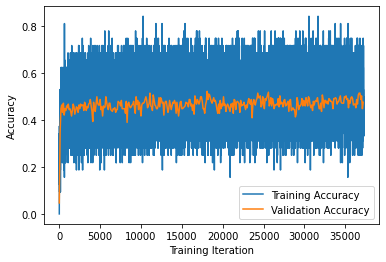

In [13]:
import matplotlib.pyplot as plt
plt.plot(range(len(training_accuracies_finetuning)), training_accuracies_finetuning, label = "Training Accuracy")
plt.plot(list(map(lambda x: x * 100, range(len(validation_accuracies_finetuning)))), validation_accuracies_finetuning, label = "Validation Accuracy")
plt.xlabel("Training Iteration")
plt.ylabel("Accuracy")
plt.legend()

In [14]:
import torch as th
import numpy as np

embedding_bert.to(device)

def get_embeds(x_data):
    concatted_shape = None
    pad_value = None
    embeds = []
    for text in tqdm(x_data):
        doc = nlp(text)
        embeddeds = []
        sents = [str(sent) for sent in doc.sents]
        if sentence_pairs and len(sents) > 1:
            sents = [a + b for a, b in zip(sents, sents[1:])]
        all_tokenized = []
        for sentence in sents[:num_sentences]:
            tokenized = tokenizer(sentence, truncation=True, padding="max_length", max_length=max_tokenized_length)[0]
            all_tokenized.append(tokenized.ids)
        
        with th.no_grad():
            sentence_tensor = th.tensor(all_tokenized).to(device)
            concatted = np.concatenate([
                # take output corresponding to CLS
                embedding_bert.bert(sentence_tensor, output_hidden_states=True, return_dict=True)[1].cpu().numpy(),
                np.zeros((len(all_tokenized), 1))
            ], axis=1)
            
            if not concatted_shape:
                concatted_shape = concatted.shape
                pad_value = np.zeros(concatted_shape[1])
                pad_value[-1] = 1
            
            embeddeds += list(concatted)

        if len(sents) < num_sentences:
            embeddeds += [pad_value] * (num_sentences - len(sents))

        embeds.append(embeddeds)
    return np.array(embeds)

main_data_key = f"cache-core/training-data-main-max-tokens-{max_tokenized_length}-split-{split_hash}-finetuned-{finetuning_model_hash}"
train_x_embeds, valid_x_embeds = memo_load(
    lambda: (
        get_embeds(train_x),
        get_embeds(valid_x)
    ),
    main_data_key
)
main_data_hash = hash_file(main_data_key + ".hkl")

  0%|          | 0/194419 [00:00<?, ?it/s]

  0%|          | 6/194419 [00:00<1:00:39, 53.42it/s]

  0%|          | 12/194419 [00:00<1:01:03, 53.06it/s]

  0%|          | 21/194419 [00:00<50:02, 64.75it/s]  

  0%|          | 30/194419 [00:00<46:08, 70.20it/s]

  0%|          | 38/194419 [00:00<44:56, 72.09it/s]

  0%|          | 46/194419 [00:00<46:32, 69.62it/s]

  0%|          | 53/194419 [00:00<46:28, 69.71it/s]

  0%|          | 60/194419 [00:00<48:04, 67.38it/s]

  0%|          | 68/194419 [00:01<46:43, 69.31it/s]

  0%|          | 76/194419 [00:01<45:15, 71.56it/s]

  0%|          | 84/194419 [00:01<45:41, 70.88it/s]

  0%|          | 92/194419 [00:01<44:07, 73.41it/s]

  0%|          | 100/194419 [00:01<44:57, 72.03it/s]

  0%|          | 108/194419 [00:01<44:34, 72.66it/s]

  0%|          | 116/194419 [00:01<43:46, 73.98it/s]

  0%|          | 124/194419 [00:01<46:50, 69.13it/s]

  0%|          | 134/194419 [00:01<43:29, 74.44it/s]

  0%|          | 142/194419 [00:02<46:10, 70.12it/s]

  0%|          | 150/194419 [00:02<46:11, 70.10it/s]

  0%|          | 158/194419 [00:02<47:00, 68.88it/s]

  0%|          | 165/194419 [00:02<48:23, 66.90it/s]

  0%|          | 172/194419 [00:02<49:30, 65.38it/s]

  0%|          | 180/194419 [00:02<46:50, 69.11it/s]

  0%|          | 188/194419 [00:02<44:57, 72.01it/s]

  0%|          | 196/194419 [00:02<47:50, 67.66it/s]

  0%|          | 203/194419 [00:02<50:11, 64.48it/s]

  0%|          | 210/194419 [00:03<49:30, 65.39it/s]

  0%|          | 219/194419 [00:03<46:47, 69.18it/s]

  0%|          | 227/194419 [00:03<45:25, 71.26it/s]

  0%|          | 235/194419 [00:03<47:23, 68.29it/s]

  0%|          | 242/194419 [00:03<50:19, 64.32it/s]

  0%|          | 250/194419 [00:03<47:29, 68.15it/s]

  0%|          | 259/194419 [00:03<44:04, 73.42it/s]

  0%|          | 267/194419 [00:03<47:14, 68.51it/s]

  0%|          | 276/194419 [00:03<44:46, 72.26it/s]

  0%|          | 284/194419 [00:04<47:28, 68.14it/s]

  0%|          | 292/194419 [00:04<46:10, 70.08it/s]

  0%|          | 300/194419 [00:04<45:50, 70.58it/s]

  0%|          | 308/194419 [00:04<47:10, 68.57it/s]

  0%|          | 316/194419 [00:04<46:15, 69.92it/s]

  0%|          | 324/194419 [00:04<46:13, 69.97it/s]

  0%|          | 332/194419 [00:04<45:37, 70.90it/s]

  0%|          | 340/194419 [00:04<45:00, 71.86it/s]

  0%|          | 349/194419 [00:04<42:30, 76.09it/s]

  0%|          | 357/194419 [00:05<44:20, 72.94it/s]

  0%|          | 365/194419 [00:05<44:59, 71.87it/s]

  0%|          | 374/194419 [00:05<43:14, 74.79it/s]

  0%|          | 382/194419 [00:05<42:49, 75.53it/s]

  0%|          | 390/194419 [00:05<44:36, 72.51it/s]

  0%|          | 398/194419 [00:05<45:06, 71.70it/s]

  0%|          | 406/194419 [00:05<47:08, 68.59it/s]

  0%|          | 414/194419 [00:05<46:53, 68.95it/s]

  0%|          | 422/194419 [00:06<47:02, 68.73it/s]

  0%|          | 432/194419 [00:06<43:06, 75.00it/s]

  0%|          | 441/194419 [00:06<42:56, 75.29it/s]

  0%|          | 449/194419 [00:06<42:38, 75.81it/s]

  0%|          | 457/194419 [00:06<43:51, 73.70it/s]

  0%|          | 466/194419 [00:06<41:50, 77.26it/s]

  0%|          | 474/194419 [00:06<43:27, 74.37it/s]

  0%|          | 482/194419 [00:06<43:41, 73.98it/s]

  0%|          | 490/194419 [00:06<45:01, 71.79it/s]

  0%|          | 498/194419 [00:07<45:03, 71.72it/s]

  0%|          | 507/194419 [00:07<44:26, 72.72it/s]

  0%|          | 515/194419 [00:07<44:13, 73.09it/s]

  0%|          | 523/194419 [00:07<44:32, 72.55it/s]

  0%|          | 531/194419 [00:07<43:46, 73.82it/s]

  0%|          | 539/194419 [00:07<45:48, 70.55it/s]

  0%|          | 547/194419 [00:07<46:35, 69.35it/s]

  0%|          | 554/194419 [00:07<50:08, 64.44it/s]

  0%|          | 562/194419 [00:07<49:26, 65.34it/s]

  0%|          | 570/194419 [00:08<48:09, 67.08it/s]

  0%|          | 578/194419 [00:08<47:50, 67.52it/s]

  0%|          | 586/194419 [00:08<46:34, 69.37it/s]

  0%|          | 593/194419 [00:08<48:10, 67.07it/s]

  0%|          | 600/194419 [00:08<48:51, 66.12it/s]

  0%|          | 607/194419 [00:08<48:21, 66.80it/s]

  0%|          | 615/194419 [00:08<47:48, 67.56it/s]

  0%|          | 622/194419 [00:08<47:43, 67.67it/s]

  0%|          | 631/194419 [00:08<45:06, 71.61it/s]

  0%|          | 639/194419 [00:09<47:56, 67.38it/s]

  0%|          | 647/194419 [00:09<45:47, 70.52it/s]

  0%|          | 655/194419 [00:09<47:00, 68.71it/s]

  0%|          | 662/194419 [00:09<49:37, 65.08it/s]

  0%|          | 671/194419 [00:09<45:28, 71.01it/s]

  0%|          | 679/194419 [00:09<45:44, 70.60it/s]

  0%|          | 687/194419 [00:09<45:51, 70.42it/s]

  0%|          | 695/194419 [00:09<48:02, 67.21it/s]

  0%|          | 703/194419 [00:10<46:47, 68.99it/s]

  0%|          | 711/194419 [00:10<46:44, 69.08it/s]

  0%|          | 719/194419 [00:10<45:39, 70.70it/s]

  0%|          | 728/194419 [00:10<43:23, 74.39it/s]

  0%|          | 736/194419 [00:10<44:19, 72.81it/s]

  0%|          | 745/194419 [00:10<42:14, 76.43it/s]

  0%|          | 753/194419 [00:10<42:29, 75.97it/s]

  0%|          | 761/194419 [00:10<42:34, 75.82it/s]

  0%|          | 769/194419 [00:10<43:14, 74.64it/s]

  0%|          | 777/194419 [00:11<43:19, 74.50it/s]

  0%|          | 785/194419 [00:11<45:20, 71.16it/s]

  0%|          | 793/194419 [00:11<47:15, 68.28it/s]

  0%|          | 800/194419 [00:11<48:09, 67.00it/s]

  0%|          | 807/194419 [00:11<48:35, 66.41it/s]

  0%|          | 815/194419 [00:11<46:46, 68.99it/s]

  0%|          | 823/194419 [00:11<45:26, 71.00it/s]

  0%|          | 833/194419 [00:11<41:09, 78.38it/s]

  0%|          | 841/194419 [00:11<44:54, 71.84it/s]

  0%|          | 849/194419 [00:12<46:06, 69.97it/s]

  0%|          | 857/194419 [00:12<45:24, 71.06it/s]

  0%|          | 865/194419 [00:12<44:05, 73.17it/s]

  0%|          | 873/194419 [00:12<44:40, 72.22it/s]

  0%|          | 881/194419 [00:12<48:12, 66.91it/s]

  0%|          | 890/194419 [00:12<44:51, 71.90it/s]

  0%|          | 898/194419 [00:12<45:53, 70.29it/s]

  0%|          | 906/194419 [00:12<47:23, 68.05it/s]

  0%|          | 913/194419 [00:12<47:11, 68.34it/s]

  0%|          | 921/194419 [00:13<46:25, 69.47it/s]

  0%|          | 929/194419 [00:13<45:10, 71.39it/s]

  0%|          | 938/194419 [00:13<42:44, 75.44it/s]

  0%|          | 946/194419 [00:13<43:05, 74.82it/s]

  0%|          | 955/194419 [00:13<41:37, 77.45it/s]

  0%|          | 963/194419 [00:13<45:03, 71.56it/s]

  0%|          | 971/194419 [00:13<48:19, 66.71it/s]

  1%|          | 978/194419 [00:13<50:30, 63.84it/s]

  1%|          | 985/194419 [00:14<50:10, 64.25it/s]

  1%|          | 994/194419 [00:14<46:42, 69.01it/s]

  1%|          | 1002/194419 [00:14<45:25, 70.97it/s]

  1%|          | 1012/194419 [00:14<41:36, 77.46it/s]

  1%|          | 1020/194419 [00:14<44:36, 72.25it/s]

  1%|          | 1028/194419 [00:14<49:15, 65.44it/s]

  1%|          | 1036/194419 [00:14<47:12, 68.27it/s]

  1%|          | 1045/194419 [00:14<45:16, 71.18it/s]

  1%|          | 1053/194419 [00:14<44:46, 71.97it/s]

  1%|          | 1061/194419 [00:15<45:16, 71.19it/s]

  1%|          | 1069/194419 [00:15<44:19, 72.70it/s]

  1%|          | 1077/194419 [00:15<44:36, 72.25it/s]

  1%|          | 1085/194419 [00:15<45:36, 70.66it/s]

  1%|          | 1095/194419 [00:15<41:16, 78.05it/s]

  1%|          | 1103/194419 [00:15<43:31, 74.03it/s]

  1%|          | 1111/194419 [00:15<43:33, 73.97it/s]

  1%|          | 1120/194419 [00:15<41:09, 78.27it/s]

  1%|          | 1128/194419 [00:15<41:34, 77.48it/s]

  1%|          | 1136/194419 [00:16<41:57, 76.77it/s]

  1%|          | 1144/194419 [00:16<43:27, 74.14it/s]

  1%|          | 1152/194419 [00:16<43:38, 73.81it/s]

  1%|          | 1160/194419 [00:16<44:44, 71.98it/s]

  1%|          | 1168/194419 [00:16<44:17, 72.72it/s]

  1%|          | 1176/194419 [00:16<46:31, 69.22it/s]

  1%|          | 1183/194419 [00:16<47:32, 67.75it/s]

  1%|          | 1190/194419 [00:16<49:24, 65.19it/s]

  1%|          | 1197/194419 [00:16<49:39, 64.85it/s]

  1%|          | 1206/194419 [00:17<45:03, 71.47it/s]

  1%|          | 1214/194419 [00:17<44:05, 73.04it/s]

  1%|          | 1222/194419 [00:17<45:15, 71.14it/s]

  1%|          | 1230/194419 [00:17<45:18, 71.06it/s]

  1%|          | 1238/194419 [00:17<43:49, 73.47it/s]

  1%|          | 1246/194419 [00:17<46:07, 69.80it/s]

  1%|          | 1254/194419 [00:17<46:44, 68.88it/s]

  1%|          | 1261/194419 [00:17<46:52, 68.67it/s]

  1%|          | 1268/194419 [00:17<47:52, 67.25it/s]

  1%|          | 1275/194419 [00:18<50:46, 63.41it/s]

  1%|          | 1284/194419 [00:18<45:45, 70.34it/s]

  1%|          | 1292/194419 [00:18<44:54, 71.67it/s]

  1%|          | 1300/194419 [00:18<44:48, 71.84it/s]

  1%|          | 1308/194419 [00:18<44:17, 72.65it/s]

  1%|          | 1317/194419 [00:18<41:36, 77.34it/s]

  1%|          | 1325/194419 [00:18<43:28, 74.04it/s]

  1%|          | 1333/194419 [00:18<43:33, 73.87it/s]

  1%|          | 1341/194419 [00:18<44:23, 72.50it/s]

  1%|          | 1349/194419 [00:19<45:40, 70.46it/s]

  1%|          | 1357/194419 [00:19<46:31, 69.16it/s]

  1%|          | 1364/194419 [00:19<48:23, 66.50it/s]

  1%|          | 1371/194419 [00:19<48:07, 66.86it/s]

  1%|          | 1379/194419 [00:19<46:14, 69.57it/s]

  1%|          | 1386/194419 [00:19<48:55, 65.76it/s]

  1%|          | 1396/194419 [00:19<44:51, 71.71it/s]

  1%|          | 1404/194419 [00:19<44:54, 71.63it/s]

  1%|          | 1412/194419 [00:19<45:04, 71.36it/s]

  1%|          | 1420/194419 [00:20<46:12, 69.61it/s]

  1%|          | 1428/194419 [00:20<45:37, 70.50it/s]

  1%|          | 1436/194419 [00:20<45:26, 70.77it/s]

  1%|          | 1444/194419 [00:20<46:43, 68.83it/s]

  1%|          | 1451/194419 [00:20<47:24, 67.84it/s]

  1%|          | 1459/194419 [00:20<45:23, 70.85it/s]

  1%|          | 1467/194419 [00:20<46:13, 69.57it/s]

  1%|          | 1474/194419 [00:20<47:10, 68.16it/s]

  1%|          | 1481/194419 [00:21<48:08, 66.80it/s]

  1%|          | 1490/194419 [00:21<46:02, 69.83it/s]

  1%|          | 1497/194419 [00:21<47:48, 67.26it/s]

  1%|          | 1504/194419 [00:21<50:55, 63.14it/s]

  1%|          | 1511/194419 [00:21<52:06, 61.70it/s]

  1%|          | 1518/194419 [00:21<51:48, 62.05it/s]

  1%|          | 1526/194419 [00:21<48:42, 66.01it/s]

  1%|          | 1535/194419 [00:21<44:58, 71.48it/s]

  1%|          | 1543/194419 [00:21<46:29, 69.15it/s]

  1%|          | 1550/194419 [00:22<47:42, 67.38it/s]

  1%|          | 1557/194419 [00:22<47:58, 67.01it/s]

  1%|          | 1567/194419 [00:22<42:36, 75.43it/s]

  1%|          | 1575/194419 [00:22<43:52, 73.25it/s]

  1%|          | 1583/194419 [00:22<46:10, 69.60it/s]

  1%|          | 1591/194419 [00:22<47:59, 66.97it/s]

  1%|          | 1598/194419 [00:22<48:49, 65.82it/s]

  1%|          | 1606/194419 [00:22<47:38, 67.45it/s]

  1%|          | 1613/194419 [00:22<48:57, 65.63it/s]

  1%|          | 1621/194419 [00:23<46:38, 68.89it/s]

  1%|          | 1629/194419 [00:23<46:16, 69.44it/s]

  1%|          | 1636/194419 [00:23<47:53, 67.10it/s]

  1%|          | 1644/194419 [00:23<46:18, 69.39it/s]

  1%|          | 1652/194419 [00:23<44:24, 72.34it/s]

  1%|          | 1661/194419 [00:23<42:21, 75.84it/s]

  1%|          | 1670/194419 [00:23<40:42, 78.90it/s]

  1%|          | 1678/194419 [00:23<41:19, 77.72it/s]

  1%|          | 1686/194419 [00:23<43:40, 73.54it/s]

  1%|          | 1695/194419 [00:24<41:28, 77.44it/s]

  1%|          | 1703/194419 [00:24<41:51, 76.73it/s]

  1%|          | 1711/194419 [00:24<42:30, 75.56it/s]

  1%|          | 1719/194419 [00:24<44:27, 72.25it/s]

  1%|          | 1727/194419 [00:24<43:15, 74.24it/s]

  1%|          | 1735/194419 [00:24<44:32, 72.09it/s]

  1%|          | 1744/194419 [00:24<42:44, 75.12it/s]

  1%|          | 1752/194419 [00:24<42:43, 75.16it/s]

  1%|          | 1760/194419 [00:24<43:33, 73.72it/s]

  1%|          | 1768/194419 [00:25<43:32, 73.74it/s]

  1%|          | 1776/194419 [00:25<45:46, 70.14it/s]

  1%|          | 1784/194419 [00:25<45:41, 70.27it/s]

  1%|          | 1792/194419 [00:25<46:09, 69.56it/s]

  1%|          | 1800/194419 [00:25<45:28, 70.60it/s]

  1%|          | 1808/194419 [00:25<44:40, 71.84it/s]

  1%|          | 1817/194419 [00:25<42:19, 75.85it/s]

  1%|          | 1825/194419 [00:25<44:13, 72.57it/s]

  1%|          | 1833/194419 [00:25<46:40, 68.76it/s]

  1%|          | 1840/194419 [00:26<47:07, 68.11it/s]

  1%|          | 1847/194419 [00:26<47:38, 67.37it/s]

  1%|          | 1856/194419 [00:26<43:51, 73.18it/s]

  1%|          | 1865/194419 [00:26<41:56, 76.52it/s]

  1%|          | 1875/194419 [00:26<39:44, 80.74it/s]

  1%|          | 1884/194419 [00:26<40:41, 78.87it/s]

  1%|          | 1893/194419 [00:26<41:20, 77.62it/s]

  1%|          | 1901/194419 [00:26<42:52, 74.85it/s]

  1%|          | 1909/194419 [00:26<46:16, 69.34it/s]

  1%|          | 1917/194419 [00:27<46:20, 69.23it/s]

  1%|          | 1925/194419 [00:27<45:05, 71.15it/s]

  1%|          | 1933/194419 [00:27<46:42, 68.68it/s]

  1%|          | 1941/194419 [00:27<45:59, 69.74it/s]

  1%|          | 1950/194419 [00:27<44:10, 72.63it/s]

  1%|          | 1959/194419 [00:27<42:06, 76.18it/s]

  1%|          | 1968/194419 [00:27<40:28, 79.24it/s]

  1%|          | 1976/194419 [00:27<43:08, 74.36it/s]

  1%|          | 1984/194419 [00:28<43:21, 73.97it/s]

  1%|          | 1992/194419 [00:28<44:56, 71.36it/s]

  1%|          | 2000/194419 [00:28<45:30, 70.48it/s]

  1%|          | 2008/194419 [00:28<47:11, 67.94it/s]

  1%|          | 2015/194419 [00:28<49:20, 64.98it/s]

  1%|          | 2023/194419 [00:28<47:02, 68.16it/s]

  1%|          | 2030/194419 [00:28<48:00, 66.80it/s]

  1%|          | 2037/194419 [00:28<47:51, 67.00it/s]

  1%|          | 2044/194419 [00:28<47:20, 67.72it/s]

  1%|          | 2053/194419 [00:29<44:00, 72.85it/s]

  1%|          | 2061/194419 [00:29<44:30, 72.02it/s]

  1%|          | 2069/194419 [00:29<44:08, 72.62it/s]

  1%|          | 2078/194419 [00:29<42:02, 76.25it/s]

  1%|          | 2086/194419 [00:29<42:22, 75.65it/s]

  1%|          | 2095/194419 [00:29<41:11, 77.81it/s]

  1%|          | 2103/194419 [00:29<42:30, 75.40it/s]

  1%|          | 2111/194419 [00:29<44:37, 71.83it/s]

  1%|          | 2119/194419 [00:29<44:48, 71.52it/s]

  1%|          | 2127/194419 [00:30<45:12, 70.90it/s]

  1%|          | 2135/194419 [00:30<46:06, 69.50it/s]

  1%|          | 2142/194419 [00:30<47:47, 67.06it/s]

  1%|          | 2149/194419 [00:30<48:19, 66.32it/s]

  1%|          | 2156/194419 [00:30<48:43, 65.77it/s]

  1%|          | 2163/194419 [00:30<49:25, 64.82it/s]

  1%|          | 2171/194419 [00:30<46:48, 68.44it/s]

  1%|          | 2180/194419 [00:30<45:22, 70.62it/s]

  1%|          | 2188/194419 [00:30<47:29, 67.47it/s]

  1%|          | 2197/194419 [00:31<44:12, 72.47it/s]

  1%|          | 2205/194419 [00:31<43:46, 73.18it/s]

  1%|          | 2213/194419 [00:31<48:50, 65.58it/s]

  1%|          | 2222/194419 [00:31<45:23, 70.58it/s]

  1%|          | 2230/194419 [00:31<46:12, 69.31it/s]

  1%|          | 2238/194419 [00:31<48:41, 65.79it/s]

  1%|          | 2245/194419 [00:31<48:01, 66.70it/s]

  1%|          | 2252/194419 [00:31<47:49, 66.96it/s]

  1%|          | 2259/194419 [00:32<50:51, 62.97it/s]

  1%|          | 2266/194419 [00:32<50:44, 63.12it/s]

  1%|          | 2274/194419 [00:32<48:31, 66.00it/s]

  1%|          | 2281/194419 [00:32<49:19, 64.92it/s]

  1%|          | 2288/194419 [00:32<49:21, 64.88it/s]

  1%|          | 2295/194419 [00:32<49:03, 65.27it/s]

  1%|          | 2303/194419 [00:32<47:21, 67.60it/s]

  1%|          | 2311/194419 [00:32<46:21, 69.06it/s]

  1%|          | 2320/194419 [00:32<44:59, 71.17it/s]

  1%|          | 2328/194419 [00:33<45:16, 70.72it/s]

  1%|          | 2337/194419 [00:33<43:16, 73.99it/s]

  1%|          | 2345/194419 [00:33<43:18, 73.91it/s]

  1%|          | 2356/194419 [00:33<38:36, 82.92it/s]

  1%|          | 2365/194419 [00:33<39:33, 80.91it/s]

  1%|          | 2374/194419 [00:33<42:52, 74.65it/s]

  1%|          | 2382/194419 [00:33<45:43, 70.00it/s]

  1%|          | 2390/194419 [00:33<45:47, 69.88it/s]

  1%|          | 2398/194419 [00:33<47:16, 67.69it/s]

  1%|          | 2407/194419 [00:34<44:13, 72.37it/s]

  1%|          | 2416/194419 [00:34<42:00, 76.19it/s]

  1%|          | 2424/194419 [00:34<42:06, 75.99it/s]

  1%|▏         | 2432/194419 [00:34<41:50, 76.47it/s]

  1%|▏         | 2440/194419 [00:34<44:07, 72.51it/s]

  1%|▏         | 2448/194419 [00:34<44:54, 71.25it/s]

  1%|▏         | 2456/194419 [00:34<45:59, 69.57it/s]

  1%|▏         | 2464/194419 [00:34<45:46, 69.89it/s]

  1%|▏         | 2472/194419 [00:34<45:57, 69.61it/s]

  1%|▏         | 2481/194419 [00:35<42:48, 74.73it/s]

  1%|▏         | 2489/194419 [00:35<46:29, 68.81it/s]

  1%|▏         | 2497/194419 [00:35<47:39, 67.12it/s]

  1%|▏         | 2504/194419 [00:35<48:39, 65.73it/s]

  1%|▏         | 2511/194419 [00:35<49:01, 65.24it/s]

  1%|▏         | 2518/194419 [00:35<48:38, 65.76it/s]

  1%|▏         | 2526/194419 [00:35<47:13, 67.71it/s]

  1%|▏         | 2534/194419 [00:35<45:31, 70.24it/s]

  1%|▏         | 2542/194419 [00:36<47:36, 67.17it/s]

  1%|▏         | 2551/194419 [00:36<45:42, 69.97it/s]

  1%|▏         | 2559/194419 [00:36<46:37, 68.59it/s]

  1%|▏         | 2566/194419 [00:36<46:29, 68.79it/s]

  1%|▏         | 2574/194419 [00:36<45:27, 70.34it/s]

  1%|▏         | 2582/194419 [00:36<44:27, 71.90it/s]

  1%|▏         | 2590/194419 [00:36<45:37, 70.08it/s]

  1%|▏         | 2598/194419 [00:36<46:39, 68.52it/s]

  1%|▏         | 2605/194419 [00:36<51:00, 62.67it/s]

  1%|▏         | 2613/194419 [00:37<49:56, 64.01it/s]

  1%|▏         | 2620/194419 [00:37<51:15, 62.37it/s]

  1%|▏         | 2627/194419 [00:37<49:43, 64.29it/s]

  1%|▏         | 2635/194419 [00:37<48:09, 66.38it/s]

  1%|▏         | 2642/194419 [00:37<50:17, 63.55it/s]

  1%|▏         | 2649/194419 [00:37<50:48, 62.91it/s]

  1%|▏         | 2657/194419 [00:37<48:42, 65.63it/s]

  1%|▏         | 2665/194419 [00:37<47:52, 66.75it/s]

  1%|▏         | 2672/194419 [00:37<49:15, 64.89it/s]

  1%|▏         | 2682/194419 [00:38<44:20, 72.08it/s]

  1%|▏         | 2690/194419 [00:38<46:18, 69.00it/s]

  1%|▏         | 2697/194419 [00:38<47:53, 66.72it/s]

  1%|▏         | 2705/194419 [00:38<47:43, 66.95it/s]

  1%|▏         | 2712/194419 [00:38<50:14, 63.60it/s]

  1%|▏         | 2719/194419 [00:38<49:35, 64.42it/s]

  1%|▏         | 2727/194419 [00:38<48:13, 66.24it/s]

  1%|▏         | 2734/194419 [00:38<48:58, 65.24it/s]

  1%|▏         | 2741/194419 [00:39<48:11, 66.29it/s]

  1%|▏         | 2748/194419 [00:39<50:28, 63.29it/s]

  1%|▏         | 2756/194419 [00:39<48:04, 66.45it/s]

  1%|▏         | 2763/194419 [00:39<48:23, 66.00it/s]

  1%|▏         | 2770/194419 [00:39<47:56, 66.63it/s]

  1%|▏         | 2777/194419 [00:39<49:18, 64.78it/s]

  1%|▏         | 2786/194419 [00:39<44:36, 71.60it/s]

  1%|▏         | 2794/194419 [00:39<44:57, 71.03it/s]

  1%|▏         | 2802/194419 [00:39<46:38, 68.47it/s]

  1%|▏         | 2809/194419 [00:40<48:31, 65.82it/s]

  1%|▏         | 2818/194419 [00:40<44:28, 71.80it/s]

  1%|▏         | 2826/194419 [00:40<43:43, 73.03it/s]

  1%|▏         | 2834/194419 [00:40<45:52, 69.61it/s]

  1%|▏         | 2842/194419 [00:40<45:03, 70.85it/s]

  1%|▏         | 2850/194419 [00:40<44:18, 72.06it/s]

  1%|▏         | 2858/194419 [00:40<45:49, 69.66it/s]

  1%|▏         | 2866/194419 [00:40<44:22, 71.93it/s]

  1%|▏         | 2874/194419 [00:40<43:59, 72.56it/s]

  1%|▏         | 2882/194419 [00:41<46:49, 68.18it/s]

  1%|▏         | 2890/194419 [00:41<46:41, 68.36it/s]

  1%|▏         | 2898/194419 [00:41<45:23, 70.31it/s]

  1%|▏         | 2907/194419 [00:41<42:51, 74.49it/s]

  1%|▏         | 2915/194419 [00:41<42:05, 75.82it/s]

  2%|▏         | 2923/194419 [00:41<43:55, 72.66it/s]

  2%|▏         | 2931/194419 [00:41<46:11, 69.09it/s]

  2%|▏         | 2939/194419 [00:41<44:29, 71.73it/s]

  2%|▏         | 2947/194419 [00:41<48:15, 66.14it/s]

  2%|▏         | 2954/194419 [00:42<48:06, 66.32it/s]

  2%|▏         | 2962/194419 [00:42<47:16, 67.50it/s]

  2%|▏         | 2971/194419 [00:42<43:49, 72.80it/s]

  2%|▏         | 2979/194419 [00:42<46:00, 69.36it/s]

  2%|▏         | 2987/194419 [00:42<45:27, 70.18it/s]

  2%|▏         | 2995/194419 [00:42<45:33, 70.02it/s]

  2%|▏         | 3003/194419 [00:42<44:48, 71.20it/s]

  2%|▏         | 3011/194419 [00:42<44:53, 71.07it/s]

  2%|▏         | 3019/194419 [00:42<43:24, 73.48it/s]

  2%|▏         | 3027/194419 [00:43<46:31, 68.57it/s]

  2%|▏         | 3035/194419 [00:43<45:05, 70.75it/s]

  2%|▏         | 3043/194419 [00:43<48:56, 65.17it/s]

  2%|▏         | 3050/194419 [00:43<49:15, 64.74it/s]

  2%|▏         | 3057/194419 [00:43<48:55, 65.19it/s]

  2%|▏         | 3066/194419 [00:43<46:18, 68.86it/s]

  2%|▏         | 3075/194419 [00:43<42:54, 74.33it/s]

  2%|▏         | 3083/194419 [00:43<44:11, 72.16it/s]

  2%|▏         | 3091/194419 [00:44<47:30, 67.11it/s]

  2%|▏         | 3100/194419 [00:44<44:07, 72.27it/s]

  2%|▏         | 3108/194419 [00:44<46:53, 68.00it/s]

  2%|▏         | 3116/194419 [00:44<45:28, 70.11it/s]

  2%|▏         | 3124/194419 [00:44<44:19, 71.94it/s]

  2%|▏         | 3133/194419 [00:44<42:28, 75.05it/s]

  2%|▏         | 3141/194419 [00:44<44:45, 71.23it/s]

  2%|▏         | 3149/194419 [00:44<44:42, 71.32it/s]

  2%|▏         | 3158/194419 [00:44<43:04, 74.00it/s]

  2%|▏         | 3166/194419 [00:45<42:42, 74.64it/s]

  2%|▏         | 3174/194419 [00:45<44:07, 72.24it/s]

  2%|▏         | 3183/194419 [00:45<42:04, 75.75it/s]

  2%|▏         | 3192/194419 [00:45<41:07, 77.50it/s]

  2%|▏         | 3200/194419 [00:45<41:57, 75.94it/s]

  2%|▏         | 3208/194419 [00:45<43:47, 72.79it/s]

  2%|▏         | 3217/194419 [00:45<41:56, 75.97it/s]

  2%|▏         | 3225/194419 [00:45<42:00, 75.85it/s]

  2%|▏         | 3234/194419 [00:45<40:20, 78.99it/s]

  2%|▏         | 3242/194419 [00:46<41:46, 76.28it/s]

  2%|▏         | 3250/194419 [00:46<42:02, 75.78it/s]

  2%|▏         | 3258/194419 [00:46<45:33, 69.94it/s]

  2%|▏         | 3267/194419 [00:46<42:40, 74.66it/s]

  2%|▏         | 3276/194419 [00:46<41:49, 76.16it/s]

  2%|▏         | 3284/194419 [00:46<46:40, 68.26it/s]

  2%|▏         | 3292/194419 [00:46<46:06, 69.09it/s]

  2%|▏         | 3300/194419 [00:46<44:26, 71.67it/s]

  2%|▏         | 3309/194419 [00:46<42:47, 74.43it/s]

  2%|▏         | 3317/194419 [00:47<43:53, 72.57it/s]

  2%|▏         | 3325/194419 [00:47<44:27, 71.63it/s]

  2%|▏         | 3333/194419 [00:47<45:20, 70.25it/s]

  2%|▏         | 3341/194419 [00:47<43:58, 72.41it/s]

  2%|▏         | 3349/194419 [00:47<44:35, 71.41it/s]

  2%|▏         | 3357/194419 [00:47<45:11, 70.47it/s]

  2%|▏         | 3365/194419 [00:47<46:11, 68.93it/s]

  2%|▏         | 3373/194419 [00:47<44:19, 71.83it/s]

  2%|▏         | 3381/194419 [00:47<43:12, 73.68it/s]

  2%|▏         | 3389/194419 [00:48<42:47, 74.39it/s]

  2%|▏         | 3398/194419 [00:48<42:23, 75.11it/s]

  2%|▏         | 3406/194419 [00:48<43:22, 73.41it/s]

  2%|▏         | 3415/194419 [00:48<41:40, 76.39it/s]

  2%|▏         | 3424/194419 [00:48<40:21, 78.86it/s]

  2%|▏         | 3432/194419 [00:48<43:16, 73.54it/s]

  2%|▏         | 3442/194419 [00:48<40:05, 79.41it/s]

  2%|▏         | 3451/194419 [00:48<41:08, 77.37it/s]

  2%|▏         | 3460/194419 [00:49<41:06, 77.41it/s]

  2%|▏         | 3468/194419 [00:49<43:02, 73.93it/s]

  2%|▏         | 3476/194419 [00:49<42:39, 74.61it/s]

  2%|▏         | 3484/194419 [00:49<45:00, 70.70it/s]

  2%|▏         | 3492/194419 [00:49<47:04, 67.60it/s]

  2%|▏         | 3500/194419 [00:49<44:57, 70.79it/s]

  2%|▏         | 3508/194419 [00:49<44:38, 71.27it/s]

  2%|▏         | 3516/194419 [00:49<43:50, 72.58it/s]

  2%|▏         | 3524/194419 [00:49<43:40, 72.85it/s]

  2%|▏         | 3534/194419 [00:50<41:04, 77.44it/s]

  2%|▏         | 3542/194419 [00:50<42:41, 74.51it/s]

  2%|▏         | 3550/194419 [00:50<44:56, 70.78it/s]

  2%|▏         | 3558/194419 [00:50<44:14, 71.91it/s]

  2%|▏         | 3566/194419 [00:50<45:02, 70.63it/s]

  2%|▏         | 3574/194419 [00:50<44:04, 72.17it/s]

  2%|▏         | 3583/194419 [00:50<42:19, 75.16it/s]

  2%|▏         | 3591/194419 [00:50<43:07, 73.74it/s]

  2%|▏         | 3599/194419 [00:50<44:23, 71.66it/s]

  2%|▏         | 3607/194419 [00:51<43:30, 73.09it/s]

  2%|▏         | 3615/194419 [00:51<42:45, 74.37it/s]

  2%|▏         | 3623/194419 [00:51<42:12, 75.33it/s]

  2%|▏         | 3631/194419 [00:51<41:44, 76.19it/s]

  2%|▏         | 3639/194419 [00:51<44:46, 71.02it/s]

  2%|▏         | 3647/194419 [00:51<45:27, 69.94it/s]

  2%|▏         | 3655/194419 [00:51<44:45, 71.03it/s]

  2%|▏         | 3663/194419 [00:51<45:54, 69.26it/s]

  2%|▏         | 3671/194419 [00:51<44:54, 70.78it/s]

  2%|▏         | 3679/194419 [00:52<43:41, 72.76it/s]

  2%|▏         | 3688/194419 [00:52<43:03, 73.82it/s]

  2%|▏         | 3696/194419 [00:52<42:16, 75.20it/s]

  2%|▏         | 3704/194419 [00:52<43:10, 73.61it/s]

  2%|▏         | 3712/194419 [00:52<45:44, 69.48it/s]

  2%|▏         | 3720/194419 [00:52<46:29, 68.37it/s]

  2%|▏         | 3729/194419 [00:52<44:32, 71.36it/s]

  2%|▏         | 3737/194419 [00:52<46:10, 68.83it/s]

  2%|▏         | 3744/194419 [00:53<47:29, 66.91it/s]

  2%|▏         | 3753/194419 [00:53<45:16, 70.20it/s]

  2%|▏         | 3761/194419 [00:53<45:17, 70.17it/s]

  2%|▏         | 3769/194419 [00:53<48:33, 65.43it/s]

  2%|▏         | 3776/194419 [00:53<48:04, 66.10it/s]

  2%|▏         | 3783/194419 [00:53<48:13, 65.89it/s]

  2%|▏         | 3790/194419 [00:53<48:40, 65.27it/s]

  2%|▏         | 3798/194419 [00:53<47:09, 67.37it/s]

  2%|▏         | 3805/194419 [00:53<46:46, 67.93it/s]

  2%|▏         | 3813/194419 [00:54<46:29, 68.33it/s]

  2%|▏         | 3820/194419 [00:54<48:39, 65.30it/s]

  2%|▏         | 3827/194419 [00:54<47:58, 66.22it/s]

  2%|▏         | 3835/194419 [00:54<45:29, 69.81it/s]

  2%|▏         | 3843/194419 [00:54<44:32, 71.30it/s]

  2%|▏         | 3851/194419 [00:54<44:16, 71.72it/s]

  2%|▏         | 3859/194419 [00:54<45:01, 70.55it/s]

  2%|▏         | 3868/194419 [00:54<41:52, 75.84it/s]

  2%|▏         | 3876/194419 [00:54<41:30, 76.51it/s]

  2%|▏         | 3885/194419 [00:54<40:46, 77.87it/s]

  2%|▏         | 3893/194419 [00:55<44:20, 71.63it/s]

  2%|▏         | 3901/194419 [00:55<44:03, 72.08it/s]

  2%|▏         | 3909/194419 [00:55<42:58, 73.89it/s]

  2%|▏         | 3917/194419 [00:55<43:25, 73.11it/s]

  2%|▏         | 3925/194419 [00:55<42:37, 74.48it/s]

  2%|▏         | 3933/194419 [00:55<42:42, 74.33it/s]

  2%|▏         | 3941/194419 [00:55<44:54, 70.69it/s]

  2%|▏         | 3949/194419 [00:55<44:02, 72.08it/s]

  2%|▏         | 3957/194419 [00:56<44:07, 71.94it/s]

  2%|▏         | 3965/194419 [00:56<45:27, 69.83it/s]

  2%|▏         | 3974/194419 [00:56<43:40, 72.69it/s]

  2%|▏         | 3983/194419 [00:56<42:20, 74.95it/s]

  2%|▏         | 3991/194419 [00:56<45:30, 69.73it/s]

  2%|▏         | 3999/194419 [00:56<45:15, 70.12it/s]

  2%|▏         | 4007/194419 [00:56<46:01, 68.94it/s]

  2%|▏         | 4014/194419 [00:56<46:54, 67.65it/s]

  2%|▏         | 4023/194419 [00:56<43:16, 73.32it/s]

  2%|▏         | 4031/194419 [00:57<43:12, 73.43it/s]

  2%|▏         | 4039/194419 [00:57<44:56, 70.59it/s]

  2%|▏         | 4047/194419 [00:57<44:03, 72.03it/s]

  2%|▏         | 4055/194419 [00:57<45:06, 70.33it/s]

  2%|▏         | 4063/194419 [00:57<46:34, 68.11it/s]

  2%|▏         | 4070/194419 [00:57<47:58, 66.12it/s]

  2%|▏         | 4078/194419 [00:57<46:24, 68.37it/s]

  2%|▏         | 4086/194419 [00:57<45:58, 69.01it/s]

  2%|▏         | 4093/194419 [00:57<47:55, 66.19it/s]

  2%|▏         | 4102/194419 [00:58<44:23, 71.45it/s]

  2%|▏         | 4110/194419 [00:58<44:53, 70.65it/s]

  2%|▏         | 4118/194419 [00:58<45:58, 68.99it/s]

  2%|▏         | 4125/194419 [00:58<46:07, 68.76it/s]

  2%|▏         | 4133/194419 [00:58<45:00, 70.46it/s]

  2%|▏         | 4141/194419 [00:58<44:54, 70.63it/s]

  2%|▏         | 4149/194419 [00:58<46:05, 68.80it/s]

  2%|▏         | 4156/194419 [00:58<47:00, 67.46it/s]

  2%|▏         | 4164/194419 [00:58<46:23, 68.35it/s]

  2%|▏         | 4172/194419 [00:59<44:58, 70.50it/s]

  2%|▏         | 4180/194419 [00:59<47:05, 67.32it/s]

  2%|▏         | 4188/194419 [00:59<46:24, 68.32it/s]

  2%|▏         | 4195/194419 [00:59<47:53, 66.21it/s]

  2%|▏         | 4202/194419 [00:59<47:15, 67.09it/s]

  2%|▏         | 4209/194419 [00:59<46:46, 67.77it/s]

  2%|▏         | 4217/194419 [00:59<44:45, 70.84it/s]

  2%|▏         | 4225/194419 [00:59<45:29, 69.69it/s]

  2%|▏         | 4232/194419 [00:59<45:54, 69.05it/s]

  2%|▏         | 4239/194419 [01:00<45:49, 69.18it/s]

  2%|▏         | 4246/194419 [01:00<48:13, 65.72it/s]

  2%|▏         | 4255/194419 [01:00<44:29, 71.23it/s]

  2%|▏         | 4263/194419 [01:00<47:18, 66.99it/s]

  2%|▏         | 4270/194419 [01:00<48:19, 65.58it/s]

  2%|▏         | 4279/194419 [01:00<45:09, 70.19it/s]

  2%|▏         | 4287/194419 [01:00<47:40, 66.46it/s]

  2%|▏         | 4294/194419 [01:00<47:03, 67.33it/s]

  2%|▏         | 4301/194419 [01:01<49:00, 64.66it/s]

  2%|▏         | 4309/194419 [01:01<47:19, 66.95it/s]

  2%|▏         | 4318/194419 [01:01<43:51, 72.23it/s]

  2%|▏         | 4326/194419 [01:01<43:35, 72.69it/s]

  2%|▏         | 4334/194419 [01:01<44:00, 71.98it/s]

  2%|▏         | 4342/194419 [01:01<45:15, 69.99it/s]

  2%|▏         | 4350/194419 [01:01<46:39, 67.88it/s]

  2%|▏         | 4358/194419 [01:01<45:20, 69.86it/s]

  2%|▏         | 4366/194419 [01:01<44:29, 71.21it/s]

  2%|▏         | 4374/194419 [01:02<45:12, 70.07it/s]

  2%|▏         | 4382/194419 [01:02<46:02, 68.80it/s]

  2%|▏         | 4389/194419 [01:02<47:49, 66.21it/s]

  2%|▏         | 4397/194419 [01:02<45:18, 69.89it/s]

  2%|▏         | 4406/194419 [01:02<42:42, 74.15it/s]

  2%|▏         | 4414/194419 [01:02<45:21, 69.81it/s]

  2%|▏         | 4422/194419 [01:02<44:20, 71.43it/s]

  2%|▏         | 4430/194419 [01:02<47:11, 67.10it/s]

  2%|▏         | 4439/194419 [01:02<44:03, 71.85it/s]

  2%|▏         | 4447/194419 [01:03<43:17, 73.14it/s]

  2%|▏         | 4455/194419 [01:03<45:57, 68.89it/s]

  2%|▏         | 4462/194419 [01:03<46:33, 68.00it/s]

  2%|▏         | 4469/194419 [01:03<49:15, 64.26it/s]

  2%|▏         | 4477/194419 [01:03<47:01, 67.32it/s]

  2%|▏         | 4484/194419 [01:03<47:00, 67.34it/s]

  2%|▏         | 4492/194419 [01:03<44:48, 70.65it/s]

  2%|▏         | 4500/194419 [01:03<45:36, 69.40it/s]

  2%|▏         | 4507/194419 [01:03<46:12, 68.50it/s]

  2%|▏         | 4515/194419 [01:04<45:13, 69.99it/s]

  2%|▏         | 4523/194419 [01:04<45:43, 69.21it/s]

  2%|▏         | 4531/194419 [01:04<45:32, 69.50it/s]

  2%|▏         | 4539/194419 [01:04<45:28, 69.60it/s]

  2%|▏         | 4547/194419 [01:04<44:31, 71.07it/s]

  2%|▏         | 4555/194419 [01:04<45:46, 69.13it/s]

  2%|▏         | 4563/194419 [01:04<45:58, 68.82it/s]

  2%|▏         | 4570/194419 [01:04<47:47, 66.20it/s]

  2%|▏         | 4578/194419 [01:04<46:17, 68.36it/s]

  2%|▏         | 4586/194419 [01:05<44:26, 71.20it/s]

  2%|▏         | 4594/194419 [01:05<43:34, 72.61it/s]

  2%|▏         | 4602/194419 [01:05<43:36, 72.54it/s]

  2%|▏         | 4610/194419 [01:05<44:53, 70.47it/s]

  2%|▏         | 4618/194419 [01:05<44:35, 70.95it/s]

  2%|▏         | 4626/194419 [01:05<43:34, 72.60it/s]

  2%|▏         | 4634/194419 [01:05<44:42, 70.76it/s]

  2%|▏         | 4642/194419 [01:05<49:44, 63.59it/s]

  2%|▏         | 4651/194419 [01:06<46:08, 68.56it/s]

  2%|▏         | 4659/194419 [01:06<48:15, 65.53it/s]

  2%|▏         | 4668/194419 [01:06<45:42, 69.20it/s]

  2%|▏         | 4676/194419 [01:06<45:47, 69.06it/s]

  2%|▏         | 4685/194419 [01:06<44:04, 71.74it/s]

  2%|▏         | 4693/194419 [01:06<44:27, 71.12it/s]

  2%|▏         | 4701/194419 [01:06<44:02, 71.80it/s]

  2%|▏         | 4710/194419 [01:06<42:19, 74.69it/s]

  2%|▏         | 4718/194419 [01:06<45:18, 69.79it/s]

  2%|▏         | 4726/194419 [01:07<45:58, 68.77it/s]

  2%|▏         | 4733/194419 [01:07<45:56, 68.82it/s]

  2%|▏         | 4740/194419 [01:07<47:54, 65.99it/s]

  2%|▏         | 4748/194419 [01:07<46:27, 68.04it/s]

  2%|▏         | 4757/194419 [01:07<43:58, 71.90it/s]

  2%|▏         | 4765/194419 [01:07<46:05, 68.57it/s]

  2%|▏         | 4773/194419 [01:07<44:43, 70.67it/s]

  2%|▏         | 4781/194419 [01:07<48:02, 65.79it/s]

  2%|▏         | 4789/194419 [01:08<47:50, 66.05it/s]

  2%|▏         | 4796/194419 [01:08<48:06, 65.68it/s]

  2%|▏         | 4804/194419 [01:08<45:39, 69.21it/s]

  2%|▏         | 4811/194419 [01:08<45:59, 68.71it/s]

  2%|▏         | 4818/194419 [01:08<46:42, 67.65it/s]

  2%|▏         | 4828/194419 [01:08<43:35, 72.49it/s]

  2%|▏         | 4837/194419 [01:08<42:41, 74.01it/s]

  2%|▏         | 4845/194419 [01:08<43:06, 73.31it/s]

  2%|▏         | 4854/194419 [01:08<41:16, 76.54it/s]

  3%|▎         | 4862/194419 [01:09<46:42, 67.64it/s]

  3%|▎         | 4871/194419 [01:09<45:37, 69.23it/s]

  3%|▎         | 4879/194419 [01:09<43:54, 71.95it/s]

  3%|▎         | 4887/194419 [01:09<43:48, 72.11it/s]

  3%|▎         | 4895/194419 [01:09<45:54, 68.80it/s]

  3%|▎         | 4903/194419 [01:09<44:30, 70.98it/s]

  3%|▎         | 4911/194419 [01:09<45:15, 69.79it/s]

  3%|▎         | 4919/194419 [01:09<45:21, 69.63it/s]

  3%|▎         | 4927/194419 [01:09<44:46, 70.54it/s]

  3%|▎         | 4935/194419 [01:10<47:23, 66.65it/s]

  3%|▎         | 4942/194419 [01:10<47:00, 67.17it/s]

  3%|▎         | 4950/194419 [01:10<46:45, 67.54it/s]

  3%|▎         | 4959/194419 [01:10<44:39, 70.72it/s]

  3%|▎         | 4967/194419 [01:10<43:23, 72.78it/s]

  3%|▎         | 4975/194419 [01:10<43:46, 72.13it/s]

  3%|▎         | 4984/194419 [01:10<41:03, 76.91it/s]

  3%|▎         | 4992/194419 [01:10<43:17, 72.93it/s]

  3%|▎         | 5000/194419 [01:10<42:34, 74.15it/s]

  3%|▎         | 5008/194419 [01:11<46:27, 67.96it/s]

  3%|▎         | 5015/194419 [01:11<47:00, 67.15it/s]

  3%|▎         | 5022/194419 [01:11<48:30, 65.07it/s]

  3%|▎         | 5030/194419 [01:11<47:12, 66.86it/s]

  3%|▎         | 5037/194419 [01:11<47:16, 66.76it/s]

  3%|▎         | 5045/194419 [01:11<45:36, 69.20it/s]

  3%|▎         | 5052/194419 [01:11<49:45, 63.43it/s]

  3%|▎         | 5060/194419 [01:11<47:58, 65.79it/s]

  3%|▎         | 5067/194419 [01:12<50:07, 62.96it/s]

  3%|▎         | 5074/194419 [01:12<49:36, 63.62it/s]

  3%|▎         | 5081/194419 [01:12<48:27, 65.13it/s]

  3%|▎         | 5088/194419 [01:12<50:21, 62.66it/s]

  3%|▎         | 5096/194419 [01:12<46:59, 67.16it/s]

  3%|▎         | 5104/194419 [01:12<45:44, 68.99it/s]

  3%|▎         | 5111/194419 [01:12<49:30, 63.73it/s]

  3%|▎         | 5119/194419 [01:12<47:12, 66.82it/s]

  3%|▎         | 5126/194419 [01:12<48:26, 65.14it/s]

  3%|▎         | 5133/194419 [01:13<47:29, 66.43it/s]

  3%|▎         | 5140/194419 [01:13<48:09, 65.51it/s]

  3%|▎         | 5147/194419 [01:13<47:24, 66.54it/s]

  3%|▎         | 5154/194419 [01:13<46:56, 67.20it/s]

  3%|▎         | 5161/194419 [01:13<46:55, 67.22it/s]

  3%|▎         | 5169/194419 [01:13<47:16, 66.73it/s]

  3%|▎         | 5177/194419 [01:13<45:49, 68.83it/s]

  3%|▎         | 5185/194419 [01:13<44:27, 70.93it/s]

  3%|▎         | 5194/194419 [01:13<42:06, 74.90it/s]

  3%|▎         | 5202/194419 [01:13<41:36, 75.79it/s]

  3%|▎         | 5210/194419 [01:14<45:49, 68.83it/s]

  3%|▎         | 5218/194419 [01:14<46:59, 67.10it/s]

  3%|▎         | 5225/194419 [01:14<47:10, 66.84it/s]

  3%|▎         | 5232/194419 [01:14<47:37, 66.21it/s]

  3%|▎         | 5239/194419 [01:14<47:31, 66.35it/s]

  3%|▎         | 5247/194419 [01:14<47:04, 66.98it/s]

  3%|▎         | 5254/194419 [01:14<47:42, 66.09it/s]

  3%|▎         | 5261/194419 [01:14<48:12, 65.40it/s]

  3%|▎         | 5268/194419 [01:15<47:17, 66.65it/s]

  3%|▎         | 5277/194419 [01:15<43:32, 72.40it/s]

  3%|▎         | 5285/194419 [01:15<44:19, 71.12it/s]

  3%|▎         | 5294/194419 [01:15<41:56, 75.16it/s]

  3%|▎         | 5302/194419 [01:15<41:55, 75.19it/s]

  3%|▎         | 5310/194419 [01:15<42:52, 73.50it/s]

  3%|▎         | 5318/194419 [01:15<45:28, 69.30it/s]

  3%|▎         | 5325/194419 [01:15<47:36, 66.21it/s]

  3%|▎         | 5332/194419 [01:15<49:24, 63.77it/s]

  3%|▎         | 5339/194419 [01:16<49:07, 64.14it/s]

  3%|▎         | 5347/194419 [01:16<46:14, 68.16it/s]

  3%|▎         | 5356/194419 [01:16<43:03, 73.18it/s]

  3%|▎         | 5364/194419 [01:16<42:41, 73.81it/s]

  3%|▎         | 5372/194419 [01:16<44:51, 70.24it/s]

  3%|▎         | 5380/194419 [01:16<44:49, 70.30it/s]

  3%|▎         | 5388/194419 [01:16<43:41, 72.10it/s]

  3%|▎         | 5396/194419 [01:16<45:41, 68.95it/s]

  3%|▎         | 5404/194419 [01:16<45:02, 69.95it/s]

  3%|▎         | 5412/194419 [01:17<43:40, 72.12it/s]

  3%|▎         | 5420/194419 [01:17<46:34, 67.62it/s]

  3%|▎         | 5428/194419 [01:17<45:43, 68.88it/s]

  3%|▎         | 5437/194419 [01:17<42:44, 73.69it/s]

  3%|▎         | 5445/194419 [01:17<43:28, 72.45it/s]

  3%|▎         | 5453/194419 [01:17<42:51, 73.48it/s]

  3%|▎         | 5462/194419 [01:17<41:53, 75.19it/s]

  3%|▎         | 5471/194419 [01:17<41:00, 76.80it/s]

  3%|▎         | 5480/194419 [01:17<40:53, 77.02it/s]

  3%|▎         | 5488/194419 [01:18<40:30, 77.73it/s]

  3%|▎         | 5496/194419 [01:18<41:15, 76.31it/s]

  3%|▎         | 5504/194419 [01:18<41:44, 75.42it/s]

  3%|▎         | 5513/194419 [01:18<40:32, 77.65it/s]

  3%|▎         | 5521/194419 [01:18<43:11, 72.88it/s]

  3%|▎         | 5529/194419 [01:18<44:50, 70.20it/s]

  3%|▎         | 5537/194419 [01:18<45:12, 69.64it/s]

  3%|▎         | 5546/194419 [01:18<42:46, 73.60it/s]

  3%|▎         | 5554/194419 [01:18<44:11, 71.23it/s]

  3%|▎         | 5562/194419 [01:19<42:53, 73.39it/s]

  3%|▎         | 5570/194419 [01:19<45:28, 69.21it/s]

  3%|▎         | 5578/194419 [01:19<47:41, 66.00it/s]

  3%|▎         | 5587/194419 [01:19<44:39, 70.47it/s]

  3%|▎         | 5595/194419 [01:19<45:14, 69.56it/s]

  3%|▎         | 5603/194419 [01:19<46:25, 67.79it/s]

  3%|▎         | 5610/194419 [01:19<47:30, 66.25it/s]

  3%|▎         | 5617/194419 [01:19<47:31, 66.22it/s]

  3%|▎         | 5624/194419 [01:20<48:26, 64.96it/s]

  3%|▎         | 5633/194419 [01:20<44:51, 70.15it/s]

  3%|▎         | 5641/194419 [01:20<44:07, 71.31it/s]

  3%|▎         | 5650/194419 [01:20<42:29, 74.04it/s]

  3%|▎         | 5659/194419 [01:20<40:27, 77.76it/s]

  3%|▎         | 5667/194419 [01:20<43:52, 71.70it/s]

  3%|▎         | 5675/194419 [01:20<44:55, 70.01it/s]

  3%|▎         | 5684/194419 [01:20<42:38, 73.78it/s]

  3%|▎         | 5692/194419 [01:20<44:25, 70.81it/s]

  3%|▎         | 5700/194419 [01:21<44:20, 70.94it/s]

  3%|▎         | 5708/194419 [01:21<44:37, 70.48it/s]

  3%|▎         | 5716/194419 [01:21<43:51, 71.70it/s]

  3%|▎         | 5724/194419 [01:21<43:02, 73.08it/s]

  3%|▎         | 5732/194419 [01:21<43:05, 72.99it/s]

  3%|▎         | 5740/194419 [01:21<42:22, 74.21it/s]

  3%|▎         | 5748/194419 [01:21<41:30, 75.76it/s]

  3%|▎         | 5756/194419 [01:21<41:28, 75.81it/s]

  3%|▎         | 5764/194419 [01:21<41:25, 75.90it/s]

  3%|▎         | 5773/194419 [01:22<40:46, 77.10it/s]

  3%|▎         | 5781/194419 [01:22<41:07, 76.45it/s]

  3%|▎         | 5789/194419 [01:22<44:36, 70.48it/s]

  3%|▎         | 5798/194419 [01:22<43:05, 72.95it/s]

  3%|▎         | 5806/194419 [01:22<42:30, 73.94it/s]

  3%|▎         | 5814/194419 [01:22<44:40, 70.36it/s]

  3%|▎         | 5823/194419 [01:22<41:48, 75.17it/s]

  3%|▎         | 5831/194419 [01:22<41:32, 75.65it/s]

  3%|▎         | 5839/194419 [01:22<43:04, 72.98it/s]

  3%|▎         | 5847/194419 [01:23<44:21, 70.85it/s]

  3%|▎         | 5855/194419 [01:23<45:32, 69.00it/s]

  3%|▎         | 5863/194419 [01:23<44:21, 70.84it/s]

  3%|▎         | 5871/194419 [01:23<44:44, 70.23it/s]

  3%|▎         | 5879/194419 [01:23<46:06, 68.15it/s]

  3%|▎         | 5888/194419 [01:23<44:18, 70.93it/s]

  3%|▎         | 5896/194419 [01:23<47:30, 66.14it/s]

  3%|▎         | 5904/194419 [01:23<45:44, 68.69it/s]

  3%|▎         | 5912/194419 [01:23<43:52, 71.60it/s]

  3%|▎         | 5920/194419 [01:24<43:08, 72.83it/s]

  3%|▎         | 5928/194419 [01:24<43:50, 71.65it/s]

  3%|▎         | 5936/194419 [01:24<43:50, 71.65it/s]

  3%|▎         | 5944/194419 [01:24<42:33, 73.82it/s]

  3%|▎         | 5952/194419 [01:24<43:08, 72.82it/s]

  3%|▎         | 5960/194419 [01:24<45:27, 69.09it/s]

  3%|▎         | 5968/194419 [01:24<45:12, 69.47it/s]

  3%|▎         | 5975/194419 [01:24<46:11, 68.00it/s]

  3%|▎         | 5983/194419 [01:24<44:29, 70.59it/s]

  3%|▎         | 5991/194419 [01:25<43:23, 72.38it/s]

  3%|▎         | 5999/194419 [01:25<43:22, 72.41it/s]

  3%|▎         | 6008/194419 [01:25<41:47, 75.15it/s]

  3%|▎         | 6017/194419 [01:25<39:45, 78.97it/s]

  3%|▎         | 6025/194419 [01:25<40:45, 77.05it/s]

  3%|▎         | 6034/194419 [01:25<39:41, 79.12it/s]

  3%|▎         | 6043/194419 [01:25<39:21, 79.78it/s]

  3%|▎         | 6051/194419 [01:25<40:29, 77.54it/s]

  3%|▎         | 6059/194419 [01:25<40:14, 78.01it/s]

  3%|▎         | 6067/194419 [01:26<42:04, 74.60it/s]

  3%|▎         | 6075/194419 [01:26<41:38, 75.39it/s]

  3%|▎         | 6083/194419 [01:26<42:54, 73.17it/s]

  3%|▎         | 6091/194419 [01:26<42:53, 73.17it/s]

  3%|▎         | 6099/194419 [01:26<43:46, 71.71it/s]

  3%|▎         | 6107/194419 [01:26<46:10, 67.98it/s]

  3%|▎         | 6114/194419 [01:26<47:07, 66.61it/s]

  3%|▎         | 6122/194419 [01:26<45:45, 68.58it/s]

  3%|▎         | 6129/194419 [01:26<46:55, 66.88it/s]

  3%|▎         | 6136/194419 [01:27<49:28, 63.43it/s]

  3%|▎         | 6147/194419 [01:27<42:35, 73.66it/s]

  3%|▎         | 6155/194419 [01:27<43:50, 71.57it/s]

  3%|▎         | 6164/194419 [01:27<42:17, 74.19it/s]

  3%|▎         | 6172/194419 [01:27<44:21, 70.74it/s]

  3%|▎         | 6180/194419 [01:27<45:17, 69.26it/s]

  3%|▎         | 6188/194419 [01:27<44:14, 70.91it/s]

  3%|▎         | 6196/194419 [01:27<45:10, 69.43it/s]

  3%|▎         | 6203/194419 [01:28<47:35, 65.91it/s]

  3%|▎         | 6212/194419 [01:28<44:04, 71.18it/s]

  3%|▎         | 6221/194419 [01:28<42:15, 74.22it/s]

  3%|▎         | 6229/194419 [01:28<47:23, 66.18it/s]

  3%|▎         | 6236/194419 [01:28<49:15, 63.68it/s]

  3%|▎         | 6245/194419 [01:28<46:17, 67.76it/s]

  3%|▎         | 6253/194419 [01:28<44:36, 70.31it/s]

  3%|▎         | 6262/194419 [01:28<42:35, 73.64it/s]

  3%|▎         | 6270/194419 [01:29<44:57, 69.74it/s]

  3%|▎         | 6278/194419 [01:29<44:00, 71.26it/s]

  3%|▎         | 6287/194419 [01:29<42:17, 74.14it/s]

  3%|▎         | 6295/194419 [01:29<45:11, 69.39it/s]

  3%|▎         | 6303/194419 [01:29<44:13, 70.88it/s]

  3%|▎         | 6312/194419 [01:29<41:35, 75.37it/s]

  3%|▎         | 6320/194419 [01:29<41:04, 76.33it/s]

  3%|▎         | 6328/194419 [01:29<43:56, 71.35it/s]

  3%|▎         | 6336/194419 [01:29<47:17, 66.30it/s]

  3%|▎         | 6345/194419 [01:30<45:15, 69.26it/s]

  3%|▎         | 6353/194419 [01:30<45:41, 68.59it/s]

  3%|▎         | 6360/194419 [01:30<46:32, 67.35it/s]

  3%|▎         | 6368/194419 [01:30<44:44, 70.05it/s]

  3%|▎         | 6376/194419 [01:30<44:27, 70.49it/s]

  3%|▎         | 6384/194419 [01:30<45:40, 68.61it/s]

  3%|▎         | 6391/194419 [01:30<46:05, 67.99it/s]

  3%|▎         | 6398/194419 [01:30<46:00, 68.12it/s]

  3%|▎         | 6405/194419 [01:30<45:49, 68.38it/s]

  3%|▎         | 6412/194419 [01:31<46:58, 66.72it/s]

  3%|▎         | 6419/194419 [01:31<46:35, 67.26it/s]

  3%|▎         | 6427/194419 [01:31<46:19, 67.62it/s]

  3%|▎         | 6434/194419 [01:31<48:29, 64.61it/s]

  3%|▎         | 6441/194419 [01:31<47:37, 65.79it/s]

  3%|▎         | 6449/194419 [01:31<45:45, 68.47it/s]

  3%|▎         | 6460/194419 [01:31<39:55, 78.46it/s]

  3%|▎         | 6468/194419 [01:31<40:17, 77.73it/s]

  3%|▎         | 6476/194419 [01:31<40:27, 77.44it/s]

  3%|▎         | 6485/194419 [01:32<40:01, 78.27it/s]

  3%|▎         | 6493/194419 [01:32<41:23, 75.66it/s]

  3%|▎         | 6501/194419 [01:32<46:44, 67.00it/s]

  3%|▎         | 6508/194419 [01:32<46:12, 67.77it/s]

  3%|▎         | 6517/194419 [01:32<44:35, 70.22it/s]

  3%|▎         | 6525/194419 [01:32<44:37, 70.18it/s]

  3%|▎         | 6533/194419 [01:32<43:53, 71.36it/s]

  3%|▎         | 6541/194419 [01:32<46:29, 67.35it/s]

  3%|▎         | 6548/194419 [01:32<46:32, 67.27it/s]

  3%|▎         | 6555/194419 [01:33<46:11, 67.78it/s]

  3%|▎         | 6564/194419 [01:33<43:17, 72.31it/s]

  3%|▎         | 6572/194419 [01:33<46:01, 68.01it/s]

  3%|▎         | 6579/194419 [01:33<46:26, 67.42it/s]

  3%|▎         | 6587/194419 [01:33<45:13, 69.21it/s]

  3%|▎         | 6594/194419 [01:33<47:19, 66.14it/s]

  3%|▎         | 6602/194419 [01:33<46:16, 67.64it/s]

  3%|▎         | 6612/194419 [01:33<41:27, 75.50it/s]

  3%|▎         | 6620/194419 [01:33<41:01, 76.28it/s]

  3%|▎         | 6628/194419 [01:34<42:59, 72.81it/s]

  3%|▎         | 6636/194419 [01:34<43:31, 71.90it/s]

  3%|▎         | 6644/194419 [01:34<43:03, 72.69it/s]

  3%|▎         | 6652/194419 [01:34<43:04, 72.64it/s]

  3%|▎         | 6660/194419 [01:34<44:04, 71.00it/s]

  3%|▎         | 6668/194419 [01:34<48:36, 64.37it/s]

  3%|▎         | 6677/194419 [01:34<45:14, 69.16it/s]

  3%|▎         | 6685/194419 [01:34<45:12, 69.21it/s]

  3%|▎         | 6694/194419 [01:35<41:53, 74.69it/s]

  3%|▎         | 6703/194419 [01:35<40:48, 76.66it/s]

  3%|▎         | 6711/194419 [01:35<40:38, 76.98it/s]

  3%|▎         | 6719/194419 [01:35<44:23, 70.47it/s]

  3%|▎         | 6727/194419 [01:35<46:48, 66.83it/s]

  3%|▎         | 6736/194419 [01:35<44:50, 69.75it/s]

  3%|▎         | 6745/194419 [01:35<41:56, 74.59it/s]

  3%|▎         | 6753/194419 [01:35<42:52, 72.96it/s]

  3%|▎         | 6762/194419 [01:35<42:02, 74.38it/s]

  3%|▎         | 6770/194419 [01:36<44:22, 70.48it/s]

  3%|▎         | 6778/194419 [01:36<44:25, 70.39it/s]

  3%|▎         | 6786/194419 [01:36<47:41, 65.57it/s]

  3%|▎         | 6793/194419 [01:36<48:30, 64.47it/s]

  3%|▎         | 6802/194419 [01:36<44:31, 70.22it/s]

  4%|▎         | 6811/194419 [01:36<43:24, 72.03it/s]

  4%|▎         | 6819/194419 [01:36<46:54, 66.64it/s]

  4%|▎         | 6826/194419 [01:36<48:54, 63.93it/s]

  4%|▎         | 6834/194419 [01:37<48:13, 64.82it/s]

  4%|▎         | 6841/194419 [01:37<49:27, 63.20it/s]

  4%|▎         | 6849/194419 [01:37<46:49, 66.75it/s]

  4%|▎         | 6857/194419 [01:37<45:52, 68.15it/s]

  4%|▎         | 6864/194419 [01:37<45:47, 68.28it/s]

  4%|▎         | 6871/194419 [01:37<47:45, 65.45it/s]

  4%|▎         | 6878/194419 [01:37<46:56, 66.58it/s]

  4%|▎         | 6885/194419 [01:37<47:17, 66.08it/s]

  4%|▎         | 6892/194419 [01:37<48:10, 64.87it/s]

  4%|▎         | 6899/194419 [01:38<48:44, 64.13it/s]

  4%|▎         | 6906/194419 [01:38<49:05, 63.66it/s]

  4%|▎         | 6913/194419 [01:38<48:05, 64.99it/s]

  4%|▎         | 6920/194419 [01:38<47:46, 65.40it/s]

  4%|▎         | 6928/194419 [01:38<45:39, 68.44it/s]

  4%|▎         | 6935/194419 [01:38<45:46, 68.26it/s]

  4%|▎         | 6944/194419 [01:38<43:03, 72.57it/s]

  4%|▎         | 6952/194419 [01:38<47:19, 66.03it/s]

  4%|▎         | 6961/194419 [01:38<43:39, 71.57it/s]

  4%|▎         | 6969/194419 [01:39<44:19, 70.47it/s]

  4%|▎         | 6977/194419 [01:39<42:51, 72.88it/s]

  4%|▎         | 6985/194419 [01:39<42:18, 73.85it/s]

  4%|▎         | 6993/194419 [01:39<45:30, 68.64it/s]

  4%|▎         | 7000/194419 [01:39<47:20, 65.99it/s]

  4%|▎         | 7007/194419 [01:39<49:38, 62.93it/s]

  4%|▎         | 7015/194419 [01:39<47:10, 66.20it/s]

  4%|▎         | 7022/194419 [01:39<47:57, 65.12it/s]

  4%|▎         | 7029/194419 [01:39<48:09, 64.86it/s]

  4%|▎         | 7039/194419 [01:40<43:02, 72.56it/s]

  4%|▎         | 7047/194419 [01:40<42:21, 73.73it/s]

  4%|▎         | 7055/194419 [01:40<42:34, 73.34it/s]

  4%|▎         | 7063/194419 [01:40<43:13, 72.25it/s]

  4%|▎         | 7071/194419 [01:40<44:16, 70.52it/s]

  4%|▎         | 7079/194419 [01:40<45:43, 68.29it/s]

  4%|▎         | 7087/194419 [01:40<43:58, 70.99it/s]

  4%|▎         | 7095/194419 [01:40<45:50, 68.11it/s]

  4%|▎         | 7102/194419 [01:41<50:11, 62.20it/s]

  4%|▎         | 7110/194419 [01:41<47:41, 65.45it/s]

  4%|▎         | 7117/194419 [01:41<46:55, 66.53it/s]

  4%|▎         | 7124/194419 [01:41<47:07, 66.25it/s]

  4%|▎         | 7133/194419 [01:41<44:16, 70.49it/s]

  4%|▎         | 7141/194419 [01:41<44:24, 70.29it/s]

  4%|▎         | 7149/194419 [01:41<43:21, 71.97it/s]

  4%|▎         | 7159/194419 [01:41<40:01, 77.98it/s]

  4%|▎         | 7167/194419 [01:41<41:54, 74.47it/s]

  4%|▎         | 7175/194419 [01:41<42:18, 73.76it/s]

  4%|▎         | 7183/194419 [01:42<41:46, 74.70it/s]

  4%|▎         | 7191/194419 [01:42<42:44, 73.01it/s]

  4%|▎         | 7199/194419 [01:42<44:40, 69.85it/s]

  4%|▎         | 7208/194419 [01:42<43:00, 72.54it/s]

  4%|▎         | 7216/194419 [01:42<46:19, 67.34it/s]

  4%|▎         | 7223/194419 [01:42<48:31, 64.29it/s]

  4%|▎         | 7231/194419 [01:42<48:11, 64.74it/s]

  4%|▎         | 7238/194419 [01:42<48:19, 64.56it/s]

  4%|▎         | 7246/194419 [01:43<47:13, 66.05it/s]

  4%|▎         | 7254/194419 [01:43<45:14, 68.94it/s]

  4%|▎         | 7263/194419 [01:43<43:33, 71.61it/s]

  4%|▎         | 7271/194419 [01:43<46:30, 67.06it/s]

  4%|▎         | 7278/194419 [01:43<48:59, 63.66it/s]

  4%|▎         | 7285/194419 [01:43<48:58, 63.67it/s]

  4%|▍         | 7294/194419 [01:43<44:53, 69.46it/s]

  4%|▍         | 7302/194419 [01:43<43:12, 72.18it/s]

  4%|▍         | 7311/194419 [01:43<40:56, 76.17it/s]

  4%|▍         | 7319/194419 [01:44<42:31, 73.33it/s]

  4%|▍         | 7327/194419 [01:44<42:02, 74.15it/s]

  4%|▍         | 7335/194419 [01:44<43:30, 71.66it/s]

  4%|▍         | 7343/194419 [01:44<44:59, 69.31it/s]

  4%|▍         | 7351/194419 [01:44<44:32, 69.99it/s]

  4%|▍         | 7359/194419 [01:44<46:15, 67.41it/s]

  4%|▍         | 7368/194419 [01:44<43:41, 71.35it/s]

  4%|▍         | 7376/194419 [01:44<42:46, 72.89it/s]

  4%|▍         | 7385/194419 [01:45<41:09, 75.75it/s]

  4%|▍         | 7393/194419 [01:45<45:43, 68.18it/s]

  4%|▍         | 7400/194419 [01:45<46:04, 67.66it/s]

  4%|▍         | 7407/194419 [01:45<49:41, 62.73it/s]

  4%|▍         | 7414/194419 [01:45<49:19, 63.19it/s]

  4%|▍         | 7421/194419 [01:45<49:33, 62.89it/s]

  4%|▍         | 7429/194419 [01:45<47:49, 65.17it/s]

  4%|▍         | 7436/194419 [01:45<47:28, 65.65it/s]

  4%|▍         | 7444/194419 [01:45<45:18, 68.78it/s]

  4%|▍         | 7452/194419 [01:46<44:13, 70.46it/s]

  4%|▍         | 7461/194419 [01:46<42:02, 74.12it/s]

  4%|▍         | 7469/194419 [01:46<41:40, 74.77it/s]

  4%|▍         | 7477/194419 [01:46<41:27, 75.17it/s]

  4%|▍         | 7486/194419 [01:46<40:19, 77.27it/s]

  4%|▍         | 7494/194419 [01:46<42:04, 74.05it/s]

  4%|▍         | 7502/194419 [01:46<44:37, 69.80it/s]

  4%|▍         | 7511/194419 [01:46<41:42, 74.68it/s]

  4%|▍         | 7519/194419 [01:46<41:00, 75.96it/s]

  4%|▍         | 7527/194419 [01:47<41:26, 75.16it/s]

  4%|▍         | 7535/194419 [01:47<46:23, 67.15it/s]

  4%|▍         | 7543/194419 [01:47<44:33, 69.90it/s]

  4%|▍         | 7551/194419 [01:47<43:54, 70.93it/s]

  4%|▍         | 7559/194419 [01:47<42:31, 73.23it/s]

  4%|▍         | 7568/194419 [01:47<40:32, 76.83it/s]

  4%|▍         | 7576/194419 [01:47<42:53, 72.61it/s]

  4%|▍         | 7584/194419 [01:47<45:24, 68.58it/s]

  4%|▍         | 7593/194419 [01:47<42:21, 73.50it/s]

  4%|▍         | 7601/194419 [01:48<42:04, 74.01it/s]

  4%|▍         | 7609/194419 [01:48<45:18, 68.71it/s]

  4%|▍         | 7617/194419 [01:48<45:44, 68.06it/s]

  4%|▍         | 7626/194419 [01:48<42:48, 72.72it/s]

  4%|▍         | 7635/194419 [01:48<40:19, 77.21it/s]

  4%|▍         | 7643/194419 [01:48<41:47, 74.49it/s]

  4%|▍         | 7651/194419 [01:48<41:42, 74.64it/s]

  4%|▍         | 7659/194419 [01:48<41:10, 75.60it/s]

  4%|▍         | 7667/194419 [01:48<44:38, 69.73it/s]

  4%|▍         | 7676/194419 [01:49<42:39, 72.97it/s]

  4%|▍         | 7686/194419 [01:49<39:13, 79.34it/s]

  4%|▍         | 7695/194419 [01:49<42:16, 73.62it/s]

  4%|▍         | 7703/194419 [01:49<42:42, 72.86it/s]

  4%|▍         | 7711/194419 [01:49<42:40, 72.93it/s]

  4%|▍         | 7719/194419 [01:49<41:57, 74.16it/s]

  4%|▍         | 7727/194419 [01:49<41:20, 75.27it/s]

  4%|▍         | 7735/194419 [01:49<41:22, 75.21it/s]

  4%|▍         | 7743/194419 [01:49<41:30, 74.95it/s]

  4%|▍         | 7751/194419 [01:50<44:28, 69.96it/s]

  4%|▍         | 7759/194419 [01:50<45:21, 68.60it/s]

  4%|▍         | 7768/194419 [01:50<43:01, 72.29it/s]

  4%|▍         | 7776/194419 [01:50<45:03, 69.03it/s]

  4%|▍         | 7785/194419 [01:50<42:12, 73.69it/s]

  4%|▍         | 7793/194419 [01:50<43:27, 71.57it/s]

  4%|▍         | 7801/194419 [01:50<43:56, 70.78it/s]

  4%|▍         | 7809/194419 [01:50<44:03, 70.59it/s]

  4%|▍         | 7817/194419 [01:51<44:11, 70.37it/s]

  4%|▍         | 7825/194419 [01:51<44:30, 69.87it/s]

  4%|▍         | 7833/194419 [01:51<44:11, 70.37it/s]

  4%|▍         | 7842/194419 [01:51<42:58, 72.37it/s]

  4%|▍         | 7850/194419 [01:51<45:11, 68.82it/s]

  4%|▍         | 7857/194419 [01:51<46:31, 66.83it/s]

  4%|▍         | 7866/194419 [01:51<44:06, 70.50it/s]

  4%|▍         | 7874/194419 [01:51<45:18, 68.63it/s]

  4%|▍         | 7882/194419 [01:51<43:51, 70.89it/s]

  4%|▍         | 7890/194419 [01:52<43:36, 71.29it/s]

  4%|▍         | 7898/194419 [01:52<44:13, 70.30it/s]

  4%|▍         | 7906/194419 [01:52<45:03, 68.98it/s]

  4%|▍         | 7915/194419 [01:52<42:28, 73.18it/s]

  4%|▍         | 7923/194419 [01:52<42:54, 72.43it/s]

  4%|▍         | 7931/194419 [01:52<45:01, 69.03it/s]

  4%|▍         | 7939/194419 [01:52<43:37, 71.25it/s]

  4%|▍         | 7947/194419 [01:52<43:30, 71.44it/s]

  4%|▍         | 7955/194419 [01:53<45:15, 68.66it/s]

  4%|▍         | 7964/194419 [01:53<43:29, 71.44it/s]

  4%|▍         | 7972/194419 [01:53<42:52, 72.48it/s]

  4%|▍         | 7980/194419 [01:53<44:18, 70.13it/s]

  4%|▍         | 7988/194419 [01:53<44:24, 69.96it/s]

  4%|▍         | 7996/194419 [01:53<47:22, 65.59it/s]

  4%|▍         | 8004/194419 [01:53<45:18, 68.57it/s]

  4%|▍         | 8011/194419 [01:53<45:55, 67.65it/s]

  4%|▍         | 8018/194419 [01:53<48:12, 64.44it/s]

  4%|▍         | 8025/194419 [01:54<49:21, 62.94it/s]

  4%|▍         | 8034/194419 [01:54<44:23, 69.97it/s]

  4%|▍         | 8042/194419 [01:54<44:03, 70.52it/s]

  4%|▍         | 8051/194419 [01:54<42:08, 73.72it/s]

  4%|▍         | 8059/194419 [01:54<44:45, 69.39it/s]

  4%|▍         | 8067/194419 [01:54<45:31, 68.23it/s]

  4%|▍         | 8075/194419 [01:54<44:42, 69.47it/s]

  4%|▍         | 8082/194419 [01:54<45:36, 68.09it/s]

  4%|▍         | 8091/194419 [01:54<43:19, 71.67it/s]

  4%|▍         | 8100/194419 [01:55<41:55, 74.07it/s]

  4%|▍         | 8108/194419 [01:55<43:17, 71.72it/s]

  4%|▍         | 8116/194419 [01:55<44:30, 69.76it/s]

  4%|▍         | 8124/194419 [01:55<44:00, 70.55it/s]

  4%|▍         | 8132/194419 [01:55<42:42, 72.69it/s]

  4%|▍         | 8140/194419 [01:55<42:33, 72.96it/s]

  4%|▍         | 8150/194419 [01:55<39:34, 78.44it/s]

  4%|▍         | 8158/194419 [01:55<41:25, 74.93it/s]

  4%|▍         | 8167/194419 [01:55<39:24, 78.77it/s]

  4%|▍         | 8175/194419 [01:56<39:33, 78.47it/s]

  4%|▍         | 8183/194419 [01:56<41:55, 74.05it/s]

  4%|▍         | 8191/194419 [01:56<41:31, 74.74it/s]

  4%|▍         | 8199/194419 [01:56<40:56, 75.82it/s]

  4%|▍         | 8207/194419 [01:56<45:06, 68.81it/s]

  4%|▍         | 8215/194419 [01:56<44:25, 69.86it/s]

  4%|▍         | 8224/194419 [01:56<42:29, 73.04it/s]

  4%|▍         | 8232/194419 [01:56<46:36, 66.58it/s]

  4%|▍         | 8240/194419 [01:57<44:58, 69.01it/s]

  4%|▍         | 8248/194419 [01:57<44:59, 68.96it/s]

  4%|▍         | 8257/194419 [01:57<43:33, 71.24it/s]

  4%|▍         | 8265/194419 [01:57<43:13, 71.79it/s]

  4%|▍         | 8273/194419 [01:57<42:38, 72.75it/s]

  4%|▍         | 8281/194419 [01:57<44:23, 69.89it/s]

  4%|▍         | 8290/194419 [01:57<42:01, 73.81it/s]

  4%|▍         | 8298/194419 [01:57<41:50, 74.13it/s]

  4%|▍         | 8306/194419 [01:57<41:16, 75.14it/s]

  4%|▍         | 8315/194419 [01:58<39:29, 78.54it/s]

  4%|▍         | 8325/194419 [01:58<37:54, 81.81it/s]

  4%|▍         | 8334/194419 [01:58<37:39, 82.37it/s]

  4%|▍         | 8343/194419 [01:58<38:39, 80.22it/s]

  4%|▍         | 8352/194419 [01:58<42:15, 73.39it/s]

  4%|▍         | 8360/194419 [01:58<43:36, 71.12it/s]

  4%|▍         | 8368/194419 [01:58<42:33, 72.85it/s]

  4%|▍         | 8376/194419 [01:58<41:46, 74.22it/s]

  4%|▍         | 8385/194419 [01:58<40:54, 75.80it/s]

  4%|▍         | 8394/194419 [01:59<39:37, 78.23it/s]

  4%|▍         | 8404/194419 [01:59<37:47, 82.02it/s]

  4%|▍         | 8413/194419 [01:59<38:40, 80.15it/s]

  4%|▍         | 8422/194419 [01:59<39:37, 78.22it/s]

  4%|▍         | 8430/194419 [01:59<41:11, 75.24it/s]

  4%|▍         | 8438/194419 [01:59<41:05, 75.43it/s]

  4%|▍         | 8447/194419 [01:59<39:31, 78.42it/s]

  4%|▍         | 8456/194419 [01:59<39:01, 79.43it/s]

  4%|▍         | 8465/194419 [01:59<39:25, 78.61it/s]

  4%|▍         | 8473/194419 [02:00<40:13, 77.04it/s]

  4%|▍         | 8481/194419 [02:00<43:13, 71.70it/s]

  4%|▍         | 8490/194419 [02:00<41:38, 74.42it/s]

  4%|▍         | 8498/194419 [02:00<45:48, 67.66it/s]

  4%|▍         | 8505/194419 [02:00<48:03, 64.47it/s]

  4%|▍         | 8512/194419 [02:00<49:18, 62.83it/s]

  4%|▍         | 8520/194419 [02:00<47:53, 64.69it/s]

  4%|▍         | 8530/194419 [02:00<43:07, 71.84it/s]

  4%|▍         | 8538/194419 [02:01<43:27, 71.30it/s]

  4%|▍         | 8546/194419 [02:01<43:38, 70.99it/s]

  4%|▍         | 8554/194419 [02:01<44:09, 70.14it/s]

  4%|▍         | 8562/194419 [02:01<44:15, 69.98it/s]

  4%|▍         | 8570/194419 [02:01<43:46, 70.76it/s]

  4%|▍         | 8578/194419 [02:01<44:14, 70.02it/s]

  4%|▍         | 8587/194419 [02:01<42:00, 73.72it/s]

  4%|▍         | 8595/194419 [02:01<45:15, 68.44it/s]

  4%|▍         | 8605/194419 [02:01<42:00, 73.71it/s]

  4%|▍         | 8613/194419 [02:02<42:23, 73.04it/s]

  4%|▍         | 8621/194419 [02:02<42:16, 73.25it/s]

  4%|▍         | 8629/194419 [02:02<44:13, 70.02it/s]

  4%|▍         | 8638/194419 [02:02<43:18, 71.48it/s]

  4%|▍         | 8647/194419 [02:02<42:12, 73.34it/s]

  4%|▍         | 8655/194419 [02:02<45:01, 68.75it/s]

  4%|▍         | 8662/194419 [02:02<45:35, 67.91it/s]

  4%|▍         | 8670/194419 [02:02<44:55, 68.90it/s]

  4%|▍         | 8677/194419 [02:03<44:48, 69.08it/s]

  4%|▍         | 8685/194419 [02:03<45:22, 68.23it/s]

  4%|▍         | 8692/194419 [02:03<46:58, 65.90it/s]

  4%|▍         | 8699/194419 [02:03<48:01, 64.44it/s]

  4%|▍         | 8706/194419 [02:03<48:33, 63.74it/s]

  4%|▍         | 8715/194419 [02:03<45:20, 68.27it/s]

  4%|▍         | 8724/194419 [02:03<42:53, 72.15it/s]

  4%|▍         | 8732/194419 [02:03<42:23, 73.00it/s]

  4%|▍         | 8740/194419 [02:03<44:56, 68.87it/s]

  4%|▍         | 8748/194419 [02:04<45:29, 68.01it/s]

  5%|▍         | 8755/194419 [02:04<45:22, 68.19it/s]

  5%|▍         | 8762/194419 [02:04<45:31, 67.97it/s]

  5%|▍         | 8769/194419 [02:04<46:54, 65.95it/s]

  5%|▍         | 8777/194419 [02:04<45:32, 67.95it/s]

  5%|▍         | 8784/194419 [02:04<45:46, 67.59it/s]

  5%|▍         | 8792/194419 [02:04<46:01, 67.23it/s]

  5%|▍         | 8799/194419 [02:04<45:50, 67.48it/s]

  5%|▍         | 8806/194419 [02:04<45:33, 67.89it/s]

  5%|▍         | 8813/194419 [02:05<46:04, 67.14it/s]

  5%|▍         | 8821/194419 [02:05<44:25, 69.64it/s]

  5%|▍         | 8828/194419 [02:05<45:04, 68.62it/s]

  5%|▍         | 8836/194419 [02:05<45:11, 68.43it/s]

  5%|▍         | 8844/194419 [02:05<43:45, 70.68it/s]

  5%|▍         | 8852/194419 [02:05<43:42, 70.75it/s]

  5%|▍         | 8860/194419 [02:05<43:33, 70.99it/s]

  5%|▍         | 8868/194419 [02:05<42:16, 73.16it/s]

  5%|▍         | 8876/194419 [02:05<44:12, 69.96it/s]

  5%|▍         | 8884/194419 [02:06<43:42, 70.76it/s]

  5%|▍         | 8892/194419 [02:06<43:59, 70.30it/s]

  5%|▍         | 8900/194419 [02:06<46:15, 66.83it/s]

  5%|▍         | 8908/194419 [02:06<44:53, 68.87it/s]

  5%|▍         | 8917/194419 [02:06<42:32, 72.67it/s]

  5%|▍         | 8925/194419 [02:06<42:16, 73.14it/s]

  5%|▍         | 8933/194419 [02:06<43:38, 70.84it/s]

  5%|▍         | 8941/194419 [02:06<43:57, 70.33it/s]

  5%|▍         | 8949/194419 [02:06<46:15, 66.82it/s]

  5%|▍         | 8956/194419 [02:07<47:11, 65.50it/s]

  5%|▍         | 8963/194419 [02:07<48:13, 64.10it/s]

  5%|▍         | 8972/194419 [02:07<44:44, 69.09it/s]

  5%|▍         | 8979/194419 [02:07<45:00, 68.68it/s]

  5%|▍         | 8986/194419 [02:07<45:22, 68.10it/s]

  5%|▍         | 8995/194419 [02:07<42:54, 72.04it/s]

  5%|▍         | 9003/194419 [02:07<42:51, 72.12it/s]

  5%|▍         | 9012/194419 [02:07<41:10, 75.04it/s]

  5%|▍         | 9020/194419 [02:07<43:23, 71.22it/s]

  5%|▍         | 9028/194419 [02:08<45:22, 68.10it/s]

  5%|▍         | 9036/194419 [02:08<44:43, 69.09it/s]

  5%|▍         | 9045/194419 [02:08<43:41, 70.71it/s]

  5%|▍         | 9053/194419 [02:08<46:09, 66.94it/s]

  5%|▍         | 9061/194419 [02:08<45:16, 68.23it/s]

  5%|▍         | 9068/194419 [02:08<48:45, 63.35it/s]

  5%|▍         | 9075/194419 [02:08<47:54, 64.49it/s]

  5%|▍         | 9084/194419 [02:08<44:25, 69.53it/s]

  5%|▍         | 9092/194419 [02:09<45:38, 67.67it/s]

  5%|▍         | 9099/194419 [02:09<47:47, 64.64it/s]

  5%|▍         | 9106/194419 [02:09<49:11, 62.79it/s]

  5%|▍         | 9113/194419 [02:09<50:44, 60.86it/s]

  5%|▍         | 9123/194419 [02:09<44:27, 69.46it/s]

  5%|▍         | 9131/194419 [02:09<45:09, 68.38it/s]

  5%|▍         | 9139/194419 [02:09<43:24, 71.15it/s]

  5%|▍         | 9147/194419 [02:09<42:56, 71.90it/s]

  5%|▍         | 9155/194419 [02:09<44:58, 68.64it/s]

  5%|▍         | 9162/194419 [02:10<44:54, 68.75it/s]

  5%|▍         | 9169/194419 [02:10<45:17, 68.18it/s]

  5%|▍         | 9176/194419 [02:10<45:18, 68.14it/s]

  5%|▍         | 9185/194419 [02:10<42:15, 73.06it/s]

  5%|▍         | 9193/194419 [02:10<43:14, 71.39it/s]

  5%|▍         | 9201/194419 [02:10<44:07, 69.96it/s]

  5%|▍         | 9209/194419 [02:10<44:09, 69.91it/s]

  5%|▍         | 9217/194419 [02:10<44:07, 69.96it/s]

  5%|▍         | 9226/194419 [02:10<41:27, 74.45it/s]

  5%|▍         | 9234/194419 [02:11<41:29, 74.38it/s]

  5%|▍         | 9242/194419 [02:11<40:55, 75.40it/s]

  5%|▍         | 9251/194419 [02:11<40:10, 76.83it/s]

  5%|▍         | 9259/194419 [02:11<40:43, 75.77it/s]

  5%|▍         | 9267/194419 [02:11<43:07, 71.56it/s]

  5%|▍         | 9275/194419 [02:11<45:40, 67.56it/s]

  5%|▍         | 9282/194419 [02:11<45:53, 67.24it/s]

  5%|▍         | 9290/194419 [02:11<43:56, 70.21it/s]

  5%|▍         | 9299/194419 [02:11<41:26, 74.45it/s]

  5%|▍         | 9307/194419 [02:12<41:42, 73.97it/s]

  5%|▍         | 9315/194419 [02:12<43:10, 71.47it/s]

  5%|▍         | 9323/194419 [02:12<42:38, 72.33it/s]

  5%|▍         | 9332/194419 [02:12<40:16, 76.60it/s]

  5%|▍         | 9340/194419 [02:12<41:45, 73.88it/s]

  5%|▍         | 9348/194419 [02:12<44:38, 69.10it/s]

  5%|▍         | 9355/194419 [02:12<44:41, 69.00it/s]

  5%|▍         | 9363/194419 [02:12<43:53, 70.26it/s]

  5%|▍         | 9371/194419 [02:13<45:23, 67.94it/s]

  5%|▍         | 9378/194419 [02:13<45:07, 68.34it/s]

  5%|▍         | 9386/194419 [02:13<44:34, 69.17it/s]

  5%|▍         | 9394/194419 [02:13<42:57, 71.78it/s]

  5%|▍         | 9402/194419 [02:13<42:25, 72.70it/s]

  5%|▍         | 9410/194419 [02:13<42:15, 72.95it/s]

  5%|▍         | 9418/194419 [02:13<41:25, 74.42it/s]

  5%|▍         | 9426/194419 [02:13<41:52, 73.63it/s]

  5%|▍         | 9435/194419 [02:13<41:02, 75.12it/s]

  5%|▍         | 9443/194419 [02:14<45:40, 67.50it/s]

  5%|▍         | 9451/194419 [02:14<44:04, 69.95it/s]

  5%|▍         | 9459/194419 [02:14<43:36, 70.70it/s]

  5%|▍         | 9467/194419 [02:14<42:36, 72.34it/s]

  5%|▍         | 9476/194419 [02:14<40:27, 76.17it/s]

  5%|▍         | 9484/194419 [02:14<42:15, 72.93it/s]

  5%|▍         | 9492/194419 [02:14<42:58, 71.71it/s]

  5%|▍         | 9500/194419 [02:14<46:10, 66.75it/s]

  5%|▍         | 9507/194419 [02:14<47:42, 64.60it/s]

  5%|▍         | 9514/194419 [02:15<48:07, 64.03it/s]

  5%|▍         | 9522/194419 [02:15<45:18, 68.02it/s]

  5%|▍         | 9530/194419 [02:15<43:45, 70.42it/s]

  5%|▍         | 9538/194419 [02:15<42:32, 72.43it/s]

  5%|▍         | 9546/194419 [02:15<43:51, 70.25it/s]

  5%|▍         | 9554/194419 [02:15<42:48, 71.96it/s]

  5%|▍         | 9563/194419 [02:15<40:52, 75.36it/s]

  5%|▍         | 9571/194419 [02:15<41:51, 73.59it/s]

  5%|▍         | 9579/194419 [02:15<42:01, 73.31it/s]

  5%|▍         | 9587/194419 [02:16<42:51, 71.88it/s]

  5%|▍         | 9596/194419 [02:16<41:32, 74.16it/s]

  5%|▍         | 9604/194419 [02:16<41:33, 74.12it/s]

  5%|▍         | 9612/194419 [02:16<45:02, 68.39it/s]

  5%|▍         | 9620/194419 [02:16<43:22, 71.01it/s]

  5%|▍         | 9629/194419 [02:16<42:04, 73.20it/s]

  5%|▍         | 9638/194419 [02:16<40:38, 75.79it/s]

  5%|▍         | 9646/194419 [02:16<42:56, 71.71it/s]

  5%|▍         | 9655/194419 [02:16<41:31, 74.15it/s]

  5%|▍         | 9663/194419 [02:17<42:02, 73.25it/s]

  5%|▍         | 9671/194419 [02:17<43:40, 70.51it/s]

  5%|▍         | 9679/194419 [02:17<42:35, 72.30it/s]

  5%|▍         | 9687/194419 [02:17<42:48, 71.92it/s]

  5%|▍         | 9695/194419 [02:17<41:53, 73.49it/s]

  5%|▍         | 9704/194419 [02:17<39:41, 77.57it/s]

  5%|▍         | 9712/194419 [02:17<40:12, 76.56it/s]

  5%|▍         | 9720/194419 [02:17<41:46, 73.68it/s]

  5%|▌         | 9728/194419 [02:17<44:02, 69.89it/s]

  5%|▌         | 9737/194419 [02:18<41:03, 74.96it/s]

  5%|▌         | 9745/194419 [02:18<41:07, 74.84it/s]

  5%|▌         | 9753/194419 [02:18<42:16, 72.80it/s]

  5%|▌         | 9761/194419 [02:18<41:55, 73.41it/s]

  5%|▌         | 9769/194419 [02:18<41:16, 74.55it/s]

  5%|▌         | 9778/194419 [02:18<39:51, 77.19it/s]

  5%|▌         | 9786/194419 [02:18<43:26, 70.83it/s]

  5%|▌         | 9794/194419 [02:18<44:20, 69.39it/s]

  5%|▌         | 9802/194419 [02:18<43:29, 70.75it/s]

  5%|▌         | 9810/194419 [02:19<43:40, 70.44it/s]

  5%|▌         | 9818/194419 [02:19<45:46, 67.22it/s]

  5%|▌         | 9825/194419 [02:19<46:18, 66.45it/s]

  5%|▌         | 9833/194419 [02:19<43:55, 70.03it/s]

  5%|▌         | 9841/194419 [02:19<44:09, 69.67it/s]

  5%|▌         | 9849/194419 [02:19<44:28, 69.16it/s]

  5%|▌         | 9856/194419 [02:19<47:53, 64.24it/s]

  5%|▌         | 9865/194419 [02:19<43:40, 70.43it/s]

  5%|▌         | 9873/194419 [02:20<45:35, 67.46it/s]

  5%|▌         | 9882/194419 [02:20<43:21, 70.93it/s]

  5%|▌         | 9891/194419 [02:20<42:24, 72.52it/s]

  5%|▌         | 9899/194419 [02:20<42:45, 71.93it/s]

  5%|▌         | 9907/194419 [02:20<43:28, 70.74it/s]

  5%|▌         | 9915/194419 [02:20<44:51, 68.54it/s]

  5%|▌         | 9923/194419 [02:20<43:22, 70.90it/s]

  5%|▌         | 9931/194419 [02:20<44:55, 68.45it/s]

  5%|▌         | 9938/194419 [02:20<45:56, 66.93it/s]

  5%|▌         | 9945/194419 [02:21<45:37, 67.39it/s]

  5%|▌         | 9953/194419 [02:21<45:53, 66.99it/s]

  5%|▌         | 9962/194419 [02:21<42:22, 72.56it/s]

  5%|▌         | 9971/194419 [02:21<40:39, 75.59it/s]

  5%|▌         | 9979/194419 [02:21<42:36, 72.14it/s]

  5%|▌         | 9987/194419 [02:21<43:09, 71.22it/s]

  5%|▌         | 9995/194419 [02:21<42:37, 72.11it/s]

  5%|▌         | 10003/194419 [02:21<43:46, 70.22it/s]

  5%|▌         | 10011/194419 [02:21<44:18, 69.38it/s]

  5%|▌         | 10018/194419 [02:22<44:46, 68.64it/s]

  5%|▌         | 10025/194419 [02:22<45:16, 67.87it/s]

  5%|▌         | 10033/194419 [02:22<44:19, 69.32it/s]

  5%|▌         | 10041/194419 [02:22<42:46, 71.84it/s]

  5%|▌         | 10049/194419 [02:22<43:43, 70.29it/s]

  5%|▌         | 10057/194419 [02:22<44:53, 68.45it/s]

  5%|▌         | 10066/194419 [02:22<41:57, 73.23it/s]

  5%|▌         | 10074/194419 [02:22<41:36, 73.84it/s]

  5%|▌         | 10082/194419 [02:22<42:50, 71.71it/s]

  5%|▌         | 10090/194419 [02:23<42:38, 72.05it/s]

  5%|▌         | 10098/194419 [02:23<43:09, 71.17it/s]

  5%|▌         | 10106/194419 [02:23<43:56, 69.91it/s]

  5%|▌         | 10115/194419 [02:23<42:25, 72.40it/s]

  5%|▌         | 10123/194419 [02:23<41:48, 73.46it/s]

  5%|▌         | 10131/194419 [02:23<40:53, 75.11it/s]

  5%|▌         | 10140/194419 [02:23<40:37, 75.59it/s]

  5%|▌         | 10149/194419 [02:23<38:50, 79.08it/s]

  5%|▌         | 10158/194419 [02:23<37:30, 81.89it/s]

  5%|▌         | 10167/194419 [02:24<37:13, 82.49it/s]

  5%|▌         | 10176/194419 [02:24<41:46, 73.51it/s]

  5%|▌         | 10184/194419 [02:24<41:12, 74.51it/s]

  5%|▌         | 10192/194419 [02:24<41:00, 74.86it/s]

  5%|▌         | 10200/194419 [02:24<42:04, 72.96it/s]

  5%|▌         | 10209/194419 [02:24<41:01, 74.84it/s]

  5%|▌         | 10217/194419 [02:24<41:20, 74.26it/s]

  5%|▌         | 10225/194419 [02:24<44:55, 68.33it/s]

  5%|▌         | 10233/194419 [02:25<43:20, 70.83it/s]

  5%|▌         | 10241/194419 [02:25<43:19, 70.84it/s]

  5%|▌         | 10249/194419 [02:25<45:13, 67.86it/s]

  5%|▌         | 10256/194419 [02:25<45:12, 67.90it/s]

  5%|▌         | 10263/194419 [02:25<45:37, 67.28it/s]

  5%|▌         | 10270/194419 [02:25<45:27, 67.51it/s]

  5%|▌         | 10277/194419 [02:25<46:51, 65.49it/s]

  5%|▌         | 10287/194419 [02:25<42:32, 72.15it/s]

  5%|▌         | 10295/194419 [02:25<42:08, 72.83it/s]

  5%|▌         | 10303/194419 [02:26<41:00, 74.82it/s]

  5%|▌         | 10311/194419 [02:26<40:13, 76.28it/s]

  5%|▌         | 10319/194419 [02:26<40:29, 75.76it/s]

  5%|▌         | 10327/194419 [02:26<41:06, 74.64it/s]

  5%|▌         | 10336/194419 [02:26<40:31, 75.71it/s]

  5%|▌         | 10344/194419 [02:26<42:41, 71.86it/s]

  5%|▌         | 10354/194419 [02:26<40:38, 75.48it/s]

  5%|▌         | 10362/194419 [02:26<41:23, 74.10it/s]

  5%|▌         | 10370/194419 [02:26<44:41, 68.65it/s]

  5%|▌         | 10377/194419 [02:27<45:53, 66.84it/s]

  5%|▌         | 10387/194419 [02:27<41:03, 74.71it/s]

  5%|▌         | 10395/194419 [02:27<42:24, 72.33it/s]

  5%|▌         | 10404/194419 [02:27<40:14, 76.20it/s]

  5%|▌         | 10412/194419 [02:27<40:26, 75.83it/s]

  5%|▌         | 10420/194419 [02:27<40:59, 74.80it/s]

  5%|▌         | 10428/194419 [02:27<40:28, 75.77it/s]

  5%|▌         | 10436/194419 [02:27<43:36, 70.31it/s]

  5%|▌         | 10446/194419 [02:27<40:16, 76.12it/s]

  5%|▌         | 10454/194419 [02:28<42:05, 72.84it/s]

  5%|▌         | 10463/194419 [02:28<40:51, 75.02it/s]

  5%|▌         | 10471/194419 [02:28<41:35, 73.70it/s]

  5%|▌         | 10479/194419 [02:28<42:05, 72.83it/s]

  5%|▌         | 10487/194419 [02:28<43:07, 71.09it/s]

  5%|▌         | 10497/194419 [02:28<38:57, 78.69it/s]

  5%|▌         | 10505/194419 [02:28<38:57, 78.67it/s]

  5%|▌         | 10513/194419 [02:28<38:50, 78.92it/s]

  5%|▌         | 10521/194419 [02:28<41:05, 74.60it/s]

  5%|▌         | 10529/194419 [02:29<40:19, 75.99it/s]

  5%|▌         | 10537/194419 [02:29<43:54, 69.79it/s]

  5%|▌         | 10546/194419 [02:29<41:38, 73.60it/s]

  5%|▌         | 10554/194419 [02:29<42:40, 71.81it/s]

  5%|▌         | 10562/194419 [02:29<45:38, 67.14it/s]

  5%|▌         | 10569/194419 [02:29<46:34, 65.79it/s]

  5%|▌         | 10576/194419 [02:29<45:57, 66.68it/s]

  5%|▌         | 10584/194419 [02:29<44:02, 69.58it/s]

  5%|▌         | 10592/194419 [02:30<46:45, 65.53it/s]

  5%|▌         | 10600/194419 [02:30<44:50, 68.33it/s]

  5%|▌         | 10608/194419 [02:30<44:00, 69.61it/s]

  5%|▌         | 10616/194419 [02:30<43:34, 70.30it/s]

  5%|▌         | 10624/194419 [02:30<41:59, 72.94it/s]

  5%|▌         | 10632/194419 [02:30<41:25, 73.94it/s]

  5%|▌         | 10640/194419 [02:30<40:40, 75.31it/s]

  5%|▌         | 10648/194419 [02:30<41:30, 73.80it/s]

  5%|▌         | 10656/194419 [02:30<43:35, 70.25it/s]

  5%|▌         | 10664/194419 [02:31<44:52, 68.24it/s]

  5%|▌         | 10673/194419 [02:31<42:18, 72.39it/s]

  5%|▌         | 10681/194419 [02:31<43:38, 70.18it/s]

  5%|▌         | 10689/194419 [02:31<43:35, 70.24it/s]

  6%|▌         | 10698/194419 [02:31<41:59, 72.91it/s]

  6%|▌         | 10706/194419 [02:31<42:48, 71.54it/s]

  6%|▌         | 10715/194419 [02:31<40:20, 75.88it/s]

  6%|▌         | 10723/194419 [02:31<40:58, 74.73it/s]

  6%|▌         | 10731/194419 [02:31<41:36, 73.56it/s]

  6%|▌         | 10739/194419 [02:32<42:25, 72.16it/s]

  6%|▌         | 10747/194419 [02:32<42:43, 71.64it/s]

  6%|▌         | 10755/194419 [02:32<43:43, 70.00it/s]

  6%|▌         | 10763/194419 [02:32<42:08, 72.65it/s]

  6%|▌         | 10771/194419 [02:32<44:12, 69.24it/s]

  6%|▌         | 10780/194419 [02:32<42:41, 71.68it/s]

  6%|▌         | 10788/194419 [02:32<41:44, 73.33it/s]

  6%|▌         | 10796/194419 [02:32<41:00, 74.62it/s]

  6%|▌         | 10804/194419 [02:32<41:18, 74.07it/s]

  6%|▌         | 10812/194419 [02:33<41:22, 73.96it/s]

  6%|▌         | 10822/194419 [02:33<38:08, 80.21it/s]

  6%|▌         | 10831/194419 [02:33<39:03, 78.34it/s]

  6%|▌         | 10839/194419 [02:33<40:23, 75.76it/s]

  6%|▌         | 10847/194419 [02:33<41:55, 72.97it/s]

  6%|▌         | 10855/194419 [02:33<42:16, 72.36it/s]

  6%|▌         | 10863/194419 [02:33<41:15, 74.14it/s]

  6%|▌         | 10871/194419 [02:33<41:18, 74.07it/s]

  6%|▌         | 10879/194419 [02:33<41:58, 72.87it/s]

  6%|▌         | 10887/194419 [02:34<42:53, 71.31it/s]

  6%|▌         | 10895/194419 [02:34<42:52, 71.33it/s]

  6%|▌         | 10903/194419 [02:34<44:17, 69.05it/s]

  6%|▌         | 10913/194419 [02:34<41:43, 73.29it/s]

  6%|▌         | 10921/194419 [02:34<42:04, 72.70it/s]

  6%|▌         | 10930/194419 [02:34<41:16, 74.09it/s]

  6%|▌         | 10939/194419 [02:34<39:26, 77.52it/s]

  6%|▌         | 10948/194419 [02:34<39:26, 77.54it/s]

  6%|▌         | 10956/194419 [02:34<42:35, 71.80it/s]

  6%|▌         | 10964/194419 [02:35<45:08, 67.74it/s]

  6%|▌         | 10973/194419 [02:35<43:48, 69.80it/s]

  6%|▌         | 10981/194419 [02:35<43:09, 70.85it/s]

  6%|▌         | 10989/194419 [02:35<42:24, 72.09it/s]

  6%|▌         | 10998/194419 [02:35<41:24, 73.84it/s]

  6%|▌         | 11006/194419 [02:35<40:42, 75.08it/s]

  6%|▌         | 11014/194419 [02:35<41:53, 72.96it/s]

  6%|▌         | 11022/194419 [02:35<41:14, 74.10it/s]

  6%|▌         | 11030/194419 [02:36<41:43, 73.26it/s]

  6%|▌         | 11038/194419 [02:36<44:14, 69.08it/s]

  6%|▌         | 11045/194419 [02:36<47:26, 64.41it/s]

  6%|▌         | 11053/194419 [02:36<45:43, 66.84it/s]

  6%|▌         | 11061/194419 [02:36<44:10, 69.18it/s]

  6%|▌         | 11068/194419 [02:36<44:21, 68.89it/s]

  6%|▌         | 11076/194419 [02:36<44:39, 68.43it/s]

  6%|▌         | 11083/194419 [02:36<45:24, 67.29it/s]

  6%|▌         | 11091/194419 [02:36<43:52, 69.64it/s]

  6%|▌         | 11098/194419 [02:37<46:26, 65.79it/s]

  6%|▌         | 11106/194419 [02:37<44:34, 68.54it/s]

  6%|▌         | 11113/194419 [02:37<47:59, 63.67it/s]

  6%|▌         | 11121/194419 [02:37<46:23, 65.85it/s]

  6%|▌         | 11129/194419 [02:37<46:14, 66.05it/s]

  6%|▌         | 11138/194419 [02:37<42:20, 72.13it/s]

  6%|▌         | 11146/194419 [02:37<44:22, 68.83it/s]

  6%|▌         | 11153/194419 [02:37<45:38, 66.93it/s]

  6%|▌         | 11160/194419 [02:37<45:51, 66.61it/s]

  6%|▌         | 11167/194419 [02:38<46:06, 66.24it/s]

  6%|▌         | 11176/194419 [02:38<42:21, 72.11it/s]

  6%|▌         | 11185/194419 [02:38<40:04, 76.19it/s]

  6%|▌         | 11193/194419 [02:38<42:55, 71.14it/s]

  6%|▌         | 11201/194419 [02:38<45:15, 67.47it/s]

  6%|▌         | 11208/194419 [02:38<45:59, 66.38it/s]

  6%|▌         | 11217/194419 [02:38<42:15, 72.26it/s]

  6%|▌         | 11226/194419 [02:38<40:27, 75.46it/s]

  6%|▌         | 11234/194419 [02:38<39:53, 76.55it/s]

  6%|▌         | 11242/194419 [02:39<43:44, 69.79it/s]

  6%|▌         | 11252/194419 [02:39<39:47, 76.73it/s]

  6%|▌         | 11260/194419 [02:39<40:44, 74.93it/s]

  6%|▌         | 11268/194419 [02:39<41:27, 73.64it/s]

  6%|▌         | 11276/194419 [02:39<45:34, 66.97it/s]

  6%|▌         | 11283/194419 [02:39<45:11, 67.54it/s]

  6%|▌         | 11293/194419 [02:39<41:07, 74.20it/s]

  6%|▌         | 11301/194419 [02:39<42:56, 71.08it/s]

  6%|▌         | 11310/194419 [02:40<41:00, 74.42it/s]

  6%|▌         | 11318/194419 [02:40<43:11, 70.64it/s]

  6%|▌         | 11326/194419 [02:40<45:12, 67.50it/s]

  6%|▌         | 11333/194419 [02:40<45:24, 67.21it/s]

  6%|▌         | 11340/194419 [02:40<47:42, 63.96it/s]

  6%|▌         | 11348/194419 [02:40<44:45, 68.16it/s]

  6%|▌         | 11357/194419 [02:40<42:57, 71.01it/s]

  6%|▌         | 11365/194419 [02:40<45:10, 67.53it/s]

  6%|▌         | 11372/194419 [02:40<45:27, 67.10it/s]

  6%|▌         | 11380/194419 [02:41<45:22, 67.24it/s]

  6%|▌         | 11388/194419 [02:41<43:51, 69.55it/s]

  6%|▌         | 11397/194419 [02:41<40:59, 74.41it/s]

  6%|▌         | 11406/194419 [02:41<39:54, 76.44it/s]

  6%|▌         | 11414/194419 [02:41<40:05, 76.06it/s]

  6%|▌         | 11422/194419 [02:41<41:00, 74.39it/s]

  6%|▌         | 11430/194419 [02:41<42:30, 71.75it/s]

  6%|▌         | 11438/194419 [02:41<46:06, 66.13it/s]

  6%|▌         | 11446/194419 [02:41<44:03, 69.22it/s]

  6%|▌         | 11454/194419 [02:42<44:09, 69.07it/s]

  6%|▌         | 11462/194419 [02:42<43:32, 70.03it/s]

  6%|▌         | 11470/194419 [02:42<42:52, 71.12it/s]

  6%|▌         | 11478/194419 [02:42<45:45, 66.64it/s]

  6%|▌         | 11487/194419 [02:42<44:07, 69.09it/s]

  6%|▌         | 11497/194419 [02:42<40:51, 74.62it/s]

  6%|▌         | 11505/194419 [02:42<42:32, 71.67it/s]

  6%|▌         | 11513/194419 [02:42<42:28, 71.78it/s]

  6%|▌         | 11521/194419 [02:43<45:28, 67.04it/s]

  6%|▌         | 11528/194419 [02:43<46:00, 66.25it/s]

  6%|▌         | 11535/194419 [02:43<46:02, 66.20it/s]

  6%|▌         | 11542/194419 [02:43<46:09, 66.03it/s]

  6%|▌         | 11549/194419 [02:43<49:14, 61.90it/s]

  6%|▌         | 11557/194419 [02:43<47:31, 64.12it/s]

  6%|▌         | 11565/194419 [02:43<45:51, 66.46it/s]

  6%|▌         | 11572/194419 [02:43<45:41, 66.69it/s]

  6%|▌         | 11579/194419 [02:43<45:06, 67.55it/s]

  6%|▌         | 11589/194419 [02:44<40:10, 75.84it/s]

  6%|▌         | 11597/194419 [02:44<42:02, 72.49it/s]

  6%|▌         | 11605/194419 [02:44<43:57, 69.31it/s]

  6%|▌         | 11614/194419 [02:44<41:30, 73.41it/s]

  6%|▌         | 11622/194419 [02:44<43:07, 70.63it/s]

  6%|▌         | 11630/194419 [02:44<43:37, 69.84it/s]

  6%|▌         | 11638/194419 [02:44<43:44, 69.65it/s]

  6%|▌         | 11647/194419 [02:44<41:48, 72.85it/s]

  6%|▌         | 11655/194419 [02:44<41:29, 73.41it/s]

  6%|▌         | 11663/194419 [02:45<45:03, 67.61it/s]

  6%|▌         | 11671/194419 [02:45<44:56, 67.76it/s]

  6%|▌         | 11678/194419 [02:45<46:29, 65.52it/s]

  6%|▌         | 11685/194419 [02:45<46:39, 65.26it/s]

  6%|▌         | 11694/194419 [02:45<43:42, 69.68it/s]

  6%|▌         | 11701/194419 [02:45<45:04, 67.57it/s]

  6%|▌         | 11708/194419 [02:45<46:40, 65.23it/s]

  6%|▌         | 11716/194419 [02:45<44:29, 68.44it/s]

  6%|▌         | 11723/194419 [02:46<45:54, 66.32it/s]

  6%|▌         | 11731/194419 [02:46<44:24, 68.57it/s]

  6%|▌         | 11738/194419 [02:46<44:17, 68.74it/s]

  6%|▌         | 11747/194419 [02:46<42:41, 71.32it/s]

  6%|▌         | 11755/194419 [02:46<42:10, 72.20it/s]

  6%|▌         | 11763/194419 [02:46<43:32, 69.91it/s]

  6%|▌         | 11772/194419 [02:46<42:37, 71.41it/s]

  6%|▌         | 11780/194419 [02:46<42:38, 71.39it/s]

  6%|▌         | 11788/194419 [02:46<42:31, 71.58it/s]

  6%|▌         | 11797/194419 [02:47<40:02, 76.01it/s]

  6%|▌         | 11805/194419 [02:47<40:27, 75.24it/s]

  6%|▌         | 11813/194419 [02:47<40:20, 75.45it/s]

  6%|▌         | 11823/194419 [02:47<38:11, 79.68it/s]

  6%|▌         | 11832/194419 [02:47<37:28, 81.21it/s]

  6%|▌         | 11841/194419 [02:47<37:05, 82.02it/s]

  6%|▌         | 11850/194419 [02:47<38:49, 78.38it/s]

  6%|▌         | 11858/194419 [02:47<40:15, 75.57it/s]

  6%|▌         | 11866/194419 [02:47<41:00, 74.19it/s]

  6%|▌         | 11874/194419 [02:48<42:00, 72.42it/s]

  6%|▌         | 11882/194419 [02:48<42:37, 71.37it/s]

  6%|▌         | 11890/194419 [02:48<43:46, 69.49it/s]

  6%|▌         | 11897/194419 [02:48<45:45, 66.48it/s]

  6%|▌         | 11905/194419 [02:48<45:33, 66.77it/s]

  6%|▌         | 11912/194419 [02:48<45:09, 67.35it/s]

  6%|▌         | 11919/194419 [02:48<45:28, 66.89it/s]

  6%|▌         | 11926/194419 [02:48<49:12, 61.81it/s]

  6%|▌         | 11933/194419 [02:48<47:39, 63.83it/s]

  6%|▌         | 11941/194419 [02:49<44:34, 68.22it/s]

  6%|▌         | 11949/194419 [02:49<42:51, 70.96it/s]

  6%|▌         | 11957/194419 [02:49<42:15, 71.97it/s]

  6%|▌         | 11965/194419 [02:49<42:12, 72.05it/s]

  6%|▌         | 11973/194419 [02:49<42:14, 71.98it/s]

  6%|▌         | 11981/194419 [02:49<41:05, 74.00it/s]

  6%|▌         | 11989/194419 [02:49<41:26, 73.36it/s]

  6%|▌         | 11997/194419 [02:49<42:17, 71.89it/s]

  6%|▌         | 12005/194419 [02:49<42:34, 71.42it/s]

  6%|▌         | 12013/194419 [02:50<44:05, 68.94it/s]

  6%|▌         | 12022/194419 [02:50<41:03, 74.04it/s]

  6%|▌         | 12030/194419 [02:50<43:50, 69.34it/s]

  6%|▌         | 12039/194419 [02:50<41:34, 73.10it/s]

  6%|▌         | 12047/194419 [02:50<41:41, 72.90it/s]

  6%|▌         | 12055/194419 [02:50<42:07, 72.15it/s]

  6%|▌         | 12063/194419 [02:50<43:57, 69.14it/s]

  6%|▌         | 12071/194419 [02:50<43:15, 70.27it/s]

  6%|▌         | 12080/194419 [02:50<41:16, 73.63it/s]

  6%|▌         | 12088/194419 [02:51<41:32, 73.16it/s]

  6%|▌         | 12096/194419 [02:51<43:43, 69.50it/s]

  6%|▌         | 12104/194419 [02:51<46:10, 65.81it/s]

  6%|▌         | 12111/194419 [02:51<47:17, 64.25it/s]

  6%|▌         | 12119/194419 [02:51<44:44, 67.91it/s]

  6%|▌         | 12126/194419 [02:51<44:29, 68.29it/s]

  6%|▌         | 12136/194419 [02:51<40:20, 75.32it/s]

  6%|▌         | 12144/194419 [02:51<41:34, 73.07it/s]

  6%|▋         | 12152/194419 [02:52<41:32, 73.14it/s]

  6%|▋         | 12160/194419 [02:52<41:06, 73.90it/s]

  6%|▋         | 12168/194419 [02:52<41:35, 73.03it/s]

  6%|▋         | 12176/194419 [02:52<44:09, 68.78it/s]

  6%|▋         | 12183/194419 [02:52<45:07, 67.31it/s]

  6%|▋         | 12191/194419 [02:52<43:37, 69.61it/s]

  6%|▋         | 12199/194419 [02:52<44:55, 67.60it/s]

  6%|▋         | 12206/194419 [02:52<48:29, 62.62it/s]

  6%|▋         | 12213/194419 [02:52<47:47, 63.55it/s]

  6%|▋         | 12221/194419 [02:53<45:39, 66.50it/s]

  6%|▋         | 12230/194419 [02:53<42:00, 72.29it/s]

  6%|▋         | 12238/194419 [02:53<43:36, 69.62it/s]

  6%|▋         | 12246/194419 [02:53<44:28, 68.28it/s]

  6%|▋         | 12253/194419 [02:53<44:15, 68.60it/s]

  6%|▋         | 12260/194419 [02:53<44:37, 68.03it/s]

  6%|▋         | 12268/194419 [02:53<42:47, 70.95it/s]

  6%|▋         | 12276/194419 [02:53<42:45, 71.00it/s]

  6%|▋         | 12285/194419 [02:53<40:48, 74.38it/s]

  6%|▋         | 12293/194419 [02:54<40:14, 75.43it/s]

  6%|▋         | 12302/194419 [02:54<39:16, 77.28it/s]

  6%|▋         | 12310/194419 [02:54<40:11, 75.52it/s]

  6%|▋         | 12319/194419 [02:54<38:52, 78.07it/s]

  6%|▋         | 12327/194419 [02:54<41:21, 73.38it/s]

  6%|▋         | 12335/194419 [02:54<41:53, 72.43it/s]

  6%|▋         | 12343/194419 [02:54<40:57, 74.08it/s]

  6%|▋         | 12351/194419 [02:54<41:10, 73.69it/s]

  6%|▋         | 12359/194419 [02:54<42:39, 71.13it/s]

  6%|▋         | 12367/194419 [02:55<44:27, 68.26it/s]

  6%|▋         | 12375/194419 [02:55<42:30, 71.37it/s]

  6%|▋         | 12385/194419 [02:55<39:32, 76.72it/s]

  6%|▋         | 12393/194419 [02:55<42:30, 71.37it/s]

  6%|▋         | 12401/194419 [02:55<44:17, 68.50it/s]

  6%|▋         | 12408/194419 [02:55<44:23, 68.35it/s]

  6%|▋         | 12415/194419 [02:55<44:09, 68.71it/s]

  6%|▋         | 12423/194419 [02:55<42:43, 70.99it/s]

  6%|▋         | 12431/194419 [02:55<41:42, 72.72it/s]

  6%|▋         | 12439/194419 [02:56<44:00, 68.93it/s]

  6%|▋         | 12447/194419 [02:56<43:07, 70.32it/s]

  6%|▋         | 12455/194419 [02:56<43:18, 70.03it/s]

  6%|▋         | 12463/194419 [02:56<43:56, 69.02it/s]

  6%|▋         | 12472/194419 [02:56<41:49, 72.50it/s]

  6%|▋         | 12480/194419 [02:56<41:57, 72.26it/s]

  6%|▋         | 12489/194419 [02:56<41:27, 73.15it/s]

  6%|▋         | 12497/194419 [02:56<42:14, 71.78it/s]

  6%|▋         | 12505/194419 [02:56<41:24, 73.21it/s]

  6%|▋         | 12513/194419 [02:57<40:52, 74.17it/s]

  6%|▋         | 12521/194419 [02:57<43:55, 69.01it/s]

  6%|▋         | 12529/194419 [02:57<42:29, 71.35it/s]

  6%|▋         | 12537/194419 [02:57<42:59, 70.51it/s]

  6%|▋         | 12545/194419 [02:57<46:38, 65.00it/s]

  6%|▋         | 12555/194419 [02:57<42:02, 72.10it/s]

  6%|▋         | 12563/194419 [02:57<43:11, 70.18it/s]

  6%|▋         | 12571/194419 [02:57<44:31, 68.06it/s]

  6%|▋         | 12578/194419 [02:58<44:31, 68.07it/s]

  6%|▋         | 12586/194419 [02:58<42:52, 70.68it/s]

  6%|▋         | 12594/194419 [02:58<46:08, 65.68it/s]

  6%|▋         | 12601/194419 [02:58<46:52, 64.65it/s]

  6%|▋         | 12609/194419 [02:58<45:21, 66.81it/s]

  6%|▋         | 12616/194419 [02:58<45:43, 66.27it/s]

  6%|▋         | 12623/194419 [02:58<45:37, 66.40it/s]

  6%|▋         | 12631/194419 [02:58<44:38, 67.88it/s]

  7%|▋         | 12639/194419 [02:58<44:28, 68.12it/s]

  7%|▋         | 12647/194419 [02:59<43:41, 69.33it/s]

  7%|▋         | 12655/194419 [02:59<42:54, 70.61it/s]

  7%|▋         | 12663/194419 [02:59<44:59, 67.32it/s]

  7%|▋         | 12671/194419 [02:59<43:31, 69.59it/s]

  7%|▋         | 12679/194419 [02:59<44:22, 68.26it/s]

  7%|▋         | 12686/194419 [02:59<45:40, 66.31it/s]

  7%|▋         | 12694/194419 [02:59<44:45, 67.67it/s]

  7%|▋         | 12703/194419 [02:59<42:42, 70.91it/s]

  7%|▋         | 12711/194419 [03:00<43:06, 70.24it/s]

  7%|▋         | 12719/194419 [03:00<43:19, 69.89it/s]

  7%|▋         | 12727/194419 [03:00<41:43, 72.58it/s]

  7%|▋         | 12735/194419 [03:00<44:05, 68.67it/s]

  7%|▋         | 12742/194419 [03:00<43:52, 69.02it/s]

  7%|▋         | 12750/194419 [03:00<43:14, 70.03it/s]

  7%|▋         | 12758/194419 [03:00<42:43, 70.85it/s]

  7%|▋         | 12766/194419 [03:00<42:14, 71.67it/s]

  7%|▋         | 12774/194419 [03:00<42:05, 71.92it/s]

  7%|▋         | 12782/194419 [03:01<42:27, 71.31it/s]

  7%|▋         | 12790/194419 [03:01<42:15, 71.64it/s]

  7%|▋         | 12798/194419 [03:01<41:03, 73.74it/s]

  7%|▋         | 12806/194419 [03:01<43:04, 70.26it/s]

  7%|▋         | 12814/194419 [03:01<42:19, 71.50it/s]

  7%|▋         | 12822/194419 [03:01<42:24, 71.37it/s]

  7%|▋         | 12830/194419 [03:01<45:21, 66.72it/s]

  7%|▋         | 12840/194419 [03:01<41:41, 72.60it/s]

  7%|▋         | 12848/194419 [03:01<43:49, 69.06it/s]

  7%|▋         | 12855/194419 [03:02<44:21, 68.21it/s]

  7%|▋         | 12864/194419 [03:02<41:24, 73.08it/s]

  7%|▋         | 12872/194419 [03:02<40:31, 74.65it/s]

  7%|▋         | 12880/194419 [03:02<42:14, 71.64it/s]

  7%|▋         | 12888/194419 [03:02<41:35, 72.74it/s]

  7%|▋         | 12896/194419 [03:02<42:12, 71.69it/s]

  7%|▋         | 12904/194419 [03:02<44:33, 67.90it/s]

  7%|▋         | 12911/194419 [03:02<44:42, 67.67it/s]

  7%|▋         | 12920/194419 [03:02<42:18, 71.50it/s]

  7%|▋         | 12928/194419 [03:03<43:29, 69.54it/s]

  7%|▋         | 12936/194419 [03:03<42:10, 71.73it/s]

  7%|▋         | 12944/194419 [03:03<41:49, 72.31it/s]

  7%|▋         | 12952/194419 [03:03<43:18, 69.85it/s]

  7%|▋         | 12960/194419 [03:03<46:17, 65.34it/s]

  7%|▋         | 12967/194419 [03:03<46:42, 64.75it/s]

  7%|▋         | 12974/194419 [03:03<46:19, 65.28it/s]

  7%|▋         | 12983/194419 [03:03<42:28, 71.21it/s]

  7%|▋         | 12991/194419 [03:03<42:32, 71.07it/s]

  7%|▋         | 12999/194419 [03:04<42:38, 70.91it/s]

  7%|▋         | 13007/194419 [03:04<43:53, 68.90it/s]

  7%|▋         | 13016/194419 [03:04<41:23, 73.05it/s]

  7%|▋         | 13024/194419 [03:04<41:12, 73.36it/s]

  7%|▋         | 13032/194419 [03:04<42:51, 70.53it/s]

  7%|▋         | 13041/194419 [03:04<40:25, 74.77it/s]

  7%|▋         | 13050/194419 [03:04<39:03, 77.39it/s]

  7%|▋         | 13058/194419 [03:04<41:40, 72.52it/s]

  7%|▋         | 13066/194419 [03:05<42:53, 70.48it/s]

  7%|▋         | 13074/194419 [03:05<41:53, 72.15it/s]

  7%|▋         | 13082/194419 [03:05<41:27, 72.89it/s]

  7%|▋         | 13090/194419 [03:05<44:04, 68.56it/s]

  7%|▋         | 13097/194419 [03:05<43:54, 68.82it/s]

  7%|▋         | 13105/194419 [03:05<42:27, 71.16it/s]

  7%|▋         | 13113/194419 [03:05<43:45, 69.06it/s]

  7%|▋         | 13122/194419 [03:05<42:01, 71.91it/s]

  7%|▋         | 13131/194419 [03:05<40:51, 73.94it/s]

  7%|▋         | 13139/194419 [03:06<41:22, 73.02it/s]

  7%|▋         | 13149/194419 [03:06<38:14, 79.00it/s]

  7%|▋         | 13157/194419 [03:06<39:48, 75.90it/s]

  7%|▋         | 13165/194419 [03:06<40:27, 74.67it/s]

  7%|▋         | 13173/194419 [03:06<40:06, 75.31it/s]

  7%|▋         | 13182/194419 [03:06<39:45, 75.99it/s]

  7%|▋         | 13190/194419 [03:06<42:01, 71.89it/s]

  7%|▋         | 13198/194419 [03:06<41:20, 73.05it/s]

  7%|▋         | 13206/194419 [03:06<41:30, 72.75it/s]

  7%|▋         | 13214/194419 [03:07<44:29, 67.88it/s]

  7%|▋         | 13223/194419 [03:07<42:49, 70.51it/s]

  7%|▋         | 13231/194419 [03:07<42:31, 71.01it/s]

  7%|▋         | 13239/194419 [03:07<42:27, 71.11it/s]

  7%|▋         | 13247/194419 [03:07<42:04, 71.76it/s]

  7%|▋         | 13256/194419 [03:07<40:39, 74.26it/s]

  7%|▋         | 13264/194419 [03:07<42:26, 71.13it/s]

  7%|▋         | 13272/194419 [03:07<42:57, 70.29it/s]

  7%|▋         | 13280/194419 [03:07<42:31, 71.01it/s]

  7%|▋         | 13288/194419 [03:08<42:18, 71.36it/s]

  7%|▋         | 13297/194419 [03:08<41:16, 73.13it/s]

  7%|▋         | 13305/194419 [03:08<41:11, 73.29it/s]

  7%|▋         | 13313/194419 [03:08<40:38, 74.26it/s]

  7%|▋         | 13321/194419 [03:08<43:15, 69.77it/s]

  7%|▋         | 13329/194419 [03:08<46:00, 65.60it/s]

  7%|▋         | 13336/194419 [03:08<47:47, 63.16it/s]

  7%|▋         | 13344/194419 [03:08<44:49, 67.32it/s]

  7%|▋         | 13351/194419 [03:09<45:51, 65.81it/s]

  7%|▋         | 13360/194419 [03:09<42:29, 71.01it/s]

  7%|▋         | 13368/194419 [03:09<44:27, 67.88it/s]

  7%|▋         | 13377/194419 [03:09<42:13, 71.47it/s]

  7%|▋         | 13387/194419 [03:09<40:02, 75.35it/s]

  7%|▋         | 13395/194419 [03:09<41:52, 72.04it/s]

  7%|▋         | 13403/194419 [03:09<44:18, 68.10it/s]

  7%|▋         | 13411/194419 [03:09<43:48, 68.86it/s]

  7%|▋         | 13418/194419 [03:09<44:00, 68.55it/s]

  7%|▋         | 13425/194419 [03:10<45:34, 66.19it/s]

  7%|▋         | 13432/194419 [03:10<46:30, 64.87it/s]

  7%|▋         | 13439/194419 [03:10<46:08, 65.37it/s]

  7%|▋         | 13449/194419 [03:10<40:48, 73.91it/s]

  7%|▋         | 13457/194419 [03:10<41:50, 72.09it/s]

  7%|▋         | 13465/194419 [03:10<41:29, 72.70it/s]

  7%|▋         | 13473/194419 [03:10<42:01, 71.75it/s]

  7%|▋         | 13481/194419 [03:10<43:22, 69.53it/s]

  7%|▋         | 13489/194419 [03:10<43:05, 69.98it/s]

  7%|▋         | 13499/194419 [03:11<39:32, 76.26it/s]

  7%|▋         | 13508/194419 [03:11<38:36, 78.10it/s]

  7%|▋         | 13516/194419 [03:11<39:33, 76.21it/s]

  7%|▋         | 13524/194419 [03:11<41:37, 72.43it/s]

  7%|▋         | 13532/194419 [03:11<42:27, 70.99it/s]

  7%|▋         | 13541/194419 [03:11<40:19, 74.75it/s]

  7%|▋         | 13549/194419 [03:11<42:07, 71.56it/s]

  7%|▋         | 13557/194419 [03:11<41:59, 71.79it/s]

  7%|▋         | 13565/194419 [03:12<42:55, 70.21it/s]

  7%|▋         | 13573/194419 [03:12<42:35, 70.76it/s]

  7%|▋         | 13581/194419 [03:12<43:39, 69.04it/s]

  7%|▋         | 13589/194419 [03:12<44:02, 68.42it/s]

  7%|▋         | 13598/194419 [03:12<42:42, 70.57it/s]

  7%|▋         | 13606/194419 [03:12<42:54, 70.22it/s]

  7%|▋         | 13614/194419 [03:12<43:55, 68.59it/s]

  7%|▋         | 13622/194419 [03:12<42:32, 70.82it/s]

  7%|▋         | 13631/194419 [03:12<40:06, 75.12it/s]

  7%|▋         | 13639/194419 [03:13<41:36, 72.40it/s]

  7%|▋         | 13647/194419 [03:13<43:10, 69.77it/s]

  7%|▋         | 13656/194419 [03:13<41:02, 73.40it/s]

  7%|▋         | 13664/194419 [03:13<40:29, 74.40it/s]

  7%|▋         | 13672/194419 [03:13<41:56, 71.83it/s]

  7%|▋         | 13680/194419 [03:13<42:34, 70.76it/s]

  7%|▋         | 13688/194419 [03:13<44:06, 68.30it/s]

  7%|▋         | 13697/194419 [03:13<40:48, 73.82it/s]

  7%|▋         | 13706/194419 [03:13<39:52, 75.52it/s]

  7%|▋         | 13714/194419 [03:14<40:47, 73.83it/s]

  7%|▋         | 13722/194419 [03:14<39:53, 75.50it/s]

  7%|▋         | 13730/194419 [03:14<42:47, 70.38it/s]

  7%|▋         | 13738/194419 [03:14<44:55, 67.02it/s]

  7%|▋         | 13745/194419 [03:14<48:05, 62.62it/s]

  7%|▋         | 13753/194419 [03:14<45:52, 65.65it/s]

  7%|▋         | 13762/194419 [03:14<42:47, 70.35it/s]

  7%|▋         | 13770/194419 [03:14<43:32, 69.14it/s]

  7%|▋         | 13777/194419 [03:15<43:53, 68.59it/s]

  7%|▋         | 13786/194419 [03:15<42:00, 71.67it/s]

  7%|▋         | 13794/194419 [03:15<42:56, 70.11it/s]

  7%|▋         | 13802/194419 [03:15<44:11, 68.13it/s]

  7%|▋         | 13809/194419 [03:15<45:33, 66.08it/s]

  7%|▋         | 13816/194419 [03:15<45:54, 65.57it/s]

  7%|▋         | 13824/194419 [03:15<43:25, 69.31it/s]

  7%|▋         | 13831/194419 [03:15<44:44, 67.26it/s]

  7%|▋         | 13840/194419 [03:15<41:53, 71.85it/s]

  7%|▋         | 13848/194419 [03:16<42:55, 70.10it/s]

  7%|▋         | 13856/194419 [03:16<45:23, 66.31it/s]

  7%|▋         | 13865/194419 [03:16<42:41, 70.49it/s]

  7%|▋         | 13873/194419 [03:16<43:46, 68.74it/s]

  7%|▋         | 13880/194419 [03:16<46:14, 65.08it/s]

  7%|▋         | 13888/194419 [03:16<45:29, 66.13it/s]

  7%|▋         | 13895/194419 [03:16<47:06, 63.86it/s]

  7%|▋         | 13903/194419 [03:16<45:44, 65.77it/s]

  7%|▋         | 13910/194419 [03:17<47:19, 63.56it/s]

  7%|▋         | 13917/194419 [03:17<47:07, 63.83it/s]

  7%|▋         | 13924/194419 [03:17<46:38, 64.49it/s]

  7%|▋         | 13934/194419 [03:17<40:49, 73.67it/s]

  7%|▋         | 13942/194419 [03:17<41:25, 72.61it/s]

  7%|▋         | 13952/194419 [03:17<37:50, 79.48it/s]

  7%|▋         | 13961/194419 [03:17<41:09, 73.08it/s]

  7%|▋         | 13969/194419 [03:17<42:39, 70.51it/s]

  7%|▋         | 13977/194419 [03:17<43:36, 68.96it/s]

  7%|▋         | 13984/194419 [03:18<44:43, 67.25it/s]

  7%|▋         | 13991/194419 [03:18<47:02, 63.93it/s]

  7%|▋         | 13998/194419 [03:18<46:11, 65.09it/s]

  7%|▋         | 14005/194419 [03:18<47:17, 63.59it/s]

  7%|▋         | 14014/194419 [03:18<43:37, 68.91it/s]

  7%|▋         | 14021/194419 [03:18<46:27, 64.71it/s]

  7%|▋         | 14028/194419 [03:18<47:04, 63.87it/s]

  7%|▋         | 14037/194419 [03:18<43:16, 69.47it/s]

  7%|▋         | 14045/194419 [03:18<42:47, 70.25it/s]

  7%|▋         | 14053/194419 [03:19<44:35, 67.42it/s]

  7%|▋         | 14060/194419 [03:19<44:23, 67.73it/s]

  7%|▋         | 14070/194419 [03:19<41:24, 72.60it/s]

  7%|▋         | 14078/194419 [03:19<40:45, 73.76it/s]

  7%|▋         | 14086/194419 [03:19<41:24, 72.58it/s]

  7%|▋         | 14094/194419 [03:19<41:13, 72.90it/s]

  7%|▋         | 14102/194419 [03:19<41:02, 73.22it/s]

  7%|▋         | 14110/194419 [03:19<40:29, 74.22it/s]

  7%|▋         | 14118/194419 [03:19<40:09, 74.82it/s]

  7%|▋         | 14126/194419 [03:20<45:04, 66.67it/s]

  7%|▋         | 14136/194419 [03:20<39:59, 75.12it/s]

  7%|▋         | 14144/194419 [03:20<40:44, 73.76it/s]

  7%|▋         | 14152/194419 [03:20<41:25, 72.53it/s]

  7%|▋         | 14160/194419 [03:20<41:54, 71.69it/s]

  7%|▋         | 14168/194419 [03:20<46:58, 63.96it/s]

  7%|▋         | 14176/194419 [03:20<45:55, 65.40it/s]

  7%|▋         | 14183/194419 [03:20<48:28, 61.98it/s]

  7%|▋         | 14190/194419 [03:21<48:41, 61.70it/s]

  7%|▋         | 14199/194419 [03:21<44:54, 66.88it/s]

  7%|▋         | 14206/194419 [03:21<44:46, 67.07it/s]

  7%|▋         | 14213/194419 [03:21<47:00, 63.89it/s]

  7%|▋         | 14220/194419 [03:21<47:05, 63.78it/s]

  7%|▋         | 14228/194419 [03:21<45:30, 66.00it/s]

  7%|▋         | 14236/194419 [03:21<45:11, 66.44it/s]

  7%|▋         | 14243/194419 [03:21<46:02, 65.21it/s]

  7%|▋         | 14250/194419 [03:21<46:46, 64.20it/s]

  7%|▋         | 14258/194419 [03:22<43:59, 68.26it/s]

  7%|▋         | 14266/194419 [03:22<42:50, 70.08it/s]

  7%|▋         | 14274/194419 [03:22<41:53, 71.66it/s]

  7%|▋         | 14285/194419 [03:22<37:33, 79.94it/s]

  7%|▋         | 14295/194419 [03:22<36:20, 82.59it/s]

  7%|▋         | 14304/194419 [03:22<37:31, 79.98it/s]

  7%|▋         | 14313/194419 [03:22<37:27, 80.12it/s]

  7%|▋         | 14322/194419 [03:22<38:41, 77.57it/s]

  7%|▋         | 14330/194419 [03:22<40:08, 74.78it/s]

  7%|▋         | 14338/194419 [03:23<41:28, 72.38it/s]

  7%|▋         | 14347/194419 [03:23<40:55, 73.35it/s]

  7%|▋         | 14355/194419 [03:23<41:38, 72.06it/s]

  7%|▋         | 14363/194419 [03:23<44:02, 68.15it/s]

  7%|▋         | 14370/194419 [03:23<45:16, 66.29it/s]

  7%|▋         | 14377/194419 [03:23<45:09, 66.46it/s]

  7%|▋         | 14385/194419 [03:23<44:11, 67.91it/s]

  7%|▋         | 14392/194419 [03:23<45:47, 65.53it/s]

  7%|▋         | 14399/194419 [03:24<46:59, 63.84it/s]

  7%|▋         | 14407/194419 [03:24<45:37, 65.75it/s]

  7%|▋         | 14414/194419 [03:24<47:30, 63.15it/s]

  7%|▋         | 14422/194419 [03:24<45:07, 66.49it/s]

  7%|▋         | 14430/194419 [03:24<43:26, 69.05it/s]

  7%|▋         | 14437/194419 [03:24<46:59, 63.83it/s]

  7%|▋         | 14444/194419 [03:24<46:21, 64.72it/s]

  7%|▋         | 14453/194419 [03:24<43:09, 69.51it/s]

  7%|▋         | 14461/194419 [03:24<41:46, 71.78it/s]

  7%|▋         | 14469/194419 [03:25<44:04, 68.05it/s]

  7%|▋         | 14476/194419 [03:25<46:37, 64.33it/s]

  7%|▋         | 14483/194419 [03:25<46:00, 65.19it/s]

  7%|▋         | 14491/194419 [03:25<43:58, 68.19it/s]

  7%|▋         | 14499/194419 [03:25<42:27, 70.63it/s]

  7%|▋         | 14507/194419 [03:25<41:25, 72.39it/s]

  7%|▋         | 14515/194419 [03:25<42:43, 70.17it/s]

  7%|▋         | 14523/194419 [03:25<41:48, 71.72it/s]

  7%|▋         | 14531/194419 [03:25<42:18, 70.86it/s]

  7%|▋         | 14539/194419 [03:26<42:18, 70.85it/s]

  7%|▋         | 14547/194419 [03:26<45:14, 66.26it/s]

  7%|▋         | 14554/194419 [03:26<48:03, 62.37it/s]

  7%|▋         | 14561/194419 [03:26<47:22, 63.27it/s]

  7%|▋         | 14569/194419 [03:26<46:03, 65.08it/s]

  7%|▋         | 14576/194419 [03:26<45:27, 65.94it/s]

  8%|▊         | 14585/194419 [03:26<42:14, 70.96it/s]

  8%|▊         | 14593/194419 [03:26<42:42, 70.18it/s]

  8%|▊         | 14601/194419 [03:26<42:49, 69.99it/s]

  8%|▊         | 14609/194419 [03:27<42:00, 71.34it/s]

  8%|▊         | 14617/194419 [03:27<43:29, 68.90it/s]

  8%|▊         | 14626/194419 [03:27<41:27, 72.27it/s]

  8%|▊         | 14634/194419 [03:27<40:21, 74.23it/s]

  8%|▊         | 14642/194419 [03:27<39:56, 75.02it/s]

  8%|▊         | 14650/194419 [03:27<41:22, 72.40it/s]

  8%|▊         | 14658/194419 [03:27<45:32, 65.79it/s]

  8%|▊         | 14665/194419 [03:27<45:15, 66.19it/s]

  8%|▊         | 14672/194419 [03:28<44:45, 66.93it/s]

  8%|▊         | 14679/194419 [03:28<47:56, 62.48it/s]

  8%|▊         | 14686/194419 [03:28<47:19, 63.30it/s]

  8%|▊         | 14695/194419 [03:28<42:51, 69.88it/s]

  8%|▊         | 14703/194419 [03:28<41:54, 71.47it/s]

  8%|▊         | 14712/194419 [03:28<40:00, 74.86it/s]

  8%|▊         | 14720/194419 [03:28<42:49, 69.93it/s]

  8%|▊         | 14728/194419 [03:28<42:20, 70.72it/s]

  8%|▊         | 14736/194419 [03:28<40:56, 73.13it/s]

  8%|▊         | 14744/194419 [03:29<40:13, 74.44it/s]

  8%|▊         | 14752/194419 [03:29<40:27, 74.01it/s]

  8%|▊         | 14760/194419 [03:29<41:15, 72.57it/s]

  8%|▊         | 14768/194419 [03:29<42:25, 70.58it/s]

  8%|▊         | 14776/194419 [03:29<44:09, 67.81it/s]

  8%|▊         | 14783/194419 [03:29<45:51, 65.28it/s]

  8%|▊         | 14790/194419 [03:29<46:58, 63.73it/s]

  8%|▊         | 14799/194419 [03:29<43:05, 69.47it/s]

  8%|▊         | 14807/194419 [03:29<44:04, 67.91it/s]

  8%|▊         | 14815/194419 [03:30<44:23, 67.44it/s]

  8%|▊         | 14823/194419 [03:30<43:54, 68.18it/s]

  8%|▊         | 14830/194419 [03:30<45:53, 65.21it/s]

  8%|▊         | 14838/194419 [03:30<44:24, 67.41it/s]

  8%|▊         | 14847/194419 [03:30<41:47, 71.62it/s]

  8%|▊         | 14855/194419 [03:30<42:41, 70.11it/s]

  8%|▊         | 14863/194419 [03:30<42:31, 70.37it/s]

  8%|▊         | 14872/194419 [03:30<41:07, 72.78it/s]

  8%|▊         | 14880/194419 [03:31<43:21, 69.02it/s]

  8%|▊         | 14888/194419 [03:31<43:25, 68.90it/s]

  8%|▊         | 14895/194419 [03:31<45:29, 65.77it/s]

  8%|▊         | 14902/194419 [03:31<45:22, 65.94it/s]

  8%|▊         | 14910/194419 [03:31<44:38, 67.01it/s]

  8%|▊         | 14919/194419 [03:31<41:04, 72.84it/s]

  8%|▊         | 14927/194419 [03:31<40:00, 74.76it/s]

  8%|▊         | 14935/194419 [03:31<41:41, 71.75it/s]

  8%|▊         | 14943/194419 [03:31<40:24, 74.01it/s]

  8%|▊         | 14952/194419 [03:32<39:29, 75.73it/s]

  8%|▊         | 14960/194419 [03:32<40:00, 74.76it/s]

  8%|▊         | 14968/194419 [03:32<42:57, 69.63it/s]

  8%|▊         | 14976/194419 [03:32<44:20, 67.44it/s]

  8%|▊         | 14984/194419 [03:32<43:51, 68.19it/s]

  8%|▊         | 14993/194419 [03:32<41:02, 72.87it/s]

  8%|▊         | 15001/194419 [03:32<40:39, 73.54it/s]

  8%|▊         | 15009/194419 [03:32<42:50, 69.80it/s]

  8%|▊         | 15017/194419 [03:32<43:10, 69.26it/s]

  8%|▊         | 15024/194419 [03:33<43:40, 68.47it/s]

  8%|▊         | 15033/194419 [03:33<41:40, 71.73it/s]

  8%|▊         | 15041/194419 [03:33<40:25, 73.95it/s]

  8%|▊         | 15049/194419 [03:33<42:42, 70.00it/s]

  8%|▊         | 15057/194419 [03:33<43:48, 68.24it/s]

  8%|▊         | 15065/194419 [03:33<43:16, 69.08it/s]

  8%|▊         | 15072/194419 [03:33<45:11, 66.15it/s]

  8%|▊         | 15079/194419 [03:33<45:52, 65.15it/s]

  8%|▊         | 15086/194419 [03:33<47:17, 63.21it/s]

  8%|▊         | 15093/194419 [03:34<46:52, 63.75it/s]

  8%|▊         | 15100/194419 [03:34<46:31, 64.23it/s]

  8%|▊         | 15107/194419 [03:34<47:31, 62.88it/s]

  8%|▊         | 15116/194419 [03:34<43:38, 68.47it/s]

  8%|▊         | 15123/194419 [03:34<44:54, 66.53it/s]

  8%|▊         | 15130/194419 [03:34<46:53, 63.72it/s]

  8%|▊         | 15138/194419 [03:34<43:54, 68.06it/s]

  8%|▊         | 15146/194419 [03:34<42:07, 70.92it/s]

  8%|▊         | 15154/194419 [03:34<42:33, 70.20it/s]

  8%|▊         | 15162/194419 [03:35<44:58, 66.42it/s]

  8%|▊         | 15169/194419 [03:35<46:41, 63.98it/s]

  8%|▊         | 15178/194419 [03:35<42:25, 70.41it/s]

  8%|▊         | 15186/194419 [03:35<41:33, 71.89it/s]

  8%|▊         | 15194/194419 [03:35<42:03, 71.03it/s]

  8%|▊         | 15202/194419 [03:35<42:54, 69.61it/s]

  8%|▊         | 15213/194419 [03:35<37:35, 79.45it/s]

  8%|▊         | 15222/194419 [03:35<37:06, 80.48it/s]

  8%|▊         | 15231/194419 [03:36<37:54, 78.79it/s]

  8%|▊         | 15239/194419 [03:36<39:23, 75.81it/s]

  8%|▊         | 15247/194419 [03:36<43:07, 69.24it/s]

  8%|▊         | 15255/194419 [03:36<43:03, 69.35it/s]

  8%|▊         | 15263/194419 [03:36<45:54, 65.05it/s]

  8%|▊         | 15270/194419 [03:36<46:42, 63.91it/s]

  8%|▊         | 15280/194419 [03:36<41:34, 71.82it/s]

  8%|▊         | 15288/194419 [03:36<40:46, 73.22it/s]

  8%|▊         | 15296/194419 [03:36<42:13, 70.71it/s]

  8%|▊         | 15304/194419 [03:37<43:26, 68.73it/s]

  8%|▊         | 15311/194419 [03:37<43:59, 67.85it/s]

  8%|▊         | 15320/194419 [03:37<42:31, 70.20it/s]

  8%|▊         | 15328/194419 [03:37<44:03, 67.76it/s]

  8%|▊         | 15336/194419 [03:37<43:22, 68.82it/s]

  8%|▊         | 15343/194419 [03:37<44:24, 67.22it/s]

  8%|▊         | 15351/194419 [03:37<43:21, 68.84it/s]

  8%|▊         | 15358/194419 [03:37<45:16, 65.93it/s]

  8%|▊         | 15366/194419 [03:38<44:12, 67.49it/s]

  8%|▊         | 15375/194419 [03:38<42:20, 70.46it/s]

  8%|▊         | 15384/194419 [03:38<40:22, 73.92it/s]

  8%|▊         | 15392/194419 [03:38<40:43, 73.27it/s]

  8%|▊         | 15400/194419 [03:38<45:29, 65.59it/s]

  8%|▊         | 15410/194419 [03:38<40:53, 72.97it/s]

  8%|▊         | 15418/194419 [03:38<41:24, 72.05it/s]

  8%|▊         | 15426/194419 [03:38<43:46, 68.15it/s]

  8%|▊         | 15433/194419 [03:38<44:30, 67.03it/s]

  8%|▊         | 15440/194419 [03:39<44:24, 67.17it/s]

  8%|▊         | 15447/194419 [03:39<44:25, 67.14it/s]

  8%|▊         | 15454/194419 [03:39<44:01, 67.74it/s]

  8%|▊         | 15463/194419 [03:39<42:14, 70.60it/s]

  8%|▊         | 15471/194419 [03:39<42:31, 70.14it/s]

  8%|▊         | 15479/194419 [03:39<42:38, 69.93it/s]

  8%|▊         | 15486/194419 [03:39<42:40, 69.88it/s]

  8%|▊         | 15493/194419 [03:39<43:32, 68.48it/s]

  8%|▊         | 15502/194419 [03:39<41:47, 71.37it/s]

  8%|▊         | 15513/194419 [03:40<36:47, 81.05it/s]

  8%|▊         | 15522/194419 [03:40<37:50, 78.80it/s]

  8%|▊         | 15530/194419 [03:40<38:26, 77.57it/s]

  8%|▊         | 15538/194419 [03:40<40:41, 73.27it/s]

  8%|▊         | 15546/194419 [03:40<41:21, 72.10it/s]

  8%|▊         | 15554/194419 [03:40<41:49, 71.27it/s]

  8%|▊         | 15562/194419 [03:40<43:02, 69.27it/s]

  8%|▊         | 15570/194419 [03:40<41:53, 71.16it/s]

  8%|▊         | 15578/194419 [03:40<41:43, 71.43it/s]

  8%|▊         | 15586/194419 [03:41<41:00, 72.69it/s]

  8%|▊         | 15594/194419 [03:41<42:45, 69.71it/s]

  8%|▊         | 15604/194419 [03:41<39:35, 75.29it/s]

  8%|▊         | 15612/194419 [03:41<39:22, 75.68it/s]

  8%|▊         | 15620/194419 [03:41<41:21, 72.07it/s]

  8%|▊         | 15630/194419 [03:41<38:43, 76.96it/s]

  8%|▊         | 15638/194419 [03:41<40:58, 72.71it/s]

  8%|▊         | 15646/194419 [03:41<42:53, 69.48it/s]

  8%|▊         | 15654/194419 [03:42<45:04, 66.11it/s]

  8%|▊         | 15663/194419 [03:42<42:14, 70.54it/s]

  8%|▊         | 15671/194419 [03:42<41:09, 72.39it/s]

  8%|▊         | 15679/194419 [03:42<43:14, 68.88it/s]

  8%|▊         | 15686/194419 [03:42<43:38, 68.26it/s]

  8%|▊         | 15695/194419 [03:42<41:32, 71.69it/s]

  8%|▊         | 15703/194419 [03:42<42:41, 69.77it/s]

  8%|▊         | 15711/194419 [03:42<43:01, 69.22it/s]

  8%|▊         | 15721/194419 [03:42<40:09, 74.18it/s]

  8%|▊         | 15729/194419 [03:43<40:02, 74.38it/s]

  8%|▊         | 15738/194419 [03:43<38:09, 78.05it/s]

  8%|▊         | 15746/194419 [03:43<38:08, 78.09it/s]

  8%|▊         | 15754/194419 [03:43<38:02, 78.29it/s]

  8%|▊         | 15762/194419 [03:43<38:53, 76.56it/s]

  8%|▊         | 15770/194419 [03:43<40:24, 73.67it/s]

  8%|▊         | 15778/194419 [03:43<39:43, 74.94it/s]

  8%|▊         | 15786/194419 [03:43<39:29, 75.40it/s]

  8%|▊         | 15794/194419 [03:43<41:28, 71.77it/s]

  8%|▊         | 15802/194419 [03:44<41:41, 71.39it/s]

  8%|▊         | 15810/194419 [03:44<40:24, 73.68it/s]

  8%|▊         | 15818/194419 [03:44<39:48, 74.77it/s]

  8%|▊         | 15826/194419 [03:44<40:59, 72.61it/s]

  8%|▊         | 15835/194419 [03:44<40:00, 74.39it/s]

  8%|▊         | 15843/194419 [03:44<42:33, 69.94it/s]

  8%|▊         | 15851/194419 [03:44<42:44, 69.62it/s]

  8%|▊         | 15859/194419 [03:44<41:44, 71.29it/s]

  8%|▊         | 15867/194419 [03:44<42:04, 70.73it/s]

  8%|▊         | 15875/194419 [03:45<42:04, 70.72it/s]

  8%|▊         | 15883/194419 [03:45<42:13, 70.47it/s]

  8%|▊         | 15892/194419 [03:45<40:40, 73.15it/s]

  8%|▊         | 15900/194419 [03:45<42:06, 70.67it/s]

  8%|▊         | 15908/194419 [03:45<42:00, 70.81it/s]

  8%|▊         | 15916/194419 [03:45<41:58, 70.89it/s]

  8%|▊         | 15924/194419 [03:45<42:50, 69.43it/s]

  8%|▊         | 15931/194419 [03:45<46:10, 64.42it/s]

  8%|▊         | 15938/194419 [03:46<45:30, 65.37it/s]

  8%|▊         | 15946/194419 [03:46<43:46, 67.96it/s]

  8%|▊         | 15955/194419 [03:46<41:09, 72.27it/s]

  8%|▊         | 15963/194419 [03:46<40:49, 72.85it/s]

  8%|▊         | 15972/194419 [03:46<39:55, 74.49it/s]

  8%|▊         | 15981/194419 [03:46<38:06, 78.03it/s]

  8%|▊         | 15989/194419 [03:46<38:55, 76.41it/s]

  8%|▊         | 15997/194419 [03:46<39:00, 76.24it/s]

  8%|▊         | 16005/194419 [03:46<38:44, 76.77it/s]

  8%|▊         | 16013/194419 [03:46<41:02, 72.45it/s]

  8%|▊         | 16022/194419 [03:47<39:35, 75.09it/s]

  8%|▊         | 16031/194419 [03:47<37:39, 78.96it/s]

  8%|▊         | 16041/194419 [03:47<35:47, 83.05it/s]

  8%|▊         | 16050/194419 [03:47<35:43, 83.22it/s]

  8%|▊         | 16059/194419 [03:47<37:00, 80.31it/s]

  8%|▊         | 16068/194419 [03:47<38:02, 78.15it/s]

  8%|▊         | 16076/194419 [03:47<42:46, 69.48it/s]

  8%|▊         | 16085/194419 [03:47<41:40, 71.32it/s]

  8%|▊         | 16093/194419 [03:48<42:55, 69.23it/s]

  8%|▊         | 16101/194419 [03:48<43:22, 68.51it/s]

  8%|▊         | 16109/194419 [03:48<42:20, 70.19it/s]

  8%|▊         | 16117/194419 [03:48<42:03, 70.66it/s]

  8%|▊         | 16125/194419 [03:48<43:17, 68.65it/s]

  8%|▊         | 16132/194419 [03:48<44:36, 66.61it/s]

  8%|▊         | 16139/194419 [03:48<46:17, 64.19it/s]

  8%|▊         | 16146/194419 [03:48<48:00, 61.89it/s]

  8%|▊         | 16153/194419 [03:49<50:07, 59.28it/s]

  8%|▊         | 16159/194419 [03:49<52:17, 56.81it/s]

  8%|▊         | 16166/194419 [03:49<49:19, 60.23it/s]

  8%|▊         | 16174/194419 [03:49<45:22, 65.47it/s]

  8%|▊         | 16182/194419 [03:49<42:50, 69.35it/s]

  8%|▊         | 16190/194419 [03:49<44:25, 66.86it/s]

  8%|▊         | 16199/194419 [03:49<40:52, 72.66it/s]

  8%|▊         | 16207/194419 [03:49<41:35, 71.41it/s]

  8%|▊         | 16215/194419 [03:49<41:54, 70.86it/s]

  8%|▊         | 16223/194419 [03:50<42:28, 69.93it/s]

  8%|▊         | 16231/194419 [03:50<42:28, 69.91it/s]

  8%|▊         | 16239/194419 [03:50<42:48, 69.37it/s]

  8%|▊         | 16246/194419 [03:50<43:32, 68.19it/s]

  8%|▊         | 16253/194419 [03:50<43:18, 68.57it/s]

  8%|▊         | 16260/194419 [03:50<43:52, 67.67it/s]

  8%|▊         | 16267/194419 [03:50<43:58, 67.51it/s]

  8%|▊         | 16274/194419 [03:50<46:02, 64.48it/s]

  8%|▊         | 16281/194419 [03:50<46:30, 63.84it/s]

  8%|▊         | 16288/194419 [03:51<47:21, 62.69it/s]

  8%|▊         | 16295/194419 [03:51<47:48, 62.09it/s]

  8%|▊         | 16303/194419 [03:51<45:57, 64.60it/s]

  8%|▊         | 16310/194419 [03:51<45:15, 65.60it/s]

  8%|▊         | 16318/194419 [03:51<43:08, 68.81it/s]

  8%|▊         | 16325/194419 [03:51<45:27, 65.30it/s]

  8%|▊         | 16332/194419 [03:51<46:18, 64.09it/s]

  8%|▊         | 16340/194419 [03:51<45:04, 65.86it/s]

  8%|▊         | 16348/194419 [03:51<42:41, 69.53it/s]

  8%|▊         | 16356/194419 [03:51<41:35, 71.34it/s]

  8%|▊         | 16364/194419 [03:52<42:36, 69.65it/s]

  8%|▊         | 16372/194419 [03:52<42:55, 69.12it/s]

  8%|▊         | 16379/194419 [03:52<43:05, 68.86it/s]

  8%|▊         | 16387/194419 [03:52<41:46, 71.04it/s]

  8%|▊         | 16395/194419 [03:52<41:10, 72.07it/s]

  8%|▊         | 16403/194419 [03:52<41:13, 71.97it/s]

  8%|▊         | 16411/194419 [03:52<43:35, 68.07it/s]

  8%|▊         | 16419/194419 [03:52<42:21, 70.04it/s]

  8%|▊         | 16428/194419 [03:53<40:13, 73.74it/s]

  8%|▊         | 16436/194419 [03:53<44:19, 66.93it/s]

  8%|▊         | 16445/194419 [03:53<41:00, 72.33it/s]

  8%|▊         | 16453/194419 [03:53<41:24, 71.63it/s]

  8%|▊         | 16461/194419 [03:53<41:24, 71.63it/s]

  8%|▊         | 16470/194419 [03:53<39:22, 75.31it/s]

  8%|▊         | 16478/194419 [03:53<40:14, 73.70it/s]

  8%|▊         | 16486/194419 [03:53<39:22, 75.30it/s]

  8%|▊         | 16494/194419 [03:53<42:07, 70.41it/s]

  8%|▊         | 16502/194419 [03:54<43:01, 68.93it/s]

  8%|▊         | 16510/194419 [03:54<41:24, 71.62it/s]

  8%|▊         | 16518/194419 [03:54<40:31, 73.16it/s]

  9%|▊         | 16526/194419 [03:54<41:36, 71.26it/s]

  9%|▊         | 16534/194419 [03:54<43:35, 68.01it/s]

  9%|▊         | 16541/194419 [03:54<44:30, 66.60it/s]

  9%|▊         | 16549/194419 [03:54<42:13, 70.20it/s]

  9%|▊         | 16557/194419 [03:54<40:53, 72.49it/s]

  9%|▊         | 16565/194419 [03:54<39:44, 74.59it/s]

  9%|▊         | 16573/194419 [03:55<41:25, 71.55it/s]

  9%|▊         | 16581/194419 [03:55<42:27, 69.80it/s]

  9%|▊         | 16589/194419 [03:55<41:32, 71.33it/s]

  9%|▊         | 16597/194419 [03:55<41:00, 72.28it/s]

  9%|▊         | 16605/194419 [03:55<40:53, 72.48it/s]

  9%|▊         | 16613/194419 [03:55<41:52, 70.76it/s]

  9%|▊         | 16623/194419 [03:55<38:05, 77.78it/s]

  9%|▊         | 16631/194419 [03:55<39:37, 74.77it/s]

  9%|▊         | 16639/194419 [03:55<43:10, 68.64it/s]

  9%|▊         | 16647/194419 [03:56<42:33, 69.63it/s]

  9%|▊         | 16655/194419 [03:56<42:09, 70.27it/s]

  9%|▊         | 16663/194419 [03:56<42:23, 69.88it/s]

  9%|▊         | 16671/194419 [03:56<41:09, 71.98it/s]

  9%|▊         | 16679/194419 [03:56<40:52, 72.47it/s]

  9%|▊         | 16687/194419 [03:56<40:01, 74.00it/s]

  9%|▊         | 16696/194419 [03:56<38:17, 77.35it/s]

  9%|▊         | 16704/194419 [03:56<39:20, 75.29it/s]

  9%|▊         | 16712/194419 [03:56<39:19, 75.30it/s]

  9%|▊         | 16721/194419 [03:57<38:29, 76.95it/s]

  9%|▊         | 16729/194419 [03:57<40:30, 73.11it/s]

  9%|▊         | 16737/194419 [03:57<39:29, 74.99it/s]

  9%|▊         | 16745/194419 [03:57<39:36, 74.75it/s]

  9%|▊         | 16753/194419 [03:57<40:56, 72.31it/s]

  9%|▊         | 16762/194419 [03:57<38:47, 76.32it/s]

  9%|▊         | 16770/194419 [03:57<39:04, 75.76it/s]

  9%|▊         | 16778/194419 [03:57<41:43, 70.97it/s]

  9%|▊         | 16786/194419 [03:57<41:39, 71.07it/s]

  9%|▊         | 16794/194419 [03:58<40:44, 72.66it/s]

  9%|▊         | 16802/194419 [03:58<40:10, 73.68it/s]

  9%|▊         | 16810/194419 [03:58<40:58, 72.24it/s]

  9%|▊         | 16818/194419 [03:58<39:57, 74.08it/s]

  9%|▊         | 16826/194419 [03:58<42:49, 69.12it/s]

  9%|▊         | 16834/194419 [03:58<42:40, 69.34it/s]

  9%|▊         | 16842/194419 [03:58<43:01, 68.80it/s]

  9%|▊         | 16849/194419 [03:58<44:44, 66.16it/s]

  9%|▊         | 16857/194419 [03:58<44:05, 67.12it/s]

  9%|▊         | 16866/194419 [03:59<40:59, 72.18it/s]

  9%|▊         | 16874/194419 [03:59<42:14, 70.06it/s]

  9%|▊         | 16882/194419 [03:59<44:45, 66.10it/s]

  9%|▊         | 16889/194419 [03:59<45:08, 65.55it/s]

  9%|▊         | 16897/194419 [03:59<43:31, 67.98it/s]

  9%|▊         | 16905/194419 [03:59<41:58, 70.48it/s]

  9%|▊         | 16913/194419 [03:59<43:27, 68.08it/s]

  9%|▊         | 16920/194419 [03:59<43:55, 67.35it/s]

  9%|▊         | 16930/194419 [04:00<39:58, 74.01it/s]

  9%|▊         | 16938/194419 [04:00<41:18, 71.60it/s]

  9%|▊         | 16946/194419 [04:00<43:31, 67.95it/s]

  9%|▊         | 16955/194419 [04:00<40:11, 73.59it/s]

  9%|▊         | 16963/194419 [04:00<40:05, 73.78it/s]

  9%|▊         | 16971/194419 [04:00<39:55, 74.08it/s]

  9%|▊         | 16980/194419 [04:00<38:42, 76.41it/s]

  9%|▊         | 16988/194419 [04:00<39:58, 73.97it/s]

  9%|▊         | 16996/194419 [04:00<39:36, 74.64it/s]

  9%|▊         | 17005/194419 [04:01<38:14, 77.32it/s]

  9%|▉         | 17013/194419 [04:01<40:26, 73.11it/s]

  9%|▉         | 17021/194419 [04:01<40:23, 73.21it/s]

  9%|▉         | 17029/194419 [04:01<39:48, 74.28it/s]

  9%|▉         | 17037/194419 [04:01<41:07, 71.87it/s]

  9%|▉         | 17045/194419 [04:01<41:58, 70.44it/s]

  9%|▉         | 17053/194419 [04:01<41:09, 71.84it/s]

  9%|▉         | 17062/194419 [04:01<39:59, 73.92it/s]

  9%|▉         | 17070/194419 [04:01<39:52, 74.13it/s]

  9%|▉         | 17078/194419 [04:02<39:26, 74.93it/s]

  9%|▉         | 17086/194419 [04:02<41:02, 72.02it/s]

  9%|▉         | 17096/194419 [04:02<37:22, 79.07it/s]

  9%|▉         | 17104/194419 [04:02<39:41, 74.45it/s]

  9%|▉         | 17112/194419 [04:02<41:03, 71.98it/s]

  9%|▉         | 17120/194419 [04:02<41:42, 70.86it/s]

  9%|▉         | 17128/194419 [04:02<40:34, 72.81it/s]

  9%|▉         | 17136/194419 [04:02<43:31, 67.89it/s]

  9%|▉         | 17143/194419 [04:02<43:21, 68.13it/s]

  9%|▉         | 17151/194419 [04:03<43:20, 68.16it/s]

  9%|▉         | 17158/194419 [04:03<43:51, 67.37it/s]

  9%|▉         | 17166/194419 [04:03<42:16, 69.89it/s]

  9%|▉         | 17174/194419 [04:03<42:02, 70.26it/s]

  9%|▉         | 17182/194419 [04:03<41:43, 70.79it/s]

  9%|▉         | 17190/194419 [04:03<43:45, 67.52it/s]

  9%|▉         | 17197/194419 [04:03<44:28, 66.41it/s]

  9%|▉         | 17204/194419 [04:03<44:33, 66.30it/s]

  9%|▉         | 17212/194419 [04:03<44:28, 66.42it/s]

  9%|▉         | 17219/194419 [04:04<44:20, 66.60it/s]

  9%|▉         | 17227/194419 [04:04<42:29, 69.49it/s]

  9%|▉         | 17236/194419 [04:04<40:20, 73.20it/s]

  9%|▉         | 17244/194419 [04:04<40:49, 72.33it/s]

  9%|▉         | 17252/194419 [04:04<41:20, 71.44it/s]

  9%|▉         | 17260/194419 [04:04<40:52, 72.23it/s]

  9%|▉         | 17268/194419 [04:04<40:32, 72.83it/s]

  9%|▉         | 17276/194419 [04:04<41:40, 70.85it/s]

  9%|▉         | 17284/194419 [04:04<41:57, 70.37it/s]

  9%|▉         | 17292/194419 [04:05<41:12, 71.63it/s]

  9%|▉         | 17300/194419 [04:05<42:10, 69.98it/s]

  9%|▉         | 17308/194419 [04:05<43:38, 67.64it/s]

  9%|▉         | 17315/194419 [04:05<45:02, 65.53it/s]

  9%|▉         | 17322/194419 [04:05<44:24, 66.46it/s]

  9%|▉         | 17331/194419 [04:05<41:34, 70.98it/s]

  9%|▉         | 17340/194419 [04:05<39:48, 74.15it/s]

  9%|▉         | 17348/194419 [04:05<41:15, 71.54it/s]

  9%|▉         | 17356/194419 [04:06<40:39, 72.58it/s]

  9%|▉         | 17364/194419 [04:06<40:46, 72.36it/s]

  9%|▉         | 17372/194419 [04:06<40:58, 72.01it/s]

  9%|▉         | 17381/194419 [04:06<39:01, 75.60it/s]

  9%|▉         | 17389/194419 [04:06<38:53, 75.85it/s]

  9%|▉         | 17399/194419 [04:06<37:22, 78.94it/s]

  9%|▉         | 17407/194419 [04:06<41:39, 70.83it/s]

  9%|▉         | 17415/194419 [04:06<42:07, 70.03it/s]

  9%|▉         | 17424/194419 [04:06<40:05, 73.58it/s]

  9%|▉         | 17432/194419 [04:07<39:34, 74.53it/s]

  9%|▉         | 17440/194419 [04:07<42:21, 69.64it/s]

  9%|▉         | 17448/194419 [04:07<41:45, 70.62it/s]

  9%|▉         | 17456/194419 [04:07<41:27, 71.15it/s]

  9%|▉         | 17464/194419 [04:07<42:15, 69.79it/s]

  9%|▉         | 17472/194419 [04:07<42:24, 69.54it/s]

  9%|▉         | 17480/194419 [04:07<41:39, 70.80it/s]

  9%|▉         | 17488/194419 [04:07<41:53, 70.39it/s]

  9%|▉         | 17496/194419 [04:07<42:54, 68.71it/s]

  9%|▉         | 17503/194419 [04:08<43:50, 67.27it/s]

  9%|▉         | 17511/194419 [04:08<43:01, 68.52it/s]

  9%|▉         | 17519/194419 [04:08<41:58, 70.25it/s]

  9%|▉         | 17527/194419 [04:08<43:49, 67.27it/s]

  9%|▉         | 17534/194419 [04:08<44:58, 65.54it/s]

  9%|▉         | 17542/194419 [04:08<42:40, 69.08it/s]

  9%|▉         | 17550/194419 [04:08<41:54, 70.34it/s]

  9%|▉         | 17558/194419 [04:08<40:30, 72.77it/s]

  9%|▉         | 17566/194419 [04:08<42:25, 69.49it/s]

  9%|▉         | 17574/194419 [04:09<40:48, 72.24it/s]

  9%|▉         | 17583/194419 [04:09<38:55, 75.71it/s]

  9%|▉         | 17591/194419 [04:09<40:30, 72.77it/s]

  9%|▉         | 17599/194419 [04:09<40:47, 72.23it/s]

  9%|▉         | 17607/194419 [04:09<42:32, 69.26it/s]

  9%|▉         | 17616/194419 [04:09<41:17, 71.38it/s]

  9%|▉         | 17624/194419 [04:09<42:00, 70.16it/s]

  9%|▉         | 17632/194419 [04:09<42:09, 69.89it/s]

  9%|▉         | 17640/194419 [04:09<40:56, 71.96it/s]

  9%|▉         | 17648/194419 [04:10<39:57, 73.73it/s]

  9%|▉         | 17656/194419 [04:10<42:54, 68.67it/s]

  9%|▉         | 17664/194419 [04:10<41:48, 70.48it/s]

  9%|▉         | 17672/194419 [04:10<42:48, 68.80it/s]

  9%|▉         | 17679/194419 [04:10<42:56, 68.60it/s]

  9%|▉         | 17687/194419 [04:10<41:11, 71.50it/s]

  9%|▉         | 17695/194419 [04:10<42:43, 68.93it/s]

  9%|▉         | 17704/194419 [04:10<41:36, 70.78it/s]

  9%|▉         | 17712/194419 [04:11<40:19, 73.03it/s]

  9%|▉         | 17720/194419 [04:11<42:39, 69.04it/s]

  9%|▉         | 17727/194419 [04:11<43:57, 66.99it/s]

  9%|▉         | 17735/194419 [04:11<42:38, 69.06it/s]

  9%|▉         | 17743/194419 [04:11<41:12, 71.46it/s]

  9%|▉         | 17751/194419 [04:11<40:51, 72.06it/s]

  9%|▉         | 17759/194419 [04:11<42:08, 69.85it/s]

  9%|▉         | 17768/194419 [04:11<40:23, 72.89it/s]

  9%|▉         | 17776/194419 [04:11<41:35, 70.80it/s]

  9%|▉         | 17784/194419 [04:12<41:43, 70.56it/s]

  9%|▉         | 17794/194419 [04:12<37:49, 77.82it/s]

  9%|▉         | 17802/194419 [04:12<39:49, 73.91it/s]

  9%|▉         | 17810/194419 [04:12<41:56, 70.18it/s]

  9%|▉         | 17818/194419 [04:12<41:43, 70.54it/s]

  9%|▉         | 17826/194419 [04:12<43:36, 67.48it/s]

  9%|▉         | 17834/194419 [04:12<43:26, 67.75it/s]

  9%|▉         | 17842/194419 [04:12<42:31, 69.19it/s]

  9%|▉         | 17850/194419 [04:12<41:43, 70.52it/s]

  9%|▉         | 17858/194419 [04:13<41:54, 70.21it/s]

  9%|▉         | 17866/194419 [04:13<41:00, 71.75it/s]

  9%|▉         | 17874/194419 [04:13<43:10, 68.15it/s]

  9%|▉         | 17882/194419 [04:13<41:17, 71.27it/s]

  9%|▉         | 17890/194419 [04:13<40:35, 72.48it/s]

  9%|▉         | 17898/194419 [04:13<42:57, 68.49it/s]

  9%|▉         | 17906/194419 [04:13<41:43, 70.50it/s]

  9%|▉         | 17914/194419 [04:13<44:47, 65.68it/s]

  9%|▉         | 17921/194419 [04:14<44:14, 66.50it/s]

  9%|▉         | 17928/194419 [04:14<45:50, 64.18it/s]

  9%|▉         | 17935/194419 [04:14<45:51, 64.15it/s]

  9%|▉         | 17944/194419 [04:14<41:33, 70.76it/s]

  9%|▉         | 17954/194419 [04:14<38:26, 76.51it/s]

  9%|▉         | 17962/194419 [04:14<39:14, 74.94it/s]

  9%|▉         | 17970/194419 [04:14<38:49, 75.75it/s]

  9%|▉         | 17978/194419 [04:14<40:55, 71.85it/s]

  9%|▉         | 17986/194419 [04:14<43:03, 68.30it/s]

  9%|▉         | 17993/194419 [04:15<43:35, 67.45it/s]

  9%|▉         | 18000/194419 [04:15<43:16, 67.93it/s]

  9%|▉         | 18007/194419 [04:15<43:25, 67.71it/s]

  9%|▉         | 18016/194419 [04:15<40:05, 73.33it/s]

  9%|▉         | 18024/194419 [04:15<41:22, 71.07it/s]

  9%|▉         | 18033/194419 [04:15<39:58, 73.53it/s]

  9%|▉         | 18042/194419 [04:15<38:15, 76.82it/s]

  9%|▉         | 18050/194419 [04:15<38:49, 75.70it/s]

  9%|▉         | 18059/194419 [04:15<37:46, 77.81it/s]

  9%|▉         | 18067/194419 [04:16<39:06, 75.14it/s]

  9%|▉         | 18075/194419 [04:16<40:07, 73.24it/s]

  9%|▉         | 18083/194419 [04:16<41:09, 71.42it/s]

  9%|▉         | 18091/194419 [04:16<39:56, 73.57it/s]

  9%|▉         | 18099/194419 [04:16<39:14, 74.88it/s]

  9%|▉         | 18107/194419 [04:16<39:58, 73.51it/s]

  9%|▉         | 18115/194419 [04:16<39:40, 74.07it/s]

  9%|▉         | 18123/194419 [04:16<40:53, 71.84it/s]

  9%|▉         | 18134/194419 [04:16<36:09, 81.26it/s]

  9%|▉         | 18144/194419 [04:17<35:47, 82.10it/s]

  9%|▉         | 18153/194419 [04:17<36:16, 80.97it/s]

  9%|▉         | 18162/194419 [04:17<38:47, 75.74it/s]

  9%|▉         | 18170/194419 [04:17<39:27, 74.43it/s]

  9%|▉         | 18178/194419 [04:17<39:34, 74.23it/s]

  9%|▉         | 18186/194419 [04:17<39:37, 74.11it/s]

  9%|▉         | 18194/194419 [04:17<42:54, 68.45it/s]

  9%|▉         | 18203/194419 [04:17<40:04, 73.28it/s]

  9%|▉         | 18211/194419 [04:17<40:41, 72.17it/s]

  9%|▉         | 18219/194419 [04:18<41:55, 70.04it/s]

  9%|▉         | 18229/194419 [04:18<38:37, 76.02it/s]

  9%|▉         | 18237/194419 [04:18<41:22, 70.96it/s]

  9%|▉         | 18247/194419 [04:18<39:09, 74.98it/s]

  9%|▉         | 18255/194419 [04:18<41:24, 70.90it/s]

  9%|▉         | 18263/194419 [04:18<42:27, 69.14it/s]

  9%|▉         | 18271/194419 [04:18<40:48, 71.93it/s]

  9%|▉         | 18279/194419 [04:18<41:44, 70.34it/s]

  9%|▉         | 18287/194419 [04:19<44:29, 65.98it/s]

  9%|▉         | 18294/194419 [04:19<44:27, 66.02it/s]

  9%|▉         | 18303/194419 [04:19<42:39, 68.82it/s]

  9%|▉         | 18310/194419 [04:19<42:29, 69.09it/s]

  9%|▉         | 18318/194419 [04:19<41:43, 70.34it/s]

  9%|▉         | 18326/194419 [04:19<40:58, 71.64it/s]

  9%|▉         | 18334/194419 [04:19<46:25, 63.21it/s]

  9%|▉         | 18342/194419 [04:19<44:23, 66.10it/s]

  9%|▉         | 18349/194419 [04:19<46:52, 62.61it/s]

  9%|▉         | 18357/194419 [04:20<44:31, 65.90it/s]

  9%|▉         | 18364/194419 [04:20<46:09, 63.57it/s]

  9%|▉         | 18371/194419 [04:20<45:50, 64.00it/s]

  9%|▉         | 18379/194419 [04:20<45:16, 64.80it/s]

  9%|▉         | 18386/194419 [04:20<44:44, 65.58it/s]

  9%|▉         | 18394/194419 [04:20<44:09, 66.45it/s]

  9%|▉         | 18403/194419 [04:20<40:45, 71.97it/s]

  9%|▉         | 18411/194419 [04:20<40:19, 72.75it/s]

  9%|▉         | 18421/194419 [04:20<37:37, 77.95it/s]

  9%|▉         | 18429/194419 [04:21<42:01, 69.80it/s]

  9%|▉         | 18437/194419 [04:21<42:25, 69.14it/s]

  9%|▉         | 18445/194419 [04:21<41:04, 71.41it/s]

  9%|▉         | 18453/194419 [04:21<40:51, 71.79it/s]

  9%|▉         | 18461/194419 [04:21<40:50, 71.80it/s]

  9%|▉         | 18469/194419 [04:21<39:54, 73.49it/s]

 10%|▉         | 18477/194419 [04:21<42:42, 68.65it/s]

 10%|▉         | 18485/194419 [04:21<41:53, 70.01it/s]

 10%|▉         | 18493/194419 [04:22<42:17, 69.32it/s]

 10%|▉         | 18500/194419 [04:22<42:42, 68.65it/s]

 10%|▉         | 18508/194419 [04:22<42:49, 68.46it/s]

 10%|▉         | 18518/194419 [04:22<39:36, 74.03it/s]

 10%|▉         | 18526/194419 [04:22<39:08, 74.91it/s]

 10%|▉         | 18535/194419 [04:22<37:04, 79.06it/s]

 10%|▉         | 18543/194419 [04:22<40:18, 72.71it/s]

 10%|▉         | 18551/194419 [04:22<40:43, 71.98it/s]

 10%|▉         | 18560/194419 [04:22<39:46, 73.68it/s]

 10%|▉         | 18568/194419 [04:23<42:45, 68.55it/s]

 10%|▉         | 18575/194419 [04:23<42:58, 68.19it/s]

 10%|▉         | 18582/194419 [04:23<42:45, 68.53it/s]

 10%|▉         | 18590/194419 [04:23<41:00, 71.47it/s]

 10%|▉         | 18598/194419 [04:23<43:23, 67.52it/s]

 10%|▉         | 18605/194419 [04:23<45:08, 64.92it/s]

 10%|▉         | 18612/194419 [04:23<47:24, 61.80it/s]

 10%|▉         | 18619/194419 [04:23<46:52, 62.50it/s]

 10%|▉         | 18626/194419 [04:23<45:48, 63.97it/s]

 10%|▉         | 18634/194419 [04:24<43:01, 68.11it/s]

 10%|▉         | 18644/194419 [04:24<38:56, 75.24it/s]

 10%|▉         | 18652/194419 [04:24<42:52, 68.33it/s]

 10%|▉         | 18660/194419 [04:24<41:23, 70.77it/s]

 10%|▉         | 18668/194419 [04:24<43:29, 67.36it/s]

 10%|▉         | 18676/194419 [04:24<41:56, 69.83it/s]

 10%|▉         | 18684/194419 [04:24<42:44, 68.53it/s]

 10%|▉         | 18691/194419 [04:24<42:53, 68.29it/s]

 10%|▉         | 18698/194419 [04:25<43:49, 66.81it/s]

 10%|▉         | 18705/194419 [04:25<45:14, 64.72it/s]

 10%|▉         | 18712/194419 [04:25<44:50, 65.32it/s]

 10%|▉         | 18721/194419 [04:25<42:08, 69.48it/s]

 10%|▉         | 18729/194419 [04:25<42:16, 69.26it/s]

 10%|▉         | 18736/194419 [04:25<43:25, 67.42it/s]

 10%|▉         | 18743/194419 [04:25<44:51, 65.27it/s]

 10%|▉         | 18750/194419 [04:25<45:15, 64.69it/s]

 10%|▉         | 18757/194419 [04:25<44:54, 65.19it/s]

 10%|▉         | 18765/194419 [04:26<44:03, 66.45it/s]

 10%|▉         | 18772/194419 [04:26<46:17, 63.25it/s]

 10%|▉         | 18779/194419 [04:26<47:13, 61.98it/s]

 10%|▉         | 18787/194419 [04:26<44:48, 65.34it/s]

 10%|▉         | 18794/194419 [04:26<46:51, 62.46it/s]

 10%|▉         | 18802/194419 [04:26<43:44, 66.92it/s]

 10%|▉         | 18809/194419 [04:26<44:00, 66.50it/s]

 10%|▉         | 18816/194419 [04:26<44:15, 66.12it/s]

 10%|▉         | 18823/194419 [04:26<45:14, 64.68it/s]

 10%|▉         | 18830/194419 [04:27<46:14, 63.29it/s]

 10%|▉         | 18838/194419 [04:27<44:34, 65.65it/s]

 10%|▉         | 18846/194419 [04:27<44:26, 65.84it/s]

 10%|▉         | 18854/194419 [04:27<43:37, 67.06it/s]

 10%|▉         | 18863/194419 [04:27<40:32, 72.17it/s]

 10%|▉         | 18871/194419 [04:27<40:00, 73.13it/s]

 10%|▉         | 18879/194419 [04:27<41:01, 71.30it/s]

 10%|▉         | 18887/194419 [04:27<43:20, 67.49it/s]

 10%|▉         | 18896/194419 [04:27<39:56, 73.26it/s]

 10%|▉         | 18904/194419 [04:28<40:48, 71.68it/s]

 10%|▉         | 18912/194419 [04:28<39:44, 73.61it/s]

 10%|▉         | 18921/194419 [04:28<38:30, 75.97it/s]

 10%|▉         | 18929/194419 [04:28<40:15, 72.64it/s]

 10%|▉         | 18937/194419 [04:28<39:16, 74.48it/s]

 10%|▉         | 18946/194419 [04:28<38:42, 75.55it/s]

 10%|▉         | 18954/194419 [04:28<40:16, 72.61it/s]

 10%|▉         | 18962/194419 [04:28<39:30, 74.02it/s]

 10%|▉         | 18970/194419 [04:28<40:03, 73.00it/s]

 10%|▉         | 18978/194419 [04:29<41:09, 71.03it/s]

 10%|▉         | 18986/194419 [04:29<41:00, 71.29it/s]

 10%|▉         | 18995/194419 [04:29<39:31, 73.97it/s]

 10%|▉         | 19003/194419 [04:29<42:08, 69.38it/s]

 10%|▉         | 19011/194419 [04:29<42:34, 68.65it/s]

 10%|▉         | 19019/194419 [04:29<42:22, 68.97it/s]

 10%|▉         | 19027/194419 [04:29<42:16, 69.14it/s]

 10%|▉         | 19034/194419 [04:29<42:47, 68.30it/s]

 10%|▉         | 19042/194419 [04:30<42:05, 69.45it/s]

 10%|▉         | 19050/194419 [04:30<42:17, 69.10it/s]

 10%|▉         | 19058/194419 [04:30<41:37, 70.20it/s]

 10%|▉         | 19066/194419 [04:30<43:09, 67.72it/s]

 10%|▉         | 19075/194419 [04:30<41:04, 71.14it/s]

 10%|▉         | 19084/194419 [04:30<40:00, 73.03it/s]

 10%|▉         | 19092/194419 [04:30<41:11, 70.95it/s]

 10%|▉         | 19100/194419 [04:30<43:53, 66.58it/s]

 10%|▉         | 19108/194419 [04:30<43:15, 67.55it/s]

 10%|▉         | 19116/194419 [04:31<41:42, 70.04it/s]

 10%|▉         | 19124/194419 [04:31<43:13, 67.60it/s]

 10%|▉         | 19131/194419 [04:31<44:09, 66.17it/s]

 10%|▉         | 19139/194419 [04:31<42:48, 68.25it/s]

 10%|▉         | 19146/194419 [04:31<42:36, 68.56it/s]

 10%|▉         | 19153/194419 [04:31<44:15, 66.00it/s]

 10%|▉         | 19160/194419 [04:31<45:51, 63.70it/s]

 10%|▉         | 19168/194419 [04:31<43:43, 66.81it/s]

 10%|▉         | 19177/194419 [04:31<40:17, 72.48it/s]

 10%|▉         | 19186/194419 [04:32<38:15, 76.33it/s]

 10%|▉         | 19194/194419 [04:32<38:11, 76.45it/s]

 10%|▉         | 19202/194419 [04:32<40:29, 72.12it/s]

 10%|▉         | 19210/194419 [04:32<40:22, 72.33it/s]

 10%|▉         | 19219/194419 [04:32<38:11, 76.45it/s]

 10%|▉         | 19227/194419 [04:32<38:16, 76.28it/s]

 10%|▉         | 19237/194419 [04:32<36:15, 80.54it/s]

 10%|▉         | 19246/194419 [04:32<39:27, 73.98it/s]

 10%|▉         | 19254/194419 [04:32<38:43, 75.38it/s]

 10%|▉         | 19262/194419 [04:33<38:08, 76.53it/s]

 10%|▉         | 19270/194419 [04:33<40:22, 72.31it/s]

 10%|▉         | 19278/194419 [04:33<41:48, 69.82it/s]

 10%|▉         | 19286/194419 [04:33<45:36, 63.99it/s]

 10%|▉         | 19294/194419 [04:33<43:40, 66.82it/s]

 10%|▉         | 19302/194419 [04:33<42:16, 69.05it/s]

 10%|▉         | 19310/194419 [04:33<42:08, 69.26it/s]

 10%|▉         | 19318/194419 [04:33<41:41, 70.00it/s]

 10%|▉         | 19326/194419 [04:34<42:31, 68.61it/s]

 10%|▉         | 19333/194419 [04:34<43:59, 66.33it/s]

 10%|▉         | 19341/194419 [04:34<43:41, 66.79it/s]

 10%|▉         | 19348/194419 [04:34<44:18, 65.85it/s]

 10%|▉         | 19357/194419 [04:34<40:24, 72.21it/s]

 10%|▉         | 19366/194419 [04:34<38:02, 76.69it/s]

 10%|▉         | 19374/194419 [04:34<39:36, 73.64it/s]

 10%|▉         | 19382/194419 [04:34<40:11, 72.57it/s]

 10%|▉         | 19390/194419 [04:34<41:20, 70.55it/s]

 10%|▉         | 19398/194419 [04:35<41:25, 70.40it/s]

 10%|▉         | 19406/194419 [04:35<41:24, 70.43it/s]

 10%|▉         | 19414/194419 [04:35<40:44, 71.60it/s]

 10%|▉         | 19422/194419 [04:35<40:35, 71.84it/s]

 10%|▉         | 19431/194419 [04:35<39:23, 74.03it/s]

 10%|▉         | 19439/194419 [04:35<41:52, 69.65it/s]

 10%|█         | 19447/194419 [04:35<41:19, 70.56it/s]

 10%|█         | 19456/194419 [04:35<39:10, 74.42it/s]

 10%|█         | 19464/194419 [04:35<40:23, 72.20it/s]

 10%|█         | 19472/194419 [04:36<41:54, 69.59it/s]

 10%|█         | 19481/194419 [04:36<39:38, 73.55it/s]

 10%|█         | 19491/194419 [04:36<36:43, 79.37it/s]

 10%|█         | 19500/194419 [04:36<37:02, 78.71it/s]

 10%|█         | 19508/194419 [04:36<40:39, 71.70it/s]

 10%|█         | 19516/194419 [04:36<41:01, 71.07it/s]

 10%|█         | 19525/194419 [04:36<38:55, 74.90it/s]

 10%|█         | 19533/194419 [04:36<39:08, 74.46it/s]

 10%|█         | 19541/194419 [04:37<41:18, 70.54it/s]

 10%|█         | 19549/194419 [04:37<41:09, 70.80it/s]

 10%|█         | 19557/194419 [04:37<40:50, 71.36it/s]

 10%|█         | 19566/194419 [04:37<39:26, 73.88it/s]

 10%|█         | 19574/194419 [04:37<39:44, 73.33it/s]

 10%|█         | 19582/194419 [04:37<41:52, 69.59it/s]

 10%|█         | 19590/194419 [04:37<41:50, 69.63it/s]

 10%|█         | 19597/194419 [04:37<42:39, 68.32it/s]

 10%|█         | 19604/194419 [04:37<43:57, 66.27it/s]

 10%|█         | 19611/194419 [04:38<46:01, 63.29it/s]

 10%|█         | 19619/194419 [04:38<43:59, 66.23it/s]

 10%|█         | 19629/194419 [04:38<39:58, 72.89it/s]

 10%|█         | 19637/194419 [04:38<39:56, 72.92it/s]

 10%|█         | 19646/194419 [04:38<38:10, 76.30it/s]

 10%|█         | 19654/194419 [04:38<38:50, 74.98it/s]

 10%|█         | 19662/194419 [04:38<39:28, 73.79it/s]

 10%|█         | 19670/194419 [04:38<39:00, 74.66it/s]

 10%|█         | 19678/194419 [04:38<40:57, 71.12it/s]

 10%|█         | 19686/194419 [04:39<40:46, 71.41it/s]

 10%|█         | 19694/194419 [04:39<41:28, 70.21it/s]

 10%|█         | 19702/194419 [04:39<41:33, 70.06it/s]

 10%|█         | 19710/194419 [04:39<40:12, 72.41it/s]

 10%|█         | 19719/194419 [04:39<38:42, 75.21it/s]

 10%|█         | 19727/194419 [04:39<39:35, 73.53it/s]

 10%|█         | 19737/194419 [04:39<36:48, 79.10it/s]

 10%|█         | 19745/194419 [04:39<39:52, 73.02it/s]

 10%|█         | 19753/194419 [04:39<40:21, 72.13it/s]

 10%|█         | 19761/194419 [04:40<42:17, 68.83it/s]

 10%|█         | 19769/194419 [04:40<41:56, 69.39it/s]

 10%|█         | 19777/194419 [04:40<41:23, 70.32it/s]

 10%|█         | 19786/194419 [04:40<39:25, 73.84it/s]

 10%|█         | 19794/194419 [04:40<40:59, 70.99it/s]

 10%|█         | 19802/194419 [04:40<39:45, 73.21it/s]

 10%|█         | 19810/194419 [04:40<39:19, 74.00it/s]

 10%|█         | 19818/194419 [04:40<43:00, 67.65it/s]

 10%|█         | 19825/194419 [04:40<42:59, 67.70it/s]

 10%|█         | 19832/194419 [04:41<44:05, 66.00it/s]

 10%|█         | 19839/194419 [04:41<44:44, 65.03it/s]

 10%|█         | 19846/194419 [04:41<45:12, 64.36it/s]

 10%|█         | 19853/194419 [04:41<47:34, 61.16it/s]

 10%|█         | 19860/194419 [04:41<48:14, 60.30it/s]

 10%|█         | 19867/194419 [04:41<48:53, 59.49it/s]

 10%|█         | 19874/194419 [04:41<47:23, 61.38it/s]

 10%|█         | 19882/194419 [04:41<45:06, 64.48it/s]

 10%|█         | 19890/194419 [04:42<42:55, 67.77it/s]

 10%|█         | 19897/194419 [04:42<44:02, 66.04it/s]

 10%|█         | 19904/194419 [04:42<45:00, 64.62it/s]

 10%|█         | 19911/194419 [04:42<45:02, 64.56it/s]

 10%|█         | 19919/194419 [04:42<43:39, 66.63it/s]

 10%|█         | 19926/194419 [04:42<44:57, 64.69it/s]

 10%|█         | 19935/194419 [04:42<41:47, 69.59it/s]

 10%|█         | 19942/194419 [04:42<42:28, 68.47it/s]

 10%|█         | 19950/194419 [04:42<41:01, 70.89it/s]

 10%|█         | 19958/194419 [04:43<40:23, 71.97it/s]

 10%|█         | 19966/194419 [04:43<41:25, 70.18it/s]

 10%|█         | 19974/194419 [04:43<42:53, 67.79it/s]

 10%|█         | 19982/194419 [04:43<41:30, 70.04it/s]

 10%|█         | 19990/194419 [04:43<42:42, 68.06it/s]

 10%|█         | 19998/194419 [04:43<40:58, 70.94it/s]

 10%|█         | 20006/194419 [04:43<40:12, 72.29it/s]

 10%|█         | 20014/194419 [04:43<42:39, 68.13it/s]

 10%|█         | 20021/194419 [04:43<43:20, 67.07it/s]

 10%|█         | 20028/194419 [04:44<42:59, 67.61it/s]

 10%|█         | 20036/194419 [04:44<42:03, 69.10it/s]

 10%|█         | 20044/194419 [04:44<41:41, 69.72it/s]

 10%|█         | 20052/194419 [04:44<40:45, 71.29it/s]

 10%|█         | 20060/194419 [04:44<40:25, 71.89it/s]

 10%|█         | 20068/194419 [04:44<41:33, 69.93it/s]

 10%|█         | 20076/194419 [04:44<40:18, 72.07it/s]

 10%|█         | 20084/194419 [04:44<43:04, 67.44it/s]

 10%|█         | 20094/194419 [04:44<38:42, 75.05it/s]

 10%|█         | 20102/194419 [04:45<41:07, 70.65it/s]

 10%|█         | 20110/194419 [04:45<42:43, 67.99it/s]

 10%|█         | 20117/194419 [04:45<44:50, 64.79it/s]

 10%|█         | 20125/194419 [04:45<42:40, 68.08it/s]

 10%|█         | 20133/194419 [04:45<42:24, 68.50it/s]

 10%|█         | 20142/194419 [04:45<39:53, 72.81it/s]

 10%|█         | 20150/194419 [04:45<40:45, 71.25it/s]

 10%|█         | 20158/194419 [04:45<41:34, 69.86it/s]

 10%|█         | 20166/194419 [04:46<42:09, 68.89it/s]

 10%|█         | 20173/194419 [04:46<44:31, 65.22it/s]

 10%|█         | 20180/194419 [04:46<45:06, 64.38it/s]

 10%|█         | 20187/194419 [04:46<46:48, 62.03it/s]

 10%|█         | 20195/194419 [04:46<43:39, 66.50it/s]

 10%|█         | 20202/194419 [04:46<43:19, 67.03it/s]

 10%|█         | 20210/194419 [04:46<42:16, 68.68it/s]

 10%|█         | 20218/194419 [04:46<40:29, 71.70it/s]

 10%|█         | 20226/194419 [04:46<41:29, 69.98it/s]

 10%|█         | 20234/194419 [04:47<42:18, 68.61it/s]

 10%|█         | 20242/194419 [04:47<41:27, 70.01it/s]

 10%|█         | 20252/194419 [04:47<38:24, 75.56it/s]

 10%|█         | 20260/194419 [04:47<39:00, 74.40it/s]

 10%|█         | 20268/194419 [04:47<40:10, 72.25it/s]

 10%|█         | 20276/194419 [04:47<41:17, 70.30it/s]

 10%|█         | 20285/194419 [04:47<38:32, 75.29it/s]

 10%|█         | 20296/194419 [04:47<35:40, 81.35it/s]

 10%|█         | 20305/194419 [04:47<37:36, 77.15it/s]

 10%|█         | 20315/194419 [04:48<36:06, 80.36it/s]

 10%|█         | 20324/194419 [04:48<37:50, 76.67it/s]

 10%|█         | 20332/194419 [04:48<39:31, 73.42it/s]

 10%|█         | 20340/194419 [04:48<39:23, 73.65it/s]

 10%|█         | 20348/194419 [04:48<40:31, 71.60it/s]

 10%|█         | 20356/194419 [04:48<39:43, 73.03it/s]

 10%|█         | 20364/194419 [04:48<40:49, 71.05it/s]

 10%|█         | 20372/194419 [04:48<40:18, 71.95it/s]

 10%|█         | 20380/194419 [04:49<42:04, 68.93it/s]

 10%|█         | 20387/194419 [04:49<42:07, 68.86it/s]

 10%|█         | 20396/194419 [04:49<39:02, 74.30it/s]

 10%|█         | 20404/194419 [04:49<40:41, 71.28it/s]

 10%|█         | 20412/194419 [04:49<40:48, 71.06it/s]

 11%|█         | 20420/194419 [04:49<42:10, 68.76it/s]

 11%|█         | 20427/194419 [04:49<44:10, 65.64it/s]

 11%|█         | 20434/194419 [04:49<43:46, 66.24it/s]

 11%|█         | 20442/194419 [04:49<41:34, 69.74it/s]

 11%|█         | 20450/194419 [04:50<41:47, 69.39it/s]

 11%|█         | 20458/194419 [04:50<40:47, 71.08it/s]

 11%|█         | 20466/194419 [04:50<41:38, 69.62it/s]

 11%|█         | 20474/194419 [04:50<42:18, 68.51it/s]

 11%|█         | 20482/194419 [04:50<40:31, 71.54it/s]

 11%|█         | 20490/194419 [04:50<40:13, 72.06it/s]

 11%|█         | 20498/194419 [04:50<40:53, 70.89it/s]

 11%|█         | 20506/194419 [04:50<40:24, 71.73it/s]

 11%|█         | 20515/194419 [04:50<38:18, 75.67it/s]

 11%|█         | 20523/194419 [04:51<39:21, 73.64it/s]

 11%|█         | 20531/194419 [04:51<40:03, 72.34it/s]

 11%|█         | 20539/194419 [04:51<41:59, 69.02it/s]

 11%|█         | 20547/194419 [04:51<40:30, 71.53it/s]

 11%|█         | 20555/194419 [04:51<39:29, 73.39it/s]

 11%|█         | 20563/194419 [04:51<40:28, 71.60it/s]

 11%|█         | 20571/194419 [04:51<41:31, 69.79it/s]

 11%|█         | 20579/194419 [04:51<41:05, 70.51it/s]

 11%|█         | 20587/194419 [04:51<43:29, 66.62it/s]

 11%|█         | 20594/194419 [04:52<46:13, 62.67it/s]

 11%|█         | 20602/194419 [04:52<44:01, 65.80it/s]

 11%|█         | 20610/194419 [04:52<42:26, 68.27it/s]

 11%|█         | 20618/194419 [04:52<42:32, 68.09it/s]

 11%|█         | 20625/194419 [04:52<42:53, 67.52it/s]

 11%|█         | 20635/194419 [04:52<39:02, 74.17it/s]

 11%|█         | 20643/194419 [04:52<42:31, 68.12it/s]

 11%|█         | 20650/194419 [04:52<42:27, 68.21it/s]

 11%|█         | 20659/194419 [04:52<40:28, 71.55it/s]

 11%|█         | 20667/194419 [04:53<39:49, 72.72it/s]

 11%|█         | 20675/194419 [04:53<39:21, 73.56it/s]

 11%|█         | 20683/194419 [04:53<42:12, 68.60it/s]

 11%|█         | 20691/194419 [04:53<41:34, 69.66it/s]

 11%|█         | 20699/194419 [04:53<42:14, 68.56it/s]

 11%|█         | 20706/194419 [04:53<42:28, 68.17it/s]

 11%|█         | 20713/194419 [04:53<44:45, 64.69it/s]

 11%|█         | 20722/194419 [04:53<41:30, 69.75it/s]

 11%|█         | 20730/194419 [04:54<45:43, 63.31it/s]

 11%|█         | 20739/194419 [04:54<41:51, 69.16it/s]

 11%|█         | 20747/194419 [04:54<40:43, 71.08it/s]

 11%|█         | 20756/194419 [04:54<38:04, 76.02it/s]

 11%|█         | 20764/194419 [04:54<38:44, 74.71it/s]

 11%|█         | 20772/194419 [04:54<38:56, 74.33it/s]

 11%|█         | 20780/194419 [04:54<39:19, 73.59it/s]

 11%|█         | 20788/194419 [04:54<41:17, 70.07it/s]

 11%|█         | 20796/194419 [04:54<43:07, 67.09it/s]

 11%|█         | 20804/194419 [04:55<42:07, 68.69it/s]

 11%|█         | 20812/194419 [04:55<40:42, 71.09it/s]

 11%|█         | 20820/194419 [04:55<41:12, 70.20it/s]

 11%|█         | 20828/194419 [04:55<40:34, 71.30it/s]

 11%|█         | 20836/194419 [04:55<42:07, 68.69it/s]

 11%|█         | 20843/194419 [04:55<43:46, 66.08it/s]

 11%|█         | 20850/194419 [04:55<44:33, 64.93it/s]

 11%|█         | 20859/194419 [04:55<41:28, 69.74it/s]

 11%|█         | 20867/194419 [04:55<40:34, 71.29it/s]

 11%|█         | 20876/194419 [04:56<38:38, 74.84it/s]

 11%|█         | 20884/194419 [04:56<39:18, 73.58it/s]

 11%|█         | 20893/194419 [04:56<38:30, 75.10it/s]

 11%|█         | 20901/194419 [04:56<40:02, 72.22it/s]

 11%|█         | 20909/194419 [04:56<40:10, 71.99it/s]

 11%|█         | 20918/194419 [04:56<38:37, 74.85it/s]

 11%|█         | 20929/194419 [04:56<35:25, 81.63it/s]

 11%|█         | 20938/194419 [04:56<38:24, 75.28it/s]

 11%|█         | 20946/194419 [04:57<39:05, 73.97it/s]

 11%|█         | 20954/194419 [04:57<39:44, 72.75it/s]

 11%|█         | 20962/194419 [04:57<40:24, 71.55it/s]

 11%|█         | 20970/194419 [04:57<40:52, 70.73it/s]

 11%|█         | 20978/194419 [04:57<40:20, 71.64it/s]

 11%|█         | 20987/194419 [04:57<38:27, 75.17it/s]

 11%|█         | 20995/194419 [04:57<37:51, 76.35it/s]

 11%|█         | 21003/194419 [04:57<37:31, 77.04it/s]

 11%|█         | 21011/194419 [04:57<40:11, 71.90it/s]

 11%|█         | 21019/194419 [04:58<40:33, 71.25it/s]

 11%|█         | 21027/194419 [04:58<43:01, 67.17it/s]

 11%|█         | 21036/194419 [04:58<40:30, 71.34it/s]

 11%|█         | 21044/194419 [04:58<41:40, 69.34it/s]

 11%|█         | 21052/194419 [04:58<40:57, 70.56it/s]

 11%|█         | 21060/194419 [04:58<39:34, 73.00it/s]

 11%|█         | 21068/194419 [04:58<39:58, 72.26it/s]

 11%|█         | 21076/194419 [04:58<41:22, 69.83it/s]

 11%|█         | 21084/194419 [04:58<45:20, 63.72it/s]

 11%|█         | 21091/194419 [04:59<45:48, 63.07it/s]

 11%|█         | 21098/194419 [04:59<45:53, 62.94it/s]

 11%|█         | 21106/194419 [04:59<43:39, 66.16it/s]

 11%|█         | 21113/194419 [04:59<43:59, 65.65it/s]

 11%|█         | 21122/194419 [04:59<41:35, 69.43it/s]

 11%|█         | 21129/194419 [04:59<41:59, 68.77it/s]

 11%|█         | 21136/194419 [04:59<41:48, 69.09it/s]

 11%|█         | 21144/194419 [04:59<41:13, 70.04it/s]

 11%|█         | 21152/194419 [05:00<44:57, 64.24it/s]

 11%|█         | 21160/194419 [05:00<44:28, 64.94it/s]

 11%|█         | 21168/194419 [05:00<43:08, 66.94it/s]

 11%|█         | 21175/194419 [05:00<45:08, 63.97it/s]

 11%|█         | 21183/194419 [05:00<43:59, 65.64it/s]

 11%|█         | 21191/194419 [05:00<42:22, 68.14it/s]

 11%|█         | 21198/194419 [05:00<42:47, 67.47it/s]

 11%|█         | 21205/194419 [05:00<43:04, 67.02it/s]

 11%|█         | 21213/194419 [05:00<41:04, 70.27it/s]

 11%|█         | 21221/194419 [05:01<44:18, 65.16it/s]

 11%|█         | 21229/194419 [05:01<42:50, 67.37it/s]

 11%|█         | 21237/194419 [05:01<40:47, 70.75it/s]

 11%|█         | 21245/194419 [05:01<42:11, 68.42it/s]

 11%|█         | 21252/194419 [05:01<43:22, 66.55it/s]

 11%|█         | 21259/194419 [05:01<43:31, 66.31it/s]

 11%|█         | 21267/194419 [05:01<41:55, 68.84it/s]

 11%|█         | 21274/194419 [05:01<44:06, 65.42it/s]

 11%|█         | 21281/194419 [05:01<45:07, 63.94it/s]

 11%|█         | 21288/194419 [05:02<46:08, 62.53it/s]

 11%|█         | 21295/194419 [05:02<45:05, 63.99it/s]

 11%|█         | 21302/194419 [05:02<45:19, 63.66it/s]

 11%|█         | 21310/194419 [05:02<42:35, 67.75it/s]

 11%|█         | 21317/194419 [05:02<43:48, 65.86it/s]

 11%|█         | 21324/194419 [05:02<44:05, 65.42it/s]

 11%|█         | 21331/194419 [05:02<44:12, 65.25it/s]

 11%|█         | 21340/194419 [05:02<41:28, 69.56it/s]

 11%|█         | 21347/194419 [05:02<42:48, 67.39it/s]

 11%|█         | 21354/194419 [05:03<42:56, 67.16it/s]

 11%|█         | 21363/194419 [05:03<40:09, 71.81it/s]

 11%|█         | 21371/194419 [05:03<39:56, 72.21it/s]

 11%|█         | 21379/194419 [05:03<40:24, 71.37it/s]

 11%|█         | 21387/194419 [05:03<41:24, 69.63it/s]

 11%|█         | 21396/194419 [05:03<38:51, 74.22it/s]

 11%|█         | 21404/194419 [05:03<41:18, 69.80it/s]

 11%|█         | 21412/194419 [05:03<41:26, 69.58it/s]

 11%|█         | 21420/194419 [05:03<43:18, 66.59it/s]

 11%|█         | 21427/194419 [05:04<43:24, 66.41it/s]

 11%|█         | 21434/194419 [05:04<44:22, 64.98it/s]

 11%|█         | 21441/194419 [05:04<45:53, 62.82it/s]

 11%|█         | 21448/194419 [05:04<44:54, 64.21it/s]

 11%|█         | 21458/194419 [05:04<40:22, 71.39it/s]

 11%|█         | 21466/194419 [05:04<39:59, 72.08it/s]

 11%|█         | 21474/194419 [05:04<38:58, 73.96it/s]

 11%|█         | 21482/194419 [05:04<39:39, 72.69it/s]

 11%|█         | 21490/194419 [05:04<40:25, 71.29it/s]

 11%|█         | 21498/194419 [05:05<42:04, 68.50it/s]

 11%|█         | 21506/194419 [05:05<42:10, 68.33it/s]

 11%|█         | 21513/194419 [05:05<43:26, 66.33it/s]

 11%|█         | 21522/194419 [05:05<41:13, 69.90it/s]

 11%|█         | 21530/194419 [05:05<40:34, 71.01it/s]

 11%|█         | 21538/194419 [05:05<40:16, 71.55it/s]

 11%|█         | 21546/194419 [05:05<39:44, 72.49it/s]

 11%|█         | 21554/194419 [05:05<39:36, 72.73it/s]

 11%|█         | 21562/194419 [05:05<39:42, 72.56it/s]

 11%|█         | 21570/194419 [05:06<40:23, 71.31it/s]

 11%|█         | 21578/194419 [05:06<40:47, 70.63it/s]

 11%|█         | 21588/194419 [05:06<37:06, 77.63it/s]

 11%|█         | 21596/194419 [05:06<38:39, 74.50it/s]

 11%|█         | 21604/194419 [05:06<41:51, 68.82it/s]

 11%|█         | 21612/194419 [05:06<42:04, 68.44it/s]

 11%|█         | 21619/194419 [05:06<44:40, 64.46it/s]

 11%|█         | 21627/194419 [05:06<43:56, 65.54it/s]

 11%|█         | 21634/194419 [05:07<43:51, 65.67it/s]

 11%|█         | 21643/194419 [05:07<41:14, 69.82it/s]

 11%|█         | 21651/194419 [05:07<42:09, 68.30it/s]

 11%|█         | 21659/194419 [05:07<41:29, 69.39it/s]

 11%|█         | 21666/194419 [05:07<44:18, 64.99it/s]

 11%|█         | 21674/194419 [05:07<43:07, 66.77it/s]

 11%|█         | 21681/194419 [05:07<43:19, 66.46it/s]

 11%|█         | 21689/194419 [05:07<41:20, 69.64it/s]

 11%|█         | 21697/194419 [05:07<41:58, 68.58it/s]

 11%|█         | 21705/194419 [05:08<41:50, 68.78it/s]

 11%|█         | 21713/194419 [05:08<41:05, 70.06it/s]

 11%|█         | 21721/194419 [05:08<44:18, 64.97it/s]

 11%|█         | 21728/194419 [05:08<43:29, 66.19it/s]

 11%|█         | 21736/194419 [05:08<41:35, 69.20it/s]

 11%|█         | 21744/194419 [05:08<41:25, 69.47it/s]

 11%|█         | 21752/194419 [05:08<40:26, 71.16it/s]

 11%|█         | 21760/194419 [05:08<40:27, 71.13it/s]

 11%|█         | 21768/194419 [05:08<39:31, 72.80it/s]

 11%|█         | 21776/194419 [05:09<39:48, 72.29it/s]

 11%|█         | 21784/194419 [05:09<41:47, 68.84it/s]

 11%|█         | 21791/194419 [05:09<42:44, 67.30it/s]

 11%|█         | 21799/194419 [05:09<42:26, 67.78it/s]

 11%|█         | 21807/194419 [05:09<40:54, 70.33it/s]

 11%|█         | 21815/194419 [05:09<43:16, 66.47it/s]

 11%|█         | 21822/194419 [05:09<42:52, 67.08it/s]

 11%|█         | 21829/194419 [05:09<42:57, 66.96it/s]

 11%|█         | 21838/194419 [05:10<40:43, 70.63it/s]

 11%|█         | 21846/194419 [05:10<40:32, 70.94it/s]

 11%|█         | 21854/194419 [05:10<39:22, 73.03it/s]

 11%|█         | 21862/194419 [05:10<42:27, 67.73it/s]

 11%|█         | 21869/194419 [05:10<43:10, 66.62it/s]

 11%|█▏        | 21877/194419 [05:10<41:28, 69.33it/s]

 11%|█▏        | 21884/194419 [05:10<43:15, 66.48it/s]

 11%|█▏        | 21891/194419 [05:10<42:44, 67.28it/s]

 11%|█▏        | 21899/194419 [05:10<40:48, 70.45it/s]

 11%|█▏        | 21908/194419 [05:10<38:36, 74.47it/s]

 11%|█▏        | 21916/194419 [05:11<38:22, 74.90it/s]

 11%|█▏        | 21924/194419 [05:11<39:05, 73.54it/s]

 11%|█▏        | 21932/194419 [05:11<41:07, 69.90it/s]

 11%|█▏        | 21940/194419 [05:11<43:10, 66.59it/s]

 11%|█▏        | 21948/194419 [05:11<41:38, 69.04it/s]

 11%|█▏        | 21955/194419 [05:11<42:50, 67.09it/s]

 11%|█▏        | 21962/194419 [05:11<43:40, 65.80it/s]

 11%|█▏        | 21969/194419 [05:11<43:28, 66.11it/s]

 11%|█▏        | 21977/194419 [05:12<41:50, 68.68it/s]

 11%|█▏        | 21985/194419 [05:12<40:42, 70.59it/s]

 11%|█▏        | 21993/194419 [05:12<43:03, 66.75it/s]

 11%|█▏        | 22000/194419 [05:12<43:46, 65.66it/s]

 11%|█▏        | 22007/194419 [05:12<43:59, 65.32it/s]

 11%|█▏        | 22015/194419 [05:12<42:27, 67.68it/s]

 11%|█▏        | 22023/194419 [05:12<41:47, 68.77it/s]

 11%|█▏        | 22032/194419 [05:12<39:26, 72.85it/s]

 11%|█▏        | 22040/194419 [05:12<39:24, 72.89it/s]

 11%|█▏        | 22048/194419 [05:13<40:55, 70.20it/s]

 11%|█▏        | 22056/194419 [05:13<41:10, 69.77it/s]

 11%|█▏        | 22063/194419 [05:13<43:23, 66.20it/s]

 11%|█▏        | 22071/194419 [05:13<42:08, 68.17it/s]

 11%|█▏        | 22079/194419 [05:13<42:11, 68.07it/s]

 11%|█▏        | 22087/194419 [05:13<42:31, 67.55it/s]

 11%|█▏        | 22095/194419 [05:13<41:11, 69.71it/s]

 11%|█▏        | 22104/194419 [05:13<38:18, 74.96it/s]

 11%|█▏        | 22112/194419 [05:13<40:02, 71.73it/s]

 11%|█▏        | 22120/194419 [05:14<40:18, 71.26it/s]

 11%|█▏        | 22130/194419 [05:14<38:04, 75.41it/s]

 11%|█▏        | 22138/194419 [05:14<38:22, 74.81it/s]

 11%|█▏        | 22146/194419 [05:14<38:36, 74.38it/s]

 11%|█▏        | 22154/194419 [05:14<39:46, 72.18it/s]

 11%|█▏        | 22162/194419 [05:14<39:54, 71.93it/s]

 11%|█▏        | 22170/194419 [05:14<40:13, 71.37it/s]

 11%|█▏        | 22180/194419 [05:14<36:18, 79.07it/s]

 11%|█▏        | 22188/194419 [05:14<37:50, 75.85it/s]

 11%|█▏        | 22196/194419 [05:15<39:46, 72.17it/s]

 11%|█▏        | 22205/194419 [05:15<39:17, 73.06it/s]

 11%|█▏        | 22214/194419 [05:15<38:36, 74.34it/s]

 11%|█▏        | 22222/194419 [05:15<41:38, 68.92it/s]

 11%|█▏        | 22229/194419 [05:15<42:22, 67.74it/s]

 11%|█▏        | 22236/194419 [05:15<43:38, 65.75it/s]

 11%|█▏        | 22245/194419 [05:15<40:43, 70.47it/s]

 11%|█▏        | 22253/194419 [05:15<40:17, 71.22it/s]

 11%|█▏        | 22261/194419 [05:16<39:15, 73.08it/s]

 11%|█▏        | 22269/194419 [05:16<40:11, 71.37it/s]

 11%|█▏        | 22278/194419 [05:16<37:56, 75.62it/s]

 11%|█▏        | 22286/194419 [05:16<40:36, 70.66it/s]

 11%|█▏        | 22294/194419 [05:16<40:50, 70.25it/s]

 11%|█▏        | 22302/194419 [05:16<39:37, 72.39it/s]

 11%|█▏        | 22310/194419 [05:16<39:30, 72.61it/s]

 11%|█▏        | 22318/194419 [05:16<42:42, 67.17it/s]

 11%|█▏        | 22325/194419 [05:16<44:56, 63.83it/s]

 11%|█▏        | 22333/194419 [05:17<43:08, 66.49it/s]

 11%|█▏        | 22340/194419 [05:17<45:31, 62.99it/s]

 11%|█▏        | 22347/194419 [05:17<44:43, 64.12it/s]

 11%|█▏        | 22355/194419 [05:17<42:45, 67.07it/s]

 12%|█▏        | 22363/194419 [05:17<42:25, 67.60it/s]

 12%|█▏        | 22372/194419 [05:17<39:26, 72.70it/s]

 12%|█▏        | 22380/194419 [05:17<38:46, 73.95it/s]

 12%|█▏        | 22388/194419 [05:17<39:28, 72.63it/s]

 12%|█▏        | 22396/194419 [05:17<41:53, 68.45it/s]

 12%|█▏        | 22404/194419 [05:18<40:41, 70.46it/s]

 12%|█▏        | 22412/194419 [05:18<41:35, 68.92it/s]

 12%|█▏        | 22420/194419 [05:18<40:46, 70.29it/s]

 12%|█▏        | 22428/194419 [05:18<40:32, 70.71it/s]

 12%|█▏        | 22436/194419 [05:18<41:46, 68.62it/s]

 12%|█▏        | 22443/194419 [05:18<41:49, 68.53it/s]

 12%|█▏        | 22452/194419 [05:18<38:49, 73.82it/s]

 12%|█▏        | 22460/194419 [05:18<42:28, 67.48it/s]

 12%|█▏        | 22468/194419 [05:19<41:56, 68.32it/s]

 12%|█▏        | 22475/194419 [05:19<42:42, 67.10it/s]

 12%|█▏        | 22482/194419 [05:19<42:27, 67.48it/s]

 12%|█▏        | 22490/194419 [05:19<42:10, 67.94it/s]

 12%|█▏        | 22497/194419 [05:19<43:07, 66.44it/s]

 12%|█▏        | 22504/194419 [05:19<46:40, 61.40it/s]

 12%|█▏        | 22511/194419 [05:19<46:13, 61.99it/s]

 12%|█▏        | 22521/194419 [05:19<40:33, 70.65it/s]

 12%|█▏        | 22532/194419 [05:19<36:09, 79.25it/s]

 12%|█▏        | 22541/194419 [05:20<38:55, 73.60it/s]

 12%|█▏        | 22549/194419 [05:20<39:53, 71.82it/s]

 12%|█▏        | 22557/194419 [05:20<39:30, 72.52it/s]

 12%|█▏        | 22566/194419 [05:20<38:13, 74.91it/s]

 12%|█▏        | 22574/194419 [05:20<38:56, 73.56it/s]

 12%|█▏        | 22582/194419 [05:20<40:59, 69.87it/s]

 12%|█▏        | 22592/194419 [05:20<37:34, 76.23it/s]

 12%|█▏        | 22601/194419 [05:20<36:20, 78.80it/s]

 12%|█▏        | 22609/194419 [05:20<37:13, 76.93it/s]

 12%|█▏        | 22617/194419 [05:21<37:57, 75.44it/s]

 12%|█▏        | 22625/194419 [05:21<40:41, 70.35it/s]

 12%|█▏        | 22633/194419 [05:21<41:56, 68.26it/s]

 12%|█▏        | 22640/194419 [05:21<42:47, 66.92it/s]

 12%|█▏        | 22647/194419 [05:21<42:54, 66.71it/s]

 12%|█▏        | 22654/194419 [05:21<42:41, 67.07it/s]

 12%|█▏        | 22661/194419 [05:21<42:20, 67.61it/s]

 12%|█▏        | 22669/194419 [05:21<40:59, 69.83it/s]

 12%|█▏        | 22678/194419 [05:21<38:16, 74.78it/s]

 12%|█▏        | 22686/194419 [05:22<37:58, 75.38it/s]

 12%|█▏        | 22694/194419 [05:22<37:29, 76.32it/s]

 12%|█▏        | 22702/194419 [05:22<39:17, 72.83it/s]

 12%|█▏        | 22710/194419 [05:22<40:06, 71.36it/s]

 12%|█▏        | 22718/194419 [05:22<39:17, 72.84it/s]

 12%|█▏        | 22726/194419 [05:22<38:19, 74.68it/s]

 12%|█▏        | 22734/194419 [05:22<39:13, 72.95it/s]

 12%|█▏        | 22743/194419 [05:22<38:08, 75.01it/s]

 12%|█▏        | 22751/194419 [05:22<39:57, 71.59it/s]

 12%|█▏        | 22759/194419 [05:23<44:16, 64.63it/s]

 12%|█▏        | 22767/194419 [05:23<42:44, 66.94it/s]

 12%|█▏        | 22774/194419 [05:23<46:07, 62.02it/s]

 12%|█▏        | 22782/194419 [05:23<42:59, 66.54it/s]

 12%|█▏        | 22790/194419 [05:23<41:53, 68.29it/s]

 12%|█▏        | 22797/194419 [05:23<43:58, 65.04it/s]

 12%|█▏        | 22804/194419 [05:23<43:34, 65.63it/s]

 12%|█▏        | 22812/194419 [05:23<43:24, 65.89it/s]

 12%|█▏        | 22819/194419 [05:24<47:22, 60.37it/s]

 12%|█▏        | 22828/194419 [05:24<42:28, 67.34it/s]

 12%|█▏        | 22836/194419 [05:24<40:51, 70.00it/s]

 12%|█▏        | 22845/194419 [05:24<39:11, 72.97it/s]

 12%|█▏        | 22853/194419 [05:24<40:47, 70.10it/s]

 12%|█▏        | 22861/194419 [05:24<39:34, 72.26it/s]

 12%|█▏        | 22869/194419 [05:24<39:20, 72.69it/s]

 12%|█▏        | 22877/194419 [05:24<39:45, 71.93it/s]

 12%|█▏        | 22885/194419 [05:24<40:51, 69.98it/s]

 12%|█▏        | 22893/194419 [05:25<41:48, 68.39it/s]

 12%|█▏        | 22901/194419 [05:25<40:17, 70.96it/s]

 12%|█▏        | 22909/194419 [05:25<40:34, 70.46it/s]

 12%|█▏        | 22917/194419 [05:25<40:08, 71.21it/s]

 12%|█▏        | 22927/194419 [05:25<37:36, 75.99it/s]

 12%|█▏        | 22935/194419 [05:25<40:53, 69.90it/s]

 12%|█▏        | 22943/194419 [05:25<40:18, 70.89it/s]

 12%|█▏        | 22951/194419 [05:25<40:09, 71.15it/s]

 12%|█▏        | 22959/194419 [05:25<39:29, 72.36it/s]

 12%|█▏        | 22967/194419 [05:26<39:55, 71.57it/s]

 12%|█▏        | 22976/194419 [05:26<38:45, 73.71it/s]

 12%|█▏        | 22984/194419 [05:26<39:44, 71.90it/s]

 12%|█▏        | 22992/194419 [05:26<40:25, 70.68it/s]

 12%|█▏        | 23000/194419 [05:26<41:53, 68.20it/s]

 12%|█▏        | 23007/194419 [05:26<42:35, 67.07it/s]

 12%|█▏        | 23014/194419 [05:26<42:52, 66.64it/s]

 12%|█▏        | 23023/194419 [05:26<40:08, 71.15it/s]

 12%|█▏        | 23031/194419 [05:26<38:57, 73.32it/s]

 12%|█▏        | 23039/194419 [05:27<38:42, 73.79it/s]

 12%|█▏        | 23047/194419 [05:27<40:28, 70.55it/s]

 12%|█▏        | 23057/194419 [05:27<37:05, 77.00it/s]

 12%|█▏        | 23066/194419 [05:27<35:54, 79.53it/s]

 12%|█▏        | 23075/194419 [05:27<38:04, 74.99it/s]

 12%|█▏        | 23083/194419 [05:27<39:33, 72.18it/s]

 12%|█▏        | 23091/194419 [05:27<40:02, 71.32it/s]

 12%|█▏        | 23100/194419 [05:27<38:05, 74.95it/s]

 12%|█▏        | 23109/194419 [05:28<37:49, 75.49it/s]

 12%|█▏        | 23117/194419 [05:28<40:17, 70.86it/s]

 12%|█▏        | 23125/194419 [05:28<42:52, 66.60it/s]

 12%|█▏        | 23132/194419 [05:28<42:32, 67.09it/s]

 12%|█▏        | 23139/194419 [05:28<42:14, 67.57it/s]

 12%|█▏        | 23146/194419 [05:28<42:52, 66.58it/s]

 12%|█▏        | 23153/194419 [05:28<43:52, 65.05it/s]

 12%|█▏        | 23161/194419 [05:28<42:26, 67.26it/s]

 12%|█▏        | 23170/194419 [05:28<39:21, 72.50it/s]

 12%|█▏        | 23178/194419 [05:29<39:44, 71.81it/s]

 12%|█▏        | 23186/194419 [05:29<41:26, 68.88it/s]

 12%|█▏        | 23193/194419 [05:29<41:39, 68.50it/s]

 12%|█▏        | 23201/194419 [05:29<40:44, 70.03it/s]

 12%|█▏        | 23209/194419 [05:29<39:11, 72.80it/s]

 12%|█▏        | 23217/194419 [05:29<39:17, 72.63it/s]

 12%|█▏        | 23226/194419 [05:29<37:30, 76.06it/s]

 12%|█▏        | 23235/194419 [05:29<35:53, 79.50it/s]

 12%|█▏        | 23243/194419 [05:29<37:31, 76.03it/s]

 12%|█▏        | 23251/194419 [05:30<37:37, 75.81it/s]

 12%|█▏        | 23260/194419 [05:30<36:00, 79.21it/s]

 12%|█▏        | 23268/194419 [05:30<39:34, 72.09it/s]

 12%|█▏        | 23276/194419 [05:30<39:19, 72.54it/s]

 12%|█▏        | 23284/194419 [05:30<41:15, 69.13it/s]

 12%|█▏        | 23292/194419 [05:30<42:30, 67.08it/s]

 12%|█▏        | 23299/194419 [05:30<43:46, 65.15it/s]

 12%|█▏        | 23308/194419 [05:30<40:12, 70.92it/s]

 12%|█▏        | 23316/194419 [05:30<39:11, 72.75it/s]

 12%|█▏        | 23324/194419 [05:31<40:59, 69.55it/s]

 12%|█▏        | 23332/194419 [05:31<39:54, 71.45it/s]

 12%|█▏        | 23341/194419 [05:31<37:26, 76.15it/s]

 12%|█▏        | 23349/194419 [05:31<38:29, 74.08it/s]

 12%|█▏        | 23357/194419 [05:31<37:47, 75.43it/s]

 12%|█▏        | 23365/194419 [05:31<38:52, 73.32it/s]

 12%|█▏        | 23373/194419 [05:31<39:37, 71.95it/s]

 12%|█▏        | 23383/194419 [05:31<36:08, 78.86it/s]

 12%|█▏        | 23391/194419 [05:31<39:03, 72.99it/s]

 12%|█▏        | 23401/194419 [05:32<37:20, 76.34it/s]

 12%|█▏        | 23409/194419 [05:32<41:01, 69.46it/s]

 12%|█▏        | 23417/194419 [05:32<41:21, 68.91it/s]

 12%|█▏        | 23425/194419 [05:32<40:51, 69.75it/s]

 12%|█▏        | 23433/194419 [05:32<41:44, 68.27it/s]

 12%|█▏        | 23441/194419 [05:32<40:39, 70.08it/s]

 12%|█▏        | 23449/194419 [05:32<40:29, 70.38it/s]

 12%|█▏        | 23457/194419 [05:32<42:05, 67.69it/s]

 12%|█▏        | 23465/194419 [05:33<41:43, 68.29it/s]

 12%|█▏        | 23473/194419 [05:33<40:39, 70.09it/s]

 12%|█▏        | 23481/194419 [05:33<39:52, 71.46it/s]

 12%|█▏        | 23489/194419 [05:33<38:49, 73.38it/s]

 12%|█▏        | 23498/194419 [05:33<37:01, 76.95it/s]

 12%|█▏        | 23506/194419 [05:33<38:40, 73.65it/s]

 12%|█▏        | 23514/194419 [05:33<39:19, 72.44it/s]

 12%|█▏        | 23522/194419 [05:33<38:29, 74.01it/s]

 12%|█▏        | 23530/194419 [05:33<38:56, 73.13it/s]

 12%|█▏        | 23538/194419 [05:34<38:29, 73.99it/s]

 12%|█▏        | 23546/194419 [05:34<40:15, 70.75it/s]

 12%|█▏        | 23554/194419 [05:34<41:18, 68.93it/s]

 12%|█▏        | 23561/194419 [05:34<41:30, 68.61it/s]

 12%|█▏        | 23569/194419 [05:34<41:32, 68.55it/s]

 12%|█▏        | 23577/194419 [05:34<40:36, 70.11it/s]

 12%|█▏        | 23587/194419 [05:34<37:53, 75.14it/s]

 12%|█▏        | 23595/194419 [05:34<39:21, 72.35it/s]

 12%|█▏        | 23603/194419 [05:34<39:57, 71.25it/s]

 12%|█▏        | 23611/194419 [05:35<41:05, 69.27it/s]

 12%|█▏        | 23620/194419 [05:35<38:07, 74.65it/s]

 12%|█▏        | 23628/194419 [05:35<38:32, 73.87it/s]

 12%|█▏        | 23636/194419 [05:35<38:44, 73.46it/s]

 12%|█▏        | 23644/194419 [05:35<39:44, 71.62it/s]

 12%|█▏        | 23652/194419 [05:35<39:39, 71.76it/s]

 12%|█▏        | 23661/194419 [05:35<37:24, 76.08it/s]

 12%|█▏        | 23669/194419 [05:35<37:38, 75.62it/s]

 12%|█▏        | 23677/194419 [05:35<40:18, 70.59it/s]

 12%|█▏        | 23685/194419 [05:36<39:00, 72.94it/s]

 12%|█▏        | 23693/194419 [05:36<41:44, 68.17it/s]

 12%|█▏        | 23701/194419 [05:36<40:44, 69.82it/s]

 12%|█▏        | 23709/194419 [05:36<41:18, 68.87it/s]

 12%|█▏        | 23717/194419 [05:36<40:55, 69.51it/s]

 12%|█▏        | 23725/194419 [05:36<40:05, 70.95it/s]

 12%|█▏        | 23733/194419 [05:36<39:50, 71.39it/s]

 12%|█▏        | 23741/194419 [05:36<42:11, 67.41it/s]

 12%|█▏        | 23748/194419 [05:37<45:31, 62.49it/s]

 12%|█▏        | 23755/194419 [05:37<46:23, 61.30it/s]

 12%|█▏        | 23763/194419 [05:37<43:24, 65.53it/s]

 12%|█▏        | 23772/194419 [05:37<40:45, 69.78it/s]

 12%|█▏        | 23780/194419 [05:37<39:45, 71.53it/s]

 12%|█▏        | 23788/194419 [05:37<40:28, 70.27it/s]

 12%|█▏        | 23796/194419 [05:37<41:35, 68.37it/s]

 12%|█▏        | 23803/194419 [05:37<42:01, 67.66it/s]

 12%|█▏        | 23812/194419 [05:37<39:49, 71.41it/s]

 12%|█▏        | 23821/194419 [05:38<38:23, 74.05it/s]

 12%|█▏        | 23829/194419 [05:38<41:02, 69.27it/s]

 12%|█▏        | 23837/194419 [05:38<40:09, 70.80it/s]

 12%|█▏        | 23845/194419 [05:38<41:35, 68.35it/s]

 12%|█▏        | 23854/194419 [05:38<38:44, 73.37it/s]

 12%|█▏        | 23863/194419 [05:38<37:27, 75.89it/s]

 12%|█▏        | 23871/194419 [05:38<39:15, 72.42it/s]

 12%|█▏        | 23880/194419 [05:38<38:41, 73.45it/s]

 12%|█▏        | 23889/194419 [05:39<37:52, 75.03it/s]

 12%|█▏        | 23897/194419 [05:39<38:27, 73.89it/s]

 12%|█▏        | 23907/194419 [05:39<36:18, 78.27it/s]

 12%|█▏        | 23915/194419 [05:39<37:04, 76.63it/s]

 12%|█▏        | 23923/194419 [05:39<38:58, 72.90it/s]

 12%|█▏        | 23931/194419 [05:39<38:03, 74.67it/s]

 12%|█▏        | 23939/194419 [05:39<38:36, 73.61it/s]

 12%|█▏        | 23948/194419 [05:39<37:58, 74.83it/s]

 12%|█▏        | 23956/194419 [05:39<38:24, 73.98it/s]

 12%|█▏        | 23965/194419 [05:40<37:50, 75.08it/s]

 12%|█▏        | 23973/194419 [05:40<40:14, 70.59it/s]

 12%|█▏        | 23981/194419 [05:40<41:36, 68.27it/s]

 12%|█▏        | 23989/194419 [05:40<41:43, 68.09it/s]

 12%|█▏        | 23997/194419 [05:40<40:14, 70.58it/s]

 12%|█▏        | 24006/194419 [05:40<38:24, 73.96it/s]

 12%|█▏        | 24014/194419 [05:40<40:40, 69.83it/s]

 12%|█▏        | 24023/194419 [05:40<38:34, 73.61it/s]

 12%|█▏        | 24031/194419 [05:40<40:38, 69.89it/s]

 12%|█▏        | 24039/194419 [05:41<42:26, 66.91it/s]

 12%|█▏        | 24046/194419 [05:41<42:18, 67.11it/s]

 12%|█▏        | 24054/194419 [05:41<40:40, 69.82it/s]

 12%|█▏        | 24063/194419 [05:41<39:43, 71.46it/s]

 12%|█▏        | 24072/194419 [05:41<37:10, 76.38it/s]

 12%|█▏        | 24080/194419 [05:41<37:41, 75.32it/s]

 12%|█▏        | 24089/194419 [05:41<35:45, 79.37it/s]

 12%|█▏        | 24098/194419 [05:41<36:09, 78.49it/s]

 12%|█▏        | 24106/194419 [05:41<37:06, 76.49it/s]

 12%|█▏        | 24114/194419 [05:42<40:14, 70.54it/s]

 12%|█▏        | 24123/194419 [05:42<37:50, 74.99it/s]

 12%|█▏        | 24131/194419 [05:42<38:28, 73.78it/s]

 12%|█▏        | 24139/194419 [05:42<39:34, 71.72it/s]

 12%|█▏        | 24147/194419 [05:42<41:23, 68.57it/s]

 12%|█▏        | 24154/194419 [05:42<42:54, 66.13it/s]

 12%|█▏        | 24161/194419 [05:42<42:53, 66.15it/s]

 12%|█▏        | 24169/194419 [05:42<41:42, 68.03it/s]

 12%|█▏        | 24179/194419 [05:43<38:06, 74.44it/s]

 12%|█▏        | 24188/194419 [05:43<36:46, 77.15it/s]

 12%|█▏        | 24196/194419 [05:43<37:51, 74.94it/s]

 12%|█▏        | 24205/194419 [05:43<35:59, 78.81it/s]

 12%|█▏        | 24213/194419 [05:43<39:22, 72.05it/s]

 12%|█▏        | 24221/194419 [05:43<39:43, 71.39it/s]

 12%|█▏        | 24229/194419 [05:43<38:39, 73.39it/s]

 12%|█▏        | 24238/194419 [05:43<37:58, 74.69it/s]

 12%|█▏        | 24246/194419 [05:43<38:29, 73.69it/s]

 12%|█▏        | 24254/194419 [05:44<38:34, 73.51it/s]

 12%|█▏        | 24262/194419 [05:44<40:45, 69.58it/s]

 12%|█▏        | 24271/194419 [05:44<39:49, 71.22it/s]

 12%|█▏        | 24279/194419 [05:44<40:57, 69.23it/s]

 12%|█▏        | 24287/194419 [05:44<39:42, 71.41it/s]

 12%|█▏        | 24295/194419 [05:44<40:55, 69.28it/s]

 12%|█▏        | 24302/194419 [05:44<42:43, 66.36it/s]

 13%|█▎        | 24311/194419 [05:44<39:42, 71.39it/s]

 13%|█▎        | 24319/194419 [05:44<40:28, 70.05it/s]

 13%|█▎        | 24327/194419 [05:45<39:06, 72.48it/s]

 13%|█▎        | 24335/194419 [05:45<43:10, 65.65it/s]

 13%|█▎        | 24344/194419 [05:45<39:47, 71.23it/s]

 13%|█▎        | 24352/194419 [05:45<41:37, 68.09it/s]

 13%|█▎        | 24359/194419 [05:45<42:55, 66.03it/s]

 13%|█▎        | 24366/194419 [05:45<43:01, 65.86it/s]

 13%|█▎        | 24375/194419 [05:45<41:21, 68.52it/s]

 13%|█▎        | 24382/194419 [05:45<41:09, 68.85it/s]

 13%|█▎        | 24390/194419 [05:46<41:10, 68.83it/s]

 13%|█▎        | 24397/194419 [05:46<41:04, 68.99it/s]

 13%|█▎        | 24405/194419 [05:46<39:36, 71.53it/s]

 13%|█▎        | 24413/194419 [05:46<39:54, 70.98it/s]

 13%|█▎        | 24421/194419 [05:46<39:05, 72.48it/s]

 13%|█▎        | 24430/194419 [05:46<37:19, 75.90it/s]

 13%|█▎        | 24438/194419 [05:46<37:16, 75.99it/s]

 13%|█▎        | 24447/194419 [05:46<36:45, 77.07it/s]

 13%|█▎        | 24455/194419 [05:46<37:02, 76.46it/s]

 13%|█▎        | 24463/194419 [05:46<37:49, 74.88it/s]

 13%|█▎        | 24471/194419 [05:47<40:41, 69.61it/s]

 13%|█▎        | 24479/194419 [05:47<39:57, 70.89it/s]

 13%|█▎        | 24487/194419 [05:47<40:16, 70.33it/s]

 13%|█▎        | 24496/194419 [05:47<38:05, 74.33it/s]

 13%|█▎        | 24504/194419 [05:47<40:17, 70.29it/s]

 13%|█▎        | 24513/194419 [05:47<37:38, 75.22it/s]

 13%|█▎        | 24521/194419 [05:47<37:35, 75.33it/s]

 13%|█▎        | 24529/194419 [05:47<37:52, 74.75it/s]

 13%|█▎        | 24537/194419 [05:48<38:40, 73.19it/s]

 13%|█▎        | 24545/194419 [05:48<40:22, 70.12it/s]

 13%|█▎        | 24554/194419 [05:48<38:30, 73.52it/s]

 13%|█▎        | 24562/194419 [05:48<39:53, 70.97it/s]

 13%|█▎        | 24570/194419 [05:48<39:52, 70.99it/s]

 13%|█▎        | 24578/194419 [05:48<39:02, 72.49it/s]

 13%|█▎        | 24586/194419 [05:48<40:55, 69.18it/s]

 13%|█▎        | 24593/194419 [05:48<41:19, 68.49it/s]

 13%|█▎        | 24601/194419 [05:48<39:37, 71.42it/s]

 13%|█▎        | 24609/194419 [05:49<41:54, 67.53it/s]

 13%|█▎        | 24616/194419 [05:49<42:48, 66.10it/s]

 13%|█▎        | 24624/194419 [05:49<41:48, 67.69it/s]

 13%|█▎        | 24634/194419 [05:49<37:23, 75.68it/s]

 13%|█▎        | 24642/194419 [05:49<39:15, 72.07it/s]

 13%|█▎        | 24651/194419 [05:49<37:42, 75.03it/s]

 13%|█▎        | 24659/194419 [05:49<39:30, 71.63it/s]

 13%|█▎        | 24668/194419 [05:49<37:10, 76.10it/s]

 13%|█▎        | 24676/194419 [05:49<38:10, 74.09it/s]

 13%|█▎        | 24685/194419 [05:50<37:15, 75.93it/s]

 13%|█▎        | 24693/194419 [05:50<38:48, 72.89it/s]

 13%|█▎        | 24701/194419 [05:50<38:12, 74.02it/s]

 13%|█▎        | 24709/194419 [05:50<40:26, 69.93it/s]

 13%|█▎        | 24717/194419 [05:50<42:41, 66.26it/s]

 13%|█▎        | 24727/194419 [05:50<38:33, 73.34it/s]

 13%|█▎        | 24737/194419 [05:50<35:57, 78.66it/s]

 13%|█▎        | 24746/194419 [05:50<35:20, 80.01it/s]

 13%|█▎        | 24755/194419 [05:50<34:15, 82.54it/s]

 13%|█▎        | 24764/194419 [05:51<34:33, 81.82it/s]

 13%|█▎        | 24773/194419 [05:51<35:14, 80.23it/s]

 13%|█▎        | 24782/194419 [05:51<37:05, 76.24it/s]

 13%|█▎        | 24790/194419 [05:51<37:45, 74.88it/s]

 13%|█▎        | 24798/194419 [05:51<37:25, 75.53it/s]

 13%|█▎        | 24806/194419 [05:51<39:26, 71.67it/s]

 13%|█▎        | 24814/194419 [05:51<38:39, 73.14it/s]

 13%|█▎        | 24822/194419 [05:51<38:00, 74.36it/s]

 13%|█▎        | 24830/194419 [05:51<37:44, 74.89it/s]

 13%|█▎        | 24838/194419 [05:52<37:28, 75.42it/s]

 13%|█▎        | 24847/194419 [05:52<36:14, 77.99it/s]

 13%|█▎        | 24855/194419 [05:52<37:58, 74.43it/s]

 13%|█▎        | 24863/194419 [05:52<37:25, 75.50it/s]

 13%|█▎        | 24871/194419 [05:52<39:37, 71.32it/s]

 13%|█▎        | 24879/194419 [05:52<38:50, 72.75it/s]

 13%|█▎        | 24887/194419 [05:52<41:12, 68.58it/s]

 13%|█▎        | 24895/194419 [05:52<40:58, 68.97it/s]

 13%|█▎        | 24903/194419 [05:53<39:34, 71.38it/s]

 13%|█▎        | 24911/194419 [05:53<40:26, 69.85it/s]

 13%|█▎        | 24920/194419 [05:53<38:26, 73.50it/s]

 13%|█▎        | 24928/194419 [05:53<38:58, 72.49it/s]

 13%|█▎        | 24936/194419 [05:53<39:14, 71.97it/s]

 13%|█▎        | 24945/194419 [05:53<37:00, 76.33it/s]

 13%|█▎        | 24953/194419 [05:53<37:17, 75.76it/s]

 13%|█▎        | 24961/194419 [05:53<40:04, 70.46it/s]

 13%|█▎        | 24969/194419 [05:53<40:42, 69.37it/s]

 13%|█▎        | 24978/194419 [05:54<37:46, 74.75it/s]

 13%|█▎        | 24987/194419 [05:54<36:10, 78.06it/s]

 13%|█▎        | 24995/194419 [05:54<36:34, 77.20it/s]

 13%|█▎        | 25003/194419 [05:54<36:52, 76.58it/s]

 13%|█▎        | 25011/194419 [05:54<37:42, 74.87it/s]

 13%|█▎        | 25019/194419 [05:54<38:37, 73.10it/s]

 13%|█▎        | 25028/194419 [05:54<37:58, 74.35it/s]

 13%|█▎        | 25036/194419 [05:54<39:28, 71.52it/s]

 13%|█▎        | 25045/194419 [05:54<38:28, 73.36it/s]

 13%|█▎        | 25054/194419 [05:55<37:05, 76.09it/s]

 13%|█▎        | 25062/194419 [05:55<38:35, 73.14it/s]

 13%|█▎        | 25070/194419 [05:55<42:14, 66.81it/s]

 13%|█▎        | 25077/194419 [05:55<43:05, 65.50it/s]

 13%|█▎        | 25084/194419 [05:55<45:09, 62.50it/s]

 13%|█▎        | 25092/194419 [05:55<42:31, 66.36it/s]

 13%|█▎        | 25100/194419 [05:55<40:19, 69.98it/s]

 13%|█▎        | 25108/194419 [05:55<38:50, 72.64it/s]

 13%|█▎        | 25116/194419 [05:55<41:50, 67.44it/s]

 13%|█▎        | 25125/194419 [05:56<38:26, 73.38it/s]

 13%|█▎        | 25133/194419 [05:56<40:51, 69.06it/s]

 13%|█▎        | 25141/194419 [05:56<39:22, 71.65it/s]

 13%|█▎        | 25150/194419 [05:56<38:19, 73.61it/s]

 13%|█▎        | 25158/194419 [05:56<39:08, 72.07it/s]

 13%|█▎        | 25166/194419 [05:56<40:45, 69.21it/s]

 13%|█▎        | 25173/194419 [05:56<43:53, 64.26it/s]

 13%|█▎        | 25180/194419 [05:56<44:11, 63.84it/s]

 13%|█▎        | 25187/194419 [05:57<43:32, 64.79it/s]

 13%|█▎        | 25195/194419 [05:57<41:50, 67.40it/s]

 13%|█▎        | 25203/194419 [05:57<40:16, 70.02it/s]

 13%|█▎        | 25212/194419 [05:57<38:28, 73.29it/s]

 13%|█▎        | 25221/194419 [05:57<38:17, 73.63it/s]

 13%|█▎        | 25229/194419 [05:57<39:00, 72.29it/s]

 13%|█▎        | 25237/194419 [05:57<40:42, 69.25it/s]

 13%|█▎        | 25246/194419 [05:57<39:33, 71.28it/s]

 13%|█▎        | 25254/194419 [05:57<41:10, 68.46it/s]

 13%|█▎        | 25261/194419 [05:58<41:35, 67.78it/s]

 13%|█▎        | 25268/194419 [05:58<41:20, 68.19it/s]

 13%|█▎        | 25275/194419 [05:58<42:21, 66.54it/s]

 13%|█▎        | 25283/194419 [05:58<40:13, 70.08it/s]

 13%|█▎        | 25291/194419 [05:58<40:55, 68.87it/s]

 13%|█▎        | 25298/194419 [05:58<41:13, 68.39it/s]

 13%|█▎        | 25306/194419 [05:58<41:02, 68.68it/s]

 13%|█▎        | 25313/194419 [05:58<41:50, 67.35it/s]

 13%|█▎        | 25320/194419 [05:58<42:06, 66.94it/s]

 13%|█▎        | 25327/194419 [05:59<42:17, 66.65it/s]

 13%|█▎        | 25337/194419 [05:59<38:26, 73.30it/s]

 13%|█▎        | 25345/194419 [05:59<37:37, 74.89it/s]

 13%|█▎        | 25354/194419 [05:59<37:33, 75.03it/s]

 13%|█▎        | 25362/194419 [05:59<40:19, 69.88it/s]

 13%|█▎        | 25370/194419 [05:59<41:46, 67.45it/s]

 13%|█▎        | 25377/194419 [05:59<41:45, 67.47it/s]

 13%|█▎        | 25385/194419 [05:59<40:46, 69.10it/s]

 13%|█▎        | 25392/194419 [05:59<41:00, 68.69it/s]

 13%|█▎        | 25399/194419 [06:00<41:26, 67.97it/s]

 13%|█▎        | 25406/194419 [06:00<41:21, 68.10it/s]

 13%|█▎        | 25414/194419 [06:00<40:10, 70.11it/s]

 13%|█▎        | 25423/194419 [06:00<38:44, 72.71it/s]

 13%|█▎        | 25431/194419 [06:00<38:36, 72.96it/s]

 13%|█▎        | 25440/194419 [06:00<36:42, 76.71it/s]

 13%|█▎        | 25449/194419 [06:00<36:35, 76.96it/s]

 13%|█▎        | 25457/194419 [06:00<37:21, 75.37it/s]

 13%|█▎        | 25465/194419 [06:00<37:45, 74.56it/s]

 13%|█▎        | 25474/194419 [06:01<36:33, 77.02it/s]

 13%|█▎        | 25483/194419 [06:01<35:12, 79.98it/s]

 13%|█▎        | 25492/194419 [06:01<36:36, 76.89it/s]

 13%|█▎        | 25500/194419 [06:01<37:57, 74.18it/s]

 13%|█▎        | 25508/194419 [06:01<38:07, 73.85it/s]

 13%|█▎        | 25516/194419 [06:01<37:59, 74.08it/s]

 13%|█▎        | 25524/194419 [06:01<38:16, 73.55it/s]

 13%|█▎        | 25532/194419 [06:01<38:49, 72.50it/s]

 13%|█▎        | 25542/194419 [06:01<35:46, 78.67it/s]

 13%|█▎        | 25550/194419 [06:02<38:43, 72.69it/s]

 13%|█▎        | 25558/194419 [06:02<40:47, 68.99it/s]

 13%|█▎        | 25566/194419 [06:02<39:31, 71.19it/s]

 13%|█▎        | 25574/194419 [06:02<38:25, 73.24it/s]

 13%|█▎        | 25583/194419 [06:02<36:38, 76.79it/s]

 13%|█▎        | 25591/194419 [06:02<38:10, 73.71it/s]

 13%|█▎        | 25599/194419 [06:02<38:33, 72.97it/s]

 13%|█▎        | 25607/194419 [06:02<38:08, 73.77it/s]

 13%|█▎        | 25615/194419 [06:02<40:20, 69.74it/s]

 13%|█▎        | 25623/194419 [06:03<39:01, 72.10it/s]

 13%|█▎        | 25632/194419 [06:03<37:09, 75.72it/s]

 13%|█▎        | 25640/194419 [06:03<39:55, 70.44it/s]

 13%|█▎        | 25648/194419 [06:03<41:31, 67.73it/s]

 13%|█▎        | 25656/194419 [06:03<41:16, 68.15it/s]

 13%|█▎        | 25664/194419 [06:03<40:25, 69.56it/s]

 13%|█▎        | 25672/194419 [06:03<39:48, 70.65it/s]

 13%|█▎        | 25680/194419 [06:03<40:30, 69.43it/s]

 13%|█▎        | 25689/194419 [06:04<39:12, 71.72it/s]

 13%|█▎        | 25697/194419 [06:04<38:32, 72.97it/s]

 13%|█▎        | 25705/194419 [06:04<37:50, 74.29it/s]

 13%|█▎        | 25713/194419 [06:04<39:55, 70.44it/s]

 13%|█▎        | 25721/194419 [06:04<40:33, 69.33it/s]

 13%|█▎        | 25728/194419 [06:04<40:59, 68.58it/s]

 13%|█▎        | 25735/194419 [06:04<42:18, 66.46it/s]

 13%|█▎        | 25743/194419 [06:04<41:22, 67.94it/s]

 13%|█▎        | 25750/194419 [06:04<41:02, 68.49it/s]

 13%|█▎        | 25759/194419 [06:05<37:58, 74.04it/s]

 13%|█▎        | 25768/194419 [06:05<36:43, 76.55it/s]

 13%|█▎        | 25776/194419 [06:05<38:23, 73.22it/s]

 13%|█▎        | 25784/194419 [06:05<40:00, 70.24it/s]

 13%|█▎        | 25792/194419 [06:05<39:47, 70.62it/s]

 13%|█▎        | 25800/194419 [06:05<40:01, 70.22it/s]

 13%|█▎        | 25808/194419 [06:05<39:02, 71.97it/s]

 13%|█▎        | 25816/194419 [06:05<40:47, 68.88it/s]

 13%|█▎        | 25823/194419 [06:05<41:02, 68.46it/s]

 13%|█▎        | 25832/194419 [06:06<38:55, 72.20it/s]

 13%|█▎        | 25840/194419 [06:06<40:34, 69.24it/s]

 13%|█▎        | 25848/194419 [06:06<40:27, 69.43it/s]

 13%|█▎        | 25857/194419 [06:06<37:41, 74.52it/s]

 13%|█▎        | 25866/194419 [06:06<36:53, 76.15it/s]

 13%|█▎        | 25874/194419 [06:06<40:21, 69.60it/s]

 13%|█▎        | 25882/194419 [06:06<39:50, 70.50it/s]

 13%|█▎        | 25890/194419 [06:06<39:54, 70.38it/s]

 13%|█▎        | 25898/194419 [06:06<38:38, 72.68it/s]

 13%|█▎        | 25907/194419 [06:07<36:49, 76.26it/s]

 13%|█▎        | 25915/194419 [06:07<39:01, 71.97it/s]

 13%|█▎        | 25924/194419 [06:07<37:04, 75.73it/s]

 13%|█▎        | 25932/194419 [06:07<37:54, 74.06it/s]

 13%|█▎        | 25941/194419 [06:07<36:33, 76.81it/s]

 13%|█▎        | 25949/194419 [06:07<37:56, 74.00it/s]

 13%|█▎        | 25958/194419 [06:07<36:18, 77.34it/s]

 13%|█▎        | 25966/194419 [06:07<36:24, 77.12it/s]

 13%|█▎        | 25974/194419 [06:07<38:07, 73.64it/s]

 13%|█▎        | 25982/194419 [06:08<38:39, 72.62it/s]

 13%|█▎        | 25990/194419 [06:08<40:53, 68.65it/s]

 13%|█▎        | 25998/194419 [06:08<39:19, 71.39it/s]

 13%|█▎        | 26006/194419 [06:08<40:18, 69.64it/s]

 13%|█▎        | 26014/194419 [06:08<40:38, 69.07it/s]

 13%|█▎        | 26023/194419 [06:08<38:36, 72.68it/s]

 13%|█▎        | 26031/194419 [06:08<38:52, 72.19it/s]

 13%|█▎        | 26040/194419 [06:08<37:23, 75.06it/s]

 13%|█▎        | 26048/194419 [06:09<39:55, 70.29it/s]

 13%|█▎        | 26056/194419 [06:09<39:23, 71.25it/s]

 13%|█▎        | 26064/194419 [06:09<38:50, 72.25it/s]

 13%|█▎        | 26072/194419 [06:09<39:11, 71.58it/s]

 13%|█▎        | 26080/194419 [06:09<38:22, 73.11it/s]

 13%|█▎        | 26088/194419 [06:09<38:48, 72.28it/s]

 13%|█▎        | 26096/194419 [06:09<39:20, 71.30it/s]

 13%|█▎        | 26104/194419 [06:09<38:34, 72.73it/s]

 13%|█▎        | 26112/194419 [06:09<38:55, 72.07it/s]

 13%|█▎        | 26120/194419 [06:10<38:08, 73.53it/s]

 13%|█▎        | 26129/194419 [06:10<36:58, 75.85it/s]

 13%|█▎        | 26137/194419 [06:10<39:12, 71.55it/s]

 13%|█▎        | 26145/194419 [06:10<41:11, 68.10it/s]

 13%|█▎        | 26153/194419 [06:10<40:33, 69.16it/s]

 13%|█▎        | 26162/194419 [06:10<39:20, 71.29it/s]

 13%|█▎        | 26170/194419 [06:10<38:08, 73.51it/s]

 13%|█▎        | 26178/194419 [06:10<40:11, 69.78it/s]

 13%|█▎        | 26186/194419 [06:10<39:40, 70.66it/s]

 13%|█▎        | 26194/194419 [06:11<41:37, 67.37it/s]

 13%|█▎        | 26202/194419 [06:11<40:31, 69.19it/s]

 13%|█▎        | 26211/194419 [06:11<38:28, 72.87it/s]

 13%|█▎        | 26219/194419 [06:11<38:33, 72.70it/s]

 13%|█▎        | 26227/194419 [06:11<39:27, 71.04it/s]

 13%|█▎        | 26235/194419 [06:11<38:23, 73.01it/s]

 13%|█▎        | 26243/194419 [06:11<38:19, 73.12it/s]

 14%|█▎        | 26251/194419 [06:11<39:00, 71.85it/s]

 14%|█▎        | 26259/194419 [06:11<41:00, 68.36it/s]

 14%|█▎        | 26267/194419 [06:12<39:41, 70.61it/s]

 14%|█▎        | 26275/194419 [06:12<38:38, 72.53it/s]

 14%|█▎        | 26283/194419 [06:12<41:41, 67.22it/s]

 14%|█▎        | 26290/194419 [06:12<44:51, 62.46it/s]

 14%|█▎        | 26297/194419 [06:12<46:30, 60.25it/s]

 14%|█▎        | 26304/194419 [06:12<46:26, 60.34it/s]

 14%|█▎        | 26311/194419 [06:12<45:15, 61.90it/s]

 14%|█▎        | 26320/194419 [06:12<42:02, 66.64it/s]

 14%|█▎        | 26328/194419 [06:13<41:24, 67.65it/s]

 14%|█▎        | 26335/194419 [06:13<42:14, 66.32it/s]

 14%|█▎        | 26342/194419 [06:13<43:32, 64.34it/s]

 14%|█▎        | 26349/194419 [06:13<44:28, 62.99it/s]

 14%|█▎        | 26356/194419 [06:13<43:50, 63.89it/s]

 14%|█▎        | 26363/194419 [06:13<43:44, 64.03it/s]

 14%|█▎        | 26370/194419 [06:13<43:22, 64.57it/s]

 14%|█▎        | 26377/194419 [06:13<43:56, 63.73it/s]

 14%|█▎        | 26384/194419 [06:13<43:43, 64.04it/s]

 14%|█▎        | 26392/194419 [06:14<41:16, 67.86it/s]

 14%|█▎        | 26399/194419 [06:14<41:00, 68.29it/s]

 14%|█▎        | 26406/194419 [06:14<42:16, 66.23it/s]

 14%|█▎        | 26414/194419 [06:14<40:50, 68.56it/s]

 14%|█▎        | 26421/194419 [06:14<43:25, 64.47it/s]

 14%|█▎        | 26428/194419 [06:14<43:11, 64.82it/s]

 14%|█▎        | 26437/194419 [06:14<39:29, 70.89it/s]

 14%|█▎        | 26445/194419 [06:14<39:54, 70.14it/s]

 14%|█▎        | 26453/194419 [06:14<40:09, 69.72it/s]

 14%|█▎        | 26461/194419 [06:15<39:39, 70.58it/s]

 14%|█▎        | 26469/194419 [06:15<38:15, 73.16it/s]

 14%|█▎        | 26477/194419 [06:15<37:40, 74.29it/s]

 14%|█▎        | 26485/194419 [06:15<37:00, 75.64it/s]

 14%|█▎        | 26493/194419 [06:15<37:32, 74.56it/s]

 14%|█▎        | 26501/194419 [06:15<38:46, 72.17it/s]

 14%|█▎        | 26509/194419 [06:15<40:30, 69.10it/s]

 14%|█▎        | 26516/194419 [06:15<41:42, 67.11it/s]

 14%|█▎        | 26523/194419 [06:15<41:26, 67.53it/s]

 14%|█▎        | 26530/194419 [06:16<41:54, 66.78it/s]

 14%|█▎        | 26539/194419 [06:16<39:15, 71.27it/s]

 14%|█▎        | 26547/194419 [06:16<39:41, 70.49it/s]

 14%|█▎        | 26555/194419 [06:16<40:57, 68.30it/s]

 14%|█▎        | 26563/194419 [06:16<40:41, 68.75it/s]

 14%|█▎        | 26571/194419 [06:16<40:10, 69.62it/s]

 14%|█▎        | 26578/194419 [06:16<40:45, 68.62it/s]

 14%|█▎        | 26589/194419 [06:16<35:00, 79.90it/s]

 14%|█▎        | 26598/194419 [06:16<35:15, 79.33it/s]

 14%|█▎        | 26606/194419 [06:17<36:30, 76.60it/s]

 14%|█▎        | 26614/194419 [06:17<38:30, 72.64it/s]

 14%|█▎        | 26622/194419 [06:17<38:31, 72.60it/s]

 14%|█▎        | 26630/194419 [06:17<40:27, 69.13it/s]

 14%|█▎        | 26638/194419 [06:17<40:17, 69.40it/s]

 14%|█▎        | 26647/194419 [06:17<37:39, 74.26it/s]

 14%|█▎        | 26655/194419 [06:17<38:57, 71.77it/s]

 14%|█▎        | 26664/194419 [06:17<37:05, 75.37it/s]

 14%|█▎        | 26672/194419 [06:17<38:51, 71.95it/s]

 14%|█▎        | 26681/194419 [06:18<37:41, 74.17it/s]

 14%|█▎        | 26689/194419 [06:18<37:36, 74.34it/s]

 14%|█▎        | 26697/194419 [06:18<38:58, 71.71it/s]

 14%|█▎        | 26705/194419 [06:18<42:21, 65.99it/s]

 14%|█▎        | 26713/194419 [06:18<41:52, 66.74it/s]

 14%|█▎        | 26721/194419 [06:18<41:17, 67.68it/s]

 14%|█▎        | 26729/194419 [06:18<40:34, 68.88it/s]

 14%|█▍        | 26736/194419 [06:18<42:41, 65.47it/s]

 14%|█▍        | 26745/194419 [06:19<40:25, 69.13it/s]

 14%|█▍        | 26754/194419 [06:19<38:01, 73.49it/s]

 14%|█▍        | 26762/194419 [06:19<40:32, 68.93it/s]

 14%|█▍        | 26769/194419 [06:19<40:43, 68.61it/s]

 14%|█▍        | 26776/194419 [06:19<43:06, 64.80it/s]

 14%|█▍        | 26784/194419 [06:19<42:20, 65.99it/s]

 14%|█▍        | 26791/194419 [06:19<42:19, 66.00it/s]

 14%|█▍        | 26800/194419 [06:19<39:43, 70.34it/s]

 14%|█▍        | 26808/194419 [06:19<40:07, 69.63it/s]

 14%|█▍        | 26815/194419 [06:20<40:41, 68.65it/s]

 14%|█▍        | 26822/194419 [06:20<41:14, 67.74it/s]

 14%|█▍        | 26830/194419 [06:20<39:46, 70.23it/s]

 14%|█▍        | 26838/194419 [06:20<39:46, 70.23it/s]

 14%|█▍        | 26846/194419 [06:20<40:30, 68.95it/s]

 14%|█▍        | 26853/194419 [06:20<42:22, 65.91it/s]

 14%|█▍        | 26860/194419 [06:20<42:18, 66.01it/s]

 14%|█▍        | 26869/194419 [06:20<39:08, 71.33it/s]

 14%|█▍        | 26877/194419 [06:20<40:54, 68.25it/s]

 14%|█▍        | 26885/194419 [06:21<40:11, 69.46it/s]

 14%|█▍        | 26892/194419 [06:21<42:37, 65.52it/s]

 14%|█▍        | 26900/194419 [06:21<41:29, 67.29it/s]

 14%|█▍        | 26907/194419 [06:21<41:44, 66.88it/s]

 14%|█▍        | 26914/194419 [06:21<42:35, 65.54it/s]

 14%|█▍        | 26922/194419 [06:21<41:08, 67.86it/s]

 14%|█▍        | 26930/194419 [06:21<40:40, 68.63it/s]

 14%|█▍        | 26937/194419 [06:21<41:27, 67.34it/s]

 14%|█▍        | 26946/194419 [06:21<38:30, 72.47it/s]

 14%|█▍        | 26954/194419 [06:22<39:34, 70.53it/s]

 14%|█▍        | 26962/194419 [06:22<43:30, 64.15it/s]

 14%|█▍        | 26969/194419 [06:22<43:18, 64.44it/s]

 14%|█▍        | 26977/194419 [06:22<41:13, 67.70it/s]

 14%|█▍        | 26984/194419 [06:22<41:56, 66.53it/s]

 14%|█▍        | 26992/194419 [06:22<40:57, 68.14it/s]

 14%|█▍        | 26999/194419 [06:22<41:09, 67.78it/s]

 14%|█▍        | 27006/194419 [06:22<41:24, 67.38it/s]

 14%|█▍        | 27013/194419 [06:22<43:17, 64.44it/s]

 14%|█▍        | 27020/194419 [06:23<43:29, 64.14it/s]

 14%|█▍        | 27027/194419 [06:23<42:56, 64.96it/s]

 14%|█▍        | 27035/194419 [06:23<40:51, 68.29it/s]

 14%|█▍        | 27042/194419 [06:23<41:35, 67.07it/s]

 14%|█▍        | 27052/194419 [06:23<37:51, 73.68it/s]

 14%|█▍        | 27060/194419 [06:23<39:45, 70.14it/s]

 14%|█▍        | 27068/194419 [06:23<40:56, 68.12it/s]

 14%|█▍        | 27077/194419 [06:23<39:12, 71.14it/s]

 14%|█▍        | 27085/194419 [06:24<39:09, 71.22it/s]

 14%|█▍        | 27093/194419 [06:24<38:34, 72.28it/s]

 14%|█▍        | 27102/194419 [06:24<37:59, 73.40it/s]

 14%|█▍        | 27110/194419 [06:24<37:50, 73.69it/s]

 14%|█▍        | 27118/194419 [06:24<38:44, 71.98it/s]

 14%|█▍        | 27126/194419 [06:24<37:41, 73.98it/s]

 14%|█▍        | 27134/194419 [06:24<41:18, 67.51it/s]

 14%|█▍        | 27141/194419 [06:24<41:45, 66.77it/s]

 14%|█▍        | 27148/194419 [06:24<42:06, 66.21it/s]

 14%|█▍        | 27155/194419 [06:25<42:20, 65.84it/s]

 14%|█▍        | 27162/194419 [06:25<42:52, 65.02it/s]

 14%|█▍        | 27169/194419 [06:25<42:50, 65.07it/s]

 14%|█▍        | 27176/194419 [06:25<42:20, 65.83it/s]

 14%|█▍        | 27183/194419 [06:25<41:39, 66.90it/s]

 14%|█▍        | 27190/194419 [06:25<41:49, 66.64it/s]

 14%|█▍        | 27197/194419 [06:25<42:04, 66.23it/s]

 14%|█▍        | 27204/194419 [06:25<44:04, 63.24it/s]

 14%|█▍        | 27213/194419 [06:25<40:59, 67.98it/s]

 14%|█▍        | 27220/194419 [06:26<41:23, 67.33it/s]

 14%|█▍        | 27228/194419 [06:26<40:59, 67.97it/s]

 14%|█▍        | 27235/194419 [06:26<40:47, 68.30it/s]

 14%|█▍        | 27243/194419 [06:26<38:55, 71.58it/s]

 14%|█▍        | 27251/194419 [06:26<39:30, 70.53it/s]

 14%|█▍        | 27260/194419 [06:26<38:04, 73.16it/s]

 14%|█▍        | 27269/194419 [06:26<36:48, 75.70it/s]

 14%|█▍        | 27278/194419 [06:26<34:57, 79.69it/s]

 14%|█▍        | 27287/194419 [06:26<37:11, 74.90it/s]

 14%|█▍        | 27295/194419 [06:27<37:33, 74.17it/s]

 14%|█▍        | 27305/194419 [06:27<34:58, 79.63it/s]

 14%|█▍        | 27314/194419 [06:27<40:31, 68.73it/s]

 14%|█▍        | 27322/194419 [06:27<40:54, 68.08it/s]

 14%|█▍        | 27330/194419 [06:27<41:24, 67.27it/s]

 14%|█▍        | 27338/194419 [06:27<40:26, 68.84it/s]

 14%|█▍        | 27346/194419 [06:27<44:32, 62.51it/s]

 14%|█▍        | 27354/194419 [06:27<42:28, 65.55it/s]

 14%|█▍        | 27361/194419 [06:28<43:36, 63.85it/s]

 14%|█▍        | 27370/194419 [06:28<39:25, 70.61it/s]

 14%|█▍        | 27378/194419 [06:28<40:49, 68.20it/s]

 14%|█▍        | 27385/194419 [06:28<40:53, 68.09it/s]

 14%|█▍        | 27393/194419 [06:28<39:17, 70.85it/s]

 14%|█▍        | 27401/194419 [06:28<38:58, 71.42it/s]

 14%|█▍        | 27409/194419 [06:28<39:04, 71.24it/s]

 14%|█▍        | 27419/194419 [06:28<36:36, 76.05it/s]

 14%|█▍        | 27427/194419 [06:28<38:44, 71.83it/s]

 14%|█▍        | 27435/194419 [06:29<38:32, 72.20it/s]

 14%|█▍        | 27443/194419 [06:29<37:44, 73.73it/s]

 14%|█▍        | 27451/194419 [06:29<38:39, 71.99it/s]

 14%|█▍        | 27459/194419 [06:29<38:07, 72.98it/s]

 14%|█▍        | 27467/194419 [06:29<39:15, 70.89it/s]

 14%|█▍        | 27476/194419 [06:29<37:23, 74.41it/s]

 14%|█▍        | 27484/194419 [06:29<37:52, 73.46it/s]

 14%|█▍        | 27492/194419 [06:29<39:53, 69.75it/s]

 14%|█▍        | 27500/194419 [06:29<40:35, 68.52it/s]

 14%|█▍        | 27509/194419 [06:30<38:27, 72.32it/s]

 14%|█▍        | 27518/194419 [06:30<37:04, 75.03it/s]

 14%|█▍        | 27526/194419 [06:30<38:19, 72.59it/s]

 14%|█▍        | 27534/194419 [06:30<39:22, 70.63it/s]

 14%|█▍        | 27543/194419 [06:30<37:30, 74.16it/s]

 14%|█▍        | 27551/194419 [06:30<39:20, 70.69it/s]

 14%|█▍        | 27560/194419 [06:30<38:29, 72.24it/s]

 14%|█▍        | 27568/194419 [06:30<38:30, 72.23it/s]

 14%|█▍        | 27576/194419 [06:31<40:38, 68.43it/s]

 14%|█▍        | 27583/194419 [06:31<40:52, 68.03it/s]

 14%|█▍        | 27590/194419 [06:31<41:25, 67.12it/s]

 14%|█▍        | 27597/194419 [06:31<43:34, 63.80it/s]

 14%|█▍        | 27604/194419 [06:31<43:51, 63.40it/s]

 14%|█▍        | 27611/194419 [06:31<42:44, 65.05it/s]

 14%|█▍        | 27619/194419 [06:31<41:10, 67.52it/s]

 14%|█▍        | 27626/194419 [06:31<41:15, 67.38it/s]

 14%|█▍        | 27635/194419 [06:31<38:39, 71.90it/s]

 14%|█▍        | 27644/194419 [06:31<37:00, 75.10it/s]

 14%|█▍        | 27652/194419 [06:32<38:09, 72.84it/s]

 14%|█▍        | 27660/194419 [06:32<39:36, 70.18it/s]

 14%|█▍        | 27668/194419 [06:32<38:24, 72.35it/s]

 14%|█▍        | 27676/194419 [06:32<38:35, 72.00it/s]

 14%|█▍        | 27684/194419 [06:32<38:57, 71.32it/s]

 14%|█▍        | 27692/194419 [06:32<38:27, 72.25it/s]

 14%|█▍        | 27700/194419 [06:32<37:32, 74.00it/s]

 14%|█▍        | 27709/194419 [06:32<37:03, 74.97it/s]

 14%|█▍        | 27717/194419 [06:33<39:39, 70.06it/s]

 14%|█▍        | 27726/194419 [06:33<37:37, 73.83it/s]

 14%|█▍        | 27734/194419 [06:33<38:17, 72.55it/s]

 14%|█▍        | 27744/194419 [06:33<35:31, 78.20it/s]

 14%|█▍        | 27753/194419 [06:33<34:46, 79.89it/s]

 14%|█▍        | 27762/194419 [06:33<37:01, 75.01it/s]

 14%|█▍        | 27770/194419 [06:33<39:02, 71.14it/s]

 14%|█▍        | 27778/194419 [06:33<40:42, 68.22it/s]

 14%|█▍        | 27785/194419 [06:33<40:43, 68.21it/s]

 14%|█▍        | 27792/194419 [06:34<42:11, 65.82it/s]

 14%|█▍        | 27801/194419 [06:34<40:02, 69.36it/s]

 14%|█▍        | 27808/194419 [06:34<40:13, 69.04it/s]

 14%|█▍        | 27816/194419 [06:34<40:06, 69.24it/s]

 14%|█▍        | 27825/194419 [06:34<38:24, 72.30it/s]

 14%|█▍        | 27834/194419 [06:34<36:47, 75.47it/s]

 14%|█▍        | 27843/194419 [06:34<35:17, 78.65it/s]

 14%|█▍        | 27851/194419 [06:34<37:33, 73.91it/s]

 14%|█▍        | 27859/194419 [06:34<39:13, 70.76it/s]

 14%|█▍        | 27867/194419 [06:35<41:18, 67.20it/s]

 14%|█▍        | 27874/194419 [06:35<41:48, 66.40it/s]

 14%|█▍        | 27882/194419 [06:35<41:29, 66.90it/s]

 14%|█▍        | 27891/194419 [06:35<39:27, 70.33it/s]

 14%|█▍        | 27899/194419 [06:35<38:43, 71.66it/s]

 14%|█▍        | 27907/194419 [06:35<37:32, 73.92it/s]

 14%|█▍        | 27918/194419 [06:35<34:32, 80.33it/s]

 14%|█▍        | 27928/194419 [06:35<33:50, 82.01it/s]

 14%|█▍        | 27937/194419 [06:36<35:03, 79.13it/s]

 14%|█▍        | 27945/194419 [06:36<37:32, 73.91it/s]

 14%|█▍        | 27954/194419 [06:36<37:27, 74.06it/s]

 14%|█▍        | 27962/194419 [06:36<39:08, 70.89it/s]

 14%|█▍        | 27970/194419 [06:36<41:53, 66.23it/s]

 14%|█▍        | 27979/194419 [06:36<38:31, 72.01it/s]

 14%|█▍        | 27988/194419 [06:36<36:43, 75.54it/s]

 14%|█▍        | 27997/194419 [06:36<36:10, 76.66it/s]

 14%|█▍        | 28005/194419 [06:36<36:45, 75.44it/s]

 14%|█▍        | 28013/194419 [06:37<38:50, 71.42it/s]

 14%|█▍        | 28022/194419 [06:37<37:07, 74.71it/s]

 14%|█▍        | 28030/194419 [06:37<39:31, 70.16it/s]

 14%|█▍        | 28038/194419 [06:37<40:39, 68.21it/s]

 14%|█▍        | 28045/194419 [06:37<40:46, 68.00it/s]

 14%|█▍        | 28053/194419 [06:37<40:27, 68.52it/s]

 14%|█▍        | 28061/194419 [06:37<40:25, 68.58it/s]

 14%|█▍        | 28069/194419 [06:37<40:42, 68.12it/s]

 14%|█▍        | 28076/194419 [06:38<41:19, 67.09it/s]

 14%|█▍        | 28084/194419 [06:38<40:43, 68.06it/s]

 14%|█▍        | 28093/194419 [06:38<37:50, 73.25it/s]

 14%|█▍        | 28101/194419 [06:38<38:11, 72.59it/s]

 14%|█▍        | 28110/194419 [06:38<36:19, 76.31it/s]

 14%|█▍        | 28118/194419 [06:38<37:04, 74.76it/s]

 14%|█▍        | 28126/194419 [06:38<38:59, 71.09it/s]

 14%|█▍        | 28134/194419 [06:38<39:48, 69.62it/s]

 14%|█▍        | 28142/194419 [06:38<38:23, 72.18it/s]

 14%|█▍        | 28150/194419 [06:39<38:12, 72.52it/s]

 14%|█▍        | 28158/194419 [06:39<40:41, 68.10it/s]

 14%|█▍        | 28165/194419 [06:39<42:08, 65.75it/s]

 14%|█▍        | 28172/194419 [06:39<41:34, 66.64it/s]

 14%|█▍        | 28179/194419 [06:39<43:41, 63.41it/s]

 14%|█▍        | 28186/194419 [06:39<43:28, 63.73it/s]

 15%|█▍        | 28193/194419 [06:39<45:52, 60.39it/s]

 15%|█▍        | 28201/194419 [06:39<42:41, 64.90it/s]

 15%|█▍        | 28208/194419 [06:39<44:32, 62.20it/s]

 15%|█▍        | 28217/194419 [06:40<41:11, 67.24it/s]

 15%|█▍        | 28225/194419 [06:40<40:04, 69.12it/s]

 15%|█▍        | 28233/194419 [06:40<38:26, 72.05it/s]

 15%|█▍        | 28241/194419 [06:40<37:31, 73.80it/s]

 15%|█▍        | 28250/194419 [06:40<35:36, 77.77it/s]

 15%|█▍        | 28258/194419 [06:40<39:27, 70.18it/s]

 15%|█▍        | 28266/194419 [06:40<38:19, 72.25it/s]

 15%|█▍        | 28274/194419 [06:40<37:33, 73.72it/s]

 15%|█▍        | 28282/194419 [06:40<37:41, 73.46it/s]

 15%|█▍        | 28290/194419 [06:41<36:55, 74.99it/s]

 15%|█▍        | 28299/194419 [06:41<35:32, 77.89it/s]

 15%|█▍        | 28307/194419 [06:41<36:53, 75.04it/s]

 15%|█▍        | 28315/194419 [06:41<38:12, 72.46it/s]

 15%|█▍        | 28323/194419 [06:41<37:29, 73.84it/s]

 15%|█▍        | 28331/194419 [06:41<36:58, 74.86it/s]

 15%|█▍        | 28339/194419 [06:41<36:57, 74.91it/s]

 15%|█▍        | 28347/194419 [06:41<37:24, 73.98it/s]

 15%|█▍        | 28355/194419 [06:41<41:24, 66.85it/s]

 15%|█▍        | 28362/194419 [06:42<42:36, 64.96it/s]

 15%|█▍        | 28369/194419 [06:42<44:30, 62.19it/s]

 15%|█▍        | 28376/194419 [06:42<43:43, 63.30it/s]

 15%|█▍        | 28384/194419 [06:42<41:43, 66.32it/s]

 15%|█▍        | 28391/194419 [06:42<43:14, 63.99it/s]

 15%|█▍        | 28398/194419 [06:42<42:28, 65.13it/s]

 15%|█▍        | 28406/194419 [06:42<41:32, 66.61it/s]

 15%|█▍        | 28413/194419 [06:42<43:31, 63.56it/s]

 15%|█▍        | 28421/194419 [06:42<41:56, 65.97it/s]

 15%|█▍        | 28429/194419 [06:43<39:53, 69.34it/s]

 15%|█▍        | 28436/194419 [06:43<40:12, 68.80it/s]

 15%|█▍        | 28443/194419 [06:43<41:42, 66.32it/s]

 15%|█▍        | 28450/194419 [06:43<42:56, 64.41it/s]

 15%|█▍        | 28459/194419 [06:43<39:38, 69.78it/s]

 15%|█▍        | 28467/194419 [06:43<40:17, 68.64it/s]

 15%|█▍        | 28475/194419 [06:43<39:13, 70.51it/s]

 15%|█▍        | 28483/194419 [06:43<38:05, 72.62it/s]

 15%|█▍        | 28491/194419 [06:43<37:13, 74.30it/s]

 15%|█▍        | 28499/194419 [06:44<39:31, 69.96it/s]

 15%|█▍        | 28507/194419 [06:44<39:45, 69.56it/s]

 15%|█▍        | 28515/194419 [06:44<40:00, 69.10it/s]

 15%|█▍        | 28523/194419 [06:44<39:28, 70.03it/s]

 15%|█▍        | 28531/194419 [06:44<40:17, 68.63it/s]

 15%|█▍        | 28538/194419 [06:44<40:40, 67.96it/s]

 15%|█▍        | 28546/194419 [06:44<40:08, 68.87it/s]

 15%|█▍        | 28553/194419 [06:44<40:14, 68.68it/s]

 15%|█▍        | 28560/194419 [06:45<42:36, 64.87it/s]

 15%|█▍        | 28569/194419 [06:45<38:56, 70.97it/s]

 15%|█▍        | 28577/194419 [06:45<39:21, 70.23it/s]

 15%|█▍        | 28585/194419 [06:45<39:20, 70.27it/s]

 15%|█▍        | 28594/194419 [06:45<37:10, 74.34it/s]

 15%|█▍        | 28605/194419 [06:45<34:17, 80.59it/s]

 15%|█▍        | 28614/194419 [06:45<34:47, 79.41it/s]

 15%|█▍        | 28622/194419 [06:45<35:00, 78.93it/s]

 15%|█▍        | 28631/194419 [06:45<34:10, 80.86it/s]

 15%|█▍        | 28640/194419 [06:45<33:56, 81.39it/s]

 15%|█▍        | 28649/194419 [06:46<35:38, 77.53it/s]

 15%|█▍        | 28658/194419 [06:46<34:29, 80.11it/s]

 15%|█▍        | 28667/194419 [06:46<33:32, 82.37it/s]

 15%|█▍        | 28676/194419 [06:46<34:30, 80.03it/s]

 15%|█▍        | 28685/194419 [06:46<34:49, 79.32it/s]

 15%|█▍        | 28693/194419 [06:46<36:10, 76.34it/s]

 15%|█▍        | 28701/194419 [06:46<36:39, 75.36it/s]

 15%|█▍        | 28709/194419 [06:46<38:01, 72.64it/s]

 15%|█▍        | 28717/194419 [06:47<40:17, 68.55it/s]

 15%|█▍        | 28724/194419 [06:47<40:17, 68.54it/s]

 15%|█▍        | 28731/194419 [06:47<41:41, 66.22it/s]

 15%|█▍        | 28739/194419 [06:47<40:19, 68.48it/s]

 15%|█▍        | 28748/194419 [06:47<37:34, 73.50it/s]

 15%|█▍        | 28756/194419 [06:47<36:44, 75.16it/s]

 15%|█▍        | 28765/194419 [06:47<35:19, 78.17it/s]

 15%|█▍        | 28773/194419 [06:47<37:03, 74.50it/s]

 15%|█▍        | 28781/194419 [06:47<38:02, 72.56it/s]

 15%|█▍        | 28789/194419 [06:48<38:27, 71.77it/s]

 15%|█▍        | 28797/194419 [06:48<42:19, 65.23it/s]

 15%|█▍        | 28804/194419 [06:48<42:31, 64.90it/s]

 15%|█▍        | 28813/194419 [06:48<40:37, 67.93it/s]

 15%|█▍        | 28820/194419 [06:48<41:42, 66.16it/s]

 15%|█▍        | 28827/194419 [06:48<41:12, 66.96it/s]

 15%|█▍        | 28836/194419 [06:48<38:47, 71.16it/s]

 15%|█▍        | 28844/194419 [06:48<38:51, 71.01it/s]

 15%|█▍        | 28852/194419 [06:48<39:54, 69.14it/s]

 15%|█▍        | 28861/194419 [06:49<37:59, 72.64it/s]

 15%|█▍        | 28869/194419 [06:49<40:27, 68.20it/s]

 15%|█▍        | 28877/194419 [06:49<39:44, 69.43it/s]

 15%|█▍        | 28884/194419 [06:49<40:35, 67.96it/s]

 15%|█▍        | 28891/194419 [06:49<41:49, 65.97it/s]

 15%|█▍        | 28899/194419 [06:49<41:14, 66.90it/s]

 15%|█▍        | 28908/194419 [06:49<38:05, 72.42it/s]

 15%|█▍        | 28916/194419 [06:49<38:34, 71.50it/s]

 15%|█▍        | 28924/194419 [06:50<41:04, 67.14it/s]

 15%|█▍        | 28931/194419 [06:50<40:46, 67.66it/s]

 15%|█▍        | 28940/194419 [06:50<38:10, 72.23it/s]

 15%|█▍        | 28948/194419 [06:50<38:59, 70.73it/s]

 15%|█▍        | 28956/194419 [06:50<40:02, 68.87it/s]

 15%|█▍        | 28963/194419 [06:50<42:05, 65.52it/s]

 15%|█▍        | 28971/194419 [06:50<39:49, 69.23it/s]

 15%|█▍        | 28978/194419 [06:50<41:25, 66.57it/s]

 15%|█▍        | 28987/194419 [06:50<38:24, 71.80it/s]

 15%|█▍        | 28995/194419 [06:51<39:44, 69.38it/s]

 15%|█▍        | 29003/194419 [06:51<39:22, 70.01it/s]

 15%|█▍        | 29011/194419 [06:51<38:47, 71.05it/s]

 15%|█▍        | 29019/194419 [06:51<40:22, 68.27it/s]

 15%|█▍        | 29027/194419 [06:51<39:20, 70.08it/s]

 15%|█▍        | 29035/194419 [06:51<40:14, 68.49it/s]

 15%|█▍        | 29042/194419 [06:51<40:28, 68.11it/s]

 15%|█▍        | 29050/194419 [06:51<39:25, 69.90it/s]

 15%|█▍        | 29058/194419 [06:51<39:27, 69.83it/s]

 15%|█▍        | 29065/194419 [06:52<42:32, 64.77it/s]

 15%|█▍        | 29072/194419 [06:52<41:48, 65.91it/s]

 15%|█▍        | 29079/194419 [06:52<43:40, 63.08it/s]

 15%|█▍        | 29088/194419 [06:52<40:18, 68.35it/s]

 15%|█▍        | 29095/194419 [06:52<40:27, 68.10it/s]

 15%|█▍        | 29103/194419 [06:52<39:44, 69.34it/s]

 15%|█▍        | 29110/194419 [06:52<40:57, 67.26it/s]

 15%|█▍        | 29117/194419 [06:52<41:16, 66.74it/s]

 15%|█▍        | 29125/194419 [06:52<39:36, 69.56it/s]

 15%|█▍        | 29132/194419 [06:53<39:51, 69.12it/s]

 15%|█▍        | 29139/194419 [06:53<42:11, 65.28it/s]

 15%|█▍        | 29147/194419 [06:53<40:49, 67.46it/s]

 15%|█▍        | 29154/194419 [06:53<41:33, 66.27it/s]

 15%|█▍        | 29161/194419 [06:53<42:52, 64.23it/s]

 15%|█▌        | 29169/194419 [06:53<42:12, 65.25it/s]

 15%|█▌        | 29178/194419 [06:53<39:36, 69.52it/s]

 15%|█▌        | 29186/194419 [06:53<38:56, 70.72it/s]

 15%|█▌        | 29196/194419 [06:53<36:21, 75.74it/s]

 15%|█▌        | 29204/194419 [06:54<36:27, 75.51it/s]

 15%|█▌        | 29213/194419 [06:54<34:40, 79.42it/s]

 15%|█▌        | 29221/194419 [06:54<34:42, 79.35it/s]

 15%|█▌        | 29229/194419 [06:54<36:48, 74.80it/s]

 15%|█▌        | 29237/194419 [06:54<38:38, 71.23it/s]

 15%|█▌        | 29245/194419 [06:54<38:23, 71.70it/s]

 15%|█▌        | 29254/194419 [06:54<36:49, 74.75it/s]

 15%|█▌        | 29262/194419 [06:54<36:44, 74.93it/s]

 15%|█▌        | 29271/194419 [06:54<35:21, 77.86it/s]

 15%|█▌        | 29280/194419 [06:55<34:31, 79.71it/s]

 15%|█▌        | 29289/194419 [06:55<34:00, 80.93it/s]

 15%|█▌        | 29298/194419 [06:55<34:30, 79.77it/s]

 15%|█▌        | 29306/194419 [06:55<35:10, 78.24it/s]

 15%|█▌        | 29314/194419 [06:55<37:06, 74.14it/s]

 15%|█▌        | 29322/194419 [06:55<38:43, 71.05it/s]

 15%|█▌        | 29330/194419 [06:55<39:23, 69.85it/s]

 15%|█▌        | 29338/194419 [06:55<38:36, 71.26it/s]

 15%|█▌        | 29346/194419 [06:55<39:09, 70.27it/s]

 15%|█▌        | 29354/194419 [06:56<39:59, 68.79it/s]

 15%|█▌        | 29361/194419 [06:56<40:26, 68.02it/s]

 15%|█▌        | 29368/194419 [06:56<42:29, 64.75it/s]

 15%|█▌        | 29375/194419 [06:56<42:38, 64.50it/s]

 15%|█▌        | 29383/194419 [06:56<40:24, 68.07it/s]

 15%|█▌        | 29390/194419 [06:56<40:16, 68.28it/s]

 15%|█▌        | 29397/194419 [06:56<40:10, 68.46it/s]

 15%|█▌        | 29405/194419 [06:56<38:30, 71.42it/s]

 15%|█▌        | 29413/194419 [06:56<37:35, 73.15it/s]

 15%|█▌        | 29422/194419 [06:57<35:31, 77.39it/s]

 15%|█▌        | 29430/194419 [06:57<37:13, 73.88it/s]

 15%|█▌        | 29438/194419 [06:57<36:25, 75.50it/s]

 15%|█▌        | 29446/194419 [06:57<37:49, 72.69it/s]

 15%|█▌        | 29454/194419 [06:57<40:13, 68.36it/s]

 15%|█▌        | 29461/194419 [06:57<41:15, 66.64it/s]

 15%|█▌        | 29468/194419 [06:57<41:51, 65.67it/s]

 15%|█▌        | 29475/194419 [06:57<43:39, 62.97it/s]

 15%|█▌        | 29482/194419 [06:57<42:49, 64.18it/s]

 15%|█▌        | 29491/194419 [06:58<40:02, 68.65it/s]

 15%|█▌        | 29498/194419 [06:58<40:03, 68.63it/s]

 15%|█▌        | 29506/194419 [06:58<40:30, 67.86it/s]

 15%|█▌        | 29515/194419 [06:58<38:11, 71.98it/s]

 15%|█▌        | 29523/194419 [06:58<38:18, 71.73it/s]

 15%|█▌        | 29531/194419 [06:58<40:21, 68.09it/s]

 15%|█▌        | 29538/194419 [06:58<40:51, 67.27it/s]

 15%|█▌        | 29545/194419 [06:58<40:46, 67.38it/s]

 15%|█▌        | 29553/194419 [06:58<40:02, 68.62it/s]

 15%|█▌        | 29563/194419 [06:59<36:02, 76.22it/s]

 15%|█▌        | 29571/194419 [06:59<38:06, 72.10it/s]

 15%|█▌        | 29579/194419 [06:59<37:20, 73.56it/s]

 15%|█▌        | 29587/194419 [06:59<38:05, 72.11it/s]

 15%|█▌        | 29595/194419 [06:59<38:20, 71.64it/s]

 15%|█▌        | 29603/194419 [06:59<37:17, 73.65it/s]

 15%|█▌        | 29613/194419 [06:59<35:51, 76.62it/s]

 15%|█▌        | 29621/194419 [06:59<35:25, 77.52it/s]

 15%|█▌        | 29629/194419 [07:00<37:44, 72.78it/s]

 15%|█▌        | 29637/194419 [07:00<37:38, 72.97it/s]

 15%|█▌        | 29646/194419 [07:00<36:55, 74.39it/s]

 15%|█▌        | 29656/194419 [07:00<35:24, 77.56it/s]

 15%|█▌        | 29665/194419 [07:00<35:38, 77.04it/s]

 15%|█▌        | 29673/194419 [07:00<36:40, 74.85it/s]

 15%|█▌        | 29682/194419 [07:00<36:16, 75.70it/s]

 15%|█▌        | 29690/194419 [07:00<35:58, 76.32it/s]

 15%|█▌        | 29698/194419 [07:00<38:21, 71.57it/s]

 15%|█▌        | 29706/194419 [07:01<38:38, 71.06it/s]

 15%|█▌        | 29714/194419 [07:01<38:45, 70.81it/s]

 15%|█▌        | 29722/194419 [07:01<40:44, 67.36it/s]

 15%|█▌        | 29731/194419 [07:01<38:33, 71.18it/s]

 15%|█▌        | 29739/194419 [07:01<38:49, 70.70it/s]

 15%|█▌        | 29747/194419 [07:01<39:42, 69.11it/s]

 15%|█▌        | 29754/194419 [07:01<40:02, 68.53it/s]

 15%|█▌        | 29761/194419 [07:01<40:50, 67.21it/s]

 15%|█▌        | 29769/194419 [07:01<39:44, 69.06it/s]

 15%|█▌        | 29776/194419 [07:02<40:34, 67.63it/s]

 15%|█▌        | 29783/194419 [07:02<42:02, 65.26it/s]

 15%|█▌        | 29792/194419 [07:02<38:52, 70.58it/s]

 15%|█▌        | 29801/194419 [07:02<37:23, 73.38it/s]

 15%|█▌        | 29809/194419 [07:02<39:44, 69.04it/s]

 15%|█▌        | 29816/194419 [07:02<41:39, 65.86it/s]

 15%|█▌        | 29823/194419 [07:02<42:06, 65.15it/s]

 15%|█▌        | 29832/194419 [07:02<39:08, 70.09it/s]

 15%|█▌        | 29840/194419 [07:02<39:00, 70.31it/s]

 15%|█▌        | 29848/194419 [07:03<40:48, 67.21it/s]

 15%|█▌        | 29855/194419 [07:03<42:34, 64.43it/s]

 15%|█▌        | 29862/194419 [07:03<42:06, 65.13it/s]

 15%|█▌        | 29869/194419 [07:03<41:42, 65.75it/s]

 15%|█▌        | 29877/194419 [07:03<39:44, 69.01it/s]

 15%|█▌        | 29884/194419 [07:03<39:53, 68.76it/s]

 15%|█▌        | 29892/194419 [07:03<38:30, 71.21it/s]

 15%|█▌        | 29900/194419 [07:03<40:17, 68.06it/s]

 15%|█▌        | 29908/194419 [07:03<39:06, 70.12it/s]

 15%|█▌        | 29917/194419 [07:04<36:48, 74.48it/s]

 15%|█▌        | 29925/194419 [07:04<39:36, 69.23it/s]

 15%|█▌        | 29933/194419 [07:04<39:35, 69.24it/s]

 15%|█▌        | 29940/194419 [07:04<40:35, 67.52it/s]

 15%|█▌        | 29947/194419 [07:04<40:57, 66.92it/s]

 15%|█▌        | 29954/194419 [07:04<40:47, 67.21it/s]

 15%|█▌        | 29962/194419 [07:04<40:10, 68.24it/s]

 15%|█▌        | 29970/194419 [07:04<39:27, 69.45it/s]

 15%|█▌        | 29977/194419 [07:05<42:26, 64.58it/s]

 15%|█▌        | 29986/194419 [07:05<39:32, 69.30it/s]

 15%|█▌        | 29994/194419 [07:05<38:30, 71.16it/s]

 15%|█▌        | 30002/194419 [07:05<39:11, 69.91it/s]

 15%|█▌        | 30010/194419 [07:05<38:55, 70.41it/s]

 15%|█▌        | 30018/194419 [07:05<39:56, 68.60it/s]

 15%|█▌        | 30025/194419 [07:05<40:24, 67.82it/s]

 15%|█▌        | 30033/194419 [07:05<39:13, 69.84it/s]

 15%|█▌        | 30042/194419 [07:05<37:14, 73.55it/s]

 15%|█▌        | 30051/194419 [07:06<35:24, 77.38it/s]

 15%|█▌        | 30059/194419 [07:06<38:34, 71.00it/s]

 15%|█▌        | 30067/194419 [07:06<39:00, 70.21it/s]

 15%|█▌        | 30075/194419 [07:06<39:40, 69.05it/s]

 15%|█▌        | 30082/194419 [07:06<39:51, 68.71it/s]

 15%|█▌        | 30090/194419 [07:06<40:08, 68.24it/s]

 15%|█▌        | 30097/194419 [07:06<41:12, 66.46it/s]

 15%|█▌        | 30104/194419 [07:06<41:06, 66.62it/s]

 15%|█▌        | 30111/194419 [07:06<41:37, 65.78it/s]

 15%|█▌        | 30119/194419 [07:07<40:30, 67.59it/s]

 15%|█▌        | 30126/194419 [07:07<43:16, 63.27it/s]

 16%|█▌        | 30135/194419 [07:07<40:23, 67.79it/s]

 16%|█▌        | 30143/194419 [07:07<39:25, 69.43it/s]

 16%|█▌        | 30150/194419 [07:07<40:38, 67.37it/s]

 16%|█▌        | 30157/194419 [07:07<41:08, 66.55it/s]

 16%|█▌        | 30165/194419 [07:07<39:42, 68.94it/s]

 16%|█▌        | 30173/194419 [07:07<38:51, 70.46it/s]

 16%|█▌        | 30181/194419 [07:07<40:05, 68.28it/s]

 16%|█▌        | 30189/194419 [07:08<38:19, 71.42it/s]

 16%|█▌        | 30197/194419 [07:08<37:28, 73.05it/s]

 16%|█▌        | 30206/194419 [07:08<36:31, 74.95it/s]

 16%|█▌        | 30214/194419 [07:08<37:56, 72.13it/s]

 16%|█▌        | 30222/194419 [07:08<37:30, 72.95it/s]

 16%|█▌        | 30230/194419 [07:08<38:10, 71.68it/s]

 16%|█▌        | 30238/194419 [07:08<38:09, 71.72it/s]

 16%|█▌        | 30246/194419 [07:08<37:20, 73.28it/s]

 16%|█▌        | 30254/194419 [07:08<38:15, 71.50it/s]

 16%|█▌        | 30262/194419 [07:09<37:14, 73.46it/s]

 16%|█▌        | 30270/194419 [07:09<39:08, 69.90it/s]

 16%|█▌        | 30278/194419 [07:09<38:47, 70.52it/s]

 16%|█▌        | 30286/194419 [07:09<40:28, 67.60it/s]

 16%|█▌        | 30294/194419 [07:09<40:27, 67.61it/s]

 16%|█▌        | 30302/194419 [07:09<38:51, 70.40it/s]

 16%|█▌        | 30310/194419 [07:09<37:45, 72.42it/s]

 16%|█▌        | 30318/194419 [07:09<38:23, 71.24it/s]

 16%|█▌        | 30326/194419 [07:09<37:24, 73.12it/s]

 16%|█▌        | 30334/194419 [07:10<37:38, 72.66it/s]

 16%|█▌        | 30344/194419 [07:10<35:11, 77.71it/s]

 16%|█▌        | 30352/194419 [07:10<37:02, 73.83it/s]

 16%|█▌        | 30360/194419 [07:10<38:01, 71.92it/s]

 16%|█▌        | 30369/194419 [07:10<37:18, 73.28it/s]

 16%|█▌        | 30377/194419 [07:10<39:13, 69.71it/s]

 16%|█▌        | 30386/194419 [07:10<37:57, 72.04it/s]

 16%|█▌        | 30394/194419 [07:10<38:38, 70.73it/s]

 16%|█▌        | 30402/194419 [07:11<38:33, 70.88it/s]

 16%|█▌        | 30410/194419 [07:11<37:25, 73.03it/s]

 16%|█▌        | 30418/194419 [07:11<37:27, 72.97it/s]

 16%|█▌        | 30426/194419 [07:11<38:26, 71.11it/s]

 16%|█▌        | 30434/194419 [07:11<39:51, 68.58it/s]

 16%|█▌        | 30441/194419 [07:11<39:41, 68.86it/s]

 16%|█▌        | 30449/194419 [07:11<39:32, 69.12it/s]

 16%|█▌        | 30456/194419 [07:11<41:00, 66.64it/s]

 16%|█▌        | 30463/194419 [07:11<42:00, 65.05it/s]

 16%|█▌        | 30470/194419 [07:12<41:31, 65.80it/s]

 16%|█▌        | 30478/194419 [07:12<39:28, 69.21it/s]

 16%|█▌        | 30486/194419 [07:12<40:05, 68.14it/s]

 16%|█▌        | 30493/194419 [07:12<40:37, 67.25it/s]

 16%|█▌        | 30500/194419 [07:12<41:00, 66.63it/s]

 16%|█▌        | 30507/194419 [07:12<43:14, 63.18it/s]

 16%|█▌        | 30514/194419 [07:12<42:39, 64.04it/s]

 16%|█▌        | 30521/194419 [07:12<43:37, 62.61it/s]

 16%|█▌        | 30528/194419 [07:12<42:28, 64.32it/s]

 16%|█▌        | 30536/194419 [07:13<39:52, 68.50it/s]

 16%|█▌        | 30543/194419 [07:13<40:00, 68.25it/s]

 16%|█▌        | 30552/194419 [07:13<37:23, 73.04it/s]

 16%|█▌        | 30560/194419 [07:13<37:09, 73.49it/s]

 16%|█▌        | 30568/194419 [07:13<40:59, 66.63it/s]

 16%|█▌        | 30575/194419 [07:13<41:05, 66.44it/s]

 16%|█▌        | 30582/194419 [07:13<43:08, 63.28it/s]

 16%|█▌        | 30590/194419 [07:13<40:57, 66.66it/s]

 16%|█▌        | 30598/194419 [07:13<39:43, 68.72it/s]

 16%|█▌        | 30606/194419 [07:14<38:37, 70.67it/s]

 16%|█▌        | 30614/194419 [07:14<38:52, 70.22it/s]

 16%|█▌        | 30623/194419 [07:14<37:21, 73.06it/s]

 16%|█▌        | 30631/194419 [07:14<36:31, 74.73it/s]

 16%|█▌        | 30639/194419 [07:14<38:06, 71.64it/s]

 16%|█▌        | 30647/194419 [07:14<38:19, 71.22it/s]

 16%|█▌        | 30655/194419 [07:14<37:16, 73.23it/s]

 16%|█▌        | 30663/194419 [07:14<39:56, 68.33it/s]

 16%|█▌        | 30670/194419 [07:14<40:16, 67.77it/s]

 16%|█▌        | 30677/194419 [07:15<40:46, 66.93it/s]

 16%|█▌        | 30685/194419 [07:15<39:05, 69.81it/s]

 16%|█▌        | 30693/194419 [07:15<40:07, 68.00it/s]

 16%|█▌        | 30700/194419 [07:15<41:03, 66.46it/s]

 16%|█▌        | 30708/194419 [07:15<39:17, 69.44it/s]

 16%|█▌        | 30715/194419 [07:15<41:03, 66.44it/s]

 16%|█▌        | 30723/194419 [07:15<39:52, 68.43it/s]

 16%|█▌        | 30730/194419 [07:15<41:09, 66.28it/s]

 16%|█▌        | 30737/194419 [07:15<40:44, 66.97it/s]

 16%|█▌        | 30745/194419 [07:16<40:02, 68.13it/s]

 16%|█▌        | 30752/194419 [07:16<41:38, 65.51it/s]

 16%|█▌        | 30761/194419 [07:16<38:16, 71.25it/s]

 16%|█▌        | 30769/194419 [07:16<37:09, 73.39it/s]

 16%|█▌        | 30777/194419 [07:16<39:27, 69.11it/s]

 16%|█▌        | 30786/194419 [07:16<38:21, 71.09it/s]

 16%|█▌        | 30796/194419 [07:16<35:03, 77.77it/s]

 16%|█▌        | 30804/194419 [07:16<34:50, 78.28it/s]

 16%|█▌        | 30812/194419 [07:16<37:13, 73.24it/s]

 16%|█▌        | 30820/194419 [07:17<37:14, 73.20it/s]

 16%|█▌        | 30828/194419 [07:17<37:11, 73.30it/s]

 16%|█▌        | 30836/194419 [07:17<39:27, 69.09it/s]

 16%|█▌        | 30843/194419 [07:17<40:26, 67.42it/s]

 16%|█▌        | 30851/194419 [07:17<39:04, 69.75it/s]

 16%|█▌        | 30860/194419 [07:17<38:05, 71.57it/s]

 16%|█▌        | 30868/194419 [07:17<38:30, 70.78it/s]

 16%|█▌        | 30876/194419 [07:17<40:30, 67.28it/s]

 16%|█▌        | 30883/194419 [07:18<40:42, 66.96it/s]

 16%|█▌        | 30890/194419 [07:18<40:45, 66.87it/s]

 16%|█▌        | 30897/194419 [07:18<41:17, 66.01it/s]

 16%|█▌        | 30905/194419 [07:18<39:38, 68.75it/s]

 16%|█▌        | 30913/194419 [07:18<38:33, 70.68it/s]

 16%|█▌        | 30921/194419 [07:18<38:47, 70.25it/s]

 16%|█▌        | 30929/194419 [07:18<41:43, 65.30it/s]

 16%|█▌        | 30938/194419 [07:18<38:09, 71.41it/s]

 16%|█▌        | 30946/194419 [07:18<38:51, 70.10it/s]

 16%|█▌        | 30954/194419 [07:19<38:38, 70.49it/s]

 16%|█▌        | 30962/194419 [07:19<38:21, 71.02it/s]

 16%|█▌        | 30970/194419 [07:19<39:44, 68.53it/s]

 16%|█▌        | 30977/194419 [07:19<39:47, 68.44it/s]

 16%|█▌        | 30984/194419 [07:19<41:19, 65.91it/s]

 16%|█▌        | 30992/194419 [07:19<40:32, 67.18it/s]

 16%|█▌        | 30999/194419 [07:19<42:10, 64.59it/s]

 16%|█▌        | 31006/194419 [07:19<43:58, 61.94it/s]

 16%|█▌        | 31015/194419 [07:19<40:14, 67.66it/s]

 16%|█▌        | 31023/194419 [07:20<40:25, 67.37it/s]

 16%|█▌        | 31030/194419 [07:20<40:11, 67.76it/s]

 16%|█▌        | 31037/194419 [07:20<41:57, 64.91it/s]

 16%|█▌        | 31044/194419 [07:20<41:14, 66.02it/s]

 16%|█▌        | 31051/194419 [07:20<41:34, 65.48it/s]

 16%|█▌        | 31058/194419 [07:20<41:22, 65.80it/s]

 16%|█▌        | 31065/194419 [07:20<41:37, 65.40it/s]

 16%|█▌        | 31072/194419 [07:20<41:02, 66.34it/s]

 16%|█▌        | 31079/194419 [07:20<41:08, 66.17it/s]

 16%|█▌        | 31086/194419 [07:21<40:40, 66.92it/s]

 16%|█▌        | 31095/194419 [07:21<38:06, 71.42it/s]

 16%|█▌        | 31103/194419 [07:21<40:12, 67.69it/s]

 16%|█▌        | 31112/194419 [07:21<37:21, 72.87it/s]

 16%|█▌        | 31120/194419 [07:21<36:29, 74.57it/s]

 16%|█▌        | 31130/194419 [07:21<34:03, 79.92it/s]

 16%|█▌        | 31139/194419 [07:21<35:08, 77.45it/s]

 16%|█▌        | 31147/194419 [07:21<35:16, 77.13it/s]

 16%|█▌        | 31157/194419 [07:21<33:43, 80.67it/s]

 16%|█▌        | 31166/194419 [07:22<34:41, 78.45it/s]

 16%|█▌        | 31174/194419 [07:22<36:21, 74.84it/s]

 16%|█▌        | 31183/194419 [07:22<35:00, 77.72it/s]

 16%|█▌        | 31192/194419 [07:22<33:38, 80.88it/s]

 16%|█▌        | 31201/194419 [07:22<35:56, 75.69it/s]

 16%|█▌        | 31209/194419 [07:22<37:17, 72.94it/s]

 16%|█▌        | 31217/194419 [07:22<38:44, 70.20it/s]

 16%|█▌        | 31225/194419 [07:22<38:02, 71.49it/s]

 16%|█▌        | 31233/194419 [07:22<38:44, 70.20it/s]

 16%|█▌        | 31242/194419 [07:23<36:13, 75.08it/s]

 16%|█▌        | 31250/194419 [07:23<37:13, 73.06it/s]

 16%|█▌        | 31258/194419 [07:23<39:42, 68.50it/s]

 16%|█▌        | 31266/194419 [07:23<38:32, 70.56it/s]

 16%|█▌        | 31274/194419 [07:23<38:09, 71.26it/s]

 16%|█▌        | 31282/194419 [07:23<39:43, 68.44it/s]

 16%|█▌        | 31290/194419 [07:23<39:17, 69.19it/s]

 16%|█▌        | 31298/194419 [07:23<37:50, 71.85it/s]

 16%|█▌        | 31306/194419 [07:24<40:07, 67.75it/s]

 16%|█▌        | 31315/194419 [07:24<37:24, 72.68it/s]

 16%|█▌        | 31323/194419 [07:24<36:33, 74.35it/s]

 16%|█▌        | 31331/194419 [07:24<36:37, 74.22it/s]

 16%|█▌        | 31339/194419 [07:24<37:49, 71.85it/s]

 16%|█▌        | 31347/194419 [07:24<37:32, 72.38it/s]

 16%|█▌        | 31355/194419 [07:24<37:54, 71.68it/s]

 16%|█▌        | 31363/194419 [07:24<38:28, 70.62it/s]

 16%|█▌        | 31371/194419 [07:24<38:06, 71.30it/s]

 16%|█▌        | 31379/194419 [07:25<39:18, 69.14it/s]

 16%|█▌        | 31386/194419 [07:25<39:13, 69.27it/s]

 16%|█▌        | 31394/194419 [07:25<39:10, 69.35it/s]

 16%|█▌        | 31401/194419 [07:25<39:40, 68.48it/s]

 16%|█▌        | 31410/194419 [07:25<37:02, 73.35it/s]

 16%|█▌        | 31418/194419 [07:25<39:46, 68.31it/s]

 16%|█▌        | 31427/194419 [07:25<38:18, 70.92it/s]

 16%|█▌        | 31435/194419 [07:25<38:46, 70.04it/s]

 16%|█▌        | 31443/194419 [07:25<39:51, 68.15it/s]

 16%|█▌        | 31451/194419 [07:26<38:29, 70.58it/s]

 16%|█▌        | 31459/194419 [07:26<37:30, 72.41it/s]

 16%|█▌        | 31467/194419 [07:26<37:25, 72.56it/s]

 16%|█▌        | 31475/194419 [07:26<38:55, 69.75it/s]

 16%|█▌        | 31483/194419 [07:26<37:43, 72.00it/s]

 16%|█▌        | 31492/194419 [07:26<35:36, 76.27it/s]

 16%|█▌        | 31500/194419 [07:26<36:28, 74.45it/s]

 16%|█▌        | 31508/194419 [07:26<36:46, 73.82it/s]

 16%|█▌        | 31516/194419 [07:26<39:08, 69.36it/s]

 16%|█▌        | 31526/194419 [07:27<36:03, 75.30it/s]

 16%|█▌        | 31534/194419 [07:27<37:08, 73.08it/s]

 16%|█▌        | 31542/194419 [07:27<37:40, 72.04it/s]

 16%|█▌        | 31550/194419 [07:27<38:45, 70.04it/s]

 16%|█▌        | 31558/194419 [07:27<39:05, 69.43it/s]

 16%|█▌        | 31566/194419 [07:27<38:37, 70.27it/s]

 16%|█▌        | 31574/194419 [07:27<38:42, 70.11it/s]

 16%|█▌        | 31584/194419 [07:27<35:36, 76.23it/s]

 16%|█▋        | 31594/194419 [07:27<33:34, 80.85it/s]

 16%|█▋        | 31603/194419 [07:28<35:25, 76.61it/s]

 16%|█▋        | 31611/194419 [07:28<37:27, 72.42it/s]

 16%|█▋        | 31619/194419 [07:28<36:49, 73.70it/s]

 16%|█▋        | 31627/194419 [07:28<36:59, 73.34it/s]

 16%|█▋        | 31635/194419 [07:28<37:12, 72.93it/s]

 16%|█▋        | 31643/194419 [07:28<39:32, 68.60it/s]

 16%|█▋        | 31650/194419 [07:28<40:19, 67.28it/s]

 16%|█▋        | 31659/194419 [07:28<37:59, 71.40it/s]

 16%|█▋        | 31667/194419 [07:29<38:08, 71.10it/s]

 16%|█▋        | 31675/194419 [07:29<37:19, 72.65it/s]

 16%|█▋        | 31683/194419 [07:29<38:32, 70.38it/s]

 16%|█▋        | 31691/194419 [07:29<38:14, 70.92it/s]

 16%|█▋        | 31700/194419 [07:29<35:46, 75.80it/s]

 16%|█▋        | 31709/194419 [07:29<35:29, 76.40it/s]

 16%|█▋        | 31717/194419 [07:29<35:58, 75.37it/s]

 16%|█▋        | 31725/194419 [07:29<38:03, 71.25it/s]

 16%|█▋        | 31733/194419 [07:29<38:14, 70.91it/s]

 16%|█▋        | 31741/194419 [07:30<37:57, 71.43it/s]

 16%|█▋        | 31749/194419 [07:30<38:37, 70.18it/s]

 16%|█▋        | 31757/194419 [07:30<37:42, 71.90it/s]

 16%|█▋        | 31765/194419 [07:30<39:26, 68.72it/s]

 16%|█▋        | 31772/194419 [07:30<39:48, 68.09it/s]

 16%|█▋        | 31780/194419 [07:30<38:23, 70.61it/s]

 16%|█▋        | 31788/194419 [07:30<39:42, 68.26it/s]

 16%|█▋        | 31796/194419 [07:30<38:03, 71.20it/s]

 16%|█▋        | 31804/194419 [07:30<39:23, 68.80it/s]

 16%|█▋        | 31813/194419 [07:31<36:57, 73.32it/s]

 16%|█▋        | 31821/194419 [07:31<37:34, 72.13it/s]

 16%|█▋        | 31830/194419 [07:31<36:03, 75.14it/s]

 16%|█▋        | 31838/194419 [07:31<36:45, 73.71it/s]

 16%|█▋        | 31846/194419 [07:31<37:45, 71.77it/s]

 16%|█▋        | 31854/194419 [07:31<39:06, 69.28it/s]

 16%|█▋        | 31862/194419 [07:31<39:29, 68.62it/s]

 16%|█▋        | 31869/194419 [07:31<40:45, 66.48it/s]

 16%|█▋        | 31877/194419 [07:31<39:19, 68.90it/s]

 16%|█▋        | 31884/194419 [07:32<40:20, 67.14it/s]

 16%|█▋        | 31891/194419 [07:32<41:26, 65.36it/s]

 16%|█▋        | 31900/194419 [07:32<38:47, 69.82it/s]

 16%|█▋        | 31907/194419 [07:32<41:50, 64.72it/s]

 16%|█▋        | 31914/194419 [07:32<43:02, 62.94it/s]

 16%|█▋        | 31921/194419 [07:32<44:31, 60.83it/s]

 16%|█▋        | 31931/194419 [07:32<38:30, 70.33it/s]

 16%|█▋        | 31940/194419 [07:32<37:08, 72.91it/s]

 16%|█▋        | 31949/194419 [07:33<36:11, 74.80it/s]

 16%|█▋        | 31957/194419 [07:33<37:41, 71.85it/s]

 16%|█▋        | 31965/194419 [07:33<38:53, 69.61it/s]

 16%|█▋        | 31973/194419 [07:33<38:44, 69.87it/s]

 16%|█▋        | 31982/194419 [07:33<36:11, 74.79it/s]

 16%|█▋        | 31990/194419 [07:33<36:33, 74.06it/s]

 16%|█▋        | 31998/194419 [07:33<38:18, 70.67it/s]

 16%|█▋        | 32006/194419 [07:33<38:25, 70.44it/s]

 16%|█▋        | 32014/194419 [07:33<37:33, 72.05it/s]

 16%|█▋        | 32022/194419 [07:34<38:57, 69.47it/s]

 16%|█▋        | 32029/194419 [07:34<39:14, 68.96it/s]

 16%|█▋        | 32038/194419 [07:34<37:30, 72.14it/s]

 16%|█▋        | 32046/194419 [07:34<38:59, 69.39it/s]

 16%|█▋        | 32053/194419 [07:34<39:20, 68.80it/s]

 16%|█▋        | 32061/194419 [07:34<37:58, 71.27it/s]

 16%|█▋        | 32069/194419 [07:34<38:48, 69.72it/s]

 16%|█▋        | 32077/194419 [07:34<38:12, 70.80it/s]

 17%|█▋        | 32086/194419 [07:34<37:19, 72.50it/s]

 17%|█▋        | 32094/194419 [07:35<36:50, 73.43it/s]

 17%|█▋        | 32104/194419 [07:35<34:08, 79.23it/s]

 17%|█▋        | 32113/194419 [07:35<34:33, 78.28it/s]

 17%|█▋        | 32121/194419 [07:35<36:16, 74.57it/s]

 17%|█▋        | 32129/194419 [07:35<36:11, 74.74it/s]

 17%|█▋        | 32137/194419 [07:35<38:13, 70.77it/s]

 17%|█▋        | 32145/194419 [07:35<39:34, 68.33it/s]

 17%|█▋        | 32153/194419 [07:35<38:33, 70.15it/s]

 17%|█▋        | 32161/194419 [07:36<41:30, 65.15it/s]

 17%|█▋        | 32169/194419 [07:36<41:00, 65.95it/s]

 17%|█▋        | 32178/194419 [07:36<37:28, 72.15it/s]

 17%|█▋        | 32186/194419 [07:36<39:41, 68.12it/s]

 17%|█▋        | 32196/194419 [07:36<36:17, 74.49it/s]

 17%|█▋        | 32204/194419 [07:36<35:38, 75.84it/s]

 17%|█▋        | 32212/194419 [07:36<36:26, 74.19it/s]

 17%|█▋        | 32220/194419 [07:36<37:33, 71.96it/s]

 17%|█▋        | 32228/194419 [07:36<39:44, 68.01it/s]

 17%|█▋        | 32236/194419 [07:37<38:35, 70.05it/s]

 17%|█▋        | 32245/194419 [07:37<36:37, 73.81it/s]

 17%|█▋        | 32253/194419 [07:37<38:32, 70.13it/s]

 17%|█▋        | 32261/194419 [07:37<38:09, 70.83it/s]

 17%|█▋        | 32269/194419 [07:37<39:47, 67.91it/s]

 17%|█▋        | 32277/194419 [07:37<38:36, 69.99it/s]

 17%|█▋        | 32285/194419 [07:37<43:00, 62.83it/s]

 17%|█▋        | 32292/194419 [07:37<43:33, 62.03it/s]

 17%|█▋        | 32300/194419 [07:38<42:10, 64.08it/s]

 17%|█▋        | 32308/194419 [07:38<40:16, 67.08it/s]

 17%|█▋        | 32316/194419 [07:38<38:26, 70.27it/s]

 17%|█▋        | 32324/194419 [07:38<37:11, 72.62it/s]

 17%|█▋        | 32332/194419 [07:38<37:28, 72.08it/s]

 17%|█▋        | 32340/194419 [07:38<37:54, 71.27it/s]

 17%|█▋        | 32348/194419 [07:38<39:16, 68.79it/s]

 17%|█▋        | 32356/194419 [07:38<38:12, 70.68it/s]

 17%|█▋        | 32364/194419 [07:38<38:42, 69.79it/s]

 17%|█▋        | 32373/194419 [07:39<36:43, 73.55it/s]

 17%|█▋        | 32381/194419 [07:39<38:31, 70.09it/s]

 17%|█▋        | 32389/194419 [07:39<41:00, 65.85it/s]

 17%|█▋        | 32396/194419 [07:39<42:46, 63.12it/s]

 17%|█▋        | 32404/194419 [07:39<40:24, 66.81it/s]

 17%|█▋        | 32412/194419 [07:39<39:47, 67.85it/s]

 17%|█▋        | 32419/194419 [07:39<39:51, 67.73it/s]

 17%|█▋        | 32426/194419 [07:39<39:57, 67.58it/s]

 17%|█▋        | 32433/194419 [07:39<40:26, 66.75it/s]

 17%|█▋        | 32442/194419 [07:40<38:55, 69.35it/s]

 17%|█▋        | 32449/194419 [07:40<40:38, 66.42it/s]

 17%|█▋        | 32456/194419 [07:40<40:45, 66.24it/s]

 17%|█▋        | 32463/194419 [07:40<42:14, 63.91it/s]

 17%|█▋        | 32471/194419 [07:40<40:48, 66.15it/s]

 17%|█▋        | 32479/194419 [07:40<38:37, 69.89it/s]

 17%|█▋        | 32487/194419 [07:40<38:54, 69.35it/s]

 17%|█▋        | 32494/194419 [07:40<39:32, 68.26it/s]

 17%|█▋        | 32503/194419 [07:40<37:07, 72.70it/s]

 17%|█▋        | 32511/194419 [07:41<36:46, 73.38it/s]

 17%|█▋        | 32520/194419 [07:41<35:03, 76.97it/s]

 17%|█▋        | 32528/194419 [07:41<37:15, 72.40it/s]

 17%|█▋        | 32536/194419 [07:41<38:50, 69.47it/s]

 17%|█▋        | 32544/194419 [07:41<39:46, 67.82it/s]

 17%|█▋        | 32551/194419 [07:41<39:50, 67.72it/s]

 17%|█▋        | 32558/194419 [07:41<41:33, 64.90it/s]

 17%|█▋        | 32566/194419 [07:41<39:11, 68.82it/s]

 17%|█▋        | 32574/194419 [07:41<37:42, 71.54it/s]

 17%|█▋        | 32582/194419 [07:42<37:19, 72.26it/s]

 17%|█▋        | 32590/194419 [07:42<36:32, 73.82it/s]

 17%|█▋        | 32598/194419 [07:42<37:22, 72.17it/s]

 17%|█▋        | 32607/194419 [07:42<36:38, 73.59it/s]

 17%|█▋        | 32615/194419 [07:42<37:14, 72.42it/s]

 17%|█▋        | 32623/194419 [07:42<38:58, 69.19it/s]

 17%|█▋        | 32630/194419 [07:42<40:19, 66.87it/s]

 17%|█▋        | 32637/194419 [07:42<40:02, 67.33it/s]

 17%|█▋        | 32644/194419 [07:43<43:53, 61.44it/s]

 17%|█▋        | 32652/194419 [07:43<41:21, 65.18it/s]

 17%|█▋        | 32661/194419 [07:43<38:45, 69.55it/s]

 17%|█▋        | 32669/194419 [07:43<39:13, 68.72it/s]

 17%|█▋        | 32676/194419 [07:43<39:49, 67.69it/s]

 17%|█▋        | 32684/194419 [07:43<39:32, 68.18it/s]

 17%|█▋        | 32691/194419 [07:43<40:35, 66.41it/s]

 17%|█▋        | 32700/194419 [07:43<37:57, 71.00it/s]

 17%|█▋        | 32708/194419 [07:43<38:37, 69.79it/s]

 17%|█▋        | 32716/194419 [07:44<37:11, 72.46it/s]

 17%|█▋        | 32724/194419 [07:44<37:26, 71.98it/s]

 17%|█▋        | 32732/194419 [07:44<38:20, 70.27it/s]

 17%|█▋        | 32740/194419 [07:44<39:44, 67.79it/s]

 17%|█▋        | 32748/194419 [07:44<39:28, 68.25it/s]

 17%|█▋        | 32756/194419 [07:44<39:32, 68.13it/s]

 17%|█▋        | 32763/194419 [07:44<39:27, 68.29it/s]

 17%|█▋        | 32771/194419 [07:44<38:17, 70.36it/s]

 17%|█▋        | 32779/194419 [07:44<40:54, 65.86it/s]

 17%|█▋        | 32787/194419 [07:45<40:48, 66.00it/s]

 17%|█▋        | 32794/194419 [07:45<41:08, 65.47it/s]

 17%|█▋        | 32801/194419 [07:45<41:01, 65.67it/s]

 17%|█▋        | 32810/194419 [07:45<37:53, 71.09it/s]

 17%|█▋        | 32818/194419 [07:45<37:14, 72.33it/s]

 17%|█▋        | 32826/194419 [07:45<37:48, 71.22it/s]

 17%|█▋        | 32834/194419 [07:45<37:26, 71.94it/s]

 17%|█▋        | 32842/194419 [07:45<37:05, 72.61it/s]

 17%|█▋        | 32850/194419 [07:45<36:53, 73.00it/s]

 17%|█▋        | 32858/194419 [07:46<39:28, 68.20it/s]

 17%|█▋        | 32865/194419 [07:46<41:07, 65.48it/s]

 17%|█▋        | 32874/194419 [07:46<37:38, 71.53it/s]

 17%|█▋        | 32882/194419 [07:46<39:34, 68.02it/s]

 17%|█▋        | 32891/194419 [07:46<37:38, 71.51it/s]

 17%|█▋        | 32901/194419 [07:46<34:49, 77.31it/s]

 17%|█▋        | 32909/194419 [07:46<35:13, 76.41it/s]

 17%|█▋        | 32917/194419 [07:46<35:47, 75.19it/s]

 17%|█▋        | 32925/194419 [07:47<37:47, 71.21it/s]

 17%|█▋        | 32934/194419 [07:47<35:18, 76.22it/s]

 17%|█▋        | 32942/194419 [07:47<37:04, 72.59it/s]

 17%|█▋        | 32950/194419 [07:47<36:58, 72.78it/s]

 17%|█▋        | 32958/194419 [07:47<38:36, 69.69it/s]

 17%|█▋        | 32966/194419 [07:47<38:27, 69.98it/s]

 17%|█▋        | 32974/194419 [07:47<37:38, 71.48it/s]

 17%|█▋        | 32982/194419 [07:47<37:51, 71.08it/s]

 17%|█▋        | 32990/194419 [07:47<37:33, 71.63it/s]

 17%|█▋        | 32998/194419 [07:48<38:14, 70.35it/s]

 17%|█▋        | 33008/194419 [07:48<34:53, 77.11it/s]

 17%|█▋        | 33016/194419 [07:48<35:06, 76.61it/s]

 17%|█▋        | 33024/194419 [07:48<36:21, 73.98it/s]

 17%|█▋        | 33032/194419 [07:48<39:05, 68.80it/s]

 17%|█▋        | 33041/194419 [07:48<38:08, 70.51it/s]

 17%|█▋        | 33050/194419 [07:48<36:30, 73.68it/s]

 17%|█▋        | 33059/194419 [07:48<36:02, 74.63it/s]

 17%|█▋        | 33067/194419 [07:48<35:29, 75.77it/s]

 17%|█▋        | 33075/194419 [07:49<37:48, 71.12it/s]

 17%|█▋        | 33083/194419 [07:49<37:02, 72.58it/s]

 17%|█▋        | 33091/194419 [07:49<38:12, 70.36it/s]

 17%|█▋        | 33099/194419 [07:49<39:15, 68.47it/s]

 17%|█▋        | 33107/194419 [07:49<38:12, 70.38it/s]

 17%|█▋        | 33115/194419 [07:49<39:15, 68.49it/s]

 17%|█▋        | 33123/194419 [07:49<37:58, 70.79it/s]

 17%|█▋        | 33131/194419 [07:49<37:04, 72.51it/s]

 17%|█▋        | 33139/194419 [07:49<36:21, 73.95it/s]

 17%|█▋        | 33147/194419 [07:50<37:38, 71.40it/s]

 17%|█▋        | 33155/194419 [07:50<38:41, 69.47it/s]

 17%|█▋        | 33162/194419 [07:50<40:38, 66.13it/s]

 17%|█▋        | 33169/194419 [07:50<40:56, 65.65it/s]

 17%|█▋        | 33176/194419 [07:50<41:01, 65.51it/s]

 17%|█▋        | 33184/194419 [07:50<39:35, 67.88it/s]

 17%|█▋        | 33193/194419 [07:50<37:12, 72.21it/s]

 17%|█▋        | 33201/194419 [07:50<39:49, 67.48it/s]

 17%|█▋        | 33210/194419 [07:51<37:03, 72.51it/s]

 17%|█▋        | 33220/194419 [07:51<35:00, 76.73it/s]

 17%|█▋        | 33228/194419 [07:51<36:03, 74.52it/s]

 17%|█▋        | 33236/194419 [07:51<37:27, 71.72it/s]

 17%|█▋        | 33244/194419 [07:51<39:59, 67.18it/s]

 17%|█▋        | 33251/194419 [07:51<40:16, 66.68it/s]

 17%|█▋        | 33258/194419 [07:51<40:50, 65.76it/s]

 17%|█▋        | 33265/194419 [07:51<40:40, 66.04it/s]

 17%|█▋        | 33272/194419 [07:51<41:00, 65.49it/s]

 17%|█▋        | 33279/194419 [07:52<40:59, 65.51it/s]

 17%|█▋        | 33287/194419 [07:52<40:16, 66.69it/s]

 17%|█▋        | 33294/194419 [07:52<41:33, 64.61it/s]

 17%|█▋        | 33302/194419 [07:52<40:20, 66.56it/s]

 17%|█▋        | 33309/194419 [07:52<40:43, 65.94it/s]

 17%|█▋        | 33317/194419 [07:52<39:44, 67.56it/s]

 17%|█▋        | 33325/194419 [07:52<39:07, 68.61it/s]

 17%|█▋        | 33334/194419 [07:52<36:41, 73.18it/s]

 17%|█▋        | 33342/194419 [07:52<38:45, 69.28it/s]

 17%|█▋        | 33349/194419 [07:53<38:59, 68.86it/s]

 17%|█▋        | 33357/194419 [07:53<37:27, 71.67it/s]

 17%|█▋        | 33365/194419 [07:53<37:36, 71.39it/s]

 17%|█▋        | 33374/194419 [07:53<37:04, 72.38it/s]

 17%|█▋        | 33382/194419 [07:53<38:07, 70.39it/s]

 17%|█▋        | 33390/194419 [07:53<38:30, 69.71it/s]

 17%|█▋        | 33400/194419 [07:53<35:35, 75.41it/s]

 17%|█▋        | 33408/194419 [07:53<36:27, 73.60it/s]

 17%|█▋        | 33417/194419 [07:53<36:19, 73.89it/s]

 17%|█▋        | 33425/194419 [07:54<36:01, 74.49it/s]

 17%|█▋        | 33433/194419 [07:54<38:11, 70.27it/s]

 17%|█▋        | 33441/194419 [07:54<38:30, 69.67it/s]

 17%|█▋        | 33448/194419 [07:54<39:01, 68.74it/s]

 17%|█▋        | 33455/194419 [07:54<39:02, 68.71it/s]

 17%|█▋        | 33465/194419 [07:54<35:06, 76.39it/s]

 17%|█▋        | 33473/194419 [07:54<37:19, 71.85it/s]

 17%|█▋        | 33481/194419 [07:54<37:40, 71.20it/s]

 17%|█▋        | 33489/194419 [07:54<38:18, 70.01it/s]

 17%|█▋        | 33497/194419 [07:55<37:38, 71.25it/s]

 17%|█▋        | 33505/194419 [07:55<36:48, 72.85it/s]

 17%|█▋        | 33513/194419 [07:55<39:45, 67.44it/s]

 17%|█▋        | 33523/194419 [07:55<35:53, 74.73it/s]

 17%|█▋        | 33531/194419 [07:55<37:40, 71.18it/s]

 17%|█▋        | 33539/194419 [07:55<39:09, 68.46it/s]

 17%|█▋        | 33548/194419 [07:55<36:47, 72.88it/s]

 17%|█▋        | 33557/194419 [07:55<35:10, 76.22it/s]

 17%|█▋        | 33565/194419 [07:56<35:56, 74.59it/s]

 17%|█▋        | 33573/194419 [07:56<39:22, 68.08it/s]

 17%|█▋        | 33580/194419 [07:56<39:18, 68.20it/s]

 17%|█▋        | 33587/194419 [07:56<40:50, 65.64it/s]

 17%|█▋        | 33595/194419 [07:56<40:03, 66.92it/s]

 17%|█▋        | 33604/194419 [07:56<38:11, 70.17it/s]

 17%|█▋        | 33613/194419 [07:56<36:28, 73.46it/s]

 17%|█▋        | 33621/194419 [07:56<38:19, 69.93it/s]

 17%|█▋        | 33629/194419 [07:56<39:02, 68.63it/s]

 17%|█▋        | 33636/194419 [07:57<38:59, 68.73it/s]

 17%|█▋        | 33644/194419 [07:57<37:52, 70.75it/s]

 17%|█▋        | 33652/194419 [07:57<38:08, 70.24it/s]

 17%|█▋        | 33660/194419 [07:57<36:59, 72.42it/s]

 17%|█▋        | 33668/194419 [07:57<38:29, 69.59it/s]

 17%|█▋        | 33676/194419 [07:57<38:49, 69.01it/s]

 17%|█▋        | 33685/194419 [07:57<36:44, 72.93it/s]

 17%|█▋        | 33693/194419 [07:57<39:05, 68.51it/s]

 17%|█▋        | 33700/194419 [07:58<40:42, 65.80it/s]

 17%|█▋        | 33708/194419 [07:58<40:03, 66.86it/s]

 17%|█▋        | 33715/194419 [07:58<41:05, 65.17it/s]

 17%|█▋        | 33724/194419 [07:58<38:50, 68.97it/s]

 17%|█▋        | 33731/194419 [07:58<42:59, 62.30it/s]

 17%|█▋        | 33740/194419 [07:58<40:39, 65.87it/s]

 17%|█▋        | 33748/194419 [07:58<39:12, 68.29it/s]

 17%|█▋        | 33756/194419 [07:58<39:02, 68.58it/s]

 17%|█▋        | 33763/194419 [07:58<39:33, 67.69it/s]

 17%|█▋        | 33771/194419 [07:59<38:08, 70.21it/s]

 17%|█▋        | 33780/194419 [07:59<35:26, 75.54it/s]

 17%|█▋        | 33788/194419 [07:59<35:37, 75.15it/s]

 17%|█▋        | 33796/194419 [07:59<37:58, 70.50it/s]

 17%|█▋        | 33804/194419 [07:59<39:19, 68.08it/s]

 17%|█▋        | 33811/194419 [07:59<39:40, 67.46it/s]

 17%|█▋        | 33819/194419 [07:59<38:08, 70.16it/s]

 17%|█▋        | 33829/194419 [07:59<35:52, 74.61it/s]

 17%|█▋        | 33838/194419 [07:59<35:54, 74.54it/s]

 17%|█▋        | 33846/194419 [08:00<35:45, 74.84it/s]

 17%|█▋        | 33854/194419 [08:00<38:23, 69.72it/s]

 17%|█▋        | 33862/194419 [08:00<38:11, 70.08it/s]

 17%|█▋        | 33870/194419 [08:00<42:13, 63.36it/s]

 17%|█▋        | 33877/194419 [08:00<43:48, 61.07it/s]

 17%|█▋        | 33884/194419 [08:00<44:49, 59.68it/s]

 17%|█▋        | 33894/194419 [08:00<38:57, 68.68it/s]

 17%|█▋        | 33902/194419 [08:00<38:17, 69.88it/s]

 17%|█▋        | 33910/194419 [08:01<38:34, 69.34it/s]

 17%|█▋        | 33918/194419 [08:01<41:10, 64.97it/s]

 17%|█▋        | 33926/194419 [08:01<39:15, 68.15it/s]

 17%|█▋        | 33933/194419 [08:01<39:47, 67.21it/s]

 17%|█▋        | 33940/194419 [08:01<40:02, 66.79it/s]

 17%|█▋        | 33947/194419 [08:01<40:21, 66.27it/s]

 17%|█▋        | 33955/194419 [08:01<39:37, 67.50it/s]

 17%|█▋        | 33963/194419 [08:01<38:52, 68.78it/s]

 17%|█▋        | 33970/194419 [08:01<39:37, 67.50it/s]

 17%|█▋        | 33978/194419 [08:02<39:42, 67.35it/s]

 17%|█▋        | 33986/194419 [08:02<37:47, 70.76it/s]

 17%|█▋        | 33994/194419 [08:02<38:37, 69.24it/s]

 17%|█▋        | 34001/194419 [08:02<39:32, 67.62it/s]

 17%|█▋        | 34008/194419 [08:02<40:45, 65.58it/s]

 17%|█▋        | 34015/194419 [08:02<41:23, 64.58it/s]

 17%|█▋        | 34023/194419 [08:02<38:54, 68.72it/s]

 18%|█▊        | 34030/194419 [08:02<41:44, 64.05it/s]

 18%|█▊        | 34037/194419 [08:02<41:11, 64.89it/s]

 18%|█▊        | 34044/194419 [08:03<43:05, 62.04it/s]

 18%|█▊        | 34051/194419 [08:03<42:06, 63.46it/s]

 18%|█▊        | 34059/194419 [08:03<41:21, 64.62it/s]

 18%|█▊        | 34067/194419 [08:03<40:11, 66.50it/s]

 18%|█▊        | 34074/194419 [08:03<43:11, 61.88it/s]

 18%|█▊        | 34081/194419 [08:03<42:51, 62.36it/s]

 18%|█▊        | 34090/194419 [08:03<39:49, 67.10it/s]

 18%|█▊        | 34097/194419 [08:03<40:28, 66.02it/s]

 18%|█▊        | 34105/194419 [08:04<38:48, 68.85it/s]

 18%|█▊        | 34113/194419 [08:04<38:39, 69.11it/s]

 18%|█▊        | 34120/194419 [08:04<39:26, 67.73it/s]

 18%|█▊        | 34127/194419 [08:04<40:39, 65.71it/s]

 18%|█▊        | 34136/194419 [08:04<37:41, 70.87it/s]

 18%|█▊        | 34144/194419 [08:04<36:45, 72.67it/s]

 18%|█▊        | 34152/194419 [08:04<37:21, 71.51it/s]

 18%|█▊        | 34160/194419 [08:04<37:36, 71.01it/s]

 18%|█▊        | 34168/194419 [08:04<37:58, 70.34it/s]

 18%|█▊        | 34176/194419 [08:05<38:22, 69.61it/s]

 18%|█▊        | 34183/194419 [08:05<39:01, 68.43it/s]

 18%|█▊        | 34190/194419 [08:05<40:23, 66.11it/s]

 18%|█▊        | 34198/194419 [08:05<40:03, 66.67it/s]

 18%|█▊        | 34205/194419 [08:05<40:40, 65.64it/s]

 18%|█▊        | 34213/194419 [08:05<38:30, 69.33it/s]

 18%|█▊        | 34221/194419 [08:05<37:27, 71.28it/s]

 18%|█▊        | 34229/194419 [08:05<39:27, 67.67it/s]

 18%|█▊        | 34236/194419 [08:05<39:39, 67.31it/s]

 18%|█▊        | 34244/194419 [08:06<37:56, 70.37it/s]

 18%|█▊        | 34252/194419 [08:06<38:35, 69.17it/s]

 18%|█▊        | 34260/194419 [08:06<38:18, 69.68it/s]

 18%|█▊        | 34267/194419 [08:06<38:17, 69.70it/s]

 18%|█▊        | 34276/194419 [08:06<35:50, 74.48it/s]

 18%|█▊        | 34284/194419 [08:06<36:08, 73.86it/s]

 18%|█▊        | 34294/194419 [08:06<33:53, 78.74it/s]

 18%|█▊        | 34302/194419 [08:06<35:49, 74.49it/s]

 18%|█▊        | 34310/194419 [08:06<35:09, 75.91it/s]

 18%|█▊        | 34318/194419 [08:07<36:32, 73.03it/s]

 18%|█▊        | 34326/194419 [08:07<37:06, 71.90it/s]

 18%|█▊        | 34334/194419 [08:07<38:03, 70.12it/s]

 18%|█▊        | 34342/194419 [08:07<37:59, 70.22it/s]

 18%|█▊        | 34350/194419 [08:07<38:28, 69.33it/s]

 18%|█▊        | 34357/194419 [08:07<39:34, 67.40it/s]

 18%|█▊        | 34365/194419 [08:07<38:50, 68.68it/s]

 18%|█▊        | 34372/194419 [08:07<40:48, 65.36it/s]

 18%|█▊        | 34380/194419 [08:07<38:46, 68.79it/s]

 18%|█▊        | 34387/194419 [08:08<38:46, 68.77it/s]

 18%|█▊        | 34394/194419 [08:08<39:44, 67.11it/s]

 18%|█▊        | 34401/194419 [08:08<41:18, 64.57it/s]

 18%|█▊        | 34408/194419 [08:08<41:37, 64.06it/s]

 18%|█▊        | 34417/194419 [08:08<39:20, 67.79it/s]

 18%|█▊        | 34424/194419 [08:08<39:03, 68.29it/s]

 18%|█▊        | 34432/194419 [08:08<38:07, 69.92it/s]

 18%|█▊        | 34442/194419 [08:08<35:03, 76.04it/s]

 18%|█▊        | 34451/194419 [08:08<34:54, 76.38it/s]

 18%|█▊        | 34459/194419 [08:09<37:02, 71.98it/s]

 18%|█▊        | 34467/194419 [08:09<39:17, 67.84it/s]

 18%|█▊        | 34475/194419 [08:09<38:07, 69.92it/s]

 18%|█▊        | 34483/194419 [08:09<38:27, 69.32it/s]

 18%|█▊        | 34492/194419 [08:09<36:59, 72.07it/s]

 18%|█▊        | 34500/194419 [08:09<38:10, 69.82it/s]

 18%|█▊        | 34508/194419 [08:09<37:25, 71.21it/s]

 18%|█▊        | 34516/194419 [08:09<36:15, 73.49it/s]

 18%|█▊        | 34524/194419 [08:09<35:35, 74.88it/s]

 18%|█▊        | 34532/194419 [08:10<37:21, 71.33it/s]

 18%|█▊        | 34540/194419 [08:10<37:35, 70.88it/s]

 18%|█▊        | 34548/194419 [08:10<36:29, 73.01it/s]

 18%|█▊        | 34556/194419 [08:10<36:37, 72.76it/s]

 18%|█▊        | 34565/194419 [08:10<35:10, 75.75it/s]

 18%|█▊        | 34574/194419 [08:10<33:49, 78.77it/s]

 18%|█▊        | 34582/194419 [08:10<35:08, 75.80it/s]

 18%|█▊        | 34590/194419 [08:10<37:13, 71.55it/s]

 18%|█▊        | 34598/194419 [08:10<36:54, 72.16it/s]

 18%|█▊        | 34606/194419 [08:11<36:36, 72.77it/s]

 18%|█▊        | 34615/194419 [08:11<36:10, 73.62it/s]

 18%|█▊        | 34623/194419 [08:11<36:52, 72.21it/s]

 18%|█▊        | 34631/194419 [08:11<38:42, 68.81it/s]

 18%|█▊        | 34639/194419 [08:11<38:08, 69.83it/s]

 18%|█▊        | 34647/194419 [08:11<39:28, 67.46it/s]

 18%|█▊        | 34656/194419 [08:11<37:25, 71.14it/s]

 18%|█▊        | 34664/194419 [08:11<37:00, 71.94it/s]

 18%|█▊        | 34672/194419 [08:12<37:03, 71.84it/s]

 18%|█▊        | 34680/194419 [08:12<39:26, 67.51it/s]

 18%|█▊        | 34688/194419 [08:12<37:53, 70.25it/s]

 18%|█▊        | 34696/194419 [08:12<36:52, 72.21it/s]

 18%|█▊        | 34704/194419 [08:12<36:42, 72.51it/s]

 18%|█▊        | 34712/194419 [08:12<37:25, 71.13it/s]

 18%|█▊        | 34720/194419 [08:12<36:14, 73.44it/s]

 18%|█▊        | 34729/194419 [08:12<35:42, 74.54it/s]

 18%|█▊        | 34738/194419 [08:12<35:33, 74.83it/s]

 18%|█▊        | 34746/194419 [08:13<35:20, 75.31it/s]

 18%|█▊        | 34754/194419 [08:13<36:23, 73.12it/s]

 18%|█▊        | 34762/194419 [08:13<35:49, 74.27it/s]

 18%|█▊        | 34770/194419 [08:13<36:24, 73.08it/s]

 18%|█▊        | 34778/194419 [08:13<36:03, 73.80it/s]

 18%|█▊        | 34786/194419 [08:13<35:36, 74.72it/s]

 18%|█▊        | 34794/194419 [08:13<37:45, 70.47it/s]

 18%|█▊        | 34802/194419 [08:13<37:14, 71.42it/s]

 18%|█▊        | 34810/194419 [08:13<36:37, 72.65it/s]

 18%|█▊        | 34819/194419 [08:14<35:30, 74.92it/s]

 18%|█▊        | 34827/194419 [08:14<35:12, 75.55it/s]

 18%|█▊        | 34835/194419 [08:14<36:15, 73.35it/s]

 18%|█▊        | 34843/194419 [08:14<37:19, 71.25it/s]

 18%|█▊        | 34852/194419 [08:14<36:06, 73.64it/s]

 18%|█▊        | 34860/194419 [08:14<36:48, 72.25it/s]

 18%|█▊        | 34868/194419 [08:14<39:26, 67.42it/s]

 18%|█▊        | 34875/194419 [08:14<39:24, 67.48it/s]

 18%|█▊        | 34883/194419 [08:14<38:08, 69.72it/s]

 18%|█▊        | 34891/194419 [08:15<38:00, 69.95it/s]

 18%|█▊        | 34899/194419 [08:15<40:17, 65.99it/s]

 18%|█▊        | 34908/194419 [08:15<37:26, 70.99it/s]

 18%|█▊        | 34916/194419 [08:15<40:24, 65.78it/s]

 18%|█▊        | 34925/194419 [08:15<38:26, 69.16it/s]

 18%|█▊        | 34933/194419 [08:15<40:43, 65.28it/s]

 18%|█▊        | 34940/194419 [08:15<41:32, 63.98it/s]

 18%|█▊        | 34947/194419 [08:15<42:49, 62.05it/s]

 18%|█▊        | 34955/194419 [08:16<42:02, 63.21it/s]

 18%|█▊        | 34963/194419 [08:16<39:22, 67.51it/s]

 18%|█▊        | 34970/194419 [08:16<40:47, 65.14it/s]

 18%|█▊        | 34978/194419 [08:16<39:54, 66.59it/s]

 18%|█▊        | 34985/194419 [08:16<39:22, 67.49it/s]

 18%|█▊        | 34993/194419 [08:16<38:16, 69.41it/s]

 18%|█▊        | 35000/194419 [08:16<39:29, 67.27it/s]

 18%|█▊        | 35007/194419 [08:16<39:10, 67.82it/s]

 18%|█▊        | 35015/194419 [08:16<38:17, 69.39it/s]

 18%|█▊        | 35023/194419 [08:17<36:53, 72.01it/s]

 18%|█▊        | 35031/194419 [08:17<37:19, 71.18it/s]

 18%|█▊        | 35039/194419 [08:17<38:03, 69.79it/s]

 18%|█▊        | 35047/194419 [08:17<36:41, 72.38it/s]

 18%|█▊        | 35055/194419 [08:17<37:13, 71.34it/s]

 18%|█▊        | 35063/194419 [08:17<38:39, 68.71it/s]

 18%|█▊        | 35070/194419 [08:17<39:46, 66.78it/s]

 18%|█▊        | 35077/194419 [08:17<39:52, 66.61it/s]

 18%|█▊        | 35086/194419 [08:17<37:52, 70.12it/s]

 18%|█▊        | 35095/194419 [08:18<37:01, 71.72it/s]

 18%|█▊        | 35103/194419 [08:18<38:34, 68.84it/s]

 18%|█▊        | 35110/194419 [08:18<39:56, 66.47it/s]

 18%|█▊        | 35119/194419 [08:18<37:07, 71.52it/s]

 18%|█▊        | 35127/194419 [08:18<36:11, 73.36it/s]

 18%|█▊        | 35135/194419 [08:18<38:43, 68.55it/s]

 18%|█▊        | 35142/194419 [08:18<39:56, 66.47it/s]

 18%|█▊        | 35149/194419 [08:18<40:14, 65.97it/s]

 18%|█▊        | 35158/194419 [08:18<37:28, 70.84it/s]

 18%|█▊        | 35166/194419 [08:19<36:34, 72.56it/s]

 18%|█▊        | 35174/194419 [08:19<37:05, 71.55it/s]

 18%|█▊        | 35182/194419 [08:19<38:09, 69.56it/s]

 18%|█▊        | 35191/194419 [08:19<35:40, 74.39it/s]

 18%|█▊        | 35200/194419 [08:19<34:39, 76.57it/s]

 18%|█▊        | 35208/194419 [08:19<35:29, 74.77it/s]

 18%|█▊        | 35219/194419 [08:19<31:54, 83.14it/s]

 18%|█▊        | 35228/194419 [08:19<34:39, 76.56it/s]

 18%|█▊        | 35236/194419 [08:20<34:47, 76.26it/s]

 18%|█▊        | 35244/194419 [08:20<35:42, 74.29it/s]

 18%|█▊        | 35252/194419 [08:20<35:18, 75.12it/s]

 18%|█▊        | 35260/194419 [08:20<37:34, 70.61it/s]

 18%|█▊        | 35269/194419 [08:20<36:46, 72.14it/s]

 18%|█▊        | 35277/194419 [08:20<36:59, 71.71it/s]

 18%|█▊        | 35285/194419 [08:20<36:07, 73.41it/s]

 18%|█▊        | 35293/194419 [08:20<38:11, 69.44it/s]

 18%|█▊        | 35301/194419 [08:20<37:04, 71.55it/s]

 18%|█▊        | 35309/194419 [08:21<38:51, 68.24it/s]

 18%|█▊        | 35316/194419 [08:21<38:37, 68.66it/s]

 18%|█▊        | 35323/194419 [08:21<39:25, 67.25it/s]

 18%|█▊        | 35333/194419 [08:21<36:00, 73.64it/s]

 18%|█▊        | 35341/194419 [08:21<38:40, 68.54it/s]

 18%|█▊        | 35348/194419 [08:21<38:52, 68.20it/s]

 18%|█▊        | 35355/194419 [08:21<38:58, 68.01it/s]

 18%|█▊        | 35362/194419 [08:21<39:50, 66.53it/s]

 18%|█▊        | 35370/194419 [08:21<38:18, 69.20it/s]

 18%|█▊        | 35377/194419 [08:22<40:49, 64.94it/s]

 18%|█▊        | 35384/194419 [08:22<41:34, 63.74it/s]

 18%|█▊        | 35391/194419 [08:22<41:20, 64.12it/s]

 18%|█▊        | 35398/194419 [08:22<41:15, 64.23it/s]

 18%|█▊        | 35406/194419 [08:22<38:41, 68.50it/s]

 18%|█▊        | 35416/194419 [08:22<35:06, 75.49it/s]

 18%|█▊        | 35424/194419 [08:22<36:10, 73.24it/s]

 18%|█▊        | 35432/194419 [08:22<38:23, 69.01it/s]

 18%|█▊        | 35440/194419 [08:22<36:59, 71.62it/s]

 18%|█▊        | 35448/194419 [08:23<36:40, 72.24it/s]

 18%|█▊        | 35456/194419 [08:23<38:48, 68.27it/s]

 18%|█▊        | 35464/194419 [08:23<37:56, 69.82it/s]

 18%|█▊        | 35472/194419 [08:23<39:22, 67.27it/s]

 18%|█▊        | 35479/194419 [08:23<40:59, 64.61it/s]

 18%|█▊        | 35486/194419 [08:23<43:50, 60.41it/s]

 18%|█▊        | 35495/194419 [08:23<39:17, 67.42it/s]

 18%|█▊        | 35503/194419 [08:23<38:20, 69.08it/s]

 18%|█▊        | 35511/194419 [08:24<38:47, 68.27it/s]

 18%|█▊        | 35518/194419 [08:24<39:11, 67.58it/s]

 18%|█▊        | 35527/194419 [08:24<36:48, 71.94it/s]

 18%|█▊        | 35535/194419 [08:24<38:13, 69.26it/s]

 18%|█▊        | 35542/194419 [08:24<40:18, 65.70it/s]

 18%|█▊        | 35550/194419 [08:24<39:05, 67.73it/s]

 18%|█▊        | 35557/194419 [08:24<39:25, 67.14it/s]

 18%|█▊        | 35564/194419 [08:24<39:44, 66.61it/s]

 18%|█▊        | 35571/194419 [08:24<40:01, 66.14it/s]

 18%|█▊        | 35579/194419 [08:25<37:56, 69.77it/s]

 18%|█▊        | 35587/194419 [08:25<37:30, 70.59it/s]

 18%|█▊        | 35595/194419 [08:25<36:59, 71.55it/s]

 18%|█▊        | 35603/194419 [08:25<37:02, 71.45it/s]

 18%|█▊        | 35611/194419 [08:25<36:07, 73.27it/s]

 18%|█▊        | 35619/194419 [08:25<37:04, 71.40it/s]

 18%|█▊        | 35627/194419 [08:25<36:18, 72.89it/s]

 18%|█▊        | 35635/194419 [08:25<37:24, 70.74it/s]

 18%|█▊        | 35643/194419 [08:25<38:37, 68.51it/s]

 18%|█▊        | 35651/194419 [08:26<37:09, 71.21it/s]

 18%|█▊        | 35661/194419 [08:26<34:22, 76.98it/s]

 18%|█▊        | 35669/194419 [08:26<36:21, 72.78it/s]

 18%|█▊        | 35677/194419 [08:26<35:43, 74.06it/s]

 18%|█▊        | 35685/194419 [08:26<36:40, 72.14it/s]

 18%|█▊        | 35695/194419 [08:26<34:07, 77.51it/s]

 18%|█▊        | 35703/194419 [08:26<36:09, 73.16it/s]

 18%|█▊        | 35711/194419 [08:26<38:12, 69.24it/s]

 18%|█▊        | 35719/194419 [08:26<37:56, 69.71it/s]

 18%|█▊        | 35727/194419 [08:27<38:21, 68.96it/s]

 18%|█▊        | 35734/194419 [08:27<39:21, 67.21it/s]

 18%|█▊        | 35742/194419 [08:27<37:36, 70.31it/s]

 18%|█▊        | 35751/194419 [08:27<35:20, 74.82it/s]

 18%|█▊        | 35759/194419 [08:27<35:07, 75.28it/s]

 18%|█▊        | 35767/194419 [08:27<38:10, 69.27it/s]

 18%|█▊        | 35775/194419 [08:27<39:04, 67.66it/s]

 18%|█▊        | 35782/194419 [08:27<39:13, 67.42it/s]

 18%|█▊        | 35789/194419 [08:27<39:13, 67.41it/s]

 18%|█▊        | 35796/194419 [08:28<39:30, 66.91it/s]

 18%|█▊        | 35804/194419 [08:28<38:09, 69.28it/s]

 18%|█▊        | 35811/194419 [08:28<38:02, 69.48it/s]

 18%|█▊        | 35819/194419 [08:28<36:33, 72.31it/s]

 18%|█▊        | 35827/194419 [08:28<37:02, 71.35it/s]

 18%|█▊        | 35835/194419 [08:28<36:56, 71.55it/s]

 18%|█▊        | 35843/194419 [08:28<37:11, 71.06it/s]

 18%|█▊        | 35851/194419 [08:28<38:03, 69.45it/s]

 18%|█▊        | 35859/194419 [08:28<37:46, 69.97it/s]

 18%|█▊        | 35867/194419 [08:29<39:08, 67.50it/s]

 18%|█▊        | 35874/194419 [08:29<39:18, 67.22it/s]

 18%|█▊        | 35882/194419 [08:29<39:23, 67.08it/s]

 18%|█▊        | 35889/194419 [08:29<38:56, 67.84it/s]

 18%|█▊        | 35896/194419 [08:29<39:03, 67.65it/s]

 18%|█▊        | 35903/194419 [08:29<40:41, 64.92it/s]

 18%|█▊        | 35910/194419 [08:29<40:08, 65.80it/s]

 18%|█▊        | 35918/194419 [08:29<38:16, 69.01it/s]

 18%|█▊        | 35925/194419 [08:29<38:40, 68.30it/s]

 18%|█▊        | 35932/194419 [08:30<39:18, 67.21it/s]

 18%|█▊        | 35939/194419 [08:30<40:55, 64.53it/s]

 18%|█▊        | 35946/194419 [08:30<42:01, 62.85it/s]

 18%|█▊        | 35955/194419 [08:30<38:38, 68.35it/s]

 18%|█▊        | 35962/194419 [08:30<39:01, 67.66it/s]

 19%|█▊        | 35971/194419 [08:30<36:30, 72.34it/s]

 19%|█▊        | 35979/194419 [08:30<36:45, 71.83it/s]

 19%|█▊        | 35987/194419 [08:30<38:11, 69.13it/s]

 19%|█▊        | 35995/194419 [08:30<37:19, 70.74it/s]

 19%|█▊        | 36005/194419 [08:31<34:19, 76.91it/s]

 19%|█▊        | 36013/194419 [08:31<34:42, 76.07it/s]

 19%|█▊        | 36021/194419 [08:31<36:46, 71.78it/s]

 19%|█▊        | 36029/194419 [08:31<38:24, 68.73it/s]

 19%|█▊        | 36037/194419 [08:31<37:28, 70.44it/s]

 19%|█▊        | 36045/194419 [08:31<40:36, 64.99it/s]

 19%|█▊        | 36054/194419 [08:31<37:38, 70.11it/s]

 19%|█▊        | 36062/194419 [08:31<37:06, 71.11it/s]

 19%|█▊        | 36070/194419 [08:32<37:27, 70.46it/s]

 19%|█▊        | 36078/194419 [08:32<37:34, 70.23it/s]

 19%|█▊        | 36088/194419 [08:32<34:38, 76.19it/s]

 19%|█▊        | 36097/194419 [08:32<34:20, 76.83it/s]

 19%|█▊        | 36105/194419 [08:32<35:49, 73.63it/s]

 19%|█▊        | 36113/194419 [08:32<36:51, 71.57it/s]

 19%|█▊        | 36121/194419 [08:32<36:55, 71.46it/s]

 19%|█▊        | 36129/194419 [08:32<37:42, 69.96it/s]

 19%|█▊        | 36137/194419 [08:32<40:12, 65.61it/s]

 19%|█▊        | 36145/194419 [08:33<38:32, 68.44it/s]

 19%|█▊        | 36152/194419 [08:33<38:40, 68.21it/s]

 19%|█▊        | 36161/194419 [08:33<35:45, 73.76it/s]

 19%|█▊        | 36169/194419 [08:33<36:50, 71.59it/s]

 19%|█▊        | 36177/194419 [08:33<37:51, 69.65it/s]

 19%|█▊        | 36185/194419 [08:33<37:07, 71.03it/s]

 19%|█▊        | 36193/194419 [08:33<36:34, 72.09it/s]

 19%|█▊        | 36201/194419 [08:33<36:45, 71.75it/s]

 19%|█▊        | 36209/194419 [08:33<37:24, 70.49it/s]

 19%|█▊        | 36217/194419 [08:34<39:28, 66.80it/s]

 19%|█▊        | 36224/194419 [08:34<39:42, 66.39it/s]

 19%|█▊        | 36232/194419 [08:34<38:49, 67.89it/s]

 19%|█▊        | 36241/194419 [08:34<36:40, 71.90it/s]

 19%|█▊        | 36249/194419 [08:34<37:00, 71.23it/s]

 19%|█▊        | 36257/194419 [08:34<36:36, 72.00it/s]

 19%|█▊        | 36265/194419 [08:34<35:50, 73.55it/s]

 19%|█▊        | 36274/194419 [08:34<34:52, 75.57it/s]

 19%|█▊        | 36282/194419 [08:34<34:57, 75.41it/s]

 19%|█▊        | 36290/194419 [08:35<36:37, 71.96it/s]

 19%|█▊        | 36299/194419 [08:35<34:48, 75.70it/s]

 19%|█▊        | 36309/194419 [08:35<33:23, 78.92it/s]

 19%|█▊        | 36319/194419 [08:35<32:48, 80.30it/s]

 19%|█▊        | 36328/194419 [08:35<35:41, 73.82it/s]

 19%|█▊        | 36336/194419 [08:35<35:47, 73.62it/s]

 19%|█▊        | 36344/194419 [08:35<36:22, 72.43it/s]

 19%|█▊        | 36352/194419 [08:35<39:11, 67.21it/s]

 19%|█▊        | 36360/194419 [08:36<38:03, 69.21it/s]

 19%|█▊        | 36369/194419 [08:36<36:13, 72.71it/s]

 19%|█▊        | 36378/194419 [08:36<35:29, 74.20it/s]

 19%|█▊        | 36386/194419 [08:36<35:21, 74.50it/s]

 19%|█▊        | 36395/194419 [08:36<33:39, 78.26it/s]

 19%|█▊        | 36403/194419 [08:36<34:42, 75.86it/s]

 19%|█▊        | 36411/194419 [08:36<35:55, 73.30it/s]

 19%|█▊        | 36419/194419 [08:36<38:45, 67.93it/s]

 19%|█▊        | 36426/194419 [08:36<39:45, 66.23it/s]

 19%|█▊        | 36433/194419 [08:37<40:49, 64.49it/s]

 19%|█▊        | 36440/194419 [08:37<42:07, 62.50it/s]

 19%|█▊        | 36447/194419 [08:37<41:35, 63.31it/s]

 19%|█▉        | 36456/194419 [08:37<38:04, 69.14it/s]

 19%|█▉        | 36466/194419 [08:37<34:53, 75.45it/s]

 19%|█▉        | 36475/194419 [08:37<33:28, 78.65it/s]

 19%|█▉        | 36483/194419 [08:37<35:23, 74.38it/s]

 19%|█▉        | 36491/194419 [08:37<35:53, 73.32it/s]

 19%|█▉        | 36499/194419 [08:37<35:46, 73.55it/s]

 19%|█▉        | 36507/194419 [08:38<36:21, 72.40it/s]

 19%|█▉        | 36515/194419 [08:38<38:48, 67.81it/s]

 19%|█▉        | 36524/194419 [08:38<35:45, 73.58it/s]

 19%|█▉        | 36532/194419 [08:38<37:39, 69.89it/s]

 19%|█▉        | 36540/194419 [08:38<36:47, 71.51it/s]

 19%|█▉        | 36548/194419 [08:38<37:40, 69.83it/s]

 19%|█▉        | 36556/194419 [08:38<38:18, 68.68it/s]

 19%|█▉        | 36564/194419 [08:38<37:04, 70.97it/s]

 19%|█▉        | 36572/194419 [08:39<36:30, 72.06it/s]

 19%|█▉        | 36580/194419 [08:39<37:53, 69.43it/s]

 19%|█▉        | 36590/194419 [08:39<33:55, 77.55it/s]

 19%|█▉        | 36598/194419 [08:39<34:39, 75.91it/s]

 19%|█▉        | 36606/194419 [08:39<36:12, 72.64it/s]

 19%|█▉        | 36614/194419 [08:39<38:50, 67.71it/s]

 19%|█▉        | 36621/194419 [08:39<40:57, 64.20it/s]

 19%|█▉        | 36630/194419 [08:39<39:01, 67.38it/s]

 19%|█▉        | 36638/194419 [08:39<38:26, 68.41it/s]

 19%|█▉        | 36648/194419 [08:40<35:29, 74.07it/s]

 19%|█▉        | 36657/194419 [08:40<35:22, 74.32it/s]

 19%|█▉        | 36665/194419 [08:40<36:18, 72.40it/s]

 19%|█▉        | 36673/194419 [08:40<37:12, 70.66it/s]

 19%|█▉        | 36681/194419 [08:40<37:09, 70.74it/s]

 19%|█▉        | 36689/194419 [08:40<36:00, 73.00it/s]

 19%|█▉        | 36697/194419 [08:40<35:52, 73.28it/s]

 19%|█▉        | 36705/194419 [08:40<36:04, 72.86it/s]

 19%|█▉        | 36713/194419 [08:40<36:49, 71.38it/s]

 19%|█▉        | 36721/194419 [08:41<36:42, 71.61it/s]

 19%|█▉        | 36729/194419 [08:41<38:27, 68.32it/s]

 19%|█▉        | 36737/194419 [08:41<38:07, 68.93it/s]

 19%|█▉        | 36744/194419 [08:41<38:44, 67.82it/s]

 19%|█▉        | 36753/194419 [08:41<36:44, 71.51it/s]

 19%|█▉        | 36762/194419 [08:41<34:39, 75.82it/s]

 19%|█▉        | 36770/194419 [08:41<36:23, 72.19it/s]

 19%|█▉        | 36778/194419 [08:41<39:18, 66.85it/s]

 19%|█▉        | 36785/194419 [08:42<39:30, 66.51it/s]

 19%|█▉        | 36794/194419 [08:42<37:08, 70.74it/s]

 19%|█▉        | 36802/194419 [08:42<39:37, 66.29it/s]

 19%|█▉        | 36810/194419 [08:42<39:37, 66.30it/s]

 19%|█▉        | 36818/194419 [08:42<37:50, 69.40it/s]

 19%|█▉        | 36826/194419 [08:42<36:40, 71.60it/s]

 19%|█▉        | 36834/194419 [08:42<36:38, 71.66it/s]

 19%|█▉        | 36842/194419 [08:42<39:09, 67.06it/s]

 19%|█▉        | 36851/194419 [08:42<37:33, 69.92it/s]

 19%|█▉        | 36859/194419 [08:43<37:27, 70.11it/s]

 19%|█▉        | 36868/194419 [08:43<35:11, 74.63it/s]

 19%|█▉        | 36876/194419 [08:43<37:46, 69.51it/s]

 19%|█▉        | 36884/194419 [08:43<37:23, 70.23it/s]

 19%|█▉        | 36892/194419 [08:43<37:27, 70.09it/s]

 19%|█▉        | 36900/194419 [08:43<37:19, 70.34it/s]

 19%|█▉        | 36909/194419 [08:43<35:26, 74.06it/s]

 19%|█▉        | 36917/194419 [08:43<36:06, 72.69it/s]

 19%|█▉        | 36925/194419 [08:44<38:02, 69.01it/s]

 19%|█▉        | 36932/194419 [08:44<38:34, 68.04it/s]

 19%|█▉        | 36939/194419 [08:44<38:30, 68.17it/s]

 19%|█▉        | 36948/194419 [08:44<36:38, 71.63it/s]

 19%|█▉        | 36957/194419 [08:44<35:16, 74.39it/s]

 19%|█▉        | 36965/194419 [08:44<34:45, 75.51it/s]

 19%|█▉        | 36973/194419 [08:44<34:25, 76.24it/s]

 19%|█▉        | 36981/194419 [08:44<34:08, 76.86it/s]

 19%|█▉        | 36989/194419 [08:44<36:33, 71.78it/s]

 19%|█▉        | 36997/194419 [08:45<39:15, 66.82it/s]

 19%|█▉        | 37005/194419 [08:45<38:34, 68.01it/s]

 19%|█▉        | 37012/194419 [08:45<39:35, 66.26it/s]

 19%|█▉        | 37020/194419 [08:45<37:56, 69.13it/s]

 19%|█▉        | 37027/194419 [08:45<38:30, 68.13it/s]

 19%|█▉        | 37034/194419 [08:45<39:16, 66.79it/s]

 19%|█▉        | 37041/194419 [08:45<39:25, 66.52it/s]

 19%|█▉        | 37048/194419 [08:45<38:54, 67.42it/s]

 19%|█▉        | 37055/194419 [08:45<39:03, 67.16it/s]

 19%|█▉        | 37063/194419 [08:45<37:05, 70.70it/s]

 19%|█▉        | 37071/194419 [08:46<37:08, 70.61it/s]

 19%|█▉        | 37079/194419 [08:46<35:59, 72.87it/s]

 19%|█▉        | 37087/194419 [08:46<37:06, 70.67it/s]

 19%|█▉        | 37095/194419 [08:46<37:42, 69.53it/s]

 19%|█▉        | 37104/194419 [08:46<35:00, 74.89it/s]

 19%|█▉        | 37112/194419 [08:46<36:51, 71.12it/s]

 19%|█▉        | 37120/194419 [08:46<37:31, 69.87it/s]

 19%|█▉        | 37128/194419 [08:46<38:35, 67.92it/s]

 19%|█▉        | 37137/194419 [08:47<35:34, 73.68it/s]

 19%|█▉        | 37145/194419 [08:47<37:05, 70.67it/s]

 19%|█▉        | 37154/194419 [08:47<34:50, 75.21it/s]

 19%|█▉        | 37162/194419 [08:47<37:28, 69.94it/s]

 19%|█▉        | 37170/194419 [08:47<38:35, 67.90it/s]

 19%|█▉        | 37177/194419 [08:47<39:19, 66.66it/s]

 19%|█▉        | 37184/194419 [08:47<39:40, 66.06it/s]

 19%|█▉        | 37191/194419 [08:47<39:49, 65.79it/s]

 19%|█▉        | 37200/194419 [08:47<37:10, 70.50it/s]

 19%|█▉        | 37208/194419 [08:48<37:19, 70.20it/s]

 19%|█▉        | 37216/194419 [08:48<38:45, 67.60it/s]

 19%|█▉        | 37224/194419 [08:48<38:16, 68.45it/s]

 19%|█▉        | 37232/194419 [08:48<38:08, 68.68it/s]

 19%|█▉        | 37239/194419 [08:48<39:46, 65.85it/s]

 19%|█▉        | 37246/194419 [08:48<40:39, 64.42it/s]

 19%|█▉        | 37254/194419 [08:48<39:11, 66.83it/s]

 19%|█▉        | 37262/194419 [08:48<38:40, 67.72it/s]

 19%|█▉        | 37269/194419 [08:49<40:34, 64.54it/s]

 19%|█▉        | 37276/194419 [08:49<40:31, 64.62it/s]

 19%|█▉        | 37283/194419 [08:49<40:49, 64.14it/s]

 19%|█▉        | 37290/194419 [08:49<40:20, 64.92it/s]

 19%|█▉        | 37298/194419 [08:49<39:10, 66.86it/s]

 19%|█▉        | 37306/194419 [08:49<38:13, 68.52it/s]

 19%|█▉        | 37313/194419 [08:49<38:31, 67.96it/s]

 19%|█▉        | 37320/194419 [08:49<39:59, 65.47it/s]

 19%|█▉        | 37328/194419 [08:49<38:07, 68.66it/s]

 19%|█▉        | 37335/194419 [08:49<38:01, 68.85it/s]

 19%|█▉        | 37343/194419 [08:50<37:46, 69.31it/s]

 19%|█▉        | 37351/194419 [08:50<36:15, 72.21it/s]

 19%|█▉        | 37359/194419 [08:50<38:06, 68.70it/s]

 19%|█▉        | 37367/194419 [08:50<37:40, 69.47it/s]

 19%|█▉        | 37374/194419 [08:50<39:10, 66.83it/s]

 19%|█▉        | 37381/194419 [08:50<39:59, 65.45it/s]

 19%|█▉        | 37389/194419 [08:50<39:09, 66.84it/s]

 19%|█▉        | 37396/194419 [08:50<41:06, 63.68it/s]

 19%|█▉        | 37403/194419 [08:51<41:46, 62.63it/s]

 19%|█▉        | 37411/194419 [08:51<38:55, 67.23it/s]

 19%|█▉        | 37418/194419 [08:51<38:53, 67.29it/s]

 19%|█▉        | 37426/194419 [08:51<38:32, 67.88it/s]

 19%|█▉        | 37433/194419 [08:51<39:01, 67.06it/s]

 19%|█▉        | 37441/194419 [08:51<37:05, 70.52it/s]

 19%|█▉        | 37449/194419 [08:51<39:37, 66.03it/s]

 19%|█▉        | 37457/194419 [08:51<38:51, 67.31it/s]

 19%|█▉        | 37466/194419 [08:51<35:39, 73.38it/s]

 19%|█▉        | 37475/194419 [08:52<34:08, 76.63it/s]

 19%|█▉        | 37483/194419 [08:52<33:46, 77.44it/s]

 19%|█▉        | 37491/194419 [08:52<37:10, 70.37it/s]

 19%|█▉        | 37499/194419 [08:52<36:46, 71.12it/s]

 19%|█▉        | 37509/194419 [08:52<34:03, 76.78it/s]

 19%|█▉        | 37519/194419 [08:52<32:43, 79.90it/s]

 19%|█▉        | 37528/194419 [08:52<34:26, 75.92it/s]

 19%|█▉        | 37536/194419 [08:52<35:12, 74.28it/s]

 19%|█▉        | 37545/194419 [08:52<34:35, 75.58it/s]

 19%|█▉        | 37554/194419 [08:53<34:05, 76.69it/s]

 19%|█▉        | 37562/194419 [08:53<34:49, 75.07it/s]

 19%|█▉        | 37570/194419 [08:53<35:54, 72.82it/s]

 19%|█▉        | 37579/194419 [08:53<34:18, 76.18it/s]

 19%|█▉        | 37589/194419 [08:53<32:07, 81.37it/s]

 19%|█▉        | 37598/194419 [08:53<33:40, 77.62it/s]

 19%|█▉        | 37606/194419 [08:53<33:48, 77.31it/s]

 19%|█▉        | 37614/194419 [08:53<36:19, 71.94it/s]

 19%|█▉        | 37622/194419 [08:53<37:09, 70.33it/s]

 19%|█▉        | 37631/194419 [08:54<35:16, 74.09it/s]

 19%|█▉        | 37640/194419 [08:54<34:23, 75.96it/s]

 19%|█▉        | 37650/194419 [08:54<32:19, 80.83it/s]

 19%|█▉        | 37659/194419 [08:54<35:12, 74.19it/s]

 19%|█▉        | 37667/194419 [08:54<36:18, 71.95it/s]

 19%|█▉        | 37675/194419 [08:54<38:17, 68.24it/s]

 19%|█▉        | 37682/194419 [08:54<38:52, 67.18it/s]

 19%|█▉        | 37693/194419 [08:54<35:01, 74.60it/s]

 19%|█▉        | 37701/194419 [08:55<35:14, 74.12it/s]

 19%|█▉        | 37709/194419 [08:55<35:23, 73.80it/s]

 19%|█▉        | 37717/194419 [08:55<37:07, 70.35it/s]

 19%|█▉        | 37725/194419 [08:55<37:02, 70.51it/s]

 19%|█▉        | 37733/194419 [08:55<37:18, 69.99it/s]

 19%|█▉        | 37741/194419 [08:55<37:06, 70.38it/s]

 19%|█▉        | 37749/194419 [08:55<40:22, 64.66it/s]

 19%|█▉        | 37756/194419 [08:55<40:34, 64.34it/s]

 19%|█▉        | 37763/194419 [08:55<40:51, 63.90it/s]

 19%|█▉        | 37770/194419 [08:56<40:23, 64.63it/s]

 19%|█▉        | 37778/194419 [08:56<38:19, 68.12it/s]

 19%|█▉        | 37785/194419 [08:56<38:29, 67.83it/s]

 19%|█▉        | 37792/194419 [08:56<39:07, 66.71it/s]

 19%|█▉        | 37801/194419 [08:56<35:48, 72.91it/s]

 19%|█▉        | 37809/194419 [08:56<36:46, 70.98it/s]

 19%|█▉        | 37817/194419 [08:56<36:26, 71.62it/s]

 19%|█▉        | 37825/194419 [08:56<36:46, 70.96it/s]

 19%|█▉        | 37833/194419 [08:56<38:32, 67.71it/s]

 19%|█▉        | 37840/194419 [08:57<38:32, 67.72it/s]

 19%|█▉        | 37848/194419 [08:57<37:01, 70.48it/s]

 19%|█▉        | 37856/194419 [08:57<38:08, 68.41it/s]

 19%|█▉        | 37863/194419 [08:57<39:27, 66.14it/s]

 19%|█▉        | 37870/194419 [08:57<39:52, 65.44it/s]

 19%|█▉        | 37878/194419 [08:57<38:44, 67.35it/s]

 19%|█▉        | 37886/194419 [08:57<37:19, 69.88it/s]

 19%|█▉        | 37894/194419 [08:57<36:53, 70.71it/s]

 19%|█▉        | 37902/194419 [08:57<36:03, 72.34it/s]

 19%|█▉        | 37910/194419 [08:58<37:24, 69.74it/s]

 20%|█▉        | 37918/194419 [08:58<39:24, 66.19it/s]

 20%|█▉        | 37928/194419 [08:58<35:50, 72.77it/s]

 20%|█▉        | 37936/194419 [08:58<36:03, 72.33it/s]

 20%|█▉        | 37944/194419 [08:58<37:50, 68.93it/s]

 20%|█▉        | 37952/194419 [08:58<37:43, 69.12it/s]

 20%|█▉        | 37960/194419 [08:58<38:01, 68.58it/s]

 20%|█▉        | 37968/194419 [08:58<37:30, 69.52it/s]

 20%|█▉        | 37975/194419 [08:59<38:26, 67.84it/s]

 20%|█▉        | 37982/194419 [08:59<38:28, 67.75it/s]

 20%|█▉        | 37989/194419 [08:59<39:38, 65.76it/s]

 20%|█▉        | 37998/194419 [08:59<37:32, 69.46it/s]

 20%|█▉        | 38005/194419 [08:59<39:00, 66.84it/s]

 20%|█▉        | 38012/194419 [08:59<40:45, 63.96it/s]

 20%|█▉        | 38019/194419 [08:59<41:54, 62.20it/s]

 20%|█▉        | 38029/194419 [08:59<37:10, 70.10it/s]

 20%|█▉        | 38038/194419 [08:59<35:38, 73.12it/s]

 20%|█▉        | 38046/194419 [09:00<36:49, 70.77it/s]

 20%|█▉        | 38055/194419 [09:00<34:33, 75.40it/s]

 20%|█▉        | 38064/194419 [09:00<33:04, 78.77it/s]

 20%|█▉        | 38072/194419 [09:00<34:06, 76.40it/s]

 20%|█▉        | 38080/194419 [09:00<39:32, 65.89it/s]

 20%|█▉        | 38088/194419 [09:00<39:11, 66.47it/s]

 20%|█▉        | 38095/194419 [09:00<38:44, 67.25it/s]

 20%|█▉        | 38102/194419 [09:00<41:22, 62.97it/s]

 20%|█▉        | 38109/194419 [09:01<42:04, 61.92it/s]

 20%|█▉        | 38117/194419 [09:01<40:33, 64.22it/s]

 20%|█▉        | 38124/194419 [09:01<41:59, 62.03it/s]

 20%|█▉        | 38132/194419 [09:01<39:02, 66.70it/s]

 20%|█▉        | 38140/194419 [09:01<37:37, 69.23it/s]

 20%|█▉        | 38148/194419 [09:01<36:47, 70.78it/s]

 20%|█▉        | 38156/194419 [09:01<36:28, 71.42it/s]

 20%|█▉        | 38164/194419 [09:01<37:47, 68.91it/s]

 20%|█▉        | 38171/194419 [09:01<39:09, 66.49it/s]

 20%|█▉        | 38179/194419 [09:02<38:08, 68.28it/s]

 20%|█▉        | 38186/194419 [09:02<38:10, 68.20it/s]

 20%|█▉        | 38194/194419 [09:02<37:34, 69.30it/s]

 20%|█▉        | 38201/194419 [09:02<40:07, 64.90it/s]

 20%|█▉        | 38208/194419 [09:02<41:26, 62.83it/s]

 20%|█▉        | 38215/194419 [09:02<40:46, 63.84it/s]

 20%|█▉        | 38224/194419 [09:02<38:04, 68.36it/s]

 20%|█▉        | 38232/194419 [09:02<36:43, 70.87it/s]

 20%|█▉        | 38240/194419 [09:02<37:18, 69.76it/s]

 20%|█▉        | 38248/194419 [09:03<36:04, 72.14it/s]

 20%|█▉        | 38256/194419 [09:03<35:05, 74.17it/s]

 20%|█▉        | 38264/194419 [09:03<35:18, 73.71it/s]

 20%|█▉        | 38273/194419 [09:03<33:22, 77.99it/s]

 20%|█▉        | 38281/194419 [09:03<33:20, 78.05it/s]

 20%|█▉        | 38289/194419 [09:03<35:26, 73.42it/s]

 20%|█▉        | 38298/194419 [09:03<33:25, 77.85it/s]

 20%|█▉        | 38306/194419 [09:03<34:56, 74.48it/s]

 20%|█▉        | 38314/194419 [09:03<36:59, 70.35it/s]

 20%|█▉        | 38322/194419 [09:04<35:51, 72.55it/s]

 20%|█▉        | 38330/194419 [09:04<35:46, 72.73it/s]

 20%|█▉        | 38339/194419 [09:04<34:31, 75.34it/s]

 20%|█▉        | 38347/194419 [09:04<36:21, 71.55it/s]

 20%|█▉        | 38355/194419 [09:04<37:56, 68.56it/s]

 20%|█▉        | 38364/194419 [09:04<36:43, 70.81it/s]

 20%|█▉        | 38372/194419 [09:04<36:04, 72.08it/s]

 20%|█▉        | 38380/194419 [09:04<36:05, 72.05it/s]

 20%|█▉        | 38388/194419 [09:04<39:27, 65.89it/s]

 20%|█▉        | 38396/194419 [09:05<37:33, 69.22it/s]

 20%|█▉        | 38405/194419 [09:05<35:39, 72.91it/s]

 20%|█▉        | 38413/194419 [09:05<35:44, 72.76it/s]

 20%|█▉        | 38421/194419 [09:05<35:45, 72.71it/s]

 20%|█▉        | 38430/194419 [09:05<35:04, 74.13it/s]

 20%|█▉        | 38438/194419 [09:05<35:05, 74.09it/s]

 20%|█▉        | 38446/194419 [09:05<34:26, 75.49it/s]

 20%|█▉        | 38454/194419 [09:05<37:10, 69.91it/s]

 20%|█▉        | 38462/194419 [09:05<37:51, 68.67it/s]

 20%|█▉        | 38470/194419 [09:06<36:31, 71.17it/s]

 20%|█▉        | 38478/194419 [09:06<38:32, 67.43it/s]

 20%|█▉        | 38486/194419 [09:06<37:39, 69.02it/s]

 20%|█▉        | 38493/194419 [09:06<38:56, 66.73it/s]

 20%|█▉        | 38500/194419 [09:06<39:10, 66.35it/s]

 20%|█▉        | 38507/194419 [09:06<40:31, 64.12it/s]

 20%|█▉        | 38516/194419 [09:06<36:46, 70.65it/s]

 20%|█▉        | 38524/194419 [09:06<36:20, 71.50it/s]

 20%|█▉        | 38532/194419 [09:07<39:05, 66.47it/s]

 20%|█▉        | 38539/194419 [09:07<38:44, 67.07it/s]

 20%|█▉        | 38547/194419 [09:07<37:19, 69.60it/s]

 20%|█▉        | 38555/194419 [09:07<39:00, 66.58it/s]

 20%|█▉        | 38562/194419 [09:07<38:56, 66.72it/s]

 20%|█▉        | 38570/194419 [09:07<38:11, 68.03it/s]

 20%|█▉        | 38578/194419 [09:07<37:04, 70.07it/s]

 20%|█▉        | 38586/194419 [09:07<39:39, 65.49it/s]

 20%|█▉        | 38593/194419 [09:07<38:58, 66.64it/s]

 20%|█▉        | 38601/194419 [09:08<37:58, 68.39it/s]

 20%|█▉        | 38609/194419 [09:08<37:49, 68.65it/s]

 20%|█▉        | 38617/194419 [09:08<36:30, 71.12it/s]

 20%|█▉        | 38627/194419 [09:08<33:47, 76.84it/s]

 20%|█▉        | 38635/194419 [09:08<35:27, 73.22it/s]

 20%|█▉        | 38643/194419 [09:08<36:28, 71.18it/s]

 20%|█▉        | 38651/194419 [09:08<36:46, 70.58it/s]

 20%|█▉        | 38659/194419 [09:08<36:02, 72.02it/s]

 20%|█▉        | 38667/194419 [09:08<36:04, 71.97it/s]

 20%|█▉        | 38675/194419 [09:09<36:59, 70.16it/s]

 20%|█▉        | 38684/194419 [09:09<36:04, 71.96it/s]

 20%|█▉        | 38693/194419 [09:09<34:24, 75.45it/s]

 20%|█▉        | 38701/194419 [09:09<34:39, 74.87it/s]

 20%|█▉        | 38709/194419 [09:09<36:03, 71.96it/s]

 20%|█▉        | 38717/194419 [09:09<36:43, 70.65it/s]

 20%|█▉        | 38725/194419 [09:09<36:44, 70.62it/s]

 20%|█▉        | 38733/194419 [09:09<36:04, 71.93it/s]

 20%|█▉        | 38741/194419 [09:09<36:25, 71.24it/s]

 20%|█▉        | 38749/194419 [09:10<35:36, 72.85it/s]

 20%|█▉        | 38757/194419 [09:10<35:42, 72.64it/s]

 20%|█▉        | 38765/194419 [09:10<35:45, 72.56it/s]

 20%|█▉        | 38773/194419 [09:10<37:53, 68.45it/s]

 20%|█▉        | 38780/194419 [09:10<38:54, 66.67it/s]

 20%|█▉        | 38787/194419 [09:10<38:46, 66.88it/s]

 20%|█▉        | 38794/194419 [09:10<38:25, 67.51it/s]

 20%|█▉        | 38802/194419 [09:10<37:11, 69.75it/s]

 20%|█▉        | 38809/194419 [09:10<40:56, 63.35it/s]

 20%|█▉        | 38816/194419 [09:11<40:55, 63.37it/s]

 20%|█▉        | 38823/194419 [09:11<40:39, 63.78it/s]

 20%|█▉        | 38831/194419 [09:11<38:41, 67.03it/s]

 20%|█▉        | 38839/194419 [09:11<37:05, 69.92it/s]

 20%|█▉        | 38848/194419 [09:11<36:11, 71.65it/s]

 20%|█▉        | 38857/194419 [09:11<33:49, 76.64it/s]

 20%|█▉        | 38865/194419 [09:11<34:03, 76.12it/s]

 20%|█▉        | 38873/194419 [09:11<34:11, 75.82it/s]

 20%|█▉        | 38881/194419 [09:11<34:15, 75.66it/s]

 20%|██        | 38889/194419 [09:12<34:55, 74.23it/s]

 20%|██        | 38897/194419 [09:12<36:15, 71.50it/s]

 20%|██        | 38905/194419 [09:12<36:15, 71.49it/s]

 20%|██        | 38913/194419 [09:12<35:41, 72.63it/s]

 20%|██        | 38921/194419 [09:12<35:35, 72.83it/s]

 20%|██        | 38929/194419 [09:12<35:39, 72.67it/s]

 20%|██        | 38939/194419 [09:12<33:54, 76.42it/s]

 20%|██        | 38947/194419 [09:12<33:59, 76.24it/s]

 20%|██        | 38955/194419 [09:12<36:07, 71.73it/s]

 20%|██        | 38963/194419 [09:13<36:42, 70.58it/s]

 20%|██        | 38971/194419 [09:13<36:42, 70.59it/s]

 20%|██        | 38980/194419 [09:13<34:42, 74.63it/s]

 20%|██        | 38988/194419 [09:13<35:07, 73.75it/s]

 20%|██        | 38996/194419 [09:13<35:41, 72.57it/s]

 20%|██        | 39004/194419 [09:13<35:49, 72.31it/s]

 20%|██        | 39012/194419 [09:13<40:27, 64.02it/s]

 20%|██        | 39020/194419 [09:13<38:20, 67.55it/s]

 20%|██        | 39028/194419 [09:14<37:58, 68.19it/s]

 20%|██        | 39035/194419 [09:14<39:21, 65.80it/s]

 20%|██        | 39042/194419 [09:14<38:48, 66.74it/s]

 20%|██        | 39050/194419 [09:14<36:55, 70.13it/s]

 20%|██        | 39058/194419 [09:14<39:40, 65.26it/s]

 20%|██        | 39065/194419 [09:14<40:47, 63.48it/s]

 20%|██        | 39073/194419 [09:14<39:44, 65.16it/s]

 20%|██        | 39080/194419 [09:14<39:58, 64.76it/s]

 20%|██        | 39087/194419 [09:14<39:52, 64.92it/s]

 20%|██        | 39097/194419 [09:15<36:02, 71.82it/s]

 20%|██        | 39105/194419 [09:15<35:18, 73.31it/s]

 20%|██        | 39113/194419 [09:15<35:03, 73.85it/s]

 20%|██        | 39121/194419 [09:15<35:18, 73.30it/s]

 20%|██        | 39129/194419 [09:15<35:04, 73.80it/s]

 20%|██        | 39137/194419 [09:15<36:25, 71.05it/s]

 20%|██        | 39146/194419 [09:15<35:41, 72.51it/s]

 20%|██        | 39154/194419 [09:15<37:04, 69.80it/s]

 20%|██        | 39163/194419 [09:15<35:51, 72.15it/s]

 20%|██        | 39171/194419 [09:16<37:06, 69.73it/s]

 20%|██        | 39178/194419 [09:16<38:03, 67.97it/s]

 20%|██        | 39185/194419 [09:16<38:31, 67.17it/s]

 20%|██        | 39192/194419 [09:16<38:24, 67.36it/s]

 20%|██        | 39200/194419 [09:16<38:36, 67.02it/s]

 20%|██        | 39209/194419 [09:16<35:51, 72.16it/s]

 20%|██        | 39217/194419 [09:16<36:07, 71.60it/s]

 20%|██        | 39225/194419 [09:16<35:41, 72.48it/s]

 20%|██        | 39233/194419 [09:16<35:39, 72.54it/s]

 20%|██        | 39241/194419 [09:17<34:58, 73.94it/s]

 20%|██        | 39250/194419 [09:17<34:35, 74.75it/s]

 20%|██        | 39258/194419 [09:17<35:36, 72.62it/s]

 20%|██        | 39266/194419 [09:17<38:12, 67.68it/s]

 20%|██        | 39274/194419 [09:17<36:59, 69.91it/s]

 20%|██        | 39282/194419 [09:17<39:03, 66.19it/s]

 20%|██        | 39290/194419 [09:17<37:44, 68.50it/s]

 20%|██        | 39297/194419 [09:17<37:34, 68.81it/s]

 20%|██        | 39304/194419 [09:18<38:07, 67.80it/s]

 20%|██        | 39311/194419 [09:18<38:15, 67.56it/s]

 20%|██        | 39318/194419 [09:18<37:55, 68.18it/s]

 20%|██        | 39325/194419 [09:18<37:40, 68.61it/s]

 20%|██        | 39332/194419 [09:18<37:54, 68.18it/s]

 20%|██        | 39340/194419 [09:18<36:44, 70.34it/s]

 20%|██        | 39348/194419 [09:18<37:40, 68.61it/s]

 20%|██        | 39355/194419 [09:18<39:31, 65.38it/s]

 20%|██        | 39362/194419 [09:18<38:58, 66.30it/s]

 20%|██        | 39369/194419 [09:18<38:59, 66.27it/s]

 20%|██        | 39378/194419 [09:19<35:33, 72.68it/s]

 20%|██        | 39386/194419 [09:19<35:43, 72.33it/s]

 20%|██        | 39394/194419 [09:19<36:40, 70.46it/s]

 20%|██        | 39402/194419 [09:19<37:11, 69.48it/s]

 20%|██        | 39409/194419 [09:19<38:11, 67.65it/s]

 20%|██        | 39417/194419 [09:19<37:14, 69.35it/s]

 20%|██        | 39426/194419 [09:19<35:24, 72.95it/s]

 20%|██        | 39434/194419 [09:19<35:22, 73.03it/s]

 20%|██        | 39442/194419 [09:19<36:35, 70.59it/s]

 20%|██        | 39450/194419 [09:20<37:19, 69.21it/s]

 20%|██        | 39457/194419 [09:20<39:44, 64.98it/s]

 20%|██        | 39465/194419 [09:20<38:31, 67.04it/s]

 20%|██        | 39472/194419 [09:20<38:31, 67.04it/s]

 20%|██        | 39479/194419 [09:20<38:19, 67.39it/s]

 20%|██        | 39486/194419 [09:20<40:21, 63.99it/s]

 20%|██        | 39494/194419 [09:20<39:47, 64.90it/s]

 20%|██        | 39502/194419 [09:20<38:21, 67.31it/s]

 20%|██        | 39509/194419 [09:21<40:48, 63.27it/s]

 20%|██        | 39517/194419 [09:21<39:29, 65.36it/s]

 20%|██        | 39524/194419 [09:21<40:21, 63.96it/s]

 20%|██        | 39533/194419 [09:21<37:48, 68.26it/s]

 20%|██        | 39540/194419 [09:21<38:33, 66.94it/s]

 20%|██        | 39549/194419 [09:21<36:43, 70.27it/s]

 20%|██        | 39558/194419 [09:21<35:23, 72.93it/s]

 20%|██        | 39566/194419 [09:21<36:17, 71.13it/s]

 20%|██        | 39575/194419 [09:21<35:07, 73.49it/s]

 20%|██        | 39583/194419 [09:22<35:52, 71.94it/s]

 20%|██        | 39591/194419 [09:22<36:00, 71.65it/s]

 20%|██        | 39599/194419 [09:22<37:55, 68.05it/s]

 20%|██        | 39606/194419 [09:22<39:27, 65.38it/s]

 20%|██        | 39616/194419 [09:22<34:47, 74.16it/s]

 20%|██        | 39626/194419 [09:22<32:17, 79.87it/s]

 20%|██        | 39635/194419 [09:22<32:36, 79.11it/s]

 20%|██        | 39643/194419 [09:22<33:24, 77.22it/s]

 20%|██        | 39651/194419 [09:22<35:54, 71.83it/s]

 20%|██        | 39659/194419 [09:23<36:59, 69.73it/s]

 20%|██        | 39667/194419 [09:23<37:16, 69.19it/s]

 20%|██        | 39675/194419 [09:23<36:39, 70.35it/s]

 20%|██        | 39683/194419 [09:23<39:14, 65.73it/s]

 20%|██        | 39690/194419 [09:23<38:45, 66.54it/s]

 20%|██        | 39697/194419 [09:23<39:15, 65.70it/s]

 20%|██        | 39704/194419 [09:23<40:08, 64.25it/s]

 20%|██        | 39711/194419 [09:23<39:42, 64.94it/s]

 20%|██        | 39719/194419 [09:24<37:53, 68.05it/s]

 20%|██        | 39726/194419 [09:24<39:51, 64.67it/s]

 20%|██        | 39733/194419 [09:24<39:41, 64.95it/s]

 20%|██        | 39740/194419 [09:24<40:37, 63.46it/s]

 20%|██        | 39750/194419 [09:24<35:52, 71.84it/s]

 20%|██        | 39758/194419 [09:24<35:21, 72.89it/s]

 20%|██        | 39766/194419 [09:24<36:43, 70.17it/s]

 20%|██        | 39774/194419 [09:24<37:35, 68.57it/s]

 20%|██        | 39782/194419 [09:24<36:21, 70.89it/s]

 20%|██        | 39790/194419 [09:25<38:24, 67.09it/s]

 20%|██        | 39799/194419 [09:25<36:02, 71.50it/s]

 20%|██        | 39807/194419 [09:25<37:59, 67.82it/s]

 20%|██        | 39815/194419 [09:25<37:24, 68.89it/s]

 20%|██        | 39822/194419 [09:25<38:47, 66.44it/s]

 20%|██        | 39829/194419 [09:25<40:04, 64.30it/s]

 20%|██        | 39837/194419 [09:25<38:54, 66.21it/s]

 20%|██        | 39845/194419 [09:25<38:12, 67.43it/s]

 20%|██        | 39853/194419 [09:25<37:38, 68.45it/s]

 21%|██        | 39860/194419 [09:26<38:15, 67.32it/s]

 21%|██        | 39868/194419 [09:26<37:16, 69.09it/s]

 21%|██        | 39877/194419 [09:26<35:31, 72.51it/s]

 21%|██        | 39885/194419 [09:26<36:15, 71.02it/s]

 21%|██        | 39894/194419 [09:26<34:45, 74.09it/s]

 21%|██        | 39902/194419 [09:26<37:41, 68.34it/s]

 21%|██        | 39909/194419 [09:26<39:04, 65.90it/s]

 21%|██        | 39917/194419 [09:26<36:59, 69.60it/s]

 21%|██        | 39925/194419 [09:27<35:47, 71.96it/s]

 21%|██        | 39933/194419 [09:27<36:53, 69.78it/s]

 21%|██        | 39941/194419 [09:27<35:39, 72.20it/s]

 21%|██        | 39949/194419 [09:27<35:00, 73.53it/s]

 21%|██        | 39958/194419 [09:27<33:12, 77.51it/s]

 21%|██        | 39966/194419 [09:27<33:46, 76.21it/s]

 21%|██        | 39975/194419 [09:27<33:25, 77.01it/s]

 21%|██        | 39983/194419 [09:27<33:45, 76.23it/s]

 21%|██        | 39991/194419 [09:27<34:27, 74.69it/s]

 21%|██        | 39999/194419 [09:28<35:12, 73.09it/s]

 21%|██        | 40007/194419 [09:28<35:27, 72.58it/s]

 21%|██        | 40015/194419 [09:28<37:11, 69.18it/s]

 21%|██        | 40022/194419 [09:28<38:10, 67.41it/s]

 21%|██        | 40029/194419 [09:28<38:50, 66.25it/s]

 21%|██        | 40037/194419 [09:28<38:05, 67.54it/s]

 21%|██        | 40045/194419 [09:28<36:28, 70.54it/s]

 21%|██        | 40053/194419 [09:28<36:24, 70.66it/s]

 21%|██        | 40061/194419 [09:28<35:59, 71.48it/s]

 21%|██        | 40069/194419 [09:29<37:51, 67.96it/s]

 21%|██        | 40078/194419 [09:29<35:35, 72.27it/s]

 21%|██        | 40087/194419 [09:29<34:09, 75.32it/s]

 21%|██        | 40095/194419 [09:29<35:00, 73.46it/s]

 21%|██        | 40103/194419 [09:29<35:38, 72.16it/s]

 21%|██        | 40111/194419 [09:29<37:27, 68.67it/s]

 21%|██        | 40118/194419 [09:29<39:15, 65.50it/s]

 21%|██        | 40126/194419 [09:29<38:47, 66.29it/s]

 21%|██        | 40133/194419 [09:29<39:30, 65.08it/s]

 21%|██        | 40141/194419 [09:30<38:25, 66.92it/s]

 21%|██        | 40149/194419 [09:30<37:27, 68.63it/s]

 21%|██        | 40157/194419 [09:30<36:53, 69.69it/s]

 21%|██        | 40166/194419 [09:30<34:21, 74.81it/s]

 21%|██        | 40174/194419 [09:30<34:41, 74.12it/s]

 21%|██        | 40182/194419 [09:30<35:49, 71.76it/s]

 21%|██        | 40191/194419 [09:30<33:56, 75.75it/s]

 21%|██        | 40199/194419 [09:30<35:39, 72.09it/s]

 21%|██        | 40207/194419 [09:30<35:12, 73.00it/s]

 21%|██        | 40215/194419 [09:31<34:50, 73.77it/s]

 21%|██        | 40223/194419 [09:31<34:56, 73.55it/s]

 21%|██        | 40231/194419 [09:31<36:44, 69.93it/s]

 21%|██        | 40239/194419 [09:31<38:32, 66.67it/s]

 21%|██        | 40249/194419 [09:31<34:54, 73.59it/s]

 21%|██        | 40257/194419 [09:31<35:08, 73.11it/s]

 21%|██        | 40265/194419 [09:31<34:56, 73.52it/s]

 21%|██        | 40273/194419 [09:31<34:26, 74.58it/s]

 21%|██        | 40281/194419 [09:31<35:20, 72.68it/s]

 21%|██        | 40289/194419 [09:32<34:35, 74.26it/s]

 21%|██        | 40297/194419 [09:32<35:13, 72.91it/s]

 21%|██        | 40305/194419 [09:32<35:14, 72.87it/s]

 21%|██        | 40313/194419 [09:32<35:07, 73.12it/s]

 21%|██        | 40323/194419 [09:32<33:20, 77.02it/s]

 21%|██        | 40331/194419 [09:32<35:38, 72.05it/s]

 21%|██        | 40340/194419 [09:32<34:16, 74.91it/s]

 21%|██        | 40348/194419 [09:32<34:44, 73.91it/s]

 21%|██        | 40356/194419 [09:33<36:03, 71.21it/s]

 21%|██        | 40364/194419 [09:33<39:13, 65.46it/s]

 21%|██        | 40371/194419 [09:33<39:07, 65.61it/s]

 21%|██        | 40379/194419 [09:33<37:56, 67.67it/s]

 21%|██        | 40386/194419 [09:33<38:42, 66.31it/s]

 21%|██        | 40393/194419 [09:33<39:47, 64.53it/s]

 21%|██        | 40401/194419 [09:33<39:16, 65.36it/s]

 21%|██        | 40409/194419 [09:33<38:30, 66.67it/s]

 21%|██        | 40416/194419 [09:33<38:51, 66.06it/s]

 21%|██        | 40424/194419 [09:34<37:50, 67.81it/s]

 21%|██        | 40431/194419 [09:34<38:02, 67.47it/s]

 21%|██        | 40439/194419 [09:34<37:54, 67.69it/s]

 21%|██        | 40446/194419 [09:34<37:48, 67.87it/s]

 21%|██        | 40454/194419 [09:34<37:01, 69.32it/s]

 21%|██        | 40463/194419 [09:34<35:23, 72.52it/s]

 21%|██        | 40471/194419 [09:34<34:34, 74.20it/s]

 21%|██        | 40479/194419 [09:34<35:43, 71.81it/s]

 21%|██        | 40487/194419 [09:34<36:04, 71.10it/s]

 21%|██        | 40495/194419 [09:35<36:46, 69.76it/s]

 21%|██        | 40503/194419 [09:35<35:46, 71.69it/s]

 21%|██        | 40511/194419 [09:35<37:02, 69.25it/s]

 21%|██        | 40519/194419 [09:35<35:45, 71.72it/s]

 21%|██        | 40527/194419 [09:35<35:06, 73.04it/s]

 21%|██        | 40536/194419 [09:35<34:01, 75.38it/s]

 21%|██        | 40545/194419 [09:35<32:51, 78.05it/s]

 21%|██        | 40553/194419 [09:35<35:46, 71.67it/s]

 21%|██        | 40561/194419 [09:35<39:00, 65.73it/s]

 21%|██        | 40568/194419 [09:36<39:27, 64.98it/s]

 21%|██        | 40575/194419 [09:36<39:18, 65.23it/s]

 21%|██        | 40584/194419 [09:36<37:08, 69.03it/s]

 21%|██        | 40592/194419 [09:36<35:51, 71.51it/s]

 21%|██        | 40600/194419 [09:36<36:38, 69.96it/s]

 21%|██        | 40608/194419 [09:36<35:56, 71.32it/s]

 21%|██        | 40616/194419 [09:36<36:59, 69.28it/s]

 21%|██        | 40626/194419 [09:36<34:23, 74.53it/s]

 21%|██        | 40634/194419 [09:37<35:24, 72.37it/s]

 21%|██        | 40642/194419 [09:37<36:26, 70.32it/s]

 21%|██        | 40650/194419 [09:37<35:34, 72.03it/s]

 21%|██        | 40658/194419 [09:37<35:54, 71.38it/s]

 21%|██        | 40667/194419 [09:37<34:16, 74.77it/s]

 21%|██        | 40676/194419 [09:37<33:43, 75.99it/s]

 21%|██        | 40684/194419 [09:37<36:39, 69.89it/s]

 21%|██        | 40693/194419 [09:37<35:35, 71.98it/s]

 21%|██        | 40701/194419 [09:37<35:38, 71.87it/s]

 21%|██        | 40709/194419 [09:38<36:29, 70.19it/s]

 21%|██        | 40717/194419 [09:38<36:35, 70.02it/s]

 21%|██        | 40725/194419 [09:38<37:41, 67.97it/s]

 21%|██        | 40733/194419 [09:38<37:21, 68.57it/s]

 21%|██        | 40740/194419 [09:38<38:38, 66.28it/s]

 21%|██        | 40747/194419 [09:38<38:45, 66.08it/s]

 21%|██        | 40754/194419 [09:38<38:35, 66.36it/s]

 21%|██        | 40761/194419 [09:38<38:53, 65.86it/s]

 21%|██        | 40768/194419 [09:38<38:20, 66.79it/s]

 21%|██        | 40777/194419 [09:39<35:52, 71.37it/s]

 21%|██        | 40785/194419 [09:39<37:04, 69.06it/s]

 21%|██        | 40793/194419 [09:39<36:30, 70.13it/s]

 21%|██        | 40801/194419 [09:39<36:19, 70.47it/s]

 21%|██        | 40809/194419 [09:39<38:17, 66.85it/s]

 21%|██        | 40818/194419 [09:39<35:59, 71.12it/s]

 21%|██        | 40826/194419 [09:39<37:01, 69.14it/s]

 21%|██        | 40835/194419 [09:39<35:18, 72.51it/s]

 21%|██        | 40843/194419 [09:39<35:12, 72.69it/s]

 21%|██        | 40851/194419 [09:40<36:38, 69.84it/s]

 21%|██        | 40859/194419 [09:40<37:14, 68.71it/s]

 21%|██        | 40868/194419 [09:40<35:34, 71.94it/s]

 21%|██        | 40876/194419 [09:40<36:29, 70.14it/s]

 21%|██        | 40884/194419 [09:40<35:10, 72.75it/s]

 21%|██        | 40892/194419 [09:40<36:37, 69.88it/s]

 21%|██        | 40900/194419 [09:40<36:52, 69.40it/s]

 21%|██        | 40907/194419 [09:40<37:09, 68.85it/s]

 21%|██        | 40914/194419 [09:41<38:41, 66.12it/s]

 21%|██        | 40921/194419 [09:41<38:29, 66.46it/s]

 21%|██        | 40928/194419 [09:41<39:18, 65.08it/s]

 21%|██        | 40935/194419 [09:41<40:48, 62.69it/s]

 21%|██        | 40942/194419 [09:41<40:28, 63.19it/s]

 21%|██        | 40950/194419 [09:41<38:50, 65.86it/s]

 21%|██        | 40957/194419 [09:41<40:24, 63.31it/s]

 21%|██        | 40967/194419 [09:41<35:42, 71.63it/s]

 21%|██        | 40975/194419 [09:41<39:27, 64.80it/s]

 21%|██        | 40982/194419 [09:42<38:47, 65.92it/s]

 21%|██        | 40989/194419 [09:42<38:54, 65.73it/s]

 21%|██        | 40997/194419 [09:42<37:13, 68.71it/s]

 21%|██        | 41005/194419 [09:42<36:59, 69.11it/s]

 21%|██        | 41013/194419 [09:42<36:07, 70.77it/s]

 21%|██        | 41021/194419 [09:42<35:41, 71.62it/s]

 21%|██        | 41029/194419 [09:42<37:35, 67.99it/s]

 21%|██        | 41037/194419 [09:42<36:51, 69.35it/s]

 21%|██        | 41045/194419 [09:42<35:56, 71.12it/s]

 21%|██        | 41053/194419 [09:43<38:27, 66.47it/s]

 21%|██        | 41063/194419 [09:43<34:16, 74.58it/s]

 21%|██        | 41072/194419 [09:43<33:32, 76.21it/s]

 21%|██        | 41080/194419 [09:43<34:37, 73.82it/s]

 21%|██        | 41089/194419 [09:43<33:39, 75.93it/s]

 21%|██        | 41097/194419 [09:43<35:49, 71.32it/s]

 21%|██        | 41105/194419 [09:43<34:57, 73.08it/s]

 21%|██        | 41113/194419 [09:43<35:53, 71.19it/s]

 21%|██        | 41121/194419 [09:44<35:55, 71.11it/s]

 21%|██        | 41129/194419 [09:44<37:16, 68.54it/s]

 21%|██        | 41137/194419 [09:44<36:28, 70.05it/s]

 21%|██        | 41145/194419 [09:44<37:19, 68.44it/s]

 21%|██        | 41153/194419 [09:44<36:16, 70.41it/s]

 21%|██        | 41162/194419 [09:44<33:47, 75.60it/s]

 21%|██        | 41171/194419 [09:44<32:37, 78.27it/s]

 21%|██        | 41179/194419 [09:44<36:16, 70.42it/s]

 21%|██        | 41187/194419 [09:44<37:31, 68.06it/s]

 21%|██        | 41195/194419 [09:45<36:21, 70.24it/s]

 21%|██        | 41203/194419 [09:45<37:22, 68.34it/s]

 21%|██        | 41210/194419 [09:45<38:01, 67.16it/s]

 21%|██        | 41217/194419 [09:45<39:21, 64.87it/s]

 21%|██        | 41225/194419 [09:45<38:13, 66.79it/s]

 21%|██        | 41232/194419 [09:45<40:19, 63.31it/s]

 21%|██        | 41240/194419 [09:45<39:33, 64.54it/s]

 21%|██        | 41248/194419 [09:45<37:57, 67.25it/s]

 21%|██        | 41257/194419 [09:45<35:48, 71.29it/s]

 21%|██        | 41266/194419 [09:46<34:35, 73.78it/s]

 21%|██        | 41274/194419 [09:46<36:13, 70.46it/s]

 21%|██        | 41282/194419 [09:46<36:43, 69.49it/s]

 21%|██        | 41290/194419 [09:46<37:12, 68.59it/s]

 21%|██        | 41299/194419 [09:46<34:50, 73.26it/s]

 21%|██        | 41307/194419 [09:46<36:10, 70.55it/s]

 21%|██▏       | 41315/194419 [09:46<34:59, 72.91it/s]

 21%|██▏       | 41323/194419 [09:46<35:08, 72.62it/s]

 21%|██▏       | 41331/194419 [09:47<37:51, 67.39it/s]

 21%|██▏       | 41339/194419 [09:47<36:57, 69.03it/s]

 21%|██▏       | 41346/194419 [09:47<38:14, 66.72it/s]

 21%|██▏       | 41354/194419 [09:47<37:31, 67.99it/s]

 21%|██▏       | 41361/194419 [09:47<39:50, 64.02it/s]

 21%|██▏       | 41368/194419 [09:47<39:18, 64.89it/s]

 21%|██▏       | 41376/194419 [09:47<37:55, 67.25it/s]

 21%|██▏       | 41383/194419 [09:47<37:35, 67.85it/s]

 21%|██▏       | 41391/194419 [09:47<36:43, 69.44it/s]

 21%|██▏       | 41399/194419 [09:48<35:21, 72.14it/s]

 21%|██▏       | 41409/194419 [09:48<33:09, 76.90it/s]

 21%|██▏       | 41417/194419 [09:48<33:25, 76.30it/s]

 21%|██▏       | 41425/194419 [09:48<34:14, 74.48it/s]

 21%|██▏       | 41433/194419 [09:48<34:37, 73.65it/s]

 21%|██▏       | 41442/194419 [09:48<33:20, 76.47it/s]

 21%|██▏       | 41450/194419 [09:48<34:35, 73.69it/s]

 21%|██▏       | 41459/194419 [09:48<34:05, 74.77it/s]

 21%|██▏       | 41467/194419 [09:48<35:28, 71.86it/s]

 21%|██▏       | 41476/194419 [09:49<34:09, 74.63it/s]

 21%|██▏       | 41484/194419 [09:49<34:14, 74.45it/s]

 21%|██▏       | 41492/194419 [09:49<34:09, 74.62it/s]

 21%|██▏       | 41500/194419 [09:49<34:07, 74.68it/s]

 21%|██▏       | 41508/194419 [09:49<36:08, 70.52it/s]

 21%|██▏       | 41516/194419 [09:49<37:20, 68.26it/s]

 21%|██▏       | 41523/194419 [09:49<37:39, 67.68it/s]

 21%|██▏       | 41532/194419 [09:49<36:26, 69.92it/s]

 21%|██▏       | 41540/194419 [09:49<36:45, 69.31it/s]

 21%|██▏       | 41547/194419 [09:50<37:30, 67.92it/s]

 21%|██▏       | 41554/194419 [09:50<38:51, 65.58it/s]

 21%|██▏       | 41564/194419 [09:50<34:40, 73.48it/s]

 21%|██▏       | 41572/194419 [09:50<36:37, 69.55it/s]

 21%|██▏       | 41580/194419 [09:50<37:42, 67.56it/s]

 21%|██▏       | 41587/194419 [09:50<38:29, 66.17it/s]

 21%|██▏       | 41595/194419 [09:50<37:23, 68.11it/s]

 21%|██▏       | 41603/194419 [09:50<37:00, 68.83it/s]

 21%|██▏       | 41611/194419 [09:50<35:35, 71.55it/s]

 21%|██▏       | 41619/194419 [09:51<36:14, 70.27it/s]

 21%|██▏       | 41627/194419 [09:51<37:11, 68.46it/s]

 21%|██▏       | 41636/194419 [09:51<34:43, 73.32it/s]

 21%|██▏       | 41645/194419 [09:51<33:41, 75.56it/s]

 21%|██▏       | 41653/194419 [09:51<33:36, 75.77it/s]

 21%|██▏       | 41661/194419 [09:51<33:11, 76.72it/s]

 21%|██▏       | 41669/194419 [09:51<33:01, 77.10it/s]

 21%|██▏       | 41678/194419 [09:51<32:42, 77.81it/s]

 21%|██▏       | 41687/194419 [09:51<32:57, 77.23it/s]

 21%|██▏       | 41696/194419 [09:52<32:12, 79.02it/s]

 21%|██▏       | 41704/194419 [09:52<32:50, 77.50it/s]

 21%|██▏       | 41712/194419 [09:52<34:14, 74.31it/s]

 21%|██▏       | 41720/194419 [09:52<34:09, 74.50it/s]

 21%|██▏       | 41729/194419 [09:52<32:57, 77.22it/s]

 21%|██▏       | 41738/194419 [09:52<31:54, 79.73it/s]

 21%|██▏       | 41746/194419 [09:52<34:12, 74.38it/s]

 21%|██▏       | 41754/194419 [09:52<36:21, 69.99it/s]

 21%|██▏       | 41762/194419 [09:53<38:58, 65.28it/s]

 21%|██▏       | 41769/194419 [09:53<40:53, 62.22it/s]

 21%|██▏       | 41776/194419 [09:53<39:52, 63.79it/s]

 21%|██▏       | 41783/194419 [09:53<40:37, 62.62it/s]

 21%|██▏       | 41791/194419 [09:53<38:56, 65.33it/s]

 21%|██▏       | 41799/194419 [09:53<36:56, 68.85it/s]

 22%|██▏       | 41808/194419 [09:53<34:30, 73.70it/s]

 22%|██▏       | 41816/194419 [09:53<34:25, 73.87it/s]

 22%|██▏       | 41824/194419 [09:53<34:25, 73.87it/s]

 22%|██▏       | 41832/194419 [09:54<36:22, 69.91it/s]

 22%|██▏       | 41840/194419 [09:54<36:13, 70.21it/s]

 22%|██▏       | 41848/194419 [09:54<36:34, 69.53it/s]

 22%|██▏       | 41857/194419 [09:54<33:56, 74.92it/s]

 22%|██▏       | 41865/194419 [09:54<36:25, 69.79it/s]

 22%|██▏       | 41873/194419 [09:54<37:08, 68.46it/s]

 22%|██▏       | 41881/194419 [09:54<36:59, 68.71it/s]

 22%|██▏       | 41888/194419 [09:54<37:42, 67.42it/s]

 22%|██▏       | 41895/194419 [09:54<39:35, 64.21it/s]

 22%|██▏       | 41903/194419 [09:55<37:25, 67.93it/s]

 22%|██▏       | 41913/194419 [09:55<33:40, 75.48it/s]

 22%|██▏       | 41921/194419 [09:55<33:07, 76.71it/s]

 22%|██▏       | 41929/194419 [09:55<34:03, 74.62it/s]

 22%|██▏       | 41938/194419 [09:55<32:33, 78.05it/s]

 22%|██▏       | 41946/194419 [09:55<32:54, 77.21it/s]

 22%|██▏       | 41954/194419 [09:55<33:07, 76.72it/s]

 22%|██▏       | 41962/194419 [09:55<33:27, 75.95it/s]

 22%|██▏       | 41970/194419 [09:55<35:05, 72.41it/s]

 22%|██▏       | 41979/194419 [09:56<34:21, 73.93it/s]

 22%|██▏       | 41987/194419 [09:56<36:43, 69.18it/s]

 22%|██▏       | 41995/194419 [09:56<35:29, 71.57it/s]

 22%|██▏       | 42003/194419 [09:56<36:11, 70.20it/s]

 22%|██▏       | 42012/194419 [09:56<34:42, 73.18it/s]

 22%|██▏       | 42020/194419 [09:56<35:55, 70.70it/s]

 22%|██▏       | 42028/194419 [09:56<35:33, 71.44it/s]

 22%|██▏       | 42036/194419 [09:56<34:33, 73.48it/s]

 22%|██▏       | 42044/194419 [09:56<34:52, 72.82it/s]

 22%|██▏       | 42052/194419 [09:57<34:03, 74.57it/s]

 22%|██▏       | 42060/194419 [09:57<34:48, 72.94it/s]

 22%|██▏       | 42068/194419 [09:57<35:55, 70.68it/s]

 22%|██▏       | 42076/194419 [09:57<35:32, 71.45it/s]

 22%|██▏       | 42084/194419 [09:57<36:08, 70.26it/s]

 22%|██▏       | 42093/194419 [09:57<34:34, 73.42it/s]

 22%|██▏       | 42101/194419 [09:57<33:59, 74.67it/s]

 22%|██▏       | 42109/194419 [09:57<34:51, 72.84it/s]

 22%|██▏       | 42117/194419 [09:57<34:53, 72.74it/s]

 22%|██▏       | 42125/194419 [09:58<34:46, 72.99it/s]

 22%|██▏       | 42134/194419 [09:58<33:30, 75.73it/s]

 22%|██▏       | 42142/194419 [09:58<33:31, 75.72it/s]

 22%|██▏       | 42151/194419 [09:58<33:40, 75.38it/s]

 22%|██▏       | 42159/194419 [09:58<34:18, 73.97it/s]

 22%|██▏       | 42167/194419 [09:58<35:31, 71.42it/s]

 22%|██▏       | 42175/194419 [09:58<36:09, 70.19it/s]

 22%|██▏       | 42183/194419 [09:58<38:23, 66.09it/s]

 22%|██▏       | 42190/194419 [09:59<38:06, 66.57it/s]

 22%|██▏       | 42199/194419 [09:59<35:21, 71.75it/s]

 22%|██▏       | 42207/194419 [09:59<35:14, 72.00it/s]

 22%|██▏       | 42215/194419 [09:59<36:25, 69.66it/s]

 22%|██▏       | 42223/194419 [09:59<36:41, 69.14it/s]

 22%|██▏       | 42231/194419 [09:59<35:56, 70.58it/s]

 22%|██▏       | 42239/194419 [09:59<36:13, 70.01it/s]

 22%|██▏       | 42248/194419 [09:59<35:08, 72.18it/s]

 22%|██▏       | 42256/194419 [09:59<37:05, 68.38it/s]

 22%|██▏       | 42263/194419 [10:00<38:26, 65.96it/s]

 22%|██▏       | 42271/194419 [10:00<37:45, 67.15it/s]

 22%|██▏       | 42278/194419 [10:00<41:38, 60.89it/s]

 22%|██▏       | 42287/194419 [10:00<37:12, 68.14it/s]

 22%|██▏       | 42295/194419 [10:00<37:36, 67.41it/s]

 22%|██▏       | 42302/194419 [10:00<40:10, 63.12it/s]

 22%|██▏       | 42311/194419 [10:00<36:18, 69.84it/s]

 22%|██▏       | 42319/194419 [10:00<36:36, 69.25it/s]

 22%|██▏       | 42327/194419 [10:01<36:58, 68.57it/s]

 22%|██▏       | 42336/194419 [10:01<34:17, 73.92it/s]

 22%|██▏       | 42345/194419 [10:01<32:22, 78.30it/s]

 22%|██▏       | 42353/194419 [10:01<32:56, 76.94it/s]

 22%|██▏       | 42361/194419 [10:01<34:33, 73.32it/s]

 22%|██▏       | 42369/194419 [10:01<36:01, 70.35it/s]

 22%|██▏       | 42378/194419 [10:01<34:01, 74.48it/s]

 22%|██▏       | 42386/194419 [10:01<33:39, 75.29it/s]

 22%|██▏       | 42394/194419 [10:01<36:42, 69.02it/s]

 22%|██▏       | 42403/194419 [10:02<34:32, 73.34it/s]

 22%|██▏       | 42412/194419 [10:02<33:37, 75.36it/s]

 22%|██▏       | 42420/194419 [10:02<34:24, 73.64it/s]

 22%|██▏       | 42428/194419 [10:02<36:42, 69.02it/s]

 22%|██▏       | 42438/194419 [10:02<33:44, 75.06it/s]

 22%|██▏       | 42446/194419 [10:02<33:52, 74.78it/s]

 22%|██▏       | 42454/194419 [10:02<33:45, 75.03it/s]

 22%|██▏       | 42462/194419 [10:02<34:24, 73.62it/s]

 22%|██▏       | 42470/194419 [10:02<34:34, 73.25it/s]

 22%|██▏       | 42478/194419 [10:03<35:54, 70.54it/s]

 22%|██▏       | 42486/194419 [10:03<36:37, 69.13it/s]

 22%|██▏       | 42494/194419 [10:03<35:27, 71.40it/s]

 22%|██▏       | 42502/194419 [10:03<36:00, 70.32it/s]

 22%|██▏       | 42511/194419 [10:03<34:48, 72.75it/s]

 22%|██▏       | 42519/194419 [10:03<35:06, 72.11it/s]

 22%|██▏       | 42528/194419 [10:03<33:51, 74.77it/s]

 22%|██▏       | 42536/194419 [10:03<35:47, 70.71it/s]

 22%|██▏       | 42546/194419 [10:03<33:12, 76.22it/s]

 22%|██▏       | 42554/194419 [10:04<32:46, 77.22it/s]

 22%|██▏       | 42562/194419 [10:04<35:18, 71.68it/s]

 22%|██▏       | 42570/194419 [10:04<34:44, 72.85it/s]

 22%|██▏       | 42578/194419 [10:04<34:47, 72.75it/s]

 22%|██▏       | 42586/194419 [10:04<35:38, 70.99it/s]

 22%|██▏       | 42594/194419 [10:04<35:52, 70.54it/s]

 22%|██▏       | 42602/194419 [10:04<35:30, 71.27it/s]

 22%|██▏       | 42610/194419 [10:04<35:53, 70.49it/s]

 22%|██▏       | 42618/194419 [10:05<37:01, 68.33it/s]

 22%|██▏       | 42627/194419 [10:05<35:04, 72.13it/s]

 22%|██▏       | 42635/194419 [10:05<36:56, 68.46it/s]

 22%|██▏       | 42642/194419 [10:05<36:50, 68.67it/s]

 22%|██▏       | 42651/194419 [10:05<35:01, 72.22it/s]

 22%|██▏       | 42659/194419 [10:05<36:31, 69.23it/s]

 22%|██▏       | 42667/194419 [10:05<35:08, 71.96it/s]

 22%|██▏       | 42675/194419 [10:05<37:05, 68.18it/s]

 22%|██▏       | 42682/194419 [10:05<37:39, 67.16it/s]

 22%|██▏       | 42689/194419 [10:06<37:24, 67.60it/s]

 22%|██▏       | 42697/194419 [10:06<36:33, 69.18it/s]

 22%|██▏       | 42707/194419 [10:06<33:14, 76.08it/s]

 22%|██▏       | 42715/194419 [10:06<34:53, 72.46it/s]

 22%|██▏       | 42723/194419 [10:06<35:02, 72.14it/s]

 22%|██▏       | 42731/194419 [10:06<35:13, 71.77it/s]

 22%|██▏       | 42739/194419 [10:06<36:16, 69.70it/s]

 22%|██▏       | 42746/194419 [10:06<36:53, 68.52it/s]

 22%|██▏       | 42753/194419 [10:06<38:41, 65.32it/s]

 22%|██▏       | 42760/194419 [10:07<38:49, 65.09it/s]

 22%|██▏       | 42768/194419 [10:07<37:02, 68.23it/s]

 22%|██▏       | 42777/194419 [10:07<35:10, 71.85it/s]

 22%|██▏       | 42785/194419 [10:07<34:20, 73.59it/s]

 22%|██▏       | 42793/194419 [10:07<35:46, 70.65it/s]

 22%|██▏       | 42801/194419 [10:07<35:07, 71.94it/s]

 22%|██▏       | 42809/194419 [10:07<34:45, 72.70it/s]

 22%|██▏       | 42817/194419 [10:07<35:38, 70.91it/s]

 22%|██▏       | 42825/194419 [10:07<38:19, 65.92it/s]

 22%|██▏       | 42833/194419 [10:08<38:06, 66.30it/s]

 22%|██▏       | 42840/194419 [10:08<38:30, 65.61it/s]

 22%|██▏       | 42848/194419 [10:08<36:54, 68.46it/s]

 22%|██▏       | 42858/194419 [10:08<33:15, 75.94it/s]

 22%|██▏       | 42866/194419 [10:08<34:17, 73.65it/s]

 22%|██▏       | 42874/194419 [10:08<35:55, 70.31it/s]

 22%|██▏       | 42882/194419 [10:08<35:53, 70.38it/s]

 22%|██▏       | 42890/194419 [10:08<35:06, 71.93it/s]

 22%|██▏       | 42898/194419 [10:09<35:54, 70.32it/s]

 22%|██▏       | 42906/194419 [10:09<37:59, 66.46it/s]

 22%|██▏       | 42914/194419 [10:09<36:32, 69.09it/s]

 22%|██▏       | 42921/194419 [10:09<38:43, 65.21it/s]

 22%|██▏       | 42928/194419 [10:09<39:25, 64.03it/s]

 22%|██▏       | 42937/194419 [10:09<35:57, 70.23it/s]

 22%|██▏       | 42945/194419 [10:09<36:30, 69.14it/s]

 22%|██▏       | 42955/194419 [10:09<32:44, 77.09it/s]

 22%|██▏       | 42963/194419 [10:09<34:05, 74.04it/s]

 22%|██▏       | 42972/194419 [10:10<32:31, 77.59it/s]

 22%|██▏       | 42980/194419 [10:10<35:23, 71.33it/s]

 22%|██▏       | 42989/194419 [10:10<34:45, 72.62it/s]

 22%|██▏       | 42997/194419 [10:10<34:18, 73.57it/s]

 22%|██▏       | 43005/194419 [10:10<33:49, 74.60it/s]

 22%|██▏       | 43013/194419 [10:10<33:54, 74.42it/s]

 22%|██▏       | 43021/194419 [10:10<36:04, 69.94it/s]

 22%|██▏       | 43029/194419 [10:10<37:02, 68.12it/s]

 22%|██▏       | 43038/194419 [10:10<35:54, 70.27it/s]

 22%|██▏       | 43046/194419 [10:11<35:00, 72.08it/s]

 22%|██▏       | 43054/194419 [10:11<35:33, 70.94it/s]

 22%|██▏       | 43062/194419 [10:11<37:37, 67.05it/s]

 22%|██▏       | 43069/194419 [10:11<37:56, 66.48it/s]

 22%|██▏       | 43078/194419 [10:11<36:30, 69.08it/s]

 22%|██▏       | 43085/194419 [10:11<37:06, 67.97it/s]

 22%|██▏       | 43095/194419 [10:11<34:03, 74.06it/s]

 22%|██▏       | 43104/194419 [10:11<32:43, 77.06it/s]

 22%|██▏       | 43113/194419 [10:12<31:43, 79.51it/s]

 22%|██▏       | 43121/194419 [10:12<33:22, 75.54it/s]

 22%|██▏       | 43129/194419 [10:12<35:01, 72.01it/s]

 22%|██▏       | 43137/194419 [10:12<35:10, 71.69it/s]

 22%|██▏       | 43145/194419 [10:12<38:09, 66.06it/s]

 22%|██▏       | 43153/194419 [10:12<36:45, 68.58it/s]

 22%|██▏       | 43160/194419 [10:12<38:04, 66.22it/s]

 22%|██▏       | 43167/194419 [10:12<38:28, 65.53it/s]

 22%|██▏       | 43175/194419 [10:12<36:24, 69.24it/s]

 22%|██▏       | 43182/194419 [10:13<37:12, 67.74it/s]

 22%|██▏       | 43190/194419 [10:13<37:29, 67.23it/s]

 22%|██▏       | 43198/194419 [10:13<36:16, 69.47it/s]

 22%|██▏       | 43207/194419 [10:13<34:07, 73.85it/s]

 22%|██▏       | 43215/194419 [10:13<33:54, 74.31it/s]

 22%|██▏       | 43223/194419 [10:13<37:39, 66.93it/s]

 22%|██▏       | 43232/194419 [10:13<35:33, 70.88it/s]

 22%|██▏       | 43242/194419 [10:13<32:40, 77.10it/s]

 22%|██▏       | 43251/194419 [10:13<32:58, 76.42it/s]

 22%|██▏       | 43259/194419 [10:14<32:55, 76.52it/s]

 22%|██▏       | 43267/194419 [10:14<33:40, 74.79it/s]

 22%|██▏       | 43276/194419 [10:14<33:00, 76.32it/s]

 22%|██▏       | 43284/194419 [10:14<33:50, 74.45it/s]

 22%|██▏       | 43292/194419 [10:14<34:35, 72.83it/s]

 22%|██▏       | 43300/194419 [10:14<36:20, 69.30it/s]

 22%|██▏       | 43307/194419 [10:14<37:13, 67.66it/s]

 22%|██▏       | 43315/194419 [10:14<35:36, 70.72it/s]

 22%|██▏       | 43323/194419 [10:14<35:38, 70.67it/s]

 22%|██▏       | 43331/194419 [10:15<36:57, 68.12it/s]

 22%|██▏       | 43338/194419 [10:15<38:26, 65.49it/s]

 22%|██▏       | 43347/194419 [10:15<35:31, 70.89it/s]

 22%|██▏       | 43356/194419 [10:15<34:00, 74.02it/s]

 22%|██▏       | 43364/194419 [10:15<34:49, 72.28it/s]

 22%|██▏       | 43372/194419 [10:15<36:49, 68.36it/s]

 22%|██▏       | 43380/194419 [10:15<36:12, 69.53it/s]

 22%|██▏       | 43388/194419 [10:15<36:24, 69.13it/s]

 22%|██▏       | 43395/194419 [10:16<37:52, 66.45it/s]

 22%|██▏       | 43404/194419 [10:16<36:07, 69.69it/s]

 22%|██▏       | 43411/194419 [10:16<36:26, 69.07it/s]

 22%|██▏       | 43419/194419 [10:16<35:55, 70.04it/s]

 22%|██▏       | 43427/194419 [10:16<37:21, 67.37it/s]

 22%|██▏       | 43434/194419 [10:16<37:05, 67.84it/s]

 22%|██▏       | 43442/194419 [10:16<36:01, 69.84it/s]

 22%|██▏       | 43450/194419 [10:16<37:05, 67.85it/s]

 22%|██▏       | 43458/194419 [10:16<36:19, 69.25it/s]

 22%|██▏       | 43466/194419 [10:17<35:37, 70.62it/s]

 22%|██▏       | 43474/194419 [10:17<37:01, 67.94it/s]

 22%|██▏       | 43482/194419 [10:17<35:43, 70.40it/s]

 22%|██▏       | 43490/194419 [10:17<35:49, 70.21it/s]

 22%|██▏       | 43499/194419 [10:17<33:33, 74.94it/s]

 22%|██▏       | 43507/194419 [10:17<33:59, 73.98it/s]

 22%|██▏       | 43515/194419 [10:17<35:16, 71.31it/s]

 22%|██▏       | 43523/194419 [10:17<34:15, 73.41it/s]

 22%|██▏       | 43531/194419 [10:17<35:30, 70.83it/s]

 22%|██▏       | 43539/194419 [10:18<36:47, 68.36it/s]

 22%|██▏       | 43546/194419 [10:18<37:35, 66.90it/s]

 22%|██▏       | 43553/194419 [10:18<38:51, 64.72it/s]

 22%|██▏       | 43561/194419 [10:18<38:06, 65.99it/s]

 22%|██▏       | 43569/194419 [10:18<36:40, 68.55it/s]

 22%|██▏       | 43578/194419 [10:18<35:14, 71.32it/s]

 22%|██▏       | 43586/194419 [10:18<34:45, 72.31it/s]

 22%|██▏       | 43594/194419 [10:18<36:34, 68.74it/s]

 22%|██▏       | 43601/194419 [10:19<38:19, 65.57it/s]

 22%|██▏       | 43609/194419 [10:19<37:18, 67.37it/s]

 22%|██▏       | 43619/194419 [10:19<34:37, 72.58it/s]

 22%|██▏       | 43627/194419 [10:19<35:44, 70.30it/s]

 22%|██▏       | 43635/194419 [10:19<36:30, 68.84it/s]

 22%|██▏       | 43642/194419 [10:19<36:35, 68.67it/s]

 22%|██▏       | 43649/194419 [10:19<37:44, 66.59it/s]

 22%|██▏       | 43656/194419 [10:19<38:02, 66.05it/s]

 22%|██▏       | 43663/194419 [10:19<38:12, 65.76it/s]

 22%|██▏       | 43672/194419 [10:20<34:40, 72.45it/s]

 22%|██▏       | 43680/194419 [10:20<34:14, 73.36it/s]

 22%|██▏       | 43688/194419 [10:20<34:25, 72.97it/s]

 22%|██▏       | 43696/194419 [10:20<35:02, 71.69it/s]

 22%|██▏       | 43704/194419 [10:20<35:48, 70.14it/s]

 22%|██▏       | 43712/194419 [10:20<36:41, 68.47it/s]

 22%|██▏       | 43720/194419 [10:20<35:51, 70.06it/s]

 22%|██▏       | 43728/194419 [10:20<36:20, 69.11it/s]

 22%|██▏       | 43735/194419 [10:20<38:02, 66.02it/s]

 22%|██▏       | 43743/194419 [10:21<37:17, 67.34it/s]

 23%|██▎       | 43751/194419 [10:21<35:50, 70.08it/s]

 23%|██▎       | 43759/194419 [10:21<35:57, 69.83it/s]

 23%|██▎       | 43767/194419 [10:21<35:37, 70.49it/s]

 23%|██▎       | 43775/194419 [10:21<36:00, 69.73it/s]

 23%|██▎       | 43782/194419 [10:21<36:27, 68.87it/s]

 23%|██▎       | 43789/194419 [10:21<36:42, 68.39it/s]

 23%|██▎       | 43797/194419 [10:21<37:00, 67.83it/s]

 23%|██▎       | 43805/194419 [10:21<35:51, 69.99it/s]

 23%|██▎       | 43813/194419 [10:22<37:41, 66.60it/s]

 23%|██▎       | 43820/194419 [10:22<37:44, 66.51it/s]

 23%|██▎       | 43828/194419 [10:22<36:02, 69.63it/s]

 23%|██▎       | 43836/194419 [10:22<36:19, 69.10it/s]

 23%|██▎       | 43843/194419 [10:22<37:49, 66.36it/s]

 23%|██▎       | 43851/194419 [10:22<37:06, 67.63it/s]

 23%|██▎       | 43860/194419 [10:22<34:23, 72.97it/s]

 23%|██▎       | 43868/194419 [10:22<35:04, 71.54it/s]

 23%|██▎       | 43876/194419 [10:22<36:14, 69.22it/s]

 23%|██▎       | 43884/194419 [10:23<35:20, 70.99it/s]

 23%|██▎       | 43892/194419 [10:23<35:13, 71.22it/s]

 23%|██▎       | 43900/194419 [10:23<36:10, 69.36it/s]

 23%|██▎       | 43907/194419 [10:23<37:13, 67.38it/s]

 23%|██▎       | 43914/194419 [10:23<37:24, 67.05it/s]

 23%|██▎       | 43922/194419 [10:23<36:27, 68.78it/s]

 23%|██▎       | 43929/194419 [10:23<37:13, 67.37it/s]

 23%|██▎       | 43938/194419 [10:23<35:12, 71.23it/s]

 23%|██▎       | 43946/194419 [10:23<35:18, 71.04it/s]

 23%|██▎       | 43954/194419 [10:24<34:20, 73.03it/s]

 23%|██▎       | 43962/194419 [10:24<35:12, 71.23it/s]

 23%|██▎       | 43970/194419 [10:24<35:10, 71.28it/s]

 23%|██▎       | 43978/194419 [10:24<36:16, 69.12it/s]

 23%|██▎       | 43986/194419 [10:24<36:01, 69.59it/s]

 23%|██▎       | 43994/194419 [10:24<35:14, 71.13it/s]

 23%|██▎       | 44002/194419 [10:24<36:34, 68.54it/s]

 23%|██▎       | 44009/194419 [10:24<37:08, 67.51it/s]

 23%|██▎       | 44017/194419 [10:24<35:56, 69.76it/s]

 23%|██▎       | 44025/194419 [10:25<36:25, 68.82it/s]

 23%|██▎       | 44035/194419 [10:25<32:53, 76.19it/s]

 23%|██▎       | 44043/194419 [10:25<32:34, 76.93it/s]

 23%|██▎       | 44051/194419 [10:25<34:10, 73.34it/s]

 23%|██▎       | 44060/194419 [10:25<33:06, 75.68it/s]

 23%|██▎       | 44068/194419 [10:25<33:55, 73.88it/s]

 23%|██▎       | 44076/194419 [10:25<35:13, 71.13it/s]

 23%|██▎       | 44084/194419 [10:25<34:22, 72.88it/s]

 23%|██▎       | 44092/194419 [10:26<34:08, 73.40it/s]

 23%|██▎       | 44100/194419 [10:26<35:29, 70.58it/s]

 23%|██▎       | 44108/194419 [10:26<34:49, 71.92it/s]

 23%|██▎       | 44116/194419 [10:26<35:31, 70.51it/s]

 23%|██▎       | 44124/194419 [10:26<36:23, 68.83it/s]

 23%|██▎       | 44133/194419 [10:26<35:11, 71.17it/s]

 23%|██▎       | 44141/194419 [10:26<34:11, 73.26it/s]

 23%|██▎       | 44149/194419 [10:26<33:58, 73.72it/s]

 23%|██▎       | 44159/194419 [10:26<32:28, 77.12it/s]

 23%|██▎       | 44167/194419 [10:27<33:57, 73.73it/s]

 23%|██▎       | 44175/194419 [10:27<35:57, 69.63it/s]

 23%|██▎       | 44183/194419 [10:27<38:21, 65.28it/s]

 23%|██▎       | 44191/194419 [10:27<37:07, 67.44it/s]

 23%|██▎       | 44198/194419 [10:27<39:15, 63.79it/s]

 23%|██▎       | 44205/194419 [10:27<39:03, 64.11it/s]

 23%|██▎       | 44212/194419 [10:27<39:17, 63.70it/s]

 23%|██▎       | 44220/194419 [10:27<37:41, 66.41it/s]

 23%|██▎       | 44228/194419 [10:27<36:53, 67.84it/s]

 23%|██▎       | 44236/194419 [10:28<36:42, 68.19it/s]

 23%|██▎       | 44243/194419 [10:28<37:31, 66.69it/s]

 23%|██▎       | 44250/194419 [10:28<37:04, 67.50it/s]

 23%|██▎       | 44257/194419 [10:28<37:50, 66.14it/s]

 23%|██▎       | 44265/194419 [10:28<37:04, 67.50it/s]

 23%|██▎       | 44272/194419 [10:28<38:00, 65.85it/s]

 23%|██▎       | 44280/194419 [10:28<37:09, 67.35it/s]

 23%|██▎       | 44289/194419 [10:28<34:21, 72.81it/s]

 23%|██▎       | 44297/194419 [10:28<35:50, 69.82it/s]

 23%|██▎       | 44305/194419 [10:29<34:37, 72.26it/s]

 23%|██▎       | 44314/194419 [10:29<33:11, 75.38it/s]

 23%|██▎       | 44322/194419 [10:29<34:16, 72.97it/s]

 23%|██▎       | 44330/194419 [10:29<35:31, 70.43it/s]

 23%|██▎       | 44338/194419 [10:29<34:57, 71.54it/s]

 23%|██▎       | 44347/194419 [10:29<34:34, 72.33it/s]

 23%|██▎       | 44355/194419 [10:29<33:54, 73.76it/s]

 23%|██▎       | 44364/194419 [10:29<32:57, 75.87it/s]

 23%|██▎       | 44372/194419 [10:30<35:06, 71.23it/s]

 23%|██▎       | 44380/194419 [10:30<34:54, 71.63it/s]

 23%|██▎       | 44388/194419 [10:30<35:35, 70.25it/s]

 23%|██▎       | 44397/194419 [10:30<33:18, 75.06it/s]

 23%|██▎       | 44405/194419 [10:30<34:25, 72.63it/s]

 23%|██▎       | 44413/194419 [10:30<33:53, 73.76it/s]

 23%|██▎       | 44421/194419 [10:30<35:40, 70.08it/s]

 23%|██▎       | 44429/194419 [10:30<36:44, 68.05it/s]

 23%|██▎       | 44438/194419 [10:30<35:15, 70.91it/s]

 23%|██▎       | 44447/194419 [10:31<33:08, 75.43it/s]

 23%|██▎       | 44455/194419 [10:31<33:16, 75.12it/s]

 23%|██▎       | 44463/194419 [10:31<33:28, 74.65it/s]

 23%|██▎       | 44471/194419 [10:31<35:47, 69.82it/s]

 23%|██▎       | 44479/194419 [10:31<35:42, 69.98it/s]

 23%|██▎       | 44487/194419 [10:31<36:38, 68.20it/s]

 23%|██▎       | 44495/194419 [10:31<35:33, 70.27it/s]

 23%|██▎       | 44503/194419 [10:31<37:22, 66.84it/s]

 23%|██▎       | 44511/194419 [10:31<37:14, 67.08it/s]

 23%|██▎       | 44519/194419 [10:32<36:30, 68.42it/s]

 23%|██▎       | 44527/194419 [10:32<35:09, 71.05it/s]

 23%|██▎       | 44535/194419 [10:32<34:45, 71.86it/s]

 23%|██▎       | 44544/194419 [10:32<32:40, 76.44it/s]

 23%|██▎       | 44552/194419 [10:32<32:57, 75.77it/s]

 23%|██▎       | 44560/194419 [10:32<32:49, 76.10it/s]

 23%|██▎       | 44568/194419 [10:32<33:33, 74.42it/s]

 23%|██▎       | 44576/194419 [10:32<32:52, 75.98it/s]

 23%|██▎       | 44584/194419 [10:32<34:12, 73.00it/s]

 23%|██▎       | 44592/194419 [10:33<34:28, 72.42it/s]

 23%|██▎       | 44600/194419 [10:33<36:23, 68.62it/s]

 23%|██▎       | 44607/194419 [10:33<36:20, 68.71it/s]

 23%|██▎       | 44615/194419 [10:33<36:40, 68.06it/s]

 23%|██▎       | 44622/194419 [10:33<38:05, 65.54it/s]

 23%|██▎       | 44629/194419 [10:33<37:36, 66.39it/s]

 23%|██▎       | 44637/194419 [10:33<36:18, 68.76it/s]

 23%|██▎       | 44644/194419 [10:33<36:13, 68.91it/s]

 23%|██▎       | 44651/194419 [10:33<36:48, 67.81it/s]

 23%|██▎       | 44659/194419 [10:34<36:55, 67.59it/s]

 23%|██▎       | 44666/194419 [10:34<36:49, 67.78it/s]

 23%|██▎       | 44674/194419 [10:34<36:26, 68.47it/s]

 23%|██▎       | 44682/194419 [10:34<35:40, 69.94it/s]

 23%|██▎       | 44689/194419 [10:34<36:20, 68.66it/s]

 23%|██▎       | 44697/194419 [10:34<35:02, 71.21it/s]

 23%|██▎       | 44705/194419 [10:34<37:43, 66.13it/s]

 23%|██▎       | 44713/194419 [10:34<36:12, 68.91it/s]

 23%|██▎       | 44722/194419 [10:34<35:12, 70.87it/s]

 23%|██▎       | 44730/194419 [10:35<35:41, 69.90it/s]

 23%|██▎       | 44738/194419 [10:35<34:52, 71.54it/s]

 23%|██▎       | 44746/194419 [10:35<35:33, 70.15it/s]

 23%|██▎       | 44754/194419 [10:35<35:17, 70.69it/s]

 23%|██▎       | 44762/194419 [10:35<36:55, 67.54it/s]

 23%|██▎       | 44771/194419 [10:35<34:47, 71.69it/s]

 23%|██▎       | 44779/194419 [10:35<36:46, 67.83it/s]

 23%|██▎       | 44788/194419 [10:35<34:19, 72.67it/s]

 23%|██▎       | 44796/194419 [10:36<34:29, 72.29it/s]

 23%|██▎       | 44804/194419 [10:36<34:32, 72.20it/s]

 23%|██▎       | 44814/194419 [10:36<31:28, 79.23it/s]

 23%|██▎       | 44823/194419 [10:36<32:26, 76.85it/s]

 23%|██▎       | 44831/194419 [10:36<33:21, 74.75it/s]

 23%|██▎       | 44839/194419 [10:36<34:30, 72.26it/s]

 23%|██▎       | 44847/194419 [10:36<35:11, 70.85it/s]

 23%|██▎       | 44855/194419 [10:36<34:13, 72.82it/s]

 23%|██▎       | 44863/194419 [10:36<34:05, 73.12it/s]

 23%|██▎       | 44871/194419 [10:37<33:53, 73.56it/s]

 23%|██▎       | 44879/194419 [10:37<33:33, 74.26it/s]

 23%|██▎       | 44887/194419 [10:37<33:19, 74.80it/s]

 23%|██▎       | 44895/194419 [10:37<33:53, 73.54it/s]

 23%|██▎       | 44903/194419 [10:37<35:43, 69.76it/s]

 23%|██▎       | 44911/194419 [10:37<35:14, 70.71it/s]

 23%|██▎       | 44919/194419 [10:37<36:54, 67.50it/s]

 23%|██▎       | 44926/194419 [10:37<37:55, 65.68it/s]

 23%|██▎       | 44934/194419 [10:37<36:36, 68.07it/s]

 23%|██▎       | 44942/194419 [10:38<34:58, 71.24it/s]

 23%|██▎       | 44950/194419 [10:38<34:37, 71.93it/s]

 23%|██▎       | 44958/194419 [10:38<34:43, 71.75it/s]

 23%|██▎       | 44966/194419 [10:38<33:45, 73.79it/s]

 23%|██▎       | 44974/194419 [10:38<33:38, 74.02it/s]

 23%|██▎       | 44982/194419 [10:38<34:05, 73.06it/s]

 23%|██▎       | 44991/194419 [10:38<32:54, 75.66it/s]

 23%|██▎       | 45000/194419 [10:38<31:55, 78.00it/s]

 23%|██▎       | 45008/194419 [10:38<32:44, 76.07it/s]

 23%|██▎       | 45016/194419 [10:39<34:30, 72.15it/s]

 23%|██▎       | 45024/194419 [10:39<34:30, 72.16it/s]

 23%|██▎       | 45032/194419 [10:39<36:11, 68.78it/s]

 23%|██▎       | 45039/194419 [10:39<37:54, 65.68it/s]

 23%|██▎       | 45047/194419 [10:39<36:27, 68.27it/s]

 23%|██▎       | 45054/194419 [10:39<36:54, 67.43it/s]

 23%|██▎       | 45062/194419 [10:39<35:57, 69.24it/s]

 23%|██▎       | 45069/194419 [10:39<36:29, 68.22it/s]

 23%|██▎       | 45076/194419 [10:39<36:33, 68.09it/s]

 23%|██▎       | 45084/194419 [10:40<35:19, 70.45it/s]

 23%|██▎       | 45092/194419 [10:40<35:57, 69.23it/s]

 23%|██▎       | 45100/194419 [10:40<35:47, 69.53it/s]

 23%|██▎       | 45107/194419 [10:40<39:09, 63.55it/s]

 23%|██▎       | 45115/194419 [10:40<37:16, 66.77it/s]

 23%|██▎       | 45122/194419 [10:40<38:46, 64.17it/s]

 23%|██▎       | 45130/194419 [10:40<37:20, 66.64it/s]

 23%|██▎       | 45140/194419 [10:40<34:08, 72.88it/s]

 23%|██▎       | 45148/194419 [10:40<36:38, 67.89it/s]

 23%|██▎       | 45156/194419 [10:41<36:07, 68.87it/s]

 23%|██▎       | 45163/194419 [10:41<38:56, 63.89it/s]

 23%|██▎       | 45170/194419 [10:41<38:40, 64.33it/s]

 23%|██▎       | 45179/194419 [10:41<36:14, 68.63it/s]

 23%|██▎       | 45186/194419 [10:41<37:30, 66.32it/s]

 23%|██▎       | 45193/194419 [10:41<38:18, 64.92it/s]

 23%|██▎       | 45200/194419 [10:41<37:58, 65.49it/s]

 23%|██▎       | 45208/194419 [10:41<37:33, 66.22it/s]

 23%|██▎       | 45216/194419 [10:42<35:53, 69.27it/s]

 23%|██▎       | 45223/194419 [10:42<36:38, 67.87it/s]

 23%|██▎       | 45230/194419 [10:42<36:26, 68.22it/s]

 23%|██▎       | 45239/194419 [10:42<34:02, 73.02it/s]

 23%|██▎       | 45247/194419 [10:42<34:35, 71.87it/s]

 23%|██▎       | 45255/194419 [10:42<36:57, 67.25it/s]

 23%|██▎       | 45263/194419 [10:42<36:54, 67.35it/s]

 23%|██▎       | 45270/194419 [10:42<37:51, 65.65it/s]

 23%|██▎       | 45278/194419 [10:42<36:23, 68.31it/s]

 23%|██▎       | 45286/194419 [10:43<35:55, 69.20it/s]

 23%|██▎       | 45293/194419 [10:43<37:16, 66.67it/s]

 23%|██▎       | 45302/194419 [10:43<35:44, 69.55it/s]

 23%|██▎       | 45309/194419 [10:43<36:08, 68.76it/s]

 23%|██▎       | 45317/194419 [10:43<36:26, 68.19it/s]

 23%|██▎       | 45324/194419 [10:43<37:25, 66.40it/s]

 23%|██▎       | 45331/194419 [10:43<36:55, 67.28it/s]

 23%|██▎       | 45338/194419 [10:43<38:03, 65.30it/s]

 23%|██▎       | 45346/194419 [10:43<37:30, 66.25it/s]

 23%|██▎       | 45353/194419 [10:44<39:38, 62.68it/s]

 23%|██▎       | 45361/194419 [10:44<37:12, 66.78it/s]

 23%|██▎       | 45372/194419 [10:44<32:11, 77.18it/s]

 23%|██▎       | 45381/194419 [10:44<30:54, 80.38it/s]

 23%|██▎       | 45390/194419 [10:44<32:07, 77.31it/s]

 23%|██▎       | 45398/194419 [10:44<31:52, 77.93it/s]

 23%|██▎       | 45406/194419 [10:44<33:39, 73.80it/s]

 23%|██▎       | 45414/194419 [10:44<34:43, 71.52it/s]

 23%|██▎       | 45422/194419 [10:44<34:05, 72.83it/s]

 23%|██▎       | 45430/194419 [10:45<34:49, 71.29it/s]

 23%|██▎       | 45440/194419 [10:45<31:52, 77.91it/s]

 23%|██▎       | 45449/194419 [10:45<31:24, 79.03it/s]

 23%|██▎       | 45458/194419 [10:45<31:09, 79.69it/s]

 23%|██▎       | 45467/194419 [10:45<30:14, 82.07it/s]

 23%|██▎       | 45476/194419 [10:45<32:31, 76.34it/s]

 23%|██▎       | 45484/194419 [10:45<33:13, 74.70it/s]

 23%|██▎       | 45492/194419 [10:45<34:07, 72.72it/s]

 23%|██▎       | 45500/194419 [10:45<34:16, 72.40it/s]

 23%|██▎       | 45508/194419 [10:46<34:51, 71.20it/s]

 23%|██▎       | 45516/194419 [10:46<36:44, 67.53it/s]

 23%|██▎       | 45523/194419 [10:46<37:25, 66.32it/s]

 23%|██▎       | 45532/194419 [10:46<34:58, 70.96it/s]

 23%|██▎       | 45541/194419 [10:46<32:36, 76.11it/s]

 23%|██▎       | 45549/194419 [10:46<33:22, 74.34it/s]

 23%|██▎       | 45557/194419 [10:46<34:20, 72.24it/s]

 23%|██▎       | 45565/194419 [10:46<35:11, 70.48it/s]

 23%|██▎       | 45575/194419 [10:47<32:18, 76.78it/s]

 23%|██▎       | 45583/194419 [10:47<32:06, 77.25it/s]

 23%|██▎       | 45591/194419 [10:47<34:18, 72.29it/s]

 23%|██▎       | 45599/194419 [10:47<35:20, 70.19it/s]

 23%|██▎       | 45607/194419 [10:47<35:10, 70.50it/s]

 23%|██▎       | 45615/194419 [10:47<36:51, 67.30it/s]

 23%|██▎       | 45622/194419 [10:47<37:37, 65.92it/s]

 23%|██▎       | 45630/194419 [10:47<35:48, 69.26it/s]

 23%|██▎       | 45639/194419 [10:47<33:49, 73.29it/s]

 23%|██▎       | 45647/194419 [10:48<35:44, 69.38it/s]

 23%|██▎       | 45655/194419 [10:48<34:51, 71.14it/s]

 23%|██▎       | 45663/194419 [10:48<34:42, 71.42it/s]

 23%|██▎       | 45671/194419 [10:48<33:55, 73.08it/s]

 23%|██▎       | 45679/194419 [10:48<35:49, 69.20it/s]

 23%|██▎       | 45687/194419 [10:48<34:32, 71.78it/s]

 24%|██▎       | 45695/194419 [10:48<36:05, 68.69it/s]

 24%|██▎       | 45703/194419 [10:48<34:46, 71.26it/s]

 24%|██▎       | 45711/194419 [10:48<35:04, 70.66it/s]

 24%|██▎       | 45719/194419 [10:49<35:06, 70.60it/s]

 24%|██▎       | 45728/194419 [10:49<33:21, 74.28it/s]

 24%|██▎       | 45736/194419 [10:49<34:44, 71.34it/s]

 24%|██▎       | 45744/194419 [10:49<33:47, 73.32it/s]

 24%|██▎       | 45752/194419 [10:49<34:37, 71.57it/s]

 24%|██▎       | 45760/194419 [10:49<33:41, 73.52it/s]

 24%|██▎       | 45768/194419 [10:49<35:06, 70.56it/s]

 24%|██▎       | 45776/194419 [10:49<38:24, 64.51it/s]

 24%|██▎       | 45783/194419 [10:50<38:29, 64.37it/s]

 24%|██▎       | 45792/194419 [10:50<36:11, 68.45it/s]

 24%|██▎       | 45799/194419 [10:50<37:13, 66.53it/s]

 24%|██▎       | 45806/194419 [10:50<37:39, 65.78it/s]

 24%|██▎       | 45815/194419 [10:50<34:54, 70.96it/s]

 24%|██▎       | 45825/194419 [10:50<31:53, 77.64it/s]

 24%|██▎       | 45833/194419 [10:50<32:27, 76.30it/s]

 24%|██▎       | 45841/194419 [10:50<33:01, 74.98it/s]

 24%|██▎       | 45849/194419 [10:50<32:57, 75.14it/s]

 24%|██▎       | 45857/194419 [10:51<35:21, 70.04it/s]

 24%|██▎       | 45865/194419 [10:51<36:48, 67.25it/s]

 24%|██▎       | 45872/194419 [10:51<37:16, 66.43it/s]

 24%|██▎       | 45880/194419 [10:51<36:28, 67.88it/s]

 24%|██▎       | 45888/194419 [10:51<35:09, 70.40it/s]

 24%|██▎       | 45897/194419 [10:51<32:55, 75.19it/s]

 24%|██▎       | 45906/194419 [10:51<32:16, 76.71it/s]

 24%|██▎       | 45914/194419 [10:51<32:31, 76.09it/s]

 24%|██▎       | 45922/194419 [10:51<34:52, 70.95it/s]

 24%|██▎       | 45930/194419 [10:52<34:51, 71.00it/s]

 24%|██▎       | 45938/194419 [10:52<34:32, 71.66it/s]

 24%|██▎       | 45948/194419 [10:52<31:56, 77.48it/s]

 24%|██▎       | 45956/194419 [10:52<32:31, 76.08it/s]

 24%|██▎       | 45965/194419 [10:52<32:07, 77.02it/s]

 24%|██▎       | 45973/194419 [10:52<33:55, 72.92it/s]

 24%|██▎       | 45982/194419 [10:52<32:28, 76.19it/s]

 24%|██▎       | 45990/194419 [10:52<35:41, 69.32it/s]

 24%|██▎       | 45998/194419 [10:52<35:14, 70.20it/s]

 24%|██▎       | 46006/194419 [10:53<34:18, 72.10it/s]

 24%|██▎       | 46015/194419 [10:53<33:08, 74.64it/s]

 24%|██▎       | 46023/194419 [10:53<33:44, 73.32it/s]

 24%|██▎       | 46031/194419 [10:53<33:41, 73.41it/s]

 24%|██▎       | 46039/194419 [10:53<35:18, 70.03it/s]

 24%|██▎       | 46047/194419 [10:53<37:13, 66.44it/s]

 24%|██▎       | 46055/194419 [10:53<35:56, 68.79it/s]

 24%|██▎       | 46064/194419 [10:53<33:56, 72.85it/s]

 24%|██▎       | 46072/194419 [10:54<35:41, 69.28it/s]

 24%|██▎       | 46081/194419 [10:54<33:17, 74.27it/s]

 24%|██▎       | 46089/194419 [10:54<34:29, 71.67it/s]

 24%|██▎       | 46097/194419 [10:54<34:09, 72.38it/s]

 24%|██▎       | 46105/194419 [10:54<34:16, 72.11it/s]

 24%|██▎       | 46113/194419 [10:54<34:02, 72.60it/s]

 24%|██▎       | 46121/194419 [10:54<33:58, 72.74it/s]

 24%|██▎       | 46129/194419 [10:54<34:26, 71.75it/s]

 24%|██▎       | 46138/194419 [10:54<32:51, 75.23it/s]

 24%|██▎       | 46146/194419 [10:54<32:56, 75.03it/s]

 24%|██▎       | 46154/194419 [10:55<32:41, 75.58it/s]

 24%|██▎       | 46163/194419 [10:55<31:32, 78.35it/s]

 24%|██▎       | 46171/194419 [10:55<32:55, 75.03it/s]

 24%|██▍       | 46179/194419 [10:55<32:21, 76.37it/s]

 24%|██▍       | 46187/194419 [10:55<32:56, 74.99it/s]

 24%|██▍       | 46195/194419 [10:55<34:04, 72.51it/s]

 24%|██▍       | 46204/194419 [10:55<32:44, 75.43it/s]

 24%|██▍       | 46212/194419 [10:55<33:06, 74.60it/s]

 24%|██▍       | 46220/194419 [10:55<33:53, 72.87it/s]

 24%|██▍       | 46228/194419 [10:56<33:38, 73.40it/s]

 24%|██▍       | 46236/194419 [10:56<33:20, 74.06it/s]

 24%|██▍       | 46244/194419 [10:56<34:21, 71.87it/s]

 24%|██▍       | 46252/194419 [10:56<36:19, 67.99it/s]

 24%|██▍       | 46259/194419 [10:56<36:31, 67.60it/s]

 24%|██▍       | 46267/194419 [10:56<35:00, 70.53it/s]

 24%|██▍       | 46275/194419 [10:56<35:43, 69.12it/s]

 24%|██▍       | 46282/194419 [10:56<36:14, 68.12it/s]

 24%|██▍       | 46291/194419 [10:56<34:10, 72.23it/s]

 24%|██▍       | 46301/194419 [10:57<31:49, 77.58it/s]

 24%|██▍       | 46309/194419 [10:57<32:34, 75.77it/s]

 24%|██▍       | 46317/194419 [10:57<34:55, 70.69it/s]

 24%|██▍       | 46325/194419 [10:57<34:37, 71.30it/s]

 24%|██▍       | 46333/194419 [10:57<36:19, 67.94it/s]

 24%|██▍       | 46341/194419 [10:57<36:32, 67.55it/s]

 24%|██▍       | 46350/194419 [10:57<34:45, 70.99it/s]

 24%|██▍       | 46358/194419 [10:57<36:11, 68.18it/s]

 24%|██▍       | 46365/194419 [10:58<36:24, 67.77it/s]

 24%|██▍       | 46373/194419 [10:58<34:54, 70.70it/s]

 24%|██▍       | 46381/194419 [10:58<34:27, 71.60it/s]

 24%|██▍       | 46389/194419 [10:58<34:29, 71.51it/s]

 24%|██▍       | 46397/194419 [10:58<36:30, 67.57it/s]

 24%|██▍       | 46405/194419 [10:58<34:53, 70.69it/s]

 24%|██▍       | 46414/194419 [10:58<33:25, 73.78it/s]

 24%|██▍       | 46422/194419 [10:58<34:38, 71.20it/s]

 24%|██▍       | 46430/194419 [10:58<33:33, 73.51it/s]

 24%|██▍       | 46438/194419 [10:59<34:50, 70.79it/s]

 24%|██▍       | 46446/194419 [10:59<34:35, 71.29it/s]

 24%|██▍       | 46455/194419 [10:59<32:25, 76.04it/s]

 24%|██▍       | 46463/194419 [10:59<33:38, 73.31it/s]

 24%|██▍       | 46471/194419 [10:59<33:05, 74.51it/s]

 24%|██▍       | 46479/194419 [10:59<34:27, 71.54it/s]

 24%|██▍       | 46487/194419 [10:59<35:51, 68.74it/s]

 24%|██▍       | 46494/194419 [10:59<36:25, 67.70it/s]

 24%|██▍       | 46502/194419 [10:59<34:47, 70.86it/s]

 24%|██▍       | 46510/194419 [11:00<36:42, 67.17it/s]

 24%|██▍       | 46521/194419 [11:00<32:27, 75.94it/s]

 24%|██▍       | 46529/194419 [11:00<33:39, 73.24it/s]

 24%|██▍       | 46538/194419 [11:00<32:39, 75.46it/s]

 24%|██▍       | 46546/194419 [11:00<33:53, 72.71it/s]

 24%|██▍       | 46554/194419 [11:00<36:40, 67.19it/s]

 24%|██▍       | 46562/194419 [11:00<35:30, 69.39it/s]

 24%|██▍       | 46570/194419 [11:00<37:48, 65.17it/s]

 24%|██▍       | 46577/194419 [11:01<39:39, 62.12it/s]

 24%|██▍       | 46586/194419 [11:01<35:52, 68.67it/s]

 24%|██▍       | 46595/194419 [11:01<34:40, 71.05it/s]

 24%|██▍       | 46603/194419 [11:01<35:03, 70.27it/s]

 24%|██▍       | 46611/194419 [11:01<34:12, 72.00it/s]

 24%|██▍       | 46619/194419 [11:01<34:07, 72.19it/s]

 24%|██▍       | 46627/194419 [11:01<34:16, 71.88it/s]

 24%|██▍       | 46635/194419 [11:01<35:37, 69.14it/s]

 24%|██▍       | 46643/194419 [11:01<35:15, 69.87it/s]

 24%|██▍       | 46651/194419 [11:02<34:00, 72.41it/s]

 24%|██▍       | 46659/194419 [11:02<35:25, 69.50it/s]

 24%|██▍       | 46667/194419 [11:02<35:47, 68.79it/s]

 24%|██▍       | 46674/194419 [11:02<36:38, 67.20it/s]

 24%|██▍       | 46681/194419 [11:02<37:53, 64.99it/s]

 24%|██▍       | 46690/194419 [11:02<34:20, 71.68it/s]

 24%|██▍       | 46698/194419 [11:02<34:17, 71.80it/s]

 24%|██▍       | 46707/194419 [11:02<32:28, 75.81it/s]

 24%|██▍       | 46715/194419 [11:02<33:46, 72.90it/s]

 24%|██▍       | 46723/194419 [11:03<35:29, 69.37it/s]

 24%|██▍       | 46731/194419 [11:03<36:40, 67.10it/s]

 24%|██▍       | 46740/194419 [11:03<34:31, 71.30it/s]

 24%|██▍       | 46748/194419 [11:03<34:22, 71.60it/s]

 24%|██▍       | 46757/194419 [11:03<33:56, 72.50it/s]

 24%|██▍       | 46765/194419 [11:03<34:47, 70.74it/s]

 24%|██▍       | 46773/194419 [11:03<33:58, 72.42it/s]

 24%|██▍       | 46781/194419 [11:03<36:02, 68.27it/s]

 24%|██▍       | 46789/194419 [11:04<35:01, 70.26it/s]

 24%|██▍       | 46797/194419 [11:04<35:08, 70.00it/s]

 24%|██▍       | 46805/194419 [11:04<36:01, 68.28it/s]

 24%|██▍       | 46812/194419 [11:04<37:16, 66.01it/s]

 24%|██▍       | 46819/194419 [11:04<37:13, 66.08it/s]

 24%|██▍       | 46826/194419 [11:04<36:58, 66.52it/s]

 24%|██▍       | 46834/194419 [11:04<35:51, 68.60it/s]

 24%|██▍       | 46841/194419 [11:04<35:52, 68.56it/s]

 24%|██▍       | 46849/194419 [11:04<34:59, 70.29it/s]

 24%|██▍       | 46857/194419 [11:05<37:10, 66.16it/s]

 24%|██▍       | 46865/194419 [11:05<35:48, 68.66it/s]

 24%|██▍       | 46872/194419 [11:05<37:08, 66.21it/s]

 24%|██▍       | 46879/194419 [11:05<38:02, 64.64it/s]

 24%|██▍       | 46886/194419 [11:05<37:39, 65.28it/s]

 24%|██▍       | 46894/194419 [11:05<35:45, 68.77it/s]

 24%|██▍       | 46901/194419 [11:05<37:55, 64.81it/s]

 24%|██▍       | 46909/194419 [11:05<37:00, 66.43it/s]

 24%|██▍       | 46916/194419 [11:05<36:49, 66.77it/s]

 24%|██▍       | 46924/194419 [11:06<35:42, 68.85it/s]

 24%|██▍       | 46933/194419 [11:06<33:56, 72.42it/s]

 24%|██▍       | 46941/194419 [11:06<33:14, 73.95it/s]

 24%|██▍       | 46949/194419 [11:06<33:06, 74.22it/s]

 24%|██▍       | 46957/194419 [11:06<35:11, 69.85it/s]

 24%|██▍       | 46965/194419 [11:06<37:05, 66.25it/s]

 24%|██▍       | 46974/194419 [11:06<35:01, 70.16it/s]

 24%|██▍       | 46982/194419 [11:06<35:43, 68.78it/s]

 24%|██▍       | 46990/194419 [11:06<34:37, 70.97it/s]

 24%|██▍       | 46998/194419 [11:07<34:57, 70.28it/s]

 24%|██▍       | 47006/194419 [11:07<35:16, 69.66it/s]

 24%|██▍       | 47013/194419 [11:07<35:30, 69.20it/s]

 24%|██▍       | 47021/194419 [11:07<35:25, 69.36it/s]

 24%|██▍       | 47028/194419 [11:07<36:11, 67.87it/s]

 24%|██▍       | 47035/194419 [11:07<36:51, 66.63it/s]

 24%|██▍       | 47043/194419 [11:07<36:12, 67.83it/s]

 24%|██▍       | 47052/194419 [11:07<34:34, 71.05it/s]

 24%|██▍       | 47061/194419 [11:08<34:00, 72.21it/s]

 24%|██▍       | 47069/194419 [11:08<36:39, 67.00it/s]

 24%|██▍       | 47078/194419 [11:08<34:57, 70.25it/s]

 24%|██▍       | 47087/194419 [11:08<33:52, 72.48it/s]

 24%|██▍       | 47095/194419 [11:08<33:19, 73.67it/s]

 24%|██▍       | 47105/194419 [11:08<30:51, 79.57it/s]

 24%|██▍       | 47114/194419 [11:08<31:46, 77.26it/s]

 24%|██▍       | 47122/194419 [11:08<32:04, 76.54it/s]

 24%|██▍       | 47130/194419 [11:08<33:26, 73.41it/s]

 24%|██▍       | 47138/194419 [11:09<34:54, 70.31it/s]

 24%|██▍       | 47146/194419 [11:09<35:45, 68.63it/s]

 24%|██▍       | 47154/194419 [11:09<34:48, 70.52it/s]

 24%|██▍       | 47162/194419 [11:09<35:30, 69.11it/s]

 24%|██▍       | 47169/194419 [11:09<37:11, 65.97it/s]

 24%|██▍       | 47176/194419 [11:09<36:58, 66.37it/s]

 24%|██▍       | 47183/194419 [11:09<37:36, 65.24it/s]

 24%|██▍       | 47191/194419 [11:09<35:38, 68.83it/s]

 24%|██▍       | 47198/194419 [11:09<36:37, 67.01it/s]

 24%|██▍       | 47205/194419 [11:10<37:36, 65.25it/s]

 24%|██▍       | 47212/194419 [11:10<39:13, 62.55it/s]

 24%|██▍       | 47220/194419 [11:10<36:42, 66.83it/s]

 24%|██▍       | 47227/194419 [11:10<36:32, 67.12it/s]

 24%|██▍       | 47234/194419 [11:10<36:50, 66.60it/s]

 24%|██▍       | 47241/194419 [11:10<36:47, 66.68it/s]

 24%|██▍       | 47250/194419 [11:10<34:22, 71.34it/s]

 24%|██▍       | 47258/194419 [11:10<35:50, 68.43it/s]

 24%|██▍       | 47265/194419 [11:10<36:09, 67.81it/s]

 24%|██▍       | 47272/194419 [11:11<37:38, 65.15it/s]

 24%|██▍       | 47280/194419 [11:11<35:27, 69.15it/s]

 24%|██▍       | 47289/194419 [11:11<34:18, 71.48it/s]

 24%|██▍       | 47297/194419 [11:11<35:32, 68.99it/s]

 24%|██▍       | 47305/194419 [11:11<34:54, 70.24it/s]

 24%|██▍       | 47314/194419 [11:11<32:52, 74.57it/s]

 24%|██▍       | 47324/194419 [11:11<31:35, 77.61it/s]

 24%|██▍       | 47332/194419 [11:11<31:44, 77.24it/s]

 24%|██▍       | 47340/194419 [11:11<33:16, 73.68it/s]

 24%|██▍       | 47350/194419 [11:12<30:44, 79.75it/s]

 24%|██▍       | 47359/194419 [11:12<32:50, 74.63it/s]

 24%|██▍       | 47367/194419 [11:12<32:44, 74.85it/s]

 24%|██▍       | 47375/194419 [11:12<34:55, 70.19it/s]

 24%|██▍       | 47383/194419 [11:12<36:14, 67.63it/s]

 24%|██▍       | 47392/194419 [11:12<34:10, 71.71it/s]

 24%|██▍       | 47400/194419 [11:12<34:56, 70.13it/s]

 24%|██▍       | 47408/194419 [11:12<34:01, 72.01it/s]

 24%|██▍       | 47416/194419 [11:13<34:27, 71.10it/s]

 24%|██▍       | 47424/194419 [11:13<34:48, 70.37it/s]

 24%|██▍       | 47432/194419 [11:13<34:30, 71.00it/s]

 24%|██▍       | 47440/194419 [11:13<34:51, 70.28it/s]

 24%|██▍       | 47448/194419 [11:13<35:10, 69.64it/s]

 24%|██▍       | 47456/194419 [11:13<35:23, 69.20it/s]

 24%|██▍       | 47464/194419 [11:13<34:38, 70.71it/s]

 24%|██▍       | 47472/194419 [11:13<34:58, 70.02it/s]

 24%|██▍       | 47480/194419 [11:13<34:08, 71.72it/s]

 24%|██▍       | 47488/194419 [11:14<34:49, 70.32it/s]

 24%|██▍       | 47497/194419 [11:14<33:14, 73.66it/s]

 24%|██▍       | 47505/194419 [11:14<33:26, 73.20it/s]

 24%|██▍       | 47513/194419 [11:14<35:56, 68.13it/s]

 24%|██▍       | 47520/194419 [11:14<36:25, 67.23it/s]

 24%|██▍       | 47527/194419 [11:14<37:47, 64.77it/s]

 24%|██▍       | 47534/194419 [11:14<37:58, 64.46it/s]

 24%|██▍       | 47541/194419 [11:14<37:54, 64.57it/s]

 24%|██▍       | 47548/194419 [11:14<37:57, 64.50it/s]

 24%|██▍       | 47556/194419 [11:15<36:35, 66.90it/s]

 24%|██▍       | 47564/194419 [11:15<35:56, 68.11it/s]

 24%|██▍       | 47571/194419 [11:15<36:11, 67.64it/s]

 24%|██▍       | 47580/194419 [11:15<34:54, 70.12it/s]

 24%|██▍       | 47588/194419 [11:15<34:38, 70.65it/s]

 24%|██▍       | 47596/194419 [11:15<35:27, 69.00it/s]

 24%|██▍       | 47605/194419 [11:15<33:34, 72.88it/s]

 24%|██▍       | 47613/194419 [11:15<33:35, 72.82it/s]

 24%|██▍       | 47621/194419 [11:16<34:17, 71.35it/s]

 24%|██▍       | 47629/194419 [11:16<33:15, 73.55it/s]

 25%|██▍       | 47637/194419 [11:16<36:07, 67.72it/s]

 25%|██▍       | 47646/194419 [11:16<34:21, 71.19it/s]

 25%|██▍       | 47654/194419 [11:16<34:04, 71.79it/s]

 25%|██▍       | 47663/194419 [11:16<32:45, 74.66it/s]

 25%|██▍       | 47671/194419 [11:16<33:34, 72.84it/s]

 25%|██▍       | 47679/194419 [11:16<33:26, 73.13it/s]

 25%|██▍       | 47687/194419 [11:16<33:33, 72.88it/s]

 25%|██▍       | 47695/194419 [11:17<34:50, 70.20it/s]

 25%|██▍       | 47704/194419 [11:17<32:47, 74.57it/s]

 25%|██▍       | 47712/194419 [11:17<33:04, 73.93it/s]

 25%|██▍       | 47720/194419 [11:17<35:28, 68.91it/s]

 25%|██▍       | 47728/194419 [11:17<34:03, 71.79it/s]

 25%|██▍       | 47736/194419 [11:17<35:29, 68.87it/s]

 25%|██▍       | 47743/194419 [11:17<36:25, 67.13it/s]

 25%|██▍       | 47750/194419 [11:17<36:47, 66.43it/s]

 25%|██▍       | 47758/194419 [11:17<36:17, 67.34it/s]

 25%|██▍       | 47765/194419 [11:18<37:30, 65.18it/s]

 25%|██▍       | 47773/194419 [11:18<35:21, 69.13it/s]

 25%|██▍       | 47780/194419 [11:18<37:33, 65.08it/s]

 25%|██▍       | 47787/194419 [11:18<38:53, 62.84it/s]

 25%|██▍       | 47796/194419 [11:18<35:53, 68.10it/s]

 25%|██▍       | 47804/194419 [11:18<36:10, 67.56it/s]

 25%|██▍       | 47811/194419 [11:18<36:18, 67.31it/s]

 25%|██▍       | 47818/194419 [11:18<37:38, 64.90it/s]

 25%|██▍       | 47825/194419 [11:18<36:57, 66.11it/s]

 25%|██▍       | 47833/194419 [11:19<35:15, 69.28it/s]

 25%|██▍       | 47840/194419 [11:19<36:06, 67.65it/s]

 25%|██▍       | 47847/194419 [11:19<35:56, 67.98it/s]

 25%|██▍       | 47855/194419 [11:19<35:50, 68.16it/s]

 25%|██▍       | 47862/194419 [11:19<36:02, 67.77it/s]

 25%|██▍       | 47869/194419 [11:19<36:37, 66.70it/s]

 25%|██▍       | 47876/194419 [11:19<36:39, 66.62it/s]

 25%|██▍       | 47884/194419 [11:19<34:50, 70.08it/s]

 25%|██▍       | 47892/194419 [11:19<35:52, 68.06it/s]

 25%|██▍       | 47900/194419 [11:20<34:58, 69.82it/s]

 25%|██▍       | 47908/194419 [11:20<34:28, 70.82it/s]

 25%|██▍       | 47916/194419 [11:20<33:48, 72.22it/s]

 25%|██▍       | 47924/194419 [11:20<33:49, 72.17it/s]

 25%|██▍       | 47932/194419 [11:20<35:02, 69.67it/s]

 25%|██▍       | 47939/194419 [11:20<35:45, 68.28it/s]

 25%|██▍       | 47948/194419 [11:20<33:44, 72.34it/s]

 25%|██▍       | 47956/194419 [11:20<33:05, 73.75it/s]

 25%|██▍       | 47964/194419 [11:20<32:42, 74.63it/s]

 25%|██▍       | 47972/194419 [11:21<35:08, 69.47it/s]

 25%|██▍       | 47980/194419 [11:21<34:49, 70.09it/s]

 25%|██▍       | 47988/194419 [11:21<33:41, 72.44it/s]

 25%|██▍       | 47996/194419 [11:21<36:05, 67.63it/s]

 25%|██▍       | 48003/194419 [11:21<35:58, 67.84it/s]

 25%|██▍       | 48010/194419 [11:21<35:46, 68.22it/s]

 25%|██▍       | 48018/194419 [11:21<34:47, 70.13it/s]

 25%|██▍       | 48026/194419 [11:21<35:05, 69.54it/s]

 25%|██▍       | 48033/194419 [11:21<36:51, 66.21it/s]

 25%|██▍       | 48041/194419 [11:22<36:08, 67.52it/s]

 25%|██▍       | 48049/194419 [11:22<35:26, 68.84it/s]

 25%|██▍       | 48057/194419 [11:22<35:30, 68.70it/s]

 25%|██▍       | 48064/194419 [11:22<36:32, 66.75it/s]

 25%|██▍       | 48072/194419 [11:22<35:38, 68.45it/s]

 25%|██▍       | 48079/194419 [11:22<35:42, 68.31it/s]

 25%|██▍       | 48088/194419 [11:22<33:20, 73.13it/s]

 25%|██▍       | 48097/194419 [11:22<31:38, 77.07it/s]

 25%|██▍       | 48105/194419 [11:22<31:29, 77.45it/s]

 25%|██▍       | 48113/194419 [11:23<31:35, 77.17it/s]

 25%|██▍       | 48121/194419 [11:23<33:11, 73.48it/s]

 25%|██▍       | 48129/194419 [11:23<33:24, 72.97it/s]

 25%|██▍       | 48138/194419 [11:23<32:41, 74.58it/s]

 25%|██▍       | 48146/194419 [11:23<34:34, 70.52it/s]

 25%|██▍       | 48154/194419 [11:23<36:02, 67.63it/s]

 25%|██▍       | 48161/194419 [11:23<37:20, 65.27it/s]

 25%|██▍       | 48168/194419 [11:23<37:37, 64.78it/s]

 25%|██▍       | 48175/194419 [11:23<37:25, 65.12it/s]

 25%|██▍       | 48182/194419 [11:24<38:08, 63.91it/s]

 25%|██▍       | 48191/194419 [11:24<35:11, 69.27it/s]

 25%|██▍       | 48200/194419 [11:24<33:11, 73.43it/s]

 25%|██▍       | 48208/194419 [11:24<32:57, 73.93it/s]

 25%|██▍       | 48216/194419 [11:24<33:33, 72.63it/s]

 25%|██▍       | 48224/194419 [11:24<34:20, 70.94it/s]

 25%|██▍       | 48233/194419 [11:24<32:38, 74.66it/s]

 25%|██▍       | 48241/194419 [11:24<34:51, 69.90it/s]

 25%|██▍       | 48249/194419 [11:25<34:45, 70.08it/s]

 25%|██▍       | 48257/194419 [11:25<36:13, 67.26it/s]

 25%|██▍       | 48264/194419 [11:25<36:26, 66.85it/s]

 25%|██▍       | 48272/194419 [11:25<35:26, 68.74it/s]

 25%|██▍       | 48279/194419 [11:25<35:27, 68.68it/s]

 25%|██▍       | 48286/194419 [11:25<37:18, 65.27it/s]

 25%|██▍       | 48294/194419 [11:25<36:21, 66.99it/s]

 25%|██▍       | 48302/194419 [11:25<35:19, 68.95it/s]

 25%|██▍       | 48309/194419 [11:25<35:43, 68.15it/s]

 25%|██▍       | 48316/194419 [11:26<36:37, 66.50it/s]

 25%|██▍       | 48326/194419 [11:26<33:50, 71.97it/s]

 25%|██▍       | 48334/194419 [11:26<33:10, 73.39it/s]

 25%|██▍       | 48342/194419 [11:26<33:56, 71.74it/s]

 25%|██▍       | 48350/194419 [11:26<34:48, 69.93it/s]

 25%|██▍       | 48359/194419 [11:26<32:34, 74.75it/s]

 25%|██▍       | 48367/194419 [11:26<33:58, 71.63it/s]

 25%|██▍       | 48375/194419 [11:26<32:58, 73.81it/s]

 25%|██▍       | 48384/194419 [11:26<32:13, 75.55it/s]

 25%|██▍       | 48392/194419 [11:27<35:32, 68.47it/s]

 25%|██▍       | 48399/194419 [11:27<35:32, 68.49it/s]

 25%|██▍       | 48409/194419 [11:27<32:27, 74.97it/s]

 25%|██▍       | 48417/194419 [11:27<32:39, 74.50it/s]

 25%|██▍       | 48425/194419 [11:27<33:54, 71.75it/s]

 25%|██▍       | 48434/194419 [11:27<32:29, 74.88it/s]

 25%|██▍       | 48442/194419 [11:27<33:01, 73.66it/s]

 25%|██▍       | 48450/194419 [11:27<33:23, 72.87it/s]

 25%|██▍       | 48458/194419 [11:27<34:39, 70.18it/s]

 25%|██▍       | 48466/194419 [11:28<35:57, 67.65it/s]

 25%|██▍       | 48474/194419 [11:28<35:22, 68.76it/s]

 25%|██▍       | 48481/194419 [11:28<35:29, 68.52it/s]

 25%|██▍       | 48489/194419 [11:28<34:42, 70.09it/s]

 25%|██▍       | 48497/194419 [11:28<36:27, 66.70it/s]

 25%|██▍       | 48504/194419 [11:28<36:29, 66.63it/s]

 25%|██▍       | 48511/194419 [11:28<37:17, 65.21it/s]

 25%|██▍       | 48518/194419 [11:28<36:58, 65.75it/s]

 25%|██▍       | 48526/194419 [11:28<36:23, 66.81it/s]

 25%|██▍       | 48533/194419 [11:29<37:08, 65.47it/s]

 25%|██▍       | 48540/194419 [11:29<36:50, 65.99it/s]

 25%|██▍       | 48547/194419 [11:29<37:10, 65.39it/s]

 25%|██▍       | 48554/194419 [11:29<37:15, 65.24it/s]

 25%|██▍       | 48562/194419 [11:29<35:31, 68.42it/s]

 25%|██▍       | 48570/194419 [11:29<34:08, 71.21it/s]

 25%|██▍       | 48578/194419 [11:29<36:57, 65.77it/s]

 25%|██▍       | 48587/194419 [11:29<35:01, 69.38it/s]

 25%|██▍       | 48595/194419 [11:29<34:25, 70.61it/s]

 25%|██▍       | 48603/194419 [11:30<35:57, 67.59it/s]

 25%|██▌       | 48611/194419 [11:30<35:19, 68.79it/s]

 25%|██▌       | 48620/194419 [11:30<32:59, 73.66it/s]

 25%|██▌       | 48628/194419 [11:30<32:42, 74.28it/s]

 25%|██▌       | 48636/194419 [11:30<32:34, 74.59it/s]

 25%|██▌       | 48644/194419 [11:30<32:35, 74.53it/s]

 25%|██▌       | 48652/194419 [11:30<32:02, 75.81it/s]

 25%|██▌       | 48660/194419 [11:30<34:36, 70.18it/s]

 25%|██▌       | 48668/194419 [11:30<34:23, 70.62it/s]

 25%|██▌       | 48677/194419 [11:31<32:23, 74.99it/s]

 25%|██▌       | 48686/194419 [11:31<31:41, 76.63it/s]

 25%|██▌       | 48694/194419 [11:31<31:42, 76.60it/s]

 25%|██▌       | 48702/194419 [11:31<32:58, 73.64it/s]

 25%|██▌       | 48710/194419 [11:31<32:54, 73.81it/s]

 25%|██▌       | 48718/194419 [11:31<33:00, 73.59it/s]

 25%|██▌       | 48726/194419 [11:31<34:16, 70.84it/s]

 25%|██▌       | 48734/194419 [11:31<34:04, 71.25it/s]

 25%|██▌       | 48742/194419 [11:32<34:16, 70.83it/s]

 25%|██▌       | 48750/194419 [11:32<35:08, 69.09it/s]

 25%|██▌       | 48757/194419 [11:32<35:55, 67.57it/s]

 25%|██▌       | 48764/194419 [11:32<35:41, 68.01it/s]

 25%|██▌       | 48772/194419 [11:32<35:32, 68.29it/s]

 25%|██▌       | 48781/194419 [11:32<34:14, 70.88it/s]

 25%|██▌       | 48790/194419 [11:32<31:55, 76.05it/s]

 25%|██▌       | 48798/194419 [11:32<32:24, 74.89it/s]

 25%|██▌       | 48806/194419 [11:32<32:36, 74.44it/s]

 25%|██▌       | 48814/194419 [11:32<32:06, 75.60it/s]

 25%|██▌       | 48822/194419 [11:33<31:42, 76.55it/s]

 25%|██▌       | 48830/194419 [11:33<32:08, 75.51it/s]

 25%|██▌       | 48838/194419 [11:33<31:41, 76.57it/s]

 25%|██▌       | 48847/194419 [11:33<31:32, 76.93it/s]

 25%|██▌       | 48855/194419 [11:33<32:04, 75.65it/s]

 25%|██▌       | 48863/194419 [11:33<34:31, 70.25it/s]

 25%|██▌       | 48871/194419 [11:33<35:30, 68.32it/s]

 25%|██▌       | 48881/194419 [11:33<31:47, 76.28it/s]

 25%|██▌       | 48889/194419 [11:34<34:26, 70.44it/s]

 25%|██▌       | 48897/194419 [11:34<35:42, 67.93it/s]

 25%|██▌       | 48904/194419 [11:34<37:20, 64.95it/s]

 25%|██▌       | 48911/194419 [11:34<38:46, 62.53it/s]

 25%|██▌       | 48919/194419 [11:34<36:35, 66.28it/s]

 25%|██▌       | 48927/194419 [11:34<35:43, 67.87it/s]

 25%|██▌       | 48934/194419 [11:34<36:17, 66.81it/s]

 25%|██▌       | 48941/194419 [11:34<36:10, 67.04it/s]

 25%|██▌       | 48948/194419 [11:34<36:57, 65.61it/s]

 25%|██▌       | 48956/194419 [11:35<35:06, 69.05it/s]

 25%|██▌       | 48963/194419 [11:35<35:08, 68.99it/s]

 25%|██▌       | 48972/194419 [11:35<32:56, 73.60it/s]

 25%|██▌       | 48981/194419 [11:35<31:43, 76.42it/s]

 25%|██▌       | 48989/194419 [11:35<35:05, 69.06it/s]

 25%|██▌       | 48997/194419 [11:35<35:51, 67.60it/s]

 25%|██▌       | 49005/194419 [11:35<35:14, 68.77it/s]

 25%|██▌       | 49012/194419 [11:35<36:25, 66.53it/s]

 25%|██▌       | 49021/194419 [11:35<34:15, 70.72it/s]

 25%|██▌       | 49029/194419 [11:36<33:34, 72.18it/s]

 25%|██▌       | 49038/194419 [11:36<32:08, 75.39it/s]

 25%|██▌       | 49046/194419 [11:36<32:26, 74.70it/s]

 25%|██▌       | 49054/194419 [11:36<34:25, 70.38it/s]

 25%|██▌       | 49062/194419 [11:36<33:37, 72.05it/s]

 25%|██▌       | 49071/194419 [11:36<32:15, 75.09it/s]

 25%|██▌       | 49079/194419 [11:36<33:33, 72.18it/s]

 25%|██▌       | 49088/194419 [11:36<32:00, 75.68it/s]

 25%|██▌       | 49096/194419 [11:36<32:59, 73.43it/s]

 25%|██▌       | 49104/194419 [11:37<32:23, 74.78it/s]

 25%|██▌       | 49112/194419 [11:37<32:20, 74.87it/s]

 25%|██▌       | 49122/194419 [11:37<29:34, 81.90it/s]

 25%|██▌       | 49131/194419 [11:37<31:16, 77.43it/s]

 25%|██▌       | 49139/194419 [11:37<31:34, 76.67it/s]

 25%|██▌       | 49147/194419 [11:37<32:05, 75.44it/s]

 25%|██▌       | 49155/194419 [11:37<32:11, 75.23it/s]

 25%|██▌       | 49163/194419 [11:37<32:17, 74.98it/s]

 25%|██▌       | 49171/194419 [11:37<34:50, 69.47it/s]

 25%|██▌       | 49179/194419 [11:38<35:33, 68.08it/s]

 25%|██▌       | 49186/194419 [11:38<37:09, 65.15it/s]

 25%|██▌       | 49195/194419 [11:38<34:57, 69.24it/s]

 25%|██▌       | 49202/194419 [11:38<37:20, 64.82it/s]

 25%|██▌       | 49211/194419 [11:38<34:05, 70.99it/s]

 25%|██▌       | 49219/194419 [11:38<33:37, 71.97it/s]

 25%|██▌       | 49227/194419 [11:38<35:00, 69.12it/s]

 25%|██▌       | 49234/194419 [11:38<35:54, 67.38it/s]

 25%|██▌       | 49241/194419 [11:39<36:04, 67.07it/s]

 25%|██▌       | 49249/194419 [11:39<34:15, 70.63it/s]

 25%|██▌       | 49257/194419 [11:39<34:28, 70.19it/s]

 25%|██▌       | 49265/194419 [11:39<35:40, 67.82it/s]

 25%|██▌       | 49274/194419 [11:39<34:05, 70.95it/s]

 25%|██▌       | 49282/194419 [11:39<34:45, 69.59it/s]

 25%|██▌       | 49289/194419 [11:39<35:34, 67.99it/s]

 25%|██▌       | 49297/194419 [11:39<34:25, 70.25it/s]

 25%|██▌       | 49305/194419 [11:39<36:25, 66.39it/s]

 25%|██▌       | 49313/194419 [11:40<34:47, 69.50it/s]

 25%|██▌       | 49321/194419 [11:40<35:07, 68.84it/s]

 25%|██▌       | 49330/194419 [11:40<33:39, 71.85it/s]

 25%|██▌       | 49338/194419 [11:40<33:37, 71.90it/s]

 25%|██▌       | 49347/194419 [11:40<32:29, 74.43it/s]

 25%|██▌       | 49355/194419 [11:40<35:08, 68.80it/s]

 25%|██▌       | 49365/194419 [11:40<32:14, 74.98it/s]

 25%|██▌       | 49373/194419 [11:40<32:52, 73.52it/s]

 25%|██▌       | 49381/194419 [11:40<34:26, 70.20it/s]

 25%|██▌       | 49389/194419 [11:41<34:04, 70.95it/s]

 25%|██▌       | 49397/194419 [11:41<36:15, 66.68it/s]

 25%|██▌       | 49405/194419 [11:41<35:59, 67.14it/s]

 25%|██▌       | 49413/194419 [11:41<35:02, 68.97it/s]

 25%|██▌       | 49422/194419 [11:41<32:50, 73.60it/s]

 25%|██▌       | 49430/194419 [11:41<35:02, 68.97it/s]

 25%|██▌       | 49438/194419 [11:41<33:55, 71.23it/s]

 25%|██▌       | 49446/194419 [11:41<34:24, 70.21it/s]

 25%|██▌       | 49454/194419 [11:42<34:43, 69.57it/s]

 25%|██▌       | 49462/194419 [11:42<35:01, 68.97it/s]

 25%|██▌       | 49470/194419 [11:42<34:21, 70.30it/s]

 25%|██▌       | 49478/194419 [11:42<34:57, 69.11it/s]

 25%|██▌       | 49487/194419 [11:42<32:37, 74.03it/s]

 25%|██▌       | 49495/194419 [11:42<34:03, 70.93it/s]

 25%|██▌       | 49504/194419 [11:42<32:35, 74.10it/s]

 25%|██▌       | 49512/194419 [11:42<34:00, 71.01it/s]

 25%|██▌       | 49521/194419 [11:42<31:52, 75.75it/s]

 25%|██▌       | 49529/194419 [11:43<33:37, 71.81it/s]

 25%|██▌       | 49537/194419 [11:43<33:30, 72.05it/s]

 25%|██▌       | 49545/194419 [11:43<33:51, 71.31it/s]

 25%|██▌       | 49553/194419 [11:43<35:50, 67.36it/s]

 25%|██▌       | 49560/194419 [11:43<36:05, 66.89it/s]

 25%|██▌       | 49567/194419 [11:43<37:24, 64.54it/s]

 25%|██▌       | 49574/194419 [11:43<37:17, 64.73it/s]

 26%|██▌       | 49581/194419 [11:43<36:48, 65.59it/s]

 26%|██▌       | 49588/194419 [11:43<36:56, 65.35it/s]

 26%|██▌       | 49596/194419 [11:44<35:35, 67.81it/s]

 26%|██▌       | 49604/194419 [11:44<35:36, 67.79it/s]

 26%|██▌       | 49611/194419 [11:44<35:48, 67.41it/s]

 26%|██▌       | 49620/194419 [11:44<32:54, 73.35it/s]

 26%|██▌       | 49629/194419 [11:44<31:56, 75.55it/s]

 26%|██▌       | 49637/194419 [11:44<33:39, 71.71it/s]

 26%|██▌       | 49645/194419 [11:44<33:56, 71.10it/s]

 26%|██▌       | 49653/194419 [11:44<35:11, 68.56it/s]

 26%|██▌       | 49661/194419 [11:45<34:47, 69.36it/s]

 26%|██▌       | 49670/194419 [11:45<32:42, 73.77it/s]

 26%|██▌       | 49678/194419 [11:45<32:17, 74.70it/s]

 26%|██▌       | 49686/194419 [11:45<32:53, 73.34it/s]

 26%|██▌       | 49694/194419 [11:45<35:29, 67.97it/s]

 26%|██▌       | 49702/194419 [11:45<33:57, 71.04it/s]

 26%|██▌       | 49710/194419 [11:45<36:15, 66.53it/s]

 26%|██▌       | 49717/194419 [11:45<36:03, 66.88it/s]

 26%|██▌       | 49724/194419 [11:45<36:05, 66.81it/s]

 26%|██▌       | 49731/194419 [11:46<36:33, 65.96it/s]

 26%|██▌       | 49739/194419 [11:46<34:55, 69.06it/s]

 26%|██▌       | 49746/194419 [11:46<34:59, 68.92it/s]

 26%|██▌       | 49755/194419 [11:46<32:55, 73.23it/s]

 26%|██▌       | 49763/194419 [11:46<33:51, 71.20it/s]

 26%|██▌       | 49771/194419 [11:46<35:13, 68.44it/s]

 26%|██▌       | 49778/194419 [11:46<35:43, 67.47it/s]

 26%|██▌       | 49787/194419 [11:46<34:23, 70.10it/s]

 26%|██▌       | 49795/194419 [11:46<35:30, 67.89it/s]

 26%|██▌       | 49802/194419 [11:47<36:20, 66.33it/s]

 26%|██▌       | 49809/194419 [11:47<36:38, 65.76it/s]

 26%|██▌       | 49817/194419 [11:47<36:19, 66.34it/s]

 26%|██▌       | 49825/194419 [11:47<35:11, 68.48it/s]

 26%|██▌       | 49834/194419 [11:47<33:18, 72.35it/s]

 26%|██▌       | 49842/194419 [11:47<33:05, 72.81it/s]

 26%|██▌       | 49850/194419 [11:47<34:36, 69.61it/s]

 26%|██▌       | 49857/194419 [11:47<35:21, 68.15it/s]

 26%|██▌       | 49864/194419 [11:47<35:08, 68.55it/s]

 26%|██▌       | 49871/194419 [11:48<34:56, 68.94it/s]

 26%|██▌       | 49878/194419 [11:48<34:57, 68.91it/s]

 26%|██▌       | 49886/194419 [11:48<34:21, 70.11it/s]

 26%|██▌       | 49894/194419 [11:48<33:03, 72.86it/s]

 26%|██▌       | 49902/194419 [11:48<36:04, 66.78it/s]

 26%|██▌       | 49909/194419 [11:48<36:38, 65.74it/s]

 26%|██▌       | 49916/194419 [11:48<37:01, 65.06it/s]

 26%|██▌       | 49924/194419 [11:48<35:06, 68.58it/s]

 26%|██▌       | 49932/194419 [11:48<34:31, 69.73it/s]

 26%|██▌       | 49940/194419 [11:49<34:33, 69.69it/s]

 26%|██▌       | 49947/194419 [11:49<34:46, 69.24it/s]

 26%|██▌       | 49955/194419 [11:49<33:21, 72.16it/s]

 26%|██▌       | 49963/194419 [11:49<36:04, 66.73it/s]

 26%|██▌       | 49970/194419 [11:49<37:23, 64.38it/s]

 26%|██▌       | 49978/194419 [11:49<35:26, 67.91it/s]

 26%|██▌       | 49985/194419 [11:49<35:51, 67.13it/s]

 26%|██▌       | 49992/194419 [11:49<35:56, 66.96it/s]

 26%|██▌       | 50000/194419 [11:49<34:56, 68.90it/s]

 26%|██▌       | 50007/194419 [11:50<35:12, 68.37it/s]

 26%|██▌       | 50014/194419 [11:50<35:34, 67.65it/s]

 26%|██▌       | 50021/194419 [11:50<35:14, 68.28it/s]

 26%|██▌       | 50031/194419 [11:50<32:03, 75.05it/s]

 26%|██▌       | 50040/194419 [11:50<30:45, 78.23it/s]

 26%|██▌       | 50048/194419 [11:50<33:16, 72.30it/s]

 26%|██▌       | 50056/194419 [11:50<35:14, 68.29it/s]

 26%|██▌       | 50064/194419 [11:50<34:08, 70.46it/s]

 26%|██▌       | 50072/194419 [11:50<34:29, 69.74it/s]

 26%|██▌       | 50080/194419 [11:51<34:47, 69.14it/s]

 26%|██▌       | 50087/194419 [11:51<35:28, 67.82it/s]

 26%|██▌       | 50095/194419 [11:51<34:02, 70.68it/s]

 26%|██▌       | 50103/194419 [11:51<34:47, 69.13it/s]

 26%|██▌       | 50110/194419 [11:51<36:29, 65.91it/s]

 26%|██▌       | 50117/194419 [11:51<37:28, 64.18it/s]

 26%|██▌       | 50126/194419 [11:51<34:35, 69.53it/s]

 26%|██▌       | 50133/194419 [11:51<35:38, 67.46it/s]

 26%|██▌       | 50140/194419 [11:51<36:33, 65.78it/s]

 26%|██▌       | 50147/194419 [11:52<36:00, 66.77it/s]

 26%|██▌       | 50154/194419 [11:52<35:41, 67.37it/s]

 26%|██▌       | 50161/194419 [11:52<36:14, 66.34it/s]

 26%|██▌       | 50168/194419 [11:52<36:07, 66.56it/s]

 26%|██▌       | 50175/194419 [11:52<35:53, 66.97it/s]

 26%|██▌       | 50182/194419 [11:52<35:38, 67.46it/s]

 26%|██▌       | 50190/194419 [11:52<34:56, 68.78it/s]

 26%|██▌       | 50197/194419 [11:52<35:02, 68.61it/s]

 26%|██▌       | 50205/194419 [11:52<33:35, 71.55it/s]

 26%|██▌       | 50213/194419 [11:53<34:36, 69.43it/s]

 26%|██▌       | 50221/194419 [11:53<34:10, 70.31it/s]

 26%|██▌       | 50229/194419 [11:53<33:09, 72.46it/s]

 26%|██▌       | 50237/194419 [11:53<33:00, 72.81it/s]

 26%|██▌       | 50245/194419 [11:53<33:02, 72.74it/s]

 26%|██▌       | 50254/194419 [11:53<32:04, 74.90it/s]

 26%|██▌       | 50262/194419 [11:53<31:56, 75.22it/s]

 26%|██▌       | 50270/194419 [11:53<33:49, 71.03it/s]

 26%|██▌       | 50278/194419 [11:53<35:29, 67.70it/s]

 26%|██▌       | 50286/194419 [11:54<34:10, 70.28it/s]

 26%|██▌       | 50294/194419 [11:54<34:12, 70.22it/s]

 26%|██▌       | 50303/194419 [11:54<32:47, 73.25it/s]

 26%|██▌       | 50311/194419 [11:54<34:17, 70.03it/s]

 26%|██▌       | 50319/194419 [11:54<34:25, 69.76it/s]

 26%|██▌       | 50329/194419 [11:54<31:34, 76.04it/s]

 26%|██▌       | 50337/194419 [11:54<33:11, 72.36it/s]

 26%|██▌       | 50345/194419 [11:54<32:53, 73.01it/s]

 26%|██▌       | 50353/194419 [11:54<33:11, 72.34it/s]

 26%|██▌       | 50363/194419 [11:55<30:21, 79.07it/s]

 26%|██▌       | 50371/194419 [11:55<31:29, 76.22it/s]

 26%|██▌       | 50380/194419 [11:55<30:11, 79.52it/s]

 26%|██▌       | 50389/194419 [11:55<33:11, 72.32it/s]

 26%|██▌       | 50397/194419 [11:55<32:30, 73.82it/s]

 26%|██▌       | 50405/194419 [11:55<33:45, 71.10it/s]

 26%|██▌       | 50413/194419 [11:55<35:24, 67.77it/s]

 26%|██▌       | 50420/194419 [11:55<36:28, 65.81it/s]

 26%|██▌       | 50427/194419 [11:56<35:57, 66.73it/s]

 26%|██▌       | 50436/194419 [11:56<32:53, 72.96it/s]

 26%|██▌       | 50444/194419 [11:56<32:25, 73.99it/s]

 26%|██▌       | 50452/194419 [11:56<33:29, 71.63it/s]

 26%|██▌       | 50463/194419 [11:56<29:54, 80.24it/s]

 26%|██▌       | 50472/194419 [11:56<31:20, 76.53it/s]

 26%|██▌       | 50480/194419 [11:56<33:15, 72.13it/s]

 26%|██▌       | 50488/194419 [11:56<35:07, 68.31it/s]

 26%|██▌       | 50496/194419 [11:56<34:21, 69.80it/s]

 26%|██▌       | 50504/194419 [11:57<34:06, 70.33it/s]

 26%|██▌       | 50512/194419 [11:57<33:42, 71.17it/s]

 26%|██▌       | 50521/194419 [11:57<32:45, 73.23it/s]

 26%|██▌       | 50529/194419 [11:57<34:05, 70.33it/s]

 26%|██▌       | 50537/194419 [11:57<33:08, 72.36it/s]

 26%|██▌       | 50546/194419 [11:57<31:57, 75.02it/s]

 26%|██▌       | 50554/194419 [11:57<33:33, 71.46it/s]

 26%|██▌       | 50562/194419 [11:57<33:30, 71.54it/s]

 26%|██▌       | 50571/194419 [11:57<32:10, 74.50it/s]

 26%|██▌       | 50579/194419 [11:58<33:22, 71.85it/s]

 26%|██▌       | 50587/194419 [11:58<35:39, 67.24it/s]

 26%|██▌       | 50594/194419 [11:58<36:58, 64.83it/s]

 26%|██▌       | 50602/194419 [11:58<35:29, 67.54it/s]

 26%|██▌       | 50609/194419 [11:58<35:09, 68.18it/s]

 26%|██▌       | 50616/194419 [11:58<35:22, 67.76it/s]

 26%|██▌       | 50624/194419 [11:58<34:19, 69.82it/s]

 26%|██▌       | 50632/194419 [11:58<33:36, 71.30it/s]

 26%|██▌       | 50640/194419 [11:58<34:56, 68.57it/s]

 26%|██▌       | 50648/194419 [11:59<34:01, 70.42it/s]

 26%|██▌       | 50656/194419 [11:59<34:59, 68.49it/s]

 26%|██▌       | 50664/194419 [11:59<33:56, 70.59it/s]

 26%|██▌       | 50672/194419 [11:59<34:11, 70.08it/s]

 26%|██▌       | 50681/194419 [11:59<32:42, 73.23it/s]

 26%|██▌       | 50689/194419 [11:59<32:28, 73.76it/s]

 26%|██▌       | 50697/194419 [11:59<32:49, 72.99it/s]

 26%|██▌       | 50705/194419 [11:59<32:56, 72.72it/s]

 26%|██▌       | 50714/194419 [11:59<32:05, 74.64it/s]

 26%|██▌       | 50722/194419 [12:00<34:23, 69.63it/s]

 26%|██▌       | 50730/194419 [12:00<37:10, 64.42it/s]

 26%|██▌       | 50737/194419 [12:00<38:24, 62.35it/s]

 26%|██▌       | 50744/194419 [12:00<38:13, 62.66it/s]

 26%|██▌       | 50752/194419 [12:00<36:12, 66.14it/s]

 26%|██▌       | 50759/194419 [12:00<36:22, 65.82it/s]

 26%|██▌       | 50768/194419 [12:00<34:39, 69.07it/s]

 26%|██▌       | 50775/194419 [12:00<34:45, 68.86it/s]

 26%|██▌       | 50782/194419 [12:01<36:18, 65.92it/s]

 26%|██▌       | 50789/194419 [12:01<36:17, 65.95it/s]

 26%|██▌       | 50797/194419 [12:01<35:06, 68.18it/s]

 26%|██▌       | 50805/194419 [12:01<34:04, 70.24it/s]

 26%|██▌       | 50813/194419 [12:01<35:05, 68.20it/s]

 26%|██▌       | 50821/194419 [12:01<35:02, 68.31it/s]

 26%|██▌       | 50830/194419 [12:01<33:53, 70.61it/s]

 26%|██▌       | 50838/194419 [12:01<35:54, 66.66it/s]

 26%|██▌       | 50845/194419 [12:01<36:40, 65.25it/s]

 26%|██▌       | 50855/194419 [12:02<33:53, 70.61it/s]

 26%|██▌       | 50864/194419 [12:02<31:40, 75.55it/s]

 26%|██▌       | 50872/194419 [12:02<32:44, 73.06it/s]

 26%|██▌       | 50880/194419 [12:02<33:02, 72.41it/s]

 26%|██▌       | 50888/194419 [12:02<34:23, 69.55it/s]

 26%|██▌       | 50896/194419 [12:02<35:21, 67.64it/s]

 26%|██▌       | 50903/194419 [12:02<35:05, 68.17it/s]

 26%|██▌       | 50910/194419 [12:02<35:21, 67.66it/s]

 26%|██▌       | 50919/194419 [12:03<33:55, 70.49it/s]

 26%|██▌       | 50927/194419 [12:03<34:07, 70.10it/s]

 26%|██▌       | 50935/194419 [12:03<33:35, 71.21it/s]

 26%|██▌       | 50945/194419 [12:03<31:11, 76.66it/s]

 26%|██▌       | 50953/194419 [12:03<33:49, 70.69it/s]

 26%|██▌       | 50962/194419 [12:03<31:52, 75.00it/s]

 26%|██▌       | 50970/194419 [12:03<32:22, 73.83it/s]

 26%|██▌       | 50978/194419 [12:03<32:38, 73.22it/s]

 26%|██▌       | 50986/194419 [12:03<33:03, 72.30it/s]

 26%|██▌       | 50995/194419 [12:04<31:11, 76.64it/s]

 26%|██▌       | 51003/194419 [12:04<32:19, 73.95it/s]

 26%|██▌       | 51011/194419 [12:04<32:38, 73.23it/s]

 26%|██▌       | 51019/194419 [12:04<32:04, 74.50it/s]

 26%|██▌       | 51027/194419 [12:04<32:28, 73.59it/s]

 26%|██▋       | 51035/194419 [12:04<32:09, 74.33it/s]

 26%|██▋       | 51044/194419 [12:04<30:43, 77.76it/s]

 26%|██▋       | 51052/194419 [12:04<30:58, 77.15it/s]

 26%|██▋       | 51060/194419 [12:04<32:02, 74.56it/s]

 26%|██▋       | 51068/194419 [12:05<32:47, 72.87it/s]

 26%|██▋       | 51077/194419 [12:05<32:01, 74.61it/s]

 26%|██▋       | 51085/194419 [12:05<31:34, 75.66it/s]

 26%|██▋       | 51093/194419 [12:05<32:21, 73.82it/s]

 26%|██▋       | 51101/194419 [12:05<32:50, 72.74it/s]

 26%|██▋       | 51109/194419 [12:05<33:23, 71.54it/s]

 26%|██▋       | 51118/194419 [12:05<32:08, 74.30it/s]

 26%|██▋       | 51127/194419 [12:05<31:20, 76.21it/s]

 26%|██▋       | 51135/194419 [12:05<31:15, 76.39it/s]

 26%|██▋       | 51143/194419 [12:06<33:50, 70.55it/s]

 26%|██▋       | 51151/194419 [12:06<33:06, 72.13it/s]

 26%|██▋       | 51160/194419 [12:06<31:44, 75.22it/s]

 26%|██▋       | 51168/194419 [12:06<34:02, 70.12it/s]

 26%|██▋       | 51176/194419 [12:06<33:21, 71.57it/s]

 26%|██▋       | 51186/194419 [12:06<30:22, 78.60it/s]

 26%|██▋       | 51194/194419 [12:06<31:13, 76.46it/s]

 26%|██▋       | 51202/194419 [12:06<31:25, 75.98it/s]

 26%|██▋       | 51210/194419 [12:06<32:07, 74.30it/s]

 26%|██▋       | 51218/194419 [12:07<34:13, 69.75it/s]

 26%|██▋       | 51226/194419 [12:07<35:31, 67.19it/s]

 26%|██▋       | 51236/194419 [12:07<32:08, 74.23it/s]

 26%|██▋       | 51244/194419 [12:07<35:01, 68.14it/s]

 26%|██▋       | 51251/194419 [12:07<35:38, 66.94it/s]

 26%|██▋       | 51259/194419 [12:07<35:32, 67.12it/s]

 26%|██▋       | 51267/194419 [12:07<35:01, 68.13it/s]

 26%|██▋       | 51275/194419 [12:07<35:15, 67.67it/s]

 26%|██▋       | 51283/194419 [12:08<34:20, 69.48it/s]

 26%|██▋       | 51290/194419 [12:08<35:12, 67.76it/s]

 26%|██▋       | 51297/194419 [12:08<35:09, 67.84it/s]

 26%|██▋       | 51305/194419 [12:08<33:37, 70.95it/s]

 26%|██▋       | 51314/194419 [12:08<32:14, 73.98it/s]

 26%|██▋       | 51323/194419 [12:08<30:57, 77.02it/s]

 26%|██▋       | 51331/194419 [12:08<31:53, 74.76it/s]

 26%|██▋       | 51339/194419 [12:08<33:56, 70.25it/s]

 26%|██▋       | 51348/194419 [12:08<32:07, 74.24it/s]

 26%|██▋       | 51356/194419 [12:09<31:50, 74.87it/s]

 26%|██▋       | 51364/194419 [12:09<32:41, 72.92it/s]

 26%|██▋       | 51373/194419 [12:09<31:36, 75.43it/s]

 26%|██▋       | 51382/194419 [12:09<30:42, 77.64it/s]

 26%|██▋       | 51390/194419 [12:09<31:20, 76.07it/s]

 26%|██▋       | 51398/194419 [12:09<32:39, 72.99it/s]

 26%|██▋       | 51406/194419 [12:09<34:09, 69.76it/s]

 26%|██▋       | 51414/194419 [12:09<33:01, 72.18it/s]

 26%|██▋       | 51422/194419 [12:09<33:06, 71.97it/s]

 26%|██▋       | 51430/194419 [12:10<35:17, 67.54it/s]

 26%|██▋       | 51439/194419 [12:10<32:59, 72.24it/s]

 26%|██▋       | 51447/194419 [12:10<34:53, 68.31it/s]

 26%|██▋       | 51457/194419 [12:10<31:06, 76.59it/s]

 26%|██▋       | 51466/194419 [12:10<30:30, 78.09it/s]

 26%|██▋       | 51474/194419 [12:10<33:12, 71.74it/s]

 26%|██▋       | 51482/194419 [12:10<33:27, 71.20it/s]

 26%|██▋       | 51490/194419 [12:10<32:34, 73.14it/s]

 26%|██▋       | 51498/194419 [12:10<32:30, 73.26it/s]

 26%|██▋       | 51507/194419 [12:11<31:14, 76.24it/s]

 26%|██▋       | 51516/194419 [12:11<30:13, 78.79it/s]

 27%|██▋       | 51526/194419 [12:11<28:34, 83.36it/s]

 27%|██▋       | 51535/194419 [12:11<30:21, 78.44it/s]

 27%|██▋       | 51543/194419 [12:11<31:20, 75.96it/s]

 27%|██▋       | 51551/194419 [12:11<31:34, 75.42it/s]

 27%|██▋       | 51559/194419 [12:11<32:32, 73.16it/s]

 27%|██▋       | 51567/194419 [12:11<34:03, 69.92it/s]

 27%|██▋       | 51575/194419 [12:11<33:34, 70.90it/s]

 27%|██▋       | 51584/194419 [12:12<32:24, 73.46it/s]

 27%|██▋       | 51592/194419 [12:12<35:01, 67.97it/s]

 27%|██▋       | 51599/194419 [12:12<36:32, 65.15it/s]

 27%|██▋       | 51607/194419 [12:12<35:09, 67.71it/s]

 27%|██▋       | 51614/194419 [12:12<35:37, 66.80it/s]

 27%|██▋       | 51621/194419 [12:12<35:14, 67.54it/s]

 27%|██▋       | 51628/194419 [12:12<35:46, 66.53it/s]

 27%|██▋       | 51635/194419 [12:12<37:02, 64.25it/s]

 27%|██▋       | 51642/194419 [12:13<38:15, 62.21it/s]

 27%|██▋       | 51650/194419 [12:13<36:06, 65.91it/s]

 27%|██▋       | 51658/194419 [12:13<35:32, 66.93it/s]

 27%|██▋       | 51665/194419 [12:13<35:18, 67.37it/s]

 27%|██▋       | 51673/194419 [12:13<34:27, 69.03it/s]

 27%|██▋       | 51680/194419 [12:13<35:12, 67.58it/s]

 27%|██▋       | 51688/194419 [12:13<34:25, 69.09it/s]

 27%|██▋       | 51695/194419 [12:13<34:50, 68.28it/s]

 27%|██▋       | 51702/194419 [12:13<35:03, 67.83it/s]

 27%|██▋       | 51710/194419 [12:14<35:09, 67.64it/s]

 27%|██▋       | 51719/194419 [12:14<33:00, 72.05it/s]

 27%|██▋       | 51727/194419 [12:14<34:19, 69.29it/s]

 27%|██▋       | 51736/194419 [12:14<31:50, 74.68it/s]

 27%|██▋       | 51744/194419 [12:14<32:58, 72.12it/s]

 27%|██▋       | 51752/194419 [12:14<35:32, 66.89it/s]

 27%|██▋       | 51760/194419 [12:14<34:29, 68.93it/s]

 27%|██▋       | 51770/194419 [12:14<31:41, 75.03it/s]

 27%|██▋       | 51778/194419 [12:14<33:02, 71.95it/s]

 27%|██▋       | 51786/194419 [12:15<33:22, 71.23it/s]

 27%|██▋       | 51794/194419 [12:15<33:13, 71.54it/s]

 27%|██▋       | 51802/194419 [12:15<34:38, 68.62it/s]

 27%|██▋       | 51810/194419 [12:15<34:25, 69.04it/s]

 27%|██▋       | 51818/194419 [12:15<33:41, 70.54it/s]

 27%|██▋       | 51826/194419 [12:15<32:42, 72.64it/s]

 27%|██▋       | 51834/194419 [12:15<33:38, 70.64it/s]

 27%|██▋       | 51843/194419 [12:15<32:15, 73.68it/s]

 27%|██▋       | 51851/194419 [12:15<33:31, 70.87it/s]

 27%|██▋       | 51860/194419 [12:16<31:54, 74.44it/s]

 27%|██▋       | 51868/194419 [12:16<33:12, 71.54it/s]

 27%|██▋       | 51876/194419 [12:16<32:13, 73.71it/s]

 27%|██▋       | 51884/194419 [12:16<32:24, 73.30it/s]

 27%|██▋       | 51892/194419 [12:16<31:42, 74.93it/s]

 27%|██▋       | 51900/194419 [12:16<31:28, 75.47it/s]

 27%|██▋       | 51908/194419 [12:16<32:01, 74.17it/s]

 27%|██▋       | 51916/194419 [12:16<32:59, 71.98it/s]

 27%|██▋       | 51924/194419 [12:16<32:48, 72.39it/s]

 27%|██▋       | 51932/194419 [12:17<33:44, 70.40it/s]

 27%|██▋       | 51940/194419 [12:17<34:54, 68.01it/s]

 27%|██▋       | 51948/194419 [12:17<34:33, 68.70it/s]

 27%|██▋       | 51955/194419 [12:17<35:16, 67.31it/s]

 27%|██▋       | 51962/194419 [12:17<35:02, 67.76it/s]

 27%|██▋       | 51969/194419 [12:17<36:27, 65.11it/s]

 27%|██▋       | 51976/194419 [12:17<37:09, 63.90it/s]

 27%|██▋       | 51984/194419 [12:17<35:36, 66.68it/s]

 27%|██▋       | 51993/194419 [12:17<33:26, 70.98it/s]

 27%|██▋       | 52001/194419 [12:18<34:12, 69.38it/s]

 27%|██▋       | 52009/194419 [12:18<33:14, 71.41it/s]

 27%|██▋       | 52018/194419 [12:18<31:22, 75.64it/s]

 27%|██▋       | 52026/194419 [12:18<33:58, 69.86it/s]

 27%|██▋       | 52034/194419 [12:18<33:10, 71.54it/s]

 27%|██▋       | 52043/194419 [12:18<31:37, 75.04it/s]

 27%|██▋       | 52051/194419 [12:18<32:24, 73.23it/s]

 27%|██▋       | 52059/194419 [12:18<32:50, 72.23it/s]

 27%|██▋       | 52067/194419 [12:19<34:44, 68.29it/s]

 27%|██▋       | 52076/194419 [12:19<32:52, 72.17it/s]

 27%|██▋       | 52084/194419 [12:19<32:52, 72.18it/s]

 27%|██▋       | 52092/194419 [12:19<32:43, 72.50it/s]

 27%|██▋       | 52100/194419 [12:19<32:14, 73.56it/s]

 27%|██▋       | 52108/194419 [12:19<34:42, 68.33it/s]

 27%|██▋       | 52116/194419 [12:19<33:43, 70.33it/s]

 27%|██▋       | 52125/194419 [12:19<32:56, 72.00it/s]

 27%|██▋       | 52133/194419 [12:19<32:55, 72.02it/s]

 27%|██▋       | 52143/194419 [12:20<30:11, 78.54it/s]

 27%|██▋       | 52151/194419 [12:20<31:38, 74.94it/s]

 27%|██▋       | 52159/194419 [12:20<33:42, 70.33it/s]

 27%|██▋       | 52167/194419 [12:20<34:13, 69.27it/s]

 27%|██▋       | 52175/194419 [12:20<33:10, 71.46it/s]

 27%|██▋       | 52183/194419 [12:20<35:17, 67.16it/s]

 27%|██▋       | 52190/194419 [12:20<35:26, 66.90it/s]

 27%|██▋       | 52197/194419 [12:20<35:27, 66.86it/s]

 27%|██▋       | 52206/194419 [12:20<33:58, 69.76it/s]

 27%|██▋       | 52213/194419 [12:21<34:23, 68.93it/s]

 27%|██▋       | 52220/194419 [12:21<35:48, 66.19it/s]

 27%|██▋       | 52229/194419 [12:21<33:36, 70.52it/s]

 27%|██▋       | 52237/194419 [12:21<35:25, 66.89it/s]

 27%|██▋       | 52245/194419 [12:21<35:15, 67.20it/s]

 27%|██▋       | 52254/194419 [12:21<32:40, 72.50it/s]

 27%|██▋       | 52262/194419 [12:21<32:43, 72.38it/s]

 27%|██▋       | 52270/194419 [12:21<33:00, 71.77it/s]

 27%|██▋       | 52278/194419 [12:22<34:07, 69.41it/s]

 27%|██▋       | 52285/194419 [12:22<34:19, 69.01it/s]

 27%|██▋       | 52293/194419 [12:22<34:32, 68.59it/s]

 27%|██▋       | 52300/194419 [12:22<34:50, 67.98it/s]

 27%|██▋       | 52309/194419 [12:22<32:43, 72.39it/s]

 27%|██▋       | 52317/194419 [12:22<32:49, 72.16it/s]

 27%|██▋       | 52325/194419 [12:22<31:52, 74.32it/s]

 27%|██▋       | 52333/194419 [12:22<33:26, 70.82it/s]

 27%|██▋       | 52341/194419 [12:22<34:33, 68.51it/s]

 27%|██▋       | 52348/194419 [12:23<36:09, 65.49it/s]

 27%|██▋       | 52356/194419 [12:23<34:34, 68.49it/s]

 27%|██▋       | 52364/194419 [12:23<34:20, 68.94it/s]

 27%|██▋       | 52373/194419 [12:23<33:09, 71.41it/s]

 27%|██▋       | 52383/194419 [12:23<31:30, 75.12it/s]

 27%|██▋       | 52391/194419 [12:23<31:14, 75.78it/s]

 27%|██▋       | 52399/194419 [12:23<31:43, 74.59it/s]

 27%|██▋       | 52407/194419 [12:23<31:55, 74.14it/s]

 27%|██▋       | 52415/194419 [12:23<34:25, 68.76it/s]

 27%|██▋       | 52423/194419 [12:24<34:22, 68.85it/s]

 27%|██▋       | 52430/194419 [12:24<35:17, 67.04it/s]

 27%|██▋       | 52438/194419 [12:24<34:47, 68.02it/s]

 27%|██▋       | 52447/194419 [12:24<32:48, 72.14it/s]

 27%|██▋       | 52457/194419 [12:24<30:54, 76.55it/s]

 27%|██▋       | 52465/194419 [12:24<32:43, 72.30it/s]

 27%|██▋       | 52473/194419 [12:24<33:58, 69.64it/s]

 27%|██▋       | 52481/194419 [12:24<33:52, 69.83it/s]

 27%|██▋       | 52491/194419 [12:24<30:22, 77.86it/s]

 27%|██▋       | 52499/194419 [12:25<31:39, 74.73it/s]

 27%|██▋       | 52507/194419 [12:25<31:55, 74.08it/s]

 27%|██▋       | 52516/194419 [12:25<31:52, 74.21it/s]

 27%|██▋       | 52524/194419 [12:25<32:34, 72.60it/s]

 27%|██▋       | 52532/194419 [12:25<34:10, 69.18it/s]

 27%|██▋       | 52541/194419 [12:25<33:01, 71.60it/s]

 27%|██▋       | 52550/194419 [12:25<31:42, 74.58it/s]

 27%|██▋       | 52558/194419 [12:25<32:58, 71.71it/s]

 27%|██▋       | 52566/194419 [12:26<35:21, 66.86it/s]

 27%|██▋       | 52573/194419 [12:26<35:04, 67.41it/s]

 27%|██▋       | 52581/194419 [12:26<33:43, 70.08it/s]

 27%|██▋       | 52590/194419 [12:26<32:25, 72.90it/s]

 27%|██▋       | 52598/194419 [12:26<33:05, 71.43it/s]

 27%|██▋       | 52606/194419 [12:26<32:10, 73.46it/s]

 27%|██▋       | 52615/194419 [12:26<30:21, 77.84it/s]

 27%|██▋       | 52623/194419 [12:26<33:08, 71.32it/s]

 27%|██▋       | 52632/194419 [12:26<32:29, 72.75it/s]

 27%|██▋       | 52640/194419 [12:27<33:28, 70.58it/s]

 27%|██▋       | 52649/194419 [12:27<32:05, 73.61it/s]

 27%|██▋       | 52657/194419 [12:27<32:37, 72.40it/s]

 27%|██▋       | 52665/194419 [12:27<31:58, 73.89it/s]

 27%|██▋       | 52674/194419 [12:27<30:51, 76.54it/s]

 27%|██▋       | 52682/194419 [12:27<30:48, 76.68it/s]

 27%|██▋       | 52691/194419 [12:27<29:43, 79.45it/s]

 27%|██▋       | 52699/194419 [12:27<32:00, 73.80it/s]

 27%|██▋       | 52707/194419 [12:27<33:10, 71.19it/s]

 27%|██▋       | 52715/194419 [12:28<32:51, 71.87it/s]

 27%|██▋       | 52723/194419 [12:28<32:13, 73.28it/s]

 27%|██▋       | 52731/194419 [12:28<31:43, 74.42it/s]

 27%|██▋       | 52739/194419 [12:28<33:03, 71.43it/s]

 27%|██▋       | 52747/194419 [12:28<32:23, 72.88it/s]

 27%|██▋       | 52757/194419 [12:28<30:05, 78.44it/s]

 27%|██▋       | 52765/194419 [12:28<31:18, 75.42it/s]

 27%|██▋       | 52774/194419 [12:28<30:34, 77.23it/s]

 27%|██▋       | 52782/194419 [12:28<31:12, 75.62it/s]

 27%|██▋       | 52792/194419 [12:29<28:46, 82.03it/s]

 27%|██▋       | 52801/194419 [12:29<32:16, 73.14it/s]

 27%|██▋       | 52809/194419 [12:29<32:24, 72.84it/s]

 27%|██▋       | 52817/194419 [12:29<32:14, 73.20it/s]

 27%|██▋       | 52825/194419 [12:29<31:39, 74.55it/s]

 27%|██▋       | 52833/194419 [12:29<32:13, 73.21it/s]

 27%|██▋       | 52841/194419 [12:29<32:53, 71.73it/s]

 27%|██▋       | 52850/194419 [12:29<30:59, 76.14it/s]

 27%|██▋       | 52858/194419 [12:29<31:08, 75.75it/s]

 27%|██▋       | 52868/194419 [12:30<29:07, 81.01it/s]

 27%|██▋       | 52877/194419 [12:30<32:10, 73.31it/s]

 27%|██▋       | 52885/194419 [12:30<32:33, 72.45it/s]

 27%|██▋       | 52893/194419 [12:30<32:48, 71.88it/s]

 27%|██▋       | 52901/194419 [12:30<34:26, 68.47it/s]

 27%|██▋       | 52909/194419 [12:30<33:57, 69.44it/s]

 27%|██▋       | 52918/194419 [12:30<31:40, 74.45it/s]

 27%|██▋       | 52926/194419 [12:30<32:10, 73.30it/s]

 27%|██▋       | 52934/194419 [12:31<36:06, 65.32it/s]

 27%|██▋       | 52943/194419 [12:31<33:33, 70.25it/s]

 27%|██▋       | 52951/194419 [12:31<34:26, 68.47it/s]

 27%|██▋       | 52958/194419 [12:31<35:21, 66.67it/s]

 27%|██▋       | 52965/194419 [12:31<36:35, 64.42it/s]

 27%|██▋       | 52974/194419 [12:31<34:35, 68.13it/s]

 27%|██▋       | 52983/194419 [12:31<32:06, 73.40it/s]

 27%|██▋       | 52991/194419 [12:31<33:22, 70.62it/s]

 27%|██▋       | 52999/194419 [12:31<32:42, 72.05it/s]

 27%|██▋       | 53007/194419 [12:32<31:57, 73.77it/s]

 27%|██▋       | 53015/194419 [12:32<33:25, 70.51it/s]

 27%|██▋       | 53023/194419 [12:32<34:22, 68.55it/s]

 27%|██▋       | 53030/194419 [12:32<34:45, 67.80it/s]

 27%|██▋       | 53037/194419 [12:32<34:45, 67.78it/s]

 27%|██▋       | 53045/194419 [12:32<34:09, 68.96it/s]

 27%|██▋       | 53052/194419 [12:32<34:36, 68.08it/s]

 27%|██▋       | 53061/194419 [12:32<31:55, 73.78it/s]

 27%|██▋       | 53069/194419 [12:32<33:07, 71.13it/s]

 27%|██▋       | 53077/194419 [12:33<33:26, 70.43it/s]

 27%|██▋       | 53085/194419 [12:33<34:43, 67.84it/s]

 27%|██▋       | 53093/194419 [12:33<34:07, 69.02it/s]

 27%|██▋       | 53103/194419 [12:33<31:58, 73.68it/s]

 27%|██▋       | 53112/194419 [12:33<31:08, 75.61it/s]

 27%|██▋       | 53120/194419 [12:33<33:52, 69.53it/s]

 27%|██▋       | 53128/194419 [12:33<34:52, 67.51it/s]

 27%|██▋       | 53135/194419 [12:33<35:49, 65.72it/s]

 27%|██▋       | 53142/194419 [12:34<36:20, 64.80it/s]

 27%|██▋       | 53150/194419 [12:34<34:36, 68.02it/s]

 27%|██▋       | 53157/194419 [12:34<35:56, 65.51it/s]

 27%|██▋       | 53165/194419 [12:34<34:08, 68.95it/s]

 27%|██▋       | 53172/194419 [12:34<36:36, 64.31it/s]

 27%|██▋       | 53179/194419 [12:34<36:54, 63.77it/s]

 27%|██▋       | 53189/194419 [12:34<32:03, 73.41it/s]

 27%|██▋       | 53197/194419 [12:34<33:13, 70.84it/s]

 27%|██▋       | 53205/194419 [12:34<34:15, 68.69it/s]

 27%|██▋       | 53212/194419 [12:35<35:28, 66.34it/s]

 27%|██▋       | 53220/194419 [12:35<34:08, 68.93it/s]

 27%|██▋       | 53228/194419 [12:35<33:28, 70.31it/s]

 27%|██▋       | 53236/194419 [12:35<33:30, 70.22it/s]

 27%|██▋       | 53244/194419 [12:35<33:17, 70.69it/s]

 27%|██▋       | 53252/194419 [12:35<33:04, 71.15it/s]

 27%|██▋       | 53260/194419 [12:35<33:25, 70.39it/s]

 27%|██▋       | 53268/194419 [12:35<32:27, 72.47it/s]

 27%|██▋       | 53276/194419 [12:35<32:29, 72.38it/s]

 27%|██▋       | 53284/194419 [12:36<31:49, 73.92it/s]

 27%|██▋       | 53292/194419 [12:36<31:32, 74.59it/s]

 27%|██▋       | 53300/194419 [12:36<32:20, 72.72it/s]

 27%|██▋       | 53308/194419 [12:36<32:02, 73.39it/s]

 27%|██▋       | 53316/194419 [12:36<32:28, 72.41it/s]

 27%|██▋       | 53325/194419 [12:36<31:18, 75.09it/s]

 27%|██▋       | 53333/194419 [12:36<32:54, 71.46it/s]

 27%|██▋       | 53341/194419 [12:36<34:06, 68.93it/s]

 27%|██▋       | 53350/194419 [12:36<31:44, 74.07it/s]

 27%|██▋       | 53358/194419 [12:37<31:07, 75.54it/s]

 27%|██▋       | 53366/194419 [12:37<31:39, 74.26it/s]

 27%|██▋       | 53374/194419 [12:37<33:48, 69.52it/s]

 27%|██▋       | 53382/194419 [12:37<34:14, 68.65it/s]

 27%|██▋       | 53391/194419 [12:37<31:49, 73.88it/s]

 27%|██▋       | 53399/194419 [12:37<31:52, 73.72it/s]

 27%|██▋       | 53407/194419 [12:37<31:11, 75.33it/s]

 27%|██▋       | 53415/194419 [12:37<31:32, 74.52it/s]

 27%|██▋       | 53423/194419 [12:37<31:48, 73.87it/s]

 27%|██▋       | 53431/194419 [12:38<33:03, 71.06it/s]

 27%|██▋       | 53440/194419 [12:38<32:18, 72.74it/s]

 27%|██▋       | 53448/194419 [12:38<33:09, 70.87it/s]

 27%|██▋       | 53457/194419 [12:38<32:27, 72.39it/s]

 28%|██▊       | 53466/194419 [12:38<31:38, 74.23it/s]

 28%|██▊       | 53474/194419 [12:38<31:57, 73.52it/s]

 28%|██▊       | 53483/194419 [12:38<30:33, 76.86it/s]

 28%|██▊       | 53491/194419 [12:38<32:42, 71.79it/s]

 28%|██▊       | 53499/194419 [12:39<32:47, 71.63it/s]

 28%|██▊       | 53508/194419 [12:39<32:14, 72.85it/s]

 28%|██▊       | 53517/194419 [12:39<30:50, 76.15it/s]

 28%|██▊       | 53525/194419 [12:39<31:14, 75.16it/s]

 28%|██▊       | 53533/194419 [12:39<31:13, 75.18it/s]

 28%|██▊       | 53542/194419 [12:39<29:53, 78.53it/s]

 28%|██▊       | 53550/194419 [12:39<30:34, 76.77it/s]

 28%|██▊       | 53558/194419 [12:39<31:39, 74.17it/s]

 28%|██▊       | 53566/194419 [12:39<33:06, 70.91it/s]

 28%|██▊       | 53574/194419 [12:40<32:40, 71.84it/s]

 28%|██▊       | 53583/194419 [12:40<31:39, 74.15it/s]

 28%|██▊       | 53591/194419 [12:40<32:07, 73.04it/s]

 28%|██▊       | 53599/194419 [12:40<31:41, 74.07it/s]

 28%|██▊       | 53607/194419 [12:40<31:46, 73.87it/s]

 28%|██▊       | 53615/194419 [12:40<32:42, 71.74it/s]

 28%|██▊       | 53623/194419 [12:40<32:40, 71.81it/s]

 28%|██▊       | 53632/194419 [12:40<31:18, 74.94it/s]

 28%|██▊       | 53640/194419 [12:40<31:14, 75.10it/s]

 28%|██▊       | 53649/194419 [12:41<30:59, 75.71it/s]

 28%|██▊       | 53657/194419 [12:41<30:52, 75.97it/s]

 28%|██▊       | 53666/194419 [12:41<30:41, 76.44it/s]

 28%|██▊       | 53674/194419 [12:41<31:10, 75.25it/s]

 28%|██▊       | 53682/194419 [12:41<32:50, 71.44it/s]

 28%|██▊       | 53690/194419 [12:41<33:45, 69.48it/s]

 28%|██▊       | 53697/194419 [12:41<35:21, 66.34it/s]

 28%|██▊       | 53705/194419 [12:41<34:54, 67.20it/s]

 28%|██▊       | 53715/194419 [12:41<30:55, 75.85it/s]

 28%|██▊       | 53724/194419 [12:42<31:05, 75.44it/s]

 28%|██▊       | 53732/194419 [12:42<31:56, 73.39it/s]

 28%|██▊       | 53741/194419 [12:42<30:24, 77.10it/s]

 28%|██▊       | 53749/194419 [12:42<32:56, 71.16it/s]

 28%|██▊       | 53759/194419 [12:42<30:35, 76.63it/s]

 28%|██▊       | 53767/194419 [12:42<31:28, 74.46it/s]

 28%|██▊       | 53775/194419 [12:42<31:46, 73.76it/s]

 28%|██▊       | 53783/194419 [12:42<31:47, 73.73it/s]

 28%|██▊       | 53791/194419 [12:43<33:25, 70.12it/s]

 28%|██▊       | 53799/194419 [12:43<33:35, 69.75it/s]

 28%|██▊       | 53807/194419 [12:43<35:58, 65.16it/s]

 28%|██▊       | 53814/194419 [12:43<37:08, 63.09it/s]

 28%|██▊       | 53821/194419 [12:43<36:44, 63.77it/s]

 28%|██▊       | 53830/194419 [12:43<33:48, 69.32it/s]

 28%|██▊       | 53839/194419 [12:43<32:09, 72.87it/s]

 28%|██▊       | 53848/194419 [12:43<31:00, 75.55it/s]

 28%|██▊       | 53856/194419 [12:43<32:45, 71.50it/s]

 28%|██▊       | 53864/194419 [12:44<32:27, 72.17it/s]

 28%|██▊       | 53872/194419 [12:44<32:30, 72.04it/s]

 28%|██▊       | 53880/194419 [12:44<32:07, 72.90it/s]

 28%|██▊       | 53889/194419 [12:44<30:58, 75.63it/s]

 28%|██▊       | 53897/194419 [12:44<34:29, 67.89it/s]

 28%|██▊       | 53904/194419 [12:44<34:33, 67.77it/s]

 28%|██▊       | 53911/194419 [12:44<35:54, 65.23it/s]

 28%|██▊       | 53920/194419 [12:44<33:26, 70.03it/s]

 28%|██▊       | 53928/194419 [12:45<35:26, 66.07it/s]

 28%|██▊       | 53935/194419 [12:45<35:29, 65.96it/s]

 28%|██▊       | 53942/194419 [12:45<35:14, 66.43it/s]

 28%|██▊       | 53950/194419 [12:45<35:06, 66.69it/s]

 28%|██▊       | 53958/194419 [12:45<34:09, 68.55it/s]

 28%|██▊       | 53965/194419 [12:45<34:52, 67.11it/s]

 28%|██▊       | 53972/194419 [12:45<35:55, 65.15it/s]

 28%|██▊       | 53979/194419 [12:45<38:42, 60.46it/s]

 28%|██▊       | 53986/194419 [12:45<39:08, 59.79it/s]

 28%|██▊       | 53994/194419 [12:46<37:38, 62.18it/s]

 28%|██▊       | 54003/194419 [12:46<34:18, 68.23it/s]

 28%|██▊       | 54010/194419 [12:46<34:04, 68.69it/s]

 28%|██▊       | 54019/194419 [12:46<32:40, 71.61it/s]

 28%|██▊       | 54028/194419 [12:46<31:17, 74.78it/s]

 28%|██▊       | 54036/194419 [12:46<32:51, 71.20it/s]

 28%|██▊       | 54044/194419 [12:46<33:02, 70.80it/s]

 28%|██▊       | 54052/194419 [12:46<34:47, 67.25it/s]

 28%|██▊       | 54059/194419 [12:46<34:46, 67.28it/s]

 28%|██▊       | 54066/194419 [12:47<34:45, 67.31it/s]

 28%|██▊       | 54073/194419 [12:47<35:17, 66.28it/s]

 28%|██▊       | 54080/194419 [12:47<35:41, 65.53it/s]

 28%|██▊       | 54087/194419 [12:47<35:15, 66.33it/s]

 28%|██▊       | 54095/194419 [12:47<33:35, 69.63it/s]

 28%|██▊       | 54104/194419 [12:47<31:17, 74.72it/s]

 28%|██▊       | 54113/194419 [12:47<29:43, 78.66it/s]

 28%|██▊       | 54121/194419 [12:47<32:15, 72.47it/s]

 28%|██▊       | 54129/194419 [12:47<32:24, 72.14it/s]

 28%|██▊       | 54137/194419 [12:48<33:53, 68.98it/s]

 28%|██▊       | 54147/194419 [12:48<30:56, 75.54it/s]

 28%|██▊       | 54156/194419 [12:48<30:12, 77.37it/s]

 28%|██▊       | 54164/194419 [12:48<31:28, 74.26it/s]

 28%|██▊       | 54172/194419 [12:48<34:17, 68.18it/s]

 28%|██▊       | 54179/194419 [12:48<34:14, 68.27it/s]

 28%|██▊       | 54187/194419 [12:48<34:22, 68.00it/s]

 28%|██▊       | 54196/194419 [12:48<32:58, 70.87it/s]

 28%|██▊       | 54204/194419 [12:48<32:54, 71.03it/s]

 28%|██▊       | 54212/194419 [12:49<31:49, 73.43it/s]

 28%|██▊       | 54220/194419 [12:49<32:18, 72.34it/s]

 28%|██▊       | 54228/194419 [12:49<32:18, 72.33it/s]

 28%|██▊       | 54237/194419 [12:49<31:14, 74.77it/s]

 28%|██▊       | 54245/194419 [12:49<33:30, 69.74it/s]

 28%|██▊       | 54254/194419 [12:49<31:27, 74.27it/s]

 28%|██▊       | 54262/194419 [12:49<32:15, 72.40it/s]

 28%|██▊       | 54271/194419 [12:49<30:52, 75.65it/s]

 28%|██▊       | 54280/194419 [12:49<30:11, 77.36it/s]

 28%|██▊       | 54288/194419 [12:50<30:19, 77.00it/s]

 28%|██▊       | 54296/194419 [12:50<30:52, 75.64it/s]

 28%|██▊       | 54304/194419 [12:50<31:23, 74.39it/s]

 28%|██▊       | 54312/194419 [12:50<31:45, 73.55it/s]

 28%|██▊       | 54321/194419 [12:50<30:30, 76.55it/s]

 28%|██▊       | 54329/194419 [12:50<30:09, 77.41it/s]

 28%|██▊       | 54338/194419 [12:50<29:41, 78.65it/s]

 28%|██▊       | 54346/194419 [12:50<30:03, 77.65it/s]

 28%|██▊       | 54354/194419 [12:50<32:49, 71.12it/s]

 28%|██▊       | 54362/194419 [12:51<32:52, 71.00it/s]

 28%|██▊       | 54370/194419 [12:51<35:04, 66.54it/s]

 28%|██▊       | 54377/194419 [12:51<35:33, 65.63it/s]

 28%|██▊       | 54384/194419 [12:51<36:09, 64.56it/s]

 28%|██▊       | 54393/194419 [12:51<33:22, 69.91it/s]

 28%|██▊       | 54401/194419 [12:51<33:06, 70.49it/s]

 28%|██▊       | 54410/194419 [12:51<31:31, 74.04it/s]

 28%|██▊       | 54418/194419 [12:51<33:52, 68.89it/s]

 28%|██▊       | 54426/194419 [12:52<33:09, 70.36it/s]

 28%|██▊       | 54435/194419 [12:52<31:08, 74.92it/s]

 28%|██▊       | 54443/194419 [12:52<33:01, 70.66it/s]

 28%|██▊       | 54451/194419 [12:52<32:31, 71.74it/s]

 28%|██▊       | 54460/194419 [12:52<30:49, 75.69it/s]

 28%|██▊       | 54469/194419 [12:52<29:56, 77.88it/s]

 28%|██▊       | 54478/194419 [12:52<29:44, 78.41it/s]

 28%|██▊       | 54486/194419 [12:52<30:43, 75.89it/s]

 28%|██▊       | 54494/194419 [12:52<34:57, 66.70it/s]

 28%|██▊       | 54501/194419 [12:53<34:45, 67.09it/s]

 28%|██▊       | 54509/194419 [12:53<34:01, 68.54it/s]

 28%|██▊       | 54517/194419 [12:53<33:03, 70.54it/s]

 28%|██▊       | 54525/194419 [12:53<32:09, 72.50it/s]

 28%|██▊       | 54535/194419 [12:53<30:16, 76.99it/s]

 28%|██▊       | 54543/194419 [12:53<30:03, 77.55it/s]

 28%|██▊       | 54551/194419 [12:53<30:37, 76.12it/s]

 28%|██▊       | 54560/194419 [12:53<29:54, 77.95it/s]

 28%|██▊       | 54568/194419 [12:53<29:57, 77.80it/s]

 28%|██▊       | 54576/194419 [12:54<30:19, 76.87it/s]

 28%|██▊       | 54584/194419 [12:54<32:16, 72.22it/s]

 28%|██▊       | 54592/194419 [12:54<32:14, 72.27it/s]

 28%|██▊       | 54601/194419 [12:54<30:54, 75.38it/s]

 28%|██▊       | 54609/194419 [12:54<33:02, 70.53it/s]

 28%|██▊       | 54617/194419 [12:54<33:21, 69.84it/s]

 28%|██▊       | 54625/194419 [12:54<32:25, 71.87it/s]

 28%|██▊       | 54634/194419 [12:54<31:19, 74.38it/s]

 28%|██▊       | 54642/194419 [12:54<31:18, 74.42it/s]

 28%|██▊       | 54650/194419 [12:55<32:05, 72.58it/s]

 28%|██▊       | 54658/194419 [12:55<33:00, 70.55it/s]

 28%|██▊       | 54666/194419 [12:55<32:14, 72.23it/s]

 28%|██▊       | 54674/194419 [12:55<32:13, 72.27it/s]

 28%|██▊       | 54682/194419 [12:55<32:31, 71.60it/s]

 28%|██▊       | 54690/194419 [12:55<31:59, 72.80it/s]

 28%|██▊       | 54698/194419 [12:55<31:45, 73.33it/s]

 28%|██▊       | 54706/194419 [12:55<34:08, 68.21it/s]

 28%|██▊       | 54713/194419 [12:55<35:09, 66.23it/s]

 28%|██▊       | 54720/194419 [12:56<35:55, 64.80it/s]

 28%|██▊       | 54727/194419 [12:56<35:22, 65.81it/s]

 28%|██▊       | 54736/194419 [12:56<32:09, 72.38it/s]

 28%|██▊       | 54744/194419 [12:56<33:13, 70.08it/s]

 28%|██▊       | 54752/194419 [12:56<33:57, 68.56it/s]

 28%|██▊       | 54759/194419 [12:56<34:16, 67.93it/s]

 28%|██▊       | 54768/194419 [12:56<32:23, 71.87it/s]

 28%|██▊       | 54776/194419 [12:56<35:35, 65.39it/s]

 28%|██▊       | 54783/194419 [12:57<36:38, 63.52it/s]

 28%|██▊       | 54791/194419 [12:57<34:38, 67.18it/s]

 28%|██▊       | 54800/194419 [12:57<33:21, 69.77it/s]

 28%|██▊       | 54810/194419 [12:57<30:43, 75.75it/s]

 28%|██▊       | 54818/194419 [12:57<33:45, 68.92it/s]

 28%|██▊       | 54826/194419 [12:57<34:15, 67.90it/s]

 28%|██▊       | 54834/194419 [12:57<32:56, 70.62it/s]

 28%|██▊       | 54843/194419 [12:57<30:49, 75.48it/s]

 28%|██▊       | 54851/194419 [12:57<33:10, 70.10it/s]

 28%|██▊       | 54860/194419 [12:58<31:21, 74.16it/s]

 28%|██▊       | 54868/194419 [12:58<31:46, 73.21it/s]

 28%|██▊       | 54876/194419 [12:58<34:03, 68.27it/s]

 28%|██▊       | 54885/194419 [12:58<31:52, 72.94it/s]

 28%|██▊       | 54893/194419 [12:58<31:19, 74.23it/s]

 28%|██▊       | 54901/194419 [12:58<31:23, 74.06it/s]

 28%|██▊       | 54909/194419 [12:58<32:48, 70.88it/s]

 28%|██▊       | 54917/194419 [12:58<33:57, 68.47it/s]

 28%|██▊       | 54924/194419 [12:59<35:07, 66.18it/s]

 28%|██▊       | 54932/194419 [12:59<33:48, 68.77it/s]

 28%|██▊       | 54939/194419 [12:59<35:35, 65.30it/s]

 28%|██▊       | 54947/194419 [12:59<33:51, 68.67it/s]

 28%|██▊       | 54954/194419 [12:59<35:14, 65.97it/s]

 28%|██▊       | 54961/194419 [12:59<35:37, 65.25it/s]

 28%|██▊       | 54968/194419 [12:59<35:27, 65.54it/s]

 28%|██▊       | 54975/194419 [12:59<36:12, 64.18it/s]

 28%|██▊       | 54982/194419 [12:59<35:46, 64.95it/s]

 28%|██▊       | 54991/194419 [13:00<33:13, 69.93it/s]

 28%|██▊       | 55000/194419 [13:00<31:07, 74.65it/s]

 28%|██▊       | 55008/194419 [13:00<32:32, 71.39it/s]

 28%|██▊       | 55016/194419 [13:00<33:19, 69.72it/s]

 28%|██▊       | 55024/194419 [13:00<34:09, 68.03it/s]

 28%|██▊       | 55031/194419 [13:00<35:17, 65.84it/s]

 28%|██▊       | 55039/194419 [13:00<34:08, 68.05it/s]

 28%|██▊       | 55046/194419 [13:00<36:07, 64.30it/s]

 28%|██▊       | 55053/194419 [13:00<36:15, 64.05it/s]

 28%|██▊       | 55060/194419 [13:01<37:13, 62.40it/s]

 28%|██▊       | 55067/194419 [13:01<36:55, 62.90it/s]

 28%|██▊       | 55076/194419 [13:01<33:52, 68.56it/s]

 28%|██▊       | 55084/194419 [13:01<33:16, 69.80it/s]

 28%|██▊       | 55092/194419 [13:01<32:45, 70.90it/s]

 28%|██▊       | 55100/194419 [13:01<32:44, 70.93it/s]

 28%|██▊       | 55110/194419 [13:01<29:48, 77.87it/s]

 28%|██▊       | 55118/194419 [13:01<30:22, 76.44it/s]

 28%|██▊       | 55126/194419 [13:01<31:22, 74.01it/s]

 28%|██▊       | 55134/194419 [13:02<32:40, 71.05it/s]

 28%|██▊       | 55142/194419 [13:02<31:37, 73.42it/s]

 28%|██▊       | 55150/194419 [13:02<31:46, 73.05it/s]

 28%|██▊       | 55160/194419 [13:02<29:08, 79.64it/s]

 28%|██▊       | 55169/194419 [13:02<29:29, 78.71it/s]

 28%|██▊       | 55177/194419 [13:02<30:59, 74.89it/s]

 28%|██▊       | 55185/194419 [13:02<31:10, 74.43it/s]

 28%|██▊       | 55193/194419 [13:02<31:42, 73.17it/s]

 28%|██▊       | 55201/194419 [13:02<32:27, 71.50it/s]

 28%|██▊       | 55210/194419 [13:03<30:43, 75.51it/s]

 28%|██▊       | 55218/194419 [13:03<32:08, 72.18it/s]

 28%|██▊       | 55226/194419 [13:03<32:23, 71.60it/s]

 28%|██▊       | 55235/194419 [13:03<30:56, 74.99it/s]

 28%|██▊       | 55243/194419 [13:03<32:01, 72.41it/s]

 28%|██▊       | 55251/194419 [13:03<33:14, 69.77it/s]

 28%|██▊       | 55259/194419 [13:03<32:46, 70.77it/s]

 28%|██▊       | 55267/194419 [13:03<31:59, 72.48it/s]

 28%|██▊       | 55276/194419 [13:03<30:06, 77.04it/s]

 28%|██▊       | 55284/194419 [13:04<30:46, 75.35it/s]

 28%|██▊       | 55292/194419 [13:04<31:50, 72.82it/s]

 28%|██▊       | 55300/194419 [13:04<32:25, 71.50it/s]

 28%|██▊       | 55308/194419 [13:04<32:28, 71.39it/s]

 28%|██▊       | 55316/194419 [13:04<32:12, 71.97it/s]

 28%|██▊       | 55325/194419 [13:04<30:58, 74.84it/s]

 28%|██▊       | 55333/194419 [13:04<31:45, 73.00it/s]

 28%|██▊       | 55342/194419 [13:04<30:37, 75.70it/s]

 28%|██▊       | 55350/194419 [13:05<33:01, 70.18it/s]

 28%|██▊       | 55358/194419 [13:05<35:39, 65.01it/s]

 28%|██▊       | 55367/194419 [13:05<33:36, 68.96it/s]

 28%|██▊       | 55375/194419 [13:05<35:45, 64.82it/s]

 28%|██▊       | 55383/194419 [13:05<35:07, 65.97it/s]

 28%|██▊       | 55390/194419 [13:05<35:18, 65.63it/s]

 28%|██▊       | 55397/194419 [13:05<35:59, 64.39it/s]

 28%|██▊       | 55404/194419 [13:05<37:14, 62.22it/s]

 29%|██▊       | 55413/194419 [13:05<33:21, 69.44it/s]

 29%|██▊       | 55421/194419 [13:06<32:28, 71.33it/s]

 29%|██▊       | 55429/194419 [13:06<33:39, 68.83it/s]

 29%|██▊       | 55437/194419 [13:06<33:02, 70.09it/s]

 29%|██▊       | 55445/194419 [13:06<31:54, 72.58it/s]

 29%|██▊       | 55453/194419 [13:06<33:08, 69.89it/s]

 29%|██▊       | 55462/194419 [13:06<30:48, 75.17it/s]

 29%|██▊       | 55470/194419 [13:06<32:26, 71.39it/s]

 29%|██▊       | 55479/194419 [13:06<30:59, 74.70it/s]

 29%|██▊       | 55487/194419 [13:06<31:14, 74.12it/s]

 29%|██▊       | 55495/194419 [13:07<33:02, 70.09it/s]

 29%|██▊       | 55503/194419 [13:07<31:52, 72.63it/s]

 29%|██▊       | 55512/194419 [13:07<30:36, 75.63it/s]

 29%|██▊       | 55522/194419 [13:07<28:53, 80.13it/s]

 29%|██▊       | 55531/194419 [13:07<31:49, 72.75it/s]

 29%|██▊       | 55539/194419 [13:07<32:34, 71.06it/s]

 29%|██▊       | 55547/194419 [13:07<34:37, 66.84it/s]

 29%|██▊       | 55554/194419 [13:07<34:15, 67.56it/s]

 29%|██▊       | 55561/194419 [13:08<35:51, 64.53it/s]

 29%|██▊       | 55568/194419 [13:08<35:47, 64.67it/s]

 29%|██▊       | 55575/194419 [13:08<35:25, 65.31it/s]

 29%|██▊       | 55583/194419 [13:08<33:36, 68.83it/s]

 29%|██▊       | 55591/194419 [13:08<32:34, 71.03it/s]

 29%|██▊       | 55599/194419 [13:08<31:42, 72.96it/s]

 29%|██▊       | 55607/194419 [13:08<33:50, 68.37it/s]

 29%|██▊       | 55615/194419 [13:08<33:22, 69.33it/s]

 29%|██▊       | 55623/194419 [13:08<32:29, 71.18it/s]

 29%|██▊       | 55631/194419 [13:09<33:10, 69.73it/s]

 29%|██▊       | 55639/194419 [13:09<32:38, 70.86it/s]

 29%|██▊       | 55647/194419 [13:09<33:24, 69.21it/s]

 29%|██▊       | 55655/194419 [13:09<33:39, 68.72it/s]

 29%|██▊       | 55662/194419 [13:09<33:30, 69.03it/s]

 29%|██▊       | 55669/194419 [13:09<35:43, 64.72it/s]

 29%|██▊       | 55677/194419 [13:09<35:20, 65.42it/s]

 29%|██▊       | 55684/194419 [13:09<36:12, 63.87it/s]

 29%|██▊       | 55692/194419 [13:09<34:54, 66.22it/s]

 29%|██▊       | 55701/194419 [13:10<32:02, 72.14it/s]

 29%|██▊       | 55709/194419 [13:10<32:47, 70.49it/s]

 29%|██▊       | 55717/194419 [13:10<33:10, 69.68it/s]

 29%|██▊       | 55725/194419 [13:10<34:52, 66.29it/s]

 29%|██▊       | 55732/194419 [13:10<34:43, 66.57it/s]

 29%|██▊       | 55740/194419 [13:10<34:26, 67.12it/s]

 29%|██▊       | 55747/194419 [13:10<34:48, 66.41it/s]

 29%|██▊       | 55754/194419 [13:10<35:44, 64.67it/s]

 29%|██▊       | 55761/194419 [13:10<35:34, 64.97it/s]

 29%|██▊       | 55768/194419 [13:11<36:47, 62.80it/s]

 29%|██▊       | 55776/194419 [13:11<35:20, 65.40it/s]

 29%|██▊       | 55783/194419 [13:11<35:13, 65.61it/s]

 29%|██▊       | 55790/194419 [13:11<34:42, 66.58it/s]

 29%|██▊       | 55798/194419 [13:11<32:53, 70.24it/s]

 29%|██▊       | 55806/194419 [13:11<31:58, 72.23it/s]

 29%|██▊       | 55814/194419 [13:11<32:22, 71.34it/s]

 29%|██▊       | 55822/194419 [13:11<34:57, 66.06it/s]

 29%|██▊       | 55829/194419 [13:12<36:51, 62.67it/s]

 29%|██▊       | 55837/194419 [13:12<35:11, 65.64it/s]

 29%|██▊       | 55845/194419 [13:12<34:08, 67.66it/s]

 29%|██▊       | 55852/194419 [13:12<34:28, 66.99it/s]

 29%|██▊       | 55860/194419 [13:12<34:02, 67.83it/s]

 29%|██▊       | 55867/194419 [13:12<35:07, 65.74it/s]

 29%|██▊       | 55874/194419 [13:12<36:26, 63.36it/s]

 29%|██▊       | 55882/194419 [13:12<34:30, 66.92it/s]

 29%|██▊       | 55889/194419 [13:12<35:19, 65.37it/s]

 29%|██▉       | 55896/194419 [13:13<34:49, 66.29it/s]

 29%|██▉       | 55903/194419 [13:13<34:22, 67.16it/s]

 29%|██▉       | 55910/194419 [13:13<36:01, 64.08it/s]

 29%|██▉       | 55917/194419 [13:13<36:16, 63.63it/s]

 29%|██▉       | 55925/194419 [13:13<34:41, 66.53it/s]

 29%|██▉       | 55932/194419 [13:13<34:56, 66.06it/s]

 29%|██▉       | 55939/194419 [13:13<36:25, 63.37it/s]

 29%|██▉       | 55947/194419 [13:13<34:35, 66.70it/s]

 29%|██▉       | 55954/194419 [13:13<34:14, 67.41it/s]

 29%|██▉       | 55961/194419 [13:14<35:03, 65.81it/s]

 29%|██▉       | 55968/194419 [13:14<35:53, 64.29it/s]

 29%|██▉       | 55975/194419 [13:14<36:13, 63.68it/s]

 29%|██▉       | 55982/194419 [13:14<36:55, 62.48it/s]

 29%|██▉       | 55989/194419 [13:14<38:21, 60.16it/s]

 29%|██▉       | 55996/194419 [13:14<37:14, 61.94it/s]

 29%|██▉       | 56003/194419 [13:14<36:46, 62.74it/s]

 29%|██▉       | 56010/194419 [13:14<35:49, 64.40it/s]

 29%|██▉       | 56018/194419 [13:14<33:43, 68.40it/s]

 29%|██▉       | 56027/194419 [13:15<31:47, 72.54it/s]

 29%|██▉       | 56036/194419 [13:15<30:40, 75.18it/s]

 29%|██▉       | 56044/194419 [13:15<30:31, 75.55it/s]

 29%|██▉       | 56054/194419 [13:15<28:40, 80.44it/s]

 29%|██▉       | 56063/194419 [13:15<29:40, 77.71it/s]

 29%|██▉       | 56073/194419 [13:15<28:18, 81.47it/s]

 29%|██▉       | 56082/194419 [13:15<28:53, 79.80it/s]

 29%|██▉       | 56091/194419 [13:15<30:33, 75.46it/s]

 29%|██▉       | 56099/194419 [13:15<32:38, 70.61it/s]

 29%|██▉       | 56108/194419 [13:16<31:41, 72.75it/s]

 29%|██▉       | 56116/194419 [13:16<32:32, 70.84it/s]

 29%|██▉       | 56124/194419 [13:16<32:01, 71.97it/s]

 29%|██▉       | 56133/194419 [13:16<30:57, 74.44it/s]

 29%|██▉       | 56141/194419 [13:16<31:43, 72.63it/s]

 29%|██▉       | 56149/194419 [13:16<31:48, 72.45it/s]

 29%|██▉       | 56157/194419 [13:16<33:26, 68.91it/s]

 29%|██▉       | 56164/194419 [13:16<35:21, 65.18it/s]

 29%|██▉       | 56171/194419 [13:16<35:35, 64.75it/s]

 29%|██▉       | 56179/194419 [13:17<33:59, 67.77it/s]

 29%|██▉       | 56186/194419 [13:17<35:04, 65.67it/s]

 29%|██▉       | 56195/194419 [13:17<33:37, 68.53it/s]

 29%|██▉       | 56205/194419 [13:17<30:25, 75.72it/s]

 29%|██▉       | 56213/194419 [13:17<31:56, 72.12it/s]

 29%|██▉       | 56221/194419 [13:17<32:46, 70.29it/s]

 29%|██▉       | 56230/194419 [13:17<30:45, 74.87it/s]

 29%|██▉       | 56238/194419 [13:17<31:06, 74.02it/s]

 29%|██▉       | 56246/194419 [13:18<33:12, 69.36it/s]

 29%|██▉       | 56254/194419 [13:18<33:37, 68.49it/s]

 29%|██▉       | 56263/194419 [13:18<31:09, 73.89it/s]

 29%|██▉       | 56271/194419 [13:18<32:15, 71.38it/s]

 29%|██▉       | 56280/194419 [13:18<30:26, 75.62it/s]

 29%|██▉       | 56288/194419 [13:18<32:07, 71.65it/s]

 29%|██▉       | 56296/194419 [13:18<33:12, 69.30it/s]

 29%|██▉       | 56304/194419 [13:18<32:05, 71.74it/s]

 29%|██▉       | 56312/194419 [13:18<32:51, 70.05it/s]

 29%|██▉       | 56320/194419 [13:19<31:45, 72.48it/s]

 29%|██▉       | 56328/194419 [13:19<32:31, 70.75it/s]

 29%|██▉       | 56336/194419 [13:19<31:30, 73.02it/s]

 29%|██▉       | 56345/194419 [13:19<30:26, 75.60it/s]

 29%|██▉       | 56353/194419 [13:19<31:39, 72.70it/s]

 29%|██▉       | 56361/194419 [13:19<32:39, 70.44it/s]

 29%|██▉       | 56369/194419 [13:19<32:21, 71.10it/s]

 29%|██▉       | 56377/194419 [13:19<32:48, 70.13it/s]

 29%|██▉       | 56385/194419 [13:19<32:31, 70.75it/s]

 29%|██▉       | 56393/194419 [13:20<33:39, 68.36it/s]

 29%|██▉       | 56401/194419 [13:20<33:11, 69.29it/s]

 29%|██▉       | 56408/194419 [13:20<33:56, 67.78it/s]

 29%|██▉       | 56416/194419 [13:20<33:37, 68.39it/s]

 29%|██▉       | 56424/194419 [13:20<33:33, 68.53it/s]

 29%|██▉       | 56432/194419 [13:20<33:16, 69.10it/s]

 29%|██▉       | 56440/194419 [13:20<32:44, 70.23it/s]

 29%|██▉       | 56448/194419 [13:20<33:29, 68.65it/s]

 29%|██▉       | 56456/194419 [13:21<32:48, 70.07it/s]

 29%|██▉       | 56464/194419 [13:21<32:15, 71.26it/s]

 29%|██▉       | 56473/194419 [13:21<30:35, 75.17it/s]

 29%|██▉       | 56481/194419 [13:21<31:17, 73.49it/s]

 29%|██▉       | 56489/194419 [13:21<31:59, 71.87it/s]

 29%|██▉       | 56497/194419 [13:21<33:36, 68.41it/s]

 29%|██▉       | 56505/194419 [13:21<32:16, 71.22it/s]

 29%|██▉       | 56513/194419 [13:21<33:38, 68.32it/s]

 29%|██▉       | 56521/194419 [13:21<33:40, 68.23it/s]

 29%|██▉       | 56529/194419 [13:22<32:14, 71.28it/s]

 29%|██▉       | 56537/194419 [13:22<33:05, 69.46it/s]

 29%|██▉       | 56546/194419 [13:22<30:57, 74.24it/s]

 29%|██▉       | 56554/194419 [13:22<31:15, 73.49it/s]

 29%|██▉       | 56562/194419 [13:22<30:38, 75.00it/s]

 29%|██▉       | 56570/194419 [13:22<31:31, 72.88it/s]

 29%|██▉       | 56578/194419 [13:22<32:03, 71.65it/s]

 29%|██▉       | 56586/194419 [13:22<31:29, 72.94it/s]

 29%|██▉       | 56594/194419 [13:22<31:27, 73.03it/s]

 29%|██▉       | 56602/194419 [13:23<31:40, 72.53it/s]

 29%|██▉       | 56611/194419 [13:23<30:12, 76.03it/s]

 29%|██▉       | 56619/194419 [13:23<32:37, 70.39it/s]

 29%|██▉       | 56627/194419 [13:23<32:39, 70.33it/s]

 29%|██▉       | 56636/194419 [13:23<31:05, 73.87it/s]

 29%|██▉       | 56644/194419 [13:23<33:49, 67.89it/s]

 29%|██▉       | 56652/194419 [13:23<32:30, 70.63it/s]

 29%|██▉       | 56660/194419 [13:23<33:22, 68.79it/s]

 29%|██▉       | 56668/194419 [13:23<32:33, 70.50it/s]

 29%|██▉       | 56677/194419 [13:24<30:25, 75.45it/s]

 29%|██▉       | 56685/194419 [13:24<32:40, 70.24it/s]

 29%|██▉       | 56693/194419 [13:24<35:37, 64.42it/s]

 29%|██▉       | 56700/194419 [13:24<36:23, 63.07it/s]

 29%|██▉       | 56708/194419 [13:24<35:33, 64.53it/s]

 29%|██▉       | 56715/194419 [13:24<37:18, 61.51it/s]

 29%|██▉       | 56722/194419 [13:24<36:39, 62.60it/s]

 29%|██▉       | 56730/194419 [13:24<34:38, 66.24it/s]

 29%|██▉       | 56737/194419 [13:25<34:49, 65.89it/s]

 29%|██▉       | 56745/194419 [13:25<33:32, 68.41it/s]

 29%|██▉       | 56753/194419 [13:25<33:03, 69.41it/s]

 29%|██▉       | 56762/194419 [13:25<30:32, 75.12it/s]

 29%|██▉       | 56771/194419 [13:25<30:34, 75.05it/s]

 29%|██▉       | 56779/194419 [13:25<30:41, 74.75it/s]

 29%|██▉       | 56787/194419 [13:25<31:32, 72.72it/s]

 29%|██▉       | 56795/194419 [13:25<31:08, 73.64it/s]

 29%|██▉       | 56803/194419 [13:25<32:23, 70.80it/s]

 29%|██▉       | 56811/194419 [13:26<33:33, 68.35it/s]

 29%|██▉       | 56819/194419 [13:26<32:35, 70.36it/s]

 29%|██▉       | 56827/194419 [13:26<31:53, 71.89it/s]

 29%|██▉       | 56835/194419 [13:26<32:23, 70.78it/s]

 29%|██▉       | 56843/194419 [13:26<32:09, 71.31it/s]

 29%|██▉       | 56852/194419 [13:26<30:53, 74.23it/s]

 29%|██▉       | 56860/194419 [13:26<31:58, 71.72it/s]

 29%|██▉       | 56868/194419 [13:26<32:04, 71.49it/s]

 29%|██▉       | 56876/194419 [13:26<32:57, 69.56it/s]

 29%|██▉       | 56884/194419 [13:27<31:56, 71.78it/s]

 29%|██▉       | 56892/194419 [13:27<34:43, 66.00it/s]

 29%|██▉       | 56899/194419 [13:27<34:58, 65.52it/s]

 29%|██▉       | 56907/194419 [13:27<34:00, 67.38it/s]

 29%|██▉       | 56914/194419 [13:27<35:36, 64.35it/s]

 29%|██▉       | 56922/194419 [13:27<34:52, 65.71it/s]

 29%|██▉       | 56929/194419 [13:27<35:11, 65.10it/s]

 29%|██▉       | 56936/194419 [13:27<36:07, 63.43it/s]

 29%|██▉       | 56944/194419 [13:27<33:46, 67.84it/s]

 29%|██▉       | 56951/194419 [13:28<34:37, 66.17it/s]

 29%|██▉       | 56959/194419 [13:28<33:20, 68.70it/s]

 29%|██▉       | 56966/194419 [13:28<33:28, 68.43it/s]

 29%|██▉       | 56973/194419 [13:28<33:16, 68.84it/s]

 29%|██▉       | 56981/194419 [13:28<32:30, 70.47it/s]

 29%|██▉       | 56989/194419 [13:28<32:58, 69.48it/s]

 29%|██▉       | 56996/194419 [13:28<33:40, 68.01it/s]

 29%|██▉       | 57004/194419 [13:28<33:56, 67.49it/s]

 29%|██▉       | 57012/194419 [13:28<32:59, 69.40it/s]

 29%|██▉       | 57020/194419 [13:29<32:10, 71.19it/s]

 29%|██▉       | 57028/194419 [13:29<32:05, 71.34it/s]

 29%|██▉       | 57036/194419 [13:29<32:57, 69.48it/s]

 29%|██▉       | 57044/194419 [13:29<32:13, 71.04it/s]

 29%|██▉       | 57053/194419 [13:29<30:43, 74.50it/s]

 29%|██▉       | 57061/194419 [13:29<30:45, 74.45it/s]

 29%|██▉       | 57069/194419 [13:29<30:12, 75.77it/s]

 29%|██▉       | 57077/194419 [13:29<30:52, 74.15it/s]

 29%|██▉       | 57085/194419 [13:29<31:00, 73.83it/s]

 29%|██▉       | 57093/194419 [13:30<31:26, 72.79it/s]

 29%|██▉       | 57101/194419 [13:30<32:14, 70.97it/s]

 29%|██▉       | 57109/194419 [13:30<33:28, 68.37it/s]

 29%|██▉       | 57117/194419 [13:30<33:28, 68.37it/s]

 29%|██▉       | 57125/194419 [13:30<32:34, 70.24it/s]

 29%|██▉       | 57133/194419 [13:30<33:32, 68.23it/s]

 29%|██▉       | 57140/194419 [13:30<36:17, 63.04it/s]

 29%|██▉       | 57147/194419 [13:30<37:21, 61.25it/s]

 29%|██▉       | 57154/194419 [13:31<36:10, 63.24it/s]

 29%|██▉       | 57162/194419 [13:31<33:47, 67.71it/s]

 29%|██▉       | 57170/194419 [13:31<32:12, 71.01it/s]

 29%|██▉       | 57178/194419 [13:31<31:57, 71.57it/s]

 29%|██▉       | 57186/194419 [13:31<33:09, 68.99it/s]

 29%|██▉       | 57193/194419 [13:31<33:49, 67.62it/s]

 29%|██▉       | 57200/194419 [13:31<36:33, 62.55it/s]

 29%|██▉       | 57207/194419 [13:31<35:39, 64.13it/s]

 29%|██▉       | 57214/194419 [13:31<34:55, 65.48it/s]

 29%|██▉       | 57222/194419 [13:32<34:50, 65.62it/s]

 29%|██▉       | 57230/194419 [13:32<34:01, 67.21it/s]

 29%|██▉       | 57239/194419 [13:32<31:50, 71.82it/s]

 29%|██▉       | 57247/194419 [13:32<31:48, 71.87it/s]

 29%|██▉       | 57255/194419 [13:32<32:30, 70.32it/s]

 29%|██▉       | 57263/194419 [13:32<34:14, 66.75it/s]

 29%|██▉       | 57270/194419 [13:32<34:15, 66.72it/s]

 29%|██▉       | 57279/194419 [13:32<31:20, 72.93it/s]

 29%|██▉       | 57287/194419 [13:32<32:08, 71.10it/s]

 29%|██▉       | 57295/194419 [13:33<32:17, 70.78it/s]

 29%|██▉       | 57303/194419 [13:33<31:19, 72.94it/s]

 29%|██▉       | 57311/194419 [13:33<33:27, 68.30it/s]

 29%|██▉       | 57318/194419 [13:33<34:25, 66.39it/s]

 29%|██▉       | 57325/194419 [13:33<35:35, 64.19it/s]

 29%|██▉       | 57332/194419 [13:33<35:37, 64.14it/s]

 29%|██▉       | 57341/194419 [13:33<32:45, 69.73it/s]

 29%|██▉       | 57349/194419 [13:33<32:49, 69.58it/s]

 30%|██▉       | 57359/194419 [13:33<30:06, 75.86it/s]

 30%|██▉       | 57367/194419 [13:34<31:20, 72.88it/s]

 30%|██▉       | 57375/194419 [13:34<31:37, 72.23it/s]

 30%|██▉       | 57383/194419 [13:34<31:13, 73.16it/s]

 30%|██▉       | 57391/194419 [13:34<31:06, 73.43it/s]

 30%|██▉       | 57399/194419 [13:34<31:27, 72.60it/s]

 30%|██▉       | 57407/194419 [13:34<32:46, 69.69it/s]

 30%|██▉       | 57417/194419 [13:34<29:57, 76.22it/s]

 30%|██▉       | 57425/194419 [13:34<31:10, 73.26it/s]

 30%|██▉       | 57433/194419 [13:35<34:25, 66.33it/s]

 30%|██▉       | 57441/194419 [13:35<33:23, 68.38it/s]

 30%|██▉       | 57449/194419 [13:35<32:36, 70.00it/s]

 30%|██▉       | 57457/194419 [13:35<31:33, 72.34it/s]

 30%|██▉       | 57465/194419 [13:35<33:58, 67.17it/s]

 30%|██▉       | 57472/194419 [13:35<36:11, 63.08it/s]

 30%|██▉       | 57481/194419 [13:35<33:29, 68.14it/s]

 30%|██▉       | 57488/194419 [13:35<34:15, 66.60it/s]

 30%|██▉       | 57496/194419 [13:35<34:15, 66.61it/s]

 30%|██▉       | 57507/194419 [13:36<29:28, 77.40it/s]

 30%|██▉       | 57515/194419 [13:36<30:42, 74.32it/s]

 30%|██▉       | 57523/194419 [13:36<31:19, 72.84it/s]

 30%|██▉       | 57531/194419 [13:36<32:14, 70.75it/s]

 30%|██▉       | 57540/194419 [13:36<30:22, 75.12it/s]

 30%|██▉       | 57548/194419 [13:36<32:00, 71.25it/s]

 30%|██▉       | 57556/194419 [13:36<32:20, 70.51it/s]

 30%|██▉       | 57564/194419 [13:36<33:04, 68.96it/s]

 30%|██▉       | 57571/194419 [13:36<34:09, 66.77it/s]

 30%|██▉       | 57578/194419 [13:37<34:24, 66.28it/s]

 30%|██▉       | 57586/194419 [13:37<33:18, 68.45it/s]

 30%|██▉       | 57593/194419 [13:37<33:49, 67.41it/s]

 30%|██▉       | 57600/194419 [13:37<36:22, 62.70it/s]

 30%|██▉       | 57607/194419 [13:37<36:28, 62.52it/s]

 30%|██▉       | 57614/194419 [13:37<35:54, 63.50it/s]

 30%|██▉       | 57622/194419 [13:37<35:04, 65.02it/s]

 30%|██▉       | 57631/194419 [13:37<33:21, 68.33it/s]

 30%|██▉       | 57640/194419 [13:38<30:51, 73.89it/s]

 30%|██▉       | 57648/194419 [13:38<31:13, 73.01it/s]

 30%|██▉       | 57656/194419 [13:38<31:14, 72.97it/s]

 30%|██▉       | 57664/194419 [13:38<32:58, 69.11it/s]

 30%|██▉       | 57671/194419 [13:38<34:08, 66.75it/s]

 30%|██▉       | 57679/194419 [13:38<33:51, 67.30it/s]

 30%|██▉       | 57686/194419 [13:38<33:41, 67.65it/s]

 30%|██▉       | 57694/194419 [13:38<32:19, 70.51it/s]

 30%|██▉       | 57702/194419 [13:38<31:18, 72.78it/s]

 30%|██▉       | 57711/194419 [13:39<30:40, 74.27it/s]

 30%|██▉       | 57719/194419 [13:39<32:38, 69.78it/s]

 30%|██▉       | 57727/194419 [13:39<31:26, 72.47it/s]

 30%|██▉       | 57735/194419 [13:39<30:47, 74.00it/s]

 30%|██▉       | 57743/194419 [13:39<31:44, 71.76it/s]

 30%|██▉       | 57752/194419 [13:39<30:39, 74.29it/s]

 30%|██▉       | 57760/194419 [13:39<30:11, 75.44it/s]

 30%|██▉       | 57769/194419 [13:39<29:11, 78.03it/s]

 30%|██▉       | 57777/194419 [13:39<29:12, 77.98it/s]

 30%|██▉       | 57785/194419 [13:39<29:20, 77.61it/s]

 30%|██▉       | 57794/194419 [13:40<29:40, 76.74it/s]

 30%|██▉       | 57803/194419 [13:40<29:20, 77.61it/s]

 30%|██▉       | 57811/194419 [13:40<31:34, 72.10it/s]

 30%|██▉       | 57819/194419 [13:40<31:29, 72.30it/s]

 30%|██▉       | 57827/194419 [13:40<31:09, 73.08it/s]

 30%|██▉       | 57835/194419 [13:40<30:53, 73.70it/s]

 30%|██▉       | 57843/194419 [13:40<30:38, 74.29it/s]

 30%|██▉       | 57851/194419 [13:40<31:38, 71.94it/s]

 30%|██▉       | 57859/194419 [13:41<31:30, 72.25it/s]

 30%|██▉       | 57867/194419 [13:41<32:21, 70.35it/s]

 30%|██▉       | 57875/194419 [13:41<31:24, 72.45it/s]

 30%|██▉       | 57883/194419 [13:41<31:23, 72.48it/s]

 30%|██▉       | 57891/194419 [13:41<31:32, 72.12it/s]

 30%|██▉       | 57901/194419 [13:41<29:10, 77.99it/s]

 30%|██▉       | 57909/194419 [13:41<29:19, 77.59it/s]

 30%|██▉       | 57919/194419 [13:41<28:06, 80.95it/s]

 30%|██▉       | 57928/194419 [13:41<29:38, 76.75it/s]

 30%|██▉       | 57936/194419 [13:42<29:19, 77.58it/s]

 30%|██▉       | 57944/194419 [13:42<30:27, 74.68it/s]

 30%|██▉       | 57952/194419 [13:42<31:14, 72.80it/s]

 30%|██▉       | 57960/194419 [13:42<33:03, 68.78it/s]

 30%|██▉       | 57967/194419 [13:42<34:28, 65.96it/s]

 30%|██▉       | 57976/194419 [13:42<31:43, 71.68it/s]

 30%|██▉       | 57985/194419 [13:42<30:56, 73.50it/s]

 30%|██▉       | 57994/194419 [13:42<30:28, 74.61it/s]

 30%|██▉       | 58004/194419 [13:42<28:57, 78.50it/s]

 30%|██▉       | 58012/194419 [13:43<29:07, 78.06it/s]

 30%|██▉       | 58020/194419 [13:43<29:48, 76.24it/s]

 30%|██▉       | 58028/194419 [13:43<31:15, 72.72it/s]

 30%|██▉       | 58036/194419 [13:43<33:50, 67.17it/s]

 30%|██▉       | 58044/194419 [13:43<32:27, 70.01it/s]

 30%|██▉       | 58052/194419 [13:43<33:03, 68.76it/s]

 30%|██▉       | 58059/194419 [13:43<33:49, 67.19it/s]

 30%|██▉       | 58066/194419 [13:43<33:34, 67.70it/s]

 30%|██▉       | 58075/194419 [13:43<31:45, 71.55it/s]

 30%|██▉       | 58083/194419 [13:44<31:54, 71.20it/s]

 30%|██▉       | 58091/194419 [13:44<32:16, 70.41it/s]

 30%|██▉       | 58099/194419 [13:44<32:54, 69.03it/s]

 30%|██▉       | 58106/194419 [13:44<34:20, 66.16it/s]

 30%|██▉       | 58114/194419 [13:44<33:05, 68.64it/s]

 30%|██▉       | 58121/194419 [13:44<35:04, 64.75it/s]

 30%|██▉       | 58129/194419 [13:44<33:03, 68.73it/s]

 30%|██▉       | 58137/194419 [13:44<32:43, 69.42it/s]

 30%|██▉       | 58144/194419 [13:45<33:49, 67.16it/s]

 30%|██▉       | 58153/194419 [13:45<31:32, 71.99it/s]

 30%|██▉       | 58161/194419 [13:45<34:01, 66.75it/s]

 30%|██▉       | 58169/194419 [13:45<32:25, 70.04it/s]

 30%|██▉       | 58177/194419 [13:45<32:27, 69.96it/s]

 30%|██▉       | 58185/194419 [13:45<33:46, 67.22it/s]

 30%|██▉       | 58192/194419 [13:45<34:45, 65.33it/s]

 30%|██▉       | 58201/194419 [13:45<32:26, 69.97it/s]

 30%|██▉       | 58209/194419 [13:45<33:08, 68.50it/s]

 30%|██▉       | 58217/194419 [13:46<32:45, 69.28it/s]

 30%|██▉       | 58224/194419 [13:46<33:23, 67.99it/s]

 30%|██▉       | 58231/194419 [13:46<35:12, 64.45it/s]

 30%|██▉       | 58238/194419 [13:46<34:46, 65.25it/s]

 30%|██▉       | 58245/194419 [13:46<35:32, 63.86it/s]

 30%|██▉       | 58254/194419 [13:46<33:11, 68.36it/s]

 30%|██▉       | 58262/194419 [13:46<31:49, 71.32it/s]

 30%|██▉       | 58270/194419 [13:46<33:23, 67.97it/s]

 30%|██▉       | 58278/194419 [13:46<32:24, 70.03it/s]

 30%|██▉       | 58286/194419 [13:47<33:01, 68.71it/s]

 30%|██▉       | 58294/194419 [13:47<32:33, 69.68it/s]

 30%|██▉       | 58302/194419 [13:47<33:06, 68.52it/s]

 30%|██▉       | 58309/194419 [13:47<33:55, 66.86it/s]

 30%|██▉       | 58319/194419 [13:47<31:34, 71.84it/s]

 30%|███       | 58327/194419 [13:47<32:00, 70.88it/s]

 30%|███       | 58335/194419 [13:47<31:47, 71.36it/s]

 30%|███       | 58343/194419 [13:47<30:55, 73.33it/s]

 30%|███       | 58351/194419 [13:47<30:51, 73.51it/s]

 30%|███       | 58359/194419 [13:48<30:10, 75.15it/s]

 30%|███       | 58367/194419 [13:48<30:30, 74.31it/s]

 30%|███       | 58375/194419 [13:48<30:16, 74.88it/s]

 30%|███       | 58383/194419 [13:48<29:48, 76.07it/s]

 30%|███       | 58391/194419 [13:48<30:15, 74.91it/s]

 30%|███       | 58399/194419 [13:48<31:29, 71.99it/s]

 30%|███       | 58407/194419 [13:48<34:57, 64.85it/s]

 30%|███       | 58414/194419 [13:48<34:56, 64.88it/s]

 30%|███       | 58424/194419 [13:49<31:23, 72.20it/s]

 30%|███       | 58433/194419 [13:49<29:54, 75.78it/s]

 30%|███       | 58441/194419 [13:49<30:39, 73.91it/s]

 30%|███       | 58449/194419 [13:49<31:26, 72.07it/s]

 30%|███       | 58457/194419 [13:49<32:10, 70.43it/s]

 30%|███       | 58465/194419 [13:49<32:19, 70.09it/s]

 30%|███       | 58473/194419 [13:49<31:43, 71.44it/s]

 30%|███       | 58481/194419 [13:49<31:01, 73.02it/s]

 30%|███       | 58489/194419 [13:49<30:26, 74.40it/s]

 30%|███       | 58499/194419 [13:50<28:15, 80.17it/s]

 30%|███       | 58508/194419 [13:50<29:12, 77.55it/s]

 30%|███       | 58519/194419 [13:50<26:34, 85.23it/s]

 30%|███       | 58528/194419 [13:50<27:12, 83.25it/s]

 30%|███       | 58537/194419 [13:50<27:23, 82.66it/s]

 30%|███       | 58547/194419 [13:50<26:33, 85.27it/s]

 30%|███       | 58557/194419 [13:50<25:25, 89.09it/s]

 30%|███       | 58566/194419 [13:50<25:56, 87.26it/s]

 30%|███       | 58575/194419 [13:50<28:15, 80.10it/s]

 30%|███       | 58584/194419 [13:51<29:13, 77.45it/s]

 30%|███       | 58592/194419 [13:51<32:05, 70.54it/s]

 30%|███       | 58600/194419 [13:51<33:58, 66.62it/s]

 30%|███       | 58608/194419 [13:51<32:52, 68.86it/s]

 30%|███       | 58616/194419 [13:51<33:03, 68.46it/s]

 30%|███       | 58624/194419 [13:51<32:07, 70.45it/s]

 30%|███       | 58632/194419 [13:51<31:04, 72.84it/s]

 30%|███       | 58640/194419 [13:51<33:01, 68.51it/s]

 30%|███       | 58647/194419 [13:51<33:14, 68.08it/s]

 30%|███       | 58654/194419 [13:52<34:14, 66.08it/s]

 30%|███       | 58662/194419 [13:52<33:32, 67.46it/s]

 30%|███       | 58670/194419 [13:52<32:16, 70.12it/s]

 30%|███       | 58678/194419 [13:52<32:45, 69.06it/s]

 30%|███       | 58687/194419 [13:52<31:05, 72.77it/s]

 30%|███       | 58695/194419 [13:52<30:36, 73.90it/s]

 30%|███       | 58703/194419 [13:52<31:41, 71.37it/s]

 30%|███       | 58711/194419 [13:52<31:44, 71.25it/s]

 30%|███       | 58719/194419 [13:53<32:13, 70.20it/s]

 30%|███       | 58728/194419 [13:53<30:20, 74.54it/s]

 30%|███       | 58736/194419 [13:53<31:53, 70.92it/s]

 30%|███       | 58745/194419 [13:53<31:10, 72.53it/s]

 30%|███       | 58753/194419 [13:53<31:43, 71.27it/s]

 30%|███       | 58761/194419 [13:53<31:21, 72.08it/s]

 30%|███       | 58770/194419 [13:53<29:37, 76.31it/s]

 30%|███       | 58778/194419 [13:53<30:38, 73.76it/s]

 30%|███       | 58786/194419 [13:53<30:24, 74.35it/s]

 30%|███       | 58794/194419 [13:54<30:20, 74.50it/s]

 30%|███       | 58803/194419 [13:54<28:54, 78.19it/s]

 30%|███       | 58811/194419 [13:54<29:36, 76.35it/s]

 30%|███       | 58820/194419 [13:54<29:48, 75.82it/s]

 30%|███       | 58828/194419 [13:54<30:16, 74.66it/s]

 30%|███       | 58837/194419 [13:54<29:17, 77.14it/s]

 30%|███       | 58845/194419 [13:54<30:51, 73.24it/s]

 30%|███       | 58853/194419 [13:54<32:48, 68.87it/s]

 30%|███       | 58860/194419 [13:54<34:19, 65.81it/s]

 30%|███       | 58867/194419 [13:55<34:44, 65.01it/s]

 30%|███       | 58875/194419 [13:55<33:41, 67.04it/s]

 30%|███       | 58882/194419 [13:55<34:05, 66.25it/s]

 30%|███       | 58890/194419 [13:55<33:34, 67.27it/s]

 30%|███       | 58898/194419 [13:55<32:37, 69.24it/s]

 30%|███       | 58906/194419 [13:55<31:17, 72.17it/s]

 30%|███       | 58914/194419 [13:55<31:54, 70.79it/s]

 30%|███       | 58924/194419 [13:55<28:57, 77.99it/s]

 30%|███       | 58933/194419 [13:55<29:10, 77.41it/s]

 30%|███       | 58941/194419 [13:56<29:21, 76.92it/s]

 30%|███       | 58949/194419 [13:56<30:27, 74.12it/s]

 30%|███       | 58957/194419 [13:56<31:24, 71.88it/s]

 30%|███       | 58966/194419 [13:56<30:16, 74.58it/s]

 30%|███       | 58974/194419 [13:56<30:06, 74.96it/s]

 30%|███       | 58982/194419 [13:56<31:28, 71.70it/s]

 30%|███       | 58991/194419 [13:56<30:03, 75.11it/s]

 30%|███       | 58999/194419 [13:56<30:16, 74.56it/s]

 30%|███       | 59007/194419 [13:56<31:28, 71.71it/s]

 30%|███       | 59015/194419 [13:57<31:19, 72.03it/s]

 30%|███       | 59023/194419 [13:57<31:33, 71.51it/s]

 30%|███       | 59031/194419 [13:57<33:00, 68.36it/s]

 30%|███       | 59038/194419 [13:57<33:20, 67.67it/s]

 30%|███       | 59046/194419 [13:57<32:14, 69.99it/s]

 30%|███       | 59054/194419 [13:57<32:13, 69.99it/s]

 30%|███       | 59062/194419 [13:57<33:01, 68.31it/s]

 30%|███       | 59070/194419 [13:57<32:13, 70.00it/s]

 30%|███       | 59079/194419 [13:57<30:41, 73.50it/s]

 30%|███       | 59087/194419 [13:58<32:32, 69.33it/s]

 30%|███       | 59094/194419 [13:58<34:05, 66.16it/s]

 30%|███       | 59101/194419 [13:58<33:42, 66.89it/s]

 30%|███       | 59110/194419 [13:58<31:17, 72.06it/s]

 30%|███       | 59118/194419 [13:58<32:13, 69.96it/s]

 30%|███       | 59126/194419 [13:58<31:38, 71.26it/s]

 30%|███       | 59134/194419 [13:58<33:41, 66.93it/s]

 30%|███       | 59141/194419 [13:58<33:25, 67.44it/s]

 30%|███       | 59151/194419 [13:59<30:20, 74.29it/s]

 30%|███       | 59160/194419 [13:59<29:30, 76.39it/s]

 30%|███       | 59168/194419 [13:59<31:23, 71.79it/s]

 30%|███       | 59176/194419 [13:59<30:54, 72.94it/s]

 30%|███       | 59184/194419 [13:59<32:18, 69.75it/s]

 30%|███       | 59192/194419 [13:59<34:29, 65.34it/s]

 30%|███       | 59200/194419 [13:59<33:08, 67.98it/s]

 30%|███       | 59207/194419 [13:59<33:07, 68.04it/s]

 30%|███       | 59215/194419 [13:59<32:04, 70.27it/s]

 30%|███       | 59223/194419 [14:00<32:36, 69.09it/s]

 30%|███       | 59232/194419 [14:00<30:22, 74.18it/s]

 30%|███       | 59240/194419 [14:00<30:43, 73.33it/s]

 30%|███       | 59250/194419 [14:00<29:28, 76.42it/s]

 30%|███       | 59258/194419 [14:00<30:42, 73.34it/s]

 30%|███       | 59266/194419 [14:00<32:04, 70.23it/s]

 30%|███       | 59275/194419 [14:00<30:48, 73.11it/s]

 30%|███       | 59283/194419 [14:00<30:08, 74.72it/s]

 30%|███       | 59291/194419 [14:00<31:14, 72.11it/s]

 31%|███       | 59299/194419 [14:01<31:17, 71.96it/s]

 31%|███       | 59307/194419 [14:01<33:29, 67.24it/s]

 31%|███       | 59316/194419 [14:01<31:10, 72.23it/s]

 31%|███       | 59325/194419 [14:01<30:10, 74.62it/s]

 31%|███       | 59333/194419 [14:01<32:10, 69.99it/s]

 31%|███       | 59341/194419 [14:01<32:33, 69.14it/s]

 31%|███       | 59349/194419 [14:01<32:49, 68.59it/s]

 31%|███       | 59356/194419 [14:01<33:34, 67.05it/s]

 31%|███       | 59365/194419 [14:02<32:05, 70.14it/s]

 31%|███       | 59373/194419 [14:02<31:36, 71.21it/s]

 31%|███       | 59382/194419 [14:02<30:12, 74.49it/s]

 31%|███       | 59390/194419 [14:02<30:15, 74.37it/s]

 31%|███       | 59398/194419 [14:02<30:45, 73.15it/s]

 31%|███       | 59406/194419 [14:02<31:52, 70.59it/s]

 31%|███       | 59414/194419 [14:02<35:10, 63.98it/s]

 31%|███       | 59421/194419 [14:02<35:56, 62.59it/s]

 31%|███       | 59429/194419 [14:02<34:10, 65.82it/s]

 31%|███       | 59436/194419 [14:03<33:39, 66.85it/s]

 31%|███       | 59443/194419 [14:03<34:32, 65.12it/s]

 31%|███       | 59450/194419 [14:03<36:07, 62.28it/s]

 31%|███       | 59458/194419 [14:03<34:03, 66.04it/s]

 31%|███       | 59465/194419 [14:03<35:31, 63.31it/s]

 31%|███       | 59472/194419 [14:03<34:42, 64.79it/s]

 31%|███       | 59479/194419 [14:03<34:13, 65.70it/s]

 31%|███       | 59486/194419 [14:03<34:04, 66.01it/s]

 31%|███       | 59493/194419 [14:03<33:30, 67.11it/s]

 31%|███       | 59500/194419 [14:04<33:45, 66.59it/s]

 31%|███       | 59507/194419 [14:04<33:51, 66.42it/s]

 31%|███       | 59515/194419 [14:04<33:38, 66.83it/s]

 31%|███       | 59523/194419 [14:04<32:30, 69.17it/s]

 31%|███       | 59532/194419 [14:04<31:11, 72.07it/s]

 31%|███       | 59540/194419 [14:04<31:43, 70.85it/s]

 31%|███       | 59548/194419 [14:04<31:38, 71.05it/s]

 31%|███       | 59556/194419 [14:04<31:08, 72.18it/s]

 31%|███       | 59564/194419 [14:04<32:42, 68.70it/s]

 31%|███       | 59571/194419 [14:05<36:04, 62.30it/s]

 31%|███       | 59578/194419 [14:05<36:29, 61.58it/s]

 31%|███       | 59585/194419 [14:05<38:12, 58.81it/s]

 31%|███       | 59593/194419 [14:05<35:59, 62.44it/s]

 31%|███       | 59602/194419 [14:05<32:47, 68.52it/s]

 31%|███       | 59610/194419 [14:05<33:04, 67.92it/s]

 31%|███       | 59619/194419 [14:05<30:48, 72.92it/s]

 31%|███       | 59627/194419 [14:05<30:43, 73.12it/s]

 31%|███       | 59635/194419 [14:06<30:52, 72.76it/s]

 31%|███       | 59643/194419 [14:06<33:49, 66.40it/s]

 31%|███       | 59650/194419 [14:06<33:28, 67.09it/s]

 31%|███       | 59657/194419 [14:06<33:18, 67.42it/s]

 31%|███       | 59665/194419 [14:06<33:30, 67.04it/s]

 31%|███       | 59673/194419 [14:06<32:46, 68.53it/s]

 31%|███       | 59681/194419 [14:06<31:48, 70.59it/s]

 31%|███       | 59689/194419 [14:06<31:51, 70.49it/s]

 31%|███       | 59697/194419 [14:06<33:30, 67.02it/s]

 31%|███       | 59705/194419 [14:07<32:27, 69.18it/s]

 31%|███       | 59712/194419 [14:07<33:09, 67.71it/s]

 31%|███       | 59719/194419 [14:07<33:29, 67.02it/s]

 31%|███       | 59727/194419 [14:07<32:36, 68.83it/s]

 31%|███       | 59735/194419 [14:07<31:57, 70.25it/s]

 31%|███       | 59743/194419 [14:07<31:29, 71.28it/s]

 31%|███       | 59751/194419 [14:07<31:41, 70.83it/s]

 31%|███       | 59759/194419 [14:07<32:30, 69.06it/s]

 31%|███       | 59766/194419 [14:07<34:17, 65.46it/s]

 31%|███       | 59773/194419 [14:08<36:23, 61.68it/s]

 31%|███       | 59780/194419 [14:08<35:51, 62.59it/s]

 31%|███       | 59787/194419 [14:08<35:20, 63.50it/s]

 31%|███       | 59795/194419 [14:08<33:04, 67.82it/s]

 31%|███       | 59802/194419 [14:08<34:47, 64.48it/s]

 31%|███       | 59809/194419 [14:08<35:32, 63.12it/s]

 31%|███       | 59817/194419 [14:08<34:41, 64.66it/s]

 31%|███       | 59825/194419 [14:08<33:31, 66.93it/s]

 31%|███       | 59832/194419 [14:08<33:41, 66.57it/s]

 31%|███       | 59840/194419 [14:09<32:14, 69.58it/s]

 31%|███       | 59849/194419 [14:09<30:38, 73.21it/s]

 31%|███       | 59857/194419 [14:09<30:11, 74.27it/s]

 31%|███       | 59866/194419 [14:09<28:45, 77.98it/s]

 31%|███       | 59875/194419 [14:09<27:44, 80.82it/s]

 31%|███       | 59884/194419 [14:09<27:34, 81.30it/s]

 31%|███       | 59893/194419 [14:09<29:31, 75.93it/s]

 31%|███       | 59901/194419 [14:09<29:23, 76.26it/s]

 31%|███       | 59910/194419 [14:09<28:50, 77.75it/s]

 31%|███       | 59918/194419 [14:10<32:23, 69.20it/s]

 31%|███       | 59927/194419 [14:10<30:35, 73.26it/s]

 31%|███       | 59935/194419 [14:10<32:41, 68.58it/s]

 31%|███       | 59943/194419 [14:10<33:09, 67.59it/s]

 31%|███       | 59951/194419 [14:10<32:01, 69.99it/s]

 31%|███       | 59959/194419 [14:10<32:20, 69.31it/s]

 31%|███       | 59967/194419 [14:10<33:13, 67.44it/s]

 31%|███       | 59976/194419 [14:10<31:03, 72.15it/s]

 31%|███       | 59985/194419 [14:11<30:04, 74.51it/s]

 31%|███       | 59994/194419 [14:11<29:57, 74.79it/s]

 31%|███       | 60002/194419 [14:11<30:23, 73.70it/s]

 31%|███       | 60010/194419 [14:11<32:01, 69.94it/s]

 31%|███       | 60018/194419 [14:11<31:21, 71.43it/s]

 31%|███       | 60026/194419 [14:11<32:08, 69.70it/s]

 31%|███       | 60035/194419 [14:11<30:06, 74.37it/s]

 31%|███       | 60043/194419 [14:11<31:59, 70.00it/s]

 31%|███       | 60052/194419 [14:11<30:33, 73.30it/s]

 31%|███       | 60060/194419 [14:12<30:37, 73.12it/s]

 31%|███       | 60068/194419 [14:12<32:32, 68.81it/s]

 31%|███       | 60076/194419 [14:12<32:21, 69.20it/s]

 31%|███       | 60084/194419 [14:12<31:22, 71.34it/s]

 31%|███       | 60092/194419 [14:12<30:22, 73.69it/s]

 31%|███       | 60101/194419 [14:12<29:16, 76.46it/s]

 31%|███       | 60109/194419 [14:12<31:08, 71.89it/s]

 31%|███       | 60117/194419 [14:12<30:42, 72.88it/s]

 31%|███       | 60125/194419 [14:12<31:03, 72.08it/s]

 31%|███       | 60134/194419 [14:13<29:34, 75.68it/s]

 31%|███       | 60142/194419 [14:13<30:30, 73.34it/s]

 31%|███       | 60150/194419 [14:13<31:30, 71.03it/s]

 31%|███       | 60159/194419 [14:13<30:35, 73.15it/s]

 31%|███       | 60168/194419 [14:13<29:51, 74.93it/s]

 31%|███       | 60176/194419 [14:13<31:26, 71.15it/s]

 31%|███       | 60186/194419 [14:13<28:35, 78.24it/s]

 31%|███       | 60194/194419 [14:13<30:26, 73.47it/s]

 31%|███       | 60202/194419 [14:14<31:49, 70.30it/s]

 31%|███       | 60210/194419 [14:14<31:26, 71.13it/s]

 31%|███       | 60218/194419 [14:14<31:20, 71.37it/s]

 31%|███       | 60226/194419 [14:14<30:33, 73.18it/s]

 31%|███       | 60234/194419 [14:14<32:29, 68.83it/s]

 31%|███       | 60242/194419 [14:14<31:22, 71.28it/s]

 31%|███       | 60250/194419 [14:14<31:55, 70.05it/s]

 31%|███       | 60258/194419 [14:14<31:14, 71.55it/s]

 31%|███       | 60266/194419 [14:14<32:40, 68.43it/s]

 31%|███       | 60273/194419 [14:15<33:17, 67.16it/s]

 31%|███       | 60280/194419 [14:15<34:32, 64.73it/s]

 31%|███       | 60288/194419 [14:15<33:17, 67.14it/s]

 31%|███       | 60296/194419 [14:15<32:12, 69.40it/s]

 31%|███       | 60303/194419 [14:15<33:06, 67.52it/s]

 31%|███       | 60311/194419 [14:15<31:47, 70.32it/s]

 31%|███       | 60320/194419 [14:15<31:14, 71.55it/s]

 31%|███       | 60328/194419 [14:15<30:53, 72.35it/s]

 31%|███       | 60336/194419 [14:15<31:38, 70.61it/s]

 31%|███       | 60344/194419 [14:16<33:07, 67.48it/s]

 31%|███       | 60351/194419 [14:16<33:24, 66.87it/s]

 31%|███       | 60358/194419 [14:16<33:15, 67.17it/s]

 31%|███       | 60366/194419 [14:16<33:09, 67.40it/s]

 31%|███       | 60374/194419 [14:16<33:16, 67.13it/s]

 31%|███       | 60382/194419 [14:16<31:50, 70.16it/s]

 31%|███       | 60391/194419 [14:16<29:59, 74.49it/s]

 31%|███       | 60399/194419 [14:16<29:40, 75.25it/s]

 31%|███       | 60407/194419 [14:16<29:11, 76.53it/s]

 31%|███       | 60415/194419 [14:17<32:09, 69.46it/s]

 31%|███       | 60423/194419 [14:17<32:44, 68.22it/s]

 31%|███       | 60430/194419 [14:17<32:35, 68.54it/s]

 31%|███       | 60438/194419 [14:17<31:20, 71.24it/s]

 31%|███       | 60446/194419 [14:17<31:45, 70.30it/s]

 31%|███       | 60456/194419 [14:17<28:38, 77.96it/s]

 31%|███       | 60464/194419 [14:17<29:18, 76.18it/s]

 31%|███       | 60472/194419 [14:17<29:21, 76.06it/s]

 31%|███       | 60480/194419 [14:17<29:07, 76.65it/s]

 31%|███       | 60488/194419 [14:18<28:58, 77.05it/s]

 31%|███       | 60496/194419 [14:18<30:08, 74.07it/s]

 31%|███       | 60504/194419 [14:18<31:36, 70.60it/s]

 31%|███       | 60512/194419 [14:18<32:52, 67.90it/s]

 31%|███       | 60519/194419 [14:18<32:41, 68.27it/s]

 31%|███       | 60526/194419 [14:18<32:29, 68.68it/s]

 31%|███       | 60534/194419 [14:18<32:01, 69.66it/s]

 31%|███       | 60541/194419 [14:18<32:46, 68.07it/s]

 31%|███       | 60552/194419 [14:18<28:41, 77.75it/s]

 31%|███       | 60561/194419 [14:19<27:51, 80.10it/s]

 31%|███       | 60570/194419 [14:19<27:20, 81.61it/s]

 31%|███       | 60579/194419 [14:19<29:32, 75.50it/s]

 31%|███       | 60587/194419 [14:19<30:18, 73.61it/s]

 31%|███       | 60595/194419 [14:19<30:10, 73.90it/s]

 31%|███       | 60603/194419 [14:19<30:12, 73.84it/s]

 31%|███       | 60612/194419 [14:19<29:09, 76.49it/s]

 31%|███       | 60621/194419 [14:19<28:01, 79.57it/s]

 31%|███       | 60629/194419 [14:19<30:28, 73.19it/s]

 31%|███       | 60638/194419 [14:20<29:51, 74.67it/s]

 31%|███       | 60646/194419 [14:20<30:54, 72.12it/s]

 31%|███       | 60654/194419 [14:20<31:48, 70.09it/s]

 31%|███       | 60662/194419 [14:20<32:06, 69.42it/s]

 31%|███       | 60670/194419 [14:20<31:24, 70.99it/s]

 31%|███       | 60678/194419 [14:20<34:27, 64.70it/s]

 31%|███       | 60687/194419 [14:20<31:44, 70.20it/s]

 31%|███       | 60695/194419 [14:20<32:26, 68.69it/s]

 31%|███       | 60704/194419 [14:21<30:40, 72.64it/s]

 31%|███       | 60712/194419 [14:21<31:06, 71.65it/s]

 31%|███       | 60720/194419 [14:21<32:18, 68.97it/s]

 31%|███       | 60728/194419 [14:21<31:28, 70.81it/s]

 31%|███       | 60738/194419 [14:21<29:05, 76.59it/s]

 31%|███       | 60746/194419 [14:21<30:18, 73.52it/s]

 31%|███       | 60754/194419 [14:21<30:13, 73.72it/s]

 31%|███▏      | 60763/194419 [14:21<28:55, 77.02it/s]

 31%|███▏      | 60771/194419 [14:21<29:48, 74.71it/s]

 31%|███▏      | 60780/194419 [14:22<28:36, 77.88it/s]

 31%|███▏      | 60788/194419 [14:22<30:05, 74.01it/s]

 31%|███▏      | 60797/194419 [14:22<29:47, 74.76it/s]

 31%|███▏      | 60805/194419 [14:22<29:23, 75.77it/s]

 31%|███▏      | 60813/194419 [14:22<29:46, 74.78it/s]

 31%|███▏      | 60822/194419 [14:22<28:29, 78.16it/s]

 31%|███▏      | 60830/194419 [14:22<30:08, 73.85it/s]

 31%|███▏      | 60838/194419 [14:22<29:39, 75.06it/s]

 31%|███▏      | 60846/194419 [14:22<30:11, 73.74it/s]

 31%|███▏      | 60854/194419 [14:23<30:24, 73.21it/s]

 31%|███▏      | 60862/194419 [14:23<30:57, 71.90it/s]

 31%|███▏      | 60870/194419 [14:23<31:26, 70.77it/s]

 31%|███▏      | 60878/194419 [14:23<31:21, 70.99it/s]

 31%|███▏      | 60887/194419 [14:23<30:18, 73.45it/s]

 31%|███▏      | 60895/194419 [14:23<31:18, 71.06it/s]

 31%|███▏      | 60903/194419 [14:23<32:44, 67.96it/s]

 31%|███▏      | 60910/194419 [14:23<33:13, 66.99it/s]

 31%|███▏      | 60917/194419 [14:24<33:19, 66.78it/s]

 31%|███▏      | 60925/194419 [14:24<32:30, 68.45it/s]

 31%|███▏      | 60934/194419 [14:24<30:41, 72.47it/s]

 31%|███▏      | 60942/194419 [14:24<30:51, 72.08it/s]

 31%|███▏      | 60950/194419 [14:24<32:10, 69.13it/s]

 31%|███▏      | 60958/194419 [14:24<31:52, 69.80it/s]

 31%|███▏      | 60966/194419 [14:24<32:03, 69.38it/s]

 31%|███▏      | 60974/194419 [14:24<32:10, 69.11it/s]

 31%|███▏      | 60983/194419 [14:24<30:32, 72.82it/s]

 31%|███▏      | 60992/194419 [14:25<29:38, 75.01it/s]

 31%|███▏      | 61000/194419 [14:25<31:10, 71.33it/s]

 31%|███▏      | 61008/194419 [14:25<31:46, 69.99it/s]

 31%|███▏      | 61016/194419 [14:25<31:04, 71.53it/s]

 31%|███▏      | 61024/194419 [14:25<30:06, 73.83it/s]

 31%|███▏      | 61032/194419 [14:25<30:10, 73.68it/s]

 31%|███▏      | 61040/194419 [14:25<31:55, 69.63it/s]

 31%|███▏      | 61049/194419 [14:25<29:36, 75.08it/s]

 31%|███▏      | 61058/194419 [14:25<28:20, 78.43it/s]

 31%|███▏      | 61066/194419 [14:26<28:37, 77.66it/s]

 31%|███▏      | 61074/194419 [14:26<30:26, 73.00it/s]

 31%|███▏      | 61082/194419 [14:26<30:40, 72.43it/s]

 31%|███▏      | 61090/194419 [14:26<30:55, 71.85it/s]

 31%|███▏      | 61098/194419 [14:26<32:11, 69.02it/s]

 31%|███▏      | 61105/194419 [14:26<32:48, 67.72it/s]

 31%|███▏      | 61113/194419 [14:26<31:40, 70.14it/s]

 31%|███▏      | 61124/194419 [14:26<27:42, 80.20it/s]

 31%|███▏      | 61133/194419 [14:26<29:34, 75.10it/s]

 31%|███▏      | 61141/194419 [14:27<31:22, 70.80it/s]

 31%|███▏      | 61149/194419 [14:27<32:18, 68.76it/s]

 31%|███▏      | 61156/194419 [14:27<32:12, 68.96it/s]

 31%|███▏      | 61163/194419 [14:27<32:51, 67.59it/s]

 31%|███▏      | 61171/194419 [14:27<31:43, 70.00it/s]

 31%|███▏      | 61179/194419 [14:27<32:02, 69.31it/s]

 31%|███▏      | 61187/194419 [14:27<31:23, 70.72it/s]

 31%|███▏      | 61196/194419 [14:27<29:52, 74.31it/s]

 31%|███▏      | 61206/194419 [14:27<27:45, 79.98it/s]

 31%|███▏      | 61215/194419 [14:28<28:36, 77.58it/s]

 31%|███▏      | 61223/194419 [14:28<31:04, 71.45it/s]

 31%|███▏      | 61231/194419 [14:28<31:38, 70.15it/s]

 31%|███▏      | 61239/194419 [14:28<30:52, 71.88it/s]

 32%|███▏      | 61247/194419 [14:28<32:01, 69.30it/s]

 32%|███▏      | 61255/194419 [14:28<31:06, 71.34it/s]

 32%|███▏      | 61263/194419 [14:28<33:28, 66.28it/s]

 32%|███▏      | 61270/194419 [14:28<33:14, 66.77it/s]

 32%|███▏      | 61277/194419 [14:29<33:30, 66.22it/s]

 32%|███▏      | 61284/194419 [14:29<34:54, 63.57it/s]

 32%|███▏      | 61291/194419 [14:29<34:59, 63.40it/s]

 32%|███▏      | 61298/194419 [14:29<36:57, 60.03it/s]

 32%|███▏      | 61305/194419 [14:29<35:32, 62.43it/s]

 32%|███▏      | 61313/194419 [14:29<34:21, 64.56it/s]

 32%|███▏      | 61320/194419 [14:29<33:54, 65.42it/s]

 32%|███▏      | 61327/194419 [14:29<33:30, 66.19it/s]

 32%|███▏      | 61335/194419 [14:29<32:00, 69.29it/s]

 32%|███▏      | 61344/194419 [14:30<31:13, 71.02it/s]

 32%|███▏      | 61352/194419 [14:30<32:19, 68.59it/s]

 32%|███▏      | 61359/194419 [14:30<33:10, 66.83it/s]

 32%|███▏      | 61367/194419 [14:30<31:53, 69.53it/s]

 32%|███▏      | 61376/194419 [14:30<30:26, 72.84it/s]

 32%|███▏      | 61384/194419 [14:30<29:40, 74.71it/s]

 32%|███▏      | 61392/194419 [14:30<29:42, 74.65it/s]

 32%|███▏      | 61402/194419 [14:30<28:35, 77.53it/s]

 32%|███▏      | 61410/194419 [14:30<28:44, 77.15it/s]

 32%|███▏      | 61418/194419 [14:31<29:35, 74.93it/s]

 32%|███▏      | 61426/194419 [14:31<29:57, 74.00it/s]

 32%|███▏      | 61434/194419 [14:31<30:05, 73.67it/s]

 32%|███▏      | 61443/194419 [14:31<28:36, 77.46it/s]

 32%|███▏      | 61451/194419 [14:31<29:35, 74.90it/s]

 32%|███▏      | 61459/194419 [14:31<32:08, 68.95it/s]

 32%|███▏      | 61466/194419 [14:31<33:37, 65.89it/s]

 32%|███▏      | 61474/194419 [14:31<31:55, 69.39it/s]

 32%|███▏      | 61482/194419 [14:31<31:53, 69.47it/s]

 32%|███▏      | 61490/194419 [14:32<32:20, 68.51it/s]

 32%|███▏      | 61497/194419 [14:32<32:43, 67.70it/s]

 32%|███▏      | 61504/194419 [14:32<34:37, 63.99it/s]

 32%|███▏      | 61511/194419 [14:32<34:35, 64.05it/s]

 32%|███▏      | 61520/194419 [14:32<32:34, 68.01it/s]

 32%|███▏      | 61527/194419 [14:32<32:24, 68.33it/s]

 32%|███▏      | 61534/194419 [14:32<34:42, 63.81it/s]

 32%|███▏      | 61541/194419 [14:32<35:01, 63.22it/s]

 32%|███▏      | 61549/194419 [14:32<33:38, 65.82it/s]

 32%|███▏      | 61556/194419 [14:33<33:24, 66.27it/s]

 32%|███▏      | 61563/194419 [14:33<33:34, 65.94it/s]

 32%|███▏      | 61570/194419 [14:33<34:21, 64.43it/s]

 32%|███▏      | 61580/194419 [14:33<30:27, 72.70it/s]

 32%|███▏      | 61588/194419 [14:33<32:20, 68.46it/s]

 32%|███▏      | 61595/194419 [14:33<34:35, 64.01it/s]

 32%|███▏      | 61603/194419 [14:33<33:17, 66.48it/s]

 32%|███▏      | 61611/194419 [14:33<32:45, 67.56it/s]

 32%|███▏      | 61618/194419 [14:34<33:16, 66.51it/s]

 32%|███▏      | 61626/194419 [14:34<31:57, 69.26it/s]

 32%|███▏      | 61634/194419 [14:34<32:01, 69.11it/s]

 32%|███▏      | 61642/194419 [14:34<31:45, 69.68it/s]

 32%|███▏      | 61649/194419 [14:34<31:55, 69.32it/s]

 32%|███▏      | 61656/194419 [14:34<32:02, 69.06it/s]

 32%|███▏      | 61663/194419 [14:34<32:19, 68.46it/s]

 32%|███▏      | 61672/194419 [14:34<29:45, 74.36it/s]

 32%|███▏      | 61680/194419 [14:34<29:49, 74.16it/s]

 32%|███▏      | 61688/194419 [14:35<31:00, 71.33it/s]

 32%|███▏      | 61698/194419 [14:35<28:22, 77.94it/s]

 32%|███▏      | 61708/194419 [14:35<26:56, 82.09it/s]

 32%|███▏      | 61717/194419 [14:35<28:40, 77.13it/s]

 32%|███▏      | 61725/194419 [14:35<29:03, 76.10it/s]

 32%|███▏      | 61733/194419 [14:35<28:52, 76.58it/s]

 32%|███▏      | 61742/194419 [14:35<28:30, 77.54it/s]

 32%|███▏      | 61750/194419 [14:35<28:55, 76.45it/s]

 32%|███▏      | 61758/194419 [14:35<30:12, 73.19it/s]

 32%|███▏      | 61766/194419 [14:36<30:05, 73.46it/s]

 32%|███▏      | 61775/194419 [14:36<28:58, 76.29it/s]

 32%|███▏      | 61783/194419 [14:36<29:18, 75.44it/s]

 32%|███▏      | 61791/194419 [14:36<32:43, 67.54it/s]

 32%|███▏      | 61799/194419 [14:36<32:10, 68.68it/s]

 32%|███▏      | 61808/194419 [14:36<30:33, 72.33it/s]

 32%|███▏      | 61816/194419 [14:36<31:25, 70.34it/s]

 32%|███▏      | 61824/194419 [14:36<30:44, 71.87it/s]

 32%|███▏      | 61832/194419 [14:36<31:38, 69.83it/s]

 32%|███▏      | 61840/194419 [14:37<31:06, 71.02it/s]

 32%|███▏      | 61848/194419 [14:37<32:58, 67.00it/s]

 32%|███▏      | 61856/194419 [14:37<32:19, 68.36it/s]

 32%|███▏      | 61864/194419 [14:37<31:33, 70.01it/s]

 32%|███▏      | 61872/194419 [14:37<31:08, 70.94it/s]

 32%|███▏      | 61880/194419 [14:37<30:18, 72.88it/s]

 32%|███▏      | 61888/194419 [14:37<32:36, 67.73it/s]

 32%|███▏      | 61898/194419 [14:37<30:20, 72.79it/s]

 32%|███▏      | 61906/194419 [14:38<31:33, 69.99it/s]

 32%|███▏      | 61914/194419 [14:38<32:19, 68.30it/s]

 32%|███▏      | 61921/194419 [14:38<32:31, 67.89it/s]

 32%|███▏      | 61928/194419 [14:38<33:11, 66.54it/s]

 32%|███▏      | 61936/194419 [14:38<31:35, 69.89it/s]

 32%|███▏      | 61944/194419 [14:38<33:42, 65.51it/s]

 32%|███▏      | 61951/194419 [14:38<33:47, 65.33it/s]

 32%|███▏      | 61958/194419 [14:38<33:11, 66.50it/s]

 32%|███▏      | 61965/194419 [14:38<33:53, 65.14it/s]

 32%|███▏      | 61972/194419 [14:39<34:29, 63.99it/s]

 32%|███▏      | 61979/194419 [14:39<34:36, 63.78it/s]

 32%|███▏      | 61988/194419 [14:39<31:26, 70.18it/s]

 32%|███▏      | 61996/194419 [14:39<31:49, 69.36it/s]

 32%|███▏      | 62003/194419 [14:39<32:58, 66.92it/s]

 32%|███▏      | 62012/194419 [14:39<30:49, 71.61it/s]

 32%|███▏      | 62021/194419 [14:39<29:34, 74.61it/s]

 32%|███▏      | 62029/194419 [14:39<31:02, 71.10it/s]

 32%|███▏      | 62037/194419 [14:39<31:38, 69.73it/s]

 32%|███▏      | 62045/194419 [14:40<31:37, 69.75it/s]

 32%|███▏      | 62054/194419 [14:40<30:17, 72.82it/s]

 32%|███▏      | 62062/194419 [14:40<34:49, 63.34it/s]

 32%|███▏      | 62069/194419 [14:40<34:09, 64.58it/s]

 32%|███▏      | 62078/194419 [14:40<31:38, 69.72it/s]

 32%|███▏      | 62089/194419 [14:40<28:31, 77.32it/s]

 32%|███▏      | 62097/194419 [14:40<29:02, 75.94it/s]

 32%|███▏      | 62105/194419 [14:40<29:09, 75.63it/s]

 32%|███▏      | 62113/194419 [14:40<30:07, 73.18it/s]

 32%|███▏      | 62121/194419 [14:41<31:32, 69.89it/s]

 32%|███▏      | 62129/194419 [14:41<31:05, 70.92it/s]

 32%|███▏      | 62137/194419 [14:41<32:32, 67.77it/s]

 32%|███▏      | 62144/194419 [14:41<33:51, 65.11it/s]

 32%|███▏      | 62151/194419 [14:41<33:24, 66.00it/s]

 32%|███▏      | 62158/194419 [14:41<34:05, 64.67it/s]

 32%|███▏      | 62165/194419 [14:41<35:05, 62.83it/s]

 32%|███▏      | 62173/194419 [14:41<33:50, 65.14it/s]

 32%|███▏      | 62181/194419 [14:42<32:53, 67.00it/s]

 32%|███▏      | 62189/194419 [14:42<31:27, 70.04it/s]

 32%|███▏      | 62197/194419 [14:42<32:53, 66.98it/s]

 32%|███▏      | 62204/194419 [14:42<35:38, 61.82it/s]

 32%|███▏      | 62211/194419 [14:42<36:17, 60.71it/s]

 32%|███▏      | 62218/194419 [14:42<35:08, 62.69it/s]

 32%|███▏      | 62225/194419 [14:42<35:35, 61.89it/s]

 32%|███▏      | 62232/194419 [14:42<36:42, 60.01it/s]

 32%|███▏      | 62239/194419 [14:42<36:12, 60.84it/s]

 32%|███▏      | 62247/194419 [14:43<34:07, 64.55it/s]

 32%|███▏      | 62254/194419 [14:43<35:55, 61.32it/s]

 32%|███▏      | 62261/194419 [14:43<35:55, 61.30it/s]

 32%|███▏      | 62268/194419 [14:43<34:50, 63.22it/s]

 32%|███▏      | 62276/194419 [14:43<33:29, 65.75it/s]

 32%|███▏      | 62284/194419 [14:43<32:12, 68.37it/s]

 32%|███▏      | 62293/194419 [14:43<30:13, 72.87it/s]

 32%|███▏      | 62302/194419 [14:43<28:32, 77.16it/s]

 32%|███▏      | 62310/194419 [14:43<29:08, 75.56it/s]

 32%|███▏      | 62318/194419 [14:44<31:15, 70.43it/s]

 32%|███▏      | 62326/194419 [14:44<31:05, 70.81it/s]

 32%|███▏      | 62334/194419 [14:44<30:55, 71.17it/s]

 32%|███▏      | 62342/194419 [14:44<30:26, 72.32it/s]

 32%|███▏      | 62350/194419 [14:44<30:57, 71.12it/s]

 32%|███▏      | 62358/194419 [14:44<31:38, 69.55it/s]

 32%|███▏      | 62365/194419 [14:44<31:41, 69.44it/s]

 32%|███▏      | 62373/194419 [14:44<31:35, 69.67it/s]

 32%|███▏      | 62380/194419 [14:44<31:58, 68.82it/s]

 32%|███▏      | 62388/194419 [14:45<31:07, 70.70it/s]

 32%|███▏      | 62396/194419 [14:45<33:10, 66.33it/s]

 32%|███▏      | 62404/194419 [14:45<33:00, 66.67it/s]

 32%|███▏      | 62413/194419 [14:45<30:15, 72.69it/s]

 32%|███▏      | 62421/194419 [14:45<31:22, 70.11it/s]

 32%|███▏      | 62429/194419 [14:45<30:54, 71.16it/s]

 32%|███▏      | 62437/194419 [14:45<30:46, 71.49it/s]

 32%|███▏      | 62445/194419 [14:45<29:49, 73.74it/s]

 32%|███▏      | 62453/194419 [14:46<30:13, 72.77it/s]

 32%|███▏      | 62461/194419 [14:46<29:57, 73.41it/s]

 32%|███▏      | 62469/194419 [14:46<30:58, 70.99it/s]

 32%|███▏      | 62477/194419 [14:46<32:21, 67.96it/s]

 32%|███▏      | 62485/194419 [14:46<31:45, 69.24it/s]

 32%|███▏      | 62494/194419 [14:46<30:01, 73.23it/s]

 32%|███▏      | 62503/194419 [14:46<29:38, 74.18it/s]

 32%|███▏      | 62511/194419 [14:46<30:37, 71.80it/s]

 32%|███▏      | 62519/194419 [14:46<31:36, 69.53it/s]

 32%|███▏      | 62526/194419 [14:47<32:24, 67.84it/s]

 32%|███▏      | 62534/194419 [14:47<32:24, 67.83it/s]

 32%|███▏      | 62541/194419 [14:47<34:24, 63.87it/s]

 32%|███▏      | 62549/194419 [14:47<32:45, 67.10it/s]

 32%|███▏      | 62557/194419 [14:47<31:52, 68.96it/s]

 32%|███▏      | 62566/194419 [14:47<30:09, 72.89it/s]

 32%|███▏      | 62574/194419 [14:47<30:00, 73.21it/s]

 32%|███▏      | 62582/194419 [14:47<29:54, 73.46it/s]

 32%|███▏      | 62590/194419 [14:47<29:38, 74.11it/s]

 32%|███▏      | 62598/194419 [14:48<29:31, 74.43it/s]

 32%|███▏      | 62606/194419 [14:48<31:05, 70.68it/s]

 32%|███▏      | 62614/194419 [14:48<31:49, 69.03it/s]

 32%|███▏      | 62622/194419 [14:48<31:08, 70.53it/s]

 32%|███▏      | 62630/194419 [14:48<31:16, 70.23it/s]

 32%|███▏      | 62638/194419 [14:48<30:32, 71.91it/s]

 32%|███▏      | 62646/194419 [14:48<31:24, 69.92it/s]

 32%|███▏      | 62655/194419 [14:48<30:38, 71.65it/s]

 32%|███▏      | 62663/194419 [14:48<31:03, 70.70it/s]

 32%|███▏      | 62672/194419 [14:49<29:17, 74.95it/s]

 32%|███▏      | 62680/194419 [14:49<31:04, 70.64it/s]

 32%|███▏      | 62688/194419 [14:49<32:03, 68.50it/s]

 32%|███▏      | 62696/194419 [14:49<31:37, 69.41it/s]

 32%|███▏      | 62704/194419 [14:49<31:04, 70.65it/s]

 32%|███▏      | 62712/194419 [14:49<34:09, 64.28it/s]

 32%|███▏      | 62720/194419 [14:49<33:39, 65.20it/s]

 32%|███▏      | 62730/194419 [14:49<30:06, 72.88it/s]

 32%|███▏      | 62738/194419 [14:50<31:01, 70.73it/s]

 32%|███▏      | 62746/194419 [14:50<31:40, 69.28it/s]

 32%|███▏      | 62754/194419 [14:50<30:53, 71.02it/s]

 32%|███▏      | 62762/194419 [14:50<30:09, 72.74it/s]

 32%|███▏      | 62770/194419 [14:50<30:55, 70.94it/s]

 32%|███▏      | 62779/194419 [14:50<29:54, 73.34it/s]

 32%|███▏      | 62788/194419 [14:50<29:29, 74.40it/s]

 32%|███▏      | 62796/194419 [14:50<31:49, 68.94it/s]

 32%|███▏      | 62804/194419 [14:50<30:53, 71.01it/s]

 32%|███▏      | 62813/194419 [14:51<29:56, 73.27it/s]

 32%|███▏      | 62821/194419 [14:51<30:52, 71.05it/s]

 32%|███▏      | 62829/194419 [14:51<30:42, 71.41it/s]

 32%|███▏      | 62837/194419 [14:51<31:24, 69.83it/s]

 32%|███▏      | 62846/194419 [14:51<29:11, 75.13it/s]

 32%|███▏      | 62854/194419 [14:51<29:37, 74.00it/s]

 32%|███▏      | 62862/194419 [14:51<30:43, 71.37it/s]

 32%|███▏      | 62870/194419 [14:51<30:03, 72.96it/s]

 32%|███▏      | 62881/194419 [14:52<26:50, 81.70it/s]

 32%|███▏      | 62890/194419 [14:52<27:26, 79.87it/s]

 32%|███▏      | 62899/194419 [14:52<30:04, 72.89it/s]

 32%|███▏      | 62908/194419 [14:52<28:43, 76.29it/s]

 32%|███▏      | 62916/194419 [14:52<28:42, 76.34it/s]

 32%|███▏      | 62924/194419 [14:52<30:47, 71.18it/s]

 32%|███▏      | 62932/194419 [14:52<30:35, 71.62it/s]

 32%|███▏      | 62940/194419 [14:52<33:05, 66.23it/s]

 32%|███▏      | 62949/194419 [14:52<30:39, 71.46it/s]

 32%|███▏      | 62957/194419 [14:53<30:34, 71.67it/s]

 32%|███▏      | 62965/194419 [14:53<31:57, 68.54it/s]

 32%|███▏      | 62972/194419 [14:53<32:14, 67.96it/s]

 32%|███▏      | 62980/194419 [14:53<31:09, 70.32it/s]

 32%|███▏      | 62988/194419 [14:53<30:44, 71.26it/s]

 32%|███▏      | 62996/194419 [14:53<30:52, 70.95it/s]

 32%|███▏      | 63004/194419 [14:53<33:09, 66.04it/s]

 32%|███▏      | 63012/194419 [14:53<32:15, 67.90it/s]

 32%|███▏      | 63020/194419 [14:53<30:57, 70.75it/s]

 32%|███▏      | 63029/194419 [14:54<29:03, 75.35it/s]

 32%|███▏      | 63037/194419 [14:54<30:12, 72.47it/s]

 32%|███▏      | 63045/194419 [14:54<31:03, 70.51it/s]

 32%|███▏      | 63053/194419 [14:54<31:42, 69.06it/s]

 32%|███▏      | 63062/194419 [14:54<30:04, 72.79it/s]

 32%|███▏      | 63070/194419 [14:54<30:01, 72.91it/s]

 32%|███▏      | 63078/194419 [14:54<30:39, 71.39it/s]

 32%|███▏      | 63086/194419 [14:54<29:51, 73.30it/s]

 32%|███▏      | 63094/194419 [14:55<30:12, 72.45it/s]

 32%|███▏      | 63103/194419 [14:55<28:48, 75.95it/s]

 32%|███▏      | 63111/194419 [14:55<29:04, 75.25it/s]

 32%|███▏      | 63119/194419 [14:55<29:07, 75.13it/s]

 32%|███▏      | 63127/194419 [14:55<29:26, 74.31it/s]

 32%|███▏      | 63135/194419 [14:55<29:22, 74.50it/s]

 32%|███▏      | 63143/194419 [14:55<28:54, 75.68it/s]

 32%|███▏      | 63151/194419 [14:55<29:42, 73.66it/s]

 32%|███▏      | 63159/194419 [14:55<29:43, 73.59it/s]

 32%|███▏      | 63167/194419 [14:56<31:19, 69.83it/s]

 32%|███▏      | 63175/194419 [14:56<34:20, 63.69it/s]

 32%|███▏      | 63184/194419 [14:56<31:05, 70.37it/s]

 33%|███▎      | 63192/194419 [14:56<31:13, 70.03it/s]

 33%|███▎      | 63200/194419 [14:56<30:54, 70.74it/s]

 33%|███▎      | 63208/194419 [14:56<30:39, 71.32it/s]

 33%|███▎      | 63217/194419 [14:56<29:16, 74.70it/s]

 33%|███▎      | 63225/194419 [14:56<29:10, 74.93it/s]

 33%|███▎      | 63233/194419 [14:56<29:01, 75.32it/s]

 33%|███▎      | 63241/194419 [14:57<28:35, 76.49it/s]

 33%|███▎      | 63249/194419 [14:57<30:48, 70.95it/s]

 33%|███▎      | 63257/194419 [14:57<30:04, 72.67it/s]

 33%|███▎      | 63265/194419 [14:57<30:49, 70.91it/s]

 33%|███▎      | 63273/194419 [14:57<29:48, 73.32it/s]

 33%|███▎      | 63282/194419 [14:57<28:37, 76.35it/s]

 33%|███▎      | 63291/194419 [14:57<28:30, 76.67it/s]

 33%|███▎      | 63300/194419 [14:57<28:36, 76.38it/s]

 33%|███▎      | 63308/194419 [14:57<29:32, 73.97it/s]

 33%|███▎      | 63316/194419 [14:58<29:19, 74.50it/s]

 33%|███▎      | 63325/194419 [14:58<28:06, 77.73it/s]

 33%|███▎      | 63334/194419 [14:58<27:43, 78.79it/s]

 33%|███▎      | 63342/194419 [14:58<28:33, 76.49it/s]

 33%|███▎      | 63350/194419 [14:58<29:13, 74.75it/s]

 33%|███▎      | 63360/194419 [14:58<26:53, 81.25it/s]

 33%|███▎      | 63369/194419 [14:58<29:05, 75.10it/s]

 33%|███▎      | 63377/194419 [14:58<30:37, 71.31it/s]

 33%|███▎      | 63385/194419 [14:58<32:35, 67.02it/s]

 33%|███▎      | 63392/194419 [14:59<34:36, 63.09it/s]

 33%|███▎      | 63401/194419 [14:59<31:34, 69.15it/s]

 33%|███▎      | 63409/194419 [14:59<31:13, 69.93it/s]

 33%|███▎      | 63418/194419 [14:59<29:41, 73.53it/s]

 33%|███▎      | 63426/194419 [14:59<29:45, 73.35it/s]

 33%|███▎      | 63434/194419 [14:59<30:06, 72.53it/s]

 33%|███▎      | 63442/194419 [14:59<31:13, 69.93it/s]

 33%|███▎      | 63450/194419 [14:59<30:16, 72.10it/s]

 33%|███▎      | 63459/194419 [14:59<29:06, 75.00it/s]

 33%|███▎      | 63467/194419 [15:00<28:52, 75.59it/s]

 33%|███▎      | 63475/194419 [15:00<29:14, 74.65it/s]

 33%|███▎      | 63483/194419 [15:00<30:22, 71.85it/s]

 33%|███▎      | 63491/194419 [15:00<31:45, 68.72it/s]

 33%|███▎      | 63499/194419 [15:00<31:13, 69.89it/s]

 33%|███▎      | 63507/194419 [15:00<30:51, 70.70it/s]

 33%|███▎      | 63515/194419 [15:00<30:48, 70.82it/s]

 33%|███▎      | 63523/194419 [15:00<31:41, 68.85it/s]

 33%|███▎      | 63532/194419 [15:01<30:21, 71.85it/s]

 33%|███▎      | 63540/194419 [15:01<29:45, 73.32it/s]

 33%|███▎      | 63548/194419 [15:01<31:00, 70.35it/s]

 33%|███▎      | 63556/194419 [15:01<31:22, 69.51it/s]

 33%|███▎      | 63564/194419 [15:01<30:51, 70.66it/s]

 33%|███▎      | 63572/194419 [15:01<30:59, 70.36it/s]

 33%|███▎      | 63580/194419 [15:01<30:00, 72.67it/s]

 33%|███▎      | 63588/194419 [15:01<30:27, 71.61it/s]

 33%|███▎      | 63596/194419 [15:01<32:28, 67.15it/s]

 33%|███▎      | 63606/194419 [15:02<30:21, 71.82it/s]

 33%|███▎      | 63614/194419 [15:02<30:01, 72.62it/s]

 33%|███▎      | 63622/194419 [15:02<29:38, 73.55it/s]

 33%|███▎      | 63631/194419 [15:02<27:57, 77.99it/s]

 33%|███▎      | 63641/194419 [15:02<26:10, 83.27it/s]

 33%|███▎      | 63650/194419 [15:02<27:14, 80.03it/s]

 33%|███▎      | 63659/194419 [15:02<28:38, 76.10it/s]

 33%|███▎      | 63667/194419 [15:02<29:22, 74.21it/s]

 33%|███▎      | 63675/194419 [15:02<29:52, 72.95it/s]

 33%|███▎      | 63683/194419 [15:03<30:38, 71.09it/s]

 33%|███▎      | 63691/194419 [15:03<30:41, 70.98it/s]

 33%|███▎      | 63699/194419 [15:03<30:40, 71.03it/s]

 33%|███▎      | 63707/194419 [15:03<29:44, 73.26it/s]

 33%|███▎      | 63715/194419 [15:03<29:31, 73.77it/s]

 33%|███▎      | 63724/194419 [15:03<29:03, 74.95it/s]

 33%|███▎      | 63732/194419 [15:03<30:37, 71.12it/s]

 33%|███▎      | 63740/194419 [15:03<29:59, 72.60it/s]

 33%|███▎      | 63749/194419 [15:03<28:58, 75.14it/s]

 33%|███▎      | 63757/194419 [15:04<31:10, 69.84it/s]

 33%|███▎      | 63765/194419 [15:04<31:23, 69.38it/s]

 33%|███▎      | 63772/194419 [15:04<31:23, 69.36it/s]

 33%|███▎      | 63780/194419 [15:04<30:38, 71.07it/s]

 33%|███▎      | 63790/194419 [15:04<27:39, 78.70it/s]

 33%|███▎      | 63798/194419 [15:04<27:51, 78.13it/s]

 33%|███▎      | 63807/194419 [15:04<28:00, 77.70it/s]

 33%|███▎      | 63815/194419 [15:04<29:20, 74.17it/s]

 33%|███▎      | 63823/194419 [15:05<30:11, 72.09it/s]

 33%|███▎      | 63832/194419 [15:05<28:26, 76.52it/s]

 33%|███▎      | 63840/194419 [15:05<30:58, 70.25it/s]

 33%|███▎      | 63848/194419 [15:05<32:53, 66.15it/s]

 33%|███▎      | 63857/194419 [15:05<30:55, 70.35it/s]

 33%|███▎      | 63865/194419 [15:05<31:58, 68.04it/s]

 33%|███▎      | 63873/194419 [15:05<31:13, 69.67it/s]

 33%|███▎      | 63882/194419 [15:05<29:17, 74.26it/s]

 33%|███▎      | 63890/194419 [15:05<29:58, 72.57it/s]

 33%|███▎      | 63898/194419 [15:06<29:14, 74.41it/s]

 33%|███▎      | 63906/194419 [15:06<30:50, 70.54it/s]

 33%|███▎      | 63914/194419 [15:06<32:45, 66.39it/s]

 33%|███▎      | 63922/194419 [15:06<32:17, 67.35it/s]

 33%|███▎      | 63930/194419 [15:06<30:54, 70.37it/s]

 33%|███▎      | 63938/194419 [15:06<31:16, 69.55it/s]

 33%|███▎      | 63947/194419 [15:06<29:44, 73.12it/s]

 33%|███▎      | 63955/194419 [15:06<32:19, 67.25it/s]

 33%|███▎      | 63963/194419 [15:07<31:44, 68.49it/s]

 33%|███▎      | 63971/194419 [15:07<30:40, 70.86it/s]

 33%|███▎      | 63979/194419 [15:07<30:34, 71.08it/s]

 33%|███▎      | 63987/194419 [15:07<30:33, 71.13it/s]

 33%|███▎      | 63995/194419 [15:07<29:43, 73.12it/s]

 33%|███▎      | 64004/194419 [15:07<28:47, 75.49it/s]

 33%|███▎      | 64012/194419 [15:07<28:28, 76.33it/s]

 33%|███▎      | 64021/194419 [15:07<28:12, 77.05it/s]

 33%|███▎      | 64029/194419 [15:07<29:23, 73.92it/s]

 33%|███▎      | 64037/194419 [15:08<29:58, 72.48it/s]

 33%|███▎      | 64045/194419 [15:08<29:36, 73.41it/s]

 33%|███▎      | 64053/194419 [15:08<29:39, 73.25it/s]

 33%|███▎      | 64061/194419 [15:08<29:19, 74.10it/s]

 33%|███▎      | 64070/194419 [15:08<27:46, 78.23it/s]

 33%|███▎      | 64079/194419 [15:08<26:37, 81.58it/s]

 33%|███▎      | 64088/194419 [15:08<27:35, 78.72it/s]

 33%|███▎      | 64097/194419 [15:08<26:42, 81.32it/s]

 33%|███▎      | 64106/194419 [15:08<29:18, 74.11it/s]

 33%|███▎      | 64114/194419 [15:09<30:06, 72.13it/s]

 33%|███▎      | 64122/194419 [15:09<30:45, 70.60it/s]

 33%|███▎      | 64131/194419 [15:09<29:12, 74.35it/s]

 33%|███▎      | 64139/194419 [15:09<28:38, 75.83it/s]

 33%|███▎      | 64147/194419 [15:09<30:02, 72.27it/s]

 33%|███▎      | 64155/194419 [15:09<29:30, 73.60it/s]

 33%|███▎      | 64164/194419 [15:09<27:57, 77.67it/s]

 33%|███▎      | 64172/194419 [15:09<29:17, 74.13it/s]

 33%|███▎      | 64181/194419 [15:09<27:45, 78.20it/s]

 33%|███▎      | 64190/194419 [15:10<27:25, 79.15it/s]

 33%|███▎      | 64198/194419 [15:10<28:00, 77.50it/s]

 33%|███▎      | 64206/194419 [15:10<30:05, 72.14it/s]

 33%|███▎      | 64215/194419 [15:10<28:51, 75.21it/s]

 33%|███▎      | 64223/194419 [15:10<29:27, 73.66it/s]

 33%|███▎      | 64231/194419 [15:10<30:47, 70.48it/s]

 33%|███▎      | 64239/194419 [15:10<31:07, 69.71it/s]

 33%|███▎      | 64247/194419 [15:10<30:41, 70.70it/s]

 33%|███▎      | 64255/194419 [15:10<29:56, 72.45it/s]

 33%|███▎      | 64263/194419 [15:11<29:43, 72.98it/s]

 33%|███▎      | 64271/194419 [15:11<29:59, 72.34it/s]

 33%|███▎      | 64279/194419 [15:11<30:43, 70.59it/s]

 33%|███▎      | 64288/194419 [15:11<29:51, 72.64it/s]

 33%|███▎      | 64296/194419 [15:11<31:01, 69.89it/s]

 33%|███▎      | 64304/194419 [15:11<30:34, 70.92it/s]

 33%|███▎      | 64312/194419 [15:11<32:19, 67.07it/s]

 33%|███▎      | 64320/194419 [15:11<31:29, 68.87it/s]

 33%|███▎      | 64328/194419 [15:11<30:25, 71.26it/s]

 33%|███▎      | 64336/194419 [15:12<30:40, 70.68it/s]

 33%|███▎      | 64344/194419 [15:12<32:05, 67.55it/s]

 33%|███▎      | 64351/194419 [15:12<32:06, 67.53it/s]

 33%|███▎      | 64358/194419 [15:12<33:03, 65.57it/s]

 33%|███▎      | 64366/194419 [15:12<32:22, 66.97it/s]

 33%|███▎      | 64373/194419 [15:12<33:15, 65.16it/s]

 33%|███▎      | 64380/194419 [15:12<34:48, 62.25it/s]

 33%|███▎      | 64389/194419 [15:12<32:27, 66.78it/s]

 33%|███▎      | 64396/194419 [15:12<32:09, 67.38it/s]

 33%|███▎      | 64403/194419 [15:13<32:25, 66.82it/s]

 33%|███▎      | 64410/194419 [15:13<32:57, 65.74it/s]

 33%|███▎      | 64418/194419 [15:13<31:36, 68.55it/s]

 33%|███▎      | 64426/194419 [15:13<30:18, 71.47it/s]

 33%|███▎      | 64434/194419 [15:13<33:17, 65.08it/s]

 33%|███▎      | 64441/194419 [15:13<32:50, 65.96it/s]

 33%|███▎      | 64449/194419 [15:13<32:09, 67.37it/s]

 33%|███▎      | 64457/194419 [15:13<31:26, 68.89it/s]

 33%|███▎      | 64464/194419 [15:14<32:02, 67.60it/s]

 33%|███▎      | 64472/194419 [15:14<31:44, 68.24it/s]

 33%|███▎      | 64481/194419 [15:14<29:26, 73.54it/s]

 33%|███▎      | 64489/194419 [15:14<31:03, 69.73it/s]

 33%|███▎      | 64497/194419 [15:14<30:37, 70.72it/s]

 33%|███▎      | 64507/194419 [15:14<27:44, 78.06it/s]

 33%|███▎      | 64515/194419 [15:14<28:47, 75.20it/s]

 33%|███▎      | 64523/194419 [15:14<29:03, 74.50it/s]

 33%|███▎      | 64531/194419 [15:14<28:43, 75.38it/s]

 33%|███▎      | 64539/194419 [15:15<28:48, 75.15it/s]

 33%|███▎      | 64547/194419 [15:15<30:42, 70.48it/s]

 33%|███▎      | 64555/194419 [15:15<30:40, 70.56it/s]

 33%|███▎      | 64564/194419 [15:15<30:09, 71.77it/s]

 33%|███▎      | 64572/194419 [15:15<29:40, 72.93it/s]

 33%|███▎      | 64581/194419 [15:15<28:05, 77.01it/s]

 33%|███▎      | 64590/194419 [15:15<27:32, 78.55it/s]

 33%|███▎      | 64598/194419 [15:15<28:12, 76.70it/s]

 33%|███▎      | 64607/194419 [15:15<27:30, 78.64it/s]

 33%|███▎      | 64616/194419 [15:16<27:29, 78.69it/s]

 33%|███▎      | 64625/194419 [15:16<27:19, 79.15it/s]

 33%|███▎      | 64633/194419 [15:16<29:28, 73.37it/s]

 33%|███▎      | 64641/194419 [15:16<29:36, 73.05it/s]

 33%|███▎      | 64649/194419 [15:16<31:17, 69.11it/s]

 33%|███▎      | 64657/194419 [15:16<31:16, 69.16it/s]

 33%|███▎      | 64665/194419 [15:16<31:01, 69.69it/s]

 33%|███▎      | 64673/194419 [15:16<29:53, 72.34it/s]

 33%|███▎      | 64681/194419 [15:16<32:23, 66.74it/s]

 33%|███▎      | 64689/194419 [15:17<32:06, 67.34it/s]

 33%|███▎      | 64696/194419 [15:17<33:21, 64.81it/s]

 33%|███▎      | 64705/194419 [15:17<31:27, 68.74it/s]

 33%|███▎      | 64713/194419 [15:17<30:20, 71.25it/s]

 33%|███▎      | 64721/194419 [15:17<29:55, 72.25it/s]

 33%|███▎      | 64729/194419 [15:17<30:25, 71.04it/s]

 33%|███▎      | 64737/194419 [15:17<30:43, 70.35it/s]

 33%|███▎      | 64745/194419 [15:17<29:38, 72.93it/s]

 33%|███▎      | 64753/194419 [15:17<30:11, 71.59it/s]

 33%|███▎      | 64761/194419 [15:18<29:40, 72.84it/s]

 33%|███▎      | 64769/194419 [15:18<31:12, 69.24it/s]

 33%|███▎      | 64777/194419 [15:18<30:13, 71.49it/s]

 33%|███▎      | 64785/194419 [15:18<31:11, 69.26it/s]

 33%|███▎      | 64793/194419 [15:18<30:40, 70.43it/s]

 33%|███▎      | 64802/194419 [15:18<29:03, 74.35it/s]

 33%|███▎      | 64810/194419 [15:18<28:43, 75.19it/s]

 33%|███▎      | 64818/194419 [15:18<29:14, 73.85it/s]

 33%|███▎      | 64826/194419 [15:18<29:25, 73.41it/s]

 33%|███▎      | 64834/194419 [15:19<30:48, 70.09it/s]

 33%|███▎      | 64842/194419 [15:19<30:33, 70.66it/s]

 33%|███▎      | 64850/194419 [15:19<31:53, 67.72it/s]

 33%|███▎      | 64859/194419 [15:19<29:26, 73.36it/s]

 33%|███▎      | 64867/194419 [15:19<30:23, 71.06it/s]

 33%|███▎      | 64875/194419 [15:19<30:20, 71.16it/s]

 33%|███▎      | 64883/194419 [15:19<31:07, 69.35it/s]

 33%|███▎      | 64890/194419 [15:19<31:26, 68.66it/s]

 33%|███▎      | 64898/194419 [15:20<30:24, 70.98it/s]

 33%|███▎      | 64908/194419 [15:20<27:55, 77.29it/s]

 33%|███▎      | 64917/194419 [15:20<26:44, 80.74it/s]

 33%|███▎      | 64926/194419 [15:20<27:10, 79.41it/s]

 33%|███▎      | 64934/194419 [15:20<27:09, 79.45it/s]

 33%|███▎      | 64942/194419 [15:20<27:56, 77.24it/s]

 33%|███▎      | 64950/194419 [15:20<28:38, 75.36it/s]

 33%|███▎      | 64958/194419 [15:20<29:35, 72.92it/s]

 33%|███▎      | 64966/194419 [15:20<29:56, 72.04it/s]

 33%|███▎      | 64974/194419 [15:21<29:16, 73.68it/s]

 33%|███▎      | 64982/194419 [15:21<29:30, 73.12it/s]

 33%|███▎      | 64990/194419 [15:21<29:48, 72.35it/s]

 33%|███▎      | 64998/194419 [15:21<31:20, 68.81it/s]

 33%|███▎      | 65005/194419 [15:21<33:07, 65.10it/s]

 33%|███▎      | 65013/194419 [15:21<32:32, 66.28it/s]

 33%|███▎      | 65020/194419 [15:21<32:51, 65.63it/s]

 33%|███▎      | 65027/194419 [15:21<32:33, 66.25it/s]

 33%|███▎      | 65034/194419 [15:21<33:00, 65.33it/s]

 33%|███▎      | 65043/194419 [15:22<31:12, 69.08it/s]

 33%|███▎      | 65051/194419 [15:22<31:00, 69.53it/s]

 33%|███▎      | 65058/194419 [15:22<32:02, 67.30it/s]

 33%|███▎      | 65067/194419 [15:22<30:05, 71.64it/s]

 33%|███▎      | 65076/194419 [15:22<29:00, 74.32it/s]

 33%|███▎      | 65084/194419 [15:22<30:24, 70.88it/s]

 33%|███▎      | 65092/194419 [15:22<29:33, 72.92it/s]

 33%|███▎      | 65100/194419 [15:22<30:18, 71.11it/s]

 33%|███▎      | 65108/194419 [15:22<30:07, 71.55it/s]

 33%|███▎      | 65116/194419 [15:23<32:08, 67.05it/s]

 33%|███▎      | 65125/194419 [15:23<30:45, 70.06it/s]

 34%|███▎      | 65133/194419 [15:23<30:00, 71.79it/s]

 34%|███▎      | 65141/194419 [15:23<29:58, 71.88it/s]

 34%|███▎      | 65149/194419 [15:23<31:17, 68.83it/s]

 34%|███▎      | 65157/194419 [15:23<30:31, 70.57it/s]

 34%|███▎      | 65166/194419 [15:23<28:37, 75.24it/s]

 34%|███▎      | 65174/194419 [15:23<28:22, 75.92it/s]

 34%|███▎      | 65182/194419 [15:23<29:15, 73.61it/s]

 34%|███▎      | 65190/194419 [15:24<31:47, 67.75it/s]

 34%|███▎      | 65197/194419 [15:24<31:50, 67.64it/s]

 34%|███▎      | 65205/194419 [15:24<30:29, 70.64it/s]

 34%|███▎      | 65214/194419 [15:24<29:42, 72.50it/s]

 34%|███▎      | 65222/194419 [15:24<30:37, 70.30it/s]

 34%|███▎      | 65231/194419 [15:24<29:06, 73.97it/s]

 34%|███▎      | 65239/194419 [15:24<28:58, 74.31it/s]

 34%|███▎      | 65247/194419 [15:24<28:47, 74.79it/s]

 34%|███▎      | 65255/194419 [15:25<31:32, 68.26it/s]

 34%|███▎      | 65263/194419 [15:25<30:30, 70.54it/s]

 34%|███▎      | 65272/194419 [15:25<29:00, 74.18it/s]

 34%|███▎      | 65280/194419 [15:25<30:06, 71.50it/s]

 34%|███▎      | 65288/194419 [15:25<30:21, 70.89it/s]

 34%|███▎      | 65296/194419 [15:25<29:31, 72.87it/s]

 34%|███▎      | 65304/194419 [15:25<29:51, 72.08it/s]

 34%|███▎      | 65312/194419 [15:25<30:55, 69.59it/s]

 34%|███▎      | 65320/194419 [15:25<31:39, 67.97it/s]

 34%|███▎      | 65327/194419 [15:26<32:04, 67.06it/s]

 34%|███▎      | 65334/194419 [15:26<31:59, 67.24it/s]

 34%|███▎      | 65342/194419 [15:26<31:08, 69.09it/s]

 34%|███▎      | 65349/194419 [15:26<32:57, 65.26it/s]

 34%|███▎      | 65356/194419 [15:26<32:34, 66.02it/s]

 34%|███▎      | 65365/194419 [15:26<30:21, 70.86it/s]

 34%|███▎      | 65373/194419 [15:26<29:35, 72.68it/s]

 34%|███▎      | 65381/194419 [15:26<31:54, 67.39it/s]

 34%|███▎      | 65388/194419 [15:26<32:17, 66.58it/s]

 34%|███▎      | 65396/194419 [15:27<32:10, 66.82it/s]

 34%|███▎      | 65406/194419 [15:27<29:31, 72.82it/s]

 34%|███▎      | 65414/194419 [15:27<31:05, 69.16it/s]

 34%|███▎      | 65422/194419 [15:27<30:38, 70.16it/s]

 34%|███▎      | 65430/194419 [15:27<32:24, 66.35it/s]

 34%|███▎      | 65437/194419 [15:27<32:39, 65.82it/s]

 34%|███▎      | 65445/194419 [15:27<31:30, 68.22it/s]

 34%|███▎      | 65452/194419 [15:27<32:00, 67.15it/s]

 34%|███▎      | 65461/194419 [15:27<29:37, 72.55it/s]

 34%|███▎      | 65469/194419 [15:28<30:44, 69.92it/s]

 34%|███▎      | 65477/194419 [15:28<31:41, 67.83it/s]

 34%|███▎      | 65485/194419 [15:28<31:53, 67.37it/s]

 34%|███▎      | 65492/194419 [15:28<31:36, 68.00it/s]

 34%|███▎      | 65499/194419 [15:28<32:37, 65.87it/s]

 34%|███▎      | 65506/194419 [15:28<32:53, 65.31it/s]

 34%|███▎      | 65515/194419 [15:28<30:27, 70.55it/s]

 34%|███▎      | 65523/194419 [15:28<31:04, 69.15it/s]

 34%|███▎      | 65531/194419 [15:29<30:22, 70.70it/s]

 34%|███▎      | 65539/194419 [15:29<30:35, 70.21it/s]

 34%|███▎      | 65548/194419 [15:29<28:49, 74.52it/s]

 34%|███▎      | 65556/194419 [15:29<28:48, 74.55it/s]

 34%|███▎      | 65564/194419 [15:29<31:10, 68.90it/s]

 34%|███▎      | 65572/194419 [15:29<31:27, 68.27it/s]

 34%|███▎      | 65579/194419 [15:29<31:56, 67.22it/s]

 34%|███▎      | 65586/194419 [15:29<32:25, 66.23it/s]

 34%|███▎      | 65595/194419 [15:29<30:45, 69.80it/s]

 34%|███▎      | 65603/194419 [15:30<30:33, 70.24it/s]

 34%|███▎      | 65611/194419 [15:30<30:56, 69.40it/s]

 34%|███▍      | 65618/194419 [15:30<31:08, 68.93it/s]

 34%|███▍      | 65625/194419 [15:30<31:04, 69.07it/s]

 34%|███▍      | 65632/194419 [15:30<32:25, 66.19it/s]

 34%|███▍      | 65641/194419 [15:30<31:08, 68.93it/s]

 34%|███▍      | 65649/194419 [15:30<30:07, 71.24it/s]

 34%|███▍      | 65658/194419 [15:30<28:05, 76.41it/s]

 34%|███▍      | 65666/194419 [15:30<28:13, 76.01it/s]

 34%|███▍      | 65674/194419 [15:31<29:58, 71.58it/s]

 34%|███▍      | 65682/194419 [15:31<29:59, 71.52it/s]

 34%|███▍      | 65690/194419 [15:31<29:05, 73.76it/s]

 34%|███▍      | 65698/194419 [15:31<28:53, 74.25it/s]

 34%|███▍      | 65707/194419 [15:31<27:39, 77.58it/s]

 34%|███▍      | 65715/194419 [15:31<28:34, 75.08it/s]

 34%|███▍      | 65724/194419 [15:31<27:33, 77.84it/s]

 34%|███▍      | 65733/194419 [15:31<26:51, 79.84it/s]

 34%|███▍      | 65742/194419 [15:31<26:10, 81.91it/s]

 34%|███▍      | 65751/194419 [15:32<26:31, 80.86it/s]

 34%|███▍      | 65760/194419 [15:32<28:21, 75.61it/s]

 34%|███▍      | 65769/194419 [15:32<27:14, 78.69it/s]

 34%|███▍      | 65777/194419 [15:32<27:32, 77.86it/s]

 34%|███▍      | 65785/194419 [15:32<27:48, 77.08it/s]

 34%|███▍      | 65793/194419 [15:32<28:53, 74.19it/s]

 34%|███▍      | 65802/194419 [15:32<27:18, 78.48it/s]

 34%|███▍      | 65810/194419 [15:32<28:01, 76.51it/s]

 34%|███▍      | 65818/194419 [15:32<28:31, 75.13it/s]

 34%|███▍      | 65826/194419 [15:32<28:09, 76.11it/s]

 34%|███▍      | 65834/194419 [15:33<29:51, 71.79it/s]

 34%|███▍      | 65843/194419 [15:33<28:12, 75.95it/s]

 34%|███▍      | 65851/194419 [15:33<31:19, 68.40it/s]

 34%|███▍      | 65861/194419 [15:33<28:31, 75.13it/s]

 34%|███▍      | 65869/194419 [15:33<29:51, 71.75it/s]

 34%|███▍      | 65877/194419 [15:33<30:21, 70.58it/s]

 34%|███▍      | 65885/194419 [15:33<31:18, 68.42it/s]

 34%|███▍      | 65895/194419 [15:33<28:07, 76.17it/s]

 34%|███▍      | 65903/194419 [15:34<28:57, 73.98it/s]

 34%|███▍      | 65911/194419 [15:34<29:29, 72.62it/s]

 34%|███▍      | 65919/194419 [15:34<31:18, 68.40it/s]

 34%|███▍      | 65927/194419 [15:34<30:21, 70.54it/s]

 34%|███▍      | 65936/194419 [15:34<29:08, 73.47it/s]

 34%|███▍      | 65944/194419 [15:34<29:50, 71.75it/s]

 34%|███▍      | 65952/194419 [15:34<29:03, 73.66it/s]

 34%|███▍      | 65960/194419 [15:34<28:59, 73.83it/s]

 34%|███▍      | 65968/194419 [15:34<30:43, 69.67it/s]

 34%|███▍      | 65977/194419 [15:35<28:53, 74.09it/s]

 34%|███▍      | 65985/194419 [15:35<30:28, 70.25it/s]

 34%|███▍      | 65993/194419 [15:35<29:57, 71.44it/s]

 34%|███▍      | 66002/194419 [15:35<29:31, 72.47it/s]

 34%|███▍      | 66010/194419 [15:35<31:22, 68.22it/s]

 34%|███▍      | 66018/194419 [15:35<31:18, 68.35it/s]

 34%|███▍      | 66026/194419 [15:35<30:03, 71.20it/s]

 34%|███▍      | 66035/194419 [15:35<28:15, 75.70it/s]

 34%|███▍      | 66043/194419 [15:36<28:44, 74.43it/s]

 34%|███▍      | 66052/194419 [15:36<27:37, 77.45it/s]

 34%|███▍      | 66062/194419 [15:36<26:54, 79.49it/s]

 34%|███▍      | 66070/194419 [15:36<27:57, 76.53it/s]

 34%|███▍      | 66078/194419 [15:36<29:02, 73.63it/s]

 34%|███▍      | 66086/194419 [15:36<29:01, 73.70it/s]

 34%|███▍      | 66094/194419 [15:36<30:42, 69.66it/s]

 34%|███▍      | 66102/194419 [15:36<31:03, 68.87it/s]

 34%|███▍      | 66109/194419 [15:36<31:11, 68.57it/s]

 34%|███▍      | 66116/194419 [15:37<32:03, 66.71it/s]

 34%|███▍      | 66125/194419 [15:37<30:30, 70.08it/s]

 34%|███▍      | 66133/194419 [15:37<30:57, 69.06it/s]

 34%|███▍      | 66140/194419 [15:37<32:41, 65.41it/s]

 34%|███▍      | 66150/194419 [15:37<29:00, 73.70it/s]

 34%|███▍      | 66158/194419 [15:37<29:23, 72.75it/s]

 34%|███▍      | 66166/194419 [15:37<29:56, 71.40it/s]

 34%|███▍      | 66174/194419 [15:37<29:06, 73.41it/s]

 34%|███▍      | 66182/194419 [15:37<29:17, 72.98it/s]

 34%|███▍      | 66190/194419 [15:38<29:42, 71.95it/s]

 34%|███▍      | 66198/194419 [15:38<29:52, 71.53it/s]

 34%|███▍      | 66206/194419 [15:38<30:09, 70.87it/s]

 34%|███▍      | 66214/194419 [15:38<32:13, 66.30it/s]

 34%|███▍      | 66222/194419 [15:38<31:21, 68.15it/s]

 34%|███▍      | 66229/194419 [15:38<31:32, 67.72it/s]

 34%|███▍      | 66237/194419 [15:38<31:15, 68.33it/s]

 34%|███▍      | 66246/194419 [15:38<29:06, 73.40it/s]

 34%|███▍      | 66255/194419 [15:38<28:04, 76.10it/s]

 34%|███▍      | 66263/194419 [15:39<29:39, 72.04it/s]

 34%|███▍      | 66271/194419 [15:39<28:55, 73.82it/s]

 34%|███▍      | 66279/194419 [15:39<30:07, 70.91it/s]

 34%|███▍      | 66288/194419 [15:39<28:40, 74.47it/s]

 34%|███▍      | 66296/194419 [15:39<30:00, 71.14it/s]

 34%|███▍      | 66305/194419 [15:39<28:38, 74.56it/s]

 34%|███▍      | 66313/194419 [15:39<28:30, 74.88it/s]

 34%|███▍      | 66324/194419 [15:39<26:41, 80.00it/s]

 34%|███▍      | 66333/194419 [15:40<28:38, 74.53it/s]

 34%|███▍      | 66341/194419 [15:40<29:10, 73.16it/s]

 34%|███▍      | 66349/194419 [15:40<29:52, 71.45it/s]

 34%|███▍      | 66357/194419 [15:40<30:05, 70.93it/s]

 34%|███▍      | 66365/194419 [15:40<31:21, 68.05it/s]

 34%|███▍      | 66372/194419 [15:40<31:59, 66.71it/s]

 34%|███▍      | 66381/194419 [15:40<29:24, 72.57it/s]

 34%|███▍      | 66389/194419 [15:40<31:13, 68.32it/s]

 34%|███▍      | 66397/194419 [15:40<30:15, 70.50it/s]

 34%|███▍      | 66405/194419 [15:41<30:41, 69.51it/s]

 34%|███▍      | 66413/194419 [15:41<30:27, 70.05it/s]

 34%|███▍      | 66422/194419 [15:41<29:08, 73.21it/s]

 34%|███▍      | 66431/194419 [15:41<28:04, 76.00it/s]

 34%|███▍      | 66440/194419 [15:41<27:01, 78.92it/s]

 34%|███▍      | 66448/194419 [15:41<28:24, 75.09it/s]

 34%|███▍      | 66456/194419 [15:41<28:01, 76.12it/s]

 34%|███▍      | 66464/194419 [15:41<28:59, 73.55it/s]

 34%|███▍      | 66472/194419 [15:42<32:05, 66.44it/s]

 34%|███▍      | 66479/194419 [15:42<32:33, 65.50it/s]

 34%|███▍      | 66487/194419 [15:42<30:58, 68.83it/s]

 34%|███▍      | 66494/194419 [15:42<32:58, 64.67it/s]

 34%|███▍      | 66503/194419 [15:42<30:48, 69.22it/s]

 34%|███▍      | 66511/194419 [15:42<30:21, 70.23it/s]

 34%|███▍      | 66519/194419 [15:42<30:07, 70.78it/s]

 34%|███▍      | 66527/194419 [15:42<30:15, 70.45it/s]

 34%|███▍      | 66535/194419 [15:42<30:08, 70.71it/s]

 34%|███▍      | 66543/194419 [15:43<30:59, 68.78it/s]

 34%|███▍      | 66551/194419 [15:43<30:31, 69.83it/s]

 34%|███▍      | 66559/194419 [15:43<30:15, 70.44it/s]

 34%|███▍      | 66567/194419 [15:43<30:59, 68.75it/s]

 34%|███▍      | 66575/194419 [15:43<30:15, 70.44it/s]

 34%|███▍      | 66583/194419 [15:43<29:17, 72.75it/s]

 34%|███▍      | 66592/194419 [15:43<27:36, 77.16it/s]

 34%|███▍      | 66601/194419 [15:43<26:35, 80.11it/s]

 34%|███▍      | 66610/194419 [15:43<27:44, 76.80it/s]

 34%|███▍      | 66618/194419 [15:44<28:34, 74.54it/s]

 34%|███▍      | 66626/194419 [15:44<29:19, 72.62it/s]

 34%|███▍      | 66634/194419 [15:44<29:17, 72.71it/s]

 34%|███▍      | 66642/194419 [15:44<29:50, 71.35it/s]

 34%|███▍      | 66650/194419 [15:44<29:52, 71.29it/s]

 34%|███▍      | 66658/194419 [15:44<29:47, 71.46it/s]

 34%|███▍      | 66666/194419 [15:44<31:33, 67.48it/s]

 34%|███▍      | 66675/194419 [15:44<29:50, 71.36it/s]

 34%|███▍      | 66683/194419 [15:44<29:20, 72.55it/s]

 34%|███▍      | 66691/194419 [15:45<30:15, 70.34it/s]

 34%|███▍      | 66699/194419 [15:45<29:12, 72.87it/s]

 34%|███▍      | 66707/194419 [15:45<29:52, 71.24it/s]

 34%|███▍      | 66715/194419 [15:45<30:10, 70.53it/s]

 34%|███▍      | 66723/194419 [15:45<30:00, 70.93it/s]

 34%|███▍      | 66731/194419 [15:45<29:19, 72.58it/s]

 34%|███▍      | 66740/194419 [15:45<27:42, 76.81it/s]

 34%|███▍      | 66748/194419 [15:45<30:05, 70.71it/s]

 34%|███▍      | 66756/194419 [15:45<29:59, 70.94it/s]

 34%|███▍      | 66764/194419 [15:46<31:42, 67.11it/s]

 34%|███▍      | 66773/194419 [15:46<29:58, 70.97it/s]

 34%|███▍      | 66781/194419 [15:46<29:57, 71.02it/s]

 34%|███▍      | 66789/194419 [15:46<29:26, 72.24it/s]

 34%|███▍      | 66797/194419 [15:46<28:55, 73.55it/s]

 34%|███▍      | 66805/194419 [15:46<31:35, 67.31it/s]

 34%|███▍      | 66813/194419 [15:46<30:38, 69.41it/s]

 34%|███▍      | 66823/194419 [15:46<28:32, 74.49it/s]

 34%|███▍      | 66832/194419 [15:47<28:05, 75.71it/s]

 34%|███▍      | 66840/194419 [15:47<29:46, 71.41it/s]

 34%|███▍      | 66848/194419 [15:47<29:46, 71.40it/s]

 34%|███▍      | 66856/194419 [15:47<30:40, 69.32it/s]

 34%|███▍      | 66863/194419 [15:47<31:37, 67.22it/s]

 34%|███▍      | 66871/194419 [15:47<31:11, 68.14it/s]

 34%|███▍      | 66879/194419 [15:47<30:00, 70.84it/s]

 34%|███▍      | 66889/194419 [15:47<28:25, 74.79it/s]

 34%|███▍      | 66897/194419 [15:47<28:27, 74.69it/s]

 34%|███▍      | 66905/194419 [15:48<30:26, 69.82it/s]

 34%|███▍      | 66913/194419 [15:48<32:16, 65.85it/s]

 34%|███▍      | 66920/194419 [15:48<31:46, 66.86it/s]

 34%|███▍      | 66927/194419 [15:48<32:12, 65.98it/s]

 34%|███▍      | 66934/194419 [15:48<32:46, 64.82it/s]

 34%|███▍      | 66941/194419 [15:48<32:58, 64.44it/s]

 34%|███▍      | 66948/194419 [15:48<33:24, 63.59it/s]

 34%|███▍      | 66957/194419 [15:48<31:30, 67.43it/s]

 34%|███▍      | 66965/194419 [15:48<31:24, 67.64it/s]

 34%|███▍      | 66972/194419 [15:49<31:17, 67.87it/s]

 34%|███▍      | 66979/194419 [15:49<31:42, 66.97it/s]

 34%|███▍      | 66989/194419 [15:49<29:08, 72.87it/s]

 34%|███▍      | 66997/194419 [15:49<28:56, 73.40it/s]

 34%|███▍      | 67005/194419 [15:49<28:20, 74.93it/s]

 34%|███▍      | 67013/194419 [15:49<29:18, 72.44it/s]

 34%|███▍      | 67021/194419 [15:49<29:17, 72.50it/s]

 34%|███▍      | 67029/194419 [15:49<29:20, 72.37it/s]

 34%|███▍      | 67037/194419 [15:49<29:59, 70.78it/s]

 34%|███▍      | 67045/194419 [15:50<30:21, 69.91it/s]

 34%|███▍      | 67053/194419 [15:50<29:24, 72.17it/s]

 34%|███▍      | 67061/194419 [15:50<28:52, 73.51it/s]

 34%|███▍      | 67069/194419 [15:50<29:57, 70.85it/s]

 35%|███▍      | 67077/194419 [15:50<30:25, 69.76it/s]

 35%|███▍      | 67085/194419 [15:50<30:37, 69.30it/s]

 35%|███▍      | 67092/194419 [15:50<31:16, 67.85it/s]

 35%|███▍      | 67101/194419 [15:50<28:57, 73.29it/s]

 35%|███▍      | 67109/194419 [15:51<31:12, 68.00it/s]

 35%|███▍      | 67116/194419 [15:51<31:37, 67.08it/s]

 35%|███▍      | 67125/194419 [15:51<29:15, 72.50it/s]

 35%|███▍      | 67133/194419 [15:51<30:27, 69.65it/s]

 35%|███▍      | 67142/194419 [15:51<28:44, 73.80it/s]

 35%|███▍      | 67150/194419 [15:51<29:38, 71.58it/s]

 35%|███▍      | 67158/194419 [15:51<31:02, 68.32it/s]

 35%|███▍      | 67165/194419 [15:51<32:18, 65.66it/s]

 35%|███▍      | 67172/194419 [15:51<32:09, 65.96it/s]

 35%|███▍      | 67179/194419 [15:52<32:16, 65.69it/s]

 35%|███▍      | 67187/194419 [15:52<30:55, 68.58it/s]

 35%|███▍      | 67194/194419 [15:52<31:05, 68.19it/s]

 35%|███▍      | 67201/194419 [15:52<33:26, 63.39it/s]

 35%|███▍      | 67208/194419 [15:52<34:34, 61.31it/s]

 35%|███▍      | 67215/194419 [15:52<33:31, 63.25it/s]

 35%|███▍      | 67223/194419 [15:52<31:45, 66.76it/s]

 35%|███▍      | 67230/194419 [15:52<32:38, 64.96it/s]

 35%|███▍      | 67237/194419 [15:52<33:50, 62.64it/s]

 35%|███▍      | 67245/194419 [15:53<31:50, 66.58it/s]

 35%|███▍      | 67252/194419 [15:53<32:05, 66.04it/s]

 35%|███▍      | 67259/194419 [15:53<32:44, 64.72it/s]

 35%|███▍      | 67268/194419 [15:53<29:37, 71.54it/s]

 35%|███▍      | 67276/194419 [15:53<30:02, 70.53it/s]

 35%|███▍      | 67284/194419 [15:53<29:47, 71.14it/s]

 35%|███▍      | 67292/194419 [15:53<30:10, 70.22it/s]

 35%|███▍      | 67300/194419 [15:53<30:02, 70.50it/s]

 35%|███▍      | 67308/194419 [15:53<29:13, 72.51it/s]

 35%|███▍      | 67316/194419 [15:54<28:54, 73.27it/s]

 35%|███▍      | 67324/194419 [15:54<29:32, 71.72it/s]

 35%|███▍      | 67332/194419 [15:54<29:43, 71.27it/s]

 35%|███▍      | 67340/194419 [15:54<30:23, 69.67it/s]

 35%|███▍      | 67348/194419 [15:54<29:27, 71.88it/s]

 35%|███▍      | 67357/194419 [15:54<28:52, 73.35it/s]

 35%|███▍      | 67366/194419 [15:54<27:27, 77.10it/s]

 35%|███▍      | 67374/194419 [15:54<29:44, 71.18it/s]

 35%|███▍      | 67382/194419 [15:54<29:11, 72.54it/s]

 35%|███▍      | 67390/194419 [15:55<30:11, 70.13it/s]

 35%|███▍      | 67398/194419 [15:55<30:22, 69.68it/s]

 35%|███▍      | 67406/194419 [15:55<30:47, 68.75it/s]

 35%|███▍      | 67415/194419 [15:55<29:02, 72.89it/s]

 35%|███▍      | 67424/194419 [15:55<27:40, 76.48it/s]

 35%|███▍      | 67432/194419 [15:55<29:13, 72.43it/s]

 35%|███▍      | 67442/194419 [15:55<27:47, 76.15it/s]

 35%|███▍      | 67450/194419 [15:55<30:46, 68.78it/s]

 35%|███▍      | 67458/194419 [15:56<31:12, 67.81it/s]

 35%|███▍      | 67465/194419 [15:56<34:17, 61.69it/s]

 35%|███▍      | 67472/194419 [15:56<34:11, 61.88it/s]

 35%|███▍      | 67479/194419 [15:56<34:11, 61.86it/s]

 35%|███▍      | 67486/194419 [15:56<34:26, 61.42it/s]

 35%|███▍      | 67493/194419 [15:56<34:29, 61.33it/s]

 35%|███▍      | 67501/194419 [15:56<33:29, 63.16it/s]

 35%|███▍      | 67509/194419 [15:56<31:26, 67.26it/s]

 35%|███▍      | 67517/194419 [15:56<30:49, 68.63it/s]

 35%|███▍      | 67524/194419 [15:57<31:20, 67.46it/s]

 35%|███▍      | 67533/194419 [15:57<29:22, 72.01it/s]

 35%|███▍      | 67541/194419 [15:57<29:45, 71.07it/s]

 35%|███▍      | 67549/194419 [15:57<29:22, 72.00it/s]

 35%|███▍      | 67557/194419 [15:57<30:06, 70.22it/s]

 35%|███▍      | 67565/194419 [15:57<29:56, 70.62it/s]

 35%|███▍      | 67573/194419 [15:57<29:02, 72.81it/s]

 35%|███▍      | 67582/194419 [15:57<28:08, 75.10it/s]

 35%|███▍      | 67591/194419 [15:57<27:09, 77.85it/s]

 35%|███▍      | 67599/194419 [15:58<29:07, 72.57it/s]

 35%|███▍      | 67607/194419 [15:58<28:50, 73.27it/s]

 35%|███▍      | 67616/194419 [15:58<27:18, 77.37it/s]

 35%|███▍      | 67624/194419 [15:58<27:43, 76.22it/s]

 35%|███▍      | 67632/194419 [15:58<28:31, 74.07it/s]

 35%|███▍      | 67641/194419 [15:58<28:10, 74.98it/s]

 35%|███▍      | 67649/194419 [15:58<28:00, 75.41it/s]

 35%|███▍      | 67657/194419 [15:58<28:26, 74.27it/s]

 35%|███▍      | 67665/194419 [15:58<29:46, 70.93it/s]

 35%|███▍      | 67673/194419 [15:59<30:39, 68.91it/s]

 35%|███▍      | 67680/194419 [15:59<30:51, 68.46it/s]

 35%|███▍      | 67687/194419 [15:59<31:24, 67.24it/s]

 35%|███▍      | 67694/194419 [15:59<31:56, 66.13it/s]

 35%|███▍      | 67703/194419 [15:59<29:50, 70.77it/s]

 35%|███▍      | 67711/194419 [15:59<29:12, 72.31it/s]

 35%|███▍      | 67719/194419 [15:59<30:26, 69.37it/s]

 35%|███▍      | 67726/194419 [15:59<30:28, 69.27it/s]

 35%|███▍      | 67734/194419 [15:59<30:29, 69.25it/s]

 35%|███▍      | 67741/194419 [16:00<32:23, 65.19it/s]

 35%|███▍      | 67749/194419 [16:00<31:35, 66.81it/s]

 35%|███▍      | 67756/194419 [16:00<31:35, 66.81it/s]

 35%|███▍      | 67763/194419 [16:00<31:33, 66.89it/s]

 35%|███▍      | 67771/194419 [16:00<31:31, 66.95it/s]

 35%|███▍      | 67779/194419 [16:00<30:35, 69.01it/s]

 35%|███▍      | 67787/194419 [16:00<29:37, 71.25it/s]

 35%|███▍      | 67795/194419 [16:00<30:01, 70.30it/s]

 35%|███▍      | 67803/194419 [16:01<32:02, 65.87it/s]

 35%|███▍      | 67811/194419 [16:01<31:01, 68.03it/s]

 35%|███▍      | 67818/194419 [16:01<32:11, 65.53it/s]

 35%|███▍      | 67825/194419 [16:01<33:13, 63.51it/s]

 35%|███▍      | 67832/194419 [16:01<33:44, 62.54it/s]

 35%|███▍      | 67840/194419 [16:01<32:16, 65.37it/s]

 35%|███▍      | 67847/194419 [16:01<32:53, 64.13it/s]

 35%|███▍      | 67854/194419 [16:01<33:11, 63.57it/s]

 35%|███▍      | 67861/194419 [16:01<32:57, 63.98it/s]

 35%|███▍      | 67869/194419 [16:02<32:05, 65.71it/s]

 35%|███▍      | 67877/194419 [16:02<31:44, 66.43it/s]

 35%|███▍      | 67884/194419 [16:02<32:40, 64.53it/s]

 35%|███▍      | 67893/194419 [16:02<30:25, 69.31it/s]

 35%|███▍      | 67902/194419 [16:02<28:54, 72.95it/s]

 35%|███▍      | 67910/194419 [16:02<28:10, 74.83it/s]

 35%|███▍      | 67918/194419 [16:02<28:52, 73.03it/s]

 35%|███▍      | 67929/194419 [16:02<26:13, 80.38it/s]

 35%|███▍      | 67938/194419 [16:02<28:17, 74.50it/s]

 35%|███▍      | 67946/194419 [16:03<28:01, 75.21it/s]

 35%|███▍      | 67955/194419 [16:03<27:16, 77.30it/s]

 35%|███▍      | 67963/194419 [16:03<27:12, 77.48it/s]

 35%|███▍      | 67971/194419 [16:03<28:20, 74.35it/s]

 35%|███▍      | 67979/194419 [16:03<27:57, 75.37it/s]

 35%|███▍      | 67987/194419 [16:03<29:14, 72.04it/s]

 35%|███▍      | 67995/194419 [16:03<29:29, 71.46it/s]

 35%|███▍      | 68003/194419 [16:03<31:39, 66.55it/s]

 35%|███▍      | 68011/194419 [16:04<30:58, 68.03it/s]

 35%|███▍      | 68018/194419 [16:04<31:29, 66.91it/s]

 35%|███▍      | 68025/194419 [16:04<31:06, 67.73it/s]

 35%|███▍      | 68032/194419 [16:04<31:23, 67.11it/s]

 35%|███▍      | 68039/194419 [16:04<31:45, 66.33it/s]

 35%|███▍      | 68046/194419 [16:04<31:59, 65.84it/s]

 35%|███▌      | 68054/194419 [16:04<30:54, 68.14it/s]

 35%|███▌      | 68063/194419 [16:04<28:32, 73.79it/s]

 35%|███▌      | 68071/194419 [16:04<28:56, 72.75it/s]

 35%|███▌      | 68081/194419 [16:04<27:29, 76.59it/s]

 35%|███▌      | 68089/194419 [16:05<27:26, 76.71it/s]

 35%|███▌      | 68097/194419 [16:05<27:08, 77.55it/s]

 35%|███▌      | 68106/194419 [16:05<26:28, 79.51it/s]

 35%|███▌      | 68114/194419 [16:05<27:15, 77.21it/s]

 35%|███▌      | 68122/194419 [16:05<28:16, 74.43it/s]

 35%|███▌      | 68130/194419 [16:05<28:14, 74.53it/s]

 35%|███▌      | 68138/194419 [16:05<30:12, 69.67it/s]

 35%|███▌      | 68146/194419 [16:05<31:05, 67.69it/s]

 35%|███▌      | 68153/194419 [16:05<31:16, 67.30it/s]

 35%|███▌      | 68160/194419 [16:06<30:58, 67.94it/s]

 35%|███▌      | 68169/194419 [16:06<28:49, 72.99it/s]

 35%|███▌      | 68177/194419 [16:06<28:12, 74.61it/s]

 35%|███▌      | 68185/194419 [16:06<29:52, 70.43it/s]

 35%|███▌      | 68194/194419 [16:06<27:55, 75.35it/s]

 35%|███▌      | 68202/194419 [16:06<29:03, 72.40it/s]

 35%|███▌      | 68210/194419 [16:06<30:20, 69.32it/s]

 35%|███▌      | 68218/194419 [16:06<30:05, 69.89it/s]

 35%|███▌      | 68226/194419 [16:07<29:48, 70.57it/s]

 35%|███▌      | 68235/194419 [16:07<28:49, 72.95it/s]

 35%|███▌      | 68244/194419 [16:07<27:36, 76.18it/s]

 35%|███▌      | 68252/194419 [16:07<28:06, 74.79it/s]

 35%|███▌      | 68261/194419 [16:07<27:05, 77.62it/s]

 35%|███▌      | 68271/194419 [16:07<26:18, 79.92it/s]

 35%|███▌      | 68280/194419 [16:07<26:02, 80.71it/s]

 35%|███▌      | 68289/194419 [16:07<27:45, 75.72it/s]

 35%|███▌      | 68297/194419 [16:07<28:37, 73.45it/s]

 35%|███▌      | 68305/194419 [16:08<28:33, 73.61it/s]

 35%|███▌      | 68313/194419 [16:08<28:38, 73.37it/s]

 35%|███▌      | 68321/194419 [16:08<29:40, 70.81it/s]

 35%|███▌      | 68329/194419 [16:08<32:02, 65.58it/s]

 35%|███▌      | 68337/194419 [16:08<30:31, 68.85it/s]

 35%|███▌      | 68344/194419 [16:08<31:04, 67.60it/s]

 35%|███▌      | 68351/194419 [16:08<31:33, 66.57it/s]

 35%|███▌      | 68359/194419 [16:08<30:09, 69.68it/s]

 35%|███▌      | 68367/194419 [16:08<29:57, 70.11it/s]

 35%|███▌      | 68375/194419 [16:09<31:06, 67.53it/s]

 35%|███▌      | 68382/194419 [16:09<31:52, 65.91it/s]

 35%|███▌      | 68389/194419 [16:09<32:03, 65.51it/s]

 35%|███▌      | 68397/194419 [16:09<30:39, 68.49it/s]

 35%|███▌      | 68405/194419 [16:09<29:56, 70.13it/s]

 35%|███▌      | 68413/194419 [16:09<30:11, 69.56it/s]

 35%|███▌      | 68420/194419 [16:09<30:47, 68.19it/s]

 35%|███▌      | 68428/194419 [16:09<29:35, 70.96it/s]

 35%|███▌      | 68436/194419 [16:09<29:20, 71.56it/s]

 35%|███▌      | 68444/194419 [16:10<28:59, 72.41it/s]

 35%|███▌      | 68452/194419 [16:10<29:00, 72.36it/s]

 35%|███▌      | 68460/194419 [16:10<28:21, 74.02it/s]

 35%|███▌      | 68468/194419 [16:10<29:22, 71.48it/s]

 35%|███▌      | 68477/194419 [16:10<27:54, 75.23it/s]

 35%|███▌      | 68485/194419 [16:10<29:51, 70.30it/s]

 35%|███▌      | 68494/194419 [16:10<28:10, 74.50it/s]

 35%|███▌      | 68502/194419 [16:10<28:43, 73.06it/s]

 35%|███▌      | 68512/194419 [16:10<26:34, 78.97it/s]

 35%|███▌      | 68520/194419 [16:11<27:34, 76.11it/s]

 35%|███▌      | 68528/194419 [16:11<28:20, 74.04it/s]

 35%|███▌      | 68536/194419 [16:11<28:02, 74.80it/s]

 35%|███▌      | 68544/194419 [16:11<29:23, 71.37it/s]

 35%|███▌      | 68552/194419 [16:11<30:53, 67.92it/s]

 35%|███▌      | 68563/194419 [16:11<27:03, 77.54it/s]

 35%|███▌      | 68571/194419 [16:11<27:43, 75.66it/s]

 35%|███▌      | 68579/194419 [16:11<29:33, 70.96it/s]

 35%|███▌      | 68587/194419 [16:12<30:24, 68.96it/s]

 35%|███▌      | 68594/194419 [16:12<30:36, 68.51it/s]

 35%|███▌      | 68602/194419 [16:12<29:50, 70.26it/s]

 35%|███▌      | 68611/194419 [16:12<28:31, 73.49it/s]

 35%|███▌      | 68619/194419 [16:12<29:57, 69.97it/s]

 35%|███▌      | 68628/194419 [16:12<27:54, 75.11it/s]

 35%|███▌      | 68636/194419 [16:12<29:53, 70.15it/s]

 35%|███▌      | 68644/194419 [16:12<29:26, 71.21it/s]

 35%|███▌      | 68652/194419 [16:12<29:45, 70.44it/s]

 35%|███▌      | 68660/194419 [16:13<29:32, 70.95it/s]

 35%|███▌      | 68668/194419 [16:13<29:31, 71.00it/s]

 35%|███▌      | 68676/194419 [16:13<29:10, 71.85it/s]

 35%|███▌      | 68684/194419 [16:13<31:22, 66.79it/s]

 35%|███▌      | 68692/194419 [16:13<30:16, 69.20it/s]

 35%|███▌      | 68702/194419 [16:13<28:29, 73.54it/s]

 35%|███▌      | 68710/194419 [16:13<28:54, 72.46it/s]

 35%|███▌      | 68718/194419 [16:13<29:06, 71.96it/s]

 35%|███▌      | 68726/194419 [16:13<28:18, 74.02it/s]

 35%|███▌      | 68734/194419 [16:14<27:50, 75.22it/s]

 35%|███▌      | 68744/194419 [16:14<25:42, 81.46it/s]

 35%|███▌      | 68753/194419 [16:14<25:17, 82.83it/s]

 35%|███▌      | 68762/194419 [16:14<25:53, 80.90it/s]

 35%|███▌      | 68771/194419 [16:14<26:49, 78.06it/s]

 35%|███▌      | 68779/194419 [16:14<27:17, 76.74it/s]

 35%|███▌      | 68787/194419 [16:14<27:07, 77.17it/s]

 35%|███▌      | 68795/194419 [16:14<29:14, 71.60it/s]

 35%|███▌      | 68803/194419 [16:14<28:27, 73.55it/s]

 35%|███▌      | 68813/194419 [16:15<26:22, 79.35it/s]

 35%|███▌      | 68822/194419 [16:15<27:51, 75.12it/s]

 35%|███▌      | 68831/194419 [16:15<26:59, 77.56it/s]

 35%|███▌      | 68839/194419 [16:15<27:50, 75.17it/s]

 35%|███▌      | 68848/194419 [16:15<26:52, 77.89it/s]

 35%|███▌      | 68856/194419 [16:15<27:51, 75.13it/s]

 35%|███▌      | 68864/194419 [16:15<27:32, 76.00it/s]

 35%|███▌      | 68873/194419 [16:15<26:55, 77.73it/s]

 35%|███▌      | 68881/194419 [16:15<27:31, 76.01it/s]

 35%|███▌      | 68889/194419 [16:16<29:33, 70.77it/s]

 35%|███▌      | 68897/194419 [16:16<29:44, 70.36it/s]

 35%|███▌      | 68905/194419 [16:16<30:48, 67.90it/s]

 35%|███▌      | 68914/194419 [16:16<29:27, 71.01it/s]

 35%|███▌      | 68922/194419 [16:16<29:46, 70.25it/s]

 35%|███▌      | 68930/194419 [16:16<28:48, 72.60it/s]

 35%|███▌      | 68938/194419 [16:16<28:54, 72.37it/s]

 35%|███▌      | 68946/194419 [16:16<28:51, 72.46it/s]

 35%|███▌      | 68954/194419 [16:16<28:25, 73.58it/s]

 35%|███▌      | 68962/194419 [16:17<28:12, 74.14it/s]

 35%|███▌      | 68971/194419 [16:17<27:19, 76.53it/s]

 35%|███▌      | 68979/194419 [16:17<27:02, 77.31it/s]

 35%|███▌      | 68987/194419 [16:17<30:05, 69.46it/s]

 35%|███▌      | 68995/194419 [16:17<30:38, 68.22it/s]

 35%|███▌      | 69003/194419 [16:17<30:08, 69.34it/s]

 35%|███▌      | 69011/194419 [16:17<29:30, 70.82it/s]

 36%|███▌      | 69020/194419 [16:17<28:55, 72.25it/s]

 36%|███▌      | 69028/194419 [16:18<29:47, 70.16it/s]

 36%|███▌      | 69038/194419 [16:18<27:19, 76.46it/s]

 36%|███▌      | 69046/194419 [16:18<27:15, 76.64it/s]

 36%|███▌      | 69054/194419 [16:18<28:13, 74.02it/s]

 36%|███▌      | 69062/194419 [16:18<27:57, 74.71it/s]

 36%|███▌      | 69072/194419 [16:18<25:50, 80.84it/s]

 36%|███▌      | 69081/194419 [16:18<26:38, 78.42it/s]

 36%|███▌      | 69090/194419 [16:18<26:13, 79.63it/s]

 36%|███▌      | 69099/194419 [16:18<28:31, 73.23it/s]

 36%|███▌      | 69107/194419 [16:19<30:12, 69.16it/s]

 36%|███▌      | 69115/194419 [16:19<29:20, 71.19it/s]

 36%|███▌      | 69123/194419 [16:19<29:43, 70.24it/s]

 36%|███▌      | 69131/194419 [16:19<29:40, 70.37it/s]

 36%|███▌      | 69139/194419 [16:19<29:28, 70.82it/s]

 36%|███▌      | 69147/194419 [16:19<28:55, 72.17it/s]

 36%|███▌      | 69156/194419 [16:19<28:28, 73.31it/s]

 36%|███▌      | 69165/194419 [16:19<28:17, 73.77it/s]

 36%|███▌      | 69173/194419 [16:19<28:37, 72.91it/s]

 36%|███▌      | 69181/194419 [16:20<30:51, 67.66it/s]

 36%|███▌      | 69188/194419 [16:20<30:37, 68.17it/s]

 36%|███▌      | 69195/194419 [16:20<30:39, 68.07it/s]

 36%|███▌      | 69202/194419 [16:20<30:33, 68.29it/s]

 36%|███▌      | 69210/194419 [16:20<30:04, 69.37it/s]

 36%|███▌      | 69217/194419 [16:20<30:22, 68.68it/s]

 36%|███▌      | 69224/194419 [16:20<31:34, 66.10it/s]

 36%|███▌      | 69231/194419 [16:20<32:18, 64.57it/s]

 36%|███▌      | 69239/194419 [16:20<30:35, 68.19it/s]

 36%|███▌      | 69248/194419 [16:21<28:38, 72.84it/s]

 36%|███▌      | 69256/194419 [16:21<29:28, 70.76it/s]

 36%|███▌      | 69264/194419 [16:21<29:14, 71.32it/s]

 36%|███▌      | 69272/194419 [16:21<28:25, 73.39it/s]

 36%|███▌      | 69280/194419 [16:21<28:44, 72.58it/s]

 36%|███▌      | 69288/194419 [16:21<28:39, 72.78it/s]

 36%|███▌      | 69297/194419 [16:21<27:37, 75.51it/s]

 36%|███▌      | 69305/194419 [16:21<28:29, 73.20it/s]

 36%|███▌      | 69313/194419 [16:21<28:50, 72.29it/s]

 36%|███▌      | 69321/194419 [16:22<28:10, 74.00it/s]

 36%|███▌      | 69329/194419 [16:22<27:57, 74.59it/s]

 36%|███▌      | 69338/194419 [16:22<26:38, 78.27it/s]

 36%|███▌      | 69346/194419 [16:22<27:23, 76.10it/s]

 36%|███▌      | 69354/194419 [16:22<27:24, 76.07it/s]

 36%|███▌      | 69362/194419 [16:22<27:48, 74.97it/s]

 36%|███▌      | 69370/194419 [16:22<28:34, 72.94it/s]

 36%|███▌      | 69378/194419 [16:22<29:10, 71.42it/s]

 36%|███▌      | 69386/194419 [16:22<30:22, 68.61it/s]

 36%|███▌      | 69394/194419 [16:23<29:27, 70.72it/s]

 36%|███▌      | 69402/194419 [16:23<28:31, 73.06it/s]

 36%|███▌      | 69410/194419 [16:23<28:48, 72.32it/s]

 36%|███▌      | 69418/194419 [16:23<29:11, 71.35it/s]

 36%|███▌      | 69426/194419 [16:23<29:13, 71.30it/s]

 36%|███▌      | 69435/194419 [16:23<27:30, 75.71it/s]

 36%|███▌      | 69443/194419 [16:23<30:49, 67.58it/s]

 36%|███▌      | 69450/194419 [16:23<31:00, 67.17it/s]

 36%|███▌      | 69457/194419 [16:23<31:02, 67.11it/s]

 36%|███▌      | 69464/194419 [16:24<32:50, 63.42it/s]

 36%|███▌      | 69472/194419 [16:24<30:48, 67.61it/s]

 36%|███▌      | 69479/194419 [16:24<31:52, 65.32it/s]

 36%|███▌      | 69486/194419 [16:24<32:32, 63.99it/s]

 36%|███▌      | 69493/194419 [16:24<32:34, 63.91it/s]

 36%|███▌      | 69501/194419 [16:24<31:24, 66.28it/s]

 36%|███▌      | 69509/194419 [16:24<30:03, 69.27it/s]

 36%|███▌      | 69516/194419 [16:24<31:10, 66.78it/s]

 36%|███▌      | 69524/194419 [16:24<30:14, 68.85it/s]

 36%|███▌      | 69531/194419 [16:25<31:57, 65.12it/s]

 36%|███▌      | 69538/194419 [16:25<32:27, 64.13it/s]

 36%|███▌      | 69547/194419 [16:25<30:31, 68.17it/s]

 36%|███▌      | 69554/194419 [16:25<30:40, 67.84it/s]

 36%|███▌      | 69561/194419 [16:25<31:37, 65.81it/s]

 36%|███▌      | 69568/194419 [16:25<31:14, 66.61it/s]

 36%|███▌      | 69575/194419 [16:25<30:57, 67.20it/s]

 36%|███▌      | 69583/194419 [16:25<29:36, 70.26it/s]

 36%|███▌      | 69591/194419 [16:26<32:00, 65.00it/s]

 36%|███▌      | 69598/194419 [16:26<33:08, 62.78it/s]

 36%|███▌      | 69605/194419 [16:26<33:30, 62.08it/s]

 36%|███▌      | 69613/194419 [16:26<31:31, 65.97it/s]

 36%|███▌      | 69622/194419 [16:26<29:33, 70.35it/s]

 36%|███▌      | 69630/194419 [16:26<30:25, 68.35it/s]

 36%|███▌      | 69637/194419 [16:26<31:13, 66.62it/s]

 36%|███▌      | 69645/194419 [16:26<29:36, 70.22it/s]

 36%|███▌      | 69653/194419 [16:26<28:48, 72.18it/s]

 36%|███▌      | 69663/194419 [16:27<27:29, 75.62it/s]

 36%|███▌      | 69671/194419 [16:27<27:11, 76.48it/s]

 36%|███▌      | 69681/194419 [16:27<26:29, 78.49it/s]

 36%|███▌      | 69689/194419 [16:27<27:27, 75.69it/s]

 36%|███▌      | 69697/194419 [16:27<27:31, 75.52it/s]

 36%|███▌      | 69705/194419 [16:27<28:17, 73.47it/s]

 36%|███▌      | 69713/194419 [16:27<30:37, 67.87it/s]

 36%|███▌      | 69721/194419 [16:27<29:25, 70.61it/s]

 36%|███▌      | 69730/194419 [16:27<28:06, 73.95it/s]

 36%|███▌      | 69738/194419 [16:28<28:37, 72.59it/s]

 36%|███▌      | 69746/194419 [16:28<28:49, 72.11it/s]

 36%|███▌      | 69754/194419 [16:28<29:31, 70.35it/s]

 36%|███▌      | 69762/194419 [16:28<31:55, 65.09it/s]

 36%|███▌      | 69771/194419 [16:28<29:29, 70.45it/s]

 36%|███▌      | 69780/194419 [16:28<27:57, 74.31it/s]

 36%|███▌      | 69788/194419 [16:28<29:13, 71.06it/s]

 36%|███▌      | 69796/194419 [16:28<28:51, 71.96it/s]

 36%|███▌      | 69804/194419 [16:28<29:02, 71.53it/s]

 36%|███▌      | 69812/194419 [16:29<30:21, 68.41it/s]

 36%|███▌      | 69819/194419 [16:29<30:30, 68.07it/s]

 36%|███▌      | 69828/194419 [16:29<28:46, 72.16it/s]

 36%|███▌      | 69836/194419 [16:29<28:00, 74.13it/s]

 36%|███▌      | 69844/194419 [16:29<29:38, 70.03it/s]

 36%|███▌      | 69852/194419 [16:29<30:15, 68.63it/s]

 36%|███▌      | 69859/194419 [16:29<31:02, 66.87it/s]

 36%|███▌      | 69867/194419 [16:29<30:14, 68.63it/s]

 36%|███▌      | 69874/194419 [16:30<30:12, 68.73it/s]

 36%|███▌      | 69882/194419 [16:30<29:44, 69.79it/s]

 36%|███▌      | 69889/194419 [16:30<29:44, 69.77it/s]

 36%|███▌      | 69898/194419 [16:30<28:05, 73.87it/s]

 36%|███▌      | 69906/194419 [16:30<29:19, 70.77it/s]

 36%|███▌      | 69914/194419 [16:30<30:31, 67.98it/s]

 36%|███▌      | 69921/194419 [16:30<30:29, 68.05it/s]

 36%|███▌      | 69928/194419 [16:30<31:30, 65.86it/s]

 36%|███▌      | 69935/194419 [16:30<31:45, 65.34it/s]

 36%|███▌      | 69943/194419 [16:31<29:56, 69.29it/s]

 36%|███▌      | 69951/194419 [16:31<29:38, 69.97it/s]

 36%|███▌      | 69959/194419 [16:31<29:46, 69.65it/s]

 36%|███▌      | 69967/194419 [16:31<28:38, 72.40it/s]

 36%|███▌      | 69975/194419 [16:31<29:35, 70.10it/s]

 36%|███▌      | 69983/194419 [16:31<29:50, 69.50it/s]

 36%|███▌      | 69990/194419 [16:31<31:05, 66.70it/s]

 36%|███▌      | 69998/194419 [16:31<30:08, 68.79it/s]

 36%|███▌      | 70006/194419 [16:31<29:12, 71.00it/s]

 36%|███▌      | 70014/194419 [16:32<29:04, 71.32it/s]

 36%|███▌      | 70022/194419 [16:32<28:23, 73.03it/s]

 36%|███▌      | 70030/194419 [16:32<28:52, 71.78it/s]

 36%|███▌      | 70039/194419 [16:32<27:38, 74.99it/s]

 36%|███▌      | 70047/194419 [16:32<28:08, 73.64it/s]

 36%|███▌      | 70057/194419 [16:32<26:30, 78.19it/s]

 36%|███▌      | 70065/194419 [16:32<27:36, 75.05it/s]

 36%|███▌      | 70073/194419 [16:32<30:24, 68.16it/s]

 36%|███▌      | 70080/194419 [16:32<31:00, 66.82it/s]

 36%|███▌      | 70087/194419 [16:33<31:16, 66.25it/s]

 36%|███▌      | 70094/194419 [16:33<31:54, 64.93it/s]

 36%|███▌      | 70101/194419 [16:33<32:53, 63.00it/s]

 36%|███▌      | 70110/194419 [16:33<29:54, 69.29it/s]

 36%|███▌      | 70117/194419 [16:33<31:48, 65.12it/s]

 36%|███▌      | 70124/194419 [16:33<32:07, 64.47it/s]

 36%|███▌      | 70131/194419 [16:33<31:55, 64.89it/s]

 36%|███▌      | 70139/194419 [16:33<30:45, 67.34it/s]

 36%|███▌      | 70146/194419 [16:33<32:01, 64.69it/s]

 36%|███▌      | 70154/194419 [16:34<30:41, 67.48it/s]

 36%|███▌      | 70161/194419 [16:34<30:30, 67.87it/s]

 36%|███▌      | 70168/194419 [16:34<30:29, 67.93it/s]

 36%|███▌      | 70176/194419 [16:34<29:51, 69.34it/s]

 36%|███▌      | 70183/194419 [16:34<32:08, 64.43it/s]

 36%|███▌      | 70192/194419 [16:34<30:14, 68.46it/s]

 36%|███▌      | 70200/194419 [16:34<29:04, 71.19it/s]

 36%|███▌      | 70208/194419 [16:34<29:26, 70.31it/s]

 36%|███▌      | 70216/194419 [16:34<29:50, 69.36it/s]

 36%|███▌      | 70223/194419 [16:35<29:52, 69.29it/s]

 36%|███▌      | 70231/194419 [16:35<29:29, 70.17it/s]

 36%|███▌      | 70239/194419 [16:35<29:21, 70.51it/s]

 36%|███▌      | 70248/194419 [16:35<27:51, 74.31it/s]

 36%|███▌      | 70256/194419 [16:35<28:45, 71.97it/s]

 36%|███▌      | 70264/194419 [16:35<30:03, 68.84it/s]

 36%|███▌      | 70272/194419 [16:35<29:27, 70.25it/s]

 36%|███▌      | 70280/194419 [16:35<29:33, 70.01it/s]

 36%|███▌      | 70288/194419 [16:35<29:22, 70.41it/s]

 36%|███▌      | 70297/194419 [16:36<27:50, 74.32it/s]

 36%|███▌      | 70305/194419 [16:36<29:09, 70.95it/s]

 36%|███▌      | 70313/194419 [16:36<29:17, 70.60it/s]

 36%|███▌      | 70321/194419 [16:36<28:41, 72.10it/s]

 36%|███▌      | 70330/194419 [16:36<27:45, 74.51it/s]

 36%|███▌      | 70338/194419 [16:36<27:49, 74.31it/s]

 36%|███▌      | 70346/194419 [16:36<29:47, 69.42it/s]

 36%|███▌      | 70354/194419 [16:36<31:26, 65.78it/s]

 36%|███▌      | 70361/194419 [16:37<31:54, 64.79it/s]

 36%|███▌      | 70370/194419 [16:37<29:45, 69.47it/s]

 36%|███▌      | 70379/194419 [16:37<27:47, 74.38it/s]

 36%|███▌      | 70387/194419 [16:37<28:28, 72.58it/s]

 36%|███▌      | 70396/194419 [16:37<28:03, 73.68it/s]

 36%|███▌      | 70405/194419 [16:37<26:52, 76.89it/s]

 36%|███▌      | 70414/194419 [16:37<25:54, 79.77it/s]

 36%|███▌      | 70423/194419 [16:37<28:05, 73.57it/s]

 36%|███▌      | 70431/194419 [16:37<29:24, 70.27it/s]

 36%|███▌      | 70440/194419 [16:38<28:38, 72.15it/s]

 36%|███▌      | 70449/194419 [16:38<27:02, 76.41it/s]

 36%|███▌      | 70457/194419 [16:38<28:10, 73.32it/s]

 36%|███▌      | 70465/194419 [16:38<27:56, 73.94it/s]

 36%|███▌      | 70473/194419 [16:38<27:55, 73.99it/s]

 36%|███▋      | 70482/194419 [16:38<27:37, 74.77it/s]

 36%|███▋      | 70490/194419 [16:38<28:15, 73.11it/s]

 36%|███▋      | 70498/194419 [16:38<28:38, 72.10it/s]

 36%|███▋      | 70506/194419 [16:38<28:20, 72.86it/s]

 36%|███▋      | 70515/194419 [16:39<26:40, 77.42it/s]

 36%|███▋      | 70523/194419 [16:39<28:23, 72.75it/s]

 36%|███▋      | 70531/194419 [16:39<29:26, 70.11it/s]

 36%|███▋      | 70539/194419 [16:39<29:13, 70.67it/s]

 36%|███▋      | 70548/194419 [16:39<27:37, 74.72it/s]

 36%|███▋      | 70556/194419 [16:39<27:09, 76.03it/s]

 36%|███▋      | 70564/194419 [16:39<28:08, 73.37it/s]

 36%|███▋      | 70574/194419 [16:39<26:18, 78.47it/s]

 36%|███▋      | 70583/194419 [16:39<25:44, 80.16it/s]

 36%|███▋      | 70592/194419 [16:40<25:33, 80.73it/s]

 36%|███▋      | 70601/194419 [16:40<27:00, 76.39it/s]

 36%|███▋      | 70609/194419 [16:40<29:19, 70.39it/s]

 36%|███▋      | 70618/194419 [16:40<28:06, 73.41it/s]

 36%|███▋      | 70626/194419 [16:40<27:28, 75.11it/s]

 36%|███▋      | 70634/194419 [16:40<28:14, 73.05it/s]

 36%|███▋      | 70642/194419 [16:40<29:05, 70.92it/s]

 36%|███▋      | 70650/194419 [16:40<29:35, 69.71it/s]

 36%|███▋      | 70658/194419 [16:41<29:30, 69.90it/s]

 36%|███▋      | 70666/194419 [16:41<28:34, 72.19it/s]

 36%|███▋      | 70674/194419 [16:41<28:17, 72.90it/s]

 36%|███▋      | 70683/194419 [16:41<27:54, 73.90it/s]

 36%|███▋      | 70691/194419 [16:41<28:24, 72.59it/s]

 36%|███▋      | 70700/194419 [16:41<27:26, 75.13it/s]

 36%|███▋      | 70709/194419 [16:41<26:38, 77.38it/s]

 36%|███▋      | 70717/194419 [16:41<28:47, 71.61it/s]

 36%|███▋      | 70725/194419 [16:41<28:31, 72.29it/s]

 36%|███▋      | 70733/194419 [16:42<29:05, 70.87it/s]

 36%|███▋      | 70741/194419 [16:42<28:46, 71.62it/s]

 36%|███▋      | 70749/194419 [16:42<28:33, 72.18it/s]

 36%|███▋      | 70757/194419 [16:42<28:25, 72.50it/s]

 36%|███▋      | 70765/194419 [16:42<29:46, 69.23it/s]

 36%|███▋      | 70774/194419 [16:42<28:51, 71.43it/s]

 36%|███▋      | 70782/194419 [16:42<29:05, 70.83it/s]

 36%|███▋      | 70792/194419 [16:42<27:34, 74.74it/s]

 36%|███▋      | 70800/194419 [16:42<27:34, 74.72it/s]

 36%|███▋      | 70809/194419 [16:43<26:18, 78.32it/s]

 36%|███▋      | 70818/194419 [16:43<25:58, 79.29it/s]

 36%|███▋      | 70826/194419 [16:43<28:24, 72.51it/s]

 36%|███▋      | 70834/194419 [16:43<28:53, 71.30it/s]

 36%|███▋      | 70842/194419 [16:43<29:29, 69.84it/s]

 36%|███▋      | 70850/194419 [16:43<29:16, 70.34it/s]

 36%|███▋      | 70858/194419 [16:43<29:58, 68.69it/s]

 36%|███▋      | 70866/194419 [16:43<29:23, 70.06it/s]

 36%|███▋      | 70874/194419 [16:44<29:39, 69.44it/s]

 36%|███▋      | 70883/194419 [16:44<28:26, 72.37it/s]

 36%|███▋      | 70891/194419 [16:44<28:37, 71.91it/s]

 36%|███▋      | 70899/194419 [16:44<28:33, 72.10it/s]

 36%|███▋      | 70907/194419 [16:44<29:15, 70.36it/s]

 36%|███▋      | 70915/194419 [16:44<28:28, 72.28it/s]

 36%|███▋      | 70923/194419 [16:44<28:08, 73.12it/s]

 36%|███▋      | 70931/194419 [16:44<29:40, 69.34it/s]

 36%|███▋      | 70939/194419 [16:44<29:11, 70.50it/s]

 36%|███▋      | 70947/194419 [16:45<28:30, 72.19it/s]

 36%|███▋      | 70955/194419 [16:45<29:28, 69.81it/s]

 37%|███▋      | 70963/194419 [16:45<29:55, 68.75it/s]

 37%|███▋      | 70970/194419 [16:45<30:50, 66.72it/s]

 37%|███▋      | 70977/194419 [16:45<30:50, 66.72it/s]

 37%|███▋      | 70984/194419 [16:45<31:37, 65.04it/s]

 37%|███▋      | 70991/194419 [16:45<31:31, 65.26it/s]

 37%|███▋      | 70999/194419 [16:45<30:54, 66.55it/s]

 37%|███▋      | 71006/194419 [16:45<31:11, 65.95it/s]

 37%|███▋      | 71015/194419 [16:46<28:57, 71.02it/s]

 37%|███▋      | 71023/194419 [16:46<28:28, 72.24it/s]

 37%|███▋      | 71031/194419 [16:46<27:48, 73.94it/s]

 37%|███▋      | 71039/194419 [16:46<28:33, 71.98it/s]

 37%|███▋      | 71047/194419 [16:46<29:25, 69.88it/s]

 37%|███▋      | 71055/194419 [16:46<30:01, 68.49it/s]

 37%|███▋      | 71064/194419 [16:46<29:07, 70.59it/s]

 37%|███▋      | 71072/194419 [16:46<28:51, 71.26it/s]

 37%|███▋      | 71080/194419 [16:46<29:59, 68.53it/s]

 37%|███▋      | 71087/194419 [16:47<31:55, 64.38it/s]

 37%|███▋      | 71094/194419 [16:47<32:32, 63.18it/s]

 37%|███▋      | 71102/194419 [16:47<30:54, 66.51it/s]

 37%|███▋      | 71109/194419 [16:47<31:03, 66.16it/s]

 37%|███▋      | 71117/194419 [16:47<29:45, 69.04it/s]

 37%|███▋      | 71124/194419 [16:47<29:58, 68.56it/s]

 37%|███▋      | 71131/194419 [16:47<30:23, 67.61it/s]

 37%|███▋      | 71139/194419 [16:47<29:50, 68.87it/s]

 37%|███▋      | 71148/194419 [16:47<27:50, 73.79it/s]

 37%|███▋      | 71157/194419 [16:48<27:09, 75.65it/s]

 37%|███▋      | 71165/194419 [16:48<28:06, 73.08it/s]

 37%|███▋      | 71173/194419 [16:48<27:51, 73.72it/s]

 37%|███▋      | 71181/194419 [16:48<28:06, 73.07it/s]

 37%|███▋      | 71189/194419 [16:48<29:19, 70.02it/s]

 37%|███▋      | 71197/194419 [16:48<29:53, 68.72it/s]

 37%|███▋      | 71205/194419 [16:48<29:09, 70.42it/s]

 37%|███▋      | 71213/194419 [16:48<28:55, 70.99it/s]

 37%|███▋      | 71222/194419 [16:48<27:19, 75.14it/s]

 37%|███▋      | 71230/194419 [16:49<28:22, 72.35it/s]

 37%|███▋      | 71238/194419 [16:49<27:49, 73.78it/s]

 37%|███▋      | 71246/194419 [16:49<28:40, 71.61it/s]

 37%|███▋      | 71254/194419 [16:49<28:08, 72.95it/s]

 37%|███▋      | 71262/194419 [16:49<28:44, 71.40it/s]

 37%|███▋      | 71270/194419 [16:49<28:39, 71.63it/s]

 37%|███▋      | 71279/194419 [16:49<27:02, 75.90it/s]

 37%|███▋      | 71287/194419 [16:49<27:18, 75.16it/s]

 37%|███▋      | 71295/194419 [16:49<27:21, 74.99it/s]

 37%|███▋      | 71304/194419 [16:50<26:47, 76.56it/s]

 37%|███▋      | 71312/194419 [16:50<26:36, 77.13it/s]

 37%|███▋      | 71320/194419 [16:50<26:59, 76.01it/s]

 37%|███▋      | 71329/194419 [16:50<25:46, 79.60it/s]

 37%|███▋      | 71337/194419 [16:50<26:32, 77.29it/s]

 37%|███▋      | 71345/194419 [16:50<29:26, 69.67it/s]

 37%|███▋      | 71353/194419 [16:50<30:10, 67.98it/s]

 37%|███▋      | 71361/194419 [16:50<29:31, 69.48it/s]

 37%|███▋      | 71369/194419 [16:51<30:01, 68.29it/s]

 37%|███▋      | 71376/194419 [16:51<30:20, 67.60it/s]

 37%|███▋      | 71384/194419 [16:51<29:27, 69.61it/s]

 37%|███▋      | 71391/194419 [16:51<30:04, 68.19it/s]

 37%|███▋      | 71399/194419 [16:51<29:17, 69.98it/s]

 37%|███▋      | 71408/194419 [16:51<27:11, 75.42it/s]

 37%|███▋      | 71416/194419 [16:51<27:24, 74.79it/s]

 37%|███▋      | 71424/194419 [16:51<27:32, 74.45it/s]

 37%|███▋      | 71433/194419 [16:51<26:21, 77.75it/s]

 37%|███▋      | 71441/194419 [16:51<26:57, 76.04it/s]

 37%|███▋      | 71450/194419 [16:52<27:04, 75.72it/s]

 37%|███▋      | 71458/194419 [16:52<27:12, 75.31it/s]

 37%|███▋      | 71466/194419 [16:52<27:43, 73.91it/s]

 37%|███▋      | 71474/194419 [16:52<27:24, 74.74it/s]

 37%|███▋      | 71483/194419 [16:52<26:47, 76.46it/s]

 37%|███▋      | 71491/194419 [16:52<29:02, 70.53it/s]

 37%|███▋      | 71499/194419 [16:52<31:05, 65.90it/s]

 37%|███▋      | 71506/194419 [16:52<32:05, 63.85it/s]

 37%|███▋      | 71514/194419 [16:53<30:24, 67.36it/s]

 37%|███▋      | 71522/194419 [16:53<30:24, 67.37it/s]

 37%|███▋      | 71529/194419 [16:53<30:40, 66.77it/s]

 37%|███▋      | 71536/194419 [16:53<31:19, 65.36it/s]

 37%|███▋      | 71543/194419 [16:53<31:56, 64.11it/s]

 37%|███▋      | 71550/194419 [16:53<32:19, 63.34it/s]

 37%|███▋      | 71560/194419 [16:53<28:19, 72.28it/s]

 37%|███▋      | 71569/194419 [16:53<27:55, 73.31it/s]

 37%|███▋      | 71577/194419 [16:53<28:10, 72.68it/s]

 37%|███▋      | 71585/194419 [16:54<29:13, 70.05it/s]

 37%|███▋      | 71593/194419 [16:54<28:33, 71.67it/s]

 37%|███▋      | 71601/194419 [16:54<29:15, 69.95it/s]

 37%|███▋      | 71609/194419 [16:54<31:40, 64.63it/s]

 37%|███▋      | 71616/194419 [16:54<31:26, 65.08it/s]

 37%|███▋      | 71624/194419 [16:54<29:47, 68.71it/s]

 37%|███▋      | 71631/194419 [16:54<30:07, 67.92it/s]

 37%|███▋      | 71638/194419 [16:54<30:09, 67.85it/s]

 37%|███▋      | 71645/194419 [16:54<30:26, 67.23it/s]

 37%|███▋      | 71653/194419 [16:55<30:08, 67.89it/s]

 37%|███▋      | 71662/194419 [16:55<29:09, 70.17it/s]

 37%|███▋      | 71670/194419 [16:55<29:19, 69.75it/s]

 37%|███▋      | 71677/194419 [16:55<30:04, 68.01it/s]

 37%|███▋      | 71684/194419 [16:55<30:03, 68.07it/s]

 37%|███▋      | 71691/194419 [16:55<30:53, 66.20it/s]

 37%|███▋      | 71700/194419 [16:55<28:49, 70.94it/s]

 37%|███▋      | 71708/194419 [16:55<28:46, 71.09it/s]

 37%|███▋      | 71716/194419 [16:55<29:09, 70.15it/s]

 37%|███▋      | 71724/194419 [16:56<29:07, 70.23it/s]

 37%|███▋      | 71732/194419 [16:56<30:03, 68.01it/s]

 37%|███▋      | 71739/194419 [16:56<32:38, 62.64it/s]

 37%|███▋      | 71747/194419 [16:56<30:35, 66.85it/s]

 37%|███▋      | 71755/194419 [16:56<30:37, 66.75it/s]

 37%|███▋      | 71762/194419 [16:56<31:19, 65.25it/s]

 37%|███▋      | 71769/194419 [16:56<31:39, 64.56it/s]

 37%|███▋      | 71777/194419 [16:56<29:48, 68.59it/s]

 37%|███▋      | 71784/194419 [16:57<32:39, 62.59it/s]

 37%|███▋      | 71791/194419 [16:57<32:05, 63.69it/s]

 37%|███▋      | 71799/194419 [16:57<31:22, 65.12it/s]

 37%|███▋      | 71808/194419 [16:57<29:44, 68.73it/s]

 37%|███▋      | 71815/194419 [16:57<29:52, 68.38it/s]

 37%|███▋      | 71822/194419 [16:57<30:05, 67.90it/s]

 37%|███▋      | 71829/194419 [16:57<30:16, 67.49it/s]

 37%|███▋      | 71837/194419 [16:57<30:15, 67.52it/s]

 37%|███▋      | 71846/194419 [16:57<28:06, 72.66it/s]

 37%|███▋      | 71854/194419 [16:58<27:26, 74.45it/s]

 37%|███▋      | 71862/194419 [16:58<26:58, 75.70it/s]

 37%|███▋      | 71870/194419 [16:58<26:32, 76.93it/s]

 37%|███▋      | 71878/194419 [16:58<26:47, 76.24it/s]

 37%|███▋      | 71886/194419 [16:58<29:42, 68.74it/s]

 37%|███▋      | 71894/194419 [16:58<30:59, 65.90it/s]

 37%|███▋      | 71903/194419 [16:58<28:58, 70.47it/s]

 37%|███▋      | 71911/194419 [16:58<28:17, 72.16it/s]

 37%|███▋      | 71919/194419 [16:58<27:59, 72.96it/s]

 37%|███▋      | 71927/194419 [16:59<29:15, 69.78it/s]

 37%|███▋      | 71935/194419 [16:59<30:11, 67.63it/s]

 37%|███▋      | 71945/194419 [16:59<26:55, 75.81it/s]

 37%|███▋      | 71953/194419 [16:59<26:40, 76.53it/s]

 37%|███▋      | 71962/194419 [16:59<26:15, 77.71it/s]

 37%|███▋      | 71970/194419 [16:59<28:22, 71.94it/s]

 37%|███▋      | 71980/194419 [16:59<26:05, 78.19it/s]

 37%|███▋      | 71988/194419 [16:59<26:16, 77.68it/s]

 37%|███▋      | 71997/194419 [16:59<26:35, 76.73it/s]

 37%|███▋      | 72006/194419 [17:00<26:42, 76.39it/s]

 37%|███▋      | 72014/194419 [17:00<28:39, 71.17it/s]

 37%|███▋      | 72022/194419 [17:00<30:10, 67.61it/s]

 37%|███▋      | 72029/194419 [17:00<30:39, 66.52it/s]

 37%|███▋      | 72036/194419 [17:00<32:25, 62.92it/s]

 37%|███▋      | 72044/194419 [17:00<30:27, 66.95it/s]

 37%|███▋      | 72051/194419 [17:00<30:33, 66.74it/s]

 37%|███▋      | 72058/194419 [17:00<30:34, 66.69it/s]

 37%|███▋      | 72066/194419 [17:00<29:36, 68.87it/s]

 37%|███▋      | 72073/194419 [17:01<30:00, 67.94it/s]

 37%|███▋      | 72082/194419 [17:01<27:34, 73.94it/s]

 37%|███▋      | 72090/194419 [17:01<28:35, 71.29it/s]

 37%|███▋      | 72098/194419 [17:01<29:19, 69.53it/s]

 37%|███▋      | 72106/194419 [17:01<29:42, 68.62it/s]

 37%|███▋      | 72116/194419 [17:01<27:38, 73.75it/s]

 37%|███▋      | 72124/194419 [17:01<29:59, 67.96it/s]

 37%|███▋      | 72133/194419 [17:01<29:09, 69.92it/s]

 37%|███▋      | 72141/194419 [17:02<30:02, 67.83it/s]

 37%|███▋      | 72149/194419 [17:02<29:10, 69.84it/s]

 37%|███▋      | 72157/194419 [17:02<31:06, 65.50it/s]

 37%|███▋      | 72164/194419 [17:02<32:05, 63.50it/s]

 37%|███▋      | 72171/194419 [17:02<31:40, 64.33it/s]

 37%|███▋      | 72178/194419 [17:02<32:47, 62.14it/s]

 37%|███▋      | 72186/194419 [17:02<31:31, 64.63it/s]

 37%|███▋      | 72193/194419 [17:02<31:01, 65.65it/s]

 37%|███▋      | 72202/194419 [17:02<28:57, 70.35it/s]

 37%|███▋      | 72210/194419 [17:03<29:23, 69.30it/s]

 37%|███▋      | 72217/194419 [17:03<30:07, 67.61it/s]

 37%|███▋      | 72224/194419 [17:03<30:15, 67.29it/s]

 37%|███▋      | 72232/194419 [17:03<29:47, 68.37it/s]

 37%|███▋      | 72239/194419 [17:03<31:24, 64.84it/s]

 37%|███▋      | 72249/194419 [17:03<28:01, 72.68it/s]

 37%|███▋      | 72257/194419 [17:03<30:14, 67.31it/s]

 37%|███▋      | 72265/194419 [17:03<28:59, 70.21it/s]

 37%|███▋      | 72273/194419 [17:04<31:19, 64.99it/s]

 37%|███▋      | 72281/194419 [17:04<30:18, 67.17it/s]

 37%|███▋      | 72290/194419 [17:04<28:17, 71.93it/s]

 37%|███▋      | 72299/194419 [17:04<27:07, 75.01it/s]

 37%|███▋      | 72307/194419 [17:04<27:57, 72.80it/s]

 37%|███▋      | 72315/194419 [17:04<27:53, 72.96it/s]

 37%|███▋      | 72323/194419 [17:04<28:27, 71.49it/s]

 37%|███▋      | 72332/194419 [17:04<26:44, 76.09it/s]

 37%|███▋      | 72341/194419 [17:04<26:11, 77.69it/s]

 37%|███▋      | 72349/194419 [17:05<26:49, 75.82it/s]

 37%|███▋      | 72357/194419 [17:05<27:35, 73.74it/s]

 37%|███▋      | 72367/194419 [17:05<25:07, 80.98it/s]

 37%|███▋      | 72376/194419 [17:05<26:31, 76.68it/s]

 37%|███▋      | 72384/194419 [17:05<29:13, 69.61it/s]

 37%|███▋      | 72392/194419 [17:05<30:27, 66.79it/s]

 37%|███▋      | 72400/194419 [17:05<29:10, 69.71it/s]

 37%|███▋      | 72408/194419 [17:05<29:02, 70.03it/s]

 37%|███▋      | 72416/194419 [17:05<28:37, 71.04it/s]

 37%|███▋      | 72424/194419 [17:06<28:31, 71.27it/s]

 37%|███▋      | 72432/194419 [17:06<28:35, 71.12it/s]

 37%|███▋      | 72440/194419 [17:06<30:08, 67.46it/s]

 37%|███▋      | 72447/194419 [17:06<32:56, 61.70it/s]

 37%|███▋      | 72455/194419 [17:06<31:15, 65.04it/s]

 37%|███▋      | 72462/194419 [17:06<31:36, 64.31it/s]

 37%|███▋      | 72470/194419 [17:06<29:54, 67.97it/s]

 37%|███▋      | 72477/194419 [17:06<30:25, 66.82it/s]

 37%|███▋      | 72485/194419 [17:07<29:03, 69.94it/s]

 37%|███▋      | 72493/194419 [17:07<27:58, 72.65it/s]

 37%|███▋      | 72503/194419 [17:07<26:31, 76.61it/s]

 37%|███▋      | 72511/194419 [17:07<26:27, 76.79it/s]

 37%|███▋      | 72519/194419 [17:07<26:42, 76.05it/s]

 37%|███▋      | 72527/194419 [17:07<29:52, 67.99it/s]

 37%|███▋      | 72536/194419 [17:07<27:40, 73.42it/s]

 37%|███▋      | 72544/194419 [17:07<28:41, 70.78it/s]

 37%|███▋      | 72552/194419 [17:07<29:45, 68.24it/s]

 37%|███▋      | 72560/194419 [17:08<29:03, 69.91it/s]

 37%|███▋      | 72568/194419 [17:08<29:43, 68.32it/s]

 37%|███▋      | 72577/194419 [17:08<28:47, 70.51it/s]

 37%|███▋      | 72586/194419 [17:08<27:47, 73.08it/s]

 37%|███▋      | 72594/194419 [17:08<27:31, 73.77it/s]

 37%|███▋      | 72602/194419 [17:08<28:07, 72.19it/s]

 37%|███▋      | 72610/194419 [17:08<27:48, 72.98it/s]

 37%|███▋      | 72618/194419 [17:08<27:57, 72.63it/s]

 37%|███▋      | 72626/194419 [17:08<28:55, 70.18it/s]

 37%|███▋      | 72634/194419 [17:09<31:11, 65.06it/s]

 37%|███▋      | 72641/194419 [17:09<32:36, 62.24it/s]

 37%|███▋      | 72648/194419 [17:09<31:39, 64.10it/s]

 37%|███▋      | 72655/194419 [17:09<31:55, 63.57it/s]

 37%|███▋      | 72664/194419 [17:09<29:15, 69.36it/s]

 37%|███▋      | 72672/194419 [17:09<28:07, 72.13it/s]

 37%|███▋      | 72680/194419 [17:09<27:59, 72.47it/s]

 37%|███▋      | 72689/194419 [17:09<26:36, 76.25it/s]

 37%|███▋      | 72698/194419 [17:09<25:36, 79.23it/s]

 37%|███▋      | 72706/194419 [17:10<27:36, 73.48it/s]

 37%|███▋      | 72714/194419 [17:10<27:58, 72.50it/s]

 37%|███▋      | 72722/194419 [17:10<30:14, 67.06it/s]

 37%|███▋      | 72729/194419 [17:10<30:40, 66.11it/s]

 37%|███▋      | 72738/194419 [17:10<28:35, 70.94it/s]

 37%|███▋      | 72746/194419 [17:10<28:23, 71.44it/s]

 37%|███▋      | 72754/194419 [17:10<28:13, 71.85it/s]

 37%|███▋      | 72762/194419 [17:10<27:35, 73.50it/s]

 37%|███▋      | 72770/194419 [17:11<27:52, 72.75it/s]

 37%|███▋      | 72778/194419 [17:11<28:00, 72.40it/s]

 37%|███▋      | 72789/194419 [17:11<25:14, 80.30it/s]

 37%|███▋      | 72798/194419 [17:11<28:20, 71.53it/s]

 37%|███▋      | 72806/194419 [17:11<28:00, 72.37it/s]

 37%|███▋      | 72814/194419 [17:11<29:02, 69.77it/s]

 37%|███▋      | 72822/194419 [17:11<28:56, 70.00it/s]

 37%|███▋      | 72830/194419 [17:11<30:04, 67.36it/s]

 37%|███▋      | 72837/194419 [17:11<31:31, 64.29it/s]

 37%|███▋      | 72844/194419 [17:12<32:16, 62.78it/s]

 37%|███▋      | 72853/194419 [17:12<30:12, 67.08it/s]

 37%|███▋      | 72861/194419 [17:12<28:45, 70.45it/s]

 37%|███▋      | 72870/194419 [17:12<27:17, 74.21it/s]

 37%|███▋      | 72878/194419 [17:12<28:42, 70.57it/s]

 37%|███▋      | 72886/194419 [17:12<30:29, 66.42it/s]

 37%|███▋      | 72893/194419 [17:12<30:05, 67.29it/s]

 37%|███▋      | 72901/194419 [17:12<29:54, 67.70it/s]

 38%|███▊      | 72909/194419 [17:13<28:53, 70.08it/s]

 38%|███▊      | 72917/194419 [17:13<28:59, 69.85it/s]

 38%|███▊      | 72925/194419 [17:13<28:45, 70.43it/s]

 38%|███▊      | 72934/194419 [17:13<27:04, 74.80it/s]

 38%|███▊      | 72942/194419 [17:13<27:21, 73.98it/s]

 38%|███▊      | 72950/194419 [17:13<28:47, 70.31it/s]

 38%|███▊      | 72959/194419 [17:13<27:39, 73.19it/s]

 38%|███▊      | 72967/194419 [17:13<27:47, 72.82it/s]

 38%|███▊      | 72975/194419 [17:13<27:49, 72.75it/s]

 38%|███▊      | 72984/194419 [17:14<27:28, 73.68it/s]

 38%|███▊      | 72993/194419 [17:14<26:28, 76.43it/s]

 38%|███▊      | 73001/194419 [17:14<26:25, 76.57it/s]

 38%|███▊      | 73009/194419 [17:14<26:35, 76.09it/s]

 38%|███▊      | 73018/194419 [17:14<25:31, 79.26it/s]

 38%|███▊      | 73026/194419 [17:14<27:40, 73.10it/s]

 38%|███▊      | 73035/194419 [17:14<26:38, 75.93it/s]

 38%|███▊      | 73044/194419 [17:14<26:47, 75.49it/s]

 38%|███▊      | 73052/194419 [17:14<27:30, 73.53it/s]

 38%|███▊      | 73060/194419 [17:15<27:10, 74.45it/s]

 38%|███▊      | 73070/194419 [17:15<25:35, 79.03it/s]

 38%|███▊      | 73078/194419 [17:15<27:56, 72.38it/s]

 38%|███▊      | 73086/194419 [17:15<28:10, 71.79it/s]

 38%|███▊      | 73094/194419 [17:15<28:27, 71.04it/s]

 38%|███▊      | 73102/194419 [17:15<28:26, 71.08it/s]

 38%|███▊      | 73110/194419 [17:15<28:50, 70.08it/s]

 38%|███▊      | 73118/194419 [17:15<28:55, 69.89it/s]

 38%|███▊      | 73126/194419 [17:15<29:40, 68.13it/s]

 38%|███▊      | 73134/194419 [17:16<28:46, 70.23it/s]

 38%|███▊      | 73142/194419 [17:16<30:37, 66.00it/s]

 38%|███▊      | 73150/194419 [17:16<29:47, 67.85it/s]

 38%|███▊      | 73157/194419 [17:16<29:54, 67.59it/s]

 38%|███▊      | 73164/194419 [17:16<30:06, 67.14it/s]

 38%|███▊      | 73172/194419 [17:16<30:02, 67.25it/s]

 38%|███▊      | 73179/194419 [17:16<31:53, 63.35it/s]

 38%|███▊      | 73187/194419 [17:16<30:38, 65.96it/s]

 38%|███▊      | 73194/194419 [17:17<31:04, 65.03it/s]

 38%|███▊      | 73202/194419 [17:17<29:28, 68.54it/s]

 38%|███▊      | 73211/194419 [17:17<28:12, 71.63it/s]

 38%|███▊      | 73219/194419 [17:17<29:11, 69.21it/s]

 38%|███▊      | 73226/194419 [17:17<30:02, 67.22it/s]

 38%|███▊      | 73234/194419 [17:17<29:32, 68.37it/s]

 38%|███▊      | 73242/194419 [17:17<29:06, 69.39it/s]

 38%|███▊      | 73249/194419 [17:17<29:47, 67.78it/s]

 38%|███▊      | 73257/194419 [17:17<28:40, 70.43it/s]

 38%|███▊      | 73265/194419 [17:18<28:29, 70.88it/s]

 38%|███▊      | 73273/194419 [17:18<28:22, 71.17it/s]

 38%|███▊      | 73281/194419 [17:18<27:50, 72.51it/s]

 38%|███▊      | 73289/194419 [17:18<28:49, 70.05it/s]

 38%|███▊      | 73297/194419 [17:18<27:46, 72.68it/s]

 38%|███▊      | 73305/194419 [17:18<29:43, 67.92it/s]

 38%|███▊      | 73313/194419 [17:18<29:39, 68.07it/s]

 38%|███▊      | 73320/194419 [17:18<29:49, 67.67it/s]

 38%|███▊      | 73327/194419 [17:18<30:26, 66.29it/s]

 38%|███▊      | 73334/194419 [17:19<30:42, 65.72it/s]

 38%|███▊      | 73341/194419 [17:19<30:17, 66.61it/s]

 38%|███▊      | 73348/194419 [17:19<32:07, 62.82it/s]

 38%|███▊      | 73355/194419 [17:19<32:16, 62.51it/s]

 38%|███▊      | 73362/194419 [17:19<31:55, 63.19it/s]

 38%|███▊      | 73370/194419 [17:19<30:19, 66.52it/s]

 38%|███▊      | 73377/194419 [17:19<30:54, 65.28it/s]

 38%|███▊      | 73384/194419 [17:19<31:04, 64.91it/s]

 38%|███▊      | 73393/194419 [17:19<28:59, 69.56it/s]

 38%|███▊      | 73401/194419 [17:20<28:28, 70.83it/s]

 38%|███▊      | 73409/194419 [17:20<28:34, 70.60it/s]

 38%|███▊      | 73417/194419 [17:20<28:31, 70.69it/s]

 38%|███▊      | 73425/194419 [17:20<29:18, 68.81it/s]

 38%|███▊      | 73433/194419 [17:20<28:08, 71.65it/s]

 38%|███▊      | 73441/194419 [17:20<29:06, 69.27it/s]

 38%|███▊      | 73448/194419 [17:20<29:36, 68.08it/s]

 38%|███▊      | 73455/194419 [17:20<29:29, 68.36it/s]

 38%|███▊      | 73462/194419 [17:20<30:01, 67.15it/s]

 38%|███▊      | 73470/194419 [17:21<28:46, 70.04it/s]

 38%|███▊      | 73478/194419 [17:21<31:00, 65.00it/s]

 38%|███▊      | 73487/194419 [17:21<28:54, 69.72it/s]

 38%|███▊      | 73495/194419 [17:21<28:42, 70.20it/s]

 38%|███▊      | 73506/194419 [17:21<26:16, 76.72it/s]

 38%|███▊      | 73514/194419 [17:21<26:43, 75.42it/s]

 38%|███▊      | 73522/194419 [17:21<26:49, 75.09it/s]

 38%|███▊      | 73531/194419 [17:21<26:11, 76.91it/s]

 38%|███▊      | 73539/194419 [17:21<26:41, 75.50it/s]

 38%|███▊      | 73547/194419 [17:22<26:49, 75.09it/s]

 38%|███▊      | 73555/194419 [17:22<28:11, 71.44it/s]

 38%|███▊      | 73563/194419 [17:22<28:03, 71.77it/s]

 38%|███▊      | 73571/194419 [17:22<28:17, 71.20it/s]

 38%|███▊      | 73579/194419 [17:22<28:55, 69.62it/s]

 38%|███▊      | 73586/194419 [17:22<30:22, 66.30it/s]

 38%|███▊      | 73593/194419 [17:22<30:45, 65.48it/s]

 38%|███▊      | 73601/194419 [17:22<29:44, 67.69it/s]

 38%|███▊      | 73610/194419 [17:23<28:39, 70.25it/s]

 38%|███▊      | 73618/194419 [17:23<29:29, 68.28it/s]

 38%|███▊      | 73625/194419 [17:23<29:34, 68.09it/s]

 38%|███▊      | 73633/194419 [17:23<28:54, 69.62it/s]

 38%|███▊      | 73641/194419 [17:23<29:21, 68.57it/s]

 38%|███▊      | 73649/194419 [17:23<28:51, 69.76it/s]

 38%|███▊      | 73657/194419 [17:23<29:10, 68.98it/s]

 38%|███▊      | 73664/194419 [17:23<30:19, 66.38it/s]

 38%|███▊      | 73671/194419 [17:23<30:07, 66.79it/s]

 38%|███▊      | 73679/194419 [17:24<29:36, 67.95it/s]

 38%|███▊      | 73688/194419 [17:24<27:47, 72.40it/s]

 38%|███▊      | 73697/194419 [17:24<26:18, 76.49it/s]

 38%|███▊      | 73705/194419 [17:24<26:16, 76.59it/s]

 38%|███▊      | 73713/194419 [17:24<28:19, 71.04it/s]

 38%|███▊      | 73721/194419 [17:24<29:29, 68.22it/s]

 38%|███▊      | 73728/194419 [17:24<29:40, 67.78it/s]

 38%|███▊      | 73736/194419 [17:24<29:30, 68.18it/s]

 38%|███▊      | 73743/194419 [17:24<29:23, 68.41it/s]

 38%|███▊      | 73751/194419 [17:25<28:26, 70.72it/s]

 38%|███▊      | 73759/194419 [17:25<31:09, 64.53it/s]

 38%|███▊      | 73767/194419 [17:25<29:22, 68.45it/s]

 38%|███▊      | 73775/194419 [17:25<28:41, 70.07it/s]

 38%|███▊      | 73784/194419 [17:25<27:28, 73.16it/s]

 38%|███▊      | 73792/194419 [17:25<27:12, 73.87it/s]

 38%|███▊      | 73800/194419 [17:25<27:33, 72.96it/s]

 38%|███▊      | 73808/194419 [17:25<27:24, 73.32it/s]

 38%|███▊      | 73816/194419 [17:25<28:44, 69.93it/s]

 38%|███▊      | 73824/194419 [17:26<29:03, 69.17it/s]

 38%|███▊      | 73833/194419 [17:26<27:09, 73.99it/s]

 38%|███▊      | 73841/194419 [17:26<28:45, 69.88it/s]

 38%|███▊      | 73849/194419 [17:26<29:25, 68.30it/s]

 38%|███▊      | 73857/194419 [17:26<28:49, 69.72it/s]

 38%|███▊      | 73865/194419 [17:26<28:46, 69.83it/s]

 38%|███▊      | 73873/194419 [17:26<30:17, 66.32it/s]

 38%|███▊      | 73880/194419 [17:26<30:18, 66.27it/s]

 38%|███▊      | 73887/194419 [17:27<31:05, 64.61it/s]

 38%|███▊      | 73894/194419 [17:27<30:45, 65.31it/s]

 38%|███▊      | 73901/194419 [17:27<30:13, 66.46it/s]

 38%|███▊      | 73910/194419 [17:27<27:57, 71.85it/s]

 38%|███▊      | 73918/194419 [17:27<28:56, 69.39it/s]

 38%|███▊      | 73926/194419 [17:27<28:51, 69.58it/s]

 38%|███▊      | 73933/194419 [17:27<29:56, 67.06it/s]

 38%|███▊      | 73941/194419 [17:27<29:31, 68.02it/s]

 38%|███▊      | 73948/194419 [17:27<29:43, 67.56it/s]

 38%|███▊      | 73955/194419 [17:28<30:04, 66.76it/s]

 38%|███▊      | 73963/194419 [17:28<29:45, 67.48it/s]

 38%|███▊      | 73972/194419 [17:28<27:36, 72.72it/s]

 38%|███▊      | 73980/194419 [17:28<28:45, 69.80it/s]

 38%|███▊      | 73988/194419 [17:28<29:54, 67.12it/s]

 38%|███▊      | 73995/194419 [17:28<30:35, 65.61it/s]

 38%|███▊      | 74003/194419 [17:28<29:30, 68.01it/s]

 38%|███▊      | 74010/194419 [17:28<29:36, 67.80it/s]

 38%|███▊      | 74018/194419 [17:28<28:19, 70.86it/s]

 38%|███▊      | 74026/194419 [17:29<29:09, 68.83it/s]

 38%|███▊      | 74033/194419 [17:29<30:18, 66.19it/s]

 38%|███▊      | 74040/194419 [17:29<30:15, 66.32it/s]

 38%|███▊      | 74047/194419 [17:29<29:58, 66.92it/s]

 38%|███▊      | 74056/194419 [17:29<27:45, 72.29it/s]

 38%|███▊      | 74064/194419 [17:29<27:39, 72.53it/s]

 38%|███▊      | 74073/194419 [17:29<26:17, 76.28it/s]

 38%|███▊      | 74081/194419 [17:29<26:53, 74.56it/s]

 38%|███▊      | 74089/194419 [17:29<28:27, 70.47it/s]

 38%|███▊      | 74097/194419 [17:30<28:37, 70.05it/s]

 38%|███▊      | 74105/194419 [17:30<28:51, 69.48it/s]

 38%|███▊      | 74114/194419 [17:30<26:54, 74.53it/s]

 38%|███▊      | 74122/194419 [17:30<27:22, 73.22it/s]

 38%|███▊      | 74130/194419 [17:30<27:35, 72.68it/s]

 38%|███▊      | 74138/194419 [17:30<27:43, 72.30it/s]

 38%|███▊      | 74147/194419 [17:30<26:57, 74.36it/s]

 38%|███▊      | 74155/194419 [17:30<29:05, 68.91it/s]

 38%|███▊      | 74162/194419 [17:30<29:18, 68.39it/s]

 38%|███▊      | 74169/194419 [17:31<30:24, 65.90it/s]

 38%|███▊      | 74176/194419 [17:31<30:26, 65.84it/s]

 38%|███▊      | 74185/194419 [17:31<28:49, 69.52it/s]

 38%|███▊      | 74192/194419 [17:31<28:56, 69.25it/s]

 38%|███▊      | 74199/194419 [17:31<31:28, 63.65it/s]

 38%|███▊      | 74206/194419 [17:31<31:01, 64.58it/s]

 38%|███▊      | 74215/194419 [17:31<28:08, 71.19it/s]

 38%|███▊      | 74223/194419 [17:31<29:01, 69.01it/s]

 38%|███▊      | 74232/194419 [17:31<27:57, 71.63it/s]

 38%|███▊      | 74240/194419 [17:32<27:54, 71.76it/s]

 38%|███▊      | 74248/194419 [17:32<28:19, 70.73it/s]

 38%|███▊      | 74256/194419 [17:32<28:55, 69.23it/s]

 38%|███▊      | 74263/194419 [17:32<29:11, 68.61it/s]

 38%|███▊      | 74270/194419 [17:32<30:29, 65.67it/s]

 38%|███▊      | 74277/194419 [17:32<30:20, 66.01it/s]

 38%|███▊      | 74284/194419 [17:32<29:56, 66.88it/s]

 38%|███▊      | 74291/194419 [17:32<29:38, 67.54it/s]

 38%|███▊      | 74299/194419 [17:32<28:56, 69.17it/s]

 38%|███▊      | 74306/194419 [17:33<29:15, 68.43it/s]

 38%|███▊      | 74314/194419 [17:33<28:36, 69.96it/s]

 38%|███▊      | 74322/194419 [17:33<28:19, 70.66it/s]

 38%|███▊      | 74331/194419 [17:33<27:30, 72.76it/s]

 38%|███▊      | 74339/194419 [17:33<28:46, 69.53it/s]

 38%|███▊      | 74347/194419 [17:33<27:55, 71.68it/s]

 38%|███▊      | 74355/194419 [17:33<28:56, 69.12it/s]

 38%|███▊      | 74363/194419 [17:33<28:57, 69.09it/s]

 38%|███▊      | 74371/194419 [17:33<28:45, 69.57it/s]

 38%|███▊      | 74378/194419 [17:34<30:00, 66.68it/s]

 38%|███▊      | 74385/194419 [17:34<30:39, 65.26it/s]

 38%|███▊      | 74392/194419 [17:34<30:27, 65.68it/s]

 38%|███▊      | 74400/194419 [17:34<29:14, 68.42it/s]

 38%|███▊      | 74409/194419 [17:34<27:52, 71.74it/s]

 38%|███▊      | 74417/194419 [17:34<27:27, 72.85it/s]

 38%|███▊      | 74425/194419 [17:34<27:50, 71.81it/s]

 38%|███▊      | 74433/194419 [17:34<28:01, 71.38it/s]

 38%|███▊      | 74441/194419 [17:34<28:59, 68.99it/s]

 38%|███▊      | 74449/194419 [17:35<28:21, 70.51it/s]

 38%|███▊      | 74457/194419 [17:35<28:56, 69.09it/s]

 38%|███▊      | 74465/194419 [17:35<27:57, 71.50it/s]

 38%|███▊      | 74473/194419 [17:35<29:10, 68.52it/s]

 38%|███▊      | 74482/194419 [17:35<27:22, 73.03it/s]

 38%|███▊      | 74490/194419 [17:35<28:40, 69.70it/s]

 38%|███▊      | 74498/194419 [17:35<27:52, 71.69it/s]

 38%|███▊      | 74506/194419 [17:35<28:27, 70.21it/s]

 38%|███▊      | 74516/194419 [17:36<26:15, 76.11it/s]

 38%|███▊      | 74524/194419 [17:36<28:30, 70.11it/s]

 38%|███▊      | 74532/194419 [17:36<28:03, 71.23it/s]

 38%|███▊      | 74540/194419 [17:36<30:37, 65.25it/s]

 38%|███▊      | 74549/194419 [17:36<29:21, 68.04it/s]

 38%|███▊      | 74556/194419 [17:36<29:28, 67.77it/s]

 38%|███▊      | 74564/194419 [17:36<28:40, 69.68it/s]

 38%|███▊      | 74573/194419 [17:36<26:35, 75.10it/s]

 38%|███▊      | 74581/194419 [17:36<26:57, 74.08it/s]

 38%|███▊      | 74589/194419 [17:37<27:22, 72.96it/s]

 38%|███▊      | 74597/194419 [17:37<28:29, 70.11it/s]

 38%|███▊      | 74605/194419 [17:37<27:57, 71.42it/s]

 38%|███▊      | 74613/194419 [17:37<29:11, 68.42it/s]

 38%|███▊      | 74620/194419 [17:37<30:25, 65.63it/s]

 38%|███▊      | 74629/194419 [17:37<28:12, 70.78it/s]

 38%|███▊      | 74638/194419 [17:37<26:43, 74.69it/s]

 38%|███▊      | 74646/194419 [17:37<27:45, 71.93it/s]

 38%|███▊      | 74654/194419 [17:37<27:11, 73.39it/s]

 38%|███▊      | 74662/194419 [17:38<28:38, 69.67it/s]

 38%|███▊      | 74670/194419 [17:38<28:01, 71.20it/s]

 38%|███▊      | 74678/194419 [17:38<27:47, 71.82it/s]

 38%|███▊      | 74686/194419 [17:38<27:22, 72.91it/s]

 38%|███▊      | 74694/194419 [17:38<26:57, 74.04it/s]

 38%|███▊      | 74702/194419 [17:38<29:44, 67.10it/s]

 38%|███▊      | 74709/194419 [17:38<30:12, 66.04it/s]

 38%|███▊      | 74718/194419 [17:38<28:09, 70.84it/s]

 38%|███▊      | 74727/194419 [17:39<26:26, 75.44it/s]

 38%|███▊      | 74735/194419 [17:39<27:24, 72.80it/s]

 38%|███▊      | 74743/194419 [17:39<29:25, 67.77it/s]

 38%|███▊      | 74751/194419 [17:39<29:18, 68.06it/s]

 38%|███▊      | 74759/194419 [17:39<28:22, 70.27it/s]

 38%|███▊      | 74767/194419 [17:39<28:56, 68.90it/s]

 38%|███▊      | 74774/194419 [17:39<29:17, 68.08it/s]

 38%|███▊      | 74782/194419 [17:39<28:40, 69.52it/s]

 38%|███▊      | 74790/194419 [17:39<28:08, 70.84it/s]

 38%|███▊      | 74798/194419 [17:40<28:41, 69.47it/s]

 38%|███▊      | 74806/194419 [17:40<28:28, 70.01it/s]

 38%|███▊      | 74815/194419 [17:40<27:22, 72.84it/s]

 38%|███▊      | 74823/194419 [17:40<28:35, 69.72it/s]

 38%|███▊      | 74831/194419 [17:40<29:45, 66.98it/s]

 38%|███▊      | 74838/194419 [17:40<29:42, 67.08it/s]

 38%|███▊      | 74845/194419 [17:40<29:39, 67.18it/s]

 39%|███▊      | 74852/194419 [17:40<30:42, 64.89it/s]

 39%|███▊      | 74859/194419 [17:40<30:12, 65.95it/s]

 39%|███▊      | 74866/194419 [17:41<30:30, 65.31it/s]

 39%|███▊      | 74875/194419 [17:41<28:38, 69.57it/s]

 39%|███▊      | 74883/194419 [17:41<27:36, 72.16it/s]

 39%|███▊      | 74891/194419 [17:41<29:49, 66.80it/s]

 39%|███▊      | 74898/194419 [17:41<29:54, 66.62it/s]

 39%|███▊      | 74905/194419 [17:41<30:43, 64.84it/s]

 39%|███▊      | 74914/194419 [17:41<29:17, 68.01it/s]

 39%|███▊      | 74921/194419 [17:41<29:19, 67.93it/s]

 39%|███▊      | 74930/194419 [17:41<27:55, 71.30it/s]

 39%|███▊      | 74939/194419 [17:42<27:10, 73.28it/s]

 39%|███▊      | 74947/194419 [17:42<27:01, 73.68it/s]

 39%|███▊      | 74955/194419 [17:42<29:08, 68.31it/s]

 39%|███▊      | 74962/194419 [17:42<30:31, 65.22it/s]

 39%|███▊      | 74969/194419 [17:42<30:34, 65.10it/s]

 39%|███▊      | 74976/194419 [17:42<30:26, 65.38it/s]

 39%|███▊      | 74983/194419 [17:42<30:08, 66.03it/s]

 39%|███▊      | 74990/194419 [17:42<31:00, 64.20it/s]

 39%|███▊      | 74998/194419 [17:43<30:10, 65.95it/s]

 39%|███▊      | 75005/194419 [17:43<32:00, 62.18it/s]

 39%|███▊      | 75013/194419 [17:43<29:46, 66.85it/s]

 39%|███▊      | 75021/194419 [17:43<28:45, 69.20it/s]

 39%|███▊      | 75028/194419 [17:43<29:11, 68.17it/s]

 39%|███▊      | 75036/194419 [17:43<28:20, 70.21it/s]

 39%|███▊      | 75044/194419 [17:43<28:00, 71.04it/s]

 39%|███▊      | 75053/194419 [17:43<27:13, 73.08it/s]

 39%|███▊      | 75061/194419 [17:43<26:56, 73.82it/s]

 39%|███▊      | 75069/194419 [17:44<27:37, 72.03it/s]

 39%|███▊      | 75077/194419 [17:44<28:18, 70.26it/s]

 39%|███▊      | 75085/194419 [17:44<29:38, 67.10it/s]

 39%|███▊      | 75092/194419 [17:44<29:57, 66.38it/s]

 39%|███▊      | 75100/194419 [17:44<29:43, 66.91it/s]

 39%|███▊      | 75108/194419 [17:44<28:42, 69.28it/s]

 39%|███▊      | 75116/194419 [17:44<27:44, 71.68it/s]

 39%|███▊      | 75124/194419 [17:44<29:08, 68.24it/s]

 39%|███▊      | 75131/194419 [17:44<30:04, 66.09it/s]

 39%|███▊      | 75138/194419 [17:45<31:56, 62.24it/s]

 39%|███▊      | 75147/194419 [17:45<28:52, 68.86it/s]

 39%|███▊      | 75154/194419 [17:45<29:07, 68.24it/s]

 39%|███▊      | 75162/194419 [17:45<28:32, 69.66it/s]

 39%|███▊      | 75170/194419 [17:45<29:28, 67.42it/s]

 39%|███▊      | 75177/194419 [17:45<29:36, 67.14it/s]

 39%|███▊      | 75184/194419 [17:45<29:20, 67.72it/s]

 39%|███▊      | 75191/194419 [17:45<29:08, 68.18it/s]

 39%|███▊      | 75198/194419 [17:45<29:42, 66.87it/s]

 39%|███▊      | 75206/194419 [17:46<28:52, 68.81it/s]

 39%|███▊      | 75214/194419 [17:46<28:00, 70.93it/s]

 39%|███▊      | 75222/194419 [17:46<31:12, 63.65it/s]

 39%|███▊      | 75230/194419 [17:46<29:34, 67.17it/s]

 39%|███▊      | 75238/194419 [17:46<28:57, 68.59it/s]

 39%|███▊      | 75246/194419 [17:46<27:52, 71.25it/s]

 39%|███▊      | 75254/194419 [17:46<29:50, 66.54it/s]

 39%|███▊      | 75261/194419 [17:46<31:26, 63.16it/s]

 39%|███▊      | 75268/194419 [17:47<31:51, 62.35it/s]

 39%|███▊      | 75277/194419 [17:47<29:14, 67.93it/s]

 39%|███▊      | 75284/194419 [17:47<29:23, 67.54it/s]

 39%|███▊      | 75293/194419 [17:47<27:14, 72.87it/s]

 39%|███▊      | 75301/194419 [17:47<27:58, 70.95it/s]

 39%|███▊      | 75309/194419 [17:47<27:04, 73.33it/s]

 39%|███▊      | 75318/194419 [17:47<26:10, 75.82it/s]

 39%|███▊      | 75326/194419 [17:47<25:50, 76.81it/s]

 39%|███▊      | 75334/194419 [17:47<27:10, 73.05it/s]

 39%|███▉      | 75343/194419 [17:47<26:31, 74.82it/s]

 39%|███▉      | 75351/194419 [17:48<27:07, 73.14it/s]

 39%|███▉      | 75359/194419 [17:48<28:20, 70.00it/s]

 39%|███▉      | 75368/194419 [17:48<26:52, 73.83it/s]

 39%|███▉      | 75376/194419 [17:48<26:32, 74.73it/s]

 39%|███▉      | 75384/194419 [17:48<28:20, 69.99it/s]

 39%|███▉      | 75392/194419 [17:48<27:40, 71.66it/s]

 39%|███▉      | 75401/194419 [17:48<26:17, 75.45it/s]

 39%|███▉      | 75411/194419 [17:48<25:07, 78.96it/s]

 39%|███▉      | 75419/194419 [17:49<25:58, 76.36it/s]

 39%|███▉      | 75427/194419 [17:49<26:13, 75.64it/s]

 39%|███▉      | 75435/194419 [17:49<26:31, 74.76it/s]

 39%|███▉      | 75443/194419 [17:49<26:57, 73.53it/s]

 39%|███▉      | 75452/194419 [17:49<26:08, 75.84it/s]

 39%|███▉      | 75460/194419 [17:49<26:30, 74.79it/s]

 39%|███▉      | 75469/194419 [17:49<25:06, 78.98it/s]

 39%|███▉      | 75477/194419 [17:49<26:25, 75.02it/s]

 39%|███▉      | 75486/194419 [17:49<26:10, 75.74it/s]

 39%|███▉      | 75494/194419 [17:50<26:13, 75.60it/s]

 39%|███▉      | 75502/194419 [17:50<27:04, 73.20it/s]

 39%|███▉      | 75510/194419 [17:50<28:16, 70.11it/s]

 39%|███▉      | 75518/194419 [17:50<29:05, 68.12it/s]

 39%|███▉      | 75525/194419 [17:50<29:50, 66.39it/s]

 39%|███▉      | 75533/194419 [17:50<29:43, 66.64it/s]

 39%|███▉      | 75540/194419 [17:50<29:48, 66.46it/s]

 39%|███▉      | 75547/194419 [17:50<30:11, 65.63it/s]

 39%|███▉      | 75555/194419 [17:50<29:15, 67.71it/s]

 39%|███▉      | 75562/194419 [17:51<31:00, 63.87it/s]

 39%|███▉      | 75570/194419 [17:51<29:16, 67.65it/s]

 39%|███▉      | 75578/194419 [17:51<28:19, 69.91it/s]

 39%|███▉      | 75586/194419 [17:51<28:34, 69.31it/s]

 39%|███▉      | 75593/194419 [17:51<29:53, 66.27it/s]

 39%|███▉      | 75602/194419 [17:51<28:04, 70.51it/s]

 39%|███▉      | 75610/194419 [17:51<27:52, 71.05it/s]

 39%|███▉      | 75618/194419 [17:51<27:22, 72.33it/s]

 39%|███▉      | 75626/194419 [17:51<27:37, 71.67it/s]

 39%|███▉      | 75634/194419 [17:52<29:38, 66.81it/s]

 39%|███▉      | 75641/194419 [17:52<30:08, 65.66it/s]

 39%|███▉      | 75648/194419 [17:52<30:38, 64.59it/s]

 39%|███▉      | 75657/194419 [17:52<28:10, 70.27it/s]

 39%|███▉      | 75665/194419 [17:52<29:35, 66.89it/s]

 39%|███▉      | 75672/194419 [17:52<30:42, 64.45it/s]

 39%|███▉      | 75680/194419 [17:52<29:10, 67.82it/s]

 39%|███▉      | 75687/194419 [17:52<29:39, 66.71it/s]

 39%|███▉      | 75695/194419 [17:52<28:45, 68.82it/s]

 39%|███▉      | 75702/194419 [17:53<30:22, 65.13it/s]

 39%|███▉      | 75709/194419 [17:53<30:36, 64.64it/s]

 39%|███▉      | 75716/194419 [17:53<30:49, 64.19it/s]

 39%|███▉      | 75725/194419 [17:53<28:38, 69.09it/s]

 39%|███▉      | 75733/194419 [17:53<27:47, 71.17it/s]

 39%|███▉      | 75741/194419 [17:53<27:18, 72.44it/s]

 39%|███▉      | 75751/194419 [17:53<25:27, 77.69it/s]

 39%|███▉      | 75759/194419 [17:53<28:17, 69.89it/s]

 39%|███▉      | 75767/194419 [17:54<28:04, 70.45it/s]

 39%|███▉      | 75775/194419 [17:54<28:50, 68.57it/s]

 39%|███▉      | 75784/194419 [17:54<26:45, 73.88it/s]

 39%|███▉      | 75792/194419 [17:54<27:33, 71.74it/s]

 39%|███▉      | 75800/194419 [17:54<28:27, 69.45it/s]

 39%|███▉      | 75808/194419 [17:54<28:26, 69.49it/s]

 39%|███▉      | 75816/194419 [17:54<28:40, 68.92it/s]

 39%|███▉      | 75823/194419 [17:54<28:56, 68.29it/s]

 39%|███▉      | 75831/194419 [17:54<29:09, 67.77it/s]

 39%|███▉      | 75839/194419 [17:55<28:17, 69.86it/s]

 39%|███▉      | 75847/194419 [17:55<28:46, 68.66it/s]

 39%|███▉      | 75854/194419 [17:55<28:47, 68.61it/s]

 39%|███▉      | 75862/194419 [17:55<27:51, 70.93it/s]

 39%|███▉      | 75870/194419 [17:55<27:41, 71.36it/s]

 39%|███▉      | 75878/194419 [17:55<26:55, 73.40it/s]

 39%|███▉      | 75886/194419 [17:55<27:37, 71.52it/s]

 39%|███▉      | 75894/194419 [17:55<29:10, 67.69it/s]

 39%|███▉      | 75901/194419 [17:55<29:08, 67.80it/s]

 39%|███▉      | 75909/194419 [17:56<29:02, 68.02it/s]

 39%|███▉      | 75917/194419 [17:56<28:25, 69.48it/s]

 39%|███▉      | 75925/194419 [17:56<27:18, 72.34it/s]

 39%|███▉      | 75933/194419 [17:56<27:57, 70.63it/s]

 39%|███▉      | 75941/194419 [17:56<27:32, 71.70it/s]

 39%|███▉      | 75949/194419 [17:56<26:41, 73.98it/s]

 39%|███▉      | 75957/194419 [17:56<29:34, 66.74it/s]

 39%|███▉      | 75964/194419 [17:56<31:24, 62.86it/s]

 39%|███▉      | 75971/194419 [17:56<30:56, 63.81it/s]

 39%|███▉      | 75978/194419 [17:57<30:49, 64.04it/s]

 39%|███▉      | 75985/194419 [17:57<31:39, 62.36it/s]

 39%|███▉      | 75993/194419 [17:57<30:22, 65.00it/s]

 39%|███▉      | 76001/194419 [17:57<29:55, 65.96it/s]

 39%|███▉      | 76009/194419 [17:57<29:36, 66.64it/s]

 39%|███▉      | 76016/194419 [17:57<29:22, 67.17it/s]

 39%|███▉      | 76024/194419 [17:57<28:07, 70.18it/s]

 39%|███▉      | 76032/194419 [17:57<29:03, 67.89it/s]

 39%|███▉      | 76042/194419 [17:58<26:34, 74.24it/s]

 39%|███▉      | 76050/194419 [17:58<27:12, 72.52it/s]

 39%|███▉      | 76059/194419 [17:58<26:30, 74.43it/s]

 39%|███▉      | 76067/194419 [17:58<27:24, 71.99it/s]

 39%|███▉      | 76075/194419 [17:58<27:38, 71.35it/s]

 39%|███▉      | 76083/194419 [17:58<27:02, 72.92it/s]

 39%|███▉      | 76092/194419 [17:58<26:28, 74.50it/s]

 39%|███▉      | 76100/194419 [17:58<27:40, 71.26it/s]

 39%|███▉      | 76108/194419 [17:58<27:57, 70.53it/s]

 39%|███▉      | 76119/194419 [17:59<25:28, 77.40it/s]

 39%|███▉      | 76127/194419 [17:59<26:50, 73.46it/s]

 39%|███▉      | 76135/194419 [17:59<27:55, 70.59it/s]

 39%|███▉      | 76144/194419 [17:59<27:17, 72.22it/s]

 39%|███▉      | 76153/194419 [17:59<26:32, 74.27it/s]

 39%|███▉      | 76161/194419 [17:59<27:47, 70.93it/s]

 39%|███▉      | 76171/194419 [17:59<25:47, 76.43it/s]

 39%|███▉      | 76179/194419 [17:59<27:23, 71.94it/s]

 39%|███▉      | 76187/194419 [18:00<27:37, 71.32it/s]

 39%|███▉      | 76195/194419 [18:00<27:04, 72.77it/s]

 39%|███▉      | 76203/194419 [18:00<26:40, 73.87it/s]

 39%|███▉      | 76211/194419 [18:00<27:10, 72.52it/s]

 39%|███▉      | 76219/194419 [18:00<28:19, 69.54it/s]

 39%|███▉      | 76226/194419 [18:00<29:25, 66.95it/s]

 39%|███▉      | 76234/194419 [18:00<28:05, 70.12it/s]

 39%|███▉      | 76244/194419 [18:00<25:22, 77.63it/s]

 39%|███▉      | 76252/194419 [18:00<25:20, 77.73it/s]

 39%|███▉      | 76260/194419 [18:00<25:36, 76.91it/s]

 39%|███▉      | 76268/194419 [18:01<27:01, 72.85it/s]

 39%|███▉      | 76276/194419 [18:01<26:29, 74.32it/s]

 39%|███▉      | 76284/194419 [18:01<28:00, 70.30it/s]

 39%|███▉      | 76292/194419 [18:01<28:33, 68.93it/s]

 39%|███▉      | 76300/194419 [18:01<28:11, 69.82it/s]

 39%|███▉      | 76309/194419 [18:01<27:02, 72.77it/s]

 39%|███▉      | 76319/194419 [18:01<25:14, 77.96it/s]

 39%|███▉      | 76327/194419 [18:01<25:16, 77.86it/s]

 39%|███▉      | 76335/194419 [18:02<26:38, 73.86it/s]

 39%|███▉      | 76343/194419 [18:02<27:34, 71.35it/s]

 39%|███▉      | 76351/194419 [18:02<29:24, 66.90it/s]

 39%|███▉      | 76359/194419 [18:02<28:15, 69.65it/s]

 39%|███▉      | 76367/194419 [18:02<29:29, 66.72it/s]

 39%|███▉      | 76374/194419 [18:02<30:29, 64.51it/s]

 39%|███▉      | 76381/194419 [18:02<30:48, 63.85it/s]

 39%|███▉      | 76390/194419 [18:02<28:23, 69.28it/s]

 39%|███▉      | 76397/194419 [18:02<30:19, 64.86it/s]

 39%|███▉      | 76404/194419 [18:03<30:05, 65.35it/s]

 39%|███▉      | 76411/194419 [18:03<31:03, 63.34it/s]

 39%|███▉      | 76419/194419 [18:03<29:23, 66.90it/s]

 39%|███▉      | 76429/194419 [18:03<26:28, 74.29it/s]

 39%|███▉      | 76437/194419 [18:03<26:52, 73.16it/s]

 39%|███▉      | 76446/194419 [18:03<25:56, 75.78it/s]

 39%|███▉      | 76455/194419 [18:03<25:49, 76.15it/s]

 39%|███▉      | 76463/194419 [18:03<26:03, 75.45it/s]

 39%|███▉      | 76471/194419 [18:03<25:47, 76.21it/s]

 39%|███▉      | 76479/194419 [18:04<26:43, 73.55it/s]

 39%|███▉      | 76487/194419 [18:04<27:00, 72.78it/s]

 39%|███▉      | 76495/194419 [18:04<27:41, 70.96it/s]

 39%|███▉      | 76503/194419 [18:04<28:39, 68.59it/s]

 39%|███▉      | 76511/194419 [18:04<28:15, 69.53it/s]

 39%|███▉      | 76518/194419 [18:04<28:13, 69.61it/s]

 39%|███▉      | 76528/194419 [18:04<26:07, 75.20it/s]

 39%|███▉      | 76536/194419 [18:04<28:25, 69.12it/s]

 39%|███▉      | 76543/194419 [18:05<28:20, 69.34it/s]

 39%|███▉      | 76550/194419 [18:05<28:30, 68.89it/s]

 39%|███▉      | 76557/194419 [18:05<28:31, 68.87it/s]

 39%|███▉      | 76564/194419 [18:05<30:04, 65.30it/s]

 39%|███▉      | 76572/194419 [18:05<29:21, 66.92it/s]

 39%|███▉      | 76580/194419 [18:05<28:29, 68.92it/s]

 39%|███▉      | 76588/194419 [18:05<27:29, 71.44it/s]

 39%|███▉      | 76596/194419 [18:05<26:37, 73.75it/s]

 39%|███▉      | 76604/194419 [18:05<26:55, 72.92it/s]

 39%|███▉      | 76612/194419 [18:06<28:47, 68.19it/s]

 39%|███▉      | 76620/194419 [18:06<27:55, 70.32it/s]

 39%|███▉      | 76629/194419 [18:06<27:08, 72.31it/s]

 39%|███▉      | 76637/194419 [18:06<26:29, 74.12it/s]

 39%|███▉      | 76645/194419 [18:06<27:02, 72.59it/s]

 39%|███▉      | 76653/194419 [18:06<27:27, 71.47it/s]

 39%|███▉      | 76662/194419 [18:06<25:48, 76.05it/s]

 39%|███▉      | 76670/194419 [18:06<27:02, 72.58it/s]

 39%|███▉      | 76678/194419 [18:06<26:33, 73.87it/s]

 39%|███▉      | 76686/194419 [18:06<26:06, 75.15it/s]

 39%|███▉      | 76694/194419 [18:07<25:53, 75.80it/s]

 39%|███▉      | 76702/194419 [18:07<25:29, 76.97it/s]

 39%|███▉      | 76710/194419 [18:07<27:22, 71.65it/s]

 39%|███▉      | 76718/194419 [18:07<29:27, 66.57it/s]

 39%|███▉      | 76725/194419 [18:07<29:13, 67.12it/s]

 39%|███▉      | 76732/194419 [18:07<29:03, 67.50it/s]

 39%|███▉      | 76739/194419 [18:07<29:40, 66.10it/s]

 39%|███▉      | 76747/194419 [18:07<28:41, 68.37it/s]

 39%|███▉      | 76755/194419 [18:07<27:55, 70.23it/s]

 39%|███▉      | 76763/194419 [18:08<29:11, 67.16it/s]

 39%|███▉      | 76770/194419 [18:08<29:08, 67.28it/s]

 39%|███▉      | 76779/194419 [18:08<27:37, 70.96it/s]

 39%|███▉      | 76787/194419 [18:08<27:37, 70.97it/s]

 39%|███▉      | 76795/194419 [18:08<27:53, 70.29it/s]

 40%|███▉      | 76803/194419 [18:08<29:54, 65.53it/s]

 40%|███▉      | 76810/194419 [18:08<29:42, 65.96it/s]

 40%|███▉      | 76818/194419 [18:08<28:49, 68.01it/s]

 40%|███▉      | 76825/194419 [18:09<29:39, 66.10it/s]

 40%|███▉      | 76833/194419 [18:09<28:14, 69.39it/s]

 40%|███▉      | 76841/194419 [18:09<27:37, 70.95it/s]

 40%|███▉      | 76850/194419 [18:09<26:51, 72.95it/s]

 40%|███▉      | 76858/194419 [18:09<28:58, 67.61it/s]

 40%|███▉      | 76865/194419 [18:09<30:34, 64.08it/s]

 40%|███▉      | 76873/194419 [18:09<29:51, 65.61it/s]

 40%|███▉      | 76882/194419 [18:09<27:46, 70.53it/s]

 40%|███▉      | 76890/194419 [18:09<28:28, 68.80it/s]

 40%|███▉      | 76897/194419 [18:10<28:32, 68.63it/s]

 40%|███▉      | 76904/194419 [18:10<28:31, 68.65it/s]

 40%|███▉      | 76911/194419 [18:10<29:27, 66.46it/s]

 40%|███▉      | 76919/194419 [18:10<28:41, 68.24it/s]

 40%|███▉      | 76926/194419 [18:10<29:23, 66.63it/s]

 40%|███▉      | 76935/194419 [18:10<28:01, 69.88it/s]

 40%|███▉      | 76944/194419 [18:10<26:14, 74.61it/s]

 40%|███▉      | 76952/194419 [18:10<27:41, 70.69it/s]

 40%|███▉      | 76961/194419 [18:10<26:19, 74.39it/s]

 40%|███▉      | 76969/194419 [18:11<27:08, 72.12it/s]

 40%|███▉      | 76977/194419 [18:11<26:32, 73.74it/s]

 40%|███▉      | 76985/194419 [18:11<27:37, 70.86it/s]

 40%|███▉      | 76993/194419 [18:11<28:40, 68.26it/s]

 40%|███▉      | 77001/194419 [18:11<28:04, 69.71it/s]

 40%|███▉      | 77009/194419 [18:11<27:52, 70.20it/s]

 40%|███▉      | 77017/194419 [18:11<27:44, 70.52it/s]

 40%|███▉      | 77025/194419 [18:11<27:31, 71.09it/s]

 40%|███▉      | 77033/194419 [18:12<27:43, 70.57it/s]

 40%|███▉      | 77041/194419 [18:12<28:08, 69.51it/s]

 40%|███▉      | 77048/194419 [18:12<29:50, 65.55it/s]

 40%|███▉      | 77057/194419 [18:12<27:42, 70.59it/s]

 40%|███▉      | 77065/194419 [18:12<27:57, 69.98it/s]

 40%|███▉      | 77073/194419 [18:12<27:50, 70.23it/s]

 40%|███▉      | 77081/194419 [18:12<27:08, 72.04it/s]

 40%|███▉      | 77089/194419 [18:12<27:13, 71.84it/s]

 40%|███▉      | 77097/194419 [18:12<27:51, 70.20it/s]

 40%|███▉      | 77105/194419 [18:13<29:21, 66.61it/s]

 40%|███▉      | 77112/194419 [18:13<29:40, 65.89it/s]

 40%|███▉      | 77119/194419 [18:13<29:37, 65.99it/s]

 40%|███▉      | 77127/194419 [18:13<28:30, 68.59it/s]

 40%|███▉      | 77135/194419 [18:13<27:41, 70.57it/s]

 40%|███▉      | 77143/194419 [18:13<27:24, 71.32it/s]

 40%|███▉      | 77151/194419 [18:13<27:48, 70.27it/s]

 40%|███▉      | 77159/194419 [18:13<27:13, 71.77it/s]

 40%|███▉      | 77167/194419 [18:13<26:47, 72.94it/s]

 40%|███▉      | 77175/194419 [18:14<27:54, 70.01it/s]

 40%|███▉      | 77183/194419 [18:14<28:16, 69.10it/s]

 40%|███▉      | 77190/194419 [18:14<29:01, 67.31it/s]

 40%|███▉      | 77200/194419 [18:14<26:04, 74.91it/s]

 40%|███▉      | 77208/194419 [18:14<26:06, 74.83it/s]

 40%|███▉      | 77216/194419 [18:14<26:58, 72.43it/s]

 40%|███▉      | 77224/194419 [18:14<27:19, 71.48it/s]

 40%|███▉      | 77232/194419 [18:14<27:23, 71.32it/s]

 40%|███▉      | 77240/194419 [18:14<26:32, 73.60it/s]

 40%|███▉      | 77248/194419 [18:15<26:56, 72.49it/s]

 40%|███▉      | 77256/194419 [18:15<27:08, 71.95it/s]

 40%|███▉      | 77264/194419 [18:15<26:20, 74.14it/s]

 40%|███▉      | 77272/194419 [18:15<28:00, 69.73it/s]

 40%|███▉      | 77282/194419 [18:15<26:23, 73.97it/s]

 40%|███▉      | 77290/194419 [18:15<27:45, 70.34it/s]

 40%|███▉      | 77298/194419 [18:15<27:34, 70.79it/s]

 40%|███▉      | 77306/194419 [18:15<27:37, 70.67it/s]

 40%|███▉      | 77314/194419 [18:15<27:06, 71.98it/s]

 40%|███▉      | 77322/194419 [18:16<28:57, 67.41it/s]

 40%|███▉      | 77329/194419 [18:16<29:52, 65.31it/s]

 40%|███▉      | 77336/194419 [18:16<30:41, 63.56it/s]

 40%|███▉      | 77343/194419 [18:16<29:57, 65.13it/s]

 40%|███▉      | 77351/194419 [18:16<28:54, 67.48it/s]

 40%|███▉      | 77358/194419 [18:16<29:00, 67.27it/s]

 40%|███▉      | 77367/194419 [18:16<27:26, 71.08it/s]

 40%|███▉      | 77376/194419 [18:16<26:39, 73.17it/s]

 40%|███▉      | 77384/194419 [18:17<28:17, 68.94it/s]

 40%|███▉      | 77392/194419 [18:17<27:36, 70.65it/s]

 40%|███▉      | 77400/194419 [18:17<27:50, 70.04it/s]

 40%|███▉      | 77408/194419 [18:17<28:22, 68.73it/s]

 40%|███▉      | 77416/194419 [18:17<27:24, 71.14it/s]

 40%|███▉      | 77425/194419 [18:17<26:13, 74.33it/s]

 40%|███▉      | 77433/194419 [18:17<27:47, 70.14it/s]

 40%|███▉      | 77441/194419 [18:17<27:51, 70.00it/s]

 40%|███▉      | 77449/194419 [18:17<27:25, 71.09it/s]

 40%|███▉      | 77458/194419 [18:18<26:36, 73.24it/s]

 40%|███▉      | 77466/194419 [18:18<26:48, 72.70it/s]

 40%|███▉      | 77474/194419 [18:18<27:21, 71.23it/s]

 40%|███▉      | 77482/194419 [18:18<27:51, 69.96it/s]

 40%|███▉      | 77490/194419 [18:18<29:40, 65.68it/s]

 40%|███▉      | 77499/194419 [18:18<27:12, 71.61it/s]

 40%|███▉      | 77508/194419 [18:18<25:56, 75.13it/s]

 40%|███▉      | 77516/194419 [18:18<26:32, 73.40it/s]

 40%|███▉      | 77525/194419 [18:18<25:16, 77.07it/s]

 40%|███▉      | 77533/194419 [18:19<25:38, 75.95it/s]

 40%|███▉      | 77542/194419 [18:19<25:03, 77.72it/s]

 40%|███▉      | 77551/194419 [18:19<24:38, 79.07it/s]

 40%|███▉      | 77559/194419 [18:19<24:34, 79.26it/s]

 40%|███▉      | 77567/194419 [18:19<25:57, 75.01it/s]

 40%|███▉      | 77575/194419 [18:19<25:52, 75.25it/s]

 40%|███▉      | 77583/194419 [18:19<25:30, 76.32it/s]

 40%|███▉      | 77592/194419 [18:19<25:06, 77.53it/s]

 40%|███▉      | 77600/194419 [18:19<25:29, 76.40it/s]

 40%|███▉      | 77608/194419 [18:20<26:37, 73.10it/s]

 40%|███▉      | 77616/194419 [18:20<28:14, 68.94it/s]

 40%|███▉      | 77623/194419 [18:20<28:34, 68.13it/s]

 40%|███▉      | 77630/194419 [18:20<29:12, 66.64it/s]

 40%|███▉      | 77637/194419 [18:20<30:21, 64.10it/s]

 40%|███▉      | 77644/194419 [18:20<33:30, 58.09it/s]

 40%|███▉      | 77652/194419 [18:20<31:14, 62.28it/s]

 40%|███▉      | 77660/194419 [18:20<30:31, 63.76it/s]

 40%|███▉      | 77669/194419 [18:21<27:47, 70.00it/s]

 40%|███▉      | 77677/194419 [18:21<27:20, 71.17it/s]

 40%|███▉      | 77685/194419 [18:21<27:45, 70.07it/s]

 40%|███▉      | 77693/194419 [18:21<29:05, 66.86it/s]

 40%|███▉      | 77701/194419 [18:21<28:28, 68.33it/s]

 40%|███▉      | 77709/194419 [18:21<27:51, 69.81it/s]

 40%|███▉      | 77717/194419 [18:21<27:09, 71.63it/s]

 40%|███▉      | 77725/194419 [18:21<26:27, 73.49it/s]

 40%|███▉      | 77733/194419 [18:21<25:56, 74.97it/s]

 40%|███▉      | 77741/194419 [18:22<28:12, 68.95it/s]

 40%|███▉      | 77749/194419 [18:22<28:57, 67.15it/s]

 40%|███▉      | 77757/194419 [18:22<28:05, 69.23it/s]

 40%|███▉      | 77765/194419 [18:22<27:26, 70.86it/s]

 40%|████      | 77773/194419 [18:22<27:27, 70.81it/s]

 40%|████      | 77781/194419 [18:22<27:31, 70.60it/s]

 40%|████      | 77790/194419 [18:22<26:49, 72.45it/s]

 40%|████      | 77798/194419 [18:22<27:29, 70.71it/s]

 40%|████      | 77806/194419 [18:22<27:15, 71.30it/s]

 40%|████      | 77814/194419 [18:23<28:16, 68.73it/s]

 40%|████      | 77822/194419 [18:23<28:09, 69.01it/s]

 40%|████      | 77829/194419 [18:23<29:21, 66.18it/s]

 40%|████      | 77836/194419 [18:23<30:33, 63.60it/s]

 40%|████      | 77843/194419 [18:23<31:25, 61.84it/s]

 40%|████      | 77850/194419 [18:23<30:54, 62.87it/s]

 40%|████      | 77857/194419 [18:23<31:14, 62.18it/s]

 40%|████      | 77865/194419 [18:23<29:12, 66.51it/s]

 40%|████      | 77872/194419 [18:23<29:02, 66.87it/s]

 40%|████      | 77879/194419 [18:24<28:47, 67.48it/s]

 40%|████      | 77887/194419 [18:24<27:27, 70.75it/s]

 40%|████      | 77895/194419 [18:24<27:03, 71.76it/s]

 40%|████      | 77903/194419 [18:24<26:40, 72.80it/s]

 40%|████      | 77911/194419 [18:24<26:33, 73.13it/s]

 40%|████      | 77919/194419 [18:24<26:53, 72.21it/s]

 40%|████      | 77927/194419 [18:24<28:30, 68.10it/s]

 40%|████      | 77934/194419 [18:24<29:56, 64.86it/s]

 40%|████      | 77942/194419 [18:24<29:30, 65.77it/s]

 40%|████      | 77949/194419 [18:25<30:43, 63.19it/s]

 40%|████      | 77957/194419 [18:25<29:20, 66.13it/s]

 40%|████      | 77964/194419 [18:25<29:08, 66.59it/s]

 40%|████      | 77971/194419 [18:25<29:05, 66.71it/s]

 40%|████      | 77980/194419 [18:25<26:51, 72.26it/s]

 40%|████      | 77988/194419 [18:25<26:50, 72.31it/s]

 40%|████      | 77996/194419 [18:25<26:55, 72.05it/s]

 40%|████      | 78005/194419 [18:25<26:25, 73.42it/s]

 40%|████      | 78013/194419 [18:26<28:42, 67.58it/s]

 40%|████      | 78022/194419 [18:26<26:29, 73.23it/s]

 40%|████      | 78030/194419 [18:26<27:59, 69.31it/s]

 40%|████      | 78038/194419 [18:26<29:11, 66.45it/s]

 40%|████      | 78045/194419 [18:26<28:59, 66.90it/s]

 40%|████      | 78052/194419 [18:26<29:23, 65.99it/s]

 40%|████      | 78059/194419 [18:26<30:02, 64.54it/s]

 40%|████      | 78067/194419 [18:26<29:08, 66.55it/s]

 40%|████      | 78075/194419 [18:26<27:58, 69.33it/s]

 40%|████      | 78084/194419 [18:27<26:10, 74.10it/s]

 40%|████      | 78092/194419 [18:27<26:25, 73.38it/s]

 40%|████      | 78100/194419 [18:27<26:59, 71.82it/s]

 40%|████      | 78108/194419 [18:27<27:33, 70.35it/s]

 40%|████      | 78116/194419 [18:27<27:21, 70.84it/s]

 40%|████      | 78124/194419 [18:27<27:38, 70.13it/s]

 40%|████      | 78132/194419 [18:27<27:09, 71.34it/s]

 40%|████      | 78140/194419 [18:27<26:28, 73.22it/s]

 40%|████      | 78148/194419 [18:27<28:08, 68.87it/s]

 40%|████      | 78156/194419 [18:28<27:36, 70.17it/s]

 40%|████      | 78165/194419 [18:28<26:33, 72.95it/s]

 40%|████      | 78173/194419 [18:28<27:27, 70.54it/s]

 40%|████      | 78181/194419 [18:28<28:50, 67.17it/s]

 40%|████      | 78188/194419 [18:28<28:53, 67.06it/s]

 40%|████      | 78196/194419 [18:28<28:35, 67.75it/s]

 40%|████      | 78203/194419 [18:28<28:35, 67.75it/s]

 40%|████      | 78211/194419 [18:28<27:40, 69.97it/s]

 40%|████      | 78220/194419 [18:28<26:21, 73.48it/s]

 40%|████      | 78229/194419 [18:29<25:04, 77.22it/s]

 40%|████      | 78237/194419 [18:29<25:12, 76.83it/s]

 40%|████      | 78246/194419 [18:29<24:06, 80.33it/s]

 40%|████      | 78255/194419 [18:29<25:49, 74.98it/s]

 40%|████      | 78263/194419 [18:29<26:12, 73.88it/s]

 40%|████      | 78271/194419 [18:29<27:06, 71.42it/s]

 40%|████      | 78279/194419 [18:29<28:38, 67.57it/s]

 40%|████      | 78287/194419 [18:29<27:30, 70.36it/s]

 40%|████      | 78296/194419 [18:29<26:39, 72.59it/s]

 40%|████      | 78304/194419 [18:30<26:14, 73.74it/s]

 40%|████      | 78312/194419 [18:30<28:14, 68.51it/s]

 40%|████      | 78319/194419 [18:30<28:52, 67.03it/s]

 40%|████      | 78328/194419 [18:30<27:05, 71.44it/s]

 40%|████      | 78337/194419 [18:30<25:34, 75.66it/s]

 40%|████      | 78345/194419 [18:30<26:23, 73.29it/s]

 40%|████      | 78353/194419 [18:30<27:13, 71.05it/s]

 40%|████      | 78361/194419 [18:30<29:19, 65.98it/s]

 40%|████      | 78369/194419 [18:31<27:48, 69.55it/s]

 40%|████      | 78377/194419 [18:31<28:05, 68.83it/s]

 40%|████      | 78385/194419 [18:31<28:02, 68.97it/s]

 40%|████      | 78392/194419 [18:31<28:47, 67.15it/s]

 40%|████      | 78399/194419 [18:31<30:40, 63.05it/s]

 40%|████      | 78407/194419 [18:31<29:20, 65.88it/s]

 40%|████      | 78415/194419 [18:31<29:15, 66.10it/s]

 40%|████      | 78422/194419 [18:31<29:08, 66.35it/s]

 40%|████      | 78429/194419 [18:31<28:56, 66.81it/s]

 40%|████      | 78436/194419 [18:32<30:51, 62.64it/s]

 40%|████      | 78443/194419 [18:32<30:39, 63.05it/s]

 40%|████      | 78451/194419 [18:32<28:58, 66.70it/s]

 40%|████      | 78458/194419 [18:32<29:43, 65.01it/s]

 40%|████      | 78465/194419 [18:32<29:46, 64.91it/s]

 40%|████      | 78472/194419 [18:32<29:21, 65.82it/s]

 40%|████      | 78479/194419 [18:32<28:52, 66.92it/s]

 40%|████      | 78488/194419 [18:32<27:39, 69.86it/s]

 40%|████      | 78495/194419 [18:32<27:46, 69.58it/s]

 40%|████      | 78503/194419 [18:33<26:43, 72.29it/s]

 40%|████      | 78511/194419 [18:33<26:34, 72.71it/s]

 40%|████      | 78519/194419 [18:33<26:00, 74.27it/s]

 40%|████      | 78528/194419 [18:33<24:32, 78.71it/s]

 40%|████      | 78536/194419 [18:33<25:05, 76.99it/s]

 40%|████      | 78544/194419 [18:33<27:26, 70.38it/s]

 40%|████      | 78552/194419 [18:33<27:40, 69.80it/s]

 40%|████      | 78560/194419 [18:33<28:07, 68.65it/s]

 40%|████      | 78568/194419 [18:33<28:22, 68.06it/s]

 40%|████      | 78575/194419 [18:34<28:16, 68.28it/s]

 40%|████      | 78582/194419 [18:34<28:31, 67.69it/s]

 40%|████      | 78589/194419 [18:34<28:25, 67.91it/s]

 40%|████      | 78597/194419 [18:34<27:32, 70.09it/s]

 40%|████      | 78606/194419 [18:34<26:13, 73.58it/s]

 40%|████      | 78614/194419 [18:34<28:29, 67.72it/s]

 40%|████      | 78622/194419 [18:34<28:10, 68.49it/s]

 40%|████      | 78630/194419 [18:34<27:48, 69.38it/s]

 40%|████      | 78639/194419 [18:34<26:29, 72.85it/s]

 40%|████      | 78647/194419 [18:35<26:45, 72.10it/s]

 40%|████      | 78655/194419 [18:35<26:35, 72.57it/s]

 40%|████      | 78663/194419 [18:35<26:18, 73.33it/s]

 40%|████      | 78671/194419 [18:35<26:00, 74.16it/s]

 40%|████      | 78679/194419 [18:35<26:53, 71.71it/s]

 40%|████      | 78687/194419 [18:35<27:35, 69.91it/s]

 40%|████      | 78696/194419 [18:35<26:39, 72.34it/s]

 40%|████      | 78704/194419 [18:35<29:40, 65.00it/s]

 40%|████      | 78711/194419 [18:36<30:21, 63.54it/s]

 40%|████      | 78719/194419 [18:36<28:33, 67.54it/s]

 40%|████      | 78727/194419 [18:36<28:17, 68.17it/s]

 40%|████      | 78735/194419 [18:36<27:35, 69.88it/s]

 41%|████      | 78743/194419 [18:36<27:48, 69.32it/s]

 41%|████      | 78752/194419 [18:36<26:16, 73.36it/s]

 41%|████      | 78760/194419 [18:36<27:56, 68.99it/s]

 41%|████      | 78768/194419 [18:36<27:27, 70.21it/s]

 41%|████      | 78778/194419 [18:36<25:28, 75.64it/s]

 41%|████      | 78786/194419 [18:37<25:22, 75.94it/s]

 41%|████      | 78794/194419 [18:37<25:37, 75.22it/s]

 41%|████      | 78802/194419 [18:37<27:26, 70.20it/s]

 41%|████      | 78810/194419 [18:37<27:55, 68.98it/s]

 41%|████      | 78818/194419 [18:37<27:09, 70.95it/s]

 41%|████      | 78826/194419 [18:37<26:32, 72.57it/s]

 41%|████      | 78834/194419 [18:37<27:07, 71.02it/s]

 41%|████      | 78842/194419 [18:37<28:00, 68.78it/s]

 41%|████      | 78849/194419 [18:37<28:11, 68.30it/s]

 41%|████      | 78857/194419 [18:38<27:09, 70.92it/s]

 41%|████      | 78865/194419 [18:38<28:09, 68.38it/s]

 41%|████      | 78872/194419 [18:38<28:23, 67.83it/s]

 41%|████      | 78879/194419 [18:38<30:24, 63.34it/s]

 41%|████      | 78888/194419 [18:38<27:24, 70.26it/s]

 41%|████      | 78896/194419 [18:38<28:31, 67.48it/s]

 41%|████      | 78904/194419 [18:38<27:58, 68.82it/s]

 41%|████      | 78912/194419 [18:38<27:58, 68.84it/s]

 41%|████      | 78919/194419 [18:38<28:18, 68.01it/s]

 41%|████      | 78926/194419 [18:39<29:15, 65.80it/s]

 41%|████      | 78934/194419 [18:39<28:28, 67.58it/s]

 41%|████      | 78941/194419 [18:39<29:33, 65.11it/s]

 41%|████      | 78950/194419 [18:39<27:38, 69.63it/s]

 41%|████      | 78957/194419 [18:39<28:14, 68.16it/s]

 41%|████      | 78964/194419 [18:39<28:44, 66.97it/s]

 41%|████      | 78972/194419 [18:39<28:19, 67.92it/s]

 41%|████      | 78982/194419 [18:39<26:05, 73.74it/s]

 41%|████      | 78990/194419 [18:39<25:35, 75.18it/s]

 41%|████      | 78998/194419 [18:40<27:47, 69.22it/s]

 41%|████      | 79008/194419 [18:40<25:29, 75.47it/s]

 41%|████      | 79016/194419 [18:40<26:41, 72.08it/s]

 41%|████      | 79025/194419 [18:40<25:33, 75.25it/s]

 41%|████      | 79033/194419 [18:40<25:20, 75.91it/s]

 41%|████      | 79041/194419 [18:40<26:17, 73.12it/s]

 41%|████      | 79049/194419 [18:40<27:23, 70.21it/s]

 41%|████      | 79057/194419 [18:40<27:49, 69.10it/s]

 41%|████      | 79065/194419 [18:41<27:25, 70.12it/s]

 41%|████      | 79073/194419 [18:41<28:45, 66.84it/s]

 41%|████      | 79080/194419 [18:41<29:55, 64.24it/s]

 41%|████      | 79087/194419 [18:41<30:46, 62.47it/s]

 41%|████      | 79094/194419 [18:41<29:54, 64.28it/s]

 41%|████      | 79103/194419 [18:41<28:14, 68.05it/s]

 41%|████      | 79110/194419 [18:41<29:52, 64.32it/s]

 41%|████      | 79118/194419 [18:41<28:31, 67.37it/s]

 41%|████      | 79125/194419 [18:41<28:48, 66.71it/s]

 41%|████      | 79133/194419 [18:42<27:40, 69.44it/s]

 41%|████      | 79140/194419 [18:42<27:47, 69.14it/s]

 41%|████      | 79147/194419 [18:42<27:58, 68.66it/s]

 41%|████      | 79155/194419 [18:42<26:48, 71.66it/s]

 41%|████      | 79163/194419 [18:42<26:05, 73.62it/s]

 41%|████      | 79171/194419 [18:42<27:06, 70.85it/s]

 41%|████      | 79179/194419 [18:42<27:39, 69.46it/s]

 41%|████      | 79186/194419 [18:42<29:34, 64.94it/s]

 41%|████      | 79194/194419 [18:42<28:47, 66.69it/s]

 41%|████      | 79202/194419 [18:43<27:45, 69.19it/s]

 41%|████      | 79210/194419 [18:43<27:34, 69.65it/s]

 41%|████      | 79217/194419 [18:43<29:35, 64.87it/s]

 41%|████      | 79226/194419 [18:43<27:14, 70.47it/s]

 41%|████      | 79234/194419 [18:43<28:05, 68.32it/s]

 41%|████      | 79241/194419 [18:43<28:22, 67.66it/s]

 41%|████      | 79248/194419 [18:43<29:21, 65.37it/s]

 41%|████      | 79256/194419 [18:43<27:56, 68.69it/s]

 41%|████      | 79263/194419 [18:43<29:48, 64.38it/s]

 41%|████      | 79273/194419 [18:44<26:50, 71.48it/s]

 41%|████      | 79281/194419 [18:44<26:44, 71.75it/s]

 41%|████      | 79289/194419 [18:44<26:09, 73.35it/s]

 41%|████      | 79297/194419 [18:44<27:15, 70.38it/s]

 41%|████      | 79305/194419 [18:44<27:19, 70.23it/s]

 41%|████      | 79314/194419 [18:44<26:46, 71.66it/s]

 41%|████      | 79325/194419 [18:44<24:37, 77.92it/s]

 41%|████      | 79333/194419 [18:44<25:09, 76.23it/s]

 41%|████      | 79341/194419 [18:45<26:55, 71.24it/s]

 41%|████      | 79349/194419 [18:45<28:50, 66.51it/s]

 41%|████      | 79357/194419 [18:45<27:50, 68.90it/s]

 41%|████      | 79364/194419 [18:45<29:35, 64.79it/s]

 41%|████      | 79372/194419 [18:45<28:38, 66.93it/s]

 41%|████      | 79380/194419 [18:45<27:52, 68.80it/s]

 41%|████      | 79389/194419 [18:45<26:19, 72.84it/s]

 41%|████      | 79397/194419 [18:45<28:10, 68.05it/s]

 41%|████      | 79404/194419 [18:46<29:44, 64.46it/s]

 41%|████      | 79413/194419 [18:46<27:24, 69.93it/s]

 41%|████      | 79421/194419 [18:46<27:23, 69.97it/s]

 41%|████      | 79429/194419 [18:46<29:50, 64.23it/s]

 41%|████      | 79436/194419 [18:46<29:10, 65.68it/s]

 41%|████      | 79443/194419 [18:46<29:22, 65.23it/s]

 41%|████      | 79452/194419 [18:46<26:56, 71.11it/s]

 41%|████      | 79460/194419 [18:46<28:28, 67.29it/s]

 41%|████      | 79468/194419 [18:46<28:27, 67.32it/s]

 41%|████      | 79475/194419 [18:47<28:49, 66.47it/s]

 41%|████      | 79482/194419 [18:47<29:13, 65.53it/s]

 41%|████      | 79489/194419 [18:47<29:23, 65.18it/s]

 41%|████      | 79496/194419 [18:47<30:12, 63.40it/s]

 41%|████      | 79504/194419 [18:47<29:14, 65.50it/s]

 41%|████      | 79511/194419 [18:47<30:27, 62.87it/s]

 41%|████      | 79518/194419 [18:47<30:58, 61.83it/s]

 41%|████      | 79525/194419 [18:47<31:09, 61.47it/s]

 41%|████      | 79532/194419 [18:47<30:37, 62.51it/s]

 41%|████      | 79541/194419 [18:48<28:50, 66.37it/s]

 41%|████      | 79550/194419 [18:48<27:24, 69.84it/s]

 41%|████      | 79559/194419 [18:48<25:35, 74.81it/s]

 41%|████      | 79567/194419 [18:48<28:22, 67.45it/s]

 41%|████      | 79574/194419 [18:48<28:08, 68.00it/s]

 41%|████      | 79581/194419 [18:48<28:42, 66.68it/s]

 41%|████      | 79591/194419 [18:48<26:08, 73.20it/s]

 41%|████      | 79599/194419 [18:48<27:42, 69.07it/s]

 41%|████      | 79606/194419 [18:49<28:07, 68.05it/s]

 41%|████      | 79615/194419 [18:49<26:18, 72.71it/s]

 41%|████      | 79623/194419 [18:49<27:43, 69.01it/s]

 41%|████      | 79634/194419 [18:49<24:34, 77.84it/s]

 41%|████      | 79642/194419 [18:49<26:18, 72.71it/s]

 41%|████      | 79650/194419 [18:49<28:40, 66.70it/s]

 41%|████      | 79657/194419 [18:49<29:50, 64.08it/s]

 41%|████      | 79665/194419 [18:49<28:36, 66.85it/s]

 41%|████      | 79674/194419 [18:49<27:05, 70.57it/s]

 41%|████      | 79682/194419 [18:50<28:10, 67.86it/s]

 41%|████      | 79689/194419 [18:50<28:37, 66.78it/s]

 41%|████      | 79696/194419 [18:50<28:32, 66.97it/s]

 41%|████      | 79703/194419 [18:50<28:50, 66.31it/s]

 41%|████      | 79710/194419 [18:50<29:28, 64.86it/s]

 41%|████      | 79719/194419 [18:50<27:12, 70.26it/s]

 41%|████      | 79727/194419 [18:50<28:20, 67.43it/s]

 41%|████      | 79734/194419 [18:50<28:07, 67.94it/s]

 41%|████      | 79741/194419 [18:50<27:58, 68.33it/s]

 41%|████      | 79748/194419 [18:51<28:11, 67.78it/s]

 41%|████      | 79755/194419 [18:51<29:23, 65.00it/s]

 41%|████      | 79762/194419 [18:51<28:58, 65.97it/s]

 41%|████      | 79769/194419 [18:51<30:25, 62.82it/s]

 41%|████      | 79777/194419 [18:51<28:42, 66.56it/s]

 41%|████      | 79784/194419 [18:51<28:20, 67.42it/s]

 41%|████      | 79792/194419 [18:51<27:19, 69.91it/s]

 41%|████      | 79801/194419 [18:51<26:03, 73.31it/s]

 41%|████      | 79809/194419 [18:51<26:52, 71.09it/s]

 41%|████      | 79817/194419 [18:52<28:36, 66.76it/s]

 41%|████      | 79824/194419 [18:52<28:27, 67.13it/s]

 41%|████      | 79832/194419 [18:52<27:30, 69.44it/s]

 41%|████      | 79841/194419 [18:52<25:33, 74.74it/s]

 41%|████      | 79849/194419 [18:52<25:29, 74.91it/s]

 41%|████      | 79857/194419 [18:52<25:48, 74.00it/s]

 41%|████      | 79865/194419 [18:52<27:07, 70.39it/s]

 41%|████      | 79873/194419 [18:52<28:15, 67.55it/s]

 41%|████      | 79882/194419 [18:53<26:54, 70.93it/s]

 41%|████      | 79891/194419 [18:53<25:48, 73.94it/s]

 41%|████      | 79899/194419 [18:53<25:26, 75.00it/s]

 41%|████      | 79909/194419 [18:53<23:37, 80.80it/s]

 41%|████      | 79918/194419 [18:53<25:43, 74.16it/s]

 41%|████      | 79926/194419 [18:53<25:42, 74.21it/s]

 41%|████      | 79934/194419 [18:53<26:53, 70.94it/s]

 41%|████      | 79942/194419 [18:53<26:01, 73.32it/s]

 41%|████      | 79950/194419 [18:53<27:19, 69.83it/s]

 41%|████      | 79958/194419 [18:54<27:02, 70.53it/s]

 41%|████      | 79966/194419 [18:54<27:24, 69.59it/s]

 41%|████      | 79974/194419 [18:54<27:06, 70.37it/s]

 41%|████      | 79983/194419 [18:54<26:11, 72.81it/s]

 41%|████      | 79991/194419 [18:54<26:49, 71.08it/s]

 41%|████      | 80000/194419 [18:54<26:02, 73.23it/s]

 41%|████      | 80008/194419 [18:54<26:44, 71.32it/s]

 41%|████      | 80016/194419 [18:54<26:32, 71.84it/s]

 41%|████      | 80025/194419 [18:54<24:55, 76.49it/s]

 41%|████      | 80033/194419 [18:55<26:59, 70.64it/s]

 41%|████      | 80042/194419 [18:55<25:59, 73.34it/s]

 41%|████      | 80052/194419 [18:55<24:02, 79.28it/s]

 41%|████      | 80061/194419 [18:55<25:29, 74.78it/s]

 41%|████      | 80069/194419 [18:55<25:30, 74.73it/s]

 41%|████      | 80077/194419 [18:55<26:25, 72.10it/s]

 41%|████      | 80085/194419 [18:55<26:05, 73.02it/s]

 41%|████      | 80093/194419 [18:55<27:30, 69.28it/s]

 41%|████      | 80101/194419 [18:56<26:52, 70.91it/s]

 41%|████      | 80109/194419 [18:56<27:24, 69.51it/s]

 41%|████      | 80116/194419 [18:56<28:07, 67.72it/s]

 41%|████      | 80123/194419 [18:56<28:28, 66.89it/s]

 41%|████      | 80132/194419 [18:56<26:20, 72.32it/s]

 41%|████      | 80140/194419 [18:56<26:26, 72.05it/s]

 41%|████      | 80148/194419 [18:56<27:03, 70.39it/s]

 41%|████      | 80156/194419 [18:56<26:45, 71.19it/s]

 41%|████      | 80164/194419 [18:56<26:24, 72.09it/s]

 41%|████      | 80172/194419 [18:57<26:43, 71.24it/s]

 41%|████      | 80180/194419 [18:57<27:23, 69.52it/s]

 41%|████      | 80189/194419 [18:57<26:25, 72.06it/s]

 41%|████▏     | 80198/194419 [18:57<25:42, 74.06it/s]

 41%|████▏     | 80206/194419 [18:57<26:21, 72.20it/s]

 41%|████▏     | 80214/194419 [18:57<25:49, 73.71it/s]

 41%|████▏     | 80222/194419 [18:57<25:25, 74.86it/s]

 41%|████▏     | 80230/194419 [18:57<27:08, 70.14it/s]

 41%|████▏     | 80239/194419 [18:57<25:53, 73.50it/s]

 41%|████▏     | 80248/194419 [18:58<25:15, 75.31it/s]

 41%|████▏     | 80257/194419 [18:58<24:39, 77.19it/s]

 41%|████▏     | 80265/194419 [18:58<26:46, 71.05it/s]

 41%|████▏     | 80274/194419 [18:58<25:43, 73.93it/s]

 41%|████▏     | 80282/194419 [18:58<27:12, 69.92it/s]

 41%|████▏     | 80290/194419 [18:58<28:30, 66.72it/s]

 41%|████▏     | 80297/194419 [18:58<29:24, 64.67it/s]

 41%|████▏     | 80304/194419 [18:58<29:51, 63.69it/s]

 41%|████▏     | 80311/194419 [18:59<29:27, 64.57it/s]

 41%|████▏     | 80320/194419 [18:59<27:19, 69.61it/s]

 41%|████▏     | 80329/194419 [18:59<26:28, 71.81it/s]

 41%|████▏     | 80338/194419 [18:59<25:06, 75.72it/s]

 41%|████▏     | 80346/194419 [18:59<24:47, 76.71it/s]

 41%|████▏     | 80354/194419 [18:59<25:15, 75.27it/s]

 41%|████▏     | 80362/194419 [18:59<25:05, 75.74it/s]

 41%|████▏     | 80370/194419 [18:59<26:42, 71.15it/s]

 41%|████▏     | 80378/194419 [18:59<26:37, 71.37it/s]

 41%|████▏     | 80386/194419 [19:00<26:33, 71.55it/s]

 41%|████▏     | 80394/194419 [19:00<26:26, 71.87it/s]

 41%|████▏     | 80402/194419 [19:00<27:00, 70.37it/s]

 41%|████▏     | 80410/194419 [19:00<26:53, 70.64it/s]

 41%|████▏     | 80418/194419 [19:00<25:58, 73.16it/s]

 41%|████▏     | 80427/194419 [19:00<24:32, 77.42it/s]

 41%|████▏     | 80435/194419 [19:00<26:32, 71.58it/s]

 41%|████▏     | 80443/194419 [19:00<27:49, 68.25it/s]

 41%|████▏     | 80450/194419 [19:00<28:11, 67.36it/s]

 41%|████▏     | 80458/194419 [19:01<27:36, 68.81it/s]

 41%|████▏     | 80467/194419 [19:01<26:01, 72.97it/s]

 41%|████▏     | 80475/194419 [19:01<27:38, 68.71it/s]

 41%|████▏     | 80483/194419 [19:01<27:11, 69.84it/s]

 41%|████▏     | 80491/194419 [19:01<26:52, 70.67it/s]

 41%|████▏     | 80500/194419 [19:01<26:23, 71.94it/s]

 41%|████▏     | 80508/194419 [19:01<26:21, 72.01it/s]

 41%|████▏     | 80516/194419 [19:01<26:25, 71.86it/s]

 41%|████▏     | 80524/194419 [19:01<26:13, 72.36it/s]

 41%|████▏     | 80533/194419 [19:02<25:09, 75.42it/s]

 41%|████▏     | 80541/194419 [19:02<25:24, 74.71it/s]

 41%|████▏     | 80549/194419 [19:02<25:03, 75.74it/s]

 41%|████▏     | 80557/194419 [19:02<25:34, 74.22it/s]

 41%|████▏     | 80565/194419 [19:02<25:38, 74.01it/s]

 41%|████▏     | 80573/194419 [19:02<25:16, 75.09it/s]

 41%|████▏     | 80581/194419 [19:02<26:18, 72.12it/s]

 41%|████▏     | 80589/194419 [19:02<26:40, 71.14it/s]

 41%|████▏     | 80598/194419 [19:02<24:56, 76.06it/s]

 41%|████▏     | 80606/194419 [19:03<25:09, 75.40it/s]

 41%|████▏     | 80614/194419 [19:03<27:03, 70.09it/s]

 41%|████▏     | 80622/194419 [19:03<28:33, 66.43it/s]

 41%|████▏     | 80629/194419 [19:03<28:14, 67.15it/s]

 41%|████▏     | 80636/194419 [19:03<29:16, 64.77it/s]

 41%|████▏     | 80645/194419 [19:03<26:53, 70.53it/s]

 41%|████▏     | 80653/194419 [19:03<27:54, 67.96it/s]

 41%|████▏     | 80660/194419 [19:03<28:14, 67.14it/s]

 41%|████▏     | 80667/194419 [19:03<29:06, 65.14it/s]

 41%|████▏     | 80675/194419 [19:04<28:07, 67.42it/s]

 41%|████▏     | 80682/194419 [19:04<28:49, 65.77it/s]

 42%|████▏     | 80689/194419 [19:04<28:25, 66.69it/s]

 42%|████▏     | 80696/194419 [19:04<28:22, 66.80it/s]

 42%|████▏     | 80704/194419 [19:04<27:05, 69.94it/s]

 42%|████▏     | 80713/194419 [19:04<26:07, 72.54it/s]

 42%|████▏     | 80721/194419 [19:04<27:55, 67.86it/s]

 42%|████▏     | 80729/194419 [19:04<27:06, 69.91it/s]

 42%|████▏     | 80737/194419 [19:04<27:17, 69.44it/s]

 42%|████▏     | 80744/194419 [19:05<28:33, 66.35it/s]

 42%|████▏     | 80752/194419 [19:05<27:35, 68.67it/s]

 42%|████▏     | 80759/194419 [19:05<28:16, 67.01it/s]

 42%|████▏     | 80766/194419 [19:05<28:36, 66.21it/s]

 42%|████▏     | 80773/194419 [19:05<28:41, 66.02it/s]

 42%|████▏     | 80780/194419 [19:05<28:30, 66.46it/s]

 42%|████▏     | 80788/194419 [19:05<27:56, 67.76it/s]

 42%|████▏     | 80796/194419 [19:05<27:16, 69.44it/s]

 42%|████▏     | 80804/194419 [19:05<27:08, 69.78it/s]

 42%|████▏     | 80812/194419 [19:06<26:31, 71.36it/s]

 42%|████▏     | 80821/194419 [19:06<25:37, 73.91it/s]

 42%|████▏     | 80829/194419 [19:06<26:17, 71.99it/s]

 42%|████▏     | 80838/194419 [19:06<25:11, 75.12it/s]

 42%|████▏     | 80846/194419 [19:06<25:56, 72.94it/s]

 42%|████▏     | 80854/194419 [19:06<26:22, 71.75it/s]

 42%|████▏     | 80862/194419 [19:06<27:39, 68.44it/s]

 42%|████▏     | 80869/194419 [19:06<28:19, 66.80it/s]

 42%|████▏     | 80876/194419 [19:06<28:05, 67.36it/s]

 42%|████▏     | 80883/194419 [19:07<27:49, 67.99it/s]

 42%|████▏     | 80890/194419 [19:07<27:57, 67.68it/s]

 42%|████▏     | 80897/194419 [19:07<27:44, 68.21it/s]

 42%|████▏     | 80904/194419 [19:07<27:35, 68.58it/s]

 42%|████▏     | 80913/194419 [19:07<26:40, 70.94it/s]

 42%|████▏     | 80921/194419 [19:07<27:11, 69.58it/s]

 42%|████▏     | 80929/194419 [19:07<26:57, 70.16it/s]

 42%|████▏     | 80937/194419 [19:07<27:12, 69.52it/s]

 42%|████▏     | 80944/194419 [19:07<27:28, 68.83it/s]

 42%|████▏     | 80951/194419 [19:08<27:34, 68.60it/s]

 42%|████▏     | 80960/194419 [19:08<26:04, 72.50it/s]

 42%|████▏     | 80968/194419 [19:08<27:19, 69.22it/s]

 42%|████▏     | 80975/194419 [19:08<27:23, 69.04it/s]

 42%|████▏     | 80984/194419 [19:08<25:47, 73.28it/s]

 42%|████▏     | 80992/194419 [19:08<25:25, 74.36it/s]

 42%|████▏     | 81001/194419 [19:08<24:17, 77.81it/s]

 42%|████▏     | 81009/194419 [19:08<24:24, 77.45it/s]

 42%|████▏     | 81017/194419 [19:08<25:16, 74.79it/s]

 42%|████▏     | 81025/194419 [19:09<27:11, 69.52it/s]

 42%|████▏     | 81033/194419 [19:09<27:19, 69.17it/s]

 42%|████▏     | 81041/194419 [19:09<27:11, 69.51it/s]

 42%|████▏     | 81048/194419 [19:09<27:55, 67.66it/s]

 42%|████▏     | 81055/194419 [19:09<28:18, 66.76it/s]

 42%|████▏     | 81063/194419 [19:09<27:47, 68.00it/s]

 42%|████▏     | 81071/194419 [19:09<26:38, 70.91it/s]

 42%|████▏     | 81079/194419 [19:09<26:17, 71.84it/s]

 42%|████▏     | 81087/194419 [19:09<28:06, 67.21it/s]

 42%|████▏     | 81096/194419 [19:10<26:12, 72.06it/s]

 42%|████▏     | 81104/194419 [19:10<26:08, 72.27it/s]

 42%|████▏     | 81112/194419 [19:10<25:35, 73.78it/s]

 42%|████▏     | 81121/194419 [19:10<24:42, 76.42it/s]

 42%|████▏     | 81129/194419 [19:10<25:13, 74.84it/s]

 42%|████▏     | 81137/194419 [19:10<25:30, 73.99it/s]

 42%|████▏     | 81145/194419 [19:10<26:46, 70.49it/s]

 42%|████▏     | 81153/194419 [19:10<27:20, 69.03it/s]

 42%|████▏     | 81160/194419 [19:11<28:59, 65.09it/s]

 42%|████▏     | 81168/194419 [19:11<27:50, 67.81it/s]

 42%|████▏     | 81176/194419 [19:11<27:13, 69.33it/s]

 42%|████▏     | 81184/194419 [19:11<26:48, 70.40it/s]

 42%|████▏     | 81192/194419 [19:11<27:20, 69.00it/s]

 42%|████▏     | 81199/194419 [19:11<28:49, 65.48it/s]

 42%|████▏     | 81208/194419 [19:11<27:34, 68.42it/s]

 42%|████▏     | 81215/194419 [19:11<28:07, 67.10it/s]

 42%|████▏     | 81222/194419 [19:11<28:44, 65.63it/s]

 42%|████▏     | 81229/194419 [19:12<28:46, 65.58it/s]

 42%|████▏     | 81236/194419 [19:12<28:50, 65.41it/s]

 42%|████▏     | 81243/194419 [19:12<29:00, 65.01it/s]

 42%|████▏     | 81250/194419 [19:12<29:03, 64.92it/s]

 42%|████▏     | 81260/194419 [19:12<25:57, 72.65it/s]

 42%|████▏     | 81269/194419 [19:12<25:00, 75.40it/s]

 42%|████▏     | 81277/194419 [19:12<25:18, 74.50it/s]

 42%|████▏     | 81285/194419 [19:12<26:54, 70.07it/s]

 42%|████▏     | 81293/194419 [19:12<27:26, 68.71it/s]

 42%|████▏     | 81301/194419 [19:13<26:47, 70.38it/s]

 42%|████▏     | 81309/194419 [19:13<27:22, 68.86it/s]

 42%|████▏     | 81317/194419 [19:13<26:33, 70.96it/s]

 42%|████▏     | 81326/194419 [19:13<26:09, 72.05it/s]

 42%|████▏     | 81335/194419 [19:13<24:39, 76.42it/s]

 42%|████▏     | 81343/194419 [19:13<24:40, 76.39it/s]

 42%|████▏     | 81351/194419 [19:13<25:04, 75.14it/s]

 42%|████▏     | 81359/194419 [19:13<25:45, 73.16it/s]

 42%|████▏     | 81367/194419 [19:13<25:45, 73.14it/s]

 42%|████▏     | 81375/194419 [19:14<25:32, 73.77it/s]

 42%|████▏     | 81385/194419 [19:14<23:39, 79.63it/s]

 42%|████▏     | 81393/194419 [19:14<24:42, 76.27it/s]

 42%|████▏     | 81401/194419 [19:14<27:38, 68.16it/s]

 42%|████▏     | 81409/194419 [19:14<26:44, 70.43it/s]

 42%|████▏     | 81417/194419 [19:14<27:56, 67.39it/s]

 42%|████▏     | 81425/194419 [19:14<26:52, 70.06it/s]

 42%|████▏     | 81433/194419 [19:14<27:12, 69.22it/s]

 42%|████▏     | 81441/194419 [19:15<28:03, 67.12it/s]

 42%|████▏     | 81449/194419 [19:15<27:31, 68.39it/s]

 42%|████▏     | 81458/194419 [19:15<26:47, 70.28it/s]

 42%|████▏     | 81466/194419 [19:15<25:52, 72.76it/s]

 42%|████▏     | 81474/194419 [19:15<25:49, 72.87it/s]

 42%|████▏     | 81482/194419 [19:15<25:23, 74.12it/s]

 42%|████▏     | 81490/194419 [19:15<26:08, 71.98it/s]

 42%|████▏     | 81498/194419 [19:15<26:45, 70.34it/s]

 42%|████▏     | 81506/194419 [19:15<26:43, 70.40it/s]

 42%|████▏     | 81514/194419 [19:16<26:45, 70.33it/s]

 42%|████▏     | 81522/194419 [19:16<26:40, 70.52it/s]

 42%|████▏     | 81530/194419 [19:16<27:26, 68.55it/s]

 42%|████▏     | 81537/194419 [19:16<28:12, 66.70it/s]

 42%|████▏     | 81546/194419 [19:16<27:03, 69.52it/s]

 42%|████▏     | 81553/194419 [19:16<27:02, 69.56it/s]

 42%|████▏     | 81560/194419 [19:16<27:09, 69.24it/s]

 42%|████▏     | 81568/194419 [19:16<26:27, 71.08it/s]

 42%|████▏     | 81576/194419 [19:16<26:17, 71.55it/s]

 42%|████▏     | 81584/194419 [19:17<26:04, 72.11it/s]

 42%|████▏     | 81592/194419 [19:17<26:45, 70.27it/s]

 42%|████▏     | 81600/194419 [19:17<26:24, 71.21it/s]

 42%|████▏     | 81608/194419 [19:17<28:01, 67.11it/s]

 42%|████▏     | 81615/194419 [19:17<28:01, 67.08it/s]

 42%|████▏     | 81624/194419 [19:17<26:15, 71.58it/s]

 42%|████▏     | 81632/194419 [19:17<28:06, 66.87it/s]

 42%|████▏     | 81639/194419 [19:17<28:17, 66.43it/s]

 42%|████▏     | 81646/194419 [19:17<29:00, 64.81it/s]

 42%|████▏     | 81654/194419 [19:18<27:23, 68.61it/s]

 42%|████▏     | 81661/194419 [19:18<27:45, 67.71it/s]

 42%|████▏     | 81670/194419 [19:18<26:23, 71.21it/s]

 42%|████▏     | 81678/194419 [19:18<26:40, 70.46it/s]

 42%|████▏     | 81686/194419 [19:18<26:36, 70.62it/s]

 42%|████▏     | 81694/194419 [19:18<28:03, 66.97it/s]

 42%|████▏     | 81702/194419 [19:18<27:07, 69.26it/s]

 42%|████▏     | 81709/194419 [19:18<28:38, 65.60it/s]

 42%|████▏     | 81717/194419 [19:18<27:18, 68.77it/s]

 42%|████▏     | 81724/194419 [19:19<29:46, 63.09it/s]

 42%|████▏     | 81732/194419 [19:19<28:02, 66.97it/s]

 42%|████▏     | 81739/194419 [19:19<28:01, 67.01it/s]

 42%|████▏     | 81747/194419 [19:19<27:06, 69.29it/s]

 42%|████▏     | 81754/194419 [19:19<27:26, 68.44it/s]

 42%|████▏     | 81761/194419 [19:19<27:17, 68.79it/s]

 42%|████▏     | 81768/194419 [19:19<28:31, 65.84it/s]

 42%|████▏     | 81775/194419 [19:19<28:44, 65.32it/s]

 42%|████▏     | 81782/194419 [19:19<28:14, 66.46it/s]

 42%|████▏     | 81789/194419 [19:20<28:25, 66.04it/s]

 42%|████▏     | 81796/194419 [19:20<28:25, 66.03it/s]

 42%|████▏     | 81803/194419 [19:20<29:11, 64.28it/s]

 42%|████▏     | 81810/194419 [19:20<29:55, 62.72it/s]

 42%|████▏     | 81818/194419 [19:20<28:23, 66.09it/s]

 42%|████▏     | 81827/194419 [19:20<26:38, 70.45it/s]

 42%|████▏     | 81835/194419 [19:20<25:52, 72.51it/s]

 42%|████▏     | 81843/194419 [19:20<27:01, 69.44it/s]

 42%|████▏     | 81850/194419 [19:20<27:19, 68.66it/s]

 42%|████▏     | 81857/194419 [19:21<28:36, 65.56it/s]

 42%|████▏     | 81864/194419 [19:21<28:39, 65.46it/s]

 42%|████▏     | 81872/194419 [19:21<28:09, 66.61it/s]

 42%|████▏     | 81880/194419 [19:21<27:03, 69.33it/s]

 42%|████▏     | 81888/194419 [19:21<27:14, 68.83it/s]

 42%|████▏     | 81895/194419 [19:21<27:39, 67.79it/s]

 42%|████▏     | 81902/194419 [19:21<28:41, 65.36it/s]

 42%|████▏     | 81909/194419 [19:21<28:46, 65.16it/s]

 42%|████▏     | 81916/194419 [19:21<29:13, 64.18it/s]

 42%|████▏     | 81923/194419 [19:22<29:29, 63.57it/s]

 42%|████▏     | 81931/194419 [19:22<28:53, 64.88it/s]

 42%|████▏     | 81938/194419 [19:22<28:34, 65.59it/s]

 42%|████▏     | 81946/194419 [19:22<28:30, 65.76it/s]

 42%|████▏     | 81953/194419 [19:22<29:57, 62.57it/s]

 42%|████▏     | 81961/194419 [19:22<28:56, 64.74it/s]

 42%|████▏     | 81969/194419 [19:22<28:04, 66.77it/s]

 42%|████▏     | 81976/194419 [19:22<28:18, 66.21it/s]

 42%|████▏     | 81984/194419 [19:22<27:05, 69.16it/s]

 42%|████▏     | 81991/194419 [19:23<27:19, 68.58it/s]

 42%|████▏     | 82001/194419 [19:23<24:34, 76.26it/s]

 42%|████▏     | 82009/194419 [19:23<24:42, 75.83it/s]

 42%|████▏     | 82017/194419 [19:23<24:37, 76.05it/s]

 42%|████▏     | 82025/194419 [19:23<26:11, 71.52it/s]

 42%|████▏     | 82033/194419 [19:23<25:27, 73.59it/s]

 42%|████▏     | 82041/194419 [19:23<25:50, 72.49it/s]

 42%|████▏     | 82049/194419 [19:23<26:42, 70.12it/s]

 42%|████▏     | 82057/194419 [19:23<27:18, 68.57it/s]

 42%|████▏     | 82065/194419 [19:24<26:17, 71.22it/s]

 42%|████▏     | 82074/194419 [19:24<25:12, 74.29it/s]

 42%|████▏     | 82082/194419 [19:24<25:20, 73.87it/s]

 42%|████▏     | 82090/194419 [19:24<25:54, 72.25it/s]

 42%|████▏     | 82098/194419 [19:24<26:02, 71.87it/s]

 42%|████▏     | 82106/194419 [19:24<25:55, 72.18it/s]

 42%|████▏     | 82114/194419 [19:24<26:51, 69.70it/s]

 42%|████▏     | 82123/194419 [19:24<25:38, 72.98it/s]

 42%|████▏     | 82131/194419 [19:25<27:23, 68.32it/s]

 42%|████▏     | 82139/194419 [19:25<26:43, 70.02it/s]

 42%|████▏     | 82147/194419 [19:25<26:07, 71.62it/s]

 42%|████▏     | 82155/194419 [19:25<25:45, 72.62it/s]

 42%|████▏     | 82163/194419 [19:25<25:59, 72.00it/s]

 42%|████▏     | 82171/194419 [19:25<26:40, 70.13it/s]

 42%|████▏     | 82179/194419 [19:25<26:16, 71.21it/s]

 42%|████▏     | 82187/194419 [19:25<27:00, 69.26it/s]

 42%|████▏     | 82196/194419 [19:25<25:40, 72.84it/s]

 42%|████▏     | 82204/194419 [19:26<26:05, 71.66it/s]

 42%|████▏     | 82212/194419 [19:26<27:25, 68.18it/s]

 42%|████▏     | 82219/194419 [19:26<28:52, 64.75it/s]

 42%|████▏     | 82228/194419 [19:26<26:48, 69.74it/s]

 42%|████▏     | 82238/194419 [19:26<25:20, 73.80it/s]

 42%|████▏     | 82246/194419 [19:26<26:10, 71.44it/s]

 42%|████▏     | 82255/194419 [19:26<25:32, 73.17it/s]

 42%|████▏     | 82263/194419 [19:26<27:16, 68.55it/s]

 42%|████▏     | 82270/194419 [19:27<28:43, 65.08it/s]

 42%|████▏     | 82278/194419 [19:27<28:28, 65.63it/s]

 42%|████▏     | 82286/194419 [19:27<28:02, 66.65it/s]

 42%|████▏     | 82295/194419 [19:27<26:22, 70.84it/s]

 42%|████▏     | 82303/194419 [19:27<25:58, 71.94it/s]

 42%|████▏     | 82311/194419 [19:27<25:15, 73.97it/s]

 42%|████▏     | 82319/194419 [19:27<26:04, 71.64it/s]

 42%|████▏     | 82327/194419 [19:27<28:10, 66.31it/s]

 42%|████▏     | 82335/194419 [19:27<26:53, 69.48it/s]

 42%|████▏     | 82344/194419 [19:28<25:24, 73.52it/s]

 42%|████▏     | 82352/194419 [19:28<25:26, 73.39it/s]

 42%|████▏     | 82360/194419 [19:28<25:33, 73.07it/s]

 42%|████▏     | 82369/194419 [19:28<24:13, 77.10it/s]

 42%|████▏     | 82377/194419 [19:28<25:29, 73.26it/s]

 42%|████▏     | 82385/194419 [19:28<25:40, 72.72it/s]

 42%|████▏     | 82394/194419 [19:28<24:36, 75.89it/s]

 42%|████▏     | 82402/194419 [19:28<24:47, 75.29it/s]

 42%|████▏     | 82412/194419 [19:28<23:02, 81.01it/s]

 42%|████▏     | 82421/194419 [19:29<24:24, 76.49it/s]

 42%|████▏     | 82429/194419 [19:29<24:19, 76.74it/s]

 42%|████▏     | 82437/194419 [19:29<24:10, 77.19it/s]

 42%|████▏     | 82445/194419 [19:29<25:32, 73.06it/s]

 42%|████▏     | 82453/194419 [19:29<27:27, 67.96it/s]

 42%|████▏     | 82460/194419 [19:29<29:26, 63.39it/s]

 42%|████▏     | 82469/194419 [19:29<27:36, 67.59it/s]

 42%|████▏     | 82478/194419 [19:29<25:45, 72.44it/s]

 42%|████▏     | 82486/194419 [19:29<26:29, 70.43it/s]

 42%|████▏     | 82494/194419 [19:30<26:11, 71.23it/s]

 42%|████▏     | 82502/194419 [19:30<25:30, 73.14it/s]

 42%|████▏     | 82510/194419 [19:30<25:47, 72.30it/s]

 42%|████▏     | 82518/194419 [19:30<25:34, 72.91it/s]

 42%|████▏     | 82526/194419 [19:30<27:33, 67.67it/s]

 42%|████▏     | 82535/194419 [19:30<25:29, 73.14it/s]

 42%|████▏     | 82543/194419 [19:30<25:14, 73.85it/s]

 42%|████▏     | 82551/194419 [19:30<24:54, 74.85it/s]

 42%|████▏     | 82560/194419 [19:30<23:52, 78.11it/s]

 42%|████▏     | 82569/194419 [19:31<23:56, 77.86it/s]

 42%|████▏     | 82577/194419 [19:31<25:39, 72.67it/s]

 42%|████▏     | 82585/194419 [19:31<26:57, 69.14it/s]

 42%|████▏     | 82594/194419 [19:31<25:18, 73.63it/s]

 42%|████▏     | 82602/194419 [19:31<27:15, 68.37it/s]

 42%|████▏     | 82609/194419 [19:31<27:08, 68.65it/s]

 42%|████▏     | 82616/194419 [19:31<28:36, 65.13it/s]

 42%|████▏     | 82623/194419 [19:31<28:25, 65.54it/s]

 43%|████▎     | 82630/194419 [19:32<28:13, 66.02it/s]

 43%|████▎     | 82637/194419 [19:32<28:09, 66.18it/s]

 43%|████▎     | 82644/194419 [19:32<28:16, 65.90it/s]

 43%|████▎     | 82651/194419 [19:32<28:02, 66.43it/s]

 43%|████▎     | 82658/194419 [19:32<28:07, 66.24it/s]

 43%|████▎     | 82666/194419 [19:32<27:14, 68.36it/s]

 43%|████▎     | 82673/194419 [19:32<27:15, 68.34it/s]

 43%|████▎     | 82682/194419 [19:32<25:51, 72.02it/s]

 43%|████▎     | 82690/194419 [19:32<26:00, 71.59it/s]

 43%|████▎     | 82698/194419 [19:33<26:46, 69.55it/s]

 43%|████▎     | 82705/194419 [19:33<26:54, 69.19it/s]

 43%|████▎     | 82712/194419 [19:33<29:02, 64.12it/s]

 43%|████▎     | 82719/194419 [19:33<28:47, 64.67it/s]

 43%|████▎     | 82726/194419 [19:33<28:29, 65.34it/s]

 43%|████▎     | 82733/194419 [19:33<29:29, 63.11it/s]

 43%|████▎     | 82741/194419 [19:33<27:51, 66.81it/s]

 43%|████▎     | 82749/194419 [19:33<27:12, 68.42it/s]

 43%|████▎     | 82757/194419 [19:33<26:44, 69.60it/s]

 43%|████▎     | 82766/194419 [19:34<25:11, 73.87it/s]

 43%|████▎     | 82774/194419 [19:34<25:18, 73.54it/s]

 43%|████▎     | 82783/194419 [19:34<24:49, 74.97it/s]

 43%|████▎     | 82792/194419 [19:34<24:30, 75.91it/s]

 43%|████▎     | 82800/194419 [19:34<25:07, 74.02it/s]

 43%|████▎     | 82808/194419 [19:34<26:12, 70.96it/s]

 43%|████▎     | 82817/194419 [19:34<25:17, 73.53it/s]

 43%|████▎     | 82826/194419 [19:34<24:47, 75.03it/s]

 43%|████▎     | 82835/194419 [19:34<23:56, 77.69it/s]

 43%|████▎     | 82843/194419 [19:35<25:58, 71.57it/s]

 43%|████▎     | 82851/194419 [19:35<27:42, 67.11it/s]

 43%|████▎     | 82860/194419 [19:35<26:49, 69.31it/s]

 43%|████▎     | 82868/194419 [19:35<26:36, 69.88it/s]

 43%|████▎     | 82876/194419 [19:35<27:04, 68.65it/s]

 43%|████▎     | 82884/194419 [19:35<26:23, 70.42it/s]

 43%|████▎     | 82892/194419 [19:35<28:13, 65.85it/s]

 43%|████▎     | 82899/194419 [19:35<29:49, 62.33it/s]

 43%|████▎     | 82906/194419 [19:36<30:36, 60.71it/s]

 43%|████▎     | 82914/194419 [19:36<28:34, 65.04it/s]

 43%|████▎     | 82923/194419 [19:36<27:22, 67.90it/s]

 43%|████▎     | 82931/194419 [19:36<26:43, 69.52it/s]

 43%|████▎     | 82939/194419 [19:36<26:50, 69.23it/s]

 43%|████▎     | 82948/194419 [19:36<25:48, 72.00it/s]

 43%|████▎     | 82957/194419 [19:36<24:54, 74.59it/s]

 43%|████▎     | 82965/194419 [19:36<26:10, 70.99it/s]

 43%|████▎     | 82973/194419 [19:36<26:26, 70.25it/s]

 43%|████▎     | 82981/194419 [19:37<26:29, 70.09it/s]

 43%|████▎     | 82989/194419 [19:37<26:48, 69.29it/s]

 43%|████▎     | 82997/194419 [19:37<26:26, 70.23it/s]

 43%|████▎     | 83005/194419 [19:37<26:32, 69.94it/s]

 43%|████▎     | 83013/194419 [19:37<26:20, 70.50it/s]

 43%|████▎     | 83022/194419 [19:37<25:03, 74.11it/s]

 43%|████▎     | 83030/194419 [19:37<25:00, 74.26it/s]

 43%|████▎     | 83038/194419 [19:37<26:19, 70.52it/s]

 43%|████▎     | 83048/194419 [19:37<24:24, 76.05it/s]

 43%|████▎     | 83056/194419 [19:38<24:53, 74.59it/s]

 43%|████▎     | 83064/194419 [19:38<24:57, 74.38it/s]

 43%|████▎     | 83072/194419 [19:38<26:20, 70.47it/s]

 43%|████▎     | 83080/194419 [19:38<27:26, 67.63it/s]

 43%|████▎     | 83089/194419 [19:38<25:50, 71.79it/s]

 43%|████▎     | 83098/194419 [19:38<24:22, 76.14it/s]

 43%|████▎     | 83106/194419 [19:38<24:40, 75.18it/s]

 43%|████▎     | 83115/194419 [19:38<23:48, 77.93it/s]

 43%|████▎     | 83123/194419 [19:39<25:47, 71.91it/s]

 43%|████▎     | 83131/194419 [19:39<26:07, 71.02it/s]

 43%|████▎     | 83139/194419 [19:39<28:11, 65.80it/s]

 43%|████▎     | 83148/194419 [19:39<26:38, 69.61it/s]

 43%|████▎     | 83156/194419 [19:39<26:39, 69.57it/s]

 43%|████▎     | 83164/194419 [19:39<26:50, 69.09it/s]

 43%|████▎     | 83172/194419 [19:39<26:33, 69.82it/s]

 43%|████▎     | 83180/194419 [19:39<25:59, 71.33it/s]

 43%|████▎     | 83188/194419 [19:39<26:23, 70.24it/s]

 43%|████▎     | 83196/194419 [19:40<26:34, 69.77it/s]

 43%|████▎     | 83204/194419 [19:40<26:44, 69.30it/s]

 43%|████▎     | 83211/194419 [19:40<27:10, 68.20it/s]

 43%|████▎     | 83219/194419 [19:40<26:42, 69.39it/s]

 43%|████▎     | 83226/194419 [19:40<27:21, 67.75it/s]

 43%|████▎     | 83235/194419 [19:40<25:48, 71.80it/s]

 43%|████▎     | 83243/194419 [19:40<25:53, 71.55it/s]

 43%|████▎     | 83251/194419 [19:40<25:09, 73.65it/s]

 43%|████▎     | 83259/194419 [19:40<25:04, 73.88it/s]

 43%|████▎     | 83267/194419 [19:41<25:44, 71.96it/s]

 43%|████▎     | 83275/194419 [19:41<26:32, 69.79it/s]

 43%|████▎     | 83284/194419 [19:41<24:42, 74.98it/s]

 43%|████▎     | 83292/194419 [19:41<24:21, 76.02it/s]

 43%|████▎     | 83300/194419 [19:41<24:40, 75.06it/s]

 43%|████▎     | 83308/194419 [19:41<26:33, 69.73it/s]

 43%|████▎     | 83316/194419 [19:41<27:08, 68.23it/s]

 43%|████▎     | 83323/194419 [19:41<28:34, 64.81it/s]

 43%|████▎     | 83330/194419 [19:42<28:48, 64.27it/s]

 43%|████▎     | 83337/194419 [19:42<28:45, 64.38it/s]

 43%|████▎     | 83344/194419 [19:42<28:15, 65.50it/s]

 43%|████▎     | 83352/194419 [19:42<26:40, 69.42it/s]

 43%|████▎     | 83360/194419 [19:42<26:14, 70.51it/s]

 43%|████▎     | 83368/194419 [19:42<26:52, 68.89it/s]

 43%|████▎     | 83375/194419 [19:42<27:23, 67.55it/s]

 43%|████▎     | 83382/194419 [19:42<27:12, 68.00it/s]

 43%|████▎     | 83389/194419 [19:42<27:08, 68.19it/s]

 43%|████▎     | 83396/194419 [19:42<27:26, 67.45it/s]

 43%|████▎     | 83403/194419 [19:43<27:17, 67.81it/s]

 43%|████▎     | 83412/194419 [19:43<25:09, 73.54it/s]

 43%|████▎     | 83420/194419 [19:43<25:50, 71.60it/s]

 43%|████▎     | 83429/194419 [19:43<24:35, 75.21it/s]

 43%|████▎     | 83437/194419 [19:43<25:10, 73.49it/s]

 43%|████▎     | 83445/194419 [19:43<27:26, 67.40it/s]

 43%|████▎     | 83454/194419 [19:43<25:18, 73.06it/s]

 43%|████▎     | 83462/194419 [19:43<24:43, 74.81it/s]

 43%|████▎     | 83470/194419 [19:43<24:45, 74.71it/s]

 43%|████▎     | 83479/194419 [19:44<23:45, 77.81it/s]

 43%|████▎     | 83487/194419 [19:44<26:23, 70.05it/s]

 43%|████▎     | 83495/194419 [19:44<25:54, 71.34it/s]

 43%|████▎     | 83503/194419 [19:44<27:10, 68.04it/s]

 43%|████▎     | 83510/194419 [19:44<27:19, 67.67it/s]

 43%|████▎     | 83518/194419 [19:44<27:05, 68.21it/s]

 43%|████▎     | 83525/194419 [19:44<28:21, 65.16it/s]

 43%|████▎     | 83532/194419 [19:44<29:09, 63.36it/s]

 43%|████▎     | 83540/194419 [19:45<27:37, 66.88it/s]

 43%|████▎     | 83548/194419 [19:45<27:19, 67.63it/s]

 43%|████▎     | 83556/194419 [19:45<26:45, 69.04it/s]

 43%|████▎     | 83563/194419 [19:45<27:05, 68.20it/s]

 43%|████▎     | 83571/194419 [19:45<26:45, 69.03it/s]

 43%|████▎     | 83578/194419 [19:45<26:41, 69.23it/s]

 43%|████▎     | 83586/194419 [19:45<25:49, 71.53it/s]

 43%|████▎     | 83594/194419 [19:45<26:10, 70.57it/s]

 43%|████▎     | 83602/194419 [19:45<26:36, 69.40it/s]

 43%|████▎     | 83609/194419 [19:46<26:34, 69.50it/s]

 43%|████▎     | 83616/194419 [19:46<26:42, 69.15it/s]

 43%|████▎     | 83626/194419 [19:46<24:23, 75.72it/s]

 43%|████▎     | 83634/194419 [19:46<24:42, 74.75it/s]

 43%|████▎     | 83642/194419 [19:46<25:05, 73.59it/s]

 43%|████▎     | 83650/194419 [19:46<25:19, 72.89it/s]

 43%|████▎     | 83659/194419 [19:46<24:32, 75.22it/s]

 43%|████▎     | 83667/194419 [19:46<24:44, 74.60it/s]

 43%|████▎     | 83675/194419 [19:46<26:58, 68.41it/s]

 43%|████▎     | 83683/194419 [19:47<26:02, 70.85it/s]

 43%|████▎     | 83691/194419 [19:47<25:13, 73.17it/s]

 43%|████▎     | 83700/194419 [19:47<23:49, 77.47it/s]

 43%|████▎     | 83708/194419 [19:47<23:41, 77.87it/s]

 43%|████▎     | 83716/194419 [19:47<24:33, 75.12it/s]

 43%|████▎     | 83724/194419 [19:47<26:33, 69.49it/s]

 43%|████▎     | 83732/194419 [19:47<25:59, 70.98it/s]

 43%|████▎     | 83740/194419 [19:47<26:20, 70.05it/s]

 43%|████▎     | 83748/194419 [19:47<25:49, 71.40it/s]

 43%|████▎     | 83756/194419 [19:48<25:46, 71.58it/s]

 43%|████▎     | 83764/194419 [19:48<26:36, 69.33it/s]

 43%|████▎     | 83771/194419 [19:48<28:09, 65.47it/s]

 43%|████▎     | 83779/194419 [19:48<27:16, 67.60it/s]

 43%|████▎     | 83788/194419 [19:48<25:54, 71.16it/s]

 43%|████▎     | 83796/194419 [19:48<28:22, 64.98it/s]

 43%|████▎     | 83804/194419 [19:48<27:04, 68.11it/s]

 43%|████▎     | 83812/194419 [19:48<26:20, 69.97it/s]

 43%|████▎     | 83820/194419 [19:48<26:32, 69.44it/s]

 43%|████▎     | 83828/194419 [19:49<26:15, 70.19it/s]

 43%|████▎     | 83836/194419 [19:49<27:30, 66.99it/s]

 43%|████▎     | 83843/194419 [19:49<27:59, 65.82it/s]

 43%|████▎     | 83850/194419 [19:49<28:09, 65.44it/s]

 43%|████▎     | 83857/194419 [19:49<29:50, 61.74it/s]

 43%|████▎     | 83864/194419 [19:49<29:48, 61.82it/s]

 43%|████▎     | 83871/194419 [19:49<30:25, 60.56it/s]

 43%|████▎     | 83878/194419 [19:49<30:18, 60.78it/s]

 43%|████▎     | 83885/194419 [19:50<29:18, 62.86it/s]

 43%|████▎     | 83892/194419 [19:50<29:03, 63.38it/s]

 43%|████▎     | 83901/194419 [19:50<27:06, 67.94it/s]

 43%|████▎     | 83908/194419 [19:50<27:29, 66.98it/s]

 43%|████▎     | 83916/194419 [19:50<27:22, 67.27it/s]

 43%|████▎     | 83923/194419 [19:50<28:25, 64.79it/s]

 43%|████▎     | 83932/194419 [19:50<26:34, 69.27it/s]

 43%|████▎     | 83939/194419 [19:50<26:48, 68.70it/s]

 43%|████▎     | 83947/194419 [19:50<25:59, 70.84it/s]

 43%|████▎     | 83955/194419 [19:51<25:54, 71.06it/s]

 43%|████▎     | 83965/194419 [19:51<24:38, 74.71it/s]

 43%|████▎     | 83973/194419 [19:51<25:24, 72.44it/s]

 43%|████▎     | 83981/194419 [19:51<26:19, 69.91it/s]

 43%|████▎     | 83989/194419 [19:51<25:46, 71.40it/s]

 43%|████▎     | 83997/194419 [19:51<26:35, 69.20it/s]

 43%|████▎     | 84005/194419 [19:51<26:01, 70.70it/s]

 43%|████▎     | 84013/194419 [19:51<27:44, 66.31it/s]

 43%|████▎     | 84020/194419 [19:51<27:55, 65.91it/s]

 43%|████▎     | 84028/194419 [19:52<27:09, 67.76it/s]

 43%|████▎     | 84035/194419 [19:52<28:08, 65.38it/s]

 43%|████▎     | 84042/194419 [19:52<29:20, 62.68it/s]

 43%|████▎     | 84050/194419 [19:52<27:57, 65.77it/s]

 43%|████▎     | 84058/194419 [19:52<27:09, 67.72it/s]

 43%|████▎     | 84066/194419 [19:52<26:11, 70.21it/s]

 43%|████▎     | 84074/194419 [19:52<25:49, 71.19it/s]

 43%|████▎     | 84082/194419 [19:52<26:05, 70.50it/s]

 43%|████▎     | 84090/194419 [19:52<25:49, 71.22it/s]

 43%|████▎     | 84098/194419 [19:53<25:35, 71.86it/s]

 43%|████▎     | 84106/194419 [19:53<27:31, 66.79it/s]

 43%|████▎     | 84113/194419 [19:53<27:30, 66.83it/s]

 43%|████▎     | 84121/194419 [19:53<27:03, 67.93it/s]

 43%|████▎     | 84129/194419 [19:53<25:58, 70.77it/s]

 43%|████▎     | 84138/194419 [19:53<24:24, 75.31it/s]

 43%|████▎     | 84146/194419 [19:53<25:19, 72.56it/s]

 43%|████▎     | 84154/194419 [19:53<25:05, 73.22it/s]

 43%|████▎     | 84162/194419 [19:53<24:36, 74.68it/s]

 43%|████▎     | 84170/194419 [19:54<24:29, 75.02it/s]

 43%|████▎     | 84178/194419 [19:54<25:20, 72.52it/s]

 43%|████▎     | 84186/194419 [19:54<25:55, 70.85it/s]

 43%|████▎     | 84194/194419 [19:54<26:42, 68.79it/s]

 43%|████▎     | 84201/194419 [19:54<28:27, 64.56it/s]

 43%|████▎     | 84208/194419 [19:54<28:11, 65.14it/s]

 43%|████▎     | 84215/194419 [19:54<30:09, 60.89it/s]

 43%|████▎     | 84223/194419 [19:54<28:42, 63.98it/s]

 43%|████▎     | 84230/194419 [19:55<29:38, 61.95it/s]

 43%|████▎     | 84237/194419 [19:55<29:54, 61.39it/s]

 43%|████▎     | 84246/194419 [19:55<28:02, 65.47it/s]

 43%|████▎     | 84254/194419 [19:55<26:46, 68.56it/s]

 43%|████▎     | 84261/194419 [19:55<27:17, 67.27it/s]

 43%|████▎     | 84270/194419 [19:55<26:05, 70.38it/s]

 43%|████▎     | 84278/194419 [19:55<26:24, 69.53it/s]

 43%|████▎     | 84286/194419 [19:55<25:44, 71.29it/s]

 43%|████▎     | 84294/194419 [19:55<26:32, 69.16it/s]

 43%|████▎     | 84301/194419 [19:56<26:34, 69.08it/s]

 43%|████▎     | 84309/194419 [19:56<26:06, 70.30it/s]

 43%|████▎     | 84319/194419 [19:56<23:49, 77.01it/s]

 43%|████▎     | 84327/194419 [19:56<24:07, 76.04it/s]

 43%|████▎     | 84335/194419 [19:56<25:08, 72.97it/s]

 43%|████▎     | 84343/194419 [19:56<25:02, 73.26it/s]

 43%|████▎     | 84351/194419 [19:56<24:44, 74.13it/s]

 43%|████▎     | 84359/194419 [19:56<26:18, 69.73it/s]

 43%|████▎     | 84368/194419 [19:56<25:19, 72.41it/s]

 43%|████▎     | 84376/194419 [19:57<26:05, 70.28it/s]

 43%|████▎     | 84384/194419 [19:57<25:37, 71.56it/s]

 43%|████▎     | 84392/194419 [19:57<24:50, 73.80it/s]

 43%|████▎     | 84400/194419 [19:57<26:10, 70.04it/s]

 43%|████▎     | 84408/194419 [19:57<26:19, 69.67it/s]

 43%|████▎     | 84416/194419 [19:57<25:44, 71.23it/s]

 43%|████▎     | 84424/194419 [19:57<27:03, 67.74it/s]

 43%|████▎     | 84432/194419 [19:57<27:06, 67.62it/s]

 43%|████▎     | 84440/194419 [19:57<26:10, 70.03it/s]

 43%|████▎     | 84448/194419 [19:58<26:02, 70.39it/s]

 43%|████▎     | 84456/194419 [19:58<26:20, 69.59it/s]

 43%|████▎     | 84463/194419 [19:58<26:53, 68.14it/s]

 43%|████▎     | 84472/194419 [19:58<25:43, 71.25it/s]

 43%|████▎     | 84480/194419 [19:58<26:06, 70.19it/s]

 43%|████▎     | 84489/194419 [19:58<24:32, 74.66it/s]

 43%|████▎     | 84497/194419 [19:58<26:50, 68.26it/s]

 43%|████▎     | 84505/194419 [19:58<26:28, 69.19it/s]

 43%|████▎     | 84513/194419 [19:59<28:45, 63.69it/s]

 43%|████▎     | 84522/194419 [19:59<27:02, 67.73it/s]

 43%|████▎     | 84530/194419 [19:59<26:07, 70.11it/s]

 43%|████▎     | 84538/194419 [19:59<25:22, 72.16it/s]

 43%|████▎     | 84546/194419 [19:59<25:30, 71.78it/s]

 43%|████▎     | 84554/194419 [19:59<27:08, 67.47it/s]

 43%|████▎     | 84562/194419 [19:59<26:08, 70.05it/s]

 43%|████▎     | 84570/194419 [19:59<26:08, 70.04it/s]

 44%|████▎     | 84578/194419 [19:59<27:19, 66.99it/s]

 44%|████▎     | 84586/194419 [20:00<26:33, 68.93it/s]

 44%|████▎     | 84595/194419 [20:00<25:05, 72.97it/s]

 44%|████▎     | 84603/194419 [20:00<27:03, 67.63it/s]

 44%|████▎     | 84612/194419 [20:00<25:12, 72.59it/s]

 44%|████▎     | 84620/194419 [20:00<25:51, 70.78it/s]

 44%|████▎     | 84628/194419 [20:00<27:15, 67.13it/s]

 44%|████▎     | 84635/194419 [20:00<27:36, 66.28it/s]

 44%|████▎     | 84642/194419 [20:00<28:01, 65.27it/s]

 44%|████▎     | 84649/194419 [20:01<28:26, 64.33it/s]

 44%|████▎     | 84656/194419 [20:01<28:07, 65.06it/s]

 44%|████▎     | 84665/194419 [20:01<26:01, 70.28it/s]

 44%|████▎     | 84673/194419 [20:01<27:16, 67.07it/s]

 44%|████▎     | 84681/194419 [20:01<26:27, 69.12it/s]

 44%|████▎     | 84690/194419 [20:01<25:33, 71.57it/s]

 44%|████▎     | 84698/194419 [20:01<26:52, 68.06it/s]

 44%|████▎     | 84706/194419 [20:01<25:50, 70.78it/s]

 44%|████▎     | 84714/194419 [20:01<26:00, 70.31it/s]

 44%|████▎     | 84724/194419 [20:02<24:32, 74.51it/s]

 44%|████▎     | 84732/194419 [20:02<24:55, 73.34it/s]

 44%|████▎     | 84740/194419 [20:02<28:04, 65.11it/s]

 44%|████▎     | 84749/194419 [20:02<26:18, 69.47it/s]

 44%|████▎     | 84759/194419 [20:02<24:04, 75.89it/s]

 44%|████▎     | 84767/194419 [20:02<25:41, 71.13it/s]

 44%|████▎     | 84775/194419 [20:02<26:53, 67.97it/s]

 44%|████▎     | 84783/194419 [20:02<26:00, 70.26it/s]

 44%|████▎     | 84791/194419 [20:03<25:57, 70.39it/s]

 44%|████▎     | 84799/194419 [20:03<26:11, 69.77it/s]

 44%|████▎     | 84807/194419 [20:03<25:42, 71.05it/s]

 44%|████▎     | 84817/194419 [20:03<23:32, 77.59it/s]

 44%|████▎     | 84826/194419 [20:03<22:35, 80.86it/s]

 44%|████▎     | 84835/194419 [20:03<24:49, 73.55it/s]

 44%|████▎     | 84843/194419 [20:03<24:33, 74.39it/s]

 44%|████▎     | 84851/194419 [20:03<25:22, 71.95it/s]

 44%|████▎     | 84859/194419 [20:03<25:07, 72.69it/s]

 44%|████▎     | 84867/194419 [20:04<25:10, 72.55it/s]

 44%|████▎     | 84875/194419 [20:04<26:19, 69.36it/s]

 44%|████▎     | 84883/194419 [20:04<25:59, 70.24it/s]

 44%|████▎     | 84892/194419 [20:04<24:29, 74.53it/s]

 44%|████▎     | 84900/194419 [20:04<24:32, 74.35it/s]

 44%|████▎     | 84908/194419 [20:04<24:43, 73.81it/s]

 44%|████▎     | 84916/194419 [20:04<24:27, 74.63it/s]

 44%|████▎     | 84924/194419 [20:04<24:58, 73.06it/s]

 44%|████▎     | 84933/194419 [20:04<23:53, 76.37it/s]

 44%|████▎     | 84941/194419 [20:05<24:29, 74.50it/s]

 44%|████▎     | 84949/194419 [20:05<24:48, 73.54it/s]

 44%|████▎     | 84957/194419 [20:05<25:35, 71.28it/s]

 44%|████▎     | 84965/194419 [20:05<26:37, 68.54it/s]

 44%|████▎     | 84972/194419 [20:05<26:47, 68.09it/s]

 44%|████▎     | 84979/194419 [20:05<27:53, 65.41it/s]

 44%|████▎     | 84988/194419 [20:05<25:57, 70.27it/s]

 44%|████▎     | 84996/194419 [20:05<25:56, 70.30it/s]

 44%|████▎     | 85005/194419 [20:05<24:25, 74.64it/s]

 44%|████▎     | 85013/194419 [20:06<24:48, 73.50it/s]

 44%|████▎     | 85021/194419 [20:06<25:37, 71.15it/s]

 44%|████▎     | 85029/194419 [20:06<25:11, 72.35it/s]

 44%|████▎     | 85037/194419 [20:06<26:05, 69.86it/s]

 44%|████▎     | 85046/194419 [20:06<25:11, 72.37it/s]

 44%|████▎     | 85054/194419 [20:06<25:55, 70.30it/s]

 44%|████▍     | 85062/194419 [20:06<26:28, 68.86it/s]

 44%|████▍     | 85069/194419 [20:06<27:37, 65.95it/s]

 44%|████▍     | 85077/194419 [20:07<26:53, 67.77it/s]

 44%|████▍     | 85084/194419 [20:07<27:37, 65.95it/s]

 44%|████▍     | 85093/194419 [20:07<25:32, 71.35it/s]

 44%|████▍     | 85102/194419 [20:07<25:06, 72.56it/s]

 44%|████▍     | 85111/194419 [20:07<24:21, 74.77it/s]

 44%|████▍     | 85119/194419 [20:07<26:37, 68.42it/s]

 44%|████▍     | 85126/194419 [20:07<26:51, 67.81it/s]

 44%|████▍     | 85134/194419 [20:07<26:02, 69.92it/s]

 44%|████▍     | 85142/194419 [20:07<27:39, 65.86it/s]

 44%|████▍     | 85150/194419 [20:08<26:48, 67.93it/s]

 44%|████▍     | 85158/194419 [20:08<26:01, 69.95it/s]

 44%|████▍     | 85166/194419 [20:08<26:02, 69.90it/s]

 44%|████▍     | 85174/194419 [20:08<26:10, 69.57it/s]

 44%|████▍     | 85181/194419 [20:08<26:23, 69.00it/s]

 44%|████▍     | 85188/194419 [20:08<26:46, 68.00it/s]

 44%|████▍     | 85196/194419 [20:08<26:34, 68.49it/s]

 44%|████▍     | 85204/194419 [20:08<25:41, 70.85it/s]

 44%|████▍     | 85213/194419 [20:08<23:53, 76.20it/s]

 44%|████▍     | 85221/194419 [20:09<23:41, 76.80it/s]

 44%|████▍     | 85229/194419 [20:09<25:27, 71.51it/s]

 44%|████▍     | 85237/194419 [20:09<26:23, 68.94it/s]

 44%|████▍     | 85244/194419 [20:09<26:38, 68.31it/s]

 44%|████▍     | 85251/194419 [20:09<27:22, 66.47it/s]

 44%|████▍     | 85259/194419 [20:09<26:54, 67.60it/s]

 44%|████▍     | 85267/194419 [20:09<27:04, 67.20it/s]

 44%|████▍     | 85275/194419 [20:09<26:58, 67.42it/s]

 44%|████▍     | 85282/194419 [20:09<27:19, 66.56it/s]

 44%|████▍     | 85290/194419 [20:10<27:12, 66.84it/s]

 44%|████▍     | 85297/194419 [20:10<28:57, 62.82it/s]

 44%|████▍     | 85305/194419 [20:10<27:52, 65.23it/s]

 44%|████▍     | 85313/194419 [20:10<27:10, 66.93it/s]

 44%|████▍     | 85320/194419 [20:10<27:22, 66.42it/s]

 44%|████▍     | 85328/194419 [20:10<26:41, 68.11it/s]

 44%|████▍     | 85336/194419 [20:10<26:41, 68.09it/s]

 44%|████▍     | 85343/194419 [20:10<26:38, 68.26it/s]

 44%|████▍     | 85350/194419 [20:11<28:30, 63.76it/s]

 44%|████▍     | 85357/194419 [20:11<28:34, 63.60it/s]

 44%|████▍     | 85364/194419 [20:11<29:04, 62.50it/s]

 44%|████▍     | 85372/194419 [20:11<27:11, 66.83it/s]

 44%|████▍     | 85379/194419 [20:11<26:55, 67.51it/s]

 44%|████▍     | 85386/194419 [20:11<26:43, 67.98it/s]

 44%|████▍     | 85393/194419 [20:11<28:52, 62.92it/s]

 44%|████▍     | 85401/194419 [20:11<28:15, 64.30it/s]

 44%|████▍     | 85408/194419 [20:11<27:54, 65.11it/s]

 44%|████▍     | 85416/194419 [20:12<26:43, 67.96it/s]

 44%|████▍     | 85424/194419 [20:12<25:51, 70.24it/s]

 44%|████▍     | 85433/194419 [20:12<25:15, 71.89it/s]

 44%|████▍     | 85441/194419 [20:12<26:18, 69.04it/s]

 44%|████▍     | 85449/194419 [20:12<26:01, 69.77it/s]

 44%|████▍     | 85457/194419 [20:12<26:55, 67.45it/s]

 44%|████▍     | 85465/194419 [20:12<26:15, 69.16it/s]

 44%|████▍     | 85474/194419 [20:12<25:12, 72.01it/s]

 44%|████▍     | 85482/194419 [20:12<24:40, 73.58it/s]

 44%|████▍     | 85490/194419 [20:13<24:44, 73.37it/s]

 44%|████▍     | 85499/194419 [20:13<24:07, 75.26it/s]

 44%|████▍     | 85507/194419 [20:13<24:37, 73.70it/s]

 44%|████▍     | 85515/194419 [20:13<25:59, 69.83it/s]

 44%|████▍     | 85523/194419 [20:13<26:30, 68.48it/s]

 44%|████▍     | 85530/194419 [20:13<27:52, 65.11it/s]

 44%|████▍     | 85538/194419 [20:13<26:52, 67.51it/s]

 44%|████▍     | 85545/194419 [20:13<28:03, 64.66it/s]

 44%|████▍     | 85554/194419 [20:13<25:44, 70.49it/s]

 44%|████▍     | 85562/194419 [20:14<25:59, 69.78it/s]

 44%|████▍     | 85572/194419 [20:14<24:09, 75.11it/s]

 44%|████▍     | 85580/194419 [20:14<24:41, 73.46it/s]

 44%|████▍     | 85588/194419 [20:14<25:37, 70.78it/s]

 44%|████▍     | 85596/194419 [20:14<26:10, 69.27it/s]

 44%|████▍     | 85604/194419 [20:14<25:51, 70.14it/s]

 44%|████▍     | 85612/194419 [20:14<25:53, 70.03it/s]

 44%|████▍     | 85621/194419 [20:14<24:46, 73.17it/s]

 44%|████▍     | 85629/194419 [20:15<25:19, 71.58it/s]

 44%|████▍     | 85637/194419 [20:15<24:38, 73.58it/s]

 44%|████▍     | 85646/194419 [20:15<23:31, 77.05it/s]

 44%|████▍     | 85655/194419 [20:15<22:44, 79.69it/s]

 44%|████▍     | 85664/194419 [20:15<23:08, 78.33it/s]

 44%|████▍     | 85672/194419 [20:15<24:03, 75.35it/s]

 44%|████▍     | 85680/194419 [20:15<24:56, 72.64it/s]

 44%|████▍     | 85688/194419 [20:15<25:19, 71.53it/s]

 44%|████▍     | 85696/194419 [20:15<25:18, 71.61it/s]

 44%|████▍     | 85704/194419 [20:16<25:59, 69.70it/s]

 44%|████▍     | 85712/194419 [20:16<25:42, 70.48it/s]

 44%|████▍     | 85720/194419 [20:16<24:53, 72.79it/s]

 44%|████▍     | 85728/194419 [20:16<26:29, 68.38it/s]

 44%|████▍     | 85735/194419 [20:16<27:50, 65.06it/s]

 44%|████▍     | 85743/194419 [20:16<26:15, 68.98it/s]

 44%|████▍     | 85752/194419 [20:16<24:55, 72.67it/s]

 44%|████▍     | 85760/194419 [20:16<26:18, 68.85it/s]

 44%|████▍     | 85767/194419 [20:16<27:52, 64.95it/s]

 44%|████▍     | 85775/194419 [20:17<26:17, 68.86it/s]

 44%|████▍     | 85783/194419 [20:17<25:50, 70.07it/s]

 44%|████▍     | 85791/194419 [20:17<25:52, 69.96it/s]

 44%|████▍     | 85799/194419 [20:17<26:09, 69.22it/s]

 44%|████▍     | 85807/194419 [20:17<25:11, 71.87it/s]

 44%|████▍     | 85815/194419 [20:17<25:03, 72.25it/s]

 44%|████▍     | 85823/194419 [20:17<26:05, 69.35it/s]

 44%|████▍     | 85830/194419 [20:17<27:07, 66.72it/s]

 44%|████▍     | 85837/194419 [20:17<27:26, 65.95it/s]

 44%|████▍     | 85847/194419 [20:18<24:37, 73.49it/s]

 44%|████▍     | 85855/194419 [20:18<25:36, 70.64it/s]

 44%|████▍     | 85863/194419 [20:18<25:50, 70.01it/s]

 44%|████▍     | 85871/194419 [20:18<24:53, 72.67it/s]

 44%|████▍     | 85879/194419 [20:18<25:18, 71.47it/s]

 44%|████▍     | 85887/194419 [20:18<26:47, 67.52it/s]

 44%|████▍     | 85896/194419 [20:18<25:36, 70.61it/s]

 44%|████▍     | 85904/194419 [20:18<25:24, 71.20it/s]

 44%|████▍     | 85912/194419 [20:18<25:01, 72.29it/s]

 44%|████▍     | 85920/194419 [20:19<24:29, 73.86it/s]

 44%|████▍     | 85928/194419 [20:19<25:43, 70.29it/s]

 44%|████▍     | 85936/194419 [20:19<27:23, 66.01it/s]

 44%|████▍     | 85943/194419 [20:19<27:29, 65.78it/s]

 44%|████▍     | 85950/194419 [20:19<27:02, 66.85it/s]

 44%|████▍     | 85957/194419 [20:19<27:28, 65.78it/s]

 44%|████▍     | 85964/194419 [20:19<28:04, 64.38it/s]

 44%|████▍     | 85972/194419 [20:19<27:14, 66.33it/s]

 44%|████▍     | 85981/194419 [20:20<24:59, 72.30it/s]

 44%|████▍     | 85989/194419 [20:20<24:52, 72.65it/s]

 44%|████▍     | 85997/194419 [20:20<24:47, 72.88it/s]

 44%|████▍     | 86007/194419 [20:20<23:37, 76.46it/s]

 44%|████▍     | 86015/194419 [20:20<24:01, 75.19it/s]

 44%|████▍     | 86023/194419 [20:20<26:11, 68.97it/s]

 44%|████▍     | 86030/194419 [20:20<26:40, 67.70it/s]

 44%|████▍     | 86037/194419 [20:20<26:44, 67.54it/s]

 44%|████▍     | 86046/194419 [20:20<24:46, 72.89it/s]

 44%|████▍     | 86054/194419 [20:21<25:02, 72.11it/s]

 44%|████▍     | 86064/194419 [20:21<23:50, 75.77it/s]

 44%|████▍     | 86072/194419 [20:21<23:59, 75.29it/s]

 44%|████▍     | 86080/194419 [20:21<23:57, 75.38it/s]

 44%|████▍     | 86088/194419 [20:21<23:58, 75.32it/s]

 44%|████▍     | 86097/194419 [20:21<22:59, 78.51it/s]

 44%|████▍     | 86105/194419 [20:21<25:14, 71.54it/s]

 44%|████▍     | 86113/194419 [20:21<27:08, 66.51it/s]

 44%|████▍     | 86121/194419 [20:21<26:11, 68.91it/s]

 44%|████▍     | 86129/194419 [20:22<25:19, 71.29it/s]

 44%|████▍     | 86137/194419 [20:22<24:32, 73.54it/s]

 44%|████▍     | 86146/194419 [20:22<23:42, 76.10it/s]

 44%|████▍     | 86154/194419 [20:22<24:05, 74.88it/s]

 44%|████▍     | 86162/194419 [20:22<24:06, 74.83it/s]

 44%|████▍     | 86170/194419 [20:22<24:50, 72.61it/s]

 44%|████▍     | 86178/194419 [20:22<27:13, 66.28it/s]

 44%|████▍     | 86186/194419 [20:22<26:52, 67.10it/s]

 44%|████▍     | 86193/194419 [20:22<27:05, 66.58it/s]

 44%|████▍     | 86200/194419 [20:23<26:52, 67.13it/s]

 44%|████▍     | 86207/194419 [20:23<26:47, 67.31it/s]

 44%|████▍     | 86214/194419 [20:23<27:08, 66.44it/s]

 44%|████▍     | 86221/194419 [20:23<28:04, 64.22it/s]

 44%|████▍     | 86230/194419 [20:23<25:43, 70.08it/s]

 44%|████▍     | 86240/194419 [20:23<23:33, 76.54it/s]

 44%|████▍     | 86249/194419 [20:23<23:03, 78.21it/s]

 44%|████▍     | 86257/194419 [20:23<24:25, 73.79it/s]

 44%|████▍     | 86265/194419 [20:23<25:40, 70.19it/s]

 44%|████▍     | 86274/194419 [20:24<25:00, 72.08it/s]

 44%|████▍     | 86282/194419 [20:24<24:55, 72.32it/s]

 44%|████▍     | 86290/194419 [20:24<25:16, 71.32it/s]

 44%|████▍     | 86298/194419 [20:24<24:43, 72.87it/s]

 44%|████▍     | 86306/194419 [20:24<25:25, 70.86it/s]

 44%|████▍     | 86314/194419 [20:24<25:28, 70.73it/s]

 44%|████▍     | 86322/194419 [20:24<26:36, 67.71it/s]

 44%|████▍     | 86330/194419 [20:24<25:43, 70.01it/s]

 44%|████▍     | 86338/194419 [20:25<25:41, 70.12it/s]

 44%|████▍     | 86346/194419 [20:25<25:58, 69.33it/s]

 44%|████▍     | 86353/194419 [20:25<26:23, 68.24it/s]

 44%|████▍     | 86362/194419 [20:25<24:58, 72.12it/s]

 44%|████▍     | 86370/194419 [20:25<26:16, 68.54it/s]

 44%|████▍     | 86377/194419 [20:25<26:56, 66.85it/s]

 44%|████▍     | 86386/194419 [20:25<24:41, 72.92it/s]

 44%|████▍     | 86394/194419 [20:25<25:09, 71.55it/s]

 44%|████▍     | 86402/194419 [20:25<27:26, 65.60it/s]

 44%|████▍     | 86410/194419 [20:26<27:00, 66.64it/s]

 44%|████▍     | 86417/194419 [20:26<27:57, 64.38it/s]

 44%|████▍     | 86424/194419 [20:26<28:03, 64.16it/s]

 44%|████▍     | 86432/194419 [20:26<26:59, 66.69it/s]

 44%|████▍     | 86442/194419 [20:26<23:48, 75.61it/s]

 44%|████▍     | 86451/194419 [20:26<22:50, 78.79it/s]

 44%|████▍     | 86459/194419 [20:26<24:36, 73.14it/s]

 44%|████▍     | 86467/194419 [20:26<25:21, 70.94it/s]

 44%|████▍     | 86475/194419 [20:27<27:27, 65.51it/s]

 44%|████▍     | 86484/194419 [20:27<26:04, 68.99it/s]

 44%|████▍     | 86492/194419 [20:27<26:44, 67.28it/s]

 44%|████▍     | 86499/194419 [20:27<27:28, 65.46it/s]

 44%|████▍     | 86507/194419 [20:27<26:41, 67.37it/s]

 44%|████▍     | 86514/194419 [20:27<26:56, 66.74it/s]

 45%|████▍     | 86521/194419 [20:27<26:37, 67.54it/s]

 45%|████▍     | 86529/194419 [20:27<25:42, 69.94it/s]

 45%|████▍     | 86537/194419 [20:27<25:35, 70.25it/s]

 45%|████▍     | 86545/194419 [20:28<26:27, 67.94it/s]

 45%|████▍     | 86554/194419 [20:28<24:36, 73.05it/s]

 45%|████▍     | 86562/194419 [20:28<25:10, 71.41it/s]

 45%|████▍     | 86570/194419 [20:28<25:26, 70.63it/s]

 45%|████▍     | 86578/194419 [20:28<26:35, 67.60it/s]

 45%|████▍     | 86587/194419 [20:28<25:36, 70.20it/s]

 45%|████▍     | 86597/194419 [20:28<23:53, 75.19it/s]

 45%|████▍     | 86605/194419 [20:28<25:03, 71.69it/s]

 45%|████▍     | 86613/194419 [20:28<24:25, 73.55it/s]

 45%|████▍     | 86621/194419 [20:29<25:50, 69.54it/s]

 45%|████▍     | 86629/194419 [20:29<25:12, 71.27it/s]

 45%|████▍     | 86637/194419 [20:29<26:31, 67.71it/s]

 45%|████▍     | 86648/194419 [20:29<23:18, 77.05it/s]

 45%|████▍     | 86656/194419 [20:29<23:45, 75.60it/s]

 45%|████▍     | 86665/194419 [20:29<22:47, 78.79it/s]

 45%|████▍     | 86673/194419 [20:29<23:04, 77.80it/s]

 45%|████▍     | 86681/194419 [20:29<25:04, 71.62it/s]

 45%|████▍     | 86690/194419 [20:29<23:38, 75.93it/s]

 45%|████▍     | 86699/194419 [20:30<23:27, 76.53it/s]

 45%|████▍     | 86707/194419 [20:30<23:27, 76.52it/s]

 45%|████▍     | 86715/194419 [20:30<24:23, 73.58it/s]

 45%|████▍     | 86725/194419 [20:30<22:26, 80.01it/s]

 45%|████▍     | 86734/194419 [20:30<22:46, 78.79it/s]

 45%|████▍     | 86742/194419 [20:30<23:05, 77.69it/s]

 45%|████▍     | 86750/194419 [20:30<23:30, 76.31it/s]

 45%|████▍     | 86759/194419 [20:30<23:08, 77.51it/s]

 45%|████▍     | 86768/194419 [20:30<22:28, 79.80it/s]

 45%|████▍     | 86777/194419 [20:31<22:24, 80.06it/s]

 45%|████▍     | 86786/194419 [20:31<23:35, 76.02it/s]

 45%|████▍     | 86795/194419 [20:31<23:26, 76.55it/s]

 45%|████▍     | 86803/194419 [20:31<23:57, 74.85it/s]

 45%|████▍     | 86811/194419 [20:31<23:58, 74.82it/s]

 45%|████▍     | 86819/194419 [20:31<24:52, 72.11it/s]

 45%|████▍     | 86827/194419 [20:31<25:31, 70.28it/s]

 45%|████▍     | 86835/194419 [20:31<25:05, 71.46it/s]

 45%|████▍     | 86843/194419 [20:32<26:25, 67.87it/s]

 45%|████▍     | 86850/194419 [20:32<26:23, 67.94it/s]

 45%|████▍     | 86857/194419 [20:32<27:54, 64.23it/s]

 45%|████▍     | 86866/194419 [20:32<25:40, 69.82it/s]

 45%|████▍     | 86875/194419 [20:32<24:56, 71.87it/s]

 45%|████▍     | 86883/194419 [20:32<24:11, 74.07it/s]

 45%|████▍     | 86891/194419 [20:32<24:35, 72.86it/s]

 45%|████▍     | 86899/194419 [20:32<24:36, 72.82it/s]

 45%|████▍     | 86907/194419 [20:32<26:12, 68.38it/s]

 45%|████▍     | 86914/194419 [20:33<26:45, 66.96it/s]

 45%|████▍     | 86922/194419 [20:33<25:56, 69.05it/s]

 45%|████▍     | 86929/194419 [20:33<26:41, 67.12it/s]

 45%|████▍     | 86936/194419 [20:33<27:38, 64.83it/s]

 45%|████▍     | 86944/194419 [20:33<26:23, 67.87it/s]

 45%|████▍     | 86953/194419 [20:33<24:20, 73.57it/s]

 45%|████▍     | 86961/194419 [20:33<24:32, 72.95it/s]

 45%|████▍     | 86969/194419 [20:33<24:51, 72.05it/s]

 45%|████▍     | 86977/194419 [20:33<25:02, 71.52it/s]

 45%|████▍     | 86985/194419 [20:34<27:07, 66.02it/s]

 45%|████▍     | 86992/194419 [20:34<28:25, 62.97it/s]

 45%|████▍     | 86999/194419 [20:34<29:04, 61.57it/s]

 45%|████▍     | 87006/194419 [20:34<28:30, 62.79it/s]

 45%|████▍     | 87015/194419 [20:34<26:25, 67.75it/s]

 45%|████▍     | 87022/194419 [20:34<26:28, 67.61it/s]

 45%|████▍     | 87031/194419 [20:34<24:21, 73.49it/s]

 45%|████▍     | 87039/194419 [20:34<25:00, 71.56it/s]

 45%|████▍     | 87047/194419 [20:35<25:42, 69.63it/s]

 45%|████▍     | 87056/194419 [20:35<24:52, 71.95it/s]

 45%|████▍     | 87065/194419 [20:35<23:57, 74.70it/s]

 45%|████▍     | 87074/194419 [20:35<23:43, 75.41it/s]

 45%|████▍     | 87082/194419 [20:35<24:50, 72.04it/s]

 45%|████▍     | 87090/194419 [20:35<27:14, 65.66it/s]

 45%|████▍     | 87098/194419 [20:35<27:06, 65.97it/s]

 45%|████▍     | 87105/194419 [20:35<26:43, 66.93it/s]

 45%|████▍     | 87112/194419 [20:35<27:35, 64.83it/s]

 45%|████▍     | 87120/194419 [20:36<26:16, 68.08it/s]

 45%|████▍     | 87127/194419 [20:36<26:23, 67.76it/s]

 45%|████▍     | 87136/194419 [20:36<24:28, 73.06it/s]

 45%|████▍     | 87144/194419 [20:36<24:17, 73.58it/s]

 45%|████▍     | 87154/194419 [20:36<22:29, 79.46it/s]

 45%|████▍     | 87162/194419 [20:36<22:30, 79.40it/s]

 45%|████▍     | 87170/194419 [20:36<24:24, 73.22it/s]

 45%|████▍     | 87178/194419 [20:36<26:45, 66.78it/s]

 45%|████▍     | 87187/194419 [20:36<25:14, 70.81it/s]

 45%|████▍     | 87196/194419 [20:37<23:45, 75.20it/s]

 45%|████▍     | 87205/194419 [20:37<23:00, 77.68it/s]

 45%|████▍     | 87213/194419 [20:37<23:01, 77.61it/s]

 45%|████▍     | 87221/194419 [20:37<24:04, 74.19it/s]

 45%|████▍     | 87229/194419 [20:37<25:25, 70.27it/s]

 45%|████▍     | 87238/194419 [20:37<23:44, 75.23it/s]

 45%|████▍     | 87246/194419 [20:37<24:16, 73.61it/s]

 45%|████▍     | 87254/194419 [20:37<25:25, 70.26it/s]

 45%|████▍     | 87263/194419 [20:37<24:11, 73.83it/s]

 45%|████▍     | 87271/194419 [20:38<24:41, 72.33it/s]

 45%|████▍     | 87279/194419 [20:38<25:11, 70.87it/s]

 45%|████▍     | 87287/194419 [20:38<24:30, 72.84it/s]

 45%|████▍     | 87295/194419 [20:38<25:46, 69.28it/s]

 45%|████▍     | 87302/194419 [20:38<26:58, 66.17it/s]

 45%|████▍     | 87309/194419 [20:38<27:20, 65.29it/s]

 45%|████▍     | 87318/194419 [20:38<25:42, 69.44it/s]

 45%|████▍     | 87325/194419 [20:38<25:45, 69.29it/s]

 45%|████▍     | 87333/194419 [20:39<25:42, 69.43it/s]

 45%|████▍     | 87341/194419 [20:39<25:46, 69.25it/s]

 45%|████▍     | 87350/194419 [20:39<24:20, 73.31it/s]

 45%|████▍     | 87358/194419 [20:39<24:30, 72.81it/s]

 45%|████▍     | 87366/194419 [20:39<25:08, 70.99it/s]

 45%|████▍     | 87374/194419 [20:39<25:58, 68.70it/s]

 45%|████▍     | 87382/194419 [20:39<25:44, 69.30it/s]

 45%|████▍     | 87390/194419 [20:39<25:24, 70.20it/s]

 45%|████▍     | 87400/194419 [20:39<23:56, 74.51it/s]

 45%|████▍     | 87408/194419 [20:40<23:57, 74.46it/s]

 45%|████▍     | 87416/194419 [20:40<24:10, 73.76it/s]

 45%|████▍     | 87425/194419 [20:40<23:48, 74.90it/s]

 45%|████▍     | 87433/194419 [20:40<24:02, 74.16it/s]

 45%|████▍     | 87441/194419 [20:40<24:06, 73.97it/s]

 45%|████▍     | 87449/194419 [20:40<23:54, 74.57it/s]

 45%|████▍     | 87457/194419 [20:40<25:07, 70.94it/s]

 45%|████▍     | 87465/194419 [20:40<25:27, 70.02it/s]

 45%|████▍     | 87473/194419 [20:40<26:10, 68.08it/s]

 45%|████▍     | 87481/194419 [20:41<25:32, 69.77it/s]

 45%|████▌     | 87489/194419 [20:41<25:08, 70.88it/s]

 45%|████▌     | 87497/194419 [20:41<25:49, 69.00it/s]

 45%|████▌     | 87504/194419 [20:41<25:48, 69.03it/s]

 45%|████▌     | 87513/194419 [20:41<23:51, 74.70it/s]

 45%|████▌     | 87521/194419 [20:41<24:24, 73.01it/s]

 45%|████▌     | 87529/194419 [20:41<26:07, 68.20it/s]

 45%|████▌     | 87537/194419 [20:41<25:53, 68.82it/s]

 45%|████▌     | 87546/194419 [20:41<24:45, 71.96it/s]

 45%|████▌     | 87554/194419 [20:42<25:24, 70.08it/s]

 45%|████▌     | 87562/194419 [20:42<25:12, 70.66it/s]

 45%|████▌     | 87571/194419 [20:42<24:31, 72.62it/s]

 45%|████▌     | 87579/194419 [20:42<25:20, 70.27it/s]

 45%|████▌     | 87588/194419 [20:42<24:23, 73.02it/s]

 45%|████▌     | 87596/194419 [20:42<25:48, 68.98it/s]

 45%|████▌     | 87604/194419 [20:42<25:37, 69.47it/s]

 45%|████▌     | 87611/194419 [20:42<27:53, 63.82it/s]

 45%|████▌     | 87618/194419 [20:43<27:49, 63.97it/s]

 45%|████▌     | 87626/194419 [20:43<27:09, 65.52it/s]

 45%|████▌     | 87634/194419 [20:43<26:14, 67.82it/s]

 45%|████▌     | 87642/194419 [20:43<25:27, 69.89it/s]

 45%|████▌     | 87650/194419 [20:43<24:37, 72.26it/s]

 45%|████▌     | 87658/194419 [20:43<24:06, 73.80it/s]

 45%|████▌     | 87666/194419 [20:43<23:55, 74.34it/s]

 45%|████▌     | 87675/194419 [20:43<23:12, 76.67it/s]

 45%|████▌     | 87683/194419 [20:43<24:22, 72.99it/s]

 45%|████▌     | 87691/194419 [20:44<25:30, 69.72it/s]

 45%|████▌     | 87699/194419 [20:44<25:59, 68.41it/s]

 45%|████▌     | 87708/194419 [20:44<24:33, 72.41it/s]

 45%|████▌     | 87716/194419 [20:44<26:11, 67.91it/s]

 45%|████▌     | 87724/194419 [20:44<25:44, 69.07it/s]

 45%|████▌     | 87731/194419 [20:44<27:39, 64.31it/s]

 45%|████▌     | 87740/194419 [20:44<26:17, 67.61it/s]

 45%|████▌     | 87747/194419 [20:44<27:20, 65.01it/s]

 45%|████▌     | 87754/194419 [20:45<27:37, 64.35it/s]

 45%|████▌     | 87762/194419 [20:45<26:14, 67.74it/s]

 45%|████▌     | 87770/194419 [20:45<25:47, 68.93it/s]

 45%|████▌     | 87777/194419 [20:45<25:45, 68.99it/s]

 45%|████▌     | 87784/194419 [20:45<26:41, 66.58it/s]

 45%|████▌     | 87793/194419 [20:45<24:28, 72.61it/s]

 45%|████▌     | 87802/194419 [20:45<23:31, 75.54it/s]

 45%|████▌     | 87810/194419 [20:45<23:56, 74.22it/s]

 45%|████▌     | 87818/194419 [20:45<24:35, 72.23it/s]

 45%|████▌     | 87826/194419 [20:46<27:13, 65.24it/s]

 45%|████▌     | 87834/194419 [20:46<25:46, 68.94it/s]

 45%|████▌     | 87842/194419 [20:46<26:14, 67.70it/s]

 45%|████▌     | 87850/194419 [20:46<25:03, 70.87it/s]

 45%|████▌     | 87858/194419 [20:46<24:53, 71.35it/s]

 45%|████▌     | 87867/194419 [20:46<23:38, 75.10it/s]

 45%|████▌     | 87875/194419 [20:46<24:12, 73.34it/s]

 45%|████▌     | 87883/194419 [20:46<23:52, 74.37it/s]

 45%|████▌     | 87891/194419 [20:46<24:42, 71.87it/s]

 45%|████▌     | 87900/194419 [20:47<24:07, 73.59it/s]

 45%|████▌     | 87908/194419 [20:47<24:31, 72.39it/s]

 45%|████▌     | 87916/194419 [20:47<25:27, 69.73it/s]

 45%|████▌     | 87924/194419 [20:47<25:15, 70.25it/s]

 45%|████▌     | 87933/194419 [20:47<24:15, 73.17it/s]

 45%|████▌     | 87941/194419 [20:47<24:24, 72.69it/s]

 45%|████▌     | 87949/194419 [20:47<24:41, 71.88it/s]

 45%|████▌     | 87957/194419 [20:47<24:14, 73.19it/s]

 45%|████▌     | 87965/194419 [20:47<24:57, 71.10it/s]

 45%|████▌     | 87974/194419 [20:48<23:49, 74.44it/s]

 45%|████▌     | 87982/194419 [20:48<24:25, 72.63it/s]

 45%|████▌     | 87990/194419 [20:48<27:13, 65.17it/s]

 45%|████▌     | 87997/194419 [20:48<27:05, 65.48it/s]

 45%|████▌     | 88004/194419 [20:48<27:17, 64.99it/s]

 45%|████▌     | 88011/194419 [20:48<27:32, 64.38it/s]

 45%|████▌     | 88018/194419 [20:48<27:31, 64.44it/s]

 45%|████▌     | 88027/194419 [20:48<25:15, 70.19it/s]

 45%|████▌     | 88037/194419 [20:48<22:41, 78.12it/s]

 45%|████▌     | 88045/194419 [20:49<24:03, 73.68it/s]

 45%|████▌     | 88053/194419 [20:49<23:33, 75.26it/s]

 45%|████▌     | 88061/194419 [20:49<24:27, 72.47it/s]

 45%|████▌     | 88069/194419 [20:49<25:05, 70.64it/s]

 45%|████▌     | 88077/194419 [20:49<26:43, 66.31it/s]

 45%|████▌     | 88084/194419 [20:49<27:03, 65.51it/s]

 45%|████▌     | 88093/194419 [20:49<25:02, 70.75it/s]

 45%|████▌     | 88101/194419 [20:49<24:13, 73.13it/s]

 45%|████▌     | 88109/194419 [20:50<24:33, 72.16it/s]

 45%|████▌     | 88117/194419 [20:50<23:54, 74.10it/s]

 45%|████▌     | 88125/194419 [20:50<23:46, 74.50it/s]

 45%|████▌     | 88133/194419 [20:50<24:50, 71.30it/s]

 45%|████▌     | 88141/194419 [20:50<26:48, 66.09it/s]

 45%|████▌     | 88148/194419 [20:50<26:28, 66.90it/s]

 45%|████▌     | 88157/194419 [20:50<25:14, 70.16it/s]

 45%|████▌     | 88165/194419 [20:50<25:21, 69.85it/s]

 45%|████▌     | 88173/194419 [20:50<25:50, 68.54it/s]

 45%|████▌     | 88180/194419 [20:51<26:00, 68.10it/s]

 45%|████▌     | 88187/194419 [20:51<26:22, 67.14it/s]

 45%|████▌     | 88194/194419 [20:51<28:01, 63.17it/s]

 45%|████▌     | 88202/194419 [20:51<27:16, 64.91it/s]

 45%|████▌     | 88209/194419 [20:51<26:49, 65.98it/s]

 45%|████▌     | 88218/194419 [20:51<24:27, 72.38it/s]

 45%|████▌     | 88226/194419 [20:51<25:43, 68.79it/s]

 45%|████▌     | 88234/194419 [20:51<25:22, 69.77it/s]

 45%|████▌     | 88242/194419 [20:51<26:00, 68.04it/s]

 45%|████▌     | 88250/194419 [20:52<25:26, 69.56it/s]

 45%|████▌     | 88258/194419 [20:52<27:20, 64.69it/s]

 45%|████▌     | 88265/194419 [20:52<27:24, 64.54it/s]

 45%|████▌     | 88272/194419 [20:52<27:33, 64.20it/s]

 45%|████▌     | 88279/194419 [20:52<27:42, 63.83it/s]

 45%|████▌     | 88286/194419 [20:52<28:15, 62.61it/s]

 45%|████▌     | 88295/194419 [20:52<26:27, 66.85it/s]

 45%|████▌     | 88302/194419 [20:52<27:13, 64.97it/s]

 45%|████▌     | 88309/194419 [20:53<28:00, 63.13it/s]

 45%|████▌     | 88316/194419 [20:53<27:58, 63.20it/s]

 45%|████▌     | 88324/194419 [20:53<26:20, 67.13it/s]

 45%|████▌     | 88332/194419 [20:53<25:01, 70.64it/s]

 45%|████▌     | 88340/194419 [20:53<25:56, 68.13it/s]

 45%|████▌     | 88347/194419 [20:53<26:41, 66.23it/s]

 45%|████▌     | 88354/194419 [20:53<26:25, 66.91it/s]

 45%|████▌     | 88361/194419 [20:53<26:19, 67.13it/s]

 45%|████▌     | 88368/194419 [20:53<27:12, 64.95it/s]

 45%|████▌     | 88376/194419 [20:53<25:45, 68.61it/s]

 45%|████▌     | 88383/194419 [20:54<27:18, 64.70it/s]

 45%|████▌     | 88390/194419 [20:54<28:00, 63.11it/s]

 45%|████▌     | 88397/194419 [20:54<28:28, 62.05it/s]

 45%|████▌     | 88405/194419 [20:54<26:27, 66.79it/s]

 45%|████▌     | 88413/194419 [20:54<26:00, 67.94it/s]

 45%|████▌     | 88421/194419 [20:54<25:51, 68.34it/s]

 45%|████▌     | 88429/194419 [20:54<25:32, 69.15it/s]

 45%|████▌     | 88437/194419 [20:54<24:43, 71.42it/s]

 45%|████▌     | 88445/194419 [20:55<25:52, 68.28it/s]

 45%|████▌     | 88452/194419 [20:55<26:46, 65.95it/s]

 45%|████▌     | 88459/194419 [20:55<26:53, 65.68it/s]

 46%|████▌     | 88466/194419 [20:55<26:32, 66.51it/s]

 46%|████▌     | 88473/194419 [20:55<26:15, 67.25it/s]

 46%|████▌     | 88482/194419 [20:55<25:21, 69.64it/s]

 46%|████▌     | 88489/194419 [20:55<27:06, 65.12it/s]

 46%|████▌     | 88496/194419 [20:55<27:57, 63.14it/s]

 46%|████▌     | 88505/194419 [20:55<25:47, 68.43it/s]

 46%|████▌     | 88514/194419 [20:56<24:37, 71.68it/s]

 46%|████▌     | 88522/194419 [20:56<23:54, 73.84it/s]

 46%|████▌     | 88530/194419 [20:56<24:54, 70.84it/s]

 46%|████▌     | 88538/194419 [20:56<24:51, 70.99it/s]

 46%|████▌     | 88547/194419 [20:56<24:30, 72.02it/s]

 46%|████▌     | 88555/194419 [20:56<24:44, 71.31it/s]

 46%|████▌     | 88563/194419 [20:56<24:29, 72.05it/s]

 46%|████▌     | 88571/194419 [20:56<24:27, 72.14it/s]

 46%|████▌     | 88579/194419 [20:56<24:26, 72.16it/s]

 46%|████▌     | 88587/194419 [20:57<25:52, 68.19it/s]

 46%|████▌     | 88594/194419 [20:57<26:24, 66.77it/s]

 46%|████▌     | 88601/194419 [20:57<27:13, 64.79it/s]

 46%|████▌     | 88608/194419 [20:57<27:07, 65.00it/s]

 46%|████▌     | 88615/194419 [20:57<26:37, 66.21it/s]

 46%|████▌     | 88622/194419 [20:57<26:39, 66.14it/s]

 46%|████▌     | 88629/194419 [20:57<26:41, 66.07it/s]

 46%|████▌     | 88637/194419 [20:57<25:41, 68.62it/s]

 46%|████▌     | 88646/194419 [20:57<24:04, 73.22it/s]

 46%|████▌     | 88654/194419 [20:58<24:35, 71.68it/s]

 46%|████▌     | 88662/194419 [20:58<24:37, 71.59it/s]

 46%|████▌     | 88670/194419 [20:58<24:41, 71.37it/s]

 46%|████▌     | 88679/194419 [20:58<23:08, 76.18it/s]

 46%|████▌     | 88687/194419 [20:58<23:43, 74.27it/s]

 46%|████▌     | 88695/194419 [20:58<23:18, 75.58it/s]

 46%|████▌     | 88703/194419 [20:58<23:45, 74.14it/s]

 46%|████▌     | 88711/194419 [20:58<24:35, 71.66it/s]

 46%|████▌     | 88719/194419 [20:58<24:47, 71.05it/s]

 46%|████▌     | 88728/194419 [20:59<23:42, 74.32it/s]

 46%|████▌     | 88736/194419 [20:59<25:06, 70.15it/s]

 46%|████▌     | 88745/194419 [20:59<24:29, 71.93it/s]

 46%|████▌     | 88753/194419 [20:59<26:04, 67.54it/s]

 46%|████▌     | 88761/194419 [20:59<25:15, 69.71it/s]

 46%|████▌     | 88770/194419 [20:59<24:33, 71.69it/s]

 46%|████▌     | 88778/194419 [20:59<25:49, 68.19it/s]

 46%|████▌     | 88787/194419 [20:59<23:50, 73.85it/s]

 46%|████▌     | 88795/194419 [21:00<24:33, 71.67it/s]

 46%|████▌     | 88803/194419 [21:00<24:47, 71.03it/s]

 46%|████▌     | 88811/194419 [21:00<25:58, 67.76it/s]

 46%|████▌     | 88818/194419 [21:00<27:42, 63.53it/s]

 46%|████▌     | 88826/194419 [21:00<26:29, 66.42it/s]

 46%|████▌     | 88833/194419 [21:00<26:49, 65.61it/s]

 46%|████▌     | 88840/194419 [21:00<26:43, 65.83it/s]

 46%|████▌     | 88847/194419 [21:00<27:09, 64.77it/s]

 46%|████▌     | 88854/194419 [21:00<27:05, 64.93it/s]

 46%|████▌     | 88862/194419 [21:01<26:20, 66.80it/s]

 46%|████▌     | 88869/194419 [21:01<26:05, 67.44it/s]

 46%|████▌     | 88877/194419 [21:01<26:01, 67.58it/s]

 46%|████▌     | 88885/194419 [21:01<25:29, 68.99it/s]

 46%|████▌     | 88893/194419 [21:01<24:49, 70.87it/s]

 46%|████▌     | 88901/194419 [21:01<26:14, 67.03it/s]

 46%|████▌     | 88908/194419 [21:01<26:06, 67.35it/s]

 46%|████▌     | 88916/194419 [21:01<25:22, 69.31it/s]

 46%|████▌     | 88924/194419 [21:01<25:02, 70.22it/s]

 46%|████▌     | 88932/194419 [21:02<24:39, 71.31it/s]

 46%|████▌     | 88940/194419 [21:02<25:38, 68.54it/s]

 46%|████▌     | 88947/194419 [21:02<26:13, 67.01it/s]

 46%|████▌     | 88954/194419 [21:02<26:42, 65.82it/s]

 46%|████▌     | 88961/194419 [21:02<26:48, 65.55it/s]

 46%|████▌     | 88969/194419 [21:02<26:05, 67.37it/s]

 46%|████▌     | 88976/194419 [21:02<26:36, 66.07it/s]

 46%|████▌     | 88983/194419 [21:02<27:31, 63.85it/s]

 46%|████▌     | 88990/194419 [21:02<26:59, 65.08it/s]

 46%|████▌     | 88997/194419 [21:03<26:44, 65.70it/s]

 46%|████▌     | 89004/194419 [21:03<26:38, 65.94it/s]

 46%|████▌     | 89013/194419 [21:03<25:03, 70.11it/s]

 46%|████▌     | 89021/194419 [21:03<27:39, 63.52it/s]

 46%|████▌     | 89028/194419 [21:03<27:49, 63.13it/s]

 46%|████▌     | 89036/194419 [21:03<26:10, 67.09it/s]

 46%|████▌     | 89043/194419 [21:03<26:04, 67.36it/s]

 46%|████▌     | 89050/194419 [21:03<27:31, 63.80it/s]

 46%|████▌     | 89057/194419 [21:03<27:35, 63.64it/s]

 46%|████▌     | 89066/194419 [21:04<25:21, 69.22it/s]

 46%|████▌     | 89073/194419 [21:04<26:42, 65.73it/s]

 46%|████▌     | 89080/194419 [21:04<27:55, 62.87it/s]

 46%|████▌     | 89088/194419 [21:04<26:03, 67.35it/s]

 46%|████▌     | 89095/194419 [21:04<27:15, 64.42it/s]

 46%|████▌     | 89102/194419 [21:04<26:37, 65.93it/s]

 46%|████▌     | 89110/194419 [21:04<25:42, 68.26it/s]

 46%|████▌     | 89118/194419 [21:04<25:11, 69.65it/s]

 46%|████▌     | 89127/194419 [21:04<23:51, 73.58it/s]

 46%|████▌     | 89135/194419 [21:05<23:56, 73.28it/s]

 46%|████▌     | 89143/194419 [21:05<24:01, 73.03it/s]

 46%|████▌     | 89151/194419 [21:05<23:54, 73.40it/s]

 46%|████▌     | 89159/194419 [21:05<24:45, 70.87it/s]

 46%|████▌     | 89167/194419 [21:05<24:06, 72.76it/s]

 46%|████▌     | 89176/194419 [21:05<23:05, 75.97it/s]

 46%|████▌     | 89184/194419 [21:05<25:09, 69.72it/s]

 46%|████▌     | 89193/194419 [21:05<23:58, 73.14it/s]

 46%|████▌     | 89201/194419 [21:05<24:19, 72.08it/s]

 46%|████▌     | 89209/194419 [21:06<24:33, 71.40it/s]

 46%|████▌     | 89217/194419 [21:06<24:37, 71.18it/s]

 46%|████▌     | 89226/194419 [21:06<24:16, 72.20it/s]

 46%|████▌     | 89234/194419 [21:06<25:02, 70.00it/s]

 46%|████▌     | 89243/194419 [21:06<23:43, 73.90it/s]

 46%|████▌     | 89251/194419 [21:06<24:04, 72.83it/s]

 46%|████▌     | 89259/194419 [21:06<23:52, 73.40it/s]

 46%|████▌     | 89267/194419 [21:06<25:45, 68.04it/s]

 46%|████▌     | 89277/194419 [21:07<23:19, 75.14it/s]

 46%|████▌     | 89286/194419 [21:07<22:09, 79.09it/s]

 46%|████▌     | 89295/194419 [21:07<22:10, 79.01it/s]

 46%|████▌     | 89303/194419 [21:07<24:17, 72.11it/s]

 46%|████▌     | 89312/194419 [21:07<22:57, 76.31it/s]

 46%|████▌     | 89320/194419 [21:07<22:43, 77.10it/s]

 46%|████▌     | 89329/194419 [21:07<22:53, 76.51it/s]

 46%|████▌     | 89337/194419 [21:07<24:12, 72.35it/s]

 46%|████▌     | 89345/194419 [21:07<23:48, 73.53it/s]

 46%|████▌     | 89353/194419 [21:08<23:47, 73.61it/s]

 46%|████▌     | 89361/194419 [21:08<23:29, 74.55it/s]

 46%|████▌     | 89369/194419 [21:08<25:13, 69.40it/s]

 46%|████▌     | 89377/194419 [21:08<26:07, 67.01it/s]

 46%|████▌     | 89384/194419 [21:08<26:21, 66.40it/s]

 46%|████▌     | 89391/194419 [21:08<26:05, 67.09it/s]

 46%|████▌     | 89401/194419 [21:08<23:30, 74.45it/s]

 46%|████▌     | 89409/194419 [21:08<24:25, 71.64it/s]

 46%|████▌     | 89417/194419 [21:08<24:40, 70.91it/s]

 46%|████▌     | 89425/194419 [21:09<24:52, 70.36it/s]

 46%|████▌     | 89433/194419 [21:09<25:47, 67.83it/s]

 46%|████▌     | 89440/194419 [21:09<26:41, 65.56it/s]

 46%|████▌     | 89447/194419 [21:09<26:29, 66.04it/s]

 46%|████▌     | 89455/194419 [21:09<25:32, 68.47it/s]

 46%|████▌     | 89465/194419 [21:09<23:26, 74.63it/s]

 46%|████▌     | 89474/194419 [21:09<22:14, 78.66it/s]

 46%|████▌     | 89482/194419 [21:09<24:11, 72.31it/s]

 46%|████▌     | 89490/194419 [21:10<24:59, 69.98it/s]

 46%|████▌     | 89498/194419 [21:10<24:22, 71.73it/s]

 46%|████▌     | 89507/194419 [21:10<23:39, 73.90it/s]

 46%|████▌     | 89515/194419 [21:10<24:56, 70.08it/s]

 46%|████▌     | 89523/194419 [21:10<24:28, 71.43it/s]

 46%|████▌     | 89531/194419 [21:10<26:33, 65.82it/s]

 46%|████▌     | 89541/194419 [21:10<24:20, 71.81it/s]

 46%|████▌     | 89549/194419 [21:10<24:19, 71.87it/s]

 46%|████▌     | 89557/194419 [21:10<24:40, 70.81it/s]

 46%|████▌     | 89567/194419 [21:11<22:36, 77.31it/s]

 46%|████▌     | 89576/194419 [21:11<21:45, 80.34it/s]

 46%|████▌     | 89585/194419 [21:11<22:46, 76.74it/s]

 46%|████▌     | 89593/194419 [21:11<23:01, 75.86it/s]

 46%|████▌     | 89601/194419 [21:11<23:09, 75.45it/s]

 46%|████▌     | 89609/194419 [21:11<23:06, 75.61it/s]

 46%|████▌     | 89617/194419 [21:11<23:26, 74.53it/s]

 46%|████▌     | 89626/194419 [21:11<22:49, 76.51it/s]

 46%|████▌     | 89635/194419 [21:11<21:54, 79.70it/s]

 46%|████▌     | 89643/194419 [21:12<23:11, 75.32it/s]

 46%|████▌     | 89651/194419 [21:12<23:18, 74.92it/s]

 46%|████▌     | 89659/194419 [21:12<23:22, 74.69it/s]

 46%|████▌     | 89667/194419 [21:12<23:18, 74.91it/s]

 46%|████▌     | 89675/194419 [21:12<22:55, 76.15it/s]

 46%|████▌     | 89683/194419 [21:12<24:06, 72.40it/s]

 46%|████▌     | 89691/194419 [21:12<24:59, 69.84it/s]

 46%|████▌     | 89699/194419 [21:12<25:00, 69.78it/s]

 46%|████▌     | 89707/194419 [21:12<25:00, 69.76it/s]

 46%|████▌     | 89715/194419 [21:13<25:37, 68.09it/s]

 46%|████▌     | 89724/194419 [21:13<24:30, 71.21it/s]

 46%|████▌     | 89732/194419 [21:13<24:23, 71.51it/s]

 46%|████▌     | 89740/194419 [21:13<25:01, 69.74it/s]

 46%|████▌     | 89747/194419 [21:13<26:34, 65.67it/s]

 46%|████▌     | 89754/194419 [21:13<26:28, 65.87it/s]

 46%|████▌     | 89763/194419 [21:13<25:27, 68.50it/s]

 46%|████▌     | 89771/194419 [21:13<24:41, 70.62it/s]

 46%|████▌     | 89779/194419 [21:14<24:47, 70.33it/s]

 46%|████▌     | 89787/194419 [21:14<24:44, 70.50it/s]

 46%|████▌     | 89796/194419 [21:14<23:13, 75.06it/s]

 46%|████▌     | 89804/194419 [21:14<23:27, 74.32it/s]

 46%|████▌     | 89812/194419 [21:14<25:26, 68.54it/s]

 46%|████▌     | 89820/194419 [21:14<24:52, 70.06it/s]

 46%|████▌     | 89828/194419 [21:14<26:14, 66.43it/s]

 46%|████▌     | 89838/194419 [21:14<24:21, 71.58it/s]

 46%|████▌     | 89847/194419 [21:14<23:15, 74.95it/s]

 46%|████▌     | 89856/194419 [21:15<23:20, 74.66it/s]

 46%|████▌     | 89864/194419 [21:15<25:54, 67.25it/s]

 46%|████▌     | 89871/194419 [21:15<26:51, 64.87it/s]

 46%|████▌     | 89878/194419 [21:15<26:41, 65.27it/s]

 46%|████▌     | 89885/194419 [21:15<26:30, 65.71it/s]

 46%|████▌     | 89892/194419 [21:15<26:11, 66.53it/s]

 46%|████▌     | 89899/194419 [21:15<26:48, 65.00it/s]

 46%|████▌     | 89909/194419 [21:15<24:39, 70.62it/s]

 46%|████▌     | 89918/194419 [21:15<23:07, 75.32it/s]

 46%|████▋     | 89926/194419 [21:16<24:24, 71.33it/s]

 46%|████▋     | 89934/194419 [21:16<25:26, 68.45it/s]

 46%|████▋     | 89941/194419 [21:16<25:32, 68.17it/s]

 46%|████▋     | 89948/194419 [21:16<25:22, 68.61it/s]

 46%|████▋     | 89957/194419 [21:16<24:00, 72.52it/s]

 46%|████▋     | 89965/194419 [21:16<23:45, 73.28it/s]

 46%|████▋     | 89973/194419 [21:16<23:42, 73.40it/s]

 46%|████▋     | 89981/194419 [21:16<24:13, 71.86it/s]

 46%|████▋     | 89990/194419 [21:16<23:06, 75.33it/s]

 46%|████▋     | 89998/194419 [21:17<23:35, 73.75it/s]

 46%|████▋     | 90006/194419 [21:17<24:09, 72.01it/s]

 46%|████▋     | 90014/194419 [21:17<25:28, 68.29it/s]

 46%|████▋     | 90021/194419 [21:17<26:38, 65.31it/s]

 46%|████▋     | 90029/194419 [21:17<25:48, 67.39it/s]

 46%|████▋     | 90036/194419 [21:17<25:36, 67.94it/s]

 46%|████▋     | 90043/194419 [21:17<26:48, 64.89it/s]

 46%|████▋     | 90052/194419 [21:17<25:13, 68.96it/s]

 46%|████▋     | 90059/194419 [21:18<27:22, 63.52it/s]

 46%|████▋     | 90066/194419 [21:18<26:49, 64.83it/s]

 46%|████▋     | 90074/194419 [21:18<26:17, 66.13it/s]

 46%|████▋     | 90081/194419 [21:18<26:56, 64.55it/s]

 46%|████▋     | 90090/194419 [21:18<25:43, 67.60it/s]

 46%|████▋     | 90098/194419 [21:18<25:38, 67.79it/s]

 46%|████▋     | 90105/194419 [21:18<27:17, 63.69it/s]

 46%|████▋     | 90112/194419 [21:18<26:37, 65.28it/s]

 46%|████▋     | 90120/194419 [21:18<25:16, 68.76it/s]

 46%|████▋     | 90129/194419 [21:19<24:29, 70.95it/s]

 46%|████▋     | 90137/194419 [21:19<24:15, 71.65it/s]

 46%|████▋     | 90145/194419 [21:19<23:58, 72.49it/s]

 46%|████▋     | 90153/194419 [21:19<23:55, 72.66it/s]

 46%|████▋     | 90161/194419 [21:19<24:11, 71.83it/s]

 46%|████▋     | 90169/194419 [21:19<24:10, 71.87it/s]

 46%|████▋     | 90177/194419 [21:19<25:08, 69.11it/s]

 46%|████▋     | 90184/194419 [21:19<25:57, 66.94it/s]

 46%|████▋     | 90192/194419 [21:19<24:46, 70.11it/s]

 46%|████▋     | 90200/194419 [21:20<24:42, 70.31it/s]

 46%|████▋     | 90208/194419 [21:20<25:18, 68.61it/s]

 46%|████▋     | 90217/194419 [21:20<24:26, 71.07it/s]

 46%|████▋     | 90225/194419 [21:20<25:42, 67.54it/s]

 46%|████▋     | 90232/194419 [21:20<25:58, 66.84it/s]

 46%|████▋     | 90240/194419 [21:20<24:51, 69.84it/s]

 46%|████▋     | 90248/194419 [21:20<24:16, 71.52it/s]

 46%|████▋     | 90256/194419 [21:20<24:46, 70.08it/s]

 46%|████▋     | 90264/194419 [21:20<24:13, 71.65it/s]

 46%|████▋     | 90272/194419 [21:21<24:28, 70.94it/s]

 46%|████▋     | 90280/194419 [21:21<24:43, 70.21it/s]

 46%|████▋     | 90289/194419 [21:21<23:23, 74.17it/s]

 46%|████▋     | 90297/194419 [21:21<23:43, 73.15it/s]

 46%|████▋     | 90305/194419 [21:21<23:58, 72.35it/s]

 46%|████▋     | 90313/194419 [21:21<24:25, 71.02it/s]

 46%|████▋     | 90321/194419 [21:21<26:17, 65.98it/s]

 46%|████▋     | 90329/194419 [21:21<25:24, 68.29it/s]

 46%|████▋     | 90336/194419 [21:22<25:41, 67.52it/s]

 46%|████▋     | 90343/194419 [21:22<25:28, 68.10it/s]

 46%|████▋     | 90350/194419 [21:22<25:40, 67.57it/s]

 46%|████▋     | 90357/194419 [21:22<27:20, 63.43it/s]

 46%|████▋     | 90364/194419 [21:22<26:56, 64.38it/s]

 46%|████▋     | 90371/194419 [21:22<27:10, 63.82it/s]

 46%|████▋     | 90378/194419 [21:22<27:19, 63.45it/s]

 46%|████▋     | 90387/194419 [21:22<24:32, 70.64it/s]

 46%|████▋     | 90395/194419 [21:22<26:09, 66.29it/s]

 46%|████▋     | 90402/194419 [21:23<26:21, 65.77it/s]

 47%|████▋     | 90409/194419 [21:23<26:28, 65.49it/s]

 47%|████▋     | 90418/194419 [21:23<25:14, 68.69it/s]

 47%|████▋     | 90426/194419 [21:23<24:41, 70.21it/s]

 47%|████▋     | 90434/194419 [21:23<25:59, 66.68it/s]

 47%|████▋     | 90443/194419 [21:23<23:53, 72.53it/s]

 47%|████▋     | 90452/194419 [21:23<22:40, 76.40it/s]

 47%|████▋     | 90460/194419 [21:23<24:25, 70.95it/s]

 47%|████▋     | 90469/194419 [21:23<23:23, 74.08it/s]

 47%|████▋     | 90477/194419 [21:24<24:06, 71.85it/s]

 47%|████▋     | 90485/194419 [21:24<25:30, 67.89it/s]

 47%|████▋     | 90492/194419 [21:24<25:24, 68.16it/s]

 47%|████▋     | 90499/194419 [21:24<26:24, 65.57it/s]

 47%|████▋     | 90507/194419 [21:24<25:11, 68.74it/s]

 47%|████▋     | 90515/194419 [21:24<24:13, 71.48it/s]

 47%|████▋     | 90523/194419 [21:24<25:15, 68.55it/s]

 47%|████▋     | 90531/194419 [21:24<24:42, 70.07it/s]

 47%|████▋     | 90539/194419 [21:24<25:39, 67.50it/s]

 47%|████▋     | 90546/194419 [21:25<26:39, 64.94it/s]

 47%|████▋     | 90554/194419 [21:25<25:27, 67.98it/s]

 47%|████▋     | 90561/194419 [21:25<25:49, 67.04it/s]

 47%|████▋     | 90568/194419 [21:25<26:38, 64.96it/s]

 47%|████▋     | 90576/194419 [21:25<25:46, 67.16it/s]

 47%|████▋     | 90584/194419 [21:25<25:25, 68.08it/s]

 47%|████▋     | 90591/194419 [21:25<27:10, 63.68it/s]

 47%|████▋     | 90598/194419 [21:25<26:44, 64.72it/s]

 47%|████▋     | 90605/194419 [21:26<27:22, 63.20it/s]

 47%|████▋     | 90613/194419 [21:26<26:02, 66.43it/s]

 47%|████▋     | 90622/194419 [21:26<24:22, 70.98it/s]

 47%|████▋     | 90630/194419 [21:26<24:25, 70.82it/s]

 47%|████▋     | 90638/194419 [21:26<24:25, 70.82it/s]

 47%|████▋     | 90646/194419 [21:26<24:12, 71.46it/s]

 47%|████▋     | 90654/194419 [21:26<25:06, 68.87it/s]

 47%|████▋     | 90662/194419 [21:26<24:31, 70.52it/s]

 47%|████▋     | 90670/194419 [21:26<24:26, 70.76it/s]

 47%|████▋     | 90678/194419 [21:27<24:36, 70.25it/s]

 47%|████▋     | 90686/194419 [21:27<25:15, 68.43it/s]

 47%|████▋     | 90693/194419 [21:27<25:44, 67.16it/s]

 47%|████▋     | 90701/194419 [21:27<24:35, 70.29it/s]

 47%|████▋     | 90709/194419 [21:27<25:24, 68.02it/s]

 47%|████▋     | 90716/194419 [21:27<26:19, 65.64it/s]

 47%|████▋     | 90723/194419 [21:27<26:01, 66.43it/s]

 47%|████▋     | 90731/194419 [21:27<25:49, 66.92it/s]

 47%|████▋     | 90739/194419 [21:27<24:34, 70.31it/s]

 47%|████▋     | 90748/194419 [21:28<22:54, 75.42it/s]

 47%|████▋     | 90756/194419 [21:28<23:49, 72.54it/s]

 47%|████▋     | 90764/194419 [21:28<24:08, 71.58it/s]

 47%|████▋     | 90772/194419 [21:28<24:21, 70.91it/s]

 47%|████▋     | 90781/194419 [21:28<23:02, 74.94it/s]

 47%|████▋     | 90789/194419 [21:28<24:01, 71.89it/s]

 47%|████▋     | 90797/194419 [21:28<25:48, 66.92it/s]

 47%|████▋     | 90804/194419 [21:28<26:02, 66.30it/s]

 47%|████▋     | 90813/194419 [21:28<24:02, 71.84it/s]

 47%|████▋     | 90821/194419 [21:29<23:23, 73.79it/s]

 47%|████▋     | 90829/194419 [21:29<24:16, 71.12it/s]

 47%|████▋     | 90837/194419 [21:29<23:38, 73.01it/s]

 47%|████▋     | 90845/194419 [21:29<24:33, 70.30it/s]

 47%|████▋     | 90853/194419 [21:29<25:48, 66.89it/s]

 47%|████▋     | 90861/194419 [21:29<25:04, 68.82it/s]

 47%|████▋     | 90869/194419 [21:29<24:35, 70.20it/s]

 47%|████▋     | 90878/194419 [21:29<23:25, 73.69it/s]

 47%|████▋     | 90886/194419 [21:30<25:27, 67.77it/s]

 47%|████▋     | 90893/194419 [21:30<25:17, 68.23it/s]

 47%|████▋     | 90901/194419 [21:30<24:36, 70.10it/s]

 47%|████▋     | 90909/194419 [21:30<24:18, 70.96it/s]

 47%|████▋     | 90917/194419 [21:30<25:14, 68.36it/s]

 47%|████▋     | 90924/194419 [21:30<25:25, 67.84it/s]

 47%|████▋     | 90931/194419 [21:30<25:13, 68.36it/s]

 47%|████▋     | 90938/194419 [21:30<25:08, 68.60it/s]

 47%|████▋     | 90945/194419 [21:30<26:47, 64.39it/s]

 47%|████▋     | 90952/194419 [21:30<26:21, 65.43it/s]

 47%|████▋     | 90960/194419 [21:31<25:50, 66.74it/s]

 47%|████▋     | 90967/194419 [21:31<25:48, 66.81it/s]

 47%|████▋     | 90975/194419 [21:31<25:31, 67.54it/s]

 47%|████▋     | 90984/194419 [21:31<23:38, 72.93it/s]

 47%|████▋     | 90993/194419 [21:31<22:24, 76.92it/s]

 47%|████▋     | 91001/194419 [21:31<22:30, 76.60it/s]

 47%|████▋     | 91010/194419 [21:31<22:19, 77.21it/s]

 47%|████▋     | 91018/194419 [21:31<23:28, 73.43it/s]

 47%|████▋     | 91026/194419 [21:31<23:21, 73.78it/s]

 47%|████▋     | 91034/194419 [21:32<23:54, 72.06it/s]

 47%|████▋     | 91042/194419 [21:32<23:48, 72.37it/s]

 47%|████▋     | 91052/194419 [21:32<22:07, 77.87it/s]

 47%|████▋     | 91060/194419 [21:32<22:59, 74.90it/s]

 47%|████▋     | 91068/194419 [21:32<24:36, 70.00it/s]

 47%|████▋     | 91076/194419 [21:32<25:46, 66.83it/s]

 47%|████▋     | 91088/194419 [21:32<22:03, 78.07it/s]

 47%|████▋     | 91096/194419 [21:32<22:33, 76.34it/s]

 47%|████▋     | 91104/194419 [21:33<23:39, 72.78it/s]

 47%|████▋     | 91112/194419 [21:33<24:11, 71.17it/s]

 47%|████▋     | 91120/194419 [21:33<23:44, 72.53it/s]

 47%|████▋     | 91128/194419 [21:33<24:35, 69.99it/s]

 47%|████▋     | 91136/194419 [21:33<25:10, 68.37it/s]

 47%|████▋     | 91144/194419 [21:33<24:58, 68.91it/s]

 47%|████▋     | 91151/194419 [21:33<25:31, 67.43it/s]

 47%|████▋     | 91158/194419 [21:33<25:53, 66.49it/s]

 47%|████▋     | 91166/194419 [21:33<24:38, 69.85it/s]

 47%|████▋     | 91176/194419 [21:34<23:05, 74.49it/s]

 47%|████▋     | 91184/194419 [21:34<23:36, 72.88it/s]

 47%|████▋     | 91192/194419 [21:34<25:13, 68.22it/s]

 47%|████▋     | 91199/194419 [21:34<25:04, 68.62it/s]

 47%|████▋     | 91206/194419 [21:34<25:32, 67.33it/s]

 47%|████▋     | 91213/194419 [21:34<25:19, 67.94it/s]

 47%|████▋     | 91221/194419 [21:34<25:23, 67.74it/s]

 47%|████▋     | 91228/194419 [21:34<25:09, 68.36it/s]

 47%|████▋     | 91236/194419 [21:34<25:19, 67.92it/s]

 47%|████▋     | 91243/194419 [21:35<25:11, 68.25it/s]

 47%|████▋     | 91250/194419 [21:35<25:42, 66.88it/s]

 47%|████▋     | 91258/194419 [21:35<25:45, 66.74it/s]

 47%|████▋     | 91265/194419 [21:35<26:30, 64.86it/s]

 47%|████▋     | 91274/194419 [21:35<24:24, 70.41it/s]

 47%|████▋     | 91282/194419 [21:35<24:29, 70.16it/s]

 47%|████▋     | 91290/194419 [21:35<24:22, 70.51it/s]

 47%|████▋     | 91298/194419 [21:35<25:28, 67.47it/s]

 47%|████▋     | 91306/194419 [21:35<25:02, 68.62it/s]

 47%|████▋     | 91313/194419 [21:36<25:17, 67.97it/s]

 47%|████▋     | 91322/194419 [21:36<23:31, 73.05it/s]

 47%|████▋     | 91330/194419 [21:36<23:53, 71.94it/s]

 47%|████▋     | 91338/194419 [21:36<25:20, 67.81it/s]

 47%|████▋     | 91347/194419 [21:36<24:18, 70.69it/s]

 47%|████▋     | 91355/194419 [21:36<24:03, 71.40it/s]

 47%|████▋     | 91363/194419 [21:36<23:54, 71.83it/s]

 47%|████▋     | 91371/194419 [21:36<25:15, 67.99it/s]

 47%|████▋     | 91378/194419 [21:37<25:12, 68.14it/s]

 47%|████▋     | 91387/194419 [21:37<23:38, 72.65it/s]

 47%|████▋     | 91395/194419 [21:37<24:06, 71.23it/s]

 47%|████▋     | 91403/194419 [21:37<23:44, 72.31it/s]

 47%|████▋     | 91411/194419 [21:37<23:50, 72.00it/s]

 47%|████▋     | 91419/194419 [21:37<24:24, 70.33it/s]

 47%|████▋     | 91428/194419 [21:37<23:43, 72.33it/s]

 47%|████▋     | 91436/194419 [21:37<23:27, 73.15it/s]

 47%|████▋     | 91445/194419 [21:37<22:33, 76.09it/s]

 47%|████▋     | 91453/194419 [21:38<23:40, 72.50it/s]

 47%|████▋     | 91461/194419 [21:38<25:13, 68.02it/s]

 47%|████▋     | 91469/194419 [21:38<24:49, 69.11it/s]

 47%|████▋     | 91478/194419 [21:38<23:18, 73.63it/s]

 47%|████▋     | 91486/194419 [21:38<23:06, 74.23it/s]

 47%|████▋     | 91494/194419 [21:38<23:48, 72.05it/s]

 47%|████▋     | 91502/194419 [21:38<24:31, 69.94it/s]

 47%|████▋     | 91510/194419 [21:38<24:00, 71.46it/s]

 47%|████▋     | 91518/194419 [21:38<23:27, 73.08it/s]

 47%|████▋     | 91526/194419 [21:39<23:29, 73.01it/s]

 47%|████▋     | 91534/194419 [21:39<23:56, 71.64it/s]

 47%|████▋     | 91542/194419 [21:39<25:40, 66.79it/s]

 47%|████▋     | 91549/194419 [21:39<26:29, 64.73it/s]

 47%|████▋     | 91557/194419 [21:39<25:15, 67.85it/s]

 47%|████▋     | 91565/194419 [21:39<24:56, 68.73it/s]

 47%|████▋     | 91572/194419 [21:39<25:35, 66.97it/s]

 47%|████▋     | 91579/194419 [21:39<25:40, 66.78it/s]

 47%|████▋     | 91586/194419 [21:40<27:26, 62.44it/s]

 47%|████▋     | 91595/194419 [21:40<25:01, 68.50it/s]

 47%|████▋     | 91602/194419 [21:40<25:05, 68.31it/s]

 47%|████▋     | 91609/194419 [21:40<25:05, 68.29it/s]

 47%|████▋     | 91616/194419 [21:40<25:02, 68.43it/s]

 47%|████▋     | 91623/194419 [21:40<25:31, 67.14it/s]

 47%|████▋     | 91630/194419 [21:40<25:25, 67.40it/s]

 47%|████▋     | 91637/194419 [21:40<26:00, 65.89it/s]

 47%|████▋     | 91646/194419 [21:40<23:58, 71.44it/s]

 47%|████▋     | 91654/194419 [21:40<24:01, 71.28it/s]

 47%|████▋     | 91662/194419 [21:41<24:18, 70.45it/s]

 47%|████▋     | 91670/194419 [21:41<24:51, 68.88it/s]

 47%|████▋     | 91677/194419 [21:41<25:02, 68.37it/s]

 47%|████▋     | 91685/194419 [21:41<24:01, 71.29it/s]

 47%|████▋     | 91693/194419 [21:41<24:26, 70.05it/s]

 47%|████▋     | 91701/194419 [21:41<24:57, 68.61it/s]

 47%|████▋     | 91709/194419 [21:41<24:20, 70.34it/s]

 47%|████▋     | 91720/194419 [21:41<22:00, 77.74it/s]

 47%|████▋     | 91728/194419 [21:41<22:50, 74.94it/s]

 47%|████▋     | 91737/194419 [21:42<21:46, 78.59it/s]

 47%|████▋     | 91745/194419 [21:42<22:41, 75.41it/s]

 47%|████▋     | 91753/194419 [21:42<22:24, 76.37it/s]

 47%|████▋     | 91762/194419 [21:42<21:49, 78.40it/s]

 47%|████▋     | 91770/194419 [21:42<22:32, 75.90it/s]

 47%|████▋     | 91779/194419 [21:42<21:31, 79.46it/s]

 47%|████▋     | 91788/194419 [21:42<22:02, 77.63it/s]

 47%|████▋     | 91796/194419 [21:42<23:45, 71.97it/s]

 47%|████▋     | 91804/194419 [21:43<25:01, 68.36it/s]

 47%|████▋     | 91811/194419 [21:43<25:16, 67.65it/s]

 47%|████▋     | 91818/194419 [21:43<25:17, 67.62it/s]

 47%|████▋     | 91826/194419 [21:43<24:43, 69.13it/s]

 47%|████▋     | 91833/194419 [21:43<24:57, 68.51it/s]

 47%|████▋     | 91841/194419 [21:43<25:04, 68.16it/s]

 47%|████▋     | 91849/194419 [21:43<25:04, 68.17it/s]

 47%|████▋     | 91857/194419 [21:43<24:06, 70.91it/s]

 47%|████▋     | 91865/194419 [21:43<25:05, 68.14it/s]

 47%|████▋     | 91872/194419 [21:44<25:02, 68.24it/s]

 47%|████▋     | 91881/194419 [21:44<23:42, 72.10it/s]

 47%|████▋     | 91889/194419 [21:44<23:36, 72.39it/s]

 47%|████▋     | 91897/194419 [21:44<24:01, 71.10it/s]

 47%|████▋     | 91906/194419 [21:44<22:49, 74.86it/s]

 47%|████▋     | 91914/194419 [21:44<23:00, 74.23it/s]

 47%|████▋     | 91922/194419 [21:44<22:32, 75.78it/s]

 47%|████▋     | 91930/194419 [21:44<22:32, 75.76it/s]

 47%|████▋     | 91938/194419 [21:44<23:55, 71.37it/s]

 47%|████▋     | 91946/194419 [21:45<23:19, 73.20it/s]

 47%|████▋     | 91954/194419 [21:45<24:21, 70.12it/s]

 47%|████▋     | 91962/194419 [21:45<24:53, 68.59it/s]

 47%|████▋     | 91971/194419 [21:45<23:36, 72.34it/s]

 47%|████▋     | 91979/194419 [21:45<25:17, 67.52it/s]

 47%|████▋     | 91986/194419 [21:45<25:24, 67.20it/s]

 47%|████▋     | 91994/194419 [21:45<24:26, 69.85it/s]

 47%|████▋     | 92002/194419 [21:45<24:41, 69.12it/s]

 47%|████▋     | 92011/194419 [21:45<23:39, 72.13it/s]

 47%|████▋     | 92019/194419 [21:46<23:57, 71.24it/s]

 47%|████▋     | 92027/194419 [21:46<24:01, 71.01it/s]

 47%|████▋     | 92035/194419 [21:46<24:21, 70.05it/s]

 47%|████▋     | 92043/194419 [21:46<24:39, 69.21it/s]

 47%|████▋     | 92050/194419 [21:46<25:06, 67.96it/s]

 47%|████▋     | 92057/194419 [21:46<26:13, 65.05it/s]

 47%|████▋     | 92065/194419 [21:46<25:20, 67.31it/s]

 47%|████▋     | 92073/194419 [21:46<24:47, 68.79it/s]

 47%|████▋     | 92080/194419 [21:46<25:24, 67.15it/s]

 47%|████▋     | 92090/194419 [21:47<23:03, 73.96it/s]

 47%|████▋     | 92098/194419 [21:47<23:00, 74.12it/s]

 47%|████▋     | 92106/194419 [21:47<23:10, 73.59it/s]

 47%|████▋     | 92114/194419 [21:47<24:42, 69.02it/s]

 47%|████▋     | 92121/194419 [21:47<25:25, 67.07it/s]

 47%|████▋     | 92129/194419 [21:47<24:42, 68.98it/s]

 47%|████▋     | 92137/194419 [21:47<24:01, 70.96it/s]

 47%|████▋     | 92145/194419 [21:47<24:51, 68.57it/s]

 47%|████▋     | 92152/194419 [21:47<25:01, 68.13it/s]

 47%|████▋     | 92160/194419 [21:48<24:07, 70.66it/s]

 47%|████▋     | 92168/194419 [21:48<23:27, 72.65it/s]

 47%|████▋     | 92176/194419 [21:48<23:37, 72.14it/s]

 47%|████▋     | 92184/194419 [21:48<24:31, 69.49it/s]

 47%|████▋     | 92192/194419 [21:48<24:01, 70.92it/s]

 47%|████▋     | 92200/194419 [21:48<24:19, 70.04it/s]

 47%|████▋     | 92208/194419 [21:48<23:57, 71.10it/s]

 47%|████▋     | 92216/194419 [21:48<24:26, 69.70it/s]

 47%|████▋     | 92224/194419 [21:48<23:47, 71.61it/s]

 47%|████▋     | 92233/194419 [21:49<22:16, 76.44it/s]

 47%|████▋     | 92241/194419 [21:49<23:15, 73.22it/s]

 47%|████▋     | 92250/194419 [21:49<22:26, 75.86it/s]

 47%|████▋     | 92258/194419 [21:49<23:17, 73.10it/s]

 47%|████▋     | 92266/194419 [21:49<23:58, 71.00it/s]

 47%|████▋     | 92274/194419 [21:49<24:36, 69.20it/s]

 47%|████▋     | 92282/194419 [21:49<23:57, 71.03it/s]

 47%|████▋     | 92290/194419 [21:49<25:34, 66.57it/s]

 47%|████▋     | 92298/194419 [21:50<24:34, 69.24it/s]

 47%|████▋     | 92306/194419 [21:50<25:29, 66.77it/s]

 47%|████▋     | 92314/194419 [21:50<24:25, 69.69it/s]

 47%|████▋     | 92324/194419 [21:50<22:21, 76.10it/s]

 47%|████▋     | 92332/194419 [21:50<24:09, 70.44it/s]

 47%|████▋     | 92341/194419 [21:50<22:50, 74.49it/s]

 47%|████▋     | 92349/194419 [21:50<23:17, 73.05it/s]

 48%|████▊     | 92358/194419 [21:50<22:55, 74.21it/s]

 48%|████▊     | 92366/194419 [21:50<23:53, 71.18it/s]

 48%|████▊     | 92374/194419 [21:51<24:39, 68.99it/s]

 48%|████▊     | 92382/194419 [21:51<24:43, 68.78it/s]

 48%|████▊     | 92390/194419 [21:51<25:00, 67.98it/s]

 48%|████▊     | 92397/194419 [21:51<25:59, 65.41it/s]

 48%|████▊     | 92404/194419 [21:51<26:41, 63.70it/s]

 48%|████▊     | 92411/194419 [21:51<27:06, 62.73it/s]

 48%|████▊     | 92418/194419 [21:51<27:15, 62.37it/s]

 48%|████▊     | 92426/194419 [21:51<26:03, 65.24it/s]

 48%|████▊     | 92433/194419 [21:52<25:55, 65.56it/s]

 48%|████▊     | 92441/194419 [21:52<24:45, 68.64it/s]

 48%|████▊     | 92449/194419 [21:52<23:47, 71.45it/s]

 48%|████▊     | 92457/194419 [21:52<23:05, 73.57it/s]

 48%|████▊     | 92465/194419 [21:52<23:29, 72.35it/s]

 48%|████▊     | 92475/194419 [21:52<22:15, 76.31it/s]

 48%|████▊     | 92483/194419 [21:52<23:00, 73.84it/s]

 48%|████▊     | 92491/194419 [21:52<24:06, 70.49it/s]

 48%|████▊     | 92499/194419 [21:52<24:23, 69.63it/s]

 48%|████▊     | 92506/194419 [21:53<25:15, 67.26it/s]

 48%|████▊     | 92513/194419 [21:53<26:29, 64.13it/s]

 48%|████▊     | 92521/194419 [21:53<25:13, 67.32it/s]

 48%|████▊     | 92529/194419 [21:53<24:07, 70.37it/s]

 48%|████▊     | 92537/194419 [21:53<24:24, 69.55it/s]

 48%|████▊     | 92546/194419 [21:53<23:46, 71.39it/s]

 48%|████▊     | 92554/194419 [21:53<23:33, 72.05it/s]

 48%|████▊     | 92562/194419 [21:53<24:07, 70.34it/s]

 48%|████▊     | 92570/194419 [21:53<24:27, 69.39it/s]

 48%|████▊     | 92578/194419 [21:54<24:07, 70.37it/s]

 48%|████▊     | 92586/194419 [21:54<24:55, 68.12it/s]

 48%|████▊     | 92593/194419 [21:54<26:17, 64.55it/s]

 48%|████▊     | 92602/194419 [21:54<24:02, 70.58it/s]

 48%|████▊     | 92610/194419 [21:54<23:38, 71.79it/s]

 48%|████▊     | 92618/194419 [21:54<23:22, 72.60it/s]

 48%|████▊     | 92626/194419 [21:54<23:33, 72.01it/s]

 48%|████▊     | 92634/194419 [21:54<22:54, 74.04it/s]

 48%|████▊     | 92642/194419 [21:54<23:11, 73.13it/s]

 48%|████▊     | 92650/194419 [21:55<23:39, 71.71it/s]

 48%|████▊     | 92658/194419 [21:55<23:32, 72.02it/s]

 48%|████▊     | 92666/194419 [21:55<25:14, 67.20it/s]

 48%|████▊     | 92674/194419 [21:55<24:16, 69.88it/s]

 48%|████▊     | 92682/194419 [21:55<25:44, 65.87it/s]

 48%|████▊     | 92689/194419 [21:55<25:47, 65.74it/s]

 48%|████▊     | 92697/194419 [21:55<25:24, 66.74it/s]

 48%|████▊     | 92704/194419 [21:55<25:21, 66.85it/s]

 48%|████▊     | 92712/194419 [21:55<24:35, 68.92it/s]

 48%|████▊     | 92721/194419 [21:56<23:18, 72.70it/s]

 48%|████▊     | 92729/194419 [21:56<24:17, 69.75it/s]

 48%|████▊     | 92737/194419 [21:56<25:29, 66.50it/s]

 48%|████▊     | 92744/194419 [21:56<25:26, 66.63it/s]

 48%|████▊     | 92754/194419 [21:56<23:06, 73.32it/s]

 48%|████▊     | 92762/194419 [21:56<24:33, 68.97it/s]

 48%|████▊     | 92769/194419 [21:56<24:46, 68.40it/s]

 48%|████▊     | 92777/194419 [21:56<24:10, 70.05it/s]

 48%|████▊     | 92785/194419 [21:57<24:27, 69.25it/s]

 48%|████▊     | 92793/194419 [21:57<23:39, 71.59it/s]

 48%|████▊     | 92801/194419 [21:57<23:07, 73.25it/s]

 48%|████▊     | 92809/194419 [21:57<24:39, 68.66it/s]

 48%|████▊     | 92816/194419 [21:57<24:32, 69.00it/s]

 48%|████▊     | 92826/194419 [21:57<23:03, 73.42it/s]

 48%|████▊     | 92834/194419 [21:57<23:11, 73.00it/s]

 48%|████▊     | 92842/194419 [21:57<23:00, 73.56it/s]

 48%|████▊     | 92851/194419 [21:57<21:47, 77.68it/s]

 48%|████▊     | 92861/194419 [21:58<21:11, 79.86it/s]

 48%|████▊     | 92869/194419 [21:58<21:35, 78.38it/s]

 48%|████▊     | 92877/194419 [21:58<23:02, 73.46it/s]

 48%|████▊     | 92885/194419 [21:58<23:33, 71.82it/s]

 48%|████▊     | 92893/194419 [21:58<24:52, 68.05it/s]

 48%|████▊     | 92901/194419 [21:58<24:15, 69.74it/s]

 48%|████▊     | 92909/194419 [21:58<24:40, 68.57it/s]

 48%|████▊     | 92917/194419 [21:58<24:24, 69.33it/s]

 48%|████▊     | 92924/194419 [21:58<25:54, 65.28it/s]

 48%|████▊     | 92931/194419 [21:59<26:19, 64.27it/s]

 48%|████▊     | 92939/194419 [21:59<25:21, 66.68it/s]

 48%|████▊     | 92947/194419 [21:59<25:24, 66.57it/s]

 48%|████▊     | 92954/194419 [21:59<25:11, 67.13it/s]

 48%|████▊     | 92962/194419 [21:59<25:16, 66.89it/s]

 48%|████▊     | 92969/194419 [21:59<25:04, 67.42it/s]

 48%|████▊     | 92977/194419 [21:59<24:22, 69.35it/s]

 48%|████▊     | 92984/194419 [21:59<25:39, 65.88it/s]

 48%|████▊     | 92992/194419 [21:59<25:03, 67.45it/s]

 48%|████▊     | 93000/194419 [22:00<24:26, 69.15it/s]

 48%|████▊     | 93009/194419 [22:00<23:14, 72.71it/s]

 48%|████▊     | 93017/194419 [22:00<23:51, 70.84it/s]

 48%|████▊     | 93025/194419 [22:00<23:37, 71.53it/s]

 48%|████▊     | 93034/194419 [22:00<22:53, 73.81it/s]

 48%|████▊     | 93043/194419 [22:00<21:41, 77.90it/s]

 48%|████▊     | 93051/194419 [22:00<22:34, 74.83it/s]

 48%|████▊     | 93059/194419 [22:00<23:01, 73.37it/s]

 48%|████▊     | 93067/194419 [22:01<23:30, 71.86it/s]

 48%|████▊     | 93075/194419 [22:01<24:39, 68.51it/s]

 48%|████▊     | 93084/194419 [22:01<23:36, 71.53it/s]

 48%|████▊     | 93092/194419 [22:01<24:52, 67.88it/s]

 48%|████▊     | 93100/194419 [22:01<24:19, 69.41it/s]

 48%|████▊     | 93107/194419 [22:01<25:30, 66.18it/s]

 48%|████▊     | 93114/194419 [22:01<25:17, 66.77it/s]

 48%|████▊     | 93122/194419 [22:01<24:10, 69.82it/s]

 48%|████▊     | 93130/194419 [22:01<23:36, 71.53it/s]

 48%|████▊     | 93138/194419 [22:02<23:18, 72.40it/s]

 48%|████▊     | 93146/194419 [22:02<24:20, 69.36it/s]

 48%|████▊     | 93153/194419 [22:02<25:24, 66.42it/s]

 48%|████▊     | 93161/194419 [22:02<24:24, 69.16it/s]

 48%|████▊     | 93168/194419 [22:02<25:50, 65.29it/s]

 48%|████▊     | 93175/194419 [22:02<26:39, 63.30it/s]

 48%|████▊     | 93183/194419 [22:02<24:57, 67.60it/s]

 48%|████▊     | 93191/194419 [22:02<24:33, 68.70it/s]

 48%|████▊     | 93198/194419 [22:02<26:11, 64.39it/s]

 48%|████▊     | 93205/194419 [22:03<26:44, 63.08it/s]

 48%|████▊     | 93212/194419 [22:03<26:24, 63.86it/s]

 48%|████▊     | 93219/194419 [22:03<25:52, 65.20it/s]

 48%|████▊     | 93226/194419 [22:03<25:42, 65.59it/s]

 48%|████▊     | 93235/194419 [22:03<23:56, 70.42it/s]

 48%|████▊     | 93243/194419 [22:03<23:36, 71.42it/s]

 48%|████▊     | 93253/194419 [22:03<22:04, 76.39it/s]

 48%|████▊     | 93261/194419 [22:03<22:17, 75.62it/s]

 48%|████▊     | 93269/194419 [22:03<23:05, 73.01it/s]

 48%|████▊     | 93277/194419 [22:04<23:12, 72.66it/s]

 48%|████▊     | 93285/194419 [22:04<23:14, 72.51it/s]

 48%|████▊     | 93293/194419 [22:04<24:01, 70.13it/s]

 48%|████▊     | 93301/194419 [22:04<24:48, 67.92it/s]

 48%|████▊     | 93308/194419 [22:04<25:23, 66.37it/s]

 48%|████▊     | 93316/194419 [22:04<24:32, 68.68it/s]

 48%|████▊     | 93324/194419 [22:04<23:48, 70.78it/s]

 48%|████▊     | 93332/194419 [22:04<25:07, 67.06it/s]

 48%|████▊     | 93339/194419 [22:04<25:23, 66.36it/s]

 48%|████▊     | 93346/194419 [22:05<25:18, 66.57it/s]

 48%|████▊     | 93354/194419 [22:05<25:19, 66.53it/s]

 48%|████▊     | 93362/194419 [22:05<24:27, 68.85it/s]

 48%|████▊     | 93369/194419 [22:05<25:50, 65.17it/s]

 48%|████▊     | 93376/194419 [22:05<25:50, 65.15it/s]

 48%|████▊     | 93385/194419 [22:05<23:37, 71.27it/s]

 48%|████▊     | 93393/194419 [22:05<26:03, 64.60it/s]

 48%|████▊     | 93402/194419 [22:05<24:10, 69.64it/s]

 48%|████▊     | 93410/194419 [22:06<24:38, 68.32it/s]

 48%|████▊     | 93417/194419 [22:06<25:28, 66.07it/s]

 48%|████▊     | 93424/194419 [22:06<26:02, 64.64it/s]

 48%|████▊     | 93432/194419 [22:06<24:52, 67.65it/s]

 48%|████▊     | 93439/194419 [22:06<25:13, 66.71it/s]

 48%|████▊     | 93446/194419 [22:06<26:00, 64.70it/s]

 48%|████▊     | 93455/194419 [22:06<24:14, 69.43it/s]

 48%|████▊     | 93463/194419 [22:06<23:32, 71.48it/s]

 48%|████▊     | 93471/194419 [22:06<24:06, 69.81it/s]

 48%|████▊     | 93479/194419 [22:07<24:42, 68.08it/s]

 48%|████▊     | 93486/194419 [22:07<24:58, 67.35it/s]

 48%|████▊     | 93494/194419 [22:07<24:37, 68.31it/s]

 48%|████▊     | 93502/194419 [22:07<24:19, 69.13it/s]

 48%|████▊     | 93509/194419 [22:07<25:22, 66.28it/s]

 48%|████▊     | 93517/194419 [22:07<24:12, 69.45it/s]

 48%|████▊     | 93525/194419 [22:07<23:23, 71.89it/s]

 48%|████▊     | 93533/194419 [22:07<23:56, 70.21it/s]

 48%|████▊     | 93541/194419 [22:07<23:12, 72.43it/s]

 48%|████▊     | 93549/194419 [22:08<22:40, 74.12it/s]

 48%|████▊     | 93557/194419 [22:08<23:48, 70.63it/s]

 48%|████▊     | 93567/194419 [22:08<22:25, 74.96it/s]

 48%|████▊     | 93575/194419 [22:08<22:39, 74.15it/s]

 48%|████▊     | 93584/194419 [22:08<21:47, 77.12it/s]

 48%|████▊     | 93592/194419 [22:08<22:02, 76.27it/s]

 48%|████▊     | 93601/194419 [22:08<21:30, 78.12it/s]

 48%|████▊     | 93609/194419 [22:08<21:56, 76.58it/s]

 48%|████▊     | 93617/194419 [22:08<22:08, 75.88it/s]

 48%|████▊     | 93626/194419 [22:09<21:41, 77.42it/s]

 48%|████▊     | 93634/194419 [22:09<22:36, 74.29it/s]

 48%|████▊     | 93642/194419 [22:09<22:17, 75.36it/s]

 48%|████▊     | 93650/194419 [22:09<23:16, 72.17it/s]

 48%|████▊     | 93658/194419 [22:09<23:36, 71.13it/s]

 48%|████▊     | 93667/194419 [22:09<22:05, 76.00it/s]

 48%|████▊     | 93675/194419 [22:09<22:36, 74.29it/s]

 48%|████▊     | 93683/194419 [22:09<23:03, 72.81it/s]

 48%|████▊     | 93691/194419 [22:09<22:55, 73.25it/s]

 48%|████▊     | 93700/194419 [22:10<22:11, 75.64it/s]

 48%|████▊     | 93708/194419 [22:10<23:36, 71.10it/s]

 48%|████▊     | 93716/194419 [22:10<24:00, 69.89it/s]

 48%|████▊     | 93724/194419 [22:10<23:53, 70.27it/s]

 48%|████▊     | 93732/194419 [22:10<25:26, 65.97it/s]

 48%|████▊     | 93739/194419 [22:10<25:05, 66.87it/s]

 48%|████▊     | 93746/194419 [22:10<25:21, 66.17it/s]

 48%|████▊     | 93753/194419 [22:10<25:16, 66.40it/s]

 48%|████▊     | 93761/194419 [22:10<24:07, 69.53it/s]

 48%|████▊     | 93768/194419 [22:11<24:32, 68.33it/s]

 48%|████▊     | 93777/194419 [22:11<22:35, 74.22it/s]

 48%|████▊     | 93785/194419 [22:11<22:12, 75.51it/s]

 48%|████▊     | 93793/194419 [22:11<22:55, 73.13it/s]

 48%|████▊     | 93801/194419 [22:11<23:08, 72.45it/s]

 48%|████▊     | 93809/194419 [22:11<23:02, 72.79it/s]

 48%|████▊     | 93817/194419 [22:11<24:03, 69.69it/s]

 48%|████▊     | 93825/194419 [22:11<23:39, 70.85it/s]

 48%|████▊     | 93833/194419 [22:11<24:33, 68.26it/s]

 48%|████▊     | 93840/194419 [22:12<24:33, 68.26it/s]

 48%|████▊     | 93849/194419 [22:12<23:13, 72.19it/s]

 48%|████▊     | 93858/194419 [22:12<22:58, 72.95it/s]

 48%|████▊     | 93866/194419 [22:12<22:38, 74.03it/s]

 48%|████▊     | 93875/194419 [22:12<22:20, 75.00it/s]

 48%|████▊     | 93883/194419 [22:12<23:48, 70.38it/s]

 48%|████▊     | 93891/194419 [22:12<23:41, 70.73it/s]

 48%|████▊     | 93899/194419 [22:12<22:53, 73.20it/s]

 48%|████▊     | 93907/194419 [22:13<24:03, 69.64it/s]

 48%|████▊     | 93915/194419 [22:13<25:25, 65.90it/s]

 48%|████▊     | 93923/194419 [22:13<24:33, 68.20it/s]

 48%|████▊     | 93931/194419 [22:13<23:59, 69.80it/s]

 48%|████▊     | 93939/194419 [22:13<24:32, 68.23it/s]

 48%|████▊     | 93946/194419 [22:13<24:54, 67.23it/s]

 48%|████▊     | 93953/194419 [22:13<25:22, 65.98it/s]

 48%|████▊     | 93960/194419 [22:13<25:40, 65.19it/s]

 48%|████▊     | 93968/194419 [22:13<25:18, 66.16it/s]

 48%|████▊     | 93977/194419 [22:14<23:14, 72.03it/s]

 48%|████▊     | 93987/194419 [22:14<21:39, 77.26it/s]

 48%|████▊     | 93995/194419 [22:14<21:47, 76.79it/s]

 48%|████▊     | 94005/194419 [22:14<20:28, 81.72it/s]

 48%|████▊     | 94014/194419 [22:14<22:13, 75.27it/s]

 48%|████▊     | 94022/194419 [22:14<22:01, 75.99it/s]

 48%|████▊     | 94030/194419 [22:14<23:22, 71.57it/s]

 48%|████▊     | 94038/194419 [22:14<23:34, 70.95it/s]

 48%|████▊     | 94046/194419 [22:14<24:10, 69.19it/s]

 48%|████▊     | 94054/194419 [22:15<23:45, 70.39it/s]

 48%|████▊     | 94062/194419 [22:15<24:49, 67.37it/s]

 48%|████▊     | 94071/194419 [22:15<23:54, 69.94it/s]

 48%|████▊     | 94079/194419 [22:15<24:47, 67.44it/s]

 48%|████▊     | 94086/194419 [22:15<25:10, 66.43it/s]

 48%|████▊     | 94093/194419 [22:15<25:20, 66.00it/s]

 48%|████▊     | 94101/194419 [22:15<24:42, 67.67it/s]

 48%|████▊     | 94109/194419 [22:15<24:08, 69.24it/s]

 48%|████▊     | 94117/194419 [22:16<24:19, 68.74it/s]

 48%|████▊     | 94126/194419 [22:16<23:22, 71.51it/s]

 48%|████▊     | 94134/194419 [22:16<23:20, 71.60it/s]

 48%|████▊     | 94142/194419 [22:16<24:10, 69.14it/s]

 48%|████▊     | 94149/194419 [22:16<24:35, 67.97it/s]

 48%|████▊     | 94158/194419 [22:16<23:47, 70.22it/s]

 48%|████▊     | 94166/194419 [22:16<23:33, 70.94it/s]

 48%|████▊     | 94174/194419 [22:16<23:48, 70.16it/s]

 48%|████▊     | 94183/194419 [22:16<22:22, 74.64it/s]

 48%|████▊     | 94191/194419 [22:17<22:40, 73.68it/s]

 48%|████▊     | 94201/194419 [22:17<21:23, 78.09it/s]

 48%|████▊     | 94209/194419 [22:17<21:32, 77.50it/s]

 48%|████▊     | 94217/194419 [22:17<21:59, 75.93it/s]

 48%|████▊     | 94225/194419 [22:17<22:46, 73.32it/s]

 48%|████▊     | 94233/194419 [22:17<25:12, 66.26it/s]

 48%|████▊     | 94240/194419 [22:17<25:01, 66.72it/s]

 48%|████▊     | 94248/194419 [22:17<24:15, 68.81it/s]

 48%|████▊     | 94255/194419 [22:17<25:16, 66.06it/s]

 48%|████▊     | 94263/194419 [22:18<24:19, 68.62it/s]

 48%|████▊     | 94270/194419 [22:18<24:43, 67.49it/s]

 48%|████▊     | 94278/194419 [22:18<24:27, 68.25it/s]

 48%|████▊     | 94287/194419 [22:18<23:09, 72.09it/s]

 49%|████▊     | 94295/194419 [22:18<23:35, 70.72it/s]

 49%|████▊     | 94303/194419 [22:18<25:16, 66.02it/s]

 49%|████▊     | 94313/194419 [22:18<22:39, 73.65it/s]

 49%|████▊     | 94321/194419 [22:18<22:30, 74.11it/s]

 49%|████▊     | 94329/194419 [22:18<23:45, 70.22it/s]

 49%|████▊     | 94337/194419 [22:19<23:23, 71.31it/s]

 49%|████▊     | 94345/194419 [22:19<23:19, 71.51it/s]

 49%|████▊     | 94353/194419 [22:19<24:34, 67.87it/s]

 49%|████▊     | 94361/194419 [22:19<23:49, 70.01it/s]

 49%|████▊     | 94369/194419 [22:19<24:40, 67.56it/s]

 49%|████▊     | 94376/194419 [22:19<25:28, 65.45it/s]

 49%|████▊     | 94384/194419 [22:19<24:25, 68.27it/s]

 49%|████▊     | 94391/194419 [22:19<25:23, 65.68it/s]

 49%|████▊     | 94398/194419 [22:20<25:36, 65.09it/s]

 49%|████▊     | 94406/194419 [22:20<24:12, 68.88it/s]

 49%|████▊     | 94413/194419 [22:20<25:48, 64.57it/s]

 49%|████▊     | 94421/194419 [22:20<24:42, 67.47it/s]

 49%|████▊     | 94428/194419 [22:20<25:24, 65.61it/s]

 49%|████▊     | 94435/194419 [22:20<26:05, 63.87it/s]

 49%|████▊     | 94443/194419 [22:20<24:27, 68.13it/s]

 49%|████▊     | 94450/194419 [22:20<25:03, 66.49it/s]

 49%|████▊     | 94457/194419 [22:20<27:31, 60.54it/s]

 49%|████▊     | 94465/194419 [22:21<26:09, 63.68it/s]

 49%|████▊     | 94474/194419 [22:21<23:38, 70.47it/s]

 49%|████▊     | 94482/194419 [22:21<25:05, 66.36it/s]

 49%|████▊     | 94489/194419 [22:21<24:57, 66.72it/s]

 49%|████▊     | 94497/194419 [22:21<24:24, 68.21it/s]

 49%|████▊     | 94504/194419 [22:21<24:20, 68.40it/s]

 49%|████▊     | 94512/194419 [22:21<23:26, 71.02it/s]

 49%|████▊     | 94520/194419 [22:21<23:35, 70.57it/s]

 49%|████▊     | 94528/194419 [22:21<24:41, 67.44it/s]

 49%|████▊     | 94535/194419 [22:22<25:08, 66.21it/s]

 49%|████▊     | 94542/194419 [22:22<25:07, 66.24it/s]

 49%|████▊     | 94549/194419 [22:22<26:36, 62.54it/s]

 49%|████▊     | 94557/194419 [22:22<25:48, 64.50it/s]

 49%|████▊     | 94565/194419 [22:22<24:15, 68.62it/s]

 49%|████▊     | 94573/194419 [22:22<24:00, 69.29it/s]

 49%|████▊     | 94583/194419 [22:22<21:58, 75.73it/s]

 49%|████▊     | 94591/194419 [22:22<22:56, 72.55it/s]

 49%|████▊     | 94599/194419 [22:22<22:50, 72.84it/s]

 49%|████▊     | 94607/194419 [22:23<24:22, 68.25it/s]

 49%|████▊     | 94614/194419 [22:23<24:37, 67.54it/s]

 49%|████▊     | 94622/194419 [22:23<24:25, 68.09it/s]

 49%|████▊     | 94629/194419 [22:23<24:46, 67.12it/s]

 49%|████▊     | 94637/194419 [22:23<24:52, 66.85it/s]

 49%|████▊     | 94644/194419 [22:23<25:18, 65.69it/s]

 49%|████▊     | 94653/194419 [22:23<23:51, 69.71it/s]

 49%|████▊     | 94660/194419 [22:23<24:07, 68.90it/s]

 49%|████▊     | 94668/194419 [22:23<23:32, 70.62it/s]

 49%|████▊     | 94676/194419 [22:24<23:29, 70.77it/s]

 49%|████▊     | 94684/194419 [22:24<25:58, 64.00it/s]

 49%|████▊     | 94691/194419 [22:24<25:28, 65.23it/s]

 49%|████▊     | 94699/194419 [22:24<24:25, 68.02it/s]

 49%|████▊     | 94707/194419 [22:24<23:27, 70.85it/s]

 49%|████▊     | 94716/194419 [22:24<22:02, 75.37it/s]

 49%|████▊     | 94724/194419 [22:24<22:19, 74.45it/s]

 49%|████▊     | 94732/194419 [22:24<22:50, 72.76it/s]

 49%|████▊     | 94740/194419 [22:25<24:08, 68.83it/s]

 49%|████▊     | 94748/194419 [22:25<23:30, 70.64it/s]

 49%|████▊     | 94756/194419 [22:25<23:47, 69.81it/s]

 49%|████▊     | 94765/194419 [22:25<22:58, 72.31it/s]

 49%|████▊     | 94773/194419 [22:25<25:03, 66.29it/s]

 49%|████▉     | 94781/194419 [22:25<24:23, 68.10it/s]

 49%|████▉     | 94788/194419 [22:25<25:35, 64.87it/s]

 49%|████▉     | 94795/194419 [22:25<27:00, 61.47it/s]

 49%|████▉     | 94802/194419 [22:26<27:38, 60.05it/s]

 49%|████▉     | 94810/194419 [22:26<25:41, 64.61it/s]

 49%|████▉     | 94817/194419 [22:26<25:11, 65.88it/s]

 49%|████▉     | 94824/194419 [22:26<25:42, 64.57it/s]

 49%|████▉     | 94833/194419 [22:26<23:20, 71.10it/s]

 49%|████▉     | 94842/194419 [22:26<22:47, 72.81it/s]

 49%|████▉     | 94850/194419 [22:26<22:19, 74.35it/s]

 49%|████▉     | 94858/194419 [22:26<23:23, 70.93it/s]

 49%|████▉     | 94866/194419 [22:26<23:35, 70.33it/s]

 49%|████▉     | 94874/194419 [22:26<23:10, 71.59it/s]

 49%|████▉     | 94882/194419 [22:27<23:22, 70.97it/s]

 49%|████▉     | 94890/194419 [22:27<23:54, 69.38it/s]

 49%|████▉     | 94898/194419 [22:27<23:17, 71.20it/s]

 49%|████▉     | 94906/194419 [22:27<23:16, 71.26it/s]

 49%|████▉     | 94916/194419 [22:27<22:07, 74.98it/s]

 49%|████▉     | 94924/194419 [22:27<22:12, 74.65it/s]

 49%|████▉     | 94932/194419 [22:27<23:49, 69.60it/s]

 49%|████▉     | 94940/194419 [22:27<24:02, 68.97it/s]

 49%|████▉     | 94948/194419 [22:28<23:56, 69.25it/s]

 49%|████▉     | 94956/194419 [22:28<23:33, 70.36it/s]

 49%|████▉     | 94964/194419 [22:28<24:28, 67.71it/s]

 49%|████▉     | 94972/194419 [22:28<24:28, 67.72it/s]

 49%|████▉     | 94980/194419 [22:28<24:17, 68.21it/s]

 49%|████▉     | 94989/194419 [22:28<22:39, 73.13it/s]

 49%|████▉     | 94997/194419 [22:28<23:34, 70.29it/s]

 49%|████▉     | 95005/194419 [22:28<23:28, 70.57it/s]

 49%|████▉     | 95013/194419 [22:28<24:21, 68.03it/s]

 49%|████▉     | 95022/194419 [22:29<23:19, 71.03it/s]

 49%|████▉     | 95030/194419 [22:29<24:26, 67.78it/s]

 49%|████▉     | 95038/194419 [22:29<24:01, 68.95it/s]

 49%|████▉     | 95045/194419 [22:29<25:03, 66.11it/s]

 49%|████▉     | 95052/194419 [22:29<25:39, 64.54it/s]

 49%|████▉     | 95059/194419 [22:29<25:34, 64.75it/s]

 49%|████▉     | 95066/194419 [22:29<26:20, 62.88it/s]

 49%|████▉     | 95073/194419 [22:29<25:40, 64.47it/s]

 49%|████▉     | 95081/194419 [22:30<25:00, 66.19it/s]

 49%|████▉     | 95091/194419 [22:30<22:02, 75.09it/s]

 49%|████▉     | 95101/194419 [22:30<20:46, 79.65it/s]

 49%|████▉     | 95110/194419 [22:30<21:29, 77.03it/s]

 49%|████▉     | 95118/194419 [22:30<22:30, 73.50it/s]

 49%|████▉     | 95126/194419 [22:30<23:38, 70.02it/s]

 49%|████▉     | 95134/194419 [22:30<23:13, 71.23it/s]

 49%|████▉     | 95142/194419 [22:30<24:01, 68.89it/s]

 49%|████▉     | 95150/194419 [22:30<23:37, 70.01it/s]

 49%|████▉     | 95158/194419 [22:31<24:00, 68.92it/s]

 49%|████▉     | 95167/194419 [22:31<23:15, 71.10it/s]

 49%|████▉     | 95175/194419 [22:31<24:20, 67.95it/s]

 49%|████▉     | 95182/194419 [22:31<24:10, 68.43it/s]

 49%|████▉     | 95190/194419 [22:31<23:40, 69.85it/s]

 49%|████▉     | 95198/194419 [22:31<24:43, 66.89it/s]

 49%|████▉     | 95205/194419 [22:31<25:23, 65.12it/s]

 49%|████▉     | 95213/194419 [22:31<24:10, 68.41it/s]

 49%|████▉     | 95220/194419 [22:31<24:01, 68.84it/s]

 49%|████▉     | 95227/194419 [22:32<24:06, 68.56it/s]

 49%|████▉     | 95235/194419 [22:32<23:02, 71.72it/s]

 49%|████▉     | 95243/194419 [22:32<23:00, 71.84it/s]

 49%|████▉     | 95251/194419 [22:32<23:40, 69.84it/s]

 49%|████▉     | 95259/194419 [22:32<23:53, 69.18it/s]

 49%|████▉     | 95266/194419 [22:32<24:03, 68.69it/s]

 49%|████▉     | 95273/194419 [22:32<25:11, 65.58it/s]

 49%|████▉     | 95282/194419 [22:32<23:24, 70.57it/s]

 49%|████▉     | 95290/194419 [22:32<22:47, 72.51it/s]

 49%|████▉     | 95298/194419 [22:33<22:35, 73.13it/s]

 49%|████▉     | 95306/194419 [22:33<23:18, 70.86it/s]

 49%|████▉     | 95314/194419 [22:33<22:56, 72.00it/s]

 49%|████▉     | 95322/194419 [22:33<22:33, 73.21it/s]

 49%|████▉     | 95331/194419 [22:33<21:43, 76.04it/s]

 49%|████▉     | 95342/194419 [22:33<19:43, 83.72it/s]

 49%|████▉     | 95351/194419 [22:33<21:54, 75.34it/s]

 49%|████▉     | 95359/194419 [22:33<23:58, 68.87it/s]

 49%|████▉     | 95367/194419 [22:34<23:55, 68.98it/s]

 49%|████▉     | 95376/194419 [22:34<22:55, 71.99it/s]

 49%|████▉     | 95384/194419 [22:34<22:43, 72.63it/s]

 49%|████▉     | 95392/194419 [22:34<22:32, 73.21it/s]

 49%|████▉     | 95400/194419 [22:34<23:15, 70.94it/s]

 49%|████▉     | 95408/194419 [22:34<22:54, 72.05it/s]

 49%|████▉     | 95416/194419 [22:34<22:51, 72.20it/s]

 49%|████▉     | 95426/194419 [22:34<20:57, 78.73it/s]

 49%|████▉     | 95434/194419 [22:34<23:19, 70.75it/s]

 49%|████▉     | 95442/194419 [22:35<23:36, 69.86it/s]

 49%|████▉     | 95451/194419 [22:35<22:00, 74.96it/s]

 49%|████▉     | 95459/194419 [22:35<22:09, 74.44it/s]

 49%|████▉     | 95467/194419 [22:35<22:58, 71.81it/s]

 49%|████▉     | 95475/194419 [22:35<22:55, 71.93it/s]

 49%|████▉     | 95483/194419 [22:35<22:56, 71.89it/s]

 49%|████▉     | 95491/194419 [22:35<23:38, 69.73it/s]

 49%|████▉     | 95499/194419 [22:35<23:12, 71.02it/s]

 49%|████▉     | 95509/194419 [22:35<21:35, 76.36it/s]

 49%|████▉     | 95517/194419 [22:36<22:38, 72.80it/s]

 49%|████▉     | 95526/194419 [22:36<22:08, 74.42it/s]

 49%|████▉     | 95534/194419 [22:36<22:30, 73.20it/s]

 49%|████▉     | 95542/194419 [22:36<23:18, 70.69it/s]

 49%|████▉     | 95550/194419 [22:36<23:48, 69.20it/s]

 49%|████▉     | 95558/194419 [22:36<22:56, 71.80it/s]

 49%|████▉     | 95566/194419 [22:36<23:41, 69.53it/s]

 49%|████▉     | 95573/194419 [22:36<25:09, 65.50it/s]

 49%|████▉     | 95581/194419 [22:37<24:04, 68.42it/s]

 49%|████▉     | 95588/194419 [22:37<24:19, 67.73it/s]

 49%|████▉     | 95595/194419 [22:37<24:11, 68.09it/s]

 49%|████▉     | 95602/194419 [22:37<24:01, 68.57it/s]

 49%|████▉     | 95609/194419 [22:37<25:05, 65.61it/s]

 49%|████▉     | 95617/194419 [22:37<23:48, 69.18it/s]

 49%|████▉     | 95624/194419 [22:37<24:38, 66.81it/s]

 49%|████▉     | 95632/194419 [22:37<23:32, 69.96it/s]

 49%|████▉     | 95640/194419 [22:37<22:57, 71.73it/s]

 49%|████▉     | 95648/194419 [22:37<24:43, 66.59it/s]

 49%|████▉     | 95655/194419 [22:38<24:58, 65.91it/s]

 49%|████▉     | 95662/194419 [22:38<24:36, 66.87it/s]

 49%|████▉     | 95669/194419 [22:38<24:58, 65.91it/s]

 49%|████▉     | 95677/194419 [22:38<24:10, 68.07it/s]

 49%|████▉     | 95684/194419 [22:38<25:07, 65.50it/s]

 49%|████▉     | 95691/194419 [22:38<25:23, 64.78it/s]

 49%|████▉     | 95698/194419 [22:38<24:58, 65.87it/s]

 49%|████▉     | 95707/194419 [22:38<22:59, 71.56it/s]

 49%|████▉     | 95715/194419 [22:38<22:17, 73.77it/s]

 49%|████▉     | 95723/194419 [22:39<22:51, 71.96it/s]

 49%|████▉     | 95731/194419 [22:39<25:07, 65.48it/s]

 49%|████▉     | 95738/194419 [22:39<26:58, 60.97it/s]

 49%|████▉     | 95745/194419 [22:39<27:06, 60.65it/s]

 49%|████▉     | 95753/194419 [22:39<26:03, 63.10it/s]

 49%|████▉     | 95761/194419 [22:39<25:08, 65.41it/s]

 49%|████▉     | 95769/194419 [22:39<23:48, 69.07it/s]

 49%|████▉     | 95776/194419 [22:39<25:13, 65.16it/s]

 49%|████▉     | 95783/194419 [22:40<26:37, 61.75it/s]

 49%|████▉     | 95791/194419 [22:40<25:52, 63.54it/s]

 49%|████▉     | 95798/194419 [22:40<26:37, 61.72it/s]

 49%|████▉     | 95806/194419 [22:40<25:23, 64.73it/s]

 49%|████▉     | 95814/194419 [22:40<24:07, 68.14it/s]

 49%|████▉     | 95823/194419 [22:40<22:46, 72.14it/s]

 49%|████▉     | 95831/194419 [22:40<23:50, 68.90it/s]

 49%|████▉     | 95839/194419 [22:40<23:08, 70.98it/s]

 49%|████▉     | 95847/194419 [22:40<22:42, 72.37it/s]

 49%|████▉     | 95856/194419 [22:41<21:22, 76.88it/s]

 49%|████▉     | 95864/194419 [22:41<21:28, 76.50it/s]

 49%|████▉     | 95872/194419 [22:41<21:21, 76.89it/s]

 49%|████▉     | 95880/194419 [22:41<21:43, 75.62it/s]

 49%|████▉     | 95889/194419 [22:41<20:57, 78.33it/s]

 49%|████▉     | 95897/194419 [22:41<22:01, 74.57it/s]

 49%|████▉     | 95905/194419 [22:41<21:57, 74.76it/s]

 49%|████▉     | 95913/194419 [22:41<22:16, 73.69it/s]

 49%|████▉     | 95922/194419 [22:41<21:31, 76.27it/s]

 49%|████▉     | 95931/194419 [22:42<20:58, 78.28it/s]

 49%|████▉     | 95939/194419 [22:42<23:19, 70.37it/s]

 49%|████▉     | 95947/194419 [22:42<25:11, 65.17it/s]

 49%|████▉     | 95954/194419 [22:42<25:32, 64.26it/s]

 49%|████▉     | 95962/194419 [22:42<24:33, 66.80it/s]

 49%|████▉     | 95969/194419 [22:42<24:47, 66.18it/s]

 49%|████▉     | 95976/194419 [22:42<24:45, 66.25it/s]

 49%|████▉     | 95983/194419 [22:42<24:27, 67.06it/s]

 49%|████▉     | 95990/194419 [22:42<24:15, 67.60it/s]

 49%|████▉     | 95997/194419 [22:43<24:53, 65.90it/s]

 49%|████▉     | 96006/194419 [22:43<22:48, 71.92it/s]

 49%|████▉     | 96014/194419 [22:43<22:15, 73.69it/s]

 49%|████▉     | 96022/194419 [22:43<21:53, 74.91it/s]

 49%|████▉     | 96031/194419 [22:43<20:56, 78.33it/s]

 49%|████▉     | 96039/194419 [22:43<21:42, 75.51it/s]

 49%|████▉     | 96047/194419 [22:43<22:44, 72.11it/s]

 49%|████▉     | 96055/194419 [22:43<23:25, 70.00it/s]

 49%|████▉     | 96063/194419 [22:43<25:11, 65.06it/s]

 49%|████▉     | 96071/194419 [22:44<24:40, 66.44it/s]

 49%|████▉     | 96078/194419 [22:44<25:05, 65.32it/s]

 49%|████▉     | 96086/194419 [22:44<24:08, 67.87it/s]

 49%|████▉     | 96093/194419 [22:44<24:20, 67.32it/s]

 49%|████▉     | 96102/194419 [22:44<22:35, 72.53it/s]

 49%|████▉     | 96110/194419 [22:44<23:28, 69.79it/s]

 49%|████▉     | 96118/194419 [22:44<24:07, 67.93it/s]

 49%|████▉     | 96125/194419 [22:44<25:17, 64.79it/s]

 49%|████▉     | 96134/194419 [22:45<23:17, 70.34it/s]

 49%|████▉     | 96142/194419 [22:45<25:02, 65.40it/s]

 49%|████▉     | 96150/194419 [22:45<24:18, 67.36it/s]

 49%|████▉     | 96160/194419 [22:45<21:59, 74.47it/s]

 49%|████▉     | 96168/194419 [22:45<23:07, 70.82it/s]

 49%|████▉     | 96176/194419 [22:45<24:38, 66.44it/s]

 49%|████▉     | 96185/194419 [22:45<22:53, 71.53it/s]

 49%|████▉     | 96193/194419 [22:45<23:39, 69.19it/s]

 49%|████▉     | 96202/194419 [22:45<22:46, 71.87it/s]

 49%|████▉     | 96210/194419 [22:46<23:28, 69.73it/s]

 49%|████▉     | 96218/194419 [22:46<22:48, 71.75it/s]

 49%|████▉     | 96226/194419 [22:46<24:19, 67.26it/s]

 49%|████▉     | 96234/194419 [22:46<23:16, 70.30it/s]

 50%|████▉     | 96242/194419 [22:46<22:59, 71.15it/s]

 50%|████▉     | 96250/194419 [22:46<23:06, 70.81it/s]

 50%|████▉     | 96258/194419 [22:46<23:07, 70.74it/s]

 50%|████▉     | 96266/194419 [22:46<26:11, 62.44it/s]

 50%|████▉     | 96275/194419 [22:47<23:51, 68.58it/s]

 50%|████▉     | 96284/194419 [22:47<23:02, 70.99it/s]

 50%|████▉     | 96292/194419 [22:47<22:25, 72.93it/s]

 50%|████▉     | 96300/194419 [22:47<23:02, 70.96it/s]

 50%|████▉     | 96308/194419 [22:47<22:55, 71.35it/s]

 50%|████▉     | 96317/194419 [22:47<21:28, 76.14it/s]

 50%|████▉     | 96326/194419 [22:47<21:12, 77.06it/s]

 50%|████▉     | 96334/194419 [22:47<21:48, 74.97it/s]

 50%|████▉     | 96342/194419 [22:47<21:58, 74.38it/s]

 50%|████▉     | 96350/194419 [22:48<21:35, 75.69it/s]

 50%|████▉     | 96358/194419 [22:48<23:06, 70.72it/s]

 50%|████▉     | 96366/194419 [22:48<23:35, 69.28it/s]

 50%|████▉     | 96373/194419 [22:48<23:49, 68.58it/s]

 50%|████▉     | 96381/194419 [22:48<22:48, 71.64it/s]

 50%|████▉     | 96390/194419 [22:48<21:45, 75.09it/s]

 50%|████▉     | 96398/194419 [22:48<22:26, 72.79it/s]

 50%|████▉     | 96406/194419 [22:48<23:15, 70.24it/s]

 50%|████▉     | 96414/194419 [22:48<23:31, 69.43it/s]

 50%|████▉     | 96421/194419 [22:49<24:32, 66.54it/s]

 50%|████▉     | 96428/194419 [22:49<24:30, 66.64it/s]

 50%|████▉     | 96435/194419 [22:49<24:35, 66.41it/s]

 50%|████▉     | 96442/194419 [22:49<25:06, 65.05it/s]

 50%|████▉     | 96449/194419 [22:49<25:16, 64.59it/s]

 50%|████▉     | 96456/194419 [22:49<25:59, 62.83it/s]

 50%|████▉     | 96464/194419 [22:49<24:48, 65.80it/s]

 50%|████▉     | 96472/194419 [22:49<24:43, 66.02it/s]

 50%|████▉     | 96480/194419 [22:49<23:25, 69.69it/s]

 50%|████▉     | 96488/194419 [22:50<22:49, 71.50it/s]

 50%|████▉     | 96496/194419 [22:50<22:32, 72.41it/s]

 50%|████▉     | 96504/194419 [22:50<21:58, 74.27it/s]

 50%|████▉     | 96512/194419 [22:50<22:58, 71.00it/s]

 50%|████▉     | 96520/194419 [22:50<22:27, 72.63it/s]

 50%|████▉     | 96528/194419 [22:50<22:35, 72.21it/s]

 50%|████▉     | 96536/194419 [22:50<23:23, 69.73it/s]

 50%|████▉     | 96545/194419 [22:50<22:19, 73.04it/s]

 50%|████▉     | 96553/194419 [22:50<22:15, 73.26it/s]

 50%|████▉     | 96561/194419 [22:51<23:49, 68.46it/s]

 50%|████▉     | 96569/194419 [22:51<23:10, 70.37it/s]

 50%|████▉     | 96577/194419 [22:51<23:02, 70.77it/s]

 50%|████▉     | 96585/194419 [22:51<23:20, 69.84it/s]

 50%|████▉     | 96593/194419 [22:51<23:32, 69.24it/s]

 50%|████▉     | 96601/194419 [22:51<23:13, 70.18it/s]

 50%|████▉     | 96609/194419 [22:51<22:55, 71.09it/s]

 50%|████▉     | 96617/194419 [22:51<24:43, 65.91it/s]

 50%|████▉     | 96624/194419 [22:52<25:21, 64.27it/s]

 50%|████▉     | 96631/194419 [22:52<25:29, 63.95it/s]

 50%|████▉     | 96639/194419 [22:52<24:17, 67.09it/s]

 50%|████▉     | 96647/194419 [22:52<23:13, 70.14it/s]

 50%|████▉     | 96655/194419 [22:52<23:20, 69.79it/s]

 50%|████▉     | 96663/194419 [22:52<22:41, 71.79it/s]

 50%|████▉     | 96671/194419 [22:52<22:56, 71.03it/s]

 50%|████▉     | 96679/194419 [22:52<24:55, 65.34it/s]

 50%|████▉     | 96686/194419 [22:52<24:52, 65.47it/s]

 50%|████▉     | 96693/194419 [22:53<25:06, 64.86it/s]

 50%|████▉     | 96701/194419 [22:53<24:41, 65.94it/s]

 50%|████▉     | 96709/194419 [22:53<23:57, 67.99it/s]

 50%|████▉     | 96718/194419 [22:53<23:14, 70.05it/s]

 50%|████▉     | 96726/194419 [22:53<23:35, 69.00it/s]

 50%|████▉     | 96733/194419 [22:53<23:51, 68.23it/s]

 50%|████▉     | 96741/194419 [22:53<23:51, 68.22it/s]

 50%|████▉     | 96749/194419 [22:53<23:45, 68.51it/s]

 50%|████▉     | 96757/194419 [22:53<23:07, 70.41it/s]

 50%|████▉     | 96765/194419 [22:54<24:20, 66.87it/s]

 50%|████▉     | 96772/194419 [22:54<24:36, 66.15it/s]

 50%|████▉     | 96781/194419 [22:54<23:10, 70.24it/s]

 50%|████▉     | 96789/194419 [22:54<25:10, 64.63it/s]

 50%|████▉     | 96798/194419 [22:54<24:03, 67.61it/s]

 50%|████▉     | 96807/194419 [22:54<23:23, 69.56it/s]

 50%|████▉     | 96815/194419 [22:54<23:45, 68.45it/s]

 50%|████▉     | 96822/194419 [22:54<23:55, 68.00it/s]

 50%|████▉     | 96830/194419 [22:55<22:55, 70.93it/s]

 50%|████▉     | 96838/194419 [22:55<23:32, 69.08it/s]

 50%|████▉     | 96848/194419 [22:55<22:09, 73.38it/s]

 50%|████▉     | 96856/194419 [22:55<22:53, 71.03it/s]

 50%|████▉     | 96864/194419 [22:55<22:10, 73.34it/s]

 50%|████▉     | 96872/194419 [22:55<22:28, 72.33it/s]

 50%|████▉     | 96880/194419 [22:55<21:54, 74.21it/s]

 50%|████▉     | 96888/194419 [22:55<21:29, 75.62it/s]

 50%|████▉     | 96896/194419 [22:55<22:28, 72.34it/s]

 50%|████▉     | 96905/194419 [22:56<21:45, 74.72it/s]

 50%|████▉     | 96913/194419 [22:56<22:45, 71.39it/s]

 50%|████▉     | 96921/194419 [22:56<23:25, 69.36it/s]

 50%|████▉     | 96929/194419 [22:56<23:34, 68.92it/s]

 50%|████▉     | 96936/194419 [22:56<23:41, 68.57it/s]

 50%|████▉     | 96945/194419 [22:56<21:58, 73.94it/s]

 50%|████▉     | 96954/194419 [22:56<21:13, 76.51it/s]

 50%|████▉     | 96962/194419 [22:56<21:24, 75.85it/s]

 50%|████▉     | 96970/194419 [22:56<21:35, 75.20it/s]

 50%|████▉     | 96978/194419 [22:57<23:12, 70.00it/s]

 50%|████▉     | 96986/194419 [22:57<22:56, 70.78it/s]

 50%|████▉     | 96994/194419 [22:57<23:05, 70.31it/s]

 50%|████▉     | 97002/194419 [22:57<23:19, 69.59it/s]

 50%|████▉     | 97010/194419 [22:57<22:59, 70.63it/s]

 50%|████▉     | 97018/194419 [22:57<22:25, 72.41it/s]

 50%|████▉     | 97026/194419 [22:57<23:54, 67.87it/s]

 50%|████▉     | 97033/194419 [22:57<24:39, 65.80it/s]

 50%|████▉     | 97042/194419 [22:58<23:41, 68.48it/s]

 50%|████▉     | 97049/194419 [22:58<24:15, 66.88it/s]

 50%|████▉     | 97056/194419 [22:58<24:17, 66.80it/s]

 50%|████▉     | 97063/194419 [22:58<25:38, 63.29it/s]

 50%|████▉     | 97071/194419 [22:58<24:29, 66.23it/s]

 50%|████▉     | 97080/194419 [22:58<23:18, 69.63it/s]

 50%|████▉     | 97087/194419 [22:58<23:35, 68.75it/s]

 50%|████▉     | 97094/194419 [22:58<23:30, 69.00it/s]

 50%|████▉     | 97102/194419 [22:58<22:43, 71.35it/s]

 50%|████▉     | 97110/194419 [22:59<24:38, 65.82it/s]

 50%|████▉     | 97117/194419 [22:59<24:54, 65.11it/s]

 50%|████▉     | 97124/194419 [22:59<24:39, 65.75it/s]

 50%|████▉     | 97132/194419 [22:59<23:36, 68.66it/s]

 50%|████▉     | 97141/194419 [22:59<22:30, 72.02it/s]

 50%|████▉     | 97149/194419 [22:59<22:30, 72.02it/s]

 50%|████▉     | 97157/194419 [22:59<23:14, 69.75it/s]

 50%|████▉     | 97165/194419 [22:59<22:55, 70.69it/s]

 50%|████▉     | 97174/194419 [22:59<21:55, 73.91it/s]

 50%|████▉     | 97182/194419 [23:00<22:43, 71.34it/s]

 50%|████▉     | 97192/194419 [23:00<21:10, 76.50it/s]

 50%|████▉     | 97200/194419 [23:00<22:30, 71.99it/s]

 50%|████▉     | 97208/194419 [23:00<22:55, 70.69it/s]

 50%|█████     | 97216/194419 [23:00<24:17, 66.71it/s]

 50%|█████     | 97223/194419 [23:00<25:28, 63.58it/s]

 50%|█████     | 97231/194419 [23:00<24:36, 65.81it/s]

 50%|█████     | 97238/194419 [23:00<25:20, 63.92it/s]

 50%|█████     | 97245/194419 [23:01<26:32, 61.01it/s]

 50%|█████     | 97252/194419 [23:01<26:19, 61.51it/s]

 50%|█████     | 97261/194419 [23:01<23:35, 68.64it/s]

 50%|█████     | 97268/194419 [23:01<23:54, 67.74it/s]

 50%|█████     | 97275/194419 [23:01<23:53, 67.75it/s]

 50%|█████     | 97284/194419 [23:01<22:24, 72.25it/s]

 50%|█████     | 97292/194419 [23:01<23:10, 69.85it/s]

 50%|█████     | 97300/194419 [23:01<22:18, 72.55it/s]

 50%|█████     | 97308/194419 [23:01<22:06, 73.19it/s]

 50%|█████     | 97316/194419 [23:02<23:00, 70.36it/s]

 50%|█████     | 97324/194419 [23:02<23:08, 69.94it/s]

 50%|█████     | 97334/194419 [23:02<20:58, 77.13it/s]

 50%|█████     | 97342/194419 [23:02<21:26, 75.46it/s]

 50%|█████     | 97350/194419 [23:02<22:33, 71.74it/s]

 50%|█████     | 97358/194419 [23:02<24:04, 67.19it/s]

 50%|█████     | 97365/194419 [23:02<24:08, 67.02it/s]

 50%|█████     | 97372/194419 [23:02<23:52, 67.76it/s]

 50%|█████     | 97379/194419 [23:02<24:06, 67.09it/s]

 50%|█████     | 97386/194419 [23:03<24:12, 66.81it/s]

 50%|█████     | 97393/194419 [23:03<25:32, 63.33it/s]

 50%|█████     | 97401/194419 [23:03<24:00, 67.37it/s]

 50%|█████     | 97409/194419 [23:03<22:50, 70.78it/s]

 50%|█████     | 97417/194419 [23:03<22:30, 71.82it/s]

 50%|█████     | 97425/194419 [23:03<22:20, 72.34it/s]

 50%|█████     | 97434/194419 [23:03<21:36, 74.78it/s]

 50%|█████     | 97442/194419 [23:03<23:10, 69.76it/s]

 50%|█████     | 97450/194419 [23:03<24:21, 66.33it/s]

 50%|█████     | 97457/194419 [23:04<24:31, 65.91it/s]

 50%|█████     | 97464/194419 [23:04<24:40, 65.50it/s]

 50%|█████     | 97471/194419 [23:04<24:17, 66.52it/s]

 50%|█████     | 97478/194419 [23:04<24:01, 67.25it/s]

 50%|█████     | 97485/194419 [23:04<23:46, 67.97it/s]

 50%|█████     | 97493/194419 [23:04<23:19, 69.25it/s]

 50%|█████     | 97501/194419 [23:04<22:52, 70.63it/s]

 50%|█████     | 97509/194419 [23:04<23:34, 68.51it/s]

 50%|█████     | 97517/194419 [23:04<23:24, 68.99it/s]

 50%|█████     | 97524/194419 [23:05<23:22, 69.11it/s]

 50%|█████     | 97532/194419 [23:05<23:05, 69.93it/s]

 50%|█████     | 97540/194419 [23:05<23:09, 69.73it/s]

 50%|█████     | 97551/194419 [23:05<20:46, 77.72it/s]

 50%|█████     | 97559/194419 [23:05<20:46, 77.68it/s]

 50%|█████     | 97567/194419 [23:05<21:24, 75.40it/s]

 50%|█████     | 97576/194419 [23:05<20:43, 77.86it/s]

 50%|█████     | 97584/194419 [23:05<22:50, 70.64it/s]

 50%|█████     | 97593/194419 [23:05<22:09, 72.80it/s]

 50%|█████     | 97601/194419 [23:06<22:36, 71.39it/s]

 50%|█████     | 97609/194419 [23:06<23:49, 67.70it/s]

 50%|█████     | 97616/194419 [23:06<24:08, 66.84it/s]

 50%|█████     | 97623/194419 [23:06<24:36, 65.55it/s]

 50%|█████     | 97632/194419 [23:06<22:26, 71.86it/s]

 50%|█████     | 97640/194419 [23:06<23:20, 69.09it/s]

 50%|█████     | 97647/194419 [23:06<23:30, 68.62it/s]

 50%|█████     | 97654/194419 [23:06<24:04, 66.97it/s]

 50%|█████     | 97662/194419 [23:06<23:28, 68.70it/s]

 50%|█████     | 97669/194419 [23:07<23:36, 68.32it/s]

 50%|█████     | 97676/194419 [23:07<23:50, 67.65it/s]

 50%|█████     | 97683/194419 [23:07<25:23, 63.50it/s]

 50%|█████     | 97692/194419 [23:07<23:22, 68.97it/s]

 50%|█████     | 97700/194419 [23:07<22:49, 70.60it/s]

 50%|█████     | 97708/194419 [23:07<22:51, 70.53it/s]

 50%|█████     | 97716/194419 [23:07<23:13, 69.39it/s]

 50%|█████     | 97723/194419 [23:07<23:39, 68.13it/s]

 50%|█████     | 97730/194419 [23:07<24:00, 67.14it/s]

 50%|█████     | 97737/194419 [23:08<24:31, 65.69it/s]

 50%|█████     | 97745/194419 [23:08<23:15, 69.28it/s]

 50%|█████     | 97752/194419 [23:08<23:28, 68.65it/s]

 50%|█████     | 97759/194419 [23:08<23:23, 68.87it/s]

 50%|█████     | 97767/194419 [23:08<23:15, 69.28it/s]

 50%|█████     | 97775/194419 [23:08<22:41, 71.00it/s]

 50%|█████     | 97783/194419 [23:08<23:15, 69.23it/s]

 50%|█████     | 97790/194419 [23:08<23:30, 68.52it/s]

 50%|█████     | 97798/194419 [23:08<22:51, 70.44it/s]

 50%|█████     | 97806/194419 [23:09<23:06, 69.71it/s]

 50%|█████     | 97815/194419 [23:09<22:03, 72.97it/s]

 50%|█████     | 97823/194419 [23:09<23:38, 68.12it/s]

 50%|█████     | 97831/194419 [23:09<22:54, 70.27it/s]

 50%|█████     | 97839/194419 [23:09<24:49, 64.84it/s]

 50%|█████     | 97846/194419 [23:09<24:41, 65.20it/s]

 50%|█████     | 97854/194419 [23:09<24:00, 67.06it/s]

 50%|█████     | 97861/194419 [23:09<24:42, 65.14it/s]

 50%|█████     | 97870/194419 [23:10<23:17, 69.11it/s]

 50%|█████     | 97877/194419 [23:10<24:00, 67.01it/s]

 50%|█████     | 97885/194419 [23:10<22:54, 70.24it/s]

 50%|█████     | 97893/194419 [23:10<22:14, 72.34it/s]

 50%|█████     | 97901/194419 [23:10<23:30, 68.44it/s]

 50%|█████     | 97908/194419 [23:10<23:49, 67.50it/s]

 50%|█████     | 97915/194419 [23:10<23:57, 67.12it/s]

 50%|█████     | 97923/194419 [23:10<23:30, 68.40it/s]

 50%|█████     | 97932/194419 [23:10<21:54, 73.43it/s]

 50%|█████     | 97941/194419 [23:10<21:04, 76.29it/s]

 50%|█████     | 97949/194419 [23:11<21:02, 76.42it/s]

 50%|█████     | 97958/194419 [23:11<21:02, 76.43it/s]

 50%|█████     | 97966/194419 [23:11<21:42, 74.06it/s]

 50%|█████     | 97974/194419 [23:11<22:05, 72.76it/s]

 50%|█████     | 97982/194419 [23:11<22:14, 72.25it/s]

 50%|█████     | 97991/194419 [23:11<21:27, 74.88it/s]

 50%|█████     | 97999/194419 [23:11<21:47, 73.73it/s]

 50%|█████     | 98007/194419 [23:11<21:48, 73.67it/s]

 50%|█████     | 98015/194419 [23:11<21:31, 74.62it/s]

 50%|█████     | 98023/194419 [23:12<22:07, 72.61it/s]

 50%|█████     | 98031/194419 [23:12<21:51, 73.48it/s]

 50%|█████     | 98039/194419 [23:12<24:18, 66.08it/s]

 50%|█████     | 98046/194419 [23:12<24:12, 66.34it/s]

 50%|█████     | 98054/194419 [23:12<23:44, 67.66it/s]

 50%|█████     | 98061/194419 [23:12<24:34, 65.34it/s]

 50%|█████     | 98069/194419 [23:12<23:11, 69.22it/s]

 50%|█████     | 98077/194419 [23:12<22:15, 72.14it/s]

 50%|█████     | 98085/194419 [23:13<23:01, 69.75it/s]

 50%|█████     | 98093/194419 [23:13<22:55, 70.01it/s]

 50%|█████     | 98101/194419 [23:13<24:11, 66.35it/s]

 50%|█████     | 98110/194419 [23:13<23:01, 69.72it/s]

 50%|█████     | 98118/194419 [23:13<23:02, 69.68it/s]

 50%|█████     | 98126/194419 [23:13<22:14, 72.16it/s]

 50%|█████     | 98135/194419 [23:13<21:02, 76.29it/s]

 50%|█████     | 98143/194419 [23:13<22:07, 72.54it/s]

 50%|█████     | 98151/194419 [23:13<23:12, 69.11it/s]

 50%|█████     | 98158/194419 [23:14<23:18, 68.84it/s]

 50%|█████     | 98167/194419 [23:14<21:44, 73.78it/s]

 50%|█████     | 98175/194419 [23:14<23:28, 68.34it/s]

 51%|█████     | 98183/194419 [23:14<22:39, 70.80it/s]

 51%|█████     | 98191/194419 [23:14<24:28, 65.54it/s]

 51%|█████     | 98198/194419 [23:14<26:01, 61.61it/s]

 51%|█████     | 98206/194419 [23:14<24:57, 64.25it/s]

 51%|█████     | 98214/194419 [23:14<24:03, 66.65it/s]

 51%|█████     | 98221/194419 [23:15<24:27, 65.56it/s]

 51%|█████     | 98229/194419 [23:15<23:08, 69.27it/s]

 51%|█████     | 98237/194419 [23:15<23:38, 67.79it/s]

 51%|█████     | 98245/194419 [23:15<23:25, 68.42it/s]

 51%|█████     | 98253/194419 [23:15<22:47, 70.31it/s]

 51%|█████     | 98261/194419 [23:15<23:45, 67.44it/s]

 51%|█████     | 98268/194419 [23:15<24:13, 66.14it/s]

 51%|█████     | 98276/194419 [23:15<23:28, 68.28it/s]

 51%|█████     | 98283/194419 [23:15<23:23, 68.49it/s]

 51%|█████     | 98291/194419 [23:16<22:33, 71.02it/s]

 51%|█████     | 98299/194419 [23:16<24:32, 65.26it/s]

 51%|█████     | 98306/194419 [23:16<24:50, 64.48it/s]

 51%|█████     | 98314/194419 [23:16<23:27, 68.30it/s]

 51%|█████     | 98323/194419 [23:16<22:12, 72.13it/s]

 51%|█████     | 98331/194419 [23:16<21:40, 73.88it/s]

 51%|█████     | 98339/194419 [23:16<22:57, 69.77it/s]

 51%|█████     | 98348/194419 [23:16<21:26, 74.66it/s]

 51%|█████     | 98356/194419 [23:16<22:35, 70.88it/s]

 51%|█████     | 98364/194419 [23:17<23:19, 68.66it/s]

 51%|█████     | 98372/194419 [23:17<23:30, 68.10it/s]

 51%|█████     | 98380/194419 [23:17<23:06, 69.29it/s]

 51%|█████     | 98387/194419 [23:17<24:05, 66.43it/s]

 51%|█████     | 98394/194419 [23:17<24:19, 65.79it/s]

 51%|█████     | 98401/194419 [23:17<24:22, 65.65it/s]

 51%|█████     | 98408/194419 [23:17<25:51, 61.90it/s]

 51%|█████     | 98415/194419 [23:17<25:59, 61.56it/s]

 51%|█████     | 98422/194419 [23:18<26:29, 60.39it/s]

 51%|█████     | 98429/194419 [23:18<26:41, 59.93it/s]

 51%|█████     | 98436/194419 [23:18<26:24, 60.59it/s]

 51%|█████     | 98443/194419 [23:18<25:20, 63.12it/s]

 51%|█████     | 98451/194419 [23:18<24:28, 65.33it/s]

 51%|█████     | 98459/194419 [23:18<23:14, 68.83it/s]

 51%|█████     | 98468/194419 [23:18<21:53, 73.07it/s]

 51%|█████     | 98476/194419 [23:18<22:39, 70.56it/s]

 51%|█████     | 98484/194419 [23:18<23:46, 67.27it/s]

 51%|█████     | 98491/194419 [23:19<24:05, 66.36it/s]

 51%|█████     | 98498/194419 [23:19<23:47, 67.20it/s]

 51%|█████     | 98505/194419 [23:19<23:42, 67.40it/s]

 51%|█████     | 98514/194419 [23:19<21:47, 73.34it/s]

 51%|█████     | 98522/194419 [23:19<23:16, 68.69it/s]

 51%|█████     | 98530/194419 [23:19<23:07, 69.09it/s]

 51%|█████     | 98537/194419 [23:19<23:37, 67.66it/s]

 51%|█████     | 98545/194419 [23:19<22:58, 69.54it/s]

 51%|█████     | 98552/194419 [23:19<23:42, 67.42it/s]

 51%|█████     | 98559/194419 [23:20<24:02, 66.47it/s]

 51%|█████     | 98566/194419 [23:20<23:54, 66.81it/s]

 51%|█████     | 98573/194419 [23:20<23:54, 66.81it/s]

 51%|█████     | 98581/194419 [23:20<22:52, 69.82it/s]

 51%|█████     | 98590/194419 [23:20<22:01, 72.53it/s]

 51%|█████     | 98598/194419 [23:20<23:04, 69.21it/s]

 51%|█████     | 98606/194419 [23:20<22:14, 71.77it/s]

 51%|█████     | 98614/194419 [23:20<22:59, 69.45it/s]

 51%|█████     | 98621/194419 [23:20<24:01, 66.46it/s]

 51%|█████     | 98628/194419 [23:21<23:43, 67.28it/s]

 51%|█████     | 98635/194419 [23:21<24:32, 65.03it/s]

 51%|█████     | 98642/194419 [23:21<25:18, 63.08it/s]

 51%|█████     | 98650/194419 [23:21<24:21, 65.53it/s]

 51%|█████     | 98657/194419 [23:21<25:14, 63.21it/s]

 51%|█████     | 98664/194419 [23:21<24:41, 64.64it/s]

 51%|█████     | 98671/194419 [23:21<24:14, 65.81it/s]

 51%|█████     | 98680/194419 [23:21<22:51, 69.81it/s]

 51%|█████     | 98688/194419 [23:21<22:19, 71.47it/s]

 51%|█████     | 98696/194419 [23:22<22:01, 72.46it/s]

 51%|█████     | 98704/194419 [23:22<21:53, 72.86it/s]

 51%|█████     | 98712/194419 [23:22<22:42, 70.25it/s]

 51%|█████     | 98721/194419 [23:22<22:03, 72.28it/s]

 51%|█████     | 98729/194419 [23:22<22:52, 69.71it/s]

 51%|█████     | 98738/194419 [23:22<21:54, 72.79it/s]

 51%|█████     | 98746/194419 [23:22<21:52, 72.91it/s]

 51%|█████     | 98754/194419 [23:22<21:40, 73.56it/s]

 51%|█████     | 98762/194419 [23:22<21:22, 74.56it/s]

 51%|█████     | 98770/194419 [23:23<23:03, 69.15it/s]

 51%|█████     | 98779/194419 [23:23<21:40, 73.54it/s]

 51%|█████     | 98787/194419 [23:23<21:12, 75.13it/s]

 51%|█████     | 98795/194419 [23:23<21:49, 73.02it/s]

 51%|█████     | 98803/194419 [23:23<22:13, 71.69it/s]

 51%|█████     | 98812/194419 [23:23<21:07, 75.46it/s]

 51%|█████     | 98820/194419 [23:23<22:13, 71.70it/s]

 51%|█████     | 98828/194419 [23:23<23:06, 68.95it/s]

 51%|█████     | 98836/194419 [23:23<22:25, 71.03it/s]

 51%|█████     | 98844/194419 [23:24<23:33, 67.61it/s]

 51%|█████     | 98852/194419 [23:24<22:37, 70.38it/s]

 51%|█████     | 98860/194419 [23:24<23:07, 68.86it/s]

 51%|█████     | 98867/194419 [23:24<23:11, 68.65it/s]

 51%|█████     | 98876/194419 [23:24<21:39, 73.50it/s]

 51%|█████     | 98885/194419 [23:24<20:51, 76.34it/s]

 51%|█████     | 98893/194419 [23:24<22:06, 71.99it/s]

 51%|█████     | 98901/194419 [23:24<23:37, 67.37it/s]

 51%|█████     | 98909/194419 [23:25<23:41, 67.20it/s]

 51%|█████     | 98917/194419 [23:25<23:13, 68.54it/s]

 51%|█████     | 98924/194419 [23:25<23:08, 68.78it/s]

 51%|█████     | 98931/194419 [23:25<23:06, 68.85it/s]

 51%|█████     | 98940/194419 [23:25<21:54, 72.65it/s]

 51%|█████     | 98948/194419 [23:25<22:52, 69.57it/s]

 51%|█████     | 98955/194419 [23:25<23:05, 68.91it/s]

 51%|█████     | 98964/194419 [23:25<22:00, 72.29it/s]

 51%|█████     | 98972/194419 [23:25<21:43, 73.21it/s]

 51%|█████     | 98982/194419 [23:25<20:01, 79.46it/s]

 51%|█████     | 98990/194419 [23:26<22:00, 72.26it/s]

 51%|█████     | 98998/194419 [23:26<21:25, 74.24it/s]

 51%|█████     | 99006/194419 [23:26<22:32, 70.56it/s]

 51%|█████     | 99014/194419 [23:26<22:19, 71.23it/s]

 51%|█████     | 99022/194419 [23:26<21:57, 72.38it/s]

 51%|█████     | 99031/194419 [23:26<20:43, 76.72it/s]

 51%|█████     | 99039/194419 [23:26<22:01, 72.16it/s]

 51%|█████     | 99047/194419 [23:26<21:29, 73.94it/s]

 51%|█████     | 99055/194419 [23:27<21:18, 74.62it/s]

 51%|█████     | 99063/194419 [23:27<21:57, 72.37it/s]

 51%|█████     | 99071/194419 [23:27<21:47, 72.91it/s]

 51%|█████     | 99079/194419 [23:27<21:18, 74.59it/s]

 51%|█████     | 99087/194419 [23:27<21:29, 73.94it/s]

 51%|█████     | 99095/194419 [23:27<21:13, 74.84it/s]

 51%|█████     | 99103/194419 [23:27<22:30, 70.59it/s]

 51%|█████     | 99111/194419 [23:27<23:16, 68.23it/s]

 51%|█████     | 99119/194419 [23:27<23:09, 68.56it/s]

 51%|█████     | 99128/194419 [23:28<22:08, 71.72it/s]

 51%|█████     | 99137/194419 [23:28<21:11, 74.91it/s]

 51%|█████     | 99145/194419 [23:28<21:42, 73.13it/s]

 51%|█████     | 99153/194419 [23:28<22:11, 71.54it/s]

 51%|█████     | 99161/194419 [23:28<22:44, 69.82it/s]

 51%|█████     | 99169/194419 [23:28<24:28, 64.86it/s]

 51%|█████     | 99176/194419 [23:28<24:09, 65.70it/s]

 51%|█████     | 99183/194419 [23:28<24:01, 66.06it/s]

 51%|█████     | 99190/194419 [23:28<24:48, 63.96it/s]

 51%|█████     | 99197/194419 [23:29<24:37, 64.47it/s]

 51%|█████     | 99204/194419 [23:29<24:17, 65.34it/s]

 51%|█████     | 99211/194419 [23:29<24:49, 63.90it/s]

 51%|█████     | 99219/194419 [23:29<23:14, 68.27it/s]

 51%|█████     | 99226/194419 [23:29<23:18, 68.08it/s]

 51%|█████     | 99234/194419 [23:29<23:03, 68.78it/s]

 51%|█████     | 99241/194419 [23:29<24:03, 65.94it/s]

 51%|█████     | 99248/194419 [23:29<23:41, 66.94it/s]

 51%|█████     | 99256/194419 [23:29<23:36, 67.16it/s]

 51%|█████     | 99264/194419 [23:30<23:07, 68.56it/s]

 51%|█████     | 99271/194419 [23:30<24:04, 65.89it/s]

 51%|█████     | 99278/194419 [23:30<24:44, 64.10it/s]

 51%|█████     | 99286/194419 [23:30<23:33, 67.29it/s]

 51%|█████     | 99295/194419 [23:30<22:08, 71.60it/s]

 51%|█████     | 99303/194419 [23:30<23:55, 66.27it/s]

 51%|█████     | 99310/194419 [23:30<24:01, 66.00it/s]

 51%|█████     | 99317/194419 [23:30<23:49, 66.54it/s]

 51%|█████     | 99324/194419 [23:30<23:43, 66.82it/s]

 51%|█████     | 99332/194419 [23:31<23:36, 67.15it/s]

 51%|█████     | 99339/194419 [23:31<23:48, 66.57it/s]

 51%|█████     | 99346/194419 [23:31<23:42, 66.84it/s]

 51%|█████     | 99353/194419 [23:31<25:18, 62.59it/s]

 51%|█████     | 99360/194419 [23:31<25:55, 61.11it/s]

 51%|█████     | 99367/194419 [23:31<25:44, 61.55it/s]

 51%|█████     | 99376/194419 [23:31<23:47, 66.59it/s]

 51%|█████     | 99385/194419 [23:31<21:53, 72.36it/s]

 51%|█████     | 99393/194419 [23:31<21:50, 72.49it/s]

 51%|█████     | 99402/194419 [23:32<21:00, 75.38it/s]

 51%|█████     | 99411/194419 [23:32<20:47, 76.15it/s]

 51%|█████     | 99419/194419 [23:32<22:57, 68.96it/s]

 51%|█████     | 99427/194419 [23:32<23:16, 68.03it/s]

 51%|█████     | 99434/194419 [23:32<23:48, 66.49it/s]

 51%|█████     | 99442/194419 [23:32<23:24, 67.64it/s]

 51%|█████     | 99451/194419 [23:32<21:58, 72.04it/s]

 51%|█████     | 99460/194419 [23:32<21:30, 73.59it/s]

 51%|█████     | 99468/194419 [23:33<22:50, 69.28it/s]

 51%|█████     | 99475/194419 [23:33<24:14, 65.26it/s]

 51%|█████     | 99482/194419 [23:33<24:13, 65.32it/s]

 51%|█████     | 99490/194419 [23:33<23:19, 67.82it/s]

 51%|█████     | 99498/194419 [23:33<22:17, 70.97it/s]

 51%|█████     | 99506/194419 [23:33<23:25, 67.52it/s]

 51%|█████     | 99513/194419 [23:33<23:34, 67.07it/s]

 51%|█████     | 99521/194419 [23:33<22:44, 69.56it/s]

 51%|█████     | 99529/194419 [23:33<23:50, 66.34it/s]

 51%|█████     | 99537/194419 [23:34<23:33, 67.15it/s]

 51%|█████     | 99546/194419 [23:34<21:55, 72.11it/s]

 51%|█████     | 99554/194419 [23:34<22:46, 69.44it/s]

 51%|█████     | 99562/194419 [23:34<22:36, 69.93it/s]

 51%|█████     | 99570/194419 [23:34<23:02, 68.60it/s]

 51%|█████     | 99580/194419 [23:34<21:08, 74.79it/s]

 51%|█████     | 99588/194419 [23:34<22:50, 69.17it/s]

 51%|█████     | 99596/194419 [23:34<21:58, 71.90it/s]

 51%|█████     | 99605/194419 [23:35<21:14, 74.39it/s]

 51%|█████     | 99613/194419 [23:35<21:24, 73.83it/s]

 51%|█████     | 99621/194419 [23:35<22:01, 71.75it/s]

 51%|█████     | 99629/194419 [23:35<23:53, 66.11it/s]

 51%|█████     | 99637/194419 [23:35<23:01, 68.62it/s]

 51%|█████▏    | 99644/194419 [23:35<23:36, 66.90it/s]

 51%|█████▏    | 99651/194419 [23:35<24:50, 63.59it/s]

 51%|█████▏    | 99658/194419 [23:35<24:37, 64.13it/s]

 51%|█████▏    | 99665/194419 [23:35<26:32, 59.48it/s]

 51%|█████▏    | 99672/194419 [23:36<26:37, 59.32it/s]

 51%|█████▏    | 99680/194419 [23:36<25:01, 63.09it/s]

 51%|█████▏    | 99690/194419 [23:36<22:11, 71.15it/s]

 51%|█████▏    | 99698/194419 [23:36<21:56, 71.93it/s]

 51%|█████▏    | 99706/194419 [23:36<21:38, 72.96it/s]

 51%|█████▏    | 99714/194419 [23:36<21:40, 72.81it/s]

 51%|█████▏    | 99722/194419 [23:36<21:35, 73.07it/s]

 51%|█████▏    | 99731/194419 [23:36<21:02, 75.03it/s]

 51%|█████▏    | 99739/194419 [23:36<21:01, 75.04it/s]

 51%|█████▏    | 99747/194419 [23:37<21:56, 71.91it/s]

 51%|█████▏    | 99755/194419 [23:37<21:36, 73.03it/s]

 51%|█████▏    | 99763/194419 [23:37<22:23, 70.43it/s]

 51%|█████▏    | 99771/194419 [23:37<22:36, 69.78it/s]

 51%|█████▏    | 99779/194419 [23:37<23:38, 66.72it/s]

 51%|█████▏    | 99786/194419 [23:37<23:57, 65.83it/s]

 51%|█████▏    | 99795/194419 [23:37<22:14, 70.91it/s]

 51%|█████▏    | 99803/194419 [23:37<22:12, 71.03it/s]

 51%|█████▏    | 99811/194419 [23:38<23:34, 66.88it/s]

 51%|█████▏    | 99818/194419 [23:38<24:00, 65.68it/s]

 51%|█████▏    | 99826/194419 [23:38<22:59, 68.57it/s]

 51%|█████▏    | 99834/194419 [23:38<22:57, 68.68it/s]

 51%|█████▏    | 99843/194419 [23:38<21:33, 73.10it/s]

 51%|█████▏    | 99851/194419 [23:38<21:30, 73.29it/s]

 51%|█████▏    | 99859/194419 [23:38<21:07, 74.60it/s]

 51%|█████▏    | 99867/194419 [23:38<20:56, 75.28it/s]

 51%|█████▏    | 99875/194419 [23:38<20:58, 75.13it/s]

 51%|█████▏    | 99883/194419 [23:39<22:58, 68.56it/s]

 51%|█████▏    | 99890/194419 [23:39<22:58, 68.57it/s]

 51%|█████▏    | 99897/194419 [23:39<23:04, 68.28it/s]

 51%|█████▏    | 99905/194419 [23:39<22:56, 68.69it/s]

 51%|█████▏    | 99912/194419 [23:39<23:11, 67.90it/s]

 51%|█████▏    | 99920/194419 [23:39<22:50, 68.93it/s]

 51%|█████▏    | 99929/194419 [23:39<21:22, 73.68it/s]

 51%|█████▏    | 99937/194419 [23:39<21:58, 71.64it/s]

 51%|█████▏    | 99945/194419 [23:39<22:40, 69.44it/s]

 51%|█████▏    | 99952/194419 [23:40<24:34, 64.06it/s]

 51%|█████▏    | 99959/194419 [23:40<24:27, 64.38it/s]

 51%|█████▏    | 99966/194419 [23:40<23:58, 65.64it/s]

 51%|█████▏    | 99974/194419 [23:40<23:12, 67.85it/s]

 51%|█████▏    | 99981/194419 [23:40<23:23, 67.29it/s]

 51%|█████▏    | 99988/194419 [23:40<23:18, 67.54it/s]

 51%|█████▏    | 99996/194419 [23:40<22:21, 70.37it/s]

 51%|█████▏    | 100004/194419 [23:40<22:39, 69.46it/s]

 51%|█████▏    | 100013/194419 [23:40<20:59, 74.94it/s]

 51%|█████▏    | 100022/194419 [23:41<20:01, 78.58it/s]

 51%|█████▏    | 100032/194419 [23:41<19:05, 82.41it/s]

 51%|█████▏    | 100041/194419 [23:41<19:42, 79.78it/s]

 51%|█████▏    | 100051/194419 [23:41<19:05, 82.39it/s]

 51%|█████▏    | 100060/194419 [23:41<19:32, 80.51it/s]

 51%|█████▏    | 100069/194419 [23:41<20:49, 75.54it/s]

 51%|█████▏    | 100077/194419 [23:41<22:11, 70.85it/s]

 51%|█████▏    | 100085/194419 [23:41<22:50, 68.81it/s]

 51%|█████▏    | 100094/194419 [23:41<21:33, 72.95it/s]

 51%|█████▏    | 100102/194419 [23:42<21:24, 73.41it/s]

 51%|█████▏    | 100110/194419 [23:42<22:14, 70.65it/s]

 51%|█████▏    | 100118/194419 [23:42<23:05, 68.05it/s]

 52%|█████▏    | 100126/194419 [23:42<22:29, 69.89it/s]

 52%|█████▏    | 100134/194419 [23:42<22:23, 70.15it/s]

 52%|█████▏    | 100142/194419 [23:42<23:26, 67.05it/s]

 52%|█████▏    | 100149/194419 [23:42<23:23, 67.17it/s]

 52%|█████▏    | 100157/194419 [23:42<23:05, 68.01it/s]

 52%|█████▏    | 100164/194419 [23:42<23:03, 68.11it/s]

 52%|█████▏    | 100171/194419 [23:43<23:06, 67.98it/s]

 52%|█████▏    | 100179/194419 [23:43<22:21, 70.24it/s]

 52%|█████▏    | 100187/194419 [23:43<23:12, 67.70it/s]

 52%|█████▏    | 100195/194419 [23:43<22:25, 70.01it/s]

 52%|█████▏    | 100203/194419 [23:43<21:52, 71.80it/s]

 52%|█████▏    | 100211/194419 [23:43<23:06, 67.92it/s]

 52%|█████▏    | 100219/194419 [23:43<22:38, 69.36it/s]

 52%|█████▏    | 100226/194419 [23:43<23:31, 66.74it/s]

 52%|█████▏    | 100234/194419 [23:44<22:46, 68.94it/s]

 52%|█████▏    | 100242/194419 [23:44<22:35, 69.50it/s]

 52%|█████▏    | 100249/194419 [23:44<24:14, 64.76it/s]

 52%|█████▏    | 100258/194419 [23:44<21:58, 71.41it/s]

 52%|█████▏    | 100266/194419 [23:44<21:58, 71.42it/s]

 52%|█████▏    | 100274/194419 [23:44<23:10, 67.73it/s]

 52%|█████▏    | 100282/194419 [23:44<22:11, 70.70it/s]

 52%|█████▏    | 100290/194419 [23:44<21:42, 72.28it/s]

 52%|█████▏    | 100298/194419 [23:44<22:00, 71.28it/s]

 52%|█████▏    | 100307/194419 [23:45<20:39, 75.92it/s]

 52%|█████▏    | 100317/194419 [23:45<19:20, 81.09it/s]

 52%|█████▏    | 100326/194419 [23:45<20:08, 77.86it/s]

 52%|█████▏    | 100334/194419 [23:45<20:32, 76.35it/s]

 52%|█████▏    | 100342/194419 [23:45<21:05, 74.32it/s]

 52%|█████▏    | 100350/194419 [23:45<21:29, 72.94it/s]

 52%|█████▏    | 100358/194419 [23:45<22:39, 69.16it/s]

 52%|█████▏    | 100366/194419 [23:45<21:47, 71.94it/s]

 52%|█████▏    | 100374/194419 [23:45<22:39, 69.17it/s]

 52%|█████▏    | 100382/194419 [23:46<21:54, 71.52it/s]

 52%|█████▏    | 100391/194419 [23:46<20:33, 76.25it/s]

 52%|█████▏    | 100401/194419 [23:46<19:44, 79.34it/s]

 52%|█████▏    | 100409/194419 [23:46<20:20, 77.03it/s]

 52%|█████▏    | 100417/194419 [23:46<20:45, 75.49it/s]

 52%|█████▏    | 100425/194419 [23:46<21:06, 74.22it/s]

 52%|█████▏    | 100433/194419 [23:46<23:02, 67.99it/s]

 52%|█████▏    | 100440/194419 [23:46<24:18, 64.45it/s]

 52%|█████▏    | 100447/194419 [23:46<25:11, 62.17it/s]

 52%|█████▏    | 100455/194419 [23:47<24:42, 63.38it/s]

 52%|█████▏    | 100463/194419 [23:47<24:18, 64.44it/s]

 52%|█████▏    | 100470/194419 [23:47<24:56, 62.80it/s]

 52%|█████▏    | 100478/194419 [23:47<23:49, 65.71it/s]

 52%|█████▏    | 100485/194419 [23:47<25:35, 61.19it/s]

 52%|█████▏    | 100492/194419 [23:47<24:47, 63.14it/s]

 52%|█████▏    | 100501/194419 [23:47<22:27, 69.70it/s]

 52%|█████▏    | 100509/194419 [23:47<22:09, 70.64it/s]

 52%|█████▏    | 100517/194419 [23:48<21:33, 72.58it/s]

 52%|█████▏    | 100525/194419 [23:48<22:27, 69.68it/s]

 52%|█████▏    | 100533/194419 [23:48<22:42, 68.92it/s]

 52%|█████▏    | 100540/194419 [23:48<23:22, 66.93it/s]

 52%|█████▏    | 100548/194419 [23:48<22:34, 69.30it/s]

 52%|█████▏    | 100555/194419 [23:48<22:53, 68.33it/s]

 52%|█████▏    | 100563/194419 [23:48<21:58, 71.19it/s]

 52%|█████▏    | 100572/194419 [23:48<20:48, 75.14it/s]

 52%|█████▏    | 100580/194419 [23:48<23:01, 67.92it/s]

 52%|█████▏    | 100588/194419 [23:49<22:04, 70.83it/s]

 52%|█████▏    | 100596/194419 [23:49<22:14, 70.32it/s]

 52%|█████▏    | 100605/194419 [23:49<20:52, 74.92it/s]

 52%|█████▏    | 100613/194419 [23:49<21:24, 73.01it/s]

 52%|█████▏    | 100623/194419 [23:49<20:06, 77.76it/s]

 52%|█████▏    | 100631/194419 [23:49<20:42, 75.46it/s]

 52%|█████▏    | 100639/194419 [23:49<21:25, 72.97it/s]

 52%|█████▏    | 100648/194419 [23:49<21:08, 73.94it/s]

 52%|█████▏    | 100656/194419 [23:49<20:47, 75.18it/s]

 52%|█████▏    | 100664/194419 [23:50<20:55, 74.70it/s]

 52%|█████▏    | 100674/194419 [23:50<19:30, 80.11it/s]

 52%|█████▏    | 100683/194419 [23:50<21:31, 72.59it/s]

 52%|█████▏    | 100691/194419 [23:50<21:33, 72.46it/s]

 52%|█████▏    | 100699/194419 [23:50<22:32, 69.30it/s]

 52%|█████▏    | 100707/194419 [23:50<23:41, 65.93it/s]

 52%|█████▏    | 100714/194419 [23:50<24:05, 64.84it/s]

 52%|█████▏    | 100721/194419 [23:50<24:27, 63.86it/s]

 52%|█████▏    | 100730/194419 [23:51<22:25, 69.62it/s]

 52%|█████▏    | 100739/194419 [23:51<21:36, 72.28it/s]

 52%|█████▏    | 100747/194419 [23:51<21:02, 74.17it/s]

 52%|█████▏    | 100755/194419 [23:51<21:39, 72.09it/s]

 52%|█████▏    | 100763/194419 [23:51<22:05, 70.66it/s]

 52%|█████▏    | 100771/194419 [23:51<21:22, 73.03it/s]

 52%|█████▏    | 100779/194419 [23:51<21:30, 72.55it/s]

 52%|█████▏    | 100787/194419 [23:51<23:33, 66.25it/s]

 52%|█████▏    | 100796/194419 [23:51<21:37, 72.15it/s]

 52%|█████▏    | 100804/194419 [23:52<21:48, 71.55it/s]

 52%|█████▏    | 100813/194419 [23:52<21:12, 73.54it/s]

 52%|█████▏    | 100821/194419 [23:52<21:09, 73.72it/s]

 52%|█████▏    | 100829/194419 [23:52<22:20, 69.84it/s]

 52%|█████▏    | 100837/194419 [23:52<22:19, 69.87it/s]

 52%|█████▏    | 100845/194419 [23:52<22:02, 70.74it/s]

 52%|█████▏    | 100853/194419 [23:52<21:36, 72.15it/s]

 52%|█████▏    | 100861/194419 [23:52<23:00, 67.76it/s]

 52%|█████▏    | 100869/194419 [23:52<22:25, 69.55it/s]

 52%|█████▏    | 100877/194419 [23:53<21:48, 71.50it/s]

 52%|█████▏    | 100885/194419 [23:53<21:39, 71.97it/s]

 52%|█████▏    | 100893/194419 [23:53<22:13, 70.16it/s]

 52%|█████▏    | 100901/194419 [23:53<22:04, 70.58it/s]

 52%|█████▏    | 100909/194419 [23:53<22:12, 70.17it/s]

 52%|█████▏    | 100917/194419 [23:53<22:45, 68.45it/s]

 52%|█████▏    | 100924/194419 [23:53<22:47, 68.36it/s]

 52%|█████▏    | 100931/194419 [23:53<22:42, 68.60it/s]

 52%|█████▏    | 100938/194419 [23:53<22:57, 67.85it/s]

 52%|█████▏    | 100947/194419 [23:54<21:02, 74.03it/s]

 52%|█████▏    | 100955/194419 [23:54<21:38, 71.99it/s]

 52%|█████▏    | 100963/194419 [23:54<21:10, 73.55it/s]

 52%|█████▏    | 100971/194419 [23:54<21:49, 71.37it/s]

 52%|█████▏    | 100979/194419 [23:54<22:17, 69.87it/s]

 52%|█████▏    | 100988/194419 [23:54<21:23, 72.80it/s]

 52%|█████▏    | 100997/194419 [23:54<20:25, 76.20it/s]

 52%|█████▏    | 101005/194419 [23:54<20:35, 75.60it/s]

 52%|█████▏    | 101013/194419 [23:54<22:31, 69.10it/s]

 52%|█████▏    | 101021/194419 [23:55<23:06, 67.35it/s]

 52%|█████▏    | 101028/194419 [23:55<23:59, 64.88it/s]

 52%|█████▏    | 101036/194419 [23:55<23:00, 67.63it/s]

 52%|█████▏    | 101044/194419 [23:55<22:02, 70.58it/s]

 52%|█████▏    | 101052/194419 [23:55<22:59, 67.70it/s]

 52%|█████▏    | 101061/194419 [23:55<21:26, 72.56it/s]

 52%|█████▏    | 101069/194419 [23:55<22:05, 70.45it/s]

 52%|█████▏    | 101077/194419 [23:55<22:03, 70.55it/s]

 52%|█████▏    | 101085/194419 [23:56<23:30, 66.15it/s]

 52%|█████▏    | 101092/194419 [23:56<24:07, 64.46it/s]

 52%|█████▏    | 101099/194419 [23:56<24:02, 64.69it/s]

 52%|█████▏    | 101106/194419 [23:56<23:50, 65.21it/s]

 52%|█████▏    | 101113/194419 [23:56<24:32, 63.37it/s]

 52%|█████▏    | 101122/194419 [23:56<22:21, 69.53it/s]

 52%|█████▏    | 101130/194419 [23:56<21:58, 70.75it/s]

 52%|█████▏    | 101138/194419 [23:56<21:57, 70.82it/s]

 52%|█████▏    | 101146/194419 [23:56<23:39, 65.71it/s]

 52%|█████▏    | 101153/194419 [23:57<23:35, 65.88it/s]

 52%|█████▏    | 101160/194419 [23:57<23:51, 65.15it/s]

 52%|█████▏    | 101167/194419 [23:57<23:51, 65.15it/s]

 52%|█████▏    | 101174/194419 [23:57<23:54, 65.02it/s]

 52%|█████▏    | 101183/194419 [23:57<22:26, 69.26it/s]

 52%|█████▏    | 101191/194419 [23:57<22:01, 70.55it/s]

 52%|█████▏    | 101199/194419 [23:57<23:28, 66.17it/s]

 52%|█████▏    | 101207/194419 [23:57<23:12, 66.92it/s]

 52%|█████▏    | 101214/194419 [23:57<23:22, 66.45it/s]

 52%|█████▏    | 101221/194419 [23:58<23:22, 66.44it/s]

 52%|█████▏    | 101229/194419 [23:58<23:07, 67.15it/s]

 52%|█████▏    | 101236/194419 [23:58<23:53, 65.01it/s]

 52%|█████▏    | 101243/194419 [23:58<24:37, 63.08it/s]

 52%|█████▏    | 101250/194419 [23:58<24:02, 64.58it/s]

 52%|█████▏    | 101257/194419 [23:58<24:11, 64.20it/s]

 52%|█████▏    | 101265/194419 [23:58<22:46, 68.15it/s]

 52%|█████▏    | 101272/194419 [23:58<22:43, 68.32it/s]

 52%|█████▏    | 101280/194419 [23:58<21:52, 70.95it/s]

 52%|█████▏    | 101289/194419 [23:59<21:06, 73.56it/s]

 52%|█████▏    | 101297/194419 [23:59<22:06, 70.20it/s]

 52%|█████▏    | 101305/194419 [23:59<22:47, 68.08it/s]

 52%|█████▏    | 101312/194419 [23:59<22:55, 67.68it/s]

 52%|█████▏    | 101320/194419 [23:59<22:26, 69.16it/s]

 52%|█████▏    | 101327/194419 [23:59<22:31, 68.88it/s]

 52%|█████▏    | 101334/194419 [23:59<24:27, 63.44it/s]

 52%|█████▏    | 101343/194419 [23:59<22:10, 69.96it/s]

 52%|█████▏    | 101351/194419 [23:59<21:48, 71.13it/s]

 52%|█████▏    | 101359/194419 [24:00<21:39, 71.62it/s]

 52%|█████▏    | 101367/194419 [24:00<21:11, 73.18it/s]

 52%|█████▏    | 101375/194419 [24:00<21:49, 71.04it/s]

 52%|█████▏    | 101383/194419 [24:00<21:39, 71.62it/s]

 52%|█████▏    | 101392/194419 [24:00<20:30, 75.61it/s]

 52%|█████▏    | 101400/194419 [24:00<21:55, 70.72it/s]

 52%|█████▏    | 101408/194419 [24:00<21:38, 71.62it/s]

 52%|█████▏    | 101416/194419 [24:00<21:43, 71.34it/s]

 52%|█████▏    | 101424/194419 [24:00<21:14, 72.99it/s]

 52%|█████▏    | 101434/194419 [24:01<19:37, 78.98it/s]

 52%|█████▏    | 101442/194419 [24:01<20:59, 73.79it/s]

 52%|█████▏    | 101450/194419 [24:01<22:40, 68.31it/s]

 52%|█████▏    | 101457/194419 [24:01<23:05, 67.11it/s]

 52%|█████▏    | 101465/194419 [24:01<22:39, 68.37it/s]

 52%|█████▏    | 101474/194419 [24:01<21:50, 70.92it/s]

 52%|█████▏    | 101483/194419 [24:01<20:52, 74.22it/s]

 52%|█████▏    | 101491/194419 [24:01<21:45, 71.18it/s]

 52%|█████▏    | 101499/194419 [24:02<22:57, 67.47it/s]

 52%|█████▏    | 101507/194419 [24:02<22:23, 69.17it/s]

 52%|█████▏    | 101514/194419 [24:02<22:52, 67.70it/s]

 52%|█████▏    | 101522/194419 [24:02<22:16, 69.50it/s]

 52%|█████▏    | 101531/194419 [24:02<21:41, 71.37it/s]

 52%|█████▏    | 101539/194419 [24:02<22:00, 70.36it/s]

 52%|█████▏    | 101547/194419 [24:02<22:05, 70.07it/s]

 52%|█████▏    | 101555/194419 [24:02<22:35, 68.52it/s]

 52%|█████▏    | 101562/194419 [24:02<22:33, 68.60it/s]

 52%|█████▏    | 101569/194419 [24:03<23:08, 66.88it/s]

 52%|█████▏    | 101576/194419 [24:03<23:06, 66.94it/s]

 52%|█████▏    | 101584/194419 [24:03<22:17, 69.43it/s]

 52%|█████▏    | 101592/194419 [24:03<22:04, 70.08it/s]

 52%|█████▏    | 101600/194419 [24:03<22:15, 69.51it/s]

 52%|█████▏    | 101608/194419 [24:03<21:34, 71.68it/s]

 52%|█████▏    | 101616/194419 [24:03<21:37, 71.54it/s]

 52%|█████▏    | 101625/194419 [24:03<21:15, 72.74it/s]

 52%|█████▏    | 101633/194419 [24:03<21:03, 73.44it/s]

 52%|█████▏    | 101641/194419 [24:04<22:09, 69.77it/s]

 52%|█████▏    | 101649/194419 [24:04<22:14, 69.51it/s]

 52%|█████▏    | 101657/194419 [24:04<22:29, 68.72it/s]

 52%|█████▏    | 101664/194419 [24:04<23:47, 64.99it/s]

 52%|█████▏    | 101671/194419 [24:04<25:09, 61.45it/s]

 52%|█████▏    | 101679/194419 [24:04<23:32, 65.64it/s]

 52%|█████▏    | 101686/194419 [24:04<24:57, 61.92it/s]

 52%|█████▏    | 101694/194419 [24:04<23:27, 65.90it/s]

 52%|█████▏    | 101701/194419 [24:05<23:50, 64.82it/s]

 52%|█████▏    | 101708/194419 [24:05<24:31, 62.99it/s]

 52%|█████▏    | 101716/194419 [24:05<23:15, 66.43it/s]

 52%|█████▏    | 101724/194419 [24:05<23:16, 66.36it/s]

 52%|█████▏    | 101731/194419 [24:05<23:21, 66.11it/s]

 52%|█████▏    | 101739/194419 [24:05<22:56, 67.35it/s]

 52%|█████▏    | 101746/194419 [24:05<24:09, 63.93it/s]

 52%|█████▏    | 101754/194419 [24:05<22:51, 67.56it/s]

 52%|█████▏    | 101763/194419 [24:05<21:22, 72.23it/s]

 52%|█████▏    | 101771/194419 [24:06<20:47, 74.26it/s]

 52%|█████▏    | 101779/194419 [24:06<21:28, 71.89it/s]

 52%|█████▏    | 101788/194419 [24:06<20:23, 75.74it/s]

 52%|█████▏    | 101796/194419 [24:06<22:24, 68.91it/s]

 52%|█████▏    | 101804/194419 [24:06<22:29, 68.61it/s]

 52%|█████▏    | 101811/194419 [24:06<22:24, 68.88it/s]

 52%|█████▏    | 101818/194419 [24:06<23:09, 66.62it/s]

 52%|█████▏    | 101826/194419 [24:06<22:23, 68.90it/s]

 52%|█████▏    | 101833/194419 [24:06<22:54, 67.34it/s]

 52%|█████▏    | 101841/194419 [24:07<22:04, 69.89it/s]

 52%|█████▏    | 101850/194419 [24:07<21:33, 71.59it/s]

 52%|█████▏    | 101860/194419 [24:07<20:19, 75.90it/s]

 52%|█████▏    | 101868/194419 [24:07<21:50, 70.64it/s]

 52%|█████▏    | 101876/194419 [24:07<22:08, 69.65it/s]

 52%|█████▏    | 101884/194419 [24:07<22:10, 69.56it/s]

 52%|█████▏    | 101892/194419 [24:07<21:33, 71.51it/s]

 52%|█████▏    | 101901/194419 [24:07<21:17, 72.40it/s]

 52%|█████▏    | 101909/194419 [24:08<21:39, 71.19it/s]

 52%|█████▏    | 101917/194419 [24:08<22:28, 68.60it/s]

 52%|█████▏    | 101925/194419 [24:08<21:54, 70.36it/s]

 52%|█████▏    | 101933/194419 [24:08<21:20, 72.20it/s]

 52%|█████▏    | 101941/194419 [24:08<21:30, 71.65it/s]

 52%|█████▏    | 101950/194419 [24:08<20:39, 74.62it/s]

 52%|█████▏    | 101958/194419 [24:08<22:50, 67.47it/s]

 52%|█████▏    | 101967/194419 [24:08<21:44, 70.88it/s]

 52%|█████▏    | 101975/194419 [24:08<22:18, 69.06it/s]

 52%|█████▏    | 101982/194419 [24:09<22:45, 67.68it/s]

 52%|█████▏    | 101991/194419 [24:09<21:20, 72.20it/s]

 52%|█████▏    | 101999/194419 [24:09<22:39, 68.00it/s]

 52%|█████▏    | 102009/194419 [24:09<20:49, 73.96it/s]

 52%|█████▏    | 102019/194419 [24:09<19:36, 78.54it/s]

 52%|█████▏    | 102028/194419 [24:09<19:17, 79.80it/s]

 52%|█████▏    | 102037/194419 [24:09<20:22, 75.57it/s]

 52%|█████▏    | 102046/194419 [24:09<19:36, 78.50it/s]

 52%|█████▏    | 102054/194419 [24:09<20:39, 74.51it/s]

 52%|█████▏    | 102062/194419 [24:10<20:35, 74.73it/s]

 53%|█████▎    | 102070/194419 [24:10<20:53, 73.69it/s]

 53%|█████▎    | 102079/194419 [24:10<19:41, 78.16it/s]

 53%|█████▎    | 102087/194419 [24:10<20:37, 74.61it/s]

 53%|█████▎    | 102095/194419 [24:10<21:31, 71.46it/s]

 53%|█████▎    | 102103/194419 [24:10<22:16, 69.05it/s]

 53%|█████▎    | 102111/194419 [24:10<21:23, 71.93it/s]

 53%|█████▎    | 102119/194419 [24:10<21:39, 71.04it/s]

 53%|█████▎    | 102128/194419 [24:10<20:15, 75.93it/s]

 53%|█████▎    | 102136/194419 [24:11<19:59, 76.92it/s]

 53%|█████▎    | 102144/194419 [24:11<21:18, 72.18it/s]

 53%|█████▎    | 102153/194419 [24:11<20:12, 76.07it/s]

 53%|█████▎    | 102161/194419 [24:11<20:43, 74.20it/s]

 53%|█████▎    | 102169/194419 [24:11<21:56, 70.06it/s]

 53%|█████▎    | 102177/194419 [24:11<21:10, 72.58it/s]

 53%|█████▎    | 102185/194419 [24:11<21:46, 70.58it/s]

 53%|█████▎    | 102193/194419 [24:11<22:16, 69.00it/s]

 53%|█████▎    | 102200/194419 [24:12<22:38, 67.86it/s]

 53%|█████▎    | 102207/194419 [24:12<24:36, 62.46it/s]

 53%|█████▎    | 102215/194419 [24:12<24:05, 63.78it/s]

 53%|█████▎    | 102222/194419 [24:12<23:35, 65.12it/s]

 53%|█████▎    | 102229/194419 [24:12<24:31, 62.64it/s]

 53%|█████▎    | 102238/194419 [24:12<22:52, 67.16it/s]

 53%|█████▎    | 102247/194419 [24:12<21:32, 71.33it/s]

 53%|█████▎    | 102255/194419 [24:12<22:47, 67.39it/s]

 53%|█████▎    | 102262/194419 [24:12<24:10, 63.53it/s]

 53%|█████▎    | 102270/194419 [24:13<23:26, 65.50it/s]

 53%|█████▎    | 102277/194419 [24:13<24:00, 63.97it/s]

 53%|█████▎    | 102285/194419 [24:13<23:19, 65.83it/s]

 53%|█████▎    | 102292/194419 [24:13<23:33, 65.19it/s]

 53%|█████▎    | 102301/194419 [24:13<21:23, 71.78it/s]

 53%|█████▎    | 102309/194419 [24:13<22:05, 69.51it/s]

 53%|█████▎    | 102318/194419 [24:13<21:21, 71.84it/s]

 53%|█████▎    | 102326/194419 [24:13<22:10, 69.19it/s]

 53%|█████▎    | 102333/194419 [24:14<22:16, 68.90it/s]

 53%|█████▎    | 102340/194419 [24:14<23:35, 65.05it/s]

 53%|█████▎    | 102348/194419 [24:14<23:02, 66.61it/s]

 53%|█████▎    | 102356/194419 [24:14<22:03, 69.56it/s]

 53%|█████▎    | 102364/194419 [24:14<22:18, 68.78it/s]

 53%|█████▎    | 102371/194419 [24:14<22:43, 67.49it/s]

 53%|█████▎    | 102379/194419 [24:14<21:46, 70.45it/s]

 53%|█████▎    | 102387/194419 [24:14<22:26, 68.37it/s]

 53%|█████▎    | 102395/194419 [24:14<21:38, 70.84it/s]

 53%|█████▎    | 102404/194419 [24:15<20:13, 75.82it/s]

 53%|█████▎    | 102412/194419 [24:15<20:33, 74.57it/s]

 53%|█████▎    | 102421/194419 [24:15<19:48, 77.44it/s]

 53%|█████▎    | 102430/194419 [24:15<19:37, 78.14it/s]

 53%|█████▎    | 102438/194419 [24:15<20:37, 74.33it/s]

 53%|█████▎    | 102446/194419 [24:15<20:59, 73.01it/s]

 53%|█████▎    | 102454/194419 [24:15<21:32, 71.13it/s]

 53%|█████▎    | 102462/194419 [24:15<21:57, 69.79it/s]

 53%|█████▎    | 102470/194419 [24:15<22:15, 68.84it/s]

 53%|█████▎    | 102477/194419 [24:16<22:44, 67.36it/s]

 53%|█████▎    | 102485/194419 [24:16<22:08, 69.22it/s]

 53%|█████▎    | 102493/194419 [24:16<21:20, 71.79it/s]

 53%|█████▎    | 102501/194419 [24:16<22:34, 67.85it/s]

 53%|█████▎    | 102509/194419 [24:16<22:09, 69.13it/s]

 53%|█████▎    | 102516/194419 [24:16<22:11, 69.02it/s]

 53%|█████▎    | 102526/194419 [24:16<19:54, 76.90it/s]

 53%|█████▎    | 102535/194419 [24:16<19:13, 79.67it/s]

 53%|█████▎    | 102544/194419 [24:16<18:38, 82.13it/s]

 53%|█████▎    | 102553/194419 [24:17<20:18, 75.37it/s]

 53%|█████▎    | 102561/194419 [24:17<20:17, 75.45it/s]

 53%|█████▎    | 102569/194419 [24:17<21:11, 72.21it/s]

 53%|█████▎    | 102577/194419 [24:17<21:57, 69.72it/s]

 53%|█████▎    | 102585/194419 [24:17<22:41, 67.45it/s]

 53%|█████▎    | 102595/194419 [24:17<21:02, 72.74it/s]

 53%|█████▎    | 102604/194419 [24:17<19:52, 76.98it/s]

 53%|█████▎    | 102612/194419 [24:17<20:48, 73.51it/s]

 53%|█████▎    | 102621/194419 [24:17<20:24, 74.98it/s]

 53%|█████▎    | 102629/194419 [24:18<20:33, 74.40it/s]

 53%|█████▎    | 102637/194419 [24:18<20:27, 74.79it/s]

 53%|█████▎    | 102645/194419 [24:18<20:43, 73.78it/s]

 53%|█████▎    | 102653/194419 [24:18<21:54, 69.79it/s]

 53%|█████▎    | 102662/194419 [24:18<20:42, 73.87it/s]

 53%|█████▎    | 102670/194419 [24:18<20:39, 74.02it/s]

 53%|█████▎    | 102678/194419 [24:18<21:37, 70.72it/s]

 53%|█████▎    | 102686/194419 [24:18<21:22, 71.50it/s]

 53%|█████▎    | 102695/194419 [24:19<20:15, 75.48it/s]

 53%|█████▎    | 102704/194419 [24:19<19:14, 79.42it/s]

 53%|█████▎    | 102713/194419 [24:19<19:28, 78.49it/s]

 53%|█████▎    | 102721/194419 [24:19<19:30, 78.36it/s]

 53%|█████▎    | 102729/194419 [24:19<19:43, 77.45it/s]

 53%|█████▎    | 102738/194419 [24:19<19:42, 77.54it/s]

 53%|█████▎    | 102746/194419 [24:19<20:32, 74.40it/s]

 53%|█████▎    | 102754/194419 [24:19<21:28, 71.16it/s]

 53%|█████▎    | 102762/194419 [24:19<21:17, 71.77it/s]

 53%|█████▎    | 102770/194419 [24:20<21:13, 71.97it/s]

 53%|█████▎    | 102780/194419 [24:20<19:12, 79.51it/s]

 53%|█████▎    | 102789/194419 [24:20<20:24, 74.86it/s]

 53%|█████▎    | 102797/194419 [24:20<20:58, 72.79it/s]

 53%|█████▎    | 102805/194419 [24:20<21:59, 69.42it/s]

 53%|█████▎    | 102813/194419 [24:20<22:05, 69.12it/s]

 53%|█████▎    | 102820/194419 [24:20<23:00, 66.35it/s]

 53%|█████▎    | 102827/194419 [24:20<23:01, 66.28it/s]

 53%|█████▎    | 102834/194419 [24:20<22:52, 66.71it/s]

 53%|█████▎    | 102841/194419 [24:21<23:48, 64.09it/s]

 53%|█████▎    | 102848/194419 [24:21<23:54, 63.81it/s]

 53%|█████▎    | 102856/194419 [24:21<22:48, 66.92it/s]

 53%|█████▎    | 102864/194419 [24:21<22:12, 68.70it/s]

 53%|█████▎    | 102872/194419 [24:21<21:23, 71.34it/s]

 53%|█████▎    | 102880/194419 [24:21<20:58, 72.71it/s]

 53%|█████▎    | 102888/194419 [24:21<22:19, 68.36it/s]

 53%|█████▎    | 102896/194419 [24:21<21:32, 70.79it/s]

 53%|█████▎    | 102904/194419 [24:21<22:07, 68.94it/s]

 53%|█████▎    | 102912/194419 [24:22<21:24, 71.22it/s]

 53%|█████▎    | 102921/194419 [24:22<20:14, 75.34it/s]

 53%|█████▎    | 102929/194419 [24:22<21:27, 71.05it/s]

 53%|█████▎    | 102937/194419 [24:22<21:37, 70.50it/s]

 53%|█████▎    | 102946/194419 [24:22<20:22, 74.83it/s]

 53%|█████▎    | 102954/194419 [24:22<21:02, 72.44it/s]

 53%|█████▎    | 102962/194419 [24:22<21:13, 71.81it/s]

 53%|█████▎    | 102971/194419 [24:22<20:01, 76.09it/s]

 53%|█████▎    | 102979/194419 [24:22<21:13, 71.80it/s]

 53%|█████▎    | 102988/194419 [24:23<20:58, 72.68it/s]

 53%|█████▎    | 102996/194419 [24:23<20:48, 73.21it/s]

 53%|█████▎    | 103004/194419 [24:23<20:41, 73.61it/s]

 53%|█████▎    | 103012/194419 [24:23<20:24, 74.64it/s]

 53%|█████▎    | 103020/194419 [24:23<21:15, 71.65it/s]

 53%|█████▎    | 103028/194419 [24:23<21:13, 71.78it/s]

 53%|█████▎    | 103036/194419 [24:23<22:43, 67.00it/s]

 53%|█████▎    | 103044/194419 [24:23<21:47, 69.89it/s]

 53%|█████▎    | 103053/194419 [24:23<20:53, 72.87it/s]

 53%|█████▎    | 103061/194419 [24:24<20:27, 74.41it/s]

 53%|█████▎    | 103069/194419 [24:24<21:22, 71.25it/s]

 53%|█████▎    | 103077/194419 [24:24<22:21, 68.09it/s]

 53%|█████▎    | 103084/194419 [24:24<23:13, 65.56it/s]

 53%|█████▎    | 103091/194419 [24:24<23:40, 64.31it/s]

 53%|█████▎    | 103100/194419 [24:24<22:27, 67.75it/s]

 53%|█████▎    | 103107/194419 [24:24<22:49, 66.70it/s]

 53%|█████▎    | 103114/194419 [24:24<23:11, 65.60it/s]

 53%|█████▎    | 103121/194419 [24:25<23:21, 65.16it/s]

 53%|█████▎    | 103128/194419 [24:25<22:52, 66.50it/s]

 53%|█████▎    | 103135/194419 [24:25<24:04, 63.20it/s]

 53%|█████▎    | 103143/194419 [24:25<22:53, 66.43it/s]

 53%|█████▎    | 103151/194419 [24:25<22:17, 68.22it/s]

 53%|█████▎    | 103158/194419 [24:25<22:41, 67.01it/s]

 53%|█████▎    | 103168/194419 [24:25<20:43, 73.38it/s]

 53%|█████▎    | 103176/194419 [24:25<21:47, 69.78it/s]

 53%|█████▎    | 103184/194419 [24:25<23:07, 65.73it/s]

 53%|█████▎    | 103192/194419 [24:26<21:59, 69.11it/s]

 53%|█████▎    | 103201/194419 [24:26<21:17, 71.40it/s]

 53%|█████▎    | 103209/194419 [24:26<21:28, 70.81it/s]

 53%|█████▎    | 103217/194419 [24:26<21:25, 70.93it/s]

 53%|█████▎    | 103225/194419 [24:26<22:47, 66.66it/s]

 53%|█████▎    | 103232/194419 [24:26<23:36, 64.36it/s]

 53%|█████▎    | 103239/194419 [24:26<23:32, 64.53it/s]

 53%|█████▎    | 103247/194419 [24:26<22:07, 68.67it/s]

 53%|█████▎    | 103255/194419 [24:26<21:29, 70.67it/s]

 53%|█████▎    | 103263/194419 [24:27<22:09, 68.54it/s]

 53%|█████▎    | 103271/194419 [24:27<21:19, 71.23it/s]

 53%|█████▎    | 103279/194419 [24:27<21:20, 71.18it/s]

 53%|█████▎    | 103287/194419 [24:27<22:02, 68.90it/s]

 53%|█████▎    | 103295/194419 [24:27<22:06, 68.68it/s]

 53%|█████▎    | 103304/194419 [24:27<20:56, 72.50it/s]

 53%|█████▎    | 103312/194419 [24:27<20:57, 72.48it/s]

 53%|█████▎    | 103320/194419 [24:27<21:31, 70.52it/s]

 53%|█████▎    | 103328/194419 [24:28<21:17, 71.33it/s]

 53%|█████▎    | 103336/194419 [24:28<22:41, 66.88it/s]

 53%|█████▎    | 103343/194419 [24:28<22:54, 66.24it/s]

 53%|█████▎    | 103351/194419 [24:28<22:24, 67.74it/s]

 53%|█████▎    | 103359/194419 [24:28<22:11, 68.40it/s]

 53%|█████▎    | 103367/194419 [24:28<21:53, 69.31it/s]

 53%|█████▎    | 103375/194419 [24:28<21:13, 71.49it/s]

 53%|█████▎    | 103383/194419 [24:28<21:33, 70.39it/s]

 53%|█████▎    | 103391/194419 [24:28<22:43, 66.77it/s]

 53%|█████▎    | 103399/194419 [24:29<21:57, 69.09it/s]

 53%|█████▎    | 103408/194419 [24:29<20:33, 73.76it/s]

 53%|█████▎    | 103416/194419 [24:29<20:44, 73.10it/s]

 53%|█████▎    | 103425/194419 [24:29<20:00, 75.82it/s]

 53%|█████▎    | 103433/194419 [24:29<20:29, 73.99it/s]

 53%|█████▎    | 103441/194419 [24:29<21:16, 71.30it/s]

 53%|█████▎    | 103449/194419 [24:29<21:12, 71.50it/s]

 53%|█████▎    | 103457/194419 [24:29<21:44, 69.73it/s]

 53%|█████▎    | 103464/194419 [24:29<22:05, 68.61it/s]

 53%|█████▎    | 103471/194419 [24:30<22:06, 68.55it/s]

 53%|█████▎    | 103479/194419 [24:30<21:29, 70.53it/s]

 53%|█████▎    | 103487/194419 [24:30<22:28, 67.41it/s]

 53%|█████▎    | 103494/194419 [24:30<23:42, 63.90it/s]

 53%|█████▎    | 103502/194419 [24:30<22:56, 66.04it/s]

 53%|█████▎    | 103511/194419 [24:30<22:00, 68.83it/s]

 53%|█████▎    | 103518/194419 [24:30<22:22, 67.70it/s]

 53%|█████▎    | 103526/194419 [24:30<22:27, 67.47it/s]

 53%|█████▎    | 103533/194419 [24:31<23:30, 64.42it/s]

 53%|█████▎    | 103542/194419 [24:31<21:55, 69.11it/s]

 53%|█████▎    | 103549/194419 [24:31<22:11, 68.27it/s]

 53%|█████▎    | 103556/194419 [24:31<23:06, 65.55it/s]

 53%|█████▎    | 103566/194419 [24:31<21:17, 71.11it/s]

 53%|█████▎    | 103574/194419 [24:31<22:22, 67.65it/s]

 53%|█████▎    | 103582/194419 [24:31<21:48, 69.42it/s]

 53%|█████▎    | 103590/194419 [24:31<21:06, 71.71it/s]

 53%|█████▎    | 103598/194419 [24:31<21:38, 69.93it/s]

 53%|█████▎    | 103606/194419 [24:32<21:26, 70.57it/s]

 53%|█████▎    | 103614/194419 [24:32<21:19, 70.96it/s]

 53%|█████▎    | 103622/194419 [24:32<21:14, 71.24it/s]

 53%|█████▎    | 103630/194419 [24:32<22:05, 68.50it/s]

 53%|█████▎    | 103638/194419 [24:32<21:26, 70.57it/s]

 53%|█████▎    | 103646/194419 [24:32<21:34, 70.12it/s]

 53%|█████▎    | 103654/194419 [24:32<22:43, 66.59it/s]

 53%|█████▎    | 103662/194419 [24:32<21:52, 69.13it/s]

 53%|█████▎    | 103669/194419 [24:32<22:12, 68.11it/s]

 53%|█████▎    | 103678/194419 [24:33<20:48, 72.67it/s]

 53%|█████▎    | 103686/194419 [24:33<22:10, 68.21it/s]

 53%|█████▎    | 103694/194419 [24:33<21:52, 69.15it/s]

 53%|█████▎    | 103702/194419 [24:33<21:28, 70.40it/s]

 53%|█████▎    | 103710/194419 [24:33<21:57, 68.87it/s]

 53%|█████▎    | 103717/194419 [24:33<21:53, 69.07it/s]

 53%|█████▎    | 103725/194419 [24:33<21:19, 70.87it/s]

 53%|█████▎    | 103733/194419 [24:33<22:18, 67.75it/s]

 53%|█████▎    | 103740/194419 [24:33<22:40, 66.64it/s]

 53%|█████▎    | 103747/194419 [24:34<23:41, 63.78it/s]

 53%|█████▎    | 103756/194419 [24:34<22:10, 68.14it/s]

 53%|█████▎    | 103766/194419 [24:34<20:30, 73.64it/s]

 53%|█████▎    | 103774/194419 [24:34<20:55, 72.19it/s]

 53%|█████▎    | 103782/194419 [24:34<20:26, 73.88it/s]

 53%|█████▎    | 103790/194419 [24:34<20:30, 73.68it/s]

 53%|█████▎    | 103798/194419 [24:34<20:27, 73.83it/s]

 53%|█████▎    | 103806/194419 [24:34<21:16, 70.97it/s]

 53%|█████▎    | 103815/194419 [24:35<20:19, 74.27it/s]

 53%|█████▎    | 103823/194419 [24:35<21:05, 71.61it/s]

 53%|█████▎    | 103831/194419 [24:35<20:44, 72.82it/s]

 53%|█████▎    | 103839/194419 [24:35<21:32, 70.06it/s]

 53%|█████▎    | 103847/194419 [24:35<21:34, 69.97it/s]

 53%|█████▎    | 103855/194419 [24:35<21:49, 69.18it/s]

 53%|█████▎    | 103862/194419 [24:35<22:03, 68.45it/s]

 53%|█████▎    | 103869/194419 [24:35<22:18, 67.64it/s]

 53%|█████▎    | 103879/194419 [24:35<19:55, 75.71it/s]

 53%|█████▎    | 103888/194419 [24:36<19:14, 78.41it/s]

 53%|█████▎    | 103896/194419 [24:36<20:17, 74.33it/s]

 53%|█████▎    | 103904/194419 [24:36<20:40, 72.94it/s]

 53%|█████▎    | 103912/194419 [24:36<20:30, 73.57it/s]

 53%|█████▎    | 103920/194419 [24:36<21:10, 71.24it/s]

 53%|█████▎    | 103928/194419 [24:36<22:28, 67.09it/s]

 53%|█████▎    | 103936/194419 [24:36<22:20, 67.49it/s]

 53%|█████▎    | 103945/194419 [24:36<20:56, 72.02it/s]

 53%|█████▎    | 103954/194419 [24:36<20:02, 75.23it/s]

 53%|█████▎    | 103964/194419 [24:37<18:40, 80.73it/s]

 53%|█████▎    | 103973/194419 [24:37<19:31, 77.20it/s]

 53%|█████▎    | 103981/194419 [24:37<20:27, 73.71it/s]

 53%|█████▎    | 103990/194419 [24:37<19:57, 75.50it/s]

 53%|█████▎    | 103998/194419 [24:37<20:21, 74.03it/s]

 53%|█████▎    | 104006/194419 [24:37<20:56, 71.97it/s]

 53%|█████▎    | 104014/194419 [24:37<20:21, 74.00it/s]

 54%|█████▎    | 104022/194419 [24:37<20:33, 73.31it/s]

 54%|█████▎    | 104030/194419 [24:37<20:57, 71.89it/s]

 54%|█████▎    | 104039/194419 [24:38<19:40, 76.57it/s]

 54%|█████▎    | 104047/194419 [24:38<19:56, 75.53it/s]

 54%|█████▎    | 104055/194419 [24:38<21:39, 69.53it/s]

 54%|█████▎    | 104063/194419 [24:38<21:54, 68.75it/s]

 54%|█████▎    | 104073/194419 [24:38<19:45, 76.18it/s]

 54%|█████▎    | 104081/194419 [24:38<20:52, 72.13it/s]

 54%|█████▎    | 104089/194419 [24:38<22:06, 68.08it/s]

 54%|█████▎    | 104097/194419 [24:38<21:18, 70.63it/s]

 54%|█████▎    | 104105/194419 [24:39<20:35, 73.12it/s]

 54%|█████▎    | 104113/194419 [24:39<20:06, 74.85it/s]

 54%|█████▎    | 104121/194419 [24:39<21:35, 69.71it/s]

 54%|█████▎    | 104129/194419 [24:39<22:40, 66.34it/s]

 54%|█████▎    | 104137/194419 [24:39<21:45, 69.13it/s]

 54%|█████▎    | 104146/194419 [24:39<20:21, 73.92it/s]

 54%|█████▎    | 104155/194419 [24:39<19:41, 76.43it/s]

 54%|█████▎    | 104163/194419 [24:39<19:44, 76.21it/s]

 54%|█████▎    | 104171/194419 [24:39<20:58, 71.73it/s]

 54%|█████▎    | 104180/194419 [24:40<19:43, 76.24it/s]

 54%|█████▎    | 104188/194419 [24:40<20:01, 75.07it/s]

 54%|█████▎    | 104196/194419 [24:40<20:53, 71.97it/s]

 54%|█████▎    | 104204/194419 [24:40<20:41, 72.67it/s]

 54%|█████▎    | 104212/194419 [24:40<20:12, 74.43it/s]

 54%|█████▎    | 104220/194419 [24:40<20:55, 71.86it/s]

 54%|█████▎    | 104228/194419 [24:40<20:42, 72.60it/s]

 54%|█████▎    | 104236/194419 [24:40<21:33, 69.74it/s]

 54%|█████▎    | 104244/194419 [24:40<20:57, 71.72it/s]

 54%|█████▎    | 104252/194419 [24:41<21:42, 69.25it/s]

 54%|█████▎    | 104259/194419 [24:41<22:35, 66.49it/s]

 54%|█████▎    | 104267/194419 [24:41<21:57, 68.41it/s]

 54%|█████▎    | 104274/194419 [24:41<22:14, 67.53it/s]

 54%|█████▎    | 104281/194419 [24:41<22:25, 67.01it/s]

 54%|█████▎    | 104289/194419 [24:41<21:44, 69.09it/s]

 54%|█████▎    | 104296/194419 [24:41<22:12, 67.64it/s]

 54%|█████▎    | 104303/194419 [24:41<22:37, 66.37it/s]

 54%|█████▎    | 104310/194419 [24:41<23:03, 65.14it/s]

 54%|█████▎    | 104317/194419 [24:42<23:14, 64.63it/s]

 54%|█████▎    | 104326/194419 [24:42<22:02, 68.12it/s]

 54%|█████▎    | 104334/194419 [24:42<21:26, 70.00it/s]

 54%|█████▎    | 104343/194419 [24:42<20:54, 71.81it/s]

 54%|█████▎    | 104351/194419 [24:42<20:22, 73.68it/s]

 54%|█████▎    | 104359/194419 [24:42<19:55, 75.36it/s]

 54%|█████▎    | 104367/194419 [24:42<21:51, 68.65it/s]

 54%|█████▎    | 104376/194419 [24:42<20:53, 71.86it/s]

 54%|█████▎    | 104384/194419 [24:42<20:24, 73.50it/s]

 54%|█████▎    | 104392/194419 [24:43<20:56, 71.65it/s]

 54%|█████▎    | 104400/194419 [24:43<21:16, 70.55it/s]

 54%|█████▎    | 104408/194419 [24:43<22:00, 68.17it/s]

 54%|█████▎    | 104415/194419 [24:43<22:08, 67.73it/s]

 54%|█████▎    | 104423/194419 [24:43<21:31, 69.68it/s]

 54%|█████▎    | 104431/194419 [24:43<20:52, 71.84it/s]

 54%|█████▎    | 104439/194419 [24:43<20:25, 73.41it/s]

 54%|█████▎    | 104447/194419 [24:43<20:18, 73.81it/s]

 54%|█████▎    | 104456/194419 [24:43<19:37, 76.40it/s]

 54%|█████▎    | 104464/194419 [24:44<20:25, 73.38it/s]

 54%|█████▎    | 104472/194419 [24:44<20:48, 72.03it/s]

 54%|█████▎    | 104480/194419 [24:44<21:14, 70.57it/s]

 54%|█████▎    | 104488/194419 [24:44<22:03, 67.94it/s]

 54%|█████▎    | 104495/194419 [24:44<22:26, 66.77it/s]

 54%|█████▍    | 104504/194419 [24:44<21:02, 71.20it/s]

 54%|█████▍    | 104512/194419 [24:44<22:14, 67.38it/s]

 54%|█████▍    | 104519/194419 [24:44<22:56, 65.32it/s]

 54%|█████▍    | 104526/194419 [24:44<22:47, 65.73it/s]

 54%|█████▍    | 104534/194419 [24:45<21:58, 68.18it/s]

 54%|█████▍    | 104543/194419 [24:45<20:26, 73.29it/s]

 54%|█████▍    | 104551/194419 [24:45<21:43, 68.93it/s]

 54%|█████▍    | 104558/194419 [24:45<21:49, 68.62it/s]

 54%|█████▍    | 104565/194419 [24:45<21:56, 68.27it/s]

 54%|█████▍    | 104573/194419 [24:45<21:20, 70.19it/s]

 54%|█████▍    | 104582/194419 [24:45<19:57, 75.00it/s]

 54%|█████▍    | 104590/194419 [24:45<20:36, 72.63it/s]

 54%|█████▍    | 104598/194419 [24:45<21:05, 70.98it/s]

 54%|█████▍    | 104606/194419 [24:46<20:29, 73.03it/s]

 54%|█████▍    | 104615/194419 [24:46<19:51, 75.39it/s]

 54%|█████▍    | 104623/194419 [24:46<21:45, 68.79it/s]

 54%|█████▍    | 104632/194419 [24:46<20:42, 72.28it/s]

 54%|█████▍    | 104640/194419 [24:46<20:18, 73.68it/s]

 54%|█████▍    | 104648/194419 [24:46<20:25, 73.24it/s]

 54%|█████▍    | 104656/194419 [24:46<21:08, 70.75it/s]

 54%|█████▍    | 104664/194419 [24:46<21:38, 69.11it/s]

 54%|█████▍    | 104672/194419 [24:47<20:47, 71.93it/s]

 54%|█████▍    | 104680/194419 [24:47<21:04, 70.98it/s]

 54%|█████▍    | 104688/194419 [24:47<21:27, 69.68it/s]

 54%|█████▍    | 104696/194419 [24:47<22:26, 66.61it/s]

 54%|█████▍    | 104703/194419 [24:47<22:39, 66.01it/s]

 54%|█████▍    | 104710/194419 [24:47<22:34, 66.24it/s]

 54%|█████▍    | 104717/194419 [24:47<24:17, 61.54it/s]

 54%|█████▍    | 104724/194419 [24:47<24:36, 60.76it/s]

 54%|█████▍    | 104731/194419 [24:47<23:50, 62.70it/s]

 54%|█████▍    | 104738/194419 [24:48<23:18, 64.13it/s]

 54%|█████▍    | 104746/194419 [24:48<21:49, 68.46it/s]

 54%|█████▍    | 104753/194419 [24:48<21:48, 68.53it/s]

 54%|█████▍    | 104760/194419 [24:48<23:29, 63.60it/s]

 54%|█████▍    | 104769/194419 [24:48<21:11, 70.53it/s]

 54%|█████▍    | 104777/194419 [24:48<20:33, 72.66it/s]

 54%|█████▍    | 104785/194419 [24:48<22:25, 66.61it/s]

 54%|█████▍    | 104792/194419 [24:48<22:27, 66.50it/s]

 54%|█████▍    | 104799/194419 [24:48<22:49, 65.44it/s]

 54%|█████▍    | 104806/194419 [24:49<23:27, 63.69it/s]

 54%|█████▍    | 104813/194419 [24:49<23:53, 62.50it/s]

 54%|█████▍    | 104821/194419 [24:49<22:53, 65.24it/s]

 54%|█████▍    | 104828/194419 [24:49<23:22, 63.89it/s]

 54%|█████▍    | 104835/194419 [24:49<23:13, 64.29it/s]

 54%|█████▍    | 104842/194419 [24:49<23:05, 64.64it/s]

 54%|█████▍    | 104850/194419 [24:49<22:27, 66.48it/s]

 54%|█████▍    | 104857/194419 [24:49<22:39, 65.87it/s]

 54%|█████▍    | 104865/194419 [24:49<22:06, 67.52it/s]

 54%|█████▍    | 104873/194419 [24:50<21:26, 69.61it/s]

 54%|█████▍    | 104880/194419 [24:50<21:51, 68.26it/s]

 54%|█████▍    | 104888/194419 [24:50<21:25, 69.65it/s]

 54%|█████▍    | 104897/194419 [24:50<20:22, 73.24it/s]

 54%|█████▍    | 104906/194419 [24:50<19:44, 75.60it/s]

 54%|█████▍    | 104914/194419 [24:50<20:37, 72.34it/s]

 54%|█████▍    | 104922/194419 [24:50<20:46, 71.78it/s]

 54%|█████▍    | 104930/194419 [24:50<21:21, 69.83it/s]

 54%|█████▍    | 104938/194419 [24:51<22:17, 66.91it/s]

 54%|█████▍    | 104947/194419 [24:51<20:57, 71.13it/s]

 54%|█████▍    | 104955/194419 [24:51<21:27, 69.51it/s]

 54%|█████▍    | 104963/194419 [24:51<20:59, 71.03it/s]

 54%|█████▍    | 104971/194419 [24:51<21:13, 70.24it/s]

 54%|█████▍    | 104979/194419 [24:51<21:00, 70.97it/s]

 54%|█████▍    | 104987/194419 [24:51<20:58, 71.07it/s]

 54%|█████▍    | 104995/194419 [24:51<21:16, 70.08it/s]

 54%|█████▍    | 105003/194419 [24:51<21:33, 69.14it/s]

 54%|█████▍    | 105010/194419 [24:52<21:40, 68.74it/s]

 54%|█████▍    | 105018/194419 [24:52<21:46, 68.43it/s]

 54%|█████▍    | 105025/194419 [24:52<22:26, 66.38it/s]

 54%|█████▍    | 105034/194419 [24:52<20:54, 71.26it/s]

 54%|█████▍    | 105042/194419 [24:52<21:00, 70.90it/s]

 54%|█████▍    | 105050/194419 [24:52<22:16, 66.85it/s]

 54%|█████▍    | 105057/194419 [24:52<23:01, 64.69it/s]

 54%|█████▍    | 105067/194419 [24:52<20:19, 73.28it/s]

 54%|█████▍    | 105075/194419 [24:52<20:30, 72.61it/s]

 54%|█████▍    | 105083/194419 [24:53<21:22, 69.67it/s]

 54%|█████▍    | 105091/194419 [24:53<20:50, 71.43it/s]

 54%|█████▍    | 105099/194419 [24:53<22:14, 66.91it/s]

 54%|█████▍    | 105107/194419 [24:53<21:27, 69.35it/s]

 54%|█████▍    | 105115/194419 [24:53<20:59, 70.90it/s]

 54%|█████▍    | 105125/194419 [24:53<19:40, 75.64it/s]

 54%|█████▍    | 105133/194419 [24:53<19:58, 74.48it/s]

 54%|█████▍    | 105142/194419 [24:53<19:57, 74.56it/s]

 54%|█████▍    | 105150/194419 [24:53<19:55, 74.67it/s]

 54%|█████▍    | 105158/194419 [24:54<21:21, 69.67it/s]

 54%|█████▍    | 105167/194419 [24:54<20:52, 71.28it/s]

 54%|█████▍    | 105176/194419 [24:54<19:39, 75.69it/s]

 54%|█████▍    | 105184/194419 [24:54<19:48, 75.08it/s]

 54%|█████▍    | 105192/194419 [24:54<20:37, 72.13it/s]

 54%|█████▍    | 105200/194419 [24:54<21:44, 68.40it/s]

 54%|█████▍    | 105208/194419 [24:54<20:56, 70.98it/s]

 54%|█████▍    | 105216/194419 [24:54<23:03, 64.46it/s]

 54%|█████▍    | 105224/194419 [24:55<22:20, 66.55it/s]

 54%|█████▍    | 105231/194419 [24:55<22:43, 65.41it/s]

 54%|█████▍    | 105239/194419 [24:55<21:38, 68.70it/s]

 54%|█████▍    | 105246/194419 [24:55<21:54, 67.81it/s]

 54%|█████▍    | 105254/194419 [24:55<21:21, 69.60it/s]

 54%|█████▍    | 105262/194419 [24:55<21:03, 70.57it/s]

 54%|█████▍    | 105270/194419 [24:55<20:18, 73.14it/s]

 54%|█████▍    | 105278/194419 [24:55<21:38, 68.65it/s]

 54%|█████▍    | 105287/194419 [24:55<20:24, 72.76it/s]

 54%|█████▍    | 105295/194419 [24:56<20:35, 72.11it/s]

 54%|█████▍    | 105304/194419 [24:56<19:49, 74.91it/s]

 54%|█████▍    | 105312/194419 [24:56<21:14, 69.89it/s]

 54%|█████▍    | 105320/194419 [24:56<21:57, 67.60it/s]

 54%|█████▍    | 105327/194419 [24:56<22:00, 67.48it/s]

 54%|█████▍    | 105335/194419 [24:56<21:10, 70.11it/s]

 54%|█████▍    | 105343/194419 [24:56<20:30, 72.38it/s]

 54%|█████▍    | 105351/194419 [24:56<21:01, 70.60it/s]

 54%|█████▍    | 105359/194419 [24:56<21:13, 69.94it/s]

 54%|█████▍    | 105367/194419 [24:57<21:37, 68.61it/s]

 54%|█████▍    | 105375/194419 [24:57<20:46, 71.43it/s]

 54%|█████▍    | 105383/194419 [24:57<21:02, 70.54it/s]

 54%|█████▍    | 105391/194419 [24:57<22:00, 67.42it/s]

 54%|█████▍    | 105399/194419 [24:57<21:00, 70.62it/s]

 54%|█████▍    | 105407/194419 [24:57<21:09, 70.13it/s]

 54%|█████▍    | 105415/194419 [24:57<20:41, 71.70it/s]

 54%|█████▍    | 105423/194419 [24:57<20:36, 71.98it/s]

 54%|█████▍    | 105431/194419 [24:58<22:06, 67.10it/s]

 54%|█████▍    | 105438/194419 [24:58<22:18, 66.48it/s]

 54%|█████▍    | 105446/194419 [24:58<21:40, 68.39it/s]

 54%|█████▍    | 105456/194419 [24:58<19:26, 76.29it/s]

 54%|█████▍    | 105464/194419 [24:58<20:28, 72.41it/s]

 54%|█████▍    | 105472/194419 [24:58<22:07, 66.99it/s]

 54%|█████▍    | 105480/194419 [24:58<21:17, 69.61it/s]

 54%|█████▍    | 105488/194419 [24:58<20:43, 71.49it/s]

 54%|█████▍    | 105496/194419 [24:58<21:41, 68.34it/s]

 54%|█████▍    | 105503/194419 [24:59<21:34, 68.66it/s]

 54%|█████▍    | 105510/194419 [24:59<22:09, 66.89it/s]

 54%|█████▍    | 105517/194419 [24:59<22:47, 65.02it/s]

 54%|█████▍    | 105524/194419 [24:59<24:21, 60.81it/s]

 54%|█████▍    | 105531/194419 [24:59<24:36, 60.21it/s]

 54%|█████▍    | 105539/194419 [24:59<22:47, 65.01it/s]

 54%|█████▍    | 105546/194419 [24:59<22:27, 65.95it/s]

 54%|█████▍    | 105553/194419 [24:59<22:23, 66.15it/s]

 54%|█████▍    | 105560/194419 [24:59<22:44, 65.13it/s]

 54%|█████▍    | 105567/194419 [25:00<22:29, 65.85it/s]

 54%|█████▍    | 105575/194419 [25:00<21:53, 67.63it/s]

 54%|█████▍    | 105582/194419 [25:00<23:03, 64.20it/s]

 54%|█████▍    | 105589/194419 [25:00<23:04, 64.14it/s]

 54%|█████▍    | 105597/194419 [25:00<21:48, 67.87it/s]

 54%|█████▍    | 105605/194419 [25:00<21:12, 69.78it/s]

 54%|█████▍    | 105613/194419 [25:00<21:01, 70.38it/s]

 54%|█████▍    | 105621/194419 [25:00<20:26, 72.41it/s]

 54%|█████▍    | 105630/194419 [25:00<19:25, 76.16it/s]

 54%|█████▍    | 105638/194419 [25:01<20:01, 73.90it/s]

 54%|█████▍    | 105646/194419 [25:01<20:53, 70.84it/s]

 54%|█████▍    | 105654/194419 [25:01<21:17, 69.49it/s]

 54%|█████▍    | 105661/194419 [25:01<21:45, 67.98it/s]

 54%|█████▍    | 105668/194419 [25:01<23:23, 63.25it/s]

 54%|█████▍    | 105675/194419 [25:01<23:11, 63.80it/s]

 54%|█████▍    | 105683/194419 [25:01<21:58, 67.31it/s]

 54%|█████▍    | 105690/194419 [25:01<21:44, 68.02it/s]

 54%|█████▍    | 105698/194419 [25:01<20:47, 71.11it/s]

 54%|█████▍    | 105706/194419 [25:02<20:18, 72.83it/s]

 54%|█████▍    | 105714/194419 [25:02<20:25, 72.40it/s]

 54%|█████▍    | 105722/194419 [25:02<20:23, 72.49it/s]

 54%|█████▍    | 105730/194419 [25:02<20:52, 70.82it/s]

 54%|█████▍    | 105738/194419 [25:02<20:48, 71.02it/s]

 54%|█████▍    | 105748/194419 [25:02<19:02, 77.62it/s]

 54%|█████▍    | 105756/194419 [25:02<19:28, 75.87it/s]

 54%|█████▍    | 105764/194419 [25:02<20:08, 73.38it/s]

 54%|█████▍    | 105772/194419 [25:02<20:41, 71.40it/s]

 54%|█████▍    | 105782/194419 [25:03<19:18, 76.53it/s]

 54%|█████▍    | 105790/194419 [25:03<20:00, 73.84it/s]

 54%|█████▍    | 105798/194419 [25:03<21:21, 69.17it/s]

 54%|█████▍    | 105806/194419 [25:03<20:56, 70.50it/s]

 54%|█████▍    | 105814/194419 [25:03<20:48, 70.94it/s]

 54%|█████▍    | 105823/194419 [25:03<19:35, 75.39it/s]

 54%|█████▍    | 105831/194419 [25:03<19:52, 74.26it/s]

 54%|█████▍    | 105839/194419 [25:03<22:05, 66.85it/s]

 54%|█████▍    | 105847/194419 [25:04<21:22, 69.06it/s]

 54%|█████▍    | 105855/194419 [25:04<20:50, 70.82it/s]

 54%|█████▍    | 105863/194419 [25:04<22:17, 66.19it/s]

 54%|█████▍    | 105870/194419 [25:04<22:32, 65.46it/s]

 54%|█████▍    | 105878/194419 [25:04<21:17, 69.29it/s]

 54%|█████▍    | 105886/194419 [25:04<21:00, 70.25it/s]

 54%|█████▍    | 105894/194419 [25:04<21:17, 69.28it/s]

 54%|█████▍    | 105904/194419 [25:04<19:29, 75.68it/s]

 54%|█████▍    | 105913/194419 [25:04<19:20, 76.24it/s]

 54%|█████▍    | 105921/194419 [25:05<19:38, 75.10it/s]

 54%|█████▍    | 105929/194419 [25:05<19:37, 75.14it/s]

 54%|█████▍    | 105937/194419 [25:05<20:39, 71.41it/s]

 54%|█████▍    | 105946/194419 [25:05<20:12, 72.97it/s]

 54%|█████▍    | 105954/194419 [25:05<19:45, 74.61it/s]

 55%|█████▍    | 105963/194419 [25:05<19:11, 76.79it/s]

 55%|█████▍    | 105971/194419 [25:05<20:01, 73.63it/s]

 55%|█████▍    | 105979/194419 [25:05<20:41, 71.26it/s]

 55%|█████▍    | 105988/194419 [25:05<20:21, 72.41it/s]

 55%|█████▍    | 105996/194419 [25:06<20:29, 71.93it/s]

 55%|█████▍    | 106004/194419 [25:06<21:35, 68.27it/s]

 55%|█████▍    | 106012/194419 [25:06<21:04, 69.90it/s]

 55%|█████▍    | 106020/194419 [25:06<21:42, 67.87it/s]

 55%|█████▍    | 106027/194419 [25:06<21:42, 67.86it/s]

 55%|█████▍    | 106034/194419 [25:06<21:54, 67.24it/s]

 55%|█████▍    | 106041/194419 [25:06<21:44, 67.76it/s]

 55%|█████▍    | 106048/194419 [25:06<23:48, 61.84it/s]

 55%|█████▍    | 106057/194419 [25:06<22:09, 66.47it/s]

 55%|█████▍    | 106065/194419 [25:07<21:20, 69.00it/s]

 55%|█████▍    | 106074/194419 [25:07<20:07, 73.15it/s]

 55%|█████▍    | 106082/194419 [25:07<20:29, 71.82it/s]

 55%|█████▍    | 106090/194419 [25:07<20:21, 72.29it/s]

 55%|█████▍    | 106098/194419 [25:07<22:29, 65.43it/s]

 55%|█████▍    | 106105/194419 [25:07<22:15, 66.15it/s]

 55%|█████▍    | 106112/194419 [25:07<22:07, 66.50it/s]

 55%|█████▍    | 106121/194419 [25:07<21:16, 69.17it/s]

 55%|█████▍    | 106128/194419 [25:08<21:53, 67.21it/s]

 55%|█████▍    | 106136/194419 [25:08<21:07, 69.64it/s]

 55%|█████▍    | 106145/194419 [25:08<19:43, 74.58it/s]

 55%|█████▍    | 106153/194419 [25:08<20:09, 72.97it/s]

 55%|█████▍    | 106161/194419 [25:08<21:23, 68.75it/s]

 55%|█████▍    | 106168/194419 [25:08<21:31, 68.31it/s]

 55%|█████▍    | 106175/194419 [25:08<22:09, 66.40it/s]

 55%|█████▍    | 106182/194419 [25:08<23:23, 62.86it/s]

 55%|█████▍    | 106190/194419 [25:08<23:02, 63.84it/s]

 55%|█████▍    | 106198/194419 [25:09<21:35, 68.09it/s]

 55%|█████▍    | 106206/194419 [25:09<20:37, 71.31it/s]

 55%|█████▍    | 106214/194419 [25:09<21:11, 69.38it/s]

 55%|█████▍    | 106222/194419 [25:09<21:44, 67.63it/s]

 55%|█████▍    | 106230/194419 [25:09<20:49, 70.58it/s]

 55%|█████▍    | 106238/194419 [25:09<20:47, 70.67it/s]

 55%|█████▍    | 106246/194419 [25:09<21:57, 66.95it/s]

 55%|█████▍    | 106254/194419 [25:09<21:14, 69.19it/s]

 55%|█████▍    | 106261/194419 [25:09<21:53, 67.12it/s]

 55%|█████▍    | 106268/194419 [25:10<21:52, 67.18it/s]

 55%|█████▍    | 106276/194419 [25:10<21:16, 69.06it/s]

 55%|█████▍    | 106284/194419 [25:10<20:42, 70.95it/s]

 55%|█████▍    | 106292/194419 [25:10<20:43, 70.87it/s]

 55%|█████▍    | 106300/194419 [25:10<20:36, 71.26it/s]

 55%|█████▍    | 106308/194419 [25:10<20:19, 72.25it/s]

 55%|█████▍    | 106316/194419 [25:10<20:59, 69.97it/s]

 55%|█████▍    | 106325/194419 [25:10<20:19, 72.25it/s]

 55%|█████▍    | 106333/194419 [25:10<20:10, 72.80it/s]

 55%|█████▍    | 106341/194419 [25:11<20:34, 71.37it/s]

 55%|█████▍    | 106349/194419 [25:11<20:23, 72.00it/s]

 55%|█████▍    | 106357/194419 [25:11<21:41, 67.67it/s]

 55%|█████▍    | 106364/194419 [25:11<21:29, 68.28it/s]

 55%|█████▍    | 106371/194419 [25:11<21:27, 68.39it/s]

 55%|█████▍    | 106379/194419 [25:11<20:51, 70.35it/s]

 55%|█████▍    | 106387/194419 [25:11<22:12, 66.08it/s]

 55%|█████▍    | 106394/194419 [25:11<23:08, 63.39it/s]

 55%|█████▍    | 106402/194419 [25:11<22:26, 65.35it/s]

 55%|█████▍    | 106409/194419 [25:12<23:19, 62.88it/s]

 55%|█████▍    | 106417/194419 [25:12<22:32, 65.08it/s]

 55%|█████▍    | 106424/194419 [25:12<22:15, 65.91it/s]

 55%|█████▍    | 106431/194419 [25:12<21:55, 66.89it/s]

 55%|█████▍    | 106439/194419 [25:12<20:51, 70.29it/s]

 55%|█████▍    | 106447/194419 [25:12<20:20, 72.10it/s]

 55%|█████▍    | 106455/194419 [25:12<21:46, 67.33it/s]

 55%|█████▍    | 106463/194419 [25:12<21:03, 69.60it/s]

 55%|█████▍    | 106471/194419 [25:13<21:30, 68.13it/s]

 55%|█████▍    | 106478/194419 [25:13<22:11, 66.03it/s]

 55%|█████▍    | 106485/194419 [25:13<22:33, 64.96it/s]

 55%|█████▍    | 106493/194419 [25:13<21:25, 68.37it/s]

 55%|█████▍    | 106500/194419 [25:13<21:31, 68.09it/s]

 55%|█████▍    | 106509/194419 [25:13<20:20, 72.05it/s]

 55%|█████▍    | 106518/194419 [25:13<19:30, 75.10it/s]

 55%|█████▍    | 106526/194419 [25:13<20:13, 72.46it/s]

 55%|█████▍    | 106534/194419 [25:13<21:00, 69.74it/s]

 55%|█████▍    | 106542/194419 [25:14<20:28, 71.56it/s]

 55%|█████▍    | 106550/194419 [25:14<20:29, 71.45it/s]

 55%|█████▍    | 106559/194419 [25:14<19:44, 74.18it/s]

 55%|█████▍    | 106567/194419 [25:14<20:16, 72.24it/s]

 55%|█████▍    | 106575/194419 [25:14<20:17, 72.18it/s]

 55%|█████▍    | 106583/194419 [25:14<20:33, 71.22it/s]

 55%|█████▍    | 106593/194419 [25:14<18:48, 77.80it/s]

 55%|█████▍    | 106601/194419 [25:14<20:33, 71.18it/s]

 55%|█████▍    | 106609/194419 [25:14<20:26, 71.57it/s]

 55%|█████▍    | 106617/194419 [25:15<21:22, 68.47it/s]

 55%|█████▍    | 106624/194419 [25:15<22:10, 65.98it/s]

 55%|█████▍    | 106631/194419 [25:15<22:00, 66.47it/s]

 55%|█████▍    | 106639/194419 [25:15<21:23, 68.41it/s]

 55%|█████▍    | 106646/194419 [25:15<22:03, 66.31it/s]

 55%|█████▍    | 106653/194419 [25:15<22:00, 66.45it/s]

 55%|█████▍    | 106660/194419 [25:15<22:27, 65.13it/s]

 55%|█████▍    | 106668/194419 [25:15<21:28, 68.12it/s]

 55%|█████▍    | 106676/194419 [25:15<20:52, 70.05it/s]

 55%|█████▍    | 106684/194419 [25:16<22:18, 65.57it/s]

 55%|█████▍    | 106691/194419 [25:16<22:46, 64.21it/s]

 55%|█████▍    | 106699/194419 [25:16<21:36, 67.64it/s]

 55%|█████▍    | 106709/194419 [25:16<19:26, 75.21it/s]

 55%|█████▍    | 106718/194419 [25:16<19:28, 75.06it/s]

 55%|█████▍    | 106727/194419 [25:16<19:19, 75.60it/s]

 55%|█████▍    | 106735/194419 [25:16<19:16, 75.85it/s]

 55%|█████▍    | 106744/194419 [25:16<18:35, 78.61it/s]

 55%|█████▍    | 106752/194419 [25:16<19:42, 74.11it/s]

 55%|█████▍    | 106760/194419 [25:17<20:12, 72.29it/s]

 55%|█████▍    | 106769/194419 [25:17<19:53, 73.44it/s]

 55%|█████▍    | 106777/194419 [25:17<20:41, 70.59it/s]

 55%|█████▍    | 106785/194419 [25:17<20:46, 70.28it/s]

 55%|█████▍    | 106794/194419 [25:17<19:58, 73.09it/s]

 55%|█████▍    | 106802/194419 [25:17<20:17, 71.94it/s]

 55%|█████▍    | 106810/194419 [25:17<19:42, 74.11it/s]

 55%|█████▍    | 106818/194419 [25:17<19:53, 73.40it/s]

 55%|█████▍    | 106827/194419 [25:17<19:17, 75.66it/s]

 55%|█████▍    | 106835/194419 [25:18<20:21, 71.69it/s]

 55%|█████▍    | 106843/194419 [25:18<21:39, 67.40it/s]

 55%|█████▍    | 106850/194419 [25:18<21:41, 67.26it/s]

 55%|█████▍    | 106859/194419 [25:18<20:19, 71.81it/s]

 55%|█████▍    | 106867/194419 [25:18<20:17, 71.90it/s]

 55%|█████▍    | 106875/194419 [25:18<21:39, 67.39it/s]

 55%|█████▍    | 106883/194419 [25:18<21:37, 67.46it/s]

 55%|█████▍    | 106890/194419 [25:18<22:14, 65.61it/s]

 55%|█████▍    | 106898/194419 [25:19<21:34, 67.63it/s]

 55%|█████▍    | 106905/194419 [25:19<21:33, 67.66it/s]

 55%|█████▍    | 106914/194419 [25:19<19:56, 73.13it/s]

 55%|█████▍    | 106922/194419 [25:19<22:27, 64.94it/s]

 55%|█████▍    | 106929/194419 [25:19<22:37, 64.43it/s]

 55%|█████▌    | 106938/194419 [25:19<20:48, 70.06it/s]

 55%|█████▌    | 106947/194419 [25:19<19:57, 73.04it/s]

 55%|█████▌    | 106955/194419 [25:19<20:40, 70.49it/s]

 55%|█████▌    | 106963/194419 [25:20<21:55, 66.49it/s]

 55%|█████▌    | 106972/194419 [25:20<20:21, 71.58it/s]

 55%|█████▌    | 106980/194419 [25:20<20:29, 71.11it/s]

 55%|█████▌    | 106988/194419 [25:20<19:54, 73.22it/s]

 55%|█████▌    | 106996/194419 [25:20<21:17, 68.45it/s]

 55%|█████▌    | 107005/194419 [25:20<20:14, 71.95it/s]

 55%|█████▌    | 107013/194419 [25:20<20:17, 71.79it/s]

 55%|█████▌    | 107021/194419 [25:20<20:14, 71.95it/s]

 55%|█████▌    | 107030/194419 [25:20<18:57, 76.86it/s]

 55%|█████▌    | 107038/194419 [25:21<19:48, 73.53it/s]

 55%|█████▌    | 107046/194419 [25:21<20:30, 71.03it/s]

 55%|█████▌    | 107054/194419 [25:21<20:41, 70.36it/s]

 55%|█████▌    | 107062/194419 [25:21<21:05, 69.05it/s]

 55%|█████▌    | 107070/194419 [25:21<20:47, 70.00it/s]

 55%|█████▌    | 107078/194419 [25:21<20:45, 70.11it/s]

 55%|█████▌    | 107086/194419 [25:21<21:29, 67.75it/s]

 55%|█████▌    | 107093/194419 [25:21<21:38, 67.27it/s]

 55%|█████▌    | 107101/194419 [25:21<21:19, 68.26it/s]

 55%|█████▌    | 107110/194419 [25:22<20:03, 72.57it/s]

 55%|█████▌    | 107118/194419 [25:22<20:47, 69.96it/s]

 55%|█████▌    | 107126/194419 [25:22<20:37, 70.55it/s]

 55%|█████▌    | 107134/194419 [25:22<20:32, 70.82it/s]

 55%|█████▌    | 107142/194419 [25:22<20:15, 71.82it/s]

 55%|█████▌    | 107150/194419 [25:22<21:36, 67.30it/s]

 55%|█████▌    | 107157/194419 [25:22<21:24, 67.96it/s]

 55%|█████▌    | 107164/194419 [25:22<21:46, 66.78it/s]

 55%|█████▌    | 107171/194419 [25:22<21:43, 66.94it/s]

 55%|█████▌    | 107179/194419 [25:23<20:38, 70.42it/s]

 55%|█████▌    | 107187/194419 [25:23<20:37, 70.52it/s]

 55%|█████▌    | 107195/194419 [25:23<20:08, 72.15it/s]

 55%|█████▌    | 107203/194419 [25:23<19:48, 73.39it/s]

 55%|█████▌    | 107211/194419 [25:23<19:52, 73.12it/s]

 55%|█████▌    | 107220/194419 [25:23<18:54, 76.86it/s]

 55%|█████▌    | 107228/194419 [25:23<19:44, 73.64it/s]

 55%|█████▌    | 107236/194419 [25:23<20:47, 69.90it/s]

 55%|█████▌    | 107244/194419 [25:23<20:57, 69.35it/s]

 55%|█████▌    | 107252/194419 [25:24<20:38, 70.38it/s]

 55%|█████▌    | 107260/194419 [25:24<20:21, 71.37it/s]

 55%|█████▌    | 107268/194419 [25:24<20:50, 69.68it/s]

 55%|█████▌    | 107275/194419 [25:24<20:52, 69.57it/s]

 55%|█████▌    | 107283/194419 [25:24<20:10, 72.01it/s]

 55%|█████▌    | 107291/194419 [25:24<21:03, 68.94it/s]

 55%|█████▌    | 107298/194419 [25:24<21:17, 68.22it/s]

 55%|█████▌    | 107305/194419 [25:24<22:09, 65.54it/s]

 55%|█████▌    | 107313/194419 [25:24<21:09, 68.59it/s]

 55%|█████▌    | 107322/194419 [25:25<20:24, 71.11it/s]

 55%|█████▌    | 107331/194419 [25:25<19:18, 75.16it/s]

 55%|█████▌    | 107339/194419 [25:25<19:33, 74.17it/s]

 55%|█████▌    | 107347/194419 [25:25<20:30, 70.76it/s]

 55%|█████▌    | 107355/194419 [25:25<20:10, 71.95it/s]

 55%|█████▌    | 107363/194419 [25:25<19:48, 73.24it/s]

 55%|█████▌    | 107371/194419 [25:25<20:01, 72.45it/s]

 55%|█████▌    | 107379/194419 [25:25<20:05, 72.19it/s]

 55%|█████▌    | 107387/194419 [25:25<21:27, 67.62it/s]

 55%|█████▌    | 107394/194419 [25:26<21:31, 67.39it/s]

 55%|█████▌    | 107402/194419 [25:26<20:46, 69.81it/s]

 55%|█████▌    | 107410/194419 [25:26<21:54, 66.22it/s]

 55%|█████▌    | 107418/194419 [25:26<21:00, 69.00it/s]

 55%|█████▌    | 107427/194419 [25:26<20:17, 71.45it/s]

 55%|█████▌    | 107435/194419 [25:26<20:16, 71.53it/s]

 55%|█████▌    | 107443/194419 [25:26<19:55, 72.74it/s]

 55%|█████▌    | 107451/194419 [25:26<21:13, 68.31it/s]

 55%|█████▌    | 107458/194419 [25:27<21:10, 68.47it/s]

 55%|█████▌    | 107466/194419 [25:27<20:30, 70.69it/s]

 55%|█████▌    | 107474/194419 [25:27<19:56, 72.64it/s]

 55%|█████▌    | 107482/194419 [25:27<19:53, 72.85it/s]

 55%|█████▌    | 107490/194419 [25:27<20:58, 69.06it/s]

 55%|█████▌    | 107498/194419 [25:27<20:43, 69.88it/s]

 55%|█████▌    | 107507/194419 [25:27<20:02, 72.29it/s]

 55%|█████▌    | 107516/194419 [25:27<19:50, 72.98it/s]

 55%|█████▌    | 107525/194419 [25:27<18:46, 77.16it/s]

 55%|█████▌    | 107533/194419 [25:28<19:34, 74.00it/s]

 55%|█████▌    | 107541/194419 [25:28<19:28, 74.37it/s]

 55%|█████▌    | 107549/194419 [25:28<19:54, 72.70it/s]

 55%|█████▌    | 107557/194419 [25:28<20:02, 72.21it/s]

 55%|█████▌    | 107565/194419 [25:28<21:24, 67.63it/s]

 55%|█████▌    | 107574/194419 [25:28<20:00, 72.32it/s]

 55%|█████▌    | 107582/194419 [25:28<20:24, 70.89it/s]

 55%|█████▌    | 107590/194419 [25:28<21:08, 68.46it/s]

 55%|█████▌    | 107599/194419 [25:28<20:31, 70.48it/s]

 55%|█████▌    | 107607/194419 [25:29<20:15, 71.40it/s]

 55%|█████▌    | 107615/194419 [25:29<20:49, 69.48it/s]

 55%|█████▌    | 107622/194419 [25:29<20:54, 69.21it/s]

 55%|█████▌    | 107630/194419 [25:29<20:44, 69.73it/s]

 55%|█████▌    | 107637/194419 [25:29<20:54, 69.19it/s]

 55%|█████▌    | 107644/194419 [25:29<21:12, 68.21it/s]

 55%|█████▌    | 107651/194419 [25:29<21:48, 66.31it/s]

 55%|█████▌    | 107659/194419 [25:29<21:39, 66.74it/s]

 55%|█████▌    | 107668/194419 [25:29<19:51, 72.78it/s]

 55%|█████▌    | 107676/194419 [25:30<19:37, 73.69it/s]

 55%|█████▌    | 107686/194419 [25:30<18:03, 80.08it/s]

 55%|█████▌    | 107695/194419 [25:30<19:25, 74.39it/s]

 55%|█████▌    | 107703/194419 [25:30<19:20, 74.72it/s]

 55%|█████▌    | 107712/194419 [25:30<18:57, 76.25it/s]

 55%|█████▌    | 107720/194419 [25:30<19:24, 74.44it/s]

 55%|█████▌    | 107728/194419 [25:30<20:28, 70.59it/s]

 55%|█████▌    | 107736/194419 [25:30<21:16, 67.92it/s]

 55%|█████▌    | 107743/194419 [25:31<21:28, 67.26it/s]

 55%|█████▌    | 107750/194419 [25:31<22:10, 65.13it/s]

 55%|█████▌    | 107758/194419 [25:31<21:07, 68.34it/s]

 55%|█████▌    | 107765/194419 [25:31<21:10, 68.20it/s]

 55%|█████▌    | 107773/194419 [25:31<20:54, 69.09it/s]

 55%|█████▌    | 107780/194419 [25:31<22:06, 65.29it/s]

 55%|█████▌    | 107790/194419 [25:31<19:39, 73.44it/s]

 55%|█████▌    | 107798/194419 [25:31<20:16, 71.21it/s]

 55%|█████▌    | 107806/194419 [25:31<20:24, 70.73it/s]

 55%|█████▌    | 107814/194419 [25:32<21:14, 67.94it/s]

 55%|█████▌    | 107821/194419 [25:32<21:06, 68.37it/s]

 55%|█████▌    | 107829/194419 [25:32<20:41, 69.76it/s]

 55%|█████▌    | 107837/194419 [25:32<21:50, 66.07it/s]

 55%|█████▌    | 107844/194419 [25:32<22:59, 62.76it/s]

 55%|█████▌    | 107852/194419 [25:32<21:49, 66.13it/s]

 55%|█████▌    | 107860/194419 [25:32<20:42, 69.67it/s]

 55%|█████▌    | 107868/194419 [25:32<20:15, 71.19it/s]

 55%|█████▌    | 107877/194419 [25:32<19:45, 72.99it/s]

 55%|█████▌    | 107885/194419 [25:33<19:27, 74.09it/s]

 55%|█████▌    | 107893/194419 [25:33<19:03, 75.66it/s]

 55%|█████▌    | 107901/194419 [25:33<19:56, 72.29it/s]

 56%|█████▌    | 107909/194419 [25:33<21:24, 67.33it/s]

 56%|█████▌    | 107916/194419 [25:33<22:28, 64.15it/s]

 56%|█████▌    | 107926/194419 [25:33<19:37, 73.48it/s]

 56%|█████▌    | 107934/194419 [25:33<20:35, 70.02it/s]

 56%|█████▌    | 107942/194419 [25:33<20:04, 71.81it/s]

 56%|█████▌    | 107951/194419 [25:33<19:50, 72.64it/s]

 56%|█████▌    | 107959/194419 [25:34<20:55, 68.85it/s]

 56%|█████▌    | 107967/194419 [25:34<20:59, 68.63it/s]

 56%|█████▌    | 107975/194419 [25:34<20:14, 71.15it/s]

 56%|█████▌    | 107983/194419 [25:34<20:10, 71.41it/s]

 56%|█████▌    | 107991/194419 [25:34<21:11, 67.99it/s]

 56%|█████▌    | 107998/194419 [25:34<22:16, 64.69it/s]

 56%|█████▌    | 108005/194419 [25:34<22:10, 64.95it/s]

 56%|█████▌    | 108014/194419 [25:34<20:55, 68.82it/s]

 56%|█████▌    | 108022/194419 [25:35<20:26, 70.43it/s]

 56%|█████▌    | 108031/194419 [25:35<19:30, 73.83it/s]

 56%|█████▌    | 108039/194419 [25:35<19:38, 73.27it/s]

 56%|█████▌    | 108047/194419 [25:35<19:54, 72.31it/s]

 56%|█████▌    | 108057/194419 [25:35<18:54, 76.10it/s]

 56%|█████▌    | 108065/194419 [25:35<19:34, 73.53it/s]

 56%|█████▌    | 108073/194419 [25:35<20:02, 71.83it/s]

 56%|█████▌    | 108081/194419 [25:35<20:36, 69.80it/s]

 56%|█████▌    | 108090/194419 [25:35<19:21, 74.34it/s]

 56%|█████▌    | 108098/194419 [25:36<20:26, 70.39it/s]

 56%|█████▌    | 108108/194419 [25:36<19:23, 74.21it/s]

 56%|█████▌    | 108117/194419 [25:36<18:31, 77.64it/s]

 56%|█████▌    | 108126/194419 [25:36<18:21, 78.36it/s]

 56%|█████▌    | 108134/194419 [25:36<18:53, 76.13it/s]

 56%|█████▌    | 108142/194419 [25:36<19:29, 73.75it/s]

 56%|█████▌    | 108150/194419 [25:36<19:54, 72.23it/s]

 56%|█████▌    | 108159/194419 [25:36<19:06, 75.23it/s]

 56%|█████▌    | 108168/194419 [25:36<19:09, 75.06it/s]

 56%|█████▌    | 108176/194419 [25:37<19:42, 72.95it/s]

 56%|█████▌    | 108184/194419 [25:37<19:54, 72.21it/s]

 56%|█████▌    | 108192/194419 [25:37<22:23, 64.20it/s]

 56%|█████▌    | 108202/194419 [25:37<20:03, 71.62it/s]

 56%|█████▌    | 108212/194419 [25:37<18:22, 78.17it/s]

 56%|█████▌    | 108221/194419 [25:37<18:04, 79.52it/s]

 56%|█████▌    | 108230/194419 [25:37<19:45, 72.67it/s]

 56%|█████▌    | 108239/194419 [25:37<18:58, 75.71it/s]

 56%|█████▌    | 108247/194419 [25:38<19:50, 72.39it/s]

 56%|█████▌    | 108257/194419 [25:38<18:48, 76.36it/s]

 56%|█████▌    | 108267/194419 [25:38<17:54, 80.16it/s]

 56%|█████▌    | 108276/194419 [25:38<18:09, 79.07it/s]

 56%|█████▌    | 108284/194419 [25:38<18:12, 78.83it/s]

 56%|█████▌    | 108292/194419 [25:38<18:39, 76.96it/s]

 56%|█████▌    | 108300/194419 [25:38<19:50, 72.33it/s]

 56%|█████▌    | 108309/194419 [25:38<19:17, 74.36it/s]

 56%|█████▌    | 108317/194419 [25:38<20:03, 71.57it/s]

 56%|█████▌    | 108325/194419 [25:39<21:06, 67.97it/s]

 56%|█████▌    | 108332/194419 [25:39<21:19, 67.29it/s]

 56%|█████▌    | 108339/194419 [25:39<21:11, 67.69it/s]

 56%|█████▌    | 108347/194419 [25:39<20:56, 68.48it/s]

 56%|█████▌    | 108355/194419 [25:39<20:03, 71.53it/s]

 56%|█████▌    | 108363/194419 [25:39<20:32, 69.82it/s]

 56%|█████▌    | 108371/194419 [25:39<20:48, 68.95it/s]

 56%|█████▌    | 108378/194419 [25:39<21:39, 66.21it/s]

 56%|█████▌    | 108386/194419 [25:40<20:58, 68.39it/s]

 56%|█████▌    | 108393/194419 [25:40<20:58, 68.36it/s]

 56%|█████▌    | 108400/194419 [25:40<21:26, 66.87it/s]

 56%|█████▌    | 108408/194419 [25:40<21:08, 67.82it/s]

 56%|█████▌    | 108418/194419 [25:40<19:04, 75.15it/s]

 56%|█████▌    | 108426/194419 [25:40<19:31, 73.38it/s]

 56%|█████▌    | 108434/194419 [25:40<20:18, 70.58it/s]

 56%|█████▌    | 108442/194419 [25:40<19:36, 73.05it/s]

 56%|█████▌    | 108450/194419 [25:40<19:12, 74.60it/s]

 56%|█████▌    | 108458/194419 [25:41<20:09, 71.08it/s]

 56%|█████▌    | 108466/194419 [25:41<21:14, 67.42it/s]

 56%|█████▌    | 108473/194419 [25:41<21:43, 65.91it/s]

 56%|█████▌    | 108481/194419 [25:41<20:33, 69.65it/s]

 56%|█████▌    | 108489/194419 [25:41<21:17, 67.28it/s]

 56%|█████▌    | 108496/194419 [25:41<21:15, 67.35it/s]

 56%|█████▌    | 108503/194419 [25:41<21:11, 67.59it/s]

 56%|█████▌    | 108511/194419 [25:41<20:29, 69.86it/s]

 56%|█████▌    | 108520/194419 [25:41<19:03, 75.11it/s]

 56%|█████▌    | 108528/194419 [25:42<19:21, 73.96it/s]

 56%|█████▌    | 108536/194419 [25:42<20:38, 69.32it/s]

 56%|█████▌    | 108544/194419 [25:42<20:13, 70.78it/s]

 56%|█████▌    | 108552/194419 [25:42<19:49, 72.20it/s]

 56%|█████▌    | 108560/194419 [25:42<19:18, 74.14it/s]

 56%|█████▌    | 108568/194419 [25:42<20:59, 68.18it/s]

 56%|█████▌    | 108575/194419 [25:42<21:17, 67.20it/s]

 56%|█████▌    | 108582/194419 [25:42<21:36, 66.21it/s]

 56%|█████▌    | 108591/194419 [25:42<19:57, 71.66it/s]

 56%|█████▌    | 108599/194419 [25:43<19:48, 72.19it/s]

 56%|█████▌    | 108607/194419 [25:43<20:26, 69.95it/s]

 56%|█████▌    | 108615/194419 [25:43<19:58, 71.57it/s]

 56%|█████▌    | 108624/194419 [25:43<18:50, 75.92it/s]

 56%|█████▌    | 108632/194419 [25:43<19:55, 71.73it/s]

 56%|█████▌    | 108640/194419 [25:43<19:50, 72.07it/s]

 56%|█████▌    | 108648/194419 [25:43<19:37, 72.84it/s]

 56%|█████▌    | 108657/194419 [25:43<18:45, 76.19it/s]

 56%|█████▌    | 108666/194419 [25:43<18:32, 77.11it/s]

 56%|█████▌    | 108674/194419 [25:44<19:17, 74.05it/s]

 56%|█████▌    | 108682/194419 [25:44<19:22, 73.75it/s]

 56%|█████▌    | 108690/194419 [25:44<19:58, 71.53it/s]

 56%|█████▌    | 108698/194419 [25:44<20:17, 70.39it/s]

 56%|█████▌    | 108706/194419 [25:44<20:25, 69.96it/s]

 56%|█████▌    | 108715/194419 [25:44<19:14, 74.22it/s]

 56%|█████▌    | 108723/194419 [25:44<20:39, 69.15it/s]

 56%|█████▌    | 108732/194419 [25:44<19:26, 73.46it/s]

 56%|█████▌    | 108740/194419 [25:44<19:27, 73.38it/s]

 56%|█████▌    | 108748/194419 [25:45<19:47, 72.13it/s]

 56%|█████▌    | 108756/194419 [25:45<20:03, 71.20it/s]

 56%|█████▌    | 108764/194419 [25:45<19:44, 72.33it/s]

 56%|█████▌    | 108772/194419 [25:45<19:48, 72.06it/s]

 56%|█████▌    | 108780/194419 [25:45<19:45, 72.23it/s]

 56%|█████▌    | 108788/194419 [25:45<19:28, 73.27it/s]

 56%|█████▌    | 108796/194419 [25:45<19:22, 73.65it/s]

 56%|█████▌    | 108804/194419 [25:45<20:32, 69.49it/s]

 56%|█████▌    | 108813/194419 [25:45<19:47, 72.06it/s]

 56%|█████▌    | 108821/194419 [25:46<19:19, 73.81it/s]

 56%|█████▌    | 108829/194419 [25:46<19:41, 72.43it/s]

 56%|█████▌    | 108837/194419 [25:46<20:33, 69.41it/s]

 56%|█████▌    | 108845/194419 [25:46<19:56, 71.54it/s]

 56%|█████▌    | 108853/194419 [25:46<19:52, 71.75it/s]

 56%|█████▌    | 108861/194419 [25:46<20:19, 70.19it/s]

 56%|█████▌    | 108869/194419 [25:46<19:44, 72.23it/s]

 56%|█████▌    | 108877/194419 [25:46<19:29, 73.15it/s]

 56%|█████▌    | 108885/194419 [25:47<20:16, 70.34it/s]

 56%|█████▌    | 108893/194419 [25:47<19:59, 71.32it/s]

 56%|█████▌    | 108901/194419 [25:47<19:59, 71.30it/s]

 56%|█████▌    | 108909/194419 [25:47<20:03, 71.03it/s]

 56%|█████▌    | 108918/194419 [25:47<19:31, 72.97it/s]

 56%|█████▌    | 108926/194419 [25:47<19:51, 71.75it/s]

 56%|█████▌    | 108934/194419 [25:47<21:01, 67.76it/s]

 56%|█████▌    | 108941/194419 [25:47<20:54, 68.13it/s]

 56%|█████▌    | 108950/194419 [25:47<19:36, 72.67it/s]

 56%|█████▌    | 108958/194419 [25:48<19:09, 74.37it/s]

 56%|█████▌    | 108966/194419 [25:48<21:03, 67.64it/s]

 56%|█████▌    | 108973/194419 [25:48<21:37, 65.83it/s]

 56%|█████▌    | 108981/194419 [25:48<21:05, 67.54it/s]

 56%|█████▌    | 108988/194419 [25:48<21:01, 67.72it/s]

 56%|█████▌    | 108995/194419 [25:48<21:01, 67.72it/s]

 56%|█████▌    | 109004/194419 [25:48<19:41, 72.28it/s]

 56%|█████▌    | 109012/194419 [25:48<19:52, 71.61it/s]

 56%|█████▌    | 109020/194419 [25:48<20:11, 70.48it/s]

 56%|█████▌    | 109028/194419 [25:49<20:10, 70.52it/s]

 56%|█████▌    | 109036/194419 [25:49<19:46, 71.96it/s]

 56%|█████▌    | 109045/194419 [25:49<18:58, 74.96it/s]

 56%|█████▌    | 109054/194419 [25:49<18:06, 78.56it/s]

 56%|█████▌    | 109062/194419 [25:49<18:32, 76.70it/s]

 56%|█████▌    | 109071/194419 [25:49<18:30, 76.87it/s]

 56%|█████▌    | 109080/194419 [25:49<18:10, 78.27it/s]

 56%|█████▌    | 109088/194419 [25:49<18:26, 77.13it/s]

 56%|█████▌    | 109097/194419 [25:49<17:41, 80.40it/s]

 56%|█████▌    | 109106/194419 [25:50<18:46, 75.72it/s]

 56%|█████▌    | 109114/194419 [25:50<19:00, 74.77it/s]

 56%|█████▌    | 109123/194419 [25:50<18:17, 77.73it/s]

 56%|█████▌    | 109131/194419 [25:50<19:31, 72.82it/s]

 56%|█████▌    | 109139/194419 [25:50<19:04, 74.54it/s]

 56%|█████▌    | 109147/194419 [25:50<19:23, 73.29it/s]

 56%|█████▌    | 109155/194419 [25:50<19:59, 71.09it/s]

 56%|█████▌    | 109163/194419 [25:50<20:34, 69.08it/s]

 56%|█████▌    | 109170/194419 [25:50<20:51, 68.14it/s]

 56%|█████▌    | 109177/194419 [25:51<20:47, 68.34it/s]

 56%|█████▌    | 109184/194419 [25:51<22:17, 63.75it/s]

 56%|█████▌    | 109192/194419 [25:51<21:09, 67.14it/s]

 56%|█████▌    | 109201/194419 [25:51<19:55, 71.29it/s]

 56%|█████▌    | 109211/194419 [25:51<18:13, 77.90it/s]

 56%|█████▌    | 109219/194419 [25:51<18:38, 76.16it/s]

 56%|█████▌    | 109227/194419 [25:51<19:32, 72.65it/s]

 56%|█████▌    | 109235/194419 [25:51<20:25, 69.50it/s]

 56%|█████▌    | 109243/194419 [25:51<20:08, 70.50it/s]

 56%|█████▌    | 109251/194419 [25:52<21:13, 66.86it/s]

 56%|█████▌    | 109258/194419 [25:52<21:24, 66.31it/s]

 56%|█████▌    | 109265/194419 [25:52<22:49, 62.20it/s]

 56%|█████▌    | 109274/194419 [25:52<20:50, 68.11it/s]

 56%|█████▌    | 109284/194419 [25:52<18:51, 75.27it/s]

 56%|█████▌    | 109293/194419 [25:52<18:25, 76.98it/s]

 56%|█████▌    | 109301/194419 [25:52<19:32, 72.57it/s]

 56%|█████▌    | 109310/194419 [25:52<18:55, 74.98it/s]

 56%|█████▌    | 109318/194419 [25:53<19:08, 74.08it/s]

 56%|█████▌    | 109326/194419 [25:53<19:42, 71.94it/s]

 56%|█████▌    | 109335/194419 [25:53<18:59, 74.69it/s]

 56%|█████▌    | 109345/194419 [25:53<17:24, 81.45it/s]

 56%|█████▌    | 109354/194419 [25:53<17:44, 79.89it/s]

 56%|█████▋    | 109363/194419 [25:53<17:43, 79.99it/s]

 56%|█████▋    | 109372/194419 [25:53<18:47, 75.44it/s]

 56%|█████▋    | 109380/194419 [25:53<20:16, 69.89it/s]

 56%|█████▋    | 109388/194419 [25:53<19:47, 71.62it/s]

 56%|█████▋    | 109396/194419 [25:54<21:07, 67.06it/s]

 56%|█████▋    | 109403/194419 [25:54<22:00, 64.40it/s]

 56%|█████▋    | 109410/194419 [25:54<21:54, 64.66it/s]

 56%|█████▋    | 109419/194419 [25:54<20:32, 68.95it/s]

 56%|█████▋    | 109427/194419 [25:54<20:01, 70.76it/s]

 56%|█████▋    | 109435/194419 [25:54<19:48, 71.53it/s]

 56%|█████▋    | 109443/194419 [25:54<19:32, 72.47it/s]

 56%|█████▋    | 109451/194419 [25:54<19:08, 73.98it/s]

 56%|█████▋    | 109459/194419 [25:54<18:50, 75.15it/s]

 56%|█████▋    | 109467/194419 [25:55<19:09, 73.92it/s]

 56%|█████▋    | 109475/194419 [25:55<20:04, 70.51it/s]

 56%|█████▋    | 109483/194419 [25:55<19:53, 71.17it/s]

 56%|█████▋    | 109491/194419 [25:55<19:55, 71.06it/s]

 56%|█████▋    | 109499/194419 [25:55<20:49, 67.96it/s]

 56%|█████▋    | 109506/194419 [25:55<20:56, 67.60it/s]

 56%|█████▋    | 109514/194419 [25:55<20:07, 70.33it/s]

 56%|█████▋    | 109522/194419 [25:55<20:16, 69.79it/s]

 56%|█████▋    | 109530/194419 [25:56<21:40, 65.28it/s]

 56%|█████▋    | 109537/194419 [25:56<21:36, 65.50it/s]

 56%|█████▋    | 109546/194419 [25:56<20:27, 69.14it/s]

 56%|█████▋    | 109553/194419 [25:56<20:51, 67.82it/s]

 56%|█████▋    | 109561/194419 [25:56<20:17, 69.70it/s]

 56%|█████▋    | 109568/194419 [25:56<21:02, 67.22it/s]

 56%|█████▋    | 109576/194419 [25:56<20:03, 70.50it/s]

 56%|█████▋    | 109584/194419 [25:56<19:29, 72.54it/s]

 56%|█████▋    | 109592/194419 [25:56<19:40, 71.88it/s]

 56%|█████▋    | 109600/194419 [25:57<21:30, 65.71it/s]

 56%|█████▋    | 109608/194419 [25:57<20:37, 68.53it/s]

 56%|█████▋    | 109616/194419 [25:57<20:36, 68.59it/s]

 56%|█████▋    | 109623/194419 [25:57<21:19, 66.27it/s]

 56%|█████▋    | 109630/194419 [25:57<21:48, 64.77it/s]

 56%|█████▋    | 109638/194419 [25:57<20:51, 67.74it/s]

 56%|█████▋    | 109645/194419 [25:57<20:50, 67.77it/s]

 56%|█████▋    | 109653/194419 [25:57<20:11, 69.98it/s]

 56%|█████▋    | 109661/194419 [25:57<20:20, 69.47it/s]

 56%|█████▋    | 109668/194419 [25:58<21:02, 67.15it/s]

 56%|█████▋    | 109675/194419 [25:58<21:20, 66.16it/s]

 56%|█████▋    | 109682/194419 [25:58<21:02, 67.13it/s]

 56%|█████▋    | 109689/194419 [25:58<20:54, 67.52it/s]

 56%|█████▋    | 109696/194419 [25:58<21:27, 65.78it/s]

 56%|█████▋    | 109703/194419 [25:58<21:30, 65.65it/s]

 56%|█████▋    | 109710/194419 [25:58<21:11, 66.60it/s]

 56%|█████▋    | 109718/194419 [25:58<20:22, 69.31it/s]

 56%|█████▋    | 109726/194419 [25:58<19:52, 71.04it/s]

 56%|█████▋    | 109734/194419 [25:58<19:23, 72.76it/s]

 56%|█████▋    | 109743/194419 [25:59<18:35, 75.91it/s]

 56%|█████▋    | 109751/194419 [25:59<20:02, 70.41it/s]

 56%|█████▋    | 109760/194419 [25:59<18:45, 75.20it/s]

 56%|█████▋    | 109768/194419 [25:59<18:34, 75.95it/s]

 56%|█████▋    | 109776/194419 [25:59<19:19, 72.97it/s]

 56%|█████▋    | 109784/194419 [25:59<20:50, 67.70it/s]

 56%|█████▋    | 109792/194419 [25:59<20:52, 67.58it/s]

 56%|█████▋    | 109800/194419 [25:59<20:13, 69.71it/s]

 56%|█████▋    | 109808/194419 [26:00<21:12, 66.51it/s]

 56%|█████▋    | 109816/194419 [26:00<20:10, 69.88it/s]

 56%|█████▋    | 109824/194419 [26:00<20:36, 68.44it/s]

 56%|█████▋    | 109831/194419 [26:00<21:52, 64.44it/s]

 56%|█████▋    | 109838/194419 [26:00<21:35, 65.27it/s]

 56%|█████▋    | 109845/194419 [26:00<21:18, 66.13it/s]

 57%|█████▋    | 109853/194419 [26:00<20:58, 67.22it/s]

 57%|█████▋    | 109862/194419 [26:00<19:45, 71.34it/s]

 57%|█████▋    | 109871/194419 [26:00<19:23, 72.67it/s]

 57%|█████▋    | 109879/194419 [26:01<18:57, 74.32it/s]

 57%|█████▋    | 109887/194419 [26:01<18:42, 75.33it/s]

 57%|█████▋    | 109895/194419 [26:01<20:05, 70.09it/s]

 57%|█████▋    | 109903/194419 [26:01<20:15, 69.52it/s]

 57%|█████▋    | 109912/194419 [26:01<19:09, 73.53it/s]

 57%|█████▋    | 109920/194419 [26:01<20:12, 69.70it/s]

 57%|█████▋    | 109928/194419 [26:01<20:35, 68.37it/s]

 57%|█████▋    | 109935/194419 [26:01<20:29, 68.69it/s]

 57%|█████▋    | 109942/194419 [26:01<20:26, 68.85it/s]

 57%|█████▋    | 109949/194419 [26:02<20:56, 67.22it/s]

 57%|█████▋    | 109957/194419 [26:02<20:03, 70.19it/s]

 57%|█████▋    | 109965/194419 [26:02<19:45, 71.23it/s]

 57%|█████▋    | 109973/194419 [26:02<20:59, 67.04it/s]

 57%|█████▋    | 109980/194419 [26:02<20:48, 67.64it/s]

 57%|█████▋    | 109987/194419 [26:02<20:42, 67.95it/s]

 57%|█████▋    | 109994/194419 [26:02<20:56, 67.18it/s]

 57%|█████▋    | 110002/194419 [26:02<19:55, 70.62it/s]

 57%|█████▋    | 110010/194419 [26:02<20:58, 67.08it/s]

 57%|█████▋    | 110018/194419 [26:03<20:39, 68.12it/s]

 57%|█████▋    | 110026/194419 [26:03<20:04, 70.07it/s]

 57%|█████▋    | 110034/194419 [26:03<19:37, 71.64it/s]

 57%|█████▋    | 110042/194419 [26:03<19:28, 72.23it/s]

 57%|█████▋    | 110050/194419 [26:03<19:39, 71.52it/s]

 57%|█████▋    | 110059/194419 [26:03<18:24, 76.39it/s]

 57%|█████▋    | 110067/194419 [26:03<18:48, 74.75it/s]

 57%|█████▋    | 110075/194419 [26:03<19:32, 71.96it/s]

 57%|█████▋    | 110085/194419 [26:03<18:08, 77.48it/s]

 57%|█████▋    | 110093/194419 [26:04<18:35, 75.58it/s]

 57%|█████▋    | 110101/194419 [26:04<19:32, 71.92it/s]

 57%|█████▋    | 110109/194419 [26:04<21:26, 65.52it/s]

 57%|█████▋    | 110116/194419 [26:04<21:19, 65.87it/s]

 57%|█████▋    | 110123/194419 [26:04<21:45, 64.58it/s]

 57%|█████▋    | 110130/194419 [26:04<21:52, 64.23it/s]

 57%|█████▋    | 110138/194419 [26:04<21:01, 66.80it/s]

 57%|█████▋    | 110146/194419 [26:04<20:29, 68.53it/s]

 57%|█████▋    | 110153/194419 [26:05<21:32, 65.21it/s]

 57%|█████▋    | 110160/194419 [26:05<21:16, 65.99it/s]

 57%|█████▋    | 110169/194419 [26:05<19:41, 71.29it/s]

 57%|█████▋    | 110177/194419 [26:05<19:40, 71.39it/s]

 57%|█████▋    | 110185/194419 [26:05<21:00, 66.80it/s]

 57%|█████▋    | 110194/194419 [26:05<19:21, 72.51it/s]

 57%|█████▋    | 110202/194419 [26:05<19:27, 72.15it/s]

 57%|█████▋    | 110211/194419 [26:05<18:20, 76.54it/s]

 57%|█████▋    | 110220/194419 [26:05<17:35, 79.74it/s]

 57%|█████▋    | 110229/194419 [26:06<17:49, 78.74it/s]

 57%|█████▋    | 110237/194419 [26:06<19:08, 73.30it/s]

 57%|█████▋    | 110245/194419 [26:06<19:30, 71.93it/s]

 57%|█████▋    | 110253/194419 [26:06<19:32, 71.78it/s]

 57%|█████▋    | 110261/194419 [26:06<20:12, 69.42it/s]

 57%|█████▋    | 110269/194419 [26:06<19:40, 71.29it/s]

 57%|█████▋    | 110277/194419 [26:06<19:16, 72.76it/s]

 57%|█████▋    | 110285/194419 [26:06<20:58, 66.87it/s]

 57%|█████▋    | 110292/194419 [26:06<22:00, 63.71it/s]

 57%|█████▋    | 110301/194419 [26:07<20:37, 67.96it/s]

 57%|█████▋    | 110309/194419 [26:07<19:57, 70.26it/s]

 57%|█████▋    | 110318/194419 [26:07<18:43, 74.88it/s]

 57%|█████▋    | 110326/194419 [26:07<18:31, 75.68it/s]

 57%|█████▋    | 110334/194419 [26:07<19:38, 71.35it/s]

 57%|█████▋    | 110342/194419 [26:07<20:18, 68.99it/s]

 57%|█████▋    | 110349/194419 [26:07<20:41, 67.72it/s]

 57%|█████▋    | 110356/194419 [26:07<20:31, 68.27it/s]

 57%|█████▋    | 110364/194419 [26:07<19:45, 70.88it/s]

 57%|█████▋    | 110372/194419 [26:08<20:52, 67.10it/s]

 57%|█████▋    | 110379/194419 [26:08<20:45, 67.49it/s]

 57%|█████▋    | 110388/194419 [26:08<19:25, 72.13it/s]

 57%|█████▋    | 110396/194419 [26:08<19:44, 70.93it/s]

 57%|█████▋    | 110404/194419 [26:08<20:49, 67.26it/s]

 57%|█████▋    | 110411/194419 [26:08<20:46, 67.42it/s]

 57%|█████▋    | 110421/194419 [26:08<18:48, 74.41it/s]

 57%|█████▋    | 110430/194419 [26:08<17:53, 78.22it/s]

 57%|█████▋    | 110438/194419 [26:08<18:03, 77.52it/s]

 57%|█████▋    | 110447/194419 [26:09<17:32, 79.79it/s]

 57%|█████▋    | 110456/194419 [26:09<19:12, 72.83it/s]

 57%|█████▋    | 110464/194419 [26:09<18:56, 73.86it/s]

 57%|█████▋    | 110472/194419 [26:09<18:54, 73.97it/s]

 57%|█████▋    | 110481/194419 [26:09<18:33, 75.35it/s]

 57%|█████▋    | 110489/194419 [26:09<18:25, 75.89it/s]

 57%|█████▋    | 110497/194419 [26:09<18:56, 73.86it/s]

 57%|█████▋    | 110505/194419 [26:09<19:17, 72.49it/s]

 57%|█████▋    | 110513/194419 [26:09<18:56, 73.86it/s]

 57%|█████▋    | 110521/194419 [26:10<19:25, 72.00it/s]

 57%|█████▋    | 110529/194419 [26:10<19:09, 72.96it/s]

 57%|█████▋    | 110538/194419 [26:10<18:42, 74.76it/s]

 57%|█████▋    | 110546/194419 [26:10<18:55, 73.89it/s]

 57%|█████▋    | 110554/194419 [26:10<19:19, 72.31it/s]

 57%|█████▋    | 110562/194419 [26:10<18:58, 73.68it/s]

 57%|█████▋    | 110570/194419 [26:10<21:00, 66.54it/s]

 57%|█████▋    | 110579/194419 [26:10<19:31, 71.58it/s]

 57%|█████▋    | 110587/194419 [26:11<19:17, 72.41it/s]

 57%|█████▋    | 110596/194419 [26:11<18:13, 76.62it/s]

 57%|█████▋    | 110604/194419 [26:11<18:17, 76.39it/s]

 57%|█████▋    | 110612/194419 [26:11<18:23, 75.94it/s]

 57%|█████▋    | 110620/194419 [26:11<18:18, 76.30it/s]

 57%|█████▋    | 110628/194419 [26:11<18:31, 75.39it/s]

 57%|█████▋    | 110636/194419 [26:11<18:53, 73.92it/s]

 57%|█████▋    | 110644/194419 [26:11<19:43, 70.77it/s]

 57%|█████▋    | 110653/194419 [26:11<18:37, 74.93it/s]

 57%|█████▋    | 110662/194419 [26:11<18:11, 76.71it/s]

 57%|█████▋    | 110671/194419 [26:12<17:48, 78.40it/s]

 57%|█████▋    | 110679/194419 [26:12<18:27, 75.58it/s]

 57%|█████▋    | 110687/194419 [26:12<18:10, 76.79it/s]

 57%|█████▋    | 110695/194419 [26:12<18:36, 74.97it/s]

 57%|█████▋    | 110703/194419 [26:12<18:32, 75.24it/s]

 57%|█████▋    | 110711/194419 [26:12<19:28, 71.64it/s]

 57%|█████▋    | 110720/194419 [26:12<18:29, 75.46it/s]

 57%|█████▋    | 110728/194419 [26:12<19:10, 72.76it/s]

 57%|█████▋    | 110736/194419 [26:13<19:19, 72.18it/s]

 57%|█████▋    | 110744/194419 [26:13<20:27, 68.17it/s]

 57%|█████▋    | 110751/194419 [26:13<21:10, 65.87it/s]

 57%|█████▋    | 110758/194419 [26:13<22:07, 63.00it/s]

 57%|█████▋    | 110765/194419 [26:13<21:34, 64.60it/s]

 57%|█████▋    | 110772/194419 [26:13<22:19, 62.43it/s]

 57%|█████▋    | 110781/194419 [26:13<20:19, 68.58it/s]

 57%|█████▋    | 110788/194419 [26:13<21:14, 65.60it/s]

 57%|█████▋    | 110795/194419 [26:13<21:28, 64.88it/s]

 57%|█████▋    | 110803/194419 [26:14<20:22, 68.39it/s]

 57%|█████▋    | 110810/194419 [26:14<21:09, 65.86it/s]

 57%|█████▋    | 110819/194419 [26:14<19:16, 72.32it/s]

 57%|█████▋    | 110827/194419 [26:14<18:51, 73.89it/s]

 57%|█████▋    | 110835/194419 [26:14<19:00, 73.31it/s]

 57%|█████▋    | 110844/194419 [26:14<18:06, 76.92it/s]

 57%|█████▋    | 110854/194419 [26:14<17:18, 80.50it/s]

 57%|█████▋    | 110863/194419 [26:14<17:15, 80.70it/s]

 57%|█████▋    | 110872/194419 [26:14<17:13, 80.86it/s]

 57%|█████▋    | 110881/194419 [26:15<18:34, 74.95it/s]

 57%|█████▋    | 110889/194419 [26:15<18:17, 76.10it/s]

 57%|█████▋    | 110897/194419 [26:15<19:06, 72.87it/s]

 57%|█████▋    | 110905/194419 [26:15<20:23, 68.26it/s]

 57%|█████▋    | 110913/194419 [26:15<20:08, 69.12it/s]

 57%|█████▋    | 110922/194419 [26:15<18:43, 74.29it/s]

 57%|█████▋    | 110930/194419 [26:15<18:57, 73.40it/s]

 57%|█████▋    | 110939/194419 [26:15<18:04, 77.00it/s]

 57%|█████▋    | 110947/194419 [26:15<19:23, 71.76it/s]

 57%|█████▋    | 110955/194419 [26:16<20:42, 67.20it/s]

 57%|█████▋    | 110963/194419 [26:16<19:44, 70.45it/s]

 57%|█████▋    | 110971/194419 [26:16<19:04, 72.92it/s]

 57%|█████▋    | 110979/194419 [26:16<19:02, 73.06it/s]

 57%|█████▋    | 110987/194419 [26:16<18:55, 73.45it/s]

 57%|█████▋    | 110996/194419 [26:16<18:32, 75.01it/s]

 57%|█████▋    | 111004/194419 [26:16<19:28, 71.38it/s]

 57%|█████▋    | 111012/194419 [26:16<20:36, 67.45it/s]

 57%|█████▋    | 111020/194419 [26:17<19:52, 69.96it/s]

 57%|█████▋    | 111029/194419 [26:17<19:03, 72.95it/s]

 57%|█████▋    | 111037/194419 [26:17<19:35, 70.91it/s]

 57%|█████▋    | 111045/194419 [26:17<19:26, 71.46it/s]

 57%|█████▋    | 111053/194419 [26:17<20:07, 69.01it/s]

 57%|█████▋    | 111061/194419 [26:17<19:31, 71.14it/s]

 57%|█████▋    | 111069/194419 [26:17<18:56, 73.35it/s]

 57%|█████▋    | 111077/194419 [26:17<20:33, 67.58it/s]

 57%|█████▋    | 111086/194419 [26:17<19:33, 71.04it/s]

 57%|█████▋    | 111095/194419 [26:18<18:51, 73.63it/s]

 57%|█████▋    | 111103/194419 [26:18<19:38, 70.69it/s]

 57%|█████▋    | 111111/194419 [26:18<19:09, 72.45it/s]

 57%|█████▋    | 111119/194419 [26:18<19:33, 70.97it/s]

 57%|█████▋    | 111128/194419 [26:18<18:19, 75.77it/s]

 57%|█████▋    | 111136/194419 [26:18<19:04, 72.74it/s]

 57%|█████▋    | 111144/194419 [26:18<19:34, 70.90it/s]

 57%|█████▋    | 111152/194419 [26:18<20:19, 68.29it/s]

 57%|█████▋    | 111159/194419 [26:18<20:25, 67.92it/s]

 57%|█████▋    | 111167/194419 [26:19<20:04, 69.11it/s]

 57%|█████▋    | 111177/194419 [26:19<18:18, 75.77it/s]

 57%|█████▋    | 111185/194419 [26:19<19:15, 72.06it/s]

 57%|█████▋    | 111193/194419 [26:19<19:07, 72.53it/s]

 57%|█████▋    | 111201/194419 [26:19<19:19, 71.80it/s]

 57%|█████▋    | 111209/194419 [26:19<19:15, 72.02it/s]

 57%|█████▋    | 111217/194419 [26:19<19:32, 70.93it/s]

 57%|█████▋    | 111227/194419 [26:19<18:01, 76.90it/s]

 57%|█████▋    | 111235/194419 [26:19<18:34, 74.66it/s]

 57%|█████▋    | 111243/194419 [26:20<19:46, 70.11it/s]

 57%|█████▋    | 111251/194419 [26:20<19:56, 69.51it/s]

 57%|█████▋    | 111259/194419 [26:20<19:35, 70.76it/s]

 57%|█████▋    | 111267/194419 [26:20<19:56, 69.47it/s]

 57%|█████▋    | 111276/194419 [26:20<19:14, 72.04it/s]

 57%|█████▋    | 111284/194419 [26:20<19:53, 69.66it/s]

 57%|█████▋    | 111291/194419 [26:20<20:34, 67.34it/s]

 57%|█████▋    | 111298/194419 [26:20<21:17, 65.06it/s]

 57%|█████▋    | 111306/194419 [26:21<20:32, 67.44it/s]

 57%|█████▋    | 111313/194419 [26:21<20:24, 67.89it/s]

 57%|█████▋    | 111320/194419 [26:21<20:33, 67.35it/s]

 57%|█████▋    | 111328/194419 [26:21<19:42, 70.28it/s]

 57%|█████▋    | 111336/194419 [26:21<19:28, 71.11it/s]

 57%|█████▋    | 111344/194419 [26:21<18:57, 73.04it/s]

 57%|█████▋    | 111352/194419 [26:21<18:39, 74.21it/s]

 57%|█████▋    | 111360/194419 [26:21<19:31, 70.91it/s]

 57%|█████▋    | 111368/194419 [26:21<20:37, 67.10it/s]

 57%|█████▋    | 111376/194419 [26:22<19:50, 69.78it/s]

 57%|█████▋    | 111386/194419 [26:22<18:04, 76.55it/s]

 57%|█████▋    | 111394/194419 [26:22<18:55, 73.12it/s]

 57%|█████▋    | 111402/194419 [26:22<20:22, 67.93it/s]

 57%|█████▋    | 111410/194419 [26:22<20:23, 67.84it/s]

 57%|█████▋    | 111418/194419 [26:22<20:30, 67.45it/s]

 57%|█████▋    | 111425/194419 [26:22<20:31, 67.39it/s]

 57%|█████▋    | 111433/194419 [26:22<20:11, 68.52it/s]

 57%|█████▋    | 111440/194419 [26:22<20:13, 68.38it/s]

 57%|█████▋    | 111447/194419 [26:23<20:23, 67.80it/s]

 57%|█████▋    | 111454/194419 [26:23<20:31, 67.39it/s]

 57%|█████▋    | 111462/194419 [26:23<19:31, 70.84it/s]

 57%|█████▋    | 111471/194419 [26:23<19:11, 72.02it/s]

 57%|█████▋    | 111479/194419 [26:23<19:24, 71.20it/s]

 57%|█████▋    | 111487/194419 [26:23<20:12, 68.42it/s]

 57%|█████▋    | 111496/194419 [26:23<19:19, 71.54it/s]

 57%|█████▋    | 111504/194419 [26:23<19:13, 71.86it/s]

 57%|█████▋    | 111512/194419 [26:23<19:12, 71.95it/s]

 57%|█████▋    | 111520/194419 [26:24<20:20, 67.91it/s]

 57%|█████▋    | 111528/194419 [26:24<19:30, 70.83it/s]

 57%|█████▋    | 111536/194419 [26:24<19:31, 70.77it/s]

 57%|█████▋    | 111544/194419 [26:24<19:40, 70.19it/s]

 57%|█████▋    | 111552/194419 [26:24<19:54, 69.40it/s]

 57%|█████▋    | 111559/194419 [26:24<20:35, 67.06it/s]

 57%|█████▋    | 111566/194419 [26:24<21:36, 63.88it/s]

 57%|█████▋    | 111573/194419 [26:24<22:24, 61.60it/s]

 57%|█████▋    | 111580/194419 [26:25<21:51, 63.18it/s]

 57%|█████▋    | 111587/194419 [26:25<22:00, 62.74it/s]

 57%|█████▋    | 111595/194419 [26:25<20:33, 67.14it/s]

 57%|█████▋    | 111603/194419 [26:25<20:00, 69.00it/s]

 57%|█████▋    | 111610/194419 [26:25<22:03, 62.57it/s]

 57%|█████▋    | 111618/194419 [26:25<20:39, 66.82it/s]

 57%|█████▋    | 111626/194419 [26:25<20:07, 68.56it/s]

 57%|█████▋    | 111633/194419 [26:25<20:48, 66.29it/s]

 57%|█████▋    | 111640/194419 [26:25<21:32, 64.04it/s]

 57%|█████▋    | 111647/194419 [26:26<21:31, 64.08it/s]

 57%|█████▋    | 111655/194419 [26:26<20:17, 67.98it/s]

 57%|█████▋    | 111663/194419 [26:26<19:38, 70.20it/s]

 57%|█████▋    | 111673/194419 [26:26<18:03, 76.36it/s]

 57%|█████▋    | 111682/194419 [26:26<17:44, 77.76it/s]

 57%|█████▋    | 111690/194419 [26:26<18:13, 75.64it/s]

 57%|█████▋    | 111698/194419 [26:26<18:22, 75.01it/s]

 57%|█████▋    | 111706/194419 [26:26<19:39, 70.12it/s]

 57%|█████▋    | 111714/194419 [26:26<19:57, 69.07it/s]

 57%|█████▋    | 111722/194419 [26:27<20:12, 68.20it/s]

 57%|█████▋    | 111729/194419 [26:27<20:40, 66.66it/s]

 57%|█████▋    | 111738/194419 [26:27<19:35, 70.33it/s]

 57%|█████▋    | 111746/194419 [26:27<19:40, 70.02it/s]

 57%|█████▋    | 111754/194419 [26:27<19:59, 68.89it/s]

 57%|█████▋    | 111764/194419 [26:27<18:47, 73.34it/s]

 57%|█████▋    | 111772/194419 [26:27<19:00, 72.48it/s]

 57%|█████▋    | 111780/194419 [26:27<19:47, 69.57it/s]

 57%|█████▋    | 111788/194419 [26:27<19:13, 71.64it/s]

 58%|█████▊    | 111796/194419 [26:28<19:06, 72.05it/s]

 58%|█████▊    | 111804/194419 [26:28<18:36, 74.02it/s]

 58%|█████▊    | 111814/194419 [26:28<17:49, 77.20it/s]

 58%|█████▊    | 111822/194419 [26:28<18:49, 73.15it/s]

 58%|█████▊    | 111830/194419 [26:28<19:53, 69.19it/s]

 58%|█████▊    | 111839/194419 [26:28<19:22, 71.05it/s]

 58%|█████▊    | 111849/194419 [26:28<18:27, 74.54it/s]

 58%|█████▊    | 111857/194419 [26:28<19:11, 71.70it/s]

 58%|█████▊    | 111865/194419 [26:29<19:52, 69.25it/s]

 58%|█████▊    | 111872/194419 [26:29<20:11, 68.15it/s]

 58%|█████▊    | 111879/194419 [26:29<21:02, 65.39it/s]

 58%|█████▊    | 111887/194419 [26:29<20:17, 67.81it/s]

 58%|█████▊    | 111894/194419 [26:29<20:59, 65.51it/s]

 58%|█████▊    | 111901/194419 [26:29<21:03, 65.30it/s]

 58%|█████▊    | 111909/194419 [26:29<20:01, 68.66it/s]

 58%|█████▊    | 111918/194419 [26:29<18:42, 73.52it/s]

 58%|█████▊    | 111926/194419 [26:29<19:07, 71.91it/s]

 58%|█████▊    | 111935/194419 [26:30<18:17, 75.15it/s]

 58%|█████▊    | 111943/194419 [26:30<18:31, 74.21it/s]

 58%|█████▊    | 111951/194419 [26:30<18:25, 74.57it/s]

 58%|█████▊    | 111959/194419 [26:30<18:52, 72.80it/s]

 58%|█████▊    | 111967/194419 [26:30<18:50, 72.91it/s]

 58%|█████▊    | 111975/194419 [26:30<18:56, 72.54it/s]

 58%|█████▊    | 111983/194419 [26:30<19:47, 69.45it/s]

 58%|█████▊    | 111990/194419 [26:30<20:53, 65.75it/s]

 58%|█████▊    | 111997/194419 [26:30<21:28, 63.97it/s]

 58%|█████▊    | 112005/194419 [26:31<20:17, 67.72it/s]

 58%|█████▊    | 112012/194419 [26:31<20:28, 67.08it/s]

 58%|█████▊    | 112020/194419 [26:31<19:48, 69.34it/s]

 58%|█████▊    | 112027/194419 [26:31<20:18, 67.62it/s]

 58%|█████▊    | 112034/194419 [26:31<21:07, 64.98it/s]

 58%|█████▊    | 112042/194419 [26:31<20:33, 66.80it/s]

 58%|█████▊    | 112049/194419 [26:31<20:27, 67.08it/s]

 58%|█████▊    | 112056/194419 [26:31<20:43, 66.25it/s]

 58%|█████▊    | 112063/194419 [26:31<20:41, 66.32it/s]

 58%|█████▊    | 112073/194419 [26:32<18:34, 73.85it/s]

 58%|█████▊    | 112081/194419 [26:32<19:05, 71.90it/s]

 58%|█████▊    | 112089/194419 [26:32<18:32, 74.00it/s]

 58%|█████▊    | 112098/194419 [26:32<17:29, 78.43it/s]

 58%|█████▊    | 112106/194419 [26:32<17:53, 76.71it/s]

 58%|█████▊    | 112114/194419 [26:32<18:03, 75.96it/s]

 58%|█████▊    | 112122/194419 [26:32<19:10, 71.51it/s]

 58%|█████▊    | 112130/194419 [26:32<19:54, 68.87it/s]

 58%|█████▊    | 112137/194419 [26:32<20:29, 66.93it/s]

 58%|█████▊    | 112145/194419 [26:33<20:08, 68.10it/s]

 58%|█████▊    | 112153/194419 [26:33<19:39, 69.72it/s]

 58%|█████▊    | 112160/194419 [26:33<20:15, 67.68it/s]

 58%|█████▊    | 112167/194419 [26:33<20:12, 67.84it/s]

 58%|█████▊    | 112174/194419 [26:33<20:14, 67.74it/s]

 58%|█████▊    | 112181/194419 [26:33<21:21, 64.17it/s]

 58%|█████▊    | 112190/194419 [26:33<19:43, 69.49it/s]

 58%|█████▊    | 112197/194419 [26:33<20:02, 68.35it/s]

 58%|█████▊    | 112205/194419 [26:33<19:11, 71.38it/s]

 58%|█████▊    | 112213/194419 [26:34<20:12, 67.81it/s]

 58%|█████▊    | 112221/194419 [26:34<19:22, 70.70it/s]

 58%|█████▊    | 112229/194419 [26:34<21:08, 64.81it/s]

 58%|█████▊    | 112238/194419 [26:34<19:41, 69.56it/s]

 58%|█████▊    | 112246/194419 [26:34<19:40, 69.63it/s]

 58%|█████▊    | 112254/194419 [26:34<20:58, 65.31it/s]

 58%|█████▊    | 112262/194419 [26:34<20:25, 67.02it/s]

 58%|█████▊    | 112269/194419 [26:34<20:53, 65.56it/s]

 58%|█████▊    | 112277/194419 [26:35<20:20, 67.31it/s]

 58%|█████▊    | 112285/194419 [26:35<19:36, 69.83it/s]

 58%|█████▊    | 112293/194419 [26:35<19:14, 71.16it/s]

 58%|█████▊    | 112301/194419 [26:35<20:23, 67.09it/s]

 58%|█████▊    | 112308/194419 [26:35<20:23, 67.11it/s]

 58%|█████▊    | 112317/194419 [26:35<19:01, 71.89it/s]

 58%|█████▊    | 112325/194419 [26:35<19:44, 69.32it/s]

 58%|█████▊    | 112335/194419 [26:35<17:57, 76.20it/s]

 58%|█████▊    | 112343/194419 [26:35<18:11, 75.17it/s]

 58%|█████▊    | 112353/194419 [26:36<17:06, 79.98it/s]

 58%|█████▊    | 112362/194419 [26:36<17:24, 78.58it/s]

 58%|█████▊    | 112371/194419 [26:36<16:50, 81.23it/s]

 58%|█████▊    | 112380/194419 [26:36<17:41, 77.29it/s]

 58%|█████▊    | 112388/194419 [26:36<17:39, 77.43it/s]

 58%|█████▊    | 112397/194419 [26:36<17:24, 78.53it/s]

 58%|█████▊    | 112405/194419 [26:36<18:32, 73.75it/s]

 58%|█████▊    | 112413/194419 [26:36<18:24, 74.25it/s]

 58%|█████▊    | 112421/194419 [26:36<19:33, 69.88it/s]

 58%|█████▊    | 112429/194419 [26:37<18:50, 72.53it/s]

 58%|█████▊    | 112437/194419 [26:37<20:11, 67.66it/s]

 58%|█████▊    | 112446/194419 [26:37<18:44, 72.93it/s]

 58%|█████▊    | 112454/194419 [26:37<18:15, 74.80it/s]

 58%|█████▊    | 112463/194419 [26:37<17:17, 78.98it/s]

 58%|█████▊    | 112472/194419 [26:37<17:47, 76.78it/s]

 58%|█████▊    | 112480/194419 [26:37<17:52, 76.39it/s]

 58%|█████▊    | 112488/194419 [26:37<18:11, 75.08it/s]

 58%|█████▊    | 112496/194419 [26:37<19:47, 69.00it/s]

 58%|█████▊    | 112505/194419 [26:38<18:30, 73.76it/s]

 58%|█████▊    | 112513/194419 [26:38<18:45, 72.75it/s]

 58%|█████▊    | 112521/194419 [26:38<18:41, 73.02it/s]

 58%|█████▊    | 112529/194419 [26:38<18:56, 72.03it/s]

 58%|█████▊    | 112537/194419 [26:38<19:44, 69.10it/s]

 58%|█████▊    | 112544/194419 [26:38<20:43, 65.86it/s]

 58%|█████▊    | 112551/194419 [26:38<21:06, 64.64it/s]

 58%|█████▊    | 112558/194419 [26:38<20:57, 65.08it/s]

 58%|█████▊    | 112565/194419 [26:38<20:51, 65.39it/s]

 58%|█████▊    | 112572/194419 [26:39<20:32, 66.41it/s]

 58%|█████▊    | 112579/194419 [26:39<21:02, 64.80it/s]

 58%|█████▊    | 112586/194419 [26:39<20:46, 65.65it/s]

 58%|█████▊    | 112593/194419 [26:39<20:39, 66.01it/s]

 58%|█████▊    | 112600/194419 [26:39<20:21, 66.99it/s]

 58%|█████▊    | 112609/194419 [26:39<18:40, 73.00it/s]

 58%|█████▊    | 112617/194419 [26:39<18:49, 72.44it/s]

 58%|█████▊    | 112625/194419 [26:39<20:07, 67.76it/s]

 58%|█████▊    | 112632/194419 [26:39<20:04, 67.89it/s]

 58%|█████▊    | 112640/194419 [26:40<19:07, 71.25it/s]

 58%|█████▊    | 112648/194419 [26:40<18:42, 72.87it/s]

 58%|█████▊    | 112656/194419 [26:40<18:44, 72.73it/s]

 58%|█████▊    | 112664/194419 [26:40<19:02, 71.56it/s]

 58%|█████▊    | 112672/194419 [26:40<18:34, 73.33it/s]

 58%|█████▊    | 112680/194419 [26:40<18:33, 73.40it/s]

 58%|█████▊    | 112689/194419 [26:40<17:35, 77.41it/s]

 58%|█████▊    | 112697/194419 [26:40<17:48, 76.49it/s]

 58%|█████▊    | 112705/194419 [26:40<19:17, 70.59it/s]

 58%|█████▊    | 112713/194419 [26:41<20:10, 67.48it/s]

 58%|█████▊    | 112720/194419 [26:41<21:13, 64.15it/s]

 58%|█████▊    | 112729/194419 [26:41<19:39, 69.28it/s]

 58%|█████▊    | 112737/194419 [26:41<19:57, 68.23it/s]

 58%|█████▊    | 112744/194419 [26:41<20:22, 66.79it/s]

 58%|█████▊    | 112752/194419 [26:41<19:33, 69.60it/s]

 58%|█████▊    | 112760/194419 [26:41<18:51, 72.18it/s]

 58%|█████▊    | 112768/194419 [26:41<18:52, 72.10it/s]

 58%|█████▊    | 112776/194419 [26:41<18:41, 72.77it/s]

 58%|█████▊    | 112784/194419 [26:42<18:48, 72.34it/s]

 58%|█████▊    | 112792/194419 [26:42<19:44, 68.93it/s]

 58%|█████▊    | 112799/194419 [26:42<20:36, 66.02it/s]

 58%|█████▊    | 112806/194419 [26:42<20:50, 65.27it/s]

 58%|█████▊    | 112815/194419 [26:42<19:51, 68.46it/s]

 58%|█████▊    | 112822/194419 [26:42<20:04, 67.72it/s]

 58%|█████▊    | 112829/194419 [26:42<20:17, 67.01it/s]

 58%|█████▊    | 112836/194419 [26:42<20:22, 66.73it/s]

 58%|█████▊    | 112845/194419 [26:42<18:49, 72.20it/s]

 58%|█████▊    | 112853/194419 [26:43<19:11, 70.82it/s]

 58%|█████▊    | 112861/194419 [26:43<20:23, 66.68it/s]

 58%|█████▊    | 112869/194419 [26:43<19:58, 68.05it/s]

 58%|█████▊    | 112877/194419 [26:43<19:29, 69.73it/s]

 58%|█████▊    | 112885/194419 [26:43<19:45, 68.77it/s]

 58%|█████▊    | 112892/194419 [26:43<20:27, 66.40it/s]

 58%|█████▊    | 112901/194419 [26:43<19:06, 71.13it/s]

 58%|█████▊    | 112909/194419 [26:43<18:43, 72.57it/s]

 58%|█████▊    | 112917/194419 [26:44<19:07, 71.03it/s]

 58%|█████▊    | 112926/194419 [26:44<18:46, 72.37it/s]

 58%|█████▊    | 112934/194419 [26:44<19:27, 69.79it/s]

 58%|█████▊    | 112942/194419 [26:44<19:41, 68.95it/s]

 58%|█████▊    | 112950/194419 [26:44<19:34, 69.38it/s]

 58%|█████▊    | 112959/194419 [26:44<18:34, 73.12it/s]

 58%|█████▊    | 112967/194419 [26:44<18:11, 74.64it/s]

 58%|█████▊    | 112975/194419 [26:44<18:58, 71.53it/s]

 58%|█████▊    | 112985/194419 [26:44<17:19, 78.37it/s]

 58%|█████▊    | 112993/194419 [26:45<18:24, 73.69it/s]

 58%|█████▊    | 113001/194419 [26:45<19:49, 68.42it/s]

 58%|█████▊    | 113010/194419 [26:45<18:31, 73.27it/s]

 58%|█████▊    | 113018/194419 [26:45<19:07, 70.91it/s]

 58%|█████▊    | 113026/194419 [26:45<19:25, 69.81it/s]

 58%|█████▊    | 113034/194419 [26:45<20:01, 67.76it/s]

 58%|█████▊    | 113041/194419 [26:45<21:19, 63.60it/s]

 58%|█████▊    | 113048/194419 [26:45<20:55, 64.83it/s]

 58%|█████▊    | 113055/194419 [26:46<20:43, 65.41it/s]

 58%|█████▊    | 113062/194419 [26:46<20:40, 65.60it/s]

 58%|█████▊    | 113069/194419 [26:46<20:25, 66.36it/s]

 58%|█████▊    | 113077/194419 [26:46<19:34, 69.23it/s]

 58%|█████▊    | 113084/194419 [26:46<19:52, 68.19it/s]

 58%|█████▊    | 113094/194419 [26:46<18:13, 74.40it/s]

 58%|█████▊    | 113102/194419 [26:46<20:44, 65.36it/s]

 58%|█████▊    | 113111/194419 [26:46<19:21, 70.02it/s]

 58%|█████▊    | 113119/194419 [26:46<19:38, 68.99it/s]

 58%|█████▊    | 113127/194419 [26:47<19:46, 68.52it/s]

 58%|█████▊    | 113134/194419 [26:47<20:11, 67.11it/s]

 58%|█████▊    | 113142/194419 [26:47<19:13, 70.46it/s]

 58%|█████▊    | 113150/194419 [26:47<19:39, 68.87it/s]

 58%|█████▊    | 113157/194419 [26:47<20:27, 66.20it/s]

 58%|█████▊    | 113167/194419 [26:47<18:03, 75.01it/s]

 58%|█████▊    | 113175/194419 [26:47<19:32, 69.32it/s]

 58%|█████▊    | 113183/194419 [26:47<21:16, 63.63it/s]

 58%|█████▊    | 113190/194419 [26:47<21:17, 63.58it/s]

 58%|█████▊    | 113198/194419 [26:48<20:28, 66.09it/s]

 58%|█████▊    | 113206/194419 [26:48<19:48, 68.32it/s]

 58%|█████▊    | 113213/194419 [26:48<20:18, 66.67it/s]

 58%|█████▊    | 113223/194419 [26:48<18:02, 75.02it/s]

 58%|█████▊    | 113231/194419 [26:48<18:53, 71.60it/s]

 58%|█████▊    | 113239/194419 [26:48<20:40, 65.46it/s]

 58%|█████▊    | 113246/194419 [26:48<20:51, 64.84it/s]

 58%|█████▊    | 113254/194419 [26:48<20:10, 67.07it/s]

 58%|█████▊    | 113261/194419 [26:49<21:09, 63.92it/s]

 58%|█████▊    | 113268/194419 [26:49<21:15, 63.62it/s]

 58%|█████▊    | 113275/194419 [26:49<21:43, 62.24it/s]

 58%|█████▊    | 113283/194419 [26:49<20:35, 65.68it/s]

 58%|█████▊    | 113291/194419 [26:49<19:55, 67.86it/s]

 58%|█████▊    | 113301/194419 [26:49<18:27, 73.23it/s]

 58%|█████▊    | 113310/194419 [26:49<17:48, 75.92it/s]

 58%|█████▊    | 113318/194419 [26:49<18:29, 73.11it/s]

 58%|█████▊    | 113326/194419 [26:49<18:08, 74.51it/s]

 58%|█████▊    | 113334/194419 [26:50<20:04, 67.35it/s]

 58%|█████▊    | 113341/194419 [26:50<19:59, 67.59it/s]

 58%|█████▊    | 113348/194419 [26:50<21:16, 63.51it/s]

 58%|█████▊    | 113355/194419 [26:50<20:54, 64.63it/s]

 58%|█████▊    | 113362/194419 [26:50<20:35, 65.58it/s]

 58%|█████▊    | 113369/194419 [26:50<20:58, 64.38it/s]

 58%|█████▊    | 113376/194419 [26:50<20:55, 64.53it/s]

 58%|█████▊    | 113384/194419 [26:50<20:04, 67.29it/s]

 58%|█████▊    | 113393/194419 [26:50<18:56, 71.29it/s]

 58%|█████▊    | 113401/194419 [26:51<19:05, 70.71it/s]

 58%|█████▊    | 113409/194419 [26:51<19:25, 69.52it/s]

 58%|█████▊    | 113416/194419 [26:51<19:29, 69.28it/s]

 58%|█████▊    | 113423/194419 [26:51<19:29, 69.24it/s]

 58%|█████▊    | 113432/194419 [26:51<18:35, 72.58it/s]

 58%|█████▊    | 113440/194419 [26:51<19:55, 67.75it/s]

 58%|█████▊    | 113450/194419 [26:51<18:34, 72.67it/s]

 58%|█████▊    | 113459/194419 [26:51<17:55, 75.25it/s]

 58%|█████▊    | 113467/194419 [26:52<19:41, 68.55it/s]

 58%|█████▊    | 113476/194419 [26:52<18:30, 72.88it/s]

 58%|█████▊    | 113486/194419 [26:52<17:15, 78.19it/s]

 58%|█████▊    | 113494/194419 [26:52<18:16, 73.78it/s]

 58%|█████▊    | 113502/194419 [26:52<18:03, 74.70it/s]

 58%|█████▊    | 113510/194419 [26:52<18:24, 73.24it/s]

 58%|█████▊    | 113518/194419 [26:52<20:27, 65.90it/s]

 58%|█████▊    | 113526/194419 [26:52<19:28, 69.25it/s]

 58%|█████▊    | 113534/194419 [26:52<20:06, 67.02it/s]

 58%|█████▊    | 113542/194419 [26:53<19:48, 68.04it/s]

 58%|█████▊    | 113550/194419 [26:53<19:53, 67.78it/s]

 58%|█████▊    | 113558/194419 [26:53<19:25, 69.39it/s]

 58%|█████▊    | 113566/194419 [26:53<18:59, 70.93it/s]

 58%|█████▊    | 113574/194419 [26:53<20:53, 64.48it/s]

 58%|█████▊    | 113581/194419 [26:53<21:48, 61.76it/s]

 58%|█████▊    | 113588/194419 [26:53<21:24, 62.91it/s]

 58%|█████▊    | 113597/194419 [26:53<19:19, 69.72it/s]

 58%|█████▊    | 113605/194419 [26:54<19:40, 68.48it/s]

 58%|█████▊    | 113614/194419 [26:54<18:10, 74.09it/s]

 58%|█████▊    | 113622/194419 [26:54<19:06, 70.49it/s]

 58%|█████▊    | 113630/194419 [26:54<19:20, 69.60it/s]

 58%|█████▊    | 113639/194419 [26:54<18:32, 72.60it/s]

 58%|█████▊    | 113647/194419 [26:54<18:45, 71.78it/s]

 58%|█████▊    | 113655/194419 [26:54<19:02, 70.69it/s]

 58%|█████▊    | 113663/194419 [26:54<18:58, 70.92it/s]

 58%|█████▊    | 113671/194419 [26:54<19:20, 69.59it/s]

 58%|█████▊    | 113678/194419 [26:55<19:26, 69.21it/s]

 58%|█████▊    | 113685/194419 [26:55<19:36, 68.65it/s]

 58%|█████▊    | 113695/194419 [26:55<17:35, 76.49it/s]

 58%|█████▊    | 113703/194419 [26:55<18:27, 72.89it/s]

 58%|█████▊    | 113711/194419 [26:55<18:53, 71.23it/s]

 58%|█████▊    | 113719/194419 [26:55<18:24, 73.06it/s]

 58%|█████▊    | 113727/194419 [26:55<19:15, 69.84it/s]

 59%|█████▊    | 113736/194419 [26:55<17:52, 75.22it/s]

 59%|█████▊    | 113744/194419 [26:55<18:16, 73.56it/s]

 59%|█████▊    | 113753/194419 [26:56<17:39, 76.17it/s]

 59%|█████▊    | 113762/194419 [26:56<17:01, 78.94it/s]

 59%|█████▊    | 113770/194419 [26:56<17:55, 74.95it/s]

 59%|█████▊    | 113778/194419 [26:56<19:14, 69.87it/s]

 59%|█████▊    | 113786/194419 [26:56<19:13, 69.87it/s]

 59%|█████▊    | 113796/194419 [26:56<17:33, 76.56it/s]

 59%|█████▊    | 113805/194419 [26:56<17:08, 78.40it/s]

 59%|█████▊    | 113813/194419 [26:56<17:54, 75.03it/s]

 59%|█████▊    | 113821/194419 [26:56<19:17, 69.65it/s]

 59%|█████▊    | 113829/194419 [26:57<19:13, 69.85it/s]

 59%|█████▊    | 113837/194419 [26:57<19:18, 69.55it/s]

 59%|█████▊    | 113845/194419 [26:57<20:28, 65.57it/s]

 59%|█████▊    | 113852/194419 [26:57<20:18, 66.10it/s]

 59%|█████▊    | 113859/194419 [26:57<20:43, 64.81it/s]

 59%|█████▊    | 113867/194419 [26:57<20:08, 66.67it/s]

 59%|█████▊    | 113875/194419 [26:57<19:22, 69.29it/s]

 59%|█████▊    | 113883/194419 [26:57<19:25, 69.13it/s]

 59%|█████▊    | 113890/194419 [26:58<19:27, 68.96it/s]

 59%|█████▊    | 113899/194419 [26:58<18:09, 73.91it/s]

 59%|█████▊    | 113907/194419 [26:58<19:11, 69.94it/s]

 59%|█████▊    | 113916/194419 [26:58<18:17, 73.33it/s]

 59%|█████▊    | 113924/194419 [26:58<19:34, 68.51it/s]

 59%|█████▊    | 113932/194419 [26:58<19:22, 69.23it/s]

 59%|█████▊    | 113940/194419 [26:58<19:09, 70.00it/s]

 59%|█████▊    | 113948/194419 [26:58<20:04, 66.79it/s]

 59%|█████▊    | 113957/194419 [26:58<18:35, 72.13it/s]

 59%|█████▊    | 113965/194419 [26:59<18:56, 70.80it/s]

 59%|█████▊    | 113973/194419 [26:59<19:00, 70.54it/s]

 59%|█████▊    | 113981/194419 [26:59<20:13, 66.31it/s]

 59%|█████▊    | 113988/194419 [26:59<21:39, 61.91it/s]

 59%|█████▊    | 113995/194419 [26:59<21:28, 62.42it/s]

 59%|█████▊    | 114003/194419 [26:59<20:02, 66.87it/s]

 59%|█████▊    | 114010/194419 [26:59<20:24, 65.67it/s]

 59%|█████▊    | 114018/194419 [26:59<19:28, 68.83it/s]

 59%|█████▊    | 114026/194419 [26:59<19:25, 68.97it/s]

 59%|█████▊    | 114034/194419 [27:00<18:47, 71.27it/s]

 59%|█████▊    | 114044/194419 [27:00<17:24, 76.92it/s]

 59%|█████▊    | 114052/194419 [27:00<18:10, 73.73it/s]

 59%|█████▊    | 114060/194419 [27:00<18:21, 72.97it/s]

 59%|█████▊    | 114068/194419 [27:00<19:21, 69.18it/s]

 59%|█████▊    | 114076/194419 [27:00<18:38, 71.81it/s]

 59%|█████▊    | 114085/194419 [27:00<17:49, 75.12it/s]

 59%|█████▊    | 114093/194419 [27:00<18:03, 74.16it/s]

 59%|█████▊    | 114101/194419 [27:01<18:39, 71.75it/s]

 59%|█████▊    | 114109/194419 [27:01<18:29, 72.36it/s]

 59%|█████▊    | 114117/194419 [27:01<18:06, 73.92it/s]

 59%|█████▊    | 114125/194419 [27:01<19:20, 69.19it/s]

 59%|█████▊    | 114132/194419 [27:01<20:46, 64.43it/s]

 59%|█████▊    | 114139/194419 [27:01<21:40, 61.71it/s]

 59%|█████▊    | 114146/194419 [27:01<21:52, 61.16it/s]

 59%|█████▊    | 114153/194419 [27:01<21:13, 63.00it/s]

 59%|█████▊    | 114160/194419 [27:01<21:01, 63.63it/s]

 59%|█████▊    | 114167/194419 [27:02<20:29, 65.29it/s]

 59%|█████▊    | 114176/194419 [27:02<19:04, 70.13it/s]

 59%|█████▊    | 114184/194419 [27:02<19:04, 70.12it/s]

 59%|█████▊    | 114194/194419 [27:02<17:19, 77.16it/s]

 59%|█████▊    | 114202/194419 [27:02<17:36, 75.91it/s]

 59%|█████▊    | 114210/194419 [27:02<18:08, 73.70it/s]

 59%|█████▊    | 114219/194419 [27:02<17:09, 77.90it/s]

 59%|█████▉    | 114227/194419 [27:02<17:23, 76.86it/s]

 59%|█████▉    | 114235/194419 [27:02<17:13, 77.60it/s]

 59%|█████▉    | 114243/194419 [27:03<18:09, 73.58it/s]

 59%|█████▉    | 114252/194419 [27:03<17:52, 74.76it/s]

 59%|█████▉    | 114260/194419 [27:03<18:18, 72.98it/s]

 59%|█████▉    | 114268/194419 [27:03<18:24, 72.54it/s]

 59%|█████▉    | 114276/194419 [27:03<18:47, 71.06it/s]

 59%|█████▉    | 114284/194419 [27:03<19:18, 69.15it/s]

 59%|█████▉    | 114291/194419 [27:03<19:43, 67.73it/s]

 59%|█████▉    | 114299/194419 [27:03<19:13, 69.45it/s]

 59%|█████▉    | 114306/194419 [27:03<20:01, 66.69it/s]

 59%|█████▉    | 114313/194419 [27:04<20:31, 65.05it/s]

 59%|█████▉    | 114321/194419 [27:04<19:18, 69.13it/s]

 59%|█████▉    | 114328/194419 [27:04<19:57, 66.90it/s]

 59%|█████▉    | 114336/194419 [27:04<19:38, 67.98it/s]

 59%|█████▉    | 114343/194419 [27:04<19:50, 67.28it/s]

 59%|█████▉    | 114351/194419 [27:04<19:04, 69.94it/s]

 59%|█████▉    | 114359/194419 [27:04<19:05, 69.90it/s]

 59%|█████▉    | 114367/194419 [27:04<18:37, 71.63it/s]

 59%|█████▉    | 114375/194419 [27:04<18:57, 70.38it/s]

 59%|█████▉    | 114384/194419 [27:05<18:06, 73.66it/s]

 59%|█████▉    | 114392/194419 [27:05<18:37, 71.62it/s]

 59%|█████▉    | 114400/194419 [27:05<19:32, 68.27it/s]

 59%|█████▉    | 114407/194419 [27:05<20:29, 65.08it/s]

 59%|█████▉    | 114414/194419 [27:05<20:44, 64.31it/s]

 59%|█████▉    | 114424/194419 [27:05<18:05, 73.69it/s]

 59%|█████▉    | 114432/194419 [27:05<17:56, 74.30it/s]

 59%|█████▉    | 114441/194419 [27:05<17:47, 74.90it/s]

 59%|█████▉    | 114449/194419 [27:05<17:36, 75.67it/s]

 59%|█████▉    | 114458/194419 [27:06<17:13, 77.40it/s]

 59%|█████▉    | 114466/194419 [27:06<17:47, 74.91it/s]

 59%|█████▉    | 114474/194419 [27:06<18:10, 73.31it/s]

 59%|█████▉    | 114483/194419 [27:06<17:23, 76.59it/s]

 59%|█████▉    | 114491/194419 [27:06<18:29, 72.05it/s]

 59%|█████▉    | 114500/194419 [27:06<17:46, 74.92it/s]

 59%|█████▉    | 114508/194419 [27:06<17:27, 76.26it/s]

 59%|█████▉    | 114516/194419 [27:06<17:28, 76.19it/s]

 59%|█████▉    | 114525/194419 [27:06<16:38, 79.98it/s]

 59%|█████▉    | 114534/194419 [27:07<18:43, 71.07it/s]

 59%|█████▉    | 114542/194419 [27:07<18:26, 72.18it/s]

 59%|█████▉    | 114550/194419 [27:07<19:03, 69.86it/s]

 59%|█████▉    | 114558/194419 [27:07<19:51, 67.00it/s]

 59%|█████▉    | 114567/194419 [27:07<18:27, 72.10it/s]

 59%|█████▉    | 114575/194419 [27:07<18:31, 71.84it/s]

 59%|█████▉    | 114585/194419 [27:07<17:41, 75.23it/s]

 59%|█████▉    | 114593/194419 [27:07<17:47, 74.74it/s]

 59%|█████▉    | 114601/194419 [27:08<19:08, 69.49it/s]

 59%|█████▉    | 114609/194419 [27:08<20:06, 66.16it/s]

 59%|█████▉    | 114618/194419 [27:08<18:38, 71.36it/s]

 59%|█████▉    | 114626/194419 [27:08<18:31, 71.82it/s]

 59%|█████▉    | 114634/194419 [27:08<18:14, 72.87it/s]

 59%|█████▉    | 114642/194419 [27:08<18:07, 73.38it/s]

 59%|█████▉    | 114650/194419 [27:08<18:14, 72.86it/s]

 59%|█████▉    | 114659/194419 [27:08<18:05, 73.49it/s]

 59%|█████▉    | 114668/194419 [27:08<17:29, 76.00it/s]

 59%|█████▉    | 114676/194419 [27:09<19:03, 69.72it/s]

 59%|█████▉    | 114684/194419 [27:09<18:26, 72.03it/s]

 59%|█████▉    | 114692/194419 [27:09<18:10, 73.08it/s]

 59%|█████▉    | 114700/194419 [27:09<18:00, 73.78it/s]

 59%|█████▉    | 114708/194419 [27:09<19:40, 67.51it/s]

 59%|█████▉    | 114717/194419 [27:09<18:51, 70.46it/s]

 59%|█████▉    | 114725/194419 [27:09<18:37, 71.30it/s]

 59%|█████▉    | 114733/194419 [27:09<18:49, 70.55it/s]

 59%|█████▉    | 114741/194419 [27:10<19:35, 67.77it/s]

 59%|█████▉    | 114748/194419 [27:10<19:40, 67.48it/s]

 59%|█████▉    | 114756/194419 [27:10<19:08, 69.34it/s]

 59%|█████▉    | 114764/194419 [27:10<19:17, 68.84it/s]

 59%|█████▉    | 114771/194419 [27:10<19:14, 68.98it/s]

 59%|█████▉    | 114779/194419 [27:10<19:26, 68.27it/s]

 59%|█████▉    | 114786/194419 [27:10<19:27, 68.21it/s]

 59%|█████▉    | 114794/194419 [27:10<19:26, 68.27it/s]

 59%|█████▉    | 114803/194419 [27:10<18:23, 72.15it/s]

 59%|█████▉    | 114811/194419 [27:11<19:27, 68.21it/s]

 59%|█████▉    | 114818/194419 [27:11<19:24, 68.34it/s]

 59%|█████▉    | 114826/194419 [27:11<18:42, 70.90it/s]

 59%|█████▉    | 114834/194419 [27:11<19:41, 67.38it/s]

 59%|█████▉    | 114842/194419 [27:11<19:02, 69.64it/s]

 59%|█████▉    | 114850/194419 [27:11<18:41, 70.96it/s]

 59%|█████▉    | 114858/194419 [27:11<18:35, 71.32it/s]

 59%|█████▉    | 114867/194419 [27:11<17:34, 75.46it/s]

 59%|█████▉    | 114875/194419 [27:11<18:46, 70.64it/s]

 59%|█████▉    | 114883/194419 [27:12<19:02, 69.62it/s]

 59%|█████▉    | 114891/194419 [27:12<18:46, 70.59it/s]

 59%|█████▉    | 114900/194419 [27:12<17:48, 74.41it/s]

 59%|█████▉    | 114908/194419 [27:12<17:53, 74.06it/s]

 59%|█████▉    | 114917/194419 [27:12<17:08, 77.30it/s]

 59%|█████▉    | 114925/194419 [27:12<17:22, 76.25it/s]

 59%|█████▉    | 114933/194419 [27:12<17:44, 74.68it/s]

 59%|█████▉    | 114941/194419 [27:12<17:36, 75.20it/s]

 59%|█████▉    | 114949/194419 [27:12<18:06, 73.17it/s]

 59%|█████▉    | 114957/194419 [27:13<18:31, 71.52it/s]

 59%|█████▉    | 114965/194419 [27:13<17:57, 73.77it/s]

 59%|█████▉    | 114974/194419 [27:13<17:39, 75.00it/s]

 59%|█████▉    | 114983/194419 [27:13<16:47, 78.88it/s]

 59%|█████▉    | 114991/194419 [27:13<17:27, 75.84it/s]

 59%|█████▉    | 114999/194419 [27:13<18:39, 70.94it/s]

 59%|█████▉    | 115007/194419 [27:13<18:06, 73.09it/s]

 59%|█████▉    | 115016/194419 [27:13<17:22, 76.18it/s]

 59%|█████▉    | 115025/194419 [27:13<16:51, 78.47it/s]

 59%|█████▉    | 115034/194419 [27:14<16:18, 81.12it/s]

 59%|█████▉    | 115043/194419 [27:14<17:15, 76.63it/s]

 59%|█████▉    | 115052/194419 [27:14<16:43, 79.07it/s]

 59%|█████▉    | 115060/194419 [27:14<17:39, 74.94it/s]

 59%|█████▉    | 115068/194419 [27:14<19:10, 68.99it/s]

 59%|█████▉    | 115076/194419 [27:14<19:20, 68.35it/s]

 59%|█████▉    | 115085/194419 [27:14<18:09, 72.82it/s]

 59%|█████▉    | 115094/194419 [27:14<17:39, 74.90it/s]

 59%|█████▉    | 115102/194419 [27:14<19:18, 68.46it/s]

 59%|█████▉    | 115111/194419 [27:15<18:28, 71.54it/s]

 59%|█████▉    | 115119/194419 [27:15<18:59, 69.60it/s]

 59%|█████▉    | 115127/194419 [27:15<19:14, 68.69it/s]

 59%|█████▉    | 115135/194419 [27:15<19:02, 69.39it/s]

 59%|█████▉    | 115143/194419 [27:15<18:19, 72.10it/s]

 59%|█████▉    | 115151/194419 [27:15<18:11, 72.62it/s]

 59%|█████▉    | 115160/194419 [27:15<17:49, 74.14it/s]

 59%|█████▉    | 115168/194419 [27:15<18:22, 71.91it/s]

 59%|█████▉    | 115176/194419 [27:16<19:29, 67.73it/s]

 59%|█████▉    | 115184/194419 [27:16<19:32, 67.60it/s]

 59%|█████▉    | 115191/194419 [27:16<19:42, 67.01it/s]

 59%|█████▉    | 115198/194419 [27:16<19:53, 66.37it/s]

 59%|█████▉    | 115205/194419 [27:16<19:40, 67.09it/s]

 59%|█████▉    | 115212/194419 [27:16<19:53, 66.35it/s]

 59%|█████▉    | 115219/194419 [27:16<20:17, 65.05it/s]

 59%|█████▉    | 115228/194419 [27:16<19:16, 68.49it/s]

 59%|█████▉    | 115236/194419 [27:16<18:33, 71.14it/s]

 59%|█████▉    | 115244/194419 [27:17<18:51, 70.00it/s]

 59%|█████▉    | 115253/194419 [27:17<17:44, 74.40it/s]

 59%|█████▉    | 115261/194419 [27:17<17:23, 75.89it/s]

 59%|█████▉    | 115269/194419 [27:17<17:44, 74.35it/s]

 59%|█████▉    | 115278/194419 [27:17<17:32, 75.19it/s]

 59%|█████▉    | 115286/194419 [27:17<17:41, 74.57it/s]

 59%|█████▉    | 115294/194419 [27:17<17:43, 74.37it/s]

 59%|█████▉    | 115303/194419 [27:17<17:10, 76.80it/s]

 59%|█████▉    | 115311/194419 [27:17<17:07, 77.02it/s]

 59%|█████▉    | 115319/194419 [27:18<17:42, 74.45it/s]

 59%|█████▉    | 115329/194419 [27:18<16:16, 81.01it/s]

 59%|█████▉    | 115338/194419 [27:18<18:09, 72.61it/s]

 59%|█████▉    | 115346/194419 [27:18<17:44, 74.30it/s]

 59%|█████▉    | 115354/194419 [27:18<18:27, 71.38it/s]

 59%|█████▉    | 115362/194419 [27:18<18:56, 69.57it/s]

 59%|█████▉    | 115370/194419 [27:18<19:20, 68.13it/s]

 59%|█████▉    | 115377/194419 [27:18<19:44, 66.75it/s]

 59%|█████▉    | 115385/194419 [27:18<18:59, 69.39it/s]

 59%|█████▉    | 115393/194419 [27:19<18:41, 70.48it/s]

 59%|█████▉    | 115401/194419 [27:19<19:04, 69.07it/s]

 59%|█████▉    | 115409/194419 [27:19<18:58, 69.37it/s]

 59%|█████▉    | 115417/194419 [27:19<18:42, 70.39it/s]

 59%|█████▉    | 115425/194419 [27:19<19:57, 65.98it/s]

 59%|█████▉    | 115432/194419 [27:19<19:52, 66.25it/s]

 59%|█████▉    | 115439/194419 [27:19<20:21, 64.63it/s]

 59%|█████▉    | 115447/194419 [27:19<19:25, 67.78it/s]

 59%|█████▉    | 115454/194419 [27:19<19:38, 66.99it/s]

 59%|█████▉    | 115461/194419 [27:20<20:23, 64.52it/s]

 59%|█████▉    | 115468/194419 [27:20<20:08, 65.32it/s]

 59%|█████▉    | 115476/194419 [27:20<19:27, 67.61it/s]

 59%|█████▉    | 115484/194419 [27:20<18:51, 69.74it/s]

 59%|█████▉    | 115493/194419 [27:20<18:10, 72.40it/s]

 59%|█████▉    | 115501/194419 [27:20<18:36, 70.70it/s]

 59%|█████▉    | 115509/194419 [27:20<19:59, 65.78it/s]

 59%|█████▉    | 115518/194419 [27:20<18:21, 71.64it/s]

 59%|█████▉    | 115526/194419 [27:21<18:44, 70.18it/s]

 59%|█████▉    | 115534/194419 [27:21<18:32, 70.94it/s]

 59%|█████▉    | 115544/194419 [27:21<16:41, 78.75it/s]

 59%|█████▉    | 115553/194419 [27:21<17:36, 74.62it/s]

 59%|█████▉    | 115561/194419 [27:21<17:21, 75.74it/s]

 59%|█████▉    | 115569/194419 [27:21<18:04, 72.73it/s]

 59%|█████▉    | 115577/194419 [27:21<18:40, 70.35it/s]

 59%|█████▉    | 115585/194419 [27:21<20:52, 62.95it/s]

 59%|█████▉    | 115592/194419 [27:21<20:23, 64.43it/s]

 59%|█████▉    | 115599/194419 [27:22<20:05, 65.39it/s]

 59%|█████▉    | 115607/194419 [27:22<19:59, 65.71it/s]

 59%|█████▉    | 115614/194419 [27:22<19:40, 66.76it/s]

 59%|█████▉    | 115624/194419 [27:22<17:57, 73.14it/s]

 59%|█████▉    | 115632/194419 [27:22<19:13, 68.31it/s]

 59%|█████▉    | 115641/194419 [27:22<18:05, 72.59it/s]

 59%|█████▉    | 115649/194419 [27:22<18:50, 69.69it/s]

 59%|█████▉    | 115657/194419 [27:22<19:53, 65.98it/s]

 59%|█████▉    | 115664/194419 [27:23<20:23, 64.37it/s]

 59%|█████▉    | 115672/194419 [27:23<19:34, 67.03it/s]

 59%|█████▉    | 115679/194419 [27:23<19:53, 65.97it/s]

 60%|█████▉    | 115686/194419 [27:23<19:59, 65.61it/s]

 60%|█████▉    | 115694/194419 [27:23<18:56, 69.26it/s]

 60%|█████▉    | 115701/194419 [27:23<18:56, 69.26it/s]

 60%|█████▉    | 115709/194419 [27:23<18:23, 71.36it/s]

 60%|█████▉    | 115718/194419 [27:23<17:51, 73.45it/s]

 60%|█████▉    | 115726/194419 [27:23<18:20, 71.49it/s]

 60%|█████▉    | 115734/194419 [27:24<19:22, 67.70it/s]

 60%|█████▉    | 115741/194419 [27:24<19:47, 66.28it/s]

 60%|█████▉    | 115748/194419 [27:24<19:49, 66.16it/s]

 60%|█████▉    | 115755/194419 [27:24<20:06, 65.19it/s]

 60%|█████▉    | 115763/194419 [27:24<19:23, 67.58it/s]

 60%|█████▉    | 115773/194419 [27:24<17:32, 74.69it/s]

 60%|█████▉    | 115782/194419 [27:24<16:58, 77.23it/s]

 60%|█████▉    | 115790/194419 [27:24<18:23, 71.28it/s]

 60%|█████▉    | 115798/194419 [27:24<18:27, 71.00it/s]

 60%|█████▉    | 115806/194419 [27:25<20:22, 64.28it/s]

 60%|█████▉    | 115813/194419 [27:25<20:55, 62.61it/s]

 60%|█████▉    | 115821/194419 [27:25<19:54, 65.78it/s]

 60%|█████▉    | 115829/194419 [27:25<19:06, 68.57it/s]

 60%|█████▉    | 115838/194419 [27:25<18:21, 71.33it/s]

 60%|█████▉    | 115846/194419 [27:25<18:25, 71.09it/s]

 60%|█████▉    | 115854/194419 [27:25<19:30, 67.13it/s]

 60%|█████▉    | 115861/194419 [27:25<19:37, 66.74it/s]

 60%|█████▉    | 115869/194419 [27:26<19:37, 66.70it/s]

 60%|█████▉    | 115878/194419 [27:26<18:06, 72.29it/s]

 60%|█████▉    | 115887/194419 [27:26<17:30, 74.77it/s]

 60%|█████▉    | 115895/194419 [27:26<17:32, 74.63it/s]

 60%|█████▉    | 115905/194419 [27:26<16:28, 79.46it/s]

 60%|█████▉    | 115913/194419 [27:26<16:56, 77.26it/s]

 60%|█████▉    | 115921/194419 [27:26<17:40, 74.03it/s]

 60%|█████▉    | 115929/194419 [27:26<18:02, 72.52it/s]

 60%|█████▉    | 115937/194419 [27:26<18:11, 71.90it/s]

 60%|█████▉    | 115945/194419 [27:27<17:56, 72.91it/s]

 60%|█████▉    | 115954/194419 [27:27<17:11, 76.06it/s]

 60%|█████▉    | 115962/194419 [27:27<18:26, 70.94it/s]

 60%|█████▉    | 115972/194419 [27:27<17:31, 74.60it/s]

 60%|█████▉    | 115980/194419 [27:27<17:41, 73.90it/s]

 60%|█████▉    | 115988/194419 [27:27<18:11, 71.84it/s]

 60%|█████▉    | 115996/194419 [27:27<18:07, 72.11it/s]

 60%|█████▉    | 116004/194419 [27:27<18:23, 71.09it/s]

 60%|█████▉    | 116012/194419 [27:27<18:24, 70.98it/s]

 60%|█████▉    | 116020/194419 [27:28<19:13, 67.94it/s]

 60%|█████▉    | 116027/194419 [27:28<19:17, 67.74it/s]

 60%|█████▉    | 116036/194419 [27:28<18:18, 71.36it/s]

 60%|█████▉    | 116044/194419 [27:28<18:08, 71.97it/s]

 60%|█████▉    | 116054/194419 [27:28<16:43, 78.09it/s]

 60%|█████▉    | 116064/194419 [27:28<16:18, 80.05it/s]

 60%|█████▉    | 116073/194419 [27:28<16:05, 81.12it/s]

 60%|█████▉    | 116082/194419 [27:28<16:22, 79.75it/s]

 60%|█████▉    | 116090/194419 [27:28<16:33, 78.86it/s]

 60%|█████▉    | 116098/194419 [27:29<17:13, 75.80it/s]

 60%|█████▉    | 116106/194419 [27:29<18:06, 72.07it/s]

 60%|█████▉    | 116115/194419 [27:29<17:02, 76.62it/s]

 60%|█████▉    | 116123/194419 [27:29<17:07, 76.18it/s]

 60%|█████▉    | 116131/194419 [27:29<17:54, 72.83it/s]

 60%|█████▉    | 116140/194419 [27:29<16:53, 77.20it/s]

 60%|█████▉    | 116148/194419 [27:29<17:02, 76.55it/s]

 60%|█████▉    | 116156/194419 [27:29<17:05, 76.30it/s]

 60%|█████▉    | 116165/194419 [27:29<16:48, 77.58it/s]

 60%|█████▉    | 116173/194419 [27:30<17:21, 75.16it/s]

 60%|█████▉    | 116182/194419 [27:30<17:01, 76.60it/s]

 60%|█████▉    | 116191/194419 [27:30<16:27, 79.18it/s]

 60%|█████▉    | 116199/194419 [27:30<17:02, 76.48it/s]

 60%|█████▉    | 116207/194419 [27:30<17:17, 75.36it/s]

 60%|█████▉    | 116217/194419 [27:30<16:20, 79.76it/s]

 60%|█████▉    | 116225/194419 [27:30<17:44, 73.47it/s]

 60%|█████▉    | 116234/194419 [27:30<16:50, 77.38it/s]

 60%|█████▉    | 116242/194419 [27:30<18:10, 71.69it/s]

 60%|█████▉    | 116250/194419 [27:31<17:57, 72.54it/s]

 60%|█████▉    | 116258/194419 [27:31<19:06, 68.16it/s]

 60%|█████▉    | 116267/194419 [27:31<18:25, 70.69it/s]

 60%|█████▉    | 116275/194419 [27:31<18:51, 69.08it/s]

 60%|█████▉    | 116282/194419 [27:31<18:50, 69.14it/s]

 60%|█████▉    | 116290/194419 [27:31<18:45, 69.44it/s]

 60%|█████▉    | 116297/194419 [27:31<20:09, 64.58it/s]

 60%|█████▉    | 116304/194419 [27:31<19:43, 66.00it/s]

 60%|█████▉    | 116311/194419 [27:32<20:39, 63.03it/s]

 60%|█████▉    | 116318/194419 [27:32<20:57, 62.12it/s]

 60%|█████▉    | 116325/194419 [27:32<21:07, 61.60it/s]

 60%|█████▉    | 116333/194419 [27:32<20:30, 63.47it/s]

 60%|█████▉    | 116340/194419 [27:32<20:37, 63.09it/s]

 60%|█████▉    | 116349/194419 [27:32<18:45, 69.39it/s]

 60%|█████▉    | 116356/194419 [27:32<18:59, 68.50it/s]

 60%|█████▉    | 116363/194419 [27:32<19:07, 68.05it/s]

 60%|█████▉    | 116371/194419 [27:32<18:47, 69.24it/s]

 60%|█████▉    | 116378/194419 [27:33<19:12, 67.73it/s]

 60%|█████▉    | 116386/194419 [27:33<19:01, 68.37it/s]

 60%|█████▉    | 116393/194419 [27:33<20:06, 64.69it/s]

 60%|█████▉    | 116402/194419 [27:33<18:51, 68.97it/s]

 60%|█████▉    | 116410/194419 [27:33<18:16, 71.17it/s]

 60%|█████▉    | 116418/194419 [27:33<18:19, 70.94it/s]

 60%|█████▉    | 116426/194419 [27:33<19:35, 66.34it/s]

 60%|█████▉    | 116437/194419 [27:33<17:19, 75.00it/s]

 60%|█████▉    | 116445/194419 [27:33<17:11, 75.60it/s]

 60%|█████▉    | 116453/194419 [27:34<17:17, 75.12it/s]

 60%|█████▉    | 116463/194419 [27:34<16:00, 81.14it/s]

 60%|█████▉    | 116472/194419 [27:34<17:14, 75.32it/s]

 60%|█████▉    | 116480/194419 [27:34<18:01, 72.08it/s]

 60%|█████▉    | 116489/194419 [27:34<17:45, 73.17it/s]

 60%|█████▉    | 116497/194419 [27:34<18:47, 69.08it/s]

 60%|█████▉    | 116506/194419 [27:34<17:56, 72.34it/s]

 60%|█████▉    | 116514/194419 [27:34<18:24, 70.51it/s]

 60%|█████▉    | 116522/194419 [27:35<20:20, 63.82it/s]

 60%|█████▉    | 116530/194419 [27:35<19:27, 66.71it/s]

 60%|█████▉    | 116537/194419 [27:35<19:51, 65.35it/s]

 60%|█████▉    | 116544/194419 [27:35<19:38, 66.10it/s]

 60%|█████▉    | 116551/194419 [27:35<20:06, 64.53it/s]

 60%|█████▉    | 116558/194419 [27:35<19:46, 65.64it/s]

 60%|█████▉    | 116565/194419 [27:35<20:12, 64.23it/s]

 60%|█████▉    | 116572/194419 [27:35<19:47, 65.53it/s]

 60%|█████▉    | 116579/194419 [27:35<19:44, 65.71it/s]

 60%|█████▉    | 116586/194419 [27:36<20:24, 63.57it/s]

 60%|█████▉    | 116593/194419 [27:36<20:40, 62.74it/s]

 60%|█████▉    | 116600/194419 [27:36<20:49, 62.27it/s]

 60%|█████▉    | 116608/194419 [27:36<19:23, 66.88it/s]

 60%|█████▉    | 116617/194419 [27:36<18:11, 71.30it/s]

 60%|█████▉    | 116625/194419 [27:36<18:42, 69.29it/s]

 60%|█████▉    | 116632/194419 [27:36<18:53, 68.65it/s]

 60%|█████▉    | 116642/194419 [27:36<17:15, 75.15it/s]

 60%|█████▉    | 116650/194419 [27:36<18:41, 69.35it/s]

 60%|██████    | 116659/194419 [27:37<17:24, 74.45it/s]

 60%|██████    | 116668/194419 [27:37<16:57, 76.38it/s]

 60%|██████    | 116677/194419 [27:37<16:27, 78.73it/s]

 60%|██████    | 116686/194419 [27:37<16:12, 79.96it/s]

 60%|██████    | 116695/194419 [27:37<17:29, 74.05it/s]

 60%|██████    | 116703/194419 [27:37<18:01, 71.88it/s]

 60%|██████    | 116711/194419 [27:37<18:41, 69.27it/s]

 60%|██████    | 116720/194419 [27:37<17:27, 74.19it/s]

 60%|██████    | 116728/194419 [27:38<18:23, 70.44it/s]

 60%|██████    | 116736/194419 [27:38<18:03, 71.71it/s]

 60%|██████    | 116744/194419 [27:38<18:41, 69.23it/s]

 60%|██████    | 116754/194419 [27:38<17:07, 75.57it/s]

 60%|██████    | 116762/194419 [27:38<17:21, 74.54it/s]

 60%|██████    | 116770/194419 [27:38<18:03, 71.66it/s]

 60%|██████    | 116778/194419 [27:38<18:25, 70.22it/s]

 60%|██████    | 116786/194419 [27:38<17:58, 71.99it/s]

 60%|██████    | 116794/194419 [27:38<18:51, 68.61it/s]

 60%|██████    | 116801/194419 [27:39<19:44, 65.51it/s]

 60%|██████    | 116809/194419 [27:39<18:40, 69.27it/s]

 60%|██████    | 116817/194419 [27:39<20:06, 64.33it/s]

 60%|██████    | 116824/194419 [27:39<21:13, 60.95it/s]

 60%|██████    | 116831/194419 [27:39<20:54, 61.86it/s]

 60%|██████    | 116840/194419 [27:39<19:15, 67.12it/s]

 60%|██████    | 116847/194419 [27:39<19:57, 64.75it/s]

 60%|██████    | 116854/194419 [27:39<20:06, 64.28it/s]

 60%|██████    | 116863/194419 [27:39<18:09, 71.18it/s]

 60%|██████    | 116873/194419 [27:40<16:45, 77.13it/s]

 60%|██████    | 116881/194419 [27:40<18:39, 69.23it/s]

 60%|██████    | 116889/194419 [27:40<18:18, 70.61it/s]

 60%|██████    | 116897/194419 [27:40<17:54, 72.15it/s]

 60%|██████    | 116905/194419 [27:40<17:38, 73.21it/s]

 60%|██████    | 116913/194419 [27:40<17:56, 72.02it/s]

 60%|██████    | 116922/194419 [27:40<17:10, 75.19it/s]

 60%|██████    | 116930/194419 [27:40<17:24, 74.21it/s]

 60%|██████    | 116938/194419 [27:41<18:12, 70.94it/s]

 60%|██████    | 116946/194419 [27:41<18:57, 68.14it/s]

 60%|██████    | 116954/194419 [27:41<19:02, 67.77it/s]

 60%|██████    | 116961/194419 [27:41<19:21, 66.67it/s]

 60%|██████    | 116968/194419 [27:41<20:16, 63.67it/s]

 60%|██████    | 116975/194419 [27:41<19:55, 64.81it/s]

 60%|██████    | 116983/194419 [27:41<19:32, 66.05it/s]

 60%|██████    | 116990/194419 [27:41<20:12, 63.85it/s]

 60%|██████    | 116997/194419 [27:41<20:33, 62.75it/s]

 60%|██████    | 117006/194419 [27:42<19:12, 67.14it/s]

 60%|██████    | 117013/194419 [27:42<19:22, 66.57it/s]

 60%|██████    | 117020/194419 [27:42<19:16, 66.91it/s]

 60%|██████    | 117027/194419 [27:42<21:19, 60.49it/s]

 60%|██████    | 117035/194419 [27:42<19:52, 64.88it/s]

 60%|██████    | 117043/194419 [27:42<19:00, 67.84it/s]

 60%|██████    | 117051/194419 [27:42<18:57, 68.01it/s]

 60%|██████    | 117060/194419 [27:42<18:17, 70.50it/s]

 60%|██████    | 117068/194419 [27:42<17:46, 72.51it/s]

 60%|██████    | 117076/194419 [27:43<17:57, 71.80it/s]

 60%|██████    | 117085/194419 [27:43<17:12, 74.92it/s]

 60%|██████    | 117093/194419 [27:43<17:44, 72.67it/s]

 60%|██████    | 117103/194419 [27:43<16:06, 80.00it/s]

 60%|██████    | 117112/194419 [27:43<16:22, 78.67it/s]

 60%|██████    | 117120/194419 [27:43<17:14, 74.69it/s]

 60%|██████    | 117128/194419 [27:43<17:50, 72.18it/s]

 60%|██████    | 117137/194419 [27:43<16:48, 76.65it/s]

 60%|██████    | 117146/194419 [27:43<16:11, 79.57it/s]

 60%|██████    | 117155/194419 [27:44<17:25, 73.88it/s]

 60%|██████    | 117164/194419 [27:44<17:02, 75.57it/s]

 60%|██████    | 117173/194419 [27:44<16:48, 76.57it/s]

 60%|██████    | 117181/194419 [27:44<16:41, 77.14it/s]

 60%|██████    | 117189/194419 [27:44<16:40, 77.16it/s]

 60%|██████    | 117199/194419 [27:44<16:11, 79.51it/s]

 60%|██████    | 117207/194419 [27:44<17:28, 73.63it/s]

 60%|██████    | 117215/194419 [27:44<17:29, 73.59it/s]

 60%|██████    | 117223/194419 [27:45<18:17, 70.34it/s]

 60%|██████    | 117231/194419 [27:45<18:22, 69.98it/s]

 60%|██████    | 117239/194419 [27:45<18:46, 68.51it/s]

 60%|██████    | 117246/194419 [27:45<18:51, 68.19it/s]

 60%|██████    | 117253/194419 [27:45<19:14, 66.83it/s]

 60%|██████    | 117260/194419 [27:45<19:49, 64.86it/s]

 60%|██████    | 117268/194419 [27:45<18:54, 68.02it/s]

 60%|██████    | 117275/194419 [27:45<19:34, 65.68it/s]

 60%|██████    | 117282/194419 [27:45<19:48, 64.88it/s]

 60%|██████    | 117289/194419 [27:46<20:01, 64.20it/s]

 60%|██████    | 117296/194419 [27:46<20:26, 62.89it/s]

 60%|██████    | 117303/194419 [27:46<20:24, 62.99it/s]

 60%|██████    | 117310/194419 [27:46<20:06, 63.94it/s]

 60%|██████    | 117319/194419 [27:46<18:35, 69.11it/s]

 60%|██████    | 117327/194419 [27:46<18:32, 69.31it/s]

 60%|██████    | 117334/194419 [27:46<18:51, 68.16it/s]

 60%|██████    | 117342/194419 [27:46<18:03, 71.14it/s]

 60%|██████    | 117350/194419 [27:46<17:34, 73.09it/s]

 60%|██████    | 117358/194419 [27:47<18:22, 69.92it/s]

 60%|██████    | 117366/194419 [27:47<19:18, 66.50it/s]

 60%|██████    | 117374/194419 [27:47<18:47, 68.35it/s]

 60%|██████    | 117381/194419 [27:47<20:19, 63.17it/s]

 60%|██████    | 117389/194419 [27:47<19:38, 65.34it/s]

 60%|██████    | 117396/194419 [27:47<20:39, 62.15it/s]

 60%|██████    | 117403/194419 [27:47<20:24, 62.87it/s]

 60%|██████    | 117410/194419 [27:47<20:11, 63.54it/s]

 60%|██████    | 117417/194419 [27:47<19:58, 64.25it/s]

 60%|██████    | 117424/194419 [27:48<20:18, 63.16it/s]

 60%|██████    | 117431/194419 [27:48<20:47, 61.69it/s]

 60%|██████    | 117440/194419 [27:48<18:51, 68.02it/s]

 60%|██████    | 117447/194419 [27:48<19:26, 66.00it/s]

 60%|██████    | 117454/194419 [27:48<19:54, 64.44it/s]

 60%|██████    | 117461/194419 [27:48<19:56, 64.31it/s]

 60%|██████    | 117468/194419 [27:48<20:53, 61.41it/s]

 60%|██████    | 117477/194419 [27:48<19:36, 65.41it/s]

 60%|██████    | 117485/194419 [27:49<18:40, 68.65it/s]

 60%|██████    | 117492/194419 [27:49<19:20, 66.30it/s]

 60%|██████    | 117501/194419 [27:49<18:30, 69.26it/s]

 60%|██████    | 117509/194419 [27:49<17:46, 72.09it/s]

 60%|██████    | 117517/194419 [27:49<18:08, 70.65it/s]

 60%|██████    | 117525/194419 [27:49<17:58, 71.30it/s]

 60%|██████    | 117533/194419 [27:49<18:09, 70.60it/s]

 60%|██████    | 117541/194419 [27:49<18:01, 71.09it/s]

 60%|██████    | 117549/194419 [27:49<17:52, 71.64it/s]

 60%|██████    | 117558/194419 [27:50<17:26, 73.45it/s]

 60%|██████    | 117566/194419 [27:50<17:39, 72.54it/s]

 60%|██████    | 117574/194419 [27:50<18:17, 70.02it/s]

 60%|██████    | 117582/194419 [27:50<19:36, 65.29it/s]

 60%|██████    | 117589/194419 [27:50<19:54, 64.31it/s]

 60%|██████    | 117598/194419 [27:50<18:03, 70.87it/s]

 60%|██████    | 117606/194419 [27:50<18:19, 69.84it/s]

 60%|██████    | 117614/194419 [27:50<17:39, 72.49it/s]

 60%|██████    | 117622/194419 [27:50<18:38, 68.66it/s]

 61%|██████    | 117629/194419 [27:51<18:59, 67.37it/s]

 61%|██████    | 117638/194419 [27:51<17:26, 73.38it/s]

 61%|██████    | 117646/194419 [27:51<17:14, 74.23it/s]

 61%|██████    | 117654/194419 [27:51<17:02, 75.05it/s]

 61%|██████    | 117662/194419 [27:51<17:16, 74.04it/s]

 61%|██████    | 117670/194419 [27:51<17:13, 74.24it/s]

 61%|██████    | 117678/194419 [27:51<18:42, 68.35it/s]

 61%|██████    | 117685/194419 [27:51<19:08, 66.79it/s]

 61%|██████    | 117694/194419 [27:51<18:07, 70.55it/s]

 61%|██████    | 117703/194419 [27:52<17:27, 73.25it/s]

 61%|██████    | 117711/194419 [27:52<17:39, 72.38it/s]

 61%|██████    | 117719/194419 [27:52<18:27, 69.26it/s]

 61%|██████    | 117727/194419 [27:52<18:30, 69.04it/s]

 61%|██████    | 117735/194419 [27:52<17:54, 71.37it/s]

 61%|██████    | 117743/194419 [27:52<18:13, 70.14it/s]

 61%|██████    | 117751/194419 [27:52<18:04, 70.70it/s]

 61%|██████    | 117759/194419 [27:52<18:28, 69.18it/s]

 61%|██████    | 117768/194419 [27:53<17:09, 74.49it/s]

 61%|██████    | 117776/194419 [27:53<17:07, 74.61it/s]

 61%|██████    | 117784/194419 [27:53<17:41, 72.17it/s]

 61%|██████    | 117792/194419 [27:53<17:38, 72.41it/s]

 61%|██████    | 117800/194419 [27:53<18:44, 68.12it/s]

 61%|██████    | 117807/194419 [27:53<19:06, 66.81it/s]

 61%|██████    | 117815/194419 [27:53<18:17, 69.77it/s]

 61%|██████    | 117825/194419 [27:53<17:06, 74.61it/s]

 61%|██████    | 117833/194419 [27:53<17:12, 74.19it/s]

 61%|██████    | 117841/194419 [27:54<18:43, 68.19it/s]

 61%|██████    | 117848/194419 [27:54<18:38, 68.44it/s]

 61%|██████    | 117855/194419 [27:54<18:58, 67.24it/s]

 61%|██████    | 117862/194419 [27:54<19:04, 66.87it/s]

 61%|██████    | 117869/194419 [27:54<19:10, 66.52it/s]

 61%|██████    | 117877/194419 [27:54<18:21, 69.47it/s]

 61%|██████    | 117887/194419 [27:54<16:55, 75.38it/s]

 61%|██████    | 117895/194419 [27:54<16:49, 75.80it/s]

 61%|██████    | 117903/194419 [27:54<18:47, 67.87it/s]

 61%|██████    | 117912/194419 [27:55<17:33, 72.62it/s]

 61%|██████    | 117920/194419 [27:55<17:55, 71.11it/s]

 61%|██████    | 117928/194419 [27:55<17:42, 71.96it/s]

 61%|██████    | 117936/194419 [27:55<18:21, 69.46it/s]

 61%|██████    | 117944/194419 [27:55<19:24, 65.68it/s]

 61%|██████    | 117952/194419 [27:55<18:56, 67.30it/s]

 61%|██████    | 117960/194419 [27:55<18:21, 69.39it/s]

 61%|██████    | 117969/194419 [27:55<17:18, 73.64it/s]

 61%|██████    | 117977/194419 [27:55<18:24, 69.18it/s]

 61%|██████    | 117985/194419 [27:56<18:16, 69.69it/s]

 61%|██████    | 117993/194419 [27:56<18:06, 70.31it/s]

 61%|██████    | 118001/194419 [27:56<17:56, 70.97it/s]

 61%|██████    | 118009/194419 [27:56<17:57, 70.92it/s]

 61%|██████    | 118017/194419 [27:56<17:27, 72.91it/s]

 61%|██████    | 118025/194419 [27:56<17:43, 71.81it/s]

 61%|██████    | 118034/194419 [27:56<17:03, 74.64it/s]

 61%|██████    | 118043/194419 [27:56<16:26, 77.46it/s]

 61%|██████    | 118051/194419 [27:57<18:40, 68.17it/s]

 61%|██████    | 118059/194419 [27:57<18:22, 69.26it/s]

 61%|██████    | 118067/194419 [27:57<19:25, 65.53it/s]

 61%|██████    | 118075/194419 [27:57<18:56, 67.18it/s]

 61%|██████    | 118082/194419 [27:57<19:51, 64.05it/s]

 61%|██████    | 118089/194419 [27:57<19:52, 63.99it/s]

 61%|██████    | 118097/194419 [27:57<19:28, 65.33it/s]

 61%|██████    | 118105/194419 [27:57<19:16, 65.99it/s]

 61%|██████    | 118113/194419 [27:57<18:33, 68.54it/s]

 61%|██████    | 118122/194419 [27:58<17:55, 70.95it/s]

 61%|██████    | 118130/194419 [27:58<17:57, 70.78it/s]

 61%|██████    | 118138/194419 [27:58<18:22, 69.20it/s]

 61%|██████    | 118146/194419 [27:58<17:39, 72.00it/s]

 61%|██████    | 118156/194419 [27:58<16:31, 76.94it/s]

 61%|██████    | 118164/194419 [27:58<17:55, 70.89it/s]

 61%|██████    | 118172/194419 [27:58<17:53, 71.06it/s]

 61%|██████    | 118180/194419 [27:58<18:25, 68.97it/s]

 61%|██████    | 118187/194419 [27:59<18:30, 68.66it/s]

 61%|██████    | 118194/194419 [27:59<18:43, 67.85it/s]

 61%|██████    | 118202/194419 [27:59<18:14, 69.63it/s]

 61%|██████    | 118211/194419 [27:59<17:14, 73.68it/s]

 61%|██████    | 118220/194419 [27:59<16:32, 76.75it/s]

 61%|██████    | 118228/194419 [27:59<17:27, 72.72it/s]

 61%|██████    | 118236/194419 [27:59<18:27, 68.78it/s]

 61%|██████    | 118243/194419 [27:59<18:30, 68.60it/s]

 61%|██████    | 118252/194419 [27:59<17:21, 73.16it/s]

 61%|██████    | 118260/194419 [28:00<17:05, 74.26it/s]

 61%|██████    | 118268/194419 [28:00<17:16, 73.49it/s]

 61%|██████    | 118277/194419 [28:00<16:16, 77.97it/s]

 61%|██████    | 118286/194419 [28:00<15:51, 80.02it/s]

 61%|██████    | 118295/194419 [28:00<16:14, 78.13it/s]

 61%|██████    | 118303/194419 [28:00<16:38, 76.24it/s]

 61%|██████    | 118311/194419 [28:00<17:30, 72.42it/s]

 61%|██████    | 118319/194419 [28:00<18:06, 70.01it/s]

 61%|██████    | 118327/194419 [28:00<17:56, 70.70it/s]

 61%|██████    | 118335/194419 [28:01<17:30, 72.43it/s]

 61%|██████    | 118343/194419 [28:01<19:02, 66.60it/s]

 61%|██████    | 118351/194419 [28:01<18:39, 67.95it/s]

 61%|██████    | 118358/194419 [28:01<18:41, 67.85it/s]

 61%|██████    | 118365/194419 [28:01<18:38, 67.99it/s]

 61%|██████    | 118373/194419 [28:01<18:04, 70.14it/s]

 61%|██████    | 118381/194419 [28:01<18:25, 68.81it/s]

 61%|██████    | 118388/194419 [28:01<19:48, 64.00it/s]

 61%|██████    | 118396/194419 [28:01<19:17, 65.68it/s]

 61%|██████    | 118403/194419 [28:02<20:14, 62.59it/s]

 61%|██████    | 118410/194419 [28:02<20:22, 62.19it/s]

 61%|██████    | 118417/194419 [28:02<20:19, 62.33it/s]

 61%|██████    | 118424/194419 [28:02<20:06, 62.99it/s]

 61%|██████    | 118431/194419 [28:02<19:55, 63.58it/s]

 61%|██████    | 118438/194419 [28:02<19:24, 65.24it/s]

 61%|██████    | 118446/194419 [28:02<18:47, 67.37it/s]

 61%|██████    | 118454/194419 [28:02<18:21, 68.95it/s]

 61%|██████    | 118463/194419 [28:02<17:38, 71.77it/s]

 61%|██████    | 118471/194419 [28:03<17:07, 73.90it/s]

 61%|██████    | 118479/194419 [28:03<17:56, 70.55it/s]

 61%|██████    | 118489/194419 [28:03<16:08, 78.44it/s]

 61%|██████    | 118498/194419 [28:03<15:53, 79.60it/s]

 61%|██████    | 118508/194419 [28:03<15:31, 81.51it/s]

 61%|██████    | 118517/194419 [28:03<15:59, 79.07it/s]

 61%|██████    | 118526/194419 [28:03<15:27, 81.80it/s]

 61%|██████    | 118535/194419 [28:03<16:46, 75.43it/s]

 61%|██████    | 118543/194419 [28:04<18:17, 69.15it/s]

 61%|██████    | 118553/194419 [28:04<17:13, 73.39it/s]

 61%|██████    | 118561/194419 [28:04<18:14, 69.32it/s]

 61%|██████    | 118570/194419 [28:04<17:38, 71.66it/s]

 61%|██████    | 118580/194419 [28:04<16:05, 78.52it/s]

 61%|██████    | 118589/194419 [28:04<16:42, 75.66it/s]

 61%|██████    | 118598/194419 [28:04<16:15, 77.74it/s]

 61%|██████    | 118606/194419 [28:04<17:03, 74.05it/s]

 61%|██████    | 118615/194419 [28:04<16:21, 77.20it/s]

 61%|██████    | 118625/194419 [28:05<15:15, 82.77it/s]

 61%|██████    | 118634/194419 [28:05<16:36, 76.08it/s]

 61%|██████    | 118642/194419 [28:05<16:52, 74.85it/s]

 61%|██████    | 118650/194419 [28:05<16:40, 75.72it/s]

 61%|██████    | 118658/194419 [28:05<17:04, 73.96it/s]

 61%|██████    | 118666/194419 [28:05<17:37, 71.66it/s]

 61%|██████    | 118674/194419 [28:05<17:04, 73.91it/s]

 61%|██████    | 118682/194419 [28:05<18:27, 68.39it/s]

 61%|██████    | 118689/194419 [28:05<18:40, 67.61it/s]

 61%|██████    | 118696/194419 [28:06<18:57, 66.59it/s]

 61%|██████    | 118703/194419 [28:06<19:16, 65.48it/s]

 61%|██████    | 118711/194419 [28:06<18:27, 68.39it/s]

 61%|██████    | 118718/194419 [28:06<19:19, 65.30it/s]

 61%|██████    | 118725/194419 [28:06<19:12, 65.70it/s]

 61%|██████    | 118732/194419 [28:06<19:43, 63.93it/s]

 61%|██████    | 118739/194419 [28:06<19:26, 64.86it/s]

 61%|██████    | 118747/194419 [28:06<18:26, 68.39it/s]

 61%|██████    | 118755/194419 [28:06<17:39, 71.44it/s]

 61%|██████    | 118763/194419 [28:07<17:42, 71.19it/s]

 61%|██████    | 118771/194419 [28:07<17:47, 70.87it/s]

 61%|██████    | 118779/194419 [28:07<17:55, 70.31it/s]

 61%|██████    | 118787/194419 [28:07<18:13, 69.14it/s]

 61%|██████    | 118794/194419 [28:07<19:50, 63.54it/s]

 61%|██████    | 118802/194419 [28:07<19:22, 65.07it/s]

 61%|██████    | 118809/194419 [28:07<19:59, 63.02it/s]

 61%|██████    | 118818/194419 [28:07<18:17, 68.91it/s]

 61%|██████    | 118827/194419 [28:08<17:13, 73.12it/s]

 61%|██████    | 118835/194419 [28:08<17:38, 71.43it/s]

 61%|██████    | 118844/194419 [28:08<17:15, 72.95it/s]

 61%|██████    | 118852/194419 [28:08<18:13, 69.09it/s]

 61%|██████    | 118861/194419 [28:08<17:41, 71.20it/s]

 61%|██████    | 118869/194419 [28:08<17:23, 72.38it/s]

 61%|██████    | 118877/194419 [28:08<18:26, 68.24it/s]

 61%|██████    | 118884/194419 [28:08<18:23, 68.47it/s]

 61%|██████    | 118893/194419 [28:08<17:42, 71.10it/s]

 61%|██████    | 118901/194419 [28:09<17:18, 72.72it/s]

 61%|██████    | 118909/194419 [28:09<18:26, 68.24it/s]

 61%|██████    | 118919/194419 [28:09<16:55, 74.34it/s]

 61%|██████    | 118927/194419 [28:09<17:53, 70.31it/s]

 61%|██████    | 118935/194419 [28:09<18:23, 68.43it/s]

 61%|██████    | 118942/194419 [28:09<18:39, 67.43it/s]

 61%|██████    | 118949/194419 [28:09<18:51, 66.71it/s]

 61%|██████    | 118957/194419 [28:09<18:24, 68.29it/s]

 61%|██████    | 118965/194419 [28:09<17:56, 70.08it/s]

 61%|██████    | 118973/194419 [28:10<17:40, 71.15it/s]

 61%|██████    | 118981/194419 [28:10<17:39, 71.19it/s]

 61%|██████    | 118990/194419 [28:10<16:42, 75.26it/s]

 61%|██████    | 118998/194419 [28:10<17:43, 70.92it/s]

 61%|██████    | 119007/194419 [28:10<17:05, 73.52it/s]

 61%|██████    | 119015/194419 [28:10<17:28, 71.95it/s]

 61%|██████    | 119023/194419 [28:10<17:02, 73.77it/s]

 61%|██████    | 119031/194419 [28:10<17:36, 71.39it/s]

 61%|██████    | 119039/194419 [28:11<18:54, 66.43it/s]

 61%|██████    | 119047/194419 [28:11<18:13, 68.90it/s]

 61%|██████    | 119054/194419 [28:11<18:35, 67.56it/s]

 61%|██████    | 119061/194419 [28:11<18:43, 67.10it/s]

 61%|██████    | 119069/194419 [28:11<18:20, 68.45it/s]

 61%|██████    | 119077/194419 [28:11<17:43, 70.82it/s]

 61%|██████▏   | 119085/194419 [28:11<17:29, 71.80it/s]

 61%|██████▏   | 119093/194419 [28:11<18:07, 69.26it/s]

 61%|██████▏   | 119100/194419 [28:11<19:08, 65.56it/s]

 61%|██████▏   | 119107/194419 [28:12<19:25, 64.64it/s]

 61%|██████▏   | 119117/194419 [28:12<17:46, 70.62it/s]

 61%|██████▏   | 119125/194419 [28:12<18:24, 68.19it/s]

 61%|██████▏   | 119132/194419 [28:12<19:04, 65.79it/s]

 61%|██████▏   | 119141/194419 [28:12<17:43, 70.76it/s]

 61%|██████▏   | 119149/194419 [28:12<18:05, 69.37it/s]

 61%|██████▏   | 119157/194419 [28:12<17:24, 72.05it/s]

 61%|██████▏   | 119166/194419 [28:12<16:27, 76.23it/s]

 61%|██████▏   | 119174/194419 [28:12<16:52, 74.34it/s]

 61%|██████▏   | 119182/194419 [28:13<17:58, 69.79it/s]

 61%|██████▏   | 119190/194419 [28:13<18:20, 68.37it/s]

 61%|██████▏   | 119197/194419 [28:13<18:53, 66.35it/s]

 61%|██████▏   | 119207/194419 [28:13<16:58, 73.87it/s]

 61%|██████▏   | 119216/194419 [28:13<16:22, 76.58it/s]

 61%|██████▏   | 119224/194419 [28:13<16:39, 75.20it/s]

 61%|██████▏   | 119232/194419 [28:13<17:45, 70.60it/s]

 61%|██████▏   | 119240/194419 [28:13<18:14, 68.67it/s]

 61%|██████▏   | 119247/194419 [28:14<18:51, 66.41it/s]

 61%|██████▏   | 119254/194419 [28:14<18:37, 67.28it/s]

 61%|██████▏   | 119262/194419 [28:14<17:48, 70.33it/s]

 61%|██████▏   | 119270/194419 [28:14<18:09, 68.98it/s]

 61%|██████▏   | 119277/194419 [28:14<18:27, 67.86it/s]

 61%|██████▏   | 119285/194419 [28:14<17:54, 69.90it/s]

 61%|██████▏   | 119293/194419 [28:14<18:58, 65.98it/s]

 61%|██████▏   | 119300/194419 [28:14<19:36, 63.83it/s]

 61%|██████▏   | 119308/194419 [28:14<18:36, 67.28it/s]

 61%|██████▏   | 119315/194419 [28:15<18:40, 67.01it/s]

 61%|██████▏   | 119322/194419 [28:15<18:49, 66.49it/s]

 61%|██████▏   | 119329/194419 [28:15<18:42, 66.88it/s]

 61%|██████▏   | 119336/194419 [28:15<19:08, 65.36it/s]

 61%|██████▏   | 119345/194419 [28:15<17:20, 72.15it/s]

 61%|██████▏   | 119353/194419 [28:15<17:24, 71.84it/s]

 61%|██████▏   | 119361/194419 [28:15<17:48, 70.27it/s]

 61%|██████▏   | 119369/194419 [28:15<18:08, 68.96it/s]

 61%|██████▏   | 119376/194419 [28:15<18:44, 66.71it/s]

 61%|██████▏   | 119384/194419 [28:16<18:10, 68.81it/s]

 61%|██████▏   | 119391/194419 [28:16<18:28, 67.68it/s]

 61%|██████▏   | 119399/194419 [28:16<18:04, 69.19it/s]

 61%|██████▏   | 119406/194419 [28:16<18:48, 66.45it/s]

 61%|██████▏   | 119413/194419 [28:16<18:49, 66.38it/s]

 61%|██████▏   | 119420/194419 [28:16<18:35, 67.22it/s]

 61%|██████▏   | 119427/194419 [28:16<19:04, 65.51it/s]

 61%|██████▏   | 119435/194419 [28:16<18:33, 67.32it/s]

 61%|██████▏   | 119443/194419 [28:16<18:23, 67.97it/s]

 61%|██████▏   | 119451/194419 [28:17<18:15, 68.41it/s]

 61%|██████▏   | 119458/194419 [28:17<18:54, 66.10it/s]

 61%|██████▏   | 119465/194419 [28:17<18:38, 67.02it/s]

 61%|██████▏   | 119473/194419 [28:17<18:23, 67.90it/s]

 61%|██████▏   | 119480/194419 [28:17<18:38, 66.98it/s]

 61%|██████▏   | 119488/194419 [28:17<17:49, 70.03it/s]

 61%|██████▏   | 119496/194419 [28:17<18:23, 67.92it/s]

 61%|██████▏   | 119503/194419 [28:17<18:41, 66.80it/s]

 61%|██████▏   | 119510/194419 [28:17<18:41, 66.78it/s]

 61%|██████▏   | 119519/194419 [28:18<17:44, 70.36it/s]

 61%|██████▏   | 119529/194419 [28:18<16:27, 75.81it/s]

 61%|██████▏   | 119537/194419 [28:18<16:33, 75.37it/s]

 61%|██████▏   | 119545/194419 [28:18<16:41, 74.76it/s]

 61%|██████▏   | 119553/194419 [28:18<16:36, 75.16it/s]

 61%|██████▏   | 119561/194419 [28:18<17:28, 71.38it/s]

 62%|██████▏   | 119569/194419 [28:18<17:15, 72.26it/s]

 62%|██████▏   | 119579/194419 [28:18<15:40, 79.56it/s]

 62%|██████▏   | 119588/194419 [28:18<16:17, 76.58it/s]

 62%|██████▏   | 119596/194419 [28:19<16:21, 76.27it/s]

 62%|██████▏   | 119604/194419 [28:19<16:35, 75.12it/s]

 62%|██████▏   | 119615/194419 [28:19<15:03, 82.81it/s]

 62%|██████▏   | 119624/194419 [28:19<15:21, 81.21it/s]

 62%|██████▏   | 119633/194419 [28:19<16:12, 76.91it/s]

 62%|██████▏   | 119641/194419 [28:19<16:05, 77.43it/s]

 62%|██████▏   | 119649/194419 [28:19<16:52, 73.85it/s]

 62%|██████▏   | 119657/194419 [28:19<16:30, 75.45it/s]

 62%|██████▏   | 119665/194419 [28:19<16:24, 75.89it/s]

 62%|██████▏   | 119673/194419 [28:20<17:16, 72.08it/s]

 62%|██████▏   | 119682/194419 [28:20<16:36, 75.02it/s]

 62%|██████▏   | 119691/194419 [28:20<16:26, 75.74it/s]

 62%|██████▏   | 119699/194419 [28:20<18:05, 68.84it/s]

 62%|██████▏   | 119707/194419 [28:20<17:39, 70.53it/s]

 62%|██████▏   | 119715/194419 [28:20<19:23, 64.19it/s]

 62%|██████▏   | 119722/194419 [28:20<19:24, 64.12it/s]

 62%|██████▏   | 119731/194419 [28:20<17:50, 69.79it/s]

 62%|██████▏   | 119739/194419 [28:20<17:33, 70.91it/s]

 62%|██████▏   | 119747/194419 [28:21<18:39, 66.70it/s]

 62%|██████▏   | 119757/194419 [28:21<16:49, 73.93it/s]

 62%|██████▏   | 119765/194419 [28:21<16:53, 73.65it/s]

 62%|██████▏   | 119773/194419 [28:21<17:47, 69.90it/s]

 62%|██████▏   | 119781/194419 [28:21<17:10, 72.39it/s]

 62%|██████▏   | 119789/194419 [28:21<17:17, 71.92it/s]

 62%|██████▏   | 119797/194419 [28:21<16:48, 74.02it/s]

 62%|██████▏   | 119805/194419 [28:21<16:47, 74.07it/s]

 62%|██████▏   | 119813/194419 [28:22<17:19, 71.76it/s]

 62%|██████▏   | 119822/194419 [28:22<16:18, 76.26it/s]

 62%|██████▏   | 119830/194419 [28:22<16:17, 76.30it/s]

 62%|██████▏   | 119838/194419 [28:22<17:26, 71.24it/s]

 62%|██████▏   | 119846/194419 [28:22<18:12, 68.26it/s]

 62%|██████▏   | 119854/194419 [28:22<17:34, 70.69it/s]

 62%|██████▏   | 119862/194419 [28:22<18:15, 68.06it/s]

 62%|██████▏   | 119871/194419 [28:22<17:10, 72.38it/s]

 62%|██████▏   | 119879/194419 [28:22<17:56, 69.27it/s]

 62%|██████▏   | 119888/194419 [28:23<17:05, 72.66it/s]

 62%|██████▏   | 119896/194419 [28:23<16:56, 73.30it/s]

 62%|██████▏   | 119904/194419 [28:23<17:45, 69.91it/s]

 62%|██████▏   | 119912/194419 [28:23<18:43, 66.33it/s]

 62%|██████▏   | 119919/194419 [28:23<18:50, 65.91it/s]

 62%|██████▏   | 119928/194419 [28:23<17:50, 69.57it/s]

 62%|██████▏   | 119936/194419 [28:23<18:31, 66.98it/s]

 62%|██████▏   | 119943/194419 [28:23<18:21, 67.61it/s]

 62%|██████▏   | 119951/194419 [28:23<17:56, 69.20it/s]

 62%|██████▏   | 119958/194419 [28:24<18:01, 68.87it/s]

 62%|██████▏   | 119965/194419 [28:24<18:35, 66.75it/s]

 62%|██████▏   | 119972/194419 [28:24<18:44, 66.18it/s]

 62%|██████▏   | 119980/194419 [28:24<18:01, 68.80it/s]

 62%|██████▏   | 119989/194419 [28:24<17:12, 72.09it/s]

 62%|██████▏   | 119997/194419 [28:24<18:14, 68.00it/s]

 62%|██████▏   | 120005/194419 [28:24<17:43, 69.96it/s]

 62%|██████▏   | 120013/194419 [28:24<18:28, 67.15it/s]

 62%|██████▏   | 120025/194419 [28:25<16:01, 77.41it/s]

 62%|██████▏   | 120033/194419 [28:25<16:30, 75.07it/s]

 62%|██████▏   | 120041/194419 [28:25<17:52, 69.38it/s]

 62%|██████▏   | 120049/194419 [28:25<17:29, 70.87it/s]

 62%|██████▏   | 120057/194419 [28:25<17:19, 71.55it/s]

 62%|██████▏   | 120065/194419 [28:25<17:10, 72.15it/s]

 62%|██████▏   | 120074/194419 [28:25<16:35, 74.67it/s]

 62%|██████▏   | 120083/194419 [28:25<16:21, 75.76it/s]

 62%|██████▏   | 120091/194419 [28:25<16:45, 73.91it/s]

 62%|██████▏   | 120099/194419 [28:26<17:27, 70.97it/s]

 62%|██████▏   | 120107/194419 [28:26<18:40, 66.30it/s]

 62%|██████▏   | 120114/194419 [28:26<18:54, 65.49it/s]

 62%|██████▏   | 120122/194419 [28:26<18:33, 66.71it/s]

 62%|██████▏   | 120130/194419 [28:26<17:48, 69.55it/s]

 62%|██████▏   | 120138/194419 [28:26<18:07, 68.33it/s]

 62%|██████▏   | 120146/194419 [28:26<17:46, 69.62it/s]

 62%|██████▏   | 120153/194419 [28:26<18:07, 68.30it/s]

 62%|██████▏   | 120160/194419 [28:26<18:20, 67.45it/s]

 62%|██████▏   | 120168/194419 [28:27<18:22, 67.36it/s]

 62%|██████▏   | 120176/194419 [28:27<17:34, 70.43it/s]

 62%|██████▏   | 120184/194419 [28:27<17:29, 70.73it/s]

 62%|██████▏   | 120192/194419 [28:27<17:25, 70.98it/s]

 62%|██████▏   | 120200/194419 [28:27<17:02, 72.59it/s]

 62%|██████▏   | 120208/194419 [28:27<17:31, 70.58it/s]

 62%|██████▏   | 120216/194419 [28:27<18:08, 68.15it/s]

 62%|██████▏   | 120223/194419 [28:27<19:08, 64.60it/s]

 62%|██████▏   | 120231/194419 [28:28<18:22, 67.31it/s]

 62%|██████▏   | 120238/194419 [28:28<19:19, 64.00it/s]

 62%|██████▏   | 120245/194419 [28:28<18:53, 65.43it/s]

 62%|██████▏   | 120252/194419 [28:28<19:08, 64.55it/s]

 62%|██████▏   | 120259/194419 [28:28<18:46, 65.81it/s]

 62%|██████▏   | 120267/194419 [28:28<18:26, 66.99it/s]

 62%|██████▏   | 120276/194419 [28:28<17:04, 72.35it/s]

 62%|██████▏   | 120284/194419 [28:28<17:59, 68.69it/s]

 62%|██████▏   | 120291/194419 [28:28<18:20, 67.33it/s]

 62%|██████▏   | 120298/194419 [28:29<18:30, 66.77it/s]

 62%|██████▏   | 120305/194419 [28:29<19:18, 63.99it/s]

 62%|██████▏   | 120313/194419 [28:29<18:16, 67.56it/s]

 62%|██████▏   | 120320/194419 [28:29<18:12, 67.84it/s]

 62%|██████▏   | 120328/194419 [28:29<17:40, 69.90it/s]

 62%|██████▏   | 120336/194419 [28:29<18:10, 67.93it/s]

 62%|██████▏   | 120343/194419 [28:29<18:14, 67.71it/s]

 62%|██████▏   | 120350/194419 [28:29<19:04, 64.73it/s]

 62%|██████▏   | 120357/194419 [28:29<18:49, 65.55it/s]

 62%|██████▏   | 120364/194419 [28:30<19:18, 63.90it/s]

 62%|██████▏   | 120372/194419 [28:30<18:27, 66.85it/s]

 62%|██████▏   | 120379/194419 [28:30<18:34, 66.46it/s]

 62%|██████▏   | 120386/194419 [28:30<18:18, 67.39it/s]

 62%|██████▏   | 120393/194419 [28:30<19:19, 63.85it/s]

 62%|██████▏   | 120400/194419 [28:30<19:14, 64.09it/s]

 62%|██████▏   | 120407/194419 [28:30<19:16, 64.01it/s]

 62%|██████▏   | 120414/194419 [28:30<18:58, 64.99it/s]

 62%|██████▏   | 120421/194419 [28:30<19:30, 63.20it/s]

 62%|██████▏   | 120429/194419 [28:31<18:44, 65.80it/s]

 62%|██████▏   | 120436/194419 [28:31<18:41, 65.97it/s]

 62%|██████▏   | 120443/194419 [28:31<18:30, 66.63it/s]

 62%|██████▏   | 120451/194419 [28:31<18:06, 68.10it/s]

 62%|██████▏   | 120458/194419 [28:31<18:56, 65.06it/s]

 62%|██████▏   | 120465/194419 [28:31<19:13, 64.13it/s]

 62%|██████▏   | 120475/194419 [28:31<16:55, 72.80it/s]

 62%|██████▏   | 120483/194419 [28:31<17:38, 69.86it/s]

 62%|██████▏   | 120491/194419 [28:31<19:14, 64.01it/s]

 62%|██████▏   | 120498/194419 [28:32<19:25, 63.41it/s]

 62%|██████▏   | 120505/194419 [28:32<18:58, 64.89it/s]

 62%|██████▏   | 120514/194419 [28:32<17:48, 69.19it/s]

 62%|██████▏   | 120522/194419 [28:32<17:28, 70.51it/s]

 62%|██████▏   | 120530/194419 [28:32<18:40, 65.95it/s]

 62%|██████▏   | 120537/194419 [28:32<18:45, 65.63it/s]

 62%|██████▏   | 120544/194419 [28:32<19:15, 63.93it/s]

 62%|██████▏   | 120551/194419 [28:32<19:50, 62.03it/s]

 62%|██████▏   | 120562/194419 [28:32<16:58, 72.54it/s]

 62%|██████▏   | 120570/194419 [28:33<16:51, 73.02it/s]

 62%|██████▏   | 120578/194419 [28:33<17:36, 69.88it/s]

 62%|██████▏   | 120586/194419 [28:33<17:36, 69.91it/s]

 62%|██████▏   | 120594/194419 [28:33<18:23, 66.90it/s]

 62%|██████▏   | 120601/194419 [28:33<19:00, 64.73it/s]

 62%|██████▏   | 120609/194419 [28:33<18:36, 66.10it/s]

 62%|██████▏   | 120617/194419 [28:33<17:38, 69.73it/s]

 62%|██████▏   | 120625/194419 [28:33<17:41, 69.49it/s]

 62%|██████▏   | 120632/194419 [28:34<17:51, 68.88it/s]

 62%|██████▏   | 120641/194419 [28:34<16:46, 73.30it/s]

 62%|██████▏   | 120649/194419 [28:34<17:02, 72.14it/s]

 62%|██████▏   | 120658/194419 [28:34<16:17, 75.46it/s]

 62%|██████▏   | 120666/194419 [28:34<16:42, 73.59it/s]

 62%|██████▏   | 120675/194419 [28:34<16:19, 75.27it/s]

 62%|██████▏   | 120683/194419 [28:34<16:24, 74.86it/s]

 62%|██████▏   | 120691/194419 [28:34<16:44, 73.43it/s]

 62%|██████▏   | 120699/194419 [28:34<16:58, 72.37it/s]

 62%|██████▏   | 120707/194419 [28:35<16:40, 73.68it/s]

 62%|██████▏   | 120715/194419 [28:35<16:43, 73.46it/s]

 62%|██████▏   | 120723/194419 [28:35<17:36, 69.79it/s]

 62%|██████▏   | 120731/194419 [28:35<17:20, 70.83it/s]

 62%|██████▏   | 120739/194419 [28:35<17:28, 70.28it/s]

 62%|██████▏   | 120748/194419 [28:35<16:32, 74.24it/s]

 62%|██████▏   | 120756/194419 [28:35<17:45, 69.11it/s]

 62%|██████▏   | 120763/194419 [28:35<18:11, 67.51it/s]

 62%|██████▏   | 120771/194419 [28:35<17:27, 70.31it/s]

 62%|██████▏   | 120780/194419 [28:36<16:47, 73.07it/s]

 62%|██████▏   | 120788/194419 [28:36<16:54, 72.56it/s]

 62%|██████▏   | 120796/194419 [28:36<16:31, 74.29it/s]

 62%|██████▏   | 120804/194419 [28:36<16:52, 72.70it/s]

 62%|██████▏   | 120812/194419 [28:36<17:01, 72.05it/s]

 62%|██████▏   | 120820/194419 [28:36<16:36, 73.87it/s]

 62%|██████▏   | 120828/194419 [28:36<17:02, 71.96it/s]

 62%|██████▏   | 120836/194419 [28:36<17:58, 68.24it/s]

 62%|██████▏   | 120843/194419 [28:36<17:58, 68.20it/s]

 62%|██████▏   | 120852/194419 [28:37<17:10, 71.36it/s]

 62%|██████▏   | 120861/194419 [28:37<16:28, 74.42it/s]

 62%|██████▏   | 120869/194419 [28:37<16:40, 73.50it/s]

 62%|██████▏   | 120877/194419 [28:37<16:51, 72.68it/s]

 62%|██████▏   | 120885/194419 [28:37<17:03, 71.83it/s]

 62%|██████▏   | 120893/194419 [28:37<17:03, 71.86it/s]

 62%|██████▏   | 120901/194419 [28:37<16:37, 73.70it/s]

 62%|██████▏   | 120910/194419 [28:37<16:27, 74.45it/s]

 62%|██████▏   | 120918/194419 [28:37<16:31, 74.12it/s]

 62%|██████▏   | 120926/194419 [28:38<17:47, 68.86it/s]

 62%|██████▏   | 120933/194419 [28:38<17:51, 68.56it/s]

 62%|██████▏   | 120941/194419 [28:38<17:25, 70.30it/s]

 62%|██████▏   | 120950/194419 [28:38<16:14, 75.35it/s]

 62%|██████▏   | 120958/194419 [28:38<16:41, 73.37it/s]

 62%|██████▏   | 120966/194419 [28:38<17:24, 70.33it/s]

 62%|██████▏   | 120974/194419 [28:38<18:38, 65.66it/s]

 62%|██████▏   | 120982/194419 [28:38<18:13, 67.17it/s]

 62%|██████▏   | 120991/194419 [28:38<16:55, 72.32it/s]

 62%|██████▏   | 120999/194419 [28:39<17:34, 69.65it/s]

 62%|██████▏   | 121007/194419 [28:39<17:41, 69.15it/s]

 62%|██████▏   | 121014/194419 [28:39<18:01, 67.90it/s]

 62%|██████▏   | 121022/194419 [28:39<17:20, 70.55it/s]

 62%|██████▏   | 121030/194419 [28:39<17:12, 71.05it/s]

 62%|██████▏   | 121039/194419 [28:39<16:03, 76.18it/s]

 62%|██████▏   | 121047/194419 [28:39<16:52, 72.48it/s]

 62%|██████▏   | 121056/194419 [28:39<16:22, 74.69it/s]

 62%|██████▏   | 121064/194419 [28:39<16:49, 72.69it/s]

 62%|██████▏   | 121072/194419 [28:40<17:48, 68.66it/s]

 62%|██████▏   | 121081/194419 [28:40<16:34, 73.72it/s]

 62%|██████▏   | 121089/194419 [28:40<17:48, 68.64it/s]

 62%|██████▏   | 121099/194419 [28:40<16:00, 76.30it/s]

 62%|██████▏   | 121107/194419 [28:40<17:36, 69.41it/s]

 62%|██████▏   | 121115/194419 [28:40<18:43, 65.24it/s]

 62%|██████▏   | 121122/194419 [28:40<18:28, 66.12it/s]

 62%|██████▏   | 121129/194419 [28:40<18:19, 66.66it/s]

 62%|██████▏   | 121137/194419 [28:41<17:40, 69.07it/s]

 62%|██████▏   | 121144/194419 [28:41<18:08, 67.34it/s]

 62%|██████▏   | 121151/194419 [28:41<18:04, 67.57it/s]

 62%|██████▏   | 121159/194419 [28:41<17:12, 70.98it/s]

 62%|██████▏   | 121167/194419 [28:41<17:45, 68.74it/s]

 62%|██████▏   | 121174/194419 [28:41<17:50, 68.40it/s]

 62%|██████▏   | 121181/194419 [28:41<19:09, 63.70it/s]

 62%|██████▏   | 121188/194419 [28:41<19:39, 62.07it/s]

 62%|██████▏   | 121195/194419 [28:41<19:43, 61.86it/s]

 62%|██████▏   | 121203/194419 [28:42<18:23, 66.34it/s]

 62%|██████▏   | 121212/194419 [28:42<17:24, 70.07it/s]

 62%|██████▏   | 121220/194419 [28:42<17:11, 70.94it/s]

 62%|██████▏   | 121228/194419 [28:42<17:54, 68.11it/s]

 62%|██████▏   | 121235/194419 [28:42<17:50, 68.38it/s]

 62%|██████▏   | 121242/194419 [28:42<17:48, 68.48it/s]

 62%|██████▏   | 121249/194419 [28:42<18:39, 65.39it/s]

 62%|██████▏   | 121256/194419 [28:42<19:23, 62.90it/s]

 62%|██████▏   | 121263/194419 [28:42<19:44, 61.78it/s]

 62%|██████▏   | 121270/194419 [28:43<19:10, 63.58it/s]

 62%|██████▏   | 121278/194419 [28:43<18:11, 67.00it/s]

 62%|██████▏   | 121285/194419 [28:43<18:32, 65.72it/s]

 62%|██████▏   | 121293/194419 [28:43<18:10, 67.05it/s]

 62%|██████▏   | 121300/194419 [28:43<17:57, 67.85it/s]

 62%|██████▏   | 121307/194419 [28:43<18:00, 67.67it/s]

 62%|██████▏   | 121314/194419 [28:43<18:01, 67.61it/s]

 62%|██████▏   | 121321/194419 [28:43<17:54, 68.01it/s]

 62%|██████▏   | 121329/194419 [28:43<17:33, 69.41it/s]

 62%|██████▏   | 121337/194419 [28:44<16:54, 72.05it/s]

 62%|██████▏   | 121345/194419 [28:44<17:25, 69.90it/s]

 62%|██████▏   | 121353/194419 [28:44<18:16, 66.66it/s]

 62%|██████▏   | 121361/194419 [28:44<17:27, 69.73it/s]

 62%|██████▏   | 121369/194419 [28:44<17:50, 68.23it/s]

 62%|██████▏   | 121376/194419 [28:44<18:13, 66.80it/s]

 62%|██████▏   | 121384/194419 [28:44<17:46, 68.48it/s]

 62%|██████▏   | 121391/194419 [28:44<18:14, 66.74it/s]

 62%|██████▏   | 121401/194419 [28:44<16:53, 72.02it/s]

 62%|██████▏   | 121409/194419 [28:45<17:35, 69.17it/s]

 62%|██████▏   | 121416/194419 [28:45<18:01, 67.49it/s]

 62%|██████▏   | 121424/194419 [28:45<17:18, 70.32it/s]

 62%|██████▏   | 121432/194419 [28:45<17:08, 70.95it/s]

 62%|██████▏   | 121440/194419 [28:45<17:08, 70.93it/s]

 62%|██████▏   | 121448/194419 [28:45<16:56, 71.75it/s]

 62%|██████▏   | 121456/194419 [28:45<16:38, 73.07it/s]

 62%|██████▏   | 121464/194419 [28:45<17:19, 70.18it/s]

 62%|██████▏   | 121472/194419 [28:45<17:12, 70.65it/s]

 62%|██████▏   | 121480/194419 [28:46<17:24, 69.84it/s]

 62%|██████▏   | 121488/194419 [28:46<17:39, 68.81it/s]

 62%|██████▏   | 121495/194419 [28:46<18:44, 64.85it/s]

 62%|██████▏   | 121504/194419 [28:46<17:02, 71.28it/s]

 63%|██████▎   | 121512/194419 [28:46<16:34, 73.29it/s]

 63%|██████▎   | 121520/194419 [28:46<16:33, 73.41it/s]

 63%|██████▎   | 121528/194419 [28:46<16:23, 74.14it/s]

 63%|██████▎   | 121536/194419 [28:46<16:38, 72.96it/s]

 63%|██████▎   | 121544/194419 [28:47<17:20, 70.01it/s]

 63%|██████▎   | 121552/194419 [28:47<17:25, 69.68it/s]

 63%|██████▎   | 121560/194419 [28:47<17:04, 71.11it/s]

 63%|██████▎   | 121570/194419 [28:47<15:56, 76.14it/s]

 63%|██████▎   | 121578/194419 [28:47<15:59, 75.90it/s]

 63%|██████▎   | 121586/194419 [28:47<16:10, 75.02it/s]

 63%|██████▎   | 121594/194419 [28:47<16:39, 72.90it/s]

 63%|██████▎   | 121602/194419 [28:47<17:44, 68.40it/s]

 63%|██████▎   | 121610/194419 [28:47<17:10, 70.67it/s]

 63%|██████▎   | 121619/194419 [28:48<16:42, 72.59it/s]

 63%|██████▎   | 121627/194419 [28:48<17:03, 71.09it/s]

 63%|██████▎   | 121635/194419 [28:48<17:45, 68.29it/s]

 63%|██████▎   | 121642/194419 [28:48<18:09, 66.80it/s]

 63%|██████▎   | 121651/194419 [28:48<17:02, 71.17it/s]

 63%|██████▎   | 121659/194419 [28:48<17:36, 68.88it/s]

 63%|██████▎   | 121667/194419 [28:48<17:12, 70.47it/s]

 63%|██████▎   | 121675/194419 [28:48<17:46, 68.18it/s]

 63%|██████▎   | 121683/194419 [28:48<17:42, 68.43it/s]

 63%|██████▎   | 121692/194419 [28:49<17:11, 70.50it/s]

 63%|██████▎   | 121700/194419 [28:49<17:47, 68.13it/s]

 63%|██████▎   | 121709/194419 [28:49<16:30, 73.39it/s]

 63%|██████▎   | 121717/194419 [28:49<16:49, 72.00it/s]

 63%|██████▎   | 121725/194419 [28:49<16:50, 71.90it/s]

 63%|██████▎   | 121733/194419 [28:49<16:42, 72.48it/s]

 63%|██████▎   | 121741/194419 [28:49<16:46, 72.18it/s]

 63%|██████▎   | 121750/194419 [28:49<16:08, 75.01it/s]

 63%|██████▎   | 121758/194419 [28:50<17:01, 71.15it/s]

 63%|██████▎   | 121766/194419 [28:50<17:30, 69.18it/s]

 63%|██████▎   | 121773/194419 [28:50<18:20, 66.01it/s]

 63%|██████▎   | 121780/194419 [28:50<18:07, 66.81it/s]

 63%|██████▎   | 121788/194419 [28:50<17:48, 67.96it/s]

 63%|██████▎   | 121797/194419 [28:50<17:02, 71.00it/s]

 63%|██████▎   | 121805/194419 [28:50<16:37, 72.80it/s]

 63%|██████▎   | 121814/194419 [28:50<15:54, 76.08it/s]

 63%|██████▎   | 121822/194419 [28:50<15:59, 75.62it/s]

 63%|██████▎   | 121830/194419 [28:51<17:18, 69.93it/s]

 63%|██████▎   | 121838/194419 [28:51<16:51, 71.77it/s]

 63%|██████▎   | 121847/194419 [28:51<15:45, 76.78it/s]

 63%|██████▎   | 121855/194419 [28:51<15:56, 75.84it/s]

 63%|██████▎   | 121865/194419 [28:51<14:53, 81.17it/s]

 63%|██████▎   | 121874/194419 [28:51<15:14, 79.35it/s]

 63%|██████▎   | 121882/194419 [28:51<16:09, 74.79it/s]

 63%|██████▎   | 121890/194419 [28:51<17:25, 69.36it/s]

 63%|██████▎   | 121898/194419 [28:51<17:01, 70.99it/s]

 63%|██████▎   | 121906/194419 [28:52<16:38, 72.64it/s]

 63%|██████▎   | 121914/194419 [28:52<17:31, 68.92it/s]

 63%|██████▎   | 121921/194419 [28:52<17:41, 68.27it/s]

 63%|██████▎   | 121931/194419 [28:52<16:21, 73.84it/s]

 63%|██████▎   | 121939/194419 [28:52<17:33, 68.82it/s]

 63%|██████▎   | 121946/194419 [28:52<18:12, 66.36it/s]

 63%|██████▎   | 121954/194419 [28:52<17:55, 67.38it/s]

 63%|██████▎   | 121961/194419 [28:52<18:39, 64.74it/s]

 63%|██████▎   | 121969/194419 [28:52<17:42, 68.21it/s]

 63%|██████▎   | 121976/194419 [28:53<17:42, 68.16it/s]

 63%|██████▎   | 121985/194419 [28:53<16:31, 73.03it/s]

 63%|██████▎   | 121994/194419 [28:53<15:49, 76.24it/s]

 63%|██████▎   | 122002/194419 [28:53<16:28, 73.24it/s]

 63%|██████▎   | 122010/194419 [28:53<16:24, 73.55it/s]

 63%|██████▎   | 122019/194419 [28:53<16:03, 75.14it/s]

 63%|██████▎   | 122027/194419 [28:53<17:27, 69.10it/s]

 63%|██████▎   | 122036/194419 [28:53<16:33, 72.83it/s]

 63%|██████▎   | 122044/194419 [28:54<16:46, 71.90it/s]

 63%|██████▎   | 122052/194419 [28:54<16:49, 71.68it/s]

 63%|██████▎   | 122060/194419 [28:54<17:37, 68.42it/s]

 63%|██████▎   | 122067/194419 [28:54<17:50, 67.56it/s]

 63%|██████▎   | 122076/194419 [28:54<16:55, 71.21it/s]

 63%|██████▎   | 122085/194419 [28:54<15:55, 75.68it/s]

 63%|██████▎   | 122094/194419 [28:54<15:14, 79.09it/s]

 63%|██████▎   | 122102/194419 [28:54<15:15, 78.97it/s]

 63%|██████▎   | 122110/194419 [28:54<15:42, 76.74it/s]

 63%|██████▎   | 122118/194419 [28:55<16:27, 73.18it/s]

 63%|██████▎   | 122127/194419 [28:55<15:42, 76.74it/s]

 63%|██████▎   | 122137/194419 [28:55<14:44, 81.69it/s]

 63%|██████▎   | 122146/194419 [28:55<15:05, 79.85it/s]

 63%|██████▎   | 122155/194419 [28:55<15:22, 78.35it/s]

 63%|██████▎   | 122164/194419 [28:55<15:01, 80.17it/s]

 63%|██████▎   | 122173/194419 [28:55<16:59, 70.87it/s]

 63%|██████▎   | 122181/194419 [28:55<16:51, 71.41it/s]

 63%|██████▎   | 122189/194419 [28:55<18:16, 65.86it/s]

 63%|██████▎   | 122197/194419 [28:56<18:02, 66.70it/s]

 63%|██████▎   | 122204/194419 [28:56<17:55, 67.15it/s]

 63%|██████▎   | 122212/194419 [28:56<17:18, 69.56it/s]

 63%|██████▎   | 122220/194419 [28:56<16:44, 71.89it/s]

 63%|██████▎   | 122229/194419 [28:56<16:13, 74.12it/s]

 63%|██████▎   | 122237/194419 [28:56<17:09, 70.09it/s]

 63%|██████▎   | 122245/194419 [28:56<18:38, 64.54it/s]

 63%|██████▎   | 122254/194419 [28:56<17:26, 68.98it/s]

 63%|██████▎   | 122262/194419 [28:57<17:47, 67.62it/s]

 63%|██████▎   | 122269/194419 [28:57<19:05, 63.01it/s]

 63%|██████▎   | 122278/194419 [28:57<17:16, 69.60it/s]

 63%|██████▎   | 122286/194419 [28:57<17:33, 68.50it/s]

 63%|██████▎   | 122293/194419 [28:57<18:21, 65.48it/s]

 63%|██████▎   | 122300/194419 [28:57<18:08, 66.24it/s]

 63%|██████▎   | 122308/194419 [28:57<17:50, 67.33it/s]

 63%|██████▎   | 122315/194419 [28:57<17:44, 67.72it/s]

 63%|██████▎   | 122324/194419 [28:57<16:28, 72.91it/s]

 63%|██████▎   | 122332/194419 [28:58<16:34, 72.47it/s]

 63%|██████▎   | 122340/194419 [28:58<17:04, 70.34it/s]

 63%|██████▎   | 122348/194419 [28:58<16:39, 72.08it/s]

 63%|██████▎   | 122356/194419 [28:58<16:49, 71.35it/s]

 63%|██████▎   | 122365/194419 [28:58<15:49, 75.92it/s]

 63%|██████▎   | 122373/194419 [28:58<16:49, 71.39it/s]

 63%|██████▎   | 122381/194419 [28:58<17:03, 70.38it/s]

 63%|██████▎   | 122390/194419 [28:58<16:05, 74.63it/s]

 63%|██████▎   | 122398/194419 [28:58<16:13, 73.99it/s]

 63%|██████▎   | 122407/194419 [28:59<15:27, 77.65it/s]

 63%|██████▎   | 122415/194419 [28:59<15:52, 75.61it/s]

 63%|██████▎   | 122424/194419 [28:59<15:08, 79.24it/s]

 63%|██████▎   | 122432/194419 [28:59<15:53, 75.47it/s]

 63%|██████▎   | 122440/194419 [28:59<15:51, 75.68it/s]

 63%|██████▎   | 122449/194419 [28:59<15:15, 78.60it/s]

 63%|██████▎   | 122457/194419 [28:59<15:31, 77.28it/s]

 63%|██████▎   | 122466/194419 [28:59<15:39, 76.61it/s]

 63%|██████▎   | 122474/194419 [28:59<16:47, 71.39it/s]

 63%|██████▎   | 122482/194419 [29:00<16:41, 71.80it/s]

 63%|██████▎   | 122490/194419 [29:00<17:36, 68.09it/s]

 63%|██████▎   | 122499/194419 [29:00<16:36, 72.17it/s]

 63%|██████▎   | 122509/194419 [29:00<15:51, 75.54it/s]

 63%|██████▎   | 122517/194419 [29:00<16:35, 72.21it/s]

 63%|██████▎   | 122525/194419 [29:00<18:13, 65.76it/s]

 63%|██████▎   | 122532/194419 [29:00<17:58, 66.64it/s]

 63%|██████▎   | 122539/194419 [29:00<18:09, 65.97it/s]

 63%|██████▎   | 122546/194419 [29:01<18:55, 63.30it/s]

 63%|██████▎   | 122553/194419 [29:01<19:32, 61.31it/s]

 63%|██████▎   | 122561/194419 [29:01<19:03, 62.85it/s]

 63%|██████▎   | 122568/194419 [29:01<19:32, 61.30it/s]

 63%|██████▎   | 122577/194419 [29:01<17:44, 67.47it/s]

 63%|██████▎   | 122585/194419 [29:01<17:39, 67.79it/s]

 63%|██████▎   | 122593/194419 [29:01<17:13, 69.48it/s]

 63%|██████▎   | 122601/194419 [29:01<17:10, 69.67it/s]

 63%|██████▎   | 122609/194419 [29:01<17:16, 69.29it/s]

 63%|██████▎   | 122617/194419 [29:02<16:59, 70.40it/s]

 63%|██████▎   | 122625/194419 [29:02<16:50, 71.03it/s]

 63%|██████▎   | 122633/194419 [29:02<17:30, 68.35it/s]

 63%|██████▎   | 122640/194419 [29:02<18:11, 65.79it/s]

 63%|██████▎   | 122647/194419 [29:02<18:02, 66.29it/s]

 63%|██████▎   | 122654/194419 [29:02<19:15, 62.11it/s]

 63%|██████▎   | 122662/194419 [29:02<18:21, 65.13it/s]

 63%|██████▎   | 122670/194419 [29:02<17:53, 66.84it/s]

 63%|██████▎   | 122677/194419 [29:02<17:50, 67.04it/s]

 63%|██████▎   | 122685/194419 [29:03<17:13, 69.44it/s]

 63%|██████▎   | 122693/194419 [29:03<17:00, 70.27it/s]

 63%|██████▎   | 122701/194419 [29:03<16:44, 71.40it/s]

 63%|██████▎   | 122709/194419 [29:03<17:43, 67.45it/s]

 63%|██████▎   | 122717/194419 [29:03<17:49, 67.03it/s]

 63%|██████▎   | 122725/194419 [29:03<17:06, 69.87it/s]

 63%|██████▎   | 122734/194419 [29:03<15:55, 75.03it/s]

 63%|██████▎   | 122742/194419 [29:03<17:13, 69.37it/s]

 63%|██████▎   | 122750/194419 [29:04<16:53, 70.68it/s]

 63%|██████▎   | 122758/194419 [29:04<17:31, 68.16it/s]

 63%|██████▎   | 122766/194419 [29:04<16:46, 71.19it/s]

 63%|██████▎   | 122774/194419 [29:04<16:40, 71.60it/s]

 63%|██████▎   | 122782/194419 [29:04<16:51, 70.85it/s]

 63%|██████▎   | 122790/194419 [29:04<17:18, 68.98it/s]

 63%|██████▎   | 122797/194419 [29:04<17:24, 68.58it/s]

 63%|██████▎   | 122805/194419 [29:04<17:21, 68.73it/s]

 63%|██████▎   | 122814/194419 [29:04<16:05, 74.19it/s]

 63%|██████▎   | 122822/194419 [29:05<18:08, 65.75it/s]

 63%|██████▎   | 122831/194419 [29:05<16:39, 71.66it/s]

 63%|██████▎   | 122839/194419 [29:05<17:10, 69.45it/s]

 63%|██████▎   | 122847/194419 [29:05<17:11, 69.41it/s]

 63%|██████▎   | 122855/194419 [29:05<17:29, 68.19it/s]

 63%|██████▎   | 122864/194419 [29:05<16:29, 72.32it/s]

 63%|██████▎   | 122872/194419 [29:05<16:13, 73.47it/s]

 63%|██████▎   | 122880/194419 [29:05<16:14, 73.42it/s]

 63%|██████▎   | 122888/194419 [29:05<15:52, 75.07it/s]

 63%|██████▎   | 122896/194419 [29:06<16:09, 73.77it/s]

 63%|██████▎   | 122904/194419 [29:06<16:48, 70.89it/s]

 63%|██████▎   | 122912/194419 [29:06<17:06, 69.63it/s]

 63%|██████▎   | 122920/194419 [29:06<17:25, 68.37it/s]

 63%|██████▎   | 122927/194419 [29:06<17:39, 67.46it/s]

 63%|██████▎   | 122934/194419 [29:06<17:33, 67.84it/s]

 63%|██████▎   | 122941/194419 [29:06<17:58, 66.28it/s]

 63%|██████▎   | 122948/194419 [29:06<18:33, 64.19it/s]

 63%|██████▎   | 122955/194419 [29:06<18:29, 64.41it/s]

 63%|██████▎   | 122962/194419 [29:07<18:15, 65.25it/s]

 63%|██████▎   | 122971/194419 [29:07<17:09, 69.43it/s]

 63%|██████▎   | 122978/194419 [29:07<17:56, 66.38it/s]

 63%|██████▎   | 122985/194419 [29:07<19:10, 62.07it/s]

 63%|██████▎   | 122992/194419 [29:07<19:32, 60.90it/s]

 63%|██████▎   | 122999/194419 [29:07<19:49, 60.03it/s]

 63%|██████▎   | 123007/194419 [29:07<18:24, 64.63it/s]

 63%|██████▎   | 123015/194419 [29:07<18:11, 65.41it/s]

 63%|██████▎   | 123023/194419 [29:08<18:06, 65.69it/s]

 63%|██████▎   | 123030/194419 [29:08<18:43, 63.52it/s]

 63%|██████▎   | 123039/194419 [29:08<17:17, 68.79it/s]

 63%|██████▎   | 123048/194419 [29:08<16:49, 70.71it/s]

 63%|██████▎   | 123056/194419 [29:08<16:44, 71.03it/s]

 63%|██████▎   | 123064/194419 [29:08<17:14, 69.00it/s]

 63%|██████▎   | 123071/194419 [29:08<18:19, 64.86it/s]

 63%|██████▎   | 123079/194419 [29:08<18:02, 65.91it/s]

 63%|██████▎   | 123086/194419 [29:08<18:15, 65.09it/s]

 63%|██████▎   | 123093/194419 [29:09<18:37, 63.84it/s]

 63%|██████▎   | 123100/194419 [29:09<18:32, 64.12it/s]

 63%|██████▎   | 123110/194419 [29:09<16:52, 70.42it/s]

 63%|██████▎   | 123118/194419 [29:09<16:31, 71.91it/s]

 63%|██████▎   | 123126/194419 [29:09<16:04, 73.90it/s]

 63%|██████▎   | 123135/194419 [29:09<15:08, 78.44it/s]

 63%|██████▎   | 123143/194419 [29:09<16:24, 72.41it/s]

 63%|██████▎   | 123151/194419 [29:09<17:26, 68.13it/s]

 63%|██████▎   | 123158/194419 [29:09<18:09, 65.41it/s]

 63%|██████▎   | 123165/194419 [29:10<18:04, 65.70it/s]

 63%|██████▎   | 123173/194419 [29:10<17:58, 66.09it/s]

 63%|██████▎   | 123180/194419 [29:10<18:10, 65.31it/s]

 63%|██████▎   | 123187/194419 [29:10<17:53, 66.33it/s]

 63%|██████▎   | 123194/194419 [29:10<18:00, 65.92it/s]

 63%|██████▎   | 123203/194419 [29:10<16:38, 71.30it/s]

 63%|██████▎   | 123211/194419 [29:10<16:29, 71.93it/s]

 63%|██████▎   | 123219/194419 [29:10<17:07, 69.31it/s]

 63%|██████▎   | 123227/194419 [29:10<17:14, 68.82it/s]

 63%|██████▎   | 123234/194419 [29:11<18:31, 64.03it/s]

 63%|██████▎   | 123241/194419 [29:11<18:26, 64.31it/s]

 63%|██████▎   | 123248/194419 [29:11<18:08, 65.37it/s]

 63%|██████▎   | 123256/194419 [29:11<17:55, 66.17it/s]

 63%|██████▎   | 123263/194419 [29:11<18:04, 65.62it/s]

 63%|██████▎   | 123271/194419 [29:11<17:13, 68.84it/s]

 63%|██████▎   | 123278/194419 [29:11<17:26, 67.96it/s]

 63%|██████▎   | 123286/194419 [29:11<17:21, 68.29it/s]

 63%|██████▎   | 123295/194419 [29:11<15:58, 74.18it/s]

 63%|██████▎   | 123303/194419 [29:12<16:18, 72.71it/s]

 63%|██████▎   | 123312/194419 [29:12<15:41, 75.50it/s]

 63%|██████▎   | 123320/194419 [29:12<15:56, 74.31it/s]

 63%|██████▎   | 123328/194419 [29:12<16:02, 73.89it/s]

 63%|██████▎   | 123336/194419 [29:12<17:09, 69.07it/s]

 63%|██████▎   | 123345/194419 [29:12<16:34, 71.44it/s]

 63%|██████▎   | 123353/194419 [29:12<16:17, 72.73it/s]

 63%|██████▎   | 123361/194419 [29:12<16:06, 73.49it/s]

 63%|██████▎   | 123370/194419 [29:13<15:38, 75.73it/s]

 63%|██████▎   | 123378/194419 [29:13<16:00, 73.97it/s]

 63%|██████▎   | 123386/194419 [29:13<15:57, 74.16it/s]

 63%|██████▎   | 123394/194419 [29:13<17:08, 69.06it/s]

 63%|██████▎   | 123404/194419 [29:13<15:53, 74.44it/s]

 63%|██████▎   | 123412/194419 [29:13<16:33, 71.44it/s]

 63%|██████▎   | 123420/194419 [29:13<16:56, 69.83it/s]

 63%|██████▎   | 123428/194419 [29:13<17:26, 67.85it/s]

 63%|██████▎   | 123435/194419 [29:13<18:34, 63.72it/s]

 63%|██████▎   | 123443/194419 [29:14<17:49, 66.39it/s]

 63%|██████▎   | 123452/194419 [29:14<17:03, 69.34it/s]

 64%|██████▎   | 123459/194419 [29:14<17:11, 68.78it/s]

 64%|██████▎   | 123468/194419 [29:14<16:28, 71.75it/s]

 64%|██████▎   | 123477/194419 [29:14<15:42, 75.30it/s]

 64%|██████▎   | 123485/194419 [29:14<17:08, 68.97it/s]

 64%|██████▎   | 123493/194419 [29:14<17:38, 66.99it/s]

 64%|██████▎   | 123500/194419 [29:14<17:54, 65.99it/s]

 64%|██████▎   | 123507/194419 [29:15<17:59, 65.71it/s]

 64%|██████▎   | 123514/194419 [29:15<18:27, 64.05it/s]

 64%|██████▎   | 123522/194419 [29:15<17:32, 67.35it/s]

 64%|██████▎   | 123529/194419 [29:15<17:22, 67.98it/s]

 64%|██████▎   | 123537/194419 [29:15<17:23, 67.90it/s]

 64%|██████▎   | 123546/194419 [29:15<16:23, 72.05it/s]

 64%|██████▎   | 123554/194419 [29:15<15:56, 74.06it/s]

 64%|██████▎   | 123562/194419 [29:15<16:49, 70.18it/s]

 64%|██████▎   | 123570/194419 [29:15<16:57, 69.61it/s]

 64%|██████▎   | 123578/194419 [29:16<16:27, 71.75it/s]

 64%|██████▎   | 123586/194419 [29:16<15:56, 74.02it/s]

 64%|██████▎   | 123595/194419 [29:16<15:09, 77.86it/s]

 64%|██████▎   | 123603/194419 [29:16<16:52, 69.96it/s]

 64%|██████▎   | 123612/194419 [29:16<15:54, 74.19it/s]

 64%|██████▎   | 123620/194419 [29:16<16:05, 73.35it/s]

 64%|██████▎   | 123629/194419 [29:16<15:43, 75.00it/s]

 64%|██████▎   | 123637/194419 [29:16<16:27, 71.67it/s]

 64%|██████▎   | 123646/194419 [29:16<15:42, 75.05it/s]

 64%|██████▎   | 123654/194419 [29:17<16:37, 70.94it/s]

 64%|██████▎   | 123662/194419 [29:17<17:07, 68.89it/s]

 64%|██████▎   | 123669/194419 [29:17<17:19, 68.08it/s]

 64%|██████▎   | 123677/194419 [29:17<17:15, 68.32it/s]

 64%|██████▎   | 123684/194419 [29:17<17:29, 67.38it/s]

 64%|██████▎   | 123691/194419 [29:17<17:36, 66.96it/s]

 64%|██████▎   | 123698/194419 [29:17<18:09, 64.92it/s]

 64%|██████▎   | 123706/194419 [29:17<17:14, 68.32it/s]

 64%|██████▎   | 123713/194419 [29:17<17:11, 68.56it/s]

 64%|██████▎   | 123720/194419 [29:18<17:11, 68.56it/s]

 64%|██████▎   | 123727/194419 [29:18<18:32, 63.52it/s]

 64%|██████▎   | 123735/194419 [29:18<17:34, 67.02it/s]

 64%|██████▎   | 123744/194419 [29:18<16:44, 70.36it/s]

 64%|██████▎   | 123752/194419 [29:18<17:09, 68.66it/s]

 64%|██████▎   | 123759/194419 [29:18<17:10, 68.59it/s]

 64%|██████▎   | 123767/194419 [29:18<17:18, 68.04it/s]

 64%|██████▎   | 123777/194419 [29:18<15:38, 75.30it/s]

 64%|██████▎   | 123785/194419 [29:18<17:34, 66.99it/s]

 64%|██████▎   | 123792/194419 [29:19<17:46, 66.25it/s]

 64%|██████▎   | 123799/194419 [29:19<17:47, 66.15it/s]

 64%|██████▎   | 123807/194419 [29:19<17:38, 66.73it/s]

 64%|██████▎   | 123816/194419 [29:19<16:21, 71.93it/s]

 64%|██████▎   | 123824/194419 [29:19<15:53, 74.02it/s]

 64%|██████▎   | 123832/194419 [29:19<16:16, 72.28it/s]

 64%|██████▎   | 123840/194419 [29:19<16:38, 70.67it/s]

 64%|██████▎   | 123848/194419 [29:19<17:00, 69.13it/s]

 64%|██████▎   | 123855/194419 [29:19<17:01, 69.08it/s]

 64%|██████▎   | 123862/194419 [29:20<17:05, 68.84it/s]

 64%|██████▎   | 123870/194419 [29:20<16:51, 69.74it/s]

 64%|██████▎   | 123879/194419 [29:20<15:51, 74.15it/s]

 64%|██████▎   | 123887/194419 [29:20<15:47, 74.46it/s]

 64%|██████▎   | 123895/194419 [29:20<16:59, 69.18it/s]

 64%|██████▎   | 123904/194419 [29:20<16:29, 71.29it/s]

 64%|██████▎   | 123912/194419 [29:20<16:12, 72.53it/s]

 64%|██████▎   | 123920/194419 [29:20<16:50, 69.79it/s]

 64%|██████▎   | 123928/194419 [29:21<17:09, 68.46it/s]

 64%|██████▎   | 123936/194419 [29:21<16:35, 70.83it/s]

 64%|██████▍   | 123944/194419 [29:21<16:18, 72.02it/s]

 64%|██████▍   | 123952/194419 [29:21<16:34, 70.88it/s]

 64%|██████▍   | 123961/194419 [29:21<15:30, 75.70it/s]

 64%|██████▍   | 123969/194419 [29:21<15:36, 75.22it/s]

 64%|██████▍   | 123977/194419 [29:21<15:58, 73.53it/s]

 64%|██████▍   | 123985/194419 [29:21<15:52, 73.96it/s]

 64%|██████▍   | 123993/194419 [29:21<16:15, 72.20it/s]

 64%|██████▍   | 124001/194419 [29:22<16:40, 70.41it/s]

 64%|██████▍   | 124009/194419 [29:22<16:05, 72.89it/s]

 64%|██████▍   | 124017/194419 [29:22<16:57, 69.17it/s]

 64%|██████▍   | 124025/194419 [29:22<16:28, 71.20it/s]

 64%|██████▍   | 124033/194419 [29:22<17:21, 67.57it/s]

 64%|██████▍   | 124040/194419 [29:22<17:55, 65.44it/s]

 64%|██████▍   | 124047/194419 [29:22<18:21, 63.87it/s]

 64%|██████▍   | 124054/194419 [29:22<17:54, 65.51it/s]

 64%|██████▍   | 124061/194419 [29:22<17:48, 65.86it/s]

 64%|██████▍   | 124070/194419 [29:23<16:19, 71.85it/s]

 64%|██████▍   | 124078/194419 [29:23<16:36, 70.59it/s]

 64%|██████▍   | 124086/194419 [29:23<16:18, 71.88it/s]

 64%|██████▍   | 124094/194419 [29:23<16:55, 69.24it/s]

 64%|██████▍   | 124103/194419 [29:23<16:05, 72.81it/s]

 64%|██████▍   | 124111/194419 [29:23<16:50, 69.59it/s]

 64%|██████▍   | 124119/194419 [29:23<16:46, 69.83it/s]

 64%|██████▍   | 124128/194419 [29:23<16:15, 72.05it/s]

 64%|██████▍   | 124136/194419 [29:23<15:58, 73.30it/s]

 64%|██████▍   | 124144/194419 [29:24<16:05, 72.76it/s]

 64%|██████▍   | 124152/194419 [29:24<16:41, 70.19it/s]

 64%|██████▍   | 124160/194419 [29:24<17:02, 68.70it/s]

 64%|██████▍   | 124168/194419 [29:24<16:58, 69.01it/s]

 64%|██████▍   | 124176/194419 [29:24<16:17, 71.83it/s]

 64%|██████▍   | 124184/194419 [29:24<15:48, 74.04it/s]

 64%|██████▍   | 124192/194419 [29:24<16:41, 70.11it/s]

 64%|██████▍   | 124200/194419 [29:24<16:06, 72.67it/s]

 64%|██████▍   | 124208/194419 [29:24<16:43, 69.94it/s]

 64%|██████▍   | 124216/194419 [29:25<16:13, 72.08it/s]

 64%|██████▍   | 124224/194419 [29:25<16:18, 71.77it/s]

 64%|██████▍   | 124232/194419 [29:25<15:56, 73.37it/s]

 64%|██████▍   | 124240/194419 [29:25<16:51, 69.40it/s]

 64%|██████▍   | 124248/194419 [29:25<17:15, 67.76it/s]

 64%|██████▍   | 124255/194419 [29:25<17:25, 67.13it/s]

 64%|██████▍   | 124262/194419 [29:25<17:18, 67.55it/s]

 64%|██████▍   | 124269/194419 [29:25<17:11, 68.00it/s]

 64%|██████▍   | 124276/194419 [29:25<17:36, 66.37it/s]

 64%|██████▍   | 124283/194419 [29:26<17:38, 66.27it/s]

 64%|██████▍   | 124291/194419 [29:26<17:05, 68.38it/s]

 64%|██████▍   | 124298/194419 [29:26<17:19, 67.46it/s]

 64%|██████▍   | 124305/194419 [29:26<18:14, 64.04it/s]

 64%|██████▍   | 124312/194419 [29:26<18:16, 63.91it/s]

 64%|██████▍   | 124320/194419 [29:26<17:47, 65.68it/s]

 64%|██████▍   | 124329/194419 [29:26<16:31, 70.69it/s]

 64%|██████▍   | 124338/194419 [29:26<15:44, 74.17it/s]

 64%|██████▍   | 124346/194419 [29:26<15:58, 73.10it/s]

 64%|██████▍   | 124354/194419 [29:27<16:07, 72.40it/s]

 64%|██████▍   | 124362/194419 [29:27<16:23, 71.21it/s]

 64%|██████▍   | 124370/194419 [29:27<16:11, 72.09it/s]

 64%|██████▍   | 124378/194419 [29:27<16:11, 72.12it/s]

 64%|██████▍   | 124386/194419 [29:27<16:39, 70.06it/s]

 64%|██████▍   | 124394/194419 [29:27<16:10, 72.15it/s]

 64%|██████▍   | 124403/194419 [29:27<15:59, 72.95it/s]

 64%|██████▍   | 124411/194419 [29:27<16:23, 71.16it/s]

 64%|██████▍   | 124419/194419 [29:27<16:06, 72.44it/s]

 64%|██████▍   | 124427/194419 [29:28<15:39, 74.47it/s]

 64%|██████▍   | 124435/194419 [29:28<16:37, 70.15it/s]

 64%|██████▍   | 124443/194419 [29:28<16:52, 69.13it/s]

 64%|██████▍   | 124450/194419 [29:28<16:58, 68.69it/s]

 64%|██████▍   | 124457/194419 [29:28<17:06, 68.17it/s]

 64%|██████▍   | 124465/194419 [29:28<16:57, 68.75it/s]

 64%|██████▍   | 124473/194419 [29:28<16:13, 71.81it/s]

 64%|██████▍   | 124483/194419 [29:28<14:40, 79.41it/s]

 64%|██████▍   | 124491/194419 [29:28<15:04, 77.31it/s]

 64%|██████▍   | 124499/194419 [29:29<15:23, 75.70it/s]

 64%|██████▍   | 124507/194419 [29:29<15:31, 75.07it/s]

 64%|██████▍   | 124516/194419 [29:29<15:08, 76.97it/s]

 64%|██████▍   | 124524/194419 [29:29<15:51, 73.45it/s]

 64%|██████▍   | 124533/194419 [29:29<15:17, 76.16it/s]

 64%|██████▍   | 124541/194419 [29:29<16:22, 71.10it/s]

 64%|██████▍   | 124549/194419 [29:29<17:52, 65.13it/s]

 64%|██████▍   | 124557/194419 [29:29<16:55, 68.81it/s]

 64%|██████▍   | 124565/194419 [29:30<17:10, 67.77it/s]

 64%|██████▍   | 124572/194419 [29:30<17:40, 65.89it/s]

 64%|██████▍   | 124579/194419 [29:30<17:41, 65.81it/s]

 64%|██████▍   | 124586/194419 [29:30<17:25, 66.79it/s]

 64%|██████▍   | 124593/194419 [29:30<17:26, 66.73it/s]

 64%|██████▍   | 124602/194419 [29:30<16:18, 71.32it/s]

 64%|██████▍   | 124610/194419 [29:30<16:09, 71.97it/s]

 64%|██████▍   | 124618/194419 [29:30<15:49, 73.51it/s]

 64%|██████▍   | 124626/194419 [29:30<16:13, 71.66it/s]

 64%|██████▍   | 124634/194419 [29:31<16:18, 71.33it/s]

 64%|██████▍   | 124642/194419 [29:31<16:20, 71.14it/s]

 64%|██████▍   | 124651/194419 [29:31<15:25, 75.40it/s]

 64%|██████▍   | 124659/194419 [29:31<15:37, 74.41it/s]

 64%|██████▍   | 124667/194419 [29:31<16:03, 72.38it/s]

 64%|██████▍   | 124675/194419 [29:31<15:52, 73.22it/s]

 64%|██████▍   | 124683/194419 [29:31<16:13, 71.62it/s]

 64%|██████▍   | 124692/194419 [29:31<15:55, 72.98it/s]

 64%|██████▍   | 124700/194419 [29:31<15:57, 72.78it/s]

 64%|██████▍   | 124708/194419 [29:32<16:18, 71.23it/s]

 64%|██████▍   | 124716/194419 [29:32<16:48, 69.15it/s]

 64%|██████▍   | 124725/194419 [29:32<15:40, 74.09it/s]

 64%|██████▍   | 124733/194419 [29:32<15:45, 73.74it/s]

 64%|██████▍   | 124741/194419 [29:32<16:22, 70.95it/s]

 64%|██████▍   | 124749/194419 [29:32<16:24, 70.77it/s]

 64%|██████▍   | 124757/194419 [29:32<15:58, 72.68it/s]

 64%|██████▍   | 124765/194419 [29:32<16:07, 72.02it/s]

 64%|██████▍   | 124773/194419 [29:32<15:58, 72.69it/s]

 64%|██████▍   | 124781/194419 [29:33<16:49, 68.98it/s]

 64%|██████▍   | 124789/194419 [29:33<16:31, 70.20it/s]

 64%|██████▍   | 124797/194419 [29:33<16:34, 70.01it/s]

 64%|██████▍   | 124806/194419 [29:33<15:57, 72.71it/s]

 64%|██████▍   | 124815/194419 [29:33<15:04, 76.93it/s]

 64%|██████▍   | 124823/194419 [29:33<16:01, 72.38it/s]

 64%|██████▍   | 124831/194419 [29:33<15:46, 73.55it/s]

 64%|██████▍   | 124839/194419 [29:33<16:34, 69.97it/s]

 64%|██████▍   | 124848/194419 [29:33<15:44, 73.67it/s]

 64%|██████▍   | 124856/194419 [29:34<15:36, 74.25it/s]

 64%|██████▍   | 124864/194419 [29:34<15:53, 72.91it/s]

 64%|██████▍   | 124872/194419 [29:34<17:04, 67.88it/s]

 64%|██████▍   | 124881/194419 [29:34<16:23, 70.71it/s]

 64%|██████▍   | 124889/194419 [29:34<17:15, 67.12it/s]

 64%|██████▍   | 124897/194419 [29:34<16:28, 70.32it/s]

 64%|██████▍   | 124905/194419 [29:34<17:49, 65.02it/s]

 64%|██████▍   | 124912/194419 [29:34<17:59, 64.39it/s]

 64%|██████▍   | 124919/194419 [29:35<17:56, 64.53it/s]

 64%|██████▍   | 124927/194419 [29:35<17:23, 66.57it/s]

 64%|██████▍   | 124934/194419 [29:35<17:35, 65.85it/s]

 64%|██████▍   | 124942/194419 [29:35<17:00, 68.06it/s]

 64%|██████▍   | 124950/194419 [29:35<16:45, 69.09it/s]

 64%|██████▍   | 124957/194419 [29:35<17:39, 65.56it/s]

 64%|██████▍   | 124966/194419 [29:35<16:06, 71.88it/s]

 64%|██████▍   | 124974/194419 [29:35<16:16, 71.13it/s]

 64%|██████▍   | 124982/194419 [29:35<16:24, 70.55it/s]

 64%|██████▍   | 124991/194419 [29:36<15:50, 73.08it/s]

 64%|██████▍   | 124999/194419 [29:36<15:31, 74.52it/s]

 64%|██████▍   | 125007/194419 [29:36<16:01, 72.17it/s]

 64%|██████▍   | 125016/194419 [29:36<15:17, 75.66it/s]

 64%|██████▍   | 125024/194419 [29:36<15:23, 75.16it/s]

 64%|██████▍   | 125032/194419 [29:36<17:13, 67.17it/s]

 64%|██████▍   | 125041/194419 [29:36<16:10, 71.49it/s]

 64%|██████▍   | 125050/194419 [29:36<15:10, 76.15it/s]

 64%|██████▍   | 125058/194419 [29:36<15:54, 72.68it/s]

 64%|██████▍   | 125066/194419 [29:37<16:36, 69.61it/s]

 64%|██████▍   | 125074/194419 [29:37<17:01, 67.91it/s]

 64%|██████▍   | 125081/194419 [29:37<18:22, 62.89it/s]

 64%|██████▍   | 125090/194419 [29:37<17:14, 67.02it/s]

 64%|██████▍   | 125097/194419 [29:37<17:07, 67.48it/s]

 64%|██████▍   | 125105/194419 [29:37<16:33, 69.78it/s]

 64%|██████▍   | 125113/194419 [29:37<17:10, 67.23it/s]

 64%|██████▍   | 125120/194419 [29:37<17:36, 65.57it/s]

 64%|██████▍   | 125127/194419 [29:38<17:24, 66.34it/s]

 64%|██████▍   | 125134/194419 [29:38<17:29, 65.99it/s]

 64%|██████▍   | 125141/194419 [29:38<18:07, 63.70it/s]

 64%|██████▍   | 125148/194419 [29:38<18:23, 62.75it/s]

 64%|██████▍   | 125155/194419 [29:38<19:07, 60.37it/s]

 64%|██████▍   | 125164/194419 [29:38<17:08, 67.31it/s]

 64%|██████▍   | 125174/194419 [29:38<15:37, 73.88it/s]

 64%|██████▍   | 125183/194419 [29:38<14:48, 77.96it/s]

 64%|██████▍   | 125191/194419 [29:38<14:59, 76.98it/s]

 64%|██████▍   | 125199/194419 [29:39<15:59, 72.13it/s]

 64%|██████▍   | 125207/194419 [29:39<16:57, 68.02it/s]

 64%|██████▍   | 125214/194419 [29:39<18:12, 63.35it/s]

 64%|██████▍   | 125221/194419 [29:39<18:11, 63.37it/s]

 64%|██████▍   | 125228/194419 [29:39<17:51, 64.59it/s]

 64%|██████▍   | 125236/194419 [29:39<17:31, 65.81it/s]

 64%|██████▍   | 125244/194419 [29:39<17:20, 66.49it/s]

 64%|██████▍   | 125252/194419 [29:39<16:42, 68.97it/s]

 64%|██████▍   | 125260/194419 [29:39<16:01, 71.90it/s]

 64%|██████▍   | 125268/194419 [29:40<16:43, 68.90it/s]

 64%|██████▍   | 125275/194419 [29:40<17:06, 67.38it/s]

 64%|██████▍   | 125284/194419 [29:40<16:06, 71.54it/s]

 64%|██████▍   | 125294/194419 [29:40<14:39, 78.60it/s]

 64%|██████▍   | 125303/194419 [29:40<14:37, 78.78it/s]

 64%|██████▍   | 125311/194419 [29:40<15:22, 74.89it/s]

 64%|██████▍   | 125319/194419 [29:40<15:34, 73.95it/s]

 64%|██████▍   | 125327/194419 [29:40<16:36, 69.32it/s]

 64%|██████▍   | 125335/194419 [29:41<16:09, 71.27it/s]

 64%|██████▍   | 125343/194419 [29:41<16:38, 69.21it/s]

 64%|██████▍   | 125351/194419 [29:41<16:08, 71.29it/s]

 64%|██████▍   | 125360/194419 [29:41<15:08, 76.02it/s]

 64%|██████▍   | 125368/194419 [29:41<15:57, 72.10it/s]

 64%|██████▍   | 125376/194419 [29:41<15:43, 73.14it/s]

 64%|██████▍   | 125384/194419 [29:41<17:12, 66.88it/s]

 64%|██████▍   | 125393/194419 [29:41<16:18, 70.54it/s]

 65%|██████▍   | 125401/194419 [29:41<16:23, 70.19it/s]

 65%|██████▍   | 125410/194419 [29:42<15:54, 72.29it/s]

 65%|██████▍   | 125418/194419 [29:42<15:53, 72.40it/s]

 65%|██████▍   | 125426/194419 [29:42<15:52, 72.45it/s]

 65%|██████▍   | 125434/194419 [29:42<16:28, 69.77it/s]

 65%|██████▍   | 125442/194419 [29:42<17:02, 67.43it/s]

 65%|██████▍   | 125449/194419 [29:42<17:49, 64.49it/s]

 65%|██████▍   | 125456/194419 [29:42<17:53, 64.24it/s]

 65%|██████▍   | 125463/194419 [29:42<18:09, 63.31it/s]

 65%|██████▍   | 125472/194419 [29:42<17:11, 66.81it/s]

 65%|██████▍   | 125480/194419 [29:43<16:49, 68.30it/s]

 65%|██████▍   | 125487/194419 [29:43<17:29, 65.67it/s]

 65%|██████▍   | 125494/194419 [29:43<18:03, 63.61it/s]

 65%|██████▍   | 125502/194419 [29:43<16:58, 67.65it/s]

 65%|██████▍   | 125509/194419 [29:43<17:52, 64.27it/s]

 65%|██████▍   | 125517/194419 [29:43<17:08, 67.00it/s]

 65%|██████▍   | 125527/194419 [29:43<15:24, 74.49it/s]

 65%|██████▍   | 125536/194419 [29:43<15:15, 75.21it/s]

 65%|██████▍   | 125544/194419 [29:44<15:53, 72.26it/s]

 65%|██████▍   | 125552/194419 [29:44<16:04, 71.40it/s]

 65%|██████▍   | 125560/194419 [29:44<17:11, 66.75it/s]

 65%|██████▍   | 125567/194419 [29:44<17:06, 67.09it/s]

 65%|██████▍   | 125575/194419 [29:44<17:10, 66.83it/s]

 65%|██████▍   | 125582/194419 [29:44<17:43, 64.76it/s]

 65%|██████▍   | 125590/194419 [29:44<16:40, 68.79it/s]

 65%|██████▍   | 125599/194419 [29:44<15:45, 72.78it/s]

 65%|██████▍   | 125607/194419 [29:44<15:21, 74.67it/s]

 65%|██████▍   | 125616/194419 [29:45<15:00, 76.37it/s]

 65%|██████▍   | 125624/194419 [29:45<16:09, 70.97it/s]

 65%|██████▍   | 125632/194419 [29:45<16:01, 71.53it/s]

 65%|██████▍   | 125640/194419 [29:45<16:33, 69.26it/s]

 65%|██████▍   | 125648/194419 [29:45<16:32, 69.32it/s]

 65%|██████▍   | 125657/194419 [29:45<15:50, 72.37it/s]

 65%|██████▍   | 125665/194419 [29:45<16:15, 70.48it/s]

 65%|██████▍   | 125673/194419 [29:45<16:45, 68.37it/s]

 65%|██████▍   | 125680/194419 [29:45<16:55, 67.66it/s]

 65%|██████▍   | 125687/194419 [29:46<17:44, 64.60it/s]

 65%|██████▍   | 125694/194419 [29:46<18:41, 61.30it/s]

 65%|██████▍   | 125702/194419 [29:46<18:01, 63.56it/s]

 65%|██████▍   | 125709/194419 [29:46<17:38, 64.91it/s]

 65%|██████▍   | 125716/194419 [29:46<18:02, 63.45it/s]

 65%|██████▍   | 125727/194419 [29:46<15:24, 74.32it/s]

 65%|██████▍   | 125735/194419 [29:46<15:22, 74.47it/s]

 65%|██████▍   | 125743/194419 [29:46<15:51, 72.17it/s]

 65%|██████▍   | 125751/194419 [29:47<15:58, 71.63it/s]

 65%|██████▍   | 125759/194419 [29:47<16:26, 69.59it/s]

 65%|██████▍   | 125768/194419 [29:47<15:22, 74.43it/s]

 65%|██████▍   | 125776/194419 [29:47<15:33, 73.56it/s]

 65%|██████▍   | 125784/194419 [29:47<16:34, 69.02it/s]

 65%|██████▍   | 125791/194419 [29:47<17:23, 65.75it/s]

 65%|██████▍   | 125798/194419 [29:47<17:27, 65.50it/s]

 65%|██████▍   | 125806/194419 [29:47<17:18, 66.04it/s]

 65%|██████▍   | 125815/194419 [29:47<15:53, 71.95it/s]

 65%|██████▍   | 125823/194419 [29:48<16:58, 67.34it/s]

 65%|██████▍   | 125830/194419 [29:48<17:41, 64.64it/s]

 65%|██████▍   | 125837/194419 [29:48<17:34, 65.02it/s]

 65%|██████▍   | 125845/194419 [29:48<16:47, 68.09it/s]

 65%|██████▍   | 125853/194419 [29:48<16:01, 71.31it/s]

 65%|██████▍   | 125861/194419 [29:48<17:26, 65.53it/s]

 65%|██████▍   | 125868/194419 [29:48<17:19, 65.92it/s]

 65%|██████▍   | 125875/194419 [29:48<17:48, 64.13it/s]

 65%|██████▍   | 125884/194419 [29:48<16:16, 70.17it/s]

 65%|██████▍   | 125892/194419 [29:49<17:12, 66.37it/s]

 65%|██████▍   | 125901/194419 [29:49<15:55, 71.69it/s]

 65%|██████▍   | 125911/194419 [29:49<14:42, 77.63it/s]

 65%|██████▍   | 125920/194419 [29:49<14:05, 80.98it/s]

 65%|██████▍   | 125929/194419 [29:49<14:30, 78.65it/s]

 65%|██████▍   | 125937/194419 [29:49<14:28, 78.83it/s]

 65%|██████▍   | 125945/194419 [29:49<14:34, 78.32it/s]

 65%|██████▍   | 125953/194419 [29:49<14:42, 77.59it/s]

 65%|██████▍   | 125962/194419 [29:49<14:49, 76.94it/s]

 65%|██████▍   | 125970/194419 [29:50<15:01, 75.92it/s]

 65%|██████▍   | 125978/194419 [29:50<16:04, 70.93it/s]

 65%|██████▍   | 125987/194419 [29:50<15:36, 73.07it/s]

 65%|██████▍   | 125995/194419 [29:50<16:08, 70.64it/s]

 65%|██████▍   | 126004/194419 [29:50<15:33, 73.27it/s]

 65%|██████▍   | 126012/194419 [29:50<15:39, 72.81it/s]

 65%|██████▍   | 126020/194419 [29:50<15:23, 74.04it/s]

 65%|██████▍   | 126028/194419 [29:50<16:19, 69.82it/s]

 65%|██████▍   | 126036/194419 [29:51<16:41, 68.29it/s]

 65%|██████▍   | 126043/194419 [29:51<17:10, 66.37it/s]

 65%|██████▍   | 126050/194419 [29:51<17:03, 66.80it/s]

 65%|██████▍   | 126057/194419 [29:51<17:31, 65.03it/s]

 65%|██████▍   | 126064/194419 [29:51<17:50, 63.84it/s]

 65%|██████▍   | 126073/194419 [29:51<16:37, 68.51it/s]

 65%|██████▍   | 126081/194419 [29:51<16:10, 70.44it/s]

 65%|██████▍   | 126089/194419 [29:51<16:16, 69.96it/s]

 65%|██████▍   | 126097/194419 [29:51<16:25, 69.29it/s]

 65%|██████▍   | 126104/194419 [29:52<16:42, 68.13it/s]

 65%|██████▍   | 126111/194419 [29:52<16:56, 67.21it/s]

 65%|██████▍   | 126118/194419 [29:52<17:14, 66.05it/s]

 65%|██████▍   | 126125/194419 [29:52<17:16, 65.89it/s]

 65%|██████▍   | 126134/194419 [29:52<16:05, 70.75it/s]

 65%|██████▍   | 126142/194419 [29:52<16:01, 71.00it/s]

 65%|██████▍   | 126150/194419 [29:52<15:44, 72.30it/s]

 65%|██████▍   | 126160/194419 [29:52<14:17, 79.64it/s]

 65%|██████▍   | 126169/194419 [29:52<14:44, 77.13it/s]

 65%|██████▍   | 126177/194419 [29:53<14:51, 76.52it/s]

 65%|██████▍   | 126186/194419 [29:53<14:14, 79.86it/s]

 65%|██████▍   | 126195/194419 [29:53<15:50, 71.78it/s]

 65%|██████▍   | 126203/194419 [29:53<16:11, 70.23it/s]

 65%|██████▍   | 126211/194419 [29:53<15:38, 72.65it/s]

 65%|██████▍   | 126219/194419 [29:53<16:23, 69.34it/s]

 65%|██████▍   | 126228/194419 [29:53<15:37, 72.76it/s]

 65%|██████▍   | 126236/194419 [29:53<16:30, 68.87it/s]

 65%|██████▍   | 126243/194419 [29:53<16:34, 68.58it/s]

 65%|██████▍   | 126250/194419 [29:54<17:09, 66.24it/s]

 65%|██████▍   | 126258/194419 [29:54<16:35, 68.48it/s]

 65%|██████▍   | 126266/194419 [29:54<16:11, 70.13it/s]

 65%|██████▍   | 126274/194419 [29:54<16:09, 70.28it/s]

 65%|██████▍   | 126282/194419 [29:54<16:20, 69.50it/s]

 65%|██████▍   | 126290/194419 [29:54<16:11, 70.14it/s]

 65%|██████▍   | 126299/194419 [29:54<15:16, 74.33it/s]

 65%|██████▍   | 126307/194419 [29:54<16:23, 69.28it/s]

 65%|██████▍   | 126315/194419 [29:55<16:32, 68.65it/s]

 65%|██████▍   | 126324/194419 [29:55<15:17, 74.22it/s]

 65%|██████▍   | 126332/194419 [29:55<15:29, 73.28it/s]

 65%|██████▍   | 126340/194419 [29:55<15:25, 73.59it/s]

 65%|██████▍   | 126348/194419 [29:55<16:06, 70.40it/s]

 65%|██████▍   | 126357/194419 [29:55<15:50, 71.57it/s]

 65%|██████▍   | 126366/194419 [29:55<14:57, 75.78it/s]

 65%|██████▌   | 126374/194419 [29:55<15:42, 72.16it/s]

 65%|██████▌   | 126382/194419 [29:55<15:26, 73.46it/s]

 65%|██████▌   | 126390/194419 [29:56<15:43, 72.14it/s]

 65%|██████▌   | 126398/194419 [29:56<16:50, 67.31it/s]

 65%|██████▌   | 126406/194419 [29:56<16:28, 68.84it/s]

 65%|██████▌   | 126414/194419 [29:56<15:53, 71.35it/s]

 65%|██████▌   | 126422/194419 [29:56<16:39, 68.04it/s]

 65%|██████▌   | 126430/194419 [29:56<15:57, 71.03it/s]

 65%|██████▌   | 126438/194419 [29:56<15:46, 71.84it/s]

 65%|██████▌   | 126446/194419 [29:56<16:00, 70.76it/s]

 65%|██████▌   | 126455/194419 [29:56<15:42, 72.11it/s]

 65%|██████▌   | 126464/194419 [29:57<14:53, 76.08it/s]

 65%|██████▌   | 126472/194419 [29:57<15:04, 75.15it/s]

 65%|██████▌   | 126482/194419 [29:57<14:27, 78.36it/s]

 65%|██████▌   | 126490/194419 [29:57<14:25, 78.51it/s]

 65%|██████▌   | 126498/194419 [29:57<15:17, 74.00it/s]

 65%|██████▌   | 126506/194419 [29:57<16:12, 69.83it/s]

 65%|██████▌   | 126514/194419 [29:57<16:25, 68.88it/s]

 65%|██████▌   | 126521/194419 [29:57<17:03, 66.33it/s]

 65%|██████▌   | 126529/194419 [29:57<16:32, 68.42it/s]

 65%|██████▌   | 126537/194419 [29:58<16:09, 70.01it/s]

 65%|██████▌   | 126545/194419 [29:58<16:15, 69.58it/s]

 65%|██████▌   | 126553/194419 [29:58<15:54, 71.13it/s]

 65%|██████▌   | 126561/194419 [29:58<16:32, 68.35it/s]

 65%|██████▌   | 126568/194419 [29:58<16:28, 68.62it/s]

 65%|██████▌   | 126576/194419 [29:58<15:54, 71.11it/s]

 65%|██████▌   | 126585/194419 [29:58<14:57, 75.54it/s]

 65%|██████▌   | 126593/194419 [29:58<14:54, 75.83it/s]

 65%|██████▌   | 126602/194419 [29:58<14:30, 77.94it/s]

 65%|██████▌   | 126610/194419 [29:59<14:34, 77.52it/s]

 65%|██████▌   | 126618/194419 [29:59<14:49, 76.20it/s]

 65%|██████▌   | 126626/194419 [29:59<15:43, 71.88it/s]

 65%|██████▌   | 126634/194419 [29:59<16:02, 70.45it/s]

 65%|██████▌   | 126642/194419 [29:59<16:41, 67.67it/s]

 65%|██████▌   | 126649/194419 [29:59<16:56, 66.69it/s]

 65%|██████▌   | 126656/194419 [29:59<16:49, 67.12it/s]

 65%|██████▌   | 126663/194419 [29:59<16:38, 67.85it/s]

 65%|██████▌   | 126670/194419 [29:59<17:34, 64.22it/s]

 65%|██████▌   | 126678/194419 [30:00<17:21, 65.01it/s]

 65%|██████▌   | 126686/194419 [30:00<16:43, 67.52it/s]

 65%|██████▌   | 126693/194419 [30:00<17:12, 65.62it/s]

 65%|██████▌   | 126701/194419 [30:00<16:25, 68.71it/s]

 65%|██████▌   | 126710/194419 [30:00<15:30, 72.79it/s]

 65%|██████▌   | 126718/194419 [30:00<16:23, 68.81it/s]

 65%|██████▌   | 126725/194419 [30:00<16:21, 68.94it/s]

 65%|██████▌   | 126733/194419 [30:00<16:07, 69.98it/s]

 65%|██████▌   | 126741/194419 [30:00<15:37, 72.17it/s]

 65%|██████▌   | 126749/194419 [30:01<15:12, 74.14it/s]

 65%|██████▌   | 126757/194419 [30:01<16:38, 67.79it/s]

 65%|██████▌   | 126764/194419 [30:01<16:43, 67.45it/s]

 65%|██████▌   | 126772/194419 [30:01<16:02, 70.27it/s]

 65%|██████▌   | 126780/194419 [30:01<15:54, 70.87it/s]

 65%|██████▌   | 126788/194419 [30:01<16:35, 67.94it/s]

 65%|██████▌   | 126796/194419 [30:01<16:10, 69.65it/s]

 65%|██████▌   | 126804/194419 [30:01<15:50, 71.13it/s]

 65%|██████▌   | 126812/194419 [30:02<15:54, 70.81it/s]

 65%|██████▌   | 126820/194419 [30:02<16:59, 66.32it/s]

 65%|██████▌   | 126828/194419 [30:02<16:28, 68.38it/s]

 65%|██████▌   | 126835/194419 [30:02<17:30, 64.36it/s]

 65%|██████▌   | 126845/194419 [30:02<15:46, 71.37it/s]

 65%|██████▌   | 126854/194419 [30:02<15:22, 73.24it/s]

 65%|██████▌   | 126863/194419 [30:02<14:34, 77.29it/s]

 65%|██████▌   | 126872/194419 [30:02<14:17, 78.81it/s]

 65%|██████▌   | 126880/194419 [30:02<15:35, 72.17it/s]

 65%|██████▌   | 126888/194419 [30:03<15:47, 71.26it/s]

 65%|██████▌   | 126896/194419 [30:03<16:09, 69.65it/s]

 65%|██████▌   | 126904/194419 [30:03<15:52, 70.91it/s]

 65%|██████▌   | 126913/194419 [30:03<14:47, 76.06it/s]

 65%|██████▌   | 126922/194419 [30:03<14:07, 79.65it/s]

 65%|██████▌   | 126931/194419 [30:03<15:12, 73.92it/s]

 65%|██████▌   | 126940/194419 [30:03<14:31, 77.41it/s]

 65%|██████▌   | 126948/194419 [30:03<15:16, 73.59it/s]

 65%|██████▌   | 126956/194419 [30:03<15:18, 73.46it/s]

 65%|██████▌   | 126964/194419 [30:04<14:57, 75.12it/s]

 65%|██████▌   | 126973/194419 [30:04<14:11, 79.24it/s]

 65%|██████▌   | 126982/194419 [30:04<15:04, 74.56it/s]

 65%|██████▌   | 126990/194419 [30:04<15:19, 73.30it/s]

 65%|██████▌   | 126999/194419 [30:04<14:32, 77.29it/s]

 65%|██████▌   | 127007/194419 [30:04<14:33, 77.14it/s]

 65%|██████▌   | 127015/194419 [30:04<15:22, 73.09it/s]

 65%|██████▌   | 127023/194419 [30:04<15:14, 73.73it/s]

 65%|██████▌   | 127032/194419 [30:04<14:30, 77.42it/s]

 65%|██████▌   | 127040/194419 [30:05<14:52, 75.52it/s]

 65%|██████▌   | 127048/194419 [30:05<16:11, 69.35it/s]

 65%|██████▌   | 127056/194419 [30:05<16:21, 68.60it/s]

 65%|██████▌   | 127065/194419 [30:05<15:23, 72.90it/s]

 65%|██████▌   | 127073/194419 [30:05<16:41, 67.23it/s]

 65%|██████▌   | 127080/194419 [30:05<17:18, 64.82it/s]

 65%|██████▌   | 127087/194419 [30:05<17:34, 63.85it/s]

 65%|██████▌   | 127095/194419 [30:05<17:07, 65.55it/s]

 65%|██████▌   | 127104/194419 [30:06<15:37, 71.78it/s]

 65%|██████▌   | 127112/194419 [30:06<15:54, 70.52it/s]

 65%|██████▌   | 127120/194419 [30:06<15:33, 72.07it/s]

 65%|██████▌   | 127128/194419 [30:06<15:31, 72.21it/s]

 65%|██████▌   | 127136/194419 [30:06<16:26, 68.22it/s]

 65%|██████▌   | 127143/194419 [30:06<17:41, 63.40it/s]

 65%|██████▌   | 127150/194419 [30:06<17:19, 64.71it/s]

 65%|██████▌   | 127157/194419 [30:06<17:33, 63.84it/s]

 65%|██████▌   | 127164/194419 [30:06<17:54, 62.61it/s]

 65%|██████▌   | 127171/194419 [30:07<17:27, 64.19it/s]

 65%|██████▌   | 127178/194419 [30:07<17:03, 65.68it/s]

 65%|██████▌   | 127186/194419 [30:07<16:18, 68.70it/s]

 65%|██████▌   | 127194/194419 [30:07<16:21, 68.52it/s]

 65%|██████▌   | 127201/194419 [30:07<16:54, 66.25it/s]

 65%|██████▌   | 127208/194419 [30:07<17:05, 65.56it/s]

 65%|██████▌   | 127215/194419 [30:07<17:27, 64.17it/s]

 65%|██████▌   | 127223/194419 [30:07<16:58, 65.97it/s]

 65%|██████▌   | 127230/194419 [30:07<16:56, 66.08it/s]

 65%|██████▌   | 127239/194419 [30:08<15:57, 70.13it/s]

 65%|██████▌   | 127247/194419 [30:08<16:02, 69.82it/s]

 65%|██████▌   | 127256/194419 [30:08<15:25, 72.54it/s]

 65%|██████▌   | 127264/194419 [30:08<16:28, 67.95it/s]

 65%|██████▌   | 127273/194419 [30:08<15:42, 71.23it/s]

 65%|██████▌   | 127281/194419 [30:08<16:12, 69.01it/s]

 65%|██████▌   | 127288/194419 [30:08<16:34, 67.49it/s]

 65%|██████▌   | 127297/194419 [30:08<15:58, 70.01it/s]

 65%|██████▌   | 127305/194419 [30:09<16:37, 67.25it/s]

 65%|██████▌   | 127312/194419 [30:09<16:44, 66.82it/s]

 65%|██████▌   | 127319/194419 [30:09<17:09, 65.15it/s]

 65%|██████▌   | 127327/194419 [30:09<16:45, 66.72it/s]

 65%|██████▌   | 127336/194419 [30:09<15:24, 72.58it/s]

 65%|██████▌   | 127344/194419 [30:09<16:22, 68.25it/s]

 66%|██████▌   | 127351/194419 [30:09<16:18, 68.53it/s]

 66%|██████▌   | 127359/194419 [30:09<15:48, 70.71it/s]

 66%|██████▌   | 127367/194419 [30:09<16:30, 67.70it/s]

 66%|██████▌   | 127376/194419 [30:10<15:57, 70.04it/s]

 66%|██████▌   | 127384/194419 [30:10<16:00, 69.80it/s]

 66%|██████▌   | 127392/194419 [30:10<16:24, 68.08it/s]

 66%|██████▌   | 127399/194419 [30:10<16:20, 68.34it/s]

 66%|██████▌   | 127408/194419 [30:10<15:13, 73.39it/s]

 66%|██████▌   | 127416/194419 [30:10<15:06, 73.91it/s]

 66%|██████▌   | 127424/194419 [30:10<15:02, 74.21it/s]

 66%|██████▌   | 127432/194419 [30:10<15:26, 72.34it/s]

 66%|██████▌   | 127440/194419 [30:10<15:01, 74.31it/s]

 66%|██████▌   | 127448/194419 [30:11<15:46, 70.72it/s]

 66%|██████▌   | 127457/194419 [30:11<15:25, 72.35it/s]

 66%|██████▌   | 127466/194419 [30:11<15:15, 73.12it/s]

 66%|██████▌   | 127475/194419 [30:11<14:35, 76.48it/s]

 66%|██████▌   | 127484/194419 [30:11<14:31, 76.84it/s]

 66%|██████▌   | 127492/194419 [30:11<14:51, 75.07it/s]

 66%|██████▌   | 127500/194419 [30:11<15:09, 73.57it/s]

 66%|██████▌   | 127508/194419 [30:11<15:07, 73.74it/s]

 66%|██████▌   | 127516/194419 [30:11<16:01, 69.60it/s]

 66%|██████▌   | 127524/194419 [30:12<16:01, 69.61it/s]

 66%|██████▌   | 127532/194419 [30:12<16:09, 68.96it/s]

 66%|██████▌   | 127540/194419 [30:12<15:53, 70.17it/s]

 66%|██████▌   | 127548/194419 [30:12<16:12, 68.78it/s]

 66%|██████▌   | 127557/194419 [30:12<15:36, 71.37it/s]

 66%|██████▌   | 127565/194419 [30:12<16:12, 68.74it/s]

 66%|██████▌   | 127574/194419 [30:12<15:41, 70.99it/s]

 66%|██████▌   | 127582/194419 [30:12<16:15, 68.53it/s]

 66%|██████▌   | 127589/194419 [30:13<17:00, 65.51it/s]

 66%|██████▌   | 127597/194419 [30:13<16:06, 69.13it/s]

 66%|██████▌   | 127604/194419 [30:13<16:26, 67.72it/s]

 66%|██████▌   | 127612/194419 [30:13<16:19, 68.18it/s]

 66%|██████▌   | 127619/194419 [30:13<16:44, 66.48it/s]

 66%|██████▌   | 127627/194419 [30:13<15:52, 70.11it/s]

 66%|██████▌   | 127635/194419 [30:13<16:20, 68.15it/s]

 66%|██████▌   | 127644/194419 [30:13<15:23, 72.34it/s]

 66%|██████▌   | 127653/194419 [30:13<14:44, 75.49it/s]

 66%|██████▌   | 127661/194419 [30:14<14:46, 75.29it/s]

 66%|██████▌   | 127670/194419 [30:14<14:18, 77.73it/s]

 66%|██████▌   | 127680/194419 [30:14<14:02, 79.24it/s]

 66%|██████▌   | 127690/194419 [30:14<13:47, 80.67it/s]

 66%|██████▌   | 127699/194419 [30:14<14:27, 76.92it/s]

 66%|██████▌   | 127707/194419 [30:14<14:43, 75.53it/s]

 66%|██████▌   | 127715/194419 [30:14<15:22, 72.30it/s]

 66%|██████▌   | 127723/194419 [30:14<15:36, 71.22it/s]

 66%|██████▌   | 127731/194419 [30:14<15:29, 71.76it/s]

 66%|██████▌   | 127739/194419 [30:15<15:14, 72.92it/s]

 66%|██████▌   | 127748/194419 [30:15<14:38, 75.86it/s]

 66%|██████▌   | 127756/194419 [30:15<15:43, 70.65it/s]

 66%|██████▌   | 127764/194419 [30:15<16:27, 67.51it/s]

 66%|██████▌   | 127771/194419 [30:15<16:19, 68.06it/s]

 66%|██████▌   | 127780/194419 [30:15<15:19, 72.45it/s]

 66%|██████▌   | 127789/194419 [30:15<14:50, 74.79it/s]

 66%|██████▌   | 127797/194419 [30:15<14:59, 74.03it/s]

 66%|██████▌   | 127805/194419 [30:16<15:36, 71.13it/s]

 66%|██████▌   | 127813/194419 [30:16<16:07, 68.87it/s]

 66%|██████▌   | 127820/194419 [30:16<16:09, 68.68it/s]

 66%|██████▌   | 127830/194419 [30:16<14:37, 75.86it/s]

 66%|██████▌   | 127838/194419 [30:16<15:48, 70.22it/s]

 66%|██████▌   | 127846/194419 [30:16<15:49, 70.11it/s]

 66%|██████▌   | 127854/194419 [30:16<16:51, 65.84it/s]

 66%|██████▌   | 127861/194419 [30:16<16:52, 65.75it/s]

 66%|██████▌   | 127868/194419 [30:16<16:46, 66.14it/s]

 66%|██████▌   | 127876/194419 [30:17<16:40, 66.52it/s]

 66%|██████▌   | 127883/194419 [30:17<16:47, 66.04it/s]

 66%|██████▌   | 127892/194419 [30:17<15:34, 71.20it/s]

 66%|██████▌   | 127900/194419 [30:17<15:24, 71.98it/s]

 66%|██████▌   | 127908/194419 [30:17<16:00, 69.27it/s]

 66%|██████▌   | 127916/194419 [30:17<15:25, 71.85it/s]

 66%|██████▌   | 127925/194419 [30:17<14:55, 74.29it/s]

 66%|██████▌   | 127935/194419 [30:17<13:53, 79.76it/s]

 66%|██████▌   | 127944/194419 [30:17<15:03, 73.54it/s]

 66%|██████▌   | 127952/194419 [30:18<16:34, 66.81it/s]

 66%|██████▌   | 127959/194419 [30:18<16:29, 67.16it/s]

 66%|██████▌   | 127966/194419 [30:18<16:30, 67.12it/s]

 66%|██████▌   | 127973/194419 [30:18<17:18, 63.98it/s]

 66%|██████▌   | 127983/194419 [30:18<15:26, 71.72it/s]

 66%|██████▌   | 127991/194419 [30:18<15:40, 70.62it/s]

 66%|██████▌   | 128001/194419 [30:18<14:36, 75.80it/s]

 66%|██████▌   | 128009/194419 [30:18<14:39, 75.51it/s]

 66%|██████▌   | 128017/194419 [30:19<15:44, 70.28it/s]

 66%|██████▌   | 128025/194419 [30:19<15:40, 70.62it/s]

 66%|██████▌   | 128033/194419 [30:19<15:37, 70.78it/s]

 66%|██████▌   | 128041/194419 [30:19<15:27, 71.55it/s]

 66%|██████▌   | 128049/194419 [30:19<15:18, 72.25it/s]

 66%|██████▌   | 128057/194419 [30:19<15:21, 72.00it/s]

 66%|██████▌   | 128065/194419 [30:19<14:58, 73.86it/s]

 66%|██████▌   | 128073/194419 [30:19<14:51, 74.45it/s]

 66%|██████▌   | 128081/194419 [30:19<15:11, 72.79it/s]

 66%|██████▌   | 128089/194419 [30:20<16:38, 66.43it/s]

 66%|██████▌   | 128097/194419 [30:20<16:12, 68.23it/s]

 66%|██████▌   | 128104/194419 [30:20<17:00, 64.98it/s]

 66%|██████▌   | 128111/194419 [30:20<16:46, 65.88it/s]

 66%|██████▌   | 128118/194419 [30:20<17:25, 63.42it/s]

 66%|██████▌   | 128125/194419 [30:20<17:03, 64.75it/s]

 66%|██████▌   | 128132/194419 [30:20<16:58, 65.06it/s]

 66%|██████▌   | 128139/194419 [30:20<17:31, 63.02it/s]

 66%|██████▌   | 128146/194419 [30:20<17:27, 63.25it/s]

 66%|██████▌   | 128154/194419 [30:21<16:27, 67.08it/s]

 66%|██████▌   | 128162/194419 [30:21<15:45, 70.10it/s]

 66%|██████▌   | 128170/194419 [30:21<15:22, 71.84it/s]

 66%|██████▌   | 128178/194419 [30:21<15:23, 71.75it/s]

 66%|██████▌   | 128186/194419 [30:21<15:19, 72.00it/s]

 66%|██████▌   | 128195/194419 [30:21<14:55, 73.95it/s]

 66%|██████▌   | 128203/194419 [30:21<15:39, 70.48it/s]

 66%|██████▌   | 128211/194419 [30:21<16:14, 67.95it/s]

 66%|██████▌   | 128219/194419 [30:21<15:38, 70.56it/s]

 66%|██████▌   | 128227/194419 [30:22<15:14, 72.35it/s]

 66%|██████▌   | 128235/194419 [30:22<15:02, 73.32it/s]

 66%|██████▌   | 128243/194419 [30:22<16:17, 67.68it/s]

 66%|██████▌   | 128250/194419 [30:22<16:37, 66.35it/s]

 66%|██████▌   | 128259/194419 [30:22<15:51, 69.55it/s]

 66%|██████▌   | 128267/194419 [30:22<16:02, 68.73it/s]

 66%|██████▌   | 128274/194419 [30:22<16:30, 66.75it/s]

 66%|██████▌   | 128281/194419 [30:22<17:18, 63.70it/s]

 66%|██████▌   | 128288/194419 [30:23<17:46, 61.98it/s]

 66%|██████▌   | 128295/194419 [30:23<17:29, 63.03it/s]

 66%|██████▌   | 128303/194419 [30:23<17:05, 64.49it/s]

 66%|██████▌   | 128311/194419 [30:23<16:20, 67.39it/s]

 66%|██████▌   | 128319/194419 [30:23<16:00, 68.83it/s]

 66%|██████▌   | 128328/194419 [30:23<14:53, 74.00it/s]

 66%|██████▌   | 128338/194419 [30:23<13:40, 80.53it/s]

 66%|██████▌   | 128347/194419 [30:23<14:27, 76.18it/s]

 66%|██████▌   | 128356/194419 [30:23<14:01, 78.54it/s]

 66%|██████▌   | 128364/194419 [30:24<14:04, 78.21it/s]

 66%|██████▌   | 128372/194419 [30:24<15:09, 72.63it/s]

 66%|██████▌   | 128380/194419 [30:24<14:52, 74.03it/s]

 66%|██████▌   | 128388/194419 [30:24<16:22, 67.20it/s]

 66%|██████▌   | 128396/194419 [30:24<15:59, 68.82it/s]

 66%|██████▌   | 128404/194419 [30:24<15:32, 70.77it/s]

 66%|██████▌   | 128413/194419 [30:24<14:57, 73.51it/s]

 66%|██████▌   | 128421/194419 [30:24<15:18, 71.86it/s]

 66%|██████▌   | 128429/194419 [30:24<15:21, 71.64it/s]

 66%|██████▌   | 128437/194419 [30:25<15:42, 69.99it/s]

 66%|██████▌   | 128445/194419 [30:25<16:39, 66.01it/s]

 66%|██████▌   | 128452/194419 [30:25<16:26, 66.90it/s]

 66%|██████▌   | 128459/194419 [30:25<16:41, 65.83it/s]

 66%|██████▌   | 128467/194419 [30:25<15:48, 69.55it/s]

 66%|██████▌   | 128476/194419 [30:25<14:52, 73.85it/s]

 66%|██████▌   | 128485/194419 [30:25<14:32, 75.54it/s]

 66%|██████▌   | 128493/194419 [30:25<15:16, 71.90it/s]

 66%|██████▌   | 128501/194419 [30:25<15:38, 70.25it/s]

 66%|██████▌   | 128509/194419 [30:26<15:39, 70.13it/s]

 66%|██████▌   | 128517/194419 [30:26<15:47, 69.52it/s]

 66%|██████▌   | 128526/194419 [30:26<14:58, 73.32it/s]

 66%|██████▌   | 128534/194419 [30:26<16:03, 68.39it/s]

 66%|██████▌   | 128541/194419 [30:26<16:34, 66.25it/s]

 66%|██████▌   | 128548/194419 [30:26<16:56, 64.81it/s]

 66%|██████▌   | 128557/194419 [30:26<15:40, 70.05it/s]

 66%|██████▌   | 128566/194419 [30:26<15:18, 71.72it/s]

 66%|██████▌   | 128575/194419 [30:27<14:19, 76.59it/s]

 66%|██████▌   | 128583/194419 [30:27<14:49, 73.99it/s]

 66%|██████▌   | 128591/194419 [30:27<15:03, 72.85it/s]

 66%|██████▌   | 128599/194419 [30:27<14:57, 73.37it/s]

 66%|██████▌   | 128608/194419 [30:27<14:14, 76.99it/s]

 66%|██████▌   | 128617/194419 [30:27<14:01, 78.20it/s]

 66%|██████▌   | 128625/194419 [30:27<14:27, 75.83it/s]

 66%|██████▌   | 128633/194419 [30:27<14:28, 75.71it/s]

 66%|██████▌   | 128641/194419 [30:27<14:25, 76.03it/s]

 66%|██████▌   | 128649/194419 [30:28<15:26, 71.01it/s]

 66%|██████▌   | 128658/194419 [30:28<14:46, 74.15it/s]

 66%|██████▌   | 128666/194419 [30:28<14:43, 74.39it/s]

 66%|██████▌   | 128674/194419 [30:28<14:36, 74.98it/s]

 66%|██████▌   | 128682/194419 [30:28<14:58, 73.19it/s]

 66%|██████▌   | 128690/194419 [30:28<15:01, 72.90it/s]

 66%|██████▌   | 128698/194419 [30:28<14:40, 74.68it/s]

 66%|██████▌   | 128706/194419 [30:28<14:34, 75.12it/s]

 66%|██████▌   | 128714/194419 [30:28<15:00, 72.97it/s]

 66%|██████▌   | 128722/194419 [30:29<15:27, 70.80it/s]

 66%|██████▌   | 128730/194419 [30:29<15:54, 68.85it/s]

 66%|██████▌   | 128737/194419 [30:29<17:16, 63.34it/s]

 66%|██████▌   | 128744/194419 [30:29<17:58, 60.89it/s]

 66%|██████▌   | 128751/194419 [30:29<17:52, 61.25it/s]

 66%|██████▌   | 128758/194419 [30:29<17:27, 62.69it/s]

 66%|██████▌   | 128765/194419 [30:29<17:19, 63.14it/s]

 66%|██████▌   | 128773/194419 [30:29<16:15, 67.28it/s]

 66%|██████▌   | 128781/194419 [30:29<15:45, 69.42it/s]

 66%|██████▌   | 128788/194419 [30:30<16:04, 68.03it/s]

 66%|██████▌   | 128795/194419 [30:30<16:09, 67.66it/s]

 66%|██████▌   | 128802/194419 [30:30<16:24, 66.67it/s]

 66%|██████▋   | 128810/194419 [30:30<15:41, 69.69it/s]

 66%|██████▋   | 128818/194419 [30:30<15:42, 69.57it/s]

 66%|██████▋   | 128826/194419 [30:30<15:09, 72.11it/s]

 66%|██████▋   | 128834/194419 [30:30<15:57, 68.50it/s]

 66%|██████▋   | 128844/194419 [30:30<14:37, 74.70it/s]

 66%|██████▋   | 128852/194419 [30:30<14:52, 73.43it/s]

 66%|██████▋   | 128860/194419 [30:31<14:40, 74.45it/s]

 66%|██████▋   | 128868/194419 [30:31<14:54, 73.31it/s]

 66%|██████▋   | 128876/194419 [30:31<14:55, 73.19it/s]

 66%|██████▋   | 128884/194419 [30:31<15:55, 68.62it/s]

 66%|██████▋   | 128891/194419 [30:31<15:56, 68.51it/s]

 66%|██████▋   | 128898/194419 [30:31<15:57, 68.42it/s]

 66%|██████▋   | 128906/194419 [30:31<15:38, 69.80it/s]

 66%|██████▋   | 128914/194419 [30:31<15:35, 70.06it/s]

 66%|██████▋   | 128922/194419 [30:31<16:05, 67.81it/s]

 66%|██████▋   | 128929/194419 [30:32<16:38, 65.58it/s]

 66%|██████▋   | 128936/194419 [30:32<17:03, 63.99it/s]

 66%|██████▋   | 128943/194419 [30:32<16:56, 64.43it/s]

 66%|██████▋   | 128951/194419 [30:32<16:18, 66.88it/s]

 66%|██████▋   | 128958/194419 [30:32<16:07, 67.68it/s]

 66%|██████▋   | 128966/194419 [30:32<15:33, 70.15it/s]

 66%|██████▋   | 128974/194419 [30:32<15:33, 70.12it/s]

 66%|██████▋   | 128982/194419 [30:32<15:56, 68.45it/s]

 66%|██████▋   | 128990/194419 [30:32<15:23, 70.86it/s]

 66%|██████▋   | 128998/194419 [30:33<15:46, 69.08it/s]

 66%|██████▋   | 129006/194419 [30:33<15:36, 69.86it/s]

 66%|██████▋   | 129014/194419 [30:33<16:06, 67.68it/s]

 66%|██████▋   | 129021/194419 [30:33<16:03, 67.89it/s]

 66%|██████▋   | 129029/194419 [30:33<15:55, 68.42it/s]

 66%|██████▋   | 129036/194419 [30:33<16:39, 65.41it/s]

 66%|██████▋   | 129044/194419 [30:33<16:21, 66.58it/s]

 66%|██████▋   | 129051/194419 [30:33<16:17, 66.86it/s]

 66%|██████▋   | 129058/194419 [30:33<16:56, 64.32it/s]

 66%|██████▋   | 129065/194419 [30:34<16:38, 65.47it/s]

 66%|██████▋   | 129072/194419 [30:34<16:46, 64.95it/s]

 66%|██████▋   | 129079/194419 [30:34<16:30, 65.95it/s]

 66%|██████▋   | 129087/194419 [30:34<16:02, 67.89it/s]

 66%|██████▋   | 129094/194419 [30:34<15:58, 68.14it/s]

 66%|██████▋   | 129101/194419 [30:34<16:24, 66.36it/s]

 66%|██████▋   | 129108/194419 [30:34<16:57, 64.16it/s]

 66%|██████▋   | 129116/194419 [30:34<16:41, 65.21it/s]

 66%|██████▋   | 129123/194419 [30:34<16:41, 65.19it/s]

 66%|██████▋   | 129131/194419 [30:35<16:18, 66.75it/s]

 66%|██████▋   | 129139/194419 [30:35<15:59, 68.02it/s]

 66%|██████▋   | 129146/194419 [30:35<16:16, 66.84it/s]

 66%|██████▋   | 129153/194419 [30:35<16:19, 66.63it/s]

 66%|██████▋   | 129160/194419 [30:35<16:42, 65.08it/s]

 66%|██████▋   | 129167/194419 [30:35<17:29, 62.20it/s]

 66%|██████▋   | 129174/194419 [30:35<17:03, 63.77it/s]

 66%|██████▋   | 129184/194419 [30:35<15:16, 71.18it/s]

 66%|██████▋   | 129192/194419 [30:35<15:48, 68.78it/s]

 66%|██████▋   | 129199/194419 [30:36<16:05, 67.56it/s]

 66%|██████▋   | 129206/194419 [30:36<16:04, 67.62it/s]

 66%|██████▋   | 129215/194419 [30:36<15:23, 70.60it/s]

 66%|██████▋   | 129223/194419 [30:36<15:59, 67.94it/s]

 66%|██████▋   | 129232/194419 [30:36<14:50, 73.21it/s]

 66%|██████▋   | 129240/194419 [30:36<14:32, 74.70it/s]

 66%|██████▋   | 129248/194419 [30:36<15:12, 71.44it/s]

 66%|██████▋   | 129256/194419 [30:36<15:40, 69.25it/s]

 66%|██████▋   | 129264/194419 [30:37<15:25, 70.41it/s]

 66%|██████▋   | 129272/194419 [30:37<15:43, 69.05it/s]

 66%|██████▋   | 129279/194419 [30:37<15:49, 68.59it/s]

 66%|██████▋   | 129287/194419 [30:37<15:31, 69.91it/s]

 67%|██████▋   | 129295/194419 [30:37<15:47, 68.70it/s]

 67%|██████▋   | 129302/194419 [30:37<16:12, 66.96it/s]

 67%|██████▋   | 129309/194419 [30:37<16:38, 65.18it/s]

 67%|██████▋   | 129317/194419 [30:37<16:32, 65.59it/s]

 67%|██████▋   | 129324/194419 [30:37<16:18, 66.54it/s]

 67%|██████▋   | 129332/194419 [30:38<15:41, 69.11it/s]

 67%|██████▋   | 129339/194419 [30:38<15:44, 68.92it/s]

 67%|██████▋   | 129346/194419 [30:38<16:26, 65.96it/s]

 67%|██████▋   | 129353/194419 [30:38<16:47, 64.58it/s]

 67%|██████▋   | 129361/194419 [30:38<16:20, 66.37it/s]

 67%|██████▋   | 129369/194419 [30:38<16:12, 66.92it/s]

 67%|██████▋   | 129377/194419 [30:38<16:00, 67.70it/s]

 67%|██████▋   | 129384/194419 [30:38<16:22, 66.21it/s]

 67%|██████▋   | 129392/194419 [30:38<16:21, 66.27it/s]

 67%|██████▋   | 129399/194419 [30:39<16:32, 65.53it/s]

 67%|██████▋   | 129406/194419 [30:39<16:29, 65.73it/s]

 67%|██████▋   | 129414/194419 [30:39<15:38, 69.28it/s]

 67%|██████▋   | 129422/194419 [30:39<15:24, 70.27it/s]

 67%|██████▋   | 129430/194419 [30:39<15:50, 68.40it/s]

 67%|██████▋   | 129438/194419 [30:39<15:41, 69.03it/s]

 67%|██████▋   | 129445/194419 [30:39<16:11, 66.91it/s]

 67%|██████▋   | 129455/194419 [30:39<14:43, 73.50it/s]

 67%|██████▋   | 129464/194419 [30:39<14:04, 76.92it/s]

 67%|██████▋   | 129472/194419 [30:40<14:17, 75.71it/s]

 67%|██████▋   | 129480/194419 [30:40<15:20, 70.58it/s]

 67%|██████▋   | 129489/194419 [30:40<14:45, 73.36it/s]

 67%|██████▋   | 129497/194419 [30:40<15:04, 71.75it/s]

 67%|██████▋   | 129505/194419 [30:40<16:40, 64.85it/s]

 67%|██████▋   | 129512/194419 [30:40<16:56, 63.85it/s]

 67%|██████▋   | 129521/194419 [30:40<15:20, 70.49it/s]

 67%|██████▋   | 129529/194419 [30:40<16:01, 67.48it/s]

 67%|██████▋   | 129536/194419 [30:40<16:03, 67.36it/s]

 67%|██████▋   | 129544/194419 [30:41<15:22, 70.29it/s]

 67%|██████▋   | 129552/194419 [30:41<16:04, 67.27it/s]

 67%|██████▋   | 129559/194419 [30:41<16:04, 67.23it/s]

 67%|██████▋   | 129566/194419 [30:41<17:00, 63.55it/s]

 67%|██████▋   | 129573/194419 [30:41<17:32, 61.61it/s]

 67%|██████▋   | 129580/194419 [30:41<16:57, 63.73it/s]

 67%|██████▋   | 129587/194419 [30:41<16:36, 65.09it/s]

 67%|██████▋   | 129594/194419 [30:41<16:26, 65.70it/s]

 67%|██████▋   | 129601/194419 [30:41<16:25, 65.79it/s]

 67%|██████▋   | 129609/194419 [30:42<15:45, 68.58it/s]

 67%|██████▋   | 129617/194419 [30:42<15:27, 69.85it/s]

 67%|██████▋   | 129625/194419 [30:42<15:09, 71.21it/s]

 67%|██████▋   | 129633/194419 [30:42<14:42, 73.39it/s]

 67%|██████▋   | 129641/194419 [30:42<14:23, 75.04it/s]

 67%|██████▋   | 129649/194419 [30:42<14:26, 74.77it/s]

 67%|██████▋   | 129657/194419 [30:42<15:03, 71.69it/s]

 67%|██████▋   | 129665/194419 [30:42<15:04, 71.57it/s]

 67%|██████▋   | 129673/194419 [30:42<15:11, 71.01it/s]

 67%|██████▋   | 129681/194419 [30:43<15:13, 70.85it/s]

 67%|██████▋   | 129689/194419 [30:43<15:38, 68.98it/s]

 67%|██████▋   | 129697/194419 [30:43<15:02, 71.68it/s]

 67%|██████▋   | 129706/194419 [30:43<14:41, 73.43it/s]

 67%|██████▋   | 129715/194419 [30:43<14:15, 75.66it/s]

 67%|██████▋   | 129723/194419 [30:43<14:19, 75.27it/s]

 67%|██████▋   | 129731/194419 [30:43<15:54, 67.81it/s]

 67%|██████▋   | 129739/194419 [30:43<15:22, 70.12it/s]

 67%|██████▋   | 129747/194419 [30:44<15:42, 68.62it/s]

 67%|██████▋   | 129754/194419 [30:44<15:47, 68.22it/s]

 67%|██████▋   | 129762/194419 [30:44<15:19, 70.29it/s]

 67%|██████▋   | 129770/194419 [30:44<15:26, 69.76it/s]

 67%|██████▋   | 129778/194419 [30:44<15:25, 69.86it/s]

 67%|██████▋   | 129786/194419 [30:44<15:04, 71.46it/s]

 67%|██████▋   | 129794/194419 [30:44<15:07, 71.21it/s]

 67%|██████▋   | 129802/194419 [30:44<15:37, 68.90it/s]

 67%|██████▋   | 129809/194419 [30:44<16:42, 64.44it/s]

 67%|██████▋   | 129816/194419 [30:45<16:38, 64.70it/s]

 67%|██████▋   | 129823/194419 [30:45<16:44, 64.32it/s]

 67%|██████▋   | 129830/194419 [30:45<16:55, 63.63it/s]

 67%|██████▋   | 129837/194419 [30:45<16:55, 63.57it/s]

 67%|██████▋   | 129845/194419 [30:45<15:58, 67.36it/s]

 67%|██████▋   | 129852/194419 [30:45<15:49, 68.03it/s]

 67%|██████▋   | 129860/194419 [30:45<15:55, 67.60it/s]

 67%|██████▋   | 129867/194419 [30:45<16:34, 64.91it/s]

 67%|██████▋   | 129874/194419 [30:45<17:28, 61.57it/s]

 67%|██████▋   | 129881/194419 [30:46<17:06, 62.86it/s]

 67%|██████▋   | 129888/194419 [30:46<16:53, 63.65it/s]

 67%|██████▋   | 129896/194419 [30:46<16:28, 65.26it/s]

 67%|██████▋   | 129903/194419 [30:46<16:43, 64.32it/s]

 67%|██████▋   | 129912/194419 [30:46<15:15, 70.44it/s]

 67%|██████▋   | 129920/194419 [30:46<15:53, 67.66it/s]

 67%|██████▋   | 129927/194419 [30:46<16:16, 66.02it/s]

 67%|██████▋   | 129934/194419 [30:46<16:03, 66.92it/s]

 67%|██████▋   | 129941/194419 [30:46<16:37, 64.66it/s]

 67%|██████▋   | 129948/194419 [30:47<16:33, 64.89it/s]

 67%|██████▋   | 129956/194419 [30:47<16:18, 65.90it/s]

 67%|██████▋   | 129963/194419 [30:47<16:57, 63.33it/s]

 67%|██████▋   | 129970/194419 [30:47<16:54, 63.50it/s]

 67%|██████▋   | 129977/194419 [30:47<17:12, 62.40it/s]

 67%|██████▋   | 129984/194419 [30:47<16:52, 63.66it/s]

 67%|██████▋   | 129992/194419 [30:47<16:21, 65.63it/s]

 67%|██████▋   | 129999/194419 [30:47<16:14, 66.10it/s]

 67%|██████▋   | 130006/194419 [30:47<16:14, 66.10it/s]

 67%|██████▋   | 130013/194419 [30:48<16:01, 66.97it/s]

 67%|██████▋   | 130020/194419 [30:48<15:59, 67.13it/s]

 67%|██████▋   | 130028/194419 [30:48<15:50, 67.74it/s]

 67%|██████▋   | 130036/194419 [30:48<15:38, 68.58it/s]

 67%|██████▋   | 130044/194419 [30:48<15:45, 68.11it/s]

 67%|██████▋   | 130051/194419 [30:48<16:04, 66.73it/s]

 67%|██████▋   | 130059/194419 [30:48<15:26, 69.49it/s]

 67%|██████▋   | 130066/194419 [30:48<16:19, 65.69it/s]

 67%|██████▋   | 130073/194419 [30:48<16:06, 66.58it/s]

 67%|██████▋   | 130082/194419 [30:49<15:23, 69.66it/s]

 67%|██████▋   | 130089/194419 [30:49<15:59, 67.02it/s]

 67%|██████▋   | 130097/194419 [30:49<15:32, 68.99it/s]

 67%|██████▋   | 130104/194419 [30:49<15:36, 68.68it/s]

 67%|██████▋   | 130112/194419 [30:49<15:19, 69.94it/s]

 67%|██████▋   | 130120/194419 [30:49<14:49, 72.25it/s]

 67%|██████▋   | 130128/194419 [30:49<15:09, 70.69it/s]

 67%|██████▋   | 130136/194419 [30:49<15:29, 69.12it/s]

 67%|██████▋   | 130143/194419 [30:49<15:43, 68.10it/s]

 67%|██████▋   | 130150/194419 [30:50<16:35, 64.56it/s]

 67%|██████▋   | 130158/194419 [30:50<15:56, 67.19it/s]

 67%|██████▋   | 130167/194419 [30:50<15:18, 69.98it/s]

 67%|██████▋   | 130175/194419 [30:50<15:08, 70.75it/s]

 67%|██████▋   | 130184/194419 [30:50<14:06, 75.88it/s]

 67%|██████▋   | 130192/194419 [30:50<14:22, 74.45it/s]

 67%|██████▋   | 130200/194419 [30:50<14:33, 73.50it/s]

 67%|██████▋   | 130208/194419 [30:50<15:51, 67.48it/s]

 67%|██████▋   | 130216/194419 [30:50<15:41, 68.20it/s]

 67%|██████▋   | 130223/194419 [30:51<15:48, 67.66it/s]

 67%|██████▋   | 130231/194419 [30:51<15:08, 70.62it/s]

 67%|██████▋   | 130239/194419 [30:51<14:46, 72.36it/s]

 67%|██████▋   | 130247/194419 [30:51<15:16, 70.04it/s]

 67%|██████▋   | 130256/194419 [30:51<14:18, 74.70it/s]

 67%|██████▋   | 130265/194419 [30:51<13:35, 78.64it/s]

 67%|██████▋   | 130273/194419 [30:51<14:20, 74.53it/s]

 67%|██████▋   | 130282/194419 [30:51<13:49, 77.28it/s]

 67%|██████▋   | 130292/194419 [30:51<13:21, 79.97it/s]

 67%|██████▋   | 130301/194419 [30:52<14:08, 75.54it/s]

 67%|██████▋   | 130309/194419 [30:52<14:35, 73.22it/s]

 67%|██████▋   | 130318/194419 [30:52<14:07, 75.66it/s]

 67%|██████▋   | 130326/194419 [30:52<14:50, 72.00it/s]

 67%|██████▋   | 130334/194419 [30:52<15:10, 70.38it/s]

 67%|██████▋   | 130342/194419 [30:52<15:58, 66.83it/s]

 67%|██████▋   | 130350/194419 [30:52<15:24, 69.33it/s]

 67%|██████▋   | 130358/194419 [30:52<15:36, 68.37it/s]

 67%|██████▋   | 130366/194419 [30:53<15:34, 68.54it/s]

 67%|██████▋   | 130373/194419 [30:53<15:58, 66.83it/s]

 67%|██████▋   | 130380/194419 [30:53<16:45, 63.68it/s]

 67%|██████▋   | 130387/194419 [30:53<16:32, 64.49it/s]

 67%|██████▋   | 130396/194419 [30:53<15:22, 69.39it/s]

 67%|██████▋   | 130403/194419 [30:53<15:40, 68.07it/s]

 67%|██████▋   | 130410/194419 [30:53<15:54, 67.08it/s]

 67%|██████▋   | 130417/194419 [30:53<16:08, 66.07it/s]

 67%|██████▋   | 130426/194419 [30:53<15:15, 69.86it/s]

 67%|██████▋   | 130433/194419 [30:54<15:26, 69.08it/s]

 67%|██████▋   | 130441/194419 [30:54<14:56, 71.37it/s]

 67%|██████▋   | 130449/194419 [30:54<15:56, 66.88it/s]

 67%|██████▋   | 130456/194419 [30:54<16:09, 65.95it/s]

 67%|██████▋   | 130463/194419 [30:54<16:01, 66.54it/s]

 67%|██████▋   | 130470/194419 [30:54<16:13, 65.70it/s]

 67%|██████▋   | 130477/194419 [30:54<17:04, 62.43it/s]

 67%|██████▋   | 130486/194419 [30:54<15:37, 68.22it/s]

 67%|██████▋   | 130494/194419 [30:54<15:37, 68.22it/s]

 67%|██████▋   | 130501/194419 [30:55<15:40, 67.97it/s]

 67%|██████▋   | 130509/194419 [30:55<15:12, 70.04it/s]

 67%|██████▋   | 130517/194419 [30:55<14:43, 72.31it/s]

 67%|██████▋   | 130525/194419 [30:55<14:24, 73.93it/s]

 67%|██████▋   | 130533/194419 [30:55<15:16, 69.72it/s]

 67%|██████▋   | 130541/194419 [30:55<15:27, 68.88it/s]

 67%|██████▋   | 130549/194419 [30:55<15:25, 69.00it/s]

 67%|██████▋   | 130558/194419 [30:55<14:38, 72.69it/s]

 67%|██████▋   | 130566/194419 [30:55<15:00, 70.91it/s]

 67%|██████▋   | 130575/194419 [30:56<14:03, 75.70it/s]

 67%|██████▋   | 130584/194419 [30:56<13:48, 77.07it/s]

 67%|██████▋   | 130592/194419 [30:56<14:34, 72.98it/s]

 67%|██████▋   | 130600/194419 [30:56<15:47, 67.38it/s]

 67%|██████▋   | 130608/194419 [30:56<15:23, 69.10it/s]

 67%|██████▋   | 130616/194419 [30:56<15:57, 66.64it/s]

 67%|██████▋   | 130623/194419 [30:56<15:45, 67.45it/s]

 67%|██████▋   | 130632/194419 [30:56<14:56, 71.17it/s]

 67%|██████▋   | 130641/194419 [30:57<14:14, 74.61it/s]

 67%|██████▋   | 130649/194419 [30:57<15:37, 68.03it/s]

 67%|██████▋   | 130656/194419 [30:57<15:38, 67.94it/s]

 67%|██████▋   | 130664/194419 [30:57<15:35, 68.17it/s]

 67%|██████▋   | 130671/194419 [30:57<16:20, 65.01it/s]

 67%|██████▋   | 130678/194419 [30:57<16:25, 64.66it/s]

 67%|██████▋   | 130685/194419 [30:57<16:27, 64.54it/s]

 67%|██████▋   | 130692/194419 [30:57<16:35, 63.99it/s]

 67%|██████▋   | 130700/194419 [30:57<15:42, 67.60it/s]

 67%|██████▋   | 130707/194419 [30:58<15:55, 66.65it/s]

 67%|██████▋   | 130715/194419 [30:58<15:31, 68.42it/s]

 67%|██████▋   | 130725/194419 [30:58<13:56, 76.11it/s]

 67%|██████▋   | 130733/194419 [30:58<14:45, 71.93it/s]

 67%|██████▋   | 130741/194419 [30:58<15:05, 70.29it/s]

 67%|██████▋   | 130751/194419 [30:58<13:42, 77.41it/s]

 67%|██████▋   | 130759/194419 [30:58<14:17, 74.20it/s]

 67%|██████▋   | 130767/194419 [30:58<14:39, 72.41it/s]

 67%|██████▋   | 130775/194419 [30:58<14:48, 71.60it/s]

 67%|██████▋   | 130783/194419 [30:59<14:32, 72.97it/s]

 67%|██████▋   | 130791/194419 [30:59<14:30, 73.08it/s]

 67%|██████▋   | 130799/194419 [30:59<14:53, 71.19it/s]

 67%|██████▋   | 130807/194419 [30:59<16:00, 66.20it/s]

 67%|██████▋   | 130815/194419 [30:59<15:32, 68.24it/s]

 67%|██████▋   | 130823/194419 [30:59<15:04, 70.31it/s]

 67%|██████▋   | 130831/194419 [30:59<14:48, 71.57it/s]

 67%|██████▋   | 130839/194419 [30:59<14:53, 71.18it/s]

 67%|██████▋   | 130847/194419 [30:59<14:57, 70.87it/s]

 67%|██████▋   | 130855/194419 [31:00<14:44, 71.88it/s]

 67%|██████▋   | 130863/194419 [31:00<15:22, 68.91it/s]

 67%|██████▋   | 130871/194419 [31:00<15:04, 70.23it/s]

 67%|██████▋   | 130879/194419 [31:00<15:39, 67.66it/s]

 67%|██████▋   | 130887/194419 [31:00<15:08, 69.95it/s]

 67%|██████▋   | 130895/194419 [31:00<15:04, 70.23it/s]

 67%|██████▋   | 130903/194419 [31:00<14:57, 70.77it/s]

 67%|██████▋   | 130913/194419 [31:00<13:47, 76.78it/s]

 67%|██████▋   | 130921/194419 [31:01<14:03, 75.31it/s]

 67%|██████▋   | 130930/194419 [31:01<13:57, 75.78it/s]

 67%|██████▋   | 130938/194419 [31:01<14:13, 74.34it/s]

 67%|██████▋   | 130946/194419 [31:01<14:35, 72.47it/s]

 67%|██████▋   | 130954/194419 [31:01<14:30, 72.87it/s]

 67%|██████▋   | 130963/194419 [31:01<13:38, 77.56it/s]

 67%|██████▋   | 130971/194419 [31:01<13:49, 76.47it/s]

 67%|██████▋   | 130980/194419 [31:01<13:16, 79.65it/s]

 67%|██████▋   | 130989/194419 [31:01<13:59, 75.52it/s]

 67%|██████▋   | 130997/194419 [31:02<14:15, 74.17it/s]

 67%|██████▋   | 131005/194419 [31:02<15:24, 68.57it/s]

 67%|██████▋   | 131012/194419 [31:02<15:26, 68.44it/s]

 67%|██████▋   | 131022/194419 [31:02<13:56, 75.75it/s]

 67%|██████▋   | 131030/194419 [31:02<14:11, 74.41it/s]

 67%|██████▋   | 131038/194419 [31:02<14:50, 71.17it/s]

 67%|██████▋   | 131047/194419 [31:02<14:15, 74.11it/s]

 67%|██████▋   | 131055/194419 [31:02<15:10, 69.62it/s]

 67%|██████▋   | 131063/194419 [31:02<14:55, 70.78it/s]

 67%|██████▋   | 131071/194419 [31:03<14:27, 73.05it/s]

 67%|██████▋   | 131079/194419 [31:03<15:18, 68.95it/s]

 67%|██████▋   | 131087/194419 [31:03<14:46, 71.41it/s]

 67%|██████▋   | 131095/194419 [31:03<15:29, 68.10it/s]

 67%|██████▋   | 131103/194419 [31:03<14:55, 70.67it/s]

 67%|██████▋   | 131111/194419 [31:03<15:03, 70.08it/s]

 67%|██████▋   | 131119/194419 [31:03<15:44, 67.04it/s]

 67%|██████▋   | 131127/194419 [31:03<15:05, 69.88it/s]

 67%|██████▋   | 131135/194419 [31:03<15:12, 69.37it/s]

 67%|██████▋   | 131144/194419 [31:04<14:37, 72.12it/s]

 67%|██████▋   | 131152/194419 [31:04<15:01, 70.17it/s]

 67%|██████▋   | 131160/194419 [31:04<15:31, 67.93it/s]

 67%|██████▋   | 131168/194419 [31:04<14:51, 70.98it/s]

 67%|██████▋   | 131176/194419 [31:04<14:48, 71.22it/s]

 67%|██████▋   | 131185/194419 [31:04<14:06, 74.68it/s]

 67%|██████▋   | 131196/194419 [31:04<12:48, 82.30it/s]

 67%|██████▋   | 131205/194419 [31:04<13:33, 77.73it/s]

 67%|██████▋   | 131213/194419 [31:05<14:00, 75.22it/s]

 67%|██████▋   | 131222/194419 [31:05<13:46, 76.43it/s]

 67%|██████▋   | 131230/194419 [31:05<13:36, 77.37it/s]

 68%|██████▊   | 131238/194419 [31:05<14:50, 70.91it/s]

 68%|██████▊   | 131247/194419 [31:05<14:35, 72.13it/s]

 68%|██████▊   | 131255/194419 [31:05<14:37, 71.95it/s]

 68%|██████▊   | 131263/194419 [31:05<14:47, 71.18it/s]

 68%|██████▊   | 131271/194419 [31:05<14:39, 71.80it/s]

 68%|██████▊   | 131279/194419 [31:05<14:42, 71.53it/s]

 68%|██████▊   | 131287/194419 [31:06<14:36, 72.00it/s]

 68%|██████▊   | 131295/194419 [31:06<14:40, 71.71it/s]

 68%|██████▊   | 131303/194419 [31:06<16:08, 65.14it/s]

 68%|██████▊   | 131310/194419 [31:06<16:09, 65.10it/s]

 68%|██████▊   | 131318/194419 [31:06<15:14, 68.99it/s]

 68%|██████▊   | 131326/194419 [31:06<15:09, 69.36it/s]

 68%|██████▊   | 131334/194419 [31:06<15:08, 69.46it/s]

 68%|██████▊   | 131343/194419 [31:06<14:18, 73.50it/s]

 68%|██████▊   | 131351/194419 [31:06<14:48, 71.00it/s]

 68%|██████▊   | 131359/194419 [31:07<15:12, 69.09it/s]

 68%|██████▊   | 131366/194419 [31:07<15:32, 67.61it/s]

 68%|██████▊   | 131374/194419 [31:07<15:10, 69.27it/s]

 68%|██████▊   | 131382/194419 [31:07<15:20, 68.46it/s]

 68%|██████▊   | 131390/194419 [31:07<14:50, 70.76it/s]

 68%|██████▊   | 131398/194419 [31:07<14:59, 70.05it/s]

 68%|██████▊   | 131406/194419 [31:07<14:46, 71.11it/s]

 68%|██████▊   | 131414/194419 [31:07<15:43, 66.78it/s]

 68%|██████▊   | 131421/194419 [31:08<16:31, 63.51it/s]

 68%|██████▊   | 131429/194419 [31:08<16:21, 64.16it/s]

 68%|██████▊   | 131436/194419 [31:08<16:45, 62.64it/s]

 68%|██████▊   | 131444/194419 [31:08<16:11, 64.84it/s]

 68%|██████▊   | 131451/194419 [31:08<16:07, 65.07it/s]

 68%|██████▊   | 131459/194419 [31:08<15:26, 67.95it/s]

 68%|██████▊   | 131467/194419 [31:08<15:18, 68.52it/s]

 68%|██████▊   | 131475/194419 [31:08<14:43, 71.26it/s]

 68%|██████▊   | 131483/194419 [31:08<15:14, 68.79it/s]

 68%|██████▊   | 131490/194419 [31:09<15:53, 66.03it/s]

 68%|██████▊   | 131498/194419 [31:09<15:31, 67.57it/s]

 68%|██████▊   | 131505/194419 [31:09<16:00, 65.48it/s]

 68%|██████▊   | 131512/194419 [31:09<16:31, 63.45it/s]

 68%|██████▊   | 131520/194419 [31:09<15:36, 67.18it/s]

 68%|██████▊   | 131527/194419 [31:09<15:34, 67.33it/s]

 68%|██████▊   | 131535/194419 [31:09<15:04, 69.52it/s]

 68%|██████▊   | 131542/194419 [31:09<15:34, 67.32it/s]

 68%|██████▊   | 131549/194419 [31:09<15:33, 67.37it/s]

 68%|██████▊   | 131557/194419 [31:10<14:58, 69.99it/s]

 68%|██████▊   | 131565/194419 [31:10<15:14, 68.76it/s]

 68%|██████▊   | 131573/194419 [31:10<15:08, 69.16it/s]

 68%|██████▊   | 131580/194419 [31:10<16:13, 64.56it/s]

 68%|██████▊   | 131587/194419 [31:10<16:46, 62.45it/s]

 68%|██████▊   | 131596/194419 [31:10<15:42, 66.66it/s]

 68%|██████▊   | 131604/194419 [31:10<15:37, 67.01it/s]

 68%|██████▊   | 131611/194419 [31:10<15:32, 67.33it/s]

 68%|██████▊   | 131620/194419 [31:10<14:24, 72.61it/s]

 68%|██████▊   | 131628/194419 [31:11<15:46, 66.31it/s]

 68%|██████▊   | 131635/194419 [31:11<15:37, 66.99it/s]

 68%|██████▊   | 131642/194419 [31:11<15:47, 66.28it/s]

 68%|██████▊   | 131649/194419 [31:11<16:25, 63.72it/s]

 68%|██████▊   | 131656/194419 [31:11<16:48, 62.24it/s]

 68%|██████▊   | 131663/194419 [31:11<16:39, 62.81it/s]

 68%|██████▊   | 131670/194419 [31:11<16:35, 63.02it/s]

 68%|██████▊   | 131678/194419 [31:11<16:16, 64.22it/s]

 68%|██████▊   | 131685/194419 [31:12<16:24, 63.72it/s]

 68%|██████▊   | 131692/194419 [31:12<16:22, 63.81it/s]

 68%|██████▊   | 131699/194419 [31:12<16:20, 63.96it/s]

 68%|██████▊   | 131706/194419 [31:12<15:58, 65.43it/s]

 68%|██████▊   | 131714/194419 [31:12<15:22, 67.99it/s]

 68%|██████▊   | 131721/194419 [31:12<16:12, 64.48it/s]

 68%|██████▊   | 131728/194419 [31:12<15:51, 65.92it/s]

 68%|██████▊   | 131735/194419 [31:12<16:09, 64.68it/s]

 68%|██████▊   | 131742/194419 [31:12<16:03, 65.08it/s]

 68%|██████▊   | 131750/194419 [31:12<15:14, 68.54it/s]

 68%|██████▊   | 131757/194419 [31:13<15:33, 67.13it/s]

 68%|██████▊   | 131764/194419 [31:13<15:41, 66.58it/s]

 68%|██████▊   | 131771/194419 [31:13<15:40, 66.58it/s]

 68%|██████▊   | 131780/194419 [31:13<14:47, 70.54it/s]

 68%|██████▊   | 131788/194419 [31:13<15:02, 69.42it/s]

 68%|██████▊   | 131795/194419 [31:13<15:10, 68.77it/s]

 68%|██████▊   | 131802/194419 [31:13<15:20, 68.02it/s]

 68%|██████▊   | 131809/194419 [31:13<16:03, 64.97it/s]

 68%|██████▊   | 131816/194419 [31:13<15:57, 65.37it/s]

 68%|██████▊   | 131824/194419 [31:14<15:02, 69.39it/s]

 68%|██████▊   | 131833/194419 [31:14<14:31, 71.78it/s]

 68%|██████▊   | 131841/194419 [31:14<14:14, 73.22it/s]

 68%|██████▊   | 131849/194419 [31:14<14:55, 69.87it/s]

 68%|██████▊   | 131857/194419 [31:14<15:40, 66.50it/s]

 68%|██████▊   | 131865/194419 [31:14<14:55, 69.85it/s]

 68%|██████▊   | 131873/194419 [31:14<15:22, 67.83it/s]

 68%|██████▊   | 131881/194419 [31:14<15:05, 69.10it/s]

 68%|██████▊   | 131888/194419 [31:15<15:59, 65.18it/s]

 68%|██████▊   | 131896/194419 [31:15<15:07, 68.87it/s]

 68%|██████▊   | 131903/194419 [31:15<16:02, 64.95it/s]

 68%|██████▊   | 131910/194419 [31:15<15:48, 65.91it/s]

 68%|██████▊   | 131918/194419 [31:15<14:58, 69.54it/s]

 68%|██████▊   | 131926/194419 [31:15<14:53, 69.93it/s]

 68%|██████▊   | 131934/194419 [31:15<14:59, 69.44it/s]

 68%|██████▊   | 131944/194419 [31:15<13:42, 75.98it/s]

 68%|██████▊   | 131952/194419 [31:15<13:41, 76.04it/s]

 68%|██████▊   | 131961/194419 [31:16<13:39, 76.23it/s]

 68%|██████▊   | 131969/194419 [31:16<13:51, 75.13it/s]

 68%|██████▊   | 131977/194419 [31:16<13:37, 76.34it/s]

 68%|██████▊   | 131985/194419 [31:16<14:16, 72.88it/s]

 68%|██████▊   | 131993/194419 [31:16<14:20, 72.52it/s]

 68%|██████▊   | 132001/194419 [31:16<14:40, 70.91it/s]

 68%|██████▊   | 132009/194419 [31:16<15:34, 66.80it/s]

 68%|██████▊   | 132016/194419 [31:16<15:27, 67.27it/s]

 68%|██████▊   | 132025/194419 [31:16<14:28, 71.87it/s]

 68%|██████▊   | 132033/194419 [31:17<14:59, 69.36it/s]

 68%|██████▊   | 132040/194419 [31:17<15:18, 67.88it/s]

 68%|██████▊   | 132048/194419 [31:17<14:44, 70.52it/s]

 68%|██████▊   | 132057/194419 [31:17<13:52, 74.93it/s]

 68%|██████▊   | 132065/194419 [31:17<14:47, 70.28it/s]

 68%|██████▊   | 132073/194419 [31:17<14:47, 70.24it/s]

 68%|██████▊   | 132081/194419 [31:17<15:14, 68.16it/s]

 68%|██████▊   | 132089/194419 [31:17<14:44, 70.47it/s]

 68%|██████▊   | 132097/194419 [31:17<15:22, 67.56it/s]

 68%|██████▊   | 132104/194419 [31:18<15:18, 67.81it/s]

 68%|██████▊   | 132111/194419 [31:18<15:29, 67.01it/s]

 68%|██████▊   | 132120/194419 [31:18<14:50, 69.92it/s]

 68%|██████▊   | 132128/194419 [31:18<14:59, 69.27it/s]

 68%|██████▊   | 132135/194419 [31:18<15:40, 66.24it/s]

 68%|██████▊   | 132142/194419 [31:18<15:39, 66.29it/s]

 68%|██████▊   | 132149/194419 [31:18<16:00, 64.83it/s]

 68%|██████▊   | 132159/194419 [31:18<14:34, 71.22it/s]

 68%|██████▊   | 132167/194419 [31:18<14:57, 69.34it/s]

 68%|██████▊   | 132177/194419 [31:19<13:35, 76.31it/s]

 68%|██████▊   | 132185/194419 [31:19<14:40, 70.69it/s]

 68%|██████▊   | 132193/194419 [31:19<15:04, 68.77it/s]

 68%|██████▊   | 132200/194419 [31:19<15:40, 66.16it/s]

 68%|██████▊   | 132208/194419 [31:19<15:04, 68.82it/s]

 68%|██████▊   | 132216/194419 [31:19<14:40, 70.64it/s]

 68%|██████▊   | 132224/194419 [31:19<15:05, 68.68it/s]

 68%|██████▊   | 132232/194419 [31:19<14:28, 71.60it/s]

 68%|██████▊   | 132240/194419 [31:20<14:06, 73.44it/s]

 68%|██████▊   | 132248/194419 [31:20<15:27, 67.05it/s]

 68%|██████▊   | 132258/194419 [31:20<14:03, 73.72it/s]

 68%|██████▊   | 132266/194419 [31:20<13:56, 74.29it/s]

 68%|██████▊   | 132274/194419 [31:20<13:41, 75.64it/s]

 68%|██████▊   | 132282/194419 [31:20<14:15, 72.63it/s]

 68%|██████▊   | 132290/194419 [31:20<14:28, 71.50it/s]

 68%|██████▊   | 132298/194419 [31:20<15:30, 66.77it/s]

 68%|██████▊   | 132308/194419 [31:20<14:03, 73.66it/s]

 68%|██████▊   | 132316/194419 [31:21<13:45, 75.19it/s]

 68%|██████▊   | 132324/194419 [31:21<13:54, 74.38it/s]

 68%|██████▊   | 132332/194419 [31:21<14:39, 70.57it/s]

 68%|██████▊   | 132340/194419 [31:21<14:57, 69.13it/s]

 68%|██████▊   | 132347/194419 [31:21<15:45, 65.65it/s]

 68%|██████▊   | 132354/194419 [31:21<15:53, 65.06it/s]

 68%|██████▊   | 132361/194419 [31:21<15:35, 66.35it/s]

 68%|██████▊   | 132369/194419 [31:21<15:10, 68.15it/s]

 68%|██████▊   | 132377/194419 [31:21<14:42, 70.33it/s]

 68%|██████▊   | 132385/194419 [31:22<14:53, 69.41it/s]

 68%|██████▊   | 132392/194419 [31:22<15:49, 65.36it/s]

 68%|██████▊   | 132399/194419 [31:22<16:22, 63.09it/s]

 68%|██████▊   | 132407/194419 [31:22<15:21, 67.31it/s]

 68%|██████▊   | 132415/194419 [31:22<14:36, 70.78it/s]

 68%|██████▊   | 132423/194419 [31:22<14:58, 69.02it/s]

 68%|██████▊   | 132430/194419 [31:22<15:08, 68.22it/s]

 68%|██████▊   | 132438/194419 [31:22<14:43, 70.15it/s]

 68%|██████▊   | 132446/194419 [31:22<14:58, 68.99it/s]

 68%|██████▊   | 132453/194419 [31:23<14:56, 69.11it/s]

 68%|██████▊   | 132460/194419 [31:23<15:08, 68.23it/s]

 68%|██████▊   | 132468/194419 [31:23<14:36, 70.66it/s]

 68%|██████▊   | 132476/194419 [31:23<14:10, 72.86it/s]

 68%|██████▊   | 132484/194419 [31:23<15:57, 64.69it/s]

 68%|██████▊   | 132492/194419 [31:23<15:19, 67.36it/s]

 68%|██████▊   | 132499/194419 [31:23<15:11, 67.93it/s]

 68%|██████▊   | 132506/194419 [31:23<15:06, 68.27it/s]

 68%|██████▊   | 132515/194419 [31:23<14:04, 73.26it/s]

 68%|██████▊   | 132523/194419 [31:24<15:04, 68.42it/s]

 68%|██████▊   | 132530/194419 [31:24<15:26, 66.82it/s]

 68%|██████▊   | 132537/194419 [31:24<15:39, 65.86it/s]

 68%|██████▊   | 132545/194419 [31:24<14:50, 69.48it/s]

 68%|██████▊   | 132553/194419 [31:24<14:54, 69.18it/s]

 68%|██████▊   | 132561/194419 [31:24<14:28, 71.19it/s]

 68%|██████▊   | 132569/194419 [31:24<14:13, 72.44it/s]

 68%|██████▊   | 132577/194419 [31:24<15:44, 65.45it/s]

 68%|██████▊   | 132585/194419 [31:25<15:22, 67.06it/s]

 68%|██████▊   | 132594/194419 [31:25<14:08, 72.87it/s]

 68%|██████▊   | 132602/194419 [31:25<14:20, 71.83it/s]

 68%|██████▊   | 132610/194419 [31:25<14:09, 72.74it/s]

 68%|██████▊   | 132618/194419 [31:25<14:09, 72.78it/s]

 68%|██████▊   | 132626/194419 [31:25<15:01, 68.56it/s]

 68%|██████▊   | 132634/194419 [31:25<14:37, 70.39it/s]

 68%|██████▊   | 132642/194419 [31:25<15:28, 66.54it/s]

 68%|██████▊   | 132650/194419 [31:25<14:54, 69.09it/s]

 68%|██████▊   | 132658/194419 [31:26<14:24, 71.45it/s]

 68%|██████▊   | 132666/194419 [31:26<14:24, 71.47it/s]

 68%|██████▊   | 132674/194419 [31:26<14:52, 69.15it/s]

 68%|██████▊   | 132682/194419 [31:26<14:33, 70.68it/s]

 68%|██████▊   | 132690/194419 [31:26<14:14, 72.21it/s]

 68%|██████▊   | 132698/194419 [31:26<14:23, 71.51it/s]

 68%|██████▊   | 132707/194419 [31:26<13:51, 74.22it/s]

 68%|██████▊   | 132715/194419 [31:26<13:39, 75.25it/s]

 68%|██████▊   | 132723/194419 [31:26<14:28, 71.01it/s]

 68%|██████▊   | 132731/194419 [31:27<15:08, 67.89it/s]

 68%|██████▊   | 132738/194419 [31:27<15:33, 66.05it/s]

 68%|██████▊   | 132745/194419 [31:27<16:27, 62.47it/s]

 68%|██████▊   | 132753/194419 [31:27<15:30, 66.24it/s]

 68%|██████▊   | 132761/194419 [31:27<15:14, 67.42it/s]

 68%|██████▊   | 132768/194419 [31:27<15:45, 65.23it/s]

 68%|██████▊   | 132776/194419 [31:27<15:08, 67.87it/s]

 68%|██████▊   | 132783/194419 [31:27<15:12, 67.53it/s]

 68%|██████▊   | 132790/194419 [31:27<15:25, 66.58it/s]

 68%|██████▊   | 132798/194419 [31:28<15:11, 67.60it/s]

 68%|██████▊   | 132805/194419 [31:28<15:15, 67.32it/s]

 68%|██████▊   | 132813/194419 [31:28<14:33, 70.53it/s]

 68%|██████▊   | 132821/194419 [31:28<14:40, 69.93it/s]

 68%|██████▊   | 132829/194419 [31:28<14:28, 70.95it/s]

 68%|██████▊   | 132837/194419 [31:28<14:38, 70.13it/s]

 68%|██████▊   | 132846/194419 [31:28<14:04, 72.95it/s]

 68%|██████▊   | 132854/194419 [31:28<14:17, 71.82it/s]

 68%|██████▊   | 132862/194419 [31:28<14:36, 70.25it/s]

 68%|██████▊   | 132870/194419 [31:29<15:10, 67.61it/s]

 68%|██████▊   | 132877/194419 [31:29<15:50, 64.75it/s]

 68%|██████▊   | 132885/194419 [31:29<14:59, 68.39it/s]

 68%|██████▊   | 132893/194419 [31:29<14:31, 70.56it/s]

 68%|██████▊   | 132902/194419 [31:29<13:47, 74.34it/s]

 68%|██████▊   | 132910/194419 [31:29<13:50, 74.03it/s]

 68%|██████▊   | 132918/194419 [31:29<14:18, 71.62it/s]

 68%|██████▊   | 132926/194419 [31:29<14:53, 68.82it/s]

 68%|██████▊   | 132933/194419 [31:30<15:30, 66.08it/s]

 68%|██████▊   | 132941/194419 [31:30<15:25, 66.41it/s]

 68%|██████▊   | 132948/194419 [31:30<16:05, 63.65it/s]

 68%|██████▊   | 132957/194419 [31:30<14:54, 68.71it/s]

 68%|██████▊   | 132964/194419 [31:30<15:41, 65.30it/s]

 68%|██████▊   | 132972/194419 [31:30<15:24, 66.46it/s]

 68%|██████▊   | 132979/194419 [31:30<15:34, 65.77it/s]

 68%|██████▊   | 132987/194419 [31:30<14:45, 69.40it/s]

 68%|██████▊   | 132995/194419 [31:30<14:24, 71.01it/s]

 68%|██████▊   | 133003/194419 [31:31<14:36, 70.10it/s]

 68%|██████▊   | 133011/194419 [31:31<14:47, 69.19it/s]

 68%|██████▊   | 133018/194419 [31:31<14:58, 68.36it/s]

 68%|██████▊   | 133026/194419 [31:31<14:58, 68.33it/s]

 68%|██████▊   | 133034/194419 [31:31<14:21, 71.23it/s]

 68%|██████▊   | 133042/194419 [31:31<13:55, 73.47it/s]

 68%|██████▊   | 133051/194419 [31:31<13:23, 76.37it/s]

 68%|██████▊   | 133059/194419 [31:31<13:44, 74.42it/s]

 68%|██████▊   | 133067/194419 [31:31<13:38, 74.96it/s]

 68%|██████▊   | 133075/194419 [31:32<14:05, 72.53it/s]

 68%|██████▊   | 133083/194419 [31:32<14:23, 71.04it/s]

 68%|██████▊   | 133091/194419 [31:32<14:11, 72.04it/s]

 68%|██████▊   | 133099/194419 [31:32<14:59, 68.17it/s]

 68%|██████▊   | 133106/194419 [31:32<15:39, 65.28it/s]

 68%|██████▊   | 133113/194419 [31:32<15:24, 66.32it/s]

 68%|██████▊   | 133122/194419 [31:32<14:31, 70.35it/s]

 68%|██████▊   | 133130/194419 [31:32<14:27, 70.69it/s]

 68%|██████▊   | 133138/194419 [31:32<14:21, 71.14it/s]

 68%|██████▊   | 133146/194419 [31:33<14:40, 69.58it/s]

 68%|██████▊   | 133154/194419 [31:33<14:45, 69.20it/s]

 68%|██████▊   | 133164/194419 [31:33<13:15, 76.98it/s]

 68%|██████▊   | 133172/194419 [31:33<13:18, 76.73it/s]

 69%|██████▊   | 133180/194419 [31:33<13:46, 74.14it/s]

 69%|██████▊   | 133188/194419 [31:33<13:46, 74.12it/s]

 69%|██████▊   | 133196/194419 [31:33<13:55, 73.29it/s]

 69%|██████▊   | 133204/194419 [31:33<14:14, 71.67it/s]

 69%|██████▊   | 133212/194419 [31:33<14:23, 70.90it/s]

 69%|██████▊   | 133220/194419 [31:34<15:07, 67.44it/s]

 69%|██████▊   | 133228/194419 [31:34<14:25, 70.72it/s]

 69%|██████▊   | 133236/194419 [31:34<14:44, 69.18it/s]

 69%|██████▊   | 133243/194419 [31:34<15:00, 67.91it/s]

 69%|██████▊   | 133251/194419 [31:34<14:47, 68.90it/s]

 69%|██████▊   | 133261/194419 [31:34<13:28, 75.61it/s]

 69%|██████▊   | 133269/194419 [31:34<13:28, 75.61it/s]

 69%|██████▊   | 133277/194419 [31:34<13:53, 73.37it/s]

 69%|██████▊   | 133286/194419 [31:34<13:13, 77.02it/s]

 69%|██████▊   | 133294/194419 [31:35<13:34, 75.05it/s]

 69%|██████▊   | 133303/194419 [31:35<13:23, 76.07it/s]

 69%|██████▊   | 133311/194419 [31:35<14:33, 69.92it/s]

 69%|██████▊   | 133319/194419 [31:35<14:08, 72.01it/s]

 69%|██████▊   | 133327/194419 [31:35<14:56, 68.13it/s]

 69%|██████▊   | 133335/194419 [31:35<14:38, 69.50it/s]

 69%|██████▊   | 133343/194419 [31:35<14:30, 70.16it/s]

 69%|██████▊   | 133352/194419 [31:35<13:37, 74.71it/s]

 69%|██████▊   | 133360/194419 [31:36<14:28, 70.29it/s]

 69%|██████▊   | 133368/194419 [31:36<14:15, 71.34it/s]

 69%|██████▊   | 133377/194419 [31:36<13:25, 75.78it/s]

 69%|██████▊   | 133385/194419 [31:36<13:57, 72.86it/s]

 69%|██████▊   | 133393/194419 [31:36<14:17, 71.20it/s]

 69%|██████▊   | 133401/194419 [31:36<14:21, 70.83it/s]

 69%|██████▊   | 133409/194419 [31:36<15:00, 67.75it/s]

 69%|██████▊   | 133416/194419 [31:36<15:37, 65.07it/s]

 69%|██████▊   | 133424/194419 [31:36<15:11, 66.90it/s]

 69%|██████▊   | 133431/194419 [31:37<15:17, 66.47it/s]

 69%|██████▊   | 133438/194419 [31:37<15:23, 66.03it/s]

 69%|██████▊   | 133445/194419 [31:37<15:36, 65.10it/s]

 69%|██████▊   | 133453/194419 [31:37<14:41, 69.19it/s]

 69%|██████▊   | 133462/194419 [31:37<14:15, 71.29it/s]

 69%|██████▊   | 133470/194419 [31:37<14:40, 69.22it/s]

 69%|██████▊   | 133477/194419 [31:37<14:43, 68.99it/s]

 69%|██████▊   | 133484/194419 [31:37<15:04, 67.40it/s]

 69%|██████▊   | 133491/194419 [31:37<15:34, 65.18it/s]

 69%|██████▊   | 133498/194419 [31:38<16:01, 63.35it/s]

 69%|██████▊   | 133506/194419 [31:38<15:42, 64.62it/s]

 69%|██████▊   | 133514/194419 [31:38<15:20, 66.18it/s]

 69%|██████▊   | 133521/194419 [31:38<15:56, 63.70it/s]

 69%|██████▊   | 133528/194419 [31:38<15:55, 63.73it/s]

 69%|██████▊   | 133537/194419 [31:38<14:25, 70.33it/s]

 69%|██████▊   | 133545/194419 [31:38<14:47, 68.60it/s]

 69%|██████▊   | 133552/194419 [31:38<14:46, 68.62it/s]

 69%|██████▊   | 133560/194419 [31:38<14:10, 71.57it/s]

 69%|██████▊   | 133568/194419 [31:39<14:22, 70.52it/s]

 69%|██████▊   | 133576/194419 [31:39<14:55, 67.91it/s]

 69%|██████▊   | 133583/194419 [31:39<14:56, 67.90it/s]

 69%|██████▊   | 133590/194419 [31:39<15:11, 66.74it/s]

 69%|██████▊   | 133599/194419 [31:39<14:32, 69.75it/s]

 69%|██████▊   | 133607/194419 [31:39<14:27, 70.11it/s]

 69%|██████▊   | 133615/194419 [31:39<15:08, 66.90it/s]

 69%|██████▊   | 133622/194419 [31:39<15:11, 66.72it/s]

 69%|██████▊   | 133630/194419 [31:40<14:56, 67.78it/s]

 69%|██████▊   | 133637/194419 [31:40<14:58, 67.65it/s]

 69%|██████▊   | 133644/194419 [31:40<15:25, 65.65it/s]

 69%|██████▊   | 133652/194419 [31:40<14:40, 69.05it/s]

 69%|██████▊   | 133660/194419 [31:40<14:07, 71.73it/s]

 69%|██████▉   | 133668/194419 [31:40<14:36, 69.32it/s]

 69%|██████▉   | 133676/194419 [31:40<14:12, 71.26it/s]

 69%|██████▉   | 133684/194419 [31:40<14:00, 72.23it/s]

 69%|██████▉   | 133692/194419 [31:40<13:49, 73.17it/s]

 69%|██████▉   | 133700/194419 [31:40<14:12, 71.22it/s]

 69%|██████▉   | 133708/194419 [31:41<14:09, 71.46it/s]

 69%|██████▉   | 133716/194419 [31:41<14:08, 71.58it/s]

 69%|██████▉   | 133724/194419 [31:41<14:18, 70.71it/s]

 69%|██████▉   | 133732/194419 [31:41<14:34, 69.37it/s]

 69%|██████▉   | 133739/194419 [31:41<14:35, 69.29it/s]

 69%|██████▉   | 133747/194419 [31:41<14:13, 71.11it/s]

 69%|██████▉   | 133755/194419 [31:41<14:28, 69.88it/s]

 69%|██████▉   | 133763/194419 [31:41<14:04, 71.81it/s]

 69%|██████▉   | 133771/194419 [31:42<14:30, 69.71it/s]

 69%|██████▉   | 133779/194419 [31:42<14:30, 69.69it/s]

 69%|██████▉   | 133787/194419 [31:42<14:05, 71.73it/s]

 69%|██████▉   | 133795/194419 [31:42<14:30, 69.68it/s]

 69%|██████▉   | 133804/194419 [31:42<13:29, 74.92it/s]

 69%|██████▉   | 133812/194419 [31:42<14:07, 71.55it/s]

 69%|██████▉   | 133820/194419 [31:42<14:19, 70.50it/s]

 69%|██████▉   | 133828/194419 [31:42<14:33, 69.34it/s]

 69%|██████▉   | 133835/194419 [31:42<14:53, 67.84it/s]

 69%|██████▉   | 133842/194419 [31:43<14:51, 67.91it/s]

 69%|██████▉   | 133851/194419 [31:43<14:14, 70.88it/s]

 69%|██████▉   | 133859/194419 [31:43<13:48, 73.09it/s]

 69%|██████▉   | 133869/194419 [31:43<12:51, 78.53it/s]

 69%|██████▉   | 133877/194419 [31:43<13:06, 77.00it/s]

 69%|██████▉   | 133886/194419 [31:43<12:48, 78.73it/s]

 69%|██████▉   | 133894/194419 [31:43<13:27, 74.93it/s]

 69%|██████▉   | 133903/194419 [31:43<13:15, 76.11it/s]

 69%|██████▉   | 133911/194419 [31:43<13:22, 75.37it/s]

 69%|██████▉   | 133919/194419 [31:44<14:31, 69.45it/s]

 69%|██████▉   | 133927/194419 [31:44<15:15, 66.10it/s]

 69%|██████▉   | 133935/194419 [31:44<15:11, 66.36it/s]

 69%|██████▉   | 133943/194419 [31:44<14:36, 68.99it/s]

 69%|██████▉   | 133951/194419 [31:44<14:37, 68.91it/s]

 69%|██████▉   | 133959/194419 [31:44<14:06, 71.45it/s]

 69%|██████▉   | 133968/194419 [31:44<13:19, 75.64it/s]

 69%|██████▉   | 133976/194419 [31:44<13:17, 75.75it/s]

 69%|██████▉   | 133984/194419 [31:44<13:41, 73.53it/s]

 69%|██████▉   | 133992/194419 [31:45<14:18, 70.43it/s]

 69%|██████▉   | 134000/194419 [31:45<14:22, 70.04it/s]

 69%|██████▉   | 134009/194419 [31:45<13:35, 74.10it/s]

 69%|██████▉   | 134017/194419 [31:45<13:21, 75.38it/s]

 69%|██████▉   | 134025/194419 [31:45<13:14, 76.06it/s]

 69%|██████▉   | 134033/194419 [31:45<13:22, 75.26it/s]

 69%|██████▉   | 134041/194419 [31:45<13:10, 76.40it/s]

 69%|██████▉   | 134049/194419 [31:45<13:37, 73.89it/s]

 69%|██████▉   | 134057/194419 [31:45<14:25, 69.77it/s]

 69%|██████▉   | 134065/194419 [31:46<14:44, 68.27it/s]

 69%|██████▉   | 134072/194419 [31:46<15:12, 66.15it/s]

 69%|██████▉   | 134079/194419 [31:46<15:04, 66.68it/s]

 69%|██████▉   | 134087/194419 [31:46<14:26, 69.65it/s]

 69%|██████▉   | 134095/194419 [31:46<14:00, 71.76it/s]

 69%|██████▉   | 134103/194419 [31:46<15:23, 65.30it/s]

 69%|██████▉   | 134110/194419 [31:46<15:24, 65.20it/s]

 69%|██████▉   | 134119/194419 [31:46<14:06, 71.23it/s]

 69%|██████▉   | 134128/194419 [31:46<13:20, 75.32it/s]

 69%|██████▉   | 134136/194419 [31:47<13:32, 74.16it/s]

 69%|██████▉   | 134144/194419 [31:47<14:54, 67.41it/s]

 69%|██████▉   | 134152/194419 [31:47<14:20, 70.05it/s]

 69%|██████▉   | 134160/194419 [31:47<14:01, 71.60it/s]

 69%|██████▉   | 134168/194419 [31:47<14:19, 70.09it/s]

 69%|██████▉   | 134177/194419 [31:47<13:23, 74.95it/s]

 69%|██████▉   | 134185/194419 [31:47<14:46, 67.94it/s]

 69%|██████▉   | 134193/194419 [31:47<14:16, 70.32it/s]

 69%|██████▉   | 134201/194419 [31:48<13:51, 72.40it/s]

 69%|██████▉   | 134209/194419 [31:48<14:13, 70.58it/s]

 69%|██████▉   | 134217/194419 [31:48<14:00, 71.64it/s]

 69%|██████▉   | 134227/194419 [31:48<13:10, 76.16it/s]

 69%|██████▉   | 134235/194419 [31:48<13:52, 72.30it/s]

 69%|██████▉   | 134243/194419 [31:48<13:37, 73.61it/s]

 69%|██████▉   | 134251/194419 [31:48<13:34, 73.87it/s]

 69%|██████▉   | 134259/194419 [31:48<14:27, 69.38it/s]

 69%|██████▉   | 134267/194419 [31:48<14:43, 68.10it/s]

 69%|██████▉   | 134274/194419 [31:49<14:43, 68.10it/s]

 69%|██████▉   | 134282/194419 [31:49<14:04, 71.24it/s]

 69%|██████▉   | 134290/194419 [31:49<14:57, 66.98it/s]

 69%|██████▉   | 134297/194419 [31:49<15:14, 65.74it/s]

 69%|██████▉   | 134305/194419 [31:49<14:49, 67.58it/s]

 69%|██████▉   | 134314/194419 [31:49<13:58, 71.69it/s]

 69%|██████▉   | 134322/194419 [31:49<14:48, 67.61it/s]

 69%|██████▉   | 134331/194419 [31:49<14:11, 70.55it/s]

 69%|██████▉   | 134339/194419 [31:49<14:36, 68.52it/s]

 69%|██████▉   | 134346/194419 [31:50<14:46, 67.75it/s]

 69%|██████▉   | 134354/194419 [31:50<14:33, 68.76it/s]

 69%|██████▉   | 134362/194419 [31:50<14:28, 69.14it/s]

 69%|██████▉   | 134369/194419 [31:50<14:52, 67.31it/s]

 69%|██████▉   | 134380/194419 [31:50<13:16, 75.43it/s]

 69%|██████▉   | 134388/194419 [31:50<14:09, 70.64it/s]

 69%|██████▉   | 134396/194419 [31:50<13:48, 72.47it/s]

 69%|██████▉   | 134404/194419 [31:50<14:07, 70.85it/s]

 69%|██████▉   | 134412/194419 [31:51<15:33, 64.28it/s]

 69%|██████▉   | 134420/194419 [31:51<15:09, 65.99it/s]

 69%|██████▉   | 134427/194419 [31:51<15:31, 64.40it/s]

 69%|██████▉   | 134434/194419 [31:51<15:56, 62.72it/s]

 69%|██████▉   | 134443/194419 [31:51<14:40, 68.10it/s]

 69%|██████▉   | 134450/194419 [31:51<15:22, 65.04it/s]

 69%|██████▉   | 134457/194419 [31:51<15:58, 62.56it/s]

 69%|██████▉   | 134466/194419 [31:51<14:44, 67.75it/s]

 69%|██████▉   | 134474/194419 [31:51<14:43, 67.82it/s]

 69%|██████▉   | 134482/194419 [31:52<14:03, 71.04it/s]

 69%|██████▉   | 134490/194419 [31:52<13:47, 72.45it/s]

 69%|██████▉   | 134501/194419 [31:52<12:12, 81.79it/s]

 69%|██████▉   | 134511/194419 [31:52<11:41, 85.37it/s]

 69%|██████▉   | 134521/194419 [31:52<11:32, 86.56it/s]

 69%|██████▉   | 134530/194419 [31:52<12:03, 82.83it/s]

 69%|██████▉   | 134539/194419 [31:52<12:37, 79.07it/s]

 69%|██████▉   | 134547/194419 [31:52<13:16, 75.17it/s]

 69%|██████▉   | 134555/194419 [31:53<14:25, 69.17it/s]

 69%|██████▉   | 134563/194419 [31:53<16:05, 62.02it/s]

 69%|██████▉   | 134571/194419 [31:53<15:24, 64.76it/s]

 69%|██████▉   | 134578/194419 [31:53<15:14, 65.43it/s]

 69%|██████▉   | 134585/194419 [31:53<15:23, 64.78it/s]

 69%|██████▉   | 134593/194419 [31:53<14:33, 68.48it/s]

 69%|██████▉   | 134602/194419 [31:53<13:54, 71.69it/s]

 69%|██████▉   | 134610/194419 [31:53<14:14, 70.00it/s]

 69%|██████▉   | 134618/194419 [31:53<14:37, 68.18it/s]

 69%|██████▉   | 134625/194419 [31:54<15:35, 63.90it/s]

 69%|██████▉   | 134633/194419 [31:54<14:50, 67.13it/s]

 69%|██████▉   | 134641/194419 [31:54<14:17, 69.71it/s]

 69%|██████▉   | 134650/194419 [31:54<13:24, 74.31it/s]

 69%|██████▉   | 134658/194419 [31:54<13:22, 74.50it/s]

 69%|██████▉   | 134666/194419 [31:54<13:20, 74.62it/s]

 69%|██████▉   | 134674/194419 [31:54<13:51, 71.85it/s]

 69%|██████▉   | 134682/194419 [31:54<15:33, 63.98it/s]

 69%|██████▉   | 134690/194419 [31:55<15:04, 66.04it/s]

 69%|██████▉   | 134697/194419 [31:55<15:13, 65.39it/s]

 69%|██████▉   | 134704/194419 [31:55<15:20, 64.89it/s]

 69%|██████▉   | 134711/194419 [31:55<15:46, 63.10it/s]

 69%|██████▉   | 134718/194419 [31:55<16:08, 61.67it/s]

 69%|██████▉   | 134725/194419 [31:55<16:30, 60.25it/s]

 69%|██████▉   | 134733/194419 [31:55<15:31, 64.06it/s]

 69%|██████▉   | 134742/194419 [31:55<14:03, 70.76it/s]

 69%|██████▉   | 134750/194419 [31:55<14:41, 67.72it/s]

 69%|██████▉   | 134757/194419 [31:56<14:37, 67.99it/s]

 69%|██████▉   | 134766/194419 [31:56<14:03, 70.73it/s]

 69%|██████▉   | 134774/194419 [31:56<13:53, 71.53it/s]

 69%|██████▉   | 134783/194419 [31:56<13:40, 72.64it/s]

 69%|██████▉   | 134791/194419 [31:56<14:15, 69.72it/s]

 69%|██████▉   | 134799/194419 [31:56<14:15, 69.67it/s]

 69%|██████▉   | 134807/194419 [31:56<14:13, 69.86it/s]

 69%|██████▉   | 134815/194419 [31:56<14:36, 68.02it/s]

 69%|██████▉   | 134824/194419 [31:56<13:34, 73.17it/s]

 69%|██████▉   | 134832/194419 [31:57<14:07, 70.32it/s]

 69%|██████▉   | 134841/194419 [31:57<13:43, 72.35it/s]

 69%|██████▉   | 134849/194419 [31:57<13:52, 71.59it/s]

 69%|██████▉   | 134857/194419 [31:57<13:31, 73.42it/s]

 69%|██████▉   | 134865/194419 [31:57<14:11, 69.90it/s]

 69%|██████▉   | 134873/194419 [31:57<14:19, 69.27it/s]

 69%|██████▉   | 134881/194419 [31:57<14:20, 69.20it/s]

 69%|██████▉   | 134888/194419 [31:57<14:25, 68.76it/s]

 69%|██████▉   | 134896/194419 [31:57<13:58, 71.03it/s]

 69%|██████▉   | 134904/194419 [31:58<13:44, 72.16it/s]

 69%|██████▉   | 134914/194419 [31:58<12:56, 76.63it/s]

 69%|██████▉   | 134922/194419 [31:58<13:30, 73.39it/s]

 69%|██████▉   | 134930/194419 [31:58<13:32, 73.20it/s]

 69%|██████▉   | 134938/194419 [31:58<13:12, 75.06it/s]

 69%|██████▉   | 134946/194419 [31:58<13:14, 74.88it/s]

 69%|██████▉   | 134954/194419 [31:58<14:05, 70.31it/s]

 69%|██████▉   | 134962/194419 [31:58<14:51, 66.67it/s]

 69%|██████▉   | 134969/194419 [31:59<15:26, 64.16it/s]

 69%|██████▉   | 134977/194419 [31:59<14:58, 66.14it/s]

 69%|██████▉   | 134985/194419 [31:59<14:47, 66.99it/s]

 69%|██████▉   | 134992/194419 [31:59<15:45, 62.83it/s]

 69%|██████▉   | 134999/194419 [31:59<15:55, 62.16it/s]

 69%|██████▉   | 135007/194419 [31:59<14:59, 66.04it/s]

 69%|██████▉   | 135014/194419 [31:59<14:57, 66.19it/s]

 69%|██████▉   | 135021/194419 [31:59<15:26, 64.12it/s]

 69%|██████▉   | 135028/194419 [31:59<15:39, 63.22it/s]

 69%|██████▉   | 135036/194419 [32:00<14:55, 66.28it/s]

 69%|██████▉   | 135045/194419 [32:00<13:44, 72.00it/s]

 69%|██████▉   | 135053/194419 [32:00<13:58, 70.82it/s]

 69%|██████▉   | 135061/194419 [32:00<15:13, 64.95it/s]

 69%|██████▉   | 135069/194419 [32:00<14:46, 66.94it/s]

 69%|██████▉   | 135076/194419 [32:00<15:07, 65.38it/s]

 69%|██████▉   | 135085/194419 [32:00<13:51, 71.33it/s]

 69%|██████▉   | 135093/194419 [32:00<14:27, 68.39it/s]

 69%|██████▉   | 135102/194419 [32:00<13:41, 72.20it/s]

 69%|██████▉   | 135110/194419 [32:01<14:06, 70.06it/s]

 69%|██████▉   | 135118/194419 [32:01<13:58, 70.70it/s]

 70%|██████▉   | 135126/194419 [32:01<14:11, 69.65it/s]

 70%|██████▉   | 135134/194419 [32:01<14:30, 68.09it/s]

 70%|██████▉   | 135141/194419 [32:01<14:50, 66.54it/s]

 70%|██████▉   | 135148/194419 [32:01<15:30, 63.68it/s]

 70%|██████▉   | 135156/194419 [32:01<15:08, 65.23it/s]

 70%|██████▉   | 135163/194419 [32:01<14:54, 66.25it/s]

 70%|██████▉   | 135170/194419 [32:02<15:48, 62.46it/s]

 70%|██████▉   | 135177/194419 [32:02<15:55, 62.00it/s]

 70%|██████▉   | 135187/194419 [32:02<14:17, 69.06it/s]

 70%|██████▉   | 135195/194419 [32:02<14:02, 70.28it/s]

 70%|██████▉   | 135203/194419 [32:02<14:14, 69.32it/s]

 70%|██████▉   | 135210/194419 [32:02<15:16, 64.57it/s]

 70%|██████▉   | 135218/194419 [32:02<14:38, 67.37it/s]

 70%|██████▉   | 135225/194419 [32:02<15:13, 64.77it/s]

 70%|██████▉   | 135232/194419 [32:02<15:55, 61.95it/s]

 70%|██████▉   | 135240/194419 [32:03<15:33, 63.38it/s]

 70%|██████▉   | 135248/194419 [32:03<15:05, 65.35it/s]

 70%|██████▉   | 135256/194419 [32:03<14:22, 68.63it/s]

 70%|██████▉   | 135263/194419 [32:03<15:12, 64.79it/s]

 70%|██████▉   | 135270/194419 [32:03<15:03, 65.45it/s]

 70%|██████▉   | 135279/194419 [32:03<14:04, 70.02it/s]

 70%|██████▉   | 135287/194419 [32:03<14:01, 70.23it/s]

 70%|██████▉   | 135295/194419 [32:03<14:27, 68.19it/s]

 70%|██████▉   | 135302/194419 [32:04<14:45, 66.79it/s]

 70%|██████▉   | 135310/194419 [32:04<14:12, 69.32it/s]

 70%|██████▉   | 135317/194419 [32:04<15:12, 64.78it/s]

 70%|██████▉   | 135325/194419 [32:04<14:51, 66.32it/s]

 70%|██████▉   | 135334/194419 [32:04<13:35, 72.45it/s]

 70%|██████▉   | 135342/194419 [32:04<14:00, 70.27it/s]

 70%|██████▉   | 135350/194419 [32:04<14:05, 69.86it/s]

 70%|██████▉   | 135358/194419 [32:04<13:47, 71.41it/s]

 70%|██████▉   | 135366/194419 [32:04<13:46, 71.46it/s]

 70%|██████▉   | 135374/194419 [32:05<14:45, 66.67it/s]

 70%|██████▉   | 135382/194419 [32:05<14:15, 68.98it/s]

 70%|██████▉   | 135389/194419 [32:05<14:14, 69.07it/s]

 70%|██████▉   | 135398/194419 [32:05<13:32, 72.64it/s]

 70%|██████▉   | 135406/194419 [32:05<13:55, 70.66it/s]

 70%|██████▉   | 135414/194419 [32:05<14:05, 69.81it/s]

 70%|██████▉   | 135422/194419 [32:05<14:01, 70.08it/s]

 70%|██████▉   | 135430/194419 [32:05<13:41, 71.77it/s]

 70%|██████▉   | 135439/194419 [32:05<13:06, 75.03it/s]

 70%|██████▉   | 135447/194419 [32:06<13:00, 75.54it/s]

 70%|██████▉   | 135455/194419 [32:06<13:03, 75.25it/s]

 70%|██████▉   | 135463/194419 [32:06<13:50, 70.96it/s]

 70%|██████▉   | 135472/194419 [32:06<13:09, 74.64it/s]

 70%|██████▉   | 135480/194419 [32:06<13:19, 73.74it/s]

 70%|██████▉   | 135488/194419 [32:06<13:21, 73.49it/s]

 70%|██████▉   | 135496/194419 [32:06<13:17, 73.92it/s]

 70%|██████▉   | 135504/194419 [32:06<13:22, 73.45it/s]

 70%|██████▉   | 135512/194419 [32:06<14:05, 69.67it/s]

 70%|██████▉   | 135521/194419 [32:07<13:05, 74.98it/s]

 70%|██████▉   | 135529/194419 [32:07<13:26, 73.01it/s]

 70%|██████▉   | 135538/194419 [32:07<13:13, 74.20it/s]

 70%|██████▉   | 135547/194419 [32:07<12:33, 78.08it/s]

 70%|██████▉   | 135555/194419 [32:07<12:53, 76.06it/s]

 70%|██████▉   | 135563/194419 [32:07<13:50, 70.90it/s]

 70%|██████▉   | 135571/194419 [32:07<14:30, 67.58it/s]

 70%|██████▉   | 135578/194419 [32:07<14:49, 66.18it/s]

 70%|██████▉   | 135585/194419 [32:07<14:46, 66.37it/s]

 70%|██████▉   | 135595/194419 [32:08<13:06, 74.75it/s]

 70%|██████▉   | 135603/194419 [32:08<13:14, 74.07it/s]

 70%|██████▉   | 135611/194419 [32:08<13:05, 74.90it/s]

 70%|██████▉   | 135619/194419 [32:08<13:07, 74.63it/s]

 70%|██████▉   | 135628/194419 [32:08<12:41, 77.24it/s]

 70%|██████▉   | 135636/194419 [32:08<12:59, 75.42it/s]

 70%|██████▉   | 135644/194419 [32:08<14:04, 69.62it/s]

 70%|██████▉   | 135652/194419 [32:08<13:49, 70.84it/s]

 70%|██████▉   | 135660/194419 [32:09<14:23, 68.06it/s]

 70%|██████▉   | 135668/194419 [32:09<13:59, 70.00it/s]

 70%|██████▉   | 135676/194419 [32:09<14:16, 68.56it/s]

 70%|██████▉   | 135684/194419 [32:09<13:50, 70.72it/s]

 70%|██████▉   | 135692/194419 [32:09<14:24, 67.94it/s]

 70%|██████▉   | 135699/194419 [32:09<14:29, 67.53it/s]

 70%|██████▉   | 135706/194419 [32:09<14:43, 66.45it/s]

 70%|██████▉   | 135716/194419 [32:09<13:35, 71.95it/s]

 70%|██████▉   | 135724/194419 [32:09<13:50, 70.65it/s]

 70%|██████▉   | 135732/194419 [32:10<13:37, 71.75it/s]

 70%|██████▉   | 135740/194419 [32:10<13:49, 70.78it/s]

 70%|██████▉   | 135748/194419 [32:10<14:50, 65.92it/s]

 70%|██████▉   | 135756/194419 [32:10<14:45, 66.28it/s]

 70%|██████▉   | 135763/194419 [32:10<14:51, 65.80it/s]

 70%|██████▉   | 135772/194419 [32:10<14:04, 69.49it/s]

 70%|██████▉   | 135780/194419 [32:10<14:09, 69.01it/s]

 70%|██████▉   | 135787/194419 [32:10<14:19, 68.23it/s]

 70%|██████▉   | 135795/194419 [32:10<14:02, 69.60it/s]

 70%|██████▉   | 135803/194419 [32:11<14:12, 68.76it/s]

 70%|██████▉   | 135811/194419 [32:11<14:01, 69.61it/s]

 70%|██████▉   | 135819/194419 [32:11<13:29, 72.41it/s]

 70%|██████▉   | 135828/194419 [32:11<12:39, 77.14it/s]

 70%|██████▉   | 135836/194419 [32:11<13:05, 74.57it/s]

 70%|██████▉   | 135844/194419 [32:11<14:21, 68.03it/s]

 70%|██████▉   | 135853/194419 [32:11<13:42, 71.24it/s]

 70%|██████▉   | 135861/194419 [32:11<13:27, 72.50it/s]

 70%|██████▉   | 135869/194419 [32:11<13:54, 70.13it/s]

 70%|██████▉   | 135877/194419 [32:12<14:17, 68.31it/s]

 70%|██████▉   | 135884/194419 [32:12<14:21, 67.93it/s]

 70%|██████▉   | 135891/194419 [32:12<14:46, 66.04it/s]

 70%|██████▉   | 135899/194419 [32:12<14:40, 66.47it/s]

 70%|██████▉   | 135906/194419 [32:12<14:56, 65.28it/s]

 70%|██████▉   | 135913/194419 [32:12<14:52, 65.56it/s]

 70%|██████▉   | 135921/194419 [32:12<14:36, 66.77it/s]

 70%|██████▉   | 135929/194419 [32:12<14:25, 67.57it/s]

 70%|██████▉   | 135937/194419 [32:13<14:00, 69.60it/s]

 70%|██████▉   | 135944/194419 [32:13<14:25, 67.52it/s]

 70%|██████▉   | 135951/194419 [32:13<14:20, 67.97it/s]

 70%|██████▉   | 135958/194419 [32:13<14:23, 67.73it/s]

 70%|██████▉   | 135966/194419 [32:13<14:05, 69.11it/s]

 70%|██████▉   | 135973/194419 [32:13<14:48, 65.77it/s]

 70%|██████▉   | 135982/194419 [32:13<13:36, 71.58it/s]

 70%|██████▉   | 135990/194419 [32:13<13:49, 70.46it/s]

 70%|██████▉   | 135998/194419 [32:13<13:26, 72.45it/s]

 70%|██████▉   | 136006/194419 [32:13<13:15, 73.43it/s]

 70%|██████▉   | 136014/194419 [32:14<13:37, 71.47it/s]

 70%|██████▉   | 136022/194419 [32:14<13:11, 73.79it/s]

 70%|██████▉   | 136031/194419 [32:14<13:01, 74.68it/s]

 70%|██████▉   | 136039/194419 [32:14<13:11, 73.76it/s]

 70%|██████▉   | 136047/194419 [32:14<13:18, 73.10it/s]

 70%|██████▉   | 136055/194419 [32:14<14:17, 68.02it/s]

 70%|██████▉   | 136063/194419 [32:14<13:42, 70.97it/s]

 70%|██████▉   | 136071/194419 [32:14<14:14, 68.31it/s]

 70%|██████▉   | 136080/194419 [32:15<13:08, 73.96it/s]

 70%|██████▉   | 136088/194419 [32:15<14:15, 68.14it/s]

 70%|███████   | 136095/194419 [32:15<14:11, 68.53it/s]

 70%|███████   | 136103/194419 [32:15<13:56, 69.68it/s]

 70%|███████   | 136111/194419 [32:15<13:32, 71.78it/s]

 70%|███████   | 136119/194419 [32:15<13:27, 72.22it/s]

 70%|███████   | 136127/194419 [32:15<13:41, 70.92it/s]

 70%|███████   | 136136/194419 [32:15<13:18, 73.01it/s]

 70%|███████   | 136145/194419 [32:15<13:08, 73.88it/s]

 70%|███████   | 136153/194419 [32:16<12:54, 75.26it/s]

 70%|███████   | 136161/194419 [32:16<12:42, 76.38it/s]

 70%|███████   | 136169/194419 [32:16<12:56, 75.00it/s]

 70%|███████   | 136177/194419 [32:16<13:39, 71.05it/s]

 70%|███████   | 136185/194419 [32:16<13:57, 69.54it/s]

 70%|███████   | 136192/194419 [32:16<14:22, 67.55it/s]

 70%|███████   | 136199/194419 [32:16<14:16, 67.94it/s]

 70%|███████   | 136208/194419 [32:16<13:36, 71.34it/s]

 70%|███████   | 136217/194419 [32:16<13:22, 72.54it/s]

 70%|███████   | 136226/194419 [32:17<12:48, 75.71it/s]

 70%|███████   | 136234/194419 [32:17<12:46, 75.93it/s]

 70%|███████   | 136242/194419 [32:17<13:51, 69.99it/s]

 70%|███████   | 136250/194419 [32:17<13:52, 69.86it/s]

 70%|███████   | 136258/194419 [32:17<13:22, 72.49it/s]

 70%|███████   | 136266/194419 [32:17<13:25, 72.19it/s]

 70%|███████   | 136275/194419 [32:17<13:11, 73.48it/s]

 70%|███████   | 136284/194419 [32:17<12:37, 76.74it/s]

 70%|███████   | 136292/194419 [32:17<13:52, 69.78it/s]

 70%|███████   | 136300/194419 [32:18<14:03, 68.90it/s]

 70%|███████   | 136307/194419 [32:18<14:22, 67.41it/s]

 70%|███████   | 136315/194419 [32:18<14:07, 68.54it/s]

 70%|███████   | 136322/194419 [32:18<14:30, 66.73it/s]

 70%|███████   | 136329/194419 [32:18<14:34, 66.44it/s]

 70%|███████   | 136338/194419 [32:18<13:27, 71.88it/s]

 70%|███████   | 136346/194419 [32:18<14:01, 69.03it/s]

 70%|███████   | 136356/194419 [32:18<12:52, 75.18it/s]

 70%|███████   | 136366/194419 [32:19<12:20, 78.43it/s]

 70%|███████   | 136374/194419 [32:19<13:04, 74.02it/s]

 70%|███████   | 136382/194419 [32:19<13:41, 70.66it/s]

 70%|███████   | 136390/194419 [32:19<13:24, 72.16it/s]

 70%|███████   | 136398/194419 [32:19<13:58, 69.17it/s]

 70%|███████   | 136405/194419 [32:19<14:14, 67.86it/s]

 70%|███████   | 136413/194419 [32:19<13:50, 69.89it/s]

 70%|███████   | 136422/194419 [32:19<13:16, 72.84it/s]

 70%|███████   | 136431/194419 [32:19<12:42, 76.05it/s]

 70%|███████   | 136439/194419 [32:20<12:43, 75.90it/s]

 70%|███████   | 136448/194419 [32:20<12:20, 78.29it/s]

 70%|███████   | 136457/194419 [32:20<12:17, 78.55it/s]

 70%|███████   | 136465/194419 [32:20<12:36, 76.58it/s]

 70%|███████   | 136473/194419 [32:20<12:57, 74.52it/s]

 70%|███████   | 136481/194419 [32:20<13:40, 70.59it/s]

 70%|███████   | 136489/194419 [32:20<14:12, 67.99it/s]

 70%|███████   | 136497/194419 [32:20<13:59, 69.00it/s]

 70%|███████   | 136504/194419 [32:20<14:34, 66.20it/s]

 70%|███████   | 136512/194419 [32:21<14:26, 66.84it/s]

 70%|███████   | 136521/194419 [32:21<13:22, 72.19it/s]

 70%|███████   | 136529/194419 [32:21<13:21, 72.20it/s]

 70%|███████   | 136537/194419 [32:21<13:31, 71.37it/s]

 70%|███████   | 136545/194419 [32:21<13:23, 72.03it/s]

 70%|███████   | 136553/194419 [32:21<13:48, 69.86it/s]

 70%|███████   | 136561/194419 [32:21<13:29, 71.45it/s]

 70%|███████   | 136570/194419 [32:21<12:39, 76.21it/s]

 70%|███████   | 136578/194419 [32:21<12:55, 74.61it/s]

 70%|███████   | 136586/194419 [32:22<12:57, 74.34it/s]

 70%|███████   | 136594/194419 [32:22<13:25, 71.75it/s]

 70%|███████   | 136602/194419 [32:22<13:24, 71.87it/s]

 70%|███████   | 136610/194419 [32:22<13:25, 71.76it/s]

 70%|███████   | 136619/194419 [32:22<12:59, 74.13it/s]

 70%|███████   | 136627/194419 [32:22<13:06, 73.49it/s]

 70%|███████   | 136636/194419 [32:22<12:25, 77.56it/s]

 70%|███████   | 136644/194419 [32:22<13:16, 72.53it/s]

 70%|███████   | 136652/194419 [32:22<13:01, 73.95it/s]

 70%|███████   | 136661/194419 [32:23<12:21, 77.93it/s]

 70%|███████   | 136669/194419 [32:23<12:25, 77.45it/s]

 70%|███████   | 136678/194419 [32:23<11:53, 80.96it/s]

 70%|███████   | 136687/194419 [32:23<13:00, 73.98it/s]

 70%|███████   | 136695/194419 [32:23<13:39, 70.48it/s]

 70%|███████   | 136703/194419 [32:23<13:42, 70.21it/s]

 70%|███████   | 136711/194419 [32:23<13:27, 71.46it/s]

 70%|███████   | 136719/194419 [32:23<13:14, 72.63it/s]

 70%|███████   | 136727/194419 [32:23<13:18, 72.27it/s]

 70%|███████   | 136735/194419 [32:24<13:33, 70.95it/s]

 70%|███████   | 136743/194419 [32:24<13:52, 69.26it/s]

 70%|███████   | 136750/194419 [32:24<14:15, 67.38it/s]

 70%|███████   | 136757/194419 [32:24<14:22, 66.83it/s]

 70%|███████   | 136765/194419 [32:24<13:54, 69.05it/s]

 70%|███████   | 136773/194419 [32:24<13:37, 70.55it/s]

 70%|███████   | 136782/194419 [32:24<13:00, 73.89it/s]

 70%|███████   | 136790/194419 [32:24<13:07, 73.16it/s]

 70%|███████   | 136798/194419 [32:24<13:14, 72.55it/s]

 70%|███████   | 136806/194419 [32:25<13:10, 72.85it/s]

 70%|███████   | 136814/194419 [32:25<13:39, 70.31it/s]

 70%|███████   | 136822/194419 [32:25<14:21, 66.83it/s]

 70%|███████   | 136829/194419 [32:25<14:30, 66.17it/s]

 70%|███████   | 136836/194419 [32:25<14:20, 66.89it/s]

 70%|███████   | 136844/194419 [32:25<14:02, 68.31it/s]

 70%|███████   | 136851/194419 [32:25<14:37, 65.62it/s]

 70%|███████   | 136859/194419 [32:25<13:48, 69.49it/s]

 70%|███████   | 136867/194419 [32:26<13:19, 71.96it/s]

 70%|███████   | 136875/194419 [32:26<13:04, 73.31it/s]

 70%|███████   | 136883/194419 [32:26<13:28, 71.13it/s]

 70%|███████   | 136891/194419 [32:26<14:04, 68.11it/s]

 70%|███████   | 136899/194419 [32:26<13:51, 69.17it/s]

 70%|███████   | 136906/194419 [32:26<14:01, 68.38it/s]

 70%|███████   | 136914/194419 [32:26<13:37, 70.36it/s]

 70%|███████   | 136922/194419 [32:26<13:25, 71.37it/s]

 70%|███████   | 136931/194419 [32:26<12:46, 74.98it/s]

 70%|███████   | 136939/194419 [32:27<13:20, 71.78it/s]

 70%|███████   | 136948/194419 [32:27<12:40, 75.53it/s]

 70%|███████   | 136956/194419 [32:27<14:00, 68.39it/s]

 70%|███████   | 136964/194419 [32:27<13:46, 69.54it/s]

 70%|███████   | 136972/194419 [32:27<13:57, 68.56it/s]

 70%|███████   | 136979/194419 [32:27<14:06, 67.85it/s]

 70%|███████   | 136986/194419 [32:27<15:20, 62.40it/s]

 70%|███████   | 136993/194419 [32:27<14:57, 63.97it/s]

 70%|███████   | 137002/194419 [32:27<13:56, 68.66it/s]

 70%|███████   | 137009/194419 [32:28<14:00, 68.31it/s]

 70%|███████   | 137016/194419 [32:28<13:57, 68.56it/s]

 70%|███████   | 137024/194419 [32:28<13:31, 70.70it/s]

 70%|███████   | 137032/194419 [32:28<13:41, 69.83it/s]

 70%|███████   | 137040/194419 [32:28<13:25, 71.20it/s]

 70%|███████   | 137048/194419 [32:28<13:49, 69.20it/s]

 70%|███████   | 137056/194419 [32:28<13:37, 70.18it/s]

 70%|███████   | 137065/194419 [32:28<13:14, 72.16it/s]

 71%|███████   | 137073/194419 [32:28<12:54, 74.09it/s]

 71%|███████   | 137081/194419 [32:29<13:20, 71.67it/s]

 71%|███████   | 137090/194419 [32:29<12:33, 76.05it/s]

 71%|███████   | 137098/194419 [32:29<12:25, 76.86it/s]

 71%|███████   | 137107/194419 [32:29<12:01, 79.42it/s]

 71%|███████   | 137115/194419 [32:29<12:26, 76.73it/s]

 71%|███████   | 137123/194419 [32:29<12:45, 74.80it/s]

 71%|███████   | 137132/194419 [32:29<12:05, 78.92it/s]

 71%|███████   | 137140/194419 [32:29<12:59, 73.51it/s]

 71%|███████   | 137149/194419 [32:29<12:22, 77.08it/s]

 71%|███████   | 137157/194419 [32:30<12:32, 76.07it/s]

 71%|███████   | 137165/194419 [32:30<12:54, 73.89it/s]

 71%|███████   | 137173/194419 [32:30<13:37, 70.03it/s]

 71%|███████   | 137181/194419 [32:30<13:58, 68.29it/s]

 71%|███████   | 137190/194419 [32:30<13:10, 72.36it/s]

 71%|███████   | 137198/194419 [32:30<13:40, 69.72it/s]

 71%|███████   | 137207/194419 [32:30<12:59, 73.40it/s]

 71%|███████   | 137215/194419 [32:30<13:47, 69.11it/s]

 71%|███████   | 137223/194419 [32:30<13:33, 70.28it/s]

 71%|███████   | 137231/194419 [32:31<13:31, 70.49it/s]

 71%|███████   | 137239/194419 [32:31<14:11, 67.13it/s]

 71%|███████   | 137246/194419 [32:31<14:36, 65.25it/s]

 71%|███████   | 137253/194419 [32:31<14:30, 65.64it/s]

 71%|███████   | 137261/194419 [32:31<13:49, 68.94it/s]

 71%|███████   | 137269/194419 [32:31<13:23, 71.11it/s]

 71%|███████   | 137277/194419 [32:31<13:23, 71.11it/s]

 71%|███████   | 137285/194419 [32:31<14:01, 67.92it/s]

 71%|███████   | 137293/194419 [32:32<13:42, 69.48it/s]

 71%|███████   | 137300/194419 [32:32<13:48, 68.96it/s]

 71%|███████   | 137308/194419 [32:32<13:14, 71.92it/s]

 71%|███████   | 137316/194419 [32:32<13:14, 71.83it/s]

 71%|███████   | 137324/194419 [32:32<13:21, 71.25it/s]

 71%|███████   | 137332/194419 [32:32<14:04, 67.60it/s]

 71%|███████   | 137339/194419 [32:32<14:31, 65.53it/s]

 71%|███████   | 137347/194419 [32:32<13:50, 68.73it/s]

 71%|███████   | 137354/194419 [32:32<14:24, 66.00it/s]

 71%|███████   | 137362/194419 [32:33<13:48, 68.91it/s]

 71%|███████   | 137369/194419 [32:33<14:39, 64.89it/s]

 71%|███████   | 137378/194419 [32:33<13:51, 68.63it/s]

 71%|███████   | 137385/194419 [32:33<14:10, 67.08it/s]

 71%|███████   | 137393/194419 [32:33<13:28, 70.52it/s]

 71%|███████   | 137401/194419 [32:33<13:31, 70.28it/s]

 71%|███████   | 137409/194419 [32:33<13:05, 72.60it/s]

 71%|███████   | 137417/194419 [32:33<13:34, 69.96it/s]

 71%|███████   | 137425/194419 [32:33<13:53, 68.36it/s]

 71%|███████   | 137432/194419 [32:34<14:00, 67.83it/s]

 71%|███████   | 137439/194419 [32:34<14:06, 67.33it/s]

 71%|███████   | 137447/194419 [32:34<13:28, 70.49it/s]

 71%|███████   | 137455/194419 [32:34<14:00, 67.79it/s]

 71%|███████   | 137463/194419 [32:34<13:35, 69.87it/s]

 71%|███████   | 137471/194419 [32:34<14:34, 65.10it/s]

 71%|███████   | 137479/194419 [32:34<13:46, 68.88it/s]

 71%|███████   | 137487/194419 [32:34<13:18, 71.34it/s]

 71%|███████   | 137495/194419 [32:34<13:19, 71.22it/s]

 71%|███████   | 137503/194419 [32:35<13:08, 72.21it/s]

 71%|███████   | 137511/194419 [32:35<13:50, 68.54it/s]

 71%|███████   | 137518/194419 [32:35<13:59, 67.80it/s]

 71%|███████   | 137525/194419 [32:35<13:57, 67.97it/s]

 71%|███████   | 137536/194419 [32:35<12:32, 75.63it/s]

 71%|███████   | 137544/194419 [32:35<12:56, 73.23it/s]

 71%|███████   | 137552/194419 [32:35<13:22, 70.87it/s]

 71%|███████   | 137560/194419 [32:35<13:54, 68.14it/s]

 71%|███████   | 137567/194419 [32:35<14:11, 66.79it/s]

 71%|███████   | 137574/194419 [32:36<14:13, 66.62it/s]

 71%|███████   | 137583/194419 [32:36<13:10, 71.91it/s]

 71%|███████   | 137591/194419 [32:36<12:56, 73.22it/s]

 71%|███████   | 137599/194419 [32:36<13:30, 70.13it/s]

 71%|███████   | 137607/194419 [32:36<13:40, 69.28it/s]

 71%|███████   | 137615/194419 [32:36<13:22, 70.78it/s]

 71%|███████   | 137623/194419 [32:36<13:35, 69.68it/s]

 71%|███████   | 137631/194419 [32:36<13:15, 71.39it/s]

 71%|███████   | 137639/194419 [32:36<13:35, 69.60it/s]

 71%|███████   | 137647/194419 [32:37<13:44, 68.84it/s]

 71%|███████   | 137654/194419 [32:37<14:37, 64.70it/s]

 71%|███████   | 137662/194419 [32:37<13:53, 68.09it/s]

 71%|███████   | 137672/194419 [32:37<12:50, 73.63it/s]

 71%|███████   | 137680/194419 [32:37<13:14, 71.41it/s]

 71%|███████   | 137688/194419 [32:37<13:38, 69.31it/s]

 71%|███████   | 137695/194419 [32:37<13:52, 68.17it/s]

 71%|███████   | 137702/194419 [32:37<14:16, 66.22it/s]

 71%|███████   | 137709/194419 [32:38<14:54, 63.39it/s]

 71%|███████   | 137716/194419 [32:38<14:34, 64.87it/s]

 71%|███████   | 137723/194419 [32:38<14:28, 65.31it/s]

 71%|███████   | 137731/194419 [32:38<14:11, 66.55it/s]

 71%|███████   | 137738/194419 [32:38<14:11, 66.53it/s]

 71%|███████   | 137745/194419 [32:38<14:35, 64.76it/s]

 71%|███████   | 137753/194419 [32:38<13:45, 68.67it/s]

 71%|███████   | 137761/194419 [32:38<13:21, 70.70it/s]

 71%|███████   | 137769/194419 [32:38<12:58, 72.74it/s]

 71%|███████   | 137778/194419 [32:39<12:33, 75.22it/s]

 71%|███████   | 137787/194419 [32:39<12:07, 77.85it/s]

 71%|███████   | 137795/194419 [32:39<13:19, 70.86it/s]

 71%|███████   | 137804/194419 [32:39<12:38, 74.68it/s]

 71%|███████   | 137812/194419 [32:39<12:45, 73.95it/s]

 71%|███████   | 137820/194419 [32:39<12:36, 74.80it/s]

 71%|███████   | 137829/194419 [32:39<12:13, 77.17it/s]

 71%|███████   | 137837/194419 [32:39<12:40, 74.39it/s]

 71%|███████   | 137846/194419 [32:39<11:59, 78.59it/s]

 71%|███████   | 137856/194419 [32:40<11:38, 80.99it/s]

 71%|███████   | 137865/194419 [32:40<11:53, 79.22it/s]

 71%|███████   | 137874/194419 [32:40<11:49, 79.74it/s]

 71%|███████   | 137882/194419 [32:40<11:51, 79.50it/s]

 71%|███████   | 137890/194419 [32:40<12:34, 74.91it/s]

 71%|███████   | 137898/194419 [32:40<13:26, 70.08it/s]

 71%|███████   | 137906/194419 [32:40<13:08, 71.63it/s]

 71%|███████   | 137914/194419 [32:40<12:47, 73.65it/s]

 71%|███████   | 137922/194419 [32:40<14:03, 66.99it/s]

 71%|███████   | 137931/194419 [32:41<13:00, 72.41it/s]

 71%|███████   | 137939/194419 [32:41<13:24, 70.24it/s]

 71%|███████   | 137948/194419 [32:41<13:05, 71.92it/s]

 71%|███████   | 137956/194419 [32:41<13:19, 70.66it/s]

 71%|███████   | 137964/194419 [32:41<13:33, 69.36it/s]

 71%|███████   | 137974/194419 [32:41<12:45, 73.69it/s]

 71%|███████   | 137982/194419 [32:41<13:09, 71.47it/s]

 71%|███████   | 137990/194419 [32:41<13:21, 70.43it/s]

 71%|███████   | 137999/194419 [32:42<13:03, 72.00it/s]

 71%|███████   | 138007/194419 [32:42<13:33, 69.35it/s]

 71%|███████   | 138016/194419 [32:42<12:46, 73.59it/s]

 71%|███████   | 138024/194419 [32:42<12:30, 75.13it/s]

 71%|███████   | 138032/194419 [32:42<13:12, 71.15it/s]

 71%|███████   | 138040/194419 [32:42<13:43, 68.49it/s]

 71%|███████   | 138047/194419 [32:42<13:50, 67.85it/s]

 71%|███████   | 138054/194419 [32:42<13:45, 68.26it/s]

 71%|███████   | 138062/194419 [32:42<13:23, 70.14it/s]

 71%|███████   | 138070/194419 [32:43<13:53, 67.60it/s]

 71%|███████   | 138077/194419 [32:43<14:03, 66.77it/s]

 71%|███████   | 138084/194419 [32:43<13:59, 67.09it/s]

 71%|███████   | 138091/194419 [32:43<14:31, 64.63it/s]

 71%|███████   | 138099/194419 [32:43<13:51, 67.69it/s]

 71%|███████   | 138107/194419 [32:43<13:27, 69.75it/s]

 71%|███████   | 138115/194419 [32:43<13:09, 71.34it/s]

 71%|███████   | 138123/194419 [32:43<12:46, 73.45it/s]

 71%|███████   | 138131/194419 [32:43<13:32, 69.32it/s]

 71%|███████   | 138142/194419 [32:44<12:16, 76.43it/s]

 71%|███████   | 138150/194419 [32:44<12:39, 74.05it/s]

 71%|███████   | 138158/194419 [32:44<13:32, 69.23it/s]

 71%|███████   | 138166/194419 [32:44<13:14, 70.85it/s]

 71%|███████   | 138174/194419 [32:44<14:10, 66.14it/s]

 71%|███████   | 138181/194419 [32:44<14:13, 65.92it/s]

 71%|███████   | 138189/194419 [32:44<13:34, 69.03it/s]

 71%|███████   | 138197/194419 [32:44<13:11, 71.02it/s]

 71%|███████   | 138205/194419 [32:44<13:30, 69.31it/s]

 71%|███████   | 138213/194419 [32:45<13:22, 70.03it/s]

 71%|███████   | 138221/194419 [32:45<13:12, 70.95it/s]

 71%|███████   | 138229/194419 [32:45<13:00, 71.99it/s]

 71%|███████   | 138237/194419 [32:45<13:33, 69.05it/s]

 71%|███████   | 138244/194419 [32:45<14:28, 64.68it/s]

 71%|███████   | 138252/194419 [32:45<13:43, 68.22it/s]

 71%|███████   | 138261/194419 [32:45<12:44, 73.42it/s]

 71%|███████   | 138269/194419 [32:45<14:16, 65.59it/s]

 71%|███████   | 138278/194419 [32:46<13:25, 69.67it/s]

 71%|███████   | 138286/194419 [32:46<14:00, 66.76it/s]

 71%|███████   | 138293/194419 [32:46<14:21, 65.13it/s]

 71%|███████   | 138300/194419 [32:46<14:39, 63.81it/s]

 71%|███████   | 138308/194419 [32:46<13:58, 66.91it/s]

 71%|███████   | 138316/194419 [32:46<13:19, 70.19it/s]

 71%|███████   | 138324/194419 [32:46<13:03, 71.62it/s]

 71%|███████   | 138332/194419 [32:46<13:21, 70.02it/s]

 71%|███████   | 138340/194419 [32:46<13:19, 70.16it/s]

 71%|███████   | 138348/194419 [32:47<13:09, 71.01it/s]

 71%|███████   | 138357/194419 [32:47<12:39, 73.84it/s]

 71%|███████   | 138365/194419 [32:47<13:34, 68.85it/s]

 71%|███████   | 138374/194419 [32:47<12:51, 72.62it/s]

 71%|███████   | 138382/194419 [32:47<13:20, 69.96it/s]

 71%|███████   | 138390/194419 [32:47<13:35, 68.70it/s]

 71%|███████   | 138397/194419 [32:47<13:40, 68.32it/s]

 71%|███████   | 138404/194419 [32:47<14:26, 64.61it/s]

 71%|███████   | 138411/194419 [32:47<14:25, 64.68it/s]

 71%|███████   | 138419/194419 [32:48<13:45, 67.81it/s]

 71%|███████   | 138428/194419 [32:48<12:55, 72.18it/s]

 71%|███████   | 138436/194419 [32:48<13:11, 70.75it/s]

 71%|███████   | 138444/194419 [32:48<13:58, 66.79it/s]

 71%|███████   | 138451/194419 [32:48<13:48, 67.52it/s]

 71%|███████   | 138459/194419 [32:48<13:20, 69.90it/s]

 71%|███████   | 138467/194419 [32:48<12:55, 72.19it/s]

 71%|███████   | 138475/194419 [32:48<13:21, 69.80it/s]

 71%|███████   | 138483/194419 [32:49<14:16, 65.34it/s]

 71%|███████   | 138491/194419 [32:49<13:34, 68.69it/s]

 71%|███████   | 138500/194419 [32:49<12:36, 73.90it/s]

 71%|███████   | 138508/194419 [32:49<12:41, 73.42it/s]

 71%|███████   | 138516/194419 [32:49<13:21, 69.79it/s]

 71%|███████▏  | 138524/194419 [32:49<12:51, 72.40it/s]

 71%|███████▏  | 138534/194419 [32:49<11:58, 77.82it/s]

 71%|███████▏  | 138542/194419 [32:49<12:05, 77.06it/s]

 71%|███████▏  | 138550/194419 [32:49<12:52, 72.36it/s]

 71%|███████▏  | 138558/194419 [32:50<12:44, 73.09it/s]

 71%|███████▏  | 138566/194419 [32:50<13:05, 71.13it/s]

 71%|███████▏  | 138574/194419 [32:50<12:57, 71.86it/s]

 71%|███████▏  | 138582/194419 [32:50<12:50, 72.50it/s]

 71%|███████▏  | 138590/194419 [32:50<13:12, 70.47it/s]

 71%|███████▏  | 138598/194419 [32:50<13:00, 71.50it/s]

 71%|███████▏  | 138607/194419 [32:50<12:30, 74.40it/s]

 71%|███████▏  | 138615/194419 [32:50<12:44, 73.03it/s]

 71%|███████▏  | 138624/194419 [32:50<12:34, 73.96it/s]

 71%|███████▏  | 138632/194419 [32:51<13:28, 69.00it/s]

 71%|███████▏  | 138641/194419 [32:51<12:37, 73.64it/s]

 71%|███████▏  | 138649/194419 [32:51<12:41, 73.25it/s]

 71%|███████▏  | 138657/194419 [32:51<12:55, 71.92it/s]

 71%|███████▏  | 138665/194419 [32:51<13:15, 70.09it/s]

 71%|███████▏  | 138673/194419 [32:51<13:44, 67.58it/s]

 71%|███████▏  | 138680/194419 [32:51<14:18, 64.91it/s]

 71%|███████▏  | 138687/194419 [32:51<14:29, 64.11it/s]

 71%|███████▏  | 138694/194419 [32:51<14:20, 64.80it/s]

 71%|███████▏  | 138702/194419 [32:52<14:03, 66.06it/s]

 71%|███████▏  | 138710/194419 [32:52<13:17, 69.85it/s]

 71%|███████▏  | 138718/194419 [32:52<13:06, 70.83it/s]

 71%|███████▏  | 138727/194419 [32:52<12:29, 74.31it/s]

 71%|███████▏  | 138735/194419 [32:52<12:50, 72.23it/s]

 71%|███████▏  | 138743/194419 [32:52<13:16, 69.88it/s]

 71%|███████▏  | 138751/194419 [32:52<13:04, 70.96it/s]

 71%|███████▏  | 138759/194419 [32:52<12:56, 71.65it/s]

 71%|███████▏  | 138767/194419 [32:53<12:51, 72.17it/s]

 71%|███████▏  | 138775/194419 [32:53<13:02, 71.09it/s]

 71%|███████▏  | 138783/194419 [32:53<13:08, 70.53it/s]

 71%|███████▏  | 138791/194419 [32:53<13:21, 69.38it/s]

 71%|███████▏  | 138798/194419 [32:53<13:46, 67.29it/s]

 71%|███████▏  | 138806/194419 [32:53<13:22, 69.30it/s]

 71%|███████▏  | 138816/194419 [32:53<12:24, 74.65it/s]

 71%|███████▏  | 138824/194419 [32:53<12:22, 74.88it/s]

 71%|███████▏  | 138832/194419 [32:53<13:33, 68.35it/s]

 71%|███████▏  | 138839/194419 [32:54<13:41, 67.64it/s]

 71%|███████▏  | 138848/194419 [32:54<13:04, 70.81it/s]

 71%|███████▏  | 138856/194419 [32:54<14:08, 65.51it/s]

 71%|███████▏  | 138865/194419 [32:54<13:11, 70.17it/s]

 71%|███████▏  | 138874/194419 [32:54<12:31, 73.91it/s]

 71%|███████▏  | 138883/194419 [32:54<12:25, 74.54it/s]

 71%|███████▏  | 138892/194419 [32:54<12:01, 76.98it/s]

 71%|███████▏  | 138900/194419 [32:54<12:19, 75.09it/s]

 71%|███████▏  | 138908/194419 [32:54<12:50, 72.01it/s]

 71%|███████▏  | 138917/194419 [32:55<12:30, 73.97it/s]

 71%|███████▏  | 138926/194419 [32:55<11:55, 77.54it/s]

 71%|███████▏  | 138936/194419 [32:55<11:13, 82.41it/s]

 71%|███████▏  | 138945/194419 [32:55<11:54, 77.69it/s]

 71%|███████▏  | 138953/194419 [32:55<12:13, 75.61it/s]

 71%|███████▏  | 138961/194419 [32:55<12:08, 76.09it/s]

 71%|███████▏  | 138969/194419 [32:55<12:03, 76.69it/s]

 71%|███████▏  | 138977/194419 [32:55<13:07, 70.39it/s]

 71%|███████▏  | 138986/194419 [32:55<12:13, 75.54it/s]

 71%|███████▏  | 138994/194419 [32:56<13:40, 67.52it/s]

 71%|███████▏  | 139003/194419 [32:56<12:40, 72.87it/s]

 72%|███████▏  | 139012/194419 [32:56<11:55, 77.43it/s]

 72%|███████▏  | 139020/194419 [32:56<12:01, 76.78it/s]

 72%|███████▏  | 139028/194419 [32:56<12:03, 76.55it/s]

 72%|███████▏  | 139036/194419 [32:56<12:58, 71.17it/s]

 72%|███████▏  | 139045/194419 [32:56<12:33, 73.51it/s]

 72%|███████▏  | 139053/194419 [32:56<13:23, 68.93it/s]

 72%|███████▏  | 139061/194419 [32:57<13:35, 67.85it/s]

 72%|███████▏  | 139069/194419 [32:57<13:17, 69.44it/s]

 72%|███████▏  | 139077/194419 [32:57<13:35, 67.89it/s]

 72%|███████▏  | 139084/194419 [32:57<13:47, 66.84it/s]

 72%|███████▏  | 139092/194419 [32:57<13:08, 70.20it/s]

 72%|███████▏  | 139100/194419 [32:57<13:24, 68.79it/s]

 72%|███████▏  | 139108/194419 [32:57<13:20, 69.13it/s]

 72%|███████▏  | 139115/194419 [32:57<14:18, 64.42it/s]

 72%|███████▏  | 139124/194419 [32:57<13:14, 69.62it/s]

 72%|███████▏  | 139132/194419 [32:58<13:22, 68.92it/s]

 72%|███████▏  | 139141/194419 [32:58<12:50, 71.71it/s]

 72%|███████▏  | 139149/194419 [32:58<13:00, 70.83it/s]

 72%|███████▏  | 139157/194419 [32:58<12:45, 72.17it/s]

 72%|███████▏  | 139165/194419 [32:58<12:32, 73.39it/s]

 72%|███████▏  | 139173/194419 [32:58<12:38, 72.88it/s]

 72%|███████▏  | 139181/194419 [32:58<12:34, 73.17it/s]

 72%|███████▏  | 139189/194419 [32:58<12:43, 72.35it/s]

 72%|███████▏  | 139197/194419 [32:59<13:45, 66.92it/s]

 72%|███████▏  | 139204/194419 [32:59<13:38, 67.47it/s]

 72%|███████▏  | 139212/194419 [32:59<13:22, 68.77it/s]

 72%|███████▏  | 139221/194419 [32:59<12:36, 72.95it/s]

 72%|███████▏  | 139229/194419 [32:59<12:49, 71.76it/s]

 72%|███████▏  | 139237/194419 [32:59<13:07, 70.09it/s]

 72%|███████▏  | 139246/194419 [32:59<12:35, 72.98it/s]

 72%|███████▏  | 139254/194419 [32:59<13:48, 66.60it/s]

 72%|███████▏  | 139261/194419 [32:59<13:44, 66.94it/s]

 72%|███████▏  | 139270/194419 [33:00<12:45, 72.04it/s]

 72%|███████▏  | 139279/194419 [33:00<12:04, 76.06it/s]

 72%|███████▏  | 139287/194419 [33:00<12:03, 76.19it/s]

 72%|███████▏  | 139296/194419 [33:00<11:28, 80.02it/s]

 72%|███████▏  | 139305/194419 [33:00<11:48, 77.75it/s]

 72%|███████▏  | 139313/194419 [33:00<12:43, 72.21it/s]

 72%|███████▏  | 139321/194419 [33:00<13:11, 69.58it/s]

 72%|███████▏  | 139329/194419 [33:00<13:43, 66.92it/s]

 72%|███████▏  | 139337/194419 [33:00<13:03, 70.27it/s]

 72%|███████▏  | 139345/194419 [33:01<13:16, 69.16it/s]

 72%|███████▏  | 139352/194419 [33:01<13:25, 68.35it/s]

 72%|███████▏  | 139361/194419 [33:01<13:01, 70.41it/s]

 72%|███████▏  | 139369/194419 [33:01<13:33, 67.71it/s]

 72%|███████▏  | 139377/194419 [33:01<12:58, 70.73it/s]

 72%|███████▏  | 139385/194419 [33:01<14:08, 64.84it/s]

 72%|███████▏  | 139393/194419 [33:01<13:24, 68.37it/s]

 72%|███████▏  | 139400/194419 [33:01<13:58, 65.61it/s]

 72%|███████▏  | 139407/194419 [33:02<14:47, 61.99it/s]

 72%|███████▏  | 139414/194419 [33:02<14:47, 62.00it/s]

 72%|███████▏  | 139422/194419 [33:02<14:00, 65.47it/s]

 72%|███████▏  | 139429/194419 [33:02<13:50, 66.18it/s]

 72%|███████▏  | 139436/194419 [33:02<13:56, 65.70it/s]

 72%|███████▏  | 139444/194419 [33:02<13:49, 66.29it/s]

 72%|███████▏  | 139451/194419 [33:02<13:57, 65.64it/s]

 72%|███████▏  | 139459/194419 [33:02<13:26, 68.12it/s]

 72%|███████▏  | 139467/194419 [33:02<13:10, 69.47it/s]

 72%|███████▏  | 139474/194419 [33:03<13:30, 67.77it/s]

 72%|███████▏  | 139482/194419 [33:03<13:23, 68.34it/s]

 72%|███████▏  | 139492/194419 [33:03<12:03, 75.97it/s]

 72%|███████▏  | 139500/194419 [33:03<12:21, 74.10it/s]

 72%|███████▏  | 139508/194419 [33:03<12:27, 73.43it/s]

 72%|███████▏  | 139517/194419 [33:03<12:10, 75.16it/s]

 72%|███████▏  | 139525/194419 [33:03<12:49, 71.30it/s]

 72%|███████▏  | 139533/194419 [33:03<12:44, 71.83it/s]

 72%|███████▏  | 139541/194419 [33:03<12:51, 71.14it/s]

 72%|███████▏  | 139550/194419 [33:04<12:15, 74.63it/s]

 72%|███████▏  | 139558/194419 [33:04<12:03, 75.84it/s]

 72%|███████▏  | 139566/194419 [33:04<12:24, 73.70it/s]

 72%|███████▏  | 139574/194419 [33:04<12:44, 71.78it/s]

 72%|███████▏  | 139582/194419 [33:04<12:37, 72.40it/s]

 72%|███████▏  | 139590/194419 [33:04<12:36, 72.50it/s]

 72%|███████▏  | 139598/194419 [33:04<12:35, 72.56it/s]

 72%|███████▏  | 139606/194419 [33:04<12:53, 70.85it/s]

 72%|███████▏  | 139615/194419 [33:04<12:05, 75.55it/s]

 72%|███████▏  | 139623/194419 [33:05<12:27, 73.26it/s]

 72%|███████▏  | 139632/194419 [33:05<12:05, 75.56it/s]

 72%|███████▏  | 139641/194419 [33:05<11:34, 78.89it/s]

 72%|███████▏  | 139649/194419 [33:05<12:05, 75.51it/s]

 72%|███████▏  | 139657/194419 [33:05<12:11, 74.82it/s]

 72%|███████▏  | 139665/194419 [33:05<12:22, 73.76it/s]

 72%|███████▏  | 139673/194419 [33:05<12:26, 73.35it/s]

 72%|███████▏  | 139681/194419 [33:05<12:45, 71.52it/s]

 72%|███████▏  | 139689/194419 [33:05<12:24, 73.47it/s]

 72%|███████▏  | 139697/194419 [33:06<12:20, 73.85it/s]

 72%|███████▏  | 139707/194419 [33:06<11:15, 80.99it/s]

 72%|███████▏  | 139716/194419 [33:06<11:38, 78.27it/s]

 72%|███████▏  | 139724/194419 [33:06<11:49, 77.09it/s]

 72%|███████▏  | 139732/194419 [33:06<12:16, 74.22it/s]

 72%|███████▏  | 139740/194419 [33:06<12:05, 75.37it/s]

 72%|███████▏  | 139749/194419 [33:06<11:37, 78.41it/s]

 72%|███████▏  | 139757/194419 [33:06<12:00, 75.83it/s]

 72%|███████▏  | 139765/194419 [33:06<12:53, 70.62it/s]

 72%|███████▏  | 139773/194419 [33:07<13:11, 69.06it/s]

 72%|███████▏  | 139780/194419 [33:07<13:34, 67.08it/s]

 72%|███████▏  | 139787/194419 [33:07<13:29, 67.46it/s]

 72%|███████▏  | 139796/194419 [33:07<13:02, 69.81it/s]

 72%|███████▏  | 139805/194419 [33:07<12:17, 74.08it/s]

 72%|███████▏  | 139813/194419 [33:07<12:28, 72.99it/s]

 72%|███████▏  | 139821/194419 [33:07<12:32, 72.52it/s]

 72%|███████▏  | 139829/194419 [33:07<13:12, 68.89it/s]

 72%|███████▏  | 139836/194419 [33:07<13:13, 68.77it/s]

 72%|███████▏  | 139845/194419 [33:08<12:25, 73.16it/s]

 72%|███████▏  | 139853/194419 [33:08<12:58, 70.09it/s]

 72%|███████▏  | 139861/194419 [33:08<13:27, 67.53it/s]

 72%|███████▏  | 139870/194419 [33:08<12:32, 72.49it/s]

 72%|███████▏  | 139879/194419 [33:08<12:01, 75.63it/s]

 72%|███████▏  | 139887/194419 [33:08<12:00, 75.71it/s]

 72%|███████▏  | 139895/194419 [33:08<12:19, 73.77it/s]

 72%|███████▏  | 139903/194419 [33:08<12:10, 74.62it/s]

 72%|███████▏  | 139911/194419 [33:08<12:21, 73.50it/s]

 72%|███████▏  | 139919/194419 [33:09<12:18, 73.77it/s]

 72%|███████▏  | 139927/194419 [33:09<12:29, 72.69it/s]

 72%|███████▏  | 139936/194419 [33:09<12:06, 75.04it/s]

 72%|███████▏  | 139944/194419 [33:09<12:07, 74.84it/s]

 72%|███████▏  | 139952/194419 [33:09<12:50, 70.69it/s]

 72%|███████▏  | 139960/194419 [33:09<12:54, 70.34it/s]

 72%|███████▏  | 139968/194419 [33:09<13:14, 68.57it/s]

 72%|███████▏  | 139975/194419 [33:09<14:05, 64.43it/s]

 72%|███████▏  | 139982/194419 [33:09<13:50, 65.57it/s]

 72%|███████▏  | 139991/194419 [33:10<12:35, 72.04it/s]

 72%|███████▏  | 139999/194419 [33:10<12:47, 70.95it/s]

 72%|███████▏  | 140007/194419 [33:10<12:29, 72.57it/s]

 72%|███████▏  | 140015/194419 [33:10<13:29, 67.24it/s]

 72%|███████▏  | 140022/194419 [33:10<13:38, 66.45it/s]

 72%|███████▏  | 140029/194419 [33:10<13:27, 67.32it/s]

 72%|███████▏  | 140037/194419 [33:10<13:00, 69.72it/s]

 72%|███████▏  | 140045/194419 [33:10<13:17, 68.17it/s]

 72%|███████▏  | 140052/194419 [33:10<13:12, 68.56it/s]

 72%|███████▏  | 140060/194419 [33:11<13:03, 69.41it/s]

 72%|███████▏  | 140067/194419 [33:11<14:09, 64.01it/s]

 72%|███████▏  | 140075/194419 [33:11<13:25, 67.47it/s]

 72%|███████▏  | 140084/194419 [33:11<12:25, 72.91it/s]

 72%|███████▏  | 140092/194419 [33:11<12:42, 71.21it/s]

 72%|███████▏  | 140100/194419 [33:11<13:06, 69.08it/s]

 72%|███████▏  | 140108/194419 [33:11<12:51, 70.36it/s]

 72%|███████▏  | 140116/194419 [33:11<13:33, 66.78it/s]

 72%|███████▏  | 140123/194419 [33:12<13:28, 67.19it/s]

 72%|███████▏  | 140131/194419 [33:12<13:14, 68.36it/s]

 72%|███████▏  | 140138/194419 [33:12<13:37, 66.44it/s]

 72%|███████▏  | 140145/194419 [33:12<13:30, 66.99it/s]

 72%|███████▏  | 140152/194419 [33:12<13:26, 67.33it/s]

 72%|███████▏  | 140159/194419 [33:12<13:44, 65.78it/s]

 72%|███████▏  | 140166/194419 [33:12<13:50, 65.34it/s]

 72%|███████▏  | 140175/194419 [33:12<13:13, 68.40it/s]

 72%|███████▏  | 140184/194419 [33:12<12:36, 71.67it/s]

 72%|███████▏  | 140192/194419 [33:13<12:32, 72.02it/s]

 72%|███████▏  | 140200/194419 [33:13<13:31, 66.79it/s]

 72%|███████▏  | 140208/194419 [33:13<13:07, 68.80it/s]

 72%|███████▏  | 140215/194419 [33:13<13:29, 66.95it/s]

 72%|███████▏  | 140223/194419 [33:13<13:33, 66.66it/s]

 72%|███████▏  | 140230/194419 [33:13<13:57, 64.68it/s]

 72%|███████▏  | 140237/194419 [33:13<13:45, 65.63it/s]

 72%|███████▏  | 140245/194419 [33:13<13:30, 66.85it/s]

 72%|███████▏  | 140252/194419 [33:13<14:07, 63.92it/s]

 72%|███████▏  | 140259/194419 [33:14<14:14, 63.40it/s]

 72%|███████▏  | 140266/194419 [33:14<14:13, 63.48it/s]

 72%|███████▏  | 140274/194419 [33:14<13:35, 66.40it/s]

 72%|███████▏  | 140281/194419 [33:14<13:27, 67.03it/s]

 72%|███████▏  | 140289/194419 [33:14<13:13, 68.18it/s]

 72%|███████▏  | 140296/194419 [33:14<14:02, 64.26it/s]

 72%|███████▏  | 140303/194419 [33:14<14:11, 63.53it/s]

 72%|███████▏  | 140311/194419 [33:14<13:31, 66.71it/s]

 72%|███████▏  | 140318/194419 [33:14<13:51, 65.07it/s]

 72%|███████▏  | 140326/194419 [33:15<13:25, 67.17it/s]

 72%|███████▏  | 140333/194419 [33:15<14:01, 64.27it/s]

 72%|███████▏  | 140340/194419 [33:15<13:50, 65.14it/s]

 72%|███████▏  | 140348/194419 [33:15<13:20, 67.54it/s]

 72%|███████▏  | 140356/194419 [33:15<13:00, 69.22it/s]

 72%|███████▏  | 140364/194419 [33:15<13:06, 68.75it/s]

 72%|███████▏  | 140371/194419 [33:15<13:05, 68.77it/s]

 72%|███████▏  | 140380/194419 [33:15<12:14, 73.58it/s]

 72%|███████▏  | 140388/194419 [33:15<12:10, 74.01it/s]

 72%|███████▏  | 140396/194419 [33:16<12:06, 74.32it/s]

 72%|███████▏  | 140404/194419 [33:16<12:13, 73.67it/s]

 72%|███████▏  | 140414/194419 [33:16<11:18, 79.58it/s]

 72%|███████▏  | 140422/194419 [33:16<12:19, 72.99it/s]

 72%|███████▏  | 140430/194419 [33:16<12:20, 72.87it/s]

 72%|███████▏  | 140439/194419 [33:16<12:06, 74.35it/s]

 72%|███████▏  | 140447/194419 [33:16<12:03, 74.63it/s]

 72%|███████▏  | 140455/194419 [33:16<12:23, 72.59it/s]

 72%|███████▏  | 140463/194419 [33:16<12:21, 72.75it/s]

 72%|███████▏  | 140471/194419 [33:17<12:39, 71.00it/s]

 72%|███████▏  | 140479/194419 [33:17<12:54, 69.66it/s]

 72%|███████▏  | 140487/194419 [33:17<12:51, 69.90it/s]

 72%|███████▏  | 140497/194419 [33:17<12:06, 74.17it/s]

 72%|███████▏  | 140505/194419 [33:17<12:48, 70.18it/s]

 72%|███████▏  | 140514/194419 [33:17<12:23, 72.50it/s]

 72%|███████▏  | 140522/194419 [33:17<13:04, 68.71it/s]

 72%|███████▏  | 140530/194419 [33:17<12:32, 71.61it/s]

 72%|███████▏  | 140538/194419 [33:18<12:10, 73.72it/s]

 72%|███████▏  | 140546/194419 [33:18<11:59, 74.89it/s]

 72%|███████▏  | 140554/194419 [33:18<12:35, 71.29it/s]

 72%|███████▏  | 140562/194419 [33:18<13:05, 68.54it/s]

 72%|███████▏  | 140571/194419 [33:18<12:43, 70.55it/s]

 72%|███████▏  | 140579/194419 [33:18<13:17, 67.52it/s]

 72%|███████▏  | 140587/194419 [33:18<12:44, 70.43it/s]

 72%|███████▏  | 140595/194419 [33:18<13:18, 67.37it/s]

 72%|███████▏  | 140602/194419 [33:18<13:32, 66.26it/s]

 72%|███████▏  | 140609/194419 [33:19<13:27, 66.65it/s]

 72%|███████▏  | 140616/194419 [33:19<13:17, 67.44it/s]

 72%|███████▏  | 140623/194419 [33:19<13:21, 67.10it/s]

 72%|███████▏  | 140632/194419 [33:19<12:42, 70.50it/s]

 72%|███████▏  | 140640/194419 [33:19<12:35, 71.21it/s]

 72%|███████▏  | 140648/194419 [33:19<12:28, 71.85it/s]

 72%|███████▏  | 140656/194419 [33:19<12:24, 72.19it/s]

 72%|███████▏  | 140664/194419 [33:19<12:43, 70.43it/s]

 72%|███████▏  | 140672/194419 [33:19<12:51, 69.62it/s]

 72%|███████▏  | 140679/194419 [33:20<13:38, 65.67it/s]

 72%|███████▏  | 140687/194419 [33:20<13:04, 68.48it/s]

 72%|███████▏  | 140696/194419 [33:20<12:28, 71.82it/s]

 72%|███████▏  | 140705/194419 [33:20<11:44, 76.20it/s]

 72%|███████▏  | 140713/194419 [33:20<12:14, 73.09it/s]

 72%|███████▏  | 140721/194419 [33:20<12:01, 74.40it/s]

 72%|███████▏  | 140729/194419 [33:20<12:23, 72.26it/s]

 72%|███████▏  | 140737/194419 [33:20<12:54, 69.34it/s]

 72%|███████▏  | 140747/194419 [33:20<11:33, 77.39it/s]

 72%|███████▏  | 140755/194419 [33:21<11:50, 75.49it/s]

 72%|███████▏  | 140763/194419 [33:21<12:14, 73.06it/s]

 72%|███████▏  | 140771/194419 [33:21<12:05, 73.94it/s]

 72%|███████▏  | 140779/194419 [33:21<11:52, 75.25it/s]

 72%|███████▏  | 140787/194419 [33:21<12:19, 72.49it/s]

 72%|███████▏  | 140795/194419 [33:21<12:55, 69.19it/s]

 72%|███████▏  | 140802/194419 [33:21<13:22, 66.83it/s]

 72%|███████▏  | 140810/194419 [33:21<12:58, 68.88it/s]

 72%|███████▏  | 140817/194419 [33:21<13:08, 67.98it/s]

 72%|███████▏  | 140824/194419 [33:22<13:35, 65.70it/s]

 72%|███████▏  | 140832/194419 [33:22<13:28, 66.26it/s]

 72%|███████▏  | 140839/194419 [33:22<13:55, 64.14it/s]

 72%|███████▏  | 140846/194419 [33:22<14:10, 62.98it/s]

 72%|███████▏  | 140854/194419 [33:22<13:31, 65.97it/s]

 72%|███████▏  | 140863/194419 [33:22<12:20, 72.34it/s]

 72%|███████▏  | 140871/194419 [33:22<12:12, 73.06it/s]

 72%|███████▏  | 140880/194419 [33:22<11:36, 76.83it/s]

 72%|███████▏  | 140888/194419 [33:23<12:10, 73.28it/s]

 72%|███████▏  | 140896/194419 [33:23<12:09, 73.38it/s]

 72%|███████▏  | 140904/194419 [33:23<12:44, 70.00it/s]

 72%|███████▏  | 140912/194419 [33:23<12:21, 72.18it/s]

 72%|███████▏  | 140920/194419 [33:23<12:56, 68.85it/s]

 72%|███████▏  | 140927/194419 [33:23<13:41, 65.08it/s]

 72%|███████▏  | 140934/194419 [33:23<13:31, 65.95it/s]

 72%|███████▏  | 140942/194419 [33:23<12:53, 69.11it/s]

 72%|███████▏  | 140950/194419 [33:23<12:32, 71.06it/s]

 73%|███████▎  | 140958/194419 [33:24<12:51, 69.25it/s]

 73%|███████▎  | 140966/194419 [33:24<12:29, 71.31it/s]

 73%|███████▎  | 140974/194419 [33:24<12:24, 71.80it/s]

 73%|███████▎  | 140982/194419 [33:24<12:47, 69.64it/s]

 73%|███████▎  | 140990/194419 [33:24<12:42, 70.06it/s]

 73%|███████▎  | 140999/194419 [33:24<12:12, 72.88it/s]

 73%|███████▎  | 141007/194419 [33:24<12:08, 73.27it/s]

 73%|███████▎  | 141015/194419 [33:24<12:13, 72.85it/s]

 73%|███████▎  | 141024/194419 [33:24<11:37, 76.54it/s]

 73%|███████▎  | 141032/194419 [33:25<11:53, 74.85it/s]

 73%|███████▎  | 141040/194419 [33:25<12:03, 73.79it/s]

 73%|███████▎  | 141049/194419 [33:25<11:53, 74.82it/s]

 73%|███████▎  | 141057/194419 [33:25<11:41, 76.06it/s]

 73%|███████▎  | 141065/194419 [33:25<12:22, 71.82it/s]

 73%|███████▎  | 141073/194419 [33:25<12:56, 68.67it/s]

 73%|███████▎  | 141080/194419 [33:25<13:45, 64.63it/s]

 73%|███████▎  | 141087/194419 [33:25<14:05, 63.04it/s]

 73%|███████▎  | 141094/194419 [33:25<13:56, 63.76it/s]

 73%|███████▎  | 141103/194419 [33:26<12:36, 70.45it/s]

 73%|███████▎  | 141111/194419 [33:26<13:09, 67.53it/s]

 73%|███████▎  | 141119/194419 [33:26<12:41, 69.96it/s]

 73%|███████▎  | 141127/194419 [33:26<13:13, 67.19it/s]

 73%|███████▎  | 141134/194419 [33:26<13:06, 67.78it/s]

 73%|███████▎  | 141142/194419 [33:26<13:01, 68.17it/s]

 73%|███████▎  | 141149/194419 [33:26<12:59, 68.32it/s]

 73%|███████▎  | 141156/194419 [33:26<13:22, 66.34it/s]

 73%|███████▎  | 141164/194419 [33:26<12:55, 68.67it/s]

 73%|███████▎  | 141173/194419 [33:27<12:07, 73.19it/s]

 73%|███████▎  | 141181/194419 [33:27<12:18, 72.14it/s]

 73%|███████▎  | 141189/194419 [33:27<12:40, 69.96it/s]

 73%|███████▎  | 141199/194419 [33:27<11:44, 75.55it/s]

 73%|███████▎  | 141208/194419 [33:27<11:20, 78.19it/s]

 73%|███████▎  | 141216/194419 [33:27<11:54, 74.47it/s]

 73%|███████▎  | 141224/194419 [33:27<12:01, 73.75it/s]

 73%|███████▎  | 141233/194419 [33:27<11:42, 75.66it/s]

 73%|███████▎  | 141242/194419 [33:27<11:44, 75.45it/s]

 73%|███████▎  | 141250/194419 [33:28<11:52, 74.59it/s]

 73%|███████▎  | 141258/194419 [33:28<12:12, 72.57it/s]

 73%|███████▎  | 141267/194419 [33:28<11:32, 76.77it/s]

 73%|███████▎  | 141275/194419 [33:28<12:21, 71.64it/s]

 73%|███████▎  | 141284/194419 [33:28<11:35, 76.45it/s]

 73%|███████▎  | 141292/194419 [33:28<11:33, 76.65it/s]

 73%|███████▎  | 141300/194419 [33:28<11:39, 75.90it/s]

 73%|███████▎  | 141308/194419 [33:28<12:05, 73.23it/s]

 73%|███████▎  | 141317/194419 [33:28<11:31, 76.74it/s]

 73%|███████▎  | 141326/194419 [33:29<11:33, 76.56it/s]

 73%|███████▎  | 141334/194419 [33:29<11:44, 75.32it/s]

 73%|███████▎  | 141343/194419 [33:29<11:26, 77.32it/s]

 73%|███████▎  | 141351/194419 [33:29<11:44, 75.37it/s]

 73%|███████▎  | 141360/194419 [33:29<11:19, 78.09it/s]

 73%|███████▎  | 141368/194419 [33:29<11:41, 75.66it/s]

 73%|███████▎  | 141376/194419 [33:29<12:56, 68.34it/s]

 73%|███████▎  | 141383/194419 [33:29<13:14, 66.78it/s]

 73%|███████▎  | 141391/194419 [33:30<12:41, 69.59it/s]

 73%|███████▎  | 141399/194419 [33:30<13:18, 66.37it/s]

 73%|███████▎  | 141406/194419 [33:30<13:33, 65.14it/s]

 73%|███████▎  | 141413/194419 [33:30<13:29, 65.48it/s]

 73%|███████▎  | 141422/194419 [33:30<12:41, 69.62it/s]

 73%|███████▎  | 141429/194419 [33:30<13:01, 67.79it/s]

 73%|███████▎  | 141438/194419 [33:30<12:09, 72.62it/s]

 73%|███████▎  | 141446/194419 [33:30<12:15, 72.06it/s]

 73%|███████▎  | 141454/194419 [33:30<12:58, 68.00it/s]

 73%|███████▎  | 141462/194419 [33:31<12:31, 70.45it/s]

 73%|███████▎  | 141471/194419 [33:31<11:39, 75.70it/s]

 73%|███████▎  | 141479/194419 [33:31<11:38, 75.80it/s]

 73%|███████▎  | 141487/194419 [33:31<11:32, 76.40it/s]

 73%|███████▎  | 141495/194419 [33:31<12:20, 71.49it/s]

 73%|███████▎  | 141504/194419 [33:31<11:32, 76.36it/s]

 73%|███████▎  | 141512/194419 [33:31<11:43, 75.18it/s]

 73%|███████▎  | 141520/194419 [33:31<11:47, 74.72it/s]

 73%|███████▎  | 141529/194419 [33:31<11:18, 77.99it/s]

 73%|███████▎  | 141537/194419 [33:32<12:37, 69.78it/s]

 73%|███████▎  | 141546/194419 [33:32<11:56, 73.82it/s]

 73%|███████▎  | 141554/194419 [33:32<12:02, 73.17it/s]

 73%|███████▎  | 141562/194419 [33:32<12:00, 73.38it/s]

 73%|███████▎  | 141570/194419 [33:32<11:49, 74.52it/s]

 73%|███████▎  | 141578/194419 [33:32<12:13, 72.04it/s]

 73%|███████▎  | 141587/194419 [33:32<11:47, 74.62it/s]

 73%|███████▎  | 141596/194419 [33:32<11:46, 74.76it/s]

 73%|███████▎  | 141605/194419 [33:32<11:11, 78.66it/s]

 73%|███████▎  | 141613/194419 [33:33<11:33, 76.20it/s]

 73%|███████▎  | 141621/194419 [33:33<12:00, 73.24it/s]

 73%|███████▎  | 141629/194419 [33:33<11:57, 73.59it/s]

 73%|███████▎  | 141637/194419 [33:33<12:42, 69.26it/s]

 73%|███████▎  | 141644/194419 [33:33<12:39, 69.44it/s]

 73%|███████▎  | 141653/194419 [33:33<11:57, 73.49it/s]

 73%|███████▎  | 141662/194419 [33:33<11:43, 74.95it/s]

 73%|███████▎  | 141670/194419 [33:33<12:05, 72.69it/s]

 73%|███████▎  | 141678/194419 [33:33<12:20, 71.24it/s]

 73%|███████▎  | 141687/194419 [33:34<11:51, 74.12it/s]

 73%|███████▎  | 141696/194419 [33:34<11:24, 76.98it/s]

 73%|███████▎  | 141704/194419 [33:34<12:00, 73.18it/s]

 73%|███████▎  | 141712/194419 [33:34<12:09, 72.22it/s]

 73%|███████▎  | 141720/194419 [33:34<12:00, 73.11it/s]

 73%|███████▎  | 141728/194419 [33:34<12:00, 73.12it/s]

 73%|███████▎  | 141736/194419 [33:34<12:17, 71.47it/s]

 73%|███████▎  | 141744/194419 [33:34<12:32, 70.04it/s]

 73%|███████▎  | 141752/194419 [33:35<12:49, 68.44it/s]

 73%|███████▎  | 141760/194419 [33:35<12:40, 69.23it/s]

 73%|███████▎  | 141768/194419 [33:35<12:28, 70.32it/s]

 73%|███████▎  | 141776/194419 [33:35<12:17, 71.40it/s]

 73%|███████▎  | 141784/194419 [33:35<12:13, 71.73it/s]

 73%|███████▎  | 141792/194419 [33:35<12:10, 72.09it/s]

 73%|███████▎  | 141800/194419 [33:35<11:55, 73.58it/s]

 73%|███████▎  | 141810/194419 [33:35<11:02, 79.42it/s]

 73%|███████▎  | 141818/194419 [33:35<11:02, 79.39it/s]

 73%|███████▎  | 141826/194419 [33:35<11:26, 76.64it/s]

 73%|███████▎  | 141835/194419 [33:36<11:10, 78.46it/s]

 73%|███████▎  | 141845/194419 [33:36<10:29, 83.58it/s]

 73%|███████▎  | 141855/194419 [33:36<10:10, 86.17it/s]

 73%|███████▎  | 141864/194419 [33:36<11:03, 79.17it/s]

 73%|███████▎  | 141873/194419 [33:36<11:55, 73.39it/s]

 73%|███████▎  | 141881/194419 [33:36<11:59, 73.07it/s]

 73%|███████▎  | 141890/194419 [33:36<11:52, 73.69it/s]

 73%|███████▎  | 141898/194419 [33:36<12:37, 69.37it/s]

 73%|███████▎  | 141907/194419 [33:37<12:02, 72.68it/s]

 73%|███████▎  | 141915/194419 [33:37<12:28, 70.13it/s]

 73%|███████▎  | 141923/194419 [33:37<12:03, 72.51it/s]

 73%|███████▎  | 141931/194419 [33:37<12:25, 70.37it/s]

 73%|███████▎  | 141939/194419 [33:37<13:03, 66.97it/s]

 73%|███████▎  | 141947/194419 [33:37<12:40, 69.03it/s]

 73%|███████▎  | 141954/194419 [33:37<12:53, 67.87it/s]

 73%|███████▎  | 141962/194419 [33:37<12:29, 69.98it/s]

 73%|███████▎  | 141970/194419 [33:37<12:06, 72.16it/s]

 73%|███████▎  | 141978/194419 [33:38<12:04, 72.39it/s]

 73%|███████▎  | 141986/194419 [33:38<12:35, 69.44it/s]

 73%|███████▎  | 141994/194419 [33:38<12:32, 69.70it/s]

 73%|███████▎  | 142002/194419 [33:38<13:02, 67.01it/s]

 73%|███████▎  | 142010/194419 [33:38<12:32, 69.61it/s]

 73%|███████▎  | 142018/194419 [33:38<12:23, 70.45it/s]

 73%|███████▎  | 142026/194419 [33:38<12:20, 70.76it/s]

 73%|███████▎  | 142034/194419 [33:38<13:27, 64.88it/s]

 73%|███████▎  | 142041/194419 [33:39<13:41, 63.78it/s]

 73%|███████▎  | 142048/194419 [33:39<13:48, 63.19it/s]

 73%|███████▎  | 142055/194419 [33:39<13:42, 63.68it/s]

 73%|███████▎  | 142064/194419 [33:39<12:34, 69.43it/s]

 73%|███████▎  | 142071/194419 [33:39<12:52, 67.78it/s]

 73%|███████▎  | 142078/194419 [33:39<13:00, 67.03it/s]

 73%|███████▎  | 142086/194419 [33:39<12:53, 67.66it/s]

 73%|███████▎  | 142093/194419 [33:39<12:47, 68.18it/s]

 73%|███████▎  | 142101/194419 [33:39<12:31, 69.66it/s]

 73%|███████▎  | 142109/194419 [33:40<12:11, 71.52it/s]

 73%|███████▎  | 142117/194419 [33:40<12:15, 71.12it/s]

 73%|███████▎  | 142126/194419 [33:40<11:48, 73.76it/s]

 73%|███████▎  | 142134/194419 [33:40<12:14, 71.19it/s]

 73%|███████▎  | 142142/194419 [33:40<12:13, 71.30it/s]

 73%|███████▎  | 142150/194419 [33:40<13:11, 66.03it/s]

 73%|███████▎  | 142158/194419 [33:40<13:05, 66.50it/s]

 73%|███████▎  | 142165/194419 [33:40<13:31, 64.35it/s]

 73%|███████▎  | 142172/194419 [33:40<13:23, 65.05it/s]

 73%|███████▎  | 142180/194419 [33:41<12:53, 67.58it/s]

 73%|███████▎  | 142188/194419 [33:41<12:41, 68.59it/s]

 73%|███████▎  | 142195/194419 [33:41<12:51, 67.73it/s]

 73%|███████▎  | 142202/194419 [33:41<13:13, 65.82it/s]

 73%|███████▎  | 142210/194419 [33:41<12:36, 69.02it/s]

 73%|███████▎  | 142217/194419 [33:41<12:45, 68.22it/s]

 73%|███████▎  | 142226/194419 [33:41<12:14, 71.07it/s]

 73%|███████▎  | 142234/194419 [33:41<11:52, 73.27it/s]

 73%|███████▎  | 142242/194419 [33:41<11:59, 72.50it/s]

 73%|███████▎  | 142250/194419 [33:42<11:51, 73.29it/s]

 73%|███████▎  | 142258/194419 [33:42<11:53, 73.08it/s]

 73%|███████▎  | 142266/194419 [33:42<12:19, 70.52it/s]

 73%|███████▎  | 142274/194419 [33:42<12:29, 69.57it/s]

 73%|███████▎  | 142281/194419 [33:42<12:42, 68.42it/s]

 73%|███████▎  | 142289/194419 [33:42<12:31, 69.36it/s]

 73%|███████▎  | 142297/194419 [33:42<12:29, 69.57it/s]

 73%|███████▎  | 142305/194419 [33:42<12:11, 71.27it/s]

 73%|███████▎  | 142313/194419 [33:42<12:25, 69.85it/s]

 73%|███████▎  | 142322/194419 [33:43<11:53, 72.97it/s]

 73%|███████▎  | 142331/194419 [33:43<11:23, 76.21it/s]

 73%|███████▎  | 142339/194419 [33:43<11:17, 76.88it/s]

 73%|███████▎  | 142347/194419 [33:43<12:07, 71.60it/s]

 73%|███████▎  | 142355/194419 [33:43<12:11, 71.13it/s]

 73%|███████▎  | 142363/194419 [33:43<11:54, 72.85it/s]

 73%|███████▎  | 142371/194419 [33:43<12:51, 67.50it/s]

 73%|███████▎  | 142381/194419 [33:43<11:30, 75.31it/s]

 73%|███████▎  | 142389/194419 [33:43<11:22, 76.19it/s]

 73%|███████▎  | 142397/194419 [33:44<11:24, 76.04it/s]

 73%|███████▎  | 142405/194419 [33:44<12:05, 71.70it/s]

 73%|███████▎  | 142413/194419 [33:44<13:03, 66.38it/s]

 73%|███████▎  | 142421/194419 [33:44<12:59, 66.69it/s]

 73%|███████▎  | 142428/194419 [33:44<12:51, 67.38it/s]

 73%|███████▎  | 142435/194419 [33:44<13:04, 66.28it/s]

 73%|███████▎  | 142444/194419 [33:44<12:05, 71.66it/s]

 73%|███████▎  | 142452/194419 [33:44<12:36, 68.72it/s]

 73%|███████▎  | 142459/194419 [33:45<12:41, 68.26it/s]

 73%|███████▎  | 142468/194419 [33:45<11:55, 72.63it/s]

 73%|███████▎  | 142477/194419 [33:45<11:40, 74.15it/s]

 73%|███████▎  | 142485/194419 [33:45<12:28, 69.41it/s]

 73%|███████▎  | 142493/194419 [33:45<12:23, 69.84it/s]

 73%|███████▎  | 142501/194419 [33:45<13:09, 65.73it/s]

 73%|███████▎  | 142509/194419 [33:45<12:37, 68.54it/s]

 73%|███████▎  | 142517/194419 [33:45<12:12, 70.85it/s]

 73%|███████▎  | 142525/194419 [33:45<12:57, 66.75it/s]

 73%|███████▎  | 142534/194419 [33:46<11:54, 72.59it/s]

 73%|███████▎  | 142542/194419 [33:46<12:15, 70.50it/s]

 73%|███████▎  | 142551/194419 [33:46<11:44, 73.67it/s]

 73%|███████▎  | 142559/194419 [33:46<11:57, 72.25it/s]

 73%|███████▎  | 142567/194419 [33:46<11:45, 73.52it/s]

 73%|███████▎  | 142575/194419 [33:46<12:11, 70.90it/s]

 73%|███████▎  | 142583/194419 [33:46<12:13, 70.63it/s]

 73%|███████▎  | 142591/194419 [33:46<12:34, 68.66it/s]

 73%|███████▎  | 142598/194419 [33:46<12:52, 67.10it/s]

 73%|███████▎  | 142605/194419 [33:47<12:43, 67.86it/s]

 73%|███████▎  | 142613/194419 [33:47<12:09, 71.00it/s]

 73%|███████▎  | 142621/194419 [33:47<12:17, 70.28it/s]

 73%|███████▎  | 142629/194419 [33:47<12:57, 66.59it/s]

 73%|███████▎  | 142636/194419 [33:47<13:02, 66.15it/s]

 73%|███████▎  | 142643/194419 [33:47<13:09, 65.58it/s]

 73%|███████▎  | 142650/194419 [33:47<13:19, 64.78it/s]

 73%|███████▎  | 142657/194419 [33:47<13:26, 64.18it/s]

 73%|███████▎  | 142665/194419 [33:47<12:51, 67.08it/s]

 73%|███████▎  | 142672/194419 [33:48<13:05, 65.91it/s]

 73%|███████▎  | 142679/194419 [33:48<13:21, 64.54it/s]

 73%|███████▎  | 142688/194419 [33:48<12:09, 70.87it/s]

 73%|███████▎  | 142696/194419 [33:48<12:18, 70.08it/s]

 73%|███████▎  | 142704/194419 [33:48<12:27, 69.21it/s]

 73%|███████▎  | 142712/194419 [33:48<12:36, 68.39it/s]

 73%|███████▎  | 142721/194419 [33:48<11:41, 73.68it/s]

 73%|███████▎  | 142730/194419 [33:48<11:05, 77.72it/s]

 73%|███████▎  | 142738/194419 [33:48<11:39, 73.90it/s]

 73%|███████▎  | 142746/194419 [33:49<11:50, 72.71it/s]

 73%|███████▎  | 142754/194419 [33:49<11:47, 73.06it/s]

 73%|███████▎  | 142762/194419 [33:49<12:40, 67.89it/s]

 73%|███████▎  | 142770/194419 [33:49<12:15, 70.21it/s]

 73%|███████▎  | 142779/194419 [33:49<12:00, 71.71it/s]

 73%|███████▎  | 142787/194419 [33:49<12:15, 70.20it/s]

 73%|███████▎  | 142795/194419 [33:49<11:56, 72.03it/s]

 73%|███████▎  | 142803/194419 [33:49<12:29, 68.82it/s]

 73%|███████▎  | 142810/194419 [33:50<12:46, 67.33it/s]

 73%|███████▎  | 142817/194419 [33:50<13:04, 65.77it/s]

 73%|███████▎  | 142827/194419 [33:50<11:43, 73.32it/s]

 73%|███████▎  | 142835/194419 [33:50<12:34, 68.39it/s]

 73%|███████▎  | 142843/194419 [33:50<12:17, 69.89it/s]

 73%|███████▎  | 142851/194419 [33:50<12:08, 70.83it/s]

 73%|███████▎  | 142859/194419 [33:50<12:03, 71.22it/s]

 73%|███████▎  | 142868/194419 [33:50<11:22, 75.51it/s]

 73%|███████▎  | 142876/194419 [33:50<11:52, 72.32it/s]

 73%|███████▎  | 142884/194419 [33:51<11:44, 73.18it/s]

 73%|███████▎  | 142893/194419 [33:51<11:15, 76.33it/s]

 74%|███████▎  | 142901/194419 [33:51<11:28, 74.79it/s]

 74%|███████▎  | 142909/194419 [33:51<11:32, 74.39it/s]

 74%|███████▎  | 142918/194419 [33:51<10:59, 78.06it/s]

 74%|███████▎  | 142926/194419 [33:51<11:25, 75.17it/s]

 74%|███████▎  | 142934/194419 [33:51<11:41, 73.39it/s]

 74%|███████▎  | 142942/194419 [33:51<12:01, 71.30it/s]

 74%|███████▎  | 142950/194419 [33:51<11:54, 72.05it/s]

 74%|███████▎  | 142959/194419 [33:52<11:31, 74.37it/s]

 74%|███████▎  | 142968/194419 [33:52<11:16, 76.04it/s]

 74%|███████▎  | 142976/194419 [33:52<12:04, 71.02it/s]

 74%|███████▎  | 142984/194419 [33:52<12:02, 71.16it/s]

 74%|███████▎  | 142992/194419 [33:52<12:48, 66.88it/s]

 74%|███████▎  | 143001/194419 [33:52<12:16, 69.82it/s]

 74%|███████▎  | 143009/194419 [33:52<12:20, 69.45it/s]

 74%|███████▎  | 143017/194419 [33:52<11:55, 71.80it/s]

 74%|███████▎  | 143026/194419 [33:53<11:40, 73.35it/s]

 74%|███████▎  | 143035/194419 [33:53<11:06, 77.09it/s]

 74%|███████▎  | 143043/194419 [33:53<11:22, 75.23it/s]

 74%|███████▎  | 143051/194419 [33:53<12:13, 69.99it/s]

 74%|███████▎  | 143059/194419 [33:53<12:47, 66.94it/s]

 74%|███████▎  | 143067/194419 [33:53<12:33, 68.11it/s]

 74%|███████▎  | 143074/194419 [33:53<12:50, 66.66it/s]

 74%|███████▎  | 143081/194419 [33:53<12:48, 66.78it/s]

 74%|███████▎  | 143088/194419 [33:53<12:56, 66.13it/s]

 74%|███████▎  | 143096/194419 [33:54<12:46, 67.00it/s]

 74%|███████▎  | 143103/194419 [33:54<13:06, 65.21it/s]

 74%|███████▎  | 143111/194419 [33:54<12:35, 67.92it/s]

 74%|███████▎  | 143118/194419 [33:54<12:47, 66.84it/s]

 74%|███████▎  | 143128/194419 [33:54<11:21, 75.30it/s]

 74%|███████▎  | 143137/194419 [33:54<10:53, 78.47it/s]

 74%|███████▎  | 143147/194419 [33:54<10:39, 80.22it/s]

 74%|███████▎  | 143156/194419 [33:54<11:03, 77.25it/s]

 74%|███████▎  | 143164/194419 [33:54<11:14, 76.00it/s]

 74%|███████▎  | 143173/194419 [33:55<11:10, 76.39it/s]

 74%|███████▎  | 143181/194419 [33:55<11:36, 73.54it/s]

 74%|███████▎  | 143189/194419 [33:55<11:45, 72.65it/s]

 74%|███████▎  | 143197/194419 [33:55<11:45, 72.58it/s]

 74%|███████▎  | 143205/194419 [33:55<11:53, 71.78it/s]

 74%|███████▎  | 143213/194419 [33:55<12:24, 68.73it/s]

 74%|███████▎  | 143222/194419 [33:55<11:57, 71.39it/s]

 74%|███████▎  | 143230/194419 [33:55<12:23, 68.85it/s]

 74%|███████▎  | 143239/194419 [33:55<11:46, 72.42it/s]

 74%|███████▎  | 143247/194419 [33:56<12:36, 67.62it/s]

 74%|███████▎  | 143255/194419 [33:56<12:28, 68.38it/s]

 74%|███████▎  | 143262/194419 [33:56<13:11, 64.63it/s]

 74%|███████▎  | 143269/194419 [33:56<13:46, 61.91it/s]

 74%|███████▎  | 143278/194419 [33:56<12:39, 67.32it/s]

 74%|███████▎  | 143285/194419 [33:56<12:44, 66.85it/s]

 74%|███████▎  | 143293/194419 [33:56<12:19, 69.11it/s]

 74%|███████▎  | 143302/194419 [33:56<11:58, 71.17it/s]

 74%|███████▎  | 143310/194419 [33:57<12:39, 67.27it/s]

 74%|███████▎  | 143319/194419 [33:57<11:44, 72.58it/s]

 74%|███████▎  | 143327/194419 [33:57<11:52, 71.68it/s]

 74%|███████▎  | 143335/194419 [33:57<12:17, 69.25it/s]

 74%|███████▎  | 143342/194419 [33:57<12:30, 68.04it/s]

 74%|███████▎  | 143350/194419 [33:57<12:31, 67.99it/s]

 74%|███████▎  | 143358/194419 [33:57<12:17, 69.28it/s]

 74%|███████▎  | 143367/194419 [33:57<11:39, 73.00it/s]

 74%|███████▎  | 143376/194419 [33:57<11:13, 75.73it/s]

 74%|███████▎  | 143384/194419 [33:58<11:48, 72.05it/s]

 74%|███████▍  | 143394/194419 [33:58<11:01, 77.09it/s]

 74%|███████▍  | 143402/194419 [33:58<11:08, 76.30it/s]

 74%|███████▍  | 143410/194419 [33:58<11:57, 71.13it/s]

 74%|███████▍  | 143418/194419 [33:58<11:34, 73.41it/s]

 74%|███████▍  | 143427/194419 [33:58<11:23, 74.65it/s]

 74%|███████▍  | 143435/194419 [33:58<11:55, 71.30it/s]

 74%|███████▍  | 143444/194419 [33:58<11:31, 73.74it/s]

 74%|███████▍  | 143452/194419 [33:59<11:38, 72.99it/s]

 74%|███████▍  | 143460/194419 [33:59<12:50, 66.14it/s]

 74%|███████▍  | 143469/194419 [33:59<12:14, 69.40it/s]

 74%|███████▍  | 143477/194419 [33:59<11:53, 71.39it/s]

 74%|███████▍  | 143485/194419 [33:59<11:48, 71.85it/s]

 74%|███████▍  | 143494/194419 [33:59<11:11, 75.87it/s]

 74%|███████▍  | 143502/194419 [33:59<11:40, 72.67it/s]

 74%|███████▍  | 143510/194419 [33:59<12:32, 67.61it/s]

 74%|███████▍  | 143519/194419 [33:59<11:51, 71.59it/s]

 74%|███████▍  | 143527/194419 [34:00<12:14, 69.26it/s]

 74%|███████▍  | 143535/194419 [34:00<12:19, 68.80it/s]

 74%|███████▍  | 143543/194419 [34:00<12:04, 70.25it/s]

 74%|███████▍  | 143551/194419 [34:00<12:07, 69.93it/s]

 74%|███████▍  | 143559/194419 [34:00<12:35, 67.36it/s]

 74%|███████▍  | 143566/194419 [34:00<12:41, 66.76it/s]

 74%|███████▍  | 143573/194419 [34:00<12:41, 66.80it/s]

 74%|███████▍  | 143580/194419 [34:00<12:45, 66.45it/s]

 74%|███████▍  | 143588/194419 [34:00<12:31, 67.68it/s]

 74%|███████▍  | 143597/194419 [34:01<11:34, 73.16it/s]

 74%|███████▍  | 143605/194419 [34:01<11:45, 72.06it/s]

 74%|███████▍  | 143613/194419 [34:01<12:00, 70.55it/s]

 74%|███████▍  | 143621/194419 [34:01<12:20, 68.61it/s]

 74%|███████▍  | 143628/194419 [34:01<13:05, 64.67it/s]

 74%|███████▍  | 143635/194419 [34:01<13:16, 63.80it/s]

 74%|███████▍  | 143643/194419 [34:01<12:29, 67.72it/s]

 74%|███████▍  | 143650/194419 [34:01<12:40, 66.76it/s]

 74%|███████▍  | 143658/194419 [34:02<12:22, 68.33it/s]

 74%|███████▍  | 143665/194419 [34:02<12:27, 67.89it/s]

 74%|███████▍  | 143672/194419 [34:02<12:38, 66.88it/s]

 74%|███████▍  | 143679/194419 [34:02<13:24, 63.06it/s]

 74%|███████▍  | 143686/194419 [34:02<13:12, 63.99it/s]

 74%|███████▍  | 143695/194419 [34:02<12:09, 69.58it/s]

 74%|███████▍  | 143703/194419 [34:02<11:54, 70.94it/s]

 74%|███████▍  | 143711/194419 [34:02<12:14, 69.06it/s]

 74%|███████▍  | 143718/194419 [34:02<12:25, 68.05it/s]

 74%|███████▍  | 143726/194419 [34:03<12:10, 69.35it/s]

 74%|███████▍  | 143734/194419 [34:03<11:46, 71.73it/s]

 74%|███████▍  | 143742/194419 [34:03<11:59, 70.39it/s]

 74%|███████▍  | 143750/194419 [34:03<11:53, 70.99it/s]

 74%|███████▍  | 143758/194419 [34:03<12:22, 68.19it/s]

 74%|███████▍  | 143765/194419 [34:03<12:46, 66.11it/s]

 74%|███████▍  | 143772/194419 [34:03<13:15, 63.70it/s]

 74%|███████▍  | 143779/194419 [34:03<13:44, 61.39it/s]

 74%|███████▍  | 143788/194419 [34:03<12:15, 68.82it/s]

 74%|███████▍  | 143795/194419 [34:04<13:10, 64.03it/s]

 74%|███████▍  | 143802/194419 [34:04<13:18, 63.42it/s]

 74%|███████▍  | 143811/194419 [34:04<12:17, 68.60it/s]

 74%|███████▍  | 143818/194419 [34:04<12:35, 67.00it/s]

 74%|███████▍  | 143827/194419 [34:04<11:49, 71.34it/s]

 74%|███████▍  | 143835/194419 [34:04<11:56, 70.61it/s]

 74%|███████▍  | 143843/194419 [34:04<13:21, 63.12it/s]

 74%|███████▍  | 143852/194419 [34:04<12:36, 66.80it/s]

 74%|███████▍  | 143860/194419 [34:05<12:02, 70.01it/s]

 74%|███████▍  | 143868/194419 [34:05<11:59, 70.25it/s]

 74%|███████▍  | 143876/194419 [34:05<12:37, 66.72it/s]

 74%|███████▍  | 143883/194419 [34:05<12:33, 67.10it/s]

 74%|███████▍  | 143891/194419 [34:05<12:12, 69.01it/s]

 74%|███████▍  | 143898/194419 [34:05<12:34, 66.98it/s]

 74%|███████▍  | 143905/194419 [34:05<12:53, 65.29it/s]

 74%|███████▍  | 143912/194419 [34:05<13:14, 63.59it/s]

 74%|███████▍  | 143919/194419 [34:05<13:30, 62.33it/s]

 74%|███████▍  | 143926/194419 [34:06<13:09, 63.94it/s]

 74%|███████▍  | 143933/194419 [34:06<13:04, 64.32it/s]

 74%|███████▍  | 143941/194419 [34:06<12:27, 67.54it/s]

 74%|███████▍  | 143950/194419 [34:06<11:58, 70.29it/s]

 74%|███████▍  | 143959/194419 [34:06<11:11, 75.13it/s]

 74%|███████▍  | 143967/194419 [34:06<11:49, 71.15it/s]

 74%|███████▍  | 143975/194419 [34:06<11:42, 71.78it/s]

 74%|███████▍  | 143983/194419 [34:06<12:13, 68.74it/s]

 74%|███████▍  | 143990/194419 [34:06<12:13, 68.73it/s]

 74%|███████▍  | 143998/194419 [34:07<11:53, 70.66it/s]

 74%|███████▍  | 144006/194419 [34:07<12:10, 69.04it/s]

 74%|███████▍  | 144014/194419 [34:07<11:59, 70.08it/s]

 74%|███████▍  | 144022/194419 [34:07<12:01, 69.85it/s]

 74%|███████▍  | 144030/194419 [34:07<12:30, 67.16it/s]

 74%|███████▍  | 144039/194419 [34:07<11:58, 70.16it/s]

 74%|███████▍  | 144047/194419 [34:07<12:34, 66.76it/s]

 74%|███████▍  | 144056/194419 [34:07<11:58, 70.11it/s]

 74%|███████▍  | 144064/194419 [34:07<11:33, 72.61it/s]

 74%|███████▍  | 144072/194419 [34:08<11:42, 71.66it/s]

 74%|███████▍  | 144080/194419 [34:08<12:07, 69.19it/s]

 74%|███████▍  | 144087/194419 [34:08<12:27, 67.30it/s]

 74%|███████▍  | 144094/194419 [34:08<12:28, 67.20it/s]

 74%|███████▍  | 144102/194419 [34:08<12:30, 67.05it/s]

 74%|███████▍  | 144109/194419 [34:08<12:59, 64.54it/s]

 74%|███████▍  | 144117/194419 [34:08<12:18, 68.12it/s]

 74%|███████▍  | 144124/194419 [34:08<12:20, 67.96it/s]

 74%|███████▍  | 144131/194419 [34:08<12:23, 67.64it/s]

 74%|███████▍  | 144138/194419 [34:09<12:36, 66.47it/s]

 74%|███████▍  | 144146/194419 [34:09<12:02, 69.53it/s]

 74%|███████▍  | 144153/194419 [34:09<12:09, 68.93it/s]

 74%|███████▍  | 144160/194419 [34:09<12:42, 65.87it/s]

 74%|███████▍  | 144167/194419 [34:09<12:51, 65.16it/s]

 74%|███████▍  | 144174/194419 [34:09<13:27, 62.23it/s]

 74%|███████▍  | 144181/194419 [34:09<13:05, 63.97it/s]

 74%|███████▍  | 144188/194419 [34:09<12:51, 65.09it/s]

 74%|███████▍  | 144195/194419 [34:09<12:53, 64.93it/s]

 74%|███████▍  | 144202/194419 [34:10<12:38, 66.22it/s]

 74%|███████▍  | 144209/194419 [34:10<13:00, 64.36it/s]

 74%|███████▍  | 144216/194419 [34:10<12:43, 65.75it/s]

 74%|███████▍  | 144224/194419 [34:10<12:11, 68.63it/s]

 74%|███████▍  | 144233/194419 [34:10<11:31, 72.56it/s]

 74%|███████▍  | 144241/194419 [34:10<11:58, 69.83it/s]

 74%|███████▍  | 144251/194419 [34:10<11:11, 74.73it/s]

 74%|███████▍  | 144259/194419 [34:10<11:52, 70.39it/s]

 74%|███████▍  | 144267/194419 [34:10<11:49, 70.72it/s]

 74%|███████▍  | 144276/194419 [34:11<11:24, 73.22it/s]

 74%|███████▍  | 144285/194419 [34:11<11:13, 74.40it/s]

 74%|███████▍  | 144293/194419 [34:11<11:35, 72.11it/s]

 74%|███████▍  | 144301/194419 [34:11<12:22, 67.48it/s]

 74%|███████▍  | 144309/194419 [34:11<12:10, 68.61it/s]

 74%|███████▍  | 144317/194419 [34:11<12:04, 69.16it/s]

 74%|███████▍  | 144324/194419 [34:11<12:23, 67.38it/s]

 74%|███████▍  | 144331/194419 [34:11<12:35, 66.34it/s]

 74%|███████▍  | 144338/194419 [34:12<13:26, 62.10it/s]

 74%|███████▍  | 144345/194419 [34:12<13:05, 63.79it/s]

 74%|███████▍  | 144352/194419 [34:12<12:56, 64.49it/s]

 74%|███████▍  | 144359/194419 [34:12<12:40, 65.84it/s]

 74%|███████▍  | 144366/194419 [34:12<12:32, 66.53it/s]

 74%|███████▍  | 144374/194419 [34:12<12:06, 68.90it/s]

 74%|███████▍  | 144381/194419 [34:12<12:11, 68.36it/s]

 74%|███████▍  | 144389/194419 [34:12<11:58, 69.65it/s]

 74%|███████▍  | 144397/194419 [34:12<11:36, 71.80it/s]

 74%|███████▍  | 144405/194419 [34:12<11:33, 72.13it/s]

 74%|███████▍  | 144413/194419 [34:13<12:39, 65.85it/s]

 74%|███████▍  | 144420/194419 [34:13<13:11, 63.19it/s]

 74%|███████▍  | 144428/194419 [34:13<12:56, 64.39it/s]

 74%|███████▍  | 144436/194419 [34:13<12:38, 65.89it/s]

 74%|███████▍  | 144443/194419 [34:13<13:47, 60.39it/s]

 74%|███████▍  | 144450/194419 [34:13<13:21, 62.34it/s]

 74%|███████▍  | 144457/194419 [34:13<13:16, 62.73it/s]

 74%|███████▍  | 144465/194419 [34:13<13:02, 63.87it/s]

 74%|███████▍  | 144473/194419 [34:14<12:32, 66.41it/s]

 74%|███████▍  | 144481/194419 [34:14<12:06, 68.69it/s]

 74%|███████▍  | 144489/194419 [34:14<11:36, 71.69it/s]

 74%|███████▍  | 144497/194419 [34:14<11:46, 70.70it/s]

 74%|███████▍  | 144505/194419 [34:14<11:51, 70.16it/s]

 74%|███████▍  | 144513/194419 [34:14<11:57, 69.55it/s]

 74%|███████▍  | 144520/194419 [34:14<12:15, 67.85it/s]

 74%|███████▍  | 144528/194419 [34:14<12:18, 67.53it/s]

 74%|███████▍  | 144535/194419 [34:14<12:44, 65.25it/s]

 74%|███████▍  | 144542/194419 [34:15<13:16, 62.62it/s]

 74%|███████▍  | 144550/194419 [34:15<12:43, 65.34it/s]

 74%|███████▍  | 144560/194419 [34:15<11:19, 73.42it/s]

 74%|███████▍  | 144568/194419 [34:15<11:54, 69.79it/s]

 74%|███████▍  | 144577/194419 [34:15<11:34, 71.72it/s]

 74%|███████▍  | 144585/194419 [34:15<11:20, 73.23it/s]

 74%|███████▍  | 144594/194419 [34:15<11:15, 73.72it/s]

 74%|███████▍  | 144603/194419 [34:15<10:58, 75.61it/s]

 74%|███████▍  | 144611/194419 [34:16<11:31, 72.06it/s]

 74%|███████▍  | 144619/194419 [34:16<11:19, 73.33it/s]

 74%|███████▍  | 144627/194419 [34:16<12:28, 66.53it/s]

 74%|███████▍  | 144634/194419 [34:16<12:36, 65.82it/s]

 74%|███████▍  | 144642/194419 [34:16<12:07, 68.43it/s]

 74%|███████▍  | 144649/194419 [34:16<12:44, 65.08it/s]

 74%|███████▍  | 144656/194419 [34:16<12:57, 64.00it/s]

 74%|███████▍  | 144664/194419 [34:16<12:12, 67.95it/s]

 74%|███████▍  | 144672/194419 [34:16<11:44, 70.58it/s]

 74%|███████▍  | 144680/194419 [34:17<11:51, 69.86it/s]

 74%|███████▍  | 144688/194419 [34:17<11:56, 69.40it/s]

 74%|███████▍  | 144695/194419 [34:17<11:56, 69.36it/s]

 74%|███████▍  | 144702/194419 [34:17<12:35, 65.81it/s]

 74%|███████▍  | 144710/194419 [34:17<12:10, 68.05it/s]

 74%|███████▍  | 144717/194419 [34:17<12:06, 68.40it/s]

 74%|███████▍  | 144724/194419 [34:17<12:48, 64.65it/s]

 74%|███████▍  | 144731/194419 [34:17<12:38, 65.52it/s]

 74%|███████▍  | 144738/194419 [34:17<12:37, 65.56it/s]

 74%|███████▍  | 144745/194419 [34:18<12:29, 66.26it/s]

 74%|███████▍  | 144754/194419 [34:18<11:31, 71.82it/s]

 74%|███████▍  | 144762/194419 [34:18<11:52, 69.73it/s]

 74%|███████▍  | 144770/194419 [34:18<11:49, 69.93it/s]

 74%|███████▍  | 144778/194419 [34:18<11:57, 69.15it/s]

 74%|███████▍  | 144786/194419 [34:18<11:34, 71.45it/s]

 74%|███████▍  | 144794/194419 [34:18<12:06, 68.29it/s]

 74%|███████▍  | 144801/194419 [34:18<13:10, 62.76it/s]

 74%|███████▍  | 144809/194419 [34:18<12:23, 66.70it/s]

 74%|███████▍  | 144817/194419 [34:19<12:08, 68.04it/s]

 74%|███████▍  | 144825/194419 [34:19<11:48, 70.05it/s]

 74%|███████▍  | 144833/194419 [34:19<12:43, 64.93it/s]

 74%|███████▍  | 144842/194419 [34:19<11:40, 70.76it/s]

 75%|███████▍  | 144850/194419 [34:19<11:49, 69.82it/s]

 75%|███████▍  | 144858/194419 [34:19<12:09, 67.91it/s]

 75%|███████▍  | 144866/194419 [34:19<11:42, 70.54it/s]

 75%|███████▍  | 144874/194419 [34:19<11:25, 72.23it/s]

 75%|███████▍  | 144882/194419 [34:19<11:11, 73.78it/s]

 75%|███████▍  | 144890/194419 [34:20<11:53, 69.46it/s]

 75%|███████▍  | 144898/194419 [34:20<11:45, 70.22it/s]

 75%|███████▍  | 144907/194419 [34:20<11:29, 71.80it/s]

 75%|███████▍  | 144915/194419 [34:20<11:49, 69.77it/s]

 75%|███████▍  | 144923/194419 [34:20<12:19, 66.89it/s]

 75%|███████▍  | 144930/194419 [34:20<12:44, 64.70it/s]

 75%|███████▍  | 144937/194419 [34:20<12:51, 64.14it/s]

 75%|███████▍  | 144944/194419 [34:20<12:46, 64.51it/s]

 75%|███████▍  | 144951/194419 [34:21<13:05, 62.97it/s]

 75%|███████▍  | 144958/194419 [34:21<13:10, 62.60it/s]

 75%|███████▍  | 144965/194419 [34:21<13:19, 61.84it/s]

 75%|███████▍  | 144973/194419 [34:21<12:54, 63.87it/s]

 75%|███████▍  | 144981/194419 [34:21<12:14, 67.33it/s]

 75%|███████▍  | 144988/194419 [34:21<12:43, 64.76it/s]

 75%|███████▍  | 144996/194419 [34:21<12:32, 65.68it/s]

 75%|███████▍  | 145003/194419 [34:21<12:23, 66.46it/s]

 75%|███████▍  | 145011/194419 [34:21<12:09, 67.74it/s]

 75%|███████▍  | 145018/194419 [34:22<12:21, 66.59it/s]

 75%|███████▍  | 145025/194419 [34:22<12:33, 65.57it/s]

 75%|███████▍  | 145033/194419 [34:22<12:07, 67.92it/s]

 75%|███████▍  | 145041/194419 [34:22<11:40, 70.49it/s]

 75%|███████▍  | 145049/194419 [34:22<11:40, 70.52it/s]

 75%|███████▍  | 145057/194419 [34:22<11:33, 71.20it/s]

 75%|███████▍  | 145065/194419 [34:22<11:56, 68.87it/s]

 75%|███████▍  | 145072/194419 [34:22<11:56, 68.91it/s]

 75%|███████▍  | 145080/194419 [34:22<11:51, 69.31it/s]

 75%|███████▍  | 145087/194419 [34:23<12:06, 67.91it/s]

 75%|███████▍  | 145094/194419 [34:23<12:17, 66.89it/s]

 75%|███████▍  | 145101/194419 [34:23<12:14, 67.12it/s]

 75%|███████▍  | 145108/194419 [34:23<12:14, 67.17it/s]

 75%|███████▍  | 145115/194419 [34:23<12:19, 66.67it/s]

 75%|███████▍  | 145122/194419 [34:23<12:41, 64.74it/s]

 75%|███████▍  | 145130/194419 [34:23<12:22, 66.42it/s]

 75%|███████▍  | 145137/194419 [34:23<12:23, 66.30it/s]

 75%|███████▍  | 145144/194419 [34:23<12:19, 66.62it/s]

 75%|███████▍  | 145153/194419 [34:24<11:24, 71.94it/s]

 75%|███████▍  | 145161/194419 [34:24<11:24, 72.00it/s]

 75%|███████▍  | 145169/194419 [34:24<11:56, 68.77it/s]

 75%|███████▍  | 145176/194419 [34:24<12:22, 66.34it/s]

 75%|███████▍  | 145183/194419 [34:24<12:15, 66.94it/s]

 75%|███████▍  | 145190/194419 [34:24<12:21, 66.38it/s]

 75%|███████▍  | 145198/194419 [34:24<12:05, 67.85it/s]

 75%|███████▍  | 145207/194419 [34:24<11:13, 73.03it/s]

 75%|███████▍  | 145215/194419 [34:24<11:39, 70.32it/s]

 75%|███████▍  | 145223/194419 [34:25<11:41, 70.10it/s]

 75%|███████▍  | 145231/194419 [34:25<11:20, 72.24it/s]

 75%|███████▍  | 145239/194419 [34:25<11:40, 70.24it/s]

 75%|███████▍  | 145247/194419 [34:25<12:34, 65.14it/s]

 75%|███████▍  | 145254/194419 [34:25<12:48, 63.99it/s]

 75%|███████▍  | 145263/194419 [34:25<11:54, 68.78it/s]

 75%|███████▍  | 145270/194419 [34:25<12:22, 66.16it/s]

 75%|███████▍  | 145279/194419 [34:25<11:32, 70.94it/s]

 75%|███████▍  | 145287/194419 [34:25<11:35, 70.66it/s]

 75%|███████▍  | 145295/194419 [34:26<12:39, 64.71it/s]

 75%|███████▍  | 145303/194419 [34:26<12:04, 67.79it/s]

 75%|███████▍  | 145312/194419 [34:26<11:43, 69.83it/s]

 75%|███████▍  | 145320/194419 [34:26<12:24, 65.98it/s]

 75%|███████▍  | 145327/194419 [34:26<12:36, 64.89it/s]

 75%|███████▍  | 145334/194419 [34:26<12:25, 65.84it/s]

 75%|███████▍  | 145341/194419 [34:26<12:28, 65.55it/s]

 75%|███████▍  | 145348/194419 [34:26<12:56, 63.16it/s]

 75%|███████▍  | 145355/194419 [34:27<12:48, 63.82it/s]

 75%|███████▍  | 145364/194419 [34:27<11:47, 69.37it/s]

 75%|███████▍  | 145373/194419 [34:27<11:22, 71.82it/s]

 75%|███████▍  | 145381/194419 [34:27<12:04, 67.70it/s]

 75%|███████▍  | 145388/194419 [34:27<12:05, 67.58it/s]

 75%|███████▍  | 145396/194419 [34:27<11:39, 70.06it/s]

 75%|███████▍  | 145404/194419 [34:27<11:22, 71.87it/s]

 75%|███████▍  | 145412/194419 [34:27<11:15, 72.52it/s]

 75%|███████▍  | 145420/194419 [34:27<11:41, 69.80it/s]

 75%|███████▍  | 145428/194419 [34:28<12:14, 66.72it/s]

 75%|███████▍  | 145435/194419 [34:28<12:14, 66.69it/s]

 75%|███████▍  | 145443/194419 [34:28<12:03, 67.71it/s]

 75%|███████▍  | 145450/194419 [34:28<12:47, 63.80it/s]

 75%|███████▍  | 145458/194419 [34:28<12:14, 66.64it/s]

 75%|███████▍  | 145465/194419 [34:28<12:38, 64.53it/s]

 75%|███████▍  | 145474/194419 [34:28<11:27, 71.20it/s]

 75%|███████▍  | 145482/194419 [34:28<12:03, 67.64it/s]

 75%|███████▍  | 145490/194419 [34:29<11:33, 70.59it/s]

 75%|███████▍  | 145498/194419 [34:29<11:41, 69.73it/s]

 75%|███████▍  | 145506/194419 [34:29<11:33, 70.58it/s]

 75%|███████▍  | 145514/194419 [34:29<11:40, 69.85it/s]

 75%|███████▍  | 145522/194419 [34:29<11:18, 72.10it/s]

 75%|███████▍  | 145530/194419 [34:29<11:04, 73.60it/s]

 75%|███████▍  | 145538/194419 [34:29<10:59, 74.13it/s]

 75%|███████▍  | 145546/194419 [34:29<11:35, 70.29it/s]

 75%|███████▍  | 145554/194419 [34:29<12:06, 67.23it/s]

 75%|███████▍  | 145561/194419 [34:30<12:09, 66.93it/s]

 75%|███████▍  | 145568/194419 [34:30<12:34, 64.76it/s]

 75%|███████▍  | 145576/194419 [34:30<11:57, 68.07it/s]

 75%|███████▍  | 145583/194419 [34:30<12:16, 66.31it/s]

 75%|███████▍  | 145590/194419 [34:30<12:11, 66.72it/s]

 75%|███████▍  | 145600/194419 [34:30<10:46, 75.50it/s]

 75%|███████▍  | 145608/194419 [34:30<11:10, 72.79it/s]

 75%|███████▍  | 145616/194419 [34:30<12:10, 66.78it/s]

 75%|███████▍  | 145623/194419 [34:30<12:15, 66.35it/s]

 75%|███████▍  | 145632/194419 [34:31<11:22, 71.51it/s]

 75%|███████▍  | 145640/194419 [34:31<12:19, 65.99it/s]

 75%|███████▍  | 145648/194419 [34:31<11:43, 69.35it/s]

 75%|███████▍  | 145656/194419 [34:31<11:58, 67.86it/s]

 75%|███████▍  | 145663/194419 [34:31<12:11, 66.62it/s]

 75%|███████▍  | 145673/194419 [34:31<11:03, 73.42it/s]

 75%|███████▍  | 145681/194419 [34:31<11:33, 70.25it/s]

 75%|███████▍  | 145690/194419 [34:31<10:54, 74.48it/s]

 75%|███████▍  | 145698/194419 [34:31<11:15, 72.16it/s]

 75%|███████▍  | 145706/194419 [34:32<11:43, 69.24it/s]

 75%|███████▍  | 145715/194419 [34:32<11:03, 73.40it/s]

 75%|███████▍  | 145723/194419 [34:32<11:28, 70.72it/s]

 75%|███████▍  | 145731/194419 [34:32<11:19, 71.64it/s]

 75%|███████▍  | 145739/194419 [34:32<11:06, 73.01it/s]

 75%|███████▍  | 145747/194419 [34:32<11:38, 69.72it/s]

 75%|███████▍  | 145755/194419 [34:32<12:18, 65.89it/s]

 75%|███████▍  | 145764/194419 [34:32<11:38, 69.63it/s]

 75%|███████▍  | 145772/194419 [34:33<11:59, 67.57it/s]

 75%|███████▍  | 145779/194419 [34:33<12:32, 64.67it/s]

 75%|███████▍  | 145786/194419 [34:33<12:40, 63.95it/s]

 75%|███████▍  | 145793/194419 [34:33<12:43, 63.67it/s]

 75%|███████▍  | 145800/194419 [34:33<12:29, 64.89it/s]

 75%|███████▍  | 145807/194419 [34:33<12:43, 63.63it/s]

 75%|███████▌  | 145816/194419 [34:33<11:26, 70.83it/s]

 75%|███████▌  | 145824/194419 [34:33<11:24, 70.98it/s]

 75%|███████▌  | 145832/194419 [34:33<11:01, 73.50it/s]

 75%|███████▌  | 145840/194419 [34:34<11:20, 71.39it/s]

 75%|███████▌  | 145848/194419 [34:34<11:18, 71.62it/s]

 75%|███████▌  | 145856/194419 [34:34<11:43, 69.06it/s]

 75%|███████▌  | 145863/194419 [34:34<11:42, 69.15it/s]

 75%|███████▌  | 145870/194419 [34:34<11:43, 69.05it/s]

 75%|███████▌  | 145877/194419 [34:34<12:22, 65.38it/s]

 75%|███████▌  | 145884/194419 [34:34<12:33, 64.43it/s]

 75%|███████▌  | 145891/194419 [34:34<12:32, 64.52it/s]

 75%|███████▌  | 145898/194419 [34:34<12:18, 65.67it/s]

 75%|███████▌  | 145905/194419 [34:35<12:06, 66.75it/s]

 75%|███████▌  | 145915/194419 [34:35<10:51, 74.49it/s]

 75%|███████▌  | 145923/194419 [34:35<11:45, 68.76it/s]

 75%|███████▌  | 145931/194419 [34:35<11:28, 70.41it/s]

 75%|███████▌  | 145939/194419 [34:35<11:18, 71.40it/s]

 75%|███████▌  | 145947/194419 [34:35<11:43, 68.90it/s]

 75%|███████▌  | 145954/194419 [34:35<12:12, 66.14it/s]

 75%|███████▌  | 145963/194419 [34:35<11:11, 72.13it/s]

 75%|███████▌  | 145971/194419 [34:35<11:05, 72.78it/s]

 75%|███████▌  | 145980/194419 [34:36<10:34, 76.39it/s]

 75%|███████▌  | 145988/194419 [34:36<10:30, 76.79it/s]

 75%|███████▌  | 145996/194419 [34:36<10:35, 76.16it/s]

 75%|███████▌  | 146004/194419 [34:36<10:34, 76.29it/s]

 75%|███████▌  | 146012/194419 [34:36<10:52, 74.18it/s]

 75%|███████▌  | 146020/194419 [34:36<11:49, 68.23it/s]

 75%|███████▌  | 146028/194419 [34:36<11:24, 70.66it/s]

 75%|███████▌  | 146036/194419 [34:36<11:33, 69.81it/s]

 75%|███████▌  | 146044/194419 [34:36<12:07, 66.49it/s]

 75%|███████▌  | 146054/194419 [34:37<10:52, 74.09it/s]

 75%|███████▌  | 146062/194419 [34:37<11:16, 71.45it/s]

 75%|███████▌  | 146070/194419 [34:37<11:31, 69.90it/s]

 75%|███████▌  | 146078/194419 [34:37<11:38, 69.16it/s]

 75%|███████▌  | 146085/194419 [34:37<12:13, 65.94it/s]

 75%|███████▌  | 146092/194419 [34:37<12:19, 65.32it/s]

 75%|███████▌  | 146099/194419 [34:37<12:19, 65.35it/s]

 75%|███████▌  | 146106/194419 [34:37<12:11, 66.01it/s]

 75%|███████▌  | 146113/194419 [34:37<12:13, 65.87it/s]

 75%|███████▌  | 146123/194419 [34:38<10:55, 73.65it/s]

 75%|███████▌  | 146131/194419 [34:38<11:16, 71.37it/s]

 75%|███████▌  | 146139/194419 [34:38<11:12, 71.84it/s]

 75%|███████▌  | 146147/194419 [34:38<11:21, 70.84it/s]

 75%|███████▌  | 146156/194419 [34:38<10:53, 73.88it/s]

 75%|███████▌  | 146164/194419 [34:38<11:14, 71.59it/s]

 75%|███████▌  | 146172/194419 [34:38<11:22, 70.71it/s]

 75%|███████▌  | 146180/194419 [34:38<11:26, 70.25it/s]

 75%|███████▌  | 146188/194419 [34:39<11:10, 71.91it/s]

 75%|███████▌  | 146196/194419 [34:39<10:59, 73.08it/s]

 75%|███████▌  | 146204/194419 [34:39<10:49, 74.29it/s]

 75%|███████▌  | 146212/194419 [34:39<11:06, 72.28it/s]

 75%|███████▌  | 146220/194419 [34:39<11:08, 72.15it/s]

 75%|███████▌  | 146228/194419 [34:39<11:32, 69.57it/s]

 75%|███████▌  | 146235/194419 [34:39<12:05, 66.40it/s]

 75%|███████▌  | 146242/194419 [34:39<11:58, 67.01it/s]

 75%|███████▌  | 146250/194419 [34:39<11:59, 66.98it/s]

 75%|███████▌  | 146257/194419 [34:40<12:11, 65.82it/s]

 75%|███████▌  | 146264/194419 [34:40<12:17, 65.27it/s]

 75%|███████▌  | 146273/194419 [34:40<11:17, 71.09it/s]

 75%|███████▌  | 146281/194419 [34:40<11:28, 69.92it/s]

 75%|███████▌  | 146289/194419 [34:40<11:09, 71.93it/s]

 75%|███████▌  | 146297/194419 [34:40<11:07, 72.04it/s]

 75%|███████▌  | 146306/194419 [34:40<10:26, 76.75it/s]

 75%|███████▌  | 146314/194419 [34:40<11:01, 72.73it/s]

 75%|███████▌  | 146322/194419 [34:40<10:44, 74.59it/s]

 75%|███████▌  | 146330/194419 [34:41<11:19, 70.75it/s]

 75%|███████▌  | 146338/194419 [34:41<10:57, 73.09it/s]

 75%|███████▌  | 146347/194419 [34:41<10:24, 77.00it/s]

 75%|███████▌  | 146356/194419 [34:41<10:11, 78.65it/s]

 75%|███████▌  | 146364/194419 [34:41<10:36, 75.53it/s]

 75%|███████▌  | 146372/194419 [34:41<11:39, 68.68it/s]

 75%|███████▌  | 146380/194419 [34:41<11:44, 68.18it/s]

 75%|███████▌  | 146388/194419 [34:41<11:45, 68.13it/s]

 75%|███████▌  | 146395/194419 [34:41<11:53, 67.34it/s]

 75%|███████▌  | 146402/194419 [34:42<11:52, 67.40it/s]

 75%|███████▌  | 146410/194419 [34:42<11:52, 67.42it/s]

 75%|███████▌  | 146417/194419 [34:42<12:02, 66.43it/s]

 75%|███████▌  | 146424/194419 [34:42<12:07, 65.93it/s]

 75%|███████▌  | 146431/194419 [34:42<12:04, 66.26it/s]

 75%|███████▌  | 146439/194419 [34:42<11:57, 66.86it/s]

 75%|███████▌  | 146448/194419 [34:42<10:59, 72.70it/s]

 75%|███████▌  | 146456/194419 [34:42<11:13, 71.22it/s]

 75%|███████▌  | 146465/194419 [34:42<11:02, 72.36it/s]

 75%|███████▌  | 146473/194419 [34:43<11:13, 71.16it/s]

 75%|███████▌  | 146481/194419 [34:43<11:20, 70.44it/s]

 75%|███████▌  | 146490/194419 [34:43<10:46, 74.10it/s]

 75%|███████▌  | 146498/194419 [34:43<10:35, 75.44it/s]

 75%|███████▌  | 146506/194419 [34:43<10:38, 75.03it/s]

 75%|███████▌  | 146514/194419 [34:43<10:39, 74.94it/s]

 75%|███████▌  | 146522/194419 [34:43<11:09, 71.57it/s]

 75%|███████▌  | 146530/194419 [34:43<11:35, 68.89it/s]

 75%|███████▌  | 146537/194419 [34:43<12:01, 66.34it/s]

 75%|███████▌  | 146545/194419 [34:44<11:30, 69.29it/s]

 75%|███████▌  | 146552/194419 [34:44<11:40, 68.36it/s]

 75%|███████▌  | 146559/194419 [34:44<12:04, 66.09it/s]

 75%|███████▌  | 146566/194419 [34:44<12:00, 66.40it/s]

 75%|███████▌  | 146573/194419 [34:44<12:01, 66.35it/s]

 75%|███████▌  | 146581/194419 [34:44<11:40, 68.25it/s]

 75%|███████▌  | 146589/194419 [34:44<11:37, 68.55it/s]

 75%|███████▌  | 146596/194419 [34:44<11:54, 66.96it/s]

 75%|███████▌  | 146603/194419 [34:44<11:55, 66.82it/s]

 75%|███████▌  | 146610/194419 [34:45<11:51, 67.18it/s]

 75%|███████▌  | 146618/194419 [34:45<11:52, 67.06it/s]

 75%|███████▌  | 146626/194419 [34:45<11:21, 70.18it/s]

 75%|███████▌  | 146634/194419 [34:45<10:55, 72.89it/s]

 75%|███████▌  | 146643/194419 [34:45<10:21, 76.86it/s]

 75%|███████▌  | 146651/194419 [34:45<10:41, 74.51it/s]

 75%|███████▌  | 146659/194419 [34:45<10:53, 73.09it/s]

 75%|███████▌  | 146667/194419 [34:45<10:53, 73.09it/s]

 75%|███████▌  | 146675/194419 [34:45<11:05, 71.73it/s]

 75%|███████▌  | 146683/194419 [34:46<10:53, 73.06it/s]

 75%|███████▌  | 146691/194419 [34:46<11:17, 70.48it/s]

 75%|███████▌  | 146699/194419 [34:46<11:38, 68.33it/s]

 75%|███████▌  | 146707/194419 [34:46<11:29, 69.19it/s]

 75%|███████▌  | 146714/194419 [34:46<11:45, 67.64it/s]

 75%|███████▌  | 146723/194419 [34:46<10:50, 73.29it/s]

 75%|███████▌  | 146731/194419 [34:46<10:34, 75.16it/s]

 75%|███████▌  | 146739/194419 [34:46<10:27, 76.04it/s]

 75%|███████▌  | 146747/194419 [34:46<11:52, 66.93it/s]

 75%|███████▌  | 146754/194419 [34:47<12:10, 65.21it/s]

 75%|███████▌  | 146761/194419 [34:47<12:43, 62.38it/s]

 75%|███████▌  | 146770/194419 [34:47<12:01, 66.00it/s]

 75%|███████▌  | 146778/194419 [34:47<11:43, 67.76it/s]

 75%|███████▌  | 146785/194419 [34:47<12:48, 61.98it/s]

 76%|███████▌  | 146792/194419 [34:47<13:39, 58.14it/s]

 76%|███████▌  | 146798/194419 [34:47<13:48, 57.45it/s]

 76%|███████▌  | 146805/194419 [34:47<13:07, 60.48it/s]

 76%|███████▌  | 146815/194419 [34:48<11:18, 70.19it/s]

 76%|███████▌  | 146824/194419 [34:48<10:47, 73.49it/s]

 76%|███████▌  | 146832/194419 [34:48<11:45, 67.49it/s]

 76%|███████▌  | 146839/194419 [34:48<11:39, 68.02it/s]

 76%|███████▌  | 146847/194419 [34:48<11:17, 70.26it/s]

 76%|███████▌  | 146855/194419 [34:48<11:10, 70.90it/s]

 76%|███████▌  | 146863/194419 [34:48<11:46, 67.27it/s]

 76%|███████▌  | 146870/194419 [34:48<12:26, 63.66it/s]

 76%|███████▌  | 146877/194419 [34:48<12:31, 63.25it/s]

 76%|███████▌  | 146885/194419 [34:49<12:05, 65.48it/s]

 76%|███████▌  | 146892/194419 [34:49<12:05, 65.48it/s]

 76%|███████▌  | 146899/194419 [34:49<11:58, 66.16it/s]

 76%|███████▌  | 146906/194419 [34:49<12:33, 63.08it/s]

 76%|███████▌  | 146913/194419 [34:49<12:25, 63.76it/s]

 76%|███████▌  | 146923/194419 [34:49<11:13, 70.49it/s]

 76%|███████▌  | 146931/194419 [34:49<11:32, 68.57it/s]

 76%|███████▌  | 146939/194419 [34:49<11:11, 70.72it/s]

 76%|███████▌  | 146947/194419 [34:49<11:19, 69.87it/s]

 76%|███████▌  | 146955/194419 [34:50<11:26, 69.15it/s]

 76%|███████▌  | 146963/194419 [34:50<11:23, 69.42it/s]

 76%|███████▌  | 146971/194419 [34:50<11:24, 69.37it/s]

 76%|███████▌  | 146979/194419 [34:50<11:02, 71.61it/s]

 76%|███████▌  | 146987/194419 [34:50<10:53, 72.58it/s]

 76%|███████▌  | 146995/194419 [34:50<10:41, 73.95it/s]

 76%|███████▌  | 147004/194419 [34:50<10:37, 74.42it/s]

 76%|███████▌  | 147013/194419 [34:50<10:05, 78.29it/s]

 76%|███████▌  | 147021/194419 [34:50<10:31, 75.07it/s]

 76%|███████▌  | 147029/194419 [34:51<10:45, 73.37it/s]

 76%|███████▌  | 147037/194419 [34:51<10:49, 72.94it/s]

 76%|███████▌  | 147045/194419 [34:51<11:20, 69.65it/s]

 76%|███████▌  | 147055/194419 [34:51<10:30, 75.08it/s]

 76%|███████▌  | 147063/194419 [34:51<11:03, 71.40it/s]

 76%|███████▌  | 147071/194419 [34:51<10:48, 72.98it/s]

 76%|███████▌  | 147079/194419 [34:51<12:01, 65.57it/s]

 76%|███████▌  | 147087/194419 [34:51<11:32, 68.38it/s]

 76%|███████▌  | 147094/194419 [34:52<12:06, 65.14it/s]

 76%|███████▌  | 147102/194419 [34:52<11:27, 68.84it/s]

 76%|███████▌  | 147110/194419 [34:52<11:11, 70.44it/s]

 76%|███████▌  | 147118/194419 [34:52<11:02, 71.36it/s]

 76%|███████▌  | 147127/194419 [34:52<10:39, 74.01it/s]

 76%|███████▌  | 147135/194419 [34:52<10:28, 75.20it/s]

 76%|███████▌  | 147143/194419 [34:52<11:09, 70.59it/s]

 76%|███████▌  | 147151/194419 [34:52<11:19, 69.59it/s]

 76%|███████▌  | 147159/194419 [34:52<11:24, 69.07it/s]

 76%|███████▌  | 147169/194419 [34:53<10:29, 75.09it/s]

 76%|███████▌  | 147177/194419 [34:53<11:32, 68.17it/s]

 76%|███████▌  | 147184/194419 [34:53<11:44, 67.05it/s]

 76%|███████▌  | 147192/194419 [34:53<11:33, 68.10it/s]

 76%|███████▌  | 147201/194419 [34:53<11:05, 70.98it/s]

 76%|███████▌  | 147210/194419 [34:53<10:25, 75.44it/s]

 76%|███████▌  | 147219/194419 [34:53<10:13, 76.94it/s]

 76%|███████▌  | 147227/194419 [34:53<10:40, 73.64it/s]

 76%|███████▌  | 147235/194419 [34:53<10:30, 74.84it/s]

 76%|███████▌  | 147243/194419 [34:54<10:39, 73.82it/s]

 76%|███████▌  | 147251/194419 [34:54<11:15, 69.83it/s]

 76%|███████▌  | 147259/194419 [34:54<11:00, 71.42it/s]

 76%|███████▌  | 147267/194419 [34:54<11:05, 70.81it/s]

 76%|███████▌  | 147276/194419 [34:54<10:26, 75.19it/s]

 76%|███████▌  | 147284/194419 [34:54<11:06, 70.73it/s]

 76%|███████▌  | 147292/194419 [34:54<11:06, 70.75it/s]

 76%|███████▌  | 147300/194419 [34:54<11:04, 70.88it/s]

 76%|███████▌  | 147308/194419 [34:55<10:52, 72.19it/s]

 76%|███████▌  | 147316/194419 [34:55<11:07, 70.56it/s]

 76%|███████▌  | 147324/194419 [34:55<11:12, 70.05it/s]

 76%|███████▌  | 147332/194419 [34:55<11:54, 65.89it/s]

 76%|███████▌  | 147341/194419 [34:55<11:13, 69.92it/s]

 76%|███████▌  | 147349/194419 [34:55<11:05, 70.72it/s]

 76%|███████▌  | 147357/194419 [34:55<11:15, 69.63it/s]

 76%|███████▌  | 147365/194419 [34:55<11:05, 70.70it/s]

 76%|███████▌  | 147373/194419 [34:55<10:49, 72.49it/s]

 76%|███████▌  | 147381/194419 [34:56<10:55, 71.79it/s]

 76%|███████▌  | 147389/194419 [34:56<11:30, 68.13it/s]

 76%|███████▌  | 147396/194419 [34:56<11:36, 67.56it/s]

 76%|███████▌  | 147404/194419 [34:56<11:14, 69.69it/s]

 76%|███████▌  | 147412/194419 [34:56<10:50, 72.25it/s]

 76%|███████▌  | 147420/194419 [34:56<10:55, 71.72it/s]

 76%|███████▌  | 147428/194419 [34:56<11:39, 67.21it/s]

 76%|███████▌  | 147436/194419 [34:56<11:10, 70.05it/s]

 76%|███████▌  | 147444/194419 [34:56<11:29, 68.17it/s]

 76%|███████▌  | 147452/194419 [34:57<11:21, 68.90it/s]

 76%|███████▌  | 147459/194419 [34:57<11:25, 68.46it/s]

 76%|███████▌  | 147466/194419 [34:57<11:28, 68.16it/s]

 76%|███████▌  | 147475/194419 [34:57<10:51, 72.04it/s]

 76%|███████▌  | 147483/194419 [34:57<10:38, 73.53it/s]

 76%|███████▌  | 147491/194419 [34:57<10:55, 71.58it/s]

 76%|███████▌  | 147500/194419 [34:57<10:21, 75.45it/s]

 76%|███████▌  | 147508/194419 [34:57<10:42, 73.01it/s]

 76%|███████▌  | 147516/194419 [34:57<11:27, 68.19it/s]

 76%|███████▌  | 147523/194419 [34:58<11:47, 66.29it/s]

 76%|███████▌  | 147530/194419 [34:58<11:55, 65.53it/s]

 76%|███████▌  | 147538/194419 [34:58<11:33, 67.57it/s]

 76%|███████▌  | 147545/194419 [34:58<12:07, 64.40it/s]

 76%|███████▌  | 147552/194419 [34:58<12:18, 63.44it/s]

 76%|███████▌  | 147559/194419 [34:58<12:02, 64.90it/s]

 76%|███████▌  | 147566/194419 [34:58<12:03, 64.79it/s]

 76%|███████▌  | 147573/194419 [34:58<12:03, 64.78it/s]

 76%|███████▌  | 147580/194419 [34:59<12:21, 63.21it/s]

 76%|███████▌  | 147588/194419 [34:59<11:54, 65.59it/s]

 76%|███████▌  | 147595/194419 [34:59<11:50, 65.94it/s]

 76%|███████▌  | 147604/194419 [34:59<11:02, 70.63it/s]

 76%|███████▌  | 147612/194419 [34:59<11:11, 69.70it/s]

 76%|███████▌  | 147619/194419 [34:59<11:22, 68.59it/s]

 76%|███████▌  | 147627/194419 [34:59<10:57, 71.13it/s]

 76%|███████▌  | 147635/194419 [34:59<10:52, 71.75it/s]

 76%|███████▌  | 147645/194419 [34:59<09:56, 78.36it/s]

 76%|███████▌  | 147655/194419 [34:59<09:20, 83.46it/s]

 76%|███████▌  | 147664/194419 [35:00<10:05, 77.26it/s]

 76%|███████▌  | 147672/194419 [35:00<10:09, 76.76it/s]

 76%|███████▌  | 147680/194419 [35:00<10:19, 75.44it/s]

 76%|███████▌  | 147688/194419 [35:00<10:23, 74.92it/s]

 76%|███████▌  | 147696/194419 [35:00<11:12, 69.47it/s]

 76%|███████▌  | 147704/194419 [35:00<11:07, 69.95it/s]

 76%|███████▌  | 147713/194419 [35:00<10:31, 73.95it/s]

 76%|███████▌  | 147721/194419 [35:00<11:12, 69.44it/s]

 76%|███████▌  | 147730/194419 [35:01<10:46, 72.25it/s]

 76%|███████▌  | 147738/194419 [35:01<10:51, 71.64it/s]

 76%|███████▌  | 147746/194419 [35:01<10:51, 71.66it/s]

 76%|███████▌  | 147755/194419 [35:01<10:36, 73.29it/s]

 76%|███████▌  | 147764/194419 [35:01<10:05, 77.07it/s]

 76%|███████▌  | 147772/194419 [35:01<10:19, 75.30it/s]

 76%|███████▌  | 147780/194419 [35:01<10:31, 73.83it/s]

 76%|███████▌  | 147788/194419 [35:01<10:46, 72.11it/s]

 76%|███████▌  | 147796/194419 [35:01<10:45, 72.24it/s]

 76%|███████▌  | 147804/194419 [35:02<11:01, 70.43it/s]

 76%|███████▌  | 147812/194419 [35:02<11:52, 65.43it/s]

 76%|███████▌  | 147819/194419 [35:02<11:49, 65.66it/s]

 76%|███████▌  | 147826/194419 [35:02<12:05, 64.23it/s]

 76%|███████▌  | 147833/194419 [35:02<11:54, 65.24it/s]

 76%|███████▌  | 147842/194419 [35:02<11:02, 70.28it/s]

 76%|███████▌  | 147850/194419 [35:02<11:11, 69.30it/s]

 76%|███████▌  | 147858/194419 [35:02<10:57, 70.85it/s]

 76%|███████▌  | 147867/194419 [35:02<10:30, 73.85it/s]

 76%|███████▌  | 147875/194419 [35:03<11:04, 70.06it/s]

 76%|███████▌  | 147883/194419 [35:03<11:10, 69.45it/s]

 76%|███████▌  | 147891/194419 [35:03<10:53, 71.18it/s]

 76%|███████▌  | 147899/194419 [35:03<10:44, 72.14it/s]

 76%|███████▌  | 147908/194419 [35:03<10:09, 76.29it/s]

 76%|███████▌  | 147916/194419 [35:03<10:43, 72.31it/s]

 76%|███████▌  | 147924/194419 [35:03<10:43, 72.29it/s]

 76%|███████▌  | 147934/194419 [35:03<10:02, 77.21it/s]

 76%|███████▌  | 147942/194419 [35:04<11:01, 70.23it/s]

 76%|███████▌  | 147950/194419 [35:04<10:42, 72.33it/s]

 76%|███████▌  | 147958/194419 [35:04<10:24, 74.36it/s]

 76%|███████▌  | 147966/194419 [35:04<10:54, 70.95it/s]

 76%|███████▌  | 147974/194419 [35:04<10:53, 71.05it/s]

 76%|███████▌  | 147982/194419 [35:04<11:15, 68.79it/s]

 76%|███████▌  | 147991/194419 [35:04<10:31, 73.53it/s]

 76%|███████▌  | 147999/194419 [35:04<10:27, 73.99it/s]

 76%|███████▌  | 148007/194419 [35:04<11:13, 68.89it/s]

 76%|███████▌  | 148014/194419 [35:05<11:17, 68.53it/s]

 76%|███████▌  | 148021/194419 [35:05<11:32, 67.03it/s]

 76%|███████▌  | 148029/194419 [35:05<11:08, 69.39it/s]

 76%|███████▌  | 148037/194419 [35:05<10:50, 71.29it/s]

 76%|███████▌  | 148045/194419 [35:05<10:30, 73.56it/s]

 76%|███████▌  | 148053/194419 [35:05<10:34, 73.11it/s]

 76%|███████▌  | 148061/194419 [35:05<11:10, 69.14it/s]

 76%|███████▌  | 148068/194419 [35:05<12:07, 63.70it/s]

 76%|███████▌  | 148078/194419 [35:05<10:33, 73.14it/s]

 76%|███████▌  | 148087/194419 [35:06<10:11, 75.81it/s]

 76%|███████▌  | 148096/194419 [35:06<09:54, 77.98it/s]

 76%|███████▌  | 148104/194419 [35:06<10:02, 76.82it/s]

 76%|███████▌  | 148112/194419 [35:06<10:32, 73.20it/s]

 76%|███████▌  | 148120/194419 [35:06<10:29, 73.56it/s]

 76%|███████▌  | 148128/194419 [35:06<11:23, 67.68it/s]

 76%|███████▌  | 148135/194419 [35:06<11:25, 67.56it/s]

 76%|███████▌  | 148144/194419 [35:06<10:44, 71.82it/s]

 76%|███████▌  | 148152/194419 [35:06<10:45, 71.67it/s]

 76%|███████▌  | 148160/194419 [35:07<10:35, 72.79it/s]

 76%|███████▌  | 148168/194419 [35:07<11:00, 69.99it/s]

 76%|███████▌  | 148176/194419 [35:07<10:47, 71.43it/s]

 76%|███████▌  | 148184/194419 [35:07<11:28, 67.14it/s]

 76%|███████▌  | 148191/194419 [35:07<11:44, 65.62it/s]

 76%|███████▌  | 148198/194419 [35:07<12:12, 63.08it/s]

 76%|███████▌  | 148205/194419 [35:07<12:19, 62.47it/s]

 76%|███████▌  | 148212/194419 [35:07<12:05, 63.69it/s]

 76%|███████▌  | 148220/194419 [35:07<11:31, 66.80it/s]

 76%|███████▌  | 148229/194419 [35:08<10:41, 72.05it/s]

 76%|███████▌  | 148237/194419 [35:08<10:29, 73.42it/s]

 76%|███████▋  | 148245/194419 [35:08<10:31, 73.12it/s]

 76%|███████▋  | 148253/194419 [35:08<10:21, 74.27it/s]

 76%|███████▋  | 148261/194419 [35:08<10:43, 71.69it/s]

 76%|███████▋  | 148269/194419 [35:08<11:09, 68.97it/s]

 76%|███████▋  | 148277/194419 [35:08<11:00, 69.89it/s]

 76%|███████▋  | 148285/194419 [35:08<11:10, 68.79it/s]

 76%|███████▋  | 148292/194419 [35:09<11:24, 67.34it/s]

 76%|███████▋  | 148299/194419 [35:09<11:25, 67.30it/s]

 76%|███████▋  | 148306/194419 [35:09<11:26, 67.18it/s]

 76%|███████▋  | 148314/194419 [35:09<11:01, 69.74it/s]

 76%|███████▋  | 148322/194419 [35:09<11:10, 68.71it/s]

 76%|███████▋  | 148330/194419 [35:09<10:53, 70.57it/s]

 76%|███████▋  | 148338/194419 [35:09<11:05, 69.26it/s]

 76%|███████▋  | 148345/194419 [35:09<11:18, 67.89it/s]

 76%|███████▋  | 148352/194419 [35:09<11:30, 66.75it/s]

 76%|███████▋  | 148361/194419 [35:10<10:54, 70.38it/s]

 76%|███████▋  | 148369/194419 [35:10<10:58, 69.96it/s]

 76%|███████▋  | 148379/194419 [35:10<09:54, 77.46it/s]

 76%|███████▋  | 148387/194419 [35:10<10:28, 73.23it/s]

 76%|███████▋  | 148396/194419 [35:10<10:01, 76.47it/s]

 76%|███████▋  | 148404/194419 [35:10<11:33, 66.35it/s]

 76%|███████▋  | 148411/194419 [35:10<12:15, 62.55it/s]

 76%|███████▋  | 148418/194419 [35:10<11:57, 64.09it/s]

 76%|███████▋  | 148425/194419 [35:10<11:40, 65.62it/s]

 76%|███████▋  | 148432/194419 [35:11<11:44, 65.30it/s]

 76%|███████▋  | 148439/194419 [35:11<11:35, 66.14it/s]

 76%|███████▋  | 148446/194419 [35:11<11:38, 65.77it/s]

 76%|███████▋  | 148454/194419 [35:11<11:30, 66.56it/s]

 76%|███████▋  | 148461/194419 [35:11<11:27, 66.87it/s]

 76%|███████▋  | 148468/194419 [35:11<11:40, 65.60it/s]

 76%|███████▋  | 148477/194419 [35:11<11:08, 68.68it/s]

 76%|███████▋  | 148485/194419 [35:11<10:59, 69.70it/s]

 76%|███████▋  | 148492/194419 [35:11<11:09, 68.60it/s]

 76%|███████▋  | 148499/194419 [35:12<11:08, 68.65it/s]

 76%|███████▋  | 148509/194419 [35:12<10:16, 74.46it/s]

 76%|███████▋  | 148517/194419 [35:12<10:09, 75.29it/s]

 76%|███████▋  | 148525/194419 [35:12<10:16, 74.46it/s]

 76%|███████▋  | 148533/194419 [35:12<11:00, 69.44it/s]

 76%|███████▋  | 148541/194419 [35:12<10:54, 70.05it/s]

 76%|███████▋  | 148549/194419 [35:12<10:34, 72.24it/s]

 76%|███████▋  | 148557/194419 [35:12<10:19, 73.98it/s]

 76%|███████▋  | 148565/194419 [35:12<11:00, 69.37it/s]

 76%|███████▋  | 148573/194419 [35:13<11:12, 68.21it/s]

 76%|███████▋  | 148581/194419 [35:13<11:00, 69.35it/s]

 76%|███████▋  | 148588/194419 [35:13<11:36, 65.80it/s]

 76%|███████▋  | 148595/194419 [35:13<12:08, 62.93it/s]

 76%|███████▋  | 148603/194419 [35:13<11:30, 66.36it/s]

 76%|███████▋  | 148611/194419 [35:13<11:05, 68.87it/s]

 76%|███████▋  | 148618/194419 [35:13<11:32, 66.10it/s]

 76%|███████▋  | 148625/194419 [35:13<11:25, 66.76it/s]

 76%|███████▋  | 148632/194419 [35:13<11:33, 65.99it/s]

 76%|███████▋  | 148639/194419 [35:14<11:29, 66.44it/s]

 76%|███████▋  | 148646/194419 [35:14<11:40, 65.31it/s]

 76%|███████▋  | 148653/194419 [35:14<11:59, 63.59it/s]

 76%|███████▋  | 148662/194419 [35:14<11:14, 67.83it/s]

 76%|███████▋  | 148670/194419 [35:14<11:03, 68.91it/s]

 76%|███████▋  | 148677/194419 [35:14<11:11, 68.10it/s]

 76%|███████▋  | 148688/194419 [35:14<09:47, 77.81it/s]

 76%|███████▋  | 148696/194419 [35:14<10:22, 73.47it/s]

 76%|███████▋  | 148704/194419 [35:14<11:02, 69.03it/s]

 76%|███████▋  | 148711/194419 [35:15<11:31, 66.14it/s]

 76%|███████▋  | 148719/194419 [35:15<11:14, 67.71it/s]

 76%|███████▋  | 148727/194419 [35:15<11:07, 68.44it/s]

 77%|███████▋  | 148734/194419 [35:15<11:04, 68.80it/s]

 77%|███████▋  | 148741/194419 [35:15<11:03, 68.80it/s]

 77%|███████▋  | 148749/194419 [35:15<11:11, 68.05it/s]

 77%|███████▋  | 148757/194419 [35:15<10:44, 70.90it/s]

 77%|███████▋  | 148765/194419 [35:15<10:49, 70.27it/s]

 77%|███████▋  | 148773/194419 [35:15<10:28, 72.57it/s]

 77%|███████▋  | 148783/194419 [35:16<09:35, 79.26it/s]

 77%|███████▋  | 148791/194419 [35:16<10:09, 74.89it/s]

 77%|███████▋  | 148799/194419 [35:16<10:46, 70.60it/s]

 77%|███████▋  | 148807/194419 [35:16<10:40, 71.22it/s]

 77%|███████▋  | 148815/194419 [35:16<10:49, 70.16it/s]

 77%|███████▋  | 148823/194419 [35:16<10:32, 72.14it/s]

 77%|███████▋  | 148831/194419 [35:16<11:16, 67.43it/s]

 77%|███████▋  | 148838/194419 [35:16<11:27, 66.26it/s]

 77%|███████▋  | 148845/194419 [35:17<11:37, 65.36it/s]

 77%|███████▋  | 148853/194419 [35:17<11:19, 67.03it/s]

 77%|███████▋  | 148862/194419 [35:17<10:26, 72.72it/s]

 77%|███████▋  | 148871/194419 [35:17<09:53, 76.80it/s]

 77%|███████▋  | 148879/194419 [35:17<10:39, 71.19it/s]

 77%|███████▋  | 148887/194419 [35:17<11:09, 68.04it/s]

 77%|███████▋  | 148894/194419 [35:17<11:05, 68.36it/s]

 77%|███████▋  | 148901/194419 [35:17<11:50, 64.08it/s]

 77%|███████▋  | 148908/194419 [35:17<11:38, 65.12it/s]

 77%|███████▋  | 148917/194419 [35:18<10:50, 69.93it/s]

 77%|███████▋  | 148925/194419 [35:18<11:04, 68.51it/s]

 77%|███████▋  | 148932/194419 [35:18<11:49, 64.10it/s]

 77%|███████▋  | 148940/194419 [35:18<11:12, 67.63it/s]

 77%|███████▋  | 148948/194419 [35:18<10:45, 70.49it/s]

 77%|███████▋  | 148956/194419 [35:18<11:21, 66.70it/s]

 77%|███████▋  | 148963/194419 [35:18<11:41, 64.83it/s]

 77%|███████▋  | 148971/194419 [35:18<11:07, 68.12it/s]

 77%|███████▋  | 148980/194419 [35:18<10:21, 73.06it/s]

 77%|███████▋  | 148988/194419 [35:19<10:06, 74.91it/s]

 77%|███████▋  | 148996/194419 [35:19<10:07, 74.76it/s]

 77%|███████▋  | 149006/194419 [35:19<09:32, 79.39it/s]

 77%|███████▋  | 149014/194419 [35:19<09:31, 79.50it/s]

 77%|███████▋  | 149022/194419 [35:19<10:05, 74.99it/s]

 77%|███████▋  | 149031/194419 [35:19<10:05, 74.91it/s]

 77%|███████▋  | 149039/194419 [35:19<10:28, 72.20it/s]

 77%|███████▋  | 149047/194419 [35:19<10:19, 73.19it/s]

 77%|███████▋  | 149055/194419 [35:19<10:11, 74.16it/s]

 77%|███████▋  | 149063/194419 [35:20<10:47, 70.02it/s]

 77%|███████▋  | 149071/194419 [35:20<11:09, 67.72it/s]

 77%|███████▋  | 149078/194419 [35:20<11:20, 66.64it/s]

 77%|███████▋  | 149086/194419 [35:20<11:05, 68.17it/s]

 77%|███████▋  | 149093/194419 [35:20<11:09, 67.75it/s]

 77%|███████▋  | 149101/194419 [35:20<10:49, 69.72it/s]

 77%|███████▋  | 149108/194419 [35:20<11:43, 64.37it/s]

 77%|███████▋  | 149117/194419 [35:20<11:11, 67.50it/s]

 77%|███████▋  | 149126/194419 [35:21<10:42, 70.54it/s]

 77%|███████▋  | 149134/194419 [35:21<10:55, 69.04it/s]

 77%|███████▋  | 149143/194419 [35:21<10:26, 72.23it/s]

 77%|███████▋  | 149151/194419 [35:21<10:27, 72.13it/s]

 77%|███████▋  | 149161/194419 [35:21<10:00, 75.42it/s]

 77%|███████▋  | 149169/194419 [35:21<10:19, 73.03it/s]

 77%|███████▋  | 149177/194419 [35:21<10:42, 70.37it/s]

 77%|███████▋  | 149185/194419 [35:21<10:34, 71.34it/s]

 77%|███████▋  | 149193/194419 [35:21<10:47, 69.82it/s]

 77%|███████▋  | 149202/194419 [35:22<10:10, 74.09it/s]

 77%|███████▋  | 149210/194419 [35:22<10:39, 70.73it/s]

 77%|███████▋  | 149218/194419 [35:22<10:28, 71.96it/s]

 77%|███████▋  | 149226/194419 [35:22<10:26, 72.14it/s]

 77%|███████▋  | 149235/194419 [35:22<10:16, 73.31it/s]

 77%|███████▋  | 149243/194419 [35:22<10:01, 75.11it/s]

 77%|███████▋  | 149251/194419 [35:22<10:28, 71.89it/s]

 77%|███████▋  | 149260/194419 [35:22<10:05, 74.55it/s]

 77%|███████▋  | 149268/194419 [35:22<10:34, 71.18it/s]

 77%|███████▋  | 149276/194419 [35:23<10:53, 69.11it/s]

 77%|███████▋  | 149283/194419 [35:23<10:59, 68.40it/s]

 77%|███████▋  | 149290/194419 [35:23<11:39, 64.51it/s]

 77%|███████▋  | 149297/194419 [35:23<11:25, 65.82it/s]

 77%|███████▋  | 149305/194419 [35:23<11:03, 67.95it/s]

 77%|███████▋  | 149313/194419 [35:23<11:04, 67.86it/s]

 77%|███████▋  | 149321/194419 [35:23<10:44, 69.99it/s]

 77%|███████▋  | 149331/194419 [35:23<09:37, 78.10it/s]

 77%|███████▋  | 149339/194419 [35:23<10:10, 73.78it/s]

 77%|███████▋  | 149347/194419 [35:24<10:27, 71.87it/s]

 77%|███████▋  | 149355/194419 [35:24<10:26, 71.89it/s]

 77%|███████▋  | 149363/194419 [35:24<10:19, 72.67it/s]

 77%|███████▋  | 149371/194419 [35:24<10:08, 73.99it/s]

 77%|███████▋  | 149379/194419 [35:24<10:38, 70.55it/s]

 77%|███████▋  | 149387/194419 [35:24<10:29, 71.57it/s]

 77%|███████▋  | 149395/194419 [35:24<10:15, 73.12it/s]

 77%|███████▋  | 149403/194419 [35:24<10:20, 72.59it/s]

 77%|███████▋  | 149412/194419 [35:24<09:59, 75.04it/s]

 77%|███████▋  | 149420/194419 [35:25<10:28, 71.57it/s]

 77%|███████▋  | 149428/194419 [35:25<10:58, 68.33it/s]

 77%|███████▋  | 149435/194419 [35:25<11:11, 67.03it/s]

 77%|███████▋  | 149442/194419 [35:25<12:01, 62.36it/s]

 77%|███████▋  | 149449/194419 [35:25<11:39, 64.31it/s]

 77%|███████▋  | 149457/194419 [35:25<11:13, 66.77it/s]

 77%|███████▋  | 149464/194419 [35:25<11:19, 66.20it/s]

 77%|███████▋  | 149471/194419 [35:25<11:25, 65.54it/s]

 77%|███████▋  | 149478/194419 [35:26<11:29, 65.13it/s]

 77%|███████▋  | 149486/194419 [35:26<11:21, 65.91it/s]

 77%|███████▋  | 149493/194419 [35:26<11:53, 62.96it/s]

 77%|███████▋  | 149500/194419 [35:26<11:35, 64.63it/s]

 77%|███████▋  | 149509/194419 [35:26<10:33, 70.93it/s]

 77%|███████▋  | 149517/194419 [35:26<11:15, 66.49it/s]

 77%|███████▋  | 149525/194419 [35:26<11:08, 67.16it/s]

 77%|███████▋  | 149533/194419 [35:26<10:41, 69.93it/s]

 77%|███████▋  | 149541/194419 [35:26<11:09, 67.05it/s]

 77%|███████▋  | 149549/194419 [35:27<11:04, 67.50it/s]

 77%|███████▋  | 149557/194419 [35:27<10:42, 69.80it/s]

 77%|███████▋  | 149565/194419 [35:27<11:20, 65.89it/s]

 77%|███████▋  | 149572/194419 [35:27<11:49, 63.25it/s]

 77%|███████▋  | 149580/194419 [35:27<11:14, 66.51it/s]

 77%|███████▋  | 149587/194419 [35:27<11:20, 65.92it/s]

 77%|███████▋  | 149594/194419 [35:27<11:30, 64.91it/s]

 77%|███████▋  | 149601/194419 [35:27<11:17, 66.16it/s]

 77%|███████▋  | 149609/194419 [35:27<11:07, 67.14it/s]

 77%|███████▋  | 149616/194419 [35:28<10:59, 67.91it/s]

 77%|███████▋  | 149625/194419 [35:28<10:09, 73.48it/s]

 77%|███████▋  | 149633/194419 [35:28<09:57, 75.00it/s]

 77%|███████▋  | 149641/194419 [35:28<10:40, 69.94it/s]

 77%|███████▋  | 149649/194419 [35:28<10:28, 71.25it/s]

 77%|███████▋  | 149657/194419 [35:28<11:10, 66.74it/s]

 77%|███████▋  | 149665/194419 [35:28<10:56, 68.21it/s]

 77%|███████▋  | 149675/194419 [35:28<09:47, 76.20it/s]

 77%|███████▋  | 149683/194419 [35:29<10:19, 72.21it/s]

 77%|███████▋  | 149692/194419 [35:29<09:58, 74.72it/s]

 77%|███████▋  | 149700/194419 [35:29<09:59, 74.62it/s]

 77%|███████▋  | 149708/194419 [35:29<10:27, 71.25it/s]

 77%|███████▋  | 149716/194419 [35:29<10:15, 72.68it/s]

 77%|███████▋  | 149724/194419 [35:29<10:12, 72.92it/s]

 77%|███████▋  | 149732/194419 [35:29<10:48, 68.92it/s]

 77%|███████▋  | 149740/194419 [35:29<10:21, 71.86it/s]

 77%|███████▋  | 149748/194419 [35:29<10:24, 71.54it/s]

 77%|███████▋  | 149756/194419 [35:30<10:34, 70.40it/s]

 77%|███████▋  | 149764/194419 [35:30<10:27, 71.11it/s]

 77%|███████▋  | 149772/194419 [35:30<10:29, 70.97it/s]

 77%|███████▋  | 149780/194419 [35:30<10:22, 71.76it/s]

 77%|███████▋  | 149788/194419 [35:30<10:14, 72.64it/s]

 77%|███████▋  | 149797/194419 [35:30<09:43, 76.43it/s]

 77%|███████▋  | 149806/194419 [35:30<09:43, 76.41it/s]

 77%|███████▋  | 149814/194419 [35:30<10:14, 72.59it/s]

 77%|███████▋  | 149822/194419 [35:30<10:40, 69.65it/s]

 77%|███████▋  | 149831/194419 [35:31<09:57, 74.63it/s]

 77%|███████▋  | 149839/194419 [35:31<10:20, 71.88it/s]

 77%|███████▋  | 149847/194419 [35:31<10:14, 72.57it/s]

 77%|███████▋  | 149856/194419 [35:31<09:42, 76.53it/s]

 77%|███████▋  | 149864/194419 [35:31<09:36, 77.31it/s]

 77%|███████▋  | 149873/194419 [35:31<09:14, 80.35it/s]

 77%|███████▋  | 149882/194419 [35:31<09:13, 80.41it/s]

 77%|███████▋  | 149891/194419 [35:31<09:24, 78.90it/s]

 77%|███████▋  | 149899/194419 [35:31<09:30, 78.08it/s]

 77%|███████▋  | 149907/194419 [35:32<09:37, 77.06it/s]

 77%|███████▋  | 149916/194419 [35:32<09:28, 78.34it/s]

 77%|███████▋  | 149924/194419 [35:32<09:46, 75.80it/s]

 77%|███████▋  | 149932/194419 [35:32<09:58, 74.39it/s]

 77%|███████▋  | 149940/194419 [35:32<09:55, 74.72it/s]

 77%|███████▋  | 149950/194419 [35:32<09:33, 77.58it/s]

 77%|███████▋  | 149958/194419 [35:32<10:30, 70.52it/s]

 77%|███████▋  | 149966/194419 [35:32<10:52, 68.08it/s]

 77%|███████▋  | 149974/194419 [35:32<10:29, 70.63it/s]

 77%|███████▋  | 149982/194419 [35:33<10:15, 72.14it/s]

 77%|███████▋  | 149990/194419 [35:33<10:03, 73.60it/s]

 77%|███████▋  | 149998/194419 [35:33<10:23, 71.20it/s]

 77%|███████▋  | 150007/194419 [35:33<09:56, 74.41it/s]

 77%|███████▋  | 150015/194419 [35:33<10:28, 70.61it/s]

 77%|███████▋  | 150023/194419 [35:33<11:20, 65.26it/s]

 77%|███████▋  | 150031/194419 [35:33<10:53, 67.96it/s]

 77%|███████▋  | 150039/194419 [35:33<10:38, 69.54it/s]

 77%|███████▋  | 150048/194419 [35:33<10:05, 73.33it/s]

 77%|███████▋  | 150056/194419 [35:34<10:22, 71.25it/s]

 77%|███████▋  | 150064/194419 [35:34<11:16, 65.55it/s]

 77%|███████▋  | 150071/194419 [35:34<11:07, 66.41it/s]

 77%|███████▋  | 150078/194419 [35:34<11:22, 64.97it/s]

 77%|███████▋  | 150086/194419 [35:34<11:08, 66.35it/s]

 77%|███████▋  | 150094/194419 [35:34<10:38, 69.44it/s]

 77%|███████▋  | 150102/194419 [35:34<10:55, 67.64it/s]

 77%|███████▋  | 150110/194419 [35:34<10:52, 67.93it/s]

 77%|███████▋  | 150118/194419 [35:35<10:54, 67.66it/s]

 77%|███████▋  | 150125/194419 [35:35<10:53, 67.80it/s]

 77%|███████▋  | 150132/194419 [35:35<11:22, 64.92it/s]

 77%|███████▋  | 150140/194419 [35:35<11:00, 67.01it/s]

 77%|███████▋  | 150147/194419 [35:35<11:41, 63.15it/s]

 77%|███████▋  | 150154/194419 [35:35<11:28, 64.30it/s]

 77%|███████▋  | 150162/194419 [35:35<11:03, 66.73it/s]

 77%|███████▋  | 150170/194419 [35:35<10:40, 69.09it/s]

 77%|███████▋  | 150177/194419 [35:35<11:24, 64.59it/s]

 77%|███████▋  | 150184/194419 [35:36<11:43, 62.87it/s]

 77%|███████▋  | 150192/194419 [35:36<11:11, 65.85it/s]

 77%|███████▋  | 150200/194419 [35:36<10:52, 67.73it/s]

 77%|███████▋  | 150209/194419 [35:36<10:33, 69.83it/s]

 77%|███████▋  | 150217/194419 [35:36<10:37, 69.37it/s]

 77%|███████▋  | 150224/194419 [35:36<10:48, 68.16it/s]

 77%|███████▋  | 150232/194419 [35:36<10:32, 69.85it/s]

 77%|███████▋  | 150240/194419 [35:36<10:32, 69.86it/s]

 77%|███████▋  | 150247/194419 [35:36<10:33, 69.75it/s]

 77%|███████▋  | 150254/194419 [35:37<10:40, 69.00it/s]

 77%|███████▋  | 150261/194419 [35:37<10:52, 67.66it/s]

 77%|███████▋  | 150268/194419 [35:37<11:08, 66.01it/s]

 77%|███████▋  | 150275/194419 [35:37<11:48, 62.30it/s]

 77%|███████▋  | 150282/194419 [35:37<11:41, 62.92it/s]

 77%|███████▋  | 150289/194419 [35:37<11:28, 64.11it/s]

 77%|███████▋  | 150298/194419 [35:37<10:22, 70.90it/s]

 77%|███████▋  | 150306/194419 [35:37<10:20, 71.04it/s]

 77%|███████▋  | 150314/194419 [35:37<10:43, 68.52it/s]

 77%|███████▋  | 150323/194419 [35:38<10:10, 72.27it/s]

 77%|███████▋  | 150331/194419 [35:38<10:40, 68.80it/s]

 77%|███████▋  | 150338/194419 [35:38<10:40, 68.84it/s]

 77%|███████▋  | 150346/194419 [35:38<10:37, 69.18it/s]

 77%|███████▋  | 150355/194419 [35:38<09:57, 73.78it/s]

 77%|███████▋  | 150363/194419 [35:38<09:53, 74.28it/s]

 77%|███████▋  | 150371/194419 [35:38<10:00, 73.32it/s]

 77%|███████▋  | 150379/194419 [35:38<10:05, 72.68it/s]

 77%|███████▋  | 150387/194419 [35:38<10:24, 70.55it/s]

 77%|███████▋  | 150396/194419 [35:39<09:46, 75.01it/s]

 77%|███████▋  | 150404/194419 [35:39<09:59, 73.41it/s]

 77%|███████▋  | 150412/194419 [35:39<10:06, 72.51it/s]

 77%|███████▋  | 150421/194419 [35:39<09:49, 74.63it/s]

 77%|███████▋  | 150430/194419 [35:39<09:28, 77.44it/s]

 77%|███████▋  | 150438/194419 [35:39<09:45, 75.09it/s]

 77%|███████▋  | 150448/194419 [35:39<09:04, 80.78it/s]

 77%|███████▋  | 150457/194419 [35:39<09:34, 76.59it/s]

 77%|███████▋  | 150465/194419 [35:40<10:05, 72.62it/s]

 77%|███████▋  | 150475/194419 [35:40<09:36, 76.25it/s]

 77%|███████▋  | 150483/194419 [35:40<09:45, 75.07it/s]

 77%|███████▋  | 150491/194419 [35:40<10:15, 71.32it/s]

 77%|███████▋  | 150499/194419 [35:40<09:57, 73.51it/s]

 77%|███████▋  | 150507/194419 [35:40<10:32, 69.41it/s]

 77%|███████▋  | 150516/194419 [35:40<09:53, 74.01it/s]

 77%|███████▋  | 150525/194419 [35:40<09:29, 77.07it/s]

 77%|███████▋  | 150533/194419 [35:40<09:54, 73.80it/s]

 77%|███████▋  | 150542/194419 [35:41<09:23, 77.83it/s]

 77%|███████▋  | 150550/194419 [35:41<09:41, 75.41it/s]

 77%|███████▋  | 150558/194419 [35:41<09:33, 76.53it/s]

 77%|███████▋  | 150566/194419 [35:41<10:35, 69.00it/s]

 77%|███████▋  | 150574/194419 [35:41<10:46, 67.83it/s]

 77%|███████▋  | 150581/194419 [35:41<10:58, 66.54it/s]

 77%|███████▋  | 150590/194419 [35:41<10:09, 71.92it/s]

 77%|███████▋  | 150598/194419 [35:41<10:07, 72.10it/s]

 77%|███████▋  | 150606/194419 [35:41<09:58, 73.17it/s]

 77%|███████▋  | 150615/194419 [35:42<09:38, 75.69it/s]

 77%|███████▋  | 150623/194419 [35:42<09:31, 76.59it/s]

 77%|███████▋  | 150631/194419 [35:42<10:33, 69.13it/s]

 77%|███████▋  | 150639/194419 [35:42<10:28, 69.63it/s]

 77%|███████▋  | 150647/194419 [35:42<10:17, 70.88it/s]

 77%|███████▋  | 150655/194419 [35:42<10:45, 67.80it/s]

 77%|███████▋  | 150662/194419 [35:42<10:54, 66.83it/s]

 77%|███████▋  | 150669/194419 [35:42<11:02, 66.06it/s]

 78%|███████▊  | 150677/194419 [35:42<10:35, 68.81it/s]

 78%|███████▊  | 150685/194419 [35:43<10:16, 70.99it/s]

 78%|███████▊  | 150693/194419 [35:43<10:59, 66.35it/s]

 78%|███████▊  | 150700/194419 [35:43<11:08, 65.37it/s]

 78%|███████▊  | 150708/194419 [35:43<10:41, 68.19it/s]

 78%|███████▊  | 150715/194419 [35:43<10:39, 68.35it/s]

 78%|███████▊  | 150722/194419 [35:43<10:43, 67.91it/s]

 78%|███████▊  | 150729/194419 [35:43<11:11, 65.05it/s]

 78%|███████▊  | 150736/194419 [35:43<11:20, 64.24it/s]

 78%|███████▊  | 150743/194419 [35:43<11:44, 61.95it/s]

 78%|███████▊  | 150750/194419 [35:44<11:29, 63.29it/s]

 78%|███████▊  | 150758/194419 [35:44<11:15, 64.62it/s]

 78%|███████▊  | 150767/194419 [35:44<10:11, 71.34it/s]

 78%|███████▊  | 150775/194419 [35:44<10:21, 70.24it/s]

 78%|███████▊  | 150783/194419 [35:44<10:46, 67.51it/s]

 78%|███████▊  | 150790/194419 [35:44<10:49, 67.17it/s]

 78%|███████▊  | 150797/194419 [35:44<11:32, 62.96it/s]

 78%|███████▊  | 150805/194419 [35:44<11:13, 64.79it/s]

 78%|███████▊  | 150813/194419 [35:45<10:40, 68.04it/s]

 78%|███████▊  | 150820/194419 [35:45<11:03, 65.74it/s]

 78%|███████▊  | 150827/194419 [35:45<11:23, 63.81it/s]

 78%|███████▊  | 150834/194419 [35:45<11:43, 61.96it/s]

 78%|███████▊  | 150841/194419 [35:45<11:20, 64.05it/s]

 78%|███████▊  | 150850/194419 [35:45<10:34, 68.70it/s]

 78%|███████▊  | 150857/194419 [35:45<10:42, 67.80it/s]

 78%|███████▊  | 150865/194419 [35:45<10:21, 70.05it/s]

 78%|███████▊  | 150873/194419 [35:45<10:47, 67.24it/s]

 78%|███████▊  | 150881/194419 [35:46<10:43, 67.69it/s]

 78%|███████▊  | 150888/194419 [35:46<10:43, 67.61it/s]

 78%|███████▊  | 150895/194419 [35:46<10:49, 67.04it/s]

 78%|███████▊  | 150904/194419 [35:46<10:19, 70.21it/s]

 78%|███████▊  | 150912/194419 [35:46<10:18, 70.30it/s]

 78%|███████▊  | 150920/194419 [35:46<10:08, 71.44it/s]

 78%|███████▊  | 150928/194419 [35:46<10:06, 71.76it/s]

 78%|███████▊  | 150936/194419 [35:46<10:21, 69.98it/s]

 78%|███████▊  | 150945/194419 [35:46<09:39, 75.06it/s]

 78%|███████▊  | 150953/194419 [35:47<09:37, 75.24it/s]

 78%|███████▊  | 150961/194419 [35:47<10:03, 72.04it/s]

 78%|███████▊  | 150970/194419 [35:47<09:37, 75.26it/s]

 78%|███████▊  | 150979/194419 [35:47<09:21, 77.41it/s]

 78%|███████▊  | 150987/194419 [35:47<09:38, 75.14it/s]

 78%|███████▊  | 150995/194419 [35:47<09:49, 73.67it/s]

 78%|███████▊  | 151003/194419 [35:47<10:11, 70.94it/s]

 78%|███████▊  | 151011/194419 [35:47<10:21, 69.83it/s]

 78%|███████▊  | 151019/194419 [35:47<10:53, 66.45it/s]

 78%|███████▊  | 151026/194419 [35:48<11:14, 64.36it/s]

 78%|███████▊  | 151035/194419 [35:48<10:31, 68.71it/s]

 78%|███████▊  | 151043/194419 [35:48<10:13, 70.70it/s]

 78%|███████▊  | 151051/194419 [35:48<10:38, 67.91it/s]

 78%|███████▊  | 151058/194419 [35:48<10:45, 67.17it/s]

 78%|███████▊  | 151066/194419 [35:48<10:23, 69.57it/s]

 78%|███████▊  | 151073/194419 [35:48<10:40, 67.63it/s]

 78%|███████▊  | 151080/194419 [35:48<10:46, 67.00it/s]

 78%|███████▊  | 151087/194419 [35:48<10:56, 66.00it/s]

 78%|███████▊  | 151094/194419 [35:49<11:03, 65.26it/s]

 78%|███████▊  | 151102/194419 [35:49<10:33, 68.35it/s]

 78%|███████▊  | 151109/194419 [35:49<11:11, 64.48it/s]

 78%|███████▊  | 151116/194419 [35:49<11:09, 64.71it/s]

 78%|███████▊  | 151123/194419 [35:49<11:15, 64.13it/s]

 78%|███████▊  | 151130/194419 [35:49<11:06, 64.93it/s]

 78%|███████▊  | 151138/194419 [35:49<10:29, 68.72it/s]

 78%|███████▊  | 151146/194419 [35:49<10:18, 69.96it/s]

 78%|███████▊  | 151155/194419 [35:49<09:54, 72.80it/s]

 78%|███████▊  | 151163/194419 [35:50<10:16, 70.13it/s]

 78%|███████▊  | 151171/194419 [35:50<10:35, 68.08it/s]

 78%|███████▊  | 151180/194419 [35:50<10:03, 71.68it/s]

 78%|███████▊  | 151190/194419 [35:50<09:25, 76.41it/s]

 78%|███████▊  | 151198/194419 [35:50<09:31, 75.60it/s]

 78%|███████▊  | 151206/194419 [35:50<10:11, 70.66it/s]

 78%|███████▊  | 151214/194419 [35:50<10:15, 70.22it/s]

 78%|███████▊  | 151222/194419 [35:50<09:59, 72.11it/s]

 78%|███████▊  | 151230/194419 [35:51<10:02, 71.70it/s]

 78%|███████▊  | 151238/194419 [35:51<10:20, 69.59it/s]

 78%|███████▊  | 151245/194419 [35:51<10:36, 67.83it/s]

 78%|███████▊  | 151253/194419 [35:51<10:15, 70.12it/s]

 78%|███████▊  | 151261/194419 [35:51<11:02, 65.15it/s]

 78%|███████▊  | 151270/194419 [35:51<10:22, 69.29it/s]

 78%|███████▊  | 151278/194419 [35:51<10:02, 71.59it/s]

 78%|███████▊  | 151286/194419 [35:51<10:53, 66.01it/s]

 78%|███████▊  | 151293/194419 [35:51<10:49, 66.39it/s]

 78%|███████▊  | 151300/194419 [35:52<11:32, 62.23it/s]

 78%|███████▊  | 151308/194419 [35:52<10:56, 65.69it/s]

 78%|███████▊  | 151317/194419 [35:52<10:25, 68.94it/s]

 78%|███████▊  | 151324/194419 [35:52<10:24, 69.01it/s]

 78%|███████▊  | 151331/194419 [35:52<10:43, 66.91it/s]

 78%|███████▊  | 151338/194419 [35:52<10:49, 66.28it/s]

 78%|███████▊  | 151345/194419 [35:52<10:46, 66.59it/s]

 78%|███████▊  | 151353/194419 [35:52<10:39, 67.37it/s]

 78%|███████▊  | 151361/194419 [35:52<10:15, 69.99it/s]

 78%|███████▊  | 151369/194419 [35:53<10:10, 70.48it/s]

 78%|███████▊  | 151379/194419 [35:53<09:16, 77.31it/s]

 78%|███████▊  | 151387/194419 [35:53<09:17, 77.21it/s]

 78%|███████▊  | 151396/194419 [35:53<09:06, 78.74it/s]

 78%|███████▊  | 151404/194419 [35:53<09:42, 73.83it/s]

 78%|███████▊  | 151412/194419 [35:53<09:43, 73.69it/s]

 78%|███████▊  | 151420/194419 [35:53<09:49, 72.96it/s]

 78%|███████▊  | 151428/194419 [35:53<10:16, 69.76it/s]

 78%|███████▊  | 151437/194419 [35:53<09:57, 71.90it/s]

 78%|███████▊  | 151445/194419 [35:54<10:44, 66.68it/s]

 78%|███████▊  | 151452/194419 [35:54<10:38, 67.28it/s]

 78%|███████▊  | 151461/194419 [35:54<10:06, 70.80it/s]

 78%|███████▊  | 151469/194419 [35:54<10:43, 66.79it/s]

 78%|███████▊  | 151477/194419 [35:54<10:24, 68.72it/s]

 78%|███████▊  | 151484/194419 [35:54<10:40, 67.03it/s]

 78%|███████▊  | 151491/194419 [35:54<10:50, 66.02it/s]

 78%|███████▊  | 151498/194419 [35:54<11:29, 62.23it/s]

 78%|███████▊  | 151507/194419 [35:55<10:28, 68.26it/s]

 78%|███████▊  | 151514/194419 [35:55<10:42, 66.73it/s]

 78%|███████▊  | 151521/194419 [35:55<10:39, 67.03it/s]

 78%|███████▊  | 151529/194419 [35:55<10:22, 68.85it/s]

 78%|███████▊  | 151537/194419 [35:55<10:10, 70.20it/s]

 78%|███████▊  | 151545/194419 [35:55<10:22, 68.90it/s]

 78%|███████▊  | 151554/194419 [35:55<09:47, 72.95it/s]

 78%|███████▊  | 151562/194419 [35:55<10:00, 71.34it/s]

 78%|███████▊  | 151571/194419 [35:55<09:32, 74.88it/s]

 78%|███████▊  | 151579/194419 [35:56<10:19, 69.13it/s]

 78%|███████▊  | 151587/194419 [35:56<09:59, 71.43it/s]

 78%|███████▊  | 151595/194419 [35:56<10:23, 68.67it/s]

 78%|███████▊  | 151602/194419 [35:56<10:22, 68.82it/s]

 78%|███████▊  | 151609/194419 [35:56<10:30, 67.95it/s]

 78%|███████▊  | 151617/194419 [35:56<10:12, 69.83it/s]

 78%|███████▊  | 151627/194419 [35:56<09:38, 73.98it/s]

 78%|███████▊  | 151635/194419 [35:56<10:04, 70.82it/s]

 78%|███████▊  | 151643/194419 [35:56<10:05, 70.63it/s]

 78%|███████▊  | 151651/194419 [35:57<10:01, 71.13it/s]

 78%|███████▊  | 151659/194419 [35:57<10:22, 68.65it/s]

 78%|███████▊  | 151666/194419 [35:57<10:48, 65.95it/s]

 78%|███████▊  | 151674/194419 [35:57<10:29, 67.86it/s]

 78%|███████▊  | 151682/194419 [35:57<10:14, 69.59it/s]

 78%|███████▊  | 151689/194419 [35:57<10:43, 66.37it/s]

 78%|███████▊  | 151697/194419 [35:57<10:10, 69.92it/s]

 78%|███████▊  | 151705/194419 [35:57<10:15, 69.43it/s]

 78%|███████▊  | 151713/194419 [35:57<09:53, 71.92it/s]

 78%|███████▊  | 151721/194419 [35:58<10:18, 69.02it/s]

 78%|███████▊  | 151728/194419 [35:58<10:48, 65.79it/s]

 78%|███████▊  | 151736/194419 [35:58<10:32, 67.50it/s]

 78%|███████▊  | 151744/194419 [35:58<10:19, 68.89it/s]

 78%|███████▊  | 151752/194419 [35:58<10:27, 68.02it/s]

 78%|███████▊  | 151762/194419 [35:58<09:46, 72.69it/s]

 78%|███████▊  | 151770/194419 [35:58<10:17, 69.09it/s]

 78%|███████▊  | 151777/194419 [35:58<10:44, 66.21it/s]

 78%|███████▊  | 151785/194419 [35:59<10:35, 67.09it/s]

 78%|███████▊  | 151793/194419 [35:59<10:13, 69.49it/s]

 78%|███████▊  | 151800/194419 [35:59<10:20, 68.69it/s]

 78%|███████▊  | 151807/194419 [35:59<10:27, 67.88it/s]

 78%|███████▊  | 151815/194419 [35:59<10:01, 70.86it/s]

 78%|███████▊  | 151823/194419 [35:59<10:46, 65.93it/s]

 78%|███████▊  | 151830/194419 [35:59<10:44, 66.04it/s]

 78%|███████▊  | 151839/194419 [35:59<09:47, 72.45it/s]

 78%|███████▊  | 151850/194419 [35:59<08:42, 81.50it/s]

 78%|███████▊  | 151859/194419 [36:00<08:47, 80.65it/s]

 78%|███████▊  | 151868/194419 [36:00<08:55, 79.53it/s]

 78%|███████▊  | 151877/194419 [36:00<09:25, 75.27it/s]

 78%|███████▊  | 151885/194419 [36:00<09:40, 73.27it/s]

 78%|███████▊  | 151893/194419 [36:00<09:37, 73.61it/s]

 78%|███████▊  | 151901/194419 [36:00<09:39, 73.34it/s]

 78%|███████▊  | 151909/194419 [36:00<10:34, 66.95it/s]

 78%|███████▊  | 151916/194419 [36:00<10:45, 65.83it/s]

 78%|███████▊  | 151923/194419 [36:00<10:36, 66.75it/s]

 78%|███████▊  | 151931/194419 [36:01<10:20, 68.42it/s]

 78%|███████▊  | 151941/194419 [36:01<09:39, 73.25it/s]

 78%|███████▊  | 151950/194419 [36:01<09:12, 76.84it/s]

 78%|███████▊  | 151958/194419 [36:01<09:11, 77.01it/s]

 78%|███████▊  | 151966/194419 [36:01<09:07, 77.58it/s]

 78%|███████▊  | 151974/194419 [36:01<09:15, 76.42it/s]

 78%|███████▊  | 151982/194419 [36:01<09:47, 72.28it/s]

 78%|███████▊  | 151990/194419 [36:01<09:44, 72.63it/s]

 78%|███████▊  | 151998/194419 [36:01<10:10, 69.47it/s]

 78%|███████▊  | 152006/194419 [36:02<09:51, 71.72it/s]

 78%|███████▊  | 152014/194419 [36:02<09:37, 73.43it/s]

 78%|███████▊  | 152022/194419 [36:02<09:59, 70.74it/s]

 78%|███████▊  | 152031/194419 [36:02<09:21, 75.50it/s]

 78%|███████▊  | 152039/194419 [36:02<09:55, 71.22it/s]

 78%|███████▊  | 152047/194419 [36:02<10:11, 69.24it/s]

 78%|███████▊  | 152054/194419 [36:02<10:51, 65.06it/s]

 78%|███████▊  | 152061/194419 [36:02<10:41, 66.02it/s]

 78%|███████▊  | 152069/194419 [36:03<10:31, 67.03it/s]

 78%|███████▊  | 152076/194419 [36:03<10:28, 67.41it/s]

 78%|███████▊  | 152085/194419 [36:03<09:56, 70.98it/s]

 78%|███████▊  | 152093/194419 [36:03<10:24, 67.81it/s]

 78%|███████▊  | 152103/194419 [36:03<09:26, 74.76it/s]

 78%|███████▊  | 152111/194419 [36:03<10:08, 69.54it/s]

 78%|███████▊  | 152119/194419 [36:03<10:00, 70.40it/s]

 78%|███████▊  | 152127/194419 [36:03<10:22, 67.89it/s]

 78%|███████▊  | 152134/194419 [36:03<10:23, 67.78it/s]

 78%|███████▊  | 152141/194419 [36:04<10:28, 67.31it/s]

 78%|███████▊  | 152149/194419 [36:04<09:58, 70.66it/s]

 78%|███████▊  | 152157/194419 [36:04<10:44, 65.59it/s]

 78%|███████▊  | 152164/194419 [36:04<10:46, 65.34it/s]

 78%|███████▊  | 152171/194419 [36:04<10:58, 64.13it/s]

 78%|███████▊  | 152180/194419 [36:04<10:10, 69.15it/s]

 78%|███████▊  | 152188/194419 [36:04<10:17, 68.36it/s]

 78%|███████▊  | 152195/194419 [36:04<10:22, 67.81it/s]

 78%|███████▊  | 152203/194419 [36:04<10:12, 68.90it/s]

 78%|███████▊  | 152210/194419 [36:05<10:24, 67.56it/s]

 78%|███████▊  | 152217/194419 [36:05<10:44, 65.51it/s]

 78%|███████▊  | 152226/194419 [36:05<10:14, 68.61it/s]

 78%|███████▊  | 152233/194419 [36:05<11:00, 63.83it/s]

 78%|███████▊  | 152240/194419 [36:05<10:55, 64.40it/s]

 78%|███████▊  | 152247/194419 [36:05<11:00, 63.87it/s]

 78%|███████▊  | 152255/194419 [36:05<10:36, 66.28it/s]

 78%|███████▊  | 152262/194419 [36:05<10:27, 67.16it/s]

 78%|███████▊  | 152269/194419 [36:05<10:55, 64.33it/s]

 78%|███████▊  | 152276/194419 [36:06<10:56, 64.21it/s]

 78%|███████▊  | 152283/194419 [36:06<11:50, 59.28it/s]

 78%|███████▊  | 152292/194419 [36:06<10:40, 65.81it/s]

 78%|███████▊  | 152300/194419 [36:06<10:14, 68.54it/s]

 78%|███████▊  | 152307/194419 [36:06<10:20, 67.92it/s]

 78%|███████▊  | 152315/194419 [36:06<10:13, 68.58it/s]

 78%|███████▊  | 152322/194419 [36:06<10:34, 66.37it/s]

 78%|███████▊  | 152330/194419 [36:06<10:06, 69.44it/s]

 78%|███████▊  | 152337/194419 [36:07<10:11, 68.83it/s]

 78%|███████▊  | 152344/194419 [36:07<11:07, 63.05it/s]

 78%|███████▊  | 152352/194419 [36:07<10:33, 66.36it/s]

 78%|███████▊  | 152359/194419 [36:07<10:37, 66.00it/s]

 78%|███████▊  | 152367/194419 [36:07<10:35, 66.17it/s]

 78%|███████▊  | 152374/194419 [36:07<10:59, 63.78it/s]

 78%|███████▊  | 152381/194419 [36:07<10:52, 64.39it/s]

 78%|███████▊  | 152388/194419 [36:07<11:30, 60.85it/s]

 78%|███████▊  | 152395/194419 [36:07<12:02, 58.18it/s]

 78%|███████▊  | 152402/194419 [36:08<11:36, 60.34it/s]

 78%|███████▊  | 152409/194419 [36:08<11:24, 61.37it/s]

 78%|███████▊  | 152418/194419 [36:08<10:28, 66.84it/s]

 78%|███████▊  | 152426/194419 [36:08<10:04, 69.41it/s]

 78%|███████▊  | 152433/194419 [36:08<10:47, 64.84it/s]

 78%|███████▊  | 152440/194419 [36:08<10:50, 64.54it/s]

 78%|███████▊  | 152447/194419 [36:08<10:39, 65.60it/s]

 78%|███████▊  | 152454/194419 [36:08<10:57, 63.81it/s]

 78%|███████▊  | 152462/194419 [36:08<10:22, 67.38it/s]

 78%|███████▊  | 152470/194419 [36:09<09:52, 70.78it/s]

 78%|███████▊  | 152478/194419 [36:09<09:57, 70.23it/s]

 78%|███████▊  | 152486/194419 [36:09<10:44, 65.11it/s]

 78%|███████▊  | 152493/194419 [36:09<10:46, 64.84it/s]

 78%|███████▊  | 152501/194419 [36:09<10:13, 68.35it/s]

 78%|███████▊  | 152508/194419 [36:09<10:35, 65.97it/s]

 78%|███████▊  | 152515/194419 [36:09<10:56, 63.78it/s]

 78%|███████▊  | 152523/194419 [36:09<10:24, 67.08it/s]

 78%|███████▊  | 152531/194419 [36:09<10:08, 68.89it/s]

 78%|███████▊  | 152538/194419 [36:10<10:23, 67.13it/s]

 78%|███████▊  | 152546/194419 [36:10<10:13, 68.27it/s]

 78%|███████▊  | 152553/194419 [36:10<10:12, 68.37it/s]

 78%|███████▊  | 152560/194419 [36:10<10:08, 68.77it/s]

 78%|███████▊  | 152569/194419 [36:10<09:24, 74.12it/s]

 78%|███████▊  | 152577/194419 [36:10<09:13, 75.66it/s]

 78%|███████▊  | 152585/194419 [36:10<09:25, 73.97it/s]

 78%|███████▊  | 152594/194419 [36:10<09:00, 77.32it/s]

 78%|███████▊  | 152603/194419 [36:10<08:38, 80.70it/s]

 78%|███████▊  | 152612/194419 [36:11<09:32, 73.08it/s]

 79%|███████▊  | 152620/194419 [36:11<09:31, 73.09it/s]

 79%|███████▊  | 152628/194419 [36:11<10:12, 68.19it/s]

 79%|███████▊  | 152636/194419 [36:11<09:51, 70.59it/s]

 79%|███████▊  | 152645/194419 [36:11<09:35, 72.54it/s]

 79%|███████▊  | 152653/194419 [36:11<09:27, 73.65it/s]

 79%|███████▊  | 152662/194419 [36:11<08:56, 77.84it/s]

 79%|███████▊  | 152670/194419 [36:11<08:58, 77.51it/s]

 79%|███████▊  | 152678/194419 [36:11<08:54, 78.03it/s]

 79%|███████▊  | 152686/194419 [36:12<09:17, 74.79it/s]

 79%|███████▊  | 152694/194419 [36:12<09:46, 71.13it/s]

 79%|███████▊  | 152702/194419 [36:12<10:22, 67.04it/s]

 79%|███████▊  | 152710/194419 [36:12<09:57, 69.82it/s]

 79%|███████▊  | 152718/194419 [36:12<09:43, 71.46it/s]

 79%|███████▊  | 152727/194419 [36:12<09:11, 75.54it/s]

 79%|███████▊  | 152735/194419 [36:12<09:27, 73.45it/s]

 79%|███████▊  | 152743/194419 [36:12<09:42, 71.55it/s]

 79%|███████▊  | 152751/194419 [36:13<10:13, 67.91it/s]

 79%|███████▊  | 152759/194419 [36:13<10:16, 67.60it/s]

 79%|███████▊  | 152766/194419 [36:13<10:27, 66.41it/s]

 79%|███████▊  | 152774/194419 [36:13<10:06, 68.63it/s]

 79%|███████▊  | 152784/194419 [36:13<09:08, 75.92it/s]

 79%|███████▊  | 152792/194419 [36:13<09:28, 73.18it/s]

 79%|███████▊  | 152800/194419 [36:13<09:54, 70.05it/s]

 79%|███████▊  | 152808/194419 [36:13<09:59, 69.39it/s]

 79%|███████▊  | 152815/194419 [36:13<10:20, 67.10it/s]

 79%|███████▊  | 152823/194419 [36:14<10:00, 69.26it/s]

 79%|███████▊  | 152831/194419 [36:14<09:53, 70.03it/s]

 79%|███████▊  | 152839/194419 [36:14<09:41, 71.57it/s]

 79%|███████▊  | 152847/194419 [36:14<09:40, 71.60it/s]

 79%|███████▊  | 152855/194419 [36:14<09:26, 73.31it/s]

 79%|███████▊  | 152863/194419 [36:14<09:29, 73.01it/s]

 79%|███████▊  | 152871/194419 [36:14<09:42, 71.38it/s]

 79%|███████▊  | 152880/194419 [36:14<09:14, 74.86it/s]

 79%|███████▊  | 152888/194419 [36:14<09:25, 73.39it/s]

 79%|███████▊  | 152896/194419 [36:15<09:24, 73.56it/s]

 79%|███████▊  | 152904/194419 [36:15<09:12, 75.09it/s]

 79%|███████▊  | 152912/194419 [36:15<09:09, 75.57it/s]

 79%|███████▊  | 152920/194419 [36:15<09:13, 75.02it/s]

 79%|███████▊  | 152928/194419 [36:15<09:27, 73.12it/s]

 79%|███████▊  | 152937/194419 [36:15<09:07, 75.74it/s]

 79%|███████▊  | 152945/194419 [36:15<09:21, 73.84it/s]

 79%|███████▊  | 152953/194419 [36:15<09:14, 74.75it/s]

 79%|███████▊  | 152961/194419 [36:15<09:21, 73.80it/s]

 79%|███████▊  | 152970/194419 [36:16<09:08, 75.59it/s]

 79%|███████▊  | 152978/194419 [36:16<09:04, 76.11it/s]

 79%|███████▊  | 152986/194419 [36:16<09:22, 73.64it/s]

 79%|███████▊  | 152994/194419 [36:16<09:47, 70.54it/s]

 79%|███████▊  | 153002/194419 [36:16<09:58, 69.20it/s]

 79%|███████▊  | 153010/194419 [36:16<09:42, 71.11it/s]

 79%|███████▊  | 153018/194419 [36:16<10:06, 68.31it/s]

 79%|███████▊  | 153026/194419 [36:16<10:08, 68.01it/s]

 79%|███████▊  | 153034/194419 [36:16<09:42, 71.02it/s]

 79%|███████▊  | 153042/194419 [36:17<09:50, 70.12it/s]

 79%|███████▊  | 153050/194419 [36:17<09:47, 70.45it/s]

 79%|███████▊  | 153059/194419 [36:17<09:17, 74.22it/s]

 79%|███████▊  | 153067/194419 [36:17<09:13, 74.73it/s]

 79%|███████▊  | 153075/194419 [36:17<09:25, 73.10it/s]

 79%|███████▊  | 153083/194419 [36:17<09:25, 73.16it/s]

 79%|███████▊  | 153091/194419 [36:17<09:24, 73.23it/s]

 79%|███████▊  | 153099/194419 [36:17<09:47, 70.28it/s]

 79%|███████▉  | 153107/194419 [36:17<10:00, 68.77it/s]

 79%|███████▉  | 153116/194419 [36:18<09:27, 72.77it/s]

 79%|███████▉  | 153124/194419 [36:18<09:36, 71.64it/s]

 79%|███████▉  | 153132/194419 [36:18<10:15, 67.10it/s]

 79%|███████▉  | 153140/194419 [36:18<09:53, 69.53it/s]

 79%|███████▉  | 153148/194419 [36:18<09:32, 72.12it/s]

 79%|███████▉  | 153156/194419 [36:18<09:33, 71.89it/s]

 79%|███████▉  | 153164/194419 [36:18<09:27, 72.72it/s]

 79%|███████▉  | 153172/194419 [36:18<09:22, 73.33it/s]

 79%|███████▉  | 153180/194419 [36:18<09:10, 74.95it/s]

 79%|███████▉  | 153188/194419 [36:19<09:01, 76.10it/s]

 79%|███████▉  | 153196/194419 [36:19<09:49, 69.89it/s]

 79%|███████▉  | 153204/194419 [36:19<10:09, 67.61it/s]

 79%|███████▉  | 153213/194419 [36:19<09:24, 73.04it/s]

 79%|███████▉  | 153221/194419 [36:19<09:21, 73.41it/s]

 79%|███████▉  | 153229/194419 [36:19<09:16, 74.00it/s]

 79%|███████▉  | 153237/194419 [36:19<09:49, 69.84it/s]

 79%|███████▉  | 153245/194419 [36:19<09:45, 70.29it/s]

 79%|███████▉  | 153253/194419 [36:19<09:47, 70.08it/s]

 79%|███████▉  | 153261/194419 [36:20<09:58, 68.81it/s]

 79%|███████▉  | 153269/194419 [36:20<09:36, 71.35it/s]

 79%|███████▉  | 153278/194419 [36:20<09:24, 72.92it/s]

 79%|███████▉  | 153286/194419 [36:20<09:16, 73.92it/s]

 79%|███████▉  | 153294/194419 [36:20<09:27, 72.52it/s]

 79%|███████▉  | 153302/194419 [36:20<09:29, 72.26it/s]

 79%|███████▉  | 153310/194419 [36:20<09:27, 72.44it/s]

 79%|███████▉  | 153318/194419 [36:20<09:37, 71.15it/s]

 79%|███████▉  | 153326/194419 [36:21<10:15, 66.73it/s]

 79%|███████▉  | 153333/194419 [36:21<10:11, 67.24it/s]

 79%|███████▉  | 153342/194419 [36:21<09:32, 71.79it/s]

 79%|███████▉  | 153350/194419 [36:21<09:39, 70.83it/s]

 79%|███████▉  | 153358/194419 [36:21<09:32, 71.69it/s]

 79%|███████▉  | 153368/194419 [36:21<09:05, 75.30it/s]

 79%|███████▉  | 153376/194419 [36:21<09:27, 72.37it/s]

 79%|███████▉  | 153384/194419 [36:21<09:31, 71.80it/s]

 79%|███████▉  | 153392/194419 [36:21<09:41, 70.56it/s]

 79%|███████▉  | 153400/194419 [36:22<09:36, 71.13it/s]

 79%|███████▉  | 153408/194419 [36:22<09:47, 69.79it/s]

 79%|███████▉  | 153415/194419 [36:22<10:01, 68.12it/s]

 79%|███████▉  | 153423/194419 [36:22<09:35, 71.27it/s]

 79%|███████▉  | 153431/194419 [36:22<09:38, 70.84it/s]

 79%|███████▉  | 153439/194419 [36:22<10:06, 67.52it/s]

 79%|███████▉  | 153447/194419 [36:22<09:58, 68.48it/s]

 79%|███████▉  | 153455/194419 [36:22<09:39, 70.68it/s]

 79%|███████▉  | 153463/194419 [36:22<10:04, 67.77it/s]

 79%|███████▉  | 153471/194419 [36:23<09:51, 69.24it/s]

 79%|███████▉  | 153478/194419 [36:23<10:17, 66.32it/s]

 79%|███████▉  | 153485/194419 [36:23<10:19, 66.07it/s]

 79%|███████▉  | 153495/194419 [36:23<09:04, 75.14it/s]

 79%|███████▉  | 153503/194419 [36:23<09:32, 71.49it/s]

 79%|███████▉  | 153512/194419 [36:23<08:59, 75.87it/s]

 79%|███████▉  | 153521/194419 [36:23<08:34, 79.47it/s]

 79%|███████▉  | 153530/194419 [36:23<08:29, 80.31it/s]

 79%|███████▉  | 153540/194419 [36:23<08:13, 82.82it/s]

 79%|███████▉  | 153549/194419 [36:24<08:25, 80.79it/s]

 79%|███████▉  | 153558/194419 [36:24<08:32, 79.71it/s]

 79%|███████▉  | 153566/194419 [36:24<08:49, 77.12it/s]

 79%|███████▉  | 153574/194419 [36:24<08:47, 77.44it/s]

 79%|███████▉  | 153582/194419 [36:24<09:36, 70.88it/s]

 79%|███████▉  | 153590/194419 [36:24<10:07, 67.21it/s]

 79%|███████▉  | 153597/194419 [36:24<10:24, 65.37it/s]

 79%|███████▉  | 153604/194419 [36:24<10:35, 64.24it/s]

 79%|███████▉  | 153612/194419 [36:25<10:26, 65.12it/s]

 79%|███████▉  | 153619/194419 [36:25<10:35, 64.24it/s]

 79%|███████▉  | 153627/194419 [36:25<10:22, 65.58it/s]

 79%|███████▉  | 153636/194419 [36:25<09:27, 71.82it/s]

 79%|███████▉  | 153645/194419 [36:25<08:59, 75.51it/s]

 79%|███████▉  | 153654/194419 [36:25<09:00, 75.39it/s]

 79%|███████▉  | 153662/194419 [36:25<09:14, 73.50it/s]

 79%|███████▉  | 153670/194419 [36:25<09:33, 71.11it/s]

 79%|███████▉  | 153678/194419 [36:25<09:24, 72.20it/s]

 79%|███████▉  | 153687/194419 [36:26<09:07, 74.41it/s]

 79%|███████▉  | 153695/194419 [36:26<09:18, 72.98it/s]

 79%|███████▉  | 153703/194419 [36:26<09:46, 69.39it/s]

 79%|███████▉  | 153710/194419 [36:26<09:53, 68.57it/s]

 79%|███████▉  | 153718/194419 [36:26<09:45, 69.50it/s]

 79%|███████▉  | 153726/194419 [36:26<09:37, 70.45it/s]

 79%|███████▉  | 153734/194419 [36:26<09:22, 72.32it/s]

 79%|███████▉  | 153742/194419 [36:26<09:32, 70.99it/s]

 79%|███████▉  | 153751/194419 [36:26<08:57, 75.61it/s]

 79%|███████▉  | 153759/194419 [36:27<09:23, 72.18it/s]

 79%|███████▉  | 153767/194419 [36:27<09:20, 72.58it/s]

 79%|███████▉  | 153775/194419 [36:27<09:08, 74.10it/s]

 79%|███████▉  | 153783/194419 [36:27<09:22, 72.20it/s]

 79%|███████▉  | 153792/194419 [36:27<09:00, 75.13it/s]

 79%|███████▉  | 153801/194419 [36:27<08:40, 78.00it/s]

 79%|███████▉  | 153810/194419 [36:27<08:21, 80.96it/s]

 79%|███████▉  | 153819/194419 [36:27<09:14, 73.20it/s]

 79%|███████▉  | 153827/194419 [36:27<09:20, 72.47it/s]

 79%|███████▉  | 153835/194419 [36:28<09:27, 71.57it/s]

 79%|███████▉  | 153843/194419 [36:28<10:10, 66.47it/s]

 79%|███████▉  | 153850/194419 [36:28<10:29, 64.45it/s]

 79%|███████▉  | 153858/194419 [36:28<10:03, 67.17it/s]

 79%|███████▉  | 153866/194419 [36:28<09:38, 70.16it/s]

 79%|███████▉  | 153874/194419 [36:28<09:59, 67.67it/s]

 79%|███████▉  | 153883/194419 [36:28<09:40, 69.81it/s]

 79%|███████▉  | 153891/194419 [36:28<09:44, 69.30it/s]

 79%|███████▉  | 153899/194419 [36:29<09:44, 69.35it/s]

 79%|███████▉  | 153906/194419 [36:29<09:44, 69.32it/s]

 79%|███████▉  | 153914/194419 [36:29<09:49, 68.65it/s]

 79%|███████▉  | 153921/194419 [36:29<09:59, 67.51it/s]

 79%|███████▉  | 153928/194419 [36:29<10:20, 65.22it/s]

 79%|███████▉  | 153936/194419 [36:29<09:50, 68.58it/s]

 79%|███████▉  | 153944/194419 [36:29<09:31, 70.80it/s]

 79%|███████▉  | 153952/194419 [36:29<10:06, 66.71it/s]

 79%|███████▉  | 153961/194419 [36:29<09:38, 69.98it/s]

 79%|███████▉  | 153971/194419 [36:30<08:44, 77.17it/s]

 79%|███████▉  | 153980/194419 [36:30<08:24, 80.23it/s]

 79%|███████▉  | 153989/194419 [36:30<08:37, 78.13it/s]

 79%|███████▉  | 153997/194419 [36:30<08:48, 76.46it/s]

 79%|███████▉  | 154005/194419 [36:30<08:44, 77.11it/s]

 79%|███████▉  | 154015/194419 [36:30<08:31, 79.05it/s]

 79%|███████▉  | 154023/194419 [36:30<08:39, 77.75it/s]

 79%|███████▉  | 154032/194419 [36:30<08:31, 78.92it/s]

 79%|███████▉  | 154041/194419 [36:30<08:23, 80.12it/s]

 79%|███████▉  | 154050/194419 [36:31<08:37, 77.95it/s]

 79%|███████▉  | 154059/194419 [36:31<08:18, 80.93it/s]

 79%|███████▉  | 154068/194419 [36:31<09:27, 71.14it/s]

 79%|███████▉  | 154076/194419 [36:31<09:46, 68.74it/s]

 79%|███████▉  | 154084/194419 [36:31<09:54, 67.90it/s]

 79%|███████▉  | 154091/194419 [36:31<09:56, 67.59it/s]

 79%|███████▉  | 154099/194419 [36:31<09:36, 69.93it/s]

 79%|███████▉  | 154108/194419 [36:31<09:05, 73.92it/s]

 79%|███████▉  | 154118/194419 [36:31<08:43, 76.98it/s]

 79%|███████▉  | 154128/194419 [36:32<08:08, 82.48it/s]

 79%|███████▉  | 154137/194419 [36:32<08:34, 78.24it/s]

 79%|███████▉  | 154145/194419 [36:32<08:42, 77.01it/s]

 79%|███████▉  | 154153/194419 [36:32<08:37, 77.77it/s]

 79%|███████▉  | 154161/194419 [36:32<08:38, 77.59it/s]

 79%|███████▉  | 154171/194419 [36:32<08:13, 81.54it/s]

 79%|███████▉  | 154180/194419 [36:32<08:58, 74.77it/s]

 79%|███████▉  | 154188/194419 [36:32<08:56, 75.05it/s]

 79%|███████▉  | 154196/194419 [36:33<09:13, 72.65it/s]

 79%|███████▉  | 154205/194419 [36:33<09:08, 73.30it/s]

 79%|███████▉  | 154214/194419 [36:33<08:51, 75.63it/s]

 79%|███████▉  | 154223/194419 [36:33<08:32, 78.40it/s]

 79%|███████▉  | 154231/194419 [36:33<08:41, 77.07it/s]

 79%|███████▉  | 154239/194419 [36:33<08:38, 77.44it/s]

 79%|███████▉  | 154247/194419 [36:33<08:53, 75.31it/s]

 79%|███████▉  | 154255/194419 [36:33<09:01, 74.11it/s]

 79%|███████▉  | 154263/194419 [36:33<09:14, 72.36it/s]

 79%|███████▉  | 154271/194419 [36:34<09:16, 72.16it/s]

 79%|███████▉  | 154281/194419 [36:34<08:30, 78.57it/s]

 79%|███████▉  | 154290/194419 [36:34<08:16, 80.90it/s]

 79%|███████▉  | 154299/194419 [36:34<08:35, 77.86it/s]

 79%|███████▉  | 154307/194419 [36:34<09:15, 72.19it/s]

 79%|███████▉  | 154315/194419 [36:34<09:12, 72.65it/s]

 79%|███████▉  | 154323/194419 [36:34<09:34, 69.74it/s]

 79%|███████▉  | 154331/194419 [36:34<09:45, 68.44it/s]

 79%|███████▉  | 154339/194419 [36:34<09:38, 69.25it/s]

 79%|███████▉  | 154346/194419 [36:35<09:43, 68.67it/s]

 79%|███████▉  | 154355/194419 [36:35<08:58, 74.35it/s]

 79%|███████▉  | 154363/194419 [36:35<08:55, 74.74it/s]

 79%|███████▉  | 154371/194419 [36:35<09:35, 69.54it/s]

 79%|███████▉  | 154380/194419 [36:35<09:08, 73.01it/s]

 79%|███████▉  | 154388/194419 [36:35<09:24, 70.86it/s]

 79%|███████▉  | 154396/194419 [36:35<09:17, 71.84it/s]

 79%|███████▉  | 154405/194419 [36:35<08:42, 76.65it/s]

 79%|███████▉  | 154413/194419 [36:35<09:07, 73.09it/s]

 79%|███████▉  | 154421/194419 [36:36<09:09, 72.78it/s]

 79%|███████▉  | 154429/194419 [36:36<09:24, 70.85it/s]

 79%|███████▉  | 154437/194419 [36:36<09:51, 67.54it/s]

 79%|███████▉  | 154446/194419 [36:36<09:15, 72.01it/s]

 79%|███████▉  | 154455/194419 [36:36<08:57, 74.30it/s]

 79%|███████▉  | 154463/194419 [36:36<08:58, 74.26it/s]

 79%|███████▉  | 154471/194419 [36:36<08:54, 74.78it/s]

 79%|███████▉  | 154479/194419 [36:36<09:14, 72.03it/s]

 79%|███████▉  | 154487/194419 [36:37<09:48, 67.87it/s]

 79%|███████▉  | 154497/194419 [36:37<08:51, 75.05it/s]

 79%|███████▉  | 154505/194419 [36:37<09:10, 72.44it/s]

 79%|███████▉  | 154513/194419 [36:37<09:02, 73.57it/s]

 79%|███████▉  | 154522/194419 [36:37<08:57, 74.22it/s]

 79%|███████▉  | 154530/194419 [36:37<08:46, 75.70it/s]

 79%|███████▉  | 154538/194419 [36:37<09:57, 66.78it/s]

 79%|███████▉  | 154545/194419 [36:37<09:59, 66.56it/s]

 79%|███████▉  | 154553/194419 [36:37<09:28, 70.13it/s]

 79%|███████▉  | 154561/194419 [36:38<09:15, 71.79it/s]

 80%|███████▉  | 154569/194419 [36:38<09:36, 69.12it/s]

 80%|███████▉  | 154578/194419 [36:38<09:04, 73.16it/s]

 80%|███████▉  | 154586/194419 [36:38<09:36, 69.09it/s]

 80%|███████▉  | 154594/194419 [36:38<09:46, 67.88it/s]

 80%|███████▉  | 154601/194419 [36:38<09:43, 68.22it/s]

 80%|███████▉  | 154610/194419 [36:38<09:01, 73.58it/s]

 80%|███████▉  | 154618/194419 [36:38<09:17, 71.35it/s]

 80%|███████▉  | 154626/194419 [36:38<09:32, 69.50it/s]

 80%|███████▉  | 154634/194419 [36:39<09:27, 70.10it/s]

 80%|███████▉  | 154643/194419 [36:39<08:59, 73.78it/s]

 80%|███████▉  | 154651/194419 [36:39<09:07, 72.68it/s]

 80%|███████▉  | 154659/194419 [36:39<09:17, 71.32it/s]

 80%|███████▉  | 154668/194419 [36:39<09:07, 72.56it/s]

 80%|███████▉  | 154676/194419 [36:39<09:20, 70.97it/s]

 80%|███████▉  | 154684/194419 [36:39<09:07, 72.64it/s]

 80%|███████▉  | 154692/194419 [36:39<09:20, 70.85it/s]

 80%|███████▉  | 154700/194419 [36:39<09:25, 70.29it/s]

 80%|███████▉  | 154708/194419 [36:40<09:26, 70.05it/s]

 80%|███████▉  | 154716/194419 [36:40<09:56, 66.61it/s]

 80%|███████▉  | 154723/194419 [36:40<09:51, 67.08it/s]

 80%|███████▉  | 154730/194419 [36:40<09:46, 67.73it/s]

 80%|███████▉  | 154737/194419 [36:40<10:18, 64.18it/s]

 80%|███████▉  | 154744/194419 [36:40<10:08, 65.19it/s]

 80%|███████▉  | 154751/194419 [36:40<10:08, 65.15it/s]

 80%|███████▉  | 154758/194419 [36:40<09:56, 66.50it/s]

 80%|███████▉  | 154767/194419 [36:40<09:21, 70.60it/s]

 80%|███████▉  | 154777/194419 [36:41<08:33, 77.18it/s]

 80%|███████▉  | 154785/194419 [36:41<09:00, 73.38it/s]

 80%|███████▉  | 154793/194419 [36:41<08:56, 73.93it/s]

 80%|███████▉  | 154801/194419 [36:41<09:30, 69.40it/s]

 80%|███████▉  | 154809/194419 [36:41<09:13, 71.58it/s]

 80%|███████▉  | 154817/194419 [36:41<09:02, 73.02it/s]

 80%|███████▉  | 154825/194419 [36:41<08:48, 74.87it/s]

 80%|███████▉  | 154833/194419 [36:41<09:45, 67.57it/s]

 80%|███████▉  | 154840/194419 [36:42<10:07, 65.19it/s]

 80%|███████▉  | 154847/194419 [36:42<10:00, 65.88it/s]

 80%|███████▉  | 154854/194419 [36:42<10:01, 65.78it/s]

 80%|███████▉  | 154863/194419 [36:42<09:36, 68.59it/s]

 80%|███████▉  | 154870/194419 [36:42<09:45, 67.57it/s]

 80%|███████▉  | 154877/194419 [36:42<09:59, 65.94it/s]

 80%|███████▉  | 154886/194419 [36:42<09:22, 70.34it/s]

 80%|███████▉  | 154896/194419 [36:42<08:44, 75.42it/s]

 80%|███████▉  | 154904/194419 [36:42<08:48, 74.72it/s]

 80%|███████▉  | 154912/194419 [36:43<08:42, 75.54it/s]

 80%|███████▉  | 154920/194419 [36:43<08:38, 76.24it/s]

 80%|███████▉  | 154928/194419 [36:43<09:15, 71.06it/s]

 80%|███████▉  | 154936/194419 [36:43<09:21, 70.32it/s]

 80%|███████▉  | 154945/194419 [36:43<08:43, 75.40it/s]

 80%|███████▉  | 154954/194419 [36:43<08:19, 79.02it/s]

 80%|███████▉  | 154962/194419 [36:43<08:25, 78.09it/s]

 80%|███████▉  | 154971/194419 [36:43<08:30, 77.29it/s]

 80%|███████▉  | 154982/194419 [36:43<07:46, 84.61it/s]

 80%|███████▉  | 154991/194419 [36:44<08:31, 77.12it/s]

 80%|███████▉  | 155000/194419 [36:44<08:20, 78.82it/s]

 80%|███████▉  | 155008/194419 [36:44<08:29, 77.35it/s]

 80%|███████▉  | 155016/194419 [36:44<08:52, 74.01it/s]

 80%|███████▉  | 155024/194419 [36:44<08:58, 73.12it/s]

 80%|███████▉  | 155032/194419 [36:44<08:50, 74.19it/s]

 80%|███████▉  | 155040/194419 [36:44<09:04, 72.34it/s]

 80%|███████▉  | 155048/194419 [36:44<09:00, 72.88it/s]

 80%|███████▉  | 155057/194419 [36:44<08:44, 75.11it/s]

 80%|███████▉  | 155065/194419 [36:45<08:57, 73.16it/s]

 80%|███████▉  | 155073/194419 [36:45<09:20, 70.23it/s]

 80%|███████▉  | 155081/194419 [36:45<09:26, 69.48it/s]

 80%|███████▉  | 155088/194419 [36:45<09:46, 67.08it/s]

 80%|███████▉  | 155096/194419 [36:45<09:27, 69.34it/s]

 80%|███████▉  | 155104/194419 [36:45<09:30, 68.92it/s]

 80%|███████▉  | 155111/194419 [36:45<09:28, 69.09it/s]

 80%|███████▉  | 155118/194419 [36:45<09:53, 66.27it/s]

 80%|███████▉  | 155127/194419 [36:45<09:18, 70.32it/s]

 80%|███████▉  | 155135/194419 [36:46<09:02, 72.40it/s]

 80%|███████▉  | 155143/194419 [36:46<09:21, 69.93it/s]

 80%|███████▉  | 155151/194419 [36:46<09:44, 67.17it/s]

 80%|███████▉  | 155159/194419 [36:46<09:38, 67.84it/s]

 80%|███████▉  | 155168/194419 [36:46<09:12, 70.99it/s]

 80%|███████▉  | 155177/194419 [36:46<08:43, 75.02it/s]

 80%|███████▉  | 155185/194419 [36:46<09:33, 68.42it/s]

 80%|███████▉  | 155193/194419 [36:46<09:10, 71.23it/s]

 80%|███████▉  | 155201/194419 [36:47<09:13, 70.80it/s]

 80%|███████▉  | 155209/194419 [36:47<09:18, 70.21it/s]

 80%|███████▉  | 155218/194419 [36:47<09:07, 71.58it/s]

 80%|███████▉  | 155226/194419 [36:47<09:30, 68.69it/s]

 80%|███████▉  | 155234/194419 [36:47<09:12, 70.94it/s]

 80%|███████▉  | 155242/194419 [36:47<09:00, 72.45it/s]

 80%|███████▉  | 155250/194419 [36:47<09:00, 72.50it/s]

 80%|███████▉  | 155258/194419 [36:47<09:23, 69.51it/s]

 80%|███████▉  | 155267/194419 [36:47<09:07, 71.51it/s]

 80%|███████▉  | 155275/194419 [36:48<09:14, 70.56it/s]

 80%|███████▉  | 155283/194419 [36:48<09:26, 69.14it/s]

 80%|███████▉  | 155290/194419 [36:48<09:26, 69.06it/s]

 80%|███████▉  | 155297/194419 [36:48<09:26, 69.10it/s]

 80%|███████▉  | 155304/194419 [36:48<09:30, 68.60it/s]

 80%|███████▉  | 155312/194419 [36:48<09:14, 70.55it/s]

 80%|███████▉  | 155320/194419 [36:48<09:28, 68.74it/s]

 80%|███████▉  | 155328/194419 [36:48<09:07, 71.46it/s]

 80%|███████▉  | 155336/194419 [36:48<08:57, 72.74it/s]

 80%|███████▉  | 155344/194419 [36:49<08:58, 72.52it/s]

 80%|███████▉  | 155352/194419 [36:49<08:56, 72.84it/s]

 80%|███████▉  | 155360/194419 [36:49<08:58, 72.51it/s]

 80%|███████▉  | 155369/194419 [36:49<08:28, 76.87it/s]

 80%|███████▉  | 155377/194419 [36:49<08:57, 72.65it/s]

 80%|███████▉  | 155387/194419 [36:49<08:18, 78.33it/s]

 80%|███████▉  | 155395/194419 [36:49<08:17, 78.48it/s]

 80%|███████▉  | 155403/194419 [36:49<08:47, 73.95it/s]

 80%|███████▉  | 155411/194419 [36:49<08:54, 72.94it/s]

 80%|███████▉  | 155419/194419 [36:50<09:12, 70.58it/s]

 80%|███████▉  | 155427/194419 [36:50<09:34, 67.92it/s]

 80%|███████▉  | 155434/194419 [36:50<09:46, 66.52it/s]

 80%|███████▉  | 155441/194419 [36:50<10:20, 62.77it/s]

 80%|███████▉  | 155449/194419 [36:50<09:51, 65.85it/s]

 80%|███████▉  | 155456/194419 [36:50<10:19, 62.89it/s]

 80%|███████▉  | 155465/194419 [36:50<09:33, 67.97it/s]

 80%|███████▉  | 155473/194419 [36:50<09:08, 70.97it/s]

 80%|███████▉  | 155481/194419 [36:51<09:48, 66.11it/s]

 80%|███████▉  | 155489/194419 [36:51<09:40, 67.04it/s]

 80%|███████▉  | 155496/194419 [36:51<09:50, 65.88it/s]

 80%|███████▉  | 155504/194419 [36:51<09:27, 68.55it/s]

 80%|███████▉  | 155511/194419 [36:51<09:25, 68.80it/s]

 80%|███████▉  | 155518/194419 [36:51<09:25, 68.75it/s]

 80%|███████▉  | 155526/194419 [36:51<09:22, 69.10it/s]

 80%|███████▉  | 155535/194419 [36:51<08:50, 73.23it/s]

 80%|████████  | 155544/194419 [36:51<08:28, 76.50it/s]

 80%|████████  | 155553/194419 [36:51<08:12, 78.84it/s]

 80%|████████  | 155561/194419 [36:52<08:18, 77.98it/s]

 80%|████████  | 155569/194419 [36:52<09:12, 70.28it/s]

 80%|████████  | 155577/194419 [36:52<09:17, 69.64it/s]

 80%|████████  | 155585/194419 [36:52<08:56, 72.32it/s]

 80%|████████  | 155593/194419 [36:52<09:13, 70.21it/s]

 80%|████████  | 155602/194419 [36:52<08:54, 72.59it/s]

 80%|████████  | 155610/194419 [36:52<09:22, 69.02it/s]

 80%|████████  | 155618/194419 [36:52<09:23, 68.89it/s]

 80%|████████  | 155626/194419 [36:53<09:02, 71.52it/s]

 80%|████████  | 155634/194419 [36:53<09:03, 71.36it/s]

 80%|████████  | 155643/194419 [36:53<08:53, 72.71it/s]

 80%|████████  | 155652/194419 [36:53<08:22, 77.15it/s]

 80%|████████  | 155660/194419 [36:53<08:47, 73.48it/s]

 80%|████████  | 155668/194419 [36:53<08:44, 73.81it/s]

 80%|████████  | 155676/194419 [36:53<09:13, 70.05it/s]

 80%|████████  | 155684/194419 [36:53<09:07, 70.81it/s]

 80%|████████  | 155692/194419 [36:53<09:09, 70.44it/s]

 80%|████████  | 155701/194419 [36:54<08:46, 73.55it/s]

 80%|████████  | 155709/194419 [36:54<09:20, 69.05it/s]

 80%|████████  | 155716/194419 [36:54<09:43, 66.38it/s]

 80%|████████  | 155723/194419 [36:54<09:35, 67.27it/s]

 80%|████████  | 155731/194419 [36:54<09:29, 67.89it/s]

 80%|████████  | 155738/194419 [36:54<09:35, 67.24it/s]

 80%|████████  | 155746/194419 [36:54<09:15, 69.57it/s]

 80%|████████  | 155753/194419 [36:54<09:16, 69.46it/s]

 80%|████████  | 155761/194419 [36:54<08:58, 71.76it/s]

 80%|████████  | 155769/194419 [36:55<09:32, 67.52it/s]

 80%|████████  | 155778/194419 [36:55<08:56, 72.03it/s]

 80%|████████  | 155787/194419 [36:55<08:36, 74.80it/s]

 80%|████████  | 155795/194419 [36:55<08:50, 72.77it/s]

 80%|████████  | 155803/194419 [36:55<08:50, 72.74it/s]

 80%|████████  | 155811/194419 [36:55<09:41, 66.42it/s]

 80%|████████  | 155819/194419 [36:55<09:14, 69.58it/s]

 80%|████████  | 155827/194419 [36:55<09:13, 69.78it/s]

 80%|████████  | 155835/194419 [36:55<09:16, 69.33it/s]

 80%|████████  | 155844/194419 [36:56<08:52, 72.43it/s]

 80%|████████  | 155852/194419 [36:56<09:32, 67.32it/s]

 80%|████████  | 155860/194419 [36:56<09:11, 69.96it/s]

 80%|████████  | 155868/194419 [36:56<09:21, 68.66it/s]

 80%|████████  | 155875/194419 [36:56<09:49, 65.41it/s]

 80%|████████  | 155883/194419 [36:56<09:18, 69.02it/s]

 80%|████████  | 155890/194419 [36:56<09:16, 69.26it/s]

 80%|████████  | 155898/194419 [36:56<09:01, 71.13it/s]

 80%|████████  | 155907/194419 [36:57<08:27, 75.88it/s]

 80%|████████  | 155915/194419 [36:57<08:26, 75.97it/s]

 80%|████████  | 155923/194419 [36:57<09:07, 70.37it/s]

 80%|████████  | 155931/194419 [36:57<09:13, 69.54it/s]

 80%|████████  | 155939/194419 [36:57<09:38, 66.54it/s]

 80%|████████  | 155947/194419 [36:57<09:12, 69.68it/s]

 80%|████████  | 155955/194419 [36:57<09:08, 70.15it/s]

 80%|████████  | 155963/194419 [36:57<09:28, 67.59it/s]

 80%|████████  | 155971/194419 [36:57<09:06, 70.36it/s]

 80%|████████  | 155979/194419 [36:58<08:55, 71.79it/s]

 80%|████████  | 155987/194419 [36:58<08:56, 71.60it/s]

 80%|████████  | 155995/194419 [36:58<09:21, 68.40it/s]

 80%|████████  | 156002/194419 [36:58<09:43, 65.79it/s]

 80%|████████  | 156010/194419 [36:58<09:23, 68.14it/s]

 80%|████████  | 156018/194419 [36:58<08:58, 71.35it/s]

 80%|████████  | 156026/194419 [36:58<10:16, 62.31it/s]

 80%|████████  | 156033/194419 [36:58<10:06, 63.29it/s]

 80%|████████  | 156040/194419 [36:58<09:59, 64.05it/s]

 80%|████████  | 156047/194419 [36:59<09:45, 65.51it/s]

 80%|████████  | 156055/194419 [36:59<09:17, 68.78it/s]

 80%|████████  | 156063/194419 [36:59<09:00, 70.96it/s]

 80%|████████  | 156071/194419 [36:59<08:51, 72.09it/s]

 80%|████████  | 156079/194419 [36:59<09:06, 70.15it/s]

 80%|████████  | 156087/194419 [36:59<09:08, 69.83it/s]

 80%|████████  | 156095/194419 [36:59<09:07, 70.03it/s]

 80%|████████  | 156103/194419 [36:59<09:22, 68.14it/s]

 80%|████████  | 156113/194419 [36:59<08:37, 74.09it/s]

 80%|████████  | 156122/194419 [37:00<08:35, 74.34it/s]

 80%|████████  | 156130/194419 [37:00<08:38, 73.86it/s]

 80%|████████  | 156138/194419 [37:00<08:39, 73.65it/s]

 80%|████████  | 156146/194419 [37:00<09:18, 68.51it/s]

 80%|████████  | 156154/194419 [37:00<08:56, 71.31it/s]

 80%|████████  | 156162/194419 [37:00<09:05, 70.09it/s]

 80%|████████  | 156170/194419 [37:00<09:12, 69.18it/s]

 80%|████████  | 156178/194419 [37:00<08:53, 71.63it/s]

 80%|████████  | 156186/194419 [37:01<08:58, 71.05it/s]

 80%|████████  | 156194/194419 [37:01<09:27, 67.31it/s]

 80%|████████  | 156203/194419 [37:01<08:43, 73.00it/s]

 80%|████████  | 156211/194419 [37:01<08:53, 71.65it/s]

 80%|████████  | 156219/194419 [37:01<08:55, 71.29it/s]

 80%|████████  | 156227/194419 [37:01<09:00, 70.71it/s]

 80%|████████  | 156235/194419 [37:01<08:58, 70.89it/s]

 80%|████████  | 156245/194419 [37:01<08:31, 74.65it/s]

 80%|████████  | 156253/194419 [37:01<08:42, 73.02it/s]

 80%|████████  | 156261/194419 [37:02<09:05, 69.94it/s]

 80%|████████  | 156269/194419 [37:02<09:01, 70.48it/s]

 80%|████████  | 156278/194419 [37:02<08:31, 74.53it/s]

 80%|████████  | 156286/194419 [37:02<08:56, 71.12it/s]

 80%|████████  | 156294/194419 [37:02<09:21, 67.86it/s]

 80%|████████  | 156302/194419 [37:02<09:03, 70.14it/s]

 80%|████████  | 156310/194419 [37:02<08:53, 71.38it/s]

 80%|████████  | 156318/194419 [37:02<09:07, 69.58it/s]

 80%|████████  | 156326/194419 [37:03<09:29, 66.86it/s]

 80%|████████  | 156335/194419 [37:03<08:51, 71.67it/s]

 80%|████████  | 156343/194419 [37:03<08:44, 72.58it/s]

 80%|████████  | 156351/194419 [37:03<08:39, 73.32it/s]

 80%|████████  | 156359/194419 [37:03<08:34, 73.91it/s]

 80%|████████  | 156367/194419 [37:03<08:37, 73.59it/s]

 80%|████████  | 156376/194419 [37:03<08:24, 75.34it/s]

 80%|████████  | 156384/194419 [37:03<08:43, 72.61it/s]

 80%|████████  | 156392/194419 [37:03<08:38, 73.31it/s]

 80%|████████  | 156401/194419 [37:04<08:15, 76.77it/s]

 80%|████████  | 156409/194419 [37:04<08:13, 77.06it/s]

 80%|████████  | 156417/194419 [37:04<08:29, 74.60it/s]

 80%|████████  | 156425/194419 [37:04<08:19, 76.07it/s]

 80%|████████  | 156433/194419 [37:04<08:12, 77.07it/s]

 80%|████████  | 156442/194419 [37:04<08:11, 77.30it/s]

 80%|████████  | 156450/194419 [37:04<08:37, 73.43it/s]

 80%|████████  | 156458/194419 [37:04<08:53, 71.14it/s]

 80%|████████  | 156466/194419 [37:04<09:05, 69.62it/s]

 80%|████████  | 156473/194419 [37:05<09:15, 68.26it/s]

 80%|████████  | 156482/194419 [37:05<08:34, 73.75it/s]

 80%|████████  | 156490/194419 [37:05<09:02, 69.91it/s]

 80%|████████  | 156498/194419 [37:05<09:18, 67.96it/s]

 80%|████████  | 156507/194419 [37:05<08:38, 73.18it/s]

 81%|████████  | 156515/194419 [37:05<08:41, 72.64it/s]

 81%|████████  | 156523/194419 [37:05<08:59, 70.20it/s]

 81%|████████  | 156532/194419 [37:05<08:35, 73.45it/s]

 81%|████████  | 156541/194419 [37:05<08:16, 76.37it/s]

 81%|████████  | 156549/194419 [37:06<08:17, 76.05it/s]

 81%|████████  | 156557/194419 [37:06<08:16, 76.33it/s]

 81%|████████  | 156565/194419 [37:06<08:45, 71.98it/s]

 81%|████████  | 156573/194419 [37:06<08:48, 71.58it/s]

 81%|████████  | 156582/194419 [37:06<08:30, 74.16it/s]

 81%|████████  | 156590/194419 [37:06<08:57, 70.43it/s]

 81%|████████  | 156598/194419 [37:06<08:59, 70.17it/s]

 81%|████████  | 156606/194419 [37:06<09:24, 67.04it/s]

 81%|████████  | 156614/194419 [37:06<09:19, 67.60it/s]

 81%|████████  | 156621/194419 [37:07<09:23, 67.04it/s]

 81%|████████  | 156628/194419 [37:07<09:23, 67.03it/s]

 81%|████████  | 156635/194419 [37:07<09:50, 64.00it/s]

 81%|████████  | 156642/194419 [37:07<09:59, 62.99it/s]

 81%|████████  | 156652/194419 [37:07<08:52, 70.89it/s]

 81%|████████  | 156660/194419 [37:07<08:34, 73.37it/s]

 81%|████████  | 156668/194419 [37:07<09:15, 67.91it/s]

 81%|████████  | 156675/194419 [37:07<09:30, 66.21it/s]

 81%|████████  | 156682/194419 [37:07<09:30, 66.20it/s]

 81%|████████  | 156691/194419 [37:08<09:02, 69.48it/s]

 81%|████████  | 156700/194419 [37:08<08:33, 73.40it/s]

 81%|████████  | 156708/194419 [37:08<09:04, 69.24it/s]

 81%|████████  | 156717/194419 [37:08<08:29, 74.01it/s]

 81%|████████  | 156725/194419 [37:08<08:27, 74.21it/s]

 81%|████████  | 156733/194419 [37:08<08:45, 71.70it/s]

 81%|████████  | 156741/194419 [37:08<08:49, 71.15it/s]

 81%|████████  | 156750/194419 [37:08<08:28, 74.14it/s]

 81%|████████  | 156758/194419 [37:09<08:30, 73.74it/s]

 81%|████████  | 156766/194419 [37:09<08:45, 71.63it/s]

 81%|████████  | 156774/194419 [37:09<08:43, 71.95it/s]

 81%|████████  | 156783/194419 [37:09<08:21, 74.98it/s]

 81%|████████  | 156791/194419 [37:09<08:38, 72.51it/s]

 81%|████████  | 156800/194419 [37:09<08:20, 75.13it/s]

 81%|████████  | 156808/194419 [37:09<08:27, 74.09it/s]

 81%|████████  | 156816/194419 [37:09<08:39, 72.43it/s]

 81%|████████  | 156824/194419 [37:09<09:02, 69.28it/s]

 81%|████████  | 156831/194419 [37:10<09:03, 69.11it/s]

 81%|████████  | 156838/194419 [37:10<09:07, 68.68it/s]

 81%|████████  | 156846/194419 [37:10<09:01, 69.37it/s]

 81%|████████  | 156853/194419 [37:10<09:17, 67.37it/s]

 81%|████████  | 156860/194419 [37:10<09:13, 67.89it/s]

 81%|████████  | 156867/194419 [37:10<09:16, 67.46it/s]

 81%|████████  | 156874/194419 [37:10<09:16, 67.41it/s]

 81%|████████  | 156883/194419 [37:10<08:46, 71.23it/s]

 81%|████████  | 156891/194419 [37:10<08:34, 72.95it/s]

 81%|████████  | 156899/194419 [37:11<09:04, 68.93it/s]

 81%|████████  | 156906/194419 [37:11<09:19, 67.08it/s]

 81%|████████  | 156914/194419 [37:11<08:52, 70.40it/s]

 81%|████████  | 156922/194419 [37:11<08:33, 73.04it/s]

 81%|████████  | 156930/194419 [37:11<08:30, 73.46it/s]

 81%|████████  | 156938/194419 [37:11<09:11, 67.91it/s]

 81%|████████  | 156947/194419 [37:11<08:41, 71.85it/s]

 81%|████████  | 156955/194419 [37:11<08:52, 70.34it/s]

 81%|████████  | 156963/194419 [37:11<08:56, 69.83it/s]

 81%|████████  | 156971/194419 [37:12<09:39, 64.67it/s]

 81%|████████  | 156979/194419 [37:12<09:10, 68.01it/s]

 81%|████████  | 156986/194419 [37:12<09:16, 67.25it/s]

 81%|████████  | 156993/194419 [37:12<09:30, 65.64it/s]

 81%|████████  | 157001/194419 [37:12<09:21, 66.65it/s]

 81%|████████  | 157009/194419 [37:12<09:07, 68.35it/s]

 81%|████████  | 157017/194419 [37:12<09:08, 68.21it/s]

 81%|████████  | 157024/194419 [37:12<09:04, 68.64it/s]

 81%|████████  | 157031/194419 [37:12<09:04, 68.67it/s]

 81%|████████  | 157039/194419 [37:13<08:57, 69.54it/s]

 81%|████████  | 157046/194419 [37:13<09:06, 68.38it/s]

 81%|████████  | 157053/194419 [37:13<09:24, 66.16it/s]

 81%|████████  | 157060/194419 [37:13<09:22, 66.44it/s]

 81%|████████  | 157068/194419 [37:13<08:52, 70.08it/s]

 81%|████████  | 157076/194419 [37:13<09:01, 68.93it/s]

 81%|████████  | 157084/194419 [37:13<08:46, 70.92it/s]

 81%|████████  | 157092/194419 [37:13<08:34, 72.62it/s]

 81%|████████  | 157100/194419 [37:13<08:28, 73.46it/s]

 81%|████████  | 157108/194419 [37:14<08:32, 72.79it/s]

 81%|████████  | 157116/194419 [37:14<08:51, 70.15it/s]

 81%|████████  | 157124/194419 [37:14<09:10, 67.70it/s]

 81%|████████  | 157132/194419 [37:14<08:52, 70.00it/s]

 81%|████████  | 157140/194419 [37:14<08:42, 71.35it/s]

 81%|████████  | 157148/194419 [37:14<09:17, 66.86it/s]

 81%|████████  | 157156/194419 [37:14<09:06, 68.13it/s]

 81%|████████  | 157163/194419 [37:14<09:20, 66.52it/s]

 81%|████████  | 157172/194419 [37:14<08:39, 71.74it/s]

 81%|████████  | 157180/194419 [37:15<08:34, 72.31it/s]

 81%|████████  | 157188/194419 [37:15<08:41, 71.42it/s]

 81%|████████  | 157196/194419 [37:15<08:25, 73.71it/s]

 81%|████████  | 157204/194419 [37:15<08:29, 73.03it/s]

 81%|████████  | 157212/194419 [37:15<08:57, 69.24it/s]

 81%|████████  | 157220/194419 [37:15<08:51, 69.98it/s]

 81%|████████  | 157228/194419 [37:15<09:18, 66.62it/s]

 81%|████████  | 157238/194419 [37:15<08:15, 74.98it/s]

 81%|████████  | 157246/194419 [37:16<08:48, 70.32it/s]

 81%|████████  | 157254/194419 [37:16<08:35, 72.16it/s]

 81%|████████  | 157262/194419 [37:16<08:31, 72.71it/s]

 81%|████████  | 157270/194419 [37:16<08:52, 69.78it/s]

 81%|████████  | 157278/194419 [37:16<08:35, 72.08it/s]

 81%|████████  | 157286/194419 [37:16<08:21, 73.99it/s]

 81%|████████  | 157294/194419 [37:16<09:05, 68.07it/s]

 81%|████████  | 157302/194419 [37:16<08:46, 70.44it/s]

 81%|████████  | 157310/194419 [37:16<09:20, 66.18it/s]

 81%|████████  | 157320/194419 [37:17<08:21, 74.01it/s]

 81%|████████  | 157328/194419 [37:17<08:42, 70.94it/s]

 81%|████████  | 157337/194419 [37:17<08:14, 74.92it/s]

 81%|████████  | 157345/194419 [37:17<08:27, 73.00it/s]

 81%|████████  | 157353/194419 [37:17<08:39, 71.29it/s]

 81%|████████  | 157361/194419 [37:17<08:43, 70.86it/s]

 81%|████████  | 157369/194419 [37:17<08:40, 71.21it/s]

 81%|████████  | 157377/194419 [37:17<09:35, 64.42it/s]

 81%|████████  | 157386/194419 [37:17<09:07, 67.70it/s]

 81%|████████  | 157393/194419 [37:18<09:06, 67.81it/s]

 81%|████████  | 157400/194419 [37:18<09:02, 68.26it/s]

 81%|████████  | 157407/194419 [37:18<09:31, 64.82it/s]

 81%|████████  | 157416/194419 [37:18<09:04, 68.01it/s]

 81%|████████  | 157423/194419 [37:18<09:26, 65.30it/s]

 81%|████████  | 157432/194419 [37:18<08:46, 70.26it/s]

 81%|████████  | 157440/194419 [37:18<08:41, 70.91it/s]

 81%|████████  | 157448/194419 [37:18<08:23, 73.38it/s]

 81%|████████  | 157456/194419 [37:18<08:30, 72.40it/s]

 81%|████████  | 157464/194419 [37:19<09:00, 68.33it/s]

 81%|████████  | 157472/194419 [37:19<08:53, 69.19it/s]

 81%|████████  | 157479/194419 [37:19<09:20, 65.96it/s]

 81%|████████  | 157486/194419 [37:19<09:20, 65.93it/s]

 81%|████████  | 157495/194419 [37:19<08:41, 70.78it/s]

 81%|████████  | 157503/194419 [37:19<08:30, 72.25it/s]

 81%|████████  | 157511/194419 [37:19<08:17, 74.13it/s]

 81%|████████  | 157519/194419 [37:19<08:11, 75.01it/s]

 81%|████████  | 157527/194419 [37:20<08:35, 71.63it/s]

 81%|████████  | 157535/194419 [37:20<08:43, 70.43it/s]

 81%|████████  | 157543/194419 [37:20<08:43, 70.42it/s]

 81%|████████  | 157551/194419 [37:20<08:55, 68.88it/s]

 81%|████████  | 157559/194419 [37:20<08:50, 69.43it/s]

 81%|████████  | 157568/194419 [37:20<08:18, 73.97it/s]

 81%|████████  | 157576/194419 [37:20<08:12, 74.74it/s]

 81%|████████  | 157584/194419 [37:20<08:28, 72.46it/s]

 81%|████████  | 157592/194419 [37:20<08:48, 69.66it/s]

 81%|████████  | 157600/194419 [37:21<09:18, 65.96it/s]

 81%|████████  | 157610/194419 [37:21<08:27, 72.60it/s]

 81%|████████  | 157620/194419 [37:21<07:50, 78.22it/s]

 81%|████████  | 157628/194419 [37:21<07:48, 78.54it/s]

 81%|████████  | 157636/194419 [37:21<07:47, 78.63it/s]

 81%|████████  | 157644/194419 [37:21<07:49, 78.36it/s]

 81%|████████  | 157653/194419 [37:21<07:33, 81.15it/s]

 81%|████████  | 157662/194419 [37:21<08:00, 76.55it/s]

 81%|████████  | 157670/194419 [37:21<08:21, 73.26it/s]

 81%|████████  | 157680/194419 [37:22<07:42, 79.51it/s]

 81%|████████  | 157689/194419 [37:22<08:06, 75.44it/s]

 81%|████████  | 157697/194419 [37:22<08:25, 72.70it/s]

 81%|████████  | 157705/194419 [37:22<09:05, 67.26it/s]

 81%|████████  | 157712/194419 [37:22<09:20, 65.54it/s]

 81%|████████  | 157720/194419 [37:22<09:09, 66.78it/s]

 81%|████████  | 157728/194419 [37:22<08:51, 69.06it/s]

 81%|████████  | 157735/194419 [37:22<08:52, 68.92it/s]

 81%|████████  | 157744/194419 [37:22<08:20, 73.30it/s]

 81%|████████  | 157754/194419 [37:23<07:56, 76.90it/s]

 81%|████████  | 157762/194419 [37:23<08:26, 72.43it/s]

 81%|████████  | 157770/194419 [37:23<08:27, 72.25it/s]

 81%|████████  | 157778/194419 [37:23<08:48, 69.28it/s]

 81%|████████  | 157787/194419 [37:23<08:35, 71.00it/s]

 81%|████████  | 157795/194419 [37:23<08:46, 69.57it/s]

 81%|████████  | 157803/194419 [37:23<08:32, 71.46it/s]

 81%|████████  | 157811/194419 [37:23<08:42, 70.04it/s]

 81%|████████  | 157819/194419 [37:24<08:42, 70.04it/s]

 81%|████████  | 157827/194419 [37:24<08:30, 71.74it/s]

 81%|████████  | 157835/194419 [37:24<08:38, 70.59it/s]

 81%|████████  | 157843/194419 [37:24<08:45, 69.58it/s]

 81%|████████  | 157850/194419 [37:24<08:55, 68.32it/s]

 81%|████████  | 157858/194419 [37:24<08:37, 70.67it/s]

 81%|████████  | 157866/194419 [37:24<08:29, 71.76it/s]

 81%|████████  | 157874/194419 [37:24<08:46, 69.36it/s]

 81%|████████  | 157882/194419 [37:24<08:44, 69.71it/s]

 81%|████████  | 157889/194419 [37:25<08:51, 68.78it/s]

 81%|████████  | 157897/194419 [37:25<08:44, 69.59it/s]

 81%|████████  | 157905/194419 [37:25<08:27, 72.01it/s]

 81%|████████  | 157913/194419 [37:25<08:55, 68.16it/s]

 81%|████████  | 157921/194419 [37:25<08:44, 69.60it/s]

 81%|████████  | 157929/194419 [37:25<08:55, 68.14it/s]

 81%|████████  | 157936/194419 [37:25<09:01, 67.43it/s]

 81%|████████  | 157943/194419 [37:25<09:29, 64.02it/s]

 81%|████████  | 157950/194419 [37:25<09:21, 64.96it/s]

 81%|████████  | 157959/194419 [37:26<08:38, 70.30it/s]

 81%|████████▏ | 157967/194419 [37:26<09:03, 67.06it/s]

 81%|████████▏ | 157975/194419 [37:26<08:38, 70.32it/s]

 81%|████████▏ | 157983/194419 [37:26<08:38, 70.30it/s]

 81%|████████▏ | 157992/194419 [37:26<08:13, 73.80it/s]

 81%|████████▏ | 158000/194419 [37:26<08:54, 68.15it/s]

 81%|████████▏ | 158008/194419 [37:26<08:31, 71.21it/s]

 81%|████████▏ | 158016/194419 [37:26<08:16, 73.26it/s]

 81%|████████▏ | 158024/194419 [37:26<08:15, 73.39it/s]

 81%|████████▏ | 158032/194419 [37:27<08:36, 70.43it/s]

 81%|████████▏ | 158040/194419 [37:27<09:00, 67.29it/s]

 81%|████████▏ | 158047/194419 [37:27<08:56, 67.79it/s]

 81%|████████▏ | 158054/194419 [37:27<09:25, 64.33it/s]

 81%|████████▏ | 158062/194419 [37:27<09:01, 67.20it/s]

 81%|████████▏ | 158070/194419 [37:27<08:34, 70.61it/s]

 81%|████████▏ | 158078/194419 [37:27<08:27, 71.66it/s]

 81%|████████▏ | 158087/194419 [37:27<08:12, 73.76it/s]

 81%|████████▏ | 158095/194419 [37:28<08:19, 72.75it/s]

 81%|████████▏ | 158103/194419 [37:28<08:16, 73.09it/s]

 81%|████████▏ | 158112/194419 [37:28<07:55, 76.28it/s]

 81%|████████▏ | 158121/194419 [37:28<07:40, 78.78it/s]

 81%|████████▏ | 158129/194419 [37:28<08:30, 71.14it/s]

 81%|████████▏ | 158137/194419 [37:28<08:23, 72.04it/s]

 81%|████████▏ | 158145/194419 [37:28<09:10, 65.91it/s]

 81%|████████▏ | 158153/194419 [37:28<08:42, 69.47it/s]

 81%|████████▏ | 158161/194419 [37:28<08:46, 68.87it/s]

 81%|████████▏ | 158169/194419 [37:29<08:57, 67.48it/s]

 81%|████████▏ | 158176/194419 [37:29<08:59, 67.19it/s]

 81%|████████▏ | 158183/194419 [37:29<09:03, 66.64it/s]

 81%|████████▏ | 158192/194419 [37:29<08:19, 72.58it/s]

 81%|████████▏ | 158200/194419 [37:29<08:25, 71.63it/s]

 81%|████████▏ | 158208/194419 [37:29<08:17, 72.71it/s]

 81%|████████▏ | 158217/194419 [37:29<07:59, 75.55it/s]

 81%|████████▏ | 158225/194419 [37:29<08:21, 72.23it/s]

 81%|████████▏ | 158233/194419 [37:29<08:50, 68.23it/s]

 81%|████████▏ | 158241/194419 [37:30<08:55, 67.57it/s]

 81%|████████▏ | 158248/194419 [37:30<09:03, 66.51it/s]

 81%|████████▏ | 158256/194419 [37:30<08:38, 69.79it/s]

 81%|████████▏ | 158264/194419 [37:30<08:38, 69.78it/s]

 81%|████████▏ | 158272/194419 [37:30<08:35, 70.14it/s]

 81%|████████▏ | 158280/194419 [37:30<08:35, 70.13it/s]

 81%|████████▏ | 158288/194419 [37:30<08:23, 71.76it/s]

 81%|████████▏ | 158296/194419 [37:30<08:20, 72.21it/s]

 81%|████████▏ | 158304/194419 [37:30<08:27, 71.18it/s]

 81%|████████▏ | 158312/194419 [37:31<08:33, 70.32it/s]

 81%|████████▏ | 158320/194419 [37:31<08:46, 68.60it/s]

 81%|████████▏ | 158328/194419 [37:31<08:42, 69.08it/s]

 81%|████████▏ | 158335/194419 [37:31<08:45, 68.61it/s]

 81%|████████▏ | 158342/194419 [37:31<09:04, 66.26it/s]

 81%|████████▏ | 158351/194419 [37:31<08:34, 70.05it/s]

 81%|████████▏ | 158359/194419 [37:31<08:43, 68.91it/s]

 81%|████████▏ | 158366/194419 [37:31<08:54, 67.45it/s]

 81%|████████▏ | 158376/194419 [37:32<08:08, 73.71it/s]

 81%|████████▏ | 158384/194419 [37:32<08:16, 72.57it/s]

 81%|████████▏ | 158393/194419 [37:32<08:08, 73.70it/s]

 81%|████████▏ | 158401/194419 [37:32<08:05, 74.16it/s]

 81%|████████▏ | 158409/194419 [37:32<08:16, 72.52it/s]

 81%|████████▏ | 158417/194419 [37:32<08:28, 70.84it/s]

 81%|████████▏ | 158425/194419 [37:32<08:56, 67.07it/s]

 81%|████████▏ | 158432/194419 [37:32<09:11, 65.26it/s]

 81%|████████▏ | 158440/194419 [37:32<09:03, 66.18it/s]

 81%|████████▏ | 158450/194419 [37:33<08:09, 73.46it/s]

 82%|████████▏ | 158458/194419 [37:33<08:13, 72.82it/s]

 82%|████████▏ | 158466/194419 [37:33<08:37, 69.45it/s]

 82%|████████▏ | 158474/194419 [37:33<08:39, 69.25it/s]

 82%|████████▏ | 158481/194419 [37:33<08:49, 67.89it/s]

 82%|████████▏ | 158488/194419 [37:33<09:31, 62.89it/s]

 82%|████████▏ | 158496/194419 [37:33<08:53, 67.36it/s]

 82%|████████▏ | 158504/194419 [37:33<08:31, 70.27it/s]

 82%|████████▏ | 158512/194419 [37:33<08:52, 67.40it/s]

 82%|████████▏ | 158520/194419 [37:34<08:53, 67.34it/s]

 82%|████████▏ | 158527/194419 [37:34<09:31, 62.85it/s]

 82%|████████▏ | 158535/194419 [37:34<09:11, 65.06it/s]

 82%|████████▏ | 158543/194419 [37:34<08:41, 68.77it/s]

 82%|████████▏ | 158550/194419 [37:34<08:56, 66.89it/s]

 82%|████████▏ | 158557/194419 [37:34<08:57, 66.77it/s]

 82%|████████▏ | 158565/194419 [37:34<08:30, 70.20it/s]

 82%|████████▏ | 158573/194419 [37:34<08:16, 72.20it/s]

 82%|████████▏ | 158581/194419 [37:34<08:29, 70.39it/s]

 82%|████████▏ | 158589/194419 [37:35<08:42, 68.53it/s]

 82%|████████▏ | 158597/194419 [37:35<08:35, 69.56it/s]

 82%|████████▏ | 158604/194419 [37:35<08:59, 66.38it/s]

 82%|████████▏ | 158612/194419 [37:35<08:46, 68.07it/s]

 82%|████████▏ | 158621/194419 [37:35<08:17, 71.90it/s]

 82%|████████▏ | 158629/194419 [37:35<08:17, 71.93it/s]

 82%|████████▏ | 158637/194419 [37:35<08:40, 68.81it/s]

 82%|████████▏ | 158645/194419 [37:35<08:25, 70.82it/s]

 82%|████████▏ | 158654/194419 [37:36<08:04, 73.84it/s]

 82%|████████▏ | 158662/194419 [37:36<08:13, 72.40it/s]

 82%|████████▏ | 158670/194419 [37:36<08:16, 72.00it/s]

 82%|████████▏ | 158678/194419 [37:36<08:29, 70.11it/s]

 82%|████████▏ | 158687/194419 [37:36<08:16, 72.01it/s]

 82%|████████▏ | 158696/194419 [37:36<07:49, 76.07it/s]

 82%|████████▏ | 158704/194419 [37:36<08:05, 73.49it/s]

 82%|████████▏ | 158712/194419 [37:36<08:36, 69.11it/s]

 82%|████████▏ | 158719/194419 [37:36<08:55, 66.64it/s]

 82%|████████▏ | 158726/194419 [37:37<09:07, 65.17it/s]

 82%|████████▏ | 158734/194419 [37:37<08:49, 67.36it/s]

 82%|████████▏ | 158741/194419 [37:37<09:19, 63.82it/s]

 82%|████████▏ | 158748/194419 [37:37<09:10, 64.84it/s]

 82%|████████▏ | 158756/194419 [37:37<08:47, 67.59it/s]

 82%|████████▏ | 158764/194419 [37:37<08:35, 69.13it/s]

 82%|████████▏ | 158774/194419 [37:37<07:44, 76.68it/s]

 82%|████████▏ | 158782/194419 [37:37<08:14, 72.06it/s]

 82%|████████▏ | 158790/194419 [37:37<08:24, 70.61it/s]

 82%|████████▏ | 158798/194419 [37:38<08:29, 69.89it/s]

 82%|████████▏ | 158806/194419 [37:38<08:28, 70.06it/s]

 82%|████████▏ | 158814/194419 [37:38<08:19, 71.29it/s]

 82%|████████▏ | 158822/194419 [37:38<08:07, 73.06it/s]

 82%|████████▏ | 158830/194419 [37:38<07:58, 74.30it/s]

 82%|████████▏ | 158838/194419 [37:38<08:20, 71.10it/s]

 82%|████████▏ | 158847/194419 [37:38<07:50, 75.65it/s]

 82%|████████▏ | 158856/194419 [37:38<07:41, 77.08it/s]

 82%|████████▏ | 158864/194419 [37:38<07:47, 76.10it/s]

 82%|████████▏ | 158872/194419 [37:39<08:22, 70.67it/s]

 82%|████████▏ | 158880/194419 [37:39<08:10, 72.42it/s]

 82%|████████▏ | 158888/194419 [37:39<08:27, 70.02it/s]

 82%|████████▏ | 158896/194419 [37:39<08:51, 66.86it/s]

 82%|████████▏ | 158904/194419 [37:39<08:50, 66.96it/s]

 82%|████████▏ | 158911/194419 [37:39<08:48, 67.18it/s]

 82%|████████▏ | 158920/194419 [37:39<08:25, 70.20it/s]

 82%|████████▏ | 158928/194419 [37:39<08:32, 69.31it/s]

 82%|████████▏ | 158935/194419 [37:40<08:36, 68.72it/s]

 82%|████████▏ | 158943/194419 [37:40<08:41, 68.03it/s]

 82%|████████▏ | 158950/194419 [37:40<08:58, 65.86it/s]

 82%|████████▏ | 158957/194419 [37:40<08:49, 66.97it/s]

 82%|████████▏ | 158966/194419 [37:40<08:05, 72.98it/s]

 82%|████████▏ | 158974/194419 [37:40<08:27, 69.85it/s]

 82%|████████▏ | 158982/194419 [37:40<08:45, 67.47it/s]

 82%|████████▏ | 158990/194419 [37:40<08:28, 69.66it/s]

 82%|████████▏ | 158999/194419 [37:40<08:01, 73.56it/s]

 82%|████████▏ | 159007/194419 [37:41<08:07, 72.58it/s]

 82%|████████▏ | 159015/194419 [37:41<08:32, 69.11it/s]

 82%|████████▏ | 159023/194419 [37:41<08:20, 70.77it/s]

 82%|████████▏ | 159033/194419 [37:41<07:49, 75.34it/s]

 82%|████████▏ | 159041/194419 [37:41<08:05, 72.91it/s]

 82%|████████▏ | 159049/194419 [37:41<08:19, 70.85it/s]

 82%|████████▏ | 159057/194419 [37:41<08:55, 66.07it/s]

 82%|████████▏ | 159064/194419 [37:41<09:07, 64.59it/s]

 82%|████████▏ | 159071/194419 [37:42<09:13, 63.81it/s]

 82%|████████▏ | 159079/194419 [37:42<08:42, 67.67it/s]

 82%|████████▏ | 159086/194419 [37:42<08:47, 66.97it/s]

 82%|████████▏ | 159093/194419 [37:42<09:26, 62.39it/s]

 82%|████████▏ | 159102/194419 [37:42<08:27, 69.57it/s]

 82%|████████▏ | 159110/194419 [37:42<09:25, 62.43it/s]

 82%|████████▏ | 159118/194419 [37:42<08:55, 65.88it/s]

 82%|████████▏ | 159126/194419 [37:42<08:47, 66.92it/s]

 82%|████████▏ | 159134/194419 [37:42<08:31, 69.02it/s]

 82%|████████▏ | 159142/194419 [37:43<08:55, 65.88it/s]

 82%|████████▏ | 159149/194419 [37:43<09:06, 64.50it/s]

 82%|████████▏ | 159157/194419 [37:43<08:47, 66.80it/s]

 82%|████████▏ | 159165/194419 [37:43<08:32, 68.79it/s]

 82%|████████▏ | 159173/194419 [37:43<08:16, 70.95it/s]

 82%|████████▏ | 159181/194419 [37:43<08:45, 67.05it/s]

 82%|████████▏ | 159189/194419 [37:43<08:33, 68.66it/s]

 82%|████████▏ | 159198/194419 [37:43<08:14, 71.29it/s]

 82%|████████▏ | 159208/194419 [37:43<07:46, 75.49it/s]

 82%|████████▏ | 159216/194419 [37:44<08:06, 72.41it/s]

 82%|████████▏ | 159224/194419 [37:44<08:18, 70.61it/s]

 82%|████████▏ | 159232/194419 [37:44<08:45, 67.00it/s]

 82%|████████▏ | 159239/194419 [37:44<08:39, 67.74it/s]

 82%|████████▏ | 159246/194419 [37:44<08:50, 66.28it/s]

 82%|████████▏ | 159253/194419 [37:44<08:56, 65.50it/s]

 82%|████████▏ | 159262/194419 [37:44<08:19, 70.33it/s]

 82%|████████▏ | 159270/194419 [37:44<08:06, 72.31it/s]

 82%|████████▏ | 159278/194419 [37:45<08:11, 71.46it/s]

 82%|████████▏ | 159286/194419 [37:45<08:19, 70.38it/s]

 82%|████████▏ | 159294/194419 [37:45<08:31, 68.66it/s]

 82%|████████▏ | 159302/194419 [37:45<08:17, 70.57it/s]

 82%|████████▏ | 159310/194419 [37:45<08:00, 73.13it/s]

 82%|████████▏ | 159318/194419 [37:45<08:37, 67.89it/s]

 82%|████████▏ | 159326/194419 [37:45<08:20, 70.05it/s]

 82%|████████▏ | 159334/194419 [37:45<08:04, 72.44it/s]

 82%|████████▏ | 159342/194419 [37:45<08:05, 72.23it/s]

 82%|████████▏ | 159350/194419 [37:46<08:12, 71.15it/s]

 82%|████████▏ | 159359/194419 [37:46<07:51, 74.33it/s]

 82%|████████▏ | 159367/194419 [37:46<08:05, 72.15it/s]

 82%|████████▏ | 159375/194419 [37:46<08:18, 70.31it/s]

 82%|████████▏ | 159383/194419 [37:46<08:39, 67.41it/s]

 82%|████████▏ | 159391/194419 [37:46<08:27, 68.99it/s]

 82%|████████▏ | 159398/194419 [37:46<08:34, 68.06it/s]

 82%|████████▏ | 159405/194419 [37:46<09:01, 64.69it/s]

 82%|████████▏ | 159413/194419 [37:46<08:29, 68.73it/s]

 82%|████████▏ | 159420/194419 [37:47<08:28, 68.78it/s]

 82%|████████▏ | 159428/194419 [37:47<08:12, 71.07it/s]

 82%|████████▏ | 159436/194419 [37:47<07:55, 73.55it/s]

 82%|████████▏ | 159445/194419 [37:47<07:47, 74.81it/s]

 82%|████████▏ | 159453/194419 [37:47<08:33, 68.11it/s]

 82%|████████▏ | 159460/194419 [37:47<08:31, 68.39it/s]

 82%|████████▏ | 159468/194419 [37:47<08:09, 71.47it/s]

 82%|████████▏ | 159476/194419 [37:47<08:07, 71.69it/s]

 82%|████████▏ | 159484/194419 [37:47<08:21, 69.64it/s]

 82%|████████▏ | 159492/194419 [37:48<08:51, 65.77it/s]

 82%|████████▏ | 159499/194419 [37:48<08:55, 65.21it/s]

 82%|████████▏ | 159506/194419 [37:48<09:02, 64.34it/s]

 82%|████████▏ | 159514/194419 [37:48<08:41, 66.99it/s]

 82%|████████▏ | 159522/194419 [37:48<08:36, 67.54it/s]

 82%|████████▏ | 159529/194419 [37:48<08:49, 65.95it/s]

 82%|████████▏ | 159538/194419 [37:48<08:27, 68.69it/s]

 82%|████████▏ | 159547/194419 [37:48<08:01, 72.42it/s]

 82%|████████▏ | 159555/194419 [37:49<08:32, 68.04it/s]

 82%|████████▏ | 159563/194419 [37:49<08:24, 69.12it/s]

 82%|████████▏ | 159572/194419 [37:49<08:08, 71.34it/s]

 82%|████████▏ | 159581/194419 [37:49<07:44, 74.93it/s]

 82%|████████▏ | 159589/194419 [37:49<08:18, 69.82it/s]

 82%|████████▏ | 159598/194419 [37:49<07:52, 73.66it/s]

 82%|████████▏ | 159606/194419 [37:49<07:57, 72.86it/s]

 82%|████████▏ | 159614/194419 [37:49<08:24, 68.93it/s]

 82%|████████▏ | 159621/194419 [37:49<08:32, 67.85it/s]

 82%|████████▏ | 159630/194419 [37:50<07:56, 73.01it/s]

 82%|████████▏ | 159638/194419 [37:50<08:51, 65.41it/s]

 82%|████████▏ | 159647/194419 [37:50<08:09, 71.10it/s]

 82%|████████▏ | 159655/194419 [37:50<08:13, 70.40it/s]

 82%|████████▏ | 159663/194419 [37:50<08:18, 69.73it/s]

 82%|████████▏ | 159671/194419 [37:50<08:14, 70.22it/s]

 82%|████████▏ | 159681/194419 [37:50<07:45, 74.64it/s]

 82%|████████▏ | 159689/194419 [37:50<08:01, 72.14it/s]

 82%|████████▏ | 159697/194419 [37:50<08:00, 72.26it/s]

 82%|████████▏ | 159706/194419 [37:51<07:40, 75.42it/s]

 82%|████████▏ | 159714/194419 [37:51<07:45, 74.62it/s]

 82%|████████▏ | 159722/194419 [37:51<07:38, 75.75it/s]

 82%|████████▏ | 159730/194419 [37:51<08:15, 70.04it/s]

 82%|████████▏ | 159738/194419 [37:51<08:27, 68.29it/s]

 82%|████████▏ | 159746/194419 [37:51<08:09, 70.89it/s]

 82%|████████▏ | 159754/194419 [37:51<07:55, 72.96it/s]

 82%|████████▏ | 159763/194419 [37:51<07:46, 74.34it/s]

 82%|████████▏ | 159771/194419 [37:51<07:37, 75.72it/s]

 82%|████████▏ | 159779/194419 [37:52<08:40, 66.59it/s]

 82%|████████▏ | 159786/194419 [37:52<08:39, 66.66it/s]

 82%|████████▏ | 159793/194419 [37:52<08:48, 65.48it/s]

 82%|████████▏ | 159800/194419 [37:52<08:39, 66.68it/s]

 82%|████████▏ | 159808/194419 [37:52<08:11, 70.36it/s]

 82%|████████▏ | 159816/194419 [37:52<08:04, 71.45it/s]

 82%|████████▏ | 159824/194419 [37:52<08:02, 71.69it/s]

 82%|████████▏ | 159832/194419 [37:52<08:29, 67.91it/s]

 82%|████████▏ | 159841/194419 [37:53<08:13, 70.01it/s]

 82%|████████▏ | 159849/194419 [37:53<08:20, 69.04it/s]

 82%|████████▏ | 159856/194419 [37:53<08:43, 66.06it/s]

 82%|████████▏ | 159864/194419 [37:53<08:34, 67.11it/s]

 82%|████████▏ | 159872/194419 [37:53<08:12, 70.09it/s]

 82%|████████▏ | 159880/194419 [37:53<08:11, 70.21it/s]

 82%|████████▏ | 159888/194419 [37:53<08:33, 67.22it/s]

 82%|████████▏ | 159896/194419 [37:53<08:11, 70.21it/s]

 82%|████████▏ | 159904/194419 [37:53<08:13, 70.00it/s]

 82%|████████▏ | 159912/194419 [37:54<08:08, 70.65it/s]

 82%|████████▏ | 159920/194419 [37:54<08:04, 71.14it/s]

 82%|████████▏ | 159928/194419 [37:54<08:16, 69.41it/s]

 82%|████████▏ | 159935/194419 [37:54<08:24, 68.31it/s]

 82%|████████▏ | 159943/194419 [37:54<08:06, 70.89it/s]

 82%|████████▏ | 159951/194419 [37:54<08:21, 68.73it/s]

 82%|████████▏ | 159958/194419 [37:54<08:52, 64.76it/s]

 82%|████████▏ | 159965/194419 [37:54<08:46, 65.47it/s]

 82%|████████▏ | 159972/194419 [37:54<08:48, 65.21it/s]

 82%|████████▏ | 159980/194419 [37:55<08:22, 68.58it/s]

 82%|████████▏ | 159988/194419 [37:55<08:04, 71.06it/s]

 82%|████████▏ | 159997/194419 [37:55<07:50, 73.10it/s]

 82%|████████▏ | 160005/194419 [37:55<08:33, 67.07it/s]

 82%|████████▏ | 160012/194419 [37:55<08:29, 67.55it/s]

 82%|████████▏ | 160019/194419 [37:55<08:35, 66.73it/s]

 82%|████████▏ | 160026/194419 [37:55<08:32, 67.05it/s]

 82%|████████▏ | 160034/194419 [37:55<08:20, 68.65it/s]

 82%|████████▏ | 160042/194419 [37:55<08:04, 71.02it/s]

 82%|████████▏ | 160050/194419 [37:56<07:57, 71.98it/s]

 82%|████████▏ | 160058/194419 [37:56<08:10, 70.09it/s]

 82%|████████▏ | 160066/194419 [37:56<07:53, 72.48it/s]

 82%|████████▏ | 160074/194419 [37:56<07:42, 74.22it/s]

 82%|████████▏ | 160083/194419 [37:56<07:38, 74.88it/s]

 82%|████████▏ | 160093/194419 [37:56<07:17, 78.53it/s]

 82%|████████▏ | 160101/194419 [37:56<07:25, 77.04it/s]

 82%|████████▏ | 160109/194419 [37:56<07:44, 73.79it/s]

 82%|████████▏ | 160119/194419 [37:56<07:05, 80.61it/s]

 82%|████████▏ | 160128/194419 [37:57<07:23, 77.30it/s]

 82%|████████▏ | 160136/194419 [37:57<07:39, 74.69it/s]

 82%|████████▏ | 160144/194419 [37:57<07:40, 74.46it/s]

 82%|████████▏ | 160153/194419 [37:57<07:32, 75.74it/s]

 82%|████████▏ | 160162/194419 [37:57<07:34, 75.37it/s]

 82%|████████▏ | 160170/194419 [37:57<07:54, 72.14it/s]

 82%|████████▏ | 160178/194419 [37:57<08:00, 71.24it/s]

 82%|████████▏ | 160186/194419 [37:57<08:04, 70.59it/s]

 82%|████████▏ | 160194/194419 [37:58<08:28, 67.32it/s]

 82%|████████▏ | 160202/194419 [37:58<08:14, 69.19it/s]

 82%|████████▏ | 160209/194419 [37:58<08:13, 69.26it/s]

 82%|████████▏ | 160216/194419 [37:58<08:26, 67.54it/s]

 82%|████████▏ | 160224/194419 [37:58<08:08, 70.06it/s]

 82%|████████▏ | 160233/194419 [37:58<07:48, 72.95it/s]

 82%|████████▏ | 160241/194419 [37:58<07:37, 74.63it/s]

 82%|████████▏ | 160250/194419 [37:58<07:24, 76.85it/s]

 82%|████████▏ | 160258/194419 [37:58<08:07, 70.13it/s]

 82%|████████▏ | 160266/194419 [37:59<08:15, 68.98it/s]

 82%|████████▏ | 160274/194419 [37:59<08:14, 69.10it/s]

 82%|████████▏ | 160282/194419 [37:59<07:56, 71.61it/s]

 82%|████████▏ | 160290/194419 [37:59<07:52, 72.22it/s]

 82%|████████▏ | 160299/194419 [37:59<07:42, 73.76it/s]

 82%|████████▏ | 160308/194419 [37:59<07:34, 74.98it/s]

 82%|████████▏ | 160316/194419 [37:59<08:26, 67.32it/s]

 82%|████████▏ | 160323/194419 [37:59<08:34, 66.21it/s]

 82%|████████▏ | 160331/194419 [37:59<08:30, 66.80it/s]

 82%|████████▏ | 160338/194419 [38:00<08:26, 67.25it/s]

 82%|████████▏ | 160347/194419 [38:00<07:49, 72.64it/s]

 82%|████████▏ | 160355/194419 [38:00<07:44, 73.26it/s]

 82%|████████▏ | 160363/194419 [38:00<07:57, 71.37it/s]

 82%|████████▏ | 160371/194419 [38:00<07:49, 72.56it/s]

 82%|████████▏ | 160379/194419 [38:00<07:56, 71.37it/s]

 82%|████████▏ | 160387/194419 [38:00<08:05, 70.03it/s]

 82%|████████▏ | 160395/194419 [38:00<08:19, 68.18it/s]

 83%|████████▎ | 160403/194419 [38:00<08:08, 69.65it/s]

 83%|████████▎ | 160410/194419 [38:01<08:41, 65.26it/s]

 83%|████████▎ | 160417/194419 [38:01<08:33, 66.20it/s]

 83%|████████▎ | 160424/194419 [38:01<08:55, 63.48it/s]

 83%|████████▎ | 160431/194419 [38:01<09:03, 62.51it/s]

 83%|████████▎ | 160438/194419 [38:01<08:47, 64.43it/s]

 83%|████████▎ | 160446/194419 [38:01<08:27, 66.97it/s]

 83%|████████▎ | 160455/194419 [38:01<07:51, 71.99it/s]

 83%|████████▎ | 160463/194419 [38:01<07:59, 70.87it/s]

 83%|████████▎ | 160471/194419 [38:01<08:03, 70.22it/s]

 83%|████████▎ | 160480/194419 [38:02<07:35, 74.45it/s]

 83%|████████▎ | 160489/194419 [38:02<07:20, 77.01it/s]

 83%|████████▎ | 160497/194419 [38:02<07:44, 72.96it/s]

 83%|████████▎ | 160505/194419 [38:02<08:15, 68.47it/s]

 83%|████████▎ | 160513/194419 [38:02<08:18, 68.02it/s]

 83%|████████▎ | 160520/194419 [38:02<08:30, 66.39it/s]

 83%|████████▎ | 160527/194419 [38:02<08:44, 64.57it/s]

 83%|████████▎ | 160534/194419 [38:02<08:41, 64.94it/s]

 83%|████████▎ | 160543/194419 [38:03<08:00, 70.45it/s]

 83%|████████▎ | 160551/194419 [38:03<07:55, 71.27it/s]

 83%|████████▎ | 160559/194419 [38:03<07:59, 70.68it/s]

 83%|████████▎ | 160567/194419 [38:03<08:17, 68.07it/s]

 83%|████████▎ | 160574/194419 [38:03<08:26, 66.76it/s]

 83%|████████▎ | 160582/194419 [38:03<08:13, 68.60it/s]

 83%|████████▎ | 160589/194419 [38:03<08:18, 67.81it/s]

 83%|████████▎ | 160598/194419 [38:03<07:46, 72.52it/s]

 83%|████████▎ | 160606/194419 [38:03<07:37, 73.95it/s]

 83%|████████▎ | 160615/194419 [38:04<07:16, 77.45it/s]

 83%|████████▎ | 160623/194419 [38:04<07:45, 72.55it/s]

 83%|████████▎ | 160631/194419 [38:04<08:05, 69.65it/s]

 83%|████████▎ | 160639/194419 [38:04<08:11, 68.71it/s]

 83%|████████▎ | 160647/194419 [38:04<08:03, 69.80it/s]

 83%|████████▎ | 160655/194419 [38:04<08:14, 68.28it/s]

 83%|████████▎ | 160663/194419 [38:04<07:58, 70.53it/s]

 83%|████████▎ | 160671/194419 [38:04<08:14, 68.20it/s]

 83%|████████▎ | 160680/194419 [38:04<07:47, 72.19it/s]

 83%|████████▎ | 160690/194419 [38:05<07:20, 76.54it/s]

 83%|████████▎ | 160698/194419 [38:05<07:32, 74.47it/s]

 83%|████████▎ | 160706/194419 [38:05<07:56, 70.78it/s]

 83%|████████▎ | 160714/194419 [38:05<08:19, 67.54it/s]

 83%|████████▎ | 160721/194419 [38:05<08:19, 67.47it/s]

 83%|████████▎ | 160729/194419 [38:05<07:58, 70.46it/s]

 83%|████████▎ | 160738/194419 [38:05<07:32, 74.51it/s]

 83%|████████▎ | 160746/194419 [38:05<07:54, 71.01it/s]

 83%|████████▎ | 160754/194419 [38:06<07:51, 71.43it/s]

 83%|████████▎ | 160762/194419 [38:06<08:02, 69.79it/s]

 83%|████████▎ | 160771/194419 [38:06<07:36, 73.74it/s]

 83%|████████▎ | 160779/194419 [38:06<08:04, 69.38it/s]

 83%|████████▎ | 160787/194419 [38:06<07:58, 70.29it/s]

 83%|████████▎ | 160796/194419 [38:06<07:30, 74.70it/s]

 83%|████████▎ | 160806/194419 [38:06<06:52, 81.42it/s]

 83%|████████▎ | 160815/194419 [38:06<06:50, 81.86it/s]

 83%|████████▎ | 160824/194419 [38:06<07:13, 77.51it/s]

 83%|████████▎ | 160832/194419 [38:07<07:20, 76.20it/s]

 83%|████████▎ | 160840/194419 [38:07<07:56, 70.46it/s]

 83%|████████▎ | 160848/194419 [38:07<07:40, 72.86it/s]

 83%|████████▎ | 160856/194419 [38:07<08:19, 67.22it/s]

 83%|████████▎ | 160864/194419 [38:07<08:05, 69.15it/s]

 83%|████████▎ | 160872/194419 [38:07<07:59, 69.99it/s]

 83%|████████▎ | 160881/194419 [38:07<07:43, 72.40it/s]

 83%|████████▎ | 160889/194419 [38:07<07:52, 71.04it/s]

 83%|████████▎ | 160897/194419 [38:07<07:46, 71.78it/s]

 83%|████████▎ | 160905/194419 [38:08<08:09, 68.40it/s]

 83%|████████▎ | 160914/194419 [38:08<07:48, 71.58it/s]

 83%|████████▎ | 160922/194419 [38:08<07:41, 72.63it/s]

 83%|████████▎ | 160930/194419 [38:08<07:33, 73.78it/s]

 83%|████████▎ | 160938/194419 [38:08<07:28, 74.65it/s]

 83%|████████▎ | 160946/194419 [38:08<07:23, 75.40it/s]

 83%|████████▎ | 160955/194419 [38:08<07:02, 79.20it/s]

 83%|████████▎ | 160963/194419 [38:08<07:34, 73.60it/s]

 83%|████████▎ | 160971/194419 [38:08<07:47, 71.58it/s]

 83%|████████▎ | 160981/194419 [38:09<07:11, 77.45it/s]

 83%|████████▎ | 160989/194419 [38:09<07:28, 74.50it/s]

 83%|████████▎ | 160997/194419 [38:09<07:58, 69.84it/s]

 83%|████████▎ | 161005/194419 [38:09<07:52, 70.65it/s]

 83%|████████▎ | 161013/194419 [38:09<07:53, 70.62it/s]

 83%|████████▎ | 161021/194419 [38:09<08:05, 68.81it/s]

 83%|████████▎ | 161029/194419 [38:09<07:50, 71.02it/s]

 83%|████████▎ | 161037/194419 [38:09<08:11, 67.90it/s]

 83%|████████▎ | 161044/194419 [38:10<08:36, 64.65it/s]

 83%|████████▎ | 161053/194419 [38:10<08:03, 68.95it/s]

 83%|████████▎ | 161061/194419 [38:10<08:01, 69.32it/s]

 83%|████████▎ | 161070/194419 [38:10<07:36, 73.13it/s]

 83%|████████▎ | 161078/194419 [38:10<07:43, 71.90it/s]

 83%|████████▎ | 161088/194419 [38:10<07:08, 77.78it/s]

 83%|████████▎ | 161096/194419 [38:10<07:07, 77.90it/s]

 83%|████████▎ | 161105/194419 [38:10<06:58, 79.67it/s]

 83%|████████▎ | 161114/194419 [38:10<06:52, 80.68it/s]

 83%|████████▎ | 161123/194419 [38:11<06:49, 81.31it/s]

 83%|████████▎ | 161132/194419 [38:11<07:21, 75.35it/s]

 83%|████████▎ | 161140/194419 [38:11<07:25, 74.75it/s]

 83%|████████▎ | 161149/194419 [38:11<07:04, 78.33it/s]

 83%|████████▎ | 161157/194419 [38:11<07:14, 76.56it/s]

 83%|████████▎ | 161165/194419 [38:11<07:20, 75.51it/s]

 83%|████████▎ | 161173/194419 [38:11<07:32, 73.39it/s]

 83%|████████▎ | 161181/194419 [38:11<07:30, 73.85it/s]

 83%|████████▎ | 161189/194419 [38:11<07:47, 71.08it/s]

 83%|████████▎ | 161199/194419 [38:12<07:03, 78.36it/s]

 83%|████████▎ | 161207/194419 [38:12<07:09, 77.36it/s]

 83%|████████▎ | 161215/194419 [38:12<07:17, 75.82it/s]

 83%|████████▎ | 161223/194419 [38:12<07:18, 75.78it/s]

 83%|████████▎ | 161231/194419 [38:12<07:34, 73.07it/s]

 83%|████████▎ | 161239/194419 [38:12<07:45, 71.23it/s]

 83%|████████▎ | 161248/194419 [38:12<07:28, 73.94it/s]

 83%|████████▎ | 161256/194419 [38:12<07:48, 70.81it/s]

 83%|████████▎ | 161264/194419 [38:12<07:38, 72.36it/s]

 83%|████████▎ | 161274/194419 [38:13<07:08, 77.40it/s]

 83%|████████▎ | 161283/194419 [38:13<07:12, 76.53it/s]

 83%|████████▎ | 161291/194419 [38:13<07:22, 74.86it/s]

 83%|████████▎ | 161299/194419 [38:13<07:20, 75.26it/s]

 83%|████████▎ | 161307/194419 [38:13<07:24, 74.42it/s]

 83%|████████▎ | 161315/194419 [38:13<07:29, 73.64it/s]

 83%|████████▎ | 161323/194419 [38:13<08:03, 68.39it/s]

 83%|████████▎ | 161331/194419 [38:13<07:54, 69.79it/s]

 83%|████████▎ | 161339/194419 [38:13<08:03, 68.39it/s]

 83%|████████▎ | 161346/194419 [38:14<08:22, 65.85it/s]

 83%|████████▎ | 161355/194419 [38:14<08:00, 68.75it/s]

 83%|████████▎ | 161362/194419 [38:14<08:08, 67.67it/s]

 83%|████████▎ | 161369/194419 [38:14<08:18, 66.26it/s]

 83%|████████▎ | 161377/194419 [38:14<08:12, 67.12it/s]

 83%|████████▎ | 161384/194419 [38:14<08:18, 66.24it/s]

 83%|████████▎ | 161391/194419 [38:14<08:26, 65.26it/s]

 83%|████████▎ | 161399/194419 [38:14<08:01, 68.55it/s]

 83%|████████▎ | 161406/194419 [38:14<08:11, 67.18it/s]

 83%|████████▎ | 161414/194419 [38:15<07:46, 70.72it/s]

 83%|████████▎ | 161422/194419 [38:15<07:44, 70.97it/s]

 83%|████████▎ | 161430/194419 [38:15<08:00, 68.67it/s]

 83%|████████▎ | 161438/194419 [38:15<07:55, 69.35it/s]

 83%|████████▎ | 161447/194419 [38:15<07:40, 71.54it/s]

 83%|████████▎ | 161455/194419 [38:15<07:30, 73.22it/s]

 83%|████████▎ | 161463/194419 [38:15<07:55, 69.34it/s]

 83%|████████▎ | 161470/194419 [38:15<08:11, 67.02it/s]

 83%|████████▎ | 161477/194419 [38:16<08:21, 65.71it/s]

 83%|████████▎ | 161485/194419 [38:16<08:07, 67.56it/s]

 83%|████████▎ | 161494/194419 [38:16<07:50, 69.96it/s]

 83%|████████▎ | 161503/194419 [38:16<07:28, 73.38it/s]

 83%|████████▎ | 161511/194419 [38:16<07:23, 74.12it/s]

 83%|████████▎ | 161519/194419 [38:16<07:30, 72.95it/s]

 83%|████████▎ | 161527/194419 [38:16<07:34, 72.37it/s]

 83%|████████▎ | 161536/194419 [38:16<07:12, 76.00it/s]

 83%|████████▎ | 161544/194419 [38:16<07:43, 70.95it/s]

 83%|████████▎ | 161553/194419 [38:17<07:28, 73.33it/s]

 83%|████████▎ | 161562/194419 [38:17<07:08, 76.60it/s]

 83%|████████▎ | 161570/194419 [38:17<07:13, 75.84it/s]

 83%|████████▎ | 161578/194419 [38:17<07:28, 73.24it/s]

 83%|████████▎ | 161586/194419 [38:17<07:37, 71.76it/s]

 83%|████████▎ | 161595/194419 [38:17<07:21, 74.28it/s]

 83%|████████▎ | 161603/194419 [38:17<07:25, 73.72it/s]

 83%|████████▎ | 161611/194419 [38:17<07:24, 73.75it/s]

 83%|████████▎ | 161619/194419 [38:17<07:40, 71.29it/s]

 83%|████████▎ | 161627/194419 [38:18<08:05, 67.52it/s]

 83%|████████▎ | 161635/194419 [38:18<08:04, 67.67it/s]

 83%|████████▎ | 161642/194419 [38:18<08:04, 67.63it/s]

 83%|████████▎ | 161650/194419 [38:18<07:43, 70.75it/s]

 83%|████████▎ | 161658/194419 [38:18<07:57, 68.68it/s]

 83%|████████▎ | 161667/194419 [38:18<07:26, 73.34it/s]

 83%|████████▎ | 161675/194419 [38:18<07:32, 72.33it/s]

 83%|████████▎ | 161683/194419 [38:18<07:37, 71.57it/s]

 83%|████████▎ | 161691/194419 [38:18<07:50, 69.62it/s]

 83%|████████▎ | 161698/194419 [38:19<08:05, 67.41it/s]

 83%|████████▎ | 161705/194419 [38:19<08:09, 66.86it/s]

 83%|████████▎ | 161714/194419 [38:19<07:48, 69.76it/s]

 83%|████████▎ | 161723/194419 [38:19<07:26, 73.23it/s]

 83%|████████▎ | 161731/194419 [38:19<07:53, 69.00it/s]

 83%|████████▎ | 161738/194419 [38:19<08:04, 67.46it/s]

 83%|████████▎ | 161747/194419 [38:19<07:33, 71.98it/s]

 83%|████████▎ | 161756/194419 [38:19<07:19, 74.40it/s]

 83%|████████▎ | 161764/194419 [38:20<07:39, 71.14it/s]

 83%|████████▎ | 161772/194419 [38:20<07:24, 73.50it/s]

 83%|████████▎ | 161780/194419 [38:20<07:54, 68.79it/s]

 83%|████████▎ | 161787/194419 [38:20<08:05, 67.20it/s]

 83%|████████▎ | 161794/194419 [38:20<08:03, 67.46it/s]

 83%|████████▎ | 161801/194419 [38:20<07:59, 68.01it/s]

 83%|████████▎ | 161808/194419 [38:20<08:05, 67.16it/s]

 83%|████████▎ | 161815/194419 [38:20<08:06, 67.03it/s]

 83%|████████▎ | 161824/194419 [38:20<07:38, 71.03it/s]

 83%|████████▎ | 161833/194419 [38:20<07:09, 75.83it/s]

 83%|████████▎ | 161842/194419 [38:21<07:00, 77.55it/s]

 83%|████████▎ | 161850/194419 [38:21<07:21, 73.70it/s]

 83%|████████▎ | 161858/194419 [38:21<07:49, 69.35it/s]

 83%|████████▎ | 161866/194419 [38:21<07:52, 68.90it/s]

 83%|████████▎ | 161875/194419 [38:21<07:37, 71.10it/s]

 83%|████████▎ | 161883/194419 [38:21<07:43, 70.13it/s]

 83%|████████▎ | 161891/194419 [38:21<07:39, 70.74it/s]

 83%|████████▎ | 161900/194419 [38:21<07:18, 74.11it/s]

 83%|████████▎ | 161909/194419 [38:22<06:58, 77.67it/s]

 83%|████████▎ | 161917/194419 [38:22<07:04, 76.64it/s]

 83%|████████▎ | 161925/194419 [38:22<07:27, 72.57it/s]

 83%|████████▎ | 161933/194419 [38:22<07:58, 67.90it/s]

 83%|████████▎ | 161940/194419 [38:22<08:03, 67.11it/s]

 83%|████████▎ | 161947/194419 [38:22<08:15, 65.49it/s]

 83%|████████▎ | 161955/194419 [38:22<07:48, 69.24it/s]

 83%|████████▎ | 161963/194419 [38:22<07:38, 70.86it/s]

 83%|████████▎ | 161971/194419 [38:22<07:51, 68.85it/s]

 83%|████████▎ | 161979/194419 [38:23<07:41, 70.30it/s]

 83%|████████▎ | 161987/194419 [38:23<07:35, 71.26it/s]

 83%|████████▎ | 161995/194419 [38:23<07:22, 73.21it/s]

 83%|████████▎ | 162003/194419 [38:23<07:25, 72.78it/s]

 83%|████████▎ | 162011/194419 [38:23<07:40, 70.31it/s]

 83%|████████▎ | 162019/194419 [38:23<07:31, 71.69it/s]

 83%|████████▎ | 162029/194419 [38:23<07:03, 76.51it/s]

 83%|████████▎ | 162037/194419 [38:23<07:20, 73.55it/s]

 83%|████████▎ | 162045/194419 [38:23<07:23, 73.00it/s]

 83%|████████▎ | 162053/194419 [38:24<07:30, 71.90it/s]

 83%|████████▎ | 162061/194419 [38:24<07:54, 68.23it/s]

 83%|████████▎ | 162068/194419 [38:24<08:06, 66.52it/s]

 83%|████████▎ | 162075/194419 [38:24<08:10, 65.92it/s]

 83%|████████▎ | 162082/194419 [38:24<08:12, 65.70it/s]

 83%|████████▎ | 162089/194419 [38:24<08:13, 65.54it/s]

 83%|████████▎ | 162098/194419 [38:24<07:33, 71.23it/s]

 83%|████████▎ | 162106/194419 [38:24<07:55, 67.90it/s]

 83%|████████▎ | 162114/194419 [38:24<07:44, 69.61it/s]

 83%|████████▎ | 162122/194419 [38:25<08:06, 66.45it/s]

 83%|████████▎ | 162130/194419 [38:25<07:43, 69.62it/s]

 83%|████████▎ | 162138/194419 [38:25<07:41, 69.94it/s]

 83%|████████▎ | 162146/194419 [38:25<07:57, 67.53it/s]

 83%|████████▎ | 162154/194419 [38:25<07:59, 67.30it/s]

 83%|████████▎ | 162162/194419 [38:25<07:56, 67.72it/s]

 83%|████████▎ | 162169/194419 [38:25<08:11, 65.56it/s]

 83%|████████▎ | 162179/194419 [38:25<07:14, 74.12it/s]

 83%|████████▎ | 162187/194419 [38:26<07:07, 75.38it/s]

 83%|████████▎ | 162195/194419 [38:26<07:29, 71.66it/s]

 83%|████████▎ | 162203/194419 [38:26<07:58, 67.34it/s]

 83%|████████▎ | 162210/194419 [38:26<08:10, 65.62it/s]

 83%|████████▎ | 162217/194419 [38:26<08:05, 66.32it/s]

 83%|████████▎ | 162224/194419 [38:26<08:05, 66.34it/s]

 83%|████████▎ | 162232/194419 [38:26<07:42, 69.58it/s]

 83%|████████▎ | 162240/194419 [38:26<08:27, 63.38it/s]

 83%|████████▎ | 162247/194419 [38:26<08:17, 64.63it/s]

 83%|████████▎ | 162254/194419 [38:27<08:28, 63.24it/s]

 83%|████████▎ | 162262/194419 [38:27<07:55, 67.69it/s]

 83%|████████▎ | 162269/194419 [38:27<08:02, 66.69it/s]

 83%|████████▎ | 162276/194419 [38:27<08:00, 66.90it/s]

 83%|████████▎ | 162283/194419 [38:27<08:03, 66.43it/s]

 83%|████████▎ | 162290/194419 [38:27<07:59, 67.01it/s]

 83%|████████▎ | 162297/194419 [38:27<07:57, 67.22it/s]

 83%|████████▎ | 162305/194419 [38:27<07:40, 69.73it/s]

 83%|████████▎ | 162312/194419 [38:27<07:58, 67.12it/s]

 83%|████████▎ | 162319/194419 [38:28<07:54, 67.65it/s]

 83%|████████▎ | 162327/194419 [38:28<07:37, 70.14it/s]

 83%|████████▎ | 162335/194419 [38:28<07:39, 69.82it/s]

 84%|████████▎ | 162342/194419 [38:28<07:50, 68.19it/s]

 84%|████████▎ | 162349/194419 [38:28<08:17, 64.42it/s]

 84%|████████▎ | 162358/194419 [38:28<07:40, 69.66it/s]

 84%|████████▎ | 162366/194419 [38:28<07:36, 70.23it/s]

 84%|████████▎ | 162374/194419 [38:28<07:25, 71.90it/s]

 84%|████████▎ | 162382/194419 [38:28<07:49, 68.24it/s]

 84%|████████▎ | 162389/194419 [38:29<08:00, 66.66it/s]

 84%|████████▎ | 162398/194419 [38:29<07:33, 70.59it/s]

 84%|████████▎ | 162406/194419 [38:29<07:19, 72.86it/s]

 84%|████████▎ | 162414/194419 [38:29<07:14, 73.63it/s]

 84%|████████▎ | 162422/194419 [38:29<07:37, 69.93it/s]

 84%|████████▎ | 162432/194419 [38:29<07:07, 74.80it/s]

 84%|████████▎ | 162441/194419 [38:29<06:51, 77.70it/s]

 84%|████████▎ | 162449/194419 [38:29<07:06, 74.89it/s]

 84%|████████▎ | 162457/194419 [38:29<07:14, 73.64it/s]

 84%|████████▎ | 162465/194419 [38:30<07:30, 70.96it/s]

 84%|████████▎ | 162473/194419 [38:30<07:28, 71.22it/s]

 84%|████████▎ | 162481/194419 [38:30<07:23, 72.02it/s]

 84%|████████▎ | 162489/194419 [38:30<07:14, 73.56it/s]

 84%|████████▎ | 162497/194419 [38:30<07:11, 73.99it/s]

 84%|████████▎ | 162505/194419 [38:30<07:14, 73.41it/s]

 84%|████████▎ | 162513/194419 [38:30<07:29, 71.04it/s]

 84%|████████▎ | 162521/194419 [38:30<07:53, 67.30it/s]

 84%|████████▎ | 162528/194419 [38:30<08:08, 65.29it/s]

 84%|████████▎ | 162536/194419 [38:31<08:00, 66.41it/s]

 84%|████████▎ | 162543/194419 [38:31<08:09, 65.14it/s]

 84%|████████▎ | 162551/194419 [38:31<07:46, 68.27it/s]

 84%|████████▎ | 162558/194419 [38:31<07:47, 68.22it/s]

 84%|████████▎ | 162566/194419 [38:31<07:29, 70.93it/s]

 84%|████████▎ | 162574/194419 [38:31<07:28, 70.99it/s]

 84%|████████▎ | 162582/194419 [38:31<07:40, 69.14it/s]

 84%|████████▎ | 162590/194419 [38:31<07:24, 71.53it/s]

 84%|████████▎ | 162598/194419 [38:31<07:21, 72.03it/s]

 84%|████████▎ | 162606/194419 [38:32<07:23, 71.69it/s]

 84%|████████▎ | 162614/194419 [38:32<07:15, 73.09it/s]

 84%|████████▎ | 162622/194419 [38:32<07:37, 69.44it/s]

 84%|████████▎ | 162631/194419 [38:32<07:16, 72.82it/s]

 84%|████████▎ | 162641/194419 [38:32<06:41, 79.12it/s]

 84%|████████▎ | 162649/194419 [38:32<07:06, 74.56it/s]

 84%|████████▎ | 162658/194419 [38:32<06:53, 76.89it/s]

 84%|████████▎ | 162666/194419 [38:32<07:22, 71.71it/s]

 84%|████████▎ | 162674/194419 [38:33<07:22, 71.68it/s]

 84%|████████▎ | 162682/194419 [38:33<07:33, 70.03it/s]

 84%|████████▎ | 162690/194419 [38:33<07:17, 72.46it/s]

 84%|████████▎ | 162698/194419 [38:33<07:42, 68.55it/s]

 84%|████████▎ | 162705/194419 [38:33<07:55, 66.65it/s]

 84%|████████▎ | 162712/194419 [38:33<08:01, 65.90it/s]

 84%|████████▎ | 162720/194419 [38:33<07:45, 68.08it/s]

 84%|████████▎ | 162728/194419 [38:33<07:27, 70.88it/s]

 84%|████████▎ | 162736/194419 [38:33<07:34, 69.72it/s]

 84%|████████▎ | 162744/194419 [38:34<07:45, 68.05it/s]

 84%|████████▎ | 162751/194419 [38:34<08:04, 65.30it/s]

 84%|████████▎ | 162759/194419 [38:34<08:00, 65.84it/s]

 84%|████████▎ | 162767/194419 [38:34<07:36, 69.35it/s]

 84%|████████▎ | 162774/194419 [38:34<07:50, 67.31it/s]

 84%|████████▎ | 162782/194419 [38:34<07:43, 68.24it/s]

 84%|████████▎ | 162789/194419 [38:34<07:45, 68.02it/s]

 84%|████████▎ | 162796/194419 [38:34<08:19, 63.29it/s]

 84%|████████▎ | 162803/194419 [38:34<08:07, 64.87it/s]

 84%|████████▎ | 162810/194419 [38:35<08:15, 63.77it/s]

 84%|████████▎ | 162817/194419 [38:35<08:28, 62.14it/s]

 84%|████████▎ | 162825/194419 [38:35<08:11, 64.25it/s]

 84%|████████▍ | 162833/194419 [38:35<07:48, 67.49it/s]

 84%|████████▍ | 162841/194419 [38:35<07:27, 70.50it/s]

 84%|████████▍ | 162850/194419 [38:35<07:11, 73.12it/s]

 84%|████████▍ | 162858/194419 [38:35<07:32, 69.75it/s]

 84%|████████▍ | 162866/194419 [38:35<07:21, 71.45it/s]

 84%|████████▍ | 162874/194419 [38:35<07:10, 73.30it/s]

 84%|████████▍ | 162882/194419 [38:36<07:14, 72.64it/s]

 84%|████████▍ | 162890/194419 [38:36<07:08, 73.51it/s]

 84%|████████▍ | 162898/194419 [38:36<07:44, 67.84it/s]

 84%|████████▍ | 162905/194419 [38:36<07:48, 67.31it/s]

 84%|████████▍ | 162914/194419 [38:36<07:09, 73.32it/s]

 84%|████████▍ | 162922/194419 [38:36<07:09, 73.26it/s]

 84%|████████▍ | 162930/194419 [38:36<07:28, 70.28it/s]

 84%|████████▍ | 162938/194419 [38:36<08:02, 65.28it/s]

 84%|████████▍ | 162945/194419 [38:36<07:58, 65.73it/s]

 84%|████████▍ | 162952/194419 [38:37<07:56, 66.05it/s]

 84%|████████▍ | 162960/194419 [38:37<07:35, 69.02it/s]

 84%|████████▍ | 162969/194419 [38:37<07:10, 73.06it/s]

 84%|████████▍ | 162977/194419 [38:37<07:40, 68.32it/s]

 84%|████████▍ | 162984/194419 [38:37<07:42, 67.94it/s]

 84%|████████▍ | 162991/194419 [38:37<08:24, 62.31it/s]

 84%|████████▍ | 162998/194419 [38:37<08:16, 63.23it/s]

 84%|████████▍ | 163007/194419 [38:37<07:28, 70.01it/s]

 84%|████████▍ | 163016/194419 [38:37<06:59, 74.92it/s]

 84%|████████▍ | 163025/194419 [38:38<06:47, 77.02it/s]

 84%|████████▍ | 163033/194419 [38:38<06:46, 77.29it/s]

 84%|████████▍ | 163041/194419 [38:38<06:50, 76.44it/s]

 84%|████████▍ | 163049/194419 [38:38<06:56, 75.24it/s]

 84%|████████▍ | 163057/194419 [38:38<06:57, 75.05it/s]

 84%|████████▍ | 163065/194419 [38:38<07:24, 70.50it/s]

 84%|████████▍ | 163073/194419 [38:38<07:56, 65.83it/s]

 84%|████████▍ | 163080/194419 [38:38<08:18, 62.86it/s]

 84%|████████▍ | 163087/194419 [38:39<08:13, 63.44it/s]

 84%|████████▍ | 163094/194419 [38:39<08:33, 61.01it/s]

 84%|████████▍ | 163102/194419 [38:39<08:07, 64.25it/s]

 84%|████████▍ | 163111/194419 [38:39<07:36, 68.65it/s]

 84%|████████▍ | 163119/194419 [38:39<07:33, 69.00it/s]

 84%|████████▍ | 163126/194419 [38:39<07:45, 67.23it/s]

 84%|████████▍ | 163134/194419 [38:39<07:35, 68.65it/s]

 84%|████████▍ | 163141/194419 [38:39<07:53, 66.09it/s]

 84%|████████▍ | 163148/194419 [38:39<07:54, 65.97it/s]

 84%|████████▍ | 163157/194419 [38:40<07:20, 70.95it/s]

 84%|████████▍ | 163167/194419 [38:40<06:39, 78.29it/s]

 84%|████████▍ | 163175/194419 [38:40<06:55, 75.14it/s]

 84%|████████▍ | 163183/194419 [38:40<07:10, 72.51it/s]

 84%|████████▍ | 163191/194419 [38:40<07:20, 70.88it/s]

 84%|████████▍ | 163199/194419 [38:40<07:42, 67.50it/s]

 84%|████████▍ | 163207/194419 [38:40<07:28, 69.58it/s]

 84%|████████▍ | 163215/194419 [38:40<07:42, 67.49it/s]

 84%|████████▍ | 163223/194419 [38:40<07:26, 69.92it/s]

 84%|████████▍ | 163231/194419 [38:41<07:27, 69.64it/s]

 84%|████████▍ | 163239/194419 [38:41<07:36, 68.32it/s]

 84%|████████▍ | 163247/194419 [38:41<07:26, 69.74it/s]

 84%|████████▍ | 163255/194419 [38:41<07:25, 70.00it/s]

 84%|████████▍ | 163263/194419 [38:41<07:41, 67.45it/s]

 84%|████████▍ | 163272/194419 [38:41<07:07, 72.90it/s]

 84%|████████▍ | 163280/194419 [38:41<07:22, 70.42it/s]

 84%|████████▍ | 163288/194419 [38:41<07:24, 70.01it/s]

 84%|████████▍ | 163296/194419 [38:42<07:22, 70.26it/s]

 84%|████████▍ | 163304/194419 [38:42<07:52, 65.80it/s]

 84%|████████▍ | 163311/194419 [38:42<07:51, 65.96it/s]

 84%|████████▍ | 163318/194419 [38:42<07:56, 65.23it/s]

 84%|████████▍ | 163325/194419 [38:42<07:48, 66.44it/s]

 84%|████████▍ | 163333/194419 [38:42<07:37, 67.97it/s]

 84%|████████▍ | 163340/194419 [38:42<07:54, 65.46it/s]

 84%|████████▍ | 163348/194419 [38:42<07:35, 68.22it/s]

 84%|████████▍ | 163357/194419 [38:42<07:11, 72.04it/s]

 84%|████████▍ | 163366/194419 [38:43<06:54, 74.88it/s]

 84%|████████▍ | 163374/194419 [38:43<07:25, 69.67it/s]

 84%|████████▍ | 163382/194419 [38:43<07:14, 71.46it/s]

 84%|████████▍ | 163390/194419 [38:43<07:00, 73.75it/s]

 84%|████████▍ | 163399/194419 [38:43<06:44, 76.74it/s]

 84%|████████▍ | 163407/194419 [38:43<07:08, 72.31it/s]

 84%|████████▍ | 163415/194419 [38:43<07:05, 72.89it/s]

 84%|████████▍ | 163423/194419 [38:43<06:56, 74.51it/s]

 84%|████████▍ | 163431/194419 [38:43<06:52, 75.04it/s]

 84%|████████▍ | 163439/194419 [38:44<07:10, 71.92it/s]

 84%|████████▍ | 163448/194419 [38:44<06:50, 75.49it/s]

 84%|████████▍ | 163458/194419 [38:44<06:29, 79.41it/s]

 84%|████████▍ | 163467/194419 [38:44<06:24, 80.54it/s]

 84%|████████▍ | 163477/194419 [38:44<06:05, 84.72it/s]

 84%|████████▍ | 163486/194419 [38:44<06:31, 78.96it/s]

 84%|████████▍ | 163494/194419 [38:44<06:33, 78.56it/s]

 84%|████████▍ | 163502/194419 [38:44<07:00, 73.61it/s]

 84%|████████▍ | 163510/194419 [38:44<07:14, 71.08it/s]

 84%|████████▍ | 163518/194419 [38:45<07:05, 72.57it/s]

 84%|████████▍ | 163526/194419 [38:45<07:22, 69.81it/s]

 84%|████████▍ | 163534/194419 [38:45<07:38, 67.43it/s]

 84%|████████▍ | 163541/194419 [38:45<07:48, 65.95it/s]

 84%|████████▍ | 163550/194419 [38:45<07:20, 70.15it/s]

 84%|████████▍ | 163558/194419 [38:45<07:20, 70.01it/s]

 84%|████████▍ | 163566/194419 [38:45<07:05, 72.46it/s]

 84%|████████▍ | 163574/194419 [38:45<07:25, 69.27it/s]

 84%|████████▍ | 163582/194419 [38:46<07:23, 69.57it/s]

 84%|████████▍ | 163592/194419 [38:46<06:50, 75.06it/s]

 84%|████████▍ | 163600/194419 [38:46<06:52, 74.62it/s]

 84%|████████▍ | 163608/194419 [38:46<07:12, 71.21it/s]

 84%|████████▍ | 163616/194419 [38:46<07:31, 68.28it/s]

 84%|████████▍ | 163623/194419 [38:46<07:32, 68.09it/s]

 84%|████████▍ | 163630/194419 [38:46<07:36, 67.46it/s]

 84%|████████▍ | 163638/194419 [38:46<07:16, 70.52it/s]

 84%|████████▍ | 163646/194419 [38:46<07:36, 67.42it/s]

 84%|████████▍ | 163654/194419 [38:47<07:15, 70.66it/s]

 84%|████████▍ | 163663/194419 [38:47<07:02, 72.83it/s]

 84%|████████▍ | 163671/194419 [38:47<07:30, 68.23it/s]

 84%|████████▍ | 163678/194419 [38:47<07:32, 67.93it/s]

 84%|████████▍ | 163686/194419 [38:47<07:21, 69.57it/s]

 84%|████████▍ | 163694/194419 [38:47<07:10, 71.30it/s]

 84%|████████▍ | 163702/194419 [38:47<07:15, 70.53it/s]

 84%|████████▍ | 163711/194419 [38:47<06:55, 73.93it/s]

 84%|████████▍ | 163719/194419 [38:47<07:08, 71.60it/s]

 84%|████████▍ | 163727/194419 [38:48<07:12, 70.91it/s]

 84%|████████▍ | 163735/194419 [38:48<07:16, 70.36it/s]

 84%|████████▍ | 163743/194419 [38:48<07:20, 69.61it/s]

 84%|████████▍ | 163750/194419 [38:48<07:25, 68.89it/s]

 84%|████████▍ | 163757/194419 [38:48<07:45, 65.88it/s]

 84%|████████▍ | 163765/194419 [38:48<07:23, 69.08it/s]

 84%|████████▍ | 163773/194419 [38:48<07:07, 71.74it/s]

 84%|████████▍ | 163781/194419 [38:48<07:07, 71.59it/s]

 84%|████████▍ | 163789/194419 [38:48<07:22, 69.28it/s]

 84%|████████▍ | 163798/194419 [38:49<06:49, 74.81it/s]

 84%|████████▍ | 163808/194419 [38:49<06:24, 79.52it/s]

 84%|████████▍ | 163817/194419 [38:49<06:22, 80.09it/s]

 84%|████████▍ | 163826/194419 [38:49<06:35, 77.42it/s]

 84%|████████▍ | 163834/194419 [38:49<06:41, 76.12it/s]

 84%|████████▍ | 163842/194419 [38:49<07:00, 72.70it/s]

 84%|████████▍ | 163850/194419 [38:49<07:05, 71.80it/s]

 84%|████████▍ | 163858/194419 [38:49<07:05, 71.76it/s]

 84%|████████▍ | 163866/194419 [38:49<06:55, 73.50it/s]

 84%|████████▍ | 163874/194419 [38:50<07:11, 70.82it/s]

 84%|████████▍ | 163882/194419 [38:50<07:43, 65.92it/s]

 84%|████████▍ | 163890/194419 [38:50<07:32, 67.52it/s]

 84%|████████▍ | 163898/194419 [38:50<07:17, 69.76it/s]

 84%|████████▍ | 163907/194419 [38:50<06:54, 73.56it/s]

 84%|████████▍ | 163915/194419 [38:50<06:50, 74.40it/s]

 84%|████████▍ | 163923/194419 [38:50<07:03, 71.93it/s]

 84%|████████▍ | 163931/194419 [38:50<07:17, 69.76it/s]

 84%|████████▍ | 163939/194419 [38:51<07:08, 71.19it/s]

 84%|████████▍ | 163947/194419 [38:51<07:03, 71.92it/s]

 84%|████████▍ | 163955/194419 [38:51<07:45, 65.41it/s]

 84%|████████▍ | 163964/194419 [38:51<07:15, 69.93it/s]

 84%|████████▍ | 163972/194419 [38:51<07:19, 69.24it/s]

 84%|████████▍ | 163980/194419 [38:51<07:40, 66.15it/s]

 84%|████████▍ | 163987/194419 [38:51<07:38, 66.33it/s]

 84%|████████▍ | 163995/194419 [38:51<07:22, 68.81it/s]

 84%|████████▍ | 164003/194419 [38:51<07:03, 71.79it/s]

 84%|████████▍ | 164011/194419 [38:52<06:53, 73.57it/s]

 84%|████████▍ | 164019/194419 [38:52<06:59, 72.51it/s]

 84%|████████▍ | 164027/194419 [38:52<07:31, 67.38it/s]

 84%|████████▍ | 164034/194419 [38:52<07:54, 64.08it/s]

 84%|████████▍ | 164042/194419 [38:52<07:34, 66.79it/s]

 84%|████████▍ | 164050/194419 [38:52<07:23, 68.40it/s]

 84%|████████▍ | 164057/194419 [38:52<07:33, 66.90it/s]

 84%|████████▍ | 164064/194419 [38:52<07:36, 66.47it/s]

 84%|████████▍ | 164071/194419 [38:52<07:40, 65.84it/s]

 84%|████████▍ | 164081/194419 [38:53<07:03, 71.71it/s]

 84%|████████▍ | 164089/194419 [38:53<07:16, 69.48it/s]

 84%|████████▍ | 164096/194419 [38:53<07:28, 67.60it/s]

 84%|████████▍ | 164104/194419 [38:53<07:27, 67.70it/s]

 84%|████████▍ | 164111/194419 [38:53<07:30, 67.29it/s]

 84%|████████▍ | 164119/194419 [38:53<07:18, 69.12it/s]

 84%|████████▍ | 164126/194419 [38:53<07:47, 64.83it/s]

 84%|████████▍ | 164134/194419 [38:53<07:21, 68.67it/s]

 84%|████████▍ | 164143/194419 [38:53<07:08, 70.70it/s]

 84%|████████▍ | 164151/194419 [38:54<07:17, 69.13it/s]

 84%|████████▍ | 164158/194419 [38:54<07:35, 66.47it/s]

 84%|████████▍ | 164166/194419 [38:54<07:18, 68.99it/s]

 84%|████████▍ | 164174/194419 [38:54<07:14, 69.64it/s]

 84%|████████▍ | 164183/194419 [38:54<06:49, 73.84it/s]

 84%|████████▍ | 164191/194419 [38:54<07:00, 71.87it/s]

 84%|████████▍ | 164199/194419 [38:54<06:59, 72.07it/s]

 84%|████████▍ | 164208/194419 [38:54<06:47, 74.12it/s]

 84%|████████▍ | 164217/194419 [38:55<06:27, 77.88it/s]

 84%|████████▍ | 164226/194419 [38:55<06:23, 78.82it/s]

 84%|████████▍ | 164234/194419 [38:55<06:45, 74.47it/s]

 84%|████████▍ | 164242/194419 [38:55<06:48, 73.83it/s]

 84%|████████▍ | 164250/194419 [38:55<07:14, 69.40it/s]

 84%|████████▍ | 164259/194419 [38:55<07:02, 71.43it/s]

 84%|████████▍ | 164267/194419 [38:55<06:55, 72.59it/s]

 84%|████████▍ | 164275/194419 [38:55<06:51, 73.32it/s]

 84%|████████▍ | 164283/194419 [38:55<06:59, 71.80it/s]

 85%|████████▍ | 164291/194419 [38:56<07:38, 65.66it/s]

 85%|████████▍ | 164300/194419 [38:56<07:08, 70.34it/s]

 85%|████████▍ | 164308/194419 [38:56<07:24, 67.79it/s]

 85%|████████▍ | 164317/194419 [38:56<06:50, 73.26it/s]

 85%|████████▍ | 164325/194419 [38:56<07:26, 67.41it/s]

 85%|████████▍ | 164335/194419 [38:56<06:46, 74.07it/s]

 85%|████████▍ | 164343/194419 [38:56<06:54, 72.51it/s]

 85%|████████▍ | 164351/194419 [38:56<06:53, 72.64it/s]

 85%|████████▍ | 164359/194419 [38:57<07:08, 70.20it/s]

 85%|████████▍ | 164367/194419 [38:57<07:00, 71.40it/s]

 85%|████████▍ | 164375/194419 [38:57<06:48, 73.58it/s]

 85%|████████▍ | 164384/194419 [38:57<06:41, 74.88it/s]

 85%|████████▍ | 164392/194419 [38:57<07:06, 70.43it/s]

 85%|████████▍ | 164400/194419 [38:57<07:16, 68.80it/s]

 85%|████████▍ | 164407/194419 [38:57<07:29, 66.84it/s]

 85%|████████▍ | 164414/194419 [38:57<07:44, 64.58it/s]

 85%|████████▍ | 164422/194419 [38:57<07:22, 67.83it/s]

 85%|████████▍ | 164430/194419 [38:58<07:05, 70.48it/s]

 85%|████████▍ | 164439/194419 [38:58<06:51, 72.84it/s]

 85%|████████▍ | 164447/194419 [38:58<06:54, 72.28it/s]

 85%|████████▍ | 164455/194419 [38:58<07:08, 69.91it/s]

 85%|████████▍ | 164463/194419 [38:58<07:13, 69.12it/s]

 85%|████████▍ | 164471/194419 [38:58<07:01, 70.97it/s]

 85%|████████▍ | 164479/194419 [38:58<07:05, 70.42it/s]

 85%|████████▍ | 164487/194419 [38:58<07:12, 69.24it/s]

 85%|████████▍ | 164494/194419 [38:58<07:34, 65.81it/s]

 85%|████████▍ | 164502/194419 [38:59<07:10, 69.49it/s]

 85%|████████▍ | 164510/194419 [38:59<07:38, 65.28it/s]

 85%|████████▍ | 164517/194419 [38:59<07:44, 64.37it/s]

 85%|████████▍ | 164526/194419 [38:59<07:16, 68.41it/s]

 85%|████████▍ | 164534/194419 [38:59<07:01, 70.87it/s]

 85%|████████▍ | 164542/194419 [38:59<06:53, 72.24it/s]

 85%|████████▍ | 164550/194419 [38:59<07:20, 67.76it/s]

 85%|████████▍ | 164557/194419 [38:59<07:31, 66.20it/s]

 85%|████████▍ | 164564/194419 [38:59<07:38, 65.10it/s]

 85%|████████▍ | 164572/194419 [39:00<07:13, 68.83it/s]

 85%|████████▍ | 164579/194419 [39:00<07:26, 66.85it/s]

 85%|████████▍ | 164586/194419 [39:00<07:32, 65.94it/s]

 85%|████████▍ | 164593/194419 [39:00<07:35, 65.42it/s]

 85%|████████▍ | 164601/194419 [39:00<07:09, 69.45it/s]

 85%|████████▍ | 164610/194419 [39:00<06:43, 73.83it/s]

 85%|████████▍ | 164618/194419 [39:00<07:00, 70.88it/s]

 85%|████████▍ | 164627/194419 [39:00<06:43, 73.84it/s]

 85%|████████▍ | 164635/194419 [39:01<07:13, 68.67it/s]

 85%|████████▍ | 164642/194419 [39:01<07:39, 64.76it/s]

 85%|████████▍ | 164649/194419 [39:01<07:48, 63.54it/s]

 85%|████████▍ | 164657/194419 [39:01<07:33, 65.61it/s]

 85%|████████▍ | 164665/194419 [39:01<07:29, 66.17it/s]

 85%|████████▍ | 164672/194419 [39:01<07:23, 67.07it/s]

 85%|████████▍ | 164680/194419 [39:01<07:09, 69.25it/s]

 85%|████████▍ | 164687/194419 [39:01<07:37, 64.92it/s]

 85%|████████▍ | 164695/194419 [39:01<07:13, 68.52it/s]

 85%|████████▍ | 164702/194419 [39:02<07:37, 64.99it/s]

 85%|████████▍ | 164710/194419 [39:02<07:15, 68.20it/s]

 85%|████████▍ | 164717/194419 [39:02<07:30, 65.89it/s]

 85%|████████▍ | 164725/194419 [39:02<07:08, 69.31it/s]

 85%|████████▍ | 164734/194419 [39:02<06:49, 72.45it/s]

 85%|████████▍ | 164742/194419 [39:02<06:39, 74.32it/s]

 85%|████████▍ | 164750/194419 [39:02<06:33, 75.43it/s]

 85%|████████▍ | 164758/194419 [39:02<07:01, 70.32it/s]

 85%|████████▍ | 164766/194419 [39:02<07:12, 68.49it/s]

 85%|████████▍ | 164773/194419 [39:03<07:23, 66.84it/s]

 85%|████████▍ | 164780/194419 [39:03<07:39, 64.47it/s]

 85%|████████▍ | 164787/194419 [39:03<07:40, 64.28it/s]

 85%|████████▍ | 164794/194419 [39:03<07:41, 64.14it/s]

 85%|████████▍ | 164801/194419 [39:03<07:50, 62.98it/s]

 85%|████████▍ | 164808/194419 [39:03<07:42, 64.06it/s]

 85%|████████▍ | 164816/194419 [39:03<07:13, 68.32it/s]

 85%|████████▍ | 164823/194419 [39:03<07:34, 65.08it/s]

 85%|████████▍ | 164832/194419 [39:03<06:54, 71.40it/s]

 85%|████████▍ | 164840/194419 [39:04<06:56, 71.06it/s]

 85%|████████▍ | 164848/194419 [39:04<07:08, 68.96it/s]

 85%|████████▍ | 164856/194419 [39:04<06:52, 71.59it/s]

 85%|████████▍ | 164864/194419 [39:04<06:43, 73.28it/s]

 85%|████████▍ | 164872/194419 [39:04<06:33, 75.06it/s]

 85%|████████▍ | 164880/194419 [39:04<06:41, 73.48it/s]

 85%|████████▍ | 164888/194419 [39:04<06:37, 74.23it/s]

 85%|████████▍ | 164898/194419 [39:04<06:20, 77.51it/s]

 85%|████████▍ | 164906/194419 [39:04<06:50, 71.89it/s]

 85%|████████▍ | 164914/194419 [39:05<06:57, 70.63it/s]

 85%|████████▍ | 164922/194419 [39:05<06:44, 72.99it/s]

 85%|████████▍ | 164930/194419 [39:05<07:06, 69.07it/s]

 85%|████████▍ | 164937/194419 [39:05<07:11, 68.25it/s]

 85%|████████▍ | 164945/194419 [39:05<06:56, 70.80it/s]

 85%|████████▍ | 164953/194419 [39:05<07:08, 68.80it/s]

 85%|████████▍ | 164961/194419 [39:05<06:59, 70.27it/s]

 85%|████████▍ | 164969/194419 [39:05<07:08, 68.72it/s]

 85%|████████▍ | 164976/194419 [39:05<07:13, 67.94it/s]

 85%|████████▍ | 164986/194419 [39:06<06:29, 75.61it/s]

 85%|████████▍ | 164995/194419 [39:06<06:28, 75.65it/s]

 85%|████████▍ | 165003/194419 [39:06<06:53, 71.20it/s]

 85%|████████▍ | 165012/194419 [39:06<06:30, 75.24it/s]

 85%|████████▍ | 165020/194419 [39:06<06:40, 73.36it/s]

 85%|████████▍ | 165028/194419 [39:06<06:38, 73.80it/s]

 85%|████████▍ | 165037/194419 [39:06<06:16, 78.11it/s]

 85%|████████▍ | 165045/194419 [39:06<06:44, 72.68it/s]

 85%|████████▍ | 165053/194419 [39:06<07:04, 69.14it/s]

 85%|████████▍ | 165061/194419 [39:07<07:02, 69.42it/s]

 85%|████████▍ | 165069/194419 [39:07<06:57, 70.29it/s]

 85%|████████▍ | 165077/194419 [39:07<06:54, 70.74it/s]

 85%|████████▍ | 165085/194419 [39:07<07:02, 69.39it/s]

 85%|████████▍ | 165094/194419 [39:07<06:40, 73.31it/s]

 85%|████████▍ | 165102/194419 [39:07<07:05, 68.87it/s]

 85%|████████▍ | 165110/194419 [39:07<07:05, 68.90it/s]

 85%|████████▍ | 165118/194419 [39:07<06:53, 70.83it/s]

 85%|████████▍ | 165127/194419 [39:08<06:28, 75.47it/s]

 85%|████████▍ | 165135/194419 [39:08<06:49, 71.59it/s]

 85%|████████▍ | 165143/194419 [39:08<06:52, 70.90it/s]

 85%|████████▍ | 165151/194419 [39:08<06:48, 71.63it/s]

 85%|████████▍ | 165159/194419 [39:08<06:39, 73.20it/s]

 85%|████████▍ | 165167/194419 [39:08<06:42, 72.61it/s]

 85%|████████▍ | 165175/194419 [39:08<06:34, 74.14it/s]

 85%|████████▍ | 165183/194419 [39:08<07:07, 68.35it/s]

 85%|████████▍ | 165191/194419 [39:08<07:06, 68.47it/s]

 85%|████████▍ | 165198/194419 [39:09<07:06, 68.46it/s]

 85%|████████▍ | 165206/194419 [39:09<07:10, 67.85it/s]

 85%|████████▍ | 165214/194419 [39:09<07:01, 69.28it/s]

 85%|████████▍ | 165222/194419 [39:09<07:05, 68.64it/s]

 85%|████████▍ | 165231/194419 [39:09<06:38, 73.26it/s]

 85%|████████▍ | 165239/194419 [39:09<06:32, 74.43it/s]

 85%|████████▍ | 165247/194419 [39:09<06:31, 74.58it/s]

 85%|████████▍ | 165255/194419 [39:09<06:58, 69.72it/s]

 85%|████████▌ | 165263/194419 [39:09<06:49, 71.19it/s]

 85%|████████▌ | 165271/194419 [39:10<06:45, 71.94it/s]

 85%|████████▌ | 165279/194419 [39:10<07:00, 69.32it/s]

 85%|████████▌ | 165287/194419 [39:10<06:44, 72.03it/s]

 85%|████████▌ | 165298/194419 [39:10<05:56, 81.67it/s]

 85%|████████▌ | 165308/194419 [39:10<05:51, 82.91it/s]

 85%|████████▌ | 165317/194419 [39:10<06:14, 77.68it/s]

 85%|████████▌ | 165325/194419 [39:10<06:30, 74.46it/s]

 85%|████████▌ | 165333/194419 [39:10<06:32, 74.16it/s]

 85%|████████▌ | 165341/194419 [39:10<06:28, 74.81it/s]

 85%|████████▌ | 165349/194419 [39:11<06:23, 75.72it/s]

 85%|████████▌ | 165357/194419 [39:11<06:32, 74.03it/s]

 85%|████████▌ | 165365/194419 [39:11<06:39, 72.76it/s]

 85%|████████▌ | 165373/194419 [39:11<06:51, 70.62it/s]

 85%|████████▌ | 165381/194419 [39:11<07:10, 67.42it/s]

 85%|████████▌ | 165389/194419 [39:11<06:58, 69.33it/s]

 85%|████████▌ | 165399/194419 [39:11<06:29, 74.41it/s]

 85%|████████▌ | 165407/194419 [39:11<06:43, 71.97it/s]

 85%|████████▌ | 165415/194419 [39:12<06:33, 73.69it/s]

 85%|████████▌ | 165423/194419 [39:12<06:38, 72.70it/s]

 85%|████████▌ | 165431/194419 [39:12<07:05, 68.07it/s]

 85%|████████▌ | 165438/194419 [39:12<07:16, 66.41it/s]

 85%|████████▌ | 165446/194419 [39:12<07:15, 66.60it/s]

 85%|████████▌ | 165453/194419 [39:12<07:17, 66.22it/s]

 85%|████████▌ | 165460/194419 [39:12<07:28, 64.50it/s]

 85%|████████▌ | 165468/194419 [39:12<07:12, 66.89it/s]

 85%|████████▌ | 165476/194419 [39:12<07:01, 68.61it/s]

 85%|████████▌ | 165483/194419 [39:13<07:03, 68.37it/s]

 85%|████████▌ | 165490/194419 [39:13<07:02, 68.47it/s]

 85%|████████▌ | 165497/194419 [39:13<07:10, 67.21it/s]

 85%|████████▌ | 165504/194419 [39:13<07:07, 67.69it/s]

 85%|████████▌ | 165512/194419 [39:13<06:55, 69.61it/s]

 85%|████████▌ | 165519/194419 [39:13<07:10, 67.13it/s]

 85%|████████▌ | 165527/194419 [39:13<07:03, 68.19it/s]

 85%|████████▌ | 165534/194419 [39:13<07:16, 66.11it/s]

 85%|████████▌ | 165542/194419 [39:13<06:53, 69.87it/s]

 85%|████████▌ | 165551/194419 [39:14<06:31, 73.75it/s]

 85%|████████▌ | 165560/194419 [39:14<06:23, 75.24it/s]

 85%|████████▌ | 165568/194419 [39:14<06:32, 73.55it/s]

 85%|████████▌ | 165576/194419 [39:14<06:29, 74.01it/s]

 85%|████████▌ | 165584/194419 [39:14<06:42, 71.61it/s]

 85%|████████▌ | 165592/194419 [39:14<07:05, 67.82it/s]

 85%|████████▌ | 165601/194419 [39:14<06:44, 71.17it/s]

 85%|████████▌ | 165609/194419 [39:14<06:37, 72.50it/s]

 85%|████████▌ | 165617/194419 [39:14<06:47, 70.72it/s]

 85%|████████▌ | 165625/194419 [39:15<06:40, 71.93it/s]

 85%|████████▌ | 165633/194419 [39:15<06:40, 71.92it/s]

 85%|████████▌ | 165642/194419 [39:15<06:26, 74.53it/s]

 85%|████████▌ | 165650/194419 [39:15<06:37, 72.28it/s]

 85%|████████▌ | 165658/194419 [39:15<06:55, 69.23it/s]

 85%|████████▌ | 165666/194419 [39:15<06:43, 71.24it/s]

 85%|████████▌ | 165674/194419 [39:15<07:03, 67.90it/s]

 85%|████████▌ | 165682/194419 [39:15<06:48, 70.27it/s]

 85%|████████▌ | 165690/194419 [39:15<06:45, 70.82it/s]

 85%|████████▌ | 165698/194419 [39:16<06:49, 70.17it/s]

 85%|████████▌ | 165706/194419 [39:16<06:36, 72.38it/s]

 85%|████████▌ | 165714/194419 [39:16<06:37, 72.14it/s]

 85%|████████▌ | 165722/194419 [39:16<07:00, 68.20it/s]

 85%|████████▌ | 165730/194419 [39:16<06:43, 71.13it/s]

 85%|████████▌ | 165738/194419 [39:16<06:39, 71.85it/s]

 85%|████████▌ | 165746/194419 [39:16<07:01, 68.11it/s]

 85%|████████▌ | 165754/194419 [39:16<06:57, 68.59it/s]

 85%|████████▌ | 165761/194419 [39:16<06:59, 68.32it/s]

 85%|████████▌ | 165768/194419 [39:17<06:57, 68.57it/s]

 85%|████████▌ | 165778/194419 [39:17<06:18, 75.67it/s]

 85%|████████▌ | 165786/194419 [39:17<06:32, 72.87it/s]

 85%|████████▌ | 165794/194419 [39:17<06:51, 69.64it/s]

 85%|████████▌ | 165802/194419 [39:17<06:50, 69.72it/s]

 85%|████████▌ | 165811/194419 [39:17<06:27, 73.76it/s]

 85%|████████▌ | 165819/194419 [39:17<06:29, 73.38it/s]

 85%|████████▌ | 165827/194419 [39:17<06:50, 69.71it/s]

 85%|████████▌ | 165835/194419 [39:18<07:06, 67.04it/s]

 85%|████████▌ | 165843/194419 [39:18<06:55, 68.76it/s]

 85%|████████▌ | 165850/194419 [39:18<07:06, 67.05it/s]

 85%|████████▌ | 165857/194419 [39:18<07:21, 64.65it/s]

 85%|████████▌ | 165865/194419 [39:18<07:14, 65.69it/s]

 85%|████████▌ | 165872/194419 [39:18<07:15, 65.57it/s]

 85%|████████▌ | 165879/194419 [39:18<07:20, 64.82it/s]

 85%|████████▌ | 165889/194419 [39:18<06:30, 73.06it/s]

 85%|████████▌ | 165897/194419 [39:18<06:34, 72.38it/s]

 85%|████████▌ | 165905/194419 [39:19<06:33, 72.46it/s]

 85%|████████▌ | 165913/194419 [39:19<06:39, 71.36it/s]

 85%|████████▌ | 165921/194419 [39:19<06:47, 69.99it/s]

 85%|████████▌ | 165929/194419 [39:19<06:41, 70.98it/s]

 85%|████████▌ | 165937/194419 [39:19<06:44, 70.45it/s]

 85%|████████▌ | 165945/194419 [39:19<06:45, 70.27it/s]

 85%|████████▌ | 165954/194419 [39:19<06:37, 71.62it/s]

 85%|████████▌ | 165962/194419 [39:19<06:39, 71.23it/s]

 85%|████████▌ | 165970/194419 [39:19<06:45, 70.13it/s]

 85%|████████▌ | 165978/194419 [39:20<06:34, 72.04it/s]

 85%|████████▌ | 165986/194419 [39:20<06:58, 67.93it/s]

 85%|████████▌ | 165993/194419 [39:20<07:14, 65.47it/s]

 85%|████████▌ | 166001/194419 [39:20<06:55, 68.44it/s]

 85%|████████▌ | 166009/194419 [39:20<06:49, 69.46it/s]

 85%|████████▌ | 166017/194419 [39:20<06:43, 70.41it/s]

 85%|████████▌ | 166025/194419 [39:20<06:34, 71.93it/s]

 85%|████████▌ | 166033/194419 [39:20<06:38, 71.25it/s]

 85%|████████▌ | 166041/194419 [39:20<06:58, 67.85it/s]

 85%|████████▌ | 166048/194419 [39:21<07:22, 64.08it/s]

 85%|████████▌ | 166055/194419 [39:21<07:13, 65.38it/s]

 85%|████████▌ | 166062/194419 [39:21<07:29, 63.07it/s]

 85%|████████▌ | 166069/194419 [39:21<07:35, 62.21it/s]

 85%|████████▌ | 166076/194419 [39:21<07:42, 61.33it/s]

 85%|████████▌ | 166084/194419 [39:21<07:11, 65.67it/s]

 85%|████████▌ | 166091/194419 [39:21<07:11, 65.61it/s]

 85%|████████▌ | 166099/194419 [39:21<06:48, 69.26it/s]

 85%|████████▌ | 166107/194419 [39:21<06:43, 70.14it/s]

 85%|████████▌ | 166115/194419 [39:22<06:46, 69.63it/s]

 85%|████████▌ | 166122/194419 [39:22<06:51, 68.69it/s]

 85%|████████▌ | 166129/194419 [39:22<07:10, 65.76it/s]

 85%|████████▌ | 166136/194419 [39:22<07:16, 64.83it/s]

 85%|████████▌ | 166144/194419 [39:22<07:09, 65.89it/s]

 85%|████████▌ | 166151/194419 [39:22<07:32, 62.44it/s]

 85%|████████▌ | 166158/194419 [39:22<07:47, 60.40it/s]

 85%|████████▌ | 166165/194419 [39:22<08:03, 58.45it/s]

 85%|████████▌ | 166173/194419 [39:23<07:40, 61.32it/s]

 85%|████████▌ | 166181/194419 [39:23<07:19, 64.28it/s]

 85%|████████▌ | 166189/194419 [39:23<06:58, 67.39it/s]

 85%|████████▌ | 166197/194419 [39:23<06:56, 67.72it/s]

 85%|████████▌ | 166204/194419 [39:23<06:56, 67.70it/s]

 85%|████████▌ | 166211/194419 [39:23<07:12, 65.23it/s]

 85%|████████▌ | 166219/194419 [39:23<07:04, 66.44it/s]

 85%|████████▌ | 166228/194419 [39:23<06:36, 71.16it/s]

 86%|████████▌ | 166236/194419 [39:23<06:54, 67.93it/s]

 86%|████████▌ | 166243/194419 [39:24<07:00, 66.98it/s]

 86%|████████▌ | 166250/194419 [39:24<07:05, 66.26it/s]

 86%|████████▌ | 166258/194419 [39:24<07:03, 66.43it/s]

 86%|████████▌ | 166265/194419 [39:24<07:13, 65.01it/s]

 86%|████████▌ | 166273/194419 [39:24<06:56, 67.61it/s]

 86%|████████▌ | 166280/194419 [39:24<07:06, 65.97it/s]

 86%|████████▌ | 166287/194419 [39:24<07:00, 66.93it/s]

 86%|████████▌ | 166294/194419 [39:24<07:00, 66.91it/s]

 86%|████████▌ | 166302/194419 [39:24<06:47, 68.94it/s]

 86%|████████▌ | 166310/194419 [39:25<06:45, 69.33it/s]

 86%|████████▌ | 166318/194419 [39:25<06:29, 72.14it/s]

 86%|████████▌ | 166326/194419 [39:25<06:30, 71.96it/s]

 86%|████████▌ | 166334/194419 [39:25<06:36, 70.81it/s]

 86%|████████▌ | 166342/194419 [39:25<06:26, 72.60it/s]

 86%|████████▌ | 166350/194419 [39:25<06:43, 69.63it/s]

 86%|████████▌ | 166358/194419 [39:25<06:29, 72.03it/s]

 86%|████████▌ | 166366/194419 [39:25<06:19, 73.94it/s]

 86%|████████▌ | 166375/194419 [39:25<06:07, 76.28it/s]

 86%|████████▌ | 166383/194419 [39:26<06:04, 76.85it/s]

 86%|████████▌ | 166391/194419 [39:26<06:20, 73.68it/s]

 86%|████████▌ | 166399/194419 [39:26<06:29, 71.91it/s]

 86%|████████▌ | 166407/194419 [39:26<06:24, 72.94it/s]

 86%|████████▌ | 166415/194419 [39:26<06:55, 67.32it/s]

 86%|████████▌ | 166423/194419 [39:26<06:40, 69.94it/s]

 86%|████████▌ | 166431/194419 [39:26<06:49, 68.39it/s]

 86%|████████▌ | 166439/194419 [39:26<06:46, 68.86it/s]

 86%|████████▌ | 166448/194419 [39:26<06:32, 71.22it/s]

 86%|████████▌ | 166456/194419 [39:27<06:24, 72.74it/s]

 86%|████████▌ | 166464/194419 [39:27<06:36, 70.55it/s]

 86%|████████▌ | 166473/194419 [39:27<06:15, 74.40it/s]

 86%|████████▌ | 166481/194419 [39:27<06:32, 71.17it/s]

 86%|████████▌ | 166489/194419 [39:27<06:38, 70.02it/s]

 86%|████████▌ | 166497/194419 [39:27<06:48, 68.27it/s]

 86%|████████▌ | 166504/194419 [39:27<06:50, 67.96it/s]

 86%|████████▌ | 166511/194419 [39:27<06:48, 68.38it/s]

 86%|████████▌ | 166518/194419 [39:28<07:02, 66.05it/s]

 86%|████████▌ | 166525/194419 [39:28<07:19, 63.43it/s]

 86%|████████▌ | 166532/194419 [39:28<07:13, 64.34it/s]

 86%|████████▌ | 166540/194419 [39:28<06:59, 66.51it/s]

 86%|████████▌ | 166548/194419 [39:28<06:43, 69.02it/s]

 86%|████████▌ | 166556/194419 [39:28<06:44, 68.83it/s]

 86%|████████▌ | 166564/194419 [39:28<06:44, 68.93it/s]

 86%|████████▌ | 166573/194419 [39:28<06:23, 72.53it/s]

 86%|████████▌ | 166581/194419 [39:28<06:34, 70.63it/s]

 86%|████████▌ | 166589/194419 [39:29<06:27, 71.81it/s]

 86%|████████▌ | 166597/194419 [39:29<06:55, 67.03it/s]

 86%|████████▌ | 166605/194419 [39:29<06:46, 68.41it/s]

 86%|████████▌ | 166612/194419 [39:29<06:50, 67.82it/s]

 86%|████████▌ | 166620/194419 [39:29<06:32, 70.80it/s]

 86%|████████▌ | 166628/194419 [39:29<06:35, 70.21it/s]

 86%|████████▌ | 166636/194419 [39:29<06:21, 72.73it/s]

 86%|████████▌ | 166644/194419 [39:29<06:26, 71.95it/s]

 86%|████████▌ | 166652/194419 [39:29<06:31, 70.98it/s]

 86%|████████▌ | 166660/194419 [39:30<06:23, 72.32it/s]

 86%|████████▌ | 166668/194419 [39:30<06:44, 68.69it/s]

 86%|████████▌ | 166675/194419 [39:30<07:22, 62.64it/s]

 86%|████████▌ | 166683/194419 [39:30<07:05, 65.25it/s]

 86%|████████▌ | 166690/194419 [39:30<07:25, 62.19it/s]

 86%|████████▌ | 166698/194419 [39:30<07:01, 65.84it/s]

 86%|████████▌ | 166705/194419 [39:30<07:02, 65.59it/s]

 86%|████████▌ | 166713/194419 [39:30<06:44, 68.43it/s]

 86%|████████▌ | 166721/194419 [39:30<06:33, 70.38it/s]

 86%|████████▌ | 166729/194419 [39:31<06:33, 70.41it/s]

 86%|████████▌ | 166737/194419 [39:31<06:24, 72.08it/s]

 86%|████████▌ | 166745/194419 [39:31<06:28, 71.26it/s]

 86%|████████▌ | 166753/194419 [39:31<06:41, 68.85it/s]

 86%|████████▌ | 166761/194419 [39:31<06:26, 71.48it/s]

 86%|████████▌ | 166769/194419 [39:31<06:22, 72.25it/s]

 86%|████████▌ | 166778/194419 [39:31<06:05, 75.61it/s]

 86%|████████▌ | 166786/194419 [39:31<06:08, 75.07it/s]

 86%|████████▌ | 166794/194419 [39:31<06:33, 70.13it/s]

 86%|████████▌ | 166804/194419 [39:32<05:53, 78.03it/s]

 86%|████████▌ | 166813/194419 [39:32<05:59, 76.83it/s]

 86%|████████▌ | 166821/194419 [39:32<06:02, 76.05it/s]

 86%|████████▌ | 166829/194419 [39:32<06:07, 74.99it/s]

 86%|████████▌ | 166837/194419 [39:32<06:19, 72.64it/s]

 86%|████████▌ | 166845/194419 [39:32<06:13, 73.91it/s]

 86%|████████▌ | 166853/194419 [39:32<06:26, 71.40it/s]

 86%|████████▌ | 166861/194419 [39:32<06:33, 70.01it/s]

 86%|████████▌ | 166869/194419 [39:33<06:40, 68.79it/s]

 86%|████████▌ | 166876/194419 [39:33<06:39, 68.97it/s]

 86%|████████▌ | 166884/194419 [39:33<06:44, 68.09it/s]

 86%|████████▌ | 166892/194419 [39:33<06:26, 71.28it/s]

 86%|████████▌ | 166901/194419 [39:33<06:09, 74.51it/s]

 86%|████████▌ | 166909/194419 [39:33<06:14, 73.46it/s]

 86%|████████▌ | 166917/194419 [39:33<06:41, 68.50it/s]

 86%|████████▌ | 166925/194419 [39:33<06:42, 68.28it/s]

 86%|████████▌ | 166933/194419 [39:33<06:29, 70.59it/s]

 86%|████████▌ | 166941/194419 [39:34<06:52, 66.63it/s]

 86%|████████▌ | 166948/194419 [39:34<06:58, 65.67it/s]

 86%|████████▌ | 166955/194419 [39:34<07:02, 65.00it/s]

 86%|████████▌ | 166964/194419 [39:34<06:28, 70.76it/s]

 86%|████████▌ | 166972/194419 [39:34<06:36, 69.22it/s]

 86%|████████▌ | 166980/194419 [39:34<06:23, 71.62it/s]

 86%|████████▌ | 166988/194419 [39:34<06:45, 67.61it/s]

 86%|████████▌ | 166995/194419 [39:34<06:43, 68.05it/s]

 86%|████████▌ | 167002/194419 [39:34<06:59, 65.32it/s]

 86%|████████▌ | 167011/194419 [39:35<06:30, 70.22it/s]

 86%|████████▌ | 167019/194419 [39:35<06:25, 71.06it/s]

 86%|████████▌ | 167027/194419 [39:35<06:15, 73.00it/s]

 86%|████████▌ | 167035/194419 [39:35<06:08, 74.25it/s]

 86%|████████▌ | 167044/194419 [39:35<05:57, 76.53it/s]

 86%|████████▌ | 167052/194419 [39:35<06:06, 74.58it/s]

 86%|████████▌ | 167060/194419 [39:35<06:29, 70.16it/s]

 86%|████████▌ | 167068/194419 [39:35<06:21, 71.74it/s]

 86%|████████▌ | 167076/194419 [39:35<06:17, 72.53it/s]

 86%|████████▌ | 167084/194419 [39:36<06:11, 73.57it/s]

 86%|████████▌ | 167092/194419 [39:36<06:08, 74.07it/s]

 86%|████████▌ | 167100/194419 [39:36<06:20, 71.72it/s]

 86%|████████▌ | 167108/194419 [39:36<06:37, 68.75it/s]

 86%|████████▌ | 167115/194419 [39:36<06:39, 68.26it/s]

 86%|████████▌ | 167123/194419 [39:36<06:22, 71.33it/s]

 86%|████████▌ | 167132/194419 [39:36<06:06, 74.41it/s]

 86%|████████▌ | 167140/194419 [39:36<06:09, 73.86it/s]

 86%|████████▌ | 167148/194419 [39:36<06:06, 74.46it/s]

 86%|████████▌ | 167156/194419 [39:37<06:22, 71.29it/s]

 86%|████████▌ | 167164/194419 [39:37<06:42, 67.80it/s]

 86%|████████▌ | 167171/194419 [39:37<06:43, 67.53it/s]

 86%|████████▌ | 167180/194419 [39:37<06:18, 71.90it/s]

 86%|████████▌ | 167188/194419 [39:37<06:10, 73.58it/s]

 86%|████████▌ | 167196/194419 [39:37<06:10, 73.50it/s]

 86%|████████▌ | 167205/194419 [39:37<05:59, 75.73it/s]

 86%|████████▌ | 167214/194419 [39:37<06:01, 75.32it/s]

 86%|████████▌ | 167222/194419 [39:37<06:14, 72.60it/s]

 86%|████████▌ | 167230/194419 [39:38<06:13, 72.76it/s]

 86%|████████▌ | 167239/194419 [39:38<05:54, 76.71it/s]

 86%|████████▌ | 167247/194419 [39:38<06:15, 72.34it/s]

 86%|████████▌ | 167255/194419 [39:38<06:20, 71.46it/s]

 86%|████████▌ | 167263/194419 [39:38<06:10, 73.30it/s]

 86%|████████▌ | 167273/194419 [39:38<05:41, 79.43it/s]

 86%|████████▌ | 167281/194419 [39:38<05:47, 78.18it/s]

 86%|████████▌ | 167289/194419 [39:38<06:20, 71.27it/s]

 86%|████████▌ | 167297/194419 [39:39<06:45, 66.89it/s]

 86%|████████▌ | 167307/194419 [39:39<06:02, 74.75it/s]

 86%|████████▌ | 167315/194419 [39:39<05:59, 75.29it/s]

 86%|████████▌ | 167323/194419 [39:39<06:03, 74.44it/s]

 86%|████████▌ | 167331/194419 [39:39<06:21, 71.00it/s]

 86%|████████▌ | 167339/194419 [39:39<06:14, 72.34it/s]

 86%|████████▌ | 167347/194419 [39:39<06:56, 64.98it/s]

 86%|████████▌ | 167354/194419 [39:39<06:54, 65.25it/s]

 86%|████████▌ | 167361/194419 [39:39<06:51, 65.79it/s]

 86%|████████▌ | 167368/194419 [39:40<06:46, 66.62it/s]

 86%|████████▌ | 167376/194419 [39:40<06:36, 68.12it/s]

 86%|████████▌ | 167383/194419 [39:40<06:36, 68.27it/s]

 86%|████████▌ | 167390/194419 [39:40<06:36, 68.14it/s]

 86%|████████▌ | 167398/194419 [39:40<06:28, 69.53it/s]

 86%|████████▌ | 167405/194419 [39:40<06:40, 67.49it/s]

 86%|████████▌ | 167412/194419 [39:40<06:55, 65.01it/s]

 86%|████████▌ | 167419/194419 [39:40<06:54, 65.22it/s]

 86%|████████▌ | 167426/194419 [39:40<06:53, 65.24it/s]

 86%|████████▌ | 167435/194419 [39:40<06:15, 71.86it/s]

 86%|████████▌ | 167444/194419 [39:41<06:08, 73.21it/s]

 86%|████████▌ | 167452/194419 [39:41<06:14, 72.03it/s]

 86%|████████▌ | 167460/194419 [39:41<06:26, 69.76it/s]

 86%|████████▌ | 167468/194419 [39:41<06:16, 71.67it/s]

 86%|████████▌ | 167476/194419 [39:41<06:14, 71.86it/s]

 86%|████████▌ | 167484/194419 [39:41<06:25, 69.86it/s]

 86%|████████▌ | 167492/194419 [39:41<06:13, 72.07it/s]

 86%|████████▌ | 167500/194419 [39:41<06:35, 68.14it/s]

 86%|████████▌ | 167507/194419 [39:42<06:48, 65.81it/s]

 86%|████████▌ | 167514/194419 [39:42<06:43, 66.68it/s]

 86%|████████▌ | 167521/194419 [39:42<06:56, 64.65it/s]

 86%|████████▌ | 167528/194419 [39:42<06:56, 64.54it/s]

 86%|████████▌ | 167537/194419 [39:42<06:36, 67.73it/s]

 86%|████████▌ | 167547/194419 [39:42<05:53, 76.07it/s]

 86%|████████▌ | 167555/194419 [39:42<06:16, 71.35it/s]

 86%|████████▌ | 167563/194419 [39:42<06:28, 69.08it/s]

 86%|████████▌ | 167570/194419 [39:42<06:39, 67.24it/s]

 86%|████████▌ | 167578/194419 [39:43<06:35, 67.80it/s]

 86%|████████▌ | 167585/194419 [39:43<06:48, 65.65it/s]

 86%|████████▌ | 167592/194419 [39:43<07:04, 63.26it/s]

 86%|████████▌ | 167599/194419 [39:43<07:01, 63.61it/s]

 86%|████████▌ | 167607/194419 [39:43<06:40, 66.91it/s]

 86%|████████▌ | 167614/194419 [39:43<06:40, 66.91it/s]

 86%|████████▌ | 167621/194419 [39:43<06:35, 67.70it/s]

 86%|████████▌ | 167628/194419 [39:43<06:32, 68.30it/s]

 86%|████████▌ | 167635/194419 [39:43<06:54, 64.70it/s]

 86%|████████▌ | 167642/194419 [39:44<06:53, 64.83it/s]

 86%|████████▌ | 167650/194419 [39:44<06:42, 66.59it/s]

 86%|████████▌ | 167657/194419 [39:44<06:52, 64.90it/s]

 86%|████████▌ | 167666/194419 [39:44<06:19, 70.48it/s]

 86%|████████▌ | 167674/194419 [39:44<06:37, 67.32it/s]

 86%|████████▌ | 167682/194419 [39:44<06:21, 70.16it/s]

 86%|████████▋ | 167690/194419 [39:44<06:30, 68.46it/s]

 86%|████████▋ | 167697/194419 [39:44<06:45, 65.90it/s]

 86%|████████▋ | 167706/194419 [39:44<06:22, 69.90it/s]

 86%|████████▋ | 167714/194419 [39:45<06:24, 69.52it/s]

 86%|████████▋ | 167721/194419 [39:45<06:25, 69.24it/s]

 86%|████████▋ | 167729/194419 [39:45<06:24, 69.50it/s]

 86%|████████▋ | 167738/194419 [39:45<06:07, 72.67it/s]

 86%|████████▋ | 167747/194419 [39:45<05:50, 76.00it/s]

 86%|████████▋ | 167755/194419 [39:45<06:16, 70.87it/s]

 86%|████████▋ | 167764/194419 [39:45<05:52, 75.66it/s]

 86%|████████▋ | 167773/194419 [39:45<05:47, 76.79it/s]

 86%|████████▋ | 167781/194419 [39:45<06:06, 72.66it/s]

 86%|████████▋ | 167789/194419 [39:46<06:00, 73.88it/s]

 86%|████████▋ | 167798/194419 [39:46<05:49, 76.10it/s]

 86%|████████▋ | 167806/194419 [39:46<06:13, 71.23it/s]

 86%|████████▋ | 167814/194419 [39:46<06:09, 72.05it/s]

 86%|████████▋ | 167822/194419 [39:46<06:11, 71.54it/s]

 86%|████████▋ | 167830/194419 [39:46<06:36, 67.07it/s]

 86%|████████▋ | 167837/194419 [39:46<06:39, 66.55it/s]

 86%|████████▋ | 167845/194419 [39:46<06:19, 70.11it/s]

 86%|████████▋ | 167855/194419 [39:47<05:49, 75.90it/s]

 86%|████████▋ | 167863/194419 [39:47<05:46, 76.66it/s]

 86%|████████▋ | 167871/194419 [39:47<05:57, 74.21it/s]

 86%|████████▋ | 167879/194419 [39:47<05:54, 74.80it/s]

 86%|████████▋ | 167887/194419 [39:47<06:07, 72.15it/s]

 86%|████████▋ | 167895/194419 [39:47<06:14, 70.79it/s]

 86%|████████▋ | 167905/194419 [39:47<05:43, 77.23it/s]

 86%|████████▋ | 167913/194419 [39:47<05:52, 75.20it/s]

 86%|████████▋ | 167921/194419 [39:47<05:56, 74.35it/s]

 86%|████████▋ | 167929/194419 [39:48<06:17, 70.22it/s]

 86%|████████▋ | 167937/194419 [39:48<06:39, 66.32it/s]

 86%|████████▋ | 167944/194419 [39:48<06:52, 64.15it/s]

 86%|████████▋ | 167951/194419 [39:48<07:09, 61.59it/s]

 86%|████████▋ | 167959/194419 [39:48<06:52, 64.19it/s]

 86%|████████▋ | 167969/194419 [39:48<06:17, 70.10it/s]

 86%|████████▋ | 167977/194419 [39:48<06:32, 67.39it/s]

 86%|████████▋ | 167985/194419 [39:48<06:15, 70.31it/s]

 86%|████████▋ | 167993/194419 [39:49<06:15, 70.39it/s]

 86%|████████▋ | 168002/194419 [39:49<05:51, 75.06it/s]

 86%|████████▋ | 168010/194419 [39:49<06:07, 71.90it/s]

 86%|████████▋ | 168019/194419 [39:49<05:45, 76.39it/s]

 86%|████████▋ | 168027/194419 [39:49<05:50, 75.25it/s]

 86%|████████▋ | 168035/194419 [39:49<06:20, 69.31it/s]

 86%|████████▋ | 168043/194419 [39:49<06:27, 68.07it/s]

 86%|████████▋ | 168051/194419 [39:49<06:16, 70.01it/s]

 86%|████████▋ | 168059/194419 [39:49<06:43, 65.33it/s]

 86%|████████▋ | 168066/194419 [39:50<06:44, 65.15it/s]

 86%|████████▋ | 168073/194419 [39:50<06:52, 63.91it/s]

 86%|████████▋ | 168080/194419 [39:50<07:06, 61.82it/s]

 86%|████████▋ | 168089/194419 [39:50<06:20, 69.11it/s]

 86%|████████▋ | 168097/194419 [39:50<06:30, 67.42it/s]

 86%|████████▋ | 168104/194419 [39:50<06:41, 65.57it/s]

 86%|████████▋ | 168114/194419 [39:50<05:57, 73.61it/s]

 86%|████████▋ | 168122/194419 [39:50<06:02, 72.55it/s]

 86%|████████▋ | 168130/194419 [39:50<05:53, 74.30it/s]

 86%|████████▋ | 168138/194419 [39:51<05:59, 73.16it/s]

 86%|████████▋ | 168148/194419 [39:51<05:29, 79.79it/s]

 86%|████████▋ | 168157/194419 [39:51<05:55, 73.84it/s]

 86%|████████▋ | 168165/194419 [39:51<06:06, 71.60it/s]

 87%|████████▋ | 168173/194419 [39:51<06:04, 72.10it/s]

 87%|████████▋ | 168181/194419 [39:51<05:54, 74.07it/s]

 87%|████████▋ | 168189/194419 [39:51<05:55, 73.70it/s]

 87%|████████▋ | 168197/194419 [39:51<06:11, 70.66it/s]

 87%|████████▋ | 168205/194419 [39:51<06:12, 70.44it/s]

 87%|████████▋ | 168213/194419 [39:52<06:21, 68.70it/s]

 87%|████████▋ | 168222/194419 [39:52<06:02, 72.34it/s]

 87%|████████▋ | 168230/194419 [39:52<06:19, 69.05it/s]

 87%|████████▋ | 168237/194419 [39:52<06:19, 69.00it/s]

 87%|████████▋ | 168246/194419 [39:52<06:09, 70.92it/s]

 87%|████████▋ | 168254/194419 [39:52<06:15, 69.62it/s]

 87%|████████▋ | 168263/194419 [39:52<05:56, 73.32it/s]

 87%|████████▋ | 168271/194419 [39:52<06:06, 71.31it/s]

 87%|████████▋ | 168279/194419 [39:53<06:00, 72.56it/s]

 87%|████████▋ | 168288/194419 [39:53<05:47, 75.14it/s]

 87%|████████▋ | 168296/194419 [39:53<06:01, 72.23it/s]

 87%|████████▋ | 168304/194419 [39:53<05:54, 73.69it/s]

 87%|████████▋ | 168312/194419 [39:53<05:53, 73.79it/s]

 87%|████████▋ | 168320/194419 [39:53<06:21, 68.40it/s]

 87%|████████▋ | 168327/194419 [39:53<06:25, 67.69it/s]

 87%|████████▋ | 168334/194419 [39:53<06:23, 67.99it/s]

 87%|████████▋ | 168341/194419 [39:53<06:40, 65.04it/s]

 87%|████████▋ | 168350/194419 [39:54<06:22, 68.11it/s]

 87%|████████▋ | 168358/194419 [39:54<06:09, 70.57it/s]

 87%|████████▋ | 168366/194419 [39:54<06:03, 71.64it/s]

 87%|████████▋ | 168374/194419 [39:54<06:00, 72.19it/s]

 87%|████████▋ | 168382/194419 [39:54<06:15, 69.34it/s]

 87%|████████▋ | 168390/194419 [39:54<06:13, 69.78it/s]

 87%|████████▋ | 168398/194419 [39:54<05:59, 72.43it/s]

 87%|████████▋ | 168406/194419 [39:54<05:57, 72.82it/s]

 87%|████████▋ | 168414/194419 [39:54<06:10, 70.26it/s]

 87%|████████▋ | 168422/194419 [39:55<06:03, 71.48it/s]

 87%|████████▋ | 168430/194419 [39:55<06:24, 67.59it/s]

 87%|████████▋ | 168437/194419 [39:55<06:35, 65.74it/s]

 87%|████████▋ | 168444/194419 [39:55<06:41, 64.77it/s]

 87%|████████▋ | 168451/194419 [39:55<06:32, 66.14it/s]

 87%|████████▋ | 168459/194419 [39:55<06:20, 68.19it/s]

 87%|████████▋ | 168466/194419 [39:55<06:25, 67.30it/s]

 87%|████████▋ | 168473/194419 [39:55<06:22, 67.88it/s]

 87%|████████▋ | 168480/194419 [39:55<06:30, 66.37it/s]

 87%|████████▋ | 168488/194419 [39:56<06:26, 67.09it/s]

 87%|████████▋ | 168495/194419 [39:56<06:36, 65.33it/s]

 87%|████████▋ | 168502/194419 [39:56<06:57, 62.13it/s]

 87%|████████▋ | 168511/194419 [39:56<06:23, 67.60it/s]

 87%|████████▋ | 168519/194419 [39:56<06:24, 67.41it/s]

 87%|████████▋ | 168527/194419 [39:56<06:15, 68.95it/s]

 87%|████████▋ | 168535/194419 [39:56<06:07, 70.46it/s]

 87%|████████▋ | 168543/194419 [39:56<05:57, 72.45it/s]

 87%|████████▋ | 168552/194419 [39:56<05:40, 75.92it/s]

 87%|████████▋ | 168560/194419 [39:57<06:11, 69.60it/s]

 87%|████████▋ | 168568/194419 [39:57<06:01, 71.47it/s]

 87%|████████▋ | 168576/194419 [39:57<06:07, 70.34it/s]

 87%|████████▋ | 168586/194419 [39:57<05:37, 76.51it/s]

 87%|████████▋ | 168596/194419 [39:57<05:18, 81.03it/s]

 87%|████████▋ | 168605/194419 [39:57<05:35, 76.99it/s]

 87%|████████▋ | 168613/194419 [39:57<05:58, 71.92it/s]

 87%|████████▋ | 168621/194419 [39:57<06:01, 71.32it/s]

 87%|████████▋ | 168629/194419 [39:58<06:12, 69.30it/s]

 87%|████████▋ | 168638/194419 [39:58<05:46, 74.43it/s]

 87%|████████▋ | 168646/194419 [39:58<06:20, 67.81it/s]

 87%|████████▋ | 168653/194419 [39:58<06:27, 66.57it/s]

 87%|████████▋ | 168662/194419 [39:58<05:58, 71.78it/s]

 87%|████████▋ | 168670/194419 [39:58<05:53, 72.79it/s]

 87%|████████▋ | 168679/194419 [39:58<05:45, 74.59it/s]

 87%|████████▋ | 168688/194419 [39:58<05:36, 76.57it/s]

 87%|████████▋ | 168696/194419 [39:58<05:38, 76.02it/s]

 87%|████████▋ | 168704/194419 [39:59<05:45, 74.48it/s]

 87%|████████▋ | 168712/194419 [39:59<05:59, 71.45it/s]

 87%|████████▋ | 168720/194419 [39:59<06:19, 67.66it/s]

 87%|████████▋ | 168729/194419 [39:59<05:52, 72.89it/s]

 87%|████████▋ | 168737/194419 [39:59<06:15, 68.36it/s]

 87%|████████▋ | 168744/194419 [39:59<06:28, 66.04it/s]

 87%|████████▋ | 168752/194419 [39:59<06:20, 67.42it/s]

 87%|████████▋ | 168761/194419 [39:59<06:02, 70.70it/s]

 87%|████████▋ | 168769/194419 [40:00<05:58, 71.60it/s]

 87%|████████▋ | 168777/194419 [40:00<06:03, 70.57it/s]

 87%|████████▋ | 168786/194419 [40:00<05:49, 73.31it/s]

 87%|████████▋ | 168795/194419 [40:00<05:45, 74.17it/s]

 87%|████████▋ | 168803/194419 [40:00<06:03, 70.54it/s]

 87%|████████▋ | 168811/194419 [40:00<05:59, 71.20it/s]

 87%|████████▋ | 168819/194419 [40:00<06:09, 69.30it/s]

 87%|████████▋ | 168826/194419 [40:00<06:17, 67.71it/s]

 87%|████████▋ | 168834/194419 [40:00<06:14, 68.28it/s]

 87%|████████▋ | 168841/194419 [40:01<06:26, 66.23it/s]

 87%|████████▋ | 168849/194419 [40:01<06:16, 67.88it/s]

 87%|████████▋ | 168856/194419 [40:01<06:45, 63.07it/s]

 87%|████████▋ | 168864/194419 [40:01<06:21, 66.94it/s]

 87%|████████▋ | 168871/194419 [40:01<06:45, 63.08it/s]

 87%|████████▋ | 168879/194419 [40:01<06:20, 67.19it/s]

 87%|████████▋ | 168887/194419 [40:01<06:14, 68.22it/s]

 87%|████████▋ | 168894/194419 [40:01<06:23, 66.62it/s]

 87%|████████▋ | 168902/194419 [40:01<06:23, 66.53it/s]

 87%|████████▋ | 168911/194419 [40:02<05:53, 72.20it/s]

 87%|████████▋ | 168919/194419 [40:02<05:51, 72.49it/s]

 87%|████████▋ | 168927/194419 [40:02<05:45, 73.82it/s]

 87%|████████▋ | 168936/194419 [40:02<05:34, 76.16it/s]

 87%|████████▋ | 168944/194419 [40:02<06:04, 69.92it/s]

 87%|████████▋ | 168952/194419 [40:02<06:17, 67.48it/s]

 87%|████████▋ | 168959/194419 [40:02<06:18, 67.22it/s]

 87%|████████▋ | 168966/194419 [40:02<06:17, 67.44it/s]

 87%|████████▋ | 168973/194419 [40:02<06:22, 66.60it/s]

 87%|████████▋ | 168980/194419 [40:03<06:20, 66.88it/s]

 87%|████████▋ | 168987/194419 [40:03<06:30, 65.15it/s]

 87%|████████▋ | 168994/194419 [40:03<06:47, 62.38it/s]

 87%|████████▋ | 169002/194419 [40:03<06:27, 65.61it/s]

 87%|████████▋ | 169010/194419 [40:03<06:13, 68.09it/s]

 87%|████████▋ | 169018/194419 [40:03<05:59, 70.62it/s]

 87%|████████▋ | 169026/194419 [40:03<06:07, 69.05it/s]

 87%|████████▋ | 169035/194419 [40:03<05:46, 73.19it/s]

 87%|████████▋ | 169043/194419 [40:03<05:52, 71.92it/s]

 87%|████████▋ | 169051/194419 [40:04<05:57, 71.02it/s]

 87%|████████▋ | 169060/194419 [40:04<05:37, 75.22it/s]

 87%|████████▋ | 169068/194419 [40:04<05:48, 72.65it/s]

 87%|████████▋ | 169076/194419 [40:04<06:05, 69.37it/s]

 87%|████████▋ | 169084/194419 [40:04<05:59, 70.39it/s]

 87%|████████▋ | 169092/194419 [40:04<06:04, 69.50it/s]

 87%|████████▋ | 169099/194419 [40:04<06:06, 69.06it/s]

 87%|████████▋ | 169107/194419 [40:04<05:59, 70.49it/s]

 87%|████████▋ | 169115/194419 [40:05<05:54, 71.36it/s]

 87%|████████▋ | 169123/194419 [40:05<06:12, 67.90it/s]

 87%|████████▋ | 169131/194419 [40:05<06:02, 69.70it/s]

 87%|████████▋ | 169139/194419 [40:05<06:02, 69.82it/s]

 87%|████████▋ | 169147/194419 [40:05<06:25, 65.64it/s]

 87%|████████▋ | 169154/194419 [40:05<06:26, 65.34it/s]

 87%|████████▋ | 169162/194419 [40:05<06:04, 69.21it/s]

 87%|████████▋ | 169170/194419 [40:05<06:18, 66.77it/s]

 87%|████████▋ | 169177/194419 [40:05<06:40, 63.09it/s]

 87%|████████▋ | 169184/194419 [40:06<06:39, 63.21it/s]

 87%|████████▋ | 169192/194419 [40:06<06:31, 64.46it/s]

 87%|████████▋ | 169201/194419 [40:06<05:55, 70.84it/s]

 87%|████████▋ | 169209/194419 [40:06<05:50, 72.01it/s]

 87%|████████▋ | 169217/194419 [40:06<06:06, 68.72it/s]

 87%|████████▋ | 169225/194419 [40:06<05:56, 70.75it/s]

 87%|████████▋ | 169233/194419 [40:06<05:56, 70.62it/s]

 87%|████████▋ | 169242/194419 [40:06<05:37, 74.59it/s]

 87%|████████▋ | 169250/194419 [40:06<05:59, 70.09it/s]

 87%|████████▋ | 169258/194419 [40:07<06:17, 66.56it/s]

 87%|████████▋ | 169265/194419 [40:07<06:28, 64.73it/s]

 87%|████████▋ | 169274/194419 [40:07<05:59, 69.91it/s]

 87%|████████▋ | 169282/194419 [40:07<06:09, 68.03it/s]

 87%|████████▋ | 169289/194419 [40:07<06:32, 64.08it/s]

 87%|████████▋ | 169296/194419 [40:07<06:24, 65.33it/s]

 87%|████████▋ | 169304/194419 [40:07<06:16, 66.79it/s]

 87%|████████▋ | 169311/194419 [40:07<06:18, 66.33it/s]

 87%|████████▋ | 169319/194419 [40:08<05:59, 69.74it/s]

 87%|████████▋ | 169327/194419 [40:08<06:01, 69.48it/s]

 87%|████████▋ | 169335/194419 [40:08<05:54, 70.70it/s]

 87%|████████▋ | 169343/194419 [40:08<06:01, 69.30it/s]

 87%|████████▋ | 169350/194419 [40:08<06:21, 65.71it/s]

 87%|████████▋ | 169358/194419 [40:08<06:03, 69.01it/s]

 87%|████████▋ | 169365/194419 [40:08<06:09, 67.82it/s]

 87%|████████▋ | 169372/194419 [40:08<06:29, 64.24it/s]

 87%|████████▋ | 169379/194419 [40:08<06:39, 62.75it/s]

 87%|████████▋ | 169388/194419 [40:09<06:12, 67.14it/s]

 87%|████████▋ | 169395/194419 [40:09<06:13, 67.06it/s]

 87%|████████▋ | 169404/194419 [40:09<05:45, 72.30it/s]

 87%|████████▋ | 169412/194419 [40:09<06:06, 68.16it/s]

 87%|████████▋ | 169419/194419 [40:09<06:06, 68.23it/s]

 87%|████████▋ | 169426/194419 [40:09<06:10, 67.46it/s]

 87%|████████▋ | 169434/194419 [40:09<05:58, 69.71it/s]

 87%|████████▋ | 169442/194419 [40:09<06:01, 69.12it/s]

 87%|████████▋ | 169449/194419 [40:09<06:06, 68.07it/s]

 87%|████████▋ | 169456/194419 [40:10<06:05, 68.27it/s]

 87%|████████▋ | 169464/194419 [40:10<05:56, 70.06it/s]

 87%|████████▋ | 169473/194419 [40:10<05:34, 74.58it/s]

 87%|████████▋ | 169481/194419 [40:10<05:35, 74.23it/s]

 87%|████████▋ | 169489/194419 [40:10<05:38, 73.60it/s]

 87%|████████▋ | 169497/194419 [40:10<05:47, 71.81it/s]

 87%|████████▋ | 169505/194419 [40:10<06:02, 68.80it/s]

 87%|████████▋ | 169513/194419 [40:10<05:51, 70.84it/s]

 87%|████████▋ | 169521/194419 [40:10<05:46, 71.87it/s]

 87%|████████▋ | 169529/194419 [40:11<05:46, 71.73it/s]

 87%|████████▋ | 169537/194419 [40:11<05:54, 70.15it/s]

 87%|████████▋ | 169547/194419 [40:11<05:25, 76.38it/s]

 87%|████████▋ | 169555/194419 [40:11<05:41, 72.70it/s]

 87%|████████▋ | 169563/194419 [40:11<05:58, 69.25it/s]

 87%|████████▋ | 169571/194419 [40:11<05:45, 71.96it/s]

 87%|████████▋ | 169579/194419 [40:11<05:46, 71.78it/s]

 87%|████████▋ | 169587/194419 [40:11<05:56, 69.59it/s]

 87%|████████▋ | 169595/194419 [40:11<06:13, 66.43it/s]

 87%|████████▋ | 169604/194419 [40:12<05:50, 70.80it/s]

 87%|████████▋ | 169612/194419 [40:12<05:54, 69.98it/s]

 87%|████████▋ | 169620/194419 [40:12<06:05, 67.78it/s]

 87%|████████▋ | 169627/194419 [40:12<06:09, 67.16it/s]

 87%|████████▋ | 169634/194419 [40:12<06:25, 64.25it/s]

 87%|████████▋ | 169641/194419 [40:12<06:29, 63.58it/s]

 87%|████████▋ | 169650/194419 [40:12<05:57, 69.28it/s]

 87%|████████▋ | 169657/194419 [40:12<05:57, 69.21it/s]

 87%|████████▋ | 169664/194419 [40:12<05:59, 68.89it/s]

 87%|████████▋ | 169673/194419 [40:13<05:35, 73.82it/s]

 87%|████████▋ | 169681/194419 [40:13<05:41, 72.38it/s]

 87%|████████▋ | 169689/194419 [40:13<05:44, 71.78it/s]

 87%|████████▋ | 169697/194419 [40:13<05:57, 69.06it/s]

 87%|████████▋ | 169706/194419 [40:13<05:41, 72.35it/s]

 87%|████████▋ | 169714/194419 [40:13<06:11, 66.51it/s]

 87%|████████▋ | 169721/194419 [40:13<06:22, 64.65it/s]

 87%|████████▋ | 169728/194419 [40:13<06:20, 64.85it/s]

 87%|████████▋ | 169735/194419 [40:14<06:19, 65.12it/s]

 87%|████████▋ | 169742/194419 [40:14<06:23, 64.42it/s]

 87%|████████▋ | 169749/194419 [40:14<06:19, 65.00it/s]

 87%|████████▋ | 169757/194419 [40:14<06:17, 65.26it/s]

 87%|████████▋ | 169764/194419 [40:14<06:12, 66.11it/s]

 87%|████████▋ | 169771/194419 [40:14<06:10, 66.49it/s]

 87%|████████▋ | 169779/194419 [40:14<06:10, 66.43it/s]

 87%|████████▋ | 169788/194419 [40:14<05:43, 71.78it/s]

 87%|████████▋ | 169797/194419 [40:14<05:29, 74.77it/s]

 87%|████████▋ | 169805/194419 [40:15<05:23, 76.06it/s]

 87%|████████▋ | 169813/194419 [40:15<05:40, 72.35it/s]

 87%|████████▋ | 169821/194419 [40:15<05:46, 71.05it/s]

 87%|████████▋ | 169829/194419 [40:15<05:49, 70.32it/s]

 87%|████████▋ | 169837/194419 [40:15<05:56, 68.86it/s]

 87%|████████▋ | 169847/194419 [40:15<05:34, 73.46it/s]

 87%|████████▋ | 169855/194419 [40:15<05:29, 74.50it/s]

 87%|████████▋ | 169863/194419 [40:15<05:41, 71.97it/s]

 87%|████████▋ | 169871/194419 [40:15<05:41, 71.86it/s]

 87%|████████▋ | 169880/194419 [40:16<05:21, 76.35it/s]

 87%|████████▋ | 169888/194419 [40:16<05:36, 72.80it/s]

 87%|████████▋ | 169897/194419 [40:16<05:23, 75.92it/s]

 87%|████████▋ | 169905/194419 [40:16<05:33, 73.48it/s]

 87%|████████▋ | 169913/194419 [40:16<05:53, 69.32it/s]

 87%|████████▋ | 169921/194419 [40:16<06:07, 66.69it/s]

 87%|████████▋ | 169928/194419 [40:16<06:17, 64.82it/s]

 87%|████████▋ | 169935/194419 [40:16<06:20, 64.35it/s]

 87%|████████▋ | 169943/194419 [40:17<05:59, 68.04it/s]

 87%|████████▋ | 169951/194419 [40:17<05:48, 70.25it/s]

 87%|████████▋ | 169959/194419 [40:17<05:58, 68.25it/s]

 87%|████████▋ | 169968/194419 [40:17<05:37, 72.37it/s]

 87%|████████▋ | 169976/194419 [40:17<05:41, 71.50it/s]

 87%|████████▋ | 169984/194419 [40:17<05:39, 71.93it/s]

 87%|████████▋ | 169992/194419 [40:17<05:51, 69.58it/s]

 87%|████████▋ | 169999/194419 [40:17<06:24, 63.51it/s]

 87%|████████▋ | 170007/194419 [40:17<06:04, 67.03it/s]

 87%|████████▋ | 170015/194419 [40:18<05:49, 69.76it/s]

 87%|████████▋ | 170023/194419 [40:18<05:40, 71.67it/s]

 87%|████████▋ | 170031/194419 [40:18<06:04, 66.99it/s]

 87%|████████▋ | 170039/194419 [40:18<05:52, 69.22it/s]

 87%|████████▋ | 170047/194419 [40:18<05:57, 68.24it/s]

 87%|████████▋ | 170055/194419 [40:18<05:42, 71.09it/s]

 87%|████████▋ | 170063/194419 [40:18<05:44, 70.60it/s]

 87%|████████▋ | 170071/194419 [40:18<06:04, 66.81it/s]

 87%|████████▋ | 170079/194419 [40:18<05:49, 69.70it/s]

 87%|████████▋ | 170087/194419 [40:19<05:47, 69.95it/s]

 87%|████████▋ | 170095/194419 [40:19<06:04, 66.78it/s]

 87%|████████▋ | 170102/194419 [40:19<06:18, 64.32it/s]

 87%|████████▋ | 170110/194419 [40:19<06:06, 66.30it/s]

 88%|████████▊ | 170117/194419 [40:19<06:09, 65.71it/s]

 88%|████████▊ | 170124/194419 [40:19<06:11, 65.40it/s]

 88%|████████▊ | 170132/194419 [40:19<06:01, 67.21it/s]

 88%|████████▊ | 170139/194419 [40:19<06:12, 65.16it/s]

 88%|████████▊ | 170147/194419 [40:19<06:02, 67.04it/s]

 88%|████████▊ | 170154/194419 [40:20<05:59, 67.44it/s]

 88%|████████▊ | 170163/194419 [40:20<05:38, 71.70it/s]

 88%|████████▊ | 170171/194419 [40:20<05:40, 71.14it/s]

 88%|████████▊ | 170180/194419 [40:20<05:32, 72.80it/s]

 88%|████████▊ | 170188/194419 [40:20<05:46, 69.96it/s]

 88%|████████▊ | 170197/194419 [40:20<05:27, 74.03it/s]

 88%|████████▊ | 170205/194419 [40:20<05:47, 69.67it/s]

 88%|████████▊ | 170213/194419 [40:20<05:48, 69.53it/s]

 88%|████████▊ | 170221/194419 [40:21<06:00, 67.15it/s]

 88%|████████▊ | 170230/194419 [40:21<05:38, 71.47it/s]

 88%|████████▊ | 170238/194419 [40:21<05:49, 69.14it/s]

 88%|████████▊ | 170246/194419 [40:21<05:49, 69.14it/s]

 88%|████████▊ | 170253/194419 [40:21<06:27, 62.38it/s]

 88%|████████▊ | 170261/194419 [40:21<06:09, 65.40it/s]

 88%|████████▊ | 170269/194419 [40:21<05:53, 68.30it/s]

 88%|████████▊ | 170277/194419 [40:21<05:51, 68.71it/s]

 88%|████████▊ | 170284/194419 [40:21<06:09, 65.30it/s]

 88%|████████▊ | 170291/194419 [40:22<06:14, 64.41it/s]

 88%|████████▊ | 170298/194419 [40:22<06:15, 64.15it/s]

 88%|████████▊ | 170306/194419 [40:22<06:05, 66.03it/s]

 88%|████████▊ | 170313/194419 [40:22<06:03, 66.31it/s]

 88%|████████▊ | 170320/194419 [40:22<06:03, 66.28it/s]

 88%|████████▊ | 170329/194419 [40:22<05:31, 72.76it/s]

 88%|████████▊ | 170338/194419 [40:22<05:11, 77.26it/s]

 88%|████████▊ | 170346/194419 [40:22<05:14, 76.64it/s]

 88%|████████▊ | 170354/194419 [40:22<05:25, 73.82it/s]

 88%|████████▊ | 170362/194419 [40:23<05:32, 72.39it/s]

 88%|████████▊ | 170370/194419 [40:23<06:04, 65.90it/s]

 88%|████████▊ | 170378/194419 [40:23<05:56, 67.52it/s]

 88%|████████▊ | 170385/194419 [40:23<06:10, 64.93it/s]

 88%|████████▊ | 170394/194419 [40:23<05:42, 70.19it/s]

 88%|████████▊ | 170402/194419 [40:23<05:47, 69.09it/s]

 88%|████████▊ | 170411/194419 [40:23<05:26, 73.52it/s]

 88%|████████▊ | 170419/194419 [40:23<05:39, 70.60it/s]

 88%|████████▊ | 170427/194419 [40:24<06:02, 66.18it/s]

 88%|████████▊ | 170434/194419 [40:24<06:29, 61.66it/s]

 88%|████████▊ | 170444/194419 [40:24<05:38, 70.73it/s]

 88%|████████▊ | 170452/194419 [40:24<05:47, 69.04it/s]

 88%|████████▊ | 170460/194419 [40:24<05:41, 70.06it/s]

 88%|████████▊ | 170469/194419 [40:24<05:32, 72.10it/s]

 88%|████████▊ | 170478/194419 [40:24<05:23, 74.06it/s]

 88%|████████▊ | 170486/194419 [40:24<05:19, 74.97it/s]

 88%|████████▊ | 170494/194419 [40:24<05:20, 74.66it/s]

 88%|████████▊ | 170502/194419 [40:25<05:20, 74.65it/s]

 88%|████████▊ | 170510/194419 [40:25<05:20, 74.59it/s]

 88%|████████▊ | 170518/194419 [40:25<05:20, 74.62it/s]

 88%|████████▊ | 170526/194419 [40:25<05:52, 67.70it/s]

 88%|████████▊ | 170533/194419 [40:25<05:52, 67.72it/s]

 88%|████████▊ | 170541/194419 [40:25<05:53, 67.58it/s]

 88%|████████▊ | 170550/194419 [40:25<05:29, 72.38it/s]

 88%|████████▊ | 170558/194419 [40:25<05:33, 71.58it/s]

 88%|████████▊ | 170566/194419 [40:26<05:49, 68.28it/s]

 88%|████████▊ | 170573/194419 [40:26<05:52, 67.57it/s]

 88%|████████▊ | 170581/194419 [40:26<05:45, 68.94it/s]

 88%|████████▊ | 170589/194419 [40:26<05:33, 71.54it/s]

 88%|████████▊ | 170597/194419 [40:26<05:32, 71.74it/s]

 88%|████████▊ | 170605/194419 [40:26<05:31, 71.82it/s]

 88%|████████▊ | 170614/194419 [40:26<05:17, 74.90it/s]

 88%|████████▊ | 170622/194419 [40:26<05:27, 72.75it/s]

 88%|████████▊ | 170630/194419 [40:26<05:25, 73.11it/s]

 88%|████████▊ | 170639/194419 [40:26<05:15, 75.47it/s]

 88%|████████▊ | 170647/194419 [40:27<05:46, 68.52it/s]

 88%|████████▊ | 170654/194419 [40:27<05:48, 68.13it/s]

 88%|████████▊ | 170662/194419 [40:27<05:43, 69.24it/s]

 88%|████████▊ | 170669/194419 [40:27<05:43, 69.04it/s]

 88%|████████▊ | 170676/194419 [40:27<05:49, 67.85it/s]

 88%|████████▊ | 170684/194419 [40:27<05:35, 70.81it/s]

 88%|████████▊ | 170692/194419 [40:27<05:27, 72.52it/s]

 88%|████████▊ | 170700/194419 [40:27<05:42, 69.32it/s]

 88%|████████▊ | 170707/194419 [40:27<05:44, 68.83it/s]

 88%|████████▊ | 170715/194419 [40:28<05:36, 70.51it/s]

 88%|████████▊ | 170723/194419 [40:28<05:35, 70.60it/s]

 88%|████████▊ | 170733/194419 [40:28<05:06, 77.32it/s]

 88%|████████▊ | 170741/194419 [40:28<05:07, 76.92it/s]

 88%|████████▊ | 170749/194419 [40:28<05:17, 74.46it/s]

 88%|████████▊ | 170757/194419 [40:28<05:23, 73.13it/s]

 88%|████████▊ | 170765/194419 [40:28<05:35, 70.43it/s]

 88%|████████▊ | 170773/194419 [40:28<05:24, 72.96it/s]

 88%|████████▊ | 170781/194419 [40:28<05:25, 72.71it/s]

 88%|████████▊ | 170789/194419 [40:29<05:36, 70.15it/s]

 88%|████████▊ | 170797/194419 [40:29<05:34, 70.59it/s]

 88%|████████▊ | 170805/194419 [40:29<05:58, 65.88it/s]

 88%|████████▊ | 170812/194419 [40:29<05:54, 66.58it/s]

 88%|████████▊ | 170820/194419 [40:29<05:41, 69.16it/s]

 88%|████████▊ | 170827/194419 [40:29<05:49, 67.52it/s]

 88%|████████▊ | 170834/194419 [40:29<06:20, 62.04it/s]

 88%|████████▊ | 170841/194419 [40:29<06:20, 62.04it/s]

 88%|████████▊ | 170849/194419 [40:30<06:06, 64.32it/s]

 88%|████████▊ | 170856/194419 [40:30<06:14, 62.86it/s]

 88%|████████▊ | 170863/194419 [40:30<06:05, 64.42it/s]

 88%|████████▊ | 170872/194419 [40:30<05:36, 70.06it/s]

 88%|████████▊ | 170880/194419 [40:30<05:31, 70.95it/s]

 88%|████████▊ | 170889/194419 [40:30<05:25, 72.29it/s]

 88%|████████▊ | 170897/194419 [40:30<05:23, 72.66it/s]

 88%|████████▊ | 170905/194419 [40:30<05:29, 71.44it/s]

 88%|████████▊ | 170914/194419 [40:30<05:09, 76.04it/s]

 88%|████████▊ | 170922/194419 [40:31<05:24, 72.33it/s]

 88%|████████▊ | 170930/194419 [40:31<05:52, 66.71it/s]

 88%|████████▊ | 170939/194419 [40:31<05:38, 69.38it/s]

 88%|████████▊ | 170948/194419 [40:31<05:24, 72.28it/s]

 88%|████████▊ | 170956/194419 [40:31<05:36, 69.63it/s]

 88%|████████▊ | 170964/194419 [40:31<05:49, 67.09it/s]

 88%|████████▊ | 170972/194419 [40:31<05:35, 69.96it/s]

 88%|████████▊ | 170980/194419 [40:31<05:29, 71.07it/s]

 88%|████████▊ | 170988/194419 [40:32<05:42, 68.42it/s]

 88%|████████▊ | 170995/194419 [40:32<05:55, 65.86it/s]

 88%|████████▊ | 171002/194419 [40:32<05:58, 65.39it/s]

 88%|████████▊ | 171011/194419 [40:32<05:27, 71.47it/s]

 88%|████████▊ | 171019/194419 [40:32<05:41, 68.53it/s]

 88%|████████▊ | 171029/194419 [40:32<05:15, 74.21it/s]

 88%|████████▊ | 171037/194419 [40:32<05:10, 75.19it/s]

 88%|████████▊ | 171046/194419 [40:32<05:00, 77.85it/s]

 88%|████████▊ | 171054/194419 [40:32<05:17, 73.63it/s]

 88%|████████▊ | 171062/194419 [40:33<05:25, 71.72it/s]

 88%|████████▊ | 171070/194419 [40:33<05:35, 69.52it/s]

 88%|████████▊ | 171079/194419 [40:33<05:18, 73.27it/s]

 88%|████████▊ | 171087/194419 [40:33<05:10, 75.08it/s]

 88%|████████▊ | 171095/194419 [40:33<05:21, 72.49it/s]

 88%|████████▊ | 171103/194419 [40:33<05:30, 70.51it/s]

 88%|████████▊ | 171111/194419 [40:33<05:21, 72.42it/s]

 88%|████████▊ | 171119/194419 [40:33<05:33, 69.79it/s]

 88%|████████▊ | 171127/194419 [40:33<05:21, 72.43it/s]

 88%|████████▊ | 171135/194419 [40:34<05:23, 71.93it/s]

 88%|████████▊ | 171143/194419 [40:34<05:33, 69.80it/s]

 88%|████████▊ | 171151/194419 [40:34<05:49, 66.62it/s]

 88%|████████▊ | 171160/194419 [40:34<05:26, 71.16it/s]

 88%|████████▊ | 171168/194419 [40:34<05:31, 70.03it/s]

 88%|████████▊ | 171177/194419 [40:34<05:16, 73.35it/s]

 88%|████████▊ | 171185/194419 [40:34<05:23, 71.86it/s]

 88%|████████▊ | 171193/194419 [40:34<05:27, 70.99it/s]

 88%|████████▊ | 171202/194419 [40:35<05:20, 72.47it/s]

 88%|████████▊ | 171210/194419 [40:35<05:26, 71.14it/s]

 88%|████████▊ | 171218/194419 [40:35<05:38, 68.54it/s]

 88%|████████▊ | 171225/194419 [40:35<05:56, 65.03it/s]

 88%|████████▊ | 171234/194419 [40:35<05:29, 70.36it/s]

 88%|████████▊ | 171243/194419 [40:35<05:15, 73.53it/s]

 88%|████████▊ | 171251/194419 [40:35<05:27, 70.65it/s]

 88%|████████▊ | 171259/194419 [40:35<05:37, 68.60it/s]

 88%|████████▊ | 171266/194419 [40:35<05:47, 66.55it/s]

 88%|████████▊ | 171274/194419 [40:36<05:31, 69.92it/s]

 88%|████████▊ | 171282/194419 [40:36<05:35, 68.88it/s]

 88%|████████▊ | 171290/194419 [40:36<05:39, 68.03it/s]

 88%|████████▊ | 171298/194419 [40:36<05:27, 70.55it/s]

 88%|████████▊ | 171306/194419 [40:36<05:24, 71.33it/s]

 88%|████████▊ | 171314/194419 [40:36<05:33, 69.33it/s]

 88%|████████▊ | 171322/194419 [40:36<05:23, 71.33it/s]

 88%|████████▊ | 171330/194419 [40:36<05:33, 69.21it/s]

 88%|████████▊ | 171337/194419 [40:36<05:42, 67.39it/s]

 88%|████████▊ | 171345/194419 [40:37<05:28, 70.26it/s]

 88%|████████▊ | 171353/194419 [40:37<05:44, 66.88it/s]

 88%|████████▊ | 171363/194419 [40:37<05:04, 75.69it/s]

 88%|████████▊ | 171371/194419 [40:37<05:18, 72.29it/s]

 88%|████████▊ | 171380/194419 [40:37<05:06, 75.29it/s]

 88%|████████▊ | 171388/194419 [40:37<05:02, 76.13it/s]

 88%|████████▊ | 171396/194419 [40:37<05:05, 75.42it/s]

 88%|████████▊ | 171405/194419 [40:37<04:57, 77.26it/s]

 88%|████████▊ | 171413/194419 [40:37<05:07, 74.83it/s]

 88%|████████▊ | 171421/194419 [40:38<05:08, 74.53it/s]

 88%|████████▊ | 171429/194419 [40:38<05:26, 70.39it/s]

 88%|████████▊ | 171437/194419 [40:38<05:24, 70.76it/s]

 88%|████████▊ | 171445/194419 [40:38<05:24, 70.78it/s]

 88%|████████▊ | 171453/194419 [40:38<05:15, 72.80it/s]

 88%|████████▊ | 171461/194419 [40:38<05:16, 72.45it/s]

 88%|████████▊ | 171469/194419 [40:38<05:21, 71.33it/s]

 88%|████████▊ | 171477/194419 [40:38<05:13, 73.10it/s]

 88%|████████▊ | 171486/194419 [40:38<05:07, 74.60it/s]

 88%|████████▊ | 171494/194419 [40:39<05:37, 67.96it/s]

 88%|████████▊ | 171501/194419 [40:39<05:43, 66.64it/s]

 88%|████████▊ | 171509/194419 [40:39<05:33, 68.77it/s]

 88%|████████▊ | 171517/194419 [40:39<05:32, 68.95it/s]

 88%|████████▊ | 171524/194419 [40:39<05:33, 68.71it/s]

 88%|████████▊ | 171532/194419 [40:39<05:34, 68.52it/s]

 88%|████████▊ | 171539/194419 [40:39<05:37, 67.87it/s]

 88%|████████▊ | 171546/194419 [40:39<06:00, 63.36it/s]

 88%|████████▊ | 171553/194419 [40:40<05:52, 64.88it/s]

 88%|████████▊ | 171562/194419 [40:40<05:24, 70.42it/s]

 88%|████████▊ | 171570/194419 [40:40<05:49, 65.38it/s]

 88%|████████▊ | 171580/194419 [40:40<05:13, 72.93it/s]

 88%|████████▊ | 171588/194419 [40:40<05:17, 71.93it/s]

 88%|████████▊ | 171596/194419 [40:40<05:27, 69.68it/s]

 88%|████████▊ | 171604/194419 [40:40<05:34, 68.30it/s]

 88%|████████▊ | 171612/194419 [40:40<05:20, 71.21it/s]

 88%|████████▊ | 171620/194419 [40:40<05:31, 68.73it/s]

 88%|████████▊ | 171628/194419 [40:41<05:27, 69.59it/s]

 88%|████████▊ | 171636/194419 [40:41<05:37, 67.41it/s]

 88%|████████▊ | 171645/194419 [40:41<05:13, 72.56it/s]

 88%|████████▊ | 171653/194419 [40:41<05:12, 72.81it/s]

 88%|████████▊ | 171661/194419 [40:41<05:21, 70.74it/s]

 88%|████████▊ | 171669/194419 [40:41<05:33, 68.24it/s]

 88%|████████▊ | 171678/194419 [40:41<05:16, 71.96it/s]

 88%|████████▊ | 171686/194419 [40:41<05:19, 71.18it/s]

 88%|████████▊ | 171694/194419 [40:42<05:19, 71.13it/s]

 88%|████████▊ | 171703/194419 [40:42<05:07, 73.91it/s]

 88%|████████▊ | 171711/194419 [40:42<05:14, 72.12it/s]

 88%|████████▊ | 171719/194419 [40:42<05:13, 72.32it/s]

 88%|████████▊ | 171727/194419 [40:42<05:21, 70.66it/s]

 88%|████████▊ | 171735/194419 [40:42<05:27, 69.37it/s]

 88%|████████▊ | 171742/194419 [40:42<05:43, 65.98it/s]

 88%|████████▊ | 171751/194419 [40:42<05:26, 69.44it/s]

 88%|████████▊ | 171759/194419 [40:42<05:19, 70.98it/s]

 88%|████████▊ | 171767/194419 [40:43<05:32, 68.20it/s]

 88%|████████▊ | 171774/194419 [40:43<05:33, 67.80it/s]

 88%|████████▊ | 171781/194419 [40:43<05:38, 66.97it/s]

 88%|████████▊ | 171788/194419 [40:43<05:50, 64.50it/s]

 88%|████████▊ | 171795/194419 [40:43<05:49, 64.64it/s]

 88%|████████▊ | 171802/194419 [40:43<05:46, 65.29it/s]

 88%|████████▊ | 171809/194419 [40:43<05:58, 63.01it/s]

 88%|████████▊ | 171817/194419 [40:43<05:35, 67.40it/s]

 88%|████████▊ | 171824/194419 [40:43<05:35, 67.39it/s]

 88%|████████▊ | 171832/194419 [40:44<05:20, 70.58it/s]

 88%|████████▊ | 171841/194419 [40:44<05:07, 73.37it/s]

 88%|████████▊ | 171849/194419 [40:44<05:02, 74.60it/s]

 88%|████████▊ | 171857/194419 [40:44<05:11, 72.33it/s]

 88%|████████▊ | 171865/194419 [40:44<05:05, 73.84it/s]

 88%|████████▊ | 171873/194419 [40:44<05:31, 68.02it/s]

 88%|████████▊ | 171882/194419 [40:44<05:14, 71.76it/s]

 88%|████████▊ | 171890/194419 [40:44<05:29, 68.39it/s]

 88%|████████▊ | 171899/194419 [40:44<05:07, 73.19it/s]

 88%|████████▊ | 171907/194419 [40:45<05:15, 71.35it/s]

 88%|████████▊ | 171915/194419 [40:45<05:33, 67.45it/s]

 88%|████████▊ | 171923/194419 [40:45<05:22, 69.70it/s]

 88%|████████▊ | 171931/194419 [40:45<05:30, 68.11it/s]

 88%|████████▊ | 171939/194419 [40:45<05:17, 70.70it/s]

 88%|████████▊ | 171947/194419 [40:45<05:07, 73.14it/s]

 88%|████████▊ | 171955/194419 [40:45<05:17, 70.69it/s]

 88%|████████▊ | 171963/194419 [40:45<05:20, 70.03it/s]

 88%|████████▊ | 171972/194419 [40:45<05:04, 73.80it/s]

 88%|████████▊ | 171980/194419 [40:46<05:36, 66.77it/s]

 88%|████████▊ | 171987/194419 [40:46<05:44, 65.07it/s]

 88%|████████▊ | 171994/194419 [40:46<05:41, 65.71it/s]

 88%|████████▊ | 172002/194419 [40:46<05:29, 68.00it/s]

 88%|████████▊ | 172010/194419 [40:46<05:21, 69.67it/s]

 88%|████████▊ | 172019/194419 [40:46<05:01, 74.40it/s]

 88%|████████▊ | 172027/194419 [40:46<05:00, 74.53it/s]

 88%|████████▊ | 172035/194419 [40:46<05:02, 73.97it/s]

 88%|████████▊ | 172043/194419 [40:47<05:30, 67.79it/s]

 88%|████████▊ | 172051/194419 [40:47<05:28, 68.11it/s]

 88%|████████▊ | 172059/194419 [40:47<05:22, 69.25it/s]

 89%|████████▊ | 172066/194419 [40:47<05:33, 66.95it/s]

 89%|████████▊ | 172074/194419 [40:47<05:24, 68.94it/s]

 89%|████████▊ | 172081/194419 [40:47<05:31, 67.46it/s]

 89%|████████▊ | 172092/194419 [40:47<04:48, 77.51it/s]

 89%|████████▊ | 172100/194419 [40:47<04:47, 77.55it/s]

 89%|████████▊ | 172108/194419 [40:47<05:03, 73.63it/s]

 89%|████████▊ | 172116/194419 [40:48<04:58, 74.73it/s]

 89%|████████▊ | 172124/194419 [40:48<05:01, 74.00it/s]

 89%|████████▊ | 172132/194419 [40:48<05:04, 73.10it/s]

 89%|████████▊ | 172140/194419 [40:48<05:06, 72.65it/s]

 89%|████████▊ | 172148/194419 [40:48<05:22, 68.97it/s]

 89%|████████▊ | 172157/194419 [40:48<05:08, 72.11it/s]

 89%|████████▊ | 172165/194419 [40:48<05:15, 70.61it/s]

 89%|████████▊ | 172174/194419 [40:48<04:56, 74.97it/s]

 89%|████████▊ | 172182/194419 [40:48<05:15, 70.55it/s]

 89%|████████▊ | 172190/194419 [40:49<05:24, 68.55it/s]

 89%|████████▊ | 172197/194419 [40:49<05:27, 67.92it/s]

 89%|████████▊ | 172205/194419 [40:49<05:17, 70.05it/s]

 89%|████████▊ | 172213/194419 [40:49<05:15, 70.34it/s]

 89%|████████▊ | 172221/194419 [40:49<05:13, 70.83it/s]

 89%|████████▊ | 172229/194419 [40:49<05:11, 71.18it/s]

 89%|████████▊ | 172237/194419 [40:49<05:09, 71.68it/s]

 89%|████████▊ | 172245/194419 [40:49<05:13, 70.76it/s]

 89%|████████▊ | 172254/194419 [40:49<05:00, 73.87it/s]

 89%|████████▊ | 172263/194419 [40:50<04:55, 75.07it/s]

 89%|████████▊ | 172272/194419 [40:50<04:50, 76.12it/s]

 89%|████████▊ | 172280/194419 [40:50<04:49, 76.57it/s]

 89%|████████▊ | 172288/194419 [40:50<04:45, 77.51it/s]

 89%|████████▊ | 172296/194419 [40:50<05:15, 70.22it/s]

 89%|████████▊ | 172304/194419 [40:50<05:13, 70.51it/s]

 89%|████████▊ | 172312/194419 [40:50<05:09, 71.32it/s]

 89%|████████▊ | 172320/194419 [40:50<05:07, 71.91it/s]

 89%|████████▊ | 172328/194419 [40:50<05:03, 72.72it/s]

 89%|████████▊ | 172336/194419 [40:51<05:02, 73.08it/s]

 89%|████████▊ | 172346/194419 [40:51<04:46, 77.11it/s]

 89%|████████▊ | 172355/194419 [40:51<04:44, 77.61it/s]

 89%|████████▊ | 172363/194419 [40:51<05:03, 72.74it/s]

 89%|████████▊ | 172371/194419 [40:51<04:56, 74.44it/s]

 89%|████████▊ | 172379/194419 [40:51<04:59, 73.58it/s]

 89%|████████▊ | 172387/194419 [40:51<05:01, 73.11it/s]

 89%|████████▊ | 172395/194419 [40:51<05:10, 70.97it/s]

 89%|████████▊ | 172403/194419 [40:51<05:00, 73.15it/s]

 89%|████████▊ | 172411/194419 [40:52<05:01, 72.88it/s]

 89%|████████▊ | 172419/194419 [40:52<04:59, 73.56it/s]

 89%|████████▊ | 172428/194419 [40:52<04:49, 76.02it/s]

 89%|████████▊ | 172437/194419 [40:52<04:36, 79.39it/s]

 89%|████████▊ | 172445/194419 [40:52<05:21, 68.44it/s]

 89%|████████▊ | 172453/194419 [40:52<05:16, 69.37it/s]

 89%|████████▊ | 172461/194419 [40:52<05:22, 68.16it/s]

 89%|████████▊ | 172470/194419 [40:52<04:58, 73.57it/s]

 89%|████████▊ | 172478/194419 [40:53<05:01, 72.77it/s]

 89%|████████▊ | 172486/194419 [40:53<04:58, 73.55it/s]

 89%|████████▊ | 172494/194419 [40:53<04:53, 74.79it/s]

 89%|████████▊ | 172503/194419 [40:53<04:45, 76.83it/s]

 89%|████████▊ | 172511/194419 [40:53<04:53, 74.60it/s]

 89%|████████▊ | 172520/194419 [40:53<04:48, 75.87it/s]

 89%|████████▊ | 172529/194419 [40:53<04:44, 76.98it/s]

 89%|████████▊ | 172538/194419 [40:53<04:41, 77.64it/s]

 89%|████████▊ | 172546/194419 [40:53<04:48, 75.86it/s]

 89%|████████▉ | 172554/194419 [40:54<04:50, 75.22it/s]

 89%|████████▉ | 172562/194419 [40:54<04:50, 75.19it/s]

 89%|████████▉ | 172570/194419 [40:54<05:09, 70.61it/s]

 89%|████████▉ | 172578/194419 [40:54<05:17, 68.87it/s]

 89%|████████▉ | 172586/194419 [40:54<05:11, 70.01it/s]

 89%|████████▉ | 172594/194419 [40:54<05:03, 71.94it/s]

 89%|████████▉ | 172603/194419 [40:54<04:58, 73.07it/s]

 89%|████████▉ | 172611/194419 [40:54<05:02, 72.20it/s]

 89%|████████▉ | 172619/194419 [40:54<05:06, 71.02it/s]

 89%|████████▉ | 172627/194419 [40:55<05:02, 72.13it/s]

 89%|████████▉ | 172637/194419 [40:55<04:41, 77.37it/s]

 89%|████████▉ | 172646/194419 [40:55<04:40, 77.61it/s]

 89%|████████▉ | 172654/194419 [40:55<04:47, 75.82it/s]

 89%|████████▉ | 172662/194419 [40:55<04:53, 74.17it/s]

 89%|████████▉ | 172670/194419 [40:55<05:08, 70.54it/s]

 89%|████████▉ | 172678/194419 [40:55<04:58, 72.84it/s]

 89%|████████▉ | 172686/194419 [40:55<05:03, 71.71it/s]

 89%|████████▉ | 172694/194419 [40:55<05:03, 71.51it/s]

 89%|████████▉ | 172702/194419 [40:56<05:08, 70.31it/s]

 89%|████████▉ | 172710/194419 [40:56<05:33, 65.03it/s]

 89%|████████▉ | 172717/194419 [40:56<05:40, 63.70it/s]

 89%|████████▉ | 172726/194419 [40:56<05:21, 67.58it/s]

 89%|████████▉ | 172733/194419 [40:56<05:31, 65.42it/s]

 89%|████████▉ | 172740/194419 [40:56<05:31, 65.49it/s]

 89%|████████▉ | 172747/194419 [40:56<05:39, 63.84it/s]

 89%|████████▉ | 172756/194419 [40:56<05:11, 69.46it/s]

 89%|████████▉ | 172763/194419 [40:57<05:14, 68.89it/s]

 89%|████████▉ | 172771/194419 [40:57<05:08, 70.17it/s]

 89%|████████▉ | 172780/194419 [40:57<04:49, 74.72it/s]

 89%|████████▉ | 172788/194419 [40:57<04:53, 73.66it/s]

 89%|████████▉ | 172796/194419 [40:57<04:48, 74.91it/s]

 89%|████████▉ | 172805/194419 [40:57<04:48, 74.82it/s]

 89%|████████▉ | 172813/194419 [40:57<04:49, 74.53it/s]

 89%|████████▉ | 172821/194419 [40:57<04:59, 72.01it/s]

 89%|████████▉ | 172830/194419 [40:57<04:40, 76.84it/s]

 89%|████████▉ | 172839/194419 [40:57<04:35, 78.22it/s]

 89%|████████▉ | 172847/194419 [40:58<04:45, 75.48it/s]

 89%|████████▉ | 172855/194419 [40:58<05:08, 69.96it/s]

 89%|████████▉ | 172863/194419 [40:58<05:15, 68.33it/s]

 89%|████████▉ | 172870/194419 [40:58<05:23, 66.67it/s]

 89%|████████▉ | 172878/194419 [40:58<05:12, 68.90it/s]

 89%|████████▉ | 172885/194419 [40:58<05:15, 68.18it/s]

 89%|████████▉ | 172893/194419 [40:58<05:11, 69.21it/s]

 89%|████████▉ | 172901/194419 [40:58<05:01, 71.46it/s]

 89%|████████▉ | 172909/194419 [40:59<05:00, 71.47it/s]

 89%|████████▉ | 172918/194419 [40:59<04:56, 72.49it/s]

 89%|████████▉ | 172926/194419 [40:59<05:07, 69.96it/s]

 89%|████████▉ | 172935/194419 [40:59<04:49, 74.30it/s]

 89%|████████▉ | 172944/194419 [40:59<04:34, 78.26it/s]

 89%|████████▉ | 172952/194419 [40:59<04:38, 77.06it/s]

 89%|████████▉ | 172960/194419 [40:59<04:54, 72.83it/s]

 89%|████████▉ | 172968/194419 [40:59<05:00, 71.46it/s]

 89%|████████▉ | 172976/194419 [40:59<05:12, 68.52it/s]

 89%|████████▉ | 172983/194419 [41:00<05:20, 66.82it/s]

 89%|████████▉ | 172992/194419 [41:00<04:56, 72.16it/s]

 89%|████████▉ | 173000/194419 [41:00<05:25, 65.84it/s]

 89%|████████▉ | 173007/194419 [41:00<05:23, 66.11it/s]

 89%|████████▉ | 173014/194419 [41:00<05:22, 66.43it/s]

 89%|████████▉ | 173021/194419 [41:00<05:20, 66.86it/s]

 89%|████████▉ | 173028/194419 [41:00<05:32, 64.26it/s]

 89%|████████▉ | 173035/194419 [41:00<05:29, 64.92it/s]

 89%|████████▉ | 173042/194419 [41:00<05:30, 64.74it/s]

 89%|████████▉ | 173050/194419 [41:01<05:22, 66.20it/s]

 89%|████████▉ | 173059/194419 [41:01<04:55, 72.21it/s]

 89%|████████▉ | 173067/194419 [41:01<04:54, 72.53it/s]

 89%|████████▉ | 173075/194419 [41:01<04:55, 72.27it/s]

 89%|████████▉ | 173083/194419 [41:01<05:01, 70.82it/s]

 89%|████████▉ | 173091/194419 [41:01<05:19, 66.74it/s]

 89%|████████▉ | 173099/194419 [41:01<05:04, 70.12it/s]

 89%|████████▉ | 173107/194419 [41:01<05:01, 70.76it/s]

 89%|████████▉ | 173115/194419 [41:01<04:56, 71.78it/s]

 89%|████████▉ | 173123/194419 [41:02<05:10, 68.65it/s]

 89%|████████▉ | 173130/194419 [41:02<05:35, 63.45it/s]

 89%|████████▉ | 173138/194419 [41:02<05:21, 66.23it/s]

 89%|████████▉ | 173147/194419 [41:02<04:59, 71.13it/s]

 89%|████████▉ | 173156/194419 [41:02<04:47, 73.96it/s]

 89%|████████▉ | 173165/194419 [41:02<04:36, 76.81it/s]

 89%|████████▉ | 173173/194419 [41:02<04:43, 74.84it/s]

 89%|████████▉ | 173181/194419 [41:02<04:50, 73.19it/s]

 89%|████████▉ | 173189/194419 [41:03<04:51, 72.82it/s]

 89%|████████▉ | 173197/194419 [41:03<05:20, 66.25it/s]

 89%|████████▉ | 173204/194419 [41:03<05:17, 66.84it/s]

 89%|████████▉ | 173212/194419 [41:03<05:05, 69.32it/s]

 89%|████████▉ | 173220/194419 [41:03<04:56, 71.38it/s]

 89%|████████▉ | 173228/194419 [41:03<04:54, 72.02it/s]

 89%|████████▉ | 173236/194419 [41:03<05:06, 69.03it/s]

 89%|████████▉ | 173243/194419 [41:03<05:20, 66.01it/s]

 89%|████████▉ | 173251/194419 [41:03<05:07, 68.90it/s]

 89%|████████▉ | 173258/194419 [41:04<05:29, 64.17it/s]

 89%|████████▉ | 173265/194419 [41:04<05:22, 65.69it/s]

 89%|████████▉ | 173272/194419 [41:04<05:18, 66.45it/s]

 89%|████████▉ | 173280/194419 [41:04<05:10, 68.18it/s]

 89%|████████▉ | 173287/194419 [41:04<05:10, 68.02it/s]

 89%|████████▉ | 173294/194419 [41:04<05:10, 68.00it/s]

 89%|████████▉ | 173301/194419 [41:04<05:22, 65.39it/s]

 89%|████████▉ | 173309/194419 [41:04<05:04, 69.31it/s]

 89%|████████▉ | 173316/194419 [41:04<05:15, 66.82it/s]

 89%|████████▉ | 173327/194419 [41:05<04:41, 74.85it/s]

 89%|████████▉ | 173336/194419 [41:05<04:33, 77.15it/s]

 89%|████████▉ | 173344/194419 [41:05<04:42, 74.48it/s]

 89%|████████▉ | 173352/194419 [41:05<04:58, 70.61it/s]

 89%|████████▉ | 173360/194419 [41:05<05:15, 66.69it/s]

 89%|████████▉ | 173368/194419 [41:05<05:11, 67.49it/s]

 89%|████████▉ | 173375/194419 [41:05<05:12, 67.36it/s]

 89%|████████▉ | 173382/194419 [41:05<05:29, 63.94it/s]

 89%|████████▉ | 173389/194419 [41:05<05:23, 65.10it/s]

 89%|████████▉ | 173396/194419 [41:06<05:22, 65.16it/s]

 89%|████████▉ | 173404/194419 [41:06<05:10, 67.70it/s]

 89%|████████▉ | 173411/194419 [41:06<05:11, 67.48it/s]

 89%|████████▉ | 173418/194419 [41:06<05:15, 66.50it/s]

 89%|████████▉ | 173426/194419 [41:06<05:07, 68.26it/s]

 89%|████████▉ | 173433/194419 [41:06<05:05, 68.61it/s]

 89%|████████▉ | 173442/194419 [41:06<04:56, 70.84it/s]

 89%|████████▉ | 173450/194419 [41:06<04:49, 72.52it/s]

 89%|████████▉ | 173458/194419 [41:06<04:45, 73.43it/s]

 89%|████████▉ | 173466/194419 [41:07<04:53, 71.39it/s]

 89%|████████▉ | 173474/194419 [41:07<04:47, 72.96it/s]

 89%|████████▉ | 173483/194419 [41:07<04:34, 76.32it/s]

 89%|████████▉ | 173491/194419 [41:07<04:41, 74.24it/s]

 89%|████████▉ | 173500/194419 [41:07<04:27, 78.12it/s]

 89%|████████▉ | 173509/194419 [41:07<04:23, 79.32it/s]

 89%|████████▉ | 173517/194419 [41:07<04:24, 79.09it/s]

 89%|████████▉ | 173525/194419 [41:07<04:29, 77.66it/s]

 89%|████████▉ | 173534/194419 [41:07<04:23, 79.29it/s]

 89%|████████▉ | 173542/194419 [41:08<04:25, 78.68it/s]

 89%|████████▉ | 173552/194419 [41:08<04:11, 83.05it/s]

 89%|████████▉ | 173561/194419 [41:08<04:11, 82.79it/s]

 89%|████████▉ | 173571/194419 [41:08<04:01, 86.41it/s]

 89%|████████▉ | 173580/194419 [41:08<04:19, 80.35it/s]

 89%|████████▉ | 173589/194419 [41:08<04:39, 74.46it/s]

 89%|████████▉ | 173597/194419 [41:08<04:39, 74.46it/s]

 89%|████████▉ | 173605/194419 [41:08<04:37, 74.97it/s]

 89%|████████▉ | 173613/194419 [41:08<04:32, 76.31it/s]

 89%|████████▉ | 173621/194419 [41:09<04:36, 75.16it/s]

 89%|████████▉ | 173629/194419 [41:09<05:00, 69.12it/s]

 89%|████████▉ | 173637/194419 [41:09<05:02, 68.63it/s]

 89%|████████▉ | 173644/194419 [41:09<05:05, 68.02it/s]

 89%|████████▉ | 173651/194419 [41:09<05:06, 67.82it/s]

 89%|████████▉ | 173658/194419 [41:09<05:08, 67.21it/s]

 89%|████████▉ | 173666/194419 [41:09<04:59, 69.40it/s]

 89%|████████▉ | 173675/194419 [41:09<04:52, 71.02it/s]

 89%|████████▉ | 173685/194419 [41:09<04:31, 76.36it/s]

 89%|████████▉ | 173693/194419 [41:10<04:37, 74.68it/s]

 89%|████████▉ | 173701/194419 [41:10<04:50, 71.39it/s]

 89%|████████▉ | 173709/194419 [41:10<04:41, 73.56it/s]

 89%|████████▉ | 173718/194419 [41:10<04:36, 74.97it/s]

 89%|████████▉ | 173726/194419 [41:10<04:35, 75.03it/s]

 89%|████████▉ | 173734/194419 [41:10<04:40, 73.64it/s]

 89%|████████▉ | 173742/194419 [41:10<04:41, 73.56it/s]

 89%|████████▉ | 173750/194419 [41:10<04:50, 71.06it/s]

 89%|████████▉ | 173758/194419 [41:10<04:55, 69.98it/s]

 89%|████████▉ | 173766/194419 [41:11<05:01, 68.52it/s]

 89%|████████▉ | 173774/194419 [41:11<04:51, 70.79it/s]

 89%|████████▉ | 173782/194419 [41:11<04:47, 71.74it/s]

 89%|████████▉ | 173790/194419 [41:11<04:43, 72.80it/s]

 89%|████████▉ | 173799/194419 [41:11<04:29, 76.48it/s]

 89%|████████▉ | 173807/194419 [41:11<04:34, 75.04it/s]

 89%|████████▉ | 173815/194419 [41:11<04:36, 74.45it/s]

 89%|████████▉ | 173823/194419 [41:11<04:51, 70.77it/s]

 89%|████████▉ | 173831/194419 [41:11<04:49, 71.05it/s]

 89%|████████▉ | 173839/194419 [41:12<04:47, 71.68it/s]

 89%|████████▉ | 173847/194419 [41:12<04:49, 70.97it/s]

 89%|████████▉ | 173855/194419 [41:12<04:55, 69.54it/s]

 89%|████████▉ | 173864/194419 [41:12<04:48, 71.16it/s]

 89%|████████▉ | 173872/194419 [41:12<04:48, 71.23it/s]

 89%|████████▉ | 173881/194419 [41:12<04:43, 72.38it/s]

 89%|████████▉ | 173890/194419 [41:12<04:37, 73.92it/s]

 89%|████████▉ | 173898/194419 [41:12<04:32, 75.37it/s]

 89%|████████▉ | 173906/194419 [41:12<04:33, 74.91it/s]

 89%|████████▉ | 173914/194419 [41:13<04:49, 70.73it/s]

 89%|████████▉ | 173922/194419 [41:13<04:51, 70.24it/s]

 89%|████████▉ | 173930/194419 [41:13<05:04, 67.22it/s]

 89%|████████▉ | 173937/194419 [41:13<05:04, 67.31it/s]

 89%|████████▉ | 173946/194419 [41:13<04:40, 72.89it/s]

 89%|████████▉ | 173954/194419 [41:13<04:44, 71.82it/s]

 89%|████████▉ | 173962/194419 [41:13<04:41, 72.77it/s]

 89%|████████▉ | 173970/194419 [41:13<04:50, 70.49it/s]

 89%|████████▉ | 173978/194419 [41:14<04:41, 72.69it/s]

 89%|████████▉ | 173986/194419 [41:14<04:33, 74.66it/s]

 89%|████████▉ | 173994/194419 [41:14<04:46, 71.39it/s]

 89%|████████▉ | 174002/194419 [41:14<04:57, 68.61it/s]

 90%|████████▉ | 174011/194419 [41:14<04:37, 73.59it/s]

 90%|████████▉ | 174019/194419 [41:14<04:33, 74.59it/s]

 90%|████████▉ | 174028/194419 [41:14<04:20, 78.29it/s]

 90%|████████▉ | 174036/194419 [41:14<04:19, 78.54it/s]

 90%|████████▉ | 174044/194419 [41:14<04:22, 77.56it/s]

 90%|████████▉ | 174052/194419 [41:14<04:25, 76.69it/s]

 90%|████████▉ | 174060/194419 [41:15<04:34, 74.10it/s]

 90%|████████▉ | 174068/194419 [41:15<04:50, 69.99it/s]

 90%|████████▉ | 174076/194419 [41:15<05:05, 66.66it/s]

 90%|████████▉ | 174083/194419 [41:15<05:02, 67.30it/s]

 90%|████████▉ | 174090/194419 [41:15<05:08, 65.99it/s]

 90%|████████▉ | 174099/194419 [41:15<04:50, 69.92it/s]

 90%|████████▉ | 174107/194419 [41:15<04:55, 68.68it/s]

 90%|████████▉ | 174114/194419 [41:15<04:58, 68.01it/s]

 90%|████████▉ | 174121/194419 [41:16<05:07, 66.08it/s]

 90%|████████▉ | 174128/194419 [41:16<05:17, 63.86it/s]

 90%|████████▉ | 174137/194419 [41:16<04:53, 69.19it/s]

 90%|████████▉ | 174145/194419 [41:16<04:48, 70.38it/s]

 90%|████████▉ | 174153/194419 [41:16<04:44, 71.34it/s]

 90%|████████▉ | 174161/194419 [41:16<04:47, 70.40it/s]

 90%|████████▉ | 174169/194419 [41:16<04:49, 69.86it/s]

 90%|████████▉ | 174176/194419 [41:16<05:11, 64.97it/s]

 90%|████████▉ | 174183/194419 [41:16<05:15, 64.20it/s]

 90%|████████▉ | 174190/194419 [41:17<05:13, 64.56it/s]

 90%|████████▉ | 174198/194419 [41:17<05:02, 66.85it/s]

 90%|████████▉ | 174208/194419 [41:17<04:32, 74.21it/s]

 90%|████████▉ | 174216/194419 [41:17<04:45, 70.69it/s]

 90%|████████▉ | 174224/194419 [41:17<04:49, 69.86it/s]

 90%|████████▉ | 174232/194419 [41:17<05:02, 66.81it/s]

 90%|████████▉ | 174240/194419 [41:17<04:59, 67.48it/s]

 90%|████████▉ | 174248/194419 [41:17<05:00, 67.19it/s]

 90%|████████▉ | 174256/194419 [41:17<04:48, 69.95it/s]

 90%|████████▉ | 174264/194419 [41:18<04:39, 72.22it/s]

 90%|████████▉ | 174272/194419 [41:18<05:02, 66.65it/s]

 90%|████████▉ | 174281/194419 [41:18<04:42, 71.31it/s]

 90%|████████▉ | 174291/194419 [41:18<04:27, 75.13it/s]

 90%|████████▉ | 174299/194419 [41:18<04:51, 69.02it/s]

 90%|████████▉ | 174307/194419 [41:18<04:54, 68.32it/s]

 90%|████████▉ | 174314/194419 [41:18<05:00, 66.93it/s]

 90%|████████▉ | 174321/194419 [41:18<05:10, 64.79it/s]

 90%|████████▉ | 174329/194419 [41:19<05:07, 65.23it/s]

 90%|████████▉ | 174337/194419 [41:19<05:01, 66.65it/s]

 90%|████████▉ | 174345/194419 [41:19<04:55, 68.01it/s]

 90%|████████▉ | 174352/194419 [41:19<05:10, 64.57it/s]

 90%|████████▉ | 174361/194419 [41:19<04:49, 69.40it/s]

 90%|████████▉ | 174370/194419 [41:19<04:30, 74.18it/s]

 90%|████████▉ | 174378/194419 [41:19<04:24, 75.76it/s]

 90%|████████▉ | 174386/194419 [41:19<04:34, 72.85it/s]

 90%|████████▉ | 174394/194419 [41:19<04:37, 72.05it/s]

 90%|████████▉ | 174402/194419 [41:20<04:46, 69.90it/s]

 90%|████████▉ | 174410/194419 [41:20<04:41, 71.14it/s]

 90%|████████▉ | 174418/194419 [41:20<04:36, 72.21it/s]

 90%|████████▉ | 174426/194419 [41:20<04:29, 74.17it/s]

 90%|████████▉ | 174435/194419 [41:20<04:27, 74.63it/s]

 90%|████████▉ | 174443/194419 [41:20<04:26, 74.91it/s]

 90%|████████▉ | 174452/194419 [41:20<04:14, 78.43it/s]

 90%|████████▉ | 174460/194419 [41:20<04:30, 73.68it/s]

 90%|████████▉ | 174468/194419 [41:20<04:25, 75.15it/s]

 90%|████████▉ | 174476/194419 [41:21<04:38, 71.60it/s]

 90%|████████▉ | 174484/194419 [41:21<04:56, 67.32it/s]

 90%|████████▉ | 174491/194419 [41:21<04:55, 67.37it/s]

 90%|████████▉ | 174498/194419 [41:21<05:02, 65.89it/s]

 90%|████████▉ | 174507/194419 [41:21<04:40, 70.95it/s]

 90%|████████▉ | 174517/194419 [41:21<04:13, 78.55it/s]

 90%|████████▉ | 174525/194419 [41:21<04:28, 73.98it/s]

 90%|████████▉ | 174533/194419 [41:21<04:26, 74.65it/s]

 90%|████████▉ | 174541/194419 [41:21<04:26, 74.63it/s]

 90%|████████▉ | 174549/194419 [41:22<04:30, 73.46it/s]

 90%|████████▉ | 174557/194419 [41:22<04:43, 70.00it/s]

 90%|████████▉ | 174565/194419 [41:22<04:50, 68.34it/s]

 90%|████████▉ | 174572/194419 [41:22<04:51, 68.01it/s]

 90%|████████▉ | 174579/194419 [41:22<04:54, 67.26it/s]

 90%|████████▉ | 174586/194419 [41:22<04:58, 66.51it/s]

 90%|████████▉ | 174593/194419 [41:22<04:57, 66.72it/s]

 90%|████████▉ | 174600/194419 [41:22<05:11, 63.71it/s]

 90%|████████▉ | 174609/194419 [41:23<04:48, 68.75it/s]

 90%|████████▉ | 174618/194419 [41:23<04:33, 72.44it/s]

 90%|████████▉ | 174626/194419 [41:23<04:45, 69.45it/s]

 90%|████████▉ | 174636/194419 [41:23<04:17, 76.96it/s]

 90%|████████▉ | 174644/194419 [41:23<04:16, 77.11it/s]

 90%|████████▉ | 174652/194419 [41:23<04:37, 71.31it/s]

 90%|████████▉ | 174660/194419 [41:23<04:30, 73.15it/s]

 90%|████████▉ | 174668/194419 [41:23<04:28, 73.45it/s]

 90%|████████▉ | 174676/194419 [41:23<04:36, 71.46it/s]

 90%|████████▉ | 174684/194419 [41:24<04:43, 69.73it/s]

 90%|████████▉ | 174692/194419 [41:24<04:41, 70.13it/s]

 90%|████████▉ | 174700/194419 [41:24<04:39, 70.47it/s]

 90%|████████▉ | 174708/194419 [41:24<04:42, 69.65it/s]

 90%|████████▉ | 174715/194419 [41:24<04:52, 67.42it/s]

 90%|████████▉ | 174724/194419 [41:24<04:29, 73.08it/s]

 90%|████████▉ | 174732/194419 [41:24<04:33, 72.03it/s]

 90%|████████▉ | 174740/194419 [41:24<04:35, 71.39it/s]

 90%|████████▉ | 174749/194419 [41:24<04:25, 74.01it/s]

 90%|████████▉ | 174757/194419 [41:25<04:25, 74.10it/s]

 90%|████████▉ | 174765/194419 [41:25<04:34, 71.54it/s]

 90%|████████▉ | 174773/194419 [41:25<04:39, 70.35it/s]

 90%|████████▉ | 174781/194419 [41:25<04:54, 66.68it/s]

 90%|████████▉ | 174788/194419 [41:25<05:10, 63.32it/s]

 90%|████████▉ | 174796/194419 [41:25<04:55, 66.35it/s]

 90%|████████▉ | 174805/194419 [41:25<04:33, 71.72it/s]

 90%|████████▉ | 174813/194419 [41:25<04:31, 72.24it/s]

 90%|████████▉ | 174822/194419 [41:25<04:24, 74.13it/s]

 90%|████████▉ | 174830/194419 [41:26<04:43, 69.08it/s]

 90%|████████▉ | 174837/194419 [41:26<04:59, 65.37it/s]

 90%|████████▉ | 174844/194419 [41:26<04:54, 66.36it/s]

 90%|████████▉ | 174851/194419 [41:26<04:51, 67.21it/s]

 90%|████████▉ | 174858/194419 [41:26<04:48, 67.83it/s]

 90%|████████▉ | 174865/194419 [41:26<05:02, 64.57it/s]

 90%|████████▉ | 174872/194419 [41:26<05:06, 63.77it/s]

 90%|████████▉ | 174879/194419 [41:26<05:19, 61.20it/s]

 90%|████████▉ | 174887/194419 [41:27<05:00, 64.90it/s]

 90%|████████▉ | 174895/194419 [41:27<04:50, 67.20it/s]

 90%|████████▉ | 174902/194419 [41:27<04:59, 65.10it/s]

 90%|████████▉ | 174909/194419 [41:27<04:57, 65.58it/s]

 90%|████████▉ | 174916/194419 [41:27<04:56, 65.67it/s]

 90%|████████▉ | 174923/194419 [41:27<04:56, 65.66it/s]

 90%|████████▉ | 174930/194419 [41:27<04:53, 66.45it/s]

 90%|████████▉ | 174938/194419 [41:27<04:43, 68.80it/s]

 90%|████████▉ | 174945/194419 [41:27<04:42, 68.85it/s]

 90%|████████▉ | 174954/194419 [41:27<04:20, 74.80it/s]

 90%|████████▉ | 174964/194419 [41:28<04:09, 77.99it/s]

 90%|████████▉ | 174973/194419 [41:28<04:05, 79.15it/s]

 90%|█████████ | 174983/194419 [41:28<03:58, 81.36it/s]

 90%|█████████ | 174992/194419 [41:28<04:22, 74.00it/s]

 90%|█████████ | 175000/194419 [41:28<04:27, 72.49it/s]

 90%|█████████ | 175008/194419 [41:28<04:38, 69.74it/s]

 90%|█████████ | 175016/194419 [41:28<04:28, 72.31it/s]

 90%|█████████ | 175024/194419 [41:28<04:28, 72.36it/s]

 90%|█████████ | 175032/194419 [41:29<04:31, 71.41it/s]

 90%|█████████ | 175040/194419 [41:29<04:35, 70.33it/s]

 90%|█████████ | 175048/194419 [41:29<04:27, 72.37it/s]

 90%|█████████ | 175056/194419 [41:29<04:38, 69.65it/s]

 90%|█████████ | 175064/194419 [41:29<04:42, 68.54it/s]

 90%|█████████ | 175072/194419 [41:29<04:35, 70.25it/s]

 90%|█████████ | 175080/194419 [41:29<04:32, 70.87it/s]

 90%|█████████ | 175088/194419 [41:29<04:30, 71.58it/s]

 90%|█████████ | 175096/194419 [41:29<04:54, 65.69it/s]

 90%|█████████ | 175103/194419 [41:30<05:15, 61.28it/s]

 90%|█████████ | 175112/194419 [41:30<04:43, 68.22it/s]

 90%|█████████ | 175120/194419 [41:30<04:55, 65.36it/s]

 90%|█████████ | 175128/194419 [41:30<04:47, 67.18it/s]

 90%|█████████ | 175136/194419 [41:30<04:40, 68.69it/s]

 90%|█████████ | 175143/194419 [41:30<04:41, 68.52it/s]

 90%|█████████ | 175151/194419 [41:30<04:33, 70.56it/s]

 90%|█████████ | 175159/194419 [41:30<04:25, 72.41it/s]

 90%|█████████ | 175167/194419 [41:30<04:20, 73.81it/s]

 90%|█████████ | 175176/194419 [41:31<04:16, 75.11it/s]

 90%|█████████ | 175184/194419 [41:31<04:19, 74.02it/s]

 90%|█████████ | 175192/194419 [41:31<04:16, 74.95it/s]

 90%|█████████ | 175200/194419 [41:31<04:35, 69.72it/s]

 90%|█████████ | 175208/194419 [41:31<04:48, 66.67it/s]

 90%|█████████ | 175217/194419 [41:31<04:36, 69.57it/s]

 90%|█████████ | 175225/194419 [41:31<04:40, 68.54it/s]

 90%|█████████ | 175233/194419 [41:31<04:34, 69.95it/s]

 90%|█████████ | 175241/194419 [41:32<04:26, 71.86it/s]

 90%|█████████ | 175249/194419 [41:32<04:36, 69.26it/s]

 90%|█████████ | 175257/194419 [41:32<04:27, 71.63it/s]

 90%|█████████ | 175265/194419 [41:32<04:32, 70.29it/s]

 90%|█████████ | 175273/194419 [41:32<04:24, 72.46it/s]

 90%|█████████ | 175281/194419 [41:32<04:27, 71.61it/s]

 90%|█████████ | 175289/194419 [41:32<04:38, 68.59it/s]

 90%|█████████ | 175296/194419 [41:32<04:40, 68.16it/s]

 90%|█████████ | 175303/194419 [41:32<04:48, 66.33it/s]

 90%|█████████ | 175313/194419 [41:33<04:24, 72.26it/s]

 90%|█████████ | 175321/194419 [41:33<04:17, 74.19it/s]

 90%|█████████ | 175329/194419 [41:33<04:24, 72.20it/s]

 90%|█████████ | 175337/194419 [41:33<04:30, 70.65it/s]

 90%|█████████ | 175345/194419 [41:33<04:39, 68.32it/s]

 90%|█████████ | 175352/194419 [41:33<04:38, 68.55it/s]

 90%|█████████ | 175361/194419 [41:33<04:18, 73.62it/s]

 90%|█████████ | 175369/194419 [41:33<04:20, 73.23it/s]

 90%|█████████ | 175377/194419 [41:33<04:22, 72.67it/s]

 90%|█████████ | 175385/194419 [41:34<04:27, 71.14it/s]

 90%|█████████ | 175393/194419 [41:34<04:27, 71.17it/s]

 90%|█████████ | 175401/194419 [41:34<04:30, 70.20it/s]

 90%|█████████ | 175409/194419 [41:34<04:51, 65.30it/s]

 90%|█████████ | 175416/194419 [41:34<04:49, 65.57it/s]

 90%|█████████ | 175425/194419 [41:34<04:29, 70.59it/s]

 90%|█████████ | 175433/194419 [41:34<04:39, 68.03it/s]

 90%|█████████ | 175440/194419 [41:34<04:39, 67.92it/s]

 90%|█████████ | 175448/194419 [41:34<04:35, 68.92it/s]

 90%|█████████ | 175455/194419 [41:35<04:35, 68.72it/s]

 90%|█████████ | 175463/194419 [41:35<04:25, 71.35it/s]

 90%|█████████ | 175471/194419 [41:35<04:25, 71.31it/s]

 90%|█████████ | 175479/194419 [41:35<04:25, 71.41it/s]

 90%|█████████ | 175489/194419 [41:35<04:00, 78.84it/s]

 90%|█████████ | 175498/194419 [41:35<03:54, 80.56it/s]

 90%|█████████ | 175507/194419 [41:35<04:01, 78.29it/s]

 90%|█████████ | 175515/194419 [41:35<04:08, 76.07it/s]

 90%|█████████ | 175523/194419 [41:35<04:16, 73.56it/s]

 90%|█████████ | 175531/194419 [41:36<04:11, 75.22it/s]

 90%|█████████ | 175539/194419 [41:36<04:32, 69.32it/s]

 90%|█████████ | 175547/194419 [41:36<04:29, 69.93it/s]

 90%|█████████ | 175555/194419 [41:36<04:39, 67.48it/s]

 90%|█████████ | 175565/194419 [41:36<04:08, 75.76it/s]

 90%|█████████ | 175574/194419 [41:36<04:02, 77.79it/s]

 90%|█████████ | 175582/194419 [41:36<04:21, 72.15it/s]

 90%|█████████ | 175590/194419 [41:36<04:34, 68.56it/s]

 90%|█████████ | 175598/194419 [41:37<04:27, 70.49it/s]

 90%|█████████ | 175606/194419 [41:37<04:28, 70.09it/s]

 90%|█████████ | 175614/194419 [41:37<04:33, 68.83it/s]

 90%|█████████ | 175622/194419 [41:37<04:29, 69.81it/s]

 90%|█████████ | 175630/194419 [41:37<04:19, 72.42it/s]

 90%|█████████ | 175638/194419 [41:37<04:16, 73.21it/s]

 90%|█████████ | 175646/194419 [41:37<04:27, 70.31it/s]

 90%|█████████ | 175654/194419 [41:37<04:19, 72.28it/s]

 90%|█████████ | 175662/194419 [41:37<04:33, 68.57it/s]

 90%|█████████ | 175669/194419 [41:38<04:38, 67.34it/s]

 90%|█████████ | 175678/194419 [41:38<04:26, 70.24it/s]

 90%|█████████ | 175686/194419 [41:38<04:25, 70.43it/s]

 90%|█████████ | 175694/194419 [41:38<04:22, 71.42it/s]

 90%|█████████ | 175702/194419 [41:38<04:13, 73.77it/s]

 90%|█████████ | 175711/194419 [41:38<04:01, 77.38it/s]

 90%|█████████ | 175719/194419 [41:38<04:04, 76.57it/s]

 90%|█████████ | 175727/194419 [41:38<04:14, 73.34it/s]

 90%|█████████ | 175735/194419 [41:38<04:13, 73.78it/s]

 90%|█████████ | 175743/194419 [41:39<04:20, 71.62it/s]

 90%|█████████ | 175751/194419 [41:39<04:34, 67.95it/s]

 90%|█████████ | 175758/194419 [41:39<04:39, 66.69it/s]

 90%|█████████ | 175765/194419 [41:39<04:37, 67.20it/s]

 90%|█████████ | 175772/194419 [41:39<04:38, 67.04it/s]

 90%|█████████ | 175780/194419 [41:39<04:25, 70.18it/s]

 90%|█████████ | 175789/194419 [41:39<04:06, 75.65it/s]

 90%|█████████ | 175797/194419 [41:39<04:17, 72.36it/s]

 90%|█████████ | 175805/194419 [41:39<04:16, 72.49it/s]

 90%|█████████ | 175814/194419 [41:40<04:02, 76.72it/s]

 90%|█████████ | 175822/194419 [41:40<04:24, 70.33it/s]

 90%|█████████ | 175830/194419 [41:40<04:49, 64.19it/s]

 90%|█████████ | 175838/194419 [41:40<04:39, 66.37it/s]

 90%|█████████ | 175846/194419 [41:40<04:28, 69.24it/s]

 90%|█████████ | 175854/194419 [41:40<04:23, 70.36it/s]

 90%|█████████ | 175863/194419 [41:40<04:08, 74.66it/s]

 90%|█████████ | 175872/194419 [41:40<04:02, 76.38it/s]

 90%|█████████ | 175880/194419 [41:40<04:04, 75.96it/s]

 90%|█████████ | 175888/194419 [41:41<04:05, 75.58it/s]

 90%|█████████ | 175896/194419 [41:41<04:14, 72.70it/s]

 90%|█████████ | 175904/194419 [41:41<04:10, 73.90it/s]

 90%|█████████ | 175912/194419 [41:41<04:11, 73.54it/s]

 90%|█████████ | 175921/194419 [41:41<03:57, 77.98it/s]

 90%|█████████ | 175929/194419 [41:41<04:08, 74.39it/s]

 90%|█████████ | 175938/194419 [41:41<03:56, 77.99it/s]

 90%|█████████ | 175946/194419 [41:41<04:07, 74.79it/s]

 91%|█████████ | 175954/194419 [41:41<04:28, 68.76it/s]

 91%|█████████ | 175962/194419 [41:42<04:30, 68.24it/s]

 91%|█████████ | 175970/194419 [41:42<04:26, 69.23it/s]

 91%|█████████ | 175977/194419 [41:42<04:40, 65.72it/s]

 91%|█████████ | 175985/194419 [41:42<04:30, 68.08it/s]

 91%|█████████ | 175993/194419 [41:42<04:25, 69.36it/s]

 91%|█████████ | 176000/194419 [41:42<04:29, 68.30it/s]

 91%|█████████ | 176010/194419 [41:42<04:05, 75.12it/s]

 91%|█████████ | 176020/194419 [41:42<03:57, 77.59it/s]

 91%|█████████ | 176028/194419 [41:43<04:14, 72.33it/s]

 91%|█████████ | 176036/194419 [41:43<04:21, 70.37it/s]

 91%|█████████ | 176044/194419 [41:43<04:15, 71.96it/s]

 91%|█████████ | 176053/194419 [41:43<03:59, 76.60it/s]

 91%|█████████ | 176063/194419 [41:43<03:46, 81.21it/s]

 91%|█████████ | 176072/194419 [41:43<03:55, 77.93it/s]

 91%|█████████ | 176081/194419 [41:43<03:49, 79.87it/s]

 91%|█████████ | 176090/194419 [41:43<03:49, 79.69it/s]

 91%|█████████ | 176099/194419 [41:43<04:17, 71.08it/s]

 91%|█████████ | 176107/194419 [41:44<04:17, 71.06it/s]

 91%|█████████ | 176115/194419 [41:44<04:22, 69.68it/s]

 91%|█████████ | 176123/194419 [41:44<04:29, 67.86it/s]

 91%|█████████ | 176131/194419 [41:44<04:21, 69.98it/s]

 91%|█████████ | 176139/194419 [41:44<04:28, 68.10it/s]

 91%|█████████ | 176146/194419 [41:44<04:32, 66.98it/s]

 91%|█████████ | 176155/194419 [41:44<04:17, 71.01it/s]

 91%|█████████ | 176163/194419 [41:44<04:19, 70.49it/s]

 91%|█████████ | 176171/194419 [41:45<04:33, 66.71it/s]

 91%|█████████ | 176180/194419 [41:45<04:22, 69.57it/s]

 91%|█████████ | 176188/194419 [41:45<04:29, 67.66it/s]

 91%|█████████ | 176196/194419 [41:45<04:29, 67.61it/s]

 91%|█████████ | 176205/194419 [41:45<04:14, 71.61it/s]

 91%|█████████ | 176213/194419 [41:45<04:16, 70.95it/s]

 91%|█████████ | 176221/194419 [41:45<04:14, 71.48it/s]

 91%|█████████ | 176229/194419 [41:45<04:07, 73.55it/s]

 91%|█████████ | 176237/194419 [41:45<04:22, 69.19it/s]

 91%|█████████ | 176244/194419 [41:46<04:30, 67.10it/s]

 91%|█████████ | 176252/194419 [41:46<04:24, 68.79it/s]

 91%|█████████ | 176261/194419 [41:46<04:09, 72.77it/s]

 91%|█████████ | 176269/194419 [41:46<04:26, 68.12it/s]

 91%|█████████ | 176277/194419 [41:46<04:20, 69.72it/s]

 91%|█████████ | 176285/194419 [41:46<04:23, 68.70it/s]

 91%|█████████ | 176294/194419 [41:46<04:07, 73.10it/s]

 91%|█████████ | 176302/194419 [41:46<04:12, 71.68it/s]

 91%|█████████ | 176310/194419 [41:47<04:16, 70.56it/s]

 91%|█████████ | 176318/194419 [41:47<04:08, 72.77it/s]

 91%|█████████ | 176326/194419 [41:47<04:07, 73.07it/s]

 91%|█████████ | 176334/194419 [41:47<04:17, 70.25it/s]

 91%|█████████ | 176342/194419 [41:47<04:25, 68.20it/s]

 91%|█████████ | 176349/194419 [41:47<04:33, 66.14it/s]

 91%|█████████ | 176356/194419 [41:47<04:31, 66.56it/s]

 91%|█████████ | 176363/194419 [41:47<04:40, 64.36it/s]

 91%|█████████ | 176370/194419 [41:47<04:49, 62.24it/s]

 91%|█████████ | 176377/194419 [41:48<04:48, 62.55it/s]

 91%|█████████ | 176385/194419 [41:48<04:30, 66.69it/s]

 91%|█████████ | 176395/194419 [41:48<03:58, 75.58it/s]

 91%|█████████ | 176403/194419 [41:48<03:58, 75.38it/s]

 91%|█████████ | 176411/194419 [41:48<04:02, 74.14it/s]

 91%|█████████ | 176419/194419 [41:48<04:06, 72.95it/s]

 91%|█████████ | 176427/194419 [41:48<04:12, 71.20it/s]

 91%|█████████ | 176435/194419 [41:48<04:05, 73.37it/s]

 91%|█████████ | 176443/194419 [41:48<04:16, 69.97it/s]

 91%|█████████ | 176451/194419 [41:49<04:38, 64.50it/s]

 91%|█████████ | 176459/194419 [41:49<04:22, 68.34it/s]

 91%|█████████ | 176469/194419 [41:49<04:00, 74.62it/s]

 91%|█████████ | 176477/194419 [41:49<04:09, 71.78it/s]

 91%|█████████ | 176487/194419 [41:49<03:53, 76.76it/s]

 91%|█████████ | 176495/194419 [41:49<03:56, 75.91it/s]

 91%|█████████ | 176503/194419 [41:49<04:01, 74.32it/s]

 91%|█████████ | 176511/194419 [41:49<04:01, 74.26it/s]

 91%|█████████ | 176520/194419 [41:49<03:52, 76.83it/s]

 91%|█████████ | 176528/194419 [41:50<04:01, 73.97it/s]

 91%|█████████ | 176538/194419 [41:50<03:44, 79.53it/s]

 91%|█████████ | 176546/194419 [41:50<03:45, 79.24it/s]

 91%|█████████ | 176554/194419 [41:50<04:04, 73.07it/s]

 91%|█████████ | 176562/194419 [41:50<04:03, 73.37it/s]

 91%|█████████ | 176570/194419 [41:50<04:07, 72.05it/s]

 91%|█████████ | 176578/194419 [41:50<04:31, 65.60it/s]

 91%|█████████ | 176586/194419 [41:50<04:24, 67.31it/s]

 91%|█████████ | 176593/194419 [41:50<04:25, 67.09it/s]

 91%|█████████ | 176600/194419 [41:51<04:37, 64.22it/s]

 91%|█████████ | 176608/194419 [41:51<04:24, 67.25it/s]

 91%|█████████ | 176615/194419 [41:51<04:25, 66.97it/s]

 91%|█████████ | 176623/194419 [41:51<04:19, 68.65it/s]

 91%|█████████ | 176631/194419 [41:51<04:11, 70.67it/s]

 91%|█████████ | 176639/194419 [41:51<04:23, 67.37it/s]

 91%|█████████ | 176647/194419 [41:51<04:11, 70.67it/s]

 91%|█████████ | 176657/194419 [41:51<03:50, 77.16it/s]

 91%|█████████ | 176665/194419 [41:52<03:58, 74.54it/s]

 91%|█████████ | 176673/194419 [41:52<03:59, 74.02it/s]

 91%|█████████ | 176681/194419 [41:52<04:01, 73.55it/s]

 91%|█████████ | 176689/194419 [41:52<03:57, 74.62it/s]

 91%|█████████ | 176697/194419 [41:52<04:13, 69.90it/s]

 91%|█████████ | 176706/194419 [41:52<04:07, 71.65it/s]

 91%|█████████ | 176714/194419 [41:52<04:20, 67.97it/s]

 91%|█████████ | 176722/194419 [41:52<04:17, 68.69it/s]

 91%|█████████ | 176730/194419 [41:52<04:11, 70.20it/s]

 91%|█████████ | 176738/194419 [41:53<04:14, 69.49it/s]

 91%|█████████ | 176745/194419 [41:53<04:19, 68.03it/s]

 91%|█████████ | 176753/194419 [41:53<04:08, 71.06it/s]

 91%|█████████ | 176761/194419 [41:53<04:24, 66.86it/s]

 91%|█████████ | 176768/194419 [41:53<04:28, 65.69it/s]

 91%|█████████ | 176776/194419 [41:53<04:20, 67.72it/s]

 91%|█████████ | 176783/194419 [41:53<04:19, 67.98it/s]

 91%|█████████ | 176791/194419 [41:53<04:11, 70.06it/s]

 91%|█████████ | 176800/194419 [41:53<03:53, 75.50it/s]

 91%|█████████ | 176808/194419 [41:54<04:11, 70.05it/s]

 91%|█████████ | 176816/194419 [41:54<04:07, 71.25it/s]

 91%|█████████ | 176824/194419 [41:54<04:19, 67.80it/s]

 91%|█████████ | 176831/194419 [41:54<04:23, 66.80it/s]

 91%|█████████ | 176838/194419 [41:54<04:21, 67.27it/s]

 91%|█████████ | 176845/194419 [41:54<04:24, 66.52it/s]

 91%|█████████ | 176852/194419 [41:54<04:23, 66.74it/s]

 91%|█████████ | 176860/194419 [41:54<04:12, 69.57it/s]

 91%|█████████ | 176868/194419 [41:54<04:04, 71.77it/s]

 91%|█████████ | 176876/194419 [41:55<04:00, 72.85it/s]

 91%|█████████ | 176884/194419 [41:55<04:07, 70.94it/s]

 91%|█████████ | 176892/194419 [41:55<04:07, 70.91it/s]

 91%|█████████ | 176900/194419 [41:55<03:59, 73.30it/s]

 91%|█████████ | 176908/194419 [41:55<03:56, 74.14it/s]

 91%|█████████ | 176916/194419 [41:55<04:03, 71.96it/s]

 91%|█████████ | 176924/194419 [41:55<04:00, 72.87it/s]

 91%|█████████ | 176933/194419 [41:55<03:48, 76.68it/s]

 91%|█████████ | 176941/194419 [41:55<04:01, 72.27it/s]

 91%|█████████ | 176949/194419 [41:56<03:58, 73.37it/s]

 91%|█████████ | 176957/194419 [41:56<03:52, 75.03it/s]

 91%|█████████ | 176965/194419 [41:56<04:06, 70.73it/s]

 91%|█████████ | 176974/194419 [41:56<03:53, 74.85it/s]

 91%|█████████ | 176982/194419 [41:56<03:54, 74.36it/s]

 91%|█████████ | 176990/194419 [41:56<04:09, 69.97it/s]

 91%|█████████ | 176998/194419 [41:56<04:02, 71.96it/s]

 91%|█████████ | 177006/194419 [41:56<03:56, 73.71it/s]

 91%|█████████ | 177014/194419 [41:56<04:11, 69.34it/s]

 91%|█████████ | 177022/194419 [41:57<04:06, 70.71it/s]

 91%|█████████ | 177030/194419 [41:57<04:08, 70.01it/s]

 91%|█████████ | 177038/194419 [41:57<04:09, 69.56it/s]

 91%|█████████ | 177046/194419 [41:57<04:00, 72.34it/s]

 91%|█████████ | 177055/194419 [41:57<03:51, 74.93it/s]

 91%|█████████ | 177063/194419 [41:57<04:08, 69.95it/s]

 91%|█████████ | 177071/194419 [41:57<04:06, 70.30it/s]

 91%|█████████ | 177079/194419 [41:57<04:13, 68.41it/s]

 91%|█████████ | 177086/194419 [41:57<04:13, 68.48it/s]

 91%|█████████ | 177094/194419 [41:58<04:08, 69.79it/s]

 91%|█████████ | 177102/194419 [41:58<04:25, 65.15it/s]

 91%|█████████ | 177110/194419 [41:58<04:14, 68.00it/s]

 91%|█████████ | 177117/194419 [41:58<04:23, 65.56it/s]

 91%|█████████ | 177125/194419 [41:58<04:14, 67.84it/s]

 91%|█████████ | 177133/194419 [41:58<04:06, 70.05it/s]

 91%|█████████ | 177141/194419 [41:58<04:13, 68.26it/s]

 91%|█████████ | 177148/194419 [41:58<04:15, 67.73it/s]

 91%|█████████ | 177155/194419 [41:59<04:22, 65.73it/s]

 91%|█████████ | 177163/194419 [41:59<04:14, 67.93it/s]

 91%|█████████ | 177171/194419 [41:59<04:04, 70.45it/s]

 91%|█████████ | 177179/194419 [41:59<04:02, 71.02it/s]

 91%|█████████ | 177187/194419 [41:59<04:06, 70.02it/s]

 91%|█████████ | 177196/194419 [41:59<03:59, 72.06it/s]

 91%|█████████ | 177204/194419 [41:59<03:59, 71.94it/s]

 91%|█████████ | 177212/194419 [41:59<04:02, 70.97it/s]

 91%|█████████ | 177220/194419 [41:59<04:08, 69.11it/s]

 91%|█████████ | 177227/194419 [42:00<04:13, 67.93it/s]

 91%|█████████ | 177234/194419 [42:00<04:13, 67.91it/s]

 91%|█████████ | 177241/194419 [42:00<04:15, 67.32it/s]

 91%|█████████ | 177248/194419 [42:00<04:33, 62.86it/s]

 91%|█████████ | 177257/194419 [42:00<04:09, 68.84it/s]

 91%|█████████ | 177264/194419 [42:00<04:08, 69.01it/s]

 91%|█████████ | 177272/194419 [42:00<04:04, 70.27it/s]

 91%|█████████ | 177280/194419 [42:00<04:08, 68.87it/s]

 91%|█████████ | 177287/194419 [42:00<04:27, 64.01it/s]

 91%|█████████ | 177295/194419 [42:01<04:11, 68.13it/s]

 91%|█████████ | 177303/194419 [42:01<04:04, 69.91it/s]

 91%|█████████ | 177311/194419 [42:01<04:13, 67.54it/s]

 91%|█████████ | 177321/194419 [42:01<03:53, 73.09it/s]

 91%|█████████ | 177329/194419 [42:01<04:06, 69.32it/s]

 91%|█████████ | 177336/194419 [42:01<04:08, 68.72it/s]

 91%|█████████ | 177343/194419 [42:01<04:11, 67.80it/s]

 91%|█████████ | 177350/194419 [42:01<04:12, 67.60it/s]

 91%|█████████ | 177357/194419 [42:01<04:11, 67.87it/s]

 91%|█████████ | 177364/194419 [42:02<04:14, 67.15it/s]

 91%|█████████ | 177372/194419 [42:02<04:05, 69.44it/s]

 91%|█████████ | 177380/194419 [42:02<03:56, 72.09it/s]

 91%|█████████ | 177389/194419 [42:02<03:46, 75.33it/s]

 91%|█████████ | 177397/194419 [42:02<03:45, 75.55it/s]

 91%|█████████ | 177405/194419 [42:02<03:56, 71.93it/s]

 91%|█████████▏| 177413/194419 [42:02<04:06, 68.89it/s]

 91%|█████████▏| 177421/194419 [42:02<04:04, 69.60it/s]

 91%|█████████▏| 177429/194419 [42:02<03:55, 72.25it/s]

 91%|█████████▏| 177437/194419 [42:03<03:56, 71.77it/s]

 91%|█████████▏| 177446/194419 [42:03<03:42, 76.13it/s]

 91%|█████████▏| 177454/194419 [42:03<03:50, 73.68it/s]

 91%|█████████▏| 177462/194419 [42:03<04:02, 69.89it/s]

 91%|█████████▏| 177470/194419 [42:03<04:05, 68.96it/s]

 91%|█████████▏| 177477/194419 [42:03<04:09, 67.92it/s]

 91%|█████████▏| 177484/194419 [42:03<04:09, 67.92it/s]

 91%|█████████▏| 177492/194419 [42:03<04:02, 69.94it/s]

 91%|█████████▏| 177500/194419 [42:03<03:52, 72.73it/s]

 91%|█████████▏| 177508/194419 [42:04<03:55, 71.69it/s]

 91%|█████████▏| 177516/194419 [42:04<04:04, 69.05it/s]

 91%|█████████▏| 177524/194419 [42:04<04:04, 69.05it/s]

 91%|█████████▏| 177533/194419 [42:04<03:54, 71.96it/s]

 91%|█████████▏| 177541/194419 [42:04<04:08, 67.86it/s]

 91%|█████████▏| 177549/194419 [42:04<04:05, 68.68it/s]

 91%|█████████▏| 177557/194419 [42:04<03:57, 71.00it/s]

 91%|█████████▏| 177565/194419 [42:04<03:51, 72.85it/s]

 91%|█████████▏| 177573/194419 [42:04<03:51, 72.86it/s]

 91%|█████████▏| 177581/194419 [42:05<03:53, 71.99it/s]

 91%|█████████▏| 177589/194419 [42:05<03:47, 74.14it/s]

 91%|█████████▏| 177597/194419 [42:05<03:48, 73.70it/s]

 91%|█████████▏| 177605/194419 [42:05<03:57, 70.86it/s]

 91%|█████████▏| 177613/194419 [42:05<03:49, 73.25it/s]

 91%|█████████▏| 177621/194419 [42:05<03:52, 72.32it/s]

 91%|█████████▏| 177629/194419 [42:05<03:55, 71.26it/s]

 91%|█████████▏| 177637/194419 [42:05<03:49, 73.23it/s]

 91%|█████████▏| 177645/194419 [42:05<03:53, 71.87it/s]

 91%|█████████▏| 177653/194419 [42:06<03:54, 71.52it/s]

 91%|█████████▏| 177661/194419 [42:06<03:50, 72.62it/s]

 91%|█████████▏| 177669/194419 [42:06<03:56, 70.82it/s]

 91%|█████████▏| 177677/194419 [42:06<04:06, 67.79it/s]

 91%|█████████▏| 177685/194419 [42:06<04:05, 68.25it/s]

 91%|█████████▏| 177693/194419 [42:06<03:59, 69.76it/s]

 91%|█████████▏| 177701/194419 [42:06<04:16, 65.08it/s]

 91%|█████████▏| 177708/194419 [42:06<04:23, 63.44it/s]

 91%|█████████▏| 177715/194419 [42:07<04:27, 62.43it/s]

 91%|█████████▏| 177722/194419 [42:07<04:23, 63.31it/s]

 91%|█████████▏| 177731/194419 [42:07<03:59, 69.62it/s]

 91%|█████████▏| 177739/194419 [42:07<04:01, 69.15it/s]

 91%|█████████▏| 177747/194419 [42:07<03:56, 70.51it/s]

 91%|█████████▏| 177755/194419 [42:07<04:01, 68.91it/s]

 91%|█████████▏| 177763/194419 [42:07<03:57, 69.98it/s]

 91%|█████████▏| 177771/194419 [42:07<04:03, 68.45it/s]

 91%|█████████▏| 177778/194419 [42:07<04:17, 64.62it/s]

 91%|█████████▏| 177786/194419 [42:08<04:04, 68.10it/s]

 91%|█████████▏| 177793/194419 [42:08<04:04, 68.01it/s]

 91%|█████████▏| 177800/194419 [42:08<04:07, 67.10it/s]

 91%|█████████▏| 177809/194419 [42:08<03:51, 71.65it/s]

 91%|█████████▏| 177818/194419 [42:08<03:40, 75.14it/s]

 91%|█████████▏| 177826/194419 [42:08<03:42, 74.71it/s]

 91%|█████████▏| 177834/194419 [42:08<04:00, 69.03it/s]

 91%|█████████▏| 177841/194419 [42:08<04:05, 67.53it/s]

 91%|█████████▏| 177849/194419 [42:08<03:59, 69.32it/s]

 91%|█████████▏| 177856/194419 [42:09<04:09, 66.49it/s]

 91%|█████████▏| 177863/194419 [42:09<04:17, 64.32it/s]

 91%|█████████▏| 177871/194419 [42:09<04:01, 68.38it/s]

 91%|█████████▏| 177878/194419 [42:09<04:11, 65.88it/s]

 91%|█████████▏| 177885/194419 [42:09<04:12, 65.41it/s]

 91%|█████████▏| 177893/194419 [42:09<03:58, 69.16it/s]

 92%|█████████▏| 177901/194419 [42:09<03:54, 70.53it/s]

 92%|█████████▏| 177909/194419 [42:09<03:57, 69.37it/s]

 92%|█████████▏| 177917/194419 [42:09<03:52, 71.10it/s]

 92%|█████████▏| 177925/194419 [42:10<04:04, 67.55it/s]

 92%|█████████▏| 177933/194419 [42:10<04:00, 68.46it/s]

 92%|█████████▏| 177940/194419 [42:10<04:00, 68.62it/s]

 92%|█████████▏| 177948/194419 [42:10<03:50, 71.49it/s]

 92%|█████████▏| 177956/194419 [42:10<03:51, 71.04it/s]

 92%|█████████▏| 177964/194419 [42:10<04:01, 68.25it/s]

 92%|█████████▏| 177971/194419 [42:10<04:12, 65.14it/s]

 92%|█████████▏| 177978/194419 [42:10<04:15, 64.23it/s]

 92%|█████████▏| 177986/194419 [42:10<04:00, 68.36it/s]

 92%|█████████▏| 177994/194419 [42:11<03:57, 69.05it/s]

 92%|█████████▏| 178001/194419 [42:11<03:57, 69.05it/s]

 92%|█████████▏| 178009/194419 [42:11<03:57, 68.97it/s]

 92%|█████████▏| 178017/194419 [42:11<03:53, 70.27it/s]

 92%|█████████▏| 178026/194419 [42:11<03:44, 72.89it/s]

 92%|█████████▏| 178034/194419 [42:11<03:45, 72.51it/s]

 92%|█████████▏| 178043/194419 [42:11<03:35, 76.12it/s]

 92%|█████████▏| 178051/194419 [42:11<03:38, 74.92it/s]

 92%|█████████▏| 178059/194419 [42:11<03:44, 72.89it/s]

 92%|█████████▏| 178067/194419 [42:12<03:58, 68.57it/s]

 92%|█████████▏| 178074/194419 [42:12<04:08, 65.90it/s]

 92%|█████████▏| 178081/194419 [42:12<04:06, 66.21it/s]

 92%|█████████▏| 178088/194419 [42:12<04:14, 64.28it/s]

 92%|█████████▏| 178095/194419 [42:12<04:22, 62.08it/s]

 92%|█████████▏| 178105/194419 [42:12<03:52, 70.06it/s]

 92%|█████████▏| 178113/194419 [42:12<04:02, 67.30it/s]

 92%|█████████▏| 178121/194419 [42:12<04:01, 67.50it/s]

 92%|█████████▏| 178128/194419 [42:13<04:03, 66.94it/s]

 92%|█████████▏| 178136/194419 [42:13<03:53, 69.68it/s]

 92%|█████████▏| 178144/194419 [42:13<04:00, 67.79it/s]

 92%|█████████▏| 178151/194419 [42:13<04:07, 65.63it/s]

 92%|█████████▏| 178159/194419 [42:13<03:56, 68.80it/s]

 92%|█████████▏| 178166/194419 [42:13<04:07, 65.80it/s]

 92%|█████████▏| 178173/194419 [42:13<04:02, 66.90it/s]

 92%|█████████▏| 178180/194419 [42:13<04:04, 66.52it/s]

 92%|█████████▏| 178187/194419 [42:13<04:10, 64.73it/s]

 92%|█████████▏| 178195/194419 [42:14<04:02, 66.78it/s]

 92%|█████████▏| 178202/194419 [42:14<04:01, 67.22it/s]

 92%|█████████▏| 178209/194419 [42:14<04:02, 66.97it/s]

 92%|█████████▏| 178216/194419 [42:14<04:04, 66.30it/s]

 92%|█████████▏| 178224/194419 [42:14<03:58, 67.97it/s]

 92%|█████████▏| 178231/194419 [42:14<04:01, 66.94it/s]

 92%|█████████▏| 178240/194419 [42:14<03:40, 73.39it/s]

 92%|█████████▏| 178248/194419 [42:14<03:36, 74.63it/s]

 92%|█████████▏| 178256/194419 [42:14<03:40, 73.34it/s]

 92%|█████████▏| 178264/194419 [42:14<03:38, 73.91it/s]

 92%|█████████▏| 178273/194419 [42:15<03:32, 76.12it/s]

 92%|█████████▏| 178281/194419 [42:15<03:38, 73.92it/s]

 92%|█████████▏| 178289/194419 [42:15<03:34, 75.03it/s]

 92%|█████████▏| 178298/194419 [42:15<03:24, 78.84it/s]

 92%|█████████▏| 178306/194419 [42:15<03:27, 77.80it/s]

 92%|█████████▏| 178314/194419 [42:15<03:29, 76.92it/s]

 92%|█████████▏| 178322/194419 [42:15<03:41, 72.83it/s]

 92%|█████████▏| 178331/194419 [42:15<03:34, 74.99it/s]

 92%|█████████▏| 178339/194419 [42:16<04:01, 66.63it/s]

 92%|█████████▏| 178347/194419 [42:16<03:51, 69.31it/s]

 92%|█████████▏| 178355/194419 [42:16<03:46, 70.89it/s]

 92%|█████████▏| 178363/194419 [42:16<03:47, 70.62it/s]

 92%|█████████▏| 178371/194419 [42:16<03:59, 67.10it/s]

 92%|█████████▏| 178378/194419 [42:16<04:08, 64.63it/s]

 92%|█████████▏| 178387/194419 [42:16<03:49, 69.79it/s]

 92%|█████████▏| 178396/194419 [42:16<03:37, 73.55it/s]

 92%|█████████▏| 178404/194419 [42:16<03:46, 70.65it/s]

 92%|█████████▏| 178412/194419 [42:17<03:42, 71.94it/s]

 92%|█████████▏| 178421/194419 [42:17<03:31, 75.68it/s]

 92%|█████████▏| 178430/194419 [42:17<03:24, 78.27it/s]

 92%|█████████▏| 178438/194419 [42:17<03:36, 73.74it/s]

 92%|█████████▏| 178446/194419 [42:17<03:52, 68.79it/s]

 92%|█████████▏| 178453/194419 [42:17<03:52, 68.57it/s]

 92%|█████████▏| 178460/194419 [42:17<04:14, 62.74it/s]

 92%|█████████▏| 178467/194419 [42:17<04:11, 63.44it/s]

 92%|█████████▏| 178476/194419 [42:17<03:46, 70.34it/s]

 92%|█████████▏| 178484/194419 [42:18<03:45, 70.51it/s]

 92%|█████████▏| 178492/194419 [42:18<03:44, 70.83it/s]

 92%|█████████▏| 178500/194419 [42:18<03:40, 72.29it/s]

 92%|█████████▏| 178509/194419 [42:18<03:32, 74.72it/s]

 92%|█████████▏| 178518/194419 [42:18<03:21, 78.82it/s]

 92%|█████████▏| 178526/194419 [42:18<03:41, 71.70it/s]

 92%|█████████▏| 178535/194419 [42:18<03:31, 75.00it/s]

 92%|█████████▏| 178543/194419 [42:18<03:35, 73.53it/s]

 92%|█████████▏| 178551/194419 [42:18<03:39, 72.31it/s]

 92%|█████████▏| 178559/194419 [42:19<03:41, 71.49it/s]

 92%|█████████▏| 178567/194419 [42:19<03:41, 71.54it/s]

 92%|█████████▏| 178575/194419 [42:19<03:47, 69.54it/s]

 92%|█████████▏| 178582/194419 [42:19<03:52, 68.14it/s]

 92%|█████████▏| 178590/194419 [42:19<03:54, 67.58it/s]

 92%|█████████▏| 178598/194419 [42:19<03:54, 67.40it/s]

 92%|█████████▏| 178607/194419 [42:19<03:41, 71.48it/s]

 92%|█████████▏| 178615/194419 [42:19<03:59, 66.12it/s]

 92%|█████████▏| 178624/194419 [42:20<03:41, 71.22it/s]

 92%|█████████▏| 178632/194419 [42:20<03:35, 73.22it/s]

 92%|█████████▏| 178640/194419 [42:20<03:44, 70.21it/s]

 92%|█████████▏| 178648/194419 [42:20<03:52, 67.90it/s]

 92%|█████████▏| 178655/194419 [42:20<03:50, 68.44it/s]

 92%|█████████▏| 178664/194419 [42:20<03:33, 73.93it/s]

 92%|█████████▏| 178672/194419 [42:20<03:50, 68.40it/s]

 92%|█████████▏| 178679/194419 [42:20<04:05, 64.04it/s]

 92%|█████████▏| 178686/194419 [42:20<04:03, 64.71it/s]

 92%|█████████▏| 178693/194419 [42:21<04:00, 65.36it/s]

 92%|█████████▏| 178700/194419 [42:21<04:05, 64.15it/s]

 92%|█████████▏| 178708/194419 [42:21<03:50, 68.04it/s]

 92%|█████████▏| 178716/194419 [42:21<03:43, 70.40it/s]

 92%|█████████▏| 178724/194419 [42:21<03:51, 67.71it/s]

 92%|█████████▏| 178731/194419 [42:21<03:59, 65.54it/s]

 92%|█████████▏| 178739/194419 [42:21<03:47, 68.94it/s]

 92%|█████████▏| 178747/194419 [42:21<03:43, 70.07it/s]

 92%|█████████▏| 178755/194419 [42:21<03:58, 65.63it/s]

 92%|█████████▏| 178762/194419 [42:22<03:56, 66.34it/s]

 92%|█████████▏| 178770/194419 [42:22<03:44, 69.84it/s]

 92%|█████████▏| 178778/194419 [42:22<03:47, 68.73it/s]

 92%|█████████▏| 178785/194419 [42:22<03:46, 69.07it/s]

 92%|█████████▏| 178792/194419 [42:22<03:54, 66.71it/s]

 92%|█████████▏| 178801/194419 [42:22<03:39, 71.05it/s]

 92%|█████████▏| 178810/194419 [42:22<03:27, 75.05it/s]

 92%|█████████▏| 178818/194419 [42:22<03:26, 75.54it/s]

 92%|█████████▏| 178826/194419 [42:22<03:24, 76.42it/s]

 92%|█████████▏| 178834/194419 [42:23<03:44, 69.42it/s]

 92%|█████████▏| 178842/194419 [42:23<04:00, 64.76it/s]

 92%|█████████▏| 178849/194419 [42:23<04:02, 64.26it/s]

 92%|█████████▏| 178856/194419 [42:23<04:04, 63.69it/s]

 92%|█████████▏| 178863/194419 [42:23<04:04, 63.67it/s]

 92%|█████████▏| 178871/194419 [42:23<03:49, 67.64it/s]

 92%|█████████▏| 178878/194419 [42:23<03:51, 67.12it/s]

 92%|█████████▏| 178885/194419 [42:23<04:02, 64.00it/s]

 92%|█████████▏| 178892/194419 [42:23<03:58, 65.02it/s]

 92%|█████████▏| 178900/194419 [42:24<03:47, 68.12it/s]

 92%|█████████▏| 178907/194419 [42:24<03:59, 64.68it/s]

 92%|█████████▏| 178916/194419 [42:24<03:41, 69.94it/s]

 92%|█████████▏| 178926/194419 [42:24<03:21, 76.90it/s]

 92%|█████████▏| 178934/194419 [42:24<03:29, 73.95it/s]

 92%|█████████▏| 178942/194419 [42:24<03:27, 74.43it/s]

 92%|█████████▏| 178950/194419 [42:24<03:33, 72.49it/s]

 92%|█████████▏| 178958/194419 [42:24<03:30, 73.51it/s]

 92%|█████████▏| 178966/194419 [42:24<03:36, 71.39it/s]

 92%|█████████▏| 178974/194419 [42:25<03:40, 70.15it/s]

 92%|█████████▏| 178982/194419 [42:25<03:50, 66.96it/s]

 92%|█████████▏| 178989/194419 [42:25<03:50, 67.01it/s]

 92%|█████████▏| 178997/194419 [42:25<03:44, 68.65it/s]

 92%|█████████▏| 179005/194419 [42:25<03:44, 68.74it/s]

 92%|█████████▏| 179012/194419 [42:25<03:50, 66.82it/s]

 92%|█████████▏| 179019/194419 [42:25<04:01, 63.66it/s]

 92%|█████████▏| 179027/194419 [42:25<03:55, 65.45it/s]

 92%|█████████▏| 179034/194419 [42:26<03:53, 66.01it/s]

 92%|█████████▏| 179043/194419 [42:26<03:34, 71.64it/s]

 92%|█████████▏| 179051/194419 [42:26<03:50, 66.66it/s]

 92%|█████████▏| 179059/194419 [42:26<03:47, 67.60it/s]

 92%|█████████▏| 179067/194419 [42:26<03:37, 70.48it/s]

 92%|█████████▏| 179075/194419 [42:26<03:47, 67.51it/s]

 92%|█████████▏| 179083/194419 [42:26<03:41, 69.38it/s]

 92%|█████████▏| 179091/194419 [42:26<03:45, 67.99it/s]

 92%|█████████▏| 179098/194419 [42:26<03:48, 67.05it/s]

 92%|█████████▏| 179105/194419 [42:27<03:47, 67.46it/s]

 92%|█████████▏| 179113/194419 [42:27<03:47, 67.19it/s]

 92%|█████████▏| 179121/194419 [42:27<03:37, 70.47it/s]

 92%|█████████▏| 179129/194419 [42:27<03:50, 66.28it/s]

 92%|█████████▏| 179137/194419 [42:27<03:44, 68.02it/s]

 92%|█████████▏| 179146/194419 [42:27<03:31, 72.19it/s]

 92%|█████████▏| 179154/194419 [42:27<03:35, 70.92it/s]

 92%|█████████▏| 179162/194419 [42:27<03:31, 72.10it/s]

 92%|█████████▏| 179170/194419 [42:27<03:26, 73.86it/s]

 92%|█████████▏| 179178/194419 [42:28<03:33, 71.32it/s]

 92%|█████████▏| 179186/194419 [42:28<03:35, 70.65it/s]

 92%|█████████▏| 179194/194419 [42:28<03:39, 69.47it/s]

 92%|█████████▏| 179201/194419 [42:28<03:42, 68.39it/s]

 92%|█████████▏| 179208/194419 [42:28<03:51, 65.64it/s]

 92%|█████████▏| 179216/194419 [42:28<03:49, 66.36it/s]

 92%|█████████▏| 179225/194419 [42:28<03:31, 71.99it/s]

 92%|█████████▏| 179235/194419 [42:28<03:19, 76.18it/s]

 92%|█████████▏| 179243/194419 [42:29<03:26, 73.61it/s]

 92%|█████████▏| 179251/194419 [42:29<03:24, 74.00it/s]

 92%|█████████▏| 179259/194419 [42:29<03:41, 68.54it/s]

 92%|█████████▏| 179267/194419 [42:29<03:37, 69.63it/s]

 92%|█████████▏| 179275/194419 [42:29<03:30, 71.96it/s]

 92%|█████████▏| 179283/194419 [42:29<03:41, 68.40it/s]

 92%|█████████▏| 179290/194419 [42:29<03:50, 65.75it/s]

 92%|█████████▏| 179299/194419 [42:29<03:34, 70.40it/s]

 92%|█████████▏| 179307/194419 [42:29<03:33, 70.70it/s]

 92%|█████████▏| 179315/194419 [42:30<03:30, 71.73it/s]

 92%|█████████▏| 179323/194419 [42:30<03:28, 72.43it/s]

 92%|█████████▏| 179331/194419 [42:30<03:37, 69.22it/s]

 92%|█████████▏| 179338/194419 [42:30<03:37, 69.39it/s]

 92%|█████████▏| 179346/194419 [42:30<03:34, 70.27it/s]

 92%|█████████▏| 179354/194419 [42:30<03:40, 68.28it/s]

 92%|█████████▏| 179361/194419 [42:30<03:48, 65.91it/s]

 92%|█████████▏| 179369/194419 [42:30<03:38, 68.83it/s]

 92%|█████████▏| 179376/194419 [42:30<03:50, 65.24it/s]

 92%|█████████▏| 179383/194419 [42:31<03:56, 63.71it/s]

 92%|█████████▏| 179392/194419 [42:31<03:43, 67.24it/s]

 92%|█████████▏| 179400/194419 [42:31<03:41, 67.84it/s]

 92%|█████████▏| 179407/194419 [42:31<03:47, 66.10it/s]

 92%|█████████▏| 179414/194419 [42:31<03:50, 65.11it/s]

 92%|█████████▏| 179423/194419 [42:31<03:39, 68.38it/s]

 92%|█████████▏| 179430/194419 [42:31<03:40, 67.95it/s]

 92%|█████████▏| 179439/194419 [42:31<03:25, 72.73it/s]

 92%|█████████▏| 179447/194419 [42:31<03:26, 72.53it/s]

 92%|█████████▏| 179455/194419 [42:32<03:29, 71.33it/s]

 92%|█████████▏| 179463/194419 [42:32<03:24, 73.28it/s]

 92%|█████████▏| 179472/194419 [42:32<03:17, 75.55it/s]

 92%|█████████▏| 179480/194419 [42:32<03:16, 75.92it/s]

 92%|█████████▏| 179488/194419 [42:32<03:29, 71.21it/s]

 92%|█████████▏| 179496/194419 [42:32<03:34, 69.64it/s]

 92%|█████████▏| 179504/194419 [42:32<03:39, 68.02it/s]

 92%|█████████▏| 179511/194419 [42:32<03:39, 67.97it/s]

 92%|█████████▏| 179518/194419 [42:33<03:50, 64.62it/s]

 92%|█████████▏| 179525/194419 [42:33<03:47, 65.36it/s]

 92%|█████████▏| 179533/194419 [42:33<03:46, 65.72it/s]

 92%|█████████▏| 179540/194419 [42:33<03:43, 66.71it/s]

 92%|█████████▏| 179547/194419 [42:33<03:40, 67.51it/s]

 92%|█████████▏| 179556/194419 [42:33<03:23, 72.98it/s]

 92%|█████████▏| 179565/194419 [42:33<03:14, 76.52it/s]

 92%|█████████▏| 179573/194419 [42:33<03:25, 72.13it/s]

 92%|█████████▏| 179581/194419 [42:33<03:33, 69.41it/s]

 92%|█████████▏| 179589/194419 [42:34<03:45, 65.72it/s]

 92%|█████████▏| 179598/194419 [42:34<03:25, 71.97it/s]

 92%|█████████▏| 179606/194419 [42:34<03:31, 70.07it/s]

 92%|█████████▏| 179614/194419 [42:34<03:39, 67.30it/s]

 92%|█████████▏| 179623/194419 [42:34<03:33, 69.41it/s]

 92%|█████████▏| 179631/194419 [42:34<03:39, 67.44it/s]

 92%|█████████▏| 179638/194419 [42:34<03:49, 64.32it/s]

 92%|█████████▏| 179645/194419 [42:34<03:50, 64.06it/s]

 92%|█████████▏| 179655/194419 [42:34<03:30, 70.14it/s]

 92%|█████████▏| 179663/194419 [42:35<03:32, 69.38it/s]

 92%|█████████▏| 179671/194419 [42:35<03:25, 71.74it/s]

 92%|█████████▏| 179679/194419 [42:35<03:33, 68.96it/s]

 92%|█████████▏| 179686/194419 [42:35<03:34, 68.79it/s]

 92%|█████████▏| 179693/194419 [42:35<03:34, 68.63it/s]

 92%|█████████▏| 179700/194419 [42:35<03:40, 66.86it/s]

 92%|█████████▏| 179707/194419 [42:35<03:38, 67.22it/s]

 92%|█████████▏| 179715/194419 [42:35<03:28, 70.63it/s]

 92%|█████████▏| 179723/194419 [42:35<03:38, 67.14it/s]

 92%|█████████▏| 179732/194419 [42:36<03:24, 71.99it/s]

 92%|█████████▏| 179740/194419 [42:36<03:28, 70.51it/s]

 92%|█████████▏| 179748/194419 [42:36<03:31, 69.52it/s]

 92%|█████████▏| 179756/194419 [42:36<03:28, 70.34it/s]

 92%|█████████▏| 179764/194419 [42:36<03:27, 70.47it/s]

 92%|█████████▏| 179772/194419 [42:36<03:48, 64.03it/s]

 92%|█████████▏| 179779/194419 [42:36<03:50, 63.47it/s]

 92%|█████████▏| 179786/194419 [42:36<03:50, 63.49it/s]

 92%|█████████▏| 179795/194419 [42:37<03:30, 69.49it/s]

 92%|█████████▏| 179803/194419 [42:37<03:41, 66.04it/s]

 92%|█████████▏| 179810/194419 [42:37<03:47, 64.13it/s]

 92%|█████████▏| 179817/194419 [42:37<03:48, 63.77it/s]

 92%|█████████▏| 179826/194419 [42:37<03:27, 70.32it/s]

 92%|█████████▏| 179834/194419 [42:37<03:28, 70.09it/s]

 93%|█████████▎| 179843/194419 [42:37<03:17, 73.78it/s]

 93%|█████████▎| 179851/194419 [42:37<03:27, 70.06it/s]

 93%|█████████▎| 179859/194419 [42:37<03:35, 67.44it/s]

 93%|█████████▎| 179866/194419 [42:38<03:43, 65.01it/s]

 93%|█████████▎| 179874/194419 [42:38<03:34, 67.75it/s]

 93%|█████████▎| 179883/194419 [42:38<03:21, 71.97it/s]

 93%|█████████▎| 179891/194419 [42:38<03:18, 73.34it/s]

 93%|█████████▎| 179899/194419 [42:38<03:20, 72.57it/s]

 93%|█████████▎| 179907/194419 [42:38<03:17, 73.46it/s]

 93%|█████████▎| 179915/194419 [42:38<03:25, 70.56it/s]

 93%|█████████▎| 179923/194419 [42:38<03:19, 72.63it/s]

 93%|█████████▎| 179932/194419 [42:38<03:15, 74.29it/s]

 93%|█████████▎| 179940/194419 [42:39<03:21, 71.72it/s]

 93%|█████████▎| 179948/194419 [42:39<03:32, 68.19it/s]

 93%|█████████▎| 179956/194419 [42:39<03:26, 69.96it/s]

 93%|█████████▎| 179964/194419 [42:39<03:28, 69.19it/s]

 93%|█████████▎| 179971/194419 [42:39<03:31, 68.36it/s]

 93%|█████████▎| 179978/194419 [42:39<03:35, 66.90it/s]

 93%|█████████▎| 179986/194419 [42:39<03:29, 68.85it/s]

 93%|█████████▎| 179994/194419 [42:39<03:21, 71.66it/s]

 93%|█████████▎| 180002/194419 [42:39<03:19, 72.20it/s]

 93%|█████████▎| 180010/194419 [42:40<03:16, 73.40it/s]

 93%|█████████▎| 180018/194419 [42:40<03:16, 73.18it/s]

 93%|█████████▎| 180028/194419 [42:40<03:02, 78.89it/s]

 93%|█████████▎| 180036/194419 [42:40<03:11, 74.95it/s]

 93%|█████████▎| 180044/194419 [42:40<03:09, 75.73it/s]

 93%|█████████▎| 180052/194419 [42:40<03:15, 73.61it/s]

 93%|█████████▎| 180060/194419 [42:40<03:11, 74.83it/s]

 93%|█████████▎| 180068/194419 [42:40<03:10, 75.34it/s]

 93%|█████████▎| 180076/194419 [42:40<03:18, 72.13it/s]

 93%|█████████▎| 180084/194419 [42:41<03:14, 73.51it/s]

 93%|█████████▎| 180092/194419 [42:41<03:20, 71.37it/s]

 93%|█████████▎| 180100/194419 [42:41<03:18, 72.30it/s]

 93%|█████████▎| 180108/194419 [42:41<03:22, 70.59it/s]

 93%|█████████▎| 180116/194419 [42:41<03:16, 72.91it/s]

 93%|█████████▎| 180124/194419 [42:41<03:19, 71.60it/s]

 93%|█████████▎| 180133/194419 [42:41<03:06, 76.66it/s]

 93%|█████████▎| 180141/194419 [42:41<03:11, 74.55it/s]

 93%|█████████▎| 180149/194419 [42:41<03:16, 72.45it/s]

 93%|█████████▎| 180157/194419 [42:42<03:29, 68.22it/s]

 93%|█████████▎| 180164/194419 [42:42<03:47, 62.55it/s]

 93%|█████████▎| 180173/194419 [42:42<03:31, 67.34it/s]

 93%|█████████▎| 180180/194419 [42:42<03:35, 66.21it/s]

 93%|█████████▎| 180188/194419 [42:42<03:24, 69.42it/s]

 93%|█████████▎| 180196/194419 [42:42<03:24, 69.45it/s]

 93%|█████████▎| 180204/194419 [42:42<03:24, 69.65it/s]

 93%|█████████▎| 180212/194419 [42:42<03:38, 64.99it/s]

 93%|█████████▎| 180219/194419 [42:43<03:35, 66.04it/s]

 93%|█████████▎| 180227/194419 [42:43<03:25, 69.09it/s]

 93%|█████████▎| 180234/194419 [42:43<03:30, 67.46it/s]

 93%|█████████▎| 180244/194419 [42:43<03:10, 74.38it/s]

 93%|█████████▎| 180252/194419 [42:43<03:12, 73.50it/s]

 93%|█████████▎| 180260/194419 [42:43<03:08, 75.02it/s]

 93%|█████████▎| 180268/194419 [42:43<03:23, 69.38it/s]

 93%|█████████▎| 180277/194419 [42:43<03:10, 74.42it/s]

 93%|█████████▎| 180285/194419 [42:43<03:22, 69.89it/s]

 93%|█████████▎| 180293/194419 [42:44<03:35, 65.61it/s]

 93%|█████████▎| 180301/194419 [42:44<03:31, 66.74it/s]

 93%|█████████▎| 180310/194419 [42:44<03:19, 70.55it/s]

 93%|█████████▎| 180318/194419 [42:44<03:22, 69.73it/s]

 93%|█████████▎| 180326/194419 [42:44<03:20, 70.33it/s]

 93%|█████████▎| 180334/194419 [42:44<03:28, 67.66it/s]

 93%|█████████▎| 180341/194419 [42:44<03:30, 67.03it/s]

 93%|█████████▎| 180348/194419 [42:44<03:32, 66.09it/s]

 93%|█████████▎| 180355/194419 [42:45<03:37, 64.78it/s]

 93%|█████████▎| 180363/194419 [42:45<03:31, 66.37it/s]

 93%|█████████▎| 180370/194419 [42:45<03:36, 64.86it/s]

 93%|█████████▎| 180378/194419 [42:45<03:28, 67.44it/s]

 93%|█████████▎| 180386/194419 [42:45<03:24, 68.71it/s]

 93%|█████████▎| 180394/194419 [42:45<03:17, 71.00it/s]

 93%|█████████▎| 180402/194419 [42:45<03:12, 72.77it/s]

 93%|█████████▎| 180410/194419 [42:45<03:12, 72.63it/s]

 93%|█████████▎| 180418/194419 [42:45<03:13, 72.23it/s]

 93%|█████████▎| 180426/194419 [42:46<03:20, 69.86it/s]

 93%|█████████▎| 180436/194419 [42:46<03:06, 75.03it/s]

 93%|█████████▎| 180444/194419 [42:46<03:18, 70.36it/s]

 93%|█████████▎| 180452/194419 [42:46<03:14, 71.99it/s]

 93%|█████████▎| 180460/194419 [42:46<03:10, 73.20it/s]

 93%|█████████▎| 180468/194419 [42:46<03:06, 74.85it/s]

 93%|█████████▎| 180476/194419 [42:46<03:05, 75.22it/s]

 93%|█████████▎| 180484/194419 [42:46<03:11, 72.93it/s]

 93%|█████████▎| 180492/194419 [42:46<03:14, 71.55it/s]

 93%|█████████▎| 180500/194419 [42:47<03:25, 67.85it/s]

 93%|█████████▎| 180509/194419 [42:47<03:13, 71.93it/s]

 93%|█████████▎| 180518/194419 [42:47<03:04, 75.44it/s]

 93%|█████████▎| 180526/194419 [42:47<03:01, 76.35it/s]

 93%|█████████▎| 180535/194419 [42:47<02:56, 78.53it/s]

 93%|█████████▎| 180544/194419 [42:47<02:54, 79.53it/s]

 93%|█████████▎| 180552/194419 [42:47<03:00, 76.69it/s]

 93%|█████████▎| 180560/194419 [42:47<03:01, 76.41it/s]

 93%|█████████▎| 180568/194419 [42:47<03:03, 75.33it/s]

 93%|█████████▎| 180577/194419 [42:48<02:58, 77.54it/s]

 93%|█████████▎| 180586/194419 [42:48<02:56, 78.23it/s]

 93%|█████████▎| 180594/194419 [42:48<02:58, 77.49it/s]

 93%|█████████▎| 180602/194419 [42:48<03:06, 74.08it/s]

 93%|█████████▎| 180610/194419 [42:48<03:15, 70.46it/s]

 93%|█████████▎| 180618/194419 [42:48<03:25, 67.12it/s]

 93%|█████████▎| 180625/194419 [42:48<03:29, 65.77it/s]

 93%|█████████▎| 180634/194419 [42:48<03:15, 70.43it/s]

 93%|█████████▎| 180642/194419 [42:48<03:16, 70.14it/s]

 93%|█████████▎| 180650/194419 [42:49<03:16, 70.07it/s]

 93%|█████████▎| 180659/194419 [42:49<03:05, 74.34it/s]

 93%|█████████▎| 180667/194419 [42:49<03:06, 73.66it/s]

 93%|█████████▎| 180676/194419 [42:49<02:58, 77.17it/s]

 93%|█████████▎| 180684/194419 [42:49<03:01, 75.81it/s]

 93%|█████████▎| 180692/194419 [42:49<03:12, 71.43it/s]

 93%|█████████▎| 180700/194419 [42:49<03:12, 71.11it/s]

 93%|█████████▎| 180708/194419 [42:49<03:10, 72.12it/s]

 93%|█████████▎| 180717/194419 [42:49<02:58, 76.85it/s]

 93%|█████████▎| 180725/194419 [42:50<03:12, 71.00it/s]

 93%|█████████▎| 180733/194419 [42:50<03:29, 65.22it/s]

 93%|█████████▎| 180741/194419 [42:50<03:25, 66.63it/s]

 93%|█████████▎| 180749/194419 [42:50<03:23, 67.22it/s]

 93%|█████████▎| 180756/194419 [42:50<03:21, 67.65it/s]

 93%|█████████▎| 180765/194419 [42:50<03:09, 71.96it/s]

 93%|█████████▎| 180773/194419 [42:50<03:14, 70.17it/s]

 93%|█████████▎| 180781/194419 [42:50<03:20, 67.96it/s]

 93%|█████████▎| 180789/194419 [42:51<03:14, 70.02it/s]

 93%|█████████▎| 180797/194419 [42:51<03:08, 72.43it/s]

 93%|█████████▎| 180806/194419 [42:51<02:58, 76.42it/s]

 93%|█████████▎| 180814/194419 [42:51<03:15, 69.45it/s]

 93%|█████████▎| 180822/194419 [42:51<03:11, 70.88it/s]

 93%|█████████▎| 180830/194419 [42:51<03:11, 71.04it/s]

 93%|█████████▎| 180838/194419 [42:51<03:20, 67.63it/s]

 93%|█████████▎| 180847/194419 [42:51<03:04, 73.40it/s]

 93%|█████████▎| 180856/194419 [42:51<03:03, 74.04it/s]

 93%|█████████▎| 180864/194419 [42:52<03:09, 71.37it/s]

 93%|█████████▎| 180873/194419 [42:52<03:04, 73.32it/s]

 93%|█████████▎| 180881/194419 [42:52<03:04, 73.29it/s]

 93%|█████████▎| 180889/194419 [42:52<03:00, 74.78it/s]

 93%|█████████▎| 180897/194419 [42:52<03:00, 74.94it/s]

 93%|█████████▎| 180905/194419 [42:52<03:08, 71.83it/s]

 93%|█████████▎| 180913/194419 [42:52<03:12, 70.07it/s]

 93%|█████████▎| 180922/194419 [42:52<03:07, 71.89it/s]

 93%|█████████▎| 180930/194419 [42:52<03:09, 71.16it/s]

 93%|█████████▎| 180938/194419 [42:53<03:14, 69.33it/s]

 93%|█████████▎| 180946/194419 [42:53<03:09, 71.22it/s]

 93%|█████████▎| 180954/194419 [42:53<03:13, 69.57it/s]

 93%|█████████▎| 180962/194419 [42:53<03:08, 71.24it/s]

 93%|█████████▎| 180971/194419 [42:53<02:57, 75.70it/s]

 93%|█████████▎| 180979/194419 [42:53<03:14, 69.08it/s]

 93%|█████████▎| 180987/194419 [42:53<03:15, 68.73it/s]

 93%|█████████▎| 180994/194419 [42:53<03:16, 68.23it/s]

 93%|█████████▎| 181002/194419 [42:54<03:11, 70.13it/s]

 93%|█████████▎| 181010/194419 [42:54<03:13, 69.37it/s]

 93%|█████████▎| 181018/194419 [42:54<03:10, 70.52it/s]

 93%|█████████▎| 181026/194419 [42:54<03:12, 69.62it/s]

 93%|█████████▎| 181033/194419 [42:54<03:16, 68.25it/s]

 93%|█████████▎| 181040/194419 [42:54<03:24, 65.39it/s]

 93%|█████████▎| 181047/194419 [42:54<03:22, 66.17it/s]

 93%|█████████▎| 181055/194419 [42:54<03:22, 66.08it/s]

 93%|█████████▎| 181063/194419 [42:54<03:11, 69.80it/s]

 93%|█████████▎| 181071/194419 [42:55<03:11, 69.63it/s]

 93%|█████████▎| 181079/194419 [42:55<03:12, 69.41it/s]

 93%|█████████▎| 181087/194419 [42:55<03:13, 68.92it/s]

 93%|█████████▎| 181094/194419 [42:55<03:17, 67.40it/s]

 93%|█████████▎| 181102/194419 [42:55<03:17, 67.48it/s]

 93%|█████████▎| 181111/194419 [42:55<03:08, 70.46it/s]

 93%|█████████▎| 181119/194419 [42:55<03:08, 70.47it/s]

 93%|█████████▎| 181127/194419 [42:55<03:06, 71.12it/s]

 93%|█████████▎| 181135/194419 [42:55<03:05, 71.57it/s]

 93%|█████████▎| 181143/194419 [42:56<03:05, 71.62it/s]

 93%|█████████▎| 181152/194419 [42:56<02:55, 75.49it/s]

 93%|█████████▎| 181160/194419 [42:56<02:54, 76.11it/s]

 93%|█████████▎| 181168/194419 [42:56<03:05, 71.32it/s]

 93%|█████████▎| 181177/194419 [42:56<03:00, 73.37it/s]

 93%|█████████▎| 181187/194419 [42:56<02:49, 77.88it/s]

 93%|█████████▎| 181195/194419 [42:56<02:57, 74.36it/s]

 93%|█████████▎| 181203/194419 [42:56<03:03, 72.17it/s]

 93%|█████████▎| 181211/194419 [42:56<03:12, 68.64it/s]

 93%|█████████▎| 181218/194419 [42:57<03:12, 68.50it/s]

 93%|█████████▎| 181225/194419 [42:57<03:27, 63.44it/s]

 93%|█████████▎| 181232/194419 [42:57<03:34, 61.61it/s]

 93%|█████████▎| 181239/194419 [42:57<03:33, 61.88it/s]

 93%|█████████▎| 181246/194419 [42:57<03:30, 62.72it/s]

 93%|█████████▎| 181254/194419 [42:57<03:16, 66.97it/s]

 93%|█████████▎| 181262/194419 [42:57<03:09, 69.36it/s]

 93%|█████████▎| 181269/194419 [42:57<03:13, 68.12it/s]

 93%|█████████▎| 181276/194419 [42:57<03:12, 68.14it/s]

 93%|█████████▎| 181286/194419 [42:58<02:52, 76.11it/s]

 93%|█████████▎| 181295/194419 [42:58<02:46, 78.96it/s]

 93%|█████████▎| 181303/194419 [42:58<02:56, 74.12it/s]

 93%|█████████▎| 181311/194419 [42:58<02:59, 73.16it/s]

 93%|█████████▎| 181319/194419 [42:58<03:07, 70.05it/s]

 93%|█████████▎| 181327/194419 [42:58<03:10, 68.81it/s]

 93%|█████████▎| 181335/194419 [42:58<03:06, 70.13it/s]

 93%|█████████▎| 181343/194419 [42:58<03:01, 71.86it/s]

 93%|█████████▎| 181353/194419 [42:58<02:51, 75.98it/s]

 93%|█████████▎| 181361/194419 [42:59<02:59, 72.62it/s]

 93%|█████████▎| 181369/194419 [42:59<03:11, 67.99it/s]

 93%|█████████▎| 181377/194419 [42:59<03:04, 70.68it/s]

 93%|█████████▎| 181385/194419 [42:59<03:09, 68.87it/s]

 93%|█████████▎| 181393/194419 [42:59<03:02, 71.21it/s]

 93%|█████████▎| 181401/194419 [42:59<02:58, 73.12it/s]

 93%|█████████▎| 181409/194419 [42:59<03:10, 68.24it/s]

 93%|█████████▎| 181416/194419 [42:59<03:09, 68.54it/s]

 93%|█████████▎| 181423/194419 [43:00<03:11, 67.93it/s]

 93%|█████████▎| 181430/194419 [43:00<03:18, 65.35it/s]

 93%|█████████▎| 181438/194419 [43:00<03:10, 68.25it/s]

 93%|█████████▎| 181448/194419 [43:00<02:49, 76.61it/s]

 93%|█████████▎| 181456/194419 [43:00<02:59, 72.18it/s]

 93%|█████████▎| 181464/194419 [43:00<03:15, 66.43it/s]

 93%|█████████▎| 181471/194419 [43:00<03:20, 64.49it/s]

 93%|█████████▎| 181478/194419 [43:00<03:34, 60.23it/s]

 93%|█████████▎| 181485/194419 [43:00<03:26, 62.51it/s]

 93%|█████████▎| 181492/194419 [43:01<03:26, 62.65it/s]

 93%|█████████▎| 181499/194419 [43:01<03:24, 63.29it/s]

 93%|█████████▎| 181506/194419 [43:01<03:24, 63.25it/s]

 93%|█████████▎| 181515/194419 [43:01<03:06, 69.20it/s]

 93%|█████████▎| 181522/194419 [43:01<03:06, 69.08it/s]

 93%|█████████▎| 181532/194419 [43:01<02:47, 76.90it/s]

 93%|█████████▎| 181540/194419 [43:01<02:48, 76.43it/s]

 93%|█████████▎| 181549/194419 [43:01<02:42, 78.99it/s]

 93%|█████████▎| 181557/194419 [43:01<02:42, 79.23it/s]

 93%|█████████▎| 181565/194419 [43:02<02:59, 71.65it/s]

 93%|█████████▎| 181573/194419 [43:02<03:02, 70.20it/s]

 93%|█████████▎| 181581/194419 [43:02<03:12, 66.54it/s]

 93%|█████████▎| 181589/194419 [43:02<03:09, 67.83it/s]

 93%|█████████▎| 181596/194419 [43:02<03:14, 65.93it/s]

 93%|█████████▎| 181603/194419 [43:02<03:11, 66.80it/s]

 93%|█████████▎| 181610/194419 [43:02<03:10, 67.29it/s]

 93%|█████████▎| 181617/194419 [43:02<03:15, 65.64it/s]

 93%|█████████▎| 181624/194419 [43:02<03:17, 64.62it/s]

 93%|█████████▎| 181632/194419 [43:03<03:09, 67.41it/s]

 93%|█████████▎| 181639/194419 [43:03<03:13, 66.11it/s]

 93%|█████████▎| 181646/194419 [43:03<03:19, 64.03it/s]

 93%|█████████▎| 181653/194419 [43:03<03:24, 62.57it/s]

 93%|█████████▎| 181660/194419 [43:03<03:28, 61.21it/s]

 93%|█████████▎| 181667/194419 [43:03<03:22, 62.85it/s]

 93%|█████████▎| 181674/194419 [43:03<03:24, 62.32it/s]

 93%|█████████▎| 181683/194419 [43:03<03:05, 68.68it/s]

 93%|█████████▎| 181692/194419 [43:03<02:50, 74.49it/s]

 93%|█████████▎| 181700/194419 [43:04<02:57, 71.56it/s]

 93%|█████████▎| 181708/194419 [43:04<03:01, 69.86it/s]

 93%|█████████▎| 181716/194419 [43:04<02:57, 71.69it/s]

 93%|█████████▎| 181724/194419 [43:04<02:52, 73.78it/s]

 93%|█████████▎| 181732/194419 [43:04<02:57, 71.33it/s]

 93%|█████████▎| 181740/194419 [43:04<02:57, 71.34it/s]

 93%|█████████▎| 181748/194419 [43:04<02:57, 71.54it/s]

 93%|█████████▎| 181756/194419 [43:04<02:59, 70.64it/s]

 93%|█████████▎| 181764/194419 [43:05<03:03, 68.80it/s]

 93%|█████████▎| 181771/194419 [43:05<03:16, 64.24it/s]

 93%|█████████▎| 181780/194419 [43:05<03:02, 69.26it/s]

 94%|█████████▎| 181789/194419 [43:05<02:55, 72.11it/s]

 94%|█████████▎| 181797/194419 [43:05<02:53, 72.62it/s]

 94%|█████████▎| 181805/194419 [43:05<02:56, 71.34it/s]

 94%|█████████▎| 181813/194419 [43:05<03:06, 67.67it/s]

 94%|█████████▎| 181820/194419 [43:05<03:04, 68.19it/s]

 94%|█████████▎| 181827/194419 [43:05<03:14, 64.67it/s]

 94%|█████████▎| 181836/194419 [43:06<03:04, 68.20it/s]

 94%|█████████▎| 181843/194419 [43:06<03:10, 65.95it/s]

 94%|█████████▎| 181850/194419 [43:06<03:13, 64.92it/s]

 94%|█████████▎| 181858/194419 [43:06<03:10, 65.79it/s]

 94%|█████████▎| 181865/194419 [43:06<03:26, 60.78it/s]

 94%|█████████▎| 181872/194419 [43:06<03:20, 62.47it/s]

 94%|█████████▎| 181880/194419 [43:06<03:07, 66.83it/s]

 94%|█████████▎| 181887/194419 [43:06<03:19, 62.76it/s]

 94%|█████████▎| 181896/194419 [43:06<03:00, 69.37it/s]

 94%|█████████▎| 181904/194419 [43:07<02:53, 72.02it/s]

 94%|█████████▎| 181912/194419 [43:07<02:54, 71.82it/s]

 94%|█████████▎| 181920/194419 [43:07<03:05, 67.56it/s]

 94%|█████████▎| 181928/194419 [43:07<03:01, 68.65it/s]

 94%|█████████▎| 181935/194419 [43:07<03:02, 68.29it/s]

 94%|█████████▎| 181943/194419 [43:07<02:57, 70.22it/s]

 94%|█████████▎| 181951/194419 [43:07<03:02, 68.42it/s]

 94%|█████████▎| 181960/194419 [43:07<02:47, 74.26it/s]

 94%|█████████▎| 181968/194419 [43:08<02:57, 70.11it/s]

 94%|█████████▎| 181976/194419 [43:08<03:00, 69.06it/s]

 94%|█████████▎| 181985/194419 [43:08<02:50, 73.00it/s]

 94%|█████████▎| 181993/194419 [43:08<02:50, 73.07it/s]

 94%|█████████▎| 182001/194419 [43:08<03:01, 68.36it/s]

 94%|█████████▎| 182008/194419 [43:08<03:06, 66.57it/s]

 94%|█████████▎| 182015/194419 [43:08<03:05, 66.81it/s]

 94%|█████████▎| 182022/194419 [43:08<03:04, 67.28it/s]

 94%|█████████▎| 182029/194419 [43:08<03:07, 66.08it/s]

 94%|█████████▎| 182036/194419 [43:09<03:16, 62.95it/s]

 94%|█████████▎| 182043/194419 [43:09<03:23, 60.86it/s]

 94%|█████████▎| 182051/194419 [43:09<03:14, 63.44it/s]

 94%|█████████▎| 182060/194419 [43:09<03:00, 68.51it/s]

 94%|█████████▎| 182067/194419 [43:09<03:07, 65.88it/s]

 94%|█████████▎| 182074/194419 [43:09<03:08, 65.48it/s]

 94%|█████████▎| 182081/194419 [43:09<03:13, 63.60it/s]

 94%|█████████▎| 182089/194419 [43:09<03:04, 66.65it/s]

 94%|█████████▎| 182096/194419 [43:09<03:12, 64.16it/s]

 94%|█████████▎| 182103/194419 [43:10<03:10, 64.74it/s]

 94%|█████████▎| 182110/194419 [43:10<03:09, 65.07it/s]

 94%|█████████▎| 182117/194419 [43:10<03:05, 66.16it/s]

 94%|█████████▎| 182124/194419 [43:10<03:09, 64.95it/s]

 94%|█████████▎| 182132/194419 [43:10<03:00, 68.12it/s]

 94%|█████████▎| 182141/194419 [43:10<02:48, 72.85it/s]

 94%|█████████▎| 182149/194419 [43:10<02:51, 71.75it/s]

 94%|█████████▎| 182158/194419 [43:10<02:46, 73.75it/s]

 94%|█████████▎| 182166/194419 [43:10<02:55, 69.85it/s]

 94%|█████████▎| 182175/194419 [43:11<02:49, 72.39it/s]

 94%|█████████▎| 182184/194419 [43:11<02:40, 76.23it/s]

 94%|█████████▎| 182192/194419 [43:11<03:03, 66.77it/s]

 94%|█████████▎| 182199/194419 [43:11<03:09, 64.33it/s]

 94%|█████████▎| 182206/194419 [43:11<03:08, 64.92it/s]

 94%|█████████▎| 182214/194419 [43:11<02:57, 68.63it/s]

 94%|█████████▎| 182221/194419 [43:11<02:57, 68.67it/s]

 94%|█████████▎| 182228/194419 [43:11<03:04, 66.15it/s]

 94%|█████████▎| 182235/194419 [43:11<03:08, 64.50it/s]

 94%|█████████▎| 182243/194419 [43:12<03:05, 65.57it/s]

 94%|█████████▎| 182250/194419 [43:12<03:03, 66.19it/s]

 94%|█████████▎| 182258/194419 [43:12<02:56, 68.74it/s]

 94%|█████████▎| 182266/194419 [43:12<02:51, 70.93it/s]

 94%|█████████▍| 182274/194419 [43:12<02:51, 70.81it/s]

 94%|█████████▍| 182282/194419 [43:12<03:09, 64.02it/s]

 94%|█████████▍| 182290/194419 [43:12<03:03, 66.09it/s]

 94%|█████████▍| 182298/194419 [43:12<02:58, 67.81it/s]

 94%|█████████▍| 182306/194419 [43:13<02:51, 70.57it/s]

 94%|█████████▍| 182314/194419 [43:13<03:03, 65.81it/s]

 94%|█████████▍| 182322/194419 [43:13<02:56, 68.65it/s]

 94%|█████████▍| 182330/194419 [43:13<02:53, 69.60it/s]

 94%|█████████▍| 182338/194419 [43:13<02:57, 67.93it/s]

 94%|█████████▍| 182345/194419 [43:13<03:00, 66.82it/s]

 94%|█████████▍| 182352/194419 [43:13<03:03, 65.59it/s]

 94%|█████████▍| 182359/194419 [43:13<03:03, 65.69it/s]

 94%|█████████▍| 182367/194419 [43:13<02:57, 68.05it/s]

 94%|█████████▍| 182375/194419 [43:14<02:49, 71.08it/s]

 94%|█████████▍| 182383/194419 [43:14<02:59, 66.90it/s]

 94%|█████████▍| 182390/194419 [43:14<03:02, 66.06it/s]

 94%|█████████▍| 182398/194419 [43:14<02:58, 67.20it/s]

 94%|█████████▍| 182405/194419 [43:14<02:57, 67.57it/s]

 94%|█████████▍| 182413/194419 [43:14<02:52, 69.70it/s]

 94%|█████████▍| 182421/194419 [43:14<02:45, 72.46it/s]

 94%|█████████▍| 182429/194419 [43:14<02:49, 70.73it/s]

 94%|█████████▍| 182437/194419 [43:14<02:48, 71.21it/s]

 94%|█████████▍| 182445/194419 [43:15<02:45, 72.44it/s]

 94%|█████████▍| 182454/194419 [43:15<02:42, 73.55it/s]

 94%|█████████▍| 182462/194419 [43:15<02:51, 69.65it/s]

 94%|█████████▍| 182470/194419 [43:15<02:54, 68.67it/s]

 94%|█████████▍| 182477/194419 [43:15<02:55, 68.15it/s]

 94%|█████████▍| 182486/194419 [43:15<02:43, 72.98it/s]

 94%|█████████▍| 182494/194419 [43:15<02:42, 73.21it/s]

 94%|█████████▍| 182502/194419 [43:15<02:41, 73.66it/s]

 94%|█████████▍| 182510/194419 [43:15<02:40, 73.97it/s]

 94%|█████████▍| 182518/194419 [43:16<02:39, 74.77it/s]

 94%|█████████▍| 182526/194419 [43:16<02:41, 73.71it/s]

 94%|█████████▍| 182534/194419 [43:16<02:49, 70.27it/s]

 94%|█████████▍| 182542/194419 [43:16<02:58, 66.69it/s]

 94%|█████████▍| 182549/194419 [43:16<03:01, 65.43it/s]

 94%|█████████▍| 182556/194419 [43:16<03:04, 64.15it/s]

 94%|█████████▍| 182564/194419 [43:16<02:53, 68.19it/s]

 94%|█████████▍| 182571/194419 [43:16<02:59, 66.03it/s]

 94%|█████████▍| 182579/194419 [43:16<02:52, 68.55it/s]

 94%|█████████▍| 182586/194419 [43:17<02:54, 67.89it/s]

 94%|█████████▍| 182593/194419 [43:17<03:01, 65.29it/s]

 94%|█████████▍| 182602/194419 [43:17<02:46, 71.03it/s]

 94%|█████████▍| 182610/194419 [43:17<02:46, 70.77it/s]

 94%|█████████▍| 182618/194419 [43:17<02:48, 69.96it/s]

 94%|█████████▍| 182628/194419 [43:17<02:35, 75.68it/s]

 94%|█████████▍| 182636/194419 [43:17<02:42, 72.60it/s]

 94%|█████████▍| 182646/194419 [43:17<02:34, 76.11it/s]

 94%|█████████▍| 182654/194419 [43:17<02:38, 74.05it/s]

 94%|█████████▍| 182662/194419 [43:18<02:39, 73.90it/s]

 94%|█████████▍| 182670/194419 [43:18<02:53, 67.89it/s]

 94%|█████████▍| 182677/194419 [43:18<02:57, 66.19it/s]

 94%|█████████▍| 182684/194419 [43:18<02:56, 66.56it/s]

 94%|█████████▍| 182691/194419 [43:18<02:54, 67.38it/s]

 94%|█████████▍| 182698/194419 [43:18<02:53, 67.62it/s]

 94%|█████████▍| 182705/194419 [43:18<02:55, 66.85it/s]

 94%|█████████▍| 182713/194419 [43:18<02:46, 70.19it/s]

 94%|█████████▍| 182721/194419 [43:18<02:46, 70.33it/s]

 94%|█████████▍| 182729/194419 [43:19<02:45, 70.47it/s]

 94%|█████████▍| 182737/194419 [43:19<02:49, 68.95it/s]

 94%|█████████▍| 182745/194419 [43:19<02:45, 70.60it/s]

 94%|█████████▍| 182753/194419 [43:19<02:48, 69.15it/s]

 94%|█████████▍| 182761/194419 [43:19<02:45, 70.24it/s]

 94%|█████████▍| 182769/194419 [43:19<02:51, 67.78it/s]

 94%|█████████▍| 182776/194419 [43:19<02:55, 66.22it/s]

 94%|█████████▍| 182783/194419 [43:19<02:55, 66.33it/s]

 94%|█████████▍| 182791/194419 [43:20<02:51, 67.72it/s]

 94%|█████████▍| 182799/194419 [43:20<02:48, 68.77it/s]

 94%|█████████▍| 182808/194419 [43:20<02:40, 72.29it/s]

 94%|█████████▍| 182816/194419 [43:20<02:41, 71.92it/s]

 94%|█████████▍| 182825/194419 [43:20<02:39, 72.83it/s]

 94%|█████████▍| 182834/194419 [43:20<02:32, 76.02it/s]

 94%|█████████▍| 182843/194419 [43:20<02:30, 77.06it/s]

 94%|█████████▍| 182851/194419 [43:20<02:40, 72.26it/s]

 94%|█████████▍| 182859/194419 [43:20<02:44, 70.38it/s]

 94%|█████████▍| 182867/194419 [43:21<02:41, 71.56it/s]

 94%|█████████▍| 182875/194419 [43:21<02:46, 69.21it/s]

 94%|█████████▍| 182883/194419 [43:21<02:43, 70.45it/s]

 94%|█████████▍| 182891/194419 [43:21<02:46, 69.36it/s]

 94%|█████████▍| 182898/194419 [43:21<02:50, 67.48it/s]

 94%|█████████▍| 182905/194419 [43:21<02:50, 67.45it/s]

 94%|█████████▍| 182912/194419 [43:21<02:54, 66.07it/s]

 94%|█████████▍| 182919/194419 [43:21<02:53, 66.43it/s]

 94%|█████████▍| 182929/194419 [43:21<02:33, 74.79it/s]

 94%|█████████▍| 182937/194419 [43:22<02:34, 74.14it/s]

 94%|█████████▍| 182946/194419 [43:22<02:27, 77.62it/s]

 94%|█████████▍| 182954/194419 [43:22<02:33, 74.52it/s]

 94%|█████████▍| 182962/194419 [43:22<02:42, 70.42it/s]

 94%|█████████▍| 182970/194419 [43:22<02:51, 66.84it/s]

 94%|█████████▍| 182977/194419 [43:22<02:51, 66.53it/s]

 94%|█████████▍| 182985/194419 [43:22<02:46, 68.82it/s]

 94%|█████████▍| 182992/194419 [43:22<02:46, 68.52it/s]

 94%|█████████▍| 182999/194419 [43:22<02:46, 68.48it/s]

 94%|█████████▍| 183006/194419 [43:23<02:46, 68.58it/s]

 94%|█████████▍| 183013/194419 [43:23<02:56, 64.70it/s]

 94%|█████████▍| 183022/194419 [43:23<02:40, 70.81it/s]

 94%|█████████▍| 183031/194419 [43:23<02:30, 75.65it/s]

 94%|█████████▍| 183039/194419 [43:23<02:33, 74.31it/s]

 94%|█████████▍| 183047/194419 [43:23<02:30, 75.53it/s]

 94%|█████████▍| 183055/194419 [43:23<02:30, 75.76it/s]

 94%|█████████▍| 183063/194419 [43:23<02:33, 73.91it/s]

 94%|█████████▍| 183072/194419 [43:23<02:31, 74.78it/s]

 94%|█████████▍| 183080/194419 [43:24<02:35, 73.10it/s]

 94%|█████████▍| 183088/194419 [43:24<02:42, 69.63it/s]

 94%|█████████▍| 183096/194419 [43:24<02:43, 69.12it/s]

 94%|█████████▍| 183104/194419 [43:24<02:44, 68.86it/s]

 94%|█████████▍| 183112/194419 [43:24<02:44, 68.59it/s]

 94%|█████████▍| 183119/194419 [43:24<02:45, 68.33it/s]

 94%|█████████▍| 183126/194419 [43:24<02:47, 67.40it/s]

 94%|█████████▍| 183133/194419 [43:24<02:49, 66.66it/s]

 94%|█████████▍| 183141/194419 [43:24<02:46, 67.85it/s]

 94%|█████████▍| 183149/194419 [43:25<02:39, 70.49it/s]

 94%|█████████▍| 183157/194419 [43:25<02:33, 73.13it/s]

 94%|█████████▍| 183165/194419 [43:25<02:54, 64.49it/s]

 94%|█████████▍| 183174/194419 [43:25<02:42, 69.25it/s]

 94%|█████████▍| 183182/194419 [43:25<02:44, 68.27it/s]

 94%|█████████▍| 183190/194419 [43:25<02:40, 70.04it/s]

 94%|█████████▍| 183198/194419 [43:25<02:42, 69.08it/s]

 94%|█████████▍| 183205/194419 [43:25<02:46, 67.41it/s]

 94%|█████████▍| 183214/194419 [43:26<02:40, 69.61it/s]

 94%|█████████▍| 183221/194419 [43:26<02:43, 68.34it/s]

 94%|█████████▍| 183229/194419 [43:26<02:42, 69.02it/s]

 94%|█████████▍| 183237/194419 [43:26<02:42, 69.00it/s]

 94%|█████████▍| 183246/194419 [43:26<02:30, 74.21it/s]

 94%|█████████▍| 183254/194419 [43:26<02:34, 72.18it/s]

 94%|█████████▍| 183262/194419 [43:26<02:35, 71.54it/s]

 94%|█████████▍| 183270/194419 [43:26<02:41, 69.11it/s]

 94%|█████████▍| 183278/194419 [43:26<02:39, 69.98it/s]

 94%|█████████▍| 183287/194419 [43:27<02:28, 74.89it/s]

 94%|█████████▍| 183295/194419 [43:27<02:30, 74.01it/s]

 94%|█████████▍| 183303/194419 [43:27<02:34, 72.17it/s]

 94%|█████████▍| 183311/194419 [43:27<02:43, 68.00it/s]

 94%|█████████▍| 183319/194419 [43:27<02:37, 70.49it/s]

 94%|█████████▍| 183327/194419 [43:27<02:36, 70.76it/s]

 94%|█████████▍| 183335/194419 [43:27<02:37, 70.54it/s]

 94%|█████████▍| 183343/194419 [43:27<02:44, 67.21it/s]

 94%|█████████▍| 183351/194419 [43:27<02:39, 69.25it/s]

 94%|█████████▍| 183360/194419 [43:28<02:31, 72.84it/s]

 94%|█████████▍| 183368/194419 [43:28<02:39, 69.24it/s]

 94%|█████████▍| 183375/194419 [43:28<02:43, 67.42it/s]

 94%|█████████▍| 183382/194419 [43:28<02:46, 66.24it/s]

 94%|█████████▍| 183389/194419 [43:28<02:48, 65.52it/s]

 94%|█████████▍| 183396/194419 [43:28<02:46, 66.04it/s]

 94%|█████████▍| 183404/194419 [43:28<02:38, 69.30it/s]

 94%|█████████▍| 183411/194419 [43:28<02:44, 67.04it/s]

 94%|█████████▍| 183418/194419 [43:28<02:43, 67.18it/s]

 94%|█████████▍| 183425/194419 [43:29<02:49, 64.71it/s]

 94%|█████████▍| 183432/194419 [43:29<02:48, 65.18it/s]

 94%|█████████▍| 183441/194419 [43:29<02:37, 69.66it/s]

 94%|█████████▍| 183448/194419 [43:29<02:37, 69.73it/s]

 94%|█████████▍| 183458/194419 [43:29<02:27, 74.41it/s]

 94%|█████████▍| 183466/194419 [43:29<02:28, 73.96it/s]

 94%|█████████▍| 183474/194419 [43:29<02:30, 72.80it/s]

 94%|█████████▍| 183482/194419 [43:29<02:27, 73.93it/s]

 94%|█████████▍| 183490/194419 [43:29<02:32, 71.89it/s]

 94%|█████████▍| 183499/194419 [43:30<02:24, 75.43it/s]

 94%|█████████▍| 183507/194419 [43:30<02:28, 73.44it/s]

 94%|█████████▍| 183515/194419 [43:30<02:39, 68.18it/s]

 94%|█████████▍| 183522/194419 [43:30<02:41, 67.66it/s]

 94%|█████████▍| 183530/194419 [43:30<02:34, 70.50it/s]

 94%|█████████▍| 183538/194419 [43:30<02:33, 71.11it/s]

 94%|█████████▍| 183546/194419 [43:30<02:45, 65.72it/s]

 94%|█████████▍| 183555/194419 [43:30<02:37, 68.91it/s]

 94%|█████████▍| 183562/194419 [43:31<02:50, 63.54it/s]

 94%|█████████▍| 183569/194419 [43:31<02:51, 63.25it/s]

 94%|█████████▍| 183576/194419 [43:31<02:57, 61.09it/s]

 94%|█████████▍| 183585/194419 [43:31<02:40, 67.58it/s]

 94%|█████████▍| 183592/194419 [43:31<02:47, 64.77it/s]

 94%|█████████▍| 183599/194419 [43:31<02:48, 64.39it/s]

 94%|█████████▍| 183606/194419 [43:31<02:44, 65.55it/s]

 94%|█████████▍| 183614/194419 [43:31<02:36, 68.97it/s]

 94%|█████████▍| 183623/194419 [43:31<02:26, 73.62it/s]

 94%|█████████▍| 183632/194419 [43:32<02:21, 76.38it/s]

 94%|█████████▍| 183640/194419 [43:32<02:23, 75.08it/s]

 94%|█████████▍| 183648/194419 [43:32<02:29, 71.87it/s]

 94%|█████████▍| 183656/194419 [43:32<02:40, 67.06it/s]

 94%|█████████▍| 183663/194419 [43:32<02:51, 62.86it/s]

 94%|█████████▍| 183670/194419 [43:32<02:50, 63.09it/s]

 94%|█████████▍| 183677/194419 [43:32<02:46, 64.42it/s]

 94%|█████████▍| 183684/194419 [43:32<02:46, 64.64it/s]

 94%|█████████▍| 183692/194419 [43:32<02:39, 67.22it/s]

 94%|█████████▍| 183701/194419 [43:33<02:28, 72.22it/s]

 94%|█████████▍| 183709/194419 [43:33<02:32, 70.23it/s]

 94%|█████████▍| 183717/194419 [43:33<02:32, 70.24it/s]

 94%|█████████▍| 183725/194419 [43:33<02:30, 70.87it/s]

 95%|█████████▍| 183733/194419 [43:33<02:35, 68.60it/s]

 95%|█████████▍| 183741/194419 [43:33<02:32, 70.19it/s]

 95%|█████████▍| 183749/194419 [43:33<02:35, 68.43it/s]

 95%|█████████▍| 183756/194419 [43:33<02:38, 67.10it/s]

 95%|█████████▍| 183763/194419 [43:33<02:39, 66.71it/s]

 95%|█████████▍| 183770/194419 [43:34<02:41, 65.86it/s]

 95%|█████████▍| 183779/194419 [43:34<02:26, 72.41it/s]

 95%|█████████▍| 183787/194419 [43:34<02:33, 69.38it/s]

 95%|█████████▍| 183795/194419 [43:34<02:28, 71.77it/s]

 95%|█████████▍| 183803/194419 [43:34<02:27, 72.05it/s]

 95%|█████████▍| 183811/194419 [43:34<02:30, 70.59it/s]

 95%|█████████▍| 183819/194419 [43:34<02:33, 68.95it/s]

 95%|█████████▍| 183827/194419 [43:34<02:28, 71.56it/s]

 95%|█████████▍| 183835/194419 [43:34<02:28, 71.22it/s]

 95%|█████████▍| 183843/194419 [43:35<02:24, 73.10it/s]

 95%|█████████▍| 183851/194419 [43:35<02:24, 73.31it/s]

 95%|█████████▍| 183859/194419 [43:35<02:32, 69.16it/s]

 95%|█████████▍| 183868/194419 [43:35<02:22, 73.95it/s]

 95%|█████████▍| 183876/194419 [43:35<02:21, 74.44it/s]

 95%|█████████▍| 183884/194419 [43:35<02:22, 74.05it/s]

 95%|█████████▍| 183892/194419 [43:35<02:25, 72.56it/s]

 95%|█████████▍| 183900/194419 [43:35<02:25, 72.23it/s]

 95%|█████████▍| 183909/194419 [43:35<02:16, 77.05it/s]

 95%|█████████▍| 183917/194419 [43:36<02:25, 72.21it/s]

 95%|█████████▍| 183925/194419 [43:36<02:26, 71.54it/s]

 95%|█████████▍| 183933/194419 [43:36<02:29, 70.36it/s]

 95%|█████████▍| 183941/194419 [43:36<02:25, 71.78it/s]

 95%|█████████▍| 183949/194419 [43:36<02:25, 72.05it/s]

 95%|█████████▍| 183958/194419 [43:36<02:20, 74.51it/s]

 95%|█████████▍| 183966/194419 [43:36<02:24, 72.56it/s]

 95%|█████████▍| 183974/194419 [43:36<02:31, 68.96it/s]

 95%|█████████▍| 183982/194419 [43:37<02:27, 70.61it/s]

 95%|█████████▍| 183990/194419 [43:37<02:28, 70.09it/s]

 95%|█████████▍| 183999/194419 [43:37<02:20, 74.14it/s]

 95%|█████████▍| 184008/194419 [43:37<02:14, 77.64it/s]

 95%|█████████▍| 184017/194419 [43:37<02:12, 78.70it/s]

 95%|█████████▍| 184025/194419 [43:37<02:16, 76.33it/s]

 95%|█████████▍| 184033/194419 [43:37<02:32, 68.01it/s]

 95%|█████████▍| 184040/194419 [43:37<02:32, 68.00it/s]

 95%|█████████▍| 184048/194419 [43:37<02:29, 69.18it/s]

 95%|█████████▍| 184056/194419 [43:38<02:25, 71.12it/s]

 95%|█████████▍| 184064/194419 [43:38<02:32, 67.90it/s]

 95%|█████████▍| 184071/194419 [43:38<02:36, 65.92it/s]

 95%|█████████▍| 184080/194419 [43:38<02:23, 72.16it/s]

 95%|█████████▍| 184089/194419 [43:38<02:19, 73.88it/s]

 95%|█████████▍| 184097/194419 [43:38<02:16, 75.55it/s]

 95%|█████████▍| 184105/194419 [43:38<02:20, 73.32it/s]

 95%|█████████▍| 184113/194419 [43:38<02:19, 73.91it/s]

 95%|█████████▍| 184121/194419 [43:38<02:21, 72.77it/s]

 95%|█████████▍| 184129/194419 [43:39<02:18, 74.23it/s]

 95%|█████████▍| 184137/194419 [43:39<02:19, 73.76it/s]

 95%|█████████▍| 184146/194419 [43:39<02:12, 77.46it/s]

 95%|█████████▍| 184154/194419 [43:39<02:12, 77.76it/s]

 95%|█████████▍| 184162/194419 [43:39<02:13, 76.83it/s]

 95%|█████████▍| 184170/194419 [43:39<02:13, 77.06it/s]

 95%|█████████▍| 184178/194419 [43:39<02:14, 75.92it/s]

 95%|█████████▍| 184186/194419 [43:39<02:27, 69.37it/s]

 95%|█████████▍| 184194/194419 [43:39<02:32, 67.09it/s]

 95%|█████████▍| 184201/194419 [43:40<02:37, 64.68it/s]

 95%|█████████▍| 184208/194419 [43:40<02:37, 64.67it/s]

 95%|█████████▍| 184215/194419 [43:40<02:39, 64.02it/s]

 95%|█████████▍| 184222/194419 [43:40<02:36, 65.08it/s]

 95%|█████████▍| 184230/194419 [43:40<02:33, 66.43it/s]

 95%|█████████▍| 184239/194419 [43:40<02:21, 72.07it/s]

 95%|█████████▍| 184247/194419 [43:40<02:24, 70.33it/s]

 95%|█████████▍| 184255/194419 [43:40<02:30, 67.47it/s]

 95%|█████████▍| 184262/194419 [43:40<02:33, 66.20it/s]

 95%|█████████▍| 184271/194419 [43:41<02:22, 71.14it/s]

 95%|█████████▍| 184279/194419 [43:41<02:27, 68.92it/s]

 95%|█████████▍| 184287/194419 [43:41<02:21, 71.57it/s]

 95%|█████████▍| 184295/194419 [43:41<02:18, 73.33it/s]

 95%|█████████▍| 184303/194419 [43:41<02:15, 74.54it/s]

 95%|█████████▍| 184311/194419 [43:41<02:19, 72.45it/s]

 95%|█████████▍| 184319/194419 [43:41<02:20, 71.85it/s]

 95%|█████████▍| 184327/194419 [43:41<02:30, 67.18it/s]

 95%|█████████▍| 184335/194419 [43:41<02:28, 67.81it/s]

 95%|█████████▍| 184343/194419 [43:42<02:27, 68.54it/s]

 95%|█████████▍| 184350/194419 [43:42<02:32, 65.97it/s]

 95%|█████████▍| 184358/194419 [43:42<02:29, 67.26it/s]

 95%|█████████▍| 184365/194419 [43:42<02:32, 66.06it/s]

 95%|█████████▍| 184375/194419 [43:42<02:15, 74.36it/s]

 95%|█████████▍| 184383/194419 [43:42<02:22, 70.57it/s]

 95%|█████████▍| 184391/194419 [43:42<02:26, 68.49it/s]

 95%|█████████▍| 184398/194419 [43:42<02:35, 64.36it/s]

 95%|█████████▍| 184405/194419 [43:43<02:33, 65.38it/s]

 95%|█████████▍| 184412/194419 [43:43<02:32, 65.64it/s]

 95%|█████████▍| 184421/194419 [43:43<02:24, 69.17it/s]

 95%|█████████▍| 184430/194419 [43:43<02:14, 74.54it/s]

 95%|█████████▍| 184438/194419 [43:43<02:15, 73.75it/s]

 95%|█████████▍| 184446/194419 [43:43<02:19, 71.66it/s]

 95%|█████████▍| 184454/194419 [43:43<02:17, 72.52it/s]

 95%|█████████▍| 184463/194419 [43:43<02:09, 76.78it/s]

 95%|█████████▍| 184471/194419 [43:43<02:19, 71.34it/s]

 95%|█████████▍| 184479/194419 [43:44<02:21, 70.23it/s]

 95%|█████████▍| 184487/194419 [43:44<02:22, 69.76it/s]

 95%|█████████▍| 184495/194419 [43:44<02:29, 66.37it/s]

 95%|█████████▍| 184503/194419 [43:44<02:23, 68.92it/s]

 95%|█████████▍| 184510/194419 [43:44<02:26, 67.63it/s]

 95%|█████████▍| 184518/194419 [43:44<02:20, 70.63it/s]

 95%|█████████▍| 184528/194419 [43:44<02:08, 76.83it/s]

 95%|█████████▍| 184536/194419 [43:44<02:12, 74.31it/s]

 95%|█████████▍| 184544/194419 [43:44<02:14, 73.57it/s]

 95%|█████████▍| 184552/194419 [43:45<02:20, 70.00it/s]

 95%|█████████▍| 184560/194419 [43:45<02:21, 69.72it/s]

 95%|█████████▍| 184569/194419 [43:45<02:18, 71.34it/s]

 95%|█████████▍| 184577/194419 [43:45<02:14, 73.14it/s]

 95%|█████████▍| 184585/194419 [43:45<02:12, 74.01it/s]

 95%|█████████▍| 184594/194419 [43:45<02:07, 76.86it/s]

 95%|█████████▍| 184602/194419 [43:45<02:13, 73.56it/s]

 95%|█████████▍| 184610/194419 [43:45<02:16, 72.04it/s]

 95%|█████████▍| 184619/194419 [43:45<02:13, 73.22it/s]

 95%|█████████▍| 184627/194419 [43:46<02:15, 72.27it/s]

 95%|█████████▍| 184635/194419 [43:46<02:18, 70.59it/s]

 95%|█████████▍| 184643/194419 [43:46<02:24, 67.71it/s]

 95%|█████████▍| 184651/194419 [43:46<02:19, 70.06it/s]

 95%|█████████▍| 184659/194419 [43:46<02:22, 68.34it/s]

 95%|█████████▍| 184666/194419 [43:46<02:27, 66.14it/s]

 95%|█████████▍| 184674/194419 [43:46<02:23, 67.75it/s]

 95%|█████████▍| 184682/194419 [43:46<02:23, 67.82it/s]

 95%|█████████▍| 184690/194419 [43:47<02:19, 69.97it/s]

 95%|█████████▍| 184698/194419 [43:47<02:15, 71.78it/s]

 95%|█████████▌| 184706/194419 [43:47<02:19, 69.83it/s]

 95%|█████████▌| 184714/194419 [43:47<02:15, 71.40it/s]

 95%|█████████▌| 184722/194419 [43:47<02:15, 71.81it/s]

 95%|█████████▌| 184730/194419 [43:47<02:21, 68.65it/s]

 95%|█████████▌| 184738/194419 [43:47<02:22, 68.05it/s]

 95%|█████████▌| 184745/194419 [43:47<02:29, 64.93it/s]

 95%|█████████▌| 184753/194419 [43:47<02:21, 68.52it/s]

 95%|█████████▌| 184760/194419 [43:48<02:35, 62.29it/s]

 95%|█████████▌| 184767/194419 [43:48<02:32, 63.36it/s]

 95%|█████████▌| 184774/194419 [43:48<02:38, 60.92it/s]

 95%|█████████▌| 184784/194419 [43:48<02:18, 69.38it/s]

 95%|█████████▌| 184792/194419 [43:48<02:21, 68.18it/s]

 95%|█████████▌| 184799/194419 [43:48<02:20, 68.64it/s]

 95%|█████████▌| 184807/194419 [43:48<02:16, 70.49it/s]

 95%|█████████▌| 184816/194419 [43:48<02:13, 72.13it/s]

 95%|█████████▌| 184824/194419 [43:48<02:11, 73.22it/s]

 95%|█████████▌| 184832/194419 [43:49<02:19, 68.82it/s]

 95%|█████████▌| 184841/194419 [43:49<02:11, 72.91it/s]

 95%|█████████▌| 184849/194419 [43:49<02:10, 73.16it/s]

 95%|█████████▌| 184857/194419 [43:49<02:19, 68.35it/s]

 95%|█████████▌| 184865/194419 [43:49<02:14, 71.05it/s]

 95%|█████████▌| 184873/194419 [43:49<02:13, 71.68it/s]

 95%|█████████▌| 184881/194419 [43:49<02:11, 72.44it/s]

 95%|█████████▌| 184889/194419 [43:49<02:09, 73.66it/s]

 95%|█████████▌| 184897/194419 [43:49<02:11, 72.62it/s]

 95%|█████████▌| 184905/194419 [43:50<02:14, 70.85it/s]

 95%|█████████▌| 184913/194419 [43:50<02:13, 71.27it/s]

 95%|█████████▌| 184921/194419 [43:50<02:13, 71.03it/s]

 95%|█████████▌| 184929/194419 [43:50<02:12, 71.71it/s]

 95%|█████████▌| 184937/194419 [43:50<02:13, 71.03it/s]

 95%|█████████▌| 184945/194419 [43:50<02:13, 70.79it/s]

 95%|█████████▌| 184953/194419 [43:50<02:10, 72.50it/s]

 95%|█████████▌| 184961/194419 [43:50<02:16, 69.42it/s]

 95%|█████████▌| 184968/194419 [43:51<02:21, 66.57it/s]

 95%|█████████▌| 184975/194419 [43:51<02:23, 65.81it/s]

 95%|█████████▌| 184983/194419 [43:51<02:18, 68.06it/s]

 95%|█████████▌| 184990/194419 [43:51<02:20, 67.22it/s]

 95%|█████████▌| 184999/194419 [43:51<02:14, 69.98it/s]

 95%|█████████▌| 185008/194419 [43:51<02:10, 72.27it/s]

 95%|█████████▌| 185016/194419 [43:51<02:13, 70.38it/s]

 95%|█████████▌| 185024/194419 [43:51<02:16, 69.04it/s]

 95%|█████████▌| 185031/194419 [43:51<02:16, 68.59it/s]

 95%|█████████▌| 185039/194419 [43:52<02:15, 69.32it/s]

 95%|█████████▌| 185047/194419 [43:52<02:15, 69.01it/s]

 95%|█████████▌| 185055/194419 [43:52<02:11, 71.13it/s]

 95%|█████████▌| 185065/194419 [43:52<01:58, 78.73it/s]

 95%|█████████▌| 185073/194419 [43:52<02:01, 76.77it/s]

 95%|█████████▌| 185081/194419 [43:52<02:00, 77.49it/s]

 95%|█████████▌| 185089/194419 [43:52<02:02, 75.98it/s]

 95%|█████████▌| 185097/194419 [43:52<02:06, 73.83it/s]

 95%|█████████▌| 185106/194419 [43:52<02:02, 75.91it/s]

 95%|█████████▌| 185114/194419 [43:53<02:03, 75.61it/s]

 95%|█████████▌| 185122/194419 [43:53<02:07, 72.93it/s]

 95%|█████████▌| 185130/194419 [43:53<02:08, 72.40it/s]

 95%|█████████▌| 185138/194419 [43:53<02:09, 71.91it/s]

 95%|█████████▌| 185146/194419 [43:53<02:06, 73.05it/s]

 95%|█████████▌| 185154/194419 [43:53<02:12, 70.19it/s]

 95%|█████████▌| 185162/194419 [43:53<02:11, 70.31it/s]

 95%|█████████▌| 185170/194419 [43:53<02:06, 72.83it/s]

 95%|█████████▌| 185178/194419 [43:53<02:09, 71.33it/s]

 95%|█████████▌| 185186/194419 [43:54<02:14, 68.45it/s]

 95%|█████████▌| 185193/194419 [43:54<02:21, 65.17it/s]

 95%|█████████▌| 185201/194419 [43:54<02:15, 67.83it/s]

 95%|█████████▌| 185208/194419 [43:54<02:19, 66.19it/s]

 95%|█████████▌| 185215/194419 [43:54<02:23, 64.22it/s]

 95%|█████████▌| 185223/194419 [43:54<02:16, 67.48it/s]

 95%|█████████▌| 185230/194419 [43:54<02:19, 66.00it/s]

 95%|█████████▌| 185237/194419 [43:54<02:26, 62.81it/s]

 95%|█████████▌| 185248/194419 [43:54<02:08, 71.60it/s]

 95%|█████████▌| 185256/194419 [43:55<02:04, 73.46it/s]

 95%|█████████▌| 185265/194419 [43:55<02:01, 75.50it/s]

 95%|█████████▌| 185274/194419 [43:55<01:59, 76.73it/s]

 95%|█████████▌| 185282/194419 [43:55<02:01, 74.97it/s]

 95%|█████████▌| 185290/194419 [43:55<02:04, 73.62it/s]

 95%|█████████▌| 185299/194419 [43:55<01:58, 77.25it/s]

 95%|█████████▌| 185308/194419 [43:55<01:55, 78.56it/s]

 95%|█████████▌| 185316/194419 [43:55<01:57, 77.48it/s]

 95%|█████████▌| 185324/194419 [43:55<01:57, 77.34it/s]

 95%|█████████▌| 185332/194419 [43:56<02:07, 71.05it/s]

 95%|█████████▌| 185340/194419 [43:56<02:19, 65.07it/s]

 95%|█████████▌| 185348/194419 [43:56<02:14, 67.21it/s]

 95%|█████████▌| 185355/194419 [43:56<02:18, 65.57it/s]

 95%|█████████▌| 185362/194419 [43:56<02:16, 66.59it/s]

 95%|█████████▌| 185370/194419 [43:56<02:13, 67.89it/s]

 95%|█████████▌| 185377/194419 [43:56<02:12, 68.41it/s]

 95%|█████████▌| 185385/194419 [43:56<02:12, 68.06it/s]

 95%|█████████▌| 185392/194419 [43:56<02:13, 67.39it/s]

 95%|█████████▌| 185399/194419 [43:57<02:16, 66.21it/s]

 95%|█████████▌| 185406/194419 [43:57<02:16, 65.92it/s]

 95%|█████████▌| 185414/194419 [43:57<02:12, 68.01it/s]

 95%|█████████▌| 185422/194419 [43:57<02:09, 69.47it/s]

 95%|█████████▌| 185429/194419 [43:57<02:14, 66.88it/s]

 95%|█████████▌| 185436/194419 [43:57<02:13, 67.08it/s]

 95%|█████████▌| 185444/194419 [43:57<02:10, 68.58it/s]

 95%|█████████▌| 185453/194419 [43:57<02:05, 71.40it/s]

 95%|█████████▌| 185461/194419 [43:57<02:07, 69.99it/s]

 95%|█████████▌| 185469/194419 [43:58<02:09, 68.91it/s]

 95%|█████████▌| 185478/194419 [43:58<02:06, 70.83it/s]

 95%|█████████▌| 185486/194419 [43:58<02:06, 70.47it/s]

 95%|█████████▌| 185494/194419 [43:58<02:15, 66.07it/s]

 95%|█████████▌| 185503/194419 [43:58<02:04, 71.82it/s]

 95%|█████████▌| 185511/194419 [43:58<02:06, 70.27it/s]

 95%|█████████▌| 185519/194419 [43:58<02:03, 71.91it/s]

 95%|█████████▌| 185527/194419 [43:58<02:07, 69.84it/s]

 95%|█████████▌| 185535/194419 [43:59<02:16, 65.21it/s]

 95%|█████████▌| 185543/194419 [43:59<02:10, 67.82it/s]

 95%|█████████▌| 185550/194419 [43:59<02:10, 68.11it/s]

 95%|█████████▌| 185557/194419 [43:59<02:09, 68.21it/s]

 95%|█████████▌| 185566/194419 [43:59<02:01, 72.99it/s]

 95%|█████████▌| 185574/194419 [43:59<02:08, 69.09it/s]

 95%|█████████▌| 185581/194419 [43:59<02:18, 63.97it/s]

 95%|█████████▌| 185588/194419 [43:59<02:23, 61.44it/s]

 95%|█████████▌| 185595/194419 [43:59<02:19, 63.33it/s]

 95%|█████████▌| 185602/194419 [44:00<02:16, 64.69it/s]

 95%|█████████▌| 185609/194419 [44:00<02:13, 65.80it/s]

 95%|█████████▌| 185616/194419 [44:00<02:13, 65.86it/s]

 95%|█████████▌| 185623/194419 [44:00<02:16, 64.46it/s]

 95%|█████████▌| 185632/194419 [44:00<02:09, 67.92it/s]

 95%|█████████▌| 185640/194419 [44:00<02:07, 69.11it/s]

 95%|█████████▌| 185647/194419 [44:00<02:11, 66.80it/s]

 95%|█████████▌| 185654/194419 [44:00<02:13, 65.82it/s]

 95%|█████████▌| 185663/194419 [44:00<02:04, 70.10it/s]

 96%|█████████▌| 185672/194419 [44:01<01:59, 73.07it/s]

 96%|█████████▌| 185680/194419 [44:01<02:03, 70.78it/s]

 96%|█████████▌| 185688/194419 [44:01<02:01, 71.82it/s]

 96%|█████████▌| 185696/194419 [44:01<02:05, 69.47it/s]

 96%|█████████▌| 185703/194419 [44:01<02:07, 68.37it/s]

 96%|█████████▌| 185710/194419 [44:01<02:08, 67.97it/s]

 96%|█████████▌| 185720/194419 [44:01<01:53, 76.73it/s]

 96%|█████████▌| 185728/194419 [44:01<01:53, 76.29it/s]

 96%|█████████▌| 185736/194419 [44:01<01:55, 75.38it/s]

 96%|█████████▌| 185745/194419 [44:02<01:53, 76.17it/s]

 96%|█████████▌| 185753/194419 [44:02<01:53, 76.13it/s]

 96%|█████████▌| 185762/194419 [44:02<01:52, 76.93it/s]

 96%|█████████▌| 185770/194419 [44:02<01:52, 76.60it/s]

 96%|█████████▌| 185778/194419 [44:02<01:58, 73.19it/s]

 96%|█████████▌| 185786/194419 [44:02<01:57, 73.71it/s]

 96%|█████████▌| 185794/194419 [44:02<01:54, 75.29it/s]

 96%|█████████▌| 185802/194419 [44:02<02:06, 68.27it/s]

 96%|█████████▌| 185810/194419 [44:02<02:00, 71.38it/s]

 96%|█████████▌| 185818/194419 [44:03<02:09, 66.49it/s]

 96%|█████████▌| 185826/194419 [44:03<02:05, 68.58it/s]

 96%|█████████▌| 185833/194419 [44:03<02:06, 67.85it/s]

 96%|█████████▌| 185843/194419 [44:03<01:57, 72.95it/s]

 96%|█████████▌| 185851/194419 [44:03<02:01, 70.43it/s]

 96%|█████████▌| 185859/194419 [44:03<02:02, 69.76it/s]

 96%|█████████▌| 185867/194419 [44:03<01:58, 72.14it/s]

 96%|█████████▌| 185875/194419 [44:03<01:56, 73.24it/s]

 96%|█████████▌| 185883/194419 [44:04<02:00, 70.71it/s]

 96%|█████████▌| 185891/194419 [44:04<02:05, 68.13it/s]

 96%|█████████▌| 185898/194419 [44:04<02:05, 68.04it/s]

 96%|█████████▌| 185905/194419 [44:04<02:09, 65.85it/s]

 96%|█████████▌| 185912/194419 [44:04<02:12, 64.05it/s]

 96%|█████████▌| 185919/194419 [44:04<02:09, 65.40it/s]

 96%|█████████▌| 185927/194419 [44:04<02:03, 68.88it/s]

 96%|█████████▌| 185934/194419 [44:04<02:04, 68.28it/s]

 96%|█████████▌| 185942/194419 [44:04<02:00, 70.26it/s]

 96%|█████████▌| 185950/194419 [44:05<01:57, 71.97it/s]

 96%|█████████▌| 185958/194419 [44:05<01:58, 71.51it/s]

 96%|█████████▌| 185966/194419 [44:05<02:06, 66.59it/s]

 96%|█████████▌| 185973/194419 [44:05<02:05, 67.15it/s]

 96%|█████████▌| 185980/194419 [44:05<02:06, 66.54it/s]

 96%|█████████▌| 185987/194419 [44:05<02:10, 64.63it/s]

 96%|█████████▌| 185995/194419 [44:05<02:08, 65.52it/s]

 96%|█████████▌| 186003/194419 [44:05<02:01, 69.01it/s]

 96%|█████████▌| 186011/194419 [44:05<01:57, 71.71it/s]

 96%|█████████▌| 186019/194419 [44:06<01:58, 70.98it/s]

 96%|█████████▌| 186027/194419 [44:06<02:01, 69.09it/s]

 96%|█████████▌| 186037/194419 [44:06<01:49, 76.38it/s]

 96%|█████████▌| 186045/194419 [44:06<01:55, 72.68it/s]

 96%|█████████▌| 186053/194419 [44:06<01:59, 70.23it/s]

 96%|█████████▌| 186061/194419 [44:06<02:03, 67.77it/s]

 96%|█████████▌| 186068/194419 [44:06<02:07, 65.48it/s]

 96%|█████████▌| 186075/194419 [44:06<02:06, 65.83it/s]

 96%|█████████▌| 186082/194419 [44:06<02:05, 66.32it/s]

 96%|█████████▌| 186091/194419 [44:07<01:57, 70.93it/s]

 96%|█████████▌| 186100/194419 [44:07<01:50, 75.55it/s]

 96%|█████████▌| 186108/194419 [44:07<01:52, 73.65it/s]

 96%|█████████▌| 186116/194419 [44:07<01:57, 70.79it/s]

 96%|█████████▌| 186124/194419 [44:07<01:54, 72.28it/s]

 96%|█████████▌| 186132/194419 [44:07<01:56, 70.95it/s]

 96%|█████████▌| 186140/194419 [44:07<01:56, 71.12it/s]

 96%|█████████▌| 186148/194419 [44:07<02:01, 68.01it/s]

 96%|█████████▌| 186155/194419 [44:07<02:03, 66.81it/s]

 96%|█████████▌| 186162/194419 [44:08<02:06, 65.18it/s]

 96%|█████████▌| 186169/194419 [44:08<02:07, 64.88it/s]

 96%|█████████▌| 186176/194419 [44:08<02:06, 65.24it/s]

 96%|█████████▌| 186183/194419 [44:08<02:05, 65.70it/s]

 96%|█████████▌| 186191/194419 [44:08<02:01, 67.71it/s]

 96%|█████████▌| 186200/194419 [44:08<01:53, 72.22it/s]

 96%|█████████▌| 186210/194419 [44:08<01:43, 79.26it/s]

 96%|█████████▌| 186219/194419 [44:08<01:43, 78.98it/s]

 96%|█████████▌| 186227/194419 [44:08<01:48, 75.51it/s]

 96%|█████████▌| 186236/194419 [44:09<01:47, 76.25it/s]

 96%|█████████▌| 186244/194419 [44:09<01:47, 76.35it/s]

 96%|█████████▌| 186252/194419 [44:09<02:01, 67.21it/s]

 96%|█████████▌| 186259/194419 [44:09<02:01, 67.08it/s]

 96%|█████████▌| 186266/194419 [44:09<02:01, 66.93it/s]

 96%|█████████▌| 186274/194419 [44:09<02:01, 67.16it/s]

 96%|█████████▌| 186281/194419 [44:09<02:02, 66.61it/s]

 96%|█████████▌| 186289/194419 [44:09<01:57, 69.11it/s]

 96%|█████████▌| 186296/194419 [44:10<02:03, 65.90it/s]

 96%|█████████▌| 186303/194419 [44:10<02:01, 67.02it/s]

 96%|█████████▌| 186312/194419 [44:10<01:50, 73.44it/s]

 96%|█████████▌| 186320/194419 [44:10<01:54, 70.88it/s]

 96%|█████████▌| 186329/194419 [44:10<01:47, 75.52it/s]

 96%|█████████▌| 186337/194419 [44:10<01:50, 72.94it/s]

 96%|█████████▌| 186345/194419 [44:10<01:57, 68.89it/s]

 96%|█████████▌| 186352/194419 [44:10<02:03, 65.06it/s]

 96%|█████████▌| 186360/194419 [44:10<01:59, 67.18it/s]

 96%|█████████▌| 186368/194419 [44:11<01:58, 67.77it/s]

 96%|█████████▌| 186377/194419 [44:11<01:49, 73.40it/s]

 96%|█████████▌| 186385/194419 [44:11<01:48, 73.71it/s]

 96%|█████████▌| 186393/194419 [44:11<01:56, 68.73it/s]

 96%|█████████▌| 186401/194419 [44:11<01:54, 70.09it/s]

 96%|█████████▌| 186409/194419 [44:11<01:58, 67.73it/s]

 96%|█████████▌| 186416/194419 [44:11<02:02, 65.29it/s]

 96%|█████████▌| 186425/194419 [44:11<01:54, 69.75it/s]

 96%|█████████▌| 186433/194419 [44:11<01:58, 67.56it/s]

 96%|█████████▌| 186441/194419 [44:12<01:54, 69.94it/s]

 96%|█████████▌| 186449/194419 [44:12<01:54, 69.61it/s]

 96%|█████████▌| 186458/194419 [44:12<01:47, 74.17it/s]

 96%|█████████▌| 186466/194419 [44:12<01:53, 69.84it/s]

 96%|█████████▌| 186474/194419 [44:12<01:50, 71.97it/s]

 96%|█████████▌| 186483/194419 [44:12<01:46, 74.85it/s]

 96%|█████████▌| 186491/194419 [44:12<01:55, 68.45it/s]

 96%|█████████▌| 186498/194419 [44:12<01:56, 68.07it/s]

 96%|█████████▌| 186508/194419 [44:12<01:44, 75.57it/s]

 96%|█████████▌| 186516/194419 [44:13<01:46, 74.01it/s]

 96%|█████████▌| 186526/194419 [44:13<01:39, 78.99it/s]

 96%|█████████▌| 186536/194419 [44:13<01:34, 83.63it/s]

 96%|█████████▌| 186545/194419 [44:13<01:35, 82.36it/s]

 96%|█████████▌| 186554/194419 [44:13<01:40, 78.02it/s]

 96%|█████████▌| 186562/194419 [44:13<01:44, 75.25it/s]

 96%|█████████▌| 186570/194419 [44:13<01:46, 73.85it/s]

 96%|█████████▌| 186578/194419 [44:13<01:45, 74.03it/s]

 96%|█████████▌| 186587/194419 [44:14<01:41, 77.52it/s]

 96%|█████████▌| 186595/194419 [44:14<01:44, 74.55it/s]

 96%|█████████▌| 186603/194419 [44:14<01:45, 74.01it/s]

 96%|█████████▌| 186611/194419 [44:14<01:49, 71.22it/s]

 96%|█████████▌| 186619/194419 [44:14<01:48, 71.99it/s]

 96%|█████████▌| 186627/194419 [44:14<01:50, 70.46it/s]

 96%|█████████▌| 186635/194419 [44:14<01:55, 67.35it/s]

 96%|█████████▌| 186643/194419 [44:14<01:51, 69.86it/s]

 96%|█████████▌| 186651/194419 [44:14<01:53, 68.37it/s]

 96%|█████████▌| 186658/194419 [44:15<01:53, 68.32it/s]

 96%|█████████▌| 186665/194419 [44:15<01:53, 68.12it/s]

 96%|█████████▌| 186673/194419 [44:15<01:49, 70.45it/s]

 96%|█████████▌| 186681/194419 [44:15<01:54, 67.86it/s]

 96%|█████████▌| 186688/194419 [44:15<01:59, 64.62it/s]

 96%|█████████▌| 186696/194419 [44:15<01:55, 66.90it/s]

 96%|█████████▌| 186704/194419 [44:15<01:49, 70.42it/s]

 96%|█████████▌| 186712/194419 [44:15<01:50, 69.68it/s]

 96%|█████████▌| 186720/194419 [44:15<01:46, 72.41it/s]

 96%|█████████▌| 186728/194419 [44:16<01:52, 68.34it/s]

 96%|█████████▌| 186736/194419 [44:16<01:49, 70.24it/s]

 96%|█████████▌| 186745/194419 [44:16<01:44, 73.46it/s]

 96%|█████████▌| 186753/194419 [44:16<01:42, 74.82it/s]

 96%|█████████▌| 186761/194419 [44:16<01:40, 76.15it/s]

 96%|█████████▌| 186769/194419 [44:16<01:42, 74.96it/s]

 96%|█████████▌| 186777/194419 [44:16<01:42, 74.76it/s]

 96%|█████████▌| 186785/194419 [44:16<01:52, 67.58it/s]

 96%|█████████▌| 186792/194419 [44:16<01:52, 67.98it/s]

 96%|█████████▌| 186799/194419 [44:17<01:53, 67.33it/s]

 96%|█████████▌| 186806/194419 [44:17<01:54, 66.71it/s]

 96%|█████████▌| 186813/194419 [44:17<01:56, 65.56it/s]

 96%|█████████▌| 186820/194419 [44:17<01:55, 65.72it/s]

 96%|█████████▌| 186828/194419 [44:17<01:52, 67.72it/s]

 96%|█████████▌| 186836/194419 [44:17<01:47, 70.59it/s]

 96%|█████████▌| 186844/194419 [44:17<01:47, 70.53it/s]

 96%|█████████▌| 186852/194419 [44:17<01:48, 69.88it/s]

 96%|█████████▌| 186860/194419 [44:17<01:50, 68.44it/s]

 96%|█████████▌| 186867/194419 [44:18<01:53, 66.59it/s]

 96%|█████████▌| 186874/194419 [44:18<01:54, 65.99it/s]

 96%|█████████▌| 186881/194419 [44:18<01:55, 64.99it/s]

 96%|█████████▌| 186891/194419 [44:18<01:42, 73.74it/s]

 96%|█████████▌| 186899/194419 [44:18<01:45, 70.98it/s]

 96%|█████████▌| 186907/194419 [44:18<01:45, 71.01it/s]

 96%|█████████▌| 186915/194419 [44:18<01:52, 66.70it/s]

 96%|█████████▌| 186922/194419 [44:18<01:52, 66.54it/s]

 96%|█████████▌| 186929/194419 [44:18<01:56, 64.49it/s]

 96%|█████████▌| 186936/194419 [44:19<01:55, 64.81it/s]

 96%|█████████▌| 186943/194419 [44:19<01:58, 63.13it/s]

 96%|█████████▌| 186951/194419 [44:19<01:51, 67.11it/s]

 96%|█████████▌| 186958/194419 [44:19<01:49, 67.88it/s]

 96%|█████████▌| 186965/194419 [44:19<01:48, 68.44it/s]

 96%|█████████▌| 186972/194419 [44:19<01:51, 67.01it/s]

 96%|█████████▌| 186980/194419 [44:19<01:48, 68.28it/s]

 96%|█████████▌| 186987/194419 [44:19<01:53, 65.32it/s]

 96%|█████████▌| 186994/194419 [44:19<01:52, 65.96it/s]

 96%|█████████▌| 187002/194419 [44:20<01:46, 69.54it/s]

 96%|█████████▌| 187009/194419 [44:20<01:49, 67.61it/s]

 96%|█████████▌| 187016/194419 [44:20<01:50, 67.29it/s]

 96%|█████████▌| 187025/194419 [44:20<01:40, 73.28it/s]

 96%|█████████▌| 187033/194419 [44:20<01:46, 69.18it/s]

 96%|█████████▌| 187041/194419 [44:20<01:44, 70.65it/s]

 96%|█████████▌| 187049/194419 [44:20<01:42, 72.06it/s]

 96%|█████████▌| 187057/194419 [44:20<01:42, 72.04it/s]

 96%|█████████▌| 187066/194419 [44:20<01:37, 75.42it/s]

 96%|█████████▌| 187074/194419 [44:21<01:41, 72.38it/s]

 96%|█████████▌| 187082/194419 [44:21<01:42, 71.28it/s]

 96%|█████████▌| 187090/194419 [44:21<01:44, 70.03it/s]

 96%|█████████▌| 187098/194419 [44:21<01:47, 68.21it/s]

 96%|█████████▌| 187105/194419 [44:21<01:50, 66.02it/s]

 96%|█████████▌| 187112/194419 [44:21<01:49, 67.01it/s]

 96%|█████████▌| 187120/194419 [44:21<01:45, 69.08it/s]

 96%|█████████▌| 187127/194419 [44:21<01:51, 65.41it/s]

 96%|█████████▋| 187135/194419 [44:21<01:47, 67.65it/s]

 96%|█████████▋| 187144/194419 [44:22<01:40, 72.22it/s]

 96%|█████████▋| 187152/194419 [44:22<01:38, 73.90it/s]

 96%|█████████▋| 187160/194419 [44:22<01:46, 68.22it/s]

 96%|█████████▋| 187169/194419 [44:22<01:42, 70.90it/s]

 96%|█████████▋| 187177/194419 [44:22<01:43, 69.73it/s]

 96%|█████████▋| 187186/194419 [44:22<01:38, 73.29it/s]

 96%|█████████▋| 187194/194419 [44:22<01:47, 67.38it/s]

 96%|█████████▋| 187202/194419 [44:22<01:45, 68.66it/s]

 96%|█████████▋| 187210/194419 [44:23<01:43, 69.55it/s]

 96%|█████████▋| 187218/194419 [44:23<01:42, 70.40it/s]

 96%|█████████▋| 187226/194419 [44:23<01:42, 70.29it/s]

 96%|█████████▋| 187234/194419 [44:23<01:42, 70.01it/s]

 96%|█████████▋| 187242/194419 [44:23<01:39, 72.17it/s]

 96%|█████████▋| 187250/194419 [44:23<01:43, 69.02it/s]

 96%|█████████▋| 187257/194419 [44:23<01:48, 66.04it/s]

 96%|█████████▋| 187264/194419 [44:23<01:50, 64.94it/s]

 96%|█████████▋| 187271/194419 [44:23<01:50, 64.69it/s]

 96%|█████████▋| 187278/194419 [44:24<01:52, 63.34it/s]

 96%|█████████▋| 187285/194419 [44:24<01:51, 63.72it/s]

 96%|█████████▋| 187293/194419 [44:24<01:47, 66.35it/s]

 96%|█████████▋| 187302/194419 [44:24<01:42, 69.40it/s]

 96%|█████████▋| 187309/194419 [44:24<01:43, 68.51it/s]

 96%|█████████▋| 187316/194419 [44:24<01:49, 65.10it/s]

 96%|█████████▋| 187323/194419 [44:24<01:53, 62.68it/s]

 96%|█████████▋| 187330/194419 [44:24<01:53, 62.24it/s]

 96%|█████████▋| 187337/194419 [44:24<01:54, 61.80it/s]

 96%|█████████▋| 187344/194419 [44:25<01:50, 63.94it/s]

 96%|█████████▋| 187354/194419 [44:25<01:38, 71.52it/s]

 96%|█████████▋| 187362/194419 [44:25<01:40, 69.88it/s]

 96%|█████████▋| 187370/194419 [44:25<01:39, 70.58it/s]

 96%|█████████▋| 187378/194419 [44:25<01:38, 71.62it/s]

 96%|█████████▋| 187386/194419 [44:25<01:45, 66.95it/s]

 96%|█████████▋| 187395/194419 [44:25<01:39, 70.82it/s]

 96%|█████████▋| 187403/194419 [44:25<01:36, 73.01it/s]

 96%|█████████▋| 187411/194419 [44:25<01:37, 72.22it/s]

 96%|█████████▋| 187419/194419 [44:26<01:39, 70.63it/s]

 96%|█████████▋| 187428/194419 [44:26<01:34, 73.88it/s]

 96%|█████████▋| 187436/194419 [44:26<01:36, 72.11it/s]

 96%|█████████▋| 187445/194419 [44:26<01:34, 73.47it/s]

 96%|█████████▋| 187453/194419 [44:26<01:37, 71.64it/s]

 96%|█████████▋| 187461/194419 [44:26<01:36, 72.20it/s]

 96%|█████████▋| 187469/194419 [44:26<01:34, 73.44it/s]

 96%|█████████▋| 187477/194419 [44:26<01:41, 68.68it/s]

 96%|█████████▋| 187486/194419 [44:27<01:36, 71.67it/s]

 96%|█████████▋| 187494/194419 [44:27<01:39, 69.83it/s]

 96%|█████████▋| 187502/194419 [44:27<01:38, 70.38it/s]

 96%|█████████▋| 187510/194419 [44:27<01:37, 70.58it/s]

 96%|█████████▋| 187518/194419 [44:27<01:36, 71.30it/s]

 96%|█████████▋| 187526/194419 [44:27<01:37, 70.37it/s]

 96%|█████████▋| 187535/194419 [44:27<01:32, 74.36it/s]

 96%|█████████▋| 187543/194419 [44:27<01:39, 69.45it/s]

 96%|█████████▋| 187551/194419 [44:27<01:37, 70.48it/s]

 96%|█████████▋| 187559/194419 [44:28<01:41, 67.61it/s]

 96%|█████████▋| 187566/194419 [44:28<01:40, 68.08it/s]

 96%|█████████▋| 187573/194419 [44:28<01:40, 68.26it/s]

 96%|█████████▋| 187582/194419 [44:28<01:34, 72.47it/s]

 96%|█████████▋| 187590/194419 [44:28<01:43, 66.13it/s]

 96%|█████████▋| 187597/194419 [44:28<01:42, 66.31it/s]

 96%|█████████▋| 187604/194419 [44:28<01:43, 65.66it/s]

 96%|█████████▋| 187612/194419 [44:28<01:38, 68.89it/s]

 97%|█████████▋| 187620/194419 [44:28<01:37, 69.72it/s]

 97%|█████████▋| 187628/194419 [44:29<01:36, 70.40it/s]

 97%|█████████▋| 187636/194419 [44:29<01:36, 70.46it/s]

 97%|█████████▋| 187644/194419 [44:29<01:45, 64.11it/s]

 97%|█████████▋| 187652/194419 [44:29<01:40, 67.42it/s]

 97%|█████████▋| 187659/194419 [44:29<01:41, 66.87it/s]

 97%|█████████▋| 187666/194419 [44:29<01:39, 67.69it/s]

 97%|█████████▋| 187674/194419 [44:29<01:39, 67.62it/s]

 97%|█████████▋| 187681/194419 [44:29<01:41, 66.18it/s]

 97%|█████████▋| 187688/194419 [44:29<01:42, 65.42it/s]

 97%|█████████▋| 187696/194419 [44:30<01:37, 68.86it/s]

 97%|█████████▋| 187704/194419 [44:30<01:34, 71.38it/s]

 97%|█████████▋| 187712/194419 [44:30<01:34, 70.78it/s]

 97%|█████████▋| 187720/194419 [44:30<01:35, 69.84it/s]

 97%|█████████▋| 187729/194419 [44:30<01:30, 74.13it/s]

 97%|█████████▋| 187737/194419 [44:30<01:32, 72.21it/s]

 97%|█████████▋| 187745/194419 [44:30<01:34, 70.48it/s]

 97%|█████████▋| 187753/194419 [44:30<01:33, 71.23it/s]

 97%|█████████▋| 187761/194419 [44:30<01:31, 72.65it/s]

 97%|█████████▋| 187769/194419 [44:31<01:37, 67.88it/s]

 97%|█████████▋| 187777/194419 [44:31<01:35, 69.61it/s]

 97%|█████████▋| 187786/194419 [44:31<01:29, 73.74it/s]

 97%|█████████▋| 187794/194419 [44:31<01:32, 71.41it/s]

 97%|█████████▋| 187802/194419 [44:31<01:31, 72.58it/s]

 97%|█████████▋| 187811/194419 [44:31<01:27, 75.89it/s]

 97%|█████████▋| 187820/194419 [44:31<01:25, 77.58it/s]

 97%|█████████▋| 187828/194419 [44:31<01:31, 72.34it/s]

 97%|█████████▋| 187836/194419 [44:32<01:31, 71.98it/s]

 97%|█████████▋| 187844/194419 [44:32<01:37, 67.67it/s]

 97%|█████████▋| 187851/194419 [44:32<01:41, 64.56it/s]

 97%|█████████▋| 187859/194419 [44:32<01:35, 68.40it/s]

 97%|█████████▋| 187869/194419 [44:32<01:26, 75.36it/s]

 97%|█████████▋| 187878/194419 [44:32<01:24, 77.72it/s]

 97%|█████████▋| 187886/194419 [44:32<01:24, 76.97it/s]

 97%|█████████▋| 187894/194419 [44:32<01:28, 73.49it/s]

 97%|█████████▋| 187902/194419 [44:32<01:26, 75.11it/s]

 97%|█████████▋| 187911/194419 [44:33<01:23, 78.26it/s]

 97%|█████████▋| 187919/194419 [44:33<01:28, 73.66it/s]

 97%|█████████▋| 187927/194419 [44:33<01:35, 68.26it/s]

 97%|█████████▋| 187935/194419 [44:33<01:31, 70.88it/s]

 97%|█████████▋| 187943/194419 [44:33<01:29, 72.72it/s]

 97%|█████████▋| 187951/194419 [44:33<01:30, 71.48it/s]

 97%|█████████▋| 187959/194419 [44:33<01:28, 72.84it/s]

 97%|█████████▋| 187967/194419 [44:33<01:30, 71.64it/s]

 97%|█████████▋| 187975/194419 [44:33<01:29, 71.91it/s]

 97%|█████████▋| 187983/194419 [44:34<01:30, 71.00it/s]

 97%|█████████▋| 187992/194419 [44:34<01:25, 75.06it/s]

 97%|█████████▋| 188000/194419 [44:34<01:27, 73.54it/s]

 97%|█████████▋| 188008/194419 [44:34<01:34, 67.98it/s]

 97%|█████████▋| 188015/194419 [44:34<01:35, 66.85it/s]

 97%|█████████▋| 188022/194419 [44:34<01:38, 65.14it/s]

 97%|█████████▋| 188030/194419 [44:34<01:34, 67.87it/s]

 97%|█████████▋| 188037/194419 [44:34<01:34, 67.59it/s]

 97%|█████████▋| 188044/194419 [44:34<01:35, 66.68it/s]

 97%|█████████▋| 188051/194419 [44:35<01:35, 66.58it/s]

 97%|█████████▋| 188058/194419 [44:35<01:36, 65.60it/s]

 97%|█████████▋| 188065/194419 [44:35<01:39, 64.04it/s]

 97%|█████████▋| 188073/194419 [44:35<01:32, 68.32it/s]

 97%|█████████▋| 188081/194419 [44:35<01:29, 70.83it/s]

 97%|█████████▋| 188089/194419 [44:35<01:29, 70.51it/s]

 97%|█████████▋| 188097/194419 [44:35<01:28, 71.69it/s]

 97%|█████████▋| 188105/194419 [44:35<01:27, 71.98it/s]

 97%|█████████▋| 188113/194419 [44:35<01:25, 73.46it/s]

 97%|█████████▋| 188121/194419 [44:36<01:29, 70.25it/s]

 97%|█████████▋| 188129/194419 [44:36<01:35, 65.84it/s]

 97%|█████████▋| 188137/194419 [44:36<01:30, 69.32it/s]

 97%|█████████▋| 188145/194419 [44:36<01:32, 67.47it/s]

 97%|█████████▋| 188153/194419 [44:36<01:29, 69.88it/s]

 97%|█████████▋| 188161/194419 [44:36<01:28, 70.85it/s]

 97%|█████████▋| 188170/194419 [44:36<01:22, 75.38it/s]

 97%|█████████▋| 188180/194419 [44:36<01:15, 82.27it/s]

 97%|█████████▋| 188189/194419 [44:36<01:18, 79.74it/s]

 97%|█████████▋| 188198/194419 [44:37<01:18, 79.31it/s]

 97%|█████████▋| 188206/194419 [44:37<01:19, 78.05it/s]

 97%|█████████▋| 188215/194419 [44:37<01:18, 79.51it/s]

 97%|█████████▋| 188223/194419 [44:37<01:20, 77.36it/s]

 97%|█████████▋| 188231/194419 [44:37<01:23, 74.22it/s]

 97%|█████████▋| 188239/194419 [44:37<01:30, 68.62it/s]

 97%|█████████▋| 188246/194419 [44:37<01:33, 65.92it/s]

 97%|█████████▋| 188253/194419 [44:37<01:33, 65.72it/s]

 97%|█████████▋| 188263/194419 [44:38<01:24, 72.82it/s]

 97%|█████████▋| 188271/194419 [44:38<01:23, 73.49it/s]

 97%|█████████▋| 188279/194419 [44:38<01:27, 70.04it/s]

 97%|█████████▋| 188287/194419 [44:38<01:32, 65.98it/s]

 97%|█████████▋| 188295/194419 [44:38<01:29, 68.24it/s]

 97%|█████████▋| 188302/194419 [44:38<01:31, 66.90it/s]

 97%|█████████▋| 188311/194419 [44:38<01:24, 71.98it/s]

 97%|█████████▋| 188319/194419 [44:38<01:25, 71.46it/s]

 97%|█████████▋| 188327/194419 [44:38<01:31, 66.38it/s]

 97%|█████████▋| 188334/194419 [44:39<01:31, 66.29it/s]

 97%|█████████▋| 188342/194419 [44:39<01:27, 69.60it/s]

 97%|█████████▋| 188351/194419 [44:39<01:21, 74.20it/s]

 97%|█████████▋| 188359/194419 [44:39<01:24, 71.80it/s]

 97%|█████████▋| 188367/194419 [44:39<01:23, 72.73it/s]

 97%|█████████▋| 188375/194419 [44:39<01:25, 70.56it/s]

 97%|█████████▋| 188383/194419 [44:39<01:35, 63.43it/s]

 97%|█████████▋| 188391/194419 [44:39<01:32, 65.00it/s]

 97%|█████████▋| 188398/194419 [44:39<01:32, 65.22it/s]

 97%|█████████▋| 188406/194419 [44:40<01:28, 68.04it/s]

 97%|█████████▋| 188413/194419 [44:40<01:30, 66.73it/s]

 97%|█████████▋| 188420/194419 [44:40<01:31, 65.91it/s]

 97%|█████████▋| 188428/194419 [44:40<01:29, 67.29it/s]

 97%|█████████▋| 188436/194419 [44:40<01:24, 70.73it/s]

 97%|█████████▋| 188444/194419 [44:40<01:25, 69.72it/s]

 97%|█████████▋| 188452/194419 [44:40<01:29, 66.40it/s]

 97%|█████████▋| 188459/194419 [44:40<01:28, 67.16it/s]

 97%|█████████▋| 188466/194419 [44:41<01:31, 64.81it/s]

 97%|█████████▋| 188475/194419 [44:41<01:22, 71.64it/s]

 97%|█████████▋| 188483/194419 [44:41<01:25, 69.69it/s]

 97%|█████████▋| 188491/194419 [44:41<01:29, 66.43it/s]

 97%|█████████▋| 188498/194419 [44:41<01:29, 66.01it/s]

 97%|█████████▋| 188506/194419 [44:41<01:25, 69.03it/s]

 97%|█████████▋| 188514/194419 [44:41<01:23, 70.60it/s]

 97%|█████████▋| 188522/194419 [44:41<01:25, 69.18it/s]

 97%|█████████▋| 188529/194419 [44:41<01:26, 67.83it/s]

 97%|█████████▋| 188536/194419 [44:42<01:26, 68.33it/s]

 97%|█████████▋| 188543/194419 [44:42<01:26, 68.08it/s]

 97%|█████████▋| 188550/194419 [44:42<01:26, 67.67it/s]

 97%|█████████▋| 188557/194419 [44:42<01:27, 67.08it/s]

 97%|█████████▋| 188565/194419 [44:42<01:23, 70.29it/s]

 97%|█████████▋| 188573/194419 [44:42<01:22, 70.54it/s]

 97%|█████████▋| 188581/194419 [44:42<01:23, 70.19it/s]

 97%|█████████▋| 188589/194419 [44:42<01:23, 69.82it/s]

 97%|█████████▋| 188599/194419 [44:42<01:16, 76.50it/s]

 97%|█████████▋| 188608/194419 [44:42<01:15, 76.94it/s]

 97%|█████████▋| 188616/194419 [44:43<01:19, 73.33it/s]

 97%|█████████▋| 188624/194419 [44:43<01:21, 70.99it/s]

 97%|█████████▋| 188632/194419 [44:43<01:25, 67.62it/s]

 97%|█████████▋| 188639/194419 [44:43<01:26, 66.66it/s]

 97%|█████████▋| 188648/194419 [44:43<01:23, 69.03it/s]

 97%|█████████▋| 188655/194419 [44:43<01:26, 66.80it/s]

 97%|█████████▋| 188662/194419 [44:43<01:25, 67.53it/s]

 97%|█████████▋| 188669/194419 [44:43<01:26, 66.19it/s]

 97%|█████████▋| 188678/194419 [44:44<01:21, 70.55it/s]

 97%|█████████▋| 188686/194419 [44:44<01:20, 70.94it/s]

 97%|█████████▋| 188694/194419 [44:44<01:20, 71.51it/s]

 97%|█████████▋| 188702/194419 [44:44<01:24, 67.95it/s]

 97%|█████████▋| 188709/194419 [44:44<01:23, 68.05it/s]

 97%|█████████▋| 188716/194419 [44:44<01:23, 67.93it/s]

 97%|█████████▋| 188723/194419 [44:44<01:33, 60.76it/s]

 97%|█████████▋| 188730/194419 [44:44<01:34, 60.29it/s]

 97%|█████████▋| 188738/194419 [44:44<01:27, 64.69it/s]

 97%|█████████▋| 188746/194419 [44:45<01:24, 66.80it/s]

 97%|█████████▋| 188755/194419 [44:45<01:18, 72.25it/s]

 97%|█████████▋| 188763/194419 [44:45<01:22, 68.41it/s]

 97%|█████████▋| 188771/194419 [44:45<01:21, 69.18it/s]

 97%|█████████▋| 188779/194419 [44:45<01:19, 70.89it/s]

 97%|█████████▋| 188787/194419 [44:45<01:18, 71.85it/s]

 97%|█████████▋| 188797/194419 [44:45<01:13, 76.55it/s]

 97%|█████████▋| 188805/194419 [44:45<01:19, 70.52it/s]

 97%|█████████▋| 188815/194419 [44:45<01:12, 76.93it/s]

 97%|█████████▋| 188823/194419 [44:46<01:15, 74.21it/s]

 97%|█████████▋| 188831/194419 [44:46<01:15, 73.91it/s]

 97%|█████████▋| 188839/194419 [44:46<01:13, 75.53it/s]

 97%|█████████▋| 188847/194419 [44:46<01:18, 71.22it/s]

 97%|█████████▋| 188855/194419 [44:46<01:17, 71.76it/s]

 97%|█████████▋| 188863/194419 [44:46<01:16, 72.90it/s]

 97%|█████████▋| 188871/194419 [44:46<01:20, 69.08it/s]

 97%|█████████▋| 188878/194419 [44:46<01:22, 67.02it/s]

 97%|█████████▋| 188887/194419 [44:47<01:19, 69.51it/s]

 97%|█████████▋| 188896/194419 [44:47<01:17, 71.68it/s]

 97%|█████████▋| 188905/194419 [44:47<01:14, 73.63it/s]

 97%|█████████▋| 188913/194419 [44:47<01:16, 72.34it/s]

 97%|█████████▋| 188922/194419 [44:47<01:13, 74.91it/s]

 97%|█████████▋| 188930/194419 [44:47<01:15, 73.17it/s]

 97%|█████████▋| 188938/194419 [44:47<01:13, 74.65it/s]

 97%|█████████▋| 188946/194419 [44:47<01:13, 74.29it/s]

 97%|█████████▋| 188954/194419 [44:47<01:20, 67.70it/s]

 97%|█████████▋| 188962/194419 [44:48<01:17, 70.77it/s]

 97%|█████████▋| 188970/194419 [44:48<01:14, 72.89it/s]

 97%|█████████▋| 188978/194419 [44:48<01:15, 71.96it/s]

 97%|█████████▋| 188986/194419 [44:48<01:16, 70.92it/s]

 97%|█████████▋| 188994/194419 [44:48<01:21, 66.67it/s]

 97%|█████████▋| 189001/194419 [44:48<01:20, 67.39it/s]

 97%|█████████▋| 189009/194419 [44:48<01:17, 69.95it/s]

 97%|█████████▋| 189017/194419 [44:48<01:19, 67.76it/s]

 97%|█████████▋| 189025/194419 [44:48<01:18, 68.58it/s]

 97%|█████████▋| 189035/194419 [44:49<01:11, 75.66it/s]

 97%|█████████▋| 189043/194419 [44:49<01:10, 76.17it/s]

 97%|█████████▋| 189051/194419 [44:49<01:11, 75.40it/s]

 97%|█████████▋| 189059/194419 [44:49<01:14, 71.53it/s]

 97%|█████████▋| 189067/194419 [44:49<01:12, 73.79it/s]

 97%|█████████▋| 189075/194419 [44:49<01:17, 68.73it/s]

 97%|█████████▋| 189083/194419 [44:49<01:16, 69.63it/s]

 97%|█████████▋| 189091/194419 [44:49<01:14, 71.31it/s]

 97%|█████████▋| 189099/194419 [44:50<01:18, 67.92it/s]

 97%|█████████▋| 189106/194419 [44:50<01:17, 68.41it/s]

 97%|█████████▋| 189113/194419 [44:50<01:20, 65.80it/s]

 97%|█████████▋| 189121/194419 [44:50<01:18, 67.55it/s]

 97%|█████████▋| 189128/194419 [44:50<01:18, 67.75it/s]

 97%|█████████▋| 189136/194419 [44:50<01:16, 68.88it/s]

 97%|█████████▋| 189143/194419 [44:50<01:16, 69.10it/s]

 97%|█████████▋| 189152/194419 [44:50<01:13, 71.83it/s]

 97%|█████████▋| 189160/194419 [44:50<01:11, 73.11it/s]

 97%|█████████▋| 189169/194419 [44:50<01:11, 73.80it/s]

 97%|█████████▋| 189177/194419 [44:51<01:12, 72.75it/s]

 97%|█████████▋| 189185/194419 [44:51<01:15, 69.01it/s]

 97%|█████████▋| 189192/194419 [44:51<01:19, 65.67it/s]

 97%|█████████▋| 189201/194419 [44:51<01:14, 70.48it/s]

 97%|█████████▋| 189209/194419 [44:51<01:16, 68.06it/s]

 97%|█████████▋| 189216/194419 [44:51<01:17, 66.74it/s]

 97%|█████████▋| 189224/194419 [44:51<01:15, 68.46it/s]

 97%|█████████▋| 189232/194419 [44:51<01:14, 69.56it/s]

 97%|█████████▋| 189240/194419 [44:52<01:13, 70.76it/s]

 97%|█████████▋| 189249/194419 [44:52<01:08, 75.28it/s]

 97%|█████████▋| 189257/194419 [44:52<01:11, 71.93it/s]

 97%|█████████▋| 189265/194419 [44:52<01:15, 68.49it/s]

 97%|█████████▋| 189273/194419 [44:52<01:12, 70.80it/s]

 97%|█████████▋| 189281/194419 [44:52<01:13, 69.74it/s]

 97%|█████████▋| 189289/194419 [44:52<01:15, 68.26it/s]

 97%|█████████▋| 189297/194419 [44:52<01:13, 70.07it/s]

 97%|█████████▋| 189305/194419 [44:52<01:13, 69.37it/s]

 97%|█████████▋| 189312/194419 [44:53<01:16, 66.40it/s]

 97%|█████████▋| 189319/194419 [44:53<01:18, 64.90it/s]

 97%|█████████▋| 189327/194419 [44:53<01:17, 65.59it/s]

 97%|█████████▋| 189336/194419 [44:53<01:13, 69.05it/s]

 97%|█████████▋| 189344/194419 [44:53<01:11, 70.77it/s]

 97%|█████████▋| 189352/194419 [44:53<01:09, 73.22it/s]

 97%|█████████▋| 189360/194419 [44:53<01:08, 73.77it/s]

 97%|█████████▋| 189370/194419 [44:53<01:05, 76.96it/s]

 97%|█████████▋| 189378/194419 [44:53<01:06, 76.09it/s]

 97%|█████████▋| 189387/194419 [44:54<01:05, 76.88it/s]

 97%|█████████▋| 189395/194419 [44:54<01:04, 77.39it/s]

 97%|█████████▋| 189403/194419 [44:54<01:08, 73.43it/s]

 97%|█████████▋| 189411/194419 [44:54<01:15, 66.67it/s]

 97%|█████████▋| 189418/194419 [44:54<01:15, 65.95it/s]

 97%|█████████▋| 189425/194419 [44:54<01:14, 66.97it/s]

 97%|█████████▋| 189433/194419 [44:54<01:11, 69.58it/s]

 97%|█████████▋| 189441/194419 [44:54<01:11, 69.98it/s]

 97%|█████████▋| 189449/194419 [44:54<01:10, 70.47it/s]

 97%|█████████▋| 189457/194419 [44:55<01:14, 66.68it/s]

 97%|█████████▋| 189464/194419 [44:55<01:16, 65.08it/s]

 97%|█████████▋| 189473/194419 [44:55<01:10, 70.64it/s]

 97%|█████████▋| 189481/194419 [44:55<01:10, 70.31it/s]

 97%|█████████▋| 189490/194419 [44:55<01:06, 74.16it/s]

 97%|█████████▋| 189498/194419 [44:55<01:08, 71.46it/s]

 97%|█████████▋| 189506/194419 [44:55<01:10, 69.73it/s]

 97%|█████████▋| 189514/194419 [44:55<01:13, 66.87it/s]

 97%|█████████▋| 189521/194419 [44:56<01:13, 66.80it/s]

 97%|█████████▋| 189529/194419 [44:56<01:12, 67.76it/s]

 97%|█████████▋| 189537/194419 [44:56<01:08, 71.03it/s]

 97%|█████████▋| 189545/194419 [44:56<01:13, 66.55it/s]

 97%|█████████▋| 189552/194419 [44:56<01:12, 67.04it/s]

 98%|█████████▊| 189560/194419 [44:56<01:12, 67.44it/s]

 98%|█████████▊| 189568/194419 [44:56<01:10, 68.79it/s]

 98%|█████████▊| 189576/194419 [44:56<01:08, 70.50it/s]

 98%|█████████▊| 189584/194419 [44:56<01:07, 71.13it/s]

 98%|█████████▊| 189592/194419 [44:57<01:07, 71.62it/s]

 98%|█████████▊| 189600/194419 [44:57<01:10, 68.19it/s]

 98%|█████████▊| 189610/194419 [44:57<01:05, 73.05it/s]

 98%|█████████▊| 189618/194419 [44:57<01:07, 70.83it/s]

 98%|█████████▊| 189627/194419 [44:57<01:04, 74.84it/s]

 98%|█████████▊| 189635/194419 [44:57<01:04, 73.71it/s]

 98%|█████████▊| 189644/194419 [44:57<01:03, 75.54it/s]

 98%|█████████▊| 189653/194419 [44:57<01:03, 75.29it/s]

 98%|█████████▊| 189661/194419 [44:57<01:04, 73.65it/s]

 98%|█████████▊| 189669/194419 [44:58<01:04, 73.86it/s]

 98%|█████████▊| 189677/194419 [44:58<01:09, 68.05it/s]

 98%|█████████▊| 189685/194419 [44:58<01:06, 70.87it/s]

 98%|█████████▊| 189694/194419 [44:58<01:04, 73.14it/s]

 98%|█████████▊| 189702/194419 [44:58<01:05, 71.66it/s]

 98%|█████████▊| 189712/194419 [44:58<00:59, 78.50it/s]

 98%|█████████▊| 189720/194419 [44:58<01:03, 73.50it/s]

 98%|█████████▊| 189729/194419 [44:58<01:01, 76.63it/s]

 98%|█████████▊| 189737/194419 [44:59<01:05, 71.10it/s]

 98%|█████████▊| 189745/194419 [44:59<01:09, 67.02it/s]

 98%|█████████▊| 189752/194419 [44:59<01:09, 67.48it/s]

 98%|█████████▊| 189759/194419 [44:59<01:09, 66.60it/s]

 98%|█████████▊| 189768/194419 [44:59<01:04, 72.58it/s]

 98%|█████████▊| 189776/194419 [44:59<01:03, 72.75it/s]

 98%|█████████▊| 189784/194419 [44:59<01:07, 68.72it/s]

 98%|█████████▊| 189792/194419 [44:59<01:06, 69.11it/s]

 98%|█████████▊| 189800/194419 [44:59<01:05, 70.28it/s]

 98%|█████████▊| 189808/194419 [45:00<01:03, 72.67it/s]

 98%|█████████▊| 189816/194419 [45:00<01:04, 71.88it/s]

 98%|█████████▊| 189824/194419 [45:00<01:03, 72.59it/s]

 98%|█████████▊| 189832/194419 [45:00<01:02, 73.66it/s]

 98%|█████████▊| 189840/194419 [45:00<01:01, 74.33it/s]

 98%|█████████▊| 189848/194419 [45:00<01:01, 74.81it/s]

 98%|█████████▊| 189856/194419 [45:00<01:05, 70.11it/s]

 98%|█████████▊| 189864/194419 [45:00<01:08, 66.16it/s]

 98%|█████████▊| 189872/194419 [45:00<01:05, 69.00it/s]

 98%|█████████▊| 189879/194419 [45:01<01:08, 66.15it/s]

 98%|█████████▊| 189887/194419 [45:01<01:06, 68.40it/s]

 98%|█████████▊| 189895/194419 [45:01<01:03, 70.88it/s]

 98%|█████████▊| 189904/194419 [45:01<01:00, 74.14it/s]

 98%|█████████▊| 189913/194419 [45:01<00:58, 76.96it/s]

 98%|█████████▊| 189921/194419 [45:01<01:01, 73.54it/s]

 98%|█████████▊| 189929/194419 [45:01<01:07, 66.64it/s]

 98%|█████████▊| 189937/194419 [45:01<01:04, 69.38it/s]

 98%|█████████▊| 189945/194419 [45:01<01:03, 69.94it/s]

 98%|█████████▊| 189953/194419 [45:02<01:03, 70.27it/s]

 98%|█████████▊| 189961/194419 [45:02<01:09, 64.28it/s]

 98%|█████████▊| 189968/194419 [45:02<01:13, 60.58it/s]

 98%|█████████▊| 189976/194419 [45:02<01:10, 62.99it/s]

 98%|█████████▊| 189983/194419 [45:02<01:09, 63.47it/s]

 98%|█████████▊| 189990/194419 [45:02<01:09, 63.76it/s]

 98%|█████████▊| 189997/194419 [45:02<01:12, 61.21it/s]

 98%|█████████▊| 190005/194419 [45:02<01:08, 64.40it/s]

 98%|█████████▊| 190013/194419 [45:03<01:05, 67.45it/s]

 98%|█████████▊| 190021/194419 [45:03<01:02, 70.08it/s]

 98%|█████████▊| 190029/194419 [45:03<01:02, 70.55it/s]

 98%|█████████▊| 190037/194419 [45:03<01:06, 65.77it/s]

 98%|█████████▊| 190045/194419 [45:03<01:04, 67.99it/s]

 98%|█████████▊| 190053/194419 [45:03<01:02, 69.81it/s]

 98%|█████████▊| 190062/194419 [45:03<00:59, 73.36it/s]

 98%|█████████▊| 190070/194419 [45:03<00:58, 73.81it/s]

 98%|█████████▊| 190078/194419 [45:03<01:01, 70.83it/s]

 98%|█████████▊| 190086/194419 [45:04<01:01, 70.09it/s]

 98%|█████████▊| 190094/194419 [45:04<01:01, 69.85it/s]

 98%|█████████▊| 190102/194419 [45:04<00:59, 72.17it/s]

 98%|█████████▊| 190110/194419 [45:04<01:00, 70.97it/s]

 98%|█████████▊| 190118/194419 [45:04<01:01, 70.39it/s]

 98%|█████████▊| 190126/194419 [45:04<01:02, 68.70it/s]

 98%|█████████▊| 190133/194419 [45:04<01:02, 68.90it/s]

 98%|█████████▊| 190141/194419 [45:04<00:59, 71.40it/s]

 98%|█████████▊| 190150/194419 [45:04<00:57, 73.89it/s]

 98%|█████████▊| 190158/194419 [45:05<00:58, 72.39it/s]

 98%|█████████▊| 190166/194419 [45:05<00:59, 71.12it/s]

 98%|█████████▊| 190175/194419 [45:05<00:57, 73.91it/s]

 98%|█████████▊| 190183/194419 [45:05<01:00, 70.27it/s]

 98%|█████████▊| 190191/194419 [45:05<01:05, 64.70it/s]

 98%|█████████▊| 190198/194419 [45:05<01:07, 62.96it/s]

 98%|█████████▊| 190205/194419 [45:05<01:06, 63.01it/s]

 98%|█████████▊| 190213/194419 [45:05<01:02, 67.20it/s]

 98%|█████████▊| 190222/194419 [45:06<00:58, 71.66it/s]

 98%|█████████▊| 190230/194419 [45:06<00:56, 73.92it/s]

 98%|█████████▊| 190238/194419 [45:06<00:57, 73.31it/s]

 98%|█████████▊| 190246/194419 [45:06<01:00, 69.54it/s]

 98%|█████████▊| 190254/194419 [45:06<01:00, 68.47it/s]

 98%|█████████▊| 190262/194419 [45:06<00:59, 69.37it/s]

 98%|█████████▊| 190270/194419 [45:06<00:59, 69.63it/s]

 98%|█████████▊| 190277/194419 [45:06<01:02, 66.47it/s]

 98%|█████████▊| 190285/194419 [45:06<01:01, 67.07it/s]

 98%|█████████▊| 190293/194419 [45:07<01:00, 67.77it/s]

 98%|█████████▊| 190301/194419 [45:07<01:00, 67.79it/s]

 98%|█████████▊| 190308/194419 [45:07<01:02, 66.15it/s]

 98%|█████████▊| 190317/194419 [45:07<00:59, 69.47it/s]

 98%|█████████▊| 190324/194419 [45:07<00:59, 68.73it/s]

 98%|█████████▊| 190331/194419 [45:07<01:01, 66.82it/s]

 98%|█████████▊| 190341/194419 [45:07<00:54, 74.28it/s]

 98%|█████████▊| 190349/194419 [45:07<00:56, 71.56it/s]

 98%|█████████▊| 190357/194419 [45:07<00:57, 70.58it/s]

 98%|█████████▊| 190365/194419 [45:08<01:00, 67.39it/s]

 98%|█████████▊| 190374/194419 [45:08<00:55, 72.84it/s]

 98%|█████████▊| 190384/194419 [45:08<00:52, 76.29it/s]

 98%|█████████▊| 190392/194419 [45:08<00:52, 76.07it/s]

 98%|█████████▊| 190400/194419 [45:08<00:54, 73.35it/s]

 98%|█████████▊| 190408/194419 [45:08<00:56, 71.20it/s]

 98%|█████████▊| 190416/194419 [45:08<00:58, 68.17it/s]

 98%|█████████▊| 190424/194419 [45:08<00:56, 70.81it/s]

 98%|█████████▊| 190432/194419 [45:09<00:54, 72.73it/s]

 98%|█████████▊| 190440/194419 [45:09<00:54, 72.36it/s]

 98%|█████████▊| 190448/194419 [45:09<00:54, 73.14it/s]

 98%|█████████▊| 190456/194419 [45:09<00:53, 74.75it/s]

 98%|█████████▊| 190464/194419 [45:09<00:53, 73.78it/s]

 98%|█████████▊| 190472/194419 [45:09<00:54, 71.94it/s]

 98%|█████████▊| 190480/194419 [45:09<00:55, 71.23it/s]

 98%|█████████▊| 190488/194419 [45:09<00:55, 70.33it/s]

 98%|█████████▊| 190496/194419 [45:09<01:00, 64.38it/s]

 98%|█████████▊| 190504/194419 [45:10<00:58, 67.36it/s]

 98%|█████████▊| 190512/194419 [45:10<00:56, 69.15it/s]

 98%|█████████▊| 190520/194419 [45:10<00:58, 66.32it/s]

 98%|█████████▊| 190527/194419 [45:10<00:58, 66.29it/s]

 98%|█████████▊| 190535/194419 [45:10<00:57, 68.02it/s]

 98%|█████████▊| 190544/194419 [45:10<00:54, 70.68it/s]

 98%|█████████▊| 190553/194419 [45:10<00:53, 72.26it/s]

 98%|█████████▊| 190561/194419 [45:10<00:52, 73.98it/s]

 98%|█████████▊| 190569/194419 [45:10<00:53, 71.70it/s]

 98%|█████████▊| 190577/194419 [45:11<00:56, 67.44it/s]

 98%|█████████▊| 190584/194419 [45:11<00:59, 64.04it/s]

 98%|█████████▊| 190591/194419 [45:11<01:00, 63.08it/s]

 98%|█████████▊| 190598/194419 [45:11<01:01, 62.41it/s]

 98%|█████████▊| 190606/194419 [45:11<00:58, 65.41it/s]

 98%|█████████▊| 190614/194419 [45:11<00:56, 67.21it/s]

 98%|█████████▊| 190621/194419 [45:11<00:57, 65.98it/s]

 98%|█████████▊| 190628/194419 [45:11<00:58, 64.57it/s]

 98%|█████████▊| 190635/194419 [45:12<00:59, 63.45it/s]

 98%|█████████▊| 190644/194419 [45:12<00:54, 69.53it/s]

 98%|█████████▊| 190652/194419 [45:12<00:54, 68.88it/s]

 98%|█████████▊| 190660/194419 [45:12<00:52, 71.08it/s]

 98%|█████████▊| 190668/194419 [45:12<00:51, 72.92it/s]

 98%|█████████▊| 190676/194419 [45:12<00:55, 67.48it/s]

 98%|█████████▊| 190683/194419 [45:12<00:55, 67.59it/s]

 98%|█████████▊| 190691/194419 [45:12<00:53, 70.28it/s]

 98%|█████████▊| 190700/194419 [45:12<00:50, 74.10it/s]

 98%|█████████▊| 190708/194419 [45:13<00:51, 71.40it/s]

 98%|█████████▊| 190717/194419 [45:13<00:50, 73.78it/s]

 98%|█████████▊| 190725/194419 [45:13<00:53, 68.44it/s]

 98%|█████████▊| 190733/194419 [45:13<00:52, 70.71it/s]

 98%|█████████▊| 190741/194419 [45:13<00:50, 72.90it/s]

 98%|█████████▊| 190749/194419 [45:13<00:53, 68.95it/s]

 98%|█████████▊| 190758/194419 [45:13<00:50, 72.95it/s]

 98%|█████████▊| 190766/194419 [45:13<00:51, 71.24it/s]

 98%|█████████▊| 190774/194419 [45:13<00:50, 71.80it/s]

 98%|█████████▊| 190782/194419 [45:14<00:51, 70.08it/s]

 98%|█████████▊| 190790/194419 [45:14<00:51, 70.16it/s]

 98%|█████████▊| 190798/194419 [45:14<00:53, 67.27it/s]

 98%|█████████▊| 190806/194419 [45:14<00:53, 68.04it/s]

 98%|█████████▊| 190816/194419 [45:14<00:47, 75.92it/s]

 98%|█████████▊| 190824/194419 [45:14<00:47, 74.92it/s]

 98%|█████████▊| 190833/194419 [45:14<00:46, 77.12it/s]

 98%|█████████▊| 190841/194419 [45:14<00:46, 77.61it/s]

 98%|█████████▊| 190849/194419 [45:14<00:47, 75.49it/s]

 98%|█████████▊| 190857/194419 [45:15<00:48, 73.97it/s]

 98%|█████████▊| 190865/194419 [45:15<00:51, 69.26it/s]

 98%|█████████▊| 190873/194419 [45:15<00:49, 71.23it/s]

 98%|█████████▊| 190881/194419 [45:15<00:48, 72.56it/s]

 98%|█████████▊| 190889/194419 [45:15<00:49, 70.79it/s]

 98%|█████████▊| 190897/194419 [45:15<00:53, 66.07it/s]

 98%|█████████▊| 190905/194419 [45:15<00:51, 68.53it/s]

 98%|█████████▊| 190912/194419 [45:15<00:51, 67.94it/s]

 98%|█████████▊| 190919/194419 [45:16<00:51, 67.97it/s]

 98%|█████████▊| 190926/194419 [45:16<00:52, 66.89it/s]

 98%|█████████▊| 190933/194419 [45:16<00:52, 66.41it/s]

 98%|█████████▊| 190940/194419 [45:16<00:51, 67.37it/s]

 98%|█████████▊| 190948/194419 [45:16<00:49, 69.99it/s]

 98%|█████████▊| 190956/194419 [45:16<00:48, 70.85it/s]

 98%|█████████▊| 190965/194419 [45:16<00:46, 73.53it/s]

 98%|█████████▊| 190973/194419 [45:16<00:46, 73.81it/s]

 98%|█████████▊| 190981/194419 [45:16<00:49, 69.26it/s]

 98%|█████████▊| 190990/194419 [45:17<00:47, 72.95it/s]

 98%|█████████▊| 190998/194419 [45:17<00:49, 69.40it/s]

 98%|█████████▊| 191006/194419 [45:17<00:49, 68.48it/s]

 98%|█████████▊| 191014/194419 [45:17<00:49, 69.42it/s]

 98%|█████████▊| 191021/194419 [45:17<00:49, 68.32it/s]

 98%|█████████▊| 191029/194419 [45:17<00:49, 67.88it/s]

 98%|█████████▊| 191036/194419 [45:17<00:51, 65.77it/s]

 98%|█████████▊| 191045/194419 [45:17<00:48, 70.18it/s]

 98%|█████████▊| 191053/194419 [45:17<00:50, 67.03it/s]

 98%|█████████▊| 191060/194419 [45:18<00:51, 65.62it/s]

 98%|█████████▊| 191067/194419 [45:18<00:50, 66.24it/s]

 98%|█████████▊| 191075/194419 [45:18<00:48, 68.48it/s]

 98%|█████████▊| 191082/194419 [45:18<00:49, 67.53it/s]

 98%|█████████▊| 191090/194419 [45:18<00:48, 69.16it/s]

 98%|█████████▊| 191097/194419 [45:18<00:50, 65.96it/s]

 98%|█████████▊| 191104/194419 [45:18<00:50, 66.21it/s]

 98%|█████████▊| 191111/194419 [45:18<00:50, 65.88it/s]

 98%|█████████▊| 191118/194419 [45:18<00:50, 64.78it/s]

 98%|█████████▊| 191127/194419 [45:19<00:46, 70.92it/s]

 98%|█████████▊| 191135/194419 [45:19<00:46, 71.22it/s]

 98%|█████████▊| 191143/194419 [45:19<00:44, 73.43it/s]

 98%|█████████▊| 191151/194419 [45:19<00:45, 71.62it/s]

 98%|█████████▊| 191159/194419 [45:19<00:47, 68.57it/s]

 98%|█████████▊| 191166/194419 [45:19<00:48, 66.84it/s]

 98%|█████████▊| 191174/194419 [45:19<00:48, 67.48it/s]

 98%|█████████▊| 191182/194419 [45:19<00:45, 70.56it/s]

 98%|█████████▊| 191190/194419 [45:19<00:46, 70.03it/s]

 98%|█████████▊| 191198/194419 [45:20<00:47, 67.71it/s]

 98%|█████████▊| 191206/194419 [45:20<00:45, 70.39it/s]

 98%|█████████▊| 191214/194419 [45:20<00:44, 72.76it/s]

 98%|█████████▊| 191222/194419 [45:20<00:47, 67.53it/s]

 98%|█████████▊| 191230/194419 [45:20<00:47, 67.19it/s]

 98%|█████████▊| 191238/194419 [45:20<00:46, 68.59it/s]

 98%|█████████▊| 191247/194419 [45:20<00:44, 71.63it/s]

 98%|█████████▊| 191255/194419 [45:20<00:42, 73.68it/s]

 98%|█████████▊| 191263/194419 [45:20<00:43, 72.05it/s]

 98%|█████████▊| 191271/194419 [45:21<00:43, 72.70it/s]

 98%|█████████▊| 191279/194419 [45:21<00:43, 72.51it/s]

 98%|█████████▊| 191287/194419 [45:21<00:43, 72.63it/s]

 98%|█████████▊| 191295/194419 [45:21<00:44, 69.96it/s]

 98%|█████████▊| 191303/194419 [45:21<00:43, 71.68it/s]

 98%|█████████▊| 191311/194419 [45:21<00:43, 71.68it/s]

 98%|█████████▊| 191319/194419 [45:21<00:42, 72.48it/s]

 98%|█████████▊| 191327/194419 [45:21<00:42, 72.56it/s]

 98%|█████████▊| 191335/194419 [45:21<00:42, 72.72it/s]

 98%|█████████▊| 191343/194419 [45:22<00:42, 72.06it/s]

 98%|█████████▊| 191351/194419 [45:22<00:44, 69.40it/s]

 98%|█████████▊| 191358/194419 [45:22<00:44, 68.51it/s]

 98%|█████████▊| 191365/194419 [45:22<00:46, 66.06it/s]

 98%|█████████▊| 191372/194419 [45:22<00:46, 65.56it/s]

 98%|█████████▊| 191380/194419 [45:22<00:44, 68.42it/s]

 98%|█████████▊| 191387/194419 [45:22<00:44, 68.83it/s]

 98%|█████████▊| 191396/194419 [45:22<00:40, 74.10it/s]

 98%|█████████▊| 191404/194419 [45:22<00:40, 73.89it/s]

 98%|█████████▊| 191413/194419 [45:23<00:38, 77.59it/s]

 98%|█████████▊| 191421/194419 [45:23<00:40, 74.38it/s]

 98%|█████████▊| 191429/194419 [45:23<00:40, 73.59it/s]

 98%|█████████▊| 191437/194419 [45:23<00:41, 72.61it/s]

 98%|█████████▊| 191446/194419 [45:23<00:40, 74.05it/s]

 98%|█████████▊| 191456/194419 [45:23<00:37, 79.66it/s]

 98%|█████████▊| 191464/194419 [45:23<00:37, 78.31it/s]

 98%|█████████▊| 191472/194419 [45:23<00:39, 74.24it/s]

 98%|█████████▊| 191480/194419 [45:23<00:38, 75.53it/s]

 98%|█████████▊| 191488/194419 [45:24<00:40, 72.23it/s]

 98%|█████████▊| 191496/194419 [45:24<00:41, 70.29it/s]

 99%|█████████▊| 191504/194419 [45:24<00:42, 68.66it/s]

 99%|█████████▊| 191511/194419 [45:24<00:43, 67.41it/s]

 99%|█████████▊| 191519/194419 [45:24<00:42, 67.93it/s]

 99%|█████████▊| 191526/194419 [45:24<00:42, 67.43it/s]

 99%|█████████▊| 191533/194419 [45:24<00:45, 63.33it/s]

 99%|█████████▊| 191540/194419 [45:24<00:47, 60.93it/s]

 99%|█████████▊| 191549/194419 [45:25<00:42, 68.13it/s]

 99%|█████████▊| 191556/194419 [45:25<00:42, 67.50it/s]

 99%|█████████▊| 191563/194419 [45:25<00:42, 67.46it/s]

 99%|█████████▊| 191570/194419 [45:25<00:42, 67.07it/s]

 99%|█████████▊| 191577/194419 [45:25<00:43, 65.05it/s]

 99%|█████████▊| 191586/194419 [45:25<00:40, 69.41it/s]

 99%|█████████▊| 191594/194419 [45:25<00:40, 69.31it/s]

 99%|█████████▊| 191601/194419 [45:25<00:43, 64.39it/s]

 99%|█████████▊| 191608/194419 [45:25<00:43, 64.14it/s]

 99%|█████████▊| 191615/194419 [45:26<00:45, 61.44it/s]

 99%|█████████▊| 191623/194419 [45:26<00:43, 64.09it/s]

 99%|█████████▊| 191632/194419 [45:26<00:39, 70.35it/s]

 99%|█████████▊| 191640/194419 [45:26<00:41, 67.61it/s]

 99%|█████████▊| 191647/194419 [45:26<00:40, 67.83it/s]

 99%|█████████▊| 191654/194419 [45:26<00:42, 64.91it/s]

 99%|█████████▊| 191661/194419 [45:26<00:42, 64.98it/s]

 99%|█████████▊| 191669/194419 [45:26<00:40, 67.47it/s]

 99%|█████████▊| 191676/194419 [45:26<00:40, 67.38it/s]

 99%|█████████▊| 191683/194419 [45:27<00:42, 64.66it/s]

 99%|█████████▊| 191691/194419 [45:27<00:40, 67.18it/s]

 99%|█████████▊| 191699/194419 [45:27<00:39, 68.79it/s]

 99%|█████████▊| 191706/194419 [45:27<00:40, 67.23it/s]

 99%|█████████▊| 191713/194419 [45:27<00:41, 64.50it/s]

 99%|█████████▊| 191721/194419 [45:27<00:41, 65.74it/s]

 99%|█████████▊| 191728/194419 [45:27<00:41, 65.36it/s]

 99%|█████████▊| 191735/194419 [45:27<00:42, 62.87it/s]

 99%|█████████▊| 191742/194419 [45:27<00:43, 61.94it/s]

 99%|█████████▊| 191749/194419 [45:28<00:43, 60.93it/s]

 99%|█████████▊| 191756/194419 [45:28<00:43, 61.53it/s]

 99%|█████████▊| 191763/194419 [45:28<00:41, 63.35it/s]

 99%|█████████▊| 191771/194419 [45:28<00:39, 66.45it/s]

 99%|█████████▊| 191779/194419 [45:28<00:38, 68.52it/s]

 99%|█████████▊| 191787/194419 [45:28<00:37, 70.38it/s]

 99%|█████████▊| 191795/194419 [45:28<00:36, 71.24it/s]

 99%|█████████▊| 191803/194419 [45:28<00:36, 72.45it/s]

 99%|█████████▊| 191811/194419 [45:28<00:37, 69.34it/s]

 99%|█████████▊| 191821/194419 [45:29<00:34, 75.05it/s]

 99%|█████████▊| 191829/194419 [45:29<00:36, 70.86it/s]

 99%|█████████▊| 191838/194419 [45:29<00:34, 74.05it/s]

 99%|█████████▊| 191846/194419 [45:29<00:34, 74.41it/s]

 99%|█████████▊| 191854/194419 [45:29<00:36, 70.45it/s]

 99%|█████████▊| 191862/194419 [45:29<00:36, 70.02it/s]

 99%|█████████▊| 191870/194419 [45:29<00:37, 67.32it/s]

 99%|█████████▊| 191877/194419 [45:29<00:37, 67.33it/s]

 99%|█████████▊| 191885/194419 [45:29<00:36, 70.12it/s]

 99%|█████████▊| 191893/194419 [45:30<00:37, 66.73it/s]

 99%|█████████▊| 191901/194419 [45:30<00:36, 69.68it/s]

 99%|█████████▊| 191910/194419 [45:30<00:33, 73.83it/s]

 99%|█████████▊| 191918/194419 [45:30<00:36, 68.71it/s]

 99%|█████████▊| 191925/194419 [45:30<00:37, 66.53it/s]

 99%|█████████▊| 191932/194419 [45:30<00:38, 65.17it/s]

 99%|█████████▊| 191940/194419 [45:30<00:36, 68.38it/s]

 99%|█████████▊| 191947/194419 [45:30<00:37, 66.62it/s]

 99%|█████████▊| 191954/194419 [45:31<00:36, 67.06it/s]

 99%|█████████▊| 191961/194419 [45:31<00:38, 64.61it/s]

 99%|█████████▊| 191968/194419 [45:31<00:37, 65.87it/s]

 99%|█████████▊| 191975/194419 [45:31<00:37, 65.41it/s]

 99%|█████████▊| 191983/194419 [45:31<00:35, 68.30it/s]

 99%|█████████▉| 191990/194419 [45:31<00:36, 66.72it/s]

 99%|█████████▉| 191997/194419 [45:31<00:38, 63.23it/s]

 99%|█████████▉| 192005/194419 [45:31<00:35, 67.10it/s]

 99%|█████████▉| 192013/194419 [45:31<00:34, 69.97it/s]

 99%|█████████▉| 192022/194419 [45:32<00:32, 74.65it/s]

 99%|█████████▉| 192031/194419 [45:32<00:31, 76.76it/s]

 99%|█████████▉| 192039/194419 [45:32<00:33, 70.90it/s]

 99%|█████████▉| 192047/194419 [45:32<00:32, 72.04it/s]

 99%|█████████▉| 192055/194419 [45:32<00:35, 66.92it/s]

 99%|█████████▉| 192063/194419 [45:32<00:33, 69.91it/s]

 99%|█████████▉| 192071/194419 [45:32<00:35, 66.68it/s]

 99%|█████████▉| 192078/194419 [45:32<00:35, 65.78it/s]

 99%|█████████▉| 192086/194419 [45:32<00:34, 68.01it/s]

 99%|█████████▉| 192093/194419 [45:33<00:34, 67.94it/s]

 99%|█████████▉| 192102/194419 [45:33<00:32, 70.89it/s]

 99%|█████████▉| 192110/194419 [45:33<00:32, 70.33it/s]

 99%|█████████▉| 192118/194419 [45:33<00:32, 70.84it/s]

 99%|█████████▉| 192126/194419 [45:33<00:33, 67.91it/s]

 99%|█████████▉| 192133/194419 [45:33<00:33, 68.21it/s]

 99%|█████████▉| 192142/194419 [45:33<00:31, 72.54it/s]

 99%|█████████▉| 192150/194419 [45:33<00:31, 71.45it/s]

 99%|█████████▉| 192158/194419 [45:33<00:31, 71.18it/s]

 99%|█████████▉| 192166/194419 [45:34<00:34, 65.36it/s]

 99%|█████████▉| 192173/194419 [45:34<00:35, 63.73it/s]

 99%|█████████▉| 192181/194419 [45:34<00:33, 67.77it/s]

 99%|█████████▉| 192189/194419 [45:34<00:31, 70.01it/s]

 99%|█████████▉| 192197/194419 [45:34<00:30, 72.46it/s]

 99%|█████████▉| 192205/194419 [45:34<00:30, 72.00it/s]

 99%|█████████▉| 192213/194419 [45:34<00:32, 68.80it/s]

 99%|█████████▉| 192222/194419 [45:34<00:30, 72.50it/s]

 99%|█████████▉| 192230/194419 [45:34<00:29, 73.59it/s]

 99%|█████████▉| 192238/194419 [45:35<00:30, 71.95it/s]

 99%|█████████▉| 192246/194419 [45:35<00:30, 70.32it/s]

 99%|█████████▉| 192254/194419 [45:35<00:29, 72.63it/s]

 99%|█████████▉| 192262/194419 [45:35<00:30, 70.91it/s]

 99%|█████████▉| 192270/194419 [45:35<00:30, 70.80it/s]

 99%|█████████▉| 192278/194419 [45:35<00:30, 71.04it/s]

 99%|█████████▉| 192286/194419 [45:35<00:29, 71.80it/s]

 99%|█████████▉| 192294/194419 [45:35<00:29, 71.89it/s]

 99%|█████████▉| 192303/194419 [45:36<00:28, 75.17it/s]

 99%|█████████▉| 192311/194419 [45:36<00:29, 72.59it/s]

 99%|█████████▉| 192319/194419 [45:36<00:29, 70.11it/s]

 99%|█████████▉| 192327/194419 [45:36<00:30, 69.00it/s]

 99%|█████████▉| 192335/194419 [45:36<00:29, 69.57it/s]

 99%|█████████▉| 192343/194419 [45:36<00:29, 70.85it/s]

 99%|█████████▉| 192351/194419 [45:36<00:29, 70.18it/s]

 99%|█████████▉| 192359/194419 [45:36<00:28, 71.51it/s]

 99%|█████████▉| 192367/194419 [45:36<00:28, 71.76it/s]

 99%|█████████▉| 192375/194419 [45:37<00:28, 71.80it/s]

 99%|█████████▉| 192383/194419 [45:37<00:28, 72.67it/s]

 99%|█████████▉| 192391/194419 [45:37<00:29, 67.76it/s]

 99%|█████████▉| 192399/194419 [45:37<00:28, 69.92it/s]

 99%|█████████▉| 192407/194419 [45:37<00:29, 68.07it/s]

 99%|█████████▉| 192414/194419 [45:37<00:29, 68.44it/s]

 99%|█████████▉| 192423/194419 [45:37<00:27, 71.76it/s]

 99%|█████████▉| 192431/194419 [45:37<00:26, 74.00it/s]

 99%|█████████▉| 192439/194419 [45:37<00:27, 72.11it/s]

 99%|█████████▉| 192447/194419 [45:38<00:27, 71.92it/s]

 99%|█████████▉| 192455/194419 [45:38<00:26, 73.82it/s]

 99%|█████████▉| 192463/194419 [45:38<00:26, 72.55it/s]

 99%|█████████▉| 192471/194419 [45:38<00:27, 71.14it/s]

 99%|█████████▉| 192479/194419 [45:38<00:29, 66.84it/s]

 99%|█████████▉| 192486/194419 [45:38<00:29, 65.50it/s]

 99%|█████████▉| 192493/194419 [45:38<00:29, 65.54it/s]

 99%|█████████▉| 192501/194419 [45:38<00:28, 66.97it/s]

 99%|█████████▉| 192509/194419 [45:38<00:27, 69.36it/s]

 99%|█████████▉| 192518/194419 [45:39<00:25, 74.14it/s]

 99%|█████████▉| 192526/194419 [45:39<00:27, 68.82it/s]

 99%|█████████▉| 192535/194419 [45:39<00:26, 72.02it/s]

 99%|█████████▉| 192543/194419 [45:39<00:27, 69.45it/s]

 99%|█████████▉| 192551/194419 [45:39<00:26, 71.45it/s]

 99%|█████████▉| 192559/194419 [45:39<00:25, 72.39it/s]

 99%|█████████▉| 192567/194419 [45:39<00:25, 71.39it/s]

 99%|█████████▉| 192575/194419 [45:39<00:26, 69.04it/s]

 99%|█████████▉| 192584/194419 [45:39<00:24, 74.06it/s]

 99%|█████████▉| 192592/194419 [45:40<00:24, 74.08it/s]

 99%|█████████▉| 192600/194419 [45:40<00:24, 75.15it/s]

 99%|█████████▉| 192610/194419 [45:40<00:22, 82.02it/s]

 99%|█████████▉| 192619/194419 [45:40<00:23, 77.24it/s]

 99%|█████████▉| 192627/194419 [45:40<00:24, 72.42it/s]

 99%|█████████▉| 192635/194419 [45:40<00:26, 68.47it/s]

 99%|█████████▉| 192642/194419 [45:40<00:27, 65.66it/s]

 99%|█████████▉| 192649/194419 [45:40<00:27, 64.02it/s]

 99%|█████████▉| 192657/194419 [45:41<00:26, 65.50it/s]

 99%|█████████▉| 192664/194419 [45:41<00:28, 62.38it/s]

 99%|█████████▉| 192671/194419 [45:41<00:27, 64.01it/s]

 99%|█████████▉| 192679/194419 [45:41<00:25, 67.76it/s]

 99%|█████████▉| 192686/194419 [45:41<00:25, 67.86it/s]

 99%|█████████▉| 192693/194419 [45:41<00:25, 67.51it/s]

 99%|█████████▉| 192702/194419 [45:41<00:23, 73.32it/s]

 99%|█████████▉| 192710/194419 [45:41<00:24, 68.45it/s]

 99%|█████████▉| 192720/194419 [45:41<00:22, 75.03it/s]

 99%|█████████▉| 192728/194419 [45:42<00:22, 73.56it/s]

 99%|█████████▉| 192736/194419 [45:42<00:23, 70.69it/s]

 99%|█████████▉| 192744/194419 [45:42<00:25, 66.67it/s]

 99%|█████████▉| 192751/194419 [45:42<00:24, 67.33it/s]

 99%|█████████▉| 192758/194419 [45:42<00:24, 67.24it/s]

 99%|█████████▉| 192766/194419 [45:42<00:24, 68.81it/s]

 99%|█████████▉| 192773/194419 [45:42<00:25, 64.82it/s]

 99%|█████████▉| 192780/194419 [45:42<00:25, 65.47it/s]

 99%|█████████▉| 192788/194419 [45:42<00:23, 69.31it/s]

 99%|█████████▉| 192796/194419 [45:43<00:22, 72.32it/s]

 99%|█████████▉| 192804/194419 [45:43<00:24, 66.05it/s]

 99%|█████████▉| 192813/194419 [45:43<00:22, 69.92it/s]

 99%|█████████▉| 192821/194419 [45:43<00:22, 70.67it/s]

 99%|█████████▉| 192829/194419 [45:43<00:22, 71.09it/s]

 99%|█████████▉| 192837/194419 [45:43<00:23, 66.41it/s]

 99%|█████████▉| 192844/194419 [45:43<00:23, 66.08it/s]

 99%|█████████▉| 192851/194419 [45:43<00:24, 64.51it/s]

 99%|█████████▉| 192860/194419 [45:44<00:22, 70.13it/s]

 99%|█████████▉| 192868/194419 [45:44<00:23, 67.21it/s]

 99%|█████████▉| 192877/194419 [45:44<00:21, 70.14it/s]

 99%|█████████▉| 192885/194419 [45:44<00:21, 70.45it/s]

 99%|█████████▉| 192893/194419 [45:44<00:23, 65.65it/s]

 99%|█████████▉| 192900/194419 [45:44<00:23, 64.68it/s]

 99%|█████████▉| 192907/194419 [45:44<00:23, 63.99it/s]

 99%|█████████▉| 192915/194419 [45:44<00:22, 67.97it/s]

 99%|█████████▉| 192923/194419 [45:44<00:21, 69.03it/s]

 99%|█████████▉| 192930/194419 [45:45<00:21, 67.80it/s]

 99%|█████████▉| 192937/194419 [45:45<00:21, 67.73it/s]

 99%|█████████▉| 192944/194419 [45:45<00:22, 65.27it/s]

 99%|█████████▉| 192951/194419 [45:45<00:22, 65.28it/s]

 99%|█████████▉| 192959/194419 [45:45<00:22, 66.34it/s]

 99%|█████████▉| 192967/194419 [45:45<00:21, 67.63it/s]

 99%|█████████▉| 192974/194419 [45:45<00:21, 67.37it/s]

 99%|█████████▉| 192981/194419 [45:45<00:22, 65.28it/s]

 99%|█████████▉| 192988/194419 [45:45<00:22, 63.57it/s]

 99%|█████████▉| 192995/194419 [45:46<00:21, 65.10it/s]

 99%|█████████▉| 193003/194419 [45:46<00:21, 66.73it/s]

 99%|█████████▉| 193010/194419 [45:46<00:21, 65.62it/s]

 99%|█████████▉| 193018/194419 [45:46<00:20, 69.16it/s]

 99%|█████████▉| 193025/194419 [45:46<00:21, 65.66it/s]

 99%|█████████▉| 193032/194419 [45:46<00:20, 66.60it/s]

 99%|█████████▉| 193039/194419 [45:46<00:21, 63.96it/s]

 99%|█████████▉| 193046/194419 [45:46<00:21, 62.70it/s]

 99%|█████████▉| 193053/194419 [45:46<00:21, 63.44it/s]

 99%|█████████▉| 193061/194419 [45:47<00:20, 65.87it/s]

 99%|█████████▉| 193068/194419 [45:47<00:20, 65.72it/s]

 99%|█████████▉| 193077/194419 [45:47<00:18, 72.33it/s]

 99%|█████████▉| 193086/194419 [45:47<00:17, 75.04it/s]

 99%|█████████▉| 193095/194419 [45:47<00:17, 76.64it/s]

 99%|█████████▉| 193103/194419 [45:47<00:18, 70.68it/s]

 99%|█████████▉| 193111/194419 [45:47<00:18, 71.91it/s]

 99%|█████████▉| 193119/194419 [45:47<00:18, 70.43it/s]

 99%|█████████▉| 193127/194419 [45:47<00:18, 71.57it/s]

 99%|█████████▉| 193135/194419 [45:48<00:17, 72.03it/s]

 99%|█████████▉| 193143/194419 [45:48<00:17, 73.14it/s]

 99%|█████████▉| 193151/194419 [45:48<00:18, 68.43it/s]

 99%|█████████▉| 193160/194419 [45:48<00:17, 73.18it/s]

 99%|█████████▉| 193168/194419 [45:48<00:17, 71.07it/s]

 99%|█████████▉| 193176/194419 [45:48<00:18, 66.25it/s]

 99%|█████████▉| 193185/194419 [45:48<00:17, 72.09it/s]

 99%|█████████▉| 193193/194419 [45:48<00:17, 71.74it/s]

 99%|█████████▉| 193201/194419 [45:49<00:17, 69.66it/s]

 99%|█████████▉| 193209/194419 [45:49<00:17, 68.77it/s]

 99%|█████████▉| 193216/194419 [45:49<00:17, 67.44it/s]

 99%|█████████▉| 193223/194419 [45:49<00:17, 67.33it/s]

 99%|█████████▉| 193231/194419 [45:49<00:17, 69.04it/s]

 99%|█████████▉| 193238/194419 [45:49<00:18, 65.41it/s]

 99%|█████████▉| 193248/194419 [45:49<00:15, 73.67it/s]

 99%|█████████▉| 193256/194419 [45:49<00:15, 74.96it/s]

 99%|█████████▉| 193264/194419 [45:49<00:16, 71.40it/s]

 99%|█████████▉| 193272/194419 [45:50<00:16, 68.41it/s]

 99%|█████████▉| 193280/194419 [45:50<00:16, 70.09it/s]

 99%|█████████▉| 193289/194419 [45:50<00:15, 74.46it/s]

 99%|█████████▉| 193297/194419 [45:50<00:15, 73.09it/s]

 99%|█████████▉| 193305/194419 [45:50<00:15, 70.28it/s]

 99%|█████████▉| 193313/194419 [45:50<00:15, 71.73it/s]

 99%|█████████▉| 193321/194419 [45:50<00:15, 72.01it/s]

 99%|█████████▉| 193329/194419 [45:50<00:15, 69.65it/s]

 99%|█████████▉| 193337/194419 [45:50<00:15, 69.04it/s]

 99%|█████████▉| 193345/194419 [45:51<00:15, 68.91it/s]

 99%|█████████▉| 193353/194419 [45:51<00:15, 69.37it/s]

 99%|█████████▉| 193361/194419 [45:51<00:14, 70.82it/s]

 99%|█████████▉| 193369/194419 [45:51<00:15, 68.12it/s]

 99%|█████████▉| 193376/194419 [45:51<00:15, 65.28it/s]

 99%|█████████▉| 193384/194419 [45:51<00:15, 66.63it/s]

 99%|█████████▉| 193391/194419 [45:51<00:15, 66.90it/s]

 99%|█████████▉| 193398/194419 [45:51<00:15, 66.25it/s]

 99%|█████████▉| 193405/194419 [45:51<00:15, 65.75it/s]

 99%|█████████▉| 193412/194419 [45:52<00:15, 66.19it/s]

 99%|█████████▉| 193419/194419 [45:52<00:15, 65.19it/s]

 99%|█████████▉| 193426/194419 [45:52<00:15, 64.42it/s]

 99%|█████████▉| 193434/194419 [45:52<00:14, 68.12it/s]

 99%|█████████▉| 193443/194419 [45:52<00:13, 73.16it/s]

100%|█████████▉| 193451/194419 [45:52<00:13, 70.69it/s]

100%|█████████▉| 193459/194419 [45:52<00:14, 66.94it/s]

100%|█████████▉| 193466/194419 [45:52<00:14, 67.75it/s]

100%|█████████▉| 193474/194419 [45:52<00:13, 68.27it/s]

100%|█████████▉| 193482/194419 [45:53<00:13, 67.51it/s]

100%|█████████▉| 193489/194419 [45:53<00:14, 63.96it/s]

100%|█████████▉| 193497/194419 [45:53<00:13, 67.92it/s]

100%|█████████▉| 193504/194419 [45:53<00:13, 66.00it/s]

100%|█████████▉| 193512/194419 [45:53<00:13, 67.75it/s]

100%|█████████▉| 193519/194419 [45:53<00:13, 64.58it/s]

100%|█████████▉| 193528/194419 [45:53<00:13, 68.09it/s]

100%|█████████▉| 193535/194419 [45:53<00:13, 67.60it/s]

100%|█████████▉| 193542/194419 [45:53<00:13, 66.72it/s]

100%|█████████▉| 193549/194419 [45:54<00:12, 67.11it/s]

100%|█████████▉| 193557/194419 [45:54<00:12, 69.51it/s]

100%|█████████▉| 193565/194419 [45:54<00:11, 71.62it/s]

100%|█████████▉| 193573/194419 [45:54<00:11, 70.91it/s]

100%|█████████▉| 193581/194419 [45:54<00:12, 68.60it/s]

100%|█████████▉| 193588/194419 [45:54<00:12, 68.84it/s]

100%|█████████▉| 193595/194419 [45:54<00:12, 67.09it/s]

100%|█████████▉| 193603/194419 [45:54<00:11, 70.58it/s]

100%|█████████▉| 193612/194419 [45:54<00:10, 74.51it/s]

100%|█████████▉| 193620/194419 [45:55<00:11, 69.44it/s]

100%|█████████▉| 193628/194419 [45:55<00:11, 68.45it/s]

100%|█████████▉| 193635/194419 [45:55<00:11, 68.83it/s]

100%|█████████▉| 193643/194419 [45:55<00:11, 68.56it/s]

100%|█████████▉| 193651/194419 [45:55<00:10, 71.41it/s]

100%|█████████▉| 193659/194419 [45:55<00:11, 68.02it/s]

100%|█████████▉| 193666/194419 [45:55<00:11, 67.52it/s]

100%|█████████▉| 193673/194419 [45:55<00:11, 64.00it/s]

100%|█████████▉| 193681/194419 [45:56<00:11, 66.86it/s]

100%|█████████▉| 193689/194419 [45:56<00:10, 69.80it/s]

100%|█████████▉| 193698/194419 [45:56<00:09, 73.67it/s]

100%|█████████▉| 193706/194419 [45:56<00:10, 70.85it/s]

100%|█████████▉| 193714/194419 [45:56<00:10, 68.76it/s]

100%|█████████▉| 193721/194419 [45:56<00:10, 64.31it/s]

100%|█████████▉| 193729/194419 [45:56<00:10, 67.14it/s]

100%|█████████▉| 193737/194419 [45:56<00:09, 70.32it/s]

100%|█████████▉| 193745/194419 [45:56<00:09, 69.70it/s]

100%|█████████▉| 193753/194419 [45:57<00:09, 68.67it/s]

100%|█████████▉| 193761/194419 [45:57<00:09, 69.45it/s]

100%|█████████▉| 193770/194419 [45:57<00:08, 74.66it/s]

100%|█████████▉| 193779/194419 [45:57<00:08, 75.18it/s]

100%|█████████▉| 193787/194419 [45:57<00:08, 75.14it/s]

100%|█████████▉| 193795/194419 [45:57<00:08, 70.99it/s]

100%|█████████▉| 193803/194419 [45:57<00:08, 69.07it/s]

100%|█████████▉| 193811/194419 [45:57<00:08, 70.24it/s]

100%|█████████▉| 193819/194419 [45:57<00:08, 66.93it/s]

100%|█████████▉| 193826/194419 [45:58<00:09, 65.51it/s]

100%|█████████▉| 193834/194419 [45:58<00:08, 67.77it/s]

100%|█████████▉| 193841/194419 [45:58<00:08, 67.27it/s]

100%|█████████▉| 193848/194419 [45:58<00:08, 64.51it/s]

100%|█████████▉| 193855/194419 [45:58<00:08, 65.15it/s]

100%|█████████▉| 193862/194419 [45:58<00:08, 65.70it/s]

100%|█████████▉| 193871/194419 [45:58<00:07, 71.25it/s]

100%|█████████▉| 193879/194419 [45:58<00:07, 71.76it/s]

100%|█████████▉| 193887/194419 [45:58<00:07, 72.04it/s]

100%|█████████▉| 193895/194419 [45:59<00:07, 71.85it/s]

100%|█████████▉| 193903/194419 [45:59<00:07, 71.03it/s]

100%|█████████▉| 193911/194419 [45:59<00:07, 65.80it/s]

100%|█████████▉| 193919/194419 [45:59<00:07, 68.30it/s]

100%|█████████▉| 193926/194419 [45:59<00:07, 66.32it/s]

100%|█████████▉| 193935/194419 [45:59<00:06, 71.65it/s]

100%|█████████▉| 193943/194419 [45:59<00:06, 72.93it/s]

100%|█████████▉| 193951/194419 [45:59<00:06, 74.23it/s]

100%|█████████▉| 193961/194419 [45:59<00:05, 80.54it/s]

100%|█████████▉| 193970/194419 [46:00<00:05, 78.10it/s]

100%|█████████▉| 193978/194419 [46:00<00:06, 73.22it/s]

100%|█████████▉| 193987/194419 [46:00<00:05, 75.97it/s]

100%|█████████▉| 193996/194419 [46:00<00:05, 78.02it/s]

100%|█████████▉| 194005/194419 [46:00<00:05, 77.03it/s]

100%|█████████▉| 194013/194419 [46:00<00:05, 76.02it/s]

100%|█████████▉| 194021/194419 [46:00<00:05, 69.90it/s]

100%|█████████▉| 194029/194419 [46:00<00:05, 71.66it/s]

100%|█████████▉| 194037/194419 [46:01<00:05, 72.09it/s]

100%|█████████▉| 194045/194419 [46:01<00:05, 68.10it/s]

100%|█████████▉| 194053/194419 [46:01<00:05, 70.10it/s]

100%|█████████▉| 194061/194419 [46:01<00:05, 67.69it/s]

100%|█████████▉| 194069/194419 [46:01<00:05, 69.90it/s]

100%|█████████▉| 194077/194419 [46:01<00:05, 67.37it/s]

100%|█████████▉| 194084/194419 [46:01<00:04, 67.42it/s]

100%|█████████▉| 194092/194419 [46:01<00:04, 69.24it/s]

100%|█████████▉| 194101/194419 [46:01<00:04, 74.20it/s]

100%|█████████▉| 194109/194419 [46:02<00:04, 73.32it/s]

100%|█████████▉| 194117/194419 [46:02<00:04, 70.28it/s]

100%|█████████▉| 194126/194419 [46:02<00:03, 74.47it/s]

100%|█████████▉| 194134/194419 [46:02<00:03, 73.30it/s]

100%|█████████▉| 194142/194419 [46:02<00:03, 71.48it/s]

100%|█████████▉| 194150/194419 [46:02<00:04, 66.11it/s]

100%|█████████▉| 194158/194419 [46:02<00:03, 68.76it/s]

100%|█████████▉| 194166/194419 [46:02<00:03, 69.53it/s]

100%|█████████▉| 194174/194419 [46:02<00:03, 67.17it/s]

100%|█████████▉| 194181/194419 [46:03<00:03, 66.93it/s]

100%|█████████▉| 194188/194419 [46:03<00:03, 65.67it/s]

100%|█████████▉| 194195/194419 [46:03<00:03, 64.03it/s]

100%|█████████▉| 194202/194419 [46:03<00:03, 65.30it/s]

100%|█████████▉| 194209/194419 [46:03<00:03, 63.47it/s]

100%|█████████▉| 194218/194419 [46:03<00:02, 67.32it/s]

100%|█████████▉| 194226/194419 [46:03<00:02, 69.56it/s]

100%|█████████▉| 194235/194419 [46:03<00:02, 72.00it/s]

100%|█████████▉| 194243/194419 [46:04<00:02, 69.11it/s]

100%|█████████▉| 194251/194419 [46:04<00:02, 71.39it/s]

100%|█████████▉| 194260/194419 [46:04<00:02, 74.58it/s]

100%|█████████▉| 194268/194419 [46:04<00:02, 72.91it/s]

100%|█████████▉| 194276/194419 [46:04<00:02, 69.96it/s]

100%|█████████▉| 194287/194419 [46:04<00:01, 78.12it/s]

100%|█████████▉| 194295/194419 [46:04<00:01, 74.18it/s]

100%|█████████▉| 194303/194419 [46:04<00:01, 70.09it/s]

100%|█████████▉| 194311/194419 [46:04<00:01, 72.58it/s]

100%|█████████▉| 194319/194419 [46:05<00:01, 74.56it/s]

100%|█████████▉| 194327/194419 [46:05<00:01, 75.79it/s]

100%|█████████▉| 194336/194419 [46:05<00:01, 78.02it/s]

100%|█████████▉| 194344/194419 [46:05<00:01, 71.15it/s]

100%|█████████▉| 194352/194419 [46:05<00:00, 71.13it/s]

100%|█████████▉| 194360/194419 [46:05<00:00, 70.44it/s]

100%|█████████▉| 194368/194419 [46:05<00:00, 70.36it/s]

100%|█████████▉| 194376/194419 [46:05<00:00, 67.15it/s]

100%|█████████▉| 194384/194419 [46:05<00:00, 68.94it/s]

100%|█████████▉| 194393/194419 [46:06<00:00, 73.57it/s]

100%|█████████▉| 194401/194419 [46:06<00:00, 72.79it/s]

100%|█████████▉| 194409/194419 [46:06<00:00, 70.99it/s]

100%|█████████▉| 194417/194419 [46:06<00:00, 68.44it/s]

100%|██████████| 194419/194419 [46:06<00:00, 70.28it/s]

  0%|          | 0/1914 [00:00<?, ?it/s]

  0%|          | 5/1914 [00:00<00:41, 46.02it/s]

  1%|          | 12/1914 [00:00<00:33, 57.01it/s]

  1%|          | 19/1914 [00:00<00:31, 60.90it/s]

  1%|▏         | 28/1914 [00:00<00:27, 69.52it/s]

  2%|▏         | 36/1914 [00:00<00:26, 70.01it/s]

  2%|▏         | 43/1914 [00:00<00:26, 69.70it/s]

  3%|▎         | 51/1914 [00:00<00:27, 68.59it/s]

  3%|▎         | 60/1914 [00:00<00:25, 73.23it/s]

  4%|▎         | 68/1914 [00:00<00:24, 74.81it/s]

  4%|▍         | 76/1914 [00:01<00:24, 76.20it/s]

  4%|▍         | 85/1914 [00:01<00:24, 76.14it/s]

  5%|▍         | 94/1914 [00:01<00:22, 79.36it/s]

  5%|▌         | 102/1914 [00:01<00:24, 75.34it/s]

  6%|▌         | 110/1914 [00:01<00:25, 72.12it/s]

  6%|▌         | 118/1914 [00:01<00:24, 72.64it/s]

  7%|▋         | 126/1914 [00:01<00:25, 69.41it/s]

  7%|▋         | 135/1914 [00:01<00:24, 74.10it/s]

  7%|▋         | 143/1914 [00:02<00:25, 69.35it/s]

  8%|▊         | 151/1914 [00:02<00:25, 70.24it/s]

  8%|▊         | 159/1914 [00:02<00:24, 71.93it/s]

  9%|▊         | 167/1914 [00:02<00:24, 71.58it/s]

  9%|▉         | 175/1914 [00:02<00:23, 73.46it/s]

 10%|▉         | 183/1914 [00:02<00:24, 71.45it/s]

 10%|█         | 192/1914 [00:02<00:23, 74.18it/s]

 10%|█         | 200/1914 [00:02<00:24, 71.23it/s]

 11%|█         | 208/1914 [00:02<00:23, 72.27it/s]

 11%|█▏        | 217/1914 [00:03<00:22, 75.42it/s]

 12%|█▏        | 225/1914 [00:03<00:22, 74.44it/s]

 12%|█▏        | 233/1914 [00:03<00:23, 72.51it/s]

 13%|█▎        | 243/1914 [00:03<00:21, 79.24it/s]

 13%|█▎        | 251/1914 [00:03<00:22, 74.89it/s]

 14%|█▎        | 260/1914 [00:03<00:21, 77.10it/s]

 14%|█▍        | 268/1914 [00:03<00:23, 68.73it/s]

 14%|█▍        | 277/1914 [00:03<00:22, 72.63it/s]

 15%|█▍        | 285/1914 [00:03<00:22, 72.01it/s]

 15%|█▌        | 293/1914 [00:04<00:24, 67.48it/s]

 16%|█▌        | 301/1914 [00:04<00:24, 67.09it/s]

 16%|█▌        | 308/1914 [00:04<00:24, 65.09it/s]

 16%|█▋        | 315/1914 [00:04<00:24, 65.86it/s]

 17%|█▋        | 322/1914 [00:04<00:24, 63.85it/s]

 17%|█▋        | 330/1914 [00:04<00:23, 66.61it/s]

 18%|█▊        | 337/1914 [00:04<00:23, 66.28it/s]

 18%|█▊        | 344/1914 [00:04<00:23, 65.76it/s]

 18%|█▊        | 351/1914 [00:04<00:25, 61.97it/s]

 19%|█▉        | 359/1914 [00:05<00:23, 65.76it/s]

 19%|█▉        | 366/1914 [00:05<00:24, 64.41it/s]

 19%|█▉        | 373/1914 [00:05<00:23, 65.87it/s]

 20%|█▉        | 380/1914 [00:05<00:23, 65.40it/s]

 20%|██        | 389/1914 [00:05<00:21, 70.45it/s]

 21%|██        | 397/1914 [00:05<00:22, 65.99it/s]

 21%|██        | 404/1914 [00:05<00:23, 65.40it/s]

 22%|██▏       | 412/1914 [00:05<00:21, 69.22it/s]

 22%|██▏       | 419/1914 [00:06<00:22, 65.64it/s]

 22%|██▏       | 427/1914 [00:06<00:21, 67.99it/s]

 23%|██▎       | 436/1914 [00:06<00:20, 72.37it/s]

 23%|██▎       | 444/1914 [00:06<00:21, 69.51it/s]

 24%|██▎       | 453/1914 [00:06<00:19, 74.19it/s]

 24%|██▍       | 461/1914 [00:06<00:20, 70.30it/s]

 25%|██▍       | 470/1914 [00:06<00:19, 73.83it/s]

 25%|██▍       | 478/1914 [00:06<00:19, 72.02it/s]

 25%|██▌       | 486/1914 [00:06<00:20, 70.68it/s]

 26%|██▌       | 494/1914 [00:07<00:20, 70.60it/s]

 26%|██▌       | 502/1914 [00:07<00:20, 70.56it/s]

 27%|██▋       | 510/1914 [00:07<00:21, 64.97it/s]

 27%|██▋       | 517/1914 [00:07<00:21, 63.71it/s]

 27%|██▋       | 524/1914 [00:07<00:21, 64.28it/s]

 28%|██▊       | 532/1914 [00:07<00:20, 67.47it/s]

 28%|██▊       | 540/1914 [00:07<00:19, 70.02it/s]

 29%|██▊       | 548/1914 [00:07<00:19, 71.38it/s]

 29%|██▉       | 556/1914 [00:07<00:18, 73.52it/s]

 29%|██▉       | 564/1914 [00:08<00:18, 71.22it/s]

 30%|██▉       | 574/1914 [00:08<00:17, 75.94it/s]

 30%|███       | 582/1914 [00:08<00:18, 71.51it/s]

 31%|███       | 590/1914 [00:08<00:18, 70.15it/s]

 31%|███       | 598/1914 [00:08<00:19, 67.62it/s]

 32%|███▏      | 605/1914 [00:08<00:19, 67.44it/s]

 32%|███▏      | 613/1914 [00:08<00:18, 70.23it/s]

 32%|███▏      | 621/1914 [00:08<00:18, 69.85it/s]

 33%|███▎      | 630/1914 [00:08<00:17, 74.29it/s]

 33%|███▎      | 638/1914 [00:09<00:18, 68.74it/s]

 34%|███▍      | 646/1914 [00:09<00:17, 70.67it/s]

 34%|███▍      | 655/1914 [00:09<00:17, 72.40it/s]

 35%|███▍      | 663/1914 [00:09<00:17, 70.13it/s]

 35%|███▌      | 671/1914 [00:09<00:17, 72.49it/s]

 35%|███▌      | 679/1914 [00:09<00:18, 68.32it/s]

 36%|███▌      | 686/1914 [00:09<00:18, 67.61it/s]

 36%|███▌      | 693/1914 [00:09<00:18, 67.70it/s]

 37%|███▋      | 702/1914 [00:10<00:17, 69.97it/s]

 37%|███▋      | 711/1914 [00:10<00:16, 73.40it/s]

 38%|███▊      | 719/1914 [00:10<00:17, 69.97it/s]

 38%|███▊      | 727/1914 [00:10<00:17, 67.80it/s]

 38%|███▊      | 735/1914 [00:10<00:17, 69.23it/s]

 39%|███▉      | 745/1914 [00:10<00:15, 76.77it/s]

 39%|███▉      | 753/1914 [00:10<00:15, 74.70it/s]

 40%|███▉      | 761/1914 [00:10<00:15, 72.65it/s]

 40%|████      | 769/1914 [00:10<00:15, 74.30it/s]

 41%|████      | 777/1914 [00:11<00:16, 70.19it/s]

 41%|████      | 785/1914 [00:11<00:16, 70.26it/s]

 41%|████▏     | 793/1914 [00:11<00:16, 69.24it/s]

 42%|████▏     | 800/1914 [00:11<00:16, 67.56it/s]

 42%|████▏     | 809/1914 [00:11<00:15, 71.66it/s]

 43%|████▎     | 818/1914 [00:11<00:14, 74.01it/s]

 43%|████▎     | 826/1914 [00:11<00:16, 67.19it/s]

 44%|████▎     | 833/1914 [00:11<00:17, 62.46it/s]

 44%|████▍     | 840/1914 [00:12<00:17, 61.70it/s]

 44%|████▍     | 847/1914 [00:12<00:17, 62.66it/s]

 45%|████▍     | 854/1914 [00:12<00:16, 63.86it/s]

 45%|████▌     | 862/1914 [00:12<00:15, 66.16it/s]

 45%|████▌     | 870/1914 [00:12<00:14, 69.70it/s]

 46%|████▌     | 878/1914 [00:12<00:14, 69.99it/s]

 46%|████▋     | 886/1914 [00:12<00:14, 71.22it/s]

 47%|████▋     | 894/1914 [00:12<00:15, 67.90it/s]

 47%|████▋     | 901/1914 [00:12<00:14, 68.16it/s]

 47%|████▋     | 909/1914 [00:13<00:14, 70.42it/s]

 48%|████▊     | 917/1914 [00:13<00:13, 72.86it/s]

 48%|████▊     | 925/1914 [00:13<00:13, 70.76it/s]

 49%|████▊     | 933/1914 [00:13<00:14, 69.72it/s]

 49%|████▉     | 941/1914 [00:13<00:14, 69.34it/s]

 50%|████▉     | 948/1914 [00:13<00:14, 67.68it/s]

 50%|████▉     | 956/1914 [00:13<00:14, 68.12it/s]

 50%|█████     | 965/1914 [00:13<00:13, 70.67it/s]

 51%|█████     | 973/1914 [00:13<00:12, 72.55it/s]

 51%|█████▏    | 981/1914 [00:14<00:12, 71.96it/s]

 52%|█████▏    | 989/1914 [00:14<00:13, 70.55it/s]

 52%|█████▏    | 997/1914 [00:14<00:13, 68.67it/s]

 52%|█████▏    | 1004/1914 [00:14<00:13, 68.25it/s]

 53%|█████▎    | 1012/1914 [00:14<00:12, 70.23it/s]

 53%|█████▎    | 1020/1914 [00:14<00:12, 70.82it/s]

 54%|█████▎    | 1028/1914 [00:14<00:12, 71.44it/s]

 54%|█████▍    | 1036/1914 [00:14<00:12, 70.97it/s]

 55%|█████▍    | 1044/1914 [00:14<00:12, 69.25it/s]

 55%|█████▍    | 1051/1914 [00:15<00:13, 66.07it/s]

 55%|█████▌    | 1058/1914 [00:15<00:13, 65.16it/s]

 56%|█████▌    | 1066/1914 [00:15<00:12, 68.07it/s]

 56%|█████▌    | 1076/1914 [00:15<00:11, 75.79it/s]

 57%|█████▋    | 1084/1914 [00:15<00:10, 75.82it/s]

 57%|█████▋    | 1092/1914 [00:15<00:10, 75.20it/s]

 57%|█████▋    | 1100/1914 [00:15<00:10, 76.17it/s]

 58%|█████▊    | 1108/1914 [00:15<00:11, 69.22it/s]

 58%|█████▊    | 1116/1914 [00:15<00:11, 68.16it/s]

 59%|█████▊    | 1123/1914 [00:16<00:12, 65.44it/s]

 59%|█████▉    | 1132/1914 [00:16<00:11, 70.56it/s]

 60%|█████▉    | 1141/1914 [00:16<00:10, 75.66it/s]

 60%|██████    | 1149/1914 [00:16<00:10, 69.73it/s]

 60%|██████    | 1157/1914 [00:16<00:10, 70.19it/s]

 61%|██████    | 1165/1914 [00:16<00:11, 67.99it/s]

 61%|██████▏   | 1173/1914 [00:16<00:10, 71.09it/s]

 62%|██████▏   | 1181/1914 [00:16<00:11, 65.33it/s]

 62%|██████▏   | 1190/1914 [00:17<00:10, 69.08it/s]

 63%|██████▎   | 1198/1914 [00:17<00:10, 65.97it/s]

 63%|██████▎   | 1206/1914 [00:17<00:10, 68.60it/s]

 64%|██████▎   | 1216/1914 [00:17<00:09, 75.58it/s]

 64%|██████▍   | 1224/1914 [00:17<00:09, 70.11it/s]

 64%|██████▍   | 1232/1914 [00:17<00:09, 71.24it/s]

 65%|██████▍   | 1240/1914 [00:17<00:09, 70.14it/s]

 65%|██████▌   | 1251/1914 [00:17<00:08, 77.84it/s]

 66%|██████▌   | 1260/1914 [00:17<00:08, 77.21it/s]

 66%|██████▌   | 1268/1914 [00:18<00:08, 75.17it/s]

 67%|██████▋   | 1276/1914 [00:18<00:08, 71.54it/s]

 67%|██████▋   | 1284/1914 [00:18<00:08, 73.02it/s]

 68%|██████▊   | 1292/1914 [00:18<00:08, 69.87it/s]

 68%|██████▊   | 1300/1914 [00:18<00:08, 71.78it/s]

 68%|██████▊   | 1308/1914 [00:18<00:08, 69.90it/s]

 69%|██████▉   | 1316/1914 [00:18<00:08, 67.96it/s]

 69%|██████▉   | 1323/1914 [00:18<00:08, 67.69it/s]

 69%|██████▉   | 1330/1914 [00:19<00:08, 66.39it/s]

 70%|██████▉   | 1337/1914 [00:19<00:08, 66.59it/s]

 70%|███████   | 1346/1914 [00:19<00:07, 71.13it/s]

 71%|███████   | 1354/1914 [00:19<00:07, 73.15it/s]

 71%|███████   | 1362/1914 [00:19<00:07, 70.81it/s]

 72%|███████▏  | 1370/1914 [00:19<00:08, 67.32it/s]

 72%|███████▏  | 1378/1914 [00:19<00:07, 69.05it/s]

 72%|███████▏  | 1386/1914 [00:19<00:07, 69.68it/s]

 73%|███████▎  | 1394/1914 [00:19<00:07, 68.87it/s]

 73%|███████▎  | 1401/1914 [00:20<00:08, 61.82it/s]

 74%|███████▎  | 1409/1914 [00:20<00:07, 65.19it/s]

 74%|███████▍  | 1416/1914 [00:20<00:07, 66.09it/s]

 74%|███████▍  | 1424/1914 [00:20<00:07, 66.33it/s]

 75%|███████▍  | 1432/1914 [00:20<00:06, 69.76it/s]

 75%|███████▌  | 1440/1914 [00:20<00:06, 69.67it/s]

 76%|███████▌  | 1449/1914 [00:20<00:06, 73.63it/s]

 76%|███████▌  | 1457/1914 [00:20<00:06, 71.04it/s]

 77%|███████▋  | 1465/1914 [00:20<00:06, 72.01it/s]

 77%|███████▋  | 1474/1914 [00:21<00:05, 75.49it/s]

 77%|███████▋  | 1482/1914 [00:21<00:05, 74.50it/s]

 78%|███████▊  | 1490/1914 [00:21<00:05, 75.98it/s]

 78%|███████▊  | 1499/1914 [00:21<00:05, 78.66it/s]

 79%|███████▊  | 1507/1914 [00:21<00:05, 76.05it/s]

 79%|███████▉  | 1515/1914 [00:21<00:05, 70.35it/s]

 80%|███████▉  | 1523/1914 [00:21<00:05, 71.20it/s]

 80%|███████▉  | 1531/1914 [00:21<00:05, 64.22it/s]

 80%|████████  | 1538/1914 [00:21<00:05, 65.42it/s]

 81%|████████  | 1546/1914 [00:22<00:05, 67.59it/s]

 81%|████████  | 1553/1914 [00:22<00:05, 66.19it/s]

 82%|████████▏ | 1561/1914 [00:22<00:05, 68.53it/s]

 82%|████████▏ | 1571/1914 [00:22<00:04, 75.51it/s]

 82%|████████▏ | 1579/1914 [00:22<00:04, 76.23it/s]

 83%|████████▎ | 1587/1914 [00:22<00:04, 73.64it/s]

 83%|████████▎ | 1595/1914 [00:22<00:04, 72.96it/s]

 84%|████████▍ | 1603/1914 [00:22<00:04, 71.31it/s]

 84%|████████▍ | 1611/1914 [00:23<00:04, 65.28it/s]

 85%|████████▍ | 1618/1914 [00:23<00:04, 63.93it/s]

 85%|████████▍ | 1625/1914 [00:23<00:04, 63.12it/s]

 85%|████████▌ | 1632/1914 [00:23<00:04, 61.91it/s]

 86%|████████▌ | 1640/1914 [00:23<00:04, 65.22it/s]

 86%|████████▌ | 1648/1914 [00:23<00:03, 66.87it/s]

 86%|████████▋ | 1655/1914 [00:23<00:03, 67.45it/s]

 87%|████████▋ | 1663/1914 [00:23<00:03, 67.95it/s]

 87%|████████▋ | 1670/1914 [00:23<00:03, 68.15it/s]

 88%|████████▊ | 1677/1914 [00:24<00:03, 64.90it/s]

 88%|████████▊ | 1686/1914 [00:24<00:03, 69.97it/s]

 89%|████████▊ | 1694/1914 [00:24<00:03, 67.99it/s]

 89%|████████▉ | 1702/1914 [00:24<00:03, 68.35it/s]

 89%|████████▉ | 1710/1914 [00:24<00:02, 69.21it/s]

 90%|████████▉ | 1718/1914 [00:24<00:02, 68.77it/s]

 90%|█████████ | 1727/1914 [00:24<00:02, 72.16it/s]

 91%|█████████ | 1737/1914 [00:24<00:02, 78.78it/s]

 91%|█████████ | 1745/1914 [00:24<00:02, 72.86it/s]

 92%|█████████▏| 1753/1914 [00:25<00:02, 74.12it/s]

 92%|█████████▏| 1761/1914 [00:25<00:02, 74.11it/s]

 92%|█████████▏| 1769/1914 [00:25<00:01, 75.41it/s]

 93%|█████████▎| 1777/1914 [00:25<00:01, 72.49it/s]

 93%|█████████▎| 1785/1914 [00:25<00:01, 72.93it/s]

 94%|█████████▎| 1793/1914 [00:25<00:01, 71.18it/s]

 94%|█████████▍| 1801/1914 [00:25<00:01, 72.52it/s]

 95%|█████████▍| 1810/1914 [00:25<00:01, 75.70it/s]

 95%|█████████▍| 1818/1914 [00:25<00:01, 71.06it/s]

 95%|█████████▌| 1826/1914 [00:26<00:01, 72.62it/s]

 96%|█████████▌| 1834/1914 [00:26<00:01, 69.66it/s]

 96%|█████████▌| 1842/1914 [00:26<00:01, 69.72it/s]

 97%|█████████▋| 1850/1914 [00:26<00:00, 70.82it/s]

 97%|█████████▋| 1858/1914 [00:26<00:00, 70.61it/s]

 97%|█████████▋| 1866/1914 [00:26<00:00, 72.14it/s]

 98%|█████████▊| 1874/1914 [00:26<00:00, 72.76it/s]

 98%|█████████▊| 1882/1914 [00:26<00:00, 68.96it/s]

 99%|█████████▊| 1890/1914 [00:26<00:00, 69.25it/s]

 99%|█████████▉| 1897/1914 [00:27<00:00, 68.92it/s]

 99%|█████████▉| 1904/1914 [00:27<00:00, 66.08it/s]

100%|█████████▉| 1911/1914 [00:27<00:00, 66.69it/s]

100%|██████████| 1914/1914 [00:27<00:00, 69.98it/s]

In [15]:
from model_sentence_lstm import ReviewPredictionModel
import torch as th
import torch.optim as optim

def train_main():
    model_to_train = ReviewPredictionModel(train_x_embeds.shape[2], lstm_hidden_size, bidi_lstm=lstm_bidi)
    model_to_train.to(device)
    optimizer = optim.Adam(model_to_train.parameters(), lr=main_model_lr)
    
    training_accuracies, validation_accuracies = run_training_loop(
        model_to_train, optimizer, device,
        batch_size, epochs,
        train_x_embeds, None, np.array(train_y), valid_x_embeds, None, np.array(valid_y),
        model_id=experiment_id, max_validation_examples=512
    )
    
    return model_to_train, training_accuracies, validation_accuracies

def store_main(tup, folder):
    model_to_train, training_accuracies, validation_accuracies = tup
    th.save(model_to_train.state_dict(), f"{folder}/model.pt")
    hickle.dump((training_accuracies, validation_accuracies), f"{folder}/accuracies.hkl", mode="w")

def load_main(folder):
    model_to_train = ReviewPredictionModel(train_x_embeds.shape[2], lstm_hidden_size)
    model_to_train.load_state_dict(th.load(f"{folder}/model.pt"))
    model_to_train.eval()
    model_to_train.to(device)
    training_accuracies, validation_accuracies = hickle.load(f"{folder}/accuracies.hkl")
    return model_to_train, training_accuracies, validation_accuracies

In [16]:
from training_utils import run_training_loop

bidi_key = "-bidi" if lstm_bidi else ""
main_model_key = f"cache-core/main-model-lstm-{lstm_hidden_size}{bidi_key}-lr-{main_model_lr}-batch-size-{batch_size}-epochs-{epochs}-data-{main_data_hash}"
main_model, training_accuracies, validation_accuracies = manual_memo(
    train_main, store_main, load_main,
    main_model_key
)

th.save(main_model.state_dict(), f"{experiment_dir}/main-model.pt")
hickle.dump((training_accuracies, validation_accuracies), f"{experiment_dir}/main-accuracies.hkl", mode="w")

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 0 Iteration: 0 Loss: 2.170 Validation Loss: 2.158 Accuracy: 0.156 Validation Accuracy: 0.223:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 0 Iteration: 1 Loss: 2.167 Validation Loss: 2.158 Accuracy: 0.188 Validation Accuracy: 0.223:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 0 Iteration: 2 Loss: 2.164 Validation Loss: 2.158 Accuracy: 0.208 Validation Accuracy: 0.223:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 0 Iteration: 3 Loss: 2.163 Validation Loss: 2.158 Accuracy: 0.215 Validation Accuracy: 0.223:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 0 Iteration: 4 Loss: 2.160 Validation Loss: 2.158 Accuracy: 0.219 Validation Accuracy: 0.223:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 0 Iteration: 5 Loss: 2.159 Validation Loss: 2.158 Accuracy: 0.224 Validation Accuracy: 0.223:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 0 Iteration: 5 Loss: 2.159 Validation Loss: 2.158 Accuracy: 0.224 Validation Accuracy: 0.223:   0%|          | 6/1519 [00:00<00:26, 57.37it/s]

Epoch: 0 Iteration: 6 Loss: 2.157 Validation Loss: 2.158 Accuracy: 0.220 Validation Accuracy: 0.223:   0%|          | 6/1519 [00:00<00:26, 57.37it/s]

Epoch: 0 Iteration: 7 Loss: 2.159 Validation Loss: 2.158 Accuracy: 0.224 Validation Accuracy: 0.223:   0%|          | 6/1519 [00:00<00:26, 57.37it/s]

Epoch: 0 Iteration: 8 Loss: 2.162 Validation Loss: 2.158 Accuracy: 0.220 Validation Accuracy: 0.223:   0%|          | 6/1519 [00:00<00:26, 57.37it/s]

Epoch: 0 Iteration: 9 Loss: 2.163 Validation Loss: 2.158 Accuracy: 0.219 Validation Accuracy: 0.223:   0%|          | 6/1519 [00:00<00:26, 57.37it/s]

Epoch: 0 Iteration: 10 Loss: 2.162 Validation Loss: 2.158 Accuracy: 0.226 Validation Accuracy: 0.223:   0%|          | 6/1519 [00:00<00:26, 57.37it/s]

Epoch: 0 Iteration: 11 Loss: 2.161 Validation Loss: 2.158 Accuracy: 0.232 Validation Accuracy: 0.223:   0%|          | 6/1519 [00:00<00:26, 57.37it/s]

Epoch: 0 Iteration: 12 Loss: 2.160 Validation Loss: 2.158 Accuracy: 0.232 Validation Accuracy: 0.223:   0%|          | 6/1519 [00:00<00:26, 57.37it/s]

Epoch: 0 Iteration: 13 Loss: 2.158 Validation Loss: 2.158 Accuracy: 0.238 Validation Accuracy: 0.223:   0%|          | 6/1519 [00:00<00:26, 57.37it/s]

Epoch: 0 Iteration: 14 Loss: 2.158 Validation Loss: 2.158 Accuracy: 0.238 Validation Accuracy: 0.223:   0%|          | 6/1519 [00:00<00:26, 57.37it/s]

Epoch: 0 Iteration: 15 Loss: 2.158 Validation Loss: 2.158 Accuracy: 0.235 Validation Accuracy: 0.223:   0%|          | 6/1519 [00:00<00:26, 57.37it/s]

Epoch: 0 Iteration: 16 Loss: 2.157 Validation Loss: 2.158 Accuracy: 0.241 Validation Accuracy: 0.223:   0%|          | 6/1519 [00:00<00:26, 57.37it/s]

Epoch: 0 Iteration: 17 Loss: 2.156 Validation Loss: 2.158 Accuracy: 0.244 Validation Accuracy: 0.223:   0%|          | 6/1519 [00:00<00:26, 57.37it/s]

Epoch: 0 Iteration: 18 Loss: 2.155 Validation Loss: 2.158 Accuracy: 0.255 Validation Accuracy: 0.223:   0%|          | 6/1519 [00:00<00:26, 57.37it/s]

Epoch: 0 Iteration: 19 Loss: 2.155 Validation Loss: 2.158 Accuracy: 0.259 Validation Accuracy: 0.223:   0%|          | 6/1519 [00:00<00:26, 57.37it/s]

Epoch: 0 Iteration: 20 Loss: 2.153 Validation Loss: 2.158 Accuracy: 0.261 Validation Accuracy: 0.223:   0%|          | 6/1519 [00:00<00:26, 57.37it/s]

Epoch: 0 Iteration: 21 Loss: 2.154 Validation Loss: 2.158 Accuracy: 0.250 Validation Accuracy: 0.223:   0%|          | 6/1519 [00:00<00:26, 57.37it/s]

Epoch: 0 Iteration: 22 Loss: 2.153 Validation Loss: 2.158 Accuracy: 0.245 Validation Accuracy: 0.223:   0%|          | 6/1519 [00:00<00:26, 57.37it/s]

Epoch: 0 Iteration: 23 Loss: 2.153 Validation Loss: 2.158 Accuracy: 0.236 Validation Accuracy: 0.223:   0%|          | 6/1519 [00:00<00:26, 57.37it/s]

Epoch: 0 Iteration: 24 Loss: 2.153 Validation Loss: 2.158 Accuracy: 0.237 Validation Accuracy: 0.223:   0%|          | 6/1519 [00:00<00:26, 57.37it/s]

Epoch: 0 Iteration: 25 Loss: 2.152 Validation Loss: 2.158 Accuracy: 0.237 Validation Accuracy: 0.223:   0%|          | 6/1519 [00:00<00:26, 57.37it/s]

Epoch: 0 Iteration: 25 Loss: 2.152 Validation Loss: 2.158 Accuracy: 0.237 Validation Accuracy: 0.223:   2%|▏         | 26/1519 [00:00<00:10, 137.74it/s]

Epoch: 0 Iteration: 26 Loss: 2.153 Validation Loss: 2.158 Accuracy: 0.234 Validation Accuracy: 0.223:   2%|▏         | 26/1519 [00:00<00:10, 137.74it/s]

Epoch: 0 Iteration: 27 Loss: 2.150 Validation Loss: 2.158 Accuracy: 0.235 Validation Accuracy: 0.223:   2%|▏         | 26/1519 [00:00<00:10, 137.74it/s]

Epoch: 0 Iteration: 28 Loss: 2.148 Validation Loss: 2.158 Accuracy: 0.233 Validation Accuracy: 0.223:   2%|▏         | 26/1519 [00:00<00:10, 137.74it/s]

Epoch: 0 Iteration: 29 Loss: 2.147 Validation Loss: 2.158 Accuracy: 0.237 Validation Accuracy: 0.223:   2%|▏         | 26/1519 [00:00<00:10, 137.74it/s]

Epoch: 0 Iteration: 30 Loss: 2.147 Validation Loss: 2.158 Accuracy: 0.236 Validation Accuracy: 0.223:   2%|▏         | 26/1519 [00:00<00:10, 137.74it/s]

Epoch: 0 Iteration: 31 Loss: 2.145 Validation Loss: 2.158 Accuracy: 0.249 Validation Accuracy: 0.223:   2%|▏         | 26/1519 [00:00<00:10, 137.74it/s]

Epoch: 0 Iteration: 32 Loss: 2.145 Validation Loss: 2.158 Accuracy: 0.255 Validation Accuracy: 0.223:   2%|▏         | 26/1519 [00:00<00:10, 137.74it/s]

Epoch: 0 Iteration: 33 Loss: 2.145 Validation Loss: 2.158 Accuracy: 0.261 Validation Accuracy: 0.223:   2%|▏         | 26/1519 [00:00<00:10, 137.74it/s]

Epoch: 0 Iteration: 34 Loss: 2.145 Validation Loss: 2.158 Accuracy: 0.266 Validation Accuracy: 0.223:   2%|▏         | 26/1519 [00:00<00:10, 137.74it/s]

Epoch: 0 Iteration: 35 Loss: 2.145 Validation Loss: 2.158 Accuracy: 0.259 Validation Accuracy: 0.223:   2%|▏         | 26/1519 [00:00<00:10, 137.74it/s]

Epoch: 0 Iteration: 36 Loss: 2.145 Validation Loss: 2.158 Accuracy: 0.252 Validation Accuracy: 0.223:   2%|▏         | 26/1519 [00:00<00:10, 137.74it/s]

Epoch: 0 Iteration: 37 Loss: 2.145 Validation Loss: 2.158 Accuracy: 0.246 Validation Accuracy: 0.223:   2%|▏         | 26/1519 [00:00<00:10, 137.74it/s]

Epoch: 0 Iteration: 38 Loss: 2.146 Validation Loss: 2.158 Accuracy: 0.239 Validation Accuracy: 0.223:   2%|▏         | 26/1519 [00:00<00:10, 137.74it/s]

Epoch: 0 Iteration: 39 Loss: 2.146 Validation Loss: 2.158 Accuracy: 0.237 Validation Accuracy: 0.223:   2%|▏         | 26/1519 [00:00<00:10, 137.74it/s]

Epoch: 0 Iteration: 40 Loss: 2.146 Validation Loss: 2.158 Accuracy: 0.237 Validation Accuracy: 0.223:   2%|▏         | 26/1519 [00:00<00:10, 137.74it/s]

Epoch: 0 Iteration: 41 Loss: 2.144 Validation Loss: 2.158 Accuracy: 0.235 Validation Accuracy: 0.223:   2%|▏         | 26/1519 [00:00<00:10, 137.74it/s]

Epoch: 0 Iteration: 42 Loss: 2.144 Validation Loss: 2.158 Accuracy: 0.230 Validation Accuracy: 0.223:   2%|▏         | 26/1519 [00:00<00:10, 137.74it/s]

Epoch: 0 Iteration: 43 Loss: 2.144 Validation Loss: 2.158 Accuracy: 0.227 Validation Accuracy: 0.223:   2%|▏         | 26/1519 [00:00<00:10, 137.74it/s]

Epoch: 0 Iteration: 44 Loss: 2.143 Validation Loss: 2.158 Accuracy: 0.224 Validation Accuracy: 0.223:   2%|▏         | 26/1519 [00:00<00:10, 137.74it/s]

Epoch: 0 Iteration: 45 Loss: 2.142 Validation Loss: 2.158 Accuracy: 0.232 Validation Accuracy: 0.223:   2%|▏         | 26/1519 [00:00<00:10, 137.74it/s]

Epoch: 0 Iteration: 46 Loss: 2.141 Validation Loss: 2.158 Accuracy: 0.236 Validation Accuracy: 0.223:   2%|▏         | 26/1519 [00:00<00:10, 137.74it/s]

Epoch: 0 Iteration: 46 Loss: 2.141 Validation Loss: 2.158 Accuracy: 0.236 Validation Accuracy: 0.223:   3%|▎         | 47/1519 [00:00<00:08, 168.02it/s]

Epoch: 0 Iteration: 47 Loss: 2.142 Validation Loss: 2.158 Accuracy: 0.234 Validation Accuracy: 0.223:   3%|▎         | 47/1519 [00:00<00:08, 168.02it/s]

Epoch: 0 Iteration: 48 Loss: 2.142 Validation Loss: 2.158 Accuracy: 0.228 Validation Accuracy: 0.223:   3%|▎         | 47/1519 [00:00<00:08, 168.02it/s]

Epoch: 0 Iteration: 49 Loss: 2.141 Validation Loss: 2.158 Accuracy: 0.227 Validation Accuracy: 0.223:   3%|▎         | 47/1519 [00:00<00:08, 168.02it/s]

Epoch: 0 Iteration: 50 Loss: 2.140 Validation Loss: 2.158 Accuracy: 0.229 Validation Accuracy: 0.223:   3%|▎         | 47/1519 [00:00<00:08, 168.02it/s]

Epoch: 0 Iteration: 51 Loss: 2.140 Validation Loss: 2.158 Accuracy: 0.223 Validation Accuracy: 0.223:   3%|▎         | 47/1519 [00:00<00:08, 168.02it/s]

Epoch: 0 Iteration: 52 Loss: 2.140 Validation Loss: 2.158 Accuracy: 0.226 Validation Accuracy: 0.223:   3%|▎         | 47/1519 [00:00<00:08, 168.02it/s]

Epoch: 0 Iteration: 53 Loss: 2.139 Validation Loss: 2.158 Accuracy: 0.228 Validation Accuracy: 0.223:   3%|▎         | 47/1519 [00:00<00:08, 168.02it/s]

Epoch: 0 Iteration: 54 Loss: 2.139 Validation Loss: 2.158 Accuracy: 0.227 Validation Accuracy: 0.223:   3%|▎         | 47/1519 [00:00<00:08, 168.02it/s]

Epoch: 0 Iteration: 55 Loss: 2.138 Validation Loss: 2.158 Accuracy: 0.232 Validation Accuracy: 0.223:   3%|▎         | 47/1519 [00:00<00:08, 168.02it/s]

Epoch: 0 Iteration: 56 Loss: 2.138 Validation Loss: 2.158 Accuracy: 0.236 Validation Accuracy: 0.223:   3%|▎         | 47/1519 [00:00<00:08, 168.02it/s]

Epoch: 0 Iteration: 57 Loss: 2.137 Validation Loss: 2.158 Accuracy: 0.245 Validation Accuracy: 0.223:   3%|▎         | 47/1519 [00:00<00:08, 168.02it/s]

Epoch: 0 Iteration: 58 Loss: 2.136 Validation Loss: 2.158 Accuracy: 0.258 Validation Accuracy: 0.223:   3%|▎         | 47/1519 [00:00<00:08, 168.02it/s]

Epoch: 0 Iteration: 59 Loss: 2.136 Validation Loss: 2.158 Accuracy: 0.255 Validation Accuracy: 0.223:   3%|▎         | 47/1519 [00:00<00:08, 168.02it/s]

Epoch: 0 Iteration: 60 Loss: 2.135 Validation Loss: 2.158 Accuracy: 0.259 Validation Accuracy: 0.223:   3%|▎         | 47/1519 [00:00<00:08, 168.02it/s]

Epoch: 0 Iteration: 61 Loss: 2.133 Validation Loss: 2.158 Accuracy: 0.269 Validation Accuracy: 0.223:   3%|▎         | 47/1519 [00:00<00:08, 168.02it/s]

Epoch: 0 Iteration: 62 Loss: 2.132 Validation Loss: 2.158 Accuracy: 0.270 Validation Accuracy: 0.223:   3%|▎         | 47/1519 [00:00<00:08, 168.02it/s]

Epoch: 0 Iteration: 63 Loss: 2.131 Validation Loss: 2.158 Accuracy: 0.275 Validation Accuracy: 0.223:   3%|▎         | 47/1519 [00:00<00:08, 168.02it/s]

Epoch: 0 Iteration: 64 Loss: 2.131 Validation Loss: 2.158 Accuracy: 0.273 Validation Accuracy: 0.223:   3%|▎         | 47/1519 [00:00<00:08, 168.02it/s]

Epoch: 0 Iteration: 65 Loss: 2.131 Validation Loss: 2.158 Accuracy: 0.277 Validation Accuracy: 0.223:   3%|▎         | 47/1519 [00:00<00:08, 168.02it/s]

Epoch: 0 Iteration: 66 Loss: 2.131 Validation Loss: 2.158 Accuracy: 0.278 Validation Accuracy: 0.223:   3%|▎         | 47/1519 [00:00<00:08, 168.02it/s]

Epoch: 0 Iteration: 67 Loss: 2.130 Validation Loss: 2.158 Accuracy: 0.278 Validation Accuracy: 0.223:   3%|▎         | 47/1519 [00:00<00:08, 168.02it/s]

Epoch: 0 Iteration: 67 Loss: 2.130 Validation Loss: 2.158 Accuracy: 0.278 Validation Accuracy: 0.223:   4%|▍         | 68/1519 [00:00<00:07, 181.58it/s]

Epoch: 0 Iteration: 68 Loss: 2.129 Validation Loss: 2.158 Accuracy: 0.280 Validation Accuracy: 0.223:   4%|▍         | 68/1519 [00:00<00:07, 181.58it/s]

Epoch: 0 Iteration: 69 Loss: 2.129 Validation Loss: 2.158 Accuracy: 0.280 Validation Accuracy: 0.223:   4%|▍         | 68/1519 [00:00<00:07, 181.58it/s]

Epoch: 0 Iteration: 70 Loss: 2.129 Validation Loss: 2.158 Accuracy: 0.277 Validation Accuracy: 0.223:   4%|▍         | 68/1519 [00:00<00:07, 181.58it/s]

Epoch: 0 Iteration: 71 Loss: 2.129 Validation Loss: 2.158 Accuracy: 0.268 Validation Accuracy: 0.223:   4%|▍         | 68/1519 [00:00<00:07, 181.58it/s]

Epoch: 0 Iteration: 72 Loss: 2.129 Validation Loss: 2.158 Accuracy: 0.263 Validation Accuracy: 0.223:   4%|▍         | 68/1519 [00:00<00:07, 181.58it/s]

Epoch: 0 Iteration: 73 Loss: 2.128 Validation Loss: 2.158 Accuracy: 0.263 Validation Accuracy: 0.223:   4%|▍         | 68/1519 [00:00<00:07, 181.58it/s]

Epoch: 0 Iteration: 74 Loss: 2.129 Validation Loss: 2.158 Accuracy: 0.257 Validation Accuracy: 0.223:   4%|▍         | 68/1519 [00:00<00:07, 181.58it/s]

Epoch: 0 Iteration: 75 Loss: 2.128 Validation Loss: 2.158 Accuracy: 0.251 Validation Accuracy: 0.223:   4%|▍         | 68/1519 [00:00<00:07, 181.58it/s]

Epoch: 0 Iteration: 76 Loss: 2.126 Validation Loss: 2.158 Accuracy: 0.250 Validation Accuracy: 0.223:   4%|▍         | 68/1519 [00:00<00:07, 181.58it/s]

Epoch: 0 Iteration: 77 Loss: 2.126 Validation Loss: 2.158 Accuracy: 0.248 Validation Accuracy: 0.223:   4%|▍         | 68/1519 [00:00<00:07, 181.58it/s]

Epoch: 0 Iteration: 78 Loss: 2.124 Validation Loss: 2.158 Accuracy: 0.245 Validation Accuracy: 0.223:   4%|▍         | 68/1519 [00:00<00:07, 181.58it/s]

Epoch: 0 Iteration: 79 Loss: 2.123 Validation Loss: 2.158 Accuracy: 0.248 Validation Accuracy: 0.223:   4%|▍         | 68/1519 [00:00<00:07, 181.58it/s]

Epoch: 0 Iteration: 80 Loss: 2.122 Validation Loss: 2.158 Accuracy: 0.246 Validation Accuracy: 0.223:   4%|▍         | 68/1519 [00:00<00:07, 181.58it/s]

Epoch: 0 Iteration: 81 Loss: 2.123 Validation Loss: 2.158 Accuracy: 0.252 Validation Accuracy: 0.223:   4%|▍         | 68/1519 [00:00<00:07, 181.58it/s]

Epoch: 0 Iteration: 82 Loss: 2.122 Validation Loss: 2.158 Accuracy: 0.255 Validation Accuracy: 0.223:   4%|▍         | 68/1519 [00:00<00:07, 181.58it/s]

Epoch: 0 Iteration: 83 Loss: 2.123 Validation Loss: 2.158 Accuracy: 0.252 Validation Accuracy: 0.223:   4%|▍         | 68/1519 [00:00<00:07, 181.58it/s]

Epoch: 0 Iteration: 84 Loss: 2.122 Validation Loss: 2.158 Accuracy: 0.257 Validation Accuracy: 0.223:   4%|▍         | 68/1519 [00:00<00:07, 181.58it/s]

Epoch: 0 Iteration: 85 Loss: 2.122 Validation Loss: 2.158 Accuracy: 0.266 Validation Accuracy: 0.223:   4%|▍         | 68/1519 [00:00<00:07, 181.58it/s]

Epoch: 0 Iteration: 86 Loss: 2.122 Validation Loss: 2.158 Accuracy: 0.270 Validation Accuracy: 0.223:   4%|▍         | 68/1519 [00:00<00:07, 181.58it/s]

Epoch: 0 Iteration: 86 Loss: 2.122 Validation Loss: 2.158 Accuracy: 0.270 Validation Accuracy: 0.223:   6%|▌         | 87/1519 [00:00<00:07, 184.02it/s]

Epoch: 0 Iteration: 87 Loss: 2.121 Validation Loss: 2.158 Accuracy: 0.271 Validation Accuracy: 0.223:   6%|▌         | 87/1519 [00:00<00:07, 184.02it/s]

Epoch: 0 Iteration: 88 Loss: 2.120 Validation Loss: 2.158 Accuracy: 0.280 Validation Accuracy: 0.223:   6%|▌         | 87/1519 [00:00<00:07, 184.02it/s]

Epoch: 0 Iteration: 89 Loss: 2.120 Validation Loss: 2.158 Accuracy: 0.280 Validation Accuracy: 0.223:   6%|▌         | 87/1519 [00:00<00:07, 184.02it/s]

Epoch: 0 Iteration: 90 Loss: 2.121 Validation Loss: 2.158 Accuracy: 0.276 Validation Accuracy: 0.223:   6%|▌         | 87/1519 [00:00<00:07, 184.02it/s]

Epoch: 0 Iteration: 91 Loss: 2.122 Validation Loss: 2.158 Accuracy: 0.266 Validation Accuracy: 0.223:   6%|▌         | 87/1519 [00:00<00:07, 184.02it/s]

Epoch: 0 Iteration: 92 Loss: 2.121 Validation Loss: 2.158 Accuracy: 0.272 Validation Accuracy: 0.223:   6%|▌         | 87/1519 [00:00<00:07, 184.02it/s]

Epoch: 0 Iteration: 93 Loss: 2.120 Validation Loss: 2.158 Accuracy: 0.279 Validation Accuracy: 0.223:   6%|▌         | 87/1519 [00:00<00:07, 184.02it/s]

Epoch: 0 Iteration: 94 Loss: 2.117 Validation Loss: 2.158 Accuracy: 0.282 Validation Accuracy: 0.223:   6%|▌         | 87/1519 [00:00<00:07, 184.02it/s]

Epoch: 0 Iteration: 95 Loss: 2.118 Validation Loss: 2.158 Accuracy: 0.274 Validation Accuracy: 0.223:   6%|▌         | 87/1519 [00:00<00:07, 184.02it/s]

Epoch: 0 Iteration: 96 Loss: 2.117 Validation Loss: 2.158 Accuracy: 0.273 Validation Accuracy: 0.223:   6%|▌         | 87/1519 [00:00<00:07, 184.02it/s]

Epoch: 0 Iteration: 97 Loss: 2.119 Validation Loss: 2.158 Accuracy: 0.266 Validation Accuracy: 0.223:   6%|▌         | 87/1519 [00:00<00:07, 184.02it/s]

Epoch: 0 Iteration: 98 Loss: 2.118 Validation Loss: 2.158 Accuracy: 0.258 Validation Accuracy: 0.223:   6%|▌         | 87/1519 [00:00<00:07, 184.02it/s]

Epoch: 0 Iteration: 99 Loss: 2.118 Validation Loss: 2.158 Accuracy: 0.270 Validation Accuracy: 0.223:   6%|▌         | 87/1519 [00:00<00:07, 184.02it/s]

Epoch: 0 Iteration: 100 Loss: 2.116 Validation Loss: 2.105 Accuracy: 0.276 Validation Accuracy: 0.256:   6%|▌         | 87/1519 [00:00<00:07, 184.02it/s]

Epoch: 0 Iteration: 101 Loss: 2.116 Validation Loss: 2.105 Accuracy: 0.284 Validation Accuracy: 0.256:   6%|▌         | 87/1519 [00:00<00:07, 184.02it/s]

Epoch: 0 Iteration: 102 Loss: 2.116 Validation Loss: 2.105 Accuracy: 0.283 Validation Accuracy: 0.256:   6%|▌         | 87/1519 [00:00<00:07, 184.02it/s]

Epoch: 0 Iteration: 103 Loss: 2.114 Validation Loss: 2.105 Accuracy: 0.279 Validation Accuracy: 0.256:   6%|▌         | 87/1519 [00:00<00:07, 184.02it/s]

Epoch: 0 Iteration: 104 Loss: 2.114 Validation Loss: 2.105 Accuracy: 0.279 Validation Accuracy: 0.256:   6%|▌         | 87/1519 [00:00<00:07, 184.02it/s]

Epoch: 0 Iteration: 105 Loss: 2.114 Validation Loss: 2.105 Accuracy: 0.276 Validation Accuracy: 0.256:   6%|▌         | 87/1519 [00:00<00:07, 184.02it/s]

Epoch: 0 Iteration: 105 Loss: 2.114 Validation Loss: 2.105 Accuracy: 0.276 Validation Accuracy: 0.256:   7%|▋         | 106/1519 [00:00<00:07, 185.49it/s]

Epoch: 0 Iteration: 106 Loss: 2.113 Validation Loss: 2.105 Accuracy: 0.277 Validation Accuracy: 0.256:   7%|▋         | 106/1519 [00:00<00:07, 185.49it/s]

Epoch: 0 Iteration: 107 Loss: 2.112 Validation Loss: 2.105 Accuracy: 0.284 Validation Accuracy: 0.256:   7%|▋         | 106/1519 [00:00<00:07, 185.49it/s]

Epoch: 0 Iteration: 108 Loss: 2.112 Validation Loss: 2.105 Accuracy: 0.279 Validation Accuracy: 0.256:   7%|▋         | 106/1519 [00:00<00:07, 185.49it/s]

Epoch: 0 Iteration: 109 Loss: 2.111 Validation Loss: 2.105 Accuracy: 0.268 Validation Accuracy: 0.256:   7%|▋         | 106/1519 [00:00<00:07, 185.49it/s]

Epoch: 0 Iteration: 110 Loss: 2.108 Validation Loss: 2.105 Accuracy: 0.275 Validation Accuracy: 0.256:   7%|▋         | 106/1519 [00:00<00:07, 185.49it/s]

Epoch: 0 Iteration: 111 Loss: 2.106 Validation Loss: 2.105 Accuracy: 0.270 Validation Accuracy: 0.256:   7%|▋         | 106/1519 [00:00<00:07, 185.49it/s]

Epoch: 0 Iteration: 112 Loss: 2.105 Validation Loss: 2.105 Accuracy: 0.276 Validation Accuracy: 0.256:   7%|▋         | 106/1519 [00:00<00:07, 185.49it/s]

Epoch: 0 Iteration: 113 Loss: 2.105 Validation Loss: 2.105 Accuracy: 0.275 Validation Accuracy: 0.256:   7%|▋         | 106/1519 [00:00<00:07, 185.49it/s]

Epoch: 0 Iteration: 114 Loss: 2.104 Validation Loss: 2.105 Accuracy: 0.278 Validation Accuracy: 0.256:   7%|▋         | 106/1519 [00:00<00:07, 185.49it/s]

Epoch: 0 Iteration: 115 Loss: 2.103 Validation Loss: 2.105 Accuracy: 0.287 Validation Accuracy: 0.256:   7%|▋         | 106/1519 [00:00<00:07, 185.49it/s]

Epoch: 0 Iteration: 116 Loss: 2.103 Validation Loss: 2.105 Accuracy: 0.287 Validation Accuracy: 0.256:   7%|▋         | 106/1519 [00:00<00:07, 185.49it/s]

Epoch: 0 Iteration: 117 Loss: 2.102 Validation Loss: 2.105 Accuracy: 0.288 Validation Accuracy: 0.256:   7%|▋         | 106/1519 [00:00<00:07, 185.49it/s]

Epoch: 0 Iteration: 118 Loss: 2.102 Validation Loss: 2.105 Accuracy: 0.287 Validation Accuracy: 0.256:   7%|▋         | 106/1519 [00:00<00:07, 185.49it/s]

Epoch: 0 Iteration: 119 Loss: 2.102 Validation Loss: 2.105 Accuracy: 0.295 Validation Accuracy: 0.256:   7%|▋         | 106/1519 [00:00<00:07, 185.49it/s]

Epoch: 0 Iteration: 120 Loss: 2.102 Validation Loss: 2.105 Accuracy: 0.285 Validation Accuracy: 0.256:   7%|▋         | 106/1519 [00:00<00:07, 185.49it/s]

Epoch: 0 Iteration: 121 Loss: 2.102 Validation Loss: 2.105 Accuracy: 0.289 Validation Accuracy: 0.256:   7%|▋         | 106/1519 [00:00<00:07, 185.49it/s]

Epoch: 0 Iteration: 122 Loss: 2.102 Validation Loss: 2.105 Accuracy: 0.282 Validation Accuracy: 0.256:   7%|▋         | 106/1519 [00:00<00:07, 185.49it/s]

Epoch: 0 Iteration: 123 Loss: 2.101 Validation Loss: 2.105 Accuracy: 0.286 Validation Accuracy: 0.256:   7%|▋         | 106/1519 [00:00<00:07, 185.49it/s]

Epoch: 0 Iteration: 124 Loss: 2.099 Validation Loss: 2.105 Accuracy: 0.284 Validation Accuracy: 0.256:   7%|▋         | 106/1519 [00:00<00:07, 185.49it/s]

Epoch: 0 Iteration: 125 Loss: 2.098 Validation Loss: 2.105 Accuracy: 0.284 Validation Accuracy: 0.256:   7%|▋         | 106/1519 [00:00<00:07, 185.49it/s]

Epoch: 0 Iteration: 126 Loss: 2.097 Validation Loss: 2.105 Accuracy: 0.290 Validation Accuracy: 0.256:   7%|▋         | 106/1519 [00:00<00:07, 185.49it/s]

Epoch: 0 Iteration: 126 Loss: 2.097 Validation Loss: 2.105 Accuracy: 0.290 Validation Accuracy: 0.256:   8%|▊         | 127/1519 [00:00<00:07, 191.94it/s]

Epoch: 0 Iteration: 127 Loss: 2.097 Validation Loss: 2.105 Accuracy: 0.291 Validation Accuracy: 0.256:   8%|▊         | 127/1519 [00:00<00:07, 191.94it/s]

Epoch: 0 Iteration: 128 Loss: 2.095 Validation Loss: 2.105 Accuracy: 0.305 Validation Accuracy: 0.256:   8%|▊         | 127/1519 [00:00<00:07, 191.94it/s]

Epoch: 0 Iteration: 129 Loss: 2.095 Validation Loss: 2.105 Accuracy: 0.298 Validation Accuracy: 0.256:   8%|▊         | 127/1519 [00:00<00:07, 191.94it/s]

Epoch: 0 Iteration: 130 Loss: 2.095 Validation Loss: 2.105 Accuracy: 0.299 Validation Accuracy: 0.256:   8%|▊         | 127/1519 [00:00<00:07, 191.94it/s]

Epoch: 0 Iteration: 131 Loss: 2.095 Validation Loss: 2.105 Accuracy: 0.296 Validation Accuracy: 0.256:   8%|▊         | 127/1519 [00:00<00:07, 191.94it/s]

Epoch: 0 Iteration: 132 Loss: 2.095 Validation Loss: 2.105 Accuracy: 0.298 Validation Accuracy: 0.256:   8%|▊         | 127/1519 [00:00<00:07, 191.94it/s]

Epoch: 0 Iteration: 133 Loss: 2.095 Validation Loss: 2.105 Accuracy: 0.293 Validation Accuracy: 0.256:   8%|▊         | 127/1519 [00:00<00:07, 191.94it/s]

Epoch: 0 Iteration: 134 Loss: 2.095 Validation Loss: 2.105 Accuracy: 0.291 Validation Accuracy: 0.256:   8%|▊         | 127/1519 [00:00<00:07, 191.94it/s]

Epoch: 0 Iteration: 135 Loss: 2.095 Validation Loss: 2.105 Accuracy: 0.291 Validation Accuracy: 0.256:   8%|▊         | 127/1519 [00:00<00:07, 191.94it/s]

Epoch: 0 Iteration: 136 Loss: 2.093 Validation Loss: 2.105 Accuracy: 0.291 Validation Accuracy: 0.256:   8%|▊         | 127/1519 [00:00<00:07, 191.94it/s]

Epoch: 0 Iteration: 137 Loss: 2.091 Validation Loss: 2.105 Accuracy: 0.292 Validation Accuracy: 0.256:   8%|▊         | 127/1519 [00:00<00:07, 191.94it/s]

Epoch: 0 Iteration: 138 Loss: 2.089 Validation Loss: 2.105 Accuracy: 0.298 Validation Accuracy: 0.256:   8%|▊         | 127/1519 [00:00<00:07, 191.94it/s]

Epoch: 0 Iteration: 139 Loss: 2.089 Validation Loss: 2.105 Accuracy: 0.300 Validation Accuracy: 0.256:   8%|▊         | 127/1519 [00:00<00:07, 191.94it/s]

Epoch: 0 Iteration: 140 Loss: 2.087 Validation Loss: 2.105 Accuracy: 0.309 Validation Accuracy: 0.256:   8%|▊         | 127/1519 [00:00<00:07, 191.94it/s]

Epoch: 0 Iteration: 141 Loss: 2.087 Validation Loss: 2.105 Accuracy: 0.313 Validation Accuracy: 0.256:   8%|▊         | 127/1519 [00:00<00:07, 191.94it/s]

Epoch: 0 Iteration: 142 Loss: 2.087 Validation Loss: 2.105 Accuracy: 0.310 Validation Accuracy: 0.256:   8%|▊         | 127/1519 [00:00<00:07, 191.94it/s]

Epoch: 0 Iteration: 143 Loss: 2.087 Validation Loss: 2.105 Accuracy: 0.316 Validation Accuracy: 0.256:   8%|▊         | 127/1519 [00:00<00:07, 191.94it/s]

Epoch: 0 Iteration: 144 Loss: 2.089 Validation Loss: 2.105 Accuracy: 0.320 Validation Accuracy: 0.256:   8%|▊         | 127/1519 [00:00<00:07, 191.94it/s]

Epoch: 0 Iteration: 145 Loss: 2.089 Validation Loss: 2.105 Accuracy: 0.314 Validation Accuracy: 0.256:   8%|▊         | 127/1519 [00:00<00:07, 191.94it/s]

Epoch: 0 Iteration: 146 Loss: 2.088 Validation Loss: 2.105 Accuracy: 0.312 Validation Accuracy: 0.256:   8%|▊         | 127/1519 [00:00<00:07, 191.94it/s]

Epoch: 0 Iteration: 147 Loss: 2.087 Validation Loss: 2.105 Accuracy: 0.309 Validation Accuracy: 0.256:   8%|▊         | 127/1519 [00:00<00:07, 191.94it/s]

Epoch: 0 Iteration: 147 Loss: 2.087 Validation Loss: 2.105 Accuracy: 0.309 Validation Accuracy: 0.256:  10%|▉         | 148/1519 [00:00<00:06, 196.23it/s]

Epoch: 0 Iteration: 148 Loss: 2.088 Validation Loss: 2.105 Accuracy: 0.295 Validation Accuracy: 0.256:  10%|▉         | 148/1519 [00:00<00:06, 196.23it/s]

Epoch: 0 Iteration: 149 Loss: 2.087 Validation Loss: 2.105 Accuracy: 0.299 Validation Accuracy: 0.256:  10%|▉         | 148/1519 [00:00<00:06, 196.23it/s]

Epoch: 0 Iteration: 150 Loss: 2.087 Validation Loss: 2.105 Accuracy: 0.293 Validation Accuracy: 0.256:  10%|▉         | 148/1519 [00:00<00:06, 196.23it/s]

Epoch: 0 Iteration: 151 Loss: 2.087 Validation Loss: 2.105 Accuracy: 0.295 Validation Accuracy: 0.256:  10%|▉         | 148/1519 [00:00<00:06, 196.23it/s]

Epoch: 0 Iteration: 152 Loss: 2.087 Validation Loss: 2.105 Accuracy: 0.295 Validation Accuracy: 0.256:  10%|▉         | 148/1519 [00:00<00:06, 196.23it/s]

Epoch: 0 Iteration: 153 Loss: 2.087 Validation Loss: 2.105 Accuracy: 0.288 Validation Accuracy: 0.256:  10%|▉         | 148/1519 [00:00<00:06, 196.23it/s]

Epoch: 0 Iteration: 154 Loss: 2.086 Validation Loss: 2.105 Accuracy: 0.290 Validation Accuracy: 0.256:  10%|▉         | 148/1519 [00:00<00:06, 196.23it/s]

Epoch: 0 Iteration: 155 Loss: 2.085 Validation Loss: 2.105 Accuracy: 0.293 Validation Accuracy: 0.256:  10%|▉         | 148/1519 [00:00<00:06, 196.23it/s]

Epoch: 0 Iteration: 156 Loss: 2.085 Validation Loss: 2.105 Accuracy: 0.296 Validation Accuracy: 0.256:  10%|▉         | 148/1519 [00:00<00:06, 196.23it/s]

Epoch: 0 Iteration: 157 Loss: 2.085 Validation Loss: 2.105 Accuracy: 0.296 Validation Accuracy: 0.256:  10%|▉         | 148/1519 [00:00<00:06, 196.23it/s]

Epoch: 0 Iteration: 158 Loss: 2.085 Validation Loss: 2.105 Accuracy: 0.302 Validation Accuracy: 0.256:  10%|▉         | 148/1519 [00:00<00:06, 196.23it/s]

Epoch: 0 Iteration: 159 Loss: 2.084 Validation Loss: 2.105 Accuracy: 0.307 Validation Accuracy: 0.256:  10%|▉         | 148/1519 [00:00<00:06, 196.23it/s]

Epoch: 0 Iteration: 160 Loss: 2.085 Validation Loss: 2.105 Accuracy: 0.300 Validation Accuracy: 0.256:  10%|▉         | 148/1519 [00:00<00:06, 196.23it/s]

Epoch: 0 Iteration: 161 Loss: 2.084 Validation Loss: 2.105 Accuracy: 0.300 Validation Accuracy: 0.256:  10%|▉         | 148/1519 [00:00<00:06, 196.23it/s]

Epoch: 0 Iteration: 162 Loss: 2.081 Validation Loss: 2.105 Accuracy: 0.310 Validation Accuracy: 0.256:  10%|▉         | 148/1519 [00:00<00:06, 196.23it/s]

Epoch: 0 Iteration: 163 Loss: 2.080 Validation Loss: 2.105 Accuracy: 0.313 Validation Accuracy: 0.256:  10%|▉         | 148/1519 [00:00<00:06, 196.23it/s]

Epoch: 0 Iteration: 164 Loss: 2.078 Validation Loss: 2.105 Accuracy: 0.320 Validation Accuracy: 0.256:  10%|▉         | 148/1519 [00:00<00:06, 196.23it/s]

Epoch: 0 Iteration: 165 Loss: 2.077 Validation Loss: 2.105 Accuracy: 0.312 Validation Accuracy: 0.256:  10%|▉         | 148/1519 [00:00<00:06, 196.23it/s]

Epoch: 0 Iteration: 166 Loss: 2.077 Validation Loss: 2.105 Accuracy: 0.308 Validation Accuracy: 0.256:  10%|▉         | 148/1519 [00:00<00:06, 196.23it/s]

Epoch: 0 Iteration: 167 Loss: 2.077 Validation Loss: 2.105 Accuracy: 0.308 Validation Accuracy: 0.256:  10%|▉         | 148/1519 [00:00<00:06, 196.23it/s]

Epoch: 0 Iteration: 168 Loss: 2.075 Validation Loss: 2.105 Accuracy: 0.309 Validation Accuracy: 0.256:  10%|▉         | 148/1519 [00:00<00:06, 196.23it/s]

Epoch: 0 Iteration: 168 Loss: 2.075 Validation Loss: 2.105 Accuracy: 0.309 Validation Accuracy: 0.256:  11%|█         | 169/1519 [00:00<00:06, 199.08it/s]

Epoch: 0 Iteration: 169 Loss: 2.074 Validation Loss: 2.105 Accuracy: 0.303 Validation Accuracy: 0.256:  11%|█         | 169/1519 [00:00<00:06, 199.08it/s]

Epoch: 0 Iteration: 170 Loss: 2.074 Validation Loss: 2.105 Accuracy: 0.312 Validation Accuracy: 0.256:  11%|█         | 169/1519 [00:00<00:06, 199.08it/s]

Epoch: 0 Iteration: 171 Loss: 2.075 Validation Loss: 2.105 Accuracy: 0.304 Validation Accuracy: 0.256:  11%|█         | 169/1519 [00:00<00:06, 199.08it/s]

Epoch: 0 Iteration: 172 Loss: 2.074 Validation Loss: 2.105 Accuracy: 0.298 Validation Accuracy: 0.256:  11%|█         | 169/1519 [00:00<00:06, 199.08it/s]

Epoch: 0 Iteration: 173 Loss: 2.072 Validation Loss: 2.105 Accuracy: 0.302 Validation Accuracy: 0.256:  11%|█         | 169/1519 [00:00<00:06, 199.08it/s]

Epoch: 0 Iteration: 174 Loss: 2.073 Validation Loss: 2.105 Accuracy: 0.291 Validation Accuracy: 0.256:  11%|█         | 169/1519 [00:00<00:06, 199.08it/s]

Epoch: 0 Iteration: 175 Loss: 2.072 Validation Loss: 2.105 Accuracy: 0.297 Validation Accuracy: 0.256:  11%|█         | 169/1519 [00:00<00:06, 199.08it/s]

Epoch: 0 Iteration: 176 Loss: 2.073 Validation Loss: 2.105 Accuracy: 0.302 Validation Accuracy: 0.256:  11%|█         | 169/1519 [00:00<00:06, 199.08it/s]

Epoch: 0 Iteration: 177 Loss: 2.072 Validation Loss: 2.105 Accuracy: 0.305 Validation Accuracy: 0.256:  11%|█         | 169/1519 [00:00<00:06, 199.08it/s]

Epoch: 0 Iteration: 178 Loss: 2.073 Validation Loss: 2.105 Accuracy: 0.296 Validation Accuracy: 0.256:  11%|█         | 169/1519 [00:00<00:06, 199.08it/s]

Epoch: 0 Iteration: 179 Loss: 2.074 Validation Loss: 2.105 Accuracy: 0.291 Validation Accuracy: 0.256:  11%|█         | 169/1519 [00:00<00:06, 199.08it/s]

Epoch: 0 Iteration: 180 Loss: 2.072 Validation Loss: 2.105 Accuracy: 0.294 Validation Accuracy: 0.256:  11%|█         | 169/1519 [00:00<00:06, 199.08it/s]

Epoch: 0 Iteration: 181 Loss: 2.071 Validation Loss: 2.105 Accuracy: 0.300 Validation Accuracy: 0.256:  11%|█         | 169/1519 [00:00<00:06, 199.08it/s]

Epoch: 0 Iteration: 182 Loss: 2.072 Validation Loss: 2.105 Accuracy: 0.305 Validation Accuracy: 0.256:  11%|█         | 169/1519 [00:00<00:06, 199.08it/s]

Epoch: 0 Iteration: 183 Loss: 2.070 Validation Loss: 2.105 Accuracy: 0.311 Validation Accuracy: 0.256:  11%|█         | 169/1519 [00:00<00:06, 199.08it/s]

Epoch: 0 Iteration: 184 Loss: 2.070 Validation Loss: 2.105 Accuracy: 0.316 Validation Accuracy: 0.256:  11%|█         | 169/1519 [00:00<00:06, 199.08it/s]

Epoch: 0 Iteration: 185 Loss: 2.070 Validation Loss: 2.105 Accuracy: 0.311 Validation Accuracy: 0.256:  11%|█         | 169/1519 [00:01<00:06, 199.08it/s]

Epoch: 0 Iteration: 186 Loss: 2.068 Validation Loss: 2.105 Accuracy: 0.316 Validation Accuracy: 0.256:  11%|█         | 169/1519 [00:01<00:06, 199.08it/s]

Epoch: 0 Iteration: 187 Loss: 2.067 Validation Loss: 2.105 Accuracy: 0.316 Validation Accuracy: 0.256:  11%|█         | 169/1519 [00:01<00:06, 199.08it/s]

Epoch: 0 Iteration: 188 Loss: 2.067 Validation Loss: 2.105 Accuracy: 0.320 Validation Accuracy: 0.256:  11%|█         | 169/1519 [00:01<00:06, 199.08it/s]

Epoch: 0 Iteration: 189 Loss: 2.066 Validation Loss: 2.105 Accuracy: 0.322 Validation Accuracy: 0.256:  11%|█         | 169/1519 [00:01<00:06, 199.08it/s]

Epoch: 0 Iteration: 189 Loss: 2.066 Validation Loss: 2.105 Accuracy: 0.322 Validation Accuracy: 0.256:  13%|█▎        | 190/1519 [00:01<00:06, 201.25it/s]

Epoch: 0 Iteration: 190 Loss: 2.064 Validation Loss: 2.105 Accuracy: 0.323 Validation Accuracy: 0.256:  13%|█▎        | 190/1519 [00:01<00:06, 201.25it/s]

Epoch: 0 Iteration: 191 Loss: 2.063 Validation Loss: 2.105 Accuracy: 0.322 Validation Accuracy: 0.256:  13%|█▎        | 190/1519 [00:01<00:06, 201.25it/s]

Epoch: 0 Iteration: 192 Loss: 2.063 Validation Loss: 2.105 Accuracy: 0.317 Validation Accuracy: 0.256:  13%|█▎        | 190/1519 [00:01<00:06, 201.25it/s]

Epoch: 0 Iteration: 193 Loss: 2.064 Validation Loss: 2.105 Accuracy: 0.302 Validation Accuracy: 0.256:  13%|█▎        | 190/1519 [00:01<00:06, 201.25it/s]

Epoch: 0 Iteration: 194 Loss: 2.064 Validation Loss: 2.105 Accuracy: 0.298 Validation Accuracy: 0.256:  13%|█▎        | 190/1519 [00:01<00:06, 201.25it/s]

Epoch: 0 Iteration: 195 Loss: 2.064 Validation Loss: 2.105 Accuracy: 0.302 Validation Accuracy: 0.256:  13%|█▎        | 190/1519 [00:01<00:06, 201.25it/s]

Epoch: 0 Iteration: 196 Loss: 2.064 Validation Loss: 2.105 Accuracy: 0.290 Validation Accuracy: 0.256:  13%|█▎        | 190/1519 [00:01<00:06, 201.25it/s]

Epoch: 0 Iteration: 197 Loss: 2.063 Validation Loss: 2.105 Accuracy: 0.293 Validation Accuracy: 0.256:  13%|█▎        | 190/1519 [00:01<00:06, 201.25it/s]

Epoch: 0 Iteration: 198 Loss: 2.062 Validation Loss: 2.105 Accuracy: 0.287 Validation Accuracy: 0.256:  13%|█▎        | 190/1519 [00:01<00:06, 201.25it/s]

Epoch: 0 Iteration: 199 Loss: 2.060 Validation Loss: 2.105 Accuracy: 0.298 Validation Accuracy: 0.256:  13%|█▎        | 190/1519 [00:01<00:06, 201.25it/s]

Epoch: 0 Iteration: 200 Loss: 2.060 Validation Loss: 2.052 Accuracy: 0.297 Validation Accuracy: 0.281:  13%|█▎        | 190/1519 [00:01<00:06, 201.25it/s]

Epoch: 0 Iteration: 201 Loss: 2.060 Validation Loss: 2.052 Accuracy: 0.305 Validation Accuracy: 0.281:  13%|█▎        | 190/1519 [00:01<00:06, 201.25it/s]

Epoch: 0 Iteration: 202 Loss: 2.059 Validation Loss: 2.052 Accuracy: 0.305 Validation Accuracy: 0.281:  13%|█▎        | 190/1519 [00:01<00:06, 201.25it/s]

Epoch: 0 Iteration: 203 Loss: 2.061 Validation Loss: 2.052 Accuracy: 0.313 Validation Accuracy: 0.281:  13%|█▎        | 190/1519 [00:01<00:06, 201.25it/s]

Epoch: 0 Iteration: 204 Loss: 2.059 Validation Loss: 2.052 Accuracy: 0.319 Validation Accuracy: 0.281:  13%|█▎        | 190/1519 [00:01<00:06, 201.25it/s]

Epoch: 0 Iteration: 205 Loss: 2.057 Validation Loss: 2.052 Accuracy: 0.318 Validation Accuracy: 0.281:  13%|█▎        | 190/1519 [00:01<00:06, 201.25it/s]

Epoch: 0 Iteration: 206 Loss: 2.059 Validation Loss: 2.052 Accuracy: 0.331 Validation Accuracy: 0.281:  13%|█▎        | 190/1519 [00:01<00:06, 201.25it/s]

Epoch: 0 Iteration: 207 Loss: 2.059 Validation Loss: 2.052 Accuracy: 0.330 Validation Accuracy: 0.281:  13%|█▎        | 190/1519 [00:01<00:06, 201.25it/s]

Epoch: 0 Iteration: 208 Loss: 2.059 Validation Loss: 2.052 Accuracy: 0.339 Validation Accuracy: 0.281:  13%|█▎        | 190/1519 [00:01<00:06, 201.25it/s]

Epoch: 0 Iteration: 209 Loss: 2.057 Validation Loss: 2.052 Accuracy: 0.328 Validation Accuracy: 0.281:  13%|█▎        | 190/1519 [00:01<00:06, 201.25it/s]

Epoch: 0 Iteration: 210 Loss: 2.057 Validation Loss: 2.052 Accuracy: 0.328 Validation Accuracy: 0.281:  13%|█▎        | 190/1519 [00:01<00:06, 201.25it/s]

Epoch: 0 Iteration: 210 Loss: 2.057 Validation Loss: 2.052 Accuracy: 0.328 Validation Accuracy: 0.281:  14%|█▍        | 211/1519 [00:01<00:06, 198.10it/s]

Epoch: 0 Iteration: 211 Loss: 2.056 Validation Loss: 2.052 Accuracy: 0.322 Validation Accuracy: 0.281:  14%|█▍        | 211/1519 [00:01<00:06, 198.10it/s]

Epoch: 0 Iteration: 212 Loss: 2.055 Validation Loss: 2.052 Accuracy: 0.320 Validation Accuracy: 0.281:  14%|█▍        | 211/1519 [00:01<00:06, 198.10it/s]

Epoch: 0 Iteration: 213 Loss: 2.053 Validation Loss: 2.052 Accuracy: 0.316 Validation Accuracy: 0.281:  14%|█▍        | 211/1519 [00:01<00:06, 198.10it/s]

Epoch: 0 Iteration: 214 Loss: 2.052 Validation Loss: 2.052 Accuracy: 0.316 Validation Accuracy: 0.281:  14%|█▍        | 211/1519 [00:01<00:06, 198.10it/s]

Epoch: 0 Iteration: 215 Loss: 2.050 Validation Loss: 2.052 Accuracy: 0.314 Validation Accuracy: 0.281:  14%|█▍        | 211/1519 [00:01<00:06, 198.10it/s]

Epoch: 0 Iteration: 216 Loss: 2.049 Validation Loss: 2.052 Accuracy: 0.305 Validation Accuracy: 0.281:  14%|█▍        | 211/1519 [00:01<00:06, 198.10it/s]

Epoch: 0 Iteration: 217 Loss: 2.050 Validation Loss: 2.052 Accuracy: 0.294 Validation Accuracy: 0.281:  14%|█▍        | 211/1519 [00:01<00:06, 198.10it/s]

Epoch: 0 Iteration: 218 Loss: 2.049 Validation Loss: 2.052 Accuracy: 0.287 Validation Accuracy: 0.281:  14%|█▍        | 211/1519 [00:01<00:06, 198.10it/s]

Epoch: 0 Iteration: 219 Loss: 2.049 Validation Loss: 2.052 Accuracy: 0.292 Validation Accuracy: 0.281:  14%|█▍        | 211/1519 [00:01<00:06, 198.10it/s]

Epoch: 0 Iteration: 220 Loss: 2.049 Validation Loss: 2.052 Accuracy: 0.292 Validation Accuracy: 0.281:  14%|█▍        | 211/1519 [00:01<00:06, 198.10it/s]

Epoch: 0 Iteration: 221 Loss: 2.048 Validation Loss: 2.052 Accuracy: 0.295 Validation Accuracy: 0.281:  14%|█▍        | 211/1519 [00:01<00:06, 198.10it/s]

Epoch: 0 Iteration: 222 Loss: 2.048 Validation Loss: 2.052 Accuracy: 0.299 Validation Accuracy: 0.281:  14%|█▍        | 211/1519 [00:01<00:06, 198.10it/s]

Epoch: 0 Iteration: 223 Loss: 2.047 Validation Loss: 2.052 Accuracy: 0.302 Validation Accuracy: 0.281:  14%|█▍        | 211/1519 [00:01<00:06, 198.10it/s]

Epoch: 0 Iteration: 224 Loss: 2.047 Validation Loss: 2.052 Accuracy: 0.298 Validation Accuracy: 0.281:  14%|█▍        | 211/1519 [00:01<00:06, 198.10it/s]

Epoch: 0 Iteration: 225 Loss: 2.046 Validation Loss: 2.052 Accuracy: 0.304 Validation Accuracy: 0.281:  14%|█▍        | 211/1519 [00:01<00:06, 198.10it/s]

Epoch: 0 Iteration: 226 Loss: 2.045 Validation Loss: 2.052 Accuracy: 0.303 Validation Accuracy: 0.281:  14%|█▍        | 211/1519 [00:01<00:06, 198.10it/s]

Epoch: 0 Iteration: 227 Loss: 2.044 Validation Loss: 2.052 Accuracy: 0.320 Validation Accuracy: 0.281:  14%|█▍        | 211/1519 [00:01<00:06, 198.10it/s]

Epoch: 0 Iteration: 228 Loss: 2.046 Validation Loss: 2.052 Accuracy: 0.316 Validation Accuracy: 0.281:  14%|█▍        | 211/1519 [00:01<00:06, 198.10it/s]

Epoch: 0 Iteration: 229 Loss: 2.046 Validation Loss: 2.052 Accuracy: 0.310 Validation Accuracy: 0.281:  14%|█▍        | 211/1519 [00:01<00:06, 198.10it/s]

Epoch: 0 Iteration: 230 Loss: 2.045 Validation Loss: 2.052 Accuracy: 0.315 Validation Accuracy: 0.281:  14%|█▍        | 211/1519 [00:01<00:06, 198.10it/s]

Epoch: 0 Iteration: 231 Loss: 2.044 Validation Loss: 2.052 Accuracy: 0.312 Validation Accuracy: 0.281:  14%|█▍        | 211/1519 [00:01<00:06, 198.10it/s]

Epoch: 0 Iteration: 231 Loss: 2.044 Validation Loss: 2.052 Accuracy: 0.312 Validation Accuracy: 0.281:  15%|█▌        | 232/1519 [00:01<00:06, 200.38it/s]

Epoch: 0 Iteration: 232 Loss: 2.044 Validation Loss: 2.052 Accuracy: 0.312 Validation Accuracy: 0.281:  15%|█▌        | 232/1519 [00:01<00:06, 200.38it/s]

Epoch: 0 Iteration: 233 Loss: 2.044 Validation Loss: 2.052 Accuracy: 0.312 Validation Accuracy: 0.281:  15%|█▌        | 232/1519 [00:01<00:06, 200.38it/s]

Epoch: 0 Iteration: 234 Loss: 2.044 Validation Loss: 2.052 Accuracy: 0.322 Validation Accuracy: 0.281:  15%|█▌        | 232/1519 [00:01<00:06, 200.38it/s]

Epoch: 0 Iteration: 235 Loss: 2.044 Validation Loss: 2.052 Accuracy: 0.320 Validation Accuracy: 0.281:  15%|█▌        | 232/1519 [00:01<00:06, 200.38it/s]

Epoch: 0 Iteration: 236 Loss: 2.041 Validation Loss: 2.052 Accuracy: 0.320 Validation Accuracy: 0.281:  15%|█▌        | 232/1519 [00:01<00:06, 200.38it/s]

Epoch: 0 Iteration: 237 Loss: 2.040 Validation Loss: 2.052 Accuracy: 0.309 Validation Accuracy: 0.281:  15%|█▌        | 232/1519 [00:01<00:06, 200.38it/s]

Epoch: 0 Iteration: 238 Loss: 2.039 Validation Loss: 2.052 Accuracy: 0.318 Validation Accuracy: 0.281:  15%|█▌        | 232/1519 [00:01<00:06, 200.38it/s]

Epoch: 0 Iteration: 239 Loss: 2.038 Validation Loss: 2.052 Accuracy: 0.324 Validation Accuracy: 0.281:  15%|█▌        | 232/1519 [00:01<00:06, 200.38it/s]

Epoch: 0 Iteration: 240 Loss: 2.039 Validation Loss: 2.052 Accuracy: 0.319 Validation Accuracy: 0.281:  15%|█▌        | 232/1519 [00:01<00:06, 200.38it/s]

Epoch: 0 Iteration: 241 Loss: 2.037 Validation Loss: 2.052 Accuracy: 0.324 Validation Accuracy: 0.281:  15%|█▌        | 232/1519 [00:01<00:06, 200.38it/s]

Epoch: 0 Iteration: 242 Loss: 2.036 Validation Loss: 2.052 Accuracy: 0.323 Validation Accuracy: 0.281:  15%|█▌        | 232/1519 [00:01<00:06, 200.38it/s]

Epoch: 0 Iteration: 243 Loss: 2.037 Validation Loss: 2.052 Accuracy: 0.328 Validation Accuracy: 0.281:  15%|█▌        | 232/1519 [00:01<00:06, 200.38it/s]

Epoch: 0 Iteration: 244 Loss: 2.036 Validation Loss: 2.052 Accuracy: 0.329 Validation Accuracy: 0.281:  15%|█▌        | 232/1519 [00:01<00:06, 200.38it/s]

Epoch: 0 Iteration: 245 Loss: 2.035 Validation Loss: 2.052 Accuracy: 0.333 Validation Accuracy: 0.281:  15%|█▌        | 232/1519 [00:01<00:06, 200.38it/s]

Epoch: 0 Iteration: 246 Loss: 2.033 Validation Loss: 2.052 Accuracy: 0.336 Validation Accuracy: 0.281:  15%|█▌        | 232/1519 [00:01<00:06, 200.38it/s]

Epoch: 0 Iteration: 247 Loss: 2.033 Validation Loss: 2.052 Accuracy: 0.346 Validation Accuracy: 0.281:  15%|█▌        | 232/1519 [00:01<00:06, 200.38it/s]

Epoch: 0 Iteration: 248 Loss: 2.030 Validation Loss: 2.052 Accuracy: 0.346 Validation Accuracy: 0.281:  15%|█▌        | 232/1519 [00:01<00:06, 200.38it/s]

Epoch: 0 Iteration: 249 Loss: 2.029 Validation Loss: 2.052 Accuracy: 0.348 Validation Accuracy: 0.281:  15%|█▌        | 232/1519 [00:01<00:06, 200.38it/s]

Epoch: 0 Iteration: 250 Loss: 2.031 Validation Loss: 2.052 Accuracy: 0.343 Validation Accuracy: 0.281:  15%|█▌        | 232/1519 [00:01<00:06, 200.38it/s]

Epoch: 0 Iteration: 251 Loss: 2.029 Validation Loss: 2.052 Accuracy: 0.346 Validation Accuracy: 0.281:  15%|█▌        | 232/1519 [00:01<00:06, 200.38it/s]

Epoch: 0 Iteration: 252 Loss: 2.029 Validation Loss: 2.052 Accuracy: 0.348 Validation Accuracy: 0.281:  15%|█▌        | 232/1519 [00:01<00:06, 200.38it/s]

Epoch: 0 Iteration: 252 Loss: 2.029 Validation Loss: 2.052 Accuracy: 0.348 Validation Accuracy: 0.281:  17%|█▋        | 253/1519 [00:01<00:06, 201.94it/s]

Epoch: 0 Iteration: 253 Loss: 2.026 Validation Loss: 2.052 Accuracy: 0.350 Validation Accuracy: 0.281:  17%|█▋        | 253/1519 [00:01<00:06, 201.94it/s]

Epoch: 0 Iteration: 254 Loss: 2.026 Validation Loss: 2.052 Accuracy: 0.345 Validation Accuracy: 0.281:  17%|█▋        | 253/1519 [00:01<00:06, 201.94it/s]

Epoch: 0 Iteration: 255 Loss: 2.028 Validation Loss: 2.052 Accuracy: 0.337 Validation Accuracy: 0.281:  17%|█▋        | 253/1519 [00:01<00:06, 201.94it/s]

Epoch: 0 Iteration: 256 Loss: 2.028 Validation Loss: 2.052 Accuracy: 0.341 Validation Accuracy: 0.281:  17%|█▋        | 253/1519 [00:01<00:06, 201.94it/s]

Epoch: 0 Iteration: 257 Loss: 2.024 Validation Loss: 2.052 Accuracy: 0.339 Validation Accuracy: 0.281:  17%|█▋        | 253/1519 [00:01<00:06, 201.94it/s]

Epoch: 0 Iteration: 258 Loss: 2.023 Validation Loss: 2.052 Accuracy: 0.339 Validation Accuracy: 0.281:  17%|█▋        | 253/1519 [00:01<00:06, 201.94it/s]

Epoch: 0 Iteration: 259 Loss: 2.023 Validation Loss: 2.052 Accuracy: 0.336 Validation Accuracy: 0.281:  17%|█▋        | 253/1519 [00:01<00:06, 201.94it/s]

Epoch: 0 Iteration: 260 Loss: 2.020 Validation Loss: 2.052 Accuracy: 0.347 Validation Accuracy: 0.281:  17%|█▋        | 253/1519 [00:01<00:06, 201.94it/s]

Epoch: 0 Iteration: 261 Loss: 2.021 Validation Loss: 2.052 Accuracy: 0.343 Validation Accuracy: 0.281:  17%|█▋        | 253/1519 [00:01<00:06, 201.94it/s]

Epoch: 0 Iteration: 262 Loss: 2.021 Validation Loss: 2.052 Accuracy: 0.344 Validation Accuracy: 0.281:  17%|█▋        | 253/1519 [00:01<00:06, 201.94it/s]

Epoch: 0 Iteration: 263 Loss: 2.019 Validation Loss: 2.052 Accuracy: 0.346 Validation Accuracy: 0.281:  17%|█▋        | 253/1519 [00:01<00:06, 201.94it/s]

Epoch: 0 Iteration: 264 Loss: 2.020 Validation Loss: 2.052 Accuracy: 0.350 Validation Accuracy: 0.281:  17%|█▋        | 253/1519 [00:01<00:06, 201.94it/s]

Epoch: 0 Iteration: 265 Loss: 2.020 Validation Loss: 2.052 Accuracy: 0.355 Validation Accuracy: 0.281:  17%|█▋        | 253/1519 [00:01<00:06, 201.94it/s]

Epoch: 0 Iteration: 266 Loss: 2.020 Validation Loss: 2.052 Accuracy: 0.350 Validation Accuracy: 0.281:  17%|█▋        | 253/1519 [00:01<00:06, 201.94it/s]

Epoch: 0 Iteration: 267 Loss: 2.021 Validation Loss: 2.052 Accuracy: 0.351 Validation Accuracy: 0.281:  17%|█▋        | 253/1519 [00:01<00:06, 201.94it/s]

Epoch: 0 Iteration: 268 Loss: 2.020 Validation Loss: 2.052 Accuracy: 0.351 Validation Accuracy: 0.281:  17%|█▋        | 253/1519 [00:01<00:06, 201.94it/s]

Epoch: 0 Iteration: 269 Loss: 2.019 Validation Loss: 2.052 Accuracy: 0.348 Validation Accuracy: 0.281:  17%|█▋        | 253/1519 [00:01<00:06, 201.94it/s]

Epoch: 0 Iteration: 270 Loss: 2.018 Validation Loss: 2.052 Accuracy: 0.345 Validation Accuracy: 0.281:  17%|█▋        | 253/1519 [00:01<00:06, 201.94it/s]

Epoch: 0 Iteration: 271 Loss: 2.020 Validation Loss: 2.052 Accuracy: 0.342 Validation Accuracy: 0.281:  17%|█▋        | 253/1519 [00:01<00:06, 201.94it/s]

Epoch: 0 Iteration: 272 Loss: 2.017 Validation Loss: 2.052 Accuracy: 0.348 Validation Accuracy: 0.281:  17%|█▋        | 253/1519 [00:01<00:06, 201.94it/s]

Epoch: 0 Iteration: 273 Loss: 2.018 Validation Loss: 2.052 Accuracy: 0.343 Validation Accuracy: 0.281:  17%|█▋        | 253/1519 [00:01<00:06, 201.94it/s]

Epoch: 0 Iteration: 273 Loss: 2.018 Validation Loss: 2.052 Accuracy: 0.343 Validation Accuracy: 0.281:  18%|█▊        | 274/1519 [00:01<00:06, 203.05it/s]

Epoch: 0 Iteration: 274 Loss: 2.016 Validation Loss: 2.052 Accuracy: 0.337 Validation Accuracy: 0.281:  18%|█▊        | 274/1519 [00:01<00:06, 203.05it/s]

Epoch: 0 Iteration: 275 Loss: 2.014 Validation Loss: 2.052 Accuracy: 0.330 Validation Accuracy: 0.281:  18%|█▊        | 274/1519 [00:01<00:06, 203.05it/s]

Epoch: 0 Iteration: 276 Loss: 2.013 Validation Loss: 2.052 Accuracy: 0.331 Validation Accuracy: 0.281:  18%|█▊        | 274/1519 [00:01<00:06, 203.05it/s]

Epoch: 0 Iteration: 277 Loss: 2.017 Validation Loss: 2.052 Accuracy: 0.321 Validation Accuracy: 0.281:  18%|█▊        | 274/1519 [00:01<00:06, 203.05it/s]

Epoch: 0 Iteration: 278 Loss: 2.017 Validation Loss: 2.052 Accuracy: 0.321 Validation Accuracy: 0.281:  18%|█▊        | 274/1519 [00:01<00:06, 203.05it/s]

Epoch: 0 Iteration: 279 Loss: 2.017 Validation Loss: 2.052 Accuracy: 0.323 Validation Accuracy: 0.281:  18%|█▊        | 274/1519 [00:01<00:06, 203.05it/s]

Epoch: 0 Iteration: 280 Loss: 2.018 Validation Loss: 2.052 Accuracy: 0.314 Validation Accuracy: 0.281:  18%|█▊        | 274/1519 [00:01<00:06, 203.05it/s]

Epoch: 0 Iteration: 281 Loss: 2.016 Validation Loss: 2.052 Accuracy: 0.316 Validation Accuracy: 0.281:  18%|█▊        | 274/1519 [00:01<00:06, 203.05it/s]

Epoch: 0 Iteration: 282 Loss: 2.014 Validation Loss: 2.052 Accuracy: 0.309 Validation Accuracy: 0.281:  18%|█▊        | 274/1519 [00:01<00:06, 203.05it/s]

Epoch: 0 Iteration: 283 Loss: 2.015 Validation Loss: 2.052 Accuracy: 0.312 Validation Accuracy: 0.281:  18%|█▊        | 274/1519 [00:01<00:06, 203.05it/s]

Epoch: 0 Iteration: 284 Loss: 2.014 Validation Loss: 2.052 Accuracy: 0.319 Validation Accuracy: 0.281:  18%|█▊        | 274/1519 [00:01<00:06, 203.05it/s]

Epoch: 0 Iteration: 285 Loss: 2.013 Validation Loss: 2.052 Accuracy: 0.330 Validation Accuracy: 0.281:  18%|█▊        | 274/1519 [00:01<00:06, 203.05it/s]

Epoch: 0 Iteration: 286 Loss: 2.011 Validation Loss: 2.052 Accuracy: 0.329 Validation Accuracy: 0.281:  18%|█▊        | 274/1519 [00:01<00:06, 203.05it/s]

Epoch: 0 Iteration: 287 Loss: 2.011 Validation Loss: 2.052 Accuracy: 0.334 Validation Accuracy: 0.281:  18%|█▊        | 274/1519 [00:01<00:06, 203.05it/s]

Epoch: 0 Iteration: 288 Loss: 2.012 Validation Loss: 2.052 Accuracy: 0.335 Validation Accuracy: 0.281:  18%|█▊        | 274/1519 [00:01<00:06, 203.05it/s]

Epoch: 0 Iteration: 289 Loss: 2.011 Validation Loss: 2.052 Accuracy: 0.338 Validation Accuracy: 0.281:  18%|█▊        | 274/1519 [00:01<00:06, 203.05it/s]

Epoch: 0 Iteration: 290 Loss: 2.011 Validation Loss: 2.052 Accuracy: 0.350 Validation Accuracy: 0.281:  18%|█▊        | 274/1519 [00:01<00:06, 203.05it/s]

Epoch: 0 Iteration: 291 Loss: 2.010 Validation Loss: 2.052 Accuracy: 0.349 Validation Accuracy: 0.281:  18%|█▊        | 274/1519 [00:01<00:06, 203.05it/s]

Epoch: 0 Iteration: 292 Loss: 2.008 Validation Loss: 2.052 Accuracy: 0.352 Validation Accuracy: 0.281:  18%|█▊        | 274/1519 [00:01<00:06, 203.05it/s]

Epoch: 0 Iteration: 293 Loss: 2.007 Validation Loss: 2.052 Accuracy: 0.346 Validation Accuracy: 0.281:  18%|█▊        | 274/1519 [00:01<00:06, 203.05it/s]

Epoch: 0 Iteration: 294 Loss: 2.007 Validation Loss: 2.052 Accuracy: 0.346 Validation Accuracy: 0.281:  18%|█▊        | 274/1519 [00:01<00:06, 203.05it/s]

Epoch: 0 Iteration: 294 Loss: 2.007 Validation Loss: 2.052 Accuracy: 0.346 Validation Accuracy: 0.281:  19%|█▉        | 295/1519 [00:01<00:06, 203.69it/s]

Epoch: 0 Iteration: 295 Loss: 2.004 Validation Loss: 2.052 Accuracy: 0.345 Validation Accuracy: 0.281:  19%|█▉        | 295/1519 [00:01<00:06, 203.69it/s]

Epoch: 0 Iteration: 296 Loss: 2.004 Validation Loss: 2.052 Accuracy: 0.351 Validation Accuracy: 0.281:  19%|█▉        | 295/1519 [00:01<00:06, 203.69it/s]

Epoch: 0 Iteration: 297 Loss: 1.999 Validation Loss: 2.052 Accuracy: 0.359 Validation Accuracy: 0.281:  19%|█▉        | 295/1519 [00:01<00:06, 203.69it/s]

Epoch: 0 Iteration: 298 Loss: 2.000 Validation Loss: 2.052 Accuracy: 0.352 Validation Accuracy: 0.281:  19%|█▉        | 295/1519 [00:01<00:06, 203.69it/s]

Epoch: 0 Iteration: 299 Loss: 1.999 Validation Loss: 2.052 Accuracy: 0.358 Validation Accuracy: 0.281:  19%|█▉        | 295/1519 [00:01<00:06, 203.69it/s]

Epoch: 0 Iteration: 300 Loss: 1.998 Validation Loss: 1.995 Accuracy: 0.353 Validation Accuracy: 0.304:  19%|█▉        | 295/1519 [00:01<00:06, 203.69it/s]

Epoch: 0 Iteration: 301 Loss: 2.000 Validation Loss: 1.995 Accuracy: 0.355 Validation Accuracy: 0.304:  19%|█▉        | 295/1519 [00:01<00:06, 203.69it/s]

Epoch: 0 Iteration: 302 Loss: 2.000 Validation Loss: 1.995 Accuracy: 0.348 Validation Accuracy: 0.304:  19%|█▉        | 295/1519 [00:01<00:06, 203.69it/s]

Epoch: 0 Iteration: 303 Loss: 2.001 Validation Loss: 1.995 Accuracy: 0.348 Validation Accuracy: 0.304:  19%|█▉        | 295/1519 [00:01<00:06, 203.69it/s]

Epoch: 0 Iteration: 304 Loss: 2.000 Validation Loss: 1.995 Accuracy: 0.345 Validation Accuracy: 0.304:  19%|█▉        | 295/1519 [00:01<00:06, 203.69it/s]

Epoch: 0 Iteration: 305 Loss: 2.000 Validation Loss: 1.995 Accuracy: 0.338 Validation Accuracy: 0.304:  19%|█▉        | 295/1519 [00:01<00:06, 203.69it/s]

Epoch: 0 Iteration: 306 Loss: 1.999 Validation Loss: 1.995 Accuracy: 0.337 Validation Accuracy: 0.304:  19%|█▉        | 295/1519 [00:01<00:06, 203.69it/s]

Epoch: 0 Iteration: 307 Loss: 1.997 Validation Loss: 1.995 Accuracy: 0.330 Validation Accuracy: 0.304:  19%|█▉        | 295/1519 [00:01<00:06, 203.69it/s]

Epoch: 0 Iteration: 308 Loss: 1.995 Validation Loss: 1.995 Accuracy: 0.338 Validation Accuracy: 0.304:  19%|█▉        | 295/1519 [00:01<00:06, 203.69it/s]

Epoch: 0 Iteration: 309 Loss: 1.994 Validation Loss: 1.995 Accuracy: 0.334 Validation Accuracy: 0.304:  19%|█▉        | 295/1519 [00:01<00:06, 203.69it/s]

Epoch: 0 Iteration: 310 Loss: 1.993 Validation Loss: 1.995 Accuracy: 0.338 Validation Accuracy: 0.304:  19%|█▉        | 295/1519 [00:01<00:06, 203.69it/s]

Epoch: 0 Iteration: 311 Loss: 1.991 Validation Loss: 1.995 Accuracy: 0.345 Validation Accuracy: 0.304:  19%|█▉        | 295/1519 [00:01<00:06, 203.69it/s]

Epoch: 0 Iteration: 312 Loss: 1.993 Validation Loss: 1.995 Accuracy: 0.351 Validation Accuracy: 0.304:  19%|█▉        | 295/1519 [00:01<00:06, 203.69it/s]

Epoch: 0 Iteration: 313 Loss: 1.991 Validation Loss: 1.995 Accuracy: 0.352 Validation Accuracy: 0.304:  19%|█▉        | 295/1519 [00:01<00:06, 203.69it/s]

Epoch: 0 Iteration: 314 Loss: 1.992 Validation Loss: 1.995 Accuracy: 0.348 Validation Accuracy: 0.304:  19%|█▉        | 295/1519 [00:01<00:06, 203.69it/s]

Epoch: 0 Iteration: 315 Loss: 1.995 Validation Loss: 1.995 Accuracy: 0.349 Validation Accuracy: 0.304:  19%|█▉        | 295/1519 [00:01<00:06, 203.69it/s]

Epoch: 0 Iteration: 315 Loss: 1.995 Validation Loss: 1.995 Accuracy: 0.349 Validation Accuracy: 0.304:  21%|██        | 316/1519 [00:01<00:06, 199.75it/s]

Epoch: 0 Iteration: 316 Loss: 1.994 Validation Loss: 1.995 Accuracy: 0.348 Validation Accuracy: 0.304:  21%|██        | 316/1519 [00:01<00:06, 199.75it/s]

Epoch: 0 Iteration: 317 Loss: 1.993 Validation Loss: 1.995 Accuracy: 0.350 Validation Accuracy: 0.304:  21%|██        | 316/1519 [00:01<00:06, 199.75it/s]

Epoch: 0 Iteration: 318 Loss: 1.992 Validation Loss: 1.995 Accuracy: 0.344 Validation Accuracy: 0.304:  21%|██        | 316/1519 [00:01<00:06, 199.75it/s]

Epoch: 0 Iteration: 319 Loss: 1.992 Validation Loss: 1.995 Accuracy: 0.336 Validation Accuracy: 0.304:  21%|██        | 316/1519 [00:01<00:06, 199.75it/s]

Epoch: 0 Iteration: 320 Loss: 1.993 Validation Loss: 1.995 Accuracy: 0.325 Validation Accuracy: 0.304:  21%|██        | 316/1519 [00:01<00:06, 199.75it/s]

Epoch: 0 Iteration: 321 Loss: 1.989 Validation Loss: 1.995 Accuracy: 0.323 Validation Accuracy: 0.304:  21%|██        | 316/1519 [00:01<00:06, 199.75it/s]

Epoch: 0 Iteration: 322 Loss: 1.988 Validation Loss: 1.995 Accuracy: 0.320 Validation Accuracy: 0.304:  21%|██        | 316/1519 [00:01<00:06, 199.75it/s]

Epoch: 0 Iteration: 323 Loss: 1.987 Validation Loss: 1.995 Accuracy: 0.320 Validation Accuracy: 0.304:  21%|██        | 316/1519 [00:01<00:06, 199.75it/s]

Epoch: 0 Iteration: 324 Loss: 1.986 Validation Loss: 1.995 Accuracy: 0.323 Validation Accuracy: 0.304:  21%|██        | 316/1519 [00:01<00:06, 199.75it/s]

Epoch: 0 Iteration: 325 Loss: 1.986 Validation Loss: 1.995 Accuracy: 0.329 Validation Accuracy: 0.304:  21%|██        | 316/1519 [00:01<00:06, 199.75it/s]

Epoch: 0 Iteration: 326 Loss: 1.985 Validation Loss: 1.995 Accuracy: 0.323 Validation Accuracy: 0.304:  21%|██        | 316/1519 [00:01<00:06, 199.75it/s]

Epoch: 0 Iteration: 327 Loss: 1.984 Validation Loss: 1.995 Accuracy: 0.327 Validation Accuracy: 0.304:  21%|██        | 316/1519 [00:01<00:06, 199.75it/s]

Epoch: 0 Iteration: 328 Loss: 1.983 Validation Loss: 1.995 Accuracy: 0.338 Validation Accuracy: 0.304:  21%|██        | 316/1519 [00:01<00:06, 199.75it/s]

Epoch: 0 Iteration: 329 Loss: 1.983 Validation Loss: 1.995 Accuracy: 0.337 Validation Accuracy: 0.304:  21%|██        | 316/1519 [00:01<00:06, 199.75it/s]

Epoch: 0 Iteration: 330 Loss: 1.983 Validation Loss: 1.995 Accuracy: 0.345 Validation Accuracy: 0.304:  21%|██        | 316/1519 [00:01<00:06, 199.75it/s]

Epoch: 0 Iteration: 331 Loss: 1.982 Validation Loss: 1.995 Accuracy: 0.342 Validation Accuracy: 0.304:  21%|██        | 316/1519 [00:01<00:06, 199.75it/s]

Epoch: 0 Iteration: 332 Loss: 1.980 Validation Loss: 1.995 Accuracy: 0.349 Validation Accuracy: 0.304:  21%|██        | 316/1519 [00:01<00:06, 199.75it/s]

Epoch: 0 Iteration: 333 Loss: 1.981 Validation Loss: 1.995 Accuracy: 0.351 Validation Accuracy: 0.304:  21%|██        | 316/1519 [00:01<00:06, 199.75it/s]

Epoch: 0 Iteration: 334 Loss: 1.981 Validation Loss: 1.995 Accuracy: 0.348 Validation Accuracy: 0.304:  21%|██        | 316/1519 [00:01<00:06, 199.75it/s]

Epoch: 0 Iteration: 335 Loss: 1.978 Validation Loss: 1.995 Accuracy: 0.347 Validation Accuracy: 0.304:  21%|██        | 316/1519 [00:01<00:06, 199.75it/s]

Epoch: 0 Iteration: 335 Loss: 1.978 Validation Loss: 1.995 Accuracy: 0.347 Validation Accuracy: 0.304:  22%|██▏       | 336/1519 [00:01<00:05, 199.41it/s]

Epoch: 0 Iteration: 336 Loss: 1.975 Validation Loss: 1.995 Accuracy: 0.364 Validation Accuracy: 0.304:  22%|██▏       | 336/1519 [00:01<00:05, 199.41it/s]

Epoch: 0 Iteration: 337 Loss: 1.977 Validation Loss: 1.995 Accuracy: 0.362 Validation Accuracy: 0.304:  22%|██▏       | 336/1519 [00:01<00:05, 199.41it/s]

Epoch: 0 Iteration: 338 Loss: 1.975 Validation Loss: 1.995 Accuracy: 0.357 Validation Accuracy: 0.304:  22%|██▏       | 336/1519 [00:01<00:05, 199.41it/s]

Epoch: 0 Iteration: 339 Loss: 1.976 Validation Loss: 1.995 Accuracy: 0.356 Validation Accuracy: 0.304:  22%|██▏       | 336/1519 [00:01<00:05, 199.41it/s]

Epoch: 0 Iteration: 340 Loss: 1.974 Validation Loss: 1.995 Accuracy: 0.359 Validation Accuracy: 0.304:  22%|██▏       | 336/1519 [00:01<00:05, 199.41it/s]

Epoch: 0 Iteration: 341 Loss: 1.976 Validation Loss: 1.995 Accuracy: 0.356 Validation Accuracy: 0.304:  22%|██▏       | 336/1519 [00:01<00:05, 199.41it/s]

Epoch: 0 Iteration: 342 Loss: 1.973 Validation Loss: 1.995 Accuracy: 0.352 Validation Accuracy: 0.304:  22%|██▏       | 336/1519 [00:01<00:05, 199.41it/s]

Epoch: 0 Iteration: 343 Loss: 1.973 Validation Loss: 1.995 Accuracy: 0.345 Validation Accuracy: 0.304:  22%|██▏       | 336/1519 [00:01<00:05, 199.41it/s]

Epoch: 0 Iteration: 344 Loss: 1.973 Validation Loss: 1.995 Accuracy: 0.343 Validation Accuracy: 0.304:  22%|██▏       | 336/1519 [00:01<00:05, 199.41it/s]

Epoch: 0 Iteration: 345 Loss: 1.972 Validation Loss: 1.995 Accuracy: 0.341 Validation Accuracy: 0.304:  22%|██▏       | 336/1519 [00:01<00:05, 199.41it/s]

Epoch: 0 Iteration: 346 Loss: 1.972 Validation Loss: 1.995 Accuracy: 0.327 Validation Accuracy: 0.304:  22%|██▏       | 336/1519 [00:01<00:05, 199.41it/s]

Epoch: 0 Iteration: 347 Loss: 1.971 Validation Loss: 1.995 Accuracy: 0.322 Validation Accuracy: 0.304:  22%|██▏       | 336/1519 [00:01<00:05, 199.41it/s]

Epoch: 0 Iteration: 348 Loss: 1.973 Validation Loss: 1.995 Accuracy: 0.320 Validation Accuracy: 0.304:  22%|██▏       | 336/1519 [00:01<00:05, 199.41it/s]

Epoch: 0 Iteration: 349 Loss: 1.971 Validation Loss: 1.995 Accuracy: 0.324 Validation Accuracy: 0.304:  22%|██▏       | 336/1519 [00:01<00:05, 199.41it/s]

Epoch: 0 Iteration: 350 Loss: 1.972 Validation Loss: 1.995 Accuracy: 0.320 Validation Accuracy: 0.304:  22%|██▏       | 336/1519 [00:01<00:05, 199.41it/s]

Epoch: 0 Iteration: 351 Loss: 1.972 Validation Loss: 1.995 Accuracy: 0.320 Validation Accuracy: 0.304:  22%|██▏       | 336/1519 [00:01<00:05, 199.41it/s]

Epoch: 0 Iteration: 352 Loss: 1.974 Validation Loss: 1.995 Accuracy: 0.320 Validation Accuracy: 0.304:  22%|██▏       | 336/1519 [00:01<00:05, 199.41it/s]

Epoch: 0 Iteration: 353 Loss: 1.971 Validation Loss: 1.995 Accuracy: 0.333 Validation Accuracy: 0.304:  22%|██▏       | 336/1519 [00:01<00:05, 199.41it/s]

Epoch: 0 Iteration: 354 Loss: 1.968 Validation Loss: 1.995 Accuracy: 0.341 Validation Accuracy: 0.304:  22%|██▏       | 336/1519 [00:01<00:05, 199.41it/s]

Epoch: 0 Iteration: 355 Loss: 1.969 Validation Loss: 1.995 Accuracy: 0.338 Validation Accuracy: 0.304:  22%|██▏       | 336/1519 [00:01<00:05, 199.41it/s]

Epoch: 0 Iteration: 355 Loss: 1.969 Validation Loss: 1.995 Accuracy: 0.338 Validation Accuracy: 0.304:  23%|██▎       | 356/1519 [00:01<00:05, 198.28it/s]

Epoch: 0 Iteration: 356 Loss: 1.972 Validation Loss: 1.995 Accuracy: 0.336 Validation Accuracy: 0.304:  23%|██▎       | 356/1519 [00:01<00:05, 198.28it/s]

Epoch: 0 Iteration: 357 Loss: 1.971 Validation Loss: 1.995 Accuracy: 0.336 Validation Accuracy: 0.304:  23%|██▎       | 356/1519 [00:01<00:05, 198.28it/s]

Epoch: 0 Iteration: 358 Loss: 1.974 Validation Loss: 1.995 Accuracy: 0.331 Validation Accuracy: 0.304:  23%|██▎       | 356/1519 [00:01<00:05, 198.28it/s]

Epoch: 0 Iteration: 359 Loss: 1.971 Validation Loss: 1.995 Accuracy: 0.337 Validation Accuracy: 0.304:  23%|██▎       | 356/1519 [00:01<00:05, 198.28it/s]

Epoch: 0 Iteration: 360 Loss: 1.970 Validation Loss: 1.995 Accuracy: 0.336 Validation Accuracy: 0.304:  23%|██▎       | 356/1519 [00:01<00:05, 198.28it/s]

Epoch: 0 Iteration: 361 Loss: 1.966 Validation Loss: 1.995 Accuracy: 0.345 Validation Accuracy: 0.304:  23%|██▎       | 356/1519 [00:01<00:05, 198.28it/s]

Epoch: 0 Iteration: 362 Loss: 1.968 Validation Loss: 1.995 Accuracy: 0.344 Validation Accuracy: 0.304:  23%|██▎       | 356/1519 [00:01<00:05, 198.28it/s]

Epoch: 0 Iteration: 363 Loss: 1.967 Validation Loss: 1.995 Accuracy: 0.337 Validation Accuracy: 0.304:  23%|██▎       | 356/1519 [00:01<00:05, 198.28it/s]

Epoch: 0 Iteration: 364 Loss: 1.966 Validation Loss: 1.995 Accuracy: 0.336 Validation Accuracy: 0.304:  23%|██▎       | 356/1519 [00:01<00:05, 198.28it/s]

Epoch: 0 Iteration: 365 Loss: 1.966 Validation Loss: 1.995 Accuracy: 0.351 Validation Accuracy: 0.304:  23%|██▎       | 356/1519 [00:01<00:05, 198.28it/s]

Epoch: 0 Iteration: 366 Loss: 1.965 Validation Loss: 1.995 Accuracy: 0.351 Validation Accuracy: 0.304:  23%|██▎       | 356/1519 [00:01<00:05, 198.28it/s]

Epoch: 0 Iteration: 367 Loss: 1.965 Validation Loss: 1.995 Accuracy: 0.358 Validation Accuracy: 0.304:  23%|██▎       | 356/1519 [00:01<00:05, 198.28it/s]

Epoch: 0 Iteration: 368 Loss: 1.963 Validation Loss: 1.995 Accuracy: 0.366 Validation Accuracy: 0.304:  23%|██▎       | 356/1519 [00:01<00:05, 198.28it/s]

Epoch: 0 Iteration: 369 Loss: 1.962 Validation Loss: 1.995 Accuracy: 0.365 Validation Accuracy: 0.304:  23%|██▎       | 356/1519 [00:01<00:05, 198.28it/s]

Epoch: 0 Iteration: 370 Loss: 1.960 Validation Loss: 1.995 Accuracy: 0.369 Validation Accuracy: 0.304:  23%|██▎       | 356/1519 [00:01<00:05, 198.28it/s]

Epoch: 0 Iteration: 371 Loss: 1.960 Validation Loss: 1.995 Accuracy: 0.362 Validation Accuracy: 0.304:  23%|██▎       | 356/1519 [00:01<00:05, 198.28it/s]

Epoch: 0 Iteration: 372 Loss: 1.956 Validation Loss: 1.995 Accuracy: 0.366 Validation Accuracy: 0.304:  23%|██▎       | 356/1519 [00:01<00:05, 198.28it/s]

Epoch: 0 Iteration: 373 Loss: 1.956 Validation Loss: 1.995 Accuracy: 0.370 Validation Accuracy: 0.304:  23%|██▎       | 356/1519 [00:01<00:05, 198.28it/s]

Epoch: 0 Iteration: 374 Loss: 1.956 Validation Loss: 1.995 Accuracy: 0.373 Validation Accuracy: 0.304:  23%|██▎       | 356/1519 [00:01<00:05, 198.28it/s]

Epoch: 0 Iteration: 375 Loss: 1.954 Validation Loss: 1.995 Accuracy: 0.364 Validation Accuracy: 0.304:  23%|██▎       | 356/1519 [00:01<00:05, 198.28it/s]

Epoch: 0 Iteration: 376 Loss: 1.952 Validation Loss: 1.995 Accuracy: 0.365 Validation Accuracy: 0.304:  23%|██▎       | 356/1519 [00:01<00:05, 198.28it/s]

Epoch: 0 Iteration: 376 Loss: 1.952 Validation Loss: 1.995 Accuracy: 0.365 Validation Accuracy: 0.304:  25%|██▍       | 377/1519 [00:01<00:05, 200.12it/s]

Epoch: 0 Iteration: 377 Loss: 1.950 Validation Loss: 1.995 Accuracy: 0.366 Validation Accuracy: 0.304:  25%|██▍       | 377/1519 [00:01<00:05, 200.12it/s]

Epoch: 0 Iteration: 378 Loss: 1.946 Validation Loss: 1.995 Accuracy: 0.369 Validation Accuracy: 0.304:  25%|██▍       | 377/1519 [00:01<00:05, 200.12it/s]

Epoch: 0 Iteration: 379 Loss: 1.946 Validation Loss: 1.995 Accuracy: 0.369 Validation Accuracy: 0.304:  25%|██▍       | 377/1519 [00:01<00:05, 200.12it/s]

Epoch: 0 Iteration: 380 Loss: 1.946 Validation Loss: 1.995 Accuracy: 0.367 Validation Accuracy: 0.304:  25%|██▍       | 377/1519 [00:01<00:05, 200.12it/s]

Epoch: 0 Iteration: 381 Loss: 1.947 Validation Loss: 1.995 Accuracy: 0.368 Validation Accuracy: 0.304:  25%|██▍       | 377/1519 [00:01<00:05, 200.12it/s]

Epoch: 0 Iteration: 382 Loss: 1.947 Validation Loss: 1.995 Accuracy: 0.368 Validation Accuracy: 0.304:  25%|██▍       | 377/1519 [00:01<00:05, 200.12it/s]

Epoch: 0 Iteration: 383 Loss: 1.948 Validation Loss: 1.995 Accuracy: 0.355 Validation Accuracy: 0.304:  25%|██▍       | 377/1519 [00:01<00:05, 200.12it/s]

Epoch: 0 Iteration: 384 Loss: 1.950 Validation Loss: 1.995 Accuracy: 0.346 Validation Accuracy: 0.304:  25%|██▍       | 377/1519 [00:01<00:05, 200.12it/s]

Epoch: 0 Iteration: 385 Loss: 1.948 Validation Loss: 1.995 Accuracy: 0.353 Validation Accuracy: 0.304:  25%|██▍       | 377/1519 [00:02<00:05, 200.12it/s]

Epoch: 0 Iteration: 386 Loss: 1.951 Validation Loss: 1.995 Accuracy: 0.358 Validation Accuracy: 0.304:  25%|██▍       | 377/1519 [00:02<00:05, 200.12it/s]

Epoch: 0 Iteration: 387 Loss: 1.954 Validation Loss: 1.995 Accuracy: 0.348 Validation Accuracy: 0.304:  25%|██▍       | 377/1519 [00:02<00:05, 200.12it/s]

Epoch: 0 Iteration: 388 Loss: 1.955 Validation Loss: 1.995 Accuracy: 0.341 Validation Accuracy: 0.304:  25%|██▍       | 377/1519 [00:02<00:05, 200.12it/s]

Epoch: 0 Iteration: 389 Loss: 1.958 Validation Loss: 1.995 Accuracy: 0.341 Validation Accuracy: 0.304:  25%|██▍       | 377/1519 [00:02<00:05, 200.12it/s]

Epoch: 0 Iteration: 390 Loss: 1.959 Validation Loss: 1.995 Accuracy: 0.341 Validation Accuracy: 0.304:  25%|██▍       | 377/1519 [00:02<00:05, 200.12it/s]

Epoch: 0 Iteration: 391 Loss: 1.957 Validation Loss: 1.995 Accuracy: 0.348 Validation Accuracy: 0.304:  25%|██▍       | 377/1519 [00:02<00:05, 200.12it/s]

Epoch: 0 Iteration: 392 Loss: 1.960 Validation Loss: 1.995 Accuracy: 0.345 Validation Accuracy: 0.304:  25%|██▍       | 377/1519 [00:02<00:05, 200.12it/s]

Epoch: 0 Iteration: 393 Loss: 1.959 Validation Loss: 1.995 Accuracy: 0.359 Validation Accuracy: 0.304:  25%|██▍       | 377/1519 [00:02<00:05, 200.12it/s]

Epoch: 0 Iteration: 394 Loss: 1.960 Validation Loss: 1.995 Accuracy: 0.361 Validation Accuracy: 0.304:  25%|██▍       | 377/1519 [00:02<00:05, 200.12it/s]

Epoch: 0 Iteration: 395 Loss: 1.961 Validation Loss: 1.995 Accuracy: 0.355 Validation Accuracy: 0.304:  25%|██▍       | 377/1519 [00:02<00:05, 200.12it/s]

Epoch: 0 Iteration: 396 Loss: 1.962 Validation Loss: 1.995 Accuracy: 0.353 Validation Accuracy: 0.304:  25%|██▍       | 377/1519 [00:02<00:05, 200.12it/s]

Epoch: 0 Iteration: 397 Loss: 1.964 Validation Loss: 1.995 Accuracy: 0.356 Validation Accuracy: 0.304:  25%|██▍       | 377/1519 [00:02<00:05, 200.12it/s]

Epoch: 0 Iteration: 397 Loss: 1.964 Validation Loss: 1.995 Accuracy: 0.356 Validation Accuracy: 0.304:  26%|██▌       | 398/1519 [00:02<00:05, 201.66it/s]

Epoch: 0 Iteration: 398 Loss: 1.962 Validation Loss: 1.995 Accuracy: 0.364 Validation Accuracy: 0.304:  26%|██▌       | 398/1519 [00:02<00:05, 201.66it/s]

Epoch: 0 Iteration: 399 Loss: 1.961 Validation Loss: 1.995 Accuracy: 0.362 Validation Accuracy: 0.304:  26%|██▌       | 398/1519 [00:02<00:05, 201.66it/s]

Epoch: 0 Iteration: 400 Loss: 1.961 Validation Loss: 1.935 Accuracy: 0.360 Validation Accuracy: 0.322:  26%|██▌       | 398/1519 [00:02<00:05, 201.66it/s]

Epoch: 0 Iteration: 401 Loss: 1.963 Validation Loss: 1.935 Accuracy: 0.352 Validation Accuracy: 0.322:  26%|██▌       | 398/1519 [00:02<00:05, 201.66it/s]

Epoch: 0 Iteration: 402 Loss: 1.962 Validation Loss: 1.935 Accuracy: 0.352 Validation Accuracy: 0.322:  26%|██▌       | 398/1519 [00:02<00:05, 201.66it/s]

Epoch: 0 Iteration: 403 Loss: 1.959 Validation Loss: 1.935 Accuracy: 0.345 Validation Accuracy: 0.322:  26%|██▌       | 398/1519 [00:02<00:05, 201.66it/s]

Epoch: 0 Iteration: 404 Loss: 1.955 Validation Loss: 1.935 Accuracy: 0.345 Validation Accuracy: 0.322:  26%|██▌       | 398/1519 [00:02<00:05, 201.66it/s]

Epoch: 0 Iteration: 405 Loss: 1.956 Validation Loss: 1.935 Accuracy: 0.341 Validation Accuracy: 0.322:  26%|██▌       | 398/1519 [00:02<00:05, 201.66it/s]

Epoch: 0 Iteration: 406 Loss: 1.952 Validation Loss: 1.935 Accuracy: 0.342 Validation Accuracy: 0.322:  26%|██▌       | 398/1519 [00:02<00:05, 201.66it/s]

Epoch: 0 Iteration: 407 Loss: 1.948 Validation Loss: 1.935 Accuracy: 0.349 Validation Accuracy: 0.322:  26%|██▌       | 398/1519 [00:02<00:05, 201.66it/s]

Epoch: 0 Iteration: 408 Loss: 1.945 Validation Loss: 1.935 Accuracy: 0.347 Validation Accuracy: 0.322:  26%|██▌       | 398/1519 [00:02<00:05, 201.66it/s]

Epoch: 0 Iteration: 409 Loss: 1.943 Validation Loss: 1.935 Accuracy: 0.348 Validation Accuracy: 0.322:  26%|██▌       | 398/1519 [00:02<00:05, 201.66it/s]

Epoch: 0 Iteration: 410 Loss: 1.942 Validation Loss: 1.935 Accuracy: 0.348 Validation Accuracy: 0.322:  26%|██▌       | 398/1519 [00:02<00:05, 201.66it/s]

Epoch: 0 Iteration: 411 Loss: 1.944 Validation Loss: 1.935 Accuracy: 0.348 Validation Accuracy: 0.322:  26%|██▌       | 398/1519 [00:02<00:05, 201.66it/s]

Epoch: 0 Iteration: 412 Loss: 1.943 Validation Loss: 1.935 Accuracy: 0.350 Validation Accuracy: 0.322:  26%|██▌       | 398/1519 [00:02<00:05, 201.66it/s]

Epoch: 0 Iteration: 413 Loss: 1.945 Validation Loss: 1.935 Accuracy: 0.352 Validation Accuracy: 0.322:  26%|██▌       | 398/1519 [00:02<00:05, 201.66it/s]

Epoch: 0 Iteration: 414 Loss: 1.942 Validation Loss: 1.935 Accuracy: 0.360 Validation Accuracy: 0.322:  26%|██▌       | 398/1519 [00:02<00:05, 201.66it/s]

Epoch: 0 Iteration: 415 Loss: 1.940 Validation Loss: 1.935 Accuracy: 0.358 Validation Accuracy: 0.322:  26%|██▌       | 398/1519 [00:02<00:05, 201.66it/s]

Epoch: 0 Iteration: 416 Loss: 1.939 Validation Loss: 1.935 Accuracy: 0.358 Validation Accuracy: 0.322:  26%|██▌       | 398/1519 [00:02<00:05, 201.66it/s]

Epoch: 0 Iteration: 417 Loss: 1.938 Validation Loss: 1.935 Accuracy: 0.357 Validation Accuracy: 0.322:  26%|██▌       | 398/1519 [00:02<00:05, 201.66it/s]

Epoch: 0 Iteration: 418 Loss: 1.942 Validation Loss: 1.935 Accuracy: 0.353 Validation Accuracy: 0.322:  26%|██▌       | 398/1519 [00:02<00:05, 201.66it/s]

Epoch: 0 Iteration: 418 Loss: 1.942 Validation Loss: 1.935 Accuracy: 0.353 Validation Accuracy: 0.322:  28%|██▊       | 419/1519 [00:02<00:05, 196.00it/s]

Epoch: 0 Iteration: 419 Loss: 1.944 Validation Loss: 1.935 Accuracy: 0.347 Validation Accuracy: 0.322:  28%|██▊       | 419/1519 [00:02<00:05, 196.00it/s]

Epoch: 0 Iteration: 420 Loss: 1.941 Validation Loss: 1.935 Accuracy: 0.357 Validation Accuracy: 0.322:  28%|██▊       | 419/1519 [00:02<00:05, 196.00it/s]

Epoch: 0 Iteration: 421 Loss: 1.941 Validation Loss: 1.935 Accuracy: 0.355 Validation Accuracy: 0.322:  28%|██▊       | 419/1519 [00:02<00:05, 196.00it/s]

Epoch: 0 Iteration: 422 Loss: 1.940 Validation Loss: 1.935 Accuracy: 0.351 Validation Accuracy: 0.322:  28%|██▊       | 419/1519 [00:02<00:05, 196.00it/s]

Epoch: 0 Iteration: 423 Loss: 1.939 Validation Loss: 1.935 Accuracy: 0.357 Validation Accuracy: 0.322:  28%|██▊       | 419/1519 [00:02<00:05, 196.00it/s]

Epoch: 0 Iteration: 424 Loss: 1.940 Validation Loss: 1.935 Accuracy: 0.352 Validation Accuracy: 0.322:  28%|██▊       | 419/1519 [00:02<00:05, 196.00it/s]

Epoch: 0 Iteration: 425 Loss: 1.939 Validation Loss: 1.935 Accuracy: 0.357 Validation Accuracy: 0.322:  28%|██▊       | 419/1519 [00:02<00:05, 196.00it/s]

Epoch: 0 Iteration: 426 Loss: 1.937 Validation Loss: 1.935 Accuracy: 0.361 Validation Accuracy: 0.322:  28%|██▊       | 419/1519 [00:02<00:05, 196.00it/s]

Epoch: 0 Iteration: 427 Loss: 1.937 Validation Loss: 1.935 Accuracy: 0.360 Validation Accuracy: 0.322:  28%|██▊       | 419/1519 [00:02<00:05, 196.00it/s]

Epoch: 0 Iteration: 428 Loss: 1.935 Validation Loss: 1.935 Accuracy: 0.364 Validation Accuracy: 0.322:  28%|██▊       | 419/1519 [00:02<00:05, 196.00it/s]

Epoch: 0 Iteration: 429 Loss: 1.933 Validation Loss: 1.935 Accuracy: 0.380 Validation Accuracy: 0.322:  28%|██▊       | 419/1519 [00:02<00:05, 196.00it/s]

Epoch: 0 Iteration: 430 Loss: 1.931 Validation Loss: 1.935 Accuracy: 0.378 Validation Accuracy: 0.322:  28%|██▊       | 419/1519 [00:02<00:05, 196.00it/s]

Epoch: 0 Iteration: 431 Loss: 1.928 Validation Loss: 1.935 Accuracy: 0.386 Validation Accuracy: 0.322:  28%|██▊       | 419/1519 [00:02<00:05, 196.00it/s]

Epoch: 0 Iteration: 432 Loss: 1.926 Validation Loss: 1.935 Accuracy: 0.388 Validation Accuracy: 0.322:  28%|██▊       | 419/1519 [00:02<00:05, 196.00it/s]

Epoch: 0 Iteration: 433 Loss: 1.923 Validation Loss: 1.935 Accuracy: 0.384 Validation Accuracy: 0.322:  28%|██▊       | 419/1519 [00:02<00:05, 196.00it/s]

Epoch: 0 Iteration: 434 Loss: 1.923 Validation Loss: 1.935 Accuracy: 0.391 Validation Accuracy: 0.322:  28%|██▊       | 419/1519 [00:02<00:05, 196.00it/s]

Epoch: 0 Iteration: 435 Loss: 1.921 Validation Loss: 1.935 Accuracy: 0.397 Validation Accuracy: 0.322:  28%|██▊       | 419/1519 [00:02<00:05, 196.00it/s]

Epoch: 0 Iteration: 436 Loss: 1.920 Validation Loss: 1.935 Accuracy: 0.388 Validation Accuracy: 0.322:  28%|██▊       | 419/1519 [00:02<00:05, 196.00it/s]

Epoch: 0 Iteration: 437 Loss: 1.919 Validation Loss: 1.935 Accuracy: 0.392 Validation Accuracy: 0.322:  28%|██▊       | 419/1519 [00:02<00:05, 196.00it/s]

Epoch: 0 Iteration: 438 Loss: 1.917 Validation Loss: 1.935 Accuracy: 0.386 Validation Accuracy: 0.322:  28%|██▊       | 419/1519 [00:02<00:05, 196.00it/s]

Epoch: 0 Iteration: 439 Loss: 1.912 Validation Loss: 1.935 Accuracy: 0.388 Validation Accuracy: 0.322:  28%|██▊       | 419/1519 [00:02<00:05, 196.00it/s]

Epoch: 0 Iteration: 439 Loss: 1.912 Validation Loss: 1.935 Accuracy: 0.388 Validation Accuracy: 0.322:  29%|██▉       | 440/1519 [00:02<00:05, 198.70it/s]

Epoch: 0 Iteration: 440 Loss: 1.912 Validation Loss: 1.935 Accuracy: 0.388 Validation Accuracy: 0.322:  29%|██▉       | 440/1519 [00:02<00:05, 198.70it/s]

Epoch: 0 Iteration: 441 Loss: 1.910 Validation Loss: 1.935 Accuracy: 0.385 Validation Accuracy: 0.322:  29%|██▉       | 440/1519 [00:02<00:05, 198.70it/s]

Epoch: 0 Iteration: 442 Loss: 1.909 Validation Loss: 1.935 Accuracy: 0.382 Validation Accuracy: 0.322:  29%|██▉       | 440/1519 [00:02<00:05, 198.70it/s]

Epoch: 0 Iteration: 443 Loss: 1.909 Validation Loss: 1.935 Accuracy: 0.378 Validation Accuracy: 0.322:  29%|██▉       | 440/1519 [00:02<00:05, 198.70it/s]

Epoch: 0 Iteration: 444 Loss: 1.906 Validation Loss: 1.935 Accuracy: 0.380 Validation Accuracy: 0.322:  29%|██▉       | 440/1519 [00:02<00:05, 198.70it/s]

Epoch: 0 Iteration: 445 Loss: 1.907 Validation Loss: 1.935 Accuracy: 0.374 Validation Accuracy: 0.322:  29%|██▉       | 440/1519 [00:02<00:05, 198.70it/s]

Epoch: 0 Iteration: 446 Loss: 1.910 Validation Loss: 1.935 Accuracy: 0.375 Validation Accuracy: 0.322:  29%|██▉       | 440/1519 [00:02<00:05, 198.70it/s]

Epoch: 0 Iteration: 447 Loss: 1.908 Validation Loss: 1.935 Accuracy: 0.368 Validation Accuracy: 0.322:  29%|██▉       | 440/1519 [00:02<00:05, 198.70it/s]

Epoch: 0 Iteration: 448 Loss: 1.908 Validation Loss: 1.935 Accuracy: 0.373 Validation Accuracy: 0.322:  29%|██▉       | 440/1519 [00:02<00:05, 198.70it/s]

Epoch: 0 Iteration: 449 Loss: 1.908 Validation Loss: 1.935 Accuracy: 0.367 Validation Accuracy: 0.322:  29%|██▉       | 440/1519 [00:02<00:05, 198.70it/s]

Epoch: 0 Iteration: 450 Loss: 1.907 Validation Loss: 1.935 Accuracy: 0.362 Validation Accuracy: 0.322:  29%|██▉       | 440/1519 [00:02<00:05, 198.70it/s]

Epoch: 0 Iteration: 451 Loss: 1.905 Validation Loss: 1.935 Accuracy: 0.361 Validation Accuracy: 0.322:  29%|██▉       | 440/1519 [00:02<00:05, 198.70it/s]

Epoch: 0 Iteration: 452 Loss: 1.905 Validation Loss: 1.935 Accuracy: 0.369 Validation Accuracy: 0.322:  29%|██▉       | 440/1519 [00:02<00:05, 198.70it/s]

Epoch: 0 Iteration: 453 Loss: 1.902 Validation Loss: 1.935 Accuracy: 0.380 Validation Accuracy: 0.322:  29%|██▉       | 440/1519 [00:02<00:05, 198.70it/s]

Epoch: 0 Iteration: 454 Loss: 1.901 Validation Loss: 1.935 Accuracy: 0.375 Validation Accuracy: 0.322:  29%|██▉       | 440/1519 [00:02<00:05, 198.70it/s]

Epoch: 0 Iteration: 455 Loss: 1.904 Validation Loss: 1.935 Accuracy: 0.369 Validation Accuracy: 0.322:  29%|██▉       | 440/1519 [00:02<00:05, 198.70it/s]

Epoch: 0 Iteration: 456 Loss: 1.903 Validation Loss: 1.935 Accuracy: 0.376 Validation Accuracy: 0.322:  29%|██▉       | 440/1519 [00:02<00:05, 198.70it/s]

Epoch: 0 Iteration: 457 Loss: 1.901 Validation Loss: 1.935 Accuracy: 0.373 Validation Accuracy: 0.322:  29%|██▉       | 440/1519 [00:02<00:05, 198.70it/s]

Epoch: 0 Iteration: 458 Loss: 1.901 Validation Loss: 1.935 Accuracy: 0.368 Validation Accuracy: 0.322:  29%|██▉       | 440/1519 [00:02<00:05, 198.70it/s]

Epoch: 0 Iteration: 459 Loss: 1.902 Validation Loss: 1.935 Accuracy: 0.368 Validation Accuracy: 0.322:  29%|██▉       | 440/1519 [00:02<00:05, 198.70it/s]

Epoch: 0 Iteration: 460 Loss: 1.902 Validation Loss: 1.935 Accuracy: 0.370 Validation Accuracy: 0.322:  29%|██▉       | 440/1519 [00:02<00:05, 198.70it/s]

Epoch: 0 Iteration: 460 Loss: 1.902 Validation Loss: 1.935 Accuracy: 0.370 Validation Accuracy: 0.322:  30%|███       | 461/1519 [00:02<00:05, 200.46it/s]

Epoch: 0 Iteration: 461 Loss: 1.903 Validation Loss: 1.935 Accuracy: 0.371 Validation Accuracy: 0.322:  30%|███       | 461/1519 [00:02<00:05, 200.46it/s]

Epoch: 0 Iteration: 462 Loss: 1.904 Validation Loss: 1.935 Accuracy: 0.366 Validation Accuracy: 0.322:  30%|███       | 461/1519 [00:02<00:05, 200.46it/s]

Epoch: 0 Iteration: 463 Loss: 1.904 Validation Loss: 1.935 Accuracy: 0.355 Validation Accuracy: 0.322:  30%|███       | 461/1519 [00:02<00:05, 200.46it/s]

Epoch: 0 Iteration: 464 Loss: 1.903 Validation Loss: 1.935 Accuracy: 0.364 Validation Accuracy: 0.322:  30%|███       | 461/1519 [00:02<00:05, 200.46it/s]

Epoch: 0 Iteration: 465 Loss: 1.902 Validation Loss: 1.935 Accuracy: 0.367 Validation Accuracy: 0.322:  30%|███       | 461/1519 [00:02<00:05, 200.46it/s]

Epoch: 0 Iteration: 466 Loss: 1.899 Validation Loss: 1.935 Accuracy: 0.370 Validation Accuracy: 0.322:  30%|███       | 461/1519 [00:02<00:05, 200.46it/s]

Epoch: 0 Iteration: 467 Loss: 1.900 Validation Loss: 1.935 Accuracy: 0.369 Validation Accuracy: 0.322:  30%|███       | 461/1519 [00:02<00:05, 200.46it/s]

Epoch: 0 Iteration: 468 Loss: 1.900 Validation Loss: 1.935 Accuracy: 0.370 Validation Accuracy: 0.322:  30%|███       | 461/1519 [00:02<00:05, 200.46it/s]

Epoch: 0 Iteration: 469 Loss: 1.897 Validation Loss: 1.935 Accuracy: 0.372 Validation Accuracy: 0.322:  30%|███       | 461/1519 [00:02<00:05, 200.46it/s]

Epoch: 0 Iteration: 470 Loss: 1.897 Validation Loss: 1.935 Accuracy: 0.379 Validation Accuracy: 0.322:  30%|███       | 461/1519 [00:02<00:05, 200.46it/s]

Epoch: 0 Iteration: 471 Loss: 1.896 Validation Loss: 1.935 Accuracy: 0.383 Validation Accuracy: 0.322:  30%|███       | 461/1519 [00:02<00:05, 200.46it/s]

Epoch: 0 Iteration: 472 Loss: 1.897 Validation Loss: 1.935 Accuracy: 0.393 Validation Accuracy: 0.322:  30%|███       | 461/1519 [00:02<00:05, 200.46it/s]

Epoch: 0 Iteration: 473 Loss: 1.897 Validation Loss: 1.935 Accuracy: 0.399 Validation Accuracy: 0.322:  30%|███       | 461/1519 [00:02<00:05, 200.46it/s]

Epoch: 0 Iteration: 474 Loss: 1.898 Validation Loss: 1.935 Accuracy: 0.391 Validation Accuracy: 0.322:  30%|███       | 461/1519 [00:02<00:05, 200.46it/s]

Epoch: 0 Iteration: 475 Loss: 1.898 Validation Loss: 1.935 Accuracy: 0.398 Validation Accuracy: 0.322:  30%|███       | 461/1519 [00:02<00:05, 200.46it/s]

Epoch: 0 Iteration: 476 Loss: 1.894 Validation Loss: 1.935 Accuracy: 0.402 Validation Accuracy: 0.322:  30%|███       | 461/1519 [00:02<00:05, 200.46it/s]

Epoch: 0 Iteration: 477 Loss: 1.895 Validation Loss: 1.935 Accuracy: 0.409 Validation Accuracy: 0.322:  30%|███       | 461/1519 [00:02<00:05, 200.46it/s]

Epoch: 0 Iteration: 478 Loss: 1.893 Validation Loss: 1.935 Accuracy: 0.419 Validation Accuracy: 0.322:  30%|███       | 461/1519 [00:02<00:05, 200.46it/s]

Epoch: 0 Iteration: 479 Loss: 1.891 Validation Loss: 1.935 Accuracy: 0.416 Validation Accuracy: 0.322:  30%|███       | 461/1519 [00:02<00:05, 200.46it/s]

Epoch: 0 Iteration: 480 Loss: 1.889 Validation Loss: 1.935 Accuracy: 0.405 Validation Accuracy: 0.322:  30%|███       | 461/1519 [00:02<00:05, 200.46it/s]

Epoch: 0 Iteration: 481 Loss: 1.889 Validation Loss: 1.935 Accuracy: 0.393 Validation Accuracy: 0.322:  30%|███       | 461/1519 [00:02<00:05, 200.46it/s]

Epoch: 0 Iteration: 481 Loss: 1.889 Validation Loss: 1.935 Accuracy: 0.393 Validation Accuracy: 0.322:  32%|███▏      | 482/1519 [00:02<00:05, 201.96it/s]

Epoch: 0 Iteration: 482 Loss: 1.885 Validation Loss: 1.935 Accuracy: 0.389 Validation Accuracy: 0.322:  32%|███▏      | 482/1519 [00:02<00:05, 201.96it/s]

Epoch: 0 Iteration: 483 Loss: 1.883 Validation Loss: 1.935 Accuracy: 0.388 Validation Accuracy: 0.322:  32%|███▏      | 482/1519 [00:02<00:05, 201.96it/s]

Epoch: 0 Iteration: 484 Loss: 1.883 Validation Loss: 1.935 Accuracy: 0.388 Validation Accuracy: 0.322:  32%|███▏      | 482/1519 [00:02<00:05, 201.96it/s]

Epoch: 0 Iteration: 485 Loss: 1.882 Validation Loss: 1.935 Accuracy: 0.387 Validation Accuracy: 0.322:  32%|███▏      | 482/1519 [00:02<00:05, 201.96it/s]

Epoch: 0 Iteration: 486 Loss: 1.883 Validation Loss: 1.935 Accuracy: 0.373 Validation Accuracy: 0.322:  32%|███▏      | 482/1519 [00:02<00:05, 201.96it/s]

Epoch: 0 Iteration: 487 Loss: 1.883 Validation Loss: 1.935 Accuracy: 0.376 Validation Accuracy: 0.322:  32%|███▏      | 482/1519 [00:02<00:05, 201.96it/s]

Epoch: 0 Iteration: 488 Loss: 1.883 Validation Loss: 1.935 Accuracy: 0.369 Validation Accuracy: 0.322:  32%|███▏      | 482/1519 [00:02<00:05, 201.96it/s]

Epoch: 0 Iteration: 489 Loss: 1.885 Validation Loss: 1.935 Accuracy: 0.365 Validation Accuracy: 0.322:  32%|███▏      | 482/1519 [00:02<00:05, 201.96it/s]

Epoch: 0 Iteration: 490 Loss: 1.886 Validation Loss: 1.935 Accuracy: 0.374 Validation Accuracy: 0.322:  32%|███▏      | 482/1519 [00:02<00:05, 201.96it/s]

Epoch: 0 Iteration: 491 Loss: 1.889 Validation Loss: 1.935 Accuracy: 0.384 Validation Accuracy: 0.322:  32%|███▏      | 482/1519 [00:02<00:05, 201.96it/s]

Epoch: 0 Iteration: 492 Loss: 1.887 Validation Loss: 1.935 Accuracy: 0.381 Validation Accuracy: 0.322:  32%|███▏      | 482/1519 [00:02<00:05, 201.96it/s]

Epoch: 0 Iteration: 493 Loss: 1.890 Validation Loss: 1.935 Accuracy: 0.379 Validation Accuracy: 0.322:  32%|███▏      | 482/1519 [00:02<00:05, 201.96it/s]

Epoch: 0 Iteration: 494 Loss: 1.887 Validation Loss: 1.935 Accuracy: 0.379 Validation Accuracy: 0.322:  32%|███▏      | 482/1519 [00:02<00:05, 201.96it/s]

Epoch: 0 Iteration: 495 Loss: 1.885 Validation Loss: 1.935 Accuracy: 0.377 Validation Accuracy: 0.322:  32%|███▏      | 482/1519 [00:02<00:05, 201.96it/s]

Epoch: 0 Iteration: 496 Loss: 1.886 Validation Loss: 1.935 Accuracy: 0.378 Validation Accuracy: 0.322:  32%|███▏      | 482/1519 [00:02<00:05, 201.96it/s]

Epoch: 0 Iteration: 497 Loss: 1.885 Validation Loss: 1.935 Accuracy: 0.374 Validation Accuracy: 0.322:  32%|███▏      | 482/1519 [00:02<00:05, 201.96it/s]

Epoch: 0 Iteration: 498 Loss: 1.881 Validation Loss: 1.935 Accuracy: 0.389 Validation Accuracy: 0.322:  32%|███▏      | 482/1519 [00:02<00:05, 201.96it/s]

Epoch: 0 Iteration: 499 Loss: 1.878 Validation Loss: 1.935 Accuracy: 0.393 Validation Accuracy: 0.322:  32%|███▏      | 482/1519 [00:02<00:05, 201.96it/s]

Epoch: 0 Iteration: 500 Loss: 1.879 Validation Loss: 1.875 Accuracy: 0.391 Validation Accuracy: 0.338:  32%|███▏      | 482/1519 [00:02<00:05, 201.96it/s]

Epoch: 0 Iteration: 501 Loss: 1.875 Validation Loss: 1.875 Accuracy: 0.394 Validation Accuracy: 0.338:  32%|███▏      | 482/1519 [00:02<00:05, 201.96it/s]

Epoch: 0 Iteration: 502 Loss: 1.877 Validation Loss: 1.875 Accuracy: 0.398 Validation Accuracy: 0.338:  32%|███▏      | 482/1519 [00:02<00:05, 201.96it/s]

Epoch: 0 Iteration: 502 Loss: 1.877 Validation Loss: 1.875 Accuracy: 0.398 Validation Accuracy: 0.338:  33%|███▎      | 503/1519 [00:02<00:05, 198.29it/s]

Epoch: 0 Iteration: 503 Loss: 1.875 Validation Loss: 1.875 Accuracy: 0.398 Validation Accuracy: 0.338:  33%|███▎      | 503/1519 [00:02<00:05, 198.29it/s]

Epoch: 0 Iteration: 504 Loss: 1.879 Validation Loss: 1.875 Accuracy: 0.393 Validation Accuracy: 0.338:  33%|███▎      | 503/1519 [00:02<00:05, 198.29it/s]

Epoch: 0 Iteration: 505 Loss: 1.876 Validation Loss: 1.875 Accuracy: 0.393 Validation Accuracy: 0.338:  33%|███▎      | 503/1519 [00:02<00:05, 198.29it/s]

Epoch: 0 Iteration: 506 Loss: 1.875 Validation Loss: 1.875 Accuracy: 0.391 Validation Accuracy: 0.338:  33%|███▎      | 503/1519 [00:02<00:05, 198.29it/s]

Epoch: 0 Iteration: 507 Loss: 1.874 Validation Loss: 1.875 Accuracy: 0.389 Validation Accuracy: 0.338:  33%|███▎      | 503/1519 [00:02<00:05, 198.29it/s]

Epoch: 0 Iteration: 508 Loss: 1.869 Validation Loss: 1.875 Accuracy: 0.381 Validation Accuracy: 0.338:  33%|███▎      | 503/1519 [00:02<00:05, 198.29it/s]

Epoch: 0 Iteration: 509 Loss: 1.867 Validation Loss: 1.875 Accuracy: 0.386 Validation Accuracy: 0.338:  33%|███▎      | 503/1519 [00:02<00:05, 198.29it/s]

Epoch: 0 Iteration: 510 Loss: 1.865 Validation Loss: 1.875 Accuracy: 0.391 Validation Accuracy: 0.338:  33%|███▎      | 503/1519 [00:02<00:05, 198.29it/s]

Epoch: 0 Iteration: 511 Loss: 1.864 Validation Loss: 1.875 Accuracy: 0.388 Validation Accuracy: 0.338:  33%|███▎      | 503/1519 [00:02<00:05, 198.29it/s]

Epoch: 0 Iteration: 512 Loss: 1.862 Validation Loss: 1.875 Accuracy: 0.393 Validation Accuracy: 0.338:  33%|███▎      | 503/1519 [00:02<00:05, 198.29it/s]

Epoch: 0 Iteration: 513 Loss: 1.860 Validation Loss: 1.875 Accuracy: 0.402 Validation Accuracy: 0.338:  33%|███▎      | 503/1519 [00:02<00:05, 198.29it/s]

Epoch: 0 Iteration: 514 Loss: 1.857 Validation Loss: 1.875 Accuracy: 0.417 Validation Accuracy: 0.338:  33%|███▎      | 503/1519 [00:02<00:05, 198.29it/s]

Epoch: 0 Iteration: 515 Loss: 1.857 Validation Loss: 1.875 Accuracy: 0.418 Validation Accuracy: 0.338:  33%|███▎      | 503/1519 [00:02<00:05, 198.29it/s]

Epoch: 0 Iteration: 516 Loss: 1.856 Validation Loss: 1.875 Accuracy: 0.427 Validation Accuracy: 0.338:  33%|███▎      | 503/1519 [00:02<00:05, 198.29it/s]

Epoch: 0 Iteration: 517 Loss: 1.856 Validation Loss: 1.875 Accuracy: 0.430 Validation Accuracy: 0.338:  33%|███▎      | 503/1519 [00:02<00:05, 198.29it/s]

Epoch: 0 Iteration: 518 Loss: 1.861 Validation Loss: 1.875 Accuracy: 0.424 Validation Accuracy: 0.338:  33%|███▎      | 503/1519 [00:02<00:05, 198.29it/s]

Epoch: 0 Iteration: 519 Loss: 1.863 Validation Loss: 1.875 Accuracy: 0.416 Validation Accuracy: 0.338:  33%|███▎      | 503/1519 [00:02<00:05, 198.29it/s]

Epoch: 0 Iteration: 520 Loss: 1.863 Validation Loss: 1.875 Accuracy: 0.413 Validation Accuracy: 0.338:  33%|███▎      | 503/1519 [00:02<00:05, 198.29it/s]

Epoch: 0 Iteration: 521 Loss: 1.865 Validation Loss: 1.875 Accuracy: 0.412 Validation Accuracy: 0.338:  33%|███▎      | 503/1519 [00:02<00:05, 198.29it/s]

Epoch: 0 Iteration: 522 Loss: 1.862 Validation Loss: 1.875 Accuracy: 0.405 Validation Accuracy: 0.338:  33%|███▎      | 503/1519 [00:02<00:05, 198.29it/s]

Epoch: 0 Iteration: 523 Loss: 1.861 Validation Loss: 1.875 Accuracy: 0.403 Validation Accuracy: 0.338:  33%|███▎      | 503/1519 [00:02<00:05, 198.29it/s]

Epoch: 0 Iteration: 523 Loss: 1.861 Validation Loss: 1.875 Accuracy: 0.403 Validation Accuracy: 0.338:  34%|███▍      | 524/1519 [00:02<00:04, 200.53it/s]

Epoch: 0 Iteration: 524 Loss: 1.859 Validation Loss: 1.875 Accuracy: 0.390 Validation Accuracy: 0.338:  34%|███▍      | 524/1519 [00:02<00:04, 200.53it/s]

Epoch: 0 Iteration: 525 Loss: 1.861 Validation Loss: 1.875 Accuracy: 0.383 Validation Accuracy: 0.338:  34%|███▍      | 524/1519 [00:02<00:04, 200.53it/s]

Epoch: 0 Iteration: 526 Loss: 1.859 Validation Loss: 1.875 Accuracy: 0.373 Validation Accuracy: 0.338:  34%|███▍      | 524/1519 [00:02<00:04, 200.53it/s]

Epoch: 0 Iteration: 527 Loss: 1.858 Validation Loss: 1.875 Accuracy: 0.382 Validation Accuracy: 0.338:  34%|███▍      | 524/1519 [00:02<00:04, 200.53it/s]

Epoch: 0 Iteration: 528 Loss: 1.858 Validation Loss: 1.875 Accuracy: 0.388 Validation Accuracy: 0.338:  34%|███▍      | 524/1519 [00:02<00:04, 200.53it/s]

Epoch: 0 Iteration: 529 Loss: 1.859 Validation Loss: 1.875 Accuracy: 0.392 Validation Accuracy: 0.338:  34%|███▍      | 524/1519 [00:02<00:04, 200.53it/s]

Epoch: 0 Iteration: 530 Loss: 1.860 Validation Loss: 1.875 Accuracy: 0.390 Validation Accuracy: 0.338:  34%|███▍      | 524/1519 [00:02<00:04, 200.53it/s]

Epoch: 0 Iteration: 531 Loss: 1.860 Validation Loss: 1.875 Accuracy: 0.390 Validation Accuracy: 0.338:  34%|███▍      | 524/1519 [00:02<00:04, 200.53it/s]

Epoch: 0 Iteration: 532 Loss: 1.861 Validation Loss: 1.875 Accuracy: 0.385 Validation Accuracy: 0.338:  34%|███▍      | 524/1519 [00:02<00:04, 200.53it/s]

Epoch: 0 Iteration: 533 Loss: 1.859 Validation Loss: 1.875 Accuracy: 0.378 Validation Accuracy: 0.338:  34%|███▍      | 524/1519 [00:02<00:04, 200.53it/s]

Epoch: 0 Iteration: 534 Loss: 1.862 Validation Loss: 1.875 Accuracy: 0.380 Validation Accuracy: 0.338:  34%|███▍      | 524/1519 [00:02<00:04, 200.53it/s]

Epoch: 0 Iteration: 535 Loss: 1.861 Validation Loss: 1.875 Accuracy: 0.386 Validation Accuracy: 0.338:  34%|███▍      | 524/1519 [00:02<00:04, 200.53it/s]

Epoch: 0 Iteration: 536 Loss: 1.862 Validation Loss: 1.875 Accuracy: 0.395 Validation Accuracy: 0.338:  34%|███▍      | 524/1519 [00:02<00:04, 200.53it/s]

Epoch: 0 Iteration: 537 Loss: 1.859 Validation Loss: 1.875 Accuracy: 0.386 Validation Accuracy: 0.338:  34%|███▍      | 524/1519 [00:02<00:04, 200.53it/s]

Epoch: 0 Iteration: 538 Loss: 1.856 Validation Loss: 1.875 Accuracy: 0.388 Validation Accuracy: 0.338:  34%|███▍      | 524/1519 [00:02<00:04, 200.53it/s]

Epoch: 0 Iteration: 539 Loss: 1.856 Validation Loss: 1.875 Accuracy: 0.388 Validation Accuracy: 0.338:  34%|███▍      | 524/1519 [00:02<00:04, 200.53it/s]

Epoch: 0 Iteration: 540 Loss: 1.856 Validation Loss: 1.875 Accuracy: 0.380 Validation Accuracy: 0.338:  34%|███▍      | 524/1519 [00:02<00:04, 200.53it/s]

Epoch: 0 Iteration: 541 Loss: 1.855 Validation Loss: 1.875 Accuracy: 0.385 Validation Accuracy: 0.338:  34%|███▍      | 524/1519 [00:02<00:04, 200.53it/s]

Epoch: 0 Iteration: 542 Loss: 1.855 Validation Loss: 1.875 Accuracy: 0.396 Validation Accuracy: 0.338:  34%|███▍      | 524/1519 [00:02<00:04, 200.53it/s]

Epoch: 0 Iteration: 543 Loss: 1.857 Validation Loss: 1.875 Accuracy: 0.397 Validation Accuracy: 0.338:  34%|███▍      | 524/1519 [00:02<00:04, 200.53it/s]

Epoch: 0 Iteration: 544 Loss: 1.856 Validation Loss: 1.875 Accuracy: 0.389 Validation Accuracy: 0.338:  34%|███▍      | 524/1519 [00:02<00:04, 200.53it/s]

Epoch: 0 Iteration: 544 Loss: 1.856 Validation Loss: 1.875 Accuracy: 0.389 Validation Accuracy: 0.338:  36%|███▌      | 545/1519 [00:02<00:04, 202.00it/s]

Epoch: 0 Iteration: 545 Loss: 1.854 Validation Loss: 1.875 Accuracy: 0.387 Validation Accuracy: 0.338:  36%|███▌      | 545/1519 [00:02<00:04, 202.00it/s]

Epoch: 0 Iteration: 546 Loss: 1.856 Validation Loss: 1.875 Accuracy: 0.384 Validation Accuracy: 0.338:  36%|███▌      | 545/1519 [00:02<00:04, 202.00it/s]

Epoch: 0 Iteration: 547 Loss: 1.858 Validation Loss: 1.875 Accuracy: 0.387 Validation Accuracy: 0.338:  36%|███▌      | 545/1519 [00:02<00:04, 202.00it/s]

Epoch: 0 Iteration: 548 Loss: 1.860 Validation Loss: 1.875 Accuracy: 0.381 Validation Accuracy: 0.338:  36%|███▌      | 545/1519 [00:02<00:04, 202.00it/s]

Epoch: 0 Iteration: 549 Loss: 1.858 Validation Loss: 1.875 Accuracy: 0.383 Validation Accuracy: 0.338:  36%|███▌      | 545/1519 [00:02<00:04, 202.00it/s]

Epoch: 0 Iteration: 550 Loss: 1.855 Validation Loss: 1.875 Accuracy: 0.388 Validation Accuracy: 0.338:  36%|███▌      | 545/1519 [00:02<00:04, 202.00it/s]

Epoch: 0 Iteration: 551 Loss: 1.855 Validation Loss: 1.875 Accuracy: 0.380 Validation Accuracy: 0.338:  36%|███▌      | 545/1519 [00:02<00:04, 202.00it/s]

Epoch: 0 Iteration: 552 Loss: 1.854 Validation Loss: 1.875 Accuracy: 0.367 Validation Accuracy: 0.338:  36%|███▌      | 545/1519 [00:02<00:04, 202.00it/s]

Epoch: 0 Iteration: 553 Loss: 1.856 Validation Loss: 1.875 Accuracy: 0.366 Validation Accuracy: 0.338:  36%|███▌      | 545/1519 [00:02<00:04, 202.00it/s]

Epoch: 0 Iteration: 554 Loss: 1.857 Validation Loss: 1.875 Accuracy: 0.373 Validation Accuracy: 0.338:  36%|███▌      | 545/1519 [00:02<00:04, 202.00it/s]

Epoch: 0 Iteration: 555 Loss: 1.856 Validation Loss: 1.875 Accuracy: 0.383 Validation Accuracy: 0.338:  36%|███▌      | 545/1519 [00:02<00:04, 202.00it/s]

Epoch: 0 Iteration: 556 Loss: 1.854 Validation Loss: 1.875 Accuracy: 0.385 Validation Accuracy: 0.338:  36%|███▌      | 545/1519 [00:02<00:04, 202.00it/s]

Epoch: 0 Iteration: 557 Loss: 1.856 Validation Loss: 1.875 Accuracy: 0.377 Validation Accuracy: 0.338:  36%|███▌      | 545/1519 [00:02<00:04, 202.00it/s]

Epoch: 0 Iteration: 558 Loss: 1.854 Validation Loss: 1.875 Accuracy: 0.380 Validation Accuracy: 0.338:  36%|███▌      | 545/1519 [00:02<00:04, 202.00it/s]

Epoch: 0 Iteration: 559 Loss: 1.856 Validation Loss: 1.875 Accuracy: 0.378 Validation Accuracy: 0.338:  36%|███▌      | 545/1519 [00:02<00:04, 202.00it/s]

Epoch: 0 Iteration: 560 Loss: 1.852 Validation Loss: 1.875 Accuracy: 0.385 Validation Accuracy: 0.338:  36%|███▌      | 545/1519 [00:02<00:04, 202.00it/s]

Epoch: 0 Iteration: 561 Loss: 1.850 Validation Loss: 1.875 Accuracy: 0.387 Validation Accuracy: 0.338:  36%|███▌      | 545/1519 [00:02<00:04, 202.00it/s]

Epoch: 0 Iteration: 562 Loss: 1.848 Validation Loss: 1.875 Accuracy: 0.399 Validation Accuracy: 0.338:  36%|███▌      | 545/1519 [00:02<00:04, 202.00it/s]

Epoch: 0 Iteration: 563 Loss: 1.846 Validation Loss: 1.875 Accuracy: 0.405 Validation Accuracy: 0.338:  36%|███▌      | 545/1519 [00:02<00:04, 202.00it/s]

Epoch: 0 Iteration: 564 Loss: 1.844 Validation Loss: 1.875 Accuracy: 0.405 Validation Accuracy: 0.338:  36%|███▌      | 545/1519 [00:02<00:04, 202.00it/s]

Epoch: 0 Iteration: 565 Loss: 1.843 Validation Loss: 1.875 Accuracy: 0.404 Validation Accuracy: 0.338:  36%|███▌      | 545/1519 [00:02<00:04, 202.00it/s]

Epoch: 0 Iteration: 565 Loss: 1.843 Validation Loss: 1.875 Accuracy: 0.404 Validation Accuracy: 0.338:  37%|███▋      | 566/1519 [00:02<00:04, 198.35it/s]

Epoch: 0 Iteration: 566 Loss: 1.840 Validation Loss: 1.875 Accuracy: 0.402 Validation Accuracy: 0.338:  37%|███▋      | 566/1519 [00:02<00:04, 198.35it/s]

Epoch: 0 Iteration: 567 Loss: 1.837 Validation Loss: 1.875 Accuracy: 0.421 Validation Accuracy: 0.338:  37%|███▋      | 566/1519 [00:02<00:04, 198.35it/s]

Epoch: 0 Iteration: 568 Loss: 1.835 Validation Loss: 1.875 Accuracy: 0.420 Validation Accuracy: 0.338:  37%|███▋      | 566/1519 [00:02<00:04, 198.35it/s]

Epoch: 0 Iteration: 569 Loss: 1.836 Validation Loss: 1.875 Accuracy: 0.418 Validation Accuracy: 0.338:  37%|███▋      | 566/1519 [00:02<00:04, 198.35it/s]

Epoch: 0 Iteration: 570 Loss: 1.838 Validation Loss: 1.875 Accuracy: 0.415 Validation Accuracy: 0.338:  37%|███▋      | 566/1519 [00:02<00:04, 198.35it/s]

Epoch: 0 Iteration: 571 Loss: 1.832 Validation Loss: 1.875 Accuracy: 0.421 Validation Accuracy: 0.338:  37%|███▋      | 566/1519 [00:02<00:04, 198.35it/s]

Epoch: 0 Iteration: 572 Loss: 1.831 Validation Loss: 1.875 Accuracy: 0.423 Validation Accuracy: 0.338:  37%|███▋      | 566/1519 [00:02<00:04, 198.35it/s]

Epoch: 0 Iteration: 573 Loss: 1.829 Validation Loss: 1.875 Accuracy: 0.425 Validation Accuracy: 0.338:  37%|███▋      | 566/1519 [00:02<00:04, 198.35it/s]

Epoch: 0 Iteration: 574 Loss: 1.826 Validation Loss: 1.875 Accuracy: 0.430 Validation Accuracy: 0.338:  37%|███▋      | 566/1519 [00:02<00:04, 198.35it/s]

Epoch: 0 Iteration: 575 Loss: 1.826 Validation Loss: 1.875 Accuracy: 0.430 Validation Accuracy: 0.338:  37%|███▋      | 566/1519 [00:02<00:04, 198.35it/s]

Epoch: 0 Iteration: 576 Loss: 1.825 Validation Loss: 1.875 Accuracy: 0.436 Validation Accuracy: 0.338:  37%|███▋      | 566/1519 [00:02<00:04, 198.35it/s]

Epoch: 0 Iteration: 577 Loss: 1.823 Validation Loss: 1.875 Accuracy: 0.420 Validation Accuracy: 0.338:  37%|███▋      | 566/1519 [00:02<00:04, 198.35it/s]

Epoch: 0 Iteration: 578 Loss: 1.824 Validation Loss: 1.875 Accuracy: 0.426 Validation Accuracy: 0.338:  37%|███▋      | 566/1519 [00:02<00:04, 198.35it/s]

Epoch: 0 Iteration: 579 Loss: 1.821 Validation Loss: 1.875 Accuracy: 0.427 Validation Accuracy: 0.338:  37%|███▋      | 566/1519 [00:02<00:04, 198.35it/s]

Epoch: 0 Iteration: 580 Loss: 1.822 Validation Loss: 1.875 Accuracy: 0.426 Validation Accuracy: 0.338:  37%|███▋      | 566/1519 [00:02<00:04, 198.35it/s]

Epoch: 0 Iteration: 581 Loss: 1.822 Validation Loss: 1.875 Accuracy: 0.429 Validation Accuracy: 0.338:  37%|███▋      | 566/1519 [00:02<00:04, 198.35it/s]

Epoch: 0 Iteration: 582 Loss: 1.823 Validation Loss: 1.875 Accuracy: 0.421 Validation Accuracy: 0.338:  37%|███▋      | 566/1519 [00:02<00:04, 198.35it/s]

Epoch: 0 Iteration: 583 Loss: 1.821 Validation Loss: 1.875 Accuracy: 0.423 Validation Accuracy: 0.338:  37%|███▋      | 566/1519 [00:03<00:04, 198.35it/s]

Epoch: 0 Iteration: 584 Loss: 1.820 Validation Loss: 1.875 Accuracy: 0.423 Validation Accuracy: 0.338:  37%|███▋      | 566/1519 [00:03<00:04, 198.35it/s]

Epoch: 0 Iteration: 585 Loss: 1.817 Validation Loss: 1.875 Accuracy: 0.427 Validation Accuracy: 0.338:  37%|███▋      | 566/1519 [00:03<00:04, 198.35it/s]

Epoch: 0 Iteration: 585 Loss: 1.817 Validation Loss: 1.875 Accuracy: 0.427 Validation Accuracy: 0.338:  39%|███▊      | 586/1519 [00:03<00:04, 194.24it/s]

Epoch: 0 Iteration: 586 Loss: 1.817 Validation Loss: 1.875 Accuracy: 0.423 Validation Accuracy: 0.338:  39%|███▊      | 586/1519 [00:03<00:04, 194.24it/s]

Epoch: 0 Iteration: 587 Loss: 1.819 Validation Loss: 1.875 Accuracy: 0.427 Validation Accuracy: 0.338:  39%|███▊      | 586/1519 [00:03<00:04, 194.24it/s]

Epoch: 0 Iteration: 588 Loss: 1.819 Validation Loss: 1.875 Accuracy: 0.419 Validation Accuracy: 0.338:  39%|███▊      | 586/1519 [00:03<00:04, 194.24it/s]

Epoch: 0 Iteration: 589 Loss: 1.814 Validation Loss: 1.875 Accuracy: 0.423 Validation Accuracy: 0.338:  39%|███▊      | 586/1519 [00:03<00:04, 194.24it/s]

Epoch: 0 Iteration: 590 Loss: 1.815 Validation Loss: 1.875 Accuracy: 0.419 Validation Accuracy: 0.338:  39%|███▊      | 586/1519 [00:03<00:04, 194.24it/s]

Epoch: 0 Iteration: 591 Loss: 1.818 Validation Loss: 1.875 Accuracy: 0.413 Validation Accuracy: 0.338:  39%|███▊      | 586/1519 [00:03<00:04, 194.24it/s]

Epoch: 0 Iteration: 592 Loss: 1.818 Validation Loss: 1.875 Accuracy: 0.410 Validation Accuracy: 0.338:  39%|███▊      | 586/1519 [00:03<00:04, 194.24it/s]

Epoch: 0 Iteration: 593 Loss: 1.820 Validation Loss: 1.875 Accuracy: 0.402 Validation Accuracy: 0.338:  39%|███▊      | 586/1519 [00:03<00:04, 194.24it/s]

Epoch: 0 Iteration: 594 Loss: 1.822 Validation Loss: 1.875 Accuracy: 0.396 Validation Accuracy: 0.338:  39%|███▊      | 586/1519 [00:03<00:04, 194.24it/s]

Epoch: 0 Iteration: 595 Loss: 1.817 Validation Loss: 1.875 Accuracy: 0.394 Validation Accuracy: 0.338:  39%|███▊      | 586/1519 [00:03<00:04, 194.24it/s]

Epoch: 0 Iteration: 596 Loss: 1.816 Validation Loss: 1.875 Accuracy: 0.398 Validation Accuracy: 0.338:  39%|███▊      | 586/1519 [00:03<00:04, 194.24it/s]

Epoch: 0 Iteration: 597 Loss: 1.815 Validation Loss: 1.875 Accuracy: 0.397 Validation Accuracy: 0.338:  39%|███▊      | 586/1519 [00:03<00:04, 194.24it/s]

Epoch: 0 Iteration: 598 Loss: 1.817 Validation Loss: 1.875 Accuracy: 0.402 Validation Accuracy: 0.338:  39%|███▊      | 586/1519 [00:03<00:04, 194.24it/s]

Epoch: 0 Iteration: 599 Loss: 1.818 Validation Loss: 1.875 Accuracy: 0.402 Validation Accuracy: 0.338:  39%|███▊      | 586/1519 [00:03<00:04, 194.24it/s]

Epoch: 0 Iteration: 600 Loss: 1.816 Validation Loss: 1.816 Accuracy: 0.405 Validation Accuracy: 0.354:  39%|███▊      | 586/1519 [00:03<00:04, 194.24it/s]

Epoch: 0 Iteration: 601 Loss: 1.816 Validation Loss: 1.816 Accuracy: 0.395 Validation Accuracy: 0.354:  39%|███▊      | 586/1519 [00:03<00:04, 194.24it/s]

Epoch: 0 Iteration: 602 Loss: 1.813 Validation Loss: 1.816 Accuracy: 0.404 Validation Accuracy: 0.354:  39%|███▊      | 586/1519 [00:03<00:04, 194.24it/s]

Epoch: 0 Iteration: 603 Loss: 1.815 Validation Loss: 1.816 Accuracy: 0.402 Validation Accuracy: 0.354:  39%|███▊      | 586/1519 [00:03<00:04, 194.24it/s]

Epoch: 0 Iteration: 604 Loss: 1.818 Validation Loss: 1.816 Accuracy: 0.403 Validation Accuracy: 0.354:  39%|███▊      | 586/1519 [00:03<00:04, 194.24it/s]

Epoch: 0 Iteration: 605 Loss: 1.818 Validation Loss: 1.816 Accuracy: 0.407 Validation Accuracy: 0.354:  39%|███▊      | 586/1519 [00:03<00:04, 194.24it/s]

Epoch: 0 Iteration: 605 Loss: 1.818 Validation Loss: 1.816 Accuracy: 0.407 Validation Accuracy: 0.354:  40%|███▉      | 606/1519 [00:03<00:04, 188.02it/s]

Epoch: 0 Iteration: 606 Loss: 1.816 Validation Loss: 1.816 Accuracy: 0.405 Validation Accuracy: 0.354:  40%|███▉      | 606/1519 [00:03<00:04, 188.02it/s]

Epoch: 0 Iteration: 607 Loss: 1.816 Validation Loss: 1.816 Accuracy: 0.405 Validation Accuracy: 0.354:  40%|███▉      | 606/1519 [00:03<00:04, 188.02it/s]

Epoch: 0 Iteration: 608 Loss: 1.817 Validation Loss: 1.816 Accuracy: 0.404 Validation Accuracy: 0.354:  40%|███▉      | 606/1519 [00:03<00:04, 188.02it/s]

Epoch: 0 Iteration: 609 Loss: 1.820 Validation Loss: 1.816 Accuracy: 0.402 Validation Accuracy: 0.354:  40%|███▉      | 606/1519 [00:03<00:04, 188.02it/s]

Epoch: 0 Iteration: 610 Loss: 1.815 Validation Loss: 1.816 Accuracy: 0.399 Validation Accuracy: 0.354:  40%|███▉      | 606/1519 [00:03<00:04, 188.02it/s]

Epoch: 0 Iteration: 611 Loss: 1.815 Validation Loss: 1.816 Accuracy: 0.402 Validation Accuracy: 0.354:  40%|███▉      | 606/1519 [00:03<00:04, 188.02it/s]

Epoch: 0 Iteration: 612 Loss: 1.814 Validation Loss: 1.816 Accuracy: 0.400 Validation Accuracy: 0.354:  40%|███▉      | 606/1519 [00:03<00:04, 188.02it/s]

Epoch: 0 Iteration: 613 Loss: 1.810 Validation Loss: 1.816 Accuracy: 0.406 Validation Accuracy: 0.354:  40%|███▉      | 606/1519 [00:03<00:04, 188.02it/s]

Epoch: 0 Iteration: 614 Loss: 1.807 Validation Loss: 1.816 Accuracy: 0.412 Validation Accuracy: 0.354:  40%|███▉      | 606/1519 [00:03<00:04, 188.02it/s]

Epoch: 0 Iteration: 615 Loss: 1.811 Validation Loss: 1.816 Accuracy: 0.405 Validation Accuracy: 0.354:  40%|███▉      | 606/1519 [00:03<00:04, 188.02it/s]

Epoch: 0 Iteration: 616 Loss: 1.813 Validation Loss: 1.816 Accuracy: 0.401 Validation Accuracy: 0.354:  40%|███▉      | 606/1519 [00:03<00:04, 188.02it/s]

Epoch: 0 Iteration: 617 Loss: 1.811 Validation Loss: 1.816 Accuracy: 0.401 Validation Accuracy: 0.354:  40%|███▉      | 606/1519 [00:03<00:04, 188.02it/s]

Epoch: 0 Iteration: 618 Loss: 1.811 Validation Loss: 1.816 Accuracy: 0.399 Validation Accuracy: 0.354:  40%|███▉      | 606/1519 [00:03<00:04, 188.02it/s]

Epoch: 0 Iteration: 619 Loss: 1.809 Validation Loss: 1.816 Accuracy: 0.408 Validation Accuracy: 0.354:  40%|███▉      | 606/1519 [00:03<00:04, 188.02it/s]

Epoch: 0 Iteration: 620 Loss: 1.809 Validation Loss: 1.816 Accuracy: 0.409 Validation Accuracy: 0.354:  40%|███▉      | 606/1519 [00:03<00:04, 188.02it/s]

Epoch: 0 Iteration: 621 Loss: 1.807 Validation Loss: 1.816 Accuracy: 0.421 Validation Accuracy: 0.354:  40%|███▉      | 606/1519 [00:03<00:04, 188.02it/s]

Epoch: 0 Iteration: 622 Loss: 1.812 Validation Loss: 1.816 Accuracy: 0.412 Validation Accuracy: 0.354:  40%|███▉      | 606/1519 [00:03<00:04, 188.02it/s]

Epoch: 0 Iteration: 623 Loss: 1.812 Validation Loss: 1.816 Accuracy: 0.407 Validation Accuracy: 0.354:  40%|███▉      | 606/1519 [00:03<00:04, 188.02it/s]

Epoch: 0 Iteration: 624 Loss: 1.812 Validation Loss: 1.816 Accuracy: 0.398 Validation Accuracy: 0.354:  40%|███▉      | 606/1519 [00:03<00:04, 188.02it/s]

Epoch: 0 Iteration: 624 Loss: 1.812 Validation Loss: 1.816 Accuracy: 0.398 Validation Accuracy: 0.354:  41%|████      | 625/1519 [00:03<00:04, 187.96it/s]

Epoch: 0 Iteration: 625 Loss: 1.813 Validation Loss: 1.816 Accuracy: 0.401 Validation Accuracy: 0.354:  41%|████      | 625/1519 [00:03<00:04, 187.96it/s]

Epoch: 0 Iteration: 626 Loss: 1.814 Validation Loss: 1.816 Accuracy: 0.402 Validation Accuracy: 0.354:  41%|████      | 625/1519 [00:03<00:04, 187.96it/s]

Epoch: 0 Iteration: 627 Loss: 1.813 Validation Loss: 1.816 Accuracy: 0.402 Validation Accuracy: 0.354:  41%|████      | 625/1519 [00:03<00:04, 187.96it/s]

Epoch: 0 Iteration: 628 Loss: 1.809 Validation Loss: 1.816 Accuracy: 0.405 Validation Accuracy: 0.354:  41%|████      | 625/1519 [00:03<00:04, 187.96it/s]

Epoch: 0 Iteration: 629 Loss: 1.802 Validation Loss: 1.816 Accuracy: 0.402 Validation Accuracy: 0.354:  41%|████      | 625/1519 [00:03<00:04, 187.96it/s]

Epoch: 0 Iteration: 630 Loss: 1.804 Validation Loss: 1.816 Accuracy: 0.402 Validation Accuracy: 0.354:  41%|████      | 625/1519 [00:03<00:04, 187.96it/s]

Epoch: 0 Iteration: 631 Loss: 1.802 Validation Loss: 1.816 Accuracy: 0.401 Validation Accuracy: 0.354:  41%|████      | 625/1519 [00:03<00:04, 187.96it/s]

Epoch: 0 Iteration: 632 Loss: 1.804 Validation Loss: 1.816 Accuracy: 0.415 Validation Accuracy: 0.354:  41%|████      | 625/1519 [00:03<00:04, 187.96it/s]

Epoch: 0 Iteration: 633 Loss: 1.803 Validation Loss: 1.816 Accuracy: 0.427 Validation Accuracy: 0.354:  41%|████      | 625/1519 [00:03<00:04, 187.96it/s]

Epoch: 0 Iteration: 634 Loss: 1.803 Validation Loss: 1.816 Accuracy: 0.430 Validation Accuracy: 0.354:  41%|████      | 625/1519 [00:03<00:04, 187.96it/s]

Epoch: 0 Iteration: 635 Loss: 1.798 Validation Loss: 1.816 Accuracy: 0.432 Validation Accuracy: 0.354:  41%|████      | 625/1519 [00:03<00:04, 187.96it/s]

Epoch: 0 Iteration: 636 Loss: 1.797 Validation Loss: 1.816 Accuracy: 0.437 Validation Accuracy: 0.354:  41%|████      | 625/1519 [00:03<00:04, 187.96it/s]

Epoch: 0 Iteration: 637 Loss: 1.801 Validation Loss: 1.816 Accuracy: 0.433 Validation Accuracy: 0.354:  41%|████      | 625/1519 [00:03<00:04, 187.96it/s]

Epoch: 0 Iteration: 638 Loss: 1.797 Validation Loss: 1.816 Accuracy: 0.437 Validation Accuracy: 0.354:  41%|████      | 625/1519 [00:03<00:04, 187.96it/s]

Epoch: 0 Iteration: 639 Loss: 1.796 Validation Loss: 1.816 Accuracy: 0.435 Validation Accuracy: 0.354:  41%|████      | 625/1519 [00:03<00:04, 187.96it/s]

Epoch: 0 Iteration: 640 Loss: 1.795 Validation Loss: 1.816 Accuracy: 0.445 Validation Accuracy: 0.354:  41%|████      | 625/1519 [00:03<00:04, 187.96it/s]

Epoch: 0 Iteration: 641 Loss: 1.798 Validation Loss: 1.816 Accuracy: 0.442 Validation Accuracy: 0.354:  41%|████      | 625/1519 [00:03<00:04, 187.96it/s]

Epoch: 0 Iteration: 642 Loss: 1.796 Validation Loss: 1.816 Accuracy: 0.440 Validation Accuracy: 0.354:  41%|████      | 625/1519 [00:03<00:04, 187.96it/s]

Epoch: 0 Iteration: 643 Loss: 1.793 Validation Loss: 1.816 Accuracy: 0.435 Validation Accuracy: 0.354:  41%|████      | 625/1519 [00:03<00:04, 187.96it/s]

Epoch: 0 Iteration: 644 Loss: 1.789 Validation Loss: 1.816 Accuracy: 0.434 Validation Accuracy: 0.354:  41%|████      | 625/1519 [00:03<00:04, 187.96it/s]

Epoch: 0 Iteration: 644 Loss: 1.789 Validation Loss: 1.816 Accuracy: 0.434 Validation Accuracy: 0.354:  42%|████▏     | 645/1519 [00:03<00:04, 191.34it/s]

Epoch: 0 Iteration: 645 Loss: 1.789 Validation Loss: 1.816 Accuracy: 0.430 Validation Accuracy: 0.354:  42%|████▏     | 645/1519 [00:03<00:04, 191.34it/s]

Epoch: 0 Iteration: 646 Loss: 1.786 Validation Loss: 1.816 Accuracy: 0.428 Validation Accuracy: 0.354:  42%|████▏     | 645/1519 [00:03<00:04, 191.34it/s]

Epoch: 0 Iteration: 647 Loss: 1.784 Validation Loss: 1.816 Accuracy: 0.437 Validation Accuracy: 0.354:  42%|████▏     | 645/1519 [00:03<00:04, 191.34it/s]

Epoch: 0 Iteration: 648 Loss: 1.786 Validation Loss: 1.816 Accuracy: 0.435 Validation Accuracy: 0.354:  42%|████▏     | 645/1519 [00:03<00:04, 191.34it/s]

Epoch: 0 Iteration: 649 Loss: 1.785 Validation Loss: 1.816 Accuracy: 0.445 Validation Accuracy: 0.354:  42%|████▏     | 645/1519 [00:03<00:04, 191.34it/s]

Epoch: 0 Iteration: 650 Loss: 1.785 Validation Loss: 1.816 Accuracy: 0.438 Validation Accuracy: 0.354:  42%|████▏     | 645/1519 [00:03<00:04, 191.34it/s]

Epoch: 0 Iteration: 651 Loss: 1.782 Validation Loss: 1.816 Accuracy: 0.432 Validation Accuracy: 0.354:  42%|████▏     | 645/1519 [00:03<00:04, 191.34it/s]

Epoch: 0 Iteration: 652 Loss: 1.778 Validation Loss: 1.816 Accuracy: 0.429 Validation Accuracy: 0.354:  42%|████▏     | 645/1519 [00:03<00:04, 191.34it/s]

Epoch: 0 Iteration: 653 Loss: 1.782 Validation Loss: 1.816 Accuracy: 0.422 Validation Accuracy: 0.354:  42%|████▏     | 645/1519 [00:03<00:04, 191.34it/s]

Epoch: 0 Iteration: 654 Loss: 1.779 Validation Loss: 1.816 Accuracy: 0.432 Validation Accuracy: 0.354:  42%|████▏     | 645/1519 [00:03<00:04, 191.34it/s]

Epoch: 0 Iteration: 655 Loss: 1.779 Validation Loss: 1.816 Accuracy: 0.440 Validation Accuracy: 0.354:  42%|████▏     | 645/1519 [00:03<00:04, 191.34it/s]

Epoch: 0 Iteration: 656 Loss: 1.778 Validation Loss: 1.816 Accuracy: 0.440 Validation Accuracy: 0.354:  42%|████▏     | 645/1519 [00:03<00:04, 191.34it/s]

Epoch: 0 Iteration: 657 Loss: 1.774 Validation Loss: 1.816 Accuracy: 0.436 Validation Accuracy: 0.354:  42%|████▏     | 645/1519 [00:03<00:04, 191.34it/s]

Epoch: 0 Iteration: 658 Loss: 1.774 Validation Loss: 1.816 Accuracy: 0.436 Validation Accuracy: 0.354:  42%|████▏     | 645/1519 [00:03<00:04, 191.34it/s]

Epoch: 0 Iteration: 659 Loss: 1.775 Validation Loss: 1.816 Accuracy: 0.425 Validation Accuracy: 0.354:  42%|████▏     | 645/1519 [00:03<00:04, 191.34it/s]

Epoch: 0 Iteration: 660 Loss: 1.777 Validation Loss: 1.816 Accuracy: 0.427 Validation Accuracy: 0.354:  42%|████▏     | 645/1519 [00:03<00:04, 191.34it/s]

Epoch: 0 Iteration: 661 Loss: 1.775 Validation Loss: 1.816 Accuracy: 0.427 Validation Accuracy: 0.354:  42%|████▏     | 645/1519 [00:03<00:04, 191.34it/s]

Epoch: 0 Iteration: 662 Loss: 1.775 Validation Loss: 1.816 Accuracy: 0.426 Validation Accuracy: 0.354:  42%|████▏     | 645/1519 [00:03<00:04, 191.34it/s]

Epoch: 0 Iteration: 663 Loss: 1.773 Validation Loss: 1.816 Accuracy: 0.431 Validation Accuracy: 0.354:  42%|████▏     | 645/1519 [00:03<00:04, 191.34it/s]

Epoch: 0 Iteration: 664 Loss: 1.774 Validation Loss: 1.816 Accuracy: 0.428 Validation Accuracy: 0.354:  42%|████▏     | 645/1519 [00:03<00:04, 191.34it/s]

Epoch: 0 Iteration: 664 Loss: 1.774 Validation Loss: 1.816 Accuracy: 0.428 Validation Accuracy: 0.354:  44%|████▍     | 665/1519 [00:03<00:04, 190.39it/s]

Epoch: 0 Iteration: 665 Loss: 1.774 Validation Loss: 1.816 Accuracy: 0.422 Validation Accuracy: 0.354:  44%|████▍     | 665/1519 [00:03<00:04, 190.39it/s]

Epoch: 0 Iteration: 666 Loss: 1.773 Validation Loss: 1.816 Accuracy: 0.418 Validation Accuracy: 0.354:  44%|████▍     | 665/1519 [00:03<00:04, 190.39it/s]

Epoch: 0 Iteration: 667 Loss: 1.772 Validation Loss: 1.816 Accuracy: 0.419 Validation Accuracy: 0.354:  44%|████▍     | 665/1519 [00:03<00:04, 190.39it/s]

Epoch: 0 Iteration: 668 Loss: 1.773 Validation Loss: 1.816 Accuracy: 0.413 Validation Accuracy: 0.354:  44%|████▍     | 665/1519 [00:03<00:04, 190.39it/s]

Epoch: 0 Iteration: 669 Loss: 1.778 Validation Loss: 1.816 Accuracy: 0.414 Validation Accuracy: 0.354:  44%|████▍     | 665/1519 [00:03<00:04, 190.39it/s]

Epoch: 0 Iteration: 670 Loss: 1.775 Validation Loss: 1.816 Accuracy: 0.416 Validation Accuracy: 0.354:  44%|████▍     | 665/1519 [00:03<00:04, 190.39it/s]

Epoch: 0 Iteration: 671 Loss: 1.780 Validation Loss: 1.816 Accuracy: 0.421 Validation Accuracy: 0.354:  44%|████▍     | 665/1519 [00:03<00:04, 190.39it/s]

Epoch: 0 Iteration: 672 Loss: 1.780 Validation Loss: 1.816 Accuracy: 0.423 Validation Accuracy: 0.354:  44%|████▍     | 665/1519 [00:03<00:04, 190.39it/s]

Epoch: 0 Iteration: 673 Loss: 1.777 Validation Loss: 1.816 Accuracy: 0.425 Validation Accuracy: 0.354:  44%|████▍     | 665/1519 [00:03<00:04, 190.39it/s]

Epoch: 0 Iteration: 674 Loss: 1.780 Validation Loss: 1.816 Accuracy: 0.424 Validation Accuracy: 0.354:  44%|████▍     | 665/1519 [00:03<00:04, 190.39it/s]

Epoch: 0 Iteration: 675 Loss: 1.784 Validation Loss: 1.816 Accuracy: 0.418 Validation Accuracy: 0.354:  44%|████▍     | 665/1519 [00:03<00:04, 190.39it/s]

Epoch: 0 Iteration: 676 Loss: 1.786 Validation Loss: 1.816 Accuracy: 0.418 Validation Accuracy: 0.354:  44%|████▍     | 665/1519 [00:03<00:04, 190.39it/s]

Epoch: 0 Iteration: 677 Loss: 1.787 Validation Loss: 1.816 Accuracy: 0.425 Validation Accuracy: 0.354:  44%|████▍     | 665/1519 [00:03<00:04, 190.39it/s]

Epoch: 0 Iteration: 678 Loss: 1.788 Validation Loss: 1.816 Accuracy: 0.427 Validation Accuracy: 0.354:  44%|████▍     | 665/1519 [00:03<00:04, 190.39it/s]

Epoch: 0 Iteration: 679 Loss: 1.786 Validation Loss: 1.816 Accuracy: 0.428 Validation Accuracy: 0.354:  44%|████▍     | 665/1519 [00:03<00:04, 190.39it/s]

Epoch: 0 Iteration: 680 Loss: 1.785 Validation Loss: 1.816 Accuracy: 0.427 Validation Accuracy: 0.354:  44%|████▍     | 665/1519 [00:03<00:04, 190.39it/s]

Epoch: 0 Iteration: 681 Loss: 1.788 Validation Loss: 1.816 Accuracy: 0.421 Validation Accuracy: 0.354:  44%|████▍     | 665/1519 [00:03<00:04, 190.39it/s]

Epoch: 0 Iteration: 682 Loss: 1.786 Validation Loss: 1.816 Accuracy: 0.415 Validation Accuracy: 0.354:  44%|████▍     | 665/1519 [00:03<00:04, 190.39it/s]

Epoch: 0 Iteration: 683 Loss: 1.789 Validation Loss: 1.816 Accuracy: 0.420 Validation Accuracy: 0.354:  44%|████▍     | 665/1519 [00:03<00:04, 190.39it/s]

Epoch: 0 Iteration: 684 Loss: 1.789 Validation Loss: 1.816 Accuracy: 0.421 Validation Accuracy: 0.354:  44%|████▍     | 665/1519 [00:03<00:04, 190.39it/s]

Epoch: 0 Iteration: 684 Loss: 1.789 Validation Loss: 1.816 Accuracy: 0.421 Validation Accuracy: 0.354:  45%|████▌     | 685/1519 [00:03<00:04, 191.24it/s]

Epoch: 0 Iteration: 685 Loss: 1.789 Validation Loss: 1.816 Accuracy: 0.424 Validation Accuracy: 0.354:  45%|████▌     | 685/1519 [00:03<00:04, 191.24it/s]

Epoch: 0 Iteration: 686 Loss: 1.788 Validation Loss: 1.816 Accuracy: 0.430 Validation Accuracy: 0.354:  45%|████▌     | 685/1519 [00:03<00:04, 191.24it/s]

Epoch: 0 Iteration: 687 Loss: 1.791 Validation Loss: 1.816 Accuracy: 0.422 Validation Accuracy: 0.354:  45%|████▌     | 685/1519 [00:03<00:04, 191.24it/s]

Epoch: 0 Iteration: 688 Loss: 1.790 Validation Loss: 1.816 Accuracy: 0.424 Validation Accuracy: 0.354:  45%|████▌     | 685/1519 [00:03<00:04, 191.24it/s]

Epoch: 0 Iteration: 689 Loss: 1.785 Validation Loss: 1.816 Accuracy: 0.427 Validation Accuracy: 0.354:  45%|████▌     | 685/1519 [00:03<00:04, 191.24it/s]

Epoch: 0 Iteration: 690 Loss: 1.788 Validation Loss: 1.816 Accuracy: 0.430 Validation Accuracy: 0.354:  45%|████▌     | 685/1519 [00:03<00:04, 191.24it/s]

Epoch: 0 Iteration: 691 Loss: 1.784 Validation Loss: 1.816 Accuracy: 0.449 Validation Accuracy: 0.354:  45%|████▌     | 685/1519 [00:03<00:04, 191.24it/s]

Epoch: 0 Iteration: 692 Loss: 1.784 Validation Loss: 1.816 Accuracy: 0.452 Validation Accuracy: 0.354:  45%|████▌     | 685/1519 [00:03<00:04, 191.24it/s]

Epoch: 0 Iteration: 693 Loss: 1.781 Validation Loss: 1.816 Accuracy: 0.451 Validation Accuracy: 0.354:  45%|████▌     | 685/1519 [00:03<00:04, 191.24it/s]

Epoch: 0 Iteration: 694 Loss: 1.781 Validation Loss: 1.816 Accuracy: 0.447 Validation Accuracy: 0.354:  45%|████▌     | 685/1519 [00:03<00:04, 191.24it/s]

Epoch: 0 Iteration: 695 Loss: 1.776 Validation Loss: 1.816 Accuracy: 0.455 Validation Accuracy: 0.354:  45%|████▌     | 685/1519 [00:03<00:04, 191.24it/s]

Epoch: 0 Iteration: 696 Loss: 1.775 Validation Loss: 1.816 Accuracy: 0.454 Validation Accuracy: 0.354:  45%|████▌     | 685/1519 [00:03<00:04, 191.24it/s]

Epoch: 0 Iteration: 697 Loss: 1.775 Validation Loss: 1.816 Accuracy: 0.455 Validation Accuracy: 0.354:  45%|████▌     | 685/1519 [00:03<00:04, 191.24it/s]

Epoch: 0 Iteration: 698 Loss: 1.774 Validation Loss: 1.816 Accuracy: 0.445 Validation Accuracy: 0.354:  45%|████▌     | 685/1519 [00:03<00:04, 191.24it/s]

Epoch: 0 Iteration: 699 Loss: 1.777 Validation Loss: 1.816 Accuracy: 0.443 Validation Accuracy: 0.354:  45%|████▌     | 685/1519 [00:03<00:04, 191.24it/s]

Epoch: 0 Iteration: 700 Loss: 1.777 Validation Loss: 1.761 Accuracy: 0.435 Validation Accuracy: 0.368:  45%|████▌     | 685/1519 [00:03<00:04, 191.24it/s]

Epoch: 0 Iteration: 701 Loss: 1.774 Validation Loss: 1.761 Accuracy: 0.420 Validation Accuracy: 0.368:  45%|████▌     | 685/1519 [00:03<00:04, 191.24it/s]

Epoch: 0 Iteration: 702 Loss: 1.776 Validation Loss: 1.761 Accuracy: 0.421 Validation Accuracy: 0.368:  45%|████▌     | 685/1519 [00:03<00:04, 191.24it/s]

Epoch: 0 Iteration: 703 Loss: 1.774 Validation Loss: 1.761 Accuracy: 0.417 Validation Accuracy: 0.368:  45%|████▌     | 685/1519 [00:03<00:04, 191.24it/s]

Epoch: 0 Iteration: 704 Loss: 1.771 Validation Loss: 1.761 Accuracy: 0.416 Validation Accuracy: 0.368:  45%|████▌     | 685/1519 [00:03<00:04, 191.24it/s]

Epoch: 0 Iteration: 704 Loss: 1.771 Validation Loss: 1.761 Accuracy: 0.416 Validation Accuracy: 0.368:  46%|████▋     | 705/1519 [00:03<00:04, 187.62it/s]

Epoch: 0 Iteration: 705 Loss: 1.772 Validation Loss: 1.761 Accuracy: 0.409 Validation Accuracy: 0.368:  46%|████▋     | 705/1519 [00:03<00:04, 187.62it/s]

Epoch: 0 Iteration: 706 Loss: 1.773 Validation Loss: 1.761 Accuracy: 0.409 Validation Accuracy: 0.368:  46%|████▋     | 705/1519 [00:03<00:04, 187.62it/s]

Epoch: 0 Iteration: 707 Loss: 1.771 Validation Loss: 1.761 Accuracy: 0.412 Validation Accuracy: 0.368:  46%|████▋     | 705/1519 [00:03<00:04, 187.62it/s]

Epoch: 0 Iteration: 708 Loss: 1.772 Validation Loss: 1.761 Accuracy: 0.413 Validation Accuracy: 0.368:  46%|████▋     | 705/1519 [00:03<00:04, 187.62it/s]

Epoch: 0 Iteration: 709 Loss: 1.773 Validation Loss: 1.761 Accuracy: 0.413 Validation Accuracy: 0.368:  46%|████▋     | 705/1519 [00:03<00:04, 187.62it/s]

Epoch: 0 Iteration: 710 Loss: 1.771 Validation Loss: 1.761 Accuracy: 0.416 Validation Accuracy: 0.368:  46%|████▋     | 705/1519 [00:03<00:04, 187.62it/s]

Epoch: 0 Iteration: 711 Loss: 1.773 Validation Loss: 1.761 Accuracy: 0.421 Validation Accuracy: 0.368:  46%|████▋     | 705/1519 [00:03<00:04, 187.62it/s]

Epoch: 0 Iteration: 712 Loss: 1.774 Validation Loss: 1.761 Accuracy: 0.423 Validation Accuracy: 0.368:  46%|████▋     | 705/1519 [00:03<00:04, 187.62it/s]

Epoch: 0 Iteration: 713 Loss: 1.775 Validation Loss: 1.761 Accuracy: 0.425 Validation Accuracy: 0.368:  46%|████▋     | 705/1519 [00:03<00:04, 187.62it/s]

Epoch: 0 Iteration: 714 Loss: 1.774 Validation Loss: 1.761 Accuracy: 0.419 Validation Accuracy: 0.368:  46%|████▋     | 705/1519 [00:03<00:04, 187.62it/s]

Epoch: 0 Iteration: 715 Loss: 1.775 Validation Loss: 1.761 Accuracy: 0.430 Validation Accuracy: 0.368:  46%|████▋     | 705/1519 [00:03<00:04, 187.62it/s]

Epoch: 0 Iteration: 716 Loss: 1.772 Validation Loss: 1.761 Accuracy: 0.428 Validation Accuracy: 0.368:  46%|████▋     | 705/1519 [00:03<00:04, 187.62it/s]

Epoch: 0 Iteration: 717 Loss: 1.770 Validation Loss: 1.761 Accuracy: 0.426 Validation Accuracy: 0.368:  46%|████▋     | 705/1519 [00:03<00:04, 187.62it/s]

Epoch: 0 Iteration: 718 Loss: 1.771 Validation Loss: 1.761 Accuracy: 0.433 Validation Accuracy: 0.368:  46%|████▋     | 705/1519 [00:03<00:04, 187.62it/s]

Epoch: 0 Iteration: 719 Loss: 1.767 Validation Loss: 1.761 Accuracy: 0.433 Validation Accuracy: 0.368:  46%|████▋     | 705/1519 [00:03<00:04, 187.62it/s]

Epoch: 0 Iteration: 720 Loss: 1.765 Validation Loss: 1.761 Accuracy: 0.428 Validation Accuracy: 0.368:  46%|████▋     | 705/1519 [00:03<00:04, 187.62it/s]

Epoch: 0 Iteration: 721 Loss: 1.762 Validation Loss: 1.761 Accuracy: 0.430 Validation Accuracy: 0.368:  46%|████▋     | 705/1519 [00:03<00:04, 187.62it/s]

Epoch: 0 Iteration: 722 Loss: 1.758 Validation Loss: 1.761 Accuracy: 0.436 Validation Accuracy: 0.368:  46%|████▋     | 705/1519 [00:03<00:04, 187.62it/s]

Epoch: 0 Iteration: 723 Loss: 1.758 Validation Loss: 1.761 Accuracy: 0.436 Validation Accuracy: 0.368:  46%|████▋     | 705/1519 [00:03<00:04, 187.62it/s]

Epoch: 0 Iteration: 724 Loss: 1.761 Validation Loss: 1.761 Accuracy: 0.437 Validation Accuracy: 0.368:  46%|████▋     | 705/1519 [00:03<00:04, 187.62it/s]

Epoch: 0 Iteration: 724 Loss: 1.761 Validation Loss: 1.761 Accuracy: 0.437 Validation Accuracy: 0.368:  48%|████▊     | 725/1519 [00:03<00:04, 188.59it/s]

Epoch: 0 Iteration: 725 Loss: 1.759 Validation Loss: 1.761 Accuracy: 0.427 Validation Accuracy: 0.368:  48%|████▊     | 725/1519 [00:03<00:04, 188.59it/s]

Epoch: 0 Iteration: 726 Loss: 1.757 Validation Loss: 1.761 Accuracy: 0.432 Validation Accuracy: 0.368:  48%|████▊     | 725/1519 [00:03<00:04, 188.59it/s]

Epoch: 0 Iteration: 727 Loss: 1.759 Validation Loss: 1.761 Accuracy: 0.434 Validation Accuracy: 0.368:  48%|████▊     | 725/1519 [00:03<00:04, 188.59it/s]

Epoch: 0 Iteration: 728 Loss: 1.761 Validation Loss: 1.761 Accuracy: 0.430 Validation Accuracy: 0.368:  48%|████▊     | 725/1519 [00:03<00:04, 188.59it/s]

Epoch: 0 Iteration: 729 Loss: 1.759 Validation Loss: 1.761 Accuracy: 0.438 Validation Accuracy: 0.368:  48%|████▊     | 725/1519 [00:03<00:04, 188.59it/s]

Epoch: 0 Iteration: 730 Loss: 1.763 Validation Loss: 1.761 Accuracy: 0.441 Validation Accuracy: 0.368:  48%|████▊     | 725/1519 [00:03<00:04, 188.59it/s]

Epoch: 0 Iteration: 731 Loss: 1.759 Validation Loss: 1.761 Accuracy: 0.440 Validation Accuracy: 0.368:  48%|████▊     | 725/1519 [00:03<00:04, 188.59it/s]

Epoch: 0 Iteration: 732 Loss: 1.759 Validation Loss: 1.761 Accuracy: 0.434 Validation Accuracy: 0.368:  48%|████▊     | 725/1519 [00:03<00:04, 188.59it/s]

Epoch: 0 Iteration: 733 Loss: 1.759 Validation Loss: 1.761 Accuracy: 0.432 Validation Accuracy: 0.368:  48%|████▊     | 725/1519 [00:03<00:04, 188.59it/s]

Epoch: 0 Iteration: 734 Loss: 1.757 Validation Loss: 1.761 Accuracy: 0.444 Validation Accuracy: 0.368:  48%|████▊     | 725/1519 [00:03<00:04, 188.59it/s]

Epoch: 0 Iteration: 735 Loss: 1.759 Validation Loss: 1.761 Accuracy: 0.446 Validation Accuracy: 0.368:  48%|████▊     | 725/1519 [00:03<00:04, 188.59it/s]

Epoch: 0 Iteration: 736 Loss: 1.760 Validation Loss: 1.761 Accuracy: 0.449 Validation Accuracy: 0.368:  48%|████▊     | 725/1519 [00:03<00:04, 188.59it/s]

Epoch: 0 Iteration: 737 Loss: 1.758 Validation Loss: 1.761 Accuracy: 0.446 Validation Accuracy: 0.368:  48%|████▊     | 725/1519 [00:03<00:04, 188.59it/s]

Epoch: 0 Iteration: 738 Loss: 1.757 Validation Loss: 1.761 Accuracy: 0.455 Validation Accuracy: 0.368:  48%|████▊     | 725/1519 [00:03<00:04, 188.59it/s]

Epoch: 0 Iteration: 739 Loss: 1.756 Validation Loss: 1.761 Accuracy: 0.458 Validation Accuracy: 0.368:  48%|████▊     | 725/1519 [00:03<00:04, 188.59it/s]

Epoch: 0 Iteration: 740 Loss: 1.759 Validation Loss: 1.761 Accuracy: 0.459 Validation Accuracy: 0.368:  48%|████▊     | 725/1519 [00:03<00:04, 188.59it/s]

Epoch: 0 Iteration: 741 Loss: 1.761 Validation Loss: 1.761 Accuracy: 0.452 Validation Accuracy: 0.368:  48%|████▊     | 725/1519 [00:03<00:04, 188.59it/s]

Epoch: 0 Iteration: 742 Loss: 1.760 Validation Loss: 1.761 Accuracy: 0.458 Validation Accuracy: 0.368:  48%|████▊     | 725/1519 [00:03<00:04, 188.59it/s]

Epoch: 0 Iteration: 743 Loss: 1.759 Validation Loss: 1.761 Accuracy: 0.466 Validation Accuracy: 0.368:  48%|████▊     | 725/1519 [00:03<00:04, 188.59it/s]

Epoch: 0 Iteration: 743 Loss: 1.759 Validation Loss: 1.761 Accuracy: 0.466 Validation Accuracy: 0.368:  49%|████▉     | 744/1519 [00:03<00:04, 187.59it/s]

Epoch: 0 Iteration: 744 Loss: 1.755 Validation Loss: 1.761 Accuracy: 0.455 Validation Accuracy: 0.368:  49%|████▉     | 744/1519 [00:03<00:04, 187.59it/s]

Epoch: 0 Iteration: 745 Loss: 1.752 Validation Loss: 1.761 Accuracy: 0.458 Validation Accuracy: 0.368:  49%|████▉     | 744/1519 [00:03<00:04, 187.59it/s]

Epoch: 0 Iteration: 746 Loss: 1.753 Validation Loss: 1.761 Accuracy: 0.451 Validation Accuracy: 0.368:  49%|████▉     | 744/1519 [00:03<00:04, 187.59it/s]

Epoch: 0 Iteration: 747 Loss: 1.751 Validation Loss: 1.761 Accuracy: 0.457 Validation Accuracy: 0.368:  49%|████▉     | 744/1519 [00:03<00:04, 187.59it/s]

Epoch: 0 Iteration: 748 Loss: 1.746 Validation Loss: 1.761 Accuracy: 0.452 Validation Accuracy: 0.368:  49%|████▉     | 744/1519 [00:03<00:04, 187.59it/s]

Epoch: 0 Iteration: 749 Loss: 1.745 Validation Loss: 1.761 Accuracy: 0.446 Validation Accuracy: 0.368:  49%|████▉     | 744/1519 [00:03<00:04, 187.59it/s]

Epoch: 0 Iteration: 750 Loss: 1.744 Validation Loss: 1.761 Accuracy: 0.446 Validation Accuracy: 0.368:  49%|████▉     | 744/1519 [00:03<00:04, 187.59it/s]

Epoch: 0 Iteration: 751 Loss: 1.745 Validation Loss: 1.761 Accuracy: 0.451 Validation Accuracy: 0.368:  49%|████▉     | 744/1519 [00:03<00:04, 187.59it/s]

Epoch: 0 Iteration: 752 Loss: 1.741 Validation Loss: 1.761 Accuracy: 0.447 Validation Accuracy: 0.368:  49%|████▉     | 744/1519 [00:03<00:04, 187.59it/s]

Epoch: 0 Iteration: 753 Loss: 1.742 Validation Loss: 1.761 Accuracy: 0.438 Validation Accuracy: 0.368:  49%|████▉     | 744/1519 [00:03<00:04, 187.59it/s]

Epoch: 0 Iteration: 754 Loss: 1.740 Validation Loss: 1.761 Accuracy: 0.437 Validation Accuracy: 0.368:  49%|████▉     | 744/1519 [00:03<00:04, 187.59it/s]

Epoch: 0 Iteration: 755 Loss: 1.738 Validation Loss: 1.761 Accuracy: 0.431 Validation Accuracy: 0.368:  49%|████▉     | 744/1519 [00:03<00:04, 187.59it/s]

Epoch: 0 Iteration: 756 Loss: 1.740 Validation Loss: 1.761 Accuracy: 0.423 Validation Accuracy: 0.368:  49%|████▉     | 744/1519 [00:03<00:04, 187.59it/s]

Epoch: 0 Iteration: 757 Loss: 1.743 Validation Loss: 1.761 Accuracy: 0.413 Validation Accuracy: 0.368:  49%|████▉     | 744/1519 [00:03<00:04, 187.59it/s]

Epoch: 0 Iteration: 758 Loss: 1.741 Validation Loss: 1.761 Accuracy: 0.413 Validation Accuracy: 0.368:  49%|████▉     | 744/1519 [00:03<00:04, 187.59it/s]

Epoch: 0 Iteration: 759 Loss: 1.743 Validation Loss: 1.761 Accuracy: 0.414 Validation Accuracy: 0.368:  49%|████▉     | 744/1519 [00:03<00:04, 187.59it/s]

Epoch: 0 Iteration: 760 Loss: 1.738 Validation Loss: 1.761 Accuracy: 0.413 Validation Accuracy: 0.368:  49%|████▉     | 744/1519 [00:03<00:04, 187.59it/s]

Epoch: 0 Iteration: 761 Loss: 1.733 Validation Loss: 1.761 Accuracy: 0.420 Validation Accuracy: 0.368:  49%|████▉     | 744/1519 [00:03<00:04, 187.59it/s]

Epoch: 0 Iteration: 762 Loss: 1.732 Validation Loss: 1.761 Accuracy: 0.416 Validation Accuracy: 0.368:  49%|████▉     | 744/1519 [00:03<00:04, 187.59it/s]

Epoch: 0 Iteration: 762 Loss: 1.732 Validation Loss: 1.761 Accuracy: 0.416 Validation Accuracy: 0.368:  50%|█████     | 763/1519 [00:03<00:04, 185.49it/s]

Epoch: 0 Iteration: 763 Loss: 1.732 Validation Loss: 1.761 Accuracy: 0.420 Validation Accuracy: 0.368:  50%|█████     | 763/1519 [00:03<00:04, 185.49it/s]

Epoch: 0 Iteration: 764 Loss: 1.729 Validation Loss: 1.761 Accuracy: 0.434 Validation Accuracy: 0.368:  50%|█████     | 763/1519 [00:03<00:04, 185.49it/s]

Epoch: 0 Iteration: 765 Loss: 1.732 Validation Loss: 1.761 Accuracy: 0.436 Validation Accuracy: 0.368:  50%|█████     | 763/1519 [00:03<00:04, 185.49it/s]

Epoch: 0 Iteration: 766 Loss: 1.728 Validation Loss: 1.761 Accuracy: 0.445 Validation Accuracy: 0.368:  50%|█████     | 763/1519 [00:03<00:04, 185.49it/s]

Epoch: 0 Iteration: 767 Loss: 1.724 Validation Loss: 1.761 Accuracy: 0.452 Validation Accuracy: 0.368:  50%|█████     | 763/1519 [00:03<00:04, 185.49it/s]

Epoch: 0 Iteration: 768 Loss: 1.725 Validation Loss: 1.761 Accuracy: 0.452 Validation Accuracy: 0.368:  50%|█████     | 763/1519 [00:03<00:04, 185.49it/s]

Epoch: 0 Iteration: 769 Loss: 1.729 Validation Loss: 1.761 Accuracy: 0.441 Validation Accuracy: 0.368:  50%|█████     | 763/1519 [00:04<00:04, 185.49it/s]

Epoch: 0 Iteration: 770 Loss: 1.724 Validation Loss: 1.761 Accuracy: 0.442 Validation Accuracy: 0.368:  50%|█████     | 763/1519 [00:04<00:04, 185.49it/s]

Epoch: 0 Iteration: 771 Loss: 1.722 Validation Loss: 1.761 Accuracy: 0.438 Validation Accuracy: 0.368:  50%|█████     | 763/1519 [00:04<00:04, 185.49it/s]

Epoch: 0 Iteration: 772 Loss: 1.725 Validation Loss: 1.761 Accuracy: 0.442 Validation Accuracy: 0.368:  50%|█████     | 763/1519 [00:04<00:04, 185.49it/s]

Epoch: 0 Iteration: 773 Loss: 1.723 Validation Loss: 1.761 Accuracy: 0.441 Validation Accuracy: 0.368:  50%|█████     | 763/1519 [00:04<00:04, 185.49it/s]

Epoch: 0 Iteration: 774 Loss: 1.726 Validation Loss: 1.761 Accuracy: 0.431 Validation Accuracy: 0.368:  50%|█████     | 763/1519 [00:04<00:04, 185.49it/s]

Epoch: 0 Iteration: 775 Loss: 1.727 Validation Loss: 1.761 Accuracy: 0.432 Validation Accuracy: 0.368:  50%|█████     | 763/1519 [00:04<00:04, 185.49it/s]

Epoch: 0 Iteration: 776 Loss: 1.719 Validation Loss: 1.761 Accuracy: 0.441 Validation Accuracy: 0.368:  50%|█████     | 763/1519 [00:04<00:04, 185.49it/s]

Epoch: 0 Iteration: 777 Loss: 1.713 Validation Loss: 1.761 Accuracy: 0.442 Validation Accuracy: 0.368:  50%|█████     | 763/1519 [00:04<00:04, 185.49it/s]

Epoch: 0 Iteration: 778 Loss: 1.717 Validation Loss: 1.761 Accuracy: 0.442 Validation Accuracy: 0.368:  50%|█████     | 763/1519 [00:04<00:04, 185.49it/s]

Epoch: 0 Iteration: 779 Loss: 1.715 Validation Loss: 1.761 Accuracy: 0.444 Validation Accuracy: 0.368:  50%|█████     | 763/1519 [00:04<00:04, 185.49it/s]

Epoch: 0 Iteration: 780 Loss: 1.716 Validation Loss: 1.761 Accuracy: 0.452 Validation Accuracy: 0.368:  50%|█████     | 763/1519 [00:04<00:04, 185.49it/s]

Epoch: 0 Iteration: 781 Loss: 1.720 Validation Loss: 1.761 Accuracy: 0.449 Validation Accuracy: 0.368:  50%|█████     | 763/1519 [00:04<00:04, 185.49it/s]

Epoch: 0 Iteration: 781 Loss: 1.720 Validation Loss: 1.761 Accuracy: 0.449 Validation Accuracy: 0.368:  51%|█████▏    | 782/1519 [00:04<00:03, 185.03it/s]

Epoch: 0 Iteration: 782 Loss: 1.717 Validation Loss: 1.761 Accuracy: 0.451 Validation Accuracy: 0.368:  51%|█████▏    | 782/1519 [00:04<00:03, 185.03it/s]

Epoch: 0 Iteration: 783 Loss: 1.717 Validation Loss: 1.761 Accuracy: 0.452 Validation Accuracy: 0.368:  51%|█████▏    | 782/1519 [00:04<00:03, 185.03it/s]

Epoch: 0 Iteration: 784 Loss: 1.717 Validation Loss: 1.761 Accuracy: 0.457 Validation Accuracy: 0.368:  51%|█████▏    | 782/1519 [00:04<00:03, 185.03it/s]

Epoch: 0 Iteration: 785 Loss: 1.717 Validation Loss: 1.761 Accuracy: 0.454 Validation Accuracy: 0.368:  51%|█████▏    | 782/1519 [00:04<00:03, 185.03it/s]

Epoch: 0 Iteration: 786 Loss: 1.717 Validation Loss: 1.761 Accuracy: 0.452 Validation Accuracy: 0.368:  51%|█████▏    | 782/1519 [00:04<00:03, 185.03it/s]

Epoch: 0 Iteration: 787 Loss: 1.719 Validation Loss: 1.761 Accuracy: 0.455 Validation Accuracy: 0.368:  51%|█████▏    | 782/1519 [00:04<00:03, 185.03it/s]

Epoch: 0 Iteration: 788 Loss: 1.722 Validation Loss: 1.761 Accuracy: 0.448 Validation Accuracy: 0.368:  51%|█████▏    | 782/1519 [00:04<00:03, 185.03it/s]

Epoch: 0 Iteration: 789 Loss: 1.716 Validation Loss: 1.761 Accuracy: 0.460 Validation Accuracy: 0.368:  51%|█████▏    | 782/1519 [00:04<00:03, 185.03it/s]

Epoch: 0 Iteration: 790 Loss: 1.717 Validation Loss: 1.761 Accuracy: 0.455 Validation Accuracy: 0.368:  51%|█████▏    | 782/1519 [00:04<00:03, 185.03it/s]

Epoch: 0 Iteration: 791 Loss: 1.718 Validation Loss: 1.761 Accuracy: 0.448 Validation Accuracy: 0.368:  51%|█████▏    | 782/1519 [00:04<00:03, 185.03it/s]

Epoch: 0 Iteration: 792 Loss: 1.716 Validation Loss: 1.761 Accuracy: 0.452 Validation Accuracy: 0.368:  51%|█████▏    | 782/1519 [00:04<00:03, 185.03it/s]

Epoch: 0 Iteration: 793 Loss: 1.717 Validation Loss: 1.761 Accuracy: 0.443 Validation Accuracy: 0.368:  51%|█████▏    | 782/1519 [00:04<00:03, 185.03it/s]

Epoch: 0 Iteration: 794 Loss: 1.712 Validation Loss: 1.761 Accuracy: 0.441 Validation Accuracy: 0.368:  51%|█████▏    | 782/1519 [00:04<00:03, 185.03it/s]

Epoch: 0 Iteration: 795 Loss: 1.709 Validation Loss: 1.761 Accuracy: 0.452 Validation Accuracy: 0.368:  51%|█████▏    | 782/1519 [00:04<00:03, 185.03it/s]

Epoch: 0 Iteration: 796 Loss: 1.712 Validation Loss: 1.761 Accuracy: 0.441 Validation Accuracy: 0.368:  51%|█████▏    | 782/1519 [00:04<00:03, 185.03it/s]

Epoch: 0 Iteration: 797 Loss: 1.713 Validation Loss: 1.761 Accuracy: 0.442 Validation Accuracy: 0.368:  51%|█████▏    | 782/1519 [00:04<00:03, 185.03it/s]

Epoch: 0 Iteration: 798 Loss: 1.710 Validation Loss: 1.761 Accuracy: 0.454 Validation Accuracy: 0.368:  51%|█████▏    | 782/1519 [00:04<00:03, 185.03it/s]

Epoch: 0 Iteration: 799 Loss: 1.708 Validation Loss: 1.761 Accuracy: 0.447 Validation Accuracy: 0.368:  51%|█████▏    | 782/1519 [00:04<00:03, 185.03it/s]

Epoch: 0 Iteration: 800 Loss: 1.704 Validation Loss: 1.707 Accuracy: 0.446 Validation Accuracy: 0.381:  51%|█████▏    | 782/1519 [00:04<00:03, 185.03it/s]

Epoch: 0 Iteration: 800 Loss: 1.704 Validation Loss: 1.707 Accuracy: 0.446 Validation Accuracy: 0.381:  53%|█████▎    | 801/1519 [00:04<00:03, 180.91it/s]

Epoch: 0 Iteration: 801 Loss: 1.700 Validation Loss: 1.707 Accuracy: 0.459 Validation Accuracy: 0.381:  53%|█████▎    | 801/1519 [00:04<00:03, 180.91it/s]

Epoch: 0 Iteration: 802 Loss: 1.702 Validation Loss: 1.707 Accuracy: 0.456 Validation Accuracy: 0.381:  53%|█████▎    | 801/1519 [00:04<00:03, 180.91it/s]

Epoch: 0 Iteration: 803 Loss: 1.701 Validation Loss: 1.707 Accuracy: 0.469 Validation Accuracy: 0.381:  53%|█████▎    | 801/1519 [00:04<00:03, 180.91it/s]

Epoch: 0 Iteration: 804 Loss: 1.700 Validation Loss: 1.707 Accuracy: 0.473 Validation Accuracy: 0.381:  53%|█████▎    | 801/1519 [00:04<00:03, 180.91it/s]

Epoch: 0 Iteration: 805 Loss: 1.698 Validation Loss: 1.707 Accuracy: 0.469 Validation Accuracy: 0.381:  53%|█████▎    | 801/1519 [00:04<00:03, 180.91it/s]

Epoch: 0 Iteration: 806 Loss: 1.699 Validation Loss: 1.707 Accuracy: 0.479 Validation Accuracy: 0.381:  53%|█████▎    | 801/1519 [00:04<00:03, 180.91it/s]

Epoch: 0 Iteration: 807 Loss: 1.697 Validation Loss: 1.707 Accuracy: 0.477 Validation Accuracy: 0.381:  53%|█████▎    | 801/1519 [00:04<00:03, 180.91it/s]

Epoch: 0 Iteration: 808 Loss: 1.694 Validation Loss: 1.707 Accuracy: 0.469 Validation Accuracy: 0.381:  53%|█████▎    | 801/1519 [00:04<00:03, 180.91it/s]

Epoch: 0 Iteration: 809 Loss: 1.696 Validation Loss: 1.707 Accuracy: 0.470 Validation Accuracy: 0.381:  53%|█████▎    | 801/1519 [00:04<00:03, 180.91it/s]

Epoch: 0 Iteration: 810 Loss: 1.697 Validation Loss: 1.707 Accuracy: 0.471 Validation Accuracy: 0.381:  53%|█████▎    | 801/1519 [00:04<00:03, 180.91it/s]

Epoch: 0 Iteration: 811 Loss: 1.692 Validation Loss: 1.707 Accuracy: 0.466 Validation Accuracy: 0.381:  53%|█████▎    | 801/1519 [00:04<00:03, 180.91it/s]

Epoch: 0 Iteration: 812 Loss: 1.694 Validation Loss: 1.707 Accuracy: 0.455 Validation Accuracy: 0.381:  53%|█████▎    | 801/1519 [00:04<00:03, 180.91it/s]

Epoch: 0 Iteration: 813 Loss: 1.692 Validation Loss: 1.707 Accuracy: 0.451 Validation Accuracy: 0.381:  53%|█████▎    | 801/1519 [00:04<00:03, 180.91it/s]

Epoch: 0 Iteration: 814 Loss: 1.694 Validation Loss: 1.707 Accuracy: 0.451 Validation Accuracy: 0.381:  53%|█████▎    | 801/1519 [00:04<00:03, 180.91it/s]

Epoch: 0 Iteration: 815 Loss: 1.697 Validation Loss: 1.707 Accuracy: 0.455 Validation Accuracy: 0.381:  53%|█████▎    | 801/1519 [00:04<00:03, 180.91it/s]

Epoch: 0 Iteration: 816 Loss: 1.695 Validation Loss: 1.707 Accuracy: 0.456 Validation Accuracy: 0.381:  53%|█████▎    | 801/1519 [00:04<00:03, 180.91it/s]

Epoch: 0 Iteration: 817 Loss: 1.695 Validation Loss: 1.707 Accuracy: 0.455 Validation Accuracy: 0.381:  53%|█████▎    | 801/1519 [00:04<00:03, 180.91it/s]

Epoch: 0 Iteration: 818 Loss: 1.693 Validation Loss: 1.707 Accuracy: 0.466 Validation Accuracy: 0.381:  53%|█████▎    | 801/1519 [00:04<00:03, 180.91it/s]

Epoch: 0 Iteration: 819 Loss: 1.696 Validation Loss: 1.707 Accuracy: 0.470 Validation Accuracy: 0.381:  53%|█████▎    | 801/1519 [00:04<00:03, 180.91it/s]

Epoch: 0 Iteration: 819 Loss: 1.696 Validation Loss: 1.707 Accuracy: 0.470 Validation Accuracy: 0.381:  54%|█████▍    | 820/1519 [00:04<00:03, 183.19it/s]

Epoch: 0 Iteration: 820 Loss: 1.700 Validation Loss: 1.707 Accuracy: 0.470 Validation Accuracy: 0.381:  54%|█████▍    | 820/1519 [00:04<00:03, 183.19it/s]

Epoch: 0 Iteration: 821 Loss: 1.701 Validation Loss: 1.707 Accuracy: 0.466 Validation Accuracy: 0.381:  54%|█████▍    | 820/1519 [00:04<00:03, 183.19it/s]

Epoch: 0 Iteration: 822 Loss: 1.698 Validation Loss: 1.707 Accuracy: 0.476 Validation Accuracy: 0.381:  54%|█████▍    | 820/1519 [00:04<00:03, 183.19it/s]

Epoch: 0 Iteration: 823 Loss: 1.697 Validation Loss: 1.707 Accuracy: 0.480 Validation Accuracy: 0.381:  54%|█████▍    | 820/1519 [00:04<00:03, 183.19it/s]

Epoch: 0 Iteration: 824 Loss: 1.698 Validation Loss: 1.707 Accuracy: 0.478 Validation Accuracy: 0.381:  54%|█████▍    | 820/1519 [00:04<00:03, 183.19it/s]

Epoch: 0 Iteration: 825 Loss: 1.699 Validation Loss: 1.707 Accuracy: 0.476 Validation Accuracy: 0.381:  54%|█████▍    | 820/1519 [00:04<00:03, 183.19it/s]

Epoch: 0 Iteration: 826 Loss: 1.697 Validation Loss: 1.707 Accuracy: 0.471 Validation Accuracy: 0.381:  54%|█████▍    | 820/1519 [00:04<00:03, 183.19it/s]

Epoch: 0 Iteration: 827 Loss: 1.696 Validation Loss: 1.707 Accuracy: 0.476 Validation Accuracy: 0.381:  54%|█████▍    | 820/1519 [00:04<00:03, 183.19it/s]

Epoch: 0 Iteration: 828 Loss: 1.694 Validation Loss: 1.707 Accuracy: 0.477 Validation Accuracy: 0.381:  54%|█████▍    | 820/1519 [00:04<00:03, 183.19it/s]

Epoch: 0 Iteration: 829 Loss: 1.693 Validation Loss: 1.707 Accuracy: 0.476 Validation Accuracy: 0.381:  54%|█████▍    | 820/1519 [00:04<00:03, 183.19it/s]

Epoch: 0 Iteration: 830 Loss: 1.691 Validation Loss: 1.707 Accuracy: 0.476 Validation Accuracy: 0.381:  54%|█████▍    | 820/1519 [00:04<00:03, 183.19it/s]

Epoch: 0 Iteration: 831 Loss: 1.696 Validation Loss: 1.707 Accuracy: 0.472 Validation Accuracy: 0.381:  54%|█████▍    | 820/1519 [00:04<00:03, 183.19it/s]

Epoch: 0 Iteration: 832 Loss: 1.694 Validation Loss: 1.707 Accuracy: 0.475 Validation Accuracy: 0.381:  54%|█████▍    | 820/1519 [00:04<00:03, 183.19it/s]

Epoch: 0 Iteration: 833 Loss: 1.694 Validation Loss: 1.707 Accuracy: 0.474 Validation Accuracy: 0.381:  54%|█████▍    | 820/1519 [00:04<00:03, 183.19it/s]

Epoch: 0 Iteration: 834 Loss: 1.696 Validation Loss: 1.707 Accuracy: 0.470 Validation Accuracy: 0.381:  54%|█████▍    | 820/1519 [00:04<00:03, 183.19it/s]

Epoch: 0 Iteration: 835 Loss: 1.690 Validation Loss: 1.707 Accuracy: 0.476 Validation Accuracy: 0.381:  54%|█████▍    | 820/1519 [00:04<00:03, 183.19it/s]

Epoch: 0 Iteration: 836 Loss: 1.692 Validation Loss: 1.707 Accuracy: 0.468 Validation Accuracy: 0.381:  54%|█████▍    | 820/1519 [00:04<00:03, 183.19it/s]

Epoch: 0 Iteration: 837 Loss: 1.693 Validation Loss: 1.707 Accuracy: 0.456 Validation Accuracy: 0.381:  54%|█████▍    | 820/1519 [00:04<00:03, 183.19it/s]

Epoch: 0 Iteration: 838 Loss: 1.693 Validation Loss: 1.707 Accuracy: 0.443 Validation Accuracy: 0.381:  54%|█████▍    | 820/1519 [00:04<00:03, 183.19it/s]

Epoch: 0 Iteration: 838 Loss: 1.693 Validation Loss: 1.707 Accuracy: 0.443 Validation Accuracy: 0.381:  55%|█████▌    | 839/1519 [00:04<00:03, 184.89it/s]

Epoch: 0 Iteration: 839 Loss: 1.690 Validation Loss: 1.707 Accuracy: 0.436 Validation Accuracy: 0.381:  55%|█████▌    | 839/1519 [00:04<00:03, 184.89it/s]

Epoch: 0 Iteration: 840 Loss: 1.688 Validation Loss: 1.707 Accuracy: 0.440 Validation Accuracy: 0.381:  55%|█████▌    | 839/1519 [00:04<00:03, 184.89it/s]

Epoch: 0 Iteration: 841 Loss: 1.687 Validation Loss: 1.707 Accuracy: 0.444 Validation Accuracy: 0.381:  55%|█████▌    | 839/1519 [00:04<00:03, 184.89it/s]

Epoch: 0 Iteration: 842 Loss: 1.692 Validation Loss: 1.707 Accuracy: 0.437 Validation Accuracy: 0.381:  55%|█████▌    | 839/1519 [00:04<00:03, 184.89it/s]

Epoch: 0 Iteration: 843 Loss: 1.691 Validation Loss: 1.707 Accuracy: 0.436 Validation Accuracy: 0.381:  55%|█████▌    | 839/1519 [00:04<00:03, 184.89it/s]

Epoch: 0 Iteration: 844 Loss: 1.693 Validation Loss: 1.707 Accuracy: 0.439 Validation Accuracy: 0.381:  55%|█████▌    | 839/1519 [00:04<00:03, 184.89it/s]

Epoch: 0 Iteration: 845 Loss: 1.691 Validation Loss: 1.707 Accuracy: 0.430 Validation Accuracy: 0.381:  55%|█████▌    | 839/1519 [00:04<00:03, 184.89it/s]

Epoch: 0 Iteration: 846 Loss: 1.690 Validation Loss: 1.707 Accuracy: 0.442 Validation Accuracy: 0.381:  55%|█████▌    | 839/1519 [00:04<00:03, 184.89it/s]

Epoch: 0 Iteration: 847 Loss: 1.693 Validation Loss: 1.707 Accuracy: 0.446 Validation Accuracy: 0.381:  55%|█████▌    | 839/1519 [00:04<00:03, 184.89it/s]

Epoch: 0 Iteration: 848 Loss: 1.697 Validation Loss: 1.707 Accuracy: 0.445 Validation Accuracy: 0.381:  55%|█████▌    | 839/1519 [00:04<00:03, 184.89it/s]

Epoch: 0 Iteration: 849 Loss: 1.695 Validation Loss: 1.707 Accuracy: 0.455 Validation Accuracy: 0.381:  55%|█████▌    | 839/1519 [00:04<00:03, 184.89it/s]

Epoch: 0 Iteration: 850 Loss: 1.697 Validation Loss: 1.707 Accuracy: 0.449 Validation Accuracy: 0.381:  55%|█████▌    | 839/1519 [00:04<00:03, 184.89it/s]

Epoch: 0 Iteration: 851 Loss: 1.693 Validation Loss: 1.707 Accuracy: 0.452 Validation Accuracy: 0.381:  55%|█████▌    | 839/1519 [00:04<00:03, 184.89it/s]

Epoch: 0 Iteration: 852 Loss: 1.693 Validation Loss: 1.707 Accuracy: 0.452 Validation Accuracy: 0.381:  55%|█████▌    | 839/1519 [00:04<00:03, 184.89it/s]

Epoch: 0 Iteration: 853 Loss: 1.690 Validation Loss: 1.707 Accuracy: 0.451 Validation Accuracy: 0.381:  55%|█████▌    | 839/1519 [00:04<00:03, 184.89it/s]

Epoch: 0 Iteration: 854 Loss: 1.686 Validation Loss: 1.707 Accuracy: 0.453 Validation Accuracy: 0.381:  55%|█████▌    | 839/1519 [00:04<00:03, 184.89it/s]

Epoch: 0 Iteration: 855 Loss: 1.691 Validation Loss: 1.707 Accuracy: 0.448 Validation Accuracy: 0.381:  55%|█████▌    | 839/1519 [00:04<00:03, 184.89it/s]

Epoch: 0 Iteration: 856 Loss: 1.690 Validation Loss: 1.707 Accuracy: 0.447 Validation Accuracy: 0.381:  55%|█████▌    | 839/1519 [00:04<00:03, 184.89it/s]

Epoch: 0 Iteration: 857 Loss: 1.684 Validation Loss: 1.707 Accuracy: 0.457 Validation Accuracy: 0.381:  55%|█████▌    | 839/1519 [00:04<00:03, 184.89it/s]

Epoch: 0 Iteration: 857 Loss: 1.684 Validation Loss: 1.707 Accuracy: 0.457 Validation Accuracy: 0.381:  56%|█████▋    | 858/1519 [00:04<00:03, 185.97it/s]

Epoch: 0 Iteration: 858 Loss: 1.684 Validation Loss: 1.707 Accuracy: 0.465 Validation Accuracy: 0.381:  56%|█████▋    | 858/1519 [00:04<00:03, 185.97it/s]

Epoch: 0 Iteration: 859 Loss: 1.685 Validation Loss: 1.707 Accuracy: 0.455 Validation Accuracy: 0.381:  56%|█████▋    | 858/1519 [00:04<00:03, 185.97it/s]

Epoch: 0 Iteration: 860 Loss: 1.685 Validation Loss: 1.707 Accuracy: 0.453 Validation Accuracy: 0.381:  56%|█████▋    | 858/1519 [00:04<00:03, 185.97it/s]

Epoch: 0 Iteration: 861 Loss: 1.684 Validation Loss: 1.707 Accuracy: 0.454 Validation Accuracy: 0.381:  56%|█████▋    | 858/1519 [00:04<00:03, 185.97it/s]

Epoch: 0 Iteration: 862 Loss: 1.683 Validation Loss: 1.707 Accuracy: 0.459 Validation Accuracy: 0.381:  56%|█████▋    | 858/1519 [00:04<00:03, 185.97it/s]

Epoch: 0 Iteration: 863 Loss: 1.688 Validation Loss: 1.707 Accuracy: 0.455 Validation Accuracy: 0.381:  56%|█████▋    | 858/1519 [00:04<00:03, 185.97it/s]

Epoch: 0 Iteration: 864 Loss: 1.684 Validation Loss: 1.707 Accuracy: 0.457 Validation Accuracy: 0.381:  56%|█████▋    | 858/1519 [00:04<00:03, 185.97it/s]

Epoch: 0 Iteration: 865 Loss: 1.678 Validation Loss: 1.707 Accuracy: 0.476 Validation Accuracy: 0.381:  56%|█████▋    | 858/1519 [00:04<00:03, 185.97it/s]

Epoch: 0 Iteration: 866 Loss: 1.681 Validation Loss: 1.707 Accuracy: 0.471 Validation Accuracy: 0.381:  56%|█████▋    | 858/1519 [00:04<00:03, 185.97it/s]

Epoch: 0 Iteration: 867 Loss: 1.678 Validation Loss: 1.707 Accuracy: 0.467 Validation Accuracy: 0.381:  56%|█████▋    | 858/1519 [00:04<00:03, 185.97it/s]

Epoch: 0 Iteration: 868 Loss: 1.677 Validation Loss: 1.707 Accuracy: 0.456 Validation Accuracy: 0.381:  56%|█████▋    | 858/1519 [00:04<00:03, 185.97it/s]

Epoch: 0 Iteration: 869 Loss: 1.678 Validation Loss: 1.707 Accuracy: 0.464 Validation Accuracy: 0.381:  56%|█████▋    | 858/1519 [00:04<00:03, 185.97it/s]

Epoch: 0 Iteration: 870 Loss: 1.674 Validation Loss: 1.707 Accuracy: 0.478 Validation Accuracy: 0.381:  56%|█████▋    | 858/1519 [00:04<00:03, 185.97it/s]

Epoch: 0 Iteration: 871 Loss: 1.673 Validation Loss: 1.707 Accuracy: 0.480 Validation Accuracy: 0.381:  56%|█████▋    | 858/1519 [00:04<00:03, 185.97it/s]

Epoch: 0 Iteration: 872 Loss: 1.672 Validation Loss: 1.707 Accuracy: 0.482 Validation Accuracy: 0.381:  56%|█████▋    | 858/1519 [00:04<00:03, 185.97it/s]

Epoch: 0 Iteration: 873 Loss: 1.676 Validation Loss: 1.707 Accuracy: 0.487 Validation Accuracy: 0.381:  56%|█████▋    | 858/1519 [00:04<00:03, 185.97it/s]

Epoch: 0 Iteration: 874 Loss: 1.677 Validation Loss: 1.707 Accuracy: 0.481 Validation Accuracy: 0.381:  56%|█████▋    | 858/1519 [00:04<00:03, 185.97it/s]

Epoch: 0 Iteration: 875 Loss: 1.679 Validation Loss: 1.707 Accuracy: 0.464 Validation Accuracy: 0.381:  56%|█████▋    | 858/1519 [00:04<00:03, 185.97it/s]

Epoch: 0 Iteration: 876 Loss: 1.677 Validation Loss: 1.707 Accuracy: 0.460 Validation Accuracy: 0.381:  56%|█████▋    | 858/1519 [00:04<00:03, 185.97it/s]

Epoch: 0 Iteration: 876 Loss: 1.677 Validation Loss: 1.707 Accuracy: 0.460 Validation Accuracy: 0.381:  58%|█████▊    | 877/1519 [00:04<00:03, 186.83it/s]

Epoch: 0 Iteration: 877 Loss: 1.677 Validation Loss: 1.707 Accuracy: 0.465 Validation Accuracy: 0.381:  58%|█████▊    | 877/1519 [00:04<00:03, 186.83it/s]

Epoch: 0 Iteration: 878 Loss: 1.674 Validation Loss: 1.707 Accuracy: 0.477 Validation Accuracy: 0.381:  58%|█████▊    | 877/1519 [00:04<00:03, 186.83it/s]

Epoch: 0 Iteration: 879 Loss: 1.673 Validation Loss: 1.707 Accuracy: 0.480 Validation Accuracy: 0.381:  58%|█████▊    | 877/1519 [00:04<00:03, 186.83it/s]

Epoch: 0 Iteration: 880 Loss: 1.670 Validation Loss: 1.707 Accuracy: 0.473 Validation Accuracy: 0.381:  58%|█████▊    | 877/1519 [00:04<00:03, 186.83it/s]

Epoch: 0 Iteration: 881 Loss: 1.670 Validation Loss: 1.707 Accuracy: 0.471 Validation Accuracy: 0.381:  58%|█████▊    | 877/1519 [00:04<00:03, 186.83it/s]

Epoch: 0 Iteration: 882 Loss: 1.669 Validation Loss: 1.707 Accuracy: 0.466 Validation Accuracy: 0.381:  58%|█████▊    | 877/1519 [00:04<00:03, 186.83it/s]

Epoch: 0 Iteration: 883 Loss: 1.663 Validation Loss: 1.707 Accuracy: 0.466 Validation Accuracy: 0.381:  58%|█████▊    | 877/1519 [00:04<00:03, 186.83it/s]

Epoch: 0 Iteration: 884 Loss: 1.663 Validation Loss: 1.707 Accuracy: 0.473 Validation Accuracy: 0.381:  58%|█████▊    | 877/1519 [00:04<00:03, 186.83it/s]

Epoch: 0 Iteration: 885 Loss: 1.666 Validation Loss: 1.707 Accuracy: 0.486 Validation Accuracy: 0.381:  58%|█████▊    | 877/1519 [00:04<00:03, 186.83it/s]

Epoch: 0 Iteration: 886 Loss: 1.662 Validation Loss: 1.707 Accuracy: 0.491 Validation Accuracy: 0.381:  58%|█████▊    | 877/1519 [00:04<00:03, 186.83it/s]

Epoch: 0 Iteration: 887 Loss: 1.663 Validation Loss: 1.707 Accuracy: 0.487 Validation Accuracy: 0.381:  58%|█████▊    | 877/1519 [00:04<00:03, 186.83it/s]

Epoch: 0 Iteration: 888 Loss: 1.658 Validation Loss: 1.707 Accuracy: 0.492 Validation Accuracy: 0.381:  58%|█████▊    | 877/1519 [00:04<00:03, 186.83it/s]

Epoch: 0 Iteration: 889 Loss: 1.657 Validation Loss: 1.707 Accuracy: 0.481 Validation Accuracy: 0.381:  58%|█████▊    | 877/1519 [00:04<00:03, 186.83it/s]

Epoch: 0 Iteration: 890 Loss: 1.660 Validation Loss: 1.707 Accuracy: 0.474 Validation Accuracy: 0.381:  58%|█████▊    | 877/1519 [00:04<00:03, 186.83it/s]

Epoch: 0 Iteration: 891 Loss: 1.660 Validation Loss: 1.707 Accuracy: 0.478 Validation Accuracy: 0.381:  58%|█████▊    | 877/1519 [00:04<00:03, 186.83it/s]

Epoch: 0 Iteration: 892 Loss: 1.665 Validation Loss: 1.707 Accuracy: 0.477 Validation Accuracy: 0.381:  58%|█████▊    | 877/1519 [00:04<00:03, 186.83it/s]

Epoch: 0 Iteration: 893 Loss: 1.663 Validation Loss: 1.707 Accuracy: 0.470 Validation Accuracy: 0.381:  58%|█████▊    | 877/1519 [00:04<00:03, 186.83it/s]

Epoch: 0 Iteration: 894 Loss: 1.666 Validation Loss: 1.707 Accuracy: 0.460 Validation Accuracy: 0.381:  58%|█████▊    | 877/1519 [00:04<00:03, 186.83it/s]

Epoch: 0 Iteration: 895 Loss: 1.657 Validation Loss: 1.707 Accuracy: 0.463 Validation Accuracy: 0.381:  58%|█████▊    | 877/1519 [00:04<00:03, 186.83it/s]

Epoch: 0 Iteration: 895 Loss: 1.657 Validation Loss: 1.707 Accuracy: 0.463 Validation Accuracy: 0.381:  59%|█████▉    | 896/1519 [00:04<00:03, 187.12it/s]

Epoch: 0 Iteration: 896 Loss: 1.655 Validation Loss: 1.707 Accuracy: 0.473 Validation Accuracy: 0.381:  59%|█████▉    | 896/1519 [00:04<00:03, 187.12it/s]

Epoch: 0 Iteration: 897 Loss: 1.660 Validation Loss: 1.707 Accuracy: 0.466 Validation Accuracy: 0.381:  59%|█████▉    | 896/1519 [00:04<00:03, 187.12it/s]

Epoch: 0 Iteration: 898 Loss: 1.662 Validation Loss: 1.707 Accuracy: 0.462 Validation Accuracy: 0.381:  59%|█████▉    | 896/1519 [00:04<00:03, 187.12it/s]

Epoch: 0 Iteration: 899 Loss: 1.661 Validation Loss: 1.707 Accuracy: 0.471 Validation Accuracy: 0.381:  59%|█████▉    | 896/1519 [00:04<00:03, 187.12it/s]

Epoch: 0 Iteration: 900 Loss: 1.665 Validation Loss: 1.654 Accuracy: 0.466 Validation Accuracy: 0.394:  59%|█████▉    | 896/1519 [00:04<00:03, 187.12it/s]

Epoch: 0 Iteration: 901 Loss: 1.667 Validation Loss: 1.654 Accuracy: 0.457 Validation Accuracy: 0.394:  59%|█████▉    | 896/1519 [00:04<00:03, 187.12it/s]

Epoch: 0 Iteration: 902 Loss: 1.665 Validation Loss: 1.654 Accuracy: 0.465 Validation Accuracy: 0.394:  59%|█████▉    | 896/1519 [00:04<00:03, 187.12it/s]

Epoch: 0 Iteration: 903 Loss: 1.668 Validation Loss: 1.654 Accuracy: 0.473 Validation Accuracy: 0.394:  59%|█████▉    | 896/1519 [00:04<00:03, 187.12it/s]

Epoch: 0 Iteration: 904 Loss: 1.669 Validation Loss: 1.654 Accuracy: 0.477 Validation Accuracy: 0.394:  59%|█████▉    | 896/1519 [00:04<00:03, 187.12it/s]

Epoch: 0 Iteration: 905 Loss: 1.667 Validation Loss: 1.654 Accuracy: 0.471 Validation Accuracy: 0.394:  59%|█████▉    | 896/1519 [00:04<00:03, 187.12it/s]

Epoch: 0 Iteration: 906 Loss: 1.667 Validation Loss: 1.654 Accuracy: 0.458 Validation Accuracy: 0.394:  59%|█████▉    | 896/1519 [00:04<00:03, 187.12it/s]

Epoch: 0 Iteration: 907 Loss: 1.665 Validation Loss: 1.654 Accuracy: 0.465 Validation Accuracy: 0.394:  59%|█████▉    | 896/1519 [00:04<00:03, 187.12it/s]

Epoch: 0 Iteration: 908 Loss: 1.666 Validation Loss: 1.654 Accuracy: 0.461 Validation Accuracy: 0.394:  59%|█████▉    | 896/1519 [00:04<00:03, 187.12it/s]

Epoch: 0 Iteration: 909 Loss: 1.668 Validation Loss: 1.654 Accuracy: 0.455 Validation Accuracy: 0.394:  59%|█████▉    | 896/1519 [00:04<00:03, 187.12it/s]

Epoch: 0 Iteration: 910 Loss: 1.665 Validation Loss: 1.654 Accuracy: 0.472 Validation Accuracy: 0.394:  59%|█████▉    | 896/1519 [00:04<00:03, 187.12it/s]

Epoch: 0 Iteration: 911 Loss: 1.662 Validation Loss: 1.654 Accuracy: 0.479 Validation Accuracy: 0.394:  59%|█████▉    | 896/1519 [00:04<00:03, 187.12it/s]

Epoch: 0 Iteration: 912 Loss: 1.657 Validation Loss: 1.654 Accuracy: 0.480 Validation Accuracy: 0.394:  59%|█████▉    | 896/1519 [00:04<00:03, 187.12it/s]

Epoch: 0 Iteration: 913 Loss: 1.655 Validation Loss: 1.654 Accuracy: 0.483 Validation Accuracy: 0.394:  59%|█████▉    | 896/1519 [00:04<00:03, 187.12it/s]

Epoch: 0 Iteration: 914 Loss: 1.654 Validation Loss: 1.654 Accuracy: 0.482 Validation Accuracy: 0.394:  59%|█████▉    | 896/1519 [00:04<00:03, 187.12it/s]

Epoch: 0 Iteration: 914 Loss: 1.654 Validation Loss: 1.654 Accuracy: 0.482 Validation Accuracy: 0.394:  60%|██████    | 915/1519 [00:04<00:03, 183.38it/s]

Epoch: 0 Iteration: 915 Loss: 1.658 Validation Loss: 1.654 Accuracy: 0.476 Validation Accuracy: 0.394:  60%|██████    | 915/1519 [00:04<00:03, 183.38it/s]

Epoch: 0 Iteration: 916 Loss: 1.661 Validation Loss: 1.654 Accuracy: 0.472 Validation Accuracy: 0.394:  60%|██████    | 915/1519 [00:04<00:03, 183.38it/s]

Epoch: 0 Iteration: 917 Loss: 1.657 Validation Loss: 1.654 Accuracy: 0.463 Validation Accuracy: 0.394:  60%|██████    | 915/1519 [00:04<00:03, 183.38it/s]

Epoch: 0 Iteration: 918 Loss: 1.655 Validation Loss: 1.654 Accuracy: 0.465 Validation Accuracy: 0.394:  60%|██████    | 915/1519 [00:04<00:03, 183.38it/s]

Epoch: 0 Iteration: 919 Loss: 1.657 Validation Loss: 1.654 Accuracy: 0.468 Validation Accuracy: 0.394:  60%|██████    | 915/1519 [00:04<00:03, 183.38it/s]

Epoch: 0 Iteration: 920 Loss: 1.655 Validation Loss: 1.654 Accuracy: 0.459 Validation Accuracy: 0.394:  60%|██████    | 915/1519 [00:04<00:03, 183.38it/s]

Epoch: 0 Iteration: 921 Loss: 1.652 Validation Loss: 1.654 Accuracy: 0.458 Validation Accuracy: 0.394:  60%|██████    | 915/1519 [00:04<00:03, 183.38it/s]

Epoch: 0 Iteration: 922 Loss: 1.650 Validation Loss: 1.654 Accuracy: 0.451 Validation Accuracy: 0.394:  60%|██████    | 915/1519 [00:04<00:03, 183.38it/s]

Epoch: 0 Iteration: 923 Loss: 1.648 Validation Loss: 1.654 Accuracy: 0.451 Validation Accuracy: 0.394:  60%|██████    | 915/1519 [00:04<00:03, 183.38it/s]

Epoch: 0 Iteration: 924 Loss: 1.647 Validation Loss: 1.654 Accuracy: 0.455 Validation Accuracy: 0.394:  60%|██████    | 915/1519 [00:04<00:03, 183.38it/s]

Epoch: 0 Iteration: 925 Loss: 1.650 Validation Loss: 1.654 Accuracy: 0.458 Validation Accuracy: 0.394:  60%|██████    | 915/1519 [00:04<00:03, 183.38it/s]

Epoch: 0 Iteration: 926 Loss: 1.650 Validation Loss: 1.654 Accuracy: 0.468 Validation Accuracy: 0.394:  60%|██████    | 915/1519 [00:04<00:03, 183.38it/s]

Epoch: 0 Iteration: 927 Loss: 1.650 Validation Loss: 1.654 Accuracy: 0.477 Validation Accuracy: 0.394:  60%|██████    | 915/1519 [00:04<00:03, 183.38it/s]

Epoch: 0 Iteration: 928 Loss: 1.653 Validation Loss: 1.654 Accuracy: 0.473 Validation Accuracy: 0.394:  60%|██████    | 915/1519 [00:04<00:03, 183.38it/s]

Epoch: 0 Iteration: 929 Loss: 1.651 Validation Loss: 1.654 Accuracy: 0.475 Validation Accuracy: 0.394:  60%|██████    | 915/1519 [00:04<00:03, 183.38it/s]

Epoch: 0 Iteration: 930 Loss: 1.652 Validation Loss: 1.654 Accuracy: 0.484 Validation Accuracy: 0.394:  60%|██████    | 915/1519 [00:04<00:03, 183.38it/s]

Epoch: 0 Iteration: 931 Loss: 1.656 Validation Loss: 1.654 Accuracy: 0.480 Validation Accuracy: 0.394:  60%|██████    | 915/1519 [00:04<00:03, 183.38it/s]

Epoch: 0 Iteration: 932 Loss: 1.658 Validation Loss: 1.654 Accuracy: 0.484 Validation Accuracy: 0.394:  60%|██████    | 915/1519 [00:04<00:03, 183.38it/s]

Epoch: 0 Iteration: 933 Loss: 1.657 Validation Loss: 1.654 Accuracy: 0.475 Validation Accuracy: 0.394:  60%|██████    | 915/1519 [00:04<00:03, 183.38it/s]

Epoch: 0 Iteration: 933 Loss: 1.657 Validation Loss: 1.654 Accuracy: 0.475 Validation Accuracy: 0.394:  61%|██████▏   | 934/1519 [00:04<00:03, 183.29it/s]

Epoch: 0 Iteration: 934 Loss: 1.653 Validation Loss: 1.654 Accuracy: 0.486 Validation Accuracy: 0.394:  61%|██████▏   | 934/1519 [00:04<00:03, 183.29it/s]

Epoch: 0 Iteration: 935 Loss: 1.651 Validation Loss: 1.654 Accuracy: 0.482 Validation Accuracy: 0.394:  61%|██████▏   | 934/1519 [00:04<00:03, 183.29it/s]

Epoch: 0 Iteration: 936 Loss: 1.653 Validation Loss: 1.654 Accuracy: 0.481 Validation Accuracy: 0.394:  61%|██████▏   | 934/1519 [00:04<00:03, 183.29it/s]

Epoch: 0 Iteration: 937 Loss: 1.658 Validation Loss: 1.654 Accuracy: 0.472 Validation Accuracy: 0.394:  61%|██████▏   | 934/1519 [00:04<00:03, 183.29it/s]

Epoch: 0 Iteration: 938 Loss: 1.661 Validation Loss: 1.654 Accuracy: 0.471 Validation Accuracy: 0.394:  61%|██████▏   | 934/1519 [00:04<00:03, 183.29it/s]

Epoch: 0 Iteration: 939 Loss: 1.661 Validation Loss: 1.654 Accuracy: 0.474 Validation Accuracy: 0.394:  61%|██████▏   | 934/1519 [00:04<00:03, 183.29it/s]

Epoch: 0 Iteration: 940 Loss: 1.658 Validation Loss: 1.654 Accuracy: 0.472 Validation Accuracy: 0.394:  61%|██████▏   | 934/1519 [00:04<00:03, 183.29it/s]

Epoch: 0 Iteration: 941 Loss: 1.658 Validation Loss: 1.654 Accuracy: 0.477 Validation Accuracy: 0.394:  61%|██████▏   | 934/1519 [00:04<00:03, 183.29it/s]

Epoch: 0 Iteration: 942 Loss: 1.657 Validation Loss: 1.654 Accuracy: 0.481 Validation Accuracy: 0.394:  61%|██████▏   | 934/1519 [00:04<00:03, 183.29it/s]

Epoch: 0 Iteration: 943 Loss: 1.657 Validation Loss: 1.654 Accuracy: 0.484 Validation Accuracy: 0.394:  61%|██████▏   | 934/1519 [00:04<00:03, 183.29it/s]

Epoch: 0 Iteration: 944 Loss: 1.657 Validation Loss: 1.654 Accuracy: 0.475 Validation Accuracy: 0.394:  61%|██████▏   | 934/1519 [00:04<00:03, 183.29it/s]

Epoch: 0 Iteration: 945 Loss: 1.657 Validation Loss: 1.654 Accuracy: 0.477 Validation Accuracy: 0.394:  61%|██████▏   | 934/1519 [00:04<00:03, 183.29it/s]

Epoch: 0 Iteration: 946 Loss: 1.655 Validation Loss: 1.654 Accuracy: 0.478 Validation Accuracy: 0.394:  61%|██████▏   | 934/1519 [00:04<00:03, 183.29it/s]

Epoch: 0 Iteration: 947 Loss: 1.656 Validation Loss: 1.654 Accuracy: 0.487 Validation Accuracy: 0.394:  61%|██████▏   | 934/1519 [00:04<00:03, 183.29it/s]

Epoch: 0 Iteration: 948 Loss: 1.655 Validation Loss: 1.654 Accuracy: 0.487 Validation Accuracy: 0.394:  61%|██████▏   | 934/1519 [00:04<00:03, 183.29it/s]

Epoch: 0 Iteration: 949 Loss: 1.654 Validation Loss: 1.654 Accuracy: 0.488 Validation Accuracy: 0.394:  61%|██████▏   | 934/1519 [00:04<00:03, 183.29it/s]

Epoch: 0 Iteration: 950 Loss: 1.655 Validation Loss: 1.654 Accuracy: 0.480 Validation Accuracy: 0.394:  61%|██████▏   | 934/1519 [00:04<00:03, 183.29it/s]

Epoch: 0 Iteration: 951 Loss: 1.653 Validation Loss: 1.654 Accuracy: 0.481 Validation Accuracy: 0.394:  61%|██████▏   | 934/1519 [00:04<00:03, 183.29it/s]

Epoch: 0 Iteration: 952 Loss: 1.651 Validation Loss: 1.654 Accuracy: 0.473 Validation Accuracy: 0.394:  61%|██████▏   | 934/1519 [00:04<00:03, 183.29it/s]

Epoch: 0 Iteration: 952 Loss: 1.651 Validation Loss: 1.654 Accuracy: 0.473 Validation Accuracy: 0.394:  63%|██████▎   | 953/1519 [00:04<00:03, 184.83it/s]

Epoch: 0 Iteration: 953 Loss: 1.652 Validation Loss: 1.654 Accuracy: 0.470 Validation Accuracy: 0.394:  63%|██████▎   | 953/1519 [00:04<00:03, 184.83it/s]

Epoch: 0 Iteration: 954 Loss: 1.654 Validation Loss: 1.654 Accuracy: 0.467 Validation Accuracy: 0.394:  63%|██████▎   | 953/1519 [00:05<00:03, 184.83it/s]

Epoch: 0 Iteration: 955 Loss: 1.651 Validation Loss: 1.654 Accuracy: 0.474 Validation Accuracy: 0.394:  63%|██████▎   | 953/1519 [00:05<00:03, 184.83it/s]

Epoch: 0 Iteration: 956 Loss: 1.649 Validation Loss: 1.654 Accuracy: 0.476 Validation Accuracy: 0.394:  63%|██████▎   | 953/1519 [00:05<00:03, 184.83it/s]

Epoch: 0 Iteration: 957 Loss: 1.640 Validation Loss: 1.654 Accuracy: 0.484 Validation Accuracy: 0.394:  63%|██████▎   | 953/1519 [00:05<00:03, 184.83it/s]

Epoch: 0 Iteration: 958 Loss: 1.640 Validation Loss: 1.654 Accuracy: 0.480 Validation Accuracy: 0.394:  63%|██████▎   | 953/1519 [00:05<00:03, 184.83it/s]

Epoch: 0 Iteration: 959 Loss: 1.635 Validation Loss: 1.654 Accuracy: 0.478 Validation Accuracy: 0.394:  63%|██████▎   | 953/1519 [00:05<00:03, 184.83it/s]

Epoch: 0 Iteration: 960 Loss: 1.638 Validation Loss: 1.654 Accuracy: 0.484 Validation Accuracy: 0.394:  63%|██████▎   | 953/1519 [00:05<00:03, 184.83it/s]

Epoch: 0 Iteration: 961 Loss: 1.641 Validation Loss: 1.654 Accuracy: 0.472 Validation Accuracy: 0.394:  63%|██████▎   | 953/1519 [00:05<00:03, 184.83it/s]

Epoch: 0 Iteration: 962 Loss: 1.640 Validation Loss: 1.654 Accuracy: 0.465 Validation Accuracy: 0.394:  63%|██████▎   | 953/1519 [00:05<00:03, 184.83it/s]

Epoch: 0 Iteration: 963 Loss: 1.639 Validation Loss: 1.654 Accuracy: 0.470 Validation Accuracy: 0.394:  63%|██████▎   | 953/1519 [00:05<00:03, 184.83it/s]

Epoch: 0 Iteration: 964 Loss: 1.639 Validation Loss: 1.654 Accuracy: 0.475 Validation Accuracy: 0.394:  63%|██████▎   | 953/1519 [00:05<00:03, 184.83it/s]

Epoch: 0 Iteration: 965 Loss: 1.634 Validation Loss: 1.654 Accuracy: 0.470 Validation Accuracy: 0.394:  63%|██████▎   | 953/1519 [00:05<00:03, 184.83it/s]

Epoch: 0 Iteration: 966 Loss: 1.632 Validation Loss: 1.654 Accuracy: 0.468 Validation Accuracy: 0.394:  63%|██████▎   | 953/1519 [00:05<00:03, 184.83it/s]

Epoch: 0 Iteration: 967 Loss: 1.629 Validation Loss: 1.654 Accuracy: 0.466 Validation Accuracy: 0.394:  63%|██████▎   | 953/1519 [00:05<00:03, 184.83it/s]

Epoch: 0 Iteration: 968 Loss: 1.628 Validation Loss: 1.654 Accuracy: 0.470 Validation Accuracy: 0.394:  63%|██████▎   | 953/1519 [00:05<00:03, 184.83it/s]

Epoch: 0 Iteration: 969 Loss: 1.630 Validation Loss: 1.654 Accuracy: 0.463 Validation Accuracy: 0.394:  63%|██████▎   | 953/1519 [00:05<00:03, 184.83it/s]

Epoch: 0 Iteration: 970 Loss: 1.625 Validation Loss: 1.654 Accuracy: 0.473 Validation Accuracy: 0.394:  63%|██████▎   | 953/1519 [00:05<00:03, 184.83it/s]

Epoch: 0 Iteration: 971 Loss: 1.622 Validation Loss: 1.654 Accuracy: 0.489 Validation Accuracy: 0.394:  63%|██████▎   | 953/1519 [00:05<00:03, 184.83it/s]

Epoch: 0 Iteration: 971 Loss: 1.622 Validation Loss: 1.654 Accuracy: 0.489 Validation Accuracy: 0.394:  64%|██████▍   | 972/1519 [00:05<00:02, 186.11it/s]

Epoch: 0 Iteration: 972 Loss: 1.624 Validation Loss: 1.654 Accuracy: 0.502 Validation Accuracy: 0.394:  64%|██████▍   | 972/1519 [00:05<00:02, 186.11it/s]

Epoch: 0 Iteration: 973 Loss: 1.628 Validation Loss: 1.654 Accuracy: 0.498 Validation Accuracy: 0.394:  64%|██████▍   | 972/1519 [00:05<00:02, 186.11it/s]

Epoch: 0 Iteration: 974 Loss: 1.625 Validation Loss: 1.654 Accuracy: 0.491 Validation Accuracy: 0.394:  64%|██████▍   | 972/1519 [00:05<00:02, 186.11it/s]

Epoch: 0 Iteration: 975 Loss: 1.630 Validation Loss: 1.654 Accuracy: 0.490 Validation Accuracy: 0.394:  64%|██████▍   | 972/1519 [00:05<00:02, 186.11it/s]

Epoch: 0 Iteration: 976 Loss: 1.630 Validation Loss: 1.654 Accuracy: 0.487 Validation Accuracy: 0.394:  64%|██████▍   | 972/1519 [00:05<00:02, 186.11it/s]

Epoch: 0 Iteration: 977 Loss: 1.630 Validation Loss: 1.654 Accuracy: 0.484 Validation Accuracy: 0.394:  64%|██████▍   | 972/1519 [00:05<00:02, 186.11it/s]

Epoch: 0 Iteration: 978 Loss: 1.631 Validation Loss: 1.654 Accuracy: 0.483 Validation Accuracy: 0.394:  64%|██████▍   | 972/1519 [00:05<00:02, 186.11it/s]

Epoch: 0 Iteration: 979 Loss: 1.635 Validation Loss: 1.654 Accuracy: 0.488 Validation Accuracy: 0.394:  64%|██████▍   | 972/1519 [00:05<00:02, 186.11it/s]

Epoch: 0 Iteration: 980 Loss: 1.632 Validation Loss: 1.654 Accuracy: 0.477 Validation Accuracy: 0.394:  64%|██████▍   | 972/1519 [00:05<00:02, 186.11it/s]

Epoch: 0 Iteration: 981 Loss: 1.630 Validation Loss: 1.654 Accuracy: 0.469 Validation Accuracy: 0.394:  64%|██████▍   | 972/1519 [00:05<00:02, 186.11it/s]

Epoch: 0 Iteration: 982 Loss: 1.627 Validation Loss: 1.654 Accuracy: 0.473 Validation Accuracy: 0.394:  64%|██████▍   | 972/1519 [00:05<00:02, 186.11it/s]

Epoch: 0 Iteration: 983 Loss: 1.625 Validation Loss: 1.654 Accuracy: 0.481 Validation Accuracy: 0.394:  64%|██████▍   | 972/1519 [00:05<00:02, 186.11it/s]

Epoch: 0 Iteration: 984 Loss: 1.624 Validation Loss: 1.654 Accuracy: 0.485 Validation Accuracy: 0.394:  64%|██████▍   | 972/1519 [00:05<00:02, 186.11it/s]

Epoch: 0 Iteration: 985 Loss: 1.625 Validation Loss: 1.654 Accuracy: 0.491 Validation Accuracy: 0.394:  64%|██████▍   | 972/1519 [00:05<00:02, 186.11it/s]

Epoch: 0 Iteration: 986 Loss: 1.627 Validation Loss: 1.654 Accuracy: 0.495 Validation Accuracy: 0.394:  64%|██████▍   | 972/1519 [00:05<00:02, 186.11it/s]

Epoch: 0 Iteration: 987 Loss: 1.632 Validation Loss: 1.654 Accuracy: 0.491 Validation Accuracy: 0.394:  64%|██████▍   | 972/1519 [00:05<00:02, 186.11it/s]

Epoch: 0 Iteration: 988 Loss: 1.631 Validation Loss: 1.654 Accuracy: 0.497 Validation Accuracy: 0.394:  64%|██████▍   | 972/1519 [00:05<00:02, 186.11it/s]

Epoch: 0 Iteration: 989 Loss: 1.628 Validation Loss: 1.654 Accuracy: 0.487 Validation Accuracy: 0.394:  64%|██████▍   | 972/1519 [00:05<00:02, 186.11it/s]

Epoch: 0 Iteration: 990 Loss: 1.630 Validation Loss: 1.654 Accuracy: 0.486 Validation Accuracy: 0.394:  64%|██████▍   | 972/1519 [00:05<00:02, 186.11it/s]

Epoch: 0 Iteration: 990 Loss: 1.630 Validation Loss: 1.654 Accuracy: 0.486 Validation Accuracy: 0.394:  65%|██████▌   | 991/1519 [00:05<00:02, 184.83it/s]

Epoch: 0 Iteration: 991 Loss: 1.633 Validation Loss: 1.654 Accuracy: 0.489 Validation Accuracy: 0.394:  65%|██████▌   | 991/1519 [00:05<00:02, 184.83it/s]

Epoch: 0 Iteration: 992 Loss: 1.634 Validation Loss: 1.654 Accuracy: 0.480 Validation Accuracy: 0.394:  65%|██████▌   | 991/1519 [00:05<00:02, 184.83it/s]

Epoch: 0 Iteration: 993 Loss: 1.626 Validation Loss: 1.654 Accuracy: 0.479 Validation Accuracy: 0.394:  65%|██████▌   | 991/1519 [00:05<00:02, 184.83it/s]

Epoch: 0 Iteration: 994 Loss: 1.626 Validation Loss: 1.654 Accuracy: 0.472 Validation Accuracy: 0.394:  65%|██████▌   | 991/1519 [00:05<00:02, 184.83it/s]

Epoch: 0 Iteration: 995 Loss: 1.621 Validation Loss: 1.654 Accuracy: 0.474 Validation Accuracy: 0.394:  65%|██████▌   | 991/1519 [00:05<00:02, 184.83it/s]

Epoch: 0 Iteration: 996 Loss: 1.619 Validation Loss: 1.654 Accuracy: 0.472 Validation Accuracy: 0.394:  65%|██████▌   | 991/1519 [00:05<00:02, 184.83it/s]

Epoch: 0 Iteration: 997 Loss: 1.623 Validation Loss: 1.654 Accuracy: 0.478 Validation Accuracy: 0.394:  65%|██████▌   | 991/1519 [00:05<00:02, 184.83it/s]

Epoch: 0 Iteration: 998 Loss: 1.620 Validation Loss: 1.654 Accuracy: 0.484 Validation Accuracy: 0.394:  65%|██████▌   | 991/1519 [00:05<00:02, 184.83it/s]

Epoch: 0 Iteration: 999 Loss: 1.619 Validation Loss: 1.654 Accuracy: 0.485 Validation Accuracy: 0.394:  65%|██████▌   | 991/1519 [00:05<00:02, 184.83it/s]

Epoch: 0 Iteration: 1000 Loss: 1.620 Validation Loss: 1.602 Accuracy: 0.484 Validation Accuracy: 0.424:  65%|██████▌   | 991/1519 [00:05<00:02, 184.83it/s]

Epoch: 0 Iteration: 1001 Loss: 1.619 Validation Loss: 1.602 Accuracy: 0.484 Validation Accuracy: 0.424:  65%|██████▌   | 991/1519 [00:05<00:02, 184.83it/s]

Epoch: 0 Iteration: 1002 Loss: 1.624 Validation Loss: 1.602 Accuracy: 0.481 Validation Accuracy: 0.424:  65%|██████▌   | 991/1519 [00:05<00:02, 184.83it/s]

Epoch: 0 Iteration: 1003 Loss: 1.622 Validation Loss: 1.602 Accuracy: 0.484 Validation Accuracy: 0.424:  65%|██████▌   | 991/1519 [00:05<00:02, 184.83it/s]

Epoch: 0 Iteration: 1004 Loss: 1.622 Validation Loss: 1.602 Accuracy: 0.490 Validation Accuracy: 0.424:  65%|██████▌   | 991/1519 [00:05<00:02, 184.83it/s]

Epoch: 0 Iteration: 1005 Loss: 1.625 Validation Loss: 1.602 Accuracy: 0.485 Validation Accuracy: 0.424:  65%|██████▌   | 991/1519 [00:05<00:02, 184.83it/s]

Epoch: 0 Iteration: 1006 Loss: 1.623 Validation Loss: 1.602 Accuracy: 0.487 Validation Accuracy: 0.424:  65%|██████▌   | 991/1519 [00:05<00:02, 184.83it/s]

Epoch: 0 Iteration: 1007 Loss: 1.622 Validation Loss: 1.602 Accuracy: 0.485 Validation Accuracy: 0.424:  65%|██████▌   | 991/1519 [00:05<00:02, 184.83it/s]

Epoch: 0 Iteration: 1008 Loss: 1.617 Validation Loss: 1.602 Accuracy: 0.483 Validation Accuracy: 0.424:  65%|██████▌   | 991/1519 [00:05<00:02, 184.83it/s]

Epoch: 0 Iteration: 1009 Loss: 1.617 Validation Loss: 1.602 Accuracy: 0.490 Validation Accuracy: 0.424:  65%|██████▌   | 991/1519 [00:05<00:02, 184.83it/s]

Epoch: 0 Iteration: 1009 Loss: 1.617 Validation Loss: 1.602 Accuracy: 0.490 Validation Accuracy: 0.424:  66%|██████▋   | 1010/1519 [00:05<00:02, 180.28it/s]

Epoch: 0 Iteration: 1010 Loss: 1.613 Validation Loss: 1.602 Accuracy: 0.504 Validation Accuracy: 0.424:  66%|██████▋   | 1010/1519 [00:05<00:02, 180.28it/s]

Epoch: 0 Iteration: 1011 Loss: 1.611 Validation Loss: 1.602 Accuracy: 0.503 Validation Accuracy: 0.424:  66%|██████▋   | 1010/1519 [00:05<00:02, 180.28it/s]

Epoch: 0 Iteration: 1012 Loss: 1.605 Validation Loss: 1.602 Accuracy: 0.512 Validation Accuracy: 0.424:  66%|██████▋   | 1010/1519 [00:05<00:02, 180.28it/s]

Epoch: 0 Iteration: 1013 Loss: 1.605 Validation Loss: 1.602 Accuracy: 0.507 Validation Accuracy: 0.424:  66%|██████▋   | 1010/1519 [00:05<00:02, 180.28it/s]

Epoch: 0 Iteration: 1014 Loss: 1.608 Validation Loss: 1.602 Accuracy: 0.507 Validation Accuracy: 0.424:  66%|██████▋   | 1010/1519 [00:05<00:02, 180.28it/s]

Epoch: 0 Iteration: 1015 Loss: 1.612 Validation Loss: 1.602 Accuracy: 0.499 Validation Accuracy: 0.424:  66%|██████▋   | 1010/1519 [00:05<00:02, 180.28it/s]

Epoch: 0 Iteration: 1016 Loss: 1.608 Validation Loss: 1.602 Accuracy: 0.492 Validation Accuracy: 0.424:  66%|██████▋   | 1010/1519 [00:05<00:02, 180.28it/s]

Epoch: 0 Iteration: 1017 Loss: 1.607 Validation Loss: 1.602 Accuracy: 0.487 Validation Accuracy: 0.424:  66%|██████▋   | 1010/1519 [00:05<00:02, 180.28it/s]

Epoch: 0 Iteration: 1018 Loss: 1.610 Validation Loss: 1.602 Accuracy: 0.481 Validation Accuracy: 0.424:  66%|██████▋   | 1010/1519 [00:05<00:02, 180.28it/s]

Epoch: 0 Iteration: 1019 Loss: 1.610 Validation Loss: 1.602 Accuracy: 0.475 Validation Accuracy: 0.424:  66%|██████▋   | 1010/1519 [00:05<00:02, 180.28it/s]

Epoch: 0 Iteration: 1020 Loss: 1.609 Validation Loss: 1.602 Accuracy: 0.463 Validation Accuracy: 0.424:  66%|██████▋   | 1010/1519 [00:05<00:02, 180.28it/s]

Epoch: 0 Iteration: 1021 Loss: 1.608 Validation Loss: 1.602 Accuracy: 0.464 Validation Accuracy: 0.424:  66%|██████▋   | 1010/1519 [00:05<00:02, 180.28it/s]

Epoch: 0 Iteration: 1022 Loss: 1.606 Validation Loss: 1.602 Accuracy: 0.456 Validation Accuracy: 0.424:  66%|██████▋   | 1010/1519 [00:05<00:02, 180.28it/s]

Epoch: 0 Iteration: 1023 Loss: 1.607 Validation Loss: 1.602 Accuracy: 0.463 Validation Accuracy: 0.424:  66%|██████▋   | 1010/1519 [00:05<00:02, 180.28it/s]

Epoch: 0 Iteration: 1024 Loss: 1.606 Validation Loss: 1.602 Accuracy: 0.462 Validation Accuracy: 0.424:  66%|██████▋   | 1010/1519 [00:05<00:02, 180.28it/s]

Epoch: 0 Iteration: 1025 Loss: 1.603 Validation Loss: 1.602 Accuracy: 0.477 Validation Accuracy: 0.424:  66%|██████▋   | 1010/1519 [00:05<00:02, 180.28it/s]

Epoch: 0 Iteration: 1026 Loss: 1.603 Validation Loss: 1.602 Accuracy: 0.486 Validation Accuracy: 0.424:  66%|██████▋   | 1010/1519 [00:05<00:02, 180.28it/s]

Epoch: 0 Iteration: 1027 Loss: 1.603 Validation Loss: 1.602 Accuracy: 0.493 Validation Accuracy: 0.424:  66%|██████▋   | 1010/1519 [00:05<00:02, 180.28it/s]

Epoch: 0 Iteration: 1028 Loss: 1.604 Validation Loss: 1.602 Accuracy: 0.498 Validation Accuracy: 0.424:  66%|██████▋   | 1010/1519 [00:05<00:02, 180.28it/s]

Epoch: 0 Iteration: 1028 Loss: 1.604 Validation Loss: 1.602 Accuracy: 0.498 Validation Accuracy: 0.424:  68%|██████▊   | 1029/1519 [00:05<00:02, 181.88it/s]

Epoch: 0 Iteration: 1029 Loss: 1.602 Validation Loss: 1.602 Accuracy: 0.505 Validation Accuracy: 0.424:  68%|██████▊   | 1029/1519 [00:05<00:02, 181.88it/s]

Epoch: 0 Iteration: 1030 Loss: 1.608 Validation Loss: 1.602 Accuracy: 0.500 Validation Accuracy: 0.424:  68%|██████▊   | 1029/1519 [00:05<00:02, 181.88it/s]

Epoch: 0 Iteration: 1031 Loss: 1.605 Validation Loss: 1.602 Accuracy: 0.509 Validation Accuracy: 0.424:  68%|██████▊   | 1029/1519 [00:05<00:02, 181.88it/s]

Epoch: 0 Iteration: 1032 Loss: 1.604 Validation Loss: 1.602 Accuracy: 0.517 Validation Accuracy: 0.424:  68%|██████▊   | 1029/1519 [00:05<00:02, 181.88it/s]

Epoch: 0 Iteration: 1033 Loss: 1.609 Validation Loss: 1.602 Accuracy: 0.508 Validation Accuracy: 0.424:  68%|██████▊   | 1029/1519 [00:05<00:02, 181.88it/s]

Epoch: 0 Iteration: 1034 Loss: 1.607 Validation Loss: 1.602 Accuracy: 0.504 Validation Accuracy: 0.424:  68%|██████▊   | 1029/1519 [00:05<00:02, 181.88it/s]

Epoch: 0 Iteration: 1035 Loss: 1.605 Validation Loss: 1.602 Accuracy: 0.493 Validation Accuracy: 0.424:  68%|██████▊   | 1029/1519 [00:05<00:02, 181.88it/s]

Epoch: 0 Iteration: 1036 Loss: 1.606 Validation Loss: 1.602 Accuracy: 0.489 Validation Accuracy: 0.424:  68%|██████▊   | 1029/1519 [00:05<00:02, 181.88it/s]

Epoch: 0 Iteration: 1037 Loss: 1.602 Validation Loss: 1.602 Accuracy: 0.481 Validation Accuracy: 0.424:  68%|██████▊   | 1029/1519 [00:05<00:02, 181.88it/s]

Epoch: 0 Iteration: 1038 Loss: 1.600 Validation Loss: 1.602 Accuracy: 0.473 Validation Accuracy: 0.424:  68%|██████▊   | 1029/1519 [00:05<00:02, 181.88it/s]

Epoch: 0 Iteration: 1039 Loss: 1.595 Validation Loss: 1.602 Accuracy: 0.478 Validation Accuracy: 0.424:  68%|██████▊   | 1029/1519 [00:05<00:02, 181.88it/s]

Epoch: 0 Iteration: 1040 Loss: 1.593 Validation Loss: 1.602 Accuracy: 0.486 Validation Accuracy: 0.424:  68%|██████▊   | 1029/1519 [00:05<00:02, 181.88it/s]

Epoch: 0 Iteration: 1041 Loss: 1.591 Validation Loss: 1.602 Accuracy: 0.477 Validation Accuracy: 0.424:  68%|██████▊   | 1029/1519 [00:05<00:02, 181.88it/s]

Epoch: 0 Iteration: 1042 Loss: 1.590 Validation Loss: 1.602 Accuracy: 0.475 Validation Accuracy: 0.424:  68%|██████▊   | 1029/1519 [00:05<00:02, 181.88it/s]

Epoch: 0 Iteration: 1043 Loss: 1.588 Validation Loss: 1.602 Accuracy: 0.477 Validation Accuracy: 0.424:  68%|██████▊   | 1029/1519 [00:05<00:02, 181.88it/s]

Epoch: 0 Iteration: 1044 Loss: 1.589 Validation Loss: 1.602 Accuracy: 0.484 Validation Accuracy: 0.424:  68%|██████▊   | 1029/1519 [00:05<00:02, 181.88it/s]

Epoch: 0 Iteration: 1045 Loss: 1.585 Validation Loss: 1.602 Accuracy: 0.492 Validation Accuracy: 0.424:  68%|██████▊   | 1029/1519 [00:05<00:02, 181.88it/s]

Epoch: 0 Iteration: 1046 Loss: 1.582 Validation Loss: 1.602 Accuracy: 0.498 Validation Accuracy: 0.424:  68%|██████▊   | 1029/1519 [00:05<00:02, 181.88it/s]

Epoch: 0 Iteration: 1047 Loss: 1.578 Validation Loss: 1.602 Accuracy: 0.503 Validation Accuracy: 0.424:  68%|██████▊   | 1029/1519 [00:05<00:02, 181.88it/s]

Epoch: 0 Iteration: 1048 Loss: 1.583 Validation Loss: 1.602 Accuracy: 0.508 Validation Accuracy: 0.424:  68%|██████▊   | 1029/1519 [00:05<00:02, 181.88it/s]

Epoch: 0 Iteration: 1048 Loss: 1.583 Validation Loss: 1.602 Accuracy: 0.508 Validation Accuracy: 0.424:  69%|██████▉   | 1049/1519 [00:05<00:02, 184.34it/s]

Epoch: 0 Iteration: 1049 Loss: 1.583 Validation Loss: 1.602 Accuracy: 0.505 Validation Accuracy: 0.424:  69%|██████▉   | 1049/1519 [00:05<00:02, 184.34it/s]

Epoch: 0 Iteration: 1050 Loss: 1.580 Validation Loss: 1.602 Accuracy: 0.500 Validation Accuracy: 0.424:  69%|██████▉   | 1049/1519 [00:05<00:02, 184.34it/s]

Epoch: 0 Iteration: 1051 Loss: 1.584 Validation Loss: 1.602 Accuracy: 0.497 Validation Accuracy: 0.424:  69%|██████▉   | 1049/1519 [00:05<00:02, 184.34it/s]

Epoch: 0 Iteration: 1052 Loss: 1.587 Validation Loss: 1.602 Accuracy: 0.491 Validation Accuracy: 0.424:  69%|██████▉   | 1049/1519 [00:05<00:02, 184.34it/s]

Epoch: 0 Iteration: 1053 Loss: 1.584 Validation Loss: 1.602 Accuracy: 0.490 Validation Accuracy: 0.424:  69%|██████▉   | 1049/1519 [00:05<00:02, 184.34it/s]

Epoch: 0 Iteration: 1054 Loss: 1.585 Validation Loss: 1.602 Accuracy: 0.487 Validation Accuracy: 0.424:  69%|██████▉   | 1049/1519 [00:05<00:02, 184.34it/s]

Epoch: 0 Iteration: 1055 Loss: 1.583 Validation Loss: 1.602 Accuracy: 0.482 Validation Accuracy: 0.424:  69%|██████▉   | 1049/1519 [00:05<00:02, 184.34it/s]

Epoch: 0 Iteration: 1056 Loss: 1.584 Validation Loss: 1.602 Accuracy: 0.479 Validation Accuracy: 0.424:  69%|██████▉   | 1049/1519 [00:05<00:02, 184.34it/s]

Epoch: 0 Iteration: 1057 Loss: 1.583 Validation Loss: 1.602 Accuracy: 0.479 Validation Accuracy: 0.424:  69%|██████▉   | 1049/1519 [00:05<00:02, 184.34it/s]

Epoch: 0 Iteration: 1058 Loss: 1.578 Validation Loss: 1.602 Accuracy: 0.480 Validation Accuracy: 0.424:  69%|██████▉   | 1049/1519 [00:05<00:02, 184.34it/s]

Epoch: 0 Iteration: 1059 Loss: 1.583 Validation Loss: 1.602 Accuracy: 0.480 Validation Accuracy: 0.424:  69%|██████▉   | 1049/1519 [00:05<00:02, 184.34it/s]

Epoch: 0 Iteration: 1060 Loss: 1.581 Validation Loss: 1.602 Accuracy: 0.492 Validation Accuracy: 0.424:  69%|██████▉   | 1049/1519 [00:05<00:02, 184.34it/s]

Epoch: 0 Iteration: 1061 Loss: 1.579 Validation Loss: 1.602 Accuracy: 0.495 Validation Accuracy: 0.424:  69%|██████▉   | 1049/1519 [00:05<00:02, 184.34it/s]

Epoch: 0 Iteration: 1062 Loss: 1.581 Validation Loss: 1.602 Accuracy: 0.491 Validation Accuracy: 0.424:  69%|██████▉   | 1049/1519 [00:05<00:02, 184.34it/s]

Epoch: 0 Iteration: 1063 Loss: 1.583 Validation Loss: 1.602 Accuracy: 0.498 Validation Accuracy: 0.424:  69%|██████▉   | 1049/1519 [00:05<00:02, 184.34it/s]

Epoch: 0 Iteration: 1064 Loss: 1.583 Validation Loss: 1.602 Accuracy: 0.499 Validation Accuracy: 0.424:  69%|██████▉   | 1049/1519 [00:05<00:02, 184.34it/s]

Epoch: 0 Iteration: 1065 Loss: 1.586 Validation Loss: 1.602 Accuracy: 0.505 Validation Accuracy: 0.424:  69%|██████▉   | 1049/1519 [00:05<00:02, 184.34it/s]

Epoch: 0 Iteration: 1066 Loss: 1.589 Validation Loss: 1.602 Accuracy: 0.499 Validation Accuracy: 0.424:  69%|██████▉   | 1049/1519 [00:05<00:02, 184.34it/s]

Epoch: 0 Iteration: 1067 Loss: 1.589 Validation Loss: 1.602 Accuracy: 0.500 Validation Accuracy: 0.424:  69%|██████▉   | 1049/1519 [00:05<00:02, 184.34it/s]

Epoch: 0 Iteration: 1067 Loss: 1.589 Validation Loss: 1.602 Accuracy: 0.500 Validation Accuracy: 0.424:  70%|███████   | 1068/1519 [00:05<00:02, 185.79it/s]

Epoch: 0 Iteration: 1068 Loss: 1.586 Validation Loss: 1.602 Accuracy: 0.491 Validation Accuracy: 0.424:  70%|███████   | 1068/1519 [00:05<00:02, 185.79it/s]

Epoch: 0 Iteration: 1069 Loss: 1.588 Validation Loss: 1.602 Accuracy: 0.485 Validation Accuracy: 0.424:  70%|███████   | 1068/1519 [00:05<00:02, 185.79it/s]

Epoch: 0 Iteration: 1070 Loss: 1.585 Validation Loss: 1.602 Accuracy: 0.477 Validation Accuracy: 0.424:  70%|███████   | 1068/1519 [00:05<00:02, 185.79it/s]

Epoch: 0 Iteration: 1071 Loss: 1.581 Validation Loss: 1.602 Accuracy: 0.480 Validation Accuracy: 0.424:  70%|███████   | 1068/1519 [00:05<00:02, 185.79it/s]

Epoch: 0 Iteration: 1072 Loss: 1.579 Validation Loss: 1.602 Accuracy: 0.487 Validation Accuracy: 0.424:  70%|███████   | 1068/1519 [00:05<00:02, 185.79it/s]

Epoch: 0 Iteration: 1073 Loss: 1.578 Validation Loss: 1.602 Accuracy: 0.482 Validation Accuracy: 0.424:  70%|███████   | 1068/1519 [00:05<00:02, 185.79it/s]

Epoch: 0 Iteration: 1074 Loss: 1.575 Validation Loss: 1.602 Accuracy: 0.486 Validation Accuracy: 0.424:  70%|███████   | 1068/1519 [00:05<00:02, 185.79it/s]

Epoch: 0 Iteration: 1075 Loss: 1.572 Validation Loss: 1.602 Accuracy: 0.485 Validation Accuracy: 0.424:  70%|███████   | 1068/1519 [00:05<00:02, 185.79it/s]

Epoch: 0 Iteration: 1076 Loss: 1.571 Validation Loss: 1.602 Accuracy: 0.483 Validation Accuracy: 0.424:  70%|███████   | 1068/1519 [00:05<00:02, 185.79it/s]

Epoch: 0 Iteration: 1077 Loss: 1.574 Validation Loss: 1.602 Accuracy: 0.487 Validation Accuracy: 0.424:  70%|███████   | 1068/1519 [00:05<00:02, 185.79it/s]

Epoch: 0 Iteration: 1078 Loss: 1.577 Validation Loss: 1.602 Accuracy: 0.491 Validation Accuracy: 0.424:  70%|███████   | 1068/1519 [00:05<00:02, 185.79it/s]

Epoch: 0 Iteration: 1079 Loss: 1.578 Validation Loss: 1.602 Accuracy: 0.490 Validation Accuracy: 0.424:  70%|███████   | 1068/1519 [00:05<00:02, 185.79it/s]

Epoch: 0 Iteration: 1080 Loss: 1.576 Validation Loss: 1.602 Accuracy: 0.503 Validation Accuracy: 0.424:  70%|███████   | 1068/1519 [00:05<00:02, 185.79it/s]

Epoch: 0 Iteration: 1081 Loss: 1.577 Validation Loss: 1.602 Accuracy: 0.497 Validation Accuracy: 0.424:  70%|███████   | 1068/1519 [00:05<00:02, 185.79it/s]

Epoch: 0 Iteration: 1082 Loss: 1.574 Validation Loss: 1.602 Accuracy: 0.496 Validation Accuracy: 0.424:  70%|███████   | 1068/1519 [00:05<00:02, 185.79it/s]

Epoch: 0 Iteration: 1083 Loss: 1.574 Validation Loss: 1.602 Accuracy: 0.496 Validation Accuracy: 0.424:  70%|███████   | 1068/1519 [00:05<00:02, 185.79it/s]

Epoch: 0 Iteration: 1084 Loss: 1.575 Validation Loss: 1.602 Accuracy: 0.484 Validation Accuracy: 0.424:  70%|███████   | 1068/1519 [00:05<00:02, 185.79it/s]

Epoch: 0 Iteration: 1085 Loss: 1.573 Validation Loss: 1.602 Accuracy: 0.487 Validation Accuracy: 0.424:  70%|███████   | 1068/1519 [00:05<00:02, 185.79it/s]

Epoch: 0 Iteration: 1086 Loss: 1.568 Validation Loss: 1.602 Accuracy: 0.501 Validation Accuracy: 0.424:  70%|███████   | 1068/1519 [00:05<00:02, 185.79it/s]

Epoch: 0 Iteration: 1086 Loss: 1.568 Validation Loss: 1.602 Accuracy: 0.501 Validation Accuracy: 0.424:  72%|███████▏  | 1087/1519 [00:05<00:02, 186.53it/s]

Epoch: 0 Iteration: 1087 Loss: 1.573 Validation Loss: 1.602 Accuracy: 0.493 Validation Accuracy: 0.424:  72%|███████▏  | 1087/1519 [00:05<00:02, 186.53it/s]

Epoch: 0 Iteration: 1088 Loss: 1.572 Validation Loss: 1.602 Accuracy: 0.495 Validation Accuracy: 0.424:  72%|███████▏  | 1087/1519 [00:05<00:02, 186.53it/s]

Epoch: 0 Iteration: 1089 Loss: 1.568 Validation Loss: 1.602 Accuracy: 0.504 Validation Accuracy: 0.424:  72%|███████▏  | 1087/1519 [00:05<00:02, 186.53it/s]

Epoch: 0 Iteration: 1090 Loss: 1.567 Validation Loss: 1.602 Accuracy: 0.498 Validation Accuracy: 0.424:  72%|███████▏  | 1087/1519 [00:05<00:02, 186.53it/s]

Epoch: 0 Iteration: 1091 Loss: 1.563 Validation Loss: 1.602 Accuracy: 0.509 Validation Accuracy: 0.424:  72%|███████▏  | 1087/1519 [00:05<00:02, 186.53it/s]

Epoch: 0 Iteration: 1092 Loss: 1.565 Validation Loss: 1.602 Accuracy: 0.509 Validation Accuracy: 0.424:  72%|███████▏  | 1087/1519 [00:05<00:02, 186.53it/s]

Epoch: 0 Iteration: 1093 Loss: 1.564 Validation Loss: 1.602 Accuracy: 0.509 Validation Accuracy: 0.424:  72%|███████▏  | 1087/1519 [00:05<00:02, 186.53it/s]

Epoch: 0 Iteration: 1094 Loss: 1.568 Validation Loss: 1.602 Accuracy: 0.511 Validation Accuracy: 0.424:  72%|███████▏  | 1087/1519 [00:05<00:02, 186.53it/s]

Epoch: 0 Iteration: 1095 Loss: 1.570 Validation Loss: 1.602 Accuracy: 0.505 Validation Accuracy: 0.424:  72%|███████▏  | 1087/1519 [00:05<00:02, 186.53it/s]

Epoch: 0 Iteration: 1096 Loss: 1.565 Validation Loss: 1.602 Accuracy: 0.511 Validation Accuracy: 0.424:  72%|███████▏  | 1087/1519 [00:05<00:02, 186.53it/s]

Epoch: 0 Iteration: 1097 Loss: 1.565 Validation Loss: 1.602 Accuracy: 0.519 Validation Accuracy: 0.424:  72%|███████▏  | 1087/1519 [00:05<00:02, 186.53it/s]

Epoch: 0 Iteration: 1098 Loss: 1.564 Validation Loss: 1.602 Accuracy: 0.524 Validation Accuracy: 0.424:  72%|███████▏  | 1087/1519 [00:05<00:02, 186.53it/s]

Epoch: 0 Iteration: 1099 Loss: 1.563 Validation Loss: 1.602 Accuracy: 0.522 Validation Accuracy: 0.424:  72%|███████▏  | 1087/1519 [00:05<00:02, 186.53it/s]

Epoch: 0 Iteration: 1100 Loss: 1.566 Validation Loss: 1.553 Accuracy: 0.513 Validation Accuracy: 0.448:  72%|███████▏  | 1087/1519 [00:05<00:02, 186.53it/s]

Epoch: 0 Iteration: 1101 Loss: 1.562 Validation Loss: 1.553 Accuracy: 0.512 Validation Accuracy: 0.448:  72%|███████▏  | 1087/1519 [00:05<00:02, 186.53it/s]

Epoch: 0 Iteration: 1102 Loss: 1.563 Validation Loss: 1.553 Accuracy: 0.518 Validation Accuracy: 0.448:  72%|███████▏  | 1087/1519 [00:05<00:02, 186.53it/s]

Epoch: 0 Iteration: 1103 Loss: 1.563 Validation Loss: 1.553 Accuracy: 0.523 Validation Accuracy: 0.448:  72%|███████▏  | 1087/1519 [00:05<00:02, 186.53it/s]

Epoch: 0 Iteration: 1104 Loss: 1.560 Validation Loss: 1.553 Accuracy: 0.527 Validation Accuracy: 0.448:  72%|███████▏  | 1087/1519 [00:05<00:02, 186.53it/s]

Epoch: 0 Iteration: 1105 Loss: 1.561 Validation Loss: 1.553 Accuracy: 0.523 Validation Accuracy: 0.448:  72%|███████▏  | 1087/1519 [00:05<00:02, 186.53it/s]

Epoch: 0 Iteration: 1105 Loss: 1.561 Validation Loss: 1.553 Accuracy: 0.523 Validation Accuracy: 0.448:  73%|███████▎  | 1106/1519 [00:05<00:02, 183.30it/s]

Epoch: 0 Iteration: 1106 Loss: 1.564 Validation Loss: 1.553 Accuracy: 0.507 Validation Accuracy: 0.448:  73%|███████▎  | 1106/1519 [00:05<00:02, 183.30it/s]

Epoch: 0 Iteration: 1107 Loss: 1.558 Validation Loss: 1.553 Accuracy: 0.507 Validation Accuracy: 0.448:  73%|███████▎  | 1106/1519 [00:05<00:02, 183.30it/s]

Epoch: 0 Iteration: 1108 Loss: 1.553 Validation Loss: 1.553 Accuracy: 0.502 Validation Accuracy: 0.448:  73%|███████▎  | 1106/1519 [00:05<00:02, 183.30it/s]

Epoch: 0 Iteration: 1109 Loss: 1.551 Validation Loss: 1.553 Accuracy: 0.501 Validation Accuracy: 0.448:  73%|███████▎  | 1106/1519 [00:05<00:02, 183.30it/s]

Epoch: 0 Iteration: 1110 Loss: 1.549 Validation Loss: 1.553 Accuracy: 0.508 Validation Accuracy: 0.448:  73%|███████▎  | 1106/1519 [00:05<00:02, 183.30it/s]

Epoch: 0 Iteration: 1111 Loss: 1.551 Validation Loss: 1.553 Accuracy: 0.497 Validation Accuracy: 0.448:  73%|███████▎  | 1106/1519 [00:05<00:02, 183.30it/s]

Epoch: 0 Iteration: 1112 Loss: 1.549 Validation Loss: 1.553 Accuracy: 0.495 Validation Accuracy: 0.448:  73%|███████▎  | 1106/1519 [00:05<00:02, 183.30it/s]

Epoch: 0 Iteration: 1113 Loss: 1.546 Validation Loss: 1.553 Accuracy: 0.497 Validation Accuracy: 0.448:  73%|███████▎  | 1106/1519 [00:05<00:02, 183.30it/s]

Epoch: 0 Iteration: 1114 Loss: 1.537 Validation Loss: 1.553 Accuracy: 0.501 Validation Accuracy: 0.448:  73%|███████▎  | 1106/1519 [00:05<00:02, 183.30it/s]

Epoch: 0 Iteration: 1115 Loss: 1.539 Validation Loss: 1.553 Accuracy: 0.502 Validation Accuracy: 0.448:  73%|███████▎  | 1106/1519 [00:05<00:02, 183.30it/s]

Epoch: 0 Iteration: 1116 Loss: 1.538 Validation Loss: 1.553 Accuracy: 0.509 Validation Accuracy: 0.448:  73%|███████▎  | 1106/1519 [00:05<00:02, 183.30it/s]

Epoch: 0 Iteration: 1117 Loss: 1.534 Validation Loss: 1.553 Accuracy: 0.510 Validation Accuracy: 0.448:  73%|███████▎  | 1106/1519 [00:05<00:02, 183.30it/s]

Epoch: 0 Iteration: 1118 Loss: 1.532 Validation Loss: 1.553 Accuracy: 0.516 Validation Accuracy: 0.448:  73%|███████▎  | 1106/1519 [00:05<00:02, 183.30it/s]

Epoch: 0 Iteration: 1119 Loss: 1.532 Validation Loss: 1.553 Accuracy: 0.516 Validation Accuracy: 0.448:  73%|███████▎  | 1106/1519 [00:05<00:02, 183.30it/s]

Epoch: 0 Iteration: 1120 Loss: 1.526 Validation Loss: 1.553 Accuracy: 0.520 Validation Accuracy: 0.448:  73%|███████▎  | 1106/1519 [00:05<00:02, 183.30it/s]

Epoch: 0 Iteration: 1121 Loss: 1.531 Validation Loss: 1.553 Accuracy: 0.523 Validation Accuracy: 0.448:  73%|███████▎  | 1106/1519 [00:05<00:02, 183.30it/s]

Epoch: 0 Iteration: 1122 Loss: 1.532 Validation Loss: 1.553 Accuracy: 0.523 Validation Accuracy: 0.448:  73%|███████▎  | 1106/1519 [00:05<00:02, 183.30it/s]

Epoch: 0 Iteration: 1123 Loss: 1.528 Validation Loss: 1.553 Accuracy: 0.513 Validation Accuracy: 0.448:  73%|███████▎  | 1106/1519 [00:05<00:02, 183.30it/s]

Epoch: 0 Iteration: 1124 Loss: 1.528 Validation Loss: 1.553 Accuracy: 0.508 Validation Accuracy: 0.448:  73%|███████▎  | 1106/1519 [00:05<00:02, 183.30it/s]

Epoch: 0 Iteration: 1124 Loss: 1.528 Validation Loss: 1.553 Accuracy: 0.508 Validation Accuracy: 0.448:  74%|███████▍  | 1125/1519 [00:05<00:02, 184.57it/s]

Epoch: 0 Iteration: 1125 Loss: 1.531 Validation Loss: 1.553 Accuracy: 0.497 Validation Accuracy: 0.448:  74%|███████▍  | 1125/1519 [00:05<00:02, 184.57it/s]

Epoch: 0 Iteration: 1126 Loss: 1.526 Validation Loss: 1.553 Accuracy: 0.496 Validation Accuracy: 0.448:  74%|███████▍  | 1125/1519 [00:05<00:02, 184.57it/s]

Epoch: 0 Iteration: 1127 Loss: 1.522 Validation Loss: 1.553 Accuracy: 0.501 Validation Accuracy: 0.448:  74%|███████▍  | 1125/1519 [00:05<00:02, 184.57it/s]

Epoch: 0 Iteration: 1128 Loss: 1.524 Validation Loss: 1.553 Accuracy: 0.501 Validation Accuracy: 0.448:  74%|███████▍  | 1125/1519 [00:05<00:02, 184.57it/s]

Epoch: 0 Iteration: 1129 Loss: 1.525 Validation Loss: 1.553 Accuracy: 0.501 Validation Accuracy: 0.448:  74%|███████▍  | 1125/1519 [00:05<00:02, 184.57it/s]

Epoch: 0 Iteration: 1130 Loss: 1.525 Validation Loss: 1.553 Accuracy: 0.491 Validation Accuracy: 0.448:  74%|███████▍  | 1125/1519 [00:05<00:02, 184.57it/s]

Epoch: 0 Iteration: 1131 Loss: 1.523 Validation Loss: 1.553 Accuracy: 0.498 Validation Accuracy: 0.448:  74%|███████▍  | 1125/1519 [00:05<00:02, 184.57it/s]

Epoch: 0 Iteration: 1132 Loss: 1.523 Validation Loss: 1.553 Accuracy: 0.499 Validation Accuracy: 0.448:  74%|███████▍  | 1125/1519 [00:05<00:02, 184.57it/s]

Epoch: 0 Iteration: 1133 Loss: 1.525 Validation Loss: 1.553 Accuracy: 0.505 Validation Accuracy: 0.448:  74%|███████▍  | 1125/1519 [00:05<00:02, 184.57it/s]

Epoch: 0 Iteration: 1134 Loss: 1.528 Validation Loss: 1.553 Accuracy: 0.509 Validation Accuracy: 0.448:  74%|███████▍  | 1125/1519 [00:05<00:02, 184.57it/s]

Epoch: 0 Iteration: 1135 Loss: 1.530 Validation Loss: 1.553 Accuracy: 0.520 Validation Accuracy: 0.448:  74%|███████▍  | 1125/1519 [00:05<00:02, 184.57it/s]

Epoch: 0 Iteration: 1136 Loss: 1.533 Validation Loss: 1.553 Accuracy: 0.517 Validation Accuracy: 0.448:  74%|███████▍  | 1125/1519 [00:05<00:02, 184.57it/s]

Epoch: 0 Iteration: 1137 Loss: 1.535 Validation Loss: 1.553 Accuracy: 0.515 Validation Accuracy: 0.448:  74%|███████▍  | 1125/1519 [00:05<00:02, 184.57it/s]

Epoch: 0 Iteration: 1138 Loss: 1.537 Validation Loss: 1.553 Accuracy: 0.509 Validation Accuracy: 0.448:  74%|███████▍  | 1125/1519 [00:06<00:02, 184.57it/s]

Epoch: 0 Iteration: 1139 Loss: 1.536 Validation Loss: 1.553 Accuracy: 0.507 Validation Accuracy: 0.448:  74%|███████▍  | 1125/1519 [00:06<00:02, 184.57it/s]

Epoch: 0 Iteration: 1140 Loss: 1.540 Validation Loss: 1.553 Accuracy: 0.515 Validation Accuracy: 0.448:  74%|███████▍  | 1125/1519 [00:06<00:02, 184.57it/s]

Epoch: 0 Iteration: 1141 Loss: 1.536 Validation Loss: 1.553 Accuracy: 0.512 Validation Accuracy: 0.448:  74%|███████▍  | 1125/1519 [00:06<00:02, 184.57it/s]

Epoch: 0 Iteration: 1142 Loss: 1.539 Validation Loss: 1.553 Accuracy: 0.505 Validation Accuracy: 0.448:  74%|███████▍  | 1125/1519 [00:06<00:02, 184.57it/s]

Epoch: 0 Iteration: 1143 Loss: 1.539 Validation Loss: 1.553 Accuracy: 0.502 Validation Accuracy: 0.448:  74%|███████▍  | 1125/1519 [00:06<00:02, 184.57it/s]

Epoch: 0 Iteration: 1143 Loss: 1.539 Validation Loss: 1.553 Accuracy: 0.502 Validation Accuracy: 0.448:  75%|███████▌  | 1144/1519 [00:06<00:02, 184.89it/s]

Epoch: 0 Iteration: 1144 Loss: 1.537 Validation Loss: 1.553 Accuracy: 0.508 Validation Accuracy: 0.448:  75%|███████▌  | 1144/1519 [00:06<00:02, 184.89it/s]

Epoch: 0 Iteration: 1145 Loss: 1.531 Validation Loss: 1.553 Accuracy: 0.514 Validation Accuracy: 0.448:  75%|███████▌  | 1144/1519 [00:06<00:02, 184.89it/s]

Epoch: 0 Iteration: 1146 Loss: 1.535 Validation Loss: 1.553 Accuracy: 0.517 Validation Accuracy: 0.448:  75%|███████▌  | 1144/1519 [00:06<00:02, 184.89it/s]

Epoch: 0 Iteration: 1147 Loss: 1.543 Validation Loss: 1.553 Accuracy: 0.502 Validation Accuracy: 0.448:  75%|███████▌  | 1144/1519 [00:06<00:02, 184.89it/s]

Epoch: 0 Iteration: 1148 Loss: 1.542 Validation Loss: 1.553 Accuracy: 0.507 Validation Accuracy: 0.448:  75%|███████▌  | 1144/1519 [00:06<00:02, 184.89it/s]

Epoch: 0 Iteration: 1149 Loss: 1.542 Validation Loss: 1.553 Accuracy: 0.512 Validation Accuracy: 0.448:  75%|███████▌  | 1144/1519 [00:06<00:02, 184.89it/s]

Epoch: 0 Iteration: 1150 Loss: 1.542 Validation Loss: 1.553 Accuracy: 0.508 Validation Accuracy: 0.448:  75%|███████▌  | 1144/1519 [00:06<00:02, 184.89it/s]

Epoch: 0 Iteration: 1151 Loss: 1.542 Validation Loss: 1.553 Accuracy: 0.505 Validation Accuracy: 0.448:  75%|███████▌  | 1144/1519 [00:06<00:02, 184.89it/s]

Epoch: 0 Iteration: 1152 Loss: 1.545 Validation Loss: 1.553 Accuracy: 0.510 Validation Accuracy: 0.448:  75%|███████▌  | 1144/1519 [00:06<00:02, 184.89it/s]

Epoch: 0 Iteration: 1153 Loss: 1.542 Validation Loss: 1.553 Accuracy: 0.514 Validation Accuracy: 0.448:  75%|███████▌  | 1144/1519 [00:06<00:02, 184.89it/s]

Epoch: 0 Iteration: 1154 Loss: 1.544 Validation Loss: 1.553 Accuracy: 0.502 Validation Accuracy: 0.448:  75%|███████▌  | 1144/1519 [00:06<00:02, 184.89it/s]

Epoch: 0 Iteration: 1155 Loss: 1.540 Validation Loss: 1.553 Accuracy: 0.492 Validation Accuracy: 0.448:  75%|███████▌  | 1144/1519 [00:06<00:02, 184.89it/s]

Epoch: 0 Iteration: 1156 Loss: 1.537 Validation Loss: 1.553 Accuracy: 0.488 Validation Accuracy: 0.448:  75%|███████▌  | 1144/1519 [00:06<00:02, 184.89it/s]

Epoch: 0 Iteration: 1157 Loss: 1.538 Validation Loss: 1.553 Accuracy: 0.494 Validation Accuracy: 0.448:  75%|███████▌  | 1144/1519 [00:06<00:02, 184.89it/s]

Epoch: 0 Iteration: 1158 Loss: 1.536 Validation Loss: 1.553 Accuracy: 0.494 Validation Accuracy: 0.448:  75%|███████▌  | 1144/1519 [00:06<00:02, 184.89it/s]

Epoch: 0 Iteration: 1159 Loss: 1.530 Validation Loss: 1.553 Accuracy: 0.486 Validation Accuracy: 0.448:  75%|███████▌  | 1144/1519 [00:06<00:02, 184.89it/s]

Epoch: 0 Iteration: 1160 Loss: 1.533 Validation Loss: 1.553 Accuracy: 0.479 Validation Accuracy: 0.448:  75%|███████▌  | 1144/1519 [00:06<00:02, 184.89it/s]

Epoch: 0 Iteration: 1161 Loss: 1.533 Validation Loss: 1.553 Accuracy: 0.479 Validation Accuracy: 0.448:  75%|███████▌  | 1144/1519 [00:06<00:02, 184.89it/s]

Epoch: 0 Iteration: 1162 Loss: 1.533 Validation Loss: 1.553 Accuracy: 0.474 Validation Accuracy: 0.448:  75%|███████▌  | 1144/1519 [00:06<00:02, 184.89it/s]

Epoch: 0 Iteration: 1162 Loss: 1.533 Validation Loss: 1.553 Accuracy: 0.474 Validation Accuracy: 0.448:  77%|███████▋  | 1163/1519 [00:06<00:01, 182.69it/s]

Epoch: 0 Iteration: 1163 Loss: 1.532 Validation Loss: 1.553 Accuracy: 0.476 Validation Accuracy: 0.448:  77%|███████▋  | 1163/1519 [00:06<00:01, 182.69it/s]

Epoch: 0 Iteration: 1164 Loss: 1.530 Validation Loss: 1.553 Accuracy: 0.484 Validation Accuracy: 0.448:  77%|███████▋  | 1163/1519 [00:06<00:01, 182.69it/s]

Epoch: 0 Iteration: 1165 Loss: 1.529 Validation Loss: 1.553 Accuracy: 0.496 Validation Accuracy: 0.448:  77%|███████▋  | 1163/1519 [00:06<00:01, 182.69it/s]

Epoch: 0 Iteration: 1166 Loss: 1.527 Validation Loss: 1.553 Accuracy: 0.491 Validation Accuracy: 0.448:  77%|███████▋  | 1163/1519 [00:06<00:01, 182.69it/s]

Epoch: 0 Iteration: 1167 Loss: 1.520 Validation Loss: 1.553 Accuracy: 0.502 Validation Accuracy: 0.448:  77%|███████▋  | 1163/1519 [00:06<00:01, 182.69it/s]

Epoch: 0 Iteration: 1168 Loss: 1.522 Validation Loss: 1.553 Accuracy: 0.496 Validation Accuracy: 0.448:  77%|███████▋  | 1163/1519 [00:06<00:01, 182.69it/s]

Epoch: 0 Iteration: 1169 Loss: 1.526 Validation Loss: 1.553 Accuracy: 0.491 Validation Accuracy: 0.448:  77%|███████▋  | 1163/1519 [00:06<00:01, 182.69it/s]

Epoch: 0 Iteration: 1170 Loss: 1.527 Validation Loss: 1.553 Accuracy: 0.494 Validation Accuracy: 0.448:  77%|███████▋  | 1163/1519 [00:06<00:01, 182.69it/s]

Epoch: 0 Iteration: 1171 Loss: 1.530 Validation Loss: 1.553 Accuracy: 0.495 Validation Accuracy: 0.448:  77%|███████▋  | 1163/1519 [00:06<00:01, 182.69it/s]

Epoch: 0 Iteration: 1172 Loss: 1.527 Validation Loss: 1.553 Accuracy: 0.502 Validation Accuracy: 0.448:  77%|███████▋  | 1163/1519 [00:06<00:01, 182.69it/s]

Epoch: 0 Iteration: 1173 Loss: 1.530 Validation Loss: 1.553 Accuracy: 0.496 Validation Accuracy: 0.448:  77%|███████▋  | 1163/1519 [00:06<00:01, 182.69it/s]

Epoch: 0 Iteration: 1174 Loss: 1.527 Validation Loss: 1.553 Accuracy: 0.491 Validation Accuracy: 0.448:  77%|███████▋  | 1163/1519 [00:06<00:01, 182.69it/s]

Epoch: 0 Iteration: 1175 Loss: 1.527 Validation Loss: 1.553 Accuracy: 0.484 Validation Accuracy: 0.448:  77%|███████▋  | 1163/1519 [00:06<00:01, 182.69it/s]

Epoch: 0 Iteration: 1176 Loss: 1.529 Validation Loss: 1.553 Accuracy: 0.495 Validation Accuracy: 0.448:  77%|███████▋  | 1163/1519 [00:06<00:01, 182.69it/s]

Epoch: 0 Iteration: 1177 Loss: 1.526 Validation Loss: 1.553 Accuracy: 0.487 Validation Accuracy: 0.448:  77%|███████▋  | 1163/1519 [00:06<00:01, 182.69it/s]

Epoch: 0 Iteration: 1178 Loss: 1.527 Validation Loss: 1.553 Accuracy: 0.483 Validation Accuracy: 0.448:  77%|███████▋  | 1163/1519 [00:06<00:01, 182.69it/s]

Epoch: 0 Iteration: 1179 Loss: 1.527 Validation Loss: 1.553 Accuracy: 0.497 Validation Accuracy: 0.448:  77%|███████▋  | 1163/1519 [00:06<00:01, 182.69it/s]

Epoch: 0 Iteration: 1180 Loss: 1.525 Validation Loss: 1.553 Accuracy: 0.504 Validation Accuracy: 0.448:  77%|███████▋  | 1163/1519 [00:06<00:01, 182.69it/s]

Epoch: 0 Iteration: 1181 Loss: 1.522 Validation Loss: 1.553 Accuracy: 0.509 Validation Accuracy: 0.448:  77%|███████▋  | 1163/1519 [00:06<00:01, 182.69it/s]

Epoch: 0 Iteration: 1181 Loss: 1.522 Validation Loss: 1.553 Accuracy: 0.509 Validation Accuracy: 0.448:  78%|███████▊  | 1182/1519 [00:06<00:01, 183.28it/s]

Epoch: 0 Iteration: 1182 Loss: 1.518 Validation Loss: 1.553 Accuracy: 0.505 Validation Accuracy: 0.448:  78%|███████▊  | 1182/1519 [00:06<00:01, 183.28it/s]

Epoch: 0 Iteration: 1183 Loss: 1.516 Validation Loss: 1.553 Accuracy: 0.509 Validation Accuracy: 0.448:  78%|███████▊  | 1182/1519 [00:06<00:01, 183.28it/s]

Epoch: 0 Iteration: 1184 Loss: 1.516 Validation Loss: 1.553 Accuracy: 0.516 Validation Accuracy: 0.448:  78%|███████▊  | 1182/1519 [00:06<00:01, 183.28it/s]

Epoch: 0 Iteration: 1185 Loss: 1.518 Validation Loss: 1.553 Accuracy: 0.524 Validation Accuracy: 0.448:  78%|███████▊  | 1182/1519 [00:06<00:01, 183.28it/s]

Epoch: 0 Iteration: 1186 Loss: 1.517 Validation Loss: 1.553 Accuracy: 0.520 Validation Accuracy: 0.448:  78%|███████▊  | 1182/1519 [00:06<00:01, 183.28it/s]

Epoch: 0 Iteration: 1187 Loss: 1.517 Validation Loss: 1.553 Accuracy: 0.522 Validation Accuracy: 0.448:  78%|███████▊  | 1182/1519 [00:06<00:01, 183.28it/s]

Epoch: 0 Iteration: 1188 Loss: 1.515 Validation Loss: 1.553 Accuracy: 0.530 Validation Accuracy: 0.448:  78%|███████▊  | 1182/1519 [00:06<00:01, 183.28it/s]

Epoch: 0 Iteration: 1189 Loss: 1.511 Validation Loss: 1.553 Accuracy: 0.530 Validation Accuracy: 0.448:  78%|███████▊  | 1182/1519 [00:06<00:01, 183.28it/s]

Epoch: 0 Iteration: 1190 Loss: 1.514 Validation Loss: 1.553 Accuracy: 0.525 Validation Accuracy: 0.448:  78%|███████▊  | 1182/1519 [00:06<00:01, 183.28it/s]

Epoch: 0 Iteration: 1191 Loss: 1.515 Validation Loss: 1.553 Accuracy: 0.512 Validation Accuracy: 0.448:  78%|███████▊  | 1182/1519 [00:06<00:01, 183.28it/s]

Epoch: 0 Iteration: 1192 Loss: 1.517 Validation Loss: 1.553 Accuracy: 0.510 Validation Accuracy: 0.448:  78%|███████▊  | 1182/1519 [00:06<00:01, 183.28it/s]

Epoch: 0 Iteration: 1193 Loss: 1.508 Validation Loss: 1.553 Accuracy: 0.514 Validation Accuracy: 0.448:  78%|███████▊  | 1182/1519 [00:06<00:01, 183.28it/s]

Epoch: 0 Iteration: 1194 Loss: 1.511 Validation Loss: 1.553 Accuracy: 0.505 Validation Accuracy: 0.448:  78%|███████▊  | 1182/1519 [00:06<00:01, 183.28it/s]

Epoch: 0 Iteration: 1195 Loss: 1.509 Validation Loss: 1.553 Accuracy: 0.498 Validation Accuracy: 0.448:  78%|███████▊  | 1182/1519 [00:06<00:01, 183.28it/s]

Epoch: 0 Iteration: 1196 Loss: 1.508 Validation Loss: 1.553 Accuracy: 0.495 Validation Accuracy: 0.448:  78%|███████▊  | 1182/1519 [00:06<00:01, 183.28it/s]

Epoch: 0 Iteration: 1197 Loss: 1.508 Validation Loss: 1.553 Accuracy: 0.495 Validation Accuracy: 0.448:  78%|███████▊  | 1182/1519 [00:06<00:01, 183.28it/s]

Epoch: 0 Iteration: 1198 Loss: 1.507 Validation Loss: 1.553 Accuracy: 0.491 Validation Accuracy: 0.448:  78%|███████▊  | 1182/1519 [00:06<00:01, 183.28it/s]

Epoch: 0 Iteration: 1199 Loss: 1.505 Validation Loss: 1.553 Accuracy: 0.491 Validation Accuracy: 0.448:  78%|███████▊  | 1182/1519 [00:06<00:01, 183.28it/s]

Epoch: 0 Iteration: 1200 Loss: 1.504 Validation Loss: 1.504 Accuracy: 0.491 Validation Accuracy: 0.468:  78%|███████▊  | 1182/1519 [00:06<00:01, 183.28it/s]

Epoch: 0 Iteration: 1200 Loss: 1.504 Validation Loss: 1.504 Accuracy: 0.491 Validation Accuracy: 0.468:  79%|███████▉  | 1201/1519 [00:06<00:01, 178.20it/s]

Epoch: 0 Iteration: 1201 Loss: 1.507 Validation Loss: 1.504 Accuracy: 0.498 Validation Accuracy: 0.468:  79%|███████▉  | 1201/1519 [00:06<00:01, 178.20it/s]

Epoch: 0 Iteration: 1202 Loss: 1.509 Validation Loss: 1.504 Accuracy: 0.500 Validation Accuracy: 0.468:  79%|███████▉  | 1201/1519 [00:06<00:01, 178.20it/s]

Epoch: 0 Iteration: 1203 Loss: 1.510 Validation Loss: 1.504 Accuracy: 0.495 Validation Accuracy: 0.468:  79%|███████▉  | 1201/1519 [00:06<00:01, 178.20it/s]

Epoch: 0 Iteration: 1204 Loss: 1.515 Validation Loss: 1.504 Accuracy: 0.496 Validation Accuracy: 0.468:  79%|███████▉  | 1201/1519 [00:06<00:01, 178.20it/s]

Epoch: 0 Iteration: 1205 Loss: 1.514 Validation Loss: 1.504 Accuracy: 0.497 Validation Accuracy: 0.468:  79%|███████▉  | 1201/1519 [00:06<00:01, 178.20it/s]

Epoch: 0 Iteration: 1206 Loss: 1.513 Validation Loss: 1.504 Accuracy: 0.496 Validation Accuracy: 0.468:  79%|███████▉  | 1201/1519 [00:06<00:01, 178.20it/s]

Epoch: 0 Iteration: 1207 Loss: 1.514 Validation Loss: 1.504 Accuracy: 0.498 Validation Accuracy: 0.468:  79%|███████▉  | 1201/1519 [00:06<00:01, 178.20it/s]

Epoch: 0 Iteration: 1208 Loss: 1.515 Validation Loss: 1.504 Accuracy: 0.500 Validation Accuracy: 0.468:  79%|███████▉  | 1201/1519 [00:06<00:01, 178.20it/s]

Epoch: 0 Iteration: 1209 Loss: 1.508 Validation Loss: 1.504 Accuracy: 0.502 Validation Accuracy: 0.468:  79%|███████▉  | 1201/1519 [00:06<00:01, 178.20it/s]

Epoch: 0 Iteration: 1210 Loss: 1.504 Validation Loss: 1.504 Accuracy: 0.506 Validation Accuracy: 0.468:  79%|███████▉  | 1201/1519 [00:06<00:01, 178.20it/s]

Epoch: 0 Iteration: 1211 Loss: 1.496 Validation Loss: 1.504 Accuracy: 0.512 Validation Accuracy: 0.468:  79%|███████▉  | 1201/1519 [00:06<00:01, 178.20it/s]

Epoch: 0 Iteration: 1212 Loss: 1.495 Validation Loss: 1.504 Accuracy: 0.515 Validation Accuracy: 0.468:  79%|███████▉  | 1201/1519 [00:06<00:01, 178.20it/s]

Epoch: 0 Iteration: 1213 Loss: 1.497 Validation Loss: 1.504 Accuracy: 0.512 Validation Accuracy: 0.468:  79%|███████▉  | 1201/1519 [00:06<00:01, 178.20it/s]

Epoch: 0 Iteration: 1214 Loss: 1.494 Validation Loss: 1.504 Accuracy: 0.520 Validation Accuracy: 0.468:  79%|███████▉  | 1201/1519 [00:06<00:01, 178.20it/s]

Epoch: 0 Iteration: 1215 Loss: 1.491 Validation Loss: 1.504 Accuracy: 0.526 Validation Accuracy: 0.468:  79%|███████▉  | 1201/1519 [00:06<00:01, 178.20it/s]

Epoch: 0 Iteration: 1216 Loss: 1.491 Validation Loss: 1.504 Accuracy: 0.527 Validation Accuracy: 0.468:  79%|███████▉  | 1201/1519 [00:06<00:01, 178.20it/s]

Epoch: 0 Iteration: 1217 Loss: 1.490 Validation Loss: 1.504 Accuracy: 0.529 Validation Accuracy: 0.468:  79%|███████▉  | 1201/1519 [00:06<00:01, 178.20it/s]

Epoch: 0 Iteration: 1218 Loss: 1.493 Validation Loss: 1.504 Accuracy: 0.530 Validation Accuracy: 0.468:  79%|███████▉  | 1201/1519 [00:06<00:01, 178.20it/s]

Epoch: 0 Iteration: 1219 Loss: 1.497 Validation Loss: 1.504 Accuracy: 0.522 Validation Accuracy: 0.468:  79%|███████▉  | 1201/1519 [00:06<00:01, 178.20it/s]

Epoch: 0 Iteration: 1219 Loss: 1.497 Validation Loss: 1.504 Accuracy: 0.522 Validation Accuracy: 0.468:  80%|████████  | 1220/1519 [00:06<00:01, 181.37it/s]

Epoch: 0 Iteration: 1220 Loss: 1.494 Validation Loss: 1.504 Accuracy: 0.522 Validation Accuracy: 0.468:  80%|████████  | 1220/1519 [00:06<00:01, 181.37it/s]

Epoch: 0 Iteration: 1221 Loss: 1.494 Validation Loss: 1.504 Accuracy: 0.517 Validation Accuracy: 0.468:  80%|████████  | 1220/1519 [00:06<00:01, 181.37it/s]

Epoch: 0 Iteration: 1222 Loss: 1.493 Validation Loss: 1.504 Accuracy: 0.516 Validation Accuracy: 0.468:  80%|████████  | 1220/1519 [00:06<00:01, 181.37it/s]

Epoch: 0 Iteration: 1223 Loss: 1.491 Validation Loss: 1.504 Accuracy: 0.523 Validation Accuracy: 0.468:  80%|████████  | 1220/1519 [00:06<00:01, 181.37it/s]

Epoch: 0 Iteration: 1224 Loss: 1.486 Validation Loss: 1.504 Accuracy: 0.530 Validation Accuracy: 0.468:  80%|████████  | 1220/1519 [00:06<00:01, 181.37it/s]

Epoch: 0 Iteration: 1225 Loss: 1.487 Validation Loss: 1.504 Accuracy: 0.522 Validation Accuracy: 0.468:  80%|████████  | 1220/1519 [00:06<00:01, 181.37it/s]

Epoch: 0 Iteration: 1226 Loss: 1.488 Validation Loss: 1.504 Accuracy: 0.523 Validation Accuracy: 0.468:  80%|████████  | 1220/1519 [00:06<00:01, 181.37it/s]

Epoch: 0 Iteration: 1227 Loss: 1.488 Validation Loss: 1.504 Accuracy: 0.520 Validation Accuracy: 0.468:  80%|████████  | 1220/1519 [00:06<00:01, 181.37it/s]

Epoch: 0 Iteration: 1228 Loss: 1.489 Validation Loss: 1.504 Accuracy: 0.517 Validation Accuracy: 0.468:  80%|████████  | 1220/1519 [00:06<00:01, 181.37it/s]

Epoch: 0 Iteration: 1229 Loss: 1.493 Validation Loss: 1.504 Accuracy: 0.522 Validation Accuracy: 0.468:  80%|████████  | 1220/1519 [00:06<00:01, 181.37it/s]

Epoch: 0 Iteration: 1230 Loss: 1.497 Validation Loss: 1.504 Accuracy: 0.514 Validation Accuracy: 0.468:  80%|████████  | 1220/1519 [00:06<00:01, 181.37it/s]

Epoch: 0 Iteration: 1231 Loss: 1.500 Validation Loss: 1.504 Accuracy: 0.513 Validation Accuracy: 0.468:  80%|████████  | 1220/1519 [00:06<00:01, 181.37it/s]

Epoch: 0 Iteration: 1232 Loss: 1.496 Validation Loss: 1.504 Accuracy: 0.520 Validation Accuracy: 0.468:  80%|████████  | 1220/1519 [00:06<00:01, 181.37it/s]

Epoch: 0 Iteration: 1233 Loss: 1.496 Validation Loss: 1.504 Accuracy: 0.518 Validation Accuracy: 0.468:  80%|████████  | 1220/1519 [00:06<00:01, 181.37it/s]

Epoch: 0 Iteration: 1234 Loss: 1.493 Validation Loss: 1.504 Accuracy: 0.513 Validation Accuracy: 0.468:  80%|████████  | 1220/1519 [00:06<00:01, 181.37it/s]

Epoch: 0 Iteration: 1235 Loss: 1.494 Validation Loss: 1.504 Accuracy: 0.518 Validation Accuracy: 0.468:  80%|████████  | 1220/1519 [00:06<00:01, 181.37it/s]

Epoch: 0 Iteration: 1236 Loss: 1.496 Validation Loss: 1.504 Accuracy: 0.511 Validation Accuracy: 0.468:  80%|████████  | 1220/1519 [00:06<00:01, 181.37it/s]

Epoch: 0 Iteration: 1237 Loss: 1.494 Validation Loss: 1.504 Accuracy: 0.509 Validation Accuracy: 0.468:  80%|████████  | 1220/1519 [00:06<00:01, 181.37it/s]

Epoch: 0 Iteration: 1238 Loss: 1.489 Validation Loss: 1.504 Accuracy: 0.517 Validation Accuracy: 0.468:  80%|████████  | 1220/1519 [00:06<00:01, 181.37it/s]

Epoch: 0 Iteration: 1238 Loss: 1.489 Validation Loss: 1.504 Accuracy: 0.517 Validation Accuracy: 0.468:  82%|████████▏ | 1239/1519 [00:06<00:01, 183.48it/s]

Epoch: 0 Iteration: 1239 Loss: 1.489 Validation Loss: 1.504 Accuracy: 0.516 Validation Accuracy: 0.468:  82%|████████▏ | 1239/1519 [00:06<00:01, 183.48it/s]

Epoch: 0 Iteration: 1240 Loss: 1.490 Validation Loss: 1.504 Accuracy: 0.527 Validation Accuracy: 0.468:  82%|████████▏ | 1239/1519 [00:06<00:01, 183.48it/s]

Epoch: 0 Iteration: 1241 Loss: 1.487 Validation Loss: 1.504 Accuracy: 0.532 Validation Accuracy: 0.468:  82%|████████▏ | 1239/1519 [00:06<00:01, 183.48it/s]

Epoch: 0 Iteration: 1242 Loss: 1.481 Validation Loss: 1.504 Accuracy: 0.530 Validation Accuracy: 0.468:  82%|████████▏ | 1239/1519 [00:06<00:01, 183.48it/s]

Epoch: 0 Iteration: 1243 Loss: 1.481 Validation Loss: 1.504 Accuracy: 0.532 Validation Accuracy: 0.468:  82%|████████▏ | 1239/1519 [00:06<00:01, 183.48it/s]

Epoch: 0 Iteration: 1244 Loss: 1.483 Validation Loss: 1.504 Accuracy: 0.526 Validation Accuracy: 0.468:  82%|████████▏ | 1239/1519 [00:06<00:01, 183.48it/s]

Epoch: 0 Iteration: 1245 Loss: 1.485 Validation Loss: 1.504 Accuracy: 0.526 Validation Accuracy: 0.468:  82%|████████▏ | 1239/1519 [00:06<00:01, 183.48it/s]

Epoch: 0 Iteration: 1246 Loss: 1.478 Validation Loss: 1.504 Accuracy: 0.548 Validation Accuracy: 0.468:  82%|████████▏ | 1239/1519 [00:06<00:01, 183.48it/s]

Epoch: 0 Iteration: 1247 Loss: 1.479 Validation Loss: 1.504 Accuracy: 0.550 Validation Accuracy: 0.468:  82%|████████▏ | 1239/1519 [00:06<00:01, 183.48it/s]

Epoch: 0 Iteration: 1248 Loss: 1.471 Validation Loss: 1.504 Accuracy: 0.545 Validation Accuracy: 0.468:  82%|████████▏ | 1239/1519 [00:06<00:01, 183.48it/s]

Epoch: 0 Iteration: 1249 Loss: 1.475 Validation Loss: 1.504 Accuracy: 0.543 Validation Accuracy: 0.468:  82%|████████▏ | 1239/1519 [00:06<00:01, 183.48it/s]

Epoch: 0 Iteration: 1250 Loss: 1.472 Validation Loss: 1.504 Accuracy: 0.540 Validation Accuracy: 0.468:  82%|████████▏ | 1239/1519 [00:06<00:01, 183.48it/s]

Epoch: 0 Iteration: 1251 Loss: 1.473 Validation Loss: 1.504 Accuracy: 0.529 Validation Accuracy: 0.468:  82%|████████▏ | 1239/1519 [00:06<00:01, 183.48it/s]

Epoch: 0 Iteration: 1252 Loss: 1.475 Validation Loss: 1.504 Accuracy: 0.527 Validation Accuracy: 0.468:  82%|████████▏ | 1239/1519 [00:06<00:01, 183.48it/s]

Epoch: 0 Iteration: 1253 Loss: 1.476 Validation Loss: 1.504 Accuracy: 0.533 Validation Accuracy: 0.468:  82%|████████▏ | 1239/1519 [00:06<00:01, 183.48it/s]

Epoch: 0 Iteration: 1254 Loss: 1.479 Validation Loss: 1.504 Accuracy: 0.534 Validation Accuracy: 0.468:  82%|████████▏ | 1239/1519 [00:06<00:01, 183.48it/s]

Epoch: 0 Iteration: 1255 Loss: 1.479 Validation Loss: 1.504 Accuracy: 0.537 Validation Accuracy: 0.468:  82%|████████▏ | 1239/1519 [00:06<00:01, 183.48it/s]

Epoch: 0 Iteration: 1256 Loss: 1.475 Validation Loss: 1.504 Accuracy: 0.525 Validation Accuracy: 0.468:  82%|████████▏ | 1239/1519 [00:06<00:01, 183.48it/s]

Epoch: 0 Iteration: 1257 Loss: 1.474 Validation Loss: 1.504 Accuracy: 0.530 Validation Accuracy: 0.468:  82%|████████▏ | 1239/1519 [00:06<00:01, 183.48it/s]

Epoch: 0 Iteration: 1257 Loss: 1.474 Validation Loss: 1.504 Accuracy: 0.530 Validation Accuracy: 0.468:  83%|████████▎ | 1258/1519 [00:06<00:01, 182.43it/s]

Epoch: 0 Iteration: 1258 Loss: 1.475 Validation Loss: 1.504 Accuracy: 0.534 Validation Accuracy: 0.468:  83%|████████▎ | 1258/1519 [00:06<00:01, 182.43it/s]

Epoch: 0 Iteration: 1259 Loss: 1.467 Validation Loss: 1.504 Accuracy: 0.552 Validation Accuracy: 0.468:  83%|████████▎ | 1258/1519 [00:06<00:01, 182.43it/s]

Epoch: 0 Iteration: 1260 Loss: 1.470 Validation Loss: 1.504 Accuracy: 0.545 Validation Accuracy: 0.468:  83%|████████▎ | 1258/1519 [00:06<00:01, 182.43it/s]

Epoch: 0 Iteration: 1261 Loss: 1.468 Validation Loss: 1.504 Accuracy: 0.555 Validation Accuracy: 0.468:  83%|████████▎ | 1258/1519 [00:06<00:01, 182.43it/s]

Epoch: 0 Iteration: 1262 Loss: 1.471 Validation Loss: 1.504 Accuracy: 0.554 Validation Accuracy: 0.468:  83%|████████▎ | 1258/1519 [00:06<00:01, 182.43it/s]

Epoch: 0 Iteration: 1263 Loss: 1.470 Validation Loss: 1.504 Accuracy: 0.548 Validation Accuracy: 0.468:  83%|████████▎ | 1258/1519 [00:06<00:01, 182.43it/s]

Epoch: 0 Iteration: 1264 Loss: 1.474 Validation Loss: 1.504 Accuracy: 0.537 Validation Accuracy: 0.468:  83%|████████▎ | 1258/1519 [00:06<00:01, 182.43it/s]

Epoch: 0 Iteration: 1265 Loss: 1.468 Validation Loss: 1.504 Accuracy: 0.540 Validation Accuracy: 0.468:  83%|████████▎ | 1258/1519 [00:06<00:01, 182.43it/s]

Epoch: 0 Iteration: 1266 Loss: 1.475 Validation Loss: 1.504 Accuracy: 0.530 Validation Accuracy: 0.468:  83%|████████▎ | 1258/1519 [00:06<00:01, 182.43it/s]

Epoch: 0 Iteration: 1267 Loss: 1.470 Validation Loss: 1.504 Accuracy: 0.527 Validation Accuracy: 0.468:  83%|████████▎ | 1258/1519 [00:06<00:01, 182.43it/s]

Epoch: 0 Iteration: 1268 Loss: 1.473 Validation Loss: 1.504 Accuracy: 0.531 Validation Accuracy: 0.468:  83%|████████▎ | 1258/1519 [00:06<00:01, 182.43it/s]

Epoch: 0 Iteration: 1269 Loss: 1.467 Validation Loss: 1.504 Accuracy: 0.520 Validation Accuracy: 0.468:  83%|████████▎ | 1258/1519 [00:06<00:01, 182.43it/s]

Epoch: 0 Iteration: 1270 Loss: 1.462 Validation Loss: 1.504 Accuracy: 0.527 Validation Accuracy: 0.468:  83%|████████▎ | 1258/1519 [00:06<00:01, 182.43it/s]

Epoch: 0 Iteration: 1271 Loss: 1.457 Validation Loss: 1.504 Accuracy: 0.529 Validation Accuracy: 0.468:  83%|████████▎ | 1258/1519 [00:06<00:01, 182.43it/s]

Epoch: 0 Iteration: 1272 Loss: 1.460 Validation Loss: 1.504 Accuracy: 0.528 Validation Accuracy: 0.468:  83%|████████▎ | 1258/1519 [00:06<00:01, 182.43it/s]

Epoch: 0 Iteration: 1273 Loss: 1.462 Validation Loss: 1.504 Accuracy: 0.523 Validation Accuracy: 0.468:  83%|████████▎ | 1258/1519 [00:06<00:01, 182.43it/s]

Epoch: 0 Iteration: 1274 Loss: 1.464 Validation Loss: 1.504 Accuracy: 0.528 Validation Accuracy: 0.468:  83%|████████▎ | 1258/1519 [00:06<00:01, 182.43it/s]

Epoch: 0 Iteration: 1275 Loss: 1.466 Validation Loss: 1.504 Accuracy: 0.521 Validation Accuracy: 0.468:  83%|████████▎ | 1258/1519 [00:06<00:01, 182.43it/s]

Epoch: 0 Iteration: 1276 Loss: 1.466 Validation Loss: 1.504 Accuracy: 0.532 Validation Accuracy: 0.468:  83%|████████▎ | 1258/1519 [00:06<00:01, 182.43it/s]

Epoch: 0 Iteration: 1276 Loss: 1.466 Validation Loss: 1.504 Accuracy: 0.532 Validation Accuracy: 0.468:  84%|████████▍ | 1277/1519 [00:06<00:01, 181.18it/s]

Epoch: 0 Iteration: 1277 Loss: 1.467 Validation Loss: 1.504 Accuracy: 0.539 Validation Accuracy: 0.468:  84%|████████▍ | 1277/1519 [00:06<00:01, 181.18it/s]

Epoch: 0 Iteration: 1278 Loss: 1.463 Validation Loss: 1.504 Accuracy: 0.530 Validation Accuracy: 0.468:  84%|████████▍ | 1277/1519 [00:06<00:01, 181.18it/s]

Epoch: 0 Iteration: 1279 Loss: 1.472 Validation Loss: 1.504 Accuracy: 0.519 Validation Accuracy: 0.468:  84%|████████▍ | 1277/1519 [00:06<00:01, 181.18it/s]

Epoch: 0 Iteration: 1280 Loss: 1.465 Validation Loss: 1.504 Accuracy: 0.525 Validation Accuracy: 0.468:  84%|████████▍ | 1277/1519 [00:06<00:01, 181.18it/s]

Epoch: 0 Iteration: 1281 Loss: 1.469 Validation Loss: 1.504 Accuracy: 0.519 Validation Accuracy: 0.468:  84%|████████▍ | 1277/1519 [00:06<00:01, 181.18it/s]

Epoch: 0 Iteration: 1282 Loss: 1.469 Validation Loss: 1.504 Accuracy: 0.513 Validation Accuracy: 0.468:  84%|████████▍ | 1277/1519 [00:06<00:01, 181.18it/s]

Epoch: 0 Iteration: 1283 Loss: 1.470 Validation Loss: 1.504 Accuracy: 0.514 Validation Accuracy: 0.468:  84%|████████▍ | 1277/1519 [00:06<00:01, 181.18it/s]

Epoch: 0 Iteration: 1284 Loss: 1.466 Validation Loss: 1.504 Accuracy: 0.513 Validation Accuracy: 0.468:  84%|████████▍ | 1277/1519 [00:06<00:01, 181.18it/s]

Epoch: 0 Iteration: 1285 Loss: 1.465 Validation Loss: 1.504 Accuracy: 0.518 Validation Accuracy: 0.468:  84%|████████▍ | 1277/1519 [00:06<00:01, 181.18it/s]

Epoch: 0 Iteration: 1286 Loss: 1.464 Validation Loss: 1.504 Accuracy: 0.512 Validation Accuracy: 0.468:  84%|████████▍ | 1277/1519 [00:06<00:01, 181.18it/s]

Epoch: 0 Iteration: 1287 Loss: 1.464 Validation Loss: 1.504 Accuracy: 0.506 Validation Accuracy: 0.468:  84%|████████▍ | 1277/1519 [00:06<00:01, 181.18it/s]

Epoch: 0 Iteration: 1288 Loss: 1.463 Validation Loss: 1.504 Accuracy: 0.508 Validation Accuracy: 0.468:  84%|████████▍ | 1277/1519 [00:06<00:01, 181.18it/s]

Epoch: 0 Iteration: 1289 Loss: 1.465 Validation Loss: 1.504 Accuracy: 0.516 Validation Accuracy: 0.468:  84%|████████▍ | 1277/1519 [00:06<00:01, 181.18it/s]

Epoch: 0 Iteration: 1290 Loss: 1.467 Validation Loss: 1.504 Accuracy: 0.509 Validation Accuracy: 0.468:  84%|████████▍ | 1277/1519 [00:06<00:01, 181.18it/s]

Epoch: 0 Iteration: 1291 Loss: 1.468 Validation Loss: 1.504 Accuracy: 0.509 Validation Accuracy: 0.468:  84%|████████▍ | 1277/1519 [00:06<00:01, 181.18it/s]

Epoch: 0 Iteration: 1292 Loss: 1.466 Validation Loss: 1.504 Accuracy: 0.516 Validation Accuracy: 0.468:  84%|████████▍ | 1277/1519 [00:06<00:01, 181.18it/s]

Epoch: 0 Iteration: 1293 Loss: 1.463 Validation Loss: 1.504 Accuracy: 0.522 Validation Accuracy: 0.468:  84%|████████▍ | 1277/1519 [00:06<00:01, 181.18it/s]

Epoch: 0 Iteration: 1294 Loss: 1.459 Validation Loss: 1.504 Accuracy: 0.525 Validation Accuracy: 0.468:  84%|████████▍ | 1277/1519 [00:06<00:01, 181.18it/s]

Epoch: 0 Iteration: 1295 Loss: 1.457 Validation Loss: 1.504 Accuracy: 0.515 Validation Accuracy: 0.468:  84%|████████▍ | 1277/1519 [00:06<00:01, 181.18it/s]

Epoch: 0 Iteration: 1295 Loss: 1.457 Validation Loss: 1.504 Accuracy: 0.515 Validation Accuracy: 0.468:  85%|████████▌ | 1296/1519 [00:06<00:01, 182.41it/s]

Epoch: 0 Iteration: 1296 Loss: 1.456 Validation Loss: 1.504 Accuracy: 0.515 Validation Accuracy: 0.468:  85%|████████▌ | 1296/1519 [00:06<00:01, 182.41it/s]

Epoch: 0 Iteration: 1297 Loss: 1.453 Validation Loss: 1.504 Accuracy: 0.520 Validation Accuracy: 0.468:  85%|████████▌ | 1296/1519 [00:06<00:01, 182.41it/s]

Epoch: 0 Iteration: 1298 Loss: 1.452 Validation Loss: 1.504 Accuracy: 0.513 Validation Accuracy: 0.468:  85%|████████▌ | 1296/1519 [00:06<00:01, 182.41it/s]

Epoch: 0 Iteration: 1299 Loss: 1.450 Validation Loss: 1.504 Accuracy: 0.516 Validation Accuracy: 0.468:  85%|████████▌ | 1296/1519 [00:06<00:01, 182.41it/s]

Epoch: 0 Iteration: 1300 Loss: 1.452 Validation Loss: 1.456 Accuracy: 0.526 Validation Accuracy: 0.485:  85%|████████▌ | 1296/1519 [00:06<00:01, 182.41it/s]

Epoch: 0 Iteration: 1301 Loss: 1.447 Validation Loss: 1.456 Accuracy: 0.530 Validation Accuracy: 0.485:  85%|████████▌ | 1296/1519 [00:06<00:01, 182.41it/s]

Epoch: 0 Iteration: 1302 Loss: 1.448 Validation Loss: 1.456 Accuracy: 0.525 Validation Accuracy: 0.485:  85%|████████▌ | 1296/1519 [00:06<00:01, 182.41it/s]

Epoch: 0 Iteration: 1303 Loss: 1.447 Validation Loss: 1.456 Accuracy: 0.523 Validation Accuracy: 0.485:  85%|████████▌ | 1296/1519 [00:06<00:01, 182.41it/s]

Epoch: 0 Iteration: 1304 Loss: 1.446 Validation Loss: 1.456 Accuracy: 0.527 Validation Accuracy: 0.485:  85%|████████▌ | 1296/1519 [00:06<00:01, 182.41it/s]

Epoch: 0 Iteration: 1305 Loss: 1.449 Validation Loss: 1.456 Accuracy: 0.526 Validation Accuracy: 0.485:  85%|████████▌ | 1296/1519 [00:06<00:01, 182.41it/s]

Epoch: 0 Iteration: 1306 Loss: 1.448 Validation Loss: 1.456 Accuracy: 0.527 Validation Accuracy: 0.485:  85%|████████▌ | 1296/1519 [00:06<00:01, 182.41it/s]

Epoch: 0 Iteration: 1307 Loss: 1.450 Validation Loss: 1.456 Accuracy: 0.522 Validation Accuracy: 0.485:  85%|████████▌ | 1296/1519 [00:06<00:01, 182.41it/s]

Epoch: 0 Iteration: 1308 Loss: 1.453 Validation Loss: 1.456 Accuracy: 0.527 Validation Accuracy: 0.485:  85%|████████▌ | 1296/1519 [00:06<00:01, 182.41it/s]

Epoch: 0 Iteration: 1309 Loss: 1.454 Validation Loss: 1.456 Accuracy: 0.522 Validation Accuracy: 0.485:  85%|████████▌ | 1296/1519 [00:06<00:01, 182.41it/s]

Epoch: 0 Iteration: 1310 Loss: 1.458 Validation Loss: 1.456 Accuracy: 0.509 Validation Accuracy: 0.485:  85%|████████▌ | 1296/1519 [00:06<00:01, 182.41it/s]

Epoch: 0 Iteration: 1311 Loss: 1.459 Validation Loss: 1.456 Accuracy: 0.501 Validation Accuracy: 0.485:  85%|████████▌ | 1296/1519 [00:06<00:01, 182.41it/s]

Epoch: 0 Iteration: 1312 Loss: 1.458 Validation Loss: 1.456 Accuracy: 0.502 Validation Accuracy: 0.485:  85%|████████▌ | 1296/1519 [00:06<00:01, 182.41it/s]

Epoch: 0 Iteration: 1313 Loss: 1.460 Validation Loss: 1.456 Accuracy: 0.500 Validation Accuracy: 0.485:  85%|████████▌ | 1296/1519 [00:06<00:01, 182.41it/s]

Epoch: 0 Iteration: 1314 Loss: 1.460 Validation Loss: 1.456 Accuracy: 0.495 Validation Accuracy: 0.485:  85%|████████▌ | 1296/1519 [00:06<00:01, 182.41it/s]

Epoch: 0 Iteration: 1314 Loss: 1.460 Validation Loss: 1.456 Accuracy: 0.495 Validation Accuracy: 0.485:  87%|████████▋ | 1315/1519 [00:06<00:01, 180.10it/s]

Epoch: 0 Iteration: 1315 Loss: 1.461 Validation Loss: 1.456 Accuracy: 0.499 Validation Accuracy: 0.485:  87%|████████▋ | 1315/1519 [00:06<00:01, 180.10it/s]

Epoch: 0 Iteration: 1316 Loss: 1.464 Validation Loss: 1.456 Accuracy: 0.495 Validation Accuracy: 0.485:  87%|████████▋ | 1315/1519 [00:06<00:01, 180.10it/s]

Epoch: 0 Iteration: 1317 Loss: 1.464 Validation Loss: 1.456 Accuracy: 0.497 Validation Accuracy: 0.485:  87%|████████▋ | 1315/1519 [00:06<00:01, 180.10it/s]

Epoch: 0 Iteration: 1318 Loss: 1.465 Validation Loss: 1.456 Accuracy: 0.491 Validation Accuracy: 0.485:  87%|████████▋ | 1315/1519 [00:07<00:01, 180.10it/s]

Epoch: 0 Iteration: 1319 Loss: 1.463 Validation Loss: 1.456 Accuracy: 0.498 Validation Accuracy: 0.485:  87%|████████▋ | 1315/1519 [00:07<00:01, 180.10it/s]

Epoch: 0 Iteration: 1320 Loss: 1.462 Validation Loss: 1.456 Accuracy: 0.504 Validation Accuracy: 0.485:  87%|████████▋ | 1315/1519 [00:07<00:01, 180.10it/s]

Epoch: 0 Iteration: 1321 Loss: 1.465 Validation Loss: 1.456 Accuracy: 0.506 Validation Accuracy: 0.485:  87%|████████▋ | 1315/1519 [00:07<00:01, 180.10it/s]

Epoch: 0 Iteration: 1322 Loss: 1.462 Validation Loss: 1.456 Accuracy: 0.510 Validation Accuracy: 0.485:  87%|████████▋ | 1315/1519 [00:07<00:01, 180.10it/s]

Epoch: 0 Iteration: 1323 Loss: 1.462 Validation Loss: 1.456 Accuracy: 0.509 Validation Accuracy: 0.485:  87%|████████▋ | 1315/1519 [00:07<00:01, 180.10it/s]

Epoch: 0 Iteration: 1324 Loss: 1.461 Validation Loss: 1.456 Accuracy: 0.519 Validation Accuracy: 0.485:  87%|████████▋ | 1315/1519 [00:07<00:01, 180.10it/s]

Epoch: 0 Iteration: 1325 Loss: 1.458 Validation Loss: 1.456 Accuracy: 0.518 Validation Accuracy: 0.485:  87%|████████▋ | 1315/1519 [00:07<00:01, 180.10it/s]

Epoch: 0 Iteration: 1326 Loss: 1.458 Validation Loss: 1.456 Accuracy: 0.527 Validation Accuracy: 0.485:  87%|████████▋ | 1315/1519 [00:07<00:01, 180.10it/s]

Epoch: 0 Iteration: 1327 Loss: 1.454 Validation Loss: 1.456 Accuracy: 0.530 Validation Accuracy: 0.485:  87%|████████▋ | 1315/1519 [00:07<00:01, 180.10it/s]

Epoch: 0 Iteration: 1328 Loss: 1.451 Validation Loss: 1.456 Accuracy: 0.536 Validation Accuracy: 0.485:  87%|████████▋ | 1315/1519 [00:07<00:01, 180.10it/s]

Epoch: 0 Iteration: 1329 Loss: 1.447 Validation Loss: 1.456 Accuracy: 0.526 Validation Accuracy: 0.485:  87%|████████▋ | 1315/1519 [00:07<00:01, 180.10it/s]

Epoch: 0 Iteration: 1330 Loss: 1.440 Validation Loss: 1.456 Accuracy: 0.534 Validation Accuracy: 0.485:  87%|████████▋ | 1315/1519 [00:07<00:01, 180.10it/s]

Epoch: 0 Iteration: 1331 Loss: 1.440 Validation Loss: 1.456 Accuracy: 0.534 Validation Accuracy: 0.485:  87%|████████▋ | 1315/1519 [00:07<00:01, 180.10it/s]

Epoch: 0 Iteration: 1332 Loss: 1.441 Validation Loss: 1.456 Accuracy: 0.532 Validation Accuracy: 0.485:  87%|████████▋ | 1315/1519 [00:07<00:01, 180.10it/s]

Epoch: 0 Iteration: 1333 Loss: 1.440 Validation Loss: 1.456 Accuracy: 0.536 Validation Accuracy: 0.485:  87%|████████▋ | 1315/1519 [00:07<00:01, 180.10it/s]

Epoch: 0 Iteration: 1333 Loss: 1.440 Validation Loss: 1.456 Accuracy: 0.536 Validation Accuracy: 0.485:  88%|████████▊ | 1334/1519 [00:07<00:01, 181.99it/s]

Epoch: 0 Iteration: 1334 Loss: 1.437 Validation Loss: 1.456 Accuracy: 0.530 Validation Accuracy: 0.485:  88%|████████▊ | 1334/1519 [00:07<00:01, 181.99it/s]

Epoch: 0 Iteration: 1335 Loss: 1.431 Validation Loss: 1.456 Accuracy: 0.543 Validation Accuracy: 0.485:  88%|████████▊ | 1334/1519 [00:07<00:01, 181.99it/s]

Epoch: 0 Iteration: 1336 Loss: 1.431 Validation Loss: 1.456 Accuracy: 0.545 Validation Accuracy: 0.485:  88%|████████▊ | 1334/1519 [00:07<00:01, 181.99it/s]

Epoch: 0 Iteration: 1337 Loss: 1.430 Validation Loss: 1.456 Accuracy: 0.545 Validation Accuracy: 0.485:  88%|████████▊ | 1334/1519 [00:07<00:01, 181.99it/s]

Epoch: 0 Iteration: 1338 Loss: 1.430 Validation Loss: 1.456 Accuracy: 0.547 Validation Accuracy: 0.485:  88%|████████▊ | 1334/1519 [00:07<00:01, 181.99it/s]

Epoch: 0 Iteration: 1339 Loss: 1.431 Validation Loss: 1.456 Accuracy: 0.554 Validation Accuracy: 0.485:  88%|████████▊ | 1334/1519 [00:07<00:01, 181.99it/s]

Epoch: 0 Iteration: 1340 Loss: 1.432 Validation Loss: 1.456 Accuracy: 0.552 Validation Accuracy: 0.485:  88%|████████▊ | 1334/1519 [00:07<00:01, 181.99it/s]

Epoch: 0 Iteration: 1341 Loss: 1.431 Validation Loss: 1.456 Accuracy: 0.557 Validation Accuracy: 0.485:  88%|████████▊ | 1334/1519 [00:07<00:01, 181.99it/s]

Epoch: 0 Iteration: 1342 Loss: 1.431 Validation Loss: 1.456 Accuracy: 0.562 Validation Accuracy: 0.485:  88%|████████▊ | 1334/1519 [00:07<00:01, 181.99it/s]

Epoch: 0 Iteration: 1343 Loss: 1.431 Validation Loss: 1.456 Accuracy: 0.555 Validation Accuracy: 0.485:  88%|████████▊ | 1334/1519 [00:07<00:01, 181.99it/s]

Epoch: 0 Iteration: 1344 Loss: 1.427 Validation Loss: 1.456 Accuracy: 0.567 Validation Accuracy: 0.485:  88%|████████▊ | 1334/1519 [00:07<00:01, 181.99it/s]

Epoch: 0 Iteration: 1345 Loss: 1.426 Validation Loss: 1.456 Accuracy: 0.559 Validation Accuracy: 0.485:  88%|████████▊ | 1334/1519 [00:07<00:01, 181.99it/s]

Epoch: 0 Iteration: 1346 Loss: 1.429 Validation Loss: 1.456 Accuracy: 0.548 Validation Accuracy: 0.485:  88%|████████▊ | 1334/1519 [00:07<00:01, 181.99it/s]

Epoch: 0 Iteration: 1347 Loss: 1.432 Validation Loss: 1.456 Accuracy: 0.548 Validation Accuracy: 0.485:  88%|████████▊ | 1334/1519 [00:07<00:01, 181.99it/s]

Epoch: 0 Iteration: 1348 Loss: 1.433 Validation Loss: 1.456 Accuracy: 0.547 Validation Accuracy: 0.485:  88%|████████▊ | 1334/1519 [00:07<00:01, 181.99it/s]

Epoch: 0 Iteration: 1349 Loss: 1.435 Validation Loss: 1.456 Accuracy: 0.545 Validation Accuracy: 0.485:  88%|████████▊ | 1334/1519 [00:07<00:01, 181.99it/s]

Epoch: 0 Iteration: 1350 Loss: 1.439 Validation Loss: 1.456 Accuracy: 0.537 Validation Accuracy: 0.485:  88%|████████▊ | 1334/1519 [00:07<00:01, 181.99it/s]

Epoch: 0 Iteration: 1351 Loss: 1.436 Validation Loss: 1.456 Accuracy: 0.539 Validation Accuracy: 0.485:  88%|████████▊ | 1334/1519 [00:07<00:01, 181.99it/s]

Epoch: 0 Iteration: 1352 Loss: 1.432 Validation Loss: 1.456 Accuracy: 0.534 Validation Accuracy: 0.485:  88%|████████▊ | 1334/1519 [00:07<00:01, 181.99it/s]

Epoch: 0 Iteration: 1353 Loss: 1.431 Validation Loss: 1.456 Accuracy: 0.538 Validation Accuracy: 0.485:  88%|████████▊ | 1334/1519 [00:07<00:01, 181.99it/s]

Epoch: 0 Iteration: 1353 Loss: 1.431 Validation Loss: 1.456 Accuracy: 0.538 Validation Accuracy: 0.485:  89%|████████▉ | 1354/1519 [00:07<00:00, 184.84it/s]

Epoch: 0 Iteration: 1354 Loss: 1.433 Validation Loss: 1.456 Accuracy: 0.531 Validation Accuracy: 0.485:  89%|████████▉ | 1354/1519 [00:07<00:00, 184.84it/s]

Epoch: 0 Iteration: 1355 Loss: 1.438 Validation Loss: 1.456 Accuracy: 0.531 Validation Accuracy: 0.485:  89%|████████▉ | 1354/1519 [00:07<00:00, 184.84it/s]

Epoch: 0 Iteration: 1356 Loss: 1.434 Validation Loss: 1.456 Accuracy: 0.545 Validation Accuracy: 0.485:  89%|████████▉ | 1354/1519 [00:07<00:00, 184.84it/s]

Epoch: 0 Iteration: 1357 Loss: 1.437 Validation Loss: 1.456 Accuracy: 0.545 Validation Accuracy: 0.485:  89%|████████▉ | 1354/1519 [00:07<00:00, 184.84it/s]

Epoch: 0 Iteration: 1358 Loss: 1.438 Validation Loss: 1.456 Accuracy: 0.546 Validation Accuracy: 0.485:  89%|████████▉ | 1354/1519 [00:07<00:00, 184.84it/s]

Epoch: 0 Iteration: 1359 Loss: 1.437 Validation Loss: 1.456 Accuracy: 0.544 Validation Accuracy: 0.485:  89%|████████▉ | 1354/1519 [00:07<00:00, 184.84it/s]

Epoch: 0 Iteration: 1360 Loss: 1.439 Validation Loss: 1.456 Accuracy: 0.535 Validation Accuracy: 0.485:  89%|████████▉ | 1354/1519 [00:07<00:00, 184.84it/s]

Epoch: 0 Iteration: 1361 Loss: 1.439 Validation Loss: 1.456 Accuracy: 0.528 Validation Accuracy: 0.485:  89%|████████▉ | 1354/1519 [00:07<00:00, 184.84it/s]

Epoch: 0 Iteration: 1362 Loss: 1.442 Validation Loss: 1.456 Accuracy: 0.521 Validation Accuracy: 0.485:  89%|████████▉ | 1354/1519 [00:07<00:00, 184.84it/s]

Epoch: 0 Iteration: 1363 Loss: 1.442 Validation Loss: 1.456 Accuracy: 0.515 Validation Accuracy: 0.485:  89%|████████▉ | 1354/1519 [00:07<00:00, 184.84it/s]

Epoch: 0 Iteration: 1364 Loss: 1.445 Validation Loss: 1.456 Accuracy: 0.503 Validation Accuracy: 0.485:  89%|████████▉ | 1354/1519 [00:07<00:00, 184.84it/s]

Epoch: 0 Iteration: 1365 Loss: 1.446 Validation Loss: 1.456 Accuracy: 0.505 Validation Accuracy: 0.485:  89%|████████▉ | 1354/1519 [00:07<00:00, 184.84it/s]

Epoch: 0 Iteration: 1366 Loss: 1.438 Validation Loss: 1.456 Accuracy: 0.509 Validation Accuracy: 0.485:  89%|████████▉ | 1354/1519 [00:07<00:00, 184.84it/s]

Epoch: 0 Iteration: 1367 Loss: 1.439 Validation Loss: 1.456 Accuracy: 0.502 Validation Accuracy: 0.485:  89%|████████▉ | 1354/1519 [00:07<00:00, 184.84it/s]

Epoch: 0 Iteration: 1368 Loss: 1.440 Validation Loss: 1.456 Accuracy: 0.501 Validation Accuracy: 0.485:  89%|████████▉ | 1354/1519 [00:07<00:00, 184.84it/s]

Epoch: 0 Iteration: 1369 Loss: 1.441 Validation Loss: 1.456 Accuracy: 0.498 Validation Accuracy: 0.485:  89%|████████▉ | 1354/1519 [00:07<00:00, 184.84it/s]

Epoch: 0 Iteration: 1370 Loss: 1.439 Validation Loss: 1.456 Accuracy: 0.505 Validation Accuracy: 0.485:  89%|████████▉ | 1354/1519 [00:07<00:00, 184.84it/s]

Epoch: 0 Iteration: 1371 Loss: 1.438 Validation Loss: 1.456 Accuracy: 0.513 Validation Accuracy: 0.485:  89%|████████▉ | 1354/1519 [00:07<00:00, 184.84it/s]

Epoch: 0 Iteration: 1372 Loss: 1.435 Validation Loss: 1.456 Accuracy: 0.522 Validation Accuracy: 0.485:  89%|████████▉ | 1354/1519 [00:07<00:00, 184.84it/s]

Epoch: 0 Iteration: 1373 Loss: 1.436 Validation Loss: 1.456 Accuracy: 0.526 Validation Accuracy: 0.485:  89%|████████▉ | 1354/1519 [00:07<00:00, 184.84it/s]

Epoch: 0 Iteration: 1373 Loss: 1.436 Validation Loss: 1.456 Accuracy: 0.526 Validation Accuracy: 0.485:  90%|█████████ | 1374/1519 [00:07<00:00, 186.56it/s]

Epoch: 0 Iteration: 1374 Loss: 1.432 Validation Loss: 1.456 Accuracy: 0.537 Validation Accuracy: 0.485:  90%|█████████ | 1374/1519 [00:07<00:00, 186.56it/s]

Epoch: 0 Iteration: 1375 Loss: 1.424 Validation Loss: 1.456 Accuracy: 0.544 Validation Accuracy: 0.485:  90%|█████████ | 1374/1519 [00:07<00:00, 186.56it/s]

Epoch: 0 Iteration: 1376 Loss: 1.429 Validation Loss: 1.456 Accuracy: 0.530 Validation Accuracy: 0.485:  90%|█████████ | 1374/1519 [00:07<00:00, 186.56it/s]

Epoch: 0 Iteration: 1377 Loss: 1.426 Validation Loss: 1.456 Accuracy: 0.530 Validation Accuracy: 0.485:  90%|█████████ | 1374/1519 [00:07<00:00, 186.56it/s]

Epoch: 0 Iteration: 1378 Loss: 1.425 Validation Loss: 1.456 Accuracy: 0.529 Validation Accuracy: 0.485:  90%|█████████ | 1374/1519 [00:07<00:00, 186.56it/s]

Epoch: 0 Iteration: 1379 Loss: 1.424 Validation Loss: 1.456 Accuracy: 0.536 Validation Accuracy: 0.485:  90%|█████████ | 1374/1519 [00:07<00:00, 186.56it/s]

Epoch: 0 Iteration: 1380 Loss: 1.421 Validation Loss: 1.456 Accuracy: 0.541 Validation Accuracy: 0.485:  90%|█████████ | 1374/1519 [00:07<00:00, 186.56it/s]

Epoch: 0 Iteration: 1381 Loss: 1.418 Validation Loss: 1.456 Accuracy: 0.538 Validation Accuracy: 0.485:  90%|█████████ | 1374/1519 [00:07<00:00, 186.56it/s]

Epoch: 0 Iteration: 1382 Loss: 1.414 Validation Loss: 1.456 Accuracy: 0.534 Validation Accuracy: 0.485:  90%|█████████ | 1374/1519 [00:07<00:00, 186.56it/s]

Epoch: 0 Iteration: 1383 Loss: 1.414 Validation Loss: 1.456 Accuracy: 0.533 Validation Accuracy: 0.485:  90%|█████████ | 1374/1519 [00:07<00:00, 186.56it/s]

Epoch: 0 Iteration: 1384 Loss: 1.418 Validation Loss: 1.456 Accuracy: 0.523 Validation Accuracy: 0.485:  90%|█████████ | 1374/1519 [00:07<00:00, 186.56it/s]

Epoch: 0 Iteration: 1385 Loss: 1.422 Validation Loss: 1.456 Accuracy: 0.508 Validation Accuracy: 0.485:  90%|█████████ | 1374/1519 [00:07<00:00, 186.56it/s]

Epoch: 0 Iteration: 1386 Loss: 1.426 Validation Loss: 1.456 Accuracy: 0.518 Validation Accuracy: 0.485:  90%|█████████ | 1374/1519 [00:07<00:00, 186.56it/s]

Epoch: 0 Iteration: 1387 Loss: 1.421 Validation Loss: 1.456 Accuracy: 0.522 Validation Accuracy: 0.485:  90%|█████████ | 1374/1519 [00:07<00:00, 186.56it/s]

Epoch: 0 Iteration: 1388 Loss: 1.418 Validation Loss: 1.456 Accuracy: 0.527 Validation Accuracy: 0.485:  90%|█████████ | 1374/1519 [00:07<00:00, 186.56it/s]

Epoch: 0 Iteration: 1389 Loss: 1.415 Validation Loss: 1.456 Accuracy: 0.528 Validation Accuracy: 0.485:  90%|█████████ | 1374/1519 [00:07<00:00, 186.56it/s]

Epoch: 0 Iteration: 1390 Loss: 1.413 Validation Loss: 1.456 Accuracy: 0.524 Validation Accuracy: 0.485:  90%|█████████ | 1374/1519 [00:07<00:00, 186.56it/s]

Epoch: 0 Iteration: 1391 Loss: 1.412 Validation Loss: 1.456 Accuracy: 0.527 Validation Accuracy: 0.485:  90%|█████████ | 1374/1519 [00:07<00:00, 186.56it/s]

Epoch: 0 Iteration: 1392 Loss: 1.416 Validation Loss: 1.456 Accuracy: 0.526 Validation Accuracy: 0.485:  90%|█████████ | 1374/1519 [00:07<00:00, 186.56it/s]

Epoch: 0 Iteration: 1392 Loss: 1.416 Validation Loss: 1.456 Accuracy: 0.526 Validation Accuracy: 0.485:  92%|█████████▏| 1393/1519 [00:07<00:00, 186.67it/s]

Epoch: 0 Iteration: 1393 Loss: 1.417 Validation Loss: 1.456 Accuracy: 0.529 Validation Accuracy: 0.485:  92%|█████████▏| 1393/1519 [00:07<00:00, 186.67it/s]

Epoch: 0 Iteration: 1394 Loss: 1.420 Validation Loss: 1.456 Accuracy: 0.534 Validation Accuracy: 0.485:  92%|█████████▏| 1393/1519 [00:07<00:00, 186.67it/s]

Epoch: 0 Iteration: 1395 Loss: 1.429 Validation Loss: 1.456 Accuracy: 0.539 Validation Accuracy: 0.485:  92%|█████████▏| 1393/1519 [00:07<00:00, 186.67it/s]

Epoch: 0 Iteration: 1396 Loss: 1.423 Validation Loss: 1.456 Accuracy: 0.534 Validation Accuracy: 0.485:  92%|█████████▏| 1393/1519 [00:07<00:00, 186.67it/s]

Epoch: 0 Iteration: 1397 Loss: 1.425 Validation Loss: 1.456 Accuracy: 0.530 Validation Accuracy: 0.485:  92%|█████████▏| 1393/1519 [00:07<00:00, 186.67it/s]

Epoch: 0 Iteration: 1398 Loss: 1.427 Validation Loss: 1.456 Accuracy: 0.521 Validation Accuracy: 0.485:  92%|█████████▏| 1393/1519 [00:07<00:00, 186.67it/s]

Epoch: 0 Iteration: 1399 Loss: 1.429 Validation Loss: 1.456 Accuracy: 0.521 Validation Accuracy: 0.485:  92%|█████████▏| 1393/1519 [00:07<00:00, 186.67it/s]

Epoch: 0 Iteration: 1400 Loss: 1.431 Validation Loss: 1.410 Accuracy: 0.527 Validation Accuracy: 0.500:  92%|█████████▏| 1393/1519 [00:07<00:00, 186.67it/s]

Epoch: 0 Iteration: 1401 Loss: 1.431 Validation Loss: 1.410 Accuracy: 0.518 Validation Accuracy: 0.500:  92%|█████████▏| 1393/1519 [00:07<00:00, 186.67it/s]

Epoch: 0 Iteration: 1402 Loss: 1.431 Validation Loss: 1.410 Accuracy: 0.522 Validation Accuracy: 0.500:  92%|█████████▏| 1393/1519 [00:07<00:00, 186.67it/s]

Epoch: 0 Iteration: 1403 Loss: 1.429 Validation Loss: 1.410 Accuracy: 0.524 Validation Accuracy: 0.500:  92%|█████████▏| 1393/1519 [00:07<00:00, 186.67it/s]

Epoch: 0 Iteration: 1404 Loss: 1.426 Validation Loss: 1.410 Accuracy: 0.523 Validation Accuracy: 0.500:  92%|█████████▏| 1393/1519 [00:07<00:00, 186.67it/s]

Epoch: 0 Iteration: 1405 Loss: 1.420 Validation Loss: 1.410 Accuracy: 0.534 Validation Accuracy: 0.500:  92%|█████████▏| 1393/1519 [00:07<00:00, 186.67it/s]

Epoch: 0 Iteration: 1406 Loss: 1.417 Validation Loss: 1.410 Accuracy: 0.534 Validation Accuracy: 0.500:  92%|█████████▏| 1393/1519 [00:07<00:00, 186.67it/s]

Epoch: 0 Iteration: 1407 Loss: 1.422 Validation Loss: 1.410 Accuracy: 0.533 Validation Accuracy: 0.500:  92%|█████████▏| 1393/1519 [00:07<00:00, 186.67it/s]

Epoch: 0 Iteration: 1408 Loss: 1.424 Validation Loss: 1.410 Accuracy: 0.539 Validation Accuracy: 0.500:  92%|█████████▏| 1393/1519 [00:07<00:00, 186.67it/s]

Epoch: 0 Iteration: 1409 Loss: 1.424 Validation Loss: 1.410 Accuracy: 0.534 Validation Accuracy: 0.500:  92%|█████████▏| 1393/1519 [00:07<00:00, 186.67it/s]

Epoch: 0 Iteration: 1410 Loss: 1.422 Validation Loss: 1.410 Accuracy: 0.525 Validation Accuracy: 0.500:  92%|█████████▏| 1393/1519 [00:07<00:00, 186.67it/s]

Epoch: 0 Iteration: 1411 Loss: 1.422 Validation Loss: 1.410 Accuracy: 0.532 Validation Accuracy: 0.500:  92%|█████████▏| 1393/1519 [00:07<00:00, 186.67it/s]

Epoch: 0 Iteration: 1411 Loss: 1.422 Validation Loss: 1.410 Accuracy: 0.532 Validation Accuracy: 0.500:  93%|█████████▎| 1412/1519 [00:07<00:00, 183.86it/s]

Epoch: 0 Iteration: 1412 Loss: 1.418 Validation Loss: 1.410 Accuracy: 0.524 Validation Accuracy: 0.500:  93%|█████████▎| 1412/1519 [00:07<00:00, 183.86it/s]

Epoch: 0 Iteration: 1413 Loss: 1.416 Validation Loss: 1.410 Accuracy: 0.524 Validation Accuracy: 0.500:  93%|█████████▎| 1412/1519 [00:07<00:00, 183.86it/s]

Epoch: 0 Iteration: 1414 Loss: 1.414 Validation Loss: 1.410 Accuracy: 0.524 Validation Accuracy: 0.500:  93%|█████████▎| 1412/1519 [00:07<00:00, 183.86it/s]

Epoch: 0 Iteration: 1415 Loss: 1.408 Validation Loss: 1.410 Accuracy: 0.520 Validation Accuracy: 0.500:  93%|█████████▎| 1412/1519 [00:07<00:00, 183.86it/s]

Epoch: 0 Iteration: 1416 Loss: 1.412 Validation Loss: 1.410 Accuracy: 0.515 Validation Accuracy: 0.500:  93%|█████████▎| 1412/1519 [00:07<00:00, 183.86it/s]

Epoch: 0 Iteration: 1417 Loss: 1.411 Validation Loss: 1.410 Accuracy: 0.517 Validation Accuracy: 0.500:  93%|█████████▎| 1412/1519 [00:07<00:00, 183.86it/s]

Epoch: 0 Iteration: 1418 Loss: 1.407 Validation Loss: 1.410 Accuracy: 0.520 Validation Accuracy: 0.500:  93%|█████████▎| 1412/1519 [00:07<00:00, 183.86it/s]

Epoch: 0 Iteration: 1419 Loss: 1.410 Validation Loss: 1.410 Accuracy: 0.522 Validation Accuracy: 0.500:  93%|█████████▎| 1412/1519 [00:07<00:00, 183.86it/s]

Epoch: 0 Iteration: 1420 Loss: 1.408 Validation Loss: 1.410 Accuracy: 0.530 Validation Accuracy: 0.500:  93%|█████████▎| 1412/1519 [00:07<00:00, 183.86it/s]

Epoch: 0 Iteration: 1421 Loss: 1.406 Validation Loss: 1.410 Accuracy: 0.524 Validation Accuracy: 0.500:  93%|█████████▎| 1412/1519 [00:07<00:00, 183.86it/s]

Epoch: 0 Iteration: 1422 Loss: 1.405 Validation Loss: 1.410 Accuracy: 0.529 Validation Accuracy: 0.500:  93%|█████████▎| 1412/1519 [00:07<00:00, 183.86it/s]

Epoch: 0 Iteration: 1423 Loss: 1.404 Validation Loss: 1.410 Accuracy: 0.528 Validation Accuracy: 0.500:  93%|█████████▎| 1412/1519 [00:07<00:00, 183.86it/s]

Epoch: 0 Iteration: 1424 Loss: 1.405 Validation Loss: 1.410 Accuracy: 0.527 Validation Accuracy: 0.500:  93%|█████████▎| 1412/1519 [00:07<00:00, 183.86it/s]

Epoch: 0 Iteration: 1425 Loss: 1.404 Validation Loss: 1.410 Accuracy: 0.524 Validation Accuracy: 0.500:  93%|█████████▎| 1412/1519 [00:07<00:00, 183.86it/s]

Epoch: 0 Iteration: 1426 Loss: 1.409 Validation Loss: 1.410 Accuracy: 0.525 Validation Accuracy: 0.500:  93%|█████████▎| 1412/1519 [00:07<00:00, 183.86it/s]

Epoch: 0 Iteration: 1427 Loss: 1.406 Validation Loss: 1.410 Accuracy: 0.518 Validation Accuracy: 0.500:  93%|█████████▎| 1412/1519 [00:07<00:00, 183.86it/s]

Epoch: 0 Iteration: 1428 Loss: 1.407 Validation Loss: 1.410 Accuracy: 0.507 Validation Accuracy: 0.500:  93%|█████████▎| 1412/1519 [00:07<00:00, 183.86it/s]

Epoch: 0 Iteration: 1429 Loss: 1.408 Validation Loss: 1.410 Accuracy: 0.498 Validation Accuracy: 0.500:  93%|█████████▎| 1412/1519 [00:07<00:00, 183.86it/s]

Epoch: 0 Iteration: 1430 Loss: 1.409 Validation Loss: 1.410 Accuracy: 0.501 Validation Accuracy: 0.500:  93%|█████████▎| 1412/1519 [00:07<00:00, 183.86it/s]

Epoch: 0 Iteration: 1431 Loss: 1.410 Validation Loss: 1.410 Accuracy: 0.502 Validation Accuracy: 0.500:  93%|█████████▎| 1412/1519 [00:07<00:00, 183.86it/s]

Epoch: 0 Iteration: 1431 Loss: 1.410 Validation Loss: 1.410 Accuracy: 0.502 Validation Accuracy: 0.500:  94%|█████████▍| 1432/1519 [00:07<00:00, 185.89it/s]

Epoch: 0 Iteration: 1432 Loss: 1.414 Validation Loss: 1.410 Accuracy: 0.506 Validation Accuracy: 0.500:  94%|█████████▍| 1432/1519 [00:07<00:00, 185.89it/s]

Epoch: 0 Iteration: 1433 Loss: 1.413 Validation Loss: 1.410 Accuracy: 0.510 Validation Accuracy: 0.500:  94%|█████████▍| 1432/1519 [00:07<00:00, 185.89it/s]

Epoch: 0 Iteration: 1434 Loss: 1.414 Validation Loss: 1.410 Accuracy: 0.513 Validation Accuracy: 0.500:  94%|█████████▍| 1432/1519 [00:07<00:00, 185.89it/s]

Epoch: 0 Iteration: 1435 Loss: 1.413 Validation Loss: 1.410 Accuracy: 0.516 Validation Accuracy: 0.500:  94%|█████████▍| 1432/1519 [00:07<00:00, 185.89it/s]

Epoch: 0 Iteration: 1436 Loss: 1.412 Validation Loss: 1.410 Accuracy: 0.518 Validation Accuracy: 0.500:  94%|█████████▍| 1432/1519 [00:07<00:00, 185.89it/s]

Epoch: 0 Iteration: 1437 Loss: 1.411 Validation Loss: 1.410 Accuracy: 0.523 Validation Accuracy: 0.500:  94%|█████████▍| 1432/1519 [00:07<00:00, 185.89it/s]

Epoch: 0 Iteration: 1438 Loss: 1.409 Validation Loss: 1.410 Accuracy: 0.532 Validation Accuracy: 0.500:  94%|█████████▍| 1432/1519 [00:07<00:00, 185.89it/s]

Epoch: 0 Iteration: 1439 Loss: 1.402 Validation Loss: 1.410 Accuracy: 0.548 Validation Accuracy: 0.500:  94%|█████████▍| 1432/1519 [00:07<00:00, 185.89it/s]

Epoch: 0 Iteration: 1440 Loss: 1.401 Validation Loss: 1.410 Accuracy: 0.537 Validation Accuracy: 0.500:  94%|█████████▍| 1432/1519 [00:07<00:00, 185.89it/s]

Epoch: 0 Iteration: 1441 Loss: 1.403 Validation Loss: 1.410 Accuracy: 0.538 Validation Accuracy: 0.500:  94%|█████████▍| 1432/1519 [00:07<00:00, 185.89it/s]

Epoch: 0 Iteration: 1442 Loss: 1.400 Validation Loss: 1.410 Accuracy: 0.545 Validation Accuracy: 0.500:  94%|█████████▍| 1432/1519 [00:07<00:00, 185.89it/s]

Epoch: 0 Iteration: 1443 Loss: 1.401 Validation Loss: 1.410 Accuracy: 0.537 Validation Accuracy: 0.500:  94%|█████████▍| 1432/1519 [00:07<00:00, 185.89it/s]

Epoch: 0 Iteration: 1444 Loss: 1.401 Validation Loss: 1.410 Accuracy: 0.530 Validation Accuracy: 0.500:  94%|█████████▍| 1432/1519 [00:07<00:00, 185.89it/s]

Epoch: 0 Iteration: 1445 Loss: 1.403 Validation Loss: 1.410 Accuracy: 0.526 Validation Accuracy: 0.500:  94%|█████████▍| 1432/1519 [00:07<00:00, 185.89it/s]

Epoch: 0 Iteration: 1446 Loss: 1.400 Validation Loss: 1.410 Accuracy: 0.523 Validation Accuracy: 0.500:  94%|█████████▍| 1432/1519 [00:07<00:00, 185.89it/s]

Epoch: 0 Iteration: 1447 Loss: 1.399 Validation Loss: 1.410 Accuracy: 0.523 Validation Accuracy: 0.500:  94%|█████████▍| 1432/1519 [00:07<00:00, 185.89it/s]

Epoch: 0 Iteration: 1448 Loss: 1.398 Validation Loss: 1.410 Accuracy: 0.523 Validation Accuracy: 0.500:  94%|█████████▍| 1432/1519 [00:07<00:00, 185.89it/s]

Epoch: 0 Iteration: 1449 Loss: 1.401 Validation Loss: 1.410 Accuracy: 0.514 Validation Accuracy: 0.500:  94%|█████████▍| 1432/1519 [00:07<00:00, 185.89it/s]

Epoch: 0 Iteration: 1450 Loss: 1.402 Validation Loss: 1.410 Accuracy: 0.516 Validation Accuracy: 0.500:  94%|█████████▍| 1432/1519 [00:07<00:00, 185.89it/s]

Epoch: 0 Iteration: 1451 Loss: 1.404 Validation Loss: 1.410 Accuracy: 0.517 Validation Accuracy: 0.500:  94%|█████████▍| 1432/1519 [00:07<00:00, 185.89it/s]

Epoch: 0 Iteration: 1451 Loss: 1.404 Validation Loss: 1.410 Accuracy: 0.517 Validation Accuracy: 0.500:  96%|█████████▌| 1452/1519 [00:07<00:00, 187.34it/s]

Epoch: 0 Iteration: 1452 Loss: 1.401 Validation Loss: 1.410 Accuracy: 0.512 Validation Accuracy: 0.500:  96%|█████████▌| 1452/1519 [00:07<00:00, 187.34it/s]

Epoch: 0 Iteration: 1453 Loss: 1.403 Validation Loss: 1.410 Accuracy: 0.512 Validation Accuracy: 0.500:  96%|█████████▌| 1452/1519 [00:07<00:00, 187.34it/s]

Epoch: 0 Iteration: 1454 Loss: 1.401 Validation Loss: 1.410 Accuracy: 0.518 Validation Accuracy: 0.500:  96%|█████████▌| 1452/1519 [00:07<00:00, 187.34it/s]

Epoch: 0 Iteration: 1455 Loss: 1.404 Validation Loss: 1.410 Accuracy: 0.518 Validation Accuracy: 0.500:  96%|█████████▌| 1452/1519 [00:07<00:00, 187.34it/s]

Epoch: 0 Iteration: 1456 Loss: 1.400 Validation Loss: 1.410 Accuracy: 0.530 Validation Accuracy: 0.500:  96%|█████████▌| 1452/1519 [00:07<00:00, 187.34it/s]

Epoch: 0 Iteration: 1457 Loss: 1.400 Validation Loss: 1.410 Accuracy: 0.534 Validation Accuracy: 0.500:  96%|█████████▌| 1452/1519 [00:07<00:00, 187.34it/s]

Epoch: 0 Iteration: 1458 Loss: 1.402 Validation Loss: 1.410 Accuracy: 0.532 Validation Accuracy: 0.500:  96%|█████████▌| 1452/1519 [00:07<00:00, 187.34it/s]

Epoch: 0 Iteration: 1459 Loss: 1.403 Validation Loss: 1.410 Accuracy: 0.537 Validation Accuracy: 0.500:  96%|█████████▌| 1452/1519 [00:07<00:00, 187.34it/s]

Epoch: 0 Iteration: 1460 Loss: 1.403 Validation Loss: 1.410 Accuracy: 0.540 Validation Accuracy: 0.500:  96%|█████████▌| 1452/1519 [00:07<00:00, 187.34it/s]

Epoch: 0 Iteration: 1461 Loss: 1.403 Validation Loss: 1.410 Accuracy: 0.538 Validation Accuracy: 0.500:  96%|█████████▌| 1452/1519 [00:07<00:00, 187.34it/s]

Epoch: 0 Iteration: 1462 Loss: 1.406 Validation Loss: 1.410 Accuracy: 0.538 Validation Accuracy: 0.500:  96%|█████████▌| 1452/1519 [00:07<00:00, 187.34it/s]

Epoch: 0 Iteration: 1463 Loss: 1.407 Validation Loss: 1.410 Accuracy: 0.545 Validation Accuracy: 0.500:  96%|█████████▌| 1452/1519 [00:07<00:00, 187.34it/s]

Epoch: 0 Iteration: 1464 Loss: 1.401 Validation Loss: 1.410 Accuracy: 0.551 Validation Accuracy: 0.500:  96%|█████████▌| 1452/1519 [00:07<00:00, 187.34it/s]

Epoch: 0 Iteration: 1465 Loss: 1.402 Validation Loss: 1.410 Accuracy: 0.552 Validation Accuracy: 0.500:  96%|█████████▌| 1452/1519 [00:07<00:00, 187.34it/s]

Epoch: 0 Iteration: 1466 Loss: 1.400 Validation Loss: 1.410 Accuracy: 0.553 Validation Accuracy: 0.500:  96%|█████████▌| 1452/1519 [00:07<00:00, 187.34it/s]

Epoch: 0 Iteration: 1467 Loss: 1.401 Validation Loss: 1.410 Accuracy: 0.549 Validation Accuracy: 0.500:  96%|█████████▌| 1452/1519 [00:07<00:00, 187.34it/s]

Epoch: 0 Iteration: 1468 Loss: 1.398 Validation Loss: 1.410 Accuracy: 0.555 Validation Accuracy: 0.500:  96%|█████████▌| 1452/1519 [00:07<00:00, 187.34it/s]

Epoch: 0 Iteration: 1469 Loss: 1.394 Validation Loss: 1.410 Accuracy: 0.552 Validation Accuracy: 0.500:  96%|█████████▌| 1452/1519 [00:07<00:00, 187.34it/s]

Epoch: 0 Iteration: 1470 Loss: 1.394 Validation Loss: 1.410 Accuracy: 0.552 Validation Accuracy: 0.500:  96%|█████████▌| 1452/1519 [00:07<00:00, 187.34it/s]

Epoch: 0 Iteration: 1471 Loss: 1.394 Validation Loss: 1.410 Accuracy: 0.548 Validation Accuracy: 0.500:  96%|█████████▌| 1452/1519 [00:07<00:00, 187.34it/s]

Epoch: 0 Iteration: 1471 Loss: 1.394 Validation Loss: 1.410 Accuracy: 0.548 Validation Accuracy: 0.500:  97%|█████████▋| 1472/1519 [00:07<00:00, 188.43it/s]

Epoch: 0 Iteration: 1472 Loss: 1.393 Validation Loss: 1.410 Accuracy: 0.547 Validation Accuracy: 0.500:  97%|█████████▋| 1472/1519 [00:07<00:00, 188.43it/s]

Epoch: 0 Iteration: 1473 Loss: 1.396 Validation Loss: 1.410 Accuracy: 0.540 Validation Accuracy: 0.500:  97%|█████████▋| 1472/1519 [00:07<00:00, 188.43it/s]

Epoch: 0 Iteration: 1474 Loss: 1.396 Validation Loss: 1.410 Accuracy: 0.533 Validation Accuracy: 0.500:  97%|█████████▋| 1472/1519 [00:07<00:00, 188.43it/s]

Epoch: 0 Iteration: 1475 Loss: 1.393 Validation Loss: 1.410 Accuracy: 0.536 Validation Accuracy: 0.500:  97%|█████████▋| 1472/1519 [00:07<00:00, 188.43it/s]

Epoch: 0 Iteration: 1476 Loss: 1.396 Validation Loss: 1.410 Accuracy: 0.530 Validation Accuracy: 0.500:  97%|█████████▋| 1472/1519 [00:07<00:00, 188.43it/s]

Epoch: 0 Iteration: 1477 Loss: 1.395 Validation Loss: 1.410 Accuracy: 0.534 Validation Accuracy: 0.500:  97%|█████████▋| 1472/1519 [00:07<00:00, 188.43it/s]

Epoch: 0 Iteration: 1478 Loss: 1.393 Validation Loss: 1.410 Accuracy: 0.535 Validation Accuracy: 0.500:  97%|█████████▋| 1472/1519 [00:07<00:00, 188.43it/s]

Epoch: 0 Iteration: 1479 Loss: 1.392 Validation Loss: 1.410 Accuracy: 0.536 Validation Accuracy: 0.500:  97%|█████████▋| 1472/1519 [00:07<00:00, 188.43it/s]

Epoch: 0 Iteration: 1480 Loss: 1.393 Validation Loss: 1.410 Accuracy: 0.533 Validation Accuracy: 0.500:  97%|█████████▋| 1472/1519 [00:07<00:00, 188.43it/s]

Epoch: 0 Iteration: 1481 Loss: 1.391 Validation Loss: 1.410 Accuracy: 0.534 Validation Accuracy: 0.500:  97%|█████████▋| 1472/1519 [00:07<00:00, 188.43it/s]

Epoch: 0 Iteration: 1482 Loss: 1.390 Validation Loss: 1.410 Accuracy: 0.531 Validation Accuracy: 0.500:  97%|█████████▋| 1472/1519 [00:07<00:00, 188.43it/s]

Epoch: 0 Iteration: 1483 Loss: 1.384 Validation Loss: 1.410 Accuracy: 0.543 Validation Accuracy: 0.500:  97%|█████████▋| 1472/1519 [00:07<00:00, 188.43it/s]

Epoch: 0 Iteration: 1484 Loss: 1.384 Validation Loss: 1.410 Accuracy: 0.545 Validation Accuracy: 0.500:  97%|█████████▋| 1472/1519 [00:07<00:00, 188.43it/s]

Epoch: 0 Iteration: 1485 Loss: 1.379 Validation Loss: 1.410 Accuracy: 0.547 Validation Accuracy: 0.500:  97%|█████████▋| 1472/1519 [00:07<00:00, 188.43it/s]

Epoch: 0 Iteration: 1486 Loss: 1.379 Validation Loss: 1.410 Accuracy: 0.543 Validation Accuracy: 0.500:  97%|█████████▋| 1472/1519 [00:07<00:00, 188.43it/s]

Epoch: 0 Iteration: 1487 Loss: 1.377 Validation Loss: 1.410 Accuracy: 0.540 Validation Accuracy: 0.500:  97%|█████████▋| 1472/1519 [00:07<00:00, 188.43it/s]

Epoch: 0 Iteration: 1488 Loss: 1.379 Validation Loss: 1.410 Accuracy: 0.538 Validation Accuracy: 0.500:  97%|█████████▋| 1472/1519 [00:07<00:00, 188.43it/s]

Epoch: 0 Iteration: 1489 Loss: 1.379 Validation Loss: 1.410 Accuracy: 0.534 Validation Accuracy: 0.500:  97%|█████████▋| 1472/1519 [00:07<00:00, 188.43it/s]

Epoch: 0 Iteration: 1490 Loss: 1.376 Validation Loss: 1.410 Accuracy: 0.537 Validation Accuracy: 0.500:  97%|█████████▋| 1472/1519 [00:07<00:00, 188.43it/s]

Epoch: 0 Iteration: 1491 Loss: 1.375 Validation Loss: 1.410 Accuracy: 0.537 Validation Accuracy: 0.500:  97%|█████████▋| 1472/1519 [00:07<00:00, 188.43it/s]

Epoch: 0 Iteration: 1491 Loss: 1.375 Validation Loss: 1.410 Accuracy: 0.537 Validation Accuracy: 0.500:  98%|█████████▊| 1492/1519 [00:07<00:00, 189.13it/s]

Epoch: 0 Iteration: 1492 Loss: 1.375 Validation Loss: 1.410 Accuracy: 0.537 Validation Accuracy: 0.500:  98%|█████████▊| 1492/1519 [00:07<00:00, 189.13it/s]

Epoch: 0 Iteration: 1493 Loss: 1.370 Validation Loss: 1.410 Accuracy: 0.529 Validation Accuracy: 0.500:  98%|█████████▊| 1492/1519 [00:07<00:00, 189.13it/s]

Epoch: 0 Iteration: 1494 Loss: 1.367 Validation Loss: 1.410 Accuracy: 0.530 Validation Accuracy: 0.500:  98%|█████████▊| 1492/1519 [00:07<00:00, 189.13it/s]

Epoch: 0 Iteration: 1495 Loss: 1.370 Validation Loss: 1.410 Accuracy: 0.527 Validation Accuracy: 0.500:  98%|█████████▊| 1492/1519 [00:07<00:00, 189.13it/s]

Epoch: 0 Iteration: 1496 Loss: 1.368 Validation Loss: 1.410 Accuracy: 0.531 Validation Accuracy: 0.500:  98%|█████████▊| 1492/1519 [00:07<00:00, 189.13it/s]

Epoch: 0 Iteration: 1497 Loss: 1.367 Validation Loss: 1.410 Accuracy: 0.534 Validation Accuracy: 0.500:  98%|█████████▊| 1492/1519 [00:07<00:00, 189.13it/s]

Epoch: 0 Iteration: 1498 Loss: 1.369 Validation Loss: 1.410 Accuracy: 0.525 Validation Accuracy: 0.500:  98%|█████████▊| 1492/1519 [00:07<00:00, 189.13it/s]

Epoch: 0 Iteration: 1499 Loss: 1.371 Validation Loss: 1.410 Accuracy: 0.529 Validation Accuracy: 0.500:  98%|█████████▊| 1492/1519 [00:07<00:00, 189.13it/s]

Epoch: 0 Iteration: 1500 Loss: 1.372 Validation Loss: 1.368 Accuracy: 0.522 Validation Accuracy: 0.513:  98%|█████████▊| 1492/1519 [00:07<00:00, 189.13it/s]

Epoch: 0 Iteration: 1501 Loss: 1.366 Validation Loss: 1.368 Accuracy: 0.536 Validation Accuracy: 0.513:  98%|█████████▊| 1492/1519 [00:07<00:00, 189.13it/s]

Epoch: 0 Iteration: 1502 Loss: 1.367 Validation Loss: 1.368 Accuracy: 0.531 Validation Accuracy: 0.513:  98%|█████████▊| 1492/1519 [00:07<00:00, 189.13it/s]

Epoch: 0 Iteration: 1503 Loss: 1.370 Validation Loss: 1.368 Accuracy: 0.537 Validation Accuracy: 0.513:  98%|█████████▊| 1492/1519 [00:07<00:00, 189.13it/s]

Epoch: 0 Iteration: 1504 Loss: 1.369 Validation Loss: 1.368 Accuracy: 0.540 Validation Accuracy: 0.513:  98%|█████████▊| 1492/1519 [00:07<00:00, 189.13it/s]

Epoch: 0 Iteration: 1505 Loss: 1.374 Validation Loss: 1.368 Accuracy: 0.535 Validation Accuracy: 0.513:  98%|█████████▊| 1492/1519 [00:07<00:00, 189.13it/s]

Epoch: 0 Iteration: 1506 Loss: 1.369 Validation Loss: 1.368 Accuracy: 0.537 Validation Accuracy: 0.513:  98%|█████████▊| 1492/1519 [00:08<00:00, 189.13it/s]

Epoch: 0 Iteration: 1507 Loss: 1.367 Validation Loss: 1.368 Accuracy: 0.540 Validation Accuracy: 0.513:  98%|█████████▊| 1492/1519 [00:08<00:00, 189.13it/s]

Epoch: 0 Iteration: 1508 Loss: 1.365 Validation Loss: 1.368 Accuracy: 0.547 Validation Accuracy: 0.513:  98%|█████████▊| 1492/1519 [00:08<00:00, 189.13it/s]

Epoch: 0 Iteration: 1509 Loss: 1.361 Validation Loss: 1.368 Accuracy: 0.547 Validation Accuracy: 0.513:  98%|█████████▊| 1492/1519 [00:08<00:00, 189.13it/s]

Epoch: 0 Iteration: 1510 Loss: 1.362 Validation Loss: 1.368 Accuracy: 0.552 Validation Accuracy: 0.513:  98%|█████████▊| 1492/1519 [00:08<00:00, 189.13it/s]

Epoch: 0 Iteration: 1510 Loss: 1.362 Validation Loss: 1.368 Accuracy: 0.552 Validation Accuracy: 0.513:  99%|█████████▉| 1511/1519 [00:08<00:00, 183.51it/s]

Epoch: 0 Iteration: 1511 Loss: 1.361 Validation Loss: 1.368 Accuracy: 0.540 Validation Accuracy: 0.513:  99%|█████████▉| 1511/1519 [00:08<00:00, 183.51it/s]

Epoch: 0 Iteration: 1512 Loss: 1.360 Validation Loss: 1.368 Accuracy: 0.555 Validation Accuracy: 0.513:  99%|█████████▉| 1511/1519 [00:08<00:00, 183.51it/s]

Epoch: 0 Iteration: 1513 Loss: 1.358 Validation Loss: 1.368 Accuracy: 0.546 Validation Accuracy: 0.513:  99%|█████████▉| 1511/1519 [00:08<00:00, 183.51it/s]

Epoch: 0 Iteration: 1514 Loss: 1.360 Validation Loss: 1.368 Accuracy: 0.537 Validation Accuracy: 0.513:  99%|█████████▉| 1511/1519 [00:08<00:00, 183.51it/s]

Epoch: 0 Iteration: 1515 Loss: 1.356 Validation Loss: 1.368 Accuracy: 0.548 Validation Accuracy: 0.513:  99%|█████████▉| 1511/1519 [00:08<00:00, 183.51it/s]

Epoch: 0 Iteration: 1516 Loss: 1.354 Validation Loss: 1.368 Accuracy: 0.547 Validation Accuracy: 0.513:  99%|█████████▉| 1511/1519 [00:08<00:00, 183.51it/s]

Epoch: 0 Iteration: 1517 Loss: 1.356 Validation Loss: 1.368 Accuracy: 0.541 Validation Accuracy: 0.513:  99%|█████████▉| 1511/1519 [00:08<00:00, 183.51it/s]

Epoch: 0 Iteration: 1518 Loss: 1.355 Validation Loss: 1.368 Accuracy: 0.538 Validation Accuracy: 0.513:  99%|█████████▉| 1511/1519 [00:08<00:00, 183.51it/s]

Epoch: 0 Iteration: 1518 Loss: 1.355 Validation Loss: 1.368 Accuracy: 0.538 Validation Accuracy: 0.513: 100%|██████████| 1519/1519 [00:08<00:00, 188.21it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 0 Loss: 1.351 Validation Loss: 1.359 Accuracy: 0.535 Validation Accuracy: 0.523:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 1 Loss: 1.350 Validation Loss: 1.359 Accuracy: 0.533 Validation Accuracy: 0.523:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 2 Loss: 1.352 Validation Loss: 1.359 Accuracy: 0.546 Validation Accuracy: 0.523:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 3 Loss: 1.353 Validation Loss: 1.359 Accuracy: 0.532 Validation Accuracy: 0.523:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 4 Loss: 1.355 Validation Loss: 1.359 Accuracy: 0.530 Validation Accuracy: 0.523:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 5 Loss: 1.356 Validation Loss: 1.359 Accuracy: 0.535 Validation Accuracy: 0.523:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 6 Loss: 1.352 Validation Loss: 1.359 Accuracy: 0.537 Validation Accuracy: 0.523:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 7 Loss: 1.357 Validation Loss: 1.359 Accuracy: 0.540 Validation Accuracy: 0.523:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 8 Loss: 1.361 Validation Loss: 1.359 Accuracy: 0.537 Validation Accuracy: 0.523:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 9 Loss: 1.364 Validation Loss: 1.359 Accuracy: 0.537 Validation Accuracy: 0.523:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 10 Loss: 1.362 Validation Loss: 1.359 Accuracy: 0.545 Validation Accuracy: 0.523:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 11 Loss: 1.359 Validation Loss: 1.359 Accuracy: 0.550 Validation Accuracy: 0.523:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 12 Loss: 1.358 Validation Loss: 1.359 Accuracy: 0.539 Validation Accuracy: 0.523:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 13 Loss: 1.359 Validation Loss: 1.359 Accuracy: 0.545 Validation Accuracy: 0.523:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 14 Loss: 1.359 Validation Loss: 1.359 Accuracy: 0.559 Validation Accuracy: 0.523:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 15 Loss: 1.358 Validation Loss: 1.359 Accuracy: 0.561 Validation Accuracy: 0.523:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 16 Loss: 1.356 Validation Loss: 1.359 Accuracy: 0.566 Validation Accuracy: 0.523:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 17 Loss: 1.354 Validation Loss: 1.359 Accuracy: 0.565 Validation Accuracy: 0.523:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 17 Loss: 1.354 Validation Loss: 1.359 Accuracy: 0.565 Validation Accuracy: 0.523:   1%|          | 18/1519 [00:00<00:08, 172.80it/s]

Epoch: 1 Iteration: 18 Loss: 1.354 Validation Loss: 1.359 Accuracy: 0.573 Validation Accuracy: 0.523:   1%|          | 18/1519 [00:00<00:08, 172.80it/s]

Epoch: 1 Iteration: 19 Loss: 1.353 Validation Loss: 1.359 Accuracy: 0.570 Validation Accuracy: 0.523:   1%|          | 18/1519 [00:00<00:08, 172.80it/s]

Epoch: 1 Iteration: 20 Loss: 1.354 Validation Loss: 1.359 Accuracy: 0.561 Validation Accuracy: 0.523:   1%|          | 18/1519 [00:00<00:08, 172.80it/s]

Epoch: 1 Iteration: 21 Loss: 1.354 Validation Loss: 1.359 Accuracy: 0.560 Validation Accuracy: 0.523:   1%|          | 18/1519 [00:00<00:08, 172.80it/s]

Epoch: 1 Iteration: 22 Loss: 1.354 Validation Loss: 1.359 Accuracy: 0.562 Validation Accuracy: 0.523:   1%|          | 18/1519 [00:00<00:08, 172.80it/s]

Epoch: 1 Iteration: 23 Loss: 1.351 Validation Loss: 1.359 Accuracy: 0.562 Validation Accuracy: 0.523:   1%|          | 18/1519 [00:00<00:08, 172.80it/s]

Epoch: 1 Iteration: 24 Loss: 1.346 Validation Loss: 1.359 Accuracy: 0.560 Validation Accuracy: 0.523:   1%|          | 18/1519 [00:00<00:08, 172.80it/s]

Epoch: 1 Iteration: 25 Loss: 1.348 Validation Loss: 1.359 Accuracy: 0.561 Validation Accuracy: 0.523:   1%|          | 18/1519 [00:00<00:08, 172.80it/s]

Epoch: 1 Iteration: 26 Loss: 1.347 Validation Loss: 1.359 Accuracy: 0.552 Validation Accuracy: 0.523:   1%|          | 18/1519 [00:00<00:08, 172.80it/s]

Epoch: 1 Iteration: 27 Loss: 1.345 Validation Loss: 1.359 Accuracy: 0.545 Validation Accuracy: 0.523:   1%|          | 18/1519 [00:00<00:08, 172.80it/s]

Epoch: 1 Iteration: 28 Loss: 1.345 Validation Loss: 1.359 Accuracy: 0.540 Validation Accuracy: 0.523:   1%|          | 18/1519 [00:00<00:08, 172.80it/s]

Epoch: 1 Iteration: 29 Loss: 1.340 Validation Loss: 1.359 Accuracy: 0.548 Validation Accuracy: 0.523:   1%|          | 18/1519 [00:00<00:08, 172.80it/s]

Epoch: 1 Iteration: 30 Loss: 1.342 Validation Loss: 1.359 Accuracy: 0.560 Validation Accuracy: 0.523:   1%|          | 18/1519 [00:00<00:08, 172.80it/s]

Epoch: 1 Iteration: 31 Loss: 1.346 Validation Loss: 1.359 Accuracy: 0.555 Validation Accuracy: 0.523:   1%|          | 18/1519 [00:00<00:08, 172.80it/s]

Epoch: 1 Iteration: 32 Loss: 1.344 Validation Loss: 1.359 Accuracy: 0.555 Validation Accuracy: 0.523:   1%|          | 18/1519 [00:00<00:08, 172.80it/s]

Epoch: 1 Iteration: 33 Loss: 1.345 Validation Loss: 1.359 Accuracy: 0.555 Validation Accuracy: 0.523:   1%|          | 18/1519 [00:00<00:08, 172.80it/s]

Epoch: 1 Iteration: 34 Loss: 1.346 Validation Loss: 1.359 Accuracy: 0.547 Validation Accuracy: 0.523:   1%|          | 18/1519 [00:00<00:08, 172.80it/s]

Epoch: 1 Iteration: 35 Loss: 1.346 Validation Loss: 1.359 Accuracy: 0.545 Validation Accuracy: 0.523:   1%|          | 18/1519 [00:00<00:08, 172.80it/s]

Epoch: 1 Iteration: 36 Loss: 1.344 Validation Loss: 1.359 Accuracy: 0.549 Validation Accuracy: 0.523:   1%|          | 18/1519 [00:00<00:08, 172.80it/s]

Epoch: 1 Iteration: 36 Loss: 1.344 Validation Loss: 1.359 Accuracy: 0.549 Validation Accuracy: 0.523:   2%|▏         | 37/1519 [00:00<00:08, 182.41it/s]

Epoch: 1 Iteration: 37 Loss: 1.350 Validation Loss: 1.359 Accuracy: 0.545 Validation Accuracy: 0.523:   2%|▏         | 37/1519 [00:00<00:08, 182.41it/s]

Epoch: 1 Iteration: 38 Loss: 1.350 Validation Loss: 1.359 Accuracy: 0.545 Validation Accuracy: 0.523:   2%|▏         | 37/1519 [00:00<00:08, 182.41it/s]

Epoch: 1 Iteration: 39 Loss: 1.345 Validation Loss: 1.359 Accuracy: 0.550 Validation Accuracy: 0.523:   2%|▏         | 37/1519 [00:00<00:08, 182.41it/s]

Epoch: 1 Iteration: 40 Loss: 1.345 Validation Loss: 1.359 Accuracy: 0.545 Validation Accuracy: 0.523:   2%|▏         | 37/1519 [00:00<00:08, 182.41it/s]

Epoch: 1 Iteration: 41 Loss: 1.345 Validation Loss: 1.359 Accuracy: 0.545 Validation Accuracy: 0.523:   2%|▏         | 37/1519 [00:00<00:08, 182.41it/s]

Epoch: 1 Iteration: 42 Loss: 1.349 Validation Loss: 1.359 Accuracy: 0.537 Validation Accuracy: 0.523:   2%|▏         | 37/1519 [00:00<00:08, 182.41it/s]

Epoch: 1 Iteration: 43 Loss: 1.349 Validation Loss: 1.359 Accuracy: 0.534 Validation Accuracy: 0.523:   2%|▏         | 37/1519 [00:00<00:08, 182.41it/s]

Epoch: 1 Iteration: 44 Loss: 1.351 Validation Loss: 1.359 Accuracy: 0.542 Validation Accuracy: 0.523:   2%|▏         | 37/1519 [00:00<00:08, 182.41it/s]

Epoch: 1 Iteration: 45 Loss: 1.352 Validation Loss: 1.359 Accuracy: 0.537 Validation Accuracy: 0.523:   2%|▏         | 37/1519 [00:00<00:08, 182.41it/s]

Epoch: 1 Iteration: 46 Loss: 1.351 Validation Loss: 1.359 Accuracy: 0.530 Validation Accuracy: 0.523:   2%|▏         | 37/1519 [00:00<00:08, 182.41it/s]

Epoch: 1 Iteration: 47 Loss: 1.351 Validation Loss: 1.359 Accuracy: 0.533 Validation Accuracy: 0.523:   2%|▏         | 37/1519 [00:00<00:08, 182.41it/s]

Epoch: 1 Iteration: 48 Loss: 1.350 Validation Loss: 1.359 Accuracy: 0.534 Validation Accuracy: 0.523:   2%|▏         | 37/1519 [00:00<00:08, 182.41it/s]

Epoch: 1 Iteration: 49 Loss: 1.351 Validation Loss: 1.359 Accuracy: 0.523 Validation Accuracy: 0.523:   2%|▏         | 37/1519 [00:00<00:08, 182.41it/s]

Epoch: 1 Iteration: 50 Loss: 1.351 Validation Loss: 1.359 Accuracy: 0.527 Validation Accuracy: 0.523:   2%|▏         | 37/1519 [00:00<00:08, 182.41it/s]

Epoch: 1 Iteration: 51 Loss: 1.349 Validation Loss: 1.359 Accuracy: 0.530 Validation Accuracy: 0.523:   2%|▏         | 37/1519 [00:00<00:08, 182.41it/s]

Epoch: 1 Iteration: 52 Loss: 1.349 Validation Loss: 1.359 Accuracy: 0.537 Validation Accuracy: 0.523:   2%|▏         | 37/1519 [00:00<00:08, 182.41it/s]

Epoch: 1 Iteration: 53 Loss: 1.345 Validation Loss: 1.359 Accuracy: 0.543 Validation Accuracy: 0.523:   2%|▏         | 37/1519 [00:00<00:08, 182.41it/s]

Epoch: 1 Iteration: 54 Loss: 1.348 Validation Loss: 1.359 Accuracy: 0.533 Validation Accuracy: 0.523:   2%|▏         | 37/1519 [00:00<00:08, 182.41it/s]

Epoch: 1 Iteration: 55 Loss: 1.350 Validation Loss: 1.359 Accuracy: 0.535 Validation Accuracy: 0.523:   2%|▏         | 37/1519 [00:00<00:08, 182.41it/s]

Epoch: 1 Iteration: 56 Loss: 1.355 Validation Loss: 1.359 Accuracy: 0.535 Validation Accuracy: 0.523:   2%|▏         | 37/1519 [00:00<00:08, 182.41it/s]

Epoch: 1 Iteration: 56 Loss: 1.355 Validation Loss: 1.359 Accuracy: 0.535 Validation Accuracy: 0.523:   4%|▍         | 57/1519 [00:00<00:07, 189.80it/s]

Epoch: 1 Iteration: 57 Loss: 1.350 Validation Loss: 1.359 Accuracy: 0.541 Validation Accuracy: 0.523:   4%|▍         | 57/1519 [00:00<00:07, 189.80it/s]

Epoch: 1 Iteration: 58 Loss: 1.348 Validation Loss: 1.359 Accuracy: 0.539 Validation Accuracy: 0.523:   4%|▍         | 57/1519 [00:00<00:07, 189.80it/s]

Epoch: 1 Iteration: 59 Loss: 1.350 Validation Loss: 1.359 Accuracy: 0.542 Validation Accuracy: 0.523:   4%|▍         | 57/1519 [00:00<00:07, 189.80it/s]

Epoch: 1 Iteration: 60 Loss: 1.345 Validation Loss: 1.359 Accuracy: 0.545 Validation Accuracy: 0.523:   4%|▍         | 57/1519 [00:00<00:07, 189.80it/s]

Epoch: 1 Iteration: 61 Loss: 1.339 Validation Loss: 1.359 Accuracy: 0.549 Validation Accuracy: 0.523:   4%|▍         | 57/1519 [00:00<00:07, 189.80it/s]

Epoch: 1 Iteration: 62 Loss: 1.336 Validation Loss: 1.359 Accuracy: 0.551 Validation Accuracy: 0.523:   4%|▍         | 57/1519 [00:00<00:07, 189.80it/s]

Epoch: 1 Iteration: 63 Loss: 1.335 Validation Loss: 1.359 Accuracy: 0.551 Validation Accuracy: 0.523:   4%|▍         | 57/1519 [00:00<00:07, 189.80it/s]

Epoch: 1 Iteration: 64 Loss: 1.335 Validation Loss: 1.359 Accuracy: 0.558 Validation Accuracy: 0.523:   4%|▍         | 57/1519 [00:00<00:07, 189.80it/s]

Epoch: 1 Iteration: 65 Loss: 1.334 Validation Loss: 1.359 Accuracy: 0.552 Validation Accuracy: 0.523:   4%|▍         | 57/1519 [00:00<00:07, 189.80it/s]

Epoch: 1 Iteration: 66 Loss: 1.332 Validation Loss: 1.359 Accuracy: 0.550 Validation Accuracy: 0.523:   4%|▍         | 57/1519 [00:00<00:07, 189.80it/s]

Epoch: 1 Iteration: 67 Loss: 1.333 Validation Loss: 1.359 Accuracy: 0.543 Validation Accuracy: 0.523:   4%|▍         | 57/1519 [00:00<00:07, 189.80it/s]

Epoch: 1 Iteration: 68 Loss: 1.330 Validation Loss: 1.359 Accuracy: 0.552 Validation Accuracy: 0.523:   4%|▍         | 57/1519 [00:00<00:07, 189.80it/s]

Epoch: 1 Iteration: 69 Loss: 1.331 Validation Loss: 1.359 Accuracy: 0.543 Validation Accuracy: 0.523:   4%|▍         | 57/1519 [00:00<00:07, 189.80it/s]

Epoch: 1 Iteration: 70 Loss: 1.331 Validation Loss: 1.359 Accuracy: 0.537 Validation Accuracy: 0.523:   4%|▍         | 57/1519 [00:00<00:07, 189.80it/s]

Epoch: 1 Iteration: 71 Loss: 1.331 Validation Loss: 1.359 Accuracy: 0.531 Validation Accuracy: 0.523:   4%|▍         | 57/1519 [00:00<00:07, 189.80it/s]

Epoch: 1 Iteration: 72 Loss: 1.331 Validation Loss: 1.359 Accuracy: 0.534 Validation Accuracy: 0.523:   4%|▍         | 57/1519 [00:00<00:07, 189.80it/s]

Epoch: 1 Iteration: 73 Loss: 1.334 Validation Loss: 1.359 Accuracy: 0.535 Validation Accuracy: 0.523:   4%|▍         | 57/1519 [00:00<00:07, 189.80it/s]

Epoch: 1 Iteration: 74 Loss: 1.329 Validation Loss: 1.359 Accuracy: 0.533 Validation Accuracy: 0.523:   4%|▍         | 57/1519 [00:00<00:07, 189.80it/s]

Epoch: 1 Iteration: 75 Loss: 1.323 Validation Loss: 1.359 Accuracy: 0.548 Validation Accuracy: 0.523:   4%|▍         | 57/1519 [00:00<00:07, 189.80it/s]

Epoch: 1 Iteration: 76 Loss: 1.322 Validation Loss: 1.359 Accuracy: 0.555 Validation Accuracy: 0.523:   4%|▍         | 57/1519 [00:00<00:07, 189.80it/s]

Epoch: 1 Iteration: 77 Loss: 1.322 Validation Loss: 1.359 Accuracy: 0.562 Validation Accuracy: 0.523:   4%|▍         | 57/1519 [00:00<00:07, 189.80it/s]

Epoch: 1 Iteration: 77 Loss: 1.322 Validation Loss: 1.359 Accuracy: 0.562 Validation Accuracy: 0.523:   5%|▌         | 78/1519 [00:00<00:07, 196.26it/s]

Epoch: 1 Iteration: 78 Loss: 1.316 Validation Loss: 1.359 Accuracy: 0.564 Validation Accuracy: 0.523:   5%|▌         | 78/1519 [00:00<00:07, 196.26it/s]

Epoch: 1 Iteration: 79 Loss: 1.310 Validation Loss: 1.359 Accuracy: 0.579 Validation Accuracy: 0.523:   5%|▌         | 78/1519 [00:00<00:07, 196.26it/s]

Epoch: 1 Iteration: 80 Loss: 1.314 Validation Loss: 1.359 Accuracy: 0.580 Validation Accuracy: 0.523:   5%|▌         | 78/1519 [00:00<00:07, 196.26it/s]

Epoch: 1 Iteration: 81 Loss: 1.320 Validation Loss: 1.359 Accuracy: 0.580 Validation Accuracy: 0.523:   5%|▌         | 78/1519 [00:00<00:07, 196.26it/s]

Epoch: 1 Iteration: 82 Loss: 1.322 Validation Loss: 1.359 Accuracy: 0.577 Validation Accuracy: 0.523:   5%|▌         | 78/1519 [00:00<00:07, 196.26it/s]

Epoch: 1 Iteration: 83 Loss: 1.319 Validation Loss: 1.359 Accuracy: 0.577 Validation Accuracy: 0.523:   5%|▌         | 78/1519 [00:00<00:07, 196.26it/s]

Epoch: 1 Iteration: 84 Loss: 1.318 Validation Loss: 1.359 Accuracy: 0.581 Validation Accuracy: 0.523:   5%|▌         | 78/1519 [00:00<00:07, 196.26it/s]

Epoch: 1 Iteration: 85 Loss: 1.313 Validation Loss: 1.359 Accuracy: 0.570 Validation Accuracy: 0.523:   5%|▌         | 78/1519 [00:00<00:07, 196.26it/s]

Epoch: 1 Iteration: 86 Loss: 1.313 Validation Loss: 1.359 Accuracy: 0.568 Validation Accuracy: 0.523:   5%|▌         | 78/1519 [00:00<00:07, 196.26it/s]

Epoch: 1 Iteration: 87 Loss: 1.309 Validation Loss: 1.359 Accuracy: 0.569 Validation Accuracy: 0.523:   5%|▌         | 78/1519 [00:00<00:07, 196.26it/s]

Epoch: 1 Iteration: 88 Loss: 1.313 Validation Loss: 1.359 Accuracy: 0.555 Validation Accuracy: 0.523:   5%|▌         | 78/1519 [00:00<00:07, 196.26it/s]

Epoch: 1 Iteration: 89 Loss: 1.312 Validation Loss: 1.359 Accuracy: 0.548 Validation Accuracy: 0.523:   5%|▌         | 78/1519 [00:00<00:07, 196.26it/s]

Epoch: 1 Iteration: 90 Loss: 1.307 Validation Loss: 1.359 Accuracy: 0.560 Validation Accuracy: 0.523:   5%|▌         | 78/1519 [00:00<00:07, 196.26it/s]

Epoch: 1 Iteration: 91 Loss: 1.307 Validation Loss: 1.359 Accuracy: 0.566 Validation Accuracy: 0.523:   5%|▌         | 78/1519 [00:00<00:07, 196.26it/s]

Epoch: 1 Iteration: 92 Loss: 1.306 Validation Loss: 1.359 Accuracy: 0.564 Validation Accuracy: 0.523:   5%|▌         | 78/1519 [00:00<00:07, 196.26it/s]

Epoch: 1 Iteration: 93 Loss: 1.307 Validation Loss: 1.359 Accuracy: 0.557 Validation Accuracy: 0.523:   5%|▌         | 78/1519 [00:00<00:07, 196.26it/s]

Epoch: 1 Iteration: 94 Loss: 1.305 Validation Loss: 1.359 Accuracy: 0.555 Validation Accuracy: 0.523:   5%|▌         | 78/1519 [00:00<00:07, 196.26it/s]

Epoch: 1 Iteration: 95 Loss: 1.305 Validation Loss: 1.359 Accuracy: 0.563 Validation Accuracy: 0.523:   5%|▌         | 78/1519 [00:00<00:07, 196.26it/s]

Epoch: 1 Iteration: 96 Loss: 1.306 Validation Loss: 1.359 Accuracy: 0.559 Validation Accuracy: 0.523:   5%|▌         | 78/1519 [00:00<00:07, 196.26it/s]

Epoch: 1 Iteration: 97 Loss: 1.309 Validation Loss: 1.359 Accuracy: 0.551 Validation Accuracy: 0.523:   5%|▌         | 78/1519 [00:00<00:07, 196.26it/s]

Epoch: 1 Iteration: 98 Loss: 1.312 Validation Loss: 1.359 Accuracy: 0.562 Validation Accuracy: 0.523:   5%|▌         | 78/1519 [00:00<00:07, 196.26it/s]

Epoch: 1 Iteration: 98 Loss: 1.312 Validation Loss: 1.359 Accuracy: 0.562 Validation Accuracy: 0.523:   7%|▋         | 99/1519 [00:00<00:07, 199.39it/s]

Epoch: 1 Iteration: 99 Loss: 1.319 Validation Loss: 1.359 Accuracy: 0.557 Validation Accuracy: 0.523:   7%|▋         | 99/1519 [00:00<00:07, 199.39it/s]

Epoch: 1 Iteration: 100 Loss: 1.317 Validation Loss: 1.319 Accuracy: 0.547 Validation Accuracy: 0.533:   7%|▋         | 99/1519 [00:00<00:07, 199.39it/s]

Epoch: 1 Iteration: 101 Loss: 1.313 Validation Loss: 1.319 Accuracy: 0.548 Validation Accuracy: 0.533:   7%|▋         | 99/1519 [00:00<00:07, 199.39it/s]

Epoch: 1 Iteration: 102 Loss: 1.315 Validation Loss: 1.319 Accuracy: 0.550 Validation Accuracy: 0.533:   7%|▋         | 99/1519 [00:00<00:07, 199.39it/s]

Epoch: 1 Iteration: 103 Loss: 1.315 Validation Loss: 1.319 Accuracy: 0.553 Validation Accuracy: 0.533:   7%|▋         | 99/1519 [00:00<00:07, 199.39it/s]

Epoch: 1 Iteration: 104 Loss: 1.313 Validation Loss: 1.319 Accuracy: 0.548 Validation Accuracy: 0.533:   7%|▋         | 99/1519 [00:00<00:07, 199.39it/s]

Epoch: 1 Iteration: 105 Loss: 1.315 Validation Loss: 1.319 Accuracy: 0.535 Validation Accuracy: 0.533:   7%|▋         | 99/1519 [00:00<00:07, 199.39it/s]

Epoch: 1 Iteration: 106 Loss: 1.317 Validation Loss: 1.319 Accuracy: 0.543 Validation Accuracy: 0.533:   7%|▋         | 99/1519 [00:00<00:07, 199.39it/s]

Epoch: 1 Iteration: 107 Loss: 1.318 Validation Loss: 1.319 Accuracy: 0.552 Validation Accuracy: 0.533:   7%|▋         | 99/1519 [00:00<00:07, 199.39it/s]

Epoch: 1 Iteration: 108 Loss: 1.315 Validation Loss: 1.319 Accuracy: 0.551 Validation Accuracy: 0.533:   7%|▋         | 99/1519 [00:00<00:07, 199.39it/s]

Epoch: 1 Iteration: 109 Loss: 1.317 Validation Loss: 1.319 Accuracy: 0.550 Validation Accuracy: 0.533:   7%|▋         | 99/1519 [00:00<00:07, 199.39it/s]

Epoch: 1 Iteration: 110 Loss: 1.319 Validation Loss: 1.319 Accuracy: 0.546 Validation Accuracy: 0.533:   7%|▋         | 99/1519 [00:00<00:07, 199.39it/s]

Epoch: 1 Iteration: 111 Loss: 1.319 Validation Loss: 1.319 Accuracy: 0.543 Validation Accuracy: 0.533:   7%|▋         | 99/1519 [00:00<00:07, 199.39it/s]

Epoch: 1 Iteration: 112 Loss: 1.322 Validation Loss: 1.319 Accuracy: 0.541 Validation Accuracy: 0.533:   7%|▋         | 99/1519 [00:00<00:07, 199.39it/s]

Epoch: 1 Iteration: 113 Loss: 1.318 Validation Loss: 1.319 Accuracy: 0.550 Validation Accuracy: 0.533:   7%|▋         | 99/1519 [00:00<00:07, 199.39it/s]

Epoch: 1 Iteration: 114 Loss: 1.319 Validation Loss: 1.319 Accuracy: 0.550 Validation Accuracy: 0.533:   7%|▋         | 99/1519 [00:00<00:07, 199.39it/s]

Epoch: 1 Iteration: 115 Loss: 1.321 Validation Loss: 1.319 Accuracy: 0.559 Validation Accuracy: 0.533:   7%|▋         | 99/1519 [00:00<00:07, 199.39it/s]

Epoch: 1 Iteration: 116 Loss: 1.323 Validation Loss: 1.319 Accuracy: 0.552 Validation Accuracy: 0.533:   7%|▋         | 99/1519 [00:00<00:07, 199.39it/s]

Epoch: 1 Iteration: 117 Loss: 1.322 Validation Loss: 1.319 Accuracy: 0.545 Validation Accuracy: 0.533:   7%|▋         | 99/1519 [00:00<00:07, 199.39it/s]

Epoch: 1 Iteration: 118 Loss: 1.322 Validation Loss: 1.319 Accuracy: 0.543 Validation Accuracy: 0.533:   7%|▋         | 99/1519 [00:00<00:07, 199.39it/s]

Epoch: 1 Iteration: 118 Loss: 1.322 Validation Loss: 1.319 Accuracy: 0.543 Validation Accuracy: 0.533:   8%|▊         | 119/1519 [00:00<00:07, 195.53it/s]

Epoch: 1 Iteration: 119 Loss: 1.318 Validation Loss: 1.319 Accuracy: 0.556 Validation Accuracy: 0.533:   8%|▊         | 119/1519 [00:00<00:07, 195.53it/s]

Epoch: 1 Iteration: 120 Loss: 1.320 Validation Loss: 1.319 Accuracy: 0.555 Validation Accuracy: 0.533:   8%|▊         | 119/1519 [00:00<00:07, 195.53it/s]

Epoch: 1 Iteration: 121 Loss: 1.320 Validation Loss: 1.319 Accuracy: 0.561 Validation Accuracy: 0.533:   8%|▊         | 119/1519 [00:00<00:07, 195.53it/s]

Epoch: 1 Iteration: 122 Loss: 1.315 Validation Loss: 1.319 Accuracy: 0.571 Validation Accuracy: 0.533:   8%|▊         | 119/1519 [00:00<00:07, 195.53it/s]

Epoch: 1 Iteration: 123 Loss: 1.318 Validation Loss: 1.319 Accuracy: 0.559 Validation Accuracy: 0.533:   8%|▊         | 119/1519 [00:00<00:07, 195.53it/s]

Epoch: 1 Iteration: 124 Loss: 1.319 Validation Loss: 1.319 Accuracy: 0.562 Validation Accuracy: 0.533:   8%|▊         | 119/1519 [00:00<00:07, 195.53it/s]

Epoch: 1 Iteration: 125 Loss: 1.316 Validation Loss: 1.319 Accuracy: 0.566 Validation Accuracy: 0.533:   8%|▊         | 119/1519 [00:00<00:07, 195.53it/s]

Epoch: 1 Iteration: 126 Loss: 1.317 Validation Loss: 1.319 Accuracy: 0.566 Validation Accuracy: 0.533:   8%|▊         | 119/1519 [00:00<00:07, 195.53it/s]

Epoch: 1 Iteration: 127 Loss: 1.320 Validation Loss: 1.319 Accuracy: 0.562 Validation Accuracy: 0.533:   8%|▊         | 119/1519 [00:00<00:07, 195.53it/s]

Epoch: 1 Iteration: 128 Loss: 1.319 Validation Loss: 1.319 Accuracy: 0.568 Validation Accuracy: 0.533:   8%|▊         | 119/1519 [00:00<00:07, 195.53it/s]

Epoch: 1 Iteration: 129 Loss: 1.320 Validation Loss: 1.319 Accuracy: 0.552 Validation Accuracy: 0.533:   8%|▊         | 119/1519 [00:00<00:07, 195.53it/s]

Epoch: 1 Iteration: 130 Loss: 1.323 Validation Loss: 1.319 Accuracy: 0.552 Validation Accuracy: 0.533:   8%|▊         | 119/1519 [00:00<00:07, 195.53it/s]

Epoch: 1 Iteration: 131 Loss: 1.321 Validation Loss: 1.319 Accuracy: 0.547 Validation Accuracy: 0.533:   8%|▊         | 119/1519 [00:00<00:07, 195.53it/s]

Epoch: 1 Iteration: 132 Loss: 1.320 Validation Loss: 1.319 Accuracy: 0.537 Validation Accuracy: 0.533:   8%|▊         | 119/1519 [00:00<00:07, 195.53it/s]

Epoch: 1 Iteration: 133 Loss: 1.320 Validation Loss: 1.319 Accuracy: 0.549 Validation Accuracy: 0.533:   8%|▊         | 119/1519 [00:00<00:07, 195.53it/s]

Epoch: 1 Iteration: 134 Loss: 1.321 Validation Loss: 1.319 Accuracy: 0.548 Validation Accuracy: 0.533:   8%|▊         | 119/1519 [00:00<00:07, 195.53it/s]

Epoch: 1 Iteration: 135 Loss: 1.318 Validation Loss: 1.319 Accuracy: 0.555 Validation Accuracy: 0.533:   8%|▊         | 119/1519 [00:00<00:07, 195.53it/s]

Epoch: 1 Iteration: 136 Loss: 1.313 Validation Loss: 1.319 Accuracy: 0.557 Validation Accuracy: 0.533:   8%|▊         | 119/1519 [00:00<00:07, 195.53it/s]

Epoch: 1 Iteration: 137 Loss: 1.311 Validation Loss: 1.319 Accuracy: 0.561 Validation Accuracy: 0.533:   8%|▊         | 119/1519 [00:00<00:07, 195.53it/s]

Epoch: 1 Iteration: 138 Loss: 1.307 Validation Loss: 1.319 Accuracy: 0.556 Validation Accuracy: 0.533:   8%|▊         | 119/1519 [00:00<00:07, 195.53it/s]

Epoch: 1 Iteration: 139 Loss: 1.306 Validation Loss: 1.319 Accuracy: 0.577 Validation Accuracy: 0.533:   8%|▊         | 119/1519 [00:00<00:07, 195.53it/s]

Epoch: 1 Iteration: 139 Loss: 1.306 Validation Loss: 1.319 Accuracy: 0.577 Validation Accuracy: 0.533:   9%|▉         | 140/1519 [00:00<00:06, 198.72it/s]

Epoch: 1 Iteration: 140 Loss: 1.301 Validation Loss: 1.319 Accuracy: 0.574 Validation Accuracy: 0.533:   9%|▉         | 140/1519 [00:00<00:06, 198.72it/s]

Epoch: 1 Iteration: 141 Loss: 1.303 Validation Loss: 1.319 Accuracy: 0.571 Validation Accuracy: 0.533:   9%|▉         | 140/1519 [00:00<00:06, 198.72it/s]

Epoch: 1 Iteration: 142 Loss: 1.308 Validation Loss: 1.319 Accuracy: 0.570 Validation Accuracy: 0.533:   9%|▉         | 140/1519 [00:00<00:06, 198.72it/s]

Epoch: 1 Iteration: 143 Loss: 1.305 Validation Loss: 1.319 Accuracy: 0.568 Validation Accuracy: 0.533:   9%|▉         | 140/1519 [00:00<00:06, 198.72it/s]

Epoch: 1 Iteration: 144 Loss: 1.304 Validation Loss: 1.319 Accuracy: 0.576 Validation Accuracy: 0.533:   9%|▉         | 140/1519 [00:00<00:06, 198.72it/s]

Epoch: 1 Iteration: 145 Loss: 1.302 Validation Loss: 1.319 Accuracy: 0.577 Validation Accuracy: 0.533:   9%|▉         | 140/1519 [00:00<00:06, 198.72it/s]

Epoch: 1 Iteration: 146 Loss: 1.301 Validation Loss: 1.319 Accuracy: 0.583 Validation Accuracy: 0.533:   9%|▉         | 140/1519 [00:00<00:06, 198.72it/s]

Epoch: 1 Iteration: 147 Loss: 1.296 Validation Loss: 1.319 Accuracy: 0.580 Validation Accuracy: 0.533:   9%|▉         | 140/1519 [00:00<00:06, 198.72it/s]

Epoch: 1 Iteration: 148 Loss: 1.295 Validation Loss: 1.319 Accuracy: 0.584 Validation Accuracy: 0.533:   9%|▉         | 140/1519 [00:00<00:06, 198.72it/s]

Epoch: 1 Iteration: 149 Loss: 1.292 Validation Loss: 1.319 Accuracy: 0.575 Validation Accuracy: 0.533:   9%|▉         | 140/1519 [00:00<00:06, 198.72it/s]

Epoch: 1 Iteration: 150 Loss: 1.292 Validation Loss: 1.319 Accuracy: 0.581 Validation Accuracy: 0.533:   9%|▉         | 140/1519 [00:00<00:06, 198.72it/s]

Epoch: 1 Iteration: 151 Loss: 1.290 Validation Loss: 1.319 Accuracy: 0.588 Validation Accuracy: 0.533:   9%|▉         | 140/1519 [00:00<00:06, 198.72it/s]

Epoch: 1 Iteration: 152 Loss: 1.290 Validation Loss: 1.319 Accuracy: 0.582 Validation Accuracy: 0.533:   9%|▉         | 140/1519 [00:00<00:06, 198.72it/s]

Epoch: 1 Iteration: 153 Loss: 1.287 Validation Loss: 1.319 Accuracy: 0.582 Validation Accuracy: 0.533:   9%|▉         | 140/1519 [00:00<00:06, 198.72it/s]

Epoch: 1 Iteration: 154 Loss: 1.287 Validation Loss: 1.319 Accuracy: 0.571 Validation Accuracy: 0.533:   9%|▉         | 140/1519 [00:00<00:06, 198.72it/s]

Epoch: 1 Iteration: 155 Loss: 1.286 Validation Loss: 1.319 Accuracy: 0.562 Validation Accuracy: 0.533:   9%|▉         | 140/1519 [00:00<00:06, 198.72it/s]

Epoch: 1 Iteration: 156 Loss: 1.288 Validation Loss: 1.319 Accuracy: 0.555 Validation Accuracy: 0.533:   9%|▉         | 140/1519 [00:00<00:06, 198.72it/s]

Epoch: 1 Iteration: 157 Loss: 1.285 Validation Loss: 1.319 Accuracy: 0.563 Validation Accuracy: 0.533:   9%|▉         | 140/1519 [00:00<00:06, 198.72it/s]

Epoch: 1 Iteration: 158 Loss: 1.290 Validation Loss: 1.319 Accuracy: 0.552 Validation Accuracy: 0.533:   9%|▉         | 140/1519 [00:00<00:06, 198.72it/s]

Epoch: 1 Iteration: 159 Loss: 1.293 Validation Loss: 1.319 Accuracy: 0.558 Validation Accuracy: 0.533:   9%|▉         | 140/1519 [00:00<00:06, 198.72it/s]

Epoch: 1 Iteration: 160 Loss: 1.293 Validation Loss: 1.319 Accuracy: 0.561 Validation Accuracy: 0.533:   9%|▉         | 140/1519 [00:00<00:06, 198.72it/s]

Epoch: 1 Iteration: 160 Loss: 1.293 Validation Loss: 1.319 Accuracy: 0.561 Validation Accuracy: 0.533:  11%|█         | 161/1519 [00:00<00:06, 200.38it/s]

Epoch: 1 Iteration: 161 Loss: 1.289 Validation Loss: 1.319 Accuracy: 0.563 Validation Accuracy: 0.533:  11%|█         | 161/1519 [00:00<00:06, 200.38it/s]

Epoch: 1 Iteration: 162 Loss: 1.286 Validation Loss: 1.319 Accuracy: 0.566 Validation Accuracy: 0.533:  11%|█         | 161/1519 [00:00<00:06, 200.38it/s]

Epoch: 1 Iteration: 163 Loss: 1.284 Validation Loss: 1.319 Accuracy: 0.568 Validation Accuracy: 0.533:  11%|█         | 161/1519 [00:00<00:06, 200.38it/s]

Epoch: 1 Iteration: 164 Loss: 1.287 Validation Loss: 1.319 Accuracy: 0.567 Validation Accuracy: 0.533:  11%|█         | 161/1519 [00:00<00:06, 200.38it/s]

Epoch: 1 Iteration: 165 Loss: 1.287 Validation Loss: 1.319 Accuracy: 0.566 Validation Accuracy: 0.533:  11%|█         | 161/1519 [00:00<00:06, 200.38it/s]

Epoch: 1 Iteration: 166 Loss: 1.287 Validation Loss: 1.319 Accuracy: 0.569 Validation Accuracy: 0.533:  11%|█         | 161/1519 [00:00<00:06, 200.38it/s]

Epoch: 1 Iteration: 167 Loss: 1.287 Validation Loss: 1.319 Accuracy: 0.572 Validation Accuracy: 0.533:  11%|█         | 161/1519 [00:00<00:06, 200.38it/s]

Epoch: 1 Iteration: 168 Loss: 1.290 Validation Loss: 1.319 Accuracy: 0.580 Validation Accuracy: 0.533:  11%|█         | 161/1519 [00:00<00:06, 200.38it/s]

Epoch: 1 Iteration: 169 Loss: 1.293 Validation Loss: 1.319 Accuracy: 0.563 Validation Accuracy: 0.533:  11%|█         | 161/1519 [00:00<00:06, 200.38it/s]

Epoch: 1 Iteration: 170 Loss: 1.290 Validation Loss: 1.319 Accuracy: 0.556 Validation Accuracy: 0.533:  11%|█         | 161/1519 [00:00<00:06, 200.38it/s]

Epoch: 1 Iteration: 171 Loss: 1.291 Validation Loss: 1.319 Accuracy: 0.552 Validation Accuracy: 0.533:  11%|█         | 161/1519 [00:00<00:06, 200.38it/s]

Epoch: 1 Iteration: 172 Loss: 1.288 Validation Loss: 1.319 Accuracy: 0.552 Validation Accuracy: 0.533:  11%|█         | 161/1519 [00:00<00:06, 200.38it/s]

Epoch: 1 Iteration: 173 Loss: 1.294 Validation Loss: 1.319 Accuracy: 0.547 Validation Accuracy: 0.533:  11%|█         | 161/1519 [00:00<00:06, 200.38it/s]

Epoch: 1 Iteration: 174 Loss: 1.290 Validation Loss: 1.319 Accuracy: 0.548 Validation Accuracy: 0.533:  11%|█         | 161/1519 [00:00<00:06, 200.38it/s]

Epoch: 1 Iteration: 175 Loss: 1.294 Validation Loss: 1.319 Accuracy: 0.551 Validation Accuracy: 0.533:  11%|█         | 161/1519 [00:00<00:06, 200.38it/s]

Epoch: 1 Iteration: 176 Loss: 1.295 Validation Loss: 1.319 Accuracy: 0.545 Validation Accuracy: 0.533:  11%|█         | 161/1519 [00:00<00:06, 200.38it/s]

Epoch: 1 Iteration: 177 Loss: 1.295 Validation Loss: 1.319 Accuracy: 0.539 Validation Accuracy: 0.533:  11%|█         | 161/1519 [00:00<00:06, 200.38it/s]

Epoch: 1 Iteration: 178 Loss: 1.293 Validation Loss: 1.319 Accuracy: 0.533 Validation Accuracy: 0.533:  11%|█         | 161/1519 [00:00<00:06, 200.38it/s]

Epoch: 1 Iteration: 179 Loss: 1.292 Validation Loss: 1.319 Accuracy: 0.544 Validation Accuracy: 0.533:  11%|█         | 161/1519 [00:00<00:06, 200.38it/s]

Epoch: 1 Iteration: 180 Loss: 1.296 Validation Loss: 1.319 Accuracy: 0.543 Validation Accuracy: 0.533:  11%|█         | 161/1519 [00:00<00:06, 200.38it/s]

Epoch: 1 Iteration: 181 Loss: 1.298 Validation Loss: 1.319 Accuracy: 0.545 Validation Accuracy: 0.533:  11%|█         | 161/1519 [00:00<00:06, 200.38it/s]

Epoch: 1 Iteration: 181 Loss: 1.298 Validation Loss: 1.319 Accuracy: 0.545 Validation Accuracy: 0.533:  12%|█▏        | 182/1519 [00:00<00:06, 202.36it/s]

Epoch: 1 Iteration: 182 Loss: 1.298 Validation Loss: 1.319 Accuracy: 0.548 Validation Accuracy: 0.533:  12%|█▏        | 182/1519 [00:00<00:06, 202.36it/s]

Epoch: 1 Iteration: 183 Loss: 1.297 Validation Loss: 1.319 Accuracy: 0.556 Validation Accuracy: 0.533:  12%|█▏        | 182/1519 [00:00<00:06, 202.36it/s]

Epoch: 1 Iteration: 184 Loss: 1.294 Validation Loss: 1.319 Accuracy: 0.559 Validation Accuracy: 0.533:  12%|█▏        | 182/1519 [00:00<00:06, 202.36it/s]

Epoch: 1 Iteration: 185 Loss: 1.293 Validation Loss: 1.319 Accuracy: 0.561 Validation Accuracy: 0.533:  12%|█▏        | 182/1519 [00:00<00:06, 202.36it/s]

Epoch: 1 Iteration: 186 Loss: 1.294 Validation Loss: 1.319 Accuracy: 0.555 Validation Accuracy: 0.533:  12%|█▏        | 182/1519 [00:00<00:06, 202.36it/s]

Epoch: 1 Iteration: 187 Loss: 1.297 Validation Loss: 1.319 Accuracy: 0.548 Validation Accuracy: 0.533:  12%|█▏        | 182/1519 [00:00<00:06, 202.36it/s]

Epoch: 1 Iteration: 188 Loss: 1.298 Validation Loss: 1.319 Accuracy: 0.547 Validation Accuracy: 0.533:  12%|█▏        | 182/1519 [00:00<00:06, 202.36it/s]

Epoch: 1 Iteration: 189 Loss: 1.293 Validation Loss: 1.319 Accuracy: 0.546 Validation Accuracy: 0.533:  12%|█▏        | 182/1519 [00:00<00:06, 202.36it/s]

Epoch: 1 Iteration: 190 Loss: 1.294 Validation Loss: 1.319 Accuracy: 0.548 Validation Accuracy: 0.533:  12%|█▏        | 182/1519 [00:00<00:06, 202.36it/s]

Epoch: 1 Iteration: 191 Loss: 1.290 Validation Loss: 1.319 Accuracy: 0.550 Validation Accuracy: 0.533:  12%|█▏        | 182/1519 [00:00<00:06, 202.36it/s]

Epoch: 1 Iteration: 192 Loss: 1.291 Validation Loss: 1.319 Accuracy: 0.556 Validation Accuracy: 0.533:  12%|█▏        | 182/1519 [00:00<00:06, 202.36it/s]

Epoch: 1 Iteration: 193 Loss: 1.286 Validation Loss: 1.319 Accuracy: 0.552 Validation Accuracy: 0.533:  12%|█▏        | 182/1519 [00:00<00:06, 202.36it/s]

Epoch: 1 Iteration: 194 Loss: 1.288 Validation Loss: 1.319 Accuracy: 0.548 Validation Accuracy: 0.533:  12%|█▏        | 182/1519 [00:00<00:06, 202.36it/s]

Epoch: 1 Iteration: 195 Loss: 1.281 Validation Loss: 1.319 Accuracy: 0.551 Validation Accuracy: 0.533:  12%|█▏        | 182/1519 [00:00<00:06, 202.36it/s]

Epoch: 1 Iteration: 196 Loss: 1.278 Validation Loss: 1.319 Accuracy: 0.560 Validation Accuracy: 0.533:  12%|█▏        | 182/1519 [00:00<00:06, 202.36it/s]

Epoch: 1 Iteration: 197 Loss: 1.277 Validation Loss: 1.319 Accuracy: 0.569 Validation Accuracy: 0.533:  12%|█▏        | 182/1519 [00:00<00:06, 202.36it/s]

Epoch: 1 Iteration: 198 Loss: 1.278 Validation Loss: 1.319 Accuracy: 0.570 Validation Accuracy: 0.533:  12%|█▏        | 182/1519 [00:01<00:06, 202.36it/s]

Epoch: 1 Iteration: 199 Loss: 1.280 Validation Loss: 1.319 Accuracy: 0.563 Validation Accuracy: 0.533:  12%|█▏        | 182/1519 [00:01<00:06, 202.36it/s]

Epoch: 1 Iteration: 200 Loss: 1.279 Validation Loss: 1.281 Accuracy: 0.561 Validation Accuracy: 0.542:  12%|█▏        | 182/1519 [00:01<00:06, 202.36it/s]

Epoch: 1 Iteration: 201 Loss: 1.278 Validation Loss: 1.281 Accuracy: 0.559 Validation Accuracy: 0.542:  12%|█▏        | 182/1519 [00:01<00:06, 202.36it/s]

Epoch: 1 Iteration: 202 Loss: 1.277 Validation Loss: 1.281 Accuracy: 0.562 Validation Accuracy: 0.542:  12%|█▏        | 182/1519 [00:01<00:06, 202.36it/s]

Epoch: 1 Iteration: 202 Loss: 1.277 Validation Loss: 1.281 Accuracy: 0.562 Validation Accuracy: 0.542:  13%|█▎        | 203/1519 [00:01<00:06, 198.47it/s]

Epoch: 1 Iteration: 203 Loss: 1.276 Validation Loss: 1.281 Accuracy: 0.566 Validation Accuracy: 0.542:  13%|█▎        | 203/1519 [00:01<00:06, 198.47it/s]

Epoch: 1 Iteration: 204 Loss: 1.278 Validation Loss: 1.281 Accuracy: 0.562 Validation Accuracy: 0.542:  13%|█▎        | 203/1519 [00:01<00:06, 198.47it/s]

Epoch: 1 Iteration: 205 Loss: 1.278 Validation Loss: 1.281 Accuracy: 0.559 Validation Accuracy: 0.542:  13%|█▎        | 203/1519 [00:01<00:06, 198.47it/s]

Epoch: 1 Iteration: 206 Loss: 1.273 Validation Loss: 1.281 Accuracy: 0.564 Validation Accuracy: 0.542:  13%|█▎        | 203/1519 [00:01<00:06, 198.47it/s]

Epoch: 1 Iteration: 207 Loss: 1.263 Validation Loss: 1.281 Accuracy: 0.574 Validation Accuracy: 0.542:  13%|█▎        | 203/1519 [00:01<00:06, 198.47it/s]

Epoch: 1 Iteration: 208 Loss: 1.258 Validation Loss: 1.281 Accuracy: 0.580 Validation Accuracy: 0.542:  13%|█▎        | 203/1519 [00:01<00:06, 198.47it/s]

Epoch: 1 Iteration: 209 Loss: 1.253 Validation Loss: 1.281 Accuracy: 0.594 Validation Accuracy: 0.542:  13%|█▎        | 203/1519 [00:01<00:06, 198.47it/s]

Epoch: 1 Iteration: 210 Loss: 1.252 Validation Loss: 1.281 Accuracy: 0.595 Validation Accuracy: 0.542:  13%|█▎        | 203/1519 [00:01<00:06, 198.47it/s]

Epoch: 1 Iteration: 211 Loss: 1.256 Validation Loss: 1.281 Accuracy: 0.601 Validation Accuracy: 0.542:  13%|█▎        | 203/1519 [00:01<00:06, 198.47it/s]

Epoch: 1 Iteration: 212 Loss: 1.254 Validation Loss: 1.281 Accuracy: 0.591 Validation Accuracy: 0.542:  13%|█▎        | 203/1519 [00:01<00:06, 198.47it/s]

Epoch: 1 Iteration: 213 Loss: 1.255 Validation Loss: 1.281 Accuracy: 0.591 Validation Accuracy: 0.542:  13%|█▎        | 203/1519 [00:01<00:06, 198.47it/s]

Epoch: 1 Iteration: 214 Loss: 1.255 Validation Loss: 1.281 Accuracy: 0.598 Validation Accuracy: 0.542:  13%|█▎        | 203/1519 [00:01<00:06, 198.47it/s]

Epoch: 1 Iteration: 215 Loss: 1.260 Validation Loss: 1.281 Accuracy: 0.591 Validation Accuracy: 0.542:  13%|█▎        | 203/1519 [00:01<00:06, 198.47it/s]

Epoch: 1 Iteration: 216 Loss: 1.259 Validation Loss: 1.281 Accuracy: 0.591 Validation Accuracy: 0.542:  13%|█▎        | 203/1519 [00:01<00:06, 198.47it/s]

Epoch: 1 Iteration: 217 Loss: 1.261 Validation Loss: 1.281 Accuracy: 0.582 Validation Accuracy: 0.542:  13%|█▎        | 203/1519 [00:01<00:06, 198.47it/s]

Epoch: 1 Iteration: 218 Loss: 1.262 Validation Loss: 1.281 Accuracy: 0.573 Validation Accuracy: 0.542:  13%|█▎        | 203/1519 [00:01<00:06, 198.47it/s]

Epoch: 1 Iteration: 219 Loss: 1.259 Validation Loss: 1.281 Accuracy: 0.566 Validation Accuracy: 0.542:  13%|█▎        | 203/1519 [00:01<00:06, 198.47it/s]

Epoch: 1 Iteration: 220 Loss: 1.256 Validation Loss: 1.281 Accuracy: 0.572 Validation Accuracy: 0.542:  13%|█▎        | 203/1519 [00:01<00:06, 198.47it/s]

Epoch: 1 Iteration: 221 Loss: 1.253 Validation Loss: 1.281 Accuracy: 0.568 Validation Accuracy: 0.542:  13%|█▎        | 203/1519 [00:01<00:06, 198.47it/s]

Epoch: 1 Iteration: 222 Loss: 1.252 Validation Loss: 1.281 Accuracy: 0.575 Validation Accuracy: 0.542:  13%|█▎        | 203/1519 [00:01<00:06, 198.47it/s]

Epoch: 1 Iteration: 223 Loss: 1.254 Validation Loss: 1.281 Accuracy: 0.564 Validation Accuracy: 0.542:  13%|█▎        | 203/1519 [00:01<00:06, 198.47it/s]

Epoch: 1 Iteration: 223 Loss: 1.254 Validation Loss: 1.281 Accuracy: 0.564 Validation Accuracy: 0.542:  15%|█▍        | 224/1519 [00:01<00:06, 200.88it/s]

Epoch: 1 Iteration: 224 Loss: 1.251 Validation Loss: 1.281 Accuracy: 0.566 Validation Accuracy: 0.542:  15%|█▍        | 224/1519 [00:01<00:06, 200.88it/s]

Epoch: 1 Iteration: 225 Loss: 1.252 Validation Loss: 1.281 Accuracy: 0.570 Validation Accuracy: 0.542:  15%|█▍        | 224/1519 [00:01<00:06, 200.88it/s]

Epoch: 1 Iteration: 226 Loss: 1.254 Validation Loss: 1.281 Accuracy: 0.573 Validation Accuracy: 0.542:  15%|█▍        | 224/1519 [00:01<00:06, 200.88it/s]

Epoch: 1 Iteration: 227 Loss: 1.260 Validation Loss: 1.281 Accuracy: 0.573 Validation Accuracy: 0.542:  15%|█▍        | 224/1519 [00:01<00:06, 200.88it/s]

Epoch: 1 Iteration: 228 Loss: 1.258 Validation Loss: 1.281 Accuracy: 0.581 Validation Accuracy: 0.542:  15%|█▍        | 224/1519 [00:01<00:06, 200.88it/s]

Epoch: 1 Iteration: 229 Loss: 1.261 Validation Loss: 1.281 Accuracy: 0.585 Validation Accuracy: 0.542:  15%|█▍        | 224/1519 [00:01<00:06, 200.88it/s]

Epoch: 1 Iteration: 230 Loss: 1.257 Validation Loss: 1.281 Accuracy: 0.587 Validation Accuracy: 0.542:  15%|█▍        | 224/1519 [00:01<00:06, 200.88it/s]

Epoch: 1 Iteration: 231 Loss: 1.256 Validation Loss: 1.281 Accuracy: 0.583 Validation Accuracy: 0.542:  15%|█▍        | 224/1519 [00:01<00:06, 200.88it/s]

Epoch: 1 Iteration: 232 Loss: 1.256 Validation Loss: 1.281 Accuracy: 0.579 Validation Accuracy: 0.542:  15%|█▍        | 224/1519 [00:01<00:06, 200.88it/s]

Epoch: 1 Iteration: 233 Loss: 1.258 Validation Loss: 1.281 Accuracy: 0.580 Validation Accuracy: 0.542:  15%|█▍        | 224/1519 [00:01<00:06, 200.88it/s]

Epoch: 1 Iteration: 234 Loss: 1.259 Validation Loss: 1.281 Accuracy: 0.579 Validation Accuracy: 0.542:  15%|█▍        | 224/1519 [00:01<00:06, 200.88it/s]

Epoch: 1 Iteration: 235 Loss: 1.257 Validation Loss: 1.281 Accuracy: 0.578 Validation Accuracy: 0.542:  15%|█▍        | 224/1519 [00:01<00:06, 200.88it/s]

Epoch: 1 Iteration: 236 Loss: 1.257 Validation Loss: 1.281 Accuracy: 0.570 Validation Accuracy: 0.542:  15%|█▍        | 224/1519 [00:01<00:06, 200.88it/s]

Epoch: 1 Iteration: 237 Loss: 1.258 Validation Loss: 1.281 Accuracy: 0.566 Validation Accuracy: 0.542:  15%|█▍        | 224/1519 [00:01<00:06, 200.88it/s]

Epoch: 1 Iteration: 238 Loss: 1.254 Validation Loss: 1.281 Accuracy: 0.570 Validation Accuracy: 0.542:  15%|█▍        | 224/1519 [00:01<00:06, 200.88it/s]

Epoch: 1 Iteration: 239 Loss: 1.256 Validation Loss: 1.281 Accuracy: 0.561 Validation Accuracy: 0.542:  15%|█▍        | 224/1519 [00:01<00:06, 200.88it/s]

Epoch: 1 Iteration: 240 Loss: 1.258 Validation Loss: 1.281 Accuracy: 0.548 Validation Accuracy: 0.542:  15%|█▍        | 224/1519 [00:01<00:06, 200.88it/s]

Epoch: 1 Iteration: 241 Loss: 1.259 Validation Loss: 1.281 Accuracy: 0.549 Validation Accuracy: 0.542:  15%|█▍        | 224/1519 [00:01<00:06, 200.88it/s]

Epoch: 1 Iteration: 242 Loss: 1.260 Validation Loss: 1.281 Accuracy: 0.549 Validation Accuracy: 0.542:  15%|█▍        | 224/1519 [00:01<00:06, 200.88it/s]

Epoch: 1 Iteration: 243 Loss: 1.259 Validation Loss: 1.281 Accuracy: 0.555 Validation Accuracy: 0.542:  15%|█▍        | 224/1519 [00:01<00:06, 200.88it/s]

Epoch: 1 Iteration: 244 Loss: 1.258 Validation Loss: 1.281 Accuracy: 0.557 Validation Accuracy: 0.542:  15%|█▍        | 224/1519 [00:01<00:06, 200.88it/s]

Epoch: 1 Iteration: 244 Loss: 1.258 Validation Loss: 1.281 Accuracy: 0.557 Validation Accuracy: 0.542:  16%|█▌        | 245/1519 [00:01<00:06, 202.10it/s]

Epoch: 1 Iteration: 245 Loss: 1.257 Validation Loss: 1.281 Accuracy: 0.561 Validation Accuracy: 0.542:  16%|█▌        | 245/1519 [00:01<00:06, 202.10it/s]

Epoch: 1 Iteration: 246 Loss: 1.258 Validation Loss: 1.281 Accuracy: 0.565 Validation Accuracy: 0.542:  16%|█▌        | 245/1519 [00:01<00:06, 202.10it/s]

Epoch: 1 Iteration: 247 Loss: 1.256 Validation Loss: 1.281 Accuracy: 0.576 Validation Accuracy: 0.542:  16%|█▌        | 245/1519 [00:01<00:06, 202.10it/s]

Epoch: 1 Iteration: 248 Loss: 1.258 Validation Loss: 1.281 Accuracy: 0.570 Validation Accuracy: 0.542:  16%|█▌        | 245/1519 [00:01<00:06, 202.10it/s]

Epoch: 1 Iteration: 249 Loss: 1.259 Validation Loss: 1.281 Accuracy: 0.577 Validation Accuracy: 0.542:  16%|█▌        | 245/1519 [00:01<00:06, 202.10it/s]

Epoch: 1 Iteration: 250 Loss: 1.260 Validation Loss: 1.281 Accuracy: 0.581 Validation Accuracy: 0.542:  16%|█▌        | 245/1519 [00:01<00:06, 202.10it/s]

Epoch: 1 Iteration: 251 Loss: 1.256 Validation Loss: 1.281 Accuracy: 0.588 Validation Accuracy: 0.542:  16%|█▌        | 245/1519 [00:01<00:06, 202.10it/s]

Epoch: 1 Iteration: 252 Loss: 1.256 Validation Loss: 1.281 Accuracy: 0.588 Validation Accuracy: 0.542:  16%|█▌        | 245/1519 [00:01<00:06, 202.10it/s]

Epoch: 1 Iteration: 253 Loss: 1.255 Validation Loss: 1.281 Accuracy: 0.588 Validation Accuracy: 0.542:  16%|█▌        | 245/1519 [00:01<00:06, 202.10it/s]

Epoch: 1 Iteration: 254 Loss: 1.249 Validation Loss: 1.281 Accuracy: 0.593 Validation Accuracy: 0.542:  16%|█▌        | 245/1519 [00:01<00:06, 202.10it/s]

Epoch: 1 Iteration: 255 Loss: 1.249 Validation Loss: 1.281 Accuracy: 0.590 Validation Accuracy: 0.542:  16%|█▌        | 245/1519 [00:01<00:06, 202.10it/s]

Epoch: 1 Iteration: 256 Loss: 1.252 Validation Loss: 1.281 Accuracy: 0.581 Validation Accuracy: 0.542:  16%|█▌        | 245/1519 [00:01<00:06, 202.10it/s]

Epoch: 1 Iteration: 257 Loss: 1.252 Validation Loss: 1.281 Accuracy: 0.568 Validation Accuracy: 0.542:  16%|█▌        | 245/1519 [00:01<00:06, 202.10it/s]

Epoch: 1 Iteration: 258 Loss: 1.253 Validation Loss: 1.281 Accuracy: 0.570 Validation Accuracy: 0.542:  16%|█▌        | 245/1519 [00:01<00:06, 202.10it/s]

Epoch: 1 Iteration: 259 Loss: 1.256 Validation Loss: 1.281 Accuracy: 0.557 Validation Accuracy: 0.542:  16%|█▌        | 245/1519 [00:01<00:06, 202.10it/s]

Epoch: 1 Iteration: 260 Loss: 1.256 Validation Loss: 1.281 Accuracy: 0.558 Validation Accuracy: 0.542:  16%|█▌        | 245/1519 [00:01<00:06, 202.10it/s]

Epoch: 1 Iteration: 261 Loss: 1.256 Validation Loss: 1.281 Accuracy: 0.545 Validation Accuracy: 0.542:  16%|█▌        | 245/1519 [00:01<00:06, 202.10it/s]

Epoch: 1 Iteration: 262 Loss: 1.255 Validation Loss: 1.281 Accuracy: 0.545 Validation Accuracy: 0.542:  16%|█▌        | 245/1519 [00:01<00:06, 202.10it/s]

Epoch: 1 Iteration: 263 Loss: 1.260 Validation Loss: 1.281 Accuracy: 0.533 Validation Accuracy: 0.542:  16%|█▌        | 245/1519 [00:01<00:06, 202.10it/s]

Epoch: 1 Iteration: 264 Loss: 1.263 Validation Loss: 1.281 Accuracy: 0.524 Validation Accuracy: 0.542:  16%|█▌        | 245/1519 [00:01<00:06, 202.10it/s]

Epoch: 1 Iteration: 265 Loss: 1.265 Validation Loss: 1.281 Accuracy: 0.525 Validation Accuracy: 0.542:  16%|█▌        | 245/1519 [00:01<00:06, 202.10it/s]

Epoch: 1 Iteration: 265 Loss: 1.265 Validation Loss: 1.281 Accuracy: 0.525 Validation Accuracy: 0.542:  18%|█▊        | 266/1519 [00:01<00:06, 203.34it/s]

Epoch: 1 Iteration: 266 Loss: 1.266 Validation Loss: 1.281 Accuracy: 0.524 Validation Accuracy: 0.542:  18%|█▊        | 266/1519 [00:01<00:06, 203.34it/s]

Epoch: 1 Iteration: 267 Loss: 1.265 Validation Loss: 1.281 Accuracy: 0.531 Validation Accuracy: 0.542:  18%|█▊        | 266/1519 [00:01<00:06, 203.34it/s]

Epoch: 1 Iteration: 268 Loss: 1.265 Validation Loss: 1.281 Accuracy: 0.527 Validation Accuracy: 0.542:  18%|█▊        | 266/1519 [00:01<00:06, 203.34it/s]

Epoch: 1 Iteration: 269 Loss: 1.267 Validation Loss: 1.281 Accuracy: 0.540 Validation Accuracy: 0.542:  18%|█▊        | 266/1519 [00:01<00:06, 203.34it/s]

Epoch: 1 Iteration: 270 Loss: 1.268 Validation Loss: 1.281 Accuracy: 0.544 Validation Accuracy: 0.542:  18%|█▊        | 266/1519 [00:01<00:06, 203.34it/s]

Epoch: 1 Iteration: 271 Loss: 1.273 Validation Loss: 1.281 Accuracy: 0.542 Validation Accuracy: 0.542:  18%|█▊        | 266/1519 [00:01<00:06, 203.34it/s]

Epoch: 1 Iteration: 272 Loss: 1.273 Validation Loss: 1.281 Accuracy: 0.537 Validation Accuracy: 0.542:  18%|█▊        | 266/1519 [00:01<00:06, 203.34it/s]

Epoch: 1 Iteration: 273 Loss: 1.272 Validation Loss: 1.281 Accuracy: 0.537 Validation Accuracy: 0.542:  18%|█▊        | 266/1519 [00:01<00:06, 203.34it/s]

Epoch: 1 Iteration: 274 Loss: 1.277 Validation Loss: 1.281 Accuracy: 0.541 Validation Accuracy: 0.542:  18%|█▊        | 266/1519 [00:01<00:06, 203.34it/s]

Epoch: 1 Iteration: 275 Loss: 1.272 Validation Loss: 1.281 Accuracy: 0.548 Validation Accuracy: 0.542:  18%|█▊        | 266/1519 [00:01<00:06, 203.34it/s]

Epoch: 1 Iteration: 276 Loss: 1.270 Validation Loss: 1.281 Accuracy: 0.549 Validation Accuracy: 0.542:  18%|█▊        | 266/1519 [00:01<00:06, 203.34it/s]

Epoch: 1 Iteration: 277 Loss: 1.268 Validation Loss: 1.281 Accuracy: 0.546 Validation Accuracy: 0.542:  18%|█▊        | 266/1519 [00:01<00:06, 203.34it/s]

Epoch: 1 Iteration: 278 Loss: 1.268 Validation Loss: 1.281 Accuracy: 0.555 Validation Accuracy: 0.542:  18%|█▊        | 266/1519 [00:01<00:06, 203.34it/s]

Epoch: 1 Iteration: 279 Loss: 1.261 Validation Loss: 1.281 Accuracy: 0.559 Validation Accuracy: 0.542:  18%|█▊        | 266/1519 [00:01<00:06, 203.34it/s]

Epoch: 1 Iteration: 280 Loss: 1.259 Validation Loss: 1.281 Accuracy: 0.558 Validation Accuracy: 0.542:  18%|█▊        | 266/1519 [00:01<00:06, 203.34it/s]

Epoch: 1 Iteration: 281 Loss: 1.259 Validation Loss: 1.281 Accuracy: 0.561 Validation Accuracy: 0.542:  18%|█▊        | 266/1519 [00:01<00:06, 203.34it/s]

Epoch: 1 Iteration: 282 Loss: 1.260 Validation Loss: 1.281 Accuracy: 0.561 Validation Accuracy: 0.542:  18%|█▊        | 266/1519 [00:01<00:06, 203.34it/s]

Epoch: 1 Iteration: 283 Loss: 1.253 Validation Loss: 1.281 Accuracy: 0.570 Validation Accuracy: 0.542:  18%|█▊        | 266/1519 [00:01<00:06, 203.34it/s]

Epoch: 1 Iteration: 284 Loss: 1.253 Validation Loss: 1.281 Accuracy: 0.570 Validation Accuracy: 0.542:  18%|█▊        | 266/1519 [00:01<00:06, 203.34it/s]

Epoch: 1 Iteration: 285 Loss: 1.254 Validation Loss: 1.281 Accuracy: 0.556 Validation Accuracy: 0.542:  18%|█▊        | 266/1519 [00:01<00:06, 203.34it/s]

Epoch: 1 Iteration: 286 Loss: 1.257 Validation Loss: 1.281 Accuracy: 0.560 Validation Accuracy: 0.542:  18%|█▊        | 266/1519 [00:01<00:06, 203.34it/s]

Epoch: 1 Iteration: 286 Loss: 1.257 Validation Loss: 1.281 Accuracy: 0.560 Validation Accuracy: 0.542:  19%|█▉        | 287/1519 [00:01<00:06, 203.91it/s]

Epoch: 1 Iteration: 287 Loss: 1.260 Validation Loss: 1.281 Accuracy: 0.556 Validation Accuracy: 0.542:  19%|█▉        | 287/1519 [00:01<00:06, 203.91it/s]

Epoch: 1 Iteration: 288 Loss: 1.259 Validation Loss: 1.281 Accuracy: 0.545 Validation Accuracy: 0.542:  19%|█▉        | 287/1519 [00:01<00:06, 203.91it/s]

Epoch: 1 Iteration: 289 Loss: 1.257 Validation Loss: 1.281 Accuracy: 0.539 Validation Accuracy: 0.542:  19%|█▉        | 287/1519 [00:01<00:06, 203.91it/s]

Epoch: 1 Iteration: 290 Loss: 1.255 Validation Loss: 1.281 Accuracy: 0.541 Validation Accuracy: 0.542:  19%|█▉        | 287/1519 [00:01<00:06, 203.91it/s]

Epoch: 1 Iteration: 291 Loss: 1.255 Validation Loss: 1.281 Accuracy: 0.540 Validation Accuracy: 0.542:  19%|█▉        | 287/1519 [00:01<00:06, 203.91it/s]

Epoch: 1 Iteration: 292 Loss: 1.255 Validation Loss: 1.281 Accuracy: 0.549 Validation Accuracy: 0.542:  19%|█▉        | 287/1519 [00:01<00:06, 203.91it/s]

Epoch: 1 Iteration: 293 Loss: 1.253 Validation Loss: 1.281 Accuracy: 0.547 Validation Accuracy: 0.542:  19%|█▉        | 287/1519 [00:01<00:06, 203.91it/s]

Epoch: 1 Iteration: 294 Loss: 1.250 Validation Loss: 1.281 Accuracy: 0.545 Validation Accuracy: 0.542:  19%|█▉        | 287/1519 [00:01<00:06, 203.91it/s]

Epoch: 1 Iteration: 295 Loss: 1.254 Validation Loss: 1.281 Accuracy: 0.554 Validation Accuracy: 0.542:  19%|█▉        | 287/1519 [00:01<00:06, 203.91it/s]

Epoch: 1 Iteration: 296 Loss: 1.252 Validation Loss: 1.281 Accuracy: 0.553 Validation Accuracy: 0.542:  19%|█▉        | 287/1519 [00:01<00:06, 203.91it/s]

Epoch: 1 Iteration: 297 Loss: 1.253 Validation Loss: 1.281 Accuracy: 0.555 Validation Accuracy: 0.542:  19%|█▉        | 287/1519 [00:01<00:06, 203.91it/s]

Epoch: 1 Iteration: 298 Loss: 1.252 Validation Loss: 1.281 Accuracy: 0.566 Validation Accuracy: 0.542:  19%|█▉        | 287/1519 [00:01<00:06, 203.91it/s]

Epoch: 1 Iteration: 299 Loss: 1.253 Validation Loss: 1.281 Accuracy: 0.569 Validation Accuracy: 0.542:  19%|█▉        | 287/1519 [00:01<00:06, 203.91it/s]

Epoch: 1 Iteration: 300 Loss: 1.253 Validation Loss: 1.246 Accuracy: 0.565 Validation Accuracy: 0.549:  19%|█▉        | 287/1519 [00:01<00:06, 203.91it/s]

Epoch: 1 Iteration: 301 Loss: 1.250 Validation Loss: 1.246 Accuracy: 0.578 Validation Accuracy: 0.549:  19%|█▉        | 287/1519 [00:01<00:06, 203.91it/s]

Epoch: 1 Iteration: 302 Loss: 1.248 Validation Loss: 1.246 Accuracy: 0.574 Validation Accuracy: 0.549:  19%|█▉        | 287/1519 [00:01<00:06, 203.91it/s]

Epoch: 1 Iteration: 303 Loss: 1.248 Validation Loss: 1.246 Accuracy: 0.579 Validation Accuracy: 0.549:  19%|█▉        | 287/1519 [00:01<00:06, 203.91it/s]

Epoch: 1 Iteration: 304 Loss: 1.248 Validation Loss: 1.246 Accuracy: 0.585 Validation Accuracy: 0.549:  19%|█▉        | 287/1519 [00:01<00:06, 203.91it/s]

Epoch: 1 Iteration: 305 Loss: 1.249 Validation Loss: 1.246 Accuracy: 0.578 Validation Accuracy: 0.549:  19%|█▉        | 287/1519 [00:01<00:06, 203.91it/s]

Epoch: 1 Iteration: 306 Loss: 1.246 Validation Loss: 1.246 Accuracy: 0.580 Validation Accuracy: 0.549:  19%|█▉        | 287/1519 [00:01<00:06, 203.91it/s]

Epoch: 1 Iteration: 307 Loss: 1.241 Validation Loss: 1.246 Accuracy: 0.584 Validation Accuracy: 0.549:  19%|█▉        | 287/1519 [00:01<00:06, 203.91it/s]

Epoch: 1 Iteration: 307 Loss: 1.241 Validation Loss: 1.246 Accuracy: 0.584 Validation Accuracy: 0.549:  20%|██        | 308/1519 [00:01<00:06, 200.08it/s]

Epoch: 1 Iteration: 308 Loss: 1.235 Validation Loss: 1.246 Accuracy: 0.592 Validation Accuracy: 0.549:  20%|██        | 308/1519 [00:01<00:06, 200.08it/s]

Epoch: 1 Iteration: 309 Loss: 1.237 Validation Loss: 1.246 Accuracy: 0.595 Validation Accuracy: 0.549:  20%|██        | 308/1519 [00:01<00:06, 200.08it/s]

Epoch: 1 Iteration: 310 Loss: 1.236 Validation Loss: 1.246 Accuracy: 0.598 Validation Accuracy: 0.549:  20%|██        | 308/1519 [00:01<00:06, 200.08it/s]

Epoch: 1 Iteration: 311 Loss: 1.232 Validation Loss: 1.246 Accuracy: 0.591 Validation Accuracy: 0.549:  20%|██        | 308/1519 [00:01<00:06, 200.08it/s]

Epoch: 1 Iteration: 312 Loss: 1.232 Validation Loss: 1.246 Accuracy: 0.592 Validation Accuracy: 0.549:  20%|██        | 308/1519 [00:01<00:06, 200.08it/s]

Epoch: 1 Iteration: 313 Loss: 1.234 Validation Loss: 1.246 Accuracy: 0.593 Validation Accuracy: 0.549:  20%|██        | 308/1519 [00:01<00:06, 200.08it/s]

Epoch: 1 Iteration: 314 Loss: 1.233 Validation Loss: 1.246 Accuracy: 0.591 Validation Accuracy: 0.549:  20%|██        | 308/1519 [00:01<00:06, 200.08it/s]

Epoch: 1 Iteration: 315 Loss: 1.233 Validation Loss: 1.246 Accuracy: 0.595 Validation Accuracy: 0.549:  20%|██        | 308/1519 [00:01<00:06, 200.08it/s]

Epoch: 1 Iteration: 316 Loss: 1.233 Validation Loss: 1.246 Accuracy: 0.600 Validation Accuracy: 0.549:  20%|██        | 308/1519 [00:01<00:06, 200.08it/s]

Epoch: 1 Iteration: 317 Loss: 1.231 Validation Loss: 1.246 Accuracy: 0.594 Validation Accuracy: 0.549:  20%|██        | 308/1519 [00:01<00:06, 200.08it/s]

Epoch: 1 Iteration: 318 Loss: 1.228 Validation Loss: 1.246 Accuracy: 0.585 Validation Accuracy: 0.549:  20%|██        | 308/1519 [00:01<00:06, 200.08it/s]

Epoch: 1 Iteration: 319 Loss: 1.228 Validation Loss: 1.246 Accuracy: 0.577 Validation Accuracy: 0.549:  20%|██        | 308/1519 [00:01<00:06, 200.08it/s]

Epoch: 1 Iteration: 320 Loss: 1.227 Validation Loss: 1.246 Accuracy: 0.573 Validation Accuracy: 0.549:  20%|██        | 308/1519 [00:01<00:06, 200.08it/s]

Epoch: 1 Iteration: 321 Loss: 1.228 Validation Loss: 1.246 Accuracy: 0.573 Validation Accuracy: 0.549:  20%|██        | 308/1519 [00:01<00:06, 200.08it/s]

Epoch: 1 Iteration: 322 Loss: 1.230 Validation Loss: 1.246 Accuracy: 0.566 Validation Accuracy: 0.549:  20%|██        | 308/1519 [00:01<00:06, 200.08it/s]

Epoch: 1 Iteration: 323 Loss: 1.232 Validation Loss: 1.246 Accuracy: 0.560 Validation Accuracy: 0.549:  20%|██        | 308/1519 [00:01<00:06, 200.08it/s]

Epoch: 1 Iteration: 324 Loss: 1.227 Validation Loss: 1.246 Accuracy: 0.561 Validation Accuracy: 0.549:  20%|██        | 308/1519 [00:01<00:06, 200.08it/s]

Epoch: 1 Iteration: 325 Loss: 1.222 Validation Loss: 1.246 Accuracy: 0.555 Validation Accuracy: 0.549:  20%|██        | 308/1519 [00:01<00:06, 200.08it/s]

Epoch: 1 Iteration: 326 Loss: 1.224 Validation Loss: 1.246 Accuracy: 0.548 Validation Accuracy: 0.549:  20%|██        | 308/1519 [00:01<00:06, 200.08it/s]

Epoch: 1 Iteration: 327 Loss: 1.226 Validation Loss: 1.246 Accuracy: 0.551 Validation Accuracy: 0.549:  20%|██        | 308/1519 [00:01<00:06, 200.08it/s]

Epoch: 1 Iteration: 328 Loss: 1.235 Validation Loss: 1.246 Accuracy: 0.545 Validation Accuracy: 0.549:  20%|██        | 308/1519 [00:01<00:06, 200.08it/s]

Epoch: 1 Iteration: 328 Loss: 1.235 Validation Loss: 1.246 Accuracy: 0.545 Validation Accuracy: 0.549:  22%|██▏       | 329/1519 [00:01<00:05, 201.56it/s]

Epoch: 1 Iteration: 329 Loss: 1.237 Validation Loss: 1.246 Accuracy: 0.541 Validation Accuracy: 0.549:  22%|██▏       | 329/1519 [00:01<00:05, 201.56it/s]

Epoch: 1 Iteration: 330 Loss: 1.240 Validation Loss: 1.246 Accuracy: 0.541 Validation Accuracy: 0.549:  22%|██▏       | 329/1519 [00:01<00:05, 201.56it/s]

Epoch: 1 Iteration: 331 Loss: 1.241 Validation Loss: 1.246 Accuracy: 0.537 Validation Accuracy: 0.549:  22%|██▏       | 329/1519 [00:01<00:05, 201.56it/s]

Epoch: 1 Iteration: 332 Loss: 1.239 Validation Loss: 1.246 Accuracy: 0.542 Validation Accuracy: 0.549:  22%|██▏       | 329/1519 [00:01<00:05, 201.56it/s]

Epoch: 1 Iteration: 333 Loss: 1.240 Validation Loss: 1.246 Accuracy: 0.544 Validation Accuracy: 0.549:  22%|██▏       | 329/1519 [00:01<00:05, 201.56it/s]

Epoch: 1 Iteration: 334 Loss: 1.243 Validation Loss: 1.246 Accuracy: 0.537 Validation Accuracy: 0.549:  22%|██▏       | 329/1519 [00:01<00:05, 201.56it/s]

Epoch: 1 Iteration: 335 Loss: 1.244 Validation Loss: 1.246 Accuracy: 0.545 Validation Accuracy: 0.549:  22%|██▏       | 329/1519 [00:01<00:05, 201.56it/s]

Epoch: 1 Iteration: 336 Loss: 1.246 Validation Loss: 1.246 Accuracy: 0.545 Validation Accuracy: 0.549:  22%|██▏       | 329/1519 [00:01<00:05, 201.56it/s]

Epoch: 1 Iteration: 337 Loss: 1.243 Validation Loss: 1.246 Accuracy: 0.548 Validation Accuracy: 0.549:  22%|██▏       | 329/1519 [00:01<00:05, 201.56it/s]

Epoch: 1 Iteration: 338 Loss: 1.246 Validation Loss: 1.246 Accuracy: 0.553 Validation Accuracy: 0.549:  22%|██▏       | 329/1519 [00:01<00:05, 201.56it/s]

Epoch: 1 Iteration: 339 Loss: 1.242 Validation Loss: 1.246 Accuracy: 0.561 Validation Accuracy: 0.549:  22%|██▏       | 329/1519 [00:01<00:05, 201.56it/s]

Epoch: 1 Iteration: 340 Loss: 1.242 Validation Loss: 1.246 Accuracy: 0.566 Validation Accuracy: 0.549:  22%|██▏       | 329/1519 [00:01<00:05, 201.56it/s]

Epoch: 1 Iteration: 341 Loss: 1.243 Validation Loss: 1.246 Accuracy: 0.569 Validation Accuracy: 0.549:  22%|██▏       | 329/1519 [00:01<00:05, 201.56it/s]

Epoch: 1 Iteration: 342 Loss: 1.242 Validation Loss: 1.246 Accuracy: 0.568 Validation Accuracy: 0.549:  22%|██▏       | 329/1519 [00:01<00:05, 201.56it/s]

Epoch: 1 Iteration: 343 Loss: 1.240 Validation Loss: 1.246 Accuracy: 0.574 Validation Accuracy: 0.549:  22%|██▏       | 329/1519 [00:01<00:05, 201.56it/s]

Epoch: 1 Iteration: 344 Loss: 1.244 Validation Loss: 1.246 Accuracy: 0.571 Validation Accuracy: 0.549:  22%|██▏       | 329/1519 [00:01<00:05, 201.56it/s]

Epoch: 1 Iteration: 345 Loss: 1.250 Validation Loss: 1.246 Accuracy: 0.563 Validation Accuracy: 0.549:  22%|██▏       | 329/1519 [00:01<00:05, 201.56it/s]

Epoch: 1 Iteration: 346 Loss: 1.246 Validation Loss: 1.246 Accuracy: 0.568 Validation Accuracy: 0.549:  22%|██▏       | 329/1519 [00:01<00:05, 201.56it/s]

Epoch: 1 Iteration: 347 Loss: 1.243 Validation Loss: 1.246 Accuracy: 0.572 Validation Accuracy: 0.549:  22%|██▏       | 329/1519 [00:01<00:05, 201.56it/s]

Epoch: 1 Iteration: 348 Loss: 1.241 Validation Loss: 1.246 Accuracy: 0.570 Validation Accuracy: 0.549:  22%|██▏       | 329/1519 [00:01<00:05, 201.56it/s]

Epoch: 1 Iteration: 349 Loss: 1.237 Validation Loss: 1.246 Accuracy: 0.571 Validation Accuracy: 0.549:  22%|██▏       | 329/1519 [00:01<00:05, 201.56it/s]

Epoch: 1 Iteration: 349 Loss: 1.237 Validation Loss: 1.246 Accuracy: 0.571 Validation Accuracy: 0.549:  23%|██▎       | 350/1519 [00:01<00:05, 202.77it/s]

Epoch: 1 Iteration: 350 Loss: 1.237 Validation Loss: 1.246 Accuracy: 0.568 Validation Accuracy: 0.549:  23%|██▎       | 350/1519 [00:01<00:05, 202.77it/s]

Epoch: 1 Iteration: 351 Loss: 1.240 Validation Loss: 1.246 Accuracy: 0.559 Validation Accuracy: 0.549:  23%|██▎       | 350/1519 [00:01<00:05, 202.77it/s]

Epoch: 1 Iteration: 352 Loss: 1.237 Validation Loss: 1.246 Accuracy: 0.568 Validation Accuracy: 0.549:  23%|██▎       | 350/1519 [00:01<00:05, 202.77it/s]

Epoch: 1 Iteration: 353 Loss: 1.234 Validation Loss: 1.246 Accuracy: 0.571 Validation Accuracy: 0.549:  23%|██▎       | 350/1519 [00:01<00:05, 202.77it/s]

Epoch: 1 Iteration: 354 Loss: 1.232 Validation Loss: 1.246 Accuracy: 0.580 Validation Accuracy: 0.549:  23%|██▎       | 350/1519 [00:01<00:05, 202.77it/s]

Epoch: 1 Iteration: 355 Loss: 1.228 Validation Loss: 1.246 Accuracy: 0.588 Validation Accuracy: 0.549:  23%|██▎       | 350/1519 [00:01<00:05, 202.77it/s]

Epoch: 1 Iteration: 356 Loss: 1.228 Validation Loss: 1.246 Accuracy: 0.592 Validation Accuracy: 0.549:  23%|██▎       | 350/1519 [00:01<00:05, 202.77it/s]

Epoch: 1 Iteration: 357 Loss: 1.230 Validation Loss: 1.246 Accuracy: 0.588 Validation Accuracy: 0.549:  23%|██▎       | 350/1519 [00:01<00:05, 202.77it/s]

Epoch: 1 Iteration: 358 Loss: 1.228 Validation Loss: 1.246 Accuracy: 0.591 Validation Accuracy: 0.549:  23%|██▎       | 350/1519 [00:01<00:05, 202.77it/s]

Epoch: 1 Iteration: 359 Loss: 1.232 Validation Loss: 1.246 Accuracy: 0.589 Validation Accuracy: 0.549:  23%|██▎       | 350/1519 [00:01<00:05, 202.77it/s]

Epoch: 1 Iteration: 360 Loss: 1.232 Validation Loss: 1.246 Accuracy: 0.591 Validation Accuracy: 0.549:  23%|██▎       | 350/1519 [00:01<00:05, 202.77it/s]

Epoch: 1 Iteration: 361 Loss: 1.230 Validation Loss: 1.246 Accuracy: 0.598 Validation Accuracy: 0.549:  23%|██▎       | 350/1519 [00:01<00:05, 202.77it/s]

Epoch: 1 Iteration: 362 Loss: 1.229 Validation Loss: 1.246 Accuracy: 0.592 Validation Accuracy: 0.549:  23%|██▎       | 350/1519 [00:01<00:05, 202.77it/s]

Epoch: 1 Iteration: 363 Loss: 1.228 Validation Loss: 1.246 Accuracy: 0.588 Validation Accuracy: 0.549:  23%|██▎       | 350/1519 [00:01<00:05, 202.77it/s]

Epoch: 1 Iteration: 364 Loss: 1.224 Validation Loss: 1.246 Accuracy: 0.588 Validation Accuracy: 0.549:  23%|██▎       | 350/1519 [00:01<00:05, 202.77it/s]

Epoch: 1 Iteration: 365 Loss: 1.219 Validation Loss: 1.246 Accuracy: 0.583 Validation Accuracy: 0.549:  23%|██▎       | 350/1519 [00:01<00:05, 202.77it/s]

Epoch: 1 Iteration: 366 Loss: 1.219 Validation Loss: 1.246 Accuracy: 0.580 Validation Accuracy: 0.549:  23%|██▎       | 350/1519 [00:01<00:05, 202.77it/s]

Epoch: 1 Iteration: 367 Loss: 1.218 Validation Loss: 1.246 Accuracy: 0.586 Validation Accuracy: 0.549:  23%|██▎       | 350/1519 [00:01<00:05, 202.77it/s]

Epoch: 1 Iteration: 368 Loss: 1.214 Validation Loss: 1.246 Accuracy: 0.586 Validation Accuracy: 0.549:  23%|██▎       | 350/1519 [00:01<00:05, 202.77it/s]

Epoch: 1 Iteration: 369 Loss: 1.216 Validation Loss: 1.246 Accuracy: 0.585 Validation Accuracy: 0.549:  23%|██▎       | 350/1519 [00:01<00:05, 202.77it/s]

Epoch: 1 Iteration: 370 Loss: 1.213 Validation Loss: 1.246 Accuracy: 0.584 Validation Accuracy: 0.549:  23%|██▎       | 350/1519 [00:01<00:05, 202.77it/s]

Epoch: 1 Iteration: 370 Loss: 1.213 Validation Loss: 1.246 Accuracy: 0.584 Validation Accuracy: 0.549:  24%|██▍       | 371/1519 [00:01<00:05, 203.82it/s]

Epoch: 1 Iteration: 371 Loss: 1.205 Validation Loss: 1.246 Accuracy: 0.593 Validation Accuracy: 0.549:  24%|██▍       | 371/1519 [00:01<00:05, 203.82it/s]

Epoch: 1 Iteration: 372 Loss: 1.208 Validation Loss: 1.246 Accuracy: 0.594 Validation Accuracy: 0.549:  24%|██▍       | 371/1519 [00:01<00:05, 203.82it/s]

Epoch: 1 Iteration: 373 Loss: 1.204 Validation Loss: 1.246 Accuracy: 0.601 Validation Accuracy: 0.549:  24%|██▍       | 371/1519 [00:01<00:05, 203.82it/s]

Epoch: 1 Iteration: 374 Loss: 1.205 Validation Loss: 1.246 Accuracy: 0.602 Validation Accuracy: 0.549:  24%|██▍       | 371/1519 [00:01<00:05, 203.82it/s]

Epoch: 1 Iteration: 375 Loss: 1.206 Validation Loss: 1.246 Accuracy: 0.609 Validation Accuracy: 0.549:  24%|██▍       | 371/1519 [00:01<00:05, 203.82it/s]

Epoch: 1 Iteration: 376 Loss: 1.204 Validation Loss: 1.246 Accuracy: 0.609 Validation Accuracy: 0.549:  24%|██▍       | 371/1519 [00:01<00:05, 203.82it/s]

Epoch: 1 Iteration: 377 Loss: 1.200 Validation Loss: 1.246 Accuracy: 0.606 Validation Accuracy: 0.549:  24%|██▍       | 371/1519 [00:01<00:05, 203.82it/s]

Epoch: 1 Iteration: 378 Loss: 1.203 Validation Loss: 1.246 Accuracy: 0.602 Validation Accuracy: 0.549:  24%|██▍       | 371/1519 [00:01<00:05, 203.82it/s]

Epoch: 1 Iteration: 379 Loss: 1.200 Validation Loss: 1.246 Accuracy: 0.603 Validation Accuracy: 0.549:  24%|██▍       | 371/1519 [00:01<00:05, 203.82it/s]

Epoch: 1 Iteration: 380 Loss: 1.198 Validation Loss: 1.246 Accuracy: 0.605 Validation Accuracy: 0.549:  24%|██▍       | 371/1519 [00:01<00:05, 203.82it/s]

Epoch: 1 Iteration: 381 Loss: 1.200 Validation Loss: 1.246 Accuracy: 0.592 Validation Accuracy: 0.549:  24%|██▍       | 371/1519 [00:01<00:05, 203.82it/s]

Epoch: 1 Iteration: 382 Loss: 1.202 Validation Loss: 1.246 Accuracy: 0.589 Validation Accuracy: 0.549:  24%|██▍       | 371/1519 [00:01<00:05, 203.82it/s]

Epoch: 1 Iteration: 383 Loss: 1.199 Validation Loss: 1.246 Accuracy: 0.591 Validation Accuracy: 0.549:  24%|██▍       | 371/1519 [00:01<00:05, 203.82it/s]

Epoch: 1 Iteration: 384 Loss: 1.201 Validation Loss: 1.246 Accuracy: 0.589 Validation Accuracy: 0.549:  24%|██▍       | 371/1519 [00:01<00:05, 203.82it/s]

Epoch: 1 Iteration: 385 Loss: 1.198 Validation Loss: 1.246 Accuracy: 0.584 Validation Accuracy: 0.549:  24%|██▍       | 371/1519 [00:01<00:05, 203.82it/s]

Epoch: 1 Iteration: 386 Loss: 1.198 Validation Loss: 1.246 Accuracy: 0.587 Validation Accuracy: 0.549:  24%|██▍       | 371/1519 [00:01<00:05, 203.82it/s]

Epoch: 1 Iteration: 387 Loss: 1.201 Validation Loss: 1.246 Accuracy: 0.578 Validation Accuracy: 0.549:  24%|██▍       | 371/1519 [00:01<00:05, 203.82it/s]

Epoch: 1 Iteration: 388 Loss: 1.199 Validation Loss: 1.246 Accuracy: 0.584 Validation Accuracy: 0.549:  24%|██▍       | 371/1519 [00:01<00:05, 203.82it/s]

Epoch: 1 Iteration: 389 Loss: 1.194 Validation Loss: 1.246 Accuracy: 0.589 Validation Accuracy: 0.549:  24%|██▍       | 371/1519 [00:01<00:05, 203.82it/s]

Epoch: 1 Iteration: 390 Loss: 1.194 Validation Loss: 1.246 Accuracy: 0.588 Validation Accuracy: 0.549:  24%|██▍       | 371/1519 [00:01<00:05, 203.82it/s]

Epoch: 1 Iteration: 391 Loss: 1.198 Validation Loss: 1.246 Accuracy: 0.592 Validation Accuracy: 0.549:  24%|██▍       | 371/1519 [00:01<00:05, 203.82it/s]

Epoch: 1 Iteration: 391 Loss: 1.198 Validation Loss: 1.246 Accuracy: 0.592 Validation Accuracy: 0.549:  26%|██▌       | 392/1519 [00:01<00:05, 204.57it/s]

Epoch: 1 Iteration: 392 Loss: 1.197 Validation Loss: 1.246 Accuracy: 0.595 Validation Accuracy: 0.549:  26%|██▌       | 392/1519 [00:01<00:05, 204.57it/s]

Epoch: 1 Iteration: 393 Loss: 1.198 Validation Loss: 1.246 Accuracy: 0.588 Validation Accuracy: 0.549:  26%|██▌       | 392/1519 [00:01<00:05, 204.57it/s]

Epoch: 1 Iteration: 394 Loss: 1.199 Validation Loss: 1.246 Accuracy: 0.581 Validation Accuracy: 0.549:  26%|██▌       | 392/1519 [00:01<00:05, 204.57it/s]

Epoch: 1 Iteration: 395 Loss: 1.203 Validation Loss: 1.246 Accuracy: 0.577 Validation Accuracy: 0.549:  26%|██▌       | 392/1519 [00:01<00:05, 204.57it/s]

Epoch: 1 Iteration: 396 Loss: 1.200 Validation Loss: 1.246 Accuracy: 0.580 Validation Accuracy: 0.549:  26%|██▌       | 392/1519 [00:01<00:05, 204.57it/s]

Epoch: 1 Iteration: 397 Loss: 1.203 Validation Loss: 1.246 Accuracy: 0.580 Validation Accuracy: 0.549:  26%|██▌       | 392/1519 [00:01<00:05, 204.57it/s]

Epoch: 1 Iteration: 398 Loss: 1.199 Validation Loss: 1.246 Accuracy: 0.578 Validation Accuracy: 0.549:  26%|██▌       | 392/1519 [00:01<00:05, 204.57it/s]

Epoch: 1 Iteration: 399 Loss: 1.200 Validation Loss: 1.246 Accuracy: 0.580 Validation Accuracy: 0.549:  26%|██▌       | 392/1519 [00:01<00:05, 204.57it/s]

Epoch: 1 Iteration: 400 Loss: 1.200 Validation Loss: 1.212 Accuracy: 0.583 Validation Accuracy: 0.556:  26%|██▌       | 392/1519 [00:02<00:05, 204.57it/s]

Epoch: 1 Iteration: 401 Loss: 1.200 Validation Loss: 1.212 Accuracy: 0.581 Validation Accuracy: 0.556:  26%|██▌       | 392/1519 [00:02<00:05, 204.57it/s]

Epoch: 1 Iteration: 402 Loss: 1.194 Validation Loss: 1.212 Accuracy: 0.584 Validation Accuracy: 0.556:  26%|██▌       | 392/1519 [00:02<00:05, 204.57it/s]

Epoch: 1 Iteration: 403 Loss: 1.197 Validation Loss: 1.212 Accuracy: 0.585 Validation Accuracy: 0.556:  26%|██▌       | 392/1519 [00:02<00:05, 204.57it/s]

Epoch: 1 Iteration: 404 Loss: 1.196 Validation Loss: 1.212 Accuracy: 0.594 Validation Accuracy: 0.556:  26%|██▌       | 392/1519 [00:02<00:05, 204.57it/s]

Epoch: 1 Iteration: 405 Loss: 1.200 Validation Loss: 1.212 Accuracy: 0.598 Validation Accuracy: 0.556:  26%|██▌       | 392/1519 [00:02<00:05, 204.57it/s]

Epoch: 1 Iteration: 406 Loss: 1.202 Validation Loss: 1.212 Accuracy: 0.595 Validation Accuracy: 0.556:  26%|██▌       | 392/1519 [00:02<00:05, 204.57it/s]

Epoch: 1 Iteration: 407 Loss: 1.201 Validation Loss: 1.212 Accuracy: 0.605 Validation Accuracy: 0.556:  26%|██▌       | 392/1519 [00:02<00:05, 204.57it/s]

Epoch: 1 Iteration: 408 Loss: 1.202 Validation Loss: 1.212 Accuracy: 0.609 Validation Accuracy: 0.556:  26%|██▌       | 392/1519 [00:02<00:05, 204.57it/s]

Epoch: 1 Iteration: 409 Loss: 1.207 Validation Loss: 1.212 Accuracy: 0.599 Validation Accuracy: 0.556:  26%|██▌       | 392/1519 [00:02<00:05, 204.57it/s]

Epoch: 1 Iteration: 410 Loss: 1.202 Validation Loss: 1.212 Accuracy: 0.603 Validation Accuracy: 0.556:  26%|██▌       | 392/1519 [00:02<00:05, 204.57it/s]

Epoch: 1 Iteration: 411 Loss: 1.199 Validation Loss: 1.212 Accuracy: 0.612 Validation Accuracy: 0.556:  26%|██▌       | 392/1519 [00:02<00:05, 204.57it/s]

Epoch: 1 Iteration: 412 Loss: 1.196 Validation Loss: 1.212 Accuracy: 0.609 Validation Accuracy: 0.556:  26%|██▌       | 392/1519 [00:02<00:05, 204.57it/s]

Epoch: 1 Iteration: 412 Loss: 1.196 Validation Loss: 1.212 Accuracy: 0.609 Validation Accuracy: 0.556:  27%|██▋       | 413/1519 [00:02<00:05, 198.44it/s]

Epoch: 1 Iteration: 413 Loss: 1.198 Validation Loss: 1.212 Accuracy: 0.608 Validation Accuracy: 0.556:  27%|██▋       | 413/1519 [00:02<00:05, 198.44it/s]

Epoch: 1 Iteration: 414 Loss: 1.195 Validation Loss: 1.212 Accuracy: 0.602 Validation Accuracy: 0.556:  27%|██▋       | 413/1519 [00:02<00:05, 198.44it/s]

Epoch: 1 Iteration: 415 Loss: 1.193 Validation Loss: 1.212 Accuracy: 0.608 Validation Accuracy: 0.556:  27%|██▋       | 413/1519 [00:02<00:05, 198.44it/s]

Epoch: 1 Iteration: 416 Loss: 1.195 Validation Loss: 1.212 Accuracy: 0.596 Validation Accuracy: 0.556:  27%|██▋       | 413/1519 [00:02<00:05, 198.44it/s]

Epoch: 1 Iteration: 417 Loss: 1.193 Validation Loss: 1.212 Accuracy: 0.596 Validation Accuracy: 0.556:  27%|██▋       | 413/1519 [00:02<00:05, 198.44it/s]

Epoch: 1 Iteration: 418 Loss: 1.192 Validation Loss: 1.212 Accuracy: 0.593 Validation Accuracy: 0.556:  27%|██▋       | 413/1519 [00:02<00:05, 198.44it/s]

Epoch: 1 Iteration: 419 Loss: 1.191 Validation Loss: 1.212 Accuracy: 0.598 Validation Accuracy: 0.556:  27%|██▋       | 413/1519 [00:02<00:05, 198.44it/s]

Epoch: 1 Iteration: 420 Loss: 1.193 Validation Loss: 1.212 Accuracy: 0.586 Validation Accuracy: 0.556:  27%|██▋       | 413/1519 [00:02<00:05, 198.44it/s]

Epoch: 1 Iteration: 421 Loss: 1.194 Validation Loss: 1.212 Accuracy: 0.576 Validation Accuracy: 0.556:  27%|██▋       | 413/1519 [00:02<00:05, 198.44it/s]

Epoch: 1 Iteration: 422 Loss: 1.198 Validation Loss: 1.212 Accuracy: 0.577 Validation Accuracy: 0.556:  27%|██▋       | 413/1519 [00:02<00:05, 198.44it/s]

Epoch: 1 Iteration: 423 Loss: 1.195 Validation Loss: 1.212 Accuracy: 0.580 Validation Accuracy: 0.556:  27%|██▋       | 413/1519 [00:02<00:05, 198.44it/s]

Epoch: 1 Iteration: 424 Loss: 1.194 Validation Loss: 1.212 Accuracy: 0.588 Validation Accuracy: 0.556:  27%|██▋       | 413/1519 [00:02<00:05, 198.44it/s]

Epoch: 1 Iteration: 425 Loss: 1.191 Validation Loss: 1.212 Accuracy: 0.585 Validation Accuracy: 0.556:  27%|██▋       | 413/1519 [00:02<00:05, 198.44it/s]

Epoch: 1 Iteration: 426 Loss: 1.186 Validation Loss: 1.212 Accuracy: 0.593 Validation Accuracy: 0.556:  27%|██▋       | 413/1519 [00:02<00:05, 198.44it/s]

Epoch: 1 Iteration: 427 Loss: 1.187 Validation Loss: 1.212 Accuracy: 0.590 Validation Accuracy: 0.556:  27%|██▋       | 413/1519 [00:02<00:05, 198.44it/s]

Epoch: 1 Iteration: 428 Loss: 1.188 Validation Loss: 1.212 Accuracy: 0.587 Validation Accuracy: 0.556:  27%|██▋       | 413/1519 [00:02<00:05, 198.44it/s]

Epoch: 1 Iteration: 429 Loss: 1.185 Validation Loss: 1.212 Accuracy: 0.590 Validation Accuracy: 0.556:  27%|██▋       | 413/1519 [00:02<00:05, 198.44it/s]

Epoch: 1 Iteration: 430 Loss: 1.188 Validation Loss: 1.212 Accuracy: 0.598 Validation Accuracy: 0.556:  27%|██▋       | 413/1519 [00:02<00:05, 198.44it/s]

Epoch: 1 Iteration: 431 Loss: 1.193 Validation Loss: 1.212 Accuracy: 0.603 Validation Accuracy: 0.556:  27%|██▋       | 413/1519 [00:02<00:05, 198.44it/s]

Epoch: 1 Iteration: 432 Loss: 1.194 Validation Loss: 1.212 Accuracy: 0.599 Validation Accuracy: 0.556:  27%|██▋       | 413/1519 [00:02<00:05, 198.44it/s]

Epoch: 1 Iteration: 432 Loss: 1.194 Validation Loss: 1.212 Accuracy: 0.599 Validation Accuracy: 0.556:  29%|██▊       | 433/1519 [00:02<00:05, 193.48it/s]

Epoch: 1 Iteration: 433 Loss: 1.194 Validation Loss: 1.212 Accuracy: 0.597 Validation Accuracy: 0.556:  29%|██▊       | 433/1519 [00:02<00:05, 193.48it/s]

Epoch: 1 Iteration: 434 Loss: 1.192 Validation Loss: 1.212 Accuracy: 0.598 Validation Accuracy: 0.556:  29%|██▊       | 433/1519 [00:02<00:05, 193.48it/s]

Epoch: 1 Iteration: 435 Loss: 1.191 Validation Loss: 1.212 Accuracy: 0.602 Validation Accuracy: 0.556:  29%|██▊       | 433/1519 [00:02<00:05, 193.48it/s]

Epoch: 1 Iteration: 436 Loss: 1.192 Validation Loss: 1.212 Accuracy: 0.602 Validation Accuracy: 0.556:  29%|██▊       | 433/1519 [00:02<00:05, 193.48it/s]

Epoch: 1 Iteration: 437 Loss: 1.188 Validation Loss: 1.212 Accuracy: 0.610 Validation Accuracy: 0.556:  29%|██▊       | 433/1519 [00:02<00:05, 193.48it/s]

Epoch: 1 Iteration: 438 Loss: 1.190 Validation Loss: 1.212 Accuracy: 0.613 Validation Accuracy: 0.556:  29%|██▊       | 433/1519 [00:02<00:05, 193.48it/s]

Epoch: 1 Iteration: 439 Loss: 1.193 Validation Loss: 1.212 Accuracy: 0.609 Validation Accuracy: 0.556:  29%|██▊       | 433/1519 [00:02<00:05, 193.48it/s]

Epoch: 1 Iteration: 440 Loss: 1.191 Validation Loss: 1.212 Accuracy: 0.607 Validation Accuracy: 0.556:  29%|██▊       | 433/1519 [00:02<00:05, 193.48it/s]

Epoch: 1 Iteration: 441 Loss: 1.188 Validation Loss: 1.212 Accuracy: 0.603 Validation Accuracy: 0.556:  29%|██▊       | 433/1519 [00:02<00:05, 193.48it/s]

Epoch: 1 Iteration: 442 Loss: 1.185 Validation Loss: 1.212 Accuracy: 0.607 Validation Accuracy: 0.556:  29%|██▊       | 433/1519 [00:02<00:05, 193.48it/s]

Epoch: 1 Iteration: 443 Loss: 1.188 Validation Loss: 1.212 Accuracy: 0.601 Validation Accuracy: 0.556:  29%|██▊       | 433/1519 [00:02<00:05, 193.48it/s]

Epoch: 1 Iteration: 444 Loss: 1.182 Validation Loss: 1.212 Accuracy: 0.605 Validation Accuracy: 0.556:  29%|██▊       | 433/1519 [00:02<00:05, 193.48it/s]

Epoch: 1 Iteration: 445 Loss: 1.180 Validation Loss: 1.212 Accuracy: 0.605 Validation Accuracy: 0.556:  29%|██▊       | 433/1519 [00:02<00:05, 193.48it/s]

Epoch: 1 Iteration: 446 Loss: 1.180 Validation Loss: 1.212 Accuracy: 0.605 Validation Accuracy: 0.556:  29%|██▊       | 433/1519 [00:02<00:05, 193.48it/s]

Epoch: 1 Iteration: 447 Loss: 1.176 Validation Loss: 1.212 Accuracy: 0.598 Validation Accuracy: 0.556:  29%|██▊       | 433/1519 [00:02<00:05, 193.48it/s]

Epoch: 1 Iteration: 448 Loss: 1.177 Validation Loss: 1.212 Accuracy: 0.594 Validation Accuracy: 0.556:  29%|██▊       | 433/1519 [00:02<00:05, 193.48it/s]

Epoch: 1 Iteration: 449 Loss: 1.175 Validation Loss: 1.212 Accuracy: 0.598 Validation Accuracy: 0.556:  29%|██▊       | 433/1519 [00:02<00:05, 193.48it/s]

Epoch: 1 Iteration: 450 Loss: 1.171 Validation Loss: 1.212 Accuracy: 0.597 Validation Accuracy: 0.556:  29%|██▊       | 433/1519 [00:02<00:05, 193.48it/s]

Epoch: 1 Iteration: 451 Loss: 1.168 Validation Loss: 1.212 Accuracy: 0.605 Validation Accuracy: 0.556:  29%|██▊       | 433/1519 [00:02<00:05, 193.48it/s]

Epoch: 1 Iteration: 452 Loss: 1.169 Validation Loss: 1.212 Accuracy: 0.603 Validation Accuracy: 0.556:  29%|██▊       | 433/1519 [00:02<00:05, 193.48it/s]

Epoch: 1 Iteration: 452 Loss: 1.169 Validation Loss: 1.212 Accuracy: 0.603 Validation Accuracy: 0.556:  30%|██▉       | 453/1519 [00:02<00:05, 189.84it/s]

Epoch: 1 Iteration: 453 Loss: 1.169 Validation Loss: 1.212 Accuracy: 0.609 Validation Accuracy: 0.556:  30%|██▉       | 453/1519 [00:02<00:05, 189.84it/s]

Epoch: 1 Iteration: 454 Loss: 1.170 Validation Loss: 1.212 Accuracy: 0.598 Validation Accuracy: 0.556:  30%|██▉       | 453/1519 [00:02<00:05, 189.84it/s]

Epoch: 1 Iteration: 455 Loss: 1.169 Validation Loss: 1.212 Accuracy: 0.598 Validation Accuracy: 0.556:  30%|██▉       | 453/1519 [00:02<00:05, 189.84it/s]

Epoch: 1 Iteration: 456 Loss: 1.169 Validation Loss: 1.212 Accuracy: 0.598 Validation Accuracy: 0.556:  30%|██▉       | 453/1519 [00:02<00:05, 189.84it/s]

Epoch: 1 Iteration: 457 Loss: 1.175 Validation Loss: 1.212 Accuracy: 0.603 Validation Accuracy: 0.556:  30%|██▉       | 453/1519 [00:02<00:05, 189.84it/s]

Epoch: 1 Iteration: 458 Loss: 1.178 Validation Loss: 1.212 Accuracy: 0.600 Validation Accuracy: 0.556:  30%|██▉       | 453/1519 [00:02<00:05, 189.84it/s]

Epoch: 1 Iteration: 459 Loss: 1.176 Validation Loss: 1.212 Accuracy: 0.597 Validation Accuracy: 0.556:  30%|██▉       | 453/1519 [00:02<00:05, 189.84it/s]

Epoch: 1 Iteration: 460 Loss: 1.173 Validation Loss: 1.212 Accuracy: 0.599 Validation Accuracy: 0.556:  30%|██▉       | 453/1519 [00:02<00:05, 189.84it/s]

Epoch: 1 Iteration: 461 Loss: 1.168 Validation Loss: 1.212 Accuracy: 0.603 Validation Accuracy: 0.556:  30%|██▉       | 453/1519 [00:02<00:05, 189.84it/s]

Epoch: 1 Iteration: 462 Loss: 1.170 Validation Loss: 1.212 Accuracy: 0.600 Validation Accuracy: 0.556:  30%|██▉       | 453/1519 [00:02<00:05, 189.84it/s]

Epoch: 1 Iteration: 463 Loss: 1.168 Validation Loss: 1.212 Accuracy: 0.602 Validation Accuracy: 0.556:  30%|██▉       | 453/1519 [00:02<00:05, 189.84it/s]

Epoch: 1 Iteration: 464 Loss: 1.173 Validation Loss: 1.212 Accuracy: 0.596 Validation Accuracy: 0.556:  30%|██▉       | 453/1519 [00:02<00:05, 189.84it/s]

Epoch: 1 Iteration: 465 Loss: 1.174 Validation Loss: 1.212 Accuracy: 0.599 Validation Accuracy: 0.556:  30%|██▉       | 453/1519 [00:02<00:05, 189.84it/s]

Epoch: 1 Iteration: 466 Loss: 1.172 Validation Loss: 1.212 Accuracy: 0.598 Validation Accuracy: 0.556:  30%|██▉       | 453/1519 [00:02<00:05, 189.84it/s]

Epoch: 1 Iteration: 467 Loss: 1.175 Validation Loss: 1.212 Accuracy: 0.594 Validation Accuracy: 0.556:  30%|██▉       | 453/1519 [00:02<00:05, 189.84it/s]

Epoch: 1 Iteration: 468 Loss: 1.173 Validation Loss: 1.212 Accuracy: 0.604 Validation Accuracy: 0.556:  30%|██▉       | 453/1519 [00:02<00:05, 189.84it/s]

Epoch: 1 Iteration: 469 Loss: 1.175 Validation Loss: 1.212 Accuracy: 0.605 Validation Accuracy: 0.556:  30%|██▉       | 453/1519 [00:02<00:05, 189.84it/s]

Epoch: 1 Iteration: 470 Loss: 1.179 Validation Loss: 1.212 Accuracy: 0.600 Validation Accuracy: 0.556:  30%|██▉       | 453/1519 [00:02<00:05, 189.84it/s]

Epoch: 1 Iteration: 471 Loss: 1.178 Validation Loss: 1.212 Accuracy: 0.591 Validation Accuracy: 0.556:  30%|██▉       | 453/1519 [00:02<00:05, 189.84it/s]

Epoch: 1 Iteration: 472 Loss: 1.177 Validation Loss: 1.212 Accuracy: 0.597 Validation Accuracy: 0.556:  30%|██▉       | 453/1519 [00:02<00:05, 189.84it/s]

Epoch: 1 Iteration: 472 Loss: 1.177 Validation Loss: 1.212 Accuracy: 0.597 Validation Accuracy: 0.556:  31%|███       | 473/1519 [00:02<00:05, 187.21it/s]

Epoch: 1 Iteration: 473 Loss: 1.172 Validation Loss: 1.212 Accuracy: 0.598 Validation Accuracy: 0.556:  31%|███       | 473/1519 [00:02<00:05, 187.21it/s]

Epoch: 1 Iteration: 474 Loss: 1.175 Validation Loss: 1.212 Accuracy: 0.599 Validation Accuracy: 0.556:  31%|███       | 473/1519 [00:02<00:05, 187.21it/s]

Epoch: 1 Iteration: 475 Loss: 1.177 Validation Loss: 1.212 Accuracy: 0.591 Validation Accuracy: 0.556:  31%|███       | 473/1519 [00:02<00:05, 187.21it/s]

Epoch: 1 Iteration: 476 Loss: 1.171 Validation Loss: 1.212 Accuracy: 0.600 Validation Accuracy: 0.556:  31%|███       | 473/1519 [00:02<00:05, 187.21it/s]

Epoch: 1 Iteration: 477 Loss: 1.169 Validation Loss: 1.212 Accuracy: 0.598 Validation Accuracy: 0.556:  31%|███       | 473/1519 [00:02<00:05, 187.21it/s]

Epoch: 1 Iteration: 478 Loss: 1.162 Validation Loss: 1.212 Accuracy: 0.601 Validation Accuracy: 0.556:  31%|███       | 473/1519 [00:02<00:05, 187.21it/s]

Epoch: 1 Iteration: 479 Loss: 1.161 Validation Loss: 1.212 Accuracy: 0.600 Validation Accuracy: 0.556:  31%|███       | 473/1519 [00:02<00:05, 187.21it/s]

Epoch: 1 Iteration: 480 Loss: 1.163 Validation Loss: 1.212 Accuracy: 0.600 Validation Accuracy: 0.556:  31%|███       | 473/1519 [00:02<00:05, 187.21it/s]

Epoch: 1 Iteration: 481 Loss: 1.171 Validation Loss: 1.212 Accuracy: 0.598 Validation Accuracy: 0.556:  31%|███       | 473/1519 [00:02<00:05, 187.21it/s]

Epoch: 1 Iteration: 482 Loss: 1.169 Validation Loss: 1.212 Accuracy: 0.602 Validation Accuracy: 0.556:  31%|███       | 473/1519 [00:02<00:05, 187.21it/s]

Epoch: 1 Iteration: 483 Loss: 1.168 Validation Loss: 1.212 Accuracy: 0.598 Validation Accuracy: 0.556:  31%|███       | 473/1519 [00:02<00:05, 187.21it/s]

Epoch: 1 Iteration: 484 Loss: 1.167 Validation Loss: 1.212 Accuracy: 0.605 Validation Accuracy: 0.556:  31%|███       | 473/1519 [00:02<00:05, 187.21it/s]

Epoch: 1 Iteration: 485 Loss: 1.168 Validation Loss: 1.212 Accuracy: 0.604 Validation Accuracy: 0.556:  31%|███       | 473/1519 [00:02<00:05, 187.21it/s]

Epoch: 1 Iteration: 486 Loss: 1.171 Validation Loss: 1.212 Accuracy: 0.600 Validation Accuracy: 0.556:  31%|███       | 473/1519 [00:02<00:05, 187.21it/s]

Epoch: 1 Iteration: 487 Loss: 1.167 Validation Loss: 1.212 Accuracy: 0.602 Validation Accuracy: 0.556:  31%|███       | 473/1519 [00:02<00:05, 187.21it/s]

Epoch: 1 Iteration: 488 Loss: 1.170 Validation Loss: 1.212 Accuracy: 0.594 Validation Accuracy: 0.556:  31%|███       | 473/1519 [00:02<00:05, 187.21it/s]

Epoch: 1 Iteration: 489 Loss: 1.171 Validation Loss: 1.212 Accuracy: 0.590 Validation Accuracy: 0.556:  31%|███       | 473/1519 [00:02<00:05, 187.21it/s]

Epoch: 1 Iteration: 490 Loss: 1.174 Validation Loss: 1.212 Accuracy: 0.588 Validation Accuracy: 0.556:  31%|███       | 473/1519 [00:02<00:05, 187.21it/s]

Epoch: 1 Iteration: 491 Loss: 1.174 Validation Loss: 1.212 Accuracy: 0.597 Validation Accuracy: 0.556:  31%|███       | 473/1519 [00:02<00:05, 187.21it/s]

Epoch: 1 Iteration: 491 Loss: 1.174 Validation Loss: 1.212 Accuracy: 0.597 Validation Accuracy: 0.556:  32%|███▏      | 492/1519 [00:02<00:05, 187.47it/s]

Epoch: 1 Iteration: 492 Loss: 1.176 Validation Loss: 1.212 Accuracy: 0.588 Validation Accuracy: 0.556:  32%|███▏      | 492/1519 [00:02<00:05, 187.47it/s]

Epoch: 1 Iteration: 493 Loss: 1.179 Validation Loss: 1.212 Accuracy: 0.595 Validation Accuracy: 0.556:  32%|███▏      | 492/1519 [00:02<00:05, 187.47it/s]

Epoch: 1 Iteration: 494 Loss: 1.176 Validation Loss: 1.212 Accuracy: 0.591 Validation Accuracy: 0.556:  32%|███▏      | 492/1519 [00:02<00:05, 187.47it/s]

Epoch: 1 Iteration: 495 Loss: 1.176 Validation Loss: 1.212 Accuracy: 0.595 Validation Accuracy: 0.556:  32%|███▏      | 492/1519 [00:02<00:05, 187.47it/s]

Epoch: 1 Iteration: 496 Loss: 1.179 Validation Loss: 1.212 Accuracy: 0.595 Validation Accuracy: 0.556:  32%|███▏      | 492/1519 [00:02<00:05, 187.47it/s]

Epoch: 1 Iteration: 497 Loss: 1.181 Validation Loss: 1.212 Accuracy: 0.589 Validation Accuracy: 0.556:  32%|███▏      | 492/1519 [00:02<00:05, 187.47it/s]

Epoch: 1 Iteration: 498 Loss: 1.183 Validation Loss: 1.212 Accuracy: 0.586 Validation Accuracy: 0.556:  32%|███▏      | 492/1519 [00:02<00:05, 187.47it/s]

Epoch: 1 Iteration: 499 Loss: 1.187 Validation Loss: 1.212 Accuracy: 0.583 Validation Accuracy: 0.556:  32%|███▏      | 492/1519 [00:02<00:05, 187.47it/s]

Epoch: 1 Iteration: 500 Loss: 1.187 Validation Loss: 1.181 Accuracy: 0.587 Validation Accuracy: 0.562:  32%|███▏      | 492/1519 [00:02<00:05, 187.47it/s]

Epoch: 1 Iteration: 501 Loss: 1.183 Validation Loss: 1.181 Accuracy: 0.584 Validation Accuracy: 0.562:  32%|███▏      | 492/1519 [00:02<00:05, 187.47it/s]

Epoch: 1 Iteration: 502 Loss: 1.185 Validation Loss: 1.181 Accuracy: 0.583 Validation Accuracy: 0.562:  32%|███▏      | 492/1519 [00:02<00:05, 187.47it/s]

Epoch: 1 Iteration: 503 Loss: 1.185 Validation Loss: 1.181 Accuracy: 0.581 Validation Accuracy: 0.562:  32%|███▏      | 492/1519 [00:02<00:05, 187.47it/s]

Epoch: 1 Iteration: 504 Loss: 1.188 Validation Loss: 1.181 Accuracy: 0.579 Validation Accuracy: 0.562:  32%|███▏      | 492/1519 [00:02<00:05, 187.47it/s]

Epoch: 1 Iteration: 505 Loss: 1.188 Validation Loss: 1.181 Accuracy: 0.580 Validation Accuracy: 0.562:  32%|███▏      | 492/1519 [00:02<00:05, 187.47it/s]

Epoch: 1 Iteration: 506 Loss: 1.186 Validation Loss: 1.181 Accuracy: 0.581 Validation Accuracy: 0.562:  32%|███▏      | 492/1519 [00:02<00:05, 187.47it/s]

Epoch: 1 Iteration: 507 Loss: 1.187 Validation Loss: 1.181 Accuracy: 0.582 Validation Accuracy: 0.562:  32%|███▏      | 492/1519 [00:02<00:05, 187.47it/s]

Epoch: 1 Iteration: 508 Loss: 1.184 Validation Loss: 1.181 Accuracy: 0.591 Validation Accuracy: 0.562:  32%|███▏      | 492/1519 [00:02<00:05, 187.47it/s]

Epoch: 1 Iteration: 509 Loss: 1.181 Validation Loss: 1.181 Accuracy: 0.599 Validation Accuracy: 0.562:  32%|███▏      | 492/1519 [00:02<00:05, 187.47it/s]

Epoch: 1 Iteration: 510 Loss: 1.178 Validation Loss: 1.181 Accuracy: 0.598 Validation Accuracy: 0.562:  32%|███▏      | 492/1519 [00:02<00:05, 187.47it/s]

Epoch: 1 Iteration: 510 Loss: 1.178 Validation Loss: 1.181 Accuracy: 0.598 Validation Accuracy: 0.562:  34%|███▎      | 511/1519 [00:02<00:05, 182.67it/s]

Epoch: 1 Iteration: 511 Loss: 1.181 Validation Loss: 1.181 Accuracy: 0.588 Validation Accuracy: 0.562:  34%|███▎      | 511/1519 [00:02<00:05, 182.67it/s]

Epoch: 1 Iteration: 512 Loss: 1.178 Validation Loss: 1.181 Accuracy: 0.595 Validation Accuracy: 0.562:  34%|███▎      | 511/1519 [00:02<00:05, 182.67it/s]

Epoch: 1 Iteration: 513 Loss: 1.176 Validation Loss: 1.181 Accuracy: 0.595 Validation Accuracy: 0.562:  34%|███▎      | 511/1519 [00:02<00:05, 182.67it/s]

Epoch: 1 Iteration: 514 Loss: 1.176 Validation Loss: 1.181 Accuracy: 0.596 Validation Accuracy: 0.562:  34%|███▎      | 511/1519 [00:02<00:05, 182.67it/s]

Epoch: 1 Iteration: 515 Loss: 1.175 Validation Loss: 1.181 Accuracy: 0.598 Validation Accuracy: 0.562:  34%|███▎      | 511/1519 [00:02<00:05, 182.67it/s]

Epoch: 1 Iteration: 516 Loss: 1.175 Validation Loss: 1.181 Accuracy: 0.592 Validation Accuracy: 0.562:  34%|███▎      | 511/1519 [00:02<00:05, 182.67it/s]

Epoch: 1 Iteration: 517 Loss: 1.171 Validation Loss: 1.181 Accuracy: 0.593 Validation Accuracy: 0.562:  34%|███▎      | 511/1519 [00:02<00:05, 182.67it/s]

Epoch: 1 Iteration: 518 Loss: 1.170 Validation Loss: 1.181 Accuracy: 0.587 Validation Accuracy: 0.562:  34%|███▎      | 511/1519 [00:02<00:05, 182.67it/s]

Epoch: 1 Iteration: 519 Loss: 1.166 Validation Loss: 1.181 Accuracy: 0.585 Validation Accuracy: 0.562:  34%|███▎      | 511/1519 [00:02<00:05, 182.67it/s]

Epoch: 1 Iteration: 520 Loss: 1.167 Validation Loss: 1.181 Accuracy: 0.588 Validation Accuracy: 0.562:  34%|███▎      | 511/1519 [00:02<00:05, 182.67it/s]

Epoch: 1 Iteration: 521 Loss: 1.166 Validation Loss: 1.181 Accuracy: 0.599 Validation Accuracy: 0.562:  34%|███▎      | 511/1519 [00:02<00:05, 182.67it/s]

Epoch: 1 Iteration: 522 Loss: 1.166 Validation Loss: 1.181 Accuracy: 0.603 Validation Accuracy: 0.562:  34%|███▎      | 511/1519 [00:02<00:05, 182.67it/s]

Epoch: 1 Iteration: 523 Loss: 1.168 Validation Loss: 1.181 Accuracy: 0.600 Validation Accuracy: 0.562:  34%|███▎      | 511/1519 [00:02<00:05, 182.67it/s]

Epoch: 1 Iteration: 524 Loss: 1.166 Validation Loss: 1.181 Accuracy: 0.607 Validation Accuracy: 0.562:  34%|███▎      | 511/1519 [00:02<00:05, 182.67it/s]

Epoch: 1 Iteration: 525 Loss: 1.166 Validation Loss: 1.181 Accuracy: 0.598 Validation Accuracy: 0.562:  34%|███▎      | 511/1519 [00:02<00:05, 182.67it/s]

Epoch: 1 Iteration: 526 Loss: 1.167 Validation Loss: 1.181 Accuracy: 0.598 Validation Accuracy: 0.562:  34%|███▎      | 511/1519 [00:02<00:05, 182.67it/s]

Epoch: 1 Iteration: 527 Loss: 1.170 Validation Loss: 1.181 Accuracy: 0.600 Validation Accuracy: 0.562:  34%|███▎      | 511/1519 [00:02<00:05, 182.67it/s]

Epoch: 1 Iteration: 528 Loss: 1.171 Validation Loss: 1.181 Accuracy: 0.602 Validation Accuracy: 0.562:  34%|███▎      | 511/1519 [00:02<00:05, 182.67it/s]

Epoch: 1 Iteration: 529 Loss: 1.170 Validation Loss: 1.181 Accuracy: 0.603 Validation Accuracy: 0.562:  34%|███▎      | 511/1519 [00:02<00:05, 182.67it/s]

Epoch: 1 Iteration: 529 Loss: 1.170 Validation Loss: 1.181 Accuracy: 0.603 Validation Accuracy: 0.562:  35%|███▍      | 530/1519 [00:02<00:05, 184.33it/s]

Epoch: 1 Iteration: 530 Loss: 1.173 Validation Loss: 1.181 Accuracy: 0.602 Validation Accuracy: 0.562:  35%|███▍      | 530/1519 [00:02<00:05, 184.33it/s]

Epoch: 1 Iteration: 531 Loss: 1.169 Validation Loss: 1.181 Accuracy: 0.598 Validation Accuracy: 0.562:  35%|███▍      | 530/1519 [00:02<00:05, 184.33it/s]

Epoch: 1 Iteration: 532 Loss: 1.166 Validation Loss: 1.181 Accuracy: 0.598 Validation Accuracy: 0.562:  35%|███▍      | 530/1519 [00:02<00:05, 184.33it/s]

Epoch: 1 Iteration: 533 Loss: 1.166 Validation Loss: 1.181 Accuracy: 0.601 Validation Accuracy: 0.562:  35%|███▍      | 530/1519 [00:02<00:05, 184.33it/s]

Epoch: 1 Iteration: 534 Loss: 1.163 Validation Loss: 1.181 Accuracy: 0.598 Validation Accuracy: 0.562:  35%|███▍      | 530/1519 [00:02<00:05, 184.33it/s]

Epoch: 1 Iteration: 535 Loss: 1.164 Validation Loss: 1.181 Accuracy: 0.598 Validation Accuracy: 0.562:  35%|███▍      | 530/1519 [00:02<00:05, 184.33it/s]

Epoch: 1 Iteration: 536 Loss: 1.167 Validation Loss: 1.181 Accuracy: 0.594 Validation Accuracy: 0.562:  35%|███▍      | 530/1519 [00:02<00:05, 184.33it/s]

Epoch: 1 Iteration: 537 Loss: 1.167 Validation Loss: 1.181 Accuracy: 0.593 Validation Accuracy: 0.562:  35%|███▍      | 530/1519 [00:02<00:05, 184.33it/s]

Epoch: 1 Iteration: 538 Loss: 1.169 Validation Loss: 1.181 Accuracy: 0.589 Validation Accuracy: 0.562:  35%|███▍      | 530/1519 [00:02<00:05, 184.33it/s]

Epoch: 1 Iteration: 539 Loss: 1.169 Validation Loss: 1.181 Accuracy: 0.593 Validation Accuracy: 0.562:  35%|███▍      | 530/1519 [00:02<00:05, 184.33it/s]

Epoch: 1 Iteration: 540 Loss: 1.164 Validation Loss: 1.181 Accuracy: 0.596 Validation Accuracy: 0.562:  35%|███▍      | 530/1519 [00:02<00:05, 184.33it/s]

Epoch: 1 Iteration: 541 Loss: 1.165 Validation Loss: 1.181 Accuracy: 0.601 Validation Accuracy: 0.562:  35%|███▍      | 530/1519 [00:02<00:05, 184.33it/s]

Epoch: 1 Iteration: 542 Loss: 1.162 Validation Loss: 1.181 Accuracy: 0.601 Validation Accuracy: 0.562:  35%|███▍      | 530/1519 [00:02<00:05, 184.33it/s]

Epoch: 1 Iteration: 543 Loss: 1.160 Validation Loss: 1.181 Accuracy: 0.602 Validation Accuracy: 0.562:  35%|███▍      | 530/1519 [00:02<00:05, 184.33it/s]

Epoch: 1 Iteration: 544 Loss: 1.155 Validation Loss: 1.181 Accuracy: 0.603 Validation Accuracy: 0.562:  35%|███▍      | 530/1519 [00:02<00:05, 184.33it/s]

Epoch: 1 Iteration: 545 Loss: 1.151 Validation Loss: 1.181 Accuracy: 0.611 Validation Accuracy: 0.562:  35%|███▍      | 530/1519 [00:02<00:05, 184.33it/s]

Epoch: 1 Iteration: 546 Loss: 1.152 Validation Loss: 1.181 Accuracy: 0.614 Validation Accuracy: 0.562:  35%|███▍      | 530/1519 [00:02<00:05, 184.33it/s]

Epoch: 1 Iteration: 547 Loss: 1.150 Validation Loss: 1.181 Accuracy: 0.613 Validation Accuracy: 0.562:  35%|███▍      | 530/1519 [00:02<00:05, 184.33it/s]

Epoch: 1 Iteration: 548 Loss: 1.147 Validation Loss: 1.181 Accuracy: 0.621 Validation Accuracy: 0.562:  35%|███▍      | 530/1519 [00:02<00:05, 184.33it/s]

Epoch: 1 Iteration: 548 Loss: 1.147 Validation Loss: 1.181 Accuracy: 0.621 Validation Accuracy: 0.562:  36%|███▌      | 549/1519 [00:02<00:05, 185.33it/s]

Epoch: 1 Iteration: 549 Loss: 1.147 Validation Loss: 1.181 Accuracy: 0.619 Validation Accuracy: 0.562:  36%|███▌      | 549/1519 [00:02<00:05, 185.33it/s]

Epoch: 1 Iteration: 550 Loss: 1.147 Validation Loss: 1.181 Accuracy: 0.613 Validation Accuracy: 0.562:  36%|███▌      | 549/1519 [00:02<00:05, 185.33it/s]

Epoch: 1 Iteration: 551 Loss: 1.147 Validation Loss: 1.181 Accuracy: 0.605 Validation Accuracy: 0.562:  36%|███▌      | 549/1519 [00:02<00:05, 185.33it/s]

Epoch: 1 Iteration: 552 Loss: 1.150 Validation Loss: 1.181 Accuracy: 0.598 Validation Accuracy: 0.562:  36%|███▌      | 549/1519 [00:02<00:05, 185.33it/s]

Epoch: 1 Iteration: 553 Loss: 1.149 Validation Loss: 1.181 Accuracy: 0.593 Validation Accuracy: 0.562:  36%|███▌      | 549/1519 [00:02<00:05, 185.33it/s]

Epoch: 1 Iteration: 554 Loss: 1.150 Validation Loss: 1.181 Accuracy: 0.593 Validation Accuracy: 0.562:  36%|███▌      | 549/1519 [00:02<00:05, 185.33it/s]

Epoch: 1 Iteration: 555 Loss: 1.149 Validation Loss: 1.181 Accuracy: 0.588 Validation Accuracy: 0.562:  36%|███▌      | 549/1519 [00:02<00:05, 185.33it/s]

Epoch: 1 Iteration: 556 Loss: 1.146 Validation Loss: 1.181 Accuracy: 0.590 Validation Accuracy: 0.562:  36%|███▌      | 549/1519 [00:02<00:05, 185.33it/s]

Epoch: 1 Iteration: 557 Loss: 1.147 Validation Loss: 1.181 Accuracy: 0.584 Validation Accuracy: 0.562:  36%|███▌      | 549/1519 [00:02<00:05, 185.33it/s]

Epoch: 1 Iteration: 558 Loss: 1.142 Validation Loss: 1.181 Accuracy: 0.590 Validation Accuracy: 0.562:  36%|███▌      | 549/1519 [00:02<00:05, 185.33it/s]

Epoch: 1 Iteration: 559 Loss: 1.142 Validation Loss: 1.181 Accuracy: 0.592 Validation Accuracy: 0.562:  36%|███▌      | 549/1519 [00:02<00:05, 185.33it/s]

Epoch: 1 Iteration: 560 Loss: 1.144 Validation Loss: 1.181 Accuracy: 0.598 Validation Accuracy: 0.562:  36%|███▌      | 549/1519 [00:02<00:05, 185.33it/s]

Epoch: 1 Iteration: 561 Loss: 1.143 Validation Loss: 1.181 Accuracy: 0.600 Validation Accuracy: 0.562:  36%|███▌      | 549/1519 [00:02<00:05, 185.33it/s]

Epoch: 1 Iteration: 562 Loss: 1.143 Validation Loss: 1.181 Accuracy: 0.607 Validation Accuracy: 0.562:  36%|███▌      | 549/1519 [00:02<00:05, 185.33it/s]

Epoch: 1 Iteration: 563 Loss: 1.143 Validation Loss: 1.181 Accuracy: 0.606 Validation Accuracy: 0.562:  36%|███▌      | 549/1519 [00:02<00:05, 185.33it/s]

Epoch: 1 Iteration: 564 Loss: 1.145 Validation Loss: 1.181 Accuracy: 0.612 Validation Accuracy: 0.562:  36%|███▌      | 549/1519 [00:02<00:05, 185.33it/s]

Epoch: 1 Iteration: 565 Loss: 1.147 Validation Loss: 1.181 Accuracy: 0.619 Validation Accuracy: 0.562:  36%|███▌      | 549/1519 [00:02<00:05, 185.33it/s]

Epoch: 1 Iteration: 566 Loss: 1.146 Validation Loss: 1.181 Accuracy: 0.626 Validation Accuracy: 0.562:  36%|███▌      | 549/1519 [00:02<00:05, 185.33it/s]

Epoch: 1 Iteration: 567 Loss: 1.148 Validation Loss: 1.181 Accuracy: 0.634 Validation Accuracy: 0.562:  36%|███▌      | 549/1519 [00:02<00:05, 185.33it/s]

Epoch: 1 Iteration: 567 Loss: 1.148 Validation Loss: 1.181 Accuracy: 0.634 Validation Accuracy: 0.562:  37%|███▋      | 568/1519 [00:02<00:05, 185.93it/s]

Epoch: 1 Iteration: 568 Loss: 1.152 Validation Loss: 1.181 Accuracy: 0.610 Validation Accuracy: 0.562:  37%|███▋      | 568/1519 [00:02<00:05, 185.93it/s]

Epoch: 1 Iteration: 569 Loss: 1.151 Validation Loss: 1.181 Accuracy: 0.611 Validation Accuracy: 0.562:  37%|███▋      | 568/1519 [00:02<00:05, 185.93it/s]

Epoch: 1 Iteration: 570 Loss: 1.149 Validation Loss: 1.181 Accuracy: 0.599 Validation Accuracy: 0.562:  37%|███▋      | 568/1519 [00:02<00:05, 185.93it/s]

Epoch: 1 Iteration: 571 Loss: 1.147 Validation Loss: 1.181 Accuracy: 0.602 Validation Accuracy: 0.562:  37%|███▋      | 568/1519 [00:02<00:05, 185.93it/s]

Epoch: 1 Iteration: 572 Loss: 1.150 Validation Loss: 1.181 Accuracy: 0.593 Validation Accuracy: 0.562:  37%|███▋      | 568/1519 [00:02<00:05, 185.93it/s]

Epoch: 1 Iteration: 573 Loss: 1.153 Validation Loss: 1.181 Accuracy: 0.590 Validation Accuracy: 0.562:  37%|███▋      | 568/1519 [00:02<00:05, 185.93it/s]

Epoch: 1 Iteration: 574 Loss: 1.154 Validation Loss: 1.181 Accuracy: 0.584 Validation Accuracy: 0.562:  37%|███▋      | 568/1519 [00:02<00:05, 185.93it/s]

Epoch: 1 Iteration: 575 Loss: 1.156 Validation Loss: 1.181 Accuracy: 0.577 Validation Accuracy: 0.562:  37%|███▋      | 568/1519 [00:02<00:05, 185.93it/s]

Epoch: 1 Iteration: 576 Loss: 1.151 Validation Loss: 1.181 Accuracy: 0.581 Validation Accuracy: 0.562:  37%|███▋      | 568/1519 [00:02<00:05, 185.93it/s]

Epoch: 1 Iteration: 577 Loss: 1.147 Validation Loss: 1.181 Accuracy: 0.579 Validation Accuracy: 0.562:  37%|███▋      | 568/1519 [00:02<00:05, 185.93it/s]

Epoch: 1 Iteration: 578 Loss: 1.152 Validation Loss: 1.181 Accuracy: 0.596 Validation Accuracy: 0.562:  37%|███▋      | 568/1519 [00:02<00:05, 185.93it/s]

Epoch: 1 Iteration: 579 Loss: 1.150 Validation Loss: 1.181 Accuracy: 0.590 Validation Accuracy: 0.562:  37%|███▋      | 568/1519 [00:02<00:05, 185.93it/s]

Epoch: 1 Iteration: 580 Loss: 1.152 Validation Loss: 1.181 Accuracy: 0.590 Validation Accuracy: 0.562:  37%|███▋      | 568/1519 [00:02<00:05, 185.93it/s]

Epoch: 1 Iteration: 581 Loss: 1.152 Validation Loss: 1.181 Accuracy: 0.587 Validation Accuracy: 0.562:  37%|███▋      | 568/1519 [00:02<00:05, 185.93it/s]

Epoch: 1 Iteration: 582 Loss: 1.153 Validation Loss: 1.181 Accuracy: 0.596 Validation Accuracy: 0.562:  37%|███▋      | 568/1519 [00:02<00:05, 185.93it/s]

Epoch: 1 Iteration: 583 Loss: 1.155 Validation Loss: 1.181 Accuracy: 0.602 Validation Accuracy: 0.562:  37%|███▋      | 568/1519 [00:03<00:05, 185.93it/s]

Epoch: 1 Iteration: 584 Loss: 1.156 Validation Loss: 1.181 Accuracy: 0.596 Validation Accuracy: 0.562:  37%|███▋      | 568/1519 [00:03<00:05, 185.93it/s]

Epoch: 1 Iteration: 585 Loss: 1.157 Validation Loss: 1.181 Accuracy: 0.607 Validation Accuracy: 0.562:  37%|███▋      | 568/1519 [00:03<00:05, 185.93it/s]

Epoch: 1 Iteration: 586 Loss: 1.157 Validation Loss: 1.181 Accuracy: 0.598 Validation Accuracy: 0.562:  37%|███▋      | 568/1519 [00:03<00:05, 185.93it/s]

Epoch: 1 Iteration: 586 Loss: 1.157 Validation Loss: 1.181 Accuracy: 0.598 Validation Accuracy: 0.562:  39%|███▊      | 587/1519 [00:03<00:04, 186.49it/s]

Epoch: 1 Iteration: 587 Loss: 1.157 Validation Loss: 1.181 Accuracy: 0.601 Validation Accuracy: 0.562:  39%|███▊      | 587/1519 [00:03<00:04, 186.49it/s]

Epoch: 1 Iteration: 588 Loss: 1.152 Validation Loss: 1.181 Accuracy: 0.604 Validation Accuracy: 0.562:  39%|███▊      | 587/1519 [00:03<00:04, 186.49it/s]

Epoch: 1 Iteration: 589 Loss: 1.156 Validation Loss: 1.181 Accuracy: 0.609 Validation Accuracy: 0.562:  39%|███▊      | 587/1519 [00:03<00:04, 186.49it/s]

Epoch: 1 Iteration: 590 Loss: 1.150 Validation Loss: 1.181 Accuracy: 0.628 Validation Accuracy: 0.562:  39%|███▊      | 587/1519 [00:03<00:04, 186.49it/s]

Epoch: 1 Iteration: 591 Loss: 1.153 Validation Loss: 1.181 Accuracy: 0.625 Validation Accuracy: 0.562:  39%|███▊      | 587/1519 [00:03<00:04, 186.49it/s]

Epoch: 1 Iteration: 592 Loss: 1.146 Validation Loss: 1.181 Accuracy: 0.630 Validation Accuracy: 0.562:  39%|███▊      | 587/1519 [00:03<00:04, 186.49it/s]

Epoch: 1 Iteration: 593 Loss: 1.143 Validation Loss: 1.181 Accuracy: 0.632 Validation Accuracy: 0.562:  39%|███▊      | 587/1519 [00:03<00:04, 186.49it/s]

Epoch: 1 Iteration: 594 Loss: 1.138 Validation Loss: 1.181 Accuracy: 0.639 Validation Accuracy: 0.562:  39%|███▊      | 587/1519 [00:03<00:04, 186.49it/s]

Epoch: 1 Iteration: 595 Loss: 1.136 Validation Loss: 1.181 Accuracy: 0.633 Validation Accuracy: 0.562:  39%|███▊      | 587/1519 [00:03<00:04, 186.49it/s]

Epoch: 1 Iteration: 596 Loss: 1.139 Validation Loss: 1.181 Accuracy: 0.640 Validation Accuracy: 0.562:  39%|███▊      | 587/1519 [00:03<00:04, 186.49it/s]

Epoch: 1 Iteration: 597 Loss: 1.143 Validation Loss: 1.181 Accuracy: 0.634 Validation Accuracy: 0.562:  39%|███▊      | 587/1519 [00:03<00:04, 186.49it/s]

Epoch: 1 Iteration: 598 Loss: 1.142 Validation Loss: 1.181 Accuracy: 0.627 Validation Accuracy: 0.562:  39%|███▊      | 587/1519 [00:03<00:04, 186.49it/s]

Epoch: 1 Iteration: 599 Loss: 1.144 Validation Loss: 1.181 Accuracy: 0.621 Validation Accuracy: 0.562:  39%|███▊      | 587/1519 [00:03<00:04, 186.49it/s]

Epoch: 1 Iteration: 600 Loss: 1.139 Validation Loss: 1.154 Accuracy: 0.616 Validation Accuracy: 0.568:  39%|███▊      | 587/1519 [00:03<00:04, 186.49it/s]

Epoch: 1 Iteration: 601 Loss: 1.139 Validation Loss: 1.154 Accuracy: 0.623 Validation Accuracy: 0.568:  39%|███▊      | 587/1519 [00:03<00:04, 186.49it/s]

Epoch: 1 Iteration: 602 Loss: 1.139 Validation Loss: 1.154 Accuracy: 0.612 Validation Accuracy: 0.568:  39%|███▊      | 587/1519 [00:03<00:04, 186.49it/s]

Epoch: 1 Iteration: 603 Loss: 1.140 Validation Loss: 1.154 Accuracy: 0.607 Validation Accuracy: 0.568:  39%|███▊      | 587/1519 [00:03<00:04, 186.49it/s]

Epoch: 1 Iteration: 604 Loss: 1.137 Validation Loss: 1.154 Accuracy: 0.600 Validation Accuracy: 0.568:  39%|███▊      | 587/1519 [00:03<00:04, 186.49it/s]

Epoch: 1 Iteration: 605 Loss: 1.138 Validation Loss: 1.154 Accuracy: 0.598 Validation Accuracy: 0.568:  39%|███▊      | 587/1519 [00:03<00:04, 186.49it/s]

Epoch: 1 Iteration: 605 Loss: 1.138 Validation Loss: 1.154 Accuracy: 0.598 Validation Accuracy: 0.568:  40%|███▉      | 606/1519 [00:03<00:04, 182.64it/s]

Epoch: 1 Iteration: 606 Loss: 1.139 Validation Loss: 1.154 Accuracy: 0.588 Validation Accuracy: 0.568:  40%|███▉      | 606/1519 [00:03<00:04, 182.64it/s]

Epoch: 1 Iteration: 607 Loss: 1.134 Validation Loss: 1.154 Accuracy: 0.591 Validation Accuracy: 0.568:  40%|███▉      | 606/1519 [00:03<00:04, 182.64it/s]

Epoch: 1 Iteration: 608 Loss: 1.133 Validation Loss: 1.154 Accuracy: 0.599 Validation Accuracy: 0.568:  40%|███▉      | 606/1519 [00:03<00:04, 182.64it/s]

Epoch: 1 Iteration: 609 Loss: 1.134 Validation Loss: 1.154 Accuracy: 0.598 Validation Accuracy: 0.568:  40%|███▉      | 606/1519 [00:03<00:04, 182.64it/s]

Epoch: 1 Iteration: 610 Loss: 1.136 Validation Loss: 1.154 Accuracy: 0.598 Validation Accuracy: 0.568:  40%|███▉      | 606/1519 [00:03<00:04, 182.64it/s]

Epoch: 1 Iteration: 611 Loss: 1.133 Validation Loss: 1.154 Accuracy: 0.601 Validation Accuracy: 0.568:  40%|███▉      | 606/1519 [00:03<00:04, 182.64it/s]

Epoch: 1 Iteration: 612 Loss: 1.137 Validation Loss: 1.154 Accuracy: 0.605 Validation Accuracy: 0.568:  40%|███▉      | 606/1519 [00:03<00:04, 182.64it/s]

Epoch: 1 Iteration: 613 Loss: 1.134 Validation Loss: 1.154 Accuracy: 0.612 Validation Accuracy: 0.568:  40%|███▉      | 606/1519 [00:03<00:04, 182.64it/s]

Epoch: 1 Iteration: 614 Loss: 1.141 Validation Loss: 1.154 Accuracy: 0.608 Validation Accuracy: 0.568:  40%|███▉      | 606/1519 [00:03<00:04, 182.64it/s]

Epoch: 1 Iteration: 615 Loss: 1.141 Validation Loss: 1.154 Accuracy: 0.610 Validation Accuracy: 0.568:  40%|███▉      | 606/1519 [00:03<00:04, 182.64it/s]

Epoch: 1 Iteration: 616 Loss: 1.142 Validation Loss: 1.154 Accuracy: 0.616 Validation Accuracy: 0.568:  40%|███▉      | 606/1519 [00:03<00:04, 182.64it/s]

Epoch: 1 Iteration: 617 Loss: 1.139 Validation Loss: 1.154 Accuracy: 0.623 Validation Accuracy: 0.568:  40%|███▉      | 606/1519 [00:03<00:04, 182.64it/s]

Epoch: 1 Iteration: 618 Loss: 1.137 Validation Loss: 1.154 Accuracy: 0.620 Validation Accuracy: 0.568:  40%|███▉      | 606/1519 [00:03<00:04, 182.64it/s]

Epoch: 1 Iteration: 619 Loss: 1.137 Validation Loss: 1.154 Accuracy: 0.621 Validation Accuracy: 0.568:  40%|███▉      | 606/1519 [00:03<00:04, 182.64it/s]

Epoch: 1 Iteration: 620 Loss: 1.137 Validation Loss: 1.154 Accuracy: 0.616 Validation Accuracy: 0.568:  40%|███▉      | 606/1519 [00:03<00:04, 182.64it/s]

Epoch: 1 Iteration: 621 Loss: 1.136 Validation Loss: 1.154 Accuracy: 0.611 Validation Accuracy: 0.568:  40%|███▉      | 606/1519 [00:03<00:04, 182.64it/s]

Epoch: 1 Iteration: 622 Loss: 1.137 Validation Loss: 1.154 Accuracy: 0.605 Validation Accuracy: 0.568:  40%|███▉      | 606/1519 [00:03<00:04, 182.64it/s]

Epoch: 1 Iteration: 623 Loss: 1.135 Validation Loss: 1.154 Accuracy: 0.604 Validation Accuracy: 0.568:  40%|███▉      | 606/1519 [00:03<00:04, 182.64it/s]

Epoch: 1 Iteration: 624 Loss: 1.133 Validation Loss: 1.154 Accuracy: 0.616 Validation Accuracy: 0.568:  40%|███▉      | 606/1519 [00:03<00:04, 182.64it/s]

Epoch: 1 Iteration: 624 Loss: 1.133 Validation Loss: 1.154 Accuracy: 0.616 Validation Accuracy: 0.568:  41%|████      | 625/1519 [00:03<00:04, 181.32it/s]

Epoch: 1 Iteration: 625 Loss: 1.133 Validation Loss: 1.154 Accuracy: 0.620 Validation Accuracy: 0.568:  41%|████      | 625/1519 [00:03<00:04, 181.32it/s]

Epoch: 1 Iteration: 626 Loss: 1.127 Validation Loss: 1.154 Accuracy: 0.620 Validation Accuracy: 0.568:  41%|████      | 625/1519 [00:03<00:04, 181.32it/s]

Epoch: 1 Iteration: 627 Loss: 1.128 Validation Loss: 1.154 Accuracy: 0.620 Validation Accuracy: 0.568:  41%|████      | 625/1519 [00:03<00:04, 181.32it/s]

Epoch: 1 Iteration: 628 Loss: 1.128 Validation Loss: 1.154 Accuracy: 0.619 Validation Accuracy: 0.568:  41%|████      | 625/1519 [00:03<00:04, 181.32it/s]

Epoch: 1 Iteration: 629 Loss: 1.124 Validation Loss: 1.154 Accuracy: 0.629 Validation Accuracy: 0.568:  41%|████      | 625/1519 [00:03<00:04, 181.32it/s]

Epoch: 1 Iteration: 630 Loss: 1.122 Validation Loss: 1.154 Accuracy: 0.631 Validation Accuracy: 0.568:  41%|████      | 625/1519 [00:03<00:04, 181.32it/s]

Epoch: 1 Iteration: 631 Loss: 1.125 Validation Loss: 1.154 Accuracy: 0.630 Validation Accuracy: 0.568:  41%|████      | 625/1519 [00:03<00:04, 181.32it/s]

Epoch: 1 Iteration: 632 Loss: 1.124 Validation Loss: 1.154 Accuracy: 0.638 Validation Accuracy: 0.568:  41%|████      | 625/1519 [00:03<00:04, 181.32it/s]

Epoch: 1 Iteration: 633 Loss: 1.128 Validation Loss: 1.154 Accuracy: 0.634 Validation Accuracy: 0.568:  41%|████      | 625/1519 [00:03<00:04, 181.32it/s]

Epoch: 1 Iteration: 634 Loss: 1.122 Validation Loss: 1.154 Accuracy: 0.636 Validation Accuracy: 0.568:  41%|████      | 625/1519 [00:03<00:04, 181.32it/s]

Epoch: 1 Iteration: 635 Loss: 1.119 Validation Loss: 1.154 Accuracy: 0.632 Validation Accuracy: 0.568:  41%|████      | 625/1519 [00:03<00:04, 181.32it/s]

Epoch: 1 Iteration: 636 Loss: 1.120 Validation Loss: 1.154 Accuracy: 0.634 Validation Accuracy: 0.568:  41%|████      | 625/1519 [00:03<00:04, 181.32it/s]

Epoch: 1 Iteration: 637 Loss: 1.119 Validation Loss: 1.154 Accuracy: 0.631 Validation Accuracy: 0.568:  41%|████      | 625/1519 [00:03<00:04, 181.32it/s]

Epoch: 1 Iteration: 638 Loss: 1.119 Validation Loss: 1.154 Accuracy: 0.631 Validation Accuracy: 0.568:  41%|████      | 625/1519 [00:03<00:04, 181.32it/s]

Epoch: 1 Iteration: 639 Loss: 1.118 Validation Loss: 1.154 Accuracy: 0.637 Validation Accuracy: 0.568:  41%|████      | 625/1519 [00:03<00:04, 181.32it/s]

Epoch: 1 Iteration: 640 Loss: 1.118 Validation Loss: 1.154 Accuracy: 0.638 Validation Accuracy: 0.568:  41%|████      | 625/1519 [00:03<00:04, 181.32it/s]

Epoch: 1 Iteration: 641 Loss: 1.117 Validation Loss: 1.154 Accuracy: 0.644 Validation Accuracy: 0.568:  41%|████      | 625/1519 [00:03<00:04, 181.32it/s]

Epoch: 1 Iteration: 642 Loss: 1.114 Validation Loss: 1.154 Accuracy: 0.643 Validation Accuracy: 0.568:  41%|████      | 625/1519 [00:03<00:04, 181.32it/s]

Epoch: 1 Iteration: 643 Loss: 1.115 Validation Loss: 1.154 Accuracy: 0.645 Validation Accuracy: 0.568:  41%|████      | 625/1519 [00:03<00:04, 181.32it/s]

Epoch: 1 Iteration: 643 Loss: 1.115 Validation Loss: 1.154 Accuracy: 0.645 Validation Accuracy: 0.568:  42%|████▏     | 644/1519 [00:03<00:04, 180.72it/s]

Epoch: 1 Iteration: 644 Loss: 1.114 Validation Loss: 1.154 Accuracy: 0.643 Validation Accuracy: 0.568:  42%|████▏     | 644/1519 [00:03<00:04, 180.72it/s]

Epoch: 1 Iteration: 645 Loss: 1.112 Validation Loss: 1.154 Accuracy: 0.641 Validation Accuracy: 0.568:  42%|████▏     | 644/1519 [00:03<00:04, 180.72it/s]

Epoch: 1 Iteration: 646 Loss: 1.117 Validation Loss: 1.154 Accuracy: 0.633 Validation Accuracy: 0.568:  42%|████▏     | 644/1519 [00:03<00:04, 180.72it/s]

Epoch: 1 Iteration: 647 Loss: 1.121 Validation Loss: 1.154 Accuracy: 0.623 Validation Accuracy: 0.568:  42%|████▏     | 644/1519 [00:03<00:04, 180.72it/s]

Epoch: 1 Iteration: 648 Loss: 1.125 Validation Loss: 1.154 Accuracy: 0.618 Validation Accuracy: 0.568:  42%|████▏     | 644/1519 [00:03<00:04, 180.72it/s]

Epoch: 1 Iteration: 649 Loss: 1.127 Validation Loss: 1.154 Accuracy: 0.609 Validation Accuracy: 0.568:  42%|████▏     | 644/1519 [00:03<00:04, 180.72it/s]

Epoch: 1 Iteration: 650 Loss: 1.130 Validation Loss: 1.154 Accuracy: 0.612 Validation Accuracy: 0.568:  42%|████▏     | 644/1519 [00:03<00:04, 180.72it/s]

Epoch: 1 Iteration: 651 Loss: 1.127 Validation Loss: 1.154 Accuracy: 0.614 Validation Accuracy: 0.568:  42%|████▏     | 644/1519 [00:03<00:04, 180.72it/s]

Epoch: 1 Iteration: 652 Loss: 1.128 Validation Loss: 1.154 Accuracy: 0.613 Validation Accuracy: 0.568:  42%|████▏     | 644/1519 [00:03<00:04, 180.72it/s]

Epoch: 1 Iteration: 653 Loss: 1.126 Validation Loss: 1.154 Accuracy: 0.609 Validation Accuracy: 0.568:  42%|████▏     | 644/1519 [00:03<00:04, 180.72it/s]

Epoch: 1 Iteration: 654 Loss: 1.128 Validation Loss: 1.154 Accuracy: 0.613 Validation Accuracy: 0.568:  42%|████▏     | 644/1519 [00:03<00:04, 180.72it/s]

Epoch: 1 Iteration: 655 Loss: 1.127 Validation Loss: 1.154 Accuracy: 0.615 Validation Accuracy: 0.568:  42%|████▏     | 644/1519 [00:03<00:04, 180.72it/s]

Epoch: 1 Iteration: 656 Loss: 1.128 Validation Loss: 1.154 Accuracy: 0.621 Validation Accuracy: 0.568:  42%|████▏     | 644/1519 [00:03<00:04, 180.72it/s]

Epoch: 1 Iteration: 657 Loss: 1.129 Validation Loss: 1.154 Accuracy: 0.627 Validation Accuracy: 0.568:  42%|████▏     | 644/1519 [00:03<00:04, 180.72it/s]

Epoch: 1 Iteration: 658 Loss: 1.129 Validation Loss: 1.154 Accuracy: 0.634 Validation Accuracy: 0.568:  42%|████▏     | 644/1519 [00:03<00:04, 180.72it/s]

Epoch: 1 Iteration: 659 Loss: 1.130 Validation Loss: 1.154 Accuracy: 0.634 Validation Accuracy: 0.568:  42%|████▏     | 644/1519 [00:03<00:04, 180.72it/s]

Epoch: 1 Iteration: 660 Loss: 1.133 Validation Loss: 1.154 Accuracy: 0.629 Validation Accuracy: 0.568:  42%|████▏     | 644/1519 [00:03<00:04, 180.72it/s]

Epoch: 1 Iteration: 661 Loss: 1.129 Validation Loss: 1.154 Accuracy: 0.629 Validation Accuracy: 0.568:  42%|████▏     | 644/1519 [00:03<00:04, 180.72it/s]

Epoch: 1 Iteration: 662 Loss: 1.126 Validation Loss: 1.154 Accuracy: 0.634 Validation Accuracy: 0.568:  42%|████▏     | 644/1519 [00:03<00:04, 180.72it/s]

Epoch: 1 Iteration: 663 Loss: 1.127 Validation Loss: 1.154 Accuracy: 0.631 Validation Accuracy: 0.568:  42%|████▏     | 644/1519 [00:03<00:04, 180.72it/s]

Epoch: 1 Iteration: 663 Loss: 1.127 Validation Loss: 1.154 Accuracy: 0.631 Validation Accuracy: 0.568:  44%|████▎     | 664/1519 [00:03<00:04, 183.85it/s]

Epoch: 1 Iteration: 664 Loss: 1.132 Validation Loss: 1.154 Accuracy: 0.623 Validation Accuracy: 0.568:  44%|████▎     | 664/1519 [00:03<00:04, 183.85it/s]

Epoch: 1 Iteration: 665 Loss: 1.130 Validation Loss: 1.154 Accuracy: 0.626 Validation Accuracy: 0.568:  44%|████▎     | 664/1519 [00:03<00:04, 183.85it/s]

Epoch: 1 Iteration: 666 Loss: 1.128 Validation Loss: 1.154 Accuracy: 0.624 Validation Accuracy: 0.568:  44%|████▎     | 664/1519 [00:03<00:04, 183.85it/s]

Epoch: 1 Iteration: 667 Loss: 1.124 Validation Loss: 1.154 Accuracy: 0.630 Validation Accuracy: 0.568:  44%|████▎     | 664/1519 [00:03<00:04, 183.85it/s]

Epoch: 1 Iteration: 668 Loss: 1.120 Validation Loss: 1.154 Accuracy: 0.628 Validation Accuracy: 0.568:  44%|████▎     | 664/1519 [00:03<00:04, 183.85it/s]

Epoch: 1 Iteration: 669 Loss: 1.119 Validation Loss: 1.154 Accuracy: 0.625 Validation Accuracy: 0.568:  44%|████▎     | 664/1519 [00:03<00:04, 183.85it/s]

Epoch: 1 Iteration: 670 Loss: 1.117 Validation Loss: 1.154 Accuracy: 0.623 Validation Accuracy: 0.568:  44%|████▎     | 664/1519 [00:03<00:04, 183.85it/s]

Epoch: 1 Iteration: 671 Loss: 1.118 Validation Loss: 1.154 Accuracy: 0.624 Validation Accuracy: 0.568:  44%|████▎     | 664/1519 [00:03<00:04, 183.85it/s]

Epoch: 1 Iteration: 672 Loss: 1.114 Validation Loss: 1.154 Accuracy: 0.617 Validation Accuracy: 0.568:  44%|████▎     | 664/1519 [00:03<00:04, 183.85it/s]

Epoch: 1 Iteration: 673 Loss: 1.117 Validation Loss: 1.154 Accuracy: 0.619 Validation Accuracy: 0.568:  44%|████▎     | 664/1519 [00:03<00:04, 183.85it/s]

Epoch: 1 Iteration: 674 Loss: 1.115 Validation Loss: 1.154 Accuracy: 0.627 Validation Accuracy: 0.568:  44%|████▎     | 664/1519 [00:03<00:04, 183.85it/s]

Epoch: 1 Iteration: 675 Loss: 1.115 Validation Loss: 1.154 Accuracy: 0.622 Validation Accuracy: 0.568:  44%|████▎     | 664/1519 [00:03<00:04, 183.85it/s]

Epoch: 1 Iteration: 676 Loss: 1.115 Validation Loss: 1.154 Accuracy: 0.625 Validation Accuracy: 0.568:  44%|████▎     | 664/1519 [00:03<00:04, 183.85it/s]

Epoch: 1 Iteration: 677 Loss: 1.113 Validation Loss: 1.154 Accuracy: 0.620 Validation Accuracy: 0.568:  44%|████▎     | 664/1519 [00:03<00:04, 183.85it/s]

Epoch: 1 Iteration: 678 Loss: 1.117 Validation Loss: 1.154 Accuracy: 0.613 Validation Accuracy: 0.568:  44%|████▎     | 664/1519 [00:03<00:04, 183.85it/s]

Epoch: 1 Iteration: 679 Loss: 1.115 Validation Loss: 1.154 Accuracy: 0.617 Validation Accuracy: 0.568:  44%|████▎     | 664/1519 [00:03<00:04, 183.85it/s]

Epoch: 1 Iteration: 680 Loss: 1.114 Validation Loss: 1.154 Accuracy: 0.627 Validation Accuracy: 0.568:  44%|████▎     | 664/1519 [00:03<00:04, 183.85it/s]

Epoch: 1 Iteration: 681 Loss: 1.118 Validation Loss: 1.154 Accuracy: 0.623 Validation Accuracy: 0.568:  44%|████▎     | 664/1519 [00:03<00:04, 183.85it/s]

Epoch: 1 Iteration: 682 Loss: 1.118 Validation Loss: 1.154 Accuracy: 0.627 Validation Accuracy: 0.568:  44%|████▎     | 664/1519 [00:03<00:04, 183.85it/s]

Epoch: 1 Iteration: 683 Loss: 1.116 Validation Loss: 1.154 Accuracy: 0.635 Validation Accuracy: 0.568:  44%|████▎     | 664/1519 [00:03<00:04, 183.85it/s]

Epoch: 1 Iteration: 683 Loss: 1.116 Validation Loss: 1.154 Accuracy: 0.635 Validation Accuracy: 0.568:  45%|████▌     | 684/1519 [00:03<00:04, 186.08it/s]

Epoch: 1 Iteration: 684 Loss: 1.112 Validation Loss: 1.154 Accuracy: 0.627 Validation Accuracy: 0.568:  45%|████▌     | 684/1519 [00:03<00:04, 186.08it/s]

Epoch: 1 Iteration: 685 Loss: 1.117 Validation Loss: 1.154 Accuracy: 0.628 Validation Accuracy: 0.568:  45%|████▌     | 684/1519 [00:03<00:04, 186.08it/s]

Epoch: 1 Iteration: 686 Loss: 1.116 Validation Loss: 1.154 Accuracy: 0.623 Validation Accuracy: 0.568:  45%|████▌     | 684/1519 [00:03<00:04, 186.08it/s]

Epoch: 1 Iteration: 687 Loss: 1.121 Validation Loss: 1.154 Accuracy: 0.615 Validation Accuracy: 0.568:  45%|████▌     | 684/1519 [00:03<00:04, 186.08it/s]

Epoch: 1 Iteration: 688 Loss: 1.121 Validation Loss: 1.154 Accuracy: 0.613 Validation Accuracy: 0.568:  45%|████▌     | 684/1519 [00:03<00:04, 186.08it/s]

Epoch: 1 Iteration: 689 Loss: 1.122 Validation Loss: 1.154 Accuracy: 0.610 Validation Accuracy: 0.568:  45%|████▌     | 684/1519 [00:03<00:04, 186.08it/s]

Epoch: 1 Iteration: 690 Loss: 1.124 Validation Loss: 1.154 Accuracy: 0.594 Validation Accuracy: 0.568:  45%|████▌     | 684/1519 [00:03<00:04, 186.08it/s]

Epoch: 1 Iteration: 691 Loss: 1.125 Validation Loss: 1.154 Accuracy: 0.592 Validation Accuracy: 0.568:  45%|████▌     | 684/1519 [00:03<00:04, 186.08it/s]

Epoch: 1 Iteration: 692 Loss: 1.125 Validation Loss: 1.154 Accuracy: 0.589 Validation Accuracy: 0.568:  45%|████▌     | 684/1519 [00:03<00:04, 186.08it/s]

Epoch: 1 Iteration: 693 Loss: 1.123 Validation Loss: 1.154 Accuracy: 0.591 Validation Accuracy: 0.568:  45%|████▌     | 684/1519 [00:03<00:04, 186.08it/s]

Epoch: 1 Iteration: 694 Loss: 1.125 Validation Loss: 1.154 Accuracy: 0.595 Validation Accuracy: 0.568:  45%|████▌     | 684/1519 [00:03<00:04, 186.08it/s]

Epoch: 1 Iteration: 695 Loss: 1.125 Validation Loss: 1.154 Accuracy: 0.596 Validation Accuracy: 0.568:  45%|████▌     | 684/1519 [00:03<00:04, 186.08it/s]

Epoch: 1 Iteration: 696 Loss: 1.125 Validation Loss: 1.154 Accuracy: 0.599 Validation Accuracy: 0.568:  45%|████▌     | 684/1519 [00:03<00:04, 186.08it/s]

Epoch: 1 Iteration: 697 Loss: 1.126 Validation Loss: 1.154 Accuracy: 0.606 Validation Accuracy: 0.568:  45%|████▌     | 684/1519 [00:03<00:04, 186.08it/s]

Epoch: 1 Iteration: 698 Loss: 1.123 Validation Loss: 1.154 Accuracy: 0.614 Validation Accuracy: 0.568:  45%|████▌     | 684/1519 [00:03<00:04, 186.08it/s]

Epoch: 1 Iteration: 699 Loss: 1.124 Validation Loss: 1.154 Accuracy: 0.616 Validation Accuracy: 0.568:  45%|████▌     | 684/1519 [00:03<00:04, 186.08it/s]

Epoch: 1 Iteration: 700 Loss: 1.120 Validation Loss: 1.129 Accuracy: 0.630 Validation Accuracy: 0.576:  45%|████▌     | 684/1519 [00:03<00:04, 186.08it/s]

Epoch: 1 Iteration: 701 Loss: 1.121 Validation Loss: 1.129 Accuracy: 0.627 Validation Accuracy: 0.576:  45%|████▌     | 684/1519 [00:03<00:04, 186.08it/s]

Epoch: 1 Iteration: 702 Loss: 1.120 Validation Loss: 1.129 Accuracy: 0.632 Validation Accuracy: 0.576:  45%|████▌     | 684/1519 [00:03<00:04, 186.08it/s]

Epoch: 1 Iteration: 702 Loss: 1.120 Validation Loss: 1.129 Accuracy: 0.632 Validation Accuracy: 0.576:  46%|████▋     | 703/1519 [00:03<00:04, 182.77it/s]

Epoch: 1 Iteration: 703 Loss: 1.126 Validation Loss: 1.129 Accuracy: 0.620 Validation Accuracy: 0.576:  46%|████▋     | 703/1519 [00:03<00:04, 182.77it/s]

Epoch: 1 Iteration: 704 Loss: 1.123 Validation Loss: 1.129 Accuracy: 0.625 Validation Accuracy: 0.576:  46%|████▋     | 703/1519 [00:03<00:04, 182.77it/s]

Epoch: 1 Iteration: 705 Loss: 1.121 Validation Loss: 1.129 Accuracy: 0.628 Validation Accuracy: 0.576:  46%|████▋     | 703/1519 [00:03<00:04, 182.77it/s]

Epoch: 1 Iteration: 706 Loss: 1.122 Validation Loss: 1.129 Accuracy: 0.623 Validation Accuracy: 0.576:  46%|████▋     | 703/1519 [00:03<00:04, 182.77it/s]

Epoch: 1 Iteration: 707 Loss: 1.116 Validation Loss: 1.129 Accuracy: 0.625 Validation Accuracy: 0.576:  46%|████▋     | 703/1519 [00:03<00:04, 182.77it/s]

Epoch: 1 Iteration: 708 Loss: 1.121 Validation Loss: 1.129 Accuracy: 0.619 Validation Accuracy: 0.576:  46%|████▋     | 703/1519 [00:03<00:04, 182.77it/s]

Epoch: 1 Iteration: 709 Loss: 1.119 Validation Loss: 1.129 Accuracy: 0.620 Validation Accuracy: 0.576:  46%|████▋     | 703/1519 [00:03<00:04, 182.77it/s]

Epoch: 1 Iteration: 710 Loss: 1.116 Validation Loss: 1.129 Accuracy: 0.616 Validation Accuracy: 0.576:  46%|████▋     | 703/1519 [00:03<00:04, 182.77it/s]

Epoch: 1 Iteration: 711 Loss: 1.115 Validation Loss: 1.129 Accuracy: 0.615 Validation Accuracy: 0.576:  46%|████▋     | 703/1519 [00:03<00:04, 182.77it/s]

Epoch: 1 Iteration: 712 Loss: 1.115 Validation Loss: 1.129 Accuracy: 0.616 Validation Accuracy: 0.576:  46%|████▋     | 703/1519 [00:03<00:04, 182.77it/s]

Epoch: 1 Iteration: 713 Loss: 1.113 Validation Loss: 1.129 Accuracy: 0.629 Validation Accuracy: 0.576:  46%|████▋     | 703/1519 [00:03<00:04, 182.77it/s]

Epoch: 1 Iteration: 714 Loss: 1.113 Validation Loss: 1.129 Accuracy: 0.622 Validation Accuracy: 0.576:  46%|████▋     | 703/1519 [00:03<00:04, 182.77it/s]

Epoch: 1 Iteration: 715 Loss: 1.118 Validation Loss: 1.129 Accuracy: 0.617 Validation Accuracy: 0.576:  46%|████▋     | 703/1519 [00:03<00:04, 182.77it/s]

Epoch: 1 Iteration: 716 Loss: 1.119 Validation Loss: 1.129 Accuracy: 0.620 Validation Accuracy: 0.576:  46%|████▋     | 703/1519 [00:03<00:04, 182.77it/s]

Epoch: 1 Iteration: 717 Loss: 1.119 Validation Loss: 1.129 Accuracy: 0.627 Validation Accuracy: 0.576:  46%|████▋     | 703/1519 [00:03<00:04, 182.77it/s]

Epoch: 1 Iteration: 718 Loss: 1.120 Validation Loss: 1.129 Accuracy: 0.631 Validation Accuracy: 0.576:  46%|████▋     | 703/1519 [00:03<00:04, 182.77it/s]

Epoch: 1 Iteration: 719 Loss: 1.120 Validation Loss: 1.129 Accuracy: 0.630 Validation Accuracy: 0.576:  46%|████▋     | 703/1519 [00:03<00:04, 182.77it/s]

Epoch: 1 Iteration: 720 Loss: 1.122 Validation Loss: 1.129 Accuracy: 0.634 Validation Accuracy: 0.576:  46%|████▋     | 703/1519 [00:03<00:04, 182.77it/s]

Epoch: 1 Iteration: 721 Loss: 1.124 Validation Loss: 1.129 Accuracy: 0.634 Validation Accuracy: 0.576:  46%|████▋     | 703/1519 [00:03<00:04, 182.77it/s]

Epoch: 1 Iteration: 721 Loss: 1.124 Validation Loss: 1.129 Accuracy: 0.634 Validation Accuracy: 0.576:  48%|████▊     | 722/1519 [00:03<00:04, 184.41it/s]

Epoch: 1 Iteration: 722 Loss: 1.127 Validation Loss: 1.129 Accuracy: 0.628 Validation Accuracy: 0.576:  48%|████▊     | 722/1519 [00:03<00:04, 184.41it/s]

Epoch: 1 Iteration: 723 Loss: 1.120 Validation Loss: 1.129 Accuracy: 0.630 Validation Accuracy: 0.576:  48%|████▊     | 722/1519 [00:03<00:04, 184.41it/s]

Epoch: 1 Iteration: 724 Loss: 1.121 Validation Loss: 1.129 Accuracy: 0.628 Validation Accuracy: 0.576:  48%|████▊     | 722/1519 [00:03<00:04, 184.41it/s]

Epoch: 1 Iteration: 725 Loss: 1.122 Validation Loss: 1.129 Accuracy: 0.633 Validation Accuracy: 0.576:  48%|████▊     | 722/1519 [00:03<00:04, 184.41it/s]

Epoch: 1 Iteration: 726 Loss: 1.121 Validation Loss: 1.129 Accuracy: 0.629 Validation Accuracy: 0.576:  48%|████▊     | 722/1519 [00:03<00:04, 184.41it/s]

Epoch: 1 Iteration: 727 Loss: 1.122 Validation Loss: 1.129 Accuracy: 0.626 Validation Accuracy: 0.576:  48%|████▊     | 722/1519 [00:03<00:04, 184.41it/s]

Epoch: 1 Iteration: 728 Loss: 1.116 Validation Loss: 1.129 Accuracy: 0.631 Validation Accuracy: 0.576:  48%|████▊     | 722/1519 [00:03<00:04, 184.41it/s]

Epoch: 1 Iteration: 729 Loss: 1.116 Validation Loss: 1.129 Accuracy: 0.633 Validation Accuracy: 0.576:  48%|████▊     | 722/1519 [00:03<00:04, 184.41it/s]

Epoch: 1 Iteration: 730 Loss: 1.116 Validation Loss: 1.129 Accuracy: 0.628 Validation Accuracy: 0.576:  48%|████▊     | 722/1519 [00:03<00:04, 184.41it/s]

Epoch: 1 Iteration: 731 Loss: 1.117 Validation Loss: 1.129 Accuracy: 0.630 Validation Accuracy: 0.576:  48%|████▊     | 722/1519 [00:03<00:04, 184.41it/s]

Epoch: 1 Iteration: 732 Loss: 1.117 Validation Loss: 1.129 Accuracy: 0.626 Validation Accuracy: 0.576:  48%|████▊     | 722/1519 [00:03<00:04, 184.41it/s]

Epoch: 1 Iteration: 733 Loss: 1.115 Validation Loss: 1.129 Accuracy: 0.626 Validation Accuracy: 0.576:  48%|████▊     | 722/1519 [00:03<00:04, 184.41it/s]

Epoch: 1 Iteration: 734 Loss: 1.113 Validation Loss: 1.129 Accuracy: 0.626 Validation Accuracy: 0.576:  48%|████▊     | 722/1519 [00:03<00:04, 184.41it/s]

Epoch: 1 Iteration: 735 Loss: 1.106 Validation Loss: 1.129 Accuracy: 0.634 Validation Accuracy: 0.576:  48%|████▊     | 722/1519 [00:03<00:04, 184.41it/s]

Epoch: 1 Iteration: 736 Loss: 1.107 Validation Loss: 1.129 Accuracy: 0.635 Validation Accuracy: 0.576:  48%|████▊     | 722/1519 [00:03<00:04, 184.41it/s]

Epoch: 1 Iteration: 737 Loss: 1.108 Validation Loss: 1.129 Accuracy: 0.630 Validation Accuracy: 0.576:  48%|████▊     | 722/1519 [00:03<00:04, 184.41it/s]

Epoch: 1 Iteration: 738 Loss: 1.104 Validation Loss: 1.129 Accuracy: 0.635 Validation Accuracy: 0.576:  48%|████▊     | 722/1519 [00:03<00:04, 184.41it/s]

Epoch: 1 Iteration: 739 Loss: 1.100 Validation Loss: 1.129 Accuracy: 0.637 Validation Accuracy: 0.576:  48%|████▊     | 722/1519 [00:03<00:04, 184.41it/s]

Epoch: 1 Iteration: 740 Loss: 1.098 Validation Loss: 1.129 Accuracy: 0.643 Validation Accuracy: 0.576:  48%|████▊     | 722/1519 [00:03<00:04, 184.41it/s]

Epoch: 1 Iteration: 741 Loss: 1.092 Validation Loss: 1.129 Accuracy: 0.648 Validation Accuracy: 0.576:  48%|████▊     | 722/1519 [00:03<00:04, 184.41it/s]

Epoch: 1 Iteration: 741 Loss: 1.092 Validation Loss: 1.129 Accuracy: 0.648 Validation Accuracy: 0.576:  49%|████▉     | 742/1519 [00:03<00:04, 186.47it/s]

Epoch: 1 Iteration: 742 Loss: 1.095 Validation Loss: 1.129 Accuracy: 0.652 Validation Accuracy: 0.576:  49%|████▉     | 742/1519 [00:03<00:04, 186.47it/s]

Epoch: 1 Iteration: 743 Loss: 1.094 Validation Loss: 1.129 Accuracy: 0.650 Validation Accuracy: 0.576:  49%|████▉     | 742/1519 [00:03<00:04, 186.47it/s]

Epoch: 1 Iteration: 744 Loss: 1.096 Validation Loss: 1.129 Accuracy: 0.653 Validation Accuracy: 0.576:  49%|████▉     | 742/1519 [00:03<00:04, 186.47it/s]

Epoch: 1 Iteration: 745 Loss: 1.094 Validation Loss: 1.129 Accuracy: 0.641 Validation Accuracy: 0.576:  49%|████▉     | 742/1519 [00:03<00:04, 186.47it/s]

Epoch: 1 Iteration: 746 Loss: 1.094 Validation Loss: 1.129 Accuracy: 0.648 Validation Accuracy: 0.576:  49%|████▉     | 742/1519 [00:03<00:04, 186.47it/s]

Epoch: 1 Iteration: 747 Loss: 1.097 Validation Loss: 1.129 Accuracy: 0.650 Validation Accuracy: 0.576:  49%|████▉     | 742/1519 [00:03<00:04, 186.47it/s]

Epoch: 1 Iteration: 748 Loss: 1.093 Validation Loss: 1.129 Accuracy: 0.649 Validation Accuracy: 0.576:  49%|████▉     | 742/1519 [00:03<00:04, 186.47it/s]

Epoch: 1 Iteration: 749 Loss: 1.091 Validation Loss: 1.129 Accuracy: 0.646 Validation Accuracy: 0.576:  49%|████▉     | 742/1519 [00:03<00:04, 186.47it/s]

Epoch: 1 Iteration: 750 Loss: 1.092 Validation Loss: 1.129 Accuracy: 0.642 Validation Accuracy: 0.576:  49%|████▉     | 742/1519 [00:03<00:04, 186.47it/s]

Epoch: 1 Iteration: 751 Loss: 1.091 Validation Loss: 1.129 Accuracy: 0.637 Validation Accuracy: 0.576:  49%|████▉     | 742/1519 [00:03<00:04, 186.47it/s]

Epoch: 1 Iteration: 752 Loss: 1.088 Validation Loss: 1.129 Accuracy: 0.639 Validation Accuracy: 0.576:  49%|████▉     | 742/1519 [00:03<00:04, 186.47it/s]

Epoch: 1 Iteration: 753 Loss: 1.094 Validation Loss: 1.129 Accuracy: 0.628 Validation Accuracy: 0.576:  49%|████▉     | 742/1519 [00:03<00:04, 186.47it/s]

Epoch: 1 Iteration: 754 Loss: 1.094 Validation Loss: 1.129 Accuracy: 0.627 Validation Accuracy: 0.576:  49%|████▉     | 742/1519 [00:03<00:04, 186.47it/s]

Epoch: 1 Iteration: 755 Loss: 1.094 Validation Loss: 1.129 Accuracy: 0.636 Validation Accuracy: 0.576:  49%|████▉     | 742/1519 [00:03<00:04, 186.47it/s]

Epoch: 1 Iteration: 756 Loss: 1.091 Validation Loss: 1.129 Accuracy: 0.640 Validation Accuracy: 0.576:  49%|████▉     | 742/1519 [00:03<00:04, 186.47it/s]

Epoch: 1 Iteration: 757 Loss: 1.084 Validation Loss: 1.129 Accuracy: 0.648 Validation Accuracy: 0.576:  49%|████▉     | 742/1519 [00:03<00:04, 186.47it/s]

Epoch: 1 Iteration: 758 Loss: 1.088 Validation Loss: 1.129 Accuracy: 0.641 Validation Accuracy: 0.576:  49%|████▉     | 742/1519 [00:03<00:04, 186.47it/s]

Epoch: 1 Iteration: 759 Loss: 1.088 Validation Loss: 1.129 Accuracy: 0.641 Validation Accuracy: 0.576:  49%|████▉     | 742/1519 [00:03<00:04, 186.47it/s]

Epoch: 1 Iteration: 760 Loss: 1.083 Validation Loss: 1.129 Accuracy: 0.653 Validation Accuracy: 0.576:  49%|████▉     | 742/1519 [00:03<00:04, 186.47it/s]

Epoch: 1 Iteration: 760 Loss: 1.083 Validation Loss: 1.129 Accuracy: 0.653 Validation Accuracy: 0.576:  50%|█████     | 761/1519 [00:03<00:04, 185.74it/s]

Epoch: 1 Iteration: 761 Loss: 1.086 Validation Loss: 1.129 Accuracy: 0.658 Validation Accuracy: 0.576:  50%|█████     | 761/1519 [00:03<00:04, 185.74it/s]

Epoch: 1 Iteration: 762 Loss: 1.083 Validation Loss: 1.129 Accuracy: 0.649 Validation Accuracy: 0.576:  50%|█████     | 761/1519 [00:03<00:04, 185.74it/s]

Epoch: 1 Iteration: 763 Loss: 1.086 Validation Loss: 1.129 Accuracy: 0.649 Validation Accuracy: 0.576:  50%|█████     | 761/1519 [00:03<00:04, 185.74it/s]

Epoch: 1 Iteration: 764 Loss: 1.087 Validation Loss: 1.129 Accuracy: 0.649 Validation Accuracy: 0.576:  50%|█████     | 761/1519 [00:03<00:04, 185.74it/s]

Epoch: 1 Iteration: 765 Loss: 1.087 Validation Loss: 1.129 Accuracy: 0.637 Validation Accuracy: 0.576:  50%|█████     | 761/1519 [00:03<00:04, 185.74it/s]

Epoch: 1 Iteration: 766 Loss: 1.085 Validation Loss: 1.129 Accuracy: 0.629 Validation Accuracy: 0.576:  50%|█████     | 761/1519 [00:03<00:04, 185.74it/s]

Epoch: 1 Iteration: 767 Loss: 1.082 Validation Loss: 1.129 Accuracy: 0.627 Validation Accuracy: 0.576:  50%|█████     | 761/1519 [00:04<00:04, 185.74it/s]

Epoch: 1 Iteration: 768 Loss: 1.087 Validation Loss: 1.129 Accuracy: 0.621 Validation Accuracy: 0.576:  50%|█████     | 761/1519 [00:04<00:04, 185.74it/s]

Epoch: 1 Iteration: 769 Loss: 1.087 Validation Loss: 1.129 Accuracy: 0.622 Validation Accuracy: 0.576:  50%|█████     | 761/1519 [00:04<00:04, 185.74it/s]

Epoch: 1 Iteration: 770 Loss: 1.084 Validation Loss: 1.129 Accuracy: 0.616 Validation Accuracy: 0.576:  50%|█████     | 761/1519 [00:04<00:04, 185.74it/s]

Epoch: 1 Iteration: 771 Loss: 1.084 Validation Loss: 1.129 Accuracy: 0.609 Validation Accuracy: 0.576:  50%|█████     | 761/1519 [00:04<00:04, 185.74it/s]

Epoch: 1 Iteration: 772 Loss: 1.086 Validation Loss: 1.129 Accuracy: 0.611 Validation Accuracy: 0.576:  50%|█████     | 761/1519 [00:04<00:04, 185.74it/s]

Epoch: 1 Iteration: 773 Loss: 1.085 Validation Loss: 1.129 Accuracy: 0.614 Validation Accuracy: 0.576:  50%|█████     | 761/1519 [00:04<00:04, 185.74it/s]

Epoch: 1 Iteration: 774 Loss: 1.085 Validation Loss: 1.129 Accuracy: 0.617 Validation Accuracy: 0.576:  50%|█████     | 761/1519 [00:04<00:04, 185.74it/s]

Epoch: 1 Iteration: 775 Loss: 1.086 Validation Loss: 1.129 Accuracy: 0.630 Validation Accuracy: 0.576:  50%|█████     | 761/1519 [00:04<00:04, 185.74it/s]

Epoch: 1 Iteration: 776 Loss: 1.086 Validation Loss: 1.129 Accuracy: 0.632 Validation Accuracy: 0.576:  50%|█████     | 761/1519 [00:04<00:04, 185.74it/s]

Epoch: 1 Iteration: 777 Loss: 1.087 Validation Loss: 1.129 Accuracy: 0.627 Validation Accuracy: 0.576:  50%|█████     | 761/1519 [00:04<00:04, 185.74it/s]

Epoch: 1 Iteration: 778 Loss: 1.087 Validation Loss: 1.129 Accuracy: 0.627 Validation Accuracy: 0.576:  50%|█████     | 761/1519 [00:04<00:04, 185.74it/s]

Epoch: 1 Iteration: 779 Loss: 1.087 Validation Loss: 1.129 Accuracy: 0.623 Validation Accuracy: 0.576:  50%|█████     | 761/1519 [00:04<00:04, 185.74it/s]

Epoch: 1 Iteration: 779 Loss: 1.087 Validation Loss: 1.129 Accuracy: 0.623 Validation Accuracy: 0.576:  51%|█████▏    | 780/1519 [00:04<00:03, 185.27it/s]

Epoch: 1 Iteration: 780 Loss: 1.092 Validation Loss: 1.129 Accuracy: 0.617 Validation Accuracy: 0.576:  51%|█████▏    | 780/1519 [00:04<00:03, 185.27it/s]

Epoch: 1 Iteration: 781 Loss: 1.091 Validation Loss: 1.129 Accuracy: 0.623 Validation Accuracy: 0.576:  51%|█████▏    | 780/1519 [00:04<00:03, 185.27it/s]

Epoch: 1 Iteration: 782 Loss: 1.096 Validation Loss: 1.129 Accuracy: 0.621 Validation Accuracy: 0.576:  51%|█████▏    | 780/1519 [00:04<00:03, 185.27it/s]

Epoch: 1 Iteration: 783 Loss: 1.094 Validation Loss: 1.129 Accuracy: 0.623 Validation Accuracy: 0.576:  51%|█████▏    | 780/1519 [00:04<00:03, 185.27it/s]

Epoch: 1 Iteration: 784 Loss: 1.090 Validation Loss: 1.129 Accuracy: 0.621 Validation Accuracy: 0.576:  51%|█████▏    | 780/1519 [00:04<00:03, 185.27it/s]

Epoch: 1 Iteration: 785 Loss: 1.087 Validation Loss: 1.129 Accuracy: 0.625 Validation Accuracy: 0.576:  51%|█████▏    | 780/1519 [00:04<00:03, 185.27it/s]

Epoch: 1 Iteration: 786 Loss: 1.085 Validation Loss: 1.129 Accuracy: 0.636 Validation Accuracy: 0.576:  51%|█████▏    | 780/1519 [00:04<00:03, 185.27it/s]

Epoch: 1 Iteration: 787 Loss: 1.082 Validation Loss: 1.129 Accuracy: 0.646 Validation Accuracy: 0.576:  51%|█████▏    | 780/1519 [00:04<00:03, 185.27it/s]

Epoch: 1 Iteration: 788 Loss: 1.077 Validation Loss: 1.129 Accuracy: 0.663 Validation Accuracy: 0.576:  51%|█████▏    | 780/1519 [00:04<00:03, 185.27it/s]

Epoch: 1 Iteration: 789 Loss: 1.078 Validation Loss: 1.129 Accuracy: 0.670 Validation Accuracy: 0.576:  51%|█████▏    | 780/1519 [00:04<00:03, 185.27it/s]

Epoch: 1 Iteration: 790 Loss: 1.079 Validation Loss: 1.129 Accuracy: 0.668 Validation Accuracy: 0.576:  51%|█████▏    | 780/1519 [00:04<00:03, 185.27it/s]

Epoch: 1 Iteration: 791 Loss: 1.081 Validation Loss: 1.129 Accuracy: 0.664 Validation Accuracy: 0.576:  51%|█████▏    | 780/1519 [00:04<00:03, 185.27it/s]

Epoch: 1 Iteration: 792 Loss: 1.079 Validation Loss: 1.129 Accuracy: 0.671 Validation Accuracy: 0.576:  51%|█████▏    | 780/1519 [00:04<00:03, 185.27it/s]

Epoch: 1 Iteration: 793 Loss: 1.075 Validation Loss: 1.129 Accuracy: 0.682 Validation Accuracy: 0.576:  51%|█████▏    | 780/1519 [00:04<00:03, 185.27it/s]

Epoch: 1 Iteration: 794 Loss: 1.073 Validation Loss: 1.129 Accuracy: 0.688 Validation Accuracy: 0.576:  51%|█████▏    | 780/1519 [00:04<00:03, 185.27it/s]

Epoch: 1 Iteration: 795 Loss: 1.076 Validation Loss: 1.129 Accuracy: 0.674 Validation Accuracy: 0.576:  51%|█████▏    | 780/1519 [00:04<00:03, 185.27it/s]

Epoch: 1 Iteration: 796 Loss: 1.075 Validation Loss: 1.129 Accuracy: 0.665 Validation Accuracy: 0.576:  51%|█████▏    | 780/1519 [00:04<00:03, 185.27it/s]

Epoch: 1 Iteration: 797 Loss: 1.076 Validation Loss: 1.129 Accuracy: 0.658 Validation Accuracy: 0.576:  51%|█████▏    | 780/1519 [00:04<00:03, 185.27it/s]

Epoch: 1 Iteration: 798 Loss: 1.076 Validation Loss: 1.129 Accuracy: 0.644 Validation Accuracy: 0.576:  51%|█████▏    | 780/1519 [00:04<00:03, 185.27it/s]

Epoch: 1 Iteration: 798 Loss: 1.076 Validation Loss: 1.129 Accuracy: 0.644 Validation Accuracy: 0.576:  53%|█████▎    | 799/1519 [00:04<00:03, 185.10it/s]

Epoch: 1 Iteration: 799 Loss: 1.076 Validation Loss: 1.129 Accuracy: 0.645 Validation Accuracy: 0.576:  53%|█████▎    | 799/1519 [00:04<00:03, 185.10it/s]

Epoch: 1 Iteration: 800 Loss: 1.076 Validation Loss: 1.104 Accuracy: 0.649 Validation Accuracy: 0.583:  53%|█████▎    | 799/1519 [00:04<00:03, 185.10it/s]

Epoch: 1 Iteration: 801 Loss: 1.076 Validation Loss: 1.104 Accuracy: 0.648 Validation Accuracy: 0.583:  53%|█████▎    | 799/1519 [00:04<00:03, 185.10it/s]

Epoch: 1 Iteration: 802 Loss: 1.072 Validation Loss: 1.104 Accuracy: 0.645 Validation Accuracy: 0.583:  53%|█████▎    | 799/1519 [00:04<00:03, 185.10it/s]

Epoch: 1 Iteration: 803 Loss: 1.073 Validation Loss: 1.104 Accuracy: 0.634 Validation Accuracy: 0.583:  53%|█████▎    | 799/1519 [00:04<00:03, 185.10it/s]

Epoch: 1 Iteration: 804 Loss: 1.077 Validation Loss: 1.104 Accuracy: 0.627 Validation Accuracy: 0.583:  53%|█████▎    | 799/1519 [00:04<00:03, 185.10it/s]

Epoch: 1 Iteration: 805 Loss: 1.077 Validation Loss: 1.104 Accuracy: 0.629 Validation Accuracy: 0.583:  53%|█████▎    | 799/1519 [00:04<00:03, 185.10it/s]

Epoch: 1 Iteration: 806 Loss: 1.077 Validation Loss: 1.104 Accuracy: 0.628 Validation Accuracy: 0.583:  53%|█████▎    | 799/1519 [00:04<00:03, 185.10it/s]

Epoch: 1 Iteration: 807 Loss: 1.074 Validation Loss: 1.104 Accuracy: 0.634 Validation Accuracy: 0.583:  53%|█████▎    | 799/1519 [00:04<00:03, 185.10it/s]

Epoch: 1 Iteration: 808 Loss: 1.078 Validation Loss: 1.104 Accuracy: 0.634 Validation Accuracy: 0.583:  53%|█████▎    | 799/1519 [00:04<00:03, 185.10it/s]

Epoch: 1 Iteration: 809 Loss: 1.080 Validation Loss: 1.104 Accuracy: 0.620 Validation Accuracy: 0.583:  53%|█████▎    | 799/1519 [00:04<00:03, 185.10it/s]

Epoch: 1 Iteration: 810 Loss: 1.076 Validation Loss: 1.104 Accuracy: 0.624 Validation Accuracy: 0.583:  53%|█████▎    | 799/1519 [00:04<00:03, 185.10it/s]

Epoch: 1 Iteration: 811 Loss: 1.073 Validation Loss: 1.104 Accuracy: 0.627 Validation Accuracy: 0.583:  53%|█████▎    | 799/1519 [00:04<00:03, 185.10it/s]

Epoch: 1 Iteration: 812 Loss: 1.074 Validation Loss: 1.104 Accuracy: 0.632 Validation Accuracy: 0.583:  53%|█████▎    | 799/1519 [00:04<00:03, 185.10it/s]

Epoch: 1 Iteration: 813 Loss: 1.076 Validation Loss: 1.104 Accuracy: 0.640 Validation Accuracy: 0.583:  53%|█████▎    | 799/1519 [00:04<00:03, 185.10it/s]

Epoch: 1 Iteration: 814 Loss: 1.078 Validation Loss: 1.104 Accuracy: 0.642 Validation Accuracy: 0.583:  53%|█████▎    | 799/1519 [00:04<00:03, 185.10it/s]

Epoch: 1 Iteration: 815 Loss: 1.080 Validation Loss: 1.104 Accuracy: 0.634 Validation Accuracy: 0.583:  53%|█████▎    | 799/1519 [00:04<00:03, 185.10it/s]

Epoch: 1 Iteration: 816 Loss: 1.081 Validation Loss: 1.104 Accuracy: 0.627 Validation Accuracy: 0.583:  53%|█████▎    | 799/1519 [00:04<00:03, 185.10it/s]

Epoch: 1 Iteration: 817 Loss: 1.082 Validation Loss: 1.104 Accuracy: 0.616 Validation Accuracy: 0.583:  53%|█████▎    | 799/1519 [00:04<00:03, 185.10it/s]

Epoch: 1 Iteration: 817 Loss: 1.082 Validation Loss: 1.104 Accuracy: 0.616 Validation Accuracy: 0.583:  54%|█████▍    | 818/1519 [00:04<00:03, 178.49it/s]

Epoch: 1 Iteration: 818 Loss: 1.082 Validation Loss: 1.104 Accuracy: 0.612 Validation Accuracy: 0.583:  54%|█████▍    | 818/1519 [00:04<00:03, 178.49it/s]

Epoch: 1 Iteration: 819 Loss: 1.084 Validation Loss: 1.104 Accuracy: 0.614 Validation Accuracy: 0.583:  54%|█████▍    | 818/1519 [00:04<00:03, 178.49it/s]

Epoch: 1 Iteration: 820 Loss: 1.086 Validation Loss: 1.104 Accuracy: 0.607 Validation Accuracy: 0.583:  54%|█████▍    | 818/1519 [00:04<00:03, 178.49it/s]

Epoch: 1 Iteration: 821 Loss: 1.086 Validation Loss: 1.104 Accuracy: 0.609 Validation Accuracy: 0.583:  54%|█████▍    | 818/1519 [00:04<00:03, 178.49it/s]

Epoch: 1 Iteration: 822 Loss: 1.084 Validation Loss: 1.104 Accuracy: 0.613 Validation Accuracy: 0.583:  54%|█████▍    | 818/1519 [00:04<00:03, 178.49it/s]

Epoch: 1 Iteration: 823 Loss: 1.085 Validation Loss: 1.104 Accuracy: 0.604 Validation Accuracy: 0.583:  54%|█████▍    | 818/1519 [00:04<00:03, 178.49it/s]

Epoch: 1 Iteration: 824 Loss: 1.084 Validation Loss: 1.104 Accuracy: 0.606 Validation Accuracy: 0.583:  54%|█████▍    | 818/1519 [00:04<00:03, 178.49it/s]

Epoch: 1 Iteration: 825 Loss: 1.085 Validation Loss: 1.104 Accuracy: 0.617 Validation Accuracy: 0.583:  54%|█████▍    | 818/1519 [00:04<00:03, 178.49it/s]

Epoch: 1 Iteration: 826 Loss: 1.085 Validation Loss: 1.104 Accuracy: 0.628 Validation Accuracy: 0.583:  54%|█████▍    | 818/1519 [00:04<00:03, 178.49it/s]

Epoch: 1 Iteration: 827 Loss: 1.092 Validation Loss: 1.104 Accuracy: 0.626 Validation Accuracy: 0.583:  54%|█████▍    | 818/1519 [00:04<00:03, 178.49it/s]

Epoch: 1 Iteration: 828 Loss: 1.087 Validation Loss: 1.104 Accuracy: 0.643 Validation Accuracy: 0.583:  54%|█████▍    | 818/1519 [00:04<00:03, 178.49it/s]

Epoch: 1 Iteration: 829 Loss: 1.084 Validation Loss: 1.104 Accuracy: 0.645 Validation Accuracy: 0.583:  54%|█████▍    | 818/1519 [00:04<00:03, 178.49it/s]

Epoch: 1 Iteration: 830 Loss: 1.085 Validation Loss: 1.104 Accuracy: 0.651 Validation Accuracy: 0.583:  54%|█████▍    | 818/1519 [00:04<00:03, 178.49it/s]

Epoch: 1 Iteration: 831 Loss: 1.087 Validation Loss: 1.104 Accuracy: 0.655 Validation Accuracy: 0.583:  54%|█████▍    | 818/1519 [00:04<00:03, 178.49it/s]

Epoch: 1 Iteration: 832 Loss: 1.090 Validation Loss: 1.104 Accuracy: 0.652 Validation Accuracy: 0.583:  54%|█████▍    | 818/1519 [00:04<00:03, 178.49it/s]

Epoch: 1 Iteration: 833 Loss: 1.090 Validation Loss: 1.104 Accuracy: 0.651 Validation Accuracy: 0.583:  54%|█████▍    | 818/1519 [00:04<00:03, 178.49it/s]

Epoch: 1 Iteration: 834 Loss: 1.092 Validation Loss: 1.104 Accuracy: 0.645 Validation Accuracy: 0.583:  54%|█████▍    | 818/1519 [00:04<00:03, 178.49it/s]

Epoch: 1 Iteration: 835 Loss: 1.087 Validation Loss: 1.104 Accuracy: 0.644 Validation Accuracy: 0.583:  54%|█████▍    | 818/1519 [00:04<00:03, 178.49it/s]

Epoch: 1 Iteration: 836 Loss: 1.086 Validation Loss: 1.104 Accuracy: 0.638 Validation Accuracy: 0.583:  54%|█████▍    | 818/1519 [00:04<00:03, 178.49it/s]

Epoch: 1 Iteration: 836 Loss: 1.086 Validation Loss: 1.104 Accuracy: 0.638 Validation Accuracy: 0.583:  55%|█████▌    | 837/1519 [00:04<00:03, 180.98it/s]

Epoch: 1 Iteration: 837 Loss: 1.089 Validation Loss: 1.104 Accuracy: 0.645 Validation Accuracy: 0.583:  55%|█████▌    | 837/1519 [00:04<00:03, 180.98it/s]

Epoch: 1 Iteration: 838 Loss: 1.087 Validation Loss: 1.104 Accuracy: 0.634 Validation Accuracy: 0.583:  55%|█████▌    | 837/1519 [00:04<00:03, 180.98it/s]

Epoch: 1 Iteration: 839 Loss: 1.087 Validation Loss: 1.104 Accuracy: 0.635 Validation Accuracy: 0.583:  55%|█████▌    | 837/1519 [00:04<00:03, 180.98it/s]

Epoch: 1 Iteration: 840 Loss: 1.086 Validation Loss: 1.104 Accuracy: 0.634 Validation Accuracy: 0.583:  55%|█████▌    | 837/1519 [00:04<00:03, 180.98it/s]

Epoch: 1 Iteration: 841 Loss: 1.082 Validation Loss: 1.104 Accuracy: 0.633 Validation Accuracy: 0.583:  55%|█████▌    | 837/1519 [00:04<00:03, 180.98it/s]

Epoch: 1 Iteration: 842 Loss: 1.085 Validation Loss: 1.104 Accuracy: 0.628 Validation Accuracy: 0.583:  55%|█████▌    | 837/1519 [00:04<00:03, 180.98it/s]

Epoch: 1 Iteration: 843 Loss: 1.081 Validation Loss: 1.104 Accuracy: 0.634 Validation Accuracy: 0.583:  55%|█████▌    | 837/1519 [00:04<00:03, 180.98it/s]

Epoch: 1 Iteration: 844 Loss: 1.083 Validation Loss: 1.104 Accuracy: 0.630 Validation Accuracy: 0.583:  55%|█████▌    | 837/1519 [00:04<00:03, 180.98it/s]

Epoch: 1 Iteration: 845 Loss: 1.082 Validation Loss: 1.104 Accuracy: 0.632 Validation Accuracy: 0.583:  55%|█████▌    | 837/1519 [00:04<00:03, 180.98it/s]

Epoch: 1 Iteration: 846 Loss: 1.087 Validation Loss: 1.104 Accuracy: 0.630 Validation Accuracy: 0.583:  55%|█████▌    | 837/1519 [00:04<00:03, 180.98it/s]

Epoch: 1 Iteration: 847 Loss: 1.082 Validation Loss: 1.104 Accuracy: 0.631 Validation Accuracy: 0.583:  55%|█████▌    | 837/1519 [00:04<00:03, 180.98it/s]

Epoch: 1 Iteration: 848 Loss: 1.089 Validation Loss: 1.104 Accuracy: 0.634 Validation Accuracy: 0.583:  55%|█████▌    | 837/1519 [00:04<00:03, 180.98it/s]

Epoch: 1 Iteration: 849 Loss: 1.088 Validation Loss: 1.104 Accuracy: 0.637 Validation Accuracy: 0.583:  55%|█████▌    | 837/1519 [00:04<00:03, 180.98it/s]

Epoch: 1 Iteration: 850 Loss: 1.086 Validation Loss: 1.104 Accuracy: 0.636 Validation Accuracy: 0.583:  55%|█████▌    | 837/1519 [00:04<00:03, 180.98it/s]

Epoch: 1 Iteration: 851 Loss: 1.089 Validation Loss: 1.104 Accuracy: 0.627 Validation Accuracy: 0.583:  55%|█████▌    | 837/1519 [00:04<00:03, 180.98it/s]

Epoch: 1 Iteration: 852 Loss: 1.085 Validation Loss: 1.104 Accuracy: 0.630 Validation Accuracy: 0.583:  55%|█████▌    | 837/1519 [00:04<00:03, 180.98it/s]

Epoch: 1 Iteration: 853 Loss: 1.082 Validation Loss: 1.104 Accuracy: 0.637 Validation Accuracy: 0.583:  55%|█████▌    | 837/1519 [00:04<00:03, 180.98it/s]

Epoch: 1 Iteration: 854 Loss: 1.079 Validation Loss: 1.104 Accuracy: 0.635 Validation Accuracy: 0.583:  55%|█████▌    | 837/1519 [00:04<00:03, 180.98it/s]

Epoch: 1 Iteration: 855 Loss: 1.078 Validation Loss: 1.104 Accuracy: 0.640 Validation Accuracy: 0.583:  55%|█████▌    | 837/1519 [00:04<00:03, 180.98it/s]

Epoch: 1 Iteration: 856 Loss: 1.078 Validation Loss: 1.104 Accuracy: 0.638 Validation Accuracy: 0.583:  55%|█████▌    | 837/1519 [00:04<00:03, 180.98it/s]

Epoch: 1 Iteration: 856 Loss: 1.078 Validation Loss: 1.104 Accuracy: 0.638 Validation Accuracy: 0.583:  56%|█████▋    | 857/1519 [00:04<00:03, 184.26it/s]

Epoch: 1 Iteration: 857 Loss: 1.078 Validation Loss: 1.104 Accuracy: 0.630 Validation Accuracy: 0.583:  56%|█████▋    | 857/1519 [00:04<00:03, 184.26it/s]

Epoch: 1 Iteration: 858 Loss: 1.079 Validation Loss: 1.104 Accuracy: 0.623 Validation Accuracy: 0.583:  56%|█████▋    | 857/1519 [00:04<00:03, 184.26it/s]

Epoch: 1 Iteration: 859 Loss: 1.076 Validation Loss: 1.104 Accuracy: 0.626 Validation Accuracy: 0.583:  56%|█████▋    | 857/1519 [00:04<00:03, 184.26it/s]

Epoch: 1 Iteration: 860 Loss: 1.080 Validation Loss: 1.104 Accuracy: 0.621 Validation Accuracy: 0.583:  56%|█████▋    | 857/1519 [00:04<00:03, 184.26it/s]

Epoch: 1 Iteration: 861 Loss: 1.080 Validation Loss: 1.104 Accuracy: 0.634 Validation Accuracy: 0.583:  56%|█████▋    | 857/1519 [00:04<00:03, 184.26it/s]

Epoch: 1 Iteration: 862 Loss: 1.079 Validation Loss: 1.104 Accuracy: 0.630 Validation Accuracy: 0.583:  56%|█████▋    | 857/1519 [00:04<00:03, 184.26it/s]

Epoch: 1 Iteration: 863 Loss: 1.080 Validation Loss: 1.104 Accuracy: 0.623 Validation Accuracy: 0.583:  56%|█████▋    | 857/1519 [00:04<00:03, 184.26it/s]

Epoch: 1 Iteration: 864 Loss: 1.081 Validation Loss: 1.104 Accuracy: 0.627 Validation Accuracy: 0.583:  56%|█████▋    | 857/1519 [00:04<00:03, 184.26it/s]

Epoch: 1 Iteration: 865 Loss: 1.084 Validation Loss: 1.104 Accuracy: 0.617 Validation Accuracy: 0.583:  56%|█████▋    | 857/1519 [00:04<00:03, 184.26it/s]

Epoch: 1 Iteration: 866 Loss: 1.083 Validation Loss: 1.104 Accuracy: 0.615 Validation Accuracy: 0.583:  56%|█████▋    | 857/1519 [00:04<00:03, 184.26it/s]

Epoch: 1 Iteration: 867 Loss: 1.086 Validation Loss: 1.104 Accuracy: 0.614 Validation Accuracy: 0.583:  56%|█████▋    | 857/1519 [00:04<00:03, 184.26it/s]

Epoch: 1 Iteration: 868 Loss: 1.081 Validation Loss: 1.104 Accuracy: 0.627 Validation Accuracy: 0.583:  56%|█████▋    | 857/1519 [00:04<00:03, 184.26it/s]

Epoch: 1 Iteration: 869 Loss: 1.079 Validation Loss: 1.104 Accuracy: 0.633 Validation Accuracy: 0.583:  56%|█████▋    | 857/1519 [00:04<00:03, 184.26it/s]

Epoch: 1 Iteration: 870 Loss: 1.085 Validation Loss: 1.104 Accuracy: 0.635 Validation Accuracy: 0.583:  56%|█████▋    | 857/1519 [00:04<00:03, 184.26it/s]

Epoch: 1 Iteration: 871 Loss: 1.086 Validation Loss: 1.104 Accuracy: 0.620 Validation Accuracy: 0.583:  56%|█████▋    | 857/1519 [00:04<00:03, 184.26it/s]

Epoch: 1 Iteration: 872 Loss: 1.084 Validation Loss: 1.104 Accuracy: 0.619 Validation Accuracy: 0.583:  56%|█████▋    | 857/1519 [00:04<00:03, 184.26it/s]

Epoch: 1 Iteration: 873 Loss: 1.085 Validation Loss: 1.104 Accuracy: 0.623 Validation Accuracy: 0.583:  56%|█████▋    | 857/1519 [00:04<00:03, 184.26it/s]

Epoch: 1 Iteration: 874 Loss: 1.084 Validation Loss: 1.104 Accuracy: 0.626 Validation Accuracy: 0.583:  56%|█████▋    | 857/1519 [00:04<00:03, 184.26it/s]

Epoch: 1 Iteration: 875 Loss: 1.085 Validation Loss: 1.104 Accuracy: 0.629 Validation Accuracy: 0.583:  56%|█████▋    | 857/1519 [00:04<00:03, 184.26it/s]

Epoch: 1 Iteration: 875 Loss: 1.085 Validation Loss: 1.104 Accuracy: 0.629 Validation Accuracy: 0.583:  58%|█████▊    | 876/1519 [00:04<00:03, 184.43it/s]

Epoch: 1 Iteration: 876 Loss: 1.085 Validation Loss: 1.104 Accuracy: 0.634 Validation Accuracy: 0.583:  58%|█████▊    | 876/1519 [00:04<00:03, 184.43it/s]

Epoch: 1 Iteration: 877 Loss: 1.081 Validation Loss: 1.104 Accuracy: 0.641 Validation Accuracy: 0.583:  58%|█████▊    | 876/1519 [00:04<00:03, 184.43it/s]

Epoch: 1 Iteration: 878 Loss: 1.078 Validation Loss: 1.104 Accuracy: 0.638 Validation Accuracy: 0.583:  58%|█████▊    | 876/1519 [00:04<00:03, 184.43it/s]

Epoch: 1 Iteration: 879 Loss: 1.081 Validation Loss: 1.104 Accuracy: 0.624 Validation Accuracy: 0.583:  58%|█████▊    | 876/1519 [00:04<00:03, 184.43it/s]

Epoch: 1 Iteration: 880 Loss: 1.082 Validation Loss: 1.104 Accuracy: 0.622 Validation Accuracy: 0.583:  58%|█████▊    | 876/1519 [00:04<00:03, 184.43it/s]

Epoch: 1 Iteration: 881 Loss: 1.085 Validation Loss: 1.104 Accuracy: 0.624 Validation Accuracy: 0.583:  58%|█████▊    | 876/1519 [00:04<00:03, 184.43it/s]

Epoch: 1 Iteration: 882 Loss: 1.087 Validation Loss: 1.104 Accuracy: 0.621 Validation Accuracy: 0.583:  58%|█████▊    | 876/1519 [00:04<00:03, 184.43it/s]

Epoch: 1 Iteration: 883 Loss: 1.083 Validation Loss: 1.104 Accuracy: 0.627 Validation Accuracy: 0.583:  58%|█████▊    | 876/1519 [00:04<00:03, 184.43it/s]

Epoch: 1 Iteration: 884 Loss: 1.082 Validation Loss: 1.104 Accuracy: 0.623 Validation Accuracy: 0.583:  58%|█████▊    | 876/1519 [00:04<00:03, 184.43it/s]

Epoch: 1 Iteration: 885 Loss: 1.080 Validation Loss: 1.104 Accuracy: 0.620 Validation Accuracy: 0.583:  58%|█████▊    | 876/1519 [00:04<00:03, 184.43it/s]

Epoch: 1 Iteration: 886 Loss: 1.076 Validation Loss: 1.104 Accuracy: 0.630 Validation Accuracy: 0.583:  58%|█████▊    | 876/1519 [00:04<00:03, 184.43it/s]

Epoch: 1 Iteration: 887 Loss: 1.072 Validation Loss: 1.104 Accuracy: 0.634 Validation Accuracy: 0.583:  58%|█████▊    | 876/1519 [00:04<00:03, 184.43it/s]

Epoch: 1 Iteration: 888 Loss: 1.072 Validation Loss: 1.104 Accuracy: 0.633 Validation Accuracy: 0.583:  58%|█████▊    | 876/1519 [00:04<00:03, 184.43it/s]

Epoch: 1 Iteration: 889 Loss: 1.077 Validation Loss: 1.104 Accuracy: 0.642 Validation Accuracy: 0.583:  58%|█████▊    | 876/1519 [00:04<00:03, 184.43it/s]

Epoch: 1 Iteration: 890 Loss: 1.071 Validation Loss: 1.104 Accuracy: 0.650 Validation Accuracy: 0.583:  58%|█████▊    | 876/1519 [00:04<00:03, 184.43it/s]

Epoch: 1 Iteration: 891 Loss: 1.063 Validation Loss: 1.104 Accuracy: 0.660 Validation Accuracy: 0.583:  58%|█████▊    | 876/1519 [00:04<00:03, 184.43it/s]

Epoch: 1 Iteration: 892 Loss: 1.064 Validation Loss: 1.104 Accuracy: 0.668 Validation Accuracy: 0.583:  58%|█████▊    | 876/1519 [00:04<00:03, 184.43it/s]

Epoch: 1 Iteration: 893 Loss: 1.066 Validation Loss: 1.104 Accuracy: 0.658 Validation Accuracy: 0.583:  58%|█████▊    | 876/1519 [00:04<00:03, 184.43it/s]

Epoch: 1 Iteration: 894 Loss: 1.068 Validation Loss: 1.104 Accuracy: 0.664 Validation Accuracy: 0.583:  58%|█████▊    | 876/1519 [00:04<00:03, 184.43it/s]

Epoch: 1 Iteration: 894 Loss: 1.068 Validation Loss: 1.104 Accuracy: 0.664 Validation Accuracy: 0.583:  59%|█████▉    | 895/1519 [00:04<00:03, 184.99it/s]

Epoch: 1 Iteration: 895 Loss: 1.064 Validation Loss: 1.104 Accuracy: 0.669 Validation Accuracy: 0.583:  59%|█████▉    | 895/1519 [00:04<00:03, 184.99it/s]

Epoch: 1 Iteration: 896 Loss: 1.065 Validation Loss: 1.104 Accuracy: 0.656 Validation Accuracy: 0.583:  59%|█████▉    | 895/1519 [00:04<00:03, 184.99it/s]

Epoch: 1 Iteration: 897 Loss: 1.063 Validation Loss: 1.104 Accuracy: 0.655 Validation Accuracy: 0.583:  59%|█████▉    | 895/1519 [00:04<00:03, 184.99it/s]

Epoch: 1 Iteration: 898 Loss: 1.065 Validation Loss: 1.104 Accuracy: 0.652 Validation Accuracy: 0.583:  59%|█████▉    | 895/1519 [00:04<00:03, 184.99it/s]

Epoch: 1 Iteration: 899 Loss: 1.067 Validation Loss: 1.104 Accuracy: 0.645 Validation Accuracy: 0.583:  59%|█████▉    | 895/1519 [00:04<00:03, 184.99it/s]

Epoch: 1 Iteration: 900 Loss: 1.060 Validation Loss: 1.082 Accuracy: 0.648 Validation Accuracy: 0.591:  59%|█████▉    | 895/1519 [00:04<00:03, 184.99it/s]

Epoch: 1 Iteration: 901 Loss: 1.057 Validation Loss: 1.082 Accuracy: 0.647 Validation Accuracy: 0.591:  59%|█████▉    | 895/1519 [00:04<00:03, 184.99it/s]

Epoch: 1 Iteration: 902 Loss: 1.054 Validation Loss: 1.082 Accuracy: 0.645 Validation Accuracy: 0.591:  59%|█████▉    | 895/1519 [00:04<00:03, 184.99it/s]

Epoch: 1 Iteration: 903 Loss: 1.053 Validation Loss: 1.082 Accuracy: 0.649 Validation Accuracy: 0.591:  59%|█████▉    | 895/1519 [00:04<00:03, 184.99it/s]

Epoch: 1 Iteration: 904 Loss: 1.055 Validation Loss: 1.082 Accuracy: 0.647 Validation Accuracy: 0.591:  59%|█████▉    | 895/1519 [00:04<00:03, 184.99it/s]

Epoch: 1 Iteration: 905 Loss: 1.050 Validation Loss: 1.082 Accuracy: 0.650 Validation Accuracy: 0.591:  59%|█████▉    | 895/1519 [00:04<00:03, 184.99it/s]

Epoch: 1 Iteration: 906 Loss: 1.053 Validation Loss: 1.082 Accuracy: 0.655 Validation Accuracy: 0.591:  59%|█████▉    | 895/1519 [00:04<00:03, 184.99it/s]

Epoch: 1 Iteration: 907 Loss: 1.057 Validation Loss: 1.082 Accuracy: 0.647 Validation Accuracy: 0.591:  59%|█████▉    | 895/1519 [00:04<00:03, 184.99it/s]

Epoch: 1 Iteration: 908 Loss: 1.059 Validation Loss: 1.082 Accuracy: 0.645 Validation Accuracy: 0.591:  59%|█████▉    | 895/1519 [00:04<00:03, 184.99it/s]

Epoch: 1 Iteration: 909 Loss: 1.058 Validation Loss: 1.082 Accuracy: 0.645 Validation Accuracy: 0.591:  59%|█████▉    | 895/1519 [00:04<00:03, 184.99it/s]

Epoch: 1 Iteration: 910 Loss: 1.060 Validation Loss: 1.082 Accuracy: 0.639 Validation Accuracy: 0.591:  59%|█████▉    | 895/1519 [00:04<00:03, 184.99it/s]

Epoch: 1 Iteration: 911 Loss: 1.064 Validation Loss: 1.082 Accuracy: 0.634 Validation Accuracy: 0.591:  59%|█████▉    | 895/1519 [00:04<00:03, 184.99it/s]

Epoch: 1 Iteration: 912 Loss: 1.062 Validation Loss: 1.082 Accuracy: 0.646 Validation Accuracy: 0.591:  59%|█████▉    | 895/1519 [00:04<00:03, 184.99it/s]

Epoch: 1 Iteration: 913 Loss: 1.056 Validation Loss: 1.082 Accuracy: 0.652 Validation Accuracy: 0.591:  59%|█████▉    | 895/1519 [00:04<00:03, 184.99it/s]

Epoch: 1 Iteration: 913 Loss: 1.056 Validation Loss: 1.082 Accuracy: 0.652 Validation Accuracy: 0.591:  60%|██████    | 914/1519 [00:04<00:03, 180.69it/s]

Epoch: 1 Iteration: 914 Loss: 1.057 Validation Loss: 1.082 Accuracy: 0.652 Validation Accuracy: 0.591:  60%|██████    | 914/1519 [00:04<00:03, 180.69it/s]

Epoch: 1 Iteration: 915 Loss: 1.058 Validation Loss: 1.082 Accuracy: 0.650 Validation Accuracy: 0.591:  60%|██████    | 914/1519 [00:04<00:03, 180.69it/s]

Epoch: 1 Iteration: 916 Loss: 1.060 Validation Loss: 1.082 Accuracy: 0.647 Validation Accuracy: 0.591:  60%|██████    | 914/1519 [00:04<00:03, 180.69it/s]

Epoch: 1 Iteration: 917 Loss: 1.063 Validation Loss: 1.082 Accuracy: 0.653 Validation Accuracy: 0.591:  60%|██████    | 914/1519 [00:04<00:03, 180.69it/s]

Epoch: 1 Iteration: 918 Loss: 1.064 Validation Loss: 1.082 Accuracy: 0.650 Validation Accuracy: 0.591:  60%|██████    | 914/1519 [00:04<00:03, 180.69it/s]

Epoch: 1 Iteration: 919 Loss: 1.058 Validation Loss: 1.082 Accuracy: 0.656 Validation Accuracy: 0.591:  60%|██████    | 914/1519 [00:04<00:03, 180.69it/s]

Epoch: 1 Iteration: 920 Loss: 1.063 Validation Loss: 1.082 Accuracy: 0.658 Validation Accuracy: 0.591:  60%|██████    | 914/1519 [00:04<00:03, 180.69it/s]

Epoch: 1 Iteration: 921 Loss: 1.062 Validation Loss: 1.082 Accuracy: 0.662 Validation Accuracy: 0.591:  60%|██████    | 914/1519 [00:04<00:03, 180.69it/s]

Epoch: 1 Iteration: 922 Loss: 1.066 Validation Loss: 1.082 Accuracy: 0.651 Validation Accuracy: 0.591:  60%|██████    | 914/1519 [00:04<00:03, 180.69it/s]

Epoch: 1 Iteration: 923 Loss: 1.069 Validation Loss: 1.082 Accuracy: 0.637 Validation Accuracy: 0.591:  60%|██████    | 914/1519 [00:04<00:03, 180.69it/s]

Epoch: 1 Iteration: 924 Loss: 1.067 Validation Loss: 1.082 Accuracy: 0.631 Validation Accuracy: 0.591:  60%|██████    | 914/1519 [00:04<00:03, 180.69it/s]

Epoch: 1 Iteration: 925 Loss: 1.068 Validation Loss: 1.082 Accuracy: 0.634 Validation Accuracy: 0.591:  60%|██████    | 914/1519 [00:04<00:03, 180.69it/s]

Epoch: 1 Iteration: 926 Loss: 1.070 Validation Loss: 1.082 Accuracy: 0.633 Validation Accuracy: 0.591:  60%|██████    | 914/1519 [00:04<00:03, 180.69it/s]

Epoch: 1 Iteration: 927 Loss: 1.065 Validation Loss: 1.082 Accuracy: 0.636 Validation Accuracy: 0.591:  60%|██████    | 914/1519 [00:04<00:03, 180.69it/s]

Epoch: 1 Iteration: 928 Loss: 1.065 Validation Loss: 1.082 Accuracy: 0.645 Validation Accuracy: 0.591:  60%|██████    | 914/1519 [00:04<00:03, 180.69it/s]

Epoch: 1 Iteration: 929 Loss: 1.064 Validation Loss: 1.082 Accuracy: 0.639 Validation Accuracy: 0.591:  60%|██████    | 914/1519 [00:04<00:03, 180.69it/s]

Epoch: 1 Iteration: 930 Loss: 1.065 Validation Loss: 1.082 Accuracy: 0.640 Validation Accuracy: 0.591:  60%|██████    | 914/1519 [00:04<00:03, 180.69it/s]

Epoch: 1 Iteration: 931 Loss: 1.060 Validation Loss: 1.082 Accuracy: 0.646 Validation Accuracy: 0.591:  60%|██████    | 914/1519 [00:04<00:03, 180.69it/s]

Epoch: 1 Iteration: 932 Loss: 1.057 Validation Loss: 1.082 Accuracy: 0.659 Validation Accuracy: 0.591:  60%|██████    | 914/1519 [00:04<00:03, 180.69it/s]

Epoch: 1 Iteration: 932 Loss: 1.057 Validation Loss: 1.082 Accuracy: 0.659 Validation Accuracy: 0.591:  61%|██████▏   | 933/1519 [00:04<00:03, 182.32it/s]

Epoch: 1 Iteration: 933 Loss: 1.062 Validation Loss: 1.082 Accuracy: 0.662 Validation Accuracy: 0.591:  61%|██████▏   | 933/1519 [00:04<00:03, 182.32it/s]

Epoch: 1 Iteration: 934 Loss: 1.059 Validation Loss: 1.082 Accuracy: 0.672 Validation Accuracy: 0.591:  61%|██████▏   | 933/1519 [00:04<00:03, 182.32it/s]

Epoch: 1 Iteration: 935 Loss: 1.061 Validation Loss: 1.082 Accuracy: 0.665 Validation Accuracy: 0.591:  61%|██████▏   | 933/1519 [00:04<00:03, 182.32it/s]

Epoch: 1 Iteration: 936 Loss: 1.058 Validation Loss: 1.082 Accuracy: 0.672 Validation Accuracy: 0.591:  61%|██████▏   | 933/1519 [00:04<00:03, 182.32it/s]

Epoch: 1 Iteration: 937 Loss: 1.055 Validation Loss: 1.082 Accuracy: 0.666 Validation Accuracy: 0.591:  61%|██████▏   | 933/1519 [00:04<00:03, 182.32it/s]

Epoch: 1 Iteration: 938 Loss: 1.055 Validation Loss: 1.082 Accuracy: 0.657 Validation Accuracy: 0.591:  61%|██████▏   | 933/1519 [00:04<00:03, 182.32it/s]

Epoch: 1 Iteration: 939 Loss: 1.053 Validation Loss: 1.082 Accuracy: 0.666 Validation Accuracy: 0.591:  61%|██████▏   | 933/1519 [00:04<00:03, 182.32it/s]

Epoch: 1 Iteration: 940 Loss: 1.048 Validation Loss: 1.082 Accuracy: 0.670 Validation Accuracy: 0.591:  61%|██████▏   | 933/1519 [00:04<00:03, 182.32it/s]

Epoch: 1 Iteration: 941 Loss: 1.050 Validation Loss: 1.082 Accuracy: 0.656 Validation Accuracy: 0.591:  61%|██████▏   | 933/1519 [00:04<00:03, 182.32it/s]

Epoch: 1 Iteration: 942 Loss: 1.044 Validation Loss: 1.082 Accuracy: 0.654 Validation Accuracy: 0.591:  61%|██████▏   | 933/1519 [00:04<00:03, 182.32it/s]

Epoch: 1 Iteration: 943 Loss: 1.043 Validation Loss: 1.082 Accuracy: 0.648 Validation Accuracy: 0.591:  61%|██████▏   | 933/1519 [00:04<00:03, 182.32it/s]

Epoch: 1 Iteration: 944 Loss: 1.044 Validation Loss: 1.082 Accuracy: 0.638 Validation Accuracy: 0.591:  61%|██████▏   | 933/1519 [00:04<00:03, 182.32it/s]

Epoch: 1 Iteration: 945 Loss: 1.048 Validation Loss: 1.082 Accuracy: 0.633 Validation Accuracy: 0.591:  61%|██████▏   | 933/1519 [00:04<00:03, 182.32it/s]

Epoch: 1 Iteration: 946 Loss: 1.047 Validation Loss: 1.082 Accuracy: 0.627 Validation Accuracy: 0.591:  61%|██████▏   | 933/1519 [00:04<00:03, 182.32it/s]

Epoch: 1 Iteration: 947 Loss: 1.047 Validation Loss: 1.082 Accuracy: 0.632 Validation Accuracy: 0.591:  61%|██████▏   | 933/1519 [00:04<00:03, 182.32it/s]

Epoch: 1 Iteration: 948 Loss: 1.049 Validation Loss: 1.082 Accuracy: 0.630 Validation Accuracy: 0.591:  61%|██████▏   | 933/1519 [00:04<00:03, 182.32it/s]

Epoch: 1 Iteration: 949 Loss: 1.046 Validation Loss: 1.082 Accuracy: 0.627 Validation Accuracy: 0.591:  61%|██████▏   | 933/1519 [00:05<00:03, 182.32it/s]

Epoch: 1 Iteration: 950 Loss: 1.047 Validation Loss: 1.082 Accuracy: 0.623 Validation Accuracy: 0.591:  61%|██████▏   | 933/1519 [00:05<00:03, 182.32it/s]

Epoch: 1 Iteration: 951 Loss: 1.048 Validation Loss: 1.082 Accuracy: 0.630 Validation Accuracy: 0.591:  61%|██████▏   | 933/1519 [00:05<00:03, 182.32it/s]

Epoch: 1 Iteration: 951 Loss: 1.048 Validation Loss: 1.082 Accuracy: 0.630 Validation Accuracy: 0.591:  63%|██████▎   | 952/1519 [00:05<00:03, 183.08it/s]

Epoch: 1 Iteration: 952 Loss: 1.049 Validation Loss: 1.082 Accuracy: 0.623 Validation Accuracy: 0.591:  63%|██████▎   | 952/1519 [00:05<00:03, 183.08it/s]

Epoch: 1 Iteration: 953 Loss: 1.047 Validation Loss: 1.082 Accuracy: 0.635 Validation Accuracy: 0.591:  63%|██████▎   | 952/1519 [00:05<00:03, 183.08it/s]

Epoch: 1 Iteration: 954 Loss: 1.046 Validation Loss: 1.082 Accuracy: 0.648 Validation Accuracy: 0.591:  63%|██████▎   | 952/1519 [00:05<00:03, 183.08it/s]

Epoch: 1 Iteration: 955 Loss: 1.040 Validation Loss: 1.082 Accuracy: 0.657 Validation Accuracy: 0.591:  63%|██████▎   | 952/1519 [00:05<00:03, 183.08it/s]

Epoch: 1 Iteration: 956 Loss: 1.040 Validation Loss: 1.082 Accuracy: 0.659 Validation Accuracy: 0.591:  63%|██████▎   | 952/1519 [00:05<00:03, 183.08it/s]

Epoch: 1 Iteration: 957 Loss: 1.044 Validation Loss: 1.082 Accuracy: 0.655 Validation Accuracy: 0.591:  63%|██████▎   | 952/1519 [00:05<00:03, 183.08it/s]

Epoch: 1 Iteration: 958 Loss: 1.042 Validation Loss: 1.082 Accuracy: 0.662 Validation Accuracy: 0.591:  63%|██████▎   | 952/1519 [00:05<00:03, 183.08it/s]

Epoch: 1 Iteration: 959 Loss: 1.045 Validation Loss: 1.082 Accuracy: 0.659 Validation Accuracy: 0.591:  63%|██████▎   | 952/1519 [00:05<00:03, 183.08it/s]

Epoch: 1 Iteration: 960 Loss: 1.047 Validation Loss: 1.082 Accuracy: 0.654 Validation Accuracy: 0.591:  63%|██████▎   | 952/1519 [00:05<00:03, 183.08it/s]

Epoch: 1 Iteration: 961 Loss: 1.044 Validation Loss: 1.082 Accuracy: 0.656 Validation Accuracy: 0.591:  63%|██████▎   | 952/1519 [00:05<00:03, 183.08it/s]

Epoch: 1 Iteration: 962 Loss: 1.047 Validation Loss: 1.082 Accuracy: 0.659 Validation Accuracy: 0.591:  63%|██████▎   | 952/1519 [00:05<00:03, 183.08it/s]

Epoch: 1 Iteration: 963 Loss: 1.044 Validation Loss: 1.082 Accuracy: 0.655 Validation Accuracy: 0.591:  63%|██████▎   | 952/1519 [00:05<00:03, 183.08it/s]

Epoch: 1 Iteration: 964 Loss: 1.042 Validation Loss: 1.082 Accuracy: 0.645 Validation Accuracy: 0.591:  63%|██████▎   | 952/1519 [00:05<00:03, 183.08it/s]

Epoch: 1 Iteration: 965 Loss: 1.041 Validation Loss: 1.082 Accuracy: 0.640 Validation Accuracy: 0.591:  63%|██████▎   | 952/1519 [00:05<00:03, 183.08it/s]

Epoch: 1 Iteration: 966 Loss: 1.037 Validation Loss: 1.082 Accuracy: 0.641 Validation Accuracy: 0.591:  63%|██████▎   | 952/1519 [00:05<00:03, 183.08it/s]

Epoch: 1 Iteration: 967 Loss: 1.038 Validation Loss: 1.082 Accuracy: 0.638 Validation Accuracy: 0.591:  63%|██████▎   | 952/1519 [00:05<00:03, 183.08it/s]

Epoch: 1 Iteration: 968 Loss: 1.038 Validation Loss: 1.082 Accuracy: 0.634 Validation Accuracy: 0.591:  63%|██████▎   | 952/1519 [00:05<00:03, 183.08it/s]

Epoch: 1 Iteration: 969 Loss: 1.037 Validation Loss: 1.082 Accuracy: 0.641 Validation Accuracy: 0.591:  63%|██████▎   | 952/1519 [00:05<00:03, 183.08it/s]

Epoch: 1 Iteration: 970 Loss: 1.037 Validation Loss: 1.082 Accuracy: 0.645 Validation Accuracy: 0.591:  63%|██████▎   | 952/1519 [00:05<00:03, 183.08it/s]

Epoch: 1 Iteration: 970 Loss: 1.037 Validation Loss: 1.082 Accuracy: 0.645 Validation Accuracy: 0.591:  64%|██████▍   | 971/1519 [00:05<00:02, 183.33it/s]

Epoch: 1 Iteration: 971 Loss: 1.040 Validation Loss: 1.082 Accuracy: 0.637 Validation Accuracy: 0.591:  64%|██████▍   | 971/1519 [00:05<00:02, 183.33it/s]

Epoch: 1 Iteration: 972 Loss: 1.044 Validation Loss: 1.082 Accuracy: 0.634 Validation Accuracy: 0.591:  64%|██████▍   | 971/1519 [00:05<00:02, 183.33it/s]

Epoch: 1 Iteration: 973 Loss: 1.045 Validation Loss: 1.082 Accuracy: 0.631 Validation Accuracy: 0.591:  64%|██████▍   | 971/1519 [00:05<00:02, 183.33it/s]

Epoch: 1 Iteration: 974 Loss: 1.046 Validation Loss: 1.082 Accuracy: 0.634 Validation Accuracy: 0.591:  64%|██████▍   | 971/1519 [00:05<00:02, 183.33it/s]

Epoch: 1 Iteration: 975 Loss: 1.049 Validation Loss: 1.082 Accuracy: 0.641 Validation Accuracy: 0.591:  64%|██████▍   | 971/1519 [00:05<00:02, 183.33it/s]

Epoch: 1 Iteration: 976 Loss: 1.049 Validation Loss: 1.082 Accuracy: 0.643 Validation Accuracy: 0.591:  64%|██████▍   | 971/1519 [00:05<00:02, 183.33it/s]

Epoch: 1 Iteration: 977 Loss: 1.043 Validation Loss: 1.082 Accuracy: 0.655 Validation Accuracy: 0.591:  64%|██████▍   | 971/1519 [00:05<00:02, 183.33it/s]

Epoch: 1 Iteration: 978 Loss: 1.045 Validation Loss: 1.082 Accuracy: 0.657 Validation Accuracy: 0.591:  64%|██████▍   | 971/1519 [00:05<00:02, 183.33it/s]

Epoch: 1 Iteration: 979 Loss: 1.045 Validation Loss: 1.082 Accuracy: 0.652 Validation Accuracy: 0.591:  64%|██████▍   | 971/1519 [00:05<00:02, 183.33it/s]

Epoch: 1 Iteration: 980 Loss: 1.045 Validation Loss: 1.082 Accuracy: 0.654 Validation Accuracy: 0.591:  64%|██████▍   | 971/1519 [00:05<00:02, 183.33it/s]

Epoch: 1 Iteration: 981 Loss: 1.046 Validation Loss: 1.082 Accuracy: 0.663 Validation Accuracy: 0.591:  64%|██████▍   | 971/1519 [00:05<00:02, 183.33it/s]

Epoch: 1 Iteration: 982 Loss: 1.043 Validation Loss: 1.082 Accuracy: 0.670 Validation Accuracy: 0.591:  64%|██████▍   | 971/1519 [00:05<00:02, 183.33it/s]

Epoch: 1 Iteration: 983 Loss: 1.041 Validation Loss: 1.082 Accuracy: 0.674 Validation Accuracy: 0.591:  64%|██████▍   | 971/1519 [00:05<00:02, 183.33it/s]

Epoch: 1 Iteration: 984 Loss: 1.036 Validation Loss: 1.082 Accuracy: 0.680 Validation Accuracy: 0.591:  64%|██████▍   | 971/1519 [00:05<00:02, 183.33it/s]

Epoch: 1 Iteration: 985 Loss: 1.035 Validation Loss: 1.082 Accuracy: 0.675 Validation Accuracy: 0.591:  64%|██████▍   | 971/1519 [00:05<00:02, 183.33it/s]

Epoch: 1 Iteration: 986 Loss: 1.038 Validation Loss: 1.082 Accuracy: 0.672 Validation Accuracy: 0.591:  64%|██████▍   | 971/1519 [00:05<00:02, 183.33it/s]

Epoch: 1 Iteration: 987 Loss: 1.037 Validation Loss: 1.082 Accuracy: 0.665 Validation Accuracy: 0.591:  64%|██████▍   | 971/1519 [00:05<00:02, 183.33it/s]

Epoch: 1 Iteration: 988 Loss: 1.036 Validation Loss: 1.082 Accuracy: 0.669 Validation Accuracy: 0.591:  64%|██████▍   | 971/1519 [00:05<00:02, 183.33it/s]

Epoch: 1 Iteration: 989 Loss: 1.037 Validation Loss: 1.082 Accuracy: 0.669 Validation Accuracy: 0.591:  64%|██████▍   | 971/1519 [00:05<00:02, 183.33it/s]

Epoch: 1 Iteration: 989 Loss: 1.037 Validation Loss: 1.082 Accuracy: 0.669 Validation Accuracy: 0.591:  65%|██████▌   | 990/1519 [00:05<00:02, 183.78it/s]

Epoch: 1 Iteration: 990 Loss: 1.034 Validation Loss: 1.082 Accuracy: 0.670 Validation Accuracy: 0.591:  65%|██████▌   | 990/1519 [00:05<00:02, 183.78it/s]

Epoch: 1 Iteration: 991 Loss: 1.034 Validation Loss: 1.082 Accuracy: 0.662 Validation Accuracy: 0.591:  65%|██████▌   | 990/1519 [00:05<00:02, 183.78it/s]

Epoch: 1 Iteration: 992 Loss: 1.032 Validation Loss: 1.082 Accuracy: 0.657 Validation Accuracy: 0.591:  65%|██████▌   | 990/1519 [00:05<00:02, 183.78it/s]

Epoch: 1 Iteration: 993 Loss: 1.030 Validation Loss: 1.082 Accuracy: 0.661 Validation Accuracy: 0.591:  65%|██████▌   | 990/1519 [00:05<00:02, 183.78it/s]

Epoch: 1 Iteration: 994 Loss: 1.032 Validation Loss: 1.082 Accuracy: 0.652 Validation Accuracy: 0.591:  65%|██████▌   | 990/1519 [00:05<00:02, 183.78it/s]

Epoch: 1 Iteration: 995 Loss: 1.034 Validation Loss: 1.082 Accuracy: 0.655 Validation Accuracy: 0.591:  65%|██████▌   | 990/1519 [00:05<00:02, 183.78it/s]

Epoch: 1 Iteration: 996 Loss: 1.032 Validation Loss: 1.082 Accuracy: 0.657 Validation Accuracy: 0.591:  65%|██████▌   | 990/1519 [00:05<00:02, 183.78it/s]

Epoch: 1 Iteration: 997 Loss: 1.038 Validation Loss: 1.082 Accuracy: 0.647 Validation Accuracy: 0.591:  65%|██████▌   | 990/1519 [00:05<00:02, 183.78it/s]

Epoch: 1 Iteration: 998 Loss: 1.032 Validation Loss: 1.082 Accuracy: 0.652 Validation Accuracy: 0.591:  65%|██████▌   | 990/1519 [00:05<00:02, 183.78it/s]

Epoch: 1 Iteration: 999 Loss: 1.030 Validation Loss: 1.082 Accuracy: 0.658 Validation Accuracy: 0.591:  65%|██████▌   | 990/1519 [00:05<00:02, 183.78it/s]

Epoch: 1 Iteration: 1000 Loss: 1.031 Validation Loss: 1.062 Accuracy: 0.650 Validation Accuracy: 0.600:  65%|██████▌   | 990/1519 [00:05<00:02, 183.78it/s]

Epoch: 1 Iteration: 1001 Loss: 1.033 Validation Loss: 1.062 Accuracy: 0.648 Validation Accuracy: 0.600:  65%|██████▌   | 990/1519 [00:05<00:02, 183.78it/s]

Epoch: 1 Iteration: 1002 Loss: 1.035 Validation Loss: 1.062 Accuracy: 0.642 Validation Accuracy: 0.600:  65%|██████▌   | 990/1519 [00:05<00:02, 183.78it/s]

Epoch: 1 Iteration: 1003 Loss: 1.039 Validation Loss: 1.062 Accuracy: 0.634 Validation Accuracy: 0.600:  65%|██████▌   | 990/1519 [00:05<00:02, 183.78it/s]

Epoch: 1 Iteration: 1004 Loss: 1.045 Validation Loss: 1.062 Accuracy: 0.637 Validation Accuracy: 0.600:  65%|██████▌   | 990/1519 [00:05<00:02, 183.78it/s]

Epoch: 1 Iteration: 1005 Loss: 1.047 Validation Loss: 1.062 Accuracy: 0.629 Validation Accuracy: 0.600:  65%|██████▌   | 990/1519 [00:05<00:02, 183.78it/s]

Epoch: 1 Iteration: 1006 Loss: 1.048 Validation Loss: 1.062 Accuracy: 0.625 Validation Accuracy: 0.600:  65%|██████▌   | 990/1519 [00:05<00:02, 183.78it/s]

Epoch: 1 Iteration: 1007 Loss: 1.047 Validation Loss: 1.062 Accuracy: 0.637 Validation Accuracy: 0.600:  65%|██████▌   | 990/1519 [00:05<00:02, 183.78it/s]

Epoch: 1 Iteration: 1008 Loss: 1.049 Validation Loss: 1.062 Accuracy: 0.627 Validation Accuracy: 0.600:  65%|██████▌   | 990/1519 [00:05<00:02, 183.78it/s]

Epoch: 1 Iteration: 1008 Loss: 1.049 Validation Loss: 1.062 Accuracy: 0.627 Validation Accuracy: 0.600:  66%|██████▋   | 1009/1519 [00:05<00:02, 179.81it/s]

Epoch: 1 Iteration: 1009 Loss: 1.051 Validation Loss: 1.062 Accuracy: 0.623 Validation Accuracy: 0.600:  66%|██████▋   | 1009/1519 [00:05<00:02, 179.81it/s]

Epoch: 1 Iteration: 1010 Loss: 1.055 Validation Loss: 1.062 Accuracy: 0.625 Validation Accuracy: 0.600:  66%|██████▋   | 1009/1519 [00:05<00:02, 179.81it/s]

Epoch: 1 Iteration: 1011 Loss: 1.053 Validation Loss: 1.062 Accuracy: 0.638 Validation Accuracy: 0.600:  66%|██████▋   | 1009/1519 [00:05<00:02, 179.81it/s]

Epoch: 1 Iteration: 1012 Loss: 1.058 Validation Loss: 1.062 Accuracy: 0.637 Validation Accuracy: 0.600:  66%|██████▋   | 1009/1519 [00:05<00:02, 179.81it/s]

Epoch: 1 Iteration: 1013 Loss: 1.060 Validation Loss: 1.062 Accuracy: 0.639 Validation Accuracy: 0.600:  66%|██████▋   | 1009/1519 [00:05<00:02, 179.81it/s]

Epoch: 1 Iteration: 1014 Loss: 1.061 Validation Loss: 1.062 Accuracy: 0.635 Validation Accuracy: 0.600:  66%|██████▋   | 1009/1519 [00:05<00:02, 179.81it/s]

Epoch: 1 Iteration: 1015 Loss: 1.057 Validation Loss: 1.062 Accuracy: 0.650 Validation Accuracy: 0.600:  66%|██████▋   | 1009/1519 [00:05<00:02, 179.81it/s]

Epoch: 1 Iteration: 1016 Loss: 1.058 Validation Loss: 1.062 Accuracy: 0.657 Validation Accuracy: 0.600:  66%|██████▋   | 1009/1519 [00:05<00:02, 179.81it/s]

Epoch: 1 Iteration: 1017 Loss: 1.051 Validation Loss: 1.062 Accuracy: 0.654 Validation Accuracy: 0.600:  66%|██████▋   | 1009/1519 [00:05<00:02, 179.81it/s]

Epoch: 1 Iteration: 1018 Loss: 1.056 Validation Loss: 1.062 Accuracy: 0.653 Validation Accuracy: 0.600:  66%|██████▋   | 1009/1519 [00:05<00:02, 179.81it/s]

Epoch: 1 Iteration: 1019 Loss: 1.053 Validation Loss: 1.062 Accuracy: 0.659 Validation Accuracy: 0.600:  66%|██████▋   | 1009/1519 [00:05<00:02, 179.81it/s]

Epoch: 1 Iteration: 1020 Loss: 1.054 Validation Loss: 1.062 Accuracy: 0.652 Validation Accuracy: 0.600:  66%|██████▋   | 1009/1519 [00:05<00:02, 179.81it/s]

Epoch: 1 Iteration: 1021 Loss: 1.050 Validation Loss: 1.062 Accuracy: 0.650 Validation Accuracy: 0.600:  66%|██████▋   | 1009/1519 [00:05<00:02, 179.81it/s]

Epoch: 1 Iteration: 1022 Loss: 1.048 Validation Loss: 1.062 Accuracy: 0.659 Validation Accuracy: 0.600:  66%|██████▋   | 1009/1519 [00:05<00:02, 179.81it/s]

Epoch: 1 Iteration: 1023 Loss: 1.047 Validation Loss: 1.062 Accuracy: 0.655 Validation Accuracy: 0.600:  66%|██████▋   | 1009/1519 [00:05<00:02, 179.81it/s]

Epoch: 1 Iteration: 1024 Loss: 1.040 Validation Loss: 1.062 Accuracy: 0.669 Validation Accuracy: 0.600:  66%|██████▋   | 1009/1519 [00:05<00:02, 179.81it/s]

Epoch: 1 Iteration: 1025 Loss: 1.038 Validation Loss: 1.062 Accuracy: 0.659 Validation Accuracy: 0.600:  66%|██████▋   | 1009/1519 [00:05<00:02, 179.81it/s]

Epoch: 1 Iteration: 1026 Loss: 1.034 Validation Loss: 1.062 Accuracy: 0.663 Validation Accuracy: 0.600:  66%|██████▋   | 1009/1519 [00:05<00:02, 179.81it/s]

Epoch: 1 Iteration: 1027 Loss: 1.033 Validation Loss: 1.062 Accuracy: 0.666 Validation Accuracy: 0.600:  66%|██████▋   | 1009/1519 [00:05<00:02, 179.81it/s]

Epoch: 1 Iteration: 1027 Loss: 1.033 Validation Loss: 1.062 Accuracy: 0.666 Validation Accuracy: 0.600:  68%|██████▊   | 1028/1519 [00:05<00:02, 181.20it/s]

Epoch: 1 Iteration: 1028 Loss: 1.028 Validation Loss: 1.062 Accuracy: 0.673 Validation Accuracy: 0.600:  68%|██████▊   | 1028/1519 [00:05<00:02, 181.20it/s]

Epoch: 1 Iteration: 1029 Loss: 1.025 Validation Loss: 1.062 Accuracy: 0.666 Validation Accuracy: 0.600:  68%|██████▊   | 1028/1519 [00:05<00:02, 181.20it/s]

Epoch: 1 Iteration: 1030 Loss: 1.021 Validation Loss: 1.062 Accuracy: 0.671 Validation Accuracy: 0.600:  68%|██████▊   | 1028/1519 [00:05<00:02, 181.20it/s]

Epoch: 1 Iteration: 1031 Loss: 1.019 Validation Loss: 1.062 Accuracy: 0.669 Validation Accuracy: 0.600:  68%|██████▊   | 1028/1519 [00:05<00:02, 181.20it/s]

Epoch: 1 Iteration: 1032 Loss: 1.018 Validation Loss: 1.062 Accuracy: 0.658 Validation Accuracy: 0.600:  68%|██████▊   | 1028/1519 [00:05<00:02, 181.20it/s]

Epoch: 1 Iteration: 1033 Loss: 1.017 Validation Loss: 1.062 Accuracy: 0.665 Validation Accuracy: 0.600:  68%|██████▊   | 1028/1519 [00:05<00:02, 181.20it/s]

Epoch: 1 Iteration: 1034 Loss: 1.013 Validation Loss: 1.062 Accuracy: 0.657 Validation Accuracy: 0.600:  68%|██████▊   | 1028/1519 [00:05<00:02, 181.20it/s]

Epoch: 1 Iteration: 1035 Loss: 1.017 Validation Loss: 1.062 Accuracy: 0.655 Validation Accuracy: 0.600:  68%|██████▊   | 1028/1519 [00:05<00:02, 181.20it/s]

Epoch: 1 Iteration: 1036 Loss: 1.014 Validation Loss: 1.062 Accuracy: 0.652 Validation Accuracy: 0.600:  68%|██████▊   | 1028/1519 [00:05<00:02, 181.20it/s]

Epoch: 1 Iteration: 1037 Loss: 1.014 Validation Loss: 1.062 Accuracy: 0.653 Validation Accuracy: 0.600:  68%|██████▊   | 1028/1519 [00:05<00:02, 181.20it/s]

Epoch: 1 Iteration: 1038 Loss: 1.009 Validation Loss: 1.062 Accuracy: 0.659 Validation Accuracy: 0.600:  68%|██████▊   | 1028/1519 [00:05<00:02, 181.20it/s]

Epoch: 1 Iteration: 1039 Loss: 1.012 Validation Loss: 1.062 Accuracy: 0.661 Validation Accuracy: 0.600:  68%|██████▊   | 1028/1519 [00:05<00:02, 181.20it/s]

Epoch: 1 Iteration: 1040 Loss: 1.010 Validation Loss: 1.062 Accuracy: 0.662 Validation Accuracy: 0.600:  68%|██████▊   | 1028/1519 [00:05<00:02, 181.20it/s]

Epoch: 1 Iteration: 1041 Loss: 1.014 Validation Loss: 1.062 Accuracy: 0.659 Validation Accuracy: 0.600:  68%|██████▊   | 1028/1519 [00:05<00:02, 181.20it/s]

Epoch: 1 Iteration: 1042 Loss: 1.014 Validation Loss: 1.062 Accuracy: 0.663 Validation Accuracy: 0.600:  68%|██████▊   | 1028/1519 [00:05<00:02, 181.20it/s]

Epoch: 1 Iteration: 1043 Loss: 1.012 Validation Loss: 1.062 Accuracy: 0.662 Validation Accuracy: 0.600:  68%|██████▊   | 1028/1519 [00:05<00:02, 181.20it/s]

Epoch: 1 Iteration: 1044 Loss: 1.020 Validation Loss: 1.062 Accuracy: 0.655 Validation Accuracy: 0.600:  68%|██████▊   | 1028/1519 [00:05<00:02, 181.20it/s]

Epoch: 1 Iteration: 1045 Loss: 1.020 Validation Loss: 1.062 Accuracy: 0.659 Validation Accuracy: 0.600:  68%|██████▊   | 1028/1519 [00:05<00:02, 181.20it/s]

Epoch: 1 Iteration: 1046 Loss: 1.022 Validation Loss: 1.062 Accuracy: 0.655 Validation Accuracy: 0.600:  68%|██████▊   | 1028/1519 [00:05<00:02, 181.20it/s]

Epoch: 1 Iteration: 1046 Loss: 1.022 Validation Loss: 1.062 Accuracy: 0.655 Validation Accuracy: 0.600:  69%|██████▉   | 1047/1519 [00:05<00:02, 182.23it/s]

Epoch: 1 Iteration: 1047 Loss: 1.024 Validation Loss: 1.062 Accuracy: 0.648 Validation Accuracy: 0.600:  69%|██████▉   | 1047/1519 [00:05<00:02, 182.23it/s]

Epoch: 1 Iteration: 1048 Loss: 1.021 Validation Loss: 1.062 Accuracy: 0.648 Validation Accuracy: 0.600:  69%|██████▉   | 1047/1519 [00:05<00:02, 182.23it/s]

Epoch: 1 Iteration: 1049 Loss: 1.020 Validation Loss: 1.062 Accuracy: 0.649 Validation Accuracy: 0.600:  69%|██████▉   | 1047/1519 [00:05<00:02, 182.23it/s]

Epoch: 1 Iteration: 1050 Loss: 1.021 Validation Loss: 1.062 Accuracy: 0.650 Validation Accuracy: 0.600:  69%|██████▉   | 1047/1519 [00:05<00:02, 182.23it/s]

Epoch: 1 Iteration: 1051 Loss: 1.025 Validation Loss: 1.062 Accuracy: 0.644 Validation Accuracy: 0.600:  69%|██████▉   | 1047/1519 [00:05<00:02, 182.23it/s]

Epoch: 1 Iteration: 1052 Loss: 1.022 Validation Loss: 1.062 Accuracy: 0.647 Validation Accuracy: 0.600:  69%|██████▉   | 1047/1519 [00:05<00:02, 182.23it/s]

Epoch: 1 Iteration: 1053 Loss: 1.019 Validation Loss: 1.062 Accuracy: 0.649 Validation Accuracy: 0.600:  69%|██████▉   | 1047/1519 [00:05<00:02, 182.23it/s]

Epoch: 1 Iteration: 1054 Loss: 1.016 Validation Loss: 1.062 Accuracy: 0.660 Validation Accuracy: 0.600:  69%|██████▉   | 1047/1519 [00:05<00:02, 182.23it/s]

Epoch: 1 Iteration: 1055 Loss: 1.016 Validation Loss: 1.062 Accuracy: 0.660 Validation Accuracy: 0.600:  69%|██████▉   | 1047/1519 [00:05<00:02, 182.23it/s]

Epoch: 1 Iteration: 1056 Loss: 1.019 Validation Loss: 1.062 Accuracy: 0.663 Validation Accuracy: 0.600:  69%|██████▉   | 1047/1519 [00:05<00:02, 182.23it/s]

Epoch: 1 Iteration: 1057 Loss: 1.022 Validation Loss: 1.062 Accuracy: 0.662 Validation Accuracy: 0.600:  69%|██████▉   | 1047/1519 [00:05<00:02, 182.23it/s]

Epoch: 1 Iteration: 1058 Loss: 1.023 Validation Loss: 1.062 Accuracy: 0.663 Validation Accuracy: 0.600:  69%|██████▉   | 1047/1519 [00:05<00:02, 182.23it/s]

Epoch: 1 Iteration: 1059 Loss: 1.022 Validation Loss: 1.062 Accuracy: 0.662 Validation Accuracy: 0.600:  69%|██████▉   | 1047/1519 [00:05<00:02, 182.23it/s]

Epoch: 1 Iteration: 1060 Loss: 1.018 Validation Loss: 1.062 Accuracy: 0.666 Validation Accuracy: 0.600:  69%|██████▉   | 1047/1519 [00:05<00:02, 182.23it/s]

Epoch: 1 Iteration: 1061 Loss: 1.016 Validation Loss: 1.062 Accuracy: 0.673 Validation Accuracy: 0.600:  69%|██████▉   | 1047/1519 [00:05<00:02, 182.23it/s]

Epoch: 1 Iteration: 1062 Loss: 1.016 Validation Loss: 1.062 Accuracy: 0.670 Validation Accuracy: 0.600:  69%|██████▉   | 1047/1519 [00:05<00:02, 182.23it/s]

Epoch: 1 Iteration: 1063 Loss: 1.013 Validation Loss: 1.062 Accuracy: 0.671 Validation Accuracy: 0.600:  69%|██████▉   | 1047/1519 [00:05<00:02, 182.23it/s]

Epoch: 1 Iteration: 1064 Loss: 1.013 Validation Loss: 1.062 Accuracy: 0.660 Validation Accuracy: 0.600:  69%|██████▉   | 1047/1519 [00:05<00:02, 182.23it/s]

Epoch: 1 Iteration: 1065 Loss: 1.009 Validation Loss: 1.062 Accuracy: 0.666 Validation Accuracy: 0.600:  69%|██████▉   | 1047/1519 [00:05<00:02, 182.23it/s]

Epoch: 1 Iteration: 1065 Loss: 1.009 Validation Loss: 1.062 Accuracy: 0.666 Validation Accuracy: 0.600:  70%|███████   | 1066/1519 [00:05<00:02, 183.09it/s]

Epoch: 1 Iteration: 1066 Loss: 1.008 Validation Loss: 1.062 Accuracy: 0.667 Validation Accuracy: 0.600:  70%|███████   | 1066/1519 [00:05<00:02, 183.09it/s]

Epoch: 1 Iteration: 1067 Loss: 1.008 Validation Loss: 1.062 Accuracy: 0.672 Validation Accuracy: 0.600:  70%|███████   | 1066/1519 [00:05<00:02, 183.09it/s]

Epoch: 1 Iteration: 1068 Loss: 1.011 Validation Loss: 1.062 Accuracy: 0.662 Validation Accuracy: 0.600:  70%|███████   | 1066/1519 [00:05<00:02, 183.09it/s]

Epoch: 1 Iteration: 1069 Loss: 1.014 Validation Loss: 1.062 Accuracy: 0.659 Validation Accuracy: 0.600:  70%|███████   | 1066/1519 [00:05<00:02, 183.09it/s]

Epoch: 1 Iteration: 1070 Loss: 1.014 Validation Loss: 1.062 Accuracy: 0.652 Validation Accuracy: 0.600:  70%|███████   | 1066/1519 [00:05<00:02, 183.09it/s]

Epoch: 1 Iteration: 1071 Loss: 1.013 Validation Loss: 1.062 Accuracy: 0.648 Validation Accuracy: 0.600:  70%|███████   | 1066/1519 [00:05<00:02, 183.09it/s]

Epoch: 1 Iteration: 1072 Loss: 1.017 Validation Loss: 1.062 Accuracy: 0.642 Validation Accuracy: 0.600:  70%|███████   | 1066/1519 [00:05<00:02, 183.09it/s]

Epoch: 1 Iteration: 1073 Loss: 1.015 Validation Loss: 1.062 Accuracy: 0.644 Validation Accuracy: 0.600:  70%|███████   | 1066/1519 [00:05<00:02, 183.09it/s]

Epoch: 1 Iteration: 1074 Loss: 1.018 Validation Loss: 1.062 Accuracy: 0.653 Validation Accuracy: 0.600:  70%|███████   | 1066/1519 [00:05<00:02, 183.09it/s]

Epoch: 1 Iteration: 1075 Loss: 1.019 Validation Loss: 1.062 Accuracy: 0.649 Validation Accuracy: 0.600:  70%|███████   | 1066/1519 [00:05<00:02, 183.09it/s]

Epoch: 1 Iteration: 1076 Loss: 1.014 Validation Loss: 1.062 Accuracy: 0.650 Validation Accuracy: 0.600:  70%|███████   | 1066/1519 [00:05<00:02, 183.09it/s]

Epoch: 1 Iteration: 1077 Loss: 1.014 Validation Loss: 1.062 Accuracy: 0.653 Validation Accuracy: 0.600:  70%|███████   | 1066/1519 [00:05<00:02, 183.09it/s]

Epoch: 1 Iteration: 1078 Loss: 1.014 Validation Loss: 1.062 Accuracy: 0.655 Validation Accuracy: 0.600:  70%|███████   | 1066/1519 [00:05<00:02, 183.09it/s]

Epoch: 1 Iteration: 1079 Loss: 1.012 Validation Loss: 1.062 Accuracy: 0.661 Validation Accuracy: 0.600:  70%|███████   | 1066/1519 [00:05<00:02, 183.09it/s]

Epoch: 1 Iteration: 1080 Loss: 1.016 Validation Loss: 1.062 Accuracy: 0.664 Validation Accuracy: 0.600:  70%|███████   | 1066/1519 [00:05<00:02, 183.09it/s]

Epoch: 1 Iteration: 1081 Loss: 1.018 Validation Loss: 1.062 Accuracy: 0.661 Validation Accuracy: 0.600:  70%|███████   | 1066/1519 [00:05<00:02, 183.09it/s]

Epoch: 1 Iteration: 1082 Loss: 1.020 Validation Loss: 1.062 Accuracy: 0.667 Validation Accuracy: 0.600:  70%|███████   | 1066/1519 [00:05<00:02, 183.09it/s]

Epoch: 1 Iteration: 1083 Loss: 1.022 Validation Loss: 1.062 Accuracy: 0.660 Validation Accuracy: 0.600:  70%|███████   | 1066/1519 [00:05<00:02, 183.09it/s]

Epoch: 1 Iteration: 1084 Loss: 1.021 Validation Loss: 1.062 Accuracy: 0.657 Validation Accuracy: 0.600:  70%|███████   | 1066/1519 [00:05<00:02, 183.09it/s]

Epoch: 1 Iteration: 1084 Loss: 1.021 Validation Loss: 1.062 Accuracy: 0.657 Validation Accuracy: 0.600:  71%|███████▏  | 1085/1519 [00:05<00:02, 178.53it/s]

Epoch: 1 Iteration: 1085 Loss: 1.023 Validation Loss: 1.062 Accuracy: 0.661 Validation Accuracy: 0.600:  71%|███████▏  | 1085/1519 [00:05<00:02, 178.53it/s]

Epoch: 1 Iteration: 1086 Loss: 1.025 Validation Loss: 1.062 Accuracy: 0.655 Validation Accuracy: 0.600:  71%|███████▏  | 1085/1519 [00:05<00:02, 178.53it/s]

Epoch: 1 Iteration: 1087 Loss: 1.025 Validation Loss: 1.062 Accuracy: 0.648 Validation Accuracy: 0.600:  71%|███████▏  | 1085/1519 [00:05<00:02, 178.53it/s]

Epoch: 1 Iteration: 1088 Loss: 1.028 Validation Loss: 1.062 Accuracy: 0.643 Validation Accuracy: 0.600:  71%|███████▏  | 1085/1519 [00:05<00:02, 178.53it/s]

Epoch: 1 Iteration: 1089 Loss: 1.027 Validation Loss: 1.062 Accuracy: 0.631 Validation Accuracy: 0.600:  71%|███████▏  | 1085/1519 [00:05<00:02, 178.53it/s]

Epoch: 1 Iteration: 1090 Loss: 1.027 Validation Loss: 1.062 Accuracy: 0.629 Validation Accuracy: 0.600:  71%|███████▏  | 1085/1519 [00:05<00:02, 178.53it/s]

Epoch: 1 Iteration: 1091 Loss: 1.025 Validation Loss: 1.062 Accuracy: 0.634 Validation Accuracy: 0.600:  71%|███████▏  | 1085/1519 [00:05<00:02, 178.53it/s]

Epoch: 1 Iteration: 1092 Loss: 1.019 Validation Loss: 1.062 Accuracy: 0.635 Validation Accuracy: 0.600:  71%|███████▏  | 1085/1519 [00:05<00:02, 178.53it/s]

Epoch: 1 Iteration: 1093 Loss: 1.017 Validation Loss: 1.062 Accuracy: 0.641 Validation Accuracy: 0.600:  71%|███████▏  | 1085/1519 [00:05<00:02, 178.53it/s]

Epoch: 1 Iteration: 1094 Loss: 1.016 Validation Loss: 1.062 Accuracy: 0.642 Validation Accuracy: 0.600:  71%|███████▏  | 1085/1519 [00:05<00:02, 178.53it/s]

Epoch: 1 Iteration: 1095 Loss: 1.016 Validation Loss: 1.062 Accuracy: 0.640 Validation Accuracy: 0.600:  71%|███████▏  | 1085/1519 [00:05<00:02, 178.53it/s]

Epoch: 1 Iteration: 1096 Loss: 1.022 Validation Loss: 1.062 Accuracy: 0.643 Validation Accuracy: 0.600:  71%|███████▏  | 1085/1519 [00:05<00:02, 178.53it/s]

Epoch: 1 Iteration: 1097 Loss: 1.021 Validation Loss: 1.062 Accuracy: 0.648 Validation Accuracy: 0.600:  71%|███████▏  | 1085/1519 [00:05<00:02, 178.53it/s]

Epoch: 1 Iteration: 1098 Loss: 1.021 Validation Loss: 1.062 Accuracy: 0.648 Validation Accuracy: 0.600:  71%|███████▏  | 1085/1519 [00:05<00:02, 178.53it/s]

Epoch: 1 Iteration: 1099 Loss: 1.025 Validation Loss: 1.062 Accuracy: 0.652 Validation Accuracy: 0.600:  71%|███████▏  | 1085/1519 [00:05<00:02, 178.53it/s]

Epoch: 1 Iteration: 1100 Loss: 1.023 Validation Loss: 1.045 Accuracy: 0.652 Validation Accuracy: 0.607:  71%|███████▏  | 1085/1519 [00:05<00:02, 178.53it/s]

Epoch: 1 Iteration: 1101 Loss: 1.021 Validation Loss: 1.045 Accuracy: 0.650 Validation Accuracy: 0.607:  71%|███████▏  | 1085/1519 [00:05<00:02, 178.53it/s]

Epoch: 1 Iteration: 1102 Loss: 1.021 Validation Loss: 1.045 Accuracy: 0.645 Validation Accuracy: 0.607:  71%|███████▏  | 1085/1519 [00:05<00:02, 178.53it/s]

Epoch: 1 Iteration: 1102 Loss: 1.021 Validation Loss: 1.045 Accuracy: 0.645 Validation Accuracy: 0.607:  73%|███████▎  | 1103/1519 [00:05<00:02, 175.62it/s]

Epoch: 1 Iteration: 1103 Loss: 1.026 Validation Loss: 1.045 Accuracy: 0.630 Validation Accuracy: 0.607:  73%|███████▎  | 1103/1519 [00:05<00:02, 175.62it/s]

Epoch: 1 Iteration: 1104 Loss: 1.023 Validation Loss: 1.045 Accuracy: 0.630 Validation Accuracy: 0.607:  73%|███████▎  | 1103/1519 [00:05<00:02, 175.62it/s]

Epoch: 1 Iteration: 1105 Loss: 1.025 Validation Loss: 1.045 Accuracy: 0.627 Validation Accuracy: 0.607:  73%|███████▎  | 1103/1519 [00:05<00:02, 175.62it/s]

Epoch: 1 Iteration: 1106 Loss: 1.022 Validation Loss: 1.045 Accuracy: 0.627 Validation Accuracy: 0.607:  73%|███████▎  | 1103/1519 [00:05<00:02, 175.62it/s]

Epoch: 1 Iteration: 1107 Loss: 1.018 Validation Loss: 1.045 Accuracy: 0.629 Validation Accuracy: 0.607:  73%|███████▎  | 1103/1519 [00:05<00:02, 175.62it/s]

Epoch: 1 Iteration: 1108 Loss: 1.017 Validation Loss: 1.045 Accuracy: 0.633 Validation Accuracy: 0.607:  73%|███████▎  | 1103/1519 [00:05<00:02, 175.62it/s]

Epoch: 1 Iteration: 1109 Loss: 1.017 Validation Loss: 1.045 Accuracy: 0.630 Validation Accuracy: 0.607:  73%|███████▎  | 1103/1519 [00:05<00:02, 175.62it/s]

Epoch: 1 Iteration: 1110 Loss: 1.018 Validation Loss: 1.045 Accuracy: 0.631 Validation Accuracy: 0.607:  73%|███████▎  | 1103/1519 [00:05<00:02, 175.62it/s]

Epoch: 1 Iteration: 1111 Loss: 1.018 Validation Loss: 1.045 Accuracy: 0.632 Validation Accuracy: 0.607:  73%|███████▎  | 1103/1519 [00:05<00:02, 175.62it/s]

Epoch: 1 Iteration: 1112 Loss: 1.018 Validation Loss: 1.045 Accuracy: 0.637 Validation Accuracy: 0.607:  73%|███████▎  | 1103/1519 [00:05<00:02, 175.62it/s]

Epoch: 1 Iteration: 1113 Loss: 1.023 Validation Loss: 1.045 Accuracy: 0.644 Validation Accuracy: 0.607:  73%|███████▎  | 1103/1519 [00:05<00:02, 175.62it/s]

Epoch: 1 Iteration: 1114 Loss: 1.022 Validation Loss: 1.045 Accuracy: 0.650 Validation Accuracy: 0.607:  73%|███████▎  | 1103/1519 [00:05<00:02, 175.62it/s]

Epoch: 1 Iteration: 1115 Loss: 1.019 Validation Loss: 1.045 Accuracy: 0.649 Validation Accuracy: 0.607:  73%|███████▎  | 1103/1519 [00:05<00:02, 175.62it/s]

Epoch: 1 Iteration: 1116 Loss: 1.020 Validation Loss: 1.045 Accuracy: 0.644 Validation Accuracy: 0.607:  73%|███████▎  | 1103/1519 [00:05<00:02, 175.62it/s]

Epoch: 1 Iteration: 1117 Loss: 1.019 Validation Loss: 1.045 Accuracy: 0.641 Validation Accuracy: 0.607:  73%|███████▎  | 1103/1519 [00:05<00:02, 175.62it/s]

Epoch: 1 Iteration: 1118 Loss: 1.020 Validation Loss: 1.045 Accuracy: 0.639 Validation Accuracy: 0.607:  73%|███████▎  | 1103/1519 [00:05<00:02, 175.62it/s]

Epoch: 1 Iteration: 1119 Loss: 1.015 Validation Loss: 1.045 Accuracy: 0.653 Validation Accuracy: 0.607:  73%|███████▎  | 1103/1519 [00:05<00:02, 175.62it/s]

Epoch: 1 Iteration: 1120 Loss: 1.015 Validation Loss: 1.045 Accuracy: 0.652 Validation Accuracy: 0.607:  73%|███████▎  | 1103/1519 [00:05<00:02, 175.62it/s]

Epoch: 1 Iteration: 1121 Loss: 1.014 Validation Loss: 1.045 Accuracy: 0.652 Validation Accuracy: 0.607:  73%|███████▎  | 1103/1519 [00:05<00:02, 175.62it/s]

Epoch: 1 Iteration: 1121 Loss: 1.014 Validation Loss: 1.045 Accuracy: 0.652 Validation Accuracy: 0.607:  74%|███████▍  | 1122/1519 [00:05<00:02, 178.27it/s]

Epoch: 1 Iteration: 1122 Loss: 1.010 Validation Loss: 1.045 Accuracy: 0.653 Validation Accuracy: 0.607:  74%|███████▍  | 1122/1519 [00:05<00:02, 178.27it/s]

Epoch: 1 Iteration: 1123 Loss: 1.007 Validation Loss: 1.045 Accuracy: 0.654 Validation Accuracy: 0.607:  74%|███████▍  | 1122/1519 [00:05<00:02, 178.27it/s]

Epoch: 1 Iteration: 1124 Loss: 1.004 Validation Loss: 1.045 Accuracy: 0.654 Validation Accuracy: 0.607:  74%|███████▍  | 1122/1519 [00:05<00:02, 178.27it/s]

Epoch: 1 Iteration: 1125 Loss: 1.002 Validation Loss: 1.045 Accuracy: 0.656 Validation Accuracy: 0.607:  74%|███████▍  | 1122/1519 [00:05<00:02, 178.27it/s]

Epoch: 1 Iteration: 1126 Loss: 1.003 Validation Loss: 1.045 Accuracy: 0.661 Validation Accuracy: 0.607:  74%|███████▍  | 1122/1519 [00:05<00:02, 178.27it/s]

Epoch: 1 Iteration: 1127 Loss: 1.006 Validation Loss: 1.045 Accuracy: 0.659 Validation Accuracy: 0.607:  74%|███████▍  | 1122/1519 [00:05<00:02, 178.27it/s]

Epoch: 1 Iteration: 1128 Loss: 1.006 Validation Loss: 1.045 Accuracy: 0.659 Validation Accuracy: 0.607:  74%|███████▍  | 1122/1519 [00:05<00:02, 178.27it/s]

Epoch: 1 Iteration: 1129 Loss: 1.004 Validation Loss: 1.045 Accuracy: 0.651 Validation Accuracy: 0.607:  74%|███████▍  | 1122/1519 [00:06<00:02, 178.27it/s]

Epoch: 1 Iteration: 1130 Loss: 0.999 Validation Loss: 1.045 Accuracy: 0.659 Validation Accuracy: 0.607:  74%|███████▍  | 1122/1519 [00:06<00:02, 178.27it/s]

Epoch: 1 Iteration: 1131 Loss: 1.001 Validation Loss: 1.045 Accuracy: 0.662 Validation Accuracy: 0.607:  74%|███████▍  | 1122/1519 [00:06<00:02, 178.27it/s]

Epoch: 1 Iteration: 1132 Loss: 1.003 Validation Loss: 1.045 Accuracy: 0.668 Validation Accuracy: 0.607:  74%|███████▍  | 1122/1519 [00:06<00:02, 178.27it/s]

Epoch: 1 Iteration: 1133 Loss: 1.004 Validation Loss: 1.045 Accuracy: 0.670 Validation Accuracy: 0.607:  74%|███████▍  | 1122/1519 [00:06<00:02, 178.27it/s]

Epoch: 1 Iteration: 1134 Loss: 1.005 Validation Loss: 1.045 Accuracy: 0.660 Validation Accuracy: 0.607:  74%|███████▍  | 1122/1519 [00:06<00:02, 178.27it/s]

Epoch: 1 Iteration: 1135 Loss: 1.007 Validation Loss: 1.045 Accuracy: 0.652 Validation Accuracy: 0.607:  74%|███████▍  | 1122/1519 [00:06<00:02, 178.27it/s]

Epoch: 1 Iteration: 1136 Loss: 1.003 Validation Loss: 1.045 Accuracy: 0.649 Validation Accuracy: 0.607:  74%|███████▍  | 1122/1519 [00:06<00:02, 178.27it/s]

Epoch: 1 Iteration: 1137 Loss: 1.003 Validation Loss: 1.045 Accuracy: 0.652 Validation Accuracy: 0.607:  74%|███████▍  | 1122/1519 [00:06<00:02, 178.27it/s]

Epoch: 1 Iteration: 1138 Loss: 1.001 Validation Loss: 1.045 Accuracy: 0.653 Validation Accuracy: 0.607:  74%|███████▍  | 1122/1519 [00:06<00:02, 178.27it/s]

Epoch: 1 Iteration: 1139 Loss: 1.001 Validation Loss: 1.045 Accuracy: 0.658 Validation Accuracy: 0.607:  74%|███████▍  | 1122/1519 [00:06<00:02, 178.27it/s]

Epoch: 1 Iteration: 1140 Loss: 1.001 Validation Loss: 1.045 Accuracy: 0.648 Validation Accuracy: 0.607:  74%|███████▍  | 1122/1519 [00:06<00:02, 178.27it/s]

Epoch: 1 Iteration: 1140 Loss: 1.001 Validation Loss: 1.045 Accuracy: 0.648 Validation Accuracy: 0.607:  75%|███████▌  | 1141/1519 [00:06<00:02, 180.69it/s]

Epoch: 1 Iteration: 1141 Loss: 1.001 Validation Loss: 1.045 Accuracy: 0.646 Validation Accuracy: 0.607:  75%|███████▌  | 1141/1519 [00:06<00:02, 180.69it/s]

Epoch: 1 Iteration: 1142 Loss: 1.005 Validation Loss: 1.045 Accuracy: 0.638 Validation Accuracy: 0.607:  75%|███████▌  | 1141/1519 [00:06<00:02, 180.69it/s]

Epoch: 1 Iteration: 1143 Loss: 1.006 Validation Loss: 1.045 Accuracy: 0.635 Validation Accuracy: 0.607:  75%|███████▌  | 1141/1519 [00:06<00:02, 180.69it/s]

Epoch: 1 Iteration: 1144 Loss: 1.006 Validation Loss: 1.045 Accuracy: 0.640 Validation Accuracy: 0.607:  75%|███████▌  | 1141/1519 [00:06<00:02, 180.69it/s]

Epoch: 1 Iteration: 1145 Loss: 1.006 Validation Loss: 1.045 Accuracy: 0.640 Validation Accuracy: 0.607:  75%|███████▌  | 1141/1519 [00:06<00:02, 180.69it/s]

Epoch: 1 Iteration: 1146 Loss: 1.004 Validation Loss: 1.045 Accuracy: 0.646 Validation Accuracy: 0.607:  75%|███████▌  | 1141/1519 [00:06<00:02, 180.69it/s]

Epoch: 1 Iteration: 1147 Loss: 1.005 Validation Loss: 1.045 Accuracy: 0.645 Validation Accuracy: 0.607:  75%|███████▌  | 1141/1519 [00:06<00:02, 180.69it/s]

Epoch: 1 Iteration: 1148 Loss: 1.007 Validation Loss: 1.045 Accuracy: 0.637 Validation Accuracy: 0.607:  75%|███████▌  | 1141/1519 [00:06<00:02, 180.69it/s]

Epoch: 1 Iteration: 1149 Loss: 1.007 Validation Loss: 1.045 Accuracy: 0.636 Validation Accuracy: 0.607:  75%|███████▌  | 1141/1519 [00:06<00:02, 180.69it/s]

Epoch: 1 Iteration: 1150 Loss: 1.011 Validation Loss: 1.045 Accuracy: 0.641 Validation Accuracy: 0.607:  75%|███████▌  | 1141/1519 [00:06<00:02, 180.69it/s]

Epoch: 1 Iteration: 1151 Loss: 1.013 Validation Loss: 1.045 Accuracy: 0.637 Validation Accuracy: 0.607:  75%|███████▌  | 1141/1519 [00:06<00:02, 180.69it/s]

Epoch: 1 Iteration: 1152 Loss: 1.015 Validation Loss: 1.045 Accuracy: 0.642 Validation Accuracy: 0.607:  75%|███████▌  | 1141/1519 [00:06<00:02, 180.69it/s]

Epoch: 1 Iteration: 1153 Loss: 1.012 Validation Loss: 1.045 Accuracy: 0.644 Validation Accuracy: 0.607:  75%|███████▌  | 1141/1519 [00:06<00:02, 180.69it/s]

Epoch: 1 Iteration: 1154 Loss: 1.013 Validation Loss: 1.045 Accuracy: 0.646 Validation Accuracy: 0.607:  75%|███████▌  | 1141/1519 [00:06<00:02, 180.69it/s]

Epoch: 1 Iteration: 1155 Loss: 1.009 Validation Loss: 1.045 Accuracy: 0.657 Validation Accuracy: 0.607:  75%|███████▌  | 1141/1519 [00:06<00:02, 180.69it/s]

Epoch: 1 Iteration: 1156 Loss: 1.008 Validation Loss: 1.045 Accuracy: 0.655 Validation Accuracy: 0.607:  75%|███████▌  | 1141/1519 [00:06<00:02, 180.69it/s]

Epoch: 1 Iteration: 1157 Loss: 1.009 Validation Loss: 1.045 Accuracy: 0.656 Validation Accuracy: 0.607:  75%|███████▌  | 1141/1519 [00:06<00:02, 180.69it/s]

Epoch: 1 Iteration: 1158 Loss: 1.011 Validation Loss: 1.045 Accuracy: 0.664 Validation Accuracy: 0.607:  75%|███████▌  | 1141/1519 [00:06<00:02, 180.69it/s]

Epoch: 1 Iteration: 1159 Loss: 1.012 Validation Loss: 1.045 Accuracy: 0.670 Validation Accuracy: 0.607:  75%|███████▌  | 1141/1519 [00:06<00:02, 180.69it/s]

Epoch: 1 Iteration: 1159 Loss: 1.012 Validation Loss: 1.045 Accuracy: 0.670 Validation Accuracy: 0.607:  76%|███████▋  | 1160/1519 [00:06<00:01, 181.87it/s]

Epoch: 1 Iteration: 1160 Loss: 1.013 Validation Loss: 1.045 Accuracy: 0.669 Validation Accuracy: 0.607:  76%|███████▋  | 1160/1519 [00:06<00:01, 181.87it/s]

Epoch: 1 Iteration: 1161 Loss: 1.013 Validation Loss: 1.045 Accuracy: 0.673 Validation Accuracy: 0.607:  76%|███████▋  | 1160/1519 [00:06<00:01, 181.87it/s]

Epoch: 1 Iteration: 1162 Loss: 1.008 Validation Loss: 1.045 Accuracy: 0.676 Validation Accuracy: 0.607:  76%|███████▋  | 1160/1519 [00:06<00:01, 181.87it/s]

Epoch: 1 Iteration: 1163 Loss: 1.007 Validation Loss: 1.045 Accuracy: 0.677 Validation Accuracy: 0.607:  76%|███████▋  | 1160/1519 [00:06<00:01, 181.87it/s]

Epoch: 1 Iteration: 1164 Loss: 1.010 Validation Loss: 1.045 Accuracy: 0.669 Validation Accuracy: 0.607:  76%|███████▋  | 1160/1519 [00:06<00:01, 181.87it/s]

Epoch: 1 Iteration: 1165 Loss: 1.014 Validation Loss: 1.045 Accuracy: 0.662 Validation Accuracy: 0.607:  76%|███████▋  | 1160/1519 [00:06<00:01, 181.87it/s]

Epoch: 1 Iteration: 1166 Loss: 1.015 Validation Loss: 1.045 Accuracy: 0.662 Validation Accuracy: 0.607:  76%|███████▋  | 1160/1519 [00:06<00:01, 181.87it/s]

Epoch: 1 Iteration: 1167 Loss: 1.014 Validation Loss: 1.045 Accuracy: 0.662 Validation Accuracy: 0.607:  76%|███████▋  | 1160/1519 [00:06<00:01, 181.87it/s]

Epoch: 1 Iteration: 1168 Loss: 1.008 Validation Loss: 1.045 Accuracy: 0.661 Validation Accuracy: 0.607:  76%|███████▋  | 1160/1519 [00:06<00:01, 181.87it/s]

Epoch: 1 Iteration: 1169 Loss: 1.009 Validation Loss: 1.045 Accuracy: 0.649 Validation Accuracy: 0.607:  76%|███████▋  | 1160/1519 [00:06<00:01, 181.87it/s]

Epoch: 1 Iteration: 1170 Loss: 1.011 Validation Loss: 1.045 Accuracy: 0.647 Validation Accuracy: 0.607:  76%|███████▋  | 1160/1519 [00:06<00:01, 181.87it/s]

Epoch: 1 Iteration: 1171 Loss: 1.005 Validation Loss: 1.045 Accuracy: 0.648 Validation Accuracy: 0.607:  76%|███████▋  | 1160/1519 [00:06<00:01, 181.87it/s]

Epoch: 1 Iteration: 1172 Loss: 1.005 Validation Loss: 1.045 Accuracy: 0.648 Validation Accuracy: 0.607:  76%|███████▋  | 1160/1519 [00:06<00:01, 181.87it/s]

Epoch: 1 Iteration: 1173 Loss: 1.005 Validation Loss: 1.045 Accuracy: 0.645 Validation Accuracy: 0.607:  76%|███████▋  | 1160/1519 [00:06<00:01, 181.87it/s]

Epoch: 1 Iteration: 1174 Loss: 1.003 Validation Loss: 1.045 Accuracy: 0.654 Validation Accuracy: 0.607:  76%|███████▋  | 1160/1519 [00:06<00:01, 181.87it/s]

Epoch: 1 Iteration: 1175 Loss: 1.008 Validation Loss: 1.045 Accuracy: 0.651 Validation Accuracy: 0.607:  76%|███████▋  | 1160/1519 [00:06<00:01, 181.87it/s]

Epoch: 1 Iteration: 1176 Loss: 1.004 Validation Loss: 1.045 Accuracy: 0.661 Validation Accuracy: 0.607:  76%|███████▋  | 1160/1519 [00:06<00:01, 181.87it/s]

Epoch: 1 Iteration: 1177 Loss: 1.003 Validation Loss: 1.045 Accuracy: 0.659 Validation Accuracy: 0.607:  76%|███████▋  | 1160/1519 [00:06<00:01, 181.87it/s]

Epoch: 1 Iteration: 1178 Loss: 1.000 Validation Loss: 1.045 Accuracy: 0.659 Validation Accuracy: 0.607:  76%|███████▋  | 1160/1519 [00:06<00:01, 181.87it/s]

Epoch: 1 Iteration: 1178 Loss: 1.000 Validation Loss: 1.045 Accuracy: 0.659 Validation Accuracy: 0.607:  78%|███████▊  | 1179/1519 [00:06<00:01, 182.43it/s]

Epoch: 1 Iteration: 1179 Loss: 1.001 Validation Loss: 1.045 Accuracy: 0.657 Validation Accuracy: 0.607:  78%|███████▊  | 1179/1519 [00:06<00:01, 182.43it/s]

Epoch: 1 Iteration: 1180 Loss: 1.003 Validation Loss: 1.045 Accuracy: 0.652 Validation Accuracy: 0.607:  78%|███████▊  | 1179/1519 [00:06<00:01, 182.43it/s]

Epoch: 1 Iteration: 1181 Loss: 1.003 Validation Loss: 1.045 Accuracy: 0.641 Validation Accuracy: 0.607:  78%|███████▊  | 1179/1519 [00:06<00:01, 182.43it/s]

Epoch: 1 Iteration: 1182 Loss: 1.010 Validation Loss: 1.045 Accuracy: 0.637 Validation Accuracy: 0.607:  78%|███████▊  | 1179/1519 [00:06<00:01, 182.43it/s]

Epoch: 1 Iteration: 1183 Loss: 1.013 Validation Loss: 1.045 Accuracy: 0.637 Validation Accuracy: 0.607:  78%|███████▊  | 1179/1519 [00:06<00:01, 182.43it/s]

Epoch: 1 Iteration: 1184 Loss: 1.011 Validation Loss: 1.045 Accuracy: 0.635 Validation Accuracy: 0.607:  78%|███████▊  | 1179/1519 [00:06<00:01, 182.43it/s]

Epoch: 1 Iteration: 1185 Loss: 1.008 Validation Loss: 1.045 Accuracy: 0.645 Validation Accuracy: 0.607:  78%|███████▊  | 1179/1519 [00:06<00:01, 182.43it/s]

Epoch: 1 Iteration: 1186 Loss: 1.012 Validation Loss: 1.045 Accuracy: 0.623 Validation Accuracy: 0.607:  78%|███████▊  | 1179/1519 [00:06<00:01, 182.43it/s]

Epoch: 1 Iteration: 1187 Loss: 1.013 Validation Loss: 1.045 Accuracy: 0.626 Validation Accuracy: 0.607:  78%|███████▊  | 1179/1519 [00:06<00:01, 182.43it/s]

Epoch: 1 Iteration: 1188 Loss: 1.021 Validation Loss: 1.045 Accuracy: 0.618 Validation Accuracy: 0.607:  78%|███████▊  | 1179/1519 [00:06<00:01, 182.43it/s]

Epoch: 1 Iteration: 1189 Loss: 1.021 Validation Loss: 1.045 Accuracy: 0.619 Validation Accuracy: 0.607:  78%|███████▊  | 1179/1519 [00:06<00:01, 182.43it/s]

Epoch: 1 Iteration: 1190 Loss: 1.020 Validation Loss: 1.045 Accuracy: 0.627 Validation Accuracy: 0.607:  78%|███████▊  | 1179/1519 [00:06<00:01, 182.43it/s]

Epoch: 1 Iteration: 1191 Loss: 1.025 Validation Loss: 1.045 Accuracy: 0.624 Validation Accuracy: 0.607:  78%|███████▊  | 1179/1519 [00:06<00:01, 182.43it/s]

Epoch: 1 Iteration: 1192 Loss: 1.024 Validation Loss: 1.045 Accuracy: 0.627 Validation Accuracy: 0.607:  78%|███████▊  | 1179/1519 [00:06<00:01, 182.43it/s]

Epoch: 1 Iteration: 1193 Loss: 1.023 Validation Loss: 1.045 Accuracy: 0.630 Validation Accuracy: 0.607:  78%|███████▊  | 1179/1519 [00:06<00:01, 182.43it/s]

Epoch: 1 Iteration: 1194 Loss: 1.028 Validation Loss: 1.045 Accuracy: 0.630 Validation Accuracy: 0.607:  78%|███████▊  | 1179/1519 [00:06<00:01, 182.43it/s]

Epoch: 1 Iteration: 1195 Loss: 1.026 Validation Loss: 1.045 Accuracy: 0.624 Validation Accuracy: 0.607:  78%|███████▊  | 1179/1519 [00:06<00:01, 182.43it/s]

Epoch: 1 Iteration: 1196 Loss: 1.031 Validation Loss: 1.045 Accuracy: 0.632 Validation Accuracy: 0.607:  78%|███████▊  | 1179/1519 [00:06<00:01, 182.43it/s]

Epoch: 1 Iteration: 1197 Loss: 1.031 Validation Loss: 1.045 Accuracy: 0.632 Validation Accuracy: 0.607:  78%|███████▊  | 1179/1519 [00:06<00:01, 182.43it/s]

Epoch: 1 Iteration: 1197 Loss: 1.031 Validation Loss: 1.045 Accuracy: 0.632 Validation Accuracy: 0.607:  79%|███████▉  | 1198/1519 [00:06<00:01, 183.37it/s]

Epoch: 1 Iteration: 1198 Loss: 1.034 Validation Loss: 1.045 Accuracy: 0.639 Validation Accuracy: 0.607:  79%|███████▉  | 1198/1519 [00:06<00:01, 183.37it/s]

Epoch: 1 Iteration: 1199 Loss: 1.035 Validation Loss: 1.045 Accuracy: 0.642 Validation Accuracy: 0.607:  79%|███████▉  | 1198/1519 [00:06<00:01, 183.37it/s]

Epoch: 1 Iteration: 1200 Loss: 1.027 Validation Loss: 1.028 Accuracy: 0.652 Validation Accuracy: 0.614:  79%|███████▉  | 1198/1519 [00:06<00:01, 183.37it/s]

Epoch: 1 Iteration: 1201 Loss: 1.029 Validation Loss: 1.028 Accuracy: 0.661 Validation Accuracy: 0.614:  79%|███████▉  | 1198/1519 [00:06<00:01, 183.37it/s]

Epoch: 1 Iteration: 1202 Loss: 1.027 Validation Loss: 1.028 Accuracy: 0.660 Validation Accuracy: 0.614:  79%|███████▉  | 1198/1519 [00:06<00:01, 183.37it/s]

Epoch: 1 Iteration: 1203 Loss: 1.023 Validation Loss: 1.028 Accuracy: 0.663 Validation Accuracy: 0.614:  79%|███████▉  | 1198/1519 [00:06<00:01, 183.37it/s]

Epoch: 1 Iteration: 1204 Loss: 1.026 Validation Loss: 1.028 Accuracy: 0.662 Validation Accuracy: 0.614:  79%|███████▉  | 1198/1519 [00:06<00:01, 183.37it/s]

Epoch: 1 Iteration: 1205 Loss: 1.021 Validation Loss: 1.028 Accuracy: 0.670 Validation Accuracy: 0.614:  79%|███████▉  | 1198/1519 [00:06<00:01, 183.37it/s]

Epoch: 1 Iteration: 1206 Loss: 1.020 Validation Loss: 1.028 Accuracy: 0.665 Validation Accuracy: 0.614:  79%|███████▉  | 1198/1519 [00:06<00:01, 183.37it/s]

Epoch: 1 Iteration: 1207 Loss: 1.022 Validation Loss: 1.028 Accuracy: 0.659 Validation Accuracy: 0.614:  79%|███████▉  | 1198/1519 [00:06<00:01, 183.37it/s]

Epoch: 1 Iteration: 1208 Loss: 1.017 Validation Loss: 1.028 Accuracy: 0.658 Validation Accuracy: 0.614:  79%|███████▉  | 1198/1519 [00:06<00:01, 183.37it/s]

Epoch: 1 Iteration: 1209 Loss: 1.009 Validation Loss: 1.028 Accuracy: 0.669 Validation Accuracy: 0.614:  79%|███████▉  | 1198/1519 [00:06<00:01, 183.37it/s]

Epoch: 1 Iteration: 1210 Loss: 1.009 Validation Loss: 1.028 Accuracy: 0.655 Validation Accuracy: 0.614:  79%|███████▉  | 1198/1519 [00:06<00:01, 183.37it/s]

Epoch: 1 Iteration: 1211 Loss: 1.006 Validation Loss: 1.028 Accuracy: 0.655 Validation Accuracy: 0.614:  79%|███████▉  | 1198/1519 [00:06<00:01, 183.37it/s]

Epoch: 1 Iteration: 1212 Loss: 1.003 Validation Loss: 1.028 Accuracy: 0.661 Validation Accuracy: 0.614:  79%|███████▉  | 1198/1519 [00:06<00:01, 183.37it/s]

Epoch: 1 Iteration: 1213 Loss: 1.004 Validation Loss: 1.028 Accuracy: 0.659 Validation Accuracy: 0.614:  79%|███████▉  | 1198/1519 [00:06<00:01, 183.37it/s]

Epoch: 1 Iteration: 1214 Loss: 1.002 Validation Loss: 1.028 Accuracy: 0.656 Validation Accuracy: 0.614:  79%|███████▉  | 1198/1519 [00:06<00:01, 183.37it/s]

Epoch: 1 Iteration: 1215 Loss: 1.006 Validation Loss: 1.028 Accuracy: 0.643 Validation Accuracy: 0.614:  79%|███████▉  | 1198/1519 [00:06<00:01, 183.37it/s]

Epoch: 1 Iteration: 1216 Loss: 1.004 Validation Loss: 1.028 Accuracy: 0.646 Validation Accuracy: 0.614:  79%|███████▉  | 1198/1519 [00:06<00:01, 183.37it/s]

Epoch: 1 Iteration: 1216 Loss: 1.004 Validation Loss: 1.028 Accuracy: 0.646 Validation Accuracy: 0.614:  80%|████████  | 1217/1519 [00:06<00:01, 179.09it/s]

Epoch: 1 Iteration: 1217 Loss: 1.003 Validation Loss: 1.028 Accuracy: 0.651 Validation Accuracy: 0.614:  80%|████████  | 1217/1519 [00:06<00:01, 179.09it/s]

Epoch: 1 Iteration: 1218 Loss: 1.007 Validation Loss: 1.028 Accuracy: 0.650 Validation Accuracy: 0.614:  80%|████████  | 1217/1519 [00:06<00:01, 179.09it/s]

Epoch: 1 Iteration: 1219 Loss: 1.009 Validation Loss: 1.028 Accuracy: 0.638 Validation Accuracy: 0.614:  80%|████████  | 1217/1519 [00:06<00:01, 179.09it/s]

Epoch: 1 Iteration: 1220 Loss: 1.010 Validation Loss: 1.028 Accuracy: 0.647 Validation Accuracy: 0.614:  80%|████████  | 1217/1519 [00:06<00:01, 179.09it/s]

Epoch: 1 Iteration: 1221 Loss: 1.006 Validation Loss: 1.028 Accuracy: 0.655 Validation Accuracy: 0.614:  80%|████████  | 1217/1519 [00:06<00:01, 179.09it/s]

Epoch: 1 Iteration: 1222 Loss: 1.005 Validation Loss: 1.028 Accuracy: 0.647 Validation Accuracy: 0.614:  80%|████████  | 1217/1519 [00:06<00:01, 179.09it/s]

Epoch: 1 Iteration: 1223 Loss: 1.002 Validation Loss: 1.028 Accuracy: 0.650 Validation Accuracy: 0.614:  80%|████████  | 1217/1519 [00:06<00:01, 179.09it/s]

Epoch: 1 Iteration: 1224 Loss: 1.000 Validation Loss: 1.028 Accuracy: 0.655 Validation Accuracy: 0.614:  80%|████████  | 1217/1519 [00:06<00:01, 179.09it/s]

Epoch: 1 Iteration: 1225 Loss: 1.003 Validation Loss: 1.028 Accuracy: 0.662 Validation Accuracy: 0.614:  80%|████████  | 1217/1519 [00:06<00:01, 179.09it/s]

Epoch: 1 Iteration: 1226 Loss: 1.001 Validation Loss: 1.028 Accuracy: 0.666 Validation Accuracy: 0.614:  80%|████████  | 1217/1519 [00:06<00:01, 179.09it/s]

Epoch: 1 Iteration: 1227 Loss: 0.998 Validation Loss: 1.028 Accuracy: 0.664 Validation Accuracy: 0.614:  80%|████████  | 1217/1519 [00:06<00:01, 179.09it/s]

Epoch: 1 Iteration: 1228 Loss: 0.999 Validation Loss: 1.028 Accuracy: 0.662 Validation Accuracy: 0.614:  80%|████████  | 1217/1519 [00:06<00:01, 179.09it/s]

Epoch: 1 Iteration: 1229 Loss: 1.007 Validation Loss: 1.028 Accuracy: 0.666 Validation Accuracy: 0.614:  80%|████████  | 1217/1519 [00:06<00:01, 179.09it/s]

Epoch: 1 Iteration: 1230 Loss: 1.008 Validation Loss: 1.028 Accuracy: 0.652 Validation Accuracy: 0.614:  80%|████████  | 1217/1519 [00:06<00:01, 179.09it/s]

Epoch: 1 Iteration: 1231 Loss: 1.007 Validation Loss: 1.028 Accuracy: 0.648 Validation Accuracy: 0.614:  80%|████████  | 1217/1519 [00:06<00:01, 179.09it/s]

Epoch: 1 Iteration: 1232 Loss: 1.013 Validation Loss: 1.028 Accuracy: 0.648 Validation Accuracy: 0.614:  80%|████████  | 1217/1519 [00:06<00:01, 179.09it/s]

Epoch: 1 Iteration: 1233 Loss: 1.009 Validation Loss: 1.028 Accuracy: 0.643 Validation Accuracy: 0.614:  80%|████████  | 1217/1519 [00:06<00:01, 179.09it/s]

Epoch: 1 Iteration: 1234 Loss: 1.010 Validation Loss: 1.028 Accuracy: 0.635 Validation Accuracy: 0.614:  80%|████████  | 1217/1519 [00:06<00:01, 179.09it/s]

Epoch: 1 Iteration: 1235 Loss: 1.008 Validation Loss: 1.028 Accuracy: 0.629 Validation Accuracy: 0.614:  80%|████████  | 1217/1519 [00:06<00:01, 179.09it/s]

Epoch: 1 Iteration: 1235 Loss: 1.008 Validation Loss: 1.028 Accuracy: 0.629 Validation Accuracy: 0.614:  81%|████████▏ | 1236/1519 [00:06<00:01, 180.62it/s]

Epoch: 1 Iteration: 1236 Loss: 1.011 Validation Loss: 1.028 Accuracy: 0.623 Validation Accuracy: 0.614:  81%|████████▏ | 1236/1519 [00:06<00:01, 180.62it/s]

Epoch: 1 Iteration: 1237 Loss: 1.014 Validation Loss: 1.028 Accuracy: 0.620 Validation Accuracy: 0.614:  81%|████████▏ | 1236/1519 [00:06<00:01, 180.62it/s]

Epoch: 1 Iteration: 1238 Loss: 1.013 Validation Loss: 1.028 Accuracy: 0.619 Validation Accuracy: 0.614:  81%|████████▏ | 1236/1519 [00:06<00:01, 180.62it/s]

Epoch: 1 Iteration: 1239 Loss: 1.007 Validation Loss: 1.028 Accuracy: 0.617 Validation Accuracy: 0.614:  81%|████████▏ | 1236/1519 [00:06<00:01, 180.62it/s]

Epoch: 1 Iteration: 1240 Loss: 1.010 Validation Loss: 1.028 Accuracy: 0.626 Validation Accuracy: 0.614:  81%|████████▏ | 1236/1519 [00:06<00:01, 180.62it/s]

Epoch: 1 Iteration: 1241 Loss: 1.008 Validation Loss: 1.028 Accuracy: 0.632 Validation Accuracy: 0.614:  81%|████████▏ | 1236/1519 [00:06<00:01, 180.62it/s]

Epoch: 1 Iteration: 1242 Loss: 1.003 Validation Loss: 1.028 Accuracy: 0.646 Validation Accuracy: 0.614:  81%|████████▏ | 1236/1519 [00:06<00:01, 180.62it/s]

Epoch: 1 Iteration: 1243 Loss: 1.007 Validation Loss: 1.028 Accuracy: 0.644 Validation Accuracy: 0.614:  81%|████████▏ | 1236/1519 [00:06<00:01, 180.62it/s]

Epoch: 1 Iteration: 1244 Loss: 1.009 Validation Loss: 1.028 Accuracy: 0.646 Validation Accuracy: 0.614:  81%|████████▏ | 1236/1519 [00:06<00:01, 180.62it/s]

Epoch: 1 Iteration: 1245 Loss: 1.006 Validation Loss: 1.028 Accuracy: 0.659 Validation Accuracy: 0.614:  81%|████████▏ | 1236/1519 [00:06<00:01, 180.62it/s]

Epoch: 1 Iteration: 1246 Loss: 1.005 Validation Loss: 1.028 Accuracy: 0.668 Validation Accuracy: 0.614:  81%|████████▏ | 1236/1519 [00:06<00:01, 180.62it/s]

Epoch: 1 Iteration: 1247 Loss: 1.005 Validation Loss: 1.028 Accuracy: 0.676 Validation Accuracy: 0.614:  81%|████████▏ | 1236/1519 [00:06<00:01, 180.62it/s]

Epoch: 1 Iteration: 1248 Loss: 1.005 Validation Loss: 1.028 Accuracy: 0.677 Validation Accuracy: 0.614:  81%|████████▏ | 1236/1519 [00:06<00:01, 180.62it/s]

Epoch: 1 Iteration: 1249 Loss: 1.002 Validation Loss: 1.028 Accuracy: 0.681 Validation Accuracy: 0.614:  81%|████████▏ | 1236/1519 [00:06<00:01, 180.62it/s]

Epoch: 1 Iteration: 1250 Loss: 0.993 Validation Loss: 1.028 Accuracy: 0.690 Validation Accuracy: 0.614:  81%|████████▏ | 1236/1519 [00:06<00:01, 180.62it/s]

Epoch: 1 Iteration: 1251 Loss: 0.995 Validation Loss: 1.028 Accuracy: 0.683 Validation Accuracy: 0.614:  81%|████████▏ | 1236/1519 [00:06<00:01, 180.62it/s]

Epoch: 1 Iteration: 1252 Loss: 0.989 Validation Loss: 1.028 Accuracy: 0.675 Validation Accuracy: 0.614:  81%|████████▏ | 1236/1519 [00:06<00:01, 180.62it/s]

Epoch: 1 Iteration: 1253 Loss: 0.992 Validation Loss: 1.028 Accuracy: 0.675 Validation Accuracy: 0.614:  81%|████████▏ | 1236/1519 [00:06<00:01, 180.62it/s]

Epoch: 1 Iteration: 1254 Loss: 0.990 Validation Loss: 1.028 Accuracy: 0.683 Validation Accuracy: 0.614:  81%|████████▏ | 1236/1519 [00:06<00:01, 180.62it/s]

Epoch: 1 Iteration: 1254 Loss: 0.990 Validation Loss: 1.028 Accuracy: 0.683 Validation Accuracy: 0.614:  83%|████████▎ | 1255/1519 [00:06<00:01, 183.14it/s]

Epoch: 1 Iteration: 1255 Loss: 0.990 Validation Loss: 1.028 Accuracy: 0.679 Validation Accuracy: 0.614:  83%|████████▎ | 1255/1519 [00:06<00:01, 183.14it/s]

Epoch: 1 Iteration: 1256 Loss: 0.985 Validation Loss: 1.028 Accuracy: 0.680 Validation Accuracy: 0.614:  83%|████████▎ | 1255/1519 [00:06<00:01, 183.14it/s]

Epoch: 1 Iteration: 1257 Loss: 0.988 Validation Loss: 1.028 Accuracy: 0.672 Validation Accuracy: 0.614:  83%|████████▎ | 1255/1519 [00:06<00:01, 183.14it/s]

Epoch: 1 Iteration: 1258 Loss: 0.984 Validation Loss: 1.028 Accuracy: 0.676 Validation Accuracy: 0.614:  83%|████████▎ | 1255/1519 [00:06<00:01, 183.14it/s]

Epoch: 1 Iteration: 1259 Loss: 0.983 Validation Loss: 1.028 Accuracy: 0.682 Validation Accuracy: 0.614:  83%|████████▎ | 1255/1519 [00:06<00:01, 183.14it/s]

Epoch: 1 Iteration: 1260 Loss: 0.981 Validation Loss: 1.028 Accuracy: 0.677 Validation Accuracy: 0.614:  83%|████████▎ | 1255/1519 [00:06<00:01, 183.14it/s]

Epoch: 1 Iteration: 1261 Loss: 0.987 Validation Loss: 1.028 Accuracy: 0.668 Validation Accuracy: 0.614:  83%|████████▎ | 1255/1519 [00:06<00:01, 183.14it/s]

Epoch: 1 Iteration: 1262 Loss: 0.992 Validation Loss: 1.028 Accuracy: 0.662 Validation Accuracy: 0.614:  83%|████████▎ | 1255/1519 [00:06<00:01, 183.14it/s]

Epoch: 1 Iteration: 1263 Loss: 0.992 Validation Loss: 1.028 Accuracy: 0.662 Validation Accuracy: 0.614:  83%|████████▎ | 1255/1519 [00:06<00:01, 183.14it/s]

Epoch: 1 Iteration: 1264 Loss: 0.985 Validation Loss: 1.028 Accuracy: 0.665 Validation Accuracy: 0.614:  83%|████████▎ | 1255/1519 [00:06<00:01, 183.14it/s]

Epoch: 1 Iteration: 1265 Loss: 0.987 Validation Loss: 1.028 Accuracy: 0.667 Validation Accuracy: 0.614:  83%|████████▎ | 1255/1519 [00:06<00:01, 183.14it/s]

Epoch: 1 Iteration: 1266 Loss: 0.986 Validation Loss: 1.028 Accuracy: 0.660 Validation Accuracy: 0.614:  83%|████████▎ | 1255/1519 [00:06<00:01, 183.14it/s]

Epoch: 1 Iteration: 1267 Loss: 0.989 Validation Loss: 1.028 Accuracy: 0.665 Validation Accuracy: 0.614:  83%|████████▎ | 1255/1519 [00:06<00:01, 183.14it/s]

Epoch: 1 Iteration: 1268 Loss: 0.986 Validation Loss: 1.028 Accuracy: 0.666 Validation Accuracy: 0.614:  83%|████████▎ | 1255/1519 [00:06<00:01, 183.14it/s]

Epoch: 1 Iteration: 1269 Loss: 0.989 Validation Loss: 1.028 Accuracy: 0.659 Validation Accuracy: 0.614:  83%|████████▎ | 1255/1519 [00:06<00:01, 183.14it/s]

Epoch: 1 Iteration: 1270 Loss: 0.996 Validation Loss: 1.028 Accuracy: 0.646 Validation Accuracy: 0.614:  83%|████████▎ | 1255/1519 [00:06<00:01, 183.14it/s]

Epoch: 1 Iteration: 1271 Loss: 0.993 Validation Loss: 1.028 Accuracy: 0.654 Validation Accuracy: 0.614:  83%|████████▎ | 1255/1519 [00:06<00:01, 183.14it/s]

Epoch: 1 Iteration: 1272 Loss: 0.991 Validation Loss: 1.028 Accuracy: 0.659 Validation Accuracy: 0.614:  83%|████████▎ | 1255/1519 [00:06<00:01, 183.14it/s]

Epoch: 1 Iteration: 1273 Loss: 0.992 Validation Loss: 1.028 Accuracy: 0.657 Validation Accuracy: 0.614:  83%|████████▎ | 1255/1519 [00:06<00:01, 183.14it/s]

Epoch: 1 Iteration: 1273 Loss: 0.992 Validation Loss: 1.028 Accuracy: 0.657 Validation Accuracy: 0.614:  84%|████████▍ | 1274/1519 [00:06<00:01, 184.84it/s]

Epoch: 1 Iteration: 1274 Loss: 0.990 Validation Loss: 1.028 Accuracy: 0.650 Validation Accuracy: 0.614:  84%|████████▍ | 1274/1519 [00:06<00:01, 184.84it/s]

Epoch: 1 Iteration: 1275 Loss: 0.988 Validation Loss: 1.028 Accuracy: 0.639 Validation Accuracy: 0.614:  84%|████████▍ | 1274/1519 [00:06<00:01, 184.84it/s]

Epoch: 1 Iteration: 1276 Loss: 0.992 Validation Loss: 1.028 Accuracy: 0.637 Validation Accuracy: 0.614:  84%|████████▍ | 1274/1519 [00:06<00:01, 184.84it/s]

Epoch: 1 Iteration: 1277 Loss: 0.986 Validation Loss: 1.028 Accuracy: 0.640 Validation Accuracy: 0.614:  84%|████████▍ | 1274/1519 [00:06<00:01, 184.84it/s]

Epoch: 1 Iteration: 1278 Loss: 0.984 Validation Loss: 1.028 Accuracy: 0.638 Validation Accuracy: 0.614:  84%|████████▍ | 1274/1519 [00:06<00:01, 184.84it/s]

Epoch: 1 Iteration: 1279 Loss: 0.989 Validation Loss: 1.028 Accuracy: 0.635 Validation Accuracy: 0.614:  84%|████████▍ | 1274/1519 [00:06<00:01, 184.84it/s]

Epoch: 1 Iteration: 1280 Loss: 0.996 Validation Loss: 1.028 Accuracy: 0.637 Validation Accuracy: 0.614:  84%|████████▍ | 1274/1519 [00:06<00:01, 184.84it/s]

Epoch: 1 Iteration: 1281 Loss: 0.993 Validation Loss: 1.028 Accuracy: 0.632 Validation Accuracy: 0.614:  84%|████████▍ | 1274/1519 [00:06<00:01, 184.84it/s]

Epoch: 1 Iteration: 1282 Loss: 0.990 Validation Loss: 1.028 Accuracy: 0.634 Validation Accuracy: 0.614:  84%|████████▍ | 1274/1519 [00:06<00:01, 184.84it/s]

Epoch: 1 Iteration: 1283 Loss: 0.990 Validation Loss: 1.028 Accuracy: 0.631 Validation Accuracy: 0.614:  84%|████████▍ | 1274/1519 [00:06<00:01, 184.84it/s]

Epoch: 1 Iteration: 1284 Loss: 0.993 Validation Loss: 1.028 Accuracy: 0.632 Validation Accuracy: 0.614:  84%|████████▍ | 1274/1519 [00:06<00:01, 184.84it/s]

Epoch: 1 Iteration: 1285 Loss: 0.991 Validation Loss: 1.028 Accuracy: 0.642 Validation Accuracy: 0.614:  84%|████████▍ | 1274/1519 [00:06<00:01, 184.84it/s]

Epoch: 1 Iteration: 1286 Loss: 0.990 Validation Loss: 1.028 Accuracy: 0.651 Validation Accuracy: 0.614:  84%|████████▍ | 1274/1519 [00:06<00:01, 184.84it/s]

Epoch: 1 Iteration: 1287 Loss: 0.983 Validation Loss: 1.028 Accuracy: 0.657 Validation Accuracy: 0.614:  84%|████████▍ | 1274/1519 [00:06<00:01, 184.84it/s]

Epoch: 1 Iteration: 1288 Loss: 0.982 Validation Loss: 1.028 Accuracy: 0.662 Validation Accuracy: 0.614:  84%|████████▍ | 1274/1519 [00:06<00:01, 184.84it/s]

Epoch: 1 Iteration: 1289 Loss: 0.984 Validation Loss: 1.028 Accuracy: 0.658 Validation Accuracy: 0.614:  84%|████████▍ | 1274/1519 [00:06<00:01, 184.84it/s]

Epoch: 1 Iteration: 1290 Loss: 0.984 Validation Loss: 1.028 Accuracy: 0.666 Validation Accuracy: 0.614:  84%|████████▍ | 1274/1519 [00:06<00:01, 184.84it/s]

Epoch: 1 Iteration: 1291 Loss: 0.990 Validation Loss: 1.028 Accuracy: 0.662 Validation Accuracy: 0.614:  84%|████████▍ | 1274/1519 [00:06<00:01, 184.84it/s]

Epoch: 1 Iteration: 1292 Loss: 0.994 Validation Loss: 1.028 Accuracy: 0.661 Validation Accuracy: 0.614:  84%|████████▍ | 1274/1519 [00:06<00:01, 184.84it/s]

Epoch: 1 Iteration: 1293 Loss: 0.993 Validation Loss: 1.028 Accuracy: 0.673 Validation Accuracy: 0.614:  84%|████████▍ | 1274/1519 [00:06<00:01, 184.84it/s]

Epoch: 1 Iteration: 1293 Loss: 0.993 Validation Loss: 1.028 Accuracy: 0.673 Validation Accuracy: 0.614:  85%|████████▌ | 1294/1519 [00:06<00:01, 187.29it/s]

Epoch: 1 Iteration: 1294 Loss: 0.997 Validation Loss: 1.028 Accuracy: 0.670 Validation Accuracy: 0.614:  85%|████████▌ | 1294/1519 [00:06<00:01, 187.29it/s]

Epoch: 1 Iteration: 1295 Loss: 0.996 Validation Loss: 1.028 Accuracy: 0.669 Validation Accuracy: 0.614:  85%|████████▌ | 1294/1519 [00:06<00:01, 187.29it/s]

Epoch: 1 Iteration: 1296 Loss: 0.990 Validation Loss: 1.028 Accuracy: 0.669 Validation Accuracy: 0.614:  85%|████████▌ | 1294/1519 [00:06<00:01, 187.29it/s]

Epoch: 1 Iteration: 1297 Loss: 0.995 Validation Loss: 1.028 Accuracy: 0.658 Validation Accuracy: 0.614:  85%|████████▌ | 1294/1519 [00:06<00:01, 187.29it/s]

Epoch: 1 Iteration: 1298 Loss: 0.997 Validation Loss: 1.028 Accuracy: 0.652 Validation Accuracy: 0.614:  85%|████████▌ | 1294/1519 [00:06<00:01, 187.29it/s]

Epoch: 1 Iteration: 1299 Loss: 0.999 Validation Loss: 1.028 Accuracy: 0.654 Validation Accuracy: 0.614:  85%|████████▌ | 1294/1519 [00:06<00:01, 187.29it/s]

Epoch: 1 Iteration: 1300 Loss: 0.994 Validation Loss: 1.014 Accuracy: 0.648 Validation Accuracy: 0.619:  85%|████████▌ | 1294/1519 [00:06<00:01, 187.29it/s]

Epoch: 1 Iteration: 1301 Loss: 0.996 Validation Loss: 1.014 Accuracy: 0.656 Validation Accuracy: 0.619:  85%|████████▌ | 1294/1519 [00:06<00:01, 187.29it/s]

Epoch: 1 Iteration: 1302 Loss: 0.999 Validation Loss: 1.014 Accuracy: 0.646 Validation Accuracy: 0.619:  85%|████████▌ | 1294/1519 [00:06<00:01, 187.29it/s]

Epoch: 1 Iteration: 1303 Loss: 0.997 Validation Loss: 1.014 Accuracy: 0.641 Validation Accuracy: 0.619:  85%|████████▌ | 1294/1519 [00:06<00:01, 187.29it/s]

Epoch: 1 Iteration: 1304 Loss: 0.998 Validation Loss: 1.014 Accuracy: 0.648 Validation Accuracy: 0.619:  85%|████████▌ | 1294/1519 [00:06<00:01, 187.29it/s]

Epoch: 1 Iteration: 1305 Loss: 1.003 Validation Loss: 1.014 Accuracy: 0.646 Validation Accuracy: 0.619:  85%|████████▌ | 1294/1519 [00:06<00:01, 187.29it/s]

Epoch: 1 Iteration: 1306 Loss: 1.007 Validation Loss: 1.014 Accuracy: 0.635 Validation Accuracy: 0.619:  85%|████████▌ | 1294/1519 [00:06<00:01, 187.29it/s]

Epoch: 1 Iteration: 1307 Loss: 1.009 Validation Loss: 1.014 Accuracy: 0.640 Validation Accuracy: 0.619:  85%|████████▌ | 1294/1519 [00:06<00:01, 187.29it/s]

Epoch: 1 Iteration: 1308 Loss: 1.009 Validation Loss: 1.014 Accuracy: 0.640 Validation Accuracy: 0.619:  85%|████████▌ | 1294/1519 [00:06<00:01, 187.29it/s]

Epoch: 1 Iteration: 1309 Loss: 1.002 Validation Loss: 1.014 Accuracy: 0.652 Validation Accuracy: 0.619:  85%|████████▌ | 1294/1519 [00:06<00:01, 187.29it/s]

Epoch: 1 Iteration: 1310 Loss: 1.000 Validation Loss: 1.014 Accuracy: 0.652 Validation Accuracy: 0.619:  85%|████████▌ | 1294/1519 [00:06<00:01, 187.29it/s]

Epoch: 1 Iteration: 1311 Loss: 1.000 Validation Loss: 1.014 Accuracy: 0.647 Validation Accuracy: 0.619:  85%|████████▌ | 1294/1519 [00:06<00:01, 187.29it/s]

Epoch: 1 Iteration: 1312 Loss: 1.000 Validation Loss: 1.014 Accuracy: 0.658 Validation Accuracy: 0.619:  85%|████████▌ | 1294/1519 [00:06<00:01, 187.29it/s]

Epoch: 1 Iteration: 1312 Loss: 1.000 Validation Loss: 1.014 Accuracy: 0.658 Validation Accuracy: 0.619:  86%|████████▋ | 1313/1519 [00:06<00:01, 183.55it/s]

Epoch: 1 Iteration: 1313 Loss: 0.998 Validation Loss: 1.014 Accuracy: 0.662 Validation Accuracy: 0.619:  86%|████████▋ | 1313/1519 [00:07<00:01, 183.55it/s]

Epoch: 1 Iteration: 1314 Loss: 0.997 Validation Loss: 1.014 Accuracy: 0.656 Validation Accuracy: 0.619:  86%|████████▋ | 1313/1519 [00:07<00:01, 183.55it/s]

Epoch: 1 Iteration: 1315 Loss: 0.995 Validation Loss: 1.014 Accuracy: 0.657 Validation Accuracy: 0.619:  86%|████████▋ | 1313/1519 [00:07<00:01, 183.55it/s]

Epoch: 1 Iteration: 1316 Loss: 0.995 Validation Loss: 1.014 Accuracy: 0.666 Validation Accuracy: 0.619:  86%|████████▋ | 1313/1519 [00:07<00:01, 183.55it/s]

Epoch: 1 Iteration: 1317 Loss: 0.988 Validation Loss: 1.014 Accuracy: 0.673 Validation Accuracy: 0.619:  86%|████████▋ | 1313/1519 [00:07<00:01, 183.55it/s]

Epoch: 1 Iteration: 1318 Loss: 0.986 Validation Loss: 1.014 Accuracy: 0.679 Validation Accuracy: 0.619:  86%|████████▋ | 1313/1519 [00:07<00:01, 183.55it/s]

Epoch: 1 Iteration: 1319 Loss: 0.986 Validation Loss: 1.014 Accuracy: 0.665 Validation Accuracy: 0.619:  86%|████████▋ | 1313/1519 [00:07<00:01, 183.55it/s]

Epoch: 1 Iteration: 1320 Loss: 0.982 Validation Loss: 1.014 Accuracy: 0.672 Validation Accuracy: 0.619:  86%|████████▋ | 1313/1519 [00:07<00:01, 183.55it/s]

Epoch: 1 Iteration: 1321 Loss: 0.980 Validation Loss: 1.014 Accuracy: 0.672 Validation Accuracy: 0.619:  86%|████████▋ | 1313/1519 [00:07<00:01, 183.55it/s]

Epoch: 1 Iteration: 1322 Loss: 0.981 Validation Loss: 1.014 Accuracy: 0.666 Validation Accuracy: 0.619:  86%|████████▋ | 1313/1519 [00:07<00:01, 183.55it/s]

Epoch: 1 Iteration: 1323 Loss: 0.983 Validation Loss: 1.014 Accuracy: 0.659 Validation Accuracy: 0.619:  86%|████████▋ | 1313/1519 [00:07<00:01, 183.55it/s]

Epoch: 1 Iteration: 1324 Loss: 0.982 Validation Loss: 1.014 Accuracy: 0.659 Validation Accuracy: 0.619:  86%|████████▋ | 1313/1519 [00:07<00:01, 183.55it/s]

Epoch: 1 Iteration: 1325 Loss: 0.979 Validation Loss: 1.014 Accuracy: 0.663 Validation Accuracy: 0.619:  86%|████████▋ | 1313/1519 [00:07<00:01, 183.55it/s]

Epoch: 1 Iteration: 1326 Loss: 0.977 Validation Loss: 1.014 Accuracy: 0.655 Validation Accuracy: 0.619:  86%|████████▋ | 1313/1519 [00:07<00:01, 183.55it/s]

Epoch: 1 Iteration: 1327 Loss: 0.982 Validation Loss: 1.014 Accuracy: 0.640 Validation Accuracy: 0.619:  86%|████████▋ | 1313/1519 [00:07<00:01, 183.55it/s]

Epoch: 1 Iteration: 1328 Loss: 0.982 Validation Loss: 1.014 Accuracy: 0.630 Validation Accuracy: 0.619:  86%|████████▋ | 1313/1519 [00:07<00:01, 183.55it/s]

Epoch: 1 Iteration: 1329 Loss: 0.986 Validation Loss: 1.014 Accuracy: 0.634 Validation Accuracy: 0.619:  86%|████████▋ | 1313/1519 [00:07<00:01, 183.55it/s]

Epoch: 1 Iteration: 1330 Loss: 0.988 Validation Loss: 1.014 Accuracy: 0.628 Validation Accuracy: 0.619:  86%|████████▋ | 1313/1519 [00:07<00:01, 183.55it/s]

Epoch: 1 Iteration: 1331 Loss: 0.982 Validation Loss: 1.014 Accuracy: 0.636 Validation Accuracy: 0.619:  86%|████████▋ | 1313/1519 [00:07<00:01, 183.55it/s]

Epoch: 1 Iteration: 1332 Loss: 0.984 Validation Loss: 1.014 Accuracy: 0.629 Validation Accuracy: 0.619:  86%|████████▋ | 1313/1519 [00:07<00:01, 183.55it/s]

Epoch: 1 Iteration: 1332 Loss: 0.984 Validation Loss: 1.014 Accuracy: 0.629 Validation Accuracy: 0.619:  88%|████████▊ | 1333/1519 [00:07<00:00, 186.55it/s]

Epoch: 1 Iteration: 1333 Loss: 0.981 Validation Loss: 1.014 Accuracy: 0.640 Validation Accuracy: 0.619:  88%|████████▊ | 1333/1519 [00:07<00:00, 186.55it/s]

Epoch: 1 Iteration: 1334 Loss: 0.979 Validation Loss: 1.014 Accuracy: 0.638 Validation Accuracy: 0.619:  88%|████████▊ | 1333/1519 [00:07<00:00, 186.55it/s]

Epoch: 1 Iteration: 1335 Loss: 0.980 Validation Loss: 1.014 Accuracy: 0.633 Validation Accuracy: 0.619:  88%|████████▊ | 1333/1519 [00:07<00:00, 186.55it/s]

Epoch: 1 Iteration: 1336 Loss: 0.984 Validation Loss: 1.014 Accuracy: 0.634 Validation Accuracy: 0.619:  88%|████████▊ | 1333/1519 [00:07<00:00, 186.55it/s]

Epoch: 1 Iteration: 1337 Loss: 0.989 Validation Loss: 1.014 Accuracy: 0.636 Validation Accuracy: 0.619:  88%|████████▊ | 1333/1519 [00:07<00:00, 186.55it/s]

Epoch: 1 Iteration: 1338 Loss: 0.988 Validation Loss: 1.014 Accuracy: 0.648 Validation Accuracy: 0.619:  88%|████████▊ | 1333/1519 [00:07<00:00, 186.55it/s]

Epoch: 1 Iteration: 1339 Loss: 0.983 Validation Loss: 1.014 Accuracy: 0.652 Validation Accuracy: 0.619:  88%|████████▊ | 1333/1519 [00:07<00:00, 186.55it/s]

Epoch: 1 Iteration: 1340 Loss: 0.986 Validation Loss: 1.014 Accuracy: 0.657 Validation Accuracy: 0.619:  88%|████████▊ | 1333/1519 [00:07<00:00, 186.55it/s]

Epoch: 1 Iteration: 1341 Loss: 0.985 Validation Loss: 1.014 Accuracy: 0.655 Validation Accuracy: 0.619:  88%|████████▊ | 1333/1519 [00:07<00:00, 186.55it/s]

Epoch: 1 Iteration: 1342 Loss: 0.984 Validation Loss: 1.014 Accuracy: 0.660 Validation Accuracy: 0.619:  88%|████████▊ | 1333/1519 [00:07<00:00, 186.55it/s]

Epoch: 1 Iteration: 1343 Loss: 0.984 Validation Loss: 1.014 Accuracy: 0.651 Validation Accuracy: 0.619:  88%|████████▊ | 1333/1519 [00:07<00:00, 186.55it/s]

Epoch: 1 Iteration: 1344 Loss: 0.982 Validation Loss: 1.014 Accuracy: 0.654 Validation Accuracy: 0.619:  88%|████████▊ | 1333/1519 [00:07<00:00, 186.55it/s]

Epoch: 1 Iteration: 1345 Loss: 0.984 Validation Loss: 1.014 Accuracy: 0.657 Validation Accuracy: 0.619:  88%|████████▊ | 1333/1519 [00:07<00:00, 186.55it/s]

Epoch: 1 Iteration: 1346 Loss: 0.984 Validation Loss: 1.014 Accuracy: 0.664 Validation Accuracy: 0.619:  88%|████████▊ | 1333/1519 [00:07<00:00, 186.55it/s]

Epoch: 1 Iteration: 1347 Loss: 0.982 Validation Loss: 1.014 Accuracy: 0.660 Validation Accuracy: 0.619:  88%|████████▊ | 1333/1519 [00:07<00:00, 186.55it/s]

Epoch: 1 Iteration: 1348 Loss: 0.981 Validation Loss: 1.014 Accuracy: 0.648 Validation Accuracy: 0.619:  88%|████████▊ | 1333/1519 [00:07<00:00, 186.55it/s]

Epoch: 1 Iteration: 1349 Loss: 0.981 Validation Loss: 1.014 Accuracy: 0.646 Validation Accuracy: 0.619:  88%|████████▊ | 1333/1519 [00:07<00:00, 186.55it/s]

Epoch: 1 Iteration: 1350 Loss: 0.978 Validation Loss: 1.014 Accuracy: 0.647 Validation Accuracy: 0.619:  88%|████████▊ | 1333/1519 [00:07<00:00, 186.55it/s]

Epoch: 1 Iteration: 1351 Loss: 0.978 Validation Loss: 1.014 Accuracy: 0.648 Validation Accuracy: 0.619:  88%|████████▊ | 1333/1519 [00:07<00:00, 186.55it/s]

Epoch: 1 Iteration: 1351 Loss: 0.978 Validation Loss: 1.014 Accuracy: 0.648 Validation Accuracy: 0.619:  89%|████████▉ | 1352/1519 [00:07<00:00, 186.83it/s]

Epoch: 1 Iteration: 1352 Loss: 0.974 Validation Loss: 1.014 Accuracy: 0.652 Validation Accuracy: 0.619:  89%|████████▉ | 1352/1519 [00:07<00:00, 186.83it/s]

Epoch: 1 Iteration: 1353 Loss: 0.979 Validation Loss: 1.014 Accuracy: 0.651 Validation Accuracy: 0.619:  89%|████████▉ | 1352/1519 [00:07<00:00, 186.83it/s]

Epoch: 1 Iteration: 1354 Loss: 0.980 Validation Loss: 1.014 Accuracy: 0.653 Validation Accuracy: 0.619:  89%|████████▉ | 1352/1519 [00:07<00:00, 186.83it/s]

Epoch: 1 Iteration: 1355 Loss: 0.980 Validation Loss: 1.014 Accuracy: 0.656 Validation Accuracy: 0.619:  89%|████████▉ | 1352/1519 [00:07<00:00, 186.83it/s]

Epoch: 1 Iteration: 1356 Loss: 0.978 Validation Loss: 1.014 Accuracy: 0.654 Validation Accuracy: 0.619:  89%|████████▉ | 1352/1519 [00:07<00:00, 186.83it/s]

Epoch: 1 Iteration: 1357 Loss: 0.979 Validation Loss: 1.014 Accuracy: 0.652 Validation Accuracy: 0.619:  89%|████████▉ | 1352/1519 [00:07<00:00, 186.83it/s]

Epoch: 1 Iteration: 1358 Loss: 0.978 Validation Loss: 1.014 Accuracy: 0.660 Validation Accuracy: 0.619:  89%|████████▉ | 1352/1519 [00:07<00:00, 186.83it/s]

Epoch: 1 Iteration: 1359 Loss: 0.981 Validation Loss: 1.014 Accuracy: 0.659 Validation Accuracy: 0.619:  89%|████████▉ | 1352/1519 [00:07<00:00, 186.83it/s]

Epoch: 1 Iteration: 1360 Loss: 0.984 Validation Loss: 1.014 Accuracy: 0.648 Validation Accuracy: 0.619:  89%|████████▉ | 1352/1519 [00:07<00:00, 186.83it/s]

Epoch: 1 Iteration: 1361 Loss: 0.984 Validation Loss: 1.014 Accuracy: 0.648 Validation Accuracy: 0.619:  89%|████████▉ | 1352/1519 [00:07<00:00, 186.83it/s]

Epoch: 1 Iteration: 1362 Loss: 0.988 Validation Loss: 1.014 Accuracy: 0.638 Validation Accuracy: 0.619:  89%|████████▉ | 1352/1519 [00:07<00:00, 186.83it/s]

Epoch: 1 Iteration: 1363 Loss: 0.984 Validation Loss: 1.014 Accuracy: 0.647 Validation Accuracy: 0.619:  89%|████████▉ | 1352/1519 [00:07<00:00, 186.83it/s]

Epoch: 1 Iteration: 1364 Loss: 0.983 Validation Loss: 1.014 Accuracy: 0.648 Validation Accuracy: 0.619:  89%|████████▉ | 1352/1519 [00:07<00:00, 186.83it/s]

Epoch: 1 Iteration: 1365 Loss: 0.983 Validation Loss: 1.014 Accuracy: 0.643 Validation Accuracy: 0.619:  89%|████████▉ | 1352/1519 [00:07<00:00, 186.83it/s]

Epoch: 1 Iteration: 1366 Loss: 0.982 Validation Loss: 1.014 Accuracy: 0.642 Validation Accuracy: 0.619:  89%|████████▉ | 1352/1519 [00:07<00:00, 186.83it/s]

Epoch: 1 Iteration: 1367 Loss: 0.981 Validation Loss: 1.014 Accuracy: 0.653 Validation Accuracy: 0.619:  89%|████████▉ | 1352/1519 [00:07<00:00, 186.83it/s]

Epoch: 1 Iteration: 1368 Loss: 0.984 Validation Loss: 1.014 Accuracy: 0.645 Validation Accuracy: 0.619:  89%|████████▉ | 1352/1519 [00:07<00:00, 186.83it/s]

Epoch: 1 Iteration: 1369 Loss: 0.985 Validation Loss: 1.014 Accuracy: 0.645 Validation Accuracy: 0.619:  89%|████████▉ | 1352/1519 [00:07<00:00, 186.83it/s]

Epoch: 1 Iteration: 1370 Loss: 0.985 Validation Loss: 1.014 Accuracy: 0.646 Validation Accuracy: 0.619:  89%|████████▉ | 1352/1519 [00:07<00:00, 186.83it/s]

Epoch: 1 Iteration: 1371 Loss: 0.986 Validation Loss: 1.014 Accuracy: 0.648 Validation Accuracy: 0.619:  89%|████████▉ | 1352/1519 [00:07<00:00, 186.83it/s]

Epoch: 1 Iteration: 1371 Loss: 0.986 Validation Loss: 1.014 Accuracy: 0.648 Validation Accuracy: 0.619:  90%|█████████ | 1372/1519 [00:07<00:00, 188.64it/s]

Epoch: 1 Iteration: 1372 Loss: 0.987 Validation Loss: 1.014 Accuracy: 0.650 Validation Accuracy: 0.619:  90%|█████████ | 1372/1519 [00:07<00:00, 188.64it/s]

Epoch: 1 Iteration: 1373 Loss: 0.990 Validation Loss: 1.014 Accuracy: 0.637 Validation Accuracy: 0.619:  90%|█████████ | 1372/1519 [00:07<00:00, 188.64it/s]

Epoch: 1 Iteration: 1374 Loss: 0.988 Validation Loss: 1.014 Accuracy: 0.636 Validation Accuracy: 0.619:  90%|█████████ | 1372/1519 [00:07<00:00, 188.64it/s]

Epoch: 1 Iteration: 1375 Loss: 0.988 Validation Loss: 1.014 Accuracy: 0.637 Validation Accuracy: 0.619:  90%|█████████ | 1372/1519 [00:07<00:00, 188.64it/s]

Epoch: 1 Iteration: 1376 Loss: 0.989 Validation Loss: 1.014 Accuracy: 0.642 Validation Accuracy: 0.619:  90%|█████████ | 1372/1519 [00:07<00:00, 188.64it/s]

Epoch: 1 Iteration: 1377 Loss: 0.989 Validation Loss: 1.014 Accuracy: 0.637 Validation Accuracy: 0.619:  90%|█████████ | 1372/1519 [00:07<00:00, 188.64it/s]

Epoch: 1 Iteration: 1378 Loss: 0.990 Validation Loss: 1.014 Accuracy: 0.643 Validation Accuracy: 0.619:  90%|█████████ | 1372/1519 [00:07<00:00, 188.64it/s]

Epoch: 1 Iteration: 1379 Loss: 0.991 Validation Loss: 1.014 Accuracy: 0.645 Validation Accuracy: 0.619:  90%|█████████ | 1372/1519 [00:07<00:00, 188.64it/s]

Epoch: 1 Iteration: 1380 Loss: 0.990 Validation Loss: 1.014 Accuracy: 0.649 Validation Accuracy: 0.619:  90%|█████████ | 1372/1519 [00:07<00:00, 188.64it/s]

Epoch: 1 Iteration: 1381 Loss: 0.991 Validation Loss: 1.014 Accuracy: 0.646 Validation Accuracy: 0.619:  90%|█████████ | 1372/1519 [00:07<00:00, 188.64it/s]

Epoch: 1 Iteration: 1382 Loss: 0.989 Validation Loss: 1.014 Accuracy: 0.645 Validation Accuracy: 0.619:  90%|█████████ | 1372/1519 [00:07<00:00, 188.64it/s]

Epoch: 1 Iteration: 1383 Loss: 0.987 Validation Loss: 1.014 Accuracy: 0.660 Validation Accuracy: 0.619:  90%|█████████ | 1372/1519 [00:07<00:00, 188.64it/s]

Epoch: 1 Iteration: 1384 Loss: 0.986 Validation Loss: 1.014 Accuracy: 0.662 Validation Accuracy: 0.619:  90%|█████████ | 1372/1519 [00:07<00:00, 188.64it/s]

Epoch: 1 Iteration: 1385 Loss: 0.983 Validation Loss: 1.014 Accuracy: 0.666 Validation Accuracy: 0.619:  90%|█████████ | 1372/1519 [00:07<00:00, 188.64it/s]

Epoch: 1 Iteration: 1386 Loss: 0.983 Validation Loss: 1.014 Accuracy: 0.660 Validation Accuracy: 0.619:  90%|█████████ | 1372/1519 [00:07<00:00, 188.64it/s]

Epoch: 1 Iteration: 1387 Loss: 0.984 Validation Loss: 1.014 Accuracy: 0.662 Validation Accuracy: 0.619:  90%|█████████ | 1372/1519 [00:07<00:00, 188.64it/s]

Epoch: 1 Iteration: 1388 Loss: 0.975 Validation Loss: 1.014 Accuracy: 0.672 Validation Accuracy: 0.619:  90%|█████████ | 1372/1519 [00:07<00:00, 188.64it/s]

Epoch: 1 Iteration: 1389 Loss: 0.973 Validation Loss: 1.014 Accuracy: 0.673 Validation Accuracy: 0.619:  90%|█████████ | 1372/1519 [00:07<00:00, 188.64it/s]

Epoch: 1 Iteration: 1390 Loss: 0.970 Validation Loss: 1.014 Accuracy: 0.673 Validation Accuracy: 0.619:  90%|█████████ | 1372/1519 [00:07<00:00, 188.64it/s]

Epoch: 1 Iteration: 1390 Loss: 0.970 Validation Loss: 1.014 Accuracy: 0.673 Validation Accuracy: 0.619:  92%|█████████▏| 1391/1519 [00:07<00:00, 187.89it/s]

Epoch: 1 Iteration: 1391 Loss: 0.971 Validation Loss: 1.014 Accuracy: 0.677 Validation Accuracy: 0.619:  92%|█████████▏| 1391/1519 [00:07<00:00, 187.89it/s]

Epoch: 1 Iteration: 1392 Loss: 0.967 Validation Loss: 1.014 Accuracy: 0.688 Validation Accuracy: 0.619:  92%|█████████▏| 1391/1519 [00:07<00:00, 187.89it/s]

Epoch: 1 Iteration: 1393 Loss: 0.961 Validation Loss: 1.014 Accuracy: 0.679 Validation Accuracy: 0.619:  92%|█████████▏| 1391/1519 [00:07<00:00, 187.89it/s]

Epoch: 1 Iteration: 1394 Loss: 0.964 Validation Loss: 1.014 Accuracy: 0.670 Validation Accuracy: 0.619:  92%|█████████▏| 1391/1519 [00:07<00:00, 187.89it/s]

Epoch: 1 Iteration: 1395 Loss: 0.964 Validation Loss: 1.014 Accuracy: 0.670 Validation Accuracy: 0.619:  92%|█████████▏| 1391/1519 [00:07<00:00, 187.89it/s]

Epoch: 1 Iteration: 1396 Loss: 0.962 Validation Loss: 1.014 Accuracy: 0.677 Validation Accuracy: 0.619:  92%|█████████▏| 1391/1519 [00:07<00:00, 187.89it/s]

Epoch: 1 Iteration: 1397 Loss: 0.958 Validation Loss: 1.014 Accuracy: 0.687 Validation Accuracy: 0.619:  92%|█████████▏| 1391/1519 [00:07<00:00, 187.89it/s]

Epoch: 1 Iteration: 1398 Loss: 0.961 Validation Loss: 1.014 Accuracy: 0.670 Validation Accuracy: 0.619:  92%|█████████▏| 1391/1519 [00:07<00:00, 187.89it/s]

Epoch: 1 Iteration: 1399 Loss: 0.955 Validation Loss: 1.014 Accuracy: 0.671 Validation Accuracy: 0.619:  92%|█████████▏| 1391/1519 [00:07<00:00, 187.89it/s]

Epoch: 1 Iteration: 1400 Loss: 0.956 Validation Loss: 1.000 Accuracy: 0.663 Validation Accuracy: 0.623:  92%|█████████▏| 1391/1519 [00:07<00:00, 187.89it/s]

Epoch: 1 Iteration: 1401 Loss: 0.956 Validation Loss: 1.000 Accuracy: 0.663 Validation Accuracy: 0.623:  92%|█████████▏| 1391/1519 [00:07<00:00, 187.89it/s]

Epoch: 1 Iteration: 1402 Loss: 0.957 Validation Loss: 1.000 Accuracy: 0.656 Validation Accuracy: 0.623:  92%|█████████▏| 1391/1519 [00:07<00:00, 187.89it/s]

Epoch: 1 Iteration: 1403 Loss: 0.963 Validation Loss: 1.000 Accuracy: 0.655 Validation Accuracy: 0.623:  92%|█████████▏| 1391/1519 [00:07<00:00, 187.89it/s]

Epoch: 1 Iteration: 1404 Loss: 0.967 Validation Loss: 1.000 Accuracy: 0.659 Validation Accuracy: 0.623:  92%|█████████▏| 1391/1519 [00:07<00:00, 187.89it/s]

Epoch: 1 Iteration: 1405 Loss: 0.968 Validation Loss: 1.000 Accuracy: 0.652 Validation Accuracy: 0.623:  92%|█████████▏| 1391/1519 [00:07<00:00, 187.89it/s]

Epoch: 1 Iteration: 1406 Loss: 0.970 Validation Loss: 1.000 Accuracy: 0.641 Validation Accuracy: 0.623:  92%|█████████▏| 1391/1519 [00:07<00:00, 187.89it/s]

Epoch: 1 Iteration: 1407 Loss: 0.971 Validation Loss: 1.000 Accuracy: 0.637 Validation Accuracy: 0.623:  92%|█████████▏| 1391/1519 [00:07<00:00, 187.89it/s]

Epoch: 1 Iteration: 1408 Loss: 0.975 Validation Loss: 1.000 Accuracy: 0.638 Validation Accuracy: 0.623:  92%|█████████▏| 1391/1519 [00:07<00:00, 187.89it/s]

Epoch: 1 Iteration: 1409 Loss: 0.975 Validation Loss: 1.000 Accuracy: 0.637 Validation Accuracy: 0.623:  92%|█████████▏| 1391/1519 [00:07<00:00, 187.89it/s]

Epoch: 1 Iteration: 1409 Loss: 0.975 Validation Loss: 1.000 Accuracy: 0.637 Validation Accuracy: 0.623:  93%|█████████▎| 1410/1519 [00:07<00:00, 183.96it/s]

Epoch: 1 Iteration: 1410 Loss: 0.976 Validation Loss: 1.000 Accuracy: 0.645 Validation Accuracy: 0.623:  93%|█████████▎| 1410/1519 [00:07<00:00, 183.96it/s]

Epoch: 1 Iteration: 1411 Loss: 0.980 Validation Loss: 1.000 Accuracy: 0.639 Validation Accuracy: 0.623:  93%|█████████▎| 1410/1519 [00:07<00:00, 183.96it/s]

Epoch: 1 Iteration: 1412 Loss: 0.983 Validation Loss: 1.000 Accuracy: 0.650 Validation Accuracy: 0.623:  93%|█████████▎| 1410/1519 [00:07<00:00, 183.96it/s]

Epoch: 1 Iteration: 1413 Loss: 0.981 Validation Loss: 1.000 Accuracy: 0.659 Validation Accuracy: 0.623:  93%|█████████▎| 1410/1519 [00:07<00:00, 183.96it/s]

Epoch: 1 Iteration: 1414 Loss: 0.979 Validation Loss: 1.000 Accuracy: 0.659 Validation Accuracy: 0.623:  93%|█████████▎| 1410/1519 [00:07<00:00, 183.96it/s]

Epoch: 1 Iteration: 1415 Loss: 0.981 Validation Loss: 1.000 Accuracy: 0.660 Validation Accuracy: 0.623:  93%|█████████▎| 1410/1519 [00:07<00:00, 183.96it/s]

Epoch: 1 Iteration: 1416 Loss: 0.984 Validation Loss: 1.000 Accuracy: 0.660 Validation Accuracy: 0.623:  93%|█████████▎| 1410/1519 [00:07<00:00, 183.96it/s]

Epoch: 1 Iteration: 1417 Loss: 0.989 Validation Loss: 1.000 Accuracy: 0.655 Validation Accuracy: 0.623:  93%|█████████▎| 1410/1519 [00:07<00:00, 183.96it/s]

Epoch: 1 Iteration: 1418 Loss: 0.988 Validation Loss: 1.000 Accuracy: 0.652 Validation Accuracy: 0.623:  93%|█████████▎| 1410/1519 [00:07<00:00, 183.96it/s]

Epoch: 1 Iteration: 1419 Loss: 0.991 Validation Loss: 1.000 Accuracy: 0.652 Validation Accuracy: 0.623:  93%|█████████▎| 1410/1519 [00:07<00:00, 183.96it/s]

Epoch: 1 Iteration: 1420 Loss: 0.987 Validation Loss: 1.000 Accuracy: 0.656 Validation Accuracy: 0.623:  93%|█████████▎| 1410/1519 [00:07<00:00, 183.96it/s]

Epoch: 1 Iteration: 1421 Loss: 0.985 Validation Loss: 1.000 Accuracy: 0.655 Validation Accuracy: 0.623:  93%|█████████▎| 1410/1519 [00:07<00:00, 183.96it/s]

Epoch: 1 Iteration: 1422 Loss: 0.978 Validation Loss: 1.000 Accuracy: 0.651 Validation Accuracy: 0.623:  93%|█████████▎| 1410/1519 [00:07<00:00, 183.96it/s]

Epoch: 1 Iteration: 1423 Loss: 0.978 Validation Loss: 1.000 Accuracy: 0.647 Validation Accuracy: 0.623:  93%|█████████▎| 1410/1519 [00:07<00:00, 183.96it/s]

Epoch: 1 Iteration: 1424 Loss: 0.978 Validation Loss: 1.000 Accuracy: 0.646 Validation Accuracy: 0.623:  93%|█████████▎| 1410/1519 [00:07<00:00, 183.96it/s]

Epoch: 1 Iteration: 1425 Loss: 0.976 Validation Loss: 1.000 Accuracy: 0.646 Validation Accuracy: 0.623:  93%|█████████▎| 1410/1519 [00:07<00:00, 183.96it/s]

Epoch: 1 Iteration: 1426 Loss: 0.973 Validation Loss: 1.000 Accuracy: 0.655 Validation Accuracy: 0.623:  93%|█████████▎| 1410/1519 [00:07<00:00, 183.96it/s]

Epoch: 1 Iteration: 1427 Loss: 0.970 Validation Loss: 1.000 Accuracy: 0.663 Validation Accuracy: 0.623:  93%|█████████▎| 1410/1519 [00:07<00:00, 183.96it/s]

Epoch: 1 Iteration: 1428 Loss: 0.972 Validation Loss: 1.000 Accuracy: 0.667 Validation Accuracy: 0.623:  93%|█████████▎| 1410/1519 [00:07<00:00, 183.96it/s]

Epoch: 1 Iteration: 1428 Loss: 0.972 Validation Loss: 1.000 Accuracy: 0.667 Validation Accuracy: 0.623:  94%|█████████▍| 1429/1519 [00:07<00:00, 184.40it/s]

Epoch: 1 Iteration: 1429 Loss: 0.969 Validation Loss: 1.000 Accuracy: 0.671 Validation Accuracy: 0.623:  94%|█████████▍| 1429/1519 [00:07<00:00, 184.40it/s]

Epoch: 1 Iteration: 1430 Loss: 0.968 Validation Loss: 1.000 Accuracy: 0.669 Validation Accuracy: 0.623:  94%|█████████▍| 1429/1519 [00:07<00:00, 184.40it/s]

Epoch: 1 Iteration: 1431 Loss: 0.964 Validation Loss: 1.000 Accuracy: 0.673 Validation Accuracy: 0.623:  94%|█████████▍| 1429/1519 [00:07<00:00, 184.40it/s]

Epoch: 1 Iteration: 1432 Loss: 0.967 Validation Loss: 1.000 Accuracy: 0.662 Validation Accuracy: 0.623:  94%|█████████▍| 1429/1519 [00:07<00:00, 184.40it/s]

Epoch: 1 Iteration: 1433 Loss: 0.970 Validation Loss: 1.000 Accuracy: 0.662 Validation Accuracy: 0.623:  94%|█████████▍| 1429/1519 [00:07<00:00, 184.40it/s]

Epoch: 1 Iteration: 1434 Loss: 0.969 Validation Loss: 1.000 Accuracy: 0.667 Validation Accuracy: 0.623:  94%|█████████▍| 1429/1519 [00:07<00:00, 184.40it/s]

Epoch: 1 Iteration: 1435 Loss: 0.967 Validation Loss: 1.000 Accuracy: 0.668 Validation Accuracy: 0.623:  94%|█████████▍| 1429/1519 [00:07<00:00, 184.40it/s]

Epoch: 1 Iteration: 1436 Loss: 0.967 Validation Loss: 1.000 Accuracy: 0.663 Validation Accuracy: 0.623:  94%|█████████▍| 1429/1519 [00:07<00:00, 184.40it/s]

Epoch: 1 Iteration: 1437 Loss: 0.961 Validation Loss: 1.000 Accuracy: 0.659 Validation Accuracy: 0.623:  94%|█████████▍| 1429/1519 [00:07<00:00, 184.40it/s]

Epoch: 1 Iteration: 1438 Loss: 0.960 Validation Loss: 1.000 Accuracy: 0.662 Validation Accuracy: 0.623:  94%|█████████▍| 1429/1519 [00:07<00:00, 184.40it/s]

Epoch: 1 Iteration: 1439 Loss: 0.956 Validation Loss: 1.000 Accuracy: 0.666 Validation Accuracy: 0.623:  94%|█████████▍| 1429/1519 [00:07<00:00, 184.40it/s]

Epoch: 1 Iteration: 1440 Loss: 0.957 Validation Loss: 1.000 Accuracy: 0.666 Validation Accuracy: 0.623:  94%|█████████▍| 1429/1519 [00:07<00:00, 184.40it/s]

Epoch: 1 Iteration: 1441 Loss: 0.953 Validation Loss: 1.000 Accuracy: 0.676 Validation Accuracy: 0.623:  94%|█████████▍| 1429/1519 [00:07<00:00, 184.40it/s]

Epoch: 1 Iteration: 1442 Loss: 0.955 Validation Loss: 1.000 Accuracy: 0.688 Validation Accuracy: 0.623:  94%|█████████▍| 1429/1519 [00:07<00:00, 184.40it/s]

Epoch: 1 Iteration: 1443 Loss: 0.951 Validation Loss: 1.000 Accuracy: 0.694 Validation Accuracy: 0.623:  94%|█████████▍| 1429/1519 [00:07<00:00, 184.40it/s]

Epoch: 1 Iteration: 1444 Loss: 0.950 Validation Loss: 1.000 Accuracy: 0.691 Validation Accuracy: 0.623:  94%|█████████▍| 1429/1519 [00:07<00:00, 184.40it/s]

Epoch: 1 Iteration: 1445 Loss: 0.951 Validation Loss: 1.000 Accuracy: 0.693 Validation Accuracy: 0.623:  94%|█████████▍| 1429/1519 [00:07<00:00, 184.40it/s]

Epoch: 1 Iteration: 1446 Loss: 0.950 Validation Loss: 1.000 Accuracy: 0.696 Validation Accuracy: 0.623:  94%|█████████▍| 1429/1519 [00:07<00:00, 184.40it/s]

Epoch: 1 Iteration: 1447 Loss: 0.956 Validation Loss: 1.000 Accuracy: 0.693 Validation Accuracy: 0.623:  94%|█████████▍| 1429/1519 [00:07<00:00, 184.40it/s]

Epoch: 1 Iteration: 1448 Loss: 0.955 Validation Loss: 1.000 Accuracy: 0.692 Validation Accuracy: 0.623:  94%|█████████▍| 1429/1519 [00:07<00:00, 184.40it/s]

Epoch: 1 Iteration: 1448 Loss: 0.955 Validation Loss: 1.000 Accuracy: 0.692 Validation Accuracy: 0.623:  95%|█████████▌| 1449/1519 [00:07<00:00, 186.10it/s]

Epoch: 1 Iteration: 1449 Loss: 0.957 Validation Loss: 1.000 Accuracy: 0.681 Validation Accuracy: 0.623:  95%|█████████▌| 1449/1519 [00:07<00:00, 186.10it/s]

Epoch: 1 Iteration: 1450 Loss: 0.958 Validation Loss: 1.000 Accuracy: 0.687 Validation Accuracy: 0.623:  95%|█████████▌| 1449/1519 [00:07<00:00, 186.10it/s]

Epoch: 1 Iteration: 1451 Loss: 0.963 Validation Loss: 1.000 Accuracy: 0.673 Validation Accuracy: 0.623:  95%|█████████▌| 1449/1519 [00:07<00:00, 186.10it/s]

Epoch: 1 Iteration: 1452 Loss: 0.960 Validation Loss: 1.000 Accuracy: 0.669 Validation Accuracy: 0.623:  95%|█████████▌| 1449/1519 [00:07<00:00, 186.10it/s]

Epoch: 1 Iteration: 1453 Loss: 0.961 Validation Loss: 1.000 Accuracy: 0.656 Validation Accuracy: 0.623:  95%|█████████▌| 1449/1519 [00:07<00:00, 186.10it/s]

Epoch: 1 Iteration: 1454 Loss: 0.960 Validation Loss: 1.000 Accuracy: 0.656 Validation Accuracy: 0.623:  95%|█████████▌| 1449/1519 [00:07<00:00, 186.10it/s]

Epoch: 1 Iteration: 1455 Loss: 0.962 Validation Loss: 1.000 Accuracy: 0.654 Validation Accuracy: 0.623:  95%|█████████▌| 1449/1519 [00:07<00:00, 186.10it/s]

Epoch: 1 Iteration: 1456 Loss: 0.963 Validation Loss: 1.000 Accuracy: 0.646 Validation Accuracy: 0.623:  95%|█████████▌| 1449/1519 [00:07<00:00, 186.10it/s]

Epoch: 1 Iteration: 1457 Loss: 0.966 Validation Loss: 1.000 Accuracy: 0.651 Validation Accuracy: 0.623:  95%|█████████▌| 1449/1519 [00:07<00:00, 186.10it/s]

Epoch: 1 Iteration: 1458 Loss: 0.961 Validation Loss: 1.000 Accuracy: 0.657 Validation Accuracy: 0.623:  95%|█████████▌| 1449/1519 [00:07<00:00, 186.10it/s]

Epoch: 1 Iteration: 1459 Loss: 0.966 Validation Loss: 1.000 Accuracy: 0.657 Validation Accuracy: 0.623:  95%|█████████▌| 1449/1519 [00:07<00:00, 186.10it/s]

Epoch: 1 Iteration: 1460 Loss: 0.967 Validation Loss: 1.000 Accuracy: 0.652 Validation Accuracy: 0.623:  95%|█████████▌| 1449/1519 [00:07<00:00, 186.10it/s]

Epoch: 1 Iteration: 1461 Loss: 0.970 Validation Loss: 1.000 Accuracy: 0.655 Validation Accuracy: 0.623:  95%|█████████▌| 1449/1519 [00:07<00:00, 186.10it/s]

Epoch: 1 Iteration: 1462 Loss: 0.969 Validation Loss: 1.000 Accuracy: 0.658 Validation Accuracy: 0.623:  95%|█████████▌| 1449/1519 [00:07<00:00, 186.10it/s]

Epoch: 1 Iteration: 1463 Loss: 0.969 Validation Loss: 1.000 Accuracy: 0.664 Validation Accuracy: 0.623:  95%|█████████▌| 1449/1519 [00:07<00:00, 186.10it/s]

Epoch: 1 Iteration: 1464 Loss: 0.964 Validation Loss: 1.000 Accuracy: 0.665 Validation Accuracy: 0.623:  95%|█████████▌| 1449/1519 [00:07<00:00, 186.10it/s]

Epoch: 1 Iteration: 1465 Loss: 0.968 Validation Loss: 1.000 Accuracy: 0.660 Validation Accuracy: 0.623:  95%|█████████▌| 1449/1519 [00:07<00:00, 186.10it/s]

Epoch: 1 Iteration: 1466 Loss: 0.968 Validation Loss: 1.000 Accuracy: 0.672 Validation Accuracy: 0.623:  95%|█████████▌| 1449/1519 [00:07<00:00, 186.10it/s]

Epoch: 1 Iteration: 1467 Loss: 0.962 Validation Loss: 1.000 Accuracy: 0.674 Validation Accuracy: 0.623:  95%|█████████▌| 1449/1519 [00:07<00:00, 186.10it/s]

Epoch: 1 Iteration: 1467 Loss: 0.962 Validation Loss: 1.000 Accuracy: 0.674 Validation Accuracy: 0.623:  97%|█████████▋| 1468/1519 [00:07<00:00, 186.45it/s]

Epoch: 1 Iteration: 1468 Loss: 0.964 Validation Loss: 1.000 Accuracy: 0.665 Validation Accuracy: 0.623:  97%|█████████▋| 1468/1519 [00:07<00:00, 186.45it/s]

Epoch: 1 Iteration: 1469 Loss: 0.969 Validation Loss: 1.000 Accuracy: 0.666 Validation Accuracy: 0.623:  97%|█████████▋| 1468/1519 [00:07<00:00, 186.45it/s]

Epoch: 1 Iteration: 1470 Loss: 0.965 Validation Loss: 1.000 Accuracy: 0.672 Validation Accuracy: 0.623:  97%|█████████▋| 1468/1519 [00:07<00:00, 186.45it/s]

Epoch: 1 Iteration: 1471 Loss: 0.959 Validation Loss: 1.000 Accuracy: 0.677 Validation Accuracy: 0.623:  97%|█████████▋| 1468/1519 [00:07<00:00, 186.45it/s]

Epoch: 1 Iteration: 1472 Loss: 0.963 Validation Loss: 1.000 Accuracy: 0.669 Validation Accuracy: 0.623:  97%|█████████▋| 1468/1519 [00:07<00:00, 186.45it/s]

Epoch: 1 Iteration: 1473 Loss: 0.964 Validation Loss: 1.000 Accuracy: 0.666 Validation Accuracy: 0.623:  97%|█████████▋| 1468/1519 [00:07<00:00, 186.45it/s]

Epoch: 1 Iteration: 1474 Loss: 0.968 Validation Loss: 1.000 Accuracy: 0.660 Validation Accuracy: 0.623:  97%|█████████▋| 1468/1519 [00:07<00:00, 186.45it/s]

Epoch: 1 Iteration: 1475 Loss: 0.970 Validation Loss: 1.000 Accuracy: 0.660 Validation Accuracy: 0.623:  97%|█████████▋| 1468/1519 [00:07<00:00, 186.45it/s]

Epoch: 1 Iteration: 1476 Loss: 0.965 Validation Loss: 1.000 Accuracy: 0.658 Validation Accuracy: 0.623:  97%|█████████▋| 1468/1519 [00:07<00:00, 186.45it/s]

Epoch: 1 Iteration: 1477 Loss: 0.966 Validation Loss: 1.000 Accuracy: 0.652 Validation Accuracy: 0.623:  97%|█████████▋| 1468/1519 [00:07<00:00, 186.45it/s]

Epoch: 1 Iteration: 1478 Loss: 0.970 Validation Loss: 1.000 Accuracy: 0.655 Validation Accuracy: 0.623:  97%|█████████▋| 1468/1519 [00:07<00:00, 186.45it/s]

Epoch: 1 Iteration: 1479 Loss: 0.970 Validation Loss: 1.000 Accuracy: 0.650 Validation Accuracy: 0.623:  97%|█████████▋| 1468/1519 [00:07<00:00, 186.45it/s]

Epoch: 1 Iteration: 1480 Loss: 0.970 Validation Loss: 1.000 Accuracy: 0.637 Validation Accuracy: 0.623:  97%|█████████▋| 1468/1519 [00:07<00:00, 186.45it/s]

Epoch: 1 Iteration: 1481 Loss: 0.974 Validation Loss: 1.000 Accuracy: 0.629 Validation Accuracy: 0.623:  97%|█████████▋| 1468/1519 [00:07<00:00, 186.45it/s]

Epoch: 1 Iteration: 1482 Loss: 0.973 Validation Loss: 1.000 Accuracy: 0.636 Validation Accuracy: 0.623:  97%|█████████▋| 1468/1519 [00:07<00:00, 186.45it/s]

Epoch: 1 Iteration: 1483 Loss: 0.974 Validation Loss: 1.000 Accuracy: 0.641 Validation Accuracy: 0.623:  97%|█████████▋| 1468/1519 [00:07<00:00, 186.45it/s]

Epoch: 1 Iteration: 1484 Loss: 0.978 Validation Loss: 1.000 Accuracy: 0.642 Validation Accuracy: 0.623:  97%|█████████▋| 1468/1519 [00:07<00:00, 186.45it/s]

Epoch: 1 Iteration: 1485 Loss: 0.976 Validation Loss: 1.000 Accuracy: 0.649 Validation Accuracy: 0.623:  97%|█████████▋| 1468/1519 [00:07<00:00, 186.45it/s]

Epoch: 1 Iteration: 1486 Loss: 0.979 Validation Loss: 1.000 Accuracy: 0.642 Validation Accuracy: 0.623:  97%|█████████▋| 1468/1519 [00:07<00:00, 186.45it/s]

Epoch: 1 Iteration: 1487 Loss: 0.981 Validation Loss: 1.000 Accuracy: 0.642 Validation Accuracy: 0.623:  97%|█████████▋| 1468/1519 [00:07<00:00, 186.45it/s]

Epoch: 1 Iteration: 1487 Loss: 0.981 Validation Loss: 1.000 Accuracy: 0.642 Validation Accuracy: 0.623:  98%|█████████▊| 1488/1519 [00:07<00:00, 188.29it/s]

Epoch: 1 Iteration: 1488 Loss: 0.979 Validation Loss: 1.000 Accuracy: 0.645 Validation Accuracy: 0.623:  98%|█████████▊| 1488/1519 [00:07<00:00, 188.29it/s]

Epoch: 1 Iteration: 1489 Loss: 0.975 Validation Loss: 1.000 Accuracy: 0.650 Validation Accuracy: 0.623:  98%|█████████▊| 1488/1519 [00:07<00:00, 188.29it/s]

Epoch: 1 Iteration: 1490 Loss: 0.981 Validation Loss: 1.000 Accuracy: 0.654 Validation Accuracy: 0.623:  98%|█████████▊| 1488/1519 [00:07<00:00, 188.29it/s]

Epoch: 1 Iteration: 1491 Loss: 0.985 Validation Loss: 1.000 Accuracy: 0.652 Validation Accuracy: 0.623:  98%|█████████▊| 1488/1519 [00:07<00:00, 188.29it/s]

Epoch: 1 Iteration: 1492 Loss: 0.982 Validation Loss: 1.000 Accuracy: 0.647 Validation Accuracy: 0.623:  98%|█████████▊| 1488/1519 [00:07<00:00, 188.29it/s]

Epoch: 1 Iteration: 1493 Loss: 0.980 Validation Loss: 1.000 Accuracy: 0.648 Validation Accuracy: 0.623:  98%|█████████▊| 1488/1519 [00:07<00:00, 188.29it/s]

Epoch: 1 Iteration: 1494 Loss: 0.977 Validation Loss: 1.000 Accuracy: 0.648 Validation Accuracy: 0.623:  98%|█████████▊| 1488/1519 [00:07<00:00, 188.29it/s]

Epoch: 1 Iteration: 1495 Loss: 0.974 Validation Loss: 1.000 Accuracy: 0.644 Validation Accuracy: 0.623:  98%|█████████▊| 1488/1519 [00:07<00:00, 188.29it/s]

Epoch: 1 Iteration: 1496 Loss: 0.975 Validation Loss: 1.000 Accuracy: 0.650 Validation Accuracy: 0.623:  98%|█████████▊| 1488/1519 [00:07<00:00, 188.29it/s]

Epoch: 1 Iteration: 1497 Loss: 0.978 Validation Loss: 1.000 Accuracy: 0.645 Validation Accuracy: 0.623:  98%|█████████▊| 1488/1519 [00:07<00:00, 188.29it/s]

Epoch: 1 Iteration: 1498 Loss: 0.975 Validation Loss: 1.000 Accuracy: 0.652 Validation Accuracy: 0.623:  98%|█████████▊| 1488/1519 [00:07<00:00, 188.29it/s]

Epoch: 1 Iteration: 1499 Loss: 0.974 Validation Loss: 1.000 Accuracy: 0.652 Validation Accuracy: 0.623:  98%|█████████▊| 1488/1519 [00:07<00:00, 188.29it/s]

Epoch: 1 Iteration: 1500 Loss: 0.974 Validation Loss: 0.988 Accuracy: 0.652 Validation Accuracy: 0.627:  98%|█████████▊| 1488/1519 [00:08<00:00, 188.29it/s]

Epoch: 1 Iteration: 1501 Loss: 0.971 Validation Loss: 0.988 Accuracy: 0.657 Validation Accuracy: 0.627:  98%|█████████▊| 1488/1519 [00:08<00:00, 188.29it/s]

Epoch: 1 Iteration: 1502 Loss: 0.973 Validation Loss: 0.988 Accuracy: 0.657 Validation Accuracy: 0.627:  98%|█████████▊| 1488/1519 [00:08<00:00, 188.29it/s]

Epoch: 1 Iteration: 1503 Loss: 0.972 Validation Loss: 0.988 Accuracy: 0.659 Validation Accuracy: 0.627:  98%|█████████▊| 1488/1519 [00:08<00:00, 188.29it/s]

Epoch: 1 Iteration: 1504 Loss: 0.973 Validation Loss: 0.988 Accuracy: 0.655 Validation Accuracy: 0.627:  98%|█████████▊| 1488/1519 [00:08<00:00, 188.29it/s]

Epoch: 1 Iteration: 1505 Loss: 0.969 Validation Loss: 0.988 Accuracy: 0.666 Validation Accuracy: 0.627:  98%|█████████▊| 1488/1519 [00:08<00:00, 188.29it/s]

Epoch: 1 Iteration: 1506 Loss: 0.968 Validation Loss: 0.988 Accuracy: 0.662 Validation Accuracy: 0.627:  98%|█████████▊| 1488/1519 [00:08<00:00, 188.29it/s]

Epoch: 1 Iteration: 1506 Loss: 0.968 Validation Loss: 0.988 Accuracy: 0.662 Validation Accuracy: 0.627:  99%|█████████▉| 1507/1519 [00:08<00:00, 184.23it/s]

Epoch: 1 Iteration: 1507 Loss: 0.961 Validation Loss: 0.988 Accuracy: 0.673 Validation Accuracy: 0.627:  99%|█████████▉| 1507/1519 [00:08<00:00, 184.23it/s]

Epoch: 1 Iteration: 1508 Loss: 0.961 Validation Loss: 0.988 Accuracy: 0.667 Validation Accuracy: 0.627:  99%|█████████▉| 1507/1519 [00:08<00:00, 184.23it/s]

Epoch: 1 Iteration: 1509 Loss: 0.961 Validation Loss: 0.988 Accuracy: 0.673 Validation Accuracy: 0.627:  99%|█████████▉| 1507/1519 [00:08<00:00, 184.23it/s]

Epoch: 1 Iteration: 1510 Loss: 0.962 Validation Loss: 0.988 Accuracy: 0.666 Validation Accuracy: 0.627:  99%|█████████▉| 1507/1519 [00:08<00:00, 184.23it/s]

Epoch: 1 Iteration: 1511 Loss: 0.958 Validation Loss: 0.988 Accuracy: 0.671 Validation Accuracy: 0.627:  99%|█████████▉| 1507/1519 [00:08<00:00, 184.23it/s]

Epoch: 1 Iteration: 1512 Loss: 0.958 Validation Loss: 0.988 Accuracy: 0.670 Validation Accuracy: 0.627:  99%|█████████▉| 1507/1519 [00:08<00:00, 184.23it/s]

Epoch: 1 Iteration: 1513 Loss: 0.956 Validation Loss: 0.988 Accuracy: 0.663 Validation Accuracy: 0.627:  99%|█████████▉| 1507/1519 [00:08<00:00, 184.23it/s]

Epoch: 1 Iteration: 1514 Loss: 0.954 Validation Loss: 0.988 Accuracy: 0.671 Validation Accuracy: 0.627:  99%|█████████▉| 1507/1519 [00:08<00:00, 184.23it/s]

Epoch: 1 Iteration: 1515 Loss: 0.953 Validation Loss: 0.988 Accuracy: 0.666 Validation Accuracy: 0.627:  99%|█████████▉| 1507/1519 [00:08<00:00, 184.23it/s]

Epoch: 1 Iteration: 1516 Loss: 0.950 Validation Loss: 0.988 Accuracy: 0.675 Validation Accuracy: 0.627:  99%|█████████▉| 1507/1519 [00:08<00:00, 184.23it/s]

Epoch: 1 Iteration: 1517 Loss: 0.944 Validation Loss: 0.988 Accuracy: 0.674 Validation Accuracy: 0.627:  99%|█████████▉| 1507/1519 [00:08<00:00, 184.23it/s]

Epoch: 1 Iteration: 1518 Loss: 0.947 Validation Loss: 0.988 Accuracy: 0.671 Validation Accuracy: 0.627:  99%|█████████▉| 1507/1519 [00:08<00:00, 184.23it/s]

Epoch: 1 Iteration: 1518 Loss: 0.947 Validation Loss: 0.988 Accuracy: 0.671 Validation Accuracy: 0.627: 100%|██████████| 1519/1519 [00:08<00:00, 187.49it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 0 Loss: 0.945 Validation Loss: 0.986 Accuracy: 0.670 Validation Accuracy: 0.631:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 1 Loss: 0.942 Validation Loss: 0.986 Accuracy: 0.682 Validation Accuracy: 0.631:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 2 Loss: 0.946 Validation Loss: 0.986 Accuracy: 0.675 Validation Accuracy: 0.631:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 3 Loss: 0.947 Validation Loss: 0.986 Accuracy: 0.681 Validation Accuracy: 0.631:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 4 Loss: 0.947 Validation Loss: 0.986 Accuracy: 0.686 Validation Accuracy: 0.631:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 5 Loss: 0.946 Validation Loss: 0.986 Accuracy: 0.681 Validation Accuracy: 0.631:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 6 Loss: 0.950 Validation Loss: 0.986 Accuracy: 0.679 Validation Accuracy: 0.631:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 7 Loss: 0.951 Validation Loss: 0.986 Accuracy: 0.671 Validation Accuracy: 0.631:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 8 Loss: 0.956 Validation Loss: 0.986 Accuracy: 0.666 Validation Accuracy: 0.631:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 9 Loss: 0.958 Validation Loss: 0.986 Accuracy: 0.663 Validation Accuracy: 0.631:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 10 Loss: 0.956 Validation Loss: 0.986 Accuracy: 0.661 Validation Accuracy: 0.631:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 11 Loss: 0.952 Validation Loss: 0.986 Accuracy: 0.662 Validation Accuracy: 0.631:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 12 Loss: 0.956 Validation Loss: 0.986 Accuracy: 0.657 Validation Accuracy: 0.631:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 13 Loss: 0.956 Validation Loss: 0.986 Accuracy: 0.653 Validation Accuracy: 0.631:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 14 Loss: 0.959 Validation Loss: 0.986 Accuracy: 0.646 Validation Accuracy: 0.631:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 15 Loss: 0.962 Validation Loss: 0.986 Accuracy: 0.649 Validation Accuracy: 0.631:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 16 Loss: 0.958 Validation Loss: 0.986 Accuracy: 0.658 Validation Accuracy: 0.631:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 17 Loss: 0.964 Validation Loss: 0.986 Accuracy: 0.652 Validation Accuracy: 0.631:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 17 Loss: 0.964 Validation Loss: 0.986 Accuracy: 0.652 Validation Accuracy: 0.631:   1%|          | 18/1519 [00:00<00:08, 173.95it/s]

Epoch: 2 Iteration: 18 Loss: 0.961 Validation Loss: 0.986 Accuracy: 0.658 Validation Accuracy: 0.631:   1%|          | 18/1519 [00:00<00:08, 173.95it/s]

Epoch: 2 Iteration: 19 Loss: 0.961 Validation Loss: 0.986 Accuracy: 0.655 Validation Accuracy: 0.631:   1%|          | 18/1519 [00:00<00:08, 173.95it/s]

Epoch: 2 Iteration: 20 Loss: 0.962 Validation Loss: 0.986 Accuracy: 0.658 Validation Accuracy: 0.631:   1%|          | 18/1519 [00:00<00:08, 173.95it/s]

Epoch: 2 Iteration: 21 Loss: 0.964 Validation Loss: 0.986 Accuracy: 0.657 Validation Accuracy: 0.631:   1%|          | 18/1519 [00:00<00:08, 173.95it/s]

Epoch: 2 Iteration: 22 Loss: 0.961 Validation Loss: 0.986 Accuracy: 0.662 Validation Accuracy: 0.631:   1%|          | 18/1519 [00:00<00:08, 173.95it/s]

Epoch: 2 Iteration: 23 Loss: 0.962 Validation Loss: 0.986 Accuracy: 0.656 Validation Accuracy: 0.631:   1%|          | 18/1519 [00:00<00:08, 173.95it/s]

Epoch: 2 Iteration: 24 Loss: 0.966 Validation Loss: 0.986 Accuracy: 0.663 Validation Accuracy: 0.631:   1%|          | 18/1519 [00:00<00:08, 173.95it/s]

Epoch: 2 Iteration: 25 Loss: 0.962 Validation Loss: 0.986 Accuracy: 0.664 Validation Accuracy: 0.631:   1%|          | 18/1519 [00:00<00:08, 173.95it/s]

Epoch: 2 Iteration: 26 Loss: 0.963 Validation Loss: 0.986 Accuracy: 0.655 Validation Accuracy: 0.631:   1%|          | 18/1519 [00:00<00:08, 173.95it/s]

Epoch: 2 Iteration: 27 Loss: 0.960 Validation Loss: 0.986 Accuracy: 0.662 Validation Accuracy: 0.631:   1%|          | 18/1519 [00:00<00:08, 173.95it/s]

Epoch: 2 Iteration: 28 Loss: 0.957 Validation Loss: 0.986 Accuracy: 0.664 Validation Accuracy: 0.631:   1%|          | 18/1519 [00:00<00:08, 173.95it/s]

Epoch: 2 Iteration: 29 Loss: 0.951 Validation Loss: 0.986 Accuracy: 0.677 Validation Accuracy: 0.631:   1%|          | 18/1519 [00:00<00:08, 173.95it/s]

Epoch: 2 Iteration: 30 Loss: 0.955 Validation Loss: 0.986 Accuracy: 0.670 Validation Accuracy: 0.631:   1%|          | 18/1519 [00:00<00:08, 173.95it/s]

Epoch: 2 Iteration: 31 Loss: 0.951 Validation Loss: 0.986 Accuracy: 0.669 Validation Accuracy: 0.631:   1%|          | 18/1519 [00:00<00:08, 173.95it/s]

Epoch: 2 Iteration: 32 Loss: 0.948 Validation Loss: 0.986 Accuracy: 0.673 Validation Accuracy: 0.631:   1%|          | 18/1519 [00:00<00:08, 173.95it/s]

Epoch: 2 Iteration: 33 Loss: 0.948 Validation Loss: 0.986 Accuracy: 0.680 Validation Accuracy: 0.631:   1%|          | 18/1519 [00:00<00:08, 173.95it/s]

Epoch: 2 Iteration: 34 Loss: 0.947 Validation Loss: 0.986 Accuracy: 0.673 Validation Accuracy: 0.631:   1%|          | 18/1519 [00:00<00:08, 173.95it/s]

Epoch: 2 Iteration: 35 Loss: 0.943 Validation Loss: 0.986 Accuracy: 0.666 Validation Accuracy: 0.631:   1%|          | 18/1519 [00:00<00:08, 173.95it/s]

Epoch: 2 Iteration: 35 Loss: 0.943 Validation Loss: 0.986 Accuracy: 0.666 Validation Accuracy: 0.631:   2%|▏         | 36/1519 [00:00<00:08, 175.36it/s]

Epoch: 2 Iteration: 36 Loss: 0.951 Validation Loss: 0.986 Accuracy: 0.662 Validation Accuracy: 0.631:   2%|▏         | 36/1519 [00:00<00:08, 175.36it/s]

Epoch: 2 Iteration: 37 Loss: 0.944 Validation Loss: 0.986 Accuracy: 0.667 Validation Accuracy: 0.631:   2%|▏         | 36/1519 [00:00<00:08, 175.36it/s]

Epoch: 2 Iteration: 38 Loss: 0.945 Validation Loss: 0.986 Accuracy: 0.670 Validation Accuracy: 0.631:   2%|▏         | 36/1519 [00:00<00:08, 175.36it/s]

Epoch: 2 Iteration: 39 Loss: 0.945 Validation Loss: 0.986 Accuracy: 0.662 Validation Accuracy: 0.631:   2%|▏         | 36/1519 [00:00<00:08, 175.36it/s]

Epoch: 2 Iteration: 40 Loss: 0.946 Validation Loss: 0.986 Accuracy: 0.663 Validation Accuracy: 0.631:   2%|▏         | 36/1519 [00:00<00:08, 175.36it/s]

Epoch: 2 Iteration: 41 Loss: 0.949 Validation Loss: 0.986 Accuracy: 0.655 Validation Accuracy: 0.631:   2%|▏         | 36/1519 [00:00<00:08, 175.36it/s]

Epoch: 2 Iteration: 42 Loss: 0.946 Validation Loss: 0.986 Accuracy: 0.658 Validation Accuracy: 0.631:   2%|▏         | 36/1519 [00:00<00:08, 175.36it/s]

Epoch: 2 Iteration: 43 Loss: 0.943 Validation Loss: 0.986 Accuracy: 0.655 Validation Accuracy: 0.631:   2%|▏         | 36/1519 [00:00<00:08, 175.36it/s]

Epoch: 2 Iteration: 44 Loss: 0.939 Validation Loss: 0.986 Accuracy: 0.666 Validation Accuracy: 0.631:   2%|▏         | 36/1519 [00:00<00:08, 175.36it/s]

Epoch: 2 Iteration: 45 Loss: 0.942 Validation Loss: 0.986 Accuracy: 0.674 Validation Accuracy: 0.631:   2%|▏         | 36/1519 [00:00<00:08, 175.36it/s]

Epoch: 2 Iteration: 46 Loss: 0.942 Validation Loss: 0.986 Accuracy: 0.681 Validation Accuracy: 0.631:   2%|▏         | 36/1519 [00:00<00:08, 175.36it/s]

Epoch: 2 Iteration: 47 Loss: 0.941 Validation Loss: 0.986 Accuracy: 0.681 Validation Accuracy: 0.631:   2%|▏         | 36/1519 [00:00<00:08, 175.36it/s]

Epoch: 2 Iteration: 48 Loss: 0.942 Validation Loss: 0.986 Accuracy: 0.673 Validation Accuracy: 0.631:   2%|▏         | 36/1519 [00:00<00:08, 175.36it/s]

Epoch: 2 Iteration: 49 Loss: 0.946 Validation Loss: 0.986 Accuracy: 0.681 Validation Accuracy: 0.631:   2%|▏         | 36/1519 [00:00<00:08, 175.36it/s]

Epoch: 2 Iteration: 50 Loss: 0.942 Validation Loss: 0.986 Accuracy: 0.685 Validation Accuracy: 0.631:   2%|▏         | 36/1519 [00:00<00:08, 175.36it/s]

Epoch: 2 Iteration: 51 Loss: 0.945 Validation Loss: 0.986 Accuracy: 0.697 Validation Accuracy: 0.631:   2%|▏         | 36/1519 [00:00<00:08, 175.36it/s]

Epoch: 2 Iteration: 52 Loss: 0.940 Validation Loss: 0.986 Accuracy: 0.702 Validation Accuracy: 0.631:   2%|▏         | 36/1519 [00:00<00:08, 175.36it/s]

Epoch: 2 Iteration: 53 Loss: 0.942 Validation Loss: 0.986 Accuracy: 0.701 Validation Accuracy: 0.631:   2%|▏         | 36/1519 [00:00<00:08, 175.36it/s]

Epoch: 2 Iteration: 54 Loss: 0.943 Validation Loss: 0.986 Accuracy: 0.688 Validation Accuracy: 0.631:   2%|▏         | 36/1519 [00:00<00:08, 175.36it/s]

Epoch: 2 Iteration: 54 Loss: 0.943 Validation Loss: 0.986 Accuracy: 0.688 Validation Accuracy: 0.631:   4%|▎         | 55/1519 [00:00<00:08, 178.33it/s]

Epoch: 2 Iteration: 55 Loss: 0.945 Validation Loss: 0.986 Accuracy: 0.681 Validation Accuracy: 0.631:   4%|▎         | 55/1519 [00:00<00:08, 178.33it/s]

Epoch: 2 Iteration: 56 Loss: 0.942 Validation Loss: 0.986 Accuracy: 0.673 Validation Accuracy: 0.631:   4%|▎         | 55/1519 [00:00<00:08, 178.33it/s]

Epoch: 2 Iteration: 57 Loss: 0.948 Validation Loss: 0.986 Accuracy: 0.664 Validation Accuracy: 0.631:   4%|▎         | 55/1519 [00:00<00:08, 178.33it/s]

Epoch: 2 Iteration: 58 Loss: 0.949 Validation Loss: 0.986 Accuracy: 0.670 Validation Accuracy: 0.631:   4%|▎         | 55/1519 [00:00<00:08, 178.33it/s]

Epoch: 2 Iteration: 59 Loss: 0.949 Validation Loss: 0.986 Accuracy: 0.661 Validation Accuracy: 0.631:   4%|▎         | 55/1519 [00:00<00:08, 178.33it/s]

Epoch: 2 Iteration: 60 Loss: 0.947 Validation Loss: 0.986 Accuracy: 0.657 Validation Accuracy: 0.631:   4%|▎         | 55/1519 [00:00<00:08, 178.33it/s]

Epoch: 2 Iteration: 61 Loss: 0.947 Validation Loss: 0.986 Accuracy: 0.642 Validation Accuracy: 0.631:   4%|▎         | 55/1519 [00:00<00:08, 178.33it/s]

Epoch: 2 Iteration: 62 Loss: 0.952 Validation Loss: 0.986 Accuracy: 0.629 Validation Accuracy: 0.631:   4%|▎         | 55/1519 [00:00<00:08, 178.33it/s]

Epoch: 2 Iteration: 63 Loss: 0.956 Validation Loss: 0.986 Accuracy: 0.631 Validation Accuracy: 0.631:   4%|▎         | 55/1519 [00:00<00:08, 178.33it/s]

Epoch: 2 Iteration: 64 Loss: 0.956 Validation Loss: 0.986 Accuracy: 0.642 Validation Accuracy: 0.631:   4%|▎         | 55/1519 [00:00<00:08, 178.33it/s]

Epoch: 2 Iteration: 65 Loss: 0.953 Validation Loss: 0.986 Accuracy: 0.648 Validation Accuracy: 0.631:   4%|▎         | 55/1519 [00:00<00:08, 178.33it/s]

Epoch: 2 Iteration: 66 Loss: 0.953 Validation Loss: 0.986 Accuracy: 0.649 Validation Accuracy: 0.631:   4%|▎         | 55/1519 [00:00<00:08, 178.33it/s]

Epoch: 2 Iteration: 67 Loss: 0.957 Validation Loss: 0.986 Accuracy: 0.650 Validation Accuracy: 0.631:   4%|▎         | 55/1519 [00:00<00:08, 178.33it/s]

Epoch: 2 Iteration: 68 Loss: 0.956 Validation Loss: 0.986 Accuracy: 0.646 Validation Accuracy: 0.631:   4%|▎         | 55/1519 [00:00<00:08, 178.33it/s]

Epoch: 2 Iteration: 69 Loss: 0.955 Validation Loss: 0.986 Accuracy: 0.653 Validation Accuracy: 0.631:   4%|▎         | 55/1519 [00:00<00:08, 178.33it/s]

Epoch: 2 Iteration: 70 Loss: 0.958 Validation Loss: 0.986 Accuracy: 0.653 Validation Accuracy: 0.631:   4%|▎         | 55/1519 [00:00<00:08, 178.33it/s]

Epoch: 2 Iteration: 71 Loss: 0.958 Validation Loss: 0.986 Accuracy: 0.664 Validation Accuracy: 0.631:   4%|▎         | 55/1519 [00:00<00:08, 178.33it/s]

Epoch: 2 Iteration: 72 Loss: 0.965 Validation Loss: 0.986 Accuracy: 0.668 Validation Accuracy: 0.631:   4%|▎         | 55/1519 [00:00<00:08, 178.33it/s]

Epoch: 2 Iteration: 73 Loss: 0.965 Validation Loss: 0.986 Accuracy: 0.662 Validation Accuracy: 0.631:   4%|▎         | 55/1519 [00:00<00:08, 178.33it/s]

Epoch: 2 Iteration: 73 Loss: 0.965 Validation Loss: 0.986 Accuracy: 0.662 Validation Accuracy: 0.631:   5%|▍         | 74/1519 [00:00<00:07, 181.96it/s]

Epoch: 2 Iteration: 74 Loss: 0.960 Validation Loss: 0.986 Accuracy: 0.663 Validation Accuracy: 0.631:   5%|▍         | 74/1519 [00:00<00:07, 181.96it/s]

Epoch: 2 Iteration: 75 Loss: 0.962 Validation Loss: 0.986 Accuracy: 0.654 Validation Accuracy: 0.631:   5%|▍         | 74/1519 [00:00<00:07, 181.96it/s]

Epoch: 2 Iteration: 76 Loss: 0.958 Validation Loss: 0.986 Accuracy: 0.660 Validation Accuracy: 0.631:   5%|▍         | 74/1519 [00:00<00:07, 181.96it/s]

Epoch: 2 Iteration: 77 Loss: 0.953 Validation Loss: 0.986 Accuracy: 0.666 Validation Accuracy: 0.631:   5%|▍         | 74/1519 [00:00<00:07, 181.96it/s]

Epoch: 2 Iteration: 78 Loss: 0.952 Validation Loss: 0.986 Accuracy: 0.667 Validation Accuracy: 0.631:   5%|▍         | 74/1519 [00:00<00:07, 181.96it/s]

Epoch: 2 Iteration: 79 Loss: 0.948 Validation Loss: 0.986 Accuracy: 0.671 Validation Accuracy: 0.631:   5%|▍         | 74/1519 [00:00<00:07, 181.96it/s]

Epoch: 2 Iteration: 80 Loss: 0.948 Validation Loss: 0.986 Accuracy: 0.673 Validation Accuracy: 0.631:   5%|▍         | 74/1519 [00:00<00:07, 181.96it/s]

Epoch: 2 Iteration: 81 Loss: 0.943 Validation Loss: 0.986 Accuracy: 0.672 Validation Accuracy: 0.631:   5%|▍         | 74/1519 [00:00<00:07, 181.96it/s]

Epoch: 2 Iteration: 82 Loss: 0.942 Validation Loss: 0.986 Accuracy: 0.668 Validation Accuracy: 0.631:   5%|▍         | 74/1519 [00:00<00:07, 181.96it/s]

Epoch: 2 Iteration: 83 Loss: 0.943 Validation Loss: 0.986 Accuracy: 0.669 Validation Accuracy: 0.631:   5%|▍         | 74/1519 [00:00<00:07, 181.96it/s]

Epoch: 2 Iteration: 84 Loss: 0.945 Validation Loss: 0.986 Accuracy: 0.663 Validation Accuracy: 0.631:   5%|▍         | 74/1519 [00:00<00:07, 181.96it/s]

Epoch: 2 Iteration: 85 Loss: 0.945 Validation Loss: 0.986 Accuracy: 0.670 Validation Accuracy: 0.631:   5%|▍         | 74/1519 [00:00<00:07, 181.96it/s]

Epoch: 2 Iteration: 86 Loss: 0.938 Validation Loss: 0.986 Accuracy: 0.671 Validation Accuracy: 0.631:   5%|▍         | 74/1519 [00:00<00:07, 181.96it/s]

Epoch: 2 Iteration: 87 Loss: 0.935 Validation Loss: 0.986 Accuracy: 0.670 Validation Accuracy: 0.631:   5%|▍         | 74/1519 [00:00<00:07, 181.96it/s]

Epoch: 2 Iteration: 88 Loss: 0.940 Validation Loss: 0.986 Accuracy: 0.659 Validation Accuracy: 0.631:   5%|▍         | 74/1519 [00:00<00:07, 181.96it/s]

Epoch: 2 Iteration: 89 Loss: 0.944 Validation Loss: 0.986 Accuracy: 0.645 Validation Accuracy: 0.631:   5%|▍         | 74/1519 [00:00<00:07, 181.96it/s]

Epoch: 2 Iteration: 90 Loss: 0.944 Validation Loss: 0.986 Accuracy: 0.648 Validation Accuracy: 0.631:   5%|▍         | 74/1519 [00:00<00:07, 181.96it/s]

Epoch: 2 Iteration: 91 Loss: 0.942 Validation Loss: 0.986 Accuracy: 0.651 Validation Accuracy: 0.631:   5%|▍         | 74/1519 [00:00<00:07, 181.96it/s]

Epoch: 2 Iteration: 92 Loss: 0.941 Validation Loss: 0.986 Accuracy: 0.657 Validation Accuracy: 0.631:   5%|▍         | 74/1519 [00:00<00:07, 181.96it/s]

Epoch: 2 Iteration: 93 Loss: 0.941 Validation Loss: 0.986 Accuracy: 0.655 Validation Accuracy: 0.631:   5%|▍         | 74/1519 [00:00<00:07, 181.96it/s]

Epoch: 2 Iteration: 93 Loss: 0.941 Validation Loss: 0.986 Accuracy: 0.655 Validation Accuracy: 0.631:   6%|▌         | 94/1519 [00:00<00:07, 185.50it/s]

Epoch: 2 Iteration: 94 Loss: 0.938 Validation Loss: 0.986 Accuracy: 0.662 Validation Accuracy: 0.631:   6%|▌         | 94/1519 [00:00<00:07, 185.50it/s]

Epoch: 2 Iteration: 95 Loss: 0.937 Validation Loss: 0.986 Accuracy: 0.662 Validation Accuracy: 0.631:   6%|▌         | 94/1519 [00:00<00:07, 185.50it/s]

Epoch: 2 Iteration: 96 Loss: 0.942 Validation Loss: 0.986 Accuracy: 0.657 Validation Accuracy: 0.631:   6%|▌         | 94/1519 [00:00<00:07, 185.50it/s]

Epoch: 2 Iteration: 97 Loss: 0.946 Validation Loss: 0.986 Accuracy: 0.650 Validation Accuracy: 0.631:   6%|▌         | 94/1519 [00:00<00:07, 185.50it/s]

Epoch: 2 Iteration: 98 Loss: 0.947 Validation Loss: 0.986 Accuracy: 0.659 Validation Accuracy: 0.631:   6%|▌         | 94/1519 [00:00<00:07, 185.50it/s]

Epoch: 2 Iteration: 99 Loss: 0.949 Validation Loss: 0.986 Accuracy: 0.666 Validation Accuracy: 0.631:   6%|▌         | 94/1519 [00:00<00:07, 185.50it/s]

Epoch: 2 Iteration: 100 Loss: 0.947 Validation Loss: 0.976 Accuracy: 0.664 Validation Accuracy: 0.633:   6%|▌         | 94/1519 [00:00<00:07, 185.50it/s]

Epoch: 2 Iteration: 101 Loss: 0.947 Validation Loss: 0.976 Accuracy: 0.661 Validation Accuracy: 0.633:   6%|▌         | 94/1519 [00:00<00:07, 185.50it/s]

Epoch: 2 Iteration: 102 Loss: 0.947 Validation Loss: 0.976 Accuracy: 0.658 Validation Accuracy: 0.633:   6%|▌         | 94/1519 [00:00<00:07, 185.50it/s]

Epoch: 2 Iteration: 103 Loss: 0.942 Validation Loss: 0.976 Accuracy: 0.665 Validation Accuracy: 0.633:   6%|▌         | 94/1519 [00:00<00:07, 185.50it/s]

Epoch: 2 Iteration: 104 Loss: 0.943 Validation Loss: 0.976 Accuracy: 0.660 Validation Accuracy: 0.633:   6%|▌         | 94/1519 [00:00<00:07, 185.50it/s]

Epoch: 2 Iteration: 105 Loss: 0.945 Validation Loss: 0.976 Accuracy: 0.655 Validation Accuracy: 0.633:   6%|▌         | 94/1519 [00:00<00:07, 185.50it/s]

Epoch: 2 Iteration: 106 Loss: 0.954 Validation Loss: 0.976 Accuracy: 0.651 Validation Accuracy: 0.633:   6%|▌         | 94/1519 [00:00<00:07, 185.50it/s]

Epoch: 2 Iteration: 107 Loss: 0.959 Validation Loss: 0.976 Accuracy: 0.654 Validation Accuracy: 0.633:   6%|▌         | 94/1519 [00:00<00:07, 185.50it/s]

Epoch: 2 Iteration: 108 Loss: 0.956 Validation Loss: 0.976 Accuracy: 0.649 Validation Accuracy: 0.633:   6%|▌         | 94/1519 [00:00<00:07, 185.50it/s]

Epoch: 2 Iteration: 109 Loss: 0.954 Validation Loss: 0.976 Accuracy: 0.649 Validation Accuracy: 0.633:   6%|▌         | 94/1519 [00:00<00:07, 185.50it/s]

Epoch: 2 Iteration: 110 Loss: 0.954 Validation Loss: 0.976 Accuracy: 0.645 Validation Accuracy: 0.633:   6%|▌         | 94/1519 [00:00<00:07, 185.50it/s]

Epoch: 2 Iteration: 111 Loss: 0.956 Validation Loss: 0.976 Accuracy: 0.644 Validation Accuracy: 0.633:   6%|▌         | 94/1519 [00:00<00:07, 185.50it/s]

Epoch: 2 Iteration: 112 Loss: 0.957 Validation Loss: 0.976 Accuracy: 0.645 Validation Accuracy: 0.633:   6%|▌         | 94/1519 [00:00<00:07, 185.50it/s]

Epoch: 2 Iteration: 112 Loss: 0.957 Validation Loss: 0.976 Accuracy: 0.645 Validation Accuracy: 0.633:   7%|▋         | 113/1519 [00:00<00:07, 181.14it/s]

Epoch: 2 Iteration: 113 Loss: 0.951 Validation Loss: 0.976 Accuracy: 0.645 Validation Accuracy: 0.633:   7%|▋         | 113/1519 [00:00<00:07, 181.14it/s]

Epoch: 2 Iteration: 114 Loss: 0.960 Validation Loss: 0.976 Accuracy: 0.634 Validation Accuracy: 0.633:   7%|▋         | 113/1519 [00:00<00:07, 181.14it/s]

Epoch: 2 Iteration: 115 Loss: 0.957 Validation Loss: 0.976 Accuracy: 0.643 Validation Accuracy: 0.633:   7%|▋         | 113/1519 [00:00<00:07, 181.14it/s]

Epoch: 2 Iteration: 116 Loss: 0.955 Validation Loss: 0.976 Accuracy: 0.651 Validation Accuracy: 0.633:   7%|▋         | 113/1519 [00:00<00:07, 181.14it/s]

Epoch: 2 Iteration: 117 Loss: 0.953 Validation Loss: 0.976 Accuracy: 0.656 Validation Accuracy: 0.633:   7%|▋         | 113/1519 [00:00<00:07, 181.14it/s]

Epoch: 2 Iteration: 118 Loss: 0.955 Validation Loss: 0.976 Accuracy: 0.658 Validation Accuracy: 0.633:   7%|▋         | 113/1519 [00:00<00:07, 181.14it/s]

Epoch: 2 Iteration: 119 Loss: 0.958 Validation Loss: 0.976 Accuracy: 0.657 Validation Accuracy: 0.633:   7%|▋         | 113/1519 [00:00<00:07, 181.14it/s]

Epoch: 2 Iteration: 120 Loss: 0.957 Validation Loss: 0.976 Accuracy: 0.666 Validation Accuracy: 0.633:   7%|▋         | 113/1519 [00:00<00:07, 181.14it/s]

Epoch: 2 Iteration: 121 Loss: 0.958 Validation Loss: 0.976 Accuracy: 0.666 Validation Accuracy: 0.633:   7%|▋         | 113/1519 [00:00<00:07, 181.14it/s]

Epoch: 2 Iteration: 122 Loss: 0.954 Validation Loss: 0.976 Accuracy: 0.664 Validation Accuracy: 0.633:   7%|▋         | 113/1519 [00:00<00:07, 181.14it/s]

Epoch: 2 Iteration: 123 Loss: 0.955 Validation Loss: 0.976 Accuracy: 0.669 Validation Accuracy: 0.633:   7%|▋         | 113/1519 [00:00<00:07, 181.14it/s]

Epoch: 2 Iteration: 124 Loss: 0.956 Validation Loss: 0.976 Accuracy: 0.684 Validation Accuracy: 0.633:   7%|▋         | 113/1519 [00:00<00:07, 181.14it/s]

Epoch: 2 Iteration: 125 Loss: 0.950 Validation Loss: 0.976 Accuracy: 0.689 Validation Accuracy: 0.633:   7%|▋         | 113/1519 [00:00<00:07, 181.14it/s]

Epoch: 2 Iteration: 126 Loss: 0.947 Validation Loss: 0.976 Accuracy: 0.683 Validation Accuracy: 0.633:   7%|▋         | 113/1519 [00:00<00:07, 181.14it/s]

Epoch: 2 Iteration: 127 Loss: 0.940 Validation Loss: 0.976 Accuracy: 0.682 Validation Accuracy: 0.633:   7%|▋         | 113/1519 [00:00<00:07, 181.14it/s]

Epoch: 2 Iteration: 128 Loss: 0.941 Validation Loss: 0.976 Accuracy: 0.687 Validation Accuracy: 0.633:   7%|▋         | 113/1519 [00:00<00:07, 181.14it/s]

Epoch: 2 Iteration: 129 Loss: 0.940 Validation Loss: 0.976 Accuracy: 0.686 Validation Accuracy: 0.633:   7%|▋         | 113/1519 [00:00<00:07, 181.14it/s]

Epoch: 2 Iteration: 130 Loss: 0.936 Validation Loss: 0.976 Accuracy: 0.683 Validation Accuracy: 0.633:   7%|▋         | 113/1519 [00:00<00:07, 181.14it/s]

Epoch: 2 Iteration: 131 Loss: 0.931 Validation Loss: 0.976 Accuracy: 0.691 Validation Accuracy: 0.633:   7%|▋         | 113/1519 [00:00<00:07, 181.14it/s]

Epoch: 2 Iteration: 132 Loss: 0.932 Validation Loss: 0.976 Accuracy: 0.688 Validation Accuracy: 0.633:   7%|▋         | 113/1519 [00:00<00:07, 181.14it/s]

Epoch: 2 Iteration: 132 Loss: 0.932 Validation Loss: 0.976 Accuracy: 0.688 Validation Accuracy: 0.633:   9%|▉         | 133/1519 [00:00<00:07, 184.77it/s]

Epoch: 2 Iteration: 133 Loss: 0.936 Validation Loss: 0.976 Accuracy: 0.684 Validation Accuracy: 0.633:   9%|▉         | 133/1519 [00:00<00:07, 184.77it/s]

Epoch: 2 Iteration: 134 Loss: 0.934 Validation Loss: 0.976 Accuracy: 0.674 Validation Accuracy: 0.633:   9%|▉         | 133/1519 [00:00<00:07, 184.77it/s]

Epoch: 2 Iteration: 135 Loss: 0.936 Validation Loss: 0.976 Accuracy: 0.662 Validation Accuracy: 0.633:   9%|▉         | 133/1519 [00:00<00:07, 184.77it/s]

Epoch: 2 Iteration: 136 Loss: 0.936 Validation Loss: 0.976 Accuracy: 0.662 Validation Accuracy: 0.633:   9%|▉         | 133/1519 [00:00<00:07, 184.77it/s]

Epoch: 2 Iteration: 137 Loss: 0.935 Validation Loss: 0.976 Accuracy: 0.658 Validation Accuracy: 0.633:   9%|▉         | 133/1519 [00:00<00:07, 184.77it/s]

Epoch: 2 Iteration: 138 Loss: 0.934 Validation Loss: 0.976 Accuracy: 0.658 Validation Accuracy: 0.633:   9%|▉         | 133/1519 [00:00<00:07, 184.77it/s]

Epoch: 2 Iteration: 139 Loss: 0.930 Validation Loss: 0.976 Accuracy: 0.659 Validation Accuracy: 0.633:   9%|▉         | 133/1519 [00:00<00:07, 184.77it/s]

Epoch: 2 Iteration: 140 Loss: 0.935 Validation Loss: 0.976 Accuracy: 0.652 Validation Accuracy: 0.633:   9%|▉         | 133/1519 [00:00<00:07, 184.77it/s]

Epoch: 2 Iteration: 141 Loss: 0.936 Validation Loss: 0.976 Accuracy: 0.644 Validation Accuracy: 0.633:   9%|▉         | 133/1519 [00:00<00:07, 184.77it/s]

Epoch: 2 Iteration: 142 Loss: 0.935 Validation Loss: 0.976 Accuracy: 0.648 Validation Accuracy: 0.633:   9%|▉         | 133/1519 [00:00<00:07, 184.77it/s]

Epoch: 2 Iteration: 143 Loss: 0.930 Validation Loss: 0.976 Accuracy: 0.653 Validation Accuracy: 0.633:   9%|▉         | 133/1519 [00:00<00:07, 184.77it/s]

Epoch: 2 Iteration: 144 Loss: 0.932 Validation Loss: 0.976 Accuracy: 0.655 Validation Accuracy: 0.633:   9%|▉         | 133/1519 [00:00<00:07, 184.77it/s]

Epoch: 2 Iteration: 145 Loss: 0.935 Validation Loss: 0.976 Accuracy: 0.659 Validation Accuracy: 0.633:   9%|▉         | 133/1519 [00:00<00:07, 184.77it/s]

Epoch: 2 Iteration: 146 Loss: 0.934 Validation Loss: 0.976 Accuracy: 0.662 Validation Accuracy: 0.633:   9%|▉         | 133/1519 [00:00<00:07, 184.77it/s]

Epoch: 2 Iteration: 147 Loss: 0.934 Validation Loss: 0.976 Accuracy: 0.670 Validation Accuracy: 0.633:   9%|▉         | 133/1519 [00:00<00:07, 184.77it/s]

Epoch: 2 Iteration: 148 Loss: 0.933 Validation Loss: 0.976 Accuracy: 0.666 Validation Accuracy: 0.633:   9%|▉         | 133/1519 [00:00<00:07, 184.77it/s]

Epoch: 2 Iteration: 149 Loss: 0.933 Validation Loss: 0.976 Accuracy: 0.662 Validation Accuracy: 0.633:   9%|▉         | 133/1519 [00:00<00:07, 184.77it/s]

Epoch: 2 Iteration: 150 Loss: 0.934 Validation Loss: 0.976 Accuracy: 0.668 Validation Accuracy: 0.633:   9%|▉         | 133/1519 [00:00<00:07, 184.77it/s]

Epoch: 2 Iteration: 151 Loss: 0.939 Validation Loss: 0.976 Accuracy: 0.663 Validation Accuracy: 0.633:   9%|▉         | 133/1519 [00:00<00:07, 184.77it/s]

Epoch: 2 Iteration: 151 Loss: 0.939 Validation Loss: 0.976 Accuracy: 0.663 Validation Accuracy: 0.633:  10%|█         | 152/1519 [00:00<00:07, 185.19it/s]

Epoch: 2 Iteration: 152 Loss: 0.934 Validation Loss: 0.976 Accuracy: 0.663 Validation Accuracy: 0.633:  10%|█         | 152/1519 [00:00<00:07, 185.19it/s]

Epoch: 2 Iteration: 153 Loss: 0.933 Validation Loss: 0.976 Accuracy: 0.653 Validation Accuracy: 0.633:  10%|█         | 152/1519 [00:00<00:07, 185.19it/s]

Epoch: 2 Iteration: 154 Loss: 0.933 Validation Loss: 0.976 Accuracy: 0.653 Validation Accuracy: 0.633:  10%|█         | 152/1519 [00:00<00:07, 185.19it/s]

Epoch: 2 Iteration: 155 Loss: 0.932 Validation Loss: 0.976 Accuracy: 0.654 Validation Accuracy: 0.633:  10%|█         | 152/1519 [00:00<00:07, 185.19it/s]

Epoch: 2 Iteration: 156 Loss: 0.930 Validation Loss: 0.976 Accuracy: 0.655 Validation Accuracy: 0.633:  10%|█         | 152/1519 [00:00<00:07, 185.19it/s]

Epoch: 2 Iteration: 157 Loss: 0.931 Validation Loss: 0.976 Accuracy: 0.648 Validation Accuracy: 0.633:  10%|█         | 152/1519 [00:00<00:07, 185.19it/s]

Epoch: 2 Iteration: 158 Loss: 0.932 Validation Loss: 0.976 Accuracy: 0.655 Validation Accuracy: 0.633:  10%|█         | 152/1519 [00:00<00:07, 185.19it/s]

Epoch: 2 Iteration: 159 Loss: 0.930 Validation Loss: 0.976 Accuracy: 0.664 Validation Accuracy: 0.633:  10%|█         | 152/1519 [00:00<00:07, 185.19it/s]

Epoch: 2 Iteration: 160 Loss: 0.933 Validation Loss: 0.976 Accuracy: 0.655 Validation Accuracy: 0.633:  10%|█         | 152/1519 [00:00<00:07, 185.19it/s]

Epoch: 2 Iteration: 161 Loss: 0.932 Validation Loss: 0.976 Accuracy: 0.659 Validation Accuracy: 0.633:  10%|█         | 152/1519 [00:00<00:07, 185.19it/s]

Epoch: 2 Iteration: 162 Loss: 0.933 Validation Loss: 0.976 Accuracy: 0.658 Validation Accuracy: 0.633:  10%|█         | 152/1519 [00:00<00:07, 185.19it/s]

Epoch: 2 Iteration: 163 Loss: 0.940 Validation Loss: 0.976 Accuracy: 0.660 Validation Accuracy: 0.633:  10%|█         | 152/1519 [00:00<00:07, 185.19it/s]

Epoch: 2 Iteration: 164 Loss: 0.936 Validation Loss: 0.976 Accuracy: 0.662 Validation Accuracy: 0.633:  10%|█         | 152/1519 [00:00<00:07, 185.19it/s]

Epoch: 2 Iteration: 165 Loss: 0.937 Validation Loss: 0.976 Accuracy: 0.658 Validation Accuracy: 0.633:  10%|█         | 152/1519 [00:00<00:07, 185.19it/s]

Epoch: 2 Iteration: 166 Loss: 0.940 Validation Loss: 0.976 Accuracy: 0.655 Validation Accuracy: 0.633:  10%|█         | 152/1519 [00:00<00:07, 185.19it/s]

Epoch: 2 Iteration: 167 Loss: 0.940 Validation Loss: 0.976 Accuracy: 0.659 Validation Accuracy: 0.633:  10%|█         | 152/1519 [00:00<00:07, 185.19it/s]

Epoch: 2 Iteration: 168 Loss: 0.940 Validation Loss: 0.976 Accuracy: 0.649 Validation Accuracy: 0.633:  10%|█         | 152/1519 [00:00<00:07, 185.19it/s]

Epoch: 2 Iteration: 169 Loss: 0.938 Validation Loss: 0.976 Accuracy: 0.650 Validation Accuracy: 0.633:  10%|█         | 152/1519 [00:00<00:07, 185.19it/s]

Epoch: 2 Iteration: 170 Loss: 0.936 Validation Loss: 0.976 Accuracy: 0.668 Validation Accuracy: 0.633:  10%|█         | 152/1519 [00:00<00:07, 185.19it/s]

Epoch: 2 Iteration: 170 Loss: 0.936 Validation Loss: 0.976 Accuracy: 0.668 Validation Accuracy: 0.633:  11%|█▏        | 171/1519 [00:00<00:07, 185.73it/s]

Epoch: 2 Iteration: 171 Loss: 0.933 Validation Loss: 0.976 Accuracy: 0.673 Validation Accuracy: 0.633:  11%|█▏        | 171/1519 [00:00<00:07, 185.73it/s]

Epoch: 2 Iteration: 172 Loss: 0.937 Validation Loss: 0.976 Accuracy: 0.671 Validation Accuracy: 0.633:  11%|█▏        | 171/1519 [00:00<00:07, 185.73it/s]

Epoch: 2 Iteration: 173 Loss: 0.936 Validation Loss: 0.976 Accuracy: 0.675 Validation Accuracy: 0.633:  11%|█▏        | 171/1519 [00:00<00:07, 185.73it/s]

Epoch: 2 Iteration: 174 Loss: 0.938 Validation Loss: 0.976 Accuracy: 0.670 Validation Accuracy: 0.633:  11%|█▏        | 171/1519 [00:00<00:07, 185.73it/s]

Epoch: 2 Iteration: 175 Loss: 0.941 Validation Loss: 0.976 Accuracy: 0.675 Validation Accuracy: 0.633:  11%|█▏        | 171/1519 [00:00<00:07, 185.73it/s]

Epoch: 2 Iteration: 176 Loss: 0.944 Validation Loss: 0.976 Accuracy: 0.671 Validation Accuracy: 0.633:  11%|█▏        | 171/1519 [00:00<00:07, 185.73it/s]

Epoch: 2 Iteration: 177 Loss: 0.947 Validation Loss: 0.976 Accuracy: 0.664 Validation Accuracy: 0.633:  11%|█▏        | 171/1519 [00:00<00:07, 185.73it/s]

Epoch: 2 Iteration: 178 Loss: 0.945 Validation Loss: 0.976 Accuracy: 0.669 Validation Accuracy: 0.633:  11%|█▏        | 171/1519 [00:00<00:07, 185.73it/s]

Epoch: 2 Iteration: 179 Loss: 0.945 Validation Loss: 0.976 Accuracy: 0.666 Validation Accuracy: 0.633:  11%|█▏        | 171/1519 [00:00<00:07, 185.73it/s]

Epoch: 2 Iteration: 180 Loss: 0.944 Validation Loss: 0.976 Accuracy: 0.649 Validation Accuracy: 0.633:  11%|█▏        | 171/1519 [00:00<00:07, 185.73it/s]

Epoch: 2 Iteration: 181 Loss: 0.944 Validation Loss: 0.976 Accuracy: 0.652 Validation Accuracy: 0.633:  11%|█▏        | 171/1519 [00:00<00:07, 185.73it/s]

Epoch: 2 Iteration: 182 Loss: 0.946 Validation Loss: 0.976 Accuracy: 0.652 Validation Accuracy: 0.633:  11%|█▏        | 171/1519 [00:00<00:07, 185.73it/s]

Epoch: 2 Iteration: 183 Loss: 0.942 Validation Loss: 0.976 Accuracy: 0.650 Validation Accuracy: 0.633:  11%|█▏        | 171/1519 [00:01<00:07, 185.73it/s]

Epoch: 2 Iteration: 184 Loss: 0.942 Validation Loss: 0.976 Accuracy: 0.652 Validation Accuracy: 0.633:  11%|█▏        | 171/1519 [00:01<00:07, 185.73it/s]

Epoch: 2 Iteration: 185 Loss: 0.940 Validation Loss: 0.976 Accuracy: 0.656 Validation Accuracy: 0.633:  11%|█▏        | 171/1519 [00:01<00:07, 185.73it/s]

Epoch: 2 Iteration: 186 Loss: 0.938 Validation Loss: 0.976 Accuracy: 0.666 Validation Accuracy: 0.633:  11%|█▏        | 171/1519 [00:01<00:07, 185.73it/s]

Epoch: 2 Iteration: 187 Loss: 0.940 Validation Loss: 0.976 Accuracy: 0.666 Validation Accuracy: 0.633:  11%|█▏        | 171/1519 [00:01<00:07, 185.73it/s]

Epoch: 2 Iteration: 188 Loss: 0.946 Validation Loss: 0.976 Accuracy: 0.652 Validation Accuracy: 0.633:  11%|█▏        | 171/1519 [00:01<00:07, 185.73it/s]

Epoch: 2 Iteration: 189 Loss: 0.945 Validation Loss: 0.976 Accuracy: 0.649 Validation Accuracy: 0.633:  11%|█▏        | 171/1519 [00:01<00:07, 185.73it/s]

Epoch: 2 Iteration: 189 Loss: 0.945 Validation Loss: 0.976 Accuracy: 0.649 Validation Accuracy: 0.633:  13%|█▎        | 190/1519 [00:01<00:07, 186.99it/s]

Epoch: 2 Iteration: 190 Loss: 0.951 Validation Loss: 0.976 Accuracy: 0.648 Validation Accuracy: 0.633:  13%|█▎        | 190/1519 [00:01<00:07, 186.99it/s]

Epoch: 2 Iteration: 191 Loss: 0.950 Validation Loss: 0.976 Accuracy: 0.643 Validation Accuracy: 0.633:  13%|█▎        | 190/1519 [00:01<00:07, 186.99it/s]

Epoch: 2 Iteration: 192 Loss: 0.945 Validation Loss: 0.976 Accuracy: 0.652 Validation Accuracy: 0.633:  13%|█▎        | 190/1519 [00:01<00:07, 186.99it/s]

Epoch: 2 Iteration: 193 Loss: 0.948 Validation Loss: 0.976 Accuracy: 0.645 Validation Accuracy: 0.633:  13%|█▎        | 190/1519 [00:01<00:07, 186.99it/s]

Epoch: 2 Iteration: 194 Loss: 0.944 Validation Loss: 0.976 Accuracy: 0.646 Validation Accuracy: 0.633:  13%|█▎        | 190/1519 [00:01<00:07, 186.99it/s]

Epoch: 2 Iteration: 195 Loss: 0.936 Validation Loss: 0.976 Accuracy: 0.647 Validation Accuracy: 0.633:  13%|█▎        | 190/1519 [00:01<00:07, 186.99it/s]

Epoch: 2 Iteration: 196 Loss: 0.934 Validation Loss: 0.976 Accuracy: 0.644 Validation Accuracy: 0.633:  13%|█▎        | 190/1519 [00:01<00:07, 186.99it/s]

Epoch: 2 Iteration: 197 Loss: 0.929 Validation Loss: 0.976 Accuracy: 0.652 Validation Accuracy: 0.633:  13%|█▎        | 190/1519 [00:01<00:07, 186.99it/s]

Epoch: 2 Iteration: 198 Loss: 0.932 Validation Loss: 0.976 Accuracy: 0.662 Validation Accuracy: 0.633:  13%|█▎        | 190/1519 [00:01<00:07, 186.99it/s]

Epoch: 2 Iteration: 199 Loss: 0.934 Validation Loss: 0.976 Accuracy: 0.664 Validation Accuracy: 0.633:  13%|█▎        | 190/1519 [00:01<00:07, 186.99it/s]

Epoch: 2 Iteration: 200 Loss: 0.927 Validation Loss: 0.965 Accuracy: 0.674 Validation Accuracy: 0.634:  13%|█▎        | 190/1519 [00:01<00:07, 186.99it/s]

Epoch: 2 Iteration: 201 Loss: 0.931 Validation Loss: 0.965 Accuracy: 0.671 Validation Accuracy: 0.634:  13%|█▎        | 190/1519 [00:01<00:07, 186.99it/s]

Epoch: 2 Iteration: 202 Loss: 0.928 Validation Loss: 0.965 Accuracy: 0.663 Validation Accuracy: 0.634:  13%|█▎        | 190/1519 [00:01<00:07, 186.99it/s]

Epoch: 2 Iteration: 203 Loss: 0.932 Validation Loss: 0.965 Accuracy: 0.666 Validation Accuracy: 0.634:  13%|█▎        | 190/1519 [00:01<00:07, 186.99it/s]

Epoch: 2 Iteration: 204 Loss: 0.930 Validation Loss: 0.965 Accuracy: 0.673 Validation Accuracy: 0.634:  13%|█▎        | 190/1519 [00:01<00:07, 186.99it/s]

Epoch: 2 Iteration: 205 Loss: 0.934 Validation Loss: 0.965 Accuracy: 0.667 Validation Accuracy: 0.634:  13%|█▎        | 190/1519 [00:01<00:07, 186.99it/s]

Epoch: 2 Iteration: 206 Loss: 0.931 Validation Loss: 0.965 Accuracy: 0.667 Validation Accuracy: 0.634:  13%|█▎        | 190/1519 [00:01<00:07, 186.99it/s]

Epoch: 2 Iteration: 207 Loss: 0.930 Validation Loss: 0.965 Accuracy: 0.659 Validation Accuracy: 0.634:  13%|█▎        | 190/1519 [00:01<00:07, 186.99it/s]

Epoch: 2 Iteration: 208 Loss: 0.922 Validation Loss: 0.965 Accuracy: 0.659 Validation Accuracy: 0.634:  13%|█▎        | 190/1519 [00:01<00:07, 186.99it/s]

Epoch: 2 Iteration: 208 Loss: 0.922 Validation Loss: 0.965 Accuracy: 0.659 Validation Accuracy: 0.634:  14%|█▍        | 209/1519 [00:01<00:07, 181.89it/s]

Epoch: 2 Iteration: 209 Loss: 0.925 Validation Loss: 0.965 Accuracy: 0.655 Validation Accuracy: 0.634:  14%|█▍        | 209/1519 [00:01<00:07, 181.89it/s]

Epoch: 2 Iteration: 210 Loss: 0.920 Validation Loss: 0.965 Accuracy: 0.654 Validation Accuracy: 0.634:  14%|█▍        | 209/1519 [00:01<00:07, 181.89it/s]

Epoch: 2 Iteration: 211 Loss: 0.920 Validation Loss: 0.965 Accuracy: 0.657 Validation Accuracy: 0.634:  14%|█▍        | 209/1519 [00:01<00:07, 181.89it/s]

Epoch: 2 Iteration: 212 Loss: 0.920 Validation Loss: 0.965 Accuracy: 0.668 Validation Accuracy: 0.634:  14%|█▍        | 209/1519 [00:01<00:07, 181.89it/s]

Epoch: 2 Iteration: 213 Loss: 0.921 Validation Loss: 0.965 Accuracy: 0.667 Validation Accuracy: 0.634:  14%|█▍        | 209/1519 [00:01<00:07, 181.89it/s]

Epoch: 2 Iteration: 214 Loss: 0.920 Validation Loss: 0.965 Accuracy: 0.662 Validation Accuracy: 0.634:  14%|█▍        | 209/1519 [00:01<00:07, 181.89it/s]

Epoch: 2 Iteration: 215 Loss: 0.927 Validation Loss: 0.965 Accuracy: 0.653 Validation Accuracy: 0.634:  14%|█▍        | 209/1519 [00:01<00:07, 181.89it/s]

Epoch: 2 Iteration: 216 Loss: 0.926 Validation Loss: 0.965 Accuracy: 0.654 Validation Accuracy: 0.634:  14%|█▍        | 209/1519 [00:01<00:07, 181.89it/s]

Epoch: 2 Iteration: 217 Loss: 0.926 Validation Loss: 0.965 Accuracy: 0.659 Validation Accuracy: 0.634:  14%|█▍        | 209/1519 [00:01<00:07, 181.89it/s]

Epoch: 2 Iteration: 218 Loss: 0.921 Validation Loss: 0.965 Accuracy: 0.666 Validation Accuracy: 0.634:  14%|█▍        | 209/1519 [00:01<00:07, 181.89it/s]

Epoch: 2 Iteration: 219 Loss: 0.920 Validation Loss: 0.965 Accuracy: 0.664 Validation Accuracy: 0.634:  14%|█▍        | 209/1519 [00:01<00:07, 181.89it/s]

Epoch: 2 Iteration: 220 Loss: 0.922 Validation Loss: 0.965 Accuracy: 0.667 Validation Accuracy: 0.634:  14%|█▍        | 209/1519 [00:01<00:07, 181.89it/s]

Epoch: 2 Iteration: 221 Loss: 0.916 Validation Loss: 0.965 Accuracy: 0.674 Validation Accuracy: 0.634:  14%|█▍        | 209/1519 [00:01<00:07, 181.89it/s]

Epoch: 2 Iteration: 222 Loss: 0.916 Validation Loss: 0.965 Accuracy: 0.666 Validation Accuracy: 0.634:  14%|█▍        | 209/1519 [00:01<00:07, 181.89it/s]

Epoch: 2 Iteration: 223 Loss: 0.914 Validation Loss: 0.965 Accuracy: 0.670 Validation Accuracy: 0.634:  14%|█▍        | 209/1519 [00:01<00:07, 181.89it/s]

Epoch: 2 Iteration: 224 Loss: 0.917 Validation Loss: 0.965 Accuracy: 0.666 Validation Accuracy: 0.634:  14%|█▍        | 209/1519 [00:01<00:07, 181.89it/s]

Epoch: 2 Iteration: 225 Loss: 0.918 Validation Loss: 0.965 Accuracy: 0.675 Validation Accuracy: 0.634:  14%|█▍        | 209/1519 [00:01<00:07, 181.89it/s]

Epoch: 2 Iteration: 226 Loss: 0.916 Validation Loss: 0.965 Accuracy: 0.680 Validation Accuracy: 0.634:  14%|█▍        | 209/1519 [00:01<00:07, 181.89it/s]

Epoch: 2 Iteration: 227 Loss: 0.919 Validation Loss: 0.965 Accuracy: 0.675 Validation Accuracy: 0.634:  14%|█▍        | 209/1519 [00:01<00:07, 181.89it/s]

Epoch: 2 Iteration: 227 Loss: 0.919 Validation Loss: 0.965 Accuracy: 0.675 Validation Accuracy: 0.634:  15%|█▌        | 228/1519 [00:01<00:07, 183.98it/s]

Epoch: 2 Iteration: 228 Loss: 0.918 Validation Loss: 0.965 Accuracy: 0.673 Validation Accuracy: 0.634:  15%|█▌        | 228/1519 [00:01<00:07, 183.98it/s]

Epoch: 2 Iteration: 229 Loss: 0.916 Validation Loss: 0.965 Accuracy: 0.676 Validation Accuracy: 0.634:  15%|█▌        | 228/1519 [00:01<00:07, 183.98it/s]

Epoch: 2 Iteration: 230 Loss: 0.917 Validation Loss: 0.965 Accuracy: 0.670 Validation Accuracy: 0.634:  15%|█▌        | 228/1519 [00:01<00:07, 183.98it/s]

Epoch: 2 Iteration: 231 Loss: 0.915 Validation Loss: 0.965 Accuracy: 0.659 Validation Accuracy: 0.634:  15%|█▌        | 228/1519 [00:01<00:07, 183.98it/s]

Epoch: 2 Iteration: 232 Loss: 0.917 Validation Loss: 0.965 Accuracy: 0.662 Validation Accuracy: 0.634:  15%|█▌        | 228/1519 [00:01<00:07, 183.98it/s]

Epoch: 2 Iteration: 233 Loss: 0.914 Validation Loss: 0.965 Accuracy: 0.664 Validation Accuracy: 0.634:  15%|█▌        | 228/1519 [00:01<00:07, 183.98it/s]

Epoch: 2 Iteration: 234 Loss: 0.915 Validation Loss: 0.965 Accuracy: 0.668 Validation Accuracy: 0.634:  15%|█▌        | 228/1519 [00:01<00:07, 183.98it/s]

Epoch: 2 Iteration: 235 Loss: 0.914 Validation Loss: 0.965 Accuracy: 0.666 Validation Accuracy: 0.634:  15%|█▌        | 228/1519 [00:01<00:07, 183.98it/s]

Epoch: 2 Iteration: 236 Loss: 0.914 Validation Loss: 0.965 Accuracy: 0.659 Validation Accuracy: 0.634:  15%|█▌        | 228/1519 [00:01<00:07, 183.98it/s]

Epoch: 2 Iteration: 237 Loss: 0.913 Validation Loss: 0.965 Accuracy: 0.665 Validation Accuracy: 0.634:  15%|█▌        | 228/1519 [00:01<00:07, 183.98it/s]

Epoch: 2 Iteration: 238 Loss: 0.914 Validation Loss: 0.965 Accuracy: 0.666 Validation Accuracy: 0.634:  15%|█▌        | 228/1519 [00:01<00:07, 183.98it/s]

Epoch: 2 Iteration: 239 Loss: 0.910 Validation Loss: 0.965 Accuracy: 0.672 Validation Accuracy: 0.634:  15%|█▌        | 228/1519 [00:01<00:07, 183.98it/s]

Epoch: 2 Iteration: 240 Loss: 0.912 Validation Loss: 0.965 Accuracy: 0.671 Validation Accuracy: 0.634:  15%|█▌        | 228/1519 [00:01<00:07, 183.98it/s]

Epoch: 2 Iteration: 241 Loss: 0.918 Validation Loss: 0.965 Accuracy: 0.668 Validation Accuracy: 0.634:  15%|█▌        | 228/1519 [00:01<00:07, 183.98it/s]

Epoch: 2 Iteration: 242 Loss: 0.919 Validation Loss: 0.965 Accuracy: 0.667 Validation Accuracy: 0.634:  15%|█▌        | 228/1519 [00:01<00:07, 183.98it/s]

Epoch: 2 Iteration: 243 Loss: 0.918 Validation Loss: 0.965 Accuracy: 0.671 Validation Accuracy: 0.634:  15%|█▌        | 228/1519 [00:01<00:07, 183.98it/s]

Epoch: 2 Iteration: 244 Loss: 0.918 Validation Loss: 0.965 Accuracy: 0.668 Validation Accuracy: 0.634:  15%|█▌        | 228/1519 [00:01<00:07, 183.98it/s]

Epoch: 2 Iteration: 245 Loss: 0.912 Validation Loss: 0.965 Accuracy: 0.679 Validation Accuracy: 0.634:  15%|█▌        | 228/1519 [00:01<00:07, 183.98it/s]

Epoch: 2 Iteration: 246 Loss: 0.913 Validation Loss: 0.965 Accuracy: 0.687 Validation Accuracy: 0.634:  15%|█▌        | 228/1519 [00:01<00:07, 183.98it/s]

Epoch: 2 Iteration: 246 Loss: 0.913 Validation Loss: 0.965 Accuracy: 0.687 Validation Accuracy: 0.634:  16%|█▋        | 247/1519 [00:01<00:06, 184.54it/s]

Epoch: 2 Iteration: 247 Loss: 0.908 Validation Loss: 0.965 Accuracy: 0.691 Validation Accuracy: 0.634:  16%|█▋        | 247/1519 [00:01<00:06, 184.54it/s]

Epoch: 2 Iteration: 248 Loss: 0.903 Validation Loss: 0.965 Accuracy: 0.700 Validation Accuracy: 0.634:  16%|█▋        | 247/1519 [00:01<00:06, 184.54it/s]

Epoch: 2 Iteration: 249 Loss: 0.907 Validation Loss: 0.965 Accuracy: 0.691 Validation Accuracy: 0.634:  16%|█▋        | 247/1519 [00:01<00:06, 184.54it/s]

Epoch: 2 Iteration: 250 Loss: 0.911 Validation Loss: 0.965 Accuracy: 0.691 Validation Accuracy: 0.634:  16%|█▋        | 247/1519 [00:01<00:06, 184.54it/s]

Epoch: 2 Iteration: 251 Loss: 0.914 Validation Loss: 0.965 Accuracy: 0.698 Validation Accuracy: 0.634:  16%|█▋        | 247/1519 [00:01<00:06, 184.54it/s]

Epoch: 2 Iteration: 252 Loss: 0.915 Validation Loss: 0.965 Accuracy: 0.697 Validation Accuracy: 0.634:  16%|█▋        | 247/1519 [00:01<00:06, 184.54it/s]

Epoch: 2 Iteration: 253 Loss: 0.914 Validation Loss: 0.965 Accuracy: 0.695 Validation Accuracy: 0.634:  16%|█▋        | 247/1519 [00:01<00:06, 184.54it/s]

Epoch: 2 Iteration: 254 Loss: 0.915 Validation Loss: 0.965 Accuracy: 0.694 Validation Accuracy: 0.634:  16%|█▋        | 247/1519 [00:01<00:06, 184.54it/s]

Epoch: 2 Iteration: 255 Loss: 0.909 Validation Loss: 0.965 Accuracy: 0.687 Validation Accuracy: 0.634:  16%|█▋        | 247/1519 [00:01<00:06, 184.54it/s]

Epoch: 2 Iteration: 256 Loss: 0.907 Validation Loss: 0.965 Accuracy: 0.683 Validation Accuracy: 0.634:  16%|█▋        | 247/1519 [00:01<00:06, 184.54it/s]

Epoch: 2 Iteration: 257 Loss: 0.908 Validation Loss: 0.965 Accuracy: 0.677 Validation Accuracy: 0.634:  16%|█▋        | 247/1519 [00:01<00:06, 184.54it/s]

Epoch: 2 Iteration: 258 Loss: 0.908 Validation Loss: 0.965 Accuracy: 0.673 Validation Accuracy: 0.634:  16%|█▋        | 247/1519 [00:01<00:06, 184.54it/s]

Epoch: 2 Iteration: 259 Loss: 0.912 Validation Loss: 0.965 Accuracy: 0.676 Validation Accuracy: 0.634:  16%|█▋        | 247/1519 [00:01<00:06, 184.54it/s]

Epoch: 2 Iteration: 260 Loss: 0.911 Validation Loss: 0.965 Accuracy: 0.674 Validation Accuracy: 0.634:  16%|█▋        | 247/1519 [00:01<00:06, 184.54it/s]

Epoch: 2 Iteration: 261 Loss: 0.908 Validation Loss: 0.965 Accuracy: 0.673 Validation Accuracy: 0.634:  16%|█▋        | 247/1519 [00:01<00:06, 184.54it/s]

Epoch: 2 Iteration: 262 Loss: 0.909 Validation Loss: 0.965 Accuracy: 0.670 Validation Accuracy: 0.634:  16%|█▋        | 247/1519 [00:01<00:06, 184.54it/s]

Epoch: 2 Iteration: 263 Loss: 0.906 Validation Loss: 0.965 Accuracy: 0.670 Validation Accuracy: 0.634:  16%|█▋        | 247/1519 [00:01<00:06, 184.54it/s]

Epoch: 2 Iteration: 264 Loss: 0.907 Validation Loss: 0.965 Accuracy: 0.672 Validation Accuracy: 0.634:  16%|█▋        | 247/1519 [00:01<00:06, 184.54it/s]

Epoch: 2 Iteration: 265 Loss: 0.914 Validation Loss: 0.965 Accuracy: 0.666 Validation Accuracy: 0.634:  16%|█▋        | 247/1519 [00:01<00:06, 184.54it/s]

Epoch: 2 Iteration: 266 Loss: 0.916 Validation Loss: 0.965 Accuracy: 0.668 Validation Accuracy: 0.634:  16%|█▋        | 247/1519 [00:01<00:06, 184.54it/s]

Epoch: 2 Iteration: 266 Loss: 0.916 Validation Loss: 0.965 Accuracy: 0.668 Validation Accuracy: 0.634:  18%|█▊        | 267/1519 [00:01<00:06, 186.83it/s]

Epoch: 2 Iteration: 267 Loss: 0.913 Validation Loss: 0.965 Accuracy: 0.672 Validation Accuracy: 0.634:  18%|█▊        | 267/1519 [00:01<00:06, 186.83it/s]

Epoch: 2 Iteration: 268 Loss: 0.917 Validation Loss: 0.965 Accuracy: 0.670 Validation Accuracy: 0.634:  18%|█▊        | 267/1519 [00:01<00:06, 186.83it/s]

Epoch: 2 Iteration: 269 Loss: 0.916 Validation Loss: 0.965 Accuracy: 0.669 Validation Accuracy: 0.634:  18%|█▊        | 267/1519 [00:01<00:06, 186.83it/s]

Epoch: 2 Iteration: 270 Loss: 0.913 Validation Loss: 0.965 Accuracy: 0.664 Validation Accuracy: 0.634:  18%|█▊        | 267/1519 [00:01<00:06, 186.83it/s]

Epoch: 2 Iteration: 271 Loss: 0.913 Validation Loss: 0.965 Accuracy: 0.666 Validation Accuracy: 0.634:  18%|█▊        | 267/1519 [00:01<00:06, 186.83it/s]

Epoch: 2 Iteration: 272 Loss: 0.912 Validation Loss: 0.965 Accuracy: 0.672 Validation Accuracy: 0.634:  18%|█▊        | 267/1519 [00:01<00:06, 186.83it/s]

Epoch: 2 Iteration: 273 Loss: 0.911 Validation Loss: 0.965 Accuracy: 0.673 Validation Accuracy: 0.634:  18%|█▊        | 267/1519 [00:01<00:06, 186.83it/s]

Epoch: 2 Iteration: 274 Loss: 0.906 Validation Loss: 0.965 Accuracy: 0.678 Validation Accuracy: 0.634:  18%|█▊        | 267/1519 [00:01<00:06, 186.83it/s]

Epoch: 2 Iteration: 275 Loss: 0.904 Validation Loss: 0.965 Accuracy: 0.688 Validation Accuracy: 0.634:  18%|█▊        | 267/1519 [00:01<00:06, 186.83it/s]

Epoch: 2 Iteration: 276 Loss: 0.907 Validation Loss: 0.965 Accuracy: 0.684 Validation Accuracy: 0.634:  18%|█▊        | 267/1519 [00:01<00:06, 186.83it/s]

Epoch: 2 Iteration: 277 Loss: 0.908 Validation Loss: 0.965 Accuracy: 0.677 Validation Accuracy: 0.634:  18%|█▊        | 267/1519 [00:01<00:06, 186.83it/s]

Epoch: 2 Iteration: 278 Loss: 0.908 Validation Loss: 0.965 Accuracy: 0.676 Validation Accuracy: 0.634:  18%|█▊        | 267/1519 [00:01<00:06, 186.83it/s]

Epoch: 2 Iteration: 279 Loss: 0.908 Validation Loss: 0.965 Accuracy: 0.678 Validation Accuracy: 0.634:  18%|█▊        | 267/1519 [00:01<00:06, 186.83it/s]

Epoch: 2 Iteration: 280 Loss: 0.908 Validation Loss: 0.965 Accuracy: 0.685 Validation Accuracy: 0.634:  18%|█▊        | 267/1519 [00:01<00:06, 186.83it/s]

Epoch: 2 Iteration: 281 Loss: 0.907 Validation Loss: 0.965 Accuracy: 0.683 Validation Accuracy: 0.634:  18%|█▊        | 267/1519 [00:01<00:06, 186.83it/s]

Epoch: 2 Iteration: 282 Loss: 0.907 Validation Loss: 0.965 Accuracy: 0.674 Validation Accuracy: 0.634:  18%|█▊        | 267/1519 [00:01<00:06, 186.83it/s]

Epoch: 2 Iteration: 283 Loss: 0.908 Validation Loss: 0.965 Accuracy: 0.673 Validation Accuracy: 0.634:  18%|█▊        | 267/1519 [00:01<00:06, 186.83it/s]

Epoch: 2 Iteration: 284 Loss: 0.904 Validation Loss: 0.965 Accuracy: 0.672 Validation Accuracy: 0.634:  18%|█▊        | 267/1519 [00:01<00:06, 186.83it/s]

Epoch: 2 Iteration: 285 Loss: 0.901 Validation Loss: 0.965 Accuracy: 0.665 Validation Accuracy: 0.634:  18%|█▊        | 267/1519 [00:01<00:06, 186.83it/s]

Epoch: 2 Iteration: 285 Loss: 0.901 Validation Loss: 0.965 Accuracy: 0.665 Validation Accuracy: 0.634:  19%|█▉        | 286/1519 [00:01<00:06, 187.54it/s]

Epoch: 2 Iteration: 286 Loss: 0.896 Validation Loss: 0.965 Accuracy: 0.672 Validation Accuracy: 0.634:  19%|█▉        | 286/1519 [00:01<00:06, 187.54it/s]

Epoch: 2 Iteration: 287 Loss: 0.902 Validation Loss: 0.965 Accuracy: 0.673 Validation Accuracy: 0.634:  19%|█▉        | 286/1519 [00:01<00:06, 187.54it/s]

Epoch: 2 Iteration: 288 Loss: 0.903 Validation Loss: 0.965 Accuracy: 0.673 Validation Accuracy: 0.634:  19%|█▉        | 286/1519 [00:01<00:06, 187.54it/s]

Epoch: 2 Iteration: 289 Loss: 0.902 Validation Loss: 0.965 Accuracy: 0.673 Validation Accuracy: 0.634:  19%|█▉        | 286/1519 [00:01<00:06, 187.54it/s]

Epoch: 2 Iteration: 290 Loss: 0.899 Validation Loss: 0.965 Accuracy: 0.677 Validation Accuracy: 0.634:  19%|█▉        | 286/1519 [00:01<00:06, 187.54it/s]

Epoch: 2 Iteration: 291 Loss: 0.899 Validation Loss: 0.965 Accuracy: 0.674 Validation Accuracy: 0.634:  19%|█▉        | 286/1519 [00:01<00:06, 187.54it/s]

Epoch: 2 Iteration: 292 Loss: 0.900 Validation Loss: 0.965 Accuracy: 0.679 Validation Accuracy: 0.634:  19%|█▉        | 286/1519 [00:01<00:06, 187.54it/s]

Epoch: 2 Iteration: 293 Loss: 0.903 Validation Loss: 0.965 Accuracy: 0.679 Validation Accuracy: 0.634:  19%|█▉        | 286/1519 [00:01<00:06, 187.54it/s]

Epoch: 2 Iteration: 294 Loss: 0.904 Validation Loss: 0.965 Accuracy: 0.679 Validation Accuracy: 0.634:  19%|█▉        | 286/1519 [00:01<00:06, 187.54it/s]

Epoch: 2 Iteration: 295 Loss: 0.910 Validation Loss: 0.965 Accuracy: 0.676 Validation Accuracy: 0.634:  19%|█▉        | 286/1519 [00:01<00:06, 187.54it/s]

Epoch: 2 Iteration: 296 Loss: 0.911 Validation Loss: 0.965 Accuracy: 0.662 Validation Accuracy: 0.634:  19%|█▉        | 286/1519 [00:01<00:06, 187.54it/s]

Epoch: 2 Iteration: 297 Loss: 0.910 Validation Loss: 0.965 Accuracy: 0.664 Validation Accuracy: 0.634:  19%|█▉        | 286/1519 [00:01<00:06, 187.54it/s]

Epoch: 2 Iteration: 298 Loss: 0.909 Validation Loss: 0.965 Accuracy: 0.662 Validation Accuracy: 0.634:  19%|█▉        | 286/1519 [00:01<00:06, 187.54it/s]

Epoch: 2 Iteration: 299 Loss: 0.905 Validation Loss: 0.965 Accuracy: 0.666 Validation Accuracy: 0.634:  19%|█▉        | 286/1519 [00:01<00:06, 187.54it/s]

Epoch: 2 Iteration: 300 Loss: 0.909 Validation Loss: 0.956 Accuracy: 0.662 Validation Accuracy: 0.634:  19%|█▉        | 286/1519 [00:01<00:06, 187.54it/s]

Epoch: 2 Iteration: 301 Loss: 0.908 Validation Loss: 0.956 Accuracy: 0.673 Validation Accuracy: 0.634:  19%|█▉        | 286/1519 [00:01<00:06, 187.54it/s]

Epoch: 2 Iteration: 302 Loss: 0.906 Validation Loss: 0.956 Accuracy: 0.670 Validation Accuracy: 0.634:  19%|█▉        | 286/1519 [00:01<00:06, 187.54it/s]

Epoch: 2 Iteration: 303 Loss: 0.910 Validation Loss: 0.956 Accuracy: 0.668 Validation Accuracy: 0.634:  19%|█▉        | 286/1519 [00:01<00:06, 187.54it/s]

Epoch: 2 Iteration: 304 Loss: 0.913 Validation Loss: 0.956 Accuracy: 0.666 Validation Accuracy: 0.634:  19%|█▉        | 286/1519 [00:01<00:06, 187.54it/s]

Epoch: 2 Iteration: 304 Loss: 0.913 Validation Loss: 0.956 Accuracy: 0.666 Validation Accuracy: 0.634:  20%|██        | 305/1519 [00:01<00:06, 184.21it/s]

Epoch: 2 Iteration: 305 Loss: 0.916 Validation Loss: 0.956 Accuracy: 0.663 Validation Accuracy: 0.634:  20%|██        | 305/1519 [00:01<00:06, 184.21it/s]

Epoch: 2 Iteration: 306 Loss: 0.924 Validation Loss: 0.956 Accuracy: 0.663 Validation Accuracy: 0.634:  20%|██        | 305/1519 [00:01<00:06, 184.21it/s]

Epoch: 2 Iteration: 307 Loss: 0.922 Validation Loss: 0.956 Accuracy: 0.661 Validation Accuracy: 0.634:  20%|██        | 305/1519 [00:01<00:06, 184.21it/s]

Epoch: 2 Iteration: 308 Loss: 0.921 Validation Loss: 0.956 Accuracy: 0.667 Validation Accuracy: 0.634:  20%|██        | 305/1519 [00:01<00:06, 184.21it/s]

Epoch: 2 Iteration: 309 Loss: 0.926 Validation Loss: 0.956 Accuracy: 0.652 Validation Accuracy: 0.634:  20%|██        | 305/1519 [00:01<00:06, 184.21it/s]

Epoch: 2 Iteration: 310 Loss: 0.925 Validation Loss: 0.956 Accuracy: 0.659 Validation Accuracy: 0.634:  20%|██        | 305/1519 [00:01<00:06, 184.21it/s]

Epoch: 2 Iteration: 311 Loss: 0.922 Validation Loss: 0.956 Accuracy: 0.657 Validation Accuracy: 0.634:  20%|██        | 305/1519 [00:01<00:06, 184.21it/s]

Epoch: 2 Iteration: 312 Loss: 0.922 Validation Loss: 0.956 Accuracy: 0.658 Validation Accuracy: 0.634:  20%|██        | 305/1519 [00:01<00:06, 184.21it/s]

Epoch: 2 Iteration: 313 Loss: 0.922 Validation Loss: 0.956 Accuracy: 0.661 Validation Accuracy: 0.634:  20%|██        | 305/1519 [00:01<00:06, 184.21it/s]

Epoch: 2 Iteration: 314 Loss: 0.922 Validation Loss: 0.956 Accuracy: 0.666 Validation Accuracy: 0.634:  20%|██        | 305/1519 [00:01<00:06, 184.21it/s]

Epoch: 2 Iteration: 315 Loss: 0.924 Validation Loss: 0.956 Accuracy: 0.666 Validation Accuracy: 0.634:  20%|██        | 305/1519 [00:01<00:06, 184.21it/s]

Epoch: 2 Iteration: 316 Loss: 0.925 Validation Loss: 0.956 Accuracy: 0.664 Validation Accuracy: 0.634:  20%|██        | 305/1519 [00:01<00:06, 184.21it/s]

Epoch: 2 Iteration: 317 Loss: 0.921 Validation Loss: 0.956 Accuracy: 0.675 Validation Accuracy: 0.634:  20%|██        | 305/1519 [00:01<00:06, 184.21it/s]

Epoch: 2 Iteration: 318 Loss: 0.923 Validation Loss: 0.956 Accuracy: 0.664 Validation Accuracy: 0.634:  20%|██        | 305/1519 [00:01<00:06, 184.21it/s]

Epoch: 2 Iteration: 319 Loss: 0.926 Validation Loss: 0.956 Accuracy: 0.666 Validation Accuracy: 0.634:  20%|██        | 305/1519 [00:01<00:06, 184.21it/s]

Epoch: 2 Iteration: 320 Loss: 0.920 Validation Loss: 0.956 Accuracy: 0.668 Validation Accuracy: 0.634:  20%|██        | 305/1519 [00:01<00:06, 184.21it/s]

Epoch: 2 Iteration: 321 Loss: 0.919 Validation Loss: 0.956 Accuracy: 0.666 Validation Accuracy: 0.634:  20%|██        | 305/1519 [00:01<00:06, 184.21it/s]

Epoch: 2 Iteration: 322 Loss: 0.918 Validation Loss: 0.956 Accuracy: 0.667 Validation Accuracy: 0.634:  20%|██        | 305/1519 [00:01<00:06, 184.21it/s]

Epoch: 2 Iteration: 323 Loss: 0.914 Validation Loss: 0.956 Accuracy: 0.672 Validation Accuracy: 0.634:  20%|██        | 305/1519 [00:01<00:06, 184.21it/s]

Epoch: 2 Iteration: 324 Loss: 0.910 Validation Loss: 0.956 Accuracy: 0.677 Validation Accuracy: 0.634:  20%|██        | 305/1519 [00:01<00:06, 184.21it/s]

Epoch: 2 Iteration: 324 Loss: 0.910 Validation Loss: 0.956 Accuracy: 0.677 Validation Accuracy: 0.634:  21%|██▏       | 325/1519 [00:01<00:06, 186.44it/s]

Epoch: 2 Iteration: 325 Loss: 0.905 Validation Loss: 0.956 Accuracy: 0.683 Validation Accuracy: 0.634:  21%|██▏       | 325/1519 [00:01<00:06, 186.44it/s]

Epoch: 2 Iteration: 326 Loss: 0.900 Validation Loss: 0.956 Accuracy: 0.695 Validation Accuracy: 0.634:  21%|██▏       | 325/1519 [00:01<00:06, 186.44it/s]

Epoch: 2 Iteration: 327 Loss: 0.896 Validation Loss: 0.956 Accuracy: 0.689 Validation Accuracy: 0.634:  21%|██▏       | 325/1519 [00:01<00:06, 186.44it/s]

Epoch: 2 Iteration: 328 Loss: 0.900 Validation Loss: 0.956 Accuracy: 0.696 Validation Accuracy: 0.634:  21%|██▏       | 325/1519 [00:01<00:06, 186.44it/s]

Epoch: 2 Iteration: 329 Loss: 0.893 Validation Loss: 0.956 Accuracy: 0.703 Validation Accuracy: 0.634:  21%|██▏       | 325/1519 [00:01<00:06, 186.44it/s]

Epoch: 2 Iteration: 330 Loss: 0.897 Validation Loss: 0.956 Accuracy: 0.700 Validation Accuracy: 0.634:  21%|██▏       | 325/1519 [00:01<00:06, 186.44it/s]

Epoch: 2 Iteration: 331 Loss: 0.901 Validation Loss: 0.956 Accuracy: 0.697 Validation Accuracy: 0.634:  21%|██▏       | 325/1519 [00:01<00:06, 186.44it/s]

Epoch: 2 Iteration: 332 Loss: 0.900 Validation Loss: 0.956 Accuracy: 0.692 Validation Accuracy: 0.634:  21%|██▏       | 325/1519 [00:01<00:06, 186.44it/s]

Epoch: 2 Iteration: 333 Loss: 0.899 Validation Loss: 0.956 Accuracy: 0.687 Validation Accuracy: 0.634:  21%|██▏       | 325/1519 [00:01<00:06, 186.44it/s]

Epoch: 2 Iteration: 334 Loss: 0.905 Validation Loss: 0.956 Accuracy: 0.677 Validation Accuracy: 0.634:  21%|██▏       | 325/1519 [00:01<00:06, 186.44it/s]

Epoch: 2 Iteration: 335 Loss: 0.901 Validation Loss: 0.956 Accuracy: 0.679 Validation Accuracy: 0.634:  21%|██▏       | 325/1519 [00:01<00:06, 186.44it/s]

Epoch: 2 Iteration: 336 Loss: 0.898 Validation Loss: 0.956 Accuracy: 0.679 Validation Accuracy: 0.634:  21%|██▏       | 325/1519 [00:01<00:06, 186.44it/s]

Epoch: 2 Iteration: 337 Loss: 0.900 Validation Loss: 0.956 Accuracy: 0.673 Validation Accuracy: 0.634:  21%|██▏       | 325/1519 [00:01<00:06, 186.44it/s]

Epoch: 2 Iteration: 338 Loss: 0.903 Validation Loss: 0.956 Accuracy: 0.670 Validation Accuracy: 0.634:  21%|██▏       | 325/1519 [00:01<00:06, 186.44it/s]

Epoch: 2 Iteration: 339 Loss: 0.904 Validation Loss: 0.956 Accuracy: 0.666 Validation Accuracy: 0.634:  21%|██▏       | 325/1519 [00:01<00:06, 186.44it/s]

Epoch: 2 Iteration: 340 Loss: 0.905 Validation Loss: 0.956 Accuracy: 0.671 Validation Accuracy: 0.634:  21%|██▏       | 325/1519 [00:01<00:06, 186.44it/s]

Epoch: 2 Iteration: 341 Loss: 0.906 Validation Loss: 0.956 Accuracy: 0.673 Validation Accuracy: 0.634:  21%|██▏       | 325/1519 [00:01<00:06, 186.44it/s]

Epoch: 2 Iteration: 342 Loss: 0.910 Validation Loss: 0.956 Accuracy: 0.671 Validation Accuracy: 0.634:  21%|██▏       | 325/1519 [00:01<00:06, 186.44it/s]

Epoch: 2 Iteration: 343 Loss: 0.911 Validation Loss: 0.956 Accuracy: 0.672 Validation Accuracy: 0.634:  21%|██▏       | 325/1519 [00:01<00:06, 186.44it/s]

Epoch: 2 Iteration: 344 Loss: 0.915 Validation Loss: 0.956 Accuracy: 0.675 Validation Accuracy: 0.634:  21%|██▏       | 325/1519 [00:01<00:06, 186.44it/s]

Epoch: 2 Iteration: 344 Loss: 0.915 Validation Loss: 0.956 Accuracy: 0.675 Validation Accuracy: 0.634:  23%|██▎       | 345/1519 [00:01<00:06, 187.77it/s]

Epoch: 2 Iteration: 345 Loss: 0.912 Validation Loss: 0.956 Accuracy: 0.677 Validation Accuracy: 0.634:  23%|██▎       | 345/1519 [00:01<00:06, 187.77it/s]

Epoch: 2 Iteration: 346 Loss: 0.915 Validation Loss: 0.956 Accuracy: 0.668 Validation Accuracy: 0.634:  23%|██▎       | 345/1519 [00:01<00:06, 187.77it/s]

Epoch: 2 Iteration: 347 Loss: 0.918 Validation Loss: 0.956 Accuracy: 0.671 Validation Accuracy: 0.634:  23%|██▎       | 345/1519 [00:01<00:06, 187.77it/s]

Epoch: 2 Iteration: 348 Loss: 0.911 Validation Loss: 0.956 Accuracy: 0.679 Validation Accuracy: 0.634:  23%|██▎       | 345/1519 [00:01<00:06, 187.77it/s]

Epoch: 2 Iteration: 349 Loss: 0.913 Validation Loss: 0.956 Accuracy: 0.682 Validation Accuracy: 0.634:  23%|██▎       | 345/1519 [00:01<00:06, 187.77it/s]

Epoch: 2 Iteration: 350 Loss: 0.912 Validation Loss: 0.956 Accuracy: 0.671 Validation Accuracy: 0.634:  23%|██▎       | 345/1519 [00:01<00:06, 187.77it/s]

Epoch: 2 Iteration: 351 Loss: 0.910 Validation Loss: 0.956 Accuracy: 0.670 Validation Accuracy: 0.634:  23%|██▎       | 345/1519 [00:01<00:06, 187.77it/s]

Epoch: 2 Iteration: 352 Loss: 0.910 Validation Loss: 0.956 Accuracy: 0.672 Validation Accuracy: 0.634:  23%|██▎       | 345/1519 [00:01<00:06, 187.77it/s]

Epoch: 2 Iteration: 353 Loss: 0.910 Validation Loss: 0.956 Accuracy: 0.667 Validation Accuracy: 0.634:  23%|██▎       | 345/1519 [00:01<00:06, 187.77it/s]

Epoch: 2 Iteration: 354 Loss: 0.908 Validation Loss: 0.956 Accuracy: 0.666 Validation Accuracy: 0.634:  23%|██▎       | 345/1519 [00:01<00:06, 187.77it/s]

Epoch: 2 Iteration: 355 Loss: 0.906 Validation Loss: 0.956 Accuracy: 0.666 Validation Accuracy: 0.634:  23%|██▎       | 345/1519 [00:01<00:06, 187.77it/s]

Epoch: 2 Iteration: 356 Loss: 0.904 Validation Loss: 0.956 Accuracy: 0.676 Validation Accuracy: 0.634:  23%|██▎       | 345/1519 [00:01<00:06, 187.77it/s]

Epoch: 2 Iteration: 357 Loss: 0.908 Validation Loss: 0.956 Accuracy: 0.673 Validation Accuracy: 0.634:  23%|██▎       | 345/1519 [00:01<00:06, 187.77it/s]

Epoch: 2 Iteration: 358 Loss: 0.908 Validation Loss: 0.956 Accuracy: 0.663 Validation Accuracy: 0.634:  23%|██▎       | 345/1519 [00:01<00:06, 187.77it/s]

Epoch: 2 Iteration: 359 Loss: 0.904 Validation Loss: 0.956 Accuracy: 0.664 Validation Accuracy: 0.634:  23%|██▎       | 345/1519 [00:01<00:06, 187.77it/s]

Epoch: 2 Iteration: 360 Loss: 0.906 Validation Loss: 0.956 Accuracy: 0.667 Validation Accuracy: 0.634:  23%|██▎       | 345/1519 [00:01<00:06, 187.77it/s]

Epoch: 2 Iteration: 361 Loss: 0.910 Validation Loss: 0.956 Accuracy: 0.667 Validation Accuracy: 0.634:  23%|██▎       | 345/1519 [00:01<00:06, 187.77it/s]

Epoch: 2 Iteration: 362 Loss: 0.910 Validation Loss: 0.956 Accuracy: 0.666 Validation Accuracy: 0.634:  23%|██▎       | 345/1519 [00:01<00:06, 187.77it/s]

Epoch: 2 Iteration: 363 Loss: 0.911 Validation Loss: 0.956 Accuracy: 0.667 Validation Accuracy: 0.634:  23%|██▎       | 345/1519 [00:01<00:06, 187.77it/s]

Epoch: 2 Iteration: 364 Loss: 0.912 Validation Loss: 0.956 Accuracy: 0.660 Validation Accuracy: 0.634:  23%|██▎       | 345/1519 [00:01<00:06, 187.77it/s]

Epoch: 2 Iteration: 364 Loss: 0.912 Validation Loss: 0.956 Accuracy: 0.660 Validation Accuracy: 0.634:  24%|██▍       | 365/1519 [00:01<00:06, 188.55it/s]

Epoch: 2 Iteration: 365 Loss: 0.916 Validation Loss: 0.956 Accuracy: 0.654 Validation Accuracy: 0.634:  24%|██▍       | 365/1519 [00:01<00:06, 188.55it/s]

Epoch: 2 Iteration: 366 Loss: 0.917 Validation Loss: 0.956 Accuracy: 0.648 Validation Accuracy: 0.634:  24%|██▍       | 365/1519 [00:01<00:06, 188.55it/s]

Epoch: 2 Iteration: 367 Loss: 0.915 Validation Loss: 0.956 Accuracy: 0.651 Validation Accuracy: 0.634:  24%|██▍       | 365/1519 [00:01<00:06, 188.55it/s]

Epoch: 2 Iteration: 368 Loss: 0.918 Validation Loss: 0.956 Accuracy: 0.655 Validation Accuracy: 0.634:  24%|██▍       | 365/1519 [00:01<00:06, 188.55it/s]

Epoch: 2 Iteration: 369 Loss: 0.918 Validation Loss: 0.956 Accuracy: 0.649 Validation Accuracy: 0.634:  24%|██▍       | 365/1519 [00:01<00:06, 188.55it/s]

Epoch: 2 Iteration: 370 Loss: 0.915 Validation Loss: 0.956 Accuracy: 0.653 Validation Accuracy: 0.634:  24%|██▍       | 365/1519 [00:02<00:06, 188.55it/s]

Epoch: 2 Iteration: 371 Loss: 0.915 Validation Loss: 0.956 Accuracy: 0.652 Validation Accuracy: 0.634:  24%|██▍       | 365/1519 [00:02<00:06, 188.55it/s]

Epoch: 2 Iteration: 372 Loss: 0.912 Validation Loss: 0.956 Accuracy: 0.665 Validation Accuracy: 0.634:  24%|██▍       | 365/1519 [00:02<00:06, 188.55it/s]

Epoch: 2 Iteration: 373 Loss: 0.915 Validation Loss: 0.956 Accuracy: 0.666 Validation Accuracy: 0.634:  24%|██▍       | 365/1519 [00:02<00:06, 188.55it/s]

Epoch: 2 Iteration: 374 Loss: 0.910 Validation Loss: 0.956 Accuracy: 0.677 Validation Accuracy: 0.634:  24%|██▍       | 365/1519 [00:02<00:06, 188.55it/s]

Epoch: 2 Iteration: 375 Loss: 0.912 Validation Loss: 0.956 Accuracy: 0.681 Validation Accuracy: 0.634:  24%|██▍       | 365/1519 [00:02<00:06, 188.55it/s]

Epoch: 2 Iteration: 376 Loss: 0.913 Validation Loss: 0.956 Accuracy: 0.687 Validation Accuracy: 0.634:  24%|██▍       | 365/1519 [00:02<00:06, 188.55it/s]

Epoch: 2 Iteration: 377 Loss: 0.908 Validation Loss: 0.956 Accuracy: 0.687 Validation Accuracy: 0.634:  24%|██▍       | 365/1519 [00:02<00:06, 188.55it/s]

Epoch: 2 Iteration: 378 Loss: 0.909 Validation Loss: 0.956 Accuracy: 0.680 Validation Accuracy: 0.634:  24%|██▍       | 365/1519 [00:02<00:06, 188.55it/s]

Epoch: 2 Iteration: 379 Loss: 0.917 Validation Loss: 0.956 Accuracy: 0.678 Validation Accuracy: 0.634:  24%|██▍       | 365/1519 [00:02<00:06, 188.55it/s]

Epoch: 2 Iteration: 380 Loss: 0.915 Validation Loss: 0.956 Accuracy: 0.673 Validation Accuracy: 0.634:  24%|██▍       | 365/1519 [00:02<00:06, 188.55it/s]

Epoch: 2 Iteration: 381 Loss: 0.909 Validation Loss: 0.956 Accuracy: 0.681 Validation Accuracy: 0.634:  24%|██▍       | 365/1519 [00:02<00:06, 188.55it/s]

Epoch: 2 Iteration: 382 Loss: 0.907 Validation Loss: 0.956 Accuracy: 0.673 Validation Accuracy: 0.634:  24%|██▍       | 365/1519 [00:02<00:06, 188.55it/s]

Epoch: 2 Iteration: 383 Loss: 0.909 Validation Loss: 0.956 Accuracy: 0.670 Validation Accuracy: 0.634:  24%|██▍       | 365/1519 [00:02<00:06, 188.55it/s]

Epoch: 2 Iteration: 383 Loss: 0.909 Validation Loss: 0.956 Accuracy: 0.670 Validation Accuracy: 0.634:  25%|██▌       | 384/1519 [00:02<00:06, 188.12it/s]

Epoch: 2 Iteration: 384 Loss: 0.908 Validation Loss: 0.956 Accuracy: 0.666 Validation Accuracy: 0.634:  25%|██▌       | 384/1519 [00:02<00:06, 188.12it/s]

Epoch: 2 Iteration: 385 Loss: 0.908 Validation Loss: 0.956 Accuracy: 0.666 Validation Accuracy: 0.634:  25%|██▌       | 384/1519 [00:02<00:06, 188.12it/s]

Epoch: 2 Iteration: 386 Loss: 0.905 Validation Loss: 0.956 Accuracy: 0.662 Validation Accuracy: 0.634:  25%|██▌       | 384/1519 [00:02<00:06, 188.12it/s]

Epoch: 2 Iteration: 387 Loss: 0.906 Validation Loss: 0.956 Accuracy: 0.659 Validation Accuracy: 0.634:  25%|██▌       | 384/1519 [00:02<00:06, 188.12it/s]

Epoch: 2 Iteration: 388 Loss: 0.908 Validation Loss: 0.956 Accuracy: 0.666 Validation Accuracy: 0.634:  25%|██▌       | 384/1519 [00:02<00:06, 188.12it/s]

Epoch: 2 Iteration: 389 Loss: 0.908 Validation Loss: 0.956 Accuracy: 0.670 Validation Accuracy: 0.634:  25%|██▌       | 384/1519 [00:02<00:06, 188.12it/s]

Epoch: 2 Iteration: 390 Loss: 0.914 Validation Loss: 0.956 Accuracy: 0.669 Validation Accuracy: 0.634:  25%|██▌       | 384/1519 [00:02<00:06, 188.12it/s]

Epoch: 2 Iteration: 391 Loss: 0.912 Validation Loss: 0.956 Accuracy: 0.666 Validation Accuracy: 0.634:  25%|██▌       | 384/1519 [00:02<00:06, 188.12it/s]

Epoch: 2 Iteration: 392 Loss: 0.916 Validation Loss: 0.956 Accuracy: 0.662 Validation Accuracy: 0.634:  25%|██▌       | 384/1519 [00:02<00:06, 188.12it/s]

Epoch: 2 Iteration: 393 Loss: 0.909 Validation Loss: 0.956 Accuracy: 0.673 Validation Accuracy: 0.634:  25%|██▌       | 384/1519 [00:02<00:06, 188.12it/s]

Epoch: 2 Iteration: 394 Loss: 0.915 Validation Loss: 0.956 Accuracy: 0.669 Validation Accuracy: 0.634:  25%|██▌       | 384/1519 [00:02<00:06, 188.12it/s]

Epoch: 2 Iteration: 395 Loss: 0.912 Validation Loss: 0.956 Accuracy: 0.671 Validation Accuracy: 0.634:  25%|██▌       | 384/1519 [00:02<00:06, 188.12it/s]

Epoch: 2 Iteration: 396 Loss: 0.916 Validation Loss: 0.956 Accuracy: 0.668 Validation Accuracy: 0.634:  25%|██▌       | 384/1519 [00:02<00:06, 188.12it/s]

Epoch: 2 Iteration: 397 Loss: 0.919 Validation Loss: 0.956 Accuracy: 0.670 Validation Accuracy: 0.634:  25%|██▌       | 384/1519 [00:02<00:06, 188.12it/s]

Epoch: 2 Iteration: 398 Loss: 0.914 Validation Loss: 0.956 Accuracy: 0.670 Validation Accuracy: 0.634:  25%|██▌       | 384/1519 [00:02<00:06, 188.12it/s]

Epoch: 2 Iteration: 399 Loss: 0.907 Validation Loss: 0.956 Accuracy: 0.676 Validation Accuracy: 0.634:  25%|██▌       | 384/1519 [00:02<00:06, 188.12it/s]

Epoch: 2 Iteration: 400 Loss: 0.908 Validation Loss: 0.947 Accuracy: 0.681 Validation Accuracy: 0.635:  25%|██▌       | 384/1519 [00:02<00:06, 188.12it/s]

Epoch: 2 Iteration: 401 Loss: 0.913 Validation Loss: 0.947 Accuracy: 0.669 Validation Accuracy: 0.635:  25%|██▌       | 384/1519 [00:02<00:06, 188.12it/s]

Epoch: 2 Iteration: 402 Loss: 0.909 Validation Loss: 0.947 Accuracy: 0.680 Validation Accuracy: 0.635:  25%|██▌       | 384/1519 [00:02<00:06, 188.12it/s]

Epoch: 2 Iteration: 402 Loss: 0.909 Validation Loss: 0.947 Accuracy: 0.680 Validation Accuracy: 0.635:  27%|██▋       | 403/1519 [00:02<00:06, 183.57it/s]

Epoch: 2 Iteration: 403 Loss: 0.907 Validation Loss: 0.947 Accuracy: 0.673 Validation Accuracy: 0.635:  27%|██▋       | 403/1519 [00:02<00:06, 183.57it/s]

Epoch: 2 Iteration: 404 Loss: 0.901 Validation Loss: 0.947 Accuracy: 0.682 Validation Accuracy: 0.635:  27%|██▋       | 403/1519 [00:02<00:06, 183.57it/s]

Epoch: 2 Iteration: 405 Loss: 0.900 Validation Loss: 0.947 Accuracy: 0.683 Validation Accuracy: 0.635:  27%|██▋       | 403/1519 [00:02<00:06, 183.57it/s]

Epoch: 2 Iteration: 406 Loss: 0.901 Validation Loss: 0.947 Accuracy: 0.684 Validation Accuracy: 0.635:  27%|██▋       | 403/1519 [00:02<00:06, 183.57it/s]

Epoch: 2 Iteration: 407 Loss: 0.900 Validation Loss: 0.947 Accuracy: 0.680 Validation Accuracy: 0.635:  27%|██▋       | 403/1519 [00:02<00:06, 183.57it/s]

Epoch: 2 Iteration: 408 Loss: 0.899 Validation Loss: 0.947 Accuracy: 0.679 Validation Accuracy: 0.635:  27%|██▋       | 403/1519 [00:02<00:06, 183.57it/s]

Epoch: 2 Iteration: 409 Loss: 0.900 Validation Loss: 0.947 Accuracy: 0.676 Validation Accuracy: 0.635:  27%|██▋       | 403/1519 [00:02<00:06, 183.57it/s]

Epoch: 2 Iteration: 410 Loss: 0.898 Validation Loss: 0.947 Accuracy: 0.665 Validation Accuracy: 0.635:  27%|██▋       | 403/1519 [00:02<00:06, 183.57it/s]

Epoch: 2 Iteration: 411 Loss: 0.900 Validation Loss: 0.947 Accuracy: 0.675 Validation Accuracy: 0.635:  27%|██▋       | 403/1519 [00:02<00:06, 183.57it/s]

Epoch: 2 Iteration: 412 Loss: 0.900 Validation Loss: 0.947 Accuracy: 0.666 Validation Accuracy: 0.635:  27%|██▋       | 403/1519 [00:02<00:06, 183.57it/s]

Epoch: 2 Iteration: 413 Loss: 0.903 Validation Loss: 0.947 Accuracy: 0.670 Validation Accuracy: 0.635:  27%|██▋       | 403/1519 [00:02<00:06, 183.57it/s]

Epoch: 2 Iteration: 414 Loss: 0.901 Validation Loss: 0.947 Accuracy: 0.663 Validation Accuracy: 0.635:  27%|██▋       | 403/1519 [00:02<00:06, 183.57it/s]

Epoch: 2 Iteration: 415 Loss: 0.903 Validation Loss: 0.947 Accuracy: 0.659 Validation Accuracy: 0.635:  27%|██▋       | 403/1519 [00:02<00:06, 183.57it/s]

Epoch: 2 Iteration: 416 Loss: 0.899 Validation Loss: 0.947 Accuracy: 0.666 Validation Accuracy: 0.635:  27%|██▋       | 403/1519 [00:02<00:06, 183.57it/s]

Epoch: 2 Iteration: 417 Loss: 0.901 Validation Loss: 0.947 Accuracy: 0.670 Validation Accuracy: 0.635:  27%|██▋       | 403/1519 [00:02<00:06, 183.57it/s]

Epoch: 2 Iteration: 418 Loss: 0.906 Validation Loss: 0.947 Accuracy: 0.662 Validation Accuracy: 0.635:  27%|██▋       | 403/1519 [00:02<00:06, 183.57it/s]

Epoch: 2 Iteration: 419 Loss: 0.905 Validation Loss: 0.947 Accuracy: 0.666 Validation Accuracy: 0.635:  27%|██▋       | 403/1519 [00:02<00:06, 183.57it/s]

Epoch: 2 Iteration: 420 Loss: 0.909 Validation Loss: 0.947 Accuracy: 0.671 Validation Accuracy: 0.635:  27%|██▋       | 403/1519 [00:02<00:06, 183.57it/s]

Epoch: 2 Iteration: 421 Loss: 0.905 Validation Loss: 0.947 Accuracy: 0.672 Validation Accuracy: 0.635:  27%|██▋       | 403/1519 [00:02<00:06, 183.57it/s]

Epoch: 2 Iteration: 421 Loss: 0.905 Validation Loss: 0.947 Accuracy: 0.672 Validation Accuracy: 0.635:  28%|██▊       | 422/1519 [00:02<00:05, 184.56it/s]

Epoch: 2 Iteration: 422 Loss: 0.907 Validation Loss: 0.947 Accuracy: 0.674 Validation Accuracy: 0.635:  28%|██▊       | 422/1519 [00:02<00:05, 184.56it/s]

Epoch: 2 Iteration: 423 Loss: 0.907 Validation Loss: 0.947 Accuracy: 0.666 Validation Accuracy: 0.635:  28%|██▊       | 422/1519 [00:02<00:05, 184.56it/s]

Epoch: 2 Iteration: 424 Loss: 0.910 Validation Loss: 0.947 Accuracy: 0.674 Validation Accuracy: 0.635:  28%|██▊       | 422/1519 [00:02<00:05, 184.56it/s]

Epoch: 2 Iteration: 425 Loss: 0.907 Validation Loss: 0.947 Accuracy: 0.680 Validation Accuracy: 0.635:  28%|██▊       | 422/1519 [00:02<00:05, 184.56it/s]

Epoch: 2 Iteration: 426 Loss: 0.905 Validation Loss: 0.947 Accuracy: 0.673 Validation Accuracy: 0.635:  28%|██▊       | 422/1519 [00:02<00:05, 184.56it/s]

Epoch: 2 Iteration: 427 Loss: 0.908 Validation Loss: 0.947 Accuracy: 0.666 Validation Accuracy: 0.635:  28%|██▊       | 422/1519 [00:02<00:05, 184.56it/s]

Epoch: 2 Iteration: 428 Loss: 0.915 Validation Loss: 0.947 Accuracy: 0.665 Validation Accuracy: 0.635:  28%|██▊       | 422/1519 [00:02<00:05, 184.56it/s]

Epoch: 2 Iteration: 429 Loss: 0.917 Validation Loss: 0.947 Accuracy: 0.659 Validation Accuracy: 0.635:  28%|██▊       | 422/1519 [00:02<00:05, 184.56it/s]

Epoch: 2 Iteration: 430 Loss: 0.910 Validation Loss: 0.947 Accuracy: 0.672 Validation Accuracy: 0.635:  28%|██▊       | 422/1519 [00:02<00:05, 184.56it/s]

Epoch: 2 Iteration: 431 Loss: 0.906 Validation Loss: 0.947 Accuracy: 0.674 Validation Accuracy: 0.635:  28%|██▊       | 422/1519 [00:02<00:05, 184.56it/s]

Epoch: 2 Iteration: 432 Loss: 0.906 Validation Loss: 0.947 Accuracy: 0.673 Validation Accuracy: 0.635:  28%|██▊       | 422/1519 [00:02<00:05, 184.56it/s]

Epoch: 2 Iteration: 433 Loss: 0.905 Validation Loss: 0.947 Accuracy: 0.677 Validation Accuracy: 0.635:  28%|██▊       | 422/1519 [00:02<00:05, 184.56it/s]

Epoch: 2 Iteration: 434 Loss: 0.905 Validation Loss: 0.947 Accuracy: 0.673 Validation Accuracy: 0.635:  28%|██▊       | 422/1519 [00:02<00:05, 184.56it/s]

Epoch: 2 Iteration: 435 Loss: 0.904 Validation Loss: 0.947 Accuracy: 0.668 Validation Accuracy: 0.635:  28%|██▊       | 422/1519 [00:02<00:05, 184.56it/s]

Epoch: 2 Iteration: 436 Loss: 0.907 Validation Loss: 0.947 Accuracy: 0.670 Validation Accuracy: 0.635:  28%|██▊       | 422/1519 [00:02<00:05, 184.56it/s]

Epoch: 2 Iteration: 437 Loss: 0.911 Validation Loss: 0.947 Accuracy: 0.670 Validation Accuracy: 0.635:  28%|██▊       | 422/1519 [00:02<00:05, 184.56it/s]

Epoch: 2 Iteration: 438 Loss: 0.907 Validation Loss: 0.947 Accuracy: 0.673 Validation Accuracy: 0.635:  28%|██▊       | 422/1519 [00:02<00:05, 184.56it/s]

Epoch: 2 Iteration: 439 Loss: 0.905 Validation Loss: 0.947 Accuracy: 0.685 Validation Accuracy: 0.635:  28%|██▊       | 422/1519 [00:02<00:05, 184.56it/s]

Epoch: 2 Iteration: 440 Loss: 0.902 Validation Loss: 0.947 Accuracy: 0.677 Validation Accuracy: 0.635:  28%|██▊       | 422/1519 [00:02<00:05, 184.56it/s]

Epoch: 2 Iteration: 441 Loss: 0.902 Validation Loss: 0.947 Accuracy: 0.671 Validation Accuracy: 0.635:  28%|██▊       | 422/1519 [00:02<00:05, 184.56it/s]

Epoch: 2 Iteration: 441 Loss: 0.902 Validation Loss: 0.947 Accuracy: 0.671 Validation Accuracy: 0.635:  29%|██▉       | 442/1519 [00:02<00:05, 186.21it/s]

Epoch: 2 Iteration: 442 Loss: 0.905 Validation Loss: 0.947 Accuracy: 0.671 Validation Accuracy: 0.635:  29%|██▉       | 442/1519 [00:02<00:05, 186.21it/s]

Epoch: 2 Iteration: 443 Loss: 0.902 Validation Loss: 0.947 Accuracy: 0.674 Validation Accuracy: 0.635:  29%|██▉       | 442/1519 [00:02<00:05, 186.21it/s]

Epoch: 2 Iteration: 444 Loss: 0.898 Validation Loss: 0.947 Accuracy: 0.680 Validation Accuracy: 0.635:  29%|██▉       | 442/1519 [00:02<00:05, 186.21it/s]

Epoch: 2 Iteration: 445 Loss: 0.900 Validation Loss: 0.947 Accuracy: 0.679 Validation Accuracy: 0.635:  29%|██▉       | 442/1519 [00:02<00:05, 186.21it/s]

Epoch: 2 Iteration: 446 Loss: 0.899 Validation Loss: 0.947 Accuracy: 0.680 Validation Accuracy: 0.635:  29%|██▉       | 442/1519 [00:02<00:05, 186.21it/s]

Epoch: 2 Iteration: 447 Loss: 0.901 Validation Loss: 0.947 Accuracy: 0.677 Validation Accuracy: 0.635:  29%|██▉       | 442/1519 [00:02<00:05, 186.21it/s]

Epoch: 2 Iteration: 448 Loss: 0.898 Validation Loss: 0.947 Accuracy: 0.676 Validation Accuracy: 0.635:  29%|██▉       | 442/1519 [00:02<00:05, 186.21it/s]

Epoch: 2 Iteration: 449 Loss: 0.894 Validation Loss: 0.947 Accuracy: 0.671 Validation Accuracy: 0.635:  29%|██▉       | 442/1519 [00:02<00:05, 186.21it/s]

Epoch: 2 Iteration: 450 Loss: 0.900 Validation Loss: 0.947 Accuracy: 0.666 Validation Accuracy: 0.635:  29%|██▉       | 442/1519 [00:02<00:05, 186.21it/s]

Epoch: 2 Iteration: 451 Loss: 0.903 Validation Loss: 0.947 Accuracy: 0.672 Validation Accuracy: 0.635:  29%|██▉       | 442/1519 [00:02<00:05, 186.21it/s]

Epoch: 2 Iteration: 452 Loss: 0.906 Validation Loss: 0.947 Accuracy: 0.664 Validation Accuracy: 0.635:  29%|██▉       | 442/1519 [00:02<00:05, 186.21it/s]

Epoch: 2 Iteration: 453 Loss: 0.908 Validation Loss: 0.947 Accuracy: 0.662 Validation Accuracy: 0.635:  29%|██▉       | 442/1519 [00:02<00:05, 186.21it/s]

Epoch: 2 Iteration: 454 Loss: 0.906 Validation Loss: 0.947 Accuracy: 0.653 Validation Accuracy: 0.635:  29%|██▉       | 442/1519 [00:02<00:05, 186.21it/s]

Epoch: 2 Iteration: 455 Loss: 0.909 Validation Loss: 0.947 Accuracy: 0.653 Validation Accuracy: 0.635:  29%|██▉       | 442/1519 [00:02<00:05, 186.21it/s]

Epoch: 2 Iteration: 456 Loss: 0.907 Validation Loss: 0.947 Accuracy: 0.654 Validation Accuracy: 0.635:  29%|██▉       | 442/1519 [00:02<00:05, 186.21it/s]

Epoch: 2 Iteration: 457 Loss: 0.897 Validation Loss: 0.947 Accuracy: 0.663 Validation Accuracy: 0.635:  29%|██▉       | 442/1519 [00:02<00:05, 186.21it/s]

Epoch: 2 Iteration: 458 Loss: 0.897 Validation Loss: 0.947 Accuracy: 0.670 Validation Accuracy: 0.635:  29%|██▉       | 442/1519 [00:02<00:05, 186.21it/s]

Epoch: 2 Iteration: 459 Loss: 0.898 Validation Loss: 0.947 Accuracy: 0.670 Validation Accuracy: 0.635:  29%|██▉       | 442/1519 [00:02<00:05, 186.21it/s]

Epoch: 2 Iteration: 460 Loss: 0.897 Validation Loss: 0.947 Accuracy: 0.672 Validation Accuracy: 0.635:  29%|██▉       | 442/1519 [00:02<00:05, 186.21it/s]

Epoch: 2 Iteration: 460 Loss: 0.897 Validation Loss: 0.947 Accuracy: 0.672 Validation Accuracy: 0.635:  30%|███       | 461/1519 [00:02<00:05, 186.59it/s]

Epoch: 2 Iteration: 461 Loss: 0.894 Validation Loss: 0.947 Accuracy: 0.670 Validation Accuracy: 0.635:  30%|███       | 461/1519 [00:02<00:05, 186.59it/s]

Epoch: 2 Iteration: 462 Loss: 0.897 Validation Loss: 0.947 Accuracy: 0.670 Validation Accuracy: 0.635:  30%|███       | 461/1519 [00:02<00:05, 186.59it/s]

Epoch: 2 Iteration: 463 Loss: 0.898 Validation Loss: 0.947 Accuracy: 0.667 Validation Accuracy: 0.635:  30%|███       | 461/1519 [00:02<00:05, 186.59it/s]

Epoch: 2 Iteration: 464 Loss: 0.909 Validation Loss: 0.947 Accuracy: 0.658 Validation Accuracy: 0.635:  30%|███       | 461/1519 [00:02<00:05, 186.59it/s]

Epoch: 2 Iteration: 465 Loss: 0.909 Validation Loss: 0.947 Accuracy: 0.660 Validation Accuracy: 0.635:  30%|███       | 461/1519 [00:02<00:05, 186.59it/s]

Epoch: 2 Iteration: 466 Loss: 0.907 Validation Loss: 0.947 Accuracy: 0.668 Validation Accuracy: 0.635:  30%|███       | 461/1519 [00:02<00:05, 186.59it/s]

Epoch: 2 Iteration: 467 Loss: 0.903 Validation Loss: 0.947 Accuracy: 0.671 Validation Accuracy: 0.635:  30%|███       | 461/1519 [00:02<00:05, 186.59it/s]

Epoch: 2 Iteration: 468 Loss: 0.902 Validation Loss: 0.947 Accuracy: 0.669 Validation Accuracy: 0.635:  30%|███       | 461/1519 [00:02<00:05, 186.59it/s]

Epoch: 2 Iteration: 469 Loss: 0.902 Validation Loss: 0.947 Accuracy: 0.665 Validation Accuracy: 0.635:  30%|███       | 461/1519 [00:02<00:05, 186.59it/s]

Epoch: 2 Iteration: 470 Loss: 0.900 Validation Loss: 0.947 Accuracy: 0.667 Validation Accuracy: 0.635:  30%|███       | 461/1519 [00:02<00:05, 186.59it/s]

Epoch: 2 Iteration: 471 Loss: 0.899 Validation Loss: 0.947 Accuracy: 0.672 Validation Accuracy: 0.635:  30%|███       | 461/1519 [00:02<00:05, 186.59it/s]

Epoch: 2 Iteration: 472 Loss: 0.896 Validation Loss: 0.947 Accuracy: 0.677 Validation Accuracy: 0.635:  30%|███       | 461/1519 [00:02<00:05, 186.59it/s]

Epoch: 2 Iteration: 473 Loss: 0.896 Validation Loss: 0.947 Accuracy: 0.675 Validation Accuracy: 0.635:  30%|███       | 461/1519 [00:02<00:05, 186.59it/s]

Epoch: 2 Iteration: 474 Loss: 0.901 Validation Loss: 0.947 Accuracy: 0.681 Validation Accuracy: 0.635:  30%|███       | 461/1519 [00:02<00:05, 186.59it/s]

Epoch: 2 Iteration: 475 Loss: 0.897 Validation Loss: 0.947 Accuracy: 0.678 Validation Accuracy: 0.635:  30%|███       | 461/1519 [00:02<00:05, 186.59it/s]

Epoch: 2 Iteration: 476 Loss: 0.901 Validation Loss: 0.947 Accuracy: 0.663 Validation Accuracy: 0.635:  30%|███       | 461/1519 [00:02<00:05, 186.59it/s]

Epoch: 2 Iteration: 477 Loss: 0.904 Validation Loss: 0.947 Accuracy: 0.662 Validation Accuracy: 0.635:  30%|███       | 461/1519 [00:02<00:05, 186.59it/s]

Epoch: 2 Iteration: 478 Loss: 0.904 Validation Loss: 0.947 Accuracy: 0.665 Validation Accuracy: 0.635:  30%|███       | 461/1519 [00:02<00:05, 186.59it/s]

Epoch: 2 Iteration: 479 Loss: 0.904 Validation Loss: 0.947 Accuracy: 0.672 Validation Accuracy: 0.635:  30%|███       | 461/1519 [00:02<00:05, 186.59it/s]

Epoch: 2 Iteration: 480 Loss: 0.908 Validation Loss: 0.947 Accuracy: 0.665 Validation Accuracy: 0.635:  30%|███       | 461/1519 [00:02<00:05, 186.59it/s]

Epoch: 2 Iteration: 480 Loss: 0.908 Validation Loss: 0.947 Accuracy: 0.665 Validation Accuracy: 0.635:  32%|███▏      | 481/1519 [00:02<00:05, 189.70it/s]

Epoch: 2 Iteration: 481 Loss: 0.913 Validation Loss: 0.947 Accuracy: 0.655 Validation Accuracy: 0.635:  32%|███▏      | 481/1519 [00:02<00:05, 189.70it/s]

Epoch: 2 Iteration: 482 Loss: 0.912 Validation Loss: 0.947 Accuracy: 0.652 Validation Accuracy: 0.635:  32%|███▏      | 481/1519 [00:02<00:05, 189.70it/s]

Epoch: 2 Iteration: 483 Loss: 0.911 Validation Loss: 0.947 Accuracy: 0.654 Validation Accuracy: 0.635:  32%|███▏      | 481/1519 [00:02<00:05, 189.70it/s]

Epoch: 2 Iteration: 484 Loss: 0.902 Validation Loss: 0.947 Accuracy: 0.663 Validation Accuracy: 0.635:  32%|███▏      | 481/1519 [00:02<00:05, 189.70it/s]

Epoch: 2 Iteration: 485 Loss: 0.907 Validation Loss: 0.947 Accuracy: 0.658 Validation Accuracy: 0.635:  32%|███▏      | 481/1519 [00:02<00:05, 189.70it/s]

Epoch: 2 Iteration: 486 Loss: 0.914 Validation Loss: 0.947 Accuracy: 0.662 Validation Accuracy: 0.635:  32%|███▏      | 481/1519 [00:02<00:05, 189.70it/s]

Epoch: 2 Iteration: 487 Loss: 0.913 Validation Loss: 0.947 Accuracy: 0.657 Validation Accuracy: 0.635:  32%|███▏      | 481/1519 [00:02<00:05, 189.70it/s]

Epoch: 2 Iteration: 488 Loss: 0.910 Validation Loss: 0.947 Accuracy: 0.652 Validation Accuracy: 0.635:  32%|███▏      | 481/1519 [00:02<00:05, 189.70it/s]

Epoch: 2 Iteration: 489 Loss: 0.911 Validation Loss: 0.947 Accuracy: 0.645 Validation Accuracy: 0.635:  32%|███▏      | 481/1519 [00:02<00:05, 189.70it/s]

Epoch: 2 Iteration: 490 Loss: 0.914 Validation Loss: 0.947 Accuracy: 0.648 Validation Accuracy: 0.635:  32%|███▏      | 481/1519 [00:02<00:05, 189.70it/s]

Epoch: 2 Iteration: 491 Loss: 0.913 Validation Loss: 0.947 Accuracy: 0.654 Validation Accuracy: 0.635:  32%|███▏      | 481/1519 [00:02<00:05, 189.70it/s]

Epoch: 2 Iteration: 492 Loss: 0.915 Validation Loss: 0.947 Accuracy: 0.655 Validation Accuracy: 0.635:  32%|███▏      | 481/1519 [00:02<00:05, 189.70it/s]

Epoch: 2 Iteration: 493 Loss: 0.915 Validation Loss: 0.947 Accuracy: 0.654 Validation Accuracy: 0.635:  32%|███▏      | 481/1519 [00:02<00:05, 189.70it/s]

Epoch: 2 Iteration: 494 Loss: 0.913 Validation Loss: 0.947 Accuracy: 0.644 Validation Accuracy: 0.635:  32%|███▏      | 481/1519 [00:02<00:05, 189.70it/s]

Epoch: 2 Iteration: 495 Loss: 0.911 Validation Loss: 0.947 Accuracy: 0.656 Validation Accuracy: 0.635:  32%|███▏      | 481/1519 [00:02<00:05, 189.70it/s]

Epoch: 2 Iteration: 496 Loss: 0.907 Validation Loss: 0.947 Accuracy: 0.662 Validation Accuracy: 0.635:  32%|███▏      | 481/1519 [00:02<00:05, 189.70it/s]

Epoch: 2 Iteration: 497 Loss: 0.910 Validation Loss: 0.947 Accuracy: 0.663 Validation Accuracy: 0.635:  32%|███▏      | 481/1519 [00:02<00:05, 189.70it/s]

Epoch: 2 Iteration: 498 Loss: 0.908 Validation Loss: 0.947 Accuracy: 0.670 Validation Accuracy: 0.635:  32%|███▏      | 481/1519 [00:02<00:05, 189.70it/s]

Epoch: 2 Iteration: 499 Loss: 0.906 Validation Loss: 0.947 Accuracy: 0.675 Validation Accuracy: 0.635:  32%|███▏      | 481/1519 [00:02<00:05, 189.70it/s]

Epoch: 2 Iteration: 500 Loss: 0.900 Validation Loss: 0.938 Accuracy: 0.687 Validation Accuracy: 0.635:  32%|███▏      | 481/1519 [00:02<00:05, 189.70it/s]

Epoch: 2 Iteration: 500 Loss: 0.900 Validation Loss: 0.938 Accuracy: 0.687 Validation Accuracy: 0.635:  33%|███▎      | 501/1519 [00:02<00:05, 187.41it/s]

Epoch: 2 Iteration: 501 Loss: 0.896 Validation Loss: 0.938 Accuracy: 0.687 Validation Accuracy: 0.635:  33%|███▎      | 501/1519 [00:02<00:05, 187.41it/s]

Epoch: 2 Iteration: 502 Loss: 0.892 Validation Loss: 0.938 Accuracy: 0.689 Validation Accuracy: 0.635:  33%|███▎      | 501/1519 [00:02<00:05, 187.41it/s]

Epoch: 2 Iteration: 503 Loss: 0.891 Validation Loss: 0.938 Accuracy: 0.692 Validation Accuracy: 0.635:  33%|███▎      | 501/1519 [00:02<00:05, 187.41it/s]

Epoch: 2 Iteration: 504 Loss: 0.897 Validation Loss: 0.938 Accuracy: 0.687 Validation Accuracy: 0.635:  33%|███▎      | 501/1519 [00:02<00:05, 187.41it/s]

Epoch: 2 Iteration: 505 Loss: 0.890 Validation Loss: 0.938 Accuracy: 0.684 Validation Accuracy: 0.635:  33%|███▎      | 501/1519 [00:02<00:05, 187.41it/s]

Epoch: 2 Iteration: 506 Loss: 0.888 Validation Loss: 0.938 Accuracy: 0.680 Validation Accuracy: 0.635:  33%|███▎      | 501/1519 [00:02<00:05, 187.41it/s]

Epoch: 2 Iteration: 507 Loss: 0.890 Validation Loss: 0.938 Accuracy: 0.680 Validation Accuracy: 0.635:  33%|███▎      | 501/1519 [00:02<00:05, 187.41it/s]

Epoch: 2 Iteration: 508 Loss: 0.894 Validation Loss: 0.938 Accuracy: 0.672 Validation Accuracy: 0.635:  33%|███▎      | 501/1519 [00:02<00:05, 187.41it/s]

Epoch: 2 Iteration: 509 Loss: 0.897 Validation Loss: 0.938 Accuracy: 0.664 Validation Accuracy: 0.635:  33%|███▎      | 501/1519 [00:02<00:05, 187.41it/s]

Epoch: 2 Iteration: 510 Loss: 0.900 Validation Loss: 0.938 Accuracy: 0.648 Validation Accuracy: 0.635:  33%|███▎      | 501/1519 [00:02<00:05, 187.41it/s]

Epoch: 2 Iteration: 511 Loss: 0.901 Validation Loss: 0.938 Accuracy: 0.647 Validation Accuracy: 0.635:  33%|███▎      | 501/1519 [00:02<00:05, 187.41it/s]

Epoch: 2 Iteration: 512 Loss: 0.898 Validation Loss: 0.938 Accuracy: 0.646 Validation Accuracy: 0.635:  33%|███▎      | 501/1519 [00:02<00:05, 187.41it/s]

Epoch: 2 Iteration: 513 Loss: 0.895 Validation Loss: 0.938 Accuracy: 0.648 Validation Accuracy: 0.635:  33%|███▎      | 501/1519 [00:02<00:05, 187.41it/s]

Epoch: 2 Iteration: 514 Loss: 0.896 Validation Loss: 0.938 Accuracy: 0.656 Validation Accuracy: 0.635:  33%|███▎      | 501/1519 [00:02<00:05, 187.41it/s]

Epoch: 2 Iteration: 515 Loss: 0.898 Validation Loss: 0.938 Accuracy: 0.655 Validation Accuracy: 0.635:  33%|███▎      | 501/1519 [00:02<00:05, 187.41it/s]

Epoch: 2 Iteration: 516 Loss: 0.895 Validation Loss: 0.938 Accuracy: 0.656 Validation Accuracy: 0.635:  33%|███▎      | 501/1519 [00:02<00:05, 187.41it/s]

Epoch: 2 Iteration: 517 Loss: 0.894 Validation Loss: 0.938 Accuracy: 0.657 Validation Accuracy: 0.635:  33%|███▎      | 501/1519 [00:02<00:05, 187.41it/s]

Epoch: 2 Iteration: 518 Loss: 0.894 Validation Loss: 0.938 Accuracy: 0.663 Validation Accuracy: 0.635:  33%|███▎      | 501/1519 [00:02<00:05, 187.41it/s]

Epoch: 2 Iteration: 519 Loss: 0.897 Validation Loss: 0.938 Accuracy: 0.662 Validation Accuracy: 0.635:  33%|███▎      | 501/1519 [00:02<00:05, 187.41it/s]

Epoch: 2 Iteration: 520 Loss: 0.899 Validation Loss: 0.938 Accuracy: 0.670 Validation Accuracy: 0.635:  33%|███▎      | 501/1519 [00:02<00:05, 187.41it/s]

Epoch: 2 Iteration: 520 Loss: 0.899 Validation Loss: 0.938 Accuracy: 0.670 Validation Accuracy: 0.635:  34%|███▍      | 521/1519 [00:02<00:05, 189.89it/s]

Epoch: 2 Iteration: 521 Loss: 0.901 Validation Loss: 0.938 Accuracy: 0.662 Validation Accuracy: 0.635:  34%|███▍      | 521/1519 [00:02<00:05, 189.89it/s]

Epoch: 2 Iteration: 522 Loss: 0.904 Validation Loss: 0.938 Accuracy: 0.666 Validation Accuracy: 0.635:  34%|███▍      | 521/1519 [00:02<00:05, 189.89it/s]

Epoch: 2 Iteration: 523 Loss: 0.904 Validation Loss: 0.938 Accuracy: 0.667 Validation Accuracy: 0.635:  34%|███▍      | 521/1519 [00:02<00:05, 189.89it/s]

Epoch: 2 Iteration: 524 Loss: 0.904 Validation Loss: 0.938 Accuracy: 0.666 Validation Accuracy: 0.635:  34%|███▍      | 521/1519 [00:02<00:05, 189.89it/s]

Epoch: 2 Iteration: 525 Loss: 0.908 Validation Loss: 0.938 Accuracy: 0.662 Validation Accuracy: 0.635:  34%|███▍      | 521/1519 [00:02<00:05, 189.89it/s]

Epoch: 2 Iteration: 526 Loss: 0.908 Validation Loss: 0.938 Accuracy: 0.665 Validation Accuracy: 0.635:  34%|███▍      | 521/1519 [00:02<00:05, 189.89it/s]

Epoch: 2 Iteration: 527 Loss: 0.904 Validation Loss: 0.938 Accuracy: 0.671 Validation Accuracy: 0.635:  34%|███▍      | 521/1519 [00:02<00:05, 189.89it/s]

Epoch: 2 Iteration: 528 Loss: 0.901 Validation Loss: 0.938 Accuracy: 0.670 Validation Accuracy: 0.635:  34%|███▍      | 521/1519 [00:02<00:05, 189.89it/s]

Epoch: 2 Iteration: 529 Loss: 0.894 Validation Loss: 0.938 Accuracy: 0.680 Validation Accuracy: 0.635:  34%|███▍      | 521/1519 [00:02<00:05, 189.89it/s]

Epoch: 2 Iteration: 530 Loss: 0.891 Validation Loss: 0.938 Accuracy: 0.675 Validation Accuracy: 0.635:  34%|███▍      | 521/1519 [00:02<00:05, 189.89it/s]

Epoch: 2 Iteration: 531 Loss: 0.890 Validation Loss: 0.938 Accuracy: 0.680 Validation Accuracy: 0.635:  34%|███▍      | 521/1519 [00:02<00:05, 189.89it/s]

Epoch: 2 Iteration: 532 Loss: 0.888 Validation Loss: 0.938 Accuracy: 0.680 Validation Accuracy: 0.635:  34%|███▍      | 521/1519 [00:02<00:05, 189.89it/s]

Epoch: 2 Iteration: 533 Loss: 0.890 Validation Loss: 0.938 Accuracy: 0.677 Validation Accuracy: 0.635:  34%|███▍      | 521/1519 [00:02<00:05, 189.89it/s]

Epoch: 2 Iteration: 534 Loss: 0.884 Validation Loss: 0.938 Accuracy: 0.680 Validation Accuracy: 0.635:  34%|███▍      | 521/1519 [00:02<00:05, 189.89it/s]

Epoch: 2 Iteration: 535 Loss: 0.887 Validation Loss: 0.938 Accuracy: 0.679 Validation Accuracy: 0.635:  34%|███▍      | 521/1519 [00:02<00:05, 189.89it/s]

Epoch: 2 Iteration: 536 Loss: 0.889 Validation Loss: 0.938 Accuracy: 0.677 Validation Accuracy: 0.635:  34%|███▍      | 521/1519 [00:02<00:05, 189.89it/s]

Epoch: 2 Iteration: 537 Loss: 0.891 Validation Loss: 0.938 Accuracy: 0.667 Validation Accuracy: 0.635:  34%|███▍      | 521/1519 [00:02<00:05, 189.89it/s]

Epoch: 2 Iteration: 538 Loss: 0.893 Validation Loss: 0.938 Accuracy: 0.662 Validation Accuracy: 0.635:  34%|███▍      | 521/1519 [00:02<00:05, 189.89it/s]

Epoch: 2 Iteration: 539 Loss: 0.892 Validation Loss: 0.938 Accuracy: 0.656 Validation Accuracy: 0.635:  34%|███▍      | 521/1519 [00:02<00:05, 189.89it/s]

Epoch: 2 Iteration: 540 Loss: 0.897 Validation Loss: 0.938 Accuracy: 0.655 Validation Accuracy: 0.635:  34%|███▍      | 521/1519 [00:02<00:05, 189.89it/s]

Epoch: 2 Iteration: 540 Loss: 0.897 Validation Loss: 0.938 Accuracy: 0.655 Validation Accuracy: 0.635:  36%|███▌      | 541/1519 [00:02<00:05, 191.79it/s]

Epoch: 2 Iteration: 541 Loss: 0.894 Validation Loss: 0.938 Accuracy: 0.654 Validation Accuracy: 0.635:  36%|███▌      | 541/1519 [00:02<00:05, 191.79it/s]

Epoch: 2 Iteration: 542 Loss: 0.894 Validation Loss: 0.938 Accuracy: 0.652 Validation Accuracy: 0.635:  36%|███▌      | 541/1519 [00:02<00:05, 191.79it/s]

Epoch: 2 Iteration: 543 Loss: 0.896 Validation Loss: 0.938 Accuracy: 0.650 Validation Accuracy: 0.635:  36%|███▌      | 541/1519 [00:02<00:05, 191.79it/s]

Epoch: 2 Iteration: 544 Loss: 0.895 Validation Loss: 0.938 Accuracy: 0.645 Validation Accuracy: 0.635:  36%|███▌      | 541/1519 [00:02<00:05, 191.79it/s]

Epoch: 2 Iteration: 545 Loss: 0.901 Validation Loss: 0.938 Accuracy: 0.643 Validation Accuracy: 0.635:  36%|███▌      | 541/1519 [00:02<00:05, 191.79it/s]

Epoch: 2 Iteration: 546 Loss: 0.903 Validation Loss: 0.938 Accuracy: 0.640 Validation Accuracy: 0.635:  36%|███▌      | 541/1519 [00:02<00:05, 191.79it/s]

Epoch: 2 Iteration: 547 Loss: 0.907 Validation Loss: 0.938 Accuracy: 0.639 Validation Accuracy: 0.635:  36%|███▌      | 541/1519 [00:02<00:05, 191.79it/s]

Epoch: 2 Iteration: 548 Loss: 0.907 Validation Loss: 0.938 Accuracy: 0.646 Validation Accuracy: 0.635:  36%|███▌      | 541/1519 [00:02<00:05, 191.79it/s]

Epoch: 2 Iteration: 549 Loss: 0.910 Validation Loss: 0.938 Accuracy: 0.645 Validation Accuracy: 0.635:  36%|███▌      | 541/1519 [00:02<00:05, 191.79it/s]

Epoch: 2 Iteration: 550 Loss: 0.905 Validation Loss: 0.938 Accuracy: 0.653 Validation Accuracy: 0.635:  36%|███▌      | 541/1519 [00:02<00:05, 191.79it/s]

Epoch: 2 Iteration: 551 Loss: 0.907 Validation Loss: 0.938 Accuracy: 0.652 Validation Accuracy: 0.635:  36%|███▌      | 541/1519 [00:02<00:05, 191.79it/s]

Epoch: 2 Iteration: 552 Loss: 0.908 Validation Loss: 0.938 Accuracy: 0.654 Validation Accuracy: 0.635:  36%|███▌      | 541/1519 [00:02<00:05, 191.79it/s]

Epoch: 2 Iteration: 553 Loss: 0.909 Validation Loss: 0.938 Accuracy: 0.651 Validation Accuracy: 0.635:  36%|███▌      | 541/1519 [00:02<00:05, 191.79it/s]

Epoch: 2 Iteration: 554 Loss: 0.909 Validation Loss: 0.938 Accuracy: 0.657 Validation Accuracy: 0.635:  36%|███▌      | 541/1519 [00:02<00:05, 191.79it/s]

Epoch: 2 Iteration: 555 Loss: 0.908 Validation Loss: 0.938 Accuracy: 0.663 Validation Accuracy: 0.635:  36%|███▌      | 541/1519 [00:02<00:05, 191.79it/s]

Epoch: 2 Iteration: 556 Loss: 0.910 Validation Loss: 0.938 Accuracy: 0.664 Validation Accuracy: 0.635:  36%|███▌      | 541/1519 [00:02<00:05, 191.79it/s]

Epoch: 2 Iteration: 557 Loss: 0.907 Validation Loss: 0.938 Accuracy: 0.672 Validation Accuracy: 0.635:  36%|███▌      | 541/1519 [00:02<00:05, 191.79it/s]

Epoch: 2 Iteration: 558 Loss: 0.905 Validation Loss: 0.938 Accuracy: 0.671 Validation Accuracy: 0.635:  36%|███▌      | 541/1519 [00:02<00:05, 191.79it/s]

Epoch: 2 Iteration: 559 Loss: 0.907 Validation Loss: 0.938 Accuracy: 0.673 Validation Accuracy: 0.635:  36%|███▌      | 541/1519 [00:03<00:05, 191.79it/s]

Epoch: 2 Iteration: 560 Loss: 0.906 Validation Loss: 0.938 Accuracy: 0.670 Validation Accuracy: 0.635:  36%|███▌      | 541/1519 [00:03<00:05, 191.79it/s]

Epoch: 2 Iteration: 560 Loss: 0.906 Validation Loss: 0.938 Accuracy: 0.670 Validation Accuracy: 0.635:  37%|███▋      | 561/1519 [00:03<00:04, 193.58it/s]

Epoch: 2 Iteration: 561 Loss: 0.906 Validation Loss: 0.938 Accuracy: 0.678 Validation Accuracy: 0.635:  37%|███▋      | 561/1519 [00:03<00:04, 193.58it/s]

Epoch: 2 Iteration: 562 Loss: 0.903 Validation Loss: 0.938 Accuracy: 0.679 Validation Accuracy: 0.635:  37%|███▋      | 561/1519 [00:03<00:04, 193.58it/s]

Epoch: 2 Iteration: 563 Loss: 0.899 Validation Loss: 0.938 Accuracy: 0.685 Validation Accuracy: 0.635:  37%|███▋      | 561/1519 [00:03<00:04, 193.58it/s]

Epoch: 2 Iteration: 564 Loss: 0.896 Validation Loss: 0.938 Accuracy: 0.684 Validation Accuracy: 0.635:  37%|███▋      | 561/1519 [00:03<00:04, 193.58it/s]

Epoch: 2 Iteration: 565 Loss: 0.890 Validation Loss: 0.938 Accuracy: 0.681 Validation Accuracy: 0.635:  37%|███▋      | 561/1519 [00:03<00:04, 193.58it/s]

Epoch: 2 Iteration: 566 Loss: 0.891 Validation Loss: 0.938 Accuracy: 0.678 Validation Accuracy: 0.635:  37%|███▋      | 561/1519 [00:03<00:04, 193.58it/s]

Epoch: 2 Iteration: 567 Loss: 0.889 Validation Loss: 0.938 Accuracy: 0.677 Validation Accuracy: 0.635:  37%|███▋      | 561/1519 [00:03<00:04, 193.58it/s]

Epoch: 2 Iteration: 568 Loss: 0.891 Validation Loss: 0.938 Accuracy: 0.670 Validation Accuracy: 0.635:  37%|███▋      | 561/1519 [00:03<00:04, 193.58it/s]

Epoch: 2 Iteration: 569 Loss: 0.893 Validation Loss: 0.938 Accuracy: 0.661 Validation Accuracy: 0.635:  37%|███▋      | 561/1519 [00:03<00:04, 193.58it/s]

Epoch: 2 Iteration: 570 Loss: 0.900 Validation Loss: 0.938 Accuracy: 0.654 Validation Accuracy: 0.635:  37%|███▋      | 561/1519 [00:03<00:04, 193.58it/s]

Epoch: 2 Iteration: 571 Loss: 0.900 Validation Loss: 0.938 Accuracy: 0.646 Validation Accuracy: 0.635:  37%|███▋      | 561/1519 [00:03<00:04, 193.58it/s]

Epoch: 2 Iteration: 572 Loss: 0.896 Validation Loss: 0.938 Accuracy: 0.645 Validation Accuracy: 0.635:  37%|███▋      | 561/1519 [00:03<00:04, 193.58it/s]

Epoch: 2 Iteration: 573 Loss: 0.897 Validation Loss: 0.938 Accuracy: 0.640 Validation Accuracy: 0.635:  37%|███▋      | 561/1519 [00:03<00:04, 193.58it/s]

Epoch: 2 Iteration: 574 Loss: 0.901 Validation Loss: 0.938 Accuracy: 0.633 Validation Accuracy: 0.635:  37%|███▋      | 561/1519 [00:03<00:04, 193.58it/s]

Epoch: 2 Iteration: 575 Loss: 0.900 Validation Loss: 0.938 Accuracy: 0.637 Validation Accuracy: 0.635:  37%|███▋      | 561/1519 [00:03<00:04, 193.58it/s]

Epoch: 2 Iteration: 576 Loss: 0.896 Validation Loss: 0.938 Accuracy: 0.647 Validation Accuracy: 0.635:  37%|███▋      | 561/1519 [00:03<00:04, 193.58it/s]

Epoch: 2 Iteration: 577 Loss: 0.898 Validation Loss: 0.938 Accuracy: 0.641 Validation Accuracy: 0.635:  37%|███▋      | 561/1519 [00:03<00:04, 193.58it/s]

Epoch: 2 Iteration: 578 Loss: 0.895 Validation Loss: 0.938 Accuracy: 0.652 Validation Accuracy: 0.635:  37%|███▋      | 561/1519 [00:03<00:04, 193.58it/s]

Epoch: 2 Iteration: 579 Loss: 0.893 Validation Loss: 0.938 Accuracy: 0.665 Validation Accuracy: 0.635:  37%|███▋      | 561/1519 [00:03<00:04, 193.58it/s]

Epoch: 2 Iteration: 580 Loss: 0.896 Validation Loss: 0.938 Accuracy: 0.668 Validation Accuracy: 0.635:  37%|███▋      | 561/1519 [00:03<00:04, 193.58it/s]

Epoch: 2 Iteration: 580 Loss: 0.896 Validation Loss: 0.938 Accuracy: 0.668 Validation Accuracy: 0.635:  38%|███▊      | 581/1519 [00:03<00:04, 193.50it/s]

Epoch: 2 Iteration: 581 Loss: 0.895 Validation Loss: 0.938 Accuracy: 0.672 Validation Accuracy: 0.635:  38%|███▊      | 581/1519 [00:03<00:04, 193.50it/s]

Epoch: 2 Iteration: 582 Loss: 0.897 Validation Loss: 0.938 Accuracy: 0.671 Validation Accuracy: 0.635:  38%|███▊      | 581/1519 [00:03<00:04, 193.50it/s]

Epoch: 2 Iteration: 583 Loss: 0.902 Validation Loss: 0.938 Accuracy: 0.670 Validation Accuracy: 0.635:  38%|███▊      | 581/1519 [00:03<00:04, 193.50it/s]

Epoch: 2 Iteration: 584 Loss: 0.908 Validation Loss: 0.938 Accuracy: 0.672 Validation Accuracy: 0.635:  38%|███▊      | 581/1519 [00:03<00:04, 193.50it/s]

Epoch: 2 Iteration: 585 Loss: 0.903 Validation Loss: 0.938 Accuracy: 0.680 Validation Accuracy: 0.635:  38%|███▊      | 581/1519 [00:03<00:04, 193.50it/s]

Epoch: 2 Iteration: 586 Loss: 0.898 Validation Loss: 0.938 Accuracy: 0.678 Validation Accuracy: 0.635:  38%|███▊      | 581/1519 [00:03<00:04, 193.50it/s]

Epoch: 2 Iteration: 587 Loss: 0.893 Validation Loss: 0.938 Accuracy: 0.686 Validation Accuracy: 0.635:  38%|███▊      | 581/1519 [00:03<00:04, 193.50it/s]

Epoch: 2 Iteration: 588 Loss: 0.893 Validation Loss: 0.938 Accuracy: 0.676 Validation Accuracy: 0.635:  38%|███▊      | 581/1519 [00:03<00:04, 193.50it/s]

Epoch: 2 Iteration: 589 Loss: 0.887 Validation Loss: 0.938 Accuracy: 0.677 Validation Accuracy: 0.635:  38%|███▊      | 581/1519 [00:03<00:04, 193.50it/s]

Epoch: 2 Iteration: 590 Loss: 0.881 Validation Loss: 0.938 Accuracy: 0.683 Validation Accuracy: 0.635:  38%|███▊      | 581/1519 [00:03<00:04, 193.50it/s]

Epoch: 2 Iteration: 591 Loss: 0.882 Validation Loss: 0.938 Accuracy: 0.680 Validation Accuracy: 0.635:  38%|███▊      | 581/1519 [00:03<00:04, 193.50it/s]

Epoch: 2 Iteration: 592 Loss: 0.883 Validation Loss: 0.938 Accuracy: 0.682 Validation Accuracy: 0.635:  38%|███▊      | 581/1519 [00:03<00:04, 193.50it/s]

Epoch: 2 Iteration: 593 Loss: 0.877 Validation Loss: 0.938 Accuracy: 0.692 Validation Accuracy: 0.635:  38%|███▊      | 581/1519 [00:03<00:04, 193.50it/s]

Epoch: 2 Iteration: 594 Loss: 0.878 Validation Loss: 0.938 Accuracy: 0.691 Validation Accuracy: 0.635:  38%|███▊      | 581/1519 [00:03<00:04, 193.50it/s]

Epoch: 2 Iteration: 595 Loss: 0.877 Validation Loss: 0.938 Accuracy: 0.680 Validation Accuracy: 0.635:  38%|███▊      | 581/1519 [00:03<00:04, 193.50it/s]

Epoch: 2 Iteration: 596 Loss: 0.878 Validation Loss: 0.938 Accuracy: 0.677 Validation Accuracy: 0.635:  38%|███▊      | 581/1519 [00:03<00:04, 193.50it/s]

Epoch: 2 Iteration: 597 Loss: 0.879 Validation Loss: 0.938 Accuracy: 0.668 Validation Accuracy: 0.635:  38%|███▊      | 581/1519 [00:03<00:04, 193.50it/s]

Epoch: 2 Iteration: 598 Loss: 0.884 Validation Loss: 0.938 Accuracy: 0.673 Validation Accuracy: 0.635:  38%|███▊      | 581/1519 [00:03<00:04, 193.50it/s]

Epoch: 2 Iteration: 599 Loss: 0.882 Validation Loss: 0.938 Accuracy: 0.674 Validation Accuracy: 0.635:  38%|███▊      | 581/1519 [00:03<00:04, 193.50it/s]

Epoch: 2 Iteration: 600 Loss: 0.878 Validation Loss: 0.931 Accuracy: 0.675 Validation Accuracy: 0.636:  38%|███▊      | 581/1519 [00:03<00:04, 193.50it/s]

Epoch: 2 Iteration: 600 Loss: 0.878 Validation Loss: 0.931 Accuracy: 0.675 Validation Accuracy: 0.636:  40%|███▉      | 601/1519 [00:03<00:04, 189.69it/s]

Epoch: 2 Iteration: 601 Loss: 0.882 Validation Loss: 0.931 Accuracy: 0.669 Validation Accuracy: 0.636:  40%|███▉      | 601/1519 [00:03<00:04, 189.69it/s]

Epoch: 2 Iteration: 602 Loss: 0.883 Validation Loss: 0.931 Accuracy: 0.664 Validation Accuracy: 0.636:  40%|███▉      | 601/1519 [00:03<00:04, 189.69it/s]

Epoch: 2 Iteration: 603 Loss: 0.876 Validation Loss: 0.931 Accuracy: 0.666 Validation Accuracy: 0.636:  40%|███▉      | 601/1519 [00:03<00:04, 189.69it/s]

Epoch: 2 Iteration: 604 Loss: 0.870 Validation Loss: 0.931 Accuracy: 0.669 Validation Accuracy: 0.636:  40%|███▉      | 601/1519 [00:03<00:04, 189.69it/s]

Epoch: 2 Iteration: 605 Loss: 0.870 Validation Loss: 0.931 Accuracy: 0.674 Validation Accuracy: 0.636:  40%|███▉      | 601/1519 [00:03<00:04, 189.69it/s]

Epoch: 2 Iteration: 606 Loss: 0.874 Validation Loss: 0.931 Accuracy: 0.670 Validation Accuracy: 0.636:  40%|███▉      | 601/1519 [00:03<00:04, 189.69it/s]

Epoch: 2 Iteration: 607 Loss: 0.877 Validation Loss: 0.931 Accuracy: 0.677 Validation Accuracy: 0.636:  40%|███▉      | 601/1519 [00:03<00:04, 189.69it/s]

Epoch: 2 Iteration: 608 Loss: 0.875 Validation Loss: 0.931 Accuracy: 0.681 Validation Accuracy: 0.636:  40%|███▉      | 601/1519 [00:03<00:04, 189.69it/s]

Epoch: 2 Iteration: 609 Loss: 0.876 Validation Loss: 0.931 Accuracy: 0.681 Validation Accuracy: 0.636:  40%|███▉      | 601/1519 [00:03<00:04, 189.69it/s]

Epoch: 2 Iteration: 610 Loss: 0.880 Validation Loss: 0.931 Accuracy: 0.679 Validation Accuracy: 0.636:  40%|███▉      | 601/1519 [00:03<00:04, 189.69it/s]

Epoch: 2 Iteration: 611 Loss: 0.880 Validation Loss: 0.931 Accuracy: 0.684 Validation Accuracy: 0.636:  40%|███▉      | 601/1519 [00:03<00:04, 189.69it/s]

Epoch: 2 Iteration: 612 Loss: 0.878 Validation Loss: 0.931 Accuracy: 0.691 Validation Accuracy: 0.636:  40%|███▉      | 601/1519 [00:03<00:04, 189.69it/s]

Epoch: 2 Iteration: 613 Loss: 0.883 Validation Loss: 0.931 Accuracy: 0.684 Validation Accuracy: 0.636:  40%|███▉      | 601/1519 [00:03<00:04, 189.69it/s]

Epoch: 2 Iteration: 614 Loss: 0.882 Validation Loss: 0.931 Accuracy: 0.683 Validation Accuracy: 0.636:  40%|███▉      | 601/1519 [00:03<00:04, 189.69it/s]

Epoch: 2 Iteration: 615 Loss: 0.883 Validation Loss: 0.931 Accuracy: 0.678 Validation Accuracy: 0.636:  40%|███▉      | 601/1519 [00:03<00:04, 189.69it/s]

Epoch: 2 Iteration: 616 Loss: 0.879 Validation Loss: 0.931 Accuracy: 0.681 Validation Accuracy: 0.636:  40%|███▉      | 601/1519 [00:03<00:04, 189.69it/s]

Epoch: 2 Iteration: 617 Loss: 0.881 Validation Loss: 0.931 Accuracy: 0.670 Validation Accuracy: 0.636:  40%|███▉      | 601/1519 [00:03<00:04, 189.69it/s]

Epoch: 2 Iteration: 618 Loss: 0.879 Validation Loss: 0.931 Accuracy: 0.659 Validation Accuracy: 0.636:  40%|███▉      | 601/1519 [00:03<00:04, 189.69it/s]

Epoch: 2 Iteration: 619 Loss: 0.882 Validation Loss: 0.931 Accuracy: 0.655 Validation Accuracy: 0.636:  40%|███▉      | 601/1519 [00:03<00:04, 189.69it/s]

Epoch: 2 Iteration: 620 Loss: 0.885 Validation Loss: 0.931 Accuracy: 0.649 Validation Accuracy: 0.636:  40%|███▉      | 601/1519 [00:03<00:04, 189.69it/s]

Epoch: 2 Iteration: 620 Loss: 0.885 Validation Loss: 0.931 Accuracy: 0.649 Validation Accuracy: 0.636:  41%|████      | 621/1519 [00:03<00:04, 192.10it/s]

Epoch: 2 Iteration: 621 Loss: 0.879 Validation Loss: 0.931 Accuracy: 0.655 Validation Accuracy: 0.636:  41%|████      | 621/1519 [00:03<00:04, 192.10it/s]

Epoch: 2 Iteration: 622 Loss: 0.876 Validation Loss: 0.931 Accuracy: 0.651 Validation Accuracy: 0.636:  41%|████      | 621/1519 [00:03<00:04, 192.10it/s]

Epoch: 2 Iteration: 623 Loss: 0.883 Validation Loss: 0.931 Accuracy: 0.642 Validation Accuracy: 0.636:  41%|████      | 621/1519 [00:03<00:04, 192.10it/s]

Epoch: 2 Iteration: 624 Loss: 0.882 Validation Loss: 0.931 Accuracy: 0.651 Validation Accuracy: 0.636:  41%|████      | 621/1519 [00:03<00:04, 192.10it/s]

Epoch: 2 Iteration: 625 Loss: 0.884 Validation Loss: 0.931 Accuracy: 0.658 Validation Accuracy: 0.636:  41%|████      | 621/1519 [00:03<00:04, 192.10it/s]

Epoch: 2 Iteration: 626 Loss: 0.886 Validation Loss: 0.931 Accuracy: 0.652 Validation Accuracy: 0.636:  41%|████      | 621/1519 [00:03<00:04, 192.10it/s]

Epoch: 2 Iteration: 627 Loss: 0.884 Validation Loss: 0.931 Accuracy: 0.663 Validation Accuracy: 0.636:  41%|████      | 621/1519 [00:03<00:04, 192.10it/s]

Epoch: 2 Iteration: 628 Loss: 0.887 Validation Loss: 0.931 Accuracy: 0.666 Validation Accuracy: 0.636:  41%|████      | 621/1519 [00:03<00:04, 192.10it/s]

Epoch: 2 Iteration: 629 Loss: 0.886 Validation Loss: 0.931 Accuracy: 0.669 Validation Accuracy: 0.636:  41%|████      | 621/1519 [00:03<00:04, 192.10it/s]

Epoch: 2 Iteration: 630 Loss: 0.886 Validation Loss: 0.931 Accuracy: 0.673 Validation Accuracy: 0.636:  41%|████      | 621/1519 [00:03<00:04, 192.10it/s]

Epoch: 2 Iteration: 631 Loss: 0.886 Validation Loss: 0.931 Accuracy: 0.670 Validation Accuracy: 0.636:  41%|████      | 621/1519 [00:03<00:04, 192.10it/s]

Epoch: 2 Iteration: 632 Loss: 0.888 Validation Loss: 0.931 Accuracy: 0.673 Validation Accuracy: 0.636:  41%|████      | 621/1519 [00:03<00:04, 192.10it/s]

Epoch: 2 Iteration: 633 Loss: 0.889 Validation Loss: 0.931 Accuracy: 0.676 Validation Accuracy: 0.636:  41%|████      | 621/1519 [00:03<00:04, 192.10it/s]

Epoch: 2 Iteration: 634 Loss: 0.891 Validation Loss: 0.931 Accuracy: 0.670 Validation Accuracy: 0.636:  41%|████      | 621/1519 [00:03<00:04, 192.10it/s]

Epoch: 2 Iteration: 635 Loss: 0.890 Validation Loss: 0.931 Accuracy: 0.668 Validation Accuracy: 0.636:  41%|████      | 621/1519 [00:03<00:04, 192.10it/s]

Epoch: 2 Iteration: 636 Loss: 0.898 Validation Loss: 0.931 Accuracy: 0.665 Validation Accuracy: 0.636:  41%|████      | 621/1519 [00:03<00:04, 192.10it/s]

Epoch: 2 Iteration: 637 Loss: 0.892 Validation Loss: 0.931 Accuracy: 0.668 Validation Accuracy: 0.636:  41%|████      | 621/1519 [00:03<00:04, 192.10it/s]

Epoch: 2 Iteration: 638 Loss: 0.891 Validation Loss: 0.931 Accuracy: 0.672 Validation Accuracy: 0.636:  41%|████      | 621/1519 [00:03<00:04, 192.10it/s]

Epoch: 2 Iteration: 639 Loss: 0.893 Validation Loss: 0.931 Accuracy: 0.667 Validation Accuracy: 0.636:  41%|████      | 621/1519 [00:03<00:04, 192.10it/s]

Epoch: 2 Iteration: 640 Loss: 0.889 Validation Loss: 0.931 Accuracy: 0.675 Validation Accuracy: 0.636:  41%|████      | 621/1519 [00:03<00:04, 192.10it/s]

Epoch: 2 Iteration: 640 Loss: 0.889 Validation Loss: 0.931 Accuracy: 0.675 Validation Accuracy: 0.636:  42%|████▏     | 641/1519 [00:03<00:04, 193.84it/s]

Epoch: 2 Iteration: 641 Loss: 0.890 Validation Loss: 0.931 Accuracy: 0.676 Validation Accuracy: 0.636:  42%|████▏     | 641/1519 [00:03<00:04, 193.84it/s]

Epoch: 2 Iteration: 642 Loss: 0.893 Validation Loss: 0.931 Accuracy: 0.673 Validation Accuracy: 0.636:  42%|████▏     | 641/1519 [00:03<00:04, 193.84it/s]

Epoch: 2 Iteration: 643 Loss: 0.895 Validation Loss: 0.931 Accuracy: 0.668 Validation Accuracy: 0.636:  42%|████▏     | 641/1519 [00:03<00:04, 193.84it/s]

Epoch: 2 Iteration: 644 Loss: 0.899 Validation Loss: 0.931 Accuracy: 0.666 Validation Accuracy: 0.636:  42%|████▏     | 641/1519 [00:03<00:04, 193.84it/s]

Epoch: 2 Iteration: 645 Loss: 0.899 Validation Loss: 0.931 Accuracy: 0.659 Validation Accuracy: 0.636:  42%|████▏     | 641/1519 [00:03<00:04, 193.84it/s]

Epoch: 2 Iteration: 646 Loss: 0.898 Validation Loss: 0.931 Accuracy: 0.664 Validation Accuracy: 0.636:  42%|████▏     | 641/1519 [00:03<00:04, 193.84it/s]

Epoch: 2 Iteration: 647 Loss: 0.900 Validation Loss: 0.931 Accuracy: 0.653 Validation Accuracy: 0.636:  42%|████▏     | 641/1519 [00:03<00:04, 193.84it/s]

Epoch: 2 Iteration: 648 Loss: 0.900 Validation Loss: 0.931 Accuracy: 0.646 Validation Accuracy: 0.636:  42%|████▏     | 641/1519 [00:03<00:04, 193.84it/s]

Epoch: 2 Iteration: 649 Loss: 0.897 Validation Loss: 0.931 Accuracy: 0.657 Validation Accuracy: 0.636:  42%|████▏     | 641/1519 [00:03<00:04, 193.84it/s]

Epoch: 2 Iteration: 650 Loss: 0.896 Validation Loss: 0.931 Accuracy: 0.649 Validation Accuracy: 0.636:  42%|████▏     | 641/1519 [00:03<00:04, 193.84it/s]

Epoch: 2 Iteration: 651 Loss: 0.896 Validation Loss: 0.931 Accuracy: 0.648 Validation Accuracy: 0.636:  42%|████▏     | 641/1519 [00:03<00:04, 193.84it/s]

Epoch: 2 Iteration: 652 Loss: 0.896 Validation Loss: 0.931 Accuracy: 0.648 Validation Accuracy: 0.636:  42%|████▏     | 641/1519 [00:03<00:04, 193.84it/s]

Epoch: 2 Iteration: 653 Loss: 0.894 Validation Loss: 0.931 Accuracy: 0.657 Validation Accuracy: 0.636:  42%|████▏     | 641/1519 [00:03<00:04, 193.84it/s]

Epoch: 2 Iteration: 654 Loss: 0.887 Validation Loss: 0.931 Accuracy: 0.663 Validation Accuracy: 0.636:  42%|████▏     | 641/1519 [00:03<00:04, 193.84it/s]

Epoch: 2 Iteration: 655 Loss: 0.894 Validation Loss: 0.931 Accuracy: 0.657 Validation Accuracy: 0.636:  42%|████▏     | 641/1519 [00:03<00:04, 193.84it/s]

Epoch: 2 Iteration: 656 Loss: 0.891 Validation Loss: 0.931 Accuracy: 0.658 Validation Accuracy: 0.636:  42%|████▏     | 641/1519 [00:03<00:04, 193.84it/s]

Epoch: 2 Iteration: 657 Loss: 0.893 Validation Loss: 0.931 Accuracy: 0.667 Validation Accuracy: 0.636:  42%|████▏     | 641/1519 [00:03<00:04, 193.84it/s]

Epoch: 2 Iteration: 658 Loss: 0.892 Validation Loss: 0.931 Accuracy: 0.674 Validation Accuracy: 0.636:  42%|████▏     | 641/1519 [00:03<00:04, 193.84it/s]

Epoch: 2 Iteration: 659 Loss: 0.893 Validation Loss: 0.931 Accuracy: 0.662 Validation Accuracy: 0.636:  42%|████▏     | 641/1519 [00:03<00:04, 193.84it/s]

Epoch: 2 Iteration: 660 Loss: 0.895 Validation Loss: 0.931 Accuracy: 0.655 Validation Accuracy: 0.636:  42%|████▏     | 641/1519 [00:03<00:04, 193.84it/s]

Epoch: 2 Iteration: 660 Loss: 0.895 Validation Loss: 0.931 Accuracy: 0.655 Validation Accuracy: 0.636:  44%|████▎     | 661/1519 [00:03<00:04, 195.54it/s]

Epoch: 2 Iteration: 661 Loss: 0.891 Validation Loss: 0.931 Accuracy: 0.656 Validation Accuracy: 0.636:  44%|████▎     | 661/1519 [00:03<00:04, 195.54it/s]

Epoch: 2 Iteration: 662 Loss: 0.893 Validation Loss: 0.931 Accuracy: 0.655 Validation Accuracy: 0.636:  44%|████▎     | 661/1519 [00:03<00:04, 195.54it/s]

Epoch: 2 Iteration: 663 Loss: 0.888 Validation Loss: 0.931 Accuracy: 0.658 Validation Accuracy: 0.636:  44%|████▎     | 661/1519 [00:03<00:04, 195.54it/s]

Epoch: 2 Iteration: 664 Loss: 0.888 Validation Loss: 0.931 Accuracy: 0.649 Validation Accuracy: 0.636:  44%|████▎     | 661/1519 [00:03<00:04, 195.54it/s]

Epoch: 2 Iteration: 665 Loss: 0.887 Validation Loss: 0.931 Accuracy: 0.662 Validation Accuracy: 0.636:  44%|████▎     | 661/1519 [00:03<00:04, 195.54it/s]

Epoch: 2 Iteration: 666 Loss: 0.888 Validation Loss: 0.931 Accuracy: 0.659 Validation Accuracy: 0.636:  44%|████▎     | 661/1519 [00:03<00:04, 195.54it/s]

Epoch: 2 Iteration: 667 Loss: 0.886 Validation Loss: 0.931 Accuracy: 0.657 Validation Accuracy: 0.636:  44%|████▎     | 661/1519 [00:03<00:04, 195.54it/s]

Epoch: 2 Iteration: 668 Loss: 0.888 Validation Loss: 0.931 Accuracy: 0.648 Validation Accuracy: 0.636:  44%|████▎     | 661/1519 [00:03<00:04, 195.54it/s]

Epoch: 2 Iteration: 669 Loss: 0.898 Validation Loss: 0.931 Accuracy: 0.647 Validation Accuracy: 0.636:  44%|████▎     | 661/1519 [00:03<00:04, 195.54it/s]

Epoch: 2 Iteration: 670 Loss: 0.893 Validation Loss: 0.931 Accuracy: 0.662 Validation Accuracy: 0.636:  44%|████▎     | 661/1519 [00:03<00:04, 195.54it/s]

Epoch: 2 Iteration: 671 Loss: 0.890 Validation Loss: 0.931 Accuracy: 0.665 Validation Accuracy: 0.636:  44%|████▎     | 661/1519 [00:03<00:04, 195.54it/s]

Epoch: 2 Iteration: 672 Loss: 0.890 Validation Loss: 0.931 Accuracy: 0.666 Validation Accuracy: 0.636:  44%|████▎     | 661/1519 [00:03<00:04, 195.54it/s]

Epoch: 2 Iteration: 673 Loss: 0.891 Validation Loss: 0.931 Accuracy: 0.663 Validation Accuracy: 0.636:  44%|████▎     | 661/1519 [00:03<00:04, 195.54it/s]

Epoch: 2 Iteration: 674 Loss: 0.894 Validation Loss: 0.931 Accuracy: 0.671 Validation Accuracy: 0.636:  44%|████▎     | 661/1519 [00:03<00:04, 195.54it/s]

Epoch: 2 Iteration: 675 Loss: 0.887 Validation Loss: 0.931 Accuracy: 0.674 Validation Accuracy: 0.636:  44%|████▎     | 661/1519 [00:03<00:04, 195.54it/s]

Epoch: 2 Iteration: 676 Loss: 0.885 Validation Loss: 0.931 Accuracy: 0.683 Validation Accuracy: 0.636:  44%|████▎     | 661/1519 [00:03<00:04, 195.54it/s]

Epoch: 2 Iteration: 677 Loss: 0.878 Validation Loss: 0.931 Accuracy: 0.691 Validation Accuracy: 0.636:  44%|████▎     | 661/1519 [00:03<00:04, 195.54it/s]

Epoch: 2 Iteration: 678 Loss: 0.875 Validation Loss: 0.931 Accuracy: 0.703 Validation Accuracy: 0.636:  44%|████▎     | 661/1519 [00:03<00:04, 195.54it/s]

Epoch: 2 Iteration: 679 Loss: 0.870 Validation Loss: 0.931 Accuracy: 0.713 Validation Accuracy: 0.636:  44%|████▎     | 661/1519 [00:03<00:04, 195.54it/s]

Epoch: 2 Iteration: 680 Loss: 0.867 Validation Loss: 0.931 Accuracy: 0.708 Validation Accuracy: 0.636:  44%|████▎     | 661/1519 [00:03<00:04, 195.54it/s]

Epoch: 2 Iteration: 680 Loss: 0.867 Validation Loss: 0.931 Accuracy: 0.708 Validation Accuracy: 0.636:  45%|████▍     | 681/1519 [00:03<00:04, 196.65it/s]

Epoch: 2 Iteration: 681 Loss: 0.865 Validation Loss: 0.931 Accuracy: 0.714 Validation Accuracy: 0.636:  45%|████▍     | 681/1519 [00:03<00:04, 196.65it/s]

Epoch: 2 Iteration: 682 Loss: 0.863 Validation Loss: 0.931 Accuracy: 0.715 Validation Accuracy: 0.636:  45%|████▍     | 681/1519 [00:03<00:04, 196.65it/s]

Epoch: 2 Iteration: 683 Loss: 0.864 Validation Loss: 0.931 Accuracy: 0.714 Validation Accuracy: 0.636:  45%|████▍     | 681/1519 [00:03<00:04, 196.65it/s]

Epoch: 2 Iteration: 684 Loss: 0.865 Validation Loss: 0.931 Accuracy: 0.709 Validation Accuracy: 0.636:  45%|████▍     | 681/1519 [00:03<00:04, 196.65it/s]

Epoch: 2 Iteration: 685 Loss: 0.864 Validation Loss: 0.931 Accuracy: 0.707 Validation Accuracy: 0.636:  45%|████▍     | 681/1519 [00:03<00:04, 196.65it/s]

Epoch: 2 Iteration: 686 Loss: 0.862 Validation Loss: 0.931 Accuracy: 0.702 Validation Accuracy: 0.636:  45%|████▍     | 681/1519 [00:03<00:04, 196.65it/s]

Epoch: 2 Iteration: 687 Loss: 0.862 Validation Loss: 0.931 Accuracy: 0.692 Validation Accuracy: 0.636:  45%|████▍     | 681/1519 [00:03<00:04, 196.65it/s]

Epoch: 2 Iteration: 688 Loss: 0.857 Validation Loss: 0.931 Accuracy: 0.690 Validation Accuracy: 0.636:  45%|████▍     | 681/1519 [00:03<00:04, 196.65it/s]

Epoch: 2 Iteration: 689 Loss: 0.853 Validation Loss: 0.931 Accuracy: 0.688 Validation Accuracy: 0.636:  45%|████▍     | 681/1519 [00:03<00:04, 196.65it/s]

Epoch: 2 Iteration: 690 Loss: 0.858 Validation Loss: 0.931 Accuracy: 0.688 Validation Accuracy: 0.636:  45%|████▍     | 681/1519 [00:03<00:04, 196.65it/s]

Epoch: 2 Iteration: 691 Loss: 0.859 Validation Loss: 0.931 Accuracy: 0.674 Validation Accuracy: 0.636:  45%|████▍     | 681/1519 [00:03<00:04, 196.65it/s]

Epoch: 2 Iteration: 692 Loss: 0.862 Validation Loss: 0.931 Accuracy: 0.673 Validation Accuracy: 0.636:  45%|████▍     | 681/1519 [00:03<00:04, 196.65it/s]

Epoch: 2 Iteration: 693 Loss: 0.864 Validation Loss: 0.931 Accuracy: 0.668 Validation Accuracy: 0.636:  45%|████▍     | 681/1519 [00:03<00:04, 196.65it/s]

Epoch: 2 Iteration: 694 Loss: 0.867 Validation Loss: 0.931 Accuracy: 0.668 Validation Accuracy: 0.636:  45%|████▍     | 681/1519 [00:03<00:04, 196.65it/s]

Epoch: 2 Iteration: 695 Loss: 0.869 Validation Loss: 0.931 Accuracy: 0.663 Validation Accuracy: 0.636:  45%|████▍     | 681/1519 [00:03<00:04, 196.65it/s]

Epoch: 2 Iteration: 696 Loss: 0.870 Validation Loss: 0.931 Accuracy: 0.667 Validation Accuracy: 0.636:  45%|████▍     | 681/1519 [00:03<00:04, 196.65it/s]

Epoch: 2 Iteration: 697 Loss: 0.877 Validation Loss: 0.931 Accuracy: 0.668 Validation Accuracy: 0.636:  45%|████▍     | 681/1519 [00:03<00:04, 196.65it/s]

Epoch: 2 Iteration: 698 Loss: 0.876 Validation Loss: 0.931 Accuracy: 0.670 Validation Accuracy: 0.636:  45%|████▍     | 681/1519 [00:03<00:04, 196.65it/s]

Epoch: 2 Iteration: 699 Loss: 0.883 Validation Loss: 0.931 Accuracy: 0.660 Validation Accuracy: 0.636:  45%|████▍     | 681/1519 [00:03<00:04, 196.65it/s]

Epoch: 2 Iteration: 700 Loss: 0.884 Validation Loss: 0.923 Accuracy: 0.659 Validation Accuracy: 0.637:  45%|████▍     | 681/1519 [00:03<00:04, 196.65it/s]

Epoch: 2 Iteration: 700 Loss: 0.884 Validation Loss: 0.923 Accuracy: 0.659 Validation Accuracy: 0.637:  46%|████▌     | 701/1519 [00:03<00:04, 193.50it/s]

Epoch: 2 Iteration: 701 Loss: 0.893 Validation Loss: 0.923 Accuracy: 0.658 Validation Accuracy: 0.637:  46%|████▌     | 701/1519 [00:03<00:04, 193.50it/s]

Epoch: 2 Iteration: 702 Loss: 0.894 Validation Loss: 0.923 Accuracy: 0.654 Validation Accuracy: 0.637:  46%|████▌     | 701/1519 [00:03<00:04, 193.50it/s]

Epoch: 2 Iteration: 703 Loss: 0.892 Validation Loss: 0.923 Accuracy: 0.662 Validation Accuracy: 0.637:  46%|████▌     | 701/1519 [00:03<00:04, 193.50it/s]

Epoch: 2 Iteration: 704 Loss: 0.885 Validation Loss: 0.923 Accuracy: 0.675 Validation Accuracy: 0.637:  46%|████▌     | 701/1519 [00:03<00:04, 193.50it/s]

Epoch: 2 Iteration: 705 Loss: 0.888 Validation Loss: 0.923 Accuracy: 0.672 Validation Accuracy: 0.637:  46%|████▌     | 701/1519 [00:03<00:04, 193.50it/s]

Epoch: 2 Iteration: 706 Loss: 0.891 Validation Loss: 0.923 Accuracy: 0.663 Validation Accuracy: 0.637:  46%|████▌     | 701/1519 [00:03<00:04, 193.50it/s]

Epoch: 2 Iteration: 707 Loss: 0.897 Validation Loss: 0.923 Accuracy: 0.655 Validation Accuracy: 0.637:  46%|████▌     | 701/1519 [00:03<00:04, 193.50it/s]

Epoch: 2 Iteration: 708 Loss: 0.904 Validation Loss: 0.923 Accuracy: 0.646 Validation Accuracy: 0.637:  46%|████▌     | 701/1519 [00:03<00:04, 193.50it/s]

Epoch: 2 Iteration: 709 Loss: 0.903 Validation Loss: 0.923 Accuracy: 0.656 Validation Accuracy: 0.637:  46%|████▌     | 701/1519 [00:03<00:04, 193.50it/s]

Epoch: 2 Iteration: 710 Loss: 0.899 Validation Loss: 0.923 Accuracy: 0.655 Validation Accuracy: 0.637:  46%|████▌     | 701/1519 [00:03<00:04, 193.50it/s]

Epoch: 2 Iteration: 711 Loss: 0.898 Validation Loss: 0.923 Accuracy: 0.661 Validation Accuracy: 0.637:  46%|████▌     | 701/1519 [00:03<00:04, 193.50it/s]

Epoch: 2 Iteration: 712 Loss: 0.895 Validation Loss: 0.923 Accuracy: 0.667 Validation Accuracy: 0.637:  46%|████▌     | 701/1519 [00:03<00:04, 193.50it/s]

Epoch: 2 Iteration: 713 Loss: 0.893 Validation Loss: 0.923 Accuracy: 0.663 Validation Accuracy: 0.637:  46%|████▌     | 701/1519 [00:03<00:04, 193.50it/s]

Epoch: 2 Iteration: 714 Loss: 0.888 Validation Loss: 0.923 Accuracy: 0.653 Validation Accuracy: 0.637:  46%|████▌     | 701/1519 [00:03<00:04, 193.50it/s]

Epoch: 2 Iteration: 715 Loss: 0.886 Validation Loss: 0.923 Accuracy: 0.655 Validation Accuracy: 0.637:  46%|████▌     | 701/1519 [00:03<00:04, 193.50it/s]

Epoch: 2 Iteration: 716 Loss: 0.885 Validation Loss: 0.923 Accuracy: 0.662 Validation Accuracy: 0.637:  46%|████▌     | 701/1519 [00:03<00:04, 193.50it/s]

Epoch: 2 Iteration: 717 Loss: 0.884 Validation Loss: 0.923 Accuracy: 0.672 Validation Accuracy: 0.637:  46%|████▌     | 701/1519 [00:03<00:04, 193.50it/s]

Epoch: 2 Iteration: 718 Loss: 0.890 Validation Loss: 0.923 Accuracy: 0.676 Validation Accuracy: 0.637:  46%|████▌     | 701/1519 [00:03<00:04, 193.50it/s]

Epoch: 2 Iteration: 719 Loss: 0.884 Validation Loss: 0.923 Accuracy: 0.674 Validation Accuracy: 0.637:  46%|████▌     | 701/1519 [00:03<00:04, 193.50it/s]

Epoch: 2 Iteration: 720 Loss: 0.883 Validation Loss: 0.923 Accuracy: 0.679 Validation Accuracy: 0.637:  46%|████▌     | 701/1519 [00:03<00:04, 193.50it/s]

Epoch: 2 Iteration: 720 Loss: 0.883 Validation Loss: 0.923 Accuracy: 0.679 Validation Accuracy: 0.637:  47%|████▋     | 721/1519 [00:03<00:04, 195.31it/s]

Epoch: 2 Iteration: 721 Loss: 0.876 Validation Loss: 0.923 Accuracy: 0.687 Validation Accuracy: 0.637:  47%|████▋     | 721/1519 [00:03<00:04, 195.31it/s]

Epoch: 2 Iteration: 722 Loss: 0.875 Validation Loss: 0.923 Accuracy: 0.682 Validation Accuracy: 0.637:  47%|████▋     | 721/1519 [00:03<00:04, 195.31it/s]

Epoch: 2 Iteration: 723 Loss: 0.883 Validation Loss: 0.923 Accuracy: 0.673 Validation Accuracy: 0.637:  47%|████▋     | 721/1519 [00:03<00:04, 195.31it/s]

Epoch: 2 Iteration: 724 Loss: 0.891 Validation Loss: 0.923 Accuracy: 0.670 Validation Accuracy: 0.637:  47%|████▋     | 721/1519 [00:03<00:04, 195.31it/s]

Epoch: 2 Iteration: 725 Loss: 0.890 Validation Loss: 0.923 Accuracy: 0.670 Validation Accuracy: 0.637:  47%|████▋     | 721/1519 [00:03<00:04, 195.31it/s]

Epoch: 2 Iteration: 726 Loss: 0.890 Validation Loss: 0.923 Accuracy: 0.662 Validation Accuracy: 0.637:  47%|████▋     | 721/1519 [00:03<00:04, 195.31it/s]

Epoch: 2 Iteration: 727 Loss: 0.884 Validation Loss: 0.923 Accuracy: 0.660 Validation Accuracy: 0.637:  47%|████▋     | 721/1519 [00:03<00:04, 195.31it/s]

Epoch: 2 Iteration: 728 Loss: 0.878 Validation Loss: 0.923 Accuracy: 0.661 Validation Accuracy: 0.637:  47%|████▋     | 721/1519 [00:03<00:04, 195.31it/s]

Epoch: 2 Iteration: 729 Loss: 0.874 Validation Loss: 0.923 Accuracy: 0.666 Validation Accuracy: 0.637:  47%|████▋     | 721/1519 [00:03<00:04, 195.31it/s]

Epoch: 2 Iteration: 730 Loss: 0.882 Validation Loss: 0.923 Accuracy: 0.660 Validation Accuracy: 0.637:  47%|████▋     | 721/1519 [00:03<00:04, 195.31it/s]

Epoch: 2 Iteration: 731 Loss: 0.885 Validation Loss: 0.923 Accuracy: 0.653 Validation Accuracy: 0.637:  47%|████▋     | 721/1519 [00:03<00:04, 195.31it/s]

Epoch: 2 Iteration: 732 Loss: 0.889 Validation Loss: 0.923 Accuracy: 0.648 Validation Accuracy: 0.637:  47%|████▋     | 721/1519 [00:03<00:04, 195.31it/s]

Epoch: 2 Iteration: 733 Loss: 0.888 Validation Loss: 0.923 Accuracy: 0.660 Validation Accuracy: 0.637:  47%|████▋     | 721/1519 [00:03<00:04, 195.31it/s]

Epoch: 2 Iteration: 734 Loss: 0.890 Validation Loss: 0.923 Accuracy: 0.667 Validation Accuracy: 0.637:  47%|████▋     | 721/1519 [00:03<00:04, 195.31it/s]

Epoch: 2 Iteration: 735 Loss: 0.891 Validation Loss: 0.923 Accuracy: 0.666 Validation Accuracy: 0.637:  47%|████▋     | 721/1519 [00:03<00:04, 195.31it/s]

Epoch: 2 Iteration: 736 Loss: 0.890 Validation Loss: 0.923 Accuracy: 0.675 Validation Accuracy: 0.637:  47%|████▋     | 721/1519 [00:03<00:04, 195.31it/s]

Epoch: 2 Iteration: 737 Loss: 0.888 Validation Loss: 0.923 Accuracy: 0.680 Validation Accuracy: 0.637:  47%|████▋     | 721/1519 [00:03<00:04, 195.31it/s]

Epoch: 2 Iteration: 738 Loss: 0.885 Validation Loss: 0.923 Accuracy: 0.676 Validation Accuracy: 0.637:  47%|████▋     | 721/1519 [00:03<00:04, 195.31it/s]

Epoch: 2 Iteration: 739 Loss: 0.893 Validation Loss: 0.923 Accuracy: 0.659 Validation Accuracy: 0.637:  47%|████▋     | 721/1519 [00:03<00:04, 195.31it/s]

Epoch: 2 Iteration: 740 Loss: 0.892 Validation Loss: 0.923 Accuracy: 0.663 Validation Accuracy: 0.637:  47%|████▋     | 721/1519 [00:03<00:04, 195.31it/s]

Epoch: 2 Iteration: 740 Loss: 0.892 Validation Loss: 0.923 Accuracy: 0.663 Validation Accuracy: 0.637:  49%|████▉     | 741/1519 [00:03<00:03, 196.69it/s]

Epoch: 2 Iteration: 741 Loss: 0.902 Validation Loss: 0.923 Accuracy: 0.654 Validation Accuracy: 0.637:  49%|████▉     | 741/1519 [00:03<00:03, 196.69it/s]

Epoch: 2 Iteration: 742 Loss: 0.904 Validation Loss: 0.923 Accuracy: 0.659 Validation Accuracy: 0.637:  49%|████▉     | 741/1519 [00:03<00:03, 196.69it/s]

Epoch: 2 Iteration: 743 Loss: 0.896 Validation Loss: 0.923 Accuracy: 0.662 Validation Accuracy: 0.637:  49%|████▉     | 741/1519 [00:03<00:03, 196.69it/s]

Epoch: 2 Iteration: 744 Loss: 0.895 Validation Loss: 0.923 Accuracy: 0.658 Validation Accuracy: 0.637:  49%|████▉     | 741/1519 [00:03<00:03, 196.69it/s]

Epoch: 2 Iteration: 745 Loss: 0.893 Validation Loss: 0.923 Accuracy: 0.659 Validation Accuracy: 0.637:  49%|████▉     | 741/1519 [00:03<00:03, 196.69it/s]

Epoch: 2 Iteration: 746 Loss: 0.885 Validation Loss: 0.923 Accuracy: 0.661 Validation Accuracy: 0.637:  49%|████▉     | 741/1519 [00:03<00:03, 196.69it/s]

Epoch: 2 Iteration: 747 Loss: 0.884 Validation Loss: 0.923 Accuracy: 0.653 Validation Accuracy: 0.637:  49%|████▉     | 741/1519 [00:03<00:03, 196.69it/s]

Epoch: 2 Iteration: 748 Loss: 0.883 Validation Loss: 0.923 Accuracy: 0.662 Validation Accuracy: 0.637:  49%|████▉     | 741/1519 [00:03<00:03, 196.69it/s]

Epoch: 2 Iteration: 749 Loss: 0.886 Validation Loss: 0.923 Accuracy: 0.674 Validation Accuracy: 0.637:  49%|████▉     | 741/1519 [00:03<00:03, 196.69it/s]

Epoch: 2 Iteration: 750 Loss: 0.881 Validation Loss: 0.923 Accuracy: 0.673 Validation Accuracy: 0.637:  49%|████▉     | 741/1519 [00:03<00:03, 196.69it/s]

Epoch: 2 Iteration: 751 Loss: 0.880 Validation Loss: 0.923 Accuracy: 0.681 Validation Accuracy: 0.637:  49%|████▉     | 741/1519 [00:03<00:03, 196.69it/s]

Epoch: 2 Iteration: 752 Loss: 0.877 Validation Loss: 0.923 Accuracy: 0.687 Validation Accuracy: 0.637:  49%|████▉     | 741/1519 [00:03<00:03, 196.69it/s]

Epoch: 2 Iteration: 753 Loss: 0.879 Validation Loss: 0.923 Accuracy: 0.678 Validation Accuracy: 0.637:  49%|████▉     | 741/1519 [00:03<00:03, 196.69it/s]

Epoch: 2 Iteration: 754 Loss: 0.876 Validation Loss: 0.923 Accuracy: 0.684 Validation Accuracy: 0.637:  49%|████▉     | 741/1519 [00:04<00:03, 196.69it/s]

Epoch: 2 Iteration: 755 Loss: 0.877 Validation Loss: 0.923 Accuracy: 0.686 Validation Accuracy: 0.637:  49%|████▉     | 741/1519 [00:04<00:03, 196.69it/s]

Epoch: 2 Iteration: 756 Loss: 0.885 Validation Loss: 0.923 Accuracy: 0.678 Validation Accuracy: 0.637:  49%|████▉     | 741/1519 [00:04<00:03, 196.69it/s]

Epoch: 2 Iteration: 757 Loss: 0.890 Validation Loss: 0.923 Accuracy: 0.673 Validation Accuracy: 0.637:  49%|████▉     | 741/1519 [00:04<00:03, 196.69it/s]

Epoch: 2 Iteration: 758 Loss: 0.896 Validation Loss: 0.923 Accuracy: 0.660 Validation Accuracy: 0.637:  49%|████▉     | 741/1519 [00:04<00:03, 196.69it/s]

Epoch: 2 Iteration: 759 Loss: 0.893 Validation Loss: 0.923 Accuracy: 0.657 Validation Accuracy: 0.637:  49%|████▉     | 741/1519 [00:04<00:03, 196.69it/s]

Epoch: 2 Iteration: 760 Loss: 0.894 Validation Loss: 0.923 Accuracy: 0.658 Validation Accuracy: 0.637:  49%|████▉     | 741/1519 [00:04<00:03, 196.69it/s]

Epoch: 2 Iteration: 760 Loss: 0.894 Validation Loss: 0.923 Accuracy: 0.658 Validation Accuracy: 0.637:  50%|█████     | 761/1519 [00:04<00:03, 197.20it/s]

Epoch: 2 Iteration: 761 Loss: 0.892 Validation Loss: 0.923 Accuracy: 0.649 Validation Accuracy: 0.637:  50%|█████     | 761/1519 [00:04<00:03, 197.20it/s]

Epoch: 2 Iteration: 762 Loss: 0.890 Validation Loss: 0.923 Accuracy: 0.647 Validation Accuracy: 0.637:  50%|█████     | 761/1519 [00:04<00:03, 197.20it/s]

Epoch: 2 Iteration: 763 Loss: 0.891 Validation Loss: 0.923 Accuracy: 0.655 Validation Accuracy: 0.637:  50%|█████     | 761/1519 [00:04<00:03, 197.20it/s]

Epoch: 2 Iteration: 764 Loss: 0.890 Validation Loss: 0.923 Accuracy: 0.650 Validation Accuracy: 0.637:  50%|█████     | 761/1519 [00:04<00:03, 197.20it/s]

Epoch: 2 Iteration: 765 Loss: 0.893 Validation Loss: 0.923 Accuracy: 0.650 Validation Accuracy: 0.637:  50%|█████     | 761/1519 [00:04<00:03, 197.20it/s]

Epoch: 2 Iteration: 766 Loss: 0.899 Validation Loss: 0.923 Accuracy: 0.649 Validation Accuracy: 0.637:  50%|█████     | 761/1519 [00:04<00:03, 197.20it/s]

Epoch: 2 Iteration: 767 Loss: 0.899 Validation Loss: 0.923 Accuracy: 0.656 Validation Accuracy: 0.637:  50%|█████     | 761/1519 [00:04<00:03, 197.20it/s]

Epoch: 2 Iteration: 768 Loss: 0.903 Validation Loss: 0.923 Accuracy: 0.666 Validation Accuracy: 0.637:  50%|█████     | 761/1519 [00:04<00:03, 197.20it/s]

Epoch: 2 Iteration: 769 Loss: 0.902 Validation Loss: 0.923 Accuracy: 0.668 Validation Accuracy: 0.637:  50%|█████     | 761/1519 [00:04<00:03, 197.20it/s]

Epoch: 2 Iteration: 770 Loss: 0.905 Validation Loss: 0.923 Accuracy: 0.659 Validation Accuracy: 0.637:  50%|█████     | 761/1519 [00:04<00:03, 197.20it/s]

Epoch: 2 Iteration: 771 Loss: 0.909 Validation Loss: 0.923 Accuracy: 0.666 Validation Accuracy: 0.637:  50%|█████     | 761/1519 [00:04<00:03, 197.20it/s]

Epoch: 2 Iteration: 772 Loss: 0.906 Validation Loss: 0.923 Accuracy: 0.666 Validation Accuracy: 0.637:  50%|█████     | 761/1519 [00:04<00:03, 197.20it/s]

Epoch: 2 Iteration: 773 Loss: 0.901 Validation Loss: 0.923 Accuracy: 0.665 Validation Accuracy: 0.637:  50%|█████     | 761/1519 [00:04<00:03, 197.20it/s]

Epoch: 2 Iteration: 774 Loss: 0.905 Validation Loss: 0.923 Accuracy: 0.663 Validation Accuracy: 0.637:  50%|█████     | 761/1519 [00:04<00:03, 197.20it/s]

Epoch: 2 Iteration: 775 Loss: 0.904 Validation Loss: 0.923 Accuracy: 0.656 Validation Accuracy: 0.637:  50%|█████     | 761/1519 [00:04<00:03, 197.20it/s]

Epoch: 2 Iteration: 776 Loss: 0.899 Validation Loss: 0.923 Accuracy: 0.662 Validation Accuracy: 0.637:  50%|█████     | 761/1519 [00:04<00:03, 197.20it/s]

Epoch: 2 Iteration: 777 Loss: 0.897 Validation Loss: 0.923 Accuracy: 0.658 Validation Accuracy: 0.637:  50%|█████     | 761/1519 [00:04<00:03, 197.20it/s]

Epoch: 2 Iteration: 778 Loss: 0.896 Validation Loss: 0.923 Accuracy: 0.652 Validation Accuracy: 0.637:  50%|█████     | 761/1519 [00:04<00:03, 197.20it/s]

Epoch: 2 Iteration: 779 Loss: 0.898 Validation Loss: 0.923 Accuracy: 0.648 Validation Accuracy: 0.637:  50%|█████     | 761/1519 [00:04<00:03, 197.20it/s]

Epoch: 2 Iteration: 780 Loss: 0.896 Validation Loss: 0.923 Accuracy: 0.659 Validation Accuracy: 0.637:  50%|█████     | 761/1519 [00:04<00:03, 197.20it/s]

Epoch: 2 Iteration: 780 Loss: 0.896 Validation Loss: 0.923 Accuracy: 0.659 Validation Accuracy: 0.637:  51%|█████▏    | 781/1519 [00:04<00:03, 195.77it/s]

Epoch: 2 Iteration: 781 Loss: 0.887 Validation Loss: 0.923 Accuracy: 0.666 Validation Accuracy: 0.637:  51%|█████▏    | 781/1519 [00:04<00:03, 195.77it/s]

Epoch: 2 Iteration: 782 Loss: 0.888 Validation Loss: 0.923 Accuracy: 0.666 Validation Accuracy: 0.637:  51%|█████▏    | 781/1519 [00:04<00:03, 195.77it/s]

Epoch: 2 Iteration: 783 Loss: 0.891 Validation Loss: 0.923 Accuracy: 0.660 Validation Accuracy: 0.637:  51%|█████▏    | 781/1519 [00:04<00:03, 195.77it/s]

Epoch: 2 Iteration: 784 Loss: 0.889 Validation Loss: 0.923 Accuracy: 0.662 Validation Accuracy: 0.637:  51%|█████▏    | 781/1519 [00:04<00:03, 195.77it/s]

Epoch: 2 Iteration: 785 Loss: 0.893 Validation Loss: 0.923 Accuracy: 0.662 Validation Accuracy: 0.637:  51%|█████▏    | 781/1519 [00:04<00:03, 195.77it/s]

Epoch: 2 Iteration: 786 Loss: 0.894 Validation Loss: 0.923 Accuracy: 0.655 Validation Accuracy: 0.637:  51%|█████▏    | 781/1519 [00:04<00:03, 195.77it/s]

Epoch: 2 Iteration: 787 Loss: 0.892 Validation Loss: 0.923 Accuracy: 0.662 Validation Accuracy: 0.637:  51%|█████▏    | 781/1519 [00:04<00:03, 195.77it/s]

Epoch: 2 Iteration: 788 Loss: 0.891 Validation Loss: 0.923 Accuracy: 0.663 Validation Accuracy: 0.637:  51%|█████▏    | 781/1519 [00:04<00:03, 195.77it/s]

Epoch: 2 Iteration: 789 Loss: 0.891 Validation Loss: 0.923 Accuracy: 0.670 Validation Accuracy: 0.637:  51%|█████▏    | 781/1519 [00:04<00:03, 195.77it/s]

Epoch: 2 Iteration: 790 Loss: 0.889 Validation Loss: 0.923 Accuracy: 0.667 Validation Accuracy: 0.637:  51%|█████▏    | 781/1519 [00:04<00:03, 195.77it/s]

Epoch: 2 Iteration: 791 Loss: 0.888 Validation Loss: 0.923 Accuracy: 0.655 Validation Accuracy: 0.637:  51%|█████▏    | 781/1519 [00:04<00:03, 195.77it/s]

Epoch: 2 Iteration: 792 Loss: 0.886 Validation Loss: 0.923 Accuracy: 0.657 Validation Accuracy: 0.637:  51%|█████▏    | 781/1519 [00:04<00:03, 195.77it/s]

Epoch: 2 Iteration: 793 Loss: 0.886 Validation Loss: 0.923 Accuracy: 0.668 Validation Accuracy: 0.637:  51%|█████▏    | 781/1519 [00:04<00:03, 195.77it/s]

Epoch: 2 Iteration: 794 Loss: 0.886 Validation Loss: 0.923 Accuracy: 0.665 Validation Accuracy: 0.637:  51%|█████▏    | 781/1519 [00:04<00:03, 195.77it/s]

Epoch: 2 Iteration: 795 Loss: 0.882 Validation Loss: 0.923 Accuracy: 0.673 Validation Accuracy: 0.637:  51%|█████▏    | 781/1519 [00:04<00:03, 195.77it/s]

Epoch: 2 Iteration: 796 Loss: 0.880 Validation Loss: 0.923 Accuracy: 0.684 Validation Accuracy: 0.637:  51%|█████▏    | 781/1519 [00:04<00:03, 195.77it/s]

Epoch: 2 Iteration: 797 Loss: 0.879 Validation Loss: 0.923 Accuracy: 0.683 Validation Accuracy: 0.637:  51%|█████▏    | 781/1519 [00:04<00:03, 195.77it/s]

Epoch: 2 Iteration: 798 Loss: 0.877 Validation Loss: 0.923 Accuracy: 0.684 Validation Accuracy: 0.637:  51%|█████▏    | 781/1519 [00:04<00:03, 195.77it/s]

Epoch: 2 Iteration: 799 Loss: 0.876 Validation Loss: 0.923 Accuracy: 0.680 Validation Accuracy: 0.637:  51%|█████▏    | 781/1519 [00:04<00:03, 195.77it/s]

Epoch: 2 Iteration: 800 Loss: 0.880 Validation Loss: 0.917 Accuracy: 0.676 Validation Accuracy: 0.638:  51%|█████▏    | 781/1519 [00:04<00:03, 195.77it/s]

Epoch: 2 Iteration: 800 Loss: 0.880 Validation Loss: 0.917 Accuracy: 0.676 Validation Accuracy: 0.638:  53%|█████▎    | 801/1519 [00:04<00:03, 190.84it/s]

Epoch: 2 Iteration: 801 Loss: 0.884 Validation Loss: 0.917 Accuracy: 0.685 Validation Accuracy: 0.638:  53%|█████▎    | 801/1519 [00:04<00:03, 190.84it/s]

Epoch: 2 Iteration: 802 Loss: 0.883 Validation Loss: 0.917 Accuracy: 0.678 Validation Accuracy: 0.638:  53%|█████▎    | 801/1519 [00:04<00:03, 190.84it/s]

Epoch: 2 Iteration: 803 Loss: 0.878 Validation Loss: 0.917 Accuracy: 0.677 Validation Accuracy: 0.638:  53%|█████▎    | 801/1519 [00:04<00:03, 190.84it/s]

Epoch: 2 Iteration: 804 Loss: 0.879 Validation Loss: 0.917 Accuracy: 0.678 Validation Accuracy: 0.638:  53%|█████▎    | 801/1519 [00:04<00:03, 190.84it/s]

Epoch: 2 Iteration: 805 Loss: 0.874 Validation Loss: 0.917 Accuracy: 0.678 Validation Accuracy: 0.638:  53%|█████▎    | 801/1519 [00:04<00:03, 190.84it/s]

Epoch: 2 Iteration: 806 Loss: 0.873 Validation Loss: 0.917 Accuracy: 0.672 Validation Accuracy: 0.638:  53%|█████▎    | 801/1519 [00:04<00:03, 190.84it/s]

Epoch: 2 Iteration: 807 Loss: 0.875 Validation Loss: 0.917 Accuracy: 0.667 Validation Accuracy: 0.638:  53%|█████▎    | 801/1519 [00:04<00:03, 190.84it/s]

Epoch: 2 Iteration: 808 Loss: 0.870 Validation Loss: 0.917 Accuracy: 0.670 Validation Accuracy: 0.638:  53%|█████▎    | 801/1519 [00:04<00:03, 190.84it/s]

Epoch: 2 Iteration: 809 Loss: 0.871 Validation Loss: 0.917 Accuracy: 0.670 Validation Accuracy: 0.638:  53%|█████▎    | 801/1519 [00:04<00:03, 190.84it/s]

Epoch: 2 Iteration: 810 Loss: 0.873 Validation Loss: 0.917 Accuracy: 0.673 Validation Accuracy: 0.638:  53%|█████▎    | 801/1519 [00:04<00:03, 190.84it/s]

Epoch: 2 Iteration: 811 Loss: 0.866 Validation Loss: 0.917 Accuracy: 0.671 Validation Accuracy: 0.638:  53%|█████▎    | 801/1519 [00:04<00:03, 190.84it/s]

Epoch: 2 Iteration: 812 Loss: 0.876 Validation Loss: 0.917 Accuracy: 0.670 Validation Accuracy: 0.638:  53%|█████▎    | 801/1519 [00:04<00:03, 190.84it/s]

Epoch: 2 Iteration: 813 Loss: 0.878 Validation Loss: 0.917 Accuracy: 0.661 Validation Accuracy: 0.638:  53%|█████▎    | 801/1519 [00:04<00:03, 190.84it/s]

Epoch: 2 Iteration: 814 Loss: 0.878 Validation Loss: 0.917 Accuracy: 0.667 Validation Accuracy: 0.638:  53%|█████▎    | 801/1519 [00:04<00:03, 190.84it/s]

Epoch: 2 Iteration: 815 Loss: 0.881 Validation Loss: 0.917 Accuracy: 0.664 Validation Accuracy: 0.638:  53%|█████▎    | 801/1519 [00:04<00:03, 190.84it/s]

Epoch: 2 Iteration: 816 Loss: 0.887 Validation Loss: 0.917 Accuracy: 0.661 Validation Accuracy: 0.638:  53%|█████▎    | 801/1519 [00:04<00:03, 190.84it/s]

Epoch: 2 Iteration: 817 Loss: 0.888 Validation Loss: 0.917 Accuracy: 0.659 Validation Accuracy: 0.638:  53%|█████▎    | 801/1519 [00:04<00:03, 190.84it/s]

Epoch: 2 Iteration: 818 Loss: 0.884 Validation Loss: 0.917 Accuracy: 0.659 Validation Accuracy: 0.638:  53%|█████▎    | 801/1519 [00:04<00:03, 190.84it/s]

Epoch: 2 Iteration: 819 Loss: 0.884 Validation Loss: 0.917 Accuracy: 0.654 Validation Accuracy: 0.638:  53%|█████▎    | 801/1519 [00:04<00:03, 190.84it/s]

Epoch: 2 Iteration: 820 Loss: 0.886 Validation Loss: 0.917 Accuracy: 0.649 Validation Accuracy: 0.638:  53%|█████▎    | 801/1519 [00:04<00:03, 190.84it/s]

Epoch: 2 Iteration: 820 Loss: 0.886 Validation Loss: 0.917 Accuracy: 0.649 Validation Accuracy: 0.638:  54%|█████▍    | 821/1519 [00:04<00:03, 191.40it/s]

Epoch: 2 Iteration: 821 Loss: 0.888 Validation Loss: 0.917 Accuracy: 0.644 Validation Accuracy: 0.638:  54%|█████▍    | 821/1519 [00:04<00:03, 191.40it/s]

Epoch: 2 Iteration: 822 Loss: 0.886 Validation Loss: 0.917 Accuracy: 0.648 Validation Accuracy: 0.638:  54%|█████▍    | 821/1519 [00:04<00:03, 191.40it/s]

Epoch: 2 Iteration: 823 Loss: 0.892 Validation Loss: 0.917 Accuracy: 0.645 Validation Accuracy: 0.638:  54%|█████▍    | 821/1519 [00:04<00:03, 191.40it/s]

Epoch: 2 Iteration: 824 Loss: 0.889 Validation Loss: 0.917 Accuracy: 0.639 Validation Accuracy: 0.638:  54%|█████▍    | 821/1519 [00:04<00:03, 191.40it/s]

Epoch: 2 Iteration: 825 Loss: 0.888 Validation Loss: 0.917 Accuracy: 0.641 Validation Accuracy: 0.638:  54%|█████▍    | 821/1519 [00:04<00:03, 191.40it/s]

Epoch: 2 Iteration: 826 Loss: 0.889 Validation Loss: 0.917 Accuracy: 0.641 Validation Accuracy: 0.638:  54%|█████▍    | 821/1519 [00:04<00:03, 191.40it/s]

Epoch: 2 Iteration: 827 Loss: 0.888 Validation Loss: 0.917 Accuracy: 0.646 Validation Accuracy: 0.638:  54%|█████▍    | 821/1519 [00:04<00:03, 191.40it/s]

Epoch: 2 Iteration: 828 Loss: 0.891 Validation Loss: 0.917 Accuracy: 0.648 Validation Accuracy: 0.638:  54%|█████▍    | 821/1519 [00:04<00:03, 191.40it/s]

Epoch: 2 Iteration: 829 Loss: 0.890 Validation Loss: 0.917 Accuracy: 0.651 Validation Accuracy: 0.638:  54%|█████▍    | 821/1519 [00:04<00:03, 191.40it/s]

Epoch: 2 Iteration: 830 Loss: 0.887 Validation Loss: 0.917 Accuracy: 0.657 Validation Accuracy: 0.638:  54%|█████▍    | 821/1519 [00:04<00:03, 191.40it/s]

Epoch: 2 Iteration: 831 Loss: 0.890 Validation Loss: 0.917 Accuracy: 0.662 Validation Accuracy: 0.638:  54%|█████▍    | 821/1519 [00:04<00:03, 191.40it/s]

Epoch: 2 Iteration: 832 Loss: 0.882 Validation Loss: 0.917 Accuracy: 0.667 Validation Accuracy: 0.638:  54%|█████▍    | 821/1519 [00:04<00:03, 191.40it/s]

Epoch: 2 Iteration: 833 Loss: 0.883 Validation Loss: 0.917 Accuracy: 0.674 Validation Accuracy: 0.638:  54%|█████▍    | 821/1519 [00:04<00:03, 191.40it/s]

Epoch: 2 Iteration: 834 Loss: 0.886 Validation Loss: 0.917 Accuracy: 0.673 Validation Accuracy: 0.638:  54%|█████▍    | 821/1519 [00:04<00:03, 191.40it/s]

Epoch: 2 Iteration: 835 Loss: 0.883 Validation Loss: 0.917 Accuracy: 0.677 Validation Accuracy: 0.638:  54%|█████▍    | 821/1519 [00:04<00:03, 191.40it/s]

Epoch: 2 Iteration: 836 Loss: 0.882 Validation Loss: 0.917 Accuracy: 0.680 Validation Accuracy: 0.638:  54%|█████▍    | 821/1519 [00:04<00:03, 191.40it/s]

Epoch: 2 Iteration: 837 Loss: 0.879 Validation Loss: 0.917 Accuracy: 0.683 Validation Accuracy: 0.638:  54%|█████▍    | 821/1519 [00:04<00:03, 191.40it/s]

Epoch: 2 Iteration: 838 Loss: 0.879 Validation Loss: 0.917 Accuracy: 0.682 Validation Accuracy: 0.638:  54%|█████▍    | 821/1519 [00:04<00:03, 191.40it/s]

Epoch: 2 Iteration: 839 Loss: 0.880 Validation Loss: 0.917 Accuracy: 0.680 Validation Accuracy: 0.638:  54%|█████▍    | 821/1519 [00:04<00:03, 191.40it/s]

Epoch: 2 Iteration: 840 Loss: 0.878 Validation Loss: 0.917 Accuracy: 0.674 Validation Accuracy: 0.638:  54%|█████▍    | 821/1519 [00:04<00:03, 191.40it/s]

Epoch: 2 Iteration: 840 Loss: 0.878 Validation Loss: 0.917 Accuracy: 0.674 Validation Accuracy: 0.638:  55%|█████▌    | 841/1519 [00:04<00:03, 191.44it/s]

Epoch: 2 Iteration: 841 Loss: 0.875 Validation Loss: 0.917 Accuracy: 0.672 Validation Accuracy: 0.638:  55%|█████▌    | 841/1519 [00:04<00:03, 191.44it/s]

Epoch: 2 Iteration: 842 Loss: 0.879 Validation Loss: 0.917 Accuracy: 0.665 Validation Accuracy: 0.638:  55%|█████▌    | 841/1519 [00:04<00:03, 191.44it/s]

Epoch: 2 Iteration: 843 Loss: 0.874 Validation Loss: 0.917 Accuracy: 0.664 Validation Accuracy: 0.638:  55%|█████▌    | 841/1519 [00:04<00:03, 191.44it/s]

Epoch: 2 Iteration: 844 Loss: 0.876 Validation Loss: 0.917 Accuracy: 0.669 Validation Accuracy: 0.638:  55%|█████▌    | 841/1519 [00:04<00:03, 191.44it/s]

Epoch: 2 Iteration: 845 Loss: 0.875 Validation Loss: 0.917 Accuracy: 0.665 Validation Accuracy: 0.638:  55%|█████▌    | 841/1519 [00:04<00:03, 191.44it/s]

Epoch: 2 Iteration: 846 Loss: 0.878 Validation Loss: 0.917 Accuracy: 0.659 Validation Accuracy: 0.638:  55%|█████▌    | 841/1519 [00:04<00:03, 191.44it/s]

Epoch: 2 Iteration: 847 Loss: 0.880 Validation Loss: 0.917 Accuracy: 0.650 Validation Accuracy: 0.638:  55%|█████▌    | 841/1519 [00:04<00:03, 191.44it/s]

Epoch: 2 Iteration: 848 Loss: 0.883 Validation Loss: 0.917 Accuracy: 0.643 Validation Accuracy: 0.638:  55%|█████▌    | 841/1519 [00:04<00:03, 191.44it/s]

Epoch: 2 Iteration: 849 Loss: 0.885 Validation Loss: 0.917 Accuracy: 0.647 Validation Accuracy: 0.638:  55%|█████▌    | 841/1519 [00:04<00:03, 191.44it/s]

Epoch: 2 Iteration: 850 Loss: 0.887 Validation Loss: 0.917 Accuracy: 0.648 Validation Accuracy: 0.638:  55%|█████▌    | 841/1519 [00:04<00:03, 191.44it/s]

Epoch: 2 Iteration: 851 Loss: 0.885 Validation Loss: 0.917 Accuracy: 0.651 Validation Accuracy: 0.638:  55%|█████▌    | 841/1519 [00:04<00:03, 191.44it/s]

Epoch: 2 Iteration: 852 Loss: 0.882 Validation Loss: 0.917 Accuracy: 0.655 Validation Accuracy: 0.638:  55%|█████▌    | 841/1519 [00:04<00:03, 191.44it/s]

Epoch: 2 Iteration: 853 Loss: 0.878 Validation Loss: 0.917 Accuracy: 0.660 Validation Accuracy: 0.638:  55%|█████▌    | 841/1519 [00:04<00:03, 191.44it/s]

Epoch: 2 Iteration: 854 Loss: 0.872 Validation Loss: 0.917 Accuracy: 0.665 Validation Accuracy: 0.638:  55%|█████▌    | 841/1519 [00:04<00:03, 191.44it/s]

Epoch: 2 Iteration: 855 Loss: 0.876 Validation Loss: 0.917 Accuracy: 0.662 Validation Accuracy: 0.638:  55%|█████▌    | 841/1519 [00:04<00:03, 191.44it/s]

Epoch: 2 Iteration: 856 Loss: 0.874 Validation Loss: 0.917 Accuracy: 0.666 Validation Accuracy: 0.638:  55%|█████▌    | 841/1519 [00:04<00:03, 191.44it/s]

Epoch: 2 Iteration: 857 Loss: 0.874 Validation Loss: 0.917 Accuracy: 0.675 Validation Accuracy: 0.638:  55%|█████▌    | 841/1519 [00:04<00:03, 191.44it/s]

Epoch: 2 Iteration: 858 Loss: 0.871 Validation Loss: 0.917 Accuracy: 0.687 Validation Accuracy: 0.638:  55%|█████▌    | 841/1519 [00:04<00:03, 191.44it/s]

Epoch: 2 Iteration: 859 Loss: 0.868 Validation Loss: 0.917 Accuracy: 0.691 Validation Accuracy: 0.638:  55%|█████▌    | 841/1519 [00:04<00:03, 191.44it/s]

Epoch: 2 Iteration: 860 Loss: 0.866 Validation Loss: 0.917 Accuracy: 0.693 Validation Accuracy: 0.638:  55%|█████▌    | 841/1519 [00:04<00:03, 191.44it/s]

Epoch: 2 Iteration: 860 Loss: 0.866 Validation Loss: 0.917 Accuracy: 0.693 Validation Accuracy: 0.638:  57%|█████▋    | 861/1519 [00:04<00:03, 189.86it/s]

Epoch: 2 Iteration: 861 Loss: 0.872 Validation Loss: 0.917 Accuracy: 0.684 Validation Accuracy: 0.638:  57%|█████▋    | 861/1519 [00:04<00:03, 189.86it/s]

Epoch: 2 Iteration: 862 Loss: 0.866 Validation Loss: 0.917 Accuracy: 0.687 Validation Accuracy: 0.638:  57%|█████▋    | 861/1519 [00:04<00:03, 189.86it/s]

Epoch: 2 Iteration: 863 Loss: 0.867 Validation Loss: 0.917 Accuracy: 0.683 Validation Accuracy: 0.638:  57%|█████▋    | 861/1519 [00:04<00:03, 189.86it/s]

Epoch: 2 Iteration: 864 Loss: 0.866 Validation Loss: 0.917 Accuracy: 0.674 Validation Accuracy: 0.638:  57%|█████▋    | 861/1519 [00:04<00:03, 189.86it/s]

Epoch: 2 Iteration: 865 Loss: 0.866 Validation Loss: 0.917 Accuracy: 0.680 Validation Accuracy: 0.638:  57%|█████▋    | 861/1519 [00:04<00:03, 189.86it/s]

Epoch: 2 Iteration: 866 Loss: 0.861 Validation Loss: 0.917 Accuracy: 0.680 Validation Accuracy: 0.638:  57%|█████▋    | 861/1519 [00:04<00:03, 189.86it/s]

Epoch: 2 Iteration: 867 Loss: 0.862 Validation Loss: 0.917 Accuracy: 0.677 Validation Accuracy: 0.638:  57%|█████▋    | 861/1519 [00:04<00:03, 189.86it/s]

Epoch: 2 Iteration: 868 Loss: 0.856 Validation Loss: 0.917 Accuracy: 0.677 Validation Accuracy: 0.638:  57%|█████▋    | 861/1519 [00:04<00:03, 189.86it/s]

Epoch: 2 Iteration: 869 Loss: 0.857 Validation Loss: 0.917 Accuracy: 0.668 Validation Accuracy: 0.638:  57%|█████▋    | 861/1519 [00:04<00:03, 189.86it/s]

Epoch: 2 Iteration: 870 Loss: 0.858 Validation Loss: 0.917 Accuracy: 0.666 Validation Accuracy: 0.638:  57%|█████▋    | 861/1519 [00:04<00:03, 189.86it/s]

Epoch: 2 Iteration: 871 Loss: 0.858 Validation Loss: 0.917 Accuracy: 0.678 Validation Accuracy: 0.638:  57%|█████▋    | 861/1519 [00:04<00:03, 189.86it/s]

Epoch: 2 Iteration: 872 Loss: 0.862 Validation Loss: 0.917 Accuracy: 0.666 Validation Accuracy: 0.638:  57%|█████▋    | 861/1519 [00:04<00:03, 189.86it/s]

Epoch: 2 Iteration: 873 Loss: 0.869 Validation Loss: 0.917 Accuracy: 0.661 Validation Accuracy: 0.638:  57%|█████▋    | 861/1519 [00:04<00:03, 189.86it/s]

Epoch: 2 Iteration: 874 Loss: 0.869 Validation Loss: 0.917 Accuracy: 0.665 Validation Accuracy: 0.638:  57%|█████▋    | 861/1519 [00:04<00:03, 189.86it/s]

Epoch: 2 Iteration: 875 Loss: 0.868 Validation Loss: 0.917 Accuracy: 0.663 Validation Accuracy: 0.638:  57%|█████▋    | 861/1519 [00:04<00:03, 189.86it/s]

Epoch: 2 Iteration: 876 Loss: 0.866 Validation Loss: 0.917 Accuracy: 0.670 Validation Accuracy: 0.638:  57%|█████▋    | 861/1519 [00:04<00:03, 189.86it/s]

Epoch: 2 Iteration: 877 Loss: 0.869 Validation Loss: 0.917 Accuracy: 0.667 Validation Accuracy: 0.638:  57%|█████▋    | 861/1519 [00:04<00:03, 189.86it/s]

Epoch: 2 Iteration: 878 Loss: 0.873 Validation Loss: 0.917 Accuracy: 0.660 Validation Accuracy: 0.638:  57%|█████▋    | 861/1519 [00:04<00:03, 189.86it/s]

Epoch: 2 Iteration: 879 Loss: 0.870 Validation Loss: 0.917 Accuracy: 0.664 Validation Accuracy: 0.638:  57%|█████▋    | 861/1519 [00:04<00:03, 189.86it/s]

Epoch: 2 Iteration: 880 Loss: 0.870 Validation Loss: 0.917 Accuracy: 0.670 Validation Accuracy: 0.638:  57%|█████▋    | 861/1519 [00:04<00:03, 189.86it/s]

Epoch: 2 Iteration: 880 Loss: 0.870 Validation Loss: 0.917 Accuracy: 0.670 Validation Accuracy: 0.638:  58%|█████▊    | 881/1519 [00:04<00:03, 188.12it/s]

Epoch: 2 Iteration: 881 Loss: 0.867 Validation Loss: 0.917 Accuracy: 0.665 Validation Accuracy: 0.638:  58%|█████▊    | 881/1519 [00:04<00:03, 188.12it/s]

Epoch: 2 Iteration: 882 Loss: 0.874 Validation Loss: 0.917 Accuracy: 0.665 Validation Accuracy: 0.638:  58%|█████▊    | 881/1519 [00:04<00:03, 188.12it/s]

Epoch: 2 Iteration: 883 Loss: 0.872 Validation Loss: 0.917 Accuracy: 0.670 Validation Accuracy: 0.638:  58%|█████▊    | 881/1519 [00:04<00:03, 188.12it/s]

Epoch: 2 Iteration: 884 Loss: 0.874 Validation Loss: 0.917 Accuracy: 0.668 Validation Accuracy: 0.638:  58%|█████▊    | 881/1519 [00:04<00:03, 188.12it/s]

Epoch: 2 Iteration: 885 Loss: 0.880 Validation Loss: 0.917 Accuracy: 0.666 Validation Accuracy: 0.638:  58%|█████▊    | 881/1519 [00:04<00:03, 188.12it/s]

Epoch: 2 Iteration: 886 Loss: 0.877 Validation Loss: 0.917 Accuracy: 0.666 Validation Accuracy: 0.638:  58%|█████▊    | 881/1519 [00:04<00:03, 188.12it/s]

Epoch: 2 Iteration: 887 Loss: 0.880 Validation Loss: 0.917 Accuracy: 0.665 Validation Accuracy: 0.638:  58%|█████▊    | 881/1519 [00:04<00:03, 188.12it/s]

Epoch: 2 Iteration: 888 Loss: 0.886 Validation Loss: 0.917 Accuracy: 0.663 Validation Accuracy: 0.638:  58%|█████▊    | 881/1519 [00:04<00:03, 188.12it/s]

Epoch: 2 Iteration: 889 Loss: 0.884 Validation Loss: 0.917 Accuracy: 0.662 Validation Accuracy: 0.638:  58%|█████▊    | 881/1519 [00:04<00:03, 188.12it/s]

Epoch: 2 Iteration: 890 Loss: 0.884 Validation Loss: 0.917 Accuracy: 0.658 Validation Accuracy: 0.638:  58%|█████▊    | 881/1519 [00:04<00:03, 188.12it/s]

Epoch: 2 Iteration: 891 Loss: 0.886 Validation Loss: 0.917 Accuracy: 0.655 Validation Accuracy: 0.638:  58%|█████▊    | 881/1519 [00:04<00:03, 188.12it/s]

Epoch: 2 Iteration: 892 Loss: 0.884 Validation Loss: 0.917 Accuracy: 0.661 Validation Accuracy: 0.638:  58%|█████▊    | 881/1519 [00:04<00:03, 188.12it/s]

Epoch: 2 Iteration: 893 Loss: 0.880 Validation Loss: 0.917 Accuracy: 0.660 Validation Accuracy: 0.638:  58%|█████▊    | 881/1519 [00:04<00:03, 188.12it/s]

Epoch: 2 Iteration: 894 Loss: 0.885 Validation Loss: 0.917 Accuracy: 0.659 Validation Accuracy: 0.638:  58%|█████▊    | 881/1519 [00:04<00:03, 188.12it/s]

Epoch: 2 Iteration: 895 Loss: 0.889 Validation Loss: 0.917 Accuracy: 0.653 Validation Accuracy: 0.638:  58%|█████▊    | 881/1519 [00:04<00:03, 188.12it/s]

Epoch: 2 Iteration: 896 Loss: 0.899 Validation Loss: 0.917 Accuracy: 0.639 Validation Accuracy: 0.638:  58%|█████▊    | 881/1519 [00:04<00:03, 188.12it/s]

Epoch: 2 Iteration: 897 Loss: 0.898 Validation Loss: 0.917 Accuracy: 0.641 Validation Accuracy: 0.638:  58%|█████▊    | 881/1519 [00:04<00:03, 188.12it/s]

Epoch: 2 Iteration: 898 Loss: 0.899 Validation Loss: 0.917 Accuracy: 0.636 Validation Accuracy: 0.638:  58%|█████▊    | 881/1519 [00:04<00:03, 188.12it/s]

Epoch: 2 Iteration: 899 Loss: 0.901 Validation Loss: 0.917 Accuracy: 0.638 Validation Accuracy: 0.638:  58%|█████▊    | 881/1519 [00:04<00:03, 188.12it/s]

Epoch: 2 Iteration: 899 Loss: 0.901 Validation Loss: 0.917 Accuracy: 0.638 Validation Accuracy: 0.638:  59%|█████▉    | 900/1519 [00:04<00:03, 188.24it/s]

Epoch: 2 Iteration: 900 Loss: 0.896 Validation Loss: 0.910 Accuracy: 0.646 Validation Accuracy: 0.640:  59%|█████▉    | 900/1519 [00:04<00:03, 188.24it/s]

Epoch: 2 Iteration: 901 Loss: 0.892 Validation Loss: 0.910 Accuracy: 0.648 Validation Accuracy: 0.640:  59%|█████▉    | 900/1519 [00:04<00:03, 188.24it/s]

Epoch: 2 Iteration: 902 Loss: 0.886 Validation Loss: 0.910 Accuracy: 0.650 Validation Accuracy: 0.640:  59%|█████▉    | 900/1519 [00:04<00:03, 188.24it/s]

Epoch: 2 Iteration: 903 Loss: 0.896 Validation Loss: 0.910 Accuracy: 0.641 Validation Accuracy: 0.640:  59%|█████▉    | 900/1519 [00:04<00:03, 188.24it/s]

Epoch: 2 Iteration: 904 Loss: 0.896 Validation Loss: 0.910 Accuracy: 0.643 Validation Accuracy: 0.640:  59%|█████▉    | 900/1519 [00:04<00:03, 188.24it/s]

Epoch: 2 Iteration: 905 Loss: 0.889 Validation Loss: 0.910 Accuracy: 0.645 Validation Accuracy: 0.640:  59%|█████▉    | 900/1519 [00:04<00:03, 188.24it/s]

Epoch: 2 Iteration: 906 Loss: 0.892 Validation Loss: 0.910 Accuracy: 0.653 Validation Accuracy: 0.640:  59%|█████▉    | 900/1519 [00:04<00:03, 188.24it/s]

Epoch: 2 Iteration: 907 Loss: 0.888 Validation Loss: 0.910 Accuracy: 0.653 Validation Accuracy: 0.640:  59%|█████▉    | 900/1519 [00:04<00:03, 188.24it/s]

Epoch: 2 Iteration: 908 Loss: 0.883 Validation Loss: 0.910 Accuracy: 0.662 Validation Accuracy: 0.640:  59%|█████▉    | 900/1519 [00:04<00:03, 188.24it/s]

Epoch: 2 Iteration: 909 Loss: 0.880 Validation Loss: 0.910 Accuracy: 0.664 Validation Accuracy: 0.640:  59%|█████▉    | 900/1519 [00:04<00:03, 188.24it/s]

Epoch: 2 Iteration: 910 Loss: 0.881 Validation Loss: 0.910 Accuracy: 0.655 Validation Accuracy: 0.640:  59%|█████▉    | 900/1519 [00:04<00:03, 188.24it/s]

Epoch: 2 Iteration: 911 Loss: 0.882 Validation Loss: 0.910 Accuracy: 0.652 Validation Accuracy: 0.640:  59%|█████▉    | 900/1519 [00:04<00:03, 188.24it/s]

Epoch: 2 Iteration: 912 Loss: 0.885 Validation Loss: 0.910 Accuracy: 0.648 Validation Accuracy: 0.640:  59%|█████▉    | 900/1519 [00:04<00:03, 188.24it/s]

Epoch: 2 Iteration: 913 Loss: 0.889 Validation Loss: 0.910 Accuracy: 0.654 Validation Accuracy: 0.640:  59%|█████▉    | 900/1519 [00:04<00:03, 188.24it/s]

Epoch: 2 Iteration: 914 Loss: 0.886 Validation Loss: 0.910 Accuracy: 0.654 Validation Accuracy: 0.640:  59%|█████▉    | 900/1519 [00:04<00:03, 188.24it/s]

Epoch: 2 Iteration: 915 Loss: 0.883 Validation Loss: 0.910 Accuracy: 0.655 Validation Accuracy: 0.640:  59%|█████▉    | 900/1519 [00:04<00:03, 188.24it/s]

Epoch: 2 Iteration: 916 Loss: 0.876 Validation Loss: 0.910 Accuracy: 0.662 Validation Accuracy: 0.640:  59%|█████▉    | 900/1519 [00:04<00:03, 188.24it/s]

Epoch: 2 Iteration: 917 Loss: 0.878 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.640:  59%|█████▉    | 900/1519 [00:04<00:03, 188.24it/s]

Epoch: 2 Iteration: 918 Loss: 0.871 Validation Loss: 0.910 Accuracy: 0.666 Validation Accuracy: 0.640:  59%|█████▉    | 900/1519 [00:04<00:03, 188.24it/s]

Epoch: 2 Iteration: 918 Loss: 0.871 Validation Loss: 0.910 Accuracy: 0.666 Validation Accuracy: 0.640:  61%|██████    | 919/1519 [00:04<00:03, 184.53it/s]

Epoch: 2 Iteration: 919 Loss: 0.873 Validation Loss: 0.910 Accuracy: 0.660 Validation Accuracy: 0.640:  61%|██████    | 919/1519 [00:04<00:03, 184.53it/s]

Epoch: 2 Iteration: 920 Loss: 0.879 Validation Loss: 0.910 Accuracy: 0.660 Validation Accuracy: 0.640:  61%|██████    | 919/1519 [00:04<00:03, 184.53it/s]

Epoch: 2 Iteration: 921 Loss: 0.883 Validation Loss: 0.910 Accuracy: 0.662 Validation Accuracy: 0.640:  61%|██████    | 919/1519 [00:04<00:03, 184.53it/s]

Epoch: 2 Iteration: 922 Loss: 0.886 Validation Loss: 0.910 Accuracy: 0.662 Validation Accuracy: 0.640:  61%|██████    | 919/1519 [00:04<00:03, 184.53it/s]

Epoch: 2 Iteration: 923 Loss: 0.879 Validation Loss: 0.910 Accuracy: 0.662 Validation Accuracy: 0.640:  61%|██████    | 919/1519 [00:04<00:03, 184.53it/s]

Epoch: 2 Iteration: 924 Loss: 0.880 Validation Loss: 0.910 Accuracy: 0.660 Validation Accuracy: 0.640:  61%|██████    | 919/1519 [00:04<00:03, 184.53it/s]

Epoch: 2 Iteration: 925 Loss: 0.879 Validation Loss: 0.910 Accuracy: 0.666 Validation Accuracy: 0.640:  61%|██████    | 919/1519 [00:04<00:03, 184.53it/s]

Epoch: 2 Iteration: 926 Loss: 0.881 Validation Loss: 0.910 Accuracy: 0.660 Validation Accuracy: 0.640:  61%|██████    | 919/1519 [00:04<00:03, 184.53it/s]

Epoch: 2 Iteration: 927 Loss: 0.879 Validation Loss: 0.910 Accuracy: 0.663 Validation Accuracy: 0.640:  61%|██████    | 919/1519 [00:04<00:03, 184.53it/s]

Epoch: 2 Iteration: 928 Loss: 0.880 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.640:  61%|██████    | 919/1519 [00:04<00:03, 184.53it/s]

Epoch: 2 Iteration: 929 Loss: 0.884 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.640:  61%|██████    | 919/1519 [00:04<00:03, 184.53it/s]

Epoch: 2 Iteration: 930 Loss: 0.879 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.640:  61%|██████    | 919/1519 [00:04<00:03, 184.53it/s]

Epoch: 2 Iteration: 931 Loss: 0.883 Validation Loss: 0.910 Accuracy: 0.660 Validation Accuracy: 0.640:  61%|██████    | 919/1519 [00:04<00:03, 184.53it/s]

Epoch: 2 Iteration: 932 Loss: 0.883 Validation Loss: 0.910 Accuracy: 0.661 Validation Accuracy: 0.640:  61%|██████    | 919/1519 [00:04<00:03, 184.53it/s]

Epoch: 2 Iteration: 933 Loss: 0.883 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.640:  61%|██████    | 919/1519 [00:04<00:03, 184.53it/s]

Epoch: 2 Iteration: 934 Loss: 0.887 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.640:  61%|██████    | 919/1519 [00:04<00:03, 184.53it/s]

Epoch: 2 Iteration: 935 Loss: 0.883 Validation Loss: 0.910 Accuracy: 0.660 Validation Accuracy: 0.640:  61%|██████    | 919/1519 [00:04<00:03, 184.53it/s]

Epoch: 2 Iteration: 936 Loss: 0.880 Validation Loss: 0.910 Accuracy: 0.664 Validation Accuracy: 0.640:  61%|██████    | 919/1519 [00:04<00:03, 184.53it/s]

Epoch: 2 Iteration: 937 Loss: 0.876 Validation Loss: 0.910 Accuracy: 0.664 Validation Accuracy: 0.640:  61%|██████    | 919/1519 [00:04<00:03, 184.53it/s]

Epoch: 2 Iteration: 938 Loss: 0.880 Validation Loss: 0.910 Accuracy: 0.670 Validation Accuracy: 0.640:  61%|██████    | 919/1519 [00:04<00:03, 184.53it/s]

Epoch: 2 Iteration: 938 Loss: 0.880 Validation Loss: 0.910 Accuracy: 0.670 Validation Accuracy: 0.640:  62%|██████▏   | 939/1519 [00:04<00:03, 186.03it/s]

Epoch: 2 Iteration: 939 Loss: 0.877 Validation Loss: 0.910 Accuracy: 0.680 Validation Accuracy: 0.640:  62%|██████▏   | 939/1519 [00:04<00:03, 186.03it/s]

Epoch: 2 Iteration: 940 Loss: 0.878 Validation Loss: 0.910 Accuracy: 0.676 Validation Accuracy: 0.640:  62%|██████▏   | 939/1519 [00:04<00:03, 186.03it/s]

Epoch: 2 Iteration: 941 Loss: 0.879 Validation Loss: 0.910 Accuracy: 0.675 Validation Accuracy: 0.640:  62%|██████▏   | 939/1519 [00:05<00:03, 186.03it/s]

Epoch: 2 Iteration: 942 Loss: 0.884 Validation Loss: 0.910 Accuracy: 0.673 Validation Accuracy: 0.640:  62%|██████▏   | 939/1519 [00:05<00:03, 186.03it/s]

Epoch: 2 Iteration: 943 Loss: 0.881 Validation Loss: 0.910 Accuracy: 0.677 Validation Accuracy: 0.640:  62%|██████▏   | 939/1519 [00:05<00:03, 186.03it/s]

Epoch: 2 Iteration: 944 Loss: 0.877 Validation Loss: 0.910 Accuracy: 0.684 Validation Accuracy: 0.640:  62%|██████▏   | 939/1519 [00:05<00:03, 186.03it/s]

Epoch: 2 Iteration: 945 Loss: 0.877 Validation Loss: 0.910 Accuracy: 0.684 Validation Accuracy: 0.640:  62%|██████▏   | 939/1519 [00:05<00:03, 186.03it/s]

Epoch: 2 Iteration: 946 Loss: 0.872 Validation Loss: 0.910 Accuracy: 0.684 Validation Accuracy: 0.640:  62%|██████▏   | 939/1519 [00:05<00:03, 186.03it/s]

Epoch: 2 Iteration: 947 Loss: 0.876 Validation Loss: 0.910 Accuracy: 0.682 Validation Accuracy: 0.640:  62%|██████▏   | 939/1519 [00:05<00:03, 186.03it/s]

Epoch: 2 Iteration: 948 Loss: 0.874 Validation Loss: 0.910 Accuracy: 0.675 Validation Accuracy: 0.640:  62%|██████▏   | 939/1519 [00:05<00:03, 186.03it/s]

Epoch: 2 Iteration: 949 Loss: 0.872 Validation Loss: 0.910 Accuracy: 0.667 Validation Accuracy: 0.640:  62%|██████▏   | 939/1519 [00:05<00:03, 186.03it/s]

Epoch: 2 Iteration: 950 Loss: 0.876 Validation Loss: 0.910 Accuracy: 0.663 Validation Accuracy: 0.640:  62%|██████▏   | 939/1519 [00:05<00:03, 186.03it/s]

Epoch: 2 Iteration: 951 Loss: 0.870 Validation Loss: 0.910 Accuracy: 0.665 Validation Accuracy: 0.640:  62%|██████▏   | 939/1519 [00:05<00:03, 186.03it/s]

Epoch: 2 Iteration: 952 Loss: 0.871 Validation Loss: 0.910 Accuracy: 0.665 Validation Accuracy: 0.640:  62%|██████▏   | 939/1519 [00:05<00:03, 186.03it/s]

Epoch: 2 Iteration: 953 Loss: 0.870 Validation Loss: 0.910 Accuracy: 0.662 Validation Accuracy: 0.640:  62%|██████▏   | 939/1519 [00:05<00:03, 186.03it/s]

Epoch: 2 Iteration: 954 Loss: 0.866 Validation Loss: 0.910 Accuracy: 0.662 Validation Accuracy: 0.640:  62%|██████▏   | 939/1519 [00:05<00:03, 186.03it/s]

Epoch: 2 Iteration: 955 Loss: 0.867 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.640:  62%|██████▏   | 939/1519 [00:05<00:03, 186.03it/s]

Epoch: 2 Iteration: 956 Loss: 0.873 Validation Loss: 0.910 Accuracy: 0.647 Validation Accuracy: 0.640:  62%|██████▏   | 939/1519 [00:05<00:03, 186.03it/s]

Epoch: 2 Iteration: 957 Loss: 0.879 Validation Loss: 0.910 Accuracy: 0.645 Validation Accuracy: 0.640:  62%|██████▏   | 939/1519 [00:05<00:03, 186.03it/s]

Epoch: 2 Iteration: 957 Loss: 0.879 Validation Loss: 0.910 Accuracy: 0.645 Validation Accuracy: 0.640:  63%|██████▎   | 958/1519 [00:05<00:03, 186.25it/s]

Epoch: 2 Iteration: 958 Loss: 0.885 Validation Loss: 0.910 Accuracy: 0.641 Validation Accuracy: 0.640:  63%|██████▎   | 958/1519 [00:05<00:03, 186.25it/s]

Epoch: 2 Iteration: 959 Loss: 0.888 Validation Loss: 0.910 Accuracy: 0.641 Validation Accuracy: 0.640:  63%|██████▎   | 958/1519 [00:05<00:03, 186.25it/s]

Epoch: 2 Iteration: 960 Loss: 0.883 Validation Loss: 0.910 Accuracy: 0.648 Validation Accuracy: 0.640:  63%|██████▎   | 958/1519 [00:05<00:03, 186.25it/s]

Epoch: 2 Iteration: 961 Loss: 0.880 Validation Loss: 0.910 Accuracy: 0.647 Validation Accuracy: 0.640:  63%|██████▎   | 958/1519 [00:05<00:03, 186.25it/s]

Epoch: 2 Iteration: 962 Loss: 0.878 Validation Loss: 0.910 Accuracy: 0.650 Validation Accuracy: 0.640:  63%|██████▎   | 958/1519 [00:05<00:03, 186.25it/s]

Epoch: 2 Iteration: 963 Loss: 0.879 Validation Loss: 0.910 Accuracy: 0.651 Validation Accuracy: 0.640:  63%|██████▎   | 958/1519 [00:05<00:03, 186.25it/s]

Epoch: 2 Iteration: 964 Loss: 0.883 Validation Loss: 0.910 Accuracy: 0.642 Validation Accuracy: 0.640:  63%|██████▎   | 958/1519 [00:05<00:03, 186.25it/s]

Epoch: 2 Iteration: 965 Loss: 0.884 Validation Loss: 0.910 Accuracy: 0.644 Validation Accuracy: 0.640:  63%|██████▎   | 958/1519 [00:05<00:03, 186.25it/s]

Epoch: 2 Iteration: 966 Loss: 0.884 Validation Loss: 0.910 Accuracy: 0.652 Validation Accuracy: 0.640:  63%|██████▎   | 958/1519 [00:05<00:03, 186.25it/s]

Epoch: 2 Iteration: 967 Loss: 0.880 Validation Loss: 0.910 Accuracy: 0.660 Validation Accuracy: 0.640:  63%|██████▎   | 958/1519 [00:05<00:03, 186.25it/s]

Epoch: 2 Iteration: 968 Loss: 0.883 Validation Loss: 0.910 Accuracy: 0.664 Validation Accuracy: 0.640:  63%|██████▎   | 958/1519 [00:05<00:03, 186.25it/s]

Epoch: 2 Iteration: 969 Loss: 0.882 Validation Loss: 0.910 Accuracy: 0.670 Validation Accuracy: 0.640:  63%|██████▎   | 958/1519 [00:05<00:03, 186.25it/s]

Epoch: 2 Iteration: 970 Loss: 0.878 Validation Loss: 0.910 Accuracy: 0.676 Validation Accuracy: 0.640:  63%|██████▎   | 958/1519 [00:05<00:03, 186.25it/s]

Epoch: 2 Iteration: 971 Loss: 0.879 Validation Loss: 0.910 Accuracy: 0.677 Validation Accuracy: 0.640:  63%|██████▎   | 958/1519 [00:05<00:03, 186.25it/s]

Epoch: 2 Iteration: 972 Loss: 0.876 Validation Loss: 0.910 Accuracy: 0.677 Validation Accuracy: 0.640:  63%|██████▎   | 958/1519 [00:05<00:03, 186.25it/s]

Epoch: 2 Iteration: 973 Loss: 0.876 Validation Loss: 0.910 Accuracy: 0.672 Validation Accuracy: 0.640:  63%|██████▎   | 958/1519 [00:05<00:03, 186.25it/s]

Epoch: 2 Iteration: 974 Loss: 0.876 Validation Loss: 0.910 Accuracy: 0.680 Validation Accuracy: 0.640:  63%|██████▎   | 958/1519 [00:05<00:03, 186.25it/s]

Epoch: 2 Iteration: 975 Loss: 0.877 Validation Loss: 0.910 Accuracy: 0.675 Validation Accuracy: 0.640:  63%|██████▎   | 958/1519 [00:05<00:03, 186.25it/s]

Epoch: 2 Iteration: 976 Loss: 0.869 Validation Loss: 0.910 Accuracy: 0.680 Validation Accuracy: 0.640:  63%|██████▎   | 958/1519 [00:05<00:03, 186.25it/s]

Epoch: 2 Iteration: 976 Loss: 0.869 Validation Loss: 0.910 Accuracy: 0.680 Validation Accuracy: 0.640:  64%|██████▍   | 977/1519 [00:05<00:02, 185.85it/s]

Epoch: 2 Iteration: 977 Loss: 0.864 Validation Loss: 0.910 Accuracy: 0.677 Validation Accuracy: 0.640:  64%|██████▍   | 977/1519 [00:05<00:02, 185.85it/s]

Epoch: 2 Iteration: 978 Loss: 0.859 Validation Loss: 0.910 Accuracy: 0.677 Validation Accuracy: 0.640:  64%|██████▍   | 977/1519 [00:05<00:02, 185.85it/s]

Epoch: 2 Iteration: 979 Loss: 0.858 Validation Loss: 0.910 Accuracy: 0.673 Validation Accuracy: 0.640:  64%|██████▍   | 977/1519 [00:05<00:02, 185.85it/s]

Epoch: 2 Iteration: 980 Loss: 0.860 Validation Loss: 0.910 Accuracy: 0.672 Validation Accuracy: 0.640:  64%|██████▍   | 977/1519 [00:05<00:02, 185.85it/s]

Epoch: 2 Iteration: 981 Loss: 0.857 Validation Loss: 0.910 Accuracy: 0.678 Validation Accuracy: 0.640:  64%|██████▍   | 977/1519 [00:05<00:02, 185.85it/s]

Epoch: 2 Iteration: 982 Loss: 0.854 Validation Loss: 0.910 Accuracy: 0.681 Validation Accuracy: 0.640:  64%|██████▍   | 977/1519 [00:05<00:02, 185.85it/s]

Epoch: 2 Iteration: 983 Loss: 0.852 Validation Loss: 0.910 Accuracy: 0.686 Validation Accuracy: 0.640:  64%|██████▍   | 977/1519 [00:05<00:02, 185.85it/s]

Epoch: 2 Iteration: 984 Loss: 0.849 Validation Loss: 0.910 Accuracy: 0.684 Validation Accuracy: 0.640:  64%|██████▍   | 977/1519 [00:05<00:02, 185.85it/s]

Epoch: 2 Iteration: 985 Loss: 0.846 Validation Loss: 0.910 Accuracy: 0.696 Validation Accuracy: 0.640:  64%|██████▍   | 977/1519 [00:05<00:02, 185.85it/s]

Epoch: 2 Iteration: 986 Loss: 0.848 Validation Loss: 0.910 Accuracy: 0.694 Validation Accuracy: 0.640:  64%|██████▍   | 977/1519 [00:05<00:02, 185.85it/s]

Epoch: 2 Iteration: 987 Loss: 0.849 Validation Loss: 0.910 Accuracy: 0.691 Validation Accuracy: 0.640:  64%|██████▍   | 977/1519 [00:05<00:02, 185.85it/s]

Epoch: 2 Iteration: 988 Loss: 0.846 Validation Loss: 0.910 Accuracy: 0.695 Validation Accuracy: 0.640:  64%|██████▍   | 977/1519 [00:05<00:02, 185.85it/s]

Epoch: 2 Iteration: 989 Loss: 0.847 Validation Loss: 0.910 Accuracy: 0.695 Validation Accuracy: 0.640:  64%|██████▍   | 977/1519 [00:05<00:02, 185.85it/s]

Epoch: 2 Iteration: 990 Loss: 0.848 Validation Loss: 0.910 Accuracy: 0.693 Validation Accuracy: 0.640:  64%|██████▍   | 977/1519 [00:05<00:02, 185.85it/s]

Epoch: 2 Iteration: 991 Loss: 0.848 Validation Loss: 0.910 Accuracy: 0.688 Validation Accuracy: 0.640:  64%|██████▍   | 977/1519 [00:05<00:02, 185.85it/s]

Epoch: 2 Iteration: 992 Loss: 0.847 Validation Loss: 0.910 Accuracy: 0.689 Validation Accuracy: 0.640:  64%|██████▍   | 977/1519 [00:05<00:02, 185.85it/s]

Epoch: 2 Iteration: 993 Loss: 0.848 Validation Loss: 0.910 Accuracy: 0.687 Validation Accuracy: 0.640:  64%|██████▍   | 977/1519 [00:05<00:02, 185.85it/s]

Epoch: 2 Iteration: 994 Loss: 0.850 Validation Loss: 0.910 Accuracy: 0.691 Validation Accuracy: 0.640:  64%|██████▍   | 977/1519 [00:05<00:02, 185.85it/s]

Epoch: 2 Iteration: 995 Loss: 0.851 Validation Loss: 0.910 Accuracy: 0.675 Validation Accuracy: 0.640:  64%|██████▍   | 977/1519 [00:05<00:02, 185.85it/s]

Epoch: 2 Iteration: 996 Loss: 0.862 Validation Loss: 0.910 Accuracy: 0.664 Validation Accuracy: 0.640:  64%|██████▍   | 977/1519 [00:05<00:02, 185.85it/s]

Epoch: 2 Iteration: 996 Loss: 0.862 Validation Loss: 0.910 Accuracy: 0.664 Validation Accuracy: 0.640:  66%|██████▌   | 997/1519 [00:05<00:02, 187.74it/s]

Epoch: 2 Iteration: 997 Loss: 0.859 Validation Loss: 0.910 Accuracy: 0.668 Validation Accuracy: 0.640:  66%|██████▌   | 997/1519 [00:05<00:02, 187.74it/s]

Epoch: 2 Iteration: 998 Loss: 0.860 Validation Loss: 0.910 Accuracy: 0.662 Validation Accuracy: 0.640:  66%|██████▌   | 997/1519 [00:05<00:02, 187.74it/s]

Epoch: 2 Iteration: 999 Loss: 0.857 Validation Loss: 0.910 Accuracy: 0.663 Validation Accuracy: 0.640:  66%|██████▌   | 997/1519 [00:05<00:02, 187.74it/s]

Epoch: 2 Iteration: 1000 Loss: 0.858 Validation Loss: 0.905 Accuracy: 0.663 Validation Accuracy: 0.642:  66%|██████▌   | 997/1519 [00:05<00:02, 187.74it/s]

Epoch: 2 Iteration: 1001 Loss: 0.865 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.642:  66%|██████▌   | 997/1519 [00:05<00:02, 187.74it/s]

Epoch: 2 Iteration: 1002 Loss: 0.868 Validation Loss: 0.905 Accuracy: 0.652 Validation Accuracy: 0.642:  66%|██████▌   | 997/1519 [00:05<00:02, 187.74it/s]

Epoch: 2 Iteration: 1003 Loss: 0.871 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.642:  66%|██████▌   | 997/1519 [00:05<00:02, 187.74it/s]

Epoch: 2 Iteration: 1004 Loss: 0.869 Validation Loss: 0.905 Accuracy: 0.658 Validation Accuracy: 0.642:  66%|██████▌   | 997/1519 [00:05<00:02, 187.74it/s]

Epoch: 2 Iteration: 1005 Loss: 0.871 Validation Loss: 0.905 Accuracy: 0.665 Validation Accuracy: 0.642:  66%|██████▌   | 997/1519 [00:05<00:02, 187.74it/s]

Epoch: 2 Iteration: 1006 Loss: 0.875 Validation Loss: 0.905 Accuracy: 0.668 Validation Accuracy: 0.642:  66%|██████▌   | 997/1519 [00:05<00:02, 187.74it/s]

Epoch: 2 Iteration: 1007 Loss: 0.870 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.642:  66%|██████▌   | 997/1519 [00:05<00:02, 187.74it/s]

Epoch: 2 Iteration: 1008 Loss: 0.870 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.642:  66%|██████▌   | 997/1519 [00:05<00:02, 187.74it/s]

Epoch: 2 Iteration: 1009 Loss: 0.869 Validation Loss: 0.905 Accuracy: 0.673 Validation Accuracy: 0.642:  66%|██████▌   | 997/1519 [00:05<00:02, 187.74it/s]

Epoch: 2 Iteration: 1010 Loss: 0.864 Validation Loss: 0.905 Accuracy: 0.681 Validation Accuracy: 0.642:  66%|██████▌   | 997/1519 [00:05<00:02, 187.74it/s]

Epoch: 2 Iteration: 1011 Loss: 0.864 Validation Loss: 0.905 Accuracy: 0.680 Validation Accuracy: 0.642:  66%|██████▌   | 997/1519 [00:05<00:02, 187.74it/s]

Epoch: 2 Iteration: 1012 Loss: 0.859 Validation Loss: 0.905 Accuracy: 0.690 Validation Accuracy: 0.642:  66%|██████▌   | 997/1519 [00:05<00:02, 187.74it/s]

Epoch: 2 Iteration: 1013 Loss: 0.859 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.642:  66%|██████▌   | 997/1519 [00:05<00:02, 187.74it/s]

Epoch: 2 Iteration: 1014 Loss: 0.861 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.642:  66%|██████▌   | 997/1519 [00:05<00:02, 187.74it/s]

Epoch: 2 Iteration: 1015 Loss: 0.861 Validation Loss: 0.905 Accuracy: 0.670 Validation Accuracy: 0.642:  66%|██████▌   | 997/1519 [00:05<00:02, 187.74it/s]

Epoch: 2 Iteration: 1015 Loss: 0.861 Validation Loss: 0.905 Accuracy: 0.670 Validation Accuracy: 0.642:  67%|██████▋   | 1016/1519 [00:05<00:02, 184.28it/s]

Epoch: 2 Iteration: 1016 Loss: 0.854 Validation Loss: 0.905 Accuracy: 0.674 Validation Accuracy: 0.642:  67%|██████▋   | 1016/1519 [00:05<00:02, 184.28it/s]

Epoch: 2 Iteration: 1017 Loss: 0.855 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.642:  67%|██████▋   | 1016/1519 [00:05<00:02, 184.28it/s]

Epoch: 2 Iteration: 1018 Loss: 0.859 Validation Loss: 0.905 Accuracy: 0.670 Validation Accuracy: 0.642:  67%|██████▋   | 1016/1519 [00:05<00:02, 184.28it/s]

Epoch: 2 Iteration: 1019 Loss: 0.859 Validation Loss: 0.905 Accuracy: 0.670 Validation Accuracy: 0.642:  67%|██████▋   | 1016/1519 [00:05<00:02, 184.28it/s]

Epoch: 2 Iteration: 1020 Loss: 0.865 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.642:  67%|██████▋   | 1016/1519 [00:05<00:02, 184.28it/s]

Epoch: 2 Iteration: 1021 Loss: 0.860 Validation Loss: 0.905 Accuracy: 0.655 Validation Accuracy: 0.642:  67%|██████▋   | 1016/1519 [00:05<00:02, 184.28it/s]

Epoch: 2 Iteration: 1022 Loss: 0.853 Validation Loss: 0.905 Accuracy: 0.661 Validation Accuracy: 0.642:  67%|██████▋   | 1016/1519 [00:05<00:02, 184.28it/s]

Epoch: 2 Iteration: 1023 Loss: 0.854 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.642:  67%|██████▋   | 1016/1519 [00:05<00:02, 184.28it/s]

Epoch: 2 Iteration: 1024 Loss: 0.852 Validation Loss: 0.905 Accuracy: 0.671 Validation Accuracy: 0.642:  67%|██████▋   | 1016/1519 [00:05<00:02, 184.28it/s]

Epoch: 2 Iteration: 1025 Loss: 0.850 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.642:  67%|██████▋   | 1016/1519 [00:05<00:02, 184.28it/s]

Epoch: 2 Iteration: 1026 Loss: 0.847 Validation Loss: 0.905 Accuracy: 0.674 Validation Accuracy: 0.642:  67%|██████▋   | 1016/1519 [00:05<00:02, 184.28it/s]

Epoch: 2 Iteration: 1027 Loss: 0.853 Validation Loss: 0.905 Accuracy: 0.668 Validation Accuracy: 0.642:  67%|██████▋   | 1016/1519 [00:05<00:02, 184.28it/s]

Epoch: 2 Iteration: 1028 Loss: 0.853 Validation Loss: 0.905 Accuracy: 0.671 Validation Accuracy: 0.642:  67%|██████▋   | 1016/1519 [00:05<00:02, 184.28it/s]

Epoch: 2 Iteration: 1029 Loss: 0.857 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.642:  67%|██████▋   | 1016/1519 [00:05<00:02, 184.28it/s]

Epoch: 2 Iteration: 1030 Loss: 0.859 Validation Loss: 0.905 Accuracy: 0.679 Validation Accuracy: 0.642:  67%|██████▋   | 1016/1519 [00:05<00:02, 184.28it/s]

Epoch: 2 Iteration: 1031 Loss: 0.860 Validation Loss: 0.905 Accuracy: 0.677 Validation Accuracy: 0.642:  67%|██████▋   | 1016/1519 [00:05<00:02, 184.28it/s]

Epoch: 2 Iteration: 1032 Loss: 0.859 Validation Loss: 0.905 Accuracy: 0.674 Validation Accuracy: 0.642:  67%|██████▋   | 1016/1519 [00:05<00:02, 184.28it/s]

Epoch: 2 Iteration: 1033 Loss: 0.861 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.642:  67%|██████▋   | 1016/1519 [00:05<00:02, 184.28it/s]

Epoch: 2 Iteration: 1034 Loss: 0.857 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.642:  67%|██████▋   | 1016/1519 [00:05<00:02, 184.28it/s]

Epoch: 2 Iteration: 1034 Loss: 0.857 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.642:  68%|██████▊   | 1035/1519 [00:05<00:02, 184.94it/s]

Epoch: 2 Iteration: 1035 Loss: 0.855 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.642:  68%|██████▊   | 1035/1519 [00:05<00:02, 184.94it/s]

Epoch: 2 Iteration: 1036 Loss: 0.858 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.642:  68%|██████▊   | 1035/1519 [00:05<00:02, 184.94it/s]

Epoch: 2 Iteration: 1037 Loss: 0.861 Validation Loss: 0.905 Accuracy: 0.671 Validation Accuracy: 0.642:  68%|██████▊   | 1035/1519 [00:05<00:02, 184.94it/s]

Epoch: 2 Iteration: 1038 Loss: 0.857 Validation Loss: 0.905 Accuracy: 0.670 Validation Accuracy: 0.642:  68%|██████▊   | 1035/1519 [00:05<00:02, 184.94it/s]

Epoch: 2 Iteration: 1039 Loss: 0.861 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.642:  68%|██████▊   | 1035/1519 [00:05<00:02, 184.94it/s]

Epoch: 2 Iteration: 1040 Loss: 0.861 Validation Loss: 0.905 Accuracy: 0.663 Validation Accuracy: 0.642:  68%|██████▊   | 1035/1519 [00:05<00:02, 184.94it/s]

Epoch: 2 Iteration: 1041 Loss: 0.862 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.642:  68%|██████▊   | 1035/1519 [00:05<00:02, 184.94it/s]

Epoch: 2 Iteration: 1042 Loss: 0.865 Validation Loss: 0.905 Accuracy: 0.658 Validation Accuracy: 0.642:  68%|██████▊   | 1035/1519 [00:05<00:02, 184.94it/s]

Epoch: 2 Iteration: 1043 Loss: 0.865 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.642:  68%|██████▊   | 1035/1519 [00:05<00:02, 184.94it/s]

Epoch: 2 Iteration: 1044 Loss: 0.868 Validation Loss: 0.905 Accuracy: 0.664 Validation Accuracy: 0.642:  68%|██████▊   | 1035/1519 [00:05<00:02, 184.94it/s]

Epoch: 2 Iteration: 1045 Loss: 0.873 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.642:  68%|██████▊   | 1035/1519 [00:05<00:02, 184.94it/s]

Epoch: 2 Iteration: 1046 Loss: 0.878 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.642:  68%|██████▊   | 1035/1519 [00:05<00:02, 184.94it/s]

Epoch: 2 Iteration: 1047 Loss: 0.881 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.642:  68%|██████▊   | 1035/1519 [00:05<00:02, 184.94it/s]

Epoch: 2 Iteration: 1048 Loss: 0.885 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.642:  68%|██████▊   | 1035/1519 [00:05<00:02, 184.94it/s]

Epoch: 2 Iteration: 1049 Loss: 0.887 Validation Loss: 0.905 Accuracy: 0.640 Validation Accuracy: 0.642:  68%|██████▊   | 1035/1519 [00:05<00:02, 184.94it/s]

Epoch: 2 Iteration: 1050 Loss: 0.895 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.642:  68%|██████▊   | 1035/1519 [00:05<00:02, 184.94it/s]

Epoch: 2 Iteration: 1051 Loss: 0.894 Validation Loss: 0.905 Accuracy: 0.640 Validation Accuracy: 0.642:  68%|██████▊   | 1035/1519 [00:05<00:02, 184.94it/s]

Epoch: 2 Iteration: 1052 Loss: 0.897 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.642:  68%|██████▊   | 1035/1519 [00:05<00:02, 184.94it/s]

Epoch: 2 Iteration: 1053 Loss: 0.898 Validation Loss: 0.905 Accuracy: 0.643 Validation Accuracy: 0.642:  68%|██████▊   | 1035/1519 [00:05<00:02, 184.94it/s]

Epoch: 2 Iteration: 1053 Loss: 0.898 Validation Loss: 0.905 Accuracy: 0.643 Validation Accuracy: 0.642:  69%|██████▉   | 1054/1519 [00:05<00:02, 185.94it/s]

Epoch: 2 Iteration: 1054 Loss: 0.899 Validation Loss: 0.905 Accuracy: 0.643 Validation Accuracy: 0.642:  69%|██████▉   | 1054/1519 [00:05<00:02, 185.94it/s]

Epoch: 2 Iteration: 1055 Loss: 0.901 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.642:  69%|██████▉   | 1054/1519 [00:05<00:02, 185.94it/s]

Epoch: 2 Iteration: 1056 Loss: 0.899 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.642:  69%|██████▉   | 1054/1519 [00:05<00:02, 185.94it/s]

Epoch: 2 Iteration: 1057 Loss: 0.893 Validation Loss: 0.905 Accuracy: 0.648 Validation Accuracy: 0.642:  69%|██████▉   | 1054/1519 [00:05<00:02, 185.94it/s]

Epoch: 2 Iteration: 1058 Loss: 0.895 Validation Loss: 0.905 Accuracy: 0.657 Validation Accuracy: 0.642:  69%|██████▉   | 1054/1519 [00:05<00:02, 185.94it/s]

Epoch: 2 Iteration: 1059 Loss: 0.894 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.642:  69%|██████▉   | 1054/1519 [00:05<00:02, 185.94it/s]

Epoch: 2 Iteration: 1060 Loss: 0.891 Validation Loss: 0.905 Accuracy: 0.664 Validation Accuracy: 0.642:  69%|██████▉   | 1054/1519 [00:05<00:02, 185.94it/s]

Epoch: 2 Iteration: 1061 Loss: 0.889 Validation Loss: 0.905 Accuracy: 0.664 Validation Accuracy: 0.642:  69%|██████▉   | 1054/1519 [00:05<00:02, 185.94it/s]

Epoch: 2 Iteration: 1062 Loss: 0.890 Validation Loss: 0.905 Accuracy: 0.665 Validation Accuracy: 0.642:  69%|██████▉   | 1054/1519 [00:05<00:02, 185.94it/s]

Epoch: 2 Iteration: 1063 Loss: 0.891 Validation Loss: 0.905 Accuracy: 0.668 Validation Accuracy: 0.642:  69%|██████▉   | 1054/1519 [00:05<00:02, 185.94it/s]

Epoch: 2 Iteration: 1064 Loss: 0.889 Validation Loss: 0.905 Accuracy: 0.671 Validation Accuracy: 0.642:  69%|██████▉   | 1054/1519 [00:05<00:02, 185.94it/s]

Epoch: 2 Iteration: 1065 Loss: 0.890 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.642:  69%|██████▉   | 1054/1519 [00:05<00:02, 185.94it/s]

Epoch: 2 Iteration: 1066 Loss: 0.887 Validation Loss: 0.905 Accuracy: 0.673 Validation Accuracy: 0.642:  69%|██████▉   | 1054/1519 [00:05<00:02, 185.94it/s]

Epoch: 2 Iteration: 1067 Loss: 0.883 Validation Loss: 0.905 Accuracy: 0.670 Validation Accuracy: 0.642:  69%|██████▉   | 1054/1519 [00:05<00:02, 185.94it/s]

Epoch: 2 Iteration: 1068 Loss: 0.885 Validation Loss: 0.905 Accuracy: 0.663 Validation Accuracy: 0.642:  69%|██████▉   | 1054/1519 [00:05<00:02, 185.94it/s]

Epoch: 2 Iteration: 1069 Loss: 0.880 Validation Loss: 0.905 Accuracy: 0.668 Validation Accuracy: 0.642:  69%|██████▉   | 1054/1519 [00:05<00:02, 185.94it/s]

Epoch: 2 Iteration: 1070 Loss: 0.879 Validation Loss: 0.905 Accuracy: 0.671 Validation Accuracy: 0.642:  69%|██████▉   | 1054/1519 [00:05<00:02, 185.94it/s]

Epoch: 2 Iteration: 1071 Loss: 0.882 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.642:  69%|██████▉   | 1054/1519 [00:05<00:02, 185.94it/s]

Epoch: 2 Iteration: 1072 Loss: 0.886 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.642:  69%|██████▉   | 1054/1519 [00:05<00:02, 185.94it/s]

Epoch: 2 Iteration: 1072 Loss: 0.886 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.642:  71%|███████   | 1073/1519 [00:05<00:02, 186.76it/s]

Epoch: 2 Iteration: 1073 Loss: 0.884 Validation Loss: 0.905 Accuracy: 0.657 Validation Accuracy: 0.642:  71%|███████   | 1073/1519 [00:05<00:02, 186.76it/s]

Epoch: 2 Iteration: 1074 Loss: 0.882 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.642:  71%|███████   | 1073/1519 [00:05<00:02, 186.76it/s]

Epoch: 2 Iteration: 1075 Loss: 0.887 Validation Loss: 0.905 Accuracy: 0.645 Validation Accuracy: 0.642:  71%|███████   | 1073/1519 [00:05<00:02, 186.76it/s]

Epoch: 2 Iteration: 1076 Loss: 0.892 Validation Loss: 0.905 Accuracy: 0.640 Validation Accuracy: 0.642:  71%|███████   | 1073/1519 [00:05<00:02, 186.76it/s]

Epoch: 2 Iteration: 1077 Loss: 0.894 Validation Loss: 0.905 Accuracy: 0.643 Validation Accuracy: 0.642:  71%|███████   | 1073/1519 [00:05<00:02, 186.76it/s]

Epoch: 2 Iteration: 1078 Loss: 0.894 Validation Loss: 0.905 Accuracy: 0.648 Validation Accuracy: 0.642:  71%|███████   | 1073/1519 [00:05<00:02, 186.76it/s]

Epoch: 2 Iteration: 1079 Loss: 0.889 Validation Loss: 0.905 Accuracy: 0.642 Validation Accuracy: 0.642:  71%|███████   | 1073/1519 [00:05<00:02, 186.76it/s]

Epoch: 2 Iteration: 1080 Loss: 0.884 Validation Loss: 0.905 Accuracy: 0.642 Validation Accuracy: 0.642:  71%|███████   | 1073/1519 [00:05<00:02, 186.76it/s]

Epoch: 2 Iteration: 1081 Loss: 0.883 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.642:  71%|███████   | 1073/1519 [00:05<00:02, 186.76it/s]

Epoch: 2 Iteration: 1082 Loss: 0.880 Validation Loss: 0.905 Accuracy: 0.654 Validation Accuracy: 0.642:  71%|███████   | 1073/1519 [00:05<00:02, 186.76it/s]

Epoch: 2 Iteration: 1083 Loss: 0.877 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.642:  71%|███████   | 1073/1519 [00:05<00:02, 186.76it/s]

Epoch: 2 Iteration: 1084 Loss: 0.878 Validation Loss: 0.905 Accuracy: 0.663 Validation Accuracy: 0.642:  71%|███████   | 1073/1519 [00:05<00:02, 186.76it/s]

Epoch: 2 Iteration: 1085 Loss: 0.878 Validation Loss: 0.905 Accuracy: 0.667 Validation Accuracy: 0.642:  71%|███████   | 1073/1519 [00:05<00:02, 186.76it/s]

Epoch: 2 Iteration: 1086 Loss: 0.882 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.642:  71%|███████   | 1073/1519 [00:05<00:02, 186.76it/s]

Epoch: 2 Iteration: 1087 Loss: 0.881 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.642:  71%|███████   | 1073/1519 [00:05<00:02, 186.76it/s]

Epoch: 2 Iteration: 1088 Loss: 0.879 Validation Loss: 0.905 Accuracy: 0.660 Validation Accuracy: 0.642:  71%|███████   | 1073/1519 [00:05<00:02, 186.76it/s]

Epoch: 2 Iteration: 1089 Loss: 0.874 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.642:  71%|███████   | 1073/1519 [00:05<00:02, 186.76it/s]

Epoch: 2 Iteration: 1090 Loss: 0.870 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.642:  71%|███████   | 1073/1519 [00:05<00:02, 186.76it/s]

Epoch: 2 Iteration: 1091 Loss: 0.867 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.642:  71%|███████   | 1073/1519 [00:05<00:02, 186.76it/s]

Epoch: 2 Iteration: 1091 Loss: 0.867 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.642:  72%|███████▏  | 1092/1519 [00:05<00:02, 187.39it/s]

Epoch: 2 Iteration: 1092 Loss: 0.866 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.642:  72%|███████▏  | 1092/1519 [00:05<00:02, 187.39it/s]

Epoch: 2 Iteration: 1093 Loss: 0.861 Validation Loss: 0.905 Accuracy: 0.670 Validation Accuracy: 0.642:  72%|███████▏  | 1092/1519 [00:05<00:02, 187.39it/s]

Epoch: 2 Iteration: 1094 Loss: 0.864 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.642:  72%|███████▏  | 1092/1519 [00:05<00:02, 187.39it/s]

Epoch: 2 Iteration: 1095 Loss: 0.860 Validation Loss: 0.905 Accuracy: 0.670 Validation Accuracy: 0.642:  72%|███████▏  | 1092/1519 [00:05<00:02, 187.39it/s]

Epoch: 2 Iteration: 1096 Loss: 0.854 Validation Loss: 0.905 Accuracy: 0.677 Validation Accuracy: 0.642:  72%|███████▏  | 1092/1519 [00:05<00:02, 187.39it/s]

Epoch: 2 Iteration: 1097 Loss: 0.850 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.642:  72%|███████▏  | 1092/1519 [00:05<00:02, 187.39it/s]

Epoch: 2 Iteration: 1098 Loss: 0.854 Validation Loss: 0.905 Accuracy: 0.683 Validation Accuracy: 0.642:  72%|███████▏  | 1092/1519 [00:05<00:02, 187.39it/s]

Epoch: 2 Iteration: 1099 Loss: 0.858 Validation Loss: 0.905 Accuracy: 0.682 Validation Accuracy: 0.642:  72%|███████▏  | 1092/1519 [00:05<00:02, 187.39it/s]

Epoch: 2 Iteration: 1100 Loss: 0.858 Validation Loss: 0.900 Accuracy: 0.680 Validation Accuracy: 0.644:  72%|███████▏  | 1092/1519 [00:05<00:02, 187.39it/s]

Epoch: 2 Iteration: 1101 Loss: 0.862 Validation Loss: 0.900 Accuracy: 0.681 Validation Accuracy: 0.644:  72%|███████▏  | 1092/1519 [00:05<00:02, 187.39it/s]

Epoch: 2 Iteration: 1102 Loss: 0.868 Validation Loss: 0.900 Accuracy: 0.677 Validation Accuracy: 0.644:  72%|███████▏  | 1092/1519 [00:05<00:02, 187.39it/s]

Epoch: 2 Iteration: 1103 Loss: 0.866 Validation Loss: 0.900 Accuracy: 0.671 Validation Accuracy: 0.644:  72%|███████▏  | 1092/1519 [00:05<00:02, 187.39it/s]

Epoch: 2 Iteration: 1104 Loss: 0.868 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.644:  72%|███████▏  | 1092/1519 [00:05<00:02, 187.39it/s]

Epoch: 2 Iteration: 1105 Loss: 0.867 Validation Loss: 0.900 Accuracy: 0.664 Validation Accuracy: 0.644:  72%|███████▏  | 1092/1519 [00:05<00:02, 187.39it/s]

Epoch: 2 Iteration: 1106 Loss: 0.860 Validation Loss: 0.900 Accuracy: 0.665 Validation Accuracy: 0.644:  72%|███████▏  | 1092/1519 [00:05<00:02, 187.39it/s]

Epoch: 2 Iteration: 1107 Loss: 0.861 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.644:  72%|███████▏  | 1092/1519 [00:05<00:02, 187.39it/s]

Epoch: 2 Iteration: 1108 Loss: 0.862 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.644:  72%|███████▏  | 1092/1519 [00:05<00:02, 187.39it/s]

Epoch: 2 Iteration: 1109 Loss: 0.862 Validation Loss: 0.900 Accuracy: 0.657 Validation Accuracy: 0.644:  72%|███████▏  | 1092/1519 [00:05<00:02, 187.39it/s]

Epoch: 2 Iteration: 1110 Loss: 0.866 Validation Loss: 0.900 Accuracy: 0.651 Validation Accuracy: 0.644:  72%|███████▏  | 1092/1519 [00:05<00:02, 187.39it/s]

Epoch: 2 Iteration: 1110 Loss: 0.866 Validation Loss: 0.900 Accuracy: 0.651 Validation Accuracy: 0.644:  73%|███████▎  | 1111/1519 [00:05<00:02, 184.17it/s]

Epoch: 2 Iteration: 1111 Loss: 0.864 Validation Loss: 0.900 Accuracy: 0.654 Validation Accuracy: 0.644:  73%|███████▎  | 1111/1519 [00:05<00:02, 184.17it/s]

Epoch: 2 Iteration: 1112 Loss: 0.863 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.644:  73%|███████▎  | 1111/1519 [00:05<00:02, 184.17it/s]

Epoch: 2 Iteration: 1113 Loss: 0.867 Validation Loss: 0.900 Accuracy: 0.661 Validation Accuracy: 0.644:  73%|███████▎  | 1111/1519 [00:05<00:02, 184.17it/s]

Epoch: 2 Iteration: 1114 Loss: 0.863 Validation Loss: 0.900 Accuracy: 0.667 Validation Accuracy: 0.644:  73%|███████▎  | 1111/1519 [00:05<00:02, 184.17it/s]

Epoch: 2 Iteration: 1115 Loss: 0.860 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.644:  73%|███████▎  | 1111/1519 [00:05<00:02, 184.17it/s]

Epoch: 2 Iteration: 1116 Loss: 0.862 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.644:  73%|███████▎  | 1111/1519 [00:05<00:02, 184.17it/s]

Epoch: 2 Iteration: 1117 Loss: 0.868 Validation Loss: 0.900 Accuracy: 0.677 Validation Accuracy: 0.644:  73%|███████▎  | 1111/1519 [00:05<00:02, 184.17it/s]

Epoch: 2 Iteration: 1118 Loss: 0.861 Validation Loss: 0.900 Accuracy: 0.683 Validation Accuracy: 0.644:  73%|███████▎  | 1111/1519 [00:05<00:02, 184.17it/s]

Epoch: 2 Iteration: 1119 Loss: 0.861 Validation Loss: 0.900 Accuracy: 0.673 Validation Accuracy: 0.644:  73%|███████▎  | 1111/1519 [00:05<00:02, 184.17it/s]

Epoch: 2 Iteration: 1120 Loss: 0.868 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.644:  73%|███████▎  | 1111/1519 [00:05<00:02, 184.17it/s]

Epoch: 2 Iteration: 1121 Loss: 0.872 Validation Loss: 0.900 Accuracy: 0.654 Validation Accuracy: 0.644:  73%|███████▎  | 1111/1519 [00:05<00:02, 184.17it/s]

Epoch: 2 Iteration: 1122 Loss: 0.871 Validation Loss: 0.900 Accuracy: 0.652 Validation Accuracy: 0.644:  73%|███████▎  | 1111/1519 [00:05<00:02, 184.17it/s]

Epoch: 2 Iteration: 1123 Loss: 0.871 Validation Loss: 0.900 Accuracy: 0.655 Validation Accuracy: 0.644:  73%|███████▎  | 1111/1519 [00:05<00:02, 184.17it/s]

Epoch: 2 Iteration: 1124 Loss: 0.867 Validation Loss: 0.900 Accuracy: 0.655 Validation Accuracy: 0.644:  73%|███████▎  | 1111/1519 [00:05<00:02, 184.17it/s]

Epoch: 2 Iteration: 1125 Loss: 0.866 Validation Loss: 0.900 Accuracy: 0.648 Validation Accuracy: 0.644:  73%|███████▎  | 1111/1519 [00:05<00:02, 184.17it/s]

Epoch: 2 Iteration: 1126 Loss: 0.870 Validation Loss: 0.900 Accuracy: 0.652 Validation Accuracy: 0.644:  73%|███████▎  | 1111/1519 [00:05<00:02, 184.17it/s]

Epoch: 2 Iteration: 1127 Loss: 0.868 Validation Loss: 0.900 Accuracy: 0.652 Validation Accuracy: 0.644:  73%|███████▎  | 1111/1519 [00:06<00:02, 184.17it/s]

Epoch: 2 Iteration: 1128 Loss: 0.864 Validation Loss: 0.900 Accuracy: 0.654 Validation Accuracy: 0.644:  73%|███████▎  | 1111/1519 [00:06<00:02, 184.17it/s]

Epoch: 2 Iteration: 1129 Loss: 0.871 Validation Loss: 0.900 Accuracy: 0.658 Validation Accuracy: 0.644:  73%|███████▎  | 1111/1519 [00:06<00:02, 184.17it/s]

Epoch: 2 Iteration: 1129 Loss: 0.871 Validation Loss: 0.900 Accuracy: 0.658 Validation Accuracy: 0.644:  74%|███████▍  | 1130/1519 [00:06<00:02, 185.41it/s]

Epoch: 2 Iteration: 1130 Loss: 0.868 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.644:  74%|███████▍  | 1130/1519 [00:06<00:02, 185.41it/s]

Epoch: 2 Iteration: 1131 Loss: 0.865 Validation Loss: 0.900 Accuracy: 0.679 Validation Accuracy: 0.644:  74%|███████▍  | 1130/1519 [00:06<00:02, 185.41it/s]

Epoch: 2 Iteration: 1132 Loss: 0.870 Validation Loss: 0.900 Accuracy: 0.673 Validation Accuracy: 0.644:  74%|███████▍  | 1130/1519 [00:06<00:02, 185.41it/s]

Epoch: 2 Iteration: 1133 Loss: 0.869 Validation Loss: 0.900 Accuracy: 0.673 Validation Accuracy: 0.644:  74%|███████▍  | 1130/1519 [00:06<00:02, 185.41it/s]

Epoch: 2 Iteration: 1134 Loss: 0.871 Validation Loss: 0.900 Accuracy: 0.670 Validation Accuracy: 0.644:  74%|███████▍  | 1130/1519 [00:06<00:02, 185.41it/s]

Epoch: 2 Iteration: 1135 Loss: 0.871 Validation Loss: 0.900 Accuracy: 0.674 Validation Accuracy: 0.644:  74%|███████▍  | 1130/1519 [00:06<00:02, 185.41it/s]

Epoch: 2 Iteration: 1136 Loss: 0.866 Validation Loss: 0.900 Accuracy: 0.677 Validation Accuracy: 0.644:  74%|███████▍  | 1130/1519 [00:06<00:02, 185.41it/s]

Epoch: 2 Iteration: 1137 Loss: 0.864 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.644:  74%|███████▍  | 1130/1519 [00:06<00:02, 185.41it/s]

Epoch: 2 Iteration: 1138 Loss: 0.862 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.644:  74%|███████▍  | 1130/1519 [00:06<00:02, 185.41it/s]

Epoch: 2 Iteration: 1139 Loss: 0.859 Validation Loss: 0.900 Accuracy: 0.689 Validation Accuracy: 0.644:  74%|███████▍  | 1130/1519 [00:06<00:02, 185.41it/s]

Epoch: 2 Iteration: 1140 Loss: 0.854 Validation Loss: 0.900 Accuracy: 0.688 Validation Accuracy: 0.644:  74%|███████▍  | 1130/1519 [00:06<00:02, 185.41it/s]

Epoch: 2 Iteration: 1141 Loss: 0.849 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.644:  74%|███████▍  | 1130/1519 [00:06<00:02, 185.41it/s]

Epoch: 2 Iteration: 1142 Loss: 0.850 Validation Loss: 0.900 Accuracy: 0.688 Validation Accuracy: 0.644:  74%|███████▍  | 1130/1519 [00:06<00:02, 185.41it/s]

Epoch: 2 Iteration: 1143 Loss: 0.852 Validation Loss: 0.900 Accuracy: 0.687 Validation Accuracy: 0.644:  74%|███████▍  | 1130/1519 [00:06<00:02, 185.41it/s]

Epoch: 2 Iteration: 1144 Loss: 0.856 Validation Loss: 0.900 Accuracy: 0.689 Validation Accuracy: 0.644:  74%|███████▍  | 1130/1519 [00:06<00:02, 185.41it/s]

Epoch: 2 Iteration: 1145 Loss: 0.858 Validation Loss: 0.900 Accuracy: 0.680 Validation Accuracy: 0.644:  74%|███████▍  | 1130/1519 [00:06<00:02, 185.41it/s]

Epoch: 2 Iteration: 1146 Loss: 0.853 Validation Loss: 0.900 Accuracy: 0.676 Validation Accuracy: 0.644:  74%|███████▍  | 1130/1519 [00:06<00:02, 185.41it/s]

Epoch: 2 Iteration: 1147 Loss: 0.854 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.644:  74%|███████▍  | 1130/1519 [00:06<00:02, 185.41it/s]

Epoch: 2 Iteration: 1148 Loss: 0.855 Validation Loss: 0.900 Accuracy: 0.664 Validation Accuracy: 0.644:  74%|███████▍  | 1130/1519 [00:06<00:02, 185.41it/s]

Epoch: 2 Iteration: 1148 Loss: 0.855 Validation Loss: 0.900 Accuracy: 0.664 Validation Accuracy: 0.644:  76%|███████▌  | 1149/1519 [00:06<00:01, 186.51it/s]

Epoch: 2 Iteration: 1149 Loss: 0.849 Validation Loss: 0.900 Accuracy: 0.663 Validation Accuracy: 0.644:  76%|███████▌  | 1149/1519 [00:06<00:01, 186.51it/s]

Epoch: 2 Iteration: 1150 Loss: 0.847 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.644:  76%|███████▌  | 1149/1519 [00:06<00:01, 186.51it/s]

Epoch: 2 Iteration: 1151 Loss: 0.856 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.644:  76%|███████▌  | 1149/1519 [00:06<00:01, 186.51it/s]

Epoch: 2 Iteration: 1152 Loss: 0.851 Validation Loss: 0.900 Accuracy: 0.667 Validation Accuracy: 0.644:  76%|███████▌  | 1149/1519 [00:06<00:01, 186.51it/s]

Epoch: 2 Iteration: 1153 Loss: 0.855 Validation Loss: 0.900 Accuracy: 0.657 Validation Accuracy: 0.644:  76%|███████▌  | 1149/1519 [00:06<00:01, 186.51it/s]

Epoch: 2 Iteration: 1154 Loss: 0.853 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.644:  76%|███████▌  | 1149/1519 [00:06<00:01, 186.51it/s]

Epoch: 2 Iteration: 1155 Loss: 0.856 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.644:  76%|███████▌  | 1149/1519 [00:06<00:01, 186.51it/s]

Epoch: 2 Iteration: 1156 Loss: 0.861 Validation Loss: 0.900 Accuracy: 0.657 Validation Accuracy: 0.644:  76%|███████▌  | 1149/1519 [00:06<00:01, 186.51it/s]

Epoch: 2 Iteration: 1157 Loss: 0.864 Validation Loss: 0.900 Accuracy: 0.661 Validation Accuracy: 0.644:  76%|███████▌  | 1149/1519 [00:06<00:01, 186.51it/s]

Epoch: 2 Iteration: 1158 Loss: 0.870 Validation Loss: 0.900 Accuracy: 0.658 Validation Accuracy: 0.644:  76%|███████▌  | 1149/1519 [00:06<00:01, 186.51it/s]

Epoch: 2 Iteration: 1159 Loss: 0.876 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.644:  76%|███████▌  | 1149/1519 [00:06<00:01, 186.51it/s]

Epoch: 2 Iteration: 1160 Loss: 0.876 Validation Loss: 0.900 Accuracy: 0.652 Validation Accuracy: 0.644:  76%|███████▌  | 1149/1519 [00:06<00:01, 186.51it/s]

Epoch: 2 Iteration: 1161 Loss: 0.876 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.644:  76%|███████▌  | 1149/1519 [00:06<00:01, 186.51it/s]

Epoch: 2 Iteration: 1162 Loss: 0.871 Validation Loss: 0.900 Accuracy: 0.660 Validation Accuracy: 0.644:  76%|███████▌  | 1149/1519 [00:06<00:01, 186.51it/s]

Epoch: 2 Iteration: 1163 Loss: 0.874 Validation Loss: 0.900 Accuracy: 0.667 Validation Accuracy: 0.644:  76%|███████▌  | 1149/1519 [00:06<00:01, 186.51it/s]

Epoch: 2 Iteration: 1164 Loss: 0.873 Validation Loss: 0.900 Accuracy: 0.665 Validation Accuracy: 0.644:  76%|███████▌  | 1149/1519 [00:06<00:01, 186.51it/s]

Epoch: 2 Iteration: 1165 Loss: 0.867 Validation Loss: 0.900 Accuracy: 0.671 Validation Accuracy: 0.644:  76%|███████▌  | 1149/1519 [00:06<00:01, 186.51it/s]

Epoch: 2 Iteration: 1166 Loss: 0.871 Validation Loss: 0.900 Accuracy: 0.674 Validation Accuracy: 0.644:  76%|███████▌  | 1149/1519 [00:06<00:01, 186.51it/s]

Epoch: 2 Iteration: 1167 Loss: 0.870 Validation Loss: 0.900 Accuracy: 0.680 Validation Accuracy: 0.644:  76%|███████▌  | 1149/1519 [00:06<00:01, 186.51it/s]

Epoch: 2 Iteration: 1167 Loss: 0.870 Validation Loss: 0.900 Accuracy: 0.680 Validation Accuracy: 0.644:  77%|███████▋  | 1168/1519 [00:06<00:01, 185.77it/s]

Epoch: 2 Iteration: 1168 Loss: 0.869 Validation Loss: 0.900 Accuracy: 0.685 Validation Accuracy: 0.644:  77%|███████▋  | 1168/1519 [00:06<00:01, 185.77it/s]

Epoch: 2 Iteration: 1169 Loss: 0.869 Validation Loss: 0.900 Accuracy: 0.695 Validation Accuracy: 0.644:  77%|███████▋  | 1168/1519 [00:06<00:01, 185.77it/s]

Epoch: 2 Iteration: 1170 Loss: 0.870 Validation Loss: 0.900 Accuracy: 0.697 Validation Accuracy: 0.644:  77%|███████▋  | 1168/1519 [00:06<00:01, 185.77it/s]

Epoch: 2 Iteration: 1171 Loss: 0.863 Validation Loss: 0.900 Accuracy: 0.698 Validation Accuracy: 0.644:  77%|███████▋  | 1168/1519 [00:06<00:01, 185.77it/s]

Epoch: 2 Iteration: 1172 Loss: 0.863 Validation Loss: 0.900 Accuracy: 0.698 Validation Accuracy: 0.644:  77%|███████▋  | 1168/1519 [00:06<00:01, 185.77it/s]

Epoch: 2 Iteration: 1173 Loss: 0.859 Validation Loss: 0.900 Accuracy: 0.698 Validation Accuracy: 0.644:  77%|███████▋  | 1168/1519 [00:06<00:01, 185.77it/s]

Epoch: 2 Iteration: 1174 Loss: 0.858 Validation Loss: 0.900 Accuracy: 0.700 Validation Accuracy: 0.644:  77%|███████▋  | 1168/1519 [00:06<00:01, 185.77it/s]

Epoch: 2 Iteration: 1175 Loss: 0.865 Validation Loss: 0.900 Accuracy: 0.691 Validation Accuracy: 0.644:  77%|███████▋  | 1168/1519 [00:06<00:01, 185.77it/s]

Epoch: 2 Iteration: 1176 Loss: 0.860 Validation Loss: 0.900 Accuracy: 0.698 Validation Accuracy: 0.644:  77%|███████▋  | 1168/1519 [00:06<00:01, 185.77it/s]

Epoch: 2 Iteration: 1177 Loss: 0.859 Validation Loss: 0.900 Accuracy: 0.691 Validation Accuracy: 0.644:  77%|███████▋  | 1168/1519 [00:06<00:01, 185.77it/s]

Epoch: 2 Iteration: 1178 Loss: 0.855 Validation Loss: 0.900 Accuracy: 0.690 Validation Accuracy: 0.644:  77%|███████▋  | 1168/1519 [00:06<00:01, 185.77it/s]

Epoch: 2 Iteration: 1179 Loss: 0.844 Validation Loss: 0.900 Accuracy: 0.695 Validation Accuracy: 0.644:  77%|███████▋  | 1168/1519 [00:06<00:01, 185.77it/s]

Epoch: 2 Iteration: 1180 Loss: 0.842 Validation Loss: 0.900 Accuracy: 0.697 Validation Accuracy: 0.644:  77%|███████▋  | 1168/1519 [00:06<00:01, 185.77it/s]

Epoch: 2 Iteration: 1181 Loss: 0.838 Validation Loss: 0.900 Accuracy: 0.695 Validation Accuracy: 0.644:  77%|███████▋  | 1168/1519 [00:06<00:01, 185.77it/s]

Epoch: 2 Iteration: 1182 Loss: 0.838 Validation Loss: 0.900 Accuracy: 0.696 Validation Accuracy: 0.644:  77%|███████▋  | 1168/1519 [00:06<00:01, 185.77it/s]

Epoch: 2 Iteration: 1183 Loss: 0.837 Validation Loss: 0.900 Accuracy: 0.695 Validation Accuracy: 0.644:  77%|███████▋  | 1168/1519 [00:06<00:01, 185.77it/s]

Epoch: 2 Iteration: 1184 Loss: 0.839 Validation Loss: 0.900 Accuracy: 0.696 Validation Accuracy: 0.644:  77%|███████▋  | 1168/1519 [00:06<00:01, 185.77it/s]

Epoch: 2 Iteration: 1185 Loss: 0.839 Validation Loss: 0.900 Accuracy: 0.708 Validation Accuracy: 0.644:  77%|███████▋  | 1168/1519 [00:06<00:01, 185.77it/s]

Epoch: 2 Iteration: 1186 Loss: 0.834 Validation Loss: 0.900 Accuracy: 0.702 Validation Accuracy: 0.644:  77%|███████▋  | 1168/1519 [00:06<00:01, 185.77it/s]

Epoch: 2 Iteration: 1186 Loss: 0.834 Validation Loss: 0.900 Accuracy: 0.702 Validation Accuracy: 0.644:  78%|███████▊  | 1187/1519 [00:06<00:01, 185.22it/s]

Epoch: 2 Iteration: 1187 Loss: 0.833 Validation Loss: 0.900 Accuracy: 0.705 Validation Accuracy: 0.644:  78%|███████▊  | 1187/1519 [00:06<00:01, 185.22it/s]

Epoch: 2 Iteration: 1188 Loss: 0.833 Validation Loss: 0.900 Accuracy: 0.706 Validation Accuracy: 0.644:  78%|███████▊  | 1187/1519 [00:06<00:01, 185.22it/s]

Epoch: 2 Iteration: 1189 Loss: 0.836 Validation Loss: 0.900 Accuracy: 0.693 Validation Accuracy: 0.644:  78%|███████▊  | 1187/1519 [00:06<00:01, 185.22it/s]

Epoch: 2 Iteration: 1190 Loss: 0.837 Validation Loss: 0.900 Accuracy: 0.691 Validation Accuracy: 0.644:  78%|███████▊  | 1187/1519 [00:06<00:01, 185.22it/s]

Epoch: 2 Iteration: 1191 Loss: 0.840 Validation Loss: 0.900 Accuracy: 0.689 Validation Accuracy: 0.644:  78%|███████▊  | 1187/1519 [00:06<00:01, 185.22it/s]

Epoch: 2 Iteration: 1192 Loss: 0.840 Validation Loss: 0.900 Accuracy: 0.685 Validation Accuracy: 0.644:  78%|███████▊  | 1187/1519 [00:06<00:01, 185.22it/s]

Epoch: 2 Iteration: 1193 Loss: 0.842 Validation Loss: 0.900 Accuracy: 0.692 Validation Accuracy: 0.644:  78%|███████▊  | 1187/1519 [00:06<00:01, 185.22it/s]

Epoch: 2 Iteration: 1194 Loss: 0.843 Validation Loss: 0.900 Accuracy: 0.690 Validation Accuracy: 0.644:  78%|███████▊  | 1187/1519 [00:06<00:01, 185.22it/s]

Epoch: 2 Iteration: 1195 Loss: 0.838 Validation Loss: 0.900 Accuracy: 0.679 Validation Accuracy: 0.644:  78%|███████▊  | 1187/1519 [00:06<00:01, 185.22it/s]

Epoch: 2 Iteration: 1196 Loss: 0.842 Validation Loss: 0.900 Accuracy: 0.673 Validation Accuracy: 0.644:  78%|███████▊  | 1187/1519 [00:06<00:01, 185.22it/s]

Epoch: 2 Iteration: 1197 Loss: 0.843 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.644:  78%|███████▊  | 1187/1519 [00:06<00:01, 185.22it/s]

Epoch: 2 Iteration: 1198 Loss: 0.846 Validation Loss: 0.900 Accuracy: 0.673 Validation Accuracy: 0.644:  78%|███████▊  | 1187/1519 [00:06<00:01, 185.22it/s]

Epoch: 2 Iteration: 1199 Loss: 0.856 Validation Loss: 0.900 Accuracy: 0.673 Validation Accuracy: 0.644:  78%|███████▊  | 1187/1519 [00:06<00:01, 185.22it/s]

Epoch: 2 Iteration: 1200 Loss: 0.857 Validation Loss: 0.896 Accuracy: 0.670 Validation Accuracy: 0.647:  78%|███████▊  | 1187/1519 [00:06<00:01, 185.22it/s]

Epoch: 2 Iteration: 1201 Loss: 0.862 Validation Loss: 0.896 Accuracy: 0.670 Validation Accuracy: 0.647:  78%|███████▊  | 1187/1519 [00:06<00:01, 185.22it/s]

Epoch: 2 Iteration: 1202 Loss: 0.865 Validation Loss: 0.896 Accuracy: 0.664 Validation Accuracy: 0.647:  78%|███████▊  | 1187/1519 [00:06<00:01, 185.22it/s]

Epoch: 2 Iteration: 1203 Loss: 0.863 Validation Loss: 0.896 Accuracy: 0.664 Validation Accuracy: 0.647:  78%|███████▊  | 1187/1519 [00:06<00:01, 185.22it/s]

Epoch: 2 Iteration: 1204 Loss: 0.861 Validation Loss: 0.896 Accuracy: 0.664 Validation Accuracy: 0.647:  78%|███████▊  | 1187/1519 [00:06<00:01, 185.22it/s]

Epoch: 2 Iteration: 1205 Loss: 0.864 Validation Loss: 0.896 Accuracy: 0.668 Validation Accuracy: 0.647:  78%|███████▊  | 1187/1519 [00:06<00:01, 185.22it/s]

Epoch: 2 Iteration: 1205 Loss: 0.864 Validation Loss: 0.896 Accuracy: 0.668 Validation Accuracy: 0.647:  79%|███████▉  | 1206/1519 [00:06<00:01, 182.76it/s]

Epoch: 2 Iteration: 1206 Loss: 0.871 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.647:  79%|███████▉  | 1206/1519 [00:06<00:01, 182.76it/s]

Epoch: 2 Iteration: 1207 Loss: 0.868 Validation Loss: 0.896 Accuracy: 0.676 Validation Accuracy: 0.647:  79%|███████▉  | 1206/1519 [00:06<00:01, 182.76it/s]

Epoch: 2 Iteration: 1208 Loss: 0.870 Validation Loss: 0.896 Accuracy: 0.670 Validation Accuracy: 0.647:  79%|███████▉  | 1206/1519 [00:06<00:01, 182.76it/s]

Epoch: 2 Iteration: 1209 Loss: 0.864 Validation Loss: 0.896 Accuracy: 0.680 Validation Accuracy: 0.647:  79%|███████▉  | 1206/1519 [00:06<00:01, 182.76it/s]

Epoch: 2 Iteration: 1210 Loss: 0.860 Validation Loss: 0.896 Accuracy: 0.683 Validation Accuracy: 0.647:  79%|███████▉  | 1206/1519 [00:06<00:01, 182.76it/s]

Epoch: 2 Iteration: 1211 Loss: 0.857 Validation Loss: 0.896 Accuracy: 0.687 Validation Accuracy: 0.647:  79%|███████▉  | 1206/1519 [00:06<00:01, 182.76it/s]

Epoch: 2 Iteration: 1212 Loss: 0.855 Validation Loss: 0.896 Accuracy: 0.693 Validation Accuracy: 0.647:  79%|███████▉  | 1206/1519 [00:06<00:01, 182.76it/s]

Epoch: 2 Iteration: 1213 Loss: 0.854 Validation Loss: 0.896 Accuracy: 0.686 Validation Accuracy: 0.647:  79%|███████▉  | 1206/1519 [00:06<00:01, 182.76it/s]

Epoch: 2 Iteration: 1214 Loss: 0.856 Validation Loss: 0.896 Accuracy: 0.685 Validation Accuracy: 0.647:  79%|███████▉  | 1206/1519 [00:06<00:01, 182.76it/s]

Epoch: 2 Iteration: 1215 Loss: 0.850 Validation Loss: 0.896 Accuracy: 0.691 Validation Accuracy: 0.647:  79%|███████▉  | 1206/1519 [00:06<00:01, 182.76it/s]

Epoch: 2 Iteration: 1216 Loss: 0.845 Validation Loss: 0.896 Accuracy: 0.700 Validation Accuracy: 0.647:  79%|███████▉  | 1206/1519 [00:06<00:01, 182.76it/s]

Epoch: 2 Iteration: 1217 Loss: 0.841 Validation Loss: 0.896 Accuracy: 0.696 Validation Accuracy: 0.647:  79%|███████▉  | 1206/1519 [00:06<00:01, 182.76it/s]

Epoch: 2 Iteration: 1218 Loss: 0.834 Validation Loss: 0.896 Accuracy: 0.702 Validation Accuracy: 0.647:  79%|███████▉  | 1206/1519 [00:06<00:01, 182.76it/s]

Epoch: 2 Iteration: 1219 Loss: 0.831 Validation Loss: 0.896 Accuracy: 0.697 Validation Accuracy: 0.647:  79%|███████▉  | 1206/1519 [00:06<00:01, 182.76it/s]

Epoch: 2 Iteration: 1220 Loss: 0.831 Validation Loss: 0.896 Accuracy: 0.691 Validation Accuracy: 0.647:  79%|███████▉  | 1206/1519 [00:06<00:01, 182.76it/s]

Epoch: 2 Iteration: 1221 Loss: 0.833 Validation Loss: 0.896 Accuracy: 0.685 Validation Accuracy: 0.647:  79%|███████▉  | 1206/1519 [00:06<00:01, 182.76it/s]

Epoch: 2 Iteration: 1222 Loss: 0.830 Validation Loss: 0.896 Accuracy: 0.682 Validation Accuracy: 0.647:  79%|███████▉  | 1206/1519 [00:06<00:01, 182.76it/s]

Epoch: 2 Iteration: 1223 Loss: 0.829 Validation Loss: 0.896 Accuracy: 0.686 Validation Accuracy: 0.647:  79%|███████▉  | 1206/1519 [00:06<00:01, 182.76it/s]

Epoch: 2 Iteration: 1224 Loss: 0.828 Validation Loss: 0.896 Accuracy: 0.692 Validation Accuracy: 0.647:  79%|███████▉  | 1206/1519 [00:06<00:01, 182.76it/s]

Epoch: 2 Iteration: 1224 Loss: 0.828 Validation Loss: 0.896 Accuracy: 0.692 Validation Accuracy: 0.647:  81%|████████  | 1225/1519 [00:06<00:01, 183.79it/s]

Epoch: 2 Iteration: 1225 Loss: 0.829 Validation Loss: 0.896 Accuracy: 0.682 Validation Accuracy: 0.647:  81%|████████  | 1225/1519 [00:06<00:01, 183.79it/s]

Epoch: 2 Iteration: 1226 Loss: 0.831 Validation Loss: 0.896 Accuracy: 0.670 Validation Accuracy: 0.647:  81%|████████  | 1225/1519 [00:06<00:01, 183.79it/s]

Epoch: 2 Iteration: 1227 Loss: 0.838 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.647:  81%|████████  | 1225/1519 [00:06<00:01, 183.79it/s]

Epoch: 2 Iteration: 1228 Loss: 0.840 Validation Loss: 0.896 Accuracy: 0.653 Validation Accuracy: 0.647:  81%|████████  | 1225/1519 [00:06<00:01, 183.79it/s]

Epoch: 2 Iteration: 1229 Loss: 0.846 Validation Loss: 0.896 Accuracy: 0.655 Validation Accuracy: 0.647:  81%|████████  | 1225/1519 [00:06<00:01, 183.79it/s]

Epoch: 2 Iteration: 1230 Loss: 0.850 Validation Loss: 0.896 Accuracy: 0.656 Validation Accuracy: 0.647:  81%|████████  | 1225/1519 [00:06<00:01, 183.79it/s]

Epoch: 2 Iteration: 1231 Loss: 0.852 Validation Loss: 0.896 Accuracy: 0.663 Validation Accuracy: 0.647:  81%|████████  | 1225/1519 [00:06<00:01, 183.79it/s]

Epoch: 2 Iteration: 1232 Loss: 0.851 Validation Loss: 0.896 Accuracy: 0.669 Validation Accuracy: 0.647:  81%|████████  | 1225/1519 [00:06<00:01, 183.79it/s]

Epoch: 2 Iteration: 1233 Loss: 0.849 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.647:  81%|████████  | 1225/1519 [00:06<00:01, 183.79it/s]

Epoch: 2 Iteration: 1234 Loss: 0.845 Validation Loss: 0.896 Accuracy: 0.662 Validation Accuracy: 0.647:  81%|████████  | 1225/1519 [00:06<00:01, 183.79it/s]

Epoch: 2 Iteration: 1235 Loss: 0.850 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.647:  81%|████████  | 1225/1519 [00:06<00:01, 183.79it/s]

Epoch: 2 Iteration: 1236 Loss: 0.852 Validation Loss: 0.896 Accuracy: 0.675 Validation Accuracy: 0.647:  81%|████████  | 1225/1519 [00:06<00:01, 183.79it/s]

Epoch: 2 Iteration: 1237 Loss: 0.852 Validation Loss: 0.896 Accuracy: 0.683 Validation Accuracy: 0.647:  81%|████████  | 1225/1519 [00:06<00:01, 183.79it/s]

Epoch: 2 Iteration: 1238 Loss: 0.857 Validation Loss: 0.896 Accuracy: 0.688 Validation Accuracy: 0.647:  81%|████████  | 1225/1519 [00:06<00:01, 183.79it/s]

Epoch: 2 Iteration: 1239 Loss: 0.857 Validation Loss: 0.896 Accuracy: 0.685 Validation Accuracy: 0.647:  81%|████████  | 1225/1519 [00:06<00:01, 183.79it/s]

Epoch: 2 Iteration: 1240 Loss: 0.861 Validation Loss: 0.896 Accuracy: 0.683 Validation Accuracy: 0.647:  81%|████████  | 1225/1519 [00:06<00:01, 183.79it/s]

Epoch: 2 Iteration: 1241 Loss: 0.859 Validation Loss: 0.896 Accuracy: 0.676 Validation Accuracy: 0.647:  81%|████████  | 1225/1519 [00:06<00:01, 183.79it/s]

Epoch: 2 Iteration: 1242 Loss: 0.863 Validation Loss: 0.896 Accuracy: 0.669 Validation Accuracy: 0.647:  81%|████████  | 1225/1519 [00:06<00:01, 183.79it/s]

Epoch: 2 Iteration: 1243 Loss: 0.862 Validation Loss: 0.896 Accuracy: 0.673 Validation Accuracy: 0.647:  81%|████████  | 1225/1519 [00:06<00:01, 183.79it/s]

Epoch: 2 Iteration: 1243 Loss: 0.862 Validation Loss: 0.896 Accuracy: 0.673 Validation Accuracy: 0.647:  82%|████████▏ | 1244/1519 [00:06<00:01, 184.78it/s]

Epoch: 2 Iteration: 1244 Loss: 0.864 Validation Loss: 0.896 Accuracy: 0.671 Validation Accuracy: 0.647:  82%|████████▏ | 1244/1519 [00:06<00:01, 184.78it/s]

Epoch: 2 Iteration: 1245 Loss: 0.859 Validation Loss: 0.896 Accuracy: 0.677 Validation Accuracy: 0.647:  82%|████████▏ | 1244/1519 [00:06<00:01, 184.78it/s]

Epoch: 2 Iteration: 1246 Loss: 0.847 Validation Loss: 0.896 Accuracy: 0.682 Validation Accuracy: 0.647:  82%|████████▏ | 1244/1519 [00:06<00:01, 184.78it/s]

Epoch: 2 Iteration: 1247 Loss: 0.840 Validation Loss: 0.896 Accuracy: 0.685 Validation Accuracy: 0.647:  82%|████████▏ | 1244/1519 [00:06<00:01, 184.78it/s]

Epoch: 2 Iteration: 1248 Loss: 0.838 Validation Loss: 0.896 Accuracy: 0.683 Validation Accuracy: 0.647:  82%|████████▏ | 1244/1519 [00:06<00:01, 184.78it/s]

Epoch: 2 Iteration: 1249 Loss: 0.838 Validation Loss: 0.896 Accuracy: 0.682 Validation Accuracy: 0.647:  82%|████████▏ | 1244/1519 [00:06<00:01, 184.78it/s]

Epoch: 2 Iteration: 1250 Loss: 0.836 Validation Loss: 0.896 Accuracy: 0.684 Validation Accuracy: 0.647:  82%|████████▏ | 1244/1519 [00:06<00:01, 184.78it/s]

Epoch: 2 Iteration: 1251 Loss: 0.833 Validation Loss: 0.896 Accuracy: 0.689 Validation Accuracy: 0.647:  82%|████████▏ | 1244/1519 [00:06<00:01, 184.78it/s]

Epoch: 2 Iteration: 1252 Loss: 0.837 Validation Loss: 0.896 Accuracy: 0.691 Validation Accuracy: 0.647:  82%|████████▏ | 1244/1519 [00:06<00:01, 184.78it/s]

Epoch: 2 Iteration: 1253 Loss: 0.842 Validation Loss: 0.896 Accuracy: 0.687 Validation Accuracy: 0.647:  82%|████████▏ | 1244/1519 [00:06<00:01, 184.78it/s]

Epoch: 2 Iteration: 1254 Loss: 0.840 Validation Loss: 0.896 Accuracy: 0.692 Validation Accuracy: 0.647:  82%|████████▏ | 1244/1519 [00:06<00:01, 184.78it/s]

Epoch: 2 Iteration: 1255 Loss: 0.837 Validation Loss: 0.896 Accuracy: 0.685 Validation Accuracy: 0.647:  82%|████████▏ | 1244/1519 [00:06<00:01, 184.78it/s]

Epoch: 2 Iteration: 1256 Loss: 0.836 Validation Loss: 0.896 Accuracy: 0.686 Validation Accuracy: 0.647:  82%|████████▏ | 1244/1519 [00:06<00:01, 184.78it/s]

Epoch: 2 Iteration: 1257 Loss: 0.838 Validation Loss: 0.896 Accuracy: 0.685 Validation Accuracy: 0.647:  82%|████████▏ | 1244/1519 [00:06<00:01, 184.78it/s]

Epoch: 2 Iteration: 1258 Loss: 0.836 Validation Loss: 0.896 Accuracy: 0.680 Validation Accuracy: 0.647:  82%|████████▏ | 1244/1519 [00:06<00:01, 184.78it/s]

Epoch: 2 Iteration: 1259 Loss: 0.836 Validation Loss: 0.896 Accuracy: 0.681 Validation Accuracy: 0.647:  82%|████████▏ | 1244/1519 [00:06<00:01, 184.78it/s]

Epoch: 2 Iteration: 1260 Loss: 0.832 Validation Loss: 0.896 Accuracy: 0.681 Validation Accuracy: 0.647:  82%|████████▏ | 1244/1519 [00:06<00:01, 184.78it/s]

Epoch: 2 Iteration: 1261 Loss: 0.833 Validation Loss: 0.896 Accuracy: 0.677 Validation Accuracy: 0.647:  82%|████████▏ | 1244/1519 [00:06<00:01, 184.78it/s]

Epoch: 2 Iteration: 1262 Loss: 0.828 Validation Loss: 0.896 Accuracy: 0.680 Validation Accuracy: 0.647:  82%|████████▏ | 1244/1519 [00:06<00:01, 184.78it/s]

Epoch: 2 Iteration: 1262 Loss: 0.828 Validation Loss: 0.896 Accuracy: 0.680 Validation Accuracy: 0.647:  83%|████████▎ | 1263/1519 [00:06<00:01, 180.52it/s]

Epoch: 2 Iteration: 1263 Loss: 0.829 Validation Loss: 0.896 Accuracy: 0.683 Validation Accuracy: 0.647:  83%|████████▎ | 1263/1519 [00:06<00:01, 180.52it/s]

Epoch: 2 Iteration: 1264 Loss: 0.825 Validation Loss: 0.896 Accuracy: 0.687 Validation Accuracy: 0.647:  83%|████████▎ | 1263/1519 [00:06<00:01, 180.52it/s]

Epoch: 2 Iteration: 1265 Loss: 0.832 Validation Loss: 0.896 Accuracy: 0.683 Validation Accuracy: 0.647:  83%|████████▎ | 1263/1519 [00:06<00:01, 180.52it/s]

Epoch: 2 Iteration: 1266 Loss: 0.841 Validation Loss: 0.896 Accuracy: 0.676 Validation Accuracy: 0.647:  83%|████████▎ | 1263/1519 [00:06<00:01, 180.52it/s]

Epoch: 2 Iteration: 1267 Loss: 0.846 Validation Loss: 0.896 Accuracy: 0.670 Validation Accuracy: 0.647:  83%|████████▎ | 1263/1519 [00:06<00:01, 180.52it/s]

Epoch: 2 Iteration: 1268 Loss: 0.848 Validation Loss: 0.896 Accuracy: 0.670 Validation Accuracy: 0.647:  83%|████████▎ | 1263/1519 [00:06<00:01, 180.52it/s]

Epoch: 2 Iteration: 1269 Loss: 0.848 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.647:  83%|████████▎ | 1263/1519 [00:06<00:01, 180.52it/s]

Epoch: 2 Iteration: 1270 Loss: 0.850 Validation Loss: 0.896 Accuracy: 0.665 Validation Accuracy: 0.647:  83%|████████▎ | 1263/1519 [00:06<00:01, 180.52it/s]

Epoch: 2 Iteration: 1271 Loss: 0.856 Validation Loss: 0.896 Accuracy: 0.662 Validation Accuracy: 0.647:  83%|████████▎ | 1263/1519 [00:06<00:01, 180.52it/s]

Epoch: 2 Iteration: 1272 Loss: 0.855 Validation Loss: 0.896 Accuracy: 0.660 Validation Accuracy: 0.647:  83%|████████▎ | 1263/1519 [00:06<00:01, 180.52it/s]

Epoch: 2 Iteration: 1273 Loss: 0.847 Validation Loss: 0.896 Accuracy: 0.664 Validation Accuracy: 0.647:  83%|████████▎ | 1263/1519 [00:06<00:01, 180.52it/s]

Epoch: 2 Iteration: 1274 Loss: 0.854 Validation Loss: 0.896 Accuracy: 0.648 Validation Accuracy: 0.647:  83%|████████▎ | 1263/1519 [00:06<00:01, 180.52it/s]

Epoch: 2 Iteration: 1275 Loss: 0.851 Validation Loss: 0.896 Accuracy: 0.662 Validation Accuracy: 0.647:  83%|████████▎ | 1263/1519 [00:06<00:01, 180.52it/s]

Epoch: 2 Iteration: 1276 Loss: 0.851 Validation Loss: 0.896 Accuracy: 0.665 Validation Accuracy: 0.647:  83%|████████▎ | 1263/1519 [00:06<00:01, 180.52it/s]

Epoch: 2 Iteration: 1277 Loss: 0.851 Validation Loss: 0.896 Accuracy: 0.665 Validation Accuracy: 0.647:  83%|████████▎ | 1263/1519 [00:06<00:01, 180.52it/s]

Epoch: 2 Iteration: 1278 Loss: 0.851 Validation Loss: 0.896 Accuracy: 0.671 Validation Accuracy: 0.647:  83%|████████▎ | 1263/1519 [00:06<00:01, 180.52it/s]

Epoch: 2 Iteration: 1279 Loss: 0.850 Validation Loss: 0.896 Accuracy: 0.679 Validation Accuracy: 0.647:  83%|████████▎ | 1263/1519 [00:06<00:01, 180.52it/s]

Epoch: 2 Iteration: 1280 Loss: 0.850 Validation Loss: 0.896 Accuracy: 0.680 Validation Accuracy: 0.647:  83%|████████▎ | 1263/1519 [00:06<00:01, 180.52it/s]

Epoch: 2 Iteration: 1281 Loss: 0.851 Validation Loss: 0.896 Accuracy: 0.681 Validation Accuracy: 0.647:  83%|████████▎ | 1263/1519 [00:06<00:01, 180.52it/s]

Epoch: 2 Iteration: 1281 Loss: 0.851 Validation Loss: 0.896 Accuracy: 0.681 Validation Accuracy: 0.647:  84%|████████▍ | 1282/1519 [00:06<00:01, 182.94it/s]

Epoch: 2 Iteration: 1282 Loss: 0.851 Validation Loss: 0.896 Accuracy: 0.686 Validation Accuracy: 0.647:  84%|████████▍ | 1282/1519 [00:06<00:01, 182.94it/s]

Epoch: 2 Iteration: 1283 Loss: 0.853 Validation Loss: 0.896 Accuracy: 0.672 Validation Accuracy: 0.647:  84%|████████▍ | 1282/1519 [00:06<00:01, 182.94it/s]

Epoch: 2 Iteration: 1284 Loss: 0.858 Validation Loss: 0.896 Accuracy: 0.683 Validation Accuracy: 0.647:  84%|████████▍ | 1282/1519 [00:06<00:01, 182.94it/s]

Epoch: 2 Iteration: 1285 Loss: 0.856 Validation Loss: 0.896 Accuracy: 0.676 Validation Accuracy: 0.647:  84%|████████▍ | 1282/1519 [00:06<00:01, 182.94it/s]

Epoch: 2 Iteration: 1286 Loss: 0.855 Validation Loss: 0.896 Accuracy: 0.673 Validation Accuracy: 0.647:  84%|████████▍ | 1282/1519 [00:06<00:01, 182.94it/s]

Epoch: 2 Iteration: 1287 Loss: 0.852 Validation Loss: 0.896 Accuracy: 0.678 Validation Accuracy: 0.647:  84%|████████▍ | 1282/1519 [00:06<00:01, 182.94it/s]

Epoch: 2 Iteration: 1288 Loss: 0.849 Validation Loss: 0.896 Accuracy: 0.675 Validation Accuracy: 0.647:  84%|████████▍ | 1282/1519 [00:06<00:01, 182.94it/s]

Epoch: 2 Iteration: 1289 Loss: 0.843 Validation Loss: 0.896 Accuracy: 0.674 Validation Accuracy: 0.647:  84%|████████▍ | 1282/1519 [00:06<00:01, 182.94it/s]

Epoch: 2 Iteration: 1290 Loss: 0.844 Validation Loss: 0.896 Accuracy: 0.672 Validation Accuracy: 0.647:  84%|████████▍ | 1282/1519 [00:06<00:01, 182.94it/s]

Epoch: 2 Iteration: 1291 Loss: 0.843 Validation Loss: 0.896 Accuracy: 0.670 Validation Accuracy: 0.647:  84%|████████▍ | 1282/1519 [00:06<00:01, 182.94it/s]

Epoch: 2 Iteration: 1292 Loss: 0.841 Validation Loss: 0.896 Accuracy: 0.674 Validation Accuracy: 0.647:  84%|████████▍ | 1282/1519 [00:06<00:01, 182.94it/s]

Epoch: 2 Iteration: 1293 Loss: 0.850 Validation Loss: 0.896 Accuracy: 0.673 Validation Accuracy: 0.647:  84%|████████▍ | 1282/1519 [00:06<00:01, 182.94it/s]

Epoch: 2 Iteration: 1294 Loss: 0.848 Validation Loss: 0.896 Accuracy: 0.663 Validation Accuracy: 0.647:  84%|████████▍ | 1282/1519 [00:06<00:01, 182.94it/s]

Epoch: 2 Iteration: 1295 Loss: 0.851 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.647:  84%|████████▍ | 1282/1519 [00:06<00:01, 182.94it/s]

Epoch: 2 Iteration: 1296 Loss: 0.849 Validation Loss: 0.896 Accuracy: 0.662 Validation Accuracy: 0.647:  84%|████████▍ | 1282/1519 [00:06<00:01, 182.94it/s]

Epoch: 2 Iteration: 1297 Loss: 0.854 Validation Loss: 0.896 Accuracy: 0.652 Validation Accuracy: 0.647:  84%|████████▍ | 1282/1519 [00:06<00:01, 182.94it/s]

Epoch: 2 Iteration: 1298 Loss: 0.855 Validation Loss: 0.896 Accuracy: 0.652 Validation Accuracy: 0.647:  84%|████████▍ | 1282/1519 [00:06<00:01, 182.94it/s]

Epoch: 2 Iteration: 1299 Loss: 0.855 Validation Loss: 0.896 Accuracy: 0.652 Validation Accuracy: 0.647:  84%|████████▍ | 1282/1519 [00:06<00:01, 182.94it/s]

Epoch: 2 Iteration: 1300 Loss: 0.859 Validation Loss: 0.891 Accuracy: 0.651 Validation Accuracy: 0.649:  84%|████████▍ | 1282/1519 [00:06<00:01, 182.94it/s]

Epoch: 2 Iteration: 1300 Loss: 0.859 Validation Loss: 0.891 Accuracy: 0.651 Validation Accuracy: 0.649:  86%|████████▌ | 1301/1519 [00:06<00:01, 179.82it/s]

Epoch: 2 Iteration: 1301 Loss: 0.857 Validation Loss: 0.891 Accuracy: 0.653 Validation Accuracy: 0.649:  86%|████████▌ | 1301/1519 [00:06<00:01, 179.82it/s]

Epoch: 2 Iteration: 1302 Loss: 0.857 Validation Loss: 0.891 Accuracy: 0.648 Validation Accuracy: 0.649:  86%|████████▌ | 1301/1519 [00:06<00:01, 179.82it/s]

Epoch: 2 Iteration: 1303 Loss: 0.857 Validation Loss: 0.891 Accuracy: 0.658 Validation Accuracy: 0.649:  86%|████████▌ | 1301/1519 [00:06<00:01, 179.82it/s]

Epoch: 2 Iteration: 1304 Loss: 0.854 Validation Loss: 0.891 Accuracy: 0.666 Validation Accuracy: 0.649:  86%|████████▌ | 1301/1519 [00:06<00:01, 179.82it/s]

Epoch: 2 Iteration: 1305 Loss: 0.854 Validation Loss: 0.891 Accuracy: 0.670 Validation Accuracy: 0.649:  86%|████████▌ | 1301/1519 [00:06<00:01, 179.82it/s]

Epoch: 2 Iteration: 1306 Loss: 0.852 Validation Loss: 0.891 Accuracy: 0.666 Validation Accuracy: 0.649:  86%|████████▌ | 1301/1519 [00:06<00:01, 179.82it/s]

Epoch: 2 Iteration: 1307 Loss: 0.857 Validation Loss: 0.891 Accuracy: 0.664 Validation Accuracy: 0.649:  86%|████████▌ | 1301/1519 [00:06<00:01, 179.82it/s]

Epoch: 2 Iteration: 1308 Loss: 0.862 Validation Loss: 0.891 Accuracy: 0.655 Validation Accuracy: 0.649:  86%|████████▌ | 1301/1519 [00:06<00:01, 179.82it/s]

Epoch: 2 Iteration: 1309 Loss: 0.861 Validation Loss: 0.891 Accuracy: 0.657 Validation Accuracy: 0.649:  86%|████████▌ | 1301/1519 [00:07<00:01, 179.82it/s]

Epoch: 2 Iteration: 1310 Loss: 0.865 Validation Loss: 0.891 Accuracy: 0.652 Validation Accuracy: 0.649:  86%|████████▌ | 1301/1519 [00:07<00:01, 179.82it/s]

Epoch: 2 Iteration: 1311 Loss: 0.865 Validation Loss: 0.891 Accuracy: 0.655 Validation Accuracy: 0.649:  86%|████████▌ | 1301/1519 [00:07<00:01, 179.82it/s]

Epoch: 2 Iteration: 1312 Loss: 0.870 Validation Loss: 0.891 Accuracy: 0.652 Validation Accuracy: 0.649:  86%|████████▌ | 1301/1519 [00:07<00:01, 179.82it/s]

Epoch: 2 Iteration: 1313 Loss: 0.864 Validation Loss: 0.891 Accuracy: 0.654 Validation Accuracy: 0.649:  86%|████████▌ | 1301/1519 [00:07<00:01, 179.82it/s]

Epoch: 2 Iteration: 1314 Loss: 0.861 Validation Loss: 0.891 Accuracy: 0.653 Validation Accuracy: 0.649:  86%|████████▌ | 1301/1519 [00:07<00:01, 179.82it/s]

Epoch: 2 Iteration: 1315 Loss: 0.861 Validation Loss: 0.891 Accuracy: 0.650 Validation Accuracy: 0.649:  86%|████████▌ | 1301/1519 [00:07<00:01, 179.82it/s]

Epoch: 2 Iteration: 1316 Loss: 0.861 Validation Loss: 0.891 Accuracy: 0.660 Validation Accuracy: 0.649:  86%|████████▌ | 1301/1519 [00:07<00:01, 179.82it/s]

Epoch: 2 Iteration: 1317 Loss: 0.862 Validation Loss: 0.891 Accuracy: 0.663 Validation Accuracy: 0.649:  86%|████████▌ | 1301/1519 [00:07<00:01, 179.82it/s]

Epoch: 2 Iteration: 1318 Loss: 0.862 Validation Loss: 0.891 Accuracy: 0.670 Validation Accuracy: 0.649:  86%|████████▌ | 1301/1519 [00:07<00:01, 179.82it/s]

Epoch: 2 Iteration: 1319 Loss: 0.859 Validation Loss: 0.891 Accuracy: 0.666 Validation Accuracy: 0.649:  86%|████████▌ | 1301/1519 [00:07<00:01, 179.82it/s]

Epoch: 2 Iteration: 1319 Loss: 0.859 Validation Loss: 0.891 Accuracy: 0.666 Validation Accuracy: 0.649:  87%|████████▋ | 1320/1519 [00:07<00:01, 181.75it/s]

Epoch: 2 Iteration: 1320 Loss: 0.859 Validation Loss: 0.891 Accuracy: 0.672 Validation Accuracy: 0.649:  87%|████████▋ | 1320/1519 [00:07<00:01, 181.75it/s]

Epoch: 2 Iteration: 1321 Loss: 0.861 Validation Loss: 0.891 Accuracy: 0.667 Validation Accuracy: 0.649:  87%|████████▋ | 1320/1519 [00:07<00:01, 181.75it/s]

Epoch: 2 Iteration: 1322 Loss: 0.865 Validation Loss: 0.891 Accuracy: 0.667 Validation Accuracy: 0.649:  87%|████████▋ | 1320/1519 [00:07<00:01, 181.75it/s]

Epoch: 2 Iteration: 1323 Loss: 0.865 Validation Loss: 0.891 Accuracy: 0.666 Validation Accuracy: 0.649:  87%|████████▋ | 1320/1519 [00:07<00:01, 181.75it/s]

Epoch: 2 Iteration: 1324 Loss: 0.870 Validation Loss: 0.891 Accuracy: 0.660 Validation Accuracy: 0.649:  87%|████████▋ | 1320/1519 [00:07<00:01, 181.75it/s]

Epoch: 2 Iteration: 1325 Loss: 0.870 Validation Loss: 0.891 Accuracy: 0.656 Validation Accuracy: 0.649:  87%|████████▋ | 1320/1519 [00:07<00:01, 181.75it/s]

Epoch: 2 Iteration: 1326 Loss: 0.867 Validation Loss: 0.891 Accuracy: 0.656 Validation Accuracy: 0.649:  87%|████████▋ | 1320/1519 [00:07<00:01, 181.75it/s]

Epoch: 2 Iteration: 1327 Loss: 0.863 Validation Loss: 0.891 Accuracy: 0.666 Validation Accuracy: 0.649:  87%|████████▋ | 1320/1519 [00:07<00:01, 181.75it/s]

Epoch: 2 Iteration: 1328 Loss: 0.862 Validation Loss: 0.891 Accuracy: 0.665 Validation Accuracy: 0.649:  87%|████████▋ | 1320/1519 [00:07<00:01, 181.75it/s]

Epoch: 2 Iteration: 1329 Loss: 0.867 Validation Loss: 0.891 Accuracy: 0.662 Validation Accuracy: 0.649:  87%|████████▋ | 1320/1519 [00:07<00:01, 181.75it/s]

Epoch: 2 Iteration: 1330 Loss: 0.856 Validation Loss: 0.891 Accuracy: 0.673 Validation Accuracy: 0.649:  87%|████████▋ | 1320/1519 [00:07<00:01, 181.75it/s]

Epoch: 2 Iteration: 1331 Loss: 0.857 Validation Loss: 0.891 Accuracy: 0.677 Validation Accuracy: 0.649:  87%|████████▋ | 1320/1519 [00:07<00:01, 181.75it/s]

Epoch: 2 Iteration: 1332 Loss: 0.862 Validation Loss: 0.891 Accuracy: 0.673 Validation Accuracy: 0.649:  87%|████████▋ | 1320/1519 [00:07<00:01, 181.75it/s]

Epoch: 2 Iteration: 1333 Loss: 0.861 Validation Loss: 0.891 Accuracy: 0.673 Validation Accuracy: 0.649:  87%|████████▋ | 1320/1519 [00:07<00:01, 181.75it/s]

Epoch: 2 Iteration: 1334 Loss: 0.864 Validation Loss: 0.891 Accuracy: 0.677 Validation Accuracy: 0.649:  87%|████████▋ | 1320/1519 [00:07<00:01, 181.75it/s]

Epoch: 2 Iteration: 1335 Loss: 0.862 Validation Loss: 0.891 Accuracy: 0.684 Validation Accuracy: 0.649:  87%|████████▋ | 1320/1519 [00:07<00:01, 181.75it/s]

Epoch: 2 Iteration: 1336 Loss: 0.863 Validation Loss: 0.891 Accuracy: 0.676 Validation Accuracy: 0.649:  87%|████████▋ | 1320/1519 [00:07<00:01, 181.75it/s]

Epoch: 2 Iteration: 1337 Loss: 0.857 Validation Loss: 0.891 Accuracy: 0.673 Validation Accuracy: 0.649:  87%|████████▋ | 1320/1519 [00:07<00:01, 181.75it/s]

Epoch: 2 Iteration: 1338 Loss: 0.857 Validation Loss: 0.891 Accuracy: 0.681 Validation Accuracy: 0.649:  87%|████████▋ | 1320/1519 [00:07<00:01, 181.75it/s]

Epoch: 2 Iteration: 1338 Loss: 0.857 Validation Loss: 0.891 Accuracy: 0.681 Validation Accuracy: 0.649:  88%|████████▊ | 1339/1519 [00:07<00:00, 181.65it/s]

Epoch: 2 Iteration: 1339 Loss: 0.856 Validation Loss: 0.891 Accuracy: 0.688 Validation Accuracy: 0.649:  88%|████████▊ | 1339/1519 [00:07<00:00, 181.65it/s]

Epoch: 2 Iteration: 1340 Loss: 0.851 Validation Loss: 0.891 Accuracy: 0.684 Validation Accuracy: 0.649:  88%|████████▊ | 1339/1519 [00:07<00:00, 181.65it/s]

Epoch: 2 Iteration: 1341 Loss: 0.845 Validation Loss: 0.891 Accuracy: 0.685 Validation Accuracy: 0.649:  88%|████████▊ | 1339/1519 [00:07<00:00, 181.65it/s]

Epoch: 2 Iteration: 1342 Loss: 0.842 Validation Loss: 0.891 Accuracy: 0.695 Validation Accuracy: 0.649:  88%|████████▊ | 1339/1519 [00:07<00:00, 181.65it/s]

Epoch: 2 Iteration: 1343 Loss: 0.840 Validation Loss: 0.891 Accuracy: 0.700 Validation Accuracy: 0.649:  88%|████████▊ | 1339/1519 [00:07<00:00, 181.65it/s]

Epoch: 2 Iteration: 1344 Loss: 0.839 Validation Loss: 0.891 Accuracy: 0.704 Validation Accuracy: 0.649:  88%|████████▊ | 1339/1519 [00:07<00:00, 181.65it/s]

Epoch: 2 Iteration: 1345 Loss: 0.843 Validation Loss: 0.891 Accuracy: 0.691 Validation Accuracy: 0.649:  88%|████████▊ | 1339/1519 [00:07<00:00, 181.65it/s]

Epoch: 2 Iteration: 1346 Loss: 0.840 Validation Loss: 0.891 Accuracy: 0.698 Validation Accuracy: 0.649:  88%|████████▊ | 1339/1519 [00:07<00:00, 181.65it/s]

Epoch: 2 Iteration: 1347 Loss: 0.842 Validation Loss: 0.891 Accuracy: 0.692 Validation Accuracy: 0.649:  88%|████████▊ | 1339/1519 [00:07<00:00, 181.65it/s]

Epoch: 2 Iteration: 1348 Loss: 0.840 Validation Loss: 0.891 Accuracy: 0.684 Validation Accuracy: 0.649:  88%|████████▊ | 1339/1519 [00:07<00:00, 181.65it/s]

Epoch: 2 Iteration: 1349 Loss: 0.841 Validation Loss: 0.891 Accuracy: 0.677 Validation Accuracy: 0.649:  88%|████████▊ | 1339/1519 [00:07<00:00, 181.65it/s]

Epoch: 2 Iteration: 1350 Loss: 0.842 Validation Loss: 0.891 Accuracy: 0.673 Validation Accuracy: 0.649:  88%|████████▊ | 1339/1519 [00:07<00:00, 181.65it/s]

Epoch: 2 Iteration: 1351 Loss: 0.840 Validation Loss: 0.891 Accuracy: 0.668 Validation Accuracy: 0.649:  88%|████████▊ | 1339/1519 [00:07<00:00, 181.65it/s]

Epoch: 2 Iteration: 1352 Loss: 0.830 Validation Loss: 0.891 Accuracy: 0.670 Validation Accuracy: 0.649:  88%|████████▊ | 1339/1519 [00:07<00:00, 181.65it/s]

Epoch: 2 Iteration: 1353 Loss: 0.830 Validation Loss: 0.891 Accuracy: 0.666 Validation Accuracy: 0.649:  88%|████████▊ | 1339/1519 [00:07<00:00, 181.65it/s]

Epoch: 2 Iteration: 1354 Loss: 0.831 Validation Loss: 0.891 Accuracy: 0.666 Validation Accuracy: 0.649:  88%|████████▊ | 1339/1519 [00:07<00:00, 181.65it/s]

Epoch: 2 Iteration: 1355 Loss: 0.831 Validation Loss: 0.891 Accuracy: 0.678 Validation Accuracy: 0.649:  88%|████████▊ | 1339/1519 [00:07<00:00, 181.65it/s]

Epoch: 2 Iteration: 1356 Loss: 0.837 Validation Loss: 0.891 Accuracy: 0.667 Validation Accuracy: 0.649:  88%|████████▊ | 1339/1519 [00:07<00:00, 181.65it/s]

Epoch: 2 Iteration: 1357 Loss: 0.846 Validation Loss: 0.891 Accuracy: 0.663 Validation Accuracy: 0.649:  88%|████████▊ | 1339/1519 [00:07<00:00, 181.65it/s]

Epoch: 2 Iteration: 1357 Loss: 0.846 Validation Loss: 0.891 Accuracy: 0.663 Validation Accuracy: 0.649:  89%|████████▉ | 1358/1519 [00:07<00:00, 182.89it/s]

Epoch: 2 Iteration: 1358 Loss: 0.848 Validation Loss: 0.891 Accuracy: 0.662 Validation Accuracy: 0.649:  89%|████████▉ | 1358/1519 [00:07<00:00, 182.89it/s]

Epoch: 2 Iteration: 1359 Loss: 0.847 Validation Loss: 0.891 Accuracy: 0.670 Validation Accuracy: 0.649:  89%|████████▉ | 1358/1519 [00:07<00:00, 182.89it/s]

Epoch: 2 Iteration: 1360 Loss: 0.849 Validation Loss: 0.891 Accuracy: 0.673 Validation Accuracy: 0.649:  89%|████████▉ | 1358/1519 [00:07<00:00, 182.89it/s]

Epoch: 2 Iteration: 1361 Loss: 0.851 Validation Loss: 0.891 Accuracy: 0.677 Validation Accuracy: 0.649:  89%|████████▉ | 1358/1519 [00:07<00:00, 182.89it/s]

Epoch: 2 Iteration: 1362 Loss: 0.850 Validation Loss: 0.891 Accuracy: 0.672 Validation Accuracy: 0.649:  89%|████████▉ | 1358/1519 [00:07<00:00, 182.89it/s]

Epoch: 2 Iteration: 1363 Loss: 0.851 Validation Loss: 0.891 Accuracy: 0.667 Validation Accuracy: 0.649:  89%|████████▉ | 1358/1519 [00:07<00:00, 182.89it/s]

Epoch: 2 Iteration: 1364 Loss: 0.851 Validation Loss: 0.891 Accuracy: 0.666 Validation Accuracy: 0.649:  89%|████████▉ | 1358/1519 [00:07<00:00, 182.89it/s]

Epoch: 2 Iteration: 1365 Loss: 0.843 Validation Loss: 0.891 Accuracy: 0.668 Validation Accuracy: 0.649:  89%|████████▉ | 1358/1519 [00:07<00:00, 182.89it/s]

Epoch: 2 Iteration: 1366 Loss: 0.851 Validation Loss: 0.891 Accuracy: 0.672 Validation Accuracy: 0.649:  89%|████████▉ | 1358/1519 [00:07<00:00, 182.89it/s]

Epoch: 2 Iteration: 1367 Loss: 0.854 Validation Loss: 0.891 Accuracy: 0.673 Validation Accuracy: 0.649:  89%|████████▉ | 1358/1519 [00:07<00:00, 182.89it/s]

Epoch: 2 Iteration: 1368 Loss: 0.849 Validation Loss: 0.891 Accuracy: 0.680 Validation Accuracy: 0.649:  89%|████████▉ | 1358/1519 [00:07<00:00, 182.89it/s]

Epoch: 2 Iteration: 1369 Loss: 0.844 Validation Loss: 0.891 Accuracy: 0.680 Validation Accuracy: 0.649:  89%|████████▉ | 1358/1519 [00:07<00:00, 182.89it/s]

Epoch: 2 Iteration: 1370 Loss: 0.841 Validation Loss: 0.891 Accuracy: 0.686 Validation Accuracy: 0.649:  89%|████████▉ | 1358/1519 [00:07<00:00, 182.89it/s]

Epoch: 2 Iteration: 1371 Loss: 0.844 Validation Loss: 0.891 Accuracy: 0.682 Validation Accuracy: 0.649:  89%|████████▉ | 1358/1519 [00:07<00:00, 182.89it/s]

Epoch: 2 Iteration: 1372 Loss: 0.850 Validation Loss: 0.891 Accuracy: 0.681 Validation Accuracy: 0.649:  89%|████████▉ | 1358/1519 [00:07<00:00, 182.89it/s]

Epoch: 2 Iteration: 1373 Loss: 0.847 Validation Loss: 0.891 Accuracy: 0.693 Validation Accuracy: 0.649:  89%|████████▉ | 1358/1519 [00:07<00:00, 182.89it/s]

Epoch: 2 Iteration: 1374 Loss: 0.848 Validation Loss: 0.891 Accuracy: 0.687 Validation Accuracy: 0.649:  89%|████████▉ | 1358/1519 [00:07<00:00, 182.89it/s]

Epoch: 2 Iteration: 1375 Loss: 0.852 Validation Loss: 0.891 Accuracy: 0.680 Validation Accuracy: 0.649:  89%|████████▉ | 1358/1519 [00:07<00:00, 182.89it/s]

Epoch: 2 Iteration: 1376 Loss: 0.847 Validation Loss: 0.891 Accuracy: 0.676 Validation Accuracy: 0.649:  89%|████████▉ | 1358/1519 [00:07<00:00, 182.89it/s]

Epoch: 2 Iteration: 1376 Loss: 0.847 Validation Loss: 0.891 Accuracy: 0.676 Validation Accuracy: 0.649:  91%|█████████ | 1377/1519 [00:07<00:00, 184.63it/s]

Epoch: 2 Iteration: 1377 Loss: 0.847 Validation Loss: 0.891 Accuracy: 0.680 Validation Accuracy: 0.649:  91%|█████████ | 1377/1519 [00:07<00:00, 184.63it/s]

Epoch: 2 Iteration: 1378 Loss: 0.845 Validation Loss: 0.891 Accuracy: 0.674 Validation Accuracy: 0.649:  91%|█████████ | 1377/1519 [00:07<00:00, 184.63it/s]

Epoch: 2 Iteration: 1379 Loss: 0.856 Validation Loss: 0.891 Accuracy: 0.662 Validation Accuracy: 0.649:  91%|█████████ | 1377/1519 [00:07<00:00, 184.63it/s]

Epoch: 2 Iteration: 1380 Loss: 0.855 Validation Loss: 0.891 Accuracy: 0.649 Validation Accuracy: 0.649:  91%|█████████ | 1377/1519 [00:07<00:00, 184.63it/s]

Epoch: 2 Iteration: 1381 Loss: 0.851 Validation Loss: 0.891 Accuracy: 0.662 Validation Accuracy: 0.649:  91%|█████████ | 1377/1519 [00:07<00:00, 184.63it/s]

Epoch: 2 Iteration: 1382 Loss: 0.856 Validation Loss: 0.891 Accuracy: 0.665 Validation Accuracy: 0.649:  91%|█████████ | 1377/1519 [00:07<00:00, 184.63it/s]

Epoch: 2 Iteration: 1383 Loss: 0.859 Validation Loss: 0.891 Accuracy: 0.645 Validation Accuracy: 0.649:  91%|█████████ | 1377/1519 [00:07<00:00, 184.63it/s]

Epoch: 2 Iteration: 1384 Loss: 0.857 Validation Loss: 0.891 Accuracy: 0.645 Validation Accuracy: 0.649:  91%|█████████ | 1377/1519 [00:07<00:00, 184.63it/s]

Epoch: 2 Iteration: 1385 Loss: 0.858 Validation Loss: 0.891 Accuracy: 0.650 Validation Accuracy: 0.649:  91%|█████████ | 1377/1519 [00:07<00:00, 184.63it/s]

Epoch: 2 Iteration: 1386 Loss: 0.855 Validation Loss: 0.891 Accuracy: 0.652 Validation Accuracy: 0.649:  91%|█████████ | 1377/1519 [00:07<00:00, 184.63it/s]

Epoch: 2 Iteration: 1387 Loss: 0.849 Validation Loss: 0.891 Accuracy: 0.655 Validation Accuracy: 0.649:  91%|█████████ | 1377/1519 [00:07<00:00, 184.63it/s]

Epoch: 2 Iteration: 1388 Loss: 0.852 Validation Loss: 0.891 Accuracy: 0.661 Validation Accuracy: 0.649:  91%|█████████ | 1377/1519 [00:07<00:00, 184.63it/s]

Epoch: 2 Iteration: 1389 Loss: 0.855 Validation Loss: 0.891 Accuracy: 0.666 Validation Accuracy: 0.649:  91%|█████████ | 1377/1519 [00:07<00:00, 184.63it/s]

Epoch: 2 Iteration: 1390 Loss: 0.860 Validation Loss: 0.891 Accuracy: 0.670 Validation Accuracy: 0.649:  91%|█████████ | 1377/1519 [00:07<00:00, 184.63it/s]

Epoch: 2 Iteration: 1391 Loss: 0.850 Validation Loss: 0.891 Accuracy: 0.666 Validation Accuracy: 0.649:  91%|█████████ | 1377/1519 [00:07<00:00, 184.63it/s]

Epoch: 2 Iteration: 1392 Loss: 0.844 Validation Loss: 0.891 Accuracy: 0.666 Validation Accuracy: 0.649:  91%|█████████ | 1377/1519 [00:07<00:00, 184.63it/s]

Epoch: 2 Iteration: 1393 Loss: 0.851 Validation Loss: 0.891 Accuracy: 0.673 Validation Accuracy: 0.649:  91%|█████████ | 1377/1519 [00:07<00:00, 184.63it/s]

Epoch: 2 Iteration: 1394 Loss: 0.845 Validation Loss: 0.891 Accuracy: 0.679 Validation Accuracy: 0.649:  91%|█████████ | 1377/1519 [00:07<00:00, 184.63it/s]

Epoch: 2 Iteration: 1395 Loss: 0.845 Validation Loss: 0.891 Accuracy: 0.673 Validation Accuracy: 0.649:  91%|█████████ | 1377/1519 [00:07<00:00, 184.63it/s]

Epoch: 2 Iteration: 1395 Loss: 0.845 Validation Loss: 0.891 Accuracy: 0.673 Validation Accuracy: 0.649:  92%|█████████▏| 1396/1519 [00:07<00:00, 185.06it/s]

Epoch: 2 Iteration: 1396 Loss: 0.846 Validation Loss: 0.891 Accuracy: 0.677 Validation Accuracy: 0.649:  92%|█████████▏| 1396/1519 [00:07<00:00, 185.06it/s]

Epoch: 2 Iteration: 1397 Loss: 0.841 Validation Loss: 0.891 Accuracy: 0.672 Validation Accuracy: 0.649:  92%|█████████▏| 1396/1519 [00:07<00:00, 185.06it/s]

Epoch: 2 Iteration: 1398 Loss: 0.839 Validation Loss: 0.891 Accuracy: 0.677 Validation Accuracy: 0.649:  92%|█████████▏| 1396/1519 [00:07<00:00, 185.06it/s]

Epoch: 2 Iteration: 1399 Loss: 0.833 Validation Loss: 0.891 Accuracy: 0.680 Validation Accuracy: 0.649:  92%|█████████▏| 1396/1519 [00:07<00:00, 185.06it/s]

Epoch: 2 Iteration: 1400 Loss: 0.840 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.650:  92%|█████████▏| 1396/1519 [00:07<00:00, 185.06it/s]

Epoch: 2 Iteration: 1401 Loss: 0.847 Validation Loss: 0.887 Accuracy: 0.670 Validation Accuracy: 0.650:  92%|█████████▏| 1396/1519 [00:07<00:00, 185.06it/s]

Epoch: 2 Iteration: 1402 Loss: 0.845 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.650:  92%|█████████▏| 1396/1519 [00:07<00:00, 185.06it/s]

Epoch: 2 Iteration: 1403 Loss: 0.842 Validation Loss: 0.887 Accuracy: 0.673 Validation Accuracy: 0.650:  92%|█████████▏| 1396/1519 [00:07<00:00, 185.06it/s]

Epoch: 2 Iteration: 1404 Loss: 0.840 Validation Loss: 0.887 Accuracy: 0.673 Validation Accuracy: 0.650:  92%|█████████▏| 1396/1519 [00:07<00:00, 185.06it/s]

Epoch: 2 Iteration: 1405 Loss: 0.840 Validation Loss: 0.887 Accuracy: 0.677 Validation Accuracy: 0.650:  92%|█████████▏| 1396/1519 [00:07<00:00, 185.06it/s]

Epoch: 2 Iteration: 1406 Loss: 0.841 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.650:  92%|█████████▏| 1396/1519 [00:07<00:00, 185.06it/s]

Epoch: 2 Iteration: 1407 Loss: 0.842 Validation Loss: 0.887 Accuracy: 0.680 Validation Accuracy: 0.650:  92%|█████████▏| 1396/1519 [00:07<00:00, 185.06it/s]

Epoch: 2 Iteration: 1408 Loss: 0.837 Validation Loss: 0.887 Accuracy: 0.680 Validation Accuracy: 0.650:  92%|█████████▏| 1396/1519 [00:07<00:00, 185.06it/s]

Epoch: 2 Iteration: 1409 Loss: 0.834 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.650:  92%|█████████▏| 1396/1519 [00:07<00:00, 185.06it/s]

Epoch: 2 Iteration: 1410 Loss: 0.832 Validation Loss: 0.887 Accuracy: 0.687 Validation Accuracy: 0.650:  92%|█████████▏| 1396/1519 [00:07<00:00, 185.06it/s]

Epoch: 2 Iteration: 1411 Loss: 0.841 Validation Loss: 0.887 Accuracy: 0.686 Validation Accuracy: 0.650:  92%|█████████▏| 1396/1519 [00:07<00:00, 185.06it/s]

Epoch: 2 Iteration: 1412 Loss: 0.842 Validation Loss: 0.887 Accuracy: 0.689 Validation Accuracy: 0.650:  92%|█████████▏| 1396/1519 [00:07<00:00, 185.06it/s]

Epoch: 2 Iteration: 1413 Loss: 0.835 Validation Loss: 0.887 Accuracy: 0.698 Validation Accuracy: 0.650:  92%|█████████▏| 1396/1519 [00:07<00:00, 185.06it/s]

Epoch: 2 Iteration: 1414 Loss: 0.838 Validation Loss: 0.887 Accuracy: 0.695 Validation Accuracy: 0.650:  92%|█████████▏| 1396/1519 [00:07<00:00, 185.06it/s]

Epoch: 2 Iteration: 1414 Loss: 0.838 Validation Loss: 0.887 Accuracy: 0.695 Validation Accuracy: 0.650:  93%|█████████▎| 1415/1519 [00:07<00:00, 180.94it/s]

Epoch: 2 Iteration: 1415 Loss: 0.836 Validation Loss: 0.887 Accuracy: 0.698 Validation Accuracy: 0.650:  93%|█████████▎| 1415/1519 [00:07<00:00, 180.94it/s]

Epoch: 2 Iteration: 1416 Loss: 0.831 Validation Loss: 0.887 Accuracy: 0.709 Validation Accuracy: 0.650:  93%|█████████▎| 1415/1519 [00:07<00:00, 180.94it/s]

Epoch: 2 Iteration: 1417 Loss: 0.828 Validation Loss: 0.887 Accuracy: 0.705 Validation Accuracy: 0.650:  93%|█████████▎| 1415/1519 [00:07<00:00, 180.94it/s]

Epoch: 2 Iteration: 1418 Loss: 0.830 Validation Loss: 0.887 Accuracy: 0.698 Validation Accuracy: 0.650:  93%|█████████▎| 1415/1519 [00:07<00:00, 180.94it/s]

Epoch: 2 Iteration: 1419 Loss: 0.832 Validation Loss: 0.887 Accuracy: 0.693 Validation Accuracy: 0.650:  93%|█████████▎| 1415/1519 [00:07<00:00, 180.94it/s]

Epoch: 2 Iteration: 1420 Loss: 0.823 Validation Loss: 0.887 Accuracy: 0.695 Validation Accuracy: 0.650:  93%|█████████▎| 1415/1519 [00:07<00:00, 180.94it/s]

Epoch: 2 Iteration: 1421 Loss: 0.816 Validation Loss: 0.887 Accuracy: 0.702 Validation Accuracy: 0.650:  93%|█████████▎| 1415/1519 [00:07<00:00, 180.94it/s]

Epoch: 2 Iteration: 1422 Loss: 0.817 Validation Loss: 0.887 Accuracy: 0.700 Validation Accuracy: 0.650:  93%|█████████▎| 1415/1519 [00:07<00:00, 180.94it/s]

Epoch: 2 Iteration: 1423 Loss: 0.812 Validation Loss: 0.887 Accuracy: 0.694 Validation Accuracy: 0.650:  93%|█████████▎| 1415/1519 [00:07<00:00, 180.94it/s]

Epoch: 2 Iteration: 1424 Loss: 0.813 Validation Loss: 0.887 Accuracy: 0.698 Validation Accuracy: 0.650:  93%|█████████▎| 1415/1519 [00:07<00:00, 180.94it/s]

Epoch: 2 Iteration: 1425 Loss: 0.816 Validation Loss: 0.887 Accuracy: 0.693 Validation Accuracy: 0.650:  93%|█████████▎| 1415/1519 [00:07<00:00, 180.94it/s]

Epoch: 2 Iteration: 1426 Loss: 0.815 Validation Loss: 0.887 Accuracy: 0.685 Validation Accuracy: 0.650:  93%|█████████▎| 1415/1519 [00:07<00:00, 180.94it/s]

Epoch: 2 Iteration: 1427 Loss: 0.818 Validation Loss: 0.887 Accuracy: 0.685 Validation Accuracy: 0.650:  93%|█████████▎| 1415/1519 [00:07<00:00, 180.94it/s]

Epoch: 2 Iteration: 1428 Loss: 0.826 Validation Loss: 0.887 Accuracy: 0.685 Validation Accuracy: 0.650:  93%|█████████▎| 1415/1519 [00:07<00:00, 180.94it/s]

Epoch: 2 Iteration: 1429 Loss: 0.828 Validation Loss: 0.887 Accuracy: 0.693 Validation Accuracy: 0.650:  93%|█████████▎| 1415/1519 [00:07<00:00, 180.94it/s]

Epoch: 2 Iteration: 1430 Loss: 0.832 Validation Loss: 0.887 Accuracy: 0.685 Validation Accuracy: 0.650:  93%|█████████▎| 1415/1519 [00:07<00:00, 180.94it/s]

Epoch: 2 Iteration: 1431 Loss: 0.827 Validation Loss: 0.887 Accuracy: 0.680 Validation Accuracy: 0.650:  93%|█████████▎| 1415/1519 [00:07<00:00, 180.94it/s]

Epoch: 2 Iteration: 1432 Loss: 0.828 Validation Loss: 0.887 Accuracy: 0.683 Validation Accuracy: 0.650:  93%|█████████▎| 1415/1519 [00:07<00:00, 180.94it/s]

Epoch: 2 Iteration: 1433 Loss: 0.832 Validation Loss: 0.887 Accuracy: 0.683 Validation Accuracy: 0.650:  93%|█████████▎| 1415/1519 [00:07<00:00, 180.94it/s]

Epoch: 2 Iteration: 1433 Loss: 0.832 Validation Loss: 0.887 Accuracy: 0.683 Validation Accuracy: 0.650:  94%|█████████▍| 1434/1519 [00:07<00:00, 179.42it/s]

Epoch: 2 Iteration: 1434 Loss: 0.829 Validation Loss: 0.887 Accuracy: 0.682 Validation Accuracy: 0.650:  94%|█████████▍| 1434/1519 [00:07<00:00, 179.42it/s]

Epoch: 2 Iteration: 1435 Loss: 0.833 Validation Loss: 0.887 Accuracy: 0.683 Validation Accuracy: 0.650:  94%|█████████▍| 1434/1519 [00:07<00:00, 179.42it/s]

Epoch: 2 Iteration: 1436 Loss: 0.837 Validation Loss: 0.887 Accuracy: 0.689 Validation Accuracy: 0.650:  94%|█████████▍| 1434/1519 [00:07<00:00, 179.42it/s]

Epoch: 2 Iteration: 1437 Loss: 0.841 Validation Loss: 0.887 Accuracy: 0.687 Validation Accuracy: 0.650:  94%|█████████▍| 1434/1519 [00:07<00:00, 179.42it/s]

Epoch: 2 Iteration: 1438 Loss: 0.839 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.650:  94%|█████████▍| 1434/1519 [00:07<00:00, 179.42it/s]

Epoch: 2 Iteration: 1439 Loss: 0.837 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.650:  94%|█████████▍| 1434/1519 [00:07<00:00, 179.42it/s]

Epoch: 2 Iteration: 1440 Loss: 0.835 Validation Loss: 0.887 Accuracy: 0.692 Validation Accuracy: 0.650:  94%|█████████▍| 1434/1519 [00:07<00:00, 179.42it/s]

Epoch: 2 Iteration: 1441 Loss: 0.835 Validation Loss: 0.887 Accuracy: 0.696 Validation Accuracy: 0.650:  94%|█████████▍| 1434/1519 [00:07<00:00, 179.42it/s]

Epoch: 2 Iteration: 1442 Loss: 0.837 Validation Loss: 0.887 Accuracy: 0.694 Validation Accuracy: 0.650:  94%|█████████▍| 1434/1519 [00:07<00:00, 179.42it/s]

Epoch: 2 Iteration: 1443 Loss: 0.843 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.650:  94%|█████████▍| 1434/1519 [00:07<00:00, 179.42it/s]

Epoch: 2 Iteration: 1444 Loss: 0.842 Validation Loss: 0.887 Accuracy: 0.689 Validation Accuracy: 0.650:  94%|█████████▍| 1434/1519 [00:07<00:00, 179.42it/s]

Epoch: 2 Iteration: 1445 Loss: 0.835 Validation Loss: 0.887 Accuracy: 0.701 Validation Accuracy: 0.650:  94%|█████████▍| 1434/1519 [00:07<00:00, 179.42it/s]

Epoch: 2 Iteration: 1446 Loss: 0.836 Validation Loss: 0.887 Accuracy: 0.692 Validation Accuracy: 0.650:  94%|█████████▍| 1434/1519 [00:07<00:00, 179.42it/s]

Epoch: 2 Iteration: 1447 Loss: 0.833 Validation Loss: 0.887 Accuracy: 0.695 Validation Accuracy: 0.650:  94%|█████████▍| 1434/1519 [00:07<00:00, 179.42it/s]

Epoch: 2 Iteration: 1448 Loss: 0.829 Validation Loss: 0.887 Accuracy: 0.692 Validation Accuracy: 0.650:  94%|█████████▍| 1434/1519 [00:07<00:00, 179.42it/s]

Epoch: 2 Iteration: 1449 Loss: 0.825 Validation Loss: 0.887 Accuracy: 0.700 Validation Accuracy: 0.650:  94%|█████████▍| 1434/1519 [00:07<00:00, 179.42it/s]

Epoch: 2 Iteration: 1450 Loss: 0.826 Validation Loss: 0.887 Accuracy: 0.690 Validation Accuracy: 0.650:  94%|█████████▍| 1434/1519 [00:07<00:00, 179.42it/s]

Epoch: 2 Iteration: 1451 Loss: 0.829 Validation Loss: 0.887 Accuracy: 0.687 Validation Accuracy: 0.650:  94%|█████████▍| 1434/1519 [00:07<00:00, 179.42it/s]

Epoch: 2 Iteration: 1451 Loss: 0.829 Validation Loss: 0.887 Accuracy: 0.687 Validation Accuracy: 0.650:  96%|█████████▌| 1452/1519 [00:07<00:00, 179.20it/s]

Epoch: 2 Iteration: 1452 Loss: 0.828 Validation Loss: 0.887 Accuracy: 0.687 Validation Accuracy: 0.650:  96%|█████████▌| 1452/1519 [00:07<00:00, 179.20it/s]

Epoch: 2 Iteration: 1453 Loss: 0.828 Validation Loss: 0.887 Accuracy: 0.686 Validation Accuracy: 0.650:  96%|█████████▌| 1452/1519 [00:07<00:00, 179.20it/s]

Epoch: 2 Iteration: 1454 Loss: 0.831 Validation Loss: 0.887 Accuracy: 0.686 Validation Accuracy: 0.650:  96%|█████████▌| 1452/1519 [00:07<00:00, 179.20it/s]

Epoch: 2 Iteration: 1455 Loss: 0.823 Validation Loss: 0.887 Accuracy: 0.682 Validation Accuracy: 0.650:  96%|█████████▌| 1452/1519 [00:07<00:00, 179.20it/s]

Epoch: 2 Iteration: 1456 Loss: 0.826 Validation Loss: 0.887 Accuracy: 0.686 Validation Accuracy: 0.650:  96%|█████████▌| 1452/1519 [00:07<00:00, 179.20it/s]

Epoch: 2 Iteration: 1457 Loss: 0.824 Validation Loss: 0.887 Accuracy: 0.677 Validation Accuracy: 0.650:  96%|█████████▌| 1452/1519 [00:07<00:00, 179.20it/s]

Epoch: 2 Iteration: 1458 Loss: 0.827 Validation Loss: 0.887 Accuracy: 0.677 Validation Accuracy: 0.650:  96%|█████████▌| 1452/1519 [00:07<00:00, 179.20it/s]

Epoch: 2 Iteration: 1459 Loss: 0.823 Validation Loss: 0.887 Accuracy: 0.674 Validation Accuracy: 0.650:  96%|█████████▌| 1452/1519 [00:07<00:00, 179.20it/s]

Epoch: 2 Iteration: 1460 Loss: 0.831 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.650:  96%|█████████▌| 1452/1519 [00:07<00:00, 179.20it/s]

Epoch: 2 Iteration: 1461 Loss: 0.837 Validation Loss: 0.887 Accuracy: 0.670 Validation Accuracy: 0.650:  96%|█████████▌| 1452/1519 [00:07<00:00, 179.20it/s]

Epoch: 2 Iteration: 1462 Loss: 0.831 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.650:  96%|█████████▌| 1452/1519 [00:07<00:00, 179.20it/s]

Epoch: 2 Iteration: 1463 Loss: 0.836 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.650:  96%|█████████▌| 1452/1519 [00:07<00:00, 179.20it/s]

Epoch: 2 Iteration: 1464 Loss: 0.840 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.650:  96%|█████████▌| 1452/1519 [00:07<00:00, 179.20it/s]

Epoch: 2 Iteration: 1465 Loss: 0.843 Validation Loss: 0.887 Accuracy: 0.658 Validation Accuracy: 0.650:  96%|█████████▌| 1452/1519 [00:07<00:00, 179.20it/s]

Epoch: 2 Iteration: 1466 Loss: 0.844 Validation Loss: 0.887 Accuracy: 0.655 Validation Accuracy: 0.650:  96%|█████████▌| 1452/1519 [00:07<00:00, 179.20it/s]

Epoch: 2 Iteration: 1467 Loss: 0.848 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.650:  96%|█████████▌| 1452/1519 [00:07<00:00, 179.20it/s]

Epoch: 2 Iteration: 1468 Loss: 0.849 Validation Loss: 0.887 Accuracy: 0.665 Validation Accuracy: 0.650:  96%|█████████▌| 1452/1519 [00:07<00:00, 179.20it/s]

Epoch: 2 Iteration: 1469 Loss: 0.852 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.650:  96%|█████████▌| 1452/1519 [00:07<00:00, 179.20it/s]

Epoch: 2 Iteration: 1470 Loss: 0.853 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.650:  96%|█████████▌| 1452/1519 [00:07<00:00, 179.20it/s]

Epoch: 2 Iteration: 1471 Loss: 0.854 Validation Loss: 0.887 Accuracy: 0.660 Validation Accuracy: 0.650:  96%|█████████▌| 1452/1519 [00:07<00:00, 179.20it/s]

Epoch: 2 Iteration: 1471 Loss: 0.854 Validation Loss: 0.887 Accuracy: 0.660 Validation Accuracy: 0.650:  97%|█████████▋| 1472/1519 [00:07<00:00, 182.74it/s]

Epoch: 2 Iteration: 1472 Loss: 0.858 Validation Loss: 0.887 Accuracy: 0.652 Validation Accuracy: 0.650:  97%|█████████▋| 1472/1519 [00:07<00:00, 182.74it/s]

Epoch: 2 Iteration: 1473 Loss: 0.860 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.650:  97%|█████████▋| 1472/1519 [00:07<00:00, 182.74it/s]

Epoch: 2 Iteration: 1474 Loss: 0.858 Validation Loss: 0.887 Accuracy: 0.667 Validation Accuracy: 0.650:  97%|█████████▋| 1472/1519 [00:07<00:00, 182.74it/s]

Epoch: 2 Iteration: 1475 Loss: 0.864 Validation Loss: 0.887 Accuracy: 0.664 Validation Accuracy: 0.650:  97%|█████████▋| 1472/1519 [00:07<00:00, 182.74it/s]

Epoch: 2 Iteration: 1476 Loss: 0.857 Validation Loss: 0.887 Accuracy: 0.671 Validation Accuracy: 0.650:  97%|█████████▋| 1472/1519 [00:07<00:00, 182.74it/s]

Epoch: 2 Iteration: 1477 Loss: 0.862 Validation Loss: 0.887 Accuracy: 0.665 Validation Accuracy: 0.650:  97%|█████████▋| 1472/1519 [00:07<00:00, 182.74it/s]

Epoch: 2 Iteration: 1478 Loss: 0.859 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.650:  97%|█████████▋| 1472/1519 [00:07<00:00, 182.74it/s]

Epoch: 2 Iteration: 1479 Loss: 0.863 Validation Loss: 0.887 Accuracy: 0.665 Validation Accuracy: 0.650:  97%|█████████▋| 1472/1519 [00:07<00:00, 182.74it/s]

Epoch: 2 Iteration: 1480 Loss: 0.864 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.650:  97%|█████████▋| 1472/1519 [00:07<00:00, 182.74it/s]

Epoch: 2 Iteration: 1481 Loss: 0.858 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.650:  97%|█████████▋| 1472/1519 [00:07<00:00, 182.74it/s]

Epoch: 2 Iteration: 1482 Loss: 0.865 Validation Loss: 0.887 Accuracy: 0.670 Validation Accuracy: 0.650:  97%|█████████▋| 1472/1519 [00:07<00:00, 182.74it/s]

Epoch: 2 Iteration: 1483 Loss: 0.860 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.650:  97%|█████████▋| 1472/1519 [00:07<00:00, 182.74it/s]

Epoch: 2 Iteration: 1484 Loss: 0.855 Validation Loss: 0.887 Accuracy: 0.668 Validation Accuracy: 0.650:  97%|█████████▋| 1472/1519 [00:07<00:00, 182.74it/s]

Epoch: 2 Iteration: 1485 Loss: 0.859 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.650:  97%|█████████▋| 1472/1519 [00:07<00:00, 182.74it/s]

Epoch: 2 Iteration: 1486 Loss: 0.859 Validation Loss: 0.887 Accuracy: 0.654 Validation Accuracy: 0.650:  97%|█████████▋| 1472/1519 [00:07<00:00, 182.74it/s]

Epoch: 2 Iteration: 1487 Loss: 0.860 Validation Loss: 0.887 Accuracy: 0.661 Validation Accuracy: 0.650:  97%|█████████▋| 1472/1519 [00:07<00:00, 182.74it/s]

Epoch: 2 Iteration: 1488 Loss: 0.862 Validation Loss: 0.887 Accuracy: 0.652 Validation Accuracy: 0.650:  97%|█████████▋| 1472/1519 [00:07<00:00, 182.74it/s]

Epoch: 2 Iteration: 1489 Loss: 0.857 Validation Loss: 0.887 Accuracy: 0.660 Validation Accuracy: 0.650:  97%|█████████▋| 1472/1519 [00:07<00:00, 182.74it/s]

Epoch: 2 Iteration: 1490 Loss: 0.853 Validation Loss: 0.887 Accuracy: 0.668 Validation Accuracy: 0.650:  97%|█████████▋| 1472/1519 [00:07<00:00, 182.74it/s]

Epoch: 2 Iteration: 1490 Loss: 0.853 Validation Loss: 0.887 Accuracy: 0.668 Validation Accuracy: 0.650:  98%|█████████▊| 1491/1519 [00:07<00:00, 184.06it/s]

Epoch: 2 Iteration: 1491 Loss: 0.848 Validation Loss: 0.887 Accuracy: 0.667 Validation Accuracy: 0.650:  98%|█████████▊| 1491/1519 [00:07<00:00, 184.06it/s]

Epoch: 2 Iteration: 1492 Loss: 0.848 Validation Loss: 0.887 Accuracy: 0.670 Validation Accuracy: 0.650:  98%|█████████▊| 1491/1519 [00:08<00:00, 184.06it/s]

Epoch: 2 Iteration: 1493 Loss: 0.848 Validation Loss: 0.887 Accuracy: 0.670 Validation Accuracy: 0.650:  98%|█████████▊| 1491/1519 [00:08<00:00, 184.06it/s]

Epoch: 2 Iteration: 1494 Loss: 0.851 Validation Loss: 0.887 Accuracy: 0.670 Validation Accuracy: 0.650:  98%|█████████▊| 1491/1519 [00:08<00:00, 184.06it/s]

Epoch: 2 Iteration: 1495 Loss: 0.845 Validation Loss: 0.887 Accuracy: 0.680 Validation Accuracy: 0.650:  98%|█████████▊| 1491/1519 [00:08<00:00, 184.06it/s]

Epoch: 2 Iteration: 1496 Loss: 0.847 Validation Loss: 0.887 Accuracy: 0.692 Validation Accuracy: 0.650:  98%|█████████▊| 1491/1519 [00:08<00:00, 184.06it/s]

Epoch: 2 Iteration: 1497 Loss: 0.846 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.650:  98%|█████████▊| 1491/1519 [00:08<00:00, 184.06it/s]

Epoch: 2 Iteration: 1498 Loss: 0.851 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.650:  98%|█████████▊| 1491/1519 [00:08<00:00, 184.06it/s]

Epoch: 2 Iteration: 1499 Loss: 0.852 Validation Loss: 0.887 Accuracy: 0.679 Validation Accuracy: 0.650:  98%|█████████▊| 1491/1519 [00:08<00:00, 184.06it/s]

Epoch: 2 Iteration: 1500 Loss: 0.842 Validation Loss: 0.882 Accuracy: 0.684 Validation Accuracy: 0.652:  98%|█████████▊| 1491/1519 [00:08<00:00, 184.06it/s]

Epoch: 2 Iteration: 1501 Loss: 0.843 Validation Loss: 0.882 Accuracy: 0.686 Validation Accuracy: 0.652:  98%|█████████▊| 1491/1519 [00:08<00:00, 184.06it/s]

Epoch: 2 Iteration: 1502 Loss: 0.844 Validation Loss: 0.882 Accuracy: 0.683 Validation Accuracy: 0.652:  98%|█████████▊| 1491/1519 [00:08<00:00, 184.06it/s]

Epoch: 2 Iteration: 1503 Loss: 0.843 Validation Loss: 0.882 Accuracy: 0.682 Validation Accuracy: 0.652:  98%|█████████▊| 1491/1519 [00:08<00:00, 184.06it/s]

Epoch: 2 Iteration: 1504 Loss: 0.841 Validation Loss: 0.882 Accuracy: 0.689 Validation Accuracy: 0.652:  98%|█████████▊| 1491/1519 [00:08<00:00, 184.06it/s]

Epoch: 2 Iteration: 1505 Loss: 0.839 Validation Loss: 0.882 Accuracy: 0.677 Validation Accuracy: 0.652:  98%|█████████▊| 1491/1519 [00:08<00:00, 184.06it/s]

Epoch: 2 Iteration: 1506 Loss: 0.836 Validation Loss: 0.882 Accuracy: 0.675 Validation Accuracy: 0.652:  98%|█████████▊| 1491/1519 [00:08<00:00, 184.06it/s]

Epoch: 2 Iteration: 1507 Loss: 0.836 Validation Loss: 0.882 Accuracy: 0.675 Validation Accuracy: 0.652:  98%|█████████▊| 1491/1519 [00:08<00:00, 184.06it/s]

Epoch: 2 Iteration: 1508 Loss: 0.836 Validation Loss: 0.882 Accuracy: 0.674 Validation Accuracy: 0.652:  98%|█████████▊| 1491/1519 [00:08<00:00, 184.06it/s]

Epoch: 2 Iteration: 1509 Loss: 0.842 Validation Loss: 0.882 Accuracy: 0.676 Validation Accuracy: 0.652:  98%|█████████▊| 1491/1519 [00:08<00:00, 184.06it/s]

Epoch: 2 Iteration: 1509 Loss: 0.842 Validation Loss: 0.882 Accuracy: 0.676 Validation Accuracy: 0.652:  99%|█████████▉| 1510/1519 [00:08<00:00, 182.33it/s]

Epoch: 2 Iteration: 1510 Loss: 0.843 Validation Loss: 0.882 Accuracy: 0.663 Validation Accuracy: 0.652:  99%|█████████▉| 1510/1519 [00:08<00:00, 182.33it/s]

Epoch: 2 Iteration: 1511 Loss: 0.845 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.652:  99%|█████████▉| 1510/1519 [00:08<00:00, 182.33it/s]

Epoch: 2 Iteration: 1512 Loss: 0.846 Validation Loss: 0.882 Accuracy: 0.661 Validation Accuracy: 0.652:  99%|█████████▉| 1510/1519 [00:08<00:00, 182.33it/s]

Epoch: 2 Iteration: 1513 Loss: 0.842 Validation Loss: 0.882 Accuracy: 0.669 Validation Accuracy: 0.652:  99%|█████████▉| 1510/1519 [00:08<00:00, 182.33it/s]

Epoch: 2 Iteration: 1514 Loss: 0.837 Validation Loss: 0.882 Accuracy: 0.666 Validation Accuracy: 0.652:  99%|█████████▉| 1510/1519 [00:08<00:00, 182.33it/s]

Epoch: 2 Iteration: 1515 Loss: 0.839 Validation Loss: 0.882 Accuracy: 0.672 Validation Accuracy: 0.652:  99%|█████████▉| 1510/1519 [00:08<00:00, 182.33it/s]

Epoch: 2 Iteration: 1516 Loss: 0.839 Validation Loss: 0.882 Accuracy: 0.670 Validation Accuracy: 0.652:  99%|█████████▉| 1510/1519 [00:08<00:00, 182.33it/s]

Epoch: 2 Iteration: 1517 Loss: 0.837 Validation Loss: 0.882 Accuracy: 0.673 Validation Accuracy: 0.652:  99%|█████████▉| 1510/1519 [00:08<00:00, 182.33it/s]

Epoch: 2 Iteration: 1518 Loss: 0.834 Validation Loss: 0.882 Accuracy: 0.675 Validation Accuracy: 0.652:  99%|█████████▉| 1510/1519 [00:08<00:00, 182.33it/s]

Epoch: 2 Iteration: 1518 Loss: 0.834 Validation Loss: 0.882 Accuracy: 0.675 Validation Accuracy: 0.652: 100%|██████████| 1519/1519 [00:08<00:00, 186.50it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 0 Loss: 0.833 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 1 Loss: 0.842 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 2 Loss: 0.845 Validation Loss: 0.881 Accuracy: 0.671 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 3 Loss: 0.843 Validation Loss: 0.881 Accuracy: 0.673 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 4 Loss: 0.839 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 5 Loss: 0.841 Validation Loss: 0.881 Accuracy: 0.670 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 6 Loss: 0.836 Validation Loss: 0.881 Accuracy: 0.670 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 7 Loss: 0.832 Validation Loss: 0.881 Accuracy: 0.678 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 8 Loss: 0.833 Validation Loss: 0.881 Accuracy: 0.677 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 9 Loss: 0.828 Validation Loss: 0.881 Accuracy: 0.679 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 10 Loss: 0.828 Validation Loss: 0.881 Accuracy: 0.676 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 11 Loss: 0.829 Validation Loss: 0.881 Accuracy: 0.681 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 12 Loss: 0.826 Validation Loss: 0.881 Accuracy: 0.686 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 13 Loss: 0.825 Validation Loss: 0.881 Accuracy: 0.686 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 14 Loss: 0.825 Validation Loss: 0.881 Accuracy: 0.679 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 15 Loss: 0.828 Validation Loss: 0.881 Accuracy: 0.680 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 16 Loss: 0.828 Validation Loss: 0.881 Accuracy: 0.680 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 17 Loss: 0.825 Validation Loss: 0.881 Accuracy: 0.678 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 17 Loss: 0.825 Validation Loss: 0.881 Accuracy: 0.678 Validation Accuracy: 0.654:   1%|          | 18/1519 [00:00<00:08, 176.41it/s]

Epoch: 3 Iteration: 18 Loss: 0.827 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.654:   1%|          | 18/1519 [00:00<00:08, 176.41it/s]

Epoch: 3 Iteration: 19 Loss: 0.828 Validation Loss: 0.881 Accuracy: 0.673 Validation Accuracy: 0.654:   1%|          | 18/1519 [00:00<00:08, 176.41it/s]

Epoch: 3 Iteration: 20 Loss: 0.823 Validation Loss: 0.881 Accuracy: 0.683 Validation Accuracy: 0.654:   1%|          | 18/1519 [00:00<00:08, 176.41it/s]

Epoch: 3 Iteration: 21 Loss: 0.817 Validation Loss: 0.881 Accuracy: 0.680 Validation Accuracy: 0.654:   1%|          | 18/1519 [00:00<00:08, 176.41it/s]

Epoch: 3 Iteration: 22 Loss: 0.814 Validation Loss: 0.881 Accuracy: 0.683 Validation Accuracy: 0.654:   1%|          | 18/1519 [00:00<00:08, 176.41it/s]

Epoch: 3 Iteration: 23 Loss: 0.812 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.654:   1%|          | 18/1519 [00:00<00:08, 176.41it/s]

Epoch: 3 Iteration: 24 Loss: 0.816 Validation Loss: 0.881 Accuracy: 0.687 Validation Accuracy: 0.654:   1%|          | 18/1519 [00:00<00:08, 176.41it/s]

Epoch: 3 Iteration: 25 Loss: 0.817 Validation Loss: 0.881 Accuracy: 0.682 Validation Accuracy: 0.654:   1%|          | 18/1519 [00:00<00:08, 176.41it/s]

Epoch: 3 Iteration: 26 Loss: 0.818 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.654:   1%|          | 18/1519 [00:00<00:08, 176.41it/s]

Epoch: 3 Iteration: 27 Loss: 0.822 Validation Loss: 0.881 Accuracy: 0.677 Validation Accuracy: 0.654:   1%|          | 18/1519 [00:00<00:08, 176.41it/s]

Epoch: 3 Iteration: 28 Loss: 0.822 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.654:   1%|          | 18/1519 [00:00<00:08, 176.41it/s]

Epoch: 3 Iteration: 29 Loss: 0.825 Validation Loss: 0.881 Accuracy: 0.689 Validation Accuracy: 0.654:   1%|          | 18/1519 [00:00<00:08, 176.41it/s]

Epoch: 3 Iteration: 30 Loss: 0.826 Validation Loss: 0.881 Accuracy: 0.685 Validation Accuracy: 0.654:   1%|          | 18/1519 [00:00<00:08, 176.41it/s]

Epoch: 3 Iteration: 31 Loss: 0.828 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.654:   1%|          | 18/1519 [00:00<00:08, 176.41it/s]

Epoch: 3 Iteration: 32 Loss: 0.827 Validation Loss: 0.881 Accuracy: 0.682 Validation Accuracy: 0.654:   1%|          | 18/1519 [00:00<00:08, 176.41it/s]

Epoch: 3 Iteration: 33 Loss: 0.828 Validation Loss: 0.881 Accuracy: 0.683 Validation Accuracy: 0.654:   1%|          | 18/1519 [00:00<00:08, 176.41it/s]

Epoch: 3 Iteration: 34 Loss: 0.826 Validation Loss: 0.881 Accuracy: 0.685 Validation Accuracy: 0.654:   1%|          | 18/1519 [00:00<00:08, 176.41it/s]

Epoch: 3 Iteration: 35 Loss: 0.829 Validation Loss: 0.881 Accuracy: 0.688 Validation Accuracy: 0.654:   1%|          | 18/1519 [00:00<00:08, 176.41it/s]

Epoch: 3 Iteration: 36 Loss: 0.830 Validation Loss: 0.881 Accuracy: 0.688 Validation Accuracy: 0.654:   1%|          | 18/1519 [00:00<00:08, 176.41it/s]

Epoch: 3 Iteration: 36 Loss: 0.830 Validation Loss: 0.881 Accuracy: 0.688 Validation Accuracy: 0.654:   2%|▏         | 37/1519 [00:00<00:08, 182.53it/s]

Epoch: 3 Iteration: 37 Loss: 0.835 Validation Loss: 0.881 Accuracy: 0.689 Validation Accuracy: 0.654:   2%|▏         | 37/1519 [00:00<00:08, 182.53it/s]

Epoch: 3 Iteration: 38 Loss: 0.829 Validation Loss: 0.881 Accuracy: 0.687 Validation Accuracy: 0.654:   2%|▏         | 37/1519 [00:00<00:08, 182.53it/s]

Epoch: 3 Iteration: 39 Loss: 0.836 Validation Loss: 0.881 Accuracy: 0.674 Validation Accuracy: 0.654:   2%|▏         | 37/1519 [00:00<00:08, 182.53it/s]

Epoch: 3 Iteration: 40 Loss: 0.844 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.654:   2%|▏         | 37/1519 [00:00<00:08, 182.53it/s]

Epoch: 3 Iteration: 41 Loss: 0.842 Validation Loss: 0.881 Accuracy: 0.686 Validation Accuracy: 0.654:   2%|▏         | 37/1519 [00:00<00:08, 182.53it/s]

Epoch: 3 Iteration: 42 Loss: 0.841 Validation Loss: 0.881 Accuracy: 0.687 Validation Accuracy: 0.654:   2%|▏         | 37/1519 [00:00<00:08, 182.53it/s]

Epoch: 3 Iteration: 43 Loss: 0.840 Validation Loss: 0.881 Accuracy: 0.687 Validation Accuracy: 0.654:   2%|▏         | 37/1519 [00:00<00:08, 182.53it/s]

Epoch: 3 Iteration: 44 Loss: 0.839 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.654:   2%|▏         | 37/1519 [00:00<00:08, 182.53it/s]

Epoch: 3 Iteration: 45 Loss: 0.842 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.654:   2%|▏         | 37/1519 [00:00<00:08, 182.53it/s]

Epoch: 3 Iteration: 46 Loss: 0.843 Validation Loss: 0.881 Accuracy: 0.682 Validation Accuracy: 0.654:   2%|▏         | 37/1519 [00:00<00:08, 182.53it/s]

Epoch: 3 Iteration: 47 Loss: 0.841 Validation Loss: 0.881 Accuracy: 0.679 Validation Accuracy: 0.654:   2%|▏         | 37/1519 [00:00<00:08, 182.53it/s]

Epoch: 3 Iteration: 48 Loss: 0.843 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.654:   2%|▏         | 37/1519 [00:00<00:08, 182.53it/s]

Epoch: 3 Iteration: 49 Loss: 0.844 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.654:   2%|▏         | 37/1519 [00:00<00:08, 182.53it/s]

Epoch: 3 Iteration: 50 Loss: 0.845 Validation Loss: 0.881 Accuracy: 0.685 Validation Accuracy: 0.654:   2%|▏         | 37/1519 [00:00<00:08, 182.53it/s]

Epoch: 3 Iteration: 51 Loss: 0.838 Validation Loss: 0.881 Accuracy: 0.678 Validation Accuracy: 0.654:   2%|▏         | 37/1519 [00:00<00:08, 182.53it/s]

Epoch: 3 Iteration: 52 Loss: 0.841 Validation Loss: 0.881 Accuracy: 0.671 Validation Accuracy: 0.654:   2%|▏         | 37/1519 [00:00<00:08, 182.53it/s]

Epoch: 3 Iteration: 53 Loss: 0.842 Validation Loss: 0.881 Accuracy: 0.670 Validation Accuracy: 0.654:   2%|▏         | 37/1519 [00:00<00:08, 182.53it/s]

Epoch: 3 Iteration: 54 Loss: 0.848 Validation Loss: 0.881 Accuracy: 0.664 Validation Accuracy: 0.654:   2%|▏         | 37/1519 [00:00<00:08, 182.53it/s]

Epoch: 3 Iteration: 55 Loss: 0.845 Validation Loss: 0.881 Accuracy: 0.663 Validation Accuracy: 0.654:   2%|▏         | 37/1519 [00:00<00:08, 182.53it/s]

Epoch: 3 Iteration: 55 Loss: 0.845 Validation Loss: 0.881 Accuracy: 0.663 Validation Accuracy: 0.654:   4%|▎         | 56/1519 [00:00<00:08, 176.19it/s]

Epoch: 3 Iteration: 56 Loss: 0.849 Validation Loss: 0.881 Accuracy: 0.659 Validation Accuracy: 0.654:   4%|▎         | 56/1519 [00:00<00:08, 176.19it/s]

Epoch: 3 Iteration: 57 Loss: 0.845 Validation Loss: 0.881 Accuracy: 0.666 Validation Accuracy: 0.654:   4%|▎         | 56/1519 [00:00<00:08, 176.19it/s]

Epoch: 3 Iteration: 58 Loss: 0.847 Validation Loss: 0.881 Accuracy: 0.670 Validation Accuracy: 0.654:   4%|▎         | 56/1519 [00:00<00:08, 176.19it/s]

Epoch: 3 Iteration: 59 Loss: 0.834 Validation Loss: 0.881 Accuracy: 0.676 Validation Accuracy: 0.654:   4%|▎         | 56/1519 [00:00<00:08, 176.19it/s]

Epoch: 3 Iteration: 60 Loss: 0.828 Validation Loss: 0.881 Accuracy: 0.678 Validation Accuracy: 0.654:   4%|▎         | 56/1519 [00:00<00:08, 176.19it/s]

Epoch: 3 Iteration: 61 Loss: 0.832 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.654:   4%|▎         | 56/1519 [00:00<00:08, 176.19it/s]

Epoch: 3 Iteration: 62 Loss: 0.833 Validation Loss: 0.881 Accuracy: 0.679 Validation Accuracy: 0.654:   4%|▎         | 56/1519 [00:00<00:08, 176.19it/s]

Epoch: 3 Iteration: 63 Loss: 0.834 Validation Loss: 0.881 Accuracy: 0.680 Validation Accuracy: 0.654:   4%|▎         | 56/1519 [00:00<00:08, 176.19it/s]

Epoch: 3 Iteration: 64 Loss: 0.837 Validation Loss: 0.881 Accuracy: 0.685 Validation Accuracy: 0.654:   4%|▎         | 56/1519 [00:00<00:08, 176.19it/s]

Epoch: 3 Iteration: 65 Loss: 0.835 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.654:   4%|▎         | 56/1519 [00:00<00:08, 176.19it/s]

Epoch: 3 Iteration: 66 Loss: 0.841 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.654:   4%|▎         | 56/1519 [00:00<00:08, 176.19it/s]

Epoch: 3 Iteration: 67 Loss: 0.839 Validation Loss: 0.881 Accuracy: 0.682 Validation Accuracy: 0.654:   4%|▎         | 56/1519 [00:00<00:08, 176.19it/s]

Epoch: 3 Iteration: 68 Loss: 0.838 Validation Loss: 0.881 Accuracy: 0.682 Validation Accuracy: 0.654:   4%|▎         | 56/1519 [00:00<00:08, 176.19it/s]

Epoch: 3 Iteration: 69 Loss: 0.833 Validation Loss: 0.881 Accuracy: 0.679 Validation Accuracy: 0.654:   4%|▎         | 56/1519 [00:00<00:08, 176.19it/s]

Epoch: 3 Iteration: 70 Loss: 0.836 Validation Loss: 0.881 Accuracy: 0.670 Validation Accuracy: 0.654:   4%|▎         | 56/1519 [00:00<00:08, 176.19it/s]

Epoch: 3 Iteration: 71 Loss: 0.838 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.654:   4%|▎         | 56/1519 [00:00<00:08, 176.19it/s]

Epoch: 3 Iteration: 72 Loss: 0.833 Validation Loss: 0.881 Accuracy: 0.674 Validation Accuracy: 0.654:   4%|▎         | 56/1519 [00:00<00:08, 176.19it/s]

Epoch: 3 Iteration: 73 Loss: 0.835 Validation Loss: 0.881 Accuracy: 0.670 Validation Accuracy: 0.654:   4%|▎         | 56/1519 [00:00<00:08, 176.19it/s]

Epoch: 3 Iteration: 74 Loss: 0.833 Validation Loss: 0.881 Accuracy: 0.670 Validation Accuracy: 0.654:   4%|▎         | 56/1519 [00:00<00:08, 176.19it/s]

Epoch: 3 Iteration: 74 Loss: 0.833 Validation Loss: 0.881 Accuracy: 0.670 Validation Accuracy: 0.654:   5%|▍         | 75/1519 [00:00<00:07, 180.80it/s]

Epoch: 3 Iteration: 75 Loss: 0.834 Validation Loss: 0.881 Accuracy: 0.668 Validation Accuracy: 0.654:   5%|▍         | 75/1519 [00:00<00:07, 180.80it/s]

Epoch: 3 Iteration: 76 Loss: 0.828 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.654:   5%|▍         | 75/1519 [00:00<00:07, 180.80it/s]

Epoch: 3 Iteration: 77 Loss: 0.828 Validation Loss: 0.881 Accuracy: 0.680 Validation Accuracy: 0.654:   5%|▍         | 75/1519 [00:00<00:07, 180.80it/s]

Epoch: 3 Iteration: 78 Loss: 0.827 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.654:   5%|▍         | 75/1519 [00:00<00:07, 180.80it/s]

Epoch: 3 Iteration: 79 Loss: 0.833 Validation Loss: 0.881 Accuracy: 0.680 Validation Accuracy: 0.654:   5%|▍         | 75/1519 [00:00<00:07, 180.80it/s]

Epoch: 3 Iteration: 80 Loss: 0.833 Validation Loss: 0.881 Accuracy: 0.690 Validation Accuracy: 0.654:   5%|▍         | 75/1519 [00:00<00:07, 180.80it/s]

Epoch: 3 Iteration: 81 Loss: 0.836 Validation Loss: 0.881 Accuracy: 0.689 Validation Accuracy: 0.654:   5%|▍         | 75/1519 [00:00<00:07, 180.80it/s]

Epoch: 3 Iteration: 82 Loss: 0.839 Validation Loss: 0.881 Accuracy: 0.680 Validation Accuracy: 0.654:   5%|▍         | 75/1519 [00:00<00:07, 180.80it/s]

Epoch: 3 Iteration: 83 Loss: 0.839 Validation Loss: 0.881 Accuracy: 0.680 Validation Accuracy: 0.654:   5%|▍         | 75/1519 [00:00<00:07, 180.80it/s]

Epoch: 3 Iteration: 84 Loss: 0.835 Validation Loss: 0.881 Accuracy: 0.683 Validation Accuracy: 0.654:   5%|▍         | 75/1519 [00:00<00:07, 180.80it/s]

Epoch: 3 Iteration: 85 Loss: 0.843 Validation Loss: 0.881 Accuracy: 0.680 Validation Accuracy: 0.654:   5%|▍         | 75/1519 [00:00<00:07, 180.80it/s]

Epoch: 3 Iteration: 86 Loss: 0.835 Validation Loss: 0.881 Accuracy: 0.679 Validation Accuracy: 0.654:   5%|▍         | 75/1519 [00:00<00:07, 180.80it/s]

Epoch: 3 Iteration: 87 Loss: 0.836 Validation Loss: 0.881 Accuracy: 0.679 Validation Accuracy: 0.654:   5%|▍         | 75/1519 [00:00<00:07, 180.80it/s]

Epoch: 3 Iteration: 88 Loss: 0.832 Validation Loss: 0.881 Accuracy: 0.682 Validation Accuracy: 0.654:   5%|▍         | 75/1519 [00:00<00:07, 180.80it/s]

Epoch: 3 Iteration: 89 Loss: 0.840 Validation Loss: 0.881 Accuracy: 0.683 Validation Accuracy: 0.654:   5%|▍         | 75/1519 [00:00<00:07, 180.80it/s]

Epoch: 3 Iteration: 90 Loss: 0.836 Validation Loss: 0.881 Accuracy: 0.683 Validation Accuracy: 0.654:   5%|▍         | 75/1519 [00:00<00:07, 180.80it/s]

Epoch: 3 Iteration: 91 Loss: 0.834 Validation Loss: 0.881 Accuracy: 0.689 Validation Accuracy: 0.654:   5%|▍         | 75/1519 [00:00<00:07, 180.80it/s]

Epoch: 3 Iteration: 92 Loss: 0.839 Validation Loss: 0.881 Accuracy: 0.695 Validation Accuracy: 0.654:   5%|▍         | 75/1519 [00:00<00:07, 180.80it/s]

Epoch: 3 Iteration: 93 Loss: 0.833 Validation Loss: 0.881 Accuracy: 0.701 Validation Accuracy: 0.654:   5%|▍         | 75/1519 [00:00<00:07, 180.80it/s]

Epoch: 3 Iteration: 94 Loss: 0.833 Validation Loss: 0.881 Accuracy: 0.692 Validation Accuracy: 0.654:   5%|▍         | 75/1519 [00:00<00:07, 180.80it/s]

Epoch: 3 Iteration: 94 Loss: 0.833 Validation Loss: 0.881 Accuracy: 0.692 Validation Accuracy: 0.654:   6%|▋         | 95/1519 [00:00<00:07, 184.43it/s]

Epoch: 3 Iteration: 95 Loss: 0.831 Validation Loss: 0.881 Accuracy: 0.701 Validation Accuracy: 0.654:   6%|▋         | 95/1519 [00:00<00:07, 184.43it/s]

Epoch: 3 Iteration: 96 Loss: 0.836 Validation Loss: 0.881 Accuracy: 0.693 Validation Accuracy: 0.654:   6%|▋         | 95/1519 [00:00<00:07, 184.43it/s]

Epoch: 3 Iteration: 97 Loss: 0.839 Validation Loss: 0.881 Accuracy: 0.688 Validation Accuracy: 0.654:   6%|▋         | 95/1519 [00:00<00:07, 184.43it/s]

Epoch: 3 Iteration: 98 Loss: 0.841 Validation Loss: 0.881 Accuracy: 0.678 Validation Accuracy: 0.654:   6%|▋         | 95/1519 [00:00<00:07, 184.43it/s]

Epoch: 3 Iteration: 99 Loss: 0.845 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.654:   6%|▋         | 95/1519 [00:00<00:07, 184.43it/s]

Epoch: 3 Iteration: 100 Loss: 0.842 Validation Loss: 0.877 Accuracy: 0.680 Validation Accuracy: 0.655:   6%|▋         | 95/1519 [00:00<00:07, 184.43it/s]

Epoch: 3 Iteration: 101 Loss: 0.838 Validation Loss: 0.877 Accuracy: 0.679 Validation Accuracy: 0.655:   6%|▋         | 95/1519 [00:00<00:07, 184.43it/s]

Epoch: 3 Iteration: 102 Loss: 0.839 Validation Loss: 0.877 Accuracy: 0.675 Validation Accuracy: 0.655:   6%|▋         | 95/1519 [00:00<00:07, 184.43it/s]

Epoch: 3 Iteration: 103 Loss: 0.837 Validation Loss: 0.877 Accuracy: 0.670 Validation Accuracy: 0.655:   6%|▋         | 95/1519 [00:00<00:07, 184.43it/s]

Epoch: 3 Iteration: 104 Loss: 0.838 Validation Loss: 0.877 Accuracy: 0.675 Validation Accuracy: 0.655:   6%|▋         | 95/1519 [00:00<00:07, 184.43it/s]

Epoch: 3 Iteration: 105 Loss: 0.830 Validation Loss: 0.877 Accuracy: 0.673 Validation Accuracy: 0.655:   6%|▋         | 95/1519 [00:00<00:07, 184.43it/s]

Epoch: 3 Iteration: 106 Loss: 0.831 Validation Loss: 0.877 Accuracy: 0.680 Validation Accuracy: 0.655:   6%|▋         | 95/1519 [00:00<00:07, 184.43it/s]

Epoch: 3 Iteration: 107 Loss: 0.836 Validation Loss: 0.877 Accuracy: 0.676 Validation Accuracy: 0.655:   6%|▋         | 95/1519 [00:00<00:07, 184.43it/s]

Epoch: 3 Iteration: 108 Loss: 0.841 Validation Loss: 0.877 Accuracy: 0.674 Validation Accuracy: 0.655:   6%|▋         | 95/1519 [00:00<00:07, 184.43it/s]

Epoch: 3 Iteration: 109 Loss: 0.835 Validation Loss: 0.877 Accuracy: 0.680 Validation Accuracy: 0.655:   6%|▋         | 95/1519 [00:00<00:07, 184.43it/s]

Epoch: 3 Iteration: 110 Loss: 0.833 Validation Loss: 0.877 Accuracy: 0.681 Validation Accuracy: 0.655:   6%|▋         | 95/1519 [00:00<00:07, 184.43it/s]

Epoch: 3 Iteration: 111 Loss: 0.836 Validation Loss: 0.877 Accuracy: 0.677 Validation Accuracy: 0.655:   6%|▋         | 95/1519 [00:00<00:07, 184.43it/s]

Epoch: 3 Iteration: 112 Loss: 0.835 Validation Loss: 0.877 Accuracy: 0.677 Validation Accuracy: 0.655:   6%|▋         | 95/1519 [00:00<00:07, 184.43it/s]

Epoch: 3 Iteration: 113 Loss: 0.837 Validation Loss: 0.877 Accuracy: 0.684 Validation Accuracy: 0.655:   6%|▋         | 95/1519 [00:00<00:07, 184.43it/s]

Epoch: 3 Iteration: 113 Loss: 0.837 Validation Loss: 0.877 Accuracy: 0.684 Validation Accuracy: 0.655:   8%|▊         | 114/1519 [00:00<00:07, 175.98it/s]

Epoch: 3 Iteration: 114 Loss: 0.836 Validation Loss: 0.877 Accuracy: 0.688 Validation Accuracy: 0.655:   8%|▊         | 114/1519 [00:00<00:07, 175.98it/s]

Epoch: 3 Iteration: 115 Loss: 0.843 Validation Loss: 0.877 Accuracy: 0.679 Validation Accuracy: 0.655:   8%|▊         | 114/1519 [00:00<00:07, 175.98it/s]

Epoch: 3 Iteration: 116 Loss: 0.839 Validation Loss: 0.877 Accuracy: 0.676 Validation Accuracy: 0.655:   8%|▊         | 114/1519 [00:00<00:07, 175.98it/s]

Epoch: 3 Iteration: 117 Loss: 0.839 Validation Loss: 0.877 Accuracy: 0.678 Validation Accuracy: 0.655:   8%|▊         | 114/1519 [00:00<00:07, 175.98it/s]

Epoch: 3 Iteration: 118 Loss: 0.840 Validation Loss: 0.877 Accuracy: 0.680 Validation Accuracy: 0.655:   8%|▊         | 114/1519 [00:00<00:07, 175.98it/s]

Epoch: 3 Iteration: 119 Loss: 0.834 Validation Loss: 0.877 Accuracy: 0.681 Validation Accuracy: 0.655:   8%|▊         | 114/1519 [00:00<00:07, 175.98it/s]

Epoch: 3 Iteration: 120 Loss: 0.842 Validation Loss: 0.877 Accuracy: 0.668 Validation Accuracy: 0.655:   8%|▊         | 114/1519 [00:00<00:07, 175.98it/s]

Epoch: 3 Iteration: 121 Loss: 0.840 Validation Loss: 0.877 Accuracy: 0.673 Validation Accuracy: 0.655:   8%|▊         | 114/1519 [00:00<00:07, 175.98it/s]

Epoch: 3 Iteration: 122 Loss: 0.839 Validation Loss: 0.877 Accuracy: 0.673 Validation Accuracy: 0.655:   8%|▊         | 114/1519 [00:00<00:07, 175.98it/s]

Epoch: 3 Iteration: 123 Loss: 0.839 Validation Loss: 0.877 Accuracy: 0.670 Validation Accuracy: 0.655:   8%|▊         | 114/1519 [00:00<00:07, 175.98it/s]

Epoch: 3 Iteration: 124 Loss: 0.840 Validation Loss: 0.877 Accuracy: 0.663 Validation Accuracy: 0.655:   8%|▊         | 114/1519 [00:00<00:07, 175.98it/s]

Epoch: 3 Iteration: 125 Loss: 0.846 Validation Loss: 0.877 Accuracy: 0.670 Validation Accuracy: 0.655:   8%|▊         | 114/1519 [00:00<00:07, 175.98it/s]

Epoch: 3 Iteration: 126 Loss: 0.844 Validation Loss: 0.877 Accuracy: 0.675 Validation Accuracy: 0.655:   8%|▊         | 114/1519 [00:00<00:07, 175.98it/s]

Epoch: 3 Iteration: 127 Loss: 0.844 Validation Loss: 0.877 Accuracy: 0.670 Validation Accuracy: 0.655:   8%|▊         | 114/1519 [00:00<00:07, 175.98it/s]

Epoch: 3 Iteration: 128 Loss: 0.842 Validation Loss: 0.877 Accuracy: 0.671 Validation Accuracy: 0.655:   8%|▊         | 114/1519 [00:00<00:07, 175.98it/s]

Epoch: 3 Iteration: 129 Loss: 0.840 Validation Loss: 0.877 Accuracy: 0.673 Validation Accuracy: 0.655:   8%|▊         | 114/1519 [00:00<00:07, 175.98it/s]

Epoch: 3 Iteration: 130 Loss: 0.841 Validation Loss: 0.877 Accuracy: 0.677 Validation Accuracy: 0.655:   8%|▊         | 114/1519 [00:00<00:07, 175.98it/s]

Epoch: 3 Iteration: 131 Loss: 0.842 Validation Loss: 0.877 Accuracy: 0.672 Validation Accuracy: 0.655:   8%|▊         | 114/1519 [00:00<00:07, 175.98it/s]

Epoch: 3 Iteration: 132 Loss: 0.844 Validation Loss: 0.877 Accuracy: 0.670 Validation Accuracy: 0.655:   8%|▊         | 114/1519 [00:00<00:07, 175.98it/s]

Epoch: 3 Iteration: 132 Loss: 0.844 Validation Loss: 0.877 Accuracy: 0.670 Validation Accuracy: 0.655:   9%|▉         | 133/1519 [00:00<00:07, 177.53it/s]

Epoch: 3 Iteration: 133 Loss: 0.849 Validation Loss: 0.877 Accuracy: 0.664 Validation Accuracy: 0.655:   9%|▉         | 133/1519 [00:00<00:07, 177.53it/s]

Epoch: 3 Iteration: 134 Loss: 0.846 Validation Loss: 0.877 Accuracy: 0.666 Validation Accuracy: 0.655:   9%|▉         | 133/1519 [00:00<00:07, 177.53it/s]

Epoch: 3 Iteration: 135 Loss: 0.839 Validation Loss: 0.877 Accuracy: 0.669 Validation Accuracy: 0.655:   9%|▉         | 133/1519 [00:00<00:07, 177.53it/s]

Epoch: 3 Iteration: 136 Loss: 0.839 Validation Loss: 0.877 Accuracy: 0.664 Validation Accuracy: 0.655:   9%|▉         | 133/1519 [00:00<00:07, 177.53it/s]

Epoch: 3 Iteration: 137 Loss: 0.843 Validation Loss: 0.877 Accuracy: 0.664 Validation Accuracy: 0.655:   9%|▉         | 133/1519 [00:00<00:07, 177.53it/s]

Epoch: 3 Iteration: 138 Loss: 0.840 Validation Loss: 0.877 Accuracy: 0.668 Validation Accuracy: 0.655:   9%|▉         | 133/1519 [00:00<00:07, 177.53it/s]

Epoch: 3 Iteration: 139 Loss: 0.843 Validation Loss: 0.877 Accuracy: 0.659 Validation Accuracy: 0.655:   9%|▉         | 133/1519 [00:00<00:07, 177.53it/s]

Epoch: 3 Iteration: 140 Loss: 0.843 Validation Loss: 0.877 Accuracy: 0.655 Validation Accuracy: 0.655:   9%|▉         | 133/1519 [00:00<00:07, 177.53it/s]

Epoch: 3 Iteration: 141 Loss: 0.844 Validation Loss: 0.877 Accuracy: 0.658 Validation Accuracy: 0.655:   9%|▉         | 133/1519 [00:00<00:07, 177.53it/s]

Epoch: 3 Iteration: 142 Loss: 0.848 Validation Loss: 0.877 Accuracy: 0.652 Validation Accuracy: 0.655:   9%|▉         | 133/1519 [00:00<00:07, 177.53it/s]

Epoch: 3 Iteration: 143 Loss: 0.851 Validation Loss: 0.877 Accuracy: 0.653 Validation Accuracy: 0.655:   9%|▉         | 133/1519 [00:00<00:07, 177.53it/s]

Epoch: 3 Iteration: 144 Loss: 0.849 Validation Loss: 0.877 Accuracy: 0.652 Validation Accuracy: 0.655:   9%|▉         | 133/1519 [00:00<00:07, 177.53it/s]

Epoch: 3 Iteration: 145 Loss: 0.842 Validation Loss: 0.877 Accuracy: 0.649 Validation Accuracy: 0.655:   9%|▉         | 133/1519 [00:00<00:07, 177.53it/s]

Epoch: 3 Iteration: 146 Loss: 0.847 Validation Loss: 0.877 Accuracy: 0.649 Validation Accuracy: 0.655:   9%|▉         | 133/1519 [00:00<00:07, 177.53it/s]

Epoch: 3 Iteration: 147 Loss: 0.844 Validation Loss: 0.877 Accuracy: 0.655 Validation Accuracy: 0.655:   9%|▉         | 133/1519 [00:00<00:07, 177.53it/s]

Epoch: 3 Iteration: 148 Loss: 0.847 Validation Loss: 0.877 Accuracy: 0.645 Validation Accuracy: 0.655:   9%|▉         | 133/1519 [00:00<00:07, 177.53it/s]

Epoch: 3 Iteration: 149 Loss: 0.847 Validation Loss: 0.877 Accuracy: 0.654 Validation Accuracy: 0.655:   9%|▉         | 133/1519 [00:00<00:07, 177.53it/s]

Epoch: 3 Iteration: 150 Loss: 0.849 Validation Loss: 0.877 Accuracy: 0.659 Validation Accuracy: 0.655:   9%|▉         | 133/1519 [00:00<00:07, 177.53it/s]

Epoch: 3 Iteration: 151 Loss: 0.852 Validation Loss: 0.877 Accuracy: 0.652 Validation Accuracy: 0.655:   9%|▉         | 133/1519 [00:00<00:07, 177.53it/s]

Epoch: 3 Iteration: 151 Loss: 0.852 Validation Loss: 0.877 Accuracy: 0.652 Validation Accuracy: 0.655:  10%|█         | 152/1519 [00:00<00:07, 180.53it/s]

Epoch: 3 Iteration: 152 Loss: 0.851 Validation Loss: 0.877 Accuracy: 0.661 Validation Accuracy: 0.655:  10%|█         | 152/1519 [00:00<00:07, 180.53it/s]

Epoch: 3 Iteration: 153 Loss: 0.845 Validation Loss: 0.877 Accuracy: 0.671 Validation Accuracy: 0.655:  10%|█         | 152/1519 [00:00<00:07, 180.53it/s]

Epoch: 3 Iteration: 154 Loss: 0.850 Validation Loss: 0.877 Accuracy: 0.660 Validation Accuracy: 0.655:  10%|█         | 152/1519 [00:00<00:07, 180.53it/s]

Epoch: 3 Iteration: 155 Loss: 0.849 Validation Loss: 0.877 Accuracy: 0.668 Validation Accuracy: 0.655:  10%|█         | 152/1519 [00:00<00:07, 180.53it/s]

Epoch: 3 Iteration: 156 Loss: 0.849 Validation Loss: 0.877 Accuracy: 0.667 Validation Accuracy: 0.655:  10%|█         | 152/1519 [00:00<00:07, 180.53it/s]

Epoch: 3 Iteration: 157 Loss: 0.846 Validation Loss: 0.877 Accuracy: 0.669 Validation Accuracy: 0.655:  10%|█         | 152/1519 [00:00<00:07, 180.53it/s]

Epoch: 3 Iteration: 158 Loss: 0.852 Validation Loss: 0.877 Accuracy: 0.670 Validation Accuracy: 0.655:  10%|█         | 152/1519 [00:00<00:07, 180.53it/s]

Epoch: 3 Iteration: 159 Loss: 0.854 Validation Loss: 0.877 Accuracy: 0.662 Validation Accuracy: 0.655:  10%|█         | 152/1519 [00:00<00:07, 180.53it/s]

Epoch: 3 Iteration: 160 Loss: 0.847 Validation Loss: 0.877 Accuracy: 0.668 Validation Accuracy: 0.655:  10%|█         | 152/1519 [00:00<00:07, 180.53it/s]

Epoch: 3 Iteration: 161 Loss: 0.846 Validation Loss: 0.877 Accuracy: 0.673 Validation Accuracy: 0.655:  10%|█         | 152/1519 [00:00<00:07, 180.53it/s]

Epoch: 3 Iteration: 162 Loss: 0.847 Validation Loss: 0.877 Accuracy: 0.670 Validation Accuracy: 0.655:  10%|█         | 152/1519 [00:00<00:07, 180.53it/s]

Epoch: 3 Iteration: 163 Loss: 0.839 Validation Loss: 0.877 Accuracy: 0.666 Validation Accuracy: 0.655:  10%|█         | 152/1519 [00:00<00:07, 180.53it/s]

Epoch: 3 Iteration: 164 Loss: 0.838 Validation Loss: 0.877 Accuracy: 0.678 Validation Accuracy: 0.655:  10%|█         | 152/1519 [00:00<00:07, 180.53it/s]

Epoch: 3 Iteration: 165 Loss: 0.840 Validation Loss: 0.877 Accuracy: 0.671 Validation Accuracy: 0.655:  10%|█         | 152/1519 [00:00<00:07, 180.53it/s]

Epoch: 3 Iteration: 166 Loss: 0.836 Validation Loss: 0.877 Accuracy: 0.676 Validation Accuracy: 0.655:  10%|█         | 152/1519 [00:00<00:07, 180.53it/s]

Epoch: 3 Iteration: 167 Loss: 0.836 Validation Loss: 0.877 Accuracy: 0.675 Validation Accuracy: 0.655:  10%|█         | 152/1519 [00:00<00:07, 180.53it/s]

Epoch: 3 Iteration: 168 Loss: 0.831 Validation Loss: 0.877 Accuracy: 0.678 Validation Accuracy: 0.655:  10%|█         | 152/1519 [00:00<00:07, 180.53it/s]

Epoch: 3 Iteration: 169 Loss: 0.836 Validation Loss: 0.877 Accuracy: 0.679 Validation Accuracy: 0.655:  10%|█         | 152/1519 [00:00<00:07, 180.53it/s]

Epoch: 3 Iteration: 170 Loss: 0.835 Validation Loss: 0.877 Accuracy: 0.677 Validation Accuracy: 0.655:  10%|█         | 152/1519 [00:00<00:07, 180.53it/s]

Epoch: 3 Iteration: 171 Loss: 0.827 Validation Loss: 0.877 Accuracy: 0.680 Validation Accuracy: 0.655:  10%|█         | 152/1519 [00:00<00:07, 180.53it/s]

Epoch: 3 Iteration: 171 Loss: 0.827 Validation Loss: 0.877 Accuracy: 0.680 Validation Accuracy: 0.655:  11%|█▏        | 172/1519 [00:00<00:07, 183.98it/s]

Epoch: 3 Iteration: 172 Loss: 0.823 Validation Loss: 0.877 Accuracy: 0.684 Validation Accuracy: 0.655:  11%|█▏        | 172/1519 [00:00<00:07, 183.98it/s]

Epoch: 3 Iteration: 173 Loss: 0.821 Validation Loss: 0.877 Accuracy: 0.684 Validation Accuracy: 0.655:  11%|█▏        | 172/1519 [00:00<00:07, 183.98it/s]

Epoch: 3 Iteration: 174 Loss: 0.814 Validation Loss: 0.877 Accuracy: 0.687 Validation Accuracy: 0.655:  11%|█▏        | 172/1519 [00:00<00:07, 183.98it/s]

Epoch: 3 Iteration: 175 Loss: 0.818 Validation Loss: 0.877 Accuracy: 0.688 Validation Accuracy: 0.655:  11%|█▏        | 172/1519 [00:00<00:07, 183.98it/s]

Epoch: 3 Iteration: 176 Loss: 0.819 Validation Loss: 0.877 Accuracy: 0.683 Validation Accuracy: 0.655:  11%|█▏        | 172/1519 [00:00<00:07, 183.98it/s]

Epoch: 3 Iteration: 177 Loss: 0.819 Validation Loss: 0.877 Accuracy: 0.680 Validation Accuracy: 0.655:  11%|█▏        | 172/1519 [00:00<00:07, 183.98it/s]

Epoch: 3 Iteration: 178 Loss: 0.821 Validation Loss: 0.877 Accuracy: 0.680 Validation Accuracy: 0.655:  11%|█▏        | 172/1519 [00:00<00:07, 183.98it/s]

Epoch: 3 Iteration: 179 Loss: 0.820 Validation Loss: 0.877 Accuracy: 0.678 Validation Accuracy: 0.655:  11%|█▏        | 172/1519 [00:00<00:07, 183.98it/s]

Epoch: 3 Iteration: 180 Loss: 0.820 Validation Loss: 0.877 Accuracy: 0.677 Validation Accuracy: 0.655:  11%|█▏        | 172/1519 [00:00<00:07, 183.98it/s]

Epoch: 3 Iteration: 181 Loss: 0.822 Validation Loss: 0.877 Accuracy: 0.670 Validation Accuracy: 0.655:  11%|█▏        | 172/1519 [00:01<00:07, 183.98it/s]

Epoch: 3 Iteration: 182 Loss: 0.813 Validation Loss: 0.877 Accuracy: 0.671 Validation Accuracy: 0.655:  11%|█▏        | 172/1519 [00:01<00:07, 183.98it/s]

Epoch: 3 Iteration: 183 Loss: 0.819 Validation Loss: 0.877 Accuracy: 0.670 Validation Accuracy: 0.655:  11%|█▏        | 172/1519 [00:01<00:07, 183.98it/s]

Epoch: 3 Iteration: 184 Loss: 0.821 Validation Loss: 0.877 Accuracy: 0.668 Validation Accuracy: 0.655:  11%|█▏        | 172/1519 [00:01<00:07, 183.98it/s]

Epoch: 3 Iteration: 185 Loss: 0.822 Validation Loss: 0.877 Accuracy: 0.666 Validation Accuracy: 0.655:  11%|█▏        | 172/1519 [00:01<00:07, 183.98it/s]

Epoch: 3 Iteration: 186 Loss: 0.822 Validation Loss: 0.877 Accuracy: 0.669 Validation Accuracy: 0.655:  11%|█▏        | 172/1519 [00:01<00:07, 183.98it/s]

Epoch: 3 Iteration: 187 Loss: 0.824 Validation Loss: 0.877 Accuracy: 0.670 Validation Accuracy: 0.655:  11%|█▏        | 172/1519 [00:01<00:07, 183.98it/s]

Epoch: 3 Iteration: 188 Loss: 0.824 Validation Loss: 0.877 Accuracy: 0.673 Validation Accuracy: 0.655:  11%|█▏        | 172/1519 [00:01<00:07, 183.98it/s]

Epoch: 3 Iteration: 189 Loss: 0.824 Validation Loss: 0.877 Accuracy: 0.680 Validation Accuracy: 0.655:  11%|█▏        | 172/1519 [00:01<00:07, 183.98it/s]

Epoch: 3 Iteration: 190 Loss: 0.821 Validation Loss: 0.877 Accuracy: 0.685 Validation Accuracy: 0.655:  11%|█▏        | 172/1519 [00:01<00:07, 183.98it/s]

Epoch: 3 Iteration: 190 Loss: 0.821 Validation Loss: 0.877 Accuracy: 0.685 Validation Accuracy: 0.655:  13%|█▎        | 191/1519 [00:01<00:07, 184.47it/s]

Epoch: 3 Iteration: 191 Loss: 0.827 Validation Loss: 0.877 Accuracy: 0.684 Validation Accuracy: 0.655:  13%|█▎        | 191/1519 [00:01<00:07, 184.47it/s]

Epoch: 3 Iteration: 192 Loss: 0.832 Validation Loss: 0.877 Accuracy: 0.676 Validation Accuracy: 0.655:  13%|█▎        | 191/1519 [00:01<00:07, 184.47it/s]

Epoch: 3 Iteration: 193 Loss: 0.835 Validation Loss: 0.877 Accuracy: 0.680 Validation Accuracy: 0.655:  13%|█▎        | 191/1519 [00:01<00:07, 184.47it/s]

Epoch: 3 Iteration: 194 Loss: 0.839 Validation Loss: 0.877 Accuracy: 0.677 Validation Accuracy: 0.655:  13%|█▎        | 191/1519 [00:01<00:07, 184.47it/s]

Epoch: 3 Iteration: 195 Loss: 0.838 Validation Loss: 0.877 Accuracy: 0.679 Validation Accuracy: 0.655:  13%|█▎        | 191/1519 [00:01<00:07, 184.47it/s]

Epoch: 3 Iteration: 196 Loss: 0.835 Validation Loss: 0.877 Accuracy: 0.679 Validation Accuracy: 0.655:  13%|█▎        | 191/1519 [00:01<00:07, 184.47it/s]

Epoch: 3 Iteration: 197 Loss: 0.839 Validation Loss: 0.877 Accuracy: 0.671 Validation Accuracy: 0.655:  13%|█▎        | 191/1519 [00:01<00:07, 184.47it/s]

Epoch: 3 Iteration: 198 Loss: 0.828 Validation Loss: 0.877 Accuracy: 0.674 Validation Accuracy: 0.655:  13%|█▎        | 191/1519 [00:01<00:07, 184.47it/s]

Epoch: 3 Iteration: 199 Loss: 0.823 Validation Loss: 0.877 Accuracy: 0.677 Validation Accuracy: 0.655:  13%|█▎        | 191/1519 [00:01<00:07, 184.47it/s]

Epoch: 3 Iteration: 200 Loss: 0.828 Validation Loss: 0.874 Accuracy: 0.671 Validation Accuracy: 0.656:  13%|█▎        | 191/1519 [00:01<00:07, 184.47it/s]

Epoch: 3 Iteration: 201 Loss: 0.826 Validation Loss: 0.874 Accuracy: 0.675 Validation Accuracy: 0.656:  13%|█▎        | 191/1519 [00:01<00:07, 184.47it/s]

Epoch: 3 Iteration: 202 Loss: 0.830 Validation Loss: 0.874 Accuracy: 0.677 Validation Accuracy: 0.656:  13%|█▎        | 191/1519 [00:01<00:07, 184.47it/s]

Epoch: 3 Iteration: 203 Loss: 0.832 Validation Loss: 0.874 Accuracy: 0.672 Validation Accuracy: 0.656:  13%|█▎        | 191/1519 [00:01<00:07, 184.47it/s]

Epoch: 3 Iteration: 204 Loss: 0.833 Validation Loss: 0.874 Accuracy: 0.679 Validation Accuracy: 0.656:  13%|█▎        | 191/1519 [00:01<00:07, 184.47it/s]

Epoch: 3 Iteration: 205 Loss: 0.834 Validation Loss: 0.874 Accuracy: 0.679 Validation Accuracy: 0.656:  13%|█▎        | 191/1519 [00:01<00:07, 184.47it/s]

Epoch: 3 Iteration: 206 Loss: 0.835 Validation Loss: 0.874 Accuracy: 0.680 Validation Accuracy: 0.656:  13%|█▎        | 191/1519 [00:01<00:07, 184.47it/s]

Epoch: 3 Iteration: 207 Loss: 0.825 Validation Loss: 0.874 Accuracy: 0.692 Validation Accuracy: 0.656:  13%|█▎        | 191/1519 [00:01<00:07, 184.47it/s]

Epoch: 3 Iteration: 208 Loss: 0.823 Validation Loss: 0.874 Accuracy: 0.693 Validation Accuracy: 0.656:  13%|█▎        | 191/1519 [00:01<00:07, 184.47it/s]

Epoch: 3 Iteration: 209 Loss: 0.821 Validation Loss: 0.874 Accuracy: 0.688 Validation Accuracy: 0.656:  13%|█▎        | 191/1519 [00:01<00:07, 184.47it/s]

Epoch: 3 Iteration: 209 Loss: 0.821 Validation Loss: 0.874 Accuracy: 0.688 Validation Accuracy: 0.656:  14%|█▍        | 210/1519 [00:01<00:07, 181.27it/s]

Epoch: 3 Iteration: 210 Loss: 0.826 Validation Loss: 0.874 Accuracy: 0.683 Validation Accuracy: 0.656:  14%|█▍        | 210/1519 [00:01<00:07, 181.27it/s]

Epoch: 3 Iteration: 211 Loss: 0.820 Validation Loss: 0.874 Accuracy: 0.689 Validation Accuracy: 0.656:  14%|█▍        | 210/1519 [00:01<00:07, 181.27it/s]

Epoch: 3 Iteration: 212 Loss: 0.820 Validation Loss: 0.874 Accuracy: 0.688 Validation Accuracy: 0.656:  14%|█▍        | 210/1519 [00:01<00:07, 181.27it/s]

Epoch: 3 Iteration: 213 Loss: 0.818 Validation Loss: 0.874 Accuracy: 0.688 Validation Accuracy: 0.656:  14%|█▍        | 210/1519 [00:01<00:07, 181.27it/s]

Epoch: 3 Iteration: 214 Loss: 0.822 Validation Loss: 0.874 Accuracy: 0.677 Validation Accuracy: 0.656:  14%|█▍        | 210/1519 [00:01<00:07, 181.27it/s]

Epoch: 3 Iteration: 215 Loss: 0.825 Validation Loss: 0.874 Accuracy: 0.674 Validation Accuracy: 0.656:  14%|█▍        | 210/1519 [00:01<00:07, 181.27it/s]

Epoch: 3 Iteration: 216 Loss: 0.827 Validation Loss: 0.874 Accuracy: 0.672 Validation Accuracy: 0.656:  14%|█▍        | 210/1519 [00:01<00:07, 181.27it/s]

Epoch: 3 Iteration: 217 Loss: 0.821 Validation Loss: 0.874 Accuracy: 0.670 Validation Accuracy: 0.656:  14%|█▍        | 210/1519 [00:01<00:07, 181.27it/s]

Epoch: 3 Iteration: 218 Loss: 0.827 Validation Loss: 0.874 Accuracy: 0.663 Validation Accuracy: 0.656:  14%|█▍        | 210/1519 [00:01<00:07, 181.27it/s]

Epoch: 3 Iteration: 219 Loss: 0.829 Validation Loss: 0.874 Accuracy: 0.664 Validation Accuracy: 0.656:  14%|█▍        | 210/1519 [00:01<00:07, 181.27it/s]

Epoch: 3 Iteration: 220 Loss: 0.834 Validation Loss: 0.874 Accuracy: 0.659 Validation Accuracy: 0.656:  14%|█▍        | 210/1519 [00:01<00:07, 181.27it/s]

Epoch: 3 Iteration: 221 Loss: 0.835 Validation Loss: 0.874 Accuracy: 0.656 Validation Accuracy: 0.656:  14%|█▍        | 210/1519 [00:01<00:07, 181.27it/s]

Epoch: 3 Iteration: 222 Loss: 0.834 Validation Loss: 0.874 Accuracy: 0.665 Validation Accuracy: 0.656:  14%|█▍        | 210/1519 [00:01<00:07, 181.27it/s]

Epoch: 3 Iteration: 223 Loss: 0.832 Validation Loss: 0.874 Accuracy: 0.666 Validation Accuracy: 0.656:  14%|█▍        | 210/1519 [00:01<00:07, 181.27it/s]

Epoch: 3 Iteration: 224 Loss: 0.830 Validation Loss: 0.874 Accuracy: 0.671 Validation Accuracy: 0.656:  14%|█▍        | 210/1519 [00:01<00:07, 181.27it/s]

Epoch: 3 Iteration: 225 Loss: 0.822 Validation Loss: 0.874 Accuracy: 0.677 Validation Accuracy: 0.656:  14%|█▍        | 210/1519 [00:01<00:07, 181.27it/s]

Epoch: 3 Iteration: 226 Loss: 0.824 Validation Loss: 0.874 Accuracy: 0.679 Validation Accuracy: 0.656:  14%|█▍        | 210/1519 [00:01<00:07, 181.27it/s]

Epoch: 3 Iteration: 227 Loss: 0.830 Validation Loss: 0.874 Accuracy: 0.673 Validation Accuracy: 0.656:  14%|█▍        | 210/1519 [00:01<00:07, 181.27it/s]

Epoch: 3 Iteration: 228 Loss: 0.835 Validation Loss: 0.874 Accuracy: 0.673 Validation Accuracy: 0.656:  14%|█▍        | 210/1519 [00:01<00:07, 181.27it/s]

Epoch: 3 Iteration: 228 Loss: 0.835 Validation Loss: 0.874 Accuracy: 0.673 Validation Accuracy: 0.656:  15%|█▌        | 229/1519 [00:01<00:07, 182.70it/s]

Epoch: 3 Iteration: 229 Loss: 0.833 Validation Loss: 0.874 Accuracy: 0.677 Validation Accuracy: 0.656:  15%|█▌        | 229/1519 [00:01<00:07, 182.70it/s]

Epoch: 3 Iteration: 230 Loss: 0.831 Validation Loss: 0.874 Accuracy: 0.686 Validation Accuracy: 0.656:  15%|█▌        | 229/1519 [00:01<00:07, 182.70it/s]

Epoch: 3 Iteration: 231 Loss: 0.831 Validation Loss: 0.874 Accuracy: 0.677 Validation Accuracy: 0.656:  15%|█▌        | 229/1519 [00:01<00:07, 182.70it/s]

Epoch: 3 Iteration: 232 Loss: 0.828 Validation Loss: 0.874 Accuracy: 0.676 Validation Accuracy: 0.656:  15%|█▌        | 229/1519 [00:01<00:07, 182.70it/s]

Epoch: 3 Iteration: 233 Loss: 0.831 Validation Loss: 0.874 Accuracy: 0.677 Validation Accuracy: 0.656:  15%|█▌        | 229/1519 [00:01<00:07, 182.70it/s]

Epoch: 3 Iteration: 234 Loss: 0.826 Validation Loss: 0.874 Accuracy: 0.679 Validation Accuracy: 0.656:  15%|█▌        | 229/1519 [00:01<00:07, 182.70it/s]

Epoch: 3 Iteration: 235 Loss: 0.823 Validation Loss: 0.874 Accuracy: 0.675 Validation Accuracy: 0.656:  15%|█▌        | 229/1519 [00:01<00:07, 182.70it/s]

Epoch: 3 Iteration: 236 Loss: 0.825 Validation Loss: 0.874 Accuracy: 0.670 Validation Accuracy: 0.656:  15%|█▌        | 229/1519 [00:01<00:07, 182.70it/s]

Epoch: 3 Iteration: 237 Loss: 0.827 Validation Loss: 0.874 Accuracy: 0.675 Validation Accuracy: 0.656:  15%|█▌        | 229/1519 [00:01<00:07, 182.70it/s]

Epoch: 3 Iteration: 238 Loss: 0.821 Validation Loss: 0.874 Accuracy: 0.681 Validation Accuracy: 0.656:  15%|█▌        | 229/1519 [00:01<00:07, 182.70it/s]

Epoch: 3 Iteration: 239 Loss: 0.822 Validation Loss: 0.874 Accuracy: 0.677 Validation Accuracy: 0.656:  15%|█▌        | 229/1519 [00:01<00:07, 182.70it/s]

Epoch: 3 Iteration: 240 Loss: 0.815 Validation Loss: 0.874 Accuracy: 0.683 Validation Accuracy: 0.656:  15%|█▌        | 229/1519 [00:01<00:07, 182.70it/s]

Epoch: 3 Iteration: 241 Loss: 0.816 Validation Loss: 0.874 Accuracy: 0.686 Validation Accuracy: 0.656:  15%|█▌        | 229/1519 [00:01<00:07, 182.70it/s]

Epoch: 3 Iteration: 242 Loss: 0.810 Validation Loss: 0.874 Accuracy: 0.690 Validation Accuracy: 0.656:  15%|█▌        | 229/1519 [00:01<00:07, 182.70it/s]

Epoch: 3 Iteration: 243 Loss: 0.814 Validation Loss: 0.874 Accuracy: 0.687 Validation Accuracy: 0.656:  15%|█▌        | 229/1519 [00:01<00:07, 182.70it/s]

Epoch: 3 Iteration: 244 Loss: 0.815 Validation Loss: 0.874 Accuracy: 0.688 Validation Accuracy: 0.656:  15%|█▌        | 229/1519 [00:01<00:07, 182.70it/s]

Epoch: 3 Iteration: 245 Loss: 0.816 Validation Loss: 0.874 Accuracy: 0.697 Validation Accuracy: 0.656:  15%|█▌        | 229/1519 [00:01<00:07, 182.70it/s]

Epoch: 3 Iteration: 246 Loss: 0.813 Validation Loss: 0.874 Accuracy: 0.705 Validation Accuracy: 0.656:  15%|█▌        | 229/1519 [00:01<00:07, 182.70it/s]

Epoch: 3 Iteration: 247 Loss: 0.813 Validation Loss: 0.874 Accuracy: 0.705 Validation Accuracy: 0.656:  15%|█▌        | 229/1519 [00:01<00:07, 182.70it/s]

Epoch: 3 Iteration: 248 Loss: 0.813 Validation Loss: 0.874 Accuracy: 0.698 Validation Accuracy: 0.656:  15%|█▌        | 229/1519 [00:01<00:07, 182.70it/s]

Epoch: 3 Iteration: 248 Loss: 0.813 Validation Loss: 0.874 Accuracy: 0.698 Validation Accuracy: 0.656:  16%|█▋        | 249/1519 [00:01<00:06, 185.70it/s]

Epoch: 3 Iteration: 249 Loss: 0.814 Validation Loss: 0.874 Accuracy: 0.701 Validation Accuracy: 0.656:  16%|█▋        | 249/1519 [00:01<00:06, 185.70it/s]

Epoch: 3 Iteration: 250 Loss: 0.814 Validation Loss: 0.874 Accuracy: 0.695 Validation Accuracy: 0.656:  16%|█▋        | 249/1519 [00:01<00:06, 185.70it/s]

Epoch: 3 Iteration: 251 Loss: 0.816 Validation Loss: 0.874 Accuracy: 0.698 Validation Accuracy: 0.656:  16%|█▋        | 249/1519 [00:01<00:06, 185.70it/s]

Epoch: 3 Iteration: 252 Loss: 0.818 Validation Loss: 0.874 Accuracy: 0.688 Validation Accuracy: 0.656:  16%|█▋        | 249/1519 [00:01<00:06, 185.70it/s]

Epoch: 3 Iteration: 253 Loss: 0.818 Validation Loss: 0.874 Accuracy: 0.684 Validation Accuracy: 0.656:  16%|█▋        | 249/1519 [00:01<00:06, 185.70it/s]

Epoch: 3 Iteration: 254 Loss: 0.824 Validation Loss: 0.874 Accuracy: 0.675 Validation Accuracy: 0.656:  16%|█▋        | 249/1519 [00:01<00:06, 185.70it/s]

Epoch: 3 Iteration: 255 Loss: 0.823 Validation Loss: 0.874 Accuracy: 0.663 Validation Accuracy: 0.656:  16%|█▋        | 249/1519 [00:01<00:06, 185.70it/s]

Epoch: 3 Iteration: 256 Loss: 0.821 Validation Loss: 0.874 Accuracy: 0.659 Validation Accuracy: 0.656:  16%|█▋        | 249/1519 [00:01<00:06, 185.70it/s]

Epoch: 3 Iteration: 257 Loss: 0.823 Validation Loss: 0.874 Accuracy: 0.653 Validation Accuracy: 0.656:  16%|█▋        | 249/1519 [00:01<00:06, 185.70it/s]

Epoch: 3 Iteration: 258 Loss: 0.830 Validation Loss: 0.874 Accuracy: 0.652 Validation Accuracy: 0.656:  16%|█▋        | 249/1519 [00:01<00:06, 185.70it/s]

Epoch: 3 Iteration: 259 Loss: 0.828 Validation Loss: 0.874 Accuracy: 0.648 Validation Accuracy: 0.656:  16%|█▋        | 249/1519 [00:01<00:06, 185.70it/s]

Epoch: 3 Iteration: 260 Loss: 0.829 Validation Loss: 0.874 Accuracy: 0.645 Validation Accuracy: 0.656:  16%|█▋        | 249/1519 [00:01<00:06, 185.70it/s]

Epoch: 3 Iteration: 261 Loss: 0.835 Validation Loss: 0.874 Accuracy: 0.637 Validation Accuracy: 0.656:  16%|█▋        | 249/1519 [00:01<00:06, 185.70it/s]

Epoch: 3 Iteration: 262 Loss: 0.844 Validation Loss: 0.874 Accuracy: 0.638 Validation Accuracy: 0.656:  16%|█▋        | 249/1519 [00:01<00:06, 185.70it/s]

Epoch: 3 Iteration: 263 Loss: 0.843 Validation Loss: 0.874 Accuracy: 0.637 Validation Accuracy: 0.656:  16%|█▋        | 249/1519 [00:01<00:06, 185.70it/s]

Epoch: 3 Iteration: 264 Loss: 0.849 Validation Loss: 0.874 Accuracy: 0.630 Validation Accuracy: 0.656:  16%|█▋        | 249/1519 [00:01<00:06, 185.70it/s]

Epoch: 3 Iteration: 265 Loss: 0.856 Validation Loss: 0.874 Accuracy: 0.629 Validation Accuracy: 0.656:  16%|█▋        | 249/1519 [00:01<00:06, 185.70it/s]

Epoch: 3 Iteration: 266 Loss: 0.858 Validation Loss: 0.874 Accuracy: 0.628 Validation Accuracy: 0.656:  16%|█▋        | 249/1519 [00:01<00:06, 185.70it/s]

Epoch: 3 Iteration: 267 Loss: 0.857 Validation Loss: 0.874 Accuracy: 0.634 Validation Accuracy: 0.656:  16%|█▋        | 249/1519 [00:01<00:06, 185.70it/s]

Epoch: 3 Iteration: 267 Loss: 0.857 Validation Loss: 0.874 Accuracy: 0.634 Validation Accuracy: 0.656:  18%|█▊        | 268/1519 [00:01<00:06, 186.65it/s]

Epoch: 3 Iteration: 268 Loss: 0.862 Validation Loss: 0.874 Accuracy: 0.628 Validation Accuracy: 0.656:  18%|█▊        | 268/1519 [00:01<00:06, 186.65it/s]

Epoch: 3 Iteration: 269 Loss: 0.862 Validation Loss: 0.874 Accuracy: 0.630 Validation Accuracy: 0.656:  18%|█▊        | 268/1519 [00:01<00:06, 186.65it/s]

Epoch: 3 Iteration: 270 Loss: 0.867 Validation Loss: 0.874 Accuracy: 0.623 Validation Accuracy: 0.656:  18%|█▊        | 268/1519 [00:01<00:06, 186.65it/s]

Epoch: 3 Iteration: 271 Loss: 0.872 Validation Loss: 0.874 Accuracy: 0.622 Validation Accuracy: 0.656:  18%|█▊        | 268/1519 [00:01<00:06, 186.65it/s]

Epoch: 3 Iteration: 272 Loss: 0.874 Validation Loss: 0.874 Accuracy: 0.623 Validation Accuracy: 0.656:  18%|█▊        | 268/1519 [00:01<00:06, 186.65it/s]

Epoch: 3 Iteration: 273 Loss: 0.874 Validation Loss: 0.874 Accuracy: 0.627 Validation Accuracy: 0.656:  18%|█▊        | 268/1519 [00:01<00:06, 186.65it/s]

Epoch: 3 Iteration: 274 Loss: 0.870 Validation Loss: 0.874 Accuracy: 0.634 Validation Accuracy: 0.656:  18%|█▊        | 268/1519 [00:01<00:06, 186.65it/s]

Epoch: 3 Iteration: 275 Loss: 0.866 Validation Loss: 0.874 Accuracy: 0.646 Validation Accuracy: 0.656:  18%|█▊        | 268/1519 [00:01<00:06, 186.65it/s]

Epoch: 3 Iteration: 276 Loss: 0.863 Validation Loss: 0.874 Accuracy: 0.652 Validation Accuracy: 0.656:  18%|█▊        | 268/1519 [00:01<00:06, 186.65it/s]

Epoch: 3 Iteration: 277 Loss: 0.859 Validation Loss: 0.874 Accuracy: 0.655 Validation Accuracy: 0.656:  18%|█▊        | 268/1519 [00:01<00:06, 186.65it/s]

Epoch: 3 Iteration: 278 Loss: 0.853 Validation Loss: 0.874 Accuracy: 0.666 Validation Accuracy: 0.656:  18%|█▊        | 268/1519 [00:01<00:06, 186.65it/s]

Epoch: 3 Iteration: 279 Loss: 0.853 Validation Loss: 0.874 Accuracy: 0.666 Validation Accuracy: 0.656:  18%|█▊        | 268/1519 [00:01<00:06, 186.65it/s]

Epoch: 3 Iteration: 280 Loss: 0.856 Validation Loss: 0.874 Accuracy: 0.673 Validation Accuracy: 0.656:  18%|█▊        | 268/1519 [00:01<00:06, 186.65it/s]

Epoch: 3 Iteration: 281 Loss: 0.853 Validation Loss: 0.874 Accuracy: 0.677 Validation Accuracy: 0.656:  18%|█▊        | 268/1519 [00:01<00:06, 186.65it/s]

Epoch: 3 Iteration: 282 Loss: 0.847 Validation Loss: 0.874 Accuracy: 0.688 Validation Accuracy: 0.656:  18%|█▊        | 268/1519 [00:01<00:06, 186.65it/s]

Epoch: 3 Iteration: 283 Loss: 0.846 Validation Loss: 0.874 Accuracy: 0.692 Validation Accuracy: 0.656:  18%|█▊        | 268/1519 [00:01<00:06, 186.65it/s]

Epoch: 3 Iteration: 284 Loss: 0.840 Validation Loss: 0.874 Accuracy: 0.699 Validation Accuracy: 0.656:  18%|█▊        | 268/1519 [00:01<00:06, 186.65it/s]

Epoch: 3 Iteration: 285 Loss: 0.837 Validation Loss: 0.874 Accuracy: 0.695 Validation Accuracy: 0.656:  18%|█▊        | 268/1519 [00:01<00:06, 186.65it/s]

Epoch: 3 Iteration: 286 Loss: 0.834 Validation Loss: 0.874 Accuracy: 0.697 Validation Accuracy: 0.656:  18%|█▊        | 268/1519 [00:01<00:06, 186.65it/s]

Epoch: 3 Iteration: 287 Loss: 0.834 Validation Loss: 0.874 Accuracy: 0.696 Validation Accuracy: 0.656:  18%|█▊        | 268/1519 [00:01<00:06, 186.65it/s]

Epoch: 3 Iteration: 287 Loss: 0.834 Validation Loss: 0.874 Accuracy: 0.696 Validation Accuracy: 0.656:  19%|█▉        | 288/1519 [00:01<00:06, 187.89it/s]

Epoch: 3 Iteration: 288 Loss: 0.829 Validation Loss: 0.874 Accuracy: 0.689 Validation Accuracy: 0.656:  19%|█▉        | 288/1519 [00:01<00:06, 187.89it/s]

Epoch: 3 Iteration: 289 Loss: 0.828 Validation Loss: 0.874 Accuracy: 0.693 Validation Accuracy: 0.656:  19%|█▉        | 288/1519 [00:01<00:06, 187.89it/s]

Epoch: 3 Iteration: 290 Loss: 0.826 Validation Loss: 0.874 Accuracy: 0.692 Validation Accuracy: 0.656:  19%|█▉        | 288/1519 [00:01<00:06, 187.89it/s]

Epoch: 3 Iteration: 291 Loss: 0.817 Validation Loss: 0.874 Accuracy: 0.705 Validation Accuracy: 0.656:  19%|█▉        | 288/1519 [00:01<00:06, 187.89it/s]

Epoch: 3 Iteration: 292 Loss: 0.817 Validation Loss: 0.874 Accuracy: 0.695 Validation Accuracy: 0.656:  19%|█▉        | 288/1519 [00:01<00:06, 187.89it/s]

Epoch: 3 Iteration: 293 Loss: 0.815 Validation Loss: 0.874 Accuracy: 0.697 Validation Accuracy: 0.656:  19%|█▉        | 288/1519 [00:01<00:06, 187.89it/s]

Epoch: 3 Iteration: 294 Loss: 0.810 Validation Loss: 0.874 Accuracy: 0.698 Validation Accuracy: 0.656:  19%|█▉        | 288/1519 [00:01<00:06, 187.89it/s]

Epoch: 3 Iteration: 295 Loss: 0.816 Validation Loss: 0.874 Accuracy: 0.693 Validation Accuracy: 0.656:  19%|█▉        | 288/1519 [00:01<00:06, 187.89it/s]

Epoch: 3 Iteration: 296 Loss: 0.822 Validation Loss: 0.874 Accuracy: 0.686 Validation Accuracy: 0.656:  19%|█▉        | 288/1519 [00:01<00:06, 187.89it/s]

Epoch: 3 Iteration: 297 Loss: 0.821 Validation Loss: 0.874 Accuracy: 0.687 Validation Accuracy: 0.656:  19%|█▉        | 288/1519 [00:01<00:06, 187.89it/s]

Epoch: 3 Iteration: 298 Loss: 0.820 Validation Loss: 0.874 Accuracy: 0.696 Validation Accuracy: 0.656:  19%|█▉        | 288/1519 [00:01<00:06, 187.89it/s]

Epoch: 3 Iteration: 299 Loss: 0.817 Validation Loss: 0.874 Accuracy: 0.694 Validation Accuracy: 0.656:  19%|█▉        | 288/1519 [00:01<00:06, 187.89it/s]

Epoch: 3 Iteration: 300 Loss: 0.808 Validation Loss: 0.870 Accuracy: 0.709 Validation Accuracy: 0.657:  19%|█▉        | 288/1519 [00:01<00:06, 187.89it/s]

Epoch: 3 Iteration: 301 Loss: 0.801 Validation Loss: 0.870 Accuracy: 0.707 Validation Accuracy: 0.657:  19%|█▉        | 288/1519 [00:01<00:06, 187.89it/s]

Epoch: 3 Iteration: 302 Loss: 0.805 Validation Loss: 0.870 Accuracy: 0.708 Validation Accuracy: 0.657:  19%|█▉        | 288/1519 [00:01<00:06, 187.89it/s]

Epoch: 3 Iteration: 303 Loss: 0.804 Validation Loss: 0.870 Accuracy: 0.696 Validation Accuracy: 0.657:  19%|█▉        | 288/1519 [00:01<00:06, 187.89it/s]

Epoch: 3 Iteration: 304 Loss: 0.802 Validation Loss: 0.870 Accuracy: 0.699 Validation Accuracy: 0.657:  19%|█▉        | 288/1519 [00:01<00:06, 187.89it/s]

Epoch: 3 Iteration: 305 Loss: 0.804 Validation Loss: 0.870 Accuracy: 0.702 Validation Accuracy: 0.657:  19%|█▉        | 288/1519 [00:01<00:06, 187.89it/s]

Epoch: 3 Iteration: 306 Loss: 0.811 Validation Loss: 0.870 Accuracy: 0.698 Validation Accuracy: 0.657:  19%|█▉        | 288/1519 [00:01<00:06, 187.89it/s]

Epoch: 3 Iteration: 306 Loss: 0.811 Validation Loss: 0.870 Accuracy: 0.698 Validation Accuracy: 0.657:  20%|██        | 307/1519 [00:01<00:06, 183.29it/s]

Epoch: 3 Iteration: 307 Loss: 0.807 Validation Loss: 0.870 Accuracy: 0.706 Validation Accuracy: 0.657:  20%|██        | 307/1519 [00:01<00:06, 183.29it/s]

Epoch: 3 Iteration: 308 Loss: 0.806 Validation Loss: 0.870 Accuracy: 0.698 Validation Accuracy: 0.657:  20%|██        | 307/1519 [00:01<00:06, 183.29it/s]

Epoch: 3 Iteration: 309 Loss: 0.813 Validation Loss: 0.870 Accuracy: 0.690 Validation Accuracy: 0.657:  20%|██        | 307/1519 [00:01<00:06, 183.29it/s]

Epoch: 3 Iteration: 310 Loss: 0.813 Validation Loss: 0.870 Accuracy: 0.676 Validation Accuracy: 0.657:  20%|██        | 307/1519 [00:01<00:06, 183.29it/s]

Epoch: 3 Iteration: 311 Loss: 0.819 Validation Loss: 0.870 Accuracy: 0.668 Validation Accuracy: 0.657:  20%|██        | 307/1519 [00:01<00:06, 183.29it/s]

Epoch: 3 Iteration: 312 Loss: 0.816 Validation Loss: 0.870 Accuracy: 0.669 Validation Accuracy: 0.657:  20%|██        | 307/1519 [00:01<00:06, 183.29it/s]

Epoch: 3 Iteration: 313 Loss: 0.816 Validation Loss: 0.870 Accuracy: 0.677 Validation Accuracy: 0.657:  20%|██        | 307/1519 [00:01<00:06, 183.29it/s]

Epoch: 3 Iteration: 314 Loss: 0.822 Validation Loss: 0.870 Accuracy: 0.671 Validation Accuracy: 0.657:  20%|██        | 307/1519 [00:01<00:06, 183.29it/s]

Epoch: 3 Iteration: 315 Loss: 0.819 Validation Loss: 0.870 Accuracy: 0.670 Validation Accuracy: 0.657:  20%|██        | 307/1519 [00:01<00:06, 183.29it/s]

Epoch: 3 Iteration: 316 Loss: 0.816 Validation Loss: 0.870 Accuracy: 0.675 Validation Accuracy: 0.657:  20%|██        | 307/1519 [00:01<00:06, 183.29it/s]

Epoch: 3 Iteration: 317 Loss: 0.819 Validation Loss: 0.870 Accuracy: 0.664 Validation Accuracy: 0.657:  20%|██        | 307/1519 [00:01<00:06, 183.29it/s]

Epoch: 3 Iteration: 318 Loss: 0.822 Validation Loss: 0.870 Accuracy: 0.670 Validation Accuracy: 0.657:  20%|██        | 307/1519 [00:01<00:06, 183.29it/s]

Epoch: 3 Iteration: 319 Loss: 0.824 Validation Loss: 0.870 Accuracy: 0.673 Validation Accuracy: 0.657:  20%|██        | 307/1519 [00:01<00:06, 183.29it/s]

Epoch: 3 Iteration: 320 Loss: 0.832 Validation Loss: 0.870 Accuracy: 0.674 Validation Accuracy: 0.657:  20%|██        | 307/1519 [00:01<00:06, 183.29it/s]

Epoch: 3 Iteration: 321 Loss: 0.839 Validation Loss: 0.870 Accuracy: 0.676 Validation Accuracy: 0.657:  20%|██        | 307/1519 [00:01<00:06, 183.29it/s]

Epoch: 3 Iteration: 322 Loss: 0.840 Validation Loss: 0.870 Accuracy: 0.670 Validation Accuracy: 0.657:  20%|██        | 307/1519 [00:01<00:06, 183.29it/s]

Epoch: 3 Iteration: 323 Loss: 0.837 Validation Loss: 0.870 Accuracy: 0.669 Validation Accuracy: 0.657:  20%|██        | 307/1519 [00:01<00:06, 183.29it/s]

Epoch: 3 Iteration: 324 Loss: 0.835 Validation Loss: 0.870 Accuracy: 0.673 Validation Accuracy: 0.657:  20%|██        | 307/1519 [00:01<00:06, 183.29it/s]

Epoch: 3 Iteration: 325 Loss: 0.834 Validation Loss: 0.870 Accuracy: 0.671 Validation Accuracy: 0.657:  20%|██        | 307/1519 [00:01<00:06, 183.29it/s]

Epoch: 3 Iteration: 325 Loss: 0.834 Validation Loss: 0.870 Accuracy: 0.671 Validation Accuracy: 0.657:  21%|██▏       | 326/1519 [00:01<00:06, 185.03it/s]

Epoch: 3 Iteration: 326 Loss: 0.831 Validation Loss: 0.870 Accuracy: 0.666 Validation Accuracy: 0.657:  21%|██▏       | 326/1519 [00:01<00:06, 185.03it/s]

Epoch: 3 Iteration: 327 Loss: 0.835 Validation Loss: 0.870 Accuracy: 0.666 Validation Accuracy: 0.657:  21%|██▏       | 326/1519 [00:01<00:06, 185.03it/s]

Epoch: 3 Iteration: 328 Loss: 0.839 Validation Loss: 0.870 Accuracy: 0.662 Validation Accuracy: 0.657:  21%|██▏       | 326/1519 [00:01<00:06, 185.03it/s]

Epoch: 3 Iteration: 329 Loss: 0.830 Validation Loss: 0.870 Accuracy: 0.670 Validation Accuracy: 0.657:  21%|██▏       | 326/1519 [00:01<00:06, 185.03it/s]

Epoch: 3 Iteration: 330 Loss: 0.827 Validation Loss: 0.870 Accuracy: 0.673 Validation Accuracy: 0.657:  21%|██▏       | 326/1519 [00:01<00:06, 185.03it/s]

Epoch: 3 Iteration: 331 Loss: 0.828 Validation Loss: 0.870 Accuracy: 0.670 Validation Accuracy: 0.657:  21%|██▏       | 326/1519 [00:01<00:06, 185.03it/s]

Epoch: 3 Iteration: 332 Loss: 0.831 Validation Loss: 0.870 Accuracy: 0.670 Validation Accuracy: 0.657:  21%|██▏       | 326/1519 [00:01<00:06, 185.03it/s]

Epoch: 3 Iteration: 333 Loss: 0.831 Validation Loss: 0.870 Accuracy: 0.673 Validation Accuracy: 0.657:  21%|██▏       | 326/1519 [00:01<00:06, 185.03it/s]

Epoch: 3 Iteration: 334 Loss: 0.830 Validation Loss: 0.870 Accuracy: 0.670 Validation Accuracy: 0.657:  21%|██▏       | 326/1519 [00:01<00:06, 185.03it/s]

Epoch: 3 Iteration: 335 Loss: 0.829 Validation Loss: 0.870 Accuracy: 0.676 Validation Accuracy: 0.657:  21%|██▏       | 326/1519 [00:01<00:06, 185.03it/s]

Epoch: 3 Iteration: 336 Loss: 0.826 Validation Loss: 0.870 Accuracy: 0.686 Validation Accuracy: 0.657:  21%|██▏       | 326/1519 [00:01<00:06, 185.03it/s]

Epoch: 3 Iteration: 337 Loss: 0.828 Validation Loss: 0.870 Accuracy: 0.680 Validation Accuracy: 0.657:  21%|██▏       | 326/1519 [00:01<00:06, 185.03it/s]

Epoch: 3 Iteration: 338 Loss: 0.832 Validation Loss: 0.870 Accuracy: 0.680 Validation Accuracy: 0.657:  21%|██▏       | 326/1519 [00:01<00:06, 185.03it/s]

Epoch: 3 Iteration: 339 Loss: 0.836 Validation Loss: 0.870 Accuracy: 0.671 Validation Accuracy: 0.657:  21%|██▏       | 326/1519 [00:01<00:06, 185.03it/s]

Epoch: 3 Iteration: 340 Loss: 0.831 Validation Loss: 0.870 Accuracy: 0.671 Validation Accuracy: 0.657:  21%|██▏       | 326/1519 [00:01<00:06, 185.03it/s]

Epoch: 3 Iteration: 341 Loss: 0.832 Validation Loss: 0.870 Accuracy: 0.668 Validation Accuracy: 0.657:  21%|██▏       | 326/1519 [00:01<00:06, 185.03it/s]

Epoch: 3 Iteration: 342 Loss: 0.830 Validation Loss: 0.870 Accuracy: 0.674 Validation Accuracy: 0.657:  21%|██▏       | 326/1519 [00:01<00:06, 185.03it/s]

Epoch: 3 Iteration: 343 Loss: 0.835 Validation Loss: 0.870 Accuracy: 0.667 Validation Accuracy: 0.657:  21%|██▏       | 326/1519 [00:01<00:06, 185.03it/s]

Epoch: 3 Iteration: 344 Loss: 0.838 Validation Loss: 0.870 Accuracy: 0.668 Validation Accuracy: 0.657:  21%|██▏       | 326/1519 [00:01<00:06, 185.03it/s]

Epoch: 3 Iteration: 345 Loss: 0.838 Validation Loss: 0.870 Accuracy: 0.661 Validation Accuracy: 0.657:  21%|██▏       | 326/1519 [00:01<00:06, 185.03it/s]

Epoch: 3 Iteration: 345 Loss: 0.838 Validation Loss: 0.870 Accuracy: 0.661 Validation Accuracy: 0.657:  23%|██▎       | 346/1519 [00:01<00:06, 187.25it/s]

Epoch: 3 Iteration: 346 Loss: 0.835 Validation Loss: 0.870 Accuracy: 0.655 Validation Accuracy: 0.657:  23%|██▎       | 346/1519 [00:01<00:06, 187.25it/s]

Epoch: 3 Iteration: 347 Loss: 0.835 Validation Loss: 0.870 Accuracy: 0.662 Validation Accuracy: 0.657:  23%|██▎       | 346/1519 [00:01<00:06, 187.25it/s]

Epoch: 3 Iteration: 348 Loss: 0.828 Validation Loss: 0.870 Accuracy: 0.668 Validation Accuracy: 0.657:  23%|██▎       | 346/1519 [00:01<00:06, 187.25it/s]

Epoch: 3 Iteration: 349 Loss: 0.830 Validation Loss: 0.870 Accuracy: 0.677 Validation Accuracy: 0.657:  23%|██▎       | 346/1519 [00:01<00:06, 187.25it/s]

Epoch: 3 Iteration: 350 Loss: 0.835 Validation Loss: 0.870 Accuracy: 0.670 Validation Accuracy: 0.657:  23%|██▎       | 346/1519 [00:01<00:06, 187.25it/s]

Epoch: 3 Iteration: 351 Loss: 0.833 Validation Loss: 0.870 Accuracy: 0.672 Validation Accuracy: 0.657:  23%|██▎       | 346/1519 [00:01<00:06, 187.25it/s]

Epoch: 3 Iteration: 352 Loss: 0.831 Validation Loss: 0.870 Accuracy: 0.669 Validation Accuracy: 0.657:  23%|██▎       | 346/1519 [00:01<00:06, 187.25it/s]

Epoch: 3 Iteration: 353 Loss: 0.832 Validation Loss: 0.870 Accuracy: 0.673 Validation Accuracy: 0.657:  23%|██▎       | 346/1519 [00:01<00:06, 187.25it/s]

Epoch: 3 Iteration: 354 Loss: 0.830 Validation Loss: 0.870 Accuracy: 0.671 Validation Accuracy: 0.657:  23%|██▎       | 346/1519 [00:01<00:06, 187.25it/s]

Epoch: 3 Iteration: 355 Loss: 0.835 Validation Loss: 0.870 Accuracy: 0.667 Validation Accuracy: 0.657:  23%|██▎       | 346/1519 [00:01<00:06, 187.25it/s]

Epoch: 3 Iteration: 356 Loss: 0.833 Validation Loss: 0.870 Accuracy: 0.670 Validation Accuracy: 0.657:  23%|██▎       | 346/1519 [00:01<00:06, 187.25it/s]

Epoch: 3 Iteration: 357 Loss: 0.833 Validation Loss: 0.870 Accuracy: 0.670 Validation Accuracy: 0.657:  23%|██▎       | 346/1519 [00:01<00:06, 187.25it/s]

Epoch: 3 Iteration: 358 Loss: 0.832 Validation Loss: 0.870 Accuracy: 0.665 Validation Accuracy: 0.657:  23%|██▎       | 346/1519 [00:01<00:06, 187.25it/s]

Epoch: 3 Iteration: 359 Loss: 0.825 Validation Loss: 0.870 Accuracy: 0.663 Validation Accuracy: 0.657:  23%|██▎       | 346/1519 [00:01<00:06, 187.25it/s]

Epoch: 3 Iteration: 360 Loss: 0.830 Validation Loss: 0.870 Accuracy: 0.667 Validation Accuracy: 0.657:  23%|██▎       | 346/1519 [00:01<00:06, 187.25it/s]

Epoch: 3 Iteration: 361 Loss: 0.831 Validation Loss: 0.870 Accuracy: 0.666 Validation Accuracy: 0.657:  23%|██▎       | 346/1519 [00:01<00:06, 187.25it/s]

Epoch: 3 Iteration: 362 Loss: 0.827 Validation Loss: 0.870 Accuracy: 0.670 Validation Accuracy: 0.657:  23%|██▎       | 346/1519 [00:01<00:06, 187.25it/s]

Epoch: 3 Iteration: 363 Loss: 0.819 Validation Loss: 0.870 Accuracy: 0.675 Validation Accuracy: 0.657:  23%|██▎       | 346/1519 [00:01<00:06, 187.25it/s]

Epoch: 3 Iteration: 364 Loss: 0.822 Validation Loss: 0.870 Accuracy: 0.675 Validation Accuracy: 0.657:  23%|██▎       | 346/1519 [00:01<00:06, 187.25it/s]

Epoch: 3 Iteration: 365 Loss: 0.825 Validation Loss: 0.870 Accuracy: 0.677 Validation Accuracy: 0.657:  23%|██▎       | 346/1519 [00:01<00:06, 187.25it/s]

Epoch: 3 Iteration: 365 Loss: 0.825 Validation Loss: 0.870 Accuracy: 0.677 Validation Accuracy: 0.657:  24%|██▍       | 366/1519 [00:01<00:06, 188.82it/s]

Epoch: 3 Iteration: 366 Loss: 0.830 Validation Loss: 0.870 Accuracy: 0.670 Validation Accuracy: 0.657:  24%|██▍       | 366/1519 [00:01<00:06, 188.82it/s]

Epoch: 3 Iteration: 367 Loss: 0.831 Validation Loss: 0.870 Accuracy: 0.668 Validation Accuracy: 0.657:  24%|██▍       | 366/1519 [00:02<00:06, 188.82it/s]

Epoch: 3 Iteration: 368 Loss: 0.832 Validation Loss: 0.870 Accuracy: 0.674 Validation Accuracy: 0.657:  24%|██▍       | 366/1519 [00:02<00:06, 188.82it/s]

Epoch: 3 Iteration: 369 Loss: 0.831 Validation Loss: 0.870 Accuracy: 0.674 Validation Accuracy: 0.657:  24%|██▍       | 366/1519 [00:02<00:06, 188.82it/s]

Epoch: 3 Iteration: 370 Loss: 0.828 Validation Loss: 0.870 Accuracy: 0.673 Validation Accuracy: 0.657:  24%|██▍       | 366/1519 [00:02<00:06, 188.82it/s]

Epoch: 3 Iteration: 371 Loss: 0.829 Validation Loss: 0.870 Accuracy: 0.677 Validation Accuracy: 0.657:  24%|██▍       | 366/1519 [00:02<00:06, 188.82it/s]

Epoch: 3 Iteration: 372 Loss: 0.822 Validation Loss: 0.870 Accuracy: 0.684 Validation Accuracy: 0.657:  24%|██▍       | 366/1519 [00:02<00:06, 188.82it/s]

Epoch: 3 Iteration: 373 Loss: 0.819 Validation Loss: 0.870 Accuracy: 0.681 Validation Accuracy: 0.657:  24%|██▍       | 366/1519 [00:02<00:06, 188.82it/s]

Epoch: 3 Iteration: 374 Loss: 0.825 Validation Loss: 0.870 Accuracy: 0.677 Validation Accuracy: 0.657:  24%|██▍       | 366/1519 [00:02<00:06, 188.82it/s]

Epoch: 3 Iteration: 375 Loss: 0.828 Validation Loss: 0.870 Accuracy: 0.677 Validation Accuracy: 0.657:  24%|██▍       | 366/1519 [00:02<00:06, 188.82it/s]

Epoch: 3 Iteration: 376 Loss: 0.826 Validation Loss: 0.870 Accuracy: 0.688 Validation Accuracy: 0.657:  24%|██▍       | 366/1519 [00:02<00:06, 188.82it/s]

Epoch: 3 Iteration: 377 Loss: 0.835 Validation Loss: 0.870 Accuracy: 0.673 Validation Accuracy: 0.657:  24%|██▍       | 366/1519 [00:02<00:06, 188.82it/s]

Epoch: 3 Iteration: 378 Loss: 0.836 Validation Loss: 0.870 Accuracy: 0.673 Validation Accuracy: 0.657:  24%|██▍       | 366/1519 [00:02<00:06, 188.82it/s]

Epoch: 3 Iteration: 379 Loss: 0.836 Validation Loss: 0.870 Accuracy: 0.673 Validation Accuracy: 0.657:  24%|██▍       | 366/1519 [00:02<00:06, 188.82it/s]

Epoch: 3 Iteration: 380 Loss: 0.836 Validation Loss: 0.870 Accuracy: 0.678 Validation Accuracy: 0.657:  24%|██▍       | 366/1519 [00:02<00:06, 188.82it/s]

Epoch: 3 Iteration: 381 Loss: 0.830 Validation Loss: 0.870 Accuracy: 0.681 Validation Accuracy: 0.657:  24%|██▍       | 366/1519 [00:02<00:06, 188.82it/s]

Epoch: 3 Iteration: 382 Loss: 0.834 Validation Loss: 0.870 Accuracy: 0.675 Validation Accuracy: 0.657:  24%|██▍       | 366/1519 [00:02<00:06, 188.82it/s]

Epoch: 3 Iteration: 383 Loss: 0.835 Validation Loss: 0.870 Accuracy: 0.673 Validation Accuracy: 0.657:  24%|██▍       | 366/1519 [00:02<00:06, 188.82it/s]

Epoch: 3 Iteration: 384 Loss: 0.823 Validation Loss: 0.870 Accuracy: 0.692 Validation Accuracy: 0.657:  24%|██▍       | 366/1519 [00:02<00:06, 188.82it/s]

Epoch: 3 Iteration: 384 Loss: 0.823 Validation Loss: 0.870 Accuracy: 0.692 Validation Accuracy: 0.657:  25%|██▌       | 385/1519 [00:02<00:06, 188.50it/s]

Epoch: 3 Iteration: 385 Loss: 0.823 Validation Loss: 0.870 Accuracy: 0.692 Validation Accuracy: 0.657:  25%|██▌       | 385/1519 [00:02<00:06, 188.50it/s]

Epoch: 3 Iteration: 386 Loss: 0.819 Validation Loss: 0.870 Accuracy: 0.688 Validation Accuracy: 0.657:  25%|██▌       | 385/1519 [00:02<00:06, 188.50it/s]

Epoch: 3 Iteration: 387 Loss: 0.815 Validation Loss: 0.870 Accuracy: 0.706 Validation Accuracy: 0.657:  25%|██▌       | 385/1519 [00:02<00:06, 188.50it/s]

Epoch: 3 Iteration: 388 Loss: 0.822 Validation Loss: 0.870 Accuracy: 0.689 Validation Accuracy: 0.657:  25%|██▌       | 385/1519 [00:02<00:06, 188.50it/s]

Epoch: 3 Iteration: 389 Loss: 0.821 Validation Loss: 0.870 Accuracy: 0.690 Validation Accuracy: 0.657:  25%|██▌       | 385/1519 [00:02<00:06, 188.50it/s]

Epoch: 3 Iteration: 390 Loss: 0.816 Validation Loss: 0.870 Accuracy: 0.695 Validation Accuracy: 0.657:  25%|██▌       | 385/1519 [00:02<00:06, 188.50it/s]

Epoch: 3 Iteration: 391 Loss: 0.811 Validation Loss: 0.870 Accuracy: 0.696 Validation Accuracy: 0.657:  25%|██▌       | 385/1519 [00:02<00:06, 188.50it/s]

Epoch: 3 Iteration: 392 Loss: 0.815 Validation Loss: 0.870 Accuracy: 0.694 Validation Accuracy: 0.657:  25%|██▌       | 385/1519 [00:02<00:06, 188.50it/s]

Epoch: 3 Iteration: 393 Loss: 0.819 Validation Loss: 0.870 Accuracy: 0.689 Validation Accuracy: 0.657:  25%|██▌       | 385/1519 [00:02<00:06, 188.50it/s]

Epoch: 3 Iteration: 394 Loss: 0.813 Validation Loss: 0.870 Accuracy: 0.680 Validation Accuracy: 0.657:  25%|██▌       | 385/1519 [00:02<00:06, 188.50it/s]

Epoch: 3 Iteration: 395 Loss: 0.806 Validation Loss: 0.870 Accuracy: 0.688 Validation Accuracy: 0.657:  25%|██▌       | 385/1519 [00:02<00:06, 188.50it/s]

Epoch: 3 Iteration: 396 Loss: 0.811 Validation Loss: 0.870 Accuracy: 0.684 Validation Accuracy: 0.657:  25%|██▌       | 385/1519 [00:02<00:06, 188.50it/s]

Epoch: 3 Iteration: 397 Loss: 0.808 Validation Loss: 0.870 Accuracy: 0.673 Validation Accuracy: 0.657:  25%|██▌       | 385/1519 [00:02<00:06, 188.50it/s]

Epoch: 3 Iteration: 398 Loss: 0.800 Validation Loss: 0.870 Accuracy: 0.693 Validation Accuracy: 0.657:  25%|██▌       | 385/1519 [00:02<00:06, 188.50it/s]

Epoch: 3 Iteration: 399 Loss: 0.802 Validation Loss: 0.870 Accuracy: 0.688 Validation Accuracy: 0.657:  25%|██▌       | 385/1519 [00:02<00:06, 188.50it/s]

Epoch: 3 Iteration: 400 Loss: 0.797 Validation Loss: 0.867 Accuracy: 0.686 Validation Accuracy: 0.657:  25%|██▌       | 385/1519 [00:02<00:06, 188.50it/s]

Epoch: 3 Iteration: 401 Loss: 0.802 Validation Loss: 0.867 Accuracy: 0.677 Validation Accuracy: 0.657:  25%|██▌       | 385/1519 [00:02<00:06, 188.50it/s]

Epoch: 3 Iteration: 402 Loss: 0.796 Validation Loss: 0.867 Accuracy: 0.684 Validation Accuracy: 0.657:  25%|██▌       | 385/1519 [00:02<00:06, 188.50it/s]

Epoch: 3 Iteration: 403 Loss: 0.797 Validation Loss: 0.867 Accuracy: 0.692 Validation Accuracy: 0.657:  25%|██▌       | 385/1519 [00:02<00:06, 188.50it/s]

Epoch: 3 Iteration: 403 Loss: 0.797 Validation Loss: 0.867 Accuracy: 0.692 Validation Accuracy: 0.657:  27%|██▋       | 404/1519 [00:02<00:06, 183.76it/s]

Epoch: 3 Iteration: 404 Loss: 0.805 Validation Loss: 0.867 Accuracy: 0.688 Validation Accuracy: 0.657:  27%|██▋       | 404/1519 [00:02<00:06, 183.76it/s]

Epoch: 3 Iteration: 405 Loss: 0.802 Validation Loss: 0.867 Accuracy: 0.682 Validation Accuracy: 0.657:  27%|██▋       | 404/1519 [00:02<00:06, 183.76it/s]

Epoch: 3 Iteration: 406 Loss: 0.803 Validation Loss: 0.867 Accuracy: 0.687 Validation Accuracy: 0.657:  27%|██▋       | 404/1519 [00:02<00:06, 183.76it/s]

Epoch: 3 Iteration: 407 Loss: 0.810 Validation Loss: 0.867 Accuracy: 0.688 Validation Accuracy: 0.657:  27%|██▋       | 404/1519 [00:02<00:06, 183.76it/s]

Epoch: 3 Iteration: 408 Loss: 0.808 Validation Loss: 0.867 Accuracy: 0.680 Validation Accuracy: 0.657:  27%|██▋       | 404/1519 [00:02<00:06, 183.76it/s]

Epoch: 3 Iteration: 409 Loss: 0.810 Validation Loss: 0.867 Accuracy: 0.684 Validation Accuracy: 0.657:  27%|██▋       | 404/1519 [00:02<00:06, 183.76it/s]

Epoch: 3 Iteration: 410 Loss: 0.813 Validation Loss: 0.867 Accuracy: 0.679 Validation Accuracy: 0.657:  27%|██▋       | 404/1519 [00:02<00:06, 183.76it/s]

Epoch: 3 Iteration: 411 Loss: 0.816 Validation Loss: 0.867 Accuracy: 0.684 Validation Accuracy: 0.657:  27%|██▋       | 404/1519 [00:02<00:06, 183.76it/s]

Epoch: 3 Iteration: 412 Loss: 0.811 Validation Loss: 0.867 Accuracy: 0.691 Validation Accuracy: 0.657:  27%|██▋       | 404/1519 [00:02<00:06, 183.76it/s]

Epoch: 3 Iteration: 413 Loss: 0.811 Validation Loss: 0.867 Accuracy: 0.686 Validation Accuracy: 0.657:  27%|██▋       | 404/1519 [00:02<00:06, 183.76it/s]

Epoch: 3 Iteration: 414 Loss: 0.812 Validation Loss: 0.867 Accuracy: 0.688 Validation Accuracy: 0.657:  27%|██▋       | 404/1519 [00:02<00:06, 183.76it/s]

Epoch: 3 Iteration: 415 Loss: 0.811 Validation Loss: 0.867 Accuracy: 0.694 Validation Accuracy: 0.657:  27%|██▋       | 404/1519 [00:02<00:06, 183.76it/s]

Epoch: 3 Iteration: 416 Loss: 0.814 Validation Loss: 0.867 Accuracy: 0.687 Validation Accuracy: 0.657:  27%|██▋       | 404/1519 [00:02<00:06, 183.76it/s]

Epoch: 3 Iteration: 417 Loss: 0.809 Validation Loss: 0.867 Accuracy: 0.690 Validation Accuracy: 0.657:  27%|██▋       | 404/1519 [00:02<00:06, 183.76it/s]

Epoch: 3 Iteration: 418 Loss: 0.814 Validation Loss: 0.867 Accuracy: 0.694 Validation Accuracy: 0.657:  27%|██▋       | 404/1519 [00:02<00:06, 183.76it/s]

Epoch: 3 Iteration: 419 Loss: 0.814 Validation Loss: 0.867 Accuracy: 0.687 Validation Accuracy: 0.657:  27%|██▋       | 404/1519 [00:02<00:06, 183.76it/s]

Epoch: 3 Iteration: 420 Loss: 0.817 Validation Loss: 0.867 Accuracy: 0.684 Validation Accuracy: 0.657:  27%|██▋       | 404/1519 [00:02<00:06, 183.76it/s]

Epoch: 3 Iteration: 421 Loss: 0.818 Validation Loss: 0.867 Accuracy: 0.680 Validation Accuracy: 0.657:  27%|██▋       | 404/1519 [00:02<00:06, 183.76it/s]

Epoch: 3 Iteration: 422 Loss: 0.822 Validation Loss: 0.867 Accuracy: 0.666 Validation Accuracy: 0.657:  27%|██▋       | 404/1519 [00:02<00:06, 183.76it/s]

Epoch: 3 Iteration: 422 Loss: 0.822 Validation Loss: 0.867 Accuracy: 0.666 Validation Accuracy: 0.657:  28%|██▊       | 423/1519 [00:02<00:06, 179.96it/s]

Epoch: 3 Iteration: 423 Loss: 0.819 Validation Loss: 0.867 Accuracy: 0.673 Validation Accuracy: 0.657:  28%|██▊       | 423/1519 [00:02<00:06, 179.96it/s]

Epoch: 3 Iteration: 424 Loss: 0.821 Validation Loss: 0.867 Accuracy: 0.669 Validation Accuracy: 0.657:  28%|██▊       | 423/1519 [00:02<00:06, 179.96it/s]

Epoch: 3 Iteration: 425 Loss: 0.820 Validation Loss: 0.867 Accuracy: 0.662 Validation Accuracy: 0.657:  28%|██▊       | 423/1519 [00:02<00:06, 179.96it/s]

Epoch: 3 Iteration: 426 Loss: 0.823 Validation Loss: 0.867 Accuracy: 0.666 Validation Accuracy: 0.657:  28%|██▊       | 423/1519 [00:02<00:06, 179.96it/s]

Epoch: 3 Iteration: 427 Loss: 0.823 Validation Loss: 0.867 Accuracy: 0.667 Validation Accuracy: 0.657:  28%|██▊       | 423/1519 [00:02<00:06, 179.96it/s]

Epoch: 3 Iteration: 428 Loss: 0.821 Validation Loss: 0.867 Accuracy: 0.666 Validation Accuracy: 0.657:  28%|██▊       | 423/1519 [00:02<00:06, 179.96it/s]

Epoch: 3 Iteration: 429 Loss: 0.823 Validation Loss: 0.867 Accuracy: 0.666 Validation Accuracy: 0.657:  28%|██▊       | 423/1519 [00:02<00:06, 179.96it/s]

Epoch: 3 Iteration: 430 Loss: 0.822 Validation Loss: 0.867 Accuracy: 0.670 Validation Accuracy: 0.657:  28%|██▊       | 423/1519 [00:02<00:06, 179.96it/s]

Epoch: 3 Iteration: 431 Loss: 0.827 Validation Loss: 0.867 Accuracy: 0.666 Validation Accuracy: 0.657:  28%|██▊       | 423/1519 [00:02<00:06, 179.96it/s]

Epoch: 3 Iteration: 432 Loss: 0.833 Validation Loss: 0.867 Accuracy: 0.666 Validation Accuracy: 0.657:  28%|██▊       | 423/1519 [00:02<00:06, 179.96it/s]

Epoch: 3 Iteration: 433 Loss: 0.838 Validation Loss: 0.867 Accuracy: 0.654 Validation Accuracy: 0.657:  28%|██▊       | 423/1519 [00:02<00:06, 179.96it/s]

Epoch: 3 Iteration: 434 Loss: 0.843 Validation Loss: 0.867 Accuracy: 0.650 Validation Accuracy: 0.657:  28%|██▊       | 423/1519 [00:02<00:06, 179.96it/s]

Epoch: 3 Iteration: 435 Loss: 0.840 Validation Loss: 0.867 Accuracy: 0.660 Validation Accuracy: 0.657:  28%|██▊       | 423/1519 [00:02<00:06, 179.96it/s]

Epoch: 3 Iteration: 436 Loss: 0.839 Validation Loss: 0.867 Accuracy: 0.661 Validation Accuracy: 0.657:  28%|██▊       | 423/1519 [00:02<00:06, 179.96it/s]

Epoch: 3 Iteration: 437 Loss: 0.842 Validation Loss: 0.867 Accuracy: 0.655 Validation Accuracy: 0.657:  28%|██▊       | 423/1519 [00:02<00:06, 179.96it/s]

Epoch: 3 Iteration: 438 Loss: 0.842 Validation Loss: 0.867 Accuracy: 0.657 Validation Accuracy: 0.657:  28%|██▊       | 423/1519 [00:02<00:06, 179.96it/s]

Epoch: 3 Iteration: 439 Loss: 0.843 Validation Loss: 0.867 Accuracy: 0.659 Validation Accuracy: 0.657:  28%|██▊       | 423/1519 [00:02<00:06, 179.96it/s]

Epoch: 3 Iteration: 440 Loss: 0.844 Validation Loss: 0.867 Accuracy: 0.659 Validation Accuracy: 0.657:  28%|██▊       | 423/1519 [00:02<00:06, 179.96it/s]

Epoch: 3 Iteration: 441 Loss: 0.844 Validation Loss: 0.867 Accuracy: 0.659 Validation Accuracy: 0.657:  28%|██▊       | 423/1519 [00:02<00:06, 179.96it/s]

Epoch: 3 Iteration: 441 Loss: 0.844 Validation Loss: 0.867 Accuracy: 0.659 Validation Accuracy: 0.657:  29%|██▉       | 442/1519 [00:02<00:06, 175.74it/s]

Epoch: 3 Iteration: 442 Loss: 0.849 Validation Loss: 0.867 Accuracy: 0.652 Validation Accuracy: 0.657:  29%|██▉       | 442/1519 [00:02<00:06, 175.74it/s]

Epoch: 3 Iteration: 443 Loss: 0.848 Validation Loss: 0.867 Accuracy: 0.663 Validation Accuracy: 0.657:  29%|██▉       | 442/1519 [00:02<00:06, 175.74it/s]

Epoch: 3 Iteration: 444 Loss: 0.848 Validation Loss: 0.867 Accuracy: 0.669 Validation Accuracy: 0.657:  29%|██▉       | 442/1519 [00:02<00:06, 175.74it/s]

Epoch: 3 Iteration: 445 Loss: 0.852 Validation Loss: 0.867 Accuracy: 0.660 Validation Accuracy: 0.657:  29%|██▉       | 442/1519 [00:02<00:06, 175.74it/s]

Epoch: 3 Iteration: 446 Loss: 0.853 Validation Loss: 0.867 Accuracy: 0.653 Validation Accuracy: 0.657:  29%|██▉       | 442/1519 [00:02<00:06, 175.74it/s]

Epoch: 3 Iteration: 447 Loss: 0.853 Validation Loss: 0.867 Accuracy: 0.659 Validation Accuracy: 0.657:  29%|██▉       | 442/1519 [00:02<00:06, 175.74it/s]

Epoch: 3 Iteration: 448 Loss: 0.847 Validation Loss: 0.867 Accuracy: 0.665 Validation Accuracy: 0.657:  29%|██▉       | 442/1519 [00:02<00:06, 175.74it/s]

Epoch: 3 Iteration: 449 Loss: 0.844 Validation Loss: 0.867 Accuracy: 0.669 Validation Accuracy: 0.657:  29%|██▉       | 442/1519 [00:02<00:06, 175.74it/s]

Epoch: 3 Iteration: 450 Loss: 0.845 Validation Loss: 0.867 Accuracy: 0.666 Validation Accuracy: 0.657:  29%|██▉       | 442/1519 [00:02<00:06, 175.74it/s]

Epoch: 3 Iteration: 451 Loss: 0.840 Validation Loss: 0.867 Accuracy: 0.670 Validation Accuracy: 0.657:  29%|██▉       | 442/1519 [00:02<00:06, 175.74it/s]

Epoch: 3 Iteration: 452 Loss: 0.836 Validation Loss: 0.867 Accuracy: 0.683 Validation Accuracy: 0.657:  29%|██▉       | 442/1519 [00:02<00:06, 175.74it/s]

Epoch: 3 Iteration: 453 Loss: 0.826 Validation Loss: 0.867 Accuracy: 0.687 Validation Accuracy: 0.657:  29%|██▉       | 442/1519 [00:02<00:06, 175.74it/s]

Epoch: 3 Iteration: 454 Loss: 0.822 Validation Loss: 0.867 Accuracy: 0.688 Validation Accuracy: 0.657:  29%|██▉       | 442/1519 [00:02<00:06, 175.74it/s]

Epoch: 3 Iteration: 455 Loss: 0.824 Validation Loss: 0.867 Accuracy: 0.693 Validation Accuracy: 0.657:  29%|██▉       | 442/1519 [00:02<00:06, 175.74it/s]

Epoch: 3 Iteration: 456 Loss: 0.824 Validation Loss: 0.867 Accuracy: 0.699 Validation Accuracy: 0.657:  29%|██▉       | 442/1519 [00:02<00:06, 175.74it/s]

Epoch: 3 Iteration: 457 Loss: 0.818 Validation Loss: 0.867 Accuracy: 0.702 Validation Accuracy: 0.657:  29%|██▉       | 442/1519 [00:02<00:06, 175.74it/s]

Epoch: 3 Iteration: 458 Loss: 0.817 Validation Loss: 0.867 Accuracy: 0.692 Validation Accuracy: 0.657:  29%|██▉       | 442/1519 [00:02<00:06, 175.74it/s]

Epoch: 3 Iteration: 459 Loss: 0.817 Validation Loss: 0.867 Accuracy: 0.687 Validation Accuracy: 0.657:  29%|██▉       | 442/1519 [00:02<00:06, 175.74it/s]

Epoch: 3 Iteration: 459 Loss: 0.817 Validation Loss: 0.867 Accuracy: 0.687 Validation Accuracy: 0.657:  30%|███       | 460/1519 [00:02<00:06, 173.24it/s]

Epoch: 3 Iteration: 460 Loss: 0.818 Validation Loss: 0.867 Accuracy: 0.687 Validation Accuracy: 0.657:  30%|███       | 460/1519 [00:02<00:06, 173.24it/s]

Epoch: 3 Iteration: 461 Loss: 0.816 Validation Loss: 0.867 Accuracy: 0.688 Validation Accuracy: 0.657:  30%|███       | 460/1519 [00:02<00:06, 173.24it/s]

Epoch: 3 Iteration: 462 Loss: 0.812 Validation Loss: 0.867 Accuracy: 0.685 Validation Accuracy: 0.657:  30%|███       | 460/1519 [00:02<00:06, 173.24it/s]

Epoch: 3 Iteration: 463 Loss: 0.813 Validation Loss: 0.867 Accuracy: 0.677 Validation Accuracy: 0.657:  30%|███       | 460/1519 [00:02<00:06, 173.24it/s]

Epoch: 3 Iteration: 464 Loss: 0.811 Validation Loss: 0.867 Accuracy: 0.677 Validation Accuracy: 0.657:  30%|███       | 460/1519 [00:02<00:06, 173.24it/s]

Epoch: 3 Iteration: 465 Loss: 0.811 Validation Loss: 0.867 Accuracy: 0.669 Validation Accuracy: 0.657:  30%|███       | 460/1519 [00:02<00:06, 173.24it/s]

Epoch: 3 Iteration: 466 Loss: 0.806 Validation Loss: 0.867 Accuracy: 0.668 Validation Accuracy: 0.657:  30%|███       | 460/1519 [00:02<00:06, 173.24it/s]

Epoch: 3 Iteration: 467 Loss: 0.797 Validation Loss: 0.867 Accuracy: 0.673 Validation Accuracy: 0.657:  30%|███       | 460/1519 [00:02<00:06, 173.24it/s]

Epoch: 3 Iteration: 468 Loss: 0.800 Validation Loss: 0.867 Accuracy: 0.673 Validation Accuracy: 0.657:  30%|███       | 460/1519 [00:02<00:06, 173.24it/s]

Epoch: 3 Iteration: 469 Loss: 0.807 Validation Loss: 0.867 Accuracy: 0.670 Validation Accuracy: 0.657:  30%|███       | 460/1519 [00:02<00:06, 173.24it/s]

Epoch: 3 Iteration: 470 Loss: 0.804 Validation Loss: 0.867 Accuracy: 0.677 Validation Accuracy: 0.657:  30%|███       | 460/1519 [00:02<00:06, 173.24it/s]

Epoch: 3 Iteration: 471 Loss: 0.810 Validation Loss: 0.867 Accuracy: 0.671 Validation Accuracy: 0.657:  30%|███       | 460/1519 [00:02<00:06, 173.24it/s]

Epoch: 3 Iteration: 472 Loss: 0.817 Validation Loss: 0.867 Accuracy: 0.665 Validation Accuracy: 0.657:  30%|███       | 460/1519 [00:02<00:06, 173.24it/s]

Epoch: 3 Iteration: 473 Loss: 0.824 Validation Loss: 0.867 Accuracy: 0.662 Validation Accuracy: 0.657:  30%|███       | 460/1519 [00:02<00:06, 173.24it/s]

Epoch: 3 Iteration: 474 Loss: 0.819 Validation Loss: 0.867 Accuracy: 0.665 Validation Accuracy: 0.657:  30%|███       | 460/1519 [00:02<00:06, 173.24it/s]

Epoch: 3 Iteration: 475 Loss: 0.819 Validation Loss: 0.867 Accuracy: 0.674 Validation Accuracy: 0.657:  30%|███       | 460/1519 [00:02<00:06, 173.24it/s]

Epoch: 3 Iteration: 476 Loss: 0.813 Validation Loss: 0.867 Accuracy: 0.684 Validation Accuracy: 0.657:  30%|███       | 460/1519 [00:02<00:06, 173.24it/s]

Epoch: 3 Iteration: 477 Loss: 0.815 Validation Loss: 0.867 Accuracy: 0.677 Validation Accuracy: 0.657:  30%|███       | 460/1519 [00:02<00:06, 173.24it/s]

Epoch: 3 Iteration: 477 Loss: 0.815 Validation Loss: 0.867 Accuracy: 0.677 Validation Accuracy: 0.657:  31%|███▏      | 478/1519 [00:02<00:05, 174.27it/s]

Epoch: 3 Iteration: 478 Loss: 0.819 Validation Loss: 0.867 Accuracy: 0.675 Validation Accuracy: 0.657:  31%|███▏      | 478/1519 [00:02<00:05, 174.27it/s]

Epoch: 3 Iteration: 479 Loss: 0.818 Validation Loss: 0.867 Accuracy: 0.678 Validation Accuracy: 0.657:  31%|███▏      | 478/1519 [00:02<00:05, 174.27it/s]

Epoch: 3 Iteration: 480 Loss: 0.815 Validation Loss: 0.867 Accuracy: 0.676 Validation Accuracy: 0.657:  31%|███▏      | 478/1519 [00:02<00:05, 174.27it/s]

Epoch: 3 Iteration: 481 Loss: 0.816 Validation Loss: 0.867 Accuracy: 0.678 Validation Accuracy: 0.657:  31%|███▏      | 478/1519 [00:02<00:05, 174.27it/s]

Epoch: 3 Iteration: 482 Loss: 0.812 Validation Loss: 0.867 Accuracy: 0.691 Validation Accuracy: 0.657:  31%|███▏      | 478/1519 [00:02<00:05, 174.27it/s]

Epoch: 3 Iteration: 483 Loss: 0.817 Validation Loss: 0.867 Accuracy: 0.691 Validation Accuracy: 0.657:  31%|███▏      | 478/1519 [00:02<00:05, 174.27it/s]

Epoch: 3 Iteration: 484 Loss: 0.820 Validation Loss: 0.867 Accuracy: 0.688 Validation Accuracy: 0.657:  31%|███▏      | 478/1519 [00:02<00:05, 174.27it/s]

Epoch: 3 Iteration: 485 Loss: 0.816 Validation Loss: 0.867 Accuracy: 0.683 Validation Accuracy: 0.657:  31%|███▏      | 478/1519 [00:02<00:05, 174.27it/s]

Epoch: 3 Iteration: 486 Loss: 0.817 Validation Loss: 0.867 Accuracy: 0.675 Validation Accuracy: 0.657:  31%|███▏      | 478/1519 [00:02<00:05, 174.27it/s]

Epoch: 3 Iteration: 487 Loss: 0.819 Validation Loss: 0.867 Accuracy: 0.681 Validation Accuracy: 0.657:  31%|███▏      | 478/1519 [00:02<00:05, 174.27it/s]

Epoch: 3 Iteration: 488 Loss: 0.821 Validation Loss: 0.867 Accuracy: 0.689 Validation Accuracy: 0.657:  31%|███▏      | 478/1519 [00:02<00:05, 174.27it/s]

Epoch: 3 Iteration: 489 Loss: 0.817 Validation Loss: 0.867 Accuracy: 0.695 Validation Accuracy: 0.657:  31%|███▏      | 478/1519 [00:02<00:05, 174.27it/s]

Epoch: 3 Iteration: 490 Loss: 0.819 Validation Loss: 0.867 Accuracy: 0.688 Validation Accuracy: 0.657:  31%|███▏      | 478/1519 [00:02<00:05, 174.27it/s]

Epoch: 3 Iteration: 491 Loss: 0.816 Validation Loss: 0.867 Accuracy: 0.688 Validation Accuracy: 0.657:  31%|███▏      | 478/1519 [00:02<00:05, 174.27it/s]

Epoch: 3 Iteration: 492 Loss: 0.816 Validation Loss: 0.867 Accuracy: 0.674 Validation Accuracy: 0.657:  31%|███▏      | 478/1519 [00:02<00:05, 174.27it/s]

Epoch: 3 Iteration: 493 Loss: 0.814 Validation Loss: 0.867 Accuracy: 0.677 Validation Accuracy: 0.657:  31%|███▏      | 478/1519 [00:02<00:05, 174.27it/s]

Epoch: 3 Iteration: 494 Loss: 0.818 Validation Loss: 0.867 Accuracy: 0.677 Validation Accuracy: 0.657:  31%|███▏      | 478/1519 [00:02<00:05, 174.27it/s]

Epoch: 3 Iteration: 495 Loss: 0.820 Validation Loss: 0.867 Accuracy: 0.680 Validation Accuracy: 0.657:  31%|███▏      | 478/1519 [00:02<00:05, 174.27it/s]

Epoch: 3 Iteration: 496 Loss: 0.826 Validation Loss: 0.867 Accuracy: 0.674 Validation Accuracy: 0.657:  31%|███▏      | 478/1519 [00:02<00:05, 174.27it/s]

Epoch: 3 Iteration: 496 Loss: 0.826 Validation Loss: 0.867 Accuracy: 0.674 Validation Accuracy: 0.657:  33%|███▎      | 497/1519 [00:02<00:05, 177.39it/s]

Epoch: 3 Iteration: 497 Loss: 0.825 Validation Loss: 0.867 Accuracy: 0.668 Validation Accuracy: 0.657:  33%|███▎      | 497/1519 [00:02<00:05, 177.39it/s]

Epoch: 3 Iteration: 498 Loss: 0.821 Validation Loss: 0.867 Accuracy: 0.666 Validation Accuracy: 0.657:  33%|███▎      | 497/1519 [00:02<00:05, 177.39it/s]

Epoch: 3 Iteration: 499 Loss: 0.821 Validation Loss: 0.867 Accuracy: 0.669 Validation Accuracy: 0.657:  33%|███▎      | 497/1519 [00:02<00:05, 177.39it/s]

Epoch: 3 Iteration: 500 Loss: 0.826 Validation Loss: 0.864 Accuracy: 0.669 Validation Accuracy: 0.658:  33%|███▎      | 497/1519 [00:02<00:05, 177.39it/s]

Epoch: 3 Iteration: 501 Loss: 0.824 Validation Loss: 0.864 Accuracy: 0.673 Validation Accuracy: 0.658:  33%|███▎      | 497/1519 [00:02<00:05, 177.39it/s]

Epoch: 3 Iteration: 502 Loss: 0.830 Validation Loss: 0.864 Accuracy: 0.677 Validation Accuracy: 0.658:  33%|███▎      | 497/1519 [00:02<00:05, 177.39it/s]

Epoch: 3 Iteration: 503 Loss: 0.825 Validation Loss: 0.864 Accuracy: 0.686 Validation Accuracy: 0.658:  33%|███▎      | 497/1519 [00:02<00:05, 177.39it/s]

Epoch: 3 Iteration: 504 Loss: 0.827 Validation Loss: 0.864 Accuracy: 0.687 Validation Accuracy: 0.658:  33%|███▎      | 497/1519 [00:02<00:05, 177.39it/s]

Epoch: 3 Iteration: 505 Loss: 0.824 Validation Loss: 0.864 Accuracy: 0.683 Validation Accuracy: 0.658:  33%|███▎      | 497/1519 [00:02<00:05, 177.39it/s]

Epoch: 3 Iteration: 506 Loss: 0.826 Validation Loss: 0.864 Accuracy: 0.686 Validation Accuracy: 0.658:  33%|███▎      | 497/1519 [00:02<00:05, 177.39it/s]

Epoch: 3 Iteration: 507 Loss: 0.828 Validation Loss: 0.864 Accuracy: 0.684 Validation Accuracy: 0.658:  33%|███▎      | 497/1519 [00:02<00:05, 177.39it/s]

Epoch: 3 Iteration: 508 Loss: 0.824 Validation Loss: 0.864 Accuracy: 0.684 Validation Accuracy: 0.658:  33%|███▎      | 497/1519 [00:02<00:05, 177.39it/s]

Epoch: 3 Iteration: 509 Loss: 0.820 Validation Loss: 0.864 Accuracy: 0.684 Validation Accuracy: 0.658:  33%|███▎      | 497/1519 [00:02<00:05, 177.39it/s]

Epoch: 3 Iteration: 510 Loss: 0.813 Validation Loss: 0.864 Accuracy: 0.698 Validation Accuracy: 0.658:  33%|███▎      | 497/1519 [00:02<00:05, 177.39it/s]

Epoch: 3 Iteration: 511 Loss: 0.817 Validation Loss: 0.864 Accuracy: 0.687 Validation Accuracy: 0.658:  33%|███▎      | 497/1519 [00:02<00:05, 177.39it/s]

Epoch: 3 Iteration: 512 Loss: 0.814 Validation Loss: 0.864 Accuracy: 0.682 Validation Accuracy: 0.658:  33%|███▎      | 497/1519 [00:02<00:05, 177.39it/s]

Epoch: 3 Iteration: 513 Loss: 0.819 Validation Loss: 0.864 Accuracy: 0.666 Validation Accuracy: 0.658:  33%|███▎      | 497/1519 [00:02<00:05, 177.39it/s]

Epoch: 3 Iteration: 514 Loss: 0.824 Validation Loss: 0.864 Accuracy: 0.662 Validation Accuracy: 0.658:  33%|███▎      | 497/1519 [00:02<00:05, 177.39it/s]

Epoch: 3 Iteration: 514 Loss: 0.824 Validation Loss: 0.864 Accuracy: 0.662 Validation Accuracy: 0.658:  34%|███▍      | 515/1519 [00:02<00:05, 175.20it/s]

Epoch: 3 Iteration: 515 Loss: 0.822 Validation Loss: 0.864 Accuracy: 0.659 Validation Accuracy: 0.658:  34%|███▍      | 515/1519 [00:02<00:05, 175.20it/s]

Epoch: 3 Iteration: 516 Loss: 0.824 Validation Loss: 0.864 Accuracy: 0.658 Validation Accuracy: 0.658:  34%|███▍      | 515/1519 [00:02<00:05, 175.20it/s]

Epoch: 3 Iteration: 517 Loss: 0.829 Validation Loss: 0.864 Accuracy: 0.652 Validation Accuracy: 0.658:  34%|███▍      | 515/1519 [00:02<00:05, 175.20it/s]

Epoch: 3 Iteration: 518 Loss: 0.832 Validation Loss: 0.864 Accuracy: 0.646 Validation Accuracy: 0.658:  34%|███▍      | 515/1519 [00:02<00:05, 175.20it/s]

Epoch: 3 Iteration: 519 Loss: 0.835 Validation Loss: 0.864 Accuracy: 0.634 Validation Accuracy: 0.658:  34%|███▍      | 515/1519 [00:02<00:05, 175.20it/s]

Epoch: 3 Iteration: 520 Loss: 0.829 Validation Loss: 0.864 Accuracy: 0.625 Validation Accuracy: 0.658:  34%|███▍      | 515/1519 [00:02<00:05, 175.20it/s]

Epoch: 3 Iteration: 521 Loss: 0.830 Validation Loss: 0.864 Accuracy: 0.630 Validation Accuracy: 0.658:  34%|███▍      | 515/1519 [00:02<00:05, 175.20it/s]

Epoch: 3 Iteration: 522 Loss: 0.831 Validation Loss: 0.864 Accuracy: 0.634 Validation Accuracy: 0.658:  34%|███▍      | 515/1519 [00:02<00:05, 175.20it/s]

Epoch: 3 Iteration: 523 Loss: 0.830 Validation Loss: 0.864 Accuracy: 0.645 Validation Accuracy: 0.658:  34%|███▍      | 515/1519 [00:02<00:05, 175.20it/s]

Epoch: 3 Iteration: 524 Loss: 0.828 Validation Loss: 0.864 Accuracy: 0.651 Validation Accuracy: 0.658:  34%|███▍      | 515/1519 [00:02<00:05, 175.20it/s]

Epoch: 3 Iteration: 525 Loss: 0.834 Validation Loss: 0.864 Accuracy: 0.655 Validation Accuracy: 0.658:  34%|███▍      | 515/1519 [00:02<00:05, 175.20it/s]

Epoch: 3 Iteration: 526 Loss: 0.831 Validation Loss: 0.864 Accuracy: 0.658 Validation Accuracy: 0.658:  34%|███▍      | 515/1519 [00:02<00:05, 175.20it/s]

Epoch: 3 Iteration: 527 Loss: 0.833 Validation Loss: 0.864 Accuracy: 0.663 Validation Accuracy: 0.658:  34%|███▍      | 515/1519 [00:02<00:05, 175.20it/s]

Epoch: 3 Iteration: 528 Loss: 0.837 Validation Loss: 0.864 Accuracy: 0.670 Validation Accuracy: 0.658:  34%|███▍      | 515/1519 [00:02<00:05, 175.20it/s]

Epoch: 3 Iteration: 529 Loss: 0.847 Validation Loss: 0.864 Accuracy: 0.673 Validation Accuracy: 0.658:  34%|███▍      | 515/1519 [00:02<00:05, 175.20it/s]

Epoch: 3 Iteration: 530 Loss: 0.848 Validation Loss: 0.864 Accuracy: 0.677 Validation Accuracy: 0.658:  34%|███▍      | 515/1519 [00:02<00:05, 175.20it/s]

Epoch: 3 Iteration: 531 Loss: 0.846 Validation Loss: 0.864 Accuracy: 0.678 Validation Accuracy: 0.658:  34%|███▍      | 515/1519 [00:02<00:05, 175.20it/s]

Epoch: 3 Iteration: 532 Loss: 0.844 Validation Loss: 0.864 Accuracy: 0.679 Validation Accuracy: 0.658:  34%|███▍      | 515/1519 [00:02<00:05, 175.20it/s]

Epoch: 3 Iteration: 533 Loss: 0.839 Validation Loss: 0.864 Accuracy: 0.673 Validation Accuracy: 0.658:  34%|███▍      | 515/1519 [00:02<00:05, 175.20it/s]

Epoch: 3 Iteration: 533 Loss: 0.839 Validation Loss: 0.864 Accuracy: 0.673 Validation Accuracy: 0.658:  35%|███▌      | 534/1519 [00:02<00:05, 179.21it/s]

Epoch: 3 Iteration: 534 Loss: 0.833 Validation Loss: 0.864 Accuracy: 0.673 Validation Accuracy: 0.658:  35%|███▌      | 534/1519 [00:02<00:05, 179.21it/s]

Epoch: 3 Iteration: 535 Loss: 0.831 Validation Loss: 0.864 Accuracy: 0.680 Validation Accuracy: 0.658:  35%|███▌      | 534/1519 [00:02<00:05, 179.21it/s]

Epoch: 3 Iteration: 536 Loss: 0.823 Validation Loss: 0.864 Accuracy: 0.684 Validation Accuracy: 0.658:  35%|███▌      | 534/1519 [00:02<00:05, 179.21it/s]

Epoch: 3 Iteration: 537 Loss: 0.816 Validation Loss: 0.864 Accuracy: 0.691 Validation Accuracy: 0.658:  35%|███▌      | 534/1519 [00:02<00:05, 179.21it/s]

Epoch: 3 Iteration: 538 Loss: 0.814 Validation Loss: 0.864 Accuracy: 0.689 Validation Accuracy: 0.658:  35%|███▌      | 534/1519 [00:02<00:05, 179.21it/s]

Epoch: 3 Iteration: 539 Loss: 0.812 Validation Loss: 0.864 Accuracy: 0.689 Validation Accuracy: 0.658:  35%|███▌      | 534/1519 [00:02<00:05, 179.21it/s]

Epoch: 3 Iteration: 540 Loss: 0.820 Validation Loss: 0.864 Accuracy: 0.680 Validation Accuracy: 0.658:  35%|███▌      | 534/1519 [00:02<00:05, 179.21it/s]

Epoch: 3 Iteration: 541 Loss: 0.816 Validation Loss: 0.864 Accuracy: 0.686 Validation Accuracy: 0.658:  35%|███▌      | 534/1519 [00:02<00:05, 179.21it/s]

Epoch: 3 Iteration: 542 Loss: 0.810 Validation Loss: 0.864 Accuracy: 0.687 Validation Accuracy: 0.658:  35%|███▌      | 534/1519 [00:02<00:05, 179.21it/s]

Epoch: 3 Iteration: 543 Loss: 0.815 Validation Loss: 0.864 Accuracy: 0.691 Validation Accuracy: 0.658:  35%|███▌      | 534/1519 [00:02<00:05, 179.21it/s]

Epoch: 3 Iteration: 544 Loss: 0.815 Validation Loss: 0.864 Accuracy: 0.697 Validation Accuracy: 0.658:  35%|███▌      | 534/1519 [00:03<00:05, 179.21it/s]

Epoch: 3 Iteration: 545 Loss: 0.813 Validation Loss: 0.864 Accuracy: 0.687 Validation Accuracy: 0.658:  35%|███▌      | 534/1519 [00:03<00:05, 179.21it/s]

Epoch: 3 Iteration: 546 Loss: 0.814 Validation Loss: 0.864 Accuracy: 0.677 Validation Accuracy: 0.658:  35%|███▌      | 534/1519 [00:03<00:05, 179.21it/s]

Epoch: 3 Iteration: 547 Loss: 0.818 Validation Loss: 0.864 Accuracy: 0.671 Validation Accuracy: 0.658:  35%|███▌      | 534/1519 [00:03<00:05, 179.21it/s]

Epoch: 3 Iteration: 548 Loss: 0.821 Validation Loss: 0.864 Accuracy: 0.668 Validation Accuracy: 0.658:  35%|███▌      | 534/1519 [00:03<00:05, 179.21it/s]

Epoch: 3 Iteration: 549 Loss: 0.809 Validation Loss: 0.864 Accuracy: 0.678 Validation Accuracy: 0.658:  35%|███▌      | 534/1519 [00:03<00:05, 179.21it/s]

Epoch: 3 Iteration: 550 Loss: 0.810 Validation Loss: 0.864 Accuracy: 0.688 Validation Accuracy: 0.658:  35%|███▌      | 534/1519 [00:03<00:05, 179.21it/s]

Epoch: 3 Iteration: 551 Loss: 0.805 Validation Loss: 0.864 Accuracy: 0.689 Validation Accuracy: 0.658:  35%|███▌      | 534/1519 [00:03<00:05, 179.21it/s]

Epoch: 3 Iteration: 552 Loss: 0.808 Validation Loss: 0.864 Accuracy: 0.692 Validation Accuracy: 0.658:  35%|███▌      | 534/1519 [00:03<00:05, 179.21it/s]

Epoch: 3 Iteration: 552 Loss: 0.808 Validation Loss: 0.864 Accuracy: 0.692 Validation Accuracy: 0.658:  36%|███▋      | 553/1519 [00:03<00:05, 181.48it/s]

Epoch: 3 Iteration: 553 Loss: 0.810 Validation Loss: 0.864 Accuracy: 0.682 Validation Accuracy: 0.658:  36%|███▋      | 553/1519 [00:03<00:05, 181.48it/s]

Epoch: 3 Iteration: 554 Loss: 0.813 Validation Loss: 0.864 Accuracy: 0.670 Validation Accuracy: 0.658:  36%|███▋      | 553/1519 [00:03<00:05, 181.48it/s]

Epoch: 3 Iteration: 555 Loss: 0.816 Validation Loss: 0.864 Accuracy: 0.674 Validation Accuracy: 0.658:  36%|███▋      | 553/1519 [00:03<00:05, 181.48it/s]

Epoch: 3 Iteration: 556 Loss: 0.819 Validation Loss: 0.864 Accuracy: 0.678 Validation Accuracy: 0.658:  36%|███▋      | 553/1519 [00:03<00:05, 181.48it/s]

Epoch: 3 Iteration: 557 Loss: 0.825 Validation Loss: 0.864 Accuracy: 0.675 Validation Accuracy: 0.658:  36%|███▋      | 553/1519 [00:03<00:05, 181.48it/s]

Epoch: 3 Iteration: 558 Loss: 0.829 Validation Loss: 0.864 Accuracy: 0.670 Validation Accuracy: 0.658:  36%|███▋      | 553/1519 [00:03<00:05, 181.48it/s]

Epoch: 3 Iteration: 559 Loss: 0.828 Validation Loss: 0.864 Accuracy: 0.665 Validation Accuracy: 0.658:  36%|███▋      | 553/1519 [00:03<00:05, 181.48it/s]

Epoch: 3 Iteration: 560 Loss: 0.821 Validation Loss: 0.864 Accuracy: 0.659 Validation Accuracy: 0.658:  36%|███▋      | 553/1519 [00:03<00:05, 181.48it/s]

Epoch: 3 Iteration: 561 Loss: 0.820 Validation Loss: 0.864 Accuracy: 0.662 Validation Accuracy: 0.658:  36%|███▋      | 553/1519 [00:03<00:05, 181.48it/s]

Epoch: 3 Iteration: 562 Loss: 0.824 Validation Loss: 0.864 Accuracy: 0.653 Validation Accuracy: 0.658:  36%|███▋      | 553/1519 [00:03<00:05, 181.48it/s]

Epoch: 3 Iteration: 563 Loss: 0.823 Validation Loss: 0.864 Accuracy: 0.661 Validation Accuracy: 0.658:  36%|███▋      | 553/1519 [00:03<00:05, 181.48it/s]

Epoch: 3 Iteration: 564 Loss: 0.828 Validation Loss: 0.864 Accuracy: 0.661 Validation Accuracy: 0.658:  36%|███▋      | 553/1519 [00:03<00:05, 181.48it/s]

Epoch: 3 Iteration: 565 Loss: 0.824 Validation Loss: 0.864 Accuracy: 0.661 Validation Accuracy: 0.658:  36%|███▋      | 553/1519 [00:03<00:05, 181.48it/s]

Epoch: 3 Iteration: 566 Loss: 0.818 Validation Loss: 0.864 Accuracy: 0.666 Validation Accuracy: 0.658:  36%|███▋      | 553/1519 [00:03<00:05, 181.48it/s]

Epoch: 3 Iteration: 567 Loss: 0.815 Validation Loss: 0.864 Accuracy: 0.671 Validation Accuracy: 0.658:  36%|███▋      | 553/1519 [00:03<00:05, 181.48it/s]

Epoch: 3 Iteration: 568 Loss: 0.811 Validation Loss: 0.864 Accuracy: 0.676 Validation Accuracy: 0.658:  36%|███▋      | 553/1519 [00:03<00:05, 181.48it/s]

Epoch: 3 Iteration: 569 Loss: 0.812 Validation Loss: 0.864 Accuracy: 0.679 Validation Accuracy: 0.658:  36%|███▋      | 553/1519 [00:03<00:05, 181.48it/s]

Epoch: 3 Iteration: 570 Loss: 0.813 Validation Loss: 0.864 Accuracy: 0.682 Validation Accuracy: 0.658:  36%|███▋      | 553/1519 [00:03<00:05, 181.48it/s]

Epoch: 3 Iteration: 571 Loss: 0.811 Validation Loss: 0.864 Accuracy: 0.680 Validation Accuracy: 0.658:  36%|███▋      | 553/1519 [00:03<00:05, 181.48it/s]

Epoch: 3 Iteration: 571 Loss: 0.811 Validation Loss: 0.864 Accuracy: 0.680 Validation Accuracy: 0.658:  38%|███▊      | 572/1519 [00:03<00:05, 183.80it/s]

Epoch: 3 Iteration: 572 Loss: 0.809 Validation Loss: 0.864 Accuracy: 0.688 Validation Accuracy: 0.658:  38%|███▊      | 572/1519 [00:03<00:05, 183.80it/s]

Epoch: 3 Iteration: 573 Loss: 0.805 Validation Loss: 0.864 Accuracy: 0.689 Validation Accuracy: 0.658:  38%|███▊      | 572/1519 [00:03<00:05, 183.80it/s]

Epoch: 3 Iteration: 574 Loss: 0.801 Validation Loss: 0.864 Accuracy: 0.697 Validation Accuracy: 0.658:  38%|███▊      | 572/1519 [00:03<00:05, 183.80it/s]

Epoch: 3 Iteration: 575 Loss: 0.800 Validation Loss: 0.864 Accuracy: 0.696 Validation Accuracy: 0.658:  38%|███▊      | 572/1519 [00:03<00:05, 183.80it/s]

Epoch: 3 Iteration: 576 Loss: 0.795 Validation Loss: 0.864 Accuracy: 0.698 Validation Accuracy: 0.658:  38%|███▊      | 572/1519 [00:03<00:05, 183.80it/s]

Epoch: 3 Iteration: 577 Loss: 0.789 Validation Loss: 0.864 Accuracy: 0.702 Validation Accuracy: 0.658:  38%|███▊      | 572/1519 [00:03<00:05, 183.80it/s]

Epoch: 3 Iteration: 578 Loss: 0.784 Validation Loss: 0.864 Accuracy: 0.709 Validation Accuracy: 0.658:  38%|███▊      | 572/1519 [00:03<00:05, 183.80it/s]

Epoch: 3 Iteration: 579 Loss: 0.784 Validation Loss: 0.864 Accuracy: 0.702 Validation Accuracy: 0.658:  38%|███▊      | 572/1519 [00:03<00:05, 183.80it/s]

Epoch: 3 Iteration: 580 Loss: 0.786 Validation Loss: 0.864 Accuracy: 0.695 Validation Accuracy: 0.658:  38%|███▊      | 572/1519 [00:03<00:05, 183.80it/s]

Epoch: 3 Iteration: 581 Loss: 0.790 Validation Loss: 0.864 Accuracy: 0.691 Validation Accuracy: 0.658:  38%|███▊      | 572/1519 [00:03<00:05, 183.80it/s]

Epoch: 3 Iteration: 582 Loss: 0.790 Validation Loss: 0.864 Accuracy: 0.687 Validation Accuracy: 0.658:  38%|███▊      | 572/1519 [00:03<00:05, 183.80it/s]

Epoch: 3 Iteration: 583 Loss: 0.785 Validation Loss: 0.864 Accuracy: 0.688 Validation Accuracy: 0.658:  38%|███▊      | 572/1519 [00:03<00:05, 183.80it/s]

Epoch: 3 Iteration: 584 Loss: 0.784 Validation Loss: 0.864 Accuracy: 0.684 Validation Accuracy: 0.658:  38%|███▊      | 572/1519 [00:03<00:05, 183.80it/s]

Epoch: 3 Iteration: 585 Loss: 0.793 Validation Loss: 0.864 Accuracy: 0.677 Validation Accuracy: 0.658:  38%|███▊      | 572/1519 [00:03<00:05, 183.80it/s]

Epoch: 3 Iteration: 586 Loss: 0.796 Validation Loss: 0.864 Accuracy: 0.670 Validation Accuracy: 0.658:  38%|███▊      | 572/1519 [00:03<00:05, 183.80it/s]

Epoch: 3 Iteration: 587 Loss: 0.797 Validation Loss: 0.864 Accuracy: 0.668 Validation Accuracy: 0.658:  38%|███▊      | 572/1519 [00:03<00:05, 183.80it/s]

Epoch: 3 Iteration: 588 Loss: 0.805 Validation Loss: 0.864 Accuracy: 0.652 Validation Accuracy: 0.658:  38%|███▊      | 572/1519 [00:03<00:05, 183.80it/s]

Epoch: 3 Iteration: 589 Loss: 0.810 Validation Loss: 0.864 Accuracy: 0.652 Validation Accuracy: 0.658:  38%|███▊      | 572/1519 [00:03<00:05, 183.80it/s]

Epoch: 3 Iteration: 590 Loss: 0.810 Validation Loss: 0.864 Accuracy: 0.662 Validation Accuracy: 0.658:  38%|███▊      | 572/1519 [00:03<00:05, 183.80it/s]

Epoch: 3 Iteration: 590 Loss: 0.810 Validation Loss: 0.864 Accuracy: 0.662 Validation Accuracy: 0.658:  39%|███▉      | 591/1519 [00:03<00:05, 185.12it/s]

Epoch: 3 Iteration: 591 Loss: 0.823 Validation Loss: 0.864 Accuracy: 0.657 Validation Accuracy: 0.658:  39%|███▉      | 591/1519 [00:03<00:05, 185.12it/s]

Epoch: 3 Iteration: 592 Loss: 0.819 Validation Loss: 0.864 Accuracy: 0.664 Validation Accuracy: 0.658:  39%|███▉      | 591/1519 [00:03<00:05, 185.12it/s]

Epoch: 3 Iteration: 593 Loss: 0.820 Validation Loss: 0.864 Accuracy: 0.666 Validation Accuracy: 0.658:  39%|███▉      | 591/1519 [00:03<00:05, 185.12it/s]

Epoch: 3 Iteration: 594 Loss: 0.819 Validation Loss: 0.864 Accuracy: 0.670 Validation Accuracy: 0.658:  39%|███▉      | 591/1519 [00:03<00:05, 185.12it/s]

Epoch: 3 Iteration: 595 Loss: 0.819 Validation Loss: 0.864 Accuracy: 0.676 Validation Accuracy: 0.658:  39%|███▉      | 591/1519 [00:03<00:05, 185.12it/s]

Epoch: 3 Iteration: 596 Loss: 0.823 Validation Loss: 0.864 Accuracy: 0.682 Validation Accuracy: 0.658:  39%|███▉      | 591/1519 [00:03<00:05, 185.12it/s]

Epoch: 3 Iteration: 597 Loss: 0.822 Validation Loss: 0.864 Accuracy: 0.684 Validation Accuracy: 0.658:  39%|███▉      | 591/1519 [00:03<00:05, 185.12it/s]

Epoch: 3 Iteration: 598 Loss: 0.820 Validation Loss: 0.864 Accuracy: 0.695 Validation Accuracy: 0.658:  39%|███▉      | 591/1519 [00:03<00:05, 185.12it/s]

Epoch: 3 Iteration: 599 Loss: 0.818 Validation Loss: 0.864 Accuracy: 0.707 Validation Accuracy: 0.658:  39%|███▉      | 591/1519 [00:03<00:05, 185.12it/s]

Epoch: 3 Iteration: 600 Loss: 0.820 Validation Loss: 0.862 Accuracy: 0.692 Validation Accuracy: 0.657:  39%|███▉      | 591/1519 [00:03<00:05, 185.12it/s]

Epoch: 3 Iteration: 601 Loss: 0.821 Validation Loss: 0.862 Accuracy: 0.699 Validation Accuracy: 0.657:  39%|███▉      | 591/1519 [00:03<00:05, 185.12it/s]

Epoch: 3 Iteration: 602 Loss: 0.817 Validation Loss: 0.862 Accuracy: 0.698 Validation Accuracy: 0.657:  39%|███▉      | 591/1519 [00:03<00:05, 185.12it/s]

Epoch: 3 Iteration: 603 Loss: 0.816 Validation Loss: 0.862 Accuracy: 0.700 Validation Accuracy: 0.657:  39%|███▉      | 591/1519 [00:03<00:05, 185.12it/s]

Epoch: 3 Iteration: 604 Loss: 0.812 Validation Loss: 0.862 Accuracy: 0.697 Validation Accuracy: 0.657:  39%|███▉      | 591/1519 [00:03<00:05, 185.12it/s]

Epoch: 3 Iteration: 605 Loss: 0.807 Validation Loss: 0.862 Accuracy: 0.694 Validation Accuracy: 0.657:  39%|███▉      | 591/1519 [00:03<00:05, 185.12it/s]

Epoch: 3 Iteration: 606 Loss: 0.809 Validation Loss: 0.862 Accuracy: 0.691 Validation Accuracy: 0.657:  39%|███▉      | 591/1519 [00:03<00:05, 185.12it/s]

Epoch: 3 Iteration: 607 Loss: 0.805 Validation Loss: 0.862 Accuracy: 0.690 Validation Accuracy: 0.657:  39%|███▉      | 591/1519 [00:03<00:05, 185.12it/s]

Epoch: 3 Iteration: 608 Loss: 0.797 Validation Loss: 0.862 Accuracy: 0.691 Validation Accuracy: 0.657:  39%|███▉      | 591/1519 [00:03<00:05, 185.12it/s]

Epoch: 3 Iteration: 609 Loss: 0.797 Validation Loss: 0.862 Accuracy: 0.677 Validation Accuracy: 0.657:  39%|███▉      | 591/1519 [00:03<00:05, 185.12it/s]

Epoch: 3 Iteration: 609 Loss: 0.797 Validation Loss: 0.862 Accuracy: 0.677 Validation Accuracy: 0.657:  40%|████      | 610/1519 [00:03<00:04, 181.97it/s]

Epoch: 3 Iteration: 610 Loss: 0.807 Validation Loss: 0.862 Accuracy: 0.674 Validation Accuracy: 0.657:  40%|████      | 610/1519 [00:03<00:04, 181.97it/s]

Epoch: 3 Iteration: 611 Loss: 0.795 Validation Loss: 0.862 Accuracy: 0.673 Validation Accuracy: 0.657:  40%|████      | 610/1519 [00:03<00:04, 181.97it/s]

Epoch: 3 Iteration: 612 Loss: 0.800 Validation Loss: 0.862 Accuracy: 0.666 Validation Accuracy: 0.657:  40%|████      | 610/1519 [00:03<00:04, 181.97it/s]

Epoch: 3 Iteration: 613 Loss: 0.803 Validation Loss: 0.862 Accuracy: 0.659 Validation Accuracy: 0.657:  40%|████      | 610/1519 [00:03<00:04, 181.97it/s]

Epoch: 3 Iteration: 614 Loss: 0.805 Validation Loss: 0.862 Accuracy: 0.662 Validation Accuracy: 0.657:  40%|████      | 610/1519 [00:03<00:04, 181.97it/s]

Epoch: 3 Iteration: 615 Loss: 0.802 Validation Loss: 0.862 Accuracy: 0.671 Validation Accuracy: 0.657:  40%|████      | 610/1519 [00:03<00:04, 181.97it/s]

Epoch: 3 Iteration: 616 Loss: 0.804 Validation Loss: 0.862 Accuracy: 0.671 Validation Accuracy: 0.657:  40%|████      | 610/1519 [00:03<00:04, 181.97it/s]

Epoch: 3 Iteration: 617 Loss: 0.806 Validation Loss: 0.862 Accuracy: 0.673 Validation Accuracy: 0.657:  40%|████      | 610/1519 [00:03<00:04, 181.97it/s]

Epoch: 3 Iteration: 618 Loss: 0.805 Validation Loss: 0.862 Accuracy: 0.671 Validation Accuracy: 0.657:  40%|████      | 610/1519 [00:03<00:04, 181.97it/s]

Epoch: 3 Iteration: 619 Loss: 0.805 Validation Loss: 0.862 Accuracy: 0.677 Validation Accuracy: 0.657:  40%|████      | 610/1519 [00:03<00:04, 181.97it/s]

Epoch: 3 Iteration: 620 Loss: 0.800 Validation Loss: 0.862 Accuracy: 0.688 Validation Accuracy: 0.657:  40%|████      | 610/1519 [00:03<00:04, 181.97it/s]

Epoch: 3 Iteration: 621 Loss: 0.803 Validation Loss: 0.862 Accuracy: 0.688 Validation Accuracy: 0.657:  40%|████      | 610/1519 [00:03<00:04, 181.97it/s]

Epoch: 3 Iteration: 622 Loss: 0.803 Validation Loss: 0.862 Accuracy: 0.698 Validation Accuracy: 0.657:  40%|████      | 610/1519 [00:03<00:04, 181.97it/s]

Epoch: 3 Iteration: 623 Loss: 0.806 Validation Loss: 0.862 Accuracy: 0.703 Validation Accuracy: 0.657:  40%|████      | 610/1519 [00:03<00:04, 181.97it/s]

Epoch: 3 Iteration: 624 Loss: 0.810 Validation Loss: 0.862 Accuracy: 0.696 Validation Accuracy: 0.657:  40%|████      | 610/1519 [00:03<00:04, 181.97it/s]

Epoch: 3 Iteration: 625 Loss: 0.806 Validation Loss: 0.862 Accuracy: 0.691 Validation Accuracy: 0.657:  40%|████      | 610/1519 [00:03<00:04, 181.97it/s]

Epoch: 3 Iteration: 626 Loss: 0.810 Validation Loss: 0.862 Accuracy: 0.684 Validation Accuracy: 0.657:  40%|████      | 610/1519 [00:03<00:04, 181.97it/s]

Epoch: 3 Iteration: 627 Loss: 0.811 Validation Loss: 0.862 Accuracy: 0.682 Validation Accuracy: 0.657:  40%|████      | 610/1519 [00:03<00:04, 181.97it/s]

Epoch: 3 Iteration: 628 Loss: 0.811 Validation Loss: 0.862 Accuracy: 0.682 Validation Accuracy: 0.657:  40%|████      | 610/1519 [00:03<00:04, 181.97it/s]

Epoch: 3 Iteration: 628 Loss: 0.811 Validation Loss: 0.862 Accuracy: 0.682 Validation Accuracy: 0.657:  41%|████▏     | 629/1519 [00:03<00:04, 183.64it/s]

Epoch: 3 Iteration: 629 Loss: 0.806 Validation Loss: 0.862 Accuracy: 0.682 Validation Accuracy: 0.657:  41%|████▏     | 629/1519 [00:03<00:04, 183.64it/s]

Epoch: 3 Iteration: 630 Loss: 0.801 Validation Loss: 0.862 Accuracy: 0.684 Validation Accuracy: 0.657:  41%|████▏     | 629/1519 [00:03<00:04, 183.64it/s]

Epoch: 3 Iteration: 631 Loss: 0.805 Validation Loss: 0.862 Accuracy: 0.680 Validation Accuracy: 0.657:  41%|████▏     | 629/1519 [00:03<00:04, 183.64it/s]

Epoch: 3 Iteration: 632 Loss: 0.802 Validation Loss: 0.862 Accuracy: 0.679 Validation Accuracy: 0.657:  41%|████▏     | 629/1519 [00:03<00:04, 183.64it/s]

Epoch: 3 Iteration: 633 Loss: 0.800 Validation Loss: 0.862 Accuracy: 0.676 Validation Accuracy: 0.657:  41%|████▏     | 629/1519 [00:03<00:04, 183.64it/s]

Epoch: 3 Iteration: 634 Loss: 0.796 Validation Loss: 0.862 Accuracy: 0.684 Validation Accuracy: 0.657:  41%|████▏     | 629/1519 [00:03<00:04, 183.64it/s]

Epoch: 3 Iteration: 635 Loss: 0.794 Validation Loss: 0.862 Accuracy: 0.688 Validation Accuracy: 0.657:  41%|████▏     | 629/1519 [00:03<00:04, 183.64it/s]

Epoch: 3 Iteration: 636 Loss: 0.795 Validation Loss: 0.862 Accuracy: 0.694 Validation Accuracy: 0.657:  41%|████▏     | 629/1519 [00:03<00:04, 183.64it/s]

Epoch: 3 Iteration: 637 Loss: 0.796 Validation Loss: 0.862 Accuracy: 0.691 Validation Accuracy: 0.657:  41%|████▏     | 629/1519 [00:03<00:04, 183.64it/s]

Epoch: 3 Iteration: 638 Loss: 0.798 Validation Loss: 0.862 Accuracy: 0.689 Validation Accuracy: 0.657:  41%|████▏     | 629/1519 [00:03<00:04, 183.64it/s]

Epoch: 3 Iteration: 639 Loss: 0.799 Validation Loss: 0.862 Accuracy: 0.688 Validation Accuracy: 0.657:  41%|████▏     | 629/1519 [00:03<00:04, 183.64it/s]

Epoch: 3 Iteration: 640 Loss: 0.801 Validation Loss: 0.862 Accuracy: 0.684 Validation Accuracy: 0.657:  41%|████▏     | 629/1519 [00:03<00:04, 183.64it/s]

Epoch: 3 Iteration: 641 Loss: 0.795 Validation Loss: 0.862 Accuracy: 0.684 Validation Accuracy: 0.657:  41%|████▏     | 629/1519 [00:03<00:04, 183.64it/s]

Epoch: 3 Iteration: 642 Loss: 0.794 Validation Loss: 0.862 Accuracy: 0.683 Validation Accuracy: 0.657:  41%|████▏     | 629/1519 [00:03<00:04, 183.64it/s]

Epoch: 3 Iteration: 643 Loss: 0.797 Validation Loss: 0.862 Accuracy: 0.683 Validation Accuracy: 0.657:  41%|████▏     | 629/1519 [00:03<00:04, 183.64it/s]

Epoch: 3 Iteration: 644 Loss: 0.794 Validation Loss: 0.862 Accuracy: 0.681 Validation Accuracy: 0.657:  41%|████▏     | 629/1519 [00:03<00:04, 183.64it/s]

Epoch: 3 Iteration: 645 Loss: 0.795 Validation Loss: 0.862 Accuracy: 0.678 Validation Accuracy: 0.657:  41%|████▏     | 629/1519 [00:03<00:04, 183.64it/s]

Epoch: 3 Iteration: 646 Loss: 0.794 Validation Loss: 0.862 Accuracy: 0.680 Validation Accuracy: 0.657:  41%|████▏     | 629/1519 [00:03<00:04, 183.64it/s]

Epoch: 3 Iteration: 647 Loss: 0.796 Validation Loss: 0.862 Accuracy: 0.678 Validation Accuracy: 0.657:  41%|████▏     | 629/1519 [00:03<00:04, 183.64it/s]

Epoch: 3 Iteration: 647 Loss: 0.796 Validation Loss: 0.862 Accuracy: 0.678 Validation Accuracy: 0.657:  43%|████▎     | 648/1519 [00:03<00:04, 184.93it/s]

Epoch: 3 Iteration: 648 Loss: 0.793 Validation Loss: 0.862 Accuracy: 0.684 Validation Accuracy: 0.657:  43%|████▎     | 648/1519 [00:03<00:04, 184.93it/s]

Epoch: 3 Iteration: 649 Loss: 0.794 Validation Loss: 0.862 Accuracy: 0.689 Validation Accuracy: 0.657:  43%|████▎     | 648/1519 [00:03<00:04, 184.93it/s]

Epoch: 3 Iteration: 650 Loss: 0.795 Validation Loss: 0.862 Accuracy: 0.688 Validation Accuracy: 0.657:  43%|████▎     | 648/1519 [00:03<00:04, 184.93it/s]

Epoch: 3 Iteration: 651 Loss: 0.795 Validation Loss: 0.862 Accuracy: 0.689 Validation Accuracy: 0.657:  43%|████▎     | 648/1519 [00:03<00:04, 184.93it/s]

Epoch: 3 Iteration: 652 Loss: 0.794 Validation Loss: 0.862 Accuracy: 0.688 Validation Accuracy: 0.657:  43%|████▎     | 648/1519 [00:03<00:04, 184.93it/s]

Epoch: 3 Iteration: 653 Loss: 0.791 Validation Loss: 0.862 Accuracy: 0.686 Validation Accuracy: 0.657:  43%|████▎     | 648/1519 [00:03<00:04, 184.93it/s]

Epoch: 3 Iteration: 654 Loss: 0.794 Validation Loss: 0.862 Accuracy: 0.688 Validation Accuracy: 0.657:  43%|████▎     | 648/1519 [00:03<00:04, 184.93it/s]

Epoch: 3 Iteration: 655 Loss: 0.800 Validation Loss: 0.862 Accuracy: 0.690 Validation Accuracy: 0.657:  43%|████▎     | 648/1519 [00:03<00:04, 184.93it/s]

Epoch: 3 Iteration: 656 Loss: 0.800 Validation Loss: 0.862 Accuracy: 0.687 Validation Accuracy: 0.657:  43%|████▎     | 648/1519 [00:03<00:04, 184.93it/s]

Epoch: 3 Iteration: 657 Loss: 0.798 Validation Loss: 0.862 Accuracy: 0.689 Validation Accuracy: 0.657:  43%|████▎     | 648/1519 [00:03<00:04, 184.93it/s]

Epoch: 3 Iteration: 658 Loss: 0.806 Validation Loss: 0.862 Accuracy: 0.677 Validation Accuracy: 0.657:  43%|████▎     | 648/1519 [00:03<00:04, 184.93it/s]

Epoch: 3 Iteration: 659 Loss: 0.808 Validation Loss: 0.862 Accuracy: 0.671 Validation Accuracy: 0.657:  43%|████▎     | 648/1519 [00:03<00:04, 184.93it/s]

Epoch: 3 Iteration: 660 Loss: 0.804 Validation Loss: 0.862 Accuracy: 0.674 Validation Accuracy: 0.657:  43%|████▎     | 648/1519 [00:03<00:04, 184.93it/s]

Epoch: 3 Iteration: 661 Loss: 0.806 Validation Loss: 0.862 Accuracy: 0.677 Validation Accuracy: 0.657:  43%|████▎     | 648/1519 [00:03<00:04, 184.93it/s]

Epoch: 3 Iteration: 662 Loss: 0.809 Validation Loss: 0.862 Accuracy: 0.675 Validation Accuracy: 0.657:  43%|████▎     | 648/1519 [00:03<00:04, 184.93it/s]

Epoch: 3 Iteration: 663 Loss: 0.808 Validation Loss: 0.862 Accuracy: 0.677 Validation Accuracy: 0.657:  43%|████▎     | 648/1519 [00:03<00:04, 184.93it/s]

Epoch: 3 Iteration: 664 Loss: 0.805 Validation Loss: 0.862 Accuracy: 0.675 Validation Accuracy: 0.657:  43%|████▎     | 648/1519 [00:03<00:04, 184.93it/s]

Epoch: 3 Iteration: 665 Loss: 0.805 Validation Loss: 0.862 Accuracy: 0.668 Validation Accuracy: 0.657:  43%|████▎     | 648/1519 [00:03<00:04, 184.93it/s]

Epoch: 3 Iteration: 666 Loss: 0.802 Validation Loss: 0.862 Accuracy: 0.668 Validation Accuracy: 0.657:  43%|████▎     | 648/1519 [00:03<00:04, 184.93it/s]

Epoch: 3 Iteration: 666 Loss: 0.802 Validation Loss: 0.862 Accuracy: 0.668 Validation Accuracy: 0.657:  44%|████▍     | 667/1519 [00:03<00:04, 184.03it/s]

Epoch: 3 Iteration: 667 Loss: 0.799 Validation Loss: 0.862 Accuracy: 0.672 Validation Accuracy: 0.657:  44%|████▍     | 667/1519 [00:03<00:04, 184.03it/s]

Epoch: 3 Iteration: 668 Loss: 0.798 Validation Loss: 0.862 Accuracy: 0.684 Validation Accuracy: 0.657:  44%|████▍     | 667/1519 [00:03<00:04, 184.03it/s]

Epoch: 3 Iteration: 669 Loss: 0.800 Validation Loss: 0.862 Accuracy: 0.687 Validation Accuracy: 0.657:  44%|████▍     | 667/1519 [00:03<00:04, 184.03it/s]

Epoch: 3 Iteration: 670 Loss: 0.796 Validation Loss: 0.862 Accuracy: 0.689 Validation Accuracy: 0.657:  44%|████▍     | 667/1519 [00:03<00:04, 184.03it/s]

Epoch: 3 Iteration: 671 Loss: 0.796 Validation Loss: 0.862 Accuracy: 0.691 Validation Accuracy: 0.657:  44%|████▍     | 667/1519 [00:03<00:04, 184.03it/s]

Epoch: 3 Iteration: 672 Loss: 0.802 Validation Loss: 0.862 Accuracy: 0.685 Validation Accuracy: 0.657:  44%|████▍     | 667/1519 [00:03<00:04, 184.03it/s]

Epoch: 3 Iteration: 673 Loss: 0.800 Validation Loss: 0.862 Accuracy: 0.691 Validation Accuracy: 0.657:  44%|████▍     | 667/1519 [00:03<00:04, 184.03it/s]

Epoch: 3 Iteration: 674 Loss: 0.801 Validation Loss: 0.862 Accuracy: 0.694 Validation Accuracy: 0.657:  44%|████▍     | 667/1519 [00:03<00:04, 184.03it/s]

Epoch: 3 Iteration: 675 Loss: 0.799 Validation Loss: 0.862 Accuracy: 0.695 Validation Accuracy: 0.657:  44%|████▍     | 667/1519 [00:03<00:04, 184.03it/s]

Epoch: 3 Iteration: 676 Loss: 0.801 Validation Loss: 0.862 Accuracy: 0.694 Validation Accuracy: 0.657:  44%|████▍     | 667/1519 [00:03<00:04, 184.03it/s]

Epoch: 3 Iteration: 677 Loss: 0.799 Validation Loss: 0.862 Accuracy: 0.693 Validation Accuracy: 0.657:  44%|████▍     | 667/1519 [00:03<00:04, 184.03it/s]

Epoch: 3 Iteration: 678 Loss: 0.786 Validation Loss: 0.862 Accuracy: 0.695 Validation Accuracy: 0.657:  44%|████▍     | 667/1519 [00:03<00:04, 184.03it/s]

Epoch: 3 Iteration: 679 Loss: 0.796 Validation Loss: 0.862 Accuracy: 0.692 Validation Accuracy: 0.657:  44%|████▍     | 667/1519 [00:03<00:04, 184.03it/s]

Epoch: 3 Iteration: 680 Loss: 0.800 Validation Loss: 0.862 Accuracy: 0.686 Validation Accuracy: 0.657:  44%|████▍     | 667/1519 [00:03<00:04, 184.03it/s]

Epoch: 3 Iteration: 681 Loss: 0.803 Validation Loss: 0.862 Accuracy: 0.677 Validation Accuracy: 0.657:  44%|████▍     | 667/1519 [00:03<00:04, 184.03it/s]

Epoch: 3 Iteration: 682 Loss: 0.804 Validation Loss: 0.862 Accuracy: 0.684 Validation Accuracy: 0.657:  44%|████▍     | 667/1519 [00:03<00:04, 184.03it/s]

Epoch: 3 Iteration: 683 Loss: 0.799 Validation Loss: 0.862 Accuracy: 0.685 Validation Accuracy: 0.657:  44%|████▍     | 667/1519 [00:03<00:04, 184.03it/s]

Epoch: 3 Iteration: 684 Loss: 0.804 Validation Loss: 0.862 Accuracy: 0.684 Validation Accuracy: 0.657:  44%|████▍     | 667/1519 [00:03<00:04, 184.03it/s]

Epoch: 3 Iteration: 685 Loss: 0.807 Validation Loss: 0.862 Accuracy: 0.683 Validation Accuracy: 0.657:  44%|████▍     | 667/1519 [00:03<00:04, 184.03it/s]

Epoch: 3 Iteration: 686 Loss: 0.806 Validation Loss: 0.862 Accuracy: 0.686 Validation Accuracy: 0.657:  44%|████▍     | 667/1519 [00:03<00:04, 184.03it/s]

Epoch: 3 Iteration: 686 Loss: 0.806 Validation Loss: 0.862 Accuracy: 0.686 Validation Accuracy: 0.657:  45%|████▌     | 687/1519 [00:03<00:04, 186.01it/s]

Epoch: 3 Iteration: 687 Loss: 0.810 Validation Loss: 0.862 Accuracy: 0.680 Validation Accuracy: 0.657:  45%|████▌     | 687/1519 [00:03<00:04, 186.01it/s]

Epoch: 3 Iteration: 688 Loss: 0.816 Validation Loss: 0.862 Accuracy: 0.673 Validation Accuracy: 0.657:  45%|████▌     | 687/1519 [00:03<00:04, 186.01it/s]

Epoch: 3 Iteration: 689 Loss: 0.817 Validation Loss: 0.862 Accuracy: 0.672 Validation Accuracy: 0.657:  45%|████▌     | 687/1519 [00:03<00:04, 186.01it/s]

Epoch: 3 Iteration: 690 Loss: 0.821 Validation Loss: 0.862 Accuracy: 0.673 Validation Accuracy: 0.657:  45%|████▌     | 687/1519 [00:03<00:04, 186.01it/s]

Epoch: 3 Iteration: 691 Loss: 0.819 Validation Loss: 0.862 Accuracy: 0.679 Validation Accuracy: 0.657:  45%|████▌     | 687/1519 [00:03<00:04, 186.01it/s]

Epoch: 3 Iteration: 692 Loss: 0.813 Validation Loss: 0.862 Accuracy: 0.680 Validation Accuracy: 0.657:  45%|████▌     | 687/1519 [00:03<00:04, 186.01it/s]

Epoch: 3 Iteration: 693 Loss: 0.819 Validation Loss: 0.862 Accuracy: 0.666 Validation Accuracy: 0.657:  45%|████▌     | 687/1519 [00:03<00:04, 186.01it/s]

Epoch: 3 Iteration: 694 Loss: 0.816 Validation Loss: 0.862 Accuracy: 0.667 Validation Accuracy: 0.657:  45%|████▌     | 687/1519 [00:03<00:04, 186.01it/s]

Epoch: 3 Iteration: 695 Loss: 0.818 Validation Loss: 0.862 Accuracy: 0.664 Validation Accuracy: 0.657:  45%|████▌     | 687/1519 [00:03<00:04, 186.01it/s]

Epoch: 3 Iteration: 696 Loss: 0.821 Validation Loss: 0.862 Accuracy: 0.662 Validation Accuracy: 0.657:  45%|████▌     | 687/1519 [00:03<00:04, 186.01it/s]

Epoch: 3 Iteration: 697 Loss: 0.825 Validation Loss: 0.862 Accuracy: 0.665 Validation Accuracy: 0.657:  45%|████▌     | 687/1519 [00:03<00:04, 186.01it/s]

Epoch: 3 Iteration: 698 Loss: 0.828 Validation Loss: 0.862 Accuracy: 0.668 Validation Accuracy: 0.657:  45%|████▌     | 687/1519 [00:03<00:04, 186.01it/s]

Epoch: 3 Iteration: 699 Loss: 0.818 Validation Loss: 0.862 Accuracy: 0.673 Validation Accuracy: 0.657:  45%|████▌     | 687/1519 [00:03<00:04, 186.01it/s]

Epoch: 3 Iteration: 700 Loss: 0.815 Validation Loss: 0.859 Accuracy: 0.677 Validation Accuracy: 0.658:  45%|████▌     | 687/1519 [00:03<00:04, 186.01it/s]

Epoch: 3 Iteration: 701 Loss: 0.816 Validation Loss: 0.859 Accuracy: 0.672 Validation Accuracy: 0.658:  45%|████▌     | 687/1519 [00:03<00:04, 186.01it/s]

Epoch: 3 Iteration: 702 Loss: 0.820 Validation Loss: 0.859 Accuracy: 0.668 Validation Accuracy: 0.658:  45%|████▌     | 687/1519 [00:03<00:04, 186.01it/s]

Epoch: 3 Iteration: 703 Loss: 0.821 Validation Loss: 0.859 Accuracy: 0.680 Validation Accuracy: 0.658:  45%|████▌     | 687/1519 [00:03<00:04, 186.01it/s]

Epoch: 3 Iteration: 704 Loss: 0.822 Validation Loss: 0.859 Accuracy: 0.672 Validation Accuracy: 0.658:  45%|████▌     | 687/1519 [00:03<00:04, 186.01it/s]

Epoch: 3 Iteration: 705 Loss: 0.823 Validation Loss: 0.859 Accuracy: 0.670 Validation Accuracy: 0.658:  45%|████▌     | 687/1519 [00:03<00:04, 186.01it/s]

Epoch: 3 Iteration: 705 Loss: 0.823 Validation Loss: 0.859 Accuracy: 0.670 Validation Accuracy: 0.658:  46%|████▋     | 706/1519 [00:03<00:04, 183.34it/s]

Epoch: 3 Iteration: 706 Loss: 0.825 Validation Loss: 0.859 Accuracy: 0.670 Validation Accuracy: 0.658:  46%|████▋     | 706/1519 [00:03<00:04, 183.34it/s]

Epoch: 3 Iteration: 707 Loss: 0.818 Validation Loss: 0.859 Accuracy: 0.672 Validation Accuracy: 0.658:  46%|████▋     | 706/1519 [00:03<00:04, 183.34it/s]

Epoch: 3 Iteration: 708 Loss: 0.821 Validation Loss: 0.859 Accuracy: 0.665 Validation Accuracy: 0.658:  46%|████▋     | 706/1519 [00:03<00:04, 183.34it/s]

Epoch: 3 Iteration: 709 Loss: 0.822 Validation Loss: 0.859 Accuracy: 0.658 Validation Accuracy: 0.658:  46%|████▋     | 706/1519 [00:03<00:04, 183.34it/s]

Epoch: 3 Iteration: 710 Loss: 0.818 Validation Loss: 0.859 Accuracy: 0.659 Validation Accuracy: 0.658:  46%|████▋     | 706/1519 [00:03<00:04, 183.34it/s]

Epoch: 3 Iteration: 711 Loss: 0.816 Validation Loss: 0.859 Accuracy: 0.669 Validation Accuracy: 0.658:  46%|████▋     | 706/1519 [00:03<00:04, 183.34it/s]

Epoch: 3 Iteration: 712 Loss: 0.814 Validation Loss: 0.859 Accuracy: 0.672 Validation Accuracy: 0.658:  46%|████▋     | 706/1519 [00:03<00:04, 183.34it/s]

Epoch: 3 Iteration: 713 Loss: 0.813 Validation Loss: 0.859 Accuracy: 0.666 Validation Accuracy: 0.658:  46%|████▋     | 706/1519 [00:03<00:04, 183.34it/s]

Epoch: 3 Iteration: 714 Loss: 0.818 Validation Loss: 0.859 Accuracy: 0.670 Validation Accuracy: 0.658:  46%|████▋     | 706/1519 [00:03<00:04, 183.34it/s]

Epoch: 3 Iteration: 715 Loss: 0.814 Validation Loss: 0.859 Accuracy: 0.680 Validation Accuracy: 0.658:  46%|████▋     | 706/1519 [00:03<00:04, 183.34it/s]

Epoch: 3 Iteration: 716 Loss: 0.810 Validation Loss: 0.859 Accuracy: 0.683 Validation Accuracy: 0.658:  46%|████▋     | 706/1519 [00:03<00:04, 183.34it/s]

Epoch: 3 Iteration: 717 Loss: 0.808 Validation Loss: 0.859 Accuracy: 0.680 Validation Accuracy: 0.658:  46%|████▋     | 706/1519 [00:03<00:04, 183.34it/s]

Epoch: 3 Iteration: 718 Loss: 0.814 Validation Loss: 0.859 Accuracy: 0.679 Validation Accuracy: 0.658:  46%|████▋     | 706/1519 [00:03<00:04, 183.34it/s]

Epoch: 3 Iteration: 719 Loss: 0.814 Validation Loss: 0.859 Accuracy: 0.684 Validation Accuracy: 0.658:  46%|████▋     | 706/1519 [00:03<00:04, 183.34it/s]

Epoch: 3 Iteration: 720 Loss: 0.816 Validation Loss: 0.859 Accuracy: 0.680 Validation Accuracy: 0.658:  46%|████▋     | 706/1519 [00:03<00:04, 183.34it/s]

Epoch: 3 Iteration: 721 Loss: 0.813 Validation Loss: 0.859 Accuracy: 0.674 Validation Accuracy: 0.658:  46%|████▋     | 706/1519 [00:03<00:04, 183.34it/s]

Epoch: 3 Iteration: 722 Loss: 0.810 Validation Loss: 0.859 Accuracy: 0.670 Validation Accuracy: 0.658:  46%|████▋     | 706/1519 [00:03<00:04, 183.34it/s]

Epoch: 3 Iteration: 723 Loss: 0.808 Validation Loss: 0.859 Accuracy: 0.673 Validation Accuracy: 0.658:  46%|████▋     | 706/1519 [00:03<00:04, 183.34it/s]

Epoch: 3 Iteration: 724 Loss: 0.806 Validation Loss: 0.859 Accuracy: 0.673 Validation Accuracy: 0.658:  46%|████▋     | 706/1519 [00:03<00:04, 183.34it/s]

Epoch: 3 Iteration: 725 Loss: 0.801 Validation Loss: 0.859 Accuracy: 0.669 Validation Accuracy: 0.658:  46%|████▋     | 706/1519 [00:03<00:04, 183.34it/s]

Epoch: 3 Iteration: 725 Loss: 0.801 Validation Loss: 0.859 Accuracy: 0.669 Validation Accuracy: 0.658:  48%|████▊     | 726/1519 [00:03<00:04, 185.93it/s]

Epoch: 3 Iteration: 726 Loss: 0.803 Validation Loss: 0.859 Accuracy: 0.664 Validation Accuracy: 0.658:  48%|████▊     | 726/1519 [00:03<00:04, 185.93it/s]

Epoch: 3 Iteration: 727 Loss: 0.804 Validation Loss: 0.859 Accuracy: 0.669 Validation Accuracy: 0.658:  48%|████▊     | 726/1519 [00:03<00:04, 185.93it/s]

Epoch: 3 Iteration: 728 Loss: 0.808 Validation Loss: 0.859 Accuracy: 0.663 Validation Accuracy: 0.658:  48%|████▊     | 726/1519 [00:03<00:04, 185.93it/s]

Epoch: 3 Iteration: 729 Loss: 0.803 Validation Loss: 0.859 Accuracy: 0.670 Validation Accuracy: 0.658:  48%|████▊     | 726/1519 [00:04<00:04, 185.93it/s]

Epoch: 3 Iteration: 730 Loss: 0.808 Validation Loss: 0.859 Accuracy: 0.672 Validation Accuracy: 0.658:  48%|████▊     | 726/1519 [00:04<00:04, 185.93it/s]

Epoch: 3 Iteration: 731 Loss: 0.812 Validation Loss: 0.859 Accuracy: 0.668 Validation Accuracy: 0.658:  48%|████▊     | 726/1519 [00:04<00:04, 185.93it/s]

Epoch: 3 Iteration: 732 Loss: 0.817 Validation Loss: 0.859 Accuracy: 0.670 Validation Accuracy: 0.658:  48%|████▊     | 726/1519 [00:04<00:04, 185.93it/s]

Epoch: 3 Iteration: 733 Loss: 0.814 Validation Loss: 0.859 Accuracy: 0.673 Validation Accuracy: 0.658:  48%|████▊     | 726/1519 [00:04<00:04, 185.93it/s]

Epoch: 3 Iteration: 734 Loss: 0.811 Validation Loss: 0.859 Accuracy: 0.673 Validation Accuracy: 0.658:  48%|████▊     | 726/1519 [00:04<00:04, 185.93it/s]

Epoch: 3 Iteration: 735 Loss: 0.812 Validation Loss: 0.859 Accuracy: 0.677 Validation Accuracy: 0.658:  48%|████▊     | 726/1519 [00:04<00:04, 185.93it/s]

Epoch: 3 Iteration: 736 Loss: 0.810 Validation Loss: 0.859 Accuracy: 0.684 Validation Accuracy: 0.658:  48%|████▊     | 726/1519 [00:04<00:04, 185.93it/s]

Epoch: 3 Iteration: 737 Loss: 0.814 Validation Loss: 0.859 Accuracy: 0.677 Validation Accuracy: 0.658:  48%|████▊     | 726/1519 [00:04<00:04, 185.93it/s]

Epoch: 3 Iteration: 738 Loss: 0.814 Validation Loss: 0.859 Accuracy: 0.685 Validation Accuracy: 0.658:  48%|████▊     | 726/1519 [00:04<00:04, 185.93it/s]

Epoch: 3 Iteration: 739 Loss: 0.814 Validation Loss: 0.859 Accuracy: 0.682 Validation Accuracy: 0.658:  48%|████▊     | 726/1519 [00:04<00:04, 185.93it/s]

Epoch: 3 Iteration: 740 Loss: 0.816 Validation Loss: 0.859 Accuracy: 0.675 Validation Accuracy: 0.658:  48%|████▊     | 726/1519 [00:04<00:04, 185.93it/s]

Epoch: 3 Iteration: 741 Loss: 0.817 Validation Loss: 0.859 Accuracy: 0.678 Validation Accuracy: 0.658:  48%|████▊     | 726/1519 [00:04<00:04, 185.93it/s]

Epoch: 3 Iteration: 742 Loss: 0.816 Validation Loss: 0.859 Accuracy: 0.678 Validation Accuracy: 0.658:  48%|████▊     | 726/1519 [00:04<00:04, 185.93it/s]

Epoch: 3 Iteration: 743 Loss: 0.824 Validation Loss: 0.859 Accuracy: 0.673 Validation Accuracy: 0.658:  48%|████▊     | 726/1519 [00:04<00:04, 185.93it/s]

Epoch: 3 Iteration: 744 Loss: 0.826 Validation Loss: 0.859 Accuracy: 0.674 Validation Accuracy: 0.658:  48%|████▊     | 726/1519 [00:04<00:04, 185.93it/s]

Epoch: 3 Iteration: 744 Loss: 0.826 Validation Loss: 0.859 Accuracy: 0.674 Validation Accuracy: 0.658:  49%|████▉     | 745/1519 [00:04<00:04, 185.82it/s]

Epoch: 3 Iteration: 745 Loss: 0.830 Validation Loss: 0.859 Accuracy: 0.672 Validation Accuracy: 0.658:  49%|████▉     | 745/1519 [00:04<00:04, 185.82it/s]

Epoch: 3 Iteration: 746 Loss: 0.829 Validation Loss: 0.859 Accuracy: 0.669 Validation Accuracy: 0.658:  49%|████▉     | 745/1519 [00:04<00:04, 185.82it/s]

Epoch: 3 Iteration: 747 Loss: 0.833 Validation Loss: 0.859 Accuracy: 0.669 Validation Accuracy: 0.658:  49%|████▉     | 745/1519 [00:04<00:04, 185.82it/s]

Epoch: 3 Iteration: 748 Loss: 0.825 Validation Loss: 0.859 Accuracy: 0.668 Validation Accuracy: 0.658:  49%|████▉     | 745/1519 [00:04<00:04, 185.82it/s]

Epoch: 3 Iteration: 749 Loss: 0.827 Validation Loss: 0.859 Accuracy: 0.666 Validation Accuracy: 0.658:  49%|████▉     | 745/1519 [00:04<00:04, 185.82it/s]

Epoch: 3 Iteration: 750 Loss: 0.824 Validation Loss: 0.859 Accuracy: 0.673 Validation Accuracy: 0.658:  49%|████▉     | 745/1519 [00:04<00:04, 185.82it/s]

Epoch: 3 Iteration: 751 Loss: 0.823 Validation Loss: 0.859 Accuracy: 0.679 Validation Accuracy: 0.658:  49%|████▉     | 745/1519 [00:04<00:04, 185.82it/s]

Epoch: 3 Iteration: 752 Loss: 0.822 Validation Loss: 0.859 Accuracy: 0.678 Validation Accuracy: 0.658:  49%|████▉     | 745/1519 [00:04<00:04, 185.82it/s]

Epoch: 3 Iteration: 753 Loss: 0.819 Validation Loss: 0.859 Accuracy: 0.688 Validation Accuracy: 0.658:  49%|████▉     | 745/1519 [00:04<00:04, 185.82it/s]

Epoch: 3 Iteration: 754 Loss: 0.818 Validation Loss: 0.859 Accuracy: 0.685 Validation Accuracy: 0.658:  49%|████▉     | 745/1519 [00:04<00:04, 185.82it/s]

Epoch: 3 Iteration: 755 Loss: 0.825 Validation Loss: 0.859 Accuracy: 0.679 Validation Accuracy: 0.658:  49%|████▉     | 745/1519 [00:04<00:04, 185.82it/s]

Epoch: 3 Iteration: 756 Loss: 0.832 Validation Loss: 0.859 Accuracy: 0.676 Validation Accuracy: 0.658:  49%|████▉     | 745/1519 [00:04<00:04, 185.82it/s]

Epoch: 3 Iteration: 757 Loss: 0.835 Validation Loss: 0.859 Accuracy: 0.670 Validation Accuracy: 0.658:  49%|████▉     | 745/1519 [00:04<00:04, 185.82it/s]

Epoch: 3 Iteration: 758 Loss: 0.828 Validation Loss: 0.859 Accuracy: 0.673 Validation Accuracy: 0.658:  49%|████▉     | 745/1519 [00:04<00:04, 185.82it/s]

Epoch: 3 Iteration: 759 Loss: 0.834 Validation Loss: 0.859 Accuracy: 0.666 Validation Accuracy: 0.658:  49%|████▉     | 745/1519 [00:04<00:04, 185.82it/s]

Epoch: 3 Iteration: 760 Loss: 0.832 Validation Loss: 0.859 Accuracy: 0.662 Validation Accuracy: 0.658:  49%|████▉     | 745/1519 [00:04<00:04, 185.82it/s]

Epoch: 3 Iteration: 761 Loss: 0.832 Validation Loss: 0.859 Accuracy: 0.655 Validation Accuracy: 0.658:  49%|████▉     | 745/1519 [00:04<00:04, 185.82it/s]

Epoch: 3 Iteration: 762 Loss: 0.834 Validation Loss: 0.859 Accuracy: 0.658 Validation Accuracy: 0.658:  49%|████▉     | 745/1519 [00:04<00:04, 185.82it/s]

Epoch: 3 Iteration: 763 Loss: 0.828 Validation Loss: 0.859 Accuracy: 0.644 Validation Accuracy: 0.658:  49%|████▉     | 745/1519 [00:04<00:04, 185.82it/s]

Epoch: 3 Iteration: 763 Loss: 0.828 Validation Loss: 0.859 Accuracy: 0.644 Validation Accuracy: 0.658:  50%|█████     | 764/1519 [00:04<00:04, 186.32it/s]

Epoch: 3 Iteration: 764 Loss: 0.824 Validation Loss: 0.859 Accuracy: 0.644 Validation Accuracy: 0.658:  50%|█████     | 764/1519 [00:04<00:04, 186.32it/s]

Epoch: 3 Iteration: 765 Loss: 0.818 Validation Loss: 0.859 Accuracy: 0.653 Validation Accuracy: 0.658:  50%|█████     | 764/1519 [00:04<00:04, 186.32it/s]

Epoch: 3 Iteration: 766 Loss: 0.820 Validation Loss: 0.859 Accuracy: 0.651 Validation Accuracy: 0.658:  50%|█████     | 764/1519 [00:04<00:04, 186.32it/s]

Epoch: 3 Iteration: 767 Loss: 0.820 Validation Loss: 0.859 Accuracy: 0.652 Validation Accuracy: 0.658:  50%|█████     | 764/1519 [00:04<00:04, 186.32it/s]

Epoch: 3 Iteration: 768 Loss: 0.818 Validation Loss: 0.859 Accuracy: 0.656 Validation Accuracy: 0.658:  50%|█████     | 764/1519 [00:04<00:04, 186.32it/s]

Epoch: 3 Iteration: 769 Loss: 0.821 Validation Loss: 0.859 Accuracy: 0.654 Validation Accuracy: 0.658:  50%|█████     | 764/1519 [00:04<00:04, 186.32it/s]

Epoch: 3 Iteration: 770 Loss: 0.817 Validation Loss: 0.859 Accuracy: 0.666 Validation Accuracy: 0.658:  50%|█████     | 764/1519 [00:04<00:04, 186.32it/s]

Epoch: 3 Iteration: 771 Loss: 0.818 Validation Loss: 0.859 Accuracy: 0.663 Validation Accuracy: 0.658:  50%|█████     | 764/1519 [00:04<00:04, 186.32it/s]

Epoch: 3 Iteration: 772 Loss: 0.820 Validation Loss: 0.859 Accuracy: 0.657 Validation Accuracy: 0.658:  50%|█████     | 764/1519 [00:04<00:04, 186.32it/s]

Epoch: 3 Iteration: 773 Loss: 0.826 Validation Loss: 0.859 Accuracy: 0.666 Validation Accuracy: 0.658:  50%|█████     | 764/1519 [00:04<00:04, 186.32it/s]

Epoch: 3 Iteration: 774 Loss: 0.829 Validation Loss: 0.859 Accuracy: 0.669 Validation Accuracy: 0.658:  50%|█████     | 764/1519 [00:04<00:04, 186.32it/s]

Epoch: 3 Iteration: 775 Loss: 0.824 Validation Loss: 0.859 Accuracy: 0.665 Validation Accuracy: 0.658:  50%|█████     | 764/1519 [00:04<00:04, 186.32it/s]

Epoch: 3 Iteration: 776 Loss: 0.820 Validation Loss: 0.859 Accuracy: 0.670 Validation Accuracy: 0.658:  50%|█████     | 764/1519 [00:04<00:04, 186.32it/s]

Epoch: 3 Iteration: 777 Loss: 0.811 Validation Loss: 0.859 Accuracy: 0.678 Validation Accuracy: 0.658:  50%|█████     | 764/1519 [00:04<00:04, 186.32it/s]

Epoch: 3 Iteration: 778 Loss: 0.814 Validation Loss: 0.859 Accuracy: 0.672 Validation Accuracy: 0.658:  50%|█████     | 764/1519 [00:04<00:04, 186.32it/s]

Epoch: 3 Iteration: 779 Loss: 0.807 Validation Loss: 0.859 Accuracy: 0.681 Validation Accuracy: 0.658:  50%|█████     | 764/1519 [00:04<00:04, 186.32it/s]

Epoch: 3 Iteration: 780 Loss: 0.805 Validation Loss: 0.859 Accuracy: 0.674 Validation Accuracy: 0.658:  50%|█████     | 764/1519 [00:04<00:04, 186.32it/s]

Epoch: 3 Iteration: 781 Loss: 0.807 Validation Loss: 0.859 Accuracy: 0.673 Validation Accuracy: 0.658:  50%|█████     | 764/1519 [00:04<00:04, 186.32it/s]

Epoch: 3 Iteration: 782 Loss: 0.806 Validation Loss: 0.859 Accuracy: 0.677 Validation Accuracy: 0.658:  50%|█████     | 764/1519 [00:04<00:04, 186.32it/s]

Epoch: 3 Iteration: 782 Loss: 0.806 Validation Loss: 0.859 Accuracy: 0.677 Validation Accuracy: 0.658:  52%|█████▏    | 783/1519 [00:04<00:04, 183.21it/s]

Epoch: 3 Iteration: 783 Loss: 0.805 Validation Loss: 0.859 Accuracy: 0.677 Validation Accuracy: 0.658:  52%|█████▏    | 783/1519 [00:04<00:04, 183.21it/s]

Epoch: 3 Iteration: 784 Loss: 0.808 Validation Loss: 0.859 Accuracy: 0.678 Validation Accuracy: 0.658:  52%|█████▏    | 783/1519 [00:04<00:04, 183.21it/s]

Epoch: 3 Iteration: 785 Loss: 0.808 Validation Loss: 0.859 Accuracy: 0.682 Validation Accuracy: 0.658:  52%|█████▏    | 783/1519 [00:04<00:04, 183.21it/s]

Epoch: 3 Iteration: 786 Loss: 0.801 Validation Loss: 0.859 Accuracy: 0.687 Validation Accuracy: 0.658:  52%|█████▏    | 783/1519 [00:04<00:04, 183.21it/s]

Epoch: 3 Iteration: 787 Loss: 0.800 Validation Loss: 0.859 Accuracy: 0.681 Validation Accuracy: 0.658:  52%|█████▏    | 783/1519 [00:04<00:04, 183.21it/s]

Epoch: 3 Iteration: 788 Loss: 0.802 Validation Loss: 0.859 Accuracy: 0.680 Validation Accuracy: 0.658:  52%|█████▏    | 783/1519 [00:04<00:04, 183.21it/s]

Epoch: 3 Iteration: 789 Loss: 0.800 Validation Loss: 0.859 Accuracy: 0.679 Validation Accuracy: 0.658:  52%|█████▏    | 783/1519 [00:04<00:04, 183.21it/s]

Epoch: 3 Iteration: 790 Loss: 0.808 Validation Loss: 0.859 Accuracy: 0.674 Validation Accuracy: 0.658:  52%|█████▏    | 783/1519 [00:04<00:04, 183.21it/s]

Epoch: 3 Iteration: 791 Loss: 0.811 Validation Loss: 0.859 Accuracy: 0.682 Validation Accuracy: 0.658:  52%|█████▏    | 783/1519 [00:04<00:04, 183.21it/s]

Epoch: 3 Iteration: 792 Loss: 0.804 Validation Loss: 0.859 Accuracy: 0.688 Validation Accuracy: 0.658:  52%|█████▏    | 783/1519 [00:04<00:04, 183.21it/s]

Epoch: 3 Iteration: 793 Loss: 0.807 Validation Loss: 0.859 Accuracy: 0.680 Validation Accuracy: 0.658:  52%|█████▏    | 783/1519 [00:04<00:04, 183.21it/s]

Epoch: 3 Iteration: 794 Loss: 0.803 Validation Loss: 0.859 Accuracy: 0.680 Validation Accuracy: 0.658:  52%|█████▏    | 783/1519 [00:04<00:04, 183.21it/s]

Epoch: 3 Iteration: 795 Loss: 0.801 Validation Loss: 0.859 Accuracy: 0.681 Validation Accuracy: 0.658:  52%|█████▏    | 783/1519 [00:04<00:04, 183.21it/s]

Epoch: 3 Iteration: 796 Loss: 0.799 Validation Loss: 0.859 Accuracy: 0.673 Validation Accuracy: 0.658:  52%|█████▏    | 783/1519 [00:04<00:04, 183.21it/s]

Epoch: 3 Iteration: 797 Loss: 0.805 Validation Loss: 0.859 Accuracy: 0.674 Validation Accuracy: 0.658:  52%|█████▏    | 783/1519 [00:04<00:04, 183.21it/s]

Epoch: 3 Iteration: 798 Loss: 0.805 Validation Loss: 0.859 Accuracy: 0.670 Validation Accuracy: 0.658:  52%|█████▏    | 783/1519 [00:04<00:04, 183.21it/s]

Epoch: 3 Iteration: 799 Loss: 0.802 Validation Loss: 0.859 Accuracy: 0.674 Validation Accuracy: 0.658:  52%|█████▏    | 783/1519 [00:04<00:04, 183.21it/s]

Epoch: 3 Iteration: 800 Loss: 0.804 Validation Loss: 0.857 Accuracy: 0.674 Validation Accuracy: 0.658:  52%|█████▏    | 783/1519 [00:04<00:04, 183.21it/s]

Epoch: 3 Iteration: 801 Loss: 0.803 Validation Loss: 0.857 Accuracy: 0.668 Validation Accuracy: 0.658:  52%|█████▏    | 783/1519 [00:04<00:04, 183.21it/s]

Epoch: 3 Iteration: 801 Loss: 0.803 Validation Loss: 0.857 Accuracy: 0.668 Validation Accuracy: 0.658:  53%|█████▎    | 802/1519 [00:04<00:03, 181.54it/s]

Epoch: 3 Iteration: 802 Loss: 0.807 Validation Loss: 0.857 Accuracy: 0.659 Validation Accuracy: 0.658:  53%|█████▎    | 802/1519 [00:04<00:03, 181.54it/s]

Epoch: 3 Iteration: 803 Loss: 0.814 Validation Loss: 0.857 Accuracy: 0.658 Validation Accuracy: 0.658:  53%|█████▎    | 802/1519 [00:04<00:03, 181.54it/s]

Epoch: 3 Iteration: 804 Loss: 0.816 Validation Loss: 0.857 Accuracy: 0.655 Validation Accuracy: 0.658:  53%|█████▎    | 802/1519 [00:04<00:03, 181.54it/s]

Epoch: 3 Iteration: 805 Loss: 0.819 Validation Loss: 0.857 Accuracy: 0.648 Validation Accuracy: 0.658:  53%|█████▎    | 802/1519 [00:04<00:03, 181.54it/s]

Epoch: 3 Iteration: 806 Loss: 0.823 Validation Loss: 0.857 Accuracy: 0.652 Validation Accuracy: 0.658:  53%|█████▎    | 802/1519 [00:04<00:03, 181.54it/s]

Epoch: 3 Iteration: 807 Loss: 0.825 Validation Loss: 0.857 Accuracy: 0.656 Validation Accuracy: 0.658:  53%|█████▎    | 802/1519 [00:04<00:03, 181.54it/s]

Epoch: 3 Iteration: 808 Loss: 0.823 Validation Loss: 0.857 Accuracy: 0.665 Validation Accuracy: 0.658:  53%|█████▎    | 802/1519 [00:04<00:03, 181.54it/s]

Epoch: 3 Iteration: 809 Loss: 0.826 Validation Loss: 0.857 Accuracy: 0.659 Validation Accuracy: 0.658:  53%|█████▎    | 802/1519 [00:04<00:03, 181.54it/s]

Epoch: 3 Iteration: 810 Loss: 0.828 Validation Loss: 0.857 Accuracy: 0.655 Validation Accuracy: 0.658:  53%|█████▎    | 802/1519 [00:04<00:03, 181.54it/s]

Epoch: 3 Iteration: 811 Loss: 0.822 Validation Loss: 0.857 Accuracy: 0.666 Validation Accuracy: 0.658:  53%|█████▎    | 802/1519 [00:04<00:03, 181.54it/s]

Epoch: 3 Iteration: 812 Loss: 0.821 Validation Loss: 0.857 Accuracy: 0.675 Validation Accuracy: 0.658:  53%|█████▎    | 802/1519 [00:04<00:03, 181.54it/s]

Epoch: 3 Iteration: 813 Loss: 0.819 Validation Loss: 0.857 Accuracy: 0.678 Validation Accuracy: 0.658:  53%|█████▎    | 802/1519 [00:04<00:03, 181.54it/s]

Epoch: 3 Iteration: 814 Loss: 0.821 Validation Loss: 0.857 Accuracy: 0.678 Validation Accuracy: 0.658:  53%|█████▎    | 802/1519 [00:04<00:03, 181.54it/s]

Epoch: 3 Iteration: 815 Loss: 0.823 Validation Loss: 0.857 Accuracy: 0.677 Validation Accuracy: 0.658:  53%|█████▎    | 802/1519 [00:04<00:03, 181.54it/s]

Epoch: 3 Iteration: 816 Loss: 0.822 Validation Loss: 0.857 Accuracy: 0.680 Validation Accuracy: 0.658:  53%|█████▎    | 802/1519 [00:04<00:03, 181.54it/s]

Epoch: 3 Iteration: 817 Loss: 0.819 Validation Loss: 0.857 Accuracy: 0.680 Validation Accuracy: 0.658:  53%|█████▎    | 802/1519 [00:04<00:03, 181.54it/s]

Epoch: 3 Iteration: 818 Loss: 0.818 Validation Loss: 0.857 Accuracy: 0.680 Validation Accuracy: 0.658:  53%|█████▎    | 802/1519 [00:04<00:03, 181.54it/s]

Epoch: 3 Iteration: 819 Loss: 0.823 Validation Loss: 0.857 Accuracy: 0.683 Validation Accuracy: 0.658:  53%|█████▎    | 802/1519 [00:04<00:03, 181.54it/s]

Epoch: 3 Iteration: 820 Loss: 0.823 Validation Loss: 0.857 Accuracy: 0.690 Validation Accuracy: 0.658:  53%|█████▎    | 802/1519 [00:04<00:03, 181.54it/s]

Epoch: 3 Iteration: 821 Loss: 0.819 Validation Loss: 0.857 Accuracy: 0.688 Validation Accuracy: 0.658:  53%|█████▎    | 802/1519 [00:04<00:03, 181.54it/s]

Epoch: 3 Iteration: 821 Loss: 0.819 Validation Loss: 0.857 Accuracy: 0.688 Validation Accuracy: 0.658:  54%|█████▍    | 822/1519 [00:04<00:03, 186.37it/s]

Epoch: 3 Iteration: 822 Loss: 0.809 Validation Loss: 0.857 Accuracy: 0.688 Validation Accuracy: 0.658:  54%|█████▍    | 822/1519 [00:04<00:03, 186.37it/s]

Epoch: 3 Iteration: 823 Loss: 0.806 Validation Loss: 0.857 Accuracy: 0.690 Validation Accuracy: 0.658:  54%|█████▍    | 822/1519 [00:04<00:03, 186.37it/s]

Epoch: 3 Iteration: 824 Loss: 0.799 Validation Loss: 0.857 Accuracy: 0.695 Validation Accuracy: 0.658:  54%|█████▍    | 822/1519 [00:04<00:03, 186.37it/s]

Epoch: 3 Iteration: 825 Loss: 0.802 Validation Loss: 0.857 Accuracy: 0.692 Validation Accuracy: 0.658:  54%|█████▍    | 822/1519 [00:04<00:03, 186.37it/s]

Epoch: 3 Iteration: 826 Loss: 0.801 Validation Loss: 0.857 Accuracy: 0.695 Validation Accuracy: 0.658:  54%|█████▍    | 822/1519 [00:04<00:03, 186.37it/s]

Epoch: 3 Iteration: 827 Loss: 0.799 Validation Loss: 0.857 Accuracy: 0.692 Validation Accuracy: 0.658:  54%|█████▍    | 822/1519 [00:04<00:03, 186.37it/s]

Epoch: 3 Iteration: 828 Loss: 0.798 Validation Loss: 0.857 Accuracy: 0.693 Validation Accuracy: 0.658:  54%|█████▍    | 822/1519 [00:04<00:03, 186.37it/s]

Epoch: 3 Iteration: 829 Loss: 0.797 Validation Loss: 0.857 Accuracy: 0.688 Validation Accuracy: 0.658:  54%|█████▍    | 822/1519 [00:04<00:03, 186.37it/s]

Epoch: 3 Iteration: 830 Loss: 0.796 Validation Loss: 0.857 Accuracy: 0.681 Validation Accuracy: 0.658:  54%|█████▍    | 822/1519 [00:04<00:03, 186.37it/s]

Epoch: 3 Iteration: 831 Loss: 0.798 Validation Loss: 0.857 Accuracy: 0.674 Validation Accuracy: 0.658:  54%|█████▍    | 822/1519 [00:04<00:03, 186.37it/s]

Epoch: 3 Iteration: 832 Loss: 0.807 Validation Loss: 0.857 Accuracy: 0.666 Validation Accuracy: 0.658:  54%|█████▍    | 822/1519 [00:04<00:03, 186.37it/s]

Epoch: 3 Iteration: 833 Loss: 0.808 Validation Loss: 0.857 Accuracy: 0.662 Validation Accuracy: 0.658:  54%|█████▍    | 822/1519 [00:04<00:03, 186.37it/s]

Epoch: 3 Iteration: 834 Loss: 0.806 Validation Loss: 0.857 Accuracy: 0.666 Validation Accuracy: 0.658:  54%|█████▍    | 822/1519 [00:04<00:03, 186.37it/s]

Epoch: 3 Iteration: 835 Loss: 0.806 Validation Loss: 0.857 Accuracy: 0.669 Validation Accuracy: 0.658:  54%|█████▍    | 822/1519 [00:04<00:03, 186.37it/s]

Epoch: 3 Iteration: 836 Loss: 0.805 Validation Loss: 0.857 Accuracy: 0.663 Validation Accuracy: 0.658:  54%|█████▍    | 822/1519 [00:04<00:03, 186.37it/s]

Epoch: 3 Iteration: 837 Loss: 0.802 Validation Loss: 0.857 Accuracy: 0.672 Validation Accuracy: 0.658:  54%|█████▍    | 822/1519 [00:04<00:03, 186.37it/s]

Epoch: 3 Iteration: 838 Loss: 0.800 Validation Loss: 0.857 Accuracy: 0.668 Validation Accuracy: 0.658:  54%|█████▍    | 822/1519 [00:04<00:03, 186.37it/s]

Epoch: 3 Iteration: 839 Loss: 0.801 Validation Loss: 0.857 Accuracy: 0.671 Validation Accuracy: 0.658:  54%|█████▍    | 822/1519 [00:04<00:03, 186.37it/s]

Epoch: 3 Iteration: 840 Loss: 0.804 Validation Loss: 0.857 Accuracy: 0.670 Validation Accuracy: 0.658:  54%|█████▍    | 822/1519 [00:04<00:03, 186.37it/s]

Epoch: 3 Iteration: 841 Loss: 0.805 Validation Loss: 0.857 Accuracy: 0.671 Validation Accuracy: 0.658:  54%|█████▍    | 822/1519 [00:04<00:03, 186.37it/s]

Epoch: 3 Iteration: 841 Loss: 0.805 Validation Loss: 0.857 Accuracy: 0.671 Validation Accuracy: 0.658:  55%|█████▌    | 842/1519 [00:04<00:03, 188.83it/s]

Epoch: 3 Iteration: 842 Loss: 0.815 Validation Loss: 0.857 Accuracy: 0.671 Validation Accuracy: 0.658:  55%|█████▌    | 842/1519 [00:04<00:03, 188.83it/s]

Epoch: 3 Iteration: 843 Loss: 0.818 Validation Loss: 0.857 Accuracy: 0.671 Validation Accuracy: 0.658:  55%|█████▌    | 842/1519 [00:04<00:03, 188.83it/s]

Epoch: 3 Iteration: 844 Loss: 0.819 Validation Loss: 0.857 Accuracy: 0.666 Validation Accuracy: 0.658:  55%|█████▌    | 842/1519 [00:04<00:03, 188.83it/s]

Epoch: 3 Iteration: 845 Loss: 0.818 Validation Loss: 0.857 Accuracy: 0.666 Validation Accuracy: 0.658:  55%|█████▌    | 842/1519 [00:04<00:03, 188.83it/s]

Epoch: 3 Iteration: 846 Loss: 0.815 Validation Loss: 0.857 Accuracy: 0.666 Validation Accuracy: 0.658:  55%|█████▌    | 842/1519 [00:04<00:03, 188.83it/s]

Epoch: 3 Iteration: 847 Loss: 0.814 Validation Loss: 0.857 Accuracy: 0.659 Validation Accuracy: 0.658:  55%|█████▌    | 842/1519 [00:04<00:03, 188.83it/s]

Epoch: 3 Iteration: 848 Loss: 0.819 Validation Loss: 0.857 Accuracy: 0.652 Validation Accuracy: 0.658:  55%|█████▌    | 842/1519 [00:04<00:03, 188.83it/s]

Epoch: 3 Iteration: 849 Loss: 0.811 Validation Loss: 0.857 Accuracy: 0.661 Validation Accuracy: 0.658:  55%|█████▌    | 842/1519 [00:04<00:03, 188.83it/s]

Epoch: 3 Iteration: 850 Loss: 0.809 Validation Loss: 0.857 Accuracy: 0.667 Validation Accuracy: 0.658:  55%|█████▌    | 842/1519 [00:04<00:03, 188.83it/s]

Epoch: 3 Iteration: 851 Loss: 0.807 Validation Loss: 0.857 Accuracy: 0.673 Validation Accuracy: 0.658:  55%|█████▌    | 842/1519 [00:04<00:03, 188.83it/s]

Epoch: 3 Iteration: 852 Loss: 0.803 Validation Loss: 0.857 Accuracy: 0.677 Validation Accuracy: 0.658:  55%|█████▌    | 842/1519 [00:04<00:03, 188.83it/s]

Epoch: 3 Iteration: 853 Loss: 0.804 Validation Loss: 0.857 Accuracy: 0.680 Validation Accuracy: 0.658:  55%|█████▌    | 842/1519 [00:04<00:03, 188.83it/s]

Epoch: 3 Iteration: 854 Loss: 0.806 Validation Loss: 0.857 Accuracy: 0.680 Validation Accuracy: 0.658:  55%|█████▌    | 842/1519 [00:04<00:03, 188.83it/s]

Epoch: 3 Iteration: 855 Loss: 0.808 Validation Loss: 0.857 Accuracy: 0.687 Validation Accuracy: 0.658:  55%|█████▌    | 842/1519 [00:04<00:03, 188.83it/s]

Epoch: 3 Iteration: 856 Loss: 0.810 Validation Loss: 0.857 Accuracy: 0.684 Validation Accuracy: 0.658:  55%|█████▌    | 842/1519 [00:04<00:03, 188.83it/s]

Epoch: 3 Iteration: 857 Loss: 0.820 Validation Loss: 0.857 Accuracy: 0.673 Validation Accuracy: 0.658:  55%|█████▌    | 842/1519 [00:04<00:03, 188.83it/s]

Epoch: 3 Iteration: 858 Loss: 0.815 Validation Loss: 0.857 Accuracy: 0.691 Validation Accuracy: 0.658:  55%|█████▌    | 842/1519 [00:04<00:03, 188.83it/s]

Epoch: 3 Iteration: 859 Loss: 0.815 Validation Loss: 0.857 Accuracy: 0.680 Validation Accuracy: 0.658:  55%|█████▌    | 842/1519 [00:04<00:03, 188.83it/s]

Epoch: 3 Iteration: 860 Loss: 0.808 Validation Loss: 0.857 Accuracy: 0.684 Validation Accuracy: 0.658:  55%|█████▌    | 842/1519 [00:04<00:03, 188.83it/s]

Epoch: 3 Iteration: 861 Loss: 0.803 Validation Loss: 0.857 Accuracy: 0.685 Validation Accuracy: 0.658:  55%|█████▌    | 842/1519 [00:04<00:03, 188.83it/s]

Epoch: 3 Iteration: 862 Loss: 0.798 Validation Loss: 0.857 Accuracy: 0.682 Validation Accuracy: 0.658:  55%|█████▌    | 842/1519 [00:04<00:03, 188.83it/s]

Epoch: 3 Iteration: 862 Loss: 0.798 Validation Loss: 0.857 Accuracy: 0.682 Validation Accuracy: 0.658:  57%|█████▋    | 863/1519 [00:04<00:03, 193.33it/s]

Epoch: 3 Iteration: 863 Loss: 0.792 Validation Loss: 0.857 Accuracy: 0.685 Validation Accuracy: 0.658:  57%|█████▋    | 863/1519 [00:04<00:03, 193.33it/s]

Epoch: 3 Iteration: 864 Loss: 0.803 Validation Loss: 0.857 Accuracy: 0.672 Validation Accuracy: 0.658:  57%|█████▋    | 863/1519 [00:04<00:03, 193.33it/s]

Epoch: 3 Iteration: 865 Loss: 0.804 Validation Loss: 0.857 Accuracy: 0.666 Validation Accuracy: 0.658:  57%|█████▋    | 863/1519 [00:04<00:03, 193.33it/s]

Epoch: 3 Iteration: 866 Loss: 0.805 Validation Loss: 0.857 Accuracy: 0.667 Validation Accuracy: 0.658:  57%|█████▋    | 863/1519 [00:04<00:03, 193.33it/s]

Epoch: 3 Iteration: 867 Loss: 0.803 Validation Loss: 0.857 Accuracy: 0.680 Validation Accuracy: 0.658:  57%|█████▋    | 863/1519 [00:04<00:03, 193.33it/s]

Epoch: 3 Iteration: 868 Loss: 0.797 Validation Loss: 0.857 Accuracy: 0.674 Validation Accuracy: 0.658:  57%|█████▋    | 863/1519 [00:04<00:03, 193.33it/s]

Epoch: 3 Iteration: 869 Loss: 0.804 Validation Loss: 0.857 Accuracy: 0.681 Validation Accuracy: 0.658:  57%|█████▋    | 863/1519 [00:04<00:03, 193.33it/s]

Epoch: 3 Iteration: 870 Loss: 0.803 Validation Loss: 0.857 Accuracy: 0.679 Validation Accuracy: 0.658:  57%|█████▋    | 863/1519 [00:04<00:03, 193.33it/s]

Epoch: 3 Iteration: 871 Loss: 0.806 Validation Loss: 0.857 Accuracy: 0.677 Validation Accuracy: 0.658:  57%|█████▋    | 863/1519 [00:04<00:03, 193.33it/s]

Epoch: 3 Iteration: 872 Loss: 0.805 Validation Loss: 0.857 Accuracy: 0.683 Validation Accuracy: 0.658:  57%|█████▋    | 863/1519 [00:04<00:03, 193.33it/s]

Epoch: 3 Iteration: 873 Loss: 0.808 Validation Loss: 0.857 Accuracy: 0.675 Validation Accuracy: 0.658:  57%|█████▋    | 863/1519 [00:04<00:03, 193.33it/s]

Epoch: 3 Iteration: 874 Loss: 0.814 Validation Loss: 0.857 Accuracy: 0.678 Validation Accuracy: 0.658:  57%|█████▋    | 863/1519 [00:04<00:03, 193.33it/s]

Epoch: 3 Iteration: 875 Loss: 0.811 Validation Loss: 0.857 Accuracy: 0.686 Validation Accuracy: 0.658:  57%|█████▋    | 863/1519 [00:04<00:03, 193.33it/s]

Epoch: 3 Iteration: 876 Loss: 0.811 Validation Loss: 0.857 Accuracy: 0.687 Validation Accuracy: 0.658:  57%|█████▋    | 863/1519 [00:04<00:03, 193.33it/s]

Epoch: 3 Iteration: 877 Loss: 0.810 Validation Loss: 0.857 Accuracy: 0.682 Validation Accuracy: 0.658:  57%|█████▋    | 863/1519 [00:04<00:03, 193.33it/s]

Epoch: 3 Iteration: 878 Loss: 0.817 Validation Loss: 0.857 Accuracy: 0.679 Validation Accuracy: 0.658:  57%|█████▋    | 863/1519 [00:04<00:03, 193.33it/s]

Epoch: 3 Iteration: 879 Loss: 0.815 Validation Loss: 0.857 Accuracy: 0.675 Validation Accuracy: 0.658:  57%|█████▋    | 863/1519 [00:04<00:03, 193.33it/s]

Epoch: 3 Iteration: 880 Loss: 0.825 Validation Loss: 0.857 Accuracy: 0.669 Validation Accuracy: 0.658:  57%|█████▋    | 863/1519 [00:04<00:03, 193.33it/s]

Epoch: 3 Iteration: 881 Loss: 0.831 Validation Loss: 0.857 Accuracy: 0.660 Validation Accuracy: 0.658:  57%|█████▋    | 863/1519 [00:04<00:03, 193.33it/s]

Epoch: 3 Iteration: 882 Loss: 0.833 Validation Loss: 0.857 Accuracy: 0.657 Validation Accuracy: 0.658:  57%|█████▋    | 863/1519 [00:04<00:03, 193.33it/s]

Epoch: 3 Iteration: 883 Loss: 0.839 Validation Loss: 0.857 Accuracy: 0.660 Validation Accuracy: 0.658:  57%|█████▋    | 863/1519 [00:04<00:03, 193.33it/s]

Epoch: 3 Iteration: 883 Loss: 0.839 Validation Loss: 0.857 Accuracy: 0.660 Validation Accuracy: 0.658:  58%|█████▊    | 884/1519 [00:04<00:03, 195.69it/s]

Epoch: 3 Iteration: 884 Loss: 0.829 Validation Loss: 0.857 Accuracy: 0.664 Validation Accuracy: 0.658:  58%|█████▊    | 884/1519 [00:04<00:03, 195.69it/s]

Epoch: 3 Iteration: 885 Loss: 0.823 Validation Loss: 0.857 Accuracy: 0.673 Validation Accuracy: 0.658:  58%|█████▊    | 884/1519 [00:04<00:03, 195.69it/s]

Epoch: 3 Iteration: 886 Loss: 0.823 Validation Loss: 0.857 Accuracy: 0.674 Validation Accuracy: 0.658:  58%|█████▊    | 884/1519 [00:04<00:03, 195.69it/s]

Epoch: 3 Iteration: 887 Loss: 0.822 Validation Loss: 0.857 Accuracy: 0.684 Validation Accuracy: 0.658:  58%|█████▊    | 884/1519 [00:04<00:03, 195.69it/s]

Epoch: 3 Iteration: 888 Loss: 0.830 Validation Loss: 0.857 Accuracy: 0.680 Validation Accuracy: 0.658:  58%|█████▊    | 884/1519 [00:04<00:03, 195.69it/s]

Epoch: 3 Iteration: 889 Loss: 0.826 Validation Loss: 0.857 Accuracy: 0.683 Validation Accuracy: 0.658:  58%|█████▊    | 884/1519 [00:04<00:03, 195.69it/s]

Epoch: 3 Iteration: 890 Loss: 0.829 Validation Loss: 0.857 Accuracy: 0.684 Validation Accuracy: 0.658:  58%|█████▊    | 884/1519 [00:04<00:03, 195.69it/s]

Epoch: 3 Iteration: 891 Loss: 0.823 Validation Loss: 0.857 Accuracy: 0.695 Validation Accuracy: 0.658:  58%|█████▊    | 884/1519 [00:04<00:03, 195.69it/s]

Epoch: 3 Iteration: 892 Loss: 0.823 Validation Loss: 0.857 Accuracy: 0.695 Validation Accuracy: 0.658:  58%|█████▊    | 884/1519 [00:04<00:03, 195.69it/s]

Epoch: 3 Iteration: 893 Loss: 0.817 Validation Loss: 0.857 Accuracy: 0.695 Validation Accuracy: 0.658:  58%|█████▊    | 884/1519 [00:04<00:03, 195.69it/s]

Epoch: 3 Iteration: 894 Loss: 0.809 Validation Loss: 0.857 Accuracy: 0.705 Validation Accuracy: 0.658:  58%|█████▊    | 884/1519 [00:04<00:03, 195.69it/s]

Epoch: 3 Iteration: 895 Loss: 0.809 Validation Loss: 0.857 Accuracy: 0.691 Validation Accuracy: 0.658:  58%|█████▊    | 884/1519 [00:04<00:03, 195.69it/s]

Epoch: 3 Iteration: 896 Loss: 0.812 Validation Loss: 0.857 Accuracy: 0.687 Validation Accuracy: 0.658:  58%|█████▊    | 884/1519 [00:04<00:03, 195.69it/s]

Epoch: 3 Iteration: 897 Loss: 0.805 Validation Loss: 0.857 Accuracy: 0.688 Validation Accuracy: 0.658:  58%|█████▊    | 884/1519 [00:04<00:03, 195.69it/s]

Epoch: 3 Iteration: 898 Loss: 0.803 Validation Loss: 0.857 Accuracy: 0.695 Validation Accuracy: 0.658:  58%|█████▊    | 884/1519 [00:04<00:03, 195.69it/s]

Epoch: 3 Iteration: 899 Loss: 0.802 Validation Loss: 0.857 Accuracy: 0.693 Validation Accuracy: 0.658:  58%|█████▊    | 884/1519 [00:04<00:03, 195.69it/s]

Epoch: 3 Iteration: 900 Loss: 0.799 Validation Loss: 0.854 Accuracy: 0.686 Validation Accuracy: 0.658:  58%|█████▊    | 884/1519 [00:04<00:03, 195.69it/s]

Epoch: 3 Iteration: 901 Loss: 0.796 Validation Loss: 0.854 Accuracy: 0.678 Validation Accuracy: 0.658:  58%|█████▊    | 884/1519 [00:04<00:03, 195.69it/s]

Epoch: 3 Iteration: 902 Loss: 0.792 Validation Loss: 0.854 Accuracy: 0.680 Validation Accuracy: 0.658:  58%|█████▊    | 884/1519 [00:04<00:03, 195.69it/s]

Epoch: 3 Iteration: 903 Loss: 0.793 Validation Loss: 0.854 Accuracy: 0.681 Validation Accuracy: 0.658:  58%|█████▊    | 884/1519 [00:04<00:03, 195.69it/s]

Epoch: 3 Iteration: 903 Loss: 0.793 Validation Loss: 0.854 Accuracy: 0.681 Validation Accuracy: 0.658:  60%|█████▉    | 904/1519 [00:04<00:03, 189.10it/s]

Epoch: 3 Iteration: 904 Loss: 0.794 Validation Loss: 0.854 Accuracy: 0.677 Validation Accuracy: 0.658:  60%|█████▉    | 904/1519 [00:04<00:03, 189.10it/s]

Epoch: 3 Iteration: 905 Loss: 0.794 Validation Loss: 0.854 Accuracy: 0.684 Validation Accuracy: 0.658:  60%|█████▉    | 904/1519 [00:04<00:03, 189.10it/s]

Epoch: 3 Iteration: 906 Loss: 0.794 Validation Loss: 0.854 Accuracy: 0.688 Validation Accuracy: 0.658:  60%|█████▉    | 904/1519 [00:04<00:03, 189.10it/s]

Epoch: 3 Iteration: 907 Loss: 0.797 Validation Loss: 0.854 Accuracy: 0.685 Validation Accuracy: 0.658:  60%|█████▉    | 904/1519 [00:04<00:03, 189.10it/s]

Epoch: 3 Iteration: 908 Loss: 0.793 Validation Loss: 0.854 Accuracy: 0.680 Validation Accuracy: 0.658:  60%|█████▉    | 904/1519 [00:04<00:03, 189.10it/s]

Epoch: 3 Iteration: 909 Loss: 0.797 Validation Loss: 0.854 Accuracy: 0.680 Validation Accuracy: 0.658:  60%|█████▉    | 904/1519 [00:04<00:03, 189.10it/s]

Epoch: 3 Iteration: 910 Loss: 0.794 Validation Loss: 0.854 Accuracy: 0.689 Validation Accuracy: 0.658:  60%|█████▉    | 904/1519 [00:04<00:03, 189.10it/s]

Epoch: 3 Iteration: 911 Loss: 0.803 Validation Loss: 0.854 Accuracy: 0.692 Validation Accuracy: 0.658:  60%|█████▉    | 904/1519 [00:04<00:03, 189.10it/s]

Epoch: 3 Iteration: 912 Loss: 0.802 Validation Loss: 0.854 Accuracy: 0.694 Validation Accuracy: 0.658:  60%|█████▉    | 904/1519 [00:04<00:03, 189.10it/s]

Epoch: 3 Iteration: 913 Loss: 0.802 Validation Loss: 0.854 Accuracy: 0.695 Validation Accuracy: 0.658:  60%|█████▉    | 904/1519 [00:04<00:03, 189.10it/s]

Epoch: 3 Iteration: 914 Loss: 0.800 Validation Loss: 0.854 Accuracy: 0.704 Validation Accuracy: 0.658:  60%|█████▉    | 904/1519 [00:04<00:03, 189.10it/s]

Epoch: 3 Iteration: 915 Loss: 0.802 Validation Loss: 0.854 Accuracy: 0.691 Validation Accuracy: 0.658:  60%|█████▉    | 904/1519 [00:04<00:03, 189.10it/s]

Epoch: 3 Iteration: 916 Loss: 0.796 Validation Loss: 0.854 Accuracy: 0.696 Validation Accuracy: 0.658:  60%|█████▉    | 904/1519 [00:04<00:03, 189.10it/s]

Epoch: 3 Iteration: 917 Loss: 0.796 Validation Loss: 0.854 Accuracy: 0.691 Validation Accuracy: 0.658:  60%|█████▉    | 904/1519 [00:04<00:03, 189.10it/s]

Epoch: 3 Iteration: 918 Loss: 0.801 Validation Loss: 0.854 Accuracy: 0.688 Validation Accuracy: 0.658:  60%|█████▉    | 904/1519 [00:04<00:03, 189.10it/s]

Epoch: 3 Iteration: 919 Loss: 0.803 Validation Loss: 0.854 Accuracy: 0.682 Validation Accuracy: 0.658:  60%|█████▉    | 904/1519 [00:05<00:03, 189.10it/s]

Epoch: 3 Iteration: 920 Loss: 0.795 Validation Loss: 0.854 Accuracy: 0.690 Validation Accuracy: 0.658:  60%|█████▉    | 904/1519 [00:05<00:03, 189.10it/s]

Epoch: 3 Iteration: 921 Loss: 0.794 Validation Loss: 0.854 Accuracy: 0.697 Validation Accuracy: 0.658:  60%|█████▉    | 904/1519 [00:05<00:03, 189.10it/s]

Epoch: 3 Iteration: 922 Loss: 0.793 Validation Loss: 0.854 Accuracy: 0.697 Validation Accuracy: 0.658:  60%|█████▉    | 904/1519 [00:05<00:03, 189.10it/s]

Epoch: 3 Iteration: 923 Loss: 0.791 Validation Loss: 0.854 Accuracy: 0.694 Validation Accuracy: 0.658:  60%|█████▉    | 904/1519 [00:05<00:03, 189.10it/s]

Epoch: 3 Iteration: 923 Loss: 0.791 Validation Loss: 0.854 Accuracy: 0.694 Validation Accuracy: 0.658:  61%|██████    | 924/1519 [00:05<00:03, 192.02it/s]

Epoch: 3 Iteration: 924 Loss: 0.793 Validation Loss: 0.854 Accuracy: 0.681 Validation Accuracy: 0.658:  61%|██████    | 924/1519 [00:05<00:03, 192.02it/s]

Epoch: 3 Iteration: 925 Loss: 0.797 Validation Loss: 0.854 Accuracy: 0.686 Validation Accuracy: 0.658:  61%|██████    | 924/1519 [00:05<00:03, 192.02it/s]

Epoch: 3 Iteration: 926 Loss: 0.796 Validation Loss: 0.854 Accuracy: 0.684 Validation Accuracy: 0.658:  61%|██████    | 924/1519 [00:05<00:03, 192.02it/s]

Epoch: 3 Iteration: 927 Loss: 0.800 Validation Loss: 0.854 Accuracy: 0.676 Validation Accuracy: 0.658:  61%|██████    | 924/1519 [00:05<00:03, 192.02it/s]

Epoch: 3 Iteration: 928 Loss: 0.796 Validation Loss: 0.854 Accuracy: 0.687 Validation Accuracy: 0.658:  61%|██████    | 924/1519 [00:05<00:03, 192.02it/s]

Epoch: 3 Iteration: 929 Loss: 0.799 Validation Loss: 0.854 Accuracy: 0.687 Validation Accuracy: 0.658:  61%|██████    | 924/1519 [00:05<00:03, 192.02it/s]

Epoch: 3 Iteration: 930 Loss: 0.800 Validation Loss: 0.854 Accuracy: 0.677 Validation Accuracy: 0.658:  61%|██████    | 924/1519 [00:05<00:03, 192.02it/s]

Epoch: 3 Iteration: 931 Loss: 0.793 Validation Loss: 0.854 Accuracy: 0.673 Validation Accuracy: 0.658:  61%|██████    | 924/1519 [00:05<00:03, 192.02it/s]

Epoch: 3 Iteration: 932 Loss: 0.794 Validation Loss: 0.854 Accuracy: 0.669 Validation Accuracy: 0.658:  61%|██████    | 924/1519 [00:05<00:03, 192.02it/s]

Epoch: 3 Iteration: 933 Loss: 0.796 Validation Loss: 0.854 Accuracy: 0.676 Validation Accuracy: 0.658:  61%|██████    | 924/1519 [00:05<00:03, 192.02it/s]

Epoch: 3 Iteration: 934 Loss: 0.801 Validation Loss: 0.854 Accuracy: 0.679 Validation Accuracy: 0.658:  61%|██████    | 924/1519 [00:05<00:03, 192.02it/s]

Epoch: 3 Iteration: 935 Loss: 0.802 Validation Loss: 0.854 Accuracy: 0.678 Validation Accuracy: 0.658:  61%|██████    | 924/1519 [00:05<00:03, 192.02it/s]

Epoch: 3 Iteration: 936 Loss: 0.810 Validation Loss: 0.854 Accuracy: 0.669 Validation Accuracy: 0.658:  61%|██████    | 924/1519 [00:05<00:03, 192.02it/s]

Epoch: 3 Iteration: 937 Loss: 0.813 Validation Loss: 0.854 Accuracy: 0.673 Validation Accuracy: 0.658:  61%|██████    | 924/1519 [00:05<00:03, 192.02it/s]

Epoch: 3 Iteration: 938 Loss: 0.808 Validation Loss: 0.854 Accuracy: 0.670 Validation Accuracy: 0.658:  61%|██████    | 924/1519 [00:05<00:03, 192.02it/s]

Epoch: 3 Iteration: 939 Loss: 0.804 Validation Loss: 0.854 Accuracy: 0.680 Validation Accuracy: 0.658:  61%|██████    | 924/1519 [00:05<00:03, 192.02it/s]

Epoch: 3 Iteration: 940 Loss: 0.810 Validation Loss: 0.854 Accuracy: 0.680 Validation Accuracy: 0.658:  61%|██████    | 924/1519 [00:05<00:03, 192.02it/s]

Epoch: 3 Iteration: 941 Loss: 0.814 Validation Loss: 0.854 Accuracy: 0.673 Validation Accuracy: 0.658:  61%|██████    | 924/1519 [00:05<00:03, 192.02it/s]

Epoch: 3 Iteration: 942 Loss: 0.820 Validation Loss: 0.854 Accuracy: 0.665 Validation Accuracy: 0.658:  61%|██████    | 924/1519 [00:05<00:03, 192.02it/s]

Epoch: 3 Iteration: 943 Loss: 0.819 Validation Loss: 0.854 Accuracy: 0.665 Validation Accuracy: 0.658:  61%|██████    | 924/1519 [00:05<00:03, 192.02it/s]

Epoch: 3 Iteration: 943 Loss: 0.819 Validation Loss: 0.854 Accuracy: 0.665 Validation Accuracy: 0.658:  62%|██████▏   | 944/1519 [00:05<00:02, 192.69it/s]

Epoch: 3 Iteration: 944 Loss: 0.823 Validation Loss: 0.854 Accuracy: 0.656 Validation Accuracy: 0.658:  62%|██████▏   | 944/1519 [00:05<00:02, 192.69it/s]

Epoch: 3 Iteration: 945 Loss: 0.824 Validation Loss: 0.854 Accuracy: 0.658 Validation Accuracy: 0.658:  62%|██████▏   | 944/1519 [00:05<00:02, 192.69it/s]

Epoch: 3 Iteration: 946 Loss: 0.828 Validation Loss: 0.854 Accuracy: 0.661 Validation Accuracy: 0.658:  62%|██████▏   | 944/1519 [00:05<00:02, 192.69it/s]

Epoch: 3 Iteration: 947 Loss: 0.823 Validation Loss: 0.854 Accuracy: 0.667 Validation Accuracy: 0.658:  62%|██████▏   | 944/1519 [00:05<00:02, 192.69it/s]

Epoch: 3 Iteration: 948 Loss: 0.827 Validation Loss: 0.854 Accuracy: 0.665 Validation Accuracy: 0.658:  62%|██████▏   | 944/1519 [00:05<00:02, 192.69it/s]

Epoch: 3 Iteration: 949 Loss: 0.822 Validation Loss: 0.854 Accuracy: 0.659 Validation Accuracy: 0.658:  62%|██████▏   | 944/1519 [00:05<00:02, 192.69it/s]

Epoch: 3 Iteration: 950 Loss: 0.827 Validation Loss: 0.854 Accuracy: 0.653 Validation Accuracy: 0.658:  62%|██████▏   | 944/1519 [00:05<00:02, 192.69it/s]

Epoch: 3 Iteration: 951 Loss: 0.835 Validation Loss: 0.854 Accuracy: 0.656 Validation Accuracy: 0.658:  62%|██████▏   | 944/1519 [00:05<00:02, 192.69it/s]

Epoch: 3 Iteration: 952 Loss: 0.837 Validation Loss: 0.854 Accuracy: 0.660 Validation Accuracy: 0.658:  62%|██████▏   | 944/1519 [00:05<00:02, 192.69it/s]

Epoch: 3 Iteration: 953 Loss: 0.831 Validation Loss: 0.854 Accuracy: 0.664 Validation Accuracy: 0.658:  62%|██████▏   | 944/1519 [00:05<00:02, 192.69it/s]

Epoch: 3 Iteration: 954 Loss: 0.833 Validation Loss: 0.854 Accuracy: 0.669 Validation Accuracy: 0.658:  62%|██████▏   | 944/1519 [00:05<00:02, 192.69it/s]

Epoch: 3 Iteration: 955 Loss: 0.828 Validation Loss: 0.854 Accuracy: 0.670 Validation Accuracy: 0.658:  62%|██████▏   | 944/1519 [00:05<00:02, 192.69it/s]

Epoch: 3 Iteration: 956 Loss: 0.824 Validation Loss: 0.854 Accuracy: 0.673 Validation Accuracy: 0.658:  62%|██████▏   | 944/1519 [00:05<00:02, 192.69it/s]

Epoch: 3 Iteration: 957 Loss: 0.825 Validation Loss: 0.854 Accuracy: 0.666 Validation Accuracy: 0.658:  62%|██████▏   | 944/1519 [00:05<00:02, 192.69it/s]

Epoch: 3 Iteration: 958 Loss: 0.829 Validation Loss: 0.854 Accuracy: 0.663 Validation Accuracy: 0.658:  62%|██████▏   | 944/1519 [00:05<00:02, 192.69it/s]

Epoch: 3 Iteration: 959 Loss: 0.831 Validation Loss: 0.854 Accuracy: 0.670 Validation Accuracy: 0.658:  62%|██████▏   | 944/1519 [00:05<00:02, 192.69it/s]

Epoch: 3 Iteration: 960 Loss: 0.829 Validation Loss: 0.854 Accuracy: 0.678 Validation Accuracy: 0.658:  62%|██████▏   | 944/1519 [00:05<00:02, 192.69it/s]

Epoch: 3 Iteration: 961 Loss: 0.829 Validation Loss: 0.854 Accuracy: 0.676 Validation Accuracy: 0.658:  62%|██████▏   | 944/1519 [00:05<00:02, 192.69it/s]

Epoch: 3 Iteration: 962 Loss: 0.831 Validation Loss: 0.854 Accuracy: 0.675 Validation Accuracy: 0.658:  62%|██████▏   | 944/1519 [00:05<00:02, 192.69it/s]

Epoch: 3 Iteration: 963 Loss: 0.829 Validation Loss: 0.854 Accuracy: 0.669 Validation Accuracy: 0.658:  62%|██████▏   | 944/1519 [00:05<00:02, 192.69it/s]

Epoch: 3 Iteration: 963 Loss: 0.829 Validation Loss: 0.854 Accuracy: 0.669 Validation Accuracy: 0.658:  63%|██████▎   | 964/1519 [00:05<00:02, 192.08it/s]

Epoch: 3 Iteration: 964 Loss: 0.824 Validation Loss: 0.854 Accuracy: 0.673 Validation Accuracy: 0.658:  63%|██████▎   | 964/1519 [00:05<00:02, 192.08it/s]

Epoch: 3 Iteration: 965 Loss: 0.822 Validation Loss: 0.854 Accuracy: 0.675 Validation Accuracy: 0.658:  63%|██████▎   | 964/1519 [00:05<00:02, 192.08it/s]

Epoch: 3 Iteration: 966 Loss: 0.822 Validation Loss: 0.854 Accuracy: 0.671 Validation Accuracy: 0.658:  63%|██████▎   | 964/1519 [00:05<00:02, 192.08it/s]

Epoch: 3 Iteration: 967 Loss: 0.826 Validation Loss: 0.854 Accuracy: 0.671 Validation Accuracy: 0.658:  63%|██████▎   | 964/1519 [00:05<00:02, 192.08it/s]

Epoch: 3 Iteration: 968 Loss: 0.830 Validation Loss: 0.854 Accuracy: 0.665 Validation Accuracy: 0.658:  63%|██████▎   | 964/1519 [00:05<00:02, 192.08it/s]

Epoch: 3 Iteration: 969 Loss: 0.829 Validation Loss: 0.854 Accuracy: 0.667 Validation Accuracy: 0.658:  63%|██████▎   | 964/1519 [00:05<00:02, 192.08it/s]

Epoch: 3 Iteration: 970 Loss: 0.821 Validation Loss: 0.854 Accuracy: 0.669 Validation Accuracy: 0.658:  63%|██████▎   | 964/1519 [00:05<00:02, 192.08it/s]

Epoch: 3 Iteration: 971 Loss: 0.814 Validation Loss: 0.854 Accuracy: 0.676 Validation Accuracy: 0.658:  63%|██████▎   | 964/1519 [00:05<00:02, 192.08it/s]

Epoch: 3 Iteration: 972 Loss: 0.819 Validation Loss: 0.854 Accuracy: 0.677 Validation Accuracy: 0.658:  63%|██████▎   | 964/1519 [00:05<00:02, 192.08it/s]

Epoch: 3 Iteration: 973 Loss: 0.825 Validation Loss: 0.854 Accuracy: 0.673 Validation Accuracy: 0.658:  63%|██████▎   | 964/1519 [00:05<00:02, 192.08it/s]

Epoch: 3 Iteration: 974 Loss: 0.825 Validation Loss: 0.854 Accuracy: 0.670 Validation Accuracy: 0.658:  63%|██████▎   | 964/1519 [00:05<00:02, 192.08it/s]

Epoch: 3 Iteration: 975 Loss: 0.827 Validation Loss: 0.854 Accuracy: 0.667 Validation Accuracy: 0.658:  63%|██████▎   | 964/1519 [00:05<00:02, 192.08it/s]

Epoch: 3 Iteration: 976 Loss: 0.827 Validation Loss: 0.854 Accuracy: 0.670 Validation Accuracy: 0.658:  63%|██████▎   | 964/1519 [00:05<00:02, 192.08it/s]

Epoch: 3 Iteration: 977 Loss: 0.822 Validation Loss: 0.854 Accuracy: 0.680 Validation Accuracy: 0.658:  63%|██████▎   | 964/1519 [00:05<00:02, 192.08it/s]

Epoch: 3 Iteration: 978 Loss: 0.818 Validation Loss: 0.854 Accuracy: 0.693 Validation Accuracy: 0.658:  63%|██████▎   | 964/1519 [00:05<00:02, 192.08it/s]

Epoch: 3 Iteration: 979 Loss: 0.825 Validation Loss: 0.854 Accuracy: 0.680 Validation Accuracy: 0.658:  63%|██████▎   | 964/1519 [00:05<00:02, 192.08it/s]

Epoch: 3 Iteration: 980 Loss: 0.820 Validation Loss: 0.854 Accuracy: 0.684 Validation Accuracy: 0.658:  63%|██████▎   | 964/1519 [00:05<00:02, 192.08it/s]

Epoch: 3 Iteration: 981 Loss: 0.815 Validation Loss: 0.854 Accuracy: 0.684 Validation Accuracy: 0.658:  63%|██████▎   | 964/1519 [00:05<00:02, 192.08it/s]

Epoch: 3 Iteration: 982 Loss: 0.811 Validation Loss: 0.854 Accuracy: 0.688 Validation Accuracy: 0.658:  63%|██████▎   | 964/1519 [00:05<00:02, 192.08it/s]

Epoch: 3 Iteration: 983 Loss: 0.809 Validation Loss: 0.854 Accuracy: 0.693 Validation Accuracy: 0.658:  63%|██████▎   | 964/1519 [00:05<00:02, 192.08it/s]

Epoch: 3 Iteration: 983 Loss: 0.809 Validation Loss: 0.854 Accuracy: 0.693 Validation Accuracy: 0.658:  65%|██████▍   | 984/1519 [00:05<00:02, 193.57it/s]

Epoch: 3 Iteration: 984 Loss: 0.813 Validation Loss: 0.854 Accuracy: 0.695 Validation Accuracy: 0.658:  65%|██████▍   | 984/1519 [00:05<00:02, 193.57it/s]

Epoch: 3 Iteration: 985 Loss: 0.816 Validation Loss: 0.854 Accuracy: 0.690 Validation Accuracy: 0.658:  65%|██████▍   | 984/1519 [00:05<00:02, 193.57it/s]

Epoch: 3 Iteration: 986 Loss: 0.815 Validation Loss: 0.854 Accuracy: 0.690 Validation Accuracy: 0.658:  65%|██████▍   | 984/1519 [00:05<00:02, 193.57it/s]

Epoch: 3 Iteration: 987 Loss: 0.815 Validation Loss: 0.854 Accuracy: 0.686 Validation Accuracy: 0.658:  65%|██████▍   | 984/1519 [00:05<00:02, 193.57it/s]

Epoch: 3 Iteration: 988 Loss: 0.808 Validation Loss: 0.854 Accuracy: 0.680 Validation Accuracy: 0.658:  65%|██████▍   | 984/1519 [00:05<00:02, 193.57it/s]

Epoch: 3 Iteration: 989 Loss: 0.808 Validation Loss: 0.854 Accuracy: 0.691 Validation Accuracy: 0.658:  65%|██████▍   | 984/1519 [00:05<00:02, 193.57it/s]

Epoch: 3 Iteration: 990 Loss: 0.805 Validation Loss: 0.854 Accuracy: 0.688 Validation Accuracy: 0.658:  65%|██████▍   | 984/1519 [00:05<00:02, 193.57it/s]

Epoch: 3 Iteration: 991 Loss: 0.810 Validation Loss: 0.854 Accuracy: 0.688 Validation Accuracy: 0.658:  65%|██████▍   | 984/1519 [00:05<00:02, 193.57it/s]

Epoch: 3 Iteration: 992 Loss: 0.808 Validation Loss: 0.854 Accuracy: 0.685 Validation Accuracy: 0.658:  65%|██████▍   | 984/1519 [00:05<00:02, 193.57it/s]

Epoch: 3 Iteration: 993 Loss: 0.806 Validation Loss: 0.854 Accuracy: 0.686 Validation Accuracy: 0.658:  65%|██████▍   | 984/1519 [00:05<00:02, 193.57it/s]

Epoch: 3 Iteration: 994 Loss: 0.806 Validation Loss: 0.854 Accuracy: 0.682 Validation Accuracy: 0.658:  65%|██████▍   | 984/1519 [00:05<00:02, 193.57it/s]

Epoch: 3 Iteration: 995 Loss: 0.803 Validation Loss: 0.854 Accuracy: 0.690 Validation Accuracy: 0.658:  65%|██████▍   | 984/1519 [00:05<00:02, 193.57it/s]

Epoch: 3 Iteration: 996 Loss: 0.806 Validation Loss: 0.854 Accuracy: 0.688 Validation Accuracy: 0.658:  65%|██████▍   | 984/1519 [00:05<00:02, 193.57it/s]

Epoch: 3 Iteration: 997 Loss: 0.808 Validation Loss: 0.854 Accuracy: 0.687 Validation Accuracy: 0.658:  65%|██████▍   | 984/1519 [00:05<00:02, 193.57it/s]

Epoch: 3 Iteration: 998 Loss: 0.807 Validation Loss: 0.854 Accuracy: 0.696 Validation Accuracy: 0.658:  65%|██████▍   | 984/1519 [00:05<00:02, 193.57it/s]

Epoch: 3 Iteration: 999 Loss: 0.809 Validation Loss: 0.854 Accuracy: 0.684 Validation Accuracy: 0.658:  65%|██████▍   | 984/1519 [00:05<00:02, 193.57it/s]

Epoch: 3 Iteration: 1000 Loss: 0.812 Validation Loss: 0.851 Accuracy: 0.684 Validation Accuracy: 0.658:  65%|██████▍   | 984/1519 [00:05<00:02, 193.57it/s]

Epoch: 3 Iteration: 1001 Loss: 0.817 Validation Loss: 0.851 Accuracy: 0.679 Validation Accuracy: 0.658:  65%|██████▍   | 984/1519 [00:05<00:02, 193.57it/s]

Epoch: 3 Iteration: 1002 Loss: 0.818 Validation Loss: 0.851 Accuracy: 0.674 Validation Accuracy: 0.658:  65%|██████▍   | 984/1519 [00:05<00:02, 193.57it/s]

Epoch: 3 Iteration: 1003 Loss: 0.818 Validation Loss: 0.851 Accuracy: 0.674 Validation Accuracy: 0.658:  65%|██████▍   | 984/1519 [00:05<00:02, 193.57it/s]

Epoch: 3 Iteration: 1003 Loss: 0.818 Validation Loss: 0.851 Accuracy: 0.674 Validation Accuracy: 0.658:  66%|██████▌   | 1004/1519 [00:05<00:02, 189.92it/s]

Epoch: 3 Iteration: 1004 Loss: 0.811 Validation Loss: 0.851 Accuracy: 0.680 Validation Accuracy: 0.658:  66%|██████▌   | 1004/1519 [00:05<00:02, 189.92it/s]

Epoch: 3 Iteration: 1005 Loss: 0.816 Validation Loss: 0.851 Accuracy: 0.672 Validation Accuracy: 0.658:  66%|██████▌   | 1004/1519 [00:05<00:02, 189.92it/s]

Epoch: 3 Iteration: 1006 Loss: 0.818 Validation Loss: 0.851 Accuracy: 0.672 Validation Accuracy: 0.658:  66%|██████▌   | 1004/1519 [00:05<00:02, 189.92it/s]

Epoch: 3 Iteration: 1007 Loss: 0.812 Validation Loss: 0.851 Accuracy: 0.677 Validation Accuracy: 0.658:  66%|██████▌   | 1004/1519 [00:05<00:02, 189.92it/s]

Epoch: 3 Iteration: 1008 Loss: 0.815 Validation Loss: 0.851 Accuracy: 0.664 Validation Accuracy: 0.658:  66%|██████▌   | 1004/1519 [00:05<00:02, 189.92it/s]

Epoch: 3 Iteration: 1009 Loss: 0.816 Validation Loss: 0.851 Accuracy: 0.675 Validation Accuracy: 0.658:  66%|██████▌   | 1004/1519 [00:05<00:02, 189.92it/s]

Epoch: 3 Iteration: 1010 Loss: 0.816 Validation Loss: 0.851 Accuracy: 0.677 Validation Accuracy: 0.658:  66%|██████▌   | 1004/1519 [00:05<00:02, 189.92it/s]

Epoch: 3 Iteration: 1011 Loss: 0.814 Validation Loss: 0.851 Accuracy: 0.684 Validation Accuracy: 0.658:  66%|██████▌   | 1004/1519 [00:05<00:02, 189.92it/s]

Epoch: 3 Iteration: 1012 Loss: 0.815 Validation Loss: 0.851 Accuracy: 0.682 Validation Accuracy: 0.658:  66%|██████▌   | 1004/1519 [00:05<00:02, 189.92it/s]

Epoch: 3 Iteration: 1013 Loss: 0.812 Validation Loss: 0.851 Accuracy: 0.682 Validation Accuracy: 0.658:  66%|██████▌   | 1004/1519 [00:05<00:02, 189.92it/s]

Epoch: 3 Iteration: 1014 Loss: 0.805 Validation Loss: 0.851 Accuracy: 0.687 Validation Accuracy: 0.658:  66%|██████▌   | 1004/1519 [00:05<00:02, 189.92it/s]

Epoch: 3 Iteration: 1015 Loss: 0.812 Validation Loss: 0.851 Accuracy: 0.688 Validation Accuracy: 0.658:  66%|██████▌   | 1004/1519 [00:05<00:02, 189.92it/s]

Epoch: 3 Iteration: 1016 Loss: 0.804 Validation Loss: 0.851 Accuracy: 0.697 Validation Accuracy: 0.658:  66%|██████▌   | 1004/1519 [00:05<00:02, 189.92it/s]

Epoch: 3 Iteration: 1017 Loss: 0.807 Validation Loss: 0.851 Accuracy: 0.688 Validation Accuracy: 0.658:  66%|██████▌   | 1004/1519 [00:05<00:02, 189.92it/s]

Epoch: 3 Iteration: 1018 Loss: 0.810 Validation Loss: 0.851 Accuracy: 0.691 Validation Accuracy: 0.658:  66%|██████▌   | 1004/1519 [00:05<00:02, 189.92it/s]

Epoch: 3 Iteration: 1019 Loss: 0.801 Validation Loss: 0.851 Accuracy: 0.690 Validation Accuracy: 0.658:  66%|██████▌   | 1004/1519 [00:05<00:02, 189.92it/s]

Epoch: 3 Iteration: 1020 Loss: 0.798 Validation Loss: 0.851 Accuracy: 0.688 Validation Accuracy: 0.658:  66%|██████▌   | 1004/1519 [00:05<00:02, 189.92it/s]

Epoch: 3 Iteration: 1021 Loss: 0.799 Validation Loss: 0.851 Accuracy: 0.680 Validation Accuracy: 0.658:  66%|██████▌   | 1004/1519 [00:05<00:02, 189.92it/s]

Epoch: 3 Iteration: 1022 Loss: 0.795 Validation Loss: 0.851 Accuracy: 0.695 Validation Accuracy: 0.658:  66%|██████▌   | 1004/1519 [00:05<00:02, 189.92it/s]

Epoch: 3 Iteration: 1023 Loss: 0.799 Validation Loss: 0.851 Accuracy: 0.691 Validation Accuracy: 0.658:  66%|██████▌   | 1004/1519 [00:05<00:02, 189.92it/s]

Epoch: 3 Iteration: 1023 Loss: 0.799 Validation Loss: 0.851 Accuracy: 0.691 Validation Accuracy: 0.658:  67%|██████▋   | 1024/1519 [00:05<00:02, 191.67it/s]

Epoch: 3 Iteration: 1024 Loss: 0.805 Validation Loss: 0.851 Accuracy: 0.680 Validation Accuracy: 0.658:  67%|██████▋   | 1024/1519 [00:05<00:02, 191.67it/s]

Epoch: 3 Iteration: 1025 Loss: 0.801 Validation Loss: 0.851 Accuracy: 0.678 Validation Accuracy: 0.658:  67%|██████▋   | 1024/1519 [00:05<00:02, 191.67it/s]

Epoch: 3 Iteration: 1026 Loss: 0.801 Validation Loss: 0.851 Accuracy: 0.670 Validation Accuracy: 0.658:  67%|██████▋   | 1024/1519 [00:05<00:02, 191.67it/s]

Epoch: 3 Iteration: 1027 Loss: 0.807 Validation Loss: 0.851 Accuracy: 0.669 Validation Accuracy: 0.658:  67%|██████▋   | 1024/1519 [00:05<00:02, 191.67it/s]

Epoch: 3 Iteration: 1028 Loss: 0.804 Validation Loss: 0.851 Accuracy: 0.673 Validation Accuracy: 0.658:  67%|██████▋   | 1024/1519 [00:05<00:02, 191.67it/s]

Epoch: 3 Iteration: 1029 Loss: 0.808 Validation Loss: 0.851 Accuracy: 0.666 Validation Accuracy: 0.658:  67%|██████▋   | 1024/1519 [00:05<00:02, 191.67it/s]

Epoch: 3 Iteration: 1030 Loss: 0.810 Validation Loss: 0.851 Accuracy: 0.665 Validation Accuracy: 0.658:  67%|██████▋   | 1024/1519 [00:05<00:02, 191.67it/s]

Epoch: 3 Iteration: 1031 Loss: 0.814 Validation Loss: 0.851 Accuracy: 0.665 Validation Accuracy: 0.658:  67%|██████▋   | 1024/1519 [00:05<00:02, 191.67it/s]

Epoch: 3 Iteration: 1032 Loss: 0.813 Validation Loss: 0.851 Accuracy: 0.656 Validation Accuracy: 0.658:  67%|██████▋   | 1024/1519 [00:05<00:02, 191.67it/s]

Epoch: 3 Iteration: 1033 Loss: 0.819 Validation Loss: 0.851 Accuracy: 0.655 Validation Accuracy: 0.658:  67%|██████▋   | 1024/1519 [00:05<00:02, 191.67it/s]

Epoch: 3 Iteration: 1034 Loss: 0.820 Validation Loss: 0.851 Accuracy: 0.660 Validation Accuracy: 0.658:  67%|██████▋   | 1024/1519 [00:05<00:02, 191.67it/s]

Epoch: 3 Iteration: 1035 Loss: 0.820 Validation Loss: 0.851 Accuracy: 0.659 Validation Accuracy: 0.658:  67%|██████▋   | 1024/1519 [00:05<00:02, 191.67it/s]

Epoch: 3 Iteration: 1036 Loss: 0.821 Validation Loss: 0.851 Accuracy: 0.663 Validation Accuracy: 0.658:  67%|██████▋   | 1024/1519 [00:05<00:02, 191.67it/s]

Epoch: 3 Iteration: 1037 Loss: 0.819 Validation Loss: 0.851 Accuracy: 0.663 Validation Accuracy: 0.658:  67%|██████▋   | 1024/1519 [00:05<00:02, 191.67it/s]

Epoch: 3 Iteration: 1038 Loss: 0.820 Validation Loss: 0.851 Accuracy: 0.663 Validation Accuracy: 0.658:  67%|██████▋   | 1024/1519 [00:05<00:02, 191.67it/s]

Epoch: 3 Iteration: 1039 Loss: 0.821 Validation Loss: 0.851 Accuracy: 0.669 Validation Accuracy: 0.658:  67%|██████▋   | 1024/1519 [00:05<00:02, 191.67it/s]

Epoch: 3 Iteration: 1040 Loss: 0.821 Validation Loss: 0.851 Accuracy: 0.673 Validation Accuracy: 0.658:  67%|██████▋   | 1024/1519 [00:05<00:02, 191.67it/s]

Epoch: 3 Iteration: 1041 Loss: 0.814 Validation Loss: 0.851 Accuracy: 0.683 Validation Accuracy: 0.658:  67%|██████▋   | 1024/1519 [00:05<00:02, 191.67it/s]

Epoch: 3 Iteration: 1042 Loss: 0.816 Validation Loss: 0.851 Accuracy: 0.687 Validation Accuracy: 0.658:  67%|██████▋   | 1024/1519 [00:05<00:02, 191.67it/s]

Epoch: 3 Iteration: 1043 Loss: 0.818 Validation Loss: 0.851 Accuracy: 0.684 Validation Accuracy: 0.658:  67%|██████▋   | 1024/1519 [00:05<00:02, 191.67it/s]

Epoch: 3 Iteration: 1043 Loss: 0.818 Validation Loss: 0.851 Accuracy: 0.684 Validation Accuracy: 0.658:  69%|██████▊   | 1044/1519 [00:05<00:02, 193.02it/s]

Epoch: 3 Iteration: 1044 Loss: 0.814 Validation Loss: 0.851 Accuracy: 0.686 Validation Accuracy: 0.658:  69%|██████▊   | 1044/1519 [00:05<00:02, 193.02it/s]

Epoch: 3 Iteration: 1045 Loss: 0.811 Validation Loss: 0.851 Accuracy: 0.691 Validation Accuracy: 0.658:  69%|██████▊   | 1044/1519 [00:05<00:02, 193.02it/s]

Epoch: 3 Iteration: 1046 Loss: 0.807 Validation Loss: 0.851 Accuracy: 0.684 Validation Accuracy: 0.658:  69%|██████▊   | 1044/1519 [00:05<00:02, 193.02it/s]

Epoch: 3 Iteration: 1047 Loss: 0.805 Validation Loss: 0.851 Accuracy: 0.688 Validation Accuracy: 0.658:  69%|██████▊   | 1044/1519 [00:05<00:02, 193.02it/s]

Epoch: 3 Iteration: 1048 Loss: 0.803 Validation Loss: 0.851 Accuracy: 0.689 Validation Accuracy: 0.658:  69%|██████▊   | 1044/1519 [00:05<00:02, 193.02it/s]

Epoch: 3 Iteration: 1049 Loss: 0.804 Validation Loss: 0.851 Accuracy: 0.684 Validation Accuracy: 0.658:  69%|██████▊   | 1044/1519 [00:05<00:02, 193.02it/s]

Epoch: 3 Iteration: 1050 Loss: 0.806 Validation Loss: 0.851 Accuracy: 0.680 Validation Accuracy: 0.658:  69%|██████▊   | 1044/1519 [00:05<00:02, 193.02it/s]

Epoch: 3 Iteration: 1051 Loss: 0.807 Validation Loss: 0.851 Accuracy: 0.672 Validation Accuracy: 0.658:  69%|██████▊   | 1044/1519 [00:05<00:02, 193.02it/s]

Epoch: 3 Iteration: 1052 Loss: 0.803 Validation Loss: 0.851 Accuracy: 0.670 Validation Accuracy: 0.658:  69%|██████▊   | 1044/1519 [00:05<00:02, 193.02it/s]

Epoch: 3 Iteration: 1053 Loss: 0.796 Validation Loss: 0.851 Accuracy: 0.678 Validation Accuracy: 0.658:  69%|██████▊   | 1044/1519 [00:05<00:02, 193.02it/s]

Epoch: 3 Iteration: 1054 Loss: 0.803 Validation Loss: 0.851 Accuracy: 0.669 Validation Accuracy: 0.658:  69%|██████▊   | 1044/1519 [00:05<00:02, 193.02it/s]

Epoch: 3 Iteration: 1055 Loss: 0.808 Validation Loss: 0.851 Accuracy: 0.664 Validation Accuracy: 0.658:  69%|██████▊   | 1044/1519 [00:05<00:02, 193.02it/s]

Epoch: 3 Iteration: 1056 Loss: 0.811 Validation Loss: 0.851 Accuracy: 0.670 Validation Accuracy: 0.658:  69%|██████▊   | 1044/1519 [00:05<00:02, 193.02it/s]

Epoch: 3 Iteration: 1057 Loss: 0.812 Validation Loss: 0.851 Accuracy: 0.667 Validation Accuracy: 0.658:  69%|██████▊   | 1044/1519 [00:05<00:02, 193.02it/s]

Epoch: 3 Iteration: 1058 Loss: 0.810 Validation Loss: 0.851 Accuracy: 0.662 Validation Accuracy: 0.658:  69%|██████▊   | 1044/1519 [00:05<00:02, 193.02it/s]

Epoch: 3 Iteration: 1059 Loss: 0.809 Validation Loss: 0.851 Accuracy: 0.666 Validation Accuracy: 0.658:  69%|██████▊   | 1044/1519 [00:05<00:02, 193.02it/s]

Epoch: 3 Iteration: 1060 Loss: 0.822 Validation Loss: 0.851 Accuracy: 0.655 Validation Accuracy: 0.658:  69%|██████▊   | 1044/1519 [00:05<00:02, 193.02it/s]

Epoch: 3 Iteration: 1061 Loss: 0.825 Validation Loss: 0.851 Accuracy: 0.661 Validation Accuracy: 0.658:  69%|██████▊   | 1044/1519 [00:05<00:02, 193.02it/s]

Epoch: 3 Iteration: 1062 Loss: 0.825 Validation Loss: 0.851 Accuracy: 0.661 Validation Accuracy: 0.658:  69%|██████▊   | 1044/1519 [00:05<00:02, 193.02it/s]

Epoch: 3 Iteration: 1063 Loss: 0.817 Validation Loss: 0.851 Accuracy: 0.659 Validation Accuracy: 0.658:  69%|██████▊   | 1044/1519 [00:05<00:02, 193.02it/s]

Epoch: 3 Iteration: 1063 Loss: 0.817 Validation Loss: 0.851 Accuracy: 0.659 Validation Accuracy: 0.658:  70%|███████   | 1064/1519 [00:05<00:02, 194.02it/s]

Epoch: 3 Iteration: 1064 Loss: 0.817 Validation Loss: 0.851 Accuracy: 0.666 Validation Accuracy: 0.658:  70%|███████   | 1064/1519 [00:05<00:02, 194.02it/s]

Epoch: 3 Iteration: 1065 Loss: 0.818 Validation Loss: 0.851 Accuracy: 0.670 Validation Accuracy: 0.658:  70%|███████   | 1064/1519 [00:05<00:02, 194.02it/s]

Epoch: 3 Iteration: 1066 Loss: 0.818 Validation Loss: 0.851 Accuracy: 0.666 Validation Accuracy: 0.658:  70%|███████   | 1064/1519 [00:05<00:02, 194.02it/s]

Epoch: 3 Iteration: 1067 Loss: 0.817 Validation Loss: 0.851 Accuracy: 0.672 Validation Accuracy: 0.658:  70%|███████   | 1064/1519 [00:05<00:02, 194.02it/s]

Epoch: 3 Iteration: 1068 Loss: 0.820 Validation Loss: 0.851 Accuracy: 0.673 Validation Accuracy: 0.658:  70%|███████   | 1064/1519 [00:05<00:02, 194.02it/s]

Epoch: 3 Iteration: 1069 Loss: 0.813 Validation Loss: 0.851 Accuracy: 0.677 Validation Accuracy: 0.658:  70%|███████   | 1064/1519 [00:05<00:02, 194.02it/s]

Epoch: 3 Iteration: 1070 Loss: 0.816 Validation Loss: 0.851 Accuracy: 0.683 Validation Accuracy: 0.658:  70%|███████   | 1064/1519 [00:05<00:02, 194.02it/s]

Epoch: 3 Iteration: 1071 Loss: 0.811 Validation Loss: 0.851 Accuracy: 0.680 Validation Accuracy: 0.658:  70%|███████   | 1064/1519 [00:05<00:02, 194.02it/s]

Epoch: 3 Iteration: 1072 Loss: 0.813 Validation Loss: 0.851 Accuracy: 0.684 Validation Accuracy: 0.658:  70%|███████   | 1064/1519 [00:05<00:02, 194.02it/s]

Epoch: 3 Iteration: 1073 Loss: 0.818 Validation Loss: 0.851 Accuracy: 0.680 Validation Accuracy: 0.658:  70%|███████   | 1064/1519 [00:05<00:02, 194.02it/s]

Epoch: 3 Iteration: 1074 Loss: 0.814 Validation Loss: 0.851 Accuracy: 0.682 Validation Accuracy: 0.658:  70%|███████   | 1064/1519 [00:05<00:02, 194.02it/s]

Epoch: 3 Iteration: 1075 Loss: 0.803 Validation Loss: 0.851 Accuracy: 0.684 Validation Accuracy: 0.658:  70%|███████   | 1064/1519 [00:05<00:02, 194.02it/s]

Epoch: 3 Iteration: 1076 Loss: 0.802 Validation Loss: 0.851 Accuracy: 0.689 Validation Accuracy: 0.658:  70%|███████   | 1064/1519 [00:05<00:02, 194.02it/s]

Epoch: 3 Iteration: 1077 Loss: 0.800 Validation Loss: 0.851 Accuracy: 0.688 Validation Accuracy: 0.658:  70%|███████   | 1064/1519 [00:05<00:02, 194.02it/s]

Epoch: 3 Iteration: 1078 Loss: 0.798 Validation Loss: 0.851 Accuracy: 0.694 Validation Accuracy: 0.658:  70%|███████   | 1064/1519 [00:05<00:02, 194.02it/s]

Epoch: 3 Iteration: 1079 Loss: 0.801 Validation Loss: 0.851 Accuracy: 0.692 Validation Accuracy: 0.658:  70%|███████   | 1064/1519 [00:05<00:02, 194.02it/s]

Epoch: 3 Iteration: 1080 Loss: 0.799 Validation Loss: 0.851 Accuracy: 0.684 Validation Accuracy: 0.658:  70%|███████   | 1064/1519 [00:05<00:02, 194.02it/s]

Epoch: 3 Iteration: 1081 Loss: 0.797 Validation Loss: 0.851 Accuracy: 0.688 Validation Accuracy: 0.658:  70%|███████   | 1064/1519 [00:05<00:02, 194.02it/s]

Epoch: 3 Iteration: 1082 Loss: 0.796 Validation Loss: 0.851 Accuracy: 0.691 Validation Accuracy: 0.658:  70%|███████   | 1064/1519 [00:05<00:02, 194.02it/s]

Epoch: 3 Iteration: 1083 Loss: 0.802 Validation Loss: 0.851 Accuracy: 0.691 Validation Accuracy: 0.658:  70%|███████   | 1064/1519 [00:05<00:02, 194.02it/s]

Epoch: 3 Iteration: 1083 Loss: 0.802 Validation Loss: 0.851 Accuracy: 0.691 Validation Accuracy: 0.658:  71%|███████▏  | 1084/1519 [00:05<00:02, 193.36it/s]

Epoch: 3 Iteration: 1084 Loss: 0.803 Validation Loss: 0.851 Accuracy: 0.691 Validation Accuracy: 0.658:  71%|███████▏  | 1084/1519 [00:05<00:02, 193.36it/s]

Epoch: 3 Iteration: 1085 Loss: 0.800 Validation Loss: 0.851 Accuracy: 0.691 Validation Accuracy: 0.658:  71%|███████▏  | 1084/1519 [00:05<00:02, 193.36it/s]

Epoch: 3 Iteration: 1086 Loss: 0.797 Validation Loss: 0.851 Accuracy: 0.691 Validation Accuracy: 0.658:  71%|███████▏  | 1084/1519 [00:05<00:02, 193.36it/s]

Epoch: 3 Iteration: 1087 Loss: 0.802 Validation Loss: 0.851 Accuracy: 0.688 Validation Accuracy: 0.658:  71%|███████▏  | 1084/1519 [00:05<00:02, 193.36it/s]

Epoch: 3 Iteration: 1088 Loss: 0.805 Validation Loss: 0.851 Accuracy: 0.687 Validation Accuracy: 0.658:  71%|███████▏  | 1084/1519 [00:05<00:02, 193.36it/s]

Epoch: 3 Iteration: 1089 Loss: 0.809 Validation Loss: 0.851 Accuracy: 0.688 Validation Accuracy: 0.658:  71%|███████▏  | 1084/1519 [00:05<00:02, 193.36it/s]

Epoch: 3 Iteration: 1090 Loss: 0.804 Validation Loss: 0.851 Accuracy: 0.699 Validation Accuracy: 0.658:  71%|███████▏  | 1084/1519 [00:05<00:02, 193.36it/s]

Epoch: 3 Iteration: 1091 Loss: 0.803 Validation Loss: 0.851 Accuracy: 0.701 Validation Accuracy: 0.658:  71%|███████▏  | 1084/1519 [00:05<00:02, 193.36it/s]

Epoch: 3 Iteration: 1092 Loss: 0.806 Validation Loss: 0.851 Accuracy: 0.691 Validation Accuracy: 0.658:  71%|███████▏  | 1084/1519 [00:05<00:02, 193.36it/s]

Epoch: 3 Iteration: 1093 Loss: 0.804 Validation Loss: 0.851 Accuracy: 0.688 Validation Accuracy: 0.658:  71%|███████▏  | 1084/1519 [00:05<00:02, 193.36it/s]

Epoch: 3 Iteration: 1094 Loss: 0.808 Validation Loss: 0.851 Accuracy: 0.682 Validation Accuracy: 0.658:  71%|███████▏  | 1084/1519 [00:05<00:02, 193.36it/s]

Epoch: 3 Iteration: 1095 Loss: 0.816 Validation Loss: 0.851 Accuracy: 0.675 Validation Accuracy: 0.658:  71%|███████▏  | 1084/1519 [00:05<00:02, 193.36it/s]

Epoch: 3 Iteration: 1096 Loss: 0.818 Validation Loss: 0.851 Accuracy: 0.671 Validation Accuracy: 0.658:  71%|███████▏  | 1084/1519 [00:05<00:02, 193.36it/s]

Epoch: 3 Iteration: 1097 Loss: 0.821 Validation Loss: 0.851 Accuracy: 0.668 Validation Accuracy: 0.658:  71%|███████▏  | 1084/1519 [00:05<00:02, 193.36it/s]

Epoch: 3 Iteration: 1098 Loss: 0.826 Validation Loss: 0.851 Accuracy: 0.660 Validation Accuracy: 0.658:  71%|███████▏  | 1084/1519 [00:05<00:02, 193.36it/s]

Epoch: 3 Iteration: 1099 Loss: 0.826 Validation Loss: 0.851 Accuracy: 0.655 Validation Accuracy: 0.658:  71%|███████▏  | 1084/1519 [00:05<00:02, 193.36it/s]

Epoch: 3 Iteration: 1100 Loss: 0.819 Validation Loss: 0.849 Accuracy: 0.652 Validation Accuracy: 0.659:  71%|███████▏  | 1084/1519 [00:05<00:02, 193.36it/s]

Epoch: 3 Iteration: 1101 Loss: 0.822 Validation Loss: 0.849 Accuracy: 0.646 Validation Accuracy: 0.659:  71%|███████▏  | 1084/1519 [00:05<00:02, 193.36it/s]

Epoch: 3 Iteration: 1102 Loss: 0.819 Validation Loss: 0.849 Accuracy: 0.655 Validation Accuracy: 0.659:  71%|███████▏  | 1084/1519 [00:05<00:02, 193.36it/s]

Epoch: 3 Iteration: 1103 Loss: 0.817 Validation Loss: 0.849 Accuracy: 0.658 Validation Accuracy: 0.659:  71%|███████▏  | 1084/1519 [00:05<00:02, 193.36it/s]

Epoch: 3 Iteration: 1103 Loss: 0.817 Validation Loss: 0.849 Accuracy: 0.658 Validation Accuracy: 0.659:  73%|███████▎  | 1104/1519 [00:05<00:02, 188.06it/s]

Epoch: 3 Iteration: 1104 Loss: 0.819 Validation Loss: 0.849 Accuracy: 0.659 Validation Accuracy: 0.659:  73%|███████▎  | 1104/1519 [00:05<00:02, 188.06it/s]

Epoch: 3 Iteration: 1105 Loss: 0.822 Validation Loss: 0.849 Accuracy: 0.665 Validation Accuracy: 0.659:  73%|███████▎  | 1104/1519 [00:05<00:02, 188.06it/s]

Epoch: 3 Iteration: 1106 Loss: 0.823 Validation Loss: 0.849 Accuracy: 0.669 Validation Accuracy: 0.659:  73%|███████▎  | 1104/1519 [00:05<00:02, 188.06it/s]

Epoch: 3 Iteration: 1107 Loss: 0.817 Validation Loss: 0.849 Accuracy: 0.675 Validation Accuracy: 0.659:  73%|███████▎  | 1104/1519 [00:05<00:02, 188.06it/s]

Epoch: 3 Iteration: 1108 Loss: 0.816 Validation Loss: 0.849 Accuracy: 0.676 Validation Accuracy: 0.659:  73%|███████▎  | 1104/1519 [00:05<00:02, 188.06it/s]

Epoch: 3 Iteration: 1109 Loss: 0.811 Validation Loss: 0.849 Accuracy: 0.677 Validation Accuracy: 0.659:  73%|███████▎  | 1104/1519 [00:05<00:02, 188.06it/s]

Epoch: 3 Iteration: 1110 Loss: 0.811 Validation Loss: 0.849 Accuracy: 0.683 Validation Accuracy: 0.659:  73%|███████▎  | 1104/1519 [00:06<00:02, 188.06it/s]

Epoch: 3 Iteration: 1111 Loss: 0.815 Validation Loss: 0.849 Accuracy: 0.682 Validation Accuracy: 0.659:  73%|███████▎  | 1104/1519 [00:06<00:02, 188.06it/s]

Epoch: 3 Iteration: 1112 Loss: 0.812 Validation Loss: 0.849 Accuracy: 0.673 Validation Accuracy: 0.659:  73%|███████▎  | 1104/1519 [00:06<00:02, 188.06it/s]

Epoch: 3 Iteration: 1113 Loss: 0.817 Validation Loss: 0.849 Accuracy: 0.666 Validation Accuracy: 0.659:  73%|███████▎  | 1104/1519 [00:06<00:02, 188.06it/s]

Epoch: 3 Iteration: 1114 Loss: 0.814 Validation Loss: 0.849 Accuracy: 0.673 Validation Accuracy: 0.659:  73%|███████▎  | 1104/1519 [00:06<00:02, 188.06it/s]

Epoch: 3 Iteration: 1115 Loss: 0.805 Validation Loss: 0.849 Accuracy: 0.673 Validation Accuracy: 0.659:  73%|███████▎  | 1104/1519 [00:06<00:02, 188.06it/s]

Epoch: 3 Iteration: 1116 Loss: 0.807 Validation Loss: 0.849 Accuracy: 0.666 Validation Accuracy: 0.659:  73%|███████▎  | 1104/1519 [00:06<00:02, 188.06it/s]

Epoch: 3 Iteration: 1117 Loss: 0.804 Validation Loss: 0.849 Accuracy: 0.666 Validation Accuracy: 0.659:  73%|███████▎  | 1104/1519 [00:06<00:02, 188.06it/s]

Epoch: 3 Iteration: 1118 Loss: 0.800 Validation Loss: 0.849 Accuracy: 0.673 Validation Accuracy: 0.659:  73%|███████▎  | 1104/1519 [00:06<00:02, 188.06it/s]

Epoch: 3 Iteration: 1119 Loss: 0.797 Validation Loss: 0.849 Accuracy: 0.675 Validation Accuracy: 0.659:  73%|███████▎  | 1104/1519 [00:06<00:02, 188.06it/s]

Epoch: 3 Iteration: 1120 Loss: 0.802 Validation Loss: 0.849 Accuracy: 0.663 Validation Accuracy: 0.659:  73%|███████▎  | 1104/1519 [00:06<00:02, 188.06it/s]

Epoch: 3 Iteration: 1121 Loss: 0.802 Validation Loss: 0.849 Accuracy: 0.666 Validation Accuracy: 0.659:  73%|███████▎  | 1104/1519 [00:06<00:02, 188.06it/s]

Epoch: 3 Iteration: 1122 Loss: 0.809 Validation Loss: 0.849 Accuracy: 0.666 Validation Accuracy: 0.659:  73%|███████▎  | 1104/1519 [00:06<00:02, 188.06it/s]

Epoch: 3 Iteration: 1122 Loss: 0.809 Validation Loss: 0.849 Accuracy: 0.666 Validation Accuracy: 0.659:  74%|███████▍  | 1123/1519 [00:06<00:02, 185.50it/s]

Epoch: 3 Iteration: 1123 Loss: 0.805 Validation Loss: 0.849 Accuracy: 0.677 Validation Accuracy: 0.659:  74%|███████▍  | 1123/1519 [00:06<00:02, 185.50it/s]

Epoch: 3 Iteration: 1124 Loss: 0.804 Validation Loss: 0.849 Accuracy: 0.673 Validation Accuracy: 0.659:  74%|███████▍  | 1123/1519 [00:06<00:02, 185.50it/s]

Epoch: 3 Iteration: 1125 Loss: 0.803 Validation Loss: 0.849 Accuracy: 0.670 Validation Accuracy: 0.659:  74%|███████▍  | 1123/1519 [00:06<00:02, 185.50it/s]

Epoch: 3 Iteration: 1126 Loss: 0.804 Validation Loss: 0.849 Accuracy: 0.675 Validation Accuracy: 0.659:  74%|███████▍  | 1123/1519 [00:06<00:02, 185.50it/s]

Epoch: 3 Iteration: 1127 Loss: 0.803 Validation Loss: 0.849 Accuracy: 0.680 Validation Accuracy: 0.659:  74%|███████▍  | 1123/1519 [00:06<00:02, 185.50it/s]

Epoch: 3 Iteration: 1128 Loss: 0.800 Validation Loss: 0.849 Accuracy: 0.678 Validation Accuracy: 0.659:  74%|███████▍  | 1123/1519 [00:06<00:02, 185.50it/s]

Epoch: 3 Iteration: 1129 Loss: 0.808 Validation Loss: 0.849 Accuracy: 0.670 Validation Accuracy: 0.659:  74%|███████▍  | 1123/1519 [00:06<00:02, 185.50it/s]

Epoch: 3 Iteration: 1130 Loss: 0.808 Validation Loss: 0.849 Accuracy: 0.684 Validation Accuracy: 0.659:  74%|███████▍  | 1123/1519 [00:06<00:02, 185.50it/s]

Epoch: 3 Iteration: 1131 Loss: 0.805 Validation Loss: 0.849 Accuracy: 0.688 Validation Accuracy: 0.659:  74%|███████▍  | 1123/1519 [00:06<00:02, 185.50it/s]

Epoch: 3 Iteration: 1132 Loss: 0.806 Validation Loss: 0.849 Accuracy: 0.690 Validation Accuracy: 0.659:  74%|███████▍  | 1123/1519 [00:06<00:02, 185.50it/s]

Epoch: 3 Iteration: 1133 Loss: 0.799 Validation Loss: 0.849 Accuracy: 0.686 Validation Accuracy: 0.659:  74%|███████▍  | 1123/1519 [00:06<00:02, 185.50it/s]

Epoch: 3 Iteration: 1134 Loss: 0.801 Validation Loss: 0.849 Accuracy: 0.685 Validation Accuracy: 0.659:  74%|███████▍  | 1123/1519 [00:06<00:02, 185.50it/s]

Epoch: 3 Iteration: 1135 Loss: 0.804 Validation Loss: 0.849 Accuracy: 0.690 Validation Accuracy: 0.659:  74%|███████▍  | 1123/1519 [00:06<00:02, 185.50it/s]

Epoch: 3 Iteration: 1136 Loss: 0.803 Validation Loss: 0.849 Accuracy: 0.691 Validation Accuracy: 0.659:  74%|███████▍  | 1123/1519 [00:06<00:02, 185.50it/s]

Epoch: 3 Iteration: 1137 Loss: 0.809 Validation Loss: 0.849 Accuracy: 0.681 Validation Accuracy: 0.659:  74%|███████▍  | 1123/1519 [00:06<00:02, 185.50it/s]

Epoch: 3 Iteration: 1138 Loss: 0.810 Validation Loss: 0.849 Accuracy: 0.679 Validation Accuracy: 0.659:  74%|███████▍  | 1123/1519 [00:06<00:02, 185.50it/s]

Epoch: 3 Iteration: 1139 Loss: 0.809 Validation Loss: 0.849 Accuracy: 0.691 Validation Accuracy: 0.659:  74%|███████▍  | 1123/1519 [00:06<00:02, 185.50it/s]

Epoch: 3 Iteration: 1140 Loss: 0.806 Validation Loss: 0.849 Accuracy: 0.686 Validation Accuracy: 0.659:  74%|███████▍  | 1123/1519 [00:06<00:02, 185.50it/s]

Epoch: 3 Iteration: 1141 Loss: 0.803 Validation Loss: 0.849 Accuracy: 0.683 Validation Accuracy: 0.659:  74%|███████▍  | 1123/1519 [00:06<00:02, 185.50it/s]

Epoch: 3 Iteration: 1141 Loss: 0.803 Validation Loss: 0.849 Accuracy: 0.683 Validation Accuracy: 0.659:  75%|███████▌  | 1142/1519 [00:06<00:02, 184.22it/s]

Epoch: 3 Iteration: 1142 Loss: 0.799 Validation Loss: 0.849 Accuracy: 0.689 Validation Accuracy: 0.659:  75%|███████▌  | 1142/1519 [00:06<00:02, 184.22it/s]

Epoch: 3 Iteration: 1143 Loss: 0.800 Validation Loss: 0.849 Accuracy: 0.695 Validation Accuracy: 0.659:  75%|███████▌  | 1142/1519 [00:06<00:02, 184.22it/s]

Epoch: 3 Iteration: 1144 Loss: 0.801 Validation Loss: 0.849 Accuracy: 0.691 Validation Accuracy: 0.659:  75%|███████▌  | 1142/1519 [00:06<00:02, 184.22it/s]

Epoch: 3 Iteration: 1145 Loss: 0.800 Validation Loss: 0.849 Accuracy: 0.693 Validation Accuracy: 0.659:  75%|███████▌  | 1142/1519 [00:06<00:02, 184.22it/s]

Epoch: 3 Iteration: 1146 Loss: 0.796 Validation Loss: 0.849 Accuracy: 0.695 Validation Accuracy: 0.659:  75%|███████▌  | 1142/1519 [00:06<00:02, 184.22it/s]

Epoch: 3 Iteration: 1147 Loss: 0.795 Validation Loss: 0.849 Accuracy: 0.702 Validation Accuracy: 0.659:  75%|███████▌  | 1142/1519 [00:06<00:02, 184.22it/s]

Epoch: 3 Iteration: 1148 Loss: 0.802 Validation Loss: 0.849 Accuracy: 0.687 Validation Accuracy: 0.659:  75%|███████▌  | 1142/1519 [00:06<00:02, 184.22it/s]

Epoch: 3 Iteration: 1149 Loss: 0.797 Validation Loss: 0.849 Accuracy: 0.679 Validation Accuracy: 0.659:  75%|███████▌  | 1142/1519 [00:06<00:02, 184.22it/s]

Epoch: 3 Iteration: 1150 Loss: 0.803 Validation Loss: 0.849 Accuracy: 0.672 Validation Accuracy: 0.659:  75%|███████▌  | 1142/1519 [00:06<00:02, 184.22it/s]

Epoch: 3 Iteration: 1151 Loss: 0.809 Validation Loss: 0.849 Accuracy: 0.666 Validation Accuracy: 0.659:  75%|███████▌  | 1142/1519 [00:06<00:02, 184.22it/s]

Epoch: 3 Iteration: 1152 Loss: 0.808 Validation Loss: 0.849 Accuracy: 0.666 Validation Accuracy: 0.659:  75%|███████▌  | 1142/1519 [00:06<00:02, 184.22it/s]

Epoch: 3 Iteration: 1153 Loss: 0.810 Validation Loss: 0.849 Accuracy: 0.657 Validation Accuracy: 0.659:  75%|███████▌  | 1142/1519 [00:06<00:02, 184.22it/s]

Epoch: 3 Iteration: 1154 Loss: 0.816 Validation Loss: 0.849 Accuracy: 0.655 Validation Accuracy: 0.659:  75%|███████▌  | 1142/1519 [00:06<00:02, 184.22it/s]

Epoch: 3 Iteration: 1155 Loss: 0.820 Validation Loss: 0.849 Accuracy: 0.652 Validation Accuracy: 0.659:  75%|███████▌  | 1142/1519 [00:06<00:02, 184.22it/s]

Epoch: 3 Iteration: 1156 Loss: 0.822 Validation Loss: 0.849 Accuracy: 0.642 Validation Accuracy: 0.659:  75%|███████▌  | 1142/1519 [00:06<00:02, 184.22it/s]

Epoch: 3 Iteration: 1157 Loss: 0.823 Validation Loss: 0.849 Accuracy: 0.628 Validation Accuracy: 0.659:  75%|███████▌  | 1142/1519 [00:06<00:02, 184.22it/s]

Epoch: 3 Iteration: 1158 Loss: 0.827 Validation Loss: 0.849 Accuracy: 0.634 Validation Accuracy: 0.659:  75%|███████▌  | 1142/1519 [00:06<00:02, 184.22it/s]

Epoch: 3 Iteration: 1159 Loss: 0.827 Validation Loss: 0.849 Accuracy: 0.637 Validation Accuracy: 0.659:  75%|███████▌  | 1142/1519 [00:06<00:02, 184.22it/s]

Epoch: 3 Iteration: 1160 Loss: 0.827 Validation Loss: 0.849 Accuracy: 0.635 Validation Accuracy: 0.659:  75%|███████▌  | 1142/1519 [00:06<00:02, 184.22it/s]

Epoch: 3 Iteration: 1160 Loss: 0.827 Validation Loss: 0.849 Accuracy: 0.635 Validation Accuracy: 0.659:  76%|███████▋  | 1161/1519 [00:06<00:01, 183.30it/s]

Epoch: 3 Iteration: 1161 Loss: 0.823 Validation Loss: 0.849 Accuracy: 0.652 Validation Accuracy: 0.659:  76%|███████▋  | 1161/1519 [00:06<00:01, 183.30it/s]

Epoch: 3 Iteration: 1162 Loss: 0.827 Validation Loss: 0.849 Accuracy: 0.641 Validation Accuracy: 0.659:  76%|███████▋  | 1161/1519 [00:06<00:01, 183.30it/s]

Epoch: 3 Iteration: 1163 Loss: 0.833 Validation Loss: 0.849 Accuracy: 0.641 Validation Accuracy: 0.659:  76%|███████▋  | 1161/1519 [00:06<00:01, 183.30it/s]

Epoch: 3 Iteration: 1164 Loss: 0.827 Validation Loss: 0.849 Accuracy: 0.652 Validation Accuracy: 0.659:  76%|███████▋  | 1161/1519 [00:06<00:01, 183.30it/s]

Epoch: 3 Iteration: 1165 Loss: 0.830 Validation Loss: 0.849 Accuracy: 0.652 Validation Accuracy: 0.659:  76%|███████▋  | 1161/1519 [00:06<00:01, 183.30it/s]

Epoch: 3 Iteration: 1166 Loss: 0.834 Validation Loss: 0.849 Accuracy: 0.664 Validation Accuracy: 0.659:  76%|███████▋  | 1161/1519 [00:06<00:01, 183.30it/s]

Epoch: 3 Iteration: 1167 Loss: 0.841 Validation Loss: 0.849 Accuracy: 0.670 Validation Accuracy: 0.659:  76%|███████▋  | 1161/1519 [00:06<00:01, 183.30it/s]

Epoch: 3 Iteration: 1168 Loss: 0.834 Validation Loss: 0.849 Accuracy: 0.680 Validation Accuracy: 0.659:  76%|███████▋  | 1161/1519 [00:06<00:01, 183.30it/s]

Epoch: 3 Iteration: 1169 Loss: 0.831 Validation Loss: 0.849 Accuracy: 0.681 Validation Accuracy: 0.659:  76%|███████▋  | 1161/1519 [00:06<00:01, 183.30it/s]

Epoch: 3 Iteration: 1170 Loss: 0.825 Validation Loss: 0.849 Accuracy: 0.691 Validation Accuracy: 0.659:  76%|███████▋  | 1161/1519 [00:06<00:01, 183.30it/s]

Epoch: 3 Iteration: 1171 Loss: 0.821 Validation Loss: 0.849 Accuracy: 0.676 Validation Accuracy: 0.659:  76%|███████▋  | 1161/1519 [00:06<00:01, 183.30it/s]

Epoch: 3 Iteration: 1172 Loss: 0.819 Validation Loss: 0.849 Accuracy: 0.689 Validation Accuracy: 0.659:  76%|███████▋  | 1161/1519 [00:06<00:01, 183.30it/s]

Epoch: 3 Iteration: 1173 Loss: 0.817 Validation Loss: 0.849 Accuracy: 0.689 Validation Accuracy: 0.659:  76%|███████▋  | 1161/1519 [00:06<00:01, 183.30it/s]

Epoch: 3 Iteration: 1174 Loss: 0.809 Validation Loss: 0.849 Accuracy: 0.684 Validation Accuracy: 0.659:  76%|███████▋  | 1161/1519 [00:06<00:01, 183.30it/s]

Epoch: 3 Iteration: 1175 Loss: 0.808 Validation Loss: 0.849 Accuracy: 0.688 Validation Accuracy: 0.659:  76%|███████▋  | 1161/1519 [00:06<00:01, 183.30it/s]

Epoch: 3 Iteration: 1176 Loss: 0.806 Validation Loss: 0.849 Accuracy: 0.677 Validation Accuracy: 0.659:  76%|███████▋  | 1161/1519 [00:06<00:01, 183.30it/s]

Epoch: 3 Iteration: 1177 Loss: 0.798 Validation Loss: 0.849 Accuracy: 0.685 Validation Accuracy: 0.659:  76%|███████▋  | 1161/1519 [00:06<00:01, 183.30it/s]

Epoch: 3 Iteration: 1178 Loss: 0.792 Validation Loss: 0.849 Accuracy: 0.688 Validation Accuracy: 0.659:  76%|███████▋  | 1161/1519 [00:06<00:01, 183.30it/s]

Epoch: 3 Iteration: 1179 Loss: 0.794 Validation Loss: 0.849 Accuracy: 0.688 Validation Accuracy: 0.659:  76%|███████▋  | 1161/1519 [00:06<00:01, 183.30it/s]

Epoch: 3 Iteration: 1179 Loss: 0.794 Validation Loss: 0.849 Accuracy: 0.688 Validation Accuracy: 0.659:  78%|███████▊  | 1180/1519 [00:06<00:01, 182.68it/s]

Epoch: 3 Iteration: 1180 Loss: 0.794 Validation Loss: 0.849 Accuracy: 0.681 Validation Accuracy: 0.659:  78%|███████▊  | 1180/1519 [00:06<00:01, 182.68it/s]

Epoch: 3 Iteration: 1181 Loss: 0.801 Validation Loss: 0.849 Accuracy: 0.679 Validation Accuracy: 0.659:  78%|███████▊  | 1180/1519 [00:06<00:01, 182.68it/s]

Epoch: 3 Iteration: 1182 Loss: 0.804 Validation Loss: 0.849 Accuracy: 0.664 Validation Accuracy: 0.659:  78%|███████▊  | 1180/1519 [00:06<00:01, 182.68it/s]

Epoch: 3 Iteration: 1183 Loss: 0.807 Validation Loss: 0.849 Accuracy: 0.659 Validation Accuracy: 0.659:  78%|███████▊  | 1180/1519 [00:06<00:01, 182.68it/s]

Epoch: 3 Iteration: 1184 Loss: 0.807 Validation Loss: 0.849 Accuracy: 0.659 Validation Accuracy: 0.659:  78%|███████▊  | 1180/1519 [00:06<00:01, 182.68it/s]

Epoch: 3 Iteration: 1185 Loss: 0.809 Validation Loss: 0.849 Accuracy: 0.655 Validation Accuracy: 0.659:  78%|███████▊  | 1180/1519 [00:06<00:01, 182.68it/s]

Epoch: 3 Iteration: 1186 Loss: 0.812 Validation Loss: 0.849 Accuracy: 0.658 Validation Accuracy: 0.659:  78%|███████▊  | 1180/1519 [00:06<00:01, 182.68it/s]

Epoch: 3 Iteration: 1187 Loss: 0.812 Validation Loss: 0.849 Accuracy: 0.649 Validation Accuracy: 0.659:  78%|███████▊  | 1180/1519 [00:06<00:01, 182.68it/s]

Epoch: 3 Iteration: 1188 Loss: 0.810 Validation Loss: 0.849 Accuracy: 0.652 Validation Accuracy: 0.659:  78%|███████▊  | 1180/1519 [00:06<00:01, 182.68it/s]

Epoch: 3 Iteration: 1189 Loss: 0.811 Validation Loss: 0.849 Accuracy: 0.649 Validation Accuracy: 0.659:  78%|███████▊  | 1180/1519 [00:06<00:01, 182.68it/s]

Epoch: 3 Iteration: 1190 Loss: 0.814 Validation Loss: 0.849 Accuracy: 0.653 Validation Accuracy: 0.659:  78%|███████▊  | 1180/1519 [00:06<00:01, 182.68it/s]

Epoch: 3 Iteration: 1191 Loss: 0.812 Validation Loss: 0.849 Accuracy: 0.656 Validation Accuracy: 0.659:  78%|███████▊  | 1180/1519 [00:06<00:01, 182.68it/s]

Epoch: 3 Iteration: 1192 Loss: 0.818 Validation Loss: 0.849 Accuracy: 0.665 Validation Accuracy: 0.659:  78%|███████▊  | 1180/1519 [00:06<00:01, 182.68it/s]

Epoch: 3 Iteration: 1193 Loss: 0.824 Validation Loss: 0.849 Accuracy: 0.663 Validation Accuracy: 0.659:  78%|███████▊  | 1180/1519 [00:06<00:01, 182.68it/s]

Epoch: 3 Iteration: 1194 Loss: 0.823 Validation Loss: 0.849 Accuracy: 0.665 Validation Accuracy: 0.659:  78%|███████▊  | 1180/1519 [00:06<00:01, 182.68it/s]

Epoch: 3 Iteration: 1195 Loss: 0.825 Validation Loss: 0.849 Accuracy: 0.659 Validation Accuracy: 0.659:  78%|███████▊  | 1180/1519 [00:06<00:01, 182.68it/s]

Epoch: 3 Iteration: 1196 Loss: 0.824 Validation Loss: 0.849 Accuracy: 0.664 Validation Accuracy: 0.659:  78%|███████▊  | 1180/1519 [00:06<00:01, 182.68it/s]

Epoch: 3 Iteration: 1197 Loss: 0.821 Validation Loss: 0.849 Accuracy: 0.673 Validation Accuracy: 0.659:  78%|███████▊  | 1180/1519 [00:06<00:01, 182.68it/s]

Epoch: 3 Iteration: 1198 Loss: 0.822 Validation Loss: 0.849 Accuracy: 0.671 Validation Accuracy: 0.659:  78%|███████▊  | 1180/1519 [00:06<00:01, 182.68it/s]

Epoch: 3 Iteration: 1198 Loss: 0.822 Validation Loss: 0.849 Accuracy: 0.671 Validation Accuracy: 0.659:  79%|███████▉  | 1199/1519 [00:06<00:01, 182.12it/s]

Epoch: 3 Iteration: 1199 Loss: 0.826 Validation Loss: 0.849 Accuracy: 0.667 Validation Accuracy: 0.659:  79%|███████▉  | 1199/1519 [00:06<00:01, 182.12it/s]

Epoch: 3 Iteration: 1200 Loss: 0.828 Validation Loss: 0.849 Accuracy: 0.666 Validation Accuracy: 0.659:  79%|███████▉  | 1199/1519 [00:06<00:01, 182.12it/s]

Epoch: 3 Iteration: 1201 Loss: 0.829 Validation Loss: 0.849 Accuracy: 0.660 Validation Accuracy: 0.659:  79%|███████▉  | 1199/1519 [00:06<00:01, 182.12it/s]

Epoch: 3 Iteration: 1202 Loss: 0.824 Validation Loss: 0.849 Accuracy: 0.657 Validation Accuracy: 0.659:  79%|███████▉  | 1199/1519 [00:06<00:01, 182.12it/s]

Epoch: 3 Iteration: 1203 Loss: 0.819 Validation Loss: 0.849 Accuracy: 0.664 Validation Accuracy: 0.659:  79%|███████▉  | 1199/1519 [00:06<00:01, 182.12it/s]

Epoch: 3 Iteration: 1204 Loss: 0.820 Validation Loss: 0.849 Accuracy: 0.666 Validation Accuracy: 0.659:  79%|███████▉  | 1199/1519 [00:06<00:01, 182.12it/s]

Epoch: 3 Iteration: 1205 Loss: 0.821 Validation Loss: 0.849 Accuracy: 0.666 Validation Accuracy: 0.659:  79%|███████▉  | 1199/1519 [00:06<00:01, 182.12it/s]

Epoch: 3 Iteration: 1206 Loss: 0.824 Validation Loss: 0.849 Accuracy: 0.661 Validation Accuracy: 0.659:  79%|███████▉  | 1199/1519 [00:06<00:01, 182.12it/s]

Epoch: 3 Iteration: 1207 Loss: 0.823 Validation Loss: 0.849 Accuracy: 0.650 Validation Accuracy: 0.659:  79%|███████▉  | 1199/1519 [00:06<00:01, 182.12it/s]

Epoch: 3 Iteration: 1208 Loss: 0.827 Validation Loss: 0.849 Accuracy: 0.647 Validation Accuracy: 0.659:  79%|███████▉  | 1199/1519 [00:06<00:01, 182.12it/s]

Epoch: 3 Iteration: 1209 Loss: 0.825 Validation Loss: 0.849 Accuracy: 0.652 Validation Accuracy: 0.659:  79%|███████▉  | 1199/1519 [00:06<00:01, 182.12it/s]

Epoch: 3 Iteration: 1210 Loss: 0.824 Validation Loss: 0.849 Accuracy: 0.652 Validation Accuracy: 0.659:  79%|███████▉  | 1199/1519 [00:06<00:01, 182.12it/s]

Epoch: 3 Iteration: 1211 Loss: 0.829 Validation Loss: 0.849 Accuracy: 0.655 Validation Accuracy: 0.659:  79%|███████▉  | 1199/1519 [00:06<00:01, 182.12it/s]

Epoch: 3 Iteration: 1212 Loss: 0.822 Validation Loss: 0.849 Accuracy: 0.663 Validation Accuracy: 0.659:  79%|███████▉  | 1199/1519 [00:06<00:01, 182.12it/s]

Epoch: 3 Iteration: 1213 Loss: 0.815 Validation Loss: 0.849 Accuracy: 0.666 Validation Accuracy: 0.659:  79%|███████▉  | 1199/1519 [00:06<00:01, 182.12it/s]

Epoch: 3 Iteration: 1214 Loss: 0.818 Validation Loss: 0.849 Accuracy: 0.659 Validation Accuracy: 0.659:  79%|███████▉  | 1199/1519 [00:06<00:01, 182.12it/s]

Epoch: 3 Iteration: 1215 Loss: 0.816 Validation Loss: 0.849 Accuracy: 0.661 Validation Accuracy: 0.659:  79%|███████▉  | 1199/1519 [00:06<00:01, 182.12it/s]

Epoch: 3 Iteration: 1216 Loss: 0.810 Validation Loss: 0.849 Accuracy: 0.670 Validation Accuracy: 0.659:  79%|███████▉  | 1199/1519 [00:06<00:01, 182.12it/s]

Epoch: 3 Iteration: 1217 Loss: 0.813 Validation Loss: 0.849 Accuracy: 0.682 Validation Accuracy: 0.659:  79%|███████▉  | 1199/1519 [00:06<00:01, 182.12it/s]

Epoch: 3 Iteration: 1217 Loss: 0.813 Validation Loss: 0.849 Accuracy: 0.682 Validation Accuracy: 0.659:  80%|████████  | 1218/1519 [00:06<00:01, 177.86it/s]

Epoch: 3 Iteration: 1218 Loss: 0.820 Validation Loss: 0.849 Accuracy: 0.677 Validation Accuracy: 0.659:  80%|████████  | 1218/1519 [00:06<00:01, 177.86it/s]

Epoch: 3 Iteration: 1219 Loss: 0.816 Validation Loss: 0.849 Accuracy: 0.679 Validation Accuracy: 0.659:  80%|████████  | 1218/1519 [00:06<00:01, 177.86it/s]

Epoch: 3 Iteration: 1220 Loss: 0.813 Validation Loss: 0.849 Accuracy: 0.680 Validation Accuracy: 0.659:  80%|████████  | 1218/1519 [00:06<00:01, 177.86it/s]

Epoch: 3 Iteration: 1221 Loss: 0.807 Validation Loss: 0.849 Accuracy: 0.688 Validation Accuracy: 0.659:  80%|████████  | 1218/1519 [00:06<00:01, 177.86it/s]

Epoch: 3 Iteration: 1222 Loss: 0.806 Validation Loss: 0.849 Accuracy: 0.686 Validation Accuracy: 0.659:  80%|████████  | 1218/1519 [00:06<00:01, 177.86it/s]

Epoch: 3 Iteration: 1223 Loss: 0.807 Validation Loss: 0.849 Accuracy: 0.682 Validation Accuracy: 0.659:  80%|████████  | 1218/1519 [00:06<00:01, 177.86it/s]

Epoch: 3 Iteration: 1224 Loss: 0.810 Validation Loss: 0.849 Accuracy: 0.686 Validation Accuracy: 0.659:  80%|████████  | 1218/1519 [00:06<00:01, 177.86it/s]

Epoch: 3 Iteration: 1225 Loss: 0.809 Validation Loss: 0.849 Accuracy: 0.677 Validation Accuracy: 0.659:  80%|████████  | 1218/1519 [00:06<00:01, 177.86it/s]

Epoch: 3 Iteration: 1226 Loss: 0.807 Validation Loss: 0.849 Accuracy: 0.667 Validation Accuracy: 0.659:  80%|████████  | 1218/1519 [00:06<00:01, 177.86it/s]

Epoch: 3 Iteration: 1227 Loss: 0.805 Validation Loss: 0.849 Accuracy: 0.659 Validation Accuracy: 0.659:  80%|████████  | 1218/1519 [00:06<00:01, 177.86it/s]

Epoch: 3 Iteration: 1228 Loss: 0.806 Validation Loss: 0.849 Accuracy: 0.662 Validation Accuracy: 0.659:  80%|████████  | 1218/1519 [00:06<00:01, 177.86it/s]

Epoch: 3 Iteration: 1229 Loss: 0.812 Validation Loss: 0.849 Accuracy: 0.655 Validation Accuracy: 0.659:  80%|████████  | 1218/1519 [00:06<00:01, 177.86it/s]

Epoch: 3 Iteration: 1230 Loss: 0.811 Validation Loss: 0.849 Accuracy: 0.653 Validation Accuracy: 0.659:  80%|████████  | 1218/1519 [00:06<00:01, 177.86it/s]

Epoch: 3 Iteration: 1231 Loss: 0.811 Validation Loss: 0.849 Accuracy: 0.643 Validation Accuracy: 0.659:  80%|████████  | 1218/1519 [00:06<00:01, 177.86it/s]

Epoch: 3 Iteration: 1232 Loss: 0.815 Validation Loss: 0.849 Accuracy: 0.638 Validation Accuracy: 0.659:  80%|████████  | 1218/1519 [00:06<00:01, 177.86it/s]

Epoch: 3 Iteration: 1233 Loss: 0.818 Validation Loss: 0.849 Accuracy: 0.641 Validation Accuracy: 0.659:  80%|████████  | 1218/1519 [00:06<00:01, 177.86it/s]

Epoch: 3 Iteration: 1234 Loss: 0.821 Validation Loss: 0.849 Accuracy: 0.638 Validation Accuracy: 0.659:  80%|████████  | 1218/1519 [00:06<00:01, 177.86it/s]

Epoch: 3 Iteration: 1235 Loss: 0.820 Validation Loss: 0.849 Accuracy: 0.647 Validation Accuracy: 0.659:  80%|████████  | 1218/1519 [00:06<00:01, 177.86it/s]

Epoch: 3 Iteration: 1235 Loss: 0.820 Validation Loss: 0.849 Accuracy: 0.647 Validation Accuracy: 0.659:  81%|████████▏ | 1236/1519 [00:06<00:01, 174.76it/s]

Epoch: 3 Iteration: 1236 Loss: 0.821 Validation Loss: 0.849 Accuracy: 0.652 Validation Accuracy: 0.659:  81%|████████▏ | 1236/1519 [00:06<00:01, 174.76it/s]

Epoch: 3 Iteration: 1237 Loss: 0.822 Validation Loss: 0.849 Accuracy: 0.653 Validation Accuracy: 0.659:  81%|████████▏ | 1236/1519 [00:06<00:01, 174.76it/s]

Epoch: 3 Iteration: 1238 Loss: 0.818 Validation Loss: 0.849 Accuracy: 0.659 Validation Accuracy: 0.659:  81%|████████▏ | 1236/1519 [00:06<00:01, 174.76it/s]

Epoch: 3 Iteration: 1239 Loss: 0.818 Validation Loss: 0.849 Accuracy: 0.655 Validation Accuracy: 0.659:  81%|████████▏ | 1236/1519 [00:06<00:01, 174.76it/s]

Epoch: 3 Iteration: 1240 Loss: 0.813 Validation Loss: 0.849 Accuracy: 0.661 Validation Accuracy: 0.659:  81%|████████▏ | 1236/1519 [00:06<00:01, 174.76it/s]

Epoch: 3 Iteration: 1241 Loss: 0.820 Validation Loss: 0.849 Accuracy: 0.666 Validation Accuracy: 0.659:  81%|████████▏ | 1236/1519 [00:06<00:01, 174.76it/s]

Epoch: 3 Iteration: 1242 Loss: 0.820 Validation Loss: 0.849 Accuracy: 0.668 Validation Accuracy: 0.659:  81%|████████▏ | 1236/1519 [00:06<00:01, 174.76it/s]

Epoch: 3 Iteration: 1243 Loss: 0.816 Validation Loss: 0.849 Accuracy: 0.676 Validation Accuracy: 0.659:  81%|████████▏ | 1236/1519 [00:06<00:01, 174.76it/s]

Epoch: 3 Iteration: 1244 Loss: 0.816 Validation Loss: 0.849 Accuracy: 0.678 Validation Accuracy: 0.659:  81%|████████▏ | 1236/1519 [00:06<00:01, 174.76it/s]

Epoch: 3 Iteration: 1245 Loss: 0.809 Validation Loss: 0.849 Accuracy: 0.680 Validation Accuracy: 0.659:  81%|████████▏ | 1236/1519 [00:06<00:01, 174.76it/s]

Epoch: 3 Iteration: 1246 Loss: 0.803 Validation Loss: 0.849 Accuracy: 0.680 Validation Accuracy: 0.659:  81%|████████▏ | 1236/1519 [00:06<00:01, 174.76it/s]

Epoch: 3 Iteration: 1247 Loss: 0.800 Validation Loss: 0.849 Accuracy: 0.687 Validation Accuracy: 0.659:  81%|████████▏ | 1236/1519 [00:06<00:01, 174.76it/s]

Epoch: 3 Iteration: 1248 Loss: 0.797 Validation Loss: 0.849 Accuracy: 0.680 Validation Accuracy: 0.659:  81%|████████▏ | 1236/1519 [00:06<00:01, 174.76it/s]

Epoch: 3 Iteration: 1249 Loss: 0.794 Validation Loss: 0.849 Accuracy: 0.688 Validation Accuracy: 0.659:  81%|████████▏ | 1236/1519 [00:06<00:01, 174.76it/s]

Epoch: 3 Iteration: 1250 Loss: 0.794 Validation Loss: 0.849 Accuracy: 0.684 Validation Accuracy: 0.659:  81%|████████▏ | 1236/1519 [00:06<00:01, 174.76it/s]

Epoch: 3 Iteration: 1251 Loss: 0.792 Validation Loss: 0.849 Accuracy: 0.683 Validation Accuracy: 0.659:  81%|████████▏ | 1236/1519 [00:06<00:01, 174.76it/s]

Epoch: 3 Iteration: 1252 Loss: 0.788 Validation Loss: 0.849 Accuracy: 0.691 Validation Accuracy: 0.659:  81%|████████▏ | 1236/1519 [00:06<00:01, 174.76it/s]

Epoch: 3 Iteration: 1253 Loss: 0.785 Validation Loss: 0.849 Accuracy: 0.689 Validation Accuracy: 0.659:  81%|████████▏ | 1236/1519 [00:06<00:01, 174.76it/s]

Epoch: 3 Iteration: 1253 Loss: 0.785 Validation Loss: 0.849 Accuracy: 0.689 Validation Accuracy: 0.659:  83%|████████▎ | 1254/1519 [00:06<00:01, 172.66it/s]

Epoch: 3 Iteration: 1254 Loss: 0.781 Validation Loss: 0.849 Accuracy: 0.688 Validation Accuracy: 0.659:  83%|████████▎ | 1254/1519 [00:06<00:01, 172.66it/s]

Epoch: 3 Iteration: 1255 Loss: 0.778 Validation Loss: 0.849 Accuracy: 0.685 Validation Accuracy: 0.659:  83%|████████▎ | 1254/1519 [00:06<00:01, 172.66it/s]

Epoch: 3 Iteration: 1256 Loss: 0.783 Validation Loss: 0.849 Accuracy: 0.684 Validation Accuracy: 0.659:  83%|████████▎ | 1254/1519 [00:06<00:01, 172.66it/s]

Epoch: 3 Iteration: 1257 Loss: 0.782 Validation Loss: 0.849 Accuracy: 0.683 Validation Accuracy: 0.659:  83%|████████▎ | 1254/1519 [00:06<00:01, 172.66it/s]

Epoch: 3 Iteration: 1258 Loss: 0.782 Validation Loss: 0.849 Accuracy: 0.686 Validation Accuracy: 0.659:  83%|████████▎ | 1254/1519 [00:06<00:01, 172.66it/s]

Epoch: 3 Iteration: 1259 Loss: 0.782 Validation Loss: 0.849 Accuracy: 0.689 Validation Accuracy: 0.659:  83%|████████▎ | 1254/1519 [00:06<00:01, 172.66it/s]

Epoch: 3 Iteration: 1260 Loss: 0.781 Validation Loss: 0.849 Accuracy: 0.698 Validation Accuracy: 0.659:  83%|████████▎ | 1254/1519 [00:06<00:01, 172.66it/s]

Epoch: 3 Iteration: 1261 Loss: 0.784 Validation Loss: 0.849 Accuracy: 0.695 Validation Accuracy: 0.659:  83%|████████▎ | 1254/1519 [00:06<00:01, 172.66it/s]

Epoch: 3 Iteration: 1262 Loss: 0.790 Validation Loss: 0.849 Accuracy: 0.686 Validation Accuracy: 0.659:  83%|████████▎ | 1254/1519 [00:06<00:01, 172.66it/s]

Epoch: 3 Iteration: 1263 Loss: 0.792 Validation Loss: 0.849 Accuracy: 0.677 Validation Accuracy: 0.659:  83%|████████▎ | 1254/1519 [00:06<00:01, 172.66it/s]

Epoch: 3 Iteration: 1264 Loss: 0.786 Validation Loss: 0.849 Accuracy: 0.687 Validation Accuracy: 0.659:  83%|████████▎ | 1254/1519 [00:06<00:01, 172.66it/s]

Epoch: 3 Iteration: 1265 Loss: 0.789 Validation Loss: 0.849 Accuracy: 0.692 Validation Accuracy: 0.659:  83%|████████▎ | 1254/1519 [00:06<00:01, 172.66it/s]

Epoch: 3 Iteration: 1266 Loss: 0.792 Validation Loss: 0.849 Accuracy: 0.691 Validation Accuracy: 0.659:  83%|████████▎ | 1254/1519 [00:06<00:01, 172.66it/s]

Epoch: 3 Iteration: 1267 Loss: 0.795 Validation Loss: 0.849 Accuracy: 0.683 Validation Accuracy: 0.659:  83%|████████▎ | 1254/1519 [00:06<00:01, 172.66it/s]

Epoch: 3 Iteration: 1268 Loss: 0.799 Validation Loss: 0.849 Accuracy: 0.677 Validation Accuracy: 0.659:  83%|████████▎ | 1254/1519 [00:06<00:01, 172.66it/s]

Epoch: 3 Iteration: 1269 Loss: 0.798 Validation Loss: 0.849 Accuracy: 0.677 Validation Accuracy: 0.659:  83%|████████▎ | 1254/1519 [00:06<00:01, 172.66it/s]

Epoch: 3 Iteration: 1270 Loss: 0.806 Validation Loss: 0.849 Accuracy: 0.659 Validation Accuracy: 0.659:  83%|████████▎ | 1254/1519 [00:06<00:01, 172.66it/s]

Epoch: 3 Iteration: 1271 Loss: 0.805 Validation Loss: 0.849 Accuracy: 0.660 Validation Accuracy: 0.659:  83%|████████▎ | 1254/1519 [00:06<00:01, 172.66it/s]

Epoch: 3 Iteration: 1272 Loss: 0.806 Validation Loss: 0.849 Accuracy: 0.664 Validation Accuracy: 0.659:  83%|████████▎ | 1254/1519 [00:06<00:01, 172.66it/s]

Epoch: 3 Iteration: 1272 Loss: 0.806 Validation Loss: 0.849 Accuracy: 0.664 Validation Accuracy: 0.659:  84%|████████▍ | 1273/1519 [00:06<00:01, 175.58it/s]

Epoch: 3 Iteration: 1273 Loss: 0.803 Validation Loss: 0.849 Accuracy: 0.667 Validation Accuracy: 0.659:  84%|████████▍ | 1273/1519 [00:06<00:01, 175.58it/s]

Epoch: 3 Iteration: 1274 Loss: 0.800 Validation Loss: 0.849 Accuracy: 0.661 Validation Accuracy: 0.659:  84%|████████▍ | 1273/1519 [00:06<00:01, 175.58it/s]

Epoch: 3 Iteration: 1275 Loss: 0.802 Validation Loss: 0.849 Accuracy: 0.659 Validation Accuracy: 0.659:  84%|████████▍ | 1273/1519 [00:06<00:01, 175.58it/s]

Epoch: 3 Iteration: 1276 Loss: 0.805 Validation Loss: 0.849 Accuracy: 0.654 Validation Accuracy: 0.659:  84%|████████▍ | 1273/1519 [00:06<00:01, 175.58it/s]

Epoch: 3 Iteration: 1277 Loss: 0.808 Validation Loss: 0.849 Accuracy: 0.657 Validation Accuracy: 0.659:  84%|████████▍ | 1273/1519 [00:06<00:01, 175.58it/s]

Epoch: 3 Iteration: 1278 Loss: 0.813 Validation Loss: 0.849 Accuracy: 0.659 Validation Accuracy: 0.659:  84%|████████▍ | 1273/1519 [00:06<00:01, 175.58it/s]

Epoch: 3 Iteration: 1279 Loss: 0.812 Validation Loss: 0.849 Accuracy: 0.658 Validation Accuracy: 0.659:  84%|████████▍ | 1273/1519 [00:06<00:01, 175.58it/s]

Epoch: 3 Iteration: 1280 Loss: 0.815 Validation Loss: 0.849 Accuracy: 0.671 Validation Accuracy: 0.659:  84%|████████▍ | 1273/1519 [00:06<00:01, 175.58it/s]

Epoch: 3 Iteration: 1281 Loss: 0.817 Validation Loss: 0.849 Accuracy: 0.667 Validation Accuracy: 0.659:  84%|████████▍ | 1273/1519 [00:06<00:01, 175.58it/s]

Epoch: 3 Iteration: 1282 Loss: 0.811 Validation Loss: 0.849 Accuracy: 0.667 Validation Accuracy: 0.659:  84%|████████▍ | 1273/1519 [00:06<00:01, 175.58it/s]

Epoch: 3 Iteration: 1283 Loss: 0.811 Validation Loss: 0.849 Accuracy: 0.666 Validation Accuracy: 0.659:  84%|████████▍ | 1273/1519 [00:06<00:01, 175.58it/s]

Epoch: 3 Iteration: 1284 Loss: 0.813 Validation Loss: 0.849 Accuracy: 0.667 Validation Accuracy: 0.659:  84%|████████▍ | 1273/1519 [00:06<00:01, 175.58it/s]

Epoch: 3 Iteration: 1285 Loss: 0.807 Validation Loss: 0.849 Accuracy: 0.672 Validation Accuracy: 0.659:  84%|████████▍ | 1273/1519 [00:06<00:01, 175.58it/s]

Epoch: 3 Iteration: 1286 Loss: 0.807 Validation Loss: 0.849 Accuracy: 0.678 Validation Accuracy: 0.659:  84%|████████▍ | 1273/1519 [00:06<00:01, 175.58it/s]

Epoch: 3 Iteration: 1287 Loss: 0.800 Validation Loss: 0.849 Accuracy: 0.686 Validation Accuracy: 0.659:  84%|████████▍ | 1273/1519 [00:07<00:01, 175.58it/s]

Epoch: 3 Iteration: 1288 Loss: 0.799 Validation Loss: 0.849 Accuracy: 0.691 Validation Accuracy: 0.659:  84%|████████▍ | 1273/1519 [00:07<00:01, 175.58it/s]

Epoch: 3 Iteration: 1289 Loss: 0.800 Validation Loss: 0.849 Accuracy: 0.688 Validation Accuracy: 0.659:  84%|████████▍ | 1273/1519 [00:07<00:01, 175.58it/s]

Epoch: 3 Iteration: 1290 Loss: 0.795 Validation Loss: 0.849 Accuracy: 0.681 Validation Accuracy: 0.659:  84%|████████▍ | 1273/1519 [00:07<00:01, 175.58it/s]

Epoch: 3 Iteration: 1291 Loss: 0.795 Validation Loss: 0.849 Accuracy: 0.690 Validation Accuracy: 0.659:  84%|████████▍ | 1273/1519 [00:07<00:01, 175.58it/s]

Epoch: 3 Iteration: 1292 Loss: 0.801 Validation Loss: 0.849 Accuracy: 0.684 Validation Accuracy: 0.659:  84%|████████▍ | 1273/1519 [00:07<00:01, 175.58it/s]

Epoch: 3 Iteration: 1292 Loss: 0.801 Validation Loss: 0.849 Accuracy: 0.684 Validation Accuracy: 0.659:  85%|████████▌ | 1293/1519 [00:07<00:01, 179.81it/s]

Epoch: 3 Iteration: 1293 Loss: 0.800 Validation Loss: 0.849 Accuracy: 0.692 Validation Accuracy: 0.659:  85%|████████▌ | 1293/1519 [00:07<00:01, 179.81it/s]

Epoch: 3 Iteration: 1294 Loss: 0.805 Validation Loss: 0.849 Accuracy: 0.688 Validation Accuracy: 0.659:  85%|████████▌ | 1293/1519 [00:07<00:01, 179.81it/s]

Epoch: 3 Iteration: 1295 Loss: 0.809 Validation Loss: 0.849 Accuracy: 0.677 Validation Accuracy: 0.659:  85%|████████▌ | 1293/1519 [00:07<00:01, 179.81it/s]

Epoch: 3 Iteration: 1296 Loss: 0.807 Validation Loss: 0.849 Accuracy: 0.675 Validation Accuracy: 0.659:  85%|████████▌ | 1293/1519 [00:07<00:01, 179.81it/s]

Epoch: 3 Iteration: 1297 Loss: 0.800 Validation Loss: 0.849 Accuracy: 0.670 Validation Accuracy: 0.659:  85%|████████▌ | 1293/1519 [00:07<00:01, 179.81it/s]

Epoch: 3 Iteration: 1298 Loss: 0.790 Validation Loss: 0.849 Accuracy: 0.673 Validation Accuracy: 0.659:  85%|████████▌ | 1293/1519 [00:07<00:01, 179.81it/s]

Epoch: 3 Iteration: 1299 Loss: 0.787 Validation Loss: 0.849 Accuracy: 0.679 Validation Accuracy: 0.659:  85%|████████▌ | 1293/1519 [00:07<00:01, 179.81it/s]

Epoch: 3 Iteration: 1300 Loss: 0.792 Validation Loss: 0.847 Accuracy: 0.678 Validation Accuracy: 0.660:  85%|████████▌ | 1293/1519 [00:07<00:01, 179.81it/s]

Epoch: 3 Iteration: 1301 Loss: 0.782 Validation Loss: 0.847 Accuracy: 0.681 Validation Accuracy: 0.660:  85%|████████▌ | 1293/1519 [00:07<00:01, 179.81it/s]

Epoch: 3 Iteration: 1302 Loss: 0.783 Validation Loss: 0.847 Accuracy: 0.686 Validation Accuracy: 0.660:  85%|████████▌ | 1293/1519 [00:07<00:01, 179.81it/s]

Epoch: 3 Iteration: 1303 Loss: 0.781 Validation Loss: 0.847 Accuracy: 0.684 Validation Accuracy: 0.660:  85%|████████▌ | 1293/1519 [00:07<00:01, 179.81it/s]

Epoch: 3 Iteration: 1304 Loss: 0.784 Validation Loss: 0.847 Accuracy: 0.688 Validation Accuracy: 0.660:  85%|████████▌ | 1293/1519 [00:07<00:01, 179.81it/s]

Epoch: 3 Iteration: 1305 Loss: 0.788 Validation Loss: 0.847 Accuracy: 0.697 Validation Accuracy: 0.660:  85%|████████▌ | 1293/1519 [00:07<00:01, 179.81it/s]

Epoch: 3 Iteration: 1306 Loss: 0.792 Validation Loss: 0.847 Accuracy: 0.694 Validation Accuracy: 0.660:  85%|████████▌ | 1293/1519 [00:07<00:01, 179.81it/s]

Epoch: 3 Iteration: 1307 Loss: 0.798 Validation Loss: 0.847 Accuracy: 0.695 Validation Accuracy: 0.660:  85%|████████▌ | 1293/1519 [00:07<00:01, 179.81it/s]

Epoch: 3 Iteration: 1308 Loss: 0.801 Validation Loss: 0.847 Accuracy: 0.685 Validation Accuracy: 0.660:  85%|████████▌ | 1293/1519 [00:07<00:01, 179.81it/s]

Epoch: 3 Iteration: 1309 Loss: 0.796 Validation Loss: 0.847 Accuracy: 0.691 Validation Accuracy: 0.660:  85%|████████▌ | 1293/1519 [00:07<00:01, 179.81it/s]

Epoch: 3 Iteration: 1310 Loss: 0.798 Validation Loss: 0.847 Accuracy: 0.690 Validation Accuracy: 0.660:  85%|████████▌ | 1293/1519 [00:07<00:01, 179.81it/s]

Epoch: 3 Iteration: 1310 Loss: 0.798 Validation Loss: 0.847 Accuracy: 0.690 Validation Accuracy: 0.660:  86%|████████▋ | 1311/1519 [00:07<00:01, 178.34it/s]

Epoch: 3 Iteration: 1311 Loss: 0.800 Validation Loss: 0.847 Accuracy: 0.680 Validation Accuracy: 0.660:  86%|████████▋ | 1311/1519 [00:07<00:01, 178.34it/s]

Epoch: 3 Iteration: 1312 Loss: 0.788 Validation Loss: 0.847 Accuracy: 0.691 Validation Accuracy: 0.660:  86%|████████▋ | 1311/1519 [00:07<00:01, 178.34it/s]

Epoch: 3 Iteration: 1313 Loss: 0.787 Validation Loss: 0.847 Accuracy: 0.695 Validation Accuracy: 0.660:  86%|████████▋ | 1311/1519 [00:07<00:01, 178.34it/s]

Epoch: 3 Iteration: 1314 Loss: 0.789 Validation Loss: 0.847 Accuracy: 0.688 Validation Accuracy: 0.660:  86%|████████▋ | 1311/1519 [00:07<00:01, 178.34it/s]

Epoch: 3 Iteration: 1315 Loss: 0.787 Validation Loss: 0.847 Accuracy: 0.682 Validation Accuracy: 0.660:  86%|████████▋ | 1311/1519 [00:07<00:01, 178.34it/s]

Epoch: 3 Iteration: 1316 Loss: 0.788 Validation Loss: 0.847 Accuracy: 0.677 Validation Accuracy: 0.660:  86%|████████▋ | 1311/1519 [00:07<00:01, 178.34it/s]

Epoch: 3 Iteration: 1317 Loss: 0.797 Validation Loss: 0.847 Accuracy: 0.670 Validation Accuracy: 0.660:  86%|████████▋ | 1311/1519 [00:07<00:01, 178.34it/s]

Epoch: 3 Iteration: 1318 Loss: 0.801 Validation Loss: 0.847 Accuracy: 0.674 Validation Accuracy: 0.660:  86%|████████▋ | 1311/1519 [00:07<00:01, 178.34it/s]

Epoch: 3 Iteration: 1319 Loss: 0.809 Validation Loss: 0.847 Accuracy: 0.664 Validation Accuracy: 0.660:  86%|████████▋ | 1311/1519 [00:07<00:01, 178.34it/s]

Epoch: 3 Iteration: 1320 Loss: 0.808 Validation Loss: 0.847 Accuracy: 0.662 Validation Accuracy: 0.660:  86%|████████▋ | 1311/1519 [00:07<00:01, 178.34it/s]

Epoch: 3 Iteration: 1321 Loss: 0.811 Validation Loss: 0.847 Accuracy: 0.666 Validation Accuracy: 0.660:  86%|████████▋ | 1311/1519 [00:07<00:01, 178.34it/s]

Epoch: 3 Iteration: 1322 Loss: 0.808 Validation Loss: 0.847 Accuracy: 0.660 Validation Accuracy: 0.660:  86%|████████▋ | 1311/1519 [00:07<00:01, 178.34it/s]

Epoch: 3 Iteration: 1323 Loss: 0.811 Validation Loss: 0.847 Accuracy: 0.655 Validation Accuracy: 0.660:  86%|████████▋ | 1311/1519 [00:07<00:01, 178.34it/s]

Epoch: 3 Iteration: 1324 Loss: 0.813 Validation Loss: 0.847 Accuracy: 0.656 Validation Accuracy: 0.660:  86%|████████▋ | 1311/1519 [00:07<00:01, 178.34it/s]

Epoch: 3 Iteration: 1325 Loss: 0.811 Validation Loss: 0.847 Accuracy: 0.666 Validation Accuracy: 0.660:  86%|████████▋ | 1311/1519 [00:07<00:01, 178.34it/s]

Epoch: 3 Iteration: 1326 Loss: 0.810 Validation Loss: 0.847 Accuracy: 0.670 Validation Accuracy: 0.660:  86%|████████▋ | 1311/1519 [00:07<00:01, 178.34it/s]

Epoch: 3 Iteration: 1327 Loss: 0.811 Validation Loss: 0.847 Accuracy: 0.671 Validation Accuracy: 0.660:  86%|████████▋ | 1311/1519 [00:07<00:01, 178.34it/s]

Epoch: 3 Iteration: 1328 Loss: 0.805 Validation Loss: 0.847 Accuracy: 0.677 Validation Accuracy: 0.660:  86%|████████▋ | 1311/1519 [00:07<00:01, 178.34it/s]

Epoch: 3 Iteration: 1329 Loss: 0.808 Validation Loss: 0.847 Accuracy: 0.682 Validation Accuracy: 0.660:  86%|████████▋ | 1311/1519 [00:07<00:01, 178.34it/s]

Epoch: 3 Iteration: 1330 Loss: 0.808 Validation Loss: 0.847 Accuracy: 0.687 Validation Accuracy: 0.660:  86%|████████▋ | 1311/1519 [00:07<00:01, 178.34it/s]

Epoch: 3 Iteration: 1330 Loss: 0.808 Validation Loss: 0.847 Accuracy: 0.687 Validation Accuracy: 0.660:  88%|████████▊ | 1331/1519 [00:07<00:01, 183.06it/s]

Epoch: 3 Iteration: 1331 Loss: 0.806 Validation Loss: 0.847 Accuracy: 0.688 Validation Accuracy: 0.660:  88%|████████▊ | 1331/1519 [00:07<00:01, 183.06it/s]

Epoch: 3 Iteration: 1332 Loss: 0.816 Validation Loss: 0.847 Accuracy: 0.688 Validation Accuracy: 0.660:  88%|████████▊ | 1331/1519 [00:07<00:01, 183.06it/s]

Epoch: 3 Iteration: 1333 Loss: 0.822 Validation Loss: 0.847 Accuracy: 0.685 Validation Accuracy: 0.660:  88%|████████▊ | 1331/1519 [00:07<00:01, 183.06it/s]

Epoch: 3 Iteration: 1334 Loss: 0.821 Validation Loss: 0.847 Accuracy: 0.685 Validation Accuracy: 0.660:  88%|████████▊ | 1331/1519 [00:07<00:01, 183.06it/s]

Epoch: 3 Iteration: 1335 Loss: 0.820 Validation Loss: 0.847 Accuracy: 0.677 Validation Accuracy: 0.660:  88%|████████▊ | 1331/1519 [00:07<00:01, 183.06it/s]

Epoch: 3 Iteration: 1336 Loss: 0.819 Validation Loss: 0.847 Accuracy: 0.676 Validation Accuracy: 0.660:  88%|████████▊ | 1331/1519 [00:07<00:01, 183.06it/s]

Epoch: 3 Iteration: 1337 Loss: 0.811 Validation Loss: 0.847 Accuracy: 0.683 Validation Accuracy: 0.660:  88%|████████▊ | 1331/1519 [00:07<00:01, 183.06it/s]

Epoch: 3 Iteration: 1338 Loss: 0.814 Validation Loss: 0.847 Accuracy: 0.673 Validation Accuracy: 0.660:  88%|████████▊ | 1331/1519 [00:07<00:01, 183.06it/s]

Epoch: 3 Iteration: 1339 Loss: 0.808 Validation Loss: 0.847 Accuracy: 0.673 Validation Accuracy: 0.660:  88%|████████▊ | 1331/1519 [00:07<00:01, 183.06it/s]

Epoch: 3 Iteration: 1340 Loss: 0.809 Validation Loss: 0.847 Accuracy: 0.670 Validation Accuracy: 0.660:  88%|████████▊ | 1331/1519 [00:07<00:01, 183.06it/s]

Epoch: 3 Iteration: 1341 Loss: 0.810 Validation Loss: 0.847 Accuracy: 0.670 Validation Accuracy: 0.660:  88%|████████▊ | 1331/1519 [00:07<00:01, 183.06it/s]

Epoch: 3 Iteration: 1342 Loss: 0.818 Validation Loss: 0.847 Accuracy: 0.655 Validation Accuracy: 0.660:  88%|████████▊ | 1331/1519 [00:07<00:01, 183.06it/s]

Epoch: 3 Iteration: 1343 Loss: 0.815 Validation Loss: 0.847 Accuracy: 0.659 Validation Accuracy: 0.660:  88%|████████▊ | 1331/1519 [00:07<00:01, 183.06it/s]

Epoch: 3 Iteration: 1344 Loss: 0.813 Validation Loss: 0.847 Accuracy: 0.665 Validation Accuracy: 0.660:  88%|████████▊ | 1331/1519 [00:07<00:01, 183.06it/s]

Epoch: 3 Iteration: 1345 Loss: 0.811 Validation Loss: 0.847 Accuracy: 0.674 Validation Accuracy: 0.660:  88%|████████▊ | 1331/1519 [00:07<00:01, 183.06it/s]

Epoch: 3 Iteration: 1346 Loss: 0.808 Validation Loss: 0.847 Accuracy: 0.679 Validation Accuracy: 0.660:  88%|████████▊ | 1331/1519 [00:07<00:01, 183.06it/s]

Epoch: 3 Iteration: 1347 Loss: 0.802 Validation Loss: 0.847 Accuracy: 0.680 Validation Accuracy: 0.660:  88%|████████▊ | 1331/1519 [00:07<00:01, 183.06it/s]

Epoch: 3 Iteration: 1348 Loss: 0.802 Validation Loss: 0.847 Accuracy: 0.688 Validation Accuracy: 0.660:  88%|████████▊ | 1331/1519 [00:07<00:01, 183.06it/s]

Epoch: 3 Iteration: 1349 Loss: 0.806 Validation Loss: 0.847 Accuracy: 0.683 Validation Accuracy: 0.660:  88%|████████▊ | 1331/1519 [00:07<00:01, 183.06it/s]

Epoch: 3 Iteration: 1350 Loss: 0.801 Validation Loss: 0.847 Accuracy: 0.687 Validation Accuracy: 0.660:  88%|████████▊ | 1331/1519 [00:07<00:01, 183.06it/s]

Epoch: 3 Iteration: 1350 Loss: 0.801 Validation Loss: 0.847 Accuracy: 0.687 Validation Accuracy: 0.660:  89%|████████▉ | 1351/1519 [00:07<00:00, 186.05it/s]

Epoch: 3 Iteration: 1351 Loss: 0.801 Validation Loss: 0.847 Accuracy: 0.684 Validation Accuracy: 0.660:  89%|████████▉ | 1351/1519 [00:07<00:00, 186.05it/s]

Epoch: 3 Iteration: 1352 Loss: 0.798 Validation Loss: 0.847 Accuracy: 0.694 Validation Accuracy: 0.660:  89%|████████▉ | 1351/1519 [00:07<00:00, 186.05it/s]

Epoch: 3 Iteration: 1353 Loss: 0.797 Validation Loss: 0.847 Accuracy: 0.685 Validation Accuracy: 0.660:  89%|████████▉ | 1351/1519 [00:07<00:00, 186.05it/s]

Epoch: 3 Iteration: 1354 Loss: 0.801 Validation Loss: 0.847 Accuracy: 0.673 Validation Accuracy: 0.660:  89%|████████▉ | 1351/1519 [00:07<00:00, 186.05it/s]

Epoch: 3 Iteration: 1355 Loss: 0.804 Validation Loss: 0.847 Accuracy: 0.661 Validation Accuracy: 0.660:  89%|████████▉ | 1351/1519 [00:07<00:00, 186.05it/s]

Epoch: 3 Iteration: 1356 Loss: 0.797 Validation Loss: 0.847 Accuracy: 0.667 Validation Accuracy: 0.660:  89%|████████▉ | 1351/1519 [00:07<00:00, 186.05it/s]

Epoch: 3 Iteration: 1357 Loss: 0.793 Validation Loss: 0.847 Accuracy: 0.668 Validation Accuracy: 0.660:  89%|████████▉ | 1351/1519 [00:07<00:00, 186.05it/s]

Epoch: 3 Iteration: 1358 Loss: 0.790 Validation Loss: 0.847 Accuracy: 0.667 Validation Accuracy: 0.660:  89%|████████▉ | 1351/1519 [00:07<00:00, 186.05it/s]

Epoch: 3 Iteration: 1359 Loss: 0.791 Validation Loss: 0.847 Accuracy: 0.670 Validation Accuracy: 0.660:  89%|████████▉ | 1351/1519 [00:07<00:00, 186.05it/s]

Epoch: 3 Iteration: 1360 Loss: 0.787 Validation Loss: 0.847 Accuracy: 0.669 Validation Accuracy: 0.660:  89%|████████▉ | 1351/1519 [00:07<00:00, 186.05it/s]

Epoch: 3 Iteration: 1361 Loss: 0.785 Validation Loss: 0.847 Accuracy: 0.671 Validation Accuracy: 0.660:  89%|████████▉ | 1351/1519 [00:07<00:00, 186.05it/s]

Epoch: 3 Iteration: 1362 Loss: 0.776 Validation Loss: 0.847 Accuracy: 0.673 Validation Accuracy: 0.660:  89%|████████▉ | 1351/1519 [00:07<00:00, 186.05it/s]

Epoch: 3 Iteration: 1363 Loss: 0.784 Validation Loss: 0.847 Accuracy: 0.670 Validation Accuracy: 0.660:  89%|████████▉ | 1351/1519 [00:07<00:00, 186.05it/s]

Epoch: 3 Iteration: 1364 Loss: 0.780 Validation Loss: 0.847 Accuracy: 0.684 Validation Accuracy: 0.660:  89%|████████▉ | 1351/1519 [00:07<00:00, 186.05it/s]

Epoch: 3 Iteration: 1365 Loss: 0.787 Validation Loss: 0.847 Accuracy: 0.686 Validation Accuracy: 0.660:  89%|████████▉ | 1351/1519 [00:07<00:00, 186.05it/s]

Epoch: 3 Iteration: 1366 Loss: 0.788 Validation Loss: 0.847 Accuracy: 0.684 Validation Accuracy: 0.660:  89%|████████▉ | 1351/1519 [00:07<00:00, 186.05it/s]

Epoch: 3 Iteration: 1367 Loss: 0.802 Validation Loss: 0.847 Accuracy: 0.670 Validation Accuracy: 0.660:  89%|████████▉ | 1351/1519 [00:07<00:00, 186.05it/s]

Epoch: 3 Iteration: 1368 Loss: 0.803 Validation Loss: 0.847 Accuracy: 0.671 Validation Accuracy: 0.660:  89%|████████▉ | 1351/1519 [00:07<00:00, 186.05it/s]

Epoch: 3 Iteration: 1369 Loss: 0.801 Validation Loss: 0.847 Accuracy: 0.672 Validation Accuracy: 0.660:  89%|████████▉ | 1351/1519 [00:07<00:00, 186.05it/s]

Epoch: 3 Iteration: 1370 Loss: 0.801 Validation Loss: 0.847 Accuracy: 0.671 Validation Accuracy: 0.660:  89%|████████▉ | 1351/1519 [00:07<00:00, 186.05it/s]

Epoch: 3 Iteration: 1370 Loss: 0.801 Validation Loss: 0.847 Accuracy: 0.671 Validation Accuracy: 0.660:  90%|█████████ | 1371/1519 [00:07<00:00, 188.17it/s]

Epoch: 3 Iteration: 1371 Loss: 0.802 Validation Loss: 0.847 Accuracy: 0.670 Validation Accuracy: 0.660:  90%|█████████ | 1371/1519 [00:07<00:00, 188.17it/s]

Epoch: 3 Iteration: 1372 Loss: 0.807 Validation Loss: 0.847 Accuracy: 0.662 Validation Accuracy: 0.660:  90%|█████████ | 1371/1519 [00:07<00:00, 188.17it/s]

Epoch: 3 Iteration: 1373 Loss: 0.805 Validation Loss: 0.847 Accuracy: 0.670 Validation Accuracy: 0.660:  90%|█████████ | 1371/1519 [00:07<00:00, 188.17it/s]

Epoch: 3 Iteration: 1374 Loss: 0.800 Validation Loss: 0.847 Accuracy: 0.670 Validation Accuracy: 0.660:  90%|█████████ | 1371/1519 [00:07<00:00, 188.17it/s]

Epoch: 3 Iteration: 1375 Loss: 0.793 Validation Loss: 0.847 Accuracy: 0.673 Validation Accuracy: 0.660:  90%|█████████ | 1371/1519 [00:07<00:00, 188.17it/s]

Epoch: 3 Iteration: 1376 Loss: 0.800 Validation Loss: 0.847 Accuracy: 0.666 Validation Accuracy: 0.660:  90%|█████████ | 1371/1519 [00:07<00:00, 188.17it/s]

Epoch: 3 Iteration: 1377 Loss: 0.805 Validation Loss: 0.847 Accuracy: 0.677 Validation Accuracy: 0.660:  90%|█████████ | 1371/1519 [00:07<00:00, 188.17it/s]

Epoch: 3 Iteration: 1378 Loss: 0.801 Validation Loss: 0.847 Accuracy: 0.683 Validation Accuracy: 0.660:  90%|█████████ | 1371/1519 [00:07<00:00, 188.17it/s]

Epoch: 3 Iteration: 1379 Loss: 0.805 Validation Loss: 0.847 Accuracy: 0.672 Validation Accuracy: 0.660:  90%|█████████ | 1371/1519 [00:07<00:00, 188.17it/s]

Epoch: 3 Iteration: 1380 Loss: 0.811 Validation Loss: 0.847 Accuracy: 0.666 Validation Accuracy: 0.660:  90%|█████████ | 1371/1519 [00:07<00:00, 188.17it/s]

Epoch: 3 Iteration: 1381 Loss: 0.804 Validation Loss: 0.847 Accuracy: 0.673 Validation Accuracy: 0.660:  90%|█████████ | 1371/1519 [00:07<00:00, 188.17it/s]

Epoch: 3 Iteration: 1382 Loss: 0.812 Validation Loss: 0.847 Accuracy: 0.673 Validation Accuracy: 0.660:  90%|█████████ | 1371/1519 [00:07<00:00, 188.17it/s]

Epoch: 3 Iteration: 1383 Loss: 0.802 Validation Loss: 0.847 Accuracy: 0.677 Validation Accuracy: 0.660:  90%|█████████ | 1371/1519 [00:07<00:00, 188.17it/s]

Epoch: 3 Iteration: 1384 Loss: 0.809 Validation Loss: 0.847 Accuracy: 0.673 Validation Accuracy: 0.660:  90%|█████████ | 1371/1519 [00:07<00:00, 188.17it/s]

Epoch: 3 Iteration: 1385 Loss: 0.808 Validation Loss: 0.847 Accuracy: 0.668 Validation Accuracy: 0.660:  90%|█████████ | 1371/1519 [00:07<00:00, 188.17it/s]

Epoch: 3 Iteration: 1386 Loss: 0.814 Validation Loss: 0.847 Accuracy: 0.667 Validation Accuracy: 0.660:  90%|█████████ | 1371/1519 [00:07<00:00, 188.17it/s]

Epoch: 3 Iteration: 1387 Loss: 0.806 Validation Loss: 0.847 Accuracy: 0.664 Validation Accuracy: 0.660:  90%|█████████ | 1371/1519 [00:07<00:00, 188.17it/s]

Epoch: 3 Iteration: 1388 Loss: 0.810 Validation Loss: 0.847 Accuracy: 0.650 Validation Accuracy: 0.660:  90%|█████████ | 1371/1519 [00:07<00:00, 188.17it/s]

Epoch: 3 Iteration: 1389 Loss: 0.805 Validation Loss: 0.847 Accuracy: 0.666 Validation Accuracy: 0.660:  90%|█████████ | 1371/1519 [00:07<00:00, 188.17it/s]

Epoch: 3 Iteration: 1390 Loss: 0.806 Validation Loss: 0.847 Accuracy: 0.672 Validation Accuracy: 0.660:  90%|█████████ | 1371/1519 [00:07<00:00, 188.17it/s]

Epoch: 3 Iteration: 1390 Loss: 0.806 Validation Loss: 0.847 Accuracy: 0.672 Validation Accuracy: 0.660:  92%|█████████▏| 1391/1519 [00:07<00:00, 189.61it/s]

Epoch: 3 Iteration: 1391 Loss: 0.804 Validation Loss: 0.847 Accuracy: 0.671 Validation Accuracy: 0.660:  92%|█████████▏| 1391/1519 [00:07<00:00, 189.61it/s]

Epoch: 3 Iteration: 1392 Loss: 0.802 Validation Loss: 0.847 Accuracy: 0.674 Validation Accuracy: 0.660:  92%|█████████▏| 1391/1519 [00:07<00:00, 189.61it/s]

Epoch: 3 Iteration: 1393 Loss: 0.804 Validation Loss: 0.847 Accuracy: 0.668 Validation Accuracy: 0.660:  92%|█████████▏| 1391/1519 [00:07<00:00, 189.61it/s]

Epoch: 3 Iteration: 1394 Loss: 0.805 Validation Loss: 0.847 Accuracy: 0.666 Validation Accuracy: 0.660:  92%|█████████▏| 1391/1519 [00:07<00:00, 189.61it/s]

Epoch: 3 Iteration: 1395 Loss: 0.809 Validation Loss: 0.847 Accuracy: 0.666 Validation Accuracy: 0.660:  92%|█████████▏| 1391/1519 [00:07<00:00, 189.61it/s]

Epoch: 3 Iteration: 1396 Loss: 0.807 Validation Loss: 0.847 Accuracy: 0.673 Validation Accuracy: 0.660:  92%|█████████▏| 1391/1519 [00:07<00:00, 189.61it/s]

Epoch: 3 Iteration: 1397 Loss: 0.807 Validation Loss: 0.847 Accuracy: 0.678 Validation Accuracy: 0.660:  92%|█████████▏| 1391/1519 [00:07<00:00, 189.61it/s]

Epoch: 3 Iteration: 1398 Loss: 0.808 Validation Loss: 0.847 Accuracy: 0.689 Validation Accuracy: 0.660:  92%|█████████▏| 1391/1519 [00:07<00:00, 189.61it/s]

Epoch: 3 Iteration: 1399 Loss: 0.802 Validation Loss: 0.847 Accuracy: 0.681 Validation Accuracy: 0.660:  92%|█████████▏| 1391/1519 [00:07<00:00, 189.61it/s]

Epoch: 3 Iteration: 1400 Loss: 0.799 Validation Loss: 0.844 Accuracy: 0.680 Validation Accuracy: 0.661:  92%|█████████▏| 1391/1519 [00:07<00:00, 189.61it/s]

Epoch: 3 Iteration: 1401 Loss: 0.805 Validation Loss: 0.844 Accuracy: 0.676 Validation Accuracy: 0.661:  92%|█████████▏| 1391/1519 [00:07<00:00, 189.61it/s]

Epoch: 3 Iteration: 1402 Loss: 0.805 Validation Loss: 0.844 Accuracy: 0.675 Validation Accuracy: 0.661:  92%|█████████▏| 1391/1519 [00:07<00:00, 189.61it/s]

Epoch: 3 Iteration: 1403 Loss: 0.805 Validation Loss: 0.844 Accuracy: 0.685 Validation Accuracy: 0.661:  92%|█████████▏| 1391/1519 [00:07<00:00, 189.61it/s]

Epoch: 3 Iteration: 1404 Loss: 0.806 Validation Loss: 0.844 Accuracy: 0.684 Validation Accuracy: 0.661:  92%|█████████▏| 1391/1519 [00:07<00:00, 189.61it/s]

Epoch: 3 Iteration: 1405 Loss: 0.802 Validation Loss: 0.844 Accuracy: 0.694 Validation Accuracy: 0.661:  92%|█████████▏| 1391/1519 [00:07<00:00, 189.61it/s]

Epoch: 3 Iteration: 1406 Loss: 0.794 Validation Loss: 0.844 Accuracy: 0.697 Validation Accuracy: 0.661:  92%|█████████▏| 1391/1519 [00:07<00:00, 189.61it/s]

Epoch: 3 Iteration: 1407 Loss: 0.795 Validation Loss: 0.844 Accuracy: 0.688 Validation Accuracy: 0.661:  92%|█████████▏| 1391/1519 [00:07<00:00, 189.61it/s]

Epoch: 3 Iteration: 1408 Loss: 0.791 Validation Loss: 0.844 Accuracy: 0.684 Validation Accuracy: 0.661:  92%|█████████▏| 1391/1519 [00:07<00:00, 189.61it/s]

Epoch: 3 Iteration: 1409 Loss: 0.792 Validation Loss: 0.844 Accuracy: 0.688 Validation Accuracy: 0.661:  92%|█████████▏| 1391/1519 [00:07<00:00, 189.61it/s]

Epoch: 3 Iteration: 1409 Loss: 0.792 Validation Loss: 0.844 Accuracy: 0.688 Validation Accuracy: 0.661:  93%|█████████▎| 1410/1519 [00:07<00:00, 186.48it/s]

Epoch: 3 Iteration: 1410 Loss: 0.794 Validation Loss: 0.844 Accuracy: 0.691 Validation Accuracy: 0.661:  93%|█████████▎| 1410/1519 [00:07<00:00, 186.48it/s]

Epoch: 3 Iteration: 1411 Loss: 0.792 Validation Loss: 0.844 Accuracy: 0.691 Validation Accuracy: 0.661:  93%|█████████▎| 1410/1519 [00:07<00:00, 186.48it/s]

Epoch: 3 Iteration: 1412 Loss: 0.789 Validation Loss: 0.844 Accuracy: 0.696 Validation Accuracy: 0.661:  93%|█████████▎| 1410/1519 [00:07<00:00, 186.48it/s]

Epoch: 3 Iteration: 1413 Loss: 0.789 Validation Loss: 0.844 Accuracy: 0.688 Validation Accuracy: 0.661:  93%|█████████▎| 1410/1519 [00:07<00:00, 186.48it/s]

Epoch: 3 Iteration: 1414 Loss: 0.790 Validation Loss: 0.844 Accuracy: 0.691 Validation Accuracy: 0.661:  93%|█████████▎| 1410/1519 [00:07<00:00, 186.48it/s]

Epoch: 3 Iteration: 1415 Loss: 0.786 Validation Loss: 0.844 Accuracy: 0.686 Validation Accuracy: 0.661:  93%|█████████▎| 1410/1519 [00:07<00:00, 186.48it/s]

Epoch: 3 Iteration: 1416 Loss: 0.790 Validation Loss: 0.844 Accuracy: 0.678 Validation Accuracy: 0.661:  93%|█████████▎| 1410/1519 [00:07<00:00, 186.48it/s]

Epoch: 3 Iteration: 1417 Loss: 0.787 Validation Loss: 0.844 Accuracy: 0.688 Validation Accuracy: 0.661:  93%|█████████▎| 1410/1519 [00:07<00:00, 186.48it/s]

Epoch: 3 Iteration: 1418 Loss: 0.795 Validation Loss: 0.844 Accuracy: 0.687 Validation Accuracy: 0.661:  93%|█████████▎| 1410/1519 [00:07<00:00, 186.48it/s]

Epoch: 3 Iteration: 1419 Loss: 0.792 Validation Loss: 0.844 Accuracy: 0.690 Validation Accuracy: 0.661:  93%|█████████▎| 1410/1519 [00:07<00:00, 186.48it/s]

Epoch: 3 Iteration: 1420 Loss: 0.794 Validation Loss: 0.844 Accuracy: 0.689 Validation Accuracy: 0.661:  93%|█████████▎| 1410/1519 [00:07<00:00, 186.48it/s]

Epoch: 3 Iteration: 1421 Loss: 0.793 Validation Loss: 0.844 Accuracy: 0.691 Validation Accuracy: 0.661:  93%|█████████▎| 1410/1519 [00:07<00:00, 186.48it/s]

Epoch: 3 Iteration: 1422 Loss: 0.793 Validation Loss: 0.844 Accuracy: 0.682 Validation Accuracy: 0.661:  93%|█████████▎| 1410/1519 [00:07<00:00, 186.48it/s]

Epoch: 3 Iteration: 1423 Loss: 0.798 Validation Loss: 0.844 Accuracy: 0.681 Validation Accuracy: 0.661:  93%|█████████▎| 1410/1519 [00:07<00:00, 186.48it/s]

Epoch: 3 Iteration: 1424 Loss: 0.794 Validation Loss: 0.844 Accuracy: 0.681 Validation Accuracy: 0.661:  93%|█████████▎| 1410/1519 [00:07<00:00, 186.48it/s]

Epoch: 3 Iteration: 1425 Loss: 0.798 Validation Loss: 0.844 Accuracy: 0.680 Validation Accuracy: 0.661:  93%|█████████▎| 1410/1519 [00:07<00:00, 186.48it/s]

Epoch: 3 Iteration: 1426 Loss: 0.801 Validation Loss: 0.844 Accuracy: 0.680 Validation Accuracy: 0.661:  93%|█████████▎| 1410/1519 [00:07<00:00, 186.48it/s]

Epoch: 3 Iteration: 1427 Loss: 0.796 Validation Loss: 0.844 Accuracy: 0.681 Validation Accuracy: 0.661:  93%|█████████▎| 1410/1519 [00:07<00:00, 186.48it/s]

Epoch: 3 Iteration: 1428 Loss: 0.795 Validation Loss: 0.844 Accuracy: 0.684 Validation Accuracy: 0.661:  93%|█████████▎| 1410/1519 [00:07<00:00, 186.48it/s]

Epoch: 3 Iteration: 1429 Loss: 0.805 Validation Loss: 0.844 Accuracy: 0.672 Validation Accuracy: 0.661:  93%|█████████▎| 1410/1519 [00:07<00:00, 186.48it/s]

Epoch: 3 Iteration: 1429 Loss: 0.805 Validation Loss: 0.844 Accuracy: 0.672 Validation Accuracy: 0.661:  94%|█████████▍| 1430/1519 [00:07<00:00, 188.29it/s]

Epoch: 3 Iteration: 1430 Loss: 0.808 Validation Loss: 0.844 Accuracy: 0.664 Validation Accuracy: 0.661:  94%|█████████▍| 1430/1519 [00:07<00:00, 188.29it/s]

Epoch: 3 Iteration: 1431 Loss: 0.808 Validation Loss: 0.844 Accuracy: 0.661 Validation Accuracy: 0.661:  94%|█████████▍| 1430/1519 [00:07<00:00, 188.29it/s]

Epoch: 3 Iteration: 1432 Loss: 0.814 Validation Loss: 0.844 Accuracy: 0.667 Validation Accuracy: 0.661:  94%|█████████▍| 1430/1519 [00:07<00:00, 188.29it/s]

Epoch: 3 Iteration: 1433 Loss: 0.820 Validation Loss: 0.844 Accuracy: 0.664 Validation Accuracy: 0.661:  94%|█████████▍| 1430/1519 [00:07<00:00, 188.29it/s]

Epoch: 3 Iteration: 1434 Loss: 0.821 Validation Loss: 0.844 Accuracy: 0.657 Validation Accuracy: 0.661:  94%|█████████▍| 1430/1519 [00:07<00:00, 188.29it/s]

Epoch: 3 Iteration: 1435 Loss: 0.822 Validation Loss: 0.844 Accuracy: 0.659 Validation Accuracy: 0.661:  94%|█████████▍| 1430/1519 [00:07<00:00, 188.29it/s]

Epoch: 3 Iteration: 1436 Loss: 0.818 Validation Loss: 0.844 Accuracy: 0.662 Validation Accuracy: 0.661:  94%|█████████▍| 1430/1519 [00:07<00:00, 188.29it/s]

Epoch: 3 Iteration: 1437 Loss: 0.821 Validation Loss: 0.844 Accuracy: 0.659 Validation Accuracy: 0.661:  94%|█████████▍| 1430/1519 [00:07<00:00, 188.29it/s]

Epoch: 3 Iteration: 1438 Loss: 0.818 Validation Loss: 0.844 Accuracy: 0.655 Validation Accuracy: 0.661:  94%|█████████▍| 1430/1519 [00:07<00:00, 188.29it/s]

Epoch: 3 Iteration: 1439 Loss: 0.822 Validation Loss: 0.844 Accuracy: 0.664 Validation Accuracy: 0.661:  94%|█████████▍| 1430/1519 [00:07<00:00, 188.29it/s]

Epoch: 3 Iteration: 1440 Loss: 0.820 Validation Loss: 0.844 Accuracy: 0.672 Validation Accuracy: 0.661:  94%|█████████▍| 1430/1519 [00:07<00:00, 188.29it/s]

Epoch: 3 Iteration: 1441 Loss: 0.823 Validation Loss: 0.844 Accuracy: 0.668 Validation Accuracy: 0.661:  94%|█████████▍| 1430/1519 [00:07<00:00, 188.29it/s]

Epoch: 3 Iteration: 1442 Loss: 0.816 Validation Loss: 0.844 Accuracy: 0.673 Validation Accuracy: 0.661:  94%|█████████▍| 1430/1519 [00:07<00:00, 188.29it/s]

Epoch: 3 Iteration: 1443 Loss: 0.806 Validation Loss: 0.844 Accuracy: 0.691 Validation Accuracy: 0.661:  94%|█████████▍| 1430/1519 [00:07<00:00, 188.29it/s]

Epoch: 3 Iteration: 1444 Loss: 0.806 Validation Loss: 0.844 Accuracy: 0.702 Validation Accuracy: 0.661:  94%|█████████▍| 1430/1519 [00:07<00:00, 188.29it/s]

Epoch: 3 Iteration: 1445 Loss: 0.806 Validation Loss: 0.844 Accuracy: 0.696 Validation Accuracy: 0.661:  94%|█████████▍| 1430/1519 [00:07<00:00, 188.29it/s]

Epoch: 3 Iteration: 1446 Loss: 0.806 Validation Loss: 0.844 Accuracy: 0.695 Validation Accuracy: 0.661:  94%|█████████▍| 1430/1519 [00:07<00:00, 188.29it/s]

Epoch: 3 Iteration: 1447 Loss: 0.811 Validation Loss: 0.844 Accuracy: 0.691 Validation Accuracy: 0.661:  94%|█████████▍| 1430/1519 [00:07<00:00, 188.29it/s]

Epoch: 3 Iteration: 1448 Loss: 0.813 Validation Loss: 0.844 Accuracy: 0.693 Validation Accuracy: 0.661:  94%|█████████▍| 1430/1519 [00:07<00:00, 188.29it/s]

Epoch: 3 Iteration: 1449 Loss: 0.806 Validation Loss: 0.844 Accuracy: 0.691 Validation Accuracy: 0.661:  94%|█████████▍| 1430/1519 [00:07<00:00, 188.29it/s]

Epoch: 3 Iteration: 1449 Loss: 0.806 Validation Loss: 0.844 Accuracy: 0.691 Validation Accuracy: 0.661:  95%|█████████▌| 1450/1519 [00:07<00:00, 189.53it/s]

Epoch: 3 Iteration: 1450 Loss: 0.802 Validation Loss: 0.844 Accuracy: 0.691 Validation Accuracy: 0.661:  95%|█████████▌| 1450/1519 [00:07<00:00, 189.53it/s]

Epoch: 3 Iteration: 1451 Loss: 0.805 Validation Loss: 0.844 Accuracy: 0.696 Validation Accuracy: 0.661:  95%|█████████▌| 1450/1519 [00:07<00:00, 189.53it/s]

Epoch: 3 Iteration: 1452 Loss: 0.803 Validation Loss: 0.844 Accuracy: 0.692 Validation Accuracy: 0.661:  95%|█████████▌| 1450/1519 [00:07<00:00, 189.53it/s]

Epoch: 3 Iteration: 1453 Loss: 0.799 Validation Loss: 0.844 Accuracy: 0.676 Validation Accuracy: 0.661:  95%|█████████▌| 1450/1519 [00:07<00:00, 189.53it/s]

Epoch: 3 Iteration: 1454 Loss: 0.797 Validation Loss: 0.844 Accuracy: 0.670 Validation Accuracy: 0.661:  95%|█████████▌| 1450/1519 [00:07<00:00, 189.53it/s]

Epoch: 3 Iteration: 1455 Loss: 0.801 Validation Loss: 0.844 Accuracy: 0.668 Validation Accuracy: 0.661:  95%|█████████▌| 1450/1519 [00:07<00:00, 189.53it/s]

Epoch: 3 Iteration: 1456 Loss: 0.804 Validation Loss: 0.844 Accuracy: 0.667 Validation Accuracy: 0.661:  95%|█████████▌| 1450/1519 [00:07<00:00, 189.53it/s]

Epoch: 3 Iteration: 1457 Loss: 0.804 Validation Loss: 0.844 Accuracy: 0.672 Validation Accuracy: 0.661:  95%|█████████▌| 1450/1519 [00:07<00:00, 189.53it/s]

Epoch: 3 Iteration: 1458 Loss: 0.803 Validation Loss: 0.844 Accuracy: 0.664 Validation Accuracy: 0.661:  95%|█████████▌| 1450/1519 [00:07<00:00, 189.53it/s]

Epoch: 3 Iteration: 1459 Loss: 0.806 Validation Loss: 0.844 Accuracy: 0.662 Validation Accuracy: 0.661:  95%|█████████▌| 1450/1519 [00:07<00:00, 189.53it/s]

Epoch: 3 Iteration: 1460 Loss: 0.800 Validation Loss: 0.844 Accuracy: 0.667 Validation Accuracy: 0.661:  95%|█████████▌| 1450/1519 [00:07<00:00, 189.53it/s]

Epoch: 3 Iteration: 1461 Loss: 0.795 Validation Loss: 0.844 Accuracy: 0.671 Validation Accuracy: 0.661:  95%|█████████▌| 1450/1519 [00:07<00:00, 189.53it/s]

Epoch: 3 Iteration: 1462 Loss: 0.798 Validation Loss: 0.844 Accuracy: 0.673 Validation Accuracy: 0.661:  95%|█████████▌| 1450/1519 [00:07<00:00, 189.53it/s]

Epoch: 3 Iteration: 1463 Loss: 0.805 Validation Loss: 0.844 Accuracy: 0.673 Validation Accuracy: 0.661:  95%|█████████▌| 1450/1519 [00:07<00:00, 189.53it/s]

Epoch: 3 Iteration: 1464 Loss: 0.805 Validation Loss: 0.844 Accuracy: 0.675 Validation Accuracy: 0.661:  95%|█████████▌| 1450/1519 [00:07<00:00, 189.53it/s]

Epoch: 3 Iteration: 1465 Loss: 0.801 Validation Loss: 0.844 Accuracy: 0.681 Validation Accuracy: 0.661:  95%|█████████▌| 1450/1519 [00:07<00:00, 189.53it/s]

Epoch: 3 Iteration: 1466 Loss: 0.803 Validation Loss: 0.844 Accuracy: 0.680 Validation Accuracy: 0.661:  95%|█████████▌| 1450/1519 [00:07<00:00, 189.53it/s]

Epoch: 3 Iteration: 1467 Loss: 0.804 Validation Loss: 0.844 Accuracy: 0.673 Validation Accuracy: 0.661:  95%|█████████▌| 1450/1519 [00:07<00:00, 189.53it/s]

Epoch: 3 Iteration: 1468 Loss: 0.803 Validation Loss: 0.844 Accuracy: 0.679 Validation Accuracy: 0.661:  95%|█████████▌| 1450/1519 [00:07<00:00, 189.53it/s]

Epoch: 3 Iteration: 1468 Loss: 0.803 Validation Loss: 0.844 Accuracy: 0.679 Validation Accuracy: 0.661:  97%|█████████▋| 1469/1519 [00:07<00:00, 188.65it/s]

Epoch: 3 Iteration: 1469 Loss: 0.805 Validation Loss: 0.844 Accuracy: 0.677 Validation Accuracy: 0.661:  97%|█████████▋| 1469/1519 [00:07<00:00, 188.65it/s]

Epoch: 3 Iteration: 1470 Loss: 0.803 Validation Loss: 0.844 Accuracy: 0.670 Validation Accuracy: 0.661:  97%|█████████▋| 1469/1519 [00:07<00:00, 188.65it/s]

Epoch: 3 Iteration: 1471 Loss: 0.803 Validation Loss: 0.844 Accuracy: 0.666 Validation Accuracy: 0.661:  97%|█████████▋| 1469/1519 [00:07<00:00, 188.65it/s]

Epoch: 3 Iteration: 1472 Loss: 0.800 Validation Loss: 0.844 Accuracy: 0.666 Validation Accuracy: 0.661:  97%|█████████▋| 1469/1519 [00:07<00:00, 188.65it/s]

Epoch: 3 Iteration: 1473 Loss: 0.799 Validation Loss: 0.844 Accuracy: 0.666 Validation Accuracy: 0.661:  97%|█████████▋| 1469/1519 [00:07<00:00, 188.65it/s]

Epoch: 3 Iteration: 1474 Loss: 0.792 Validation Loss: 0.844 Accuracy: 0.677 Validation Accuracy: 0.661:  97%|█████████▋| 1469/1519 [00:07<00:00, 188.65it/s]

Epoch: 3 Iteration: 1475 Loss: 0.789 Validation Loss: 0.844 Accuracy: 0.673 Validation Accuracy: 0.661:  97%|█████████▋| 1469/1519 [00:07<00:00, 188.65it/s]

Epoch: 3 Iteration: 1476 Loss: 0.787 Validation Loss: 0.844 Accuracy: 0.684 Validation Accuracy: 0.661:  97%|█████████▋| 1469/1519 [00:08<00:00, 188.65it/s]

Epoch: 3 Iteration: 1477 Loss: 0.787 Validation Loss: 0.844 Accuracy: 0.683 Validation Accuracy: 0.661:  97%|█████████▋| 1469/1519 [00:08<00:00, 188.65it/s]

Epoch: 3 Iteration: 1478 Loss: 0.786 Validation Loss: 0.844 Accuracy: 0.684 Validation Accuracy: 0.661:  97%|█████████▋| 1469/1519 [00:08<00:00, 188.65it/s]

Epoch: 3 Iteration: 1479 Loss: 0.785 Validation Loss: 0.844 Accuracy: 0.691 Validation Accuracy: 0.661:  97%|█████████▋| 1469/1519 [00:08<00:00, 188.65it/s]

Epoch: 3 Iteration: 1480 Loss: 0.788 Validation Loss: 0.844 Accuracy: 0.692 Validation Accuracy: 0.661:  97%|█████████▋| 1469/1519 [00:08<00:00, 188.65it/s]

Epoch: 3 Iteration: 1481 Loss: 0.794 Validation Loss: 0.844 Accuracy: 0.690 Validation Accuracy: 0.661:  97%|█████████▋| 1469/1519 [00:08<00:00, 188.65it/s]

Epoch: 3 Iteration: 1482 Loss: 0.795 Validation Loss: 0.844 Accuracy: 0.690 Validation Accuracy: 0.661:  97%|█████████▋| 1469/1519 [00:08<00:00, 188.65it/s]

Epoch: 3 Iteration: 1483 Loss: 0.792 Validation Loss: 0.844 Accuracy: 0.701 Validation Accuracy: 0.661:  97%|█████████▋| 1469/1519 [00:08<00:00, 188.65it/s]

Epoch: 3 Iteration: 1484 Loss: 0.791 Validation Loss: 0.844 Accuracy: 0.690 Validation Accuracy: 0.661:  97%|█████████▋| 1469/1519 [00:08<00:00, 188.65it/s]

Epoch: 3 Iteration: 1485 Loss: 0.794 Validation Loss: 0.844 Accuracy: 0.693 Validation Accuracy: 0.661:  97%|█████████▋| 1469/1519 [00:08<00:00, 188.65it/s]

Epoch: 3 Iteration: 1486 Loss: 0.790 Validation Loss: 0.844 Accuracy: 0.690 Validation Accuracy: 0.661:  97%|█████████▋| 1469/1519 [00:08<00:00, 188.65it/s]

Epoch: 3 Iteration: 1487 Loss: 0.785 Validation Loss: 0.844 Accuracy: 0.700 Validation Accuracy: 0.661:  97%|█████████▋| 1469/1519 [00:08<00:00, 188.65it/s]

Epoch: 3 Iteration: 1488 Loss: 0.786 Validation Loss: 0.844 Accuracy: 0.699 Validation Accuracy: 0.661:  97%|█████████▋| 1469/1519 [00:08<00:00, 188.65it/s]

Epoch: 3 Iteration: 1488 Loss: 0.786 Validation Loss: 0.844 Accuracy: 0.699 Validation Accuracy: 0.661:  98%|█████████▊| 1489/1519 [00:08<00:00, 189.35it/s]

Epoch: 3 Iteration: 1489 Loss: 0.780 Validation Loss: 0.844 Accuracy: 0.701 Validation Accuracy: 0.661:  98%|█████████▊| 1489/1519 [00:08<00:00, 189.35it/s]

Epoch: 3 Iteration: 1490 Loss: 0.783 Validation Loss: 0.844 Accuracy: 0.695 Validation Accuracy: 0.661:  98%|█████████▊| 1489/1519 [00:08<00:00, 189.35it/s]

Epoch: 3 Iteration: 1491 Loss: 0.780 Validation Loss: 0.844 Accuracy: 0.701 Validation Accuracy: 0.661:  98%|█████████▊| 1489/1519 [00:08<00:00, 189.35it/s]

Epoch: 3 Iteration: 1492 Loss: 0.782 Validation Loss: 0.844 Accuracy: 0.694 Validation Accuracy: 0.661:  98%|█████████▊| 1489/1519 [00:08<00:00, 189.35it/s]

Epoch: 3 Iteration: 1493 Loss: 0.784 Validation Loss: 0.844 Accuracy: 0.679 Validation Accuracy: 0.661:  98%|█████████▊| 1489/1519 [00:08<00:00, 189.35it/s]

Epoch: 3 Iteration: 1494 Loss: 0.792 Validation Loss: 0.844 Accuracy: 0.673 Validation Accuracy: 0.661:  98%|█████████▊| 1489/1519 [00:08<00:00, 189.35it/s]

Epoch: 3 Iteration: 1495 Loss: 0.796 Validation Loss: 0.844 Accuracy: 0.666 Validation Accuracy: 0.661:  98%|█████████▊| 1489/1519 [00:08<00:00, 189.35it/s]

Epoch: 3 Iteration: 1496 Loss: 0.800 Validation Loss: 0.844 Accuracy: 0.659 Validation Accuracy: 0.661:  98%|█████████▊| 1489/1519 [00:08<00:00, 189.35it/s]

Epoch: 3 Iteration: 1497 Loss: 0.796 Validation Loss: 0.844 Accuracy: 0.658 Validation Accuracy: 0.661:  98%|█████████▊| 1489/1519 [00:08<00:00, 189.35it/s]

Epoch: 3 Iteration: 1498 Loss: 0.794 Validation Loss: 0.844 Accuracy: 0.660 Validation Accuracy: 0.661:  98%|█████████▊| 1489/1519 [00:08<00:00, 189.35it/s]

Epoch: 3 Iteration: 1499 Loss: 0.796 Validation Loss: 0.844 Accuracy: 0.658 Validation Accuracy: 0.661:  98%|█████████▊| 1489/1519 [00:08<00:00, 189.35it/s]

Epoch: 3 Iteration: 1500 Loss: 0.798 Validation Loss: 0.842 Accuracy: 0.662 Validation Accuracy: 0.662:  98%|█████████▊| 1489/1519 [00:08<00:00, 189.35it/s]

Epoch: 3 Iteration: 1501 Loss: 0.797 Validation Loss: 0.842 Accuracy: 0.657 Validation Accuracy: 0.662:  98%|█████████▊| 1489/1519 [00:08<00:00, 189.35it/s]

Epoch: 3 Iteration: 1502 Loss: 0.790 Validation Loss: 0.842 Accuracy: 0.670 Validation Accuracy: 0.662:  98%|█████████▊| 1489/1519 [00:08<00:00, 189.35it/s]

Epoch: 3 Iteration: 1503 Loss: 0.795 Validation Loss: 0.842 Accuracy: 0.671 Validation Accuracy: 0.662:  98%|█████████▊| 1489/1519 [00:08<00:00, 189.35it/s]

Epoch: 3 Iteration: 1504 Loss: 0.795 Validation Loss: 0.842 Accuracy: 0.674 Validation Accuracy: 0.662:  98%|█████████▊| 1489/1519 [00:08<00:00, 189.35it/s]

Epoch: 3 Iteration: 1505 Loss: 0.790 Validation Loss: 0.842 Accuracy: 0.684 Validation Accuracy: 0.662:  98%|█████████▊| 1489/1519 [00:08<00:00, 189.35it/s]

Epoch: 3 Iteration: 1506 Loss: 0.794 Validation Loss: 0.842 Accuracy: 0.685 Validation Accuracy: 0.662:  98%|█████████▊| 1489/1519 [00:08<00:00, 189.35it/s]

Epoch: 3 Iteration: 1507 Loss: 0.791 Validation Loss: 0.842 Accuracy: 0.685 Validation Accuracy: 0.662:  98%|█████████▊| 1489/1519 [00:08<00:00, 189.35it/s]

Epoch: 3 Iteration: 1507 Loss: 0.791 Validation Loss: 0.842 Accuracy: 0.685 Validation Accuracy: 0.662:  99%|█████████▉| 1508/1519 [00:08<00:00, 184.43it/s]

Epoch: 3 Iteration: 1508 Loss: 0.790 Validation Loss: 0.842 Accuracy: 0.685 Validation Accuracy: 0.662:  99%|█████████▉| 1508/1519 [00:08<00:00, 184.43it/s]

Epoch: 3 Iteration: 1509 Loss: 0.793 Validation Loss: 0.842 Accuracy: 0.684 Validation Accuracy: 0.662:  99%|█████████▉| 1508/1519 [00:08<00:00, 184.43it/s]

Epoch: 3 Iteration: 1510 Loss: 0.792 Validation Loss: 0.842 Accuracy: 0.682 Validation Accuracy: 0.662:  99%|█████████▉| 1508/1519 [00:08<00:00, 184.43it/s]

Epoch: 3 Iteration: 1511 Loss: 0.794 Validation Loss: 0.842 Accuracy: 0.684 Validation Accuracy: 0.662:  99%|█████████▉| 1508/1519 [00:08<00:00, 184.43it/s]

Epoch: 3 Iteration: 1512 Loss: 0.789 Validation Loss: 0.842 Accuracy: 0.681 Validation Accuracy: 0.662:  99%|█████████▉| 1508/1519 [00:08<00:00, 184.43it/s]

Epoch: 3 Iteration: 1513 Loss: 0.784 Validation Loss: 0.842 Accuracy: 0.684 Validation Accuracy: 0.662:  99%|█████████▉| 1508/1519 [00:08<00:00, 184.43it/s]

Epoch: 3 Iteration: 1514 Loss: 0.781 Validation Loss: 0.842 Accuracy: 0.690 Validation Accuracy: 0.662:  99%|█████████▉| 1508/1519 [00:08<00:00, 184.43it/s]

Epoch: 3 Iteration: 1515 Loss: 0.775 Validation Loss: 0.842 Accuracy: 0.688 Validation Accuracy: 0.662:  99%|█████████▉| 1508/1519 [00:08<00:00, 184.43it/s]

Epoch: 3 Iteration: 1516 Loss: 0.774 Validation Loss: 0.842 Accuracy: 0.684 Validation Accuracy: 0.662:  99%|█████████▉| 1508/1519 [00:08<00:00, 184.43it/s]

Epoch: 3 Iteration: 1517 Loss: 0.780 Validation Loss: 0.842 Accuracy: 0.680 Validation Accuracy: 0.662:  99%|█████████▉| 1508/1519 [00:08<00:00, 184.43it/s]

Epoch: 3 Iteration: 1518 Loss: 0.778 Validation Loss: 0.842 Accuracy: 0.681 Validation Accuracy: 0.662:  99%|█████████▉| 1508/1519 [00:08<00:00, 184.43it/s]

Epoch: 3 Iteration: 1518 Loss: 0.778 Validation Loss: 0.842 Accuracy: 0.681 Validation Accuracy: 0.662: 100%|██████████| 1519/1519 [00:08<00:00, 184.49it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 0 Loss: 0.779 Validation Loss: 0.842 Accuracy: 0.678 Validation Accuracy: 0.663:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 1 Loss: 0.780 Validation Loss: 0.842 Accuracy: 0.676 Validation Accuracy: 0.663:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 2 Loss: 0.784 Validation Loss: 0.842 Accuracy: 0.673 Validation Accuracy: 0.663:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 3 Loss: 0.785 Validation Loss: 0.842 Accuracy: 0.668 Validation Accuracy: 0.663:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 4 Loss: 0.790 Validation Loss: 0.842 Accuracy: 0.664 Validation Accuracy: 0.663:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 5 Loss: 0.797 Validation Loss: 0.842 Accuracy: 0.655 Validation Accuracy: 0.663:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 6 Loss: 0.809 Validation Loss: 0.842 Accuracy: 0.644 Validation Accuracy: 0.663:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 7 Loss: 0.808 Validation Loss: 0.842 Accuracy: 0.647 Validation Accuracy: 0.663:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 8 Loss: 0.814 Validation Loss: 0.842 Accuracy: 0.645 Validation Accuracy: 0.663:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 9 Loss: 0.817 Validation Loss: 0.842 Accuracy: 0.637 Validation Accuracy: 0.663:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 10 Loss: 0.814 Validation Loss: 0.842 Accuracy: 0.645 Validation Accuracy: 0.663:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 11 Loss: 0.816 Validation Loss: 0.842 Accuracy: 0.648 Validation Accuracy: 0.663:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 12 Loss: 0.812 Validation Loss: 0.842 Accuracy: 0.655 Validation Accuracy: 0.663:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 13 Loss: 0.813 Validation Loss: 0.842 Accuracy: 0.655 Validation Accuracy: 0.663:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 14 Loss: 0.819 Validation Loss: 0.842 Accuracy: 0.659 Validation Accuracy: 0.663:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 15 Loss: 0.818 Validation Loss: 0.842 Accuracy: 0.664 Validation Accuracy: 0.663:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 16 Loss: 0.824 Validation Loss: 0.842 Accuracy: 0.671 Validation Accuracy: 0.663:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 16 Loss: 0.824 Validation Loss: 0.842 Accuracy: 0.671 Validation Accuracy: 0.663:   1%|          | 17/1519 [00:00<00:09, 165.77it/s]

Epoch: 4 Iteration: 17 Loss: 0.824 Validation Loss: 0.842 Accuracy: 0.664 Validation Accuracy: 0.663:   1%|          | 17/1519 [00:00<00:09, 165.77it/s]

Epoch: 4 Iteration: 18 Loss: 0.829 Validation Loss: 0.842 Accuracy: 0.662 Validation Accuracy: 0.663:   1%|          | 17/1519 [00:00<00:09, 165.77it/s]

Epoch: 4 Iteration: 19 Loss: 0.828 Validation Loss: 0.842 Accuracy: 0.673 Validation Accuracy: 0.663:   1%|          | 17/1519 [00:00<00:09, 165.77it/s]

Epoch: 4 Iteration: 20 Loss: 0.821 Validation Loss: 0.842 Accuracy: 0.672 Validation Accuracy: 0.663:   1%|          | 17/1519 [00:00<00:09, 165.77it/s]

Epoch: 4 Iteration: 21 Loss: 0.822 Validation Loss: 0.842 Accuracy: 0.667 Validation Accuracy: 0.663:   1%|          | 17/1519 [00:00<00:09, 165.77it/s]

Epoch: 4 Iteration: 22 Loss: 0.817 Validation Loss: 0.842 Accuracy: 0.663 Validation Accuracy: 0.663:   1%|          | 17/1519 [00:00<00:09, 165.77it/s]

Epoch: 4 Iteration: 23 Loss: 0.824 Validation Loss: 0.842 Accuracy: 0.662 Validation Accuracy: 0.663:   1%|          | 17/1519 [00:00<00:09, 165.77it/s]

Epoch: 4 Iteration: 24 Loss: 0.814 Validation Loss: 0.842 Accuracy: 0.666 Validation Accuracy: 0.663:   1%|          | 17/1519 [00:00<00:09, 165.77it/s]

Epoch: 4 Iteration: 25 Loss: 0.809 Validation Loss: 0.842 Accuracy: 0.670 Validation Accuracy: 0.663:   1%|          | 17/1519 [00:00<00:09, 165.77it/s]

Epoch: 4 Iteration: 26 Loss: 0.804 Validation Loss: 0.842 Accuracy: 0.666 Validation Accuracy: 0.663:   1%|          | 17/1519 [00:00<00:09, 165.77it/s]

Epoch: 4 Iteration: 27 Loss: 0.804 Validation Loss: 0.842 Accuracy: 0.675 Validation Accuracy: 0.663:   1%|          | 17/1519 [00:00<00:09, 165.77it/s]

Epoch: 4 Iteration: 28 Loss: 0.806 Validation Loss: 0.842 Accuracy: 0.674 Validation Accuracy: 0.663:   1%|          | 17/1519 [00:00<00:09, 165.77it/s]

Epoch: 4 Iteration: 29 Loss: 0.806 Validation Loss: 0.842 Accuracy: 0.662 Validation Accuracy: 0.663:   1%|          | 17/1519 [00:00<00:09, 165.77it/s]

Epoch: 4 Iteration: 30 Loss: 0.815 Validation Loss: 0.842 Accuracy: 0.654 Validation Accuracy: 0.663:   1%|          | 17/1519 [00:00<00:09, 165.77it/s]

Epoch: 4 Iteration: 31 Loss: 0.812 Validation Loss: 0.842 Accuracy: 0.659 Validation Accuracy: 0.663:   1%|          | 17/1519 [00:00<00:09, 165.77it/s]

Epoch: 4 Iteration: 32 Loss: 0.821 Validation Loss: 0.842 Accuracy: 0.659 Validation Accuracy: 0.663:   1%|          | 17/1519 [00:00<00:09, 165.77it/s]

Epoch: 4 Iteration: 33 Loss: 0.824 Validation Loss: 0.842 Accuracy: 0.658 Validation Accuracy: 0.663:   1%|          | 17/1519 [00:00<00:09, 165.77it/s]

Epoch: 4 Iteration: 34 Loss: 0.817 Validation Loss: 0.842 Accuracy: 0.659 Validation Accuracy: 0.663:   1%|          | 17/1519 [00:00<00:09, 165.77it/s]

Epoch: 4 Iteration: 35 Loss: 0.811 Validation Loss: 0.842 Accuracy: 0.665 Validation Accuracy: 0.663:   1%|          | 17/1519 [00:00<00:09, 165.77it/s]

Epoch: 4 Iteration: 35 Loss: 0.811 Validation Loss: 0.842 Accuracy: 0.665 Validation Accuracy: 0.663:   2%|▏         | 36/1519 [00:00<00:08, 178.79it/s]

Epoch: 4 Iteration: 36 Loss: 0.807 Validation Loss: 0.842 Accuracy: 0.670 Validation Accuracy: 0.663:   2%|▏         | 36/1519 [00:00<00:08, 178.79it/s]

Epoch: 4 Iteration: 37 Loss: 0.802 Validation Loss: 0.842 Accuracy: 0.670 Validation Accuracy: 0.663:   2%|▏         | 36/1519 [00:00<00:08, 178.79it/s]

Epoch: 4 Iteration: 38 Loss: 0.795 Validation Loss: 0.842 Accuracy: 0.678 Validation Accuracy: 0.663:   2%|▏         | 36/1519 [00:00<00:08, 178.79it/s]

Epoch: 4 Iteration: 39 Loss: 0.798 Validation Loss: 0.842 Accuracy: 0.684 Validation Accuracy: 0.663:   2%|▏         | 36/1519 [00:00<00:08, 178.79it/s]

Epoch: 4 Iteration: 40 Loss: 0.802 Validation Loss: 0.842 Accuracy: 0.691 Validation Accuracy: 0.663:   2%|▏         | 36/1519 [00:00<00:08, 178.79it/s]

Epoch: 4 Iteration: 41 Loss: 0.797 Validation Loss: 0.842 Accuracy: 0.697 Validation Accuracy: 0.663:   2%|▏         | 36/1519 [00:00<00:08, 178.79it/s]

Epoch: 4 Iteration: 42 Loss: 0.806 Validation Loss: 0.842 Accuracy: 0.686 Validation Accuracy: 0.663:   2%|▏         | 36/1519 [00:00<00:08, 178.79it/s]

Epoch: 4 Iteration: 43 Loss: 0.802 Validation Loss: 0.842 Accuracy: 0.695 Validation Accuracy: 0.663:   2%|▏         | 36/1519 [00:00<00:08, 178.79it/s]

Epoch: 4 Iteration: 44 Loss: 0.803 Validation Loss: 0.842 Accuracy: 0.696 Validation Accuracy: 0.663:   2%|▏         | 36/1519 [00:00<00:08, 178.79it/s]

Epoch: 4 Iteration: 45 Loss: 0.808 Validation Loss: 0.842 Accuracy: 0.679 Validation Accuracy: 0.663:   2%|▏         | 36/1519 [00:00<00:08, 178.79it/s]

Epoch: 4 Iteration: 46 Loss: 0.806 Validation Loss: 0.842 Accuracy: 0.681 Validation Accuracy: 0.663:   2%|▏         | 36/1519 [00:00<00:08, 178.79it/s]

Epoch: 4 Iteration: 47 Loss: 0.808 Validation Loss: 0.842 Accuracy: 0.673 Validation Accuracy: 0.663:   2%|▏         | 36/1519 [00:00<00:08, 178.79it/s]

Epoch: 4 Iteration: 48 Loss: 0.805 Validation Loss: 0.842 Accuracy: 0.667 Validation Accuracy: 0.663:   2%|▏         | 36/1519 [00:00<00:08, 178.79it/s]

Epoch: 4 Iteration: 49 Loss: 0.802 Validation Loss: 0.842 Accuracy: 0.664 Validation Accuracy: 0.663:   2%|▏         | 36/1519 [00:00<00:08, 178.79it/s]

Epoch: 4 Iteration: 50 Loss: 0.789 Validation Loss: 0.842 Accuracy: 0.670 Validation Accuracy: 0.663:   2%|▏         | 36/1519 [00:00<00:08, 178.79it/s]

Epoch: 4 Iteration: 51 Loss: 0.784 Validation Loss: 0.842 Accuracy: 0.671 Validation Accuracy: 0.663:   2%|▏         | 36/1519 [00:00<00:08, 178.79it/s]

Epoch: 4 Iteration: 52 Loss: 0.779 Validation Loss: 0.842 Accuracy: 0.680 Validation Accuracy: 0.663:   2%|▏         | 36/1519 [00:00<00:08, 178.79it/s]

Epoch: 4 Iteration: 53 Loss: 0.779 Validation Loss: 0.842 Accuracy: 0.675 Validation Accuracy: 0.663:   2%|▏         | 36/1519 [00:00<00:08, 178.79it/s]

Epoch: 4 Iteration: 54 Loss: 0.785 Validation Loss: 0.842 Accuracy: 0.666 Validation Accuracy: 0.663:   2%|▏         | 36/1519 [00:00<00:08, 178.79it/s]

Epoch: 4 Iteration: 55 Loss: 0.791 Validation Loss: 0.842 Accuracy: 0.677 Validation Accuracy: 0.663:   2%|▏         | 36/1519 [00:00<00:08, 178.79it/s]

Epoch: 4 Iteration: 55 Loss: 0.791 Validation Loss: 0.842 Accuracy: 0.677 Validation Accuracy: 0.663:   4%|▎         | 56/1519 [00:00<00:07, 184.21it/s]

Epoch: 4 Iteration: 56 Loss: 0.793 Validation Loss: 0.842 Accuracy: 0.677 Validation Accuracy: 0.663:   4%|▎         | 56/1519 [00:00<00:07, 184.21it/s]

Epoch: 4 Iteration: 57 Loss: 0.795 Validation Loss: 0.842 Accuracy: 0.687 Validation Accuracy: 0.663:   4%|▎         | 56/1519 [00:00<00:07, 184.21it/s]

Epoch: 4 Iteration: 58 Loss: 0.796 Validation Loss: 0.842 Accuracy: 0.687 Validation Accuracy: 0.663:   4%|▎         | 56/1519 [00:00<00:07, 184.21it/s]

Epoch: 4 Iteration: 59 Loss: 0.799 Validation Loss: 0.842 Accuracy: 0.688 Validation Accuracy: 0.663:   4%|▎         | 56/1519 [00:00<00:07, 184.21it/s]

Epoch: 4 Iteration: 60 Loss: 0.795 Validation Loss: 0.842 Accuracy: 0.688 Validation Accuracy: 0.663:   4%|▎         | 56/1519 [00:00<00:07, 184.21it/s]

Epoch: 4 Iteration: 61 Loss: 0.799 Validation Loss: 0.842 Accuracy: 0.681 Validation Accuracy: 0.663:   4%|▎         | 56/1519 [00:00<00:07, 184.21it/s]

Epoch: 4 Iteration: 62 Loss: 0.792 Validation Loss: 0.842 Accuracy: 0.684 Validation Accuracy: 0.663:   4%|▎         | 56/1519 [00:00<00:07, 184.21it/s]

Epoch: 4 Iteration: 63 Loss: 0.795 Validation Loss: 0.842 Accuracy: 0.679 Validation Accuracy: 0.663:   4%|▎         | 56/1519 [00:00<00:07, 184.21it/s]

Epoch: 4 Iteration: 64 Loss: 0.793 Validation Loss: 0.842 Accuracy: 0.688 Validation Accuracy: 0.663:   4%|▎         | 56/1519 [00:00<00:07, 184.21it/s]

Epoch: 4 Iteration: 65 Loss: 0.786 Validation Loss: 0.842 Accuracy: 0.689 Validation Accuracy: 0.663:   4%|▎         | 56/1519 [00:00<00:07, 184.21it/s]

Epoch: 4 Iteration: 66 Loss: 0.786 Validation Loss: 0.842 Accuracy: 0.695 Validation Accuracy: 0.663:   4%|▎         | 56/1519 [00:00<00:07, 184.21it/s]

Epoch: 4 Iteration: 67 Loss: 0.784 Validation Loss: 0.842 Accuracy: 0.690 Validation Accuracy: 0.663:   4%|▎         | 56/1519 [00:00<00:07, 184.21it/s]

Epoch: 4 Iteration: 68 Loss: 0.782 Validation Loss: 0.842 Accuracy: 0.694 Validation Accuracy: 0.663:   4%|▎         | 56/1519 [00:00<00:07, 184.21it/s]

Epoch: 4 Iteration: 69 Loss: 0.776 Validation Loss: 0.842 Accuracy: 0.696 Validation Accuracy: 0.663:   4%|▎         | 56/1519 [00:00<00:07, 184.21it/s]

Epoch: 4 Iteration: 70 Loss: 0.788 Validation Loss: 0.842 Accuracy: 0.678 Validation Accuracy: 0.663:   4%|▎         | 56/1519 [00:00<00:07, 184.21it/s]

Epoch: 4 Iteration: 71 Loss: 0.793 Validation Loss: 0.842 Accuracy: 0.675 Validation Accuracy: 0.663:   4%|▎         | 56/1519 [00:00<00:07, 184.21it/s]

Epoch: 4 Iteration: 72 Loss: 0.793 Validation Loss: 0.842 Accuracy: 0.674 Validation Accuracy: 0.663:   4%|▎         | 56/1519 [00:00<00:07, 184.21it/s]

Epoch: 4 Iteration: 73 Loss: 0.795 Validation Loss: 0.842 Accuracy: 0.676 Validation Accuracy: 0.663:   4%|▎         | 56/1519 [00:00<00:07, 184.21it/s]

Epoch: 4 Iteration: 74 Loss: 0.793 Validation Loss: 0.842 Accuracy: 0.672 Validation Accuracy: 0.663:   4%|▎         | 56/1519 [00:00<00:07, 184.21it/s]

Epoch: 4 Iteration: 74 Loss: 0.793 Validation Loss: 0.842 Accuracy: 0.672 Validation Accuracy: 0.663:   5%|▍         | 75/1519 [00:00<00:07, 185.10it/s]

Epoch: 4 Iteration: 75 Loss: 0.792 Validation Loss: 0.842 Accuracy: 0.670 Validation Accuracy: 0.663:   5%|▍         | 75/1519 [00:00<00:07, 185.10it/s]

Epoch: 4 Iteration: 76 Loss: 0.788 Validation Loss: 0.842 Accuracy: 0.663 Validation Accuracy: 0.663:   5%|▍         | 75/1519 [00:00<00:07, 185.10it/s]

Epoch: 4 Iteration: 77 Loss: 0.788 Validation Loss: 0.842 Accuracy: 0.662 Validation Accuracy: 0.663:   5%|▍         | 75/1519 [00:00<00:07, 185.10it/s]

Epoch: 4 Iteration: 78 Loss: 0.787 Validation Loss: 0.842 Accuracy: 0.665 Validation Accuracy: 0.663:   5%|▍         | 75/1519 [00:00<00:07, 185.10it/s]

Epoch: 4 Iteration: 79 Loss: 0.784 Validation Loss: 0.842 Accuracy: 0.667 Validation Accuracy: 0.663:   5%|▍         | 75/1519 [00:00<00:07, 185.10it/s]

Epoch: 4 Iteration: 80 Loss: 0.788 Validation Loss: 0.842 Accuracy: 0.678 Validation Accuracy: 0.663:   5%|▍         | 75/1519 [00:00<00:07, 185.10it/s]

Epoch: 4 Iteration: 81 Loss: 0.783 Validation Loss: 0.842 Accuracy: 0.684 Validation Accuracy: 0.663:   5%|▍         | 75/1519 [00:00<00:07, 185.10it/s]

Epoch: 4 Iteration: 82 Loss: 0.779 Validation Loss: 0.842 Accuracy: 0.684 Validation Accuracy: 0.663:   5%|▍         | 75/1519 [00:00<00:07, 185.10it/s]

Epoch: 4 Iteration: 83 Loss: 0.773 Validation Loss: 0.842 Accuracy: 0.688 Validation Accuracy: 0.663:   5%|▍         | 75/1519 [00:00<00:07, 185.10it/s]

Epoch: 4 Iteration: 84 Loss: 0.773 Validation Loss: 0.842 Accuracy: 0.692 Validation Accuracy: 0.663:   5%|▍         | 75/1519 [00:00<00:07, 185.10it/s]

Epoch: 4 Iteration: 85 Loss: 0.772 Validation Loss: 0.842 Accuracy: 0.695 Validation Accuracy: 0.663:   5%|▍         | 75/1519 [00:00<00:07, 185.10it/s]

Epoch: 4 Iteration: 86 Loss: 0.770 Validation Loss: 0.842 Accuracy: 0.703 Validation Accuracy: 0.663:   5%|▍         | 75/1519 [00:00<00:07, 185.10it/s]

Epoch: 4 Iteration: 87 Loss: 0.771 Validation Loss: 0.842 Accuracy: 0.703 Validation Accuracy: 0.663:   5%|▍         | 75/1519 [00:00<00:07, 185.10it/s]

Epoch: 4 Iteration: 88 Loss: 0.775 Validation Loss: 0.842 Accuracy: 0.696 Validation Accuracy: 0.663:   5%|▍         | 75/1519 [00:00<00:07, 185.10it/s]

Epoch: 4 Iteration: 89 Loss: 0.786 Validation Loss: 0.842 Accuracy: 0.688 Validation Accuracy: 0.663:   5%|▍         | 75/1519 [00:00<00:07, 185.10it/s]

Epoch: 4 Iteration: 90 Loss: 0.787 Validation Loss: 0.842 Accuracy: 0.682 Validation Accuracy: 0.663:   5%|▍         | 75/1519 [00:00<00:07, 185.10it/s]

Epoch: 4 Iteration: 91 Loss: 0.785 Validation Loss: 0.842 Accuracy: 0.683 Validation Accuracy: 0.663:   5%|▍         | 75/1519 [00:00<00:07, 185.10it/s]

Epoch: 4 Iteration: 92 Loss: 0.783 Validation Loss: 0.842 Accuracy: 0.684 Validation Accuracy: 0.663:   5%|▍         | 75/1519 [00:00<00:07, 185.10it/s]

Epoch: 4 Iteration: 93 Loss: 0.781 Validation Loss: 0.842 Accuracy: 0.680 Validation Accuracy: 0.663:   5%|▍         | 75/1519 [00:00<00:07, 185.10it/s]

Epoch: 4 Iteration: 94 Loss: 0.782 Validation Loss: 0.842 Accuracy: 0.672 Validation Accuracy: 0.663:   5%|▍         | 75/1519 [00:00<00:07, 185.10it/s]

Epoch: 4 Iteration: 94 Loss: 0.782 Validation Loss: 0.842 Accuracy: 0.672 Validation Accuracy: 0.663:   6%|▋         | 95/1519 [00:00<00:07, 187.25it/s]

Epoch: 4 Iteration: 95 Loss: 0.793 Validation Loss: 0.842 Accuracy: 0.655 Validation Accuracy: 0.663:   6%|▋         | 95/1519 [00:00<00:07, 187.25it/s]

Epoch: 4 Iteration: 96 Loss: 0.795 Validation Loss: 0.842 Accuracy: 0.645 Validation Accuracy: 0.663:   6%|▋         | 95/1519 [00:00<00:07, 187.25it/s]

Epoch: 4 Iteration: 97 Loss: 0.798 Validation Loss: 0.842 Accuracy: 0.645 Validation Accuracy: 0.663:   6%|▋         | 95/1519 [00:00<00:07, 187.25it/s]

Epoch: 4 Iteration: 98 Loss: 0.808 Validation Loss: 0.842 Accuracy: 0.641 Validation Accuracy: 0.663:   6%|▋         | 95/1519 [00:00<00:07, 187.25it/s]

Epoch: 4 Iteration: 99 Loss: 0.813 Validation Loss: 0.842 Accuracy: 0.643 Validation Accuracy: 0.663:   6%|▋         | 95/1519 [00:00<00:07, 187.25it/s]

Epoch: 4 Iteration: 100 Loss: 0.808 Validation Loss: 0.841 Accuracy: 0.651 Validation Accuracy: 0.663:   6%|▋         | 95/1519 [00:00<00:07, 187.25it/s]

Epoch: 4 Iteration: 101 Loss: 0.813 Validation Loss: 0.841 Accuracy: 0.647 Validation Accuracy: 0.663:   6%|▋         | 95/1519 [00:00<00:07, 187.25it/s]

Epoch: 4 Iteration: 102 Loss: 0.814 Validation Loss: 0.841 Accuracy: 0.646 Validation Accuracy: 0.663:   6%|▋         | 95/1519 [00:00<00:07, 187.25it/s]

Epoch: 4 Iteration: 103 Loss: 0.813 Validation Loss: 0.841 Accuracy: 0.657 Validation Accuracy: 0.663:   6%|▋         | 95/1519 [00:00<00:07, 187.25it/s]

Epoch: 4 Iteration: 104 Loss: 0.819 Validation Loss: 0.841 Accuracy: 0.654 Validation Accuracy: 0.663:   6%|▋         | 95/1519 [00:00<00:07, 187.25it/s]

Epoch: 4 Iteration: 105 Loss: 0.818 Validation Loss: 0.841 Accuracy: 0.670 Validation Accuracy: 0.663:   6%|▋         | 95/1519 [00:00<00:07, 187.25it/s]

Epoch: 4 Iteration: 106 Loss: 0.820 Validation Loss: 0.841 Accuracy: 0.675 Validation Accuracy: 0.663:   6%|▋         | 95/1519 [00:00<00:07, 187.25it/s]

Epoch: 4 Iteration: 107 Loss: 0.827 Validation Loss: 0.841 Accuracy: 0.676 Validation Accuracy: 0.663:   6%|▋         | 95/1519 [00:00<00:07, 187.25it/s]

Epoch: 4 Iteration: 108 Loss: 0.824 Validation Loss: 0.841 Accuracy: 0.686 Validation Accuracy: 0.663:   6%|▋         | 95/1519 [00:00<00:07, 187.25it/s]

Epoch: 4 Iteration: 109 Loss: 0.819 Validation Loss: 0.841 Accuracy: 0.691 Validation Accuracy: 0.663:   6%|▋         | 95/1519 [00:00<00:07, 187.25it/s]

Epoch: 4 Iteration: 110 Loss: 0.816 Validation Loss: 0.841 Accuracy: 0.681 Validation Accuracy: 0.663:   6%|▋         | 95/1519 [00:00<00:07, 187.25it/s]

Epoch: 4 Iteration: 111 Loss: 0.822 Validation Loss: 0.841 Accuracy: 0.677 Validation Accuracy: 0.663:   6%|▋         | 95/1519 [00:00<00:07, 187.25it/s]

Epoch: 4 Iteration: 112 Loss: 0.825 Validation Loss: 0.841 Accuracy: 0.674 Validation Accuracy: 0.663:   6%|▋         | 95/1519 [00:00<00:07, 187.25it/s]

Epoch: 4 Iteration: 113 Loss: 0.824 Validation Loss: 0.841 Accuracy: 0.662 Validation Accuracy: 0.663:   6%|▋         | 95/1519 [00:00<00:07, 187.25it/s]

Epoch: 4 Iteration: 113 Loss: 0.824 Validation Loss: 0.841 Accuracy: 0.662 Validation Accuracy: 0.663:   8%|▊         | 114/1519 [00:00<00:07, 181.56it/s]

Epoch: 4 Iteration: 114 Loss: 0.823 Validation Loss: 0.841 Accuracy: 0.670 Validation Accuracy: 0.663:   8%|▊         | 114/1519 [00:00<00:07, 181.56it/s]

Epoch: 4 Iteration: 115 Loss: 0.813 Validation Loss: 0.841 Accuracy: 0.669 Validation Accuracy: 0.663:   8%|▊         | 114/1519 [00:00<00:07, 181.56it/s]

Epoch: 4 Iteration: 116 Loss: 0.810 Validation Loss: 0.841 Accuracy: 0.666 Validation Accuracy: 0.663:   8%|▊         | 114/1519 [00:00<00:07, 181.56it/s]

Epoch: 4 Iteration: 117 Loss: 0.808 Validation Loss: 0.841 Accuracy: 0.666 Validation Accuracy: 0.663:   8%|▊         | 114/1519 [00:00<00:07, 181.56it/s]

Epoch: 4 Iteration: 118 Loss: 0.797 Validation Loss: 0.841 Accuracy: 0.663 Validation Accuracy: 0.663:   8%|▊         | 114/1519 [00:00<00:07, 181.56it/s]

Epoch: 4 Iteration: 119 Loss: 0.795 Validation Loss: 0.841 Accuracy: 0.661 Validation Accuracy: 0.663:   8%|▊         | 114/1519 [00:00<00:07, 181.56it/s]

Epoch: 4 Iteration: 120 Loss: 0.800 Validation Loss: 0.841 Accuracy: 0.667 Validation Accuracy: 0.663:   8%|▊         | 114/1519 [00:00<00:07, 181.56it/s]

Epoch: 4 Iteration: 121 Loss: 0.793 Validation Loss: 0.841 Accuracy: 0.677 Validation Accuracy: 0.663:   8%|▊         | 114/1519 [00:00<00:07, 181.56it/s]

Epoch: 4 Iteration: 122 Loss: 0.794 Validation Loss: 0.841 Accuracy: 0.681 Validation Accuracy: 0.663:   8%|▊         | 114/1519 [00:00<00:07, 181.56it/s]

Epoch: 4 Iteration: 123 Loss: 0.798 Validation Loss: 0.841 Accuracy: 0.687 Validation Accuracy: 0.663:   8%|▊         | 114/1519 [00:00<00:07, 181.56it/s]

Epoch: 4 Iteration: 124 Loss: 0.798 Validation Loss: 0.841 Accuracy: 0.683 Validation Accuracy: 0.663:   8%|▊         | 114/1519 [00:00<00:07, 181.56it/s]

Epoch: 4 Iteration: 125 Loss: 0.797 Validation Loss: 0.841 Accuracy: 0.686 Validation Accuracy: 0.663:   8%|▊         | 114/1519 [00:00<00:07, 181.56it/s]

Epoch: 4 Iteration: 126 Loss: 0.798 Validation Loss: 0.841 Accuracy: 0.690 Validation Accuracy: 0.663:   8%|▊         | 114/1519 [00:00<00:07, 181.56it/s]

Epoch: 4 Iteration: 127 Loss: 0.787 Validation Loss: 0.841 Accuracy: 0.694 Validation Accuracy: 0.663:   8%|▊         | 114/1519 [00:00<00:07, 181.56it/s]

Epoch: 4 Iteration: 128 Loss: 0.786 Validation Loss: 0.841 Accuracy: 0.691 Validation Accuracy: 0.663:   8%|▊         | 114/1519 [00:00<00:07, 181.56it/s]

Epoch: 4 Iteration: 129 Loss: 0.787 Validation Loss: 0.841 Accuracy: 0.689 Validation Accuracy: 0.663:   8%|▊         | 114/1519 [00:00<00:07, 181.56it/s]

Epoch: 4 Iteration: 130 Loss: 0.783 Validation Loss: 0.841 Accuracy: 0.694 Validation Accuracy: 0.663:   8%|▊         | 114/1519 [00:00<00:07, 181.56it/s]

Epoch: 4 Iteration: 131 Loss: 0.779 Validation Loss: 0.841 Accuracy: 0.688 Validation Accuracy: 0.663:   8%|▊         | 114/1519 [00:00<00:07, 181.56it/s]

Epoch: 4 Iteration: 132 Loss: 0.785 Validation Loss: 0.841 Accuracy: 0.681 Validation Accuracy: 0.663:   8%|▊         | 114/1519 [00:00<00:07, 181.56it/s]

Epoch: 4 Iteration: 132 Loss: 0.785 Validation Loss: 0.841 Accuracy: 0.681 Validation Accuracy: 0.663:   9%|▉         | 133/1519 [00:00<00:07, 182.84it/s]

Epoch: 4 Iteration: 133 Loss: 0.784 Validation Loss: 0.841 Accuracy: 0.681 Validation Accuracy: 0.663:   9%|▉         | 133/1519 [00:00<00:07, 182.84it/s]

Epoch: 4 Iteration: 134 Loss: 0.784 Validation Loss: 0.841 Accuracy: 0.685 Validation Accuracy: 0.663:   9%|▉         | 133/1519 [00:00<00:07, 182.84it/s]

Epoch: 4 Iteration: 135 Loss: 0.783 Validation Loss: 0.841 Accuracy: 0.684 Validation Accuracy: 0.663:   9%|▉         | 133/1519 [00:00<00:07, 182.84it/s]

Epoch: 4 Iteration: 136 Loss: 0.785 Validation Loss: 0.841 Accuracy: 0.686 Validation Accuracy: 0.663:   9%|▉         | 133/1519 [00:00<00:07, 182.84it/s]

Epoch: 4 Iteration: 137 Loss: 0.786 Validation Loss: 0.841 Accuracy: 0.682 Validation Accuracy: 0.663:   9%|▉         | 133/1519 [00:00<00:07, 182.84it/s]

Epoch: 4 Iteration: 138 Loss: 0.794 Validation Loss: 0.841 Accuracy: 0.678 Validation Accuracy: 0.663:   9%|▉         | 133/1519 [00:00<00:07, 182.84it/s]

Epoch: 4 Iteration: 139 Loss: 0.796 Validation Loss: 0.841 Accuracy: 0.680 Validation Accuracy: 0.663:   9%|▉         | 133/1519 [00:00<00:07, 182.84it/s]

Epoch: 4 Iteration: 140 Loss: 0.801 Validation Loss: 0.841 Accuracy: 0.670 Validation Accuracy: 0.663:   9%|▉         | 133/1519 [00:00<00:07, 182.84it/s]

Epoch: 4 Iteration: 141 Loss: 0.805 Validation Loss: 0.841 Accuracy: 0.672 Validation Accuracy: 0.663:   9%|▉         | 133/1519 [00:00<00:07, 182.84it/s]

Epoch: 4 Iteration: 142 Loss: 0.804 Validation Loss: 0.841 Accuracy: 0.678 Validation Accuracy: 0.663:   9%|▉         | 133/1519 [00:00<00:07, 182.84it/s]

Epoch: 4 Iteration: 143 Loss: 0.801 Validation Loss: 0.841 Accuracy: 0.680 Validation Accuracy: 0.663:   9%|▉         | 133/1519 [00:00<00:07, 182.84it/s]

Epoch: 4 Iteration: 144 Loss: 0.802 Validation Loss: 0.841 Accuracy: 0.673 Validation Accuracy: 0.663:   9%|▉         | 133/1519 [00:00<00:07, 182.84it/s]

Epoch: 4 Iteration: 145 Loss: 0.805 Validation Loss: 0.841 Accuracy: 0.673 Validation Accuracy: 0.663:   9%|▉         | 133/1519 [00:00<00:07, 182.84it/s]

Epoch: 4 Iteration: 146 Loss: 0.805 Validation Loss: 0.841 Accuracy: 0.665 Validation Accuracy: 0.663:   9%|▉         | 133/1519 [00:00<00:07, 182.84it/s]

Epoch: 4 Iteration: 147 Loss: 0.807 Validation Loss: 0.841 Accuracy: 0.662 Validation Accuracy: 0.663:   9%|▉         | 133/1519 [00:00<00:07, 182.84it/s]

Epoch: 4 Iteration: 148 Loss: 0.804 Validation Loss: 0.841 Accuracy: 0.675 Validation Accuracy: 0.663:   9%|▉         | 133/1519 [00:00<00:07, 182.84it/s]

Epoch: 4 Iteration: 149 Loss: 0.807 Validation Loss: 0.841 Accuracy: 0.670 Validation Accuracy: 0.663:   9%|▉         | 133/1519 [00:00<00:07, 182.84it/s]

Epoch: 4 Iteration: 150 Loss: 0.812 Validation Loss: 0.841 Accuracy: 0.674 Validation Accuracy: 0.663:   9%|▉         | 133/1519 [00:00<00:07, 182.84it/s]

Epoch: 4 Iteration: 151 Loss: 0.812 Validation Loss: 0.841 Accuracy: 0.672 Validation Accuracy: 0.663:   9%|▉         | 133/1519 [00:00<00:07, 182.84it/s]

Epoch: 4 Iteration: 151 Loss: 0.812 Validation Loss: 0.841 Accuracy: 0.672 Validation Accuracy: 0.663:  10%|█         | 152/1519 [00:00<00:07, 183.98it/s]

Epoch: 4 Iteration: 152 Loss: 0.805 Validation Loss: 0.841 Accuracy: 0.670 Validation Accuracy: 0.663:  10%|█         | 152/1519 [00:00<00:07, 183.98it/s]

Epoch: 4 Iteration: 153 Loss: 0.803 Validation Loss: 0.841 Accuracy: 0.668 Validation Accuracy: 0.663:  10%|█         | 152/1519 [00:00<00:07, 183.98it/s]

Epoch: 4 Iteration: 154 Loss: 0.801 Validation Loss: 0.841 Accuracy: 0.673 Validation Accuracy: 0.663:  10%|█         | 152/1519 [00:00<00:07, 183.98it/s]

Epoch: 4 Iteration: 155 Loss: 0.800 Validation Loss: 0.841 Accuracy: 0.676 Validation Accuracy: 0.663:  10%|█         | 152/1519 [00:00<00:07, 183.98it/s]

Epoch: 4 Iteration: 156 Loss: 0.803 Validation Loss: 0.841 Accuracy: 0.677 Validation Accuracy: 0.663:  10%|█         | 152/1519 [00:00<00:07, 183.98it/s]

Epoch: 4 Iteration: 157 Loss: 0.806 Validation Loss: 0.841 Accuracy: 0.679 Validation Accuracy: 0.663:  10%|█         | 152/1519 [00:00<00:07, 183.98it/s]

Epoch: 4 Iteration: 158 Loss: 0.798 Validation Loss: 0.841 Accuracy: 0.672 Validation Accuracy: 0.663:  10%|█         | 152/1519 [00:00<00:07, 183.98it/s]

Epoch: 4 Iteration: 159 Loss: 0.793 Validation Loss: 0.841 Accuracy: 0.683 Validation Accuracy: 0.663:  10%|█         | 152/1519 [00:00<00:07, 183.98it/s]

Epoch: 4 Iteration: 160 Loss: 0.790 Validation Loss: 0.841 Accuracy: 0.681 Validation Accuracy: 0.663:  10%|█         | 152/1519 [00:00<00:07, 183.98it/s]

Epoch: 4 Iteration: 161 Loss: 0.788 Validation Loss: 0.841 Accuracy: 0.682 Validation Accuracy: 0.663:  10%|█         | 152/1519 [00:00<00:07, 183.98it/s]

Epoch: 4 Iteration: 162 Loss: 0.789 Validation Loss: 0.841 Accuracy: 0.684 Validation Accuracy: 0.663:  10%|█         | 152/1519 [00:00<00:07, 183.98it/s]

Epoch: 4 Iteration: 163 Loss: 0.792 Validation Loss: 0.841 Accuracy: 0.684 Validation Accuracy: 0.663:  10%|█         | 152/1519 [00:00<00:07, 183.98it/s]

Epoch: 4 Iteration: 164 Loss: 0.787 Validation Loss: 0.841 Accuracy: 0.684 Validation Accuracy: 0.663:  10%|█         | 152/1519 [00:00<00:07, 183.98it/s]

Epoch: 4 Iteration: 165 Loss: 0.789 Validation Loss: 0.841 Accuracy: 0.680 Validation Accuracy: 0.663:  10%|█         | 152/1519 [00:00<00:07, 183.98it/s]

Epoch: 4 Iteration: 166 Loss: 0.790 Validation Loss: 0.841 Accuracy: 0.686 Validation Accuracy: 0.663:  10%|█         | 152/1519 [00:00<00:07, 183.98it/s]

Epoch: 4 Iteration: 167 Loss: 0.786 Validation Loss: 0.841 Accuracy: 0.693 Validation Accuracy: 0.663:  10%|█         | 152/1519 [00:00<00:07, 183.98it/s]

Epoch: 4 Iteration: 168 Loss: 0.793 Validation Loss: 0.841 Accuracy: 0.687 Validation Accuracy: 0.663:  10%|█         | 152/1519 [00:00<00:07, 183.98it/s]

Epoch: 4 Iteration: 169 Loss: 0.792 Validation Loss: 0.841 Accuracy: 0.678 Validation Accuracy: 0.663:  10%|█         | 152/1519 [00:00<00:07, 183.98it/s]

Epoch: 4 Iteration: 170 Loss: 0.785 Validation Loss: 0.841 Accuracy: 0.686 Validation Accuracy: 0.663:  10%|█         | 152/1519 [00:00<00:07, 183.98it/s]

Epoch: 4 Iteration: 170 Loss: 0.785 Validation Loss: 0.841 Accuracy: 0.686 Validation Accuracy: 0.663:  11%|█▏        | 171/1519 [00:00<00:07, 181.36it/s]

Epoch: 4 Iteration: 171 Loss: 0.787 Validation Loss: 0.841 Accuracy: 0.682 Validation Accuracy: 0.663:  11%|█▏        | 171/1519 [00:00<00:07, 181.36it/s]

Epoch: 4 Iteration: 172 Loss: 0.788 Validation Loss: 0.841 Accuracy: 0.684 Validation Accuracy: 0.663:  11%|█▏        | 171/1519 [00:00<00:07, 181.36it/s]

Epoch: 4 Iteration: 173 Loss: 0.787 Validation Loss: 0.841 Accuracy: 0.683 Validation Accuracy: 0.663:  11%|█▏        | 171/1519 [00:00<00:07, 181.36it/s]

Epoch: 4 Iteration: 174 Loss: 0.783 Validation Loss: 0.841 Accuracy: 0.691 Validation Accuracy: 0.663:  11%|█▏        | 171/1519 [00:00<00:07, 181.36it/s]

Epoch: 4 Iteration: 175 Loss: 0.784 Validation Loss: 0.841 Accuracy: 0.694 Validation Accuracy: 0.663:  11%|█▏        | 171/1519 [00:00<00:07, 181.36it/s]

Epoch: 4 Iteration: 176 Loss: 0.783 Validation Loss: 0.841 Accuracy: 0.688 Validation Accuracy: 0.663:  11%|█▏        | 171/1519 [00:00<00:07, 181.36it/s]

Epoch: 4 Iteration: 177 Loss: 0.781 Validation Loss: 0.841 Accuracy: 0.677 Validation Accuracy: 0.663:  11%|█▏        | 171/1519 [00:00<00:07, 181.36it/s]

Epoch: 4 Iteration: 178 Loss: 0.780 Validation Loss: 0.841 Accuracy: 0.685 Validation Accuracy: 0.663:  11%|█▏        | 171/1519 [00:00<00:07, 181.36it/s]

Epoch: 4 Iteration: 179 Loss: 0.787 Validation Loss: 0.841 Accuracy: 0.681 Validation Accuracy: 0.663:  11%|█▏        | 171/1519 [00:00<00:07, 181.36it/s]

Epoch: 4 Iteration: 180 Loss: 0.790 Validation Loss: 0.841 Accuracy: 0.670 Validation Accuracy: 0.663:  11%|█▏        | 171/1519 [00:00<00:07, 181.36it/s]

Epoch: 4 Iteration: 181 Loss: 0.793 Validation Loss: 0.841 Accuracy: 0.673 Validation Accuracy: 0.663:  11%|█▏        | 171/1519 [00:00<00:07, 181.36it/s]

Epoch: 4 Iteration: 182 Loss: 0.791 Validation Loss: 0.841 Accuracy: 0.675 Validation Accuracy: 0.663:  11%|█▏        | 171/1519 [00:01<00:07, 181.36it/s]

Epoch: 4 Iteration: 183 Loss: 0.795 Validation Loss: 0.841 Accuracy: 0.671 Validation Accuracy: 0.663:  11%|█▏        | 171/1519 [00:01<00:07, 181.36it/s]

Epoch: 4 Iteration: 184 Loss: 0.800 Validation Loss: 0.841 Accuracy: 0.661 Validation Accuracy: 0.663:  11%|█▏        | 171/1519 [00:01<00:07, 181.36it/s]

Epoch: 4 Iteration: 185 Loss: 0.799 Validation Loss: 0.841 Accuracy: 0.658 Validation Accuracy: 0.663:  11%|█▏        | 171/1519 [00:01<00:07, 181.36it/s]

Epoch: 4 Iteration: 186 Loss: 0.803 Validation Loss: 0.841 Accuracy: 0.655 Validation Accuracy: 0.663:  11%|█▏        | 171/1519 [00:01<00:07, 181.36it/s]

Epoch: 4 Iteration: 187 Loss: 0.806 Validation Loss: 0.841 Accuracy: 0.663 Validation Accuracy: 0.663:  11%|█▏        | 171/1519 [00:01<00:07, 181.36it/s]

Epoch: 4 Iteration: 188 Loss: 0.800 Validation Loss: 0.841 Accuracy: 0.667 Validation Accuracy: 0.663:  11%|█▏        | 171/1519 [00:01<00:07, 181.36it/s]

Epoch: 4 Iteration: 189 Loss: 0.795 Validation Loss: 0.841 Accuracy: 0.674 Validation Accuracy: 0.663:  11%|█▏        | 171/1519 [00:01<00:07, 181.36it/s]

Epoch: 4 Iteration: 189 Loss: 0.795 Validation Loss: 0.841 Accuracy: 0.674 Validation Accuracy: 0.663:  13%|█▎        | 190/1519 [00:01<00:07, 183.06it/s]

Epoch: 4 Iteration: 190 Loss: 0.798 Validation Loss: 0.841 Accuracy: 0.680 Validation Accuracy: 0.663:  13%|█▎        | 190/1519 [00:01<00:07, 183.06it/s]

Epoch: 4 Iteration: 191 Loss: 0.802 Validation Loss: 0.841 Accuracy: 0.674 Validation Accuracy: 0.663:  13%|█▎        | 190/1519 [00:01<00:07, 183.06it/s]

Epoch: 4 Iteration: 192 Loss: 0.806 Validation Loss: 0.841 Accuracy: 0.671 Validation Accuracy: 0.663:  13%|█▎        | 190/1519 [00:01<00:07, 183.06it/s]

Epoch: 4 Iteration: 193 Loss: 0.808 Validation Loss: 0.841 Accuracy: 0.672 Validation Accuracy: 0.663:  13%|█▎        | 190/1519 [00:01<00:07, 183.06it/s]

Epoch: 4 Iteration: 194 Loss: 0.816 Validation Loss: 0.841 Accuracy: 0.673 Validation Accuracy: 0.663:  13%|█▎        | 190/1519 [00:01<00:07, 183.06it/s]

Epoch: 4 Iteration: 195 Loss: 0.813 Validation Loss: 0.841 Accuracy: 0.680 Validation Accuracy: 0.663:  13%|█▎        | 190/1519 [00:01<00:07, 183.06it/s]

Epoch: 4 Iteration: 196 Loss: 0.815 Validation Loss: 0.841 Accuracy: 0.681 Validation Accuracy: 0.663:  13%|█▎        | 190/1519 [00:01<00:07, 183.06it/s]

Epoch: 4 Iteration: 197 Loss: 0.812 Validation Loss: 0.841 Accuracy: 0.676 Validation Accuracy: 0.663:  13%|█▎        | 190/1519 [00:01<00:07, 183.06it/s]

Epoch: 4 Iteration: 198 Loss: 0.815 Validation Loss: 0.841 Accuracy: 0.670 Validation Accuracy: 0.663:  13%|█▎        | 190/1519 [00:01<00:07, 183.06it/s]

Epoch: 4 Iteration: 199 Loss: 0.813 Validation Loss: 0.841 Accuracy: 0.670 Validation Accuracy: 0.663:  13%|█▎        | 190/1519 [00:01<00:07, 183.06it/s]

Epoch: 4 Iteration: 200 Loss: 0.806 Validation Loss: 0.840 Accuracy: 0.673 Validation Accuracy: 0.664:  13%|█▎        | 190/1519 [00:01<00:07, 183.06it/s]

Epoch: 4 Iteration: 201 Loss: 0.806 Validation Loss: 0.840 Accuracy: 0.677 Validation Accuracy: 0.664:  13%|█▎        | 190/1519 [00:01<00:07, 183.06it/s]

Epoch: 4 Iteration: 202 Loss: 0.809 Validation Loss: 0.840 Accuracy: 0.677 Validation Accuracy: 0.664:  13%|█▎        | 190/1519 [00:01<00:07, 183.06it/s]

Epoch: 4 Iteration: 203 Loss: 0.810 Validation Loss: 0.840 Accuracy: 0.675 Validation Accuracy: 0.664:  13%|█▎        | 190/1519 [00:01<00:07, 183.06it/s]

Epoch: 4 Iteration: 204 Loss: 0.807 Validation Loss: 0.840 Accuracy: 0.674 Validation Accuracy: 0.664:  13%|█▎        | 190/1519 [00:01<00:07, 183.06it/s]

Epoch: 4 Iteration: 205 Loss: 0.806 Validation Loss: 0.840 Accuracy: 0.668 Validation Accuracy: 0.664:  13%|█▎        | 190/1519 [00:01<00:07, 183.06it/s]

Epoch: 4 Iteration: 206 Loss: 0.801 Validation Loss: 0.840 Accuracy: 0.671 Validation Accuracy: 0.664:  13%|█▎        | 190/1519 [00:01<00:07, 183.06it/s]

Epoch: 4 Iteration: 207 Loss: 0.800 Validation Loss: 0.840 Accuracy: 0.673 Validation Accuracy: 0.664:  13%|█▎        | 190/1519 [00:01<00:07, 183.06it/s]

Epoch: 4 Iteration: 208 Loss: 0.804 Validation Loss: 0.840 Accuracy: 0.673 Validation Accuracy: 0.664:  13%|█▎        | 190/1519 [00:01<00:07, 183.06it/s]

Epoch: 4 Iteration: 208 Loss: 0.804 Validation Loss: 0.840 Accuracy: 0.673 Validation Accuracy: 0.664:  14%|█▍        | 209/1519 [00:01<00:07, 182.92it/s]

Epoch: 4 Iteration: 209 Loss: 0.805 Validation Loss: 0.840 Accuracy: 0.677 Validation Accuracy: 0.664:  14%|█▍        | 209/1519 [00:01<00:07, 182.92it/s]

Epoch: 4 Iteration: 210 Loss: 0.806 Validation Loss: 0.840 Accuracy: 0.671 Validation Accuracy: 0.664:  14%|█▍        | 209/1519 [00:01<00:07, 182.92it/s]

Epoch: 4 Iteration: 211 Loss: 0.808 Validation Loss: 0.840 Accuracy: 0.670 Validation Accuracy: 0.664:  14%|█▍        | 209/1519 [00:01<00:07, 182.92it/s]

Epoch: 4 Iteration: 212 Loss: 0.803 Validation Loss: 0.840 Accuracy: 0.671 Validation Accuracy: 0.664:  14%|█▍        | 209/1519 [00:01<00:07, 182.92it/s]

Epoch: 4 Iteration: 213 Loss: 0.808 Validation Loss: 0.840 Accuracy: 0.666 Validation Accuracy: 0.664:  14%|█▍        | 209/1519 [00:01<00:07, 182.92it/s]

Epoch: 4 Iteration: 214 Loss: 0.807 Validation Loss: 0.840 Accuracy: 0.662 Validation Accuracy: 0.664:  14%|█▍        | 209/1519 [00:01<00:07, 182.92it/s]

Epoch: 4 Iteration: 215 Loss: 0.808 Validation Loss: 0.840 Accuracy: 0.667 Validation Accuracy: 0.664:  14%|█▍        | 209/1519 [00:01<00:07, 182.92it/s]

Epoch: 4 Iteration: 216 Loss: 0.809 Validation Loss: 0.840 Accuracy: 0.663 Validation Accuracy: 0.664:  14%|█▍        | 209/1519 [00:01<00:07, 182.92it/s]

Epoch: 4 Iteration: 217 Loss: 0.809 Validation Loss: 0.840 Accuracy: 0.662 Validation Accuracy: 0.664:  14%|█▍        | 209/1519 [00:01<00:07, 182.92it/s]

Epoch: 4 Iteration: 218 Loss: 0.806 Validation Loss: 0.840 Accuracy: 0.664 Validation Accuracy: 0.664:  14%|█▍        | 209/1519 [00:01<00:07, 182.92it/s]

Epoch: 4 Iteration: 219 Loss: 0.803 Validation Loss: 0.840 Accuracy: 0.661 Validation Accuracy: 0.664:  14%|█▍        | 209/1519 [00:01<00:07, 182.92it/s]

Epoch: 4 Iteration: 220 Loss: 0.808 Validation Loss: 0.840 Accuracy: 0.657 Validation Accuracy: 0.664:  14%|█▍        | 209/1519 [00:01<00:07, 182.92it/s]

Epoch: 4 Iteration: 221 Loss: 0.805 Validation Loss: 0.840 Accuracy: 0.665 Validation Accuracy: 0.664:  14%|█▍        | 209/1519 [00:01<00:07, 182.92it/s]

Epoch: 4 Iteration: 222 Loss: 0.807 Validation Loss: 0.840 Accuracy: 0.658 Validation Accuracy: 0.664:  14%|█▍        | 209/1519 [00:01<00:07, 182.92it/s]

Epoch: 4 Iteration: 223 Loss: 0.806 Validation Loss: 0.840 Accuracy: 0.666 Validation Accuracy: 0.664:  14%|█▍        | 209/1519 [00:01<00:07, 182.92it/s]

Epoch: 4 Iteration: 224 Loss: 0.801 Validation Loss: 0.840 Accuracy: 0.674 Validation Accuracy: 0.664:  14%|█▍        | 209/1519 [00:01<00:07, 182.92it/s]

Epoch: 4 Iteration: 225 Loss: 0.798 Validation Loss: 0.840 Accuracy: 0.673 Validation Accuracy: 0.664:  14%|█▍        | 209/1519 [00:01<00:07, 182.92it/s]

Epoch: 4 Iteration: 226 Loss: 0.796 Validation Loss: 0.840 Accuracy: 0.682 Validation Accuracy: 0.664:  14%|█▍        | 209/1519 [00:01<00:07, 182.92it/s]

Epoch: 4 Iteration: 227 Loss: 0.794 Validation Loss: 0.840 Accuracy: 0.688 Validation Accuracy: 0.664:  14%|█▍        | 209/1519 [00:01<00:07, 182.92it/s]

Epoch: 4 Iteration: 228 Loss: 0.792 Validation Loss: 0.840 Accuracy: 0.687 Validation Accuracy: 0.664:  14%|█▍        | 209/1519 [00:01<00:07, 182.92it/s]

Epoch: 4 Iteration: 229 Loss: 0.799 Validation Loss: 0.840 Accuracy: 0.681 Validation Accuracy: 0.664:  14%|█▍        | 209/1519 [00:01<00:07, 182.92it/s]

Epoch: 4 Iteration: 229 Loss: 0.799 Validation Loss: 0.840 Accuracy: 0.681 Validation Accuracy: 0.664:  15%|█▌        | 230/1519 [00:01<00:06, 189.65it/s]

Epoch: 4 Iteration: 230 Loss: 0.802 Validation Loss: 0.840 Accuracy: 0.684 Validation Accuracy: 0.664:  15%|█▌        | 230/1519 [00:01<00:06, 189.65it/s]

Epoch: 4 Iteration: 231 Loss: 0.801 Validation Loss: 0.840 Accuracy: 0.676 Validation Accuracy: 0.664:  15%|█▌        | 230/1519 [00:01<00:06, 189.65it/s]

Epoch: 4 Iteration: 232 Loss: 0.803 Validation Loss: 0.840 Accuracy: 0.679 Validation Accuracy: 0.664:  15%|█▌        | 230/1519 [00:01<00:06, 189.65it/s]

Epoch: 4 Iteration: 233 Loss: 0.796 Validation Loss: 0.840 Accuracy: 0.682 Validation Accuracy: 0.664:  15%|█▌        | 230/1519 [00:01<00:06, 189.65it/s]

Epoch: 4 Iteration: 234 Loss: 0.794 Validation Loss: 0.840 Accuracy: 0.682 Validation Accuracy: 0.664:  15%|█▌        | 230/1519 [00:01<00:06, 189.65it/s]

Epoch: 4 Iteration: 235 Loss: 0.795 Validation Loss: 0.840 Accuracy: 0.680 Validation Accuracy: 0.664:  15%|█▌        | 230/1519 [00:01<00:06, 189.65it/s]

Epoch: 4 Iteration: 236 Loss: 0.794 Validation Loss: 0.840 Accuracy: 0.672 Validation Accuracy: 0.664:  15%|█▌        | 230/1519 [00:01<00:06, 189.65it/s]

Epoch: 4 Iteration: 237 Loss: 0.798 Validation Loss: 0.840 Accuracy: 0.663 Validation Accuracy: 0.664:  15%|█▌        | 230/1519 [00:01<00:06, 189.65it/s]

Epoch: 4 Iteration: 238 Loss: 0.800 Validation Loss: 0.840 Accuracy: 0.667 Validation Accuracy: 0.664:  15%|█▌        | 230/1519 [00:01<00:06, 189.65it/s]

Epoch: 4 Iteration: 239 Loss: 0.801 Validation Loss: 0.840 Accuracy: 0.673 Validation Accuracy: 0.664:  15%|█▌        | 230/1519 [00:01<00:06, 189.65it/s]

Epoch: 4 Iteration: 240 Loss: 0.799 Validation Loss: 0.840 Accuracy: 0.677 Validation Accuracy: 0.664:  15%|█▌        | 230/1519 [00:01<00:06, 189.65it/s]

Epoch: 4 Iteration: 241 Loss: 0.800 Validation Loss: 0.840 Accuracy: 0.683 Validation Accuracy: 0.664:  15%|█▌        | 230/1519 [00:01<00:06, 189.65it/s]

Epoch: 4 Iteration: 242 Loss: 0.803 Validation Loss: 0.840 Accuracy: 0.680 Validation Accuracy: 0.664:  15%|█▌        | 230/1519 [00:01<00:06, 189.65it/s]

Epoch: 4 Iteration: 243 Loss: 0.800 Validation Loss: 0.840 Accuracy: 0.675 Validation Accuracy: 0.664:  15%|█▌        | 230/1519 [00:01<00:06, 189.65it/s]

Epoch: 4 Iteration: 244 Loss: 0.803 Validation Loss: 0.840 Accuracy: 0.672 Validation Accuracy: 0.664:  15%|█▌        | 230/1519 [00:01<00:06, 189.65it/s]

Epoch: 4 Iteration: 245 Loss: 0.809 Validation Loss: 0.840 Accuracy: 0.671 Validation Accuracy: 0.664:  15%|█▌        | 230/1519 [00:01<00:06, 189.65it/s]

Epoch: 4 Iteration: 246 Loss: 0.812 Validation Loss: 0.840 Accuracy: 0.675 Validation Accuracy: 0.664:  15%|█▌        | 230/1519 [00:01<00:06, 189.65it/s]

Epoch: 4 Iteration: 247 Loss: 0.816 Validation Loss: 0.840 Accuracy: 0.675 Validation Accuracy: 0.664:  15%|█▌        | 230/1519 [00:01<00:06, 189.65it/s]

Epoch: 4 Iteration: 248 Loss: 0.815 Validation Loss: 0.840 Accuracy: 0.681 Validation Accuracy: 0.664:  15%|█▌        | 230/1519 [00:01<00:06, 189.65it/s]

Epoch: 4 Iteration: 249 Loss: 0.808 Validation Loss: 0.840 Accuracy: 0.682 Validation Accuracy: 0.664:  15%|█▌        | 230/1519 [00:01<00:06, 189.65it/s]

Epoch: 4 Iteration: 250 Loss: 0.804 Validation Loss: 0.840 Accuracy: 0.682 Validation Accuracy: 0.664:  15%|█▌        | 230/1519 [00:01<00:06, 189.65it/s]

Epoch: 4 Iteration: 250 Loss: 0.804 Validation Loss: 0.840 Accuracy: 0.682 Validation Accuracy: 0.664:  17%|█▋        | 251/1519 [00:01<00:06, 193.18it/s]

Epoch: 4 Iteration: 251 Loss: 0.804 Validation Loss: 0.840 Accuracy: 0.673 Validation Accuracy: 0.664:  17%|█▋        | 251/1519 [00:01<00:06, 193.18it/s]

Epoch: 4 Iteration: 252 Loss: 0.800 Validation Loss: 0.840 Accuracy: 0.686 Validation Accuracy: 0.664:  17%|█▋        | 251/1519 [00:01<00:06, 193.18it/s]

Epoch: 4 Iteration: 253 Loss: 0.797 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.664:  17%|█▋        | 251/1519 [00:01<00:06, 193.18it/s]

Epoch: 4 Iteration: 254 Loss: 0.798 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.664:  17%|█▋        | 251/1519 [00:01<00:06, 193.18it/s]

Epoch: 4 Iteration: 255 Loss: 0.803 Validation Loss: 0.840 Accuracy: 0.682 Validation Accuracy: 0.664:  17%|█▋        | 251/1519 [00:01<00:06, 193.18it/s]

Epoch: 4 Iteration: 256 Loss: 0.801 Validation Loss: 0.840 Accuracy: 0.682 Validation Accuracy: 0.664:  17%|█▋        | 251/1519 [00:01<00:06, 193.18it/s]

Epoch: 4 Iteration: 257 Loss: 0.801 Validation Loss: 0.840 Accuracy: 0.681 Validation Accuracy: 0.664:  17%|█▋        | 251/1519 [00:01<00:06, 193.18it/s]

Epoch: 4 Iteration: 258 Loss: 0.797 Validation Loss: 0.840 Accuracy: 0.680 Validation Accuracy: 0.664:  17%|█▋        | 251/1519 [00:01<00:06, 193.18it/s]

Epoch: 4 Iteration: 259 Loss: 0.789 Validation Loss: 0.840 Accuracy: 0.684 Validation Accuracy: 0.664:  17%|█▋        | 251/1519 [00:01<00:06, 193.18it/s]

Epoch: 4 Iteration: 260 Loss: 0.791 Validation Loss: 0.840 Accuracy: 0.680 Validation Accuracy: 0.664:  17%|█▋        | 251/1519 [00:01<00:06, 193.18it/s]

Epoch: 4 Iteration: 261 Loss: 0.789 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.664:  17%|█▋        | 251/1519 [00:01<00:06, 193.18it/s]

Epoch: 4 Iteration: 262 Loss: 0.786 Validation Loss: 0.840 Accuracy: 0.681 Validation Accuracy: 0.664:  17%|█▋        | 251/1519 [00:01<00:06, 193.18it/s]

Epoch: 4 Iteration: 263 Loss: 0.792 Validation Loss: 0.840 Accuracy: 0.671 Validation Accuracy: 0.664:  17%|█▋        | 251/1519 [00:01<00:06, 193.18it/s]

Epoch: 4 Iteration: 264 Loss: 0.792 Validation Loss: 0.840 Accuracy: 0.673 Validation Accuracy: 0.664:  17%|█▋        | 251/1519 [00:01<00:06, 193.18it/s]

Epoch: 4 Iteration: 265 Loss: 0.794 Validation Loss: 0.840 Accuracy: 0.679 Validation Accuracy: 0.664:  17%|█▋        | 251/1519 [00:01<00:06, 193.18it/s]

Epoch: 4 Iteration: 266 Loss: 0.791 Validation Loss: 0.840 Accuracy: 0.686 Validation Accuracy: 0.664:  17%|█▋        | 251/1519 [00:01<00:06, 193.18it/s]

Epoch: 4 Iteration: 267 Loss: 0.789 Validation Loss: 0.840 Accuracy: 0.692 Validation Accuracy: 0.664:  17%|█▋        | 251/1519 [00:01<00:06, 193.18it/s]

Epoch: 4 Iteration: 268 Loss: 0.787 Validation Loss: 0.840 Accuracy: 0.688 Validation Accuracy: 0.664:  17%|█▋        | 251/1519 [00:01<00:06, 193.18it/s]

Epoch: 4 Iteration: 269 Loss: 0.786 Validation Loss: 0.840 Accuracy: 0.683 Validation Accuracy: 0.664:  17%|█▋        | 251/1519 [00:01<00:06, 193.18it/s]

Epoch: 4 Iteration: 270 Loss: 0.786 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.664:  17%|█▋        | 251/1519 [00:01<00:06, 193.18it/s]

Epoch: 4 Iteration: 270 Loss: 0.786 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.664:  18%|█▊        | 271/1519 [00:01<00:06, 194.91it/s]

Epoch: 4 Iteration: 271 Loss: 0.777 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.664:  18%|█▊        | 271/1519 [00:01<00:06, 194.91it/s]

Epoch: 4 Iteration: 272 Loss: 0.779 Validation Loss: 0.840 Accuracy: 0.693 Validation Accuracy: 0.664:  18%|█▊        | 271/1519 [00:01<00:06, 194.91it/s]

Epoch: 4 Iteration: 273 Loss: 0.781 Validation Loss: 0.840 Accuracy: 0.703 Validation Accuracy: 0.664:  18%|█▊        | 271/1519 [00:01<00:06, 194.91it/s]

Epoch: 4 Iteration: 274 Loss: 0.779 Validation Loss: 0.840 Accuracy: 0.699 Validation Accuracy: 0.664:  18%|█▊        | 271/1519 [00:01<00:06, 194.91it/s]

Epoch: 4 Iteration: 275 Loss: 0.775 Validation Loss: 0.840 Accuracy: 0.705 Validation Accuracy: 0.664:  18%|█▊        | 271/1519 [00:01<00:06, 194.91it/s]

Epoch: 4 Iteration: 276 Loss: 0.776 Validation Loss: 0.840 Accuracy: 0.698 Validation Accuracy: 0.664:  18%|█▊        | 271/1519 [00:01<00:06, 194.91it/s]

Epoch: 4 Iteration: 277 Loss: 0.773 Validation Loss: 0.840 Accuracy: 0.700 Validation Accuracy: 0.664:  18%|█▊        | 271/1519 [00:01<00:06, 194.91it/s]

Epoch: 4 Iteration: 278 Loss: 0.777 Validation Loss: 0.840 Accuracy: 0.701 Validation Accuracy: 0.664:  18%|█▊        | 271/1519 [00:01<00:06, 194.91it/s]

Epoch: 4 Iteration: 279 Loss: 0.780 Validation Loss: 0.840 Accuracy: 0.705 Validation Accuracy: 0.664:  18%|█▊        | 271/1519 [00:01<00:06, 194.91it/s]

Epoch: 4 Iteration: 280 Loss: 0.783 Validation Loss: 0.840 Accuracy: 0.692 Validation Accuracy: 0.664:  18%|█▊        | 271/1519 [00:01<00:06, 194.91it/s]

Epoch: 4 Iteration: 281 Loss: 0.787 Validation Loss: 0.840 Accuracy: 0.694 Validation Accuracy: 0.664:  18%|█▊        | 271/1519 [00:01<00:06, 194.91it/s]

Epoch: 4 Iteration: 282 Loss: 0.788 Validation Loss: 0.840 Accuracy: 0.687 Validation Accuracy: 0.664:  18%|█▊        | 271/1519 [00:01<00:06, 194.91it/s]

Epoch: 4 Iteration: 283 Loss: 0.775 Validation Loss: 0.840 Accuracy: 0.690 Validation Accuracy: 0.664:  18%|█▊        | 271/1519 [00:01<00:06, 194.91it/s]

Epoch: 4 Iteration: 284 Loss: 0.776 Validation Loss: 0.840 Accuracy: 0.689 Validation Accuracy: 0.664:  18%|█▊        | 271/1519 [00:01<00:06, 194.91it/s]

Epoch: 4 Iteration: 285 Loss: 0.772 Validation Loss: 0.840 Accuracy: 0.687 Validation Accuracy: 0.664:  18%|█▊        | 271/1519 [00:01<00:06, 194.91it/s]

Epoch: 4 Iteration: 286 Loss: 0.772 Validation Loss: 0.840 Accuracy: 0.688 Validation Accuracy: 0.664:  18%|█▊        | 271/1519 [00:01<00:06, 194.91it/s]

Epoch: 4 Iteration: 287 Loss: 0.773 Validation Loss: 0.840 Accuracy: 0.683 Validation Accuracy: 0.664:  18%|█▊        | 271/1519 [00:01<00:06, 194.91it/s]

Epoch: 4 Iteration: 288 Loss: 0.778 Validation Loss: 0.840 Accuracy: 0.674 Validation Accuracy: 0.664:  18%|█▊        | 271/1519 [00:01<00:06, 194.91it/s]

Epoch: 4 Iteration: 289 Loss: 0.780 Validation Loss: 0.840 Accuracy: 0.665 Validation Accuracy: 0.664:  18%|█▊        | 271/1519 [00:01<00:06, 194.91it/s]

Epoch: 4 Iteration: 290 Loss: 0.782 Validation Loss: 0.840 Accuracy: 0.673 Validation Accuracy: 0.664:  18%|█▊        | 271/1519 [00:01<00:06, 194.91it/s]

Epoch: 4 Iteration: 290 Loss: 0.782 Validation Loss: 0.840 Accuracy: 0.673 Validation Accuracy: 0.664:  19%|█▉        | 291/1519 [00:01<00:06, 196.11it/s]

Epoch: 4 Iteration: 291 Loss: 0.782 Validation Loss: 0.840 Accuracy: 0.673 Validation Accuracy: 0.664:  19%|█▉        | 291/1519 [00:01<00:06, 196.11it/s]

Epoch: 4 Iteration: 292 Loss: 0.781 Validation Loss: 0.840 Accuracy: 0.682 Validation Accuracy: 0.664:  19%|█▉        | 291/1519 [00:01<00:06, 196.11it/s]

Epoch: 4 Iteration: 293 Loss: 0.781 Validation Loss: 0.840 Accuracy: 0.680 Validation Accuracy: 0.664:  19%|█▉        | 291/1519 [00:01<00:06, 196.11it/s]

Epoch: 4 Iteration: 294 Loss: 0.782 Validation Loss: 0.840 Accuracy: 0.686 Validation Accuracy: 0.664:  19%|█▉        | 291/1519 [00:01<00:06, 196.11it/s]

Epoch: 4 Iteration: 295 Loss: 0.785 Validation Loss: 0.840 Accuracy: 0.685 Validation Accuracy: 0.664:  19%|█▉        | 291/1519 [00:01<00:06, 196.11it/s]

Epoch: 4 Iteration: 296 Loss: 0.780 Validation Loss: 0.840 Accuracy: 0.689 Validation Accuracy: 0.664:  19%|█▉        | 291/1519 [00:01<00:06, 196.11it/s]

Epoch: 4 Iteration: 297 Loss: 0.777 Validation Loss: 0.840 Accuracy: 0.697 Validation Accuracy: 0.664:  19%|█▉        | 291/1519 [00:01<00:06, 196.11it/s]

Epoch: 4 Iteration: 298 Loss: 0.778 Validation Loss: 0.840 Accuracy: 0.697 Validation Accuracy: 0.664:  19%|█▉        | 291/1519 [00:01<00:06, 196.11it/s]

Epoch: 4 Iteration: 299 Loss: 0.781 Validation Loss: 0.840 Accuracy: 0.698 Validation Accuracy: 0.664:  19%|█▉        | 291/1519 [00:01<00:06, 196.11it/s]

Epoch: 4 Iteration: 300 Loss: 0.778 Validation Loss: 0.839 Accuracy: 0.701 Validation Accuracy: 0.665:  19%|█▉        | 291/1519 [00:01<00:06, 196.11it/s]

Epoch: 4 Iteration: 301 Loss: 0.777 Validation Loss: 0.839 Accuracy: 0.701 Validation Accuracy: 0.665:  19%|█▉        | 291/1519 [00:01<00:06, 196.11it/s]

Epoch: 4 Iteration: 302 Loss: 0.780 Validation Loss: 0.839 Accuracy: 0.693 Validation Accuracy: 0.665:  19%|█▉        | 291/1519 [00:01<00:06, 196.11it/s]

Epoch: 4 Iteration: 303 Loss: 0.788 Validation Loss: 0.839 Accuracy: 0.689 Validation Accuracy: 0.665:  19%|█▉        | 291/1519 [00:01<00:06, 196.11it/s]

Epoch: 4 Iteration: 304 Loss: 0.791 Validation Loss: 0.839 Accuracy: 0.680 Validation Accuracy: 0.665:  19%|█▉        | 291/1519 [00:01<00:06, 196.11it/s]

Epoch: 4 Iteration: 305 Loss: 0.789 Validation Loss: 0.839 Accuracy: 0.688 Validation Accuracy: 0.665:  19%|█▉        | 291/1519 [00:01<00:06, 196.11it/s]

Epoch: 4 Iteration: 306 Loss: 0.791 Validation Loss: 0.839 Accuracy: 0.679 Validation Accuracy: 0.665:  19%|█▉        | 291/1519 [00:01<00:06, 196.11it/s]

Epoch: 4 Iteration: 307 Loss: 0.797 Validation Loss: 0.839 Accuracy: 0.670 Validation Accuracy: 0.665:  19%|█▉        | 291/1519 [00:01<00:06, 196.11it/s]

Epoch: 4 Iteration: 308 Loss: 0.797 Validation Loss: 0.839 Accuracy: 0.665 Validation Accuracy: 0.665:  19%|█▉        | 291/1519 [00:01<00:06, 196.11it/s]

Epoch: 4 Iteration: 309 Loss: 0.797 Validation Loss: 0.839 Accuracy: 0.669 Validation Accuracy: 0.665:  19%|█▉        | 291/1519 [00:01<00:06, 196.11it/s]

Epoch: 4 Iteration: 310 Loss: 0.797 Validation Loss: 0.839 Accuracy: 0.664 Validation Accuracy: 0.665:  19%|█▉        | 291/1519 [00:01<00:06, 196.11it/s]

Epoch: 4 Iteration: 310 Loss: 0.797 Validation Loss: 0.839 Accuracy: 0.664 Validation Accuracy: 0.665:  20%|██        | 311/1519 [00:01<00:06, 192.34it/s]

Epoch: 4 Iteration: 311 Loss: 0.795 Validation Loss: 0.839 Accuracy: 0.666 Validation Accuracy: 0.665:  20%|██        | 311/1519 [00:01<00:06, 192.34it/s]

Epoch: 4 Iteration: 312 Loss: 0.798 Validation Loss: 0.839 Accuracy: 0.671 Validation Accuracy: 0.665:  20%|██        | 311/1519 [00:01<00:06, 192.34it/s]

Epoch: 4 Iteration: 313 Loss: 0.797 Validation Loss: 0.839 Accuracy: 0.673 Validation Accuracy: 0.665:  20%|██        | 311/1519 [00:01<00:06, 192.34it/s]

Epoch: 4 Iteration: 314 Loss: 0.800 Validation Loss: 0.839 Accuracy: 0.680 Validation Accuracy: 0.665:  20%|██        | 311/1519 [00:01<00:06, 192.34it/s]

Epoch: 4 Iteration: 315 Loss: 0.800 Validation Loss: 0.839 Accuracy: 0.670 Validation Accuracy: 0.665:  20%|██        | 311/1519 [00:01<00:06, 192.34it/s]

Epoch: 4 Iteration: 316 Loss: 0.804 Validation Loss: 0.839 Accuracy: 0.671 Validation Accuracy: 0.665:  20%|██        | 311/1519 [00:01<00:06, 192.34it/s]

Epoch: 4 Iteration: 317 Loss: 0.806 Validation Loss: 0.839 Accuracy: 0.674 Validation Accuracy: 0.665:  20%|██        | 311/1519 [00:01<00:06, 192.34it/s]

Epoch: 4 Iteration: 318 Loss: 0.801 Validation Loss: 0.839 Accuracy: 0.684 Validation Accuracy: 0.665:  20%|██        | 311/1519 [00:01<00:06, 192.34it/s]

Epoch: 4 Iteration: 319 Loss: 0.804 Validation Loss: 0.839 Accuracy: 0.680 Validation Accuracy: 0.665:  20%|██        | 311/1519 [00:01<00:06, 192.34it/s]

Epoch: 4 Iteration: 320 Loss: 0.799 Validation Loss: 0.839 Accuracy: 0.684 Validation Accuracy: 0.665:  20%|██        | 311/1519 [00:01<00:06, 192.34it/s]

Epoch: 4 Iteration: 321 Loss: 0.798 Validation Loss: 0.839 Accuracy: 0.677 Validation Accuracy: 0.665:  20%|██        | 311/1519 [00:01<00:06, 192.34it/s]

Epoch: 4 Iteration: 322 Loss: 0.792 Validation Loss: 0.839 Accuracy: 0.675 Validation Accuracy: 0.665:  20%|██        | 311/1519 [00:01<00:06, 192.34it/s]

Epoch: 4 Iteration: 323 Loss: 0.788 Validation Loss: 0.839 Accuracy: 0.673 Validation Accuracy: 0.665:  20%|██        | 311/1519 [00:01<00:06, 192.34it/s]

Epoch: 4 Iteration: 324 Loss: 0.781 Validation Loss: 0.839 Accuracy: 0.672 Validation Accuracy: 0.665:  20%|██        | 311/1519 [00:01<00:06, 192.34it/s]

Epoch: 4 Iteration: 325 Loss: 0.781 Validation Loss: 0.839 Accuracy: 0.681 Validation Accuracy: 0.665:  20%|██        | 311/1519 [00:01<00:06, 192.34it/s]

Epoch: 4 Iteration: 326 Loss: 0.780 Validation Loss: 0.839 Accuracy: 0.687 Validation Accuracy: 0.665:  20%|██        | 311/1519 [00:01<00:06, 192.34it/s]

Epoch: 4 Iteration: 327 Loss: 0.774 Validation Loss: 0.839 Accuracy: 0.684 Validation Accuracy: 0.665:  20%|██        | 311/1519 [00:01<00:06, 192.34it/s]

Epoch: 4 Iteration: 328 Loss: 0.778 Validation Loss: 0.839 Accuracy: 0.678 Validation Accuracy: 0.665:  20%|██        | 311/1519 [00:01<00:06, 192.34it/s]

Epoch: 4 Iteration: 329 Loss: 0.779 Validation Loss: 0.839 Accuracy: 0.681 Validation Accuracy: 0.665:  20%|██        | 311/1519 [00:01<00:06, 192.34it/s]

Epoch: 4 Iteration: 330 Loss: 0.785 Validation Loss: 0.839 Accuracy: 0.673 Validation Accuracy: 0.665:  20%|██        | 311/1519 [00:01<00:06, 192.34it/s]

Epoch: 4 Iteration: 330 Loss: 0.785 Validation Loss: 0.839 Accuracy: 0.673 Validation Accuracy: 0.665:  22%|██▏       | 331/1519 [00:01<00:06, 194.38it/s]

Epoch: 4 Iteration: 331 Loss: 0.787 Validation Loss: 0.839 Accuracy: 0.680 Validation Accuracy: 0.665:  22%|██▏       | 331/1519 [00:01<00:06, 194.38it/s]

Epoch: 4 Iteration: 332 Loss: 0.788 Validation Loss: 0.839 Accuracy: 0.677 Validation Accuracy: 0.665:  22%|██▏       | 331/1519 [00:01<00:06, 194.38it/s]

Epoch: 4 Iteration: 333 Loss: 0.794 Validation Loss: 0.839 Accuracy: 0.669 Validation Accuracy: 0.665:  22%|██▏       | 331/1519 [00:01<00:06, 194.38it/s]

Epoch: 4 Iteration: 334 Loss: 0.790 Validation Loss: 0.839 Accuracy: 0.676 Validation Accuracy: 0.665:  22%|██▏       | 331/1519 [00:01<00:06, 194.38it/s]

Epoch: 4 Iteration: 335 Loss: 0.790 Validation Loss: 0.839 Accuracy: 0.668 Validation Accuracy: 0.665:  22%|██▏       | 331/1519 [00:01<00:06, 194.38it/s]

Epoch: 4 Iteration: 336 Loss: 0.784 Validation Loss: 0.839 Accuracy: 0.669 Validation Accuracy: 0.665:  22%|██▏       | 331/1519 [00:01<00:06, 194.38it/s]

Epoch: 4 Iteration: 337 Loss: 0.787 Validation Loss: 0.839 Accuracy: 0.668 Validation Accuracy: 0.665:  22%|██▏       | 331/1519 [00:01<00:06, 194.38it/s]

Epoch: 4 Iteration: 338 Loss: 0.789 Validation Loss: 0.839 Accuracy: 0.674 Validation Accuracy: 0.665:  22%|██▏       | 331/1519 [00:01<00:06, 194.38it/s]

Epoch: 4 Iteration: 339 Loss: 0.786 Validation Loss: 0.839 Accuracy: 0.679 Validation Accuracy: 0.665:  22%|██▏       | 331/1519 [00:01<00:06, 194.38it/s]

Epoch: 4 Iteration: 340 Loss: 0.786 Validation Loss: 0.839 Accuracy: 0.689 Validation Accuracy: 0.665:  22%|██▏       | 331/1519 [00:01<00:06, 194.38it/s]

Epoch: 4 Iteration: 341 Loss: 0.786 Validation Loss: 0.839 Accuracy: 0.687 Validation Accuracy: 0.665:  22%|██▏       | 331/1519 [00:01<00:06, 194.38it/s]

Epoch: 4 Iteration: 342 Loss: 0.788 Validation Loss: 0.839 Accuracy: 0.691 Validation Accuracy: 0.665:  22%|██▏       | 331/1519 [00:01<00:06, 194.38it/s]

Epoch: 4 Iteration: 343 Loss: 0.790 Validation Loss: 0.839 Accuracy: 0.698 Validation Accuracy: 0.665:  22%|██▏       | 331/1519 [00:01<00:06, 194.38it/s]

Epoch: 4 Iteration: 344 Loss: 0.794 Validation Loss: 0.839 Accuracy: 0.691 Validation Accuracy: 0.665:  22%|██▏       | 331/1519 [00:01<00:06, 194.38it/s]

Epoch: 4 Iteration: 345 Loss: 0.794 Validation Loss: 0.839 Accuracy: 0.697 Validation Accuracy: 0.665:  22%|██▏       | 331/1519 [00:01<00:06, 194.38it/s]

Epoch: 4 Iteration: 346 Loss: 0.792 Validation Loss: 0.839 Accuracy: 0.697 Validation Accuracy: 0.665:  22%|██▏       | 331/1519 [00:01<00:06, 194.38it/s]

Epoch: 4 Iteration: 347 Loss: 0.789 Validation Loss: 0.839 Accuracy: 0.704 Validation Accuracy: 0.665:  22%|██▏       | 331/1519 [00:01<00:06, 194.38it/s]

Epoch: 4 Iteration: 348 Loss: 0.783 Validation Loss: 0.839 Accuracy: 0.702 Validation Accuracy: 0.665:  22%|██▏       | 331/1519 [00:01<00:06, 194.38it/s]

Epoch: 4 Iteration: 349 Loss: 0.779 Validation Loss: 0.839 Accuracy: 0.702 Validation Accuracy: 0.665:  22%|██▏       | 331/1519 [00:01<00:06, 194.38it/s]

Epoch: 4 Iteration: 350 Loss: 0.776 Validation Loss: 0.839 Accuracy: 0.691 Validation Accuracy: 0.665:  22%|██▏       | 331/1519 [00:01<00:06, 194.38it/s]

Epoch: 4 Iteration: 351 Loss: 0.777 Validation Loss: 0.839 Accuracy: 0.691 Validation Accuracy: 0.665:  22%|██▏       | 331/1519 [00:01<00:06, 194.38it/s]

Epoch: 4 Iteration: 351 Loss: 0.777 Validation Loss: 0.839 Accuracy: 0.691 Validation Accuracy: 0.665:  23%|██▎       | 352/1519 [00:01<00:05, 196.11it/s]

Epoch: 4 Iteration: 352 Loss: 0.772 Validation Loss: 0.839 Accuracy: 0.696 Validation Accuracy: 0.665:  23%|██▎       | 352/1519 [00:01<00:05, 196.11it/s]

Epoch: 4 Iteration: 353 Loss: 0.772 Validation Loss: 0.839 Accuracy: 0.694 Validation Accuracy: 0.665:  23%|██▎       | 352/1519 [00:01<00:05, 196.11it/s]

Epoch: 4 Iteration: 354 Loss: 0.773 Validation Loss: 0.839 Accuracy: 0.697 Validation Accuracy: 0.665:  23%|██▎       | 352/1519 [00:01<00:05, 196.11it/s]

Epoch: 4 Iteration: 355 Loss: 0.770 Validation Loss: 0.839 Accuracy: 0.697 Validation Accuracy: 0.665:  23%|██▎       | 352/1519 [00:01<00:05, 196.11it/s]

Epoch: 4 Iteration: 356 Loss: 0.772 Validation Loss: 0.839 Accuracy: 0.695 Validation Accuracy: 0.665:  23%|██▎       | 352/1519 [00:01<00:05, 196.11it/s]

Epoch: 4 Iteration: 357 Loss: 0.770 Validation Loss: 0.839 Accuracy: 0.689 Validation Accuracy: 0.665:  23%|██▎       | 352/1519 [00:01<00:05, 196.11it/s]

Epoch: 4 Iteration: 358 Loss: 0.770 Validation Loss: 0.839 Accuracy: 0.687 Validation Accuracy: 0.665:  23%|██▎       | 352/1519 [00:01<00:05, 196.11it/s]

Epoch: 4 Iteration: 359 Loss: 0.771 Validation Loss: 0.839 Accuracy: 0.684 Validation Accuracy: 0.665:  23%|██▎       | 352/1519 [00:01<00:05, 196.11it/s]

Epoch: 4 Iteration: 360 Loss: 0.775 Validation Loss: 0.839 Accuracy: 0.693 Validation Accuracy: 0.665:  23%|██▎       | 352/1519 [00:01<00:05, 196.11it/s]

Epoch: 4 Iteration: 361 Loss: 0.777 Validation Loss: 0.839 Accuracy: 0.696 Validation Accuracy: 0.665:  23%|██▎       | 352/1519 [00:01<00:05, 196.11it/s]

Epoch: 4 Iteration: 362 Loss: 0.776 Validation Loss: 0.839 Accuracy: 0.691 Validation Accuracy: 0.665:  23%|██▎       | 352/1519 [00:01<00:05, 196.11it/s]

Epoch: 4 Iteration: 363 Loss: 0.775 Validation Loss: 0.839 Accuracy: 0.693 Validation Accuracy: 0.665:  23%|██▎       | 352/1519 [00:01<00:05, 196.11it/s]

Epoch: 4 Iteration: 364 Loss: 0.778 Validation Loss: 0.839 Accuracy: 0.683 Validation Accuracy: 0.665:  23%|██▎       | 352/1519 [00:01<00:05, 196.11it/s]

Epoch: 4 Iteration: 365 Loss: 0.774 Validation Loss: 0.839 Accuracy: 0.684 Validation Accuracy: 0.665:  23%|██▎       | 352/1519 [00:01<00:05, 196.11it/s]

Epoch: 4 Iteration: 366 Loss: 0.781 Validation Loss: 0.839 Accuracy: 0.680 Validation Accuracy: 0.665:  23%|██▎       | 352/1519 [00:01<00:05, 196.11it/s]

Epoch: 4 Iteration: 367 Loss: 0.782 Validation Loss: 0.839 Accuracy: 0.684 Validation Accuracy: 0.665:  23%|██▎       | 352/1519 [00:01<00:05, 196.11it/s]

Epoch: 4 Iteration: 368 Loss: 0.783 Validation Loss: 0.839 Accuracy: 0.690 Validation Accuracy: 0.665:  23%|██▎       | 352/1519 [00:01<00:05, 196.11it/s]

Epoch: 4 Iteration: 369 Loss: 0.788 Validation Loss: 0.839 Accuracy: 0.683 Validation Accuracy: 0.665:  23%|██▎       | 352/1519 [00:01<00:05, 196.11it/s]

Epoch: 4 Iteration: 370 Loss: 0.786 Validation Loss: 0.839 Accuracy: 0.676 Validation Accuracy: 0.665:  23%|██▎       | 352/1519 [00:01<00:05, 196.11it/s]

Epoch: 4 Iteration: 371 Loss: 0.786 Validation Loss: 0.839 Accuracy: 0.672 Validation Accuracy: 0.665:  23%|██▎       | 352/1519 [00:01<00:05, 196.11it/s]

Epoch: 4 Iteration: 371 Loss: 0.786 Validation Loss: 0.839 Accuracy: 0.672 Validation Accuracy: 0.665:  24%|██▍       | 372/1519 [00:01<00:05, 196.67it/s]

Epoch: 4 Iteration: 372 Loss: 0.785 Validation Loss: 0.839 Accuracy: 0.676 Validation Accuracy: 0.665:  24%|██▍       | 372/1519 [00:01<00:05, 196.67it/s]

Epoch: 4 Iteration: 373 Loss: 0.776 Validation Loss: 0.839 Accuracy: 0.680 Validation Accuracy: 0.665:  24%|██▍       | 372/1519 [00:01<00:05, 196.67it/s]

Epoch: 4 Iteration: 374 Loss: 0.783 Validation Loss: 0.839 Accuracy: 0.685 Validation Accuracy: 0.665:  24%|██▍       | 372/1519 [00:01<00:05, 196.67it/s]

Epoch: 4 Iteration: 375 Loss: 0.778 Validation Loss: 0.839 Accuracy: 0.687 Validation Accuracy: 0.665:  24%|██▍       | 372/1519 [00:01<00:05, 196.67it/s]

Epoch: 4 Iteration: 376 Loss: 0.782 Validation Loss: 0.839 Accuracy: 0.684 Validation Accuracy: 0.665:  24%|██▍       | 372/1519 [00:01<00:05, 196.67it/s]

Epoch: 4 Iteration: 377 Loss: 0.782 Validation Loss: 0.839 Accuracy: 0.686 Validation Accuracy: 0.665:  24%|██▍       | 372/1519 [00:01<00:05, 196.67it/s]

Epoch: 4 Iteration: 378 Loss: 0.775 Validation Loss: 0.839 Accuracy: 0.688 Validation Accuracy: 0.665:  24%|██▍       | 372/1519 [00:02<00:05, 196.67it/s]

Epoch: 4 Iteration: 379 Loss: 0.774 Validation Loss: 0.839 Accuracy: 0.690 Validation Accuracy: 0.665:  24%|██▍       | 372/1519 [00:02<00:05, 196.67it/s]

Epoch: 4 Iteration: 380 Loss: 0.777 Validation Loss: 0.839 Accuracy: 0.692 Validation Accuracy: 0.665:  24%|██▍       | 372/1519 [00:02<00:05, 196.67it/s]

Epoch: 4 Iteration: 381 Loss: 0.779 Validation Loss: 0.839 Accuracy: 0.688 Validation Accuracy: 0.665:  24%|██▍       | 372/1519 [00:02<00:05, 196.67it/s]

Epoch: 4 Iteration: 382 Loss: 0.776 Validation Loss: 0.839 Accuracy: 0.688 Validation Accuracy: 0.665:  24%|██▍       | 372/1519 [00:02<00:05, 196.67it/s]

Epoch: 4 Iteration: 383 Loss: 0.777 Validation Loss: 0.839 Accuracy: 0.682 Validation Accuracy: 0.665:  24%|██▍       | 372/1519 [00:02<00:05, 196.67it/s]

Epoch: 4 Iteration: 384 Loss: 0.772 Validation Loss: 0.839 Accuracy: 0.686 Validation Accuracy: 0.665:  24%|██▍       | 372/1519 [00:02<00:05, 196.67it/s]

Epoch: 4 Iteration: 385 Loss: 0.777 Validation Loss: 0.839 Accuracy: 0.683 Validation Accuracy: 0.665:  24%|██▍       | 372/1519 [00:02<00:05, 196.67it/s]

Epoch: 4 Iteration: 386 Loss: 0.771 Validation Loss: 0.839 Accuracy: 0.688 Validation Accuracy: 0.665:  24%|██▍       | 372/1519 [00:02<00:05, 196.67it/s]

Epoch: 4 Iteration: 387 Loss: 0.768 Validation Loss: 0.839 Accuracy: 0.692 Validation Accuracy: 0.665:  24%|██▍       | 372/1519 [00:02<00:05, 196.67it/s]

Epoch: 4 Iteration: 388 Loss: 0.772 Validation Loss: 0.839 Accuracy: 0.680 Validation Accuracy: 0.665:  24%|██▍       | 372/1519 [00:02<00:05, 196.67it/s]

Epoch: 4 Iteration: 389 Loss: 0.771 Validation Loss: 0.839 Accuracy: 0.680 Validation Accuracy: 0.665:  24%|██▍       | 372/1519 [00:02<00:05, 196.67it/s]

Epoch: 4 Iteration: 390 Loss: 0.770 Validation Loss: 0.839 Accuracy: 0.680 Validation Accuracy: 0.665:  24%|██▍       | 372/1519 [00:02<00:05, 196.67it/s]

Epoch: 4 Iteration: 391 Loss: 0.770 Validation Loss: 0.839 Accuracy: 0.682 Validation Accuracy: 0.665:  24%|██▍       | 372/1519 [00:02<00:05, 196.67it/s]

Epoch: 4 Iteration: 391 Loss: 0.770 Validation Loss: 0.839 Accuracy: 0.682 Validation Accuracy: 0.665:  26%|██▌       | 392/1519 [00:02<00:05, 197.18it/s]

Epoch: 4 Iteration: 392 Loss: 0.778 Validation Loss: 0.839 Accuracy: 0.672 Validation Accuracy: 0.665:  26%|██▌       | 392/1519 [00:02<00:05, 197.18it/s]

Epoch: 4 Iteration: 393 Loss: 0.783 Validation Loss: 0.839 Accuracy: 0.677 Validation Accuracy: 0.665:  26%|██▌       | 392/1519 [00:02<00:05, 197.18it/s]

Epoch: 4 Iteration: 394 Loss: 0.785 Validation Loss: 0.839 Accuracy: 0.671 Validation Accuracy: 0.665:  26%|██▌       | 392/1519 [00:02<00:05, 197.18it/s]

Epoch: 4 Iteration: 395 Loss: 0.791 Validation Loss: 0.839 Accuracy: 0.662 Validation Accuracy: 0.665:  26%|██▌       | 392/1519 [00:02<00:05, 197.18it/s]

Epoch: 4 Iteration: 396 Loss: 0.788 Validation Loss: 0.839 Accuracy: 0.663 Validation Accuracy: 0.665:  26%|██▌       | 392/1519 [00:02<00:05, 197.18it/s]

Epoch: 4 Iteration: 397 Loss: 0.788 Validation Loss: 0.839 Accuracy: 0.652 Validation Accuracy: 0.665:  26%|██▌       | 392/1519 [00:02<00:05, 197.18it/s]

Epoch: 4 Iteration: 398 Loss: 0.793 Validation Loss: 0.839 Accuracy: 0.660 Validation Accuracy: 0.665:  26%|██▌       | 392/1519 [00:02<00:05, 197.18it/s]

Epoch: 4 Iteration: 399 Loss: 0.790 Validation Loss: 0.839 Accuracy: 0.665 Validation Accuracy: 0.665:  26%|██▌       | 392/1519 [00:02<00:05, 197.18it/s]

Epoch: 4 Iteration: 400 Loss: 0.783 Validation Loss: 0.836 Accuracy: 0.670 Validation Accuracy: 0.666:  26%|██▌       | 392/1519 [00:02<00:05, 197.18it/s]

Epoch: 4 Iteration: 401 Loss: 0.781 Validation Loss: 0.836 Accuracy: 0.673 Validation Accuracy: 0.666:  26%|██▌       | 392/1519 [00:02<00:05, 197.18it/s]

Epoch: 4 Iteration: 402 Loss: 0.782 Validation Loss: 0.836 Accuracy: 0.686 Validation Accuracy: 0.666:  26%|██▌       | 392/1519 [00:02<00:05, 197.18it/s]

Epoch: 4 Iteration: 403 Loss: 0.778 Validation Loss: 0.836 Accuracy: 0.687 Validation Accuracy: 0.666:  26%|██▌       | 392/1519 [00:02<00:05, 197.18it/s]

Epoch: 4 Iteration: 404 Loss: 0.778 Validation Loss: 0.836 Accuracy: 0.695 Validation Accuracy: 0.666:  26%|██▌       | 392/1519 [00:02<00:05, 197.18it/s]

Epoch: 4 Iteration: 405 Loss: 0.782 Validation Loss: 0.836 Accuracy: 0.700 Validation Accuracy: 0.666:  26%|██▌       | 392/1519 [00:02<00:05, 197.18it/s]

Epoch: 4 Iteration: 406 Loss: 0.781 Validation Loss: 0.836 Accuracy: 0.700 Validation Accuracy: 0.666:  26%|██▌       | 392/1519 [00:02<00:05, 197.18it/s]

Epoch: 4 Iteration: 407 Loss: 0.784 Validation Loss: 0.836 Accuracy: 0.703 Validation Accuracy: 0.666:  26%|██▌       | 392/1519 [00:02<00:05, 197.18it/s]

Epoch: 4 Iteration: 408 Loss: 0.777 Validation Loss: 0.836 Accuracy: 0.709 Validation Accuracy: 0.666:  26%|██▌       | 392/1519 [00:02<00:05, 197.18it/s]

Epoch: 4 Iteration: 409 Loss: 0.769 Validation Loss: 0.836 Accuracy: 0.713 Validation Accuracy: 0.666:  26%|██▌       | 392/1519 [00:02<00:05, 197.18it/s]

Epoch: 4 Iteration: 410 Loss: 0.770 Validation Loss: 0.836 Accuracy: 0.711 Validation Accuracy: 0.666:  26%|██▌       | 392/1519 [00:02<00:05, 197.18it/s]

Epoch: 4 Iteration: 411 Loss: 0.771 Validation Loss: 0.836 Accuracy: 0.708 Validation Accuracy: 0.666:  26%|██▌       | 392/1519 [00:02<00:05, 197.18it/s]

Epoch: 4 Iteration: 411 Loss: 0.771 Validation Loss: 0.836 Accuracy: 0.708 Validation Accuracy: 0.666:  27%|██▋       | 412/1519 [00:02<00:05, 192.28it/s]

Epoch: 4 Iteration: 412 Loss: 0.766 Validation Loss: 0.836 Accuracy: 0.699 Validation Accuracy: 0.666:  27%|██▋       | 412/1519 [00:02<00:05, 192.28it/s]

Epoch: 4 Iteration: 413 Loss: 0.766 Validation Loss: 0.836 Accuracy: 0.697 Validation Accuracy: 0.666:  27%|██▋       | 412/1519 [00:02<00:05, 192.28it/s]

Epoch: 4 Iteration: 414 Loss: 0.760 Validation Loss: 0.836 Accuracy: 0.688 Validation Accuracy: 0.666:  27%|██▋       | 412/1519 [00:02<00:05, 192.28it/s]

Epoch: 4 Iteration: 415 Loss: 0.761 Validation Loss: 0.836 Accuracy: 0.684 Validation Accuracy: 0.666:  27%|██▋       | 412/1519 [00:02<00:05, 192.28it/s]

Epoch: 4 Iteration: 416 Loss: 0.762 Validation Loss: 0.836 Accuracy: 0.687 Validation Accuracy: 0.666:  27%|██▋       | 412/1519 [00:02<00:05, 192.28it/s]

Epoch: 4 Iteration: 417 Loss: 0.758 Validation Loss: 0.836 Accuracy: 0.692 Validation Accuracy: 0.666:  27%|██▋       | 412/1519 [00:02<00:05, 192.28it/s]

Epoch: 4 Iteration: 418 Loss: 0.758 Validation Loss: 0.836 Accuracy: 0.684 Validation Accuracy: 0.666:  27%|██▋       | 412/1519 [00:02<00:05, 192.28it/s]

Epoch: 4 Iteration: 419 Loss: 0.763 Validation Loss: 0.836 Accuracy: 0.679 Validation Accuracy: 0.666:  27%|██▋       | 412/1519 [00:02<00:05, 192.28it/s]

Epoch: 4 Iteration: 420 Loss: 0.764 Validation Loss: 0.836 Accuracy: 0.677 Validation Accuracy: 0.666:  27%|██▋       | 412/1519 [00:02<00:05, 192.28it/s]

Epoch: 4 Iteration: 421 Loss: 0.764 Validation Loss: 0.836 Accuracy: 0.679 Validation Accuracy: 0.666:  27%|██▋       | 412/1519 [00:02<00:05, 192.28it/s]

Epoch: 4 Iteration: 422 Loss: 0.767 Validation Loss: 0.836 Accuracy: 0.679 Validation Accuracy: 0.666:  27%|██▋       | 412/1519 [00:02<00:05, 192.28it/s]

Epoch: 4 Iteration: 423 Loss: 0.770 Validation Loss: 0.836 Accuracy: 0.677 Validation Accuracy: 0.666:  27%|██▋       | 412/1519 [00:02<00:05, 192.28it/s]

Epoch: 4 Iteration: 424 Loss: 0.774 Validation Loss: 0.836 Accuracy: 0.680 Validation Accuracy: 0.666:  27%|██▋       | 412/1519 [00:02<00:05, 192.28it/s]

Epoch: 4 Iteration: 425 Loss: 0.777 Validation Loss: 0.836 Accuracy: 0.677 Validation Accuracy: 0.666:  27%|██▋       | 412/1519 [00:02<00:05, 192.28it/s]

Epoch: 4 Iteration: 426 Loss: 0.774 Validation Loss: 0.836 Accuracy: 0.682 Validation Accuracy: 0.666:  27%|██▋       | 412/1519 [00:02<00:05, 192.28it/s]

Epoch: 4 Iteration: 427 Loss: 0.778 Validation Loss: 0.836 Accuracy: 0.676 Validation Accuracy: 0.666:  27%|██▋       | 412/1519 [00:02<00:05, 192.28it/s]

Epoch: 4 Iteration: 428 Loss: 0.782 Validation Loss: 0.836 Accuracy: 0.676 Validation Accuracy: 0.666:  27%|██▋       | 412/1519 [00:02<00:05, 192.28it/s]

Epoch: 4 Iteration: 429 Loss: 0.787 Validation Loss: 0.836 Accuracy: 0.675 Validation Accuracy: 0.666:  27%|██▋       | 412/1519 [00:02<00:05, 192.28it/s]

Epoch: 4 Iteration: 430 Loss: 0.789 Validation Loss: 0.836 Accuracy: 0.673 Validation Accuracy: 0.666:  27%|██▋       | 412/1519 [00:02<00:05, 192.28it/s]

Epoch: 4 Iteration: 431 Loss: 0.791 Validation Loss: 0.836 Accuracy: 0.671 Validation Accuracy: 0.666:  27%|██▋       | 412/1519 [00:02<00:05, 192.28it/s]

Epoch: 4 Iteration: 431 Loss: 0.791 Validation Loss: 0.836 Accuracy: 0.671 Validation Accuracy: 0.666:  28%|██▊       | 432/1519 [00:02<00:05, 194.23it/s]

Epoch: 4 Iteration: 432 Loss: 0.795 Validation Loss: 0.836 Accuracy: 0.667 Validation Accuracy: 0.666:  28%|██▊       | 432/1519 [00:02<00:05, 194.23it/s]

Epoch: 4 Iteration: 433 Loss: 0.798 Validation Loss: 0.836 Accuracy: 0.664 Validation Accuracy: 0.666:  28%|██▊       | 432/1519 [00:02<00:05, 194.23it/s]

Epoch: 4 Iteration: 434 Loss: 0.795 Validation Loss: 0.836 Accuracy: 0.673 Validation Accuracy: 0.666:  28%|██▊       | 432/1519 [00:02<00:05, 194.23it/s]

Epoch: 4 Iteration: 435 Loss: 0.794 Validation Loss: 0.836 Accuracy: 0.678 Validation Accuracy: 0.666:  28%|██▊       | 432/1519 [00:02<00:05, 194.23it/s]

Epoch: 4 Iteration: 436 Loss: 0.793 Validation Loss: 0.836 Accuracy: 0.673 Validation Accuracy: 0.666:  28%|██▊       | 432/1519 [00:02<00:05, 194.23it/s]

Epoch: 4 Iteration: 437 Loss: 0.795 Validation Loss: 0.836 Accuracy: 0.676 Validation Accuracy: 0.666:  28%|██▊       | 432/1519 [00:02<00:05, 194.23it/s]

Epoch: 4 Iteration: 438 Loss: 0.791 Validation Loss: 0.836 Accuracy: 0.679 Validation Accuracy: 0.666:  28%|██▊       | 432/1519 [00:02<00:05, 194.23it/s]

Epoch: 4 Iteration: 439 Loss: 0.789 Validation Loss: 0.836 Accuracy: 0.678 Validation Accuracy: 0.666:  28%|██▊       | 432/1519 [00:02<00:05, 194.23it/s]

Epoch: 4 Iteration: 440 Loss: 0.793 Validation Loss: 0.836 Accuracy: 0.675 Validation Accuracy: 0.666:  28%|██▊       | 432/1519 [00:02<00:05, 194.23it/s]

Epoch: 4 Iteration: 441 Loss: 0.793 Validation Loss: 0.836 Accuracy: 0.676 Validation Accuracy: 0.666:  28%|██▊       | 432/1519 [00:02<00:05, 194.23it/s]

Epoch: 4 Iteration: 442 Loss: 0.788 Validation Loss: 0.836 Accuracy: 0.690 Validation Accuracy: 0.666:  28%|██▊       | 432/1519 [00:02<00:05, 194.23it/s]

Epoch: 4 Iteration: 443 Loss: 0.786 Validation Loss: 0.836 Accuracy: 0.691 Validation Accuracy: 0.666:  28%|██▊       | 432/1519 [00:02<00:05, 194.23it/s]

Epoch: 4 Iteration: 444 Loss: 0.782 Validation Loss: 0.836 Accuracy: 0.688 Validation Accuracy: 0.666:  28%|██▊       | 432/1519 [00:02<00:05, 194.23it/s]

Epoch: 4 Iteration: 445 Loss: 0.772 Validation Loss: 0.836 Accuracy: 0.695 Validation Accuracy: 0.666:  28%|██▊       | 432/1519 [00:02<00:05, 194.23it/s]

Epoch: 4 Iteration: 446 Loss: 0.776 Validation Loss: 0.836 Accuracy: 0.694 Validation Accuracy: 0.666:  28%|██▊       | 432/1519 [00:02<00:05, 194.23it/s]

Epoch: 4 Iteration: 447 Loss: 0.770 Validation Loss: 0.836 Accuracy: 0.691 Validation Accuracy: 0.666:  28%|██▊       | 432/1519 [00:02<00:05, 194.23it/s]

Epoch: 4 Iteration: 448 Loss: 0.770 Validation Loss: 0.836 Accuracy: 0.688 Validation Accuracy: 0.666:  28%|██▊       | 432/1519 [00:02<00:05, 194.23it/s]

Epoch: 4 Iteration: 449 Loss: 0.768 Validation Loss: 0.836 Accuracy: 0.691 Validation Accuracy: 0.666:  28%|██▊       | 432/1519 [00:02<00:05, 194.23it/s]

Epoch: 4 Iteration: 450 Loss: 0.767 Validation Loss: 0.836 Accuracy: 0.694 Validation Accuracy: 0.666:  28%|██▊       | 432/1519 [00:02<00:05, 194.23it/s]

Epoch: 4 Iteration: 451 Loss: 0.766 Validation Loss: 0.836 Accuracy: 0.689 Validation Accuracy: 0.666:  28%|██▊       | 432/1519 [00:02<00:05, 194.23it/s]

Epoch: 4 Iteration: 451 Loss: 0.766 Validation Loss: 0.836 Accuracy: 0.689 Validation Accuracy: 0.666:  30%|██▉       | 452/1519 [00:02<00:05, 195.57it/s]

Epoch: 4 Iteration: 452 Loss: 0.758 Validation Loss: 0.836 Accuracy: 0.684 Validation Accuracy: 0.666:  30%|██▉       | 452/1519 [00:02<00:05, 195.57it/s]

Epoch: 4 Iteration: 453 Loss: 0.751 Validation Loss: 0.836 Accuracy: 0.691 Validation Accuracy: 0.666:  30%|██▉       | 452/1519 [00:02<00:05, 195.57it/s]

Epoch: 4 Iteration: 454 Loss: 0.755 Validation Loss: 0.836 Accuracy: 0.685 Validation Accuracy: 0.666:  30%|██▉       | 452/1519 [00:02<00:05, 195.57it/s]

Epoch: 4 Iteration: 455 Loss: 0.750 Validation Loss: 0.836 Accuracy: 0.685 Validation Accuracy: 0.666:  30%|██▉       | 452/1519 [00:02<00:05, 195.57it/s]

Epoch: 4 Iteration: 456 Loss: 0.752 Validation Loss: 0.836 Accuracy: 0.685 Validation Accuracy: 0.666:  30%|██▉       | 452/1519 [00:02<00:05, 195.57it/s]

Epoch: 4 Iteration: 457 Loss: 0.755 Validation Loss: 0.836 Accuracy: 0.688 Validation Accuracy: 0.666:  30%|██▉       | 452/1519 [00:02<00:05, 195.57it/s]

Epoch: 4 Iteration: 458 Loss: 0.761 Validation Loss: 0.836 Accuracy: 0.685 Validation Accuracy: 0.666:  30%|██▉       | 452/1519 [00:02<00:05, 195.57it/s]

Epoch: 4 Iteration: 459 Loss: 0.765 Validation Loss: 0.836 Accuracy: 0.682 Validation Accuracy: 0.666:  30%|██▉       | 452/1519 [00:02<00:05, 195.57it/s]

Epoch: 4 Iteration: 460 Loss: 0.763 Validation Loss: 0.836 Accuracy: 0.688 Validation Accuracy: 0.666:  30%|██▉       | 452/1519 [00:02<00:05, 195.57it/s]

Epoch: 4 Iteration: 461 Loss: 0.764 Validation Loss: 0.836 Accuracy: 0.695 Validation Accuracy: 0.666:  30%|██▉       | 452/1519 [00:02<00:05, 195.57it/s]

Epoch: 4 Iteration: 462 Loss: 0.772 Validation Loss: 0.836 Accuracy: 0.688 Validation Accuracy: 0.666:  30%|██▉       | 452/1519 [00:02<00:05, 195.57it/s]

Epoch: 4 Iteration: 463 Loss: 0.769 Validation Loss: 0.836 Accuracy: 0.689 Validation Accuracy: 0.666:  30%|██▉       | 452/1519 [00:02<00:05, 195.57it/s]

Epoch: 4 Iteration: 464 Loss: 0.768 Validation Loss: 0.836 Accuracy: 0.694 Validation Accuracy: 0.666:  30%|██▉       | 452/1519 [00:02<00:05, 195.57it/s]

Epoch: 4 Iteration: 465 Loss: 0.776 Validation Loss: 0.836 Accuracy: 0.688 Validation Accuracy: 0.666:  30%|██▉       | 452/1519 [00:02<00:05, 195.57it/s]

Epoch: 4 Iteration: 466 Loss: 0.776 Validation Loss: 0.836 Accuracy: 0.688 Validation Accuracy: 0.666:  30%|██▉       | 452/1519 [00:02<00:05, 195.57it/s]

Epoch: 4 Iteration: 467 Loss: 0.779 Validation Loss: 0.836 Accuracy: 0.691 Validation Accuracy: 0.666:  30%|██▉       | 452/1519 [00:02<00:05, 195.57it/s]

Epoch: 4 Iteration: 468 Loss: 0.775 Validation Loss: 0.836 Accuracy: 0.700 Validation Accuracy: 0.666:  30%|██▉       | 452/1519 [00:02<00:05, 195.57it/s]

Epoch: 4 Iteration: 469 Loss: 0.777 Validation Loss: 0.836 Accuracy: 0.702 Validation Accuracy: 0.666:  30%|██▉       | 452/1519 [00:02<00:05, 195.57it/s]

Epoch: 4 Iteration: 470 Loss: 0.783 Validation Loss: 0.836 Accuracy: 0.686 Validation Accuracy: 0.666:  30%|██▉       | 452/1519 [00:02<00:05, 195.57it/s]

Epoch: 4 Iteration: 471 Loss: 0.779 Validation Loss: 0.836 Accuracy: 0.684 Validation Accuracy: 0.666:  30%|██▉       | 452/1519 [00:02<00:05, 195.57it/s]

Epoch: 4 Iteration: 471 Loss: 0.779 Validation Loss: 0.836 Accuracy: 0.684 Validation Accuracy: 0.666:  31%|███       | 472/1519 [00:02<00:05, 196.20it/s]

Epoch: 4 Iteration: 472 Loss: 0.782 Validation Loss: 0.836 Accuracy: 0.690 Validation Accuracy: 0.666:  31%|███       | 472/1519 [00:02<00:05, 196.20it/s]

Epoch: 4 Iteration: 473 Loss: 0.786 Validation Loss: 0.836 Accuracy: 0.684 Validation Accuracy: 0.666:  31%|███       | 472/1519 [00:02<00:05, 196.20it/s]

Epoch: 4 Iteration: 474 Loss: 0.788 Validation Loss: 0.836 Accuracy: 0.681 Validation Accuracy: 0.666:  31%|███       | 472/1519 [00:02<00:05, 196.20it/s]

Epoch: 4 Iteration: 475 Loss: 0.795 Validation Loss: 0.836 Accuracy: 0.680 Validation Accuracy: 0.666:  31%|███       | 472/1519 [00:02<00:05, 196.20it/s]

Epoch: 4 Iteration: 476 Loss: 0.795 Validation Loss: 0.836 Accuracy: 0.675 Validation Accuracy: 0.666:  31%|███       | 472/1519 [00:02<00:05, 196.20it/s]

Epoch: 4 Iteration: 477 Loss: 0.795 Validation Loss: 0.836 Accuracy: 0.669 Validation Accuracy: 0.666:  31%|███       | 472/1519 [00:02<00:05, 196.20it/s]

Epoch: 4 Iteration: 478 Loss: 0.799 Validation Loss: 0.836 Accuracy: 0.662 Validation Accuracy: 0.666:  31%|███       | 472/1519 [00:02<00:05, 196.20it/s]

Epoch: 4 Iteration: 479 Loss: 0.795 Validation Loss: 0.836 Accuracy: 0.662 Validation Accuracy: 0.666:  31%|███       | 472/1519 [00:02<00:05, 196.20it/s]

Epoch: 4 Iteration: 480 Loss: 0.797 Validation Loss: 0.836 Accuracy: 0.671 Validation Accuracy: 0.666:  31%|███       | 472/1519 [00:02<00:05, 196.20it/s]

Epoch: 4 Iteration: 481 Loss: 0.798 Validation Loss: 0.836 Accuracy: 0.668 Validation Accuracy: 0.666:  31%|███       | 472/1519 [00:02<00:05, 196.20it/s]

Epoch: 4 Iteration: 482 Loss: 0.795 Validation Loss: 0.836 Accuracy: 0.669 Validation Accuracy: 0.666:  31%|███       | 472/1519 [00:02<00:05, 196.20it/s]

Epoch: 4 Iteration: 483 Loss: 0.794 Validation Loss: 0.836 Accuracy: 0.677 Validation Accuracy: 0.666:  31%|███       | 472/1519 [00:02<00:05, 196.20it/s]

Epoch: 4 Iteration: 484 Loss: 0.794 Validation Loss: 0.836 Accuracy: 0.680 Validation Accuracy: 0.666:  31%|███       | 472/1519 [00:02<00:05, 196.20it/s]

Epoch: 4 Iteration: 485 Loss: 0.787 Validation Loss: 0.836 Accuracy: 0.688 Validation Accuracy: 0.666:  31%|███       | 472/1519 [00:02<00:05, 196.20it/s]

Epoch: 4 Iteration: 486 Loss: 0.786 Validation Loss: 0.836 Accuracy: 0.695 Validation Accuracy: 0.666:  31%|███       | 472/1519 [00:02<00:05, 196.20it/s]

Epoch: 4 Iteration: 487 Loss: 0.789 Validation Loss: 0.836 Accuracy: 0.693 Validation Accuracy: 0.666:  31%|███       | 472/1519 [00:02<00:05, 196.20it/s]

Epoch: 4 Iteration: 488 Loss: 0.796 Validation Loss: 0.836 Accuracy: 0.690 Validation Accuracy: 0.666:  31%|███       | 472/1519 [00:02<00:05, 196.20it/s]

Epoch: 4 Iteration: 489 Loss: 0.796 Validation Loss: 0.836 Accuracy: 0.688 Validation Accuracy: 0.666:  31%|███       | 472/1519 [00:02<00:05, 196.20it/s]

Epoch: 4 Iteration: 490 Loss: 0.791 Validation Loss: 0.836 Accuracy: 0.690 Validation Accuracy: 0.666:  31%|███       | 472/1519 [00:02<00:05, 196.20it/s]

Epoch: 4 Iteration: 491 Loss: 0.798 Validation Loss: 0.836 Accuracy: 0.687 Validation Accuracy: 0.666:  31%|███       | 472/1519 [00:02<00:05, 196.20it/s]

Epoch: 4 Iteration: 492 Loss: 0.803 Validation Loss: 0.836 Accuracy: 0.678 Validation Accuracy: 0.666:  31%|███       | 472/1519 [00:02<00:05, 196.20it/s]

Epoch: 4 Iteration: 492 Loss: 0.803 Validation Loss: 0.836 Accuracy: 0.678 Validation Accuracy: 0.666:  32%|███▏      | 493/1519 [00:02<00:05, 197.91it/s]

Epoch: 4 Iteration: 493 Loss: 0.805 Validation Loss: 0.836 Accuracy: 0.671 Validation Accuracy: 0.666:  32%|███▏      | 493/1519 [00:02<00:05, 197.91it/s]

Epoch: 4 Iteration: 494 Loss: 0.803 Validation Loss: 0.836 Accuracy: 0.673 Validation Accuracy: 0.666:  32%|███▏      | 493/1519 [00:02<00:05, 197.91it/s]

Epoch: 4 Iteration: 495 Loss: 0.799 Validation Loss: 0.836 Accuracy: 0.673 Validation Accuracy: 0.666:  32%|███▏      | 493/1519 [00:02<00:05, 197.91it/s]

Epoch: 4 Iteration: 496 Loss: 0.799 Validation Loss: 0.836 Accuracy: 0.666 Validation Accuracy: 0.666:  32%|███▏      | 493/1519 [00:02<00:05, 197.91it/s]

Epoch: 4 Iteration: 497 Loss: 0.797 Validation Loss: 0.836 Accuracy: 0.676 Validation Accuracy: 0.666:  32%|███▏      | 493/1519 [00:02<00:05, 197.91it/s]

Epoch: 4 Iteration: 498 Loss: 0.791 Validation Loss: 0.836 Accuracy: 0.682 Validation Accuracy: 0.666:  32%|███▏      | 493/1519 [00:02<00:05, 197.91it/s]

Epoch: 4 Iteration: 499 Loss: 0.793 Validation Loss: 0.836 Accuracy: 0.681 Validation Accuracy: 0.666:  32%|███▏      | 493/1519 [00:02<00:05, 197.91it/s]

Epoch: 4 Iteration: 500 Loss: 0.790 Validation Loss: 0.836 Accuracy: 0.683 Validation Accuracy: 0.668:  32%|███▏      | 493/1519 [00:02<00:05, 197.91it/s]

Epoch: 4 Iteration: 501 Loss: 0.786 Validation Loss: 0.836 Accuracy: 0.692 Validation Accuracy: 0.668:  32%|███▏      | 493/1519 [00:02<00:05, 197.91it/s]

Epoch: 4 Iteration: 502 Loss: 0.786 Validation Loss: 0.836 Accuracy: 0.698 Validation Accuracy: 0.668:  32%|███▏      | 493/1519 [00:02<00:05, 197.91it/s]

Epoch: 4 Iteration: 503 Loss: 0.791 Validation Loss: 0.836 Accuracy: 0.699 Validation Accuracy: 0.668:  32%|███▏      | 493/1519 [00:02<00:05, 197.91it/s]

Epoch: 4 Iteration: 504 Loss: 0.798 Validation Loss: 0.836 Accuracy: 0.691 Validation Accuracy: 0.668:  32%|███▏      | 493/1519 [00:02<00:05, 197.91it/s]

Epoch: 4 Iteration: 505 Loss: 0.803 Validation Loss: 0.836 Accuracy: 0.686 Validation Accuracy: 0.668:  32%|███▏      | 493/1519 [00:02<00:05, 197.91it/s]

Epoch: 4 Iteration: 506 Loss: 0.803 Validation Loss: 0.836 Accuracy: 0.695 Validation Accuracy: 0.668:  32%|███▏      | 493/1519 [00:02<00:05, 197.91it/s]

Epoch: 4 Iteration: 507 Loss: 0.804 Validation Loss: 0.836 Accuracy: 0.680 Validation Accuracy: 0.668:  32%|███▏      | 493/1519 [00:02<00:05, 197.91it/s]

Epoch: 4 Iteration: 508 Loss: 0.801 Validation Loss: 0.836 Accuracy: 0.673 Validation Accuracy: 0.668:  32%|███▏      | 493/1519 [00:02<00:05, 197.91it/s]

Epoch: 4 Iteration: 509 Loss: 0.799 Validation Loss: 0.836 Accuracy: 0.674 Validation Accuracy: 0.668:  32%|███▏      | 493/1519 [00:02<00:05, 197.91it/s]

Epoch: 4 Iteration: 510 Loss: 0.801 Validation Loss: 0.836 Accuracy: 0.673 Validation Accuracy: 0.668:  32%|███▏      | 493/1519 [00:02<00:05, 197.91it/s]

Epoch: 4 Iteration: 511 Loss: 0.792 Validation Loss: 0.836 Accuracy: 0.676 Validation Accuracy: 0.668:  32%|███▏      | 493/1519 [00:02<00:05, 197.91it/s]

Epoch: 4 Iteration: 512 Loss: 0.786 Validation Loss: 0.836 Accuracy: 0.674 Validation Accuracy: 0.668:  32%|███▏      | 493/1519 [00:02<00:05, 197.91it/s]

Epoch: 4 Iteration: 512 Loss: 0.786 Validation Loss: 0.836 Accuracy: 0.674 Validation Accuracy: 0.668:  34%|███▍      | 513/1519 [00:02<00:05, 194.05it/s]

Epoch: 4 Iteration: 513 Loss: 0.789 Validation Loss: 0.836 Accuracy: 0.669 Validation Accuracy: 0.668:  34%|███▍      | 513/1519 [00:02<00:05, 194.05it/s]

Epoch: 4 Iteration: 514 Loss: 0.783 Validation Loss: 0.836 Accuracy: 0.680 Validation Accuracy: 0.668:  34%|███▍      | 513/1519 [00:02<00:05, 194.05it/s]

Epoch: 4 Iteration: 515 Loss: 0.781 Validation Loss: 0.836 Accuracy: 0.688 Validation Accuracy: 0.668:  34%|███▍      | 513/1519 [00:02<00:05, 194.05it/s]

Epoch: 4 Iteration: 516 Loss: 0.781 Validation Loss: 0.836 Accuracy: 0.679 Validation Accuracy: 0.668:  34%|███▍      | 513/1519 [00:02<00:05, 194.05it/s]

Epoch: 4 Iteration: 517 Loss: 0.781 Validation Loss: 0.836 Accuracy: 0.688 Validation Accuracy: 0.668:  34%|███▍      | 513/1519 [00:02<00:05, 194.05it/s]

Epoch: 4 Iteration: 518 Loss: 0.785 Validation Loss: 0.836 Accuracy: 0.693 Validation Accuracy: 0.668:  34%|███▍      | 513/1519 [00:02<00:05, 194.05it/s]

Epoch: 4 Iteration: 519 Loss: 0.780 Validation Loss: 0.836 Accuracy: 0.694 Validation Accuracy: 0.668:  34%|███▍      | 513/1519 [00:02<00:05, 194.05it/s]

Epoch: 4 Iteration: 520 Loss: 0.779 Validation Loss: 0.836 Accuracy: 0.696 Validation Accuracy: 0.668:  34%|███▍      | 513/1519 [00:02<00:05, 194.05it/s]

Epoch: 4 Iteration: 521 Loss: 0.778 Validation Loss: 0.836 Accuracy: 0.695 Validation Accuracy: 0.668:  34%|███▍      | 513/1519 [00:02<00:05, 194.05it/s]

Epoch: 4 Iteration: 522 Loss: 0.779 Validation Loss: 0.836 Accuracy: 0.694 Validation Accuracy: 0.668:  34%|███▍      | 513/1519 [00:02<00:05, 194.05it/s]

Epoch: 4 Iteration: 523 Loss: 0.775 Validation Loss: 0.836 Accuracy: 0.698 Validation Accuracy: 0.668:  34%|███▍      | 513/1519 [00:02<00:05, 194.05it/s]

Epoch: 4 Iteration: 524 Loss: 0.770 Validation Loss: 0.836 Accuracy: 0.689 Validation Accuracy: 0.668:  34%|███▍      | 513/1519 [00:02<00:05, 194.05it/s]

Epoch: 4 Iteration: 525 Loss: 0.767 Validation Loss: 0.836 Accuracy: 0.683 Validation Accuracy: 0.668:  34%|███▍      | 513/1519 [00:02<00:05, 194.05it/s]

Epoch: 4 Iteration: 526 Loss: 0.771 Validation Loss: 0.836 Accuracy: 0.688 Validation Accuracy: 0.668:  34%|███▍      | 513/1519 [00:02<00:05, 194.05it/s]

Epoch: 4 Iteration: 527 Loss: 0.764 Validation Loss: 0.836 Accuracy: 0.690 Validation Accuracy: 0.668:  34%|███▍      | 513/1519 [00:02<00:05, 194.05it/s]

Epoch: 4 Iteration: 528 Loss: 0.765 Validation Loss: 0.836 Accuracy: 0.682 Validation Accuracy: 0.668:  34%|███▍      | 513/1519 [00:02<00:05, 194.05it/s]

Epoch: 4 Iteration: 529 Loss: 0.764 Validation Loss: 0.836 Accuracy: 0.684 Validation Accuracy: 0.668:  34%|███▍      | 513/1519 [00:02<00:05, 194.05it/s]

Epoch: 4 Iteration: 530 Loss: 0.760 Validation Loss: 0.836 Accuracy: 0.682 Validation Accuracy: 0.668:  34%|███▍      | 513/1519 [00:02<00:05, 194.05it/s]

Epoch: 4 Iteration: 531 Loss: 0.763 Validation Loss: 0.836 Accuracy: 0.680 Validation Accuracy: 0.668:  34%|███▍      | 513/1519 [00:02<00:05, 194.05it/s]

Epoch: 4 Iteration: 532 Loss: 0.764 Validation Loss: 0.836 Accuracy: 0.683 Validation Accuracy: 0.668:  34%|███▍      | 513/1519 [00:02<00:05, 194.05it/s]

Epoch: 4 Iteration: 533 Loss: 0.761 Validation Loss: 0.836 Accuracy: 0.680 Validation Accuracy: 0.668:  34%|███▍      | 513/1519 [00:02<00:05, 194.05it/s]

Epoch: 4 Iteration: 533 Loss: 0.761 Validation Loss: 0.836 Accuracy: 0.680 Validation Accuracy: 0.668:  35%|███▌      | 534/1519 [00:02<00:05, 196.16it/s]

Epoch: 4 Iteration: 534 Loss: 0.764 Validation Loss: 0.836 Accuracy: 0.680 Validation Accuracy: 0.668:  35%|███▌      | 534/1519 [00:02<00:05, 196.16it/s]

Epoch: 4 Iteration: 535 Loss: 0.767 Validation Loss: 0.836 Accuracy: 0.680 Validation Accuracy: 0.668:  35%|███▌      | 534/1519 [00:02<00:05, 196.16it/s]

Epoch: 4 Iteration: 536 Loss: 0.766 Validation Loss: 0.836 Accuracy: 0.678 Validation Accuracy: 0.668:  35%|███▌      | 534/1519 [00:02<00:05, 196.16it/s]

Epoch: 4 Iteration: 537 Loss: 0.771 Validation Loss: 0.836 Accuracy: 0.674 Validation Accuracy: 0.668:  35%|███▌      | 534/1519 [00:02<00:05, 196.16it/s]

Epoch: 4 Iteration: 538 Loss: 0.770 Validation Loss: 0.836 Accuracy: 0.677 Validation Accuracy: 0.668:  35%|███▌      | 534/1519 [00:02<00:05, 196.16it/s]

Epoch: 4 Iteration: 539 Loss: 0.770 Validation Loss: 0.836 Accuracy: 0.676 Validation Accuracy: 0.668:  35%|███▌      | 534/1519 [00:02<00:05, 196.16it/s]

Epoch: 4 Iteration: 540 Loss: 0.776 Validation Loss: 0.836 Accuracy: 0.673 Validation Accuracy: 0.668:  35%|███▌      | 534/1519 [00:02<00:05, 196.16it/s]

Epoch: 4 Iteration: 541 Loss: 0.779 Validation Loss: 0.836 Accuracy: 0.669 Validation Accuracy: 0.668:  35%|███▌      | 534/1519 [00:02<00:05, 196.16it/s]

Epoch: 4 Iteration: 542 Loss: 0.777 Validation Loss: 0.836 Accuracy: 0.671 Validation Accuracy: 0.668:  35%|███▌      | 534/1519 [00:02<00:05, 196.16it/s]

Epoch: 4 Iteration: 543 Loss: 0.784 Validation Loss: 0.836 Accuracy: 0.668 Validation Accuracy: 0.668:  35%|███▌      | 534/1519 [00:02<00:05, 196.16it/s]

Epoch: 4 Iteration: 544 Loss: 0.784 Validation Loss: 0.836 Accuracy: 0.674 Validation Accuracy: 0.668:  35%|███▌      | 534/1519 [00:02<00:05, 196.16it/s]

Epoch: 4 Iteration: 545 Loss: 0.785 Validation Loss: 0.836 Accuracy: 0.672 Validation Accuracy: 0.668:  35%|███▌      | 534/1519 [00:02<00:05, 196.16it/s]

Epoch: 4 Iteration: 546 Loss: 0.783 Validation Loss: 0.836 Accuracy: 0.673 Validation Accuracy: 0.668:  35%|███▌      | 534/1519 [00:02<00:05, 196.16it/s]

Epoch: 4 Iteration: 547 Loss: 0.785 Validation Loss: 0.836 Accuracy: 0.676 Validation Accuracy: 0.668:  35%|███▌      | 534/1519 [00:02<00:05, 196.16it/s]

Epoch: 4 Iteration: 548 Loss: 0.782 Validation Loss: 0.836 Accuracy: 0.680 Validation Accuracy: 0.668:  35%|███▌      | 534/1519 [00:02<00:05, 196.16it/s]

Epoch: 4 Iteration: 549 Loss: 0.785 Validation Loss: 0.836 Accuracy: 0.680 Validation Accuracy: 0.668:  35%|███▌      | 534/1519 [00:02<00:05, 196.16it/s]

Epoch: 4 Iteration: 550 Loss: 0.788 Validation Loss: 0.836 Accuracy: 0.684 Validation Accuracy: 0.668:  35%|███▌      | 534/1519 [00:02<00:05, 196.16it/s]

Epoch: 4 Iteration: 551 Loss: 0.788 Validation Loss: 0.836 Accuracy: 0.685 Validation Accuracy: 0.668:  35%|███▌      | 534/1519 [00:02<00:05, 196.16it/s]

Epoch: 4 Iteration: 552 Loss: 0.787 Validation Loss: 0.836 Accuracy: 0.677 Validation Accuracy: 0.668:  35%|███▌      | 534/1519 [00:02<00:05, 196.16it/s]

Epoch: 4 Iteration: 553 Loss: 0.790 Validation Loss: 0.836 Accuracy: 0.682 Validation Accuracy: 0.668:  35%|███▌      | 534/1519 [00:02<00:05, 196.16it/s]

Epoch: 4 Iteration: 553 Loss: 0.790 Validation Loss: 0.836 Accuracy: 0.682 Validation Accuracy: 0.668:  36%|███▋      | 554/1519 [00:02<00:04, 196.90it/s]

Epoch: 4 Iteration: 554 Loss: 0.789 Validation Loss: 0.836 Accuracy: 0.681 Validation Accuracy: 0.668:  36%|███▋      | 554/1519 [00:02<00:04, 196.90it/s]

Epoch: 4 Iteration: 555 Loss: 0.792 Validation Loss: 0.836 Accuracy: 0.681 Validation Accuracy: 0.668:  36%|███▋      | 554/1519 [00:02<00:04, 196.90it/s]

Epoch: 4 Iteration: 556 Loss: 0.794 Validation Loss: 0.836 Accuracy: 0.676 Validation Accuracy: 0.668:  36%|███▋      | 554/1519 [00:02<00:04, 196.90it/s]

Epoch: 4 Iteration: 557 Loss: 0.798 Validation Loss: 0.836 Accuracy: 0.669 Validation Accuracy: 0.668:  36%|███▋      | 554/1519 [00:02<00:04, 196.90it/s]

Epoch: 4 Iteration: 558 Loss: 0.795 Validation Loss: 0.836 Accuracy: 0.676 Validation Accuracy: 0.668:  36%|███▋      | 554/1519 [00:02<00:04, 196.90it/s]

Epoch: 4 Iteration: 559 Loss: 0.799 Validation Loss: 0.836 Accuracy: 0.668 Validation Accuracy: 0.668:  36%|███▋      | 554/1519 [00:02<00:04, 196.90it/s]

Epoch: 4 Iteration: 560 Loss: 0.794 Validation Loss: 0.836 Accuracy: 0.668 Validation Accuracy: 0.668:  36%|███▋      | 554/1519 [00:02<00:04, 196.90it/s]

Epoch: 4 Iteration: 561 Loss: 0.790 Validation Loss: 0.836 Accuracy: 0.674 Validation Accuracy: 0.668:  36%|███▋      | 554/1519 [00:02<00:04, 196.90it/s]

Epoch: 4 Iteration: 562 Loss: 0.791 Validation Loss: 0.836 Accuracy: 0.683 Validation Accuracy: 0.668:  36%|███▋      | 554/1519 [00:02<00:04, 196.90it/s]

Epoch: 4 Iteration: 563 Loss: 0.789 Validation Loss: 0.836 Accuracy: 0.678 Validation Accuracy: 0.668:  36%|███▋      | 554/1519 [00:02<00:04, 196.90it/s]

Epoch: 4 Iteration: 564 Loss: 0.792 Validation Loss: 0.836 Accuracy: 0.672 Validation Accuracy: 0.668:  36%|███▋      | 554/1519 [00:02<00:04, 196.90it/s]

Epoch: 4 Iteration: 565 Loss: 0.792 Validation Loss: 0.836 Accuracy: 0.670 Validation Accuracy: 0.668:  36%|███▋      | 554/1519 [00:02<00:04, 196.90it/s]

Epoch: 4 Iteration: 566 Loss: 0.793 Validation Loss: 0.836 Accuracy: 0.676 Validation Accuracy: 0.668:  36%|███▋      | 554/1519 [00:02<00:04, 196.90it/s]

Epoch: 4 Iteration: 567 Loss: 0.797 Validation Loss: 0.836 Accuracy: 0.673 Validation Accuracy: 0.668:  36%|███▋      | 554/1519 [00:02<00:04, 196.90it/s]

Epoch: 4 Iteration: 568 Loss: 0.803 Validation Loss: 0.836 Accuracy: 0.668 Validation Accuracy: 0.668:  36%|███▋      | 554/1519 [00:02<00:04, 196.90it/s]

Epoch: 4 Iteration: 569 Loss: 0.810 Validation Loss: 0.836 Accuracy: 0.669 Validation Accuracy: 0.668:  36%|███▋      | 554/1519 [00:02<00:04, 196.90it/s]

Epoch: 4 Iteration: 570 Loss: 0.802 Validation Loss: 0.836 Accuracy: 0.677 Validation Accuracy: 0.668:  36%|███▋      | 554/1519 [00:02<00:04, 196.90it/s]

Epoch: 4 Iteration: 571 Loss: 0.798 Validation Loss: 0.836 Accuracy: 0.674 Validation Accuracy: 0.668:  36%|███▋      | 554/1519 [00:02<00:04, 196.90it/s]

Epoch: 4 Iteration: 572 Loss: 0.800 Validation Loss: 0.836 Accuracy: 0.669 Validation Accuracy: 0.668:  36%|███▋      | 554/1519 [00:02<00:04, 196.90it/s]

Epoch: 4 Iteration: 573 Loss: 0.800 Validation Loss: 0.836 Accuracy: 0.672 Validation Accuracy: 0.668:  36%|███▋      | 554/1519 [00:03<00:04, 196.90it/s]

Epoch: 4 Iteration: 573 Loss: 0.800 Validation Loss: 0.836 Accuracy: 0.672 Validation Accuracy: 0.668:  38%|███▊      | 574/1519 [00:03<00:04, 194.94it/s]

Epoch: 4 Iteration: 574 Loss: 0.796 Validation Loss: 0.836 Accuracy: 0.683 Validation Accuracy: 0.668:  38%|███▊      | 574/1519 [00:03<00:04, 194.94it/s]

Epoch: 4 Iteration: 575 Loss: 0.800 Validation Loss: 0.836 Accuracy: 0.685 Validation Accuracy: 0.668:  38%|███▊      | 574/1519 [00:03<00:04, 194.94it/s]

Epoch: 4 Iteration: 576 Loss: 0.798 Validation Loss: 0.836 Accuracy: 0.682 Validation Accuracy: 0.668:  38%|███▊      | 574/1519 [00:03<00:04, 194.94it/s]

Epoch: 4 Iteration: 577 Loss: 0.787 Validation Loss: 0.836 Accuracy: 0.698 Validation Accuracy: 0.668:  38%|███▊      | 574/1519 [00:03<00:04, 194.94it/s]

Epoch: 4 Iteration: 578 Loss: 0.790 Validation Loss: 0.836 Accuracy: 0.695 Validation Accuracy: 0.668:  38%|███▊      | 574/1519 [00:03<00:04, 194.94it/s]

Epoch: 4 Iteration: 579 Loss: 0.787 Validation Loss: 0.836 Accuracy: 0.700 Validation Accuracy: 0.668:  38%|███▊      | 574/1519 [00:03<00:04, 194.94it/s]

Epoch: 4 Iteration: 580 Loss: 0.789 Validation Loss: 0.836 Accuracy: 0.688 Validation Accuracy: 0.668:  38%|███▊      | 574/1519 [00:03<00:04, 194.94it/s]

Epoch: 4 Iteration: 581 Loss: 0.796 Validation Loss: 0.836 Accuracy: 0.681 Validation Accuracy: 0.668:  38%|███▊      | 574/1519 [00:03<00:04, 194.94it/s]

Epoch: 4 Iteration: 582 Loss: 0.798 Validation Loss: 0.836 Accuracy: 0.682 Validation Accuracy: 0.668:  38%|███▊      | 574/1519 [00:03<00:04, 194.94it/s]

Epoch: 4 Iteration: 583 Loss: 0.800 Validation Loss: 0.836 Accuracy: 0.681 Validation Accuracy: 0.668:  38%|███▊      | 574/1519 [00:03<00:04, 194.94it/s]

Epoch: 4 Iteration: 584 Loss: 0.800 Validation Loss: 0.836 Accuracy: 0.670 Validation Accuracy: 0.668:  38%|███▊      | 574/1519 [00:03<00:04, 194.94it/s]

Epoch: 4 Iteration: 585 Loss: 0.803 Validation Loss: 0.836 Accuracy: 0.669 Validation Accuracy: 0.668:  38%|███▊      | 574/1519 [00:03<00:04, 194.94it/s]

Epoch: 4 Iteration: 586 Loss: 0.807 Validation Loss: 0.836 Accuracy: 0.664 Validation Accuracy: 0.668:  38%|███▊      | 574/1519 [00:03<00:04, 194.94it/s]

Epoch: 4 Iteration: 587 Loss: 0.802 Validation Loss: 0.836 Accuracy: 0.655 Validation Accuracy: 0.668:  38%|███▊      | 574/1519 [00:03<00:04, 194.94it/s]

Epoch: 4 Iteration: 588 Loss: 0.794 Validation Loss: 0.836 Accuracy: 0.664 Validation Accuracy: 0.668:  38%|███▊      | 574/1519 [00:03<00:04, 194.94it/s]

Epoch: 4 Iteration: 589 Loss: 0.785 Validation Loss: 0.836 Accuracy: 0.666 Validation Accuracy: 0.668:  38%|███▊      | 574/1519 [00:03<00:04, 194.94it/s]

Epoch: 4 Iteration: 590 Loss: 0.797 Validation Loss: 0.836 Accuracy: 0.660 Validation Accuracy: 0.668:  38%|███▊      | 574/1519 [00:03<00:04, 194.94it/s]

Epoch: 4 Iteration: 591 Loss: 0.800 Validation Loss: 0.836 Accuracy: 0.672 Validation Accuracy: 0.668:  38%|███▊      | 574/1519 [00:03<00:04, 194.94it/s]

Epoch: 4 Iteration: 592 Loss: 0.795 Validation Loss: 0.836 Accuracy: 0.677 Validation Accuracy: 0.668:  38%|███▊      | 574/1519 [00:03<00:04, 194.94it/s]

Epoch: 4 Iteration: 593 Loss: 0.792 Validation Loss: 0.836 Accuracy: 0.687 Validation Accuracy: 0.668:  38%|███▊      | 574/1519 [00:03<00:04, 194.94it/s]

Epoch: 4 Iteration: 593 Loss: 0.792 Validation Loss: 0.836 Accuracy: 0.687 Validation Accuracy: 0.668:  39%|███▉      | 594/1519 [00:03<00:04, 192.58it/s]

Epoch: 4 Iteration: 594 Loss: 0.802 Validation Loss: 0.836 Accuracy: 0.681 Validation Accuracy: 0.668:  39%|███▉      | 594/1519 [00:03<00:04, 192.58it/s]

Epoch: 4 Iteration: 595 Loss: 0.799 Validation Loss: 0.836 Accuracy: 0.680 Validation Accuracy: 0.668:  39%|███▉      | 594/1519 [00:03<00:04, 192.58it/s]

Epoch: 4 Iteration: 596 Loss: 0.794 Validation Loss: 0.836 Accuracy: 0.688 Validation Accuracy: 0.668:  39%|███▉      | 594/1519 [00:03<00:04, 192.58it/s]

Epoch: 4 Iteration: 597 Loss: 0.796 Validation Loss: 0.836 Accuracy: 0.695 Validation Accuracy: 0.668:  39%|███▉      | 594/1519 [00:03<00:04, 192.58it/s]

Epoch: 4 Iteration: 598 Loss: 0.796 Validation Loss: 0.836 Accuracy: 0.688 Validation Accuracy: 0.668:  39%|███▉      | 594/1519 [00:03<00:04, 192.58it/s]

Epoch: 4 Iteration: 599 Loss: 0.794 Validation Loss: 0.836 Accuracy: 0.688 Validation Accuracy: 0.668:  39%|███▉      | 594/1519 [00:03<00:04, 192.58it/s]

Epoch: 4 Iteration: 600 Loss: 0.794 Validation Loss: 0.834 Accuracy: 0.697 Validation Accuracy: 0.668:  39%|███▉      | 594/1519 [00:03<00:04, 192.58it/s]

Epoch: 4 Iteration: 601 Loss: 0.793 Validation Loss: 0.834 Accuracy: 0.685 Validation Accuracy: 0.668:  39%|███▉      | 594/1519 [00:03<00:04, 192.58it/s]

Epoch: 4 Iteration: 602 Loss: 0.790 Validation Loss: 0.834 Accuracy: 0.682 Validation Accuracy: 0.668:  39%|███▉      | 594/1519 [00:03<00:04, 192.58it/s]

Epoch: 4 Iteration: 603 Loss: 0.793 Validation Loss: 0.834 Accuracy: 0.669 Validation Accuracy: 0.668:  39%|███▉      | 594/1519 [00:03<00:04, 192.58it/s]

Epoch: 4 Iteration: 604 Loss: 0.788 Validation Loss: 0.834 Accuracy: 0.682 Validation Accuracy: 0.668:  39%|███▉      | 594/1519 [00:03<00:04, 192.58it/s]

Epoch: 4 Iteration: 605 Loss: 0.784 Validation Loss: 0.834 Accuracy: 0.689 Validation Accuracy: 0.668:  39%|███▉      | 594/1519 [00:03<00:04, 192.58it/s]

Epoch: 4 Iteration: 606 Loss: 0.783 Validation Loss: 0.834 Accuracy: 0.682 Validation Accuracy: 0.668:  39%|███▉      | 594/1519 [00:03<00:04, 192.58it/s]

Epoch: 4 Iteration: 607 Loss: 0.782 Validation Loss: 0.834 Accuracy: 0.682 Validation Accuracy: 0.668:  39%|███▉      | 594/1519 [00:03<00:04, 192.58it/s]

Epoch: 4 Iteration: 608 Loss: 0.781 Validation Loss: 0.834 Accuracy: 0.682 Validation Accuracy: 0.668:  39%|███▉      | 594/1519 [00:03<00:04, 192.58it/s]

Epoch: 4 Iteration: 609 Loss: 0.785 Validation Loss: 0.834 Accuracy: 0.680 Validation Accuracy: 0.668:  39%|███▉      | 594/1519 [00:03<00:04, 192.58it/s]

Epoch: 4 Iteration: 610 Loss: 0.776 Validation Loss: 0.834 Accuracy: 0.680 Validation Accuracy: 0.668:  39%|███▉      | 594/1519 [00:03<00:04, 192.58it/s]

Epoch: 4 Iteration: 611 Loss: 0.781 Validation Loss: 0.834 Accuracy: 0.684 Validation Accuracy: 0.668:  39%|███▉      | 594/1519 [00:03<00:04, 192.58it/s]

Epoch: 4 Iteration: 612 Loss: 0.782 Validation Loss: 0.834 Accuracy: 0.688 Validation Accuracy: 0.668:  39%|███▉      | 594/1519 [00:03<00:04, 192.58it/s]

Epoch: 4 Iteration: 613 Loss: 0.791 Validation Loss: 0.834 Accuracy: 0.683 Validation Accuracy: 0.668:  39%|███▉      | 594/1519 [00:03<00:04, 192.58it/s]

Epoch: 4 Iteration: 613 Loss: 0.791 Validation Loss: 0.834 Accuracy: 0.683 Validation Accuracy: 0.668:  40%|████      | 614/1519 [00:03<00:04, 189.92it/s]

Epoch: 4 Iteration: 614 Loss: 0.784 Validation Loss: 0.834 Accuracy: 0.677 Validation Accuracy: 0.668:  40%|████      | 614/1519 [00:03<00:04, 189.92it/s]

Epoch: 4 Iteration: 615 Loss: 0.780 Validation Loss: 0.834 Accuracy: 0.673 Validation Accuracy: 0.668:  40%|████      | 614/1519 [00:03<00:04, 189.92it/s]

Epoch: 4 Iteration: 616 Loss: 0.782 Validation Loss: 0.834 Accuracy: 0.682 Validation Accuracy: 0.668:  40%|████      | 614/1519 [00:03<00:04, 189.92it/s]

Epoch: 4 Iteration: 617 Loss: 0.789 Validation Loss: 0.834 Accuracy: 0.674 Validation Accuracy: 0.668:  40%|████      | 614/1519 [00:03<00:04, 189.92it/s]

Epoch: 4 Iteration: 618 Loss: 0.789 Validation Loss: 0.834 Accuracy: 0.674 Validation Accuracy: 0.668:  40%|████      | 614/1519 [00:03<00:04, 189.92it/s]

Epoch: 4 Iteration: 619 Loss: 0.796 Validation Loss: 0.834 Accuracy: 0.670 Validation Accuracy: 0.668:  40%|████      | 614/1519 [00:03<00:04, 189.92it/s]

Epoch: 4 Iteration: 620 Loss: 0.793 Validation Loss: 0.834 Accuracy: 0.671 Validation Accuracy: 0.668:  40%|████      | 614/1519 [00:03<00:04, 189.92it/s]

Epoch: 4 Iteration: 621 Loss: 0.794 Validation Loss: 0.834 Accuracy: 0.674 Validation Accuracy: 0.668:  40%|████      | 614/1519 [00:03<00:04, 189.92it/s]

Epoch: 4 Iteration: 622 Loss: 0.794 Validation Loss: 0.834 Accuracy: 0.673 Validation Accuracy: 0.668:  40%|████      | 614/1519 [00:03<00:04, 189.92it/s]

Epoch: 4 Iteration: 623 Loss: 0.787 Validation Loss: 0.834 Accuracy: 0.685 Validation Accuracy: 0.668:  40%|████      | 614/1519 [00:03<00:04, 189.92it/s]

Epoch: 4 Iteration: 624 Loss: 0.794 Validation Loss: 0.834 Accuracy: 0.680 Validation Accuracy: 0.668:  40%|████      | 614/1519 [00:03<00:04, 189.92it/s]

Epoch: 4 Iteration: 625 Loss: 0.795 Validation Loss: 0.834 Accuracy: 0.674 Validation Accuracy: 0.668:  40%|████      | 614/1519 [00:03<00:04, 189.92it/s]

Epoch: 4 Iteration: 626 Loss: 0.789 Validation Loss: 0.834 Accuracy: 0.677 Validation Accuracy: 0.668:  40%|████      | 614/1519 [00:03<00:04, 189.92it/s]

Epoch: 4 Iteration: 627 Loss: 0.790 Validation Loss: 0.834 Accuracy: 0.688 Validation Accuracy: 0.668:  40%|████      | 614/1519 [00:03<00:04, 189.92it/s]

Epoch: 4 Iteration: 628 Loss: 0.790 Validation Loss: 0.834 Accuracy: 0.688 Validation Accuracy: 0.668:  40%|████      | 614/1519 [00:03<00:04, 189.92it/s]

Epoch: 4 Iteration: 629 Loss: 0.793 Validation Loss: 0.834 Accuracy: 0.689 Validation Accuracy: 0.668:  40%|████      | 614/1519 [00:03<00:04, 189.92it/s]

Epoch: 4 Iteration: 630 Loss: 0.789 Validation Loss: 0.834 Accuracy: 0.692 Validation Accuracy: 0.668:  40%|████      | 614/1519 [00:03<00:04, 189.92it/s]

Epoch: 4 Iteration: 631 Loss: 0.780 Validation Loss: 0.834 Accuracy: 0.700 Validation Accuracy: 0.668:  40%|████      | 614/1519 [00:03<00:04, 189.92it/s]

Epoch: 4 Iteration: 632 Loss: 0.783 Validation Loss: 0.834 Accuracy: 0.691 Validation Accuracy: 0.668:  40%|████      | 614/1519 [00:03<00:04, 189.92it/s]

Epoch: 4 Iteration: 633 Loss: 0.773 Validation Loss: 0.834 Accuracy: 0.691 Validation Accuracy: 0.668:  40%|████      | 614/1519 [00:03<00:04, 189.92it/s]

Epoch: 4 Iteration: 634 Loss: 0.772 Validation Loss: 0.834 Accuracy: 0.704 Validation Accuracy: 0.668:  40%|████      | 614/1519 [00:03<00:04, 189.92it/s]

Epoch: 4 Iteration: 634 Loss: 0.772 Validation Loss: 0.834 Accuracy: 0.704 Validation Accuracy: 0.668:  42%|████▏     | 635/1519 [00:03<00:04, 193.74it/s]

Epoch: 4 Iteration: 635 Loss: 0.771 Validation Loss: 0.834 Accuracy: 0.713 Validation Accuracy: 0.668:  42%|████▏     | 635/1519 [00:03<00:04, 193.74it/s]

Epoch: 4 Iteration: 636 Loss: 0.769 Validation Loss: 0.834 Accuracy: 0.706 Validation Accuracy: 0.668:  42%|████▏     | 635/1519 [00:03<00:04, 193.74it/s]

Epoch: 4 Iteration: 637 Loss: 0.767 Validation Loss: 0.834 Accuracy: 0.694 Validation Accuracy: 0.668:  42%|████▏     | 635/1519 [00:03<00:04, 193.74it/s]

Epoch: 4 Iteration: 638 Loss: 0.770 Validation Loss: 0.834 Accuracy: 0.691 Validation Accuracy: 0.668:  42%|████▏     | 635/1519 [00:03<00:04, 193.74it/s]

Epoch: 4 Iteration: 639 Loss: 0.770 Validation Loss: 0.834 Accuracy: 0.690 Validation Accuracy: 0.668:  42%|████▏     | 635/1519 [00:03<00:04, 193.74it/s]

Epoch: 4 Iteration: 640 Loss: 0.771 Validation Loss: 0.834 Accuracy: 0.687 Validation Accuracy: 0.668:  42%|████▏     | 635/1519 [00:03<00:04, 193.74it/s]

Epoch: 4 Iteration: 641 Loss: 0.772 Validation Loss: 0.834 Accuracy: 0.672 Validation Accuracy: 0.668:  42%|████▏     | 635/1519 [00:03<00:04, 193.74it/s]

Epoch: 4 Iteration: 642 Loss: 0.773 Validation Loss: 0.834 Accuracy: 0.677 Validation Accuracy: 0.668:  42%|████▏     | 635/1519 [00:03<00:04, 193.74it/s]

Epoch: 4 Iteration: 643 Loss: 0.776 Validation Loss: 0.834 Accuracy: 0.671 Validation Accuracy: 0.668:  42%|████▏     | 635/1519 [00:03<00:04, 193.74it/s]

Epoch: 4 Iteration: 644 Loss: 0.773 Validation Loss: 0.834 Accuracy: 0.663 Validation Accuracy: 0.668:  42%|████▏     | 635/1519 [00:03<00:04, 193.74it/s]

Epoch: 4 Iteration: 645 Loss: 0.772 Validation Loss: 0.834 Accuracy: 0.659 Validation Accuracy: 0.668:  42%|████▏     | 635/1519 [00:03<00:04, 193.74it/s]

Epoch: 4 Iteration: 646 Loss: 0.774 Validation Loss: 0.834 Accuracy: 0.654 Validation Accuracy: 0.668:  42%|████▏     | 635/1519 [00:03<00:04, 193.74it/s]

Epoch: 4 Iteration: 647 Loss: 0.769 Validation Loss: 0.834 Accuracy: 0.666 Validation Accuracy: 0.668:  42%|████▏     | 635/1519 [00:03<00:04, 193.74it/s]

Epoch: 4 Iteration: 648 Loss: 0.772 Validation Loss: 0.834 Accuracy: 0.670 Validation Accuracy: 0.668:  42%|████▏     | 635/1519 [00:03<00:04, 193.74it/s]

Epoch: 4 Iteration: 649 Loss: 0.769 Validation Loss: 0.834 Accuracy: 0.668 Validation Accuracy: 0.668:  42%|████▏     | 635/1519 [00:03<00:04, 193.74it/s]

Epoch: 4 Iteration: 650 Loss: 0.779 Validation Loss: 0.834 Accuracy: 0.657 Validation Accuracy: 0.668:  42%|████▏     | 635/1519 [00:03<00:04, 193.74it/s]

Epoch: 4 Iteration: 651 Loss: 0.787 Validation Loss: 0.834 Accuracy: 0.658 Validation Accuracy: 0.668:  42%|████▏     | 635/1519 [00:03<00:04, 193.74it/s]

Epoch: 4 Iteration: 652 Loss: 0.778 Validation Loss: 0.834 Accuracy: 0.670 Validation Accuracy: 0.668:  42%|████▏     | 635/1519 [00:03<00:04, 193.74it/s]

Epoch: 4 Iteration: 653 Loss: 0.782 Validation Loss: 0.834 Accuracy: 0.669 Validation Accuracy: 0.668:  42%|████▏     | 635/1519 [00:03<00:04, 193.74it/s]

Epoch: 4 Iteration: 654 Loss: 0.788 Validation Loss: 0.834 Accuracy: 0.669 Validation Accuracy: 0.668:  42%|████▏     | 635/1519 [00:03<00:04, 193.74it/s]

Epoch: 4 Iteration: 655 Loss: 0.790 Validation Loss: 0.834 Accuracy: 0.674 Validation Accuracy: 0.668:  42%|████▏     | 635/1519 [00:03<00:04, 193.74it/s]

Epoch: 4 Iteration: 655 Loss: 0.790 Validation Loss: 0.834 Accuracy: 0.674 Validation Accuracy: 0.668:  43%|████▎     | 656/1519 [00:03<00:04, 197.17it/s]

Epoch: 4 Iteration: 656 Loss: 0.793 Validation Loss: 0.834 Accuracy: 0.676 Validation Accuracy: 0.668:  43%|████▎     | 656/1519 [00:03<00:04, 197.17it/s]

Epoch: 4 Iteration: 657 Loss: 0.794 Validation Loss: 0.834 Accuracy: 0.664 Validation Accuracy: 0.668:  43%|████▎     | 656/1519 [00:03<00:04, 197.17it/s]

Epoch: 4 Iteration: 658 Loss: 0.793 Validation Loss: 0.834 Accuracy: 0.660 Validation Accuracy: 0.668:  43%|████▎     | 656/1519 [00:03<00:04, 197.17it/s]

Epoch: 4 Iteration: 659 Loss: 0.789 Validation Loss: 0.834 Accuracy: 0.670 Validation Accuracy: 0.668:  43%|████▎     | 656/1519 [00:03<00:04, 197.17it/s]

Epoch: 4 Iteration: 660 Loss: 0.788 Validation Loss: 0.834 Accuracy: 0.678 Validation Accuracy: 0.668:  43%|████▎     | 656/1519 [00:03<00:04, 197.17it/s]

Epoch: 4 Iteration: 661 Loss: 0.788 Validation Loss: 0.834 Accuracy: 0.680 Validation Accuracy: 0.668:  43%|████▎     | 656/1519 [00:03<00:04, 197.17it/s]

Epoch: 4 Iteration: 662 Loss: 0.792 Validation Loss: 0.834 Accuracy: 0.666 Validation Accuracy: 0.668:  43%|████▎     | 656/1519 [00:03<00:04, 197.17it/s]

Epoch: 4 Iteration: 663 Loss: 0.788 Validation Loss: 0.834 Accuracy: 0.672 Validation Accuracy: 0.668:  43%|████▎     | 656/1519 [00:03<00:04, 197.17it/s]

Epoch: 4 Iteration: 664 Loss: 0.783 Validation Loss: 0.834 Accuracy: 0.680 Validation Accuracy: 0.668:  43%|████▎     | 656/1519 [00:03<00:04, 197.17it/s]

Epoch: 4 Iteration: 665 Loss: 0.780 Validation Loss: 0.834 Accuracy: 0.680 Validation Accuracy: 0.668:  43%|████▎     | 656/1519 [00:03<00:04, 197.17it/s]

Epoch: 4 Iteration: 666 Loss: 0.790 Validation Loss: 0.834 Accuracy: 0.675 Validation Accuracy: 0.668:  43%|████▎     | 656/1519 [00:03<00:04, 197.17it/s]

Epoch: 4 Iteration: 667 Loss: 0.792 Validation Loss: 0.834 Accuracy: 0.685 Validation Accuracy: 0.668:  43%|████▎     | 656/1519 [00:03<00:04, 197.17it/s]

Epoch: 4 Iteration: 668 Loss: 0.792 Validation Loss: 0.834 Accuracy: 0.688 Validation Accuracy: 0.668:  43%|████▎     | 656/1519 [00:03<00:04, 197.17it/s]

Epoch: 4 Iteration: 669 Loss: 0.791 Validation Loss: 0.834 Accuracy: 0.680 Validation Accuracy: 0.668:  43%|████▎     | 656/1519 [00:03<00:04, 197.17it/s]

Epoch: 4 Iteration: 670 Loss: 0.787 Validation Loss: 0.834 Accuracy: 0.684 Validation Accuracy: 0.668:  43%|████▎     | 656/1519 [00:03<00:04, 197.17it/s]

Epoch: 4 Iteration: 671 Loss: 0.783 Validation Loss: 0.834 Accuracy: 0.688 Validation Accuracy: 0.668:  43%|████▎     | 656/1519 [00:03<00:04, 197.17it/s]

Epoch: 4 Iteration: 672 Loss: 0.789 Validation Loss: 0.834 Accuracy: 0.696 Validation Accuracy: 0.668:  43%|████▎     | 656/1519 [00:03<00:04, 197.17it/s]

Epoch: 4 Iteration: 673 Loss: 0.789 Validation Loss: 0.834 Accuracy: 0.693 Validation Accuracy: 0.668:  43%|████▎     | 656/1519 [00:03<00:04, 197.17it/s]

Epoch: 4 Iteration: 674 Loss: 0.786 Validation Loss: 0.834 Accuracy: 0.688 Validation Accuracy: 0.668:  43%|████▎     | 656/1519 [00:03<00:04, 197.17it/s]

Epoch: 4 Iteration: 675 Loss: 0.788 Validation Loss: 0.834 Accuracy: 0.680 Validation Accuracy: 0.668:  43%|████▎     | 656/1519 [00:03<00:04, 197.17it/s]

Epoch: 4 Iteration: 676 Loss: 0.788 Validation Loss: 0.834 Accuracy: 0.687 Validation Accuracy: 0.668:  43%|████▎     | 656/1519 [00:03<00:04, 197.17it/s]

Epoch: 4 Iteration: 676 Loss: 0.788 Validation Loss: 0.834 Accuracy: 0.687 Validation Accuracy: 0.668:  45%|████▍     | 677/1519 [00:03<00:04, 199.25it/s]

Epoch: 4 Iteration: 677 Loss: 0.788 Validation Loss: 0.834 Accuracy: 0.682 Validation Accuracy: 0.668:  45%|████▍     | 677/1519 [00:03<00:04, 199.25it/s]

Epoch: 4 Iteration: 678 Loss: 0.780 Validation Loss: 0.834 Accuracy: 0.688 Validation Accuracy: 0.668:  45%|████▍     | 677/1519 [00:03<00:04, 199.25it/s]

Epoch: 4 Iteration: 679 Loss: 0.774 Validation Loss: 0.834 Accuracy: 0.697 Validation Accuracy: 0.668:  45%|████▍     | 677/1519 [00:03<00:04, 199.25it/s]

Epoch: 4 Iteration: 680 Loss: 0.772 Validation Loss: 0.834 Accuracy: 0.698 Validation Accuracy: 0.668:  45%|████▍     | 677/1519 [00:03<00:04, 199.25it/s]

Epoch: 4 Iteration: 681 Loss: 0.764 Validation Loss: 0.834 Accuracy: 0.704 Validation Accuracy: 0.668:  45%|████▍     | 677/1519 [00:03<00:04, 199.25it/s]

Epoch: 4 Iteration: 682 Loss: 0.760 Validation Loss: 0.834 Accuracy: 0.705 Validation Accuracy: 0.668:  45%|████▍     | 677/1519 [00:03<00:04, 199.25it/s]

Epoch: 4 Iteration: 683 Loss: 0.761 Validation Loss: 0.834 Accuracy: 0.705 Validation Accuracy: 0.668:  45%|████▍     | 677/1519 [00:03<00:04, 199.25it/s]

Epoch: 4 Iteration: 684 Loss: 0.763 Validation Loss: 0.834 Accuracy: 0.708 Validation Accuracy: 0.668:  45%|████▍     | 677/1519 [00:03<00:04, 199.25it/s]

Epoch: 4 Iteration: 685 Loss: 0.768 Validation Loss: 0.834 Accuracy: 0.709 Validation Accuracy: 0.668:  45%|████▍     | 677/1519 [00:03<00:04, 199.25it/s]

Epoch: 4 Iteration: 686 Loss: 0.763 Validation Loss: 0.834 Accuracy: 0.704 Validation Accuracy: 0.668:  45%|████▍     | 677/1519 [00:03<00:04, 199.25it/s]

Epoch: 4 Iteration: 687 Loss: 0.767 Validation Loss: 0.834 Accuracy: 0.696 Validation Accuracy: 0.668:  45%|████▍     | 677/1519 [00:03<00:04, 199.25it/s]

Epoch: 4 Iteration: 688 Loss: 0.768 Validation Loss: 0.834 Accuracy: 0.694 Validation Accuracy: 0.668:  45%|████▍     | 677/1519 [00:03<00:04, 199.25it/s]

Epoch: 4 Iteration: 689 Loss: 0.771 Validation Loss: 0.834 Accuracy: 0.685 Validation Accuracy: 0.668:  45%|████▍     | 677/1519 [00:03<00:04, 199.25it/s]

Epoch: 4 Iteration: 690 Loss: 0.774 Validation Loss: 0.834 Accuracy: 0.677 Validation Accuracy: 0.668:  45%|████▍     | 677/1519 [00:03<00:04, 199.25it/s]

Epoch: 4 Iteration: 691 Loss: 0.786 Validation Loss: 0.834 Accuracy: 0.659 Validation Accuracy: 0.668:  45%|████▍     | 677/1519 [00:03<00:04, 199.25it/s]

Epoch: 4 Iteration: 692 Loss: 0.786 Validation Loss: 0.834 Accuracy: 0.655 Validation Accuracy: 0.668:  45%|████▍     | 677/1519 [00:03<00:04, 199.25it/s]

Epoch: 4 Iteration: 693 Loss: 0.787 Validation Loss: 0.834 Accuracy: 0.647 Validation Accuracy: 0.668:  45%|████▍     | 677/1519 [00:03<00:04, 199.25it/s]

Epoch: 4 Iteration: 694 Loss: 0.788 Validation Loss: 0.834 Accuracy: 0.644 Validation Accuracy: 0.668:  45%|████▍     | 677/1519 [00:03<00:04, 199.25it/s]

Epoch: 4 Iteration: 695 Loss: 0.788 Validation Loss: 0.834 Accuracy: 0.647 Validation Accuracy: 0.668:  45%|████▍     | 677/1519 [00:03<00:04, 199.25it/s]

Epoch: 4 Iteration: 696 Loss: 0.792 Validation Loss: 0.834 Accuracy: 0.652 Validation Accuracy: 0.668:  45%|████▍     | 677/1519 [00:03<00:04, 199.25it/s]

Epoch: 4 Iteration: 697 Loss: 0.790 Validation Loss: 0.834 Accuracy: 0.659 Validation Accuracy: 0.668:  45%|████▍     | 677/1519 [00:03<00:04, 199.25it/s]

Epoch: 4 Iteration: 697 Loss: 0.790 Validation Loss: 0.834 Accuracy: 0.659 Validation Accuracy: 0.668:  46%|████▌     | 698/1519 [00:03<00:04, 201.09it/s]

Epoch: 4 Iteration: 698 Loss: 0.790 Validation Loss: 0.834 Accuracy: 0.662 Validation Accuracy: 0.668:  46%|████▌     | 698/1519 [00:03<00:04, 201.09it/s]

Epoch: 4 Iteration: 699 Loss: 0.798 Validation Loss: 0.834 Accuracy: 0.661 Validation Accuracy: 0.668:  46%|████▌     | 698/1519 [00:03<00:04, 201.09it/s]

Epoch: 4 Iteration: 700 Loss: 0.800 Validation Loss: 0.833 Accuracy: 0.669 Validation Accuracy: 0.669:  46%|████▌     | 698/1519 [00:03<00:04, 201.09it/s]

Epoch: 4 Iteration: 701 Loss: 0.805 Validation Loss: 0.833 Accuracy: 0.677 Validation Accuracy: 0.669:  46%|████▌     | 698/1519 [00:03<00:04, 201.09it/s]

Epoch: 4 Iteration: 702 Loss: 0.804 Validation Loss: 0.833 Accuracy: 0.676 Validation Accuracy: 0.669:  46%|████▌     | 698/1519 [00:03<00:04, 201.09it/s]

Epoch: 4 Iteration: 703 Loss: 0.804 Validation Loss: 0.833 Accuracy: 0.681 Validation Accuracy: 0.669:  46%|████▌     | 698/1519 [00:03<00:04, 201.09it/s]

Epoch: 4 Iteration: 704 Loss: 0.815 Validation Loss: 0.833 Accuracy: 0.672 Validation Accuracy: 0.669:  46%|████▌     | 698/1519 [00:03<00:04, 201.09it/s]

Epoch: 4 Iteration: 705 Loss: 0.818 Validation Loss: 0.833 Accuracy: 0.667 Validation Accuracy: 0.669:  46%|████▌     | 698/1519 [00:03<00:04, 201.09it/s]

Epoch: 4 Iteration: 706 Loss: 0.815 Validation Loss: 0.833 Accuracy: 0.667 Validation Accuracy: 0.669:  46%|████▌     | 698/1519 [00:03<00:04, 201.09it/s]

Epoch: 4 Iteration: 707 Loss: 0.812 Validation Loss: 0.833 Accuracy: 0.667 Validation Accuracy: 0.669:  46%|████▌     | 698/1519 [00:03<00:04, 201.09it/s]

Epoch: 4 Iteration: 708 Loss: 0.813 Validation Loss: 0.833 Accuracy: 0.660 Validation Accuracy: 0.669:  46%|████▌     | 698/1519 [00:03<00:04, 201.09it/s]

Epoch: 4 Iteration: 709 Loss: 0.805 Validation Loss: 0.833 Accuracy: 0.670 Validation Accuracy: 0.669:  46%|████▌     | 698/1519 [00:03<00:04, 201.09it/s]

Epoch: 4 Iteration: 710 Loss: 0.802 Validation Loss: 0.833 Accuracy: 0.667 Validation Accuracy: 0.669:  46%|████▌     | 698/1519 [00:03<00:04, 201.09it/s]

Epoch: 4 Iteration: 711 Loss: 0.793 Validation Loss: 0.833 Accuracy: 0.665 Validation Accuracy: 0.669:  46%|████▌     | 698/1519 [00:03<00:04, 201.09it/s]

Epoch: 4 Iteration: 712 Loss: 0.797 Validation Loss: 0.833 Accuracy: 0.663 Validation Accuracy: 0.669:  46%|████▌     | 698/1519 [00:03<00:04, 201.09it/s]

Epoch: 4 Iteration: 713 Loss: 0.792 Validation Loss: 0.833 Accuracy: 0.669 Validation Accuracy: 0.669:  46%|████▌     | 698/1519 [00:03<00:04, 201.09it/s]

Epoch: 4 Iteration: 714 Loss: 0.793 Validation Loss: 0.833 Accuracy: 0.675 Validation Accuracy: 0.669:  46%|████▌     | 698/1519 [00:03<00:04, 201.09it/s]

Epoch: 4 Iteration: 715 Loss: 0.795 Validation Loss: 0.833 Accuracy: 0.674 Validation Accuracy: 0.669:  46%|████▌     | 698/1519 [00:03<00:04, 201.09it/s]

Epoch: 4 Iteration: 716 Loss: 0.794 Validation Loss: 0.833 Accuracy: 0.673 Validation Accuracy: 0.669:  46%|████▌     | 698/1519 [00:03<00:04, 201.09it/s]

Epoch: 4 Iteration: 717 Loss: 0.796 Validation Loss: 0.833 Accuracy: 0.668 Validation Accuracy: 0.669:  46%|████▌     | 698/1519 [00:03<00:04, 201.09it/s]

Epoch: 4 Iteration: 718 Loss: 0.800 Validation Loss: 0.833 Accuracy: 0.670 Validation Accuracy: 0.669:  46%|████▌     | 698/1519 [00:03<00:04, 201.09it/s]

Epoch: 4 Iteration: 718 Loss: 0.800 Validation Loss: 0.833 Accuracy: 0.670 Validation Accuracy: 0.669:  47%|████▋     | 719/1519 [00:03<00:04, 197.64it/s]

Epoch: 4 Iteration: 719 Loss: 0.800 Validation Loss: 0.833 Accuracy: 0.661 Validation Accuracy: 0.669:  47%|████▋     | 719/1519 [00:03<00:04, 197.64it/s]

Epoch: 4 Iteration: 720 Loss: 0.799 Validation Loss: 0.833 Accuracy: 0.665 Validation Accuracy: 0.669:  47%|████▋     | 719/1519 [00:03<00:04, 197.64it/s]

Epoch: 4 Iteration: 721 Loss: 0.800 Validation Loss: 0.833 Accuracy: 0.666 Validation Accuracy: 0.669:  47%|████▋     | 719/1519 [00:03<00:04, 197.64it/s]

Epoch: 4 Iteration: 722 Loss: 0.805 Validation Loss: 0.833 Accuracy: 0.668 Validation Accuracy: 0.669:  47%|████▋     | 719/1519 [00:03<00:04, 197.64it/s]

Epoch: 4 Iteration: 723 Loss: 0.809 Validation Loss: 0.833 Accuracy: 0.659 Validation Accuracy: 0.669:  47%|████▋     | 719/1519 [00:03<00:04, 197.64it/s]

Epoch: 4 Iteration: 724 Loss: 0.796 Validation Loss: 0.833 Accuracy: 0.667 Validation Accuracy: 0.669:  47%|████▋     | 719/1519 [00:03<00:04, 197.64it/s]

Epoch: 4 Iteration: 725 Loss: 0.793 Validation Loss: 0.833 Accuracy: 0.670 Validation Accuracy: 0.669:  47%|████▋     | 719/1519 [00:03<00:04, 197.64it/s]

Epoch: 4 Iteration: 726 Loss: 0.792 Validation Loss: 0.833 Accuracy: 0.677 Validation Accuracy: 0.669:  47%|████▋     | 719/1519 [00:03<00:04, 197.64it/s]

Epoch: 4 Iteration: 727 Loss: 0.788 Validation Loss: 0.833 Accuracy: 0.688 Validation Accuracy: 0.669:  47%|████▋     | 719/1519 [00:03<00:04, 197.64it/s]

Epoch: 4 Iteration: 728 Loss: 0.798 Validation Loss: 0.833 Accuracy: 0.676 Validation Accuracy: 0.669:  47%|████▋     | 719/1519 [00:03<00:04, 197.64it/s]

Epoch: 4 Iteration: 729 Loss: 0.793 Validation Loss: 0.833 Accuracy: 0.692 Validation Accuracy: 0.669:  47%|████▋     | 719/1519 [00:03<00:04, 197.64it/s]

Epoch: 4 Iteration: 730 Loss: 0.788 Validation Loss: 0.833 Accuracy: 0.691 Validation Accuracy: 0.669:  47%|████▋     | 719/1519 [00:03<00:04, 197.64it/s]

Epoch: 4 Iteration: 731 Loss: 0.789 Validation Loss: 0.833 Accuracy: 0.696 Validation Accuracy: 0.669:  47%|████▋     | 719/1519 [00:03<00:04, 197.64it/s]

Epoch: 4 Iteration: 732 Loss: 0.789 Validation Loss: 0.833 Accuracy: 0.698 Validation Accuracy: 0.669:  47%|████▋     | 719/1519 [00:03<00:04, 197.64it/s]

Epoch: 4 Iteration: 733 Loss: 0.790 Validation Loss: 0.833 Accuracy: 0.707 Validation Accuracy: 0.669:  47%|████▋     | 719/1519 [00:03<00:04, 197.64it/s]

Epoch: 4 Iteration: 734 Loss: 0.785 Validation Loss: 0.833 Accuracy: 0.705 Validation Accuracy: 0.669:  47%|████▋     | 719/1519 [00:03<00:04, 197.64it/s]

Epoch: 4 Iteration: 735 Loss: 0.792 Validation Loss: 0.833 Accuracy: 0.695 Validation Accuracy: 0.669:  47%|████▋     | 719/1519 [00:03<00:04, 197.64it/s]

Epoch: 4 Iteration: 736 Loss: 0.789 Validation Loss: 0.833 Accuracy: 0.686 Validation Accuracy: 0.669:  47%|████▋     | 719/1519 [00:03<00:04, 197.64it/s]

Epoch: 4 Iteration: 737 Loss: 0.787 Validation Loss: 0.833 Accuracy: 0.675 Validation Accuracy: 0.669:  47%|████▋     | 719/1519 [00:03<00:04, 197.64it/s]

Epoch: 4 Iteration: 738 Loss: 0.795 Validation Loss: 0.833 Accuracy: 0.673 Validation Accuracy: 0.669:  47%|████▋     | 719/1519 [00:03<00:04, 197.64it/s]

Epoch: 4 Iteration: 739 Loss: 0.792 Validation Loss: 0.833 Accuracy: 0.662 Validation Accuracy: 0.669:  47%|████▋     | 719/1519 [00:03<00:04, 197.64it/s]

Epoch: 4 Iteration: 739 Loss: 0.792 Validation Loss: 0.833 Accuracy: 0.662 Validation Accuracy: 0.669:  49%|████▊     | 740/1519 [00:03<00:03, 199.99it/s]

Epoch: 4 Iteration: 740 Loss: 0.793 Validation Loss: 0.833 Accuracy: 0.659 Validation Accuracy: 0.669:  49%|████▊     | 740/1519 [00:03<00:03, 199.99it/s]

Epoch: 4 Iteration: 741 Loss: 0.791 Validation Loss: 0.833 Accuracy: 0.652 Validation Accuracy: 0.669:  49%|████▊     | 740/1519 [00:03<00:03, 199.99it/s]

Epoch: 4 Iteration: 742 Loss: 0.787 Validation Loss: 0.833 Accuracy: 0.653 Validation Accuracy: 0.669:  49%|████▊     | 740/1519 [00:03<00:03, 199.99it/s]

Epoch: 4 Iteration: 743 Loss: 0.784 Validation Loss: 0.833 Accuracy: 0.648 Validation Accuracy: 0.669:  49%|████▊     | 740/1519 [00:03<00:03, 199.99it/s]

Epoch: 4 Iteration: 744 Loss: 0.785 Validation Loss: 0.833 Accuracy: 0.649 Validation Accuracy: 0.669:  49%|████▊     | 740/1519 [00:03<00:03, 199.99it/s]

Epoch: 4 Iteration: 745 Loss: 0.783 Validation Loss: 0.833 Accuracy: 0.660 Validation Accuracy: 0.669:  49%|████▊     | 740/1519 [00:03<00:03, 199.99it/s]

Epoch: 4 Iteration: 746 Loss: 0.783 Validation Loss: 0.833 Accuracy: 0.670 Validation Accuracy: 0.669:  49%|████▊     | 740/1519 [00:03<00:03, 199.99it/s]

Epoch: 4 Iteration: 747 Loss: 0.791 Validation Loss: 0.833 Accuracy: 0.677 Validation Accuracy: 0.669:  49%|████▊     | 740/1519 [00:03<00:03, 199.99it/s]

Epoch: 4 Iteration: 748 Loss: 0.782 Validation Loss: 0.833 Accuracy: 0.686 Validation Accuracy: 0.669:  49%|████▊     | 740/1519 [00:03<00:03, 199.99it/s]

Epoch: 4 Iteration: 749 Loss: 0.792 Validation Loss: 0.833 Accuracy: 0.678 Validation Accuracy: 0.669:  49%|████▊     | 740/1519 [00:03<00:03, 199.99it/s]

Epoch: 4 Iteration: 750 Loss: 0.796 Validation Loss: 0.833 Accuracy: 0.681 Validation Accuracy: 0.669:  49%|████▊     | 740/1519 [00:03<00:03, 199.99it/s]

Epoch: 4 Iteration: 751 Loss: 0.798 Validation Loss: 0.833 Accuracy: 0.684 Validation Accuracy: 0.669:  49%|████▊     | 740/1519 [00:03<00:03, 199.99it/s]

Epoch: 4 Iteration: 752 Loss: 0.790 Validation Loss: 0.833 Accuracy: 0.690 Validation Accuracy: 0.669:  49%|████▊     | 740/1519 [00:03<00:03, 199.99it/s]

Epoch: 4 Iteration: 753 Loss: 0.791 Validation Loss: 0.833 Accuracy: 0.691 Validation Accuracy: 0.669:  49%|████▊     | 740/1519 [00:03<00:03, 199.99it/s]

Epoch: 4 Iteration: 754 Loss: 0.793 Validation Loss: 0.833 Accuracy: 0.690 Validation Accuracy: 0.669:  49%|████▊     | 740/1519 [00:03<00:03, 199.99it/s]

Epoch: 4 Iteration: 755 Loss: 0.784 Validation Loss: 0.833 Accuracy: 0.691 Validation Accuracy: 0.669:  49%|████▊     | 740/1519 [00:03<00:03, 199.99it/s]

Epoch: 4 Iteration: 756 Loss: 0.781 Validation Loss: 0.833 Accuracy: 0.693 Validation Accuracy: 0.669:  49%|████▊     | 740/1519 [00:03<00:03, 199.99it/s]

Epoch: 4 Iteration: 757 Loss: 0.780 Validation Loss: 0.833 Accuracy: 0.690 Validation Accuracy: 0.669:  49%|████▊     | 740/1519 [00:03<00:03, 199.99it/s]

Epoch: 4 Iteration: 758 Loss: 0.778 Validation Loss: 0.833 Accuracy: 0.692 Validation Accuracy: 0.669:  49%|████▊     | 740/1519 [00:03<00:03, 199.99it/s]

Epoch: 4 Iteration: 759 Loss: 0.779 Validation Loss: 0.833 Accuracy: 0.698 Validation Accuracy: 0.669:  49%|████▊     | 740/1519 [00:03<00:03, 199.99it/s]

Epoch: 4 Iteration: 760 Loss: 0.775 Validation Loss: 0.833 Accuracy: 0.696 Validation Accuracy: 0.669:  49%|████▊     | 740/1519 [00:03<00:03, 199.99it/s]

Epoch: 4 Iteration: 760 Loss: 0.775 Validation Loss: 0.833 Accuracy: 0.696 Validation Accuracy: 0.669:  50%|█████     | 761/1519 [00:03<00:03, 201.43it/s]

Epoch: 4 Iteration: 761 Loss: 0.783 Validation Loss: 0.833 Accuracy: 0.694 Validation Accuracy: 0.669:  50%|█████     | 761/1519 [00:03<00:03, 201.43it/s]

Epoch: 4 Iteration: 762 Loss: 0.781 Validation Loss: 0.833 Accuracy: 0.685 Validation Accuracy: 0.669:  50%|█████     | 761/1519 [00:03<00:03, 201.43it/s]

Epoch: 4 Iteration: 763 Loss: 0.777 Validation Loss: 0.833 Accuracy: 0.690 Validation Accuracy: 0.669:  50%|█████     | 761/1519 [00:03<00:03, 201.43it/s]

Epoch: 4 Iteration: 764 Loss: 0.775 Validation Loss: 0.833 Accuracy: 0.692 Validation Accuracy: 0.669:  50%|█████     | 761/1519 [00:03<00:03, 201.43it/s]

Epoch: 4 Iteration: 765 Loss: 0.776 Validation Loss: 0.833 Accuracy: 0.695 Validation Accuracy: 0.669:  50%|█████     | 761/1519 [00:03<00:03, 201.43it/s]

Epoch: 4 Iteration: 766 Loss: 0.783 Validation Loss: 0.833 Accuracy: 0.680 Validation Accuracy: 0.669:  50%|█████     | 761/1519 [00:03<00:03, 201.43it/s]

Epoch: 4 Iteration: 767 Loss: 0.781 Validation Loss: 0.833 Accuracy: 0.680 Validation Accuracy: 0.669:  50%|█████     | 761/1519 [00:03<00:03, 201.43it/s]

Epoch: 4 Iteration: 768 Loss: 0.783 Validation Loss: 0.833 Accuracy: 0.677 Validation Accuracy: 0.669:  50%|█████     | 761/1519 [00:03<00:03, 201.43it/s]

Epoch: 4 Iteration: 769 Loss: 0.778 Validation Loss: 0.833 Accuracy: 0.682 Validation Accuracy: 0.669:  50%|█████     | 761/1519 [00:03<00:03, 201.43it/s]

Epoch: 4 Iteration: 770 Loss: 0.780 Validation Loss: 0.833 Accuracy: 0.677 Validation Accuracy: 0.669:  50%|█████     | 761/1519 [00:03<00:03, 201.43it/s]

Epoch: 4 Iteration: 771 Loss: 0.782 Validation Loss: 0.833 Accuracy: 0.673 Validation Accuracy: 0.669:  50%|█████     | 761/1519 [00:03<00:03, 201.43it/s]

Epoch: 4 Iteration: 772 Loss: 0.788 Validation Loss: 0.833 Accuracy: 0.674 Validation Accuracy: 0.669:  50%|█████     | 761/1519 [00:04<00:03, 201.43it/s]

Epoch: 4 Iteration: 773 Loss: 0.789 Validation Loss: 0.833 Accuracy: 0.668 Validation Accuracy: 0.669:  50%|█████     | 761/1519 [00:04<00:03, 201.43it/s]

Epoch: 4 Iteration: 774 Loss: 0.788 Validation Loss: 0.833 Accuracy: 0.665 Validation Accuracy: 0.669:  50%|█████     | 761/1519 [00:04<00:03, 201.43it/s]

Epoch: 4 Iteration: 775 Loss: 0.791 Validation Loss: 0.833 Accuracy: 0.661 Validation Accuracy: 0.669:  50%|█████     | 761/1519 [00:04<00:03, 201.43it/s]

Epoch: 4 Iteration: 776 Loss: 0.793 Validation Loss: 0.833 Accuracy: 0.665 Validation Accuracy: 0.669:  50%|█████     | 761/1519 [00:04<00:03, 201.43it/s]

Epoch: 4 Iteration: 777 Loss: 0.793 Validation Loss: 0.833 Accuracy: 0.661 Validation Accuracy: 0.669:  50%|█████     | 761/1519 [00:04<00:03, 201.43it/s]

Epoch: 4 Iteration: 778 Loss: 0.793 Validation Loss: 0.833 Accuracy: 0.662 Validation Accuracy: 0.669:  50%|█████     | 761/1519 [00:04<00:03, 201.43it/s]

Epoch: 4 Iteration: 779 Loss: 0.794 Validation Loss: 0.833 Accuracy: 0.660 Validation Accuracy: 0.669:  50%|█████     | 761/1519 [00:04<00:03, 201.43it/s]

Epoch: 4 Iteration: 780 Loss: 0.791 Validation Loss: 0.833 Accuracy: 0.671 Validation Accuracy: 0.669:  50%|█████     | 761/1519 [00:04<00:03, 201.43it/s]

Epoch: 4 Iteration: 781 Loss: 0.783 Validation Loss: 0.833 Accuracy: 0.680 Validation Accuracy: 0.669:  50%|█████     | 761/1519 [00:04<00:03, 201.43it/s]

Epoch: 4 Iteration: 781 Loss: 0.783 Validation Loss: 0.833 Accuracy: 0.680 Validation Accuracy: 0.669:  51%|█████▏    | 782/1519 [00:04<00:03, 198.06it/s]

Epoch: 4 Iteration: 782 Loss: 0.786 Validation Loss: 0.833 Accuracy: 0.684 Validation Accuracy: 0.669:  51%|█████▏    | 782/1519 [00:04<00:03, 198.06it/s]

Epoch: 4 Iteration: 783 Loss: 0.793 Validation Loss: 0.833 Accuracy: 0.684 Validation Accuracy: 0.669:  51%|█████▏    | 782/1519 [00:04<00:03, 198.06it/s]

Epoch: 4 Iteration: 784 Loss: 0.798 Validation Loss: 0.833 Accuracy: 0.681 Validation Accuracy: 0.669:  51%|█████▏    | 782/1519 [00:04<00:03, 198.06it/s]

Epoch: 4 Iteration: 785 Loss: 0.800 Validation Loss: 0.833 Accuracy: 0.680 Validation Accuracy: 0.669:  51%|█████▏    | 782/1519 [00:04<00:03, 198.06it/s]

Epoch: 4 Iteration: 786 Loss: 0.796 Validation Loss: 0.833 Accuracy: 0.686 Validation Accuracy: 0.669:  51%|█████▏    | 782/1519 [00:04<00:03, 198.06it/s]

Epoch: 4 Iteration: 787 Loss: 0.796 Validation Loss: 0.833 Accuracy: 0.690 Validation Accuracy: 0.669:  51%|█████▏    | 782/1519 [00:04<00:03, 198.06it/s]

Epoch: 4 Iteration: 788 Loss: 0.795 Validation Loss: 0.833 Accuracy: 0.691 Validation Accuracy: 0.669:  51%|█████▏    | 782/1519 [00:04<00:03, 198.06it/s]

Epoch: 4 Iteration: 789 Loss: 0.797 Validation Loss: 0.833 Accuracy: 0.685 Validation Accuracy: 0.669:  51%|█████▏    | 782/1519 [00:04<00:03, 198.06it/s]

Epoch: 4 Iteration: 790 Loss: 0.793 Validation Loss: 0.833 Accuracy: 0.681 Validation Accuracy: 0.669:  51%|█████▏    | 782/1519 [00:04<00:03, 198.06it/s]

Epoch: 4 Iteration: 791 Loss: 0.784 Validation Loss: 0.833 Accuracy: 0.685 Validation Accuracy: 0.669:  51%|█████▏    | 782/1519 [00:04<00:03, 198.06it/s]

Epoch: 4 Iteration: 792 Loss: 0.783 Validation Loss: 0.833 Accuracy: 0.680 Validation Accuracy: 0.669:  51%|█████▏    | 782/1519 [00:04<00:03, 198.06it/s]

Epoch: 4 Iteration: 793 Loss: 0.781 Validation Loss: 0.833 Accuracy: 0.679 Validation Accuracy: 0.669:  51%|█████▏    | 782/1519 [00:04<00:03, 198.06it/s]

Epoch: 4 Iteration: 794 Loss: 0.781 Validation Loss: 0.833 Accuracy: 0.677 Validation Accuracy: 0.669:  51%|█████▏    | 782/1519 [00:04<00:03, 198.06it/s]

Epoch: 4 Iteration: 795 Loss: 0.776 Validation Loss: 0.833 Accuracy: 0.679 Validation Accuracy: 0.669:  51%|█████▏    | 782/1519 [00:04<00:03, 198.06it/s]

Epoch: 4 Iteration: 796 Loss: 0.771 Validation Loss: 0.833 Accuracy: 0.681 Validation Accuracy: 0.669:  51%|█████▏    | 782/1519 [00:04<00:03, 198.06it/s]

Epoch: 4 Iteration: 797 Loss: 0.766 Validation Loss: 0.833 Accuracy: 0.685 Validation Accuracy: 0.669:  51%|█████▏    | 782/1519 [00:04<00:03, 198.06it/s]

Epoch: 4 Iteration: 798 Loss: 0.764 Validation Loss: 0.833 Accuracy: 0.687 Validation Accuracy: 0.669:  51%|█████▏    | 782/1519 [00:04<00:03, 198.06it/s]

Epoch: 4 Iteration: 799 Loss: 0.766 Validation Loss: 0.833 Accuracy: 0.690 Validation Accuracy: 0.669:  51%|█████▏    | 782/1519 [00:04<00:03, 198.06it/s]

Epoch: 4 Iteration: 800 Loss: 0.773 Validation Loss: 0.832 Accuracy: 0.686 Validation Accuracy: 0.670:  51%|█████▏    | 782/1519 [00:04<00:03, 198.06it/s]

Epoch: 4 Iteration: 801 Loss: 0.775 Validation Loss: 0.832 Accuracy: 0.682 Validation Accuracy: 0.670:  51%|█████▏    | 782/1519 [00:04<00:03, 198.06it/s]

Epoch: 4 Iteration: 801 Loss: 0.775 Validation Loss: 0.832 Accuracy: 0.682 Validation Accuracy: 0.670:  53%|█████▎    | 802/1519 [00:04<00:03, 192.08it/s]

Epoch: 4 Iteration: 802 Loss: 0.773 Validation Loss: 0.832 Accuracy: 0.688 Validation Accuracy: 0.670:  53%|█████▎    | 802/1519 [00:04<00:03, 192.08it/s]

Epoch: 4 Iteration: 803 Loss: 0.773 Validation Loss: 0.832 Accuracy: 0.690 Validation Accuracy: 0.670:  53%|█████▎    | 802/1519 [00:04<00:03, 192.08it/s]

Epoch: 4 Iteration: 804 Loss: 0.775 Validation Loss: 0.832 Accuracy: 0.689 Validation Accuracy: 0.670:  53%|█████▎    | 802/1519 [00:04<00:03, 192.08it/s]

Epoch: 4 Iteration: 805 Loss: 0.773 Validation Loss: 0.832 Accuracy: 0.687 Validation Accuracy: 0.670:  53%|█████▎    | 802/1519 [00:04<00:03, 192.08it/s]

Epoch: 4 Iteration: 806 Loss: 0.769 Validation Loss: 0.832 Accuracy: 0.688 Validation Accuracy: 0.670:  53%|█████▎    | 802/1519 [00:04<00:03, 192.08it/s]

Epoch: 4 Iteration: 807 Loss: 0.773 Validation Loss: 0.832 Accuracy: 0.680 Validation Accuracy: 0.670:  53%|█████▎    | 802/1519 [00:04<00:03, 192.08it/s]

Epoch: 4 Iteration: 808 Loss: 0.773 Validation Loss: 0.832 Accuracy: 0.680 Validation Accuracy: 0.670:  53%|█████▎    | 802/1519 [00:04<00:03, 192.08it/s]

Epoch: 4 Iteration: 809 Loss: 0.771 Validation Loss: 0.832 Accuracy: 0.683 Validation Accuracy: 0.670:  53%|█████▎    | 802/1519 [00:04<00:03, 192.08it/s]

Epoch: 4 Iteration: 810 Loss: 0.774 Validation Loss: 0.832 Accuracy: 0.684 Validation Accuracy: 0.670:  53%|█████▎    | 802/1519 [00:04<00:03, 192.08it/s]

Epoch: 4 Iteration: 811 Loss: 0.775 Validation Loss: 0.832 Accuracy: 0.690 Validation Accuracy: 0.670:  53%|█████▎    | 802/1519 [00:04<00:03, 192.08it/s]

Epoch: 4 Iteration: 812 Loss: 0.772 Validation Loss: 0.832 Accuracy: 0.684 Validation Accuracy: 0.670:  53%|█████▎    | 802/1519 [00:04<00:03, 192.08it/s]

Epoch: 4 Iteration: 813 Loss: 0.775 Validation Loss: 0.832 Accuracy: 0.688 Validation Accuracy: 0.670:  53%|█████▎    | 802/1519 [00:04<00:03, 192.08it/s]

Epoch: 4 Iteration: 814 Loss: 0.774 Validation Loss: 0.832 Accuracy: 0.695 Validation Accuracy: 0.670:  53%|█████▎    | 802/1519 [00:04<00:03, 192.08it/s]

Epoch: 4 Iteration: 815 Loss: 0.777 Validation Loss: 0.832 Accuracy: 0.693 Validation Accuracy: 0.670:  53%|█████▎    | 802/1519 [00:04<00:03, 192.08it/s]

Epoch: 4 Iteration: 816 Loss: 0.776 Validation Loss: 0.832 Accuracy: 0.698 Validation Accuracy: 0.670:  53%|█████▎    | 802/1519 [00:04<00:03, 192.08it/s]

Epoch: 4 Iteration: 817 Loss: 0.781 Validation Loss: 0.832 Accuracy: 0.699 Validation Accuracy: 0.670:  53%|█████▎    | 802/1519 [00:04<00:03, 192.08it/s]

Epoch: 4 Iteration: 818 Loss: 0.780 Validation Loss: 0.832 Accuracy: 0.698 Validation Accuracy: 0.670:  53%|█████▎    | 802/1519 [00:04<00:03, 192.08it/s]

Epoch: 4 Iteration: 819 Loss: 0.777 Validation Loss: 0.832 Accuracy: 0.698 Validation Accuracy: 0.670:  53%|█████▎    | 802/1519 [00:04<00:03, 192.08it/s]

Epoch: 4 Iteration: 820 Loss: 0.767 Validation Loss: 0.832 Accuracy: 0.706 Validation Accuracy: 0.670:  53%|█████▎    | 802/1519 [00:04<00:03, 192.08it/s]

Epoch: 4 Iteration: 821 Loss: 0.763 Validation Loss: 0.832 Accuracy: 0.701 Validation Accuracy: 0.670:  53%|█████▎    | 802/1519 [00:04<00:03, 192.08it/s]

Epoch: 4 Iteration: 821 Loss: 0.763 Validation Loss: 0.832 Accuracy: 0.701 Validation Accuracy: 0.670:  54%|█████▍    | 822/1519 [00:04<00:03, 191.73it/s]

Epoch: 4 Iteration: 822 Loss: 0.762 Validation Loss: 0.832 Accuracy: 0.702 Validation Accuracy: 0.670:  54%|█████▍    | 822/1519 [00:04<00:03, 191.73it/s]

Epoch: 4 Iteration: 823 Loss: 0.759 Validation Loss: 0.832 Accuracy: 0.698 Validation Accuracy: 0.670:  54%|█████▍    | 822/1519 [00:04<00:03, 191.73it/s]

Epoch: 4 Iteration: 824 Loss: 0.757 Validation Loss: 0.832 Accuracy: 0.695 Validation Accuracy: 0.670:  54%|█████▍    | 822/1519 [00:04<00:03, 191.73it/s]

Epoch: 4 Iteration: 825 Loss: 0.756 Validation Loss: 0.832 Accuracy: 0.698 Validation Accuracy: 0.670:  54%|█████▍    | 822/1519 [00:04<00:03, 191.73it/s]

Epoch: 4 Iteration: 826 Loss: 0.756 Validation Loss: 0.832 Accuracy: 0.691 Validation Accuracy: 0.670:  54%|█████▍    | 822/1519 [00:04<00:03, 191.73it/s]

Epoch: 4 Iteration: 827 Loss: 0.755 Validation Loss: 0.832 Accuracy: 0.692 Validation Accuracy: 0.670:  54%|█████▍    | 822/1519 [00:04<00:03, 191.73it/s]

Epoch: 4 Iteration: 828 Loss: 0.757 Validation Loss: 0.832 Accuracy: 0.688 Validation Accuracy: 0.670:  54%|█████▍    | 822/1519 [00:04<00:03, 191.73it/s]

Epoch: 4 Iteration: 829 Loss: 0.761 Validation Loss: 0.832 Accuracy: 0.684 Validation Accuracy: 0.670:  54%|█████▍    | 822/1519 [00:04<00:03, 191.73it/s]

Epoch: 4 Iteration: 830 Loss: 0.757 Validation Loss: 0.832 Accuracy: 0.677 Validation Accuracy: 0.670:  54%|█████▍    | 822/1519 [00:04<00:03, 191.73it/s]

Epoch: 4 Iteration: 831 Loss: 0.764 Validation Loss: 0.832 Accuracy: 0.667 Validation Accuracy: 0.670:  54%|█████▍    | 822/1519 [00:04<00:03, 191.73it/s]

Epoch: 4 Iteration: 832 Loss: 0.769 Validation Loss: 0.832 Accuracy: 0.662 Validation Accuracy: 0.670:  54%|█████▍    | 822/1519 [00:04<00:03, 191.73it/s]

Epoch: 4 Iteration: 833 Loss: 0.767 Validation Loss: 0.832 Accuracy: 0.662 Validation Accuracy: 0.670:  54%|█████▍    | 822/1519 [00:04<00:03, 191.73it/s]

Epoch: 4 Iteration: 834 Loss: 0.768 Validation Loss: 0.832 Accuracy: 0.661 Validation Accuracy: 0.670:  54%|█████▍    | 822/1519 [00:04<00:03, 191.73it/s]

Epoch: 4 Iteration: 835 Loss: 0.771 Validation Loss: 0.832 Accuracy: 0.654 Validation Accuracy: 0.670:  54%|█████▍    | 822/1519 [00:04<00:03, 191.73it/s]

Epoch: 4 Iteration: 836 Loss: 0.776 Validation Loss: 0.832 Accuracy: 0.652 Validation Accuracy: 0.670:  54%|█████▍    | 822/1519 [00:04<00:03, 191.73it/s]

Epoch: 4 Iteration: 837 Loss: 0.775 Validation Loss: 0.832 Accuracy: 0.656 Validation Accuracy: 0.670:  54%|█████▍    | 822/1519 [00:04<00:03, 191.73it/s]

Epoch: 4 Iteration: 838 Loss: 0.776 Validation Loss: 0.832 Accuracy: 0.654 Validation Accuracy: 0.670:  54%|█████▍    | 822/1519 [00:04<00:03, 191.73it/s]

Epoch: 4 Iteration: 839 Loss: 0.773 Validation Loss: 0.832 Accuracy: 0.661 Validation Accuracy: 0.670:  54%|█████▍    | 822/1519 [00:04<00:03, 191.73it/s]

Epoch: 4 Iteration: 840 Loss: 0.780 Validation Loss: 0.832 Accuracy: 0.662 Validation Accuracy: 0.670:  54%|█████▍    | 822/1519 [00:04<00:03, 191.73it/s]

Epoch: 4 Iteration: 841 Loss: 0.788 Validation Loss: 0.832 Accuracy: 0.663 Validation Accuracy: 0.670:  54%|█████▍    | 822/1519 [00:04<00:03, 191.73it/s]

Epoch: 4 Iteration: 841 Loss: 0.788 Validation Loss: 0.832 Accuracy: 0.663 Validation Accuracy: 0.670:  55%|█████▌    | 842/1519 [00:04<00:03, 187.66it/s]

Epoch: 4 Iteration: 842 Loss: 0.791 Validation Loss: 0.832 Accuracy: 0.663 Validation Accuracy: 0.670:  55%|█████▌    | 842/1519 [00:04<00:03, 187.66it/s]

Epoch: 4 Iteration: 843 Loss: 0.790 Validation Loss: 0.832 Accuracy: 0.667 Validation Accuracy: 0.670:  55%|█████▌    | 842/1519 [00:04<00:03, 187.66it/s]

Epoch: 4 Iteration: 844 Loss: 0.784 Validation Loss: 0.832 Accuracy: 0.677 Validation Accuracy: 0.670:  55%|█████▌    | 842/1519 [00:04<00:03, 187.66it/s]

Epoch: 4 Iteration: 845 Loss: 0.780 Validation Loss: 0.832 Accuracy: 0.688 Validation Accuracy: 0.670:  55%|█████▌    | 842/1519 [00:04<00:03, 187.66it/s]

Epoch: 4 Iteration: 846 Loss: 0.784 Validation Loss: 0.832 Accuracy: 0.689 Validation Accuracy: 0.670:  55%|█████▌    | 842/1519 [00:04<00:03, 187.66it/s]

Epoch: 4 Iteration: 847 Loss: 0.781 Validation Loss: 0.832 Accuracy: 0.689 Validation Accuracy: 0.670:  55%|█████▌    | 842/1519 [00:04<00:03, 187.66it/s]

Epoch: 4 Iteration: 848 Loss: 0.780 Validation Loss: 0.832 Accuracy: 0.695 Validation Accuracy: 0.670:  55%|█████▌    | 842/1519 [00:04<00:03, 187.66it/s]

Epoch: 4 Iteration: 849 Loss: 0.773 Validation Loss: 0.832 Accuracy: 0.693 Validation Accuracy: 0.670:  55%|█████▌    | 842/1519 [00:04<00:03, 187.66it/s]

Epoch: 4 Iteration: 850 Loss: 0.775 Validation Loss: 0.832 Accuracy: 0.693 Validation Accuracy: 0.670:  55%|█████▌    | 842/1519 [00:04<00:03, 187.66it/s]

Epoch: 4 Iteration: 851 Loss: 0.775 Validation Loss: 0.832 Accuracy: 0.695 Validation Accuracy: 0.670:  55%|█████▌    | 842/1519 [00:04<00:03, 187.66it/s]

Epoch: 4 Iteration: 852 Loss: 0.770 Validation Loss: 0.832 Accuracy: 0.706 Validation Accuracy: 0.670:  55%|█████▌    | 842/1519 [00:04<00:03, 187.66it/s]

Epoch: 4 Iteration: 853 Loss: 0.770 Validation Loss: 0.832 Accuracy: 0.706 Validation Accuracy: 0.670:  55%|█████▌    | 842/1519 [00:04<00:03, 187.66it/s]

Epoch: 4 Iteration: 854 Loss: 0.776 Validation Loss: 0.832 Accuracy: 0.695 Validation Accuracy: 0.670:  55%|█████▌    | 842/1519 [00:04<00:03, 187.66it/s]

Epoch: 4 Iteration: 855 Loss: 0.772 Validation Loss: 0.832 Accuracy: 0.693 Validation Accuracy: 0.670:  55%|█████▌    | 842/1519 [00:04<00:03, 187.66it/s]

Epoch: 4 Iteration: 856 Loss: 0.779 Validation Loss: 0.832 Accuracy: 0.687 Validation Accuracy: 0.670:  55%|█████▌    | 842/1519 [00:04<00:03, 187.66it/s]

Epoch: 4 Iteration: 857 Loss: 0.778 Validation Loss: 0.832 Accuracy: 0.688 Validation Accuracy: 0.670:  55%|█████▌    | 842/1519 [00:04<00:03, 187.66it/s]

Epoch: 4 Iteration: 858 Loss: 0.775 Validation Loss: 0.832 Accuracy: 0.690 Validation Accuracy: 0.670:  55%|█████▌    | 842/1519 [00:04<00:03, 187.66it/s]

Epoch: 4 Iteration: 859 Loss: 0.780 Validation Loss: 0.832 Accuracy: 0.688 Validation Accuracy: 0.670:  55%|█████▌    | 842/1519 [00:04<00:03, 187.66it/s]

Epoch: 4 Iteration: 860 Loss: 0.779 Validation Loss: 0.832 Accuracy: 0.687 Validation Accuracy: 0.670:  55%|█████▌    | 842/1519 [00:04<00:03, 187.66it/s]

Epoch: 4 Iteration: 860 Loss: 0.779 Validation Loss: 0.832 Accuracy: 0.687 Validation Accuracy: 0.670:  57%|█████▋    | 861/1519 [00:04<00:03, 187.03it/s]

Epoch: 4 Iteration: 861 Loss: 0.781 Validation Loss: 0.832 Accuracy: 0.679 Validation Accuracy: 0.670:  57%|█████▋    | 861/1519 [00:04<00:03, 187.03it/s]

Epoch: 4 Iteration: 862 Loss: 0.778 Validation Loss: 0.832 Accuracy: 0.672 Validation Accuracy: 0.670:  57%|█████▋    | 861/1519 [00:04<00:03, 187.03it/s]

Epoch: 4 Iteration: 863 Loss: 0.776 Validation Loss: 0.832 Accuracy: 0.670 Validation Accuracy: 0.670:  57%|█████▋    | 861/1519 [00:04<00:03, 187.03it/s]

Epoch: 4 Iteration: 864 Loss: 0.786 Validation Loss: 0.832 Accuracy: 0.675 Validation Accuracy: 0.670:  57%|█████▋    | 861/1519 [00:04<00:03, 187.03it/s]

Epoch: 4 Iteration: 865 Loss: 0.784 Validation Loss: 0.832 Accuracy: 0.676 Validation Accuracy: 0.670:  57%|█████▋    | 861/1519 [00:04<00:03, 187.03it/s]

Epoch: 4 Iteration: 866 Loss: 0.785 Validation Loss: 0.832 Accuracy: 0.678 Validation Accuracy: 0.670:  57%|█████▋    | 861/1519 [00:04<00:03, 187.03it/s]

Epoch: 4 Iteration: 867 Loss: 0.788 Validation Loss: 0.832 Accuracy: 0.677 Validation Accuracy: 0.670:  57%|█████▋    | 861/1519 [00:04<00:03, 187.03it/s]

Epoch: 4 Iteration: 868 Loss: 0.786 Validation Loss: 0.832 Accuracy: 0.680 Validation Accuracy: 0.670:  57%|█████▋    | 861/1519 [00:04<00:03, 187.03it/s]

Epoch: 4 Iteration: 869 Loss: 0.793 Validation Loss: 0.832 Accuracy: 0.679 Validation Accuracy: 0.670:  57%|█████▋    | 861/1519 [00:04<00:03, 187.03it/s]

Epoch: 4 Iteration: 870 Loss: 0.793 Validation Loss: 0.832 Accuracy: 0.677 Validation Accuracy: 0.670:  57%|█████▋    | 861/1519 [00:04<00:03, 187.03it/s]

Epoch: 4 Iteration: 871 Loss: 0.790 Validation Loss: 0.832 Accuracy: 0.683 Validation Accuracy: 0.670:  57%|█████▋    | 861/1519 [00:04<00:03, 187.03it/s]

Epoch: 4 Iteration: 872 Loss: 0.792 Validation Loss: 0.832 Accuracy: 0.684 Validation Accuracy: 0.670:  57%|█████▋    | 861/1519 [00:04<00:03, 187.03it/s]

Epoch: 4 Iteration: 873 Loss: 0.795 Validation Loss: 0.832 Accuracy: 0.677 Validation Accuracy: 0.670:  57%|█████▋    | 861/1519 [00:04<00:03, 187.03it/s]

Epoch: 4 Iteration: 874 Loss: 0.792 Validation Loss: 0.832 Accuracy: 0.673 Validation Accuracy: 0.670:  57%|█████▋    | 861/1519 [00:04<00:03, 187.03it/s]

Epoch: 4 Iteration: 875 Loss: 0.795 Validation Loss: 0.832 Accuracy: 0.662 Validation Accuracy: 0.670:  57%|█████▋    | 861/1519 [00:04<00:03, 187.03it/s]

Epoch: 4 Iteration: 876 Loss: 0.789 Validation Loss: 0.832 Accuracy: 0.661 Validation Accuracy: 0.670:  57%|█████▋    | 861/1519 [00:04<00:03, 187.03it/s]

Epoch: 4 Iteration: 877 Loss: 0.796 Validation Loss: 0.832 Accuracy: 0.652 Validation Accuracy: 0.670:  57%|█████▋    | 861/1519 [00:04<00:03, 187.03it/s]

Epoch: 4 Iteration: 878 Loss: 0.794 Validation Loss: 0.832 Accuracy: 0.649 Validation Accuracy: 0.670:  57%|█████▋    | 861/1519 [00:04<00:03, 187.03it/s]

Epoch: 4 Iteration: 879 Loss: 0.794 Validation Loss: 0.832 Accuracy: 0.643 Validation Accuracy: 0.670:  57%|█████▋    | 861/1519 [00:04<00:03, 187.03it/s]

Epoch: 4 Iteration: 879 Loss: 0.794 Validation Loss: 0.832 Accuracy: 0.643 Validation Accuracy: 0.670:  58%|█████▊    | 880/1519 [00:04<00:03, 187.06it/s]

Epoch: 4 Iteration: 880 Loss: 0.798 Validation Loss: 0.832 Accuracy: 0.644 Validation Accuracy: 0.670:  58%|█████▊    | 880/1519 [00:04<00:03, 187.06it/s]

Epoch: 4 Iteration: 881 Loss: 0.794 Validation Loss: 0.832 Accuracy: 0.648 Validation Accuracy: 0.670:  58%|█████▊    | 880/1519 [00:04<00:03, 187.06it/s]

Epoch: 4 Iteration: 882 Loss: 0.802 Validation Loss: 0.832 Accuracy: 0.639 Validation Accuracy: 0.670:  58%|█████▊    | 880/1519 [00:04<00:03, 187.06it/s]

Epoch: 4 Iteration: 883 Loss: 0.799 Validation Loss: 0.832 Accuracy: 0.650 Validation Accuracy: 0.670:  58%|█████▊    | 880/1519 [00:04<00:03, 187.06it/s]

Epoch: 4 Iteration: 884 Loss: 0.794 Validation Loss: 0.832 Accuracy: 0.655 Validation Accuracy: 0.670:  58%|█████▊    | 880/1519 [00:04<00:03, 187.06it/s]

Epoch: 4 Iteration: 885 Loss: 0.804 Validation Loss: 0.832 Accuracy: 0.660 Validation Accuracy: 0.670:  58%|█████▊    | 880/1519 [00:04<00:03, 187.06it/s]

Epoch: 4 Iteration: 886 Loss: 0.796 Validation Loss: 0.832 Accuracy: 0.670 Validation Accuracy: 0.670:  58%|█████▊    | 880/1519 [00:04<00:03, 187.06it/s]

Epoch: 4 Iteration: 887 Loss: 0.795 Validation Loss: 0.832 Accuracy: 0.673 Validation Accuracy: 0.670:  58%|█████▊    | 880/1519 [00:04<00:03, 187.06it/s]

Epoch: 4 Iteration: 888 Loss: 0.795 Validation Loss: 0.832 Accuracy: 0.670 Validation Accuracy: 0.670:  58%|█████▊    | 880/1519 [00:04<00:03, 187.06it/s]

Epoch: 4 Iteration: 889 Loss: 0.799 Validation Loss: 0.832 Accuracy: 0.670 Validation Accuracy: 0.670:  58%|█████▊    | 880/1519 [00:04<00:03, 187.06it/s]

Epoch: 4 Iteration: 890 Loss: 0.801 Validation Loss: 0.832 Accuracy: 0.674 Validation Accuracy: 0.670:  58%|█████▊    | 880/1519 [00:04<00:03, 187.06it/s]

Epoch: 4 Iteration: 891 Loss: 0.804 Validation Loss: 0.832 Accuracy: 0.673 Validation Accuracy: 0.670:  58%|█████▊    | 880/1519 [00:04<00:03, 187.06it/s]

Epoch: 4 Iteration: 892 Loss: 0.812 Validation Loss: 0.832 Accuracy: 0.670 Validation Accuracy: 0.670:  58%|█████▊    | 880/1519 [00:04<00:03, 187.06it/s]

Epoch: 4 Iteration: 893 Loss: 0.807 Validation Loss: 0.832 Accuracy: 0.667 Validation Accuracy: 0.670:  58%|█████▊    | 880/1519 [00:04<00:03, 187.06it/s]

Epoch: 4 Iteration: 894 Loss: 0.801 Validation Loss: 0.832 Accuracy: 0.672 Validation Accuracy: 0.670:  58%|█████▊    | 880/1519 [00:04<00:03, 187.06it/s]

Epoch: 4 Iteration: 895 Loss: 0.798 Validation Loss: 0.832 Accuracy: 0.675 Validation Accuracy: 0.670:  58%|█████▊    | 880/1519 [00:04<00:03, 187.06it/s]

Epoch: 4 Iteration: 896 Loss: 0.794 Validation Loss: 0.832 Accuracy: 0.675 Validation Accuracy: 0.670:  58%|█████▊    | 880/1519 [00:04<00:03, 187.06it/s]

Epoch: 4 Iteration: 897 Loss: 0.790 Validation Loss: 0.832 Accuracy: 0.680 Validation Accuracy: 0.670:  58%|█████▊    | 880/1519 [00:04<00:03, 187.06it/s]

Epoch: 4 Iteration: 898 Loss: 0.796 Validation Loss: 0.832 Accuracy: 0.680 Validation Accuracy: 0.670:  58%|█████▊    | 880/1519 [00:04<00:03, 187.06it/s]

Epoch: 4 Iteration: 898 Loss: 0.796 Validation Loss: 0.832 Accuracy: 0.680 Validation Accuracy: 0.670:  59%|█████▉    | 899/1519 [00:04<00:03, 185.48it/s]

Epoch: 4 Iteration: 899 Loss: 0.796 Validation Loss: 0.832 Accuracy: 0.688 Validation Accuracy: 0.670:  59%|█████▉    | 899/1519 [00:04<00:03, 185.48it/s]

Epoch: 4 Iteration: 900 Loss: 0.802 Validation Loss: 0.831 Accuracy: 0.680 Validation Accuracy: 0.670:  59%|█████▉    | 899/1519 [00:04<00:03, 185.48it/s]

Epoch: 4 Iteration: 901 Loss: 0.810 Validation Loss: 0.831 Accuracy: 0.674 Validation Accuracy: 0.670:  59%|█████▉    | 899/1519 [00:04<00:03, 185.48it/s]

Epoch: 4 Iteration: 902 Loss: 0.807 Validation Loss: 0.831 Accuracy: 0.685 Validation Accuracy: 0.670:  59%|█████▉    | 899/1519 [00:04<00:03, 185.48it/s]

Epoch: 4 Iteration: 903 Loss: 0.813 Validation Loss: 0.831 Accuracy: 0.684 Validation Accuracy: 0.670:  59%|█████▉    | 899/1519 [00:04<00:03, 185.48it/s]

Epoch: 4 Iteration: 904 Loss: 0.813 Validation Loss: 0.831 Accuracy: 0.678 Validation Accuracy: 0.670:  59%|█████▉    | 899/1519 [00:04<00:03, 185.48it/s]

Epoch: 4 Iteration: 905 Loss: 0.808 Validation Loss: 0.831 Accuracy: 0.675 Validation Accuracy: 0.670:  59%|█████▉    | 899/1519 [00:04<00:03, 185.48it/s]

Epoch: 4 Iteration: 906 Loss: 0.811 Validation Loss: 0.831 Accuracy: 0.672 Validation Accuracy: 0.670:  59%|█████▉    | 899/1519 [00:04<00:03, 185.48it/s]

Epoch: 4 Iteration: 907 Loss: 0.814 Validation Loss: 0.831 Accuracy: 0.666 Validation Accuracy: 0.670:  59%|█████▉    | 899/1519 [00:04<00:03, 185.48it/s]

Epoch: 4 Iteration: 908 Loss: 0.817 Validation Loss: 0.831 Accuracy: 0.670 Validation Accuracy: 0.670:  59%|█████▉    | 899/1519 [00:04<00:03, 185.48it/s]

Epoch: 4 Iteration: 909 Loss: 0.806 Validation Loss: 0.831 Accuracy: 0.670 Validation Accuracy: 0.670:  59%|█████▉    | 899/1519 [00:04<00:03, 185.48it/s]

Epoch: 4 Iteration: 910 Loss: 0.805 Validation Loss: 0.831 Accuracy: 0.675 Validation Accuracy: 0.670:  59%|█████▉    | 899/1519 [00:04<00:03, 185.48it/s]

Epoch: 4 Iteration: 911 Loss: 0.805 Validation Loss: 0.831 Accuracy: 0.680 Validation Accuracy: 0.670:  59%|█████▉    | 899/1519 [00:04<00:03, 185.48it/s]

Epoch: 4 Iteration: 912 Loss: 0.800 Validation Loss: 0.831 Accuracy: 0.679 Validation Accuracy: 0.670:  59%|█████▉    | 899/1519 [00:04<00:03, 185.48it/s]

Epoch: 4 Iteration: 913 Loss: 0.802 Validation Loss: 0.831 Accuracy: 0.679 Validation Accuracy: 0.670:  59%|█████▉    | 899/1519 [00:04<00:03, 185.48it/s]

Epoch: 4 Iteration: 914 Loss: 0.805 Validation Loss: 0.831 Accuracy: 0.679 Validation Accuracy: 0.670:  59%|█████▉    | 899/1519 [00:04<00:03, 185.48it/s]

Epoch: 4 Iteration: 915 Loss: 0.800 Validation Loss: 0.831 Accuracy: 0.687 Validation Accuracy: 0.670:  59%|█████▉    | 899/1519 [00:04<00:03, 185.48it/s]

Epoch: 4 Iteration: 916 Loss: 0.805 Validation Loss: 0.831 Accuracy: 0.685 Validation Accuracy: 0.670:  59%|█████▉    | 899/1519 [00:04<00:03, 185.48it/s]

Epoch: 4 Iteration: 917 Loss: 0.804 Validation Loss: 0.831 Accuracy: 0.692 Validation Accuracy: 0.670:  59%|█████▉    | 899/1519 [00:04<00:03, 185.48it/s]

Epoch: 4 Iteration: 917 Loss: 0.804 Validation Loss: 0.831 Accuracy: 0.692 Validation Accuracy: 0.670:  60%|██████    | 918/1519 [00:04<00:03, 181.26it/s]

Epoch: 4 Iteration: 918 Loss: 0.806 Validation Loss: 0.831 Accuracy: 0.683 Validation Accuracy: 0.670:  60%|██████    | 918/1519 [00:04<00:03, 181.26it/s]

Epoch: 4 Iteration: 919 Loss: 0.802 Validation Loss: 0.831 Accuracy: 0.676 Validation Accuracy: 0.670:  60%|██████    | 918/1519 [00:04<00:03, 181.26it/s]

Epoch: 4 Iteration: 920 Loss: 0.803 Validation Loss: 0.831 Accuracy: 0.668 Validation Accuracy: 0.670:  60%|██████    | 918/1519 [00:04<00:03, 181.26it/s]

Epoch: 4 Iteration: 921 Loss: 0.791 Validation Loss: 0.831 Accuracy: 0.677 Validation Accuracy: 0.670:  60%|██████    | 918/1519 [00:04<00:03, 181.26it/s]

Epoch: 4 Iteration: 922 Loss: 0.794 Validation Loss: 0.831 Accuracy: 0.670 Validation Accuracy: 0.670:  60%|██████    | 918/1519 [00:04<00:03, 181.26it/s]

Epoch: 4 Iteration: 923 Loss: 0.795 Validation Loss: 0.831 Accuracy: 0.669 Validation Accuracy: 0.670:  60%|██████    | 918/1519 [00:04<00:03, 181.26it/s]

Epoch: 4 Iteration: 924 Loss: 0.798 Validation Loss: 0.831 Accuracy: 0.670 Validation Accuracy: 0.670:  60%|██████    | 918/1519 [00:04<00:03, 181.26it/s]

Epoch: 4 Iteration: 925 Loss: 0.797 Validation Loss: 0.831 Accuracy: 0.665 Validation Accuracy: 0.670:  60%|██████    | 918/1519 [00:04<00:03, 181.26it/s]

Epoch: 4 Iteration: 926 Loss: 0.799 Validation Loss: 0.831 Accuracy: 0.666 Validation Accuracy: 0.670:  60%|██████    | 918/1519 [00:04<00:03, 181.26it/s]

Epoch: 4 Iteration: 927 Loss: 0.792 Validation Loss: 0.831 Accuracy: 0.668 Validation Accuracy: 0.670:  60%|██████    | 918/1519 [00:04<00:03, 181.26it/s]

Epoch: 4 Iteration: 928 Loss: 0.789 Validation Loss: 0.831 Accuracy: 0.677 Validation Accuracy: 0.670:  60%|██████    | 918/1519 [00:04<00:03, 181.26it/s]

Epoch: 4 Iteration: 929 Loss: 0.790 Validation Loss: 0.831 Accuracy: 0.685 Validation Accuracy: 0.670:  60%|██████    | 918/1519 [00:04<00:03, 181.26it/s]

Epoch: 4 Iteration: 930 Loss: 0.794 Validation Loss: 0.831 Accuracy: 0.691 Validation Accuracy: 0.670:  60%|██████    | 918/1519 [00:04<00:03, 181.26it/s]

Epoch: 4 Iteration: 931 Loss: 0.794 Validation Loss: 0.831 Accuracy: 0.683 Validation Accuracy: 0.670:  60%|██████    | 918/1519 [00:04<00:03, 181.26it/s]

Epoch: 4 Iteration: 932 Loss: 0.792 Validation Loss: 0.831 Accuracy: 0.687 Validation Accuracy: 0.670:  60%|██████    | 918/1519 [00:04<00:03, 181.26it/s]

Epoch: 4 Iteration: 933 Loss: 0.795 Validation Loss: 0.831 Accuracy: 0.684 Validation Accuracy: 0.670:  60%|██████    | 918/1519 [00:04<00:03, 181.26it/s]

Epoch: 4 Iteration: 934 Loss: 0.793 Validation Loss: 0.831 Accuracy: 0.685 Validation Accuracy: 0.670:  60%|██████    | 918/1519 [00:04<00:03, 181.26it/s]

Epoch: 4 Iteration: 935 Loss: 0.798 Validation Loss: 0.831 Accuracy: 0.681 Validation Accuracy: 0.670:  60%|██████    | 918/1519 [00:04<00:03, 181.26it/s]

Epoch: 4 Iteration: 936 Loss: 0.795 Validation Loss: 0.831 Accuracy: 0.680 Validation Accuracy: 0.670:  60%|██████    | 918/1519 [00:04<00:03, 181.26it/s]

Epoch: 4 Iteration: 936 Loss: 0.795 Validation Loss: 0.831 Accuracy: 0.680 Validation Accuracy: 0.670:  62%|██████▏   | 937/1519 [00:04<00:03, 181.32it/s]

Epoch: 4 Iteration: 937 Loss: 0.791 Validation Loss: 0.831 Accuracy: 0.683 Validation Accuracy: 0.670:  62%|██████▏   | 937/1519 [00:04<00:03, 181.32it/s]

Epoch: 4 Iteration: 938 Loss: 0.793 Validation Loss: 0.831 Accuracy: 0.674 Validation Accuracy: 0.670:  62%|██████▏   | 937/1519 [00:04<00:03, 181.32it/s]

Epoch: 4 Iteration: 939 Loss: 0.795 Validation Loss: 0.831 Accuracy: 0.670 Validation Accuracy: 0.670:  62%|██████▏   | 937/1519 [00:04<00:03, 181.32it/s]

Epoch: 4 Iteration: 940 Loss: 0.787 Validation Loss: 0.831 Accuracy: 0.674 Validation Accuracy: 0.670:  62%|██████▏   | 937/1519 [00:04<00:03, 181.32it/s]

Epoch: 4 Iteration: 941 Loss: 0.787 Validation Loss: 0.831 Accuracy: 0.678 Validation Accuracy: 0.670:  62%|██████▏   | 937/1519 [00:04<00:03, 181.32it/s]

Epoch: 4 Iteration: 942 Loss: 0.782 Validation Loss: 0.831 Accuracy: 0.681 Validation Accuracy: 0.670:  62%|██████▏   | 937/1519 [00:04<00:03, 181.32it/s]

Epoch: 4 Iteration: 943 Loss: 0.780 Validation Loss: 0.831 Accuracy: 0.691 Validation Accuracy: 0.670:  62%|██████▏   | 937/1519 [00:04<00:03, 181.32it/s]

Epoch: 4 Iteration: 944 Loss: 0.781 Validation Loss: 0.831 Accuracy: 0.681 Validation Accuracy: 0.670:  62%|██████▏   | 937/1519 [00:04<00:03, 181.32it/s]

Epoch: 4 Iteration: 945 Loss: 0.782 Validation Loss: 0.831 Accuracy: 0.683 Validation Accuracy: 0.670:  62%|██████▏   | 937/1519 [00:04<00:03, 181.32it/s]

Epoch: 4 Iteration: 946 Loss: 0.784 Validation Loss: 0.831 Accuracy: 0.680 Validation Accuracy: 0.670:  62%|██████▏   | 937/1519 [00:04<00:03, 181.32it/s]

Epoch: 4 Iteration: 947 Loss: 0.793 Validation Loss: 0.831 Accuracy: 0.668 Validation Accuracy: 0.670:  62%|██████▏   | 937/1519 [00:04<00:03, 181.32it/s]

Epoch: 4 Iteration: 948 Loss: 0.788 Validation Loss: 0.831 Accuracy: 0.684 Validation Accuracy: 0.670:  62%|██████▏   | 937/1519 [00:04<00:03, 181.32it/s]

Epoch: 4 Iteration: 949 Loss: 0.789 Validation Loss: 0.831 Accuracy: 0.687 Validation Accuracy: 0.670:  62%|██████▏   | 937/1519 [00:04<00:03, 181.32it/s]

Epoch: 4 Iteration: 950 Loss: 0.780 Validation Loss: 0.831 Accuracy: 0.691 Validation Accuracy: 0.670:  62%|██████▏   | 937/1519 [00:04<00:03, 181.32it/s]

Epoch: 4 Iteration: 951 Loss: 0.777 Validation Loss: 0.831 Accuracy: 0.688 Validation Accuracy: 0.670:  62%|██████▏   | 937/1519 [00:04<00:03, 181.32it/s]

Epoch: 4 Iteration: 952 Loss: 0.783 Validation Loss: 0.831 Accuracy: 0.683 Validation Accuracy: 0.670:  62%|██████▏   | 937/1519 [00:04<00:03, 181.32it/s]

Epoch: 4 Iteration: 953 Loss: 0.780 Validation Loss: 0.831 Accuracy: 0.677 Validation Accuracy: 0.670:  62%|██████▏   | 937/1519 [00:04<00:03, 181.32it/s]

Epoch: 4 Iteration: 954 Loss: 0.783 Validation Loss: 0.831 Accuracy: 0.687 Validation Accuracy: 0.670:  62%|██████▏   | 937/1519 [00:05<00:03, 181.32it/s]

Epoch: 4 Iteration: 955 Loss: 0.780 Validation Loss: 0.831 Accuracy: 0.695 Validation Accuracy: 0.670:  62%|██████▏   | 937/1519 [00:05<00:03, 181.32it/s]

Epoch: 4 Iteration: 955 Loss: 0.780 Validation Loss: 0.831 Accuracy: 0.695 Validation Accuracy: 0.670:  63%|██████▎   | 956/1519 [00:05<00:03, 182.62it/s]

Epoch: 4 Iteration: 956 Loss: 0.779 Validation Loss: 0.831 Accuracy: 0.705 Validation Accuracy: 0.670:  63%|██████▎   | 956/1519 [00:05<00:03, 182.62it/s]

Epoch: 4 Iteration: 957 Loss: 0.781 Validation Loss: 0.831 Accuracy: 0.714 Validation Accuracy: 0.670:  63%|██████▎   | 956/1519 [00:05<00:03, 182.62it/s]

Epoch: 4 Iteration: 958 Loss: 0.776 Validation Loss: 0.831 Accuracy: 0.700 Validation Accuracy: 0.670:  63%|██████▎   | 956/1519 [00:05<00:03, 182.62it/s]

Epoch: 4 Iteration: 959 Loss: 0.775 Validation Loss: 0.831 Accuracy: 0.691 Validation Accuracy: 0.670:  63%|██████▎   | 956/1519 [00:05<00:03, 182.62it/s]

Epoch: 4 Iteration: 960 Loss: 0.772 Validation Loss: 0.831 Accuracy: 0.687 Validation Accuracy: 0.670:  63%|██████▎   | 956/1519 [00:05<00:03, 182.62it/s]

Epoch: 4 Iteration: 961 Loss: 0.772 Validation Loss: 0.831 Accuracy: 0.689 Validation Accuracy: 0.670:  63%|██████▎   | 956/1519 [00:05<00:03, 182.62it/s]

Epoch: 4 Iteration: 962 Loss: 0.771 Validation Loss: 0.831 Accuracy: 0.696 Validation Accuracy: 0.670:  63%|██████▎   | 956/1519 [00:05<00:03, 182.62it/s]

Epoch: 4 Iteration: 963 Loss: 0.772 Validation Loss: 0.831 Accuracy: 0.702 Validation Accuracy: 0.670:  63%|██████▎   | 956/1519 [00:05<00:03, 182.62it/s]

Epoch: 4 Iteration: 964 Loss: 0.762 Validation Loss: 0.831 Accuracy: 0.703 Validation Accuracy: 0.670:  63%|██████▎   | 956/1519 [00:05<00:03, 182.62it/s]

Epoch: 4 Iteration: 965 Loss: 0.766 Validation Loss: 0.831 Accuracy: 0.695 Validation Accuracy: 0.670:  63%|██████▎   | 956/1519 [00:05<00:03, 182.62it/s]

Epoch: 4 Iteration: 966 Loss: 0.758 Validation Loss: 0.831 Accuracy: 0.691 Validation Accuracy: 0.670:  63%|██████▎   | 956/1519 [00:05<00:03, 182.62it/s]

Epoch: 4 Iteration: 967 Loss: 0.754 Validation Loss: 0.831 Accuracy: 0.685 Validation Accuracy: 0.670:  63%|██████▎   | 956/1519 [00:05<00:03, 182.62it/s]

Epoch: 4 Iteration: 968 Loss: 0.756 Validation Loss: 0.831 Accuracy: 0.693 Validation Accuracy: 0.670:  63%|██████▎   | 956/1519 [00:05<00:03, 182.62it/s]

Epoch: 4 Iteration: 969 Loss: 0.757 Validation Loss: 0.831 Accuracy: 0.701 Validation Accuracy: 0.670:  63%|██████▎   | 956/1519 [00:05<00:03, 182.62it/s]

Epoch: 4 Iteration: 970 Loss: 0.764 Validation Loss: 0.831 Accuracy: 0.699 Validation Accuracy: 0.670:  63%|██████▎   | 956/1519 [00:05<00:03, 182.62it/s]

Epoch: 4 Iteration: 971 Loss: 0.763 Validation Loss: 0.831 Accuracy: 0.698 Validation Accuracy: 0.670:  63%|██████▎   | 956/1519 [00:05<00:03, 182.62it/s]

Epoch: 4 Iteration: 972 Loss: 0.757 Validation Loss: 0.831 Accuracy: 0.693 Validation Accuracy: 0.670:  63%|██████▎   | 956/1519 [00:05<00:03, 182.62it/s]

Epoch: 4 Iteration: 973 Loss: 0.761 Validation Loss: 0.831 Accuracy: 0.683 Validation Accuracy: 0.670:  63%|██████▎   | 956/1519 [00:05<00:03, 182.62it/s]

Epoch: 4 Iteration: 974 Loss: 0.766 Validation Loss: 0.831 Accuracy: 0.677 Validation Accuracy: 0.670:  63%|██████▎   | 956/1519 [00:05<00:03, 182.62it/s]

Epoch: 4 Iteration: 974 Loss: 0.766 Validation Loss: 0.831 Accuracy: 0.677 Validation Accuracy: 0.670:  64%|██████▍   | 975/1519 [00:05<00:03, 179.74it/s]

Epoch: 4 Iteration: 975 Loss: 0.768 Validation Loss: 0.831 Accuracy: 0.680 Validation Accuracy: 0.670:  64%|██████▍   | 975/1519 [00:05<00:03, 179.74it/s]

Epoch: 4 Iteration: 976 Loss: 0.768 Validation Loss: 0.831 Accuracy: 0.680 Validation Accuracy: 0.670:  64%|██████▍   | 975/1519 [00:05<00:03, 179.74it/s]

Epoch: 4 Iteration: 977 Loss: 0.776 Validation Loss: 0.831 Accuracy: 0.677 Validation Accuracy: 0.670:  64%|██████▍   | 975/1519 [00:05<00:03, 179.74it/s]

Epoch: 4 Iteration: 978 Loss: 0.776 Validation Loss: 0.831 Accuracy: 0.672 Validation Accuracy: 0.670:  64%|██████▍   | 975/1519 [00:05<00:03, 179.74it/s]

Epoch: 4 Iteration: 979 Loss: 0.772 Validation Loss: 0.831 Accuracy: 0.673 Validation Accuracy: 0.670:  64%|██████▍   | 975/1519 [00:05<00:03, 179.74it/s]

Epoch: 4 Iteration: 980 Loss: 0.767 Validation Loss: 0.831 Accuracy: 0.680 Validation Accuracy: 0.670:  64%|██████▍   | 975/1519 [00:05<00:03, 179.74it/s]

Epoch: 4 Iteration: 981 Loss: 0.765 Validation Loss: 0.831 Accuracy: 0.683 Validation Accuracy: 0.670:  64%|██████▍   | 975/1519 [00:05<00:03, 179.74it/s]

Epoch: 4 Iteration: 982 Loss: 0.770 Validation Loss: 0.831 Accuracy: 0.682 Validation Accuracy: 0.670:  64%|██████▍   | 975/1519 [00:05<00:03, 179.74it/s]

Epoch: 4 Iteration: 983 Loss: 0.770 Validation Loss: 0.831 Accuracy: 0.685 Validation Accuracy: 0.670:  64%|██████▍   | 975/1519 [00:05<00:03, 179.74it/s]

Epoch: 4 Iteration: 984 Loss: 0.775 Validation Loss: 0.831 Accuracy: 0.690 Validation Accuracy: 0.670:  64%|██████▍   | 975/1519 [00:05<00:03, 179.74it/s]

Epoch: 4 Iteration: 985 Loss: 0.770 Validation Loss: 0.831 Accuracy: 0.688 Validation Accuracy: 0.670:  64%|██████▍   | 975/1519 [00:05<00:03, 179.74it/s]

Epoch: 4 Iteration: 986 Loss: 0.776 Validation Loss: 0.831 Accuracy: 0.684 Validation Accuracy: 0.670:  64%|██████▍   | 975/1519 [00:05<00:03, 179.74it/s]

Epoch: 4 Iteration: 987 Loss: 0.777 Validation Loss: 0.831 Accuracy: 0.688 Validation Accuracy: 0.670:  64%|██████▍   | 975/1519 [00:05<00:03, 179.74it/s]

Epoch: 4 Iteration: 988 Loss: 0.775 Validation Loss: 0.831 Accuracy: 0.702 Validation Accuracy: 0.670:  64%|██████▍   | 975/1519 [00:05<00:03, 179.74it/s]

Epoch: 4 Iteration: 989 Loss: 0.779 Validation Loss: 0.831 Accuracy: 0.702 Validation Accuracy: 0.670:  64%|██████▍   | 975/1519 [00:05<00:03, 179.74it/s]

Epoch: 4 Iteration: 990 Loss: 0.778 Validation Loss: 0.831 Accuracy: 0.696 Validation Accuracy: 0.670:  64%|██████▍   | 975/1519 [00:05<00:03, 179.74it/s]

Epoch: 4 Iteration: 991 Loss: 0.781 Validation Loss: 0.831 Accuracy: 0.686 Validation Accuracy: 0.670:  64%|██████▍   | 975/1519 [00:05<00:03, 179.74it/s]

Epoch: 4 Iteration: 992 Loss: 0.777 Validation Loss: 0.831 Accuracy: 0.692 Validation Accuracy: 0.670:  64%|██████▍   | 975/1519 [00:05<00:03, 179.74it/s]

Epoch: 4 Iteration: 993 Loss: 0.776 Validation Loss: 0.831 Accuracy: 0.690 Validation Accuracy: 0.670:  64%|██████▍   | 975/1519 [00:05<00:03, 179.74it/s]

Epoch: 4 Iteration: 993 Loss: 0.776 Validation Loss: 0.831 Accuracy: 0.690 Validation Accuracy: 0.670:  65%|██████▌   | 994/1519 [00:05<00:02, 182.39it/s]

Epoch: 4 Iteration: 994 Loss: 0.773 Validation Loss: 0.831 Accuracy: 0.683 Validation Accuracy: 0.670:  65%|██████▌   | 994/1519 [00:05<00:02, 182.39it/s]

Epoch: 4 Iteration: 995 Loss: 0.775 Validation Loss: 0.831 Accuracy: 0.682 Validation Accuracy: 0.670:  65%|██████▌   | 994/1519 [00:05<00:02, 182.39it/s]

Epoch: 4 Iteration: 996 Loss: 0.779 Validation Loss: 0.831 Accuracy: 0.678 Validation Accuracy: 0.670:  65%|██████▌   | 994/1519 [00:05<00:02, 182.39it/s]

Epoch: 4 Iteration: 997 Loss: 0.767 Validation Loss: 0.831 Accuracy: 0.685 Validation Accuracy: 0.670:  65%|██████▌   | 994/1519 [00:05<00:02, 182.39it/s]

Epoch: 4 Iteration: 998 Loss: 0.762 Validation Loss: 0.831 Accuracy: 0.677 Validation Accuracy: 0.670:  65%|██████▌   | 994/1519 [00:05<00:02, 182.39it/s]

Epoch: 4 Iteration: 999 Loss: 0.768 Validation Loss: 0.831 Accuracy: 0.672 Validation Accuracy: 0.670:  65%|██████▌   | 994/1519 [00:05<00:02, 182.39it/s]

Epoch: 4 Iteration: 1000 Loss: 0.775 Validation Loss: 0.831 Accuracy: 0.678 Validation Accuracy: 0.670:  65%|██████▌   | 994/1519 [00:05<00:02, 182.39it/s]

Epoch: 4 Iteration: 1001 Loss: 0.781 Validation Loss: 0.831 Accuracy: 0.685 Validation Accuracy: 0.670:  65%|██████▌   | 994/1519 [00:05<00:02, 182.39it/s]

Epoch: 4 Iteration: 1002 Loss: 0.782 Validation Loss: 0.831 Accuracy: 0.677 Validation Accuracy: 0.670:  65%|██████▌   | 994/1519 [00:05<00:02, 182.39it/s]

Epoch: 4 Iteration: 1003 Loss: 0.786 Validation Loss: 0.831 Accuracy: 0.676 Validation Accuracy: 0.670:  65%|██████▌   | 994/1519 [00:05<00:02, 182.39it/s]

Epoch: 4 Iteration: 1004 Loss: 0.790 Validation Loss: 0.831 Accuracy: 0.678 Validation Accuracy: 0.670:  65%|██████▌   | 994/1519 [00:05<00:02, 182.39it/s]

Epoch: 4 Iteration: 1005 Loss: 0.794 Validation Loss: 0.831 Accuracy: 0.673 Validation Accuracy: 0.670:  65%|██████▌   | 994/1519 [00:05<00:02, 182.39it/s]

Epoch: 4 Iteration: 1006 Loss: 0.794 Validation Loss: 0.831 Accuracy: 0.677 Validation Accuracy: 0.670:  65%|██████▌   | 994/1519 [00:05<00:02, 182.39it/s]

Epoch: 4 Iteration: 1007 Loss: 0.791 Validation Loss: 0.831 Accuracy: 0.666 Validation Accuracy: 0.670:  65%|██████▌   | 994/1519 [00:05<00:02, 182.39it/s]

Epoch: 4 Iteration: 1008 Loss: 0.798 Validation Loss: 0.831 Accuracy: 0.659 Validation Accuracy: 0.670:  65%|██████▌   | 994/1519 [00:05<00:02, 182.39it/s]

Epoch: 4 Iteration: 1009 Loss: 0.795 Validation Loss: 0.831 Accuracy: 0.659 Validation Accuracy: 0.670:  65%|██████▌   | 994/1519 [00:05<00:02, 182.39it/s]

Epoch: 4 Iteration: 1010 Loss: 0.796 Validation Loss: 0.831 Accuracy: 0.655 Validation Accuracy: 0.670:  65%|██████▌   | 994/1519 [00:05<00:02, 182.39it/s]

Epoch: 4 Iteration: 1011 Loss: 0.791 Validation Loss: 0.831 Accuracy: 0.660 Validation Accuracy: 0.670:  65%|██████▌   | 994/1519 [00:05<00:02, 182.39it/s]

Epoch: 4 Iteration: 1012 Loss: 0.796 Validation Loss: 0.831 Accuracy: 0.668 Validation Accuracy: 0.670:  65%|██████▌   | 994/1519 [00:05<00:02, 182.39it/s]

Epoch: 4 Iteration: 1012 Loss: 0.796 Validation Loss: 0.831 Accuracy: 0.668 Validation Accuracy: 0.670:  67%|██████▋   | 1013/1519 [00:05<00:02, 180.59it/s]

Epoch: 4 Iteration: 1013 Loss: 0.795 Validation Loss: 0.831 Accuracy: 0.665 Validation Accuracy: 0.670:  67%|██████▋   | 1013/1519 [00:05<00:02, 180.59it/s]

Epoch: 4 Iteration: 1014 Loss: 0.796 Validation Loss: 0.831 Accuracy: 0.662 Validation Accuracy: 0.670:  67%|██████▋   | 1013/1519 [00:05<00:02, 180.59it/s]

Epoch: 4 Iteration: 1015 Loss: 0.792 Validation Loss: 0.831 Accuracy: 0.668 Validation Accuracy: 0.670:  67%|██████▋   | 1013/1519 [00:05<00:02, 180.59it/s]

Epoch: 4 Iteration: 1016 Loss: 0.788 Validation Loss: 0.831 Accuracy: 0.668 Validation Accuracy: 0.670:  67%|██████▋   | 1013/1519 [00:05<00:02, 180.59it/s]

Epoch: 4 Iteration: 1017 Loss: 0.793 Validation Loss: 0.831 Accuracy: 0.672 Validation Accuracy: 0.670:  67%|██████▋   | 1013/1519 [00:05<00:02, 180.59it/s]

Epoch: 4 Iteration: 1018 Loss: 0.800 Validation Loss: 0.831 Accuracy: 0.673 Validation Accuracy: 0.670:  67%|██████▋   | 1013/1519 [00:05<00:02, 180.59it/s]

Epoch: 4 Iteration: 1019 Loss: 0.798 Validation Loss: 0.831 Accuracy: 0.669 Validation Accuracy: 0.670:  67%|██████▋   | 1013/1519 [00:05<00:02, 180.59it/s]

Epoch: 4 Iteration: 1020 Loss: 0.794 Validation Loss: 0.831 Accuracy: 0.670 Validation Accuracy: 0.670:  67%|██████▋   | 1013/1519 [00:05<00:02, 180.59it/s]

Epoch: 4 Iteration: 1021 Loss: 0.787 Validation Loss: 0.831 Accuracy: 0.668 Validation Accuracy: 0.670:  67%|██████▋   | 1013/1519 [00:05<00:02, 180.59it/s]

Epoch: 4 Iteration: 1022 Loss: 0.785 Validation Loss: 0.831 Accuracy: 0.659 Validation Accuracy: 0.670:  67%|██████▋   | 1013/1519 [00:05<00:02, 180.59it/s]

Epoch: 4 Iteration: 1023 Loss: 0.782 Validation Loss: 0.831 Accuracy: 0.669 Validation Accuracy: 0.670:  67%|██████▋   | 1013/1519 [00:05<00:02, 180.59it/s]

Epoch: 4 Iteration: 1024 Loss: 0.780 Validation Loss: 0.831 Accuracy: 0.675 Validation Accuracy: 0.670:  67%|██████▋   | 1013/1519 [00:05<00:02, 180.59it/s]

Epoch: 4 Iteration: 1025 Loss: 0.777 Validation Loss: 0.831 Accuracy: 0.670 Validation Accuracy: 0.670:  67%|██████▋   | 1013/1519 [00:05<00:02, 180.59it/s]

Epoch: 4 Iteration: 1026 Loss: 0.781 Validation Loss: 0.831 Accuracy: 0.657 Validation Accuracy: 0.670:  67%|██████▋   | 1013/1519 [00:05<00:02, 180.59it/s]

Epoch: 4 Iteration: 1027 Loss: 0.779 Validation Loss: 0.831 Accuracy: 0.664 Validation Accuracy: 0.670:  67%|██████▋   | 1013/1519 [00:05<00:02, 180.59it/s]

Epoch: 4 Iteration: 1028 Loss: 0.778 Validation Loss: 0.831 Accuracy: 0.664 Validation Accuracy: 0.670:  67%|██████▋   | 1013/1519 [00:05<00:02, 180.59it/s]

Epoch: 4 Iteration: 1029 Loss: 0.781 Validation Loss: 0.831 Accuracy: 0.667 Validation Accuracy: 0.670:  67%|██████▋   | 1013/1519 [00:05<00:02, 180.59it/s]

Epoch: 4 Iteration: 1030 Loss: 0.777 Validation Loss: 0.831 Accuracy: 0.669 Validation Accuracy: 0.670:  67%|██████▋   | 1013/1519 [00:05<00:02, 180.59it/s]

Epoch: 4 Iteration: 1031 Loss: 0.781 Validation Loss: 0.831 Accuracy: 0.666 Validation Accuracy: 0.670:  67%|██████▋   | 1013/1519 [00:05<00:02, 180.59it/s]

Epoch: 4 Iteration: 1031 Loss: 0.781 Validation Loss: 0.831 Accuracy: 0.666 Validation Accuracy: 0.670:  68%|██████▊   | 1032/1519 [00:05<00:02, 182.85it/s]

Epoch: 4 Iteration: 1032 Loss: 0.780 Validation Loss: 0.831 Accuracy: 0.672 Validation Accuracy: 0.670:  68%|██████▊   | 1032/1519 [00:05<00:02, 182.85it/s]

Epoch: 4 Iteration: 1033 Loss: 0.777 Validation Loss: 0.831 Accuracy: 0.667 Validation Accuracy: 0.670:  68%|██████▊   | 1032/1519 [00:05<00:02, 182.85it/s]

Epoch: 4 Iteration: 1034 Loss: 0.773 Validation Loss: 0.831 Accuracy: 0.665 Validation Accuracy: 0.670:  68%|██████▊   | 1032/1519 [00:05<00:02, 182.85it/s]

Epoch: 4 Iteration: 1035 Loss: 0.780 Validation Loss: 0.831 Accuracy: 0.666 Validation Accuracy: 0.670:  68%|██████▊   | 1032/1519 [00:05<00:02, 182.85it/s]

Epoch: 4 Iteration: 1036 Loss: 0.784 Validation Loss: 0.831 Accuracy: 0.675 Validation Accuracy: 0.670:  68%|██████▊   | 1032/1519 [00:05<00:02, 182.85it/s]

Epoch: 4 Iteration: 1037 Loss: 0.784 Validation Loss: 0.831 Accuracy: 0.668 Validation Accuracy: 0.670:  68%|██████▊   | 1032/1519 [00:05<00:02, 182.85it/s]

Epoch: 4 Iteration: 1038 Loss: 0.779 Validation Loss: 0.831 Accuracy: 0.672 Validation Accuracy: 0.670:  68%|██████▊   | 1032/1519 [00:05<00:02, 182.85it/s]

Epoch: 4 Iteration: 1039 Loss: 0.777 Validation Loss: 0.831 Accuracy: 0.674 Validation Accuracy: 0.670:  68%|██████▊   | 1032/1519 [00:05<00:02, 182.85it/s]

Epoch: 4 Iteration: 1040 Loss: 0.774 Validation Loss: 0.831 Accuracy: 0.676 Validation Accuracy: 0.670:  68%|██████▊   | 1032/1519 [00:05<00:02, 182.85it/s]

Epoch: 4 Iteration: 1041 Loss: 0.781 Validation Loss: 0.831 Accuracy: 0.670 Validation Accuracy: 0.670:  68%|██████▊   | 1032/1519 [00:05<00:02, 182.85it/s]

Epoch: 4 Iteration: 1042 Loss: 0.775 Validation Loss: 0.831 Accuracy: 0.671 Validation Accuracy: 0.670:  68%|██████▊   | 1032/1519 [00:05<00:02, 182.85it/s]

Epoch: 4 Iteration: 1043 Loss: 0.771 Validation Loss: 0.831 Accuracy: 0.680 Validation Accuracy: 0.670:  68%|██████▊   | 1032/1519 [00:05<00:02, 182.85it/s]

Epoch: 4 Iteration: 1044 Loss: 0.773 Validation Loss: 0.831 Accuracy: 0.680 Validation Accuracy: 0.670:  68%|██████▊   | 1032/1519 [00:05<00:02, 182.85it/s]

Epoch: 4 Iteration: 1045 Loss: 0.769 Validation Loss: 0.831 Accuracy: 0.687 Validation Accuracy: 0.670:  68%|██████▊   | 1032/1519 [00:05<00:02, 182.85it/s]

Epoch: 4 Iteration: 1046 Loss: 0.758 Validation Loss: 0.831 Accuracy: 0.695 Validation Accuracy: 0.670:  68%|██████▊   | 1032/1519 [00:05<00:02, 182.85it/s]

Epoch: 4 Iteration: 1047 Loss: 0.758 Validation Loss: 0.831 Accuracy: 0.697 Validation Accuracy: 0.670:  68%|██████▊   | 1032/1519 [00:05<00:02, 182.85it/s]

Epoch: 4 Iteration: 1048 Loss: 0.762 Validation Loss: 0.831 Accuracy: 0.697 Validation Accuracy: 0.670:  68%|██████▊   | 1032/1519 [00:05<00:02, 182.85it/s]

Epoch: 4 Iteration: 1049 Loss: 0.767 Validation Loss: 0.831 Accuracy: 0.691 Validation Accuracy: 0.670:  68%|██████▊   | 1032/1519 [00:05<00:02, 182.85it/s]

Epoch: 4 Iteration: 1050 Loss: 0.767 Validation Loss: 0.831 Accuracy: 0.691 Validation Accuracy: 0.670:  68%|██████▊   | 1032/1519 [00:05<00:02, 182.85it/s]

Epoch: 4 Iteration: 1050 Loss: 0.767 Validation Loss: 0.831 Accuracy: 0.691 Validation Accuracy: 0.670:  69%|██████▉   | 1051/1519 [00:05<00:02, 184.24it/s]

Epoch: 4 Iteration: 1051 Loss: 0.765 Validation Loss: 0.831 Accuracy: 0.698 Validation Accuracy: 0.670:  69%|██████▉   | 1051/1519 [00:05<00:02, 184.24it/s]

Epoch: 4 Iteration: 1052 Loss: 0.770 Validation Loss: 0.831 Accuracy: 0.693 Validation Accuracy: 0.670:  69%|██████▉   | 1051/1519 [00:05<00:02, 184.24it/s]

Epoch: 4 Iteration: 1053 Loss: 0.766 Validation Loss: 0.831 Accuracy: 0.697 Validation Accuracy: 0.670:  69%|██████▉   | 1051/1519 [00:05<00:02, 184.24it/s]

Epoch: 4 Iteration: 1054 Loss: 0.770 Validation Loss: 0.831 Accuracy: 0.695 Validation Accuracy: 0.670:  69%|██████▉   | 1051/1519 [00:05<00:02, 184.24it/s]

Epoch: 4 Iteration: 1055 Loss: 0.770 Validation Loss: 0.831 Accuracy: 0.689 Validation Accuracy: 0.670:  69%|██████▉   | 1051/1519 [00:05<00:02, 184.24it/s]

Epoch: 4 Iteration: 1056 Loss: 0.766 Validation Loss: 0.831 Accuracy: 0.690 Validation Accuracy: 0.670:  69%|██████▉   | 1051/1519 [00:05<00:02, 184.24it/s]

Epoch: 4 Iteration: 1057 Loss: 0.763 Validation Loss: 0.831 Accuracy: 0.693 Validation Accuracy: 0.670:  69%|██████▉   | 1051/1519 [00:05<00:02, 184.24it/s]

Epoch: 4 Iteration: 1058 Loss: 0.767 Validation Loss: 0.831 Accuracy: 0.691 Validation Accuracy: 0.670:  69%|██████▉   | 1051/1519 [00:05<00:02, 184.24it/s]

Epoch: 4 Iteration: 1059 Loss: 0.767 Validation Loss: 0.831 Accuracy: 0.698 Validation Accuracy: 0.670:  69%|██████▉   | 1051/1519 [00:05<00:02, 184.24it/s]

Epoch: 4 Iteration: 1060 Loss: 0.770 Validation Loss: 0.831 Accuracy: 0.694 Validation Accuracy: 0.670:  69%|██████▉   | 1051/1519 [00:05<00:02, 184.24it/s]

Epoch: 4 Iteration: 1061 Loss: 0.769 Validation Loss: 0.831 Accuracy: 0.689 Validation Accuracy: 0.670:  69%|██████▉   | 1051/1519 [00:05<00:02, 184.24it/s]

Epoch: 4 Iteration: 1062 Loss: 0.775 Validation Loss: 0.831 Accuracy: 0.690 Validation Accuracy: 0.670:  69%|██████▉   | 1051/1519 [00:05<00:02, 184.24it/s]

Epoch: 4 Iteration: 1063 Loss: 0.777 Validation Loss: 0.831 Accuracy: 0.684 Validation Accuracy: 0.670:  69%|██████▉   | 1051/1519 [00:05<00:02, 184.24it/s]

Epoch: 4 Iteration: 1064 Loss: 0.771 Validation Loss: 0.831 Accuracy: 0.690 Validation Accuracy: 0.670:  69%|██████▉   | 1051/1519 [00:05<00:02, 184.24it/s]

Epoch: 4 Iteration: 1065 Loss: 0.775 Validation Loss: 0.831 Accuracy: 0.698 Validation Accuracy: 0.670:  69%|██████▉   | 1051/1519 [00:05<00:02, 184.24it/s]

Epoch: 4 Iteration: 1066 Loss: 0.777 Validation Loss: 0.831 Accuracy: 0.695 Validation Accuracy: 0.670:  69%|██████▉   | 1051/1519 [00:05<00:02, 184.24it/s]

Epoch: 4 Iteration: 1067 Loss: 0.779 Validation Loss: 0.831 Accuracy: 0.690 Validation Accuracy: 0.670:  69%|██████▉   | 1051/1519 [00:05<00:02, 184.24it/s]

Epoch: 4 Iteration: 1068 Loss: 0.780 Validation Loss: 0.831 Accuracy: 0.687 Validation Accuracy: 0.670:  69%|██████▉   | 1051/1519 [00:05<00:02, 184.24it/s]

Epoch: 4 Iteration: 1069 Loss: 0.767 Validation Loss: 0.831 Accuracy: 0.693 Validation Accuracy: 0.670:  69%|██████▉   | 1051/1519 [00:05<00:02, 184.24it/s]

Epoch: 4 Iteration: 1069 Loss: 0.767 Validation Loss: 0.831 Accuracy: 0.693 Validation Accuracy: 0.670:  70%|███████   | 1070/1519 [00:05<00:02, 185.57it/s]

Epoch: 4 Iteration: 1070 Loss: 0.773 Validation Loss: 0.831 Accuracy: 0.687 Validation Accuracy: 0.670:  70%|███████   | 1070/1519 [00:05<00:02, 185.57it/s]

Epoch: 4 Iteration: 1071 Loss: 0.768 Validation Loss: 0.831 Accuracy: 0.695 Validation Accuracy: 0.670:  70%|███████   | 1070/1519 [00:05<00:02, 185.57it/s]

Epoch: 4 Iteration: 1072 Loss: 0.763 Validation Loss: 0.831 Accuracy: 0.703 Validation Accuracy: 0.670:  70%|███████   | 1070/1519 [00:05<00:02, 185.57it/s]

Epoch: 4 Iteration: 1073 Loss: 0.770 Validation Loss: 0.831 Accuracy: 0.698 Validation Accuracy: 0.670:  70%|███████   | 1070/1519 [00:05<00:02, 185.57it/s]

Epoch: 4 Iteration: 1074 Loss: 0.772 Validation Loss: 0.831 Accuracy: 0.689 Validation Accuracy: 0.670:  70%|███████   | 1070/1519 [00:05<00:02, 185.57it/s]

Epoch: 4 Iteration: 1075 Loss: 0.769 Validation Loss: 0.831 Accuracy: 0.680 Validation Accuracy: 0.670:  70%|███████   | 1070/1519 [00:05<00:02, 185.57it/s]

Epoch: 4 Iteration: 1076 Loss: 0.774 Validation Loss: 0.831 Accuracy: 0.679 Validation Accuracy: 0.670:  70%|███████   | 1070/1519 [00:05<00:02, 185.57it/s]

Epoch: 4 Iteration: 1077 Loss: 0.775 Validation Loss: 0.831 Accuracy: 0.683 Validation Accuracy: 0.670:  70%|███████   | 1070/1519 [00:05<00:02, 185.57it/s]

Epoch: 4 Iteration: 1078 Loss: 0.776 Validation Loss: 0.831 Accuracy: 0.682 Validation Accuracy: 0.670:  70%|███████   | 1070/1519 [00:05<00:02, 185.57it/s]

Epoch: 4 Iteration: 1079 Loss: 0.774 Validation Loss: 0.831 Accuracy: 0.677 Validation Accuracy: 0.670:  70%|███████   | 1070/1519 [00:05<00:02, 185.57it/s]

Epoch: 4 Iteration: 1080 Loss: 0.775 Validation Loss: 0.831 Accuracy: 0.684 Validation Accuracy: 0.670:  70%|███████   | 1070/1519 [00:05<00:02, 185.57it/s]

Epoch: 4 Iteration: 1081 Loss: 0.775 Validation Loss: 0.831 Accuracy: 0.677 Validation Accuracy: 0.670:  70%|███████   | 1070/1519 [00:05<00:02, 185.57it/s]

Epoch: 4 Iteration: 1082 Loss: 0.775 Validation Loss: 0.831 Accuracy: 0.670 Validation Accuracy: 0.670:  70%|███████   | 1070/1519 [00:05<00:02, 185.57it/s]

Epoch: 4 Iteration: 1083 Loss: 0.773 Validation Loss: 0.831 Accuracy: 0.677 Validation Accuracy: 0.670:  70%|███████   | 1070/1519 [00:05<00:02, 185.57it/s]

Epoch: 4 Iteration: 1084 Loss: 0.775 Validation Loss: 0.831 Accuracy: 0.684 Validation Accuracy: 0.670:  70%|███████   | 1070/1519 [00:05<00:02, 185.57it/s]

Epoch: 4 Iteration: 1085 Loss: 0.776 Validation Loss: 0.831 Accuracy: 0.688 Validation Accuracy: 0.670:  70%|███████   | 1070/1519 [00:05<00:02, 185.57it/s]

Epoch: 4 Iteration: 1086 Loss: 0.776 Validation Loss: 0.831 Accuracy: 0.687 Validation Accuracy: 0.670:  70%|███████   | 1070/1519 [00:05<00:02, 185.57it/s]

Epoch: 4 Iteration: 1087 Loss: 0.780 Validation Loss: 0.831 Accuracy: 0.680 Validation Accuracy: 0.670:  70%|███████   | 1070/1519 [00:05<00:02, 185.57it/s]

Epoch: 4 Iteration: 1088 Loss: 0.776 Validation Loss: 0.831 Accuracy: 0.682 Validation Accuracy: 0.670:  70%|███████   | 1070/1519 [00:05<00:02, 185.57it/s]

Epoch: 4 Iteration: 1088 Loss: 0.776 Validation Loss: 0.831 Accuracy: 0.682 Validation Accuracy: 0.670:  72%|███████▏  | 1089/1519 [00:05<00:02, 185.42it/s]

Epoch: 4 Iteration: 1089 Loss: 0.784 Validation Loss: 0.831 Accuracy: 0.679 Validation Accuracy: 0.670:  72%|███████▏  | 1089/1519 [00:05<00:02, 185.42it/s]

Epoch: 4 Iteration: 1090 Loss: 0.786 Validation Loss: 0.831 Accuracy: 0.670 Validation Accuracy: 0.670:  72%|███████▏  | 1089/1519 [00:05<00:02, 185.42it/s]

Epoch: 4 Iteration: 1091 Loss: 0.791 Validation Loss: 0.831 Accuracy: 0.667 Validation Accuracy: 0.670:  72%|███████▏  | 1089/1519 [00:05<00:02, 185.42it/s]

Epoch: 4 Iteration: 1092 Loss: 0.795 Validation Loss: 0.831 Accuracy: 0.662 Validation Accuracy: 0.670:  72%|███████▏  | 1089/1519 [00:05<00:02, 185.42it/s]

Epoch: 4 Iteration: 1093 Loss: 0.793 Validation Loss: 0.831 Accuracy: 0.659 Validation Accuracy: 0.670:  72%|███████▏  | 1089/1519 [00:05<00:02, 185.42it/s]

Epoch: 4 Iteration: 1094 Loss: 0.790 Validation Loss: 0.831 Accuracy: 0.655 Validation Accuracy: 0.670:  72%|███████▏  | 1089/1519 [00:05<00:02, 185.42it/s]

Epoch: 4 Iteration: 1095 Loss: 0.793 Validation Loss: 0.831 Accuracy: 0.653 Validation Accuracy: 0.670:  72%|███████▏  | 1089/1519 [00:05<00:02, 185.42it/s]

Epoch: 4 Iteration: 1096 Loss: 0.789 Validation Loss: 0.831 Accuracy: 0.653 Validation Accuracy: 0.670:  72%|███████▏  | 1089/1519 [00:05<00:02, 185.42it/s]

Epoch: 4 Iteration: 1097 Loss: 0.792 Validation Loss: 0.831 Accuracy: 0.660 Validation Accuracy: 0.670:  72%|███████▏  | 1089/1519 [00:05<00:02, 185.42it/s]

Epoch: 4 Iteration: 1098 Loss: 0.790 Validation Loss: 0.831 Accuracy: 0.660 Validation Accuracy: 0.670:  72%|███████▏  | 1089/1519 [00:05<00:02, 185.42it/s]

Epoch: 4 Iteration: 1099 Loss: 0.796 Validation Loss: 0.831 Accuracy: 0.659 Validation Accuracy: 0.670:  72%|███████▏  | 1089/1519 [00:05<00:02, 185.42it/s]

Epoch: 4 Iteration: 1100 Loss: 0.799 Validation Loss: 0.830 Accuracy: 0.665 Validation Accuracy: 0.671:  72%|███████▏  | 1089/1519 [00:05<00:02, 185.42it/s]

Epoch: 4 Iteration: 1101 Loss: 0.798 Validation Loss: 0.830 Accuracy: 0.671 Validation Accuracy: 0.671:  72%|███████▏  | 1089/1519 [00:05<00:02, 185.42it/s]

Epoch: 4 Iteration: 1102 Loss: 0.798 Validation Loss: 0.830 Accuracy: 0.675 Validation Accuracy: 0.671:  72%|███████▏  | 1089/1519 [00:05<00:02, 185.42it/s]

Epoch: 4 Iteration: 1103 Loss: 0.801 Validation Loss: 0.830 Accuracy: 0.673 Validation Accuracy: 0.671:  72%|███████▏  | 1089/1519 [00:05<00:02, 185.42it/s]

Epoch: 4 Iteration: 1104 Loss: 0.806 Validation Loss: 0.830 Accuracy: 0.668 Validation Accuracy: 0.671:  72%|███████▏  | 1089/1519 [00:05<00:02, 185.42it/s]

Epoch: 4 Iteration: 1105 Loss: 0.801 Validation Loss: 0.830 Accuracy: 0.674 Validation Accuracy: 0.671:  72%|███████▏  | 1089/1519 [00:05<00:02, 185.42it/s]

Epoch: 4 Iteration: 1106 Loss: 0.804 Validation Loss: 0.830 Accuracy: 0.674 Validation Accuracy: 0.671:  72%|███████▏  | 1089/1519 [00:05<00:02, 185.42it/s]

Epoch: 4 Iteration: 1107 Loss: 0.800 Validation Loss: 0.830 Accuracy: 0.672 Validation Accuracy: 0.671:  72%|███████▏  | 1089/1519 [00:05<00:02, 185.42it/s]

Epoch: 4 Iteration: 1107 Loss: 0.800 Validation Loss: 0.830 Accuracy: 0.672 Validation Accuracy: 0.671:  73%|███████▎  | 1108/1519 [00:05<00:02, 181.62it/s]

Epoch: 4 Iteration: 1108 Loss: 0.797 Validation Loss: 0.830 Accuracy: 0.677 Validation Accuracy: 0.671:  73%|███████▎  | 1108/1519 [00:05<00:02, 181.62it/s]

Epoch: 4 Iteration: 1109 Loss: 0.795 Validation Loss: 0.830 Accuracy: 0.683 Validation Accuracy: 0.671:  73%|███████▎  | 1108/1519 [00:05<00:02, 181.62it/s]

Epoch: 4 Iteration: 1110 Loss: 0.795 Validation Loss: 0.830 Accuracy: 0.676 Validation Accuracy: 0.671:  73%|███████▎  | 1108/1519 [00:05<00:02, 181.62it/s]

Epoch: 4 Iteration: 1111 Loss: 0.792 Validation Loss: 0.830 Accuracy: 0.676 Validation Accuracy: 0.671:  73%|███████▎  | 1108/1519 [00:05<00:02, 181.62it/s]

Epoch: 4 Iteration: 1112 Loss: 0.791 Validation Loss: 0.830 Accuracy: 0.676 Validation Accuracy: 0.671:  73%|███████▎  | 1108/1519 [00:05<00:02, 181.62it/s]

Epoch: 4 Iteration: 1113 Loss: 0.789 Validation Loss: 0.830 Accuracy: 0.679 Validation Accuracy: 0.671:  73%|███████▎  | 1108/1519 [00:05<00:02, 181.62it/s]

Epoch: 4 Iteration: 1114 Loss: 0.788 Validation Loss: 0.830 Accuracy: 0.678 Validation Accuracy: 0.671:  73%|███████▎  | 1108/1519 [00:05<00:02, 181.62it/s]

Epoch: 4 Iteration: 1115 Loss: 0.787 Validation Loss: 0.830 Accuracy: 0.673 Validation Accuracy: 0.671:  73%|███████▎  | 1108/1519 [00:05<00:02, 181.62it/s]

Epoch: 4 Iteration: 1116 Loss: 0.789 Validation Loss: 0.830 Accuracy: 0.669 Validation Accuracy: 0.671:  73%|███████▎  | 1108/1519 [00:05<00:02, 181.62it/s]

Epoch: 4 Iteration: 1117 Loss: 0.788 Validation Loss: 0.830 Accuracy: 0.670 Validation Accuracy: 0.671:  73%|███████▎  | 1108/1519 [00:05<00:02, 181.62it/s]

Epoch: 4 Iteration: 1118 Loss: 0.788 Validation Loss: 0.830 Accuracy: 0.670 Validation Accuracy: 0.671:  73%|███████▎  | 1108/1519 [00:05<00:02, 181.62it/s]

Epoch: 4 Iteration: 1119 Loss: 0.784 Validation Loss: 0.830 Accuracy: 0.666 Validation Accuracy: 0.671:  73%|███████▎  | 1108/1519 [00:05<00:02, 181.62it/s]

Epoch: 4 Iteration: 1120 Loss: 0.785 Validation Loss: 0.830 Accuracy: 0.670 Validation Accuracy: 0.671:  73%|███████▎  | 1108/1519 [00:05<00:02, 181.62it/s]

Epoch: 4 Iteration: 1121 Loss: 0.785 Validation Loss: 0.830 Accuracy: 0.666 Validation Accuracy: 0.671:  73%|███████▎  | 1108/1519 [00:05<00:02, 181.62it/s]

Epoch: 4 Iteration: 1122 Loss: 0.791 Validation Loss: 0.830 Accuracy: 0.663 Validation Accuracy: 0.671:  73%|███████▎  | 1108/1519 [00:05<00:02, 181.62it/s]

Epoch: 4 Iteration: 1123 Loss: 0.789 Validation Loss: 0.830 Accuracy: 0.661 Validation Accuracy: 0.671:  73%|███████▎  | 1108/1519 [00:05<00:02, 181.62it/s]

Epoch: 4 Iteration: 1124 Loss: 0.785 Validation Loss: 0.830 Accuracy: 0.670 Validation Accuracy: 0.671:  73%|███████▎  | 1108/1519 [00:05<00:02, 181.62it/s]

Epoch: 4 Iteration: 1125 Loss: 0.786 Validation Loss: 0.830 Accuracy: 0.674 Validation Accuracy: 0.671:  73%|███████▎  | 1108/1519 [00:05<00:02, 181.62it/s]

Epoch: 4 Iteration: 1126 Loss: 0.786 Validation Loss: 0.830 Accuracy: 0.680 Validation Accuracy: 0.671:  73%|███████▎  | 1108/1519 [00:05<00:02, 181.62it/s]

Epoch: 4 Iteration: 1126 Loss: 0.786 Validation Loss: 0.830 Accuracy: 0.680 Validation Accuracy: 0.671:  74%|███████▍  | 1127/1519 [00:05<00:02, 183.59it/s]

Epoch: 4 Iteration: 1127 Loss: 0.787 Validation Loss: 0.830 Accuracy: 0.677 Validation Accuracy: 0.671:  74%|███████▍  | 1127/1519 [00:05<00:02, 183.59it/s]

Epoch: 4 Iteration: 1128 Loss: 0.786 Validation Loss: 0.830 Accuracy: 0.677 Validation Accuracy: 0.671:  74%|███████▍  | 1127/1519 [00:05<00:02, 183.59it/s]

Epoch: 4 Iteration: 1129 Loss: 0.784 Validation Loss: 0.830 Accuracy: 0.677 Validation Accuracy: 0.671:  74%|███████▍  | 1127/1519 [00:05<00:02, 183.59it/s]

Epoch: 4 Iteration: 1130 Loss: 0.779 Validation Loss: 0.830 Accuracy: 0.681 Validation Accuracy: 0.671:  74%|███████▍  | 1127/1519 [00:05<00:02, 183.59it/s]

Epoch: 4 Iteration: 1131 Loss: 0.773 Validation Loss: 0.830 Accuracy: 0.688 Validation Accuracy: 0.671:  74%|███████▍  | 1127/1519 [00:05<00:02, 183.59it/s]

Epoch: 4 Iteration: 1132 Loss: 0.770 Validation Loss: 0.830 Accuracy: 0.701 Validation Accuracy: 0.671:  74%|███████▍  | 1127/1519 [00:05<00:02, 183.59it/s]

Epoch: 4 Iteration: 1133 Loss: 0.774 Validation Loss: 0.830 Accuracy: 0.696 Validation Accuracy: 0.671:  74%|███████▍  | 1127/1519 [00:05<00:02, 183.59it/s]

Epoch: 4 Iteration: 1134 Loss: 0.773 Validation Loss: 0.830 Accuracy: 0.695 Validation Accuracy: 0.671:  74%|███████▍  | 1127/1519 [00:05<00:02, 183.59it/s]

Epoch: 4 Iteration: 1135 Loss: 0.777 Validation Loss: 0.830 Accuracy: 0.686 Validation Accuracy: 0.671:  74%|███████▍  | 1127/1519 [00:05<00:02, 183.59it/s]

Epoch: 4 Iteration: 1136 Loss: 0.771 Validation Loss: 0.830 Accuracy: 0.692 Validation Accuracy: 0.671:  74%|███████▍  | 1127/1519 [00:05<00:02, 183.59it/s]

Epoch: 4 Iteration: 1137 Loss: 0.770 Validation Loss: 0.830 Accuracy: 0.695 Validation Accuracy: 0.671:  74%|███████▍  | 1127/1519 [00:05<00:02, 183.59it/s]

Epoch: 4 Iteration: 1138 Loss: 0.778 Validation Loss: 0.830 Accuracy: 0.689 Validation Accuracy: 0.671:  74%|███████▍  | 1127/1519 [00:06<00:02, 183.59it/s]

Epoch: 4 Iteration: 1139 Loss: 0.776 Validation Loss: 0.830 Accuracy: 0.691 Validation Accuracy: 0.671:  74%|███████▍  | 1127/1519 [00:06<00:02, 183.59it/s]

Epoch: 4 Iteration: 1140 Loss: 0.772 Validation Loss: 0.830 Accuracy: 0.691 Validation Accuracy: 0.671:  74%|███████▍  | 1127/1519 [00:06<00:02, 183.59it/s]

Epoch: 4 Iteration: 1141 Loss: 0.772 Validation Loss: 0.830 Accuracy: 0.686 Validation Accuracy: 0.671:  74%|███████▍  | 1127/1519 [00:06<00:02, 183.59it/s]

Epoch: 4 Iteration: 1142 Loss: 0.773 Validation Loss: 0.830 Accuracy: 0.675 Validation Accuracy: 0.671:  74%|███████▍  | 1127/1519 [00:06<00:02, 183.59it/s]

Epoch: 4 Iteration: 1143 Loss: 0.771 Validation Loss: 0.830 Accuracy: 0.682 Validation Accuracy: 0.671:  74%|███████▍  | 1127/1519 [00:06<00:02, 183.59it/s]

Epoch: 4 Iteration: 1144 Loss: 0.777 Validation Loss: 0.830 Accuracy: 0.674 Validation Accuracy: 0.671:  74%|███████▍  | 1127/1519 [00:06<00:02, 183.59it/s]

Epoch: 4 Iteration: 1145 Loss: 0.777 Validation Loss: 0.830 Accuracy: 0.680 Validation Accuracy: 0.671:  74%|███████▍  | 1127/1519 [00:06<00:02, 183.59it/s]

Epoch: 4 Iteration: 1145 Loss: 0.777 Validation Loss: 0.830 Accuracy: 0.680 Validation Accuracy: 0.671:  75%|███████▌  | 1146/1519 [00:06<00:02, 183.96it/s]

Epoch: 4 Iteration: 1146 Loss: 0.774 Validation Loss: 0.830 Accuracy: 0.674 Validation Accuracy: 0.671:  75%|███████▌  | 1146/1519 [00:06<00:02, 183.96it/s]

Epoch: 4 Iteration: 1147 Loss: 0.773 Validation Loss: 0.830 Accuracy: 0.677 Validation Accuracy: 0.671:  75%|███████▌  | 1146/1519 [00:06<00:02, 183.96it/s]

Epoch: 4 Iteration: 1148 Loss: 0.771 Validation Loss: 0.830 Accuracy: 0.686 Validation Accuracy: 0.671:  75%|███████▌  | 1146/1519 [00:06<00:02, 183.96it/s]

Epoch: 4 Iteration: 1149 Loss: 0.771 Validation Loss: 0.830 Accuracy: 0.691 Validation Accuracy: 0.671:  75%|███████▌  | 1146/1519 [00:06<00:02, 183.96it/s]

Epoch: 4 Iteration: 1150 Loss: 0.771 Validation Loss: 0.830 Accuracy: 0.684 Validation Accuracy: 0.671:  75%|███████▌  | 1146/1519 [00:06<00:02, 183.96it/s]

Epoch: 4 Iteration: 1151 Loss: 0.784 Validation Loss: 0.830 Accuracy: 0.677 Validation Accuracy: 0.671:  75%|███████▌  | 1146/1519 [00:06<00:02, 183.96it/s]

Epoch: 4 Iteration: 1152 Loss: 0.786 Validation Loss: 0.830 Accuracy: 0.684 Validation Accuracy: 0.671:  75%|███████▌  | 1146/1519 [00:06<00:02, 183.96it/s]

Epoch: 4 Iteration: 1153 Loss: 0.779 Validation Loss: 0.830 Accuracy: 0.688 Validation Accuracy: 0.671:  75%|███████▌  | 1146/1519 [00:06<00:02, 183.96it/s]

Epoch: 4 Iteration: 1154 Loss: 0.787 Validation Loss: 0.830 Accuracy: 0.689 Validation Accuracy: 0.671:  75%|███████▌  | 1146/1519 [00:06<00:02, 183.96it/s]

Epoch: 4 Iteration: 1155 Loss: 0.785 Validation Loss: 0.830 Accuracy: 0.687 Validation Accuracy: 0.671:  75%|███████▌  | 1146/1519 [00:06<00:02, 183.96it/s]

Epoch: 4 Iteration: 1156 Loss: 0.788 Validation Loss: 0.830 Accuracy: 0.683 Validation Accuracy: 0.671:  75%|███████▌  | 1146/1519 [00:06<00:02, 183.96it/s]

Epoch: 4 Iteration: 1157 Loss: 0.792 Validation Loss: 0.830 Accuracy: 0.679 Validation Accuracy: 0.671:  75%|███████▌  | 1146/1519 [00:06<00:02, 183.96it/s]

Epoch: 4 Iteration: 1158 Loss: 0.786 Validation Loss: 0.830 Accuracy: 0.672 Validation Accuracy: 0.671:  75%|███████▌  | 1146/1519 [00:06<00:02, 183.96it/s]

Epoch: 4 Iteration: 1159 Loss: 0.791 Validation Loss: 0.830 Accuracy: 0.660 Validation Accuracy: 0.671:  75%|███████▌  | 1146/1519 [00:06<00:02, 183.96it/s]

Epoch: 4 Iteration: 1160 Loss: 0.794 Validation Loss: 0.830 Accuracy: 0.666 Validation Accuracy: 0.671:  75%|███████▌  | 1146/1519 [00:06<00:02, 183.96it/s]

Epoch: 4 Iteration: 1161 Loss: 0.795 Validation Loss: 0.830 Accuracy: 0.676 Validation Accuracy: 0.671:  75%|███████▌  | 1146/1519 [00:06<00:02, 183.96it/s]

Epoch: 4 Iteration: 1162 Loss: 0.786 Validation Loss: 0.830 Accuracy: 0.673 Validation Accuracy: 0.671:  75%|███████▌  | 1146/1519 [00:06<00:02, 183.96it/s]

Epoch: 4 Iteration: 1163 Loss: 0.790 Validation Loss: 0.830 Accuracy: 0.662 Validation Accuracy: 0.671:  75%|███████▌  | 1146/1519 [00:06<00:02, 183.96it/s]

Epoch: 4 Iteration: 1164 Loss: 0.784 Validation Loss: 0.830 Accuracy: 0.673 Validation Accuracy: 0.671:  75%|███████▌  | 1146/1519 [00:06<00:02, 183.96it/s]

Epoch: 4 Iteration: 1165 Loss: 0.785 Validation Loss: 0.830 Accuracy: 0.674 Validation Accuracy: 0.671:  75%|███████▌  | 1146/1519 [00:06<00:02, 183.96it/s]

Epoch: 4 Iteration: 1165 Loss: 0.785 Validation Loss: 0.830 Accuracy: 0.674 Validation Accuracy: 0.671:  77%|███████▋  | 1166/1519 [00:06<00:01, 186.75it/s]

Epoch: 4 Iteration: 1166 Loss: 0.791 Validation Loss: 0.830 Accuracy: 0.668 Validation Accuracy: 0.671:  77%|███████▋  | 1166/1519 [00:06<00:01, 186.75it/s]

Epoch: 4 Iteration: 1167 Loss: 0.790 Validation Loss: 0.830 Accuracy: 0.670 Validation Accuracy: 0.671:  77%|███████▋  | 1166/1519 [00:06<00:01, 186.75it/s]

Epoch: 4 Iteration: 1168 Loss: 0.799 Validation Loss: 0.830 Accuracy: 0.670 Validation Accuracy: 0.671:  77%|███████▋  | 1166/1519 [00:06<00:01, 186.75it/s]

Epoch: 4 Iteration: 1169 Loss: 0.807 Validation Loss: 0.830 Accuracy: 0.673 Validation Accuracy: 0.671:  77%|███████▋  | 1166/1519 [00:06<00:01, 186.75it/s]

Epoch: 4 Iteration: 1170 Loss: 0.809 Validation Loss: 0.830 Accuracy: 0.668 Validation Accuracy: 0.671:  77%|███████▋  | 1166/1519 [00:06<00:01, 186.75it/s]

Epoch: 4 Iteration: 1171 Loss: 0.802 Validation Loss: 0.830 Accuracy: 0.665 Validation Accuracy: 0.671:  77%|███████▋  | 1166/1519 [00:06<00:01, 186.75it/s]

Epoch: 4 Iteration: 1172 Loss: 0.801 Validation Loss: 0.830 Accuracy: 0.670 Validation Accuracy: 0.671:  77%|███████▋  | 1166/1519 [00:06<00:01, 186.75it/s]

Epoch: 4 Iteration: 1173 Loss: 0.802 Validation Loss: 0.830 Accuracy: 0.674 Validation Accuracy: 0.671:  77%|███████▋  | 1166/1519 [00:06<00:01, 186.75it/s]

Epoch: 4 Iteration: 1174 Loss: 0.799 Validation Loss: 0.830 Accuracy: 0.666 Validation Accuracy: 0.671:  77%|███████▋  | 1166/1519 [00:06<00:01, 186.75it/s]

Epoch: 4 Iteration: 1175 Loss: 0.796 Validation Loss: 0.830 Accuracy: 0.667 Validation Accuracy: 0.671:  77%|███████▋  | 1166/1519 [00:06<00:01, 186.75it/s]

Epoch: 4 Iteration: 1176 Loss: 0.795 Validation Loss: 0.830 Accuracy: 0.679 Validation Accuracy: 0.671:  77%|███████▋  | 1166/1519 [00:06<00:01, 186.75it/s]

Epoch: 4 Iteration: 1177 Loss: 0.794 Validation Loss: 0.830 Accuracy: 0.678 Validation Accuracy: 0.671:  77%|███████▋  | 1166/1519 [00:06<00:01, 186.75it/s]

Epoch: 4 Iteration: 1178 Loss: 0.790 Validation Loss: 0.830 Accuracy: 0.683 Validation Accuracy: 0.671:  77%|███████▋  | 1166/1519 [00:06<00:01, 186.75it/s]

Epoch: 4 Iteration: 1179 Loss: 0.784 Validation Loss: 0.830 Accuracy: 0.694 Validation Accuracy: 0.671:  77%|███████▋  | 1166/1519 [00:06<00:01, 186.75it/s]

Epoch: 4 Iteration: 1180 Loss: 0.783 Validation Loss: 0.830 Accuracy: 0.702 Validation Accuracy: 0.671:  77%|███████▋  | 1166/1519 [00:06<00:01, 186.75it/s]

Epoch: 4 Iteration: 1181 Loss: 0.784 Validation Loss: 0.830 Accuracy: 0.700 Validation Accuracy: 0.671:  77%|███████▋  | 1166/1519 [00:06<00:01, 186.75it/s]

Epoch: 4 Iteration: 1182 Loss: 0.782 Validation Loss: 0.830 Accuracy: 0.695 Validation Accuracy: 0.671:  77%|███████▋  | 1166/1519 [00:06<00:01, 186.75it/s]

Epoch: 4 Iteration: 1183 Loss: 0.780 Validation Loss: 0.830 Accuracy: 0.687 Validation Accuracy: 0.671:  77%|███████▋  | 1166/1519 [00:06<00:01, 186.75it/s]

Epoch: 4 Iteration: 1184 Loss: 0.786 Validation Loss: 0.830 Accuracy: 0.684 Validation Accuracy: 0.671:  77%|███████▋  | 1166/1519 [00:06<00:01, 186.75it/s]

Epoch: 4 Iteration: 1185 Loss: 0.789 Validation Loss: 0.830 Accuracy: 0.682 Validation Accuracy: 0.671:  77%|███████▋  | 1166/1519 [00:06<00:01, 186.75it/s]

Epoch: 4 Iteration: 1185 Loss: 0.789 Validation Loss: 0.830 Accuracy: 0.682 Validation Accuracy: 0.671:  78%|███████▊  | 1186/1519 [00:06<00:01, 189.97it/s]

Epoch: 4 Iteration: 1186 Loss: 0.783 Validation Loss: 0.830 Accuracy: 0.683 Validation Accuracy: 0.671:  78%|███████▊  | 1186/1519 [00:06<00:01, 189.97it/s]

Epoch: 4 Iteration: 1187 Loss: 0.781 Validation Loss: 0.830 Accuracy: 0.680 Validation Accuracy: 0.671:  78%|███████▊  | 1186/1519 [00:06<00:01, 189.97it/s]

Epoch: 4 Iteration: 1188 Loss: 0.782 Validation Loss: 0.830 Accuracy: 0.673 Validation Accuracy: 0.671:  78%|███████▊  | 1186/1519 [00:06<00:01, 189.97it/s]

Epoch: 4 Iteration: 1189 Loss: 0.775 Validation Loss: 0.830 Accuracy: 0.670 Validation Accuracy: 0.671:  78%|███████▊  | 1186/1519 [00:06<00:01, 189.97it/s]

Epoch: 4 Iteration: 1190 Loss: 0.773 Validation Loss: 0.830 Accuracy: 0.663 Validation Accuracy: 0.671:  78%|███████▊  | 1186/1519 [00:06<00:01, 189.97it/s]

Epoch: 4 Iteration: 1191 Loss: 0.777 Validation Loss: 0.830 Accuracy: 0.665 Validation Accuracy: 0.671:  78%|███████▊  | 1186/1519 [00:06<00:01, 189.97it/s]

Epoch: 4 Iteration: 1192 Loss: 0.777 Validation Loss: 0.830 Accuracy: 0.673 Validation Accuracy: 0.671:  78%|███████▊  | 1186/1519 [00:06<00:01, 189.97it/s]

Epoch: 4 Iteration: 1193 Loss: 0.781 Validation Loss: 0.830 Accuracy: 0.681 Validation Accuracy: 0.671:  78%|███████▊  | 1186/1519 [00:06<00:01, 189.97it/s]

Epoch: 4 Iteration: 1194 Loss: 0.773 Validation Loss: 0.830 Accuracy: 0.689 Validation Accuracy: 0.671:  78%|███████▊  | 1186/1519 [00:06<00:01, 189.97it/s]

Epoch: 4 Iteration: 1195 Loss: 0.772 Validation Loss: 0.830 Accuracy: 0.695 Validation Accuracy: 0.671:  78%|███████▊  | 1186/1519 [00:06<00:01, 189.97it/s]

Epoch: 4 Iteration: 1196 Loss: 0.770 Validation Loss: 0.830 Accuracy: 0.691 Validation Accuracy: 0.671:  78%|███████▊  | 1186/1519 [00:06<00:01, 189.97it/s]

Epoch: 4 Iteration: 1197 Loss: 0.769 Validation Loss: 0.830 Accuracy: 0.691 Validation Accuracy: 0.671:  78%|███████▊  | 1186/1519 [00:06<00:01, 189.97it/s]

Epoch: 4 Iteration: 1198 Loss: 0.771 Validation Loss: 0.830 Accuracy: 0.695 Validation Accuracy: 0.671:  78%|███████▊  | 1186/1519 [00:06<00:01, 189.97it/s]

Epoch: 4 Iteration: 1199 Loss: 0.771 Validation Loss: 0.830 Accuracy: 0.695 Validation Accuracy: 0.671:  78%|███████▊  | 1186/1519 [00:06<00:01, 189.97it/s]

Epoch: 4 Iteration: 1200 Loss: 0.771 Validation Loss: 0.828 Accuracy: 0.700 Validation Accuracy: 0.672:  78%|███████▊  | 1186/1519 [00:06<00:01, 189.97it/s]

Epoch: 4 Iteration: 1201 Loss: 0.772 Validation Loss: 0.828 Accuracy: 0.695 Validation Accuracy: 0.672:  78%|███████▊  | 1186/1519 [00:06<00:01, 189.97it/s]

Epoch: 4 Iteration: 1202 Loss: 0.770 Validation Loss: 0.828 Accuracy: 0.690 Validation Accuracy: 0.672:  78%|███████▊  | 1186/1519 [00:06<00:01, 189.97it/s]

Epoch: 4 Iteration: 1203 Loss: 0.766 Validation Loss: 0.828 Accuracy: 0.695 Validation Accuracy: 0.672:  78%|███████▊  | 1186/1519 [00:06<00:01, 189.97it/s]

Epoch: 4 Iteration: 1204 Loss: 0.766 Validation Loss: 0.828 Accuracy: 0.693 Validation Accuracy: 0.672:  78%|███████▊  | 1186/1519 [00:06<00:01, 189.97it/s]

Epoch: 4 Iteration: 1205 Loss: 0.759 Validation Loss: 0.828 Accuracy: 0.696 Validation Accuracy: 0.672:  78%|███████▊  | 1186/1519 [00:06<00:01, 189.97it/s]

Epoch: 4 Iteration: 1205 Loss: 0.759 Validation Loss: 0.828 Accuracy: 0.696 Validation Accuracy: 0.672:  79%|███████▉  | 1206/1519 [00:06<00:01, 188.08it/s]

Epoch: 4 Iteration: 1206 Loss: 0.759 Validation Loss: 0.828 Accuracy: 0.694 Validation Accuracy: 0.672:  79%|███████▉  | 1206/1519 [00:06<00:01, 188.08it/s]

Epoch: 4 Iteration: 1207 Loss: 0.761 Validation Loss: 0.828 Accuracy: 0.700 Validation Accuracy: 0.672:  79%|███████▉  | 1206/1519 [00:06<00:01, 188.08it/s]

Epoch: 4 Iteration: 1208 Loss: 0.757 Validation Loss: 0.828 Accuracy: 0.700 Validation Accuracy: 0.672:  79%|███████▉  | 1206/1519 [00:06<00:01, 188.08it/s]

Epoch: 4 Iteration: 1209 Loss: 0.757 Validation Loss: 0.828 Accuracy: 0.706 Validation Accuracy: 0.672:  79%|███████▉  | 1206/1519 [00:06<00:01, 188.08it/s]

Epoch: 4 Iteration: 1210 Loss: 0.756 Validation Loss: 0.828 Accuracy: 0.705 Validation Accuracy: 0.672:  79%|███████▉  | 1206/1519 [00:06<00:01, 188.08it/s]

Epoch: 4 Iteration: 1211 Loss: 0.756 Validation Loss: 0.828 Accuracy: 0.707 Validation Accuracy: 0.672:  79%|███████▉  | 1206/1519 [00:06<00:01, 188.08it/s]

Epoch: 4 Iteration: 1212 Loss: 0.757 Validation Loss: 0.828 Accuracy: 0.702 Validation Accuracy: 0.672:  79%|███████▉  | 1206/1519 [00:06<00:01, 188.08it/s]

Epoch: 4 Iteration: 1213 Loss: 0.757 Validation Loss: 0.828 Accuracy: 0.695 Validation Accuracy: 0.672:  79%|███████▉  | 1206/1519 [00:06<00:01, 188.08it/s]

Epoch: 4 Iteration: 1214 Loss: 0.760 Validation Loss: 0.828 Accuracy: 0.694 Validation Accuracy: 0.672:  79%|███████▉  | 1206/1519 [00:06<00:01, 188.08it/s]

Epoch: 4 Iteration: 1215 Loss: 0.761 Validation Loss: 0.828 Accuracy: 0.680 Validation Accuracy: 0.672:  79%|███████▉  | 1206/1519 [00:06<00:01, 188.08it/s]

Epoch: 4 Iteration: 1216 Loss: 0.768 Validation Loss: 0.828 Accuracy: 0.682 Validation Accuracy: 0.672:  79%|███████▉  | 1206/1519 [00:06<00:01, 188.08it/s]

Epoch: 4 Iteration: 1217 Loss: 0.776 Validation Loss: 0.828 Accuracy: 0.669 Validation Accuracy: 0.672:  79%|███████▉  | 1206/1519 [00:06<00:01, 188.08it/s]

Epoch: 4 Iteration: 1218 Loss: 0.773 Validation Loss: 0.828 Accuracy: 0.675 Validation Accuracy: 0.672:  79%|███████▉  | 1206/1519 [00:06<00:01, 188.08it/s]

Epoch: 4 Iteration: 1219 Loss: 0.776 Validation Loss: 0.828 Accuracy: 0.662 Validation Accuracy: 0.672:  79%|███████▉  | 1206/1519 [00:06<00:01, 188.08it/s]

Epoch: 4 Iteration: 1220 Loss: 0.777 Validation Loss: 0.828 Accuracy: 0.662 Validation Accuracy: 0.672:  79%|███████▉  | 1206/1519 [00:06<00:01, 188.08it/s]

Epoch: 4 Iteration: 1221 Loss: 0.780 Validation Loss: 0.828 Accuracy: 0.654 Validation Accuracy: 0.672:  79%|███████▉  | 1206/1519 [00:06<00:01, 188.08it/s]

Epoch: 4 Iteration: 1222 Loss: 0.784 Validation Loss: 0.828 Accuracy: 0.659 Validation Accuracy: 0.672:  79%|███████▉  | 1206/1519 [00:06<00:01, 188.08it/s]

Epoch: 4 Iteration: 1223 Loss: 0.788 Validation Loss: 0.828 Accuracy: 0.654 Validation Accuracy: 0.672:  79%|███████▉  | 1206/1519 [00:06<00:01, 188.08it/s]

Epoch: 4 Iteration: 1224 Loss: 0.786 Validation Loss: 0.828 Accuracy: 0.657 Validation Accuracy: 0.672:  79%|███████▉  | 1206/1519 [00:06<00:01, 188.08it/s]

Epoch: 4 Iteration: 1225 Loss: 0.790 Validation Loss: 0.828 Accuracy: 0.665 Validation Accuracy: 0.672:  79%|███████▉  | 1206/1519 [00:06<00:01, 188.08it/s]

Epoch: 4 Iteration: 1225 Loss: 0.790 Validation Loss: 0.828 Accuracy: 0.665 Validation Accuracy: 0.672:  81%|████████  | 1226/1519 [00:06<00:01, 191.11it/s]

Epoch: 4 Iteration: 1226 Loss: 0.789 Validation Loss: 0.828 Accuracy: 0.666 Validation Accuracy: 0.672:  81%|████████  | 1226/1519 [00:06<00:01, 191.11it/s]

Epoch: 4 Iteration: 1227 Loss: 0.794 Validation Loss: 0.828 Accuracy: 0.670 Validation Accuracy: 0.672:  81%|████████  | 1226/1519 [00:06<00:01, 191.11it/s]

Epoch: 4 Iteration: 1228 Loss: 0.791 Validation Loss: 0.828 Accuracy: 0.663 Validation Accuracy: 0.672:  81%|████████  | 1226/1519 [00:06<00:01, 191.11it/s]

Epoch: 4 Iteration: 1229 Loss: 0.794 Validation Loss: 0.828 Accuracy: 0.665 Validation Accuracy: 0.672:  81%|████████  | 1226/1519 [00:06<00:01, 191.11it/s]

Epoch: 4 Iteration: 1230 Loss: 0.795 Validation Loss: 0.828 Accuracy: 0.666 Validation Accuracy: 0.672:  81%|████████  | 1226/1519 [00:06<00:01, 191.11it/s]

Epoch: 4 Iteration: 1231 Loss: 0.789 Validation Loss: 0.828 Accuracy: 0.676 Validation Accuracy: 0.672:  81%|████████  | 1226/1519 [00:06<00:01, 191.11it/s]

Epoch: 4 Iteration: 1232 Loss: 0.785 Validation Loss: 0.828 Accuracy: 0.677 Validation Accuracy: 0.672:  81%|████████  | 1226/1519 [00:06<00:01, 191.11it/s]

Epoch: 4 Iteration: 1233 Loss: 0.785 Validation Loss: 0.828 Accuracy: 0.680 Validation Accuracy: 0.672:  81%|████████  | 1226/1519 [00:06<00:01, 191.11it/s]

Epoch: 4 Iteration: 1234 Loss: 0.782 Validation Loss: 0.828 Accuracy: 0.687 Validation Accuracy: 0.672:  81%|████████  | 1226/1519 [00:06<00:01, 191.11it/s]

Epoch: 4 Iteration: 1235 Loss: 0.779 Validation Loss: 0.828 Accuracy: 0.689 Validation Accuracy: 0.672:  81%|████████  | 1226/1519 [00:06<00:01, 191.11it/s]

Epoch: 4 Iteration: 1236 Loss: 0.773 Validation Loss: 0.828 Accuracy: 0.696 Validation Accuracy: 0.672:  81%|████████  | 1226/1519 [00:06<00:01, 191.11it/s]

Epoch: 4 Iteration: 1237 Loss: 0.768 Validation Loss: 0.828 Accuracy: 0.704 Validation Accuracy: 0.672:  81%|████████  | 1226/1519 [00:06<00:01, 191.11it/s]

Epoch: 4 Iteration: 1238 Loss: 0.769 Validation Loss: 0.828 Accuracy: 0.707 Validation Accuracy: 0.672:  81%|████████  | 1226/1519 [00:06<00:01, 191.11it/s]

Epoch: 4 Iteration: 1239 Loss: 0.766 Validation Loss: 0.828 Accuracy: 0.710 Validation Accuracy: 0.672:  81%|████████  | 1226/1519 [00:06<00:01, 191.11it/s]

Epoch: 4 Iteration: 1240 Loss: 0.759 Validation Loss: 0.828 Accuracy: 0.716 Validation Accuracy: 0.672:  81%|████████  | 1226/1519 [00:06<00:01, 191.11it/s]

Epoch: 4 Iteration: 1241 Loss: 0.759 Validation Loss: 0.828 Accuracy: 0.714 Validation Accuracy: 0.672:  81%|████████  | 1226/1519 [00:06<00:01, 191.11it/s]

Epoch: 4 Iteration: 1242 Loss: 0.758 Validation Loss: 0.828 Accuracy: 0.713 Validation Accuracy: 0.672:  81%|████████  | 1226/1519 [00:06<00:01, 191.11it/s]

Epoch: 4 Iteration: 1243 Loss: 0.755 Validation Loss: 0.828 Accuracy: 0.720 Validation Accuracy: 0.672:  81%|████████  | 1226/1519 [00:06<00:01, 191.11it/s]

Epoch: 4 Iteration: 1244 Loss: 0.753 Validation Loss: 0.828 Accuracy: 0.719 Validation Accuracy: 0.672:  81%|████████  | 1226/1519 [00:06<00:01, 191.11it/s]

Epoch: 4 Iteration: 1245 Loss: 0.757 Validation Loss: 0.828 Accuracy: 0.709 Validation Accuracy: 0.672:  81%|████████  | 1226/1519 [00:06<00:01, 191.11it/s]

Epoch: 4 Iteration: 1245 Loss: 0.757 Validation Loss: 0.828 Accuracy: 0.709 Validation Accuracy: 0.672:  82%|████████▏ | 1246/1519 [00:06<00:01, 193.02it/s]

Epoch: 4 Iteration: 1246 Loss: 0.764 Validation Loss: 0.828 Accuracy: 0.698 Validation Accuracy: 0.672:  82%|████████▏ | 1246/1519 [00:06<00:01, 193.02it/s]

Epoch: 4 Iteration: 1247 Loss: 0.764 Validation Loss: 0.828 Accuracy: 0.688 Validation Accuracy: 0.672:  82%|████████▏ | 1246/1519 [00:06<00:01, 193.02it/s]

Epoch: 4 Iteration: 1248 Loss: 0.764 Validation Loss: 0.828 Accuracy: 0.686 Validation Accuracy: 0.672:  82%|████████▏ | 1246/1519 [00:06<00:01, 193.02it/s]

Epoch: 4 Iteration: 1249 Loss: 0.765 Validation Loss: 0.828 Accuracy: 0.683 Validation Accuracy: 0.672:  82%|████████▏ | 1246/1519 [00:06<00:01, 193.02it/s]

Epoch: 4 Iteration: 1250 Loss: 0.760 Validation Loss: 0.828 Accuracy: 0.684 Validation Accuracy: 0.672:  82%|████████▏ | 1246/1519 [00:06<00:01, 193.02it/s]

Epoch: 4 Iteration: 1251 Loss: 0.764 Validation Loss: 0.828 Accuracy: 0.684 Validation Accuracy: 0.672:  82%|████████▏ | 1246/1519 [00:06<00:01, 193.02it/s]

Epoch: 4 Iteration: 1252 Loss: 0.767 Validation Loss: 0.828 Accuracy: 0.680 Validation Accuracy: 0.672:  82%|████████▏ | 1246/1519 [00:06<00:01, 193.02it/s]

Epoch: 4 Iteration: 1253 Loss: 0.770 Validation Loss: 0.828 Accuracy: 0.673 Validation Accuracy: 0.672:  82%|████████▏ | 1246/1519 [00:06<00:01, 193.02it/s]

Epoch: 4 Iteration: 1254 Loss: 0.772 Validation Loss: 0.828 Accuracy: 0.673 Validation Accuracy: 0.672:  82%|████████▏ | 1246/1519 [00:06<00:01, 193.02it/s]

Epoch: 4 Iteration: 1255 Loss: 0.776 Validation Loss: 0.828 Accuracy: 0.677 Validation Accuracy: 0.672:  82%|████████▏ | 1246/1519 [00:06<00:01, 193.02it/s]

Epoch: 4 Iteration: 1256 Loss: 0.775 Validation Loss: 0.828 Accuracy: 0.680 Validation Accuracy: 0.672:  82%|████████▏ | 1246/1519 [00:06<00:01, 193.02it/s]

Epoch: 4 Iteration: 1257 Loss: 0.775 Validation Loss: 0.828 Accuracy: 0.684 Validation Accuracy: 0.672:  82%|████████▏ | 1246/1519 [00:06<00:01, 193.02it/s]

Epoch: 4 Iteration: 1258 Loss: 0.775 Validation Loss: 0.828 Accuracy: 0.690 Validation Accuracy: 0.672:  82%|████████▏ | 1246/1519 [00:06<00:01, 193.02it/s]

Epoch: 4 Iteration: 1259 Loss: 0.776 Validation Loss: 0.828 Accuracy: 0.691 Validation Accuracy: 0.672:  82%|████████▏ | 1246/1519 [00:06<00:01, 193.02it/s]

Epoch: 4 Iteration: 1260 Loss: 0.781 Validation Loss: 0.828 Accuracy: 0.683 Validation Accuracy: 0.672:  82%|████████▏ | 1246/1519 [00:06<00:01, 193.02it/s]

Epoch: 4 Iteration: 1261 Loss: 0.777 Validation Loss: 0.828 Accuracy: 0.686 Validation Accuracy: 0.672:  82%|████████▏ | 1246/1519 [00:06<00:01, 193.02it/s]

Epoch: 4 Iteration: 1262 Loss: 0.781 Validation Loss: 0.828 Accuracy: 0.686 Validation Accuracy: 0.672:  82%|████████▏ | 1246/1519 [00:06<00:01, 193.02it/s]

Epoch: 4 Iteration: 1263 Loss: 0.785 Validation Loss: 0.828 Accuracy: 0.686 Validation Accuracy: 0.672:  82%|████████▏ | 1246/1519 [00:06<00:01, 193.02it/s]

Epoch: 4 Iteration: 1264 Loss: 0.783 Validation Loss: 0.828 Accuracy: 0.688 Validation Accuracy: 0.672:  82%|████████▏ | 1246/1519 [00:06<00:01, 193.02it/s]

Epoch: 4 Iteration: 1265 Loss: 0.776 Validation Loss: 0.828 Accuracy: 0.692 Validation Accuracy: 0.672:  82%|████████▏ | 1246/1519 [00:06<00:01, 193.02it/s]

Epoch: 4 Iteration: 1265 Loss: 0.776 Validation Loss: 0.828 Accuracy: 0.692 Validation Accuracy: 0.672:  83%|████████▎ | 1266/1519 [00:06<00:01, 194.66it/s]

Epoch: 4 Iteration: 1266 Loss: 0.767 Validation Loss: 0.828 Accuracy: 0.696 Validation Accuracy: 0.672:  83%|████████▎ | 1266/1519 [00:06<00:01, 194.66it/s]

Epoch: 4 Iteration: 1267 Loss: 0.773 Validation Loss: 0.828 Accuracy: 0.692 Validation Accuracy: 0.672:  83%|████████▎ | 1266/1519 [00:06<00:01, 194.66it/s]

Epoch: 4 Iteration: 1268 Loss: 0.775 Validation Loss: 0.828 Accuracy: 0.691 Validation Accuracy: 0.672:  83%|████████▎ | 1266/1519 [00:06<00:01, 194.66it/s]

Epoch: 4 Iteration: 1269 Loss: 0.765 Validation Loss: 0.828 Accuracy: 0.698 Validation Accuracy: 0.672:  83%|████████▎ | 1266/1519 [00:06<00:01, 194.66it/s]

Epoch: 4 Iteration: 1270 Loss: 0.767 Validation Loss: 0.828 Accuracy: 0.698 Validation Accuracy: 0.672:  83%|████████▎ | 1266/1519 [00:06<00:01, 194.66it/s]

Epoch: 4 Iteration: 1271 Loss: 0.771 Validation Loss: 0.828 Accuracy: 0.692 Validation Accuracy: 0.672:  83%|████████▎ | 1266/1519 [00:06<00:01, 194.66it/s]

Epoch: 4 Iteration: 1272 Loss: 0.768 Validation Loss: 0.828 Accuracy: 0.695 Validation Accuracy: 0.672:  83%|████████▎ | 1266/1519 [00:06<00:01, 194.66it/s]

Epoch: 4 Iteration: 1273 Loss: 0.770 Validation Loss: 0.828 Accuracy: 0.697 Validation Accuracy: 0.672:  83%|████████▎ | 1266/1519 [00:06<00:01, 194.66it/s]

Epoch: 4 Iteration: 1274 Loss: 0.773 Validation Loss: 0.828 Accuracy: 0.691 Validation Accuracy: 0.672:  83%|████████▎ | 1266/1519 [00:06<00:01, 194.66it/s]

Epoch: 4 Iteration: 1275 Loss: 0.772 Validation Loss: 0.828 Accuracy: 0.686 Validation Accuracy: 0.672:  83%|████████▎ | 1266/1519 [00:06<00:01, 194.66it/s]

Epoch: 4 Iteration: 1276 Loss: 0.781 Validation Loss: 0.828 Accuracy: 0.678 Validation Accuracy: 0.672:  83%|████████▎ | 1266/1519 [00:06<00:01, 194.66it/s]

Epoch: 4 Iteration: 1277 Loss: 0.778 Validation Loss: 0.828 Accuracy: 0.682 Validation Accuracy: 0.672:  83%|████████▎ | 1266/1519 [00:06<00:01, 194.66it/s]

Epoch: 4 Iteration: 1278 Loss: 0.779 Validation Loss: 0.828 Accuracy: 0.681 Validation Accuracy: 0.672:  83%|████████▎ | 1266/1519 [00:06<00:01, 194.66it/s]

Epoch: 4 Iteration: 1279 Loss: 0.774 Validation Loss: 0.828 Accuracy: 0.680 Validation Accuracy: 0.672:  83%|████████▎ | 1266/1519 [00:06<00:01, 194.66it/s]

Epoch: 4 Iteration: 1280 Loss: 0.773 Validation Loss: 0.828 Accuracy: 0.680 Validation Accuracy: 0.672:  83%|████████▎ | 1266/1519 [00:06<00:01, 194.66it/s]

Epoch: 4 Iteration: 1281 Loss: 0.774 Validation Loss: 0.828 Accuracy: 0.681 Validation Accuracy: 0.672:  83%|████████▎ | 1266/1519 [00:06<00:01, 194.66it/s]

Epoch: 4 Iteration: 1282 Loss: 0.770 Validation Loss: 0.828 Accuracy: 0.684 Validation Accuracy: 0.672:  83%|████████▎ | 1266/1519 [00:06<00:01, 194.66it/s]

Epoch: 4 Iteration: 1283 Loss: 0.771 Validation Loss: 0.828 Accuracy: 0.680 Validation Accuracy: 0.672:  83%|████████▎ | 1266/1519 [00:06<00:01, 194.66it/s]

Epoch: 4 Iteration: 1284 Loss: 0.772 Validation Loss: 0.828 Accuracy: 0.681 Validation Accuracy: 0.672:  83%|████████▎ | 1266/1519 [00:06<00:01, 194.66it/s]

Epoch: 4 Iteration: 1285 Loss: 0.772 Validation Loss: 0.828 Accuracy: 0.688 Validation Accuracy: 0.672:  83%|████████▎ | 1266/1519 [00:06<00:01, 194.66it/s]

Epoch: 4 Iteration: 1285 Loss: 0.772 Validation Loss: 0.828 Accuracy: 0.688 Validation Accuracy: 0.672:  85%|████████▍ | 1286/1519 [00:06<00:01, 195.88it/s]

Epoch: 4 Iteration: 1286 Loss: 0.779 Validation Loss: 0.828 Accuracy: 0.687 Validation Accuracy: 0.672:  85%|████████▍ | 1286/1519 [00:06<00:01, 195.88it/s]

Epoch: 4 Iteration: 1287 Loss: 0.773 Validation Loss: 0.828 Accuracy: 0.686 Validation Accuracy: 0.672:  85%|████████▍ | 1286/1519 [00:06<00:01, 195.88it/s]

Epoch: 4 Iteration: 1288 Loss: 0.775 Validation Loss: 0.828 Accuracy: 0.677 Validation Accuracy: 0.672:  85%|████████▍ | 1286/1519 [00:06<00:01, 195.88it/s]

Epoch: 4 Iteration: 1289 Loss: 0.785 Validation Loss: 0.828 Accuracy: 0.667 Validation Accuracy: 0.672:  85%|████████▍ | 1286/1519 [00:06<00:01, 195.88it/s]

Epoch: 4 Iteration: 1290 Loss: 0.789 Validation Loss: 0.828 Accuracy: 0.667 Validation Accuracy: 0.672:  85%|████████▍ | 1286/1519 [00:06<00:01, 195.88it/s]

Epoch: 4 Iteration: 1291 Loss: 0.783 Validation Loss: 0.828 Accuracy: 0.673 Validation Accuracy: 0.672:  85%|████████▍ | 1286/1519 [00:06<00:01, 195.88it/s]

Epoch: 4 Iteration: 1292 Loss: 0.782 Validation Loss: 0.828 Accuracy: 0.672 Validation Accuracy: 0.672:  85%|████████▍ | 1286/1519 [00:06<00:01, 195.88it/s]

Epoch: 4 Iteration: 1293 Loss: 0.772 Validation Loss: 0.828 Accuracy: 0.679 Validation Accuracy: 0.672:  85%|████████▍ | 1286/1519 [00:06<00:01, 195.88it/s]

Epoch: 4 Iteration: 1294 Loss: 0.771 Validation Loss: 0.828 Accuracy: 0.675 Validation Accuracy: 0.672:  85%|████████▍ | 1286/1519 [00:06<00:01, 195.88it/s]

Epoch: 4 Iteration: 1295 Loss: 0.771 Validation Loss: 0.828 Accuracy: 0.670 Validation Accuracy: 0.672:  85%|████████▍ | 1286/1519 [00:06<00:01, 195.88it/s]

Epoch: 4 Iteration: 1296 Loss: 0.763 Validation Loss: 0.828 Accuracy: 0.677 Validation Accuracy: 0.672:  85%|████████▍ | 1286/1519 [00:06<00:01, 195.88it/s]

Epoch: 4 Iteration: 1297 Loss: 0.768 Validation Loss: 0.828 Accuracy: 0.671 Validation Accuracy: 0.672:  85%|████████▍ | 1286/1519 [00:06<00:01, 195.88it/s]

Epoch: 4 Iteration: 1298 Loss: 0.767 Validation Loss: 0.828 Accuracy: 0.679 Validation Accuracy: 0.672:  85%|████████▍ | 1286/1519 [00:06<00:01, 195.88it/s]

Epoch: 4 Iteration: 1299 Loss: 0.772 Validation Loss: 0.828 Accuracy: 0.678 Validation Accuracy: 0.672:  85%|████████▍ | 1286/1519 [00:06<00:01, 195.88it/s]

Epoch: 4 Iteration: 1300 Loss: 0.772 Validation Loss: 0.827 Accuracy: 0.674 Validation Accuracy: 0.672:  85%|████████▍ | 1286/1519 [00:06<00:01, 195.88it/s]

Epoch: 4 Iteration: 1301 Loss: 0.769 Validation Loss: 0.827 Accuracy: 0.672 Validation Accuracy: 0.672:  85%|████████▍ | 1286/1519 [00:06<00:01, 195.88it/s]

Epoch: 4 Iteration: 1302 Loss: 0.770 Validation Loss: 0.827 Accuracy: 0.668 Validation Accuracy: 0.672:  85%|████████▍ | 1286/1519 [00:06<00:01, 195.88it/s]

Epoch: 4 Iteration: 1303 Loss: 0.765 Validation Loss: 0.827 Accuracy: 0.666 Validation Accuracy: 0.672:  85%|████████▍ | 1286/1519 [00:06<00:01, 195.88it/s]

Epoch: 4 Iteration: 1304 Loss: 0.766 Validation Loss: 0.827 Accuracy: 0.663 Validation Accuracy: 0.672:  85%|████████▍ | 1286/1519 [00:06<00:01, 195.88it/s]

Epoch: 4 Iteration: 1305 Loss: 0.769 Validation Loss: 0.827 Accuracy: 0.662 Validation Accuracy: 0.672:  85%|████████▍ | 1286/1519 [00:06<00:01, 195.88it/s]

Epoch: 4 Iteration: 1305 Loss: 0.769 Validation Loss: 0.827 Accuracy: 0.662 Validation Accuracy: 0.672:  86%|████████▌ | 1306/1519 [00:06<00:01, 192.16it/s]

Epoch: 4 Iteration: 1306 Loss: 0.766 Validation Loss: 0.827 Accuracy: 0.659 Validation Accuracy: 0.672:  86%|████████▌ | 1306/1519 [00:06<00:01, 192.16it/s]

Epoch: 4 Iteration: 1307 Loss: 0.761 Validation Loss: 0.827 Accuracy: 0.670 Validation Accuracy: 0.672:  86%|████████▌ | 1306/1519 [00:06<00:01, 192.16it/s]

Epoch: 4 Iteration: 1308 Loss: 0.758 Validation Loss: 0.827 Accuracy: 0.670 Validation Accuracy: 0.672:  86%|████████▌ | 1306/1519 [00:06<00:01, 192.16it/s]

Epoch: 4 Iteration: 1309 Loss: 0.753 Validation Loss: 0.827 Accuracy: 0.675 Validation Accuracy: 0.672:  86%|████████▌ | 1306/1519 [00:06<00:01, 192.16it/s]

Epoch: 4 Iteration: 1310 Loss: 0.750 Validation Loss: 0.827 Accuracy: 0.681 Validation Accuracy: 0.672:  86%|████████▌ | 1306/1519 [00:06<00:01, 192.16it/s]

Epoch: 4 Iteration: 1311 Loss: 0.748 Validation Loss: 0.827 Accuracy: 0.688 Validation Accuracy: 0.672:  86%|████████▌ | 1306/1519 [00:06<00:01, 192.16it/s]

Epoch: 4 Iteration: 1312 Loss: 0.748 Validation Loss: 0.827 Accuracy: 0.693 Validation Accuracy: 0.672:  86%|████████▌ | 1306/1519 [00:06<00:01, 192.16it/s]

Epoch: 4 Iteration: 1313 Loss: 0.756 Validation Loss: 0.827 Accuracy: 0.684 Validation Accuracy: 0.672:  86%|████████▌ | 1306/1519 [00:06<00:01, 192.16it/s]

Epoch: 4 Iteration: 1314 Loss: 0.758 Validation Loss: 0.827 Accuracy: 0.688 Validation Accuracy: 0.672:  86%|████████▌ | 1306/1519 [00:06<00:01, 192.16it/s]

Epoch: 4 Iteration: 1315 Loss: 0.759 Validation Loss: 0.827 Accuracy: 0.684 Validation Accuracy: 0.672:  86%|████████▌ | 1306/1519 [00:06<00:01, 192.16it/s]

Epoch: 4 Iteration: 1316 Loss: 0.766 Validation Loss: 0.827 Accuracy: 0.683 Validation Accuracy: 0.672:  86%|████████▌ | 1306/1519 [00:06<00:01, 192.16it/s]

Epoch: 4 Iteration: 1317 Loss: 0.758 Validation Loss: 0.827 Accuracy: 0.680 Validation Accuracy: 0.672:  86%|████████▌ | 1306/1519 [00:06<00:01, 192.16it/s]

Epoch: 4 Iteration: 1318 Loss: 0.757 Validation Loss: 0.827 Accuracy: 0.684 Validation Accuracy: 0.672:  86%|████████▌ | 1306/1519 [00:06<00:01, 192.16it/s]

Epoch: 4 Iteration: 1319 Loss: 0.754 Validation Loss: 0.827 Accuracy: 0.687 Validation Accuracy: 0.672:  86%|████████▌ | 1306/1519 [00:06<00:01, 192.16it/s]

Epoch: 4 Iteration: 1320 Loss: 0.756 Validation Loss: 0.827 Accuracy: 0.680 Validation Accuracy: 0.672:  86%|████████▌ | 1306/1519 [00:06<00:01, 192.16it/s]

Epoch: 4 Iteration: 1321 Loss: 0.754 Validation Loss: 0.827 Accuracy: 0.674 Validation Accuracy: 0.672:  86%|████████▌ | 1306/1519 [00:06<00:01, 192.16it/s]

Epoch: 4 Iteration: 1322 Loss: 0.757 Validation Loss: 0.827 Accuracy: 0.664 Validation Accuracy: 0.672:  86%|████████▌ | 1306/1519 [00:06<00:01, 192.16it/s]

Epoch: 4 Iteration: 1323 Loss: 0.757 Validation Loss: 0.827 Accuracy: 0.673 Validation Accuracy: 0.672:  86%|████████▌ | 1306/1519 [00:06<00:01, 192.16it/s]

Epoch: 4 Iteration: 1324 Loss: 0.768 Validation Loss: 0.827 Accuracy: 0.661 Validation Accuracy: 0.672:  86%|████████▌ | 1306/1519 [00:06<00:01, 192.16it/s]

Epoch: 4 Iteration: 1325 Loss: 0.773 Validation Loss: 0.827 Accuracy: 0.664 Validation Accuracy: 0.672:  86%|████████▌ | 1306/1519 [00:06<00:01, 192.16it/s]

Epoch: 4 Iteration: 1325 Loss: 0.773 Validation Loss: 0.827 Accuracy: 0.664 Validation Accuracy: 0.672:  87%|████████▋ | 1326/1519 [00:06<00:00, 193.97it/s]

Epoch: 4 Iteration: 1326 Loss: 0.774 Validation Loss: 0.827 Accuracy: 0.665 Validation Accuracy: 0.672:  87%|████████▋ | 1326/1519 [00:06<00:00, 193.97it/s]

Epoch: 4 Iteration: 1327 Loss: 0.779 Validation Loss: 0.827 Accuracy: 0.671 Validation Accuracy: 0.672:  87%|████████▋ | 1326/1519 [00:06<00:00, 193.97it/s]

Epoch: 4 Iteration: 1328 Loss: 0.778 Validation Loss: 0.827 Accuracy: 0.668 Validation Accuracy: 0.672:  87%|████████▋ | 1326/1519 [00:06<00:00, 193.97it/s]

Epoch: 4 Iteration: 1329 Loss: 0.779 Validation Loss: 0.827 Accuracy: 0.666 Validation Accuracy: 0.672:  87%|████████▋ | 1326/1519 [00:06<00:00, 193.97it/s]

Epoch: 4 Iteration: 1330 Loss: 0.781 Validation Loss: 0.827 Accuracy: 0.669 Validation Accuracy: 0.672:  87%|████████▋ | 1326/1519 [00:06<00:00, 193.97it/s]

Epoch: 4 Iteration: 1331 Loss: 0.783 Validation Loss: 0.827 Accuracy: 0.668 Validation Accuracy: 0.672:  87%|████████▋ | 1326/1519 [00:07<00:00, 193.97it/s]

Epoch: 4 Iteration: 1332 Loss: 0.791 Validation Loss: 0.827 Accuracy: 0.667 Validation Accuracy: 0.672:  87%|████████▋ | 1326/1519 [00:07<00:00, 193.97it/s]

Epoch: 4 Iteration: 1333 Loss: 0.788 Validation Loss: 0.827 Accuracy: 0.664 Validation Accuracy: 0.672:  87%|████████▋ | 1326/1519 [00:07<00:00, 193.97it/s]

Epoch: 4 Iteration: 1334 Loss: 0.780 Validation Loss: 0.827 Accuracy: 0.684 Validation Accuracy: 0.672:  87%|████████▋ | 1326/1519 [00:07<00:00, 193.97it/s]

Epoch: 4 Iteration: 1335 Loss: 0.781 Validation Loss: 0.827 Accuracy: 0.688 Validation Accuracy: 0.672:  87%|████████▋ | 1326/1519 [00:07<00:00, 193.97it/s]

Epoch: 4 Iteration: 1336 Loss: 0.775 Validation Loss: 0.827 Accuracy: 0.691 Validation Accuracy: 0.672:  87%|████████▋ | 1326/1519 [00:07<00:00, 193.97it/s]

Epoch: 4 Iteration: 1337 Loss: 0.780 Validation Loss: 0.827 Accuracy: 0.687 Validation Accuracy: 0.672:  87%|████████▋ | 1326/1519 [00:07<00:00, 193.97it/s]

Epoch: 4 Iteration: 1338 Loss: 0.787 Validation Loss: 0.827 Accuracy: 0.681 Validation Accuracy: 0.672:  87%|████████▋ | 1326/1519 [00:07<00:00, 193.97it/s]

Epoch: 4 Iteration: 1339 Loss: 0.790 Validation Loss: 0.827 Accuracy: 0.678 Validation Accuracy: 0.672:  87%|████████▋ | 1326/1519 [00:07<00:00, 193.97it/s]

Epoch: 4 Iteration: 1340 Loss: 0.789 Validation Loss: 0.827 Accuracy: 0.680 Validation Accuracy: 0.672:  87%|████████▋ | 1326/1519 [00:07<00:00, 193.97it/s]

Epoch: 4 Iteration: 1341 Loss: 0.788 Validation Loss: 0.827 Accuracy: 0.684 Validation Accuracy: 0.672:  87%|████████▋ | 1326/1519 [00:07<00:00, 193.97it/s]

Epoch: 4 Iteration: 1342 Loss: 0.781 Validation Loss: 0.827 Accuracy: 0.697 Validation Accuracy: 0.672:  87%|████████▋ | 1326/1519 [00:07<00:00, 193.97it/s]

Epoch: 4 Iteration: 1343 Loss: 0.782 Validation Loss: 0.827 Accuracy: 0.699 Validation Accuracy: 0.672:  87%|████████▋ | 1326/1519 [00:07<00:00, 193.97it/s]

Epoch: 4 Iteration: 1344 Loss: 0.772 Validation Loss: 0.827 Accuracy: 0.691 Validation Accuracy: 0.672:  87%|████████▋ | 1326/1519 [00:07<00:00, 193.97it/s]

Epoch: 4 Iteration: 1345 Loss: 0.766 Validation Loss: 0.827 Accuracy: 0.695 Validation Accuracy: 0.672:  87%|████████▋ | 1326/1519 [00:07<00:00, 193.97it/s]

Epoch: 4 Iteration: 1345 Loss: 0.766 Validation Loss: 0.827 Accuracy: 0.695 Validation Accuracy: 0.672:  89%|████████▊ | 1346/1519 [00:07<00:00, 195.09it/s]

Epoch: 4 Iteration: 1346 Loss: 0.765 Validation Loss: 0.827 Accuracy: 0.696 Validation Accuracy: 0.672:  89%|████████▊ | 1346/1519 [00:07<00:00, 195.09it/s]

Epoch: 4 Iteration: 1347 Loss: 0.761 Validation Loss: 0.827 Accuracy: 0.702 Validation Accuracy: 0.672:  89%|████████▊ | 1346/1519 [00:07<00:00, 195.09it/s]

Epoch: 4 Iteration: 1348 Loss: 0.762 Validation Loss: 0.827 Accuracy: 0.709 Validation Accuracy: 0.672:  89%|████████▊ | 1346/1519 [00:07<00:00, 195.09it/s]

Epoch: 4 Iteration: 1349 Loss: 0.762 Validation Loss: 0.827 Accuracy: 0.709 Validation Accuracy: 0.672:  89%|████████▊ | 1346/1519 [00:07<00:00, 195.09it/s]

Epoch: 4 Iteration: 1350 Loss: 0.763 Validation Loss: 0.827 Accuracy: 0.708 Validation Accuracy: 0.672:  89%|████████▊ | 1346/1519 [00:07<00:00, 195.09it/s]

Epoch: 4 Iteration: 1351 Loss: 0.757 Validation Loss: 0.827 Accuracy: 0.712 Validation Accuracy: 0.672:  89%|████████▊ | 1346/1519 [00:07<00:00, 195.09it/s]

Epoch: 4 Iteration: 1352 Loss: 0.756 Validation Loss: 0.827 Accuracy: 0.700 Validation Accuracy: 0.672:  89%|████████▊ | 1346/1519 [00:07<00:00, 195.09it/s]

Epoch: 4 Iteration: 1353 Loss: 0.765 Validation Loss: 0.827 Accuracy: 0.694 Validation Accuracy: 0.672:  89%|████████▊ | 1346/1519 [00:07<00:00, 195.09it/s]

Epoch: 4 Iteration: 1354 Loss: 0.767 Validation Loss: 0.827 Accuracy: 0.696 Validation Accuracy: 0.672:  89%|████████▊ | 1346/1519 [00:07<00:00, 195.09it/s]

Epoch: 4 Iteration: 1355 Loss: 0.763 Validation Loss: 0.827 Accuracy: 0.695 Validation Accuracy: 0.672:  89%|████████▊ | 1346/1519 [00:07<00:00, 195.09it/s]

Epoch: 4 Iteration: 1356 Loss: 0.763 Validation Loss: 0.827 Accuracy: 0.697 Validation Accuracy: 0.672:  89%|████████▊ | 1346/1519 [00:07<00:00, 195.09it/s]

Epoch: 4 Iteration: 1357 Loss: 0.757 Validation Loss: 0.827 Accuracy: 0.693 Validation Accuracy: 0.672:  89%|████████▊ | 1346/1519 [00:07<00:00, 195.09it/s]

Epoch: 4 Iteration: 1358 Loss: 0.749 Validation Loss: 0.827 Accuracy: 0.696 Validation Accuracy: 0.672:  89%|████████▊ | 1346/1519 [00:07<00:00, 195.09it/s]

Epoch: 4 Iteration: 1359 Loss: 0.758 Validation Loss: 0.827 Accuracy: 0.684 Validation Accuracy: 0.672:  89%|████████▊ | 1346/1519 [00:07<00:00, 195.09it/s]

Epoch: 4 Iteration: 1360 Loss: 0.756 Validation Loss: 0.827 Accuracy: 0.687 Validation Accuracy: 0.672:  89%|████████▊ | 1346/1519 [00:07<00:00, 195.09it/s]

Epoch: 4 Iteration: 1361 Loss: 0.754 Validation Loss: 0.827 Accuracy: 0.683 Validation Accuracy: 0.672:  89%|████████▊ | 1346/1519 [00:07<00:00, 195.09it/s]

Epoch: 4 Iteration: 1362 Loss: 0.762 Validation Loss: 0.827 Accuracy: 0.684 Validation Accuracy: 0.672:  89%|████████▊ | 1346/1519 [00:07<00:00, 195.09it/s]

Epoch: 4 Iteration: 1363 Loss: 0.765 Validation Loss: 0.827 Accuracy: 0.684 Validation Accuracy: 0.672:  89%|████████▊ | 1346/1519 [00:07<00:00, 195.09it/s]

Epoch: 4 Iteration: 1364 Loss: 0.759 Validation Loss: 0.827 Accuracy: 0.688 Validation Accuracy: 0.672:  89%|████████▊ | 1346/1519 [00:07<00:00, 195.09it/s]

Epoch: 4 Iteration: 1365 Loss: 0.759 Validation Loss: 0.827 Accuracy: 0.686 Validation Accuracy: 0.672:  89%|████████▊ | 1346/1519 [00:07<00:00, 195.09it/s]

Epoch: 4 Iteration: 1365 Loss: 0.759 Validation Loss: 0.827 Accuracy: 0.686 Validation Accuracy: 0.672:  90%|████████▉ | 1366/1519 [00:07<00:00, 195.78it/s]

Epoch: 4 Iteration: 1366 Loss: 0.752 Validation Loss: 0.827 Accuracy: 0.689 Validation Accuracy: 0.672:  90%|████████▉ | 1366/1519 [00:07<00:00, 195.78it/s]

Epoch: 4 Iteration: 1367 Loss: 0.753 Validation Loss: 0.827 Accuracy: 0.690 Validation Accuracy: 0.672:  90%|████████▉ | 1366/1519 [00:07<00:00, 195.78it/s]

Epoch: 4 Iteration: 1368 Loss: 0.754 Validation Loss: 0.827 Accuracy: 0.679 Validation Accuracy: 0.672:  90%|████████▉ | 1366/1519 [00:07<00:00, 195.78it/s]

Epoch: 4 Iteration: 1369 Loss: 0.749 Validation Loss: 0.827 Accuracy: 0.699 Validation Accuracy: 0.672:  90%|████████▉ | 1366/1519 [00:07<00:00, 195.78it/s]

Epoch: 4 Iteration: 1370 Loss: 0.745 Validation Loss: 0.827 Accuracy: 0.705 Validation Accuracy: 0.672:  90%|████████▉ | 1366/1519 [00:07<00:00, 195.78it/s]

Epoch: 4 Iteration: 1371 Loss: 0.746 Validation Loss: 0.827 Accuracy: 0.707 Validation Accuracy: 0.672:  90%|████████▉ | 1366/1519 [00:07<00:00, 195.78it/s]

Epoch: 4 Iteration: 1372 Loss: 0.738 Validation Loss: 0.827 Accuracy: 0.717 Validation Accuracy: 0.672:  90%|████████▉ | 1366/1519 [00:07<00:00, 195.78it/s]

Epoch: 4 Iteration: 1373 Loss: 0.728 Validation Loss: 0.827 Accuracy: 0.722 Validation Accuracy: 0.672:  90%|████████▉ | 1366/1519 [00:07<00:00, 195.78it/s]

Epoch: 4 Iteration: 1374 Loss: 0.729 Validation Loss: 0.827 Accuracy: 0.718 Validation Accuracy: 0.672:  90%|████████▉ | 1366/1519 [00:07<00:00, 195.78it/s]

Epoch: 4 Iteration: 1375 Loss: 0.732 Validation Loss: 0.827 Accuracy: 0.717 Validation Accuracy: 0.672:  90%|████████▉ | 1366/1519 [00:07<00:00, 195.78it/s]

Epoch: 4 Iteration: 1376 Loss: 0.732 Validation Loss: 0.827 Accuracy: 0.710 Validation Accuracy: 0.672:  90%|████████▉ | 1366/1519 [00:07<00:00, 195.78it/s]

Epoch: 4 Iteration: 1377 Loss: 0.739 Validation Loss: 0.827 Accuracy: 0.706 Validation Accuracy: 0.672:  90%|████████▉ | 1366/1519 [00:07<00:00, 195.78it/s]

Epoch: 4 Iteration: 1378 Loss: 0.742 Validation Loss: 0.827 Accuracy: 0.716 Validation Accuracy: 0.672:  90%|████████▉ | 1366/1519 [00:07<00:00, 195.78it/s]

Epoch: 4 Iteration: 1379 Loss: 0.732 Validation Loss: 0.827 Accuracy: 0.710 Validation Accuracy: 0.672:  90%|████████▉ | 1366/1519 [00:07<00:00, 195.78it/s]

Epoch: 4 Iteration: 1380 Loss: 0.741 Validation Loss: 0.827 Accuracy: 0.695 Validation Accuracy: 0.672:  90%|████████▉ | 1366/1519 [00:07<00:00, 195.78it/s]

Epoch: 4 Iteration: 1381 Loss: 0.743 Validation Loss: 0.827 Accuracy: 0.688 Validation Accuracy: 0.672:  90%|████████▉ | 1366/1519 [00:07<00:00, 195.78it/s]

Epoch: 4 Iteration: 1382 Loss: 0.737 Validation Loss: 0.827 Accuracy: 0.686 Validation Accuracy: 0.672:  90%|████████▉ | 1366/1519 [00:07<00:00, 195.78it/s]

Epoch: 4 Iteration: 1383 Loss: 0.741 Validation Loss: 0.827 Accuracy: 0.674 Validation Accuracy: 0.672:  90%|████████▉ | 1366/1519 [00:07<00:00, 195.78it/s]

Epoch: 4 Iteration: 1384 Loss: 0.750 Validation Loss: 0.827 Accuracy: 0.669 Validation Accuracy: 0.672:  90%|████████▉ | 1366/1519 [00:07<00:00, 195.78it/s]

Epoch: 4 Iteration: 1385 Loss: 0.746 Validation Loss: 0.827 Accuracy: 0.673 Validation Accuracy: 0.672:  90%|████████▉ | 1366/1519 [00:07<00:00, 195.78it/s]

Epoch: 4 Iteration: 1385 Loss: 0.746 Validation Loss: 0.827 Accuracy: 0.673 Validation Accuracy: 0.672:  91%|█████████ | 1386/1519 [00:07<00:00, 194.13it/s]

Epoch: 4 Iteration: 1386 Loss: 0.749 Validation Loss: 0.827 Accuracy: 0.679 Validation Accuracy: 0.672:  91%|█████████ | 1386/1519 [00:07<00:00, 194.13it/s]

Epoch: 4 Iteration: 1387 Loss: 0.752 Validation Loss: 0.827 Accuracy: 0.678 Validation Accuracy: 0.672:  91%|█████████ | 1386/1519 [00:07<00:00, 194.13it/s]

Epoch: 4 Iteration: 1388 Loss: 0.748 Validation Loss: 0.827 Accuracy: 0.675 Validation Accuracy: 0.672:  91%|█████████ | 1386/1519 [00:07<00:00, 194.13it/s]

Epoch: 4 Iteration: 1389 Loss: 0.754 Validation Loss: 0.827 Accuracy: 0.672 Validation Accuracy: 0.672:  91%|█████████ | 1386/1519 [00:07<00:00, 194.13it/s]

Epoch: 4 Iteration: 1390 Loss: 0.758 Validation Loss: 0.827 Accuracy: 0.682 Validation Accuracy: 0.672:  91%|█████████ | 1386/1519 [00:07<00:00, 194.13it/s]

Epoch: 4 Iteration: 1391 Loss: 0.764 Validation Loss: 0.827 Accuracy: 0.683 Validation Accuracy: 0.672:  91%|█████████ | 1386/1519 [00:07<00:00, 194.13it/s]

Epoch: 4 Iteration: 1392 Loss: 0.769 Validation Loss: 0.827 Accuracy: 0.680 Validation Accuracy: 0.672:  91%|█████████ | 1386/1519 [00:07<00:00, 194.13it/s]

Epoch: 4 Iteration: 1393 Loss: 0.774 Validation Loss: 0.827 Accuracy: 0.691 Validation Accuracy: 0.672:  91%|█████████ | 1386/1519 [00:07<00:00, 194.13it/s]

Epoch: 4 Iteration: 1394 Loss: 0.776 Validation Loss: 0.827 Accuracy: 0.691 Validation Accuracy: 0.672:  91%|█████████ | 1386/1519 [00:07<00:00, 194.13it/s]

Epoch: 4 Iteration: 1395 Loss: 0.774 Validation Loss: 0.827 Accuracy: 0.687 Validation Accuracy: 0.672:  91%|█████████ | 1386/1519 [00:07<00:00, 194.13it/s]

Epoch: 4 Iteration: 1396 Loss: 0.775 Validation Loss: 0.827 Accuracy: 0.683 Validation Accuracy: 0.672:  91%|█████████ | 1386/1519 [00:07<00:00, 194.13it/s]

Epoch: 4 Iteration: 1397 Loss: 0.769 Validation Loss: 0.827 Accuracy: 0.688 Validation Accuracy: 0.672:  91%|█████████ | 1386/1519 [00:07<00:00, 194.13it/s]

Epoch: 4 Iteration: 1398 Loss: 0.770 Validation Loss: 0.827 Accuracy: 0.688 Validation Accuracy: 0.672:  91%|█████████ | 1386/1519 [00:07<00:00, 194.13it/s]

Epoch: 4 Iteration: 1399 Loss: 0.769 Validation Loss: 0.827 Accuracy: 0.693 Validation Accuracy: 0.672:  91%|█████████ | 1386/1519 [00:07<00:00, 194.13it/s]

Epoch: 4 Iteration: 1400 Loss: 0.767 Validation Loss: 0.826 Accuracy: 0.686 Validation Accuracy: 0.671:  91%|█████████ | 1386/1519 [00:07<00:00, 194.13it/s]

Epoch: 4 Iteration: 1401 Loss: 0.765 Validation Loss: 0.826 Accuracy: 0.690 Validation Accuracy: 0.671:  91%|█████████ | 1386/1519 [00:07<00:00, 194.13it/s]

Epoch: 4 Iteration: 1402 Loss: 0.772 Validation Loss: 0.826 Accuracy: 0.687 Validation Accuracy: 0.671:  91%|█████████ | 1386/1519 [00:07<00:00, 194.13it/s]

Epoch: 4 Iteration: 1403 Loss: 0.768 Validation Loss: 0.826 Accuracy: 0.688 Validation Accuracy: 0.671:  91%|█████████ | 1386/1519 [00:07<00:00, 194.13it/s]

Epoch: 4 Iteration: 1404 Loss: 0.765 Validation Loss: 0.826 Accuracy: 0.689 Validation Accuracy: 0.671:  91%|█████████ | 1386/1519 [00:07<00:00, 194.13it/s]

Epoch: 4 Iteration: 1405 Loss: 0.767 Validation Loss: 0.826 Accuracy: 0.687 Validation Accuracy: 0.671:  91%|█████████ | 1386/1519 [00:07<00:00, 194.13it/s]

Epoch: 4 Iteration: 1405 Loss: 0.767 Validation Loss: 0.826 Accuracy: 0.687 Validation Accuracy: 0.671:  93%|█████████▎| 1406/1519 [00:07<00:00, 190.52it/s]

Epoch: 4 Iteration: 1406 Loss: 0.766 Validation Loss: 0.826 Accuracy: 0.687 Validation Accuracy: 0.671:  93%|█████████▎| 1406/1519 [00:07<00:00, 190.52it/s]

Epoch: 4 Iteration: 1407 Loss: 0.770 Validation Loss: 0.826 Accuracy: 0.681 Validation Accuracy: 0.671:  93%|█████████▎| 1406/1519 [00:07<00:00, 190.52it/s]

Epoch: 4 Iteration: 1408 Loss: 0.769 Validation Loss: 0.826 Accuracy: 0.683 Validation Accuracy: 0.671:  93%|█████████▎| 1406/1519 [00:07<00:00, 190.52it/s]

Epoch: 4 Iteration: 1409 Loss: 0.766 Validation Loss: 0.826 Accuracy: 0.678 Validation Accuracy: 0.671:  93%|█████████▎| 1406/1519 [00:07<00:00, 190.52it/s]

Epoch: 4 Iteration: 1410 Loss: 0.770 Validation Loss: 0.826 Accuracy: 0.682 Validation Accuracy: 0.671:  93%|█████████▎| 1406/1519 [00:07<00:00, 190.52it/s]

Epoch: 4 Iteration: 1411 Loss: 0.775 Validation Loss: 0.826 Accuracy: 0.672 Validation Accuracy: 0.671:  93%|█████████▎| 1406/1519 [00:07<00:00, 190.52it/s]

Epoch: 4 Iteration: 1412 Loss: 0.772 Validation Loss: 0.826 Accuracy: 0.678 Validation Accuracy: 0.671:  93%|█████████▎| 1406/1519 [00:07<00:00, 190.52it/s]

Epoch: 4 Iteration: 1413 Loss: 0.769 Validation Loss: 0.826 Accuracy: 0.678 Validation Accuracy: 0.671:  93%|█████████▎| 1406/1519 [00:07<00:00, 190.52it/s]

Epoch: 4 Iteration: 1414 Loss: 0.762 Validation Loss: 0.826 Accuracy: 0.689 Validation Accuracy: 0.671:  93%|█████████▎| 1406/1519 [00:07<00:00, 190.52it/s]

Epoch: 4 Iteration: 1415 Loss: 0.765 Validation Loss: 0.826 Accuracy: 0.683 Validation Accuracy: 0.671:  93%|█████████▎| 1406/1519 [00:07<00:00, 190.52it/s]

Epoch: 4 Iteration: 1416 Loss: 0.762 Validation Loss: 0.826 Accuracy: 0.688 Validation Accuracy: 0.671:  93%|█████████▎| 1406/1519 [00:07<00:00, 190.52it/s]

Epoch: 4 Iteration: 1417 Loss: 0.760 Validation Loss: 0.826 Accuracy: 0.696 Validation Accuracy: 0.671:  93%|█████████▎| 1406/1519 [00:07<00:00, 190.52it/s]

Epoch: 4 Iteration: 1418 Loss: 0.756 Validation Loss: 0.826 Accuracy: 0.702 Validation Accuracy: 0.671:  93%|█████████▎| 1406/1519 [00:07<00:00, 190.52it/s]

Epoch: 4 Iteration: 1419 Loss: 0.759 Validation Loss: 0.826 Accuracy: 0.701 Validation Accuracy: 0.671:  93%|█████████▎| 1406/1519 [00:07<00:00, 190.52it/s]

Epoch: 4 Iteration: 1420 Loss: 0.753 Validation Loss: 0.826 Accuracy: 0.699 Validation Accuracy: 0.671:  93%|█████████▎| 1406/1519 [00:07<00:00, 190.52it/s]

Epoch: 4 Iteration: 1421 Loss: 0.751 Validation Loss: 0.826 Accuracy: 0.713 Validation Accuracy: 0.671:  93%|█████████▎| 1406/1519 [00:07<00:00, 190.52it/s]

Epoch: 4 Iteration: 1422 Loss: 0.749 Validation Loss: 0.826 Accuracy: 0.709 Validation Accuracy: 0.671:  93%|█████████▎| 1406/1519 [00:07<00:00, 190.52it/s]

Epoch: 4 Iteration: 1423 Loss: 0.749 Validation Loss: 0.826 Accuracy: 0.708 Validation Accuracy: 0.671:  93%|█████████▎| 1406/1519 [00:07<00:00, 190.52it/s]

Epoch: 4 Iteration: 1424 Loss: 0.748 Validation Loss: 0.826 Accuracy: 0.701 Validation Accuracy: 0.671:  93%|█████████▎| 1406/1519 [00:07<00:00, 190.52it/s]

Epoch: 4 Iteration: 1425 Loss: 0.753 Validation Loss: 0.826 Accuracy: 0.708 Validation Accuracy: 0.671:  93%|█████████▎| 1406/1519 [00:07<00:00, 190.52it/s]

Epoch: 4 Iteration: 1425 Loss: 0.753 Validation Loss: 0.826 Accuracy: 0.708 Validation Accuracy: 0.671:  94%|█████████▍| 1426/1519 [00:07<00:00, 193.09it/s]

Epoch: 4 Iteration: 1426 Loss: 0.757 Validation Loss: 0.826 Accuracy: 0.698 Validation Accuracy: 0.671:  94%|█████████▍| 1426/1519 [00:07<00:00, 193.09it/s]

Epoch: 4 Iteration: 1427 Loss: 0.756 Validation Loss: 0.826 Accuracy: 0.692 Validation Accuracy: 0.671:  94%|█████████▍| 1426/1519 [00:07<00:00, 193.09it/s]

Epoch: 4 Iteration: 1428 Loss: 0.754 Validation Loss: 0.826 Accuracy: 0.686 Validation Accuracy: 0.671:  94%|█████████▍| 1426/1519 [00:07<00:00, 193.09it/s]

Epoch: 4 Iteration: 1429 Loss: 0.755 Validation Loss: 0.826 Accuracy: 0.688 Validation Accuracy: 0.671:  94%|█████████▍| 1426/1519 [00:07<00:00, 193.09it/s]

Epoch: 4 Iteration: 1430 Loss: 0.751 Validation Loss: 0.826 Accuracy: 0.695 Validation Accuracy: 0.671:  94%|█████████▍| 1426/1519 [00:07<00:00, 193.09it/s]

Epoch: 4 Iteration: 1431 Loss: 0.749 Validation Loss: 0.826 Accuracy: 0.680 Validation Accuracy: 0.671:  94%|█████████▍| 1426/1519 [00:07<00:00, 193.09it/s]

Epoch: 4 Iteration: 1432 Loss: 0.751 Validation Loss: 0.826 Accuracy: 0.679 Validation Accuracy: 0.671:  94%|█████████▍| 1426/1519 [00:07<00:00, 193.09it/s]

Epoch: 4 Iteration: 1433 Loss: 0.752 Validation Loss: 0.826 Accuracy: 0.682 Validation Accuracy: 0.671:  94%|█████████▍| 1426/1519 [00:07<00:00, 193.09it/s]

Epoch: 4 Iteration: 1434 Loss: 0.758 Validation Loss: 0.826 Accuracy: 0.680 Validation Accuracy: 0.671:  94%|█████████▍| 1426/1519 [00:07<00:00, 193.09it/s]

Epoch: 4 Iteration: 1435 Loss: 0.757 Validation Loss: 0.826 Accuracy: 0.679 Validation Accuracy: 0.671:  94%|█████████▍| 1426/1519 [00:07<00:00, 193.09it/s]

Epoch: 4 Iteration: 1436 Loss: 0.763 Validation Loss: 0.826 Accuracy: 0.685 Validation Accuracy: 0.671:  94%|█████████▍| 1426/1519 [00:07<00:00, 193.09it/s]

Epoch: 4 Iteration: 1437 Loss: 0.766 Validation Loss: 0.826 Accuracy: 0.682 Validation Accuracy: 0.671:  94%|█████████▍| 1426/1519 [00:07<00:00, 193.09it/s]

Epoch: 4 Iteration: 1438 Loss: 0.768 Validation Loss: 0.826 Accuracy: 0.681 Validation Accuracy: 0.671:  94%|█████████▍| 1426/1519 [00:07<00:00, 193.09it/s]

Epoch: 4 Iteration: 1439 Loss: 0.768 Validation Loss: 0.826 Accuracy: 0.680 Validation Accuracy: 0.671:  94%|█████████▍| 1426/1519 [00:07<00:00, 193.09it/s]

Epoch: 4 Iteration: 1440 Loss: 0.776 Validation Loss: 0.826 Accuracy: 0.669 Validation Accuracy: 0.671:  94%|█████████▍| 1426/1519 [00:07<00:00, 193.09it/s]

Epoch: 4 Iteration: 1441 Loss: 0.784 Validation Loss: 0.826 Accuracy: 0.677 Validation Accuracy: 0.671:  94%|█████████▍| 1426/1519 [00:07<00:00, 193.09it/s]

Epoch: 4 Iteration: 1442 Loss: 0.783 Validation Loss: 0.826 Accuracy: 0.680 Validation Accuracy: 0.671:  94%|█████████▍| 1426/1519 [00:07<00:00, 193.09it/s]

Epoch: 4 Iteration: 1443 Loss: 0.784 Validation Loss: 0.826 Accuracy: 0.673 Validation Accuracy: 0.671:  94%|█████████▍| 1426/1519 [00:07<00:00, 193.09it/s]

Epoch: 4 Iteration: 1444 Loss: 0.790 Validation Loss: 0.826 Accuracy: 0.668 Validation Accuracy: 0.671:  94%|█████████▍| 1426/1519 [00:07<00:00, 193.09it/s]

Epoch: 4 Iteration: 1445 Loss: 0.795 Validation Loss: 0.826 Accuracy: 0.667 Validation Accuracy: 0.671:  94%|█████████▍| 1426/1519 [00:07<00:00, 193.09it/s]

Epoch: 4 Iteration: 1445 Loss: 0.795 Validation Loss: 0.826 Accuracy: 0.667 Validation Accuracy: 0.671:  95%|█████████▌| 1446/1519 [00:07<00:00, 194.65it/s]

Epoch: 4 Iteration: 1446 Loss: 0.807 Validation Loss: 0.826 Accuracy: 0.648 Validation Accuracy: 0.671:  95%|█████████▌| 1446/1519 [00:07<00:00, 194.65it/s]

Epoch: 4 Iteration: 1447 Loss: 0.803 Validation Loss: 0.826 Accuracy: 0.655 Validation Accuracy: 0.671:  95%|█████████▌| 1446/1519 [00:07<00:00, 194.65it/s]

Epoch: 4 Iteration: 1448 Loss: 0.808 Validation Loss: 0.826 Accuracy: 0.648 Validation Accuracy: 0.671:  95%|█████████▌| 1446/1519 [00:07<00:00, 194.65it/s]

Epoch: 4 Iteration: 1449 Loss: 0.809 Validation Loss: 0.826 Accuracy: 0.649 Validation Accuracy: 0.671:  95%|█████████▌| 1446/1519 [00:07<00:00, 194.65it/s]

Epoch: 4 Iteration: 1450 Loss: 0.812 Validation Loss: 0.826 Accuracy: 0.652 Validation Accuracy: 0.671:  95%|█████████▌| 1446/1519 [00:07<00:00, 194.65it/s]

Epoch: 4 Iteration: 1451 Loss: 0.804 Validation Loss: 0.826 Accuracy: 0.659 Validation Accuracy: 0.671:  95%|█████████▌| 1446/1519 [00:07<00:00, 194.65it/s]

Epoch: 4 Iteration: 1452 Loss: 0.797 Validation Loss: 0.826 Accuracy: 0.666 Validation Accuracy: 0.671:  95%|█████████▌| 1446/1519 [00:07<00:00, 194.65it/s]

Epoch: 4 Iteration: 1453 Loss: 0.797 Validation Loss: 0.826 Accuracy: 0.673 Validation Accuracy: 0.671:  95%|█████████▌| 1446/1519 [00:07<00:00, 194.65it/s]

Epoch: 4 Iteration: 1454 Loss: 0.794 Validation Loss: 0.826 Accuracy: 0.680 Validation Accuracy: 0.671:  95%|█████████▌| 1446/1519 [00:07<00:00, 194.65it/s]

Epoch: 4 Iteration: 1455 Loss: 0.791 Validation Loss: 0.826 Accuracy: 0.686 Validation Accuracy: 0.671:  95%|█████████▌| 1446/1519 [00:07<00:00, 194.65it/s]

Epoch: 4 Iteration: 1456 Loss: 0.786 Validation Loss: 0.826 Accuracy: 0.712 Validation Accuracy: 0.671:  95%|█████████▌| 1446/1519 [00:07<00:00, 194.65it/s]

Epoch: 4 Iteration: 1457 Loss: 0.786 Validation Loss: 0.826 Accuracy: 0.713 Validation Accuracy: 0.671:  95%|█████████▌| 1446/1519 [00:07<00:00, 194.65it/s]

Epoch: 4 Iteration: 1458 Loss: 0.791 Validation Loss: 0.826 Accuracy: 0.716 Validation Accuracy: 0.671:  95%|█████████▌| 1446/1519 [00:07<00:00, 194.65it/s]

Epoch: 4 Iteration: 1459 Loss: 0.787 Validation Loss: 0.826 Accuracy: 0.719 Validation Accuracy: 0.671:  95%|█████████▌| 1446/1519 [00:07<00:00, 194.65it/s]

Epoch: 4 Iteration: 1460 Loss: 0.786 Validation Loss: 0.826 Accuracy: 0.717 Validation Accuracy: 0.671:  95%|█████████▌| 1446/1519 [00:07<00:00, 194.65it/s]

Epoch: 4 Iteration: 1461 Loss: 0.787 Validation Loss: 0.826 Accuracy: 0.709 Validation Accuracy: 0.671:  95%|█████████▌| 1446/1519 [00:07<00:00, 194.65it/s]

Epoch: 4 Iteration: 1462 Loss: 0.782 Validation Loss: 0.826 Accuracy: 0.706 Validation Accuracy: 0.671:  95%|█████████▌| 1446/1519 [00:07<00:00, 194.65it/s]

Epoch: 4 Iteration: 1463 Loss: 0.782 Validation Loss: 0.826 Accuracy: 0.698 Validation Accuracy: 0.671:  95%|█████████▌| 1446/1519 [00:07<00:00, 194.65it/s]

Epoch: 4 Iteration: 1464 Loss: 0.777 Validation Loss: 0.826 Accuracy: 0.698 Validation Accuracy: 0.671:  95%|█████████▌| 1446/1519 [00:07<00:00, 194.65it/s]

Epoch: 4 Iteration: 1465 Loss: 0.773 Validation Loss: 0.826 Accuracy: 0.694 Validation Accuracy: 0.671:  95%|█████████▌| 1446/1519 [00:07<00:00, 194.65it/s]

Epoch: 4 Iteration: 1465 Loss: 0.773 Validation Loss: 0.826 Accuracy: 0.694 Validation Accuracy: 0.671:  97%|█████████▋| 1466/1519 [00:07<00:00, 195.82it/s]

Epoch: 4 Iteration: 1466 Loss: 0.760 Validation Loss: 0.826 Accuracy: 0.680 Validation Accuracy: 0.671:  97%|█████████▋| 1466/1519 [00:07<00:00, 195.82it/s]

Epoch: 4 Iteration: 1467 Loss: 0.763 Validation Loss: 0.826 Accuracy: 0.668 Validation Accuracy: 0.671:  97%|█████████▋| 1466/1519 [00:07<00:00, 195.82it/s]

Epoch: 4 Iteration: 1468 Loss: 0.762 Validation Loss: 0.826 Accuracy: 0.668 Validation Accuracy: 0.671:  97%|█████████▋| 1466/1519 [00:07<00:00, 195.82it/s]

Epoch: 4 Iteration: 1469 Loss: 0.763 Validation Loss: 0.826 Accuracy: 0.662 Validation Accuracy: 0.671:  97%|█████████▋| 1466/1519 [00:07<00:00, 195.82it/s]

Epoch: 4 Iteration: 1470 Loss: 0.767 Validation Loss: 0.826 Accuracy: 0.659 Validation Accuracy: 0.671:  97%|█████████▋| 1466/1519 [00:07<00:00, 195.82it/s]

Epoch: 4 Iteration: 1471 Loss: 0.768 Validation Loss: 0.826 Accuracy: 0.661 Validation Accuracy: 0.671:  97%|█████████▋| 1466/1519 [00:07<00:00, 195.82it/s]

Epoch: 4 Iteration: 1472 Loss: 0.775 Validation Loss: 0.826 Accuracy: 0.656 Validation Accuracy: 0.671:  97%|█████████▋| 1466/1519 [00:07<00:00, 195.82it/s]

Epoch: 4 Iteration: 1473 Loss: 0.775 Validation Loss: 0.826 Accuracy: 0.657 Validation Accuracy: 0.671:  97%|█████████▋| 1466/1519 [00:07<00:00, 195.82it/s]

Epoch: 4 Iteration: 1474 Loss: 0.776 Validation Loss: 0.826 Accuracy: 0.658 Validation Accuracy: 0.671:  97%|█████████▋| 1466/1519 [00:07<00:00, 195.82it/s]

Epoch: 4 Iteration: 1475 Loss: 0.776 Validation Loss: 0.826 Accuracy: 0.661 Validation Accuracy: 0.671:  97%|█████████▋| 1466/1519 [00:07<00:00, 195.82it/s]

Epoch: 4 Iteration: 1476 Loss: 0.776 Validation Loss: 0.826 Accuracy: 0.667 Validation Accuracy: 0.671:  97%|█████████▋| 1466/1519 [00:07<00:00, 195.82it/s]

Epoch: 4 Iteration: 1477 Loss: 0.782 Validation Loss: 0.826 Accuracy: 0.670 Validation Accuracy: 0.671:  97%|█████████▋| 1466/1519 [00:07<00:00, 195.82it/s]

Epoch: 4 Iteration: 1478 Loss: 0.775 Validation Loss: 0.826 Accuracy: 0.680 Validation Accuracy: 0.671:  97%|█████████▋| 1466/1519 [00:07<00:00, 195.82it/s]

Epoch: 4 Iteration: 1479 Loss: 0.777 Validation Loss: 0.826 Accuracy: 0.680 Validation Accuracy: 0.671:  97%|█████████▋| 1466/1519 [00:07<00:00, 195.82it/s]

Epoch: 4 Iteration: 1480 Loss: 0.773 Validation Loss: 0.826 Accuracy: 0.690 Validation Accuracy: 0.671:  97%|█████████▋| 1466/1519 [00:07<00:00, 195.82it/s]

Epoch: 4 Iteration: 1481 Loss: 0.765 Validation Loss: 0.826 Accuracy: 0.693 Validation Accuracy: 0.671:  97%|█████████▋| 1466/1519 [00:07<00:00, 195.82it/s]

Epoch: 4 Iteration: 1482 Loss: 0.770 Validation Loss: 0.826 Accuracy: 0.688 Validation Accuracy: 0.671:  97%|█████████▋| 1466/1519 [00:07<00:00, 195.82it/s]

Epoch: 4 Iteration: 1483 Loss: 0.767 Validation Loss: 0.826 Accuracy: 0.692 Validation Accuracy: 0.671:  97%|█████████▋| 1466/1519 [00:07<00:00, 195.82it/s]

Epoch: 4 Iteration: 1484 Loss: 0.764 Validation Loss: 0.826 Accuracy: 0.694 Validation Accuracy: 0.671:  97%|█████████▋| 1466/1519 [00:07<00:00, 195.82it/s]

Epoch: 4 Iteration: 1485 Loss: 0.760 Validation Loss: 0.826 Accuracy: 0.694 Validation Accuracy: 0.671:  97%|█████████▋| 1466/1519 [00:07<00:00, 195.82it/s]

Epoch: 4 Iteration: 1485 Loss: 0.760 Validation Loss: 0.826 Accuracy: 0.694 Validation Accuracy: 0.671:  98%|█████████▊| 1486/1519 [00:07<00:00, 196.25it/s]

Epoch: 4 Iteration: 1486 Loss: 0.759 Validation Loss: 0.826 Accuracy: 0.692 Validation Accuracy: 0.671:  98%|█████████▊| 1486/1519 [00:07<00:00, 196.25it/s]

Epoch: 4 Iteration: 1487 Loss: 0.757 Validation Loss: 0.826 Accuracy: 0.699 Validation Accuracy: 0.671:  98%|█████████▊| 1486/1519 [00:07<00:00, 196.25it/s]

Epoch: 4 Iteration: 1488 Loss: 0.754 Validation Loss: 0.826 Accuracy: 0.697 Validation Accuracy: 0.671:  98%|█████████▊| 1486/1519 [00:07<00:00, 196.25it/s]

Epoch: 4 Iteration: 1489 Loss: 0.757 Validation Loss: 0.826 Accuracy: 0.693 Validation Accuracy: 0.671:  98%|█████████▊| 1486/1519 [00:07<00:00, 196.25it/s]

Epoch: 4 Iteration: 1490 Loss: 0.757 Validation Loss: 0.826 Accuracy: 0.687 Validation Accuracy: 0.671:  98%|█████████▊| 1486/1519 [00:07<00:00, 196.25it/s]

Epoch: 4 Iteration: 1491 Loss: 0.761 Validation Loss: 0.826 Accuracy: 0.679 Validation Accuracy: 0.671:  98%|█████████▊| 1486/1519 [00:07<00:00, 196.25it/s]

Epoch: 4 Iteration: 1492 Loss: 0.759 Validation Loss: 0.826 Accuracy: 0.684 Validation Accuracy: 0.671:  98%|█████████▊| 1486/1519 [00:07<00:00, 196.25it/s]

Epoch: 4 Iteration: 1493 Loss: 0.762 Validation Loss: 0.826 Accuracy: 0.684 Validation Accuracy: 0.671:  98%|█████████▊| 1486/1519 [00:07<00:00, 196.25it/s]

Epoch: 4 Iteration: 1494 Loss: 0.760 Validation Loss: 0.826 Accuracy: 0.686 Validation Accuracy: 0.671:  98%|█████████▊| 1486/1519 [00:07<00:00, 196.25it/s]

Epoch: 4 Iteration: 1495 Loss: 0.764 Validation Loss: 0.826 Accuracy: 0.687 Validation Accuracy: 0.671:  98%|█████████▊| 1486/1519 [00:07<00:00, 196.25it/s]

Epoch: 4 Iteration: 1496 Loss: 0.770 Validation Loss: 0.826 Accuracy: 0.681 Validation Accuracy: 0.671:  98%|█████████▊| 1486/1519 [00:07<00:00, 196.25it/s]

Epoch: 4 Iteration: 1497 Loss: 0.767 Validation Loss: 0.826 Accuracy: 0.680 Validation Accuracy: 0.671:  98%|█████████▊| 1486/1519 [00:07<00:00, 196.25it/s]

Epoch: 4 Iteration: 1498 Loss: 0.771 Validation Loss: 0.826 Accuracy: 0.676 Validation Accuracy: 0.671:  98%|█████████▊| 1486/1519 [00:07<00:00, 196.25it/s]

Epoch: 4 Iteration: 1499 Loss: 0.777 Validation Loss: 0.826 Accuracy: 0.677 Validation Accuracy: 0.671:  98%|█████████▊| 1486/1519 [00:07<00:00, 196.25it/s]

Epoch: 4 Iteration: 1500 Loss: 0.781 Validation Loss: 0.825 Accuracy: 0.678 Validation Accuracy: 0.671:  98%|█████████▊| 1486/1519 [00:07<00:00, 196.25it/s]

Epoch: 4 Iteration: 1501 Loss: 0.783 Validation Loss: 0.825 Accuracy: 0.683 Validation Accuracy: 0.671:  98%|█████████▊| 1486/1519 [00:07<00:00, 196.25it/s]

Epoch: 4 Iteration: 1502 Loss: 0.781 Validation Loss: 0.825 Accuracy: 0.684 Validation Accuracy: 0.671:  98%|█████████▊| 1486/1519 [00:07<00:00, 196.25it/s]

Epoch: 4 Iteration: 1503 Loss: 0.782 Validation Loss: 0.825 Accuracy: 0.688 Validation Accuracy: 0.671:  98%|█████████▊| 1486/1519 [00:07<00:00, 196.25it/s]

Epoch: 4 Iteration: 1504 Loss: 0.790 Validation Loss: 0.825 Accuracy: 0.678 Validation Accuracy: 0.671:  98%|█████████▊| 1486/1519 [00:07<00:00, 196.25it/s]

Epoch: 4 Iteration: 1505 Loss: 0.788 Validation Loss: 0.825 Accuracy: 0.677 Validation Accuracy: 0.671:  98%|█████████▊| 1486/1519 [00:07<00:00, 196.25it/s]

Epoch: 4 Iteration: 1505 Loss: 0.788 Validation Loss: 0.825 Accuracy: 0.677 Validation Accuracy: 0.671:  99%|█████████▉| 1506/1519 [00:07<00:00, 192.95it/s]

Epoch: 4 Iteration: 1506 Loss: 0.785 Validation Loss: 0.825 Accuracy: 0.686 Validation Accuracy: 0.671:  99%|█████████▉| 1506/1519 [00:07<00:00, 192.95it/s]

Epoch: 4 Iteration: 1507 Loss: 0.792 Validation Loss: 0.825 Accuracy: 0.680 Validation Accuracy: 0.671:  99%|█████████▉| 1506/1519 [00:07<00:00, 192.95it/s]

Epoch: 4 Iteration: 1508 Loss: 0.789 Validation Loss: 0.825 Accuracy: 0.679 Validation Accuracy: 0.671:  99%|█████████▉| 1506/1519 [00:07<00:00, 192.95it/s]

Epoch: 4 Iteration: 1509 Loss: 0.790 Validation Loss: 0.825 Accuracy: 0.679 Validation Accuracy: 0.671:  99%|█████████▉| 1506/1519 [00:07<00:00, 192.95it/s]

Epoch: 4 Iteration: 1510 Loss: 0.779 Validation Loss: 0.825 Accuracy: 0.688 Validation Accuracy: 0.671:  99%|█████████▉| 1506/1519 [00:07<00:00, 192.95it/s]

Epoch: 4 Iteration: 1511 Loss: 0.783 Validation Loss: 0.825 Accuracy: 0.686 Validation Accuracy: 0.671:  99%|█████████▉| 1506/1519 [00:07<00:00, 192.95it/s]

Epoch: 4 Iteration: 1512 Loss: 0.783 Validation Loss: 0.825 Accuracy: 0.683 Validation Accuracy: 0.671:  99%|█████████▉| 1506/1519 [00:07<00:00, 192.95it/s]

Epoch: 4 Iteration: 1513 Loss: 0.782 Validation Loss: 0.825 Accuracy: 0.674 Validation Accuracy: 0.671:  99%|█████████▉| 1506/1519 [00:07<00:00, 192.95it/s]

Epoch: 4 Iteration: 1514 Loss: 0.785 Validation Loss: 0.825 Accuracy: 0.677 Validation Accuracy: 0.671:  99%|█████████▉| 1506/1519 [00:07<00:00, 192.95it/s]

Epoch: 4 Iteration: 1515 Loss: 0.786 Validation Loss: 0.825 Accuracy: 0.672 Validation Accuracy: 0.671:  99%|█████████▉| 1506/1519 [00:07<00:00, 192.95it/s]

Epoch: 4 Iteration: 1516 Loss: 0.787 Validation Loss: 0.825 Accuracy: 0.660 Validation Accuracy: 0.671:  99%|█████████▉| 1506/1519 [00:07<00:00, 192.95it/s]

Epoch: 4 Iteration: 1517 Loss: 0.780 Validation Loss: 0.825 Accuracy: 0.670 Validation Accuracy: 0.671:  99%|█████████▉| 1506/1519 [00:07<00:00, 192.95it/s]

Epoch: 4 Iteration: 1518 Loss: 0.778 Validation Loss: 0.825 Accuracy: 0.673 Validation Accuracy: 0.671:  99%|█████████▉| 1506/1519 [00:07<00:00, 192.95it/s]

Epoch: 4 Iteration: 1518 Loss: 0.778 Validation Loss: 0.825 Accuracy: 0.673 Validation Accuracy: 0.671: 100%|██████████| 1519/1519 [00:07<00:00, 190.73it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 0 Loss: 0.778 Validation Loss: 0.825 Accuracy: 0.674 Validation Accuracy: 0.670:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 1 Loss: 0.770 Validation Loss: 0.825 Accuracy: 0.671 Validation Accuracy: 0.670:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 2 Loss: 0.776 Validation Loss: 0.825 Accuracy: 0.666 Validation Accuracy: 0.670:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 3 Loss: 0.775 Validation Loss: 0.825 Accuracy: 0.666 Validation Accuracy: 0.670:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 4 Loss: 0.781 Validation Loss: 0.825 Accuracy: 0.662 Validation Accuracy: 0.670:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 5 Loss: 0.775 Validation Loss: 0.825 Accuracy: 0.664 Validation Accuracy: 0.670:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 6 Loss: 0.776 Validation Loss: 0.825 Accuracy: 0.665 Validation Accuracy: 0.670:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 7 Loss: 0.775 Validation Loss: 0.825 Accuracy: 0.675 Validation Accuracy: 0.670:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 8 Loss: 0.775 Validation Loss: 0.825 Accuracy: 0.663 Validation Accuracy: 0.670:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 9 Loss: 0.778 Validation Loss: 0.825 Accuracy: 0.662 Validation Accuracy: 0.670:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 10 Loss: 0.773 Validation Loss: 0.825 Accuracy: 0.662 Validation Accuracy: 0.670:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 11 Loss: 0.779 Validation Loss: 0.825 Accuracy: 0.658 Validation Accuracy: 0.670:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 12 Loss: 0.770 Validation Loss: 0.825 Accuracy: 0.665 Validation Accuracy: 0.670:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 13 Loss: 0.766 Validation Loss: 0.825 Accuracy: 0.673 Validation Accuracy: 0.670:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 14 Loss: 0.767 Validation Loss: 0.825 Accuracy: 0.677 Validation Accuracy: 0.670:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 15 Loss: 0.766 Validation Loss: 0.825 Accuracy: 0.679 Validation Accuracy: 0.670:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 16 Loss: 0.769 Validation Loss: 0.825 Accuracy: 0.677 Validation Accuracy: 0.670:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 17 Loss: 0.768 Validation Loss: 0.825 Accuracy: 0.674 Validation Accuracy: 0.670:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 18 Loss: 0.771 Validation Loss: 0.825 Accuracy: 0.680 Validation Accuracy: 0.670:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 18 Loss: 0.771 Validation Loss: 0.825 Accuracy: 0.680 Validation Accuracy: 0.670:   1%|▏         | 19/1519 [00:00<00:08, 183.94it/s]

Epoch: 5 Iteration: 19 Loss: 0.773 Validation Loss: 0.825 Accuracy: 0.677 Validation Accuracy: 0.670:   1%|▏         | 19/1519 [00:00<00:08, 183.94it/s]

Epoch: 5 Iteration: 20 Loss: 0.771 Validation Loss: 0.825 Accuracy: 0.679 Validation Accuracy: 0.670:   1%|▏         | 19/1519 [00:00<00:08, 183.94it/s]

Epoch: 5 Iteration: 21 Loss: 0.776 Validation Loss: 0.825 Accuracy: 0.674 Validation Accuracy: 0.670:   1%|▏         | 19/1519 [00:00<00:08, 183.94it/s]

Epoch: 5 Iteration: 22 Loss: 0.777 Validation Loss: 0.825 Accuracy: 0.669 Validation Accuracy: 0.670:   1%|▏         | 19/1519 [00:00<00:08, 183.94it/s]

Epoch: 5 Iteration: 23 Loss: 0.781 Validation Loss: 0.825 Accuracy: 0.661 Validation Accuracy: 0.670:   1%|▏         | 19/1519 [00:00<00:08, 183.94it/s]

Epoch: 5 Iteration: 24 Loss: 0.774 Validation Loss: 0.825 Accuracy: 0.667 Validation Accuracy: 0.670:   1%|▏         | 19/1519 [00:00<00:08, 183.94it/s]

Epoch: 5 Iteration: 25 Loss: 0.782 Validation Loss: 0.825 Accuracy: 0.663 Validation Accuracy: 0.670:   1%|▏         | 19/1519 [00:00<00:08, 183.94it/s]

Epoch: 5 Iteration: 26 Loss: 0.784 Validation Loss: 0.825 Accuracy: 0.666 Validation Accuracy: 0.670:   1%|▏         | 19/1519 [00:00<00:08, 183.94it/s]

Epoch: 5 Iteration: 27 Loss: 0.788 Validation Loss: 0.825 Accuracy: 0.671 Validation Accuracy: 0.670:   1%|▏         | 19/1519 [00:00<00:08, 183.94it/s]

Epoch: 5 Iteration: 28 Loss: 0.780 Validation Loss: 0.825 Accuracy: 0.680 Validation Accuracy: 0.670:   1%|▏         | 19/1519 [00:00<00:08, 183.94it/s]

Epoch: 5 Iteration: 29 Loss: 0.784 Validation Loss: 0.825 Accuracy: 0.682 Validation Accuracy: 0.670:   1%|▏         | 19/1519 [00:00<00:08, 183.94it/s]

Epoch: 5 Iteration: 30 Loss: 0.784 Validation Loss: 0.825 Accuracy: 0.686 Validation Accuracy: 0.670:   1%|▏         | 19/1519 [00:00<00:08, 183.94it/s]

Epoch: 5 Iteration: 31 Loss: 0.784 Validation Loss: 0.825 Accuracy: 0.694 Validation Accuracy: 0.670:   1%|▏         | 19/1519 [00:00<00:08, 183.94it/s]

Epoch: 5 Iteration: 32 Loss: 0.786 Validation Loss: 0.825 Accuracy: 0.700 Validation Accuracy: 0.670:   1%|▏         | 19/1519 [00:00<00:08, 183.94it/s]

Epoch: 5 Iteration: 33 Loss: 0.786 Validation Loss: 0.825 Accuracy: 0.705 Validation Accuracy: 0.670:   1%|▏         | 19/1519 [00:00<00:08, 183.94it/s]

Epoch: 5 Iteration: 34 Loss: 0.783 Validation Loss: 0.825 Accuracy: 0.702 Validation Accuracy: 0.670:   1%|▏         | 19/1519 [00:00<00:08, 183.94it/s]

Epoch: 5 Iteration: 35 Loss: 0.778 Validation Loss: 0.825 Accuracy: 0.713 Validation Accuracy: 0.670:   1%|▏         | 19/1519 [00:00<00:08, 183.94it/s]

Epoch: 5 Iteration: 36 Loss: 0.772 Validation Loss: 0.825 Accuracy: 0.709 Validation Accuracy: 0.670:   1%|▏         | 19/1519 [00:00<00:08, 183.94it/s]

Epoch: 5 Iteration: 37 Loss: 0.770 Validation Loss: 0.825 Accuracy: 0.706 Validation Accuracy: 0.670:   1%|▏         | 19/1519 [00:00<00:08, 183.94it/s]

Epoch: 5 Iteration: 38 Loss: 0.774 Validation Loss: 0.825 Accuracy: 0.696 Validation Accuracy: 0.670:   1%|▏         | 19/1519 [00:00<00:08, 183.94it/s]

Epoch: 5 Iteration: 38 Loss: 0.774 Validation Loss: 0.825 Accuracy: 0.696 Validation Accuracy: 0.670:   3%|▎         | 39/1519 [00:00<00:07, 192.26it/s]

Epoch: 5 Iteration: 39 Loss: 0.774 Validation Loss: 0.825 Accuracy: 0.692 Validation Accuracy: 0.670:   3%|▎         | 39/1519 [00:00<00:07, 192.26it/s]

Epoch: 5 Iteration: 40 Loss: 0.771 Validation Loss: 0.825 Accuracy: 0.691 Validation Accuracy: 0.670:   3%|▎         | 39/1519 [00:00<00:07, 192.26it/s]

Epoch: 5 Iteration: 41 Loss: 0.764 Validation Loss: 0.825 Accuracy: 0.695 Validation Accuracy: 0.670:   3%|▎         | 39/1519 [00:00<00:07, 192.26it/s]

Epoch: 5 Iteration: 42 Loss: 0.761 Validation Loss: 0.825 Accuracy: 0.695 Validation Accuracy: 0.670:   3%|▎         | 39/1519 [00:00<00:07, 192.26it/s]

Epoch: 5 Iteration: 43 Loss: 0.761 Validation Loss: 0.825 Accuracy: 0.691 Validation Accuracy: 0.670:   3%|▎         | 39/1519 [00:00<00:07, 192.26it/s]

Epoch: 5 Iteration: 44 Loss: 0.761 Validation Loss: 0.825 Accuracy: 0.691 Validation Accuracy: 0.670:   3%|▎         | 39/1519 [00:00<00:07, 192.26it/s]

Epoch: 5 Iteration: 45 Loss: 0.759 Validation Loss: 0.825 Accuracy: 0.681 Validation Accuracy: 0.670:   3%|▎         | 39/1519 [00:00<00:07, 192.26it/s]

Epoch: 5 Iteration: 46 Loss: 0.760 Validation Loss: 0.825 Accuracy: 0.680 Validation Accuracy: 0.670:   3%|▎         | 39/1519 [00:00<00:07, 192.26it/s]

Epoch: 5 Iteration: 47 Loss: 0.757 Validation Loss: 0.825 Accuracy: 0.684 Validation Accuracy: 0.670:   3%|▎         | 39/1519 [00:00<00:07, 192.26it/s]

Epoch: 5 Iteration: 48 Loss: 0.756 Validation Loss: 0.825 Accuracy: 0.695 Validation Accuracy: 0.670:   3%|▎         | 39/1519 [00:00<00:07, 192.26it/s]

Epoch: 5 Iteration: 49 Loss: 0.758 Validation Loss: 0.825 Accuracy: 0.691 Validation Accuracy: 0.670:   3%|▎         | 39/1519 [00:00<00:07, 192.26it/s]

Epoch: 5 Iteration: 50 Loss: 0.763 Validation Loss: 0.825 Accuracy: 0.682 Validation Accuracy: 0.670:   3%|▎         | 39/1519 [00:00<00:07, 192.26it/s]

Epoch: 5 Iteration: 51 Loss: 0.759 Validation Loss: 0.825 Accuracy: 0.680 Validation Accuracy: 0.670:   3%|▎         | 39/1519 [00:00<00:07, 192.26it/s]

Epoch: 5 Iteration: 52 Loss: 0.763 Validation Loss: 0.825 Accuracy: 0.674 Validation Accuracy: 0.670:   3%|▎         | 39/1519 [00:00<00:07, 192.26it/s]

Epoch: 5 Iteration: 53 Loss: 0.767 Validation Loss: 0.825 Accuracy: 0.673 Validation Accuracy: 0.670:   3%|▎         | 39/1519 [00:00<00:07, 192.26it/s]

Epoch: 5 Iteration: 54 Loss: 0.761 Validation Loss: 0.825 Accuracy: 0.679 Validation Accuracy: 0.670:   3%|▎         | 39/1519 [00:00<00:07, 192.26it/s]

Epoch: 5 Iteration: 55 Loss: 0.764 Validation Loss: 0.825 Accuracy: 0.688 Validation Accuracy: 0.670:   3%|▎         | 39/1519 [00:00<00:07, 192.26it/s]

Epoch: 5 Iteration: 56 Loss: 0.762 Validation Loss: 0.825 Accuracy: 0.694 Validation Accuracy: 0.670:   3%|▎         | 39/1519 [00:00<00:07, 192.26it/s]

Epoch: 5 Iteration: 57 Loss: 0.766 Validation Loss: 0.825 Accuracy: 0.678 Validation Accuracy: 0.670:   3%|▎         | 39/1519 [00:00<00:07, 192.26it/s]

Epoch: 5 Iteration: 58 Loss: 0.762 Validation Loss: 0.825 Accuracy: 0.676 Validation Accuracy: 0.670:   3%|▎         | 39/1519 [00:00<00:07, 192.26it/s]

Epoch: 5 Iteration: 58 Loss: 0.762 Validation Loss: 0.825 Accuracy: 0.676 Validation Accuracy: 0.670:   4%|▍         | 59/1519 [00:00<00:07, 195.42it/s]

Epoch: 5 Iteration: 59 Loss: 0.761 Validation Loss: 0.825 Accuracy: 0.680 Validation Accuracy: 0.670:   4%|▍         | 59/1519 [00:00<00:07, 195.42it/s]

Epoch: 5 Iteration: 60 Loss: 0.767 Validation Loss: 0.825 Accuracy: 0.681 Validation Accuracy: 0.670:   4%|▍         | 59/1519 [00:00<00:07, 195.42it/s]

Epoch: 5 Iteration: 61 Loss: 0.766 Validation Loss: 0.825 Accuracy: 0.683 Validation Accuracy: 0.670:   4%|▍         | 59/1519 [00:00<00:07, 195.42it/s]

Epoch: 5 Iteration: 62 Loss: 0.768 Validation Loss: 0.825 Accuracy: 0.678 Validation Accuracy: 0.670:   4%|▍         | 59/1519 [00:00<00:07, 195.42it/s]

Epoch: 5 Iteration: 63 Loss: 0.763 Validation Loss: 0.825 Accuracy: 0.684 Validation Accuracy: 0.670:   4%|▍         | 59/1519 [00:00<00:07, 195.42it/s]

Epoch: 5 Iteration: 64 Loss: 0.759 Validation Loss: 0.825 Accuracy: 0.684 Validation Accuracy: 0.670:   4%|▍         | 59/1519 [00:00<00:07, 195.42it/s]

Epoch: 5 Iteration: 65 Loss: 0.764 Validation Loss: 0.825 Accuracy: 0.670 Validation Accuracy: 0.670:   4%|▍         | 59/1519 [00:00<00:07, 195.42it/s]

Epoch: 5 Iteration: 66 Loss: 0.763 Validation Loss: 0.825 Accuracy: 0.667 Validation Accuracy: 0.670:   4%|▍         | 59/1519 [00:00<00:07, 195.42it/s]

Epoch: 5 Iteration: 67 Loss: 0.762 Validation Loss: 0.825 Accuracy: 0.680 Validation Accuracy: 0.670:   4%|▍         | 59/1519 [00:00<00:07, 195.42it/s]

Epoch: 5 Iteration: 68 Loss: 0.768 Validation Loss: 0.825 Accuracy: 0.672 Validation Accuracy: 0.670:   4%|▍         | 59/1519 [00:00<00:07, 195.42it/s]

Epoch: 5 Iteration: 69 Loss: 0.769 Validation Loss: 0.825 Accuracy: 0.671 Validation Accuracy: 0.670:   4%|▍         | 59/1519 [00:00<00:07, 195.42it/s]

Epoch: 5 Iteration: 70 Loss: 0.769 Validation Loss: 0.825 Accuracy: 0.670 Validation Accuracy: 0.670:   4%|▍         | 59/1519 [00:00<00:07, 195.42it/s]

Epoch: 5 Iteration: 71 Loss: 0.771 Validation Loss: 0.825 Accuracy: 0.669 Validation Accuracy: 0.670:   4%|▍         | 59/1519 [00:00<00:07, 195.42it/s]

Epoch: 5 Iteration: 72 Loss: 0.764 Validation Loss: 0.825 Accuracy: 0.687 Validation Accuracy: 0.670:   4%|▍         | 59/1519 [00:00<00:07, 195.42it/s]

Epoch: 5 Iteration: 73 Loss: 0.764 Validation Loss: 0.825 Accuracy: 0.687 Validation Accuracy: 0.670:   4%|▍         | 59/1519 [00:00<00:07, 195.42it/s]

Epoch: 5 Iteration: 74 Loss: 0.770 Validation Loss: 0.825 Accuracy: 0.680 Validation Accuracy: 0.670:   4%|▍         | 59/1519 [00:00<00:07, 195.42it/s]

Epoch: 5 Iteration: 75 Loss: 0.776 Validation Loss: 0.825 Accuracy: 0.689 Validation Accuracy: 0.670:   4%|▍         | 59/1519 [00:00<00:07, 195.42it/s]

Epoch: 5 Iteration: 76 Loss: 0.776 Validation Loss: 0.825 Accuracy: 0.695 Validation Accuracy: 0.670:   4%|▍         | 59/1519 [00:00<00:07, 195.42it/s]

Epoch: 5 Iteration: 77 Loss: 0.771 Validation Loss: 0.825 Accuracy: 0.695 Validation Accuracy: 0.670:   4%|▍         | 59/1519 [00:00<00:07, 195.42it/s]

Epoch: 5 Iteration: 78 Loss: 0.773 Validation Loss: 0.825 Accuracy: 0.698 Validation Accuracy: 0.670:   4%|▍         | 59/1519 [00:00<00:07, 195.42it/s]

Epoch: 5 Iteration: 78 Loss: 0.773 Validation Loss: 0.825 Accuracy: 0.698 Validation Accuracy: 0.670:   5%|▌         | 79/1519 [00:00<00:07, 196.93it/s]

Epoch: 5 Iteration: 79 Loss: 0.773 Validation Loss: 0.825 Accuracy: 0.698 Validation Accuracy: 0.670:   5%|▌         | 79/1519 [00:00<00:07, 196.93it/s]

Epoch: 5 Iteration: 80 Loss: 0.771 Validation Loss: 0.825 Accuracy: 0.704 Validation Accuracy: 0.670:   5%|▌         | 79/1519 [00:00<00:07, 196.93it/s]

Epoch: 5 Iteration: 81 Loss: 0.775 Validation Loss: 0.825 Accuracy: 0.699 Validation Accuracy: 0.670:   5%|▌         | 79/1519 [00:00<00:07, 196.93it/s]

Epoch: 5 Iteration: 82 Loss: 0.773 Validation Loss: 0.825 Accuracy: 0.688 Validation Accuracy: 0.670:   5%|▌         | 79/1519 [00:00<00:07, 196.93it/s]

Epoch: 5 Iteration: 83 Loss: 0.776 Validation Loss: 0.825 Accuracy: 0.677 Validation Accuracy: 0.670:   5%|▌         | 79/1519 [00:00<00:07, 196.93it/s]

Epoch: 5 Iteration: 84 Loss: 0.783 Validation Loss: 0.825 Accuracy: 0.673 Validation Accuracy: 0.670:   5%|▌         | 79/1519 [00:00<00:07, 196.93it/s]

Epoch: 5 Iteration: 85 Loss: 0.778 Validation Loss: 0.825 Accuracy: 0.666 Validation Accuracy: 0.670:   5%|▌         | 79/1519 [00:00<00:07, 196.93it/s]

Epoch: 5 Iteration: 86 Loss: 0.775 Validation Loss: 0.825 Accuracy: 0.664 Validation Accuracy: 0.670:   5%|▌         | 79/1519 [00:00<00:07, 196.93it/s]

Epoch: 5 Iteration: 87 Loss: 0.775 Validation Loss: 0.825 Accuracy: 0.669 Validation Accuracy: 0.670:   5%|▌         | 79/1519 [00:00<00:07, 196.93it/s]

Epoch: 5 Iteration: 88 Loss: 0.774 Validation Loss: 0.825 Accuracy: 0.666 Validation Accuracy: 0.670:   5%|▌         | 79/1519 [00:00<00:07, 196.93it/s]

Epoch: 5 Iteration: 89 Loss: 0.765 Validation Loss: 0.825 Accuracy: 0.674 Validation Accuracy: 0.670:   5%|▌         | 79/1519 [00:00<00:07, 196.93it/s]

Epoch: 5 Iteration: 90 Loss: 0.761 Validation Loss: 0.825 Accuracy: 0.680 Validation Accuracy: 0.670:   5%|▌         | 79/1519 [00:00<00:07, 196.93it/s]

Epoch: 5 Iteration: 91 Loss: 0.762 Validation Loss: 0.825 Accuracy: 0.678 Validation Accuracy: 0.670:   5%|▌         | 79/1519 [00:00<00:07, 196.93it/s]

Epoch: 5 Iteration: 92 Loss: 0.761 Validation Loss: 0.825 Accuracy: 0.688 Validation Accuracy: 0.670:   5%|▌         | 79/1519 [00:00<00:07, 196.93it/s]

Epoch: 5 Iteration: 93 Loss: 0.768 Validation Loss: 0.825 Accuracy: 0.692 Validation Accuracy: 0.670:   5%|▌         | 79/1519 [00:00<00:07, 196.93it/s]

Epoch: 5 Iteration: 94 Loss: 0.767 Validation Loss: 0.825 Accuracy: 0.701 Validation Accuracy: 0.670:   5%|▌         | 79/1519 [00:00<00:07, 196.93it/s]

Epoch: 5 Iteration: 95 Loss: 0.770 Validation Loss: 0.825 Accuracy: 0.702 Validation Accuracy: 0.670:   5%|▌         | 79/1519 [00:00<00:07, 196.93it/s]

Epoch: 5 Iteration: 96 Loss: 0.773 Validation Loss: 0.825 Accuracy: 0.700 Validation Accuracy: 0.670:   5%|▌         | 79/1519 [00:00<00:07, 196.93it/s]

Epoch: 5 Iteration: 97 Loss: 0.771 Validation Loss: 0.825 Accuracy: 0.692 Validation Accuracy: 0.670:   5%|▌         | 79/1519 [00:00<00:07, 196.93it/s]

Epoch: 5 Iteration: 98 Loss: 0.766 Validation Loss: 0.825 Accuracy: 0.702 Validation Accuracy: 0.670:   5%|▌         | 79/1519 [00:00<00:07, 196.93it/s]

Epoch: 5 Iteration: 98 Loss: 0.766 Validation Loss: 0.825 Accuracy: 0.702 Validation Accuracy: 0.670:   7%|▋         | 99/1519 [00:00<00:07, 197.56it/s]

Epoch: 5 Iteration: 99 Loss: 0.764 Validation Loss: 0.825 Accuracy: 0.699 Validation Accuracy: 0.670:   7%|▋         | 99/1519 [00:00<00:07, 197.56it/s]

Epoch: 5 Iteration: 100 Loss: 0.763 Validation Loss: 0.824 Accuracy: 0.695 Validation Accuracy: 0.670:   7%|▋         | 99/1519 [00:00<00:07, 197.56it/s]

Epoch: 5 Iteration: 101 Loss: 0.764 Validation Loss: 0.824 Accuracy: 0.698 Validation Accuracy: 0.670:   7%|▋         | 99/1519 [00:00<00:07, 197.56it/s]

Epoch: 5 Iteration: 102 Loss: 0.757 Validation Loss: 0.824 Accuracy: 0.695 Validation Accuracy: 0.670:   7%|▋         | 99/1519 [00:00<00:07, 197.56it/s]

Epoch: 5 Iteration: 103 Loss: 0.760 Validation Loss: 0.824 Accuracy: 0.698 Validation Accuracy: 0.670:   7%|▋         | 99/1519 [00:00<00:07, 197.56it/s]

Epoch: 5 Iteration: 104 Loss: 0.758 Validation Loss: 0.824 Accuracy: 0.689 Validation Accuracy: 0.670:   7%|▋         | 99/1519 [00:00<00:07, 197.56it/s]

Epoch: 5 Iteration: 105 Loss: 0.753 Validation Loss: 0.824 Accuracy: 0.696 Validation Accuracy: 0.670:   7%|▋         | 99/1519 [00:00<00:07, 197.56it/s]

Epoch: 5 Iteration: 106 Loss: 0.758 Validation Loss: 0.824 Accuracy: 0.694 Validation Accuracy: 0.670:   7%|▋         | 99/1519 [00:00<00:07, 197.56it/s]

Epoch: 5 Iteration: 107 Loss: 0.761 Validation Loss: 0.824 Accuracy: 0.693 Validation Accuracy: 0.670:   7%|▋         | 99/1519 [00:00<00:07, 197.56it/s]

Epoch: 5 Iteration: 108 Loss: 0.754 Validation Loss: 0.824 Accuracy: 0.689 Validation Accuracy: 0.670:   7%|▋         | 99/1519 [00:00<00:07, 197.56it/s]

Epoch: 5 Iteration: 109 Loss: 0.757 Validation Loss: 0.824 Accuracy: 0.684 Validation Accuracy: 0.670:   7%|▋         | 99/1519 [00:00<00:07, 197.56it/s]

Epoch: 5 Iteration: 110 Loss: 0.758 Validation Loss: 0.824 Accuracy: 0.678 Validation Accuracy: 0.670:   7%|▋         | 99/1519 [00:00<00:07, 197.56it/s]

Epoch: 5 Iteration: 111 Loss: 0.758 Validation Loss: 0.824 Accuracy: 0.677 Validation Accuracy: 0.670:   7%|▋         | 99/1519 [00:00<00:07, 197.56it/s]

Epoch: 5 Iteration: 112 Loss: 0.770 Validation Loss: 0.824 Accuracy: 0.665 Validation Accuracy: 0.670:   7%|▋         | 99/1519 [00:00<00:07, 197.56it/s]

Epoch: 5 Iteration: 113 Loss: 0.769 Validation Loss: 0.824 Accuracy: 0.662 Validation Accuracy: 0.670:   7%|▋         | 99/1519 [00:00<00:07, 197.56it/s]

Epoch: 5 Iteration: 114 Loss: 0.768 Validation Loss: 0.824 Accuracy: 0.671 Validation Accuracy: 0.670:   7%|▋         | 99/1519 [00:00<00:07, 197.56it/s]

Epoch: 5 Iteration: 115 Loss: 0.765 Validation Loss: 0.824 Accuracy: 0.663 Validation Accuracy: 0.670:   7%|▋         | 99/1519 [00:00<00:07, 197.56it/s]

Epoch: 5 Iteration: 116 Loss: 0.769 Validation Loss: 0.824 Accuracy: 0.666 Validation Accuracy: 0.670:   7%|▋         | 99/1519 [00:00<00:07, 197.56it/s]

Epoch: 5 Iteration: 117 Loss: 0.767 Validation Loss: 0.824 Accuracy: 0.666 Validation Accuracy: 0.670:   7%|▋         | 99/1519 [00:00<00:07, 197.56it/s]

Epoch: 5 Iteration: 118 Loss: 0.773 Validation Loss: 0.824 Accuracy: 0.662 Validation Accuracy: 0.670:   7%|▋         | 99/1519 [00:00<00:07, 197.56it/s]

Epoch: 5 Iteration: 118 Loss: 0.773 Validation Loss: 0.824 Accuracy: 0.662 Validation Accuracy: 0.670:   8%|▊         | 119/1519 [00:00<00:07, 191.83it/s]

Epoch: 5 Iteration: 119 Loss: 0.778 Validation Loss: 0.824 Accuracy: 0.658 Validation Accuracy: 0.670:   8%|▊         | 119/1519 [00:00<00:07, 191.83it/s]

Epoch: 5 Iteration: 120 Loss: 0.779 Validation Loss: 0.824 Accuracy: 0.661 Validation Accuracy: 0.670:   8%|▊         | 119/1519 [00:00<00:07, 191.83it/s]

Epoch: 5 Iteration: 121 Loss: 0.777 Validation Loss: 0.824 Accuracy: 0.663 Validation Accuracy: 0.670:   8%|▊         | 119/1519 [00:00<00:07, 191.83it/s]

Epoch: 5 Iteration: 122 Loss: 0.780 Validation Loss: 0.824 Accuracy: 0.678 Validation Accuracy: 0.670:   8%|▊         | 119/1519 [00:00<00:07, 191.83it/s]

Epoch: 5 Iteration: 123 Loss: 0.780 Validation Loss: 0.824 Accuracy: 0.677 Validation Accuracy: 0.670:   8%|▊         | 119/1519 [00:00<00:07, 191.83it/s]

Epoch: 5 Iteration: 124 Loss: 0.777 Validation Loss: 0.824 Accuracy: 0.673 Validation Accuracy: 0.670:   8%|▊         | 119/1519 [00:00<00:07, 191.83it/s]

Epoch: 5 Iteration: 125 Loss: 0.782 Validation Loss: 0.824 Accuracy: 0.673 Validation Accuracy: 0.670:   8%|▊         | 119/1519 [00:00<00:07, 191.83it/s]

Epoch: 5 Iteration: 126 Loss: 0.778 Validation Loss: 0.824 Accuracy: 0.673 Validation Accuracy: 0.670:   8%|▊         | 119/1519 [00:00<00:07, 191.83it/s]

Epoch: 5 Iteration: 127 Loss: 0.778 Validation Loss: 0.824 Accuracy: 0.677 Validation Accuracy: 0.670:   8%|▊         | 119/1519 [00:00<00:07, 191.83it/s]

Epoch: 5 Iteration: 128 Loss: 0.780 Validation Loss: 0.824 Accuracy: 0.680 Validation Accuracy: 0.670:   8%|▊         | 119/1519 [00:00<00:07, 191.83it/s]

Epoch: 5 Iteration: 129 Loss: 0.783 Validation Loss: 0.824 Accuracy: 0.680 Validation Accuracy: 0.670:   8%|▊         | 119/1519 [00:00<00:07, 191.83it/s]

Epoch: 5 Iteration: 130 Loss: 0.786 Validation Loss: 0.824 Accuracy: 0.680 Validation Accuracy: 0.670:   8%|▊         | 119/1519 [00:00<00:07, 191.83it/s]

Epoch: 5 Iteration: 131 Loss: 0.786 Validation Loss: 0.824 Accuracy: 0.678 Validation Accuracy: 0.670:   8%|▊         | 119/1519 [00:00<00:07, 191.83it/s]

Epoch: 5 Iteration: 132 Loss: 0.780 Validation Loss: 0.824 Accuracy: 0.671 Validation Accuracy: 0.670:   8%|▊         | 119/1519 [00:00<00:07, 191.83it/s]

Epoch: 5 Iteration: 133 Loss: 0.779 Validation Loss: 0.824 Accuracy: 0.679 Validation Accuracy: 0.670:   8%|▊         | 119/1519 [00:00<00:07, 191.83it/s]

Epoch: 5 Iteration: 134 Loss: 0.775 Validation Loss: 0.824 Accuracy: 0.685 Validation Accuracy: 0.670:   8%|▊         | 119/1519 [00:00<00:07, 191.83it/s]

Epoch: 5 Iteration: 135 Loss: 0.772 Validation Loss: 0.824 Accuracy: 0.687 Validation Accuracy: 0.670:   8%|▊         | 119/1519 [00:00<00:07, 191.83it/s]

Epoch: 5 Iteration: 136 Loss: 0.766 Validation Loss: 0.824 Accuracy: 0.688 Validation Accuracy: 0.670:   8%|▊         | 119/1519 [00:00<00:07, 191.83it/s]

Epoch: 5 Iteration: 137 Loss: 0.770 Validation Loss: 0.824 Accuracy: 0.681 Validation Accuracy: 0.670:   8%|▊         | 119/1519 [00:00<00:07, 191.83it/s]

Epoch: 5 Iteration: 138 Loss: 0.769 Validation Loss: 0.824 Accuracy: 0.678 Validation Accuracy: 0.670:   8%|▊         | 119/1519 [00:00<00:07, 191.83it/s]

Epoch: 5 Iteration: 138 Loss: 0.769 Validation Loss: 0.824 Accuracy: 0.678 Validation Accuracy: 0.670:   9%|▉         | 139/1519 [00:00<00:07, 187.06it/s]

Epoch: 5 Iteration: 139 Loss: 0.773 Validation Loss: 0.824 Accuracy: 0.678 Validation Accuracy: 0.670:   9%|▉         | 139/1519 [00:00<00:07, 187.06it/s]

Epoch: 5 Iteration: 140 Loss: 0.774 Validation Loss: 0.824 Accuracy: 0.680 Validation Accuracy: 0.670:   9%|▉         | 139/1519 [00:00<00:07, 187.06it/s]

Epoch: 5 Iteration: 141 Loss: 0.771 Validation Loss: 0.824 Accuracy: 0.681 Validation Accuracy: 0.670:   9%|▉         | 139/1519 [00:00<00:07, 187.06it/s]

Epoch: 5 Iteration: 142 Loss: 0.772 Validation Loss: 0.824 Accuracy: 0.686 Validation Accuracy: 0.670:   9%|▉         | 139/1519 [00:00<00:07, 187.06it/s]

Epoch: 5 Iteration: 143 Loss: 0.769 Validation Loss: 0.824 Accuracy: 0.681 Validation Accuracy: 0.670:   9%|▉         | 139/1519 [00:00<00:07, 187.06it/s]

Epoch: 5 Iteration: 144 Loss: 0.770 Validation Loss: 0.824 Accuracy: 0.671 Validation Accuracy: 0.670:   9%|▉         | 139/1519 [00:00<00:07, 187.06it/s]

Epoch: 5 Iteration: 145 Loss: 0.769 Validation Loss: 0.824 Accuracy: 0.674 Validation Accuracy: 0.670:   9%|▉         | 139/1519 [00:00<00:07, 187.06it/s]

Epoch: 5 Iteration: 146 Loss: 0.771 Validation Loss: 0.824 Accuracy: 0.676 Validation Accuracy: 0.670:   9%|▉         | 139/1519 [00:00<00:07, 187.06it/s]

Epoch: 5 Iteration: 147 Loss: 0.776 Validation Loss: 0.824 Accuracy: 0.676 Validation Accuracy: 0.670:   9%|▉         | 139/1519 [00:00<00:07, 187.06it/s]

Epoch: 5 Iteration: 148 Loss: 0.785 Validation Loss: 0.824 Accuracy: 0.669 Validation Accuracy: 0.670:   9%|▉         | 139/1519 [00:00<00:07, 187.06it/s]

Epoch: 5 Iteration: 149 Loss: 0.782 Validation Loss: 0.824 Accuracy: 0.670 Validation Accuracy: 0.670:   9%|▉         | 139/1519 [00:00<00:07, 187.06it/s]

Epoch: 5 Iteration: 150 Loss: 0.779 Validation Loss: 0.824 Accuracy: 0.667 Validation Accuracy: 0.670:   9%|▉         | 139/1519 [00:00<00:07, 187.06it/s]

Epoch: 5 Iteration: 151 Loss: 0.781 Validation Loss: 0.824 Accuracy: 0.662 Validation Accuracy: 0.670:   9%|▉         | 139/1519 [00:00<00:07, 187.06it/s]

Epoch: 5 Iteration: 152 Loss: 0.782 Validation Loss: 0.824 Accuracy: 0.657 Validation Accuracy: 0.670:   9%|▉         | 139/1519 [00:00<00:07, 187.06it/s]

Epoch: 5 Iteration: 153 Loss: 0.779 Validation Loss: 0.824 Accuracy: 0.658 Validation Accuracy: 0.670:   9%|▉         | 139/1519 [00:00<00:07, 187.06it/s]

Epoch: 5 Iteration: 154 Loss: 0.783 Validation Loss: 0.824 Accuracy: 0.661 Validation Accuracy: 0.670:   9%|▉         | 139/1519 [00:00<00:07, 187.06it/s]

Epoch: 5 Iteration: 155 Loss: 0.781 Validation Loss: 0.824 Accuracy: 0.660 Validation Accuracy: 0.670:   9%|▉         | 139/1519 [00:00<00:07, 187.06it/s]

Epoch: 5 Iteration: 156 Loss: 0.784 Validation Loss: 0.824 Accuracy: 0.656 Validation Accuracy: 0.670:   9%|▉         | 139/1519 [00:00<00:07, 187.06it/s]

Epoch: 5 Iteration: 157 Loss: 0.785 Validation Loss: 0.824 Accuracy: 0.655 Validation Accuracy: 0.670:   9%|▉         | 139/1519 [00:00<00:07, 187.06it/s]

Epoch: 5 Iteration: 158 Loss: 0.780 Validation Loss: 0.824 Accuracy: 0.667 Validation Accuracy: 0.670:   9%|▉         | 139/1519 [00:00<00:07, 187.06it/s]

Epoch: 5 Iteration: 158 Loss: 0.780 Validation Loss: 0.824 Accuracy: 0.667 Validation Accuracy: 0.670:  10%|█         | 159/1519 [00:00<00:07, 189.11it/s]

Epoch: 5 Iteration: 159 Loss: 0.767 Validation Loss: 0.824 Accuracy: 0.684 Validation Accuracy: 0.670:  10%|█         | 159/1519 [00:00<00:07, 189.11it/s]

Epoch: 5 Iteration: 160 Loss: 0.770 Validation Loss: 0.824 Accuracy: 0.677 Validation Accuracy: 0.670:  10%|█         | 159/1519 [00:00<00:07, 189.11it/s]

Epoch: 5 Iteration: 161 Loss: 0.779 Validation Loss: 0.824 Accuracy: 0.676 Validation Accuracy: 0.670:  10%|█         | 159/1519 [00:00<00:07, 189.11it/s]

Epoch: 5 Iteration: 162 Loss: 0.781 Validation Loss: 0.824 Accuracy: 0.677 Validation Accuracy: 0.670:  10%|█         | 159/1519 [00:00<00:07, 189.11it/s]

Epoch: 5 Iteration: 163 Loss: 0.778 Validation Loss: 0.824 Accuracy: 0.679 Validation Accuracy: 0.670:  10%|█         | 159/1519 [00:00<00:07, 189.11it/s]

Epoch: 5 Iteration: 164 Loss: 0.778 Validation Loss: 0.824 Accuracy: 0.683 Validation Accuracy: 0.670:  10%|█         | 159/1519 [00:00<00:07, 189.11it/s]

Epoch: 5 Iteration: 165 Loss: 0.774 Validation Loss: 0.824 Accuracy: 0.688 Validation Accuracy: 0.670:  10%|█         | 159/1519 [00:00<00:07, 189.11it/s]

Epoch: 5 Iteration: 166 Loss: 0.776 Validation Loss: 0.824 Accuracy: 0.687 Validation Accuracy: 0.670:  10%|█         | 159/1519 [00:00<00:07, 189.11it/s]

Epoch: 5 Iteration: 167 Loss: 0.772 Validation Loss: 0.824 Accuracy: 0.695 Validation Accuracy: 0.670:  10%|█         | 159/1519 [00:00<00:07, 189.11it/s]

Epoch: 5 Iteration: 168 Loss: 0.764 Validation Loss: 0.824 Accuracy: 0.686 Validation Accuracy: 0.670:  10%|█         | 159/1519 [00:00<00:07, 189.11it/s]

Epoch: 5 Iteration: 169 Loss: 0.769 Validation Loss: 0.824 Accuracy: 0.670 Validation Accuracy: 0.670:  10%|█         | 159/1519 [00:00<00:07, 189.11it/s]

Epoch: 5 Iteration: 170 Loss: 0.771 Validation Loss: 0.824 Accuracy: 0.680 Validation Accuracy: 0.670:  10%|█         | 159/1519 [00:00<00:07, 189.11it/s]

Epoch: 5 Iteration: 171 Loss: 0.769 Validation Loss: 0.824 Accuracy: 0.681 Validation Accuracy: 0.670:  10%|█         | 159/1519 [00:00<00:07, 189.11it/s]

Epoch: 5 Iteration: 172 Loss: 0.763 Validation Loss: 0.824 Accuracy: 0.681 Validation Accuracy: 0.670:  10%|█         | 159/1519 [00:00<00:07, 189.11it/s]

Epoch: 5 Iteration: 173 Loss: 0.768 Validation Loss: 0.824 Accuracy: 0.673 Validation Accuracy: 0.670:  10%|█         | 159/1519 [00:00<00:07, 189.11it/s]

Epoch: 5 Iteration: 174 Loss: 0.765 Validation Loss: 0.824 Accuracy: 0.676 Validation Accuracy: 0.670:  10%|█         | 159/1519 [00:00<00:07, 189.11it/s]

Epoch: 5 Iteration: 175 Loss: 0.763 Validation Loss: 0.824 Accuracy: 0.673 Validation Accuracy: 0.670:  10%|█         | 159/1519 [00:00<00:07, 189.11it/s]

Epoch: 5 Iteration: 176 Loss: 0.766 Validation Loss: 0.824 Accuracy: 0.676 Validation Accuracy: 0.670:  10%|█         | 159/1519 [00:00<00:07, 189.11it/s]

Epoch: 5 Iteration: 177 Loss: 0.759 Validation Loss: 0.824 Accuracy: 0.680 Validation Accuracy: 0.670:  10%|█         | 159/1519 [00:00<00:07, 189.11it/s]

Epoch: 5 Iteration: 178 Loss: 0.767 Validation Loss: 0.824 Accuracy: 0.673 Validation Accuracy: 0.670:  10%|█         | 159/1519 [00:00<00:07, 189.11it/s]

Epoch: 5 Iteration: 178 Loss: 0.767 Validation Loss: 0.824 Accuracy: 0.673 Validation Accuracy: 0.670:  12%|█▏        | 179/1519 [00:00<00:06, 191.57it/s]

Epoch: 5 Iteration: 179 Loss: 0.768 Validation Loss: 0.824 Accuracy: 0.684 Validation Accuracy: 0.670:  12%|█▏        | 179/1519 [00:00<00:06, 191.57it/s]

Epoch: 5 Iteration: 180 Loss: 0.768 Validation Loss: 0.824 Accuracy: 0.676 Validation Accuracy: 0.670:  12%|█▏        | 179/1519 [00:00<00:06, 191.57it/s]

Epoch: 5 Iteration: 181 Loss: 0.766 Validation Loss: 0.824 Accuracy: 0.674 Validation Accuracy: 0.670:  12%|█▏        | 179/1519 [00:00<00:06, 191.57it/s]

Epoch: 5 Iteration: 182 Loss: 0.765 Validation Loss: 0.824 Accuracy: 0.679 Validation Accuracy: 0.670:  12%|█▏        | 179/1519 [00:00<00:06, 191.57it/s]

Epoch: 5 Iteration: 183 Loss: 0.765 Validation Loss: 0.824 Accuracy: 0.688 Validation Accuracy: 0.670:  12%|█▏        | 179/1519 [00:00<00:06, 191.57it/s]

Epoch: 5 Iteration: 184 Loss: 0.767 Validation Loss: 0.824 Accuracy: 0.682 Validation Accuracy: 0.670:  12%|█▏        | 179/1519 [00:00<00:06, 191.57it/s]

Epoch: 5 Iteration: 185 Loss: 0.773 Validation Loss: 0.824 Accuracy: 0.677 Validation Accuracy: 0.670:  12%|█▏        | 179/1519 [00:00<00:06, 191.57it/s]

Epoch: 5 Iteration: 186 Loss: 0.770 Validation Loss: 0.824 Accuracy: 0.681 Validation Accuracy: 0.670:  12%|█▏        | 179/1519 [00:00<00:06, 191.57it/s]

Epoch: 5 Iteration: 187 Loss: 0.772 Validation Loss: 0.824 Accuracy: 0.675 Validation Accuracy: 0.670:  12%|█▏        | 179/1519 [00:00<00:06, 191.57it/s]

Epoch: 5 Iteration: 188 Loss: 0.775 Validation Loss: 0.824 Accuracy: 0.684 Validation Accuracy: 0.670:  12%|█▏        | 179/1519 [00:00<00:06, 191.57it/s]

Epoch: 5 Iteration: 189 Loss: 0.773 Validation Loss: 0.824 Accuracy: 0.675 Validation Accuracy: 0.670:  12%|█▏        | 179/1519 [00:00<00:06, 191.57it/s]

Epoch: 5 Iteration: 190 Loss: 0.771 Validation Loss: 0.824 Accuracy: 0.678 Validation Accuracy: 0.670:  12%|█▏        | 179/1519 [00:00<00:06, 191.57it/s]

Epoch: 5 Iteration: 191 Loss: 0.774 Validation Loss: 0.824 Accuracy: 0.684 Validation Accuracy: 0.670:  12%|█▏        | 179/1519 [00:00<00:06, 191.57it/s]

Epoch: 5 Iteration: 192 Loss: 0.778 Validation Loss: 0.824 Accuracy: 0.683 Validation Accuracy: 0.670:  12%|█▏        | 179/1519 [00:01<00:06, 191.57it/s]

Epoch: 5 Iteration: 193 Loss: 0.770 Validation Loss: 0.824 Accuracy: 0.679 Validation Accuracy: 0.670:  12%|█▏        | 179/1519 [00:01<00:06, 191.57it/s]

Epoch: 5 Iteration: 194 Loss: 0.773 Validation Loss: 0.824 Accuracy: 0.680 Validation Accuracy: 0.670:  12%|█▏        | 179/1519 [00:01<00:06, 191.57it/s]

Epoch: 5 Iteration: 195 Loss: 0.770 Validation Loss: 0.824 Accuracy: 0.691 Validation Accuracy: 0.670:  12%|█▏        | 179/1519 [00:01<00:06, 191.57it/s]

Epoch: 5 Iteration: 196 Loss: 0.769 Validation Loss: 0.824 Accuracy: 0.686 Validation Accuracy: 0.670:  12%|█▏        | 179/1519 [00:01<00:06, 191.57it/s]

Epoch: 5 Iteration: 197 Loss: 0.773 Validation Loss: 0.824 Accuracy: 0.686 Validation Accuracy: 0.670:  12%|█▏        | 179/1519 [00:01<00:06, 191.57it/s]

Epoch: 5 Iteration: 198 Loss: 0.769 Validation Loss: 0.824 Accuracy: 0.684 Validation Accuracy: 0.670:  12%|█▏        | 179/1519 [00:01<00:06, 191.57it/s]

Epoch: 5 Iteration: 198 Loss: 0.769 Validation Loss: 0.824 Accuracy: 0.684 Validation Accuracy: 0.670:  13%|█▎        | 199/1519 [00:01<00:06, 193.59it/s]

Epoch: 5 Iteration: 199 Loss: 0.775 Validation Loss: 0.824 Accuracy: 0.692 Validation Accuracy: 0.670:  13%|█▎        | 199/1519 [00:01<00:06, 193.59it/s]

Epoch: 5 Iteration: 200 Loss: 0.764 Validation Loss: 0.822 Accuracy: 0.703 Validation Accuracy: 0.670:  13%|█▎        | 199/1519 [00:01<00:06, 193.59it/s]

Epoch: 5 Iteration: 201 Loss: 0.765 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.670:  13%|█▎        | 199/1519 [00:01<00:06, 193.59it/s]

Epoch: 5 Iteration: 202 Loss: 0.773 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.670:  13%|█▎        | 199/1519 [00:01<00:06, 193.59it/s]

Epoch: 5 Iteration: 203 Loss: 0.776 Validation Loss: 0.822 Accuracy: 0.697 Validation Accuracy: 0.670:  13%|█▎        | 199/1519 [00:01<00:06, 193.59it/s]

Epoch: 5 Iteration: 204 Loss: 0.773 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.670:  13%|█▎        | 199/1519 [00:01<00:06, 193.59it/s]

Epoch: 5 Iteration: 205 Loss: 0.773 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.670:  13%|█▎        | 199/1519 [00:01<00:06, 193.59it/s]

Epoch: 5 Iteration: 206 Loss: 0.777 Validation Loss: 0.822 Accuracy: 0.680 Validation Accuracy: 0.670:  13%|█▎        | 199/1519 [00:01<00:06, 193.59it/s]

Epoch: 5 Iteration: 207 Loss: 0.777 Validation Loss: 0.822 Accuracy: 0.683 Validation Accuracy: 0.670:  13%|█▎        | 199/1519 [00:01<00:06, 193.59it/s]

Epoch: 5 Iteration: 208 Loss: 0.778 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.670:  13%|█▎        | 199/1519 [00:01<00:06, 193.59it/s]

Epoch: 5 Iteration: 209 Loss: 0.777 Validation Loss: 0.822 Accuracy: 0.683 Validation Accuracy: 0.670:  13%|█▎        | 199/1519 [00:01<00:06, 193.59it/s]

Epoch: 5 Iteration: 210 Loss: 0.776 Validation Loss: 0.822 Accuracy: 0.678 Validation Accuracy: 0.670:  13%|█▎        | 199/1519 [00:01<00:06, 193.59it/s]

Epoch: 5 Iteration: 211 Loss: 0.770 Validation Loss: 0.822 Accuracy: 0.685 Validation Accuracy: 0.670:  13%|█▎        | 199/1519 [00:01<00:06, 193.59it/s]

Epoch: 5 Iteration: 212 Loss: 0.767 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.670:  13%|█▎        | 199/1519 [00:01<00:06, 193.59it/s]

Epoch: 5 Iteration: 213 Loss: 0.772 Validation Loss: 0.822 Accuracy: 0.686 Validation Accuracy: 0.670:  13%|█▎        | 199/1519 [00:01<00:06, 193.59it/s]

Epoch: 5 Iteration: 214 Loss: 0.775 Validation Loss: 0.822 Accuracy: 0.681 Validation Accuracy: 0.670:  13%|█▎        | 199/1519 [00:01<00:06, 193.59it/s]

Epoch: 5 Iteration: 215 Loss: 0.781 Validation Loss: 0.822 Accuracy: 0.682 Validation Accuracy: 0.670:  13%|█▎        | 199/1519 [00:01<00:06, 193.59it/s]

Epoch: 5 Iteration: 216 Loss: 0.787 Validation Loss: 0.822 Accuracy: 0.685 Validation Accuracy: 0.670:  13%|█▎        | 199/1519 [00:01<00:06, 193.59it/s]

Epoch: 5 Iteration: 217 Loss: 0.787 Validation Loss: 0.822 Accuracy: 0.683 Validation Accuracy: 0.670:  13%|█▎        | 199/1519 [00:01<00:06, 193.59it/s]

Epoch: 5 Iteration: 218 Loss: 0.791 Validation Loss: 0.822 Accuracy: 0.678 Validation Accuracy: 0.670:  13%|█▎        | 199/1519 [00:01<00:06, 193.59it/s]

Epoch: 5 Iteration: 218 Loss: 0.791 Validation Loss: 0.822 Accuracy: 0.678 Validation Accuracy: 0.670:  14%|█▍        | 219/1519 [00:01<00:06, 189.77it/s]

Epoch: 5 Iteration: 219 Loss: 0.788 Validation Loss: 0.822 Accuracy: 0.680 Validation Accuracy: 0.670:  14%|█▍        | 219/1519 [00:01<00:06, 189.77it/s]

Epoch: 5 Iteration: 220 Loss: 0.798 Validation Loss: 0.822 Accuracy: 0.670 Validation Accuracy: 0.670:  14%|█▍        | 219/1519 [00:01<00:06, 189.77it/s]

Epoch: 5 Iteration: 221 Loss: 0.797 Validation Loss: 0.822 Accuracy: 0.666 Validation Accuracy: 0.670:  14%|█▍        | 219/1519 [00:01<00:06, 189.77it/s]

Epoch: 5 Iteration: 222 Loss: 0.796 Validation Loss: 0.822 Accuracy: 0.660 Validation Accuracy: 0.670:  14%|█▍        | 219/1519 [00:01<00:06, 189.77it/s]

Epoch: 5 Iteration: 223 Loss: 0.790 Validation Loss: 0.822 Accuracy: 0.670 Validation Accuracy: 0.670:  14%|█▍        | 219/1519 [00:01<00:06, 189.77it/s]

Epoch: 5 Iteration: 224 Loss: 0.789 Validation Loss: 0.822 Accuracy: 0.676 Validation Accuracy: 0.670:  14%|█▍        | 219/1519 [00:01<00:06, 189.77it/s]

Epoch: 5 Iteration: 225 Loss: 0.786 Validation Loss: 0.822 Accuracy: 0.678 Validation Accuracy: 0.670:  14%|█▍        | 219/1519 [00:01<00:06, 189.77it/s]

Epoch: 5 Iteration: 226 Loss: 0.783 Validation Loss: 0.822 Accuracy: 0.685 Validation Accuracy: 0.670:  14%|█▍        | 219/1519 [00:01<00:06, 189.77it/s]

Epoch: 5 Iteration: 227 Loss: 0.776 Validation Loss: 0.822 Accuracy: 0.689 Validation Accuracy: 0.670:  14%|█▍        | 219/1519 [00:01<00:06, 189.77it/s]

Epoch: 5 Iteration: 228 Loss: 0.771 Validation Loss: 0.822 Accuracy: 0.693 Validation Accuracy: 0.670:  14%|█▍        | 219/1519 [00:01<00:06, 189.77it/s]

Epoch: 5 Iteration: 229 Loss: 0.772 Validation Loss: 0.822 Accuracy: 0.689 Validation Accuracy: 0.670:  14%|█▍        | 219/1519 [00:01<00:06, 189.77it/s]

Epoch: 5 Iteration: 230 Loss: 0.773 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.670:  14%|█▍        | 219/1519 [00:01<00:06, 189.77it/s]

Epoch: 5 Iteration: 231 Loss: 0.775 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.670:  14%|█▍        | 219/1519 [00:01<00:06, 189.77it/s]

Epoch: 5 Iteration: 232 Loss: 0.772 Validation Loss: 0.822 Accuracy: 0.713 Validation Accuracy: 0.670:  14%|█▍        | 219/1519 [00:01<00:06, 189.77it/s]

Epoch: 5 Iteration: 233 Loss: 0.768 Validation Loss: 0.822 Accuracy: 0.710 Validation Accuracy: 0.670:  14%|█▍        | 219/1519 [00:01<00:06, 189.77it/s]

Epoch: 5 Iteration: 234 Loss: 0.760 Validation Loss: 0.822 Accuracy: 0.713 Validation Accuracy: 0.670:  14%|█▍        | 219/1519 [00:01<00:06, 189.77it/s]

Epoch: 5 Iteration: 235 Loss: 0.760 Validation Loss: 0.822 Accuracy: 0.713 Validation Accuracy: 0.670:  14%|█▍        | 219/1519 [00:01<00:06, 189.77it/s]

Epoch: 5 Iteration: 236 Loss: 0.756 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.670:  14%|█▍        | 219/1519 [00:01<00:06, 189.77it/s]

Epoch: 5 Iteration: 237 Loss: 0.757 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.670:  14%|█▍        | 219/1519 [00:01<00:06, 189.77it/s]

Epoch: 5 Iteration: 238 Loss: 0.751 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.670:  14%|█▍        | 219/1519 [00:01<00:06, 189.77it/s]

Epoch: 5 Iteration: 238 Loss: 0.751 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.670:  16%|█▌        | 239/1519 [00:01<00:06, 192.08it/s]

Epoch: 5 Iteration: 239 Loss: 0.753 Validation Loss: 0.822 Accuracy: 0.706 Validation Accuracy: 0.670:  16%|█▌        | 239/1519 [00:01<00:06, 192.08it/s]

Epoch: 5 Iteration: 240 Loss: 0.745 Validation Loss: 0.822 Accuracy: 0.704 Validation Accuracy: 0.670:  16%|█▌        | 239/1519 [00:01<00:06, 192.08it/s]

Epoch: 5 Iteration: 241 Loss: 0.745 Validation Loss: 0.822 Accuracy: 0.695 Validation Accuracy: 0.670:  16%|█▌        | 239/1519 [00:01<00:06, 192.08it/s]

Epoch: 5 Iteration: 242 Loss: 0.741 Validation Loss: 0.822 Accuracy: 0.684 Validation Accuracy: 0.670:  16%|█▌        | 239/1519 [00:01<00:06, 192.08it/s]

Epoch: 5 Iteration: 243 Loss: 0.744 Validation Loss: 0.822 Accuracy: 0.680 Validation Accuracy: 0.670:  16%|█▌        | 239/1519 [00:01<00:06, 192.08it/s]

Epoch: 5 Iteration: 244 Loss: 0.747 Validation Loss: 0.822 Accuracy: 0.673 Validation Accuracy: 0.670:  16%|█▌        | 239/1519 [00:01<00:06, 192.08it/s]

Epoch: 5 Iteration: 245 Loss: 0.746 Validation Loss: 0.822 Accuracy: 0.670 Validation Accuracy: 0.670:  16%|█▌        | 239/1519 [00:01<00:06, 192.08it/s]

Epoch: 5 Iteration: 246 Loss: 0.745 Validation Loss: 0.822 Accuracy: 0.670 Validation Accuracy: 0.670:  16%|█▌        | 239/1519 [00:01<00:06, 192.08it/s]

Epoch: 5 Iteration: 247 Loss: 0.745 Validation Loss: 0.822 Accuracy: 0.680 Validation Accuracy: 0.670:  16%|█▌        | 239/1519 [00:01<00:06, 192.08it/s]

Epoch: 5 Iteration: 248 Loss: 0.747 Validation Loss: 0.822 Accuracy: 0.678 Validation Accuracy: 0.670:  16%|█▌        | 239/1519 [00:01<00:06, 192.08it/s]

Epoch: 5 Iteration: 249 Loss: 0.749 Validation Loss: 0.822 Accuracy: 0.670 Validation Accuracy: 0.670:  16%|█▌        | 239/1519 [00:01<00:06, 192.08it/s]

Epoch: 5 Iteration: 250 Loss: 0.750 Validation Loss: 0.822 Accuracy: 0.663 Validation Accuracy: 0.670:  16%|█▌        | 239/1519 [00:01<00:06, 192.08it/s]

Epoch: 5 Iteration: 251 Loss: 0.745 Validation Loss: 0.822 Accuracy: 0.679 Validation Accuracy: 0.670:  16%|█▌        | 239/1519 [00:01<00:06, 192.08it/s]

Epoch: 5 Iteration: 252 Loss: 0.747 Validation Loss: 0.822 Accuracy: 0.692 Validation Accuracy: 0.670:  16%|█▌        | 239/1519 [00:01<00:06, 192.08it/s]

Epoch: 5 Iteration: 253 Loss: 0.753 Validation Loss: 0.822 Accuracy: 0.691 Validation Accuracy: 0.670:  16%|█▌        | 239/1519 [00:01<00:06, 192.08it/s]

Epoch: 5 Iteration: 254 Loss: 0.763 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.670:  16%|█▌        | 239/1519 [00:01<00:06, 192.08it/s]

Epoch: 5 Iteration: 255 Loss: 0.764 Validation Loss: 0.822 Accuracy: 0.691 Validation Accuracy: 0.670:  16%|█▌        | 239/1519 [00:01<00:06, 192.08it/s]

Epoch: 5 Iteration: 256 Loss: 0.757 Validation Loss: 0.822 Accuracy: 0.701 Validation Accuracy: 0.670:  16%|█▌        | 239/1519 [00:01<00:06, 192.08it/s]

Epoch: 5 Iteration: 257 Loss: 0.756 Validation Loss: 0.822 Accuracy: 0.695 Validation Accuracy: 0.670:  16%|█▌        | 239/1519 [00:01<00:06, 192.08it/s]

Epoch: 5 Iteration: 258 Loss: 0.757 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.670:  16%|█▌        | 239/1519 [00:01<00:06, 192.08it/s]

Epoch: 5 Iteration: 258 Loss: 0.757 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.670:  17%|█▋        | 259/1519 [00:01<00:06, 191.31it/s]

Epoch: 5 Iteration: 259 Loss: 0.759 Validation Loss: 0.822 Accuracy: 0.701 Validation Accuracy: 0.670:  17%|█▋        | 259/1519 [00:01<00:06, 191.31it/s]

Epoch: 5 Iteration: 260 Loss: 0.759 Validation Loss: 0.822 Accuracy: 0.706 Validation Accuracy: 0.670:  17%|█▋        | 259/1519 [00:01<00:06, 191.31it/s]

Epoch: 5 Iteration: 261 Loss: 0.758 Validation Loss: 0.822 Accuracy: 0.699 Validation Accuracy: 0.670:  17%|█▋        | 259/1519 [00:01<00:06, 191.31it/s]

Epoch: 5 Iteration: 262 Loss: 0.755 Validation Loss: 0.822 Accuracy: 0.694 Validation Accuracy: 0.670:  17%|█▋        | 259/1519 [00:01<00:06, 191.31it/s]

Epoch: 5 Iteration: 263 Loss: 0.754 Validation Loss: 0.822 Accuracy: 0.695 Validation Accuracy: 0.670:  17%|█▋        | 259/1519 [00:01<00:06, 191.31it/s]

Epoch: 5 Iteration: 264 Loss: 0.753 Validation Loss: 0.822 Accuracy: 0.697 Validation Accuracy: 0.670:  17%|█▋        | 259/1519 [00:01<00:06, 191.31it/s]

Epoch: 5 Iteration: 265 Loss: 0.752 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.670:  17%|█▋        | 259/1519 [00:01<00:06, 191.31it/s]

Epoch: 5 Iteration: 266 Loss: 0.756 Validation Loss: 0.822 Accuracy: 0.691 Validation Accuracy: 0.670:  17%|█▋        | 259/1519 [00:01<00:06, 191.31it/s]

Epoch: 5 Iteration: 267 Loss: 0.767 Validation Loss: 0.822 Accuracy: 0.684 Validation Accuracy: 0.670:  17%|█▋        | 259/1519 [00:01<00:06, 191.31it/s]

Epoch: 5 Iteration: 268 Loss: 0.764 Validation Loss: 0.822 Accuracy: 0.684 Validation Accuracy: 0.670:  17%|█▋        | 259/1519 [00:01<00:06, 191.31it/s]

Epoch: 5 Iteration: 269 Loss: 0.761 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.670:  17%|█▋        | 259/1519 [00:01<00:06, 191.31it/s]

Epoch: 5 Iteration: 270 Loss: 0.762 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.670:  17%|█▋        | 259/1519 [00:01<00:06, 191.31it/s]

Epoch: 5 Iteration: 271 Loss: 0.764 Validation Loss: 0.822 Accuracy: 0.690 Validation Accuracy: 0.670:  17%|█▋        | 259/1519 [00:01<00:06, 191.31it/s]

Epoch: 5 Iteration: 272 Loss: 0.767 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.670:  17%|█▋        | 259/1519 [00:01<00:06, 191.31it/s]

Epoch: 5 Iteration: 273 Loss: 0.765 Validation Loss: 0.822 Accuracy: 0.685 Validation Accuracy: 0.670:  17%|█▋        | 259/1519 [00:01<00:06, 191.31it/s]

Epoch: 5 Iteration: 274 Loss: 0.766 Validation Loss: 0.822 Accuracy: 0.683 Validation Accuracy: 0.670:  17%|█▋        | 259/1519 [00:01<00:06, 191.31it/s]

Epoch: 5 Iteration: 275 Loss: 0.767 Validation Loss: 0.822 Accuracy: 0.677 Validation Accuracy: 0.670:  17%|█▋        | 259/1519 [00:01<00:06, 191.31it/s]

Epoch: 5 Iteration: 276 Loss: 0.771 Validation Loss: 0.822 Accuracy: 0.677 Validation Accuracy: 0.670:  17%|█▋        | 259/1519 [00:01<00:06, 191.31it/s]

Epoch: 5 Iteration: 277 Loss: 0.780 Validation Loss: 0.822 Accuracy: 0.676 Validation Accuracy: 0.670:  17%|█▋        | 259/1519 [00:01<00:06, 191.31it/s]

Epoch: 5 Iteration: 278 Loss: 0.775 Validation Loss: 0.822 Accuracy: 0.680 Validation Accuracy: 0.670:  17%|█▋        | 259/1519 [00:01<00:06, 191.31it/s]

Epoch: 5 Iteration: 278 Loss: 0.775 Validation Loss: 0.822 Accuracy: 0.680 Validation Accuracy: 0.670:  18%|█▊        | 279/1519 [00:01<00:06, 192.31it/s]

Epoch: 5 Iteration: 279 Loss: 0.775 Validation Loss: 0.822 Accuracy: 0.680 Validation Accuracy: 0.670:  18%|█▊        | 279/1519 [00:01<00:06, 192.31it/s]

Epoch: 5 Iteration: 280 Loss: 0.780 Validation Loss: 0.822 Accuracy: 0.680 Validation Accuracy: 0.670:  18%|█▊        | 279/1519 [00:01<00:06, 192.31it/s]

Epoch: 5 Iteration: 281 Loss: 0.784 Validation Loss: 0.822 Accuracy: 0.672 Validation Accuracy: 0.670:  18%|█▊        | 279/1519 [00:01<00:06, 192.31it/s]

Epoch: 5 Iteration: 282 Loss: 0.785 Validation Loss: 0.822 Accuracy: 0.670 Validation Accuracy: 0.670:  18%|█▊        | 279/1519 [00:01<00:06, 192.31it/s]

Epoch: 5 Iteration: 283 Loss: 0.782 Validation Loss: 0.822 Accuracy: 0.684 Validation Accuracy: 0.670:  18%|█▊        | 279/1519 [00:01<00:06, 192.31it/s]

Epoch: 5 Iteration: 284 Loss: 0.780 Validation Loss: 0.822 Accuracy: 0.691 Validation Accuracy: 0.670:  18%|█▊        | 279/1519 [00:01<00:06, 192.31it/s]

Epoch: 5 Iteration: 285 Loss: 0.777 Validation Loss: 0.822 Accuracy: 0.695 Validation Accuracy: 0.670:  18%|█▊        | 279/1519 [00:01<00:06, 192.31it/s]

Epoch: 5 Iteration: 286 Loss: 0.773 Validation Loss: 0.822 Accuracy: 0.697 Validation Accuracy: 0.670:  18%|█▊        | 279/1519 [00:01<00:06, 192.31it/s]

Epoch: 5 Iteration: 287 Loss: 0.772 Validation Loss: 0.822 Accuracy: 0.700 Validation Accuracy: 0.670:  18%|█▊        | 279/1519 [00:01<00:06, 192.31it/s]

Epoch: 5 Iteration: 288 Loss: 0.768 Validation Loss: 0.822 Accuracy: 0.701 Validation Accuracy: 0.670:  18%|█▊        | 279/1519 [00:01<00:06, 192.31it/s]

Epoch: 5 Iteration: 289 Loss: 0.766 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.670:  18%|█▊        | 279/1519 [00:01<00:06, 192.31it/s]

Epoch: 5 Iteration: 290 Loss: 0.765 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.670:  18%|█▊        | 279/1519 [00:01<00:06, 192.31it/s]

Epoch: 5 Iteration: 291 Loss: 0.771 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.670:  18%|█▊        | 279/1519 [00:01<00:06, 192.31it/s]

Epoch: 5 Iteration: 292 Loss: 0.769 Validation Loss: 0.822 Accuracy: 0.713 Validation Accuracy: 0.670:  18%|█▊        | 279/1519 [00:01<00:06, 192.31it/s]

Epoch: 5 Iteration: 293 Loss: 0.770 Validation Loss: 0.822 Accuracy: 0.696 Validation Accuracy: 0.670:  18%|█▊        | 279/1519 [00:01<00:06, 192.31it/s]

Epoch: 5 Iteration: 294 Loss: 0.767 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.670:  18%|█▊        | 279/1519 [00:01<00:06, 192.31it/s]

Epoch: 5 Iteration: 295 Loss: 0.760 Validation Loss: 0.822 Accuracy: 0.699 Validation Accuracy: 0.670:  18%|█▊        | 279/1519 [00:01<00:06, 192.31it/s]

Epoch: 5 Iteration: 296 Loss: 0.754 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.670:  18%|█▊        | 279/1519 [00:01<00:06, 192.31it/s]

Epoch: 5 Iteration: 297 Loss: 0.749 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.670:  18%|█▊        | 279/1519 [00:01<00:06, 192.31it/s]

Epoch: 5 Iteration: 298 Loss: 0.749 Validation Loss: 0.822 Accuracy: 0.701 Validation Accuracy: 0.670:  18%|█▊        | 279/1519 [00:01<00:06, 192.31it/s]

Epoch: 5 Iteration: 298 Loss: 0.749 Validation Loss: 0.822 Accuracy: 0.701 Validation Accuracy: 0.670:  20%|█▉        | 299/1519 [00:01<00:06, 192.50it/s]

Epoch: 5 Iteration: 299 Loss: 0.741 Validation Loss: 0.822 Accuracy: 0.710 Validation Accuracy: 0.670:  20%|█▉        | 299/1519 [00:01<00:06, 192.50it/s]

Epoch: 5 Iteration: 300 Loss: 0.739 Validation Loss: 0.823 Accuracy: 0.705 Validation Accuracy: 0.671:  20%|█▉        | 299/1519 [00:01<00:06, 192.50it/s]

Epoch: 5 Iteration: 301 Loss: 0.737 Validation Loss: 0.823 Accuracy: 0.704 Validation Accuracy: 0.671:  20%|█▉        | 299/1519 [00:01<00:06, 192.50it/s]

Epoch: 5 Iteration: 302 Loss: 0.738 Validation Loss: 0.823 Accuracy: 0.699 Validation Accuracy: 0.671:  20%|█▉        | 299/1519 [00:01<00:06, 192.50it/s]

Epoch: 5 Iteration: 303 Loss: 0.750 Validation Loss: 0.823 Accuracy: 0.698 Validation Accuracy: 0.671:  20%|█▉        | 299/1519 [00:01<00:06, 192.50it/s]

Epoch: 5 Iteration: 304 Loss: 0.746 Validation Loss: 0.823 Accuracy: 0.701 Validation Accuracy: 0.671:  20%|█▉        | 299/1519 [00:01<00:06, 192.50it/s]

Epoch: 5 Iteration: 305 Loss: 0.745 Validation Loss: 0.823 Accuracy: 0.701 Validation Accuracy: 0.671:  20%|█▉        | 299/1519 [00:01<00:06, 192.50it/s]

Epoch: 5 Iteration: 306 Loss: 0.741 Validation Loss: 0.823 Accuracy: 0.708 Validation Accuracy: 0.671:  20%|█▉        | 299/1519 [00:01<00:06, 192.50it/s]

Epoch: 5 Iteration: 307 Loss: 0.736 Validation Loss: 0.823 Accuracy: 0.707 Validation Accuracy: 0.671:  20%|█▉        | 299/1519 [00:01<00:06, 192.50it/s]

Epoch: 5 Iteration: 308 Loss: 0.738 Validation Loss: 0.823 Accuracy: 0.707 Validation Accuracy: 0.671:  20%|█▉        | 299/1519 [00:01<00:06, 192.50it/s]

Epoch: 5 Iteration: 309 Loss: 0.734 Validation Loss: 0.823 Accuracy: 0.702 Validation Accuracy: 0.671:  20%|█▉        | 299/1519 [00:01<00:06, 192.50it/s]

Epoch: 5 Iteration: 310 Loss: 0.733 Validation Loss: 0.823 Accuracy: 0.702 Validation Accuracy: 0.671:  20%|█▉        | 299/1519 [00:01<00:06, 192.50it/s]

Epoch: 5 Iteration: 311 Loss: 0.739 Validation Loss: 0.823 Accuracy: 0.698 Validation Accuracy: 0.671:  20%|█▉        | 299/1519 [00:01<00:06, 192.50it/s]

Epoch: 5 Iteration: 312 Loss: 0.749 Validation Loss: 0.823 Accuracy: 0.693 Validation Accuracy: 0.671:  20%|█▉        | 299/1519 [00:01<00:06, 192.50it/s]

Epoch: 5 Iteration: 313 Loss: 0.748 Validation Loss: 0.823 Accuracy: 0.697 Validation Accuracy: 0.671:  20%|█▉        | 299/1519 [00:01<00:06, 192.50it/s]

Epoch: 5 Iteration: 314 Loss: 0.745 Validation Loss: 0.823 Accuracy: 0.692 Validation Accuracy: 0.671:  20%|█▉        | 299/1519 [00:01<00:06, 192.50it/s]

Epoch: 5 Iteration: 315 Loss: 0.750 Validation Loss: 0.823 Accuracy: 0.684 Validation Accuracy: 0.671:  20%|█▉        | 299/1519 [00:01<00:06, 192.50it/s]

Epoch: 5 Iteration: 316 Loss: 0.753 Validation Loss: 0.823 Accuracy: 0.674 Validation Accuracy: 0.671:  20%|█▉        | 299/1519 [00:01<00:06, 192.50it/s]

Epoch: 5 Iteration: 317 Loss: 0.751 Validation Loss: 0.823 Accuracy: 0.677 Validation Accuracy: 0.671:  20%|█▉        | 299/1519 [00:01<00:06, 192.50it/s]

Epoch: 5 Iteration: 318 Loss: 0.754 Validation Loss: 0.823 Accuracy: 0.672 Validation Accuracy: 0.671:  20%|█▉        | 299/1519 [00:01<00:06, 192.50it/s]

Epoch: 5 Iteration: 318 Loss: 0.754 Validation Loss: 0.823 Accuracy: 0.672 Validation Accuracy: 0.671:  21%|██        | 319/1519 [00:01<00:06, 184.94it/s]

Epoch: 5 Iteration: 319 Loss: 0.762 Validation Loss: 0.823 Accuracy: 0.668 Validation Accuracy: 0.671:  21%|██        | 319/1519 [00:01<00:06, 184.94it/s]

Epoch: 5 Iteration: 320 Loss: 0.762 Validation Loss: 0.823 Accuracy: 0.670 Validation Accuracy: 0.671:  21%|██        | 319/1519 [00:01<00:06, 184.94it/s]

Epoch: 5 Iteration: 321 Loss: 0.763 Validation Loss: 0.823 Accuracy: 0.672 Validation Accuracy: 0.671:  21%|██        | 319/1519 [00:01<00:06, 184.94it/s]

Epoch: 5 Iteration: 322 Loss: 0.759 Validation Loss: 0.823 Accuracy: 0.686 Validation Accuracy: 0.671:  21%|██        | 319/1519 [00:01<00:06, 184.94it/s]

Epoch: 5 Iteration: 323 Loss: 0.755 Validation Loss: 0.823 Accuracy: 0.682 Validation Accuracy: 0.671:  21%|██        | 319/1519 [00:01<00:06, 184.94it/s]

Epoch: 5 Iteration: 324 Loss: 0.761 Validation Loss: 0.823 Accuracy: 0.685 Validation Accuracy: 0.671:  21%|██        | 319/1519 [00:01<00:06, 184.94it/s]

Epoch: 5 Iteration: 325 Loss: 0.766 Validation Loss: 0.823 Accuracy: 0.686 Validation Accuracy: 0.671:  21%|██        | 319/1519 [00:01<00:06, 184.94it/s]

Epoch: 5 Iteration: 326 Loss: 0.767 Validation Loss: 0.823 Accuracy: 0.692 Validation Accuracy: 0.671:  21%|██        | 319/1519 [00:01<00:06, 184.94it/s]

Epoch: 5 Iteration: 327 Loss: 0.770 Validation Loss: 0.823 Accuracy: 0.689 Validation Accuracy: 0.671:  21%|██        | 319/1519 [00:01<00:06, 184.94it/s]

Epoch: 5 Iteration: 328 Loss: 0.772 Validation Loss: 0.823 Accuracy: 0.691 Validation Accuracy: 0.671:  21%|██        | 319/1519 [00:01<00:06, 184.94it/s]

Epoch: 5 Iteration: 329 Loss: 0.792 Validation Loss: 0.823 Accuracy: 0.676 Validation Accuracy: 0.671:  21%|██        | 319/1519 [00:01<00:06, 184.94it/s]

Epoch: 5 Iteration: 330 Loss: 0.795 Validation Loss: 0.823 Accuracy: 0.675 Validation Accuracy: 0.671:  21%|██        | 319/1519 [00:01<00:06, 184.94it/s]

Epoch: 5 Iteration: 331 Loss: 0.789 Validation Loss: 0.823 Accuracy: 0.677 Validation Accuracy: 0.671:  21%|██        | 319/1519 [00:01<00:06, 184.94it/s]

Epoch: 5 Iteration: 332 Loss: 0.789 Validation Loss: 0.823 Accuracy: 0.655 Validation Accuracy: 0.671:  21%|██        | 319/1519 [00:01<00:06, 184.94it/s]

Epoch: 5 Iteration: 333 Loss: 0.789 Validation Loss: 0.823 Accuracy: 0.659 Validation Accuracy: 0.671:  21%|██        | 319/1519 [00:01<00:06, 184.94it/s]

Epoch: 5 Iteration: 334 Loss: 0.788 Validation Loss: 0.823 Accuracy: 0.656 Validation Accuracy: 0.671:  21%|██        | 319/1519 [00:01<00:06, 184.94it/s]

Epoch: 5 Iteration: 335 Loss: 0.788 Validation Loss: 0.823 Accuracy: 0.661 Validation Accuracy: 0.671:  21%|██        | 319/1519 [00:01<00:06, 184.94it/s]

Epoch: 5 Iteration: 336 Loss: 0.793 Validation Loss: 0.823 Accuracy: 0.648 Validation Accuracy: 0.671:  21%|██        | 319/1519 [00:01<00:06, 184.94it/s]

Epoch: 5 Iteration: 337 Loss: 0.794 Validation Loss: 0.823 Accuracy: 0.648 Validation Accuracy: 0.671:  21%|██        | 319/1519 [00:01<00:06, 184.94it/s]

Epoch: 5 Iteration: 338 Loss: 0.798 Validation Loss: 0.823 Accuracy: 0.647 Validation Accuracy: 0.671:  21%|██        | 319/1519 [00:01<00:06, 184.94it/s]

Epoch: 5 Iteration: 338 Loss: 0.798 Validation Loss: 0.823 Accuracy: 0.647 Validation Accuracy: 0.671:  22%|██▏       | 339/1519 [00:01<00:06, 188.59it/s]

Epoch: 5 Iteration: 339 Loss: 0.801 Validation Loss: 0.823 Accuracy: 0.658 Validation Accuracy: 0.671:  22%|██▏       | 339/1519 [00:01<00:06, 188.59it/s]

Epoch: 5 Iteration: 340 Loss: 0.796 Validation Loss: 0.823 Accuracy: 0.663 Validation Accuracy: 0.671:  22%|██▏       | 339/1519 [00:01<00:06, 188.59it/s]

Epoch: 5 Iteration: 341 Loss: 0.792 Validation Loss: 0.823 Accuracy: 0.667 Validation Accuracy: 0.671:  22%|██▏       | 339/1519 [00:01<00:06, 188.59it/s]

Epoch: 5 Iteration: 342 Loss: 0.800 Validation Loss: 0.823 Accuracy: 0.677 Validation Accuracy: 0.671:  22%|██▏       | 339/1519 [00:01<00:06, 188.59it/s]

Epoch: 5 Iteration: 343 Loss: 0.801 Validation Loss: 0.823 Accuracy: 0.670 Validation Accuracy: 0.671:  22%|██▏       | 339/1519 [00:01<00:06, 188.59it/s]

Epoch: 5 Iteration: 344 Loss: 0.800 Validation Loss: 0.823 Accuracy: 0.667 Validation Accuracy: 0.671:  22%|██▏       | 339/1519 [00:01<00:06, 188.59it/s]

Epoch: 5 Iteration: 345 Loss: 0.798 Validation Loss: 0.823 Accuracy: 0.666 Validation Accuracy: 0.671:  22%|██▏       | 339/1519 [00:01<00:06, 188.59it/s]

Epoch: 5 Iteration: 346 Loss: 0.804 Validation Loss: 0.823 Accuracy: 0.672 Validation Accuracy: 0.671:  22%|██▏       | 339/1519 [00:01<00:06, 188.59it/s]

Epoch: 5 Iteration: 347 Loss: 0.802 Validation Loss: 0.823 Accuracy: 0.671 Validation Accuracy: 0.671:  22%|██▏       | 339/1519 [00:01<00:06, 188.59it/s]

Epoch: 5 Iteration: 348 Loss: 0.800 Validation Loss: 0.823 Accuracy: 0.680 Validation Accuracy: 0.671:  22%|██▏       | 339/1519 [00:01<00:06, 188.59it/s]

Epoch: 5 Iteration: 349 Loss: 0.781 Validation Loss: 0.823 Accuracy: 0.684 Validation Accuracy: 0.671:  22%|██▏       | 339/1519 [00:01<00:06, 188.59it/s]

Epoch: 5 Iteration: 350 Loss: 0.783 Validation Loss: 0.823 Accuracy: 0.681 Validation Accuracy: 0.671:  22%|██▏       | 339/1519 [00:01<00:06, 188.59it/s]

Epoch: 5 Iteration: 351 Loss: 0.785 Validation Loss: 0.823 Accuracy: 0.674 Validation Accuracy: 0.671:  22%|██▏       | 339/1519 [00:01<00:06, 188.59it/s]

Epoch: 5 Iteration: 352 Loss: 0.776 Validation Loss: 0.823 Accuracy: 0.676 Validation Accuracy: 0.671:  22%|██▏       | 339/1519 [00:01<00:06, 188.59it/s]

Epoch: 5 Iteration: 353 Loss: 0.773 Validation Loss: 0.823 Accuracy: 0.690 Validation Accuracy: 0.671:  22%|██▏       | 339/1519 [00:01<00:06, 188.59it/s]

Epoch: 5 Iteration: 354 Loss: 0.776 Validation Loss: 0.823 Accuracy: 0.689 Validation Accuracy: 0.671:  22%|██▏       | 339/1519 [00:01<00:06, 188.59it/s]

Epoch: 5 Iteration: 355 Loss: 0.772 Validation Loss: 0.823 Accuracy: 0.695 Validation Accuracy: 0.671:  22%|██▏       | 339/1519 [00:01<00:06, 188.59it/s]

Epoch: 5 Iteration: 356 Loss: 0.769 Validation Loss: 0.823 Accuracy: 0.693 Validation Accuracy: 0.671:  22%|██▏       | 339/1519 [00:01<00:06, 188.59it/s]

Epoch: 5 Iteration: 357 Loss: 0.768 Validation Loss: 0.823 Accuracy: 0.698 Validation Accuracy: 0.671:  22%|██▏       | 339/1519 [00:01<00:06, 188.59it/s]

Epoch: 5 Iteration: 358 Loss: 0.769 Validation Loss: 0.823 Accuracy: 0.686 Validation Accuracy: 0.671:  22%|██▏       | 339/1519 [00:01<00:06, 188.59it/s]

Epoch: 5 Iteration: 358 Loss: 0.769 Validation Loss: 0.823 Accuracy: 0.686 Validation Accuracy: 0.671:  24%|██▎       | 359/1519 [00:01<00:06, 191.30it/s]

Epoch: 5 Iteration: 359 Loss: 0.771 Validation Loss: 0.823 Accuracy: 0.677 Validation Accuracy: 0.671:  24%|██▎       | 359/1519 [00:01<00:06, 191.30it/s]

Epoch: 5 Iteration: 360 Loss: 0.773 Validation Loss: 0.823 Accuracy: 0.680 Validation Accuracy: 0.671:  24%|██▎       | 359/1519 [00:01<00:06, 191.30it/s]

Epoch: 5 Iteration: 361 Loss: 0.771 Validation Loss: 0.823 Accuracy: 0.689 Validation Accuracy: 0.671:  24%|██▎       | 359/1519 [00:01<00:06, 191.30it/s]

Epoch: 5 Iteration: 362 Loss: 0.768 Validation Loss: 0.823 Accuracy: 0.692 Validation Accuracy: 0.671:  24%|██▎       | 359/1519 [00:01<00:06, 191.30it/s]

Epoch: 5 Iteration: 363 Loss: 0.761 Validation Loss: 0.823 Accuracy: 0.693 Validation Accuracy: 0.671:  24%|██▎       | 359/1519 [00:01<00:06, 191.30it/s]

Epoch: 5 Iteration: 364 Loss: 0.761 Validation Loss: 0.823 Accuracy: 0.694 Validation Accuracy: 0.671:  24%|██▎       | 359/1519 [00:01<00:06, 191.30it/s]

Epoch: 5 Iteration: 365 Loss: 0.759 Validation Loss: 0.823 Accuracy: 0.695 Validation Accuracy: 0.671:  24%|██▎       | 359/1519 [00:01<00:06, 191.30it/s]

Epoch: 5 Iteration: 366 Loss: 0.759 Validation Loss: 0.823 Accuracy: 0.697 Validation Accuracy: 0.671:  24%|██▎       | 359/1519 [00:01<00:06, 191.30it/s]

Epoch: 5 Iteration: 367 Loss: 0.764 Validation Loss: 0.823 Accuracy: 0.685 Validation Accuracy: 0.671:  24%|██▎       | 359/1519 [00:01<00:06, 191.30it/s]

Epoch: 5 Iteration: 368 Loss: 0.761 Validation Loss: 0.823 Accuracy: 0.696 Validation Accuracy: 0.671:  24%|██▎       | 359/1519 [00:01<00:06, 191.30it/s]

Epoch: 5 Iteration: 369 Loss: 0.761 Validation Loss: 0.823 Accuracy: 0.706 Validation Accuracy: 0.671:  24%|██▎       | 359/1519 [00:01<00:06, 191.30it/s]

Epoch: 5 Iteration: 370 Loss: 0.759 Validation Loss: 0.823 Accuracy: 0.704 Validation Accuracy: 0.671:  24%|██▎       | 359/1519 [00:01<00:06, 191.30it/s]

Epoch: 5 Iteration: 371 Loss: 0.755 Validation Loss: 0.823 Accuracy: 0.697 Validation Accuracy: 0.671:  24%|██▎       | 359/1519 [00:01<00:06, 191.30it/s]

Epoch: 5 Iteration: 372 Loss: 0.757 Validation Loss: 0.823 Accuracy: 0.692 Validation Accuracy: 0.671:  24%|██▎       | 359/1519 [00:01<00:06, 191.30it/s]

Epoch: 5 Iteration: 373 Loss: 0.755 Validation Loss: 0.823 Accuracy: 0.691 Validation Accuracy: 0.671:  24%|██▎       | 359/1519 [00:01<00:06, 191.30it/s]

Epoch: 5 Iteration: 374 Loss: 0.758 Validation Loss: 0.823 Accuracy: 0.688 Validation Accuracy: 0.671:  24%|██▎       | 359/1519 [00:01<00:06, 191.30it/s]

Epoch: 5 Iteration: 375 Loss: 0.761 Validation Loss: 0.823 Accuracy: 0.679 Validation Accuracy: 0.671:  24%|██▎       | 359/1519 [00:01<00:06, 191.30it/s]

Epoch: 5 Iteration: 376 Loss: 0.758 Validation Loss: 0.823 Accuracy: 0.682 Validation Accuracy: 0.671:  24%|██▎       | 359/1519 [00:01<00:06, 191.30it/s]

Epoch: 5 Iteration: 377 Loss: 0.761 Validation Loss: 0.823 Accuracy: 0.687 Validation Accuracy: 0.671:  24%|██▎       | 359/1519 [00:01<00:06, 191.30it/s]

Epoch: 5 Iteration: 378 Loss: 0.756 Validation Loss: 0.823 Accuracy: 0.684 Validation Accuracy: 0.671:  24%|██▎       | 359/1519 [00:01<00:06, 191.30it/s]

Epoch: 5 Iteration: 378 Loss: 0.756 Validation Loss: 0.823 Accuracy: 0.684 Validation Accuracy: 0.671:  25%|██▍       | 379/1519 [00:01<00:05, 193.68it/s]

Epoch: 5 Iteration: 379 Loss: 0.748 Validation Loss: 0.823 Accuracy: 0.679 Validation Accuracy: 0.671:  25%|██▍       | 379/1519 [00:01<00:05, 193.68it/s]

Epoch: 5 Iteration: 380 Loss: 0.757 Validation Loss: 0.823 Accuracy: 0.670 Validation Accuracy: 0.671:  25%|██▍       | 379/1519 [00:01<00:05, 193.68it/s]

Epoch: 5 Iteration: 381 Loss: 0.755 Validation Loss: 0.823 Accuracy: 0.676 Validation Accuracy: 0.671:  25%|██▍       | 379/1519 [00:01<00:05, 193.68it/s]

Epoch: 5 Iteration: 382 Loss: 0.757 Validation Loss: 0.823 Accuracy: 0.679 Validation Accuracy: 0.671:  25%|██▍       | 379/1519 [00:01<00:05, 193.68it/s]

Epoch: 5 Iteration: 383 Loss: 0.759 Validation Loss: 0.823 Accuracy: 0.676 Validation Accuracy: 0.671:  25%|██▍       | 379/1519 [00:02<00:05, 193.68it/s]

Epoch: 5 Iteration: 384 Loss: 0.762 Validation Loss: 0.823 Accuracy: 0.675 Validation Accuracy: 0.671:  25%|██▍       | 379/1519 [00:02<00:05, 193.68it/s]

Epoch: 5 Iteration: 385 Loss: 0.766 Validation Loss: 0.823 Accuracy: 0.675 Validation Accuracy: 0.671:  25%|██▍       | 379/1519 [00:02<00:05, 193.68it/s]

Epoch: 5 Iteration: 386 Loss: 0.768 Validation Loss: 0.823 Accuracy: 0.670 Validation Accuracy: 0.671:  25%|██▍       | 379/1519 [00:02<00:05, 193.68it/s]

Epoch: 5 Iteration: 387 Loss: 0.763 Validation Loss: 0.823 Accuracy: 0.677 Validation Accuracy: 0.671:  25%|██▍       | 379/1519 [00:02<00:05, 193.68it/s]

Epoch: 5 Iteration: 388 Loss: 0.772 Validation Loss: 0.823 Accuracy: 0.673 Validation Accuracy: 0.671:  25%|██▍       | 379/1519 [00:02<00:05, 193.68it/s]

Epoch: 5 Iteration: 389 Loss: 0.775 Validation Loss: 0.823 Accuracy: 0.671 Validation Accuracy: 0.671:  25%|██▍       | 379/1519 [00:02<00:05, 193.68it/s]

Epoch: 5 Iteration: 390 Loss: 0.777 Validation Loss: 0.823 Accuracy: 0.680 Validation Accuracy: 0.671:  25%|██▍       | 379/1519 [00:02<00:05, 193.68it/s]

Epoch: 5 Iteration: 391 Loss: 0.778 Validation Loss: 0.823 Accuracy: 0.676 Validation Accuracy: 0.671:  25%|██▍       | 379/1519 [00:02<00:05, 193.68it/s]

Epoch: 5 Iteration: 392 Loss: 0.778 Validation Loss: 0.823 Accuracy: 0.676 Validation Accuracy: 0.671:  25%|██▍       | 379/1519 [00:02<00:05, 193.68it/s]

Epoch: 5 Iteration: 393 Loss: 0.776 Validation Loss: 0.823 Accuracy: 0.678 Validation Accuracy: 0.671:  25%|██▍       | 379/1519 [00:02<00:05, 193.68it/s]

Epoch: 5 Iteration: 394 Loss: 0.772 Validation Loss: 0.823 Accuracy: 0.680 Validation Accuracy: 0.671:  25%|██▍       | 379/1519 [00:02<00:05, 193.68it/s]

Epoch: 5 Iteration: 395 Loss: 0.770 Validation Loss: 0.823 Accuracy: 0.682 Validation Accuracy: 0.671:  25%|██▍       | 379/1519 [00:02<00:05, 193.68it/s]

Epoch: 5 Iteration: 396 Loss: 0.772 Validation Loss: 0.823 Accuracy: 0.687 Validation Accuracy: 0.671:  25%|██▍       | 379/1519 [00:02<00:05, 193.68it/s]

Epoch: 5 Iteration: 397 Loss: 0.769 Validation Loss: 0.823 Accuracy: 0.684 Validation Accuracy: 0.671:  25%|██▍       | 379/1519 [00:02<00:05, 193.68it/s]

Epoch: 5 Iteration: 398 Loss: 0.770 Validation Loss: 0.823 Accuracy: 0.680 Validation Accuracy: 0.671:  25%|██▍       | 379/1519 [00:02<00:05, 193.68it/s]

Epoch: 5 Iteration: 398 Loss: 0.770 Validation Loss: 0.823 Accuracy: 0.680 Validation Accuracy: 0.671:  26%|██▋       | 399/1519 [00:02<00:05, 195.03it/s]

Epoch: 5 Iteration: 399 Loss: 0.775 Validation Loss: 0.823 Accuracy: 0.683 Validation Accuracy: 0.671:  26%|██▋       | 399/1519 [00:02<00:05, 195.03it/s]

Epoch: 5 Iteration: 400 Loss: 0.771 Validation Loss: 0.822 Accuracy: 0.679 Validation Accuracy: 0.671:  26%|██▋       | 399/1519 [00:02<00:05, 195.03it/s]

Epoch: 5 Iteration: 401 Loss: 0.767 Validation Loss: 0.822 Accuracy: 0.689 Validation Accuracy: 0.671:  26%|██▋       | 399/1519 [00:02<00:05, 195.03it/s]

Epoch: 5 Iteration: 402 Loss: 0.768 Validation Loss: 0.822 Accuracy: 0.678 Validation Accuracy: 0.671:  26%|██▋       | 399/1519 [00:02<00:05, 195.03it/s]

Epoch: 5 Iteration: 403 Loss: 0.771 Validation Loss: 0.822 Accuracy: 0.674 Validation Accuracy: 0.671:  26%|██▋       | 399/1519 [00:02<00:05, 195.03it/s]

Epoch: 5 Iteration: 404 Loss: 0.765 Validation Loss: 0.822 Accuracy: 0.680 Validation Accuracy: 0.671:  26%|██▋       | 399/1519 [00:02<00:05, 195.03it/s]

Epoch: 5 Iteration: 405 Loss: 0.759 Validation Loss: 0.822 Accuracy: 0.689 Validation Accuracy: 0.671:  26%|██▋       | 399/1519 [00:02<00:05, 195.03it/s]

Epoch: 5 Iteration: 406 Loss: 0.755 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.671:  26%|██▋       | 399/1519 [00:02<00:05, 195.03it/s]

Epoch: 5 Iteration: 407 Loss: 0.752 Validation Loss: 0.822 Accuracy: 0.687 Validation Accuracy: 0.671:  26%|██▋       | 399/1519 [00:02<00:05, 195.03it/s]

Epoch: 5 Iteration: 408 Loss: 0.747 Validation Loss: 0.822 Accuracy: 0.696 Validation Accuracy: 0.671:  26%|██▋       | 399/1519 [00:02<00:05, 195.03it/s]

Epoch: 5 Iteration: 409 Loss: 0.749 Validation Loss: 0.822 Accuracy: 0.697 Validation Accuracy: 0.671:  26%|██▋       | 399/1519 [00:02<00:05, 195.03it/s]

Epoch: 5 Iteration: 410 Loss: 0.740 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.671:  26%|██▋       | 399/1519 [00:02<00:05, 195.03it/s]

Epoch: 5 Iteration: 411 Loss: 0.740 Validation Loss: 0.822 Accuracy: 0.694 Validation Accuracy: 0.671:  26%|██▋       | 399/1519 [00:02<00:05, 195.03it/s]

Epoch: 5 Iteration: 412 Loss: 0.741 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.671:  26%|██▋       | 399/1519 [00:02<00:05, 195.03it/s]

Epoch: 5 Iteration: 413 Loss: 0.744 Validation Loss: 0.822 Accuracy: 0.708 Validation Accuracy: 0.671:  26%|██▋       | 399/1519 [00:02<00:05, 195.03it/s]

Epoch: 5 Iteration: 414 Loss: 0.746 Validation Loss: 0.822 Accuracy: 0.700 Validation Accuracy: 0.671:  26%|██▋       | 399/1519 [00:02<00:05, 195.03it/s]

Epoch: 5 Iteration: 415 Loss: 0.750 Validation Loss: 0.822 Accuracy: 0.691 Validation Accuracy: 0.671:  26%|██▋       | 399/1519 [00:02<00:05, 195.03it/s]

Epoch: 5 Iteration: 416 Loss: 0.755 Validation Loss: 0.822 Accuracy: 0.684 Validation Accuracy: 0.671:  26%|██▋       | 399/1519 [00:02<00:05, 195.03it/s]

Epoch: 5 Iteration: 417 Loss: 0.755 Validation Loss: 0.822 Accuracy: 0.685 Validation Accuracy: 0.671:  26%|██▋       | 399/1519 [00:02<00:05, 195.03it/s]

Epoch: 5 Iteration: 418 Loss: 0.755 Validation Loss: 0.822 Accuracy: 0.678 Validation Accuracy: 0.671:  26%|██▋       | 399/1519 [00:02<00:05, 195.03it/s]

Epoch: 5 Iteration: 418 Loss: 0.755 Validation Loss: 0.822 Accuracy: 0.678 Validation Accuracy: 0.671:  28%|██▊       | 419/1519 [00:02<00:05, 190.70it/s]

Epoch: 5 Iteration: 419 Loss: 0.758 Validation Loss: 0.822 Accuracy: 0.672 Validation Accuracy: 0.671:  28%|██▊       | 419/1519 [00:02<00:05, 190.70it/s]

Epoch: 5 Iteration: 420 Loss: 0.758 Validation Loss: 0.822 Accuracy: 0.669 Validation Accuracy: 0.671:  28%|██▊       | 419/1519 [00:02<00:05, 190.70it/s]

Epoch: 5 Iteration: 421 Loss: 0.764 Validation Loss: 0.822 Accuracy: 0.672 Validation Accuracy: 0.671:  28%|██▊       | 419/1519 [00:02<00:05, 190.70it/s]

Epoch: 5 Iteration: 422 Loss: 0.761 Validation Loss: 0.822 Accuracy: 0.673 Validation Accuracy: 0.671:  28%|██▊       | 419/1519 [00:02<00:05, 190.70it/s]

Epoch: 5 Iteration: 423 Loss: 0.759 Validation Loss: 0.822 Accuracy: 0.666 Validation Accuracy: 0.671:  28%|██▊       | 419/1519 [00:02<00:05, 190.70it/s]

Epoch: 5 Iteration: 424 Loss: 0.762 Validation Loss: 0.822 Accuracy: 0.670 Validation Accuracy: 0.671:  28%|██▊       | 419/1519 [00:02<00:05, 190.70it/s]

Epoch: 5 Iteration: 425 Loss: 0.768 Validation Loss: 0.822 Accuracy: 0.668 Validation Accuracy: 0.671:  28%|██▊       | 419/1519 [00:02<00:05, 190.70it/s]

Epoch: 5 Iteration: 426 Loss: 0.769 Validation Loss: 0.822 Accuracy: 0.680 Validation Accuracy: 0.671:  28%|██▊       | 419/1519 [00:02<00:05, 190.70it/s]

Epoch: 5 Iteration: 427 Loss: 0.774 Validation Loss: 0.822 Accuracy: 0.673 Validation Accuracy: 0.671:  28%|██▊       | 419/1519 [00:02<00:05, 190.70it/s]

Epoch: 5 Iteration: 428 Loss: 0.778 Validation Loss: 0.822 Accuracy: 0.674 Validation Accuracy: 0.671:  28%|██▊       | 419/1519 [00:02<00:05, 190.70it/s]

Epoch: 5 Iteration: 429 Loss: 0.778 Validation Loss: 0.822 Accuracy: 0.683 Validation Accuracy: 0.671:  28%|██▊       | 419/1519 [00:02<00:05, 190.70it/s]

Epoch: 5 Iteration: 430 Loss: 0.782 Validation Loss: 0.822 Accuracy: 0.681 Validation Accuracy: 0.671:  28%|██▊       | 419/1519 [00:02<00:05, 190.70it/s]

Epoch: 5 Iteration: 431 Loss: 0.784 Validation Loss: 0.822 Accuracy: 0.677 Validation Accuracy: 0.671:  28%|██▊       | 419/1519 [00:02<00:05, 190.70it/s]

Epoch: 5 Iteration: 432 Loss: 0.786 Validation Loss: 0.822 Accuracy: 0.675 Validation Accuracy: 0.671:  28%|██▊       | 419/1519 [00:02<00:05, 190.70it/s]

Epoch: 5 Iteration: 433 Loss: 0.791 Validation Loss: 0.822 Accuracy: 0.672 Validation Accuracy: 0.671:  28%|██▊       | 419/1519 [00:02<00:05, 190.70it/s]

Epoch: 5 Iteration: 434 Loss: 0.790 Validation Loss: 0.822 Accuracy: 0.674 Validation Accuracy: 0.671:  28%|██▊       | 419/1519 [00:02<00:05, 190.70it/s]

Epoch: 5 Iteration: 435 Loss: 0.786 Validation Loss: 0.822 Accuracy: 0.680 Validation Accuracy: 0.671:  28%|██▊       | 419/1519 [00:02<00:05, 190.70it/s]

Epoch: 5 Iteration: 436 Loss: 0.776 Validation Loss: 0.822 Accuracy: 0.684 Validation Accuracy: 0.671:  28%|██▊       | 419/1519 [00:02<00:05, 190.70it/s]

Epoch: 5 Iteration: 437 Loss: 0.779 Validation Loss: 0.822 Accuracy: 0.681 Validation Accuracy: 0.671:  28%|██▊       | 419/1519 [00:02<00:05, 190.70it/s]

Epoch: 5 Iteration: 438 Loss: 0.782 Validation Loss: 0.822 Accuracy: 0.678 Validation Accuracy: 0.671:  28%|██▊       | 419/1519 [00:02<00:05, 190.70it/s]

Epoch: 5 Iteration: 438 Loss: 0.782 Validation Loss: 0.822 Accuracy: 0.678 Validation Accuracy: 0.671:  29%|██▉       | 439/1519 [00:02<00:05, 192.95it/s]

Epoch: 5 Iteration: 439 Loss: 0.773 Validation Loss: 0.822 Accuracy: 0.673 Validation Accuracy: 0.671:  29%|██▉       | 439/1519 [00:02<00:05, 192.95it/s]

Epoch: 5 Iteration: 440 Loss: 0.780 Validation Loss: 0.822 Accuracy: 0.662 Validation Accuracy: 0.671:  29%|██▉       | 439/1519 [00:02<00:05, 192.95it/s]

Epoch: 5 Iteration: 441 Loss: 0.783 Validation Loss: 0.822 Accuracy: 0.660 Validation Accuracy: 0.671:  29%|██▉       | 439/1519 [00:02<00:05, 192.95it/s]

Epoch: 5 Iteration: 442 Loss: 0.787 Validation Loss: 0.822 Accuracy: 0.666 Validation Accuracy: 0.671:  29%|██▉       | 439/1519 [00:02<00:05, 192.95it/s]

Epoch: 5 Iteration: 443 Loss: 0.784 Validation Loss: 0.822 Accuracy: 0.673 Validation Accuracy: 0.671:  29%|██▉       | 439/1519 [00:02<00:05, 192.95it/s]

Epoch: 5 Iteration: 444 Loss: 0.785 Validation Loss: 0.822 Accuracy: 0.668 Validation Accuracy: 0.671:  29%|██▉       | 439/1519 [00:02<00:05, 192.95it/s]

Epoch: 5 Iteration: 445 Loss: 0.783 Validation Loss: 0.822 Accuracy: 0.668 Validation Accuracy: 0.671:  29%|██▉       | 439/1519 [00:02<00:05, 192.95it/s]

Epoch: 5 Iteration: 446 Loss: 0.783 Validation Loss: 0.822 Accuracy: 0.659 Validation Accuracy: 0.671:  29%|██▉       | 439/1519 [00:02<00:05, 192.95it/s]

Epoch: 5 Iteration: 447 Loss: 0.780 Validation Loss: 0.822 Accuracy: 0.668 Validation Accuracy: 0.671:  29%|██▉       | 439/1519 [00:02<00:05, 192.95it/s]

Epoch: 5 Iteration: 448 Loss: 0.782 Validation Loss: 0.822 Accuracy: 0.662 Validation Accuracy: 0.671:  29%|██▉       | 439/1519 [00:02<00:05, 192.95it/s]

Epoch: 5 Iteration: 449 Loss: 0.782 Validation Loss: 0.822 Accuracy: 0.663 Validation Accuracy: 0.671:  29%|██▉       | 439/1519 [00:02<00:05, 192.95it/s]

Epoch: 5 Iteration: 450 Loss: 0.785 Validation Loss: 0.822 Accuracy: 0.674 Validation Accuracy: 0.671:  29%|██▉       | 439/1519 [00:02<00:05, 192.95it/s]

Epoch: 5 Iteration: 451 Loss: 0.782 Validation Loss: 0.822 Accuracy: 0.678 Validation Accuracy: 0.671:  29%|██▉       | 439/1519 [00:02<00:05, 192.95it/s]

Epoch: 5 Iteration: 452 Loss: 0.781 Validation Loss: 0.822 Accuracy: 0.674 Validation Accuracy: 0.671:  29%|██▉       | 439/1519 [00:02<00:05, 192.95it/s]

Epoch: 5 Iteration: 453 Loss: 0.774 Validation Loss: 0.822 Accuracy: 0.677 Validation Accuracy: 0.671:  29%|██▉       | 439/1519 [00:02<00:05, 192.95it/s]

Epoch: 5 Iteration: 454 Loss: 0.775 Validation Loss: 0.822 Accuracy: 0.682 Validation Accuracy: 0.671:  29%|██▉       | 439/1519 [00:02<00:05, 192.95it/s]

Epoch: 5 Iteration: 455 Loss: 0.778 Validation Loss: 0.822 Accuracy: 0.676 Validation Accuracy: 0.671:  29%|██▉       | 439/1519 [00:02<00:05, 192.95it/s]

Epoch: 5 Iteration: 456 Loss: 0.785 Validation Loss: 0.822 Accuracy: 0.676 Validation Accuracy: 0.671:  29%|██▉       | 439/1519 [00:02<00:05, 192.95it/s]

Epoch: 5 Iteration: 457 Loss: 0.789 Validation Loss: 0.822 Accuracy: 0.668 Validation Accuracy: 0.671:  29%|██▉       | 439/1519 [00:02<00:05, 192.95it/s]

Epoch: 5 Iteration: 458 Loss: 0.792 Validation Loss: 0.822 Accuracy: 0.677 Validation Accuracy: 0.671:  29%|██▉       | 439/1519 [00:02<00:05, 192.95it/s]

Epoch: 5 Iteration: 458 Loss: 0.792 Validation Loss: 0.822 Accuracy: 0.677 Validation Accuracy: 0.671:  30%|███       | 459/1519 [00:02<00:05, 194.49it/s]

Epoch: 5 Iteration: 459 Loss: 0.799 Validation Loss: 0.822 Accuracy: 0.677 Validation Accuracy: 0.671:  30%|███       | 459/1519 [00:02<00:05, 194.49it/s]

Epoch: 5 Iteration: 460 Loss: 0.789 Validation Loss: 0.822 Accuracy: 0.677 Validation Accuracy: 0.671:  30%|███       | 459/1519 [00:02<00:05, 194.49it/s]

Epoch: 5 Iteration: 461 Loss: 0.788 Validation Loss: 0.822 Accuracy: 0.674 Validation Accuracy: 0.671:  30%|███       | 459/1519 [00:02<00:05, 194.49it/s]

Epoch: 5 Iteration: 462 Loss: 0.787 Validation Loss: 0.822 Accuracy: 0.679 Validation Accuracy: 0.671:  30%|███       | 459/1519 [00:02<00:05, 194.49it/s]

Epoch: 5 Iteration: 463 Loss: 0.792 Validation Loss: 0.822 Accuracy: 0.676 Validation Accuracy: 0.671:  30%|███       | 459/1519 [00:02<00:05, 194.49it/s]

Epoch: 5 Iteration: 464 Loss: 0.790 Validation Loss: 0.822 Accuracy: 0.674 Validation Accuracy: 0.671:  30%|███       | 459/1519 [00:02<00:05, 194.49it/s]

Epoch: 5 Iteration: 465 Loss: 0.786 Validation Loss: 0.822 Accuracy: 0.682 Validation Accuracy: 0.671:  30%|███       | 459/1519 [00:02<00:05, 194.49it/s]

Epoch: 5 Iteration: 466 Loss: 0.784 Validation Loss: 0.822 Accuracy: 0.683 Validation Accuracy: 0.671:  30%|███       | 459/1519 [00:02<00:05, 194.49it/s]

Epoch: 5 Iteration: 467 Loss: 0.788 Validation Loss: 0.822 Accuracy: 0.684 Validation Accuracy: 0.671:  30%|███       | 459/1519 [00:02<00:05, 194.49it/s]

Epoch: 5 Iteration: 468 Loss: 0.781 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.671:  30%|███       | 459/1519 [00:02<00:05, 194.49it/s]

Epoch: 5 Iteration: 469 Loss: 0.781 Validation Loss: 0.822 Accuracy: 0.685 Validation Accuracy: 0.671:  30%|███       | 459/1519 [00:02<00:05, 194.49it/s]

Epoch: 5 Iteration: 470 Loss: 0.780 Validation Loss: 0.822 Accuracy: 0.679 Validation Accuracy: 0.671:  30%|███       | 459/1519 [00:02<00:05, 194.49it/s]

Epoch: 5 Iteration: 471 Loss: 0.780 Validation Loss: 0.822 Accuracy: 0.682 Validation Accuracy: 0.671:  30%|███       | 459/1519 [00:02<00:05, 194.49it/s]

Epoch: 5 Iteration: 472 Loss: 0.774 Validation Loss: 0.822 Accuracy: 0.682 Validation Accuracy: 0.671:  30%|███       | 459/1519 [00:02<00:05, 194.49it/s]

Epoch: 5 Iteration: 473 Loss: 0.773 Validation Loss: 0.822 Accuracy: 0.686 Validation Accuracy: 0.671:  30%|███       | 459/1519 [00:02<00:05, 194.49it/s]

Epoch: 5 Iteration: 474 Loss: 0.778 Validation Loss: 0.822 Accuracy: 0.680 Validation Accuracy: 0.671:  30%|███       | 459/1519 [00:02<00:05, 194.49it/s]

Epoch: 5 Iteration: 475 Loss: 0.771 Validation Loss: 0.822 Accuracy: 0.679 Validation Accuracy: 0.671:  30%|███       | 459/1519 [00:02<00:05, 194.49it/s]

Epoch: 5 Iteration: 476 Loss: 0.776 Validation Loss: 0.822 Accuracy: 0.673 Validation Accuracy: 0.671:  30%|███       | 459/1519 [00:02<00:05, 194.49it/s]

Epoch: 5 Iteration: 477 Loss: 0.767 Validation Loss: 0.822 Accuracy: 0.681 Validation Accuracy: 0.671:  30%|███       | 459/1519 [00:02<00:05, 194.49it/s]

Epoch: 5 Iteration: 478 Loss: 0.767 Validation Loss: 0.822 Accuracy: 0.672 Validation Accuracy: 0.671:  30%|███       | 459/1519 [00:02<00:05, 194.49it/s]

Epoch: 5 Iteration: 478 Loss: 0.767 Validation Loss: 0.822 Accuracy: 0.672 Validation Accuracy: 0.671:  32%|███▏      | 479/1519 [00:02<00:05, 195.82it/s]

Epoch: 5 Iteration: 479 Loss: 0.764 Validation Loss: 0.822 Accuracy: 0.679 Validation Accuracy: 0.671:  32%|███▏      | 479/1519 [00:02<00:05, 195.82it/s]

Epoch: 5 Iteration: 480 Loss: 0.765 Validation Loss: 0.822 Accuracy: 0.680 Validation Accuracy: 0.671:  32%|███▏      | 479/1519 [00:02<00:05, 195.82it/s]

Epoch: 5 Iteration: 481 Loss: 0.766 Validation Loss: 0.822 Accuracy: 0.679 Validation Accuracy: 0.671:  32%|███▏      | 479/1519 [00:02<00:05, 195.82it/s]

Epoch: 5 Iteration: 482 Loss: 0.766 Validation Loss: 0.822 Accuracy: 0.676 Validation Accuracy: 0.671:  32%|███▏      | 479/1519 [00:02<00:05, 195.82it/s]

Epoch: 5 Iteration: 483 Loss: 0.760 Validation Loss: 0.822 Accuracy: 0.677 Validation Accuracy: 0.671:  32%|███▏      | 479/1519 [00:02<00:05, 195.82it/s]

Epoch: 5 Iteration: 484 Loss: 0.763 Validation Loss: 0.822 Accuracy: 0.676 Validation Accuracy: 0.671:  32%|███▏      | 479/1519 [00:02<00:05, 195.82it/s]

Epoch: 5 Iteration: 485 Loss: 0.767 Validation Loss: 0.822 Accuracy: 0.673 Validation Accuracy: 0.671:  32%|███▏      | 479/1519 [00:02<00:05, 195.82it/s]

Epoch: 5 Iteration: 486 Loss: 0.771 Validation Loss: 0.822 Accuracy: 0.677 Validation Accuracy: 0.671:  32%|███▏      | 479/1519 [00:02<00:05, 195.82it/s]

Epoch: 5 Iteration: 487 Loss: 0.773 Validation Loss: 0.822 Accuracy: 0.668 Validation Accuracy: 0.671:  32%|███▏      | 479/1519 [00:02<00:05, 195.82it/s]

Epoch: 5 Iteration: 488 Loss: 0.780 Validation Loss: 0.822 Accuracy: 0.667 Validation Accuracy: 0.671:  32%|███▏      | 479/1519 [00:02<00:05, 195.82it/s]

Epoch: 5 Iteration: 489 Loss: 0.780 Validation Loss: 0.822 Accuracy: 0.663 Validation Accuracy: 0.671:  32%|███▏      | 479/1519 [00:02<00:05, 195.82it/s]

Epoch: 5 Iteration: 490 Loss: 0.780 Validation Loss: 0.822 Accuracy: 0.666 Validation Accuracy: 0.671:  32%|███▏      | 479/1519 [00:02<00:05, 195.82it/s]

Epoch: 5 Iteration: 491 Loss: 0.782 Validation Loss: 0.822 Accuracy: 0.663 Validation Accuracy: 0.671:  32%|███▏      | 479/1519 [00:02<00:05, 195.82it/s]

Epoch: 5 Iteration: 492 Loss: 0.784 Validation Loss: 0.822 Accuracy: 0.668 Validation Accuracy: 0.671:  32%|███▏      | 479/1519 [00:02<00:05, 195.82it/s]

Epoch: 5 Iteration: 493 Loss: 0.787 Validation Loss: 0.822 Accuracy: 0.666 Validation Accuracy: 0.671:  32%|███▏      | 479/1519 [00:02<00:05, 195.82it/s]

Epoch: 5 Iteration: 494 Loss: 0.777 Validation Loss: 0.822 Accuracy: 0.678 Validation Accuracy: 0.671:  32%|███▏      | 479/1519 [00:02<00:05, 195.82it/s]

Epoch: 5 Iteration: 495 Loss: 0.782 Validation Loss: 0.822 Accuracy: 0.677 Validation Accuracy: 0.671:  32%|███▏      | 479/1519 [00:02<00:05, 195.82it/s]

Epoch: 5 Iteration: 496 Loss: 0.772 Validation Loss: 0.822 Accuracy: 0.681 Validation Accuracy: 0.671:  32%|███▏      | 479/1519 [00:02<00:05, 195.82it/s]

Epoch: 5 Iteration: 497 Loss: 0.784 Validation Loss: 0.822 Accuracy: 0.680 Validation Accuracy: 0.671:  32%|███▏      | 479/1519 [00:02<00:05, 195.82it/s]

Epoch: 5 Iteration: 498 Loss: 0.783 Validation Loss: 0.822 Accuracy: 0.685 Validation Accuracy: 0.671:  32%|███▏      | 479/1519 [00:02<00:05, 195.82it/s]

Epoch: 5 Iteration: 498 Loss: 0.783 Validation Loss: 0.822 Accuracy: 0.685 Validation Accuracy: 0.671:  33%|███▎      | 499/1519 [00:02<00:05, 196.62it/s]

Epoch: 5 Iteration: 499 Loss: 0.783 Validation Loss: 0.822 Accuracy: 0.687 Validation Accuracy: 0.671:  33%|███▎      | 499/1519 [00:02<00:05, 196.62it/s]

Epoch: 5 Iteration: 500 Loss: 0.784 Validation Loss: 0.820 Accuracy: 0.684 Validation Accuracy: 0.671:  33%|███▎      | 499/1519 [00:02<00:05, 196.62it/s]

Epoch: 5 Iteration: 501 Loss: 0.779 Validation Loss: 0.820 Accuracy: 0.694 Validation Accuracy: 0.671:  33%|███▎      | 499/1519 [00:02<00:05, 196.62it/s]

Epoch: 5 Iteration: 502 Loss: 0.783 Validation Loss: 0.820 Accuracy: 0.684 Validation Accuracy: 0.671:  33%|███▎      | 499/1519 [00:02<00:05, 196.62it/s]

Epoch: 5 Iteration: 503 Loss: 0.786 Validation Loss: 0.820 Accuracy: 0.686 Validation Accuracy: 0.671:  33%|███▎      | 499/1519 [00:02<00:05, 196.62it/s]

Epoch: 5 Iteration: 504 Loss: 0.785 Validation Loss: 0.820 Accuracy: 0.676 Validation Accuracy: 0.671:  33%|███▎      | 499/1519 [00:02<00:05, 196.62it/s]

Epoch: 5 Iteration: 505 Loss: 0.793 Validation Loss: 0.820 Accuracy: 0.673 Validation Accuracy: 0.671:  33%|███▎      | 499/1519 [00:02<00:05, 196.62it/s]

Epoch: 5 Iteration: 506 Loss: 0.791 Validation Loss: 0.820 Accuracy: 0.665 Validation Accuracy: 0.671:  33%|███▎      | 499/1519 [00:02<00:05, 196.62it/s]

Epoch: 5 Iteration: 507 Loss: 0.783 Validation Loss: 0.820 Accuracy: 0.674 Validation Accuracy: 0.671:  33%|███▎      | 499/1519 [00:02<00:05, 196.62it/s]

Epoch: 5 Iteration: 508 Loss: 0.777 Validation Loss: 0.820 Accuracy: 0.680 Validation Accuracy: 0.671:  33%|███▎      | 499/1519 [00:02<00:05, 196.62it/s]

Epoch: 5 Iteration: 509 Loss: 0.775 Validation Loss: 0.820 Accuracy: 0.680 Validation Accuracy: 0.671:  33%|███▎      | 499/1519 [00:02<00:05, 196.62it/s]

Epoch: 5 Iteration: 510 Loss: 0.771 Validation Loss: 0.820 Accuracy: 0.691 Validation Accuracy: 0.671:  33%|███▎      | 499/1519 [00:02<00:05, 196.62it/s]

Epoch: 5 Iteration: 511 Loss: 0.775 Validation Loss: 0.820 Accuracy: 0.680 Validation Accuracy: 0.671:  33%|███▎      | 499/1519 [00:02<00:05, 196.62it/s]

Epoch: 5 Iteration: 512 Loss: 0.778 Validation Loss: 0.820 Accuracy: 0.686 Validation Accuracy: 0.671:  33%|███▎      | 499/1519 [00:02<00:05, 196.62it/s]

Epoch: 5 Iteration: 513 Loss: 0.777 Validation Loss: 0.820 Accuracy: 0.678 Validation Accuracy: 0.671:  33%|███▎      | 499/1519 [00:02<00:05, 196.62it/s]

Epoch: 5 Iteration: 514 Loss: 0.774 Validation Loss: 0.820 Accuracy: 0.688 Validation Accuracy: 0.671:  33%|███▎      | 499/1519 [00:02<00:05, 196.62it/s]

Epoch: 5 Iteration: 515 Loss: 0.772 Validation Loss: 0.820 Accuracy: 0.695 Validation Accuracy: 0.671:  33%|███▎      | 499/1519 [00:02<00:05, 196.62it/s]

Epoch: 5 Iteration: 516 Loss: 0.782 Validation Loss: 0.820 Accuracy: 0.691 Validation Accuracy: 0.671:  33%|███▎      | 499/1519 [00:02<00:05, 196.62it/s]

Epoch: 5 Iteration: 517 Loss: 0.768 Validation Loss: 0.820 Accuracy: 0.695 Validation Accuracy: 0.671:  33%|███▎      | 499/1519 [00:02<00:05, 196.62it/s]

Epoch: 5 Iteration: 518 Loss: 0.769 Validation Loss: 0.820 Accuracy: 0.684 Validation Accuracy: 0.671:  33%|███▎      | 499/1519 [00:02<00:05, 196.62it/s]

Epoch: 5 Iteration: 518 Loss: 0.769 Validation Loss: 0.820 Accuracy: 0.684 Validation Accuracy: 0.671:  34%|███▍      | 519/1519 [00:02<00:05, 190.06it/s]

Epoch: 5 Iteration: 519 Loss: 0.770 Validation Loss: 0.820 Accuracy: 0.688 Validation Accuracy: 0.671:  34%|███▍      | 519/1519 [00:02<00:05, 190.06it/s]

Epoch: 5 Iteration: 520 Loss: 0.768 Validation Loss: 0.820 Accuracy: 0.680 Validation Accuracy: 0.671:  34%|███▍      | 519/1519 [00:02<00:05, 190.06it/s]

Epoch: 5 Iteration: 521 Loss: 0.771 Validation Loss: 0.820 Accuracy: 0.680 Validation Accuracy: 0.671:  34%|███▍      | 519/1519 [00:02<00:05, 190.06it/s]

Epoch: 5 Iteration: 522 Loss: 0.765 Validation Loss: 0.820 Accuracy: 0.683 Validation Accuracy: 0.671:  34%|███▍      | 519/1519 [00:02<00:05, 190.06it/s]

Epoch: 5 Iteration: 523 Loss: 0.763 Validation Loss: 0.820 Accuracy: 0.690 Validation Accuracy: 0.671:  34%|███▍      | 519/1519 [00:02<00:05, 190.06it/s]

Epoch: 5 Iteration: 524 Loss: 0.769 Validation Loss: 0.820 Accuracy: 0.677 Validation Accuracy: 0.671:  34%|███▍      | 519/1519 [00:02<00:05, 190.06it/s]

Epoch: 5 Iteration: 525 Loss: 0.765 Validation Loss: 0.820 Accuracy: 0.671 Validation Accuracy: 0.671:  34%|███▍      | 519/1519 [00:02<00:05, 190.06it/s]

Epoch: 5 Iteration: 526 Loss: 0.767 Validation Loss: 0.820 Accuracy: 0.681 Validation Accuracy: 0.671:  34%|███▍      | 519/1519 [00:02<00:05, 190.06it/s]

Epoch: 5 Iteration: 527 Loss: 0.774 Validation Loss: 0.820 Accuracy: 0.670 Validation Accuracy: 0.671:  34%|███▍      | 519/1519 [00:02<00:05, 190.06it/s]

Epoch: 5 Iteration: 528 Loss: 0.771 Validation Loss: 0.820 Accuracy: 0.678 Validation Accuracy: 0.671:  34%|███▍      | 519/1519 [00:02<00:05, 190.06it/s]

Epoch: 5 Iteration: 529 Loss: 0.771 Validation Loss: 0.820 Accuracy: 0.677 Validation Accuracy: 0.671:  34%|███▍      | 519/1519 [00:02<00:05, 190.06it/s]

Epoch: 5 Iteration: 530 Loss: 0.774 Validation Loss: 0.820 Accuracy: 0.675 Validation Accuracy: 0.671:  34%|███▍      | 519/1519 [00:02<00:05, 190.06it/s]

Epoch: 5 Iteration: 531 Loss: 0.771 Validation Loss: 0.820 Accuracy: 0.678 Validation Accuracy: 0.671:  34%|███▍      | 519/1519 [00:02<00:05, 190.06it/s]

Epoch: 5 Iteration: 532 Loss: 0.775 Validation Loss: 0.820 Accuracy: 0.666 Validation Accuracy: 0.671:  34%|███▍      | 519/1519 [00:02<00:05, 190.06it/s]

Epoch: 5 Iteration: 533 Loss: 0.773 Validation Loss: 0.820 Accuracy: 0.667 Validation Accuracy: 0.671:  34%|███▍      | 519/1519 [00:02<00:05, 190.06it/s]

Epoch: 5 Iteration: 534 Loss: 0.779 Validation Loss: 0.820 Accuracy: 0.675 Validation Accuracy: 0.671:  34%|███▍      | 519/1519 [00:02<00:05, 190.06it/s]

Epoch: 5 Iteration: 535 Loss: 0.784 Validation Loss: 0.820 Accuracy: 0.681 Validation Accuracy: 0.671:  34%|███▍      | 519/1519 [00:02<00:05, 190.06it/s]

Epoch: 5 Iteration: 536 Loss: 0.775 Validation Loss: 0.820 Accuracy: 0.677 Validation Accuracy: 0.671:  34%|███▍      | 519/1519 [00:02<00:05, 190.06it/s]

Epoch: 5 Iteration: 537 Loss: 0.780 Validation Loss: 0.820 Accuracy: 0.682 Validation Accuracy: 0.671:  34%|███▍      | 519/1519 [00:02<00:05, 190.06it/s]

Epoch: 5 Iteration: 538 Loss: 0.775 Validation Loss: 0.820 Accuracy: 0.679 Validation Accuracy: 0.671:  34%|███▍      | 519/1519 [00:02<00:05, 190.06it/s]

Epoch: 5 Iteration: 538 Loss: 0.775 Validation Loss: 0.820 Accuracy: 0.679 Validation Accuracy: 0.671:  35%|███▌      | 539/1519 [00:02<00:05, 188.74it/s]

Epoch: 5 Iteration: 539 Loss: 0.778 Validation Loss: 0.820 Accuracy: 0.672 Validation Accuracy: 0.671:  35%|███▌      | 539/1519 [00:02<00:05, 188.74it/s]

Epoch: 5 Iteration: 540 Loss: 0.776 Validation Loss: 0.820 Accuracy: 0.673 Validation Accuracy: 0.671:  35%|███▌      | 539/1519 [00:02<00:05, 188.74it/s]

Epoch: 5 Iteration: 541 Loss: 0.776 Validation Loss: 0.820 Accuracy: 0.671 Validation Accuracy: 0.671:  35%|███▌      | 539/1519 [00:02<00:05, 188.74it/s]

Epoch: 5 Iteration: 542 Loss: 0.779 Validation Loss: 0.820 Accuracy: 0.679 Validation Accuracy: 0.671:  35%|███▌      | 539/1519 [00:02<00:05, 188.74it/s]

Epoch: 5 Iteration: 543 Loss: 0.780 Validation Loss: 0.820 Accuracy: 0.671 Validation Accuracy: 0.671:  35%|███▌      | 539/1519 [00:02<00:05, 188.74it/s]

Epoch: 5 Iteration: 544 Loss: 0.773 Validation Loss: 0.820 Accuracy: 0.666 Validation Accuracy: 0.671:  35%|███▌      | 539/1519 [00:02<00:05, 188.74it/s]

Epoch: 5 Iteration: 545 Loss: 0.774 Validation Loss: 0.820 Accuracy: 0.657 Validation Accuracy: 0.671:  35%|███▌      | 539/1519 [00:02<00:05, 188.74it/s]

Epoch: 5 Iteration: 546 Loss: 0.773 Validation Loss: 0.820 Accuracy: 0.657 Validation Accuracy: 0.671:  35%|███▌      | 539/1519 [00:02<00:05, 188.74it/s]

Epoch: 5 Iteration: 547 Loss: 0.768 Validation Loss: 0.820 Accuracy: 0.657 Validation Accuracy: 0.671:  35%|███▌      | 539/1519 [00:02<00:05, 188.74it/s]

Epoch: 5 Iteration: 548 Loss: 0.771 Validation Loss: 0.820 Accuracy: 0.661 Validation Accuracy: 0.671:  35%|███▌      | 539/1519 [00:02<00:05, 188.74it/s]

Epoch: 5 Iteration: 549 Loss: 0.771 Validation Loss: 0.820 Accuracy: 0.668 Validation Accuracy: 0.671:  35%|███▌      | 539/1519 [00:02<00:05, 188.74it/s]

Epoch: 5 Iteration: 550 Loss: 0.775 Validation Loss: 0.820 Accuracy: 0.662 Validation Accuracy: 0.671:  35%|███▌      | 539/1519 [00:02<00:05, 188.74it/s]

Epoch: 5 Iteration: 551 Loss: 0.771 Validation Loss: 0.820 Accuracy: 0.668 Validation Accuracy: 0.671:  35%|███▌      | 539/1519 [00:02<00:05, 188.74it/s]

Epoch: 5 Iteration: 552 Loss: 0.766 Validation Loss: 0.820 Accuracy: 0.673 Validation Accuracy: 0.671:  35%|███▌      | 539/1519 [00:02<00:05, 188.74it/s]

Epoch: 5 Iteration: 553 Loss: 0.768 Validation Loss: 0.820 Accuracy: 0.676 Validation Accuracy: 0.671:  35%|███▌      | 539/1519 [00:02<00:05, 188.74it/s]

Epoch: 5 Iteration: 554 Loss: 0.769 Validation Loss: 0.820 Accuracy: 0.674 Validation Accuracy: 0.671:  35%|███▌      | 539/1519 [00:02<00:05, 188.74it/s]

Epoch: 5 Iteration: 555 Loss: 0.767 Validation Loss: 0.820 Accuracy: 0.676 Validation Accuracy: 0.671:  35%|███▌      | 539/1519 [00:02<00:05, 188.74it/s]

Epoch: 5 Iteration: 556 Loss: 0.766 Validation Loss: 0.820 Accuracy: 0.680 Validation Accuracy: 0.671:  35%|███▌      | 539/1519 [00:02<00:05, 188.74it/s]

Epoch: 5 Iteration: 557 Loss: 0.761 Validation Loss: 0.820 Accuracy: 0.685 Validation Accuracy: 0.671:  35%|███▌      | 539/1519 [00:02<00:05, 188.74it/s]

Epoch: 5 Iteration: 557 Loss: 0.761 Validation Loss: 0.820 Accuracy: 0.685 Validation Accuracy: 0.671:  37%|███▋      | 558/1519 [00:02<00:05, 187.24it/s]

Epoch: 5 Iteration: 558 Loss: 0.761 Validation Loss: 0.820 Accuracy: 0.681 Validation Accuracy: 0.671:  37%|███▋      | 558/1519 [00:02<00:05, 187.24it/s]

Epoch: 5 Iteration: 559 Loss: 0.759 Validation Loss: 0.820 Accuracy: 0.680 Validation Accuracy: 0.671:  37%|███▋      | 558/1519 [00:02<00:05, 187.24it/s]

Epoch: 5 Iteration: 560 Loss: 0.755 Validation Loss: 0.820 Accuracy: 0.691 Validation Accuracy: 0.671:  37%|███▋      | 558/1519 [00:02<00:05, 187.24it/s]

Epoch: 5 Iteration: 561 Loss: 0.755 Validation Loss: 0.820 Accuracy: 0.689 Validation Accuracy: 0.671:  37%|███▋      | 558/1519 [00:02<00:05, 187.24it/s]

Epoch: 5 Iteration: 562 Loss: 0.751 Validation Loss: 0.820 Accuracy: 0.690 Validation Accuracy: 0.671:  37%|███▋      | 558/1519 [00:02<00:05, 187.24it/s]

Epoch: 5 Iteration: 563 Loss: 0.753 Validation Loss: 0.820 Accuracy: 0.693 Validation Accuracy: 0.671:  37%|███▋      | 558/1519 [00:02<00:05, 187.24it/s]

Epoch: 5 Iteration: 564 Loss: 0.756 Validation Loss: 0.820 Accuracy: 0.694 Validation Accuracy: 0.671:  37%|███▋      | 558/1519 [00:02<00:05, 187.24it/s]

Epoch: 5 Iteration: 565 Loss: 0.748 Validation Loss: 0.820 Accuracy: 0.705 Validation Accuracy: 0.671:  37%|███▋      | 558/1519 [00:02<00:05, 187.24it/s]

Epoch: 5 Iteration: 566 Loss: 0.746 Validation Loss: 0.820 Accuracy: 0.702 Validation Accuracy: 0.671:  37%|███▋      | 558/1519 [00:02<00:05, 187.24it/s]

Epoch: 5 Iteration: 567 Loss: 0.743 Validation Loss: 0.820 Accuracy: 0.699 Validation Accuracy: 0.671:  37%|███▋      | 558/1519 [00:02<00:05, 187.24it/s]

Epoch: 5 Iteration: 568 Loss: 0.746 Validation Loss: 0.820 Accuracy: 0.702 Validation Accuracy: 0.671:  37%|███▋      | 558/1519 [00:02<00:05, 187.24it/s]

Epoch: 5 Iteration: 569 Loss: 0.739 Validation Loss: 0.820 Accuracy: 0.709 Validation Accuracy: 0.671:  37%|███▋      | 558/1519 [00:02<00:05, 187.24it/s]

Epoch: 5 Iteration: 570 Loss: 0.736 Validation Loss: 0.820 Accuracy: 0.701 Validation Accuracy: 0.671:  37%|███▋      | 558/1519 [00:02<00:05, 187.24it/s]

Epoch: 5 Iteration: 571 Loss: 0.732 Validation Loss: 0.820 Accuracy: 0.709 Validation Accuracy: 0.671:  37%|███▋      | 558/1519 [00:02<00:05, 187.24it/s]

Epoch: 5 Iteration: 572 Loss: 0.732 Validation Loss: 0.820 Accuracy: 0.703 Validation Accuracy: 0.671:  37%|███▋      | 558/1519 [00:02<00:05, 187.24it/s]

Epoch: 5 Iteration: 573 Loss: 0.729 Validation Loss: 0.820 Accuracy: 0.705 Validation Accuracy: 0.671:  37%|███▋      | 558/1519 [00:03<00:05, 187.24it/s]

Epoch: 5 Iteration: 574 Loss: 0.730 Validation Loss: 0.820 Accuracy: 0.706 Validation Accuracy: 0.671:  37%|███▋      | 558/1519 [00:03<00:05, 187.24it/s]

Epoch: 5 Iteration: 575 Loss: 0.728 Validation Loss: 0.820 Accuracy: 0.702 Validation Accuracy: 0.671:  37%|███▋      | 558/1519 [00:03<00:05, 187.24it/s]

Epoch: 5 Iteration: 576 Loss: 0.735 Validation Loss: 0.820 Accuracy: 0.699 Validation Accuracy: 0.671:  37%|███▋      | 558/1519 [00:03<00:05, 187.24it/s]

Epoch: 5 Iteration: 576 Loss: 0.735 Validation Loss: 0.820 Accuracy: 0.699 Validation Accuracy: 0.671:  38%|███▊      | 577/1519 [00:03<00:05, 187.55it/s]

Epoch: 5 Iteration: 577 Loss: 0.738 Validation Loss: 0.820 Accuracy: 0.698 Validation Accuracy: 0.671:  38%|███▊      | 577/1519 [00:03<00:05, 187.55it/s]

Epoch: 5 Iteration: 578 Loss: 0.744 Validation Loss: 0.820 Accuracy: 0.689 Validation Accuracy: 0.671:  38%|███▊      | 577/1519 [00:03<00:05, 187.55it/s]

Epoch: 5 Iteration: 579 Loss: 0.744 Validation Loss: 0.820 Accuracy: 0.680 Validation Accuracy: 0.671:  38%|███▊      | 577/1519 [00:03<00:05, 187.55it/s]

Epoch: 5 Iteration: 580 Loss: 0.747 Validation Loss: 0.820 Accuracy: 0.684 Validation Accuracy: 0.671:  38%|███▊      | 577/1519 [00:03<00:05, 187.55it/s]

Epoch: 5 Iteration: 581 Loss: 0.742 Validation Loss: 0.820 Accuracy: 0.685 Validation Accuracy: 0.671:  38%|███▊      | 577/1519 [00:03<00:05, 187.55it/s]

Epoch: 5 Iteration: 582 Loss: 0.745 Validation Loss: 0.820 Accuracy: 0.680 Validation Accuracy: 0.671:  38%|███▊      | 577/1519 [00:03<00:05, 187.55it/s]

Epoch: 5 Iteration: 583 Loss: 0.743 Validation Loss: 0.820 Accuracy: 0.675 Validation Accuracy: 0.671:  38%|███▊      | 577/1519 [00:03<00:05, 187.55it/s]

Epoch: 5 Iteration: 584 Loss: 0.747 Validation Loss: 0.820 Accuracy: 0.674 Validation Accuracy: 0.671:  38%|███▊      | 577/1519 [00:03<00:05, 187.55it/s]

Epoch: 5 Iteration: 585 Loss: 0.755 Validation Loss: 0.820 Accuracy: 0.668 Validation Accuracy: 0.671:  38%|███▊      | 577/1519 [00:03<00:05, 187.55it/s]

Epoch: 5 Iteration: 586 Loss: 0.761 Validation Loss: 0.820 Accuracy: 0.666 Validation Accuracy: 0.671:  38%|███▊      | 577/1519 [00:03<00:05, 187.55it/s]

Epoch: 5 Iteration: 587 Loss: 0.769 Validation Loss: 0.820 Accuracy: 0.662 Validation Accuracy: 0.671:  38%|███▊      | 577/1519 [00:03<00:05, 187.55it/s]

Epoch: 5 Iteration: 588 Loss: 0.772 Validation Loss: 0.820 Accuracy: 0.665 Validation Accuracy: 0.671:  38%|███▊      | 577/1519 [00:03<00:05, 187.55it/s]

Epoch: 5 Iteration: 589 Loss: 0.784 Validation Loss: 0.820 Accuracy: 0.664 Validation Accuracy: 0.671:  38%|███▊      | 577/1519 [00:03<00:05, 187.55it/s]

Epoch: 5 Iteration: 590 Loss: 0.791 Validation Loss: 0.820 Accuracy: 0.656 Validation Accuracy: 0.671:  38%|███▊      | 577/1519 [00:03<00:05, 187.55it/s]

Epoch: 5 Iteration: 591 Loss: 0.793 Validation Loss: 0.820 Accuracy: 0.655 Validation Accuracy: 0.671:  38%|███▊      | 577/1519 [00:03<00:05, 187.55it/s]

Epoch: 5 Iteration: 592 Loss: 0.800 Validation Loss: 0.820 Accuracy: 0.648 Validation Accuracy: 0.671:  38%|███▊      | 577/1519 [00:03<00:05, 187.55it/s]

Epoch: 5 Iteration: 593 Loss: 0.805 Validation Loss: 0.820 Accuracy: 0.651 Validation Accuracy: 0.671:  38%|███▊      | 577/1519 [00:03<00:05, 187.55it/s]

Epoch: 5 Iteration: 594 Loss: 0.803 Validation Loss: 0.820 Accuracy: 0.657 Validation Accuracy: 0.671:  38%|███▊      | 577/1519 [00:03<00:05, 187.55it/s]

Epoch: 5 Iteration: 595 Loss: 0.804 Validation Loss: 0.820 Accuracy: 0.663 Validation Accuracy: 0.671:  38%|███▊      | 577/1519 [00:03<00:05, 187.55it/s]

Epoch: 5 Iteration: 595 Loss: 0.804 Validation Loss: 0.820 Accuracy: 0.663 Validation Accuracy: 0.671:  39%|███▉      | 596/1519 [00:03<00:04, 188.20it/s]

Epoch: 5 Iteration: 596 Loss: 0.800 Validation Loss: 0.820 Accuracy: 0.666 Validation Accuracy: 0.671:  39%|███▉      | 596/1519 [00:03<00:04, 188.20it/s]

Epoch: 5 Iteration: 597 Loss: 0.802 Validation Loss: 0.820 Accuracy: 0.662 Validation Accuracy: 0.671:  39%|███▉      | 596/1519 [00:03<00:04, 188.20it/s]

Epoch: 5 Iteration: 598 Loss: 0.796 Validation Loss: 0.820 Accuracy: 0.671 Validation Accuracy: 0.671:  39%|███▉      | 596/1519 [00:03<00:04, 188.20it/s]

Epoch: 5 Iteration: 599 Loss: 0.792 Validation Loss: 0.820 Accuracy: 0.677 Validation Accuracy: 0.671:  39%|███▉      | 596/1519 [00:03<00:04, 188.20it/s]

Epoch: 5 Iteration: 600 Loss: 0.795 Validation Loss: 0.819 Accuracy: 0.684 Validation Accuracy: 0.671:  39%|███▉      | 596/1519 [00:03<00:04, 188.20it/s]

Epoch: 5 Iteration: 601 Loss: 0.798 Validation Loss: 0.819 Accuracy: 0.684 Validation Accuracy: 0.671:  39%|███▉      | 596/1519 [00:03<00:04, 188.20it/s]

Epoch: 5 Iteration: 602 Loss: 0.801 Validation Loss: 0.819 Accuracy: 0.691 Validation Accuracy: 0.671:  39%|███▉      | 596/1519 [00:03<00:04, 188.20it/s]

Epoch: 5 Iteration: 603 Loss: 0.793 Validation Loss: 0.819 Accuracy: 0.702 Validation Accuracy: 0.671:  39%|███▉      | 596/1519 [00:03<00:04, 188.20it/s]

Epoch: 5 Iteration: 604 Loss: 0.782 Validation Loss: 0.819 Accuracy: 0.701 Validation Accuracy: 0.671:  39%|███▉      | 596/1519 [00:03<00:04, 188.20it/s]

Epoch: 5 Iteration: 605 Loss: 0.780 Validation Loss: 0.819 Accuracy: 0.702 Validation Accuracy: 0.671:  39%|███▉      | 596/1519 [00:03<00:04, 188.20it/s]

Epoch: 5 Iteration: 606 Loss: 0.776 Validation Loss: 0.819 Accuracy: 0.705 Validation Accuracy: 0.671:  39%|███▉      | 596/1519 [00:03<00:04, 188.20it/s]

Epoch: 5 Iteration: 607 Loss: 0.769 Validation Loss: 0.819 Accuracy: 0.714 Validation Accuracy: 0.671:  39%|███▉      | 596/1519 [00:03<00:04, 188.20it/s]

Epoch: 5 Iteration: 608 Loss: 0.756 Validation Loss: 0.819 Accuracy: 0.721 Validation Accuracy: 0.671:  39%|███▉      | 596/1519 [00:03<00:04, 188.20it/s]

Epoch: 5 Iteration: 609 Loss: 0.753 Validation Loss: 0.819 Accuracy: 0.714 Validation Accuracy: 0.671:  39%|███▉      | 596/1519 [00:03<00:04, 188.20it/s]

Epoch: 5 Iteration: 610 Loss: 0.748 Validation Loss: 0.819 Accuracy: 0.715 Validation Accuracy: 0.671:  39%|███▉      | 596/1519 [00:03<00:04, 188.20it/s]

Epoch: 5 Iteration: 611 Loss: 0.752 Validation Loss: 0.819 Accuracy: 0.713 Validation Accuracy: 0.671:  39%|███▉      | 596/1519 [00:03<00:04, 188.20it/s]

Epoch: 5 Iteration: 612 Loss: 0.743 Validation Loss: 0.819 Accuracy: 0.718 Validation Accuracy: 0.671:  39%|███▉      | 596/1519 [00:03<00:04, 188.20it/s]

Epoch: 5 Iteration: 613 Loss: 0.742 Validation Loss: 0.819 Accuracy: 0.705 Validation Accuracy: 0.671:  39%|███▉      | 596/1519 [00:03<00:04, 188.20it/s]

Epoch: 5 Iteration: 614 Loss: 0.740 Validation Loss: 0.819 Accuracy: 0.700 Validation Accuracy: 0.671:  39%|███▉      | 596/1519 [00:03<00:04, 188.20it/s]

Epoch: 5 Iteration: 614 Loss: 0.740 Validation Loss: 0.819 Accuracy: 0.700 Validation Accuracy: 0.671:  40%|████      | 615/1519 [00:03<00:04, 180.87it/s]

Epoch: 5 Iteration: 615 Loss: 0.736 Validation Loss: 0.819 Accuracy: 0.702 Validation Accuracy: 0.671:  40%|████      | 615/1519 [00:03<00:04, 180.87it/s]

Epoch: 5 Iteration: 616 Loss: 0.738 Validation Loss: 0.819 Accuracy: 0.701 Validation Accuracy: 0.671:  40%|████      | 615/1519 [00:03<00:04, 180.87it/s]

Epoch: 5 Iteration: 617 Loss: 0.738 Validation Loss: 0.819 Accuracy: 0.701 Validation Accuracy: 0.671:  40%|████      | 615/1519 [00:03<00:04, 180.87it/s]

Epoch: 5 Iteration: 618 Loss: 0.735 Validation Loss: 0.819 Accuracy: 0.696 Validation Accuracy: 0.671:  40%|████      | 615/1519 [00:03<00:04, 180.87it/s]

Epoch: 5 Iteration: 619 Loss: 0.743 Validation Loss: 0.819 Accuracy: 0.694 Validation Accuracy: 0.671:  40%|████      | 615/1519 [00:03<00:04, 180.87it/s]

Epoch: 5 Iteration: 620 Loss: 0.737 Validation Loss: 0.819 Accuracy: 0.697 Validation Accuracy: 0.671:  40%|████      | 615/1519 [00:03<00:04, 180.87it/s]

Epoch: 5 Iteration: 621 Loss: 0.739 Validation Loss: 0.819 Accuracy: 0.694 Validation Accuracy: 0.671:  40%|████      | 615/1519 [00:03<00:04, 180.87it/s]

Epoch: 5 Iteration: 622 Loss: 0.739 Validation Loss: 0.819 Accuracy: 0.691 Validation Accuracy: 0.671:  40%|████      | 615/1519 [00:03<00:04, 180.87it/s]

Epoch: 5 Iteration: 623 Loss: 0.747 Validation Loss: 0.819 Accuracy: 0.688 Validation Accuracy: 0.671:  40%|████      | 615/1519 [00:03<00:04, 180.87it/s]

Epoch: 5 Iteration: 624 Loss: 0.744 Validation Loss: 0.819 Accuracy: 0.697 Validation Accuracy: 0.671:  40%|████      | 615/1519 [00:03<00:04, 180.87it/s]

Epoch: 5 Iteration: 625 Loss: 0.742 Validation Loss: 0.819 Accuracy: 0.690 Validation Accuracy: 0.671:  40%|████      | 615/1519 [00:03<00:04, 180.87it/s]

Epoch: 5 Iteration: 626 Loss: 0.741 Validation Loss: 0.819 Accuracy: 0.691 Validation Accuracy: 0.671:  40%|████      | 615/1519 [00:03<00:04, 180.87it/s]

Epoch: 5 Iteration: 627 Loss: 0.750 Validation Loss: 0.819 Accuracy: 0.682 Validation Accuracy: 0.671:  40%|████      | 615/1519 [00:03<00:04, 180.87it/s]

Epoch: 5 Iteration: 628 Loss: 0.757 Validation Loss: 0.819 Accuracy: 0.677 Validation Accuracy: 0.671:  40%|████      | 615/1519 [00:03<00:04, 180.87it/s]

Epoch: 5 Iteration: 629 Loss: 0.760 Validation Loss: 0.819 Accuracy: 0.675 Validation Accuracy: 0.671:  40%|████      | 615/1519 [00:03<00:04, 180.87it/s]

Epoch: 5 Iteration: 630 Loss: 0.762 Validation Loss: 0.819 Accuracy: 0.666 Validation Accuracy: 0.671:  40%|████      | 615/1519 [00:03<00:04, 180.87it/s]

Epoch: 5 Iteration: 631 Loss: 0.766 Validation Loss: 0.819 Accuracy: 0.656 Validation Accuracy: 0.671:  40%|████      | 615/1519 [00:03<00:04, 180.87it/s]

Epoch: 5 Iteration: 632 Loss: 0.760 Validation Loss: 0.819 Accuracy: 0.669 Validation Accuracy: 0.671:  40%|████      | 615/1519 [00:03<00:04, 180.87it/s]

Epoch: 5 Iteration: 633 Loss: 0.760 Validation Loss: 0.819 Accuracy: 0.670 Validation Accuracy: 0.671:  40%|████      | 615/1519 [00:03<00:04, 180.87it/s]

Epoch: 5 Iteration: 633 Loss: 0.760 Validation Loss: 0.819 Accuracy: 0.670 Validation Accuracy: 0.671:  42%|████▏     | 634/1519 [00:03<00:04, 181.95it/s]

Epoch: 5 Iteration: 634 Loss: 0.763 Validation Loss: 0.819 Accuracy: 0.662 Validation Accuracy: 0.671:  42%|████▏     | 634/1519 [00:03<00:04, 181.95it/s]

Epoch: 5 Iteration: 635 Loss: 0.769 Validation Loss: 0.819 Accuracy: 0.665 Validation Accuracy: 0.671:  42%|████▏     | 634/1519 [00:03<00:04, 181.95it/s]

Epoch: 5 Iteration: 636 Loss: 0.766 Validation Loss: 0.819 Accuracy: 0.669 Validation Accuracy: 0.671:  42%|████▏     | 634/1519 [00:03<00:04, 181.95it/s]

Epoch: 5 Iteration: 637 Loss: 0.768 Validation Loss: 0.819 Accuracy: 0.669 Validation Accuracy: 0.671:  42%|████▏     | 634/1519 [00:03<00:04, 181.95it/s]

Epoch: 5 Iteration: 638 Loss: 0.773 Validation Loss: 0.819 Accuracy: 0.670 Validation Accuracy: 0.671:  42%|████▏     | 634/1519 [00:03<00:04, 181.95it/s]

Epoch: 5 Iteration: 639 Loss: 0.767 Validation Loss: 0.819 Accuracy: 0.674 Validation Accuracy: 0.671:  42%|████▏     | 634/1519 [00:03<00:04, 181.95it/s]

Epoch: 5 Iteration: 640 Loss: 0.776 Validation Loss: 0.819 Accuracy: 0.677 Validation Accuracy: 0.671:  42%|████▏     | 634/1519 [00:03<00:04, 181.95it/s]

Epoch: 5 Iteration: 641 Loss: 0.769 Validation Loss: 0.819 Accuracy: 0.690 Validation Accuracy: 0.671:  42%|████▏     | 634/1519 [00:03<00:04, 181.95it/s]

Epoch: 5 Iteration: 642 Loss: 0.761 Validation Loss: 0.819 Accuracy: 0.682 Validation Accuracy: 0.671:  42%|████▏     | 634/1519 [00:03<00:04, 181.95it/s]

Epoch: 5 Iteration: 643 Loss: 0.759 Validation Loss: 0.819 Accuracy: 0.684 Validation Accuracy: 0.671:  42%|████▏     | 634/1519 [00:03<00:04, 181.95it/s]

Epoch: 5 Iteration: 644 Loss: 0.764 Validation Loss: 0.819 Accuracy: 0.688 Validation Accuracy: 0.671:  42%|████▏     | 634/1519 [00:03<00:04, 181.95it/s]

Epoch: 5 Iteration: 645 Loss: 0.761 Validation Loss: 0.819 Accuracy: 0.694 Validation Accuracy: 0.671:  42%|████▏     | 634/1519 [00:03<00:04, 181.95it/s]

Epoch: 5 Iteration: 646 Loss: 0.756 Validation Loss: 0.819 Accuracy: 0.697 Validation Accuracy: 0.671:  42%|████▏     | 634/1519 [00:03<00:04, 181.95it/s]

Epoch: 5 Iteration: 647 Loss: 0.750 Validation Loss: 0.819 Accuracy: 0.704 Validation Accuracy: 0.671:  42%|████▏     | 634/1519 [00:03<00:04, 181.95it/s]

Epoch: 5 Iteration: 648 Loss: 0.750 Validation Loss: 0.819 Accuracy: 0.702 Validation Accuracy: 0.671:  42%|████▏     | 634/1519 [00:03<00:04, 181.95it/s]

Epoch: 5 Iteration: 649 Loss: 0.748 Validation Loss: 0.819 Accuracy: 0.703 Validation Accuracy: 0.671:  42%|████▏     | 634/1519 [00:03<00:04, 181.95it/s]

Epoch: 5 Iteration: 650 Loss: 0.748 Validation Loss: 0.819 Accuracy: 0.697 Validation Accuracy: 0.671:  42%|████▏     | 634/1519 [00:03<00:04, 181.95it/s]

Epoch: 5 Iteration: 651 Loss: 0.747 Validation Loss: 0.819 Accuracy: 0.691 Validation Accuracy: 0.671:  42%|████▏     | 634/1519 [00:03<00:04, 181.95it/s]

Epoch: 5 Iteration: 652 Loss: 0.755 Validation Loss: 0.819 Accuracy: 0.691 Validation Accuracy: 0.671:  42%|████▏     | 634/1519 [00:03<00:04, 181.95it/s]

Epoch: 5 Iteration: 652 Loss: 0.755 Validation Loss: 0.819 Accuracy: 0.691 Validation Accuracy: 0.671:  43%|████▎     | 653/1519 [00:03<00:04, 181.59it/s]

Epoch: 5 Iteration: 653 Loss: 0.756 Validation Loss: 0.819 Accuracy: 0.686 Validation Accuracy: 0.671:  43%|████▎     | 653/1519 [00:03<00:04, 181.59it/s]

Epoch: 5 Iteration: 654 Loss: 0.757 Validation Loss: 0.819 Accuracy: 0.683 Validation Accuracy: 0.671:  43%|████▎     | 653/1519 [00:03<00:04, 181.59it/s]

Epoch: 5 Iteration: 655 Loss: 0.756 Validation Loss: 0.819 Accuracy: 0.679 Validation Accuracy: 0.671:  43%|████▎     | 653/1519 [00:03<00:04, 181.59it/s]

Epoch: 5 Iteration: 656 Loss: 0.762 Validation Loss: 0.819 Accuracy: 0.666 Validation Accuracy: 0.671:  43%|████▎     | 653/1519 [00:03<00:04, 181.59it/s]

Epoch: 5 Iteration: 657 Loss: 0.756 Validation Loss: 0.819 Accuracy: 0.668 Validation Accuracy: 0.671:  43%|████▎     | 653/1519 [00:03<00:04, 181.59it/s]

Epoch: 5 Iteration: 658 Loss: 0.754 Validation Loss: 0.819 Accuracy: 0.670 Validation Accuracy: 0.671:  43%|████▎     | 653/1519 [00:03<00:04, 181.59it/s]

Epoch: 5 Iteration: 659 Loss: 0.758 Validation Loss: 0.819 Accuracy: 0.666 Validation Accuracy: 0.671:  43%|████▎     | 653/1519 [00:03<00:04, 181.59it/s]

Epoch: 5 Iteration: 660 Loss: 0.752 Validation Loss: 0.819 Accuracy: 0.678 Validation Accuracy: 0.671:  43%|████▎     | 653/1519 [00:03<00:04, 181.59it/s]

Epoch: 5 Iteration: 661 Loss: 0.761 Validation Loss: 0.819 Accuracy: 0.673 Validation Accuracy: 0.671:  43%|████▎     | 653/1519 [00:03<00:04, 181.59it/s]

Epoch: 5 Iteration: 662 Loss: 0.766 Validation Loss: 0.819 Accuracy: 0.674 Validation Accuracy: 0.671:  43%|████▎     | 653/1519 [00:03<00:04, 181.59it/s]

Epoch: 5 Iteration: 663 Loss: 0.762 Validation Loss: 0.819 Accuracy: 0.682 Validation Accuracy: 0.671:  43%|████▎     | 653/1519 [00:03<00:04, 181.59it/s]

Epoch: 5 Iteration: 664 Loss: 0.763 Validation Loss: 0.819 Accuracy: 0.689 Validation Accuracy: 0.671:  43%|████▎     | 653/1519 [00:03<00:04, 181.59it/s]

Epoch: 5 Iteration: 665 Loss: 0.768 Validation Loss: 0.819 Accuracy: 0.687 Validation Accuracy: 0.671:  43%|████▎     | 653/1519 [00:03<00:04, 181.59it/s]

Epoch: 5 Iteration: 666 Loss: 0.769 Validation Loss: 0.819 Accuracy: 0.694 Validation Accuracy: 0.671:  43%|████▎     | 653/1519 [00:03<00:04, 181.59it/s]

Epoch: 5 Iteration: 667 Loss: 0.772 Validation Loss: 0.819 Accuracy: 0.691 Validation Accuracy: 0.671:  43%|████▎     | 653/1519 [00:03<00:04, 181.59it/s]

Epoch: 5 Iteration: 668 Loss: 0.770 Validation Loss: 0.819 Accuracy: 0.692 Validation Accuracy: 0.671:  43%|████▎     | 653/1519 [00:03<00:04, 181.59it/s]

Epoch: 5 Iteration: 669 Loss: 0.776 Validation Loss: 0.819 Accuracy: 0.691 Validation Accuracy: 0.671:  43%|████▎     | 653/1519 [00:03<00:04, 181.59it/s]

Epoch: 5 Iteration: 670 Loss: 0.773 Validation Loss: 0.819 Accuracy: 0.681 Validation Accuracy: 0.671:  43%|████▎     | 653/1519 [00:03<00:04, 181.59it/s]

Epoch: 5 Iteration: 671 Loss: 0.770 Validation Loss: 0.819 Accuracy: 0.692 Validation Accuracy: 0.671:  43%|████▎     | 653/1519 [00:03<00:04, 181.59it/s]

Epoch: 5 Iteration: 671 Loss: 0.770 Validation Loss: 0.819 Accuracy: 0.692 Validation Accuracy: 0.671:  44%|████▍     | 672/1519 [00:03<00:04, 181.42it/s]

Epoch: 5 Iteration: 672 Loss: 0.774 Validation Loss: 0.819 Accuracy: 0.686 Validation Accuracy: 0.671:  44%|████▍     | 672/1519 [00:03<00:04, 181.42it/s]

Epoch: 5 Iteration: 673 Loss: 0.774 Validation Loss: 0.819 Accuracy: 0.680 Validation Accuracy: 0.671:  44%|████▍     | 672/1519 [00:03<00:04, 181.42it/s]

Epoch: 5 Iteration: 674 Loss: 0.780 Validation Loss: 0.819 Accuracy: 0.668 Validation Accuracy: 0.671:  44%|████▍     | 672/1519 [00:03<00:04, 181.42it/s]

Epoch: 5 Iteration: 675 Loss: 0.777 Validation Loss: 0.819 Accuracy: 0.667 Validation Accuracy: 0.671:  44%|████▍     | 672/1519 [00:03<00:04, 181.42it/s]

Epoch: 5 Iteration: 676 Loss: 0.770 Validation Loss: 0.819 Accuracy: 0.670 Validation Accuracy: 0.671:  44%|████▍     | 672/1519 [00:03<00:04, 181.42it/s]

Epoch: 5 Iteration: 677 Loss: 0.770 Validation Loss: 0.819 Accuracy: 0.673 Validation Accuracy: 0.671:  44%|████▍     | 672/1519 [00:03<00:04, 181.42it/s]

Epoch: 5 Iteration: 678 Loss: 0.770 Validation Loss: 0.819 Accuracy: 0.671 Validation Accuracy: 0.671:  44%|████▍     | 672/1519 [00:03<00:04, 181.42it/s]

Epoch: 5 Iteration: 679 Loss: 0.766 Validation Loss: 0.819 Accuracy: 0.671 Validation Accuracy: 0.671:  44%|████▍     | 672/1519 [00:03<00:04, 181.42it/s]

Epoch: 5 Iteration: 680 Loss: 0.773 Validation Loss: 0.819 Accuracy: 0.674 Validation Accuracy: 0.671:  44%|████▍     | 672/1519 [00:03<00:04, 181.42it/s]

Epoch: 5 Iteration: 681 Loss: 0.770 Validation Loss: 0.819 Accuracy: 0.676 Validation Accuracy: 0.671:  44%|████▍     | 672/1519 [00:03<00:04, 181.42it/s]

Epoch: 5 Iteration: 682 Loss: 0.772 Validation Loss: 0.819 Accuracy: 0.675 Validation Accuracy: 0.671:  44%|████▍     | 672/1519 [00:03<00:04, 181.42it/s]

Epoch: 5 Iteration: 683 Loss: 0.778 Validation Loss: 0.819 Accuracy: 0.676 Validation Accuracy: 0.671:  44%|████▍     | 672/1519 [00:03<00:04, 181.42it/s]

Epoch: 5 Iteration: 684 Loss: 0.780 Validation Loss: 0.819 Accuracy: 0.683 Validation Accuracy: 0.671:  44%|████▍     | 672/1519 [00:03<00:04, 181.42it/s]

Epoch: 5 Iteration: 685 Loss: 0.772 Validation Loss: 0.819 Accuracy: 0.686 Validation Accuracy: 0.671:  44%|████▍     | 672/1519 [00:03<00:04, 181.42it/s]

Epoch: 5 Iteration: 686 Loss: 0.778 Validation Loss: 0.819 Accuracy: 0.680 Validation Accuracy: 0.671:  44%|████▍     | 672/1519 [00:03<00:04, 181.42it/s]

Epoch: 5 Iteration: 687 Loss: 0.770 Validation Loss: 0.819 Accuracy: 0.683 Validation Accuracy: 0.671:  44%|████▍     | 672/1519 [00:03<00:04, 181.42it/s]

Epoch: 5 Iteration: 688 Loss: 0.769 Validation Loss: 0.819 Accuracy: 0.682 Validation Accuracy: 0.671:  44%|████▍     | 672/1519 [00:03<00:04, 181.42it/s]

Epoch: 5 Iteration: 689 Loss: 0.766 Validation Loss: 0.819 Accuracy: 0.681 Validation Accuracy: 0.671:  44%|████▍     | 672/1519 [00:03<00:04, 181.42it/s]

Epoch: 5 Iteration: 690 Loss: 0.768 Validation Loss: 0.819 Accuracy: 0.678 Validation Accuracy: 0.671:  44%|████▍     | 672/1519 [00:03<00:04, 181.42it/s]

Epoch: 5 Iteration: 690 Loss: 0.768 Validation Loss: 0.819 Accuracy: 0.678 Validation Accuracy: 0.671:  45%|████▌     | 691/1519 [00:03<00:04, 183.71it/s]

Epoch: 5 Iteration: 691 Loss: 0.768 Validation Loss: 0.819 Accuracy: 0.673 Validation Accuracy: 0.671:  45%|████▌     | 691/1519 [00:03<00:04, 183.71it/s]

Epoch: 5 Iteration: 692 Loss: 0.760 Validation Loss: 0.819 Accuracy: 0.681 Validation Accuracy: 0.671:  45%|████▌     | 691/1519 [00:03<00:04, 183.71it/s]

Epoch: 5 Iteration: 693 Loss: 0.759 Validation Loss: 0.819 Accuracy: 0.686 Validation Accuracy: 0.671:  45%|████▌     | 691/1519 [00:03<00:04, 183.71it/s]

Epoch: 5 Iteration: 694 Loss: 0.750 Validation Loss: 0.819 Accuracy: 0.691 Validation Accuracy: 0.671:  45%|████▌     | 691/1519 [00:03<00:04, 183.71it/s]

Epoch: 5 Iteration: 695 Loss: 0.754 Validation Loss: 0.819 Accuracy: 0.688 Validation Accuracy: 0.671:  45%|████▌     | 691/1519 [00:03<00:04, 183.71it/s]

Epoch: 5 Iteration: 696 Loss: 0.754 Validation Loss: 0.819 Accuracy: 0.691 Validation Accuracy: 0.671:  45%|████▌     | 691/1519 [00:03<00:04, 183.71it/s]

Epoch: 5 Iteration: 697 Loss: 0.751 Validation Loss: 0.819 Accuracy: 0.695 Validation Accuracy: 0.671:  45%|████▌     | 691/1519 [00:03<00:04, 183.71it/s]

Epoch: 5 Iteration: 698 Loss: 0.748 Validation Loss: 0.819 Accuracy: 0.699 Validation Accuracy: 0.671:  45%|████▌     | 691/1519 [00:03<00:04, 183.71it/s]

Epoch: 5 Iteration: 699 Loss: 0.750 Validation Loss: 0.819 Accuracy: 0.704 Validation Accuracy: 0.671:  45%|████▌     | 691/1519 [00:03<00:04, 183.71it/s]

Epoch: 5 Iteration: 700 Loss: 0.748 Validation Loss: 0.820 Accuracy: 0.706 Validation Accuracy: 0.671:  45%|████▌     | 691/1519 [00:03<00:04, 183.71it/s]

Epoch: 5 Iteration: 701 Loss: 0.748 Validation Loss: 0.820 Accuracy: 0.705 Validation Accuracy: 0.671:  45%|████▌     | 691/1519 [00:03<00:04, 183.71it/s]

Epoch: 5 Iteration: 702 Loss: 0.744 Validation Loss: 0.820 Accuracy: 0.705 Validation Accuracy: 0.671:  45%|████▌     | 691/1519 [00:03<00:04, 183.71it/s]

Epoch: 5 Iteration: 703 Loss: 0.739 Validation Loss: 0.820 Accuracy: 0.707 Validation Accuracy: 0.671:  45%|████▌     | 691/1519 [00:03<00:04, 183.71it/s]

Epoch: 5 Iteration: 704 Loss: 0.734 Validation Loss: 0.820 Accuracy: 0.707 Validation Accuracy: 0.671:  45%|████▌     | 691/1519 [00:03<00:04, 183.71it/s]

Epoch: 5 Iteration: 705 Loss: 0.741 Validation Loss: 0.820 Accuracy: 0.707 Validation Accuracy: 0.671:  45%|████▌     | 691/1519 [00:03<00:04, 183.71it/s]

Epoch: 5 Iteration: 706 Loss: 0.741 Validation Loss: 0.820 Accuracy: 0.701 Validation Accuracy: 0.671:  45%|████▌     | 691/1519 [00:03<00:04, 183.71it/s]

Epoch: 5 Iteration: 707 Loss: 0.751 Validation Loss: 0.820 Accuracy: 0.691 Validation Accuracy: 0.671:  45%|████▌     | 691/1519 [00:03<00:04, 183.71it/s]

Epoch: 5 Iteration: 708 Loss: 0.752 Validation Loss: 0.820 Accuracy: 0.692 Validation Accuracy: 0.671:  45%|████▌     | 691/1519 [00:03<00:04, 183.71it/s]

Epoch: 5 Iteration: 709 Loss: 0.746 Validation Loss: 0.820 Accuracy: 0.693 Validation Accuracy: 0.671:  45%|████▌     | 691/1519 [00:03<00:04, 183.71it/s]

Epoch: 5 Iteration: 709 Loss: 0.746 Validation Loss: 0.820 Accuracy: 0.693 Validation Accuracy: 0.671:  47%|████▋     | 710/1519 [00:03<00:04, 181.27it/s]

Epoch: 5 Iteration: 710 Loss: 0.749 Validation Loss: 0.820 Accuracy: 0.691 Validation Accuracy: 0.671:  47%|████▋     | 710/1519 [00:03<00:04, 181.27it/s]

Epoch: 5 Iteration: 711 Loss: 0.751 Validation Loss: 0.820 Accuracy: 0.692 Validation Accuracy: 0.671:  47%|████▋     | 710/1519 [00:03<00:04, 181.27it/s]

Epoch: 5 Iteration: 712 Loss: 0.756 Validation Loss: 0.820 Accuracy: 0.684 Validation Accuracy: 0.671:  47%|████▋     | 710/1519 [00:03<00:04, 181.27it/s]

Epoch: 5 Iteration: 713 Loss: 0.756 Validation Loss: 0.820 Accuracy: 0.681 Validation Accuracy: 0.671:  47%|████▋     | 710/1519 [00:03<00:04, 181.27it/s]

Epoch: 5 Iteration: 714 Loss: 0.762 Validation Loss: 0.820 Accuracy: 0.672 Validation Accuracy: 0.671:  47%|████▋     | 710/1519 [00:03<00:04, 181.27it/s]

Epoch: 5 Iteration: 715 Loss: 0.758 Validation Loss: 0.820 Accuracy: 0.675 Validation Accuracy: 0.671:  47%|████▋     | 710/1519 [00:03<00:04, 181.27it/s]

Epoch: 5 Iteration: 716 Loss: 0.761 Validation Loss: 0.820 Accuracy: 0.679 Validation Accuracy: 0.671:  47%|████▋     | 710/1519 [00:03<00:04, 181.27it/s]

Epoch: 5 Iteration: 717 Loss: 0.764 Validation Loss: 0.820 Accuracy: 0.681 Validation Accuracy: 0.671:  47%|████▋     | 710/1519 [00:03<00:04, 181.27it/s]

Epoch: 5 Iteration: 718 Loss: 0.765 Validation Loss: 0.820 Accuracy: 0.677 Validation Accuracy: 0.671:  47%|████▋     | 710/1519 [00:03<00:04, 181.27it/s]

Epoch: 5 Iteration: 719 Loss: 0.763 Validation Loss: 0.820 Accuracy: 0.681 Validation Accuracy: 0.671:  47%|████▋     | 710/1519 [00:03<00:04, 181.27it/s]

Epoch: 5 Iteration: 720 Loss: 0.757 Validation Loss: 0.820 Accuracy: 0.694 Validation Accuracy: 0.671:  47%|████▋     | 710/1519 [00:03<00:04, 181.27it/s]

Epoch: 5 Iteration: 721 Loss: 0.754 Validation Loss: 0.820 Accuracy: 0.698 Validation Accuracy: 0.671:  47%|████▋     | 710/1519 [00:03<00:04, 181.27it/s]

Epoch: 5 Iteration: 722 Loss: 0.754 Validation Loss: 0.820 Accuracy: 0.702 Validation Accuracy: 0.671:  47%|████▋     | 710/1519 [00:03<00:04, 181.27it/s]

Epoch: 5 Iteration: 723 Loss: 0.755 Validation Loss: 0.820 Accuracy: 0.702 Validation Accuracy: 0.671:  47%|████▋     | 710/1519 [00:03<00:04, 181.27it/s]

Epoch: 5 Iteration: 724 Loss: 0.766 Validation Loss: 0.820 Accuracy: 0.697 Validation Accuracy: 0.671:  47%|████▋     | 710/1519 [00:03<00:04, 181.27it/s]

Epoch: 5 Iteration: 725 Loss: 0.773 Validation Loss: 0.820 Accuracy: 0.687 Validation Accuracy: 0.671:  47%|████▋     | 710/1519 [00:03<00:04, 181.27it/s]

Epoch: 5 Iteration: 726 Loss: 0.771 Validation Loss: 0.820 Accuracy: 0.685 Validation Accuracy: 0.671:  47%|████▋     | 710/1519 [00:03<00:04, 181.27it/s]

Epoch: 5 Iteration: 727 Loss: 0.768 Validation Loss: 0.820 Accuracy: 0.684 Validation Accuracy: 0.671:  47%|████▋     | 710/1519 [00:03<00:04, 181.27it/s]

Epoch: 5 Iteration: 728 Loss: 0.769 Validation Loss: 0.820 Accuracy: 0.680 Validation Accuracy: 0.671:  47%|████▋     | 710/1519 [00:03<00:04, 181.27it/s]

Epoch: 5 Iteration: 728 Loss: 0.769 Validation Loss: 0.820 Accuracy: 0.680 Validation Accuracy: 0.671:  48%|████▊     | 729/1519 [00:03<00:04, 183.59it/s]

Epoch: 5 Iteration: 729 Loss: 0.772 Validation Loss: 0.820 Accuracy: 0.677 Validation Accuracy: 0.671:  48%|████▊     | 729/1519 [00:03<00:04, 183.59it/s]

Epoch: 5 Iteration: 730 Loss: 0.770 Validation Loss: 0.820 Accuracy: 0.665 Validation Accuracy: 0.671:  48%|████▊     | 729/1519 [00:03<00:04, 183.59it/s]

Epoch: 5 Iteration: 731 Loss: 0.766 Validation Loss: 0.820 Accuracy: 0.661 Validation Accuracy: 0.671:  48%|████▊     | 729/1519 [00:03<00:04, 183.59it/s]

Epoch: 5 Iteration: 732 Loss: 0.758 Validation Loss: 0.820 Accuracy: 0.666 Validation Accuracy: 0.671:  48%|████▊     | 729/1519 [00:03<00:04, 183.59it/s]

Epoch: 5 Iteration: 733 Loss: 0.758 Validation Loss: 0.820 Accuracy: 0.668 Validation Accuracy: 0.671:  48%|████▊     | 729/1519 [00:03<00:04, 183.59it/s]

Epoch: 5 Iteration: 734 Loss: 0.753 Validation Loss: 0.820 Accuracy: 0.678 Validation Accuracy: 0.671:  48%|████▊     | 729/1519 [00:03<00:04, 183.59it/s]

Epoch: 5 Iteration: 735 Loss: 0.757 Validation Loss: 0.820 Accuracy: 0.680 Validation Accuracy: 0.671:  48%|████▊     | 729/1519 [00:03<00:04, 183.59it/s]

Epoch: 5 Iteration: 736 Loss: 0.757 Validation Loss: 0.820 Accuracy: 0.682 Validation Accuracy: 0.671:  48%|████▊     | 729/1519 [00:03<00:04, 183.59it/s]

Epoch: 5 Iteration: 737 Loss: 0.755 Validation Loss: 0.820 Accuracy: 0.691 Validation Accuracy: 0.671:  48%|████▊     | 729/1519 [00:03<00:04, 183.59it/s]

Epoch: 5 Iteration: 738 Loss: 0.752 Validation Loss: 0.820 Accuracy: 0.697 Validation Accuracy: 0.671:  48%|████▊     | 729/1519 [00:03<00:04, 183.59it/s]

Epoch: 5 Iteration: 739 Loss: 0.748 Validation Loss: 0.820 Accuracy: 0.702 Validation Accuracy: 0.671:  48%|████▊     | 729/1519 [00:03<00:04, 183.59it/s]

Epoch: 5 Iteration: 740 Loss: 0.754 Validation Loss: 0.820 Accuracy: 0.709 Validation Accuracy: 0.671:  48%|████▊     | 729/1519 [00:03<00:04, 183.59it/s]

Epoch: 5 Iteration: 741 Loss: 0.760 Validation Loss: 0.820 Accuracy: 0.707 Validation Accuracy: 0.671:  48%|████▊     | 729/1519 [00:03<00:04, 183.59it/s]

Epoch: 5 Iteration: 742 Loss: 0.761 Validation Loss: 0.820 Accuracy: 0.699 Validation Accuracy: 0.671:  48%|████▊     | 729/1519 [00:03<00:04, 183.59it/s]

Epoch: 5 Iteration: 743 Loss: 0.771 Validation Loss: 0.820 Accuracy: 0.694 Validation Accuracy: 0.671:  48%|████▊     | 729/1519 [00:03<00:04, 183.59it/s]

Epoch: 5 Iteration: 744 Loss: 0.768 Validation Loss: 0.820 Accuracy: 0.689 Validation Accuracy: 0.671:  48%|████▊     | 729/1519 [00:03<00:04, 183.59it/s]

Epoch: 5 Iteration: 745 Loss: 0.759 Validation Loss: 0.820 Accuracy: 0.695 Validation Accuracy: 0.671:  48%|████▊     | 729/1519 [00:03<00:04, 183.59it/s]

Epoch: 5 Iteration: 746 Loss: 0.763 Validation Loss: 0.820 Accuracy: 0.690 Validation Accuracy: 0.671:  48%|████▊     | 729/1519 [00:03<00:04, 183.59it/s]

Epoch: 5 Iteration: 747 Loss: 0.764 Validation Loss: 0.820 Accuracy: 0.680 Validation Accuracy: 0.671:  48%|████▊     | 729/1519 [00:03<00:04, 183.59it/s]

Epoch: 5 Iteration: 748 Loss: 0.762 Validation Loss: 0.820 Accuracy: 0.676 Validation Accuracy: 0.671:  48%|████▊     | 729/1519 [00:03<00:04, 183.59it/s]

Epoch: 5 Iteration: 748 Loss: 0.762 Validation Loss: 0.820 Accuracy: 0.676 Validation Accuracy: 0.671:  49%|████▉     | 749/1519 [00:03<00:04, 185.78it/s]

Epoch: 5 Iteration: 749 Loss: 0.761 Validation Loss: 0.820 Accuracy: 0.672 Validation Accuracy: 0.671:  49%|████▉     | 749/1519 [00:03<00:04, 185.78it/s]

Epoch: 5 Iteration: 750 Loss: 0.753 Validation Loss: 0.820 Accuracy: 0.671 Validation Accuracy: 0.671:  49%|████▉     | 749/1519 [00:03<00:04, 185.78it/s]

Epoch: 5 Iteration: 751 Loss: 0.751 Validation Loss: 0.820 Accuracy: 0.680 Validation Accuracy: 0.671:  49%|████▉     | 749/1519 [00:03<00:04, 185.78it/s]

Epoch: 5 Iteration: 752 Loss: 0.758 Validation Loss: 0.820 Accuracy: 0.685 Validation Accuracy: 0.671:  49%|████▉     | 749/1519 [00:03<00:04, 185.78it/s]

Epoch: 5 Iteration: 753 Loss: 0.754 Validation Loss: 0.820 Accuracy: 0.694 Validation Accuracy: 0.671:  49%|████▉     | 749/1519 [00:03<00:04, 185.78it/s]

Epoch: 5 Iteration: 754 Loss: 0.761 Validation Loss: 0.820 Accuracy: 0.691 Validation Accuracy: 0.671:  49%|████▉     | 749/1519 [00:03<00:04, 185.78it/s]

Epoch: 5 Iteration: 755 Loss: 0.764 Validation Loss: 0.820 Accuracy: 0.679 Validation Accuracy: 0.671:  49%|████▉     | 749/1519 [00:03<00:04, 185.78it/s]

Epoch: 5 Iteration: 756 Loss: 0.766 Validation Loss: 0.820 Accuracy: 0.681 Validation Accuracy: 0.671:  49%|████▉     | 749/1519 [00:04<00:04, 185.78it/s]

Epoch: 5 Iteration: 757 Loss: 0.767 Validation Loss: 0.820 Accuracy: 0.685 Validation Accuracy: 0.671:  49%|████▉     | 749/1519 [00:04<00:04, 185.78it/s]

Epoch: 5 Iteration: 758 Loss: 0.774 Validation Loss: 0.820 Accuracy: 0.684 Validation Accuracy: 0.671:  49%|████▉     | 749/1519 [00:04<00:04, 185.78it/s]

Epoch: 5 Iteration: 759 Loss: 0.782 Validation Loss: 0.820 Accuracy: 0.678 Validation Accuracy: 0.671:  49%|████▉     | 749/1519 [00:04<00:04, 185.78it/s]

Epoch: 5 Iteration: 760 Loss: 0.782 Validation Loss: 0.820 Accuracy: 0.678 Validation Accuracy: 0.671:  49%|████▉     | 749/1519 [00:04<00:04, 185.78it/s]

Epoch: 5 Iteration: 761 Loss: 0.781 Validation Loss: 0.820 Accuracy: 0.668 Validation Accuracy: 0.671:  49%|████▉     | 749/1519 [00:04<00:04, 185.78it/s]

Epoch: 5 Iteration: 762 Loss: 0.786 Validation Loss: 0.820 Accuracy: 0.661 Validation Accuracy: 0.671:  49%|████▉     | 749/1519 [00:04<00:04, 185.78it/s]

Epoch: 5 Iteration: 763 Loss: 0.781 Validation Loss: 0.820 Accuracy: 0.651 Validation Accuracy: 0.671:  49%|████▉     | 749/1519 [00:04<00:04, 185.78it/s]

Epoch: 5 Iteration: 764 Loss: 0.780 Validation Loss: 0.820 Accuracy: 0.656 Validation Accuracy: 0.671:  49%|████▉     | 749/1519 [00:04<00:04, 185.78it/s]

Epoch: 5 Iteration: 765 Loss: 0.787 Validation Loss: 0.820 Accuracy: 0.662 Validation Accuracy: 0.671:  49%|████▉     | 749/1519 [00:04<00:04, 185.78it/s]

Epoch: 5 Iteration: 766 Loss: 0.782 Validation Loss: 0.820 Accuracy: 0.663 Validation Accuracy: 0.671:  49%|████▉     | 749/1519 [00:04<00:04, 185.78it/s]

Epoch: 5 Iteration: 767 Loss: 0.783 Validation Loss: 0.820 Accuracy: 0.662 Validation Accuracy: 0.671:  49%|████▉     | 749/1519 [00:04<00:04, 185.78it/s]

Epoch: 5 Iteration: 768 Loss: 0.779 Validation Loss: 0.820 Accuracy: 0.672 Validation Accuracy: 0.671:  49%|████▉     | 749/1519 [00:04<00:04, 185.78it/s]

Epoch: 5 Iteration: 768 Loss: 0.779 Validation Loss: 0.820 Accuracy: 0.672 Validation Accuracy: 0.671:  51%|█████     | 769/1519 [00:04<00:04, 187.11it/s]

Epoch: 5 Iteration: 769 Loss: 0.783 Validation Loss: 0.820 Accuracy: 0.674 Validation Accuracy: 0.671:  51%|█████     | 769/1519 [00:04<00:04, 187.11it/s]

Epoch: 5 Iteration: 770 Loss: 0.783 Validation Loss: 0.820 Accuracy: 0.677 Validation Accuracy: 0.671:  51%|█████     | 769/1519 [00:04<00:04, 187.11it/s]

Epoch: 5 Iteration: 771 Loss: 0.783 Validation Loss: 0.820 Accuracy: 0.682 Validation Accuracy: 0.671:  51%|█████     | 769/1519 [00:04<00:04, 187.11it/s]

Epoch: 5 Iteration: 772 Loss: 0.783 Validation Loss: 0.820 Accuracy: 0.683 Validation Accuracy: 0.671:  51%|█████     | 769/1519 [00:04<00:04, 187.11it/s]

Epoch: 5 Iteration: 773 Loss: 0.782 Validation Loss: 0.820 Accuracy: 0.691 Validation Accuracy: 0.671:  51%|█████     | 769/1519 [00:04<00:04, 187.11it/s]

Epoch: 5 Iteration: 774 Loss: 0.782 Validation Loss: 0.820 Accuracy: 0.688 Validation Accuracy: 0.671:  51%|█████     | 769/1519 [00:04<00:04, 187.11it/s]

Epoch: 5 Iteration: 775 Loss: 0.776 Validation Loss: 0.820 Accuracy: 0.690 Validation Accuracy: 0.671:  51%|█████     | 769/1519 [00:04<00:04, 187.11it/s]

Epoch: 5 Iteration: 776 Loss: 0.775 Validation Loss: 0.820 Accuracy: 0.691 Validation Accuracy: 0.671:  51%|█████     | 769/1519 [00:04<00:04, 187.11it/s]

Epoch: 5 Iteration: 777 Loss: 0.784 Validation Loss: 0.820 Accuracy: 0.684 Validation Accuracy: 0.671:  51%|█████     | 769/1519 [00:04<00:04, 187.11it/s]

Epoch: 5 Iteration: 778 Loss: 0.776 Validation Loss: 0.820 Accuracy: 0.681 Validation Accuracy: 0.671:  51%|█████     | 769/1519 [00:04<00:04, 187.11it/s]

Epoch: 5 Iteration: 779 Loss: 0.771 Validation Loss: 0.820 Accuracy: 0.687 Validation Accuracy: 0.671:  51%|█████     | 769/1519 [00:04<00:04, 187.11it/s]

Epoch: 5 Iteration: 780 Loss: 0.771 Validation Loss: 0.820 Accuracy: 0.686 Validation Accuracy: 0.671:  51%|█████     | 769/1519 [00:04<00:04, 187.11it/s]

Epoch: 5 Iteration: 781 Loss: 0.764 Validation Loss: 0.820 Accuracy: 0.692 Validation Accuracy: 0.671:  51%|█████     | 769/1519 [00:04<00:04, 187.11it/s]

Epoch: 5 Iteration: 782 Loss: 0.758 Validation Loss: 0.820 Accuracy: 0.695 Validation Accuracy: 0.671:  51%|█████     | 769/1519 [00:04<00:04, 187.11it/s]

Epoch: 5 Iteration: 783 Loss: 0.757 Validation Loss: 0.820 Accuracy: 0.687 Validation Accuracy: 0.671:  51%|█████     | 769/1519 [00:04<00:04, 187.11it/s]

Epoch: 5 Iteration: 784 Loss: 0.757 Validation Loss: 0.820 Accuracy: 0.687 Validation Accuracy: 0.671:  51%|█████     | 769/1519 [00:04<00:04, 187.11it/s]

Epoch: 5 Iteration: 785 Loss: 0.755 Validation Loss: 0.820 Accuracy: 0.688 Validation Accuracy: 0.671:  51%|█████     | 769/1519 [00:04<00:04, 187.11it/s]

Epoch: 5 Iteration: 786 Loss: 0.754 Validation Loss: 0.820 Accuracy: 0.686 Validation Accuracy: 0.671:  51%|█████     | 769/1519 [00:04<00:04, 187.11it/s]

Epoch: 5 Iteration: 787 Loss: 0.750 Validation Loss: 0.820 Accuracy: 0.695 Validation Accuracy: 0.671:  51%|█████     | 769/1519 [00:04<00:04, 187.11it/s]

Epoch: 5 Iteration: 787 Loss: 0.750 Validation Loss: 0.820 Accuracy: 0.695 Validation Accuracy: 0.671:  52%|█████▏    | 788/1519 [00:04<00:03, 187.78it/s]

Epoch: 5 Iteration: 788 Loss: 0.756 Validation Loss: 0.820 Accuracy: 0.691 Validation Accuracy: 0.671:  52%|█████▏    | 788/1519 [00:04<00:03, 187.78it/s]

Epoch: 5 Iteration: 789 Loss: 0.754 Validation Loss: 0.820 Accuracy: 0.681 Validation Accuracy: 0.671:  52%|█████▏    | 788/1519 [00:04<00:03, 187.78it/s]

Epoch: 5 Iteration: 790 Loss: 0.758 Validation Loss: 0.820 Accuracy: 0.676 Validation Accuracy: 0.671:  52%|█████▏    | 788/1519 [00:04<00:03, 187.78it/s]

Epoch: 5 Iteration: 791 Loss: 0.755 Validation Loss: 0.820 Accuracy: 0.673 Validation Accuracy: 0.671:  52%|█████▏    | 788/1519 [00:04<00:03, 187.78it/s]

Epoch: 5 Iteration: 792 Loss: 0.752 Validation Loss: 0.820 Accuracy: 0.673 Validation Accuracy: 0.671:  52%|█████▏    | 788/1519 [00:04<00:03, 187.78it/s]

Epoch: 5 Iteration: 793 Loss: 0.756 Validation Loss: 0.820 Accuracy: 0.680 Validation Accuracy: 0.671:  52%|█████▏    | 788/1519 [00:04<00:03, 187.78it/s]

Epoch: 5 Iteration: 794 Loss: 0.750 Validation Loss: 0.820 Accuracy: 0.692 Validation Accuracy: 0.671:  52%|█████▏    | 788/1519 [00:04<00:03, 187.78it/s]

Epoch: 5 Iteration: 795 Loss: 0.750 Validation Loss: 0.820 Accuracy: 0.698 Validation Accuracy: 0.671:  52%|█████▏    | 788/1519 [00:04<00:03, 187.78it/s]

Epoch: 5 Iteration: 796 Loss: 0.746 Validation Loss: 0.820 Accuracy: 0.702 Validation Accuracy: 0.671:  52%|█████▏    | 788/1519 [00:04<00:03, 187.78it/s]

Epoch: 5 Iteration: 797 Loss: 0.736 Validation Loss: 0.820 Accuracy: 0.703 Validation Accuracy: 0.671:  52%|█████▏    | 788/1519 [00:04<00:03, 187.78it/s]

Epoch: 5 Iteration: 798 Loss: 0.742 Validation Loss: 0.820 Accuracy: 0.702 Validation Accuracy: 0.671:  52%|█████▏    | 788/1519 [00:04<00:03, 187.78it/s]

Epoch: 5 Iteration: 799 Loss: 0.738 Validation Loss: 0.820 Accuracy: 0.712 Validation Accuracy: 0.671:  52%|█████▏    | 788/1519 [00:04<00:03, 187.78it/s]

Epoch: 5 Iteration: 800 Loss: 0.740 Validation Loss: 0.819 Accuracy: 0.709 Validation Accuracy: 0.672:  52%|█████▏    | 788/1519 [00:04<00:03, 187.78it/s]

Epoch: 5 Iteration: 801 Loss: 0.744 Validation Loss: 0.819 Accuracy: 0.705 Validation Accuracy: 0.672:  52%|█████▏    | 788/1519 [00:04<00:03, 187.78it/s]

Epoch: 5 Iteration: 802 Loss: 0.746 Validation Loss: 0.819 Accuracy: 0.704 Validation Accuracy: 0.672:  52%|█████▏    | 788/1519 [00:04<00:03, 187.78it/s]

Epoch: 5 Iteration: 803 Loss: 0.754 Validation Loss: 0.819 Accuracy: 0.695 Validation Accuracy: 0.672:  52%|█████▏    | 788/1519 [00:04<00:03, 187.78it/s]

Epoch: 5 Iteration: 804 Loss: 0.756 Validation Loss: 0.819 Accuracy: 0.686 Validation Accuracy: 0.672:  52%|█████▏    | 788/1519 [00:04<00:03, 187.78it/s]

Epoch: 5 Iteration: 805 Loss: 0.750 Validation Loss: 0.819 Accuracy: 0.688 Validation Accuracy: 0.672:  52%|█████▏    | 788/1519 [00:04<00:03, 187.78it/s]

Epoch: 5 Iteration: 806 Loss: 0.748 Validation Loss: 0.819 Accuracy: 0.687 Validation Accuracy: 0.672:  52%|█████▏    | 788/1519 [00:04<00:03, 187.78it/s]

Epoch: 5 Iteration: 806 Loss: 0.748 Validation Loss: 0.819 Accuracy: 0.687 Validation Accuracy: 0.672:  53%|█████▎    | 807/1519 [00:04<00:03, 184.94it/s]

Epoch: 5 Iteration: 807 Loss: 0.752 Validation Loss: 0.819 Accuracy: 0.678 Validation Accuracy: 0.672:  53%|█████▎    | 807/1519 [00:04<00:03, 184.94it/s]

Epoch: 5 Iteration: 808 Loss: 0.749 Validation Loss: 0.819 Accuracy: 0.679 Validation Accuracy: 0.672:  53%|█████▎    | 807/1519 [00:04<00:03, 184.94it/s]

Epoch: 5 Iteration: 809 Loss: 0.744 Validation Loss: 0.819 Accuracy: 0.679 Validation Accuracy: 0.672:  53%|█████▎    | 807/1519 [00:04<00:03, 184.94it/s]

Epoch: 5 Iteration: 810 Loss: 0.742 Validation Loss: 0.819 Accuracy: 0.687 Validation Accuracy: 0.672:  53%|█████▎    | 807/1519 [00:04<00:03, 184.94it/s]

Epoch: 5 Iteration: 811 Loss: 0.750 Validation Loss: 0.819 Accuracy: 0.683 Validation Accuracy: 0.672:  53%|█████▎    | 807/1519 [00:04<00:03, 184.94it/s]

Epoch: 5 Iteration: 812 Loss: 0.751 Validation Loss: 0.819 Accuracy: 0.689 Validation Accuracy: 0.672:  53%|█████▎    | 807/1519 [00:04<00:03, 184.94it/s]

Epoch: 5 Iteration: 813 Loss: 0.750 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.672:  53%|█████▎    | 807/1519 [00:04<00:03, 184.94it/s]

Epoch: 5 Iteration: 814 Loss: 0.753 Validation Loss: 0.819 Accuracy: 0.697 Validation Accuracy: 0.672:  53%|█████▎    | 807/1519 [00:04<00:03, 184.94it/s]

Epoch: 5 Iteration: 815 Loss: 0.752 Validation Loss: 0.819 Accuracy: 0.692 Validation Accuracy: 0.672:  53%|█████▎    | 807/1519 [00:04<00:03, 184.94it/s]

Epoch: 5 Iteration: 816 Loss: 0.750 Validation Loss: 0.819 Accuracy: 0.693 Validation Accuracy: 0.672:  53%|█████▎    | 807/1519 [00:04<00:03, 184.94it/s]

Epoch: 5 Iteration: 817 Loss: 0.754 Validation Loss: 0.819 Accuracy: 0.693 Validation Accuracy: 0.672:  53%|█████▎    | 807/1519 [00:04<00:03, 184.94it/s]

Epoch: 5 Iteration: 818 Loss: 0.753 Validation Loss: 0.819 Accuracy: 0.693 Validation Accuracy: 0.672:  53%|█████▎    | 807/1519 [00:04<00:03, 184.94it/s]

Epoch: 5 Iteration: 819 Loss: 0.756 Validation Loss: 0.819 Accuracy: 0.691 Validation Accuracy: 0.672:  53%|█████▎    | 807/1519 [00:04<00:03, 184.94it/s]

Epoch: 5 Iteration: 820 Loss: 0.756 Validation Loss: 0.819 Accuracy: 0.684 Validation Accuracy: 0.672:  53%|█████▎    | 807/1519 [00:04<00:03, 184.94it/s]

Epoch: 5 Iteration: 821 Loss: 0.759 Validation Loss: 0.819 Accuracy: 0.682 Validation Accuracy: 0.672:  53%|█████▎    | 807/1519 [00:04<00:03, 184.94it/s]

Epoch: 5 Iteration: 822 Loss: 0.758 Validation Loss: 0.819 Accuracy: 0.675 Validation Accuracy: 0.672:  53%|█████▎    | 807/1519 [00:04<00:03, 184.94it/s]

Epoch: 5 Iteration: 823 Loss: 0.752 Validation Loss: 0.819 Accuracy: 0.668 Validation Accuracy: 0.672:  53%|█████▎    | 807/1519 [00:04<00:03, 184.94it/s]

Epoch: 5 Iteration: 824 Loss: 0.749 Validation Loss: 0.819 Accuracy: 0.666 Validation Accuracy: 0.672:  53%|█████▎    | 807/1519 [00:04<00:03, 184.94it/s]

Epoch: 5 Iteration: 825 Loss: 0.752 Validation Loss: 0.819 Accuracy: 0.668 Validation Accuracy: 0.672:  53%|█████▎    | 807/1519 [00:04<00:03, 184.94it/s]

Epoch: 5 Iteration: 826 Loss: 0.753 Validation Loss: 0.819 Accuracy: 0.666 Validation Accuracy: 0.672:  53%|█████▎    | 807/1519 [00:04<00:03, 184.94it/s]

Epoch: 5 Iteration: 826 Loss: 0.753 Validation Loss: 0.819 Accuracy: 0.666 Validation Accuracy: 0.672:  54%|█████▍    | 827/1519 [00:04<00:03, 186.70it/s]

Epoch: 5 Iteration: 827 Loss: 0.749 Validation Loss: 0.819 Accuracy: 0.675 Validation Accuracy: 0.672:  54%|█████▍    | 827/1519 [00:04<00:03, 186.70it/s]

Epoch: 5 Iteration: 828 Loss: 0.751 Validation Loss: 0.819 Accuracy: 0.674 Validation Accuracy: 0.672:  54%|█████▍    | 827/1519 [00:04<00:03, 186.70it/s]

Epoch: 5 Iteration: 829 Loss: 0.751 Validation Loss: 0.819 Accuracy: 0.673 Validation Accuracy: 0.672:  54%|█████▍    | 827/1519 [00:04<00:03, 186.70it/s]

Epoch: 5 Iteration: 830 Loss: 0.756 Validation Loss: 0.819 Accuracy: 0.675 Validation Accuracy: 0.672:  54%|█████▍    | 827/1519 [00:04<00:03, 186.70it/s]

Epoch: 5 Iteration: 831 Loss: 0.756 Validation Loss: 0.819 Accuracy: 0.680 Validation Accuracy: 0.672:  54%|█████▍    | 827/1519 [00:04<00:03, 186.70it/s]

Epoch: 5 Iteration: 832 Loss: 0.757 Validation Loss: 0.819 Accuracy: 0.677 Validation Accuracy: 0.672:  54%|█████▍    | 827/1519 [00:04<00:03, 186.70it/s]

Epoch: 5 Iteration: 833 Loss: 0.756 Validation Loss: 0.819 Accuracy: 0.683 Validation Accuracy: 0.672:  54%|█████▍    | 827/1519 [00:04<00:03, 186.70it/s]

Epoch: 5 Iteration: 834 Loss: 0.754 Validation Loss: 0.819 Accuracy: 0.686 Validation Accuracy: 0.672:  54%|█████▍    | 827/1519 [00:04<00:03, 186.70it/s]

Epoch: 5 Iteration: 835 Loss: 0.758 Validation Loss: 0.819 Accuracy: 0.684 Validation Accuracy: 0.672:  54%|█████▍    | 827/1519 [00:04<00:03, 186.70it/s]

Epoch: 5 Iteration: 836 Loss: 0.761 Validation Loss: 0.819 Accuracy: 0.682 Validation Accuracy: 0.672:  54%|█████▍    | 827/1519 [00:04<00:03, 186.70it/s]

Epoch: 5 Iteration: 837 Loss: 0.758 Validation Loss: 0.819 Accuracy: 0.681 Validation Accuracy: 0.672:  54%|█████▍    | 827/1519 [00:04<00:03, 186.70it/s]

Epoch: 5 Iteration: 838 Loss: 0.759 Validation Loss: 0.819 Accuracy: 0.681 Validation Accuracy: 0.672:  54%|█████▍    | 827/1519 [00:04<00:03, 186.70it/s]

Epoch: 5 Iteration: 839 Loss: 0.766 Validation Loss: 0.819 Accuracy: 0.673 Validation Accuracy: 0.672:  54%|█████▍    | 827/1519 [00:04<00:03, 186.70it/s]

Epoch: 5 Iteration: 840 Loss: 0.768 Validation Loss: 0.819 Accuracy: 0.673 Validation Accuracy: 0.672:  54%|█████▍    | 827/1519 [00:04<00:03, 186.70it/s]

Epoch: 5 Iteration: 841 Loss: 0.766 Validation Loss: 0.819 Accuracy: 0.676 Validation Accuracy: 0.672:  54%|█████▍    | 827/1519 [00:04<00:03, 186.70it/s]

Epoch: 5 Iteration: 842 Loss: 0.765 Validation Loss: 0.819 Accuracy: 0.673 Validation Accuracy: 0.672:  54%|█████▍    | 827/1519 [00:04<00:03, 186.70it/s]

Epoch: 5 Iteration: 843 Loss: 0.765 Validation Loss: 0.819 Accuracy: 0.676 Validation Accuracy: 0.672:  54%|█████▍    | 827/1519 [00:04<00:03, 186.70it/s]

Epoch: 5 Iteration: 844 Loss: 0.761 Validation Loss: 0.819 Accuracy: 0.680 Validation Accuracy: 0.672:  54%|█████▍    | 827/1519 [00:04<00:03, 186.70it/s]

Epoch: 5 Iteration: 845 Loss: 0.763 Validation Loss: 0.819 Accuracy: 0.673 Validation Accuracy: 0.672:  54%|█████▍    | 827/1519 [00:04<00:03, 186.70it/s]

Epoch: 5 Iteration: 845 Loss: 0.763 Validation Loss: 0.819 Accuracy: 0.673 Validation Accuracy: 0.672:  56%|█████▌    | 846/1519 [00:04<00:03, 187.16it/s]

Epoch: 5 Iteration: 846 Loss: 0.766 Validation Loss: 0.819 Accuracy: 0.673 Validation Accuracy: 0.672:  56%|█████▌    | 846/1519 [00:04<00:03, 187.16it/s]

Epoch: 5 Iteration: 847 Loss: 0.772 Validation Loss: 0.819 Accuracy: 0.669 Validation Accuracy: 0.672:  56%|█████▌    | 846/1519 [00:04<00:03, 187.16it/s]

Epoch: 5 Iteration: 848 Loss: 0.772 Validation Loss: 0.819 Accuracy: 0.669 Validation Accuracy: 0.672:  56%|█████▌    | 846/1519 [00:04<00:03, 187.16it/s]

Epoch: 5 Iteration: 849 Loss: 0.775 Validation Loss: 0.819 Accuracy: 0.677 Validation Accuracy: 0.672:  56%|█████▌    | 846/1519 [00:04<00:03, 187.16it/s]

Epoch: 5 Iteration: 850 Loss: 0.763 Validation Loss: 0.819 Accuracy: 0.688 Validation Accuracy: 0.672:  56%|█████▌    | 846/1519 [00:04<00:03, 187.16it/s]

Epoch: 5 Iteration: 851 Loss: 0.759 Validation Loss: 0.819 Accuracy: 0.686 Validation Accuracy: 0.672:  56%|█████▌    | 846/1519 [00:04<00:03, 187.16it/s]

Epoch: 5 Iteration: 852 Loss: 0.755 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.672:  56%|█████▌    | 846/1519 [00:04<00:03, 187.16it/s]

Epoch: 5 Iteration: 853 Loss: 0.751 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.672:  56%|█████▌    | 846/1519 [00:04<00:03, 187.16it/s]

Epoch: 5 Iteration: 854 Loss: 0.748 Validation Loss: 0.819 Accuracy: 0.699 Validation Accuracy: 0.672:  56%|█████▌    | 846/1519 [00:04<00:03, 187.16it/s]

Epoch: 5 Iteration: 855 Loss: 0.744 Validation Loss: 0.819 Accuracy: 0.708 Validation Accuracy: 0.672:  56%|█████▌    | 846/1519 [00:04<00:03, 187.16it/s]

Epoch: 5 Iteration: 856 Loss: 0.745 Validation Loss: 0.819 Accuracy: 0.709 Validation Accuracy: 0.672:  56%|█████▌    | 846/1519 [00:04<00:03, 187.16it/s]

Epoch: 5 Iteration: 857 Loss: 0.745 Validation Loss: 0.819 Accuracy: 0.718 Validation Accuracy: 0.672:  56%|█████▌    | 846/1519 [00:04<00:03, 187.16it/s]

Epoch: 5 Iteration: 858 Loss: 0.743 Validation Loss: 0.819 Accuracy: 0.716 Validation Accuracy: 0.672:  56%|█████▌    | 846/1519 [00:04<00:03, 187.16it/s]

Epoch: 5 Iteration: 859 Loss: 0.735 Validation Loss: 0.819 Accuracy: 0.719 Validation Accuracy: 0.672:  56%|█████▌    | 846/1519 [00:04<00:03, 187.16it/s]

Epoch: 5 Iteration: 860 Loss: 0.731 Validation Loss: 0.819 Accuracy: 0.711 Validation Accuracy: 0.672:  56%|█████▌    | 846/1519 [00:04<00:03, 187.16it/s]

Epoch: 5 Iteration: 861 Loss: 0.738 Validation Loss: 0.819 Accuracy: 0.703 Validation Accuracy: 0.672:  56%|█████▌    | 846/1519 [00:04<00:03, 187.16it/s]

Epoch: 5 Iteration: 862 Loss: 0.737 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.672:  56%|█████▌    | 846/1519 [00:04<00:03, 187.16it/s]

Epoch: 5 Iteration: 863 Loss: 0.737 Validation Loss: 0.819 Accuracy: 0.690 Validation Accuracy: 0.672:  56%|█████▌    | 846/1519 [00:04<00:03, 187.16it/s]

Epoch: 5 Iteration: 864 Loss: 0.743 Validation Loss: 0.819 Accuracy: 0.680 Validation Accuracy: 0.672:  56%|█████▌    | 846/1519 [00:04<00:03, 187.16it/s]

Epoch: 5 Iteration: 865 Loss: 0.748 Validation Loss: 0.819 Accuracy: 0.673 Validation Accuracy: 0.672:  56%|█████▌    | 846/1519 [00:04<00:03, 187.16it/s]

Epoch: 5 Iteration: 865 Loss: 0.748 Validation Loss: 0.819 Accuracy: 0.673 Validation Accuracy: 0.672:  57%|█████▋    | 866/1519 [00:04<00:03, 188.21it/s]

Epoch: 5 Iteration: 866 Loss: 0.748 Validation Loss: 0.819 Accuracy: 0.670 Validation Accuracy: 0.672:  57%|█████▋    | 866/1519 [00:04<00:03, 188.21it/s]

Epoch: 5 Iteration: 867 Loss: 0.746 Validation Loss: 0.819 Accuracy: 0.665 Validation Accuracy: 0.672:  57%|█████▋    | 866/1519 [00:04<00:03, 188.21it/s]

Epoch: 5 Iteration: 868 Loss: 0.750 Validation Loss: 0.819 Accuracy: 0.667 Validation Accuracy: 0.672:  57%|█████▋    | 866/1519 [00:04<00:03, 188.21it/s]

Epoch: 5 Iteration: 869 Loss: 0.752 Validation Loss: 0.819 Accuracy: 0.660 Validation Accuracy: 0.672:  57%|█████▋    | 866/1519 [00:04<00:03, 188.21it/s]

Epoch: 5 Iteration: 870 Loss: 0.759 Validation Loss: 0.819 Accuracy: 0.666 Validation Accuracy: 0.672:  57%|█████▋    | 866/1519 [00:04<00:03, 188.21it/s]

Epoch: 5 Iteration: 871 Loss: 0.763 Validation Loss: 0.819 Accuracy: 0.671 Validation Accuracy: 0.672:  57%|█████▋    | 866/1519 [00:04<00:03, 188.21it/s]

Epoch: 5 Iteration: 872 Loss: 0.765 Validation Loss: 0.819 Accuracy: 0.670 Validation Accuracy: 0.672:  57%|█████▋    | 866/1519 [00:04<00:03, 188.21it/s]

Epoch: 5 Iteration: 873 Loss: 0.771 Validation Loss: 0.819 Accuracy: 0.677 Validation Accuracy: 0.672:  57%|█████▋    | 866/1519 [00:04<00:03, 188.21it/s]

Epoch: 5 Iteration: 874 Loss: 0.774 Validation Loss: 0.819 Accuracy: 0.681 Validation Accuracy: 0.672:  57%|█████▋    | 866/1519 [00:04<00:03, 188.21it/s]

Epoch: 5 Iteration: 875 Loss: 0.774 Validation Loss: 0.819 Accuracy: 0.683 Validation Accuracy: 0.672:  57%|█████▋    | 866/1519 [00:04<00:03, 188.21it/s]

Epoch: 5 Iteration: 876 Loss: 0.776 Validation Loss: 0.819 Accuracy: 0.685 Validation Accuracy: 0.672:  57%|█████▋    | 866/1519 [00:04<00:03, 188.21it/s]

Epoch: 5 Iteration: 877 Loss: 0.774 Validation Loss: 0.819 Accuracy: 0.689 Validation Accuracy: 0.672:  57%|█████▋    | 866/1519 [00:04<00:03, 188.21it/s]

Epoch: 5 Iteration: 878 Loss: 0.771 Validation Loss: 0.819 Accuracy: 0.691 Validation Accuracy: 0.672:  57%|█████▋    | 866/1519 [00:04<00:03, 188.21it/s]

Epoch: 5 Iteration: 879 Loss: 0.775 Validation Loss: 0.819 Accuracy: 0.697 Validation Accuracy: 0.672:  57%|█████▋    | 866/1519 [00:04<00:03, 188.21it/s]

Epoch: 5 Iteration: 880 Loss: 0.772 Validation Loss: 0.819 Accuracy: 0.693 Validation Accuracy: 0.672:  57%|█████▋    | 866/1519 [00:04<00:03, 188.21it/s]

Epoch: 5 Iteration: 881 Loss: 0.763 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.672:  57%|█████▋    | 866/1519 [00:04<00:03, 188.21it/s]

Epoch: 5 Iteration: 882 Loss: 0.758 Validation Loss: 0.819 Accuracy: 0.705 Validation Accuracy: 0.672:  57%|█████▋    | 866/1519 [00:04<00:03, 188.21it/s]

Epoch: 5 Iteration: 883 Loss: 0.754 Validation Loss: 0.819 Accuracy: 0.704 Validation Accuracy: 0.672:  57%|█████▋    | 866/1519 [00:04<00:03, 188.21it/s]

Epoch: 5 Iteration: 884 Loss: 0.748 Validation Loss: 0.819 Accuracy: 0.709 Validation Accuracy: 0.672:  57%|█████▋    | 866/1519 [00:04<00:03, 188.21it/s]

Epoch: 5 Iteration: 884 Loss: 0.748 Validation Loss: 0.819 Accuracy: 0.709 Validation Accuracy: 0.672:  58%|█████▊    | 885/1519 [00:04<00:03, 187.99it/s]

Epoch: 5 Iteration: 885 Loss: 0.740 Validation Loss: 0.819 Accuracy: 0.717 Validation Accuracy: 0.672:  58%|█████▊    | 885/1519 [00:04<00:03, 187.99it/s]

Epoch: 5 Iteration: 886 Loss: 0.742 Validation Loss: 0.819 Accuracy: 0.713 Validation Accuracy: 0.672:  58%|█████▊    | 885/1519 [00:04<00:03, 187.99it/s]

Epoch: 5 Iteration: 887 Loss: 0.740 Validation Loss: 0.819 Accuracy: 0.709 Validation Accuracy: 0.672:  58%|█████▊    | 885/1519 [00:04<00:03, 187.99it/s]

Epoch: 5 Iteration: 888 Loss: 0.740 Validation Loss: 0.819 Accuracy: 0.705 Validation Accuracy: 0.672:  58%|█████▊    | 885/1519 [00:04<00:03, 187.99it/s]

Epoch: 5 Iteration: 889 Loss: 0.735 Validation Loss: 0.819 Accuracy: 0.703 Validation Accuracy: 0.672:  58%|█████▊    | 885/1519 [00:04<00:03, 187.99it/s]

Epoch: 5 Iteration: 890 Loss: 0.741 Validation Loss: 0.819 Accuracy: 0.699 Validation Accuracy: 0.672:  58%|█████▊    | 885/1519 [00:04<00:03, 187.99it/s]

Epoch: 5 Iteration: 891 Loss: 0.745 Validation Loss: 0.819 Accuracy: 0.690 Validation Accuracy: 0.672:  58%|█████▊    | 885/1519 [00:04<00:03, 187.99it/s]

Epoch: 5 Iteration: 892 Loss: 0.745 Validation Loss: 0.819 Accuracy: 0.691 Validation Accuracy: 0.672:  58%|█████▊    | 885/1519 [00:04<00:03, 187.99it/s]

Epoch: 5 Iteration: 893 Loss: 0.742 Validation Loss: 0.819 Accuracy: 0.692 Validation Accuracy: 0.672:  58%|█████▊    | 885/1519 [00:04<00:03, 187.99it/s]

Epoch: 5 Iteration: 894 Loss: 0.739 Validation Loss: 0.819 Accuracy: 0.691 Validation Accuracy: 0.672:  58%|█████▊    | 885/1519 [00:04<00:03, 187.99it/s]

Epoch: 5 Iteration: 895 Loss: 0.741 Validation Loss: 0.819 Accuracy: 0.689 Validation Accuracy: 0.672:  58%|█████▊    | 885/1519 [00:04<00:03, 187.99it/s]

Epoch: 5 Iteration: 896 Loss: 0.740 Validation Loss: 0.819 Accuracy: 0.695 Validation Accuracy: 0.672:  58%|█████▊    | 885/1519 [00:04<00:03, 187.99it/s]

Epoch: 5 Iteration: 897 Loss: 0.746 Validation Loss: 0.819 Accuracy: 0.688 Validation Accuracy: 0.672:  58%|█████▊    | 885/1519 [00:04<00:03, 187.99it/s]

Epoch: 5 Iteration: 898 Loss: 0.751 Validation Loss: 0.819 Accuracy: 0.686 Validation Accuracy: 0.672:  58%|█████▊    | 885/1519 [00:04<00:03, 187.99it/s]

Epoch: 5 Iteration: 899 Loss: 0.752 Validation Loss: 0.819 Accuracy: 0.680 Validation Accuracy: 0.672:  58%|█████▊    | 885/1519 [00:04<00:03, 187.99it/s]

Epoch: 5 Iteration: 900 Loss: 0.761 Validation Loss: 0.817 Accuracy: 0.672 Validation Accuracy: 0.672:  58%|█████▊    | 885/1519 [00:04<00:03, 187.99it/s]

Epoch: 5 Iteration: 901 Loss: 0.765 Validation Loss: 0.817 Accuracy: 0.676 Validation Accuracy: 0.672:  58%|█████▊    | 885/1519 [00:04<00:03, 187.99it/s]

Epoch: 5 Iteration: 902 Loss: 0.775 Validation Loss: 0.817 Accuracy: 0.664 Validation Accuracy: 0.672:  58%|█████▊    | 885/1519 [00:04<00:03, 187.99it/s]

Epoch: 5 Iteration: 903 Loss: 0.776 Validation Loss: 0.817 Accuracy: 0.664 Validation Accuracy: 0.672:  58%|█████▊    | 885/1519 [00:04<00:03, 187.99it/s]

Epoch: 5 Iteration: 903 Loss: 0.776 Validation Loss: 0.817 Accuracy: 0.664 Validation Accuracy: 0.672:  60%|█████▉    | 904/1519 [00:04<00:03, 185.05it/s]

Epoch: 5 Iteration: 904 Loss: 0.779 Validation Loss: 0.817 Accuracy: 0.661 Validation Accuracy: 0.672:  60%|█████▉    | 904/1519 [00:04<00:03, 185.05it/s]

Epoch: 5 Iteration: 905 Loss: 0.779 Validation Loss: 0.817 Accuracy: 0.660 Validation Accuracy: 0.672:  60%|█████▉    | 904/1519 [00:04<00:03, 185.05it/s]

Epoch: 5 Iteration: 906 Loss: 0.785 Validation Loss: 0.817 Accuracy: 0.652 Validation Accuracy: 0.672:  60%|█████▉    | 904/1519 [00:04<00:03, 185.05it/s]

Epoch: 5 Iteration: 907 Loss: 0.790 Validation Loss: 0.817 Accuracy: 0.652 Validation Accuracy: 0.672:  60%|█████▉    | 904/1519 [00:04<00:03, 185.05it/s]

Epoch: 5 Iteration: 908 Loss: 0.791 Validation Loss: 0.817 Accuracy: 0.660 Validation Accuracy: 0.672:  60%|█████▉    | 904/1519 [00:04<00:03, 185.05it/s]

Epoch: 5 Iteration: 909 Loss: 0.794 Validation Loss: 0.817 Accuracy: 0.662 Validation Accuracy: 0.672:  60%|█████▉    | 904/1519 [00:04<00:03, 185.05it/s]

Epoch: 5 Iteration: 910 Loss: 0.788 Validation Loss: 0.817 Accuracy: 0.675 Validation Accuracy: 0.672:  60%|█████▉    | 904/1519 [00:04<00:03, 185.05it/s]

Epoch: 5 Iteration: 911 Loss: 0.777 Validation Loss: 0.817 Accuracy: 0.685 Validation Accuracy: 0.672:  60%|█████▉    | 904/1519 [00:04<00:03, 185.05it/s]

Epoch: 5 Iteration: 912 Loss: 0.778 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.672:  60%|█████▉    | 904/1519 [00:04<00:03, 185.05it/s]

Epoch: 5 Iteration: 913 Loss: 0.778 Validation Loss: 0.817 Accuracy: 0.689 Validation Accuracy: 0.672:  60%|█████▉    | 904/1519 [00:04<00:03, 185.05it/s]

Epoch: 5 Iteration: 914 Loss: 0.781 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.672:  60%|█████▉    | 904/1519 [00:04<00:03, 185.05it/s]

Epoch: 5 Iteration: 915 Loss: 0.778 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.672:  60%|█████▉    | 904/1519 [00:04<00:03, 185.05it/s]

Epoch: 5 Iteration: 916 Loss: 0.780 Validation Loss: 0.817 Accuracy: 0.692 Validation Accuracy: 0.672:  60%|█████▉    | 904/1519 [00:04<00:03, 185.05it/s]

Epoch: 5 Iteration: 917 Loss: 0.781 Validation Loss: 0.817 Accuracy: 0.690 Validation Accuracy: 0.672:  60%|█████▉    | 904/1519 [00:04<00:03, 185.05it/s]

Epoch: 5 Iteration: 918 Loss: 0.780 Validation Loss: 0.817 Accuracy: 0.687 Validation Accuracy: 0.672:  60%|█████▉    | 904/1519 [00:04<00:03, 185.05it/s]

Epoch: 5 Iteration: 919 Loss: 0.775 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.672:  60%|█████▉    | 904/1519 [00:04<00:03, 185.05it/s]

Epoch: 5 Iteration: 920 Loss: 0.768 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.672:  60%|█████▉    | 904/1519 [00:04<00:03, 185.05it/s]

Epoch: 5 Iteration: 921 Loss: 0.759 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.672:  60%|█████▉    | 904/1519 [00:04<00:03, 185.05it/s]

Epoch: 5 Iteration: 922 Loss: 0.755 Validation Loss: 0.817 Accuracy: 0.692 Validation Accuracy: 0.672:  60%|█████▉    | 904/1519 [00:04<00:03, 185.05it/s]

Epoch: 5 Iteration: 922 Loss: 0.755 Validation Loss: 0.817 Accuracy: 0.692 Validation Accuracy: 0.672:  61%|██████    | 923/1519 [00:04<00:03, 186.39it/s]

Epoch: 5 Iteration: 923 Loss: 0.751 Validation Loss: 0.817 Accuracy: 0.698 Validation Accuracy: 0.672:  61%|██████    | 923/1519 [00:04<00:03, 186.39it/s]

Epoch: 5 Iteration: 924 Loss: 0.751 Validation Loss: 0.817 Accuracy: 0.694 Validation Accuracy: 0.672:  61%|██████    | 923/1519 [00:04<00:03, 186.39it/s]

Epoch: 5 Iteration: 925 Loss: 0.753 Validation Loss: 0.817 Accuracy: 0.689 Validation Accuracy: 0.672:  61%|██████    | 923/1519 [00:04<00:03, 186.39it/s]

Epoch: 5 Iteration: 926 Loss: 0.747 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.672:  61%|██████    | 923/1519 [00:04<00:03, 186.39it/s]

Epoch: 5 Iteration: 927 Loss: 0.745 Validation Loss: 0.817 Accuracy: 0.693 Validation Accuracy: 0.672:  61%|██████    | 923/1519 [00:04<00:03, 186.39it/s]

Epoch: 5 Iteration: 928 Loss: 0.738 Validation Loss: 0.817 Accuracy: 0.699 Validation Accuracy: 0.672:  61%|██████    | 923/1519 [00:04<00:03, 186.39it/s]

Epoch: 5 Iteration: 929 Loss: 0.736 Validation Loss: 0.817 Accuracy: 0.700 Validation Accuracy: 0.672:  61%|██████    | 923/1519 [00:04<00:03, 186.39it/s]

Epoch: 5 Iteration: 930 Loss: 0.739 Validation Loss: 0.817 Accuracy: 0.698 Validation Accuracy: 0.672:  61%|██████    | 923/1519 [00:04<00:03, 186.39it/s]

Epoch: 5 Iteration: 931 Loss: 0.741 Validation Loss: 0.817 Accuracy: 0.697 Validation Accuracy: 0.672:  61%|██████    | 923/1519 [00:04<00:03, 186.39it/s]

Epoch: 5 Iteration: 932 Loss: 0.743 Validation Loss: 0.817 Accuracy: 0.694 Validation Accuracy: 0.672:  61%|██████    | 923/1519 [00:04<00:03, 186.39it/s]

Epoch: 5 Iteration: 933 Loss: 0.747 Validation Loss: 0.817 Accuracy: 0.686 Validation Accuracy: 0.672:  61%|██████    | 923/1519 [00:04<00:03, 186.39it/s]

Epoch: 5 Iteration: 934 Loss: 0.751 Validation Loss: 0.817 Accuracy: 0.686 Validation Accuracy: 0.672:  61%|██████    | 923/1519 [00:04<00:03, 186.39it/s]

Epoch: 5 Iteration: 935 Loss: 0.755 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.672:  61%|██████    | 923/1519 [00:04<00:03, 186.39it/s]

Epoch: 5 Iteration: 936 Loss: 0.757 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.672:  61%|██████    | 923/1519 [00:04<00:03, 186.39it/s]

Epoch: 5 Iteration: 937 Loss: 0.758 Validation Loss: 0.817 Accuracy: 0.683 Validation Accuracy: 0.672:  61%|██████    | 923/1519 [00:04<00:03, 186.39it/s]

Epoch: 5 Iteration: 938 Loss: 0.762 Validation Loss: 0.817 Accuracy: 0.675 Validation Accuracy: 0.672:  61%|██████    | 923/1519 [00:04<00:03, 186.39it/s]

Epoch: 5 Iteration: 939 Loss: 0.765 Validation Loss: 0.817 Accuracy: 0.675 Validation Accuracy: 0.672:  61%|██████    | 923/1519 [00:04<00:03, 186.39it/s]

Epoch: 5 Iteration: 940 Loss: 0.763 Validation Loss: 0.817 Accuracy: 0.674 Validation Accuracy: 0.672:  61%|██████    | 923/1519 [00:04<00:03, 186.39it/s]

Epoch: 5 Iteration: 941 Loss: 0.773 Validation Loss: 0.817 Accuracy: 0.662 Validation Accuracy: 0.672:  61%|██████    | 923/1519 [00:04<00:03, 186.39it/s]

Epoch: 5 Iteration: 942 Loss: 0.772 Validation Loss: 0.817 Accuracy: 0.666 Validation Accuracy: 0.672:  61%|██████    | 923/1519 [00:04<00:03, 186.39it/s]

Epoch: 5 Iteration: 942 Loss: 0.772 Validation Loss: 0.817 Accuracy: 0.666 Validation Accuracy: 0.672:  62%|██████▏   | 943/1519 [00:04<00:03, 188.03it/s]

Epoch: 5 Iteration: 943 Loss: 0.777 Validation Loss: 0.817 Accuracy: 0.670 Validation Accuracy: 0.672:  62%|██████▏   | 943/1519 [00:04<00:03, 188.03it/s]

Epoch: 5 Iteration: 944 Loss: 0.778 Validation Loss: 0.817 Accuracy: 0.673 Validation Accuracy: 0.672:  62%|██████▏   | 943/1519 [00:05<00:03, 188.03it/s]

Epoch: 5 Iteration: 945 Loss: 0.777 Validation Loss: 0.817 Accuracy: 0.676 Validation Accuracy: 0.672:  62%|██████▏   | 943/1519 [00:05<00:03, 188.03it/s]

Epoch: 5 Iteration: 946 Loss: 0.773 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.672:  62%|██████▏   | 943/1519 [00:05<00:03, 188.03it/s]

Epoch: 5 Iteration: 947 Loss: 0.766 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.672:  62%|██████▏   | 943/1519 [00:05<00:03, 188.03it/s]

Epoch: 5 Iteration: 948 Loss: 0.763 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.672:  62%|██████▏   | 943/1519 [00:05<00:03, 188.03it/s]

Epoch: 5 Iteration: 949 Loss: 0.766 Validation Loss: 0.817 Accuracy: 0.701 Validation Accuracy: 0.672:  62%|██████▏   | 943/1519 [00:05<00:03, 188.03it/s]

Epoch: 5 Iteration: 950 Loss: 0.763 Validation Loss: 0.817 Accuracy: 0.706 Validation Accuracy: 0.672:  62%|██████▏   | 943/1519 [00:05<00:03, 188.03it/s]

Epoch: 5 Iteration: 951 Loss: 0.763 Validation Loss: 0.817 Accuracy: 0.716 Validation Accuracy: 0.672:  62%|██████▏   | 943/1519 [00:05<00:03, 188.03it/s]

Epoch: 5 Iteration: 952 Loss: 0.761 Validation Loss: 0.817 Accuracy: 0.716 Validation Accuracy: 0.672:  62%|██████▏   | 943/1519 [00:05<00:03, 188.03it/s]

Epoch: 5 Iteration: 953 Loss: 0.759 Validation Loss: 0.817 Accuracy: 0.717 Validation Accuracy: 0.672:  62%|██████▏   | 943/1519 [00:05<00:03, 188.03it/s]

Epoch: 5 Iteration: 954 Loss: 0.760 Validation Loss: 0.817 Accuracy: 0.716 Validation Accuracy: 0.672:  62%|██████▏   | 943/1519 [00:05<00:03, 188.03it/s]

Epoch: 5 Iteration: 955 Loss: 0.760 Validation Loss: 0.817 Accuracy: 0.707 Validation Accuracy: 0.672:  62%|██████▏   | 943/1519 [00:05<00:03, 188.03it/s]

Epoch: 5 Iteration: 956 Loss: 0.761 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.672:  62%|██████▏   | 943/1519 [00:05<00:03, 188.03it/s]

Epoch: 5 Iteration: 957 Loss: 0.757 Validation Loss: 0.817 Accuracy: 0.687 Validation Accuracy: 0.672:  62%|██████▏   | 943/1519 [00:05<00:03, 188.03it/s]

Epoch: 5 Iteration: 958 Loss: 0.753 Validation Loss: 0.817 Accuracy: 0.685 Validation Accuracy: 0.672:  62%|██████▏   | 943/1519 [00:05<00:03, 188.03it/s]

Epoch: 5 Iteration: 959 Loss: 0.752 Validation Loss: 0.817 Accuracy: 0.687 Validation Accuracy: 0.672:  62%|██████▏   | 943/1519 [00:05<00:03, 188.03it/s]

Epoch: 5 Iteration: 960 Loss: 0.749 Validation Loss: 0.817 Accuracy: 0.683 Validation Accuracy: 0.672:  62%|██████▏   | 943/1519 [00:05<00:03, 188.03it/s]

Epoch: 5 Iteration: 961 Loss: 0.747 Validation Loss: 0.817 Accuracy: 0.670 Validation Accuracy: 0.672:  62%|██████▏   | 943/1519 [00:05<00:03, 188.03it/s]

Epoch: 5 Iteration: 962 Loss: 0.750 Validation Loss: 0.817 Accuracy: 0.666 Validation Accuracy: 0.672:  62%|██████▏   | 943/1519 [00:05<00:03, 188.03it/s]

Epoch: 5 Iteration: 962 Loss: 0.750 Validation Loss: 0.817 Accuracy: 0.666 Validation Accuracy: 0.672:  63%|██████▎   | 963/1519 [00:05<00:02, 189.73it/s]

Epoch: 5 Iteration: 963 Loss: 0.751 Validation Loss: 0.817 Accuracy: 0.662 Validation Accuracy: 0.672:  63%|██████▎   | 963/1519 [00:05<00:02, 189.73it/s]

Epoch: 5 Iteration: 964 Loss: 0.746 Validation Loss: 0.817 Accuracy: 0.668 Validation Accuracy: 0.672:  63%|██████▎   | 963/1519 [00:05<00:02, 189.73it/s]

Epoch: 5 Iteration: 965 Loss: 0.739 Validation Loss: 0.817 Accuracy: 0.681 Validation Accuracy: 0.672:  63%|██████▎   | 963/1519 [00:05<00:02, 189.73it/s]

Epoch: 5 Iteration: 966 Loss: 0.738 Validation Loss: 0.817 Accuracy: 0.697 Validation Accuracy: 0.672:  63%|██████▎   | 963/1519 [00:05<00:02, 189.73it/s]

Epoch: 5 Iteration: 967 Loss: 0.738 Validation Loss: 0.817 Accuracy: 0.700 Validation Accuracy: 0.672:  63%|██████▎   | 963/1519 [00:05<00:02, 189.73it/s]

Epoch: 5 Iteration: 968 Loss: 0.747 Validation Loss: 0.817 Accuracy: 0.689 Validation Accuracy: 0.672:  63%|██████▎   | 963/1519 [00:05<00:02, 189.73it/s]

Epoch: 5 Iteration: 969 Loss: 0.752 Validation Loss: 0.817 Accuracy: 0.677 Validation Accuracy: 0.672:  63%|██████▎   | 963/1519 [00:05<00:02, 189.73it/s]

Epoch: 5 Iteration: 970 Loss: 0.757 Validation Loss: 0.817 Accuracy: 0.674 Validation Accuracy: 0.672:  63%|██████▎   | 963/1519 [00:05<00:02, 189.73it/s]

Epoch: 5 Iteration: 971 Loss: 0.764 Validation Loss: 0.817 Accuracy: 0.678 Validation Accuracy: 0.672:  63%|██████▎   | 963/1519 [00:05<00:02, 189.73it/s]

Epoch: 5 Iteration: 972 Loss: 0.765 Validation Loss: 0.817 Accuracy: 0.679 Validation Accuracy: 0.672:  63%|██████▎   | 963/1519 [00:05<00:02, 189.73it/s]

Epoch: 5 Iteration: 973 Loss: 0.767 Validation Loss: 0.817 Accuracy: 0.677 Validation Accuracy: 0.672:  63%|██████▎   | 963/1519 [00:05<00:02, 189.73it/s]

Epoch: 5 Iteration: 974 Loss: 0.758 Validation Loss: 0.817 Accuracy: 0.681 Validation Accuracy: 0.672:  63%|██████▎   | 963/1519 [00:05<00:02, 189.73it/s]

Epoch: 5 Iteration: 975 Loss: 0.762 Validation Loss: 0.817 Accuracy: 0.673 Validation Accuracy: 0.672:  63%|██████▎   | 963/1519 [00:05<00:02, 189.73it/s]

Epoch: 5 Iteration: 976 Loss: 0.755 Validation Loss: 0.817 Accuracy: 0.668 Validation Accuracy: 0.672:  63%|██████▎   | 963/1519 [00:05<00:02, 189.73it/s]

Epoch: 5 Iteration: 977 Loss: 0.758 Validation Loss: 0.817 Accuracy: 0.668 Validation Accuracy: 0.672:  63%|██████▎   | 963/1519 [00:05<00:02, 189.73it/s]

Epoch: 5 Iteration: 978 Loss: 0.761 Validation Loss: 0.817 Accuracy: 0.670 Validation Accuracy: 0.672:  63%|██████▎   | 963/1519 [00:05<00:02, 189.73it/s]

Epoch: 5 Iteration: 979 Loss: 0.761 Validation Loss: 0.817 Accuracy: 0.675 Validation Accuracy: 0.672:  63%|██████▎   | 963/1519 [00:05<00:02, 189.73it/s]

Epoch: 5 Iteration: 980 Loss: 0.765 Validation Loss: 0.817 Accuracy: 0.675 Validation Accuracy: 0.672:  63%|██████▎   | 963/1519 [00:05<00:02, 189.73it/s]

Epoch: 5 Iteration: 981 Loss: 0.767 Validation Loss: 0.817 Accuracy: 0.675 Validation Accuracy: 0.672:  63%|██████▎   | 963/1519 [00:05<00:02, 189.73it/s]

Epoch: 5 Iteration: 981 Loss: 0.767 Validation Loss: 0.817 Accuracy: 0.675 Validation Accuracy: 0.672:  65%|██████▍   | 982/1519 [00:05<00:02, 189.25it/s]

Epoch: 5 Iteration: 982 Loss: 0.773 Validation Loss: 0.817 Accuracy: 0.667 Validation Accuracy: 0.672:  65%|██████▍   | 982/1519 [00:05<00:02, 189.25it/s]

Epoch: 5 Iteration: 983 Loss: 0.769 Validation Loss: 0.817 Accuracy: 0.671 Validation Accuracy: 0.672:  65%|██████▍   | 982/1519 [00:05<00:02, 189.25it/s]

Epoch: 5 Iteration: 984 Loss: 0.776 Validation Loss: 0.817 Accuracy: 0.660 Validation Accuracy: 0.672:  65%|██████▍   | 982/1519 [00:05<00:02, 189.25it/s]

Epoch: 5 Iteration: 985 Loss: 0.783 Validation Loss: 0.817 Accuracy: 0.662 Validation Accuracy: 0.672:  65%|██████▍   | 982/1519 [00:05<00:02, 189.25it/s]

Epoch: 5 Iteration: 986 Loss: 0.782 Validation Loss: 0.817 Accuracy: 0.670 Validation Accuracy: 0.672:  65%|██████▍   | 982/1519 [00:05<00:02, 189.25it/s]

Epoch: 5 Iteration: 987 Loss: 0.784 Validation Loss: 0.817 Accuracy: 0.662 Validation Accuracy: 0.672:  65%|██████▍   | 982/1519 [00:05<00:02, 189.25it/s]

Epoch: 5 Iteration: 988 Loss: 0.780 Validation Loss: 0.817 Accuracy: 0.669 Validation Accuracy: 0.672:  65%|██████▍   | 982/1519 [00:05<00:02, 189.25it/s]

Epoch: 5 Iteration: 989 Loss: 0.774 Validation Loss: 0.817 Accuracy: 0.670 Validation Accuracy: 0.672:  65%|██████▍   | 982/1519 [00:05<00:02, 189.25it/s]

Epoch: 5 Iteration: 990 Loss: 0.772 Validation Loss: 0.817 Accuracy: 0.677 Validation Accuracy: 0.672:  65%|██████▍   | 982/1519 [00:05<00:02, 189.25it/s]

Epoch: 5 Iteration: 991 Loss: 0.769 Validation Loss: 0.817 Accuracy: 0.685 Validation Accuracy: 0.672:  65%|██████▍   | 982/1519 [00:05<00:02, 189.25it/s]

Epoch: 5 Iteration: 992 Loss: 0.774 Validation Loss: 0.817 Accuracy: 0.683 Validation Accuracy: 0.672:  65%|██████▍   | 982/1519 [00:05<00:02, 189.25it/s]

Epoch: 5 Iteration: 993 Loss: 0.772 Validation Loss: 0.817 Accuracy: 0.680 Validation Accuracy: 0.672:  65%|██████▍   | 982/1519 [00:05<00:02, 189.25it/s]

Epoch: 5 Iteration: 994 Loss: 0.778 Validation Loss: 0.817 Accuracy: 0.680 Validation Accuracy: 0.672:  65%|██████▍   | 982/1519 [00:05<00:02, 189.25it/s]

Epoch: 5 Iteration: 995 Loss: 0.773 Validation Loss: 0.817 Accuracy: 0.678 Validation Accuracy: 0.672:  65%|██████▍   | 982/1519 [00:05<00:02, 189.25it/s]

Epoch: 5 Iteration: 996 Loss: 0.779 Validation Loss: 0.817 Accuracy: 0.664 Validation Accuracy: 0.672:  65%|██████▍   | 982/1519 [00:05<00:02, 189.25it/s]

Epoch: 5 Iteration: 997 Loss: 0.776 Validation Loss: 0.817 Accuracy: 0.668 Validation Accuracy: 0.672:  65%|██████▍   | 982/1519 [00:05<00:02, 189.25it/s]

Epoch: 5 Iteration: 998 Loss: 0.775 Validation Loss: 0.817 Accuracy: 0.659 Validation Accuracy: 0.672:  65%|██████▍   | 982/1519 [00:05<00:02, 189.25it/s]

Epoch: 5 Iteration: 999 Loss: 0.777 Validation Loss: 0.817 Accuracy: 0.660 Validation Accuracy: 0.672:  65%|██████▍   | 982/1519 [00:05<00:02, 189.25it/s]

Epoch: 5 Iteration: 1000 Loss: 0.777 Validation Loss: 0.817 Accuracy: 0.656 Validation Accuracy: 0.673:  65%|██████▍   | 982/1519 [00:05<00:02, 189.25it/s]

Epoch: 5 Iteration: 1000 Loss: 0.777 Validation Loss: 0.817 Accuracy: 0.656 Validation Accuracy: 0.673:  66%|██████▌   | 1001/1519 [00:05<00:02, 185.87it/s]

Epoch: 5 Iteration: 1001 Loss: 0.770 Validation Loss: 0.817 Accuracy: 0.656 Validation Accuracy: 0.673:  66%|██████▌   | 1001/1519 [00:05<00:02, 185.87it/s]

Epoch: 5 Iteration: 1002 Loss: 0.759 Validation Loss: 0.817 Accuracy: 0.670 Validation Accuracy: 0.673:  66%|██████▌   | 1001/1519 [00:05<00:02, 185.87it/s]

Epoch: 5 Iteration: 1003 Loss: 0.766 Validation Loss: 0.817 Accuracy: 0.666 Validation Accuracy: 0.673:  66%|██████▌   | 1001/1519 [00:05<00:02, 185.87it/s]

Epoch: 5 Iteration: 1004 Loss: 0.761 Validation Loss: 0.817 Accuracy: 0.677 Validation Accuracy: 0.673:  66%|██████▌   | 1001/1519 [00:05<00:02, 185.87it/s]

Epoch: 5 Iteration: 1005 Loss: 0.760 Validation Loss: 0.817 Accuracy: 0.679 Validation Accuracy: 0.673:  66%|██████▌   | 1001/1519 [00:05<00:02, 185.87it/s]

Epoch: 5 Iteration: 1006 Loss: 0.768 Validation Loss: 0.817 Accuracy: 0.682 Validation Accuracy: 0.673:  66%|██████▌   | 1001/1519 [00:05<00:02, 185.87it/s]

Epoch: 5 Iteration: 1007 Loss: 0.769 Validation Loss: 0.817 Accuracy: 0.681 Validation Accuracy: 0.673:  66%|██████▌   | 1001/1519 [00:05<00:02, 185.87it/s]

Epoch: 5 Iteration: 1008 Loss: 0.771 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.673:  66%|██████▌   | 1001/1519 [00:05<00:02, 185.87it/s]

Epoch: 5 Iteration: 1009 Loss: 0.766 Validation Loss: 0.817 Accuracy: 0.698 Validation Accuracy: 0.673:  66%|██████▌   | 1001/1519 [00:05<00:02, 185.87it/s]

Epoch: 5 Iteration: 1010 Loss: 0.764 Validation Loss: 0.817 Accuracy: 0.692 Validation Accuracy: 0.673:  66%|██████▌   | 1001/1519 [00:05<00:02, 185.87it/s]

Epoch: 5 Iteration: 1011 Loss: 0.760 Validation Loss: 0.817 Accuracy: 0.698 Validation Accuracy: 0.673:  66%|██████▌   | 1001/1519 [00:05<00:02, 185.87it/s]

Epoch: 5 Iteration: 1012 Loss: 0.754 Validation Loss: 0.817 Accuracy: 0.690 Validation Accuracy: 0.673:  66%|██████▌   | 1001/1519 [00:05<00:02, 185.87it/s]

Epoch: 5 Iteration: 1013 Loss: 0.758 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.673:  66%|██████▌   | 1001/1519 [00:05<00:02, 185.87it/s]

Epoch: 5 Iteration: 1014 Loss: 0.754 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.673:  66%|██████▌   | 1001/1519 [00:05<00:02, 185.87it/s]

Epoch: 5 Iteration: 1015 Loss: 0.759 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.673:  66%|██████▌   | 1001/1519 [00:05<00:02, 185.87it/s]

Epoch: 5 Iteration: 1016 Loss: 0.757 Validation Loss: 0.817 Accuracy: 0.692 Validation Accuracy: 0.673:  66%|██████▌   | 1001/1519 [00:05<00:02, 185.87it/s]

Epoch: 5 Iteration: 1017 Loss: 0.755 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.673:  66%|██████▌   | 1001/1519 [00:05<00:02, 185.87it/s]

Epoch: 5 Iteration: 1018 Loss: 0.754 Validation Loss: 0.817 Accuracy: 0.689 Validation Accuracy: 0.673:  66%|██████▌   | 1001/1519 [00:05<00:02, 185.87it/s]

Epoch: 5 Iteration: 1019 Loss: 0.754 Validation Loss: 0.817 Accuracy: 0.681 Validation Accuracy: 0.673:  66%|██████▌   | 1001/1519 [00:05<00:02, 185.87it/s]

Epoch: 5 Iteration: 1020 Loss: 0.750 Validation Loss: 0.817 Accuracy: 0.690 Validation Accuracy: 0.673:  66%|██████▌   | 1001/1519 [00:05<00:02, 185.87it/s]

Epoch: 5 Iteration: 1020 Loss: 0.750 Validation Loss: 0.817 Accuracy: 0.690 Validation Accuracy: 0.673:  67%|██████▋   | 1021/1519 [00:05<00:02, 187.63it/s]

Epoch: 5 Iteration: 1021 Loss: 0.754 Validation Loss: 0.817 Accuracy: 0.683 Validation Accuracy: 0.673:  67%|██████▋   | 1021/1519 [00:05<00:02, 187.63it/s]

Epoch: 5 Iteration: 1022 Loss: 0.755 Validation Loss: 0.817 Accuracy: 0.690 Validation Accuracy: 0.673:  67%|██████▋   | 1021/1519 [00:05<00:02, 187.63it/s]

Epoch: 5 Iteration: 1023 Loss: 0.761 Validation Loss: 0.817 Accuracy: 0.680 Validation Accuracy: 0.673:  67%|██████▋   | 1021/1519 [00:05<00:02, 187.63it/s]

Epoch: 5 Iteration: 1024 Loss: 0.761 Validation Loss: 0.817 Accuracy: 0.679 Validation Accuracy: 0.673:  67%|██████▋   | 1021/1519 [00:05<00:02, 187.63it/s]

Epoch: 5 Iteration: 1025 Loss: 0.771 Validation Loss: 0.817 Accuracy: 0.671 Validation Accuracy: 0.673:  67%|██████▋   | 1021/1519 [00:05<00:02, 187.63it/s]

Epoch: 5 Iteration: 1026 Loss: 0.768 Validation Loss: 0.817 Accuracy: 0.670 Validation Accuracy: 0.673:  67%|██████▋   | 1021/1519 [00:05<00:02, 187.63it/s]

Epoch: 5 Iteration: 1027 Loss: 0.768 Validation Loss: 0.817 Accuracy: 0.663 Validation Accuracy: 0.673:  67%|██████▋   | 1021/1519 [00:05<00:02, 187.63it/s]

Epoch: 5 Iteration: 1028 Loss: 0.769 Validation Loss: 0.817 Accuracy: 0.670 Validation Accuracy: 0.673:  67%|██████▋   | 1021/1519 [00:05<00:02, 187.63it/s]

Epoch: 5 Iteration: 1029 Loss: 0.780 Validation Loss: 0.817 Accuracy: 0.664 Validation Accuracy: 0.673:  67%|██████▋   | 1021/1519 [00:05<00:02, 187.63it/s]

Epoch: 5 Iteration: 1030 Loss: 0.782 Validation Loss: 0.817 Accuracy: 0.662 Validation Accuracy: 0.673:  67%|██████▋   | 1021/1519 [00:05<00:02, 187.63it/s]

Epoch: 5 Iteration: 1031 Loss: 0.775 Validation Loss: 0.817 Accuracy: 0.673 Validation Accuracy: 0.673:  67%|██████▋   | 1021/1519 [00:05<00:02, 187.63it/s]

Epoch: 5 Iteration: 1032 Loss: 0.781 Validation Loss: 0.817 Accuracy: 0.670 Validation Accuracy: 0.673:  67%|██████▋   | 1021/1519 [00:05<00:02, 187.63it/s]

Epoch: 5 Iteration: 1033 Loss: 0.783 Validation Loss: 0.817 Accuracy: 0.675 Validation Accuracy: 0.673:  67%|██████▋   | 1021/1519 [00:05<00:02, 187.63it/s]

Epoch: 5 Iteration: 1034 Loss: 0.782 Validation Loss: 0.817 Accuracy: 0.682 Validation Accuracy: 0.673:  67%|██████▋   | 1021/1519 [00:05<00:02, 187.63it/s]

Epoch: 5 Iteration: 1035 Loss: 0.774 Validation Loss: 0.817 Accuracy: 0.692 Validation Accuracy: 0.673:  67%|██████▋   | 1021/1519 [00:05<00:02, 187.63it/s]

Epoch: 5 Iteration: 1036 Loss: 0.772 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.673:  67%|██████▋   | 1021/1519 [00:05<00:02, 187.63it/s]

Epoch: 5 Iteration: 1037 Loss: 0.773 Validation Loss: 0.817 Accuracy: 0.697 Validation Accuracy: 0.673:  67%|██████▋   | 1021/1519 [00:05<00:02, 187.63it/s]

Epoch: 5 Iteration: 1038 Loss: 0.770 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.673:  67%|██████▋   | 1021/1519 [00:05<00:02, 187.63it/s]

Epoch: 5 Iteration: 1039 Loss: 0.770 Validation Loss: 0.817 Accuracy: 0.697 Validation Accuracy: 0.673:  67%|██████▋   | 1021/1519 [00:05<00:02, 187.63it/s]

Epoch: 5 Iteration: 1039 Loss: 0.770 Validation Loss: 0.817 Accuracy: 0.697 Validation Accuracy: 0.673:  68%|██████▊   | 1040/1519 [00:05<00:02, 188.10it/s]

Epoch: 5 Iteration: 1040 Loss: 0.778 Validation Loss: 0.817 Accuracy: 0.693 Validation Accuracy: 0.673:  68%|██████▊   | 1040/1519 [00:05<00:02, 188.10it/s]

Epoch: 5 Iteration: 1041 Loss: 0.780 Validation Loss: 0.817 Accuracy: 0.677 Validation Accuracy: 0.673:  68%|██████▊   | 1040/1519 [00:05<00:02, 188.10it/s]

Epoch: 5 Iteration: 1042 Loss: 0.786 Validation Loss: 0.817 Accuracy: 0.677 Validation Accuracy: 0.673:  68%|██████▊   | 1040/1519 [00:05<00:02, 188.10it/s]

Epoch: 5 Iteration: 1043 Loss: 0.778 Validation Loss: 0.817 Accuracy: 0.682 Validation Accuracy: 0.673:  68%|██████▊   | 1040/1519 [00:05<00:02, 188.10it/s]

Epoch: 5 Iteration: 1044 Loss: 0.775 Validation Loss: 0.817 Accuracy: 0.681 Validation Accuracy: 0.673:  68%|██████▊   | 1040/1519 [00:05<00:02, 188.10it/s]

Epoch: 5 Iteration: 1045 Loss: 0.765 Validation Loss: 0.817 Accuracy: 0.682 Validation Accuracy: 0.673:  68%|██████▊   | 1040/1519 [00:05<00:02, 188.10it/s]

Epoch: 5 Iteration: 1046 Loss: 0.764 Validation Loss: 0.817 Accuracy: 0.681 Validation Accuracy: 0.673:  68%|██████▊   | 1040/1519 [00:05<00:02, 188.10it/s]

Epoch: 5 Iteration: 1047 Loss: 0.764 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.673:  68%|██████▊   | 1040/1519 [00:05<00:02, 188.10it/s]

Epoch: 5 Iteration: 1048 Loss: 0.759 Validation Loss: 0.817 Accuracy: 0.694 Validation Accuracy: 0.673:  68%|██████▊   | 1040/1519 [00:05<00:02, 188.10it/s]

Epoch: 5 Iteration: 1049 Loss: 0.748 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.673:  68%|██████▊   | 1040/1519 [00:05<00:02, 188.10it/s]

Epoch: 5 Iteration: 1050 Loss: 0.748 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.673:  68%|██████▊   | 1040/1519 [00:05<00:02, 188.10it/s]

Epoch: 5 Iteration: 1051 Loss: 0.756 Validation Loss: 0.817 Accuracy: 0.706 Validation Accuracy: 0.673:  68%|██████▊   | 1040/1519 [00:05<00:02, 188.10it/s]

Epoch: 5 Iteration: 1052 Loss: 0.748 Validation Loss: 0.817 Accuracy: 0.708 Validation Accuracy: 0.673:  68%|██████▊   | 1040/1519 [00:05<00:02, 188.10it/s]

Epoch: 5 Iteration: 1053 Loss: 0.748 Validation Loss: 0.817 Accuracy: 0.700 Validation Accuracy: 0.673:  68%|██████▊   | 1040/1519 [00:05<00:02, 188.10it/s]

Epoch: 5 Iteration: 1054 Loss: 0.748 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.673:  68%|██████▊   | 1040/1519 [00:05<00:02, 188.10it/s]

Epoch: 5 Iteration: 1055 Loss: 0.745 Validation Loss: 0.817 Accuracy: 0.706 Validation Accuracy: 0.673:  68%|██████▊   | 1040/1519 [00:05<00:02, 188.10it/s]

Epoch: 5 Iteration: 1056 Loss: 0.746 Validation Loss: 0.817 Accuracy: 0.706 Validation Accuracy: 0.673:  68%|██████▊   | 1040/1519 [00:05<00:02, 188.10it/s]

Epoch: 5 Iteration: 1057 Loss: 0.753 Validation Loss: 0.817 Accuracy: 0.698 Validation Accuracy: 0.673:  68%|██████▊   | 1040/1519 [00:05<00:02, 188.10it/s]

Epoch: 5 Iteration: 1058 Loss: 0.753 Validation Loss: 0.817 Accuracy: 0.694 Validation Accuracy: 0.673:  68%|██████▊   | 1040/1519 [00:05<00:02, 188.10it/s]

Epoch: 5 Iteration: 1058 Loss: 0.753 Validation Loss: 0.817 Accuracy: 0.694 Validation Accuracy: 0.673:  70%|██████▉   | 1059/1519 [00:05<00:02, 186.19it/s]

Epoch: 5 Iteration: 1059 Loss: 0.753 Validation Loss: 0.817 Accuracy: 0.689 Validation Accuracy: 0.673:  70%|██████▉   | 1059/1519 [00:05<00:02, 186.19it/s]

Epoch: 5 Iteration: 1060 Loss: 0.749 Validation Loss: 0.817 Accuracy: 0.690 Validation Accuracy: 0.673:  70%|██████▉   | 1059/1519 [00:05<00:02, 186.19it/s]

Epoch: 5 Iteration: 1061 Loss: 0.743 Validation Loss: 0.817 Accuracy: 0.696 Validation Accuracy: 0.673:  70%|██████▉   | 1059/1519 [00:05<00:02, 186.19it/s]

Epoch: 5 Iteration: 1062 Loss: 0.743 Validation Loss: 0.817 Accuracy: 0.693 Validation Accuracy: 0.673:  70%|██████▉   | 1059/1519 [00:05<00:02, 186.19it/s]

Epoch: 5 Iteration: 1063 Loss: 0.746 Validation Loss: 0.817 Accuracy: 0.698 Validation Accuracy: 0.673:  70%|██████▉   | 1059/1519 [00:05<00:02, 186.19it/s]

Epoch: 5 Iteration: 1064 Loss: 0.746 Validation Loss: 0.817 Accuracy: 0.694 Validation Accuracy: 0.673:  70%|██████▉   | 1059/1519 [00:05<00:02, 186.19it/s]

Epoch: 5 Iteration: 1065 Loss: 0.745 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.673:  70%|██████▉   | 1059/1519 [00:05<00:02, 186.19it/s]

Epoch: 5 Iteration: 1066 Loss: 0.750 Validation Loss: 0.817 Accuracy: 0.681 Validation Accuracy: 0.673:  70%|██████▉   | 1059/1519 [00:05<00:02, 186.19it/s]

Epoch: 5 Iteration: 1067 Loss: 0.749 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.673:  70%|██████▉   | 1059/1519 [00:05<00:02, 186.19it/s]

Epoch: 5 Iteration: 1068 Loss: 0.748 Validation Loss: 0.817 Accuracy: 0.690 Validation Accuracy: 0.673:  70%|██████▉   | 1059/1519 [00:05<00:02, 186.19it/s]

Epoch: 5 Iteration: 1069 Loss: 0.758 Validation Loss: 0.817 Accuracy: 0.681 Validation Accuracy: 0.673:  70%|██████▉   | 1059/1519 [00:05<00:02, 186.19it/s]

Epoch: 5 Iteration: 1070 Loss: 0.753 Validation Loss: 0.817 Accuracy: 0.687 Validation Accuracy: 0.673:  70%|██████▉   | 1059/1519 [00:05<00:02, 186.19it/s]

Epoch: 5 Iteration: 1071 Loss: 0.754 Validation Loss: 0.817 Accuracy: 0.681 Validation Accuracy: 0.673:  70%|██████▉   | 1059/1519 [00:05<00:02, 186.19it/s]

Epoch: 5 Iteration: 1072 Loss: 0.759 Validation Loss: 0.817 Accuracy: 0.681 Validation Accuracy: 0.673:  70%|██████▉   | 1059/1519 [00:05<00:02, 186.19it/s]

Epoch: 5 Iteration: 1073 Loss: 0.757 Validation Loss: 0.817 Accuracy: 0.685 Validation Accuracy: 0.673:  70%|██████▉   | 1059/1519 [00:05<00:02, 186.19it/s]

Epoch: 5 Iteration: 1074 Loss: 0.757 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.673:  70%|██████▉   | 1059/1519 [00:05<00:02, 186.19it/s]

Epoch: 5 Iteration: 1075 Loss: 0.762 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.673:  70%|██████▉   | 1059/1519 [00:05<00:02, 186.19it/s]

Epoch: 5 Iteration: 1076 Loss: 0.761 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.673:  70%|██████▉   | 1059/1519 [00:05<00:02, 186.19it/s]

Epoch: 5 Iteration: 1077 Loss: 0.758 Validation Loss: 0.817 Accuracy: 0.706 Validation Accuracy: 0.673:  70%|██████▉   | 1059/1519 [00:05<00:02, 186.19it/s]

Epoch: 5 Iteration: 1078 Loss: 0.757 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.673:  70%|██████▉   | 1059/1519 [00:05<00:02, 186.19it/s]

Epoch: 5 Iteration: 1078 Loss: 0.757 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.673:  71%|███████   | 1079/1519 [00:05<00:02, 188.91it/s]

Epoch: 5 Iteration: 1079 Loss: 0.755 Validation Loss: 0.817 Accuracy: 0.717 Validation Accuracy: 0.673:  71%|███████   | 1079/1519 [00:05<00:02, 188.91it/s]

Epoch: 5 Iteration: 1080 Loss: 0.755 Validation Loss: 0.817 Accuracy: 0.715 Validation Accuracy: 0.673:  71%|███████   | 1079/1519 [00:05<00:02, 188.91it/s]

Epoch: 5 Iteration: 1081 Loss: 0.759 Validation Loss: 0.817 Accuracy: 0.716 Validation Accuracy: 0.673:  71%|███████   | 1079/1519 [00:05<00:02, 188.91it/s]

Epoch: 5 Iteration: 1082 Loss: 0.756 Validation Loss: 0.817 Accuracy: 0.716 Validation Accuracy: 0.673:  71%|███████   | 1079/1519 [00:05<00:02, 188.91it/s]

Epoch: 5 Iteration: 1083 Loss: 0.758 Validation Loss: 0.817 Accuracy: 0.706 Validation Accuracy: 0.673:  71%|███████   | 1079/1519 [00:05<00:02, 188.91it/s]

Epoch: 5 Iteration: 1084 Loss: 0.760 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.673:  71%|███████   | 1079/1519 [00:05<00:02, 188.91it/s]

Epoch: 5 Iteration: 1085 Loss: 0.763 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.673:  71%|███████   | 1079/1519 [00:05<00:02, 188.91it/s]

Epoch: 5 Iteration: 1086 Loss: 0.761 Validation Loss: 0.817 Accuracy: 0.692 Validation Accuracy: 0.673:  71%|███████   | 1079/1519 [00:05<00:02, 188.91it/s]

Epoch: 5 Iteration: 1087 Loss: 0.762 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.673:  71%|███████   | 1079/1519 [00:05<00:02, 188.91it/s]

Epoch: 5 Iteration: 1088 Loss: 0.770 Validation Loss: 0.817 Accuracy: 0.682 Validation Accuracy: 0.673:  71%|███████   | 1079/1519 [00:05<00:02, 188.91it/s]

Epoch: 5 Iteration: 1089 Loss: 0.765 Validation Loss: 0.817 Accuracy: 0.675 Validation Accuracy: 0.673:  71%|███████   | 1079/1519 [00:05<00:02, 188.91it/s]

Epoch: 5 Iteration: 1090 Loss: 0.775 Validation Loss: 0.817 Accuracy: 0.666 Validation Accuracy: 0.673:  71%|███████   | 1079/1519 [00:05<00:02, 188.91it/s]

Epoch: 5 Iteration: 1091 Loss: 0.774 Validation Loss: 0.817 Accuracy: 0.660 Validation Accuracy: 0.673:  71%|███████   | 1079/1519 [00:05<00:02, 188.91it/s]

Epoch: 5 Iteration: 1092 Loss: 0.768 Validation Loss: 0.817 Accuracy: 0.666 Validation Accuracy: 0.673:  71%|███████   | 1079/1519 [00:05<00:02, 188.91it/s]

Epoch: 5 Iteration: 1093 Loss: 0.766 Validation Loss: 0.817 Accuracy: 0.669 Validation Accuracy: 0.673:  71%|███████   | 1079/1519 [00:05<00:02, 188.91it/s]

Epoch: 5 Iteration: 1094 Loss: 0.761 Validation Loss: 0.817 Accuracy: 0.674 Validation Accuracy: 0.673:  71%|███████   | 1079/1519 [00:05<00:02, 188.91it/s]

Epoch: 5 Iteration: 1095 Loss: 0.769 Validation Loss: 0.817 Accuracy: 0.668 Validation Accuracy: 0.673:  71%|███████   | 1079/1519 [00:05<00:02, 188.91it/s]

Epoch: 5 Iteration: 1096 Loss: 0.770 Validation Loss: 0.817 Accuracy: 0.663 Validation Accuracy: 0.673:  71%|███████   | 1079/1519 [00:05<00:02, 188.91it/s]

Epoch: 5 Iteration: 1097 Loss: 0.774 Validation Loss: 0.817 Accuracy: 0.662 Validation Accuracy: 0.673:  71%|███████   | 1079/1519 [00:05<00:02, 188.91it/s]

Epoch: 5 Iteration: 1098 Loss: 0.782 Validation Loss: 0.817 Accuracy: 0.661 Validation Accuracy: 0.673:  71%|███████   | 1079/1519 [00:05<00:02, 188.91it/s]

Epoch: 5 Iteration: 1098 Loss: 0.782 Validation Loss: 0.817 Accuracy: 0.661 Validation Accuracy: 0.673:  72%|███████▏  | 1099/1519 [00:05<00:02, 189.16it/s]

Epoch: 5 Iteration: 1099 Loss: 0.785 Validation Loss: 0.817 Accuracy: 0.666 Validation Accuracy: 0.673:  72%|███████▏  | 1099/1519 [00:05<00:02, 189.16it/s]

Epoch: 5 Iteration: 1100 Loss: 0.787 Validation Loss: 0.816 Accuracy: 0.669 Validation Accuracy: 0.674:  72%|███████▏  | 1099/1519 [00:05<00:02, 189.16it/s]

Epoch: 5 Iteration: 1101 Loss: 0.785 Validation Loss: 0.816 Accuracy: 0.669 Validation Accuracy: 0.674:  72%|███████▏  | 1099/1519 [00:05<00:02, 189.16it/s]

Epoch: 5 Iteration: 1102 Loss: 0.783 Validation Loss: 0.816 Accuracy: 0.663 Validation Accuracy: 0.674:  72%|███████▏  | 1099/1519 [00:05<00:02, 189.16it/s]

Epoch: 5 Iteration: 1103 Loss: 0.781 Validation Loss: 0.816 Accuracy: 0.663 Validation Accuracy: 0.674:  72%|███████▏  | 1099/1519 [00:05<00:02, 189.16it/s]

Epoch: 5 Iteration: 1104 Loss: 0.780 Validation Loss: 0.816 Accuracy: 0.654 Validation Accuracy: 0.674:  72%|███████▏  | 1099/1519 [00:05<00:02, 189.16it/s]

Epoch: 5 Iteration: 1105 Loss: 0.776 Validation Loss: 0.816 Accuracy: 0.670 Validation Accuracy: 0.674:  72%|███████▏  | 1099/1519 [00:05<00:02, 189.16it/s]

Epoch: 5 Iteration: 1106 Loss: 0.770 Validation Loss: 0.816 Accuracy: 0.678 Validation Accuracy: 0.674:  72%|███████▏  | 1099/1519 [00:05<00:02, 189.16it/s]

Epoch: 5 Iteration: 1107 Loss: 0.770 Validation Loss: 0.816 Accuracy: 0.686 Validation Accuracy: 0.674:  72%|███████▏  | 1099/1519 [00:05<00:02, 189.16it/s]

Epoch: 5 Iteration: 1108 Loss: 0.768 Validation Loss: 0.816 Accuracy: 0.690 Validation Accuracy: 0.674:  72%|███████▏  | 1099/1519 [00:05<00:02, 189.16it/s]

Epoch: 5 Iteration: 1109 Loss: 0.767 Validation Loss: 0.816 Accuracy: 0.689 Validation Accuracy: 0.674:  72%|███████▏  | 1099/1519 [00:05<00:02, 189.16it/s]

Epoch: 5 Iteration: 1110 Loss: 0.761 Validation Loss: 0.816 Accuracy: 0.694 Validation Accuracy: 0.674:  72%|███████▏  | 1099/1519 [00:05<00:02, 189.16it/s]

Epoch: 5 Iteration: 1111 Loss: 0.755 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.674:  72%|███████▏  | 1099/1519 [00:05<00:02, 189.16it/s]

Epoch: 5 Iteration: 1112 Loss: 0.761 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.674:  72%|███████▏  | 1099/1519 [00:05<00:02, 189.16it/s]

Epoch: 5 Iteration: 1113 Loss: 0.763 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.674:  72%|███████▏  | 1099/1519 [00:05<00:02, 189.16it/s]

Epoch: 5 Iteration: 1114 Loss: 0.770 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.674:  72%|███████▏  | 1099/1519 [00:05<00:02, 189.16it/s]

Epoch: 5 Iteration: 1115 Loss: 0.761 Validation Loss: 0.816 Accuracy: 0.703 Validation Accuracy: 0.674:  72%|███████▏  | 1099/1519 [00:05<00:02, 189.16it/s]

Epoch: 5 Iteration: 1116 Loss: 0.764 Validation Loss: 0.816 Accuracy: 0.696 Validation Accuracy: 0.674:  72%|███████▏  | 1099/1519 [00:05<00:02, 189.16it/s]

Epoch: 5 Iteration: 1117 Loss: 0.760 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.674:  72%|███████▏  | 1099/1519 [00:05<00:02, 189.16it/s]

Epoch: 5 Iteration: 1117 Loss: 0.760 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.674:  74%|███████▎  | 1118/1519 [00:05<00:02, 185.72it/s]

Epoch: 5 Iteration: 1118 Loss: 0.760 Validation Loss: 0.816 Accuracy: 0.684 Validation Accuracy: 0.674:  74%|███████▎  | 1118/1519 [00:05<00:02, 185.72it/s]

Epoch: 5 Iteration: 1119 Loss: 0.755 Validation Loss: 0.816 Accuracy: 0.686 Validation Accuracy: 0.674:  74%|███████▎  | 1118/1519 [00:05<00:02, 185.72it/s]

Epoch: 5 Iteration: 1120 Loss: 0.756 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.674:  74%|███████▎  | 1118/1519 [00:05<00:02, 185.72it/s]

Epoch: 5 Iteration: 1121 Loss: 0.754 Validation Loss: 0.816 Accuracy: 0.677 Validation Accuracy: 0.674:  74%|███████▎  | 1118/1519 [00:05<00:02, 185.72it/s]

Epoch: 5 Iteration: 1122 Loss: 0.752 Validation Loss: 0.816 Accuracy: 0.675 Validation Accuracy: 0.674:  74%|███████▎  | 1118/1519 [00:05<00:02, 185.72it/s]

Epoch: 5 Iteration: 1123 Loss: 0.746 Validation Loss: 0.816 Accuracy: 0.684 Validation Accuracy: 0.674:  74%|███████▎  | 1118/1519 [00:05<00:02, 185.72it/s]

Epoch: 5 Iteration: 1124 Loss: 0.747 Validation Loss: 0.816 Accuracy: 0.686 Validation Accuracy: 0.674:  74%|███████▎  | 1118/1519 [00:05<00:02, 185.72it/s]

Epoch: 5 Iteration: 1125 Loss: 0.752 Validation Loss: 0.816 Accuracy: 0.685 Validation Accuracy: 0.674:  74%|███████▎  | 1118/1519 [00:05<00:02, 185.72it/s]

Epoch: 5 Iteration: 1126 Loss: 0.765 Validation Loss: 0.816 Accuracy: 0.678 Validation Accuracy: 0.674:  74%|███████▎  | 1118/1519 [00:05<00:02, 185.72it/s]

Epoch: 5 Iteration: 1127 Loss: 0.767 Validation Loss: 0.816 Accuracy: 0.681 Validation Accuracy: 0.674:  74%|███████▎  | 1118/1519 [00:05<00:02, 185.72it/s]

Epoch: 5 Iteration: 1128 Loss: 0.777 Validation Loss: 0.816 Accuracy: 0.674 Validation Accuracy: 0.674:  74%|███████▎  | 1118/1519 [00:05<00:02, 185.72it/s]

Epoch: 5 Iteration: 1129 Loss: 0.776 Validation Loss: 0.816 Accuracy: 0.671 Validation Accuracy: 0.674:  74%|███████▎  | 1118/1519 [00:05<00:02, 185.72it/s]

Epoch: 5 Iteration: 1130 Loss: 0.775 Validation Loss: 0.816 Accuracy: 0.666 Validation Accuracy: 0.674:  74%|███████▎  | 1118/1519 [00:05<00:02, 185.72it/s]

Epoch: 5 Iteration: 1131 Loss: 0.781 Validation Loss: 0.816 Accuracy: 0.667 Validation Accuracy: 0.674:  74%|███████▎  | 1118/1519 [00:06<00:02, 185.72it/s]

Epoch: 5 Iteration: 1132 Loss: 0.780 Validation Loss: 0.816 Accuracy: 0.668 Validation Accuracy: 0.674:  74%|███████▎  | 1118/1519 [00:06<00:02, 185.72it/s]

Epoch: 5 Iteration: 1133 Loss: 0.780 Validation Loss: 0.816 Accuracy: 0.663 Validation Accuracy: 0.674:  74%|███████▎  | 1118/1519 [00:06<00:02, 185.72it/s]

Epoch: 5 Iteration: 1134 Loss: 0.781 Validation Loss: 0.816 Accuracy: 0.663 Validation Accuracy: 0.674:  74%|███████▎  | 1118/1519 [00:06<00:02, 185.72it/s]

Epoch: 5 Iteration: 1135 Loss: 0.779 Validation Loss: 0.816 Accuracy: 0.665 Validation Accuracy: 0.674:  74%|███████▎  | 1118/1519 [00:06<00:02, 185.72it/s]

Epoch: 5 Iteration: 1136 Loss: 0.777 Validation Loss: 0.816 Accuracy: 0.673 Validation Accuracy: 0.674:  74%|███████▎  | 1118/1519 [00:06<00:02, 185.72it/s]

Epoch: 5 Iteration: 1136 Loss: 0.777 Validation Loss: 0.816 Accuracy: 0.673 Validation Accuracy: 0.674:  75%|███████▍  | 1137/1519 [00:06<00:02, 186.54it/s]

Epoch: 5 Iteration: 1137 Loss: 0.778 Validation Loss: 0.816 Accuracy: 0.671 Validation Accuracy: 0.674:  75%|███████▍  | 1137/1519 [00:06<00:02, 186.54it/s]

Epoch: 5 Iteration: 1138 Loss: 0.778 Validation Loss: 0.816 Accuracy: 0.680 Validation Accuracy: 0.674:  75%|███████▍  | 1137/1519 [00:06<00:02, 186.54it/s]

Epoch: 5 Iteration: 1139 Loss: 0.784 Validation Loss: 0.816 Accuracy: 0.680 Validation Accuracy: 0.674:  75%|███████▍  | 1137/1519 [00:06<00:02, 186.54it/s]

Epoch: 5 Iteration: 1140 Loss: 0.786 Validation Loss: 0.816 Accuracy: 0.677 Validation Accuracy: 0.674:  75%|███████▍  | 1137/1519 [00:06<00:02, 186.54it/s]

Epoch: 5 Iteration: 1141 Loss: 0.786 Validation Loss: 0.816 Accuracy: 0.677 Validation Accuracy: 0.674:  75%|███████▍  | 1137/1519 [00:06<00:02, 186.54it/s]

Epoch: 5 Iteration: 1142 Loss: 0.788 Validation Loss: 0.816 Accuracy: 0.681 Validation Accuracy: 0.674:  75%|███████▍  | 1137/1519 [00:06<00:02, 186.54it/s]

Epoch: 5 Iteration: 1143 Loss: 0.786 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.674:  75%|███████▍  | 1137/1519 [00:06<00:02, 186.54it/s]

Epoch: 5 Iteration: 1144 Loss: 0.786 Validation Loss: 0.816 Accuracy: 0.687 Validation Accuracy: 0.674:  75%|███████▍  | 1137/1519 [00:06<00:02, 186.54it/s]

Epoch: 5 Iteration: 1145 Loss: 0.782 Validation Loss: 0.816 Accuracy: 0.684 Validation Accuracy: 0.674:  75%|███████▍  | 1137/1519 [00:06<00:02, 186.54it/s]

Epoch: 5 Iteration: 1146 Loss: 0.775 Validation Loss: 0.816 Accuracy: 0.689 Validation Accuracy: 0.674:  75%|███████▍  | 1137/1519 [00:06<00:02, 186.54it/s]

Epoch: 5 Iteration: 1147 Loss: 0.775 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.674:  75%|███████▍  | 1137/1519 [00:06<00:02, 186.54it/s]

Epoch: 5 Iteration: 1148 Loss: 0.768 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.674:  75%|███████▍  | 1137/1519 [00:06<00:02, 186.54it/s]

Epoch: 5 Iteration: 1149 Loss: 0.765 Validation Loss: 0.816 Accuracy: 0.687 Validation Accuracy: 0.674:  75%|███████▍  | 1137/1519 [00:06<00:02, 186.54it/s]

Epoch: 5 Iteration: 1150 Loss: 0.761 Validation Loss: 0.816 Accuracy: 0.700 Validation Accuracy: 0.674:  75%|███████▍  | 1137/1519 [00:06<00:02, 186.54it/s]

Epoch: 5 Iteration: 1151 Loss: 0.763 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.674:  75%|███████▍  | 1137/1519 [00:06<00:02, 186.54it/s]

Epoch: 5 Iteration: 1152 Loss: 0.765 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.674:  75%|███████▍  | 1137/1519 [00:06<00:02, 186.54it/s]

Epoch: 5 Iteration: 1153 Loss: 0.769 Validation Loss: 0.816 Accuracy: 0.672 Validation Accuracy: 0.674:  75%|███████▍  | 1137/1519 [00:06<00:02, 186.54it/s]

Epoch: 5 Iteration: 1154 Loss: 0.763 Validation Loss: 0.816 Accuracy: 0.678 Validation Accuracy: 0.674:  75%|███████▍  | 1137/1519 [00:06<00:02, 186.54it/s]

Epoch: 5 Iteration: 1155 Loss: 0.763 Validation Loss: 0.816 Accuracy: 0.685 Validation Accuracy: 0.674:  75%|███████▍  | 1137/1519 [00:06<00:02, 186.54it/s]

Epoch: 5 Iteration: 1156 Loss: 0.750 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.674:  75%|███████▍  | 1137/1519 [00:06<00:02, 186.54it/s]

Epoch: 5 Iteration: 1156 Loss: 0.750 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.674:  76%|███████▌  | 1157/1519 [00:06<00:01, 188.25it/s]

Epoch: 5 Iteration: 1157 Loss: 0.748 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.674:  76%|███████▌  | 1157/1519 [00:06<00:01, 188.25it/s]

Epoch: 5 Iteration: 1158 Loss: 0.745 Validation Loss: 0.816 Accuracy: 0.692 Validation Accuracy: 0.674:  76%|███████▌  | 1157/1519 [00:06<00:01, 188.25it/s]

Epoch: 5 Iteration: 1159 Loss: 0.743 Validation Loss: 0.816 Accuracy: 0.694 Validation Accuracy: 0.674:  76%|███████▌  | 1157/1519 [00:06<00:01, 188.25it/s]

Epoch: 5 Iteration: 1160 Loss: 0.735 Validation Loss: 0.816 Accuracy: 0.691 Validation Accuracy: 0.674:  76%|███████▌  | 1157/1519 [00:06<00:01, 188.25it/s]

Epoch: 5 Iteration: 1161 Loss: 0.736 Validation Loss: 0.816 Accuracy: 0.693 Validation Accuracy: 0.674:  76%|███████▌  | 1157/1519 [00:06<00:01, 188.25it/s]

Epoch: 5 Iteration: 1162 Loss: 0.740 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.674:  76%|███████▌  | 1157/1519 [00:06<00:01, 188.25it/s]

Epoch: 5 Iteration: 1163 Loss: 0.748 Validation Loss: 0.816 Accuracy: 0.704 Validation Accuracy: 0.674:  76%|███████▌  | 1157/1519 [00:06<00:01, 188.25it/s]

Epoch: 5 Iteration: 1164 Loss: 0.749 Validation Loss: 0.816 Accuracy: 0.699 Validation Accuracy: 0.674:  76%|███████▌  | 1157/1519 [00:06<00:01, 188.25it/s]

Epoch: 5 Iteration: 1165 Loss: 0.749 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.674:  76%|███████▌  | 1157/1519 [00:06<00:01, 188.25it/s]

Epoch: 5 Iteration: 1166 Loss: 0.749 Validation Loss: 0.816 Accuracy: 0.677 Validation Accuracy: 0.674:  76%|███████▌  | 1157/1519 [00:06<00:01, 188.25it/s]

Epoch: 5 Iteration: 1167 Loss: 0.743 Validation Loss: 0.816 Accuracy: 0.682 Validation Accuracy: 0.674:  76%|███████▌  | 1157/1519 [00:06<00:01, 188.25it/s]

Epoch: 5 Iteration: 1168 Loss: 0.745 Validation Loss: 0.816 Accuracy: 0.680 Validation Accuracy: 0.674:  76%|███████▌  | 1157/1519 [00:06<00:01, 188.25it/s]

Epoch: 5 Iteration: 1169 Loss: 0.750 Validation Loss: 0.816 Accuracy: 0.673 Validation Accuracy: 0.674:  76%|███████▌  | 1157/1519 [00:06<00:01, 188.25it/s]

Epoch: 5 Iteration: 1170 Loss: 0.753 Validation Loss: 0.816 Accuracy: 0.665 Validation Accuracy: 0.674:  76%|███████▌  | 1157/1519 [00:06<00:01, 188.25it/s]

Epoch: 5 Iteration: 1171 Loss: 0.752 Validation Loss: 0.816 Accuracy: 0.663 Validation Accuracy: 0.674:  76%|███████▌  | 1157/1519 [00:06<00:01, 188.25it/s]

Epoch: 5 Iteration: 1172 Loss: 0.749 Validation Loss: 0.816 Accuracy: 0.664 Validation Accuracy: 0.674:  76%|███████▌  | 1157/1519 [00:06<00:01, 188.25it/s]

Epoch: 5 Iteration: 1173 Loss: 0.748 Validation Loss: 0.816 Accuracy: 0.666 Validation Accuracy: 0.674:  76%|███████▌  | 1157/1519 [00:06<00:01, 188.25it/s]

Epoch: 5 Iteration: 1174 Loss: 0.749 Validation Loss: 0.816 Accuracy: 0.669 Validation Accuracy: 0.674:  76%|███████▌  | 1157/1519 [00:06<00:01, 188.25it/s]

Epoch: 5 Iteration: 1175 Loss: 0.745 Validation Loss: 0.816 Accuracy: 0.673 Validation Accuracy: 0.674:  76%|███████▌  | 1157/1519 [00:06<00:01, 188.25it/s]

Epoch: 5 Iteration: 1175 Loss: 0.745 Validation Loss: 0.816 Accuracy: 0.673 Validation Accuracy: 0.674:  77%|███████▋  | 1176/1519 [00:06<00:01, 186.24it/s]

Epoch: 5 Iteration: 1176 Loss: 0.756 Validation Loss: 0.816 Accuracy: 0.673 Validation Accuracy: 0.674:  77%|███████▋  | 1176/1519 [00:06<00:01, 186.24it/s]

Epoch: 5 Iteration: 1177 Loss: 0.752 Validation Loss: 0.816 Accuracy: 0.679 Validation Accuracy: 0.674:  77%|███████▋  | 1176/1519 [00:06<00:01, 186.24it/s]

Epoch: 5 Iteration: 1178 Loss: 0.745 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.674:  77%|███████▋  | 1176/1519 [00:06<00:01, 186.24it/s]

Epoch: 5 Iteration: 1179 Loss: 0.745 Validation Loss: 0.816 Accuracy: 0.690 Validation Accuracy: 0.674:  77%|███████▋  | 1176/1519 [00:06<00:01, 186.24it/s]

Epoch: 5 Iteration: 1180 Loss: 0.751 Validation Loss: 0.816 Accuracy: 0.693 Validation Accuracy: 0.674:  77%|███████▋  | 1176/1519 [00:06<00:01, 186.24it/s]

Epoch: 5 Iteration: 1181 Loss: 0.757 Validation Loss: 0.816 Accuracy: 0.693 Validation Accuracy: 0.674:  77%|███████▋  | 1176/1519 [00:06<00:01, 186.24it/s]

Epoch: 5 Iteration: 1182 Loss: 0.758 Validation Loss: 0.816 Accuracy: 0.696 Validation Accuracy: 0.674:  77%|███████▋  | 1176/1519 [00:06<00:01, 186.24it/s]

Epoch: 5 Iteration: 1183 Loss: 0.756 Validation Loss: 0.816 Accuracy: 0.694 Validation Accuracy: 0.674:  77%|███████▋  | 1176/1519 [00:06<00:01, 186.24it/s]

Epoch: 5 Iteration: 1184 Loss: 0.754 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.674:  77%|███████▋  | 1176/1519 [00:06<00:01, 186.24it/s]

Epoch: 5 Iteration: 1185 Loss: 0.752 Validation Loss: 0.816 Accuracy: 0.690 Validation Accuracy: 0.674:  77%|███████▋  | 1176/1519 [00:06<00:01, 186.24it/s]

Epoch: 5 Iteration: 1186 Loss: 0.753 Validation Loss: 0.816 Accuracy: 0.691 Validation Accuracy: 0.674:  77%|███████▋  | 1176/1519 [00:06<00:01, 186.24it/s]

Epoch: 5 Iteration: 1187 Loss: 0.760 Validation Loss: 0.816 Accuracy: 0.681 Validation Accuracy: 0.674:  77%|███████▋  | 1176/1519 [00:06<00:01, 186.24it/s]

Epoch: 5 Iteration: 1188 Loss: 0.757 Validation Loss: 0.816 Accuracy: 0.677 Validation Accuracy: 0.674:  77%|███████▋  | 1176/1519 [00:06<00:01, 186.24it/s]

Epoch: 5 Iteration: 1189 Loss: 0.759 Validation Loss: 0.816 Accuracy: 0.677 Validation Accuracy: 0.674:  77%|███████▋  | 1176/1519 [00:06<00:01, 186.24it/s]

Epoch: 5 Iteration: 1190 Loss: 0.757 Validation Loss: 0.816 Accuracy: 0.678 Validation Accuracy: 0.674:  77%|███████▋  | 1176/1519 [00:06<00:01, 186.24it/s]

Epoch: 5 Iteration: 1191 Loss: 0.758 Validation Loss: 0.816 Accuracy: 0.682 Validation Accuracy: 0.674:  77%|███████▋  | 1176/1519 [00:06<00:01, 186.24it/s]

Epoch: 5 Iteration: 1192 Loss: 0.755 Validation Loss: 0.816 Accuracy: 0.686 Validation Accuracy: 0.674:  77%|███████▋  | 1176/1519 [00:06<00:01, 186.24it/s]

Epoch: 5 Iteration: 1193 Loss: 0.751 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.674:  77%|███████▋  | 1176/1519 [00:06<00:01, 186.24it/s]

Epoch: 5 Iteration: 1194 Loss: 0.753 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.674:  77%|███████▋  | 1176/1519 [00:06<00:01, 186.24it/s]

Epoch: 5 Iteration: 1194 Loss: 0.753 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.674:  79%|███████▊  | 1195/1519 [00:06<00:01, 185.26it/s]

Epoch: 5 Iteration: 1195 Loss: 0.761 Validation Loss: 0.816 Accuracy: 0.689 Validation Accuracy: 0.674:  79%|███████▊  | 1195/1519 [00:06<00:01, 185.26it/s]

Epoch: 5 Iteration: 1196 Loss: 0.762 Validation Loss: 0.816 Accuracy: 0.689 Validation Accuracy: 0.674:  79%|███████▊  | 1195/1519 [00:06<00:01, 185.26it/s]

Epoch: 5 Iteration: 1197 Loss: 0.765 Validation Loss: 0.816 Accuracy: 0.693 Validation Accuracy: 0.674:  79%|███████▊  | 1195/1519 [00:06<00:01, 185.26it/s]

Epoch: 5 Iteration: 1198 Loss: 0.772 Validation Loss: 0.816 Accuracy: 0.690 Validation Accuracy: 0.674:  79%|███████▊  | 1195/1519 [00:06<00:01, 185.26it/s]

Epoch: 5 Iteration: 1199 Loss: 0.775 Validation Loss: 0.816 Accuracy: 0.690 Validation Accuracy: 0.674:  79%|███████▊  | 1195/1519 [00:06<00:01, 185.26it/s]

Epoch: 5 Iteration: 1200 Loss: 0.772 Validation Loss: 0.815 Accuracy: 0.686 Validation Accuracy: 0.674:  79%|███████▊  | 1195/1519 [00:06<00:01, 185.26it/s]

Epoch: 5 Iteration: 1201 Loss: 0.760 Validation Loss: 0.815 Accuracy: 0.691 Validation Accuracy: 0.674:  79%|███████▊  | 1195/1519 [00:06<00:01, 185.26it/s]

Epoch: 5 Iteration: 1202 Loss: 0.764 Validation Loss: 0.815 Accuracy: 0.681 Validation Accuracy: 0.674:  79%|███████▊  | 1195/1519 [00:06<00:01, 185.26it/s]

Epoch: 5 Iteration: 1203 Loss: 0.767 Validation Loss: 0.815 Accuracy: 0.673 Validation Accuracy: 0.674:  79%|███████▊  | 1195/1519 [00:06<00:01, 185.26it/s]

Epoch: 5 Iteration: 1204 Loss: 0.762 Validation Loss: 0.815 Accuracy: 0.672 Validation Accuracy: 0.674:  79%|███████▊  | 1195/1519 [00:06<00:01, 185.26it/s]

Epoch: 5 Iteration: 1205 Loss: 0.769 Validation Loss: 0.815 Accuracy: 0.663 Validation Accuracy: 0.674:  79%|███████▊  | 1195/1519 [00:06<00:01, 185.26it/s]

Epoch: 5 Iteration: 1206 Loss: 0.767 Validation Loss: 0.815 Accuracy: 0.670 Validation Accuracy: 0.674:  79%|███████▊  | 1195/1519 [00:06<00:01, 185.26it/s]

Epoch: 5 Iteration: 1207 Loss: 0.771 Validation Loss: 0.815 Accuracy: 0.662 Validation Accuracy: 0.674:  79%|███████▊  | 1195/1519 [00:06<00:01, 185.26it/s]

Epoch: 5 Iteration: 1208 Loss: 0.768 Validation Loss: 0.815 Accuracy: 0.670 Validation Accuracy: 0.674:  79%|███████▊  | 1195/1519 [00:06<00:01, 185.26it/s]

Epoch: 5 Iteration: 1209 Loss: 0.762 Validation Loss: 0.815 Accuracy: 0.674 Validation Accuracy: 0.674:  79%|███████▊  | 1195/1519 [00:06<00:01, 185.26it/s]

Epoch: 5 Iteration: 1210 Loss: 0.760 Validation Loss: 0.815 Accuracy: 0.683 Validation Accuracy: 0.674:  79%|███████▊  | 1195/1519 [00:06<00:01, 185.26it/s]

Epoch: 5 Iteration: 1211 Loss: 0.760 Validation Loss: 0.815 Accuracy: 0.677 Validation Accuracy: 0.674:  79%|███████▊  | 1195/1519 [00:06<00:01, 185.26it/s]

Epoch: 5 Iteration: 1212 Loss: 0.757 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.674:  79%|███████▊  | 1195/1519 [00:06<00:01, 185.26it/s]

Epoch: 5 Iteration: 1213 Loss: 0.760 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.674:  79%|███████▊  | 1195/1519 [00:06<00:01, 185.26it/s]

Epoch: 5 Iteration: 1213 Loss: 0.760 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.674:  80%|███████▉  | 1214/1519 [00:06<00:01, 181.95it/s]

Epoch: 5 Iteration: 1214 Loss: 0.761 Validation Loss: 0.815 Accuracy: 0.694 Validation Accuracy: 0.674:  80%|███████▉  | 1214/1519 [00:06<00:01, 181.95it/s]

Epoch: 5 Iteration: 1215 Loss: 0.765 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.674:  80%|███████▉  | 1214/1519 [00:06<00:01, 181.95it/s]

Epoch: 5 Iteration: 1216 Loss: 0.764 Validation Loss: 0.815 Accuracy: 0.691 Validation Accuracy: 0.674:  80%|███████▉  | 1214/1519 [00:06<00:01, 181.95it/s]

Epoch: 5 Iteration: 1217 Loss: 0.765 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.674:  80%|███████▉  | 1214/1519 [00:06<00:01, 181.95it/s]

Epoch: 5 Iteration: 1218 Loss: 0.762 Validation Loss: 0.815 Accuracy: 0.694 Validation Accuracy: 0.674:  80%|███████▉  | 1214/1519 [00:06<00:01, 181.95it/s]

Epoch: 5 Iteration: 1219 Loss: 0.767 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.674:  80%|███████▉  | 1214/1519 [00:06<00:01, 181.95it/s]

Epoch: 5 Iteration: 1220 Loss: 0.771 Validation Loss: 0.815 Accuracy: 0.672 Validation Accuracy: 0.674:  80%|███████▉  | 1214/1519 [00:06<00:01, 181.95it/s]

Epoch: 5 Iteration: 1221 Loss: 0.778 Validation Loss: 0.815 Accuracy: 0.670 Validation Accuracy: 0.674:  80%|███████▉  | 1214/1519 [00:06<00:01, 181.95it/s]

Epoch: 5 Iteration: 1222 Loss: 0.768 Validation Loss: 0.815 Accuracy: 0.667 Validation Accuracy: 0.674:  80%|███████▉  | 1214/1519 [00:06<00:01, 181.95it/s]

Epoch: 5 Iteration: 1223 Loss: 0.766 Validation Loss: 0.815 Accuracy: 0.667 Validation Accuracy: 0.674:  80%|███████▉  | 1214/1519 [00:06<00:01, 181.95it/s]

Epoch: 5 Iteration: 1224 Loss: 0.779 Validation Loss: 0.815 Accuracy: 0.658 Validation Accuracy: 0.674:  80%|███████▉  | 1214/1519 [00:06<00:01, 181.95it/s]

Epoch: 5 Iteration: 1225 Loss: 0.775 Validation Loss: 0.815 Accuracy: 0.657 Validation Accuracy: 0.674:  80%|███████▉  | 1214/1519 [00:06<00:01, 181.95it/s]

Epoch: 5 Iteration: 1226 Loss: 0.773 Validation Loss: 0.815 Accuracy: 0.663 Validation Accuracy: 0.674:  80%|███████▉  | 1214/1519 [00:06<00:01, 181.95it/s]

Epoch: 5 Iteration: 1227 Loss: 0.773 Validation Loss: 0.815 Accuracy: 0.652 Validation Accuracy: 0.674:  80%|███████▉  | 1214/1519 [00:06<00:01, 181.95it/s]

Epoch: 5 Iteration: 1228 Loss: 0.771 Validation Loss: 0.815 Accuracy: 0.655 Validation Accuracy: 0.674:  80%|███████▉  | 1214/1519 [00:06<00:01, 181.95it/s]

Epoch: 5 Iteration: 1229 Loss: 0.774 Validation Loss: 0.815 Accuracy: 0.655 Validation Accuracy: 0.674:  80%|███████▉  | 1214/1519 [00:06<00:01, 181.95it/s]

Epoch: 5 Iteration: 1230 Loss: 0.776 Validation Loss: 0.815 Accuracy: 0.664 Validation Accuracy: 0.674:  80%|███████▉  | 1214/1519 [00:06<00:01, 181.95it/s]

Epoch: 5 Iteration: 1231 Loss: 0.777 Validation Loss: 0.815 Accuracy: 0.666 Validation Accuracy: 0.674:  80%|███████▉  | 1214/1519 [00:06<00:01, 181.95it/s]

Epoch: 5 Iteration: 1232 Loss: 0.785 Validation Loss: 0.815 Accuracy: 0.666 Validation Accuracy: 0.674:  80%|███████▉  | 1214/1519 [00:06<00:01, 181.95it/s]

Epoch: 5 Iteration: 1232 Loss: 0.785 Validation Loss: 0.815 Accuracy: 0.666 Validation Accuracy: 0.674:  81%|████████  | 1233/1519 [00:06<00:01, 183.15it/s]

Epoch: 5 Iteration: 1233 Loss: 0.783 Validation Loss: 0.815 Accuracy: 0.666 Validation Accuracy: 0.674:  81%|████████  | 1233/1519 [00:06<00:01, 183.15it/s]

Epoch: 5 Iteration: 1234 Loss: 0.788 Validation Loss: 0.815 Accuracy: 0.664 Validation Accuracy: 0.674:  81%|████████  | 1233/1519 [00:06<00:01, 183.15it/s]

Epoch: 5 Iteration: 1235 Loss: 0.785 Validation Loss: 0.815 Accuracy: 0.660 Validation Accuracy: 0.674:  81%|████████  | 1233/1519 [00:06<00:01, 183.15it/s]

Epoch: 5 Iteration: 1236 Loss: 0.782 Validation Loss: 0.815 Accuracy: 0.663 Validation Accuracy: 0.674:  81%|████████  | 1233/1519 [00:06<00:01, 183.15it/s]

Epoch: 5 Iteration: 1237 Loss: 0.786 Validation Loss: 0.815 Accuracy: 0.670 Validation Accuracy: 0.674:  81%|████████  | 1233/1519 [00:06<00:01, 183.15it/s]

Epoch: 5 Iteration: 1238 Loss: 0.783 Validation Loss: 0.815 Accuracy: 0.671 Validation Accuracy: 0.674:  81%|████████  | 1233/1519 [00:06<00:01, 183.15it/s]

Epoch: 5 Iteration: 1239 Loss: 0.779 Validation Loss: 0.815 Accuracy: 0.672 Validation Accuracy: 0.674:  81%|████████  | 1233/1519 [00:06<00:01, 183.15it/s]

Epoch: 5 Iteration: 1240 Loss: 0.775 Validation Loss: 0.815 Accuracy: 0.670 Validation Accuracy: 0.674:  81%|████████  | 1233/1519 [00:06<00:01, 183.15it/s]

Epoch: 5 Iteration: 1241 Loss: 0.780 Validation Loss: 0.815 Accuracy: 0.662 Validation Accuracy: 0.674:  81%|████████  | 1233/1519 [00:06<00:01, 183.15it/s]

Epoch: 5 Iteration: 1242 Loss: 0.786 Validation Loss: 0.815 Accuracy: 0.662 Validation Accuracy: 0.674:  81%|████████  | 1233/1519 [00:06<00:01, 183.15it/s]

Epoch: 5 Iteration: 1243 Loss: 0.790 Validation Loss: 0.815 Accuracy: 0.660 Validation Accuracy: 0.674:  81%|████████  | 1233/1519 [00:06<00:01, 183.15it/s]

Epoch: 5 Iteration: 1244 Loss: 0.784 Validation Loss: 0.815 Accuracy: 0.665 Validation Accuracy: 0.674:  81%|████████  | 1233/1519 [00:06<00:01, 183.15it/s]

Epoch: 5 Iteration: 1245 Loss: 0.783 Validation Loss: 0.815 Accuracy: 0.670 Validation Accuracy: 0.674:  81%|████████  | 1233/1519 [00:06<00:01, 183.15it/s]

Epoch: 5 Iteration: 1246 Loss: 0.782 Validation Loss: 0.815 Accuracy: 0.671 Validation Accuracy: 0.674:  81%|████████  | 1233/1519 [00:06<00:01, 183.15it/s]

Epoch: 5 Iteration: 1247 Loss: 0.773 Validation Loss: 0.815 Accuracy: 0.676 Validation Accuracy: 0.674:  81%|████████  | 1233/1519 [00:06<00:01, 183.15it/s]

Epoch: 5 Iteration: 1248 Loss: 0.772 Validation Loss: 0.815 Accuracy: 0.684 Validation Accuracy: 0.674:  81%|████████  | 1233/1519 [00:06<00:01, 183.15it/s]

Epoch: 5 Iteration: 1249 Loss: 0.769 Validation Loss: 0.815 Accuracy: 0.690 Validation Accuracy: 0.674:  81%|████████  | 1233/1519 [00:06<00:01, 183.15it/s]

Epoch: 5 Iteration: 1250 Loss: 0.780 Validation Loss: 0.815 Accuracy: 0.691 Validation Accuracy: 0.674:  81%|████████  | 1233/1519 [00:06<00:01, 183.15it/s]

Epoch: 5 Iteration: 1251 Loss: 0.779 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.674:  81%|████████  | 1233/1519 [00:06<00:01, 183.15it/s]

Epoch: 5 Iteration: 1252 Loss: 0.784 Validation Loss: 0.815 Accuracy: 0.691 Validation Accuracy: 0.674:  81%|████████  | 1233/1519 [00:06<00:01, 183.15it/s]

Epoch: 5 Iteration: 1252 Loss: 0.784 Validation Loss: 0.815 Accuracy: 0.691 Validation Accuracy: 0.674:  82%|████████▏ | 1253/1519 [00:06<00:01, 185.92it/s]

Epoch: 5 Iteration: 1253 Loss: 0.780 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.674:  82%|████████▏ | 1253/1519 [00:06<00:01, 185.92it/s]

Epoch: 5 Iteration: 1254 Loss: 0.781 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.674:  82%|████████▏ | 1253/1519 [00:06<00:01, 185.92it/s]

Epoch: 5 Iteration: 1255 Loss: 0.782 Validation Loss: 0.815 Accuracy: 0.689 Validation Accuracy: 0.674:  82%|████████▏ | 1253/1519 [00:06<00:01, 185.92it/s]

Epoch: 5 Iteration: 1256 Loss: 0.780 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.674:  82%|████████▏ | 1253/1519 [00:06<00:01, 185.92it/s]

Epoch: 5 Iteration: 1257 Loss: 0.778 Validation Loss: 0.815 Accuracy: 0.687 Validation Accuracy: 0.674:  82%|████████▏ | 1253/1519 [00:06<00:01, 185.92it/s]

Epoch: 5 Iteration: 1258 Loss: 0.779 Validation Loss: 0.815 Accuracy: 0.680 Validation Accuracy: 0.674:  82%|████████▏ | 1253/1519 [00:06<00:01, 185.92it/s]

Epoch: 5 Iteration: 1259 Loss: 0.785 Validation Loss: 0.815 Accuracy: 0.671 Validation Accuracy: 0.674:  82%|████████▏ | 1253/1519 [00:06<00:01, 185.92it/s]

Epoch: 5 Iteration: 1260 Loss: 0.782 Validation Loss: 0.815 Accuracy: 0.678 Validation Accuracy: 0.674:  82%|████████▏ | 1253/1519 [00:06<00:01, 185.92it/s]

Epoch: 5 Iteration: 1261 Loss: 0.779 Validation Loss: 0.815 Accuracy: 0.678 Validation Accuracy: 0.674:  82%|████████▏ | 1253/1519 [00:06<00:01, 185.92it/s]

Epoch: 5 Iteration: 1262 Loss: 0.778 Validation Loss: 0.815 Accuracy: 0.680 Validation Accuracy: 0.674:  82%|████████▏ | 1253/1519 [00:06<00:01, 185.92it/s]

Epoch: 5 Iteration: 1263 Loss: 0.774 Validation Loss: 0.815 Accuracy: 0.673 Validation Accuracy: 0.674:  82%|████████▏ | 1253/1519 [00:06<00:01, 185.92it/s]

Epoch: 5 Iteration: 1264 Loss: 0.774 Validation Loss: 0.815 Accuracy: 0.679 Validation Accuracy: 0.674:  82%|████████▏ | 1253/1519 [00:06<00:01, 185.92it/s]

Epoch: 5 Iteration: 1265 Loss: 0.777 Validation Loss: 0.815 Accuracy: 0.684 Validation Accuracy: 0.674:  82%|████████▏ | 1253/1519 [00:06<00:01, 185.92it/s]

Epoch: 5 Iteration: 1266 Loss: 0.779 Validation Loss: 0.815 Accuracy: 0.680 Validation Accuracy: 0.674:  82%|████████▏ | 1253/1519 [00:06<00:01, 185.92it/s]

Epoch: 5 Iteration: 1267 Loss: 0.780 Validation Loss: 0.815 Accuracy: 0.679 Validation Accuracy: 0.674:  82%|████████▏ | 1253/1519 [00:06<00:01, 185.92it/s]

Epoch: 5 Iteration: 1268 Loss: 0.786 Validation Loss: 0.815 Accuracy: 0.673 Validation Accuracy: 0.674:  82%|████████▏ | 1253/1519 [00:06<00:01, 185.92it/s]

Epoch: 5 Iteration: 1269 Loss: 0.789 Validation Loss: 0.815 Accuracy: 0.681 Validation Accuracy: 0.674:  82%|████████▏ | 1253/1519 [00:06<00:01, 185.92it/s]

Epoch: 5 Iteration: 1270 Loss: 0.785 Validation Loss: 0.815 Accuracy: 0.672 Validation Accuracy: 0.674:  82%|████████▏ | 1253/1519 [00:06<00:01, 185.92it/s]

Epoch: 5 Iteration: 1271 Loss: 0.783 Validation Loss: 0.815 Accuracy: 0.674 Validation Accuracy: 0.674:  82%|████████▏ | 1253/1519 [00:06<00:01, 185.92it/s]

Epoch: 5 Iteration: 1271 Loss: 0.783 Validation Loss: 0.815 Accuracy: 0.674 Validation Accuracy: 0.674:  84%|████████▎ | 1272/1519 [00:06<00:01, 185.73it/s]

Epoch: 5 Iteration: 1272 Loss: 0.778 Validation Loss: 0.815 Accuracy: 0.673 Validation Accuracy: 0.674:  84%|████████▎ | 1272/1519 [00:06<00:01, 185.73it/s]

Epoch: 5 Iteration: 1273 Loss: 0.779 Validation Loss: 0.815 Accuracy: 0.677 Validation Accuracy: 0.674:  84%|████████▎ | 1272/1519 [00:06<00:01, 185.73it/s]

Epoch: 5 Iteration: 1274 Loss: 0.774 Validation Loss: 0.815 Accuracy: 0.674 Validation Accuracy: 0.674:  84%|████████▎ | 1272/1519 [00:06<00:01, 185.73it/s]

Epoch: 5 Iteration: 1275 Loss: 0.767 Validation Loss: 0.815 Accuracy: 0.682 Validation Accuracy: 0.674:  84%|████████▎ | 1272/1519 [00:06<00:01, 185.73it/s]

Epoch: 5 Iteration: 1276 Loss: 0.770 Validation Loss: 0.815 Accuracy: 0.686 Validation Accuracy: 0.674:  84%|████████▎ | 1272/1519 [00:06<00:01, 185.73it/s]

Epoch: 5 Iteration: 1277 Loss: 0.772 Validation Loss: 0.815 Accuracy: 0.677 Validation Accuracy: 0.674:  84%|████████▎ | 1272/1519 [00:06<00:01, 185.73it/s]

Epoch: 5 Iteration: 1278 Loss: 0.772 Validation Loss: 0.815 Accuracy: 0.684 Validation Accuracy: 0.674:  84%|████████▎ | 1272/1519 [00:06<00:01, 185.73it/s]

Epoch: 5 Iteration: 1279 Loss: 0.762 Validation Loss: 0.815 Accuracy: 0.682 Validation Accuracy: 0.674:  84%|████████▎ | 1272/1519 [00:06<00:01, 185.73it/s]

Epoch: 5 Iteration: 1280 Loss: 0.767 Validation Loss: 0.815 Accuracy: 0.685 Validation Accuracy: 0.674:  84%|████████▎ | 1272/1519 [00:06<00:01, 185.73it/s]

Epoch: 5 Iteration: 1281 Loss: 0.760 Validation Loss: 0.815 Accuracy: 0.691 Validation Accuracy: 0.674:  84%|████████▎ | 1272/1519 [00:06<00:01, 185.73it/s]

Epoch: 5 Iteration: 1282 Loss: 0.755 Validation Loss: 0.815 Accuracy: 0.700 Validation Accuracy: 0.674:  84%|████████▎ | 1272/1519 [00:06<00:01, 185.73it/s]

Epoch: 5 Iteration: 1283 Loss: 0.748 Validation Loss: 0.815 Accuracy: 0.704 Validation Accuracy: 0.674:  84%|████████▎ | 1272/1519 [00:06<00:01, 185.73it/s]

Epoch: 5 Iteration: 1284 Loss: 0.749 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.674:  84%|████████▎ | 1272/1519 [00:06<00:01, 185.73it/s]

Epoch: 5 Iteration: 1285 Loss: 0.744 Validation Loss: 0.815 Accuracy: 0.697 Validation Accuracy: 0.674:  84%|████████▎ | 1272/1519 [00:06<00:01, 185.73it/s]

Epoch: 5 Iteration: 1286 Loss: 0.745 Validation Loss: 0.815 Accuracy: 0.689 Validation Accuracy: 0.674:  84%|████████▎ | 1272/1519 [00:06<00:01, 185.73it/s]

Epoch: 5 Iteration: 1287 Loss: 0.747 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.674:  84%|████████▎ | 1272/1519 [00:06<00:01, 185.73it/s]

Epoch: 5 Iteration: 1288 Loss: 0.744 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.674:  84%|████████▎ | 1272/1519 [00:06<00:01, 185.73it/s]

Epoch: 5 Iteration: 1289 Loss: 0.743 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.674:  84%|████████▎ | 1272/1519 [00:06<00:01, 185.73it/s]

Epoch: 5 Iteration: 1290 Loss: 0.737 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.674:  84%|████████▎ | 1272/1519 [00:06<00:01, 185.73it/s]

Epoch: 5 Iteration: 1290 Loss: 0.737 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.674:  85%|████████▍ | 1291/1519 [00:06<00:01, 186.53it/s]

Epoch: 5 Iteration: 1291 Loss: 0.735 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.674:  85%|████████▍ | 1291/1519 [00:06<00:01, 186.53it/s]

Epoch: 5 Iteration: 1292 Loss: 0.734 Validation Loss: 0.815 Accuracy: 0.696 Validation Accuracy: 0.674:  85%|████████▍ | 1291/1519 [00:06<00:01, 186.53it/s]

Epoch: 5 Iteration: 1293 Loss: 0.733 Validation Loss: 0.815 Accuracy: 0.696 Validation Accuracy: 0.674:  85%|████████▍ | 1291/1519 [00:06<00:01, 186.53it/s]

Epoch: 5 Iteration: 1294 Loss: 0.731 Validation Loss: 0.815 Accuracy: 0.704 Validation Accuracy: 0.674:  85%|████████▍ | 1291/1519 [00:06<00:01, 186.53it/s]

Epoch: 5 Iteration: 1295 Loss: 0.739 Validation Loss: 0.815 Accuracy: 0.700 Validation Accuracy: 0.674:  85%|████████▍ | 1291/1519 [00:06<00:01, 186.53it/s]

Epoch: 5 Iteration: 1296 Loss: 0.737 Validation Loss: 0.815 Accuracy: 0.708 Validation Accuracy: 0.674:  85%|████████▍ | 1291/1519 [00:06<00:01, 186.53it/s]

Epoch: 5 Iteration: 1297 Loss: 0.734 Validation Loss: 0.815 Accuracy: 0.707 Validation Accuracy: 0.674:  85%|████████▍ | 1291/1519 [00:06<00:01, 186.53it/s]

Epoch: 5 Iteration: 1298 Loss: 0.732 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.674:  85%|████████▍ | 1291/1519 [00:06<00:01, 186.53it/s]

Epoch: 5 Iteration: 1299 Loss: 0.730 Validation Loss: 0.815 Accuracy: 0.716 Validation Accuracy: 0.674:  85%|████████▍ | 1291/1519 [00:06<00:01, 186.53it/s]

Epoch: 5 Iteration: 1300 Loss: 0.728 Validation Loss: 0.817 Accuracy: 0.716 Validation Accuracy: 0.674:  85%|████████▍ | 1291/1519 [00:06<00:01, 186.53it/s]

Epoch: 5 Iteration: 1301 Loss: 0.736 Validation Loss: 0.817 Accuracy: 0.713 Validation Accuracy: 0.674:  85%|████████▍ | 1291/1519 [00:06<00:01, 186.53it/s]

Epoch: 5 Iteration: 1302 Loss: 0.743 Validation Loss: 0.817 Accuracy: 0.709 Validation Accuracy: 0.674:  85%|████████▍ | 1291/1519 [00:06<00:01, 186.53it/s]

Epoch: 5 Iteration: 1303 Loss: 0.749 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.674:  85%|████████▍ | 1291/1519 [00:06<00:01, 186.53it/s]

Epoch: 5 Iteration: 1304 Loss: 0.750 Validation Loss: 0.817 Accuracy: 0.699 Validation Accuracy: 0.674:  85%|████████▍ | 1291/1519 [00:06<00:01, 186.53it/s]

Epoch: 5 Iteration: 1305 Loss: 0.754 Validation Loss: 0.817 Accuracy: 0.703 Validation Accuracy: 0.674:  85%|████████▍ | 1291/1519 [00:06<00:01, 186.53it/s]

Epoch: 5 Iteration: 1306 Loss: 0.754 Validation Loss: 0.817 Accuracy: 0.697 Validation Accuracy: 0.674:  85%|████████▍ | 1291/1519 [00:06<00:01, 186.53it/s]

Epoch: 5 Iteration: 1307 Loss: 0.749 Validation Loss: 0.817 Accuracy: 0.699 Validation Accuracy: 0.674:  85%|████████▍ | 1291/1519 [00:06<00:01, 186.53it/s]

Epoch: 5 Iteration: 1308 Loss: 0.747 Validation Loss: 0.817 Accuracy: 0.699 Validation Accuracy: 0.674:  85%|████████▍ | 1291/1519 [00:06<00:01, 186.53it/s]

Epoch: 5 Iteration: 1309 Loss: 0.745 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.674:  85%|████████▍ | 1291/1519 [00:06<00:01, 186.53it/s]

Epoch: 5 Iteration: 1309 Loss: 0.745 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.674:  86%|████████▌ | 1310/1519 [00:06<00:01, 182.90it/s]

Epoch: 5 Iteration: 1310 Loss: 0.751 Validation Loss: 0.817 Accuracy: 0.689 Validation Accuracy: 0.674:  86%|████████▌ | 1310/1519 [00:06<00:01, 182.90it/s]

Epoch: 5 Iteration: 1311 Loss: 0.755 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.674:  86%|████████▌ | 1310/1519 [00:06<00:01, 182.90it/s]

Epoch: 5 Iteration: 1312 Loss: 0.756 Validation Loss: 0.817 Accuracy: 0.690 Validation Accuracy: 0.674:  86%|████████▌ | 1310/1519 [00:06<00:01, 182.90it/s]

Epoch: 5 Iteration: 1313 Loss: 0.764 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.674:  86%|████████▌ | 1310/1519 [00:06<00:01, 182.90it/s]

Epoch: 5 Iteration: 1314 Loss: 0.767 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.674:  86%|████████▌ | 1310/1519 [00:06<00:01, 182.90it/s]

Epoch: 5 Iteration: 1315 Loss: 0.763 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.674:  86%|████████▌ | 1310/1519 [00:07<00:01, 182.90it/s]

Epoch: 5 Iteration: 1316 Loss: 0.767 Validation Loss: 0.817 Accuracy: 0.683 Validation Accuracy: 0.674:  86%|████████▌ | 1310/1519 [00:07<00:01, 182.90it/s]

Epoch: 5 Iteration: 1317 Loss: 0.766 Validation Loss: 0.817 Accuracy: 0.682 Validation Accuracy: 0.674:  86%|████████▌ | 1310/1519 [00:07<00:01, 182.90it/s]

Epoch: 5 Iteration: 1318 Loss: 0.771 Validation Loss: 0.817 Accuracy: 0.677 Validation Accuracy: 0.674:  86%|████████▌ | 1310/1519 [00:07<00:01, 182.90it/s]

Epoch: 5 Iteration: 1319 Loss: 0.777 Validation Loss: 0.817 Accuracy: 0.666 Validation Accuracy: 0.674:  86%|████████▌ | 1310/1519 [00:07<00:01, 182.90it/s]

Epoch: 5 Iteration: 1320 Loss: 0.778 Validation Loss: 0.817 Accuracy: 0.666 Validation Accuracy: 0.674:  86%|████████▌ | 1310/1519 [00:07<00:01, 182.90it/s]

Epoch: 5 Iteration: 1321 Loss: 0.781 Validation Loss: 0.817 Accuracy: 0.662 Validation Accuracy: 0.674:  86%|████████▌ | 1310/1519 [00:07<00:01, 182.90it/s]

Epoch: 5 Iteration: 1322 Loss: 0.776 Validation Loss: 0.817 Accuracy: 0.667 Validation Accuracy: 0.674:  86%|████████▌ | 1310/1519 [00:07<00:01, 182.90it/s]

Epoch: 5 Iteration: 1323 Loss: 0.775 Validation Loss: 0.817 Accuracy: 0.672 Validation Accuracy: 0.674:  86%|████████▌ | 1310/1519 [00:07<00:01, 182.90it/s]

Epoch: 5 Iteration: 1324 Loss: 0.773 Validation Loss: 0.817 Accuracy: 0.667 Validation Accuracy: 0.674:  86%|████████▌ | 1310/1519 [00:07<00:01, 182.90it/s]

Epoch: 5 Iteration: 1325 Loss: 0.773 Validation Loss: 0.817 Accuracy: 0.673 Validation Accuracy: 0.674:  86%|████████▌ | 1310/1519 [00:07<00:01, 182.90it/s]

Epoch: 5 Iteration: 1326 Loss: 0.777 Validation Loss: 0.817 Accuracy: 0.670 Validation Accuracy: 0.674:  86%|████████▌ | 1310/1519 [00:07<00:01, 182.90it/s]

Epoch: 5 Iteration: 1327 Loss: 0.781 Validation Loss: 0.817 Accuracy: 0.666 Validation Accuracy: 0.674:  86%|████████▌ | 1310/1519 [00:07<00:01, 182.90it/s]

Epoch: 5 Iteration: 1328 Loss: 0.782 Validation Loss: 0.817 Accuracy: 0.669 Validation Accuracy: 0.674:  86%|████████▌ | 1310/1519 [00:07<00:01, 182.90it/s]

Epoch: 5 Iteration: 1328 Loss: 0.782 Validation Loss: 0.817 Accuracy: 0.669 Validation Accuracy: 0.674:  87%|████████▋ | 1329/1519 [00:07<00:01, 184.11it/s]

Epoch: 5 Iteration: 1329 Loss: 0.786 Validation Loss: 0.817 Accuracy: 0.677 Validation Accuracy: 0.674:  87%|████████▋ | 1329/1519 [00:07<00:01, 184.11it/s]

Epoch: 5 Iteration: 1330 Loss: 0.785 Validation Loss: 0.817 Accuracy: 0.676 Validation Accuracy: 0.674:  87%|████████▋ | 1329/1519 [00:07<00:01, 184.11it/s]

Epoch: 5 Iteration: 1331 Loss: 0.785 Validation Loss: 0.817 Accuracy: 0.681 Validation Accuracy: 0.674:  87%|████████▋ | 1329/1519 [00:07<00:01, 184.11it/s]

Epoch: 5 Iteration: 1332 Loss: 0.786 Validation Loss: 0.817 Accuracy: 0.680 Validation Accuracy: 0.674:  87%|████████▋ | 1329/1519 [00:07<00:01, 184.11it/s]

Epoch: 5 Iteration: 1333 Loss: 0.785 Validation Loss: 0.817 Accuracy: 0.677 Validation Accuracy: 0.674:  87%|████████▋ | 1329/1519 [00:07<00:01, 184.11it/s]

Epoch: 5 Iteration: 1334 Loss: 0.785 Validation Loss: 0.817 Accuracy: 0.683 Validation Accuracy: 0.674:  87%|████████▋ | 1329/1519 [00:07<00:01, 184.11it/s]

Epoch: 5 Iteration: 1335 Loss: 0.785 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.674:  87%|████████▋ | 1329/1519 [00:07<00:01, 184.11it/s]

Epoch: 5 Iteration: 1336 Loss: 0.779 Validation Loss: 0.817 Accuracy: 0.693 Validation Accuracy: 0.674:  87%|████████▋ | 1329/1519 [00:07<00:01, 184.11it/s]

Epoch: 5 Iteration: 1337 Loss: 0.779 Validation Loss: 0.817 Accuracy: 0.692 Validation Accuracy: 0.674:  87%|████████▋ | 1329/1519 [00:07<00:01, 184.11it/s]

Epoch: 5 Iteration: 1338 Loss: 0.781 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.674:  87%|████████▋ | 1329/1519 [00:07<00:01, 184.11it/s]

Epoch: 5 Iteration: 1339 Loss: 0.782 Validation Loss: 0.817 Accuracy: 0.681 Validation Accuracy: 0.674:  87%|████████▋ | 1329/1519 [00:07<00:01, 184.11it/s]

Epoch: 5 Iteration: 1340 Loss: 0.780 Validation Loss: 0.817 Accuracy: 0.687 Validation Accuracy: 0.674:  87%|████████▋ | 1329/1519 [00:07<00:01, 184.11it/s]

Epoch: 5 Iteration: 1341 Loss: 0.779 Validation Loss: 0.817 Accuracy: 0.681 Validation Accuracy: 0.674:  87%|████████▋ | 1329/1519 [00:07<00:01, 184.11it/s]

Epoch: 5 Iteration: 1342 Loss: 0.785 Validation Loss: 0.817 Accuracy: 0.679 Validation Accuracy: 0.674:  87%|████████▋ | 1329/1519 [00:07<00:01, 184.11it/s]

Epoch: 5 Iteration: 1343 Loss: 0.784 Validation Loss: 0.817 Accuracy: 0.682 Validation Accuracy: 0.674:  87%|████████▋ | 1329/1519 [00:07<00:01, 184.11it/s]

Epoch: 5 Iteration: 1344 Loss: 0.787 Validation Loss: 0.817 Accuracy: 0.680 Validation Accuracy: 0.674:  87%|████████▋ | 1329/1519 [00:07<00:01, 184.11it/s]

Epoch: 5 Iteration: 1345 Loss: 0.786 Validation Loss: 0.817 Accuracy: 0.672 Validation Accuracy: 0.674:  87%|████████▋ | 1329/1519 [00:07<00:01, 184.11it/s]

Epoch: 5 Iteration: 1346 Loss: 0.784 Validation Loss: 0.817 Accuracy: 0.661 Validation Accuracy: 0.674:  87%|████████▋ | 1329/1519 [00:07<00:01, 184.11it/s]

Epoch: 5 Iteration: 1347 Loss: 0.786 Validation Loss: 0.817 Accuracy: 0.658 Validation Accuracy: 0.674:  87%|████████▋ | 1329/1519 [00:07<00:01, 184.11it/s]

Epoch: 5 Iteration: 1347 Loss: 0.786 Validation Loss: 0.817 Accuracy: 0.658 Validation Accuracy: 0.674:  89%|████████▊ | 1348/1519 [00:07<00:00, 183.46it/s]

Epoch: 5 Iteration: 1348 Loss: 0.789 Validation Loss: 0.817 Accuracy: 0.659 Validation Accuracy: 0.674:  89%|████████▊ | 1348/1519 [00:07<00:00, 183.46it/s]

Epoch: 5 Iteration: 1349 Loss: 0.781 Validation Loss: 0.817 Accuracy: 0.670 Validation Accuracy: 0.674:  89%|████████▊ | 1348/1519 [00:07<00:00, 183.46it/s]

Epoch: 5 Iteration: 1350 Loss: 0.780 Validation Loss: 0.817 Accuracy: 0.667 Validation Accuracy: 0.674:  89%|████████▊ | 1348/1519 [00:07<00:00, 183.46it/s]

Epoch: 5 Iteration: 1351 Loss: 0.778 Validation Loss: 0.817 Accuracy: 0.670 Validation Accuracy: 0.674:  89%|████████▊ | 1348/1519 [00:07<00:00, 183.46it/s]

Epoch: 5 Iteration: 1352 Loss: 0.777 Validation Loss: 0.817 Accuracy: 0.667 Validation Accuracy: 0.674:  89%|████████▊ | 1348/1519 [00:07<00:00, 183.46it/s]

Epoch: 5 Iteration: 1353 Loss: 0.773 Validation Loss: 0.817 Accuracy: 0.659 Validation Accuracy: 0.674:  89%|████████▊ | 1348/1519 [00:07<00:00, 183.46it/s]

Epoch: 5 Iteration: 1354 Loss: 0.771 Validation Loss: 0.817 Accuracy: 0.664 Validation Accuracy: 0.674:  89%|████████▊ | 1348/1519 [00:07<00:00, 183.46it/s]

Epoch: 5 Iteration: 1355 Loss: 0.771 Validation Loss: 0.817 Accuracy: 0.670 Validation Accuracy: 0.674:  89%|████████▊ | 1348/1519 [00:07<00:00, 183.46it/s]

Epoch: 5 Iteration: 1356 Loss: 0.773 Validation Loss: 0.817 Accuracy: 0.680 Validation Accuracy: 0.674:  89%|████████▊ | 1348/1519 [00:07<00:00, 183.46it/s]

Epoch: 5 Iteration: 1357 Loss: 0.775 Validation Loss: 0.817 Accuracy: 0.685 Validation Accuracy: 0.674:  89%|████████▊ | 1348/1519 [00:07<00:00, 183.46it/s]

Epoch: 5 Iteration: 1358 Loss: 0.773 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.674:  89%|████████▊ | 1348/1519 [00:07<00:00, 183.46it/s]

Epoch: 5 Iteration: 1359 Loss: 0.771 Validation Loss: 0.817 Accuracy: 0.679 Validation Accuracy: 0.674:  89%|████████▊ | 1348/1519 [00:07<00:00, 183.46it/s]

Epoch: 5 Iteration: 1360 Loss: 0.769 Validation Loss: 0.817 Accuracy: 0.680 Validation Accuracy: 0.674:  89%|████████▊ | 1348/1519 [00:07<00:00, 183.46it/s]

Epoch: 5 Iteration: 1361 Loss: 0.763 Validation Loss: 0.817 Accuracy: 0.683 Validation Accuracy: 0.674:  89%|████████▊ | 1348/1519 [00:07<00:00, 183.46it/s]

Epoch: 5 Iteration: 1362 Loss: 0.761 Validation Loss: 0.817 Accuracy: 0.685 Validation Accuracy: 0.674:  89%|████████▊ | 1348/1519 [00:07<00:00, 183.46it/s]

Epoch: 5 Iteration: 1363 Loss: 0.765 Validation Loss: 0.817 Accuracy: 0.693 Validation Accuracy: 0.674:  89%|████████▊ | 1348/1519 [00:07<00:00, 183.46it/s]

Epoch: 5 Iteration: 1364 Loss: 0.766 Validation Loss: 0.817 Accuracy: 0.686 Validation Accuracy: 0.674:  89%|████████▊ | 1348/1519 [00:07<00:00, 183.46it/s]

Epoch: 5 Iteration: 1365 Loss: 0.764 Validation Loss: 0.817 Accuracy: 0.687 Validation Accuracy: 0.674:  89%|████████▊ | 1348/1519 [00:07<00:00, 183.46it/s]

Epoch: 5 Iteration: 1366 Loss: 0.765 Validation Loss: 0.817 Accuracy: 0.676 Validation Accuracy: 0.674:  89%|████████▊ | 1348/1519 [00:07<00:00, 183.46it/s]

Epoch: 5 Iteration: 1366 Loss: 0.765 Validation Loss: 0.817 Accuracy: 0.676 Validation Accuracy: 0.674:  90%|████████▉ | 1367/1519 [00:07<00:00, 184.41it/s]

Epoch: 5 Iteration: 1367 Loss: 0.760 Validation Loss: 0.817 Accuracy: 0.680 Validation Accuracy: 0.674:  90%|████████▉ | 1367/1519 [00:07<00:00, 184.41it/s]

Epoch: 5 Iteration: 1368 Loss: 0.757 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.674:  90%|████████▉ | 1367/1519 [00:07<00:00, 184.41it/s]

Epoch: 5 Iteration: 1369 Loss: 0.761 Validation Loss: 0.817 Accuracy: 0.686 Validation Accuracy: 0.674:  90%|████████▉ | 1367/1519 [00:07<00:00, 184.41it/s]

Epoch: 5 Iteration: 1370 Loss: 0.759 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.674:  90%|████████▉ | 1367/1519 [00:07<00:00, 184.41it/s]

Epoch: 5 Iteration: 1371 Loss: 0.760 Validation Loss: 0.817 Accuracy: 0.680 Validation Accuracy: 0.674:  90%|████████▉ | 1367/1519 [00:07<00:00, 184.41it/s]

Epoch: 5 Iteration: 1372 Loss: 0.759 Validation Loss: 0.817 Accuracy: 0.681 Validation Accuracy: 0.674:  90%|████████▉ | 1367/1519 [00:07<00:00, 184.41it/s]

Epoch: 5 Iteration: 1373 Loss: 0.760 Validation Loss: 0.817 Accuracy: 0.680 Validation Accuracy: 0.674:  90%|████████▉ | 1367/1519 [00:07<00:00, 184.41it/s]

Epoch: 5 Iteration: 1374 Loss: 0.761 Validation Loss: 0.817 Accuracy: 0.680 Validation Accuracy: 0.674:  90%|████████▉ | 1367/1519 [00:07<00:00, 184.41it/s]

Epoch: 5 Iteration: 1375 Loss: 0.772 Validation Loss: 0.817 Accuracy: 0.667 Validation Accuracy: 0.674:  90%|████████▉ | 1367/1519 [00:07<00:00, 184.41it/s]

Epoch: 5 Iteration: 1376 Loss: 0.773 Validation Loss: 0.817 Accuracy: 0.674 Validation Accuracy: 0.674:  90%|████████▉ | 1367/1519 [00:07<00:00, 184.41it/s]

Epoch: 5 Iteration: 1377 Loss: 0.779 Validation Loss: 0.817 Accuracy: 0.664 Validation Accuracy: 0.674:  90%|████████▉ | 1367/1519 [00:07<00:00, 184.41it/s]

Epoch: 5 Iteration: 1378 Loss: 0.779 Validation Loss: 0.817 Accuracy: 0.662 Validation Accuracy: 0.674:  90%|████████▉ | 1367/1519 [00:07<00:00, 184.41it/s]

Epoch: 5 Iteration: 1379 Loss: 0.775 Validation Loss: 0.817 Accuracy: 0.659 Validation Accuracy: 0.674:  90%|████████▉ | 1367/1519 [00:07<00:00, 184.41it/s]

Epoch: 5 Iteration: 1380 Loss: 0.777 Validation Loss: 0.817 Accuracy: 0.659 Validation Accuracy: 0.674:  90%|████████▉ | 1367/1519 [00:07<00:00, 184.41it/s]

Epoch: 5 Iteration: 1381 Loss: 0.781 Validation Loss: 0.817 Accuracy: 0.659 Validation Accuracy: 0.674:  90%|████████▉ | 1367/1519 [00:07<00:00, 184.41it/s]

Epoch: 5 Iteration: 1382 Loss: 0.779 Validation Loss: 0.817 Accuracy: 0.659 Validation Accuracy: 0.674:  90%|████████▉ | 1367/1519 [00:07<00:00, 184.41it/s]

Epoch: 5 Iteration: 1383 Loss: 0.772 Validation Loss: 0.817 Accuracy: 0.665 Validation Accuracy: 0.674:  90%|████████▉ | 1367/1519 [00:07<00:00, 184.41it/s]

Epoch: 5 Iteration: 1384 Loss: 0.768 Validation Loss: 0.817 Accuracy: 0.668 Validation Accuracy: 0.674:  90%|████████▉ | 1367/1519 [00:07<00:00, 184.41it/s]

Epoch: 5 Iteration: 1385 Loss: 0.765 Validation Loss: 0.817 Accuracy: 0.681 Validation Accuracy: 0.674:  90%|████████▉ | 1367/1519 [00:07<00:00, 184.41it/s]

Epoch: 5 Iteration: 1385 Loss: 0.765 Validation Loss: 0.817 Accuracy: 0.681 Validation Accuracy: 0.674:  91%|█████████ | 1386/1519 [00:07<00:00, 185.29it/s]

Epoch: 5 Iteration: 1386 Loss: 0.758 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.674:  91%|█████████ | 1386/1519 [00:07<00:00, 185.29it/s]

Epoch: 5 Iteration: 1387 Loss: 0.763 Validation Loss: 0.817 Accuracy: 0.694 Validation Accuracy: 0.674:  91%|█████████ | 1386/1519 [00:07<00:00, 185.29it/s]

Epoch: 5 Iteration: 1388 Loss: 0.769 Validation Loss: 0.817 Accuracy: 0.687 Validation Accuracy: 0.674:  91%|█████████ | 1386/1519 [00:07<00:00, 185.29it/s]

Epoch: 5 Iteration: 1389 Loss: 0.766 Validation Loss: 0.817 Accuracy: 0.698 Validation Accuracy: 0.674:  91%|█████████ | 1386/1519 [00:07<00:00, 185.29it/s]

Epoch: 5 Iteration: 1390 Loss: 0.765 Validation Loss: 0.817 Accuracy: 0.699 Validation Accuracy: 0.674:  91%|█████████ | 1386/1519 [00:07<00:00, 185.29it/s]

Epoch: 5 Iteration: 1391 Loss: 0.763 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.674:  91%|█████████ | 1386/1519 [00:07<00:00, 185.29it/s]

Epoch: 5 Iteration: 1392 Loss: 0.767 Validation Loss: 0.817 Accuracy: 0.698 Validation Accuracy: 0.674:  91%|█████████ | 1386/1519 [00:07<00:00, 185.29it/s]

Epoch: 5 Iteration: 1393 Loss: 0.765 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.674:  91%|█████████ | 1386/1519 [00:07<00:00, 185.29it/s]

Epoch: 5 Iteration: 1394 Loss: 0.768 Validation Loss: 0.817 Accuracy: 0.689 Validation Accuracy: 0.674:  91%|█████████ | 1386/1519 [00:07<00:00, 185.29it/s]

Epoch: 5 Iteration: 1395 Loss: 0.759 Validation Loss: 0.817 Accuracy: 0.686 Validation Accuracy: 0.674:  91%|█████████ | 1386/1519 [00:07<00:00, 185.29it/s]

Epoch: 5 Iteration: 1396 Loss: 0.757 Validation Loss: 0.817 Accuracy: 0.679 Validation Accuracy: 0.674:  91%|█████████ | 1386/1519 [00:07<00:00, 185.29it/s]

Epoch: 5 Iteration: 1397 Loss: 0.749 Validation Loss: 0.817 Accuracy: 0.680 Validation Accuracy: 0.674:  91%|█████████ | 1386/1519 [00:07<00:00, 185.29it/s]

Epoch: 5 Iteration: 1398 Loss: 0.746 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.674:  91%|█████████ | 1386/1519 [00:07<00:00, 185.29it/s]

Epoch: 5 Iteration: 1399 Loss: 0.750 Validation Loss: 0.817 Accuracy: 0.673 Validation Accuracy: 0.674:  91%|█████████ | 1386/1519 [00:07<00:00, 185.29it/s]

Epoch: 5 Iteration: 1400 Loss: 0.753 Validation Loss: 0.816 Accuracy: 0.669 Validation Accuracy: 0.675:  91%|█████████ | 1386/1519 [00:07<00:00, 185.29it/s]

Epoch: 5 Iteration: 1401 Loss: 0.749 Validation Loss: 0.816 Accuracy: 0.669 Validation Accuracy: 0.675:  91%|█████████ | 1386/1519 [00:07<00:00, 185.29it/s]

Epoch: 5 Iteration: 1402 Loss: 0.748 Validation Loss: 0.816 Accuracy: 0.677 Validation Accuracy: 0.675:  91%|█████████ | 1386/1519 [00:07<00:00, 185.29it/s]

Epoch: 5 Iteration: 1403 Loss: 0.755 Validation Loss: 0.816 Accuracy: 0.673 Validation Accuracy: 0.675:  91%|█████████ | 1386/1519 [00:07<00:00, 185.29it/s]

Epoch: 5 Iteration: 1404 Loss: 0.758 Validation Loss: 0.816 Accuracy: 0.680 Validation Accuracy: 0.675:  91%|█████████ | 1386/1519 [00:07<00:00, 185.29it/s]

Epoch: 5 Iteration: 1404 Loss: 0.758 Validation Loss: 0.816 Accuracy: 0.680 Validation Accuracy: 0.675:  92%|█████████▏| 1405/1519 [00:07<00:00, 182.80it/s]

Epoch: 5 Iteration: 1405 Loss: 0.755 Validation Loss: 0.816 Accuracy: 0.690 Validation Accuracy: 0.675:  92%|█████████▏| 1405/1519 [00:07<00:00, 182.80it/s]

Epoch: 5 Iteration: 1406 Loss: 0.757 Validation Loss: 0.816 Accuracy: 0.689 Validation Accuracy: 0.675:  92%|█████████▏| 1405/1519 [00:07<00:00, 182.80it/s]

Epoch: 5 Iteration: 1407 Loss: 0.753 Validation Loss: 0.816 Accuracy: 0.694 Validation Accuracy: 0.675:  92%|█████████▏| 1405/1519 [00:07<00:00, 182.80it/s]

Epoch: 5 Iteration: 1408 Loss: 0.749 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.675:  92%|█████████▏| 1405/1519 [00:07<00:00, 182.80it/s]

Epoch: 5 Iteration: 1409 Loss: 0.759 Validation Loss: 0.816 Accuracy: 0.691 Validation Accuracy: 0.675:  92%|█████████▏| 1405/1519 [00:07<00:00, 182.80it/s]

Epoch: 5 Iteration: 1410 Loss: 0.758 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.675:  92%|█████████▏| 1405/1519 [00:07<00:00, 182.80it/s]

Epoch: 5 Iteration: 1411 Loss: 0.754 Validation Loss: 0.816 Accuracy: 0.711 Validation Accuracy: 0.675:  92%|█████████▏| 1405/1519 [00:07<00:00, 182.80it/s]

Epoch: 5 Iteration: 1412 Loss: 0.748 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.675:  92%|█████████▏| 1405/1519 [00:07<00:00, 182.80it/s]

Epoch: 5 Iteration: 1413 Loss: 0.750 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.675:  92%|█████████▏| 1405/1519 [00:07<00:00, 182.80it/s]

Epoch: 5 Iteration: 1414 Loss: 0.751 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.675:  92%|█████████▏| 1405/1519 [00:07<00:00, 182.80it/s]

Epoch: 5 Iteration: 1415 Loss: 0.753 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.675:  92%|█████████▏| 1405/1519 [00:07<00:00, 182.80it/s]

Epoch: 5 Iteration: 1416 Loss: 0.755 Validation Loss: 0.816 Accuracy: 0.684 Validation Accuracy: 0.675:  92%|█████████▏| 1405/1519 [00:07<00:00, 182.80it/s]

Epoch: 5 Iteration: 1417 Loss: 0.756 Validation Loss: 0.816 Accuracy: 0.680 Validation Accuracy: 0.675:  92%|█████████▏| 1405/1519 [00:07<00:00, 182.80it/s]

Epoch: 5 Iteration: 1418 Loss: 0.759 Validation Loss: 0.816 Accuracy: 0.672 Validation Accuracy: 0.675:  92%|█████████▏| 1405/1519 [00:07<00:00, 182.80it/s]

Epoch: 5 Iteration: 1419 Loss: 0.763 Validation Loss: 0.816 Accuracy: 0.680 Validation Accuracy: 0.675:  92%|█████████▏| 1405/1519 [00:07<00:00, 182.80it/s]

Epoch: 5 Iteration: 1420 Loss: 0.760 Validation Loss: 0.816 Accuracy: 0.671 Validation Accuracy: 0.675:  92%|█████████▏| 1405/1519 [00:07<00:00, 182.80it/s]

Epoch: 5 Iteration: 1421 Loss: 0.758 Validation Loss: 0.816 Accuracy: 0.663 Validation Accuracy: 0.675:  92%|█████████▏| 1405/1519 [00:07<00:00, 182.80it/s]

Epoch: 5 Iteration: 1422 Loss: 0.756 Validation Loss: 0.816 Accuracy: 0.669 Validation Accuracy: 0.675:  92%|█████████▏| 1405/1519 [00:07<00:00, 182.80it/s]

Epoch: 5 Iteration: 1423 Loss: 0.756 Validation Loss: 0.816 Accuracy: 0.670 Validation Accuracy: 0.675:  92%|█████████▏| 1405/1519 [00:07<00:00, 182.80it/s]

Epoch: 5 Iteration: 1424 Loss: 0.755 Validation Loss: 0.816 Accuracy: 0.673 Validation Accuracy: 0.675:  92%|█████████▏| 1405/1519 [00:07<00:00, 182.80it/s]

Epoch: 5 Iteration: 1425 Loss: 0.763 Validation Loss: 0.816 Accuracy: 0.680 Validation Accuracy: 0.675:  92%|█████████▏| 1405/1519 [00:07<00:00, 182.80it/s]

Epoch: 5 Iteration: 1425 Loss: 0.763 Validation Loss: 0.816 Accuracy: 0.680 Validation Accuracy: 0.675:  94%|█████████▍| 1426/1519 [00:07<00:00, 188.17it/s]

Epoch: 5 Iteration: 1426 Loss: 0.770 Validation Loss: 0.816 Accuracy: 0.677 Validation Accuracy: 0.675:  94%|█████████▍| 1426/1519 [00:07<00:00, 188.17it/s]

Epoch: 5 Iteration: 1427 Loss: 0.766 Validation Loss: 0.816 Accuracy: 0.685 Validation Accuracy: 0.675:  94%|█████████▍| 1426/1519 [00:07<00:00, 188.17it/s]

Epoch: 5 Iteration: 1428 Loss: 0.760 Validation Loss: 0.816 Accuracy: 0.692 Validation Accuracy: 0.675:  94%|█████████▍| 1426/1519 [00:07<00:00, 188.17it/s]

Epoch: 5 Iteration: 1429 Loss: 0.757 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.675:  94%|█████████▍| 1426/1519 [00:07<00:00, 188.17it/s]

Epoch: 5 Iteration: 1430 Loss: 0.761 Validation Loss: 0.816 Accuracy: 0.692 Validation Accuracy: 0.675:  94%|█████████▍| 1426/1519 [00:07<00:00, 188.17it/s]

Epoch: 5 Iteration: 1431 Loss: 0.765 Validation Loss: 0.816 Accuracy: 0.690 Validation Accuracy: 0.675:  94%|█████████▍| 1426/1519 [00:07<00:00, 188.17it/s]

Epoch: 5 Iteration: 1432 Loss: 0.763 Validation Loss: 0.816 Accuracy: 0.685 Validation Accuracy: 0.675:  94%|█████████▍| 1426/1519 [00:07<00:00, 188.17it/s]

Epoch: 5 Iteration: 1433 Loss: 0.761 Validation Loss: 0.816 Accuracy: 0.691 Validation Accuracy: 0.675:  94%|█████████▍| 1426/1519 [00:07<00:00, 188.17it/s]

Epoch: 5 Iteration: 1434 Loss: 0.761 Validation Loss: 0.816 Accuracy: 0.686 Validation Accuracy: 0.675:  94%|█████████▍| 1426/1519 [00:07<00:00, 188.17it/s]

Epoch: 5 Iteration: 1435 Loss: 0.760 Validation Loss: 0.816 Accuracy: 0.684 Validation Accuracy: 0.675:  94%|█████████▍| 1426/1519 [00:07<00:00, 188.17it/s]

Epoch: 5 Iteration: 1436 Loss: 0.764 Validation Loss: 0.816 Accuracy: 0.685 Validation Accuracy: 0.675:  94%|█████████▍| 1426/1519 [00:07<00:00, 188.17it/s]

Epoch: 5 Iteration: 1437 Loss: 0.761 Validation Loss: 0.816 Accuracy: 0.685 Validation Accuracy: 0.675:  94%|█████████▍| 1426/1519 [00:07<00:00, 188.17it/s]

Epoch: 5 Iteration: 1438 Loss: 0.764 Validation Loss: 0.816 Accuracy: 0.677 Validation Accuracy: 0.675:  94%|█████████▍| 1426/1519 [00:07<00:00, 188.17it/s]

Epoch: 5 Iteration: 1439 Loss: 0.762 Validation Loss: 0.816 Accuracy: 0.673 Validation Accuracy: 0.675:  94%|█████████▍| 1426/1519 [00:07<00:00, 188.17it/s]

Epoch: 5 Iteration: 1440 Loss: 0.762 Validation Loss: 0.816 Accuracy: 0.673 Validation Accuracy: 0.675:  94%|█████████▍| 1426/1519 [00:07<00:00, 188.17it/s]

Epoch: 5 Iteration: 1441 Loss: 0.763 Validation Loss: 0.816 Accuracy: 0.677 Validation Accuracy: 0.675:  94%|█████████▍| 1426/1519 [00:07<00:00, 188.17it/s]

Epoch: 5 Iteration: 1442 Loss: 0.767 Validation Loss: 0.816 Accuracy: 0.673 Validation Accuracy: 0.675:  94%|█████████▍| 1426/1519 [00:07<00:00, 188.17it/s]

Epoch: 5 Iteration: 1443 Loss: 0.764 Validation Loss: 0.816 Accuracy: 0.669 Validation Accuracy: 0.675:  94%|█████████▍| 1426/1519 [00:07<00:00, 188.17it/s]

Epoch: 5 Iteration: 1444 Loss: 0.761 Validation Loss: 0.816 Accuracy: 0.677 Validation Accuracy: 0.675:  94%|█████████▍| 1426/1519 [00:07<00:00, 188.17it/s]

Epoch: 5 Iteration: 1444 Loss: 0.761 Validation Loss: 0.816 Accuracy: 0.677 Validation Accuracy: 0.675:  95%|█████████▌| 1445/1519 [00:07<00:00, 187.99it/s]

Epoch: 5 Iteration: 1445 Loss: 0.754 Validation Loss: 0.816 Accuracy: 0.680 Validation Accuracy: 0.675:  95%|█████████▌| 1445/1519 [00:07<00:00, 187.99it/s]

Epoch: 5 Iteration: 1446 Loss: 0.752 Validation Loss: 0.816 Accuracy: 0.677 Validation Accuracy: 0.675:  95%|█████████▌| 1445/1519 [00:07<00:00, 187.99it/s]

Epoch: 5 Iteration: 1447 Loss: 0.762 Validation Loss: 0.816 Accuracy: 0.669 Validation Accuracy: 0.675:  95%|█████████▌| 1445/1519 [00:07<00:00, 187.99it/s]

Epoch: 5 Iteration: 1448 Loss: 0.773 Validation Loss: 0.816 Accuracy: 0.672 Validation Accuracy: 0.675:  95%|█████████▌| 1445/1519 [00:07<00:00, 187.99it/s]

Epoch: 5 Iteration: 1449 Loss: 0.774 Validation Loss: 0.816 Accuracy: 0.670 Validation Accuracy: 0.675:  95%|█████████▌| 1445/1519 [00:07<00:00, 187.99it/s]

Epoch: 5 Iteration: 1450 Loss: 0.779 Validation Loss: 0.816 Accuracy: 0.669 Validation Accuracy: 0.675:  95%|█████████▌| 1445/1519 [00:07<00:00, 187.99it/s]

Epoch: 5 Iteration: 1451 Loss: 0.775 Validation Loss: 0.816 Accuracy: 0.671 Validation Accuracy: 0.675:  95%|█████████▌| 1445/1519 [00:07<00:00, 187.99it/s]

Epoch: 5 Iteration: 1452 Loss: 0.781 Validation Loss: 0.816 Accuracy: 0.671 Validation Accuracy: 0.675:  95%|█████████▌| 1445/1519 [00:07<00:00, 187.99it/s]

Epoch: 5 Iteration: 1453 Loss: 0.782 Validation Loss: 0.816 Accuracy: 0.669 Validation Accuracy: 0.675:  95%|█████████▌| 1445/1519 [00:07<00:00, 187.99it/s]

Epoch: 5 Iteration: 1454 Loss: 0.785 Validation Loss: 0.816 Accuracy: 0.660 Validation Accuracy: 0.675:  95%|█████████▌| 1445/1519 [00:07<00:00, 187.99it/s]

Epoch: 5 Iteration: 1455 Loss: 0.782 Validation Loss: 0.816 Accuracy: 0.656 Validation Accuracy: 0.675:  95%|█████████▌| 1445/1519 [00:07<00:00, 187.99it/s]

Epoch: 5 Iteration: 1456 Loss: 0.775 Validation Loss: 0.816 Accuracy: 0.666 Validation Accuracy: 0.675:  95%|█████████▌| 1445/1519 [00:07<00:00, 187.99it/s]

Epoch: 5 Iteration: 1457 Loss: 0.775 Validation Loss: 0.816 Accuracy: 0.670 Validation Accuracy: 0.675:  95%|█████████▌| 1445/1519 [00:07<00:00, 187.99it/s]

Epoch: 5 Iteration: 1458 Loss: 0.771 Validation Loss: 0.816 Accuracy: 0.676 Validation Accuracy: 0.675:  95%|█████████▌| 1445/1519 [00:07<00:00, 187.99it/s]

Epoch: 5 Iteration: 1459 Loss: 0.769 Validation Loss: 0.816 Accuracy: 0.682 Validation Accuracy: 0.675:  95%|█████████▌| 1445/1519 [00:07<00:00, 187.99it/s]

Epoch: 5 Iteration: 1460 Loss: 0.774 Validation Loss: 0.816 Accuracy: 0.681 Validation Accuracy: 0.675:  95%|█████████▌| 1445/1519 [00:07<00:00, 187.99it/s]

Epoch: 5 Iteration: 1461 Loss: 0.773 Validation Loss: 0.816 Accuracy: 0.675 Validation Accuracy: 0.675:  95%|█████████▌| 1445/1519 [00:07<00:00, 187.99it/s]

Epoch: 5 Iteration: 1462 Loss: 0.775 Validation Loss: 0.816 Accuracy: 0.673 Validation Accuracy: 0.675:  95%|█████████▌| 1445/1519 [00:07<00:00, 187.99it/s]

Epoch: 5 Iteration: 1463 Loss: 0.779 Validation Loss: 0.816 Accuracy: 0.670 Validation Accuracy: 0.675:  95%|█████████▌| 1445/1519 [00:07<00:00, 187.99it/s]

Epoch: 5 Iteration: 1464 Loss: 0.778 Validation Loss: 0.816 Accuracy: 0.679 Validation Accuracy: 0.675:  95%|█████████▌| 1445/1519 [00:07<00:00, 187.99it/s]

Epoch: 5 Iteration: 1464 Loss: 0.778 Validation Loss: 0.816 Accuracy: 0.679 Validation Accuracy: 0.675:  96%|█████████▋| 1465/1519 [00:07<00:00, 188.99it/s]

Epoch: 5 Iteration: 1465 Loss: 0.787 Validation Loss: 0.816 Accuracy: 0.676 Validation Accuracy: 0.675:  96%|█████████▋| 1465/1519 [00:07<00:00, 188.99it/s]

Epoch: 5 Iteration: 1466 Loss: 0.780 Validation Loss: 0.816 Accuracy: 0.676 Validation Accuracy: 0.675:  96%|█████████▋| 1465/1519 [00:07<00:00, 188.99it/s]

Epoch: 5 Iteration: 1467 Loss: 0.783 Validation Loss: 0.816 Accuracy: 0.669 Validation Accuracy: 0.675:  96%|█████████▋| 1465/1519 [00:07<00:00, 188.99it/s]

Epoch: 5 Iteration: 1468 Loss: 0.776 Validation Loss: 0.816 Accuracy: 0.666 Validation Accuracy: 0.675:  96%|█████████▋| 1465/1519 [00:07<00:00, 188.99it/s]

Epoch: 5 Iteration: 1469 Loss: 0.778 Validation Loss: 0.816 Accuracy: 0.662 Validation Accuracy: 0.675:  96%|█████████▋| 1465/1519 [00:07<00:00, 188.99it/s]

Epoch: 5 Iteration: 1470 Loss: 0.773 Validation Loss: 0.816 Accuracy: 0.659 Validation Accuracy: 0.675:  96%|█████████▋| 1465/1519 [00:07<00:00, 188.99it/s]

Epoch: 5 Iteration: 1471 Loss: 0.778 Validation Loss: 0.816 Accuracy: 0.661 Validation Accuracy: 0.675:  96%|█████████▋| 1465/1519 [00:07<00:00, 188.99it/s]

Epoch: 5 Iteration: 1472 Loss: 0.771 Validation Loss: 0.816 Accuracy: 0.673 Validation Accuracy: 0.675:  96%|█████████▋| 1465/1519 [00:07<00:00, 188.99it/s]

Epoch: 5 Iteration: 1473 Loss: 0.773 Validation Loss: 0.816 Accuracy: 0.680 Validation Accuracy: 0.675:  96%|█████████▋| 1465/1519 [00:07<00:00, 188.99it/s]

Epoch: 5 Iteration: 1474 Loss: 0.769 Validation Loss: 0.816 Accuracy: 0.676 Validation Accuracy: 0.675:  96%|█████████▋| 1465/1519 [00:07<00:00, 188.99it/s]

Epoch: 5 Iteration: 1475 Loss: 0.767 Validation Loss: 0.816 Accuracy: 0.683 Validation Accuracy: 0.675:  96%|█████████▋| 1465/1519 [00:07<00:00, 188.99it/s]

Epoch: 5 Iteration: 1476 Loss: 0.769 Validation Loss: 0.816 Accuracy: 0.677 Validation Accuracy: 0.675:  96%|█████████▋| 1465/1519 [00:07<00:00, 188.99it/s]

Epoch: 5 Iteration: 1477 Loss: 0.777 Validation Loss: 0.816 Accuracy: 0.674 Validation Accuracy: 0.675:  96%|█████████▋| 1465/1519 [00:07<00:00, 188.99it/s]

Epoch: 5 Iteration: 1478 Loss: 0.775 Validation Loss: 0.816 Accuracy: 0.673 Validation Accuracy: 0.675:  96%|█████████▋| 1465/1519 [00:07<00:00, 188.99it/s]

Epoch: 5 Iteration: 1479 Loss: 0.774 Validation Loss: 0.816 Accuracy: 0.675 Validation Accuracy: 0.675:  96%|█████████▋| 1465/1519 [00:07<00:00, 188.99it/s]

Epoch: 5 Iteration: 1480 Loss: 0.765 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.675:  96%|█████████▋| 1465/1519 [00:07<00:00, 188.99it/s]

Epoch: 5 Iteration: 1481 Loss: 0.771 Validation Loss: 0.816 Accuracy: 0.686 Validation Accuracy: 0.675:  96%|█████████▋| 1465/1519 [00:07<00:00, 188.99it/s]

Epoch: 5 Iteration: 1482 Loss: 0.770 Validation Loss: 0.816 Accuracy: 0.677 Validation Accuracy: 0.675:  96%|█████████▋| 1465/1519 [00:07<00:00, 188.99it/s]

Epoch: 5 Iteration: 1483 Loss: 0.763 Validation Loss: 0.816 Accuracy: 0.678 Validation Accuracy: 0.675:  96%|█████████▋| 1465/1519 [00:07<00:00, 188.99it/s]

Epoch: 5 Iteration: 1484 Loss: 0.761 Validation Loss: 0.816 Accuracy: 0.687 Validation Accuracy: 0.675:  96%|█████████▋| 1465/1519 [00:07<00:00, 188.99it/s]

Epoch: 5 Iteration: 1484 Loss: 0.761 Validation Loss: 0.816 Accuracy: 0.687 Validation Accuracy: 0.675:  98%|█████████▊| 1485/1519 [00:07<00:00, 191.60it/s]

Epoch: 5 Iteration: 1485 Loss: 0.755 Validation Loss: 0.816 Accuracy: 0.684 Validation Accuracy: 0.675:  98%|█████████▊| 1485/1519 [00:07<00:00, 191.60it/s]

Epoch: 5 Iteration: 1486 Loss: 0.761 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.675:  98%|█████████▊| 1485/1519 [00:07<00:00, 191.60it/s]

Epoch: 5 Iteration: 1487 Loss: 0.754 Validation Loss: 0.816 Accuracy: 0.699 Validation Accuracy: 0.675:  98%|█████████▊| 1485/1519 [00:07<00:00, 191.60it/s]

Epoch: 5 Iteration: 1488 Loss: 0.754 Validation Loss: 0.816 Accuracy: 0.699 Validation Accuracy: 0.675:  98%|█████████▊| 1485/1519 [00:07<00:00, 191.60it/s]

Epoch: 5 Iteration: 1489 Loss: 0.748 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.675:  98%|█████████▊| 1485/1519 [00:07<00:00, 191.60it/s]

Epoch: 5 Iteration: 1490 Loss: 0.748 Validation Loss: 0.816 Accuracy: 0.700 Validation Accuracy: 0.675:  98%|█████████▊| 1485/1519 [00:07<00:00, 191.60it/s]

Epoch: 5 Iteration: 1491 Loss: 0.742 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.675:  98%|█████████▊| 1485/1519 [00:07<00:00, 191.60it/s]

Epoch: 5 Iteration: 1492 Loss: 0.750 Validation Loss: 0.816 Accuracy: 0.700 Validation Accuracy: 0.675:  98%|█████████▊| 1485/1519 [00:07<00:00, 191.60it/s]

Epoch: 5 Iteration: 1493 Loss: 0.747 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.675:  98%|█████████▊| 1485/1519 [00:07<00:00, 191.60it/s]

Epoch: 5 Iteration: 1494 Loss: 0.742 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.675:  98%|█████████▊| 1485/1519 [00:07<00:00, 191.60it/s]

Epoch: 5 Iteration: 1495 Loss: 0.744 Validation Loss: 0.816 Accuracy: 0.697 Validation Accuracy: 0.675:  98%|█████████▊| 1485/1519 [00:07<00:00, 191.60it/s]

Epoch: 5 Iteration: 1496 Loss: 0.744 Validation Loss: 0.816 Accuracy: 0.699 Validation Accuracy: 0.675:  98%|█████████▊| 1485/1519 [00:07<00:00, 191.60it/s]

Epoch: 5 Iteration: 1497 Loss: 0.737 Validation Loss: 0.816 Accuracy: 0.697 Validation Accuracy: 0.675:  98%|█████████▊| 1485/1519 [00:07<00:00, 191.60it/s]

Epoch: 5 Iteration: 1498 Loss: 0.743 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.675:  98%|█████████▊| 1485/1519 [00:07<00:00, 191.60it/s]

Epoch: 5 Iteration: 1499 Loss: 0.742 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.675:  98%|█████████▊| 1485/1519 [00:07<00:00, 191.60it/s]

Epoch: 5 Iteration: 1500 Loss: 0.749 Validation Loss: 0.814 Accuracy: 0.686 Validation Accuracy: 0.675:  98%|█████████▊| 1485/1519 [00:07<00:00, 191.60it/s]

Epoch: 5 Iteration: 1501 Loss: 0.745 Validation Loss: 0.814 Accuracy: 0.683 Validation Accuracy: 0.675:  98%|█████████▊| 1485/1519 [00:07<00:00, 191.60it/s]

Epoch: 5 Iteration: 1502 Loss: 0.739 Validation Loss: 0.814 Accuracy: 0.690 Validation Accuracy: 0.675:  98%|█████████▊| 1485/1519 [00:07<00:00, 191.60it/s]

Epoch: 5 Iteration: 1503 Loss: 0.743 Validation Loss: 0.814 Accuracy: 0.682 Validation Accuracy: 0.675:  98%|█████████▊| 1485/1519 [00:08<00:00, 191.60it/s]

Epoch: 5 Iteration: 1504 Loss: 0.749 Validation Loss: 0.814 Accuracy: 0.676 Validation Accuracy: 0.675:  98%|█████████▊| 1485/1519 [00:08<00:00, 191.60it/s]

Epoch: 5 Iteration: 1504 Loss: 0.749 Validation Loss: 0.814 Accuracy: 0.676 Validation Accuracy: 0.675:  99%|█████████▉| 1505/1519 [00:08<00:00, 188.29it/s]

Epoch: 5 Iteration: 1505 Loss: 0.755 Validation Loss: 0.814 Accuracy: 0.670 Validation Accuracy: 0.675:  99%|█████████▉| 1505/1519 [00:08<00:00, 188.29it/s]

Epoch: 5 Iteration: 1506 Loss: 0.752 Validation Loss: 0.814 Accuracy: 0.671 Validation Accuracy: 0.675:  99%|█████████▉| 1505/1519 [00:08<00:00, 188.29it/s]

Epoch: 5 Iteration: 1507 Loss: 0.757 Validation Loss: 0.814 Accuracy: 0.667 Validation Accuracy: 0.675:  99%|█████████▉| 1505/1519 [00:08<00:00, 188.29it/s]

Epoch: 5 Iteration: 1508 Loss: 0.761 Validation Loss: 0.814 Accuracy: 0.668 Validation Accuracy: 0.675:  99%|█████████▉| 1505/1519 [00:08<00:00, 188.29it/s]

Epoch: 5 Iteration: 1509 Loss: 0.762 Validation Loss: 0.814 Accuracy: 0.663 Validation Accuracy: 0.675:  99%|█████████▉| 1505/1519 [00:08<00:00, 188.29it/s]

Epoch: 5 Iteration: 1510 Loss: 0.756 Validation Loss: 0.814 Accuracy: 0.677 Validation Accuracy: 0.675:  99%|█████████▉| 1505/1519 [00:08<00:00, 188.29it/s]

Epoch: 5 Iteration: 1511 Loss: 0.768 Validation Loss: 0.814 Accuracy: 0.673 Validation Accuracy: 0.675:  99%|█████████▉| 1505/1519 [00:08<00:00, 188.29it/s]

Epoch: 5 Iteration: 1512 Loss: 0.767 Validation Loss: 0.814 Accuracy: 0.671 Validation Accuracy: 0.675:  99%|█████████▉| 1505/1519 [00:08<00:00, 188.29it/s]

Epoch: 5 Iteration: 1513 Loss: 0.770 Validation Loss: 0.814 Accuracy: 0.673 Validation Accuracy: 0.675:  99%|█████████▉| 1505/1519 [00:08<00:00, 188.29it/s]

Epoch: 5 Iteration: 1514 Loss: 0.772 Validation Loss: 0.814 Accuracy: 0.675 Validation Accuracy: 0.675:  99%|█████████▉| 1505/1519 [00:08<00:00, 188.29it/s]

Epoch: 5 Iteration: 1515 Loss: 0.773 Validation Loss: 0.814 Accuracy: 0.680 Validation Accuracy: 0.675:  99%|█████████▉| 1505/1519 [00:08<00:00, 188.29it/s]

Epoch: 5 Iteration: 1516 Loss: 0.774 Validation Loss: 0.814 Accuracy: 0.677 Validation Accuracy: 0.675:  99%|█████████▉| 1505/1519 [00:08<00:00, 188.29it/s]

Epoch: 5 Iteration: 1517 Loss: 0.779 Validation Loss: 0.814 Accuracy: 0.678 Validation Accuracy: 0.675:  99%|█████████▉| 1505/1519 [00:08<00:00, 188.29it/s]

Epoch: 5 Iteration: 1518 Loss: 0.774 Validation Loss: 0.814 Accuracy: 0.686 Validation Accuracy: 0.675:  99%|█████████▉| 1505/1519 [00:08<00:00, 188.29it/s]

Epoch: 5 Iteration: 1518 Loss: 0.774 Validation Loss: 0.814 Accuracy: 0.686 Validation Accuracy: 0.675: 100%|██████████| 1519/1519 [00:08<00:00, 188.04it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 0 Loss: 0.775 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.675:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 1 Loss: 0.774 Validation Loss: 0.814 Accuracy: 0.675 Validation Accuracy: 0.675:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 2 Loss: 0.776 Validation Loss: 0.814 Accuracy: 0.678 Validation Accuracy: 0.675:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 3 Loss: 0.779 Validation Loss: 0.814 Accuracy: 0.679 Validation Accuracy: 0.675:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 4 Loss: 0.776 Validation Loss: 0.814 Accuracy: 0.683 Validation Accuracy: 0.675:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 5 Loss: 0.775 Validation Loss: 0.814 Accuracy: 0.683 Validation Accuracy: 0.675:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 6 Loss: 0.773 Validation Loss: 0.814 Accuracy: 0.677 Validation Accuracy: 0.675:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 7 Loss: 0.771 Validation Loss: 0.814 Accuracy: 0.677 Validation Accuracy: 0.675:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 8 Loss: 0.774 Validation Loss: 0.814 Accuracy: 0.673 Validation Accuracy: 0.675:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 9 Loss: 0.771 Validation Loss: 0.814 Accuracy: 0.670 Validation Accuracy: 0.675:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 10 Loss: 0.770 Validation Loss: 0.814 Accuracy: 0.677 Validation Accuracy: 0.675:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 11 Loss: 0.774 Validation Loss: 0.814 Accuracy: 0.677 Validation Accuracy: 0.675:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 12 Loss: 0.777 Validation Loss: 0.814 Accuracy: 0.670 Validation Accuracy: 0.675:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 13 Loss: 0.780 Validation Loss: 0.814 Accuracy: 0.666 Validation Accuracy: 0.675:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 14 Loss: 0.780 Validation Loss: 0.814 Accuracy: 0.666 Validation Accuracy: 0.675:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 15 Loss: 0.780 Validation Loss: 0.814 Accuracy: 0.669 Validation Accuracy: 0.675:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 16 Loss: 0.778 Validation Loss: 0.814 Accuracy: 0.680 Validation Accuracy: 0.675:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 17 Loss: 0.773 Validation Loss: 0.814 Accuracy: 0.687 Validation Accuracy: 0.675:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 18 Loss: 0.775 Validation Loss: 0.814 Accuracy: 0.690 Validation Accuracy: 0.675:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 18 Loss: 0.775 Validation Loss: 0.814 Accuracy: 0.690 Validation Accuracy: 0.675:   1%|▏         | 19/1519 [00:00<00:08, 183.36it/s]

Epoch: 6 Iteration: 19 Loss: 0.773 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.675:   1%|▏         | 19/1519 [00:00<00:08, 183.36it/s]

Epoch: 6 Iteration: 20 Loss: 0.769 Validation Loss: 0.814 Accuracy: 0.693 Validation Accuracy: 0.675:   1%|▏         | 19/1519 [00:00<00:08, 183.36it/s]

Epoch: 6 Iteration: 21 Loss: 0.767 Validation Loss: 0.814 Accuracy: 0.699 Validation Accuracy: 0.675:   1%|▏         | 19/1519 [00:00<00:08, 183.36it/s]

Epoch: 6 Iteration: 22 Loss: 0.764 Validation Loss: 0.814 Accuracy: 0.712 Validation Accuracy: 0.675:   1%|▏         | 19/1519 [00:00<00:08, 183.36it/s]

Epoch: 6 Iteration: 23 Loss: 0.768 Validation Loss: 0.814 Accuracy: 0.715 Validation Accuracy: 0.675:   1%|▏         | 19/1519 [00:00<00:08, 183.36it/s]

Epoch: 6 Iteration: 24 Loss: 0.760 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.675:   1%|▏         | 19/1519 [00:00<00:08, 183.36it/s]

Epoch: 6 Iteration: 25 Loss: 0.762 Validation Loss: 0.814 Accuracy: 0.718 Validation Accuracy: 0.675:   1%|▏         | 19/1519 [00:00<00:08, 183.36it/s]

Epoch: 6 Iteration: 26 Loss: 0.761 Validation Loss: 0.814 Accuracy: 0.714 Validation Accuracy: 0.675:   1%|▏         | 19/1519 [00:00<00:08, 183.36it/s]

Epoch: 6 Iteration: 27 Loss: 0.762 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.675:   1%|▏         | 19/1519 [00:00<00:08, 183.36it/s]

Epoch: 6 Iteration: 28 Loss: 0.756 Validation Loss: 0.814 Accuracy: 0.714 Validation Accuracy: 0.675:   1%|▏         | 19/1519 [00:00<00:08, 183.36it/s]

Epoch: 6 Iteration: 29 Loss: 0.761 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.675:   1%|▏         | 19/1519 [00:00<00:08, 183.36it/s]

Epoch: 6 Iteration: 30 Loss: 0.759 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.675:   1%|▏         | 19/1519 [00:00<00:08, 183.36it/s]

Epoch: 6 Iteration: 31 Loss: 0.760 Validation Loss: 0.814 Accuracy: 0.699 Validation Accuracy: 0.675:   1%|▏         | 19/1519 [00:00<00:08, 183.36it/s]

Epoch: 6 Iteration: 32 Loss: 0.749 Validation Loss: 0.814 Accuracy: 0.701 Validation Accuracy: 0.675:   1%|▏         | 19/1519 [00:00<00:08, 183.36it/s]

Epoch: 6 Iteration: 33 Loss: 0.744 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.675:   1%|▏         | 19/1519 [00:00<00:08, 183.36it/s]

Epoch: 6 Iteration: 34 Loss: 0.748 Validation Loss: 0.814 Accuracy: 0.680 Validation Accuracy: 0.675:   1%|▏         | 19/1519 [00:00<00:08, 183.36it/s]

Epoch: 6 Iteration: 35 Loss: 0.748 Validation Loss: 0.814 Accuracy: 0.682 Validation Accuracy: 0.675:   1%|▏         | 19/1519 [00:00<00:08, 183.36it/s]

Epoch: 6 Iteration: 36 Loss: 0.752 Validation Loss: 0.814 Accuracy: 0.683 Validation Accuracy: 0.675:   1%|▏         | 19/1519 [00:00<00:08, 183.36it/s]

Epoch: 6 Iteration: 37 Loss: 0.764 Validation Loss: 0.814 Accuracy: 0.680 Validation Accuracy: 0.675:   1%|▏         | 19/1519 [00:00<00:08, 183.36it/s]

Epoch: 6 Iteration: 38 Loss: 0.758 Validation Loss: 0.814 Accuracy: 0.681 Validation Accuracy: 0.675:   1%|▏         | 19/1519 [00:00<00:08, 183.36it/s]

Epoch: 6 Iteration: 38 Loss: 0.758 Validation Loss: 0.814 Accuracy: 0.681 Validation Accuracy: 0.675:   3%|▎         | 39/1519 [00:00<00:07, 187.56it/s]

Epoch: 6 Iteration: 39 Loss: 0.763 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.675:   3%|▎         | 39/1519 [00:00<00:07, 187.56it/s]

Epoch: 6 Iteration: 40 Loss: 0.769 Validation Loss: 0.814 Accuracy: 0.678 Validation Accuracy: 0.675:   3%|▎         | 39/1519 [00:00<00:07, 187.56it/s]

Epoch: 6 Iteration: 41 Loss: 0.771 Validation Loss: 0.814 Accuracy: 0.677 Validation Accuracy: 0.675:   3%|▎         | 39/1519 [00:00<00:07, 187.56it/s]

Epoch: 6 Iteration: 42 Loss: 0.775 Validation Loss: 0.814 Accuracy: 0.673 Validation Accuracy: 0.675:   3%|▎         | 39/1519 [00:00<00:07, 187.56it/s]

Epoch: 6 Iteration: 43 Loss: 0.773 Validation Loss: 0.814 Accuracy: 0.677 Validation Accuracy: 0.675:   3%|▎         | 39/1519 [00:00<00:07, 187.56it/s]

Epoch: 6 Iteration: 44 Loss: 0.779 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.675:   3%|▎         | 39/1519 [00:00<00:07, 187.56it/s]

Epoch: 6 Iteration: 45 Loss: 0.779 Validation Loss: 0.814 Accuracy: 0.686 Validation Accuracy: 0.675:   3%|▎         | 39/1519 [00:00<00:07, 187.56it/s]

Epoch: 6 Iteration: 46 Loss: 0.775 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.675:   3%|▎         | 39/1519 [00:00<00:07, 187.56it/s]

Epoch: 6 Iteration: 47 Loss: 0.774 Validation Loss: 0.814 Accuracy: 0.693 Validation Accuracy: 0.675:   3%|▎         | 39/1519 [00:00<00:07, 187.56it/s]

Epoch: 6 Iteration: 48 Loss: 0.772 Validation Loss: 0.814 Accuracy: 0.690 Validation Accuracy: 0.675:   3%|▎         | 39/1519 [00:00<00:07, 187.56it/s]

Epoch: 6 Iteration: 49 Loss: 0.767 Validation Loss: 0.814 Accuracy: 0.689 Validation Accuracy: 0.675:   3%|▎         | 39/1519 [00:00<00:07, 187.56it/s]

Epoch: 6 Iteration: 50 Loss: 0.769 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.675:   3%|▎         | 39/1519 [00:00<00:07, 187.56it/s]

Epoch: 6 Iteration: 51 Loss: 0.771 Validation Loss: 0.814 Accuracy: 0.690 Validation Accuracy: 0.675:   3%|▎         | 39/1519 [00:00<00:07, 187.56it/s]

Epoch: 6 Iteration: 52 Loss: 0.777 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.675:   3%|▎         | 39/1519 [00:00<00:07, 187.56it/s]

Epoch: 6 Iteration: 53 Loss: 0.773 Validation Loss: 0.814 Accuracy: 0.687 Validation Accuracy: 0.675:   3%|▎         | 39/1519 [00:00<00:07, 187.56it/s]

Epoch: 6 Iteration: 54 Loss: 0.775 Validation Loss: 0.814 Accuracy: 0.682 Validation Accuracy: 0.675:   3%|▎         | 39/1519 [00:00<00:07, 187.56it/s]

Epoch: 6 Iteration: 55 Loss: 0.776 Validation Loss: 0.814 Accuracy: 0.681 Validation Accuracy: 0.675:   3%|▎         | 39/1519 [00:00<00:07, 187.56it/s]

Epoch: 6 Iteration: 56 Loss: 0.773 Validation Loss: 0.814 Accuracy: 0.673 Validation Accuracy: 0.675:   3%|▎         | 39/1519 [00:00<00:07, 187.56it/s]

Epoch: 6 Iteration: 57 Loss: 0.762 Validation Loss: 0.814 Accuracy: 0.670 Validation Accuracy: 0.675:   3%|▎         | 39/1519 [00:00<00:07, 187.56it/s]

Epoch: 6 Iteration: 58 Loss: 0.767 Validation Loss: 0.814 Accuracy: 0.666 Validation Accuracy: 0.675:   3%|▎         | 39/1519 [00:00<00:07, 187.56it/s]

Epoch: 6 Iteration: 58 Loss: 0.767 Validation Loss: 0.814 Accuracy: 0.666 Validation Accuracy: 0.675:   4%|▍         | 59/1519 [00:00<00:07, 190.54it/s]

Epoch: 6 Iteration: 59 Loss: 0.770 Validation Loss: 0.814 Accuracy: 0.662 Validation Accuracy: 0.675:   4%|▍         | 59/1519 [00:00<00:07, 190.54it/s]

Epoch: 6 Iteration: 60 Loss: 0.771 Validation Loss: 0.814 Accuracy: 0.648 Validation Accuracy: 0.675:   4%|▍         | 59/1519 [00:00<00:07, 190.54it/s]

Epoch: 6 Iteration: 61 Loss: 0.769 Validation Loss: 0.814 Accuracy: 0.659 Validation Accuracy: 0.675:   4%|▍         | 59/1519 [00:00<00:07, 190.54it/s]

Epoch: 6 Iteration: 62 Loss: 0.765 Validation Loss: 0.814 Accuracy: 0.669 Validation Accuracy: 0.675:   4%|▍         | 59/1519 [00:00<00:07, 190.54it/s]

Epoch: 6 Iteration: 63 Loss: 0.768 Validation Loss: 0.814 Accuracy: 0.656 Validation Accuracy: 0.675:   4%|▍         | 59/1519 [00:00<00:07, 190.54it/s]

Epoch: 6 Iteration: 64 Loss: 0.767 Validation Loss: 0.814 Accuracy: 0.664 Validation Accuracy: 0.675:   4%|▍         | 59/1519 [00:00<00:07, 190.54it/s]

Epoch: 6 Iteration: 65 Loss: 0.763 Validation Loss: 0.814 Accuracy: 0.671 Validation Accuracy: 0.675:   4%|▍         | 59/1519 [00:00<00:07, 190.54it/s]

Epoch: 6 Iteration: 66 Loss: 0.763 Validation Loss: 0.814 Accuracy: 0.680 Validation Accuracy: 0.675:   4%|▍         | 59/1519 [00:00<00:07, 190.54it/s]

Epoch: 6 Iteration: 67 Loss: 0.767 Validation Loss: 0.814 Accuracy: 0.676 Validation Accuracy: 0.675:   4%|▍         | 59/1519 [00:00<00:07, 190.54it/s]

Epoch: 6 Iteration: 68 Loss: 0.767 Validation Loss: 0.814 Accuracy: 0.679 Validation Accuracy: 0.675:   4%|▍         | 59/1519 [00:00<00:07, 190.54it/s]

Epoch: 6 Iteration: 69 Loss: 0.770 Validation Loss: 0.814 Accuracy: 0.681 Validation Accuracy: 0.675:   4%|▍         | 59/1519 [00:00<00:07, 190.54it/s]

Epoch: 6 Iteration: 70 Loss: 0.768 Validation Loss: 0.814 Accuracy: 0.693 Validation Accuracy: 0.675:   4%|▍         | 59/1519 [00:00<00:07, 190.54it/s]

Epoch: 6 Iteration: 71 Loss: 0.769 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.675:   4%|▍         | 59/1519 [00:00<00:07, 190.54it/s]

Epoch: 6 Iteration: 72 Loss: 0.761 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.675:   4%|▍         | 59/1519 [00:00<00:07, 190.54it/s]

Epoch: 6 Iteration: 73 Loss: 0.766 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.675:   4%|▍         | 59/1519 [00:00<00:07, 190.54it/s]

Epoch: 6 Iteration: 74 Loss: 0.760 Validation Loss: 0.814 Accuracy: 0.689 Validation Accuracy: 0.675:   4%|▍         | 59/1519 [00:00<00:07, 190.54it/s]

Epoch: 6 Iteration: 75 Loss: 0.760 Validation Loss: 0.814 Accuracy: 0.686 Validation Accuracy: 0.675:   4%|▍         | 59/1519 [00:00<00:07, 190.54it/s]

Epoch: 6 Iteration: 76 Loss: 0.766 Validation Loss: 0.814 Accuracy: 0.673 Validation Accuracy: 0.675:   4%|▍         | 59/1519 [00:00<00:07, 190.54it/s]

Epoch: 6 Iteration: 77 Loss: 0.768 Validation Loss: 0.814 Accuracy: 0.678 Validation Accuracy: 0.675:   4%|▍         | 59/1519 [00:00<00:07, 190.54it/s]

Epoch: 6 Iteration: 78 Loss: 0.762 Validation Loss: 0.814 Accuracy: 0.680 Validation Accuracy: 0.675:   4%|▍         | 59/1519 [00:00<00:07, 190.54it/s]

Epoch: 6 Iteration: 78 Loss: 0.762 Validation Loss: 0.814 Accuracy: 0.680 Validation Accuracy: 0.675:   5%|▌         | 79/1519 [00:00<00:07, 190.64it/s]

Epoch: 6 Iteration: 79 Loss: 0.756 Validation Loss: 0.814 Accuracy: 0.682 Validation Accuracy: 0.675:   5%|▌         | 79/1519 [00:00<00:07, 190.64it/s]

Epoch: 6 Iteration: 80 Loss: 0.753 Validation Loss: 0.814 Accuracy: 0.680 Validation Accuracy: 0.675:   5%|▌         | 79/1519 [00:00<00:07, 190.64it/s]

Epoch: 6 Iteration: 81 Loss: 0.753 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.675:   5%|▌         | 79/1519 [00:00<00:07, 190.64it/s]

Epoch: 6 Iteration: 82 Loss: 0.754 Validation Loss: 0.814 Accuracy: 0.680 Validation Accuracy: 0.675:   5%|▌         | 79/1519 [00:00<00:07, 190.64it/s]

Epoch: 6 Iteration: 83 Loss: 0.749 Validation Loss: 0.814 Accuracy: 0.677 Validation Accuracy: 0.675:   5%|▌         | 79/1519 [00:00<00:07, 190.64it/s]

Epoch: 6 Iteration: 84 Loss: 0.750 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.675:   5%|▌         | 79/1519 [00:00<00:07, 190.64it/s]

Epoch: 6 Iteration: 85 Loss: 0.752 Validation Loss: 0.814 Accuracy: 0.679 Validation Accuracy: 0.675:   5%|▌         | 79/1519 [00:00<00:07, 190.64it/s]

Epoch: 6 Iteration: 86 Loss: 0.752 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.675:   5%|▌         | 79/1519 [00:00<00:07, 190.64it/s]

Epoch: 6 Iteration: 87 Loss: 0.746 Validation Loss: 0.814 Accuracy: 0.689 Validation Accuracy: 0.675:   5%|▌         | 79/1519 [00:00<00:07, 190.64it/s]

Epoch: 6 Iteration: 88 Loss: 0.752 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.675:   5%|▌         | 79/1519 [00:00<00:07, 190.64it/s]

Epoch: 6 Iteration: 89 Loss: 0.747 Validation Loss: 0.814 Accuracy: 0.687 Validation Accuracy: 0.675:   5%|▌         | 79/1519 [00:00<00:07, 190.64it/s]

Epoch: 6 Iteration: 90 Loss: 0.751 Validation Loss: 0.814 Accuracy: 0.686 Validation Accuracy: 0.675:   5%|▌         | 79/1519 [00:00<00:07, 190.64it/s]

Epoch: 6 Iteration: 91 Loss: 0.746 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.675:   5%|▌         | 79/1519 [00:00<00:07, 190.64it/s]

Epoch: 6 Iteration: 92 Loss: 0.747 Validation Loss: 0.814 Accuracy: 0.685 Validation Accuracy: 0.675:   5%|▌         | 79/1519 [00:00<00:07, 190.64it/s]

Epoch: 6 Iteration: 93 Loss: 0.747 Validation Loss: 0.814 Accuracy: 0.689 Validation Accuracy: 0.675:   5%|▌         | 79/1519 [00:00<00:07, 190.64it/s]

Epoch: 6 Iteration: 94 Loss: 0.745 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.675:   5%|▌         | 79/1519 [00:00<00:07, 190.64it/s]

Epoch: 6 Iteration: 95 Loss: 0.744 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.675:   5%|▌         | 79/1519 [00:00<00:07, 190.64it/s]

Epoch: 6 Iteration: 96 Loss: 0.732 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.675:   5%|▌         | 79/1519 [00:00<00:07, 190.64it/s]

Epoch: 6 Iteration: 97 Loss: 0.737 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.675:   5%|▌         | 79/1519 [00:00<00:07, 190.64it/s]

Epoch: 6 Iteration: 98 Loss: 0.740 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.675:   5%|▌         | 79/1519 [00:00<00:07, 190.64it/s]

Epoch: 6 Iteration: 98 Loss: 0.740 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.675:   7%|▋         | 99/1519 [00:00<00:07, 192.02it/s]

Epoch: 6 Iteration: 99 Loss: 0.744 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.675:   7%|▋         | 99/1519 [00:00<00:07, 192.02it/s]

Epoch: 6 Iteration: 100 Loss: 0.743 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.676:   7%|▋         | 99/1519 [00:00<00:07, 192.02it/s]

Epoch: 6 Iteration: 101 Loss: 0.740 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.676:   7%|▋         | 99/1519 [00:00<00:07, 192.02it/s]

Epoch: 6 Iteration: 102 Loss: 0.745 Validation Loss: 0.813 Accuracy: 0.681 Validation Accuracy: 0.676:   7%|▋         | 99/1519 [00:00<00:07, 192.02it/s]

Epoch: 6 Iteration: 103 Loss: 0.751 Validation Loss: 0.813 Accuracy: 0.675 Validation Accuracy: 0.676:   7%|▋         | 99/1519 [00:00<00:07, 192.02it/s]

Epoch: 6 Iteration: 104 Loss: 0.748 Validation Loss: 0.813 Accuracy: 0.680 Validation Accuracy: 0.676:   7%|▋         | 99/1519 [00:00<00:07, 192.02it/s]

Epoch: 6 Iteration: 105 Loss: 0.751 Validation Loss: 0.813 Accuracy: 0.671 Validation Accuracy: 0.676:   7%|▋         | 99/1519 [00:00<00:07, 192.02it/s]

Epoch: 6 Iteration: 106 Loss: 0.749 Validation Loss: 0.813 Accuracy: 0.672 Validation Accuracy: 0.676:   7%|▋         | 99/1519 [00:00<00:07, 192.02it/s]

Epoch: 6 Iteration: 107 Loss: 0.755 Validation Loss: 0.813 Accuracy: 0.677 Validation Accuracy: 0.676:   7%|▋         | 99/1519 [00:00<00:07, 192.02it/s]

Epoch: 6 Iteration: 108 Loss: 0.751 Validation Loss: 0.813 Accuracy: 0.680 Validation Accuracy: 0.676:   7%|▋         | 99/1519 [00:00<00:07, 192.02it/s]

Epoch: 6 Iteration: 109 Loss: 0.755 Validation Loss: 0.813 Accuracy: 0.677 Validation Accuracy: 0.676:   7%|▋         | 99/1519 [00:00<00:07, 192.02it/s]

Epoch: 6 Iteration: 110 Loss: 0.756 Validation Loss: 0.813 Accuracy: 0.675 Validation Accuracy: 0.676:   7%|▋         | 99/1519 [00:00<00:07, 192.02it/s]

Epoch: 6 Iteration: 111 Loss: 0.755 Validation Loss: 0.813 Accuracy: 0.668 Validation Accuracy: 0.676:   7%|▋         | 99/1519 [00:00<00:07, 192.02it/s]

Epoch: 6 Iteration: 112 Loss: 0.759 Validation Loss: 0.813 Accuracy: 0.676 Validation Accuracy: 0.676:   7%|▋         | 99/1519 [00:00<00:07, 192.02it/s]

Epoch: 6 Iteration: 113 Loss: 0.756 Validation Loss: 0.813 Accuracy: 0.680 Validation Accuracy: 0.676:   7%|▋         | 99/1519 [00:00<00:07, 192.02it/s]

Epoch: 6 Iteration: 114 Loss: 0.754 Validation Loss: 0.813 Accuracy: 0.675 Validation Accuracy: 0.676:   7%|▋         | 99/1519 [00:00<00:07, 192.02it/s]

Epoch: 6 Iteration: 115 Loss: 0.755 Validation Loss: 0.813 Accuracy: 0.685 Validation Accuracy: 0.676:   7%|▋         | 99/1519 [00:00<00:07, 192.02it/s]

Epoch: 6 Iteration: 116 Loss: 0.762 Validation Loss: 0.813 Accuracy: 0.679 Validation Accuracy: 0.676:   7%|▋         | 99/1519 [00:00<00:07, 192.02it/s]

Epoch: 6 Iteration: 117 Loss: 0.757 Validation Loss: 0.813 Accuracy: 0.684 Validation Accuracy: 0.676:   7%|▋         | 99/1519 [00:00<00:07, 192.02it/s]

Epoch: 6 Iteration: 118 Loss: 0.754 Validation Loss: 0.813 Accuracy: 0.687 Validation Accuracy: 0.676:   7%|▋         | 99/1519 [00:00<00:07, 192.02it/s]

Epoch: 6 Iteration: 118 Loss: 0.754 Validation Loss: 0.813 Accuracy: 0.687 Validation Accuracy: 0.676:   8%|▊         | 119/1519 [00:00<00:07, 186.09it/s]

Epoch: 6 Iteration: 119 Loss: 0.758 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.676:   8%|▊         | 119/1519 [00:00<00:07, 186.09it/s]

Epoch: 6 Iteration: 120 Loss: 0.763 Validation Loss: 0.813 Accuracy: 0.682 Validation Accuracy: 0.676:   8%|▊         | 119/1519 [00:00<00:07, 186.09it/s]

Epoch: 6 Iteration: 121 Loss: 0.765 Validation Loss: 0.813 Accuracy: 0.684 Validation Accuracy: 0.676:   8%|▊         | 119/1519 [00:00<00:07, 186.09it/s]

Epoch: 6 Iteration: 122 Loss: 0.759 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.676:   8%|▊         | 119/1519 [00:00<00:07, 186.09it/s]

Epoch: 6 Iteration: 123 Loss: 0.751 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.676:   8%|▊         | 119/1519 [00:00<00:07, 186.09it/s]

Epoch: 6 Iteration: 124 Loss: 0.753 Validation Loss: 0.813 Accuracy: 0.699 Validation Accuracy: 0.676:   8%|▊         | 119/1519 [00:00<00:07, 186.09it/s]

Epoch: 6 Iteration: 125 Loss: 0.745 Validation Loss: 0.813 Accuracy: 0.706 Validation Accuracy: 0.676:   8%|▊         | 119/1519 [00:00<00:07, 186.09it/s]

Epoch: 6 Iteration: 126 Loss: 0.752 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.676:   8%|▊         | 119/1519 [00:00<00:07, 186.09it/s]

Epoch: 6 Iteration: 127 Loss: 0.751 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.676:   8%|▊         | 119/1519 [00:00<00:07, 186.09it/s]

Epoch: 6 Iteration: 128 Loss: 0.750 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.676:   8%|▊         | 119/1519 [00:00<00:07, 186.09it/s]

Epoch: 6 Iteration: 129 Loss: 0.750 Validation Loss: 0.813 Accuracy: 0.701 Validation Accuracy: 0.676:   8%|▊         | 119/1519 [00:00<00:07, 186.09it/s]

Epoch: 6 Iteration: 130 Loss: 0.748 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.676:   8%|▊         | 119/1519 [00:00<00:07, 186.09it/s]

Epoch: 6 Iteration: 131 Loss: 0.748 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.676:   8%|▊         | 119/1519 [00:00<00:07, 186.09it/s]

Epoch: 6 Iteration: 132 Loss: 0.746 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.676:   8%|▊         | 119/1519 [00:00<00:07, 186.09it/s]

Epoch: 6 Iteration: 133 Loss: 0.745 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.676:   8%|▊         | 119/1519 [00:00<00:07, 186.09it/s]

Epoch: 6 Iteration: 134 Loss: 0.747 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.676:   8%|▊         | 119/1519 [00:00<00:07, 186.09it/s]

Epoch: 6 Iteration: 135 Loss: 0.744 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.676:   8%|▊         | 119/1519 [00:00<00:07, 186.09it/s]

Epoch: 6 Iteration: 136 Loss: 0.742 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.676:   8%|▊         | 119/1519 [00:00<00:07, 186.09it/s]

Epoch: 6 Iteration: 137 Loss: 0.738 Validation Loss: 0.813 Accuracy: 0.712 Validation Accuracy: 0.676:   8%|▊         | 119/1519 [00:00<00:07, 186.09it/s]

Epoch: 6 Iteration: 138 Loss: 0.740 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.676:   8%|▊         | 119/1519 [00:00<00:07, 186.09it/s]

Epoch: 6 Iteration: 138 Loss: 0.740 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.676:   9%|▉         | 139/1519 [00:00<00:07, 188.85it/s]

Epoch: 6 Iteration: 139 Loss: 0.731 Validation Loss: 0.813 Accuracy: 0.704 Validation Accuracy: 0.676:   9%|▉         | 139/1519 [00:00<00:07, 188.85it/s]

Epoch: 6 Iteration: 140 Loss: 0.726 Validation Loss: 0.813 Accuracy: 0.701 Validation Accuracy: 0.676:   9%|▉         | 139/1519 [00:00<00:07, 188.85it/s]

Epoch: 6 Iteration: 141 Loss: 0.726 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.676:   9%|▉         | 139/1519 [00:00<00:07, 188.85it/s]

Epoch: 6 Iteration: 142 Loss: 0.727 Validation Loss: 0.813 Accuracy: 0.699 Validation Accuracy: 0.676:   9%|▉         | 139/1519 [00:00<00:07, 188.85it/s]

Epoch: 6 Iteration: 143 Loss: 0.731 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.676:   9%|▉         | 139/1519 [00:00<00:07, 188.85it/s]

Epoch: 6 Iteration: 144 Loss: 0.731 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.676:   9%|▉         | 139/1519 [00:00<00:07, 188.85it/s]

Epoch: 6 Iteration: 145 Loss: 0.740 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.676:   9%|▉         | 139/1519 [00:00<00:07, 188.85it/s]

Epoch: 6 Iteration: 146 Loss: 0.739 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.676:   9%|▉         | 139/1519 [00:00<00:07, 188.85it/s]

Epoch: 6 Iteration: 147 Loss: 0.735 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.676:   9%|▉         | 139/1519 [00:00<00:07, 188.85it/s]

Epoch: 6 Iteration: 148 Loss: 0.740 Validation Loss: 0.813 Accuracy: 0.692 Validation Accuracy: 0.676:   9%|▉         | 139/1519 [00:00<00:07, 188.85it/s]

Epoch: 6 Iteration: 149 Loss: 0.739 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.676:   9%|▉         | 139/1519 [00:00<00:07, 188.85it/s]

Epoch: 6 Iteration: 150 Loss: 0.730 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.676:   9%|▉         | 139/1519 [00:00<00:07, 188.85it/s]

Epoch: 6 Iteration: 151 Loss: 0.734 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.676:   9%|▉         | 139/1519 [00:00<00:07, 188.85it/s]

Epoch: 6 Iteration: 152 Loss: 0.739 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.676:   9%|▉         | 139/1519 [00:00<00:07, 188.85it/s]

Epoch: 6 Iteration: 153 Loss: 0.737 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.676:   9%|▉         | 139/1519 [00:00<00:07, 188.85it/s]

Epoch: 6 Iteration: 154 Loss: 0.738 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.676:   9%|▉         | 139/1519 [00:00<00:07, 188.85it/s]

Epoch: 6 Iteration: 155 Loss: 0.737 Validation Loss: 0.813 Accuracy: 0.704 Validation Accuracy: 0.676:   9%|▉         | 139/1519 [00:00<00:07, 188.85it/s]

Epoch: 6 Iteration: 156 Loss: 0.735 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.676:   9%|▉         | 139/1519 [00:00<00:07, 188.85it/s]

Epoch: 6 Iteration: 157 Loss: 0.735 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.676:   9%|▉         | 139/1519 [00:00<00:07, 188.85it/s]

Epoch: 6 Iteration: 158 Loss: 0.736 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.676:   9%|▉         | 139/1519 [00:00<00:07, 188.85it/s]

Epoch: 6 Iteration: 158 Loss: 0.736 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.676:  10%|█         | 159/1519 [00:00<00:07, 189.49it/s]

Epoch: 6 Iteration: 159 Loss: 0.744 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.676:  10%|█         | 159/1519 [00:00<00:07, 189.49it/s]

Epoch: 6 Iteration: 160 Loss: 0.752 Validation Loss: 0.813 Accuracy: 0.689 Validation Accuracy: 0.676:  10%|█         | 159/1519 [00:00<00:07, 189.49it/s]

Epoch: 6 Iteration: 161 Loss: 0.750 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.676:  10%|█         | 159/1519 [00:00<00:07, 189.49it/s]

Epoch: 6 Iteration: 162 Loss: 0.748 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.676:  10%|█         | 159/1519 [00:00<00:07, 189.49it/s]

Epoch: 6 Iteration: 163 Loss: 0.749 Validation Loss: 0.813 Accuracy: 0.694 Validation Accuracy: 0.676:  10%|█         | 159/1519 [00:00<00:07, 189.49it/s]

Epoch: 6 Iteration: 164 Loss: 0.755 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.676:  10%|█         | 159/1519 [00:00<00:07, 189.49it/s]

Epoch: 6 Iteration: 165 Loss: 0.753 Validation Loss: 0.813 Accuracy: 0.684 Validation Accuracy: 0.676:  10%|█         | 159/1519 [00:00<00:07, 189.49it/s]

Epoch: 6 Iteration: 166 Loss: 0.753 Validation Loss: 0.813 Accuracy: 0.680 Validation Accuracy: 0.676:  10%|█         | 159/1519 [00:00<00:07, 189.49it/s]

Epoch: 6 Iteration: 167 Loss: 0.756 Validation Loss: 0.813 Accuracy: 0.678 Validation Accuracy: 0.676:  10%|█         | 159/1519 [00:00<00:07, 189.49it/s]

Epoch: 6 Iteration: 168 Loss: 0.752 Validation Loss: 0.813 Accuracy: 0.679 Validation Accuracy: 0.676:  10%|█         | 159/1519 [00:00<00:07, 189.49it/s]

Epoch: 6 Iteration: 169 Loss: 0.750 Validation Loss: 0.813 Accuracy: 0.686 Validation Accuracy: 0.676:  10%|█         | 159/1519 [00:00<00:07, 189.49it/s]

Epoch: 6 Iteration: 170 Loss: 0.755 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.676:  10%|█         | 159/1519 [00:00<00:07, 189.49it/s]

Epoch: 6 Iteration: 171 Loss: 0.756 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.676:  10%|█         | 159/1519 [00:00<00:07, 189.49it/s]

Epoch: 6 Iteration: 172 Loss: 0.751 Validation Loss: 0.813 Accuracy: 0.692 Validation Accuracy: 0.676:  10%|█         | 159/1519 [00:00<00:07, 189.49it/s]

Epoch: 6 Iteration: 173 Loss: 0.756 Validation Loss: 0.813 Accuracy: 0.694 Validation Accuracy: 0.676:  10%|█         | 159/1519 [00:00<00:07, 189.49it/s]

Epoch: 6 Iteration: 174 Loss: 0.759 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.676:  10%|█         | 159/1519 [00:00<00:07, 189.49it/s]

Epoch: 6 Iteration: 175 Loss: 0.763 Validation Loss: 0.813 Accuracy: 0.689 Validation Accuracy: 0.676:  10%|█         | 159/1519 [00:00<00:07, 189.49it/s]

Epoch: 6 Iteration: 176 Loss: 0.762 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.676:  10%|█         | 159/1519 [00:00<00:07, 189.49it/s]

Epoch: 6 Iteration: 177 Loss: 0.763 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.676:  10%|█         | 159/1519 [00:00<00:07, 189.49it/s]

Epoch: 6 Iteration: 178 Loss: 0.760 Validation Loss: 0.813 Accuracy: 0.693 Validation Accuracy: 0.676:  10%|█         | 159/1519 [00:00<00:07, 189.49it/s]

Epoch: 6 Iteration: 178 Loss: 0.760 Validation Loss: 0.813 Accuracy: 0.693 Validation Accuracy: 0.676:  12%|█▏        | 179/1519 [00:00<00:07, 190.19it/s]

Epoch: 6 Iteration: 179 Loss: 0.756 Validation Loss: 0.813 Accuracy: 0.693 Validation Accuracy: 0.676:  12%|█▏        | 179/1519 [00:00<00:07, 190.19it/s]

Epoch: 6 Iteration: 180 Loss: 0.747 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.676:  12%|█▏        | 179/1519 [00:00<00:07, 190.19it/s]

Epoch: 6 Iteration: 181 Loss: 0.748 Validation Loss: 0.813 Accuracy: 0.689 Validation Accuracy: 0.676:  12%|█▏        | 179/1519 [00:00<00:07, 190.19it/s]

Epoch: 6 Iteration: 182 Loss: 0.751 Validation Loss: 0.813 Accuracy: 0.689 Validation Accuracy: 0.676:  12%|█▏        | 179/1519 [00:00<00:07, 190.19it/s]

Epoch: 6 Iteration: 183 Loss: 0.753 Validation Loss: 0.813 Accuracy: 0.689 Validation Accuracy: 0.676:  12%|█▏        | 179/1519 [00:00<00:07, 190.19it/s]

Epoch: 6 Iteration: 184 Loss: 0.749 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.676:  12%|█▏        | 179/1519 [00:00<00:07, 190.19it/s]

Epoch: 6 Iteration: 185 Loss: 0.744 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.676:  12%|█▏        | 179/1519 [00:00<00:07, 190.19it/s]

Epoch: 6 Iteration: 186 Loss: 0.743 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.676:  12%|█▏        | 179/1519 [00:00<00:07, 190.19it/s]

Epoch: 6 Iteration: 187 Loss: 0.740 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.676:  12%|█▏        | 179/1519 [00:00<00:07, 190.19it/s]

Epoch: 6 Iteration: 188 Loss: 0.747 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.676:  12%|█▏        | 179/1519 [00:00<00:07, 190.19it/s]

Epoch: 6 Iteration: 189 Loss: 0.748 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.676:  12%|█▏        | 179/1519 [00:01<00:07, 190.19it/s]

Epoch: 6 Iteration: 190 Loss: 0.753 Validation Loss: 0.813 Accuracy: 0.693 Validation Accuracy: 0.676:  12%|█▏        | 179/1519 [00:01<00:07, 190.19it/s]

Epoch: 6 Iteration: 191 Loss: 0.748 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.676:  12%|█▏        | 179/1519 [00:01<00:07, 190.19it/s]

Epoch: 6 Iteration: 192 Loss: 0.748 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.676:  12%|█▏        | 179/1519 [00:01<00:07, 190.19it/s]

Epoch: 6 Iteration: 193 Loss: 0.748 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.676:  12%|█▏        | 179/1519 [00:01<00:07, 190.19it/s]

Epoch: 6 Iteration: 194 Loss: 0.742 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.676:  12%|█▏        | 179/1519 [00:01<00:07, 190.19it/s]

Epoch: 6 Iteration: 195 Loss: 0.742 Validation Loss: 0.813 Accuracy: 0.692 Validation Accuracy: 0.676:  12%|█▏        | 179/1519 [00:01<00:07, 190.19it/s]

Epoch: 6 Iteration: 196 Loss: 0.744 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.676:  12%|█▏        | 179/1519 [00:01<00:07, 190.19it/s]

Epoch: 6 Iteration: 197 Loss: 0.748 Validation Loss: 0.813 Accuracy: 0.681 Validation Accuracy: 0.676:  12%|█▏        | 179/1519 [00:01<00:07, 190.19it/s]

Epoch: 6 Iteration: 198 Loss: 0.751 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.676:  12%|█▏        | 179/1519 [00:01<00:07, 190.19it/s]

Epoch: 6 Iteration: 198 Loss: 0.751 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.676:  13%|█▎        | 199/1519 [00:01<00:06, 189.74it/s]

Epoch: 6 Iteration: 199 Loss: 0.756 Validation Loss: 0.813 Accuracy: 0.683 Validation Accuracy: 0.676:  13%|█▎        | 199/1519 [00:01<00:06, 189.74it/s]

Epoch: 6 Iteration: 200 Loss: 0.760 Validation Loss: 0.814 Accuracy: 0.683 Validation Accuracy: 0.677:  13%|█▎        | 199/1519 [00:01<00:06, 189.74it/s]

Epoch: 6 Iteration: 201 Loss: 0.757 Validation Loss: 0.814 Accuracy: 0.687 Validation Accuracy: 0.677:  13%|█▎        | 199/1519 [00:01<00:06, 189.74it/s]

Epoch: 6 Iteration: 202 Loss: 0.760 Validation Loss: 0.814 Accuracy: 0.678 Validation Accuracy: 0.677:  13%|█▎        | 199/1519 [00:01<00:06, 189.74it/s]

Epoch: 6 Iteration: 203 Loss: 0.760 Validation Loss: 0.814 Accuracy: 0.676 Validation Accuracy: 0.677:  13%|█▎        | 199/1519 [00:01<00:06, 189.74it/s]

Epoch: 6 Iteration: 204 Loss: 0.754 Validation Loss: 0.814 Accuracy: 0.678 Validation Accuracy: 0.677:  13%|█▎        | 199/1519 [00:01<00:06, 189.74it/s]

Epoch: 6 Iteration: 205 Loss: 0.753 Validation Loss: 0.814 Accuracy: 0.679 Validation Accuracy: 0.677:  13%|█▎        | 199/1519 [00:01<00:06, 189.74it/s]

Epoch: 6 Iteration: 206 Loss: 0.757 Validation Loss: 0.814 Accuracy: 0.671 Validation Accuracy: 0.677:  13%|█▎        | 199/1519 [00:01<00:06, 189.74it/s]

Epoch: 6 Iteration: 207 Loss: 0.762 Validation Loss: 0.814 Accuracy: 0.674 Validation Accuracy: 0.677:  13%|█▎        | 199/1519 [00:01<00:06, 189.74it/s]

Epoch: 6 Iteration: 208 Loss: 0.755 Validation Loss: 0.814 Accuracy: 0.679 Validation Accuracy: 0.677:  13%|█▎        | 199/1519 [00:01<00:06, 189.74it/s]

Epoch: 6 Iteration: 209 Loss: 0.754 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.677:  13%|█▎        | 199/1519 [00:01<00:06, 189.74it/s]

Epoch: 6 Iteration: 210 Loss: 0.755 Validation Loss: 0.814 Accuracy: 0.690 Validation Accuracy: 0.677:  13%|█▎        | 199/1519 [00:01<00:06, 189.74it/s]

Epoch: 6 Iteration: 211 Loss: 0.753 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.677:  13%|█▎        | 199/1519 [00:01<00:06, 189.74it/s]

Epoch: 6 Iteration: 212 Loss: 0.761 Validation Loss: 0.814 Accuracy: 0.687 Validation Accuracy: 0.677:  13%|█▎        | 199/1519 [00:01<00:06, 189.74it/s]

Epoch: 6 Iteration: 213 Loss: 0.760 Validation Loss: 0.814 Accuracy: 0.693 Validation Accuracy: 0.677:  13%|█▎        | 199/1519 [00:01<00:06, 189.74it/s]

Epoch: 6 Iteration: 214 Loss: 0.765 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.677:  13%|█▎        | 199/1519 [00:01<00:06, 189.74it/s]

Epoch: 6 Iteration: 215 Loss: 0.763 Validation Loss: 0.814 Accuracy: 0.689 Validation Accuracy: 0.677:  13%|█▎        | 199/1519 [00:01<00:06, 189.74it/s]

Epoch: 6 Iteration: 216 Loss: 0.765 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.677:  13%|█▎        | 199/1519 [00:01<00:06, 189.74it/s]

Epoch: 6 Iteration: 217 Loss: 0.757 Validation Loss: 0.814 Accuracy: 0.697 Validation Accuracy: 0.677:  13%|█▎        | 199/1519 [00:01<00:06, 189.74it/s]

Epoch: 6 Iteration: 217 Loss: 0.757 Validation Loss: 0.814 Accuracy: 0.697 Validation Accuracy: 0.677:  14%|█▍        | 218/1519 [00:01<00:06, 187.29it/s]

Epoch: 6 Iteration: 218 Loss: 0.760 Validation Loss: 0.814 Accuracy: 0.693 Validation Accuracy: 0.677:  14%|█▍        | 218/1519 [00:01<00:06, 187.29it/s]

Epoch: 6 Iteration: 219 Loss: 0.755 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.677:  14%|█▍        | 218/1519 [00:01<00:06, 187.29it/s]

Epoch: 6 Iteration: 220 Loss: 0.748 Validation Loss: 0.814 Accuracy: 0.686 Validation Accuracy: 0.677:  14%|█▍        | 218/1519 [00:01<00:06, 187.29it/s]

Epoch: 6 Iteration: 221 Loss: 0.748 Validation Loss: 0.814 Accuracy: 0.683 Validation Accuracy: 0.677:  14%|█▍        | 218/1519 [00:01<00:06, 187.29it/s]

Epoch: 6 Iteration: 222 Loss: 0.749 Validation Loss: 0.814 Accuracy: 0.689 Validation Accuracy: 0.677:  14%|█▍        | 218/1519 [00:01<00:06, 187.29it/s]

Epoch: 6 Iteration: 223 Loss: 0.742 Validation Loss: 0.814 Accuracy: 0.692 Validation Accuracy: 0.677:  14%|█▍        | 218/1519 [00:01<00:06, 187.29it/s]

Epoch: 6 Iteration: 224 Loss: 0.749 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.677:  14%|█▍        | 218/1519 [00:01<00:06, 187.29it/s]

Epoch: 6 Iteration: 225 Loss: 0.757 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.677:  14%|█▍        | 218/1519 [00:01<00:06, 187.29it/s]

Epoch: 6 Iteration: 226 Loss: 0.762 Validation Loss: 0.814 Accuracy: 0.674 Validation Accuracy: 0.677:  14%|█▍        | 218/1519 [00:01<00:06, 187.29it/s]

Epoch: 6 Iteration: 227 Loss: 0.759 Validation Loss: 0.814 Accuracy: 0.669 Validation Accuracy: 0.677:  14%|█▍        | 218/1519 [00:01<00:06, 187.29it/s]

Epoch: 6 Iteration: 228 Loss: 0.757 Validation Loss: 0.814 Accuracy: 0.666 Validation Accuracy: 0.677:  14%|█▍        | 218/1519 [00:01<00:06, 187.29it/s]

Epoch: 6 Iteration: 229 Loss: 0.757 Validation Loss: 0.814 Accuracy: 0.677 Validation Accuracy: 0.677:  14%|█▍        | 218/1519 [00:01<00:06, 187.29it/s]

Epoch: 6 Iteration: 230 Loss: 0.754 Validation Loss: 0.814 Accuracy: 0.677 Validation Accuracy: 0.677:  14%|█▍        | 218/1519 [00:01<00:06, 187.29it/s]

Epoch: 6 Iteration: 231 Loss: 0.759 Validation Loss: 0.814 Accuracy: 0.677 Validation Accuracy: 0.677:  14%|█▍        | 218/1519 [00:01<00:06, 187.29it/s]

Epoch: 6 Iteration: 232 Loss: 0.759 Validation Loss: 0.814 Accuracy: 0.670 Validation Accuracy: 0.677:  14%|█▍        | 218/1519 [00:01<00:06, 187.29it/s]

Epoch: 6 Iteration: 233 Loss: 0.759 Validation Loss: 0.814 Accuracy: 0.671 Validation Accuracy: 0.677:  14%|█▍        | 218/1519 [00:01<00:06, 187.29it/s]

Epoch: 6 Iteration: 234 Loss: 0.754 Validation Loss: 0.814 Accuracy: 0.674 Validation Accuracy: 0.677:  14%|█▍        | 218/1519 [00:01<00:06, 187.29it/s]

Epoch: 6 Iteration: 235 Loss: 0.752 Validation Loss: 0.814 Accuracy: 0.686 Validation Accuracy: 0.677:  14%|█▍        | 218/1519 [00:01<00:06, 187.29it/s]

Epoch: 6 Iteration: 236 Loss: 0.754 Validation Loss: 0.814 Accuracy: 0.685 Validation Accuracy: 0.677:  14%|█▍        | 218/1519 [00:01<00:06, 187.29it/s]

Epoch: 6 Iteration: 236 Loss: 0.754 Validation Loss: 0.814 Accuracy: 0.685 Validation Accuracy: 0.677:  16%|█▌        | 237/1519 [00:01<00:06, 187.55it/s]

Epoch: 6 Iteration: 237 Loss: 0.761 Validation Loss: 0.814 Accuracy: 0.687 Validation Accuracy: 0.677:  16%|█▌        | 237/1519 [00:01<00:06, 187.55it/s]

Epoch: 6 Iteration: 238 Loss: 0.761 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.677:  16%|█▌        | 237/1519 [00:01<00:06, 187.55it/s]

Epoch: 6 Iteration: 239 Loss: 0.759 Validation Loss: 0.814 Accuracy: 0.679 Validation Accuracy: 0.677:  16%|█▌        | 237/1519 [00:01<00:06, 187.55it/s]

Epoch: 6 Iteration: 240 Loss: 0.759 Validation Loss: 0.814 Accuracy: 0.682 Validation Accuracy: 0.677:  16%|█▌        | 237/1519 [00:01<00:06, 187.55it/s]

Epoch: 6 Iteration: 241 Loss: 0.764 Validation Loss: 0.814 Accuracy: 0.680 Validation Accuracy: 0.677:  16%|█▌        | 237/1519 [00:01<00:06, 187.55it/s]

Epoch: 6 Iteration: 242 Loss: 0.761 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.677:  16%|█▌        | 237/1519 [00:01<00:06, 187.55it/s]

Epoch: 6 Iteration: 243 Loss: 0.766 Validation Loss: 0.814 Accuracy: 0.675 Validation Accuracy: 0.677:  16%|█▌        | 237/1519 [00:01<00:06, 187.55it/s]

Epoch: 6 Iteration: 244 Loss: 0.768 Validation Loss: 0.814 Accuracy: 0.670 Validation Accuracy: 0.677:  16%|█▌        | 237/1519 [00:01<00:06, 187.55it/s]

Epoch: 6 Iteration: 245 Loss: 0.764 Validation Loss: 0.814 Accuracy: 0.661 Validation Accuracy: 0.677:  16%|█▌        | 237/1519 [00:01<00:06, 187.55it/s]

Epoch: 6 Iteration: 246 Loss: 0.757 Validation Loss: 0.814 Accuracy: 0.668 Validation Accuracy: 0.677:  16%|█▌        | 237/1519 [00:01<00:06, 187.55it/s]

Epoch: 6 Iteration: 247 Loss: 0.763 Validation Loss: 0.814 Accuracy: 0.670 Validation Accuracy: 0.677:  16%|█▌        | 237/1519 [00:01<00:06, 187.55it/s]

Epoch: 6 Iteration: 248 Loss: 0.759 Validation Loss: 0.814 Accuracy: 0.680 Validation Accuracy: 0.677:  16%|█▌        | 237/1519 [00:01<00:06, 187.55it/s]

Epoch: 6 Iteration: 249 Loss: 0.755 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.677:  16%|█▌        | 237/1519 [00:01<00:06, 187.55it/s]

Epoch: 6 Iteration: 250 Loss: 0.758 Validation Loss: 0.814 Accuracy: 0.678 Validation Accuracy: 0.677:  16%|█▌        | 237/1519 [00:01<00:06, 187.55it/s]

Epoch: 6 Iteration: 251 Loss: 0.756 Validation Loss: 0.814 Accuracy: 0.680 Validation Accuracy: 0.677:  16%|█▌        | 237/1519 [00:01<00:06, 187.55it/s]

Epoch: 6 Iteration: 252 Loss: 0.748 Validation Loss: 0.814 Accuracy: 0.683 Validation Accuracy: 0.677:  16%|█▌        | 237/1519 [00:01<00:06, 187.55it/s]

Epoch: 6 Iteration: 253 Loss: 0.748 Validation Loss: 0.814 Accuracy: 0.689 Validation Accuracy: 0.677:  16%|█▌        | 237/1519 [00:01<00:06, 187.55it/s]

Epoch: 6 Iteration: 254 Loss: 0.753 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.677:  16%|█▌        | 237/1519 [00:01<00:06, 187.55it/s]

Epoch: 6 Iteration: 255 Loss: 0.759 Validation Loss: 0.814 Accuracy: 0.680 Validation Accuracy: 0.677:  16%|█▌        | 237/1519 [00:01<00:06, 187.55it/s]

Epoch: 6 Iteration: 256 Loss: 0.755 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.677:  16%|█▌        | 237/1519 [00:01<00:06, 187.55it/s]

Epoch: 6 Iteration: 256 Loss: 0.755 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.677:  17%|█▋        | 257/1519 [00:01<00:06, 189.30it/s]

Epoch: 6 Iteration: 257 Loss: 0.758 Validation Loss: 0.814 Accuracy: 0.683 Validation Accuracy: 0.677:  17%|█▋        | 257/1519 [00:01<00:06, 189.30it/s]

Epoch: 6 Iteration: 258 Loss: 0.759 Validation Loss: 0.814 Accuracy: 0.676 Validation Accuracy: 0.677:  17%|█▋        | 257/1519 [00:01<00:06, 189.30it/s]

Epoch: 6 Iteration: 259 Loss: 0.759 Validation Loss: 0.814 Accuracy: 0.671 Validation Accuracy: 0.677:  17%|█▋        | 257/1519 [00:01<00:06, 189.30it/s]

Epoch: 6 Iteration: 260 Loss: 0.767 Validation Loss: 0.814 Accuracy: 0.673 Validation Accuracy: 0.677:  17%|█▋        | 257/1519 [00:01<00:06, 189.30it/s]

Epoch: 6 Iteration: 261 Loss: 0.768 Validation Loss: 0.814 Accuracy: 0.666 Validation Accuracy: 0.677:  17%|█▋        | 257/1519 [00:01<00:06, 189.30it/s]

Epoch: 6 Iteration: 262 Loss: 0.766 Validation Loss: 0.814 Accuracy: 0.666 Validation Accuracy: 0.677:  17%|█▋        | 257/1519 [00:01<00:06, 189.30it/s]

Epoch: 6 Iteration: 263 Loss: 0.770 Validation Loss: 0.814 Accuracy: 0.665 Validation Accuracy: 0.677:  17%|█▋        | 257/1519 [00:01<00:06, 189.30it/s]

Epoch: 6 Iteration: 264 Loss: 0.766 Validation Loss: 0.814 Accuracy: 0.674 Validation Accuracy: 0.677:  17%|█▋        | 257/1519 [00:01<00:06, 189.30it/s]

Epoch: 6 Iteration: 265 Loss: 0.769 Validation Loss: 0.814 Accuracy: 0.673 Validation Accuracy: 0.677:  17%|█▋        | 257/1519 [00:01<00:06, 189.30it/s]

Epoch: 6 Iteration: 266 Loss: 0.768 Validation Loss: 0.814 Accuracy: 0.673 Validation Accuracy: 0.677:  17%|█▋        | 257/1519 [00:01<00:06, 189.30it/s]

Epoch: 6 Iteration: 267 Loss: 0.761 Validation Loss: 0.814 Accuracy: 0.680 Validation Accuracy: 0.677:  17%|█▋        | 257/1519 [00:01<00:06, 189.30it/s]

Epoch: 6 Iteration: 268 Loss: 0.764 Validation Loss: 0.814 Accuracy: 0.683 Validation Accuracy: 0.677:  17%|█▋        | 257/1519 [00:01<00:06, 189.30it/s]

Epoch: 6 Iteration: 269 Loss: 0.766 Validation Loss: 0.814 Accuracy: 0.690 Validation Accuracy: 0.677:  17%|█▋        | 257/1519 [00:01<00:06, 189.30it/s]

Epoch: 6 Iteration: 270 Loss: 0.759 Validation Loss: 0.814 Accuracy: 0.692 Validation Accuracy: 0.677:  17%|█▋        | 257/1519 [00:01<00:06, 189.30it/s]

Epoch: 6 Iteration: 271 Loss: 0.758 Validation Loss: 0.814 Accuracy: 0.706 Validation Accuracy: 0.677:  17%|█▋        | 257/1519 [00:01<00:06, 189.30it/s]

Epoch: 6 Iteration: 272 Loss: 0.764 Validation Loss: 0.814 Accuracy: 0.701 Validation Accuracy: 0.677:  17%|█▋        | 257/1519 [00:01<00:06, 189.30it/s]

Epoch: 6 Iteration: 273 Loss: 0.767 Validation Loss: 0.814 Accuracy: 0.699 Validation Accuracy: 0.677:  17%|█▋        | 257/1519 [00:01<00:06, 189.30it/s]

Epoch: 6 Iteration: 274 Loss: 0.768 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.677:  17%|█▋        | 257/1519 [00:01<00:06, 189.30it/s]

Epoch: 6 Iteration: 275 Loss: 0.764 Validation Loss: 0.814 Accuracy: 0.704 Validation Accuracy: 0.677:  17%|█▋        | 257/1519 [00:01<00:06, 189.30it/s]

Epoch: 6 Iteration: 276 Loss: 0.762 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.677:  17%|█▋        | 257/1519 [00:01<00:06, 189.30it/s]

Epoch: 6 Iteration: 276 Loss: 0.762 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.677:  18%|█▊        | 277/1519 [00:01<00:06, 190.53it/s]

Epoch: 6 Iteration: 277 Loss: 0.762 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.677:  18%|█▊        | 277/1519 [00:01<00:06, 190.53it/s]

Epoch: 6 Iteration: 278 Loss: 0.766 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.677:  18%|█▊        | 277/1519 [00:01<00:06, 190.53it/s]

Epoch: 6 Iteration: 279 Loss: 0.766 Validation Loss: 0.814 Accuracy: 0.682 Validation Accuracy: 0.677:  18%|█▊        | 277/1519 [00:01<00:06, 190.53it/s]

Epoch: 6 Iteration: 280 Loss: 0.763 Validation Loss: 0.814 Accuracy: 0.678 Validation Accuracy: 0.677:  18%|█▊        | 277/1519 [00:01<00:06, 190.53it/s]

Epoch: 6 Iteration: 281 Loss: 0.762 Validation Loss: 0.814 Accuracy: 0.666 Validation Accuracy: 0.677:  18%|█▊        | 277/1519 [00:01<00:06, 190.53it/s]

Epoch: 6 Iteration: 282 Loss: 0.767 Validation Loss: 0.814 Accuracy: 0.670 Validation Accuracy: 0.677:  18%|█▊        | 277/1519 [00:01<00:06, 190.53it/s]

Epoch: 6 Iteration: 283 Loss: 0.759 Validation Loss: 0.814 Accuracy: 0.672 Validation Accuracy: 0.677:  18%|█▊        | 277/1519 [00:01<00:06, 190.53it/s]

Epoch: 6 Iteration: 284 Loss: 0.762 Validation Loss: 0.814 Accuracy: 0.671 Validation Accuracy: 0.677:  18%|█▊        | 277/1519 [00:01<00:06, 190.53it/s]

Epoch: 6 Iteration: 285 Loss: 0.761 Validation Loss: 0.814 Accuracy: 0.673 Validation Accuracy: 0.677:  18%|█▊        | 277/1519 [00:01<00:06, 190.53it/s]

Epoch: 6 Iteration: 286 Loss: 0.762 Validation Loss: 0.814 Accuracy: 0.662 Validation Accuracy: 0.677:  18%|█▊        | 277/1519 [00:01<00:06, 190.53it/s]

Epoch: 6 Iteration: 287 Loss: 0.762 Validation Loss: 0.814 Accuracy: 0.671 Validation Accuracy: 0.677:  18%|█▊        | 277/1519 [00:01<00:06, 190.53it/s]

Epoch: 6 Iteration: 288 Loss: 0.762 Validation Loss: 0.814 Accuracy: 0.686 Validation Accuracy: 0.677:  18%|█▊        | 277/1519 [00:01<00:06, 190.53it/s]

Epoch: 6 Iteration: 289 Loss: 0.766 Validation Loss: 0.814 Accuracy: 0.683 Validation Accuracy: 0.677:  18%|█▊        | 277/1519 [00:01<00:06, 190.53it/s]

Epoch: 6 Iteration: 290 Loss: 0.771 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.677:  18%|█▊        | 277/1519 [00:01<00:06, 190.53it/s]

Epoch: 6 Iteration: 291 Loss: 0.771 Validation Loss: 0.814 Accuracy: 0.694 Validation Accuracy: 0.677:  18%|█▊        | 277/1519 [00:01<00:06, 190.53it/s]

Epoch: 6 Iteration: 292 Loss: 0.762 Validation Loss: 0.814 Accuracy: 0.693 Validation Accuracy: 0.677:  18%|█▊        | 277/1519 [00:01<00:06, 190.53it/s]

Epoch: 6 Iteration: 293 Loss: 0.756 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.677:  18%|█▊        | 277/1519 [00:01<00:06, 190.53it/s]

Epoch: 6 Iteration: 294 Loss: 0.754 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.677:  18%|█▊        | 277/1519 [00:01<00:06, 190.53it/s]

Epoch: 6 Iteration: 295 Loss: 0.761 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.677:  18%|█▊        | 277/1519 [00:01<00:06, 190.53it/s]

Epoch: 6 Iteration: 296 Loss: 0.765 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.677:  18%|█▊        | 277/1519 [00:01<00:06, 190.53it/s]

Epoch: 6 Iteration: 296 Loss: 0.765 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.677:  20%|█▉        | 297/1519 [00:01<00:06, 190.44it/s]

Epoch: 6 Iteration: 297 Loss: 0.758 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.677:  20%|█▉        | 297/1519 [00:01<00:06, 190.44it/s]

Epoch: 6 Iteration: 298 Loss: 0.750 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.677:  20%|█▉        | 297/1519 [00:01<00:06, 190.44it/s]

Epoch: 6 Iteration: 299 Loss: 0.754 Validation Loss: 0.814 Accuracy: 0.693 Validation Accuracy: 0.677:  20%|█▉        | 297/1519 [00:01<00:06, 190.44it/s]

Epoch: 6 Iteration: 300 Loss: 0.752 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.677:  20%|█▉        | 297/1519 [00:01<00:06, 190.44it/s]

Epoch: 6 Iteration: 301 Loss: 0.750 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.677:  20%|█▉        | 297/1519 [00:01<00:06, 190.44it/s]

Epoch: 6 Iteration: 302 Loss: 0.750 Validation Loss: 0.814 Accuracy: 0.693 Validation Accuracy: 0.677:  20%|█▉        | 297/1519 [00:01<00:06, 190.44it/s]

Epoch: 6 Iteration: 303 Loss: 0.752 Validation Loss: 0.814 Accuracy: 0.689 Validation Accuracy: 0.677:  20%|█▉        | 297/1519 [00:01<00:06, 190.44it/s]

Epoch: 6 Iteration: 304 Loss: 0.750 Validation Loss: 0.814 Accuracy: 0.697 Validation Accuracy: 0.677:  20%|█▉        | 297/1519 [00:01<00:06, 190.44it/s]

Epoch: 6 Iteration: 305 Loss: 0.746 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.677:  20%|█▉        | 297/1519 [00:01<00:06, 190.44it/s]

Epoch: 6 Iteration: 306 Loss: 0.746 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.677:  20%|█▉        | 297/1519 [00:01<00:06, 190.44it/s]

Epoch: 6 Iteration: 307 Loss: 0.745 Validation Loss: 0.814 Accuracy: 0.689 Validation Accuracy: 0.677:  20%|█▉        | 297/1519 [00:01<00:06, 190.44it/s]

Epoch: 6 Iteration: 308 Loss: 0.748 Validation Loss: 0.814 Accuracy: 0.683 Validation Accuracy: 0.677:  20%|█▉        | 297/1519 [00:01<00:06, 190.44it/s]

Epoch: 6 Iteration: 309 Loss: 0.741 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.677:  20%|█▉        | 297/1519 [00:01<00:06, 190.44it/s]

Epoch: 6 Iteration: 310 Loss: 0.739 Validation Loss: 0.814 Accuracy: 0.701 Validation Accuracy: 0.677:  20%|█▉        | 297/1519 [00:01<00:06, 190.44it/s]

Epoch: 6 Iteration: 311 Loss: 0.744 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.677:  20%|█▉        | 297/1519 [00:01<00:06, 190.44it/s]

Epoch: 6 Iteration: 312 Loss: 0.747 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.677:  20%|█▉        | 297/1519 [00:01<00:06, 190.44it/s]

Epoch: 6 Iteration: 313 Loss: 0.748 Validation Loss: 0.814 Accuracy: 0.697 Validation Accuracy: 0.677:  20%|█▉        | 297/1519 [00:01<00:06, 190.44it/s]

Epoch: 6 Iteration: 314 Loss: 0.744 Validation Loss: 0.814 Accuracy: 0.692 Validation Accuracy: 0.677:  20%|█▉        | 297/1519 [00:01<00:06, 190.44it/s]

Epoch: 6 Iteration: 315 Loss: 0.742 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.677:  20%|█▉        | 297/1519 [00:01<00:06, 190.44it/s]

Epoch: 6 Iteration: 316 Loss: 0.739 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.677:  20%|█▉        | 297/1519 [00:01<00:06, 190.44it/s]

Epoch: 6 Iteration: 316 Loss: 0.739 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.677:  21%|██        | 317/1519 [00:01<00:06, 184.36it/s]

Epoch: 6 Iteration: 317 Loss: 0.742 Validation Loss: 0.814 Accuracy: 0.701 Validation Accuracy: 0.677:  21%|██        | 317/1519 [00:01<00:06, 184.36it/s]

Epoch: 6 Iteration: 318 Loss: 0.746 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.677:  21%|██        | 317/1519 [00:01<00:06, 184.36it/s]

Epoch: 6 Iteration: 319 Loss: 0.740 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.677:  21%|██        | 317/1519 [00:01<00:06, 184.36it/s]

Epoch: 6 Iteration: 320 Loss: 0.741 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.677:  21%|██        | 317/1519 [00:01<00:06, 184.36it/s]

Epoch: 6 Iteration: 321 Loss: 0.742 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.677:  21%|██        | 317/1519 [00:01<00:06, 184.36it/s]

Epoch: 6 Iteration: 322 Loss: 0.744 Validation Loss: 0.814 Accuracy: 0.694 Validation Accuracy: 0.677:  21%|██        | 317/1519 [00:01<00:06, 184.36it/s]

Epoch: 6 Iteration: 323 Loss: 0.740 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.677:  21%|██        | 317/1519 [00:01<00:06, 184.36it/s]

Epoch: 6 Iteration: 324 Loss: 0.741 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.677:  21%|██        | 317/1519 [00:01<00:06, 184.36it/s]

Epoch: 6 Iteration: 325 Loss: 0.741 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.677:  21%|██        | 317/1519 [00:01<00:06, 184.36it/s]

Epoch: 6 Iteration: 326 Loss: 0.740 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.677:  21%|██        | 317/1519 [00:01<00:06, 184.36it/s]

Epoch: 6 Iteration: 327 Loss: 0.746 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.677:  21%|██        | 317/1519 [00:01<00:06, 184.36it/s]

Epoch: 6 Iteration: 328 Loss: 0.746 Validation Loss: 0.814 Accuracy: 0.689 Validation Accuracy: 0.677:  21%|██        | 317/1519 [00:01<00:06, 184.36it/s]

Epoch: 6 Iteration: 329 Loss: 0.757 Validation Loss: 0.814 Accuracy: 0.680 Validation Accuracy: 0.677:  21%|██        | 317/1519 [00:01<00:06, 184.36it/s]

Epoch: 6 Iteration: 330 Loss: 0.762 Validation Loss: 0.814 Accuracy: 0.671 Validation Accuracy: 0.677:  21%|██        | 317/1519 [00:01<00:06, 184.36it/s]

Epoch: 6 Iteration: 331 Loss: 0.760 Validation Loss: 0.814 Accuracy: 0.667 Validation Accuracy: 0.677:  21%|██        | 317/1519 [00:01<00:06, 184.36it/s]

Epoch: 6 Iteration: 332 Loss: 0.760 Validation Loss: 0.814 Accuracy: 0.668 Validation Accuracy: 0.677:  21%|██        | 317/1519 [00:01<00:06, 184.36it/s]

Epoch: 6 Iteration: 333 Loss: 0.764 Validation Loss: 0.814 Accuracy: 0.659 Validation Accuracy: 0.677:  21%|██        | 317/1519 [00:01<00:06, 184.36it/s]

Epoch: 6 Iteration: 334 Loss: 0.770 Validation Loss: 0.814 Accuracy: 0.659 Validation Accuracy: 0.677:  21%|██        | 317/1519 [00:01<00:06, 184.36it/s]

Epoch: 6 Iteration: 335 Loss: 0.769 Validation Loss: 0.814 Accuracy: 0.652 Validation Accuracy: 0.677:  21%|██        | 317/1519 [00:01<00:06, 184.36it/s]

Epoch: 6 Iteration: 335 Loss: 0.769 Validation Loss: 0.814 Accuracy: 0.652 Validation Accuracy: 0.677:  22%|██▏       | 336/1519 [00:01<00:06, 185.54it/s]

Epoch: 6 Iteration: 336 Loss: 0.776 Validation Loss: 0.814 Accuracy: 0.650 Validation Accuracy: 0.677:  22%|██▏       | 336/1519 [00:01<00:06, 185.54it/s]

Epoch: 6 Iteration: 337 Loss: 0.773 Validation Loss: 0.814 Accuracy: 0.658 Validation Accuracy: 0.677:  22%|██▏       | 336/1519 [00:01<00:06, 185.54it/s]

Epoch: 6 Iteration: 338 Loss: 0.768 Validation Loss: 0.814 Accuracy: 0.660 Validation Accuracy: 0.677:  22%|██▏       | 336/1519 [00:01<00:06, 185.54it/s]

Epoch: 6 Iteration: 339 Loss: 0.765 Validation Loss: 0.814 Accuracy: 0.673 Validation Accuracy: 0.677:  22%|██▏       | 336/1519 [00:01<00:06, 185.54it/s]

Epoch: 6 Iteration: 340 Loss: 0.772 Validation Loss: 0.814 Accuracy: 0.673 Validation Accuracy: 0.677:  22%|██▏       | 336/1519 [00:01<00:06, 185.54it/s]

Epoch: 6 Iteration: 341 Loss: 0.774 Validation Loss: 0.814 Accuracy: 0.677 Validation Accuracy: 0.677:  22%|██▏       | 336/1519 [00:01<00:06, 185.54it/s]

Epoch: 6 Iteration: 342 Loss: 0.763 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.677:  22%|██▏       | 336/1519 [00:01<00:06, 185.54it/s]

Epoch: 6 Iteration: 343 Loss: 0.768 Validation Loss: 0.814 Accuracy: 0.687 Validation Accuracy: 0.677:  22%|██▏       | 336/1519 [00:01<00:06, 185.54it/s]

Epoch: 6 Iteration: 344 Loss: 0.764 Validation Loss: 0.814 Accuracy: 0.690 Validation Accuracy: 0.677:  22%|██▏       | 336/1519 [00:01<00:06, 185.54it/s]

Epoch: 6 Iteration: 345 Loss: 0.769 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.677:  22%|██▏       | 336/1519 [00:01<00:06, 185.54it/s]

Epoch: 6 Iteration: 346 Loss: 0.764 Validation Loss: 0.814 Accuracy: 0.701 Validation Accuracy: 0.677:  22%|██▏       | 336/1519 [00:01<00:06, 185.54it/s]

Epoch: 6 Iteration: 347 Loss: 0.753 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.677:  22%|██▏       | 336/1519 [00:01<00:06, 185.54it/s]

Epoch: 6 Iteration: 348 Loss: 0.753 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.677:  22%|██▏       | 336/1519 [00:01<00:06, 185.54it/s]

Epoch: 6 Iteration: 349 Loss: 0.749 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.677:  22%|██▏       | 336/1519 [00:01<00:06, 185.54it/s]

Epoch: 6 Iteration: 350 Loss: 0.749 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.677:  22%|██▏       | 336/1519 [00:01<00:06, 185.54it/s]

Epoch: 6 Iteration: 351 Loss: 0.741 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.677:  22%|██▏       | 336/1519 [00:01<00:06, 185.54it/s]

Epoch: 6 Iteration: 352 Loss: 0.745 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.677:  22%|██▏       | 336/1519 [00:01<00:06, 185.54it/s]

Epoch: 6 Iteration: 353 Loss: 0.742 Validation Loss: 0.814 Accuracy: 0.707 Validation Accuracy: 0.677:  22%|██▏       | 336/1519 [00:01<00:06, 185.54it/s]

Epoch: 6 Iteration: 354 Loss: 0.734 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.677:  22%|██▏       | 336/1519 [00:01<00:06, 185.54it/s]

Epoch: 6 Iteration: 355 Loss: 0.728 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.677:  22%|██▏       | 336/1519 [00:01<00:06, 185.54it/s]

Epoch: 6 Iteration: 356 Loss: 0.717 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.677:  22%|██▏       | 336/1519 [00:01<00:06, 185.54it/s]

Epoch: 6 Iteration: 356 Loss: 0.717 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.677:  24%|██▎       | 357/1519 [00:01<00:06, 190.33it/s]

Epoch: 6 Iteration: 357 Loss: 0.718 Validation Loss: 0.814 Accuracy: 0.714 Validation Accuracy: 0.677:  24%|██▎       | 357/1519 [00:01<00:06, 190.33it/s]

Epoch: 6 Iteration: 358 Loss: 0.723 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.677:  24%|██▎       | 357/1519 [00:01<00:06, 190.33it/s]

Epoch: 6 Iteration: 359 Loss: 0.730 Validation Loss: 0.814 Accuracy: 0.701 Validation Accuracy: 0.677:  24%|██▎       | 357/1519 [00:01<00:06, 190.33it/s]

Epoch: 6 Iteration: 360 Loss: 0.725 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.677:  24%|██▎       | 357/1519 [00:01<00:06, 190.33it/s]

Epoch: 6 Iteration: 361 Loss: 0.728 Validation Loss: 0.814 Accuracy: 0.687 Validation Accuracy: 0.677:  24%|██▎       | 357/1519 [00:01<00:06, 190.33it/s]

Epoch: 6 Iteration: 362 Loss: 0.733 Validation Loss: 0.814 Accuracy: 0.686 Validation Accuracy: 0.677:  24%|██▎       | 357/1519 [00:01<00:06, 190.33it/s]

Epoch: 6 Iteration: 363 Loss: 0.731 Validation Loss: 0.814 Accuracy: 0.680 Validation Accuracy: 0.677:  24%|██▎       | 357/1519 [00:01<00:06, 190.33it/s]

Epoch: 6 Iteration: 364 Loss: 0.745 Validation Loss: 0.814 Accuracy: 0.661 Validation Accuracy: 0.677:  24%|██▎       | 357/1519 [00:01<00:06, 190.33it/s]

Epoch: 6 Iteration: 365 Loss: 0.740 Validation Loss: 0.814 Accuracy: 0.668 Validation Accuracy: 0.677:  24%|██▎       | 357/1519 [00:01<00:06, 190.33it/s]

Epoch: 6 Iteration: 366 Loss: 0.749 Validation Loss: 0.814 Accuracy: 0.652 Validation Accuracy: 0.677:  24%|██▎       | 357/1519 [00:01<00:06, 190.33it/s]

Epoch: 6 Iteration: 367 Loss: 0.762 Validation Loss: 0.814 Accuracy: 0.646 Validation Accuracy: 0.677:  24%|██▎       | 357/1519 [00:01<00:06, 190.33it/s]

Epoch: 6 Iteration: 368 Loss: 0.764 Validation Loss: 0.814 Accuracy: 0.653 Validation Accuracy: 0.677:  24%|██▎       | 357/1519 [00:01<00:06, 190.33it/s]

Epoch: 6 Iteration: 369 Loss: 0.763 Validation Loss: 0.814 Accuracy: 0.656 Validation Accuracy: 0.677:  24%|██▎       | 357/1519 [00:01<00:06, 190.33it/s]

Epoch: 6 Iteration: 370 Loss: 0.761 Validation Loss: 0.814 Accuracy: 0.661 Validation Accuracy: 0.677:  24%|██▎       | 357/1519 [00:01<00:06, 190.33it/s]

Epoch: 6 Iteration: 371 Loss: 0.768 Validation Loss: 0.814 Accuracy: 0.662 Validation Accuracy: 0.677:  24%|██▎       | 357/1519 [00:01<00:06, 190.33it/s]

Epoch: 6 Iteration: 372 Loss: 0.770 Validation Loss: 0.814 Accuracy: 0.666 Validation Accuracy: 0.677:  24%|██▎       | 357/1519 [00:01<00:06, 190.33it/s]

Epoch: 6 Iteration: 373 Loss: 0.768 Validation Loss: 0.814 Accuracy: 0.670 Validation Accuracy: 0.677:  24%|██▎       | 357/1519 [00:01<00:06, 190.33it/s]

Epoch: 6 Iteration: 374 Loss: 0.768 Validation Loss: 0.814 Accuracy: 0.692 Validation Accuracy: 0.677:  24%|██▎       | 357/1519 [00:01<00:06, 190.33it/s]

Epoch: 6 Iteration: 375 Loss: 0.775 Validation Loss: 0.814 Accuracy: 0.687 Validation Accuracy: 0.677:  24%|██▎       | 357/1519 [00:01<00:06, 190.33it/s]

Epoch: 6 Iteration: 376 Loss: 0.776 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.677:  24%|██▎       | 357/1519 [00:01<00:06, 190.33it/s]

Epoch: 6 Iteration: 377 Loss: 0.783 Validation Loss: 0.814 Accuracy: 0.694 Validation Accuracy: 0.677:  24%|██▎       | 357/1519 [00:01<00:06, 190.33it/s]

Epoch: 6 Iteration: 377 Loss: 0.783 Validation Loss: 0.814 Accuracy: 0.694 Validation Accuracy: 0.677:  25%|██▍       | 378/1519 [00:01<00:05, 194.71it/s]

Epoch: 6 Iteration: 378 Loss: 0.783 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.677:  25%|██▍       | 378/1519 [00:01<00:05, 194.71it/s]

Epoch: 6 Iteration: 379 Loss: 0.783 Validation Loss: 0.814 Accuracy: 0.690 Validation Accuracy: 0.677:  25%|██▍       | 378/1519 [00:02<00:05, 194.71it/s]

Epoch: 6 Iteration: 380 Loss: 0.786 Validation Loss: 0.814 Accuracy: 0.680 Validation Accuracy: 0.677:  25%|██▍       | 378/1519 [00:02<00:05, 194.71it/s]

Epoch: 6 Iteration: 381 Loss: 0.787 Validation Loss: 0.814 Accuracy: 0.681 Validation Accuracy: 0.677:  25%|██▍       | 378/1519 [00:02<00:05, 194.71it/s]

Epoch: 6 Iteration: 382 Loss: 0.787 Validation Loss: 0.814 Accuracy: 0.679 Validation Accuracy: 0.677:  25%|██▍       | 378/1519 [00:02<00:05, 194.71it/s]

Epoch: 6 Iteration: 383 Loss: 0.788 Validation Loss: 0.814 Accuracy: 0.673 Validation Accuracy: 0.677:  25%|██▍       | 378/1519 [00:02<00:05, 194.71it/s]

Epoch: 6 Iteration: 384 Loss: 0.777 Validation Loss: 0.814 Accuracy: 0.666 Validation Accuracy: 0.677:  25%|██▍       | 378/1519 [00:02<00:05, 194.71it/s]

Epoch: 6 Iteration: 385 Loss: 0.784 Validation Loss: 0.814 Accuracy: 0.657 Validation Accuracy: 0.677:  25%|██▍       | 378/1519 [00:02<00:05, 194.71it/s]

Epoch: 6 Iteration: 386 Loss: 0.780 Validation Loss: 0.814 Accuracy: 0.651 Validation Accuracy: 0.677:  25%|██▍       | 378/1519 [00:02<00:05, 194.71it/s]

Epoch: 6 Iteration: 387 Loss: 0.773 Validation Loss: 0.814 Accuracy: 0.656 Validation Accuracy: 0.677:  25%|██▍       | 378/1519 [00:02<00:05, 194.71it/s]

Epoch: 6 Iteration: 388 Loss: 0.769 Validation Loss: 0.814 Accuracy: 0.662 Validation Accuracy: 0.677:  25%|██▍       | 378/1519 [00:02<00:05, 194.71it/s]

Epoch: 6 Iteration: 389 Loss: 0.769 Validation Loss: 0.814 Accuracy: 0.666 Validation Accuracy: 0.677:  25%|██▍       | 378/1519 [00:02<00:05, 194.71it/s]

Epoch: 6 Iteration: 390 Loss: 0.768 Validation Loss: 0.814 Accuracy: 0.673 Validation Accuracy: 0.677:  25%|██▍       | 378/1519 [00:02<00:05, 194.71it/s]

Epoch: 6 Iteration: 391 Loss: 0.765 Validation Loss: 0.814 Accuracy: 0.682 Validation Accuracy: 0.677:  25%|██▍       | 378/1519 [00:02<00:05, 194.71it/s]

Epoch: 6 Iteration: 392 Loss: 0.766 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.677:  25%|██▍       | 378/1519 [00:02<00:05, 194.71it/s]

Epoch: 6 Iteration: 393 Loss: 0.767 Validation Loss: 0.814 Accuracy: 0.677 Validation Accuracy: 0.677:  25%|██▍       | 378/1519 [00:02<00:05, 194.71it/s]

Epoch: 6 Iteration: 394 Loss: 0.768 Validation Loss: 0.814 Accuracy: 0.682 Validation Accuracy: 0.677:  25%|██▍       | 378/1519 [00:02<00:05, 194.71it/s]

Epoch: 6 Iteration: 395 Loss: 0.764 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.677:  25%|██▍       | 378/1519 [00:02<00:05, 194.71it/s]

Epoch: 6 Iteration: 396 Loss: 0.769 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.677:  25%|██▍       | 378/1519 [00:02<00:05, 194.71it/s]

Epoch: 6 Iteration: 397 Loss: 0.761 Validation Loss: 0.814 Accuracy: 0.699 Validation Accuracy: 0.677:  25%|██▍       | 378/1519 [00:02<00:05, 194.71it/s]

Epoch: 6 Iteration: 398 Loss: 0.766 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.677:  25%|██▍       | 378/1519 [00:02<00:05, 194.71it/s]

Epoch: 6 Iteration: 398 Loss: 0.766 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.677:  26%|██▋       | 399/1519 [00:02<00:05, 197.54it/s]

Epoch: 6 Iteration: 399 Loss: 0.761 Validation Loss: 0.814 Accuracy: 0.689 Validation Accuracy: 0.677:  26%|██▋       | 399/1519 [00:02<00:05, 197.54it/s]

Epoch: 6 Iteration: 400 Loss: 0.756 Validation Loss: 0.812 Accuracy: 0.689 Validation Accuracy: 0.677:  26%|██▋       | 399/1519 [00:02<00:05, 197.54it/s]

Epoch: 6 Iteration: 401 Loss: 0.752 Validation Loss: 0.812 Accuracy: 0.678 Validation Accuracy: 0.677:  26%|██▋       | 399/1519 [00:02<00:05, 197.54it/s]

Epoch: 6 Iteration: 402 Loss: 0.752 Validation Loss: 0.812 Accuracy: 0.676 Validation Accuracy: 0.677:  26%|██▋       | 399/1519 [00:02<00:05, 197.54it/s]

Epoch: 6 Iteration: 403 Loss: 0.762 Validation Loss: 0.812 Accuracy: 0.676 Validation Accuracy: 0.677:  26%|██▋       | 399/1519 [00:02<00:05, 197.54it/s]

Epoch: 6 Iteration: 404 Loss: 0.762 Validation Loss: 0.812 Accuracy: 0.666 Validation Accuracy: 0.677:  26%|██▋       | 399/1519 [00:02<00:05, 197.54it/s]

Epoch: 6 Iteration: 405 Loss: 0.759 Validation Loss: 0.812 Accuracy: 0.665 Validation Accuracy: 0.677:  26%|██▋       | 399/1519 [00:02<00:05, 197.54it/s]

Epoch: 6 Iteration: 406 Loss: 0.752 Validation Loss: 0.812 Accuracy: 0.668 Validation Accuracy: 0.677:  26%|██▋       | 399/1519 [00:02<00:05, 197.54it/s]

Epoch: 6 Iteration: 407 Loss: 0.749 Validation Loss: 0.812 Accuracy: 0.671 Validation Accuracy: 0.677:  26%|██▋       | 399/1519 [00:02<00:05, 197.54it/s]

Epoch: 6 Iteration: 408 Loss: 0.752 Validation Loss: 0.812 Accuracy: 0.673 Validation Accuracy: 0.677:  26%|██▋       | 399/1519 [00:02<00:05, 197.54it/s]

Epoch: 6 Iteration: 409 Loss: 0.751 Validation Loss: 0.812 Accuracy: 0.677 Validation Accuracy: 0.677:  26%|██▋       | 399/1519 [00:02<00:05, 197.54it/s]

Epoch: 6 Iteration: 410 Loss: 0.747 Validation Loss: 0.812 Accuracy: 0.679 Validation Accuracy: 0.677:  26%|██▋       | 399/1519 [00:02<00:05, 197.54it/s]

Epoch: 6 Iteration: 411 Loss: 0.753 Validation Loss: 0.812 Accuracy: 0.680 Validation Accuracy: 0.677:  26%|██▋       | 399/1519 [00:02<00:05, 197.54it/s]

Epoch: 6 Iteration: 412 Loss: 0.746 Validation Loss: 0.812 Accuracy: 0.687 Validation Accuracy: 0.677:  26%|██▋       | 399/1519 [00:02<00:05, 197.54it/s]

Epoch: 6 Iteration: 413 Loss: 0.745 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.677:  26%|██▋       | 399/1519 [00:02<00:05, 197.54it/s]

Epoch: 6 Iteration: 414 Loss: 0.753 Validation Loss: 0.812 Accuracy: 0.690 Validation Accuracy: 0.677:  26%|██▋       | 399/1519 [00:02<00:05, 197.54it/s]

Epoch: 6 Iteration: 415 Loss: 0.756 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.677:  26%|██▋       | 399/1519 [00:02<00:05, 197.54it/s]

Epoch: 6 Iteration: 416 Loss: 0.759 Validation Loss: 0.812 Accuracy: 0.685 Validation Accuracy: 0.677:  26%|██▋       | 399/1519 [00:02<00:05, 197.54it/s]

Epoch: 6 Iteration: 417 Loss: 0.768 Validation Loss: 0.812 Accuracy: 0.675 Validation Accuracy: 0.677:  26%|██▋       | 399/1519 [00:02<00:05, 197.54it/s]

Epoch: 6 Iteration: 418 Loss: 0.765 Validation Loss: 0.812 Accuracy: 0.675 Validation Accuracy: 0.677:  26%|██▋       | 399/1519 [00:02<00:05, 197.54it/s]

Epoch: 6 Iteration: 418 Loss: 0.765 Validation Loss: 0.812 Accuracy: 0.675 Validation Accuracy: 0.677:  28%|██▊       | 419/1519 [00:02<00:05, 194.72it/s]

Epoch: 6 Iteration: 419 Loss: 0.762 Validation Loss: 0.812 Accuracy: 0.676 Validation Accuracy: 0.677:  28%|██▊       | 419/1519 [00:02<00:05, 194.72it/s]

Epoch: 6 Iteration: 420 Loss: 0.774 Validation Loss: 0.812 Accuracy: 0.666 Validation Accuracy: 0.677:  28%|██▊       | 419/1519 [00:02<00:05, 194.72it/s]

Epoch: 6 Iteration: 421 Loss: 0.772 Validation Loss: 0.812 Accuracy: 0.672 Validation Accuracy: 0.677:  28%|██▊       | 419/1519 [00:02<00:05, 194.72it/s]

Epoch: 6 Iteration: 422 Loss: 0.772 Validation Loss: 0.812 Accuracy: 0.667 Validation Accuracy: 0.677:  28%|██▊       | 419/1519 [00:02<00:05, 194.72it/s]

Epoch: 6 Iteration: 423 Loss: 0.766 Validation Loss: 0.812 Accuracy: 0.659 Validation Accuracy: 0.677:  28%|██▊       | 419/1519 [00:02<00:05, 194.72it/s]

Epoch: 6 Iteration: 424 Loss: 0.765 Validation Loss: 0.812 Accuracy: 0.668 Validation Accuracy: 0.677:  28%|██▊       | 419/1519 [00:02<00:05, 194.72it/s]

Epoch: 6 Iteration: 425 Loss: 0.766 Validation Loss: 0.812 Accuracy: 0.664 Validation Accuracy: 0.677:  28%|██▊       | 419/1519 [00:02<00:05, 194.72it/s]

Epoch: 6 Iteration: 426 Loss: 0.772 Validation Loss: 0.812 Accuracy: 0.665 Validation Accuracy: 0.677:  28%|██▊       | 419/1519 [00:02<00:05, 194.72it/s]

Epoch: 6 Iteration: 427 Loss: 0.771 Validation Loss: 0.812 Accuracy: 0.679 Validation Accuracy: 0.677:  28%|██▊       | 419/1519 [00:02<00:05, 194.72it/s]

Epoch: 6 Iteration: 428 Loss: 0.767 Validation Loss: 0.812 Accuracy: 0.680 Validation Accuracy: 0.677:  28%|██▊       | 419/1519 [00:02<00:05, 194.72it/s]

Epoch: 6 Iteration: 429 Loss: 0.767 Validation Loss: 0.812 Accuracy: 0.675 Validation Accuracy: 0.677:  28%|██▊       | 419/1519 [00:02<00:05, 194.72it/s]

Epoch: 6 Iteration: 430 Loss: 0.773 Validation Loss: 0.812 Accuracy: 0.677 Validation Accuracy: 0.677:  28%|██▊       | 419/1519 [00:02<00:05, 194.72it/s]

Epoch: 6 Iteration: 431 Loss: 0.771 Validation Loss: 0.812 Accuracy: 0.673 Validation Accuracy: 0.677:  28%|██▊       | 419/1519 [00:02<00:05, 194.72it/s]

Epoch: 6 Iteration: 432 Loss: 0.776 Validation Loss: 0.812 Accuracy: 0.668 Validation Accuracy: 0.677:  28%|██▊       | 419/1519 [00:02<00:05, 194.72it/s]

Epoch: 6 Iteration: 433 Loss: 0.776 Validation Loss: 0.812 Accuracy: 0.677 Validation Accuracy: 0.677:  28%|██▊       | 419/1519 [00:02<00:05, 194.72it/s]

Epoch: 6 Iteration: 434 Loss: 0.772 Validation Loss: 0.812 Accuracy: 0.680 Validation Accuracy: 0.677:  28%|██▊       | 419/1519 [00:02<00:05, 194.72it/s]

Epoch: 6 Iteration: 435 Loss: 0.769 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.677:  28%|██▊       | 419/1519 [00:02<00:05, 194.72it/s]

Epoch: 6 Iteration: 436 Loss: 0.771 Validation Loss: 0.812 Accuracy: 0.680 Validation Accuracy: 0.677:  28%|██▊       | 419/1519 [00:02<00:05, 194.72it/s]

Epoch: 6 Iteration: 437 Loss: 0.768 Validation Loss: 0.812 Accuracy: 0.670 Validation Accuracy: 0.677:  28%|██▊       | 419/1519 [00:02<00:05, 194.72it/s]

Epoch: 6 Iteration: 438 Loss: 0.761 Validation Loss: 0.812 Accuracy: 0.673 Validation Accuracy: 0.677:  28%|██▊       | 419/1519 [00:02<00:05, 194.72it/s]

Epoch: 6 Iteration: 439 Loss: 0.768 Validation Loss: 0.812 Accuracy: 0.677 Validation Accuracy: 0.677:  28%|██▊       | 419/1519 [00:02<00:05, 194.72it/s]

Epoch: 6 Iteration: 439 Loss: 0.768 Validation Loss: 0.812 Accuracy: 0.677 Validation Accuracy: 0.677:  29%|██▉       | 440/1519 [00:02<00:05, 197.99it/s]

Epoch: 6 Iteration: 440 Loss: 0.753 Validation Loss: 0.812 Accuracy: 0.687 Validation Accuracy: 0.677:  29%|██▉       | 440/1519 [00:02<00:05, 197.99it/s]

Epoch: 6 Iteration: 441 Loss: 0.751 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.677:  29%|██▉       | 440/1519 [00:02<00:05, 197.99it/s]

Epoch: 6 Iteration: 442 Loss: 0.750 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.677:  29%|██▉       | 440/1519 [00:02<00:05, 197.99it/s]

Epoch: 6 Iteration: 443 Loss: 0.750 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.677:  29%|██▉       | 440/1519 [00:02<00:05, 197.99it/s]

Epoch: 6 Iteration: 444 Loss: 0.751 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.677:  29%|██▉       | 440/1519 [00:02<00:05, 197.99it/s]

Epoch: 6 Iteration: 445 Loss: 0.751 Validation Loss: 0.812 Accuracy: 0.687 Validation Accuracy: 0.677:  29%|██▉       | 440/1519 [00:02<00:05, 197.99it/s]

Epoch: 6 Iteration: 446 Loss: 0.751 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.677:  29%|██▉       | 440/1519 [00:02<00:05, 197.99it/s]

Epoch: 6 Iteration: 447 Loss: 0.753 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.677:  29%|██▉       | 440/1519 [00:02<00:05, 197.99it/s]

Epoch: 6 Iteration: 448 Loss: 0.758 Validation Loss: 0.812 Accuracy: 0.692 Validation Accuracy: 0.677:  29%|██▉       | 440/1519 [00:02<00:05, 197.99it/s]

Epoch: 6 Iteration: 449 Loss: 0.760 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.677:  29%|██▉       | 440/1519 [00:02<00:05, 197.99it/s]

Epoch: 6 Iteration: 450 Loss: 0.762 Validation Loss: 0.812 Accuracy: 0.674 Validation Accuracy: 0.677:  29%|██▉       | 440/1519 [00:02<00:05, 197.99it/s]

Epoch: 6 Iteration: 451 Loss: 0.763 Validation Loss: 0.812 Accuracy: 0.668 Validation Accuracy: 0.677:  29%|██▉       | 440/1519 [00:02<00:05, 197.99it/s]

Epoch: 6 Iteration: 452 Loss: 0.762 Validation Loss: 0.812 Accuracy: 0.666 Validation Accuracy: 0.677:  29%|██▉       | 440/1519 [00:02<00:05, 197.99it/s]

Epoch: 6 Iteration: 453 Loss: 0.763 Validation Loss: 0.812 Accuracy: 0.676 Validation Accuracy: 0.677:  29%|██▉       | 440/1519 [00:02<00:05, 197.99it/s]

Epoch: 6 Iteration: 454 Loss: 0.766 Validation Loss: 0.812 Accuracy: 0.669 Validation Accuracy: 0.677:  29%|██▉       | 440/1519 [00:02<00:05, 197.99it/s]

Epoch: 6 Iteration: 455 Loss: 0.764 Validation Loss: 0.812 Accuracy: 0.673 Validation Accuracy: 0.677:  29%|██▉       | 440/1519 [00:02<00:05, 197.99it/s]

Epoch: 6 Iteration: 456 Loss: 0.768 Validation Loss: 0.812 Accuracy: 0.669 Validation Accuracy: 0.677:  29%|██▉       | 440/1519 [00:02<00:05, 197.99it/s]

Epoch: 6 Iteration: 457 Loss: 0.766 Validation Loss: 0.812 Accuracy: 0.659 Validation Accuracy: 0.677:  29%|██▉       | 440/1519 [00:02<00:05, 197.99it/s]

Epoch: 6 Iteration: 458 Loss: 0.778 Validation Loss: 0.812 Accuracy: 0.655 Validation Accuracy: 0.677:  29%|██▉       | 440/1519 [00:02<00:05, 197.99it/s]

Epoch: 6 Iteration: 459 Loss: 0.778 Validation Loss: 0.812 Accuracy: 0.655 Validation Accuracy: 0.677:  29%|██▉       | 440/1519 [00:02<00:05, 197.99it/s]

Epoch: 6 Iteration: 460 Loss: 0.778 Validation Loss: 0.812 Accuracy: 0.668 Validation Accuracy: 0.677:  29%|██▉       | 440/1519 [00:02<00:05, 197.99it/s]

Epoch: 6 Iteration: 460 Loss: 0.778 Validation Loss: 0.812 Accuracy: 0.668 Validation Accuracy: 0.677:  30%|███       | 461/1519 [00:02<00:05, 200.09it/s]

Epoch: 6 Iteration: 461 Loss: 0.788 Validation Loss: 0.812 Accuracy: 0.660 Validation Accuracy: 0.677:  30%|███       | 461/1519 [00:02<00:05, 200.09it/s]

Epoch: 6 Iteration: 462 Loss: 0.787 Validation Loss: 0.812 Accuracy: 0.657 Validation Accuracy: 0.677:  30%|███       | 461/1519 [00:02<00:05, 200.09it/s]

Epoch: 6 Iteration: 463 Loss: 0.779 Validation Loss: 0.812 Accuracy: 0.665 Validation Accuracy: 0.677:  30%|███       | 461/1519 [00:02<00:05, 200.09it/s]

Epoch: 6 Iteration: 464 Loss: 0.780 Validation Loss: 0.812 Accuracy: 0.670 Validation Accuracy: 0.677:  30%|███       | 461/1519 [00:02<00:05, 200.09it/s]

Epoch: 6 Iteration: 465 Loss: 0.782 Validation Loss: 0.812 Accuracy: 0.662 Validation Accuracy: 0.677:  30%|███       | 461/1519 [00:02<00:05, 200.09it/s]

Epoch: 6 Iteration: 466 Loss: 0.784 Validation Loss: 0.812 Accuracy: 0.663 Validation Accuracy: 0.677:  30%|███       | 461/1519 [00:02<00:05, 200.09it/s]

Epoch: 6 Iteration: 467 Loss: 0.785 Validation Loss: 0.812 Accuracy: 0.665 Validation Accuracy: 0.677:  30%|███       | 461/1519 [00:02<00:05, 200.09it/s]

Epoch: 6 Iteration: 468 Loss: 0.790 Validation Loss: 0.812 Accuracy: 0.668 Validation Accuracy: 0.677:  30%|███       | 461/1519 [00:02<00:05, 200.09it/s]

Epoch: 6 Iteration: 469 Loss: 0.793 Validation Loss: 0.812 Accuracy: 0.666 Validation Accuracy: 0.677:  30%|███       | 461/1519 [00:02<00:05, 200.09it/s]

Epoch: 6 Iteration: 470 Loss: 0.787 Validation Loss: 0.812 Accuracy: 0.664 Validation Accuracy: 0.677:  30%|███       | 461/1519 [00:02<00:05, 200.09it/s]

Epoch: 6 Iteration: 471 Loss: 0.787 Validation Loss: 0.812 Accuracy: 0.669 Validation Accuracy: 0.677:  30%|███       | 461/1519 [00:02<00:05, 200.09it/s]

Epoch: 6 Iteration: 472 Loss: 0.787 Validation Loss: 0.812 Accuracy: 0.672 Validation Accuracy: 0.677:  30%|███       | 461/1519 [00:02<00:05, 200.09it/s]

Epoch: 6 Iteration: 473 Loss: 0.790 Validation Loss: 0.812 Accuracy: 0.659 Validation Accuracy: 0.677:  30%|███       | 461/1519 [00:02<00:05, 200.09it/s]

Epoch: 6 Iteration: 474 Loss: 0.790 Validation Loss: 0.812 Accuracy: 0.659 Validation Accuracy: 0.677:  30%|███       | 461/1519 [00:02<00:05, 200.09it/s]

Epoch: 6 Iteration: 475 Loss: 0.786 Validation Loss: 0.812 Accuracy: 0.672 Validation Accuracy: 0.677:  30%|███       | 461/1519 [00:02<00:05, 200.09it/s]

Epoch: 6 Iteration: 476 Loss: 0.777 Validation Loss: 0.812 Accuracy: 0.681 Validation Accuracy: 0.677:  30%|███       | 461/1519 [00:02<00:05, 200.09it/s]

Epoch: 6 Iteration: 477 Loss: 0.779 Validation Loss: 0.812 Accuracy: 0.677 Validation Accuracy: 0.677:  30%|███       | 461/1519 [00:02<00:05, 200.09it/s]

Epoch: 6 Iteration: 478 Loss: 0.772 Validation Loss: 0.812 Accuracy: 0.682 Validation Accuracy: 0.677:  30%|███       | 461/1519 [00:02<00:05, 200.09it/s]

Epoch: 6 Iteration: 479 Loss: 0.771 Validation Loss: 0.812 Accuracy: 0.681 Validation Accuracy: 0.677:  30%|███       | 461/1519 [00:02<00:05, 200.09it/s]

Epoch: 6 Iteration: 480 Loss: 0.774 Validation Loss: 0.812 Accuracy: 0.681 Validation Accuracy: 0.677:  30%|███       | 461/1519 [00:02<00:05, 200.09it/s]

Epoch: 6 Iteration: 481 Loss: 0.762 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.677:  30%|███       | 461/1519 [00:02<00:05, 200.09it/s]

Epoch: 6 Iteration: 481 Loss: 0.762 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.677:  32%|███▏      | 482/1519 [00:02<00:05, 201.68it/s]

Epoch: 6 Iteration: 482 Loss: 0.762 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.677:  32%|███▏      | 482/1519 [00:02<00:05, 201.68it/s]

Epoch: 6 Iteration: 483 Loss: 0.769 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.677:  32%|███▏      | 482/1519 [00:02<00:05, 201.68it/s]

Epoch: 6 Iteration: 484 Loss: 0.767 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.677:  32%|███▏      | 482/1519 [00:02<00:05, 201.68it/s]

Epoch: 6 Iteration: 485 Loss: 0.758 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.677:  32%|███▏      | 482/1519 [00:02<00:05, 201.68it/s]

Epoch: 6 Iteration: 486 Loss: 0.758 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.677:  32%|███▏      | 482/1519 [00:02<00:05, 201.68it/s]

Epoch: 6 Iteration: 487 Loss: 0.764 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.677:  32%|███▏      | 482/1519 [00:02<00:05, 201.68it/s]

Epoch: 6 Iteration: 488 Loss: 0.756 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.677:  32%|███▏      | 482/1519 [00:02<00:05, 201.68it/s]

Epoch: 6 Iteration: 489 Loss: 0.754 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.677:  32%|███▏      | 482/1519 [00:02<00:05, 201.68it/s]

Epoch: 6 Iteration: 490 Loss: 0.755 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.677:  32%|███▏      | 482/1519 [00:02<00:05, 201.68it/s]

Epoch: 6 Iteration: 491 Loss: 0.750 Validation Loss: 0.812 Accuracy: 0.690 Validation Accuracy: 0.677:  32%|███▏      | 482/1519 [00:02<00:05, 201.68it/s]

Epoch: 6 Iteration: 492 Loss: 0.752 Validation Loss: 0.812 Accuracy: 0.682 Validation Accuracy: 0.677:  32%|███▏      | 482/1519 [00:02<00:05, 201.68it/s]

Epoch: 6 Iteration: 493 Loss: 0.753 Validation Loss: 0.812 Accuracy: 0.678 Validation Accuracy: 0.677:  32%|███▏      | 482/1519 [00:02<00:05, 201.68it/s]

Epoch: 6 Iteration: 494 Loss: 0.753 Validation Loss: 0.812 Accuracy: 0.676 Validation Accuracy: 0.677:  32%|███▏      | 482/1519 [00:02<00:05, 201.68it/s]

Epoch: 6 Iteration: 495 Loss: 0.760 Validation Loss: 0.812 Accuracy: 0.670 Validation Accuracy: 0.677:  32%|███▏      | 482/1519 [00:02<00:05, 201.68it/s]

Epoch: 6 Iteration: 496 Loss: 0.770 Validation Loss: 0.812 Accuracy: 0.663 Validation Accuracy: 0.677:  32%|███▏      | 482/1519 [00:02<00:05, 201.68it/s]

Epoch: 6 Iteration: 497 Loss: 0.764 Validation Loss: 0.812 Accuracy: 0.671 Validation Accuracy: 0.677:  32%|███▏      | 482/1519 [00:02<00:05, 201.68it/s]

Epoch: 6 Iteration: 498 Loss: 0.760 Validation Loss: 0.812 Accuracy: 0.673 Validation Accuracy: 0.677:  32%|███▏      | 482/1519 [00:02<00:05, 201.68it/s]

Epoch: 6 Iteration: 499 Loss: 0.759 Validation Loss: 0.812 Accuracy: 0.674 Validation Accuracy: 0.677:  32%|███▏      | 482/1519 [00:02<00:05, 201.68it/s]

Epoch: 6 Iteration: 500 Loss: 0.758 Validation Loss: 0.811 Accuracy: 0.673 Validation Accuracy: 0.677:  32%|███▏      | 482/1519 [00:02<00:05, 201.68it/s]

Epoch: 6 Iteration: 501 Loss: 0.763 Validation Loss: 0.811 Accuracy: 0.672 Validation Accuracy: 0.677:  32%|███▏      | 482/1519 [00:02<00:05, 201.68it/s]

Epoch: 6 Iteration: 502 Loss: 0.764 Validation Loss: 0.811 Accuracy: 0.673 Validation Accuracy: 0.677:  32%|███▏      | 482/1519 [00:02<00:05, 201.68it/s]

Epoch: 6 Iteration: 502 Loss: 0.764 Validation Loss: 0.811 Accuracy: 0.673 Validation Accuracy: 0.677:  33%|███▎      | 503/1519 [00:02<00:05, 198.18it/s]

Epoch: 6 Iteration: 503 Loss: 0.768 Validation Loss: 0.811 Accuracy: 0.671 Validation Accuracy: 0.677:  33%|███▎      | 503/1519 [00:02<00:05, 198.18it/s]

Epoch: 6 Iteration: 504 Loss: 0.773 Validation Loss: 0.811 Accuracy: 0.670 Validation Accuracy: 0.677:  33%|███▎      | 503/1519 [00:02<00:05, 198.18it/s]

Epoch: 6 Iteration: 505 Loss: 0.784 Validation Loss: 0.811 Accuracy: 0.662 Validation Accuracy: 0.677:  33%|███▎      | 503/1519 [00:02<00:05, 198.18it/s]

Epoch: 6 Iteration: 506 Loss: 0.783 Validation Loss: 0.811 Accuracy: 0.669 Validation Accuracy: 0.677:  33%|███▎      | 503/1519 [00:02<00:05, 198.18it/s]

Epoch: 6 Iteration: 507 Loss: 0.781 Validation Loss: 0.811 Accuracy: 0.664 Validation Accuracy: 0.677:  33%|███▎      | 503/1519 [00:02<00:05, 198.18it/s]

Epoch: 6 Iteration: 508 Loss: 0.784 Validation Loss: 0.811 Accuracy: 0.663 Validation Accuracy: 0.677:  33%|███▎      | 503/1519 [00:02<00:05, 198.18it/s]

Epoch: 6 Iteration: 509 Loss: 0.784 Validation Loss: 0.811 Accuracy: 0.662 Validation Accuracy: 0.677:  33%|███▎      | 503/1519 [00:02<00:05, 198.18it/s]

Epoch: 6 Iteration: 510 Loss: 0.784 Validation Loss: 0.811 Accuracy: 0.666 Validation Accuracy: 0.677:  33%|███▎      | 503/1519 [00:02<00:05, 198.18it/s]

Epoch: 6 Iteration: 511 Loss: 0.787 Validation Loss: 0.811 Accuracy: 0.662 Validation Accuracy: 0.677:  33%|███▎      | 503/1519 [00:02<00:05, 198.18it/s]

Epoch: 6 Iteration: 512 Loss: 0.785 Validation Loss: 0.811 Accuracy: 0.666 Validation Accuracy: 0.677:  33%|███▎      | 503/1519 [00:02<00:05, 198.18it/s]

Epoch: 6 Iteration: 513 Loss: 0.782 Validation Loss: 0.811 Accuracy: 0.673 Validation Accuracy: 0.677:  33%|███▎      | 503/1519 [00:02<00:05, 198.18it/s]

Epoch: 6 Iteration: 514 Loss: 0.783 Validation Loss: 0.811 Accuracy: 0.673 Validation Accuracy: 0.677:  33%|███▎      | 503/1519 [00:02<00:05, 198.18it/s]

Epoch: 6 Iteration: 515 Loss: 0.779 Validation Loss: 0.811 Accuracy: 0.680 Validation Accuracy: 0.677:  33%|███▎      | 503/1519 [00:02<00:05, 198.18it/s]

Epoch: 6 Iteration: 516 Loss: 0.780 Validation Loss: 0.811 Accuracy: 0.667 Validation Accuracy: 0.677:  33%|███▎      | 503/1519 [00:02<00:05, 198.18it/s]

Epoch: 6 Iteration: 517 Loss: 0.776 Validation Loss: 0.811 Accuracy: 0.676 Validation Accuracy: 0.677:  33%|███▎      | 503/1519 [00:02<00:05, 198.18it/s]

Epoch: 6 Iteration: 518 Loss: 0.779 Validation Loss: 0.811 Accuracy: 0.673 Validation Accuracy: 0.677:  33%|███▎      | 503/1519 [00:02<00:05, 198.18it/s]

Epoch: 6 Iteration: 519 Loss: 0.784 Validation Loss: 0.811 Accuracy: 0.673 Validation Accuracy: 0.677:  33%|███▎      | 503/1519 [00:02<00:05, 198.18it/s]

Epoch: 6 Iteration: 520 Loss: 0.787 Validation Loss: 0.811 Accuracy: 0.670 Validation Accuracy: 0.677:  33%|███▎      | 503/1519 [00:02<00:05, 198.18it/s]

Epoch: 6 Iteration: 521 Loss: 0.783 Validation Loss: 0.811 Accuracy: 0.679 Validation Accuracy: 0.677:  33%|███▎      | 503/1519 [00:02<00:05, 198.18it/s]

Epoch: 6 Iteration: 522 Loss: 0.787 Validation Loss: 0.811 Accuracy: 0.675 Validation Accuracy: 0.677:  33%|███▎      | 503/1519 [00:02<00:05, 198.18it/s]

Epoch: 6 Iteration: 523 Loss: 0.778 Validation Loss: 0.811 Accuracy: 0.674 Validation Accuracy: 0.677:  33%|███▎      | 503/1519 [00:02<00:05, 198.18it/s]

Epoch: 6 Iteration: 523 Loss: 0.778 Validation Loss: 0.811 Accuracy: 0.674 Validation Accuracy: 0.677:  34%|███▍      | 524/1519 [00:02<00:04, 200.26it/s]

Epoch: 6 Iteration: 524 Loss: 0.771 Validation Loss: 0.811 Accuracy: 0.675 Validation Accuracy: 0.677:  34%|███▍      | 524/1519 [00:02<00:04, 200.26it/s]

Epoch: 6 Iteration: 525 Loss: 0.759 Validation Loss: 0.811 Accuracy: 0.683 Validation Accuracy: 0.677:  34%|███▍      | 524/1519 [00:02<00:04, 200.26it/s]

Epoch: 6 Iteration: 526 Loss: 0.760 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.677:  34%|███▍      | 524/1519 [00:02<00:04, 200.26it/s]

Epoch: 6 Iteration: 527 Loss: 0.755 Validation Loss: 0.811 Accuracy: 0.685 Validation Accuracy: 0.677:  34%|███▍      | 524/1519 [00:02<00:04, 200.26it/s]

Epoch: 6 Iteration: 528 Loss: 0.753 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.677:  34%|███▍      | 524/1519 [00:02<00:04, 200.26it/s]

Epoch: 6 Iteration: 529 Loss: 0.751 Validation Loss: 0.811 Accuracy: 0.689 Validation Accuracy: 0.677:  34%|███▍      | 524/1519 [00:02<00:04, 200.26it/s]

Epoch: 6 Iteration: 530 Loss: 0.754 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.677:  34%|███▍      | 524/1519 [00:02<00:04, 200.26it/s]

Epoch: 6 Iteration: 531 Loss: 0.749 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.677:  34%|███▍      | 524/1519 [00:02<00:04, 200.26it/s]

Epoch: 6 Iteration: 532 Loss: 0.749 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.677:  34%|███▍      | 524/1519 [00:02<00:04, 200.26it/s]

Epoch: 6 Iteration: 533 Loss: 0.750 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.677:  34%|███▍      | 524/1519 [00:02<00:04, 200.26it/s]

Epoch: 6 Iteration: 534 Loss: 0.748 Validation Loss: 0.811 Accuracy: 0.694 Validation Accuracy: 0.677:  34%|███▍      | 524/1519 [00:02<00:04, 200.26it/s]

Epoch: 6 Iteration: 535 Loss: 0.752 Validation Loss: 0.811 Accuracy: 0.685 Validation Accuracy: 0.677:  34%|███▍      | 524/1519 [00:02<00:04, 200.26it/s]

Epoch: 6 Iteration: 536 Loss: 0.742 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.677:  34%|███▍      | 524/1519 [00:02<00:04, 200.26it/s]

Epoch: 6 Iteration: 537 Loss: 0.751 Validation Loss: 0.811 Accuracy: 0.678 Validation Accuracy: 0.677:  34%|███▍      | 524/1519 [00:02<00:04, 200.26it/s]

Epoch: 6 Iteration: 538 Loss: 0.749 Validation Loss: 0.811 Accuracy: 0.685 Validation Accuracy: 0.677:  34%|███▍      | 524/1519 [00:02<00:04, 200.26it/s]

Epoch: 6 Iteration: 539 Loss: 0.743 Validation Loss: 0.811 Accuracy: 0.685 Validation Accuracy: 0.677:  34%|███▍      | 524/1519 [00:02<00:04, 200.26it/s]

Epoch: 6 Iteration: 540 Loss: 0.742 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.677:  34%|███▍      | 524/1519 [00:02<00:04, 200.26it/s]

Epoch: 6 Iteration: 541 Loss: 0.746 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.677:  34%|███▍      | 524/1519 [00:02<00:04, 200.26it/s]

Epoch: 6 Iteration: 542 Loss: 0.739 Validation Loss: 0.811 Accuracy: 0.689 Validation Accuracy: 0.677:  34%|███▍      | 524/1519 [00:02<00:04, 200.26it/s]

Epoch: 6 Iteration: 543 Loss: 0.738 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.677:  34%|███▍      | 524/1519 [00:02<00:04, 200.26it/s]

Epoch: 6 Iteration: 544 Loss: 0.737 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.677:  34%|███▍      | 524/1519 [00:02<00:04, 200.26it/s]

Epoch: 6 Iteration: 544 Loss: 0.737 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.677:  36%|███▌      | 545/1519 [00:02<00:04, 201.52it/s]

Epoch: 6 Iteration: 545 Loss: 0.748 Validation Loss: 0.811 Accuracy: 0.700 Validation Accuracy: 0.677:  36%|███▌      | 545/1519 [00:02<00:04, 201.52it/s]

Epoch: 6 Iteration: 546 Loss: 0.750 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.677:  36%|███▌      | 545/1519 [00:02<00:04, 201.52it/s]

Epoch: 6 Iteration: 547 Loss: 0.749 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.677:  36%|███▌      | 545/1519 [00:02<00:04, 201.52it/s]

Epoch: 6 Iteration: 548 Loss: 0.748 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.677:  36%|███▌      | 545/1519 [00:02<00:04, 201.52it/s]

Epoch: 6 Iteration: 549 Loss: 0.749 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.677:  36%|███▌      | 545/1519 [00:02<00:04, 201.52it/s]

Epoch: 6 Iteration: 550 Loss: 0.749 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.677:  36%|███▌      | 545/1519 [00:02<00:04, 201.52it/s]

Epoch: 6 Iteration: 551 Loss: 0.761 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.677:  36%|███▌      | 545/1519 [00:02<00:04, 201.52it/s]

Epoch: 6 Iteration: 552 Loss: 0.761 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.677:  36%|███▌      | 545/1519 [00:02<00:04, 201.52it/s]

Epoch: 6 Iteration: 553 Loss: 0.757 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.677:  36%|███▌      | 545/1519 [00:02<00:04, 201.52it/s]

Epoch: 6 Iteration: 554 Loss: 0.753 Validation Loss: 0.811 Accuracy: 0.694 Validation Accuracy: 0.677:  36%|███▌      | 545/1519 [00:02<00:04, 201.52it/s]

Epoch: 6 Iteration: 555 Loss: 0.757 Validation Loss: 0.811 Accuracy: 0.689 Validation Accuracy: 0.677:  36%|███▌      | 545/1519 [00:02<00:04, 201.52it/s]

Epoch: 6 Iteration: 556 Loss: 0.753 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.677:  36%|███▌      | 545/1519 [00:02<00:04, 201.52it/s]

Epoch: 6 Iteration: 557 Loss: 0.750 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.677:  36%|███▌      | 545/1519 [00:02<00:04, 201.52it/s]

Epoch: 6 Iteration: 558 Loss: 0.748 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.677:  36%|███▌      | 545/1519 [00:02<00:04, 201.52it/s]

Epoch: 6 Iteration: 559 Loss: 0.747 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.677:  36%|███▌      | 545/1519 [00:02<00:04, 201.52it/s]

Epoch: 6 Iteration: 560 Loss: 0.746 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.677:  36%|███▌      | 545/1519 [00:02<00:04, 201.52it/s]

Epoch: 6 Iteration: 561 Loss: 0.745 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.677:  36%|███▌      | 545/1519 [00:02<00:04, 201.52it/s]

Epoch: 6 Iteration: 562 Loss: 0.752 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.677:  36%|███▌      | 545/1519 [00:02<00:04, 201.52it/s]

Epoch: 6 Iteration: 563 Loss: 0.751 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.677:  36%|███▌      | 545/1519 [00:02<00:04, 201.52it/s]

Epoch: 6 Iteration: 564 Loss: 0.753 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.677:  36%|███▌      | 545/1519 [00:02<00:04, 201.52it/s]

Epoch: 6 Iteration: 565 Loss: 0.742 Validation Loss: 0.811 Accuracy: 0.715 Validation Accuracy: 0.677:  36%|███▌      | 545/1519 [00:02<00:04, 201.52it/s]

Epoch: 6 Iteration: 565 Loss: 0.742 Validation Loss: 0.811 Accuracy: 0.715 Validation Accuracy: 0.677:  37%|███▋      | 566/1519 [00:02<00:04, 201.49it/s]

Epoch: 6 Iteration: 566 Loss: 0.740 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.677:  37%|███▋      | 566/1519 [00:02<00:04, 201.49it/s]

Epoch: 6 Iteration: 567 Loss: 0.740 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.677:  37%|███▋      | 566/1519 [00:02<00:04, 201.49it/s]

Epoch: 6 Iteration: 568 Loss: 0.741 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.677:  37%|███▋      | 566/1519 [00:02<00:04, 201.49it/s]

Epoch: 6 Iteration: 569 Loss: 0.743 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.677:  37%|███▋      | 566/1519 [00:02<00:04, 201.49it/s]

Epoch: 6 Iteration: 570 Loss: 0.744 Validation Loss: 0.811 Accuracy: 0.676 Validation Accuracy: 0.677:  37%|███▋      | 566/1519 [00:02<00:04, 201.49it/s]

Epoch: 6 Iteration: 571 Loss: 0.738 Validation Loss: 0.811 Accuracy: 0.670 Validation Accuracy: 0.677:  37%|███▋      | 566/1519 [00:02<00:04, 201.49it/s]

Epoch: 6 Iteration: 572 Loss: 0.740 Validation Loss: 0.811 Accuracy: 0.671 Validation Accuracy: 0.677:  37%|███▋      | 566/1519 [00:02<00:04, 201.49it/s]

Epoch: 6 Iteration: 573 Loss: 0.738 Validation Loss: 0.811 Accuracy: 0.668 Validation Accuracy: 0.677:  37%|███▋      | 566/1519 [00:02<00:04, 201.49it/s]

Epoch: 6 Iteration: 574 Loss: 0.741 Validation Loss: 0.811 Accuracy: 0.663 Validation Accuracy: 0.677:  37%|███▋      | 566/1519 [00:02<00:04, 201.49it/s]

Epoch: 6 Iteration: 575 Loss: 0.740 Validation Loss: 0.811 Accuracy: 0.656 Validation Accuracy: 0.677:  37%|███▋      | 566/1519 [00:02<00:04, 201.49it/s]

Epoch: 6 Iteration: 576 Loss: 0.739 Validation Loss: 0.811 Accuracy: 0.661 Validation Accuracy: 0.677:  37%|███▋      | 566/1519 [00:02<00:04, 201.49it/s]

Epoch: 6 Iteration: 577 Loss: 0.745 Validation Loss: 0.811 Accuracy: 0.658 Validation Accuracy: 0.677:  37%|███▋      | 566/1519 [00:02<00:04, 201.49it/s]

Epoch: 6 Iteration: 578 Loss: 0.752 Validation Loss: 0.811 Accuracy: 0.654 Validation Accuracy: 0.677:  37%|███▋      | 566/1519 [00:02<00:04, 201.49it/s]

Epoch: 6 Iteration: 579 Loss: 0.760 Validation Loss: 0.811 Accuracy: 0.659 Validation Accuracy: 0.677:  37%|███▋      | 566/1519 [00:02<00:04, 201.49it/s]

Epoch: 6 Iteration: 580 Loss: 0.760 Validation Loss: 0.811 Accuracy: 0.676 Validation Accuracy: 0.677:  37%|███▋      | 566/1519 [00:03<00:04, 201.49it/s]

Epoch: 6 Iteration: 581 Loss: 0.761 Validation Loss: 0.811 Accuracy: 0.681 Validation Accuracy: 0.677:  37%|███▋      | 566/1519 [00:03<00:04, 201.49it/s]

Epoch: 6 Iteration: 582 Loss: 0.758 Validation Loss: 0.811 Accuracy: 0.680 Validation Accuracy: 0.677:  37%|███▋      | 566/1519 [00:03<00:04, 201.49it/s]

Epoch: 6 Iteration: 583 Loss: 0.769 Validation Loss: 0.811 Accuracy: 0.673 Validation Accuracy: 0.677:  37%|███▋      | 566/1519 [00:03<00:04, 201.49it/s]

Epoch: 6 Iteration: 584 Loss: 0.772 Validation Loss: 0.811 Accuracy: 0.677 Validation Accuracy: 0.677:  37%|███▋      | 566/1519 [00:03<00:04, 201.49it/s]

Epoch: 6 Iteration: 585 Loss: 0.775 Validation Loss: 0.811 Accuracy: 0.678 Validation Accuracy: 0.677:  37%|███▋      | 566/1519 [00:03<00:04, 201.49it/s]

Epoch: 6 Iteration: 586 Loss: 0.773 Validation Loss: 0.811 Accuracy: 0.675 Validation Accuracy: 0.677:  37%|███▋      | 566/1519 [00:03<00:04, 201.49it/s]

Epoch: 6 Iteration: 586 Loss: 0.773 Validation Loss: 0.811 Accuracy: 0.675 Validation Accuracy: 0.677:  39%|███▊      | 587/1519 [00:03<00:04, 199.37it/s]

Epoch: 6 Iteration: 587 Loss: 0.777 Validation Loss: 0.811 Accuracy: 0.677 Validation Accuracy: 0.677:  39%|███▊      | 587/1519 [00:03<00:04, 199.37it/s]

Epoch: 6 Iteration: 588 Loss: 0.772 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.677:  39%|███▊      | 587/1519 [00:03<00:04, 199.37it/s]

Epoch: 6 Iteration: 589 Loss: 0.774 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.677:  39%|███▊      | 587/1519 [00:03<00:04, 199.37it/s]

Epoch: 6 Iteration: 590 Loss: 0.772 Validation Loss: 0.811 Accuracy: 0.676 Validation Accuracy: 0.677:  39%|███▊      | 587/1519 [00:03<00:04, 199.37it/s]

Epoch: 6 Iteration: 591 Loss: 0.766 Validation Loss: 0.811 Accuracy: 0.682 Validation Accuracy: 0.677:  39%|███▊      | 587/1519 [00:03<00:04, 199.37it/s]

Epoch: 6 Iteration: 592 Loss: 0.763 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.677:  39%|███▊      | 587/1519 [00:03<00:04, 199.37it/s]

Epoch: 6 Iteration: 593 Loss: 0.764 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.677:  39%|███▊      | 587/1519 [00:03<00:04, 199.37it/s]

Epoch: 6 Iteration: 594 Loss: 0.765 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.677:  39%|███▊      | 587/1519 [00:03<00:04, 199.37it/s]

Epoch: 6 Iteration: 595 Loss: 0.762 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.677:  39%|███▊      | 587/1519 [00:03<00:04, 199.37it/s]

Epoch: 6 Iteration: 596 Loss: 0.762 Validation Loss: 0.811 Accuracy: 0.694 Validation Accuracy: 0.677:  39%|███▊      | 587/1519 [00:03<00:04, 199.37it/s]

Epoch: 6 Iteration: 597 Loss: 0.755 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.677:  39%|███▊      | 587/1519 [00:03<00:04, 199.37it/s]

Epoch: 6 Iteration: 598 Loss: 0.746 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.677:  39%|███▊      | 587/1519 [00:03<00:04, 199.37it/s]

Epoch: 6 Iteration: 599 Loss: 0.738 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.677:  39%|███▊      | 587/1519 [00:03<00:04, 199.37it/s]

Epoch: 6 Iteration: 600 Loss: 0.735 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.678:  39%|███▊      | 587/1519 [00:03<00:04, 199.37it/s]

Epoch: 6 Iteration: 601 Loss: 0.739 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.678:  39%|███▊      | 587/1519 [00:03<00:04, 199.37it/s]

Epoch: 6 Iteration: 602 Loss: 0.740 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.678:  39%|███▊      | 587/1519 [00:03<00:04, 199.37it/s]

Epoch: 6 Iteration: 603 Loss: 0.738 Validation Loss: 0.811 Accuracy: 0.687 Validation Accuracy: 0.678:  39%|███▊      | 587/1519 [00:03<00:04, 199.37it/s]

Epoch: 6 Iteration: 604 Loss: 0.736 Validation Loss: 0.811 Accuracy: 0.687 Validation Accuracy: 0.678:  39%|███▊      | 587/1519 [00:03<00:04, 199.37it/s]

Epoch: 6 Iteration: 605 Loss: 0.735 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.678:  39%|███▊      | 587/1519 [00:03<00:04, 199.37it/s]

Epoch: 6 Iteration: 606 Loss: 0.733 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.678:  39%|███▊      | 587/1519 [00:03<00:04, 199.37it/s]

Epoch: 6 Iteration: 606 Loss: 0.733 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.678:  40%|███▉      | 607/1519 [00:03<00:04, 194.12it/s]

Epoch: 6 Iteration: 607 Loss: 0.739 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.678:  40%|███▉      | 607/1519 [00:03<00:04, 194.12it/s]

Epoch: 6 Iteration: 608 Loss: 0.739 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.678:  40%|███▉      | 607/1519 [00:03<00:04, 194.12it/s]

Epoch: 6 Iteration: 609 Loss: 0.738 Validation Loss: 0.811 Accuracy: 0.680 Validation Accuracy: 0.678:  40%|███▉      | 607/1519 [00:03<00:04, 194.12it/s]

Epoch: 6 Iteration: 610 Loss: 0.735 Validation Loss: 0.811 Accuracy: 0.676 Validation Accuracy: 0.678:  40%|███▉      | 607/1519 [00:03<00:04, 194.12it/s]

Epoch: 6 Iteration: 611 Loss: 0.738 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.678:  40%|███▉      | 607/1519 [00:03<00:04, 194.12it/s]

Epoch: 6 Iteration: 612 Loss: 0.740 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.678:  40%|███▉      | 607/1519 [00:03<00:04, 194.12it/s]

Epoch: 6 Iteration: 613 Loss: 0.737 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.678:  40%|███▉      | 607/1519 [00:03<00:04, 194.12it/s]

Epoch: 6 Iteration: 614 Loss: 0.734 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.678:  40%|███▉      | 607/1519 [00:03<00:04, 194.12it/s]

Epoch: 6 Iteration: 615 Loss: 0.733 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.678:  40%|███▉      | 607/1519 [00:03<00:04, 194.12it/s]

Epoch: 6 Iteration: 616 Loss: 0.736 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.678:  40%|███▉      | 607/1519 [00:03<00:04, 194.12it/s]

Epoch: 6 Iteration: 617 Loss: 0.741 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.678:  40%|███▉      | 607/1519 [00:03<00:04, 194.12it/s]

Epoch: 6 Iteration: 618 Loss: 0.743 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.678:  40%|███▉      | 607/1519 [00:03<00:04, 194.12it/s]

Epoch: 6 Iteration: 619 Loss: 0.742 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.678:  40%|███▉      | 607/1519 [00:03<00:04, 194.12it/s]

Epoch: 6 Iteration: 620 Loss: 0.747 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.678:  40%|███▉      | 607/1519 [00:03<00:04, 194.12it/s]

Epoch: 6 Iteration: 621 Loss: 0.745 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.678:  40%|███▉      | 607/1519 [00:03<00:04, 194.12it/s]

Epoch: 6 Iteration: 622 Loss: 0.742 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.678:  40%|███▉      | 607/1519 [00:03<00:04, 194.12it/s]

Epoch: 6 Iteration: 623 Loss: 0.741 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.678:  40%|███▉      | 607/1519 [00:03<00:04, 194.12it/s]

Epoch: 6 Iteration: 624 Loss: 0.745 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.678:  40%|███▉      | 607/1519 [00:03<00:04, 194.12it/s]

Epoch: 6 Iteration: 625 Loss: 0.754 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.678:  40%|███▉      | 607/1519 [00:03<00:04, 194.12it/s]

Epoch: 6 Iteration: 626 Loss: 0.755 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.678:  40%|███▉      | 607/1519 [00:03<00:04, 194.12it/s]

Epoch: 6 Iteration: 626 Loss: 0.755 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.678:  41%|████▏     | 627/1519 [00:03<00:04, 194.27it/s]

Epoch: 6 Iteration: 627 Loss: 0.747 Validation Loss: 0.811 Accuracy: 0.689 Validation Accuracy: 0.678:  41%|████▏     | 627/1519 [00:03<00:04, 194.27it/s]

Epoch: 6 Iteration: 628 Loss: 0.752 Validation Loss: 0.811 Accuracy: 0.680 Validation Accuracy: 0.678:  41%|████▏     | 627/1519 [00:03<00:04, 194.27it/s]

Epoch: 6 Iteration: 629 Loss: 0.753 Validation Loss: 0.811 Accuracy: 0.676 Validation Accuracy: 0.678:  41%|████▏     | 627/1519 [00:03<00:04, 194.27it/s]

Epoch: 6 Iteration: 630 Loss: 0.755 Validation Loss: 0.811 Accuracy: 0.678 Validation Accuracy: 0.678:  41%|████▏     | 627/1519 [00:03<00:04, 194.27it/s]

Epoch: 6 Iteration: 631 Loss: 0.759 Validation Loss: 0.811 Accuracy: 0.676 Validation Accuracy: 0.678:  41%|████▏     | 627/1519 [00:03<00:04, 194.27it/s]

Epoch: 6 Iteration: 632 Loss: 0.761 Validation Loss: 0.811 Accuracy: 0.668 Validation Accuracy: 0.678:  41%|████▏     | 627/1519 [00:03<00:04, 194.27it/s]

Epoch: 6 Iteration: 633 Loss: 0.769 Validation Loss: 0.811 Accuracy: 0.664 Validation Accuracy: 0.678:  41%|████▏     | 627/1519 [00:03<00:04, 194.27it/s]

Epoch: 6 Iteration: 634 Loss: 0.772 Validation Loss: 0.811 Accuracy: 0.666 Validation Accuracy: 0.678:  41%|████▏     | 627/1519 [00:03<00:04, 194.27it/s]

Epoch: 6 Iteration: 635 Loss: 0.766 Validation Loss: 0.811 Accuracy: 0.680 Validation Accuracy: 0.678:  41%|████▏     | 627/1519 [00:03<00:04, 194.27it/s]

Epoch: 6 Iteration: 636 Loss: 0.770 Validation Loss: 0.811 Accuracy: 0.677 Validation Accuracy: 0.678:  41%|████▏     | 627/1519 [00:03<00:04, 194.27it/s]

Epoch: 6 Iteration: 637 Loss: 0.775 Validation Loss: 0.811 Accuracy: 0.665 Validation Accuracy: 0.678:  41%|████▏     | 627/1519 [00:03<00:04, 194.27it/s]

Epoch: 6 Iteration: 638 Loss: 0.778 Validation Loss: 0.811 Accuracy: 0.668 Validation Accuracy: 0.678:  41%|████▏     | 627/1519 [00:03<00:04, 194.27it/s]

Epoch: 6 Iteration: 639 Loss: 0.783 Validation Loss: 0.811 Accuracy: 0.672 Validation Accuracy: 0.678:  41%|████▏     | 627/1519 [00:03<00:04, 194.27it/s]

Epoch: 6 Iteration: 640 Loss: 0.789 Validation Loss: 0.811 Accuracy: 0.663 Validation Accuracy: 0.678:  41%|████▏     | 627/1519 [00:03<00:04, 194.27it/s]

Epoch: 6 Iteration: 641 Loss: 0.787 Validation Loss: 0.811 Accuracy: 0.665 Validation Accuracy: 0.678:  41%|████▏     | 627/1519 [00:03<00:04, 194.27it/s]

Epoch: 6 Iteration: 642 Loss: 0.785 Validation Loss: 0.811 Accuracy: 0.665 Validation Accuracy: 0.678:  41%|████▏     | 627/1519 [00:03<00:04, 194.27it/s]

Epoch: 6 Iteration: 643 Loss: 0.783 Validation Loss: 0.811 Accuracy: 0.670 Validation Accuracy: 0.678:  41%|████▏     | 627/1519 [00:03<00:04, 194.27it/s]

Epoch: 6 Iteration: 644 Loss: 0.778 Validation Loss: 0.811 Accuracy: 0.673 Validation Accuracy: 0.678:  41%|████▏     | 627/1519 [00:03<00:04, 194.27it/s]

Epoch: 6 Iteration: 645 Loss: 0.777 Validation Loss: 0.811 Accuracy: 0.665 Validation Accuracy: 0.678:  41%|████▏     | 627/1519 [00:03<00:04, 194.27it/s]

Epoch: 6 Iteration: 646 Loss: 0.780 Validation Loss: 0.811 Accuracy: 0.664 Validation Accuracy: 0.678:  41%|████▏     | 627/1519 [00:03<00:04, 194.27it/s]

Epoch: 6 Iteration: 646 Loss: 0.780 Validation Loss: 0.811 Accuracy: 0.664 Validation Accuracy: 0.678:  43%|████▎     | 647/1519 [00:03<00:04, 194.57it/s]

Epoch: 6 Iteration: 647 Loss: 0.783 Validation Loss: 0.811 Accuracy: 0.678 Validation Accuracy: 0.678:  43%|████▎     | 647/1519 [00:03<00:04, 194.57it/s]

Epoch: 6 Iteration: 648 Loss: 0.779 Validation Loss: 0.811 Accuracy: 0.680 Validation Accuracy: 0.678:  43%|████▎     | 647/1519 [00:03<00:04, 194.57it/s]

Epoch: 6 Iteration: 649 Loss: 0.780 Validation Loss: 0.811 Accuracy: 0.680 Validation Accuracy: 0.678:  43%|████▎     | 647/1519 [00:03<00:04, 194.57it/s]

Epoch: 6 Iteration: 650 Loss: 0.780 Validation Loss: 0.811 Accuracy: 0.682 Validation Accuracy: 0.678:  43%|████▎     | 647/1519 [00:03<00:04, 194.57it/s]

Epoch: 6 Iteration: 651 Loss: 0.773 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.678:  43%|████▎     | 647/1519 [00:03<00:04, 194.57it/s]

Epoch: 6 Iteration: 652 Loss: 0.770 Validation Loss: 0.811 Accuracy: 0.685 Validation Accuracy: 0.678:  43%|████▎     | 647/1519 [00:03<00:04, 194.57it/s]

Epoch: 6 Iteration: 653 Loss: 0.771 Validation Loss: 0.811 Accuracy: 0.677 Validation Accuracy: 0.678:  43%|████▎     | 647/1519 [00:03<00:04, 194.57it/s]

Epoch: 6 Iteration: 654 Loss: 0.765 Validation Loss: 0.811 Accuracy: 0.679 Validation Accuracy: 0.678:  43%|████▎     | 647/1519 [00:03<00:04, 194.57it/s]

Epoch: 6 Iteration: 655 Loss: 0.771 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.678:  43%|████▎     | 647/1519 [00:03<00:04, 194.57it/s]

Epoch: 6 Iteration: 656 Loss: 0.765 Validation Loss: 0.811 Accuracy: 0.690 Validation Accuracy: 0.678:  43%|████▎     | 647/1519 [00:03<00:04, 194.57it/s]

Epoch: 6 Iteration: 657 Loss: 0.754 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.678:  43%|████▎     | 647/1519 [00:03<00:04, 194.57it/s]

Epoch: 6 Iteration: 658 Loss: 0.749 Validation Loss: 0.811 Accuracy: 0.689 Validation Accuracy: 0.678:  43%|████▎     | 647/1519 [00:03<00:04, 194.57it/s]

Epoch: 6 Iteration: 659 Loss: 0.749 Validation Loss: 0.811 Accuracy: 0.690 Validation Accuracy: 0.678:  43%|████▎     | 647/1519 [00:03<00:04, 194.57it/s]

Epoch: 6 Iteration: 660 Loss: 0.738 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.678:  43%|████▎     | 647/1519 [00:03<00:04, 194.57it/s]

Epoch: 6 Iteration: 661 Loss: 0.738 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.678:  43%|████▎     | 647/1519 [00:03<00:04, 194.57it/s]

Epoch: 6 Iteration: 662 Loss: 0.738 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.678:  43%|████▎     | 647/1519 [00:03<00:04, 194.57it/s]

Epoch: 6 Iteration: 663 Loss: 0.736 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.678:  43%|████▎     | 647/1519 [00:03<00:04, 194.57it/s]

Epoch: 6 Iteration: 664 Loss: 0.737 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.678:  43%|████▎     | 647/1519 [00:03<00:04, 194.57it/s]

Epoch: 6 Iteration: 665 Loss: 0.739 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.678:  43%|████▎     | 647/1519 [00:03<00:04, 194.57it/s]

Epoch: 6 Iteration: 666 Loss: 0.744 Validation Loss: 0.811 Accuracy: 0.689 Validation Accuracy: 0.678:  43%|████▎     | 647/1519 [00:03<00:04, 194.57it/s]

Epoch: 6 Iteration: 666 Loss: 0.744 Validation Loss: 0.811 Accuracy: 0.689 Validation Accuracy: 0.678:  44%|████▍     | 667/1519 [00:03<00:04, 194.89it/s]

Epoch: 6 Iteration: 667 Loss: 0.745 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.678:  44%|████▍     | 667/1519 [00:03<00:04, 194.89it/s]

Epoch: 6 Iteration: 668 Loss: 0.746 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.678:  44%|████▍     | 667/1519 [00:03<00:04, 194.89it/s]

Epoch: 6 Iteration: 669 Loss: 0.733 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.678:  44%|████▍     | 667/1519 [00:03<00:04, 194.89it/s]

Epoch: 6 Iteration: 670 Loss: 0.731 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.678:  44%|████▍     | 667/1519 [00:03<00:04, 194.89it/s]

Epoch: 6 Iteration: 671 Loss: 0.733 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.678:  44%|████▍     | 667/1519 [00:03<00:04, 194.89it/s]

Epoch: 6 Iteration: 672 Loss: 0.736 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.678:  44%|████▍     | 667/1519 [00:03<00:04, 194.89it/s]

Epoch: 6 Iteration: 673 Loss: 0.733 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.678:  44%|████▍     | 667/1519 [00:03<00:04, 194.89it/s]

Epoch: 6 Iteration: 674 Loss: 0.738 Validation Loss: 0.811 Accuracy: 0.685 Validation Accuracy: 0.678:  44%|████▍     | 667/1519 [00:03<00:04, 194.89it/s]

Epoch: 6 Iteration: 675 Loss: 0.736 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.678:  44%|████▍     | 667/1519 [00:03<00:04, 194.89it/s]

Epoch: 6 Iteration: 676 Loss: 0.736 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.678:  44%|████▍     | 667/1519 [00:03<00:04, 194.89it/s]

Epoch: 6 Iteration: 677 Loss: 0.735 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.678:  44%|████▍     | 667/1519 [00:03<00:04, 194.89it/s]

Epoch: 6 Iteration: 678 Loss: 0.740 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.678:  44%|████▍     | 667/1519 [00:03<00:04, 194.89it/s]

Epoch: 6 Iteration: 679 Loss: 0.741 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.678:  44%|████▍     | 667/1519 [00:03<00:04, 194.89it/s]

Epoch: 6 Iteration: 680 Loss: 0.743 Validation Loss: 0.811 Accuracy: 0.700 Validation Accuracy: 0.678:  44%|████▍     | 667/1519 [00:03<00:04, 194.89it/s]

Epoch: 6 Iteration: 681 Loss: 0.747 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.678:  44%|████▍     | 667/1519 [00:03<00:04, 194.89it/s]

Epoch: 6 Iteration: 682 Loss: 0.749 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.678:  44%|████▍     | 667/1519 [00:03<00:04, 194.89it/s]

Epoch: 6 Iteration: 683 Loss: 0.748 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.678:  44%|████▍     | 667/1519 [00:03<00:04, 194.89it/s]

Epoch: 6 Iteration: 684 Loss: 0.747 Validation Loss: 0.811 Accuracy: 0.715 Validation Accuracy: 0.678:  44%|████▍     | 667/1519 [00:03<00:04, 194.89it/s]

Epoch: 6 Iteration: 685 Loss: 0.737 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.678:  44%|████▍     | 667/1519 [00:03<00:04, 194.89it/s]

Epoch: 6 Iteration: 686 Loss: 0.734 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.678:  44%|████▍     | 667/1519 [00:03<00:04, 194.89it/s]

Epoch: 6 Iteration: 686 Loss: 0.734 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.678:  45%|████▌     | 687/1519 [00:03<00:04, 194.84it/s]

Epoch: 6 Iteration: 687 Loss: 0.731 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.678:  45%|████▌     | 687/1519 [00:03<00:04, 194.84it/s]

Epoch: 6 Iteration: 688 Loss: 0.732 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.678:  45%|████▌     | 687/1519 [00:03<00:04, 194.84it/s]

Epoch: 6 Iteration: 689 Loss: 0.740 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.678:  45%|████▌     | 687/1519 [00:03<00:04, 194.84it/s]

Epoch: 6 Iteration: 690 Loss: 0.743 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.678:  45%|████▌     | 687/1519 [00:03<00:04, 194.84it/s]

Epoch: 6 Iteration: 691 Loss: 0.748 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.678:  45%|████▌     | 687/1519 [00:03<00:04, 194.84it/s]

Epoch: 6 Iteration: 692 Loss: 0.737 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.678:  45%|████▌     | 687/1519 [00:03<00:04, 194.84it/s]

Epoch: 6 Iteration: 693 Loss: 0.736 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.678:  45%|████▌     | 687/1519 [00:03<00:04, 194.84it/s]

Epoch: 6 Iteration: 694 Loss: 0.738 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.678:  45%|████▌     | 687/1519 [00:03<00:04, 194.84it/s]

Epoch: 6 Iteration: 695 Loss: 0.741 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.678:  45%|████▌     | 687/1519 [00:03<00:04, 194.84it/s]

Epoch: 6 Iteration: 696 Loss: 0.747 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.678:  45%|████▌     | 687/1519 [00:03<00:04, 194.84it/s]

Epoch: 6 Iteration: 697 Loss: 0.746 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.678:  45%|████▌     | 687/1519 [00:03<00:04, 194.84it/s]

Epoch: 6 Iteration: 698 Loss: 0.750 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.678:  45%|████▌     | 687/1519 [00:03<00:04, 194.84it/s]

Epoch: 6 Iteration: 699 Loss: 0.738 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.678:  45%|████▌     | 687/1519 [00:03<00:04, 194.84it/s]

Epoch: 6 Iteration: 700 Loss: 0.734 Validation Loss: 0.810 Accuracy: 0.701 Validation Accuracy: 0.679:  45%|████▌     | 687/1519 [00:03<00:04, 194.84it/s]

Epoch: 6 Iteration: 701 Loss: 0.732 Validation Loss: 0.810 Accuracy: 0.704 Validation Accuracy: 0.679:  45%|████▌     | 687/1519 [00:03<00:04, 194.84it/s]

Epoch: 6 Iteration: 702 Loss: 0.735 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.679:  45%|████▌     | 687/1519 [00:03<00:04, 194.84it/s]

Epoch: 6 Iteration: 703 Loss: 0.740 Validation Loss: 0.810 Accuracy: 0.682 Validation Accuracy: 0.679:  45%|████▌     | 687/1519 [00:03<00:04, 194.84it/s]

Epoch: 6 Iteration: 704 Loss: 0.737 Validation Loss: 0.810 Accuracy: 0.685 Validation Accuracy: 0.679:  45%|████▌     | 687/1519 [00:03<00:04, 194.84it/s]

Epoch: 6 Iteration: 705 Loss: 0.745 Validation Loss: 0.810 Accuracy: 0.685 Validation Accuracy: 0.679:  45%|████▌     | 687/1519 [00:03<00:04, 194.84it/s]

Epoch: 6 Iteration: 706 Loss: 0.739 Validation Loss: 0.810 Accuracy: 0.686 Validation Accuracy: 0.679:  45%|████▌     | 687/1519 [00:03<00:04, 194.84it/s]

Epoch: 6 Iteration: 706 Loss: 0.739 Validation Loss: 0.810 Accuracy: 0.686 Validation Accuracy: 0.679:  47%|████▋     | 707/1519 [00:03<00:04, 190.63it/s]

Epoch: 6 Iteration: 707 Loss: 0.748 Validation Loss: 0.810 Accuracy: 0.673 Validation Accuracy: 0.679:  47%|████▋     | 707/1519 [00:03<00:04, 190.63it/s]

Epoch: 6 Iteration: 708 Loss: 0.746 Validation Loss: 0.810 Accuracy: 0.676 Validation Accuracy: 0.679:  47%|████▋     | 707/1519 [00:03<00:04, 190.63it/s]

Epoch: 6 Iteration: 709 Loss: 0.751 Validation Loss: 0.810 Accuracy: 0.663 Validation Accuracy: 0.679:  47%|████▋     | 707/1519 [00:03<00:04, 190.63it/s]

Epoch: 6 Iteration: 710 Loss: 0.749 Validation Loss: 0.810 Accuracy: 0.658 Validation Accuracy: 0.679:  47%|████▋     | 707/1519 [00:03<00:04, 190.63it/s]

Epoch: 6 Iteration: 711 Loss: 0.753 Validation Loss: 0.810 Accuracy: 0.652 Validation Accuracy: 0.679:  47%|████▋     | 707/1519 [00:03<00:04, 190.63it/s]

Epoch: 6 Iteration: 712 Loss: 0.756 Validation Loss: 0.810 Accuracy: 0.661 Validation Accuracy: 0.679:  47%|████▋     | 707/1519 [00:03<00:04, 190.63it/s]

Epoch: 6 Iteration: 713 Loss: 0.752 Validation Loss: 0.810 Accuracy: 0.671 Validation Accuracy: 0.679:  47%|████▋     | 707/1519 [00:03<00:04, 190.63it/s]

Epoch: 6 Iteration: 714 Loss: 0.749 Validation Loss: 0.810 Accuracy: 0.669 Validation Accuracy: 0.679:  47%|████▋     | 707/1519 [00:03<00:04, 190.63it/s]

Epoch: 6 Iteration: 715 Loss: 0.750 Validation Loss: 0.810 Accuracy: 0.670 Validation Accuracy: 0.679:  47%|████▋     | 707/1519 [00:03<00:04, 190.63it/s]

Epoch: 6 Iteration: 716 Loss: 0.749 Validation Loss: 0.810 Accuracy: 0.666 Validation Accuracy: 0.679:  47%|████▋     | 707/1519 [00:03<00:04, 190.63it/s]

Epoch: 6 Iteration: 717 Loss: 0.755 Validation Loss: 0.810 Accuracy: 0.670 Validation Accuracy: 0.679:  47%|████▋     | 707/1519 [00:03<00:04, 190.63it/s]

Epoch: 6 Iteration: 718 Loss: 0.754 Validation Loss: 0.810 Accuracy: 0.664 Validation Accuracy: 0.679:  47%|████▋     | 707/1519 [00:03<00:04, 190.63it/s]

Epoch: 6 Iteration: 719 Loss: 0.761 Validation Loss: 0.810 Accuracy: 0.670 Validation Accuracy: 0.679:  47%|████▋     | 707/1519 [00:03<00:04, 190.63it/s]

Epoch: 6 Iteration: 720 Loss: 0.765 Validation Loss: 0.810 Accuracy: 0.670 Validation Accuracy: 0.679:  47%|████▋     | 707/1519 [00:03<00:04, 190.63it/s]

Epoch: 6 Iteration: 721 Loss: 0.761 Validation Loss: 0.810 Accuracy: 0.680 Validation Accuracy: 0.679:  47%|████▋     | 707/1519 [00:03<00:04, 190.63it/s]

Epoch: 6 Iteration: 722 Loss: 0.762 Validation Loss: 0.810 Accuracy: 0.670 Validation Accuracy: 0.679:  47%|████▋     | 707/1519 [00:03<00:04, 190.63it/s]

Epoch: 6 Iteration: 723 Loss: 0.763 Validation Loss: 0.810 Accuracy: 0.670 Validation Accuracy: 0.679:  47%|████▋     | 707/1519 [00:03<00:04, 190.63it/s]

Epoch: 6 Iteration: 724 Loss: 0.766 Validation Loss: 0.810 Accuracy: 0.666 Validation Accuracy: 0.679:  47%|████▋     | 707/1519 [00:03<00:04, 190.63it/s]

Epoch: 6 Iteration: 725 Loss: 0.761 Validation Loss: 0.810 Accuracy: 0.668 Validation Accuracy: 0.679:  47%|████▋     | 707/1519 [00:03<00:04, 190.63it/s]

Epoch: 6 Iteration: 726 Loss: 0.763 Validation Loss: 0.810 Accuracy: 0.670 Validation Accuracy: 0.679:  47%|████▋     | 707/1519 [00:03<00:04, 190.63it/s]

Epoch: 6 Iteration: 726 Loss: 0.763 Validation Loss: 0.810 Accuracy: 0.670 Validation Accuracy: 0.679:  48%|████▊     | 727/1519 [00:03<00:04, 190.73it/s]

Epoch: 6 Iteration: 727 Loss: 0.754 Validation Loss: 0.810 Accuracy: 0.671 Validation Accuracy: 0.679:  48%|████▊     | 727/1519 [00:03<00:04, 190.73it/s]

Epoch: 6 Iteration: 728 Loss: 0.754 Validation Loss: 0.810 Accuracy: 0.679 Validation Accuracy: 0.679:  48%|████▊     | 727/1519 [00:03<00:04, 190.73it/s]

Epoch: 6 Iteration: 729 Loss: 0.748 Validation Loss: 0.810 Accuracy: 0.680 Validation Accuracy: 0.679:  48%|████▊     | 727/1519 [00:03<00:04, 190.73it/s]

Epoch: 6 Iteration: 730 Loss: 0.747 Validation Loss: 0.810 Accuracy: 0.679 Validation Accuracy: 0.679:  48%|████▊     | 727/1519 [00:03<00:04, 190.73it/s]

Epoch: 6 Iteration: 731 Loss: 0.746 Validation Loss: 0.810 Accuracy: 0.673 Validation Accuracy: 0.679:  48%|████▊     | 727/1519 [00:03<00:04, 190.73it/s]

Epoch: 6 Iteration: 732 Loss: 0.760 Validation Loss: 0.810 Accuracy: 0.668 Validation Accuracy: 0.679:  48%|████▊     | 727/1519 [00:03<00:04, 190.73it/s]

Epoch: 6 Iteration: 733 Loss: 0.766 Validation Loss: 0.810 Accuracy: 0.664 Validation Accuracy: 0.679:  48%|████▊     | 727/1519 [00:03<00:04, 190.73it/s]

Epoch: 6 Iteration: 734 Loss: 0.777 Validation Loss: 0.810 Accuracy: 0.660 Validation Accuracy: 0.679:  48%|████▊     | 727/1519 [00:03<00:04, 190.73it/s]

Epoch: 6 Iteration: 735 Loss: 0.776 Validation Loss: 0.810 Accuracy: 0.662 Validation Accuracy: 0.679:  48%|████▊     | 727/1519 [00:03<00:04, 190.73it/s]

Epoch: 6 Iteration: 736 Loss: 0.776 Validation Loss: 0.810 Accuracy: 0.660 Validation Accuracy: 0.679:  48%|████▊     | 727/1519 [00:03<00:04, 190.73it/s]

Epoch: 6 Iteration: 737 Loss: 0.778 Validation Loss: 0.810 Accuracy: 0.663 Validation Accuracy: 0.679:  48%|████▊     | 727/1519 [00:03<00:04, 190.73it/s]

Epoch: 6 Iteration: 738 Loss: 0.778 Validation Loss: 0.810 Accuracy: 0.659 Validation Accuracy: 0.679:  48%|████▊     | 727/1519 [00:03<00:04, 190.73it/s]

Epoch: 6 Iteration: 739 Loss: 0.782 Validation Loss: 0.810 Accuracy: 0.657 Validation Accuracy: 0.679:  48%|████▊     | 727/1519 [00:03<00:04, 190.73it/s]

Epoch: 6 Iteration: 740 Loss: 0.784 Validation Loss: 0.810 Accuracy: 0.656 Validation Accuracy: 0.679:  48%|████▊     | 727/1519 [00:03<00:04, 190.73it/s]

Epoch: 6 Iteration: 741 Loss: 0.786 Validation Loss: 0.810 Accuracy: 0.661 Validation Accuracy: 0.679:  48%|████▊     | 727/1519 [00:03<00:04, 190.73it/s]

Epoch: 6 Iteration: 742 Loss: 0.782 Validation Loss: 0.810 Accuracy: 0.668 Validation Accuracy: 0.679:  48%|████▊     | 727/1519 [00:03<00:04, 190.73it/s]

Epoch: 6 Iteration: 743 Loss: 0.788 Validation Loss: 0.810 Accuracy: 0.660 Validation Accuracy: 0.679:  48%|████▊     | 727/1519 [00:03<00:04, 190.73it/s]

Epoch: 6 Iteration: 744 Loss: 0.793 Validation Loss: 0.810 Accuracy: 0.666 Validation Accuracy: 0.679:  48%|████▊     | 727/1519 [00:03<00:04, 190.73it/s]

Epoch: 6 Iteration: 745 Loss: 0.795 Validation Loss: 0.810 Accuracy: 0.664 Validation Accuracy: 0.679:  48%|████▊     | 727/1519 [00:03<00:04, 190.73it/s]

Epoch: 6 Iteration: 746 Loss: 0.798 Validation Loss: 0.810 Accuracy: 0.663 Validation Accuracy: 0.679:  48%|████▊     | 727/1519 [00:03<00:04, 190.73it/s]

Epoch: 6 Iteration: 746 Loss: 0.798 Validation Loss: 0.810 Accuracy: 0.663 Validation Accuracy: 0.679:  49%|████▉     | 747/1519 [00:03<00:04, 190.16it/s]

Epoch: 6 Iteration: 747 Loss: 0.796 Validation Loss: 0.810 Accuracy: 0.661 Validation Accuracy: 0.679:  49%|████▉     | 747/1519 [00:03<00:04, 190.16it/s]

Epoch: 6 Iteration: 748 Loss: 0.797 Validation Loss: 0.810 Accuracy: 0.666 Validation Accuracy: 0.679:  49%|████▉     | 747/1519 [00:03<00:04, 190.16it/s]

Epoch: 6 Iteration: 749 Loss: 0.796 Validation Loss: 0.810 Accuracy: 0.673 Validation Accuracy: 0.679:  49%|████▉     | 747/1519 [00:03<00:04, 190.16it/s]

Epoch: 6 Iteration: 750 Loss: 0.798 Validation Loss: 0.810 Accuracy: 0.671 Validation Accuracy: 0.679:  49%|████▉     | 747/1519 [00:03<00:04, 190.16it/s]

Epoch: 6 Iteration: 751 Loss: 0.792 Validation Loss: 0.810 Accuracy: 0.672 Validation Accuracy: 0.679:  49%|████▉     | 747/1519 [00:03<00:04, 190.16it/s]

Epoch: 6 Iteration: 752 Loss: 0.781 Validation Loss: 0.810 Accuracy: 0.671 Validation Accuracy: 0.679:  49%|████▉     | 747/1519 [00:03<00:04, 190.16it/s]

Epoch: 6 Iteration: 753 Loss: 0.777 Validation Loss: 0.810 Accuracy: 0.685 Validation Accuracy: 0.679:  49%|████▉     | 747/1519 [00:03<00:04, 190.16it/s]

Epoch: 6 Iteration: 754 Loss: 0.767 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.679:  49%|████▉     | 747/1519 [00:03<00:04, 190.16it/s]

Epoch: 6 Iteration: 755 Loss: 0.771 Validation Loss: 0.810 Accuracy: 0.689 Validation Accuracy: 0.679:  49%|████▉     | 747/1519 [00:03<00:04, 190.16it/s]

Epoch: 6 Iteration: 756 Loss: 0.767 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.679:  49%|████▉     | 747/1519 [00:03<00:04, 190.16it/s]

Epoch: 6 Iteration: 757 Loss: 0.766 Validation Loss: 0.810 Accuracy: 0.697 Validation Accuracy: 0.679:  49%|████▉     | 747/1519 [00:03<00:04, 190.16it/s]

Epoch: 6 Iteration: 758 Loss: 0.764 Validation Loss: 0.810 Accuracy: 0.690 Validation Accuracy: 0.679:  49%|████▉     | 747/1519 [00:03<00:04, 190.16it/s]

Epoch: 6 Iteration: 759 Loss: 0.764 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.679:  49%|████▉     | 747/1519 [00:03<00:04, 190.16it/s]

Epoch: 6 Iteration: 760 Loss: 0.767 Validation Loss: 0.810 Accuracy: 0.685 Validation Accuracy: 0.679:  49%|████▉     | 747/1519 [00:03<00:04, 190.16it/s]

Epoch: 6 Iteration: 761 Loss: 0.764 Validation Loss: 0.810 Accuracy: 0.689 Validation Accuracy: 0.679:  49%|████▉     | 747/1519 [00:03<00:04, 190.16it/s]

Epoch: 6 Iteration: 762 Loss: 0.766 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.679:  49%|████▉     | 747/1519 [00:03<00:04, 190.16it/s]

Epoch: 6 Iteration: 763 Loss: 0.752 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.679:  49%|████▉     | 747/1519 [00:03<00:04, 190.16it/s]

Epoch: 6 Iteration: 764 Loss: 0.749 Validation Loss: 0.810 Accuracy: 0.689 Validation Accuracy: 0.679:  49%|████▉     | 747/1519 [00:03<00:04, 190.16it/s]

Epoch: 6 Iteration: 765 Loss: 0.745 Validation Loss: 0.810 Accuracy: 0.694 Validation Accuracy: 0.679:  49%|████▉     | 747/1519 [00:03<00:04, 190.16it/s]

Epoch: 6 Iteration: 766 Loss: 0.743 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.679:  49%|████▉     | 747/1519 [00:03<00:04, 190.16it/s]

Epoch: 6 Iteration: 766 Loss: 0.743 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.679:  50%|█████     | 767/1519 [00:03<00:03, 191.09it/s]

Epoch: 6 Iteration: 767 Loss: 0.739 Validation Loss: 0.810 Accuracy: 0.699 Validation Accuracy: 0.679:  50%|█████     | 767/1519 [00:03<00:03, 191.09it/s]

Epoch: 6 Iteration: 768 Loss: 0.738 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.679:  50%|█████     | 767/1519 [00:03<00:03, 191.09it/s]

Epoch: 6 Iteration: 769 Loss: 0.734 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.679:  50%|█████     | 767/1519 [00:03<00:03, 191.09it/s]

Epoch: 6 Iteration: 770 Loss: 0.729 Validation Loss: 0.810 Accuracy: 0.720 Validation Accuracy: 0.679:  50%|█████     | 767/1519 [00:03<00:03, 191.09it/s]

Epoch: 6 Iteration: 771 Loss: 0.729 Validation Loss: 0.810 Accuracy: 0.714 Validation Accuracy: 0.679:  50%|█████     | 767/1519 [00:04<00:03, 191.09it/s]

Epoch: 6 Iteration: 772 Loss: 0.728 Validation Loss: 0.810 Accuracy: 0.720 Validation Accuracy: 0.679:  50%|█████     | 767/1519 [00:04<00:03, 191.09it/s]

Epoch: 6 Iteration: 773 Loss: 0.732 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.679:  50%|█████     | 767/1519 [00:04<00:03, 191.09it/s]

Epoch: 6 Iteration: 774 Loss: 0.730 Validation Loss: 0.810 Accuracy: 0.714 Validation Accuracy: 0.679:  50%|█████     | 767/1519 [00:04<00:03, 191.09it/s]

Epoch: 6 Iteration: 775 Loss: 0.722 Validation Loss: 0.810 Accuracy: 0.718 Validation Accuracy: 0.679:  50%|█████     | 767/1519 [00:04<00:03, 191.09it/s]

Epoch: 6 Iteration: 776 Loss: 0.728 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.679:  50%|█████     | 767/1519 [00:04<00:03, 191.09it/s]

Epoch: 6 Iteration: 777 Loss: 0.728 Validation Loss: 0.810 Accuracy: 0.700 Validation Accuracy: 0.679:  50%|█████     | 767/1519 [00:04<00:03, 191.09it/s]

Epoch: 6 Iteration: 778 Loss: 0.728 Validation Loss: 0.810 Accuracy: 0.693 Validation Accuracy: 0.679:  50%|█████     | 767/1519 [00:04<00:03, 191.09it/s]

Epoch: 6 Iteration: 779 Loss: 0.726 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.679:  50%|█████     | 767/1519 [00:04<00:03, 191.09it/s]

Epoch: 6 Iteration: 780 Loss: 0.727 Validation Loss: 0.810 Accuracy: 0.677 Validation Accuracy: 0.679:  50%|█████     | 767/1519 [00:04<00:03, 191.09it/s]

Epoch: 6 Iteration: 781 Loss: 0.731 Validation Loss: 0.810 Accuracy: 0.677 Validation Accuracy: 0.679:  50%|█████     | 767/1519 [00:04<00:03, 191.09it/s]

Epoch: 6 Iteration: 782 Loss: 0.730 Validation Loss: 0.810 Accuracy: 0.673 Validation Accuracy: 0.679:  50%|█████     | 767/1519 [00:04<00:03, 191.09it/s]

Epoch: 6 Iteration: 783 Loss: 0.739 Validation Loss: 0.810 Accuracy: 0.670 Validation Accuracy: 0.679:  50%|█████     | 767/1519 [00:04<00:03, 191.09it/s]

Epoch: 6 Iteration: 784 Loss: 0.734 Validation Loss: 0.810 Accuracy: 0.676 Validation Accuracy: 0.679:  50%|█████     | 767/1519 [00:04<00:03, 191.09it/s]

Epoch: 6 Iteration: 785 Loss: 0.740 Validation Loss: 0.810 Accuracy: 0.661 Validation Accuracy: 0.679:  50%|█████     | 767/1519 [00:04<00:03, 191.09it/s]

Epoch: 6 Iteration: 786 Loss: 0.745 Validation Loss: 0.810 Accuracy: 0.659 Validation Accuracy: 0.679:  50%|█████     | 767/1519 [00:04<00:03, 191.09it/s]

Epoch: 6 Iteration: 786 Loss: 0.745 Validation Loss: 0.810 Accuracy: 0.659 Validation Accuracy: 0.679:  52%|█████▏    | 787/1519 [00:04<00:03, 192.14it/s]

Epoch: 6 Iteration: 787 Loss: 0.754 Validation Loss: 0.810 Accuracy: 0.662 Validation Accuracy: 0.679:  52%|█████▏    | 787/1519 [00:04<00:03, 192.14it/s]

Epoch: 6 Iteration: 788 Loss: 0.762 Validation Loss: 0.810 Accuracy: 0.659 Validation Accuracy: 0.679:  52%|█████▏    | 787/1519 [00:04<00:03, 192.14it/s]

Epoch: 6 Iteration: 789 Loss: 0.765 Validation Loss: 0.810 Accuracy: 0.670 Validation Accuracy: 0.679:  52%|█████▏    | 787/1519 [00:04<00:03, 192.14it/s]

Epoch: 6 Iteration: 790 Loss: 0.767 Validation Loss: 0.810 Accuracy: 0.678 Validation Accuracy: 0.679:  52%|█████▏    | 787/1519 [00:04<00:03, 192.14it/s]

Epoch: 6 Iteration: 791 Loss: 0.770 Validation Loss: 0.810 Accuracy: 0.677 Validation Accuracy: 0.679:  52%|█████▏    | 787/1519 [00:04<00:03, 192.14it/s]

Epoch: 6 Iteration: 792 Loss: 0.779 Validation Loss: 0.810 Accuracy: 0.675 Validation Accuracy: 0.679:  52%|█████▏    | 787/1519 [00:04<00:03, 192.14it/s]

Epoch: 6 Iteration: 793 Loss: 0.778 Validation Loss: 0.810 Accuracy: 0.676 Validation Accuracy: 0.679:  52%|█████▏    | 787/1519 [00:04<00:03, 192.14it/s]

Epoch: 6 Iteration: 794 Loss: 0.778 Validation Loss: 0.810 Accuracy: 0.669 Validation Accuracy: 0.679:  52%|█████▏    | 787/1519 [00:04<00:03, 192.14it/s]

Epoch: 6 Iteration: 795 Loss: 0.785 Validation Loss: 0.810 Accuracy: 0.671 Validation Accuracy: 0.679:  52%|█████▏    | 787/1519 [00:04<00:03, 192.14it/s]

Epoch: 6 Iteration: 796 Loss: 0.785 Validation Loss: 0.810 Accuracy: 0.675 Validation Accuracy: 0.679:  52%|█████▏    | 787/1519 [00:04<00:03, 192.14it/s]

Epoch: 6 Iteration: 797 Loss: 0.780 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.679:  52%|█████▏    | 787/1519 [00:04<00:03, 192.14it/s]

Epoch: 6 Iteration: 798 Loss: 0.779 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.679:  52%|█████▏    | 787/1519 [00:04<00:03, 192.14it/s]

Epoch: 6 Iteration: 799 Loss: 0.782 Validation Loss: 0.810 Accuracy: 0.674 Validation Accuracy: 0.679:  52%|█████▏    | 787/1519 [00:04<00:03, 192.14it/s]

Epoch: 6 Iteration: 800 Loss: 0.780 Validation Loss: 0.810 Accuracy: 0.671 Validation Accuracy: 0.679:  52%|█████▏    | 787/1519 [00:04<00:03, 192.14it/s]

Epoch: 6 Iteration: 801 Loss: 0.780 Validation Loss: 0.810 Accuracy: 0.673 Validation Accuracy: 0.679:  52%|█████▏    | 787/1519 [00:04<00:03, 192.14it/s]

Epoch: 6 Iteration: 802 Loss: 0.783 Validation Loss: 0.810 Accuracy: 0.675 Validation Accuracy: 0.679:  52%|█████▏    | 787/1519 [00:04<00:03, 192.14it/s]

Epoch: 6 Iteration: 803 Loss: 0.779 Validation Loss: 0.810 Accuracy: 0.679 Validation Accuracy: 0.679:  52%|█████▏    | 787/1519 [00:04<00:03, 192.14it/s]

Epoch: 6 Iteration: 804 Loss: 0.781 Validation Loss: 0.810 Accuracy: 0.682 Validation Accuracy: 0.679:  52%|█████▏    | 787/1519 [00:04<00:03, 192.14it/s]

Epoch: 6 Iteration: 805 Loss: 0.772 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.679:  52%|█████▏    | 787/1519 [00:04<00:03, 192.14it/s]

Epoch: 6 Iteration: 806 Loss: 0.773 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.679:  52%|█████▏    | 787/1519 [00:04<00:03, 192.14it/s]

Epoch: 6 Iteration: 806 Loss: 0.773 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.679:  53%|█████▎    | 807/1519 [00:04<00:03, 189.01it/s]

Epoch: 6 Iteration: 807 Loss: 0.773 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.679:  53%|█████▎    | 807/1519 [00:04<00:03, 189.01it/s]

Epoch: 6 Iteration: 808 Loss: 0.761 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.679:  53%|█████▎    | 807/1519 [00:04<00:03, 189.01it/s]

Epoch: 6 Iteration: 809 Loss: 0.761 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.679:  53%|█████▎    | 807/1519 [00:04<00:03, 189.01it/s]

Epoch: 6 Iteration: 810 Loss: 0.760 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.679:  53%|█████▎    | 807/1519 [00:04<00:03, 189.01it/s]

Epoch: 6 Iteration: 811 Loss: 0.766 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.679:  53%|█████▎    | 807/1519 [00:04<00:03, 189.01it/s]

Epoch: 6 Iteration: 812 Loss: 0.758 Validation Loss: 0.810 Accuracy: 0.697 Validation Accuracy: 0.679:  53%|█████▎    | 807/1519 [00:04<00:03, 189.01it/s]

Epoch: 6 Iteration: 813 Loss: 0.757 Validation Loss: 0.810 Accuracy: 0.693 Validation Accuracy: 0.679:  53%|█████▎    | 807/1519 [00:04<00:03, 189.01it/s]

Epoch: 6 Iteration: 814 Loss: 0.760 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.679:  53%|█████▎    | 807/1519 [00:04<00:03, 189.01it/s]

Epoch: 6 Iteration: 815 Loss: 0.756 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.679:  53%|█████▎    | 807/1519 [00:04<00:03, 189.01it/s]

Epoch: 6 Iteration: 816 Loss: 0.755 Validation Loss: 0.810 Accuracy: 0.693 Validation Accuracy: 0.679:  53%|█████▎    | 807/1519 [00:04<00:03, 189.01it/s]

Epoch: 6 Iteration: 817 Loss: 0.759 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.679:  53%|█████▎    | 807/1519 [00:04<00:03, 189.01it/s]

Epoch: 6 Iteration: 818 Loss: 0.757 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.679:  53%|█████▎    | 807/1519 [00:04<00:03, 189.01it/s]

Epoch: 6 Iteration: 819 Loss: 0.753 Validation Loss: 0.810 Accuracy: 0.674 Validation Accuracy: 0.679:  53%|█████▎    | 807/1519 [00:04<00:03, 189.01it/s]

Epoch: 6 Iteration: 820 Loss: 0.751 Validation Loss: 0.810 Accuracy: 0.670 Validation Accuracy: 0.679:  53%|█████▎    | 807/1519 [00:04<00:03, 189.01it/s]

Epoch: 6 Iteration: 821 Loss: 0.756 Validation Loss: 0.810 Accuracy: 0.673 Validation Accuracy: 0.679:  53%|█████▎    | 807/1519 [00:04<00:03, 189.01it/s]

Epoch: 6 Iteration: 822 Loss: 0.751 Validation Loss: 0.810 Accuracy: 0.675 Validation Accuracy: 0.679:  53%|█████▎    | 807/1519 [00:04<00:03, 189.01it/s]

Epoch: 6 Iteration: 823 Loss: 0.747 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.679:  53%|█████▎    | 807/1519 [00:04<00:03, 189.01it/s]

Epoch: 6 Iteration: 824 Loss: 0.744 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.679:  53%|█████▎    | 807/1519 [00:04<00:03, 189.01it/s]

Epoch: 6 Iteration: 825 Loss: 0.757 Validation Loss: 0.810 Accuracy: 0.678 Validation Accuracy: 0.679:  53%|█████▎    | 807/1519 [00:04<00:03, 189.01it/s]

Epoch: 6 Iteration: 826 Loss: 0.752 Validation Loss: 0.810 Accuracy: 0.680 Validation Accuracy: 0.679:  53%|█████▎    | 807/1519 [00:04<00:03, 189.01it/s]

Epoch: 6 Iteration: 826 Loss: 0.752 Validation Loss: 0.810 Accuracy: 0.680 Validation Accuracy: 0.679:  54%|█████▍    | 827/1519 [00:04<00:03, 192.04it/s]

Epoch: 6 Iteration: 827 Loss: 0.750 Validation Loss: 0.810 Accuracy: 0.672 Validation Accuracy: 0.679:  54%|█████▍    | 827/1519 [00:04<00:03, 192.04it/s]

Epoch: 6 Iteration: 828 Loss: 0.752 Validation Loss: 0.810 Accuracy: 0.679 Validation Accuracy: 0.679:  54%|█████▍    | 827/1519 [00:04<00:03, 192.04it/s]

Epoch: 6 Iteration: 829 Loss: 0.751 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.679:  54%|█████▍    | 827/1519 [00:04<00:03, 192.04it/s]

Epoch: 6 Iteration: 830 Loss: 0.751 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.679:  54%|█████▍    | 827/1519 [00:04<00:03, 192.04it/s]

Epoch: 6 Iteration: 831 Loss: 0.747 Validation Loss: 0.810 Accuracy: 0.692 Validation Accuracy: 0.679:  54%|█████▍    | 827/1519 [00:04<00:03, 192.04it/s]

Epoch: 6 Iteration: 832 Loss: 0.743 Validation Loss: 0.810 Accuracy: 0.693 Validation Accuracy: 0.679:  54%|█████▍    | 827/1519 [00:04<00:03, 192.04it/s]

Epoch: 6 Iteration: 833 Loss: 0.742 Validation Loss: 0.810 Accuracy: 0.683 Validation Accuracy: 0.679:  54%|█████▍    | 827/1519 [00:04<00:03, 192.04it/s]

Epoch: 6 Iteration: 834 Loss: 0.738 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.679:  54%|█████▍    | 827/1519 [00:04<00:03, 192.04it/s]

Epoch: 6 Iteration: 835 Loss: 0.743 Validation Loss: 0.810 Accuracy: 0.687 Validation Accuracy: 0.679:  54%|█████▍    | 827/1519 [00:04<00:03, 192.04it/s]

Epoch: 6 Iteration: 836 Loss: 0.734 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.679:  54%|█████▍    | 827/1519 [00:04<00:03, 192.04it/s]

Epoch: 6 Iteration: 837 Loss: 0.737 Validation Loss: 0.810 Accuracy: 0.701 Validation Accuracy: 0.679:  54%|█████▍    | 827/1519 [00:04<00:03, 192.04it/s]

Epoch: 6 Iteration: 838 Loss: 0.737 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.679:  54%|█████▍    | 827/1519 [00:04<00:03, 192.04it/s]

Epoch: 6 Iteration: 839 Loss: 0.738 Validation Loss: 0.810 Accuracy: 0.694 Validation Accuracy: 0.679:  54%|█████▍    | 827/1519 [00:04<00:03, 192.04it/s]

Epoch: 6 Iteration: 840 Loss: 0.738 Validation Loss: 0.810 Accuracy: 0.686 Validation Accuracy: 0.679:  54%|█████▍    | 827/1519 [00:04<00:03, 192.04it/s]

Epoch: 6 Iteration: 841 Loss: 0.734 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.679:  54%|█████▍    | 827/1519 [00:04<00:03, 192.04it/s]

Epoch: 6 Iteration: 842 Loss: 0.731 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.679:  54%|█████▍    | 827/1519 [00:04<00:03, 192.04it/s]

Epoch: 6 Iteration: 843 Loss: 0.734 Validation Loss: 0.810 Accuracy: 0.694 Validation Accuracy: 0.679:  54%|█████▍    | 827/1519 [00:04<00:03, 192.04it/s]

Epoch: 6 Iteration: 844 Loss: 0.736 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.679:  54%|█████▍    | 827/1519 [00:04<00:03, 192.04it/s]

Epoch: 6 Iteration: 845 Loss: 0.722 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.679:  54%|█████▍    | 827/1519 [00:04<00:03, 192.04it/s]

Epoch: 6 Iteration: 846 Loss: 0.721 Validation Loss: 0.810 Accuracy: 0.703 Validation Accuracy: 0.679:  54%|█████▍    | 827/1519 [00:04<00:03, 192.04it/s]

Epoch: 6 Iteration: 846 Loss: 0.721 Validation Loss: 0.810 Accuracy: 0.703 Validation Accuracy: 0.679:  56%|█████▌    | 847/1519 [00:04<00:03, 193.86it/s]

Epoch: 6 Iteration: 847 Loss: 0.718 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.679:  56%|█████▌    | 847/1519 [00:04<00:03, 193.86it/s]

Epoch: 6 Iteration: 848 Loss: 0.722 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.679:  56%|█████▌    | 847/1519 [00:04<00:03, 193.86it/s]

Epoch: 6 Iteration: 849 Loss: 0.721 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.679:  56%|█████▌    | 847/1519 [00:04<00:03, 193.86it/s]

Epoch: 6 Iteration: 850 Loss: 0.727 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.679:  56%|█████▌    | 847/1519 [00:04<00:03, 193.86it/s]

Epoch: 6 Iteration: 851 Loss: 0.717 Validation Loss: 0.810 Accuracy: 0.717 Validation Accuracy: 0.679:  56%|█████▌    | 847/1519 [00:04<00:03, 193.86it/s]

Epoch: 6 Iteration: 852 Loss: 0.720 Validation Loss: 0.810 Accuracy: 0.720 Validation Accuracy: 0.679:  56%|█████▌    | 847/1519 [00:04<00:03, 193.86it/s]

Epoch: 6 Iteration: 853 Loss: 0.718 Validation Loss: 0.810 Accuracy: 0.720 Validation Accuracy: 0.679:  56%|█████▌    | 847/1519 [00:04<00:03, 193.86it/s]

Epoch: 6 Iteration: 854 Loss: 0.724 Validation Loss: 0.810 Accuracy: 0.711 Validation Accuracy: 0.679:  56%|█████▌    | 847/1519 [00:04<00:03, 193.86it/s]

Epoch: 6 Iteration: 855 Loss: 0.722 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.679:  56%|█████▌    | 847/1519 [00:04<00:03, 193.86it/s]

Epoch: 6 Iteration: 856 Loss: 0.729 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.679:  56%|█████▌    | 847/1519 [00:04<00:03, 193.86it/s]

Epoch: 6 Iteration: 857 Loss: 0.724 Validation Loss: 0.810 Accuracy: 0.696 Validation Accuracy: 0.679:  56%|█████▌    | 847/1519 [00:04<00:03, 193.86it/s]

Epoch: 6 Iteration: 858 Loss: 0.732 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.679:  56%|█████▌    | 847/1519 [00:04<00:03, 193.86it/s]

Epoch: 6 Iteration: 859 Loss: 0.743 Validation Loss: 0.810 Accuracy: 0.682 Validation Accuracy: 0.679:  56%|█████▌    | 847/1519 [00:04<00:03, 193.86it/s]

Epoch: 6 Iteration: 860 Loss: 0.743 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.679:  56%|█████▌    | 847/1519 [00:04<00:03, 193.86it/s]

Epoch: 6 Iteration: 861 Loss: 0.740 Validation Loss: 0.810 Accuracy: 0.680 Validation Accuracy: 0.679:  56%|█████▌    | 847/1519 [00:04<00:03, 193.86it/s]

Epoch: 6 Iteration: 862 Loss: 0.750 Validation Loss: 0.810 Accuracy: 0.669 Validation Accuracy: 0.679:  56%|█████▌    | 847/1519 [00:04<00:03, 193.86it/s]

Epoch: 6 Iteration: 863 Loss: 0.745 Validation Loss: 0.810 Accuracy: 0.673 Validation Accuracy: 0.679:  56%|█████▌    | 847/1519 [00:04<00:03, 193.86it/s]

Epoch: 6 Iteration: 864 Loss: 0.747 Validation Loss: 0.810 Accuracy: 0.677 Validation Accuracy: 0.679:  56%|█████▌    | 847/1519 [00:04<00:03, 193.86it/s]

Epoch: 6 Iteration: 865 Loss: 0.756 Validation Loss: 0.810 Accuracy: 0.676 Validation Accuracy: 0.679:  56%|█████▌    | 847/1519 [00:04<00:03, 193.86it/s]

Epoch: 6 Iteration: 866 Loss: 0.757 Validation Loss: 0.810 Accuracy: 0.674 Validation Accuracy: 0.679:  56%|█████▌    | 847/1519 [00:04<00:03, 193.86it/s]

Epoch: 6 Iteration: 866 Loss: 0.757 Validation Loss: 0.810 Accuracy: 0.674 Validation Accuracy: 0.679:  57%|█████▋    | 867/1519 [00:04<00:03, 195.47it/s]

Epoch: 6 Iteration: 867 Loss: 0.763 Validation Loss: 0.810 Accuracy: 0.668 Validation Accuracy: 0.679:  57%|█████▋    | 867/1519 [00:04<00:03, 195.47it/s]

Epoch: 6 Iteration: 868 Loss: 0.769 Validation Loss: 0.810 Accuracy: 0.667 Validation Accuracy: 0.679:  57%|█████▋    | 867/1519 [00:04<00:03, 195.47it/s]

Epoch: 6 Iteration: 869 Loss: 0.780 Validation Loss: 0.810 Accuracy: 0.667 Validation Accuracy: 0.679:  57%|█████▋    | 867/1519 [00:04<00:03, 195.47it/s]

Epoch: 6 Iteration: 870 Loss: 0.780 Validation Loss: 0.810 Accuracy: 0.660 Validation Accuracy: 0.679:  57%|█████▋    | 867/1519 [00:04<00:03, 195.47it/s]

Epoch: 6 Iteration: 871 Loss: 0.784 Validation Loss: 0.810 Accuracy: 0.663 Validation Accuracy: 0.679:  57%|█████▋    | 867/1519 [00:04<00:03, 195.47it/s]

Epoch: 6 Iteration: 872 Loss: 0.788 Validation Loss: 0.810 Accuracy: 0.664 Validation Accuracy: 0.679:  57%|█████▋    | 867/1519 [00:04<00:03, 195.47it/s]

Epoch: 6 Iteration: 873 Loss: 0.792 Validation Loss: 0.810 Accuracy: 0.658 Validation Accuracy: 0.679:  57%|█████▋    | 867/1519 [00:04<00:03, 195.47it/s]

Epoch: 6 Iteration: 874 Loss: 0.790 Validation Loss: 0.810 Accuracy: 0.659 Validation Accuracy: 0.679:  57%|█████▋    | 867/1519 [00:04<00:03, 195.47it/s]

Epoch: 6 Iteration: 875 Loss: 0.789 Validation Loss: 0.810 Accuracy: 0.662 Validation Accuracy: 0.679:  57%|█████▋    | 867/1519 [00:04<00:03, 195.47it/s]

Epoch: 6 Iteration: 876 Loss: 0.790 Validation Loss: 0.810 Accuracy: 0.663 Validation Accuracy: 0.679:  57%|█████▋    | 867/1519 [00:04<00:03, 195.47it/s]

Epoch: 6 Iteration: 877 Loss: 0.793 Validation Loss: 0.810 Accuracy: 0.666 Validation Accuracy: 0.679:  57%|█████▋    | 867/1519 [00:04<00:03, 195.47it/s]

Epoch: 6 Iteration: 878 Loss: 0.784 Validation Loss: 0.810 Accuracy: 0.674 Validation Accuracy: 0.679:  57%|█████▋    | 867/1519 [00:04<00:03, 195.47it/s]

Epoch: 6 Iteration: 879 Loss: 0.774 Validation Loss: 0.810 Accuracy: 0.682 Validation Accuracy: 0.679:  57%|█████▋    | 867/1519 [00:04<00:03, 195.47it/s]

Epoch: 6 Iteration: 880 Loss: 0.773 Validation Loss: 0.810 Accuracy: 0.689 Validation Accuracy: 0.679:  57%|█████▋    | 867/1519 [00:04<00:03, 195.47it/s]

Epoch: 6 Iteration: 881 Loss: 0.772 Validation Loss: 0.810 Accuracy: 0.687 Validation Accuracy: 0.679:  57%|█████▋    | 867/1519 [00:04<00:03, 195.47it/s]

Epoch: 6 Iteration: 882 Loss: 0.772 Validation Loss: 0.810 Accuracy: 0.687 Validation Accuracy: 0.679:  57%|█████▋    | 867/1519 [00:04<00:03, 195.47it/s]

Epoch: 6 Iteration: 883 Loss: 0.782 Validation Loss: 0.810 Accuracy: 0.689 Validation Accuracy: 0.679:  57%|█████▋    | 867/1519 [00:04<00:03, 195.47it/s]

Epoch: 6 Iteration: 884 Loss: 0.785 Validation Loss: 0.810 Accuracy: 0.683 Validation Accuracy: 0.679:  57%|█████▋    | 867/1519 [00:04<00:03, 195.47it/s]

Epoch: 6 Iteration: 885 Loss: 0.783 Validation Loss: 0.810 Accuracy: 0.682 Validation Accuracy: 0.679:  57%|█████▋    | 867/1519 [00:04<00:03, 195.47it/s]

Epoch: 6 Iteration: 886 Loss: 0.780 Validation Loss: 0.810 Accuracy: 0.681 Validation Accuracy: 0.679:  57%|█████▋    | 867/1519 [00:04<00:03, 195.47it/s]

Epoch: 6 Iteration: 886 Loss: 0.780 Validation Loss: 0.810 Accuracy: 0.681 Validation Accuracy: 0.679:  58%|█████▊    | 887/1519 [00:04<00:03, 196.50it/s]

Epoch: 6 Iteration: 887 Loss: 0.778 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.679:  58%|█████▊    | 887/1519 [00:04<00:03, 196.50it/s]

Epoch: 6 Iteration: 888 Loss: 0.770 Validation Loss: 0.810 Accuracy: 0.687 Validation Accuracy: 0.679:  58%|█████▊    | 887/1519 [00:04<00:03, 196.50it/s]

Epoch: 6 Iteration: 889 Loss: 0.763 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.679:  58%|█████▊    | 887/1519 [00:04<00:03, 196.50it/s]

Epoch: 6 Iteration: 890 Loss: 0.756 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.679:  58%|█████▊    | 887/1519 [00:04<00:03, 196.50it/s]

Epoch: 6 Iteration: 891 Loss: 0.753 Validation Loss: 0.810 Accuracy: 0.693 Validation Accuracy: 0.679:  58%|█████▊    | 887/1519 [00:04<00:03, 196.50it/s]

Epoch: 6 Iteration: 892 Loss: 0.751 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.679:  58%|█████▊    | 887/1519 [00:04<00:03, 196.50it/s]

Epoch: 6 Iteration: 893 Loss: 0.749 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.679:  58%|█████▊    | 887/1519 [00:04<00:03, 196.50it/s]

Epoch: 6 Iteration: 894 Loss: 0.750 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.679:  58%|█████▊    | 887/1519 [00:04<00:03, 196.50it/s]

Epoch: 6 Iteration: 895 Loss: 0.749 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.679:  58%|█████▊    | 887/1519 [00:04<00:03, 196.50it/s]

Epoch: 6 Iteration: 896 Loss: 0.747 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.679:  58%|█████▊    | 887/1519 [00:04<00:03, 196.50it/s]

Epoch: 6 Iteration: 897 Loss: 0.743 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.679:  58%|█████▊    | 887/1519 [00:04<00:03, 196.50it/s]

Epoch: 6 Iteration: 898 Loss: 0.748 Validation Loss: 0.810 Accuracy: 0.697 Validation Accuracy: 0.679:  58%|█████▊    | 887/1519 [00:04<00:03, 196.50it/s]

Epoch: 6 Iteration: 899 Loss: 0.744 Validation Loss: 0.810 Accuracy: 0.696 Validation Accuracy: 0.679:  58%|█████▊    | 887/1519 [00:04<00:03, 196.50it/s]

Epoch: 6 Iteration: 900 Loss: 0.743 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.680:  58%|█████▊    | 887/1519 [00:04<00:03, 196.50it/s]

Epoch: 6 Iteration: 901 Loss: 0.744 Validation Loss: 0.810 Accuracy: 0.692 Validation Accuracy: 0.680:  58%|█████▊    | 887/1519 [00:04<00:03, 196.50it/s]

Epoch: 6 Iteration: 902 Loss: 0.742 Validation Loss: 0.810 Accuracy: 0.690 Validation Accuracy: 0.680:  58%|█████▊    | 887/1519 [00:04<00:03, 196.50it/s]

Epoch: 6 Iteration: 903 Loss: 0.742 Validation Loss: 0.810 Accuracy: 0.685 Validation Accuracy: 0.680:  58%|█████▊    | 887/1519 [00:04<00:03, 196.50it/s]

Epoch: 6 Iteration: 904 Loss: 0.739 Validation Loss: 0.810 Accuracy: 0.685 Validation Accuracy: 0.680:  58%|█████▊    | 887/1519 [00:04<00:03, 196.50it/s]

Epoch: 6 Iteration: 905 Loss: 0.743 Validation Loss: 0.810 Accuracy: 0.673 Validation Accuracy: 0.680:  58%|█████▊    | 887/1519 [00:04<00:03, 196.50it/s]

Epoch: 6 Iteration: 906 Loss: 0.746 Validation Loss: 0.810 Accuracy: 0.672 Validation Accuracy: 0.680:  58%|█████▊    | 887/1519 [00:04<00:03, 196.50it/s]

Epoch: 6 Iteration: 906 Loss: 0.746 Validation Loss: 0.810 Accuracy: 0.672 Validation Accuracy: 0.680:  60%|█████▉    | 907/1519 [00:04<00:03, 193.08it/s]

Epoch: 6 Iteration: 907 Loss: 0.742 Validation Loss: 0.810 Accuracy: 0.673 Validation Accuracy: 0.680:  60%|█████▉    | 907/1519 [00:04<00:03, 193.08it/s]

Epoch: 6 Iteration: 908 Loss: 0.742 Validation Loss: 0.810 Accuracy: 0.678 Validation Accuracy: 0.680:  60%|█████▉    | 907/1519 [00:04<00:03, 193.08it/s]

Epoch: 6 Iteration: 909 Loss: 0.745 Validation Loss: 0.810 Accuracy: 0.673 Validation Accuracy: 0.680:  60%|█████▉    | 907/1519 [00:04<00:03, 193.08it/s]

Epoch: 6 Iteration: 910 Loss: 0.751 Validation Loss: 0.810 Accuracy: 0.669 Validation Accuracy: 0.680:  60%|█████▉    | 907/1519 [00:04<00:03, 193.08it/s]

Epoch: 6 Iteration: 911 Loss: 0.758 Validation Loss: 0.810 Accuracy: 0.666 Validation Accuracy: 0.680:  60%|█████▉    | 907/1519 [00:04<00:03, 193.08it/s]

Epoch: 6 Iteration: 912 Loss: 0.758 Validation Loss: 0.810 Accuracy: 0.672 Validation Accuracy: 0.680:  60%|█████▉    | 907/1519 [00:04<00:03, 193.08it/s]

Epoch: 6 Iteration: 913 Loss: 0.757 Validation Loss: 0.810 Accuracy: 0.677 Validation Accuracy: 0.680:  60%|█████▉    | 907/1519 [00:04<00:03, 193.08it/s]

Epoch: 6 Iteration: 914 Loss: 0.752 Validation Loss: 0.810 Accuracy: 0.683 Validation Accuracy: 0.680:  60%|█████▉    | 907/1519 [00:04<00:03, 193.08it/s]

Epoch: 6 Iteration: 915 Loss: 0.749 Validation Loss: 0.810 Accuracy: 0.699 Validation Accuracy: 0.680:  60%|█████▉    | 907/1519 [00:04<00:03, 193.08it/s]

Epoch: 6 Iteration: 916 Loss: 0.752 Validation Loss: 0.810 Accuracy: 0.703 Validation Accuracy: 0.680:  60%|█████▉    | 907/1519 [00:04<00:03, 193.08it/s]

Epoch: 6 Iteration: 917 Loss: 0.754 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.680:  60%|█████▉    | 907/1519 [00:04<00:03, 193.08it/s]

Epoch: 6 Iteration: 918 Loss: 0.753 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.680:  60%|█████▉    | 907/1519 [00:04<00:03, 193.08it/s]

Epoch: 6 Iteration: 919 Loss: 0.753 Validation Loss: 0.810 Accuracy: 0.710 Validation Accuracy: 0.680:  60%|█████▉    | 907/1519 [00:04<00:03, 193.08it/s]

Epoch: 6 Iteration: 920 Loss: 0.755 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.680:  60%|█████▉    | 907/1519 [00:04<00:03, 193.08it/s]

Epoch: 6 Iteration: 921 Loss: 0.757 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.680:  60%|█████▉    | 907/1519 [00:04<00:03, 193.08it/s]

Epoch: 6 Iteration: 922 Loss: 0.753 Validation Loss: 0.810 Accuracy: 0.708 Validation Accuracy: 0.680:  60%|█████▉    | 907/1519 [00:04<00:03, 193.08it/s]

Epoch: 6 Iteration: 923 Loss: 0.750 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.680:  60%|█████▉    | 907/1519 [00:04<00:03, 193.08it/s]

Epoch: 6 Iteration: 924 Loss: 0.744 Validation Loss: 0.810 Accuracy: 0.700 Validation Accuracy: 0.680:  60%|█████▉    | 907/1519 [00:04<00:03, 193.08it/s]

Epoch: 6 Iteration: 925 Loss: 0.741 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.680:  60%|█████▉    | 907/1519 [00:04<00:03, 193.08it/s]

Epoch: 6 Iteration: 926 Loss: 0.742 Validation Loss: 0.810 Accuracy: 0.689 Validation Accuracy: 0.680:  60%|█████▉    | 907/1519 [00:04<00:03, 193.08it/s]

Epoch: 6 Iteration: 926 Loss: 0.742 Validation Loss: 0.810 Accuracy: 0.689 Validation Accuracy: 0.680:  61%|██████    | 927/1519 [00:04<00:03, 193.04it/s]

Epoch: 6 Iteration: 927 Loss: 0.740 Validation Loss: 0.810 Accuracy: 0.690 Validation Accuracy: 0.680:  61%|██████    | 927/1519 [00:04<00:03, 193.04it/s]

Epoch: 6 Iteration: 928 Loss: 0.744 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.680:  61%|██████    | 927/1519 [00:04<00:03, 193.04it/s]

Epoch: 6 Iteration: 929 Loss: 0.744 Validation Loss: 0.810 Accuracy: 0.681 Validation Accuracy: 0.680:  61%|██████    | 927/1519 [00:04<00:03, 193.04it/s]

Epoch: 6 Iteration: 930 Loss: 0.742 Validation Loss: 0.810 Accuracy: 0.680 Validation Accuracy: 0.680:  61%|██████    | 927/1519 [00:04<00:03, 193.04it/s]

Epoch: 6 Iteration: 931 Loss: 0.741 Validation Loss: 0.810 Accuracy: 0.683 Validation Accuracy: 0.680:  61%|██████    | 927/1519 [00:04<00:03, 193.04it/s]

Epoch: 6 Iteration: 932 Loss: 0.735 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.680:  61%|██████    | 927/1519 [00:04<00:03, 193.04it/s]

Epoch: 6 Iteration: 933 Loss: 0.733 Validation Loss: 0.810 Accuracy: 0.697 Validation Accuracy: 0.680:  61%|██████    | 927/1519 [00:04<00:03, 193.04it/s]

Epoch: 6 Iteration: 934 Loss: 0.738 Validation Loss: 0.810 Accuracy: 0.694 Validation Accuracy: 0.680:  61%|██████    | 927/1519 [00:04<00:03, 193.04it/s]

Epoch: 6 Iteration: 935 Loss: 0.747 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.680:  61%|██████    | 927/1519 [00:04<00:03, 193.04it/s]

Epoch: 6 Iteration: 936 Loss: 0.755 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.680:  61%|██████    | 927/1519 [00:04<00:03, 193.04it/s]

Epoch: 6 Iteration: 937 Loss: 0.758 Validation Loss: 0.810 Accuracy: 0.682 Validation Accuracy: 0.680:  61%|██████    | 927/1519 [00:04<00:03, 193.04it/s]

Epoch: 6 Iteration: 938 Loss: 0.752 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.680:  61%|██████    | 927/1519 [00:04<00:03, 193.04it/s]

Epoch: 6 Iteration: 939 Loss: 0.752 Validation Loss: 0.810 Accuracy: 0.693 Validation Accuracy: 0.680:  61%|██████    | 927/1519 [00:04<00:03, 193.04it/s]

Epoch: 6 Iteration: 940 Loss: 0.757 Validation Loss: 0.810 Accuracy: 0.692 Validation Accuracy: 0.680:  61%|██████    | 927/1519 [00:04<00:03, 193.04it/s]

Epoch: 6 Iteration: 941 Loss: 0.755 Validation Loss: 0.810 Accuracy: 0.696 Validation Accuracy: 0.680:  61%|██████    | 927/1519 [00:04<00:03, 193.04it/s]

Epoch: 6 Iteration: 942 Loss: 0.755 Validation Loss: 0.810 Accuracy: 0.689 Validation Accuracy: 0.680:  61%|██████    | 927/1519 [00:04<00:03, 193.04it/s]

Epoch: 6 Iteration: 943 Loss: 0.761 Validation Loss: 0.810 Accuracy: 0.675 Validation Accuracy: 0.680:  61%|██████    | 927/1519 [00:04<00:03, 193.04it/s]

Epoch: 6 Iteration: 944 Loss: 0.767 Validation Loss: 0.810 Accuracy: 0.674 Validation Accuracy: 0.680:  61%|██████    | 927/1519 [00:04<00:03, 193.04it/s]

Epoch: 6 Iteration: 945 Loss: 0.767 Validation Loss: 0.810 Accuracy: 0.680 Validation Accuracy: 0.680:  61%|██████    | 927/1519 [00:04<00:03, 193.04it/s]

Epoch: 6 Iteration: 946 Loss: 0.764 Validation Loss: 0.810 Accuracy: 0.680 Validation Accuracy: 0.680:  61%|██████    | 927/1519 [00:04<00:03, 193.04it/s]

Epoch: 6 Iteration: 946 Loss: 0.764 Validation Loss: 0.810 Accuracy: 0.680 Validation Accuracy: 0.680:  62%|██████▏   | 947/1519 [00:04<00:02, 193.29it/s]

Epoch: 6 Iteration: 947 Loss: 0.770 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.680:  62%|██████▏   | 947/1519 [00:04<00:02, 193.29it/s]

Epoch: 6 Iteration: 948 Loss: 0.772 Validation Loss: 0.810 Accuracy: 0.683 Validation Accuracy: 0.680:  62%|██████▏   | 947/1519 [00:04<00:02, 193.29it/s]

Epoch: 6 Iteration: 949 Loss: 0.767 Validation Loss: 0.810 Accuracy: 0.680 Validation Accuracy: 0.680:  62%|██████▏   | 947/1519 [00:04<00:02, 193.29it/s]

Epoch: 6 Iteration: 950 Loss: 0.765 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.680:  62%|██████▏   | 947/1519 [00:04<00:02, 193.29it/s]

Epoch: 6 Iteration: 951 Loss: 0.769 Validation Loss: 0.810 Accuracy: 0.680 Validation Accuracy: 0.680:  62%|██████▏   | 947/1519 [00:04<00:02, 193.29it/s]

Epoch: 6 Iteration: 952 Loss: 0.773 Validation Loss: 0.810 Accuracy: 0.685 Validation Accuracy: 0.680:  62%|██████▏   | 947/1519 [00:04<00:02, 193.29it/s]

Epoch: 6 Iteration: 953 Loss: 0.777 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.680:  62%|██████▏   | 947/1519 [00:04<00:02, 193.29it/s]

Epoch: 6 Iteration: 954 Loss: 0.773 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.680:  62%|██████▏   | 947/1519 [00:04<00:02, 193.29it/s]

Epoch: 6 Iteration: 955 Loss: 0.772 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.680:  62%|██████▏   | 947/1519 [00:04<00:02, 193.29it/s]

Epoch: 6 Iteration: 956 Loss: 0.764 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.680:  62%|██████▏   | 947/1519 [00:04<00:02, 193.29it/s]

Epoch: 6 Iteration: 957 Loss: 0.760 Validation Loss: 0.810 Accuracy: 0.686 Validation Accuracy: 0.680:  62%|██████▏   | 947/1519 [00:04<00:02, 193.29it/s]

Epoch: 6 Iteration: 958 Loss: 0.764 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.680:  62%|██████▏   | 947/1519 [00:04<00:02, 193.29it/s]

Epoch: 6 Iteration: 959 Loss: 0.773 Validation Loss: 0.810 Accuracy: 0.685 Validation Accuracy: 0.680:  62%|██████▏   | 947/1519 [00:04<00:02, 193.29it/s]

Epoch: 6 Iteration: 960 Loss: 0.768 Validation Loss: 0.810 Accuracy: 0.681 Validation Accuracy: 0.680:  62%|██████▏   | 947/1519 [00:04<00:02, 193.29it/s]

Epoch: 6 Iteration: 961 Loss: 0.769 Validation Loss: 0.810 Accuracy: 0.686 Validation Accuracy: 0.680:  62%|██████▏   | 947/1519 [00:04<00:02, 193.29it/s]

Epoch: 6 Iteration: 962 Loss: 0.769 Validation Loss: 0.810 Accuracy: 0.678 Validation Accuracy: 0.680:  62%|██████▏   | 947/1519 [00:04<00:02, 193.29it/s]

Epoch: 6 Iteration: 963 Loss: 0.760 Validation Loss: 0.810 Accuracy: 0.676 Validation Accuracy: 0.680:  62%|██████▏   | 947/1519 [00:04<00:02, 193.29it/s]

Epoch: 6 Iteration: 964 Loss: 0.760 Validation Loss: 0.810 Accuracy: 0.673 Validation Accuracy: 0.680:  62%|██████▏   | 947/1519 [00:05<00:02, 193.29it/s]

Epoch: 6 Iteration: 965 Loss: 0.757 Validation Loss: 0.810 Accuracy: 0.683 Validation Accuracy: 0.680:  62%|██████▏   | 947/1519 [00:05<00:02, 193.29it/s]

Epoch: 6 Iteration: 966 Loss: 0.756 Validation Loss: 0.810 Accuracy: 0.687 Validation Accuracy: 0.680:  62%|██████▏   | 947/1519 [00:05<00:02, 193.29it/s]

Epoch: 6 Iteration: 966 Loss: 0.756 Validation Loss: 0.810 Accuracy: 0.687 Validation Accuracy: 0.680:  64%|██████▎   | 967/1519 [00:05<00:02, 193.65it/s]

Epoch: 6 Iteration: 967 Loss: 0.754 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.680:  64%|██████▎   | 967/1519 [00:05<00:02, 193.65it/s]

Epoch: 6 Iteration: 968 Loss: 0.749 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.680:  64%|██████▎   | 967/1519 [00:05<00:02, 193.65it/s]

Epoch: 6 Iteration: 969 Loss: 0.753 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.680:  64%|██████▎   | 967/1519 [00:05<00:02, 193.65it/s]

Epoch: 6 Iteration: 970 Loss: 0.750 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.680:  64%|██████▎   | 967/1519 [00:05<00:02, 193.65it/s]

Epoch: 6 Iteration: 971 Loss: 0.744 Validation Loss: 0.810 Accuracy: 0.697 Validation Accuracy: 0.680:  64%|██████▎   | 967/1519 [00:05<00:02, 193.65it/s]

Epoch: 6 Iteration: 972 Loss: 0.749 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.680:  64%|██████▎   | 967/1519 [00:05<00:02, 193.65it/s]

Epoch: 6 Iteration: 973 Loss: 0.749 Validation Loss: 0.810 Accuracy: 0.690 Validation Accuracy: 0.680:  64%|██████▎   | 967/1519 [00:05<00:02, 193.65it/s]

Epoch: 6 Iteration: 974 Loss: 0.742 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.680:  64%|██████▎   | 967/1519 [00:05<00:02, 193.65it/s]

Epoch: 6 Iteration: 975 Loss: 0.741 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.680:  64%|██████▎   | 967/1519 [00:05<00:02, 193.65it/s]

Epoch: 6 Iteration: 976 Loss: 0.733 Validation Loss: 0.810 Accuracy: 0.696 Validation Accuracy: 0.680:  64%|██████▎   | 967/1519 [00:05<00:02, 193.65it/s]

Epoch: 6 Iteration: 977 Loss: 0.733 Validation Loss: 0.810 Accuracy: 0.697 Validation Accuracy: 0.680:  64%|██████▎   | 967/1519 [00:05<00:02, 193.65it/s]

Epoch: 6 Iteration: 978 Loss: 0.738 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.680:  64%|██████▎   | 967/1519 [00:05<00:02, 193.65it/s]

Epoch: 6 Iteration: 979 Loss: 0.730 Validation Loss: 0.810 Accuracy: 0.693 Validation Accuracy: 0.680:  64%|██████▎   | 967/1519 [00:05<00:02, 193.65it/s]

Epoch: 6 Iteration: 980 Loss: 0.729 Validation Loss: 0.810 Accuracy: 0.686 Validation Accuracy: 0.680:  64%|██████▎   | 967/1519 [00:05<00:02, 193.65it/s]

Epoch: 6 Iteration: 981 Loss: 0.720 Validation Loss: 0.810 Accuracy: 0.692 Validation Accuracy: 0.680:  64%|██████▎   | 967/1519 [00:05<00:02, 193.65it/s]

Epoch: 6 Iteration: 982 Loss: 0.719 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.680:  64%|██████▎   | 967/1519 [00:05<00:02, 193.65it/s]

Epoch: 6 Iteration: 983 Loss: 0.723 Validation Loss: 0.810 Accuracy: 0.686 Validation Accuracy: 0.680:  64%|██████▎   | 967/1519 [00:05<00:02, 193.65it/s]

Epoch: 6 Iteration: 984 Loss: 0.726 Validation Loss: 0.810 Accuracy: 0.673 Validation Accuracy: 0.680:  64%|██████▎   | 967/1519 [00:05<00:02, 193.65it/s]

Epoch: 6 Iteration: 985 Loss: 0.731 Validation Loss: 0.810 Accuracy: 0.675 Validation Accuracy: 0.680:  64%|██████▎   | 967/1519 [00:05<00:02, 193.65it/s]

Epoch: 6 Iteration: 986 Loss: 0.726 Validation Loss: 0.810 Accuracy: 0.674 Validation Accuracy: 0.680:  64%|██████▎   | 967/1519 [00:05<00:02, 193.65it/s]

Epoch: 6 Iteration: 986 Loss: 0.726 Validation Loss: 0.810 Accuracy: 0.674 Validation Accuracy: 0.680:  65%|██████▍   | 987/1519 [00:05<00:02, 193.29it/s]

Epoch: 6 Iteration: 987 Loss: 0.727 Validation Loss: 0.810 Accuracy: 0.680 Validation Accuracy: 0.680:  65%|██████▍   | 987/1519 [00:05<00:02, 193.29it/s]

Epoch: 6 Iteration: 988 Loss: 0.735 Validation Loss: 0.810 Accuracy: 0.675 Validation Accuracy: 0.680:  65%|██████▍   | 987/1519 [00:05<00:02, 193.29it/s]

Epoch: 6 Iteration: 989 Loss: 0.735 Validation Loss: 0.810 Accuracy: 0.677 Validation Accuracy: 0.680:  65%|██████▍   | 987/1519 [00:05<00:02, 193.29it/s]

Epoch: 6 Iteration: 990 Loss: 0.743 Validation Loss: 0.810 Accuracy: 0.676 Validation Accuracy: 0.680:  65%|██████▍   | 987/1519 [00:05<00:02, 193.29it/s]

Epoch: 6 Iteration: 991 Loss: 0.745 Validation Loss: 0.810 Accuracy: 0.668 Validation Accuracy: 0.680:  65%|██████▍   | 987/1519 [00:05<00:02, 193.29it/s]

Epoch: 6 Iteration: 992 Loss: 0.737 Validation Loss: 0.810 Accuracy: 0.680 Validation Accuracy: 0.680:  65%|██████▍   | 987/1519 [00:05<00:02, 193.29it/s]

Epoch: 6 Iteration: 993 Loss: 0.734 Validation Loss: 0.810 Accuracy: 0.687 Validation Accuracy: 0.680:  65%|██████▍   | 987/1519 [00:05<00:02, 193.29it/s]

Epoch: 6 Iteration: 994 Loss: 0.739 Validation Loss: 0.810 Accuracy: 0.699 Validation Accuracy: 0.680:  65%|██████▍   | 987/1519 [00:05<00:02, 193.29it/s]

Epoch: 6 Iteration: 995 Loss: 0.732 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.680:  65%|██████▍   | 987/1519 [00:05<00:02, 193.29it/s]

Epoch: 6 Iteration: 996 Loss: 0.741 Validation Loss: 0.810 Accuracy: 0.696 Validation Accuracy: 0.680:  65%|██████▍   | 987/1519 [00:05<00:02, 193.29it/s]

Epoch: 6 Iteration: 997 Loss: 0.741 Validation Loss: 0.810 Accuracy: 0.689 Validation Accuracy: 0.680:  65%|██████▍   | 987/1519 [00:05<00:02, 193.29it/s]

Epoch: 6 Iteration: 998 Loss: 0.740 Validation Loss: 0.810 Accuracy: 0.692 Validation Accuracy: 0.680:  65%|██████▍   | 987/1519 [00:05<00:02, 193.29it/s]

Epoch: 6 Iteration: 999 Loss: 0.741 Validation Loss: 0.810 Accuracy: 0.692 Validation Accuracy: 0.680:  65%|██████▍   | 987/1519 [00:05<00:02, 193.29it/s]

Epoch: 6 Iteration: 1000 Loss: 0.741 Validation Loss: 0.809 Accuracy: 0.692 Validation Accuracy: 0.680:  65%|██████▍   | 987/1519 [00:05<00:02, 193.29it/s]

Epoch: 6 Iteration: 1001 Loss: 0.753 Validation Loss: 0.809 Accuracy: 0.684 Validation Accuracy: 0.680:  65%|██████▍   | 987/1519 [00:05<00:02, 193.29it/s]

Epoch: 6 Iteration: 1002 Loss: 0.757 Validation Loss: 0.809 Accuracy: 0.674 Validation Accuracy: 0.680:  65%|██████▍   | 987/1519 [00:05<00:02, 193.29it/s]

Epoch: 6 Iteration: 1003 Loss: 0.758 Validation Loss: 0.809 Accuracy: 0.677 Validation Accuracy: 0.680:  65%|██████▍   | 987/1519 [00:05<00:02, 193.29it/s]

Epoch: 6 Iteration: 1004 Loss: 0.755 Validation Loss: 0.809 Accuracy: 0.666 Validation Accuracy: 0.680:  65%|██████▍   | 987/1519 [00:05<00:02, 193.29it/s]

Epoch: 6 Iteration: 1005 Loss: 0.751 Validation Loss: 0.809 Accuracy: 0.666 Validation Accuracy: 0.680:  65%|██████▍   | 987/1519 [00:05<00:02, 193.29it/s]

Epoch: 6 Iteration: 1006 Loss: 0.752 Validation Loss: 0.809 Accuracy: 0.673 Validation Accuracy: 0.680:  65%|██████▍   | 987/1519 [00:05<00:02, 193.29it/s]

Epoch: 6 Iteration: 1006 Loss: 0.752 Validation Loss: 0.809 Accuracy: 0.673 Validation Accuracy: 0.680:  66%|██████▋   | 1007/1519 [00:05<00:02, 189.15it/s]

Epoch: 6 Iteration: 1007 Loss: 0.758 Validation Loss: 0.809 Accuracy: 0.670 Validation Accuracy: 0.680:  66%|██████▋   | 1007/1519 [00:05<00:02, 189.15it/s]

Epoch: 6 Iteration: 1008 Loss: 0.751 Validation Loss: 0.809 Accuracy: 0.670 Validation Accuracy: 0.680:  66%|██████▋   | 1007/1519 [00:05<00:02, 189.15it/s]

Epoch: 6 Iteration: 1009 Loss: 0.741 Validation Loss: 0.809 Accuracy: 0.676 Validation Accuracy: 0.680:  66%|██████▋   | 1007/1519 [00:05<00:02, 189.15it/s]

Epoch: 6 Iteration: 1010 Loss: 0.738 Validation Loss: 0.809 Accuracy: 0.677 Validation Accuracy: 0.680:  66%|██████▋   | 1007/1519 [00:05<00:02, 189.15it/s]

Epoch: 6 Iteration: 1011 Loss: 0.737 Validation Loss: 0.809 Accuracy: 0.682 Validation Accuracy: 0.680:  66%|██████▋   | 1007/1519 [00:05<00:02, 189.15it/s]

Epoch: 6 Iteration: 1012 Loss: 0.739 Validation Loss: 0.809 Accuracy: 0.686 Validation Accuracy: 0.680:  66%|██████▋   | 1007/1519 [00:05<00:02, 189.15it/s]

Epoch: 6 Iteration: 1013 Loss: 0.739 Validation Loss: 0.809 Accuracy: 0.685 Validation Accuracy: 0.680:  66%|██████▋   | 1007/1519 [00:05<00:02, 189.15it/s]

Epoch: 6 Iteration: 1014 Loss: 0.740 Validation Loss: 0.809 Accuracy: 0.692 Validation Accuracy: 0.680:  66%|██████▋   | 1007/1519 [00:05<00:02, 189.15it/s]

Epoch: 6 Iteration: 1015 Loss: 0.751 Validation Loss: 0.809 Accuracy: 0.682 Validation Accuracy: 0.680:  66%|██████▋   | 1007/1519 [00:05<00:02, 189.15it/s]

Epoch: 6 Iteration: 1016 Loss: 0.749 Validation Loss: 0.809 Accuracy: 0.675 Validation Accuracy: 0.680:  66%|██████▋   | 1007/1519 [00:05<00:02, 189.15it/s]

Epoch: 6 Iteration: 1017 Loss: 0.746 Validation Loss: 0.809 Accuracy: 0.673 Validation Accuracy: 0.680:  66%|██████▋   | 1007/1519 [00:05<00:02, 189.15it/s]

Epoch: 6 Iteration: 1018 Loss: 0.738 Validation Loss: 0.809 Accuracy: 0.685 Validation Accuracy: 0.680:  66%|██████▋   | 1007/1519 [00:05<00:02, 189.15it/s]

Epoch: 6 Iteration: 1019 Loss: 0.735 Validation Loss: 0.809 Accuracy: 0.680 Validation Accuracy: 0.680:  66%|██████▋   | 1007/1519 [00:05<00:02, 189.15it/s]

Epoch: 6 Iteration: 1020 Loss: 0.739 Validation Loss: 0.809 Accuracy: 0.680 Validation Accuracy: 0.680:  66%|██████▋   | 1007/1519 [00:05<00:02, 189.15it/s]

Epoch: 6 Iteration: 1021 Loss: 0.738 Validation Loss: 0.809 Accuracy: 0.680 Validation Accuracy: 0.680:  66%|██████▋   | 1007/1519 [00:05<00:02, 189.15it/s]

Epoch: 6 Iteration: 1022 Loss: 0.735 Validation Loss: 0.809 Accuracy: 0.677 Validation Accuracy: 0.680:  66%|██████▋   | 1007/1519 [00:05<00:02, 189.15it/s]

Epoch: 6 Iteration: 1023 Loss: 0.735 Validation Loss: 0.809 Accuracy: 0.675 Validation Accuracy: 0.680:  66%|██████▋   | 1007/1519 [00:05<00:02, 189.15it/s]

Epoch: 6 Iteration: 1024 Loss: 0.729 Validation Loss: 0.809 Accuracy: 0.675 Validation Accuracy: 0.680:  66%|██████▋   | 1007/1519 [00:05<00:02, 189.15it/s]

Epoch: 6 Iteration: 1025 Loss: 0.732 Validation Loss: 0.809 Accuracy: 0.682 Validation Accuracy: 0.680:  66%|██████▋   | 1007/1519 [00:05<00:02, 189.15it/s]

Epoch: 6 Iteration: 1026 Loss: 0.735 Validation Loss: 0.809 Accuracy: 0.683 Validation Accuracy: 0.680:  66%|██████▋   | 1007/1519 [00:05<00:02, 189.15it/s]

Epoch: 6 Iteration: 1026 Loss: 0.735 Validation Loss: 0.809 Accuracy: 0.683 Validation Accuracy: 0.680:  68%|██████▊   | 1027/1519 [00:05<00:02, 190.34it/s]

Epoch: 6 Iteration: 1027 Loss: 0.729 Validation Loss: 0.809 Accuracy: 0.688 Validation Accuracy: 0.680:  68%|██████▊   | 1027/1519 [00:05<00:02, 190.34it/s]

Epoch: 6 Iteration: 1028 Loss: 0.728 Validation Loss: 0.809 Accuracy: 0.684 Validation Accuracy: 0.680:  68%|██████▊   | 1027/1519 [00:05<00:02, 190.34it/s]

Epoch: 6 Iteration: 1029 Loss: 0.737 Validation Loss: 0.809 Accuracy: 0.683 Validation Accuracy: 0.680:  68%|██████▊   | 1027/1519 [00:05<00:02, 190.34it/s]

Epoch: 6 Iteration: 1030 Loss: 0.743 Validation Loss: 0.809 Accuracy: 0.675 Validation Accuracy: 0.680:  68%|██████▊   | 1027/1519 [00:05<00:02, 190.34it/s]

Epoch: 6 Iteration: 1031 Loss: 0.747 Validation Loss: 0.809 Accuracy: 0.666 Validation Accuracy: 0.680:  68%|██████▊   | 1027/1519 [00:05<00:02, 190.34it/s]

Epoch: 6 Iteration: 1032 Loss: 0.745 Validation Loss: 0.809 Accuracy: 0.672 Validation Accuracy: 0.680:  68%|██████▊   | 1027/1519 [00:05<00:02, 190.34it/s]

Epoch: 6 Iteration: 1033 Loss: 0.749 Validation Loss: 0.809 Accuracy: 0.673 Validation Accuracy: 0.680:  68%|██████▊   | 1027/1519 [00:05<00:02, 190.34it/s]

Epoch: 6 Iteration: 1034 Loss: 0.748 Validation Loss: 0.809 Accuracy: 0.674 Validation Accuracy: 0.680:  68%|██████▊   | 1027/1519 [00:05<00:02, 190.34it/s]

Epoch: 6 Iteration: 1035 Loss: 0.741 Validation Loss: 0.809 Accuracy: 0.674 Validation Accuracy: 0.680:  68%|██████▊   | 1027/1519 [00:05<00:02, 190.34it/s]

Epoch: 6 Iteration: 1036 Loss: 0.744 Validation Loss: 0.809 Accuracy: 0.669 Validation Accuracy: 0.680:  68%|██████▊   | 1027/1519 [00:05<00:02, 190.34it/s]

Epoch: 6 Iteration: 1037 Loss: 0.746 Validation Loss: 0.809 Accuracy: 0.673 Validation Accuracy: 0.680:  68%|██████▊   | 1027/1519 [00:05<00:02, 190.34it/s]

Epoch: 6 Iteration: 1038 Loss: 0.751 Validation Loss: 0.809 Accuracy: 0.670 Validation Accuracy: 0.680:  68%|██████▊   | 1027/1519 [00:05<00:02, 190.34it/s]

Epoch: 6 Iteration: 1039 Loss: 0.755 Validation Loss: 0.809 Accuracy: 0.663 Validation Accuracy: 0.680:  68%|██████▊   | 1027/1519 [00:05<00:02, 190.34it/s]

Epoch: 6 Iteration: 1040 Loss: 0.759 Validation Loss: 0.809 Accuracy: 0.670 Validation Accuracy: 0.680:  68%|██████▊   | 1027/1519 [00:05<00:02, 190.34it/s]

Epoch: 6 Iteration: 1041 Loss: 0.762 Validation Loss: 0.809 Accuracy: 0.677 Validation Accuracy: 0.680:  68%|██████▊   | 1027/1519 [00:05<00:02, 190.34it/s]

Epoch: 6 Iteration: 1042 Loss: 0.764 Validation Loss: 0.809 Accuracy: 0.676 Validation Accuracy: 0.680:  68%|██████▊   | 1027/1519 [00:05<00:02, 190.34it/s]

Epoch: 6 Iteration: 1043 Loss: 0.759 Validation Loss: 0.809 Accuracy: 0.678 Validation Accuracy: 0.680:  68%|██████▊   | 1027/1519 [00:05<00:02, 190.34it/s]

Epoch: 6 Iteration: 1044 Loss: 0.763 Validation Loss: 0.809 Accuracy: 0.670 Validation Accuracy: 0.680:  68%|██████▊   | 1027/1519 [00:05<00:02, 190.34it/s]

Epoch: 6 Iteration: 1045 Loss: 0.764 Validation Loss: 0.809 Accuracy: 0.667 Validation Accuracy: 0.680:  68%|██████▊   | 1027/1519 [00:05<00:02, 190.34it/s]

Epoch: 6 Iteration: 1046 Loss: 0.769 Validation Loss: 0.809 Accuracy: 0.674 Validation Accuracy: 0.680:  68%|██████▊   | 1027/1519 [00:05<00:02, 190.34it/s]

Epoch: 6 Iteration: 1046 Loss: 0.769 Validation Loss: 0.809 Accuracy: 0.674 Validation Accuracy: 0.680:  69%|██████▉   | 1047/1519 [00:05<00:02, 190.97it/s]

Epoch: 6 Iteration: 1047 Loss: 0.773 Validation Loss: 0.809 Accuracy: 0.667 Validation Accuracy: 0.680:  69%|██████▉   | 1047/1519 [00:05<00:02, 190.97it/s]

Epoch: 6 Iteration: 1048 Loss: 0.769 Validation Loss: 0.809 Accuracy: 0.669 Validation Accuracy: 0.680:  69%|██████▉   | 1047/1519 [00:05<00:02, 190.97it/s]

Epoch: 6 Iteration: 1049 Loss: 0.763 Validation Loss: 0.809 Accuracy: 0.679 Validation Accuracy: 0.680:  69%|██████▉   | 1047/1519 [00:05<00:02, 190.97it/s]

Epoch: 6 Iteration: 1050 Loss: 0.753 Validation Loss: 0.809 Accuracy: 0.688 Validation Accuracy: 0.680:  69%|██████▉   | 1047/1519 [00:05<00:02, 190.97it/s]

Epoch: 6 Iteration: 1051 Loss: 0.748 Validation Loss: 0.809 Accuracy: 0.694 Validation Accuracy: 0.680:  69%|██████▉   | 1047/1519 [00:05<00:02, 190.97it/s]

Epoch: 6 Iteration: 1052 Loss: 0.755 Validation Loss: 0.809 Accuracy: 0.687 Validation Accuracy: 0.680:  69%|██████▉   | 1047/1519 [00:05<00:02, 190.97it/s]

Epoch: 6 Iteration: 1053 Loss: 0.753 Validation Loss: 0.809 Accuracy: 0.684 Validation Accuracy: 0.680:  69%|██████▉   | 1047/1519 [00:05<00:02, 190.97it/s]

Epoch: 6 Iteration: 1054 Loss: 0.751 Validation Loss: 0.809 Accuracy: 0.697 Validation Accuracy: 0.680:  69%|██████▉   | 1047/1519 [00:05<00:02, 190.97it/s]

Epoch: 6 Iteration: 1055 Loss: 0.751 Validation Loss: 0.809 Accuracy: 0.694 Validation Accuracy: 0.680:  69%|██████▉   | 1047/1519 [00:05<00:02, 190.97it/s]

Epoch: 6 Iteration: 1056 Loss: 0.752 Validation Loss: 0.809 Accuracy: 0.684 Validation Accuracy: 0.680:  69%|██████▉   | 1047/1519 [00:05<00:02, 190.97it/s]

Epoch: 6 Iteration: 1057 Loss: 0.752 Validation Loss: 0.809 Accuracy: 0.688 Validation Accuracy: 0.680:  69%|██████▉   | 1047/1519 [00:05<00:02, 190.97it/s]

Epoch: 6 Iteration: 1058 Loss: 0.755 Validation Loss: 0.809 Accuracy: 0.687 Validation Accuracy: 0.680:  69%|██████▉   | 1047/1519 [00:05<00:02, 190.97it/s]

Epoch: 6 Iteration: 1059 Loss: 0.755 Validation Loss: 0.809 Accuracy: 0.680 Validation Accuracy: 0.680:  69%|██████▉   | 1047/1519 [00:05<00:02, 190.97it/s]

Epoch: 6 Iteration: 1060 Loss: 0.753 Validation Loss: 0.809 Accuracy: 0.670 Validation Accuracy: 0.680:  69%|██████▉   | 1047/1519 [00:05<00:02, 190.97it/s]

Epoch: 6 Iteration: 1061 Loss: 0.751 Validation Loss: 0.809 Accuracy: 0.662 Validation Accuracy: 0.680:  69%|██████▉   | 1047/1519 [00:05<00:02, 190.97it/s]

Epoch: 6 Iteration: 1062 Loss: 0.752 Validation Loss: 0.809 Accuracy: 0.669 Validation Accuracy: 0.680:  69%|██████▉   | 1047/1519 [00:05<00:02, 190.97it/s]

Epoch: 6 Iteration: 1063 Loss: 0.761 Validation Loss: 0.809 Accuracy: 0.669 Validation Accuracy: 0.680:  69%|██████▉   | 1047/1519 [00:05<00:02, 190.97it/s]

Epoch: 6 Iteration: 1064 Loss: 0.759 Validation Loss: 0.809 Accuracy: 0.659 Validation Accuracy: 0.680:  69%|██████▉   | 1047/1519 [00:05<00:02, 190.97it/s]

Epoch: 6 Iteration: 1065 Loss: 0.755 Validation Loss: 0.809 Accuracy: 0.671 Validation Accuracy: 0.680:  69%|██████▉   | 1047/1519 [00:05<00:02, 190.97it/s]

Epoch: 6 Iteration: 1066 Loss: 0.750 Validation Loss: 0.809 Accuracy: 0.681 Validation Accuracy: 0.680:  69%|██████▉   | 1047/1519 [00:05<00:02, 190.97it/s]

Epoch: 6 Iteration: 1066 Loss: 0.750 Validation Loss: 0.809 Accuracy: 0.681 Validation Accuracy: 0.680:  70%|███████   | 1067/1519 [00:05<00:02, 192.28it/s]

Epoch: 6 Iteration: 1067 Loss: 0.749 Validation Loss: 0.809 Accuracy: 0.680 Validation Accuracy: 0.680:  70%|███████   | 1067/1519 [00:05<00:02, 192.28it/s]

Epoch: 6 Iteration: 1068 Loss: 0.754 Validation Loss: 0.809 Accuracy: 0.677 Validation Accuracy: 0.680:  70%|███████   | 1067/1519 [00:05<00:02, 192.28it/s]

Epoch: 6 Iteration: 1069 Loss: 0.761 Validation Loss: 0.809 Accuracy: 0.675 Validation Accuracy: 0.680:  70%|███████   | 1067/1519 [00:05<00:02, 192.28it/s]

Epoch: 6 Iteration: 1070 Loss: 0.766 Validation Loss: 0.809 Accuracy: 0.679 Validation Accuracy: 0.680:  70%|███████   | 1067/1519 [00:05<00:02, 192.28it/s]

Epoch: 6 Iteration: 1071 Loss: 0.764 Validation Loss: 0.809 Accuracy: 0.681 Validation Accuracy: 0.680:  70%|███████   | 1067/1519 [00:05<00:02, 192.28it/s]

Epoch: 6 Iteration: 1072 Loss: 0.757 Validation Loss: 0.809 Accuracy: 0.684 Validation Accuracy: 0.680:  70%|███████   | 1067/1519 [00:05<00:02, 192.28it/s]

Epoch: 6 Iteration: 1073 Loss: 0.758 Validation Loss: 0.809 Accuracy: 0.688 Validation Accuracy: 0.680:  70%|███████   | 1067/1519 [00:05<00:02, 192.28it/s]

Epoch: 6 Iteration: 1074 Loss: 0.767 Validation Loss: 0.809 Accuracy: 0.691 Validation Accuracy: 0.680:  70%|███████   | 1067/1519 [00:05<00:02, 192.28it/s]

Epoch: 6 Iteration: 1075 Loss: 0.767 Validation Loss: 0.809 Accuracy: 0.683 Validation Accuracy: 0.680:  70%|███████   | 1067/1519 [00:05<00:02, 192.28it/s]

Epoch: 6 Iteration: 1076 Loss: 0.759 Validation Loss: 0.809 Accuracy: 0.684 Validation Accuracy: 0.680:  70%|███████   | 1067/1519 [00:05<00:02, 192.28it/s]

Epoch: 6 Iteration: 1077 Loss: 0.762 Validation Loss: 0.809 Accuracy: 0.682 Validation Accuracy: 0.680:  70%|███████   | 1067/1519 [00:05<00:02, 192.28it/s]

Epoch: 6 Iteration: 1078 Loss: 0.762 Validation Loss: 0.809 Accuracy: 0.684 Validation Accuracy: 0.680:  70%|███████   | 1067/1519 [00:05<00:02, 192.28it/s]

Epoch: 6 Iteration: 1079 Loss: 0.761 Validation Loss: 0.809 Accuracy: 0.683 Validation Accuracy: 0.680:  70%|███████   | 1067/1519 [00:05<00:02, 192.28it/s]

Epoch: 6 Iteration: 1080 Loss: 0.757 Validation Loss: 0.809 Accuracy: 0.680 Validation Accuracy: 0.680:  70%|███████   | 1067/1519 [00:05<00:02, 192.28it/s]

Epoch: 6 Iteration: 1081 Loss: 0.757 Validation Loss: 0.809 Accuracy: 0.679 Validation Accuracy: 0.680:  70%|███████   | 1067/1519 [00:05<00:02, 192.28it/s]

Epoch: 6 Iteration: 1082 Loss: 0.753 Validation Loss: 0.809 Accuracy: 0.677 Validation Accuracy: 0.680:  70%|███████   | 1067/1519 [00:05<00:02, 192.28it/s]

Epoch: 6 Iteration: 1083 Loss: 0.747 Validation Loss: 0.809 Accuracy: 0.679 Validation Accuracy: 0.680:  70%|███████   | 1067/1519 [00:05<00:02, 192.28it/s]

Epoch: 6 Iteration: 1084 Loss: 0.745 Validation Loss: 0.809 Accuracy: 0.680 Validation Accuracy: 0.680:  70%|███████   | 1067/1519 [00:05<00:02, 192.28it/s]

Epoch: 6 Iteration: 1085 Loss: 0.754 Validation Loss: 0.809 Accuracy: 0.673 Validation Accuracy: 0.680:  70%|███████   | 1067/1519 [00:05<00:02, 192.28it/s]

Epoch: 6 Iteration: 1086 Loss: 0.757 Validation Loss: 0.809 Accuracy: 0.670 Validation Accuracy: 0.680:  70%|███████   | 1067/1519 [00:05<00:02, 192.28it/s]

Epoch: 6 Iteration: 1086 Loss: 0.757 Validation Loss: 0.809 Accuracy: 0.670 Validation Accuracy: 0.680:  72%|███████▏  | 1087/1519 [00:05<00:02, 192.12it/s]

Epoch: 6 Iteration: 1087 Loss: 0.756 Validation Loss: 0.809 Accuracy: 0.670 Validation Accuracy: 0.680:  72%|███████▏  | 1087/1519 [00:05<00:02, 192.12it/s]

Epoch: 6 Iteration: 1088 Loss: 0.761 Validation Loss: 0.809 Accuracy: 0.666 Validation Accuracy: 0.680:  72%|███████▏  | 1087/1519 [00:05<00:02, 192.12it/s]

Epoch: 6 Iteration: 1089 Loss: 0.757 Validation Loss: 0.809 Accuracy: 0.672 Validation Accuracy: 0.680:  72%|███████▏  | 1087/1519 [00:05<00:02, 192.12it/s]

Epoch: 6 Iteration: 1090 Loss: 0.765 Validation Loss: 0.809 Accuracy: 0.671 Validation Accuracy: 0.680:  72%|███████▏  | 1087/1519 [00:05<00:02, 192.12it/s]

Epoch: 6 Iteration: 1091 Loss: 0.769 Validation Loss: 0.809 Accuracy: 0.676 Validation Accuracy: 0.680:  72%|███████▏  | 1087/1519 [00:05<00:02, 192.12it/s]

Epoch: 6 Iteration: 1092 Loss: 0.767 Validation Loss: 0.809 Accuracy: 0.684 Validation Accuracy: 0.680:  72%|███████▏  | 1087/1519 [00:05<00:02, 192.12it/s]

Epoch: 6 Iteration: 1093 Loss: 0.764 Validation Loss: 0.809 Accuracy: 0.683 Validation Accuracy: 0.680:  72%|███████▏  | 1087/1519 [00:05<00:02, 192.12it/s]

Epoch: 6 Iteration: 1094 Loss: 0.757 Validation Loss: 0.809 Accuracy: 0.686 Validation Accuracy: 0.680:  72%|███████▏  | 1087/1519 [00:05<00:02, 192.12it/s]

Epoch: 6 Iteration: 1095 Loss: 0.758 Validation Loss: 0.809 Accuracy: 0.692 Validation Accuracy: 0.680:  72%|███████▏  | 1087/1519 [00:05<00:02, 192.12it/s]

Epoch: 6 Iteration: 1096 Loss: 0.760 Validation Loss: 0.809 Accuracy: 0.692 Validation Accuracy: 0.680:  72%|███████▏  | 1087/1519 [00:05<00:02, 192.12it/s]

Epoch: 6 Iteration: 1097 Loss: 0.753 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.680:  72%|███████▏  | 1087/1519 [00:05<00:02, 192.12it/s]

Epoch: 6 Iteration: 1098 Loss: 0.749 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.680:  72%|███████▏  | 1087/1519 [00:05<00:02, 192.12it/s]

Epoch: 6 Iteration: 1099 Loss: 0.749 Validation Loss: 0.809 Accuracy: 0.703 Validation Accuracy: 0.680:  72%|███████▏  | 1087/1519 [00:05<00:02, 192.12it/s]

Epoch: 6 Iteration: 1100 Loss: 0.751 Validation Loss: 0.809 Accuracy: 0.708 Validation Accuracy: 0.680:  72%|███████▏  | 1087/1519 [00:05<00:02, 192.12it/s]

Epoch: 6 Iteration: 1101 Loss: 0.741 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.680:  72%|███████▏  | 1087/1519 [00:05<00:02, 192.12it/s]

Epoch: 6 Iteration: 1102 Loss: 0.743 Validation Loss: 0.809 Accuracy: 0.708 Validation Accuracy: 0.680:  72%|███████▏  | 1087/1519 [00:05<00:02, 192.12it/s]

Epoch: 6 Iteration: 1103 Loss: 0.740 Validation Loss: 0.809 Accuracy: 0.711 Validation Accuracy: 0.680:  72%|███████▏  | 1087/1519 [00:05<00:02, 192.12it/s]

Epoch: 6 Iteration: 1104 Loss: 0.745 Validation Loss: 0.809 Accuracy: 0.710 Validation Accuracy: 0.680:  72%|███████▏  | 1087/1519 [00:05<00:02, 192.12it/s]

Epoch: 6 Iteration: 1105 Loss: 0.735 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.680:  72%|███████▏  | 1087/1519 [00:05<00:02, 192.12it/s]

Epoch: 6 Iteration: 1106 Loss: 0.735 Validation Loss: 0.809 Accuracy: 0.712 Validation Accuracy: 0.680:  72%|███████▏  | 1087/1519 [00:05<00:02, 192.12it/s]

Epoch: 6 Iteration: 1106 Loss: 0.735 Validation Loss: 0.809 Accuracy: 0.712 Validation Accuracy: 0.680:  73%|███████▎  | 1107/1519 [00:05<00:02, 189.94it/s]

Epoch: 6 Iteration: 1107 Loss: 0.744 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.680:  73%|███████▎  | 1107/1519 [00:05<00:02, 189.94it/s]

Epoch: 6 Iteration: 1108 Loss: 0.738 Validation Loss: 0.809 Accuracy: 0.697 Validation Accuracy: 0.680:  73%|███████▎  | 1107/1519 [00:05<00:02, 189.94it/s]

Epoch: 6 Iteration: 1109 Loss: 0.741 Validation Loss: 0.809 Accuracy: 0.700 Validation Accuracy: 0.680:  73%|███████▎  | 1107/1519 [00:05<00:02, 189.94it/s]

Epoch: 6 Iteration: 1110 Loss: 0.729 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.680:  73%|███████▎  | 1107/1519 [00:05<00:02, 189.94it/s]

Epoch: 6 Iteration: 1111 Loss: 0.726 Validation Loss: 0.809 Accuracy: 0.696 Validation Accuracy: 0.680:  73%|███████▎  | 1107/1519 [00:05<00:02, 189.94it/s]

Epoch: 6 Iteration: 1112 Loss: 0.737 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.680:  73%|███████▎  | 1107/1519 [00:05<00:02, 189.94it/s]

Epoch: 6 Iteration: 1113 Loss: 0.745 Validation Loss: 0.809 Accuracy: 0.681 Validation Accuracy: 0.680:  73%|███████▎  | 1107/1519 [00:05<00:02, 189.94it/s]

Epoch: 6 Iteration: 1114 Loss: 0.750 Validation Loss: 0.809 Accuracy: 0.671 Validation Accuracy: 0.680:  73%|███████▎  | 1107/1519 [00:05<00:02, 189.94it/s]

Epoch: 6 Iteration: 1115 Loss: 0.751 Validation Loss: 0.809 Accuracy: 0.668 Validation Accuracy: 0.680:  73%|███████▎  | 1107/1519 [00:05<00:02, 189.94it/s]

Epoch: 6 Iteration: 1116 Loss: 0.753 Validation Loss: 0.809 Accuracy: 0.667 Validation Accuracy: 0.680:  73%|███████▎  | 1107/1519 [00:05<00:02, 189.94it/s]

Epoch: 6 Iteration: 1117 Loss: 0.758 Validation Loss: 0.809 Accuracy: 0.679 Validation Accuracy: 0.680:  73%|███████▎  | 1107/1519 [00:05<00:02, 189.94it/s]

Epoch: 6 Iteration: 1118 Loss: 0.761 Validation Loss: 0.809 Accuracy: 0.679 Validation Accuracy: 0.680:  73%|███████▎  | 1107/1519 [00:05<00:02, 189.94it/s]

Epoch: 6 Iteration: 1119 Loss: 0.761 Validation Loss: 0.809 Accuracy: 0.681 Validation Accuracy: 0.680:  73%|███████▎  | 1107/1519 [00:05<00:02, 189.94it/s]

Epoch: 6 Iteration: 1120 Loss: 0.755 Validation Loss: 0.809 Accuracy: 0.683 Validation Accuracy: 0.680:  73%|███████▎  | 1107/1519 [00:05<00:02, 189.94it/s]

Epoch: 6 Iteration: 1121 Loss: 0.763 Validation Loss: 0.809 Accuracy: 0.677 Validation Accuracy: 0.680:  73%|███████▎  | 1107/1519 [00:05<00:02, 189.94it/s]

Epoch: 6 Iteration: 1122 Loss: 0.767 Validation Loss: 0.809 Accuracy: 0.673 Validation Accuracy: 0.680:  73%|███████▎  | 1107/1519 [00:05<00:02, 189.94it/s]

Epoch: 6 Iteration: 1123 Loss: 0.775 Validation Loss: 0.809 Accuracy: 0.677 Validation Accuracy: 0.680:  73%|███████▎  | 1107/1519 [00:05<00:02, 189.94it/s]

Epoch: 6 Iteration: 1124 Loss: 0.772 Validation Loss: 0.809 Accuracy: 0.688 Validation Accuracy: 0.680:  73%|███████▎  | 1107/1519 [00:05<00:02, 189.94it/s]

Epoch: 6 Iteration: 1125 Loss: 0.778 Validation Loss: 0.809 Accuracy: 0.688 Validation Accuracy: 0.680:  73%|███████▎  | 1107/1519 [00:05<00:02, 189.94it/s]

Epoch: 6 Iteration: 1126 Loss: 0.783 Validation Loss: 0.809 Accuracy: 0.683 Validation Accuracy: 0.680:  73%|███████▎  | 1107/1519 [00:05<00:02, 189.94it/s]

Epoch: 6 Iteration: 1126 Loss: 0.783 Validation Loss: 0.809 Accuracy: 0.683 Validation Accuracy: 0.680:  74%|███████▍  | 1127/1519 [00:05<00:02, 190.30it/s]

Epoch: 6 Iteration: 1127 Loss: 0.776 Validation Loss: 0.809 Accuracy: 0.678 Validation Accuracy: 0.680:  74%|███████▍  | 1127/1519 [00:05<00:02, 190.30it/s]

Epoch: 6 Iteration: 1128 Loss: 0.784 Validation Loss: 0.809 Accuracy: 0.673 Validation Accuracy: 0.680:  74%|███████▍  | 1127/1519 [00:05<00:02, 190.30it/s]

Epoch: 6 Iteration: 1129 Loss: 0.785 Validation Loss: 0.809 Accuracy: 0.672 Validation Accuracy: 0.680:  74%|███████▍  | 1127/1519 [00:05<00:02, 190.30it/s]

Epoch: 6 Iteration: 1130 Loss: 0.780 Validation Loss: 0.809 Accuracy: 0.678 Validation Accuracy: 0.680:  74%|███████▍  | 1127/1519 [00:05<00:02, 190.30it/s]

Epoch: 6 Iteration: 1131 Loss: 0.784 Validation Loss: 0.809 Accuracy: 0.675 Validation Accuracy: 0.680:  74%|███████▍  | 1127/1519 [00:05<00:02, 190.30it/s]

Epoch: 6 Iteration: 1132 Loss: 0.777 Validation Loss: 0.809 Accuracy: 0.682 Validation Accuracy: 0.680:  74%|███████▍  | 1127/1519 [00:05<00:02, 190.30it/s]

Epoch: 6 Iteration: 1133 Loss: 0.769 Validation Loss: 0.809 Accuracy: 0.684 Validation Accuracy: 0.680:  74%|███████▍  | 1127/1519 [00:05<00:02, 190.30it/s]

Epoch: 6 Iteration: 1134 Loss: 0.759 Validation Loss: 0.809 Accuracy: 0.688 Validation Accuracy: 0.680:  74%|███████▍  | 1127/1519 [00:05<00:02, 190.30it/s]

Epoch: 6 Iteration: 1135 Loss: 0.757 Validation Loss: 0.809 Accuracy: 0.684 Validation Accuracy: 0.680:  74%|███████▍  | 1127/1519 [00:05<00:02, 190.30it/s]

Epoch: 6 Iteration: 1136 Loss: 0.757 Validation Loss: 0.809 Accuracy: 0.690 Validation Accuracy: 0.680:  74%|███████▍  | 1127/1519 [00:05<00:02, 190.30it/s]

Epoch: 6 Iteration: 1137 Loss: 0.761 Validation Loss: 0.809 Accuracy: 0.691 Validation Accuracy: 0.680:  74%|███████▍  | 1127/1519 [00:05<00:02, 190.30it/s]

Epoch: 6 Iteration: 1138 Loss: 0.763 Validation Loss: 0.809 Accuracy: 0.690 Validation Accuracy: 0.680:  74%|███████▍  | 1127/1519 [00:05<00:02, 190.30it/s]

Epoch: 6 Iteration: 1139 Loss: 0.760 Validation Loss: 0.809 Accuracy: 0.692 Validation Accuracy: 0.680:  74%|███████▍  | 1127/1519 [00:05<00:02, 190.30it/s]

Epoch: 6 Iteration: 1140 Loss: 0.762 Validation Loss: 0.809 Accuracy: 0.681 Validation Accuracy: 0.680:  74%|███████▍  | 1127/1519 [00:05<00:02, 190.30it/s]

Epoch: 6 Iteration: 1141 Loss: 0.756 Validation Loss: 0.809 Accuracy: 0.691 Validation Accuracy: 0.680:  74%|███████▍  | 1127/1519 [00:05<00:02, 190.30it/s]

Epoch: 6 Iteration: 1142 Loss: 0.753 Validation Loss: 0.809 Accuracy: 0.685 Validation Accuracy: 0.680:  74%|███████▍  | 1127/1519 [00:05<00:02, 190.30it/s]

Epoch: 6 Iteration: 1143 Loss: 0.747 Validation Loss: 0.809 Accuracy: 0.686 Validation Accuracy: 0.680:  74%|███████▍  | 1127/1519 [00:05<00:02, 190.30it/s]

Epoch: 6 Iteration: 1144 Loss: 0.752 Validation Loss: 0.809 Accuracy: 0.673 Validation Accuracy: 0.680:  74%|███████▍  | 1127/1519 [00:05<00:02, 190.30it/s]

Epoch: 6 Iteration: 1145 Loss: 0.755 Validation Loss: 0.809 Accuracy: 0.673 Validation Accuracy: 0.680:  74%|███████▍  | 1127/1519 [00:05<00:02, 190.30it/s]

Epoch: 6 Iteration: 1146 Loss: 0.753 Validation Loss: 0.809 Accuracy: 0.672 Validation Accuracy: 0.680:  74%|███████▍  | 1127/1519 [00:05<00:02, 190.30it/s]

Epoch: 6 Iteration: 1146 Loss: 0.753 Validation Loss: 0.809 Accuracy: 0.672 Validation Accuracy: 0.680:  76%|███████▌  | 1147/1519 [00:05<00:01, 189.92it/s]

Epoch: 6 Iteration: 1147 Loss: 0.747 Validation Loss: 0.809 Accuracy: 0.673 Validation Accuracy: 0.680:  76%|███████▌  | 1147/1519 [00:05<00:01, 189.92it/s]

Epoch: 6 Iteration: 1148 Loss: 0.738 Validation Loss: 0.809 Accuracy: 0.674 Validation Accuracy: 0.680:  76%|███████▌  | 1147/1519 [00:05<00:01, 189.92it/s]

Epoch: 6 Iteration: 1149 Loss: 0.739 Validation Loss: 0.809 Accuracy: 0.670 Validation Accuracy: 0.680:  76%|███████▌  | 1147/1519 [00:05<00:01, 189.92it/s]

Epoch: 6 Iteration: 1150 Loss: 0.743 Validation Loss: 0.809 Accuracy: 0.677 Validation Accuracy: 0.680:  76%|███████▌  | 1147/1519 [00:05<00:01, 189.92it/s]

Epoch: 6 Iteration: 1151 Loss: 0.737 Validation Loss: 0.809 Accuracy: 0.678 Validation Accuracy: 0.680:  76%|███████▌  | 1147/1519 [00:05<00:01, 189.92it/s]

Epoch: 6 Iteration: 1152 Loss: 0.742 Validation Loss: 0.809 Accuracy: 0.681 Validation Accuracy: 0.680:  76%|███████▌  | 1147/1519 [00:05<00:01, 189.92it/s]

Epoch: 6 Iteration: 1153 Loss: 0.745 Validation Loss: 0.809 Accuracy: 0.679 Validation Accuracy: 0.680:  76%|███████▌  | 1147/1519 [00:05<00:01, 189.92it/s]

Epoch: 6 Iteration: 1154 Loss: 0.749 Validation Loss: 0.809 Accuracy: 0.687 Validation Accuracy: 0.680:  76%|███████▌  | 1147/1519 [00:05<00:01, 189.92it/s]

Epoch: 6 Iteration: 1155 Loss: 0.747 Validation Loss: 0.809 Accuracy: 0.696 Validation Accuracy: 0.680:  76%|███████▌  | 1147/1519 [00:06<00:01, 189.92it/s]

Epoch: 6 Iteration: 1156 Loss: 0.743 Validation Loss: 0.809 Accuracy: 0.704 Validation Accuracy: 0.680:  76%|███████▌  | 1147/1519 [00:06<00:01, 189.92it/s]

Epoch: 6 Iteration: 1157 Loss: 0.744 Validation Loss: 0.809 Accuracy: 0.700 Validation Accuracy: 0.680:  76%|███████▌  | 1147/1519 [00:06<00:01, 189.92it/s]

Epoch: 6 Iteration: 1158 Loss: 0.741 Validation Loss: 0.809 Accuracy: 0.704 Validation Accuracy: 0.680:  76%|███████▌  | 1147/1519 [00:06<00:01, 189.92it/s]

Epoch: 6 Iteration: 1159 Loss: 0.740 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.680:  76%|███████▌  | 1147/1519 [00:06<00:01, 189.92it/s]

Epoch: 6 Iteration: 1160 Loss: 0.740 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.680:  76%|███████▌  | 1147/1519 [00:06<00:01, 189.92it/s]

Epoch: 6 Iteration: 1161 Loss: 0.747 Validation Loss: 0.809 Accuracy: 0.701 Validation Accuracy: 0.680:  76%|███████▌  | 1147/1519 [00:06<00:01, 189.92it/s]

Epoch: 6 Iteration: 1162 Loss: 0.745 Validation Loss: 0.809 Accuracy: 0.707 Validation Accuracy: 0.680:  76%|███████▌  | 1147/1519 [00:06<00:01, 189.92it/s]

Epoch: 6 Iteration: 1163 Loss: 0.746 Validation Loss: 0.809 Accuracy: 0.712 Validation Accuracy: 0.680:  76%|███████▌  | 1147/1519 [00:06<00:01, 189.92it/s]

Epoch: 6 Iteration: 1164 Loss: 0.743 Validation Loss: 0.809 Accuracy: 0.708 Validation Accuracy: 0.680:  76%|███████▌  | 1147/1519 [00:06<00:01, 189.92it/s]

Epoch: 6 Iteration: 1165 Loss: 0.736 Validation Loss: 0.809 Accuracy: 0.708 Validation Accuracy: 0.680:  76%|███████▌  | 1147/1519 [00:06<00:01, 189.92it/s]

Epoch: 6 Iteration: 1166 Loss: 0.740 Validation Loss: 0.809 Accuracy: 0.692 Validation Accuracy: 0.680:  76%|███████▌  | 1147/1519 [00:06<00:01, 189.92it/s]

Epoch: 6 Iteration: 1166 Loss: 0.740 Validation Loss: 0.809 Accuracy: 0.692 Validation Accuracy: 0.680:  77%|███████▋  | 1167/1519 [00:06<00:01, 191.63it/s]

Epoch: 6 Iteration: 1167 Loss: 0.740 Validation Loss: 0.809 Accuracy: 0.699 Validation Accuracy: 0.680:  77%|███████▋  | 1167/1519 [00:06<00:01, 191.63it/s]

Epoch: 6 Iteration: 1168 Loss: 0.739 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.680:  77%|███████▋  | 1167/1519 [00:06<00:01, 191.63it/s]

Epoch: 6 Iteration: 1169 Loss: 0.735 Validation Loss: 0.809 Accuracy: 0.691 Validation Accuracy: 0.680:  77%|███████▋  | 1167/1519 [00:06<00:01, 191.63it/s]

Epoch: 6 Iteration: 1170 Loss: 0.740 Validation Loss: 0.809 Accuracy: 0.688 Validation Accuracy: 0.680:  77%|███████▋  | 1167/1519 [00:06<00:01, 191.63it/s]

Epoch: 6 Iteration: 1171 Loss: 0.742 Validation Loss: 0.809 Accuracy: 0.692 Validation Accuracy: 0.680:  77%|███████▋  | 1167/1519 [00:06<00:01, 191.63it/s]

Epoch: 6 Iteration: 1172 Loss: 0.737 Validation Loss: 0.809 Accuracy: 0.694 Validation Accuracy: 0.680:  77%|███████▋  | 1167/1519 [00:06<00:01, 191.63it/s]

Epoch: 6 Iteration: 1173 Loss: 0.737 Validation Loss: 0.809 Accuracy: 0.690 Validation Accuracy: 0.680:  77%|███████▋  | 1167/1519 [00:06<00:01, 191.63it/s]

Epoch: 6 Iteration: 1174 Loss: 0.739 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.680:  77%|███████▋  | 1167/1519 [00:06<00:01, 191.63it/s]

Epoch: 6 Iteration: 1175 Loss: 0.741 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.680:  77%|███████▋  | 1167/1519 [00:06<00:01, 191.63it/s]

Epoch: 6 Iteration: 1176 Loss: 0.746 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.680:  77%|███████▋  | 1167/1519 [00:06<00:01, 191.63it/s]

Epoch: 6 Iteration: 1177 Loss: 0.743 Validation Loss: 0.809 Accuracy: 0.691 Validation Accuracy: 0.680:  77%|███████▋  | 1167/1519 [00:06<00:01, 191.63it/s]

Epoch: 6 Iteration: 1178 Loss: 0.749 Validation Loss: 0.809 Accuracy: 0.676 Validation Accuracy: 0.680:  77%|███████▋  | 1167/1519 [00:06<00:01, 191.63it/s]

Epoch: 6 Iteration: 1179 Loss: 0.752 Validation Loss: 0.809 Accuracy: 0.680 Validation Accuracy: 0.680:  77%|███████▋  | 1167/1519 [00:06<00:01, 191.63it/s]

Epoch: 6 Iteration: 1180 Loss: 0.760 Validation Loss: 0.809 Accuracy: 0.673 Validation Accuracy: 0.680:  77%|███████▋  | 1167/1519 [00:06<00:01, 191.63it/s]

Epoch: 6 Iteration: 1181 Loss: 0.754 Validation Loss: 0.809 Accuracy: 0.676 Validation Accuracy: 0.680:  77%|███████▋  | 1167/1519 [00:06<00:01, 191.63it/s]

Epoch: 6 Iteration: 1182 Loss: 0.753 Validation Loss: 0.809 Accuracy: 0.672 Validation Accuracy: 0.680:  77%|███████▋  | 1167/1519 [00:06<00:01, 191.63it/s]

Epoch: 6 Iteration: 1183 Loss: 0.756 Validation Loss: 0.809 Accuracy: 0.671 Validation Accuracy: 0.680:  77%|███████▋  | 1167/1519 [00:06<00:01, 191.63it/s]

Epoch: 6 Iteration: 1184 Loss: 0.760 Validation Loss: 0.809 Accuracy: 0.667 Validation Accuracy: 0.680:  77%|███████▋  | 1167/1519 [00:06<00:01, 191.63it/s]

Epoch: 6 Iteration: 1185 Loss: 0.757 Validation Loss: 0.809 Accuracy: 0.672 Validation Accuracy: 0.680:  77%|███████▋  | 1167/1519 [00:06<00:01, 191.63it/s]

Epoch: 6 Iteration: 1186 Loss: 0.750 Validation Loss: 0.809 Accuracy: 0.677 Validation Accuracy: 0.680:  77%|███████▋  | 1167/1519 [00:06<00:01, 191.63it/s]

Epoch: 6 Iteration: 1186 Loss: 0.750 Validation Loss: 0.809 Accuracy: 0.677 Validation Accuracy: 0.680:  78%|███████▊  | 1187/1519 [00:06<00:01, 193.03it/s]

Epoch: 6 Iteration: 1187 Loss: 0.754 Validation Loss: 0.809 Accuracy: 0.673 Validation Accuracy: 0.680:  78%|███████▊  | 1187/1519 [00:06<00:01, 193.03it/s]

Epoch: 6 Iteration: 1188 Loss: 0.764 Validation Loss: 0.809 Accuracy: 0.675 Validation Accuracy: 0.680:  78%|███████▊  | 1187/1519 [00:06<00:01, 193.03it/s]

Epoch: 6 Iteration: 1189 Loss: 0.765 Validation Loss: 0.809 Accuracy: 0.669 Validation Accuracy: 0.680:  78%|███████▊  | 1187/1519 [00:06<00:01, 193.03it/s]

Epoch: 6 Iteration: 1190 Loss: 0.760 Validation Loss: 0.809 Accuracy: 0.679 Validation Accuracy: 0.680:  78%|███████▊  | 1187/1519 [00:06<00:01, 193.03it/s]

Epoch: 6 Iteration: 1191 Loss: 0.762 Validation Loss: 0.809 Accuracy: 0.677 Validation Accuracy: 0.680:  78%|███████▊  | 1187/1519 [00:06<00:01, 193.03it/s]

Epoch: 6 Iteration: 1192 Loss: 0.768 Validation Loss: 0.809 Accuracy: 0.670 Validation Accuracy: 0.680:  78%|███████▊  | 1187/1519 [00:06<00:01, 193.03it/s]

Epoch: 6 Iteration: 1193 Loss: 0.764 Validation Loss: 0.809 Accuracy: 0.677 Validation Accuracy: 0.680:  78%|███████▊  | 1187/1519 [00:06<00:01, 193.03it/s]

Epoch: 6 Iteration: 1194 Loss: 0.771 Validation Loss: 0.809 Accuracy: 0.670 Validation Accuracy: 0.680:  78%|███████▊  | 1187/1519 [00:06<00:01, 193.03it/s]

Epoch: 6 Iteration: 1195 Loss: 0.770 Validation Loss: 0.809 Accuracy: 0.667 Validation Accuracy: 0.680:  78%|███████▊  | 1187/1519 [00:06<00:01, 193.03it/s]

Epoch: 6 Iteration: 1196 Loss: 0.768 Validation Loss: 0.809 Accuracy: 0.670 Validation Accuracy: 0.680:  78%|███████▊  | 1187/1519 [00:06<00:01, 193.03it/s]

Epoch: 6 Iteration: 1197 Loss: 0.770 Validation Loss: 0.809 Accuracy: 0.669 Validation Accuracy: 0.680:  78%|███████▊  | 1187/1519 [00:06<00:01, 193.03it/s]

Epoch: 6 Iteration: 1198 Loss: 0.763 Validation Loss: 0.809 Accuracy: 0.681 Validation Accuracy: 0.680:  78%|███████▊  | 1187/1519 [00:06<00:01, 193.03it/s]

Epoch: 6 Iteration: 1199 Loss: 0.763 Validation Loss: 0.809 Accuracy: 0.690 Validation Accuracy: 0.680:  78%|███████▊  | 1187/1519 [00:06<00:01, 193.03it/s]

Epoch: 6 Iteration: 1200 Loss: 0.756 Validation Loss: 0.809 Accuracy: 0.684 Validation Accuracy: 0.680:  78%|███████▊  | 1187/1519 [00:06<00:01, 193.03it/s]

Epoch: 6 Iteration: 1201 Loss: 0.759 Validation Loss: 0.809 Accuracy: 0.683 Validation Accuracy: 0.680:  78%|███████▊  | 1187/1519 [00:06<00:01, 193.03it/s]

Epoch: 6 Iteration: 1202 Loss: 0.762 Validation Loss: 0.809 Accuracy: 0.683 Validation Accuracy: 0.680:  78%|███████▊  | 1187/1519 [00:06<00:01, 193.03it/s]

Epoch: 6 Iteration: 1203 Loss: 0.758 Validation Loss: 0.809 Accuracy: 0.680 Validation Accuracy: 0.680:  78%|███████▊  | 1187/1519 [00:06<00:01, 193.03it/s]

Epoch: 6 Iteration: 1204 Loss: 0.749 Validation Loss: 0.809 Accuracy: 0.689 Validation Accuracy: 0.680:  78%|███████▊  | 1187/1519 [00:06<00:01, 193.03it/s]

Epoch: 6 Iteration: 1205 Loss: 0.750 Validation Loss: 0.809 Accuracy: 0.691 Validation Accuracy: 0.680:  78%|███████▊  | 1187/1519 [00:06<00:01, 193.03it/s]

Epoch: 6 Iteration: 1206 Loss: 0.749 Validation Loss: 0.809 Accuracy: 0.693 Validation Accuracy: 0.680:  78%|███████▊  | 1187/1519 [00:06<00:01, 193.03it/s]

Epoch: 6 Iteration: 1206 Loss: 0.749 Validation Loss: 0.809 Accuracy: 0.693 Validation Accuracy: 0.680:  79%|███████▉  | 1207/1519 [00:06<00:01, 189.38it/s]

Epoch: 6 Iteration: 1207 Loss: 0.741 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.680:  79%|███████▉  | 1207/1519 [00:06<00:01, 189.38it/s]

Epoch: 6 Iteration: 1208 Loss: 0.739 Validation Loss: 0.809 Accuracy: 0.699 Validation Accuracy: 0.680:  79%|███████▉  | 1207/1519 [00:06<00:01, 189.38it/s]

Epoch: 6 Iteration: 1209 Loss: 0.742 Validation Loss: 0.809 Accuracy: 0.692 Validation Accuracy: 0.680:  79%|███████▉  | 1207/1519 [00:06<00:01, 189.38it/s]

Epoch: 6 Iteration: 1210 Loss: 0.749 Validation Loss: 0.809 Accuracy: 0.686 Validation Accuracy: 0.680:  79%|███████▉  | 1207/1519 [00:06<00:01, 189.38it/s]

Epoch: 6 Iteration: 1211 Loss: 0.747 Validation Loss: 0.809 Accuracy: 0.685 Validation Accuracy: 0.680:  79%|███████▉  | 1207/1519 [00:06<00:01, 189.38it/s]

Epoch: 6 Iteration: 1212 Loss: 0.743 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.680:  79%|███████▉  | 1207/1519 [00:06<00:01, 189.38it/s]

Epoch: 6 Iteration: 1213 Loss: 0.748 Validation Loss: 0.809 Accuracy: 0.686 Validation Accuracy: 0.680:  79%|███████▉  | 1207/1519 [00:06<00:01, 189.38it/s]

Epoch: 6 Iteration: 1214 Loss: 0.743 Validation Loss: 0.809 Accuracy: 0.684 Validation Accuracy: 0.680:  79%|███████▉  | 1207/1519 [00:06<00:01, 189.38it/s]

Epoch: 6 Iteration: 1215 Loss: 0.747 Validation Loss: 0.809 Accuracy: 0.673 Validation Accuracy: 0.680:  79%|███████▉  | 1207/1519 [00:06<00:01, 189.38it/s]

Epoch: 6 Iteration: 1216 Loss: 0.752 Validation Loss: 0.809 Accuracy: 0.665 Validation Accuracy: 0.680:  79%|███████▉  | 1207/1519 [00:06<00:01, 189.38it/s]

Epoch: 6 Iteration: 1217 Loss: 0.750 Validation Loss: 0.809 Accuracy: 0.665 Validation Accuracy: 0.680:  79%|███████▉  | 1207/1519 [00:06<00:01, 189.38it/s]

Epoch: 6 Iteration: 1218 Loss: 0.753 Validation Loss: 0.809 Accuracy: 0.666 Validation Accuracy: 0.680:  79%|███████▉  | 1207/1519 [00:06<00:01, 189.38it/s]

Epoch: 6 Iteration: 1219 Loss: 0.761 Validation Loss: 0.809 Accuracy: 0.664 Validation Accuracy: 0.680:  79%|███████▉  | 1207/1519 [00:06<00:01, 189.38it/s]

Epoch: 6 Iteration: 1220 Loss: 0.760 Validation Loss: 0.809 Accuracy: 0.671 Validation Accuracy: 0.680:  79%|███████▉  | 1207/1519 [00:06<00:01, 189.38it/s]

Epoch: 6 Iteration: 1221 Loss: 0.759 Validation Loss: 0.809 Accuracy: 0.672 Validation Accuracy: 0.680:  79%|███████▉  | 1207/1519 [00:06<00:01, 189.38it/s]

Epoch: 6 Iteration: 1222 Loss: 0.755 Validation Loss: 0.809 Accuracy: 0.667 Validation Accuracy: 0.680:  79%|███████▉  | 1207/1519 [00:06<00:01, 189.38it/s]

Epoch: 6 Iteration: 1223 Loss: 0.755 Validation Loss: 0.809 Accuracy: 0.676 Validation Accuracy: 0.680:  79%|███████▉  | 1207/1519 [00:06<00:01, 189.38it/s]

Epoch: 6 Iteration: 1224 Loss: 0.762 Validation Loss: 0.809 Accuracy: 0.671 Validation Accuracy: 0.680:  79%|███████▉  | 1207/1519 [00:06<00:01, 189.38it/s]

Epoch: 6 Iteration: 1225 Loss: 0.760 Validation Loss: 0.809 Accuracy: 0.680 Validation Accuracy: 0.680:  79%|███████▉  | 1207/1519 [00:06<00:01, 189.38it/s]

Epoch: 6 Iteration: 1226 Loss: 0.765 Validation Loss: 0.809 Accuracy: 0.683 Validation Accuracy: 0.680:  79%|███████▉  | 1207/1519 [00:06<00:01, 189.38it/s]

Epoch: 6 Iteration: 1226 Loss: 0.765 Validation Loss: 0.809 Accuracy: 0.683 Validation Accuracy: 0.680:  81%|████████  | 1227/1519 [00:06<00:01, 191.45it/s]

Epoch: 6 Iteration: 1227 Loss: 0.769 Validation Loss: 0.809 Accuracy: 0.677 Validation Accuracy: 0.680:  81%|████████  | 1227/1519 [00:06<00:01, 191.45it/s]

Epoch: 6 Iteration: 1228 Loss: 0.761 Validation Loss: 0.809 Accuracy: 0.681 Validation Accuracy: 0.680:  81%|████████  | 1227/1519 [00:06<00:01, 191.45it/s]

Epoch: 6 Iteration: 1229 Loss: 0.757 Validation Loss: 0.809 Accuracy: 0.688 Validation Accuracy: 0.680:  81%|████████  | 1227/1519 [00:06<00:01, 191.45it/s]

Epoch: 6 Iteration: 1230 Loss: 0.754 Validation Loss: 0.809 Accuracy: 0.692 Validation Accuracy: 0.680:  81%|████████  | 1227/1519 [00:06<00:01, 191.45it/s]

Epoch: 6 Iteration: 1231 Loss: 0.758 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.680:  81%|████████  | 1227/1519 [00:06<00:01, 191.45it/s]

Epoch: 6 Iteration: 1232 Loss: 0.759 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.680:  81%|████████  | 1227/1519 [00:06<00:01, 191.45it/s]

Epoch: 6 Iteration: 1233 Loss: 0.759 Validation Loss: 0.809 Accuracy: 0.689 Validation Accuracy: 0.680:  81%|████████  | 1227/1519 [00:06<00:01, 191.45it/s]

Epoch: 6 Iteration: 1234 Loss: 0.758 Validation Loss: 0.809 Accuracy: 0.696 Validation Accuracy: 0.680:  81%|████████  | 1227/1519 [00:06<00:01, 191.45it/s]

Epoch: 6 Iteration: 1235 Loss: 0.760 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.680:  81%|████████  | 1227/1519 [00:06<00:01, 191.45it/s]

Epoch: 6 Iteration: 1236 Loss: 0.764 Validation Loss: 0.809 Accuracy: 0.691 Validation Accuracy: 0.680:  81%|████████  | 1227/1519 [00:06<00:01, 191.45it/s]

Epoch: 6 Iteration: 1237 Loss: 0.762 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.680:  81%|████████  | 1227/1519 [00:06<00:01, 191.45it/s]

Epoch: 6 Iteration: 1238 Loss: 0.760 Validation Loss: 0.809 Accuracy: 0.687 Validation Accuracy: 0.680:  81%|████████  | 1227/1519 [00:06<00:01, 191.45it/s]

Epoch: 6 Iteration: 1239 Loss: 0.749 Validation Loss: 0.809 Accuracy: 0.687 Validation Accuracy: 0.680:  81%|████████  | 1227/1519 [00:06<00:01, 191.45it/s]

Epoch: 6 Iteration: 1240 Loss: 0.748 Validation Loss: 0.809 Accuracy: 0.685 Validation Accuracy: 0.680:  81%|████████  | 1227/1519 [00:06<00:01, 191.45it/s]

Epoch: 6 Iteration: 1241 Loss: 0.750 Validation Loss: 0.809 Accuracy: 0.677 Validation Accuracy: 0.680:  81%|████████  | 1227/1519 [00:06<00:01, 191.45it/s]

Epoch: 6 Iteration: 1242 Loss: 0.754 Validation Loss: 0.809 Accuracy: 0.679 Validation Accuracy: 0.680:  81%|████████  | 1227/1519 [00:06<00:01, 191.45it/s]

Epoch: 6 Iteration: 1243 Loss: 0.763 Validation Loss: 0.809 Accuracy: 0.674 Validation Accuracy: 0.680:  81%|████████  | 1227/1519 [00:06<00:01, 191.45it/s]

Epoch: 6 Iteration: 1244 Loss: 0.758 Validation Loss: 0.809 Accuracy: 0.670 Validation Accuracy: 0.680:  81%|████████  | 1227/1519 [00:06<00:01, 191.45it/s]

Epoch: 6 Iteration: 1245 Loss: 0.758 Validation Loss: 0.809 Accuracy: 0.672 Validation Accuracy: 0.680:  81%|████████  | 1227/1519 [00:06<00:01, 191.45it/s]

Epoch: 6 Iteration: 1246 Loss: 0.763 Validation Loss: 0.809 Accuracy: 0.672 Validation Accuracy: 0.680:  81%|████████  | 1227/1519 [00:06<00:01, 191.45it/s]

Epoch: 6 Iteration: 1246 Loss: 0.763 Validation Loss: 0.809 Accuracy: 0.672 Validation Accuracy: 0.680:  82%|████████▏ | 1247/1519 [00:06<00:01, 192.83it/s]

Epoch: 6 Iteration: 1247 Loss: 0.762 Validation Loss: 0.809 Accuracy: 0.671 Validation Accuracy: 0.680:  82%|████████▏ | 1247/1519 [00:06<00:01, 192.83it/s]

Epoch: 6 Iteration: 1248 Loss: 0.764 Validation Loss: 0.809 Accuracy: 0.675 Validation Accuracy: 0.680:  82%|████████▏ | 1247/1519 [00:06<00:01, 192.83it/s]

Epoch: 6 Iteration: 1249 Loss: 0.764 Validation Loss: 0.809 Accuracy: 0.672 Validation Accuracy: 0.680:  82%|████████▏ | 1247/1519 [00:06<00:01, 192.83it/s]

Epoch: 6 Iteration: 1250 Loss: 0.757 Validation Loss: 0.809 Accuracy: 0.678 Validation Accuracy: 0.680:  82%|████████▏ | 1247/1519 [00:06<00:01, 192.83it/s]

Epoch: 6 Iteration: 1251 Loss: 0.753 Validation Loss: 0.809 Accuracy: 0.683 Validation Accuracy: 0.680:  82%|████████▏ | 1247/1519 [00:06<00:01, 192.83it/s]

Epoch: 6 Iteration: 1252 Loss: 0.754 Validation Loss: 0.809 Accuracy: 0.683 Validation Accuracy: 0.680:  82%|████████▏ | 1247/1519 [00:06<00:01, 192.83it/s]

Epoch: 6 Iteration: 1253 Loss: 0.751 Validation Loss: 0.809 Accuracy: 0.693 Validation Accuracy: 0.680:  82%|████████▏ | 1247/1519 [00:06<00:01, 192.83it/s]

Epoch: 6 Iteration: 1254 Loss: 0.752 Validation Loss: 0.809 Accuracy: 0.691 Validation Accuracy: 0.680:  82%|████████▏ | 1247/1519 [00:06<00:01, 192.83it/s]

Epoch: 6 Iteration: 1255 Loss: 0.748 Validation Loss: 0.809 Accuracy: 0.688 Validation Accuracy: 0.680:  82%|████████▏ | 1247/1519 [00:06<00:01, 192.83it/s]

Epoch: 6 Iteration: 1256 Loss: 0.737 Validation Loss: 0.809 Accuracy: 0.697 Validation Accuracy: 0.680:  82%|████████▏ | 1247/1519 [00:06<00:01, 192.83it/s]

Epoch: 6 Iteration: 1257 Loss: 0.735 Validation Loss: 0.809 Accuracy: 0.697 Validation Accuracy: 0.680:  82%|████████▏ | 1247/1519 [00:06<00:01, 192.83it/s]

Epoch: 6 Iteration: 1258 Loss: 0.732 Validation Loss: 0.809 Accuracy: 0.696 Validation Accuracy: 0.680:  82%|████████▏ | 1247/1519 [00:06<00:01, 192.83it/s]

Epoch: 6 Iteration: 1259 Loss: 0.740 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.680:  82%|████████▏ | 1247/1519 [00:06<00:01, 192.83it/s]

Epoch: 6 Iteration: 1260 Loss: 0.741 Validation Loss: 0.809 Accuracy: 0.688 Validation Accuracy: 0.680:  82%|████████▏ | 1247/1519 [00:06<00:01, 192.83it/s]

Epoch: 6 Iteration: 1261 Loss: 0.734 Validation Loss: 0.809 Accuracy: 0.696 Validation Accuracy: 0.680:  82%|████████▏ | 1247/1519 [00:06<00:01, 192.83it/s]

Epoch: 6 Iteration: 1262 Loss: 0.731 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.680:  82%|████████▏ | 1247/1519 [00:06<00:01, 192.83it/s]

Epoch: 6 Iteration: 1263 Loss: 0.721 Validation Loss: 0.809 Accuracy: 0.691 Validation Accuracy: 0.680:  82%|████████▏ | 1247/1519 [00:06<00:01, 192.83it/s]

Epoch: 6 Iteration: 1264 Loss: 0.724 Validation Loss: 0.809 Accuracy: 0.697 Validation Accuracy: 0.680:  82%|████████▏ | 1247/1519 [00:06<00:01, 192.83it/s]

Epoch: 6 Iteration: 1265 Loss: 0.733 Validation Loss: 0.809 Accuracy: 0.689 Validation Accuracy: 0.680:  82%|████████▏ | 1247/1519 [00:06<00:01, 192.83it/s]

Epoch: 6 Iteration: 1266 Loss: 0.725 Validation Loss: 0.809 Accuracy: 0.684 Validation Accuracy: 0.680:  82%|████████▏ | 1247/1519 [00:06<00:01, 192.83it/s]

Epoch: 6 Iteration: 1266 Loss: 0.725 Validation Loss: 0.809 Accuracy: 0.684 Validation Accuracy: 0.680:  83%|████████▎ | 1267/1519 [00:06<00:01, 193.67it/s]

Epoch: 6 Iteration: 1267 Loss: 0.728 Validation Loss: 0.809 Accuracy: 0.680 Validation Accuracy: 0.680:  83%|████████▎ | 1267/1519 [00:06<00:01, 193.67it/s]

Epoch: 6 Iteration: 1268 Loss: 0.737 Validation Loss: 0.809 Accuracy: 0.672 Validation Accuracy: 0.680:  83%|████████▎ | 1267/1519 [00:06<00:01, 193.67it/s]

Epoch: 6 Iteration: 1269 Loss: 0.739 Validation Loss: 0.809 Accuracy: 0.672 Validation Accuracy: 0.680:  83%|████████▎ | 1267/1519 [00:06<00:01, 193.67it/s]

Epoch: 6 Iteration: 1270 Loss: 0.745 Validation Loss: 0.809 Accuracy: 0.670 Validation Accuracy: 0.680:  83%|████████▎ | 1267/1519 [00:06<00:01, 193.67it/s]

Epoch: 6 Iteration: 1271 Loss: 0.747 Validation Loss: 0.809 Accuracy: 0.666 Validation Accuracy: 0.680:  83%|████████▎ | 1267/1519 [00:06<00:01, 193.67it/s]

Epoch: 6 Iteration: 1272 Loss: 0.748 Validation Loss: 0.809 Accuracy: 0.668 Validation Accuracy: 0.680:  83%|████████▎ | 1267/1519 [00:06<00:01, 193.67it/s]

Epoch: 6 Iteration: 1273 Loss: 0.749 Validation Loss: 0.809 Accuracy: 0.670 Validation Accuracy: 0.680:  83%|████████▎ | 1267/1519 [00:06<00:01, 193.67it/s]

Epoch: 6 Iteration: 1274 Loss: 0.746 Validation Loss: 0.809 Accuracy: 0.670 Validation Accuracy: 0.680:  83%|████████▎ | 1267/1519 [00:06<00:01, 193.67it/s]

Epoch: 6 Iteration: 1275 Loss: 0.746 Validation Loss: 0.809 Accuracy: 0.680 Validation Accuracy: 0.680:  83%|████████▎ | 1267/1519 [00:06<00:01, 193.67it/s]

Epoch: 6 Iteration: 1276 Loss: 0.744 Validation Loss: 0.809 Accuracy: 0.689 Validation Accuracy: 0.680:  83%|████████▎ | 1267/1519 [00:06<00:01, 193.67it/s]

Epoch: 6 Iteration: 1277 Loss: 0.745 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.680:  83%|████████▎ | 1267/1519 [00:06<00:01, 193.67it/s]

Epoch: 6 Iteration: 1278 Loss: 0.749 Validation Loss: 0.809 Accuracy: 0.704 Validation Accuracy: 0.680:  83%|████████▎ | 1267/1519 [00:06<00:01, 193.67it/s]

Epoch: 6 Iteration: 1279 Loss: 0.751 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.680:  83%|████████▎ | 1267/1519 [00:06<00:01, 193.67it/s]

Epoch: 6 Iteration: 1280 Loss: 0.750 Validation Loss: 0.809 Accuracy: 0.705 Validation Accuracy: 0.680:  83%|████████▎ | 1267/1519 [00:06<00:01, 193.67it/s]

Epoch: 6 Iteration: 1281 Loss: 0.757 Validation Loss: 0.809 Accuracy: 0.701 Validation Accuracy: 0.680:  83%|████████▎ | 1267/1519 [00:06<00:01, 193.67it/s]

Epoch: 6 Iteration: 1282 Loss: 0.759 Validation Loss: 0.809 Accuracy: 0.707 Validation Accuracy: 0.680:  83%|████████▎ | 1267/1519 [00:06<00:01, 193.67it/s]

Epoch: 6 Iteration: 1283 Loss: 0.761 Validation Loss: 0.809 Accuracy: 0.707 Validation Accuracy: 0.680:  83%|████████▎ | 1267/1519 [00:06<00:01, 193.67it/s]

Epoch: 6 Iteration: 1284 Loss: 0.755 Validation Loss: 0.809 Accuracy: 0.714 Validation Accuracy: 0.680:  83%|████████▎ | 1267/1519 [00:06<00:01, 193.67it/s]

Epoch: 6 Iteration: 1285 Loss: 0.752 Validation Loss: 0.809 Accuracy: 0.708 Validation Accuracy: 0.680:  83%|████████▎ | 1267/1519 [00:06<00:01, 193.67it/s]

Epoch: 6 Iteration: 1286 Loss: 0.755 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.680:  83%|████████▎ | 1267/1519 [00:06<00:01, 193.67it/s]

Epoch: 6 Iteration: 1286 Loss: 0.755 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.680:  85%|████████▍ | 1287/1519 [00:06<00:01, 194.71it/s]

Epoch: 6 Iteration: 1287 Loss: 0.757 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.680:  85%|████████▍ | 1287/1519 [00:06<00:01, 194.71it/s]

Epoch: 6 Iteration: 1288 Loss: 0.748 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.680:  85%|████████▍ | 1287/1519 [00:06<00:01, 194.71it/s]

Epoch: 6 Iteration: 1289 Loss: 0.743 Validation Loss: 0.809 Accuracy: 0.705 Validation Accuracy: 0.680:  85%|████████▍ | 1287/1519 [00:06<00:01, 194.71it/s]

Epoch: 6 Iteration: 1290 Loss: 0.746 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.680:  85%|████████▍ | 1287/1519 [00:06<00:01, 194.71it/s]

Epoch: 6 Iteration: 1291 Loss: 0.743 Validation Loss: 0.809 Accuracy: 0.701 Validation Accuracy: 0.680:  85%|████████▍ | 1287/1519 [00:06<00:01, 194.71it/s]

Epoch: 6 Iteration: 1292 Loss: 0.744 Validation Loss: 0.809 Accuracy: 0.694 Validation Accuracy: 0.680:  85%|████████▍ | 1287/1519 [00:06<00:01, 194.71it/s]

Epoch: 6 Iteration: 1293 Loss: 0.742 Validation Loss: 0.809 Accuracy: 0.689 Validation Accuracy: 0.680:  85%|████████▍ | 1287/1519 [00:06<00:01, 194.71it/s]

Epoch: 6 Iteration: 1294 Loss: 0.745 Validation Loss: 0.809 Accuracy: 0.675 Validation Accuracy: 0.680:  85%|████████▍ | 1287/1519 [00:06<00:01, 194.71it/s]

Epoch: 6 Iteration: 1295 Loss: 0.745 Validation Loss: 0.809 Accuracy: 0.680 Validation Accuracy: 0.680:  85%|████████▍ | 1287/1519 [00:06<00:01, 194.71it/s]

Epoch: 6 Iteration: 1296 Loss: 0.747 Validation Loss: 0.809 Accuracy: 0.684 Validation Accuracy: 0.680:  85%|████████▍ | 1287/1519 [00:06<00:01, 194.71it/s]

Epoch: 6 Iteration: 1297 Loss: 0.744 Validation Loss: 0.809 Accuracy: 0.694 Validation Accuracy: 0.680:  85%|████████▍ | 1287/1519 [00:06<00:01, 194.71it/s]

Epoch: 6 Iteration: 1298 Loss: 0.744 Validation Loss: 0.809 Accuracy: 0.692 Validation Accuracy: 0.680:  85%|████████▍ | 1287/1519 [00:06<00:01, 194.71it/s]

Epoch: 6 Iteration: 1299 Loss: 0.736 Validation Loss: 0.809 Accuracy: 0.692 Validation Accuracy: 0.680:  85%|████████▍ | 1287/1519 [00:06<00:01, 194.71it/s]

Epoch: 6 Iteration: 1300 Loss: 0.738 Validation Loss: 0.810 Accuracy: 0.703 Validation Accuracy: 0.681:  85%|████████▍ | 1287/1519 [00:06<00:01, 194.71it/s]

Epoch: 6 Iteration: 1301 Loss: 0.736 Validation Loss: 0.810 Accuracy: 0.704 Validation Accuracy: 0.681:  85%|████████▍ | 1287/1519 [00:06<00:01, 194.71it/s]

Epoch: 6 Iteration: 1302 Loss: 0.738 Validation Loss: 0.810 Accuracy: 0.696 Validation Accuracy: 0.681:  85%|████████▍ | 1287/1519 [00:06<00:01, 194.71it/s]

Epoch: 6 Iteration: 1303 Loss: 0.749 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.681:  85%|████████▍ | 1287/1519 [00:06<00:01, 194.71it/s]

Epoch: 6 Iteration: 1304 Loss: 0.755 Validation Loss: 0.810 Accuracy: 0.693 Validation Accuracy: 0.681:  85%|████████▍ | 1287/1519 [00:06<00:01, 194.71it/s]

Epoch: 6 Iteration: 1305 Loss: 0.752 Validation Loss: 0.810 Accuracy: 0.694 Validation Accuracy: 0.681:  85%|████████▍ | 1287/1519 [00:06<00:01, 194.71it/s]

Epoch: 6 Iteration: 1306 Loss: 0.746 Validation Loss: 0.810 Accuracy: 0.692 Validation Accuracy: 0.681:  85%|████████▍ | 1287/1519 [00:06<00:01, 194.71it/s]

Epoch: 6 Iteration: 1306 Loss: 0.746 Validation Loss: 0.810 Accuracy: 0.692 Validation Accuracy: 0.681:  86%|████████▌ | 1307/1519 [00:06<00:01, 191.15it/s]

Epoch: 6 Iteration: 1307 Loss: 0.741 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.681:  86%|████████▌ | 1307/1519 [00:06<00:01, 191.15it/s]

Epoch: 6 Iteration: 1308 Loss: 0.741 Validation Loss: 0.810 Accuracy: 0.686 Validation Accuracy: 0.681:  86%|████████▌ | 1307/1519 [00:06<00:01, 191.15it/s]

Epoch: 6 Iteration: 1309 Loss: 0.742 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.681:  86%|████████▌ | 1307/1519 [00:06<00:01, 191.15it/s]

Epoch: 6 Iteration: 1310 Loss: 0.736 Validation Loss: 0.810 Accuracy: 0.682 Validation Accuracy: 0.681:  86%|████████▌ | 1307/1519 [00:06<00:01, 191.15it/s]

Epoch: 6 Iteration: 1311 Loss: 0.744 Validation Loss: 0.810 Accuracy: 0.677 Validation Accuracy: 0.681:  86%|████████▌ | 1307/1519 [00:06<00:01, 191.15it/s]

Epoch: 6 Iteration: 1312 Loss: 0.743 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.681:  86%|████████▌ | 1307/1519 [00:06<00:01, 191.15it/s]

Epoch: 6 Iteration: 1313 Loss: 0.749 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.681:  86%|████████▌ | 1307/1519 [00:06<00:01, 191.15it/s]

Epoch: 6 Iteration: 1314 Loss: 0.747 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.681:  86%|████████▌ | 1307/1519 [00:06<00:01, 191.15it/s]

Epoch: 6 Iteration: 1315 Loss: 0.749 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.681:  86%|████████▌ | 1307/1519 [00:06<00:01, 191.15it/s]

Epoch: 6 Iteration: 1316 Loss: 0.757 Validation Loss: 0.810 Accuracy: 0.686 Validation Accuracy: 0.681:  86%|████████▌ | 1307/1519 [00:06<00:01, 191.15it/s]

Epoch: 6 Iteration: 1317 Loss: 0.764 Validation Loss: 0.810 Accuracy: 0.678 Validation Accuracy: 0.681:  86%|████████▌ | 1307/1519 [00:06<00:01, 191.15it/s]

Epoch: 6 Iteration: 1318 Loss: 0.760 Validation Loss: 0.810 Accuracy: 0.689 Validation Accuracy: 0.681:  86%|████████▌ | 1307/1519 [00:06<00:01, 191.15it/s]

Epoch: 6 Iteration: 1319 Loss: 0.758 Validation Loss: 0.810 Accuracy: 0.692 Validation Accuracy: 0.681:  86%|████████▌ | 1307/1519 [00:06<00:01, 191.15it/s]

Epoch: 6 Iteration: 1320 Loss: 0.758 Validation Loss: 0.810 Accuracy: 0.689 Validation Accuracy: 0.681:  86%|████████▌ | 1307/1519 [00:06<00:01, 191.15it/s]

Epoch: 6 Iteration: 1321 Loss: 0.759 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.681:  86%|████████▌ | 1307/1519 [00:06<00:01, 191.15it/s]

Epoch: 6 Iteration: 1322 Loss: 0.752 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.681:  86%|████████▌ | 1307/1519 [00:06<00:01, 191.15it/s]

Epoch: 6 Iteration: 1323 Loss: 0.746 Validation Loss: 0.810 Accuracy: 0.699 Validation Accuracy: 0.681:  86%|████████▌ | 1307/1519 [00:06<00:01, 191.15it/s]

Epoch: 6 Iteration: 1324 Loss: 0.744 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.681:  86%|████████▌ | 1307/1519 [00:06<00:01, 191.15it/s]

Epoch: 6 Iteration: 1325 Loss: 0.749 Validation Loss: 0.810 Accuracy: 0.693 Validation Accuracy: 0.681:  86%|████████▌ | 1307/1519 [00:06<00:01, 191.15it/s]

Epoch: 6 Iteration: 1326 Loss: 0.758 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.681:  86%|████████▌ | 1307/1519 [00:06<00:01, 191.15it/s]

Epoch: 6 Iteration: 1326 Loss: 0.758 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.681:  87%|████████▋ | 1327/1519 [00:06<00:00, 192.87it/s]

Epoch: 6 Iteration: 1327 Loss: 0.768 Validation Loss: 0.810 Accuracy: 0.690 Validation Accuracy: 0.681:  87%|████████▋ | 1327/1519 [00:06<00:00, 192.87it/s]

Epoch: 6 Iteration: 1328 Loss: 0.767 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.681:  87%|████████▋ | 1327/1519 [00:06<00:00, 192.87it/s]

Epoch: 6 Iteration: 1329 Loss: 0.767 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.681:  87%|████████▋ | 1327/1519 [00:06<00:00, 192.87it/s]

Epoch: 6 Iteration: 1330 Loss: 0.768 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.681:  87%|████████▋ | 1327/1519 [00:06<00:00, 192.87it/s]

Epoch: 6 Iteration: 1331 Loss: 0.766 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.681:  87%|████████▋ | 1327/1519 [00:06<00:00, 192.87it/s]

Epoch: 6 Iteration: 1332 Loss: 0.762 Validation Loss: 0.810 Accuracy: 0.686 Validation Accuracy: 0.681:  87%|████████▋ | 1327/1519 [00:06<00:00, 192.87it/s]

Epoch: 6 Iteration: 1333 Loss: 0.761 Validation Loss: 0.810 Accuracy: 0.687 Validation Accuracy: 0.681:  87%|████████▋ | 1327/1519 [00:06<00:00, 192.87it/s]

Epoch: 6 Iteration: 1334 Loss: 0.761 Validation Loss: 0.810 Accuracy: 0.686 Validation Accuracy: 0.681:  87%|████████▋ | 1327/1519 [00:06<00:00, 192.87it/s]

Epoch: 6 Iteration: 1335 Loss: 0.759 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.681:  87%|████████▋ | 1327/1519 [00:06<00:00, 192.87it/s]

Epoch: 6 Iteration: 1336 Loss: 0.752 Validation Loss: 0.810 Accuracy: 0.703 Validation Accuracy: 0.681:  87%|████████▋ | 1327/1519 [00:06<00:00, 192.87it/s]

Epoch: 6 Iteration: 1337 Loss: 0.754 Validation Loss: 0.810 Accuracy: 0.707 Validation Accuracy: 0.681:  87%|████████▋ | 1327/1519 [00:06<00:00, 192.87it/s]

Epoch: 6 Iteration: 1338 Loss: 0.758 Validation Loss: 0.810 Accuracy: 0.700 Validation Accuracy: 0.681:  87%|████████▋ | 1327/1519 [00:06<00:00, 192.87it/s]

Epoch: 6 Iteration: 1339 Loss: 0.760 Validation Loss: 0.810 Accuracy: 0.701 Validation Accuracy: 0.681:  87%|████████▋ | 1327/1519 [00:06<00:00, 192.87it/s]

Epoch: 6 Iteration: 1340 Loss: 0.770 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.681:  87%|████████▋ | 1327/1519 [00:06<00:00, 192.87it/s]

Epoch: 6 Iteration: 1341 Loss: 0.774 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.681:  87%|████████▋ | 1327/1519 [00:06<00:00, 192.87it/s]

Epoch: 6 Iteration: 1342 Loss: 0.782 Validation Loss: 0.810 Accuracy: 0.676 Validation Accuracy: 0.681:  87%|████████▋ | 1327/1519 [00:06<00:00, 192.87it/s]

Epoch: 6 Iteration: 1343 Loss: 0.782 Validation Loss: 0.810 Accuracy: 0.678 Validation Accuracy: 0.681:  87%|████████▋ | 1327/1519 [00:06<00:00, 192.87it/s]

Epoch: 6 Iteration: 1344 Loss: 0.776 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.681:  87%|████████▋ | 1327/1519 [00:06<00:00, 192.87it/s]

Epoch: 6 Iteration: 1345 Loss: 0.766 Validation Loss: 0.810 Accuracy: 0.686 Validation Accuracy: 0.681:  87%|████████▋ | 1327/1519 [00:06<00:00, 192.87it/s]

Epoch: 6 Iteration: 1346 Loss: 0.763 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.681:  87%|████████▋ | 1327/1519 [00:06<00:00, 192.87it/s]

Epoch: 6 Iteration: 1346 Loss: 0.763 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.681:  89%|████████▊ | 1347/1519 [00:06<00:00, 194.01it/s]

Epoch: 6 Iteration: 1347 Loss: 0.756 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.681:  89%|████████▊ | 1347/1519 [00:06<00:00, 194.01it/s]

Epoch: 6 Iteration: 1348 Loss: 0.760 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.681:  89%|████████▊ | 1347/1519 [00:07<00:00, 194.01it/s]

Epoch: 6 Iteration: 1349 Loss: 0.764 Validation Loss: 0.810 Accuracy: 0.677 Validation Accuracy: 0.681:  89%|████████▊ | 1347/1519 [00:07<00:00, 194.01it/s]

Epoch: 6 Iteration: 1350 Loss: 0.770 Validation Loss: 0.810 Accuracy: 0.680 Validation Accuracy: 0.681:  89%|████████▊ | 1347/1519 [00:07<00:00, 194.01it/s]

Epoch: 6 Iteration: 1351 Loss: 0.763 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.681:  89%|████████▊ | 1347/1519 [00:07<00:00, 194.01it/s]

Epoch: 6 Iteration: 1352 Loss: 0.771 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.681:  89%|████████▊ | 1347/1519 [00:07<00:00, 194.01it/s]

Epoch: 6 Iteration: 1353 Loss: 0.764 Validation Loss: 0.810 Accuracy: 0.700 Validation Accuracy: 0.681:  89%|████████▊ | 1347/1519 [00:07<00:00, 194.01it/s]

Epoch: 6 Iteration: 1354 Loss: 0.769 Validation Loss: 0.810 Accuracy: 0.689 Validation Accuracy: 0.681:  89%|████████▊ | 1347/1519 [00:07<00:00, 194.01it/s]

Epoch: 6 Iteration: 1355 Loss: 0.775 Validation Loss: 0.810 Accuracy: 0.677 Validation Accuracy: 0.681:  89%|████████▊ | 1347/1519 [00:07<00:00, 194.01it/s]

Epoch: 6 Iteration: 1356 Loss: 0.778 Validation Loss: 0.810 Accuracy: 0.675 Validation Accuracy: 0.681:  89%|████████▊ | 1347/1519 [00:07<00:00, 194.01it/s]

Epoch: 6 Iteration: 1357 Loss: 0.775 Validation Loss: 0.810 Accuracy: 0.670 Validation Accuracy: 0.681:  89%|████████▊ | 1347/1519 [00:07<00:00, 194.01it/s]

Epoch: 6 Iteration: 1358 Loss: 0.773 Validation Loss: 0.810 Accuracy: 0.676 Validation Accuracy: 0.681:  89%|████████▊ | 1347/1519 [00:07<00:00, 194.01it/s]

Epoch: 6 Iteration: 1359 Loss: 0.775 Validation Loss: 0.810 Accuracy: 0.681 Validation Accuracy: 0.681:  89%|████████▊ | 1347/1519 [00:07<00:00, 194.01it/s]

Epoch: 6 Iteration: 1360 Loss: 0.763 Validation Loss: 0.810 Accuracy: 0.686 Validation Accuracy: 0.681:  89%|████████▊ | 1347/1519 [00:07<00:00, 194.01it/s]

Epoch: 6 Iteration: 1361 Loss: 0.764 Validation Loss: 0.810 Accuracy: 0.673 Validation Accuracy: 0.681:  89%|████████▊ | 1347/1519 [00:07<00:00, 194.01it/s]

Epoch: 6 Iteration: 1362 Loss: 0.761 Validation Loss: 0.810 Accuracy: 0.677 Validation Accuracy: 0.681:  89%|████████▊ | 1347/1519 [00:07<00:00, 194.01it/s]

Epoch: 6 Iteration: 1363 Loss: 0.763 Validation Loss: 0.810 Accuracy: 0.670 Validation Accuracy: 0.681:  89%|████████▊ | 1347/1519 [00:07<00:00, 194.01it/s]

Epoch: 6 Iteration: 1364 Loss: 0.774 Validation Loss: 0.810 Accuracy: 0.667 Validation Accuracy: 0.681:  89%|████████▊ | 1347/1519 [00:07<00:00, 194.01it/s]

Epoch: 6 Iteration: 1365 Loss: 0.779 Validation Loss: 0.810 Accuracy: 0.672 Validation Accuracy: 0.681:  89%|████████▊ | 1347/1519 [00:07<00:00, 194.01it/s]

Epoch: 6 Iteration: 1366 Loss: 0.778 Validation Loss: 0.810 Accuracy: 0.667 Validation Accuracy: 0.681:  89%|████████▊ | 1347/1519 [00:07<00:00, 194.01it/s]

Epoch: 6 Iteration: 1366 Loss: 0.778 Validation Loss: 0.810 Accuracy: 0.667 Validation Accuracy: 0.681:  90%|████████▉ | 1367/1519 [00:07<00:00, 194.44it/s]

Epoch: 6 Iteration: 1367 Loss: 0.778 Validation Loss: 0.810 Accuracy: 0.667 Validation Accuracy: 0.681:  90%|████████▉ | 1367/1519 [00:07<00:00, 194.44it/s]

Epoch: 6 Iteration: 1368 Loss: 0.773 Validation Loss: 0.810 Accuracy: 0.662 Validation Accuracy: 0.681:  90%|████████▉ | 1367/1519 [00:07<00:00, 194.44it/s]

Epoch: 6 Iteration: 1369 Loss: 0.776 Validation Loss: 0.810 Accuracy: 0.659 Validation Accuracy: 0.681:  90%|████████▉ | 1367/1519 [00:07<00:00, 194.44it/s]

Epoch: 6 Iteration: 1370 Loss: 0.775 Validation Loss: 0.810 Accuracy: 0.655 Validation Accuracy: 0.681:  90%|████████▉ | 1367/1519 [00:07<00:00, 194.44it/s]

Epoch: 6 Iteration: 1371 Loss: 0.777 Validation Loss: 0.810 Accuracy: 0.660 Validation Accuracy: 0.681:  90%|████████▉ | 1367/1519 [00:07<00:00, 194.44it/s]

Epoch: 6 Iteration: 1372 Loss: 0.771 Validation Loss: 0.810 Accuracy: 0.659 Validation Accuracy: 0.681:  90%|████████▉ | 1367/1519 [00:07<00:00, 194.44it/s]

Epoch: 6 Iteration: 1373 Loss: 0.774 Validation Loss: 0.810 Accuracy: 0.663 Validation Accuracy: 0.681:  90%|████████▉ | 1367/1519 [00:07<00:00, 194.44it/s]

Epoch: 6 Iteration: 1374 Loss: 0.772 Validation Loss: 0.810 Accuracy: 0.671 Validation Accuracy: 0.681:  90%|████████▉ | 1367/1519 [00:07<00:00, 194.44it/s]

Epoch: 6 Iteration: 1375 Loss: 0.763 Validation Loss: 0.810 Accuracy: 0.677 Validation Accuracy: 0.681:  90%|████████▉ | 1367/1519 [00:07<00:00, 194.44it/s]

Epoch: 6 Iteration: 1376 Loss: 0.766 Validation Loss: 0.810 Accuracy: 0.680 Validation Accuracy: 0.681:  90%|████████▉ | 1367/1519 [00:07<00:00, 194.44it/s]

Epoch: 6 Iteration: 1377 Loss: 0.766 Validation Loss: 0.810 Accuracy: 0.683 Validation Accuracy: 0.681:  90%|████████▉ | 1367/1519 [00:07<00:00, 194.44it/s]

Epoch: 6 Iteration: 1378 Loss: 0.766 Validation Loss: 0.810 Accuracy: 0.689 Validation Accuracy: 0.681:  90%|████████▉ | 1367/1519 [00:07<00:00, 194.44it/s]

Epoch: 6 Iteration: 1379 Loss: 0.768 Validation Loss: 0.810 Accuracy: 0.685 Validation Accuracy: 0.681:  90%|████████▉ | 1367/1519 [00:07<00:00, 194.44it/s]

Epoch: 6 Iteration: 1380 Loss: 0.774 Validation Loss: 0.810 Accuracy: 0.680 Validation Accuracy: 0.681:  90%|████████▉ | 1367/1519 [00:07<00:00, 194.44it/s]

Epoch: 6 Iteration: 1381 Loss: 0.765 Validation Loss: 0.810 Accuracy: 0.681 Validation Accuracy: 0.681:  90%|████████▉ | 1367/1519 [00:07<00:00, 194.44it/s]

Epoch: 6 Iteration: 1382 Loss: 0.766 Validation Loss: 0.810 Accuracy: 0.680 Validation Accuracy: 0.681:  90%|████████▉ | 1367/1519 [00:07<00:00, 194.44it/s]

Epoch: 6 Iteration: 1383 Loss: 0.756 Validation Loss: 0.810 Accuracy: 0.687 Validation Accuracy: 0.681:  90%|████████▉ | 1367/1519 [00:07<00:00, 194.44it/s]

Epoch: 6 Iteration: 1384 Loss: 0.756 Validation Loss: 0.810 Accuracy: 0.679 Validation Accuracy: 0.681:  90%|████████▉ | 1367/1519 [00:07<00:00, 194.44it/s]

Epoch: 6 Iteration: 1385 Loss: 0.755 Validation Loss: 0.810 Accuracy: 0.677 Validation Accuracy: 0.681:  90%|████████▉ | 1367/1519 [00:07<00:00, 194.44it/s]

Epoch: 6 Iteration: 1386 Loss: 0.749 Validation Loss: 0.810 Accuracy: 0.680 Validation Accuracy: 0.681:  90%|████████▉ | 1367/1519 [00:07<00:00, 194.44it/s]

Epoch: 6 Iteration: 1386 Loss: 0.749 Validation Loss: 0.810 Accuracy: 0.680 Validation Accuracy: 0.681:  91%|█████████▏| 1387/1519 [00:07<00:00, 194.88it/s]

Epoch: 6 Iteration: 1387 Loss: 0.749 Validation Loss: 0.810 Accuracy: 0.677 Validation Accuracy: 0.681:  91%|█████████▏| 1387/1519 [00:07<00:00, 194.88it/s]

Epoch: 6 Iteration: 1388 Loss: 0.758 Validation Loss: 0.810 Accuracy: 0.666 Validation Accuracy: 0.681:  91%|█████████▏| 1387/1519 [00:07<00:00, 194.88it/s]

Epoch: 6 Iteration: 1389 Loss: 0.756 Validation Loss: 0.810 Accuracy: 0.670 Validation Accuracy: 0.681:  91%|█████████▏| 1387/1519 [00:07<00:00, 194.88it/s]

Epoch: 6 Iteration: 1390 Loss: 0.757 Validation Loss: 0.810 Accuracy: 0.675 Validation Accuracy: 0.681:  91%|█████████▏| 1387/1519 [00:07<00:00, 194.88it/s]

Epoch: 6 Iteration: 1391 Loss: 0.753 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.681:  91%|█████████▏| 1387/1519 [00:07<00:00, 194.88it/s]

Epoch: 6 Iteration: 1392 Loss: 0.756 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.681:  91%|█████████▏| 1387/1519 [00:07<00:00, 194.88it/s]

Epoch: 6 Iteration: 1393 Loss: 0.761 Validation Loss: 0.810 Accuracy: 0.671 Validation Accuracy: 0.681:  91%|█████████▏| 1387/1519 [00:07<00:00, 194.88it/s]

Epoch: 6 Iteration: 1394 Loss: 0.758 Validation Loss: 0.810 Accuracy: 0.679 Validation Accuracy: 0.681:  91%|█████████▏| 1387/1519 [00:07<00:00, 194.88it/s]

Epoch: 6 Iteration: 1395 Loss: 0.765 Validation Loss: 0.810 Accuracy: 0.677 Validation Accuracy: 0.681:  91%|█████████▏| 1387/1519 [00:07<00:00, 194.88it/s]

Epoch: 6 Iteration: 1396 Loss: 0.763 Validation Loss: 0.810 Accuracy: 0.670 Validation Accuracy: 0.681:  91%|█████████▏| 1387/1519 [00:07<00:00, 194.88it/s]

Epoch: 6 Iteration: 1397 Loss: 0.763 Validation Loss: 0.810 Accuracy: 0.673 Validation Accuracy: 0.681:  91%|█████████▏| 1387/1519 [00:07<00:00, 194.88it/s]

Epoch: 6 Iteration: 1398 Loss: 0.768 Validation Loss: 0.810 Accuracy: 0.674 Validation Accuracy: 0.681:  91%|█████████▏| 1387/1519 [00:07<00:00, 194.88it/s]

Epoch: 6 Iteration: 1399 Loss: 0.766 Validation Loss: 0.810 Accuracy: 0.673 Validation Accuracy: 0.681:  91%|█████████▏| 1387/1519 [00:07<00:00, 194.88it/s]

Epoch: 6 Iteration: 1400 Loss: 0.760 Validation Loss: 0.808 Accuracy: 0.673 Validation Accuracy: 0.682:  91%|█████████▏| 1387/1519 [00:07<00:00, 194.88it/s]

Epoch: 6 Iteration: 1401 Loss: 0.764 Validation Loss: 0.808 Accuracy: 0.669 Validation Accuracy: 0.682:  91%|█████████▏| 1387/1519 [00:07<00:00, 194.88it/s]

Epoch: 6 Iteration: 1402 Loss: 0.761 Validation Loss: 0.808 Accuracy: 0.677 Validation Accuracy: 0.682:  91%|█████████▏| 1387/1519 [00:07<00:00, 194.88it/s]

Epoch: 6 Iteration: 1403 Loss: 0.767 Validation Loss: 0.808 Accuracy: 0.681 Validation Accuracy: 0.682:  91%|█████████▏| 1387/1519 [00:07<00:00, 194.88it/s]

Epoch: 6 Iteration: 1404 Loss: 0.760 Validation Loss: 0.808 Accuracy: 0.678 Validation Accuracy: 0.682:  91%|█████████▏| 1387/1519 [00:07<00:00, 194.88it/s]

Epoch: 6 Iteration: 1405 Loss: 0.764 Validation Loss: 0.808 Accuracy: 0.672 Validation Accuracy: 0.682:  91%|█████████▏| 1387/1519 [00:07<00:00, 194.88it/s]

Epoch: 6 Iteration: 1406 Loss: 0.770 Validation Loss: 0.808 Accuracy: 0.672 Validation Accuracy: 0.682:  91%|█████████▏| 1387/1519 [00:07<00:00, 194.88it/s]

Epoch: 6 Iteration: 1406 Loss: 0.770 Validation Loss: 0.808 Accuracy: 0.672 Validation Accuracy: 0.682:  93%|█████████▎| 1407/1519 [00:07<00:00, 190.70it/s]

Epoch: 6 Iteration: 1407 Loss: 0.774 Validation Loss: 0.808 Accuracy: 0.667 Validation Accuracy: 0.682:  93%|█████████▎| 1407/1519 [00:07<00:00, 190.70it/s]

Epoch: 6 Iteration: 1408 Loss: 0.763 Validation Loss: 0.808 Accuracy: 0.679 Validation Accuracy: 0.682:  93%|█████████▎| 1407/1519 [00:07<00:00, 190.70it/s]

Epoch: 6 Iteration: 1409 Loss: 0.759 Validation Loss: 0.808 Accuracy: 0.681 Validation Accuracy: 0.682:  93%|█████████▎| 1407/1519 [00:07<00:00, 190.70it/s]

Epoch: 6 Iteration: 1410 Loss: 0.753 Validation Loss: 0.808 Accuracy: 0.681 Validation Accuracy: 0.682:  93%|█████████▎| 1407/1519 [00:07<00:00, 190.70it/s]

Epoch: 6 Iteration: 1411 Loss: 0.760 Validation Loss: 0.808 Accuracy: 0.679 Validation Accuracy: 0.682:  93%|█████████▎| 1407/1519 [00:07<00:00, 190.70it/s]

Epoch: 6 Iteration: 1412 Loss: 0.755 Validation Loss: 0.808 Accuracy: 0.680 Validation Accuracy: 0.682:  93%|█████████▎| 1407/1519 [00:07<00:00, 190.70it/s]

Epoch: 6 Iteration: 1413 Loss: 0.751 Validation Loss: 0.808 Accuracy: 0.683 Validation Accuracy: 0.682:  93%|█████████▎| 1407/1519 [00:07<00:00, 190.70it/s]

Epoch: 6 Iteration: 1414 Loss: 0.755 Validation Loss: 0.808 Accuracy: 0.684 Validation Accuracy: 0.682:  93%|█████████▎| 1407/1519 [00:07<00:00, 190.70it/s]

Epoch: 6 Iteration: 1415 Loss: 0.754 Validation Loss: 0.808 Accuracy: 0.691 Validation Accuracy: 0.682:  93%|█████████▎| 1407/1519 [00:07<00:00, 190.70it/s]

Epoch: 6 Iteration: 1416 Loss: 0.755 Validation Loss: 0.808 Accuracy: 0.692 Validation Accuracy: 0.682:  93%|█████████▎| 1407/1519 [00:07<00:00, 190.70it/s]

Epoch: 6 Iteration: 1417 Loss: 0.754 Validation Loss: 0.808 Accuracy: 0.697 Validation Accuracy: 0.682:  93%|█████████▎| 1407/1519 [00:07<00:00, 190.70it/s]

Epoch: 6 Iteration: 1418 Loss: 0.756 Validation Loss: 0.808 Accuracy: 0.686 Validation Accuracy: 0.682:  93%|█████████▎| 1407/1519 [00:07<00:00, 190.70it/s]

Epoch: 6 Iteration: 1419 Loss: 0.756 Validation Loss: 0.808 Accuracy: 0.687 Validation Accuracy: 0.682:  93%|█████████▎| 1407/1519 [00:07<00:00, 190.70it/s]

Epoch: 6 Iteration: 1420 Loss: 0.753 Validation Loss: 0.808 Accuracy: 0.693 Validation Accuracy: 0.682:  93%|█████████▎| 1407/1519 [00:07<00:00, 190.70it/s]

Epoch: 6 Iteration: 1421 Loss: 0.759 Validation Loss: 0.808 Accuracy: 0.682 Validation Accuracy: 0.682:  93%|█████████▎| 1407/1519 [00:07<00:00, 190.70it/s]

Epoch: 6 Iteration: 1422 Loss: 0.760 Validation Loss: 0.808 Accuracy: 0.675 Validation Accuracy: 0.682:  93%|█████████▎| 1407/1519 [00:07<00:00, 190.70it/s]

Epoch: 6 Iteration: 1423 Loss: 0.758 Validation Loss: 0.808 Accuracy: 0.672 Validation Accuracy: 0.682:  93%|█████████▎| 1407/1519 [00:07<00:00, 190.70it/s]

Epoch: 6 Iteration: 1424 Loss: 0.759 Validation Loss: 0.808 Accuracy: 0.675 Validation Accuracy: 0.682:  93%|█████████▎| 1407/1519 [00:07<00:00, 190.70it/s]

Epoch: 6 Iteration: 1425 Loss: 0.753 Validation Loss: 0.808 Accuracy: 0.677 Validation Accuracy: 0.682:  93%|█████████▎| 1407/1519 [00:07<00:00, 190.70it/s]

Epoch: 6 Iteration: 1426 Loss: 0.753 Validation Loss: 0.808 Accuracy: 0.677 Validation Accuracy: 0.682:  93%|█████████▎| 1407/1519 [00:07<00:00, 190.70it/s]

Epoch: 6 Iteration: 1426 Loss: 0.753 Validation Loss: 0.808 Accuracy: 0.677 Validation Accuracy: 0.682:  94%|█████████▍| 1427/1519 [00:07<00:00, 191.84it/s]

Epoch: 6 Iteration: 1427 Loss: 0.750 Validation Loss: 0.808 Accuracy: 0.679 Validation Accuracy: 0.682:  94%|█████████▍| 1427/1519 [00:07<00:00, 191.84it/s]

Epoch: 6 Iteration: 1428 Loss: 0.754 Validation Loss: 0.808 Accuracy: 0.683 Validation Accuracy: 0.682:  94%|█████████▍| 1427/1519 [00:07<00:00, 191.84it/s]

Epoch: 6 Iteration: 1429 Loss: 0.754 Validation Loss: 0.808 Accuracy: 0.687 Validation Accuracy: 0.682:  94%|█████████▍| 1427/1519 [00:07<00:00, 191.84it/s]

Epoch: 6 Iteration: 1430 Loss: 0.763 Validation Loss: 0.808 Accuracy: 0.673 Validation Accuracy: 0.682:  94%|█████████▍| 1427/1519 [00:07<00:00, 191.84it/s]

Epoch: 6 Iteration: 1431 Loss: 0.764 Validation Loss: 0.808 Accuracy: 0.684 Validation Accuracy: 0.682:  94%|█████████▍| 1427/1519 [00:07<00:00, 191.84it/s]

Epoch: 6 Iteration: 1432 Loss: 0.766 Validation Loss: 0.808 Accuracy: 0.680 Validation Accuracy: 0.682:  94%|█████████▍| 1427/1519 [00:07<00:00, 191.84it/s]

Epoch: 6 Iteration: 1433 Loss: 0.763 Validation Loss: 0.808 Accuracy: 0.681 Validation Accuracy: 0.682:  94%|█████████▍| 1427/1519 [00:07<00:00, 191.84it/s]

Epoch: 6 Iteration: 1434 Loss: 0.754 Validation Loss: 0.808 Accuracy: 0.688 Validation Accuracy: 0.682:  94%|█████████▍| 1427/1519 [00:07<00:00, 191.84it/s]

Epoch: 6 Iteration: 1435 Loss: 0.758 Validation Loss: 0.808 Accuracy: 0.679 Validation Accuracy: 0.682:  94%|█████████▍| 1427/1519 [00:07<00:00, 191.84it/s]

Epoch: 6 Iteration: 1436 Loss: 0.752 Validation Loss: 0.808 Accuracy: 0.684 Validation Accuracy: 0.682:  94%|█████████▍| 1427/1519 [00:07<00:00, 191.84it/s]

Epoch: 6 Iteration: 1437 Loss: 0.753 Validation Loss: 0.808 Accuracy: 0.680 Validation Accuracy: 0.682:  94%|█████████▍| 1427/1519 [00:07<00:00, 191.84it/s]

Epoch: 6 Iteration: 1438 Loss: 0.749 Validation Loss: 0.808 Accuracy: 0.678 Validation Accuracy: 0.682:  94%|█████████▍| 1427/1519 [00:07<00:00, 191.84it/s]

Epoch: 6 Iteration: 1439 Loss: 0.745 Validation Loss: 0.808 Accuracy: 0.677 Validation Accuracy: 0.682:  94%|█████████▍| 1427/1519 [00:07<00:00, 191.84it/s]

Epoch: 6 Iteration: 1440 Loss: 0.752 Validation Loss: 0.808 Accuracy: 0.683 Validation Accuracy: 0.682:  94%|█████████▍| 1427/1519 [00:07<00:00, 191.84it/s]

Epoch: 6 Iteration: 1441 Loss: 0.743 Validation Loss: 0.808 Accuracy: 0.686 Validation Accuracy: 0.682:  94%|█████████▍| 1427/1519 [00:07<00:00, 191.84it/s]

Epoch: 6 Iteration: 1442 Loss: 0.741 Validation Loss: 0.808 Accuracy: 0.690 Validation Accuracy: 0.682:  94%|█████████▍| 1427/1519 [00:07<00:00, 191.84it/s]

Epoch: 6 Iteration: 1443 Loss: 0.744 Validation Loss: 0.808 Accuracy: 0.687 Validation Accuracy: 0.682:  94%|█████████▍| 1427/1519 [00:07<00:00, 191.84it/s]

Epoch: 6 Iteration: 1444 Loss: 0.748 Validation Loss: 0.808 Accuracy: 0.677 Validation Accuracy: 0.682:  94%|█████████▍| 1427/1519 [00:07<00:00, 191.84it/s]

Epoch: 6 Iteration: 1445 Loss: 0.748 Validation Loss: 0.808 Accuracy: 0.685 Validation Accuracy: 0.682:  94%|█████████▍| 1427/1519 [00:07<00:00, 191.84it/s]

Epoch: 6 Iteration: 1446 Loss: 0.745 Validation Loss: 0.808 Accuracy: 0.688 Validation Accuracy: 0.682:  94%|█████████▍| 1427/1519 [00:07<00:00, 191.84it/s]

Epoch: 6 Iteration: 1446 Loss: 0.745 Validation Loss: 0.808 Accuracy: 0.688 Validation Accuracy: 0.682:  95%|█████████▌| 1447/1519 [00:07<00:00, 192.82it/s]

Epoch: 6 Iteration: 1447 Loss: 0.748 Validation Loss: 0.808 Accuracy: 0.684 Validation Accuracy: 0.682:  95%|█████████▌| 1447/1519 [00:07<00:00, 192.82it/s]

Epoch: 6 Iteration: 1448 Loss: 0.750 Validation Loss: 0.808 Accuracy: 0.682 Validation Accuracy: 0.682:  95%|█████████▌| 1447/1519 [00:07<00:00, 192.82it/s]

Epoch: 6 Iteration: 1449 Loss: 0.750 Validation Loss: 0.808 Accuracy: 0.680 Validation Accuracy: 0.682:  95%|█████████▌| 1447/1519 [00:07<00:00, 192.82it/s]

Epoch: 6 Iteration: 1450 Loss: 0.738 Validation Loss: 0.808 Accuracy: 0.684 Validation Accuracy: 0.682:  95%|█████████▌| 1447/1519 [00:07<00:00, 192.82it/s]

Epoch: 6 Iteration: 1451 Loss: 0.734 Validation Loss: 0.808 Accuracy: 0.680 Validation Accuracy: 0.682:  95%|█████████▌| 1447/1519 [00:07<00:00, 192.82it/s]

Epoch: 6 Iteration: 1452 Loss: 0.737 Validation Loss: 0.808 Accuracy: 0.677 Validation Accuracy: 0.682:  95%|█████████▌| 1447/1519 [00:07<00:00, 192.82it/s]

Epoch: 6 Iteration: 1453 Loss: 0.737 Validation Loss: 0.808 Accuracy: 0.683 Validation Accuracy: 0.682:  95%|█████████▌| 1447/1519 [00:07<00:00, 192.82it/s]

Epoch: 6 Iteration: 1454 Loss: 0.743 Validation Loss: 0.808 Accuracy: 0.680 Validation Accuracy: 0.682:  95%|█████████▌| 1447/1519 [00:07<00:00, 192.82it/s]

Epoch: 6 Iteration: 1455 Loss: 0.731 Validation Loss: 0.808 Accuracy: 0.686 Validation Accuracy: 0.682:  95%|█████████▌| 1447/1519 [00:07<00:00, 192.82it/s]

Epoch: 6 Iteration: 1456 Loss: 0.730 Validation Loss: 0.808 Accuracy: 0.684 Validation Accuracy: 0.682:  95%|█████████▌| 1447/1519 [00:07<00:00, 192.82it/s]

Epoch: 6 Iteration: 1457 Loss: 0.727 Validation Loss: 0.808 Accuracy: 0.688 Validation Accuracy: 0.682:  95%|█████████▌| 1447/1519 [00:07<00:00, 192.82it/s]

Epoch: 6 Iteration: 1458 Loss: 0.720 Validation Loss: 0.808 Accuracy: 0.691 Validation Accuracy: 0.682:  95%|█████████▌| 1447/1519 [00:07<00:00, 192.82it/s]

Epoch: 6 Iteration: 1459 Loss: 0.724 Validation Loss: 0.808 Accuracy: 0.687 Validation Accuracy: 0.682:  95%|█████████▌| 1447/1519 [00:07<00:00, 192.82it/s]

Epoch: 6 Iteration: 1460 Loss: 0.718 Validation Loss: 0.808 Accuracy: 0.688 Validation Accuracy: 0.682:  95%|█████████▌| 1447/1519 [00:07<00:00, 192.82it/s]

Epoch: 6 Iteration: 1461 Loss: 0.718 Validation Loss: 0.808 Accuracy: 0.693 Validation Accuracy: 0.682:  95%|█████████▌| 1447/1519 [00:07<00:00, 192.82it/s]

Epoch: 6 Iteration: 1462 Loss: 0.720 Validation Loss: 0.808 Accuracy: 0.697 Validation Accuracy: 0.682:  95%|█████████▌| 1447/1519 [00:07<00:00, 192.82it/s]

Epoch: 6 Iteration: 1463 Loss: 0.715 Validation Loss: 0.808 Accuracy: 0.693 Validation Accuracy: 0.682:  95%|█████████▌| 1447/1519 [00:07<00:00, 192.82it/s]

Epoch: 6 Iteration: 1464 Loss: 0.711 Validation Loss: 0.808 Accuracy: 0.698 Validation Accuracy: 0.682:  95%|█████████▌| 1447/1519 [00:07<00:00, 192.82it/s]

Epoch: 6 Iteration: 1465 Loss: 0.712 Validation Loss: 0.808 Accuracy: 0.695 Validation Accuracy: 0.682:  95%|█████████▌| 1447/1519 [00:07<00:00, 192.82it/s]

Epoch: 6 Iteration: 1466 Loss: 0.718 Validation Loss: 0.808 Accuracy: 0.687 Validation Accuracy: 0.682:  95%|█████████▌| 1447/1519 [00:07<00:00, 192.82it/s]

Epoch: 6 Iteration: 1466 Loss: 0.718 Validation Loss: 0.808 Accuracy: 0.687 Validation Accuracy: 0.682:  97%|█████████▋| 1467/1519 [00:07<00:00, 193.71it/s]

Epoch: 6 Iteration: 1467 Loss: 0.717 Validation Loss: 0.808 Accuracy: 0.693 Validation Accuracy: 0.682:  97%|█████████▋| 1467/1519 [00:07<00:00, 193.71it/s]

Epoch: 6 Iteration: 1468 Loss: 0.714 Validation Loss: 0.808 Accuracy: 0.698 Validation Accuracy: 0.682:  97%|█████████▋| 1467/1519 [00:07<00:00, 193.71it/s]

Epoch: 6 Iteration: 1469 Loss: 0.713 Validation Loss: 0.808 Accuracy: 0.703 Validation Accuracy: 0.682:  97%|█████████▋| 1467/1519 [00:07<00:00, 193.71it/s]

Epoch: 6 Iteration: 1470 Loss: 0.718 Validation Loss: 0.808 Accuracy: 0.697 Validation Accuracy: 0.682:  97%|█████████▋| 1467/1519 [00:07<00:00, 193.71it/s]

Epoch: 6 Iteration: 1471 Loss: 0.721 Validation Loss: 0.808 Accuracy: 0.691 Validation Accuracy: 0.682:  97%|█████████▋| 1467/1519 [00:07<00:00, 193.71it/s]

Epoch: 6 Iteration: 1472 Loss: 0.719 Validation Loss: 0.808 Accuracy: 0.688 Validation Accuracy: 0.682:  97%|█████████▋| 1467/1519 [00:07<00:00, 193.71it/s]

Epoch: 6 Iteration: 1473 Loss: 0.728 Validation Loss: 0.808 Accuracy: 0.684 Validation Accuracy: 0.682:  97%|█████████▋| 1467/1519 [00:07<00:00, 193.71it/s]

Epoch: 6 Iteration: 1474 Loss: 0.726 Validation Loss: 0.808 Accuracy: 0.682 Validation Accuracy: 0.682:  97%|█████████▋| 1467/1519 [00:07<00:00, 193.71it/s]

Epoch: 6 Iteration: 1475 Loss: 0.735 Validation Loss: 0.808 Accuracy: 0.676 Validation Accuracy: 0.682:  97%|█████████▋| 1467/1519 [00:07<00:00, 193.71it/s]

Epoch: 6 Iteration: 1476 Loss: 0.742 Validation Loss: 0.808 Accuracy: 0.680 Validation Accuracy: 0.682:  97%|█████████▋| 1467/1519 [00:07<00:00, 193.71it/s]

Epoch: 6 Iteration: 1477 Loss: 0.745 Validation Loss: 0.808 Accuracy: 0.677 Validation Accuracy: 0.682:  97%|█████████▋| 1467/1519 [00:07<00:00, 193.71it/s]

Epoch: 6 Iteration: 1478 Loss: 0.748 Validation Loss: 0.808 Accuracy: 0.675 Validation Accuracy: 0.682:  97%|█████████▋| 1467/1519 [00:07<00:00, 193.71it/s]

Epoch: 6 Iteration: 1479 Loss: 0.745 Validation Loss: 0.808 Accuracy: 0.679 Validation Accuracy: 0.682:  97%|█████████▋| 1467/1519 [00:07<00:00, 193.71it/s]

Epoch: 6 Iteration: 1480 Loss: 0.748 Validation Loss: 0.808 Accuracy: 0.677 Validation Accuracy: 0.682:  97%|█████████▋| 1467/1519 [00:07<00:00, 193.71it/s]

Epoch: 6 Iteration: 1481 Loss: 0.748 Validation Loss: 0.808 Accuracy: 0.684 Validation Accuracy: 0.682:  97%|█████████▋| 1467/1519 [00:07<00:00, 193.71it/s]

Epoch: 6 Iteration: 1482 Loss: 0.745 Validation Loss: 0.808 Accuracy: 0.681 Validation Accuracy: 0.682:  97%|█████████▋| 1467/1519 [00:07<00:00, 193.71it/s]

Epoch: 6 Iteration: 1483 Loss: 0.740 Validation Loss: 0.808 Accuracy: 0.689 Validation Accuracy: 0.682:  97%|█████████▋| 1467/1519 [00:07<00:00, 193.71it/s]

Epoch: 6 Iteration: 1484 Loss: 0.746 Validation Loss: 0.808 Accuracy: 0.683 Validation Accuracy: 0.682:  97%|█████████▋| 1467/1519 [00:07<00:00, 193.71it/s]

Epoch: 6 Iteration: 1485 Loss: 0.741 Validation Loss: 0.808 Accuracy: 0.695 Validation Accuracy: 0.682:  97%|█████████▋| 1467/1519 [00:07<00:00, 193.71it/s]

Epoch: 6 Iteration: 1486 Loss: 0.736 Validation Loss: 0.808 Accuracy: 0.695 Validation Accuracy: 0.682:  97%|█████████▋| 1467/1519 [00:07<00:00, 193.71it/s]

Epoch: 6 Iteration: 1486 Loss: 0.736 Validation Loss: 0.808 Accuracy: 0.695 Validation Accuracy: 0.682:  98%|█████████▊| 1487/1519 [00:07<00:00, 194.33it/s]

Epoch: 6 Iteration: 1487 Loss: 0.733 Validation Loss: 0.808 Accuracy: 0.695 Validation Accuracy: 0.682:  98%|█████████▊| 1487/1519 [00:07<00:00, 194.33it/s]

Epoch: 6 Iteration: 1488 Loss: 0.735 Validation Loss: 0.808 Accuracy: 0.689 Validation Accuracy: 0.682:  98%|█████████▊| 1487/1519 [00:07<00:00, 194.33it/s]

Epoch: 6 Iteration: 1489 Loss: 0.741 Validation Loss: 0.808 Accuracy: 0.682 Validation Accuracy: 0.682:  98%|█████████▊| 1487/1519 [00:07<00:00, 194.33it/s]

Epoch: 6 Iteration: 1490 Loss: 0.745 Validation Loss: 0.808 Accuracy: 0.684 Validation Accuracy: 0.682:  98%|█████████▊| 1487/1519 [00:07<00:00, 194.33it/s]

Epoch: 6 Iteration: 1491 Loss: 0.745 Validation Loss: 0.808 Accuracy: 0.681 Validation Accuracy: 0.682:  98%|█████████▊| 1487/1519 [00:07<00:00, 194.33it/s]

Epoch: 6 Iteration: 1492 Loss: 0.747 Validation Loss: 0.808 Accuracy: 0.686 Validation Accuracy: 0.682:  98%|█████████▊| 1487/1519 [00:07<00:00, 194.33it/s]

Epoch: 6 Iteration: 1493 Loss: 0.734 Validation Loss: 0.808 Accuracy: 0.689 Validation Accuracy: 0.682:  98%|█████████▊| 1487/1519 [00:07<00:00, 194.33it/s]

Epoch: 6 Iteration: 1494 Loss: 0.736 Validation Loss: 0.808 Accuracy: 0.698 Validation Accuracy: 0.682:  98%|█████████▊| 1487/1519 [00:07<00:00, 194.33it/s]

Epoch: 6 Iteration: 1495 Loss: 0.732 Validation Loss: 0.808 Accuracy: 0.693 Validation Accuracy: 0.682:  98%|█████████▊| 1487/1519 [00:07<00:00, 194.33it/s]

Epoch: 6 Iteration: 1496 Loss: 0.731 Validation Loss: 0.808 Accuracy: 0.689 Validation Accuracy: 0.682:  98%|█████████▊| 1487/1519 [00:07<00:00, 194.33it/s]

Epoch: 6 Iteration: 1497 Loss: 0.727 Validation Loss: 0.808 Accuracy: 0.690 Validation Accuracy: 0.682:  98%|█████████▊| 1487/1519 [00:07<00:00, 194.33it/s]

Epoch: 6 Iteration: 1498 Loss: 0.730 Validation Loss: 0.808 Accuracy: 0.692 Validation Accuracy: 0.682:  98%|█████████▊| 1487/1519 [00:07<00:00, 194.33it/s]

Epoch: 6 Iteration: 1499 Loss: 0.730 Validation Loss: 0.808 Accuracy: 0.695 Validation Accuracy: 0.682:  98%|█████████▊| 1487/1519 [00:07<00:00, 194.33it/s]

Epoch: 6 Iteration: 1500 Loss: 0.729 Validation Loss: 0.807 Accuracy: 0.703 Validation Accuracy: 0.683:  98%|█████████▊| 1487/1519 [00:07<00:00, 194.33it/s]

Epoch: 6 Iteration: 1501 Loss: 0.733 Validation Loss: 0.807 Accuracy: 0.702 Validation Accuracy: 0.683:  98%|█████████▊| 1487/1519 [00:07<00:00, 194.33it/s]

Epoch: 6 Iteration: 1502 Loss: 0.734 Validation Loss: 0.807 Accuracy: 0.702 Validation Accuracy: 0.683:  98%|█████████▊| 1487/1519 [00:07<00:00, 194.33it/s]

Epoch: 6 Iteration: 1503 Loss: 0.741 Validation Loss: 0.807 Accuracy: 0.692 Validation Accuracy: 0.683:  98%|█████████▊| 1487/1519 [00:07<00:00, 194.33it/s]

Epoch: 6 Iteration: 1504 Loss: 0.737 Validation Loss: 0.807 Accuracy: 0.691 Validation Accuracy: 0.683:  98%|█████████▊| 1487/1519 [00:07<00:00, 194.33it/s]

Epoch: 6 Iteration: 1505 Loss: 0.747 Validation Loss: 0.807 Accuracy: 0.679 Validation Accuracy: 0.683:  98%|█████████▊| 1487/1519 [00:07<00:00, 194.33it/s]

Epoch: 6 Iteration: 1506 Loss: 0.745 Validation Loss: 0.807 Accuracy: 0.688 Validation Accuracy: 0.683:  98%|█████████▊| 1487/1519 [00:07<00:00, 194.33it/s]

Epoch: 6 Iteration: 1506 Loss: 0.745 Validation Loss: 0.807 Accuracy: 0.688 Validation Accuracy: 0.683:  99%|█████████▉| 1507/1519 [00:07<00:00, 190.54it/s]

Epoch: 6 Iteration: 1507 Loss: 0.742 Validation Loss: 0.807 Accuracy: 0.694 Validation Accuracy: 0.683:  99%|█████████▉| 1507/1519 [00:07<00:00, 190.54it/s]

Epoch: 6 Iteration: 1508 Loss: 0.733 Validation Loss: 0.807 Accuracy: 0.706 Validation Accuracy: 0.683:  99%|█████████▉| 1507/1519 [00:07<00:00, 190.54it/s]

Epoch: 6 Iteration: 1509 Loss: 0.726 Validation Loss: 0.807 Accuracy: 0.706 Validation Accuracy: 0.683:  99%|█████████▉| 1507/1519 [00:07<00:00, 190.54it/s]

Epoch: 6 Iteration: 1510 Loss: 0.716 Validation Loss: 0.807 Accuracy: 0.705 Validation Accuracy: 0.683:  99%|█████████▉| 1507/1519 [00:07<00:00, 190.54it/s]

Epoch: 6 Iteration: 1511 Loss: 0.717 Validation Loss: 0.807 Accuracy: 0.702 Validation Accuracy: 0.683:  99%|█████████▉| 1507/1519 [00:07<00:00, 190.54it/s]

Epoch: 6 Iteration: 1512 Loss: 0.711 Validation Loss: 0.807 Accuracy: 0.704 Validation Accuracy: 0.683:  99%|█████████▉| 1507/1519 [00:07<00:00, 190.54it/s]

Epoch: 6 Iteration: 1513 Loss: 0.716 Validation Loss: 0.807 Accuracy: 0.707 Validation Accuracy: 0.683:  99%|█████████▉| 1507/1519 [00:07<00:00, 190.54it/s]

Epoch: 6 Iteration: 1514 Loss: 0.717 Validation Loss: 0.807 Accuracy: 0.707 Validation Accuracy: 0.683:  99%|█████████▉| 1507/1519 [00:07<00:00, 190.54it/s]

Epoch: 6 Iteration: 1515 Loss: 0.717 Validation Loss: 0.807 Accuracy: 0.715 Validation Accuracy: 0.683:  99%|█████████▉| 1507/1519 [00:07<00:00, 190.54it/s]

Epoch: 6 Iteration: 1516 Loss: 0.711 Validation Loss: 0.807 Accuracy: 0.714 Validation Accuracy: 0.683:  99%|█████████▉| 1507/1519 [00:07<00:00, 190.54it/s]

Epoch: 6 Iteration: 1517 Loss: 0.721 Validation Loss: 0.807 Accuracy: 0.711 Validation Accuracy: 0.683:  99%|█████████▉| 1507/1519 [00:07<00:00, 190.54it/s]

Epoch: 6 Iteration: 1518 Loss: 0.720 Validation Loss: 0.807 Accuracy: 0.697 Validation Accuracy: 0.683:  99%|█████████▉| 1507/1519 [00:07<00:00, 190.54it/s]

Epoch: 6 Iteration: 1518 Loss: 0.720 Validation Loss: 0.807 Accuracy: 0.697 Validation Accuracy: 0.683: 100%|██████████| 1519/1519 [00:07<00:00, 192.57it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 0 Loss: 0.723 Validation Loss: 0.806 Accuracy: 0.692 Validation Accuracy: 0.683:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 1 Loss: 0.720 Validation Loss: 0.806 Accuracy: 0.689 Validation Accuracy: 0.683:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 2 Loss: 0.723 Validation Loss: 0.806 Accuracy: 0.684 Validation Accuracy: 0.683:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 3 Loss: 0.721 Validation Loss: 0.806 Accuracy: 0.681 Validation Accuracy: 0.683:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 4 Loss: 0.722 Validation Loss: 0.806 Accuracy: 0.678 Validation Accuracy: 0.683:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 5 Loss: 0.723 Validation Loss: 0.806 Accuracy: 0.677 Validation Accuracy: 0.683:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 6 Loss: 0.725 Validation Loss: 0.806 Accuracy: 0.670 Validation Accuracy: 0.683:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 7 Loss: 0.725 Validation Loss: 0.806 Accuracy: 0.664 Validation Accuracy: 0.683:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 8 Loss: 0.730 Validation Loss: 0.806 Accuracy: 0.661 Validation Accuracy: 0.683:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 9 Loss: 0.743 Validation Loss: 0.806 Accuracy: 0.659 Validation Accuracy: 0.683:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 10 Loss: 0.747 Validation Loss: 0.806 Accuracy: 0.659 Validation Accuracy: 0.683:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 11 Loss: 0.757 Validation Loss: 0.806 Accuracy: 0.653 Validation Accuracy: 0.683:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 12 Loss: 0.757 Validation Loss: 0.806 Accuracy: 0.659 Validation Accuracy: 0.683:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 13 Loss: 0.755 Validation Loss: 0.806 Accuracy: 0.670 Validation Accuracy: 0.683:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 14 Loss: 0.755 Validation Loss: 0.806 Accuracy: 0.675 Validation Accuracy: 0.683:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 15 Loss: 0.754 Validation Loss: 0.806 Accuracy: 0.675 Validation Accuracy: 0.683:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 16 Loss: 0.757 Validation Loss: 0.806 Accuracy: 0.677 Validation Accuracy: 0.683:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 17 Loss: 0.753 Validation Loss: 0.806 Accuracy: 0.684 Validation Accuracy: 0.683:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 17 Loss: 0.753 Validation Loss: 0.806 Accuracy: 0.684 Validation Accuracy: 0.683:   1%|          | 18/1519 [00:00<00:08, 177.09it/s]

Epoch: 7 Iteration: 18 Loss: 0.749 Validation Loss: 0.806 Accuracy: 0.680 Validation Accuracy: 0.683:   1%|          | 18/1519 [00:00<00:08, 177.09it/s]

Epoch: 7 Iteration: 19 Loss: 0.750 Validation Loss: 0.806 Accuracy: 0.684 Validation Accuracy: 0.683:   1%|          | 18/1519 [00:00<00:08, 177.09it/s]

Epoch: 7 Iteration: 20 Loss: 0.752 Validation Loss: 0.806 Accuracy: 0.685 Validation Accuracy: 0.683:   1%|          | 18/1519 [00:00<00:08, 177.09it/s]

Epoch: 7 Iteration: 21 Loss: 0.757 Validation Loss: 0.806 Accuracy: 0.691 Validation Accuracy: 0.683:   1%|          | 18/1519 [00:00<00:08, 177.09it/s]

Epoch: 7 Iteration: 22 Loss: 0.764 Validation Loss: 0.806 Accuracy: 0.684 Validation Accuracy: 0.683:   1%|          | 18/1519 [00:00<00:08, 177.09it/s]

Epoch: 7 Iteration: 23 Loss: 0.763 Validation Loss: 0.806 Accuracy: 0.676 Validation Accuracy: 0.683:   1%|          | 18/1519 [00:00<00:08, 177.09it/s]

Epoch: 7 Iteration: 24 Loss: 0.762 Validation Loss: 0.806 Accuracy: 0.676 Validation Accuracy: 0.683:   1%|          | 18/1519 [00:00<00:08, 177.09it/s]

Epoch: 7 Iteration: 25 Loss: 0.764 Validation Loss: 0.806 Accuracy: 0.670 Validation Accuracy: 0.683:   1%|          | 18/1519 [00:00<00:08, 177.09it/s]

Epoch: 7 Iteration: 26 Loss: 0.765 Validation Loss: 0.806 Accuracy: 0.669 Validation Accuracy: 0.683:   1%|          | 18/1519 [00:00<00:08, 177.09it/s]

Epoch: 7 Iteration: 27 Loss: 0.763 Validation Loss: 0.806 Accuracy: 0.669 Validation Accuracy: 0.683:   1%|          | 18/1519 [00:00<00:08, 177.09it/s]

Epoch: 7 Iteration: 28 Loss: 0.763 Validation Loss: 0.806 Accuracy: 0.675 Validation Accuracy: 0.683:   1%|          | 18/1519 [00:00<00:08, 177.09it/s]

Epoch: 7 Iteration: 29 Loss: 0.760 Validation Loss: 0.806 Accuracy: 0.680 Validation Accuracy: 0.683:   1%|          | 18/1519 [00:00<00:08, 177.09it/s]

Epoch: 7 Iteration: 30 Loss: 0.758 Validation Loss: 0.806 Accuracy: 0.684 Validation Accuracy: 0.683:   1%|          | 18/1519 [00:00<00:08, 177.09it/s]

Epoch: 7 Iteration: 31 Loss: 0.749 Validation Loss: 0.806 Accuracy: 0.684 Validation Accuracy: 0.683:   1%|          | 18/1519 [00:00<00:08, 177.09it/s]

Epoch: 7 Iteration: 32 Loss: 0.752 Validation Loss: 0.806 Accuracy: 0.689 Validation Accuracy: 0.683:   1%|          | 18/1519 [00:00<00:08, 177.09it/s]

Epoch: 7 Iteration: 33 Loss: 0.762 Validation Loss: 0.806 Accuracy: 0.688 Validation Accuracy: 0.683:   1%|          | 18/1519 [00:00<00:08, 177.09it/s]

Epoch: 7 Iteration: 34 Loss: 0.763 Validation Loss: 0.806 Accuracy: 0.685 Validation Accuracy: 0.683:   1%|          | 18/1519 [00:00<00:08, 177.09it/s]

Epoch: 7 Iteration: 35 Loss: 0.768 Validation Loss: 0.806 Accuracy: 0.688 Validation Accuracy: 0.683:   1%|          | 18/1519 [00:00<00:08, 177.09it/s]

Epoch: 7 Iteration: 36 Loss: 0.765 Validation Loss: 0.806 Accuracy: 0.698 Validation Accuracy: 0.683:   1%|          | 18/1519 [00:00<00:08, 177.09it/s]

Epoch: 7 Iteration: 37 Loss: 0.774 Validation Loss: 0.806 Accuracy: 0.687 Validation Accuracy: 0.683:   1%|          | 18/1519 [00:00<00:08, 177.09it/s]

Epoch: 7 Iteration: 37 Loss: 0.774 Validation Loss: 0.806 Accuracy: 0.687 Validation Accuracy: 0.683:   3%|▎         | 38/1519 [00:00<00:07, 185.60it/s]

Epoch: 7 Iteration: 38 Loss: 0.778 Validation Loss: 0.806 Accuracy: 0.680 Validation Accuracy: 0.683:   3%|▎         | 38/1519 [00:00<00:07, 185.60it/s]

Epoch: 7 Iteration: 39 Loss: 0.777 Validation Loss: 0.806 Accuracy: 0.674 Validation Accuracy: 0.683:   3%|▎         | 38/1519 [00:00<00:07, 185.60it/s]

Epoch: 7 Iteration: 40 Loss: 0.775 Validation Loss: 0.806 Accuracy: 0.675 Validation Accuracy: 0.683:   3%|▎         | 38/1519 [00:00<00:07, 185.60it/s]

Epoch: 7 Iteration: 41 Loss: 0.779 Validation Loss: 0.806 Accuracy: 0.672 Validation Accuracy: 0.683:   3%|▎         | 38/1519 [00:00<00:07, 185.60it/s]

Epoch: 7 Iteration: 42 Loss: 0.772 Validation Loss: 0.806 Accuracy: 0.673 Validation Accuracy: 0.683:   3%|▎         | 38/1519 [00:00<00:07, 185.60it/s]

Epoch: 7 Iteration: 43 Loss: 0.775 Validation Loss: 0.806 Accuracy: 0.676 Validation Accuracy: 0.683:   3%|▎         | 38/1519 [00:00<00:07, 185.60it/s]

Epoch: 7 Iteration: 44 Loss: 0.780 Validation Loss: 0.806 Accuracy: 0.676 Validation Accuracy: 0.683:   3%|▎         | 38/1519 [00:00<00:07, 185.60it/s]

Epoch: 7 Iteration: 45 Loss: 0.770 Validation Loss: 0.806 Accuracy: 0.685 Validation Accuracy: 0.683:   3%|▎         | 38/1519 [00:00<00:07, 185.60it/s]

Epoch: 7 Iteration: 46 Loss: 0.764 Validation Loss: 0.806 Accuracy: 0.674 Validation Accuracy: 0.683:   3%|▎         | 38/1519 [00:00<00:07, 185.60it/s]

Epoch: 7 Iteration: 47 Loss: 0.764 Validation Loss: 0.806 Accuracy: 0.685 Validation Accuracy: 0.683:   3%|▎         | 38/1519 [00:00<00:07, 185.60it/s]

Epoch: 7 Iteration: 48 Loss: 0.758 Validation Loss: 0.806 Accuracy: 0.698 Validation Accuracy: 0.683:   3%|▎         | 38/1519 [00:00<00:07, 185.60it/s]

Epoch: 7 Iteration: 49 Loss: 0.756 Validation Loss: 0.806 Accuracy: 0.700 Validation Accuracy: 0.683:   3%|▎         | 38/1519 [00:00<00:07, 185.60it/s]

Epoch: 7 Iteration: 50 Loss: 0.754 Validation Loss: 0.806 Accuracy: 0.700 Validation Accuracy: 0.683:   3%|▎         | 38/1519 [00:00<00:07, 185.60it/s]

Epoch: 7 Iteration: 51 Loss: 0.757 Validation Loss: 0.806 Accuracy: 0.700 Validation Accuracy: 0.683:   3%|▎         | 38/1519 [00:00<00:07, 185.60it/s]

Epoch: 7 Iteration: 52 Loss: 0.749 Validation Loss: 0.806 Accuracy: 0.701 Validation Accuracy: 0.683:   3%|▎         | 38/1519 [00:00<00:07, 185.60it/s]

Epoch: 7 Iteration: 53 Loss: 0.745 Validation Loss: 0.806 Accuracy: 0.698 Validation Accuracy: 0.683:   3%|▎         | 38/1519 [00:00<00:07, 185.60it/s]

Epoch: 7 Iteration: 54 Loss: 0.749 Validation Loss: 0.806 Accuracy: 0.694 Validation Accuracy: 0.683:   3%|▎         | 38/1519 [00:00<00:07, 185.60it/s]

Epoch: 7 Iteration: 55 Loss: 0.747 Validation Loss: 0.806 Accuracy: 0.688 Validation Accuracy: 0.683:   3%|▎         | 38/1519 [00:00<00:07, 185.60it/s]

Epoch: 7 Iteration: 56 Loss: 0.744 Validation Loss: 0.806 Accuracy: 0.694 Validation Accuracy: 0.683:   3%|▎         | 38/1519 [00:00<00:07, 185.60it/s]

Epoch: 7 Iteration: 56 Loss: 0.744 Validation Loss: 0.806 Accuracy: 0.694 Validation Accuracy: 0.683:   4%|▍         | 57/1519 [00:00<00:07, 186.37it/s]

Epoch: 7 Iteration: 57 Loss: 0.741 Validation Loss: 0.806 Accuracy: 0.688 Validation Accuracy: 0.683:   4%|▍         | 57/1519 [00:00<00:07, 186.37it/s]

Epoch: 7 Iteration: 58 Loss: 0.740 Validation Loss: 0.806 Accuracy: 0.677 Validation Accuracy: 0.683:   4%|▍         | 57/1519 [00:00<00:07, 186.37it/s]

Epoch: 7 Iteration: 59 Loss: 0.740 Validation Loss: 0.806 Accuracy: 0.673 Validation Accuracy: 0.683:   4%|▍         | 57/1519 [00:00<00:07, 186.37it/s]

Epoch: 7 Iteration: 60 Loss: 0.742 Validation Loss: 0.806 Accuracy: 0.666 Validation Accuracy: 0.683:   4%|▍         | 57/1519 [00:00<00:07, 186.37it/s]

Epoch: 7 Iteration: 61 Loss: 0.737 Validation Loss: 0.806 Accuracy: 0.672 Validation Accuracy: 0.683:   4%|▍         | 57/1519 [00:00<00:07, 186.37it/s]

Epoch: 7 Iteration: 62 Loss: 0.739 Validation Loss: 0.806 Accuracy: 0.669 Validation Accuracy: 0.683:   4%|▍         | 57/1519 [00:00<00:07, 186.37it/s]

Epoch: 7 Iteration: 63 Loss: 0.746 Validation Loss: 0.806 Accuracy: 0.664 Validation Accuracy: 0.683:   4%|▍         | 57/1519 [00:00<00:07, 186.37it/s]

Epoch: 7 Iteration: 64 Loss: 0.739 Validation Loss: 0.806 Accuracy: 0.672 Validation Accuracy: 0.683:   4%|▍         | 57/1519 [00:00<00:07, 186.37it/s]

Epoch: 7 Iteration: 65 Loss: 0.743 Validation Loss: 0.806 Accuracy: 0.673 Validation Accuracy: 0.683:   4%|▍         | 57/1519 [00:00<00:07, 186.37it/s]

Epoch: 7 Iteration: 66 Loss: 0.750 Validation Loss: 0.806 Accuracy: 0.669 Validation Accuracy: 0.683:   4%|▍         | 57/1519 [00:00<00:07, 186.37it/s]

Epoch: 7 Iteration: 67 Loss: 0.755 Validation Loss: 0.806 Accuracy: 0.670 Validation Accuracy: 0.683:   4%|▍         | 57/1519 [00:00<00:07, 186.37it/s]

Epoch: 7 Iteration: 68 Loss: 0.763 Validation Loss: 0.806 Accuracy: 0.674 Validation Accuracy: 0.683:   4%|▍         | 57/1519 [00:00<00:07, 186.37it/s]

Epoch: 7 Iteration: 69 Loss: 0.765 Validation Loss: 0.806 Accuracy: 0.677 Validation Accuracy: 0.683:   4%|▍         | 57/1519 [00:00<00:07, 186.37it/s]

Epoch: 7 Iteration: 70 Loss: 0.768 Validation Loss: 0.806 Accuracy: 0.682 Validation Accuracy: 0.683:   4%|▍         | 57/1519 [00:00<00:07, 186.37it/s]

Epoch: 7 Iteration: 71 Loss: 0.771 Validation Loss: 0.806 Accuracy: 0.674 Validation Accuracy: 0.683:   4%|▍         | 57/1519 [00:00<00:07, 186.37it/s]

Epoch: 7 Iteration: 72 Loss: 0.773 Validation Loss: 0.806 Accuracy: 0.677 Validation Accuracy: 0.683:   4%|▍         | 57/1519 [00:00<00:07, 186.37it/s]

Epoch: 7 Iteration: 73 Loss: 0.771 Validation Loss: 0.806 Accuracy: 0.682 Validation Accuracy: 0.683:   4%|▍         | 57/1519 [00:00<00:07, 186.37it/s]

Epoch: 7 Iteration: 74 Loss: 0.769 Validation Loss: 0.806 Accuracy: 0.680 Validation Accuracy: 0.683:   4%|▍         | 57/1519 [00:00<00:07, 186.37it/s]

Epoch: 7 Iteration: 75 Loss: 0.771 Validation Loss: 0.806 Accuracy: 0.674 Validation Accuracy: 0.683:   4%|▍         | 57/1519 [00:00<00:07, 186.37it/s]

Epoch: 7 Iteration: 76 Loss: 0.778 Validation Loss: 0.806 Accuracy: 0.678 Validation Accuracy: 0.683:   4%|▍         | 57/1519 [00:00<00:07, 186.37it/s]

Epoch: 7 Iteration: 76 Loss: 0.778 Validation Loss: 0.806 Accuracy: 0.678 Validation Accuracy: 0.683:   5%|▌         | 77/1519 [00:00<00:07, 188.28it/s]

Epoch: 7 Iteration: 77 Loss: 0.776 Validation Loss: 0.806 Accuracy: 0.680 Validation Accuracy: 0.683:   5%|▌         | 77/1519 [00:00<00:07, 188.28it/s]

Epoch: 7 Iteration: 78 Loss: 0.768 Validation Loss: 0.806 Accuracy: 0.684 Validation Accuracy: 0.683:   5%|▌         | 77/1519 [00:00<00:07, 188.28it/s]

Epoch: 7 Iteration: 79 Loss: 0.762 Validation Loss: 0.806 Accuracy: 0.688 Validation Accuracy: 0.683:   5%|▌         | 77/1519 [00:00<00:07, 188.28it/s]

Epoch: 7 Iteration: 80 Loss: 0.759 Validation Loss: 0.806 Accuracy: 0.688 Validation Accuracy: 0.683:   5%|▌         | 77/1519 [00:00<00:07, 188.28it/s]

Epoch: 7 Iteration: 81 Loss: 0.760 Validation Loss: 0.806 Accuracy: 0.695 Validation Accuracy: 0.683:   5%|▌         | 77/1519 [00:00<00:07, 188.28it/s]

Epoch: 7 Iteration: 82 Loss: 0.760 Validation Loss: 0.806 Accuracy: 0.695 Validation Accuracy: 0.683:   5%|▌         | 77/1519 [00:00<00:07, 188.28it/s]

Epoch: 7 Iteration: 83 Loss: 0.752 Validation Loss: 0.806 Accuracy: 0.695 Validation Accuracy: 0.683:   5%|▌         | 77/1519 [00:00<00:07, 188.28it/s]

Epoch: 7 Iteration: 84 Loss: 0.757 Validation Loss: 0.806 Accuracy: 0.691 Validation Accuracy: 0.683:   5%|▌         | 77/1519 [00:00<00:07, 188.28it/s]

Epoch: 7 Iteration: 85 Loss: 0.757 Validation Loss: 0.806 Accuracy: 0.695 Validation Accuracy: 0.683:   5%|▌         | 77/1519 [00:00<00:07, 188.28it/s]

Epoch: 7 Iteration: 86 Loss: 0.751 Validation Loss: 0.806 Accuracy: 0.698 Validation Accuracy: 0.683:   5%|▌         | 77/1519 [00:00<00:07, 188.28it/s]

Epoch: 7 Iteration: 87 Loss: 0.748 Validation Loss: 0.806 Accuracy: 0.702 Validation Accuracy: 0.683:   5%|▌         | 77/1519 [00:00<00:07, 188.28it/s]

Epoch: 7 Iteration: 88 Loss: 0.747 Validation Loss: 0.806 Accuracy: 0.697 Validation Accuracy: 0.683:   5%|▌         | 77/1519 [00:00<00:07, 188.28it/s]

Epoch: 7 Iteration: 89 Loss: 0.748 Validation Loss: 0.806 Accuracy: 0.691 Validation Accuracy: 0.683:   5%|▌         | 77/1519 [00:00<00:07, 188.28it/s]

Epoch: 7 Iteration: 90 Loss: 0.744 Validation Loss: 0.806 Accuracy: 0.697 Validation Accuracy: 0.683:   5%|▌         | 77/1519 [00:00<00:07, 188.28it/s]

Epoch: 7 Iteration: 91 Loss: 0.733 Validation Loss: 0.806 Accuracy: 0.702 Validation Accuracy: 0.683:   5%|▌         | 77/1519 [00:00<00:07, 188.28it/s]

Epoch: 7 Iteration: 92 Loss: 0.737 Validation Loss: 0.806 Accuracy: 0.700 Validation Accuracy: 0.683:   5%|▌         | 77/1519 [00:00<00:07, 188.28it/s]

Epoch: 7 Iteration: 93 Loss: 0.735 Validation Loss: 0.806 Accuracy: 0.704 Validation Accuracy: 0.683:   5%|▌         | 77/1519 [00:00<00:07, 188.28it/s]

Epoch: 7 Iteration: 94 Loss: 0.731 Validation Loss: 0.806 Accuracy: 0.707 Validation Accuracy: 0.683:   5%|▌         | 77/1519 [00:00<00:07, 188.28it/s]

Epoch: 7 Iteration: 95 Loss: 0.731 Validation Loss: 0.806 Accuracy: 0.706 Validation Accuracy: 0.683:   5%|▌         | 77/1519 [00:00<00:07, 188.28it/s]

Epoch: 7 Iteration: 95 Loss: 0.731 Validation Loss: 0.806 Accuracy: 0.706 Validation Accuracy: 0.683:   6%|▋         | 96/1519 [00:00<00:07, 188.39it/s]

Epoch: 7 Iteration: 96 Loss: 0.729 Validation Loss: 0.806 Accuracy: 0.700 Validation Accuracy: 0.683:   6%|▋         | 96/1519 [00:00<00:07, 188.39it/s]

Epoch: 7 Iteration: 97 Loss: 0.735 Validation Loss: 0.806 Accuracy: 0.692 Validation Accuracy: 0.683:   6%|▋         | 96/1519 [00:00<00:07, 188.39it/s]

Epoch: 7 Iteration: 98 Loss: 0.740 Validation Loss: 0.806 Accuracy: 0.693 Validation Accuracy: 0.683:   6%|▋         | 96/1519 [00:00<00:07, 188.39it/s]

Epoch: 7 Iteration: 99 Loss: 0.743 Validation Loss: 0.806 Accuracy: 0.698 Validation Accuracy: 0.683:   6%|▋         | 96/1519 [00:00<00:07, 188.39it/s]

Epoch: 7 Iteration: 100 Loss: 0.742 Validation Loss: 0.807 Accuracy: 0.690 Validation Accuracy: 0.683:   6%|▋         | 96/1519 [00:00<00:07, 188.39it/s]

Epoch: 7 Iteration: 101 Loss: 0.744 Validation Loss: 0.807 Accuracy: 0.684 Validation Accuracy: 0.683:   6%|▋         | 96/1519 [00:00<00:07, 188.39it/s]

Epoch: 7 Iteration: 102 Loss: 0.738 Validation Loss: 0.807 Accuracy: 0.689 Validation Accuracy: 0.683:   6%|▋         | 96/1519 [00:00<00:07, 188.39it/s]

Epoch: 7 Iteration: 103 Loss: 0.736 Validation Loss: 0.807 Accuracy: 0.688 Validation Accuracy: 0.683:   6%|▋         | 96/1519 [00:00<00:07, 188.39it/s]

Epoch: 7 Iteration: 104 Loss: 0.734 Validation Loss: 0.807 Accuracy: 0.688 Validation Accuracy: 0.683:   6%|▋         | 96/1519 [00:00<00:07, 188.39it/s]

Epoch: 7 Iteration: 105 Loss: 0.729 Validation Loss: 0.807 Accuracy: 0.699 Validation Accuracy: 0.683:   6%|▋         | 96/1519 [00:00<00:07, 188.39it/s]

Epoch: 7 Iteration: 106 Loss: 0.722 Validation Loss: 0.807 Accuracy: 0.707 Validation Accuracy: 0.683:   6%|▋         | 96/1519 [00:00<00:07, 188.39it/s]

Epoch: 7 Iteration: 107 Loss: 0.723 Validation Loss: 0.807 Accuracy: 0.708 Validation Accuracy: 0.683:   6%|▋         | 96/1519 [00:00<00:07, 188.39it/s]

Epoch: 7 Iteration: 108 Loss: 0.731 Validation Loss: 0.807 Accuracy: 0.702 Validation Accuracy: 0.683:   6%|▋         | 96/1519 [00:00<00:07, 188.39it/s]

Epoch: 7 Iteration: 109 Loss: 0.726 Validation Loss: 0.807 Accuracy: 0.698 Validation Accuracy: 0.683:   6%|▋         | 96/1519 [00:00<00:07, 188.39it/s]

Epoch: 7 Iteration: 110 Loss: 0.732 Validation Loss: 0.807 Accuracy: 0.695 Validation Accuracy: 0.683:   6%|▋         | 96/1519 [00:00<00:07, 188.39it/s]

Epoch: 7 Iteration: 111 Loss: 0.738 Validation Loss: 0.807 Accuracy: 0.700 Validation Accuracy: 0.683:   6%|▋         | 96/1519 [00:00<00:07, 188.39it/s]

Epoch: 7 Iteration: 112 Loss: 0.740 Validation Loss: 0.807 Accuracy: 0.694 Validation Accuracy: 0.683:   6%|▋         | 96/1519 [00:00<00:07, 188.39it/s]

Epoch: 7 Iteration: 113 Loss: 0.743 Validation Loss: 0.807 Accuracy: 0.696 Validation Accuracy: 0.683:   6%|▋         | 96/1519 [00:00<00:07, 188.39it/s]

Epoch: 7 Iteration: 114 Loss: 0.743 Validation Loss: 0.807 Accuracy: 0.695 Validation Accuracy: 0.683:   6%|▋         | 96/1519 [00:00<00:07, 188.39it/s]

Epoch: 7 Iteration: 114 Loss: 0.743 Validation Loss: 0.807 Accuracy: 0.695 Validation Accuracy: 0.683:   8%|▊         | 115/1519 [00:00<00:07, 184.56it/s]

Epoch: 7 Iteration: 115 Loss: 0.739 Validation Loss: 0.807 Accuracy: 0.688 Validation Accuracy: 0.683:   8%|▊         | 115/1519 [00:00<00:07, 184.56it/s]

Epoch: 7 Iteration: 116 Loss: 0.743 Validation Loss: 0.807 Accuracy: 0.680 Validation Accuracy: 0.683:   8%|▊         | 115/1519 [00:00<00:07, 184.56it/s]

Epoch: 7 Iteration: 117 Loss: 0.735 Validation Loss: 0.807 Accuracy: 0.684 Validation Accuracy: 0.683:   8%|▊         | 115/1519 [00:00<00:07, 184.56it/s]

Epoch: 7 Iteration: 118 Loss: 0.731 Validation Loss: 0.807 Accuracy: 0.691 Validation Accuracy: 0.683:   8%|▊         | 115/1519 [00:00<00:07, 184.56it/s]

Epoch: 7 Iteration: 119 Loss: 0.729 Validation Loss: 0.807 Accuracy: 0.698 Validation Accuracy: 0.683:   8%|▊         | 115/1519 [00:00<00:07, 184.56it/s]

Epoch: 7 Iteration: 120 Loss: 0.730 Validation Loss: 0.807 Accuracy: 0.701 Validation Accuracy: 0.683:   8%|▊         | 115/1519 [00:00<00:07, 184.56it/s]

Epoch: 7 Iteration: 121 Loss: 0.724 Validation Loss: 0.807 Accuracy: 0.699 Validation Accuracy: 0.683:   8%|▊         | 115/1519 [00:00<00:07, 184.56it/s]

Epoch: 7 Iteration: 122 Loss: 0.727 Validation Loss: 0.807 Accuracy: 0.707 Validation Accuracy: 0.683:   8%|▊         | 115/1519 [00:00<00:07, 184.56it/s]

Epoch: 7 Iteration: 123 Loss: 0.725 Validation Loss: 0.807 Accuracy: 0.709 Validation Accuracy: 0.683:   8%|▊         | 115/1519 [00:00<00:07, 184.56it/s]

Epoch: 7 Iteration: 124 Loss: 0.725 Validation Loss: 0.807 Accuracy: 0.708 Validation Accuracy: 0.683:   8%|▊         | 115/1519 [00:00<00:07, 184.56it/s]

Epoch: 7 Iteration: 125 Loss: 0.736 Validation Loss: 0.807 Accuracy: 0.700 Validation Accuracy: 0.683:   8%|▊         | 115/1519 [00:00<00:07, 184.56it/s]

Epoch: 7 Iteration: 126 Loss: 0.740 Validation Loss: 0.807 Accuracy: 0.709 Validation Accuracy: 0.683:   8%|▊         | 115/1519 [00:00<00:07, 184.56it/s]

Epoch: 7 Iteration: 127 Loss: 0.742 Validation Loss: 0.807 Accuracy: 0.698 Validation Accuracy: 0.683:   8%|▊         | 115/1519 [00:00<00:07, 184.56it/s]

Epoch: 7 Iteration: 128 Loss: 0.731 Validation Loss: 0.807 Accuracy: 0.702 Validation Accuracy: 0.683:   8%|▊         | 115/1519 [00:00<00:07, 184.56it/s]

Epoch: 7 Iteration: 129 Loss: 0.734 Validation Loss: 0.807 Accuracy: 0.691 Validation Accuracy: 0.683:   8%|▊         | 115/1519 [00:00<00:07, 184.56it/s]

Epoch: 7 Iteration: 130 Loss: 0.729 Validation Loss: 0.807 Accuracy: 0.698 Validation Accuracy: 0.683:   8%|▊         | 115/1519 [00:00<00:07, 184.56it/s]

Epoch: 7 Iteration: 131 Loss: 0.728 Validation Loss: 0.807 Accuracy: 0.697 Validation Accuracy: 0.683:   8%|▊         | 115/1519 [00:00<00:07, 184.56it/s]

Epoch: 7 Iteration: 132 Loss: 0.726 Validation Loss: 0.807 Accuracy: 0.685 Validation Accuracy: 0.683:   8%|▊         | 115/1519 [00:00<00:07, 184.56it/s]

Epoch: 7 Iteration: 133 Loss: 0.727 Validation Loss: 0.807 Accuracy: 0.680 Validation Accuracy: 0.683:   8%|▊         | 115/1519 [00:00<00:07, 184.56it/s]

Epoch: 7 Iteration: 134 Loss: 0.732 Validation Loss: 0.807 Accuracy: 0.682 Validation Accuracy: 0.683:   8%|▊         | 115/1519 [00:00<00:07, 184.56it/s]

Epoch: 7 Iteration: 134 Loss: 0.732 Validation Loss: 0.807 Accuracy: 0.682 Validation Accuracy: 0.683:   9%|▉         | 135/1519 [00:00<00:07, 186.37it/s]

Epoch: 7 Iteration: 135 Loss: 0.736 Validation Loss: 0.807 Accuracy: 0.684 Validation Accuracy: 0.683:   9%|▉         | 135/1519 [00:00<00:07, 186.37it/s]

Epoch: 7 Iteration: 136 Loss: 0.730 Validation Loss: 0.807 Accuracy: 0.677 Validation Accuracy: 0.683:   9%|▉         | 135/1519 [00:00<00:07, 186.37it/s]

Epoch: 7 Iteration: 137 Loss: 0.729 Validation Loss: 0.807 Accuracy: 0.693 Validation Accuracy: 0.683:   9%|▉         | 135/1519 [00:00<00:07, 186.37it/s]

Epoch: 7 Iteration: 138 Loss: 0.730 Validation Loss: 0.807 Accuracy: 0.689 Validation Accuracy: 0.683:   9%|▉         | 135/1519 [00:00<00:07, 186.37it/s]

Epoch: 7 Iteration: 139 Loss: 0.732 Validation Loss: 0.807 Accuracy: 0.695 Validation Accuracy: 0.683:   9%|▉         | 135/1519 [00:00<00:07, 186.37it/s]

Epoch: 7 Iteration: 140 Loss: 0.732 Validation Loss: 0.807 Accuracy: 0.690 Validation Accuracy: 0.683:   9%|▉         | 135/1519 [00:00<00:07, 186.37it/s]

Epoch: 7 Iteration: 141 Loss: 0.736 Validation Loss: 0.807 Accuracy: 0.691 Validation Accuracy: 0.683:   9%|▉         | 135/1519 [00:00<00:07, 186.37it/s]

Epoch: 7 Iteration: 142 Loss: 0.736 Validation Loss: 0.807 Accuracy: 0.693 Validation Accuracy: 0.683:   9%|▉         | 135/1519 [00:00<00:07, 186.37it/s]

Epoch: 7 Iteration: 143 Loss: 0.744 Validation Loss: 0.807 Accuracy: 0.684 Validation Accuracy: 0.683:   9%|▉         | 135/1519 [00:00<00:07, 186.37it/s]

Epoch: 7 Iteration: 144 Loss: 0.744 Validation Loss: 0.807 Accuracy: 0.687 Validation Accuracy: 0.683:   9%|▉         | 135/1519 [00:00<00:07, 186.37it/s]

Epoch: 7 Iteration: 145 Loss: 0.741 Validation Loss: 0.807 Accuracy: 0.685 Validation Accuracy: 0.683:   9%|▉         | 135/1519 [00:00<00:07, 186.37it/s]

Epoch: 7 Iteration: 146 Loss: 0.738 Validation Loss: 0.807 Accuracy: 0.692 Validation Accuracy: 0.683:   9%|▉         | 135/1519 [00:00<00:07, 186.37it/s]

Epoch: 7 Iteration: 147 Loss: 0.743 Validation Loss: 0.807 Accuracy: 0.676 Validation Accuracy: 0.683:   9%|▉         | 135/1519 [00:00<00:07, 186.37it/s]

Epoch: 7 Iteration: 148 Loss: 0.744 Validation Loss: 0.807 Accuracy: 0.677 Validation Accuracy: 0.683:   9%|▉         | 135/1519 [00:00<00:07, 186.37it/s]

Epoch: 7 Iteration: 149 Loss: 0.740 Validation Loss: 0.807 Accuracy: 0.680 Validation Accuracy: 0.683:   9%|▉         | 135/1519 [00:00<00:07, 186.37it/s]

Epoch: 7 Iteration: 150 Loss: 0.743 Validation Loss: 0.807 Accuracy: 0.681 Validation Accuracy: 0.683:   9%|▉         | 135/1519 [00:00<00:07, 186.37it/s]

Epoch: 7 Iteration: 151 Loss: 0.742 Validation Loss: 0.807 Accuracy: 0.682 Validation Accuracy: 0.683:   9%|▉         | 135/1519 [00:00<00:07, 186.37it/s]

Epoch: 7 Iteration: 152 Loss: 0.736 Validation Loss: 0.807 Accuracy: 0.688 Validation Accuracy: 0.683:   9%|▉         | 135/1519 [00:00<00:07, 186.37it/s]

Epoch: 7 Iteration: 153 Loss: 0.732 Validation Loss: 0.807 Accuracy: 0.699 Validation Accuracy: 0.683:   9%|▉         | 135/1519 [00:00<00:07, 186.37it/s]

Epoch: 7 Iteration: 154 Loss: 0.737 Validation Loss: 0.807 Accuracy: 0.688 Validation Accuracy: 0.683:   9%|▉         | 135/1519 [00:00<00:07, 186.37it/s]

Epoch: 7 Iteration: 154 Loss: 0.737 Validation Loss: 0.807 Accuracy: 0.688 Validation Accuracy: 0.683:  10%|█         | 155/1519 [00:00<00:07, 188.08it/s]

Epoch: 7 Iteration: 155 Loss: 0.736 Validation Loss: 0.807 Accuracy: 0.692 Validation Accuracy: 0.683:  10%|█         | 155/1519 [00:00<00:07, 188.08it/s]

Epoch: 7 Iteration: 156 Loss: 0.733 Validation Loss: 0.807 Accuracy: 0.688 Validation Accuracy: 0.683:  10%|█         | 155/1519 [00:00<00:07, 188.08it/s]

Epoch: 7 Iteration: 157 Loss: 0.734 Validation Loss: 0.807 Accuracy: 0.702 Validation Accuracy: 0.683:  10%|█         | 155/1519 [00:00<00:07, 188.08it/s]

Epoch: 7 Iteration: 158 Loss: 0.731 Validation Loss: 0.807 Accuracy: 0.704 Validation Accuracy: 0.683:  10%|█         | 155/1519 [00:00<00:07, 188.08it/s]

Epoch: 7 Iteration: 159 Loss: 0.736 Validation Loss: 0.807 Accuracy: 0.701 Validation Accuracy: 0.683:  10%|█         | 155/1519 [00:00<00:07, 188.08it/s]

Epoch: 7 Iteration: 160 Loss: 0.732 Validation Loss: 0.807 Accuracy: 0.703 Validation Accuracy: 0.683:  10%|█         | 155/1519 [00:00<00:07, 188.08it/s]

Epoch: 7 Iteration: 161 Loss: 0.735 Validation Loss: 0.807 Accuracy: 0.692 Validation Accuracy: 0.683:  10%|█         | 155/1519 [00:00<00:07, 188.08it/s]

Epoch: 7 Iteration: 162 Loss: 0.739 Validation Loss: 0.807 Accuracy: 0.688 Validation Accuracy: 0.683:  10%|█         | 155/1519 [00:00<00:07, 188.08it/s]

Epoch: 7 Iteration: 163 Loss: 0.737 Validation Loss: 0.807 Accuracy: 0.677 Validation Accuracy: 0.683:  10%|█         | 155/1519 [00:00<00:07, 188.08it/s]

Epoch: 7 Iteration: 164 Loss: 0.735 Validation Loss: 0.807 Accuracy: 0.686 Validation Accuracy: 0.683:  10%|█         | 155/1519 [00:00<00:07, 188.08it/s]

Epoch: 7 Iteration: 165 Loss: 0.736 Validation Loss: 0.807 Accuracy: 0.682 Validation Accuracy: 0.683:  10%|█         | 155/1519 [00:00<00:07, 188.08it/s]

Epoch: 7 Iteration: 166 Loss: 0.745 Validation Loss: 0.807 Accuracy: 0.677 Validation Accuracy: 0.683:  10%|█         | 155/1519 [00:00<00:07, 188.08it/s]

Epoch: 7 Iteration: 167 Loss: 0.738 Validation Loss: 0.807 Accuracy: 0.670 Validation Accuracy: 0.683:  10%|█         | 155/1519 [00:00<00:07, 188.08it/s]

Epoch: 7 Iteration: 168 Loss: 0.736 Validation Loss: 0.807 Accuracy: 0.667 Validation Accuracy: 0.683:  10%|█         | 155/1519 [00:00<00:07, 188.08it/s]

Epoch: 7 Iteration: 169 Loss: 0.740 Validation Loss: 0.807 Accuracy: 0.670 Validation Accuracy: 0.683:  10%|█         | 155/1519 [00:00<00:07, 188.08it/s]

Epoch: 7 Iteration: 170 Loss: 0.744 Validation Loss: 0.807 Accuracy: 0.663 Validation Accuracy: 0.683:  10%|█         | 155/1519 [00:00<00:07, 188.08it/s]

Epoch: 7 Iteration: 171 Loss: 0.753 Validation Loss: 0.807 Accuracy: 0.666 Validation Accuracy: 0.683:  10%|█         | 155/1519 [00:00<00:07, 188.08it/s]

Epoch: 7 Iteration: 172 Loss: 0.758 Validation Loss: 0.807 Accuracy: 0.667 Validation Accuracy: 0.683:  10%|█         | 155/1519 [00:00<00:07, 188.08it/s]

Epoch: 7 Iteration: 173 Loss: 0.768 Validation Loss: 0.807 Accuracy: 0.668 Validation Accuracy: 0.683:  10%|█         | 155/1519 [00:00<00:07, 188.08it/s]

Epoch: 7 Iteration: 174 Loss: 0.755 Validation Loss: 0.807 Accuracy: 0.676 Validation Accuracy: 0.683:  10%|█         | 155/1519 [00:00<00:07, 188.08it/s]

Epoch: 7 Iteration: 174 Loss: 0.755 Validation Loss: 0.807 Accuracy: 0.676 Validation Accuracy: 0.683:  12%|█▏        | 175/1519 [00:00<00:07, 189.84it/s]

Epoch: 7 Iteration: 175 Loss: 0.761 Validation Loss: 0.807 Accuracy: 0.673 Validation Accuracy: 0.683:  12%|█▏        | 175/1519 [00:00<00:07, 189.84it/s]

Epoch: 7 Iteration: 176 Loss: 0.764 Validation Loss: 0.807 Accuracy: 0.678 Validation Accuracy: 0.683:  12%|█▏        | 175/1519 [00:00<00:07, 189.84it/s]

Epoch: 7 Iteration: 177 Loss: 0.770 Validation Loss: 0.807 Accuracy: 0.677 Validation Accuracy: 0.683:  12%|█▏        | 175/1519 [00:00<00:07, 189.84it/s]

Epoch: 7 Iteration: 178 Loss: 0.769 Validation Loss: 0.807 Accuracy: 0.677 Validation Accuracy: 0.683:  12%|█▏        | 175/1519 [00:00<00:07, 189.84it/s]

Epoch: 7 Iteration: 179 Loss: 0.766 Validation Loss: 0.807 Accuracy: 0.673 Validation Accuracy: 0.683:  12%|█▏        | 175/1519 [00:00<00:07, 189.84it/s]

Epoch: 7 Iteration: 180 Loss: 0.774 Validation Loss: 0.807 Accuracy: 0.670 Validation Accuracy: 0.683:  12%|█▏        | 175/1519 [00:00<00:07, 189.84it/s]

Epoch: 7 Iteration: 181 Loss: 0.774 Validation Loss: 0.807 Accuracy: 0.675 Validation Accuracy: 0.683:  12%|█▏        | 175/1519 [00:00<00:07, 189.84it/s]

Epoch: 7 Iteration: 182 Loss: 0.774 Validation Loss: 0.807 Accuracy: 0.674 Validation Accuracy: 0.683:  12%|█▏        | 175/1519 [00:00<00:07, 189.84it/s]

Epoch: 7 Iteration: 183 Loss: 0.772 Validation Loss: 0.807 Accuracy: 0.678 Validation Accuracy: 0.683:  12%|█▏        | 175/1519 [00:00<00:07, 189.84it/s]

Epoch: 7 Iteration: 184 Loss: 0.770 Validation Loss: 0.807 Accuracy: 0.671 Validation Accuracy: 0.683:  12%|█▏        | 175/1519 [00:00<00:07, 189.84it/s]

Epoch: 7 Iteration: 185 Loss: 0.771 Validation Loss: 0.807 Accuracy: 0.677 Validation Accuracy: 0.683:  12%|█▏        | 175/1519 [00:00<00:07, 189.84it/s]

Epoch: 7 Iteration: 186 Loss: 0.766 Validation Loss: 0.807 Accuracy: 0.671 Validation Accuracy: 0.683:  12%|█▏        | 175/1519 [00:00<00:07, 189.84it/s]

Epoch: 7 Iteration: 187 Loss: 0.769 Validation Loss: 0.807 Accuracy: 0.673 Validation Accuracy: 0.683:  12%|█▏        | 175/1519 [00:01<00:07, 189.84it/s]

Epoch: 7 Iteration: 188 Loss: 0.769 Validation Loss: 0.807 Accuracy: 0.673 Validation Accuracy: 0.683:  12%|█▏        | 175/1519 [00:01<00:07, 189.84it/s]

Epoch: 7 Iteration: 189 Loss: 0.771 Validation Loss: 0.807 Accuracy: 0.672 Validation Accuracy: 0.683:  12%|█▏        | 175/1519 [00:01<00:07, 189.84it/s]

Epoch: 7 Iteration: 190 Loss: 0.765 Validation Loss: 0.807 Accuracy: 0.678 Validation Accuracy: 0.683:  12%|█▏        | 175/1519 [00:01<00:07, 189.84it/s]

Epoch: 7 Iteration: 191 Loss: 0.759 Validation Loss: 0.807 Accuracy: 0.677 Validation Accuracy: 0.683:  12%|█▏        | 175/1519 [00:01<00:07, 189.84it/s]

Epoch: 7 Iteration: 192 Loss: 0.756 Validation Loss: 0.807 Accuracy: 0.683 Validation Accuracy: 0.683:  12%|█▏        | 175/1519 [00:01<00:07, 189.84it/s]

Epoch: 7 Iteration: 193 Loss: 0.754 Validation Loss: 0.807 Accuracy: 0.677 Validation Accuracy: 0.683:  12%|█▏        | 175/1519 [00:01<00:07, 189.84it/s]

Epoch: 7 Iteration: 193 Loss: 0.754 Validation Loss: 0.807 Accuracy: 0.677 Validation Accuracy: 0.683:  13%|█▎        | 194/1519 [00:01<00:06, 189.79it/s]

Epoch: 7 Iteration: 194 Loss: 0.754 Validation Loss: 0.807 Accuracy: 0.689 Validation Accuracy: 0.683:  13%|█▎        | 194/1519 [00:01<00:06, 189.79it/s]

Epoch: 7 Iteration: 195 Loss: 0.755 Validation Loss: 0.807 Accuracy: 0.679 Validation Accuracy: 0.683:  13%|█▎        | 194/1519 [00:01<00:06, 189.79it/s]

Epoch: 7 Iteration: 196 Loss: 0.749 Validation Loss: 0.807 Accuracy: 0.685 Validation Accuracy: 0.683:  13%|█▎        | 194/1519 [00:01<00:06, 189.79it/s]

Epoch: 7 Iteration: 197 Loss: 0.744 Validation Loss: 0.807 Accuracy: 0.695 Validation Accuracy: 0.683:  13%|█▎        | 194/1519 [00:01<00:06, 189.79it/s]

Epoch: 7 Iteration: 198 Loss: 0.752 Validation Loss: 0.807 Accuracy: 0.686 Validation Accuracy: 0.683:  13%|█▎        | 194/1519 [00:01<00:06, 189.79it/s]

Epoch: 7 Iteration: 199 Loss: 0.755 Validation Loss: 0.807 Accuracy: 0.686 Validation Accuracy: 0.683:  13%|█▎        | 194/1519 [00:01<00:06, 189.79it/s]

Epoch: 7 Iteration: 200 Loss: 0.754 Validation Loss: 0.806 Accuracy: 0.684 Validation Accuracy: 0.683:  13%|█▎        | 194/1519 [00:01<00:06, 189.79it/s]

Epoch: 7 Iteration: 201 Loss: 0.752 Validation Loss: 0.806 Accuracy: 0.686 Validation Accuracy: 0.683:  13%|█▎        | 194/1519 [00:01<00:06, 189.79it/s]

Epoch: 7 Iteration: 202 Loss: 0.747 Validation Loss: 0.806 Accuracy: 0.678 Validation Accuracy: 0.683:  13%|█▎        | 194/1519 [00:01<00:06, 189.79it/s]

Epoch: 7 Iteration: 203 Loss: 0.747 Validation Loss: 0.806 Accuracy: 0.682 Validation Accuracy: 0.683:  13%|█▎        | 194/1519 [00:01<00:06, 189.79it/s]

Epoch: 7 Iteration: 204 Loss: 0.746 Validation Loss: 0.806 Accuracy: 0.675 Validation Accuracy: 0.683:  13%|█▎        | 194/1519 [00:01<00:06, 189.79it/s]

Epoch: 7 Iteration: 205 Loss: 0.746 Validation Loss: 0.806 Accuracy: 0.684 Validation Accuracy: 0.683:  13%|█▎        | 194/1519 [00:01<00:06, 189.79it/s]

Epoch: 7 Iteration: 206 Loss: 0.749 Validation Loss: 0.806 Accuracy: 0.679 Validation Accuracy: 0.683:  13%|█▎        | 194/1519 [00:01<00:06, 189.79it/s]

Epoch: 7 Iteration: 207 Loss: 0.757 Validation Loss: 0.806 Accuracy: 0.662 Validation Accuracy: 0.683:  13%|█▎        | 194/1519 [00:01<00:06, 189.79it/s]

Epoch: 7 Iteration: 208 Loss: 0.765 Validation Loss: 0.806 Accuracy: 0.666 Validation Accuracy: 0.683:  13%|█▎        | 194/1519 [00:01<00:06, 189.79it/s]

Epoch: 7 Iteration: 209 Loss: 0.763 Validation Loss: 0.806 Accuracy: 0.671 Validation Accuracy: 0.683:  13%|█▎        | 194/1519 [00:01<00:06, 189.79it/s]

Epoch: 7 Iteration: 210 Loss: 0.767 Validation Loss: 0.806 Accuracy: 0.669 Validation Accuracy: 0.683:  13%|█▎        | 194/1519 [00:01<00:06, 189.79it/s]

Epoch: 7 Iteration: 211 Loss: 0.768 Validation Loss: 0.806 Accuracy: 0.667 Validation Accuracy: 0.683:  13%|█▎        | 194/1519 [00:01<00:06, 189.79it/s]

Epoch: 7 Iteration: 212 Loss: 0.770 Validation Loss: 0.806 Accuracy: 0.673 Validation Accuracy: 0.683:  13%|█▎        | 194/1519 [00:01<00:06, 189.79it/s]

Epoch: 7 Iteration: 212 Loss: 0.770 Validation Loss: 0.806 Accuracy: 0.673 Validation Accuracy: 0.683:  14%|█▍        | 213/1519 [00:01<00:07, 186.42it/s]

Epoch: 7 Iteration: 213 Loss: 0.774 Validation Loss: 0.806 Accuracy: 0.671 Validation Accuracy: 0.683:  14%|█▍        | 213/1519 [00:01<00:07, 186.42it/s]

Epoch: 7 Iteration: 214 Loss: 0.791 Validation Loss: 0.806 Accuracy: 0.654 Validation Accuracy: 0.683:  14%|█▍        | 213/1519 [00:01<00:07, 186.42it/s]

Epoch: 7 Iteration: 215 Loss: 0.783 Validation Loss: 0.806 Accuracy: 0.657 Validation Accuracy: 0.683:  14%|█▍        | 213/1519 [00:01<00:07, 186.42it/s]

Epoch: 7 Iteration: 216 Loss: 0.788 Validation Loss: 0.806 Accuracy: 0.664 Validation Accuracy: 0.683:  14%|█▍        | 213/1519 [00:01<00:07, 186.42it/s]

Epoch: 7 Iteration: 217 Loss: 0.788 Validation Loss: 0.806 Accuracy: 0.679 Validation Accuracy: 0.683:  14%|█▍        | 213/1519 [00:01<00:07, 186.42it/s]

Epoch: 7 Iteration: 218 Loss: 0.789 Validation Loss: 0.806 Accuracy: 0.679 Validation Accuracy: 0.683:  14%|█▍        | 213/1519 [00:01<00:07, 186.42it/s]

Epoch: 7 Iteration: 219 Loss: 0.783 Validation Loss: 0.806 Accuracy: 0.677 Validation Accuracy: 0.683:  14%|█▍        | 213/1519 [00:01<00:07, 186.42it/s]

Epoch: 7 Iteration: 220 Loss: 0.780 Validation Loss: 0.806 Accuracy: 0.684 Validation Accuracy: 0.683:  14%|█▍        | 213/1519 [00:01<00:07, 186.42it/s]

Epoch: 7 Iteration: 221 Loss: 0.785 Validation Loss: 0.806 Accuracy: 0.680 Validation Accuracy: 0.683:  14%|█▍        | 213/1519 [00:01<00:07, 186.42it/s]

Epoch: 7 Iteration: 222 Loss: 0.792 Validation Loss: 0.806 Accuracy: 0.672 Validation Accuracy: 0.683:  14%|█▍        | 213/1519 [00:01<00:07, 186.42it/s]

Epoch: 7 Iteration: 223 Loss: 0.790 Validation Loss: 0.806 Accuracy: 0.678 Validation Accuracy: 0.683:  14%|█▍        | 213/1519 [00:01<00:07, 186.42it/s]

Epoch: 7 Iteration: 224 Loss: 0.792 Validation Loss: 0.806 Accuracy: 0.691 Validation Accuracy: 0.683:  14%|█▍        | 213/1519 [00:01<00:07, 186.42it/s]

Epoch: 7 Iteration: 225 Loss: 0.789 Validation Loss: 0.806 Accuracy: 0.689 Validation Accuracy: 0.683:  14%|█▍        | 213/1519 [00:01<00:07, 186.42it/s]

Epoch: 7 Iteration: 226 Loss: 0.788 Validation Loss: 0.806 Accuracy: 0.688 Validation Accuracy: 0.683:  14%|█▍        | 213/1519 [00:01<00:07, 186.42it/s]

Epoch: 7 Iteration: 227 Loss: 0.779 Validation Loss: 0.806 Accuracy: 0.679 Validation Accuracy: 0.683:  14%|█▍        | 213/1519 [00:01<00:07, 186.42it/s]

Epoch: 7 Iteration: 228 Loss: 0.774 Validation Loss: 0.806 Accuracy: 0.677 Validation Accuracy: 0.683:  14%|█▍        | 213/1519 [00:01<00:07, 186.42it/s]

Epoch: 7 Iteration: 229 Loss: 0.778 Validation Loss: 0.806 Accuracy: 0.673 Validation Accuracy: 0.683:  14%|█▍        | 213/1519 [00:01<00:07, 186.42it/s]

Epoch: 7 Iteration: 230 Loss: 0.774 Validation Loss: 0.806 Accuracy: 0.667 Validation Accuracy: 0.683:  14%|█▍        | 213/1519 [00:01<00:07, 186.42it/s]

Epoch: 7 Iteration: 231 Loss: 0.774 Validation Loss: 0.806 Accuracy: 0.672 Validation Accuracy: 0.683:  14%|█▍        | 213/1519 [00:01<00:07, 186.42it/s]

Epoch: 7 Iteration: 231 Loss: 0.774 Validation Loss: 0.806 Accuracy: 0.672 Validation Accuracy: 0.683:  15%|█▌        | 232/1519 [00:01<00:06, 187.16it/s]

Epoch: 7 Iteration: 232 Loss: 0.772 Validation Loss: 0.806 Accuracy: 0.681 Validation Accuracy: 0.683:  15%|█▌        | 232/1519 [00:01<00:06, 187.16it/s]

Epoch: 7 Iteration: 233 Loss: 0.770 Validation Loss: 0.806 Accuracy: 0.677 Validation Accuracy: 0.683:  15%|█▌        | 232/1519 [00:01<00:06, 187.16it/s]

Epoch: 7 Iteration: 234 Loss: 0.758 Validation Loss: 0.806 Accuracy: 0.672 Validation Accuracy: 0.683:  15%|█▌        | 232/1519 [00:01<00:06, 187.16it/s]

Epoch: 7 Iteration: 235 Loss: 0.760 Validation Loss: 0.806 Accuracy: 0.670 Validation Accuracy: 0.683:  15%|█▌        | 232/1519 [00:01<00:06, 187.16it/s]

Epoch: 7 Iteration: 236 Loss: 0.764 Validation Loss: 0.806 Accuracy: 0.666 Validation Accuracy: 0.683:  15%|█▌        | 232/1519 [00:01<00:06, 187.16it/s]

Epoch: 7 Iteration: 237 Loss: 0.765 Validation Loss: 0.806 Accuracy: 0.672 Validation Accuracy: 0.683:  15%|█▌        | 232/1519 [00:01<00:06, 187.16it/s]

Epoch: 7 Iteration: 238 Loss: 0.765 Validation Loss: 0.806 Accuracy: 0.673 Validation Accuracy: 0.683:  15%|█▌        | 232/1519 [00:01<00:06, 187.16it/s]

Epoch: 7 Iteration: 239 Loss: 0.764 Validation Loss: 0.806 Accuracy: 0.680 Validation Accuracy: 0.683:  15%|█▌        | 232/1519 [00:01<00:06, 187.16it/s]

Epoch: 7 Iteration: 240 Loss: 0.757 Validation Loss: 0.806 Accuracy: 0.691 Validation Accuracy: 0.683:  15%|█▌        | 232/1519 [00:01<00:06, 187.16it/s]

Epoch: 7 Iteration: 241 Loss: 0.755 Validation Loss: 0.806 Accuracy: 0.685 Validation Accuracy: 0.683:  15%|█▌        | 232/1519 [00:01<00:06, 187.16it/s]

Epoch: 7 Iteration: 242 Loss: 0.752 Validation Loss: 0.806 Accuracy: 0.680 Validation Accuracy: 0.683:  15%|█▌        | 232/1519 [00:01<00:06, 187.16it/s]

Epoch: 7 Iteration: 243 Loss: 0.752 Validation Loss: 0.806 Accuracy: 0.681 Validation Accuracy: 0.683:  15%|█▌        | 232/1519 [00:01<00:06, 187.16it/s]

Epoch: 7 Iteration: 244 Loss: 0.746 Validation Loss: 0.806 Accuracy: 0.696 Validation Accuracy: 0.683:  15%|█▌        | 232/1519 [00:01<00:06, 187.16it/s]

Epoch: 7 Iteration: 245 Loss: 0.748 Validation Loss: 0.806 Accuracy: 0.695 Validation Accuracy: 0.683:  15%|█▌        | 232/1519 [00:01<00:06, 187.16it/s]

Epoch: 7 Iteration: 246 Loss: 0.747 Validation Loss: 0.806 Accuracy: 0.696 Validation Accuracy: 0.683:  15%|█▌        | 232/1519 [00:01<00:06, 187.16it/s]

Epoch: 7 Iteration: 247 Loss: 0.745 Validation Loss: 0.806 Accuracy: 0.692 Validation Accuracy: 0.683:  15%|█▌        | 232/1519 [00:01<00:06, 187.16it/s]

Epoch: 7 Iteration: 248 Loss: 0.742 Validation Loss: 0.806 Accuracy: 0.691 Validation Accuracy: 0.683:  15%|█▌        | 232/1519 [00:01<00:06, 187.16it/s]

Epoch: 7 Iteration: 249 Loss: 0.736 Validation Loss: 0.806 Accuracy: 0.694 Validation Accuracy: 0.683:  15%|█▌        | 232/1519 [00:01<00:06, 187.16it/s]

Epoch: 7 Iteration: 250 Loss: 0.738 Validation Loss: 0.806 Accuracy: 0.688 Validation Accuracy: 0.683:  15%|█▌        | 232/1519 [00:01<00:06, 187.16it/s]

Epoch: 7 Iteration: 250 Loss: 0.738 Validation Loss: 0.806 Accuracy: 0.688 Validation Accuracy: 0.683:  17%|█▋        | 251/1519 [00:01<00:06, 187.88it/s]

Epoch: 7 Iteration: 251 Loss: 0.739 Validation Loss: 0.806 Accuracy: 0.692 Validation Accuracy: 0.683:  17%|█▋        | 251/1519 [00:01<00:06, 187.88it/s]

Epoch: 7 Iteration: 252 Loss: 0.736 Validation Loss: 0.806 Accuracy: 0.698 Validation Accuracy: 0.683:  17%|█▋        | 251/1519 [00:01<00:06, 187.88it/s]

Epoch: 7 Iteration: 253 Loss: 0.733 Validation Loss: 0.806 Accuracy: 0.695 Validation Accuracy: 0.683:  17%|█▋        | 251/1519 [00:01<00:06, 187.88it/s]

Epoch: 7 Iteration: 254 Loss: 0.733 Validation Loss: 0.806 Accuracy: 0.684 Validation Accuracy: 0.683:  17%|█▋        | 251/1519 [00:01<00:06, 187.88it/s]

Epoch: 7 Iteration: 255 Loss: 0.734 Validation Loss: 0.806 Accuracy: 0.686 Validation Accuracy: 0.683:  17%|█▋        | 251/1519 [00:01<00:06, 187.88it/s]

Epoch: 7 Iteration: 256 Loss: 0.728 Validation Loss: 0.806 Accuracy: 0.688 Validation Accuracy: 0.683:  17%|█▋        | 251/1519 [00:01<00:06, 187.88it/s]

Epoch: 7 Iteration: 257 Loss: 0.740 Validation Loss: 0.806 Accuracy: 0.677 Validation Accuracy: 0.683:  17%|█▋        | 251/1519 [00:01<00:06, 187.88it/s]

Epoch: 7 Iteration: 258 Loss: 0.737 Validation Loss: 0.806 Accuracy: 0.683 Validation Accuracy: 0.683:  17%|█▋        | 251/1519 [00:01<00:06, 187.88it/s]

Epoch: 7 Iteration: 259 Loss: 0.741 Validation Loss: 0.806 Accuracy: 0.677 Validation Accuracy: 0.683:  17%|█▋        | 251/1519 [00:01<00:06, 187.88it/s]

Epoch: 7 Iteration: 260 Loss: 0.750 Validation Loss: 0.806 Accuracy: 0.673 Validation Accuracy: 0.683:  17%|█▋        | 251/1519 [00:01<00:06, 187.88it/s]

Epoch: 7 Iteration: 261 Loss: 0.741 Validation Loss: 0.806 Accuracy: 0.680 Validation Accuracy: 0.683:  17%|█▋        | 251/1519 [00:01<00:06, 187.88it/s]

Epoch: 7 Iteration: 262 Loss: 0.737 Validation Loss: 0.806 Accuracy: 0.676 Validation Accuracy: 0.683:  17%|█▋        | 251/1519 [00:01<00:06, 187.88it/s]

Epoch: 7 Iteration: 263 Loss: 0.741 Validation Loss: 0.806 Accuracy: 0.680 Validation Accuracy: 0.683:  17%|█▋        | 251/1519 [00:01<00:06, 187.88it/s]

Epoch: 7 Iteration: 264 Loss: 0.749 Validation Loss: 0.806 Accuracy: 0.677 Validation Accuracy: 0.683:  17%|█▋        | 251/1519 [00:01<00:06, 187.88it/s]

Epoch: 7 Iteration: 265 Loss: 0.750 Validation Loss: 0.806 Accuracy: 0.677 Validation Accuracy: 0.683:  17%|█▋        | 251/1519 [00:01<00:06, 187.88it/s]

Epoch: 7 Iteration: 266 Loss: 0.755 Validation Loss: 0.806 Accuracy: 0.669 Validation Accuracy: 0.683:  17%|█▋        | 251/1519 [00:01<00:06, 187.88it/s]

Epoch: 7 Iteration: 267 Loss: 0.754 Validation Loss: 0.806 Accuracy: 0.678 Validation Accuracy: 0.683:  17%|█▋        | 251/1519 [00:01<00:06, 187.88it/s]

Epoch: 7 Iteration: 268 Loss: 0.751 Validation Loss: 0.806 Accuracy: 0.682 Validation Accuracy: 0.683:  17%|█▋        | 251/1519 [00:01<00:06, 187.88it/s]

Epoch: 7 Iteration: 269 Loss: 0.749 Validation Loss: 0.806 Accuracy: 0.693 Validation Accuracy: 0.683:  17%|█▋        | 251/1519 [00:01<00:06, 187.88it/s]

Epoch: 7 Iteration: 269 Loss: 0.749 Validation Loss: 0.806 Accuracy: 0.693 Validation Accuracy: 0.683:  18%|█▊        | 270/1519 [00:01<00:06, 187.99it/s]

Epoch: 7 Iteration: 270 Loss: 0.748 Validation Loss: 0.806 Accuracy: 0.696 Validation Accuracy: 0.683:  18%|█▊        | 270/1519 [00:01<00:06, 187.99it/s]

Epoch: 7 Iteration: 271 Loss: 0.749 Validation Loss: 0.806 Accuracy: 0.691 Validation Accuracy: 0.683:  18%|█▊        | 270/1519 [00:01<00:06, 187.99it/s]

Epoch: 7 Iteration: 272 Loss: 0.751 Validation Loss: 0.806 Accuracy: 0.695 Validation Accuracy: 0.683:  18%|█▊        | 270/1519 [00:01<00:06, 187.99it/s]

Epoch: 7 Iteration: 273 Loss: 0.750 Validation Loss: 0.806 Accuracy: 0.698 Validation Accuracy: 0.683:  18%|█▊        | 270/1519 [00:01<00:06, 187.99it/s]

Epoch: 7 Iteration: 274 Loss: 0.744 Validation Loss: 0.806 Accuracy: 0.705 Validation Accuracy: 0.683:  18%|█▊        | 270/1519 [00:01<00:06, 187.99it/s]

Epoch: 7 Iteration: 275 Loss: 0.743 Validation Loss: 0.806 Accuracy: 0.708 Validation Accuracy: 0.683:  18%|█▊        | 270/1519 [00:01<00:06, 187.99it/s]

Epoch: 7 Iteration: 276 Loss: 0.746 Validation Loss: 0.806 Accuracy: 0.715 Validation Accuracy: 0.683:  18%|█▊        | 270/1519 [00:01<00:06, 187.99it/s]

Epoch: 7 Iteration: 277 Loss: 0.738 Validation Loss: 0.806 Accuracy: 0.712 Validation Accuracy: 0.683:  18%|█▊        | 270/1519 [00:01<00:06, 187.99it/s]

Epoch: 7 Iteration: 278 Loss: 0.740 Validation Loss: 0.806 Accuracy: 0.706 Validation Accuracy: 0.683:  18%|█▊        | 270/1519 [00:01<00:06, 187.99it/s]

Epoch: 7 Iteration: 279 Loss: 0.741 Validation Loss: 0.806 Accuracy: 0.696 Validation Accuracy: 0.683:  18%|█▊        | 270/1519 [00:01<00:06, 187.99it/s]

Epoch: 7 Iteration: 280 Loss: 0.742 Validation Loss: 0.806 Accuracy: 0.691 Validation Accuracy: 0.683:  18%|█▊        | 270/1519 [00:01<00:06, 187.99it/s]

Epoch: 7 Iteration: 281 Loss: 0.748 Validation Loss: 0.806 Accuracy: 0.686 Validation Accuracy: 0.683:  18%|█▊        | 270/1519 [00:01<00:06, 187.99it/s]

Epoch: 7 Iteration: 282 Loss: 0.754 Validation Loss: 0.806 Accuracy: 0.677 Validation Accuracy: 0.683:  18%|█▊        | 270/1519 [00:01<00:06, 187.99it/s]

Epoch: 7 Iteration: 283 Loss: 0.757 Validation Loss: 0.806 Accuracy: 0.670 Validation Accuracy: 0.683:  18%|█▊        | 270/1519 [00:01<00:06, 187.99it/s]

Epoch: 7 Iteration: 284 Loss: 0.755 Validation Loss: 0.806 Accuracy: 0.664 Validation Accuracy: 0.683:  18%|█▊        | 270/1519 [00:01<00:06, 187.99it/s]

Epoch: 7 Iteration: 285 Loss: 0.754 Validation Loss: 0.806 Accuracy: 0.662 Validation Accuracy: 0.683:  18%|█▊        | 270/1519 [00:01<00:06, 187.99it/s]

Epoch: 7 Iteration: 286 Loss: 0.748 Validation Loss: 0.806 Accuracy: 0.663 Validation Accuracy: 0.683:  18%|█▊        | 270/1519 [00:01<00:06, 187.99it/s]

Epoch: 7 Iteration: 287 Loss: 0.744 Validation Loss: 0.806 Accuracy: 0.673 Validation Accuracy: 0.683:  18%|█▊        | 270/1519 [00:01<00:06, 187.99it/s]

Epoch: 7 Iteration: 288 Loss: 0.751 Validation Loss: 0.806 Accuracy: 0.670 Validation Accuracy: 0.683:  18%|█▊        | 270/1519 [00:01<00:06, 187.99it/s]

Epoch: 7 Iteration: 289 Loss: 0.755 Validation Loss: 0.806 Accuracy: 0.667 Validation Accuracy: 0.683:  18%|█▊        | 270/1519 [00:01<00:06, 187.99it/s]

Epoch: 7 Iteration: 289 Loss: 0.755 Validation Loss: 0.806 Accuracy: 0.667 Validation Accuracy: 0.683:  19%|█▉        | 290/1519 [00:01<00:06, 189.05it/s]

Epoch: 7 Iteration: 290 Loss: 0.757 Validation Loss: 0.806 Accuracy: 0.666 Validation Accuracy: 0.683:  19%|█▉        | 290/1519 [00:01<00:06, 189.05it/s]

Epoch: 7 Iteration: 291 Loss: 0.760 Validation Loss: 0.806 Accuracy: 0.665 Validation Accuracy: 0.683:  19%|█▉        | 290/1519 [00:01<00:06, 189.05it/s]

Epoch: 7 Iteration: 292 Loss: 0.764 Validation Loss: 0.806 Accuracy: 0.665 Validation Accuracy: 0.683:  19%|█▉        | 290/1519 [00:01<00:06, 189.05it/s]

Epoch: 7 Iteration: 293 Loss: 0.770 Validation Loss: 0.806 Accuracy: 0.662 Validation Accuracy: 0.683:  19%|█▉        | 290/1519 [00:01<00:06, 189.05it/s]

Epoch: 7 Iteration: 294 Loss: 0.771 Validation Loss: 0.806 Accuracy: 0.666 Validation Accuracy: 0.683:  19%|█▉        | 290/1519 [00:01<00:06, 189.05it/s]

Epoch: 7 Iteration: 295 Loss: 0.768 Validation Loss: 0.806 Accuracy: 0.673 Validation Accuracy: 0.683:  19%|█▉        | 290/1519 [00:01<00:06, 189.05it/s]

Epoch: 7 Iteration: 296 Loss: 0.771 Validation Loss: 0.806 Accuracy: 0.666 Validation Accuracy: 0.683:  19%|█▉        | 290/1519 [00:01<00:06, 189.05it/s]

Epoch: 7 Iteration: 297 Loss: 0.764 Validation Loss: 0.806 Accuracy: 0.662 Validation Accuracy: 0.683:  19%|█▉        | 290/1519 [00:01<00:06, 189.05it/s]

Epoch: 7 Iteration: 298 Loss: 0.761 Validation Loss: 0.806 Accuracy: 0.665 Validation Accuracy: 0.683:  19%|█▉        | 290/1519 [00:01<00:06, 189.05it/s]

Epoch: 7 Iteration: 299 Loss: 0.754 Validation Loss: 0.806 Accuracy: 0.671 Validation Accuracy: 0.683:  19%|█▉        | 290/1519 [00:01<00:06, 189.05it/s]

Epoch: 7 Iteration: 300 Loss: 0.752 Validation Loss: 0.806 Accuracy: 0.676 Validation Accuracy: 0.683:  19%|█▉        | 290/1519 [00:01<00:06, 189.05it/s]

Epoch: 7 Iteration: 301 Loss: 0.750 Validation Loss: 0.806 Accuracy: 0.686 Validation Accuracy: 0.683:  19%|█▉        | 290/1519 [00:01<00:06, 189.05it/s]

Epoch: 7 Iteration: 302 Loss: 0.744 Validation Loss: 0.806 Accuracy: 0.693 Validation Accuracy: 0.683:  19%|█▉        | 290/1519 [00:01<00:06, 189.05it/s]

Epoch: 7 Iteration: 303 Loss: 0.738 Validation Loss: 0.806 Accuracy: 0.701 Validation Accuracy: 0.683:  19%|█▉        | 290/1519 [00:01<00:06, 189.05it/s]

Epoch: 7 Iteration: 304 Loss: 0.737 Validation Loss: 0.806 Accuracy: 0.705 Validation Accuracy: 0.683:  19%|█▉        | 290/1519 [00:01<00:06, 189.05it/s]

Epoch: 7 Iteration: 305 Loss: 0.734 Validation Loss: 0.806 Accuracy: 0.703 Validation Accuracy: 0.683:  19%|█▉        | 290/1519 [00:01<00:06, 189.05it/s]

Epoch: 7 Iteration: 306 Loss: 0.733 Validation Loss: 0.806 Accuracy: 0.709 Validation Accuracy: 0.683:  19%|█▉        | 290/1519 [00:01<00:06, 189.05it/s]

Epoch: 7 Iteration: 307 Loss: 0.733 Validation Loss: 0.806 Accuracy: 0.713 Validation Accuracy: 0.683:  19%|█▉        | 290/1519 [00:01<00:06, 189.05it/s]

Epoch: 7 Iteration: 308 Loss: 0.735 Validation Loss: 0.806 Accuracy: 0.710 Validation Accuracy: 0.683:  19%|█▉        | 290/1519 [00:01<00:06, 189.05it/s]

Epoch: 7 Iteration: 308 Loss: 0.735 Validation Loss: 0.806 Accuracy: 0.710 Validation Accuracy: 0.683:  20%|██        | 309/1519 [00:01<00:06, 184.73it/s]

Epoch: 7 Iteration: 309 Loss: 0.732 Validation Loss: 0.806 Accuracy: 0.709 Validation Accuracy: 0.683:  20%|██        | 309/1519 [00:01<00:06, 184.73it/s]

Epoch: 7 Iteration: 310 Loss: 0.729 Validation Loss: 0.806 Accuracy: 0.709 Validation Accuracy: 0.683:  20%|██        | 309/1519 [00:01<00:06, 184.73it/s]

Epoch: 7 Iteration: 311 Loss: 0.724 Validation Loss: 0.806 Accuracy: 0.711 Validation Accuracy: 0.683:  20%|██        | 309/1519 [00:01<00:06, 184.73it/s]

Epoch: 7 Iteration: 312 Loss: 0.715 Validation Loss: 0.806 Accuracy: 0.714 Validation Accuracy: 0.683:  20%|██        | 309/1519 [00:01<00:06, 184.73it/s]

Epoch: 7 Iteration: 313 Loss: 0.708 Validation Loss: 0.806 Accuracy: 0.716 Validation Accuracy: 0.683:  20%|██        | 309/1519 [00:01<00:06, 184.73it/s]

Epoch: 7 Iteration: 314 Loss: 0.708 Validation Loss: 0.806 Accuracy: 0.712 Validation Accuracy: 0.683:  20%|██        | 309/1519 [00:01<00:06, 184.73it/s]

Epoch: 7 Iteration: 315 Loss: 0.709 Validation Loss: 0.806 Accuracy: 0.707 Validation Accuracy: 0.683:  20%|██        | 309/1519 [00:01<00:06, 184.73it/s]

Epoch: 7 Iteration: 316 Loss: 0.703 Validation Loss: 0.806 Accuracy: 0.709 Validation Accuracy: 0.683:  20%|██        | 309/1519 [00:01<00:06, 184.73it/s]

Epoch: 7 Iteration: 317 Loss: 0.707 Validation Loss: 0.806 Accuracy: 0.704 Validation Accuracy: 0.683:  20%|██        | 309/1519 [00:01<00:06, 184.73it/s]

Epoch: 7 Iteration: 318 Loss: 0.713 Validation Loss: 0.806 Accuracy: 0.707 Validation Accuracy: 0.683:  20%|██        | 309/1519 [00:01<00:06, 184.73it/s]

Epoch: 7 Iteration: 319 Loss: 0.716 Validation Loss: 0.806 Accuracy: 0.708 Validation Accuracy: 0.683:  20%|██        | 309/1519 [00:01<00:06, 184.73it/s]

Epoch: 7 Iteration: 320 Loss: 0.720 Validation Loss: 0.806 Accuracy: 0.702 Validation Accuracy: 0.683:  20%|██        | 309/1519 [00:01<00:06, 184.73it/s]

Epoch: 7 Iteration: 321 Loss: 0.721 Validation Loss: 0.806 Accuracy: 0.693 Validation Accuracy: 0.683:  20%|██        | 309/1519 [00:01<00:06, 184.73it/s]

Epoch: 7 Iteration: 322 Loss: 0.721 Validation Loss: 0.806 Accuracy: 0.688 Validation Accuracy: 0.683:  20%|██        | 309/1519 [00:01<00:06, 184.73it/s]

Epoch: 7 Iteration: 323 Loss: 0.722 Validation Loss: 0.806 Accuracy: 0.685 Validation Accuracy: 0.683:  20%|██        | 309/1519 [00:01<00:06, 184.73it/s]

Epoch: 7 Iteration: 324 Loss: 0.724 Validation Loss: 0.806 Accuracy: 0.682 Validation Accuracy: 0.683:  20%|██        | 309/1519 [00:01<00:06, 184.73it/s]

Epoch: 7 Iteration: 325 Loss: 0.726 Validation Loss: 0.806 Accuracy: 0.684 Validation Accuracy: 0.683:  20%|██        | 309/1519 [00:01<00:06, 184.73it/s]

Epoch: 7 Iteration: 326 Loss: 0.725 Validation Loss: 0.806 Accuracy: 0.685 Validation Accuracy: 0.683:  20%|██        | 309/1519 [00:01<00:06, 184.73it/s]

Epoch: 7 Iteration: 327 Loss: 0.740 Validation Loss: 0.806 Accuracy: 0.679 Validation Accuracy: 0.683:  20%|██        | 309/1519 [00:01<00:06, 184.73it/s]

Epoch: 7 Iteration: 328 Loss: 0.743 Validation Loss: 0.806 Accuracy: 0.672 Validation Accuracy: 0.683:  20%|██        | 309/1519 [00:01<00:06, 184.73it/s]

Epoch: 7 Iteration: 328 Loss: 0.743 Validation Loss: 0.806 Accuracy: 0.672 Validation Accuracy: 0.683:  22%|██▏       | 329/1519 [00:01<00:06, 187.24it/s]

Epoch: 7 Iteration: 329 Loss: 0.750 Validation Loss: 0.806 Accuracy: 0.667 Validation Accuracy: 0.683:  22%|██▏       | 329/1519 [00:01<00:06, 187.24it/s]

Epoch: 7 Iteration: 330 Loss: 0.751 Validation Loss: 0.806 Accuracy: 0.673 Validation Accuracy: 0.683:  22%|██▏       | 329/1519 [00:01<00:06, 187.24it/s]

Epoch: 7 Iteration: 331 Loss: 0.757 Validation Loss: 0.806 Accuracy: 0.669 Validation Accuracy: 0.683:  22%|██▏       | 329/1519 [00:01<00:06, 187.24it/s]

Epoch: 7 Iteration: 332 Loss: 0.759 Validation Loss: 0.806 Accuracy: 0.670 Validation Accuracy: 0.683:  22%|██▏       | 329/1519 [00:01<00:06, 187.24it/s]

Epoch: 7 Iteration: 333 Loss: 0.762 Validation Loss: 0.806 Accuracy: 0.668 Validation Accuracy: 0.683:  22%|██▏       | 329/1519 [00:01<00:06, 187.24it/s]

Epoch: 7 Iteration: 334 Loss: 0.765 Validation Loss: 0.806 Accuracy: 0.669 Validation Accuracy: 0.683:  22%|██▏       | 329/1519 [00:01<00:06, 187.24it/s]

Epoch: 7 Iteration: 335 Loss: 0.772 Validation Loss: 0.806 Accuracy: 0.662 Validation Accuracy: 0.683:  22%|██▏       | 329/1519 [00:01<00:06, 187.24it/s]

Epoch: 7 Iteration: 336 Loss: 0.777 Validation Loss: 0.806 Accuracy: 0.657 Validation Accuracy: 0.683:  22%|██▏       | 329/1519 [00:01<00:06, 187.24it/s]

Epoch: 7 Iteration: 337 Loss: 0.772 Validation Loss: 0.806 Accuracy: 0.668 Validation Accuracy: 0.683:  22%|██▏       | 329/1519 [00:01<00:06, 187.24it/s]

Epoch: 7 Iteration: 338 Loss: 0.769 Validation Loss: 0.806 Accuracy: 0.673 Validation Accuracy: 0.683:  22%|██▏       | 329/1519 [00:01<00:06, 187.24it/s]

Epoch: 7 Iteration: 339 Loss: 0.767 Validation Loss: 0.806 Accuracy: 0.676 Validation Accuracy: 0.683:  22%|██▏       | 329/1519 [00:01<00:06, 187.24it/s]

Epoch: 7 Iteration: 340 Loss: 0.758 Validation Loss: 0.806 Accuracy: 0.683 Validation Accuracy: 0.683:  22%|██▏       | 329/1519 [00:01<00:06, 187.24it/s]

Epoch: 7 Iteration: 341 Loss: 0.760 Validation Loss: 0.806 Accuracy: 0.685 Validation Accuracy: 0.683:  22%|██▏       | 329/1519 [00:01<00:06, 187.24it/s]

Epoch: 7 Iteration: 342 Loss: 0.765 Validation Loss: 0.806 Accuracy: 0.680 Validation Accuracy: 0.683:  22%|██▏       | 329/1519 [00:01<00:06, 187.24it/s]

Epoch: 7 Iteration: 343 Loss: 0.770 Validation Loss: 0.806 Accuracy: 0.677 Validation Accuracy: 0.683:  22%|██▏       | 329/1519 [00:01<00:06, 187.24it/s]

Epoch: 7 Iteration: 344 Loss: 0.769 Validation Loss: 0.806 Accuracy: 0.681 Validation Accuracy: 0.683:  22%|██▏       | 329/1519 [00:01<00:06, 187.24it/s]

Epoch: 7 Iteration: 345 Loss: 0.766 Validation Loss: 0.806 Accuracy: 0.689 Validation Accuracy: 0.683:  22%|██▏       | 329/1519 [00:01<00:06, 187.24it/s]

Epoch: 7 Iteration: 346 Loss: 0.765 Validation Loss: 0.806 Accuracy: 0.694 Validation Accuracy: 0.683:  22%|██▏       | 329/1519 [00:01<00:06, 187.24it/s]

Epoch: 7 Iteration: 347 Loss: 0.757 Validation Loss: 0.806 Accuracy: 0.684 Validation Accuracy: 0.683:  22%|██▏       | 329/1519 [00:01<00:06, 187.24it/s]

Epoch: 7 Iteration: 347 Loss: 0.757 Validation Loss: 0.806 Accuracy: 0.684 Validation Accuracy: 0.683:  23%|██▎       | 348/1519 [00:01<00:06, 187.35it/s]

Epoch: 7 Iteration: 348 Loss: 0.753 Validation Loss: 0.806 Accuracy: 0.684 Validation Accuracy: 0.683:  23%|██▎       | 348/1519 [00:01<00:06, 187.35it/s]

Epoch: 7 Iteration: 349 Loss: 0.755 Validation Loss: 0.806 Accuracy: 0.679 Validation Accuracy: 0.683:  23%|██▎       | 348/1519 [00:01<00:06, 187.35it/s]

Epoch: 7 Iteration: 350 Loss: 0.757 Validation Loss: 0.806 Accuracy: 0.676 Validation Accuracy: 0.683:  23%|██▎       | 348/1519 [00:01<00:06, 187.35it/s]

Epoch: 7 Iteration: 351 Loss: 0.753 Validation Loss: 0.806 Accuracy: 0.682 Validation Accuracy: 0.683:  23%|██▎       | 348/1519 [00:01<00:06, 187.35it/s]

Epoch: 7 Iteration: 352 Loss: 0.761 Validation Loss: 0.806 Accuracy: 0.683 Validation Accuracy: 0.683:  23%|██▎       | 348/1519 [00:01<00:06, 187.35it/s]

Epoch: 7 Iteration: 353 Loss: 0.759 Validation Loss: 0.806 Accuracy: 0.688 Validation Accuracy: 0.683:  23%|██▎       | 348/1519 [00:01<00:06, 187.35it/s]

Epoch: 7 Iteration: 354 Loss: 0.757 Validation Loss: 0.806 Accuracy: 0.691 Validation Accuracy: 0.683:  23%|██▎       | 348/1519 [00:01<00:06, 187.35it/s]

Epoch: 7 Iteration: 355 Loss: 0.750 Validation Loss: 0.806 Accuracy: 0.690 Validation Accuracy: 0.683:  23%|██▎       | 348/1519 [00:01<00:06, 187.35it/s]

Epoch: 7 Iteration: 356 Loss: 0.748 Validation Loss: 0.806 Accuracy: 0.687 Validation Accuracy: 0.683:  23%|██▎       | 348/1519 [00:01<00:06, 187.35it/s]

Epoch: 7 Iteration: 357 Loss: 0.757 Validation Loss: 0.806 Accuracy: 0.693 Validation Accuracy: 0.683:  23%|██▎       | 348/1519 [00:01<00:06, 187.35it/s]

Epoch: 7 Iteration: 358 Loss: 0.755 Validation Loss: 0.806 Accuracy: 0.694 Validation Accuracy: 0.683:  23%|██▎       | 348/1519 [00:01<00:06, 187.35it/s]

Epoch: 7 Iteration: 359 Loss: 0.756 Validation Loss: 0.806 Accuracy: 0.701 Validation Accuracy: 0.683:  23%|██▎       | 348/1519 [00:01<00:06, 187.35it/s]

Epoch: 7 Iteration: 360 Loss: 0.758 Validation Loss: 0.806 Accuracy: 0.700 Validation Accuracy: 0.683:  23%|██▎       | 348/1519 [00:01<00:06, 187.35it/s]

Epoch: 7 Iteration: 361 Loss: 0.755 Validation Loss: 0.806 Accuracy: 0.701 Validation Accuracy: 0.683:  23%|██▎       | 348/1519 [00:01<00:06, 187.35it/s]

Epoch: 7 Iteration: 362 Loss: 0.749 Validation Loss: 0.806 Accuracy: 0.704 Validation Accuracy: 0.683:  23%|██▎       | 348/1519 [00:01<00:06, 187.35it/s]

Epoch: 7 Iteration: 363 Loss: 0.745 Validation Loss: 0.806 Accuracy: 0.705 Validation Accuracy: 0.683:  23%|██▎       | 348/1519 [00:01<00:06, 187.35it/s]

Epoch: 7 Iteration: 364 Loss: 0.749 Validation Loss: 0.806 Accuracy: 0.695 Validation Accuracy: 0.683:  23%|██▎       | 348/1519 [00:01<00:06, 187.35it/s]

Epoch: 7 Iteration: 365 Loss: 0.750 Validation Loss: 0.806 Accuracy: 0.693 Validation Accuracy: 0.683:  23%|██▎       | 348/1519 [00:01<00:06, 187.35it/s]

Epoch: 7 Iteration: 366 Loss: 0.752 Validation Loss: 0.806 Accuracy: 0.693 Validation Accuracy: 0.683:  23%|██▎       | 348/1519 [00:01<00:06, 187.35it/s]

Epoch: 7 Iteration: 367 Loss: 0.756 Validation Loss: 0.806 Accuracy: 0.686 Validation Accuracy: 0.683:  23%|██▎       | 348/1519 [00:01<00:06, 187.35it/s]

Epoch: 7 Iteration: 367 Loss: 0.756 Validation Loss: 0.806 Accuracy: 0.686 Validation Accuracy: 0.683:  24%|██▍       | 368/1519 [00:01<00:06, 188.38it/s]

Epoch: 7 Iteration: 368 Loss: 0.759 Validation Loss: 0.806 Accuracy: 0.680 Validation Accuracy: 0.683:  24%|██▍       | 368/1519 [00:01<00:06, 188.38it/s]

Epoch: 7 Iteration: 369 Loss: 0.756 Validation Loss: 0.806 Accuracy: 0.676 Validation Accuracy: 0.683:  24%|██▍       | 368/1519 [00:01<00:06, 188.38it/s]

Epoch: 7 Iteration: 370 Loss: 0.756 Validation Loss: 0.806 Accuracy: 0.672 Validation Accuracy: 0.683:  24%|██▍       | 368/1519 [00:01<00:06, 188.38it/s]

Epoch: 7 Iteration: 371 Loss: 0.756 Validation Loss: 0.806 Accuracy: 0.673 Validation Accuracy: 0.683:  24%|██▍       | 368/1519 [00:01<00:06, 188.38it/s]

Epoch: 7 Iteration: 372 Loss: 0.746 Validation Loss: 0.806 Accuracy: 0.677 Validation Accuracy: 0.683:  24%|██▍       | 368/1519 [00:01<00:06, 188.38it/s]

Epoch: 7 Iteration: 373 Loss: 0.747 Validation Loss: 0.806 Accuracy: 0.676 Validation Accuracy: 0.683:  24%|██▍       | 368/1519 [00:01<00:06, 188.38it/s]

Epoch: 7 Iteration: 374 Loss: 0.748 Validation Loss: 0.806 Accuracy: 0.680 Validation Accuracy: 0.683:  24%|██▍       | 368/1519 [00:02<00:06, 188.38it/s]

Epoch: 7 Iteration: 375 Loss: 0.749 Validation Loss: 0.806 Accuracy: 0.681 Validation Accuracy: 0.683:  24%|██▍       | 368/1519 [00:02<00:06, 188.38it/s]

Epoch: 7 Iteration: 376 Loss: 0.750 Validation Loss: 0.806 Accuracy: 0.681 Validation Accuracy: 0.683:  24%|██▍       | 368/1519 [00:02<00:06, 188.38it/s]

Epoch: 7 Iteration: 377 Loss: 0.746 Validation Loss: 0.806 Accuracy: 0.687 Validation Accuracy: 0.683:  24%|██▍       | 368/1519 [00:02<00:06, 188.38it/s]

Epoch: 7 Iteration: 378 Loss: 0.741 Validation Loss: 0.806 Accuracy: 0.696 Validation Accuracy: 0.683:  24%|██▍       | 368/1519 [00:02<00:06, 188.38it/s]

Epoch: 7 Iteration: 379 Loss: 0.745 Validation Loss: 0.806 Accuracy: 0.691 Validation Accuracy: 0.683:  24%|██▍       | 368/1519 [00:02<00:06, 188.38it/s]

Epoch: 7 Iteration: 380 Loss: 0.755 Validation Loss: 0.806 Accuracy: 0.683 Validation Accuracy: 0.683:  24%|██▍       | 368/1519 [00:02<00:06, 188.38it/s]

Epoch: 7 Iteration: 381 Loss: 0.759 Validation Loss: 0.806 Accuracy: 0.680 Validation Accuracy: 0.683:  24%|██▍       | 368/1519 [00:02<00:06, 188.38it/s]

Epoch: 7 Iteration: 382 Loss: 0.754 Validation Loss: 0.806 Accuracy: 0.684 Validation Accuracy: 0.683:  24%|██▍       | 368/1519 [00:02<00:06, 188.38it/s]

Epoch: 7 Iteration: 383 Loss: 0.759 Validation Loss: 0.806 Accuracy: 0.673 Validation Accuracy: 0.683:  24%|██▍       | 368/1519 [00:02<00:06, 188.38it/s]

Epoch: 7 Iteration: 384 Loss: 0.752 Validation Loss: 0.806 Accuracy: 0.675 Validation Accuracy: 0.683:  24%|██▍       | 368/1519 [00:02<00:06, 188.38it/s]

Epoch: 7 Iteration: 385 Loss: 0.754 Validation Loss: 0.806 Accuracy: 0.673 Validation Accuracy: 0.683:  24%|██▍       | 368/1519 [00:02<00:06, 188.38it/s]

Epoch: 7 Iteration: 386 Loss: 0.749 Validation Loss: 0.806 Accuracy: 0.678 Validation Accuracy: 0.683:  24%|██▍       | 368/1519 [00:02<00:06, 188.38it/s]

Epoch: 7 Iteration: 386 Loss: 0.749 Validation Loss: 0.806 Accuracy: 0.678 Validation Accuracy: 0.683:  25%|██▌       | 387/1519 [00:02<00:06, 188.02it/s]

Epoch: 7 Iteration: 387 Loss: 0.746 Validation Loss: 0.806 Accuracy: 0.674 Validation Accuracy: 0.683:  25%|██▌       | 387/1519 [00:02<00:06, 188.02it/s]

Epoch: 7 Iteration: 388 Loss: 0.740 Validation Loss: 0.806 Accuracy: 0.675 Validation Accuracy: 0.683:  25%|██▌       | 387/1519 [00:02<00:06, 188.02it/s]

Epoch: 7 Iteration: 389 Loss: 0.734 Validation Loss: 0.806 Accuracy: 0.690 Validation Accuracy: 0.683:  25%|██▌       | 387/1519 [00:02<00:06, 188.02it/s]

Epoch: 7 Iteration: 390 Loss: 0.736 Validation Loss: 0.806 Accuracy: 0.695 Validation Accuracy: 0.683:  25%|██▌       | 387/1519 [00:02<00:06, 188.02it/s]

Epoch: 7 Iteration: 391 Loss: 0.737 Validation Loss: 0.806 Accuracy: 0.690 Validation Accuracy: 0.683:  25%|██▌       | 387/1519 [00:02<00:06, 188.02it/s]

Epoch: 7 Iteration: 392 Loss: 0.733 Validation Loss: 0.806 Accuracy: 0.694 Validation Accuracy: 0.683:  25%|██▌       | 387/1519 [00:02<00:06, 188.02it/s]

Epoch: 7 Iteration: 393 Loss: 0.730 Validation Loss: 0.806 Accuracy: 0.708 Validation Accuracy: 0.683:  25%|██▌       | 387/1519 [00:02<00:06, 188.02it/s]

Epoch: 7 Iteration: 394 Loss: 0.733 Validation Loss: 0.806 Accuracy: 0.700 Validation Accuracy: 0.683:  25%|██▌       | 387/1519 [00:02<00:06, 188.02it/s]

Epoch: 7 Iteration: 395 Loss: 0.734 Validation Loss: 0.806 Accuracy: 0.700 Validation Accuracy: 0.683:  25%|██▌       | 387/1519 [00:02<00:06, 188.02it/s]

Epoch: 7 Iteration: 396 Loss: 0.739 Validation Loss: 0.806 Accuracy: 0.688 Validation Accuracy: 0.683:  25%|██▌       | 387/1519 [00:02<00:06, 188.02it/s]

Epoch: 7 Iteration: 397 Loss: 0.735 Validation Loss: 0.806 Accuracy: 0.699 Validation Accuracy: 0.683:  25%|██▌       | 387/1519 [00:02<00:06, 188.02it/s]

Epoch: 7 Iteration: 398 Loss: 0.740 Validation Loss: 0.806 Accuracy: 0.700 Validation Accuracy: 0.683:  25%|██▌       | 387/1519 [00:02<00:06, 188.02it/s]

Epoch: 7 Iteration: 399 Loss: 0.732 Validation Loss: 0.806 Accuracy: 0.696 Validation Accuracy: 0.683:  25%|██▌       | 387/1519 [00:02<00:06, 188.02it/s]

Epoch: 7 Iteration: 400 Loss: 0.727 Validation Loss: 0.806 Accuracy: 0.696 Validation Accuracy: 0.683:  25%|██▌       | 387/1519 [00:02<00:06, 188.02it/s]

Epoch: 7 Iteration: 401 Loss: 0.729 Validation Loss: 0.806 Accuracy: 0.701 Validation Accuracy: 0.683:  25%|██▌       | 387/1519 [00:02<00:06, 188.02it/s]

Epoch: 7 Iteration: 402 Loss: 0.733 Validation Loss: 0.806 Accuracy: 0.690 Validation Accuracy: 0.683:  25%|██▌       | 387/1519 [00:02<00:06, 188.02it/s]

Epoch: 7 Iteration: 403 Loss: 0.723 Validation Loss: 0.806 Accuracy: 0.693 Validation Accuracy: 0.683:  25%|██▌       | 387/1519 [00:02<00:06, 188.02it/s]

Epoch: 7 Iteration: 404 Loss: 0.731 Validation Loss: 0.806 Accuracy: 0.696 Validation Accuracy: 0.683:  25%|██▌       | 387/1519 [00:02<00:06, 188.02it/s]

Epoch: 7 Iteration: 405 Loss: 0.732 Validation Loss: 0.806 Accuracy: 0.699 Validation Accuracy: 0.683:  25%|██▌       | 387/1519 [00:02<00:06, 188.02it/s]

Epoch: 7 Iteration: 405 Loss: 0.732 Validation Loss: 0.806 Accuracy: 0.699 Validation Accuracy: 0.683:  27%|██▋       | 406/1519 [00:02<00:06, 185.22it/s]

Epoch: 7 Iteration: 406 Loss: 0.739 Validation Loss: 0.806 Accuracy: 0.699 Validation Accuracy: 0.683:  27%|██▋       | 406/1519 [00:02<00:06, 185.22it/s]

Epoch: 7 Iteration: 407 Loss: 0.734 Validation Loss: 0.806 Accuracy: 0.693 Validation Accuracy: 0.683:  27%|██▋       | 406/1519 [00:02<00:06, 185.22it/s]

Epoch: 7 Iteration: 408 Loss: 0.733 Validation Loss: 0.806 Accuracy: 0.690 Validation Accuracy: 0.683:  27%|██▋       | 406/1519 [00:02<00:06, 185.22it/s]

Epoch: 7 Iteration: 409 Loss: 0.740 Validation Loss: 0.806 Accuracy: 0.684 Validation Accuracy: 0.683:  27%|██▋       | 406/1519 [00:02<00:06, 185.22it/s]

Epoch: 7 Iteration: 410 Loss: 0.738 Validation Loss: 0.806 Accuracy: 0.686 Validation Accuracy: 0.683:  27%|██▋       | 406/1519 [00:02<00:06, 185.22it/s]

Epoch: 7 Iteration: 411 Loss: 0.734 Validation Loss: 0.806 Accuracy: 0.686 Validation Accuracy: 0.683:  27%|██▋       | 406/1519 [00:02<00:06, 185.22it/s]

Epoch: 7 Iteration: 412 Loss: 0.742 Validation Loss: 0.806 Accuracy: 0.681 Validation Accuracy: 0.683:  27%|██▋       | 406/1519 [00:02<00:06, 185.22it/s]

Epoch: 7 Iteration: 413 Loss: 0.749 Validation Loss: 0.806 Accuracy: 0.673 Validation Accuracy: 0.683:  27%|██▋       | 406/1519 [00:02<00:06, 185.22it/s]

Epoch: 7 Iteration: 414 Loss: 0.747 Validation Loss: 0.806 Accuracy: 0.678 Validation Accuracy: 0.683:  27%|██▋       | 406/1519 [00:02<00:06, 185.22it/s]

Epoch: 7 Iteration: 415 Loss: 0.752 Validation Loss: 0.806 Accuracy: 0.669 Validation Accuracy: 0.683:  27%|██▋       | 406/1519 [00:02<00:06, 185.22it/s]

Epoch: 7 Iteration: 416 Loss: 0.750 Validation Loss: 0.806 Accuracy: 0.672 Validation Accuracy: 0.683:  27%|██▋       | 406/1519 [00:02<00:06, 185.22it/s]

Epoch: 7 Iteration: 417 Loss: 0.759 Validation Loss: 0.806 Accuracy: 0.662 Validation Accuracy: 0.683:  27%|██▋       | 406/1519 [00:02<00:06, 185.22it/s]

Epoch: 7 Iteration: 418 Loss: 0.759 Validation Loss: 0.806 Accuracy: 0.661 Validation Accuracy: 0.683:  27%|██▋       | 406/1519 [00:02<00:06, 185.22it/s]

Epoch: 7 Iteration: 419 Loss: 0.767 Validation Loss: 0.806 Accuracy: 0.659 Validation Accuracy: 0.683:  27%|██▋       | 406/1519 [00:02<00:06, 185.22it/s]

Epoch: 7 Iteration: 420 Loss: 0.765 Validation Loss: 0.806 Accuracy: 0.659 Validation Accuracy: 0.683:  27%|██▋       | 406/1519 [00:02<00:06, 185.22it/s]

Epoch: 7 Iteration: 421 Loss: 0.762 Validation Loss: 0.806 Accuracy: 0.657 Validation Accuracy: 0.683:  27%|██▋       | 406/1519 [00:02<00:06, 185.22it/s]

Epoch: 7 Iteration: 422 Loss: 0.765 Validation Loss: 0.806 Accuracy: 0.659 Validation Accuracy: 0.683:  27%|██▋       | 406/1519 [00:02<00:06, 185.22it/s]

Epoch: 7 Iteration: 423 Loss: 0.767 Validation Loss: 0.806 Accuracy: 0.662 Validation Accuracy: 0.683:  27%|██▋       | 406/1519 [00:02<00:06, 185.22it/s]

Epoch: 7 Iteration: 424 Loss: 0.762 Validation Loss: 0.806 Accuracy: 0.662 Validation Accuracy: 0.683:  27%|██▋       | 406/1519 [00:02<00:06, 185.22it/s]

Epoch: 7 Iteration: 424 Loss: 0.762 Validation Loss: 0.806 Accuracy: 0.662 Validation Accuracy: 0.683:  28%|██▊       | 425/1519 [00:02<00:05, 185.08it/s]

Epoch: 7 Iteration: 425 Loss: 0.763 Validation Loss: 0.806 Accuracy: 0.670 Validation Accuracy: 0.683:  28%|██▊       | 425/1519 [00:02<00:05, 185.08it/s]

Epoch: 7 Iteration: 426 Loss: 0.766 Validation Loss: 0.806 Accuracy: 0.670 Validation Accuracy: 0.683:  28%|██▊       | 425/1519 [00:02<00:05, 185.08it/s]

Epoch: 7 Iteration: 427 Loss: 0.764 Validation Loss: 0.806 Accuracy: 0.679 Validation Accuracy: 0.683:  28%|██▊       | 425/1519 [00:02<00:05, 185.08it/s]

Epoch: 7 Iteration: 428 Loss: 0.767 Validation Loss: 0.806 Accuracy: 0.679 Validation Accuracy: 0.683:  28%|██▊       | 425/1519 [00:02<00:05, 185.08it/s]

Epoch: 7 Iteration: 429 Loss: 0.761 Validation Loss: 0.806 Accuracy: 0.688 Validation Accuracy: 0.683:  28%|██▊       | 425/1519 [00:02<00:05, 185.08it/s]

Epoch: 7 Iteration: 430 Loss: 0.762 Validation Loss: 0.806 Accuracy: 0.692 Validation Accuracy: 0.683:  28%|██▊       | 425/1519 [00:02<00:05, 185.08it/s]

Epoch: 7 Iteration: 431 Loss: 0.766 Validation Loss: 0.806 Accuracy: 0.691 Validation Accuracy: 0.683:  28%|██▊       | 425/1519 [00:02<00:05, 185.08it/s]

Epoch: 7 Iteration: 432 Loss: 0.772 Validation Loss: 0.806 Accuracy: 0.688 Validation Accuracy: 0.683:  28%|██▊       | 425/1519 [00:02<00:05, 185.08it/s]

Epoch: 7 Iteration: 433 Loss: 0.769 Validation Loss: 0.806 Accuracy: 0.686 Validation Accuracy: 0.683:  28%|██▊       | 425/1519 [00:02<00:05, 185.08it/s]

Epoch: 7 Iteration: 434 Loss: 0.772 Validation Loss: 0.806 Accuracy: 0.681 Validation Accuracy: 0.683:  28%|██▊       | 425/1519 [00:02<00:05, 185.08it/s]

Epoch: 7 Iteration: 435 Loss: 0.772 Validation Loss: 0.806 Accuracy: 0.675 Validation Accuracy: 0.683:  28%|██▊       | 425/1519 [00:02<00:05, 185.08it/s]

Epoch: 7 Iteration: 436 Loss: 0.759 Validation Loss: 0.806 Accuracy: 0.689 Validation Accuracy: 0.683:  28%|██▊       | 425/1519 [00:02<00:05, 185.08it/s]

Epoch: 7 Iteration: 437 Loss: 0.751 Validation Loss: 0.806 Accuracy: 0.694 Validation Accuracy: 0.683:  28%|██▊       | 425/1519 [00:02<00:05, 185.08it/s]

Epoch: 7 Iteration: 438 Loss: 0.750 Validation Loss: 0.806 Accuracy: 0.699 Validation Accuracy: 0.683:  28%|██▊       | 425/1519 [00:02<00:05, 185.08it/s]

Epoch: 7 Iteration: 439 Loss: 0.751 Validation Loss: 0.806 Accuracy: 0.691 Validation Accuracy: 0.683:  28%|██▊       | 425/1519 [00:02<00:05, 185.08it/s]

Epoch: 7 Iteration: 440 Loss: 0.751 Validation Loss: 0.806 Accuracy: 0.686 Validation Accuracy: 0.683:  28%|██▊       | 425/1519 [00:02<00:05, 185.08it/s]

Epoch: 7 Iteration: 441 Loss: 0.749 Validation Loss: 0.806 Accuracy: 0.688 Validation Accuracy: 0.683:  28%|██▊       | 425/1519 [00:02<00:05, 185.08it/s]

Epoch: 7 Iteration: 442 Loss: 0.746 Validation Loss: 0.806 Accuracy: 0.695 Validation Accuracy: 0.683:  28%|██▊       | 425/1519 [00:02<00:05, 185.08it/s]

Epoch: 7 Iteration: 443 Loss: 0.748 Validation Loss: 0.806 Accuracy: 0.702 Validation Accuracy: 0.683:  28%|██▊       | 425/1519 [00:02<00:05, 185.08it/s]

Epoch: 7 Iteration: 443 Loss: 0.748 Validation Loss: 0.806 Accuracy: 0.702 Validation Accuracy: 0.683:  29%|██▉       | 444/1519 [00:02<00:05, 186.18it/s]

Epoch: 7 Iteration: 444 Loss: 0.752 Validation Loss: 0.806 Accuracy: 0.701 Validation Accuracy: 0.683:  29%|██▉       | 444/1519 [00:02<00:05, 186.18it/s]

Epoch: 7 Iteration: 445 Loss: 0.751 Validation Loss: 0.806 Accuracy: 0.705 Validation Accuracy: 0.683:  29%|██▉       | 444/1519 [00:02<00:05, 186.18it/s]

Epoch: 7 Iteration: 446 Loss: 0.750 Validation Loss: 0.806 Accuracy: 0.697 Validation Accuracy: 0.683:  29%|██▉       | 444/1519 [00:02<00:05, 186.18it/s]

Epoch: 7 Iteration: 447 Loss: 0.750 Validation Loss: 0.806 Accuracy: 0.694 Validation Accuracy: 0.683:  29%|██▉       | 444/1519 [00:02<00:05, 186.18it/s]

Epoch: 7 Iteration: 448 Loss: 0.748 Validation Loss: 0.806 Accuracy: 0.690 Validation Accuracy: 0.683:  29%|██▉       | 444/1519 [00:02<00:05, 186.18it/s]

Epoch: 7 Iteration: 449 Loss: 0.750 Validation Loss: 0.806 Accuracy: 0.693 Validation Accuracy: 0.683:  29%|██▉       | 444/1519 [00:02<00:05, 186.18it/s]

Epoch: 7 Iteration: 450 Loss: 0.751 Validation Loss: 0.806 Accuracy: 0.695 Validation Accuracy: 0.683:  29%|██▉       | 444/1519 [00:02<00:05, 186.18it/s]

Epoch: 7 Iteration: 451 Loss: 0.751 Validation Loss: 0.806 Accuracy: 0.691 Validation Accuracy: 0.683:  29%|██▉       | 444/1519 [00:02<00:05, 186.18it/s]

Epoch: 7 Iteration: 452 Loss: 0.752 Validation Loss: 0.806 Accuracy: 0.686 Validation Accuracy: 0.683:  29%|██▉       | 444/1519 [00:02<00:05, 186.18it/s]

Epoch: 7 Iteration: 453 Loss: 0.746 Validation Loss: 0.806 Accuracy: 0.686 Validation Accuracy: 0.683:  29%|██▉       | 444/1519 [00:02<00:05, 186.18it/s]

Epoch: 7 Iteration: 454 Loss: 0.742 Validation Loss: 0.806 Accuracy: 0.692 Validation Accuracy: 0.683:  29%|██▉       | 444/1519 [00:02<00:05, 186.18it/s]

Epoch: 7 Iteration: 455 Loss: 0.739 Validation Loss: 0.806 Accuracy: 0.688 Validation Accuracy: 0.683:  29%|██▉       | 444/1519 [00:02<00:05, 186.18it/s]

Epoch: 7 Iteration: 456 Loss: 0.741 Validation Loss: 0.806 Accuracy: 0.684 Validation Accuracy: 0.683:  29%|██▉       | 444/1519 [00:02<00:05, 186.18it/s]

Epoch: 7 Iteration: 457 Loss: 0.747 Validation Loss: 0.806 Accuracy: 0.683 Validation Accuracy: 0.683:  29%|██▉       | 444/1519 [00:02<00:05, 186.18it/s]

Epoch: 7 Iteration: 458 Loss: 0.752 Validation Loss: 0.806 Accuracy: 0.680 Validation Accuracy: 0.683:  29%|██▉       | 444/1519 [00:02<00:05, 186.18it/s]

Epoch: 7 Iteration: 459 Loss: 0.750 Validation Loss: 0.806 Accuracy: 0.678 Validation Accuracy: 0.683:  29%|██▉       | 444/1519 [00:02<00:05, 186.18it/s]

Epoch: 7 Iteration: 460 Loss: 0.753 Validation Loss: 0.806 Accuracy: 0.677 Validation Accuracy: 0.683:  29%|██▉       | 444/1519 [00:02<00:05, 186.18it/s]

Epoch: 7 Iteration: 461 Loss: 0.755 Validation Loss: 0.806 Accuracy: 0.684 Validation Accuracy: 0.683:  29%|██▉       | 444/1519 [00:02<00:05, 186.18it/s]

Epoch: 7 Iteration: 462 Loss: 0.757 Validation Loss: 0.806 Accuracy: 0.687 Validation Accuracy: 0.683:  29%|██▉       | 444/1519 [00:02<00:05, 186.18it/s]

Epoch: 7 Iteration: 462 Loss: 0.757 Validation Loss: 0.806 Accuracy: 0.687 Validation Accuracy: 0.683:  30%|███       | 463/1519 [00:02<00:05, 186.91it/s]

Epoch: 7 Iteration: 463 Loss: 0.758 Validation Loss: 0.806 Accuracy: 0.681 Validation Accuracy: 0.683:  30%|███       | 463/1519 [00:02<00:05, 186.91it/s]

Epoch: 7 Iteration: 464 Loss: 0.760 Validation Loss: 0.806 Accuracy: 0.677 Validation Accuracy: 0.683:  30%|███       | 463/1519 [00:02<00:05, 186.91it/s]

Epoch: 7 Iteration: 465 Loss: 0.755 Validation Loss: 0.806 Accuracy: 0.688 Validation Accuracy: 0.683:  30%|███       | 463/1519 [00:02<00:05, 186.91it/s]

Epoch: 7 Iteration: 466 Loss: 0.753 Validation Loss: 0.806 Accuracy: 0.695 Validation Accuracy: 0.683:  30%|███       | 463/1519 [00:02<00:05, 186.91it/s]

Epoch: 7 Iteration: 467 Loss: 0.754 Validation Loss: 0.806 Accuracy: 0.690 Validation Accuracy: 0.683:  30%|███       | 463/1519 [00:02<00:05, 186.91it/s]

Epoch: 7 Iteration: 468 Loss: 0.757 Validation Loss: 0.806 Accuracy: 0.692 Validation Accuracy: 0.683:  30%|███       | 463/1519 [00:02<00:05, 186.91it/s]

Epoch: 7 Iteration: 469 Loss: 0.750 Validation Loss: 0.806 Accuracy: 0.696 Validation Accuracy: 0.683:  30%|███       | 463/1519 [00:02<00:05, 186.91it/s]

Epoch: 7 Iteration: 470 Loss: 0.748 Validation Loss: 0.806 Accuracy: 0.698 Validation Accuracy: 0.683:  30%|███       | 463/1519 [00:02<00:05, 186.91it/s]

Epoch: 7 Iteration: 471 Loss: 0.747 Validation Loss: 0.806 Accuracy: 0.691 Validation Accuracy: 0.683:  30%|███       | 463/1519 [00:02<00:05, 186.91it/s]

Epoch: 7 Iteration: 472 Loss: 0.741 Validation Loss: 0.806 Accuracy: 0.691 Validation Accuracy: 0.683:  30%|███       | 463/1519 [00:02<00:05, 186.91it/s]

Epoch: 7 Iteration: 473 Loss: 0.744 Validation Loss: 0.806 Accuracy: 0.694 Validation Accuracy: 0.683:  30%|███       | 463/1519 [00:02<00:05, 186.91it/s]

Epoch: 7 Iteration: 474 Loss: 0.746 Validation Loss: 0.806 Accuracy: 0.688 Validation Accuracy: 0.683:  30%|███       | 463/1519 [00:02<00:05, 186.91it/s]

Epoch: 7 Iteration: 475 Loss: 0.744 Validation Loss: 0.806 Accuracy: 0.680 Validation Accuracy: 0.683:  30%|███       | 463/1519 [00:02<00:05, 186.91it/s]

Epoch: 7 Iteration: 476 Loss: 0.751 Validation Loss: 0.806 Accuracy: 0.675 Validation Accuracy: 0.683:  30%|███       | 463/1519 [00:02<00:05, 186.91it/s]

Epoch: 7 Iteration: 477 Loss: 0.756 Validation Loss: 0.806 Accuracy: 0.672 Validation Accuracy: 0.683:  30%|███       | 463/1519 [00:02<00:05, 186.91it/s]

Epoch: 7 Iteration: 478 Loss: 0.749 Validation Loss: 0.806 Accuracy: 0.666 Validation Accuracy: 0.683:  30%|███       | 463/1519 [00:02<00:05, 186.91it/s]

Epoch: 7 Iteration: 479 Loss: 0.748 Validation Loss: 0.806 Accuracy: 0.662 Validation Accuracy: 0.683:  30%|███       | 463/1519 [00:02<00:05, 186.91it/s]

Epoch: 7 Iteration: 480 Loss: 0.747 Validation Loss: 0.806 Accuracy: 0.659 Validation Accuracy: 0.683:  30%|███       | 463/1519 [00:02<00:05, 186.91it/s]

Epoch: 7 Iteration: 481 Loss: 0.747 Validation Loss: 0.806 Accuracy: 0.661 Validation Accuracy: 0.683:  30%|███       | 463/1519 [00:02<00:05, 186.91it/s]

Epoch: 7 Iteration: 481 Loss: 0.747 Validation Loss: 0.806 Accuracy: 0.661 Validation Accuracy: 0.683:  32%|███▏      | 482/1519 [00:02<00:05, 187.24it/s]

Epoch: 7 Iteration: 482 Loss: 0.753 Validation Loss: 0.806 Accuracy: 0.657 Validation Accuracy: 0.683:  32%|███▏      | 482/1519 [00:02<00:05, 187.24it/s]

Epoch: 7 Iteration: 483 Loss: 0.759 Validation Loss: 0.806 Accuracy: 0.651 Validation Accuracy: 0.683:  32%|███▏      | 482/1519 [00:02<00:05, 187.24it/s]

Epoch: 7 Iteration: 484 Loss: 0.754 Validation Loss: 0.806 Accuracy: 0.656 Validation Accuracy: 0.683:  32%|███▏      | 482/1519 [00:02<00:05, 187.24it/s]

Epoch: 7 Iteration: 485 Loss: 0.760 Validation Loss: 0.806 Accuracy: 0.651 Validation Accuracy: 0.683:  32%|███▏      | 482/1519 [00:02<00:05, 187.24it/s]

Epoch: 7 Iteration: 486 Loss: 0.758 Validation Loss: 0.806 Accuracy: 0.659 Validation Accuracy: 0.683:  32%|███▏      | 482/1519 [00:02<00:05, 187.24it/s]

Epoch: 7 Iteration: 487 Loss: 0.762 Validation Loss: 0.806 Accuracy: 0.664 Validation Accuracy: 0.683:  32%|███▏      | 482/1519 [00:02<00:05, 187.24it/s]

Epoch: 7 Iteration: 488 Loss: 0.760 Validation Loss: 0.806 Accuracy: 0.670 Validation Accuracy: 0.683:  32%|███▏      | 482/1519 [00:02<00:05, 187.24it/s]

Epoch: 7 Iteration: 489 Loss: 0.766 Validation Loss: 0.806 Accuracy: 0.673 Validation Accuracy: 0.683:  32%|███▏      | 482/1519 [00:02<00:05, 187.24it/s]

Epoch: 7 Iteration: 490 Loss: 0.764 Validation Loss: 0.806 Accuracy: 0.679 Validation Accuracy: 0.683:  32%|███▏      | 482/1519 [00:02<00:05, 187.24it/s]

Epoch: 7 Iteration: 491 Loss: 0.767 Validation Loss: 0.806 Accuracy: 0.680 Validation Accuracy: 0.683:  32%|███▏      | 482/1519 [00:02<00:05, 187.24it/s]

Epoch: 7 Iteration: 492 Loss: 0.768 Validation Loss: 0.806 Accuracy: 0.680 Validation Accuracy: 0.683:  32%|███▏      | 482/1519 [00:02<00:05, 187.24it/s]

Epoch: 7 Iteration: 493 Loss: 0.772 Validation Loss: 0.806 Accuracy: 0.678 Validation Accuracy: 0.683:  32%|███▏      | 482/1519 [00:02<00:05, 187.24it/s]

Epoch: 7 Iteration: 494 Loss: 0.771 Validation Loss: 0.806 Accuracy: 0.680 Validation Accuracy: 0.683:  32%|███▏      | 482/1519 [00:02<00:05, 187.24it/s]

Epoch: 7 Iteration: 495 Loss: 0.769 Validation Loss: 0.806 Accuracy: 0.692 Validation Accuracy: 0.683:  32%|███▏      | 482/1519 [00:02<00:05, 187.24it/s]

Epoch: 7 Iteration: 496 Loss: 0.766 Validation Loss: 0.806 Accuracy: 0.684 Validation Accuracy: 0.683:  32%|███▏      | 482/1519 [00:02<00:05, 187.24it/s]

Epoch: 7 Iteration: 497 Loss: 0.767 Validation Loss: 0.806 Accuracy: 0.681 Validation Accuracy: 0.683:  32%|███▏      | 482/1519 [00:02<00:05, 187.24it/s]

Epoch: 7 Iteration: 498 Loss: 0.773 Validation Loss: 0.806 Accuracy: 0.680 Validation Accuracy: 0.683:  32%|███▏      | 482/1519 [00:02<00:05, 187.24it/s]

Epoch: 7 Iteration: 499 Loss: 0.772 Validation Loss: 0.806 Accuracy: 0.678 Validation Accuracy: 0.683:  32%|███▏      | 482/1519 [00:02<00:05, 187.24it/s]

Epoch: 7 Iteration: 500 Loss: 0.773 Validation Loss: 0.806 Accuracy: 0.670 Validation Accuracy: 0.683:  32%|███▏      | 482/1519 [00:02<00:05, 187.24it/s]

Epoch: 7 Iteration: 500 Loss: 0.773 Validation Loss: 0.806 Accuracy: 0.670 Validation Accuracy: 0.683:  33%|███▎      | 501/1519 [00:02<00:05, 183.56it/s]

Epoch: 7 Iteration: 501 Loss: 0.777 Validation Loss: 0.806 Accuracy: 0.672 Validation Accuracy: 0.683:  33%|███▎      | 501/1519 [00:02<00:05, 183.56it/s]

Epoch: 7 Iteration: 502 Loss: 0.772 Validation Loss: 0.806 Accuracy: 0.677 Validation Accuracy: 0.683:  33%|███▎      | 501/1519 [00:02<00:05, 183.56it/s]

Epoch: 7 Iteration: 503 Loss: 0.764 Validation Loss: 0.806 Accuracy: 0.680 Validation Accuracy: 0.683:  33%|███▎      | 501/1519 [00:02<00:05, 183.56it/s]

Epoch: 7 Iteration: 504 Loss: 0.769 Validation Loss: 0.806 Accuracy: 0.670 Validation Accuracy: 0.683:  33%|███▎      | 501/1519 [00:02<00:05, 183.56it/s]

Epoch: 7 Iteration: 505 Loss: 0.763 Validation Loss: 0.806 Accuracy: 0.669 Validation Accuracy: 0.683:  33%|███▎      | 501/1519 [00:02<00:05, 183.56it/s]

Epoch: 7 Iteration: 506 Loss: 0.767 Validation Loss: 0.806 Accuracy: 0.667 Validation Accuracy: 0.683:  33%|███▎      | 501/1519 [00:02<00:05, 183.56it/s]

Epoch: 7 Iteration: 507 Loss: 0.764 Validation Loss: 0.806 Accuracy: 0.671 Validation Accuracy: 0.683:  33%|███▎      | 501/1519 [00:02<00:05, 183.56it/s]

Epoch: 7 Iteration: 508 Loss: 0.764 Validation Loss: 0.806 Accuracy: 0.671 Validation Accuracy: 0.683:  33%|███▎      | 501/1519 [00:02<00:05, 183.56it/s]

Epoch: 7 Iteration: 509 Loss: 0.760 Validation Loss: 0.806 Accuracy: 0.677 Validation Accuracy: 0.683:  33%|███▎      | 501/1519 [00:02<00:05, 183.56it/s]

Epoch: 7 Iteration: 510 Loss: 0.770 Validation Loss: 0.806 Accuracy: 0.672 Validation Accuracy: 0.683:  33%|███▎      | 501/1519 [00:02<00:05, 183.56it/s]

Epoch: 7 Iteration: 511 Loss: 0.764 Validation Loss: 0.806 Accuracy: 0.666 Validation Accuracy: 0.683:  33%|███▎      | 501/1519 [00:02<00:05, 183.56it/s]

Epoch: 7 Iteration: 512 Loss: 0.767 Validation Loss: 0.806 Accuracy: 0.663 Validation Accuracy: 0.683:  33%|███▎      | 501/1519 [00:02<00:05, 183.56it/s]

Epoch: 7 Iteration: 513 Loss: 0.767 Validation Loss: 0.806 Accuracy: 0.666 Validation Accuracy: 0.683:  33%|███▎      | 501/1519 [00:02<00:05, 183.56it/s]

Epoch: 7 Iteration: 514 Loss: 0.769 Validation Loss: 0.806 Accuracy: 0.668 Validation Accuracy: 0.683:  33%|███▎      | 501/1519 [00:02<00:05, 183.56it/s]

Epoch: 7 Iteration: 515 Loss: 0.776 Validation Loss: 0.806 Accuracy: 0.664 Validation Accuracy: 0.683:  33%|███▎      | 501/1519 [00:02<00:05, 183.56it/s]

Epoch: 7 Iteration: 516 Loss: 0.776 Validation Loss: 0.806 Accuracy: 0.662 Validation Accuracy: 0.683:  33%|███▎      | 501/1519 [00:02<00:05, 183.56it/s]

Epoch: 7 Iteration: 517 Loss: 0.774 Validation Loss: 0.806 Accuracy: 0.658 Validation Accuracy: 0.683:  33%|███▎      | 501/1519 [00:02<00:05, 183.56it/s]

Epoch: 7 Iteration: 518 Loss: 0.769 Validation Loss: 0.806 Accuracy: 0.660 Validation Accuracy: 0.683:  33%|███▎      | 501/1519 [00:02<00:05, 183.56it/s]

Epoch: 7 Iteration: 519 Loss: 0.774 Validation Loss: 0.806 Accuracy: 0.652 Validation Accuracy: 0.683:  33%|███▎      | 501/1519 [00:02<00:05, 183.56it/s]

Epoch: 7 Iteration: 519 Loss: 0.774 Validation Loss: 0.806 Accuracy: 0.652 Validation Accuracy: 0.683:  34%|███▍      | 520/1519 [00:02<00:05, 185.30it/s]

Epoch: 7 Iteration: 520 Loss: 0.773 Validation Loss: 0.806 Accuracy: 0.662 Validation Accuracy: 0.683:  34%|███▍      | 520/1519 [00:02<00:05, 185.30it/s]

Epoch: 7 Iteration: 521 Loss: 0.768 Validation Loss: 0.806 Accuracy: 0.668 Validation Accuracy: 0.683:  34%|███▍      | 520/1519 [00:02<00:05, 185.30it/s]

Epoch: 7 Iteration: 522 Loss: 0.771 Validation Loss: 0.806 Accuracy: 0.669 Validation Accuracy: 0.683:  34%|███▍      | 520/1519 [00:02<00:05, 185.30it/s]

Epoch: 7 Iteration: 523 Loss: 0.775 Validation Loss: 0.806 Accuracy: 0.673 Validation Accuracy: 0.683:  34%|███▍      | 520/1519 [00:02<00:05, 185.30it/s]

Epoch: 7 Iteration: 524 Loss: 0.770 Validation Loss: 0.806 Accuracy: 0.680 Validation Accuracy: 0.683:  34%|███▍      | 520/1519 [00:02<00:05, 185.30it/s]

Epoch: 7 Iteration: 525 Loss: 0.774 Validation Loss: 0.806 Accuracy: 0.682 Validation Accuracy: 0.683:  34%|███▍      | 520/1519 [00:02<00:05, 185.30it/s]

Epoch: 7 Iteration: 526 Loss: 0.773 Validation Loss: 0.806 Accuracy: 0.688 Validation Accuracy: 0.683:  34%|███▍      | 520/1519 [00:02<00:05, 185.30it/s]

Epoch: 7 Iteration: 527 Loss: 0.771 Validation Loss: 0.806 Accuracy: 0.701 Validation Accuracy: 0.683:  34%|███▍      | 520/1519 [00:02<00:05, 185.30it/s]

Epoch: 7 Iteration: 528 Loss: 0.767 Validation Loss: 0.806 Accuracy: 0.704 Validation Accuracy: 0.683:  34%|███▍      | 520/1519 [00:02<00:05, 185.30it/s]

Epoch: 7 Iteration: 529 Loss: 0.767 Validation Loss: 0.806 Accuracy: 0.712 Validation Accuracy: 0.683:  34%|███▍      | 520/1519 [00:02<00:05, 185.30it/s]

Epoch: 7 Iteration: 530 Loss: 0.756 Validation Loss: 0.806 Accuracy: 0.716 Validation Accuracy: 0.683:  34%|███▍      | 520/1519 [00:02<00:05, 185.30it/s]

Epoch: 7 Iteration: 531 Loss: 0.752 Validation Loss: 0.806 Accuracy: 0.718 Validation Accuracy: 0.683:  34%|███▍      | 520/1519 [00:02<00:05, 185.30it/s]

Epoch: 7 Iteration: 532 Loss: 0.747 Validation Loss: 0.806 Accuracy: 0.723 Validation Accuracy: 0.683:  34%|███▍      | 520/1519 [00:02<00:05, 185.30it/s]

Epoch: 7 Iteration: 533 Loss: 0.744 Validation Loss: 0.806 Accuracy: 0.717 Validation Accuracy: 0.683:  34%|███▍      | 520/1519 [00:02<00:05, 185.30it/s]

Epoch: 7 Iteration: 534 Loss: 0.734 Validation Loss: 0.806 Accuracy: 0.725 Validation Accuracy: 0.683:  34%|███▍      | 520/1519 [00:02<00:05, 185.30it/s]

Epoch: 7 Iteration: 535 Loss: 0.728 Validation Loss: 0.806 Accuracy: 0.725 Validation Accuracy: 0.683:  34%|███▍      | 520/1519 [00:02<00:05, 185.30it/s]

Epoch: 7 Iteration: 536 Loss: 0.729 Validation Loss: 0.806 Accuracy: 0.719 Validation Accuracy: 0.683:  34%|███▍      | 520/1519 [00:02<00:05, 185.30it/s]

Epoch: 7 Iteration: 537 Loss: 0.725 Validation Loss: 0.806 Accuracy: 0.713 Validation Accuracy: 0.683:  34%|███▍      | 520/1519 [00:02<00:05, 185.30it/s]

Epoch: 7 Iteration: 538 Loss: 0.717 Validation Loss: 0.806 Accuracy: 0.719 Validation Accuracy: 0.683:  34%|███▍      | 520/1519 [00:02<00:05, 185.30it/s]

Epoch: 7 Iteration: 538 Loss: 0.717 Validation Loss: 0.806 Accuracy: 0.719 Validation Accuracy: 0.683:  35%|███▌      | 539/1519 [00:02<00:05, 185.18it/s]

Epoch: 7 Iteration: 539 Loss: 0.715 Validation Loss: 0.806 Accuracy: 0.709 Validation Accuracy: 0.683:  35%|███▌      | 539/1519 [00:02<00:05, 185.18it/s]

Epoch: 7 Iteration: 540 Loss: 0.714 Validation Loss: 0.806 Accuracy: 0.706 Validation Accuracy: 0.683:  35%|███▌      | 539/1519 [00:02<00:05, 185.18it/s]

Epoch: 7 Iteration: 541 Loss: 0.713 Validation Loss: 0.806 Accuracy: 0.705 Validation Accuracy: 0.683:  35%|███▌      | 539/1519 [00:02<00:05, 185.18it/s]

Epoch: 7 Iteration: 542 Loss: 0.708 Validation Loss: 0.806 Accuracy: 0.700 Validation Accuracy: 0.683:  35%|███▌      | 539/1519 [00:02<00:05, 185.18it/s]

Epoch: 7 Iteration: 543 Loss: 0.707 Validation Loss: 0.806 Accuracy: 0.701 Validation Accuracy: 0.683:  35%|███▌      | 539/1519 [00:02<00:05, 185.18it/s]

Epoch: 7 Iteration: 544 Loss: 0.707 Validation Loss: 0.806 Accuracy: 0.694 Validation Accuracy: 0.683:  35%|███▌      | 539/1519 [00:02<00:05, 185.18it/s]

Epoch: 7 Iteration: 545 Loss: 0.710 Validation Loss: 0.806 Accuracy: 0.687 Validation Accuracy: 0.683:  35%|███▌      | 539/1519 [00:02<00:05, 185.18it/s]

Epoch: 7 Iteration: 546 Loss: 0.709 Validation Loss: 0.806 Accuracy: 0.694 Validation Accuracy: 0.683:  35%|███▌      | 539/1519 [00:02<00:05, 185.18it/s]

Epoch: 7 Iteration: 547 Loss: 0.712 Validation Loss: 0.806 Accuracy: 0.692 Validation Accuracy: 0.683:  35%|███▌      | 539/1519 [00:02<00:05, 185.18it/s]

Epoch: 7 Iteration: 548 Loss: 0.715 Validation Loss: 0.806 Accuracy: 0.687 Validation Accuracy: 0.683:  35%|███▌      | 539/1519 [00:02<00:05, 185.18it/s]

Epoch: 7 Iteration: 549 Loss: 0.717 Validation Loss: 0.806 Accuracy: 0.690 Validation Accuracy: 0.683:  35%|███▌      | 539/1519 [00:02<00:05, 185.18it/s]

Epoch: 7 Iteration: 550 Loss: 0.721 Validation Loss: 0.806 Accuracy: 0.688 Validation Accuracy: 0.683:  35%|███▌      | 539/1519 [00:02<00:05, 185.18it/s]

Epoch: 7 Iteration: 551 Loss: 0.730 Validation Loss: 0.806 Accuracy: 0.684 Validation Accuracy: 0.683:  35%|███▌      | 539/1519 [00:02<00:05, 185.18it/s]

Epoch: 7 Iteration: 552 Loss: 0.732 Validation Loss: 0.806 Accuracy: 0.683 Validation Accuracy: 0.683:  35%|███▌      | 539/1519 [00:02<00:05, 185.18it/s]

Epoch: 7 Iteration: 553 Loss: 0.735 Validation Loss: 0.806 Accuracy: 0.684 Validation Accuracy: 0.683:  35%|███▌      | 539/1519 [00:02<00:05, 185.18it/s]

Epoch: 7 Iteration: 554 Loss: 0.739 Validation Loss: 0.806 Accuracy: 0.684 Validation Accuracy: 0.683:  35%|███▌      | 539/1519 [00:02<00:05, 185.18it/s]

Epoch: 7 Iteration: 555 Loss: 0.746 Validation Loss: 0.806 Accuracy: 0.687 Validation Accuracy: 0.683:  35%|███▌      | 539/1519 [00:02<00:05, 185.18it/s]

Epoch: 7 Iteration: 556 Loss: 0.739 Validation Loss: 0.806 Accuracy: 0.687 Validation Accuracy: 0.683:  35%|███▌      | 539/1519 [00:02<00:05, 185.18it/s]

Epoch: 7 Iteration: 557 Loss: 0.738 Validation Loss: 0.806 Accuracy: 0.691 Validation Accuracy: 0.683:  35%|███▌      | 539/1519 [00:02<00:05, 185.18it/s]

Epoch: 7 Iteration: 557 Loss: 0.738 Validation Loss: 0.806 Accuracy: 0.691 Validation Accuracy: 0.683:  37%|███▋      | 558/1519 [00:02<00:05, 185.23it/s]

Epoch: 7 Iteration: 558 Loss: 0.740 Validation Loss: 0.806 Accuracy: 0.692 Validation Accuracy: 0.683:  37%|███▋      | 558/1519 [00:02<00:05, 185.23it/s]

Epoch: 7 Iteration: 559 Loss: 0.729 Validation Loss: 0.806 Accuracy: 0.704 Validation Accuracy: 0.683:  37%|███▋      | 558/1519 [00:03<00:05, 185.23it/s]

Epoch: 7 Iteration: 560 Loss: 0.726 Validation Loss: 0.806 Accuracy: 0.705 Validation Accuracy: 0.683:  37%|███▋      | 558/1519 [00:03<00:05, 185.23it/s]

Epoch: 7 Iteration: 561 Loss: 0.728 Validation Loss: 0.806 Accuracy: 0.705 Validation Accuracy: 0.683:  37%|███▋      | 558/1519 [00:03<00:05, 185.23it/s]

Epoch: 7 Iteration: 562 Loss: 0.731 Validation Loss: 0.806 Accuracy: 0.702 Validation Accuracy: 0.683:  37%|███▋      | 558/1519 [00:03<00:05, 185.23it/s]

Epoch: 7 Iteration: 563 Loss: 0.727 Validation Loss: 0.806 Accuracy: 0.704 Validation Accuracy: 0.683:  37%|███▋      | 558/1519 [00:03<00:05, 185.23it/s]

Epoch: 7 Iteration: 564 Loss: 0.730 Validation Loss: 0.806 Accuracy: 0.698 Validation Accuracy: 0.683:  37%|███▋      | 558/1519 [00:03<00:05, 185.23it/s]

Epoch: 7 Iteration: 565 Loss: 0.723 Validation Loss: 0.806 Accuracy: 0.707 Validation Accuracy: 0.683:  37%|███▋      | 558/1519 [00:03<00:05, 185.23it/s]

Epoch: 7 Iteration: 566 Loss: 0.719 Validation Loss: 0.806 Accuracy: 0.711 Validation Accuracy: 0.683:  37%|███▋      | 558/1519 [00:03<00:05, 185.23it/s]

Epoch: 7 Iteration: 567 Loss: 0.723 Validation Loss: 0.806 Accuracy: 0.702 Validation Accuracy: 0.683:  37%|███▋      | 558/1519 [00:03<00:05, 185.23it/s]

Epoch: 7 Iteration: 568 Loss: 0.728 Validation Loss: 0.806 Accuracy: 0.691 Validation Accuracy: 0.683:  37%|███▋      | 558/1519 [00:03<00:05, 185.23it/s]

Epoch: 7 Iteration: 569 Loss: 0.731 Validation Loss: 0.806 Accuracy: 0.677 Validation Accuracy: 0.683:  37%|███▋      | 558/1519 [00:03<00:05, 185.23it/s]

Epoch: 7 Iteration: 570 Loss: 0.726 Validation Loss: 0.806 Accuracy: 0.681 Validation Accuracy: 0.683:  37%|███▋      | 558/1519 [00:03<00:05, 185.23it/s]

Epoch: 7 Iteration: 571 Loss: 0.722 Validation Loss: 0.806 Accuracy: 0.682 Validation Accuracy: 0.683:  37%|███▋      | 558/1519 [00:03<00:05, 185.23it/s]

Epoch: 7 Iteration: 572 Loss: 0.722 Validation Loss: 0.806 Accuracy: 0.688 Validation Accuracy: 0.683:  37%|███▋      | 558/1519 [00:03<00:05, 185.23it/s]

Epoch: 7 Iteration: 573 Loss: 0.718 Validation Loss: 0.806 Accuracy: 0.687 Validation Accuracy: 0.683:  37%|███▋      | 558/1519 [00:03<00:05, 185.23it/s]

Epoch: 7 Iteration: 574 Loss: 0.724 Validation Loss: 0.806 Accuracy: 0.690 Validation Accuracy: 0.683:  37%|███▋      | 558/1519 [00:03<00:05, 185.23it/s]

Epoch: 7 Iteration: 575 Loss: 0.721 Validation Loss: 0.806 Accuracy: 0.684 Validation Accuracy: 0.683:  37%|███▋      | 558/1519 [00:03<00:05, 185.23it/s]

Epoch: 7 Iteration: 576 Loss: 0.726 Validation Loss: 0.806 Accuracy: 0.678 Validation Accuracy: 0.683:  37%|███▋      | 558/1519 [00:03<00:05, 185.23it/s]

Epoch: 7 Iteration: 576 Loss: 0.726 Validation Loss: 0.806 Accuracy: 0.678 Validation Accuracy: 0.683:  38%|███▊      | 577/1519 [00:03<00:05, 184.29it/s]

Epoch: 7 Iteration: 577 Loss: 0.727 Validation Loss: 0.806 Accuracy: 0.688 Validation Accuracy: 0.683:  38%|███▊      | 577/1519 [00:03<00:05, 184.29it/s]

Epoch: 7 Iteration: 578 Loss: 0.732 Validation Loss: 0.806 Accuracy: 0.694 Validation Accuracy: 0.683:  38%|███▊      | 577/1519 [00:03<00:05, 184.29it/s]

Epoch: 7 Iteration: 579 Loss: 0.735 Validation Loss: 0.806 Accuracy: 0.702 Validation Accuracy: 0.683:  38%|███▊      | 577/1519 [00:03<00:05, 184.29it/s]

Epoch: 7 Iteration: 580 Loss: 0.736 Validation Loss: 0.806 Accuracy: 0.698 Validation Accuracy: 0.683:  38%|███▊      | 577/1519 [00:03<00:05, 184.29it/s]

Epoch: 7 Iteration: 581 Loss: 0.735 Validation Loss: 0.806 Accuracy: 0.697 Validation Accuracy: 0.683:  38%|███▊      | 577/1519 [00:03<00:05, 184.29it/s]

Epoch: 7 Iteration: 582 Loss: 0.736 Validation Loss: 0.806 Accuracy: 0.695 Validation Accuracy: 0.683:  38%|███▊      | 577/1519 [00:03<00:05, 184.29it/s]

Epoch: 7 Iteration: 583 Loss: 0.735 Validation Loss: 0.806 Accuracy: 0.698 Validation Accuracy: 0.683:  38%|███▊      | 577/1519 [00:03<00:05, 184.29it/s]

Epoch: 7 Iteration: 584 Loss: 0.729 Validation Loss: 0.806 Accuracy: 0.700 Validation Accuracy: 0.683:  38%|███▊      | 577/1519 [00:03<00:05, 184.29it/s]

Epoch: 7 Iteration: 585 Loss: 0.733 Validation Loss: 0.806 Accuracy: 0.700 Validation Accuracy: 0.683:  38%|███▊      | 577/1519 [00:03<00:05, 184.29it/s]

Epoch: 7 Iteration: 586 Loss: 0.735 Validation Loss: 0.806 Accuracy: 0.704 Validation Accuracy: 0.683:  38%|███▊      | 577/1519 [00:03<00:05, 184.29it/s]

Epoch: 7 Iteration: 587 Loss: 0.737 Validation Loss: 0.806 Accuracy: 0.698 Validation Accuracy: 0.683:  38%|███▊      | 577/1519 [00:03<00:05, 184.29it/s]

Epoch: 7 Iteration: 588 Loss: 0.735 Validation Loss: 0.806 Accuracy: 0.699 Validation Accuracy: 0.683:  38%|███▊      | 577/1519 [00:03<00:05, 184.29it/s]

Epoch: 7 Iteration: 589 Loss: 0.729 Validation Loss: 0.806 Accuracy: 0.702 Validation Accuracy: 0.683:  38%|███▊      | 577/1519 [00:03<00:05, 184.29it/s]

Epoch: 7 Iteration: 590 Loss: 0.739 Validation Loss: 0.806 Accuracy: 0.692 Validation Accuracy: 0.683:  38%|███▊      | 577/1519 [00:03<00:05, 184.29it/s]

Epoch: 7 Iteration: 591 Loss: 0.742 Validation Loss: 0.806 Accuracy: 0.694 Validation Accuracy: 0.683:  38%|███▊      | 577/1519 [00:03<00:05, 184.29it/s]

Epoch: 7 Iteration: 592 Loss: 0.742 Validation Loss: 0.806 Accuracy: 0.695 Validation Accuracy: 0.683:  38%|███▊      | 577/1519 [00:03<00:05, 184.29it/s]

Epoch: 7 Iteration: 593 Loss: 0.742 Validation Loss: 0.806 Accuracy: 0.684 Validation Accuracy: 0.683:  38%|███▊      | 577/1519 [00:03<00:05, 184.29it/s]

Epoch: 7 Iteration: 594 Loss: 0.738 Validation Loss: 0.806 Accuracy: 0.683 Validation Accuracy: 0.683:  38%|███▊      | 577/1519 [00:03<00:05, 184.29it/s]

Epoch: 7 Iteration: 595 Loss: 0.744 Validation Loss: 0.806 Accuracy: 0.677 Validation Accuracy: 0.683:  38%|███▊      | 577/1519 [00:03<00:05, 184.29it/s]

Epoch: 7 Iteration: 596 Loss: 0.743 Validation Loss: 0.806 Accuracy: 0.673 Validation Accuracy: 0.683:  38%|███▊      | 577/1519 [00:03<00:05, 184.29it/s]

Epoch: 7 Iteration: 596 Loss: 0.743 Validation Loss: 0.806 Accuracy: 0.673 Validation Accuracy: 0.683:  39%|███▉      | 597/1519 [00:03<00:04, 186.58it/s]

Epoch: 7 Iteration: 597 Loss: 0.743 Validation Loss: 0.806 Accuracy: 0.677 Validation Accuracy: 0.683:  39%|███▉      | 597/1519 [00:03<00:04, 186.58it/s]

Epoch: 7 Iteration: 598 Loss: 0.741 Validation Loss: 0.806 Accuracy: 0.676 Validation Accuracy: 0.683:  39%|███▉      | 597/1519 [00:03<00:04, 186.58it/s]

Epoch: 7 Iteration: 599 Loss: 0.755 Validation Loss: 0.806 Accuracy: 0.661 Validation Accuracy: 0.683:  39%|███▉      | 597/1519 [00:03<00:04, 186.58it/s]

Epoch: 7 Iteration: 600 Loss: 0.754 Validation Loss: 0.807 Accuracy: 0.672 Validation Accuracy: 0.683:  39%|███▉      | 597/1519 [00:03<00:04, 186.58it/s]

Epoch: 7 Iteration: 601 Loss: 0.756 Validation Loss: 0.807 Accuracy: 0.669 Validation Accuracy: 0.683:  39%|███▉      | 597/1519 [00:03<00:04, 186.58it/s]

Epoch: 7 Iteration: 602 Loss: 0.758 Validation Loss: 0.807 Accuracy: 0.666 Validation Accuracy: 0.683:  39%|███▉      | 597/1519 [00:03<00:04, 186.58it/s]

Epoch: 7 Iteration: 603 Loss: 0.763 Validation Loss: 0.807 Accuracy: 0.669 Validation Accuracy: 0.683:  39%|███▉      | 597/1519 [00:03<00:04, 186.58it/s]

Epoch: 7 Iteration: 604 Loss: 0.766 Validation Loss: 0.807 Accuracy: 0.670 Validation Accuracy: 0.683:  39%|███▉      | 597/1519 [00:03<00:04, 186.58it/s]

Epoch: 7 Iteration: 605 Loss: 0.770 Validation Loss: 0.807 Accuracy: 0.671 Validation Accuracy: 0.683:  39%|███▉      | 597/1519 [00:03<00:04, 186.58it/s]

Epoch: 7 Iteration: 606 Loss: 0.779 Validation Loss: 0.807 Accuracy: 0.664 Validation Accuracy: 0.683:  39%|███▉      | 597/1519 [00:03<00:04, 186.58it/s]

Epoch: 7 Iteration: 607 Loss: 0.775 Validation Loss: 0.807 Accuracy: 0.659 Validation Accuracy: 0.683:  39%|███▉      | 597/1519 [00:03<00:04, 186.58it/s]

Epoch: 7 Iteration: 608 Loss: 0.777 Validation Loss: 0.807 Accuracy: 0.658 Validation Accuracy: 0.683:  39%|███▉      | 597/1519 [00:03<00:04, 186.58it/s]

Epoch: 7 Iteration: 609 Loss: 0.782 Validation Loss: 0.807 Accuracy: 0.666 Validation Accuracy: 0.683:  39%|███▉      | 597/1519 [00:03<00:04, 186.58it/s]

Epoch: 7 Iteration: 610 Loss: 0.773 Validation Loss: 0.807 Accuracy: 0.670 Validation Accuracy: 0.683:  39%|███▉      | 597/1519 [00:03<00:04, 186.58it/s]

Epoch: 7 Iteration: 611 Loss: 0.769 Validation Loss: 0.807 Accuracy: 0.677 Validation Accuracy: 0.683:  39%|███▉      | 597/1519 [00:03<00:04, 186.58it/s]

Epoch: 7 Iteration: 612 Loss: 0.769 Validation Loss: 0.807 Accuracy: 0.684 Validation Accuracy: 0.683:  39%|███▉      | 597/1519 [00:03<00:04, 186.58it/s]

Epoch: 7 Iteration: 613 Loss: 0.770 Validation Loss: 0.807 Accuracy: 0.680 Validation Accuracy: 0.683:  39%|███▉      | 597/1519 [00:03<00:04, 186.58it/s]

Epoch: 7 Iteration: 614 Loss: 0.775 Validation Loss: 0.807 Accuracy: 0.673 Validation Accuracy: 0.683:  39%|███▉      | 597/1519 [00:03<00:04, 186.58it/s]

Epoch: 7 Iteration: 615 Loss: 0.766 Validation Loss: 0.807 Accuracy: 0.686 Validation Accuracy: 0.683:  39%|███▉      | 597/1519 [00:03<00:04, 186.58it/s]

Epoch: 7 Iteration: 615 Loss: 0.766 Validation Loss: 0.807 Accuracy: 0.686 Validation Accuracy: 0.683:  41%|████      | 616/1519 [00:03<00:04, 182.91it/s]

Epoch: 7 Iteration: 616 Loss: 0.764 Validation Loss: 0.807 Accuracy: 0.697 Validation Accuracy: 0.683:  41%|████      | 616/1519 [00:03<00:04, 182.91it/s]

Epoch: 7 Iteration: 617 Loss: 0.764 Validation Loss: 0.807 Accuracy: 0.704 Validation Accuracy: 0.683:  41%|████      | 616/1519 [00:03<00:04, 182.91it/s]

Epoch: 7 Iteration: 618 Loss: 0.767 Validation Loss: 0.807 Accuracy: 0.702 Validation Accuracy: 0.683:  41%|████      | 616/1519 [00:03<00:04, 182.91it/s]

Epoch: 7 Iteration: 619 Loss: 0.759 Validation Loss: 0.807 Accuracy: 0.702 Validation Accuracy: 0.683:  41%|████      | 616/1519 [00:03<00:04, 182.91it/s]

Epoch: 7 Iteration: 620 Loss: 0.757 Validation Loss: 0.807 Accuracy: 0.702 Validation Accuracy: 0.683:  41%|████      | 616/1519 [00:03<00:04, 182.91it/s]

Epoch: 7 Iteration: 621 Loss: 0.758 Validation Loss: 0.807 Accuracy: 0.698 Validation Accuracy: 0.683:  41%|████      | 616/1519 [00:03<00:04, 182.91it/s]

Epoch: 7 Iteration: 622 Loss: 0.754 Validation Loss: 0.807 Accuracy: 0.702 Validation Accuracy: 0.683:  41%|████      | 616/1519 [00:03<00:04, 182.91it/s]

Epoch: 7 Iteration: 623 Loss: 0.759 Validation Loss: 0.807 Accuracy: 0.700 Validation Accuracy: 0.683:  41%|████      | 616/1519 [00:03<00:04, 182.91it/s]

Epoch: 7 Iteration: 624 Loss: 0.758 Validation Loss: 0.807 Accuracy: 0.705 Validation Accuracy: 0.683:  41%|████      | 616/1519 [00:03<00:04, 182.91it/s]

Epoch: 7 Iteration: 625 Loss: 0.751 Validation Loss: 0.807 Accuracy: 0.705 Validation Accuracy: 0.683:  41%|████      | 616/1519 [00:03<00:04, 182.91it/s]

Epoch: 7 Iteration: 626 Loss: 0.747 Validation Loss: 0.807 Accuracy: 0.692 Validation Accuracy: 0.683:  41%|████      | 616/1519 [00:03<00:04, 182.91it/s]

Epoch: 7 Iteration: 627 Loss: 0.743 Validation Loss: 0.807 Accuracy: 0.691 Validation Accuracy: 0.683:  41%|████      | 616/1519 [00:03<00:04, 182.91it/s]

Epoch: 7 Iteration: 628 Loss: 0.745 Validation Loss: 0.807 Accuracy: 0.691 Validation Accuracy: 0.683:  41%|████      | 616/1519 [00:03<00:04, 182.91it/s]

Epoch: 7 Iteration: 629 Loss: 0.742 Validation Loss: 0.807 Accuracy: 0.691 Validation Accuracy: 0.683:  41%|████      | 616/1519 [00:03<00:04, 182.91it/s]

Epoch: 7 Iteration: 630 Loss: 0.747 Validation Loss: 0.807 Accuracy: 0.684 Validation Accuracy: 0.683:  41%|████      | 616/1519 [00:03<00:04, 182.91it/s]

Epoch: 7 Iteration: 631 Loss: 0.748 Validation Loss: 0.807 Accuracy: 0.682 Validation Accuracy: 0.683:  41%|████      | 616/1519 [00:03<00:04, 182.91it/s]

Epoch: 7 Iteration: 632 Loss: 0.749 Validation Loss: 0.807 Accuracy: 0.670 Validation Accuracy: 0.683:  41%|████      | 616/1519 [00:03<00:04, 182.91it/s]

Epoch: 7 Iteration: 633 Loss: 0.748 Validation Loss: 0.807 Accuracy: 0.683 Validation Accuracy: 0.683:  41%|████      | 616/1519 [00:03<00:04, 182.91it/s]

Epoch: 7 Iteration: 634 Loss: 0.748 Validation Loss: 0.807 Accuracy: 0.679 Validation Accuracy: 0.683:  41%|████      | 616/1519 [00:03<00:04, 182.91it/s]

Epoch: 7 Iteration: 634 Loss: 0.748 Validation Loss: 0.807 Accuracy: 0.679 Validation Accuracy: 0.683:  42%|████▏     | 635/1519 [00:03<00:04, 184.36it/s]

Epoch: 7 Iteration: 635 Loss: 0.755 Validation Loss: 0.807 Accuracy: 0.669 Validation Accuracy: 0.683:  42%|████▏     | 635/1519 [00:03<00:04, 184.36it/s]

Epoch: 7 Iteration: 636 Loss: 0.755 Validation Loss: 0.807 Accuracy: 0.676 Validation Accuracy: 0.683:  42%|████▏     | 635/1519 [00:03<00:04, 184.36it/s]

Epoch: 7 Iteration: 637 Loss: 0.760 Validation Loss: 0.807 Accuracy: 0.671 Validation Accuracy: 0.683:  42%|████▏     | 635/1519 [00:03<00:04, 184.36it/s]

Epoch: 7 Iteration: 638 Loss: 0.758 Validation Loss: 0.807 Accuracy: 0.676 Validation Accuracy: 0.683:  42%|████▏     | 635/1519 [00:03<00:04, 184.36it/s]

Epoch: 7 Iteration: 639 Loss: 0.755 Validation Loss: 0.807 Accuracy: 0.680 Validation Accuracy: 0.683:  42%|████▏     | 635/1519 [00:03<00:04, 184.36it/s]

Epoch: 7 Iteration: 640 Loss: 0.760 Validation Loss: 0.807 Accuracy: 0.674 Validation Accuracy: 0.683:  42%|████▏     | 635/1519 [00:03<00:04, 184.36it/s]

Epoch: 7 Iteration: 641 Loss: 0.759 Validation Loss: 0.807 Accuracy: 0.675 Validation Accuracy: 0.683:  42%|████▏     | 635/1519 [00:03<00:04, 184.36it/s]

Epoch: 7 Iteration: 642 Loss: 0.765 Validation Loss: 0.807 Accuracy: 0.677 Validation Accuracy: 0.683:  42%|████▏     | 635/1519 [00:03<00:04, 184.36it/s]

Epoch: 7 Iteration: 643 Loss: 0.760 Validation Loss: 0.807 Accuracy: 0.668 Validation Accuracy: 0.683:  42%|████▏     | 635/1519 [00:03<00:04, 184.36it/s]

Epoch: 7 Iteration: 644 Loss: 0.763 Validation Loss: 0.807 Accuracy: 0.672 Validation Accuracy: 0.683:  42%|████▏     | 635/1519 [00:03<00:04, 184.36it/s]

Epoch: 7 Iteration: 645 Loss: 0.763 Validation Loss: 0.807 Accuracy: 0.678 Validation Accuracy: 0.683:  42%|████▏     | 635/1519 [00:03<00:04, 184.36it/s]

Epoch: 7 Iteration: 646 Loss: 0.760 Validation Loss: 0.807 Accuracy: 0.677 Validation Accuracy: 0.683:  42%|████▏     | 635/1519 [00:03<00:04, 184.36it/s]

Epoch: 7 Iteration: 647 Loss: 0.757 Validation Loss: 0.807 Accuracy: 0.683 Validation Accuracy: 0.683:  42%|████▏     | 635/1519 [00:03<00:04, 184.36it/s]

Epoch: 7 Iteration: 648 Loss: 0.756 Validation Loss: 0.807 Accuracy: 0.681 Validation Accuracy: 0.683:  42%|████▏     | 635/1519 [00:03<00:04, 184.36it/s]

Epoch: 7 Iteration: 649 Loss: 0.756 Validation Loss: 0.807 Accuracy: 0.680 Validation Accuracy: 0.683:  42%|████▏     | 635/1519 [00:03<00:04, 184.36it/s]

Epoch: 7 Iteration: 650 Loss: 0.754 Validation Loss: 0.807 Accuracy: 0.687 Validation Accuracy: 0.683:  42%|████▏     | 635/1519 [00:03<00:04, 184.36it/s]

Epoch: 7 Iteration: 651 Loss: 0.750 Validation Loss: 0.807 Accuracy: 0.692 Validation Accuracy: 0.683:  42%|████▏     | 635/1519 [00:03<00:04, 184.36it/s]

Epoch: 7 Iteration: 652 Loss: 0.747 Validation Loss: 0.807 Accuracy: 0.701 Validation Accuracy: 0.683:  42%|████▏     | 635/1519 [00:03<00:04, 184.36it/s]

Epoch: 7 Iteration: 653 Loss: 0.745 Validation Loss: 0.807 Accuracy: 0.705 Validation Accuracy: 0.683:  42%|████▏     | 635/1519 [00:03<00:04, 184.36it/s]

Epoch: 7 Iteration: 654 Loss: 0.740 Validation Loss: 0.807 Accuracy: 0.704 Validation Accuracy: 0.683:  42%|████▏     | 635/1519 [00:03<00:04, 184.36it/s]

Epoch: 7 Iteration: 654 Loss: 0.740 Validation Loss: 0.807 Accuracy: 0.704 Validation Accuracy: 0.683:  43%|████▎     | 655/1519 [00:03<00:04, 187.05it/s]

Epoch: 7 Iteration: 655 Loss: 0.732 Validation Loss: 0.807 Accuracy: 0.702 Validation Accuracy: 0.683:  43%|████▎     | 655/1519 [00:03<00:04, 187.05it/s]

Epoch: 7 Iteration: 656 Loss: 0.738 Validation Loss: 0.807 Accuracy: 0.700 Validation Accuracy: 0.683:  43%|████▎     | 655/1519 [00:03<00:04, 187.05it/s]

Epoch: 7 Iteration: 657 Loss: 0.731 Validation Loss: 0.807 Accuracy: 0.702 Validation Accuracy: 0.683:  43%|████▎     | 655/1519 [00:03<00:04, 187.05it/s]

Epoch: 7 Iteration: 658 Loss: 0.727 Validation Loss: 0.807 Accuracy: 0.704 Validation Accuracy: 0.683:  43%|████▎     | 655/1519 [00:03<00:04, 187.05it/s]

Epoch: 7 Iteration: 659 Loss: 0.731 Validation Loss: 0.807 Accuracy: 0.702 Validation Accuracy: 0.683:  43%|████▎     | 655/1519 [00:03<00:04, 187.05it/s]

Epoch: 7 Iteration: 660 Loss: 0.729 Validation Loss: 0.807 Accuracy: 0.702 Validation Accuracy: 0.683:  43%|████▎     | 655/1519 [00:03<00:04, 187.05it/s]

Epoch: 7 Iteration: 661 Loss: 0.726 Validation Loss: 0.807 Accuracy: 0.699 Validation Accuracy: 0.683:  43%|████▎     | 655/1519 [00:03<00:04, 187.05it/s]

Epoch: 7 Iteration: 662 Loss: 0.717 Validation Loss: 0.807 Accuracy: 0.700 Validation Accuracy: 0.683:  43%|████▎     | 655/1519 [00:03<00:04, 187.05it/s]

Epoch: 7 Iteration: 663 Loss: 0.714 Validation Loss: 0.807 Accuracy: 0.695 Validation Accuracy: 0.683:  43%|████▎     | 655/1519 [00:03<00:04, 187.05it/s]

Epoch: 7 Iteration: 664 Loss: 0.715 Validation Loss: 0.807 Accuracy: 0.698 Validation Accuracy: 0.683:  43%|████▎     | 655/1519 [00:03<00:04, 187.05it/s]

Epoch: 7 Iteration: 665 Loss: 0.723 Validation Loss: 0.807 Accuracy: 0.697 Validation Accuracy: 0.683:  43%|████▎     | 655/1519 [00:03<00:04, 187.05it/s]

Epoch: 7 Iteration: 666 Loss: 0.725 Validation Loss: 0.807 Accuracy: 0.700 Validation Accuracy: 0.683:  43%|████▎     | 655/1519 [00:03<00:04, 187.05it/s]

Epoch: 7 Iteration: 667 Loss: 0.730 Validation Loss: 0.807 Accuracy: 0.695 Validation Accuracy: 0.683:  43%|████▎     | 655/1519 [00:03<00:04, 187.05it/s]

Epoch: 7 Iteration: 668 Loss: 0.730 Validation Loss: 0.807 Accuracy: 0.688 Validation Accuracy: 0.683:  43%|████▎     | 655/1519 [00:03<00:04, 187.05it/s]

Epoch: 7 Iteration: 669 Loss: 0.737 Validation Loss: 0.807 Accuracy: 0.684 Validation Accuracy: 0.683:  43%|████▎     | 655/1519 [00:03<00:04, 187.05it/s]

Epoch: 7 Iteration: 670 Loss: 0.740 Validation Loss: 0.807 Accuracy: 0.681 Validation Accuracy: 0.683:  43%|████▎     | 655/1519 [00:03<00:04, 187.05it/s]

Epoch: 7 Iteration: 671 Loss: 0.745 Validation Loss: 0.807 Accuracy: 0.680 Validation Accuracy: 0.683:  43%|████▎     | 655/1519 [00:03<00:04, 187.05it/s]

Epoch: 7 Iteration: 672 Loss: 0.751 Validation Loss: 0.807 Accuracy: 0.672 Validation Accuracy: 0.683:  43%|████▎     | 655/1519 [00:03<00:04, 187.05it/s]

Epoch: 7 Iteration: 673 Loss: 0.759 Validation Loss: 0.807 Accuracy: 0.671 Validation Accuracy: 0.683:  43%|████▎     | 655/1519 [00:03<00:04, 187.05it/s]

Epoch: 7 Iteration: 673 Loss: 0.759 Validation Loss: 0.807 Accuracy: 0.671 Validation Accuracy: 0.683:  44%|████▍     | 674/1519 [00:03<00:04, 187.52it/s]

Epoch: 7 Iteration: 674 Loss: 0.763 Validation Loss: 0.807 Accuracy: 0.668 Validation Accuracy: 0.683:  44%|████▍     | 674/1519 [00:03<00:04, 187.52it/s]

Epoch: 7 Iteration: 675 Loss: 0.765 Validation Loss: 0.807 Accuracy: 0.670 Validation Accuracy: 0.683:  44%|████▍     | 674/1519 [00:03<00:04, 187.52it/s]

Epoch: 7 Iteration: 676 Loss: 0.757 Validation Loss: 0.807 Accuracy: 0.674 Validation Accuracy: 0.683:  44%|████▍     | 674/1519 [00:03<00:04, 187.52it/s]

Epoch: 7 Iteration: 677 Loss: 0.759 Validation Loss: 0.807 Accuracy: 0.675 Validation Accuracy: 0.683:  44%|████▍     | 674/1519 [00:03<00:04, 187.52it/s]

Epoch: 7 Iteration: 678 Loss: 0.760 Validation Loss: 0.807 Accuracy: 0.684 Validation Accuracy: 0.683:  44%|████▍     | 674/1519 [00:03<00:04, 187.52it/s]

Epoch: 7 Iteration: 679 Loss: 0.755 Validation Loss: 0.807 Accuracy: 0.696 Validation Accuracy: 0.683:  44%|████▍     | 674/1519 [00:03<00:04, 187.52it/s]

Epoch: 7 Iteration: 680 Loss: 0.756 Validation Loss: 0.807 Accuracy: 0.705 Validation Accuracy: 0.683:  44%|████▍     | 674/1519 [00:03<00:04, 187.52it/s]

Epoch: 7 Iteration: 681 Loss: 0.759 Validation Loss: 0.807 Accuracy: 0.703 Validation Accuracy: 0.683:  44%|████▍     | 674/1519 [00:03<00:04, 187.52it/s]

Epoch: 7 Iteration: 682 Loss: 0.757 Validation Loss: 0.807 Accuracy: 0.716 Validation Accuracy: 0.683:  44%|████▍     | 674/1519 [00:03<00:04, 187.52it/s]

Epoch: 7 Iteration: 683 Loss: 0.757 Validation Loss: 0.807 Accuracy: 0.720 Validation Accuracy: 0.683:  44%|████▍     | 674/1519 [00:03<00:04, 187.52it/s]

Epoch: 7 Iteration: 684 Loss: 0.757 Validation Loss: 0.807 Accuracy: 0.720 Validation Accuracy: 0.683:  44%|████▍     | 674/1519 [00:03<00:04, 187.52it/s]

Epoch: 7 Iteration: 685 Loss: 0.750 Validation Loss: 0.807 Accuracy: 0.719 Validation Accuracy: 0.683:  44%|████▍     | 674/1519 [00:03<00:04, 187.52it/s]

Epoch: 7 Iteration: 686 Loss: 0.742 Validation Loss: 0.807 Accuracy: 0.716 Validation Accuracy: 0.683:  44%|████▍     | 674/1519 [00:03<00:04, 187.52it/s]

Epoch: 7 Iteration: 687 Loss: 0.740 Validation Loss: 0.807 Accuracy: 0.713 Validation Accuracy: 0.683:  44%|████▍     | 674/1519 [00:03<00:04, 187.52it/s]

Epoch: 7 Iteration: 688 Loss: 0.735 Validation Loss: 0.807 Accuracy: 0.711 Validation Accuracy: 0.683:  44%|████▍     | 674/1519 [00:03<00:04, 187.52it/s]

Epoch: 7 Iteration: 689 Loss: 0.728 Validation Loss: 0.807 Accuracy: 0.702 Validation Accuracy: 0.683:  44%|████▍     | 674/1519 [00:03<00:04, 187.52it/s]

Epoch: 7 Iteration: 690 Loss: 0.730 Validation Loss: 0.807 Accuracy: 0.693 Validation Accuracy: 0.683:  44%|████▍     | 674/1519 [00:03<00:04, 187.52it/s]

Epoch: 7 Iteration: 691 Loss: 0.731 Validation Loss: 0.807 Accuracy: 0.696 Validation Accuracy: 0.683:  44%|████▍     | 674/1519 [00:03<00:04, 187.52it/s]

Epoch: 7 Iteration: 692 Loss: 0.734 Validation Loss: 0.807 Accuracy: 0.682 Validation Accuracy: 0.683:  44%|████▍     | 674/1519 [00:03<00:04, 187.52it/s]

Epoch: 7 Iteration: 693 Loss: 0.728 Validation Loss: 0.807 Accuracy: 0.680 Validation Accuracy: 0.683:  44%|████▍     | 674/1519 [00:03<00:04, 187.52it/s]

Epoch: 7 Iteration: 693 Loss: 0.728 Validation Loss: 0.807 Accuracy: 0.680 Validation Accuracy: 0.683:  46%|████▌     | 694/1519 [00:03<00:04, 188.61it/s]

Epoch: 7 Iteration: 694 Loss: 0.723 Validation Loss: 0.807 Accuracy: 0.690 Validation Accuracy: 0.683:  46%|████▌     | 694/1519 [00:03<00:04, 188.61it/s]

Epoch: 7 Iteration: 695 Loss: 0.727 Validation Loss: 0.807 Accuracy: 0.684 Validation Accuracy: 0.683:  46%|████▌     | 694/1519 [00:03<00:04, 188.61it/s]

Epoch: 7 Iteration: 696 Loss: 0.734 Validation Loss: 0.807 Accuracy: 0.680 Validation Accuracy: 0.683:  46%|████▌     | 694/1519 [00:03<00:04, 188.61it/s]

Epoch: 7 Iteration: 697 Loss: 0.734 Validation Loss: 0.807 Accuracy: 0.685 Validation Accuracy: 0.683:  46%|████▌     | 694/1519 [00:03<00:04, 188.61it/s]

Epoch: 7 Iteration: 698 Loss: 0.735 Validation Loss: 0.807 Accuracy: 0.683 Validation Accuracy: 0.683:  46%|████▌     | 694/1519 [00:03<00:04, 188.61it/s]

Epoch: 7 Iteration: 699 Loss: 0.740 Validation Loss: 0.807 Accuracy: 0.685 Validation Accuracy: 0.683:  46%|████▌     | 694/1519 [00:03<00:04, 188.61it/s]

Epoch: 7 Iteration: 700 Loss: 0.745 Validation Loss: 0.806 Accuracy: 0.690 Validation Accuracy: 0.683:  46%|████▌     | 694/1519 [00:03<00:04, 188.61it/s]

Epoch: 7 Iteration: 701 Loss: 0.740 Validation Loss: 0.806 Accuracy: 0.687 Validation Accuracy: 0.683:  46%|████▌     | 694/1519 [00:03<00:04, 188.61it/s]

Epoch: 7 Iteration: 702 Loss: 0.745 Validation Loss: 0.806 Accuracy: 0.691 Validation Accuracy: 0.683:  46%|████▌     | 694/1519 [00:03<00:04, 188.61it/s]

Epoch: 7 Iteration: 703 Loss: 0.748 Validation Loss: 0.806 Accuracy: 0.691 Validation Accuracy: 0.683:  46%|████▌     | 694/1519 [00:03<00:04, 188.61it/s]

Epoch: 7 Iteration: 704 Loss: 0.748 Validation Loss: 0.806 Accuracy: 0.685 Validation Accuracy: 0.683:  46%|████▌     | 694/1519 [00:03<00:04, 188.61it/s]

Epoch: 7 Iteration: 705 Loss: 0.748 Validation Loss: 0.806 Accuracy: 0.695 Validation Accuracy: 0.683:  46%|████▌     | 694/1519 [00:03<00:04, 188.61it/s]

Epoch: 7 Iteration: 706 Loss: 0.757 Validation Loss: 0.806 Accuracy: 0.689 Validation Accuracy: 0.683:  46%|████▌     | 694/1519 [00:03<00:04, 188.61it/s]

Epoch: 7 Iteration: 707 Loss: 0.756 Validation Loss: 0.806 Accuracy: 0.690 Validation Accuracy: 0.683:  46%|████▌     | 694/1519 [00:03<00:04, 188.61it/s]

Epoch: 7 Iteration: 708 Loss: 0.759 Validation Loss: 0.806 Accuracy: 0.686 Validation Accuracy: 0.683:  46%|████▌     | 694/1519 [00:03<00:04, 188.61it/s]

Epoch: 7 Iteration: 709 Loss: 0.763 Validation Loss: 0.806 Accuracy: 0.680 Validation Accuracy: 0.683:  46%|████▌     | 694/1519 [00:03<00:04, 188.61it/s]

Epoch: 7 Iteration: 710 Loss: 0.761 Validation Loss: 0.806 Accuracy: 0.674 Validation Accuracy: 0.683:  46%|████▌     | 694/1519 [00:03<00:04, 188.61it/s]

Epoch: 7 Iteration: 711 Loss: 0.758 Validation Loss: 0.806 Accuracy: 0.675 Validation Accuracy: 0.683:  46%|████▌     | 694/1519 [00:03<00:04, 188.61it/s]

Epoch: 7 Iteration: 712 Loss: 0.753 Validation Loss: 0.806 Accuracy: 0.679 Validation Accuracy: 0.683:  46%|████▌     | 694/1519 [00:03<00:04, 188.61it/s]

Epoch: 7 Iteration: 712 Loss: 0.753 Validation Loss: 0.806 Accuracy: 0.679 Validation Accuracy: 0.683:  47%|████▋     | 713/1519 [00:03<00:04, 185.46it/s]

Epoch: 7 Iteration: 713 Loss: 0.758 Validation Loss: 0.806 Accuracy: 0.677 Validation Accuracy: 0.683:  47%|████▋     | 713/1519 [00:03<00:04, 185.46it/s]

Epoch: 7 Iteration: 714 Loss: 0.760 Validation Loss: 0.806 Accuracy: 0.673 Validation Accuracy: 0.683:  47%|████▋     | 713/1519 [00:03<00:04, 185.46it/s]

Epoch: 7 Iteration: 715 Loss: 0.756 Validation Loss: 0.806 Accuracy: 0.672 Validation Accuracy: 0.683:  47%|████▋     | 713/1519 [00:03<00:04, 185.46it/s]

Epoch: 7 Iteration: 716 Loss: 0.761 Validation Loss: 0.806 Accuracy: 0.670 Validation Accuracy: 0.683:  47%|████▋     | 713/1519 [00:03<00:04, 185.46it/s]

Epoch: 7 Iteration: 717 Loss: 0.761 Validation Loss: 0.806 Accuracy: 0.668 Validation Accuracy: 0.683:  47%|████▋     | 713/1519 [00:03<00:04, 185.46it/s]

Epoch: 7 Iteration: 718 Loss: 0.765 Validation Loss: 0.806 Accuracy: 0.668 Validation Accuracy: 0.683:  47%|████▋     | 713/1519 [00:03<00:04, 185.46it/s]

Epoch: 7 Iteration: 719 Loss: 0.768 Validation Loss: 0.806 Accuracy: 0.667 Validation Accuracy: 0.683:  47%|████▋     | 713/1519 [00:03<00:04, 185.46it/s]

Epoch: 7 Iteration: 720 Loss: 0.761 Validation Loss: 0.806 Accuracy: 0.671 Validation Accuracy: 0.683:  47%|████▋     | 713/1519 [00:03<00:04, 185.46it/s]

Epoch: 7 Iteration: 721 Loss: 0.762 Validation Loss: 0.806 Accuracy: 0.671 Validation Accuracy: 0.683:  47%|████▋     | 713/1519 [00:03<00:04, 185.46it/s]

Epoch: 7 Iteration: 722 Loss: 0.760 Validation Loss: 0.806 Accuracy: 0.671 Validation Accuracy: 0.683:  47%|████▋     | 713/1519 [00:03<00:04, 185.46it/s]

Epoch: 7 Iteration: 723 Loss: 0.754 Validation Loss: 0.806 Accuracy: 0.679 Validation Accuracy: 0.683:  47%|████▋     | 713/1519 [00:03<00:04, 185.46it/s]

Epoch: 7 Iteration: 724 Loss: 0.754 Validation Loss: 0.806 Accuracy: 0.680 Validation Accuracy: 0.683:  47%|████▋     | 713/1519 [00:03<00:04, 185.46it/s]

Epoch: 7 Iteration: 725 Loss: 0.758 Validation Loss: 0.806 Accuracy: 0.680 Validation Accuracy: 0.683:  47%|████▋     | 713/1519 [00:03<00:04, 185.46it/s]

Epoch: 7 Iteration: 726 Loss: 0.757 Validation Loss: 0.806 Accuracy: 0.687 Validation Accuracy: 0.683:  47%|████▋     | 713/1519 [00:03<00:04, 185.46it/s]

Epoch: 7 Iteration: 727 Loss: 0.756 Validation Loss: 0.806 Accuracy: 0.686 Validation Accuracy: 0.683:  47%|████▋     | 713/1519 [00:03<00:04, 185.46it/s]

Epoch: 7 Iteration: 728 Loss: 0.756 Validation Loss: 0.806 Accuracy: 0.687 Validation Accuracy: 0.683:  47%|████▋     | 713/1519 [00:03<00:04, 185.46it/s]

Epoch: 7 Iteration: 729 Loss: 0.754 Validation Loss: 0.806 Accuracy: 0.693 Validation Accuracy: 0.683:  47%|████▋     | 713/1519 [00:03<00:04, 185.46it/s]

Epoch: 7 Iteration: 730 Loss: 0.756 Validation Loss: 0.806 Accuracy: 0.684 Validation Accuracy: 0.683:  47%|████▋     | 713/1519 [00:03<00:04, 185.46it/s]

Epoch: 7 Iteration: 731 Loss: 0.756 Validation Loss: 0.806 Accuracy: 0.687 Validation Accuracy: 0.683:  47%|████▋     | 713/1519 [00:03<00:04, 185.46it/s]

Epoch: 7 Iteration: 731 Loss: 0.756 Validation Loss: 0.806 Accuracy: 0.687 Validation Accuracy: 0.683:  48%|████▊     | 732/1519 [00:03<00:04, 184.89it/s]

Epoch: 7 Iteration: 732 Loss: 0.756 Validation Loss: 0.806 Accuracy: 0.683 Validation Accuracy: 0.683:  48%|████▊     | 732/1519 [00:03<00:04, 184.89it/s]

Epoch: 7 Iteration: 733 Loss: 0.756 Validation Loss: 0.806 Accuracy: 0.671 Validation Accuracy: 0.683:  48%|████▊     | 732/1519 [00:03<00:04, 184.89it/s]

Epoch: 7 Iteration: 734 Loss: 0.756 Validation Loss: 0.806 Accuracy: 0.677 Validation Accuracy: 0.683:  48%|████▊     | 732/1519 [00:03<00:04, 184.89it/s]

Epoch: 7 Iteration: 735 Loss: 0.759 Validation Loss: 0.806 Accuracy: 0.677 Validation Accuracy: 0.683:  48%|████▊     | 732/1519 [00:03<00:04, 184.89it/s]

Epoch: 7 Iteration: 736 Loss: 0.751 Validation Loss: 0.806 Accuracy: 0.681 Validation Accuracy: 0.683:  48%|████▊     | 732/1519 [00:03<00:04, 184.89it/s]

Epoch: 7 Iteration: 737 Loss: 0.749 Validation Loss: 0.806 Accuracy: 0.680 Validation Accuracy: 0.683:  48%|████▊     | 732/1519 [00:03<00:04, 184.89it/s]

Epoch: 7 Iteration: 738 Loss: 0.744 Validation Loss: 0.806 Accuracy: 0.686 Validation Accuracy: 0.683:  48%|████▊     | 732/1519 [00:03<00:04, 184.89it/s]

Epoch: 7 Iteration: 739 Loss: 0.745 Validation Loss: 0.806 Accuracy: 0.678 Validation Accuracy: 0.683:  48%|████▊     | 732/1519 [00:03<00:04, 184.89it/s]

Epoch: 7 Iteration: 740 Loss: 0.750 Validation Loss: 0.806 Accuracy: 0.685 Validation Accuracy: 0.683:  48%|████▊     | 732/1519 [00:03<00:04, 184.89it/s]

Epoch: 7 Iteration: 741 Loss: 0.747 Validation Loss: 0.806 Accuracy: 0.686 Validation Accuracy: 0.683:  48%|████▊     | 732/1519 [00:03<00:04, 184.89it/s]

Epoch: 7 Iteration: 742 Loss: 0.745 Validation Loss: 0.806 Accuracy: 0.695 Validation Accuracy: 0.683:  48%|████▊     | 732/1519 [00:03<00:04, 184.89it/s]

Epoch: 7 Iteration: 743 Loss: 0.750 Validation Loss: 0.806 Accuracy: 0.699 Validation Accuracy: 0.683:  48%|████▊     | 732/1519 [00:03<00:04, 184.89it/s]

Epoch: 7 Iteration: 744 Loss: 0.751 Validation Loss: 0.806 Accuracy: 0.686 Validation Accuracy: 0.683:  48%|████▊     | 732/1519 [00:03<00:04, 184.89it/s]

Epoch: 7 Iteration: 745 Loss: 0.749 Validation Loss: 0.806 Accuracy: 0.688 Validation Accuracy: 0.683:  48%|████▊     | 732/1519 [00:04<00:04, 184.89it/s]

Epoch: 7 Iteration: 746 Loss: 0.751 Validation Loss: 0.806 Accuracy: 0.683 Validation Accuracy: 0.683:  48%|████▊     | 732/1519 [00:04<00:04, 184.89it/s]

Epoch: 7 Iteration: 747 Loss: 0.755 Validation Loss: 0.806 Accuracy: 0.680 Validation Accuracy: 0.683:  48%|████▊     | 732/1519 [00:04<00:04, 184.89it/s]

Epoch: 7 Iteration: 748 Loss: 0.747 Validation Loss: 0.806 Accuracy: 0.689 Validation Accuracy: 0.683:  48%|████▊     | 732/1519 [00:04<00:04, 184.89it/s]

Epoch: 7 Iteration: 749 Loss: 0.747 Validation Loss: 0.806 Accuracy: 0.698 Validation Accuracy: 0.683:  48%|████▊     | 732/1519 [00:04<00:04, 184.89it/s]

Epoch: 7 Iteration: 750 Loss: 0.743 Validation Loss: 0.806 Accuracy: 0.696 Validation Accuracy: 0.683:  48%|████▊     | 732/1519 [00:04<00:04, 184.89it/s]

Epoch: 7 Iteration: 751 Loss: 0.744 Validation Loss: 0.806 Accuracy: 0.693 Validation Accuracy: 0.683:  48%|████▊     | 732/1519 [00:04<00:04, 184.89it/s]

Epoch: 7 Iteration: 751 Loss: 0.744 Validation Loss: 0.806 Accuracy: 0.693 Validation Accuracy: 0.683:  50%|████▉     | 752/1519 [00:04<00:04, 186.83it/s]

Epoch: 7 Iteration: 752 Loss: 0.741 Validation Loss: 0.806 Accuracy: 0.686 Validation Accuracy: 0.683:  50%|████▉     | 752/1519 [00:04<00:04, 186.83it/s]

Epoch: 7 Iteration: 753 Loss: 0.736 Validation Loss: 0.806 Accuracy: 0.693 Validation Accuracy: 0.683:  50%|████▉     | 752/1519 [00:04<00:04, 186.83it/s]

Epoch: 7 Iteration: 754 Loss: 0.737 Validation Loss: 0.806 Accuracy: 0.698 Validation Accuracy: 0.683:  50%|████▉     | 752/1519 [00:04<00:04, 186.83it/s]

Epoch: 7 Iteration: 755 Loss: 0.734 Validation Loss: 0.806 Accuracy: 0.695 Validation Accuracy: 0.683:  50%|████▉     | 752/1519 [00:04<00:04, 186.83it/s]

Epoch: 7 Iteration: 756 Loss: 0.738 Validation Loss: 0.806 Accuracy: 0.699 Validation Accuracy: 0.683:  50%|████▉     | 752/1519 [00:04<00:04, 186.83it/s]

Epoch: 7 Iteration: 757 Loss: 0.747 Validation Loss: 0.806 Accuracy: 0.697 Validation Accuracy: 0.683:  50%|████▉     | 752/1519 [00:04<00:04, 186.83it/s]

Epoch: 7 Iteration: 758 Loss: 0.746 Validation Loss: 0.806 Accuracy: 0.690 Validation Accuracy: 0.683:  50%|████▉     | 752/1519 [00:04<00:04, 186.83it/s]

Epoch: 7 Iteration: 759 Loss: 0.739 Validation Loss: 0.806 Accuracy: 0.691 Validation Accuracy: 0.683:  50%|████▉     | 752/1519 [00:04<00:04, 186.83it/s]

Epoch: 7 Iteration: 760 Loss: 0.732 Validation Loss: 0.806 Accuracy: 0.700 Validation Accuracy: 0.683:  50%|████▉     | 752/1519 [00:04<00:04, 186.83it/s]

Epoch: 7 Iteration: 761 Loss: 0.734 Validation Loss: 0.806 Accuracy: 0.704 Validation Accuracy: 0.683:  50%|████▉     | 752/1519 [00:04<00:04, 186.83it/s]

Epoch: 7 Iteration: 762 Loss: 0.741 Validation Loss: 0.806 Accuracy: 0.702 Validation Accuracy: 0.683:  50%|████▉     | 752/1519 [00:04<00:04, 186.83it/s]

Epoch: 7 Iteration: 763 Loss: 0.741 Validation Loss: 0.806 Accuracy: 0.697 Validation Accuracy: 0.683:  50%|████▉     | 752/1519 [00:04<00:04, 186.83it/s]

Epoch: 7 Iteration: 764 Loss: 0.738 Validation Loss: 0.806 Accuracy: 0.695 Validation Accuracy: 0.683:  50%|████▉     | 752/1519 [00:04<00:04, 186.83it/s]

Epoch: 7 Iteration: 765 Loss: 0.739 Validation Loss: 0.806 Accuracy: 0.698 Validation Accuracy: 0.683:  50%|████▉     | 752/1519 [00:04<00:04, 186.83it/s]

Epoch: 7 Iteration: 766 Loss: 0.739 Validation Loss: 0.806 Accuracy: 0.690 Validation Accuracy: 0.683:  50%|████▉     | 752/1519 [00:04<00:04, 186.83it/s]

Epoch: 7 Iteration: 767 Loss: 0.735 Validation Loss: 0.806 Accuracy: 0.693 Validation Accuracy: 0.683:  50%|████▉     | 752/1519 [00:04<00:04, 186.83it/s]

Epoch: 7 Iteration: 768 Loss: 0.744 Validation Loss: 0.806 Accuracy: 0.689 Validation Accuracy: 0.683:  50%|████▉     | 752/1519 [00:04<00:04, 186.83it/s]

Epoch: 7 Iteration: 769 Loss: 0.741 Validation Loss: 0.806 Accuracy: 0.688 Validation Accuracy: 0.683:  50%|████▉     | 752/1519 [00:04<00:04, 186.83it/s]

Epoch: 7 Iteration: 770 Loss: 0.741 Validation Loss: 0.806 Accuracy: 0.685 Validation Accuracy: 0.683:  50%|████▉     | 752/1519 [00:04<00:04, 186.83it/s]

Epoch: 7 Iteration: 770 Loss: 0.741 Validation Loss: 0.806 Accuracy: 0.685 Validation Accuracy: 0.683:  51%|█████     | 771/1519 [00:04<00:03, 187.27it/s]

Epoch: 7 Iteration: 771 Loss: 0.742 Validation Loss: 0.806 Accuracy: 0.675 Validation Accuracy: 0.683:  51%|█████     | 771/1519 [00:04<00:03, 187.27it/s]

Epoch: 7 Iteration: 772 Loss: 0.744 Validation Loss: 0.806 Accuracy: 0.673 Validation Accuracy: 0.683:  51%|█████     | 771/1519 [00:04<00:03, 187.27it/s]

Epoch: 7 Iteration: 773 Loss: 0.742 Validation Loss: 0.806 Accuracy: 0.679 Validation Accuracy: 0.683:  51%|█████     | 771/1519 [00:04<00:03, 187.27it/s]

Epoch: 7 Iteration: 774 Loss: 0.742 Validation Loss: 0.806 Accuracy: 0.681 Validation Accuracy: 0.683:  51%|█████     | 771/1519 [00:04<00:03, 187.27it/s]

Epoch: 7 Iteration: 775 Loss: 0.737 Validation Loss: 0.806 Accuracy: 0.684 Validation Accuracy: 0.683:  51%|█████     | 771/1519 [00:04<00:03, 187.27it/s]

Epoch: 7 Iteration: 776 Loss: 0.732 Validation Loss: 0.806 Accuracy: 0.695 Validation Accuracy: 0.683:  51%|█████     | 771/1519 [00:04<00:03, 187.27it/s]

Epoch: 7 Iteration: 777 Loss: 0.720 Validation Loss: 0.806 Accuracy: 0.702 Validation Accuracy: 0.683:  51%|█████     | 771/1519 [00:04<00:03, 187.27it/s]

Epoch: 7 Iteration: 778 Loss: 0.732 Validation Loss: 0.806 Accuracy: 0.697 Validation Accuracy: 0.683:  51%|█████     | 771/1519 [00:04<00:03, 187.27it/s]

Epoch: 7 Iteration: 779 Loss: 0.730 Validation Loss: 0.806 Accuracy: 0.697 Validation Accuracy: 0.683:  51%|█████     | 771/1519 [00:04<00:03, 187.27it/s]

Epoch: 7 Iteration: 780 Loss: 0.739 Validation Loss: 0.806 Accuracy: 0.688 Validation Accuracy: 0.683:  51%|█████     | 771/1519 [00:04<00:03, 187.27it/s]

Epoch: 7 Iteration: 781 Loss: 0.740 Validation Loss: 0.806 Accuracy: 0.699 Validation Accuracy: 0.683:  51%|█████     | 771/1519 [00:04<00:03, 187.27it/s]

Epoch: 7 Iteration: 782 Loss: 0.741 Validation Loss: 0.806 Accuracy: 0.698 Validation Accuracy: 0.683:  51%|█████     | 771/1519 [00:04<00:03, 187.27it/s]

Epoch: 7 Iteration: 783 Loss: 0.743 Validation Loss: 0.806 Accuracy: 0.689 Validation Accuracy: 0.683:  51%|█████     | 771/1519 [00:04<00:03, 187.27it/s]

Epoch: 7 Iteration: 784 Loss: 0.744 Validation Loss: 0.806 Accuracy: 0.685 Validation Accuracy: 0.683:  51%|█████     | 771/1519 [00:04<00:03, 187.27it/s]

Epoch: 7 Iteration: 785 Loss: 0.745 Validation Loss: 0.806 Accuracy: 0.674 Validation Accuracy: 0.683:  51%|█████     | 771/1519 [00:04<00:03, 187.27it/s]

Epoch: 7 Iteration: 786 Loss: 0.737 Validation Loss: 0.806 Accuracy: 0.675 Validation Accuracy: 0.683:  51%|█████     | 771/1519 [00:04<00:03, 187.27it/s]

Epoch: 7 Iteration: 787 Loss: 0.738 Validation Loss: 0.806 Accuracy: 0.670 Validation Accuracy: 0.683:  51%|█████     | 771/1519 [00:04<00:03, 187.27it/s]

Epoch: 7 Iteration: 788 Loss: 0.740 Validation Loss: 0.806 Accuracy: 0.673 Validation Accuracy: 0.683:  51%|█████     | 771/1519 [00:04<00:03, 187.27it/s]

Epoch: 7 Iteration: 789 Loss: 0.739 Validation Loss: 0.806 Accuracy: 0.678 Validation Accuracy: 0.683:  51%|█████     | 771/1519 [00:04<00:03, 187.27it/s]

Epoch: 7 Iteration: 790 Loss: 0.741 Validation Loss: 0.806 Accuracy: 0.688 Validation Accuracy: 0.683:  51%|█████     | 771/1519 [00:04<00:03, 187.27it/s]

Epoch: 7 Iteration: 790 Loss: 0.741 Validation Loss: 0.806 Accuracy: 0.688 Validation Accuracy: 0.683:  52%|█████▏    | 791/1519 [00:04<00:03, 188.76it/s]

Epoch: 7 Iteration: 791 Loss: 0.741 Validation Loss: 0.806 Accuracy: 0.675 Validation Accuracy: 0.683:  52%|█████▏    | 791/1519 [00:04<00:03, 188.76it/s]

Epoch: 7 Iteration: 792 Loss: 0.744 Validation Loss: 0.806 Accuracy: 0.679 Validation Accuracy: 0.683:  52%|█████▏    | 791/1519 [00:04<00:03, 188.76it/s]

Epoch: 7 Iteration: 793 Loss: 0.750 Validation Loss: 0.806 Accuracy: 0.678 Validation Accuracy: 0.683:  52%|█████▏    | 791/1519 [00:04<00:03, 188.76it/s]

Epoch: 7 Iteration: 794 Loss: 0.750 Validation Loss: 0.806 Accuracy: 0.683 Validation Accuracy: 0.683:  52%|█████▏    | 791/1519 [00:04<00:03, 188.76it/s]

Epoch: 7 Iteration: 795 Loss: 0.760 Validation Loss: 0.806 Accuracy: 0.683 Validation Accuracy: 0.683:  52%|█████▏    | 791/1519 [00:04<00:03, 188.76it/s]

Epoch: 7 Iteration: 796 Loss: 0.760 Validation Loss: 0.806 Accuracy: 0.682 Validation Accuracy: 0.683:  52%|█████▏    | 791/1519 [00:04<00:03, 188.76it/s]

Epoch: 7 Iteration: 797 Loss: 0.764 Validation Loss: 0.806 Accuracy: 0.684 Validation Accuracy: 0.683:  52%|█████▏    | 791/1519 [00:04<00:03, 188.76it/s]

Epoch: 7 Iteration: 798 Loss: 0.751 Validation Loss: 0.806 Accuracy: 0.693 Validation Accuracy: 0.683:  52%|█████▏    | 791/1519 [00:04<00:03, 188.76it/s]

Epoch: 7 Iteration: 799 Loss: 0.758 Validation Loss: 0.806 Accuracy: 0.683 Validation Accuracy: 0.683:  52%|█████▏    | 791/1519 [00:04<00:03, 188.76it/s]

Epoch: 7 Iteration: 800 Loss: 0.752 Validation Loss: 0.806 Accuracy: 0.684 Validation Accuracy: 0.682:  52%|█████▏    | 791/1519 [00:04<00:03, 188.76it/s]

Epoch: 7 Iteration: 801 Loss: 0.748 Validation Loss: 0.806 Accuracy: 0.698 Validation Accuracy: 0.682:  52%|█████▏    | 791/1519 [00:04<00:03, 188.76it/s]

Epoch: 7 Iteration: 802 Loss: 0.741 Validation Loss: 0.806 Accuracy: 0.698 Validation Accuracy: 0.682:  52%|█████▏    | 791/1519 [00:04<00:03, 188.76it/s]

Epoch: 7 Iteration: 803 Loss: 0.742 Validation Loss: 0.806 Accuracy: 0.700 Validation Accuracy: 0.682:  52%|█████▏    | 791/1519 [00:04<00:03, 188.76it/s]

Epoch: 7 Iteration: 804 Loss: 0.743 Validation Loss: 0.806 Accuracy: 0.697 Validation Accuracy: 0.682:  52%|█████▏    | 791/1519 [00:04<00:03, 188.76it/s]

Epoch: 7 Iteration: 805 Loss: 0.746 Validation Loss: 0.806 Accuracy: 0.699 Validation Accuracy: 0.682:  52%|█████▏    | 791/1519 [00:04<00:03, 188.76it/s]

Epoch: 7 Iteration: 806 Loss: 0.751 Validation Loss: 0.806 Accuracy: 0.695 Validation Accuracy: 0.682:  52%|█████▏    | 791/1519 [00:04<00:03, 188.76it/s]

Epoch: 7 Iteration: 807 Loss: 0.750 Validation Loss: 0.806 Accuracy: 0.696 Validation Accuracy: 0.682:  52%|█████▏    | 791/1519 [00:04<00:03, 188.76it/s]

Epoch: 7 Iteration: 808 Loss: 0.753 Validation Loss: 0.806 Accuracy: 0.679 Validation Accuracy: 0.682:  52%|█████▏    | 791/1519 [00:04<00:03, 188.76it/s]

Epoch: 7 Iteration: 809 Loss: 0.755 Validation Loss: 0.806 Accuracy: 0.684 Validation Accuracy: 0.682:  52%|█████▏    | 791/1519 [00:04<00:03, 188.76it/s]

Epoch: 7 Iteration: 809 Loss: 0.755 Validation Loss: 0.806 Accuracy: 0.684 Validation Accuracy: 0.682:  53%|█████▎    | 810/1519 [00:04<00:03, 184.35it/s]

Epoch: 7 Iteration: 810 Loss: 0.757 Validation Loss: 0.806 Accuracy: 0.680 Validation Accuracy: 0.682:  53%|█████▎    | 810/1519 [00:04<00:03, 184.35it/s]

Epoch: 7 Iteration: 811 Loss: 0.752 Validation Loss: 0.806 Accuracy: 0.677 Validation Accuracy: 0.682:  53%|█████▎    | 810/1519 [00:04<00:03, 184.35it/s]

Epoch: 7 Iteration: 812 Loss: 0.747 Validation Loss: 0.806 Accuracy: 0.678 Validation Accuracy: 0.682:  53%|█████▎    | 810/1519 [00:04<00:03, 184.35it/s]

Epoch: 7 Iteration: 813 Loss: 0.746 Validation Loss: 0.806 Accuracy: 0.680 Validation Accuracy: 0.682:  53%|█████▎    | 810/1519 [00:04<00:03, 184.35it/s]

Epoch: 7 Iteration: 814 Loss: 0.743 Validation Loss: 0.806 Accuracy: 0.688 Validation Accuracy: 0.682:  53%|█████▎    | 810/1519 [00:04<00:03, 184.35it/s]

Epoch: 7 Iteration: 815 Loss: 0.744 Validation Loss: 0.806 Accuracy: 0.683 Validation Accuracy: 0.682:  53%|█████▎    | 810/1519 [00:04<00:03, 184.35it/s]

Epoch: 7 Iteration: 816 Loss: 0.748 Validation Loss: 0.806 Accuracy: 0.677 Validation Accuracy: 0.682:  53%|█████▎    | 810/1519 [00:04<00:03, 184.35it/s]

Epoch: 7 Iteration: 817 Loss: 0.751 Validation Loss: 0.806 Accuracy: 0.671 Validation Accuracy: 0.682:  53%|█████▎    | 810/1519 [00:04<00:03, 184.35it/s]

Epoch: 7 Iteration: 818 Loss: 0.756 Validation Loss: 0.806 Accuracy: 0.685 Validation Accuracy: 0.682:  53%|█████▎    | 810/1519 [00:04<00:03, 184.35it/s]

Epoch: 7 Iteration: 819 Loss: 0.744 Validation Loss: 0.806 Accuracy: 0.691 Validation Accuracy: 0.682:  53%|█████▎    | 810/1519 [00:04<00:03, 184.35it/s]

Epoch: 7 Iteration: 820 Loss: 0.751 Validation Loss: 0.806 Accuracy: 0.693 Validation Accuracy: 0.682:  53%|█████▎    | 810/1519 [00:04<00:03, 184.35it/s]

Epoch: 7 Iteration: 821 Loss: 0.759 Validation Loss: 0.806 Accuracy: 0.685 Validation Accuracy: 0.682:  53%|█████▎    | 810/1519 [00:04<00:03, 184.35it/s]

Epoch: 7 Iteration: 822 Loss: 0.765 Validation Loss: 0.806 Accuracy: 0.677 Validation Accuracy: 0.682:  53%|█████▎    | 810/1519 [00:04<00:03, 184.35it/s]

Epoch: 7 Iteration: 823 Loss: 0.760 Validation Loss: 0.806 Accuracy: 0.681 Validation Accuracy: 0.682:  53%|█████▎    | 810/1519 [00:04<00:03, 184.35it/s]

Epoch: 7 Iteration: 824 Loss: 0.752 Validation Loss: 0.806 Accuracy: 0.687 Validation Accuracy: 0.682:  53%|█████▎    | 810/1519 [00:04<00:03, 184.35it/s]

Epoch: 7 Iteration: 825 Loss: 0.745 Validation Loss: 0.806 Accuracy: 0.697 Validation Accuracy: 0.682:  53%|█████▎    | 810/1519 [00:04<00:03, 184.35it/s]

Epoch: 7 Iteration: 826 Loss: 0.746 Validation Loss: 0.806 Accuracy: 0.702 Validation Accuracy: 0.682:  53%|█████▎    | 810/1519 [00:04<00:03, 184.35it/s]

Epoch: 7 Iteration: 827 Loss: 0.745 Validation Loss: 0.806 Accuracy: 0.709 Validation Accuracy: 0.682:  53%|█████▎    | 810/1519 [00:04<00:03, 184.35it/s]

Epoch: 7 Iteration: 828 Loss: 0.742 Validation Loss: 0.806 Accuracy: 0.703 Validation Accuracy: 0.682:  53%|█████▎    | 810/1519 [00:04<00:03, 184.35it/s]

Epoch: 7 Iteration: 828 Loss: 0.742 Validation Loss: 0.806 Accuracy: 0.703 Validation Accuracy: 0.682:  55%|█████▍    | 829/1519 [00:04<00:03, 185.60it/s]

Epoch: 7 Iteration: 829 Loss: 0.747 Validation Loss: 0.806 Accuracy: 0.695 Validation Accuracy: 0.682:  55%|█████▍    | 829/1519 [00:04<00:03, 185.60it/s]

Epoch: 7 Iteration: 830 Loss: 0.746 Validation Loss: 0.806 Accuracy: 0.695 Validation Accuracy: 0.682:  55%|█████▍    | 829/1519 [00:04<00:03, 185.60it/s]

Epoch: 7 Iteration: 831 Loss: 0.749 Validation Loss: 0.806 Accuracy: 0.699 Validation Accuracy: 0.682:  55%|█████▍    | 829/1519 [00:04<00:03, 185.60it/s]

Epoch: 7 Iteration: 832 Loss: 0.755 Validation Loss: 0.806 Accuracy: 0.705 Validation Accuracy: 0.682:  55%|█████▍    | 829/1519 [00:04<00:03, 185.60it/s]

Epoch: 7 Iteration: 833 Loss: 0.747 Validation Loss: 0.806 Accuracy: 0.712 Validation Accuracy: 0.682:  55%|█████▍    | 829/1519 [00:04<00:03, 185.60it/s]

Epoch: 7 Iteration: 834 Loss: 0.753 Validation Loss: 0.806 Accuracy: 0.697 Validation Accuracy: 0.682:  55%|█████▍    | 829/1519 [00:04<00:03, 185.60it/s]

Epoch: 7 Iteration: 835 Loss: 0.751 Validation Loss: 0.806 Accuracy: 0.694 Validation Accuracy: 0.682:  55%|█████▍    | 829/1519 [00:04<00:03, 185.60it/s]

Epoch: 7 Iteration: 836 Loss: 0.751 Validation Loss: 0.806 Accuracy: 0.690 Validation Accuracy: 0.682:  55%|█████▍    | 829/1519 [00:04<00:03, 185.60it/s]

Epoch: 7 Iteration: 837 Loss: 0.751 Validation Loss: 0.806 Accuracy: 0.681 Validation Accuracy: 0.682:  55%|█████▍    | 829/1519 [00:04<00:03, 185.60it/s]

Epoch: 7 Iteration: 838 Loss: 0.755 Validation Loss: 0.806 Accuracy: 0.681 Validation Accuracy: 0.682:  55%|█████▍    | 829/1519 [00:04<00:03, 185.60it/s]

Epoch: 7 Iteration: 839 Loss: 0.761 Validation Loss: 0.806 Accuracy: 0.677 Validation Accuracy: 0.682:  55%|█████▍    | 829/1519 [00:04<00:03, 185.60it/s]

Epoch: 7 Iteration: 840 Loss: 0.753 Validation Loss: 0.806 Accuracy: 0.677 Validation Accuracy: 0.682:  55%|█████▍    | 829/1519 [00:04<00:03, 185.60it/s]

Epoch: 7 Iteration: 841 Loss: 0.746 Validation Loss: 0.806 Accuracy: 0.683 Validation Accuracy: 0.682:  55%|█████▍    | 829/1519 [00:04<00:03, 185.60it/s]

Epoch: 7 Iteration: 842 Loss: 0.745 Validation Loss: 0.806 Accuracy: 0.680 Validation Accuracy: 0.682:  55%|█████▍    | 829/1519 [00:04<00:03, 185.60it/s]

Epoch: 7 Iteration: 843 Loss: 0.749 Validation Loss: 0.806 Accuracy: 0.666 Validation Accuracy: 0.682:  55%|█████▍    | 829/1519 [00:04<00:03, 185.60it/s]

Epoch: 7 Iteration: 844 Loss: 0.749 Validation Loss: 0.806 Accuracy: 0.678 Validation Accuracy: 0.682:  55%|█████▍    | 829/1519 [00:04<00:03, 185.60it/s]

Epoch: 7 Iteration: 845 Loss: 0.756 Validation Loss: 0.806 Accuracy: 0.673 Validation Accuracy: 0.682:  55%|█████▍    | 829/1519 [00:04<00:03, 185.60it/s]

Epoch: 7 Iteration: 846 Loss: 0.760 Validation Loss: 0.806 Accuracy: 0.671 Validation Accuracy: 0.682:  55%|█████▍    | 829/1519 [00:04<00:03, 185.60it/s]

Epoch: 7 Iteration: 847 Loss: 0.768 Validation Loss: 0.806 Accuracy: 0.671 Validation Accuracy: 0.682:  55%|█████▍    | 829/1519 [00:04<00:03, 185.60it/s]

Epoch: 7 Iteration: 848 Loss: 0.770 Validation Loss: 0.806 Accuracy: 0.670 Validation Accuracy: 0.682:  55%|█████▍    | 829/1519 [00:04<00:03, 185.60it/s]

Epoch: 7 Iteration: 848 Loss: 0.770 Validation Loss: 0.806 Accuracy: 0.670 Validation Accuracy: 0.682:  56%|█████▌    | 849/1519 [00:04<00:03, 187.01it/s]

Epoch: 7 Iteration: 849 Loss: 0.769 Validation Loss: 0.806 Accuracy: 0.671 Validation Accuracy: 0.682:  56%|█████▌    | 849/1519 [00:04<00:03, 187.01it/s]

Epoch: 7 Iteration: 850 Loss: 0.767 Validation Loss: 0.806 Accuracy: 0.670 Validation Accuracy: 0.682:  56%|█████▌    | 849/1519 [00:04<00:03, 187.01it/s]

Epoch: 7 Iteration: 851 Loss: 0.764 Validation Loss: 0.806 Accuracy: 0.670 Validation Accuracy: 0.682:  56%|█████▌    | 849/1519 [00:04<00:03, 187.01it/s]

Epoch: 7 Iteration: 852 Loss: 0.766 Validation Loss: 0.806 Accuracy: 0.666 Validation Accuracy: 0.682:  56%|█████▌    | 849/1519 [00:04<00:03, 187.01it/s]

Epoch: 7 Iteration: 853 Loss: 0.775 Validation Loss: 0.806 Accuracy: 0.668 Validation Accuracy: 0.682:  56%|█████▌    | 849/1519 [00:04<00:03, 187.01it/s]

Epoch: 7 Iteration: 854 Loss: 0.770 Validation Loss: 0.806 Accuracy: 0.666 Validation Accuracy: 0.682:  56%|█████▌    | 849/1519 [00:04<00:03, 187.01it/s]

Epoch: 7 Iteration: 855 Loss: 0.763 Validation Loss: 0.806 Accuracy: 0.681 Validation Accuracy: 0.682:  56%|█████▌    | 849/1519 [00:04<00:03, 187.01it/s]

Epoch: 7 Iteration: 856 Loss: 0.764 Validation Loss: 0.806 Accuracy: 0.690 Validation Accuracy: 0.682:  56%|█████▌    | 849/1519 [00:04<00:03, 187.01it/s]

Epoch: 7 Iteration: 857 Loss: 0.764 Validation Loss: 0.806 Accuracy: 0.692 Validation Accuracy: 0.682:  56%|█████▌    | 849/1519 [00:04<00:03, 187.01it/s]

Epoch: 7 Iteration: 858 Loss: 0.763 Validation Loss: 0.806 Accuracy: 0.696 Validation Accuracy: 0.682:  56%|█████▌    | 849/1519 [00:04<00:03, 187.01it/s]

Epoch: 7 Iteration: 859 Loss: 0.766 Validation Loss: 0.806 Accuracy: 0.698 Validation Accuracy: 0.682:  56%|█████▌    | 849/1519 [00:04<00:03, 187.01it/s]

Epoch: 7 Iteration: 860 Loss: 0.770 Validation Loss: 0.806 Accuracy: 0.698 Validation Accuracy: 0.682:  56%|█████▌    | 849/1519 [00:04<00:03, 187.01it/s]

Epoch: 7 Iteration: 861 Loss: 0.774 Validation Loss: 0.806 Accuracy: 0.689 Validation Accuracy: 0.682:  56%|█████▌    | 849/1519 [00:04<00:03, 187.01it/s]

Epoch: 7 Iteration: 862 Loss: 0.771 Validation Loss: 0.806 Accuracy: 0.698 Validation Accuracy: 0.682:  56%|█████▌    | 849/1519 [00:04<00:03, 187.01it/s]

Epoch: 7 Iteration: 863 Loss: 0.770 Validation Loss: 0.806 Accuracy: 0.703 Validation Accuracy: 0.682:  56%|█████▌    | 849/1519 [00:04<00:03, 187.01it/s]

Epoch: 7 Iteration: 864 Loss: 0.776 Validation Loss: 0.806 Accuracy: 0.701 Validation Accuracy: 0.682:  56%|█████▌    | 849/1519 [00:04<00:03, 187.01it/s]

Epoch: 7 Iteration: 865 Loss: 0.772 Validation Loss: 0.806 Accuracy: 0.691 Validation Accuracy: 0.682:  56%|█████▌    | 849/1519 [00:04<00:03, 187.01it/s]

Epoch: 7 Iteration: 866 Loss: 0.761 Validation Loss: 0.806 Accuracy: 0.691 Validation Accuracy: 0.682:  56%|█████▌    | 849/1519 [00:04<00:03, 187.01it/s]

Epoch: 7 Iteration: 867 Loss: 0.757 Validation Loss: 0.806 Accuracy: 0.694 Validation Accuracy: 0.682:  56%|█████▌    | 849/1519 [00:04<00:03, 187.01it/s]

Epoch: 7 Iteration: 867 Loss: 0.757 Validation Loss: 0.806 Accuracy: 0.694 Validation Accuracy: 0.682:  57%|█████▋    | 868/1519 [00:04<00:03, 187.27it/s]

Epoch: 7 Iteration: 868 Loss: 0.751 Validation Loss: 0.806 Accuracy: 0.695 Validation Accuracy: 0.682:  57%|█████▋    | 868/1519 [00:04<00:03, 187.27it/s]

Epoch: 7 Iteration: 869 Loss: 0.744 Validation Loss: 0.806 Accuracy: 0.694 Validation Accuracy: 0.682:  57%|█████▋    | 868/1519 [00:04<00:03, 187.27it/s]

Epoch: 7 Iteration: 870 Loss: 0.749 Validation Loss: 0.806 Accuracy: 0.695 Validation Accuracy: 0.682:  57%|█████▋    | 868/1519 [00:04<00:03, 187.27it/s]

Epoch: 7 Iteration: 871 Loss: 0.746 Validation Loss: 0.806 Accuracy: 0.701 Validation Accuracy: 0.682:  57%|█████▋    | 868/1519 [00:04<00:03, 187.27it/s]

Epoch: 7 Iteration: 872 Loss: 0.740 Validation Loss: 0.806 Accuracy: 0.700 Validation Accuracy: 0.682:  57%|█████▋    | 868/1519 [00:04<00:03, 187.27it/s]

Epoch: 7 Iteration: 873 Loss: 0.737 Validation Loss: 0.806 Accuracy: 0.695 Validation Accuracy: 0.682:  57%|█████▋    | 868/1519 [00:04<00:03, 187.27it/s]

Epoch: 7 Iteration: 874 Loss: 0.739 Validation Loss: 0.806 Accuracy: 0.695 Validation Accuracy: 0.682:  57%|█████▋    | 868/1519 [00:04<00:03, 187.27it/s]

Epoch: 7 Iteration: 875 Loss: 0.746 Validation Loss: 0.806 Accuracy: 0.696 Validation Accuracy: 0.682:  57%|█████▋    | 868/1519 [00:04<00:03, 187.27it/s]

Epoch: 7 Iteration: 876 Loss: 0.742 Validation Loss: 0.806 Accuracy: 0.697 Validation Accuracy: 0.682:  57%|█████▋    | 868/1519 [00:04<00:03, 187.27it/s]

Epoch: 7 Iteration: 877 Loss: 0.738 Validation Loss: 0.806 Accuracy: 0.697 Validation Accuracy: 0.682:  57%|█████▋    | 868/1519 [00:04<00:03, 187.27it/s]

Epoch: 7 Iteration: 878 Loss: 0.739 Validation Loss: 0.806 Accuracy: 0.692 Validation Accuracy: 0.682:  57%|█████▋    | 868/1519 [00:04<00:03, 187.27it/s]

Epoch: 7 Iteration: 879 Loss: 0.732 Validation Loss: 0.806 Accuracy: 0.694 Validation Accuracy: 0.682:  57%|█████▋    | 868/1519 [00:04<00:03, 187.27it/s]

Epoch: 7 Iteration: 880 Loss: 0.733 Validation Loss: 0.806 Accuracy: 0.695 Validation Accuracy: 0.682:  57%|█████▋    | 868/1519 [00:04<00:03, 187.27it/s]

Epoch: 7 Iteration: 881 Loss: 0.730 Validation Loss: 0.806 Accuracy: 0.691 Validation Accuracy: 0.682:  57%|█████▋    | 868/1519 [00:04<00:03, 187.27it/s]

Epoch: 7 Iteration: 882 Loss: 0.736 Validation Loss: 0.806 Accuracy: 0.684 Validation Accuracy: 0.682:  57%|█████▋    | 868/1519 [00:04<00:03, 187.27it/s]

Epoch: 7 Iteration: 883 Loss: 0.732 Validation Loss: 0.806 Accuracy: 0.684 Validation Accuracy: 0.682:  57%|█████▋    | 868/1519 [00:04<00:03, 187.27it/s]

Epoch: 7 Iteration: 884 Loss: 0.731 Validation Loss: 0.806 Accuracy: 0.684 Validation Accuracy: 0.682:  57%|█████▋    | 868/1519 [00:04<00:03, 187.27it/s]

Epoch: 7 Iteration: 885 Loss: 0.731 Validation Loss: 0.806 Accuracy: 0.683 Validation Accuracy: 0.682:  57%|█████▋    | 868/1519 [00:04<00:03, 187.27it/s]

Epoch: 7 Iteration: 886 Loss: 0.740 Validation Loss: 0.806 Accuracy: 0.674 Validation Accuracy: 0.682:  57%|█████▋    | 868/1519 [00:04<00:03, 187.27it/s]

Epoch: 7 Iteration: 886 Loss: 0.740 Validation Loss: 0.806 Accuracy: 0.674 Validation Accuracy: 0.682:  58%|█████▊    | 887/1519 [00:04<00:03, 181.75it/s]

Epoch: 7 Iteration: 887 Loss: 0.734 Validation Loss: 0.806 Accuracy: 0.679 Validation Accuracy: 0.682:  58%|█████▊    | 887/1519 [00:04<00:03, 181.75it/s]

Epoch: 7 Iteration: 888 Loss: 0.734 Validation Loss: 0.806 Accuracy: 0.686 Validation Accuracy: 0.682:  58%|█████▊    | 887/1519 [00:04<00:03, 181.75it/s]

Epoch: 7 Iteration: 889 Loss: 0.729 Validation Loss: 0.806 Accuracy: 0.691 Validation Accuracy: 0.682:  58%|█████▊    | 887/1519 [00:04<00:03, 181.75it/s]

Epoch: 7 Iteration: 890 Loss: 0.726 Validation Loss: 0.806 Accuracy: 0.691 Validation Accuracy: 0.682:  58%|█████▊    | 887/1519 [00:04<00:03, 181.75it/s]

Epoch: 7 Iteration: 891 Loss: 0.735 Validation Loss: 0.806 Accuracy: 0.690 Validation Accuracy: 0.682:  58%|█████▊    | 887/1519 [00:04<00:03, 181.75it/s]

Epoch: 7 Iteration: 892 Loss: 0.735 Validation Loss: 0.806 Accuracy: 0.698 Validation Accuracy: 0.682:  58%|█████▊    | 887/1519 [00:04<00:03, 181.75it/s]

Epoch: 7 Iteration: 893 Loss: 0.737 Validation Loss: 0.806 Accuracy: 0.694 Validation Accuracy: 0.682:  58%|█████▊    | 887/1519 [00:04<00:03, 181.75it/s]

Epoch: 7 Iteration: 894 Loss: 0.738 Validation Loss: 0.806 Accuracy: 0.688 Validation Accuracy: 0.682:  58%|█████▊    | 887/1519 [00:04<00:03, 181.75it/s]

Epoch: 7 Iteration: 895 Loss: 0.733 Validation Loss: 0.806 Accuracy: 0.695 Validation Accuracy: 0.682:  58%|█████▊    | 887/1519 [00:04<00:03, 181.75it/s]

Epoch: 7 Iteration: 896 Loss: 0.727 Validation Loss: 0.806 Accuracy: 0.709 Validation Accuracy: 0.682:  58%|█████▊    | 887/1519 [00:04<00:03, 181.75it/s]

Epoch: 7 Iteration: 897 Loss: 0.730 Validation Loss: 0.806 Accuracy: 0.702 Validation Accuracy: 0.682:  58%|█████▊    | 887/1519 [00:04<00:03, 181.75it/s]

Epoch: 7 Iteration: 898 Loss: 0.730 Validation Loss: 0.806 Accuracy: 0.695 Validation Accuracy: 0.682:  58%|█████▊    | 887/1519 [00:04<00:03, 181.75it/s]

Epoch: 7 Iteration: 899 Loss: 0.738 Validation Loss: 0.806 Accuracy: 0.684 Validation Accuracy: 0.682:  58%|█████▊    | 887/1519 [00:04<00:03, 181.75it/s]

Epoch: 7 Iteration: 900 Loss: 0.740 Validation Loss: 0.804 Accuracy: 0.681 Validation Accuracy: 0.682:  58%|█████▊    | 887/1519 [00:04<00:03, 181.75it/s]

Epoch: 7 Iteration: 901 Loss: 0.740 Validation Loss: 0.804 Accuracy: 0.681 Validation Accuracy: 0.682:  58%|█████▊    | 887/1519 [00:04<00:03, 181.75it/s]

Epoch: 7 Iteration: 902 Loss: 0.733 Validation Loss: 0.804 Accuracy: 0.678 Validation Accuracy: 0.682:  58%|█████▊    | 887/1519 [00:04<00:03, 181.75it/s]

Epoch: 7 Iteration: 903 Loss: 0.736 Validation Loss: 0.804 Accuracy: 0.684 Validation Accuracy: 0.682:  58%|█████▊    | 887/1519 [00:04<00:03, 181.75it/s]

Epoch: 7 Iteration: 904 Loss: 0.740 Validation Loss: 0.804 Accuracy: 0.684 Validation Accuracy: 0.682:  58%|█████▊    | 887/1519 [00:04<00:03, 181.75it/s]

Epoch: 7 Iteration: 905 Loss: 0.737 Validation Loss: 0.804 Accuracy: 0.682 Validation Accuracy: 0.682:  58%|█████▊    | 887/1519 [00:04<00:03, 181.75it/s]

Epoch: 7 Iteration: 905 Loss: 0.737 Validation Loss: 0.804 Accuracy: 0.682 Validation Accuracy: 0.682:  60%|█████▉    | 906/1519 [00:04<00:03, 177.85it/s]

Epoch: 7 Iteration: 906 Loss: 0.729 Validation Loss: 0.804 Accuracy: 0.679 Validation Accuracy: 0.682:  60%|█████▉    | 906/1519 [00:04<00:03, 177.85it/s]

Epoch: 7 Iteration: 907 Loss: 0.731 Validation Loss: 0.804 Accuracy: 0.683 Validation Accuracy: 0.682:  60%|█████▉    | 906/1519 [00:04<00:03, 177.85it/s]

Epoch: 7 Iteration: 908 Loss: 0.729 Validation Loss: 0.804 Accuracy: 0.688 Validation Accuracy: 0.682:  60%|█████▉    | 906/1519 [00:04<00:03, 177.85it/s]

Epoch: 7 Iteration: 909 Loss: 0.735 Validation Loss: 0.804 Accuracy: 0.693 Validation Accuracy: 0.682:  60%|█████▉    | 906/1519 [00:04<00:03, 177.85it/s]

Epoch: 7 Iteration: 910 Loss: 0.734 Validation Loss: 0.804 Accuracy: 0.699 Validation Accuracy: 0.682:  60%|█████▉    | 906/1519 [00:04<00:03, 177.85it/s]

Epoch: 7 Iteration: 911 Loss: 0.729 Validation Loss: 0.804 Accuracy: 0.704 Validation Accuracy: 0.682:  60%|█████▉    | 906/1519 [00:04<00:03, 177.85it/s]

Epoch: 7 Iteration: 912 Loss: 0.735 Validation Loss: 0.804 Accuracy: 0.702 Validation Accuracy: 0.682:  60%|█████▉    | 906/1519 [00:04<00:03, 177.85it/s]

Epoch: 7 Iteration: 913 Loss: 0.736 Validation Loss: 0.804 Accuracy: 0.700 Validation Accuracy: 0.682:  60%|█████▉    | 906/1519 [00:04<00:03, 177.85it/s]

Epoch: 7 Iteration: 914 Loss: 0.734 Validation Loss: 0.804 Accuracy: 0.704 Validation Accuracy: 0.682:  60%|█████▉    | 906/1519 [00:04<00:03, 177.85it/s]

Epoch: 7 Iteration: 915 Loss: 0.737 Validation Loss: 0.804 Accuracy: 0.698 Validation Accuracy: 0.682:  60%|█████▉    | 906/1519 [00:04<00:03, 177.85it/s]

Epoch: 7 Iteration: 916 Loss: 0.754 Validation Loss: 0.804 Accuracy: 0.684 Validation Accuracy: 0.682:  60%|█████▉    | 906/1519 [00:04<00:03, 177.85it/s]

Epoch: 7 Iteration: 917 Loss: 0.756 Validation Loss: 0.804 Accuracy: 0.680 Validation Accuracy: 0.682:  60%|█████▉    | 906/1519 [00:04<00:03, 177.85it/s]

Epoch: 7 Iteration: 918 Loss: 0.757 Validation Loss: 0.804 Accuracy: 0.677 Validation Accuracy: 0.682:  60%|█████▉    | 906/1519 [00:04<00:03, 177.85it/s]

Epoch: 7 Iteration: 919 Loss: 0.757 Validation Loss: 0.804 Accuracy: 0.675 Validation Accuracy: 0.682:  60%|█████▉    | 906/1519 [00:04<00:03, 177.85it/s]

Epoch: 7 Iteration: 920 Loss: 0.754 Validation Loss: 0.804 Accuracy: 0.669 Validation Accuracy: 0.682:  60%|█████▉    | 906/1519 [00:04<00:03, 177.85it/s]

Epoch: 7 Iteration: 921 Loss: 0.758 Validation Loss: 0.804 Accuracy: 0.661 Validation Accuracy: 0.682:  60%|█████▉    | 906/1519 [00:04<00:03, 177.85it/s]

Epoch: 7 Iteration: 922 Loss: 0.759 Validation Loss: 0.804 Accuracy: 0.669 Validation Accuracy: 0.682:  60%|█████▉    | 906/1519 [00:04<00:03, 177.85it/s]

Epoch: 7 Iteration: 923 Loss: 0.758 Validation Loss: 0.804 Accuracy: 0.674 Validation Accuracy: 0.682:  60%|█████▉    | 906/1519 [00:04<00:03, 177.85it/s]

Epoch: 7 Iteration: 924 Loss: 0.751 Validation Loss: 0.804 Accuracy: 0.676 Validation Accuracy: 0.682:  60%|█████▉    | 906/1519 [00:04<00:03, 177.85it/s]

Epoch: 7 Iteration: 924 Loss: 0.751 Validation Loss: 0.804 Accuracy: 0.676 Validation Accuracy: 0.682:  61%|██████    | 925/1519 [00:04<00:03, 181.07it/s]

Epoch: 7 Iteration: 925 Loss: 0.757 Validation Loss: 0.804 Accuracy: 0.673 Validation Accuracy: 0.682:  61%|██████    | 925/1519 [00:04<00:03, 181.07it/s]

Epoch: 7 Iteration: 926 Loss: 0.764 Validation Loss: 0.804 Accuracy: 0.676 Validation Accuracy: 0.682:  61%|██████    | 925/1519 [00:04<00:03, 181.07it/s]

Epoch: 7 Iteration: 927 Loss: 0.766 Validation Loss: 0.804 Accuracy: 0.681 Validation Accuracy: 0.682:  61%|██████    | 925/1519 [00:04<00:03, 181.07it/s]

Epoch: 7 Iteration: 928 Loss: 0.763 Validation Loss: 0.804 Accuracy: 0.687 Validation Accuracy: 0.682:  61%|██████    | 925/1519 [00:04<00:03, 181.07it/s]

Epoch: 7 Iteration: 929 Loss: 0.764 Validation Loss: 0.804 Accuracy: 0.685 Validation Accuracy: 0.682:  61%|██████    | 925/1519 [00:05<00:03, 181.07it/s]

Epoch: 7 Iteration: 930 Loss: 0.766 Validation Loss: 0.804 Accuracy: 0.687 Validation Accuracy: 0.682:  61%|██████    | 925/1519 [00:05<00:03, 181.07it/s]

Epoch: 7 Iteration: 931 Loss: 0.762 Validation Loss: 0.804 Accuracy: 0.695 Validation Accuracy: 0.682:  61%|██████    | 925/1519 [00:05<00:03, 181.07it/s]

Epoch: 7 Iteration: 932 Loss: 0.763 Validation Loss: 0.804 Accuracy: 0.683 Validation Accuracy: 0.682:  61%|██████    | 925/1519 [00:05<00:03, 181.07it/s]

Epoch: 7 Iteration: 933 Loss: 0.763 Validation Loss: 0.804 Accuracy: 0.673 Validation Accuracy: 0.682:  61%|██████    | 925/1519 [00:05<00:03, 181.07it/s]

Epoch: 7 Iteration: 934 Loss: 0.762 Validation Loss: 0.804 Accuracy: 0.665 Validation Accuracy: 0.682:  61%|██████    | 925/1519 [00:05<00:03, 181.07it/s]

Epoch: 7 Iteration: 935 Loss: 0.768 Validation Loss: 0.804 Accuracy: 0.666 Validation Accuracy: 0.682:  61%|██████    | 925/1519 [00:05<00:03, 181.07it/s]

Epoch: 7 Iteration: 936 Loss: 0.755 Validation Loss: 0.804 Accuracy: 0.680 Validation Accuracy: 0.682:  61%|██████    | 925/1519 [00:05<00:03, 181.07it/s]

Epoch: 7 Iteration: 937 Loss: 0.750 Validation Loss: 0.804 Accuracy: 0.677 Validation Accuracy: 0.682:  61%|██████    | 925/1519 [00:05<00:03, 181.07it/s]

Epoch: 7 Iteration: 938 Loss: 0.742 Validation Loss: 0.804 Accuracy: 0.677 Validation Accuracy: 0.682:  61%|██████    | 925/1519 [00:05<00:03, 181.07it/s]

Epoch: 7 Iteration: 939 Loss: 0.742 Validation Loss: 0.804 Accuracy: 0.677 Validation Accuracy: 0.682:  61%|██████    | 925/1519 [00:05<00:03, 181.07it/s]

Epoch: 7 Iteration: 940 Loss: 0.741 Validation Loss: 0.804 Accuracy: 0.674 Validation Accuracy: 0.682:  61%|██████    | 925/1519 [00:05<00:03, 181.07it/s]

Epoch: 7 Iteration: 941 Loss: 0.741 Validation Loss: 0.804 Accuracy: 0.671 Validation Accuracy: 0.682:  61%|██████    | 925/1519 [00:05<00:03, 181.07it/s]

Epoch: 7 Iteration: 942 Loss: 0.739 Validation Loss: 0.804 Accuracy: 0.685 Validation Accuracy: 0.682:  61%|██████    | 925/1519 [00:05<00:03, 181.07it/s]

Epoch: 7 Iteration: 943 Loss: 0.738 Validation Loss: 0.804 Accuracy: 0.692 Validation Accuracy: 0.682:  61%|██████    | 925/1519 [00:05<00:03, 181.07it/s]

Epoch: 7 Iteration: 943 Loss: 0.738 Validation Loss: 0.804 Accuracy: 0.692 Validation Accuracy: 0.682:  62%|██████▏   | 944/1519 [00:05<00:03, 181.02it/s]

Epoch: 7 Iteration: 944 Loss: 0.739 Validation Loss: 0.804 Accuracy: 0.702 Validation Accuracy: 0.682:  62%|██████▏   | 944/1519 [00:05<00:03, 181.02it/s]

Epoch: 7 Iteration: 945 Loss: 0.739 Validation Loss: 0.804 Accuracy: 0.699 Validation Accuracy: 0.682:  62%|██████▏   | 944/1519 [00:05<00:03, 181.02it/s]

Epoch: 7 Iteration: 946 Loss: 0.734 Validation Loss: 0.804 Accuracy: 0.693 Validation Accuracy: 0.682:  62%|██████▏   | 944/1519 [00:05<00:03, 181.02it/s]

Epoch: 7 Iteration: 947 Loss: 0.740 Validation Loss: 0.804 Accuracy: 0.689 Validation Accuracy: 0.682:  62%|██████▏   | 944/1519 [00:05<00:03, 181.02it/s]

Epoch: 7 Iteration: 948 Loss: 0.743 Validation Loss: 0.804 Accuracy: 0.686 Validation Accuracy: 0.682:  62%|██████▏   | 944/1519 [00:05<00:03, 181.02it/s]

Epoch: 7 Iteration: 949 Loss: 0.747 Validation Loss: 0.804 Accuracy: 0.687 Validation Accuracy: 0.682:  62%|██████▏   | 944/1519 [00:05<00:03, 181.02it/s]

Epoch: 7 Iteration: 950 Loss: 0.748 Validation Loss: 0.804 Accuracy: 0.688 Validation Accuracy: 0.682:  62%|██████▏   | 944/1519 [00:05<00:03, 181.02it/s]

Epoch: 7 Iteration: 951 Loss: 0.750 Validation Loss: 0.804 Accuracy: 0.695 Validation Accuracy: 0.682:  62%|██████▏   | 944/1519 [00:05<00:03, 181.02it/s]

Epoch: 7 Iteration: 952 Loss: 0.745 Validation Loss: 0.804 Accuracy: 0.687 Validation Accuracy: 0.682:  62%|██████▏   | 944/1519 [00:05<00:03, 181.02it/s]

Epoch: 7 Iteration: 953 Loss: 0.747 Validation Loss: 0.804 Accuracy: 0.684 Validation Accuracy: 0.682:  62%|██████▏   | 944/1519 [00:05<00:03, 181.02it/s]

Epoch: 7 Iteration: 954 Loss: 0.749 Validation Loss: 0.804 Accuracy: 0.673 Validation Accuracy: 0.682:  62%|██████▏   | 944/1519 [00:05<00:03, 181.02it/s]

Epoch: 7 Iteration: 955 Loss: 0.737 Validation Loss: 0.804 Accuracy: 0.685 Validation Accuracy: 0.682:  62%|██████▏   | 944/1519 [00:05<00:03, 181.02it/s]

Epoch: 7 Iteration: 956 Loss: 0.742 Validation Loss: 0.804 Accuracy: 0.680 Validation Accuracy: 0.682:  62%|██████▏   | 944/1519 [00:05<00:03, 181.02it/s]

Epoch: 7 Iteration: 957 Loss: 0.735 Validation Loss: 0.804 Accuracy: 0.692 Validation Accuracy: 0.682:  62%|██████▏   | 944/1519 [00:05<00:03, 181.02it/s]

Epoch: 7 Iteration: 958 Loss: 0.746 Validation Loss: 0.804 Accuracy: 0.688 Validation Accuracy: 0.682:  62%|██████▏   | 944/1519 [00:05<00:03, 181.02it/s]

Epoch: 7 Iteration: 959 Loss: 0.745 Validation Loss: 0.804 Accuracy: 0.685 Validation Accuracy: 0.682:  62%|██████▏   | 944/1519 [00:05<00:03, 181.02it/s]

Epoch: 7 Iteration: 960 Loss: 0.750 Validation Loss: 0.804 Accuracy: 0.678 Validation Accuracy: 0.682:  62%|██████▏   | 944/1519 [00:05<00:03, 181.02it/s]

Epoch: 7 Iteration: 961 Loss: 0.746 Validation Loss: 0.804 Accuracy: 0.667 Validation Accuracy: 0.682:  62%|██████▏   | 944/1519 [00:05<00:03, 181.02it/s]

Epoch: 7 Iteration: 962 Loss: 0.755 Validation Loss: 0.804 Accuracy: 0.662 Validation Accuracy: 0.682:  62%|██████▏   | 944/1519 [00:05<00:03, 181.02it/s]

Epoch: 7 Iteration: 962 Loss: 0.755 Validation Loss: 0.804 Accuracy: 0.662 Validation Accuracy: 0.682:  63%|██████▎   | 963/1519 [00:05<00:03, 182.96it/s]

Epoch: 7 Iteration: 963 Loss: 0.757 Validation Loss: 0.804 Accuracy: 0.666 Validation Accuracy: 0.682:  63%|██████▎   | 963/1519 [00:05<00:03, 182.96it/s]

Epoch: 7 Iteration: 964 Loss: 0.759 Validation Loss: 0.804 Accuracy: 0.673 Validation Accuracy: 0.682:  63%|██████▎   | 963/1519 [00:05<00:03, 182.96it/s]

Epoch: 7 Iteration: 965 Loss: 0.758 Validation Loss: 0.804 Accuracy: 0.662 Validation Accuracy: 0.682:  63%|██████▎   | 963/1519 [00:05<00:03, 182.96it/s]

Epoch: 7 Iteration: 966 Loss: 0.759 Validation Loss: 0.804 Accuracy: 0.666 Validation Accuracy: 0.682:  63%|██████▎   | 963/1519 [00:05<00:03, 182.96it/s]

Epoch: 7 Iteration: 967 Loss: 0.756 Validation Loss: 0.804 Accuracy: 0.655 Validation Accuracy: 0.682:  63%|██████▎   | 963/1519 [00:05<00:03, 182.96it/s]

Epoch: 7 Iteration: 968 Loss: 0.763 Validation Loss: 0.804 Accuracy: 0.653 Validation Accuracy: 0.682:  63%|██████▎   | 963/1519 [00:05<00:03, 182.96it/s]

Epoch: 7 Iteration: 969 Loss: 0.761 Validation Loss: 0.804 Accuracy: 0.659 Validation Accuracy: 0.682:  63%|██████▎   | 963/1519 [00:05<00:03, 182.96it/s]

Epoch: 7 Iteration: 970 Loss: 0.756 Validation Loss: 0.804 Accuracy: 0.668 Validation Accuracy: 0.682:  63%|██████▎   | 963/1519 [00:05<00:03, 182.96it/s]

Epoch: 7 Iteration: 971 Loss: 0.761 Validation Loss: 0.804 Accuracy: 0.671 Validation Accuracy: 0.682:  63%|██████▎   | 963/1519 [00:05<00:03, 182.96it/s]

Epoch: 7 Iteration: 972 Loss: 0.758 Validation Loss: 0.804 Accuracy: 0.680 Validation Accuracy: 0.682:  63%|██████▎   | 963/1519 [00:05<00:03, 182.96it/s]

Epoch: 7 Iteration: 973 Loss: 0.754 Validation Loss: 0.804 Accuracy: 0.682 Validation Accuracy: 0.682:  63%|██████▎   | 963/1519 [00:05<00:03, 182.96it/s]

Epoch: 7 Iteration: 974 Loss: 0.751 Validation Loss: 0.804 Accuracy: 0.684 Validation Accuracy: 0.682:  63%|██████▎   | 963/1519 [00:05<00:03, 182.96it/s]

Epoch: 7 Iteration: 975 Loss: 0.759 Validation Loss: 0.804 Accuracy: 0.688 Validation Accuracy: 0.682:  63%|██████▎   | 963/1519 [00:05<00:03, 182.96it/s]

Epoch: 7 Iteration: 976 Loss: 0.766 Validation Loss: 0.804 Accuracy: 0.683 Validation Accuracy: 0.682:  63%|██████▎   | 963/1519 [00:05<00:03, 182.96it/s]

Epoch: 7 Iteration: 977 Loss: 0.773 Validation Loss: 0.804 Accuracy: 0.687 Validation Accuracy: 0.682:  63%|██████▎   | 963/1519 [00:05<00:03, 182.96it/s]

Epoch: 7 Iteration: 978 Loss: 0.768 Validation Loss: 0.804 Accuracy: 0.696 Validation Accuracy: 0.682:  63%|██████▎   | 963/1519 [00:05<00:03, 182.96it/s]

Epoch: 7 Iteration: 979 Loss: 0.769 Validation Loss: 0.804 Accuracy: 0.694 Validation Accuracy: 0.682:  63%|██████▎   | 963/1519 [00:05<00:03, 182.96it/s]

Epoch: 7 Iteration: 980 Loss: 0.761 Validation Loss: 0.804 Accuracy: 0.697 Validation Accuracy: 0.682:  63%|██████▎   | 963/1519 [00:05<00:03, 182.96it/s]

Epoch: 7 Iteration: 981 Loss: 0.762 Validation Loss: 0.804 Accuracy: 0.698 Validation Accuracy: 0.682:  63%|██████▎   | 963/1519 [00:05<00:03, 182.96it/s]

Epoch: 7 Iteration: 982 Loss: 0.759 Validation Loss: 0.804 Accuracy: 0.695 Validation Accuracy: 0.682:  63%|██████▎   | 963/1519 [00:05<00:03, 182.96it/s]

Epoch: 7 Iteration: 982 Loss: 0.759 Validation Loss: 0.804 Accuracy: 0.695 Validation Accuracy: 0.682:  65%|██████▍   | 983/1519 [00:05<00:02, 185.20it/s]

Epoch: 7 Iteration: 983 Loss: 0.761 Validation Loss: 0.804 Accuracy: 0.685 Validation Accuracy: 0.682:  65%|██████▍   | 983/1519 [00:05<00:02, 185.20it/s]

Epoch: 7 Iteration: 984 Loss: 0.768 Validation Loss: 0.804 Accuracy: 0.677 Validation Accuracy: 0.682:  65%|██████▍   | 983/1519 [00:05<00:02, 185.20it/s]

Epoch: 7 Iteration: 985 Loss: 0.770 Validation Loss: 0.804 Accuracy: 0.672 Validation Accuracy: 0.682:  65%|██████▍   | 983/1519 [00:05<00:02, 185.20it/s]

Epoch: 7 Iteration: 986 Loss: 0.767 Validation Loss: 0.804 Accuracy: 0.680 Validation Accuracy: 0.682:  65%|██████▍   | 983/1519 [00:05<00:02, 185.20it/s]

Epoch: 7 Iteration: 987 Loss: 0.770 Validation Loss: 0.804 Accuracy: 0.672 Validation Accuracy: 0.682:  65%|██████▍   | 983/1519 [00:05<00:02, 185.20it/s]

Epoch: 7 Iteration: 988 Loss: 0.768 Validation Loss: 0.804 Accuracy: 0.662 Validation Accuracy: 0.682:  65%|██████▍   | 983/1519 [00:05<00:02, 185.20it/s]

Epoch: 7 Iteration: 989 Loss: 0.758 Validation Loss: 0.804 Accuracy: 0.675 Validation Accuracy: 0.682:  65%|██████▍   | 983/1519 [00:05<00:02, 185.20it/s]

Epoch: 7 Iteration: 990 Loss: 0.764 Validation Loss: 0.804 Accuracy: 0.669 Validation Accuracy: 0.682:  65%|██████▍   | 983/1519 [00:05<00:02, 185.20it/s]

Epoch: 7 Iteration: 991 Loss: 0.758 Validation Loss: 0.804 Accuracy: 0.673 Validation Accuracy: 0.682:  65%|██████▍   | 983/1519 [00:05<00:02, 185.20it/s]

Epoch: 7 Iteration: 992 Loss: 0.763 Validation Loss: 0.804 Accuracy: 0.676 Validation Accuracy: 0.682:  65%|██████▍   | 983/1519 [00:05<00:02, 185.20it/s]

Epoch: 7 Iteration: 993 Loss: 0.769 Validation Loss: 0.804 Accuracy: 0.673 Validation Accuracy: 0.682:  65%|██████▍   | 983/1519 [00:05<00:02, 185.20it/s]

Epoch: 7 Iteration: 994 Loss: 0.773 Validation Loss: 0.804 Accuracy: 0.681 Validation Accuracy: 0.682:  65%|██████▍   | 983/1519 [00:05<00:02, 185.20it/s]

Epoch: 7 Iteration: 995 Loss: 0.771 Validation Loss: 0.804 Accuracy: 0.687 Validation Accuracy: 0.682:  65%|██████▍   | 983/1519 [00:05<00:02, 185.20it/s]

Epoch: 7 Iteration: 996 Loss: 0.758 Validation Loss: 0.804 Accuracy: 0.689 Validation Accuracy: 0.682:  65%|██████▍   | 983/1519 [00:05<00:02, 185.20it/s]

Epoch: 7 Iteration: 997 Loss: 0.762 Validation Loss: 0.804 Accuracy: 0.692 Validation Accuracy: 0.682:  65%|██████▍   | 983/1519 [00:05<00:02, 185.20it/s]

Epoch: 7 Iteration: 998 Loss: 0.760 Validation Loss: 0.804 Accuracy: 0.700 Validation Accuracy: 0.682:  65%|██████▍   | 983/1519 [00:05<00:02, 185.20it/s]

Epoch: 7 Iteration: 999 Loss: 0.754 Validation Loss: 0.804 Accuracy: 0.692 Validation Accuracy: 0.682:  65%|██████▍   | 983/1519 [00:05<00:02, 185.20it/s]

Epoch: 7 Iteration: 1000 Loss: 0.755 Validation Loss: 0.804 Accuracy: 0.696 Validation Accuracy: 0.682:  65%|██████▍   | 983/1519 [00:05<00:02, 185.20it/s]

Epoch: 7 Iteration: 1001 Loss: 0.757 Validation Loss: 0.804 Accuracy: 0.688 Validation Accuracy: 0.682:  65%|██████▍   | 983/1519 [00:05<00:02, 185.20it/s]

Epoch: 7 Iteration: 1001 Loss: 0.757 Validation Loss: 0.804 Accuracy: 0.688 Validation Accuracy: 0.682:  66%|██████▌   | 1002/1519 [00:05<00:02, 182.72it/s]

Epoch: 7 Iteration: 1002 Loss: 0.759 Validation Loss: 0.804 Accuracy: 0.687 Validation Accuracy: 0.682:  66%|██████▌   | 1002/1519 [00:05<00:02, 182.72it/s]

Epoch: 7 Iteration: 1003 Loss: 0.756 Validation Loss: 0.804 Accuracy: 0.695 Validation Accuracy: 0.682:  66%|██████▌   | 1002/1519 [00:05<00:02, 182.72it/s]

Epoch: 7 Iteration: 1004 Loss: 0.750 Validation Loss: 0.804 Accuracy: 0.698 Validation Accuracy: 0.682:  66%|██████▌   | 1002/1519 [00:05<00:02, 182.72it/s]

Epoch: 7 Iteration: 1005 Loss: 0.744 Validation Loss: 0.804 Accuracy: 0.697 Validation Accuracy: 0.682:  66%|██████▌   | 1002/1519 [00:05<00:02, 182.72it/s]

Epoch: 7 Iteration: 1006 Loss: 0.746 Validation Loss: 0.804 Accuracy: 0.693 Validation Accuracy: 0.682:  66%|██████▌   | 1002/1519 [00:05<00:02, 182.72it/s]

Epoch: 7 Iteration: 1007 Loss: 0.745 Validation Loss: 0.804 Accuracy: 0.695 Validation Accuracy: 0.682:  66%|██████▌   | 1002/1519 [00:05<00:02, 182.72it/s]

Epoch: 7 Iteration: 1008 Loss: 0.740 Validation Loss: 0.804 Accuracy: 0.698 Validation Accuracy: 0.682:  66%|██████▌   | 1002/1519 [00:05<00:02, 182.72it/s]

Epoch: 7 Iteration: 1009 Loss: 0.750 Validation Loss: 0.804 Accuracy: 0.693 Validation Accuracy: 0.682:  66%|██████▌   | 1002/1519 [00:05<00:02, 182.72it/s]

Epoch: 7 Iteration: 1010 Loss: 0.745 Validation Loss: 0.804 Accuracy: 0.695 Validation Accuracy: 0.682:  66%|██████▌   | 1002/1519 [00:05<00:02, 182.72it/s]

Epoch: 7 Iteration: 1011 Loss: 0.751 Validation Loss: 0.804 Accuracy: 0.695 Validation Accuracy: 0.682:  66%|██████▌   | 1002/1519 [00:05<00:02, 182.72it/s]

Epoch: 7 Iteration: 1012 Loss: 0.740 Validation Loss: 0.804 Accuracy: 0.705 Validation Accuracy: 0.682:  66%|██████▌   | 1002/1519 [00:05<00:02, 182.72it/s]

Epoch: 7 Iteration: 1013 Loss: 0.732 Validation Loss: 0.804 Accuracy: 0.708 Validation Accuracy: 0.682:  66%|██████▌   | 1002/1519 [00:05<00:02, 182.72it/s]

Epoch: 7 Iteration: 1014 Loss: 0.740 Validation Loss: 0.804 Accuracy: 0.699 Validation Accuracy: 0.682:  66%|██████▌   | 1002/1519 [00:05<00:02, 182.72it/s]

Epoch: 7 Iteration: 1015 Loss: 0.740 Validation Loss: 0.804 Accuracy: 0.704 Validation Accuracy: 0.682:  66%|██████▌   | 1002/1519 [00:05<00:02, 182.72it/s]

Epoch: 7 Iteration: 1016 Loss: 0.740 Validation Loss: 0.804 Accuracy: 0.703 Validation Accuracy: 0.682:  66%|██████▌   | 1002/1519 [00:05<00:02, 182.72it/s]

Epoch: 7 Iteration: 1017 Loss: 0.740 Validation Loss: 0.804 Accuracy: 0.700 Validation Accuracy: 0.682:  66%|██████▌   | 1002/1519 [00:05<00:02, 182.72it/s]

Epoch: 7 Iteration: 1018 Loss: 0.741 Validation Loss: 0.804 Accuracy: 0.698 Validation Accuracy: 0.682:  66%|██████▌   | 1002/1519 [00:05<00:02, 182.72it/s]

Epoch: 7 Iteration: 1019 Loss: 0.744 Validation Loss: 0.804 Accuracy: 0.696 Validation Accuracy: 0.682:  66%|██████▌   | 1002/1519 [00:05<00:02, 182.72it/s]

Epoch: 7 Iteration: 1020 Loss: 0.754 Validation Loss: 0.804 Accuracy: 0.681 Validation Accuracy: 0.682:  66%|██████▌   | 1002/1519 [00:05<00:02, 182.72it/s]

Epoch: 7 Iteration: 1020 Loss: 0.754 Validation Loss: 0.804 Accuracy: 0.681 Validation Accuracy: 0.682:  67%|██████▋   | 1021/1519 [00:05<00:02, 184.45it/s]

Epoch: 7 Iteration: 1021 Loss: 0.754 Validation Loss: 0.804 Accuracy: 0.681 Validation Accuracy: 0.682:  67%|██████▋   | 1021/1519 [00:05<00:02, 184.45it/s]

Epoch: 7 Iteration: 1022 Loss: 0.747 Validation Loss: 0.804 Accuracy: 0.677 Validation Accuracy: 0.682:  67%|██████▋   | 1021/1519 [00:05<00:02, 184.45it/s]

Epoch: 7 Iteration: 1023 Loss: 0.747 Validation Loss: 0.804 Accuracy: 0.677 Validation Accuracy: 0.682:  67%|██████▋   | 1021/1519 [00:05<00:02, 184.45it/s]

Epoch: 7 Iteration: 1024 Loss: 0.743 Validation Loss: 0.804 Accuracy: 0.687 Validation Accuracy: 0.682:  67%|██████▋   | 1021/1519 [00:05<00:02, 184.45it/s]

Epoch: 7 Iteration: 1025 Loss: 0.743 Validation Loss: 0.804 Accuracy: 0.685 Validation Accuracy: 0.682:  67%|██████▋   | 1021/1519 [00:05<00:02, 184.45it/s]

Epoch: 7 Iteration: 1026 Loss: 0.746 Validation Loss: 0.804 Accuracy: 0.679 Validation Accuracy: 0.682:  67%|██████▋   | 1021/1519 [00:05<00:02, 184.45it/s]

Epoch: 7 Iteration: 1027 Loss: 0.744 Validation Loss: 0.804 Accuracy: 0.685 Validation Accuracy: 0.682:  67%|██████▋   | 1021/1519 [00:05<00:02, 184.45it/s]

Epoch: 7 Iteration: 1028 Loss: 0.743 Validation Loss: 0.804 Accuracy: 0.683 Validation Accuracy: 0.682:  67%|██████▋   | 1021/1519 [00:05<00:02, 184.45it/s]

Epoch: 7 Iteration: 1029 Loss: 0.740 Validation Loss: 0.804 Accuracy: 0.691 Validation Accuracy: 0.682:  67%|██████▋   | 1021/1519 [00:05<00:02, 184.45it/s]

Epoch: 7 Iteration: 1030 Loss: 0.746 Validation Loss: 0.804 Accuracy: 0.696 Validation Accuracy: 0.682:  67%|██████▋   | 1021/1519 [00:05<00:02, 184.45it/s]

Epoch: 7 Iteration: 1031 Loss: 0.743 Validation Loss: 0.804 Accuracy: 0.698 Validation Accuracy: 0.682:  67%|██████▋   | 1021/1519 [00:05<00:02, 184.45it/s]

Epoch: 7 Iteration: 1032 Loss: 0.759 Validation Loss: 0.804 Accuracy: 0.683 Validation Accuracy: 0.682:  67%|██████▋   | 1021/1519 [00:05<00:02, 184.45it/s]

Epoch: 7 Iteration: 1033 Loss: 0.756 Validation Loss: 0.804 Accuracy: 0.683 Validation Accuracy: 0.682:  67%|██████▋   | 1021/1519 [00:05<00:02, 184.45it/s]

Epoch: 7 Iteration: 1034 Loss: 0.748 Validation Loss: 0.804 Accuracy: 0.677 Validation Accuracy: 0.682:  67%|██████▋   | 1021/1519 [00:05<00:02, 184.45it/s]

Epoch: 7 Iteration: 1035 Loss: 0.745 Validation Loss: 0.804 Accuracy: 0.680 Validation Accuracy: 0.682:  67%|██████▋   | 1021/1519 [00:05<00:02, 184.45it/s]

Epoch: 7 Iteration: 1036 Loss: 0.745 Validation Loss: 0.804 Accuracy: 0.691 Validation Accuracy: 0.682:  67%|██████▋   | 1021/1519 [00:05<00:02, 184.45it/s]

Epoch: 7 Iteration: 1037 Loss: 0.741 Validation Loss: 0.804 Accuracy: 0.690 Validation Accuracy: 0.682:  67%|██████▋   | 1021/1519 [00:05<00:02, 184.45it/s]

Epoch: 7 Iteration: 1038 Loss: 0.742 Validation Loss: 0.804 Accuracy: 0.688 Validation Accuracy: 0.682:  67%|██████▋   | 1021/1519 [00:05<00:02, 184.45it/s]

Epoch: 7 Iteration: 1039 Loss: 0.737 Validation Loss: 0.804 Accuracy: 0.687 Validation Accuracy: 0.682:  67%|██████▋   | 1021/1519 [00:05<00:02, 184.45it/s]

Epoch: 7 Iteration: 1039 Loss: 0.737 Validation Loss: 0.804 Accuracy: 0.687 Validation Accuracy: 0.682:  68%|██████▊   | 1040/1519 [00:05<00:02, 185.56it/s]

Epoch: 7 Iteration: 1040 Loss: 0.729 Validation Loss: 0.804 Accuracy: 0.692 Validation Accuracy: 0.682:  68%|██████▊   | 1040/1519 [00:05<00:02, 185.56it/s]

Epoch: 7 Iteration: 1041 Loss: 0.726 Validation Loss: 0.804 Accuracy: 0.693 Validation Accuracy: 0.682:  68%|██████▊   | 1040/1519 [00:05<00:02, 185.56it/s]

Epoch: 7 Iteration: 1042 Loss: 0.725 Validation Loss: 0.804 Accuracy: 0.711 Validation Accuracy: 0.682:  68%|██████▊   | 1040/1519 [00:05<00:02, 185.56it/s]

Epoch: 7 Iteration: 1043 Loss: 0.728 Validation Loss: 0.804 Accuracy: 0.709 Validation Accuracy: 0.682:  68%|██████▊   | 1040/1519 [00:05<00:02, 185.56it/s]

Epoch: 7 Iteration: 1044 Loss: 0.729 Validation Loss: 0.804 Accuracy: 0.713 Validation Accuracy: 0.682:  68%|██████▊   | 1040/1519 [00:05<00:02, 185.56it/s]

Epoch: 7 Iteration: 1045 Loss: 0.730 Validation Loss: 0.804 Accuracy: 0.713 Validation Accuracy: 0.682:  68%|██████▊   | 1040/1519 [00:05<00:02, 185.56it/s]

Epoch: 7 Iteration: 1046 Loss: 0.724 Validation Loss: 0.804 Accuracy: 0.705 Validation Accuracy: 0.682:  68%|██████▊   | 1040/1519 [00:05<00:02, 185.56it/s]

Epoch: 7 Iteration: 1047 Loss: 0.722 Validation Loss: 0.804 Accuracy: 0.709 Validation Accuracy: 0.682:  68%|██████▊   | 1040/1519 [00:05<00:02, 185.56it/s]

Epoch: 7 Iteration: 1048 Loss: 0.725 Validation Loss: 0.804 Accuracy: 0.707 Validation Accuracy: 0.682:  68%|██████▊   | 1040/1519 [00:05<00:02, 185.56it/s]

Epoch: 7 Iteration: 1049 Loss: 0.731 Validation Loss: 0.804 Accuracy: 0.699 Validation Accuracy: 0.682:  68%|██████▊   | 1040/1519 [00:05<00:02, 185.56it/s]

Epoch: 7 Iteration: 1050 Loss: 0.726 Validation Loss: 0.804 Accuracy: 0.699 Validation Accuracy: 0.682:  68%|██████▊   | 1040/1519 [00:05<00:02, 185.56it/s]

Epoch: 7 Iteration: 1051 Loss: 0.728 Validation Loss: 0.804 Accuracy: 0.698 Validation Accuracy: 0.682:  68%|██████▊   | 1040/1519 [00:05<00:02, 185.56it/s]

Epoch: 7 Iteration: 1052 Loss: 0.717 Validation Loss: 0.804 Accuracy: 0.692 Validation Accuracy: 0.682:  68%|██████▊   | 1040/1519 [00:05<00:02, 185.56it/s]

Epoch: 7 Iteration: 1053 Loss: 0.719 Validation Loss: 0.804 Accuracy: 0.698 Validation Accuracy: 0.682:  68%|██████▊   | 1040/1519 [00:05<00:02, 185.56it/s]

Epoch: 7 Iteration: 1054 Loss: 0.718 Validation Loss: 0.804 Accuracy: 0.695 Validation Accuracy: 0.682:  68%|██████▊   | 1040/1519 [00:05<00:02, 185.56it/s]

Epoch: 7 Iteration: 1055 Loss: 0.724 Validation Loss: 0.804 Accuracy: 0.687 Validation Accuracy: 0.682:  68%|██████▊   | 1040/1519 [00:05<00:02, 185.56it/s]

Epoch: 7 Iteration: 1056 Loss: 0.730 Validation Loss: 0.804 Accuracy: 0.684 Validation Accuracy: 0.682:  68%|██████▊   | 1040/1519 [00:05<00:02, 185.56it/s]

Epoch: 7 Iteration: 1057 Loss: 0.728 Validation Loss: 0.804 Accuracy: 0.684 Validation Accuracy: 0.682:  68%|██████▊   | 1040/1519 [00:05<00:02, 185.56it/s]

Epoch: 7 Iteration: 1058 Loss: 0.734 Validation Loss: 0.804 Accuracy: 0.691 Validation Accuracy: 0.682:  68%|██████▊   | 1040/1519 [00:05<00:02, 185.56it/s]

Epoch: 7 Iteration: 1058 Loss: 0.734 Validation Loss: 0.804 Accuracy: 0.691 Validation Accuracy: 0.682:  70%|██████▉   | 1059/1519 [00:05<00:02, 186.55it/s]

Epoch: 7 Iteration: 1059 Loss: 0.733 Validation Loss: 0.804 Accuracy: 0.695 Validation Accuracy: 0.682:  70%|██████▉   | 1059/1519 [00:05<00:02, 186.55it/s]

Epoch: 7 Iteration: 1060 Loss: 0.733 Validation Loss: 0.804 Accuracy: 0.697 Validation Accuracy: 0.682:  70%|██████▉   | 1059/1519 [00:05<00:02, 186.55it/s]

Epoch: 7 Iteration: 1061 Loss: 0.739 Validation Loss: 0.804 Accuracy: 0.688 Validation Accuracy: 0.682:  70%|██████▉   | 1059/1519 [00:05<00:02, 186.55it/s]

Epoch: 7 Iteration: 1062 Loss: 0.739 Validation Loss: 0.804 Accuracy: 0.693 Validation Accuracy: 0.682:  70%|██████▉   | 1059/1519 [00:05<00:02, 186.55it/s]

Epoch: 7 Iteration: 1063 Loss: 0.738 Validation Loss: 0.804 Accuracy: 0.690 Validation Accuracy: 0.682:  70%|██████▉   | 1059/1519 [00:05<00:02, 186.55it/s]

Epoch: 7 Iteration: 1064 Loss: 0.738 Validation Loss: 0.804 Accuracy: 0.694 Validation Accuracy: 0.682:  70%|██████▉   | 1059/1519 [00:05<00:02, 186.55it/s]

Epoch: 7 Iteration: 1065 Loss: 0.736 Validation Loss: 0.804 Accuracy: 0.702 Validation Accuracy: 0.682:  70%|██████▉   | 1059/1519 [00:05<00:02, 186.55it/s]

Epoch: 7 Iteration: 1066 Loss: 0.735 Validation Loss: 0.804 Accuracy: 0.709 Validation Accuracy: 0.682:  70%|██████▉   | 1059/1519 [00:05<00:02, 186.55it/s]

Epoch: 7 Iteration: 1067 Loss: 0.741 Validation Loss: 0.804 Accuracy: 0.694 Validation Accuracy: 0.682:  70%|██████▉   | 1059/1519 [00:05<00:02, 186.55it/s]

Epoch: 7 Iteration: 1068 Loss: 0.742 Validation Loss: 0.804 Accuracy: 0.691 Validation Accuracy: 0.682:  70%|██████▉   | 1059/1519 [00:05<00:02, 186.55it/s]

Epoch: 7 Iteration: 1069 Loss: 0.737 Validation Loss: 0.804 Accuracy: 0.694 Validation Accuracy: 0.682:  70%|██████▉   | 1059/1519 [00:05<00:02, 186.55it/s]

Epoch: 7 Iteration: 1070 Loss: 0.744 Validation Loss: 0.804 Accuracy: 0.688 Validation Accuracy: 0.682:  70%|██████▉   | 1059/1519 [00:05<00:02, 186.55it/s]

Epoch: 7 Iteration: 1071 Loss: 0.743 Validation Loss: 0.804 Accuracy: 0.697 Validation Accuracy: 0.682:  70%|██████▉   | 1059/1519 [00:05<00:02, 186.55it/s]

Epoch: 7 Iteration: 1072 Loss: 0.741 Validation Loss: 0.804 Accuracy: 0.691 Validation Accuracy: 0.682:  70%|██████▉   | 1059/1519 [00:05<00:02, 186.55it/s]

Epoch: 7 Iteration: 1073 Loss: 0.746 Validation Loss: 0.804 Accuracy: 0.691 Validation Accuracy: 0.682:  70%|██████▉   | 1059/1519 [00:05<00:02, 186.55it/s]

Epoch: 7 Iteration: 1074 Loss: 0.743 Validation Loss: 0.804 Accuracy: 0.693 Validation Accuracy: 0.682:  70%|██████▉   | 1059/1519 [00:05<00:02, 186.55it/s]

Epoch: 7 Iteration: 1075 Loss: 0.736 Validation Loss: 0.804 Accuracy: 0.690 Validation Accuracy: 0.682:  70%|██████▉   | 1059/1519 [00:05<00:02, 186.55it/s]

Epoch: 7 Iteration: 1076 Loss: 0.735 Validation Loss: 0.804 Accuracy: 0.686 Validation Accuracy: 0.682:  70%|██████▉   | 1059/1519 [00:05<00:02, 186.55it/s]

Epoch: 7 Iteration: 1077 Loss: 0.738 Validation Loss: 0.804 Accuracy: 0.697 Validation Accuracy: 0.682:  70%|██████▉   | 1059/1519 [00:05<00:02, 186.55it/s]

Epoch: 7 Iteration: 1077 Loss: 0.738 Validation Loss: 0.804 Accuracy: 0.697 Validation Accuracy: 0.682:  71%|███████   | 1078/1519 [00:05<00:02, 187.37it/s]

Epoch: 7 Iteration: 1078 Loss: 0.737 Validation Loss: 0.804 Accuracy: 0.697 Validation Accuracy: 0.682:  71%|███████   | 1078/1519 [00:05<00:02, 187.37it/s]

Epoch: 7 Iteration: 1079 Loss: 0.746 Validation Loss: 0.804 Accuracy: 0.688 Validation Accuracy: 0.682:  71%|███████   | 1078/1519 [00:05<00:02, 187.37it/s]

Epoch: 7 Iteration: 1080 Loss: 0.743 Validation Loss: 0.804 Accuracy: 0.691 Validation Accuracy: 0.682:  71%|███████   | 1078/1519 [00:05<00:02, 187.37it/s]

Epoch: 7 Iteration: 1081 Loss: 0.738 Validation Loss: 0.804 Accuracy: 0.698 Validation Accuracy: 0.682:  71%|███████   | 1078/1519 [00:05<00:02, 187.37it/s]

Epoch: 7 Iteration: 1082 Loss: 0.739 Validation Loss: 0.804 Accuracy: 0.696 Validation Accuracy: 0.682:  71%|███████   | 1078/1519 [00:05<00:02, 187.37it/s]

Epoch: 7 Iteration: 1083 Loss: 0.737 Validation Loss: 0.804 Accuracy: 0.698 Validation Accuracy: 0.682:  71%|███████   | 1078/1519 [00:05<00:02, 187.37it/s]

Epoch: 7 Iteration: 1084 Loss: 0.739 Validation Loss: 0.804 Accuracy: 0.692 Validation Accuracy: 0.682:  71%|███████   | 1078/1519 [00:05<00:02, 187.37it/s]

Epoch: 7 Iteration: 1085 Loss: 0.738 Validation Loss: 0.804 Accuracy: 0.697 Validation Accuracy: 0.682:  71%|███████   | 1078/1519 [00:05<00:02, 187.37it/s]

Epoch: 7 Iteration: 1086 Loss: 0.741 Validation Loss: 0.804 Accuracy: 0.698 Validation Accuracy: 0.682:  71%|███████   | 1078/1519 [00:05<00:02, 187.37it/s]

Epoch: 7 Iteration: 1087 Loss: 0.732 Validation Loss: 0.804 Accuracy: 0.702 Validation Accuracy: 0.682:  71%|███████   | 1078/1519 [00:05<00:02, 187.37it/s]

Epoch: 7 Iteration: 1088 Loss: 0.728 Validation Loss: 0.804 Accuracy: 0.700 Validation Accuracy: 0.682:  71%|███████   | 1078/1519 [00:05<00:02, 187.37it/s]

Epoch: 7 Iteration: 1089 Loss: 0.730 Validation Loss: 0.804 Accuracy: 0.709 Validation Accuracy: 0.682:  71%|███████   | 1078/1519 [00:05<00:02, 187.37it/s]

Epoch: 7 Iteration: 1090 Loss: 0.720 Validation Loss: 0.804 Accuracy: 0.713 Validation Accuracy: 0.682:  71%|███████   | 1078/1519 [00:05<00:02, 187.37it/s]

Epoch: 7 Iteration: 1091 Loss: 0.722 Validation Loss: 0.804 Accuracy: 0.709 Validation Accuracy: 0.682:  71%|███████   | 1078/1519 [00:05<00:02, 187.37it/s]

Epoch: 7 Iteration: 1092 Loss: 0.728 Validation Loss: 0.804 Accuracy: 0.705 Validation Accuracy: 0.682:  71%|███████   | 1078/1519 [00:05<00:02, 187.37it/s]

Epoch: 7 Iteration: 1093 Loss: 0.723 Validation Loss: 0.804 Accuracy: 0.706 Validation Accuracy: 0.682:  71%|███████   | 1078/1519 [00:05<00:02, 187.37it/s]

Epoch: 7 Iteration: 1094 Loss: 0.731 Validation Loss: 0.804 Accuracy: 0.706 Validation Accuracy: 0.682:  71%|███████   | 1078/1519 [00:05<00:02, 187.37it/s]

Epoch: 7 Iteration: 1095 Loss: 0.733 Validation Loss: 0.804 Accuracy: 0.698 Validation Accuracy: 0.682:  71%|███████   | 1078/1519 [00:05<00:02, 187.37it/s]

Epoch: 7 Iteration: 1096 Loss: 0.729 Validation Loss: 0.804 Accuracy: 0.702 Validation Accuracy: 0.682:  71%|███████   | 1078/1519 [00:05<00:02, 187.37it/s]

Epoch: 7 Iteration: 1096 Loss: 0.729 Validation Loss: 0.804 Accuracy: 0.702 Validation Accuracy: 0.682:  72%|███████▏  | 1097/1519 [00:05<00:02, 186.83it/s]

Epoch: 7 Iteration: 1097 Loss: 0.731 Validation Loss: 0.804 Accuracy: 0.697 Validation Accuracy: 0.682:  72%|███████▏  | 1097/1519 [00:05<00:02, 186.83it/s]

Epoch: 7 Iteration: 1098 Loss: 0.727 Validation Loss: 0.804 Accuracy: 0.698 Validation Accuracy: 0.682:  72%|███████▏  | 1097/1519 [00:05<00:02, 186.83it/s]

Epoch: 7 Iteration: 1099 Loss: 0.721 Validation Loss: 0.804 Accuracy: 0.700 Validation Accuracy: 0.682:  72%|███████▏  | 1097/1519 [00:05<00:02, 186.83it/s]

Epoch: 7 Iteration: 1100 Loss: 0.721 Validation Loss: 0.805 Accuracy: 0.699 Validation Accuracy: 0.683:  72%|███████▏  | 1097/1519 [00:05<00:02, 186.83it/s]

Epoch: 7 Iteration: 1101 Loss: 0.723 Validation Loss: 0.805 Accuracy: 0.698 Validation Accuracy: 0.683:  72%|███████▏  | 1097/1519 [00:05<00:02, 186.83it/s]

Epoch: 7 Iteration: 1102 Loss: 0.723 Validation Loss: 0.805 Accuracy: 0.708 Validation Accuracy: 0.683:  72%|███████▏  | 1097/1519 [00:05<00:02, 186.83it/s]

Epoch: 7 Iteration: 1103 Loss: 0.723 Validation Loss: 0.805 Accuracy: 0.707 Validation Accuracy: 0.683:  72%|███████▏  | 1097/1519 [00:05<00:02, 186.83it/s]

Epoch: 7 Iteration: 1104 Loss: 0.721 Validation Loss: 0.805 Accuracy: 0.710 Validation Accuracy: 0.683:  72%|███████▏  | 1097/1519 [00:05<00:02, 186.83it/s]

Epoch: 7 Iteration: 1105 Loss: 0.729 Validation Loss: 0.805 Accuracy: 0.709 Validation Accuracy: 0.683:  72%|███████▏  | 1097/1519 [00:05<00:02, 186.83it/s]

Epoch: 7 Iteration: 1106 Loss: 0.728 Validation Loss: 0.805 Accuracy: 0.708 Validation Accuracy: 0.683:  72%|███████▏  | 1097/1519 [00:05<00:02, 186.83it/s]

Epoch: 7 Iteration: 1107 Loss: 0.731 Validation Loss: 0.805 Accuracy: 0.710 Validation Accuracy: 0.683:  72%|███████▏  | 1097/1519 [00:05<00:02, 186.83it/s]

Epoch: 7 Iteration: 1108 Loss: 0.739 Validation Loss: 0.805 Accuracy: 0.705 Validation Accuracy: 0.683:  72%|███████▏  | 1097/1519 [00:05<00:02, 186.83it/s]

Epoch: 7 Iteration: 1109 Loss: 0.739 Validation Loss: 0.805 Accuracy: 0.697 Validation Accuracy: 0.683:  72%|███████▏  | 1097/1519 [00:05<00:02, 186.83it/s]

Epoch: 7 Iteration: 1110 Loss: 0.743 Validation Loss: 0.805 Accuracy: 0.695 Validation Accuracy: 0.683:  72%|███████▏  | 1097/1519 [00:05<00:02, 186.83it/s]

Epoch: 7 Iteration: 1111 Loss: 0.739 Validation Loss: 0.805 Accuracy: 0.701 Validation Accuracy: 0.683:  72%|███████▏  | 1097/1519 [00:05<00:02, 186.83it/s]

Epoch: 7 Iteration: 1112 Loss: 0.742 Validation Loss: 0.805 Accuracy: 0.694 Validation Accuracy: 0.683:  72%|███████▏  | 1097/1519 [00:05<00:02, 186.83it/s]

Epoch: 7 Iteration: 1113 Loss: 0.745 Validation Loss: 0.805 Accuracy: 0.688 Validation Accuracy: 0.683:  72%|███████▏  | 1097/1519 [00:05<00:02, 186.83it/s]

Epoch: 7 Iteration: 1114 Loss: 0.738 Validation Loss: 0.805 Accuracy: 0.694 Validation Accuracy: 0.683:  72%|███████▏  | 1097/1519 [00:06<00:02, 186.83it/s]

Epoch: 7 Iteration: 1115 Loss: 0.740 Validation Loss: 0.805 Accuracy: 0.697 Validation Accuracy: 0.683:  72%|███████▏  | 1097/1519 [00:06<00:02, 186.83it/s]

Epoch: 7 Iteration: 1115 Loss: 0.740 Validation Loss: 0.805 Accuracy: 0.697 Validation Accuracy: 0.683:  73%|███████▎  | 1116/1519 [00:06<00:02, 183.65it/s]

Epoch: 7 Iteration: 1116 Loss: 0.741 Validation Loss: 0.805 Accuracy: 0.697 Validation Accuracy: 0.683:  73%|███████▎  | 1116/1519 [00:06<00:02, 183.65it/s]

Epoch: 7 Iteration: 1117 Loss: 0.737 Validation Loss: 0.805 Accuracy: 0.698 Validation Accuracy: 0.683:  73%|███████▎  | 1116/1519 [00:06<00:02, 183.65it/s]

Epoch: 7 Iteration: 1118 Loss: 0.730 Validation Loss: 0.805 Accuracy: 0.708 Validation Accuracy: 0.683:  73%|███████▎  | 1116/1519 [00:06<00:02, 183.65it/s]

Epoch: 7 Iteration: 1119 Loss: 0.730 Validation Loss: 0.805 Accuracy: 0.709 Validation Accuracy: 0.683:  73%|███████▎  | 1116/1519 [00:06<00:02, 183.65it/s]

Epoch: 7 Iteration: 1120 Loss: 0.733 Validation Loss: 0.805 Accuracy: 0.707 Validation Accuracy: 0.683:  73%|███████▎  | 1116/1519 [00:06<00:02, 183.65it/s]

Epoch: 7 Iteration: 1121 Loss: 0.730 Validation Loss: 0.805 Accuracy: 0.710 Validation Accuracy: 0.683:  73%|███████▎  | 1116/1519 [00:06<00:02, 183.65it/s]

Epoch: 7 Iteration: 1122 Loss: 0.732 Validation Loss: 0.805 Accuracy: 0.709 Validation Accuracy: 0.683:  73%|███████▎  | 1116/1519 [00:06<00:02, 183.65it/s]

Epoch: 7 Iteration: 1123 Loss: 0.737 Validation Loss: 0.805 Accuracy: 0.706 Validation Accuracy: 0.683:  73%|███████▎  | 1116/1519 [00:06<00:02, 183.65it/s]

Epoch: 7 Iteration: 1124 Loss: 0.734 Validation Loss: 0.805 Accuracy: 0.702 Validation Accuracy: 0.683:  73%|███████▎  | 1116/1519 [00:06<00:02, 183.65it/s]

Epoch: 7 Iteration: 1125 Loss: 0.724 Validation Loss: 0.805 Accuracy: 0.712 Validation Accuracy: 0.683:  73%|███████▎  | 1116/1519 [00:06<00:02, 183.65it/s]

Epoch: 7 Iteration: 1126 Loss: 0.729 Validation Loss: 0.805 Accuracy: 0.706 Validation Accuracy: 0.683:  73%|███████▎  | 1116/1519 [00:06<00:02, 183.65it/s]

Epoch: 7 Iteration: 1127 Loss: 0.727 Validation Loss: 0.805 Accuracy: 0.704 Validation Accuracy: 0.683:  73%|███████▎  | 1116/1519 [00:06<00:02, 183.65it/s]

Epoch: 7 Iteration: 1128 Loss: 0.717 Validation Loss: 0.805 Accuracy: 0.705 Validation Accuracy: 0.683:  73%|███████▎  | 1116/1519 [00:06<00:02, 183.65it/s]

Epoch: 7 Iteration: 1129 Loss: 0.710 Validation Loss: 0.805 Accuracy: 0.716 Validation Accuracy: 0.683:  73%|███████▎  | 1116/1519 [00:06<00:02, 183.65it/s]

Epoch: 7 Iteration: 1130 Loss: 0.710 Validation Loss: 0.805 Accuracy: 0.720 Validation Accuracy: 0.683:  73%|███████▎  | 1116/1519 [00:06<00:02, 183.65it/s]

Epoch: 7 Iteration: 1131 Loss: 0.713 Validation Loss: 0.805 Accuracy: 0.706 Validation Accuracy: 0.683:  73%|███████▎  | 1116/1519 [00:06<00:02, 183.65it/s]

Epoch: 7 Iteration: 1132 Loss: 0.709 Validation Loss: 0.805 Accuracy: 0.710 Validation Accuracy: 0.683:  73%|███████▎  | 1116/1519 [00:06<00:02, 183.65it/s]

Epoch: 7 Iteration: 1133 Loss: 0.703 Validation Loss: 0.805 Accuracy: 0.720 Validation Accuracy: 0.683:  73%|███████▎  | 1116/1519 [00:06<00:02, 183.65it/s]

Epoch: 7 Iteration: 1134 Loss: 0.704 Validation Loss: 0.805 Accuracy: 0.721 Validation Accuracy: 0.683:  73%|███████▎  | 1116/1519 [00:06<00:02, 183.65it/s]

Epoch: 7 Iteration: 1134 Loss: 0.704 Validation Loss: 0.805 Accuracy: 0.721 Validation Accuracy: 0.683:  75%|███████▍  | 1135/1519 [00:06<00:02, 184.91it/s]

Epoch: 7 Iteration: 1135 Loss: 0.706 Validation Loss: 0.805 Accuracy: 0.711 Validation Accuracy: 0.683:  75%|███████▍  | 1135/1519 [00:06<00:02, 184.91it/s]

Epoch: 7 Iteration: 1136 Loss: 0.711 Validation Loss: 0.805 Accuracy: 0.707 Validation Accuracy: 0.683:  75%|███████▍  | 1135/1519 [00:06<00:02, 184.91it/s]

Epoch: 7 Iteration: 1137 Loss: 0.710 Validation Loss: 0.805 Accuracy: 0.707 Validation Accuracy: 0.683:  75%|███████▍  | 1135/1519 [00:06<00:02, 184.91it/s]

Epoch: 7 Iteration: 1138 Loss: 0.715 Validation Loss: 0.805 Accuracy: 0.706 Validation Accuracy: 0.683:  75%|███████▍  | 1135/1519 [00:06<00:02, 184.91it/s]

Epoch: 7 Iteration: 1139 Loss: 0.723 Validation Loss: 0.805 Accuracy: 0.691 Validation Accuracy: 0.683:  75%|███████▍  | 1135/1519 [00:06<00:02, 184.91it/s]

Epoch: 7 Iteration: 1140 Loss: 0.722 Validation Loss: 0.805 Accuracy: 0.684 Validation Accuracy: 0.683:  75%|███████▍  | 1135/1519 [00:06<00:02, 184.91it/s]

Epoch: 7 Iteration: 1141 Loss: 0.724 Validation Loss: 0.805 Accuracy: 0.693 Validation Accuracy: 0.683:  75%|███████▍  | 1135/1519 [00:06<00:02, 184.91it/s]

Epoch: 7 Iteration: 1142 Loss: 0.723 Validation Loss: 0.805 Accuracy: 0.693 Validation Accuracy: 0.683:  75%|███████▍  | 1135/1519 [00:06<00:02, 184.91it/s]

Epoch: 7 Iteration: 1143 Loss: 0.718 Validation Loss: 0.805 Accuracy: 0.687 Validation Accuracy: 0.683:  75%|███████▍  | 1135/1519 [00:06<00:02, 184.91it/s]

Epoch: 7 Iteration: 1144 Loss: 0.715 Validation Loss: 0.805 Accuracy: 0.687 Validation Accuracy: 0.683:  75%|███████▍  | 1135/1519 [00:06<00:02, 184.91it/s]

Epoch: 7 Iteration: 1145 Loss: 0.725 Validation Loss: 0.805 Accuracy: 0.682 Validation Accuracy: 0.683:  75%|███████▍  | 1135/1519 [00:06<00:02, 184.91it/s]

Epoch: 7 Iteration: 1146 Loss: 0.725 Validation Loss: 0.805 Accuracy: 0.683 Validation Accuracy: 0.683:  75%|███████▍  | 1135/1519 [00:06<00:02, 184.91it/s]

Epoch: 7 Iteration: 1147 Loss: 0.731 Validation Loss: 0.805 Accuracy: 0.678 Validation Accuracy: 0.683:  75%|███████▍  | 1135/1519 [00:06<00:02, 184.91it/s]

Epoch: 7 Iteration: 1148 Loss: 0.735 Validation Loss: 0.805 Accuracy: 0.677 Validation Accuracy: 0.683:  75%|███████▍  | 1135/1519 [00:06<00:02, 184.91it/s]

Epoch: 7 Iteration: 1149 Loss: 0.741 Validation Loss: 0.805 Accuracy: 0.683 Validation Accuracy: 0.683:  75%|███████▍  | 1135/1519 [00:06<00:02, 184.91it/s]

Epoch: 7 Iteration: 1150 Loss: 0.742 Validation Loss: 0.805 Accuracy: 0.690 Validation Accuracy: 0.683:  75%|███████▍  | 1135/1519 [00:06<00:02, 184.91it/s]

Epoch: 7 Iteration: 1151 Loss: 0.738 Validation Loss: 0.805 Accuracy: 0.691 Validation Accuracy: 0.683:  75%|███████▍  | 1135/1519 [00:06<00:02, 184.91it/s]

Epoch: 7 Iteration: 1152 Loss: 0.741 Validation Loss: 0.805 Accuracy: 0.684 Validation Accuracy: 0.683:  75%|███████▍  | 1135/1519 [00:06<00:02, 184.91it/s]

Epoch: 7 Iteration: 1153 Loss: 0.745 Validation Loss: 0.805 Accuracy: 0.687 Validation Accuracy: 0.683:  75%|███████▍  | 1135/1519 [00:06<00:02, 184.91it/s]

Epoch: 7 Iteration: 1153 Loss: 0.745 Validation Loss: 0.805 Accuracy: 0.687 Validation Accuracy: 0.683:  76%|███████▌  | 1154/1519 [00:06<00:01, 186.25it/s]

Epoch: 7 Iteration: 1154 Loss: 0.747 Validation Loss: 0.805 Accuracy: 0.680 Validation Accuracy: 0.683:  76%|███████▌  | 1154/1519 [00:06<00:01, 186.25it/s]

Epoch: 7 Iteration: 1155 Loss: 0.743 Validation Loss: 0.805 Accuracy: 0.688 Validation Accuracy: 0.683:  76%|███████▌  | 1154/1519 [00:06<00:01, 186.25it/s]

Epoch: 7 Iteration: 1156 Loss: 0.734 Validation Loss: 0.805 Accuracy: 0.693 Validation Accuracy: 0.683:  76%|███████▌  | 1154/1519 [00:06<00:01, 186.25it/s]

Epoch: 7 Iteration: 1157 Loss: 0.739 Validation Loss: 0.805 Accuracy: 0.695 Validation Accuracy: 0.683:  76%|███████▌  | 1154/1519 [00:06<00:01, 186.25it/s]

Epoch: 7 Iteration: 1158 Loss: 0.735 Validation Loss: 0.805 Accuracy: 0.695 Validation Accuracy: 0.683:  76%|███████▌  | 1154/1519 [00:06<00:01, 186.25it/s]

Epoch: 7 Iteration: 1159 Loss: 0.729 Validation Loss: 0.805 Accuracy: 0.693 Validation Accuracy: 0.683:  76%|███████▌  | 1154/1519 [00:06<00:01, 186.25it/s]

Epoch: 7 Iteration: 1160 Loss: 0.732 Validation Loss: 0.805 Accuracy: 0.691 Validation Accuracy: 0.683:  76%|███████▌  | 1154/1519 [00:06<00:01, 186.25it/s]

Epoch: 7 Iteration: 1161 Loss: 0.736 Validation Loss: 0.805 Accuracy: 0.680 Validation Accuracy: 0.683:  76%|███████▌  | 1154/1519 [00:06<00:01, 186.25it/s]

Epoch: 7 Iteration: 1162 Loss: 0.736 Validation Loss: 0.805 Accuracy: 0.693 Validation Accuracy: 0.683:  76%|███████▌  | 1154/1519 [00:06<00:01, 186.25it/s]

Epoch: 7 Iteration: 1163 Loss: 0.735 Validation Loss: 0.805 Accuracy: 0.689 Validation Accuracy: 0.683:  76%|███████▌  | 1154/1519 [00:06<00:01, 186.25it/s]

Epoch: 7 Iteration: 1164 Loss: 0.739 Validation Loss: 0.805 Accuracy: 0.691 Validation Accuracy: 0.683:  76%|███████▌  | 1154/1519 [00:06<00:01, 186.25it/s]

Epoch: 7 Iteration: 1165 Loss: 0.734 Validation Loss: 0.805 Accuracy: 0.691 Validation Accuracy: 0.683:  76%|███████▌  | 1154/1519 [00:06<00:01, 186.25it/s]

Epoch: 7 Iteration: 1166 Loss: 0.733 Validation Loss: 0.805 Accuracy: 0.693 Validation Accuracy: 0.683:  76%|███████▌  | 1154/1519 [00:06<00:01, 186.25it/s]

Epoch: 7 Iteration: 1167 Loss: 0.729 Validation Loss: 0.805 Accuracy: 0.698 Validation Accuracy: 0.683:  76%|███████▌  | 1154/1519 [00:06<00:01, 186.25it/s]

Epoch: 7 Iteration: 1168 Loss: 0.731 Validation Loss: 0.805 Accuracy: 0.693 Validation Accuracy: 0.683:  76%|███████▌  | 1154/1519 [00:06<00:01, 186.25it/s]

Epoch: 7 Iteration: 1169 Loss: 0.733 Validation Loss: 0.805 Accuracy: 0.693 Validation Accuracy: 0.683:  76%|███████▌  | 1154/1519 [00:06<00:01, 186.25it/s]

Epoch: 7 Iteration: 1170 Loss: 0.734 Validation Loss: 0.805 Accuracy: 0.692 Validation Accuracy: 0.683:  76%|███████▌  | 1154/1519 [00:06<00:01, 186.25it/s]

Epoch: 7 Iteration: 1171 Loss: 0.733 Validation Loss: 0.805 Accuracy: 0.703 Validation Accuracy: 0.683:  76%|███████▌  | 1154/1519 [00:06<00:01, 186.25it/s]

Epoch: 7 Iteration: 1172 Loss: 0.727 Validation Loss: 0.805 Accuracy: 0.696 Validation Accuracy: 0.683:  76%|███████▌  | 1154/1519 [00:06<00:01, 186.25it/s]

Epoch: 7 Iteration: 1172 Loss: 0.727 Validation Loss: 0.805 Accuracy: 0.696 Validation Accuracy: 0.683:  77%|███████▋  | 1173/1519 [00:06<00:01, 186.96it/s]

Epoch: 7 Iteration: 1173 Loss: 0.731 Validation Loss: 0.805 Accuracy: 0.699 Validation Accuracy: 0.683:  77%|███████▋  | 1173/1519 [00:06<00:01, 186.96it/s]

Epoch: 7 Iteration: 1174 Loss: 0.733 Validation Loss: 0.805 Accuracy: 0.691 Validation Accuracy: 0.683:  77%|███████▋  | 1173/1519 [00:06<00:01, 186.96it/s]

Epoch: 7 Iteration: 1175 Loss: 0.736 Validation Loss: 0.805 Accuracy: 0.686 Validation Accuracy: 0.683:  77%|███████▋  | 1173/1519 [00:06<00:01, 186.96it/s]

Epoch: 7 Iteration: 1176 Loss: 0.739 Validation Loss: 0.805 Accuracy: 0.691 Validation Accuracy: 0.683:  77%|███████▋  | 1173/1519 [00:06<00:01, 186.96it/s]

Epoch: 7 Iteration: 1177 Loss: 0.732 Validation Loss: 0.805 Accuracy: 0.690 Validation Accuracy: 0.683:  77%|███████▋  | 1173/1519 [00:06<00:01, 186.96it/s]

Epoch: 7 Iteration: 1178 Loss: 0.737 Validation Loss: 0.805 Accuracy: 0.690 Validation Accuracy: 0.683:  77%|███████▋  | 1173/1519 [00:06<00:01, 186.96it/s]

Epoch: 7 Iteration: 1179 Loss: 0.738 Validation Loss: 0.805 Accuracy: 0.695 Validation Accuracy: 0.683:  77%|███████▋  | 1173/1519 [00:06<00:01, 186.96it/s]

Epoch: 7 Iteration: 1180 Loss: 0.742 Validation Loss: 0.805 Accuracy: 0.694 Validation Accuracy: 0.683:  77%|███████▋  | 1173/1519 [00:06<00:01, 186.96it/s]

Epoch: 7 Iteration: 1181 Loss: 0.735 Validation Loss: 0.805 Accuracy: 0.692 Validation Accuracy: 0.683:  77%|███████▋  | 1173/1519 [00:06<00:01, 186.96it/s]

Epoch: 7 Iteration: 1182 Loss: 0.738 Validation Loss: 0.805 Accuracy: 0.691 Validation Accuracy: 0.683:  77%|███████▋  | 1173/1519 [00:06<00:01, 186.96it/s]

Epoch: 7 Iteration: 1183 Loss: 0.746 Validation Loss: 0.805 Accuracy: 0.684 Validation Accuracy: 0.683:  77%|███████▋  | 1173/1519 [00:06<00:01, 186.96it/s]

Epoch: 7 Iteration: 1184 Loss: 0.750 Validation Loss: 0.805 Accuracy: 0.692 Validation Accuracy: 0.683:  77%|███████▋  | 1173/1519 [00:06<00:01, 186.96it/s]

Epoch: 7 Iteration: 1185 Loss: 0.754 Validation Loss: 0.805 Accuracy: 0.697 Validation Accuracy: 0.683:  77%|███████▋  | 1173/1519 [00:06<00:01, 186.96it/s]

Epoch: 7 Iteration: 1186 Loss: 0.753 Validation Loss: 0.805 Accuracy: 0.690 Validation Accuracy: 0.683:  77%|███████▋  | 1173/1519 [00:06<00:01, 186.96it/s]

Epoch: 7 Iteration: 1187 Loss: 0.756 Validation Loss: 0.805 Accuracy: 0.685 Validation Accuracy: 0.683:  77%|███████▋  | 1173/1519 [00:06<00:01, 186.96it/s]

Epoch: 7 Iteration: 1188 Loss: 0.755 Validation Loss: 0.805 Accuracy: 0.683 Validation Accuracy: 0.683:  77%|███████▋  | 1173/1519 [00:06<00:01, 186.96it/s]

Epoch: 7 Iteration: 1189 Loss: 0.757 Validation Loss: 0.805 Accuracy: 0.679 Validation Accuracy: 0.683:  77%|███████▋  | 1173/1519 [00:06<00:01, 186.96it/s]

Epoch: 7 Iteration: 1190 Loss: 0.759 Validation Loss: 0.805 Accuracy: 0.679 Validation Accuracy: 0.683:  77%|███████▋  | 1173/1519 [00:06<00:01, 186.96it/s]

Epoch: 7 Iteration: 1191 Loss: 0.764 Validation Loss: 0.805 Accuracy: 0.670 Validation Accuracy: 0.683:  77%|███████▋  | 1173/1519 [00:06<00:01, 186.96it/s]

Epoch: 7 Iteration: 1192 Loss: 0.763 Validation Loss: 0.805 Accuracy: 0.675 Validation Accuracy: 0.683:  77%|███████▋  | 1173/1519 [00:06<00:01, 186.96it/s]

Epoch: 7 Iteration: 1192 Loss: 0.763 Validation Loss: 0.805 Accuracy: 0.675 Validation Accuracy: 0.683:  79%|███████▊  | 1193/1519 [00:06<00:01, 187.76it/s]

Epoch: 7 Iteration: 1193 Loss: 0.762 Validation Loss: 0.805 Accuracy: 0.675 Validation Accuracy: 0.683:  79%|███████▊  | 1193/1519 [00:06<00:01, 187.76it/s]

Epoch: 7 Iteration: 1194 Loss: 0.761 Validation Loss: 0.805 Accuracy: 0.670 Validation Accuracy: 0.683:  79%|███████▊  | 1193/1519 [00:06<00:01, 187.76it/s]

Epoch: 7 Iteration: 1195 Loss: 0.759 Validation Loss: 0.805 Accuracy: 0.666 Validation Accuracy: 0.683:  79%|███████▊  | 1193/1519 [00:06<00:01, 187.76it/s]

Epoch: 7 Iteration: 1196 Loss: 0.759 Validation Loss: 0.805 Accuracy: 0.673 Validation Accuracy: 0.683:  79%|███████▊  | 1193/1519 [00:06<00:01, 187.76it/s]

Epoch: 7 Iteration: 1197 Loss: 0.766 Validation Loss: 0.805 Accuracy: 0.673 Validation Accuracy: 0.683:  79%|███████▊  | 1193/1519 [00:06<00:01, 187.76it/s]

Epoch: 7 Iteration: 1198 Loss: 0.765 Validation Loss: 0.805 Accuracy: 0.679 Validation Accuracy: 0.683:  79%|███████▊  | 1193/1519 [00:06<00:01, 187.76it/s]

Epoch: 7 Iteration: 1199 Loss: 0.762 Validation Loss: 0.805 Accuracy: 0.684 Validation Accuracy: 0.683:  79%|███████▊  | 1193/1519 [00:06<00:01, 187.76it/s]

Epoch: 7 Iteration: 1200 Loss: 0.757 Validation Loss: 0.804 Accuracy: 0.684 Validation Accuracy: 0.683:  79%|███████▊  | 1193/1519 [00:06<00:01, 187.76it/s]

Epoch: 7 Iteration: 1201 Loss: 0.765 Validation Loss: 0.804 Accuracy: 0.683 Validation Accuracy: 0.683:  79%|███████▊  | 1193/1519 [00:06<00:01, 187.76it/s]

Epoch: 7 Iteration: 1202 Loss: 0.765 Validation Loss: 0.804 Accuracy: 0.679 Validation Accuracy: 0.683:  79%|███████▊  | 1193/1519 [00:06<00:01, 187.76it/s]

Epoch: 7 Iteration: 1203 Loss: 0.758 Validation Loss: 0.804 Accuracy: 0.687 Validation Accuracy: 0.683:  79%|███████▊  | 1193/1519 [00:06<00:01, 187.76it/s]

Epoch: 7 Iteration: 1204 Loss: 0.754 Validation Loss: 0.804 Accuracy: 0.692 Validation Accuracy: 0.683:  79%|███████▊  | 1193/1519 [00:06<00:01, 187.76it/s]

Epoch: 7 Iteration: 1205 Loss: 0.747 Validation Loss: 0.804 Accuracy: 0.695 Validation Accuracy: 0.683:  79%|███████▊  | 1193/1519 [00:06<00:01, 187.76it/s]

Epoch: 7 Iteration: 1206 Loss: 0.745 Validation Loss: 0.804 Accuracy: 0.686 Validation Accuracy: 0.683:  79%|███████▊  | 1193/1519 [00:06<00:01, 187.76it/s]

Epoch: 7 Iteration: 1207 Loss: 0.741 Validation Loss: 0.804 Accuracy: 0.688 Validation Accuracy: 0.683:  79%|███████▊  | 1193/1519 [00:06<00:01, 187.76it/s]

Epoch: 7 Iteration: 1208 Loss: 0.741 Validation Loss: 0.804 Accuracy: 0.684 Validation Accuracy: 0.683:  79%|███████▊  | 1193/1519 [00:06<00:01, 187.76it/s]

Epoch: 7 Iteration: 1209 Loss: 0.741 Validation Loss: 0.804 Accuracy: 0.679 Validation Accuracy: 0.683:  79%|███████▊  | 1193/1519 [00:06<00:01, 187.76it/s]

Epoch: 7 Iteration: 1210 Loss: 0.742 Validation Loss: 0.804 Accuracy: 0.673 Validation Accuracy: 0.683:  79%|███████▊  | 1193/1519 [00:06<00:01, 187.76it/s]

Epoch: 7 Iteration: 1211 Loss: 0.742 Validation Loss: 0.804 Accuracy: 0.680 Validation Accuracy: 0.683:  79%|███████▊  | 1193/1519 [00:06<00:01, 187.76it/s]

Epoch: 7 Iteration: 1211 Loss: 0.742 Validation Loss: 0.804 Accuracy: 0.680 Validation Accuracy: 0.683:  80%|███████▉  | 1212/1519 [00:06<00:01, 180.84it/s]

Epoch: 7 Iteration: 1212 Loss: 0.738 Validation Loss: 0.804 Accuracy: 0.690 Validation Accuracy: 0.683:  80%|███████▉  | 1212/1519 [00:06<00:01, 180.84it/s]

Epoch: 7 Iteration: 1213 Loss: 0.739 Validation Loss: 0.804 Accuracy: 0.687 Validation Accuracy: 0.683:  80%|███████▉  | 1212/1519 [00:06<00:01, 180.84it/s]

Epoch: 7 Iteration: 1214 Loss: 0.738 Validation Loss: 0.804 Accuracy: 0.685 Validation Accuracy: 0.683:  80%|███████▉  | 1212/1519 [00:06<00:01, 180.84it/s]

Epoch: 7 Iteration: 1215 Loss: 0.734 Validation Loss: 0.804 Accuracy: 0.680 Validation Accuracy: 0.683:  80%|███████▉  | 1212/1519 [00:06<00:01, 180.84it/s]

Epoch: 7 Iteration: 1216 Loss: 0.733 Validation Loss: 0.804 Accuracy: 0.688 Validation Accuracy: 0.683:  80%|███████▉  | 1212/1519 [00:06<00:01, 180.84it/s]

Epoch: 7 Iteration: 1217 Loss: 0.733 Validation Loss: 0.804 Accuracy: 0.686 Validation Accuracy: 0.683:  80%|███████▉  | 1212/1519 [00:06<00:01, 180.84it/s]

Epoch: 7 Iteration: 1218 Loss: 0.740 Validation Loss: 0.804 Accuracy: 0.678 Validation Accuracy: 0.683:  80%|███████▉  | 1212/1519 [00:06<00:01, 180.84it/s]

Epoch: 7 Iteration: 1219 Loss: 0.743 Validation Loss: 0.804 Accuracy: 0.680 Validation Accuracy: 0.683:  80%|███████▉  | 1212/1519 [00:06<00:01, 180.84it/s]

Epoch: 7 Iteration: 1220 Loss: 0.745 Validation Loss: 0.804 Accuracy: 0.684 Validation Accuracy: 0.683:  80%|███████▉  | 1212/1519 [00:06<00:01, 180.84it/s]

Epoch: 7 Iteration: 1221 Loss: 0.739 Validation Loss: 0.804 Accuracy: 0.684 Validation Accuracy: 0.683:  80%|███████▉  | 1212/1519 [00:06<00:01, 180.84it/s]

Epoch: 7 Iteration: 1222 Loss: 0.741 Validation Loss: 0.804 Accuracy: 0.669 Validation Accuracy: 0.683:  80%|███████▉  | 1212/1519 [00:06<00:01, 180.84it/s]

Epoch: 7 Iteration: 1223 Loss: 0.741 Validation Loss: 0.804 Accuracy: 0.670 Validation Accuracy: 0.683:  80%|███████▉  | 1212/1519 [00:06<00:01, 180.84it/s]

Epoch: 7 Iteration: 1224 Loss: 0.743 Validation Loss: 0.804 Accuracy: 0.673 Validation Accuracy: 0.683:  80%|███████▉  | 1212/1519 [00:06<00:01, 180.84it/s]

Epoch: 7 Iteration: 1225 Loss: 0.743 Validation Loss: 0.804 Accuracy: 0.680 Validation Accuracy: 0.683:  80%|███████▉  | 1212/1519 [00:06<00:01, 180.84it/s]

Epoch: 7 Iteration: 1226 Loss: 0.737 Validation Loss: 0.804 Accuracy: 0.680 Validation Accuracy: 0.683:  80%|███████▉  | 1212/1519 [00:06<00:01, 180.84it/s]

Epoch: 7 Iteration: 1227 Loss: 0.743 Validation Loss: 0.804 Accuracy: 0.674 Validation Accuracy: 0.683:  80%|███████▉  | 1212/1519 [00:06<00:01, 180.84it/s]

Epoch: 7 Iteration: 1228 Loss: 0.743 Validation Loss: 0.804 Accuracy: 0.684 Validation Accuracy: 0.683:  80%|███████▉  | 1212/1519 [00:06<00:01, 180.84it/s]

Epoch: 7 Iteration: 1229 Loss: 0.742 Validation Loss: 0.804 Accuracy: 0.681 Validation Accuracy: 0.683:  80%|███████▉  | 1212/1519 [00:06<00:01, 180.84it/s]

Epoch: 7 Iteration: 1230 Loss: 0.745 Validation Loss: 0.804 Accuracy: 0.673 Validation Accuracy: 0.683:  80%|███████▉  | 1212/1519 [00:06<00:01, 180.84it/s]

Epoch: 7 Iteration: 1230 Loss: 0.745 Validation Loss: 0.804 Accuracy: 0.673 Validation Accuracy: 0.683:  81%|████████  | 1231/1519 [00:06<00:01, 180.27it/s]

Epoch: 7 Iteration: 1231 Loss: 0.740 Validation Loss: 0.804 Accuracy: 0.677 Validation Accuracy: 0.683:  81%|████████  | 1231/1519 [00:06<00:01, 180.27it/s]

Epoch: 7 Iteration: 1232 Loss: 0.750 Validation Loss: 0.804 Accuracy: 0.675 Validation Accuracy: 0.683:  81%|████████  | 1231/1519 [00:06<00:01, 180.27it/s]

Epoch: 7 Iteration: 1233 Loss: 0.751 Validation Loss: 0.804 Accuracy: 0.673 Validation Accuracy: 0.683:  81%|████████  | 1231/1519 [00:06<00:01, 180.27it/s]

Epoch: 7 Iteration: 1234 Loss: 0.754 Validation Loss: 0.804 Accuracy: 0.669 Validation Accuracy: 0.683:  81%|████████  | 1231/1519 [00:06<00:01, 180.27it/s]

Epoch: 7 Iteration: 1235 Loss: 0.758 Validation Loss: 0.804 Accuracy: 0.662 Validation Accuracy: 0.683:  81%|████████  | 1231/1519 [00:06<00:01, 180.27it/s]

Epoch: 7 Iteration: 1236 Loss: 0.762 Validation Loss: 0.804 Accuracy: 0.658 Validation Accuracy: 0.683:  81%|████████  | 1231/1519 [00:06<00:01, 180.27it/s]

Epoch: 7 Iteration: 1237 Loss: 0.760 Validation Loss: 0.804 Accuracy: 0.666 Validation Accuracy: 0.683:  81%|████████  | 1231/1519 [00:06<00:01, 180.27it/s]

Epoch: 7 Iteration: 1238 Loss: 0.753 Validation Loss: 0.804 Accuracy: 0.670 Validation Accuracy: 0.683:  81%|████████  | 1231/1519 [00:06<00:01, 180.27it/s]

Epoch: 7 Iteration: 1239 Loss: 0.752 Validation Loss: 0.804 Accuracy: 0.672 Validation Accuracy: 0.683:  81%|████████  | 1231/1519 [00:06<00:01, 180.27it/s]

Epoch: 7 Iteration: 1240 Loss: 0.749 Validation Loss: 0.804 Accuracy: 0.683 Validation Accuracy: 0.683:  81%|████████  | 1231/1519 [00:06<00:01, 180.27it/s]

Epoch: 7 Iteration: 1241 Loss: 0.743 Validation Loss: 0.804 Accuracy: 0.685 Validation Accuracy: 0.683:  81%|████████  | 1231/1519 [00:06<00:01, 180.27it/s]

Epoch: 7 Iteration: 1242 Loss: 0.744 Validation Loss: 0.804 Accuracy: 0.688 Validation Accuracy: 0.683:  81%|████████  | 1231/1519 [00:06<00:01, 180.27it/s]

Epoch: 7 Iteration: 1243 Loss: 0.752 Validation Loss: 0.804 Accuracy: 0.674 Validation Accuracy: 0.683:  81%|████████  | 1231/1519 [00:06<00:01, 180.27it/s]

Epoch: 7 Iteration: 1244 Loss: 0.754 Validation Loss: 0.804 Accuracy: 0.674 Validation Accuracy: 0.683:  81%|████████  | 1231/1519 [00:06<00:01, 180.27it/s]

Epoch: 7 Iteration: 1245 Loss: 0.765 Validation Loss: 0.804 Accuracy: 0.675 Validation Accuracy: 0.683:  81%|████████  | 1231/1519 [00:06<00:01, 180.27it/s]

Epoch: 7 Iteration: 1246 Loss: 0.766 Validation Loss: 0.804 Accuracy: 0.680 Validation Accuracy: 0.683:  81%|████████  | 1231/1519 [00:06<00:01, 180.27it/s]

Epoch: 7 Iteration: 1247 Loss: 0.769 Validation Loss: 0.804 Accuracy: 0.673 Validation Accuracy: 0.683:  81%|████████  | 1231/1519 [00:06<00:01, 180.27it/s]

Epoch: 7 Iteration: 1248 Loss: 0.777 Validation Loss: 0.804 Accuracy: 0.657 Validation Accuracy: 0.683:  81%|████████  | 1231/1519 [00:06<00:01, 180.27it/s]

Epoch: 7 Iteration: 1249 Loss: 0.776 Validation Loss: 0.804 Accuracy: 0.659 Validation Accuracy: 0.683:  81%|████████  | 1231/1519 [00:06<00:01, 180.27it/s]

Epoch: 7 Iteration: 1249 Loss: 0.776 Validation Loss: 0.804 Accuracy: 0.659 Validation Accuracy: 0.683:  82%|████████▏ | 1250/1519 [00:06<00:01, 182.39it/s]

Epoch: 7 Iteration: 1250 Loss: 0.768 Validation Loss: 0.804 Accuracy: 0.660 Validation Accuracy: 0.683:  82%|████████▏ | 1250/1519 [00:06<00:01, 182.39it/s]

Epoch: 7 Iteration: 1251 Loss: 0.771 Validation Loss: 0.804 Accuracy: 0.655 Validation Accuracy: 0.683:  82%|████████▏ | 1250/1519 [00:06<00:01, 182.39it/s]

Epoch: 7 Iteration: 1252 Loss: 0.766 Validation Loss: 0.804 Accuracy: 0.660 Validation Accuracy: 0.683:  82%|████████▏ | 1250/1519 [00:06<00:01, 182.39it/s]

Epoch: 7 Iteration: 1253 Loss: 0.771 Validation Loss: 0.804 Accuracy: 0.668 Validation Accuracy: 0.683:  82%|████████▏ | 1250/1519 [00:06<00:01, 182.39it/s]

Epoch: 7 Iteration: 1254 Loss: 0.770 Validation Loss: 0.804 Accuracy: 0.667 Validation Accuracy: 0.683:  82%|████████▏ | 1250/1519 [00:06<00:01, 182.39it/s]

Epoch: 7 Iteration: 1255 Loss: 0.767 Validation Loss: 0.804 Accuracy: 0.673 Validation Accuracy: 0.683:  82%|████████▏ | 1250/1519 [00:06<00:01, 182.39it/s]

Epoch: 7 Iteration: 1256 Loss: 0.771 Validation Loss: 0.804 Accuracy: 0.662 Validation Accuracy: 0.683:  82%|████████▏ | 1250/1519 [00:06<00:01, 182.39it/s]

Epoch: 7 Iteration: 1257 Loss: 0.768 Validation Loss: 0.804 Accuracy: 0.670 Validation Accuracy: 0.683:  82%|████████▏ | 1250/1519 [00:06<00:01, 182.39it/s]

Epoch: 7 Iteration: 1258 Loss: 0.771 Validation Loss: 0.804 Accuracy: 0.677 Validation Accuracy: 0.683:  82%|████████▏ | 1250/1519 [00:06<00:01, 182.39it/s]

Epoch: 7 Iteration: 1259 Loss: 0.768 Validation Loss: 0.804 Accuracy: 0.673 Validation Accuracy: 0.683:  82%|████████▏ | 1250/1519 [00:06<00:01, 182.39it/s]

Epoch: 7 Iteration: 1260 Loss: 0.762 Validation Loss: 0.804 Accuracy: 0.680 Validation Accuracy: 0.683:  82%|████████▏ | 1250/1519 [00:06<00:01, 182.39it/s]

Epoch: 7 Iteration: 1261 Loss: 0.766 Validation Loss: 0.804 Accuracy: 0.685 Validation Accuracy: 0.683:  82%|████████▏ | 1250/1519 [00:06<00:01, 182.39it/s]

Epoch: 7 Iteration: 1262 Loss: 0.762 Validation Loss: 0.804 Accuracy: 0.683 Validation Accuracy: 0.683:  82%|████████▏ | 1250/1519 [00:06<00:01, 182.39it/s]

Epoch: 7 Iteration: 1263 Loss: 0.761 Validation Loss: 0.804 Accuracy: 0.684 Validation Accuracy: 0.683:  82%|████████▏ | 1250/1519 [00:06<00:01, 182.39it/s]

Epoch: 7 Iteration: 1264 Loss: 0.768 Validation Loss: 0.804 Accuracy: 0.679 Validation Accuracy: 0.683:  82%|████████▏ | 1250/1519 [00:06<00:01, 182.39it/s]

Epoch: 7 Iteration: 1265 Loss: 0.758 Validation Loss: 0.804 Accuracy: 0.681 Validation Accuracy: 0.683:  82%|████████▏ | 1250/1519 [00:06<00:01, 182.39it/s]

Epoch: 7 Iteration: 1266 Loss: 0.766 Validation Loss: 0.804 Accuracy: 0.690 Validation Accuracy: 0.683:  82%|████████▏ | 1250/1519 [00:06<00:01, 182.39it/s]

Epoch: 7 Iteration: 1267 Loss: 0.754 Validation Loss: 0.804 Accuracy: 0.696 Validation Accuracy: 0.683:  82%|████████▏ | 1250/1519 [00:06<00:01, 182.39it/s]

Epoch: 7 Iteration: 1268 Loss: 0.748 Validation Loss: 0.804 Accuracy: 0.698 Validation Accuracy: 0.683:  82%|████████▏ | 1250/1519 [00:06<00:01, 182.39it/s]

Epoch: 7 Iteration: 1268 Loss: 0.748 Validation Loss: 0.804 Accuracy: 0.698 Validation Accuracy: 0.683:  84%|████████▎ | 1269/1519 [00:06<00:01, 183.86it/s]

Epoch: 7 Iteration: 1269 Loss: 0.756 Validation Loss: 0.804 Accuracy: 0.689 Validation Accuracy: 0.683:  84%|████████▎ | 1269/1519 [00:06<00:01, 183.86it/s]

Epoch: 7 Iteration: 1270 Loss: 0.757 Validation Loss: 0.804 Accuracy: 0.676 Validation Accuracy: 0.683:  84%|████████▎ | 1269/1519 [00:06<00:01, 183.86it/s]

Epoch: 7 Iteration: 1271 Loss: 0.759 Validation Loss: 0.804 Accuracy: 0.671 Validation Accuracy: 0.683:  84%|████████▎ | 1269/1519 [00:06<00:01, 183.86it/s]

Epoch: 7 Iteration: 1272 Loss: 0.758 Validation Loss: 0.804 Accuracy: 0.674 Validation Accuracy: 0.683:  84%|████████▎ | 1269/1519 [00:06<00:01, 183.86it/s]

Epoch: 7 Iteration: 1273 Loss: 0.754 Validation Loss: 0.804 Accuracy: 0.675 Validation Accuracy: 0.683:  84%|████████▎ | 1269/1519 [00:06<00:01, 183.86it/s]

Epoch: 7 Iteration: 1274 Loss: 0.748 Validation Loss: 0.804 Accuracy: 0.682 Validation Accuracy: 0.683:  84%|████████▎ | 1269/1519 [00:06<00:01, 183.86it/s]

Epoch: 7 Iteration: 1275 Loss: 0.746 Validation Loss: 0.804 Accuracy: 0.677 Validation Accuracy: 0.683:  84%|████████▎ | 1269/1519 [00:06<00:01, 183.86it/s]

Epoch: 7 Iteration: 1276 Loss: 0.745 Validation Loss: 0.804 Accuracy: 0.668 Validation Accuracy: 0.683:  84%|████████▎ | 1269/1519 [00:06<00:01, 183.86it/s]

Epoch: 7 Iteration: 1277 Loss: 0.747 Validation Loss: 0.804 Accuracy: 0.655 Validation Accuracy: 0.683:  84%|████████▎ | 1269/1519 [00:06<00:01, 183.86it/s]

Epoch: 7 Iteration: 1278 Loss: 0.743 Validation Loss: 0.804 Accuracy: 0.662 Validation Accuracy: 0.683:  84%|████████▎ | 1269/1519 [00:06<00:01, 183.86it/s]

Epoch: 7 Iteration: 1279 Loss: 0.740 Validation Loss: 0.804 Accuracy: 0.676 Validation Accuracy: 0.683:  84%|████████▎ | 1269/1519 [00:06<00:01, 183.86it/s]

Epoch: 7 Iteration: 1280 Loss: 0.744 Validation Loss: 0.804 Accuracy: 0.682 Validation Accuracy: 0.683:  84%|████████▎ | 1269/1519 [00:06<00:01, 183.86it/s]

Epoch: 7 Iteration: 1281 Loss: 0.750 Validation Loss: 0.804 Accuracy: 0.684 Validation Accuracy: 0.683:  84%|████████▎ | 1269/1519 [00:06<00:01, 183.86it/s]

Epoch: 7 Iteration: 1282 Loss: 0.750 Validation Loss: 0.804 Accuracy: 0.680 Validation Accuracy: 0.683:  84%|████████▎ | 1269/1519 [00:06<00:01, 183.86it/s]

Epoch: 7 Iteration: 1283 Loss: 0.746 Validation Loss: 0.804 Accuracy: 0.682 Validation Accuracy: 0.683:  84%|████████▎ | 1269/1519 [00:06<00:01, 183.86it/s]

Epoch: 7 Iteration: 1284 Loss: 0.739 Validation Loss: 0.804 Accuracy: 0.682 Validation Accuracy: 0.683:  84%|████████▎ | 1269/1519 [00:06<00:01, 183.86it/s]

Epoch: 7 Iteration: 1285 Loss: 0.748 Validation Loss: 0.804 Accuracy: 0.670 Validation Accuracy: 0.683:  84%|████████▎ | 1269/1519 [00:06<00:01, 183.86it/s]

Epoch: 7 Iteration: 1286 Loss: 0.741 Validation Loss: 0.804 Accuracy: 0.679 Validation Accuracy: 0.683:  84%|████████▎ | 1269/1519 [00:06<00:01, 183.86it/s]

Epoch: 7 Iteration: 1287 Loss: 0.746 Validation Loss: 0.804 Accuracy: 0.679 Validation Accuracy: 0.683:  84%|████████▎ | 1269/1519 [00:06<00:01, 183.86it/s]

Epoch: 7 Iteration: 1287 Loss: 0.746 Validation Loss: 0.804 Accuracy: 0.679 Validation Accuracy: 0.683:  85%|████████▍ | 1288/1519 [00:06<00:01, 185.45it/s]

Epoch: 7 Iteration: 1288 Loss: 0.741 Validation Loss: 0.804 Accuracy: 0.677 Validation Accuracy: 0.683:  85%|████████▍ | 1288/1519 [00:06<00:01, 185.45it/s]

Epoch: 7 Iteration: 1289 Loss: 0.729 Validation Loss: 0.804 Accuracy: 0.673 Validation Accuracy: 0.683:  85%|████████▍ | 1288/1519 [00:06<00:01, 185.45it/s]

Epoch: 7 Iteration: 1290 Loss: 0.727 Validation Loss: 0.804 Accuracy: 0.677 Validation Accuracy: 0.683:  85%|████████▍ | 1288/1519 [00:06<00:01, 185.45it/s]

Epoch: 7 Iteration: 1291 Loss: 0.725 Validation Loss: 0.804 Accuracy: 0.680 Validation Accuracy: 0.683:  85%|████████▍ | 1288/1519 [00:06<00:01, 185.45it/s]

Epoch: 7 Iteration: 1292 Loss: 0.731 Validation Loss: 0.804 Accuracy: 0.681 Validation Accuracy: 0.683:  85%|████████▍ | 1288/1519 [00:06<00:01, 185.45it/s]

Epoch: 7 Iteration: 1293 Loss: 0.730 Validation Loss: 0.804 Accuracy: 0.677 Validation Accuracy: 0.683:  85%|████████▍ | 1288/1519 [00:06<00:01, 185.45it/s]

Epoch: 7 Iteration: 1294 Loss: 0.734 Validation Loss: 0.804 Accuracy: 0.680 Validation Accuracy: 0.683:  85%|████████▍ | 1288/1519 [00:06<00:01, 185.45it/s]

Epoch: 7 Iteration: 1295 Loss: 0.740 Validation Loss: 0.804 Accuracy: 0.691 Validation Accuracy: 0.683:  85%|████████▍ | 1288/1519 [00:06<00:01, 185.45it/s]

Epoch: 7 Iteration: 1296 Loss: 0.741 Validation Loss: 0.804 Accuracy: 0.689 Validation Accuracy: 0.683:  85%|████████▍ | 1288/1519 [00:06<00:01, 185.45it/s]

Epoch: 7 Iteration: 1297 Loss: 0.740 Validation Loss: 0.804 Accuracy: 0.689 Validation Accuracy: 0.683:  85%|████████▍ | 1288/1519 [00:06<00:01, 185.45it/s]

Epoch: 7 Iteration: 1298 Loss: 0.750 Validation Loss: 0.804 Accuracy: 0.677 Validation Accuracy: 0.683:  85%|████████▍ | 1288/1519 [00:06<00:01, 185.45it/s]

Epoch: 7 Iteration: 1299 Loss: 0.753 Validation Loss: 0.804 Accuracy: 0.681 Validation Accuracy: 0.683:  85%|████████▍ | 1288/1519 [00:07<00:01, 185.45it/s]

Epoch: 7 Iteration: 1300 Loss: 0.756 Validation Loss: 0.803 Accuracy: 0.673 Validation Accuracy: 0.683:  85%|████████▍ | 1288/1519 [00:07<00:01, 185.45it/s]

Epoch: 7 Iteration: 1301 Loss: 0.755 Validation Loss: 0.803 Accuracy: 0.664 Validation Accuracy: 0.683:  85%|████████▍ | 1288/1519 [00:07<00:01, 185.45it/s]

Epoch: 7 Iteration: 1302 Loss: 0.758 Validation Loss: 0.803 Accuracy: 0.659 Validation Accuracy: 0.683:  85%|████████▍ | 1288/1519 [00:07<00:01, 185.45it/s]

Epoch: 7 Iteration: 1303 Loss: 0.757 Validation Loss: 0.803 Accuracy: 0.666 Validation Accuracy: 0.683:  85%|████████▍ | 1288/1519 [00:07<00:01, 185.45it/s]

Epoch: 7 Iteration: 1304 Loss: 0.755 Validation Loss: 0.803 Accuracy: 0.665 Validation Accuracy: 0.683:  85%|████████▍ | 1288/1519 [00:07<00:01, 185.45it/s]

Epoch: 7 Iteration: 1305 Loss: 0.746 Validation Loss: 0.803 Accuracy: 0.670 Validation Accuracy: 0.683:  85%|████████▍ | 1288/1519 [00:07<00:01, 185.45it/s]

Epoch: 7 Iteration: 1306 Loss: 0.748 Validation Loss: 0.803 Accuracy: 0.671 Validation Accuracy: 0.683:  85%|████████▍ | 1288/1519 [00:07<00:01, 185.45it/s]

Epoch: 7 Iteration: 1306 Loss: 0.748 Validation Loss: 0.803 Accuracy: 0.671 Validation Accuracy: 0.683:  86%|████████▌ | 1307/1519 [00:07<00:01, 181.75it/s]

Epoch: 7 Iteration: 1307 Loss: 0.750 Validation Loss: 0.803 Accuracy: 0.673 Validation Accuracy: 0.683:  86%|████████▌ | 1307/1519 [00:07<00:01, 181.75it/s]

Epoch: 7 Iteration: 1308 Loss: 0.747 Validation Loss: 0.803 Accuracy: 0.687 Validation Accuracy: 0.683:  86%|████████▌ | 1307/1519 [00:07<00:01, 181.75it/s]

Epoch: 7 Iteration: 1309 Loss: 0.752 Validation Loss: 0.803 Accuracy: 0.680 Validation Accuracy: 0.683:  86%|████████▌ | 1307/1519 [00:07<00:01, 181.75it/s]

Epoch: 7 Iteration: 1310 Loss: 0.753 Validation Loss: 0.803 Accuracy: 0.690 Validation Accuracy: 0.683:  86%|████████▌ | 1307/1519 [00:07<00:01, 181.75it/s]

Epoch: 7 Iteration: 1311 Loss: 0.750 Validation Loss: 0.803 Accuracy: 0.698 Validation Accuracy: 0.683:  86%|████████▌ | 1307/1519 [00:07<00:01, 181.75it/s]

Epoch: 7 Iteration: 1312 Loss: 0.749 Validation Loss: 0.803 Accuracy: 0.701 Validation Accuracy: 0.683:  86%|████████▌ | 1307/1519 [00:07<00:01, 181.75it/s]

Epoch: 7 Iteration: 1313 Loss: 0.745 Validation Loss: 0.803 Accuracy: 0.702 Validation Accuracy: 0.683:  86%|████████▌ | 1307/1519 [00:07<00:01, 181.75it/s]

Epoch: 7 Iteration: 1314 Loss: 0.739 Validation Loss: 0.803 Accuracy: 0.705 Validation Accuracy: 0.683:  86%|████████▌ | 1307/1519 [00:07<00:01, 181.75it/s]

Epoch: 7 Iteration: 1315 Loss: 0.741 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.683:  86%|████████▌ | 1307/1519 [00:07<00:01, 181.75it/s]

Epoch: 7 Iteration: 1316 Loss: 0.741 Validation Loss: 0.803 Accuracy: 0.688 Validation Accuracy: 0.683:  86%|████████▌ | 1307/1519 [00:07<00:01, 181.75it/s]

Epoch: 7 Iteration: 1317 Loss: 0.738 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.683:  86%|████████▌ | 1307/1519 [00:07<00:01, 181.75it/s]

Epoch: 7 Iteration: 1318 Loss: 0.729 Validation Loss: 0.803 Accuracy: 0.694 Validation Accuracy: 0.683:  86%|████████▌ | 1307/1519 [00:07<00:01, 181.75it/s]

Epoch: 7 Iteration: 1319 Loss: 0.730 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.683:  86%|████████▌ | 1307/1519 [00:07<00:01, 181.75it/s]

Epoch: 7 Iteration: 1320 Loss: 0.728 Validation Loss: 0.803 Accuracy: 0.691 Validation Accuracy: 0.683:  86%|████████▌ | 1307/1519 [00:07<00:01, 181.75it/s]

Epoch: 7 Iteration: 1321 Loss: 0.721 Validation Loss: 0.803 Accuracy: 0.698 Validation Accuracy: 0.683:  86%|████████▌ | 1307/1519 [00:07<00:01, 181.75it/s]

Epoch: 7 Iteration: 1322 Loss: 0.717 Validation Loss: 0.803 Accuracy: 0.700 Validation Accuracy: 0.683:  86%|████████▌ | 1307/1519 [00:07<00:01, 181.75it/s]

Epoch: 7 Iteration: 1323 Loss: 0.723 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.683:  86%|████████▌ | 1307/1519 [00:07<00:01, 181.75it/s]

Epoch: 7 Iteration: 1324 Loss: 0.728 Validation Loss: 0.803 Accuracy: 0.687 Validation Accuracy: 0.683:  86%|████████▌ | 1307/1519 [00:07<00:01, 181.75it/s]

Epoch: 7 Iteration: 1325 Loss: 0.733 Validation Loss: 0.803 Accuracy: 0.691 Validation Accuracy: 0.683:  86%|████████▌ | 1307/1519 [00:07<00:01, 181.75it/s]

Epoch: 7 Iteration: 1326 Loss: 0.732 Validation Loss: 0.803 Accuracy: 0.699 Validation Accuracy: 0.683:  86%|████████▌ | 1307/1519 [00:07<00:01, 181.75it/s]

Epoch: 7 Iteration: 1326 Loss: 0.732 Validation Loss: 0.803 Accuracy: 0.699 Validation Accuracy: 0.683:  87%|████████▋ | 1327/1519 [00:07<00:01, 184.74it/s]

Epoch: 7 Iteration: 1327 Loss: 0.736 Validation Loss: 0.803 Accuracy: 0.690 Validation Accuracy: 0.683:  87%|████████▋ | 1327/1519 [00:07<00:01, 184.74it/s]

Epoch: 7 Iteration: 1328 Loss: 0.736 Validation Loss: 0.803 Accuracy: 0.687 Validation Accuracy: 0.683:  87%|████████▋ | 1327/1519 [00:07<00:01, 184.74it/s]

Epoch: 7 Iteration: 1329 Loss: 0.736 Validation Loss: 0.803 Accuracy: 0.690 Validation Accuracy: 0.683:  87%|████████▋ | 1327/1519 [00:07<00:01, 184.74it/s]

Epoch: 7 Iteration: 1330 Loss: 0.733 Validation Loss: 0.803 Accuracy: 0.690 Validation Accuracy: 0.683:  87%|████████▋ | 1327/1519 [00:07<00:01, 184.74it/s]

Epoch: 7 Iteration: 1331 Loss: 0.733 Validation Loss: 0.803 Accuracy: 0.686 Validation Accuracy: 0.683:  87%|████████▋ | 1327/1519 [00:07<00:01, 184.74it/s]

Epoch: 7 Iteration: 1332 Loss: 0.726 Validation Loss: 0.803 Accuracy: 0.694 Validation Accuracy: 0.683:  87%|████████▋ | 1327/1519 [00:07<00:01, 184.74it/s]

Epoch: 7 Iteration: 1333 Loss: 0.728 Validation Loss: 0.803 Accuracy: 0.697 Validation Accuracy: 0.683:  87%|████████▋ | 1327/1519 [00:07<00:01, 184.74it/s]

Epoch: 7 Iteration: 1334 Loss: 0.735 Validation Loss: 0.803 Accuracy: 0.704 Validation Accuracy: 0.683:  87%|████████▋ | 1327/1519 [00:07<00:01, 184.74it/s]

Epoch: 7 Iteration: 1335 Loss: 0.738 Validation Loss: 0.803 Accuracy: 0.701 Validation Accuracy: 0.683:  87%|████████▋ | 1327/1519 [00:07<00:01, 184.74it/s]

Epoch: 7 Iteration: 1336 Loss: 0.738 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.683:  87%|████████▋ | 1327/1519 [00:07<00:01, 184.74it/s]

Epoch: 7 Iteration: 1337 Loss: 0.742 Validation Loss: 0.803 Accuracy: 0.696 Validation Accuracy: 0.683:  87%|████████▋ | 1327/1519 [00:07<00:01, 184.74it/s]

Epoch: 7 Iteration: 1338 Loss: 0.744 Validation Loss: 0.803 Accuracy: 0.693 Validation Accuracy: 0.683:  87%|████████▋ | 1327/1519 [00:07<00:01, 184.74it/s]

Epoch: 7 Iteration: 1339 Loss: 0.743 Validation Loss: 0.803 Accuracy: 0.690 Validation Accuracy: 0.683:  87%|████████▋ | 1327/1519 [00:07<00:01, 184.74it/s]

Epoch: 7 Iteration: 1340 Loss: 0.745 Validation Loss: 0.803 Accuracy: 0.688 Validation Accuracy: 0.683:  87%|████████▋ | 1327/1519 [00:07<00:01, 184.74it/s]

Epoch: 7 Iteration: 1341 Loss: 0.746 Validation Loss: 0.803 Accuracy: 0.684 Validation Accuracy: 0.683:  87%|████████▋ | 1327/1519 [00:07<00:01, 184.74it/s]

Epoch: 7 Iteration: 1342 Loss: 0.746 Validation Loss: 0.803 Accuracy: 0.678 Validation Accuracy: 0.683:  87%|████████▋ | 1327/1519 [00:07<00:01, 184.74it/s]

Epoch: 7 Iteration: 1343 Loss: 0.743 Validation Loss: 0.803 Accuracy: 0.672 Validation Accuracy: 0.683:  87%|████████▋ | 1327/1519 [00:07<00:01, 184.74it/s]

Epoch: 7 Iteration: 1344 Loss: 0.733 Validation Loss: 0.803 Accuracy: 0.673 Validation Accuracy: 0.683:  87%|████████▋ | 1327/1519 [00:07<00:01, 184.74it/s]

Epoch: 7 Iteration: 1345 Loss: 0.726 Validation Loss: 0.803 Accuracy: 0.678 Validation Accuracy: 0.683:  87%|████████▋ | 1327/1519 [00:07<00:01, 184.74it/s]

Epoch: 7 Iteration: 1346 Loss: 0.726 Validation Loss: 0.803 Accuracy: 0.681 Validation Accuracy: 0.683:  87%|████████▋ | 1327/1519 [00:07<00:01, 184.74it/s]

Epoch: 7 Iteration: 1346 Loss: 0.726 Validation Loss: 0.803 Accuracy: 0.681 Validation Accuracy: 0.683:  89%|████████▊ | 1347/1519 [00:07<00:00, 186.98it/s]

Epoch: 7 Iteration: 1347 Loss: 0.723 Validation Loss: 0.803 Accuracy: 0.681 Validation Accuracy: 0.683:  89%|████████▊ | 1347/1519 [00:07<00:00, 186.98it/s]

Epoch: 7 Iteration: 1348 Loss: 0.729 Validation Loss: 0.803 Accuracy: 0.682 Validation Accuracy: 0.683:  89%|████████▊ | 1347/1519 [00:07<00:00, 186.98it/s]

Epoch: 7 Iteration: 1349 Loss: 0.728 Validation Loss: 0.803 Accuracy: 0.692 Validation Accuracy: 0.683:  89%|████████▊ | 1347/1519 [00:07<00:00, 186.98it/s]

Epoch: 7 Iteration: 1350 Loss: 0.732 Validation Loss: 0.803 Accuracy: 0.691 Validation Accuracy: 0.683:  89%|████████▊ | 1347/1519 [00:07<00:00, 186.98it/s]

Epoch: 7 Iteration: 1351 Loss: 0.733 Validation Loss: 0.803 Accuracy: 0.692 Validation Accuracy: 0.683:  89%|████████▊ | 1347/1519 [00:07<00:00, 186.98it/s]

Epoch: 7 Iteration: 1352 Loss: 0.734 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.683:  89%|████████▊ | 1347/1519 [00:07<00:00, 186.98it/s]

Epoch: 7 Iteration: 1353 Loss: 0.739 Validation Loss: 0.803 Accuracy: 0.694 Validation Accuracy: 0.683:  89%|████████▊ | 1347/1519 [00:07<00:00, 186.98it/s]

Epoch: 7 Iteration: 1354 Loss: 0.741 Validation Loss: 0.803 Accuracy: 0.687 Validation Accuracy: 0.683:  89%|████████▊ | 1347/1519 [00:07<00:00, 186.98it/s]

Epoch: 7 Iteration: 1355 Loss: 0.734 Validation Loss: 0.803 Accuracy: 0.684 Validation Accuracy: 0.683:  89%|████████▊ | 1347/1519 [00:07<00:00, 186.98it/s]

Epoch: 7 Iteration: 1356 Loss: 0.727 Validation Loss: 0.803 Accuracy: 0.687 Validation Accuracy: 0.683:  89%|████████▊ | 1347/1519 [00:07<00:00, 186.98it/s]

Epoch: 7 Iteration: 1357 Loss: 0.726 Validation Loss: 0.803 Accuracy: 0.694 Validation Accuracy: 0.683:  89%|████████▊ | 1347/1519 [00:07<00:00, 186.98it/s]

Epoch: 7 Iteration: 1358 Loss: 0.721 Validation Loss: 0.803 Accuracy: 0.703 Validation Accuracy: 0.683:  89%|████████▊ | 1347/1519 [00:07<00:00, 186.98it/s]

Epoch: 7 Iteration: 1359 Loss: 0.724 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.683:  89%|████████▊ | 1347/1519 [00:07<00:00, 186.98it/s]

Epoch: 7 Iteration: 1360 Loss: 0.730 Validation Loss: 0.803 Accuracy: 0.685 Validation Accuracy: 0.683:  89%|████████▊ | 1347/1519 [00:07<00:00, 186.98it/s]

Epoch: 7 Iteration: 1361 Loss: 0.737 Validation Loss: 0.803 Accuracy: 0.677 Validation Accuracy: 0.683:  89%|████████▊ | 1347/1519 [00:07<00:00, 186.98it/s]

Epoch: 7 Iteration: 1362 Loss: 0.740 Validation Loss: 0.803 Accuracy: 0.669 Validation Accuracy: 0.683:  89%|████████▊ | 1347/1519 [00:07<00:00, 186.98it/s]

Epoch: 7 Iteration: 1363 Loss: 0.733 Validation Loss: 0.803 Accuracy: 0.681 Validation Accuracy: 0.683:  89%|████████▊ | 1347/1519 [00:07<00:00, 186.98it/s]

Epoch: 7 Iteration: 1364 Loss: 0.744 Validation Loss: 0.803 Accuracy: 0.681 Validation Accuracy: 0.683:  89%|████████▊ | 1347/1519 [00:07<00:00, 186.98it/s]

Epoch: 7 Iteration: 1365 Loss: 0.749 Validation Loss: 0.803 Accuracy: 0.680 Validation Accuracy: 0.683:  89%|████████▊ | 1347/1519 [00:07<00:00, 186.98it/s]

Epoch: 7 Iteration: 1366 Loss: 0.761 Validation Loss: 0.803 Accuracy: 0.667 Validation Accuracy: 0.683:  89%|████████▊ | 1347/1519 [00:07<00:00, 186.98it/s]

Epoch: 7 Iteration: 1366 Loss: 0.761 Validation Loss: 0.803 Accuracy: 0.667 Validation Accuracy: 0.683:  90%|████████▉ | 1367/1519 [00:07<00:00, 188.43it/s]

Epoch: 7 Iteration: 1367 Loss: 0.761 Validation Loss: 0.803 Accuracy: 0.660 Validation Accuracy: 0.683:  90%|████████▉ | 1367/1519 [00:07<00:00, 188.43it/s]

Epoch: 7 Iteration: 1368 Loss: 0.757 Validation Loss: 0.803 Accuracy: 0.660 Validation Accuracy: 0.683:  90%|████████▉ | 1367/1519 [00:07<00:00, 188.43it/s]

Epoch: 7 Iteration: 1369 Loss: 0.756 Validation Loss: 0.803 Accuracy: 0.663 Validation Accuracy: 0.683:  90%|████████▉ | 1367/1519 [00:07<00:00, 188.43it/s]

Epoch: 7 Iteration: 1370 Loss: 0.754 Validation Loss: 0.803 Accuracy: 0.675 Validation Accuracy: 0.683:  90%|████████▉ | 1367/1519 [00:07<00:00, 188.43it/s]

Epoch: 7 Iteration: 1371 Loss: 0.755 Validation Loss: 0.803 Accuracy: 0.682 Validation Accuracy: 0.683:  90%|████████▉ | 1367/1519 [00:07<00:00, 188.43it/s]

Epoch: 7 Iteration: 1372 Loss: 0.760 Validation Loss: 0.803 Accuracy: 0.683 Validation Accuracy: 0.683:  90%|████████▉ | 1367/1519 [00:07<00:00, 188.43it/s]

Epoch: 7 Iteration: 1373 Loss: 0.760 Validation Loss: 0.803 Accuracy: 0.671 Validation Accuracy: 0.683:  90%|████████▉ | 1367/1519 [00:07<00:00, 188.43it/s]

Epoch: 7 Iteration: 1374 Loss: 0.756 Validation Loss: 0.803 Accuracy: 0.672 Validation Accuracy: 0.683:  90%|████████▉ | 1367/1519 [00:07<00:00, 188.43it/s]

Epoch: 7 Iteration: 1375 Loss: 0.754 Validation Loss: 0.803 Accuracy: 0.672 Validation Accuracy: 0.683:  90%|████████▉ | 1367/1519 [00:07<00:00, 188.43it/s]

Epoch: 7 Iteration: 1376 Loss: 0.754 Validation Loss: 0.803 Accuracy: 0.688 Validation Accuracy: 0.683:  90%|████████▉ | 1367/1519 [00:07<00:00, 188.43it/s]

Epoch: 7 Iteration: 1377 Loss: 0.757 Validation Loss: 0.803 Accuracy: 0.687 Validation Accuracy: 0.683:  90%|████████▉ | 1367/1519 [00:07<00:00, 188.43it/s]

Epoch: 7 Iteration: 1378 Loss: 0.766 Validation Loss: 0.803 Accuracy: 0.679 Validation Accuracy: 0.683:  90%|████████▉ | 1367/1519 [00:07<00:00, 188.43it/s]

Epoch: 7 Iteration: 1379 Loss: 0.760 Validation Loss: 0.803 Accuracy: 0.680 Validation Accuracy: 0.683:  90%|████████▉ | 1367/1519 [00:07<00:00, 188.43it/s]

Epoch: 7 Iteration: 1380 Loss: 0.755 Validation Loss: 0.803 Accuracy: 0.680 Validation Accuracy: 0.683:  90%|████████▉ | 1367/1519 [00:07<00:00, 188.43it/s]

Epoch: 7 Iteration: 1381 Loss: 0.750 Validation Loss: 0.803 Accuracy: 0.682 Validation Accuracy: 0.683:  90%|████████▉ | 1367/1519 [00:07<00:00, 188.43it/s]

Epoch: 7 Iteration: 1382 Loss: 0.747 Validation Loss: 0.803 Accuracy: 0.688 Validation Accuracy: 0.683:  90%|████████▉ | 1367/1519 [00:07<00:00, 188.43it/s]

Epoch: 7 Iteration: 1383 Loss: 0.745 Validation Loss: 0.803 Accuracy: 0.702 Validation Accuracy: 0.683:  90%|████████▉ | 1367/1519 [00:07<00:00, 188.43it/s]

Epoch: 7 Iteration: 1384 Loss: 0.736 Validation Loss: 0.803 Accuracy: 0.711 Validation Accuracy: 0.683:  90%|████████▉ | 1367/1519 [00:07<00:00, 188.43it/s]

Epoch: 7 Iteration: 1385 Loss: 0.734 Validation Loss: 0.803 Accuracy: 0.715 Validation Accuracy: 0.683:  90%|████████▉ | 1367/1519 [00:07<00:00, 188.43it/s]

Epoch: 7 Iteration: 1386 Loss: 0.723 Validation Loss: 0.803 Accuracy: 0.716 Validation Accuracy: 0.683:  90%|████████▉ | 1367/1519 [00:07<00:00, 188.43it/s]

Epoch: 7 Iteration: 1386 Loss: 0.723 Validation Loss: 0.803 Accuracy: 0.716 Validation Accuracy: 0.683:  91%|█████████▏| 1387/1519 [00:07<00:00, 189.64it/s]

Epoch: 7 Iteration: 1387 Loss: 0.722 Validation Loss: 0.803 Accuracy: 0.720 Validation Accuracy: 0.683:  91%|█████████▏| 1387/1519 [00:07<00:00, 189.64it/s]

Epoch: 7 Iteration: 1388 Loss: 0.728 Validation Loss: 0.803 Accuracy: 0.720 Validation Accuracy: 0.683:  91%|█████████▏| 1387/1519 [00:07<00:00, 189.64it/s]

Epoch: 7 Iteration: 1389 Loss: 0.728 Validation Loss: 0.803 Accuracy: 0.720 Validation Accuracy: 0.683:  91%|█████████▏| 1387/1519 [00:07<00:00, 189.64it/s]

Epoch: 7 Iteration: 1390 Loss: 0.739 Validation Loss: 0.803 Accuracy: 0.716 Validation Accuracy: 0.683:  91%|█████████▏| 1387/1519 [00:07<00:00, 189.64it/s]

Epoch: 7 Iteration: 1391 Loss: 0.741 Validation Loss: 0.803 Accuracy: 0.713 Validation Accuracy: 0.683:  91%|█████████▏| 1387/1519 [00:07<00:00, 189.64it/s]

Epoch: 7 Iteration: 1392 Loss: 0.740 Validation Loss: 0.803 Accuracy: 0.710 Validation Accuracy: 0.683:  91%|█████████▏| 1387/1519 [00:07<00:00, 189.64it/s]

Epoch: 7 Iteration: 1393 Loss: 0.735 Validation Loss: 0.803 Accuracy: 0.705 Validation Accuracy: 0.683:  91%|█████████▏| 1387/1519 [00:07<00:00, 189.64it/s]

Epoch: 7 Iteration: 1394 Loss: 0.730 Validation Loss: 0.803 Accuracy: 0.705 Validation Accuracy: 0.683:  91%|█████████▏| 1387/1519 [00:07<00:00, 189.64it/s]

Epoch: 7 Iteration: 1395 Loss: 0.728 Validation Loss: 0.803 Accuracy: 0.712 Validation Accuracy: 0.683:  91%|█████████▏| 1387/1519 [00:07<00:00, 189.64it/s]

Epoch: 7 Iteration: 1396 Loss: 0.731 Validation Loss: 0.803 Accuracy: 0.705 Validation Accuracy: 0.683:  91%|█████████▏| 1387/1519 [00:07<00:00, 189.64it/s]

Epoch: 7 Iteration: 1397 Loss: 0.727 Validation Loss: 0.803 Accuracy: 0.701 Validation Accuracy: 0.683:  91%|█████████▏| 1387/1519 [00:07<00:00, 189.64it/s]

Epoch: 7 Iteration: 1398 Loss: 0.721 Validation Loss: 0.803 Accuracy: 0.705 Validation Accuracy: 0.683:  91%|█████████▏| 1387/1519 [00:07<00:00, 189.64it/s]

Epoch: 7 Iteration: 1399 Loss: 0.729 Validation Loss: 0.803 Accuracy: 0.696 Validation Accuracy: 0.683:  91%|█████████▏| 1387/1519 [00:07<00:00, 189.64it/s]

Epoch: 7 Iteration: 1400 Loss: 0.733 Validation Loss: 0.803 Accuracy: 0.698 Validation Accuracy: 0.684:  91%|█████████▏| 1387/1519 [00:07<00:00, 189.64it/s]

Epoch: 7 Iteration: 1401 Loss: 0.739 Validation Loss: 0.803 Accuracy: 0.691 Validation Accuracy: 0.684:  91%|█████████▏| 1387/1519 [00:07<00:00, 189.64it/s]

Epoch: 7 Iteration: 1402 Loss: 0.739 Validation Loss: 0.803 Accuracy: 0.692 Validation Accuracy: 0.684:  91%|█████████▏| 1387/1519 [00:07<00:00, 189.64it/s]

Epoch: 7 Iteration: 1403 Loss: 0.744 Validation Loss: 0.803 Accuracy: 0.689 Validation Accuracy: 0.684:  91%|█████████▏| 1387/1519 [00:07<00:00, 189.64it/s]

Epoch: 7 Iteration: 1404 Loss: 0.747 Validation Loss: 0.803 Accuracy: 0.682 Validation Accuracy: 0.684:  91%|█████████▏| 1387/1519 [00:07<00:00, 189.64it/s]

Epoch: 7 Iteration: 1405 Loss: 0.746 Validation Loss: 0.803 Accuracy: 0.675 Validation Accuracy: 0.684:  91%|█████████▏| 1387/1519 [00:07<00:00, 189.64it/s]

Epoch: 7 Iteration: 1405 Loss: 0.746 Validation Loss: 0.803 Accuracy: 0.675 Validation Accuracy: 0.684:  93%|█████████▎| 1406/1519 [00:07<00:00, 186.49it/s]

Epoch: 7 Iteration: 1406 Loss: 0.744 Validation Loss: 0.803 Accuracy: 0.680 Validation Accuracy: 0.684:  93%|█████████▎| 1406/1519 [00:07<00:00, 186.49it/s]

Epoch: 7 Iteration: 1407 Loss: 0.748 Validation Loss: 0.803 Accuracy: 0.683 Validation Accuracy: 0.684:  93%|█████████▎| 1406/1519 [00:07<00:00, 186.49it/s]

Epoch: 7 Iteration: 1408 Loss: 0.743 Validation Loss: 0.803 Accuracy: 0.680 Validation Accuracy: 0.684:  93%|█████████▎| 1406/1519 [00:07<00:00, 186.49it/s]

Epoch: 7 Iteration: 1409 Loss: 0.742 Validation Loss: 0.803 Accuracy: 0.688 Validation Accuracy: 0.684:  93%|█████████▎| 1406/1519 [00:07<00:00, 186.49it/s]

Epoch: 7 Iteration: 1410 Loss: 0.733 Validation Loss: 0.803 Accuracy: 0.694 Validation Accuracy: 0.684:  93%|█████████▎| 1406/1519 [00:07<00:00, 186.49it/s]

Epoch: 7 Iteration: 1411 Loss: 0.732 Validation Loss: 0.803 Accuracy: 0.705 Validation Accuracy: 0.684:  93%|█████████▎| 1406/1519 [00:07<00:00, 186.49it/s]

Epoch: 7 Iteration: 1412 Loss: 0.731 Validation Loss: 0.803 Accuracy: 0.707 Validation Accuracy: 0.684:  93%|█████████▎| 1406/1519 [00:07<00:00, 186.49it/s]

Epoch: 7 Iteration: 1413 Loss: 0.729 Validation Loss: 0.803 Accuracy: 0.709 Validation Accuracy: 0.684:  93%|█████████▎| 1406/1519 [00:07<00:00, 186.49it/s]

Epoch: 7 Iteration: 1414 Loss: 0.736 Validation Loss: 0.803 Accuracy: 0.707 Validation Accuracy: 0.684:  93%|█████████▎| 1406/1519 [00:07<00:00, 186.49it/s]

Epoch: 7 Iteration: 1415 Loss: 0.741 Validation Loss: 0.803 Accuracy: 0.712 Validation Accuracy: 0.684:  93%|█████████▎| 1406/1519 [00:07<00:00, 186.49it/s]

Epoch: 7 Iteration: 1416 Loss: 0.740 Validation Loss: 0.803 Accuracy: 0.708 Validation Accuracy: 0.684:  93%|█████████▎| 1406/1519 [00:07<00:00, 186.49it/s]

Epoch: 7 Iteration: 1417 Loss: 0.745 Validation Loss: 0.803 Accuracy: 0.705 Validation Accuracy: 0.684:  93%|█████████▎| 1406/1519 [00:07<00:00, 186.49it/s]

Epoch: 7 Iteration: 1418 Loss: 0.751 Validation Loss: 0.803 Accuracy: 0.705 Validation Accuracy: 0.684:  93%|█████████▎| 1406/1519 [00:07<00:00, 186.49it/s]

Epoch: 7 Iteration: 1419 Loss: 0.748 Validation Loss: 0.803 Accuracy: 0.704 Validation Accuracy: 0.684:  93%|█████████▎| 1406/1519 [00:07<00:00, 186.49it/s]

Epoch: 7 Iteration: 1420 Loss: 0.737 Validation Loss: 0.803 Accuracy: 0.707 Validation Accuracy: 0.684:  93%|█████████▎| 1406/1519 [00:07<00:00, 186.49it/s]

Epoch: 7 Iteration: 1421 Loss: 0.729 Validation Loss: 0.803 Accuracy: 0.703 Validation Accuracy: 0.684:  93%|█████████▎| 1406/1519 [00:07<00:00, 186.49it/s]

Epoch: 7 Iteration: 1422 Loss: 0.725 Validation Loss: 0.803 Accuracy: 0.708 Validation Accuracy: 0.684:  93%|█████████▎| 1406/1519 [00:07<00:00, 186.49it/s]

Epoch: 7 Iteration: 1423 Loss: 0.724 Validation Loss: 0.803 Accuracy: 0.711 Validation Accuracy: 0.684:  93%|█████████▎| 1406/1519 [00:07<00:00, 186.49it/s]

Epoch: 7 Iteration: 1424 Loss: 0.723 Validation Loss: 0.803 Accuracy: 0.715 Validation Accuracy: 0.684:  93%|█████████▎| 1406/1519 [00:07<00:00, 186.49it/s]

Epoch: 7 Iteration: 1425 Loss: 0.723 Validation Loss: 0.803 Accuracy: 0.715 Validation Accuracy: 0.684:  93%|█████████▎| 1406/1519 [00:07<00:00, 186.49it/s]

Epoch: 7 Iteration: 1425 Loss: 0.723 Validation Loss: 0.803 Accuracy: 0.715 Validation Accuracy: 0.684:  94%|█████████▍| 1426/1519 [00:07<00:00, 189.69it/s]

Epoch: 7 Iteration: 1426 Loss: 0.722 Validation Loss: 0.803 Accuracy: 0.722 Validation Accuracy: 0.684:  94%|█████████▍| 1426/1519 [00:07<00:00, 189.69it/s]

Epoch: 7 Iteration: 1427 Loss: 0.720 Validation Loss: 0.803 Accuracy: 0.729 Validation Accuracy: 0.684:  94%|█████████▍| 1426/1519 [00:07<00:00, 189.69it/s]

Epoch: 7 Iteration: 1428 Loss: 0.724 Validation Loss: 0.803 Accuracy: 0.722 Validation Accuracy: 0.684:  94%|█████████▍| 1426/1519 [00:07<00:00, 189.69it/s]

Epoch: 7 Iteration: 1429 Loss: 0.728 Validation Loss: 0.803 Accuracy: 0.720 Validation Accuracy: 0.684:  94%|█████████▍| 1426/1519 [00:07<00:00, 189.69it/s]

Epoch: 7 Iteration: 1430 Loss: 0.732 Validation Loss: 0.803 Accuracy: 0.705 Validation Accuracy: 0.684:  94%|█████████▍| 1426/1519 [00:07<00:00, 189.69it/s]

Epoch: 7 Iteration: 1431 Loss: 0.733 Validation Loss: 0.803 Accuracy: 0.710 Validation Accuracy: 0.684:  94%|█████████▍| 1426/1519 [00:07<00:00, 189.69it/s]

Epoch: 7 Iteration: 1432 Loss: 0.726 Validation Loss: 0.803 Accuracy: 0.708 Validation Accuracy: 0.684:  94%|█████████▍| 1426/1519 [00:07<00:00, 189.69it/s]

Epoch: 7 Iteration: 1433 Loss: 0.725 Validation Loss: 0.803 Accuracy: 0.701 Validation Accuracy: 0.684:  94%|█████████▍| 1426/1519 [00:07<00:00, 189.69it/s]

Epoch: 7 Iteration: 1434 Loss: 0.722 Validation Loss: 0.803 Accuracy: 0.705 Validation Accuracy: 0.684:  94%|█████████▍| 1426/1519 [00:07<00:00, 189.69it/s]

Epoch: 7 Iteration: 1435 Loss: 0.719 Validation Loss: 0.803 Accuracy: 0.703 Validation Accuracy: 0.684:  94%|█████████▍| 1426/1519 [00:07<00:00, 189.69it/s]

Epoch: 7 Iteration: 1436 Loss: 0.724 Validation Loss: 0.803 Accuracy: 0.693 Validation Accuracy: 0.684:  94%|█████████▍| 1426/1519 [00:07<00:00, 189.69it/s]

Epoch: 7 Iteration: 1437 Loss: 0.723 Validation Loss: 0.803 Accuracy: 0.689 Validation Accuracy: 0.684:  94%|█████████▍| 1426/1519 [00:07<00:00, 189.69it/s]

Epoch: 7 Iteration: 1438 Loss: 0.721 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.684:  94%|█████████▍| 1426/1519 [00:07<00:00, 189.69it/s]

Epoch: 7 Iteration: 1439 Loss: 0.723 Validation Loss: 0.803 Accuracy: 0.693 Validation Accuracy: 0.684:  94%|█████████▍| 1426/1519 [00:07<00:00, 189.69it/s]

Epoch: 7 Iteration: 1440 Loss: 0.732 Validation Loss: 0.803 Accuracy: 0.698 Validation Accuracy: 0.684:  94%|█████████▍| 1426/1519 [00:07<00:00, 189.69it/s]

Epoch: 7 Iteration: 1441 Loss: 0.734 Validation Loss: 0.803 Accuracy: 0.688 Validation Accuracy: 0.684:  94%|█████████▍| 1426/1519 [00:07<00:00, 189.69it/s]

Epoch: 7 Iteration: 1442 Loss: 0.735 Validation Loss: 0.803 Accuracy: 0.688 Validation Accuracy: 0.684:  94%|█████████▍| 1426/1519 [00:07<00:00, 189.69it/s]

Epoch: 7 Iteration: 1443 Loss: 0.739 Validation Loss: 0.803 Accuracy: 0.684 Validation Accuracy: 0.684:  94%|█████████▍| 1426/1519 [00:07<00:00, 189.69it/s]

Epoch: 7 Iteration: 1444 Loss: 0.743 Validation Loss: 0.803 Accuracy: 0.677 Validation Accuracy: 0.684:  94%|█████████▍| 1426/1519 [00:07<00:00, 189.69it/s]

Epoch: 7 Iteration: 1445 Loss: 0.741 Validation Loss: 0.803 Accuracy: 0.676 Validation Accuracy: 0.684:  94%|█████████▍| 1426/1519 [00:07<00:00, 189.69it/s]

Epoch: 7 Iteration: 1445 Loss: 0.741 Validation Loss: 0.803 Accuracy: 0.676 Validation Accuracy: 0.684:  95%|█████████▌| 1446/1519 [00:07<00:00, 192.10it/s]

Epoch: 7 Iteration: 1446 Loss: 0.748 Validation Loss: 0.803 Accuracy: 0.674 Validation Accuracy: 0.684:  95%|█████████▌| 1446/1519 [00:07<00:00, 192.10it/s]

Epoch: 7 Iteration: 1447 Loss: 0.750 Validation Loss: 0.803 Accuracy: 0.668 Validation Accuracy: 0.684:  95%|█████████▌| 1446/1519 [00:07<00:00, 192.10it/s]

Epoch: 7 Iteration: 1448 Loss: 0.748 Validation Loss: 0.803 Accuracy: 0.670 Validation Accuracy: 0.684:  95%|█████████▌| 1446/1519 [00:07<00:00, 192.10it/s]

Epoch: 7 Iteration: 1449 Loss: 0.745 Validation Loss: 0.803 Accuracy: 0.673 Validation Accuracy: 0.684:  95%|█████████▌| 1446/1519 [00:07<00:00, 192.10it/s]

Epoch: 7 Iteration: 1450 Loss: 0.742 Validation Loss: 0.803 Accuracy: 0.680 Validation Accuracy: 0.684:  95%|█████████▌| 1446/1519 [00:07<00:00, 192.10it/s]

Epoch: 7 Iteration: 1451 Loss: 0.747 Validation Loss: 0.803 Accuracy: 0.677 Validation Accuracy: 0.684:  95%|█████████▌| 1446/1519 [00:07<00:00, 192.10it/s]

Epoch: 7 Iteration: 1452 Loss: 0.753 Validation Loss: 0.803 Accuracy: 0.665 Validation Accuracy: 0.684:  95%|█████████▌| 1446/1519 [00:07<00:00, 192.10it/s]

Epoch: 7 Iteration: 1453 Loss: 0.760 Validation Loss: 0.803 Accuracy: 0.667 Validation Accuracy: 0.684:  95%|█████████▌| 1446/1519 [00:07<00:00, 192.10it/s]

Epoch: 7 Iteration: 1454 Loss: 0.758 Validation Loss: 0.803 Accuracy: 0.673 Validation Accuracy: 0.684:  95%|█████████▌| 1446/1519 [00:07<00:00, 192.10it/s]

Epoch: 7 Iteration: 1455 Loss: 0.757 Validation Loss: 0.803 Accuracy: 0.673 Validation Accuracy: 0.684:  95%|█████████▌| 1446/1519 [00:07<00:00, 192.10it/s]

Epoch: 7 Iteration: 1456 Loss: 0.750 Validation Loss: 0.803 Accuracy: 0.682 Validation Accuracy: 0.684:  95%|█████████▌| 1446/1519 [00:07<00:00, 192.10it/s]

Epoch: 7 Iteration: 1457 Loss: 0.749 Validation Loss: 0.803 Accuracy: 0.681 Validation Accuracy: 0.684:  95%|█████████▌| 1446/1519 [00:07<00:00, 192.10it/s]

Epoch: 7 Iteration: 1458 Loss: 0.749 Validation Loss: 0.803 Accuracy: 0.681 Validation Accuracy: 0.684:  95%|█████████▌| 1446/1519 [00:07<00:00, 192.10it/s]

Epoch: 7 Iteration: 1459 Loss: 0.748 Validation Loss: 0.803 Accuracy: 0.678 Validation Accuracy: 0.684:  95%|█████████▌| 1446/1519 [00:07<00:00, 192.10it/s]

Epoch: 7 Iteration: 1460 Loss: 0.748 Validation Loss: 0.803 Accuracy: 0.667 Validation Accuracy: 0.684:  95%|█████████▌| 1446/1519 [00:07<00:00, 192.10it/s]

Epoch: 7 Iteration: 1461 Loss: 0.753 Validation Loss: 0.803 Accuracy: 0.673 Validation Accuracy: 0.684:  95%|█████████▌| 1446/1519 [00:07<00:00, 192.10it/s]

Epoch: 7 Iteration: 1462 Loss: 0.760 Validation Loss: 0.803 Accuracy: 0.683 Validation Accuracy: 0.684:  95%|█████████▌| 1446/1519 [00:07<00:00, 192.10it/s]

Epoch: 7 Iteration: 1463 Loss: 0.761 Validation Loss: 0.803 Accuracy: 0.680 Validation Accuracy: 0.684:  95%|█████████▌| 1446/1519 [00:07<00:00, 192.10it/s]

Epoch: 7 Iteration: 1464 Loss: 0.753 Validation Loss: 0.803 Accuracy: 0.680 Validation Accuracy: 0.684:  95%|█████████▌| 1446/1519 [00:07<00:00, 192.10it/s]

Epoch: 7 Iteration: 1465 Loss: 0.756 Validation Loss: 0.803 Accuracy: 0.680 Validation Accuracy: 0.684:  95%|█████████▌| 1446/1519 [00:07<00:00, 192.10it/s]

Epoch: 7 Iteration: 1465 Loss: 0.756 Validation Loss: 0.803 Accuracy: 0.680 Validation Accuracy: 0.684:  97%|█████████▋| 1466/1519 [00:07<00:00, 193.89it/s]

Epoch: 7 Iteration: 1466 Loss: 0.753 Validation Loss: 0.803 Accuracy: 0.677 Validation Accuracy: 0.684:  97%|█████████▋| 1466/1519 [00:07<00:00, 193.89it/s]

Epoch: 7 Iteration: 1467 Loss: 0.747 Validation Loss: 0.803 Accuracy: 0.687 Validation Accuracy: 0.684:  97%|█████████▋| 1466/1519 [00:07<00:00, 193.89it/s]

Epoch: 7 Iteration: 1468 Loss: 0.745 Validation Loss: 0.803 Accuracy: 0.688 Validation Accuracy: 0.684:  97%|█████████▋| 1466/1519 [00:07<00:00, 193.89it/s]

Epoch: 7 Iteration: 1469 Loss: 0.751 Validation Loss: 0.803 Accuracy: 0.685 Validation Accuracy: 0.684:  97%|█████████▋| 1466/1519 [00:07<00:00, 193.89it/s]

Epoch: 7 Iteration: 1470 Loss: 0.756 Validation Loss: 0.803 Accuracy: 0.690 Validation Accuracy: 0.684:  97%|█████████▋| 1466/1519 [00:07<00:00, 193.89it/s]

Epoch: 7 Iteration: 1471 Loss: 0.752 Validation Loss: 0.803 Accuracy: 0.690 Validation Accuracy: 0.684:  97%|█████████▋| 1466/1519 [00:07<00:00, 193.89it/s]

Epoch: 7 Iteration: 1472 Loss: 0.748 Validation Loss: 0.803 Accuracy: 0.693 Validation Accuracy: 0.684:  97%|█████████▋| 1466/1519 [00:07<00:00, 193.89it/s]

Epoch: 7 Iteration: 1473 Loss: 0.745 Validation Loss: 0.803 Accuracy: 0.698 Validation Accuracy: 0.684:  97%|█████████▋| 1466/1519 [00:07<00:00, 193.89it/s]

Epoch: 7 Iteration: 1474 Loss: 0.747 Validation Loss: 0.803 Accuracy: 0.694 Validation Accuracy: 0.684:  97%|█████████▋| 1466/1519 [00:07<00:00, 193.89it/s]

Epoch: 7 Iteration: 1475 Loss: 0.752 Validation Loss: 0.803 Accuracy: 0.690 Validation Accuracy: 0.684:  97%|█████████▋| 1466/1519 [00:07<00:00, 193.89it/s]

Epoch: 7 Iteration: 1476 Loss: 0.754 Validation Loss: 0.803 Accuracy: 0.692 Validation Accuracy: 0.684:  97%|█████████▋| 1466/1519 [00:07<00:00, 193.89it/s]

Epoch: 7 Iteration: 1477 Loss: 0.755 Validation Loss: 0.803 Accuracy: 0.691 Validation Accuracy: 0.684:  97%|█████████▋| 1466/1519 [00:07<00:00, 193.89it/s]

Epoch: 7 Iteration: 1478 Loss: 0.755 Validation Loss: 0.803 Accuracy: 0.681 Validation Accuracy: 0.684:  97%|█████████▋| 1466/1519 [00:07<00:00, 193.89it/s]

Epoch: 7 Iteration: 1479 Loss: 0.753 Validation Loss: 0.803 Accuracy: 0.688 Validation Accuracy: 0.684:  97%|█████████▋| 1466/1519 [00:07<00:00, 193.89it/s]

Epoch: 7 Iteration: 1480 Loss: 0.749 Validation Loss: 0.803 Accuracy: 0.691 Validation Accuracy: 0.684:  97%|█████████▋| 1466/1519 [00:07<00:00, 193.89it/s]

Epoch: 7 Iteration: 1481 Loss: 0.740 Validation Loss: 0.803 Accuracy: 0.696 Validation Accuracy: 0.684:  97%|█████████▋| 1466/1519 [00:07<00:00, 193.89it/s]

Epoch: 7 Iteration: 1482 Loss: 0.737 Validation Loss: 0.803 Accuracy: 0.687 Validation Accuracy: 0.684:  97%|█████████▋| 1466/1519 [00:07<00:00, 193.89it/s]

Epoch: 7 Iteration: 1483 Loss: 0.737 Validation Loss: 0.803 Accuracy: 0.689 Validation Accuracy: 0.684:  97%|█████████▋| 1466/1519 [00:07<00:00, 193.89it/s]

Epoch: 7 Iteration: 1484 Loss: 0.740 Validation Loss: 0.803 Accuracy: 0.690 Validation Accuracy: 0.684:  97%|█████████▋| 1466/1519 [00:07<00:00, 193.89it/s]

Epoch: 7 Iteration: 1485 Loss: 0.741 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.684:  97%|█████████▋| 1466/1519 [00:07<00:00, 193.89it/s]

Epoch: 7 Iteration: 1485 Loss: 0.741 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.684:  98%|█████████▊| 1486/1519 [00:07<00:00, 195.20it/s]

Epoch: 7 Iteration: 1486 Loss: 0.743 Validation Loss: 0.803 Accuracy: 0.691 Validation Accuracy: 0.684:  98%|█████████▊| 1486/1519 [00:07<00:00, 195.20it/s]

Epoch: 7 Iteration: 1487 Loss: 0.743 Validation Loss: 0.803 Accuracy: 0.692 Validation Accuracy: 0.684:  98%|█████████▊| 1486/1519 [00:07<00:00, 195.20it/s]

Epoch: 7 Iteration: 1488 Loss: 0.744 Validation Loss: 0.803 Accuracy: 0.698 Validation Accuracy: 0.684:  98%|█████████▊| 1486/1519 [00:07<00:00, 195.20it/s]

Epoch: 7 Iteration: 1489 Loss: 0.735 Validation Loss: 0.803 Accuracy: 0.706 Validation Accuracy: 0.684:  98%|█████████▊| 1486/1519 [00:07<00:00, 195.20it/s]

Epoch: 7 Iteration: 1490 Loss: 0.725 Validation Loss: 0.803 Accuracy: 0.709 Validation Accuracy: 0.684:  98%|█████████▊| 1486/1519 [00:08<00:00, 195.20it/s]

Epoch: 7 Iteration: 1491 Loss: 0.723 Validation Loss: 0.803 Accuracy: 0.709 Validation Accuracy: 0.684:  98%|█████████▊| 1486/1519 [00:08<00:00, 195.20it/s]

Epoch: 7 Iteration: 1492 Loss: 0.726 Validation Loss: 0.803 Accuracy: 0.713 Validation Accuracy: 0.684:  98%|█████████▊| 1486/1519 [00:08<00:00, 195.20it/s]

Epoch: 7 Iteration: 1493 Loss: 0.723 Validation Loss: 0.803 Accuracy: 0.716 Validation Accuracy: 0.684:  98%|█████████▊| 1486/1519 [00:08<00:00, 195.20it/s]

Epoch: 7 Iteration: 1494 Loss: 0.725 Validation Loss: 0.803 Accuracy: 0.709 Validation Accuracy: 0.684:  98%|█████████▊| 1486/1519 [00:08<00:00, 195.20it/s]

Epoch: 7 Iteration: 1495 Loss: 0.723 Validation Loss: 0.803 Accuracy: 0.700 Validation Accuracy: 0.684:  98%|█████████▊| 1486/1519 [00:08<00:00, 195.20it/s]

Epoch: 7 Iteration: 1496 Loss: 0.731 Validation Loss: 0.803 Accuracy: 0.691 Validation Accuracy: 0.684:  98%|█████████▊| 1486/1519 [00:08<00:00, 195.20it/s]

Epoch: 7 Iteration: 1497 Loss: 0.731 Validation Loss: 0.803 Accuracy: 0.688 Validation Accuracy: 0.684:  98%|█████████▊| 1486/1519 [00:08<00:00, 195.20it/s]

Epoch: 7 Iteration: 1498 Loss: 0.731 Validation Loss: 0.803 Accuracy: 0.680 Validation Accuracy: 0.684:  98%|█████████▊| 1486/1519 [00:08<00:00, 195.20it/s]

Epoch: 7 Iteration: 1499 Loss: 0.729 Validation Loss: 0.803 Accuracy: 0.676 Validation Accuracy: 0.684:  98%|█████████▊| 1486/1519 [00:08<00:00, 195.20it/s]

Epoch: 7 Iteration: 1500 Loss: 0.735 Validation Loss: 0.802 Accuracy: 0.674 Validation Accuracy: 0.684:  98%|█████████▊| 1486/1519 [00:08<00:00, 195.20it/s]

Epoch: 7 Iteration: 1501 Loss: 0.736 Validation Loss: 0.802 Accuracy: 0.666 Validation Accuracy: 0.684:  98%|█████████▊| 1486/1519 [00:08<00:00, 195.20it/s]

Epoch: 7 Iteration: 1502 Loss: 0.734 Validation Loss: 0.802 Accuracy: 0.664 Validation Accuracy: 0.684:  98%|█████████▊| 1486/1519 [00:08<00:00, 195.20it/s]

Epoch: 7 Iteration: 1503 Loss: 0.728 Validation Loss: 0.802 Accuracy: 0.662 Validation Accuracy: 0.684:  98%|█████████▊| 1486/1519 [00:08<00:00, 195.20it/s]

Epoch: 7 Iteration: 1504 Loss: 0.733 Validation Loss: 0.802 Accuracy: 0.663 Validation Accuracy: 0.684:  98%|█████████▊| 1486/1519 [00:08<00:00, 195.20it/s]

Epoch: 7 Iteration: 1505 Loss: 0.726 Validation Loss: 0.802 Accuracy: 0.676 Validation Accuracy: 0.684:  98%|█████████▊| 1486/1519 [00:08<00:00, 195.20it/s]

Epoch: 7 Iteration: 1505 Loss: 0.726 Validation Loss: 0.802 Accuracy: 0.676 Validation Accuracy: 0.684:  99%|█████████▉| 1506/1519 [00:08<00:00, 190.47it/s]

Epoch: 7 Iteration: 1506 Loss: 0.722 Validation Loss: 0.802 Accuracy: 0.688 Validation Accuracy: 0.684:  99%|█████████▉| 1506/1519 [00:08<00:00, 190.47it/s]

Epoch: 7 Iteration: 1507 Loss: 0.726 Validation Loss: 0.802 Accuracy: 0.688 Validation Accuracy: 0.684:  99%|█████████▉| 1506/1519 [00:08<00:00, 190.47it/s]

Epoch: 7 Iteration: 1508 Loss: 0.728 Validation Loss: 0.802 Accuracy: 0.696 Validation Accuracy: 0.684:  99%|█████████▉| 1506/1519 [00:08<00:00, 190.47it/s]

Epoch: 7 Iteration: 1509 Loss: 0.731 Validation Loss: 0.802 Accuracy: 0.695 Validation Accuracy: 0.684:  99%|█████████▉| 1506/1519 [00:08<00:00, 190.47it/s]

Epoch: 7 Iteration: 1510 Loss: 0.734 Validation Loss: 0.802 Accuracy: 0.696 Validation Accuracy: 0.684:  99%|█████████▉| 1506/1519 [00:08<00:00, 190.47it/s]

Epoch: 7 Iteration: 1511 Loss: 0.742 Validation Loss: 0.802 Accuracy: 0.693 Validation Accuracy: 0.684:  99%|█████████▉| 1506/1519 [00:08<00:00, 190.47it/s]

Epoch: 7 Iteration: 1512 Loss: 0.739 Validation Loss: 0.802 Accuracy: 0.700 Validation Accuracy: 0.684:  99%|█████████▉| 1506/1519 [00:08<00:00, 190.47it/s]

Epoch: 7 Iteration: 1513 Loss: 0.745 Validation Loss: 0.802 Accuracy: 0.698 Validation Accuracy: 0.684:  99%|█████████▉| 1506/1519 [00:08<00:00, 190.47it/s]

Epoch: 7 Iteration: 1514 Loss: 0.747 Validation Loss: 0.802 Accuracy: 0.695 Validation Accuracy: 0.684:  99%|█████████▉| 1506/1519 [00:08<00:00, 190.47it/s]

Epoch: 7 Iteration: 1515 Loss: 0.741 Validation Loss: 0.802 Accuracy: 0.700 Validation Accuracy: 0.684:  99%|█████████▉| 1506/1519 [00:08<00:00, 190.47it/s]

Epoch: 7 Iteration: 1516 Loss: 0.733 Validation Loss: 0.802 Accuracy: 0.697 Validation Accuracy: 0.684:  99%|█████████▉| 1506/1519 [00:08<00:00, 190.47it/s]

Epoch: 7 Iteration: 1517 Loss: 0.723 Validation Loss: 0.802 Accuracy: 0.707 Validation Accuracy: 0.684:  99%|█████████▉| 1506/1519 [00:08<00:00, 190.47it/s]

Epoch: 7 Iteration: 1518 Loss: 0.719 Validation Loss: 0.802 Accuracy: 0.713 Validation Accuracy: 0.684:  99%|█████████▉| 1506/1519 [00:08<00:00, 190.47it/s]

Epoch: 7 Iteration: 1518 Loss: 0.719 Validation Loss: 0.802 Accuracy: 0.713 Validation Accuracy: 0.684: 100%|██████████| 1519/1519 [00:08<00:00, 186.32it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 0 Loss: 0.713 Validation Loss: 0.802 Accuracy: 0.725 Validation Accuracy: 0.685:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 1 Loss: 0.704 Validation Loss: 0.802 Accuracy: 0.730 Validation Accuracy: 0.685:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 2 Loss: 0.703 Validation Loss: 0.802 Accuracy: 0.735 Validation Accuracy: 0.685:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 3 Loss: 0.704 Validation Loss: 0.802 Accuracy: 0.725 Validation Accuracy: 0.685:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 4 Loss: 0.705 Validation Loss: 0.802 Accuracy: 0.732 Validation Accuracy: 0.685:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 5 Loss: 0.703 Validation Loss: 0.802 Accuracy: 0.736 Validation Accuracy: 0.685:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 6 Loss: 0.710 Validation Loss: 0.802 Accuracy: 0.721 Validation Accuracy: 0.685:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 7 Loss: 0.712 Validation Loss: 0.802 Accuracy: 0.721 Validation Accuracy: 0.685:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 8 Loss: 0.709 Validation Loss: 0.802 Accuracy: 0.713 Validation Accuracy: 0.685:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 9 Loss: 0.704 Validation Loss: 0.802 Accuracy: 0.706 Validation Accuracy: 0.685:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 10 Loss: 0.706 Validation Loss: 0.802 Accuracy: 0.694 Validation Accuracy: 0.685:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 11 Loss: 0.700 Validation Loss: 0.802 Accuracy: 0.695 Validation Accuracy: 0.685:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 12 Loss: 0.689 Validation Loss: 0.802 Accuracy: 0.706 Validation Accuracy: 0.685:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 13 Loss: 0.700 Validation Loss: 0.802 Accuracy: 0.703 Validation Accuracy: 0.685:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 14 Loss: 0.697 Validation Loss: 0.802 Accuracy: 0.694 Validation Accuracy: 0.685:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 15 Loss: 0.693 Validation Loss: 0.802 Accuracy: 0.701 Validation Accuracy: 0.685:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 16 Loss: 0.702 Validation Loss: 0.802 Accuracy: 0.705 Validation Accuracy: 0.685:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 17 Loss: 0.707 Validation Loss: 0.802 Accuracy: 0.701 Validation Accuracy: 0.685:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 18 Loss: 0.708 Validation Loss: 0.802 Accuracy: 0.707 Validation Accuracy: 0.685:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 18 Loss: 0.708 Validation Loss: 0.802 Accuracy: 0.707 Validation Accuracy: 0.685:   1%|▏         | 19/1519 [00:00<00:08, 181.79it/s]

Epoch: 8 Iteration: 19 Loss: 0.706 Validation Loss: 0.802 Accuracy: 0.709 Validation Accuracy: 0.685:   1%|▏         | 19/1519 [00:00<00:08, 181.79it/s]

Epoch: 8 Iteration: 20 Loss: 0.714 Validation Loss: 0.802 Accuracy: 0.707 Validation Accuracy: 0.685:   1%|▏         | 19/1519 [00:00<00:08, 181.79it/s]

Epoch: 8 Iteration: 21 Loss: 0.720 Validation Loss: 0.802 Accuracy: 0.705 Validation Accuracy: 0.685:   1%|▏         | 19/1519 [00:00<00:08, 181.79it/s]

Epoch: 8 Iteration: 22 Loss: 0.732 Validation Loss: 0.802 Accuracy: 0.684 Validation Accuracy: 0.685:   1%|▏         | 19/1519 [00:00<00:08, 181.79it/s]

Epoch: 8 Iteration: 23 Loss: 0.735 Validation Loss: 0.802 Accuracy: 0.686 Validation Accuracy: 0.685:   1%|▏         | 19/1519 [00:00<00:08, 181.79it/s]

Epoch: 8 Iteration: 24 Loss: 0.743 Validation Loss: 0.802 Accuracy: 0.685 Validation Accuracy: 0.685:   1%|▏         | 19/1519 [00:00<00:08, 181.79it/s]

Epoch: 8 Iteration: 25 Loss: 0.738 Validation Loss: 0.802 Accuracy: 0.681 Validation Accuracy: 0.685:   1%|▏         | 19/1519 [00:00<00:08, 181.79it/s]

Epoch: 8 Iteration: 26 Loss: 0.736 Validation Loss: 0.802 Accuracy: 0.679 Validation Accuracy: 0.685:   1%|▏         | 19/1519 [00:00<00:08, 181.79it/s]

Epoch: 8 Iteration: 27 Loss: 0.739 Validation Loss: 0.802 Accuracy: 0.678 Validation Accuracy: 0.685:   1%|▏         | 19/1519 [00:00<00:08, 181.79it/s]

Epoch: 8 Iteration: 28 Loss: 0.737 Validation Loss: 0.802 Accuracy: 0.676 Validation Accuracy: 0.685:   1%|▏         | 19/1519 [00:00<00:08, 181.79it/s]

Epoch: 8 Iteration: 29 Loss: 0.744 Validation Loss: 0.802 Accuracy: 0.666 Validation Accuracy: 0.685:   1%|▏         | 19/1519 [00:00<00:08, 181.79it/s]

Epoch: 8 Iteration: 30 Loss: 0.745 Validation Loss: 0.802 Accuracy: 0.665 Validation Accuracy: 0.685:   1%|▏         | 19/1519 [00:00<00:08, 181.79it/s]

Epoch: 8 Iteration: 31 Loss: 0.751 Validation Loss: 0.802 Accuracy: 0.654 Validation Accuracy: 0.685:   1%|▏         | 19/1519 [00:00<00:08, 181.79it/s]

Epoch: 8 Iteration: 32 Loss: 0.755 Validation Loss: 0.802 Accuracy: 0.670 Validation Accuracy: 0.685:   1%|▏         | 19/1519 [00:00<00:08, 181.79it/s]

Epoch: 8 Iteration: 33 Loss: 0.747 Validation Loss: 0.802 Accuracy: 0.670 Validation Accuracy: 0.685:   1%|▏         | 19/1519 [00:00<00:08, 181.79it/s]

Epoch: 8 Iteration: 34 Loss: 0.743 Validation Loss: 0.802 Accuracy: 0.675 Validation Accuracy: 0.685:   1%|▏         | 19/1519 [00:00<00:08, 181.79it/s]

Epoch: 8 Iteration: 35 Loss: 0.745 Validation Loss: 0.802 Accuracy: 0.676 Validation Accuracy: 0.685:   1%|▏         | 19/1519 [00:00<00:08, 181.79it/s]

Epoch: 8 Iteration: 36 Loss: 0.744 Validation Loss: 0.802 Accuracy: 0.674 Validation Accuracy: 0.685:   1%|▏         | 19/1519 [00:00<00:08, 181.79it/s]

Epoch: 8 Iteration: 37 Loss: 0.745 Validation Loss: 0.802 Accuracy: 0.678 Validation Accuracy: 0.685:   1%|▏         | 19/1519 [00:00<00:08, 181.79it/s]

Epoch: 8 Iteration: 38 Loss: 0.752 Validation Loss: 0.802 Accuracy: 0.676 Validation Accuracy: 0.685:   1%|▏         | 19/1519 [00:00<00:08, 181.79it/s]

Epoch: 8 Iteration: 38 Loss: 0.752 Validation Loss: 0.802 Accuracy: 0.676 Validation Accuracy: 0.685:   3%|▎         | 39/1519 [00:00<00:07, 192.05it/s]

Epoch: 8 Iteration: 39 Loss: 0.753 Validation Loss: 0.802 Accuracy: 0.687 Validation Accuracy: 0.685:   3%|▎         | 39/1519 [00:00<00:07, 192.05it/s]

Epoch: 8 Iteration: 40 Loss: 0.753 Validation Loss: 0.802 Accuracy: 0.690 Validation Accuracy: 0.685:   3%|▎         | 39/1519 [00:00<00:07, 192.05it/s]

Epoch: 8 Iteration: 41 Loss: 0.759 Validation Loss: 0.802 Accuracy: 0.690 Validation Accuracy: 0.685:   3%|▎         | 39/1519 [00:00<00:07, 192.05it/s]

Epoch: 8 Iteration: 42 Loss: 0.746 Validation Loss: 0.802 Accuracy: 0.689 Validation Accuracy: 0.685:   3%|▎         | 39/1519 [00:00<00:07, 192.05it/s]

Epoch: 8 Iteration: 43 Loss: 0.745 Validation Loss: 0.802 Accuracy: 0.692 Validation Accuracy: 0.685:   3%|▎         | 39/1519 [00:00<00:07, 192.05it/s]

Epoch: 8 Iteration: 44 Loss: 0.739 Validation Loss: 0.802 Accuracy: 0.692 Validation Accuracy: 0.685:   3%|▎         | 39/1519 [00:00<00:07, 192.05it/s]

Epoch: 8 Iteration: 45 Loss: 0.744 Validation Loss: 0.802 Accuracy: 0.689 Validation Accuracy: 0.685:   3%|▎         | 39/1519 [00:00<00:07, 192.05it/s]

Epoch: 8 Iteration: 46 Loss: 0.738 Validation Loss: 0.802 Accuracy: 0.695 Validation Accuracy: 0.685:   3%|▎         | 39/1519 [00:00<00:07, 192.05it/s]

Epoch: 8 Iteration: 47 Loss: 0.739 Validation Loss: 0.802 Accuracy: 0.694 Validation Accuracy: 0.685:   3%|▎         | 39/1519 [00:00<00:07, 192.05it/s]

Epoch: 8 Iteration: 48 Loss: 0.741 Validation Loss: 0.802 Accuracy: 0.695 Validation Accuracy: 0.685:   3%|▎         | 39/1519 [00:00<00:07, 192.05it/s]

Epoch: 8 Iteration: 49 Loss: 0.740 Validation Loss: 0.802 Accuracy: 0.688 Validation Accuracy: 0.685:   3%|▎         | 39/1519 [00:00<00:07, 192.05it/s]

Epoch: 8 Iteration: 50 Loss: 0.736 Validation Loss: 0.802 Accuracy: 0.690 Validation Accuracy: 0.685:   3%|▎         | 39/1519 [00:00<00:07, 192.05it/s]

Epoch: 8 Iteration: 51 Loss: 0.739 Validation Loss: 0.802 Accuracy: 0.696 Validation Accuracy: 0.685:   3%|▎         | 39/1519 [00:00<00:07, 192.05it/s]

Epoch: 8 Iteration: 52 Loss: 0.744 Validation Loss: 0.802 Accuracy: 0.694 Validation Accuracy: 0.685:   3%|▎         | 39/1519 [00:00<00:07, 192.05it/s]

Epoch: 8 Iteration: 53 Loss: 0.746 Validation Loss: 0.802 Accuracy: 0.692 Validation Accuracy: 0.685:   3%|▎         | 39/1519 [00:00<00:07, 192.05it/s]

Epoch: 8 Iteration: 54 Loss: 0.744 Validation Loss: 0.802 Accuracy: 0.688 Validation Accuracy: 0.685:   3%|▎         | 39/1519 [00:00<00:07, 192.05it/s]

Epoch: 8 Iteration: 55 Loss: 0.740 Validation Loss: 0.802 Accuracy: 0.692 Validation Accuracy: 0.685:   3%|▎         | 39/1519 [00:00<00:07, 192.05it/s]

Epoch: 8 Iteration: 56 Loss: 0.742 Validation Loss: 0.802 Accuracy: 0.689 Validation Accuracy: 0.685:   3%|▎         | 39/1519 [00:00<00:07, 192.05it/s]

Epoch: 8 Iteration: 57 Loss: 0.740 Validation Loss: 0.802 Accuracy: 0.691 Validation Accuracy: 0.685:   3%|▎         | 39/1519 [00:00<00:07, 192.05it/s]

Epoch: 8 Iteration: 58 Loss: 0.740 Validation Loss: 0.802 Accuracy: 0.691 Validation Accuracy: 0.685:   3%|▎         | 39/1519 [00:00<00:07, 192.05it/s]

Epoch: 8 Iteration: 58 Loss: 0.740 Validation Loss: 0.802 Accuracy: 0.691 Validation Accuracy: 0.685:   4%|▍         | 59/1519 [00:00<00:07, 194.63it/s]

Epoch: 8 Iteration: 59 Loss: 0.747 Validation Loss: 0.802 Accuracy: 0.694 Validation Accuracy: 0.685:   4%|▍         | 59/1519 [00:00<00:07, 194.63it/s]

Epoch: 8 Iteration: 60 Loss: 0.744 Validation Loss: 0.802 Accuracy: 0.693 Validation Accuracy: 0.685:   4%|▍         | 59/1519 [00:00<00:07, 194.63it/s]

Epoch: 8 Iteration: 61 Loss: 0.739 Validation Loss: 0.802 Accuracy: 0.692 Validation Accuracy: 0.685:   4%|▍         | 59/1519 [00:00<00:07, 194.63it/s]

Epoch: 8 Iteration: 62 Loss: 0.745 Validation Loss: 0.802 Accuracy: 0.686 Validation Accuracy: 0.685:   4%|▍         | 59/1519 [00:00<00:07, 194.63it/s]

Epoch: 8 Iteration: 63 Loss: 0.747 Validation Loss: 0.802 Accuracy: 0.684 Validation Accuracy: 0.685:   4%|▍         | 59/1519 [00:00<00:07, 194.63it/s]

Epoch: 8 Iteration: 64 Loss: 0.752 Validation Loss: 0.802 Accuracy: 0.681 Validation Accuracy: 0.685:   4%|▍         | 59/1519 [00:00<00:07, 194.63it/s]

Epoch: 8 Iteration: 65 Loss: 0.755 Validation Loss: 0.802 Accuracy: 0.677 Validation Accuracy: 0.685:   4%|▍         | 59/1519 [00:00<00:07, 194.63it/s]

Epoch: 8 Iteration: 66 Loss: 0.764 Validation Loss: 0.802 Accuracy: 0.670 Validation Accuracy: 0.685:   4%|▍         | 59/1519 [00:00<00:07, 194.63it/s]

Epoch: 8 Iteration: 67 Loss: 0.764 Validation Loss: 0.802 Accuracy: 0.669 Validation Accuracy: 0.685:   4%|▍         | 59/1519 [00:00<00:07, 194.63it/s]

Epoch: 8 Iteration: 68 Loss: 0.766 Validation Loss: 0.802 Accuracy: 0.664 Validation Accuracy: 0.685:   4%|▍         | 59/1519 [00:00<00:07, 194.63it/s]

Epoch: 8 Iteration: 69 Loss: 0.763 Validation Loss: 0.802 Accuracy: 0.670 Validation Accuracy: 0.685:   4%|▍         | 59/1519 [00:00<00:07, 194.63it/s]

Epoch: 8 Iteration: 70 Loss: 0.764 Validation Loss: 0.802 Accuracy: 0.670 Validation Accuracy: 0.685:   4%|▍         | 59/1519 [00:00<00:07, 194.63it/s]

Epoch: 8 Iteration: 71 Loss: 0.759 Validation Loss: 0.802 Accuracy: 0.669 Validation Accuracy: 0.685:   4%|▍         | 59/1519 [00:00<00:07, 194.63it/s]

Epoch: 8 Iteration: 72 Loss: 0.756 Validation Loss: 0.802 Accuracy: 0.677 Validation Accuracy: 0.685:   4%|▍         | 59/1519 [00:00<00:07, 194.63it/s]

Epoch: 8 Iteration: 73 Loss: 0.752 Validation Loss: 0.802 Accuracy: 0.681 Validation Accuracy: 0.685:   4%|▍         | 59/1519 [00:00<00:07, 194.63it/s]

Epoch: 8 Iteration: 74 Loss: 0.753 Validation Loss: 0.802 Accuracy: 0.687 Validation Accuracy: 0.685:   4%|▍         | 59/1519 [00:00<00:07, 194.63it/s]

Epoch: 8 Iteration: 75 Loss: 0.756 Validation Loss: 0.802 Accuracy: 0.688 Validation Accuracy: 0.685:   4%|▍         | 59/1519 [00:00<00:07, 194.63it/s]

Epoch: 8 Iteration: 76 Loss: 0.752 Validation Loss: 0.802 Accuracy: 0.696 Validation Accuracy: 0.685:   4%|▍         | 59/1519 [00:00<00:07, 194.63it/s]

Epoch: 8 Iteration: 77 Loss: 0.749 Validation Loss: 0.802 Accuracy: 0.698 Validation Accuracy: 0.685:   4%|▍         | 59/1519 [00:00<00:07, 194.63it/s]

Epoch: 8 Iteration: 78 Loss: 0.743 Validation Loss: 0.802 Accuracy: 0.709 Validation Accuracy: 0.685:   4%|▍         | 59/1519 [00:00<00:07, 194.63it/s]

Epoch: 8 Iteration: 78 Loss: 0.743 Validation Loss: 0.802 Accuracy: 0.709 Validation Accuracy: 0.685:   5%|▌         | 79/1519 [00:00<00:07, 192.23it/s]

Epoch: 8 Iteration: 79 Loss: 0.742 Validation Loss: 0.802 Accuracy: 0.698 Validation Accuracy: 0.685:   5%|▌         | 79/1519 [00:00<00:07, 192.23it/s]

Epoch: 8 Iteration: 80 Loss: 0.744 Validation Loss: 0.802 Accuracy: 0.695 Validation Accuracy: 0.685:   5%|▌         | 79/1519 [00:00<00:07, 192.23it/s]

Epoch: 8 Iteration: 81 Loss: 0.743 Validation Loss: 0.802 Accuracy: 0.697 Validation Accuracy: 0.685:   5%|▌         | 79/1519 [00:00<00:07, 192.23it/s]

Epoch: 8 Iteration: 82 Loss: 0.741 Validation Loss: 0.802 Accuracy: 0.694 Validation Accuracy: 0.685:   5%|▌         | 79/1519 [00:00<00:07, 192.23it/s]

Epoch: 8 Iteration: 83 Loss: 0.740 Validation Loss: 0.802 Accuracy: 0.694 Validation Accuracy: 0.685:   5%|▌         | 79/1519 [00:00<00:07, 192.23it/s]

Epoch: 8 Iteration: 84 Loss: 0.741 Validation Loss: 0.802 Accuracy: 0.688 Validation Accuracy: 0.685:   5%|▌         | 79/1519 [00:00<00:07, 192.23it/s]

Epoch: 8 Iteration: 85 Loss: 0.730 Validation Loss: 0.802 Accuracy: 0.695 Validation Accuracy: 0.685:   5%|▌         | 79/1519 [00:00<00:07, 192.23it/s]

Epoch: 8 Iteration: 86 Loss: 0.722 Validation Loss: 0.802 Accuracy: 0.699 Validation Accuracy: 0.685:   5%|▌         | 79/1519 [00:00<00:07, 192.23it/s]

Epoch: 8 Iteration: 87 Loss: 0.716 Validation Loss: 0.802 Accuracy: 0.705 Validation Accuracy: 0.685:   5%|▌         | 79/1519 [00:00<00:07, 192.23it/s]

Epoch: 8 Iteration: 88 Loss: 0.713 Validation Loss: 0.802 Accuracy: 0.700 Validation Accuracy: 0.685:   5%|▌         | 79/1519 [00:00<00:07, 192.23it/s]

Epoch: 8 Iteration: 89 Loss: 0.719 Validation Loss: 0.802 Accuracy: 0.699 Validation Accuracy: 0.685:   5%|▌         | 79/1519 [00:00<00:07, 192.23it/s]

Epoch: 8 Iteration: 90 Loss: 0.725 Validation Loss: 0.802 Accuracy: 0.696 Validation Accuracy: 0.685:   5%|▌         | 79/1519 [00:00<00:07, 192.23it/s]

Epoch: 8 Iteration: 91 Loss: 0.726 Validation Loss: 0.802 Accuracy: 0.697 Validation Accuracy: 0.685:   5%|▌         | 79/1519 [00:00<00:07, 192.23it/s]

Epoch: 8 Iteration: 92 Loss: 0.729 Validation Loss: 0.802 Accuracy: 0.691 Validation Accuracy: 0.685:   5%|▌         | 79/1519 [00:00<00:07, 192.23it/s]

Epoch: 8 Iteration: 93 Loss: 0.731 Validation Loss: 0.802 Accuracy: 0.691 Validation Accuracy: 0.685:   5%|▌         | 79/1519 [00:00<00:07, 192.23it/s]

Epoch: 8 Iteration: 94 Loss: 0.741 Validation Loss: 0.802 Accuracy: 0.688 Validation Accuracy: 0.685:   5%|▌         | 79/1519 [00:00<00:07, 192.23it/s]

Epoch: 8 Iteration: 95 Loss: 0.740 Validation Loss: 0.802 Accuracy: 0.682 Validation Accuracy: 0.685:   5%|▌         | 79/1519 [00:00<00:07, 192.23it/s]

Epoch: 8 Iteration: 96 Loss: 0.735 Validation Loss: 0.802 Accuracy: 0.682 Validation Accuracy: 0.685:   5%|▌         | 79/1519 [00:00<00:07, 192.23it/s]

Epoch: 8 Iteration: 97 Loss: 0.735 Validation Loss: 0.802 Accuracy: 0.677 Validation Accuracy: 0.685:   5%|▌         | 79/1519 [00:00<00:07, 192.23it/s]

Epoch: 8 Iteration: 98 Loss: 0.741 Validation Loss: 0.802 Accuracy: 0.676 Validation Accuracy: 0.685:   5%|▌         | 79/1519 [00:00<00:07, 192.23it/s]

Epoch: 8 Iteration: 98 Loss: 0.741 Validation Loss: 0.802 Accuracy: 0.676 Validation Accuracy: 0.685:   7%|▋         | 99/1519 [00:00<00:07, 191.01it/s]

Epoch: 8 Iteration: 99 Loss: 0.737 Validation Loss: 0.802 Accuracy: 0.680 Validation Accuracy: 0.685:   7%|▋         | 99/1519 [00:00<00:07, 191.01it/s]

Epoch: 8 Iteration: 100 Loss: 0.735 Validation Loss: 0.802 Accuracy: 0.688 Validation Accuracy: 0.684:   7%|▋         | 99/1519 [00:00<00:07, 191.01it/s]

Epoch: 8 Iteration: 101 Loss: 0.735 Validation Loss: 0.802 Accuracy: 0.685 Validation Accuracy: 0.684:   7%|▋         | 99/1519 [00:00<00:07, 191.01it/s]

Epoch: 8 Iteration: 102 Loss: 0.737 Validation Loss: 0.802 Accuracy: 0.688 Validation Accuracy: 0.684:   7%|▋         | 99/1519 [00:00<00:07, 191.01it/s]

Epoch: 8 Iteration: 103 Loss: 0.740 Validation Loss: 0.802 Accuracy: 0.682 Validation Accuracy: 0.684:   7%|▋         | 99/1519 [00:00<00:07, 191.01it/s]

Epoch: 8 Iteration: 104 Loss: 0.736 Validation Loss: 0.802 Accuracy: 0.689 Validation Accuracy: 0.684:   7%|▋         | 99/1519 [00:00<00:07, 191.01it/s]

Epoch: 8 Iteration: 105 Loss: 0.741 Validation Loss: 0.802 Accuracy: 0.693 Validation Accuracy: 0.684:   7%|▋         | 99/1519 [00:00<00:07, 191.01it/s]

Epoch: 8 Iteration: 106 Loss: 0.746 Validation Loss: 0.802 Accuracy: 0.689 Validation Accuracy: 0.684:   7%|▋         | 99/1519 [00:00<00:07, 191.01it/s]

Epoch: 8 Iteration: 107 Loss: 0.748 Validation Loss: 0.802 Accuracy: 0.690 Validation Accuracy: 0.684:   7%|▋         | 99/1519 [00:00<00:07, 191.01it/s]

Epoch: 8 Iteration: 108 Loss: 0.748 Validation Loss: 0.802 Accuracy: 0.686 Validation Accuracy: 0.684:   7%|▋         | 99/1519 [00:00<00:07, 191.01it/s]

Epoch: 8 Iteration: 109 Loss: 0.741 Validation Loss: 0.802 Accuracy: 0.685 Validation Accuracy: 0.684:   7%|▋         | 99/1519 [00:00<00:07, 191.01it/s]

Epoch: 8 Iteration: 110 Loss: 0.735 Validation Loss: 0.802 Accuracy: 0.687 Validation Accuracy: 0.684:   7%|▋         | 99/1519 [00:00<00:07, 191.01it/s]

Epoch: 8 Iteration: 111 Loss: 0.735 Validation Loss: 0.802 Accuracy: 0.689 Validation Accuracy: 0.684:   7%|▋         | 99/1519 [00:00<00:07, 191.01it/s]

Epoch: 8 Iteration: 112 Loss: 0.729 Validation Loss: 0.802 Accuracy: 0.695 Validation Accuracy: 0.684:   7%|▋         | 99/1519 [00:00<00:07, 191.01it/s]

Epoch: 8 Iteration: 113 Loss: 0.729 Validation Loss: 0.802 Accuracy: 0.702 Validation Accuracy: 0.684:   7%|▋         | 99/1519 [00:00<00:07, 191.01it/s]

Epoch: 8 Iteration: 114 Loss: 0.723 Validation Loss: 0.802 Accuracy: 0.701 Validation Accuracy: 0.684:   7%|▋         | 99/1519 [00:00<00:07, 191.01it/s]

Epoch: 8 Iteration: 115 Loss: 0.723 Validation Loss: 0.802 Accuracy: 0.697 Validation Accuracy: 0.684:   7%|▋         | 99/1519 [00:00<00:07, 191.01it/s]

Epoch: 8 Iteration: 116 Loss: 0.728 Validation Loss: 0.802 Accuracy: 0.698 Validation Accuracy: 0.684:   7%|▋         | 99/1519 [00:00<00:07, 191.01it/s]

Epoch: 8 Iteration: 117 Loss: 0.729 Validation Loss: 0.802 Accuracy: 0.697 Validation Accuracy: 0.684:   7%|▋         | 99/1519 [00:00<00:07, 191.01it/s]

Epoch: 8 Iteration: 118 Loss: 0.724 Validation Loss: 0.802 Accuracy: 0.703 Validation Accuracy: 0.684:   7%|▋         | 99/1519 [00:00<00:07, 191.01it/s]

Epoch: 8 Iteration: 118 Loss: 0.724 Validation Loss: 0.802 Accuracy: 0.703 Validation Accuracy: 0.684:   8%|▊         | 119/1519 [00:00<00:07, 189.31it/s]

Epoch: 8 Iteration: 119 Loss: 0.728 Validation Loss: 0.802 Accuracy: 0.705 Validation Accuracy: 0.684:   8%|▊         | 119/1519 [00:00<00:07, 189.31it/s]

Epoch: 8 Iteration: 120 Loss: 0.731 Validation Loss: 0.802 Accuracy: 0.700 Validation Accuracy: 0.684:   8%|▊         | 119/1519 [00:00<00:07, 189.31it/s]

Epoch: 8 Iteration: 121 Loss: 0.728 Validation Loss: 0.802 Accuracy: 0.705 Validation Accuracy: 0.684:   8%|▊         | 119/1519 [00:00<00:07, 189.31it/s]

Epoch: 8 Iteration: 122 Loss: 0.727 Validation Loss: 0.802 Accuracy: 0.702 Validation Accuracy: 0.684:   8%|▊         | 119/1519 [00:00<00:07, 189.31it/s]

Epoch: 8 Iteration: 123 Loss: 0.722 Validation Loss: 0.802 Accuracy: 0.698 Validation Accuracy: 0.684:   8%|▊         | 119/1519 [00:00<00:07, 189.31it/s]

Epoch: 8 Iteration: 124 Loss: 0.729 Validation Loss: 0.802 Accuracy: 0.695 Validation Accuracy: 0.684:   8%|▊         | 119/1519 [00:00<00:07, 189.31it/s]

Epoch: 8 Iteration: 125 Loss: 0.728 Validation Loss: 0.802 Accuracy: 0.697 Validation Accuracy: 0.684:   8%|▊         | 119/1519 [00:00<00:07, 189.31it/s]

Epoch: 8 Iteration: 126 Loss: 0.722 Validation Loss: 0.802 Accuracy: 0.698 Validation Accuracy: 0.684:   8%|▊         | 119/1519 [00:00<00:07, 189.31it/s]

Epoch: 8 Iteration: 127 Loss: 0.731 Validation Loss: 0.802 Accuracy: 0.691 Validation Accuracy: 0.684:   8%|▊         | 119/1519 [00:00<00:07, 189.31it/s]

Epoch: 8 Iteration: 128 Loss: 0.733 Validation Loss: 0.802 Accuracy: 0.687 Validation Accuracy: 0.684:   8%|▊         | 119/1519 [00:00<00:07, 189.31it/s]

Epoch: 8 Iteration: 129 Loss: 0.737 Validation Loss: 0.802 Accuracy: 0.688 Validation Accuracy: 0.684:   8%|▊         | 119/1519 [00:00<00:07, 189.31it/s]

Epoch: 8 Iteration: 130 Loss: 0.744 Validation Loss: 0.802 Accuracy: 0.679 Validation Accuracy: 0.684:   8%|▊         | 119/1519 [00:00<00:07, 189.31it/s]

Epoch: 8 Iteration: 131 Loss: 0.748 Validation Loss: 0.802 Accuracy: 0.670 Validation Accuracy: 0.684:   8%|▊         | 119/1519 [00:00<00:07, 189.31it/s]

Epoch: 8 Iteration: 132 Loss: 0.748 Validation Loss: 0.802 Accuracy: 0.670 Validation Accuracy: 0.684:   8%|▊         | 119/1519 [00:00<00:07, 189.31it/s]

Epoch: 8 Iteration: 133 Loss: 0.754 Validation Loss: 0.802 Accuracy: 0.665 Validation Accuracy: 0.684:   8%|▊         | 119/1519 [00:00<00:07, 189.31it/s]

Epoch: 8 Iteration: 134 Loss: 0.760 Validation Loss: 0.802 Accuracy: 0.669 Validation Accuracy: 0.684:   8%|▊         | 119/1519 [00:00<00:07, 189.31it/s]

Epoch: 8 Iteration: 135 Loss: 0.759 Validation Loss: 0.802 Accuracy: 0.669 Validation Accuracy: 0.684:   8%|▊         | 119/1519 [00:00<00:07, 189.31it/s]

Epoch: 8 Iteration: 136 Loss: 0.764 Validation Loss: 0.802 Accuracy: 0.656 Validation Accuracy: 0.684:   8%|▊         | 119/1519 [00:00<00:07, 189.31it/s]

Epoch: 8 Iteration: 137 Loss: 0.764 Validation Loss: 0.802 Accuracy: 0.661 Validation Accuracy: 0.684:   8%|▊         | 119/1519 [00:00<00:07, 189.31it/s]

Epoch: 8 Iteration: 137 Loss: 0.764 Validation Loss: 0.802 Accuracy: 0.661 Validation Accuracy: 0.684:   9%|▉         | 138/1519 [00:00<00:07, 189.39it/s]

Epoch: 8 Iteration: 138 Loss: 0.761 Validation Loss: 0.802 Accuracy: 0.663 Validation Accuracy: 0.684:   9%|▉         | 138/1519 [00:00<00:07, 189.39it/s]

Epoch: 8 Iteration: 139 Loss: 0.758 Validation Loss: 0.802 Accuracy: 0.659 Validation Accuracy: 0.684:   9%|▉         | 138/1519 [00:00<00:07, 189.39it/s]

Epoch: 8 Iteration: 140 Loss: 0.765 Validation Loss: 0.802 Accuracy: 0.659 Validation Accuracy: 0.684:   9%|▉         | 138/1519 [00:00<00:07, 189.39it/s]

Epoch: 8 Iteration: 141 Loss: 0.766 Validation Loss: 0.802 Accuracy: 0.665 Validation Accuracy: 0.684:   9%|▉         | 138/1519 [00:00<00:07, 189.39it/s]

Epoch: 8 Iteration: 142 Loss: 0.766 Validation Loss: 0.802 Accuracy: 0.665 Validation Accuracy: 0.684:   9%|▉         | 138/1519 [00:00<00:07, 189.39it/s]

Epoch: 8 Iteration: 143 Loss: 0.765 Validation Loss: 0.802 Accuracy: 0.672 Validation Accuracy: 0.684:   9%|▉         | 138/1519 [00:00<00:07, 189.39it/s]

Epoch: 8 Iteration: 144 Loss: 0.754 Validation Loss: 0.802 Accuracy: 0.680 Validation Accuracy: 0.684:   9%|▉         | 138/1519 [00:00<00:07, 189.39it/s]

Epoch: 8 Iteration: 145 Loss: 0.760 Validation Loss: 0.802 Accuracy: 0.674 Validation Accuracy: 0.684:   9%|▉         | 138/1519 [00:00<00:07, 189.39it/s]

Epoch: 8 Iteration: 146 Loss: 0.764 Validation Loss: 0.802 Accuracy: 0.684 Validation Accuracy: 0.684:   9%|▉         | 138/1519 [00:00<00:07, 189.39it/s]

Epoch: 8 Iteration: 147 Loss: 0.764 Validation Loss: 0.802 Accuracy: 0.682 Validation Accuracy: 0.684:   9%|▉         | 138/1519 [00:00<00:07, 189.39it/s]

Epoch: 8 Iteration: 148 Loss: 0.761 Validation Loss: 0.802 Accuracy: 0.684 Validation Accuracy: 0.684:   9%|▉         | 138/1519 [00:00<00:07, 189.39it/s]

Epoch: 8 Iteration: 149 Loss: 0.761 Validation Loss: 0.802 Accuracy: 0.688 Validation Accuracy: 0.684:   9%|▉         | 138/1519 [00:00<00:07, 189.39it/s]

Epoch: 8 Iteration: 150 Loss: 0.758 Validation Loss: 0.802 Accuracy: 0.694 Validation Accuracy: 0.684:   9%|▉         | 138/1519 [00:00<00:07, 189.39it/s]

Epoch: 8 Iteration: 151 Loss: 0.751 Validation Loss: 0.802 Accuracy: 0.692 Validation Accuracy: 0.684:   9%|▉         | 138/1519 [00:00<00:07, 189.39it/s]

Epoch: 8 Iteration: 152 Loss: 0.748 Validation Loss: 0.802 Accuracy: 0.703 Validation Accuracy: 0.684:   9%|▉         | 138/1519 [00:00<00:07, 189.39it/s]

Epoch: 8 Iteration: 153 Loss: 0.739 Validation Loss: 0.802 Accuracy: 0.709 Validation Accuracy: 0.684:   9%|▉         | 138/1519 [00:00<00:07, 189.39it/s]

Epoch: 8 Iteration: 154 Loss: 0.735 Validation Loss: 0.802 Accuracy: 0.703 Validation Accuracy: 0.684:   9%|▉         | 138/1519 [00:00<00:07, 189.39it/s]

Epoch: 8 Iteration: 155 Loss: 0.731 Validation Loss: 0.802 Accuracy: 0.709 Validation Accuracy: 0.684:   9%|▉         | 138/1519 [00:00<00:07, 189.39it/s]

Epoch: 8 Iteration: 156 Loss: 0.726 Validation Loss: 0.802 Accuracy: 0.708 Validation Accuracy: 0.684:   9%|▉         | 138/1519 [00:00<00:07, 189.39it/s]

Epoch: 8 Iteration: 156 Loss: 0.726 Validation Loss: 0.802 Accuracy: 0.708 Validation Accuracy: 0.684:  10%|█         | 157/1519 [00:00<00:07, 185.62it/s]

Epoch: 8 Iteration: 157 Loss: 0.726 Validation Loss: 0.802 Accuracy: 0.710 Validation Accuracy: 0.684:  10%|█         | 157/1519 [00:00<00:07, 185.62it/s]

Epoch: 8 Iteration: 158 Loss: 0.729 Validation Loss: 0.802 Accuracy: 0.707 Validation Accuracy: 0.684:  10%|█         | 157/1519 [00:00<00:07, 185.62it/s]

Epoch: 8 Iteration: 159 Loss: 0.729 Validation Loss: 0.802 Accuracy: 0.704 Validation Accuracy: 0.684:  10%|█         | 157/1519 [00:00<00:07, 185.62it/s]

Epoch: 8 Iteration: 160 Loss: 0.718 Validation Loss: 0.802 Accuracy: 0.711 Validation Accuracy: 0.684:  10%|█         | 157/1519 [00:00<00:07, 185.62it/s]

Epoch: 8 Iteration: 161 Loss: 0.718 Validation Loss: 0.802 Accuracy: 0.710 Validation Accuracy: 0.684:  10%|█         | 157/1519 [00:00<00:07, 185.62it/s]

Epoch: 8 Iteration: 162 Loss: 0.715 Validation Loss: 0.802 Accuracy: 0.702 Validation Accuracy: 0.684:  10%|█         | 157/1519 [00:00<00:07, 185.62it/s]

Epoch: 8 Iteration: 163 Loss: 0.718 Validation Loss: 0.802 Accuracy: 0.692 Validation Accuracy: 0.684:  10%|█         | 157/1519 [00:00<00:07, 185.62it/s]

Epoch: 8 Iteration: 164 Loss: 0.718 Validation Loss: 0.802 Accuracy: 0.702 Validation Accuracy: 0.684:  10%|█         | 157/1519 [00:00<00:07, 185.62it/s]

Epoch: 8 Iteration: 165 Loss: 0.710 Validation Loss: 0.802 Accuracy: 0.701 Validation Accuracy: 0.684:  10%|█         | 157/1519 [00:00<00:07, 185.62it/s]

Epoch: 8 Iteration: 166 Loss: 0.706 Validation Loss: 0.802 Accuracy: 0.710 Validation Accuracy: 0.684:  10%|█         | 157/1519 [00:00<00:07, 185.62it/s]

Epoch: 8 Iteration: 167 Loss: 0.701 Validation Loss: 0.802 Accuracy: 0.713 Validation Accuracy: 0.684:  10%|█         | 157/1519 [00:00<00:07, 185.62it/s]

Epoch: 8 Iteration: 168 Loss: 0.698 Validation Loss: 0.802 Accuracy: 0.717 Validation Accuracy: 0.684:  10%|█         | 157/1519 [00:00<00:07, 185.62it/s]

Epoch: 8 Iteration: 169 Loss: 0.695 Validation Loss: 0.802 Accuracy: 0.721 Validation Accuracy: 0.684:  10%|█         | 157/1519 [00:00<00:07, 185.62it/s]

Epoch: 8 Iteration: 170 Loss: 0.690 Validation Loss: 0.802 Accuracy: 0.723 Validation Accuracy: 0.684:  10%|█         | 157/1519 [00:00<00:07, 185.62it/s]

Epoch: 8 Iteration: 171 Loss: 0.693 Validation Loss: 0.802 Accuracy: 0.718 Validation Accuracy: 0.684:  10%|█         | 157/1519 [00:00<00:07, 185.62it/s]

Epoch: 8 Iteration: 172 Loss: 0.701 Validation Loss: 0.802 Accuracy: 0.709 Validation Accuracy: 0.684:  10%|█         | 157/1519 [00:00<00:07, 185.62it/s]

Epoch: 8 Iteration: 173 Loss: 0.699 Validation Loss: 0.802 Accuracy: 0.720 Validation Accuracy: 0.684:  10%|█         | 157/1519 [00:00<00:07, 185.62it/s]

Epoch: 8 Iteration: 174 Loss: 0.694 Validation Loss: 0.802 Accuracy: 0.719 Validation Accuracy: 0.684:  10%|█         | 157/1519 [00:00<00:07, 185.62it/s]

Epoch: 8 Iteration: 175 Loss: 0.704 Validation Loss: 0.802 Accuracy: 0.708 Validation Accuracy: 0.684:  10%|█         | 157/1519 [00:00<00:07, 185.62it/s]

Epoch: 8 Iteration: 175 Loss: 0.704 Validation Loss: 0.802 Accuracy: 0.708 Validation Accuracy: 0.684:  12%|█▏        | 176/1519 [00:00<00:07, 185.83it/s]

Epoch: 8 Iteration: 176 Loss: 0.710 Validation Loss: 0.802 Accuracy: 0.697 Validation Accuracy: 0.684:  12%|█▏        | 176/1519 [00:00<00:07, 185.83it/s]

Epoch: 8 Iteration: 177 Loss: 0.710 Validation Loss: 0.802 Accuracy: 0.698 Validation Accuracy: 0.684:  12%|█▏        | 176/1519 [00:00<00:07, 185.83it/s]

Epoch: 8 Iteration: 178 Loss: 0.713 Validation Loss: 0.802 Accuracy: 0.694 Validation Accuracy: 0.684:  12%|█▏        | 176/1519 [00:00<00:07, 185.83it/s]

Epoch: 8 Iteration: 179 Loss: 0.712 Validation Loss: 0.802 Accuracy: 0.691 Validation Accuracy: 0.684:  12%|█▏        | 176/1519 [00:00<00:07, 185.83it/s]

Epoch: 8 Iteration: 180 Loss: 0.713 Validation Loss: 0.802 Accuracy: 0.688 Validation Accuracy: 0.684:  12%|█▏        | 176/1519 [00:00<00:07, 185.83it/s]

Epoch: 8 Iteration: 181 Loss: 0.724 Validation Loss: 0.802 Accuracy: 0.685 Validation Accuracy: 0.684:  12%|█▏        | 176/1519 [00:00<00:07, 185.83it/s]

Epoch: 8 Iteration: 182 Loss: 0.728 Validation Loss: 0.802 Accuracy: 0.687 Validation Accuracy: 0.684:  12%|█▏        | 176/1519 [00:00<00:07, 185.83it/s]

Epoch: 8 Iteration: 183 Loss: 0.726 Validation Loss: 0.802 Accuracy: 0.682 Validation Accuracy: 0.684:  12%|█▏        | 176/1519 [00:00<00:07, 185.83it/s]

Epoch: 8 Iteration: 184 Loss: 0.737 Validation Loss: 0.802 Accuracy: 0.666 Validation Accuracy: 0.684:  12%|█▏        | 176/1519 [00:00<00:07, 185.83it/s]

Epoch: 8 Iteration: 185 Loss: 0.743 Validation Loss: 0.802 Accuracy: 0.672 Validation Accuracy: 0.684:  12%|█▏        | 176/1519 [00:00<00:07, 185.83it/s]

Epoch: 8 Iteration: 186 Loss: 0.743 Validation Loss: 0.802 Accuracy: 0.677 Validation Accuracy: 0.684:  12%|█▏        | 176/1519 [00:00<00:07, 185.83it/s]

Epoch: 8 Iteration: 187 Loss: 0.746 Validation Loss: 0.802 Accuracy: 0.668 Validation Accuracy: 0.684:  12%|█▏        | 176/1519 [00:00<00:07, 185.83it/s]

Epoch: 8 Iteration: 188 Loss: 0.751 Validation Loss: 0.802 Accuracy: 0.665 Validation Accuracy: 0.684:  12%|█▏        | 176/1519 [00:00<00:07, 185.83it/s]

Epoch: 8 Iteration: 189 Loss: 0.752 Validation Loss: 0.802 Accuracy: 0.663 Validation Accuracy: 0.684:  12%|█▏        | 176/1519 [00:01<00:07, 185.83it/s]

Epoch: 8 Iteration: 190 Loss: 0.759 Validation Loss: 0.802 Accuracy: 0.661 Validation Accuracy: 0.684:  12%|█▏        | 176/1519 [00:01<00:07, 185.83it/s]

Epoch: 8 Iteration: 191 Loss: 0.754 Validation Loss: 0.802 Accuracy: 0.672 Validation Accuracy: 0.684:  12%|█▏        | 176/1519 [00:01<00:07, 185.83it/s]

Epoch: 8 Iteration: 192 Loss: 0.748 Validation Loss: 0.802 Accuracy: 0.677 Validation Accuracy: 0.684:  12%|█▏        | 176/1519 [00:01<00:07, 185.83it/s]

Epoch: 8 Iteration: 193 Loss: 0.754 Validation Loss: 0.802 Accuracy: 0.674 Validation Accuracy: 0.684:  12%|█▏        | 176/1519 [00:01<00:07, 185.83it/s]

Epoch: 8 Iteration: 194 Loss: 0.752 Validation Loss: 0.802 Accuracy: 0.692 Validation Accuracy: 0.684:  12%|█▏        | 176/1519 [00:01<00:07, 185.83it/s]

Epoch: 8 Iteration: 195 Loss: 0.751 Validation Loss: 0.802 Accuracy: 0.692 Validation Accuracy: 0.684:  12%|█▏        | 176/1519 [00:01<00:07, 185.83it/s]

Epoch: 8 Iteration: 196 Loss: 0.743 Validation Loss: 0.802 Accuracy: 0.695 Validation Accuracy: 0.684:  12%|█▏        | 176/1519 [00:01<00:07, 185.83it/s]

Epoch: 8 Iteration: 196 Loss: 0.743 Validation Loss: 0.802 Accuracy: 0.695 Validation Accuracy: 0.684:  13%|█▎        | 197/1519 [00:01<00:06, 190.97it/s]

Epoch: 8 Iteration: 197 Loss: 0.742 Validation Loss: 0.802 Accuracy: 0.702 Validation Accuracy: 0.684:  13%|█▎        | 197/1519 [00:01<00:06, 190.97it/s]

Epoch: 8 Iteration: 198 Loss: 0.749 Validation Loss: 0.802 Accuracy: 0.698 Validation Accuracy: 0.684:  13%|█▎        | 197/1519 [00:01<00:06, 190.97it/s]

Epoch: 8 Iteration: 199 Loss: 0.750 Validation Loss: 0.802 Accuracy: 0.698 Validation Accuracy: 0.684:  13%|█▎        | 197/1519 [00:01<00:06, 190.97it/s]

Epoch: 8 Iteration: 200 Loss: 0.752 Validation Loss: 0.803 Accuracy: 0.698 Validation Accuracy: 0.684:  13%|█▎        | 197/1519 [00:01<00:06, 190.97it/s]

Epoch: 8 Iteration: 201 Loss: 0.742 Validation Loss: 0.803 Accuracy: 0.698 Validation Accuracy: 0.684:  13%|█▎        | 197/1519 [00:01<00:06, 190.97it/s]

Epoch: 8 Iteration: 202 Loss: 0.735 Validation Loss: 0.803 Accuracy: 0.702 Validation Accuracy: 0.684:  13%|█▎        | 197/1519 [00:01<00:06, 190.97it/s]

Epoch: 8 Iteration: 203 Loss: 0.738 Validation Loss: 0.803 Accuracy: 0.700 Validation Accuracy: 0.684:  13%|█▎        | 197/1519 [00:01<00:06, 190.97it/s]

Epoch: 8 Iteration: 204 Loss: 0.734 Validation Loss: 0.803 Accuracy: 0.688 Validation Accuracy: 0.684:  13%|█▎        | 197/1519 [00:01<00:06, 190.97it/s]

Epoch: 8 Iteration: 205 Loss: 0.737 Validation Loss: 0.803 Accuracy: 0.685 Validation Accuracy: 0.684:  13%|█▎        | 197/1519 [00:01<00:06, 190.97it/s]

Epoch: 8 Iteration: 206 Loss: 0.745 Validation Loss: 0.803 Accuracy: 0.681 Validation Accuracy: 0.684:  13%|█▎        | 197/1519 [00:01<00:06, 190.97it/s]

Epoch: 8 Iteration: 207 Loss: 0.746 Validation Loss: 0.803 Accuracy: 0.677 Validation Accuracy: 0.684:  13%|█▎        | 197/1519 [00:01<00:06, 190.97it/s]

Epoch: 8 Iteration: 208 Loss: 0.741 Validation Loss: 0.803 Accuracy: 0.690 Validation Accuracy: 0.684:  13%|█▎        | 197/1519 [00:01<00:06, 190.97it/s]

Epoch: 8 Iteration: 209 Loss: 0.740 Validation Loss: 0.803 Accuracy: 0.694 Validation Accuracy: 0.684:  13%|█▎        | 197/1519 [00:01<00:06, 190.97it/s]

Epoch: 8 Iteration: 210 Loss: 0.736 Validation Loss: 0.803 Accuracy: 0.699 Validation Accuracy: 0.684:  13%|█▎        | 197/1519 [00:01<00:06, 190.97it/s]

Epoch: 8 Iteration: 211 Loss: 0.734 Validation Loss: 0.803 Accuracy: 0.703 Validation Accuracy: 0.684:  13%|█▎        | 197/1519 [00:01<00:06, 190.97it/s]

Epoch: 8 Iteration: 212 Loss: 0.735 Validation Loss: 0.803 Accuracy: 0.697 Validation Accuracy: 0.684:  13%|█▎        | 197/1519 [00:01<00:06, 190.97it/s]

Epoch: 8 Iteration: 213 Loss: 0.738 Validation Loss: 0.803 Accuracy: 0.697 Validation Accuracy: 0.684:  13%|█▎        | 197/1519 [00:01<00:06, 190.97it/s]

Epoch: 8 Iteration: 214 Loss: 0.746 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.684:  13%|█▎        | 197/1519 [00:01<00:06, 190.97it/s]

Epoch: 8 Iteration: 215 Loss: 0.741 Validation Loss: 0.803 Accuracy: 0.699 Validation Accuracy: 0.684:  13%|█▎        | 197/1519 [00:01<00:06, 190.97it/s]

Epoch: 8 Iteration: 216 Loss: 0.747 Validation Loss: 0.803 Accuracy: 0.697 Validation Accuracy: 0.684:  13%|█▎        | 197/1519 [00:01<00:06, 190.97it/s]

Epoch: 8 Iteration: 216 Loss: 0.747 Validation Loss: 0.803 Accuracy: 0.697 Validation Accuracy: 0.684:  14%|█▍        | 217/1519 [00:01<00:06, 190.25it/s]

Epoch: 8 Iteration: 217 Loss: 0.754 Validation Loss: 0.803 Accuracy: 0.694 Validation Accuracy: 0.684:  14%|█▍        | 217/1519 [00:01<00:06, 190.25it/s]

Epoch: 8 Iteration: 218 Loss: 0.744 Validation Loss: 0.803 Accuracy: 0.687 Validation Accuracy: 0.684:  14%|█▍        | 217/1519 [00:01<00:06, 190.25it/s]

Epoch: 8 Iteration: 219 Loss: 0.743 Validation Loss: 0.803 Accuracy: 0.687 Validation Accuracy: 0.684:  14%|█▍        | 217/1519 [00:01<00:06, 190.25it/s]

Epoch: 8 Iteration: 220 Loss: 0.743 Validation Loss: 0.803 Accuracy: 0.688 Validation Accuracy: 0.684:  14%|█▍        | 217/1519 [00:01<00:06, 190.25it/s]

Epoch: 8 Iteration: 221 Loss: 0.741 Validation Loss: 0.803 Accuracy: 0.683 Validation Accuracy: 0.684:  14%|█▍        | 217/1519 [00:01<00:06, 190.25it/s]

Epoch: 8 Iteration: 222 Loss: 0.750 Validation Loss: 0.803 Accuracy: 0.676 Validation Accuracy: 0.684:  14%|█▍        | 217/1519 [00:01<00:06, 190.25it/s]

Epoch: 8 Iteration: 223 Loss: 0.745 Validation Loss: 0.803 Accuracy: 0.680 Validation Accuracy: 0.684:  14%|█▍        | 217/1519 [00:01<00:06, 190.25it/s]

Epoch: 8 Iteration: 224 Loss: 0.739 Validation Loss: 0.803 Accuracy: 0.691 Validation Accuracy: 0.684:  14%|█▍        | 217/1519 [00:01<00:06, 190.25it/s]

Epoch: 8 Iteration: 225 Loss: 0.733 Validation Loss: 0.803 Accuracy: 0.697 Validation Accuracy: 0.684:  14%|█▍        | 217/1519 [00:01<00:06, 190.25it/s]

Epoch: 8 Iteration: 226 Loss: 0.738 Validation Loss: 0.803 Accuracy: 0.688 Validation Accuracy: 0.684:  14%|█▍        | 217/1519 [00:01<00:06, 190.25it/s]

Epoch: 8 Iteration: 227 Loss: 0.734 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.684:  14%|█▍        | 217/1519 [00:01<00:06, 190.25it/s]

Epoch: 8 Iteration: 228 Loss: 0.737 Validation Loss: 0.803 Accuracy: 0.698 Validation Accuracy: 0.684:  14%|█▍        | 217/1519 [00:01<00:06, 190.25it/s]

Epoch: 8 Iteration: 229 Loss: 0.737 Validation Loss: 0.803 Accuracy: 0.701 Validation Accuracy: 0.684:  14%|█▍        | 217/1519 [00:01<00:06, 190.25it/s]

Epoch: 8 Iteration: 230 Loss: 0.733 Validation Loss: 0.803 Accuracy: 0.696 Validation Accuracy: 0.684:  14%|█▍        | 217/1519 [00:01<00:06, 190.25it/s]

Epoch: 8 Iteration: 231 Loss: 0.739 Validation Loss: 0.803 Accuracy: 0.693 Validation Accuracy: 0.684:  14%|█▍        | 217/1519 [00:01<00:06, 190.25it/s]

Epoch: 8 Iteration: 232 Loss: 0.739 Validation Loss: 0.803 Accuracy: 0.702 Validation Accuracy: 0.684:  14%|█▍        | 217/1519 [00:01<00:06, 190.25it/s]

Epoch: 8 Iteration: 233 Loss: 0.733 Validation Loss: 0.803 Accuracy: 0.705 Validation Accuracy: 0.684:  14%|█▍        | 217/1519 [00:01<00:06, 190.25it/s]

Epoch: 8 Iteration: 234 Loss: 0.732 Validation Loss: 0.803 Accuracy: 0.697 Validation Accuracy: 0.684:  14%|█▍        | 217/1519 [00:01<00:06, 190.25it/s]

Epoch: 8 Iteration: 235 Loss: 0.732 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.684:  14%|█▍        | 217/1519 [00:01<00:06, 190.25it/s]

Epoch: 8 Iteration: 236 Loss: 0.732 Validation Loss: 0.803 Accuracy: 0.704 Validation Accuracy: 0.684:  14%|█▍        | 217/1519 [00:01<00:06, 190.25it/s]

Epoch: 8 Iteration: 237 Loss: 0.728 Validation Loss: 0.803 Accuracy: 0.705 Validation Accuracy: 0.684:  14%|█▍        | 217/1519 [00:01<00:06, 190.25it/s]

Epoch: 8 Iteration: 237 Loss: 0.728 Validation Loss: 0.803 Accuracy: 0.705 Validation Accuracy: 0.684:  16%|█▌        | 238/1519 [00:01<00:06, 194.28it/s]

Epoch: 8 Iteration: 238 Loss: 0.733 Validation Loss: 0.803 Accuracy: 0.700 Validation Accuracy: 0.684:  16%|█▌        | 238/1519 [00:01<00:06, 194.28it/s]

Epoch: 8 Iteration: 239 Loss: 0.735 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.684:  16%|█▌        | 238/1519 [00:01<00:06, 194.28it/s]

Epoch: 8 Iteration: 240 Loss: 0.734 Validation Loss: 0.803 Accuracy: 0.698 Validation Accuracy: 0.684:  16%|█▌        | 238/1519 [00:01<00:06, 194.28it/s]

Epoch: 8 Iteration: 241 Loss: 0.740 Validation Loss: 0.803 Accuracy: 0.691 Validation Accuracy: 0.684:  16%|█▌        | 238/1519 [00:01<00:06, 194.28it/s]

Epoch: 8 Iteration: 242 Loss: 0.734 Validation Loss: 0.803 Accuracy: 0.691 Validation Accuracy: 0.684:  16%|█▌        | 238/1519 [00:01<00:06, 194.28it/s]

Epoch: 8 Iteration: 243 Loss: 0.730 Validation Loss: 0.803 Accuracy: 0.692 Validation Accuracy: 0.684:  16%|█▌        | 238/1519 [00:01<00:06, 194.28it/s]

Epoch: 8 Iteration: 244 Loss: 0.735 Validation Loss: 0.803 Accuracy: 0.688 Validation Accuracy: 0.684:  16%|█▌        | 238/1519 [00:01<00:06, 194.28it/s]

Epoch: 8 Iteration: 245 Loss: 0.735 Validation Loss: 0.803 Accuracy: 0.685 Validation Accuracy: 0.684:  16%|█▌        | 238/1519 [00:01<00:06, 194.28it/s]

Epoch: 8 Iteration: 246 Loss: 0.727 Validation Loss: 0.803 Accuracy: 0.684 Validation Accuracy: 0.684:  16%|█▌        | 238/1519 [00:01<00:06, 194.28it/s]

Epoch: 8 Iteration: 247 Loss: 0.730 Validation Loss: 0.803 Accuracy: 0.681 Validation Accuracy: 0.684:  16%|█▌        | 238/1519 [00:01<00:06, 194.28it/s]

Epoch: 8 Iteration: 248 Loss: 0.730 Validation Loss: 0.803 Accuracy: 0.685 Validation Accuracy: 0.684:  16%|█▌        | 238/1519 [00:01<00:06, 194.28it/s]

Epoch: 8 Iteration: 249 Loss: 0.730 Validation Loss: 0.803 Accuracy: 0.687 Validation Accuracy: 0.684:  16%|█▌        | 238/1519 [00:01<00:06, 194.28it/s]

Epoch: 8 Iteration: 250 Loss: 0.732 Validation Loss: 0.803 Accuracy: 0.688 Validation Accuracy: 0.684:  16%|█▌        | 238/1519 [00:01<00:06, 194.28it/s]

Epoch: 8 Iteration: 251 Loss: 0.732 Validation Loss: 0.803 Accuracy: 0.698 Validation Accuracy: 0.684:  16%|█▌        | 238/1519 [00:01<00:06, 194.28it/s]

Epoch: 8 Iteration: 252 Loss: 0.732 Validation Loss: 0.803 Accuracy: 0.699 Validation Accuracy: 0.684:  16%|█▌        | 238/1519 [00:01<00:06, 194.28it/s]

Epoch: 8 Iteration: 253 Loss: 0.731 Validation Loss: 0.803 Accuracy: 0.702 Validation Accuracy: 0.684:  16%|█▌        | 238/1519 [00:01<00:06, 194.28it/s]

Epoch: 8 Iteration: 254 Loss: 0.725 Validation Loss: 0.803 Accuracy: 0.712 Validation Accuracy: 0.684:  16%|█▌        | 238/1519 [00:01<00:06, 194.28it/s]

Epoch: 8 Iteration: 255 Loss: 0.726 Validation Loss: 0.803 Accuracy: 0.712 Validation Accuracy: 0.684:  16%|█▌        | 238/1519 [00:01<00:06, 194.28it/s]

Epoch: 8 Iteration: 256 Loss: 0.725 Validation Loss: 0.803 Accuracy: 0.706 Validation Accuracy: 0.684:  16%|█▌        | 238/1519 [00:01<00:06, 194.28it/s]

Epoch: 8 Iteration: 257 Loss: 0.721 Validation Loss: 0.803 Accuracy: 0.711 Validation Accuracy: 0.684:  16%|█▌        | 238/1519 [00:01<00:06, 194.28it/s]

Epoch: 8 Iteration: 258 Loss: 0.722 Validation Loss: 0.803 Accuracy: 0.707 Validation Accuracy: 0.684:  16%|█▌        | 238/1519 [00:01<00:06, 194.28it/s]

Epoch: 8 Iteration: 258 Loss: 0.722 Validation Loss: 0.803 Accuracy: 0.707 Validation Accuracy: 0.684:  17%|█▋        | 259/1519 [00:01<00:06, 196.73it/s]

Epoch: 8 Iteration: 259 Loss: 0.722 Validation Loss: 0.803 Accuracy: 0.706 Validation Accuracy: 0.684:  17%|█▋        | 259/1519 [00:01<00:06, 196.73it/s]

Epoch: 8 Iteration: 260 Loss: 0.720 Validation Loss: 0.803 Accuracy: 0.702 Validation Accuracy: 0.684:  17%|█▋        | 259/1519 [00:01<00:06, 196.73it/s]

Epoch: 8 Iteration: 261 Loss: 0.717 Validation Loss: 0.803 Accuracy: 0.696 Validation Accuracy: 0.684:  17%|█▋        | 259/1519 [00:01<00:06, 196.73it/s]

Epoch: 8 Iteration: 262 Loss: 0.724 Validation Loss: 0.803 Accuracy: 0.691 Validation Accuracy: 0.684:  17%|█▋        | 259/1519 [00:01<00:06, 196.73it/s]

Epoch: 8 Iteration: 263 Loss: 0.729 Validation Loss: 0.803 Accuracy: 0.678 Validation Accuracy: 0.684:  17%|█▋        | 259/1519 [00:01<00:06, 196.73it/s]

Epoch: 8 Iteration: 264 Loss: 0.728 Validation Loss: 0.803 Accuracy: 0.673 Validation Accuracy: 0.684:  17%|█▋        | 259/1519 [00:01<00:06, 196.73it/s]

Epoch: 8 Iteration: 265 Loss: 0.732 Validation Loss: 0.803 Accuracy: 0.670 Validation Accuracy: 0.684:  17%|█▋        | 259/1519 [00:01<00:06, 196.73it/s]

Epoch: 8 Iteration: 266 Loss: 0.728 Validation Loss: 0.803 Accuracy: 0.679 Validation Accuracy: 0.684:  17%|█▋        | 259/1519 [00:01<00:06, 196.73it/s]

Epoch: 8 Iteration: 267 Loss: 0.725 Validation Loss: 0.803 Accuracy: 0.679 Validation Accuracy: 0.684:  17%|█▋        | 259/1519 [00:01<00:06, 196.73it/s]

Epoch: 8 Iteration: 268 Loss: 0.723 Validation Loss: 0.803 Accuracy: 0.688 Validation Accuracy: 0.684:  17%|█▋        | 259/1519 [00:01<00:06, 196.73it/s]

Epoch: 8 Iteration: 269 Loss: 0.726 Validation Loss: 0.803 Accuracy: 0.688 Validation Accuracy: 0.684:  17%|█▋        | 259/1519 [00:01<00:06, 196.73it/s]

Epoch: 8 Iteration: 270 Loss: 0.729 Validation Loss: 0.803 Accuracy: 0.686 Validation Accuracy: 0.684:  17%|█▋        | 259/1519 [00:01<00:06, 196.73it/s]

Epoch: 8 Iteration: 271 Loss: 0.726 Validation Loss: 0.803 Accuracy: 0.691 Validation Accuracy: 0.684:  17%|█▋        | 259/1519 [00:01<00:06, 196.73it/s]

Epoch: 8 Iteration: 272 Loss: 0.729 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.684:  17%|█▋        | 259/1519 [00:01<00:06, 196.73it/s]

Epoch: 8 Iteration: 273 Loss: 0.730 Validation Loss: 0.803 Accuracy: 0.705 Validation Accuracy: 0.684:  17%|█▋        | 259/1519 [00:01<00:06, 196.73it/s]

Epoch: 8 Iteration: 274 Loss: 0.731 Validation Loss: 0.803 Accuracy: 0.711 Validation Accuracy: 0.684:  17%|█▋        | 259/1519 [00:01<00:06, 196.73it/s]

Epoch: 8 Iteration: 275 Loss: 0.739 Validation Loss: 0.803 Accuracy: 0.707 Validation Accuracy: 0.684:  17%|█▋        | 259/1519 [00:01<00:06, 196.73it/s]

Epoch: 8 Iteration: 276 Loss: 0.737 Validation Loss: 0.803 Accuracy: 0.709 Validation Accuracy: 0.684:  17%|█▋        | 259/1519 [00:01<00:06, 196.73it/s]

Epoch: 8 Iteration: 277 Loss: 0.742 Validation Loss: 0.803 Accuracy: 0.701 Validation Accuracy: 0.684:  17%|█▋        | 259/1519 [00:01<00:06, 196.73it/s]

Epoch: 8 Iteration: 278 Loss: 0.744 Validation Loss: 0.803 Accuracy: 0.691 Validation Accuracy: 0.684:  17%|█▋        | 259/1519 [00:01<00:06, 196.73it/s]

Epoch: 8 Iteration: 279 Loss: 0.746 Validation Loss: 0.803 Accuracy: 0.686 Validation Accuracy: 0.684:  17%|█▋        | 259/1519 [00:01<00:06, 196.73it/s]

Epoch: 8 Iteration: 279 Loss: 0.746 Validation Loss: 0.803 Accuracy: 0.686 Validation Accuracy: 0.684:  18%|█▊        | 280/1519 [00:01<00:06, 198.40it/s]

Epoch: 8 Iteration: 280 Loss: 0.746 Validation Loss: 0.803 Accuracy: 0.690 Validation Accuracy: 0.684:  18%|█▊        | 280/1519 [00:01<00:06, 198.40it/s]

Epoch: 8 Iteration: 281 Loss: 0.742 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.684:  18%|█▊        | 280/1519 [00:01<00:06, 198.40it/s]

Epoch: 8 Iteration: 282 Loss: 0.741 Validation Loss: 0.803 Accuracy: 0.694 Validation Accuracy: 0.684:  18%|█▊        | 280/1519 [00:01<00:06, 198.40it/s]

Epoch: 8 Iteration: 283 Loss: 0.741 Validation Loss: 0.803 Accuracy: 0.684 Validation Accuracy: 0.684:  18%|█▊        | 280/1519 [00:01<00:06, 198.40it/s]

Epoch: 8 Iteration: 284 Loss: 0.741 Validation Loss: 0.803 Accuracy: 0.681 Validation Accuracy: 0.684:  18%|█▊        | 280/1519 [00:01<00:06, 198.40it/s]

Epoch: 8 Iteration: 285 Loss: 0.730 Validation Loss: 0.803 Accuracy: 0.691 Validation Accuracy: 0.684:  18%|█▊        | 280/1519 [00:01<00:06, 198.40it/s]

Epoch: 8 Iteration: 286 Loss: 0.735 Validation Loss: 0.803 Accuracy: 0.681 Validation Accuracy: 0.684:  18%|█▊        | 280/1519 [00:01<00:06, 198.40it/s]

Epoch: 8 Iteration: 287 Loss: 0.733 Validation Loss: 0.803 Accuracy: 0.689 Validation Accuracy: 0.684:  18%|█▊        | 280/1519 [00:01<00:06, 198.40it/s]

Epoch: 8 Iteration: 288 Loss: 0.737 Validation Loss: 0.803 Accuracy: 0.691 Validation Accuracy: 0.684:  18%|█▊        | 280/1519 [00:01<00:06, 198.40it/s]

Epoch: 8 Iteration: 289 Loss: 0.728 Validation Loss: 0.803 Accuracy: 0.702 Validation Accuracy: 0.684:  18%|█▊        | 280/1519 [00:01<00:06, 198.40it/s]

Epoch: 8 Iteration: 290 Loss: 0.730 Validation Loss: 0.803 Accuracy: 0.697 Validation Accuracy: 0.684:  18%|█▊        | 280/1519 [00:01<00:06, 198.40it/s]

Epoch: 8 Iteration: 291 Loss: 0.736 Validation Loss: 0.803 Accuracy: 0.685 Validation Accuracy: 0.684:  18%|█▊        | 280/1519 [00:01<00:06, 198.40it/s]

Epoch: 8 Iteration: 292 Loss: 0.735 Validation Loss: 0.803 Accuracy: 0.684 Validation Accuracy: 0.684:  18%|█▊        | 280/1519 [00:01<00:06, 198.40it/s]

Epoch: 8 Iteration: 293 Loss: 0.737 Validation Loss: 0.803 Accuracy: 0.691 Validation Accuracy: 0.684:  18%|█▊        | 280/1519 [00:01<00:06, 198.40it/s]

Epoch: 8 Iteration: 294 Loss: 0.742 Validation Loss: 0.803 Accuracy: 0.682 Validation Accuracy: 0.684:  18%|█▊        | 280/1519 [00:01<00:06, 198.40it/s]

Epoch: 8 Iteration: 295 Loss: 0.737 Validation Loss: 0.803 Accuracy: 0.674 Validation Accuracy: 0.684:  18%|█▊        | 280/1519 [00:01<00:06, 198.40it/s]

Epoch: 8 Iteration: 296 Loss: 0.734 Validation Loss: 0.803 Accuracy: 0.679 Validation Accuracy: 0.684:  18%|█▊        | 280/1519 [00:01<00:06, 198.40it/s]

Epoch: 8 Iteration: 297 Loss: 0.736 Validation Loss: 0.803 Accuracy: 0.676 Validation Accuracy: 0.684:  18%|█▊        | 280/1519 [00:01<00:06, 198.40it/s]

Epoch: 8 Iteration: 298 Loss: 0.729 Validation Loss: 0.803 Accuracy: 0.680 Validation Accuracy: 0.684:  18%|█▊        | 280/1519 [00:01<00:06, 198.40it/s]

Epoch: 8 Iteration: 299 Loss: 0.730 Validation Loss: 0.803 Accuracy: 0.670 Validation Accuracy: 0.684:  18%|█▊        | 280/1519 [00:01<00:06, 198.40it/s]

Epoch: 8 Iteration: 300 Loss: 0.728 Validation Loss: 0.802 Accuracy: 0.676 Validation Accuracy: 0.684:  18%|█▊        | 280/1519 [00:01<00:06, 198.40it/s]

Epoch: 8 Iteration: 300 Loss: 0.728 Validation Loss: 0.802 Accuracy: 0.676 Validation Accuracy: 0.684:  20%|█▉        | 301/1519 [00:01<00:06, 195.60it/s]

Epoch: 8 Iteration: 301 Loss: 0.732 Validation Loss: 0.802 Accuracy: 0.677 Validation Accuracy: 0.684:  20%|█▉        | 301/1519 [00:01<00:06, 195.60it/s]

Epoch: 8 Iteration: 302 Loss: 0.731 Validation Loss: 0.802 Accuracy: 0.676 Validation Accuracy: 0.684:  20%|█▉        | 301/1519 [00:01<00:06, 195.60it/s]

Epoch: 8 Iteration: 303 Loss: 0.737 Validation Loss: 0.802 Accuracy: 0.669 Validation Accuracy: 0.684:  20%|█▉        | 301/1519 [00:01<00:06, 195.60it/s]

Epoch: 8 Iteration: 304 Loss: 0.735 Validation Loss: 0.802 Accuracy: 0.678 Validation Accuracy: 0.684:  20%|█▉        | 301/1519 [00:01<00:06, 195.60it/s]

Epoch: 8 Iteration: 305 Loss: 0.741 Validation Loss: 0.802 Accuracy: 0.679 Validation Accuracy: 0.684:  20%|█▉        | 301/1519 [00:01<00:06, 195.60it/s]

Epoch: 8 Iteration: 306 Loss: 0.736 Validation Loss: 0.802 Accuracy: 0.690 Validation Accuracy: 0.684:  20%|█▉        | 301/1519 [00:01<00:06, 195.60it/s]

Epoch: 8 Iteration: 307 Loss: 0.741 Validation Loss: 0.802 Accuracy: 0.688 Validation Accuracy: 0.684:  20%|█▉        | 301/1519 [00:01<00:06, 195.60it/s]

Epoch: 8 Iteration: 308 Loss: 0.742 Validation Loss: 0.802 Accuracy: 0.684 Validation Accuracy: 0.684:  20%|█▉        | 301/1519 [00:01<00:06, 195.60it/s]

Epoch: 8 Iteration: 309 Loss: 0.747 Validation Loss: 0.802 Accuracy: 0.692 Validation Accuracy: 0.684:  20%|█▉        | 301/1519 [00:01<00:06, 195.60it/s]

Epoch: 8 Iteration: 310 Loss: 0.744 Validation Loss: 0.802 Accuracy: 0.691 Validation Accuracy: 0.684:  20%|█▉        | 301/1519 [00:01<00:06, 195.60it/s]

Epoch: 8 Iteration: 311 Loss: 0.744 Validation Loss: 0.802 Accuracy: 0.691 Validation Accuracy: 0.684:  20%|█▉        | 301/1519 [00:01<00:06, 195.60it/s]

Epoch: 8 Iteration: 312 Loss: 0.739 Validation Loss: 0.802 Accuracy: 0.700 Validation Accuracy: 0.684:  20%|█▉        | 301/1519 [00:01<00:06, 195.60it/s]

Epoch: 8 Iteration: 313 Loss: 0.739 Validation Loss: 0.802 Accuracy: 0.704 Validation Accuracy: 0.684:  20%|█▉        | 301/1519 [00:01<00:06, 195.60it/s]

Epoch: 8 Iteration: 314 Loss: 0.734 Validation Loss: 0.802 Accuracy: 0.708 Validation Accuracy: 0.684:  20%|█▉        | 301/1519 [00:01<00:06, 195.60it/s]

Epoch: 8 Iteration: 315 Loss: 0.737 Validation Loss: 0.802 Accuracy: 0.709 Validation Accuracy: 0.684:  20%|█▉        | 301/1519 [00:01<00:06, 195.60it/s]

Epoch: 8 Iteration: 316 Loss: 0.737 Validation Loss: 0.802 Accuracy: 0.708 Validation Accuracy: 0.684:  20%|█▉        | 301/1519 [00:01<00:06, 195.60it/s]

Epoch: 8 Iteration: 317 Loss: 0.728 Validation Loss: 0.802 Accuracy: 0.713 Validation Accuracy: 0.684:  20%|█▉        | 301/1519 [00:01<00:06, 195.60it/s]

Epoch: 8 Iteration: 318 Loss: 0.728 Validation Loss: 0.802 Accuracy: 0.715 Validation Accuracy: 0.684:  20%|█▉        | 301/1519 [00:01<00:06, 195.60it/s]

Epoch: 8 Iteration: 319 Loss: 0.725 Validation Loss: 0.802 Accuracy: 0.709 Validation Accuracy: 0.684:  20%|█▉        | 301/1519 [00:01<00:06, 195.60it/s]

Epoch: 8 Iteration: 320 Loss: 0.730 Validation Loss: 0.802 Accuracy: 0.705 Validation Accuracy: 0.684:  20%|█▉        | 301/1519 [00:01<00:06, 195.60it/s]

Epoch: 8 Iteration: 321 Loss: 0.725 Validation Loss: 0.802 Accuracy: 0.716 Validation Accuracy: 0.684:  20%|█▉        | 301/1519 [00:01<00:06, 195.60it/s]

Epoch: 8 Iteration: 321 Loss: 0.725 Validation Loss: 0.802 Accuracy: 0.716 Validation Accuracy: 0.684:  21%|██        | 322/1519 [00:01<00:06, 197.60it/s]

Epoch: 8 Iteration: 322 Loss: 0.725 Validation Loss: 0.802 Accuracy: 0.708 Validation Accuracy: 0.684:  21%|██        | 322/1519 [00:01<00:06, 197.60it/s]

Epoch: 8 Iteration: 323 Loss: 0.717 Validation Loss: 0.802 Accuracy: 0.711 Validation Accuracy: 0.684:  21%|██        | 322/1519 [00:01<00:06, 197.60it/s]

Epoch: 8 Iteration: 324 Loss: 0.723 Validation Loss: 0.802 Accuracy: 0.702 Validation Accuracy: 0.684:  21%|██        | 322/1519 [00:01<00:06, 197.60it/s]

Epoch: 8 Iteration: 325 Loss: 0.722 Validation Loss: 0.802 Accuracy: 0.705 Validation Accuracy: 0.684:  21%|██        | 322/1519 [00:01<00:06, 197.60it/s]

Epoch: 8 Iteration: 326 Loss: 0.720 Validation Loss: 0.802 Accuracy: 0.704 Validation Accuracy: 0.684:  21%|██        | 322/1519 [00:01<00:06, 197.60it/s]

Epoch: 8 Iteration: 327 Loss: 0.722 Validation Loss: 0.802 Accuracy: 0.702 Validation Accuracy: 0.684:  21%|██        | 322/1519 [00:01<00:06, 197.60it/s]

Epoch: 8 Iteration: 328 Loss: 0.715 Validation Loss: 0.802 Accuracy: 0.705 Validation Accuracy: 0.684:  21%|██        | 322/1519 [00:01<00:06, 197.60it/s]

Epoch: 8 Iteration: 329 Loss: 0.717 Validation Loss: 0.802 Accuracy: 0.708 Validation Accuracy: 0.684:  21%|██        | 322/1519 [00:01<00:06, 197.60it/s]

Epoch: 8 Iteration: 330 Loss: 0.721 Validation Loss: 0.802 Accuracy: 0.705 Validation Accuracy: 0.684:  21%|██        | 322/1519 [00:01<00:06, 197.60it/s]

Epoch: 8 Iteration: 331 Loss: 0.723 Validation Loss: 0.802 Accuracy: 0.691 Validation Accuracy: 0.684:  21%|██        | 322/1519 [00:01<00:06, 197.60it/s]

Epoch: 8 Iteration: 332 Loss: 0.727 Validation Loss: 0.802 Accuracy: 0.694 Validation Accuracy: 0.684:  21%|██        | 322/1519 [00:01<00:06, 197.60it/s]

Epoch: 8 Iteration: 333 Loss: 0.728 Validation Loss: 0.802 Accuracy: 0.696 Validation Accuracy: 0.684:  21%|██        | 322/1519 [00:01<00:06, 197.60it/s]

Epoch: 8 Iteration: 334 Loss: 0.736 Validation Loss: 0.802 Accuracy: 0.694 Validation Accuracy: 0.684:  21%|██        | 322/1519 [00:01<00:06, 197.60it/s]

Epoch: 8 Iteration: 335 Loss: 0.736 Validation Loss: 0.802 Accuracy: 0.685 Validation Accuracy: 0.684:  21%|██        | 322/1519 [00:01<00:06, 197.60it/s]

Epoch: 8 Iteration: 336 Loss: 0.741 Validation Loss: 0.802 Accuracy: 0.673 Validation Accuracy: 0.684:  21%|██        | 322/1519 [00:01<00:06, 197.60it/s]

Epoch: 8 Iteration: 337 Loss: 0.742 Validation Loss: 0.802 Accuracy: 0.676 Validation Accuracy: 0.684:  21%|██        | 322/1519 [00:01<00:06, 197.60it/s]

Epoch: 8 Iteration: 338 Loss: 0.744 Validation Loss: 0.802 Accuracy: 0.673 Validation Accuracy: 0.684:  21%|██        | 322/1519 [00:01<00:06, 197.60it/s]

Epoch: 8 Iteration: 339 Loss: 0.740 Validation Loss: 0.802 Accuracy: 0.676 Validation Accuracy: 0.684:  21%|██        | 322/1519 [00:01<00:06, 197.60it/s]

Epoch: 8 Iteration: 340 Loss: 0.742 Validation Loss: 0.802 Accuracy: 0.675 Validation Accuracy: 0.684:  21%|██        | 322/1519 [00:01<00:06, 197.60it/s]

Epoch: 8 Iteration: 341 Loss: 0.748 Validation Loss: 0.802 Accuracy: 0.679 Validation Accuracy: 0.684:  21%|██        | 322/1519 [00:01<00:06, 197.60it/s]

Epoch: 8 Iteration: 342 Loss: 0.746 Validation Loss: 0.802 Accuracy: 0.681 Validation Accuracy: 0.684:  21%|██        | 322/1519 [00:01<00:06, 197.60it/s]

Epoch: 8 Iteration: 342 Loss: 0.746 Validation Loss: 0.802 Accuracy: 0.681 Validation Accuracy: 0.684:  23%|██▎       | 343/1519 [00:01<00:05, 199.13it/s]

Epoch: 8 Iteration: 343 Loss: 0.747 Validation Loss: 0.802 Accuracy: 0.677 Validation Accuracy: 0.684:  23%|██▎       | 343/1519 [00:01<00:05, 199.13it/s]

Epoch: 8 Iteration: 344 Loss: 0.745 Validation Loss: 0.802 Accuracy: 0.677 Validation Accuracy: 0.684:  23%|██▎       | 343/1519 [00:01<00:05, 199.13it/s]

Epoch: 8 Iteration: 345 Loss: 0.748 Validation Loss: 0.802 Accuracy: 0.681 Validation Accuracy: 0.684:  23%|██▎       | 343/1519 [00:01<00:05, 199.13it/s]

Epoch: 8 Iteration: 346 Loss: 0.750 Validation Loss: 0.802 Accuracy: 0.693 Validation Accuracy: 0.684:  23%|██▎       | 343/1519 [00:01<00:05, 199.13it/s]

Epoch: 8 Iteration: 347 Loss: 0.748 Validation Loss: 0.802 Accuracy: 0.689 Validation Accuracy: 0.684:  23%|██▎       | 343/1519 [00:01<00:05, 199.13it/s]

Epoch: 8 Iteration: 348 Loss: 0.761 Validation Loss: 0.802 Accuracy: 0.677 Validation Accuracy: 0.684:  23%|██▎       | 343/1519 [00:01<00:05, 199.13it/s]

Epoch: 8 Iteration: 349 Loss: 0.758 Validation Loss: 0.802 Accuracy: 0.676 Validation Accuracy: 0.684:  23%|██▎       | 343/1519 [00:01<00:05, 199.13it/s]

Epoch: 8 Iteration: 350 Loss: 0.759 Validation Loss: 0.802 Accuracy: 0.675 Validation Accuracy: 0.684:  23%|██▎       | 343/1519 [00:01<00:05, 199.13it/s]

Epoch: 8 Iteration: 351 Loss: 0.753 Validation Loss: 0.802 Accuracy: 0.684 Validation Accuracy: 0.684:  23%|██▎       | 343/1519 [00:01<00:05, 199.13it/s]

Epoch: 8 Iteration: 352 Loss: 0.752 Validation Loss: 0.802 Accuracy: 0.683 Validation Accuracy: 0.684:  23%|██▎       | 343/1519 [00:01<00:05, 199.13it/s]

Epoch: 8 Iteration: 353 Loss: 0.749 Validation Loss: 0.802 Accuracy: 0.683 Validation Accuracy: 0.684:  23%|██▎       | 343/1519 [00:01<00:05, 199.13it/s]

Epoch: 8 Iteration: 354 Loss: 0.742 Validation Loss: 0.802 Accuracy: 0.693 Validation Accuracy: 0.684:  23%|██▎       | 343/1519 [00:01<00:05, 199.13it/s]

Epoch: 8 Iteration: 355 Loss: 0.739 Validation Loss: 0.802 Accuracy: 0.696 Validation Accuracy: 0.684:  23%|██▎       | 343/1519 [00:01<00:05, 199.13it/s]

Epoch: 8 Iteration: 356 Loss: 0.738 Validation Loss: 0.802 Accuracy: 0.694 Validation Accuracy: 0.684:  23%|██▎       | 343/1519 [00:01<00:05, 199.13it/s]

Epoch: 8 Iteration: 357 Loss: 0.740 Validation Loss: 0.802 Accuracy: 0.691 Validation Accuracy: 0.684:  23%|██▎       | 343/1519 [00:01<00:05, 199.13it/s]

Epoch: 8 Iteration: 358 Loss: 0.743 Validation Loss: 0.802 Accuracy: 0.695 Validation Accuracy: 0.684:  23%|██▎       | 343/1519 [00:01<00:05, 199.13it/s]

Epoch: 8 Iteration: 359 Loss: 0.751 Validation Loss: 0.802 Accuracy: 0.683 Validation Accuracy: 0.684:  23%|██▎       | 343/1519 [00:01<00:05, 199.13it/s]

Epoch: 8 Iteration: 360 Loss: 0.749 Validation Loss: 0.802 Accuracy: 0.689 Validation Accuracy: 0.684:  23%|██▎       | 343/1519 [00:01<00:05, 199.13it/s]

Epoch: 8 Iteration: 361 Loss: 0.746 Validation Loss: 0.802 Accuracy: 0.682 Validation Accuracy: 0.684:  23%|██▎       | 343/1519 [00:01<00:05, 199.13it/s]

Epoch: 8 Iteration: 362 Loss: 0.753 Validation Loss: 0.802 Accuracy: 0.676 Validation Accuracy: 0.684:  23%|██▎       | 343/1519 [00:01<00:05, 199.13it/s]

Epoch: 8 Iteration: 363 Loss: 0.752 Validation Loss: 0.802 Accuracy: 0.677 Validation Accuracy: 0.684:  23%|██▎       | 343/1519 [00:01<00:05, 199.13it/s]

Epoch: 8 Iteration: 363 Loss: 0.752 Validation Loss: 0.802 Accuracy: 0.677 Validation Accuracy: 0.684:  24%|██▍       | 364/1519 [00:01<00:05, 200.48it/s]

Epoch: 8 Iteration: 364 Loss: 0.745 Validation Loss: 0.802 Accuracy: 0.678 Validation Accuracy: 0.684:  24%|██▍       | 364/1519 [00:01<00:05, 200.48it/s]

Epoch: 8 Iteration: 365 Loss: 0.746 Validation Loss: 0.802 Accuracy: 0.673 Validation Accuracy: 0.684:  24%|██▍       | 364/1519 [00:01<00:05, 200.48it/s]

Epoch: 8 Iteration: 366 Loss: 0.741 Validation Loss: 0.802 Accuracy: 0.675 Validation Accuracy: 0.684:  24%|██▍       | 364/1519 [00:01<00:05, 200.48it/s]

Epoch: 8 Iteration: 367 Loss: 0.745 Validation Loss: 0.802 Accuracy: 0.673 Validation Accuracy: 0.684:  24%|██▍       | 364/1519 [00:01<00:05, 200.48it/s]

Epoch: 8 Iteration: 368 Loss: 0.735 Validation Loss: 0.802 Accuracy: 0.680 Validation Accuracy: 0.684:  24%|██▍       | 364/1519 [00:01<00:05, 200.48it/s]

Epoch: 8 Iteration: 369 Loss: 0.737 Validation Loss: 0.802 Accuracy: 0.693 Validation Accuracy: 0.684:  24%|██▍       | 364/1519 [00:01<00:05, 200.48it/s]

Epoch: 8 Iteration: 370 Loss: 0.737 Validation Loss: 0.802 Accuracy: 0.688 Validation Accuracy: 0.684:  24%|██▍       | 364/1519 [00:01<00:05, 200.48it/s]

Epoch: 8 Iteration: 371 Loss: 0.737 Validation Loss: 0.802 Accuracy: 0.689 Validation Accuracy: 0.684:  24%|██▍       | 364/1519 [00:01<00:05, 200.48it/s]

Epoch: 8 Iteration: 372 Loss: 0.740 Validation Loss: 0.802 Accuracy: 0.693 Validation Accuracy: 0.684:  24%|██▍       | 364/1519 [00:01<00:05, 200.48it/s]

Epoch: 8 Iteration: 373 Loss: 0.744 Validation Loss: 0.802 Accuracy: 0.694 Validation Accuracy: 0.684:  24%|██▍       | 364/1519 [00:01<00:05, 200.48it/s]

Epoch: 8 Iteration: 374 Loss: 0.741 Validation Loss: 0.802 Accuracy: 0.693 Validation Accuracy: 0.684:  24%|██▍       | 364/1519 [00:01<00:05, 200.48it/s]

Epoch: 8 Iteration: 375 Loss: 0.736 Validation Loss: 0.802 Accuracy: 0.702 Validation Accuracy: 0.684:  24%|██▍       | 364/1519 [00:01<00:05, 200.48it/s]

Epoch: 8 Iteration: 376 Loss: 0.730 Validation Loss: 0.802 Accuracy: 0.698 Validation Accuracy: 0.684:  24%|██▍       | 364/1519 [00:01<00:05, 200.48it/s]

Epoch: 8 Iteration: 377 Loss: 0.733 Validation Loss: 0.802 Accuracy: 0.697 Validation Accuracy: 0.684:  24%|██▍       | 364/1519 [00:01<00:05, 200.48it/s]

Epoch: 8 Iteration: 378 Loss: 0.732 Validation Loss: 0.802 Accuracy: 0.688 Validation Accuracy: 0.684:  24%|██▍       | 364/1519 [00:01<00:05, 200.48it/s]

Epoch: 8 Iteration: 379 Loss: 0.725 Validation Loss: 0.802 Accuracy: 0.690 Validation Accuracy: 0.684:  24%|██▍       | 364/1519 [00:01<00:05, 200.48it/s]

Epoch: 8 Iteration: 380 Loss: 0.722 Validation Loss: 0.802 Accuracy: 0.698 Validation Accuracy: 0.684:  24%|██▍       | 364/1519 [00:01<00:05, 200.48it/s]

Epoch: 8 Iteration: 381 Loss: 0.725 Validation Loss: 0.802 Accuracy: 0.699 Validation Accuracy: 0.684:  24%|██▍       | 364/1519 [00:01<00:05, 200.48it/s]

Epoch: 8 Iteration: 382 Loss: 0.721 Validation Loss: 0.802 Accuracy: 0.696 Validation Accuracy: 0.684:  24%|██▍       | 364/1519 [00:01<00:05, 200.48it/s]

Epoch: 8 Iteration: 383 Loss: 0.727 Validation Loss: 0.802 Accuracy: 0.688 Validation Accuracy: 0.684:  24%|██▍       | 364/1519 [00:01<00:05, 200.48it/s]

Epoch: 8 Iteration: 384 Loss: 0.729 Validation Loss: 0.802 Accuracy: 0.686 Validation Accuracy: 0.684:  24%|██▍       | 364/1519 [00:01<00:05, 200.48it/s]

Epoch: 8 Iteration: 384 Loss: 0.729 Validation Loss: 0.802 Accuracy: 0.686 Validation Accuracy: 0.684:  25%|██▌       | 385/1519 [00:01<00:05, 201.13it/s]

Epoch: 8 Iteration: 385 Loss: 0.725 Validation Loss: 0.802 Accuracy: 0.680 Validation Accuracy: 0.684:  25%|██▌       | 385/1519 [00:01<00:05, 201.13it/s]

Epoch: 8 Iteration: 386 Loss: 0.730 Validation Loss: 0.802 Accuracy: 0.680 Validation Accuracy: 0.684:  25%|██▌       | 385/1519 [00:01<00:05, 201.13it/s]

Epoch: 8 Iteration: 387 Loss: 0.731 Validation Loss: 0.802 Accuracy: 0.675 Validation Accuracy: 0.684:  25%|██▌       | 385/1519 [00:01<00:05, 201.13it/s]

Epoch: 8 Iteration: 388 Loss: 0.728 Validation Loss: 0.802 Accuracy: 0.686 Validation Accuracy: 0.684:  25%|██▌       | 385/1519 [00:01<00:05, 201.13it/s]

Epoch: 8 Iteration: 389 Loss: 0.726 Validation Loss: 0.802 Accuracy: 0.686 Validation Accuracy: 0.684:  25%|██▌       | 385/1519 [00:02<00:05, 201.13it/s]

Epoch: 8 Iteration: 390 Loss: 0.719 Validation Loss: 0.802 Accuracy: 0.684 Validation Accuracy: 0.684:  25%|██▌       | 385/1519 [00:02<00:05, 201.13it/s]

Epoch: 8 Iteration: 391 Loss: 0.724 Validation Loss: 0.802 Accuracy: 0.680 Validation Accuracy: 0.684:  25%|██▌       | 385/1519 [00:02<00:05, 201.13it/s]

Epoch: 8 Iteration: 392 Loss: 0.719 Validation Loss: 0.802 Accuracy: 0.688 Validation Accuracy: 0.684:  25%|██▌       | 385/1519 [00:02<00:05, 201.13it/s]

Epoch: 8 Iteration: 393 Loss: 0.720 Validation Loss: 0.802 Accuracy: 0.694 Validation Accuracy: 0.684:  25%|██▌       | 385/1519 [00:02<00:05, 201.13it/s]

Epoch: 8 Iteration: 394 Loss: 0.729 Validation Loss: 0.802 Accuracy: 0.684 Validation Accuracy: 0.684:  25%|██▌       | 385/1519 [00:02<00:05, 201.13it/s]

Epoch: 8 Iteration: 395 Loss: 0.733 Validation Loss: 0.802 Accuracy: 0.690 Validation Accuracy: 0.684:  25%|██▌       | 385/1519 [00:02<00:05, 201.13it/s]

Epoch: 8 Iteration: 396 Loss: 0.739 Validation Loss: 0.802 Accuracy: 0.688 Validation Accuracy: 0.684:  25%|██▌       | 385/1519 [00:02<00:05, 201.13it/s]

Epoch: 8 Iteration: 397 Loss: 0.740 Validation Loss: 0.802 Accuracy: 0.700 Validation Accuracy: 0.684:  25%|██▌       | 385/1519 [00:02<00:05, 201.13it/s]

Epoch: 8 Iteration: 398 Loss: 0.737 Validation Loss: 0.802 Accuracy: 0.697 Validation Accuracy: 0.684:  25%|██▌       | 385/1519 [00:02<00:05, 201.13it/s]

Epoch: 8 Iteration: 399 Loss: 0.742 Validation Loss: 0.802 Accuracy: 0.693 Validation Accuracy: 0.684:  25%|██▌       | 385/1519 [00:02<00:05, 201.13it/s]

Epoch: 8 Iteration: 400 Loss: 0.743 Validation Loss: 0.803 Accuracy: 0.690 Validation Accuracy: 0.684:  25%|██▌       | 385/1519 [00:02<00:05, 201.13it/s]

Epoch: 8 Iteration: 401 Loss: 0.736 Validation Loss: 0.803 Accuracy: 0.694 Validation Accuracy: 0.684:  25%|██▌       | 385/1519 [00:02<00:05, 201.13it/s]

Epoch: 8 Iteration: 402 Loss: 0.735 Validation Loss: 0.803 Accuracy: 0.684 Validation Accuracy: 0.684:  25%|██▌       | 385/1519 [00:02<00:05, 201.13it/s]

Epoch: 8 Iteration: 403 Loss: 0.732 Validation Loss: 0.803 Accuracy: 0.684 Validation Accuracy: 0.684:  25%|██▌       | 385/1519 [00:02<00:05, 201.13it/s]

Epoch: 8 Iteration: 404 Loss: 0.734 Validation Loss: 0.803 Accuracy: 0.690 Validation Accuracy: 0.684:  25%|██▌       | 385/1519 [00:02<00:05, 201.13it/s]

Epoch: 8 Iteration: 405 Loss: 0.732 Validation Loss: 0.803 Accuracy: 0.694 Validation Accuracy: 0.684:  25%|██▌       | 385/1519 [00:02<00:05, 201.13it/s]

Epoch: 8 Iteration: 405 Loss: 0.732 Validation Loss: 0.803 Accuracy: 0.694 Validation Accuracy: 0.684:  27%|██▋       | 406/1519 [00:02<00:05, 197.71it/s]

Epoch: 8 Iteration: 406 Loss: 0.738 Validation Loss: 0.803 Accuracy: 0.690 Validation Accuracy: 0.684:  27%|██▋       | 406/1519 [00:02<00:05, 197.71it/s]

Epoch: 8 Iteration: 407 Loss: 0.733 Validation Loss: 0.803 Accuracy: 0.691 Validation Accuracy: 0.684:  27%|██▋       | 406/1519 [00:02<00:05, 197.71it/s]

Epoch: 8 Iteration: 408 Loss: 0.730 Validation Loss: 0.803 Accuracy: 0.698 Validation Accuracy: 0.684:  27%|██▋       | 406/1519 [00:02<00:05, 197.71it/s]

Epoch: 8 Iteration: 409 Loss: 0.732 Validation Loss: 0.803 Accuracy: 0.694 Validation Accuracy: 0.684:  27%|██▋       | 406/1519 [00:02<00:05, 197.71it/s]

Epoch: 8 Iteration: 410 Loss: 0.733 Validation Loss: 0.803 Accuracy: 0.691 Validation Accuracy: 0.684:  27%|██▋       | 406/1519 [00:02<00:05, 197.71it/s]

Epoch: 8 Iteration: 411 Loss: 0.729 Validation Loss: 0.803 Accuracy: 0.694 Validation Accuracy: 0.684:  27%|██▋       | 406/1519 [00:02<00:05, 197.71it/s]

Epoch: 8 Iteration: 412 Loss: 0.738 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.684:  27%|██▋       | 406/1519 [00:02<00:05, 197.71it/s]

Epoch: 8 Iteration: 413 Loss: 0.741 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.684:  27%|██▋       | 406/1519 [00:02<00:05, 197.71it/s]

Epoch: 8 Iteration: 414 Loss: 0.734 Validation Loss: 0.803 Accuracy: 0.697 Validation Accuracy: 0.684:  27%|██▋       | 406/1519 [00:02<00:05, 197.71it/s]

Epoch: 8 Iteration: 415 Loss: 0.740 Validation Loss: 0.803 Accuracy: 0.684 Validation Accuracy: 0.684:  27%|██▋       | 406/1519 [00:02<00:05, 197.71it/s]

Epoch: 8 Iteration: 416 Loss: 0.740 Validation Loss: 0.803 Accuracy: 0.688 Validation Accuracy: 0.684:  27%|██▋       | 406/1519 [00:02<00:05, 197.71it/s]

Epoch: 8 Iteration: 417 Loss: 0.743 Validation Loss: 0.803 Accuracy: 0.682 Validation Accuracy: 0.684:  27%|██▋       | 406/1519 [00:02<00:05, 197.71it/s]

Epoch: 8 Iteration: 418 Loss: 0.742 Validation Loss: 0.803 Accuracy: 0.678 Validation Accuracy: 0.684:  27%|██▋       | 406/1519 [00:02<00:05, 197.71it/s]

Epoch: 8 Iteration: 419 Loss: 0.744 Validation Loss: 0.803 Accuracy: 0.678 Validation Accuracy: 0.684:  27%|██▋       | 406/1519 [00:02<00:05, 197.71it/s]

Epoch: 8 Iteration: 420 Loss: 0.745 Validation Loss: 0.803 Accuracy: 0.680 Validation Accuracy: 0.684:  27%|██▋       | 406/1519 [00:02<00:05, 197.71it/s]

Epoch: 8 Iteration: 421 Loss: 0.750 Validation Loss: 0.803 Accuracy: 0.675 Validation Accuracy: 0.684:  27%|██▋       | 406/1519 [00:02<00:05, 197.71it/s]

Epoch: 8 Iteration: 422 Loss: 0.746 Validation Loss: 0.803 Accuracy: 0.683 Validation Accuracy: 0.684:  27%|██▋       | 406/1519 [00:02<00:05, 197.71it/s]

Epoch: 8 Iteration: 423 Loss: 0.747 Validation Loss: 0.803 Accuracy: 0.679 Validation Accuracy: 0.684:  27%|██▋       | 406/1519 [00:02<00:05, 197.71it/s]

Epoch: 8 Iteration: 424 Loss: 0.748 Validation Loss: 0.803 Accuracy: 0.678 Validation Accuracy: 0.684:  27%|██▋       | 406/1519 [00:02<00:05, 197.71it/s]

Epoch: 8 Iteration: 425 Loss: 0.755 Validation Loss: 0.803 Accuracy: 0.682 Validation Accuracy: 0.684:  27%|██▋       | 406/1519 [00:02<00:05, 197.71it/s]

Epoch: 8 Iteration: 426 Loss: 0.746 Validation Loss: 0.803 Accuracy: 0.686 Validation Accuracy: 0.684:  27%|██▋       | 406/1519 [00:02<00:05, 197.71it/s]

Epoch: 8 Iteration: 426 Loss: 0.746 Validation Loss: 0.803 Accuracy: 0.686 Validation Accuracy: 0.684:  28%|██▊       | 427/1519 [00:02<00:05, 199.12it/s]

Epoch: 8 Iteration: 427 Loss: 0.747 Validation Loss: 0.803 Accuracy: 0.689 Validation Accuracy: 0.684:  28%|██▊       | 427/1519 [00:02<00:05, 199.12it/s]

Epoch: 8 Iteration: 428 Loss: 0.758 Validation Loss: 0.803 Accuracy: 0.685 Validation Accuracy: 0.684:  28%|██▊       | 427/1519 [00:02<00:05, 199.12it/s]

Epoch: 8 Iteration: 429 Loss: 0.763 Validation Loss: 0.803 Accuracy: 0.682 Validation Accuracy: 0.684:  28%|██▊       | 427/1519 [00:02<00:05, 199.12it/s]

Epoch: 8 Iteration: 430 Loss: 0.772 Validation Loss: 0.803 Accuracy: 0.678 Validation Accuracy: 0.684:  28%|██▊       | 427/1519 [00:02<00:05, 199.12it/s]

Epoch: 8 Iteration: 431 Loss: 0.771 Validation Loss: 0.803 Accuracy: 0.680 Validation Accuracy: 0.684:  28%|██▊       | 427/1519 [00:02<00:05, 199.12it/s]

Epoch: 8 Iteration: 432 Loss: 0.764 Validation Loss: 0.803 Accuracy: 0.673 Validation Accuracy: 0.684:  28%|██▊       | 427/1519 [00:02<00:05, 199.12it/s]

Epoch: 8 Iteration: 433 Loss: 0.762 Validation Loss: 0.803 Accuracy: 0.676 Validation Accuracy: 0.684:  28%|██▊       | 427/1519 [00:02<00:05, 199.12it/s]

Epoch: 8 Iteration: 434 Loss: 0.760 Validation Loss: 0.803 Accuracy: 0.684 Validation Accuracy: 0.684:  28%|██▊       | 427/1519 [00:02<00:05, 199.12it/s]

Epoch: 8 Iteration: 435 Loss: 0.752 Validation Loss: 0.803 Accuracy: 0.688 Validation Accuracy: 0.684:  28%|██▊       | 427/1519 [00:02<00:05, 199.12it/s]

Epoch: 8 Iteration: 436 Loss: 0.751 Validation Loss: 0.803 Accuracy: 0.682 Validation Accuracy: 0.684:  28%|██▊       | 427/1519 [00:02<00:05, 199.12it/s]

Epoch: 8 Iteration: 437 Loss: 0.742 Validation Loss: 0.803 Accuracy: 0.688 Validation Accuracy: 0.684:  28%|██▊       | 427/1519 [00:02<00:05, 199.12it/s]

Epoch: 8 Iteration: 438 Loss: 0.742 Validation Loss: 0.803 Accuracy: 0.688 Validation Accuracy: 0.684:  28%|██▊       | 427/1519 [00:02<00:05, 199.12it/s]

Epoch: 8 Iteration: 439 Loss: 0.740 Validation Loss: 0.803 Accuracy: 0.691 Validation Accuracy: 0.684:  28%|██▊       | 427/1519 [00:02<00:05, 199.12it/s]

Epoch: 8 Iteration: 440 Loss: 0.739 Validation Loss: 0.803 Accuracy: 0.698 Validation Accuracy: 0.684:  28%|██▊       | 427/1519 [00:02<00:05, 199.12it/s]

Epoch: 8 Iteration: 441 Loss: 0.739 Validation Loss: 0.803 Accuracy: 0.701 Validation Accuracy: 0.684:  28%|██▊       | 427/1519 [00:02<00:05, 199.12it/s]

Epoch: 8 Iteration: 442 Loss: 0.751 Validation Loss: 0.803 Accuracy: 0.691 Validation Accuracy: 0.684:  28%|██▊       | 427/1519 [00:02<00:05, 199.12it/s]

Epoch: 8 Iteration: 443 Loss: 0.749 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.684:  28%|██▊       | 427/1519 [00:02<00:05, 199.12it/s]

Epoch: 8 Iteration: 444 Loss: 0.749 Validation Loss: 0.803 Accuracy: 0.688 Validation Accuracy: 0.684:  28%|██▊       | 427/1519 [00:02<00:05, 199.12it/s]

Epoch: 8 Iteration: 445 Loss: 0.745 Validation Loss: 0.803 Accuracy: 0.690 Validation Accuracy: 0.684:  28%|██▊       | 427/1519 [00:02<00:05, 199.12it/s]

Epoch: 8 Iteration: 446 Loss: 0.753 Validation Loss: 0.803 Accuracy: 0.691 Validation Accuracy: 0.684:  28%|██▊       | 427/1519 [00:02<00:05, 199.12it/s]

Epoch: 8 Iteration: 447 Loss: 0.745 Validation Loss: 0.803 Accuracy: 0.694 Validation Accuracy: 0.684:  28%|██▊       | 427/1519 [00:02<00:05, 199.12it/s]

Epoch: 8 Iteration: 447 Loss: 0.745 Validation Loss: 0.803 Accuracy: 0.694 Validation Accuracy: 0.684:  29%|██▉       | 448/1519 [00:02<00:05, 200.54it/s]

Epoch: 8 Iteration: 448 Loss: 0.738 Validation Loss: 0.803 Accuracy: 0.698 Validation Accuracy: 0.684:  29%|██▉       | 448/1519 [00:02<00:05, 200.54it/s]

Epoch: 8 Iteration: 449 Loss: 0.735 Validation Loss: 0.803 Accuracy: 0.700 Validation Accuracy: 0.684:  29%|██▉       | 448/1519 [00:02<00:05, 200.54it/s]

Epoch: 8 Iteration: 450 Loss: 0.723 Validation Loss: 0.803 Accuracy: 0.700 Validation Accuracy: 0.684:  29%|██▉       | 448/1519 [00:02<00:05, 200.54it/s]

Epoch: 8 Iteration: 451 Loss: 0.722 Validation Loss: 0.803 Accuracy: 0.701 Validation Accuracy: 0.684:  29%|██▉       | 448/1519 [00:02<00:05, 200.54it/s]

Epoch: 8 Iteration: 452 Loss: 0.727 Validation Loss: 0.803 Accuracy: 0.707 Validation Accuracy: 0.684:  29%|██▉       | 448/1519 [00:02<00:05, 200.54it/s]

Epoch: 8 Iteration: 453 Loss: 0.725 Validation Loss: 0.803 Accuracy: 0.709 Validation Accuracy: 0.684:  29%|██▉       | 448/1519 [00:02<00:05, 200.54it/s]

Epoch: 8 Iteration: 454 Loss: 0.727 Validation Loss: 0.803 Accuracy: 0.708 Validation Accuracy: 0.684:  29%|██▉       | 448/1519 [00:02<00:05, 200.54it/s]

Epoch: 8 Iteration: 455 Loss: 0.725 Validation Loss: 0.803 Accuracy: 0.711 Validation Accuracy: 0.684:  29%|██▉       | 448/1519 [00:02<00:05, 200.54it/s]

Epoch: 8 Iteration: 456 Loss: 0.725 Validation Loss: 0.803 Accuracy: 0.710 Validation Accuracy: 0.684:  29%|██▉       | 448/1519 [00:02<00:05, 200.54it/s]

Epoch: 8 Iteration: 457 Loss: 0.730 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.684:  29%|██▉       | 448/1519 [00:02<00:05, 200.54it/s]

Epoch: 8 Iteration: 458 Loss: 0.732 Validation Loss: 0.803 Accuracy: 0.690 Validation Accuracy: 0.684:  29%|██▉       | 448/1519 [00:02<00:05, 200.54it/s]

Epoch: 8 Iteration: 459 Loss: 0.730 Validation Loss: 0.803 Accuracy: 0.698 Validation Accuracy: 0.684:  29%|██▉       | 448/1519 [00:02<00:05, 200.54it/s]

Epoch: 8 Iteration: 460 Loss: 0.735 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.684:  29%|██▉       | 448/1519 [00:02<00:05, 200.54it/s]

Epoch: 8 Iteration: 461 Loss: 0.736 Validation Loss: 0.803 Accuracy: 0.686 Validation Accuracy: 0.684:  29%|██▉       | 448/1519 [00:02<00:05, 200.54it/s]

Epoch: 8 Iteration: 462 Loss: 0.728 Validation Loss: 0.803 Accuracy: 0.688 Validation Accuracy: 0.684:  29%|██▉       | 448/1519 [00:02<00:05, 200.54it/s]

Epoch: 8 Iteration: 463 Loss: 0.719 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.684:  29%|██▉       | 448/1519 [00:02<00:05, 200.54it/s]

Epoch: 8 Iteration: 464 Loss: 0.722 Validation Loss: 0.803 Accuracy: 0.694 Validation Accuracy: 0.684:  29%|██▉       | 448/1519 [00:02<00:05, 200.54it/s]

Epoch: 8 Iteration: 465 Loss: 0.723 Validation Loss: 0.803 Accuracy: 0.689 Validation Accuracy: 0.684:  29%|██▉       | 448/1519 [00:02<00:05, 200.54it/s]

Epoch: 8 Iteration: 466 Loss: 0.718 Validation Loss: 0.803 Accuracy: 0.693 Validation Accuracy: 0.684:  29%|██▉       | 448/1519 [00:02<00:05, 200.54it/s]

Epoch: 8 Iteration: 467 Loss: 0.725 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.684:  29%|██▉       | 448/1519 [00:02<00:05, 200.54it/s]

Epoch: 8 Iteration: 468 Loss: 0.727 Validation Loss: 0.803 Accuracy: 0.700 Validation Accuracy: 0.684:  29%|██▉       | 448/1519 [00:02<00:05, 200.54it/s]

Epoch: 8 Iteration: 468 Loss: 0.727 Validation Loss: 0.803 Accuracy: 0.700 Validation Accuracy: 0.684:  31%|███       | 469/1519 [00:02<00:05, 201.00it/s]

Epoch: 8 Iteration: 469 Loss: 0.722 Validation Loss: 0.803 Accuracy: 0.698 Validation Accuracy: 0.684:  31%|███       | 469/1519 [00:02<00:05, 201.00it/s]

Epoch: 8 Iteration: 470 Loss: 0.733 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.684:  31%|███       | 469/1519 [00:02<00:05, 201.00it/s]

Epoch: 8 Iteration: 471 Loss: 0.726 Validation Loss: 0.803 Accuracy: 0.702 Validation Accuracy: 0.684:  31%|███       | 469/1519 [00:02<00:05, 201.00it/s]

Epoch: 8 Iteration: 472 Loss: 0.721 Validation Loss: 0.803 Accuracy: 0.705 Validation Accuracy: 0.684:  31%|███       | 469/1519 [00:02<00:05, 201.00it/s]

Epoch: 8 Iteration: 473 Loss: 0.717 Validation Loss: 0.803 Accuracy: 0.699 Validation Accuracy: 0.684:  31%|███       | 469/1519 [00:02<00:05, 201.00it/s]

Epoch: 8 Iteration: 474 Loss: 0.718 Validation Loss: 0.803 Accuracy: 0.702 Validation Accuracy: 0.684:  31%|███       | 469/1519 [00:02<00:05, 201.00it/s]

Epoch: 8 Iteration: 475 Loss: 0.722 Validation Loss: 0.803 Accuracy: 0.697 Validation Accuracy: 0.684:  31%|███       | 469/1519 [00:02<00:05, 201.00it/s]

Epoch: 8 Iteration: 476 Loss: 0.723 Validation Loss: 0.803 Accuracy: 0.691 Validation Accuracy: 0.684:  31%|███       | 469/1519 [00:02<00:05, 201.00it/s]

Epoch: 8 Iteration: 477 Loss: 0.724 Validation Loss: 0.803 Accuracy: 0.697 Validation Accuracy: 0.684:  31%|███       | 469/1519 [00:02<00:05, 201.00it/s]

Epoch: 8 Iteration: 478 Loss: 0.726 Validation Loss: 0.803 Accuracy: 0.686 Validation Accuracy: 0.684:  31%|███       | 469/1519 [00:02<00:05, 201.00it/s]

Epoch: 8 Iteration: 479 Loss: 0.727 Validation Loss: 0.803 Accuracy: 0.681 Validation Accuracy: 0.684:  31%|███       | 469/1519 [00:02<00:05, 201.00it/s]

Epoch: 8 Iteration: 480 Loss: 0.719 Validation Loss: 0.803 Accuracy: 0.692 Validation Accuracy: 0.684:  31%|███       | 469/1519 [00:02<00:05, 201.00it/s]

Epoch: 8 Iteration: 481 Loss: 0.712 Validation Loss: 0.803 Accuracy: 0.697 Validation Accuracy: 0.684:  31%|███       | 469/1519 [00:02<00:05, 201.00it/s]

Epoch: 8 Iteration: 482 Loss: 0.715 Validation Loss: 0.803 Accuracy: 0.691 Validation Accuracy: 0.684:  31%|███       | 469/1519 [00:02<00:05, 201.00it/s]

Epoch: 8 Iteration: 483 Loss: 0.727 Validation Loss: 0.803 Accuracy: 0.685 Validation Accuracy: 0.684:  31%|███       | 469/1519 [00:02<00:05, 201.00it/s]

Epoch: 8 Iteration: 484 Loss: 0.722 Validation Loss: 0.803 Accuracy: 0.690 Validation Accuracy: 0.684:  31%|███       | 469/1519 [00:02<00:05, 201.00it/s]

Epoch: 8 Iteration: 485 Loss: 0.717 Validation Loss: 0.803 Accuracy: 0.697 Validation Accuracy: 0.684:  31%|███       | 469/1519 [00:02<00:05, 201.00it/s]

Epoch: 8 Iteration: 486 Loss: 0.724 Validation Loss: 0.803 Accuracy: 0.696 Validation Accuracy: 0.684:  31%|███       | 469/1519 [00:02<00:05, 201.00it/s]

Epoch: 8 Iteration: 487 Loss: 0.727 Validation Loss: 0.803 Accuracy: 0.692 Validation Accuracy: 0.684:  31%|███       | 469/1519 [00:02<00:05, 201.00it/s]

Epoch: 8 Iteration: 488 Loss: 0.733 Validation Loss: 0.803 Accuracy: 0.697 Validation Accuracy: 0.684:  31%|███       | 469/1519 [00:02<00:05, 201.00it/s]

Epoch: 8 Iteration: 489 Loss: 0.737 Validation Loss: 0.803 Accuracy: 0.698 Validation Accuracy: 0.684:  31%|███       | 469/1519 [00:02<00:05, 201.00it/s]

Epoch: 8 Iteration: 489 Loss: 0.737 Validation Loss: 0.803 Accuracy: 0.698 Validation Accuracy: 0.684:  32%|███▏      | 490/1519 [00:02<00:05, 199.49it/s]

Epoch: 8 Iteration: 490 Loss: 0.733 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.684:  32%|███▏      | 490/1519 [00:02<00:05, 199.49it/s]

Epoch: 8 Iteration: 491 Loss: 0.747 Validation Loss: 0.803 Accuracy: 0.677 Validation Accuracy: 0.684:  32%|███▏      | 490/1519 [00:02<00:05, 199.49it/s]

Epoch: 8 Iteration: 492 Loss: 0.754 Validation Loss: 0.803 Accuracy: 0.680 Validation Accuracy: 0.684:  32%|███▏      | 490/1519 [00:02<00:05, 199.49it/s]

Epoch: 8 Iteration: 493 Loss: 0.758 Validation Loss: 0.803 Accuracy: 0.682 Validation Accuracy: 0.684:  32%|███▏      | 490/1519 [00:02<00:05, 199.49it/s]

Epoch: 8 Iteration: 494 Loss: 0.757 Validation Loss: 0.803 Accuracy: 0.681 Validation Accuracy: 0.684:  32%|███▏      | 490/1519 [00:02<00:05, 199.49it/s]

Epoch: 8 Iteration: 495 Loss: 0.760 Validation Loss: 0.803 Accuracy: 0.676 Validation Accuracy: 0.684:  32%|███▏      | 490/1519 [00:02<00:05, 199.49it/s]

Epoch: 8 Iteration: 496 Loss: 0.760 Validation Loss: 0.803 Accuracy: 0.676 Validation Accuracy: 0.684:  32%|███▏      | 490/1519 [00:02<00:05, 199.49it/s]

Epoch: 8 Iteration: 497 Loss: 0.761 Validation Loss: 0.803 Accuracy: 0.677 Validation Accuracy: 0.684:  32%|███▏      | 490/1519 [00:02<00:05, 199.49it/s]

Epoch: 8 Iteration: 498 Loss: 0.758 Validation Loss: 0.803 Accuracy: 0.679 Validation Accuracy: 0.684:  32%|███▏      | 490/1519 [00:02<00:05, 199.49it/s]

Epoch: 8 Iteration: 499 Loss: 0.760 Validation Loss: 0.803 Accuracy: 0.677 Validation Accuracy: 0.684:  32%|███▏      | 490/1519 [00:02<00:05, 199.49it/s]

Epoch: 8 Iteration: 500 Loss: 0.770 Validation Loss: 0.804 Accuracy: 0.673 Validation Accuracy: 0.684:  32%|███▏      | 490/1519 [00:02<00:05, 199.49it/s]

Epoch: 8 Iteration: 501 Loss: 0.773 Validation Loss: 0.804 Accuracy: 0.689 Validation Accuracy: 0.684:  32%|███▏      | 490/1519 [00:02<00:05, 199.49it/s]

Epoch: 8 Iteration: 502 Loss: 0.769 Validation Loss: 0.804 Accuracy: 0.697 Validation Accuracy: 0.684:  32%|███▏      | 490/1519 [00:02<00:05, 199.49it/s]

Epoch: 8 Iteration: 503 Loss: 0.767 Validation Loss: 0.804 Accuracy: 0.692 Validation Accuracy: 0.684:  32%|███▏      | 490/1519 [00:02<00:05, 199.49it/s]

Epoch: 8 Iteration: 504 Loss: 0.762 Validation Loss: 0.804 Accuracy: 0.698 Validation Accuracy: 0.684:  32%|███▏      | 490/1519 [00:02<00:05, 199.49it/s]

Epoch: 8 Iteration: 505 Loss: 0.770 Validation Loss: 0.804 Accuracy: 0.696 Validation Accuracy: 0.684:  32%|███▏      | 490/1519 [00:02<00:05, 199.49it/s]

Epoch: 8 Iteration: 506 Loss: 0.766 Validation Loss: 0.804 Accuracy: 0.698 Validation Accuracy: 0.684:  32%|███▏      | 490/1519 [00:02<00:05, 199.49it/s]

Epoch: 8 Iteration: 507 Loss: 0.769 Validation Loss: 0.804 Accuracy: 0.695 Validation Accuracy: 0.684:  32%|███▏      | 490/1519 [00:02<00:05, 199.49it/s]

Epoch: 8 Iteration: 508 Loss: 0.772 Validation Loss: 0.804 Accuracy: 0.696 Validation Accuracy: 0.684:  32%|███▏      | 490/1519 [00:02<00:05, 199.49it/s]

Epoch: 8 Iteration: 509 Loss: 0.772 Validation Loss: 0.804 Accuracy: 0.696 Validation Accuracy: 0.684:  32%|███▏      | 490/1519 [00:02<00:05, 199.49it/s]

Epoch: 8 Iteration: 509 Loss: 0.772 Validation Loss: 0.804 Accuracy: 0.696 Validation Accuracy: 0.684:  34%|███▎      | 510/1519 [00:02<00:05, 192.42it/s]

Epoch: 8 Iteration: 510 Loss: 0.775 Validation Loss: 0.804 Accuracy: 0.693 Validation Accuracy: 0.684:  34%|███▎      | 510/1519 [00:02<00:05, 192.42it/s]

Epoch: 8 Iteration: 511 Loss: 0.768 Validation Loss: 0.804 Accuracy: 0.687 Validation Accuracy: 0.684:  34%|███▎      | 510/1519 [00:02<00:05, 192.42it/s]

Epoch: 8 Iteration: 512 Loss: 0.761 Validation Loss: 0.804 Accuracy: 0.682 Validation Accuracy: 0.684:  34%|███▎      | 510/1519 [00:02<00:05, 192.42it/s]

Epoch: 8 Iteration: 513 Loss: 0.763 Validation Loss: 0.804 Accuracy: 0.685 Validation Accuracy: 0.684:  34%|███▎      | 510/1519 [00:02<00:05, 192.42it/s]

Epoch: 8 Iteration: 514 Loss: 0.765 Validation Loss: 0.804 Accuracy: 0.671 Validation Accuracy: 0.684:  34%|███▎      | 510/1519 [00:02<00:05, 192.42it/s]

Epoch: 8 Iteration: 515 Loss: 0.761 Validation Loss: 0.804 Accuracy: 0.675 Validation Accuracy: 0.684:  34%|███▎      | 510/1519 [00:02<00:05, 192.42it/s]

Epoch: 8 Iteration: 516 Loss: 0.760 Validation Loss: 0.804 Accuracy: 0.668 Validation Accuracy: 0.684:  34%|███▎      | 510/1519 [00:02<00:05, 192.42it/s]

Epoch: 8 Iteration: 517 Loss: 0.764 Validation Loss: 0.804 Accuracy: 0.669 Validation Accuracy: 0.684:  34%|███▎      | 510/1519 [00:02<00:05, 192.42it/s]

Epoch: 8 Iteration: 518 Loss: 0.771 Validation Loss: 0.804 Accuracy: 0.659 Validation Accuracy: 0.684:  34%|███▎      | 510/1519 [00:02<00:05, 192.42it/s]

Epoch: 8 Iteration: 519 Loss: 0.769 Validation Loss: 0.804 Accuracy: 0.659 Validation Accuracy: 0.684:  34%|███▎      | 510/1519 [00:02<00:05, 192.42it/s]

Epoch: 8 Iteration: 520 Loss: 0.765 Validation Loss: 0.804 Accuracy: 0.662 Validation Accuracy: 0.684:  34%|███▎      | 510/1519 [00:02<00:05, 192.42it/s]

Epoch: 8 Iteration: 521 Loss: 0.770 Validation Loss: 0.804 Accuracy: 0.660 Validation Accuracy: 0.684:  34%|███▎      | 510/1519 [00:02<00:05, 192.42it/s]

Epoch: 8 Iteration: 522 Loss: 0.771 Validation Loss: 0.804 Accuracy: 0.662 Validation Accuracy: 0.684:  34%|███▎      | 510/1519 [00:02<00:05, 192.42it/s]

Epoch: 8 Iteration: 523 Loss: 0.767 Validation Loss: 0.804 Accuracy: 0.662 Validation Accuracy: 0.684:  34%|███▎      | 510/1519 [00:02<00:05, 192.42it/s]

Epoch: 8 Iteration: 524 Loss: 0.774 Validation Loss: 0.804 Accuracy: 0.666 Validation Accuracy: 0.684:  34%|███▎      | 510/1519 [00:02<00:05, 192.42it/s]

Epoch: 8 Iteration: 525 Loss: 0.771 Validation Loss: 0.804 Accuracy: 0.662 Validation Accuracy: 0.684:  34%|███▎      | 510/1519 [00:02<00:05, 192.42it/s]

Epoch: 8 Iteration: 526 Loss: 0.774 Validation Loss: 0.804 Accuracy: 0.663 Validation Accuracy: 0.684:  34%|███▎      | 510/1519 [00:02<00:05, 192.42it/s]

Epoch: 8 Iteration: 527 Loss: 0.767 Validation Loss: 0.804 Accuracy: 0.670 Validation Accuracy: 0.684:  34%|███▎      | 510/1519 [00:02<00:05, 192.42it/s]

Epoch: 8 Iteration: 528 Loss: 0.756 Validation Loss: 0.804 Accuracy: 0.678 Validation Accuracy: 0.684:  34%|███▎      | 510/1519 [00:02<00:05, 192.42it/s]

Epoch: 8 Iteration: 529 Loss: 0.755 Validation Loss: 0.804 Accuracy: 0.678 Validation Accuracy: 0.684:  34%|███▎      | 510/1519 [00:02<00:05, 192.42it/s]

Epoch: 8 Iteration: 529 Loss: 0.755 Validation Loss: 0.804 Accuracy: 0.678 Validation Accuracy: 0.684:  35%|███▍      | 530/1519 [00:02<00:05, 191.95it/s]

Epoch: 8 Iteration: 530 Loss: 0.750 Validation Loss: 0.804 Accuracy: 0.679 Validation Accuracy: 0.684:  35%|███▍      | 530/1519 [00:02<00:05, 191.95it/s]

Epoch: 8 Iteration: 531 Loss: 0.756 Validation Loss: 0.804 Accuracy: 0.673 Validation Accuracy: 0.684:  35%|███▍      | 530/1519 [00:02<00:05, 191.95it/s]

Epoch: 8 Iteration: 532 Loss: 0.761 Validation Loss: 0.804 Accuracy: 0.665 Validation Accuracy: 0.684:  35%|███▍      | 530/1519 [00:02<00:05, 191.95it/s]

Epoch: 8 Iteration: 533 Loss: 0.759 Validation Loss: 0.804 Accuracy: 0.670 Validation Accuracy: 0.684:  35%|███▍      | 530/1519 [00:02<00:05, 191.95it/s]

Epoch: 8 Iteration: 534 Loss: 0.759 Validation Loss: 0.804 Accuracy: 0.670 Validation Accuracy: 0.684:  35%|███▍      | 530/1519 [00:02<00:05, 191.95it/s]

Epoch: 8 Iteration: 535 Loss: 0.759 Validation Loss: 0.804 Accuracy: 0.674 Validation Accuracy: 0.684:  35%|███▍      | 530/1519 [00:02<00:05, 191.95it/s]

Epoch: 8 Iteration: 536 Loss: 0.753 Validation Loss: 0.804 Accuracy: 0.683 Validation Accuracy: 0.684:  35%|███▍      | 530/1519 [00:02<00:05, 191.95it/s]

Epoch: 8 Iteration: 537 Loss: 0.747 Validation Loss: 0.804 Accuracy: 0.684 Validation Accuracy: 0.684:  35%|███▍      | 530/1519 [00:02<00:05, 191.95it/s]

Epoch: 8 Iteration: 538 Loss: 0.735 Validation Loss: 0.804 Accuracy: 0.689 Validation Accuracy: 0.684:  35%|███▍      | 530/1519 [00:02<00:05, 191.95it/s]

Epoch: 8 Iteration: 539 Loss: 0.734 Validation Loss: 0.804 Accuracy: 0.695 Validation Accuracy: 0.684:  35%|███▍      | 530/1519 [00:02<00:05, 191.95it/s]

Epoch: 8 Iteration: 540 Loss: 0.729 Validation Loss: 0.804 Accuracy: 0.698 Validation Accuracy: 0.684:  35%|███▍      | 530/1519 [00:02<00:05, 191.95it/s]

Epoch: 8 Iteration: 541 Loss: 0.726 Validation Loss: 0.804 Accuracy: 0.704 Validation Accuracy: 0.684:  35%|███▍      | 530/1519 [00:02<00:05, 191.95it/s]

Epoch: 8 Iteration: 542 Loss: 0.726 Validation Loss: 0.804 Accuracy: 0.708 Validation Accuracy: 0.684:  35%|███▍      | 530/1519 [00:02<00:05, 191.95it/s]

Epoch: 8 Iteration: 543 Loss: 0.732 Validation Loss: 0.804 Accuracy: 0.698 Validation Accuracy: 0.684:  35%|███▍      | 530/1519 [00:02<00:05, 191.95it/s]

Epoch: 8 Iteration: 544 Loss: 0.737 Validation Loss: 0.804 Accuracy: 0.695 Validation Accuracy: 0.684:  35%|███▍      | 530/1519 [00:02<00:05, 191.95it/s]

Epoch: 8 Iteration: 545 Loss: 0.740 Validation Loss: 0.804 Accuracy: 0.691 Validation Accuracy: 0.684:  35%|███▍      | 530/1519 [00:02<00:05, 191.95it/s]

Epoch: 8 Iteration: 546 Loss: 0.735 Validation Loss: 0.804 Accuracy: 0.689 Validation Accuracy: 0.684:  35%|███▍      | 530/1519 [00:02<00:05, 191.95it/s]

Epoch: 8 Iteration: 547 Loss: 0.737 Validation Loss: 0.804 Accuracy: 0.682 Validation Accuracy: 0.684:  35%|███▍      | 530/1519 [00:02<00:05, 191.95it/s]

Epoch: 8 Iteration: 548 Loss: 0.743 Validation Loss: 0.804 Accuracy: 0.675 Validation Accuracy: 0.684:  35%|███▍      | 530/1519 [00:02<00:05, 191.95it/s]

Epoch: 8 Iteration: 549 Loss: 0.746 Validation Loss: 0.804 Accuracy: 0.666 Validation Accuracy: 0.684:  35%|███▍      | 530/1519 [00:02<00:05, 191.95it/s]

Epoch: 8 Iteration: 549 Loss: 0.746 Validation Loss: 0.804 Accuracy: 0.666 Validation Accuracy: 0.684:  36%|███▌      | 550/1519 [00:02<00:05, 193.04it/s]

Epoch: 8 Iteration: 550 Loss: 0.740 Validation Loss: 0.804 Accuracy: 0.670 Validation Accuracy: 0.684:  36%|███▌      | 550/1519 [00:02<00:05, 193.04it/s]

Epoch: 8 Iteration: 551 Loss: 0.742 Validation Loss: 0.804 Accuracy: 0.663 Validation Accuracy: 0.684:  36%|███▌      | 550/1519 [00:02<00:05, 193.04it/s]

Epoch: 8 Iteration: 552 Loss: 0.739 Validation Loss: 0.804 Accuracy: 0.663 Validation Accuracy: 0.684:  36%|███▌      | 550/1519 [00:02<00:05, 193.04it/s]

Epoch: 8 Iteration: 553 Loss: 0.747 Validation Loss: 0.804 Accuracy: 0.657 Validation Accuracy: 0.684:  36%|███▌      | 550/1519 [00:02<00:05, 193.04it/s]

Epoch: 8 Iteration: 554 Loss: 0.748 Validation Loss: 0.804 Accuracy: 0.658 Validation Accuracy: 0.684:  36%|███▌      | 550/1519 [00:02<00:05, 193.04it/s]

Epoch: 8 Iteration: 555 Loss: 0.750 Validation Loss: 0.804 Accuracy: 0.656 Validation Accuracy: 0.684:  36%|███▌      | 550/1519 [00:02<00:05, 193.04it/s]

Epoch: 8 Iteration: 556 Loss: 0.754 Validation Loss: 0.804 Accuracy: 0.659 Validation Accuracy: 0.684:  36%|███▌      | 550/1519 [00:02<00:05, 193.04it/s]

Epoch: 8 Iteration: 557 Loss: 0.755 Validation Loss: 0.804 Accuracy: 0.662 Validation Accuracy: 0.684:  36%|███▌      | 550/1519 [00:02<00:05, 193.04it/s]

Epoch: 8 Iteration: 558 Loss: 0.755 Validation Loss: 0.804 Accuracy: 0.669 Validation Accuracy: 0.684:  36%|███▌      | 550/1519 [00:02<00:05, 193.04it/s]

Epoch: 8 Iteration: 559 Loss: 0.755 Validation Loss: 0.804 Accuracy: 0.670 Validation Accuracy: 0.684:  36%|███▌      | 550/1519 [00:02<00:05, 193.04it/s]

Epoch: 8 Iteration: 560 Loss: 0.757 Validation Loss: 0.804 Accuracy: 0.667 Validation Accuracy: 0.684:  36%|███▌      | 550/1519 [00:02<00:05, 193.04it/s]

Epoch: 8 Iteration: 561 Loss: 0.755 Validation Loss: 0.804 Accuracy: 0.677 Validation Accuracy: 0.684:  36%|███▌      | 550/1519 [00:02<00:05, 193.04it/s]

Epoch: 8 Iteration: 562 Loss: 0.751 Validation Loss: 0.804 Accuracy: 0.688 Validation Accuracy: 0.684:  36%|███▌      | 550/1519 [00:02<00:05, 193.04it/s]

Epoch: 8 Iteration: 563 Loss: 0.751 Validation Loss: 0.804 Accuracy: 0.695 Validation Accuracy: 0.684:  36%|███▌      | 550/1519 [00:02<00:05, 193.04it/s]

Epoch: 8 Iteration: 564 Loss: 0.743 Validation Loss: 0.804 Accuracy: 0.702 Validation Accuracy: 0.684:  36%|███▌      | 550/1519 [00:02<00:05, 193.04it/s]

Epoch: 8 Iteration: 565 Loss: 0.737 Validation Loss: 0.804 Accuracy: 0.705 Validation Accuracy: 0.684:  36%|███▌      | 550/1519 [00:02<00:05, 193.04it/s]

Epoch: 8 Iteration: 566 Loss: 0.740 Validation Loss: 0.804 Accuracy: 0.703 Validation Accuracy: 0.684:  36%|███▌      | 550/1519 [00:02<00:05, 193.04it/s]

Epoch: 8 Iteration: 567 Loss: 0.742 Validation Loss: 0.804 Accuracy: 0.701 Validation Accuracy: 0.684:  36%|███▌      | 550/1519 [00:02<00:05, 193.04it/s]

Epoch: 8 Iteration: 568 Loss: 0.739 Validation Loss: 0.804 Accuracy: 0.696 Validation Accuracy: 0.684:  36%|███▌      | 550/1519 [00:02<00:05, 193.04it/s]

Epoch: 8 Iteration: 569 Loss: 0.737 Validation Loss: 0.804 Accuracy: 0.698 Validation Accuracy: 0.684:  36%|███▌      | 550/1519 [00:02<00:05, 193.04it/s]

Epoch: 8 Iteration: 569 Loss: 0.737 Validation Loss: 0.804 Accuracy: 0.698 Validation Accuracy: 0.684:  38%|███▊      | 570/1519 [00:02<00:04, 193.52it/s]

Epoch: 8 Iteration: 570 Loss: 0.743 Validation Loss: 0.804 Accuracy: 0.696 Validation Accuracy: 0.684:  38%|███▊      | 570/1519 [00:02<00:04, 193.52it/s]

Epoch: 8 Iteration: 571 Loss: 0.739 Validation Loss: 0.804 Accuracy: 0.695 Validation Accuracy: 0.684:  38%|███▊      | 570/1519 [00:02<00:04, 193.52it/s]

Epoch: 8 Iteration: 572 Loss: 0.737 Validation Loss: 0.804 Accuracy: 0.691 Validation Accuracy: 0.684:  38%|███▊      | 570/1519 [00:02<00:04, 193.52it/s]

Epoch: 8 Iteration: 573 Loss: 0.730 Validation Loss: 0.804 Accuracy: 0.688 Validation Accuracy: 0.684:  38%|███▊      | 570/1519 [00:02<00:04, 193.52it/s]

Epoch: 8 Iteration: 574 Loss: 0.728 Validation Loss: 0.804 Accuracy: 0.684 Validation Accuracy: 0.684:  38%|███▊      | 570/1519 [00:02<00:04, 193.52it/s]

Epoch: 8 Iteration: 575 Loss: 0.731 Validation Loss: 0.804 Accuracy: 0.677 Validation Accuracy: 0.684:  38%|███▊      | 570/1519 [00:02<00:04, 193.52it/s]

Epoch: 8 Iteration: 576 Loss: 0.738 Validation Loss: 0.804 Accuracy: 0.666 Validation Accuracy: 0.684:  38%|███▊      | 570/1519 [00:02<00:04, 193.52it/s]

Epoch: 8 Iteration: 577 Loss: 0.738 Validation Loss: 0.804 Accuracy: 0.670 Validation Accuracy: 0.684:  38%|███▊      | 570/1519 [00:02<00:04, 193.52it/s]

Epoch: 8 Iteration: 578 Loss: 0.745 Validation Loss: 0.804 Accuracy: 0.666 Validation Accuracy: 0.684:  38%|███▊      | 570/1519 [00:02<00:04, 193.52it/s]

Epoch: 8 Iteration: 579 Loss: 0.744 Validation Loss: 0.804 Accuracy: 0.667 Validation Accuracy: 0.684:  38%|███▊      | 570/1519 [00:02<00:04, 193.52it/s]

Epoch: 8 Iteration: 580 Loss: 0.751 Validation Loss: 0.804 Accuracy: 0.663 Validation Accuracy: 0.684:  38%|███▊      | 570/1519 [00:02<00:04, 193.52it/s]

Epoch: 8 Iteration: 581 Loss: 0.750 Validation Loss: 0.804 Accuracy: 0.671 Validation Accuracy: 0.684:  38%|███▊      | 570/1519 [00:02<00:04, 193.52it/s]

Epoch: 8 Iteration: 582 Loss: 0.758 Validation Loss: 0.804 Accuracy: 0.669 Validation Accuracy: 0.684:  38%|███▊      | 570/1519 [00:02<00:04, 193.52it/s]

Epoch: 8 Iteration: 583 Loss: 0.757 Validation Loss: 0.804 Accuracy: 0.669 Validation Accuracy: 0.684:  38%|███▊      | 570/1519 [00:03<00:04, 193.52it/s]

Epoch: 8 Iteration: 584 Loss: 0.766 Validation Loss: 0.804 Accuracy: 0.664 Validation Accuracy: 0.684:  38%|███▊      | 570/1519 [00:03<00:04, 193.52it/s]

Epoch: 8 Iteration: 585 Loss: 0.766 Validation Loss: 0.804 Accuracy: 0.673 Validation Accuracy: 0.684:  38%|███▊      | 570/1519 [00:03<00:04, 193.52it/s]

Epoch: 8 Iteration: 586 Loss: 0.767 Validation Loss: 0.804 Accuracy: 0.680 Validation Accuracy: 0.684:  38%|███▊      | 570/1519 [00:03<00:04, 193.52it/s]

Epoch: 8 Iteration: 587 Loss: 0.768 Validation Loss: 0.804 Accuracy: 0.673 Validation Accuracy: 0.684:  38%|███▊      | 570/1519 [00:03<00:04, 193.52it/s]

Epoch: 8 Iteration: 588 Loss: 0.767 Validation Loss: 0.804 Accuracy: 0.679 Validation Accuracy: 0.684:  38%|███▊      | 570/1519 [00:03<00:04, 193.52it/s]

Epoch: 8 Iteration: 589 Loss: 0.767 Validation Loss: 0.804 Accuracy: 0.677 Validation Accuracy: 0.684:  38%|███▊      | 570/1519 [00:03<00:04, 193.52it/s]

Epoch: 8 Iteration: 589 Loss: 0.767 Validation Loss: 0.804 Accuracy: 0.677 Validation Accuracy: 0.684:  39%|███▉      | 590/1519 [00:03<00:04, 194.17it/s]

Epoch: 8 Iteration: 590 Loss: 0.767 Validation Loss: 0.804 Accuracy: 0.677 Validation Accuracy: 0.684:  39%|███▉      | 590/1519 [00:03<00:04, 194.17it/s]

Epoch: 8 Iteration: 591 Loss: 0.764 Validation Loss: 0.804 Accuracy: 0.673 Validation Accuracy: 0.684:  39%|███▉      | 590/1519 [00:03<00:04, 194.17it/s]

Epoch: 8 Iteration: 592 Loss: 0.765 Validation Loss: 0.804 Accuracy: 0.672 Validation Accuracy: 0.684:  39%|███▉      | 590/1519 [00:03<00:04, 194.17it/s]

Epoch: 8 Iteration: 593 Loss: 0.764 Validation Loss: 0.804 Accuracy: 0.676 Validation Accuracy: 0.684:  39%|███▉      | 590/1519 [00:03<00:04, 194.17it/s]

Epoch: 8 Iteration: 594 Loss: 0.766 Validation Loss: 0.804 Accuracy: 0.681 Validation Accuracy: 0.684:  39%|███▉      | 590/1519 [00:03<00:04, 194.17it/s]

Epoch: 8 Iteration: 595 Loss: 0.760 Validation Loss: 0.804 Accuracy: 0.679 Validation Accuracy: 0.684:  39%|███▉      | 590/1519 [00:03<00:04, 194.17it/s]

Epoch: 8 Iteration: 596 Loss: 0.756 Validation Loss: 0.804 Accuracy: 0.683 Validation Accuracy: 0.684:  39%|███▉      | 590/1519 [00:03<00:04, 194.17it/s]

Epoch: 8 Iteration: 597 Loss: 0.759 Validation Loss: 0.804 Accuracy: 0.686 Validation Accuracy: 0.684:  39%|███▉      | 590/1519 [00:03<00:04, 194.17it/s]

Epoch: 8 Iteration: 598 Loss: 0.757 Validation Loss: 0.804 Accuracy: 0.686 Validation Accuracy: 0.684:  39%|███▉      | 590/1519 [00:03<00:04, 194.17it/s]

Epoch: 8 Iteration: 599 Loss: 0.759 Validation Loss: 0.804 Accuracy: 0.680 Validation Accuracy: 0.684:  39%|███▉      | 590/1519 [00:03<00:04, 194.17it/s]

Epoch: 8 Iteration: 600 Loss: 0.752 Validation Loss: 0.802 Accuracy: 0.684 Validation Accuracy: 0.684:  39%|███▉      | 590/1519 [00:03<00:04, 194.17it/s]

Epoch: 8 Iteration: 601 Loss: 0.748 Validation Loss: 0.802 Accuracy: 0.688 Validation Accuracy: 0.684:  39%|███▉      | 590/1519 [00:03<00:04, 194.17it/s]

Epoch: 8 Iteration: 602 Loss: 0.744 Validation Loss: 0.802 Accuracy: 0.684 Validation Accuracy: 0.684:  39%|███▉      | 590/1519 [00:03<00:04, 194.17it/s]

Epoch: 8 Iteration: 603 Loss: 0.736 Validation Loss: 0.802 Accuracy: 0.691 Validation Accuracy: 0.684:  39%|███▉      | 590/1519 [00:03<00:04, 194.17it/s]

Epoch: 8 Iteration: 604 Loss: 0.734 Validation Loss: 0.802 Accuracy: 0.691 Validation Accuracy: 0.684:  39%|███▉      | 590/1519 [00:03<00:04, 194.17it/s]

Epoch: 8 Iteration: 605 Loss: 0.729 Validation Loss: 0.802 Accuracy: 0.701 Validation Accuracy: 0.684:  39%|███▉      | 590/1519 [00:03<00:04, 194.17it/s]

Epoch: 8 Iteration: 606 Loss: 0.731 Validation Loss: 0.802 Accuracy: 0.694 Validation Accuracy: 0.684:  39%|███▉      | 590/1519 [00:03<00:04, 194.17it/s]

Epoch: 8 Iteration: 607 Loss: 0.726 Validation Loss: 0.802 Accuracy: 0.694 Validation Accuracy: 0.684:  39%|███▉      | 590/1519 [00:03<00:04, 194.17it/s]

Epoch: 8 Iteration: 608 Loss: 0.726 Validation Loss: 0.802 Accuracy: 0.697 Validation Accuracy: 0.684:  39%|███▉      | 590/1519 [00:03<00:04, 194.17it/s]

Epoch: 8 Iteration: 609 Loss: 0.729 Validation Loss: 0.802 Accuracy: 0.699 Validation Accuracy: 0.684:  39%|███▉      | 590/1519 [00:03<00:04, 194.17it/s]

Epoch: 8 Iteration: 609 Loss: 0.729 Validation Loss: 0.802 Accuracy: 0.699 Validation Accuracy: 0.684:  40%|████      | 610/1519 [00:03<00:04, 190.50it/s]

Epoch: 8 Iteration: 610 Loss: 0.728 Validation Loss: 0.802 Accuracy: 0.698 Validation Accuracy: 0.684:  40%|████      | 610/1519 [00:03<00:04, 190.50it/s]

Epoch: 8 Iteration: 611 Loss: 0.733 Validation Loss: 0.802 Accuracy: 0.691 Validation Accuracy: 0.684:  40%|████      | 610/1519 [00:03<00:04, 190.50it/s]

Epoch: 8 Iteration: 612 Loss: 0.733 Validation Loss: 0.802 Accuracy: 0.690 Validation Accuracy: 0.684:  40%|████      | 610/1519 [00:03<00:04, 190.50it/s]

Epoch: 8 Iteration: 613 Loss: 0.733 Validation Loss: 0.802 Accuracy: 0.685 Validation Accuracy: 0.684:  40%|████      | 610/1519 [00:03<00:04, 190.50it/s]

Epoch: 8 Iteration: 614 Loss: 0.730 Validation Loss: 0.802 Accuracy: 0.691 Validation Accuracy: 0.684:  40%|████      | 610/1519 [00:03<00:04, 190.50it/s]

Epoch: 8 Iteration: 615 Loss: 0.732 Validation Loss: 0.802 Accuracy: 0.685 Validation Accuracy: 0.684:  40%|████      | 610/1519 [00:03<00:04, 190.50it/s]

Epoch: 8 Iteration: 616 Loss: 0.725 Validation Loss: 0.802 Accuracy: 0.695 Validation Accuracy: 0.684:  40%|████      | 610/1519 [00:03<00:04, 190.50it/s]

Epoch: 8 Iteration: 617 Loss: 0.719 Validation Loss: 0.802 Accuracy: 0.698 Validation Accuracy: 0.684:  40%|████      | 610/1519 [00:03<00:04, 190.50it/s]

Epoch: 8 Iteration: 618 Loss: 0.722 Validation Loss: 0.802 Accuracy: 0.690 Validation Accuracy: 0.684:  40%|████      | 610/1519 [00:03<00:04, 190.50it/s]

Epoch: 8 Iteration: 619 Loss: 0.716 Validation Loss: 0.802 Accuracy: 0.700 Validation Accuracy: 0.684:  40%|████      | 610/1519 [00:03<00:04, 190.50it/s]

Epoch: 8 Iteration: 620 Loss: 0.716 Validation Loss: 0.802 Accuracy: 0.702 Validation Accuracy: 0.684:  40%|████      | 610/1519 [00:03<00:04, 190.50it/s]

Epoch: 8 Iteration: 621 Loss: 0.721 Validation Loss: 0.802 Accuracy: 0.704 Validation Accuracy: 0.684:  40%|████      | 610/1519 [00:03<00:04, 190.50it/s]

Epoch: 8 Iteration: 622 Loss: 0.721 Validation Loss: 0.802 Accuracy: 0.703 Validation Accuracy: 0.684:  40%|████      | 610/1519 [00:03<00:04, 190.50it/s]

Epoch: 8 Iteration: 623 Loss: 0.726 Validation Loss: 0.802 Accuracy: 0.703 Validation Accuracy: 0.684:  40%|████      | 610/1519 [00:03<00:04, 190.50it/s]

Epoch: 8 Iteration: 624 Loss: 0.722 Validation Loss: 0.802 Accuracy: 0.698 Validation Accuracy: 0.684:  40%|████      | 610/1519 [00:03<00:04, 190.50it/s]

Epoch: 8 Iteration: 625 Loss: 0.732 Validation Loss: 0.802 Accuracy: 0.690 Validation Accuracy: 0.684:  40%|████      | 610/1519 [00:03<00:04, 190.50it/s]

Epoch: 8 Iteration: 626 Loss: 0.726 Validation Loss: 0.802 Accuracy: 0.691 Validation Accuracy: 0.684:  40%|████      | 610/1519 [00:03<00:04, 190.50it/s]

Epoch: 8 Iteration: 627 Loss: 0.726 Validation Loss: 0.802 Accuracy: 0.695 Validation Accuracy: 0.684:  40%|████      | 610/1519 [00:03<00:04, 190.50it/s]

Epoch: 8 Iteration: 628 Loss: 0.729 Validation Loss: 0.802 Accuracy: 0.698 Validation Accuracy: 0.684:  40%|████      | 610/1519 [00:03<00:04, 190.50it/s]

Epoch: 8 Iteration: 629 Loss: 0.732 Validation Loss: 0.802 Accuracy: 0.684 Validation Accuracy: 0.684:  40%|████      | 610/1519 [00:03<00:04, 190.50it/s]

Epoch: 8 Iteration: 629 Loss: 0.732 Validation Loss: 0.802 Accuracy: 0.684 Validation Accuracy: 0.684:  41%|████▏     | 630/1519 [00:03<00:04, 191.70it/s]

Epoch: 8 Iteration: 630 Loss: 0.727 Validation Loss: 0.802 Accuracy: 0.683 Validation Accuracy: 0.684:  41%|████▏     | 630/1519 [00:03<00:04, 191.70it/s]

Epoch: 8 Iteration: 631 Loss: 0.728 Validation Loss: 0.802 Accuracy: 0.677 Validation Accuracy: 0.684:  41%|████▏     | 630/1519 [00:03<00:04, 191.70it/s]

Epoch: 8 Iteration: 632 Loss: 0.728 Validation Loss: 0.802 Accuracy: 0.681 Validation Accuracy: 0.684:  41%|████▏     | 630/1519 [00:03<00:04, 191.70it/s]

Epoch: 8 Iteration: 633 Loss: 0.721 Validation Loss: 0.802 Accuracy: 0.688 Validation Accuracy: 0.684:  41%|████▏     | 630/1519 [00:03<00:04, 191.70it/s]

Epoch: 8 Iteration: 634 Loss: 0.725 Validation Loss: 0.802 Accuracy: 0.692 Validation Accuracy: 0.684:  41%|████▏     | 630/1519 [00:03<00:04, 191.70it/s]

Epoch: 8 Iteration: 635 Loss: 0.730 Validation Loss: 0.802 Accuracy: 0.684 Validation Accuracy: 0.684:  41%|████▏     | 630/1519 [00:03<00:04, 191.70it/s]

Epoch: 8 Iteration: 636 Loss: 0.734 Validation Loss: 0.802 Accuracy: 0.680 Validation Accuracy: 0.684:  41%|████▏     | 630/1519 [00:03<00:04, 191.70it/s]

Epoch: 8 Iteration: 637 Loss: 0.740 Validation Loss: 0.802 Accuracy: 0.674 Validation Accuracy: 0.684:  41%|████▏     | 630/1519 [00:03<00:04, 191.70it/s]

Epoch: 8 Iteration: 638 Loss: 0.738 Validation Loss: 0.802 Accuracy: 0.669 Validation Accuracy: 0.684:  41%|████▏     | 630/1519 [00:03<00:04, 191.70it/s]

Epoch: 8 Iteration: 639 Loss: 0.744 Validation Loss: 0.802 Accuracy: 0.675 Validation Accuracy: 0.684:  41%|████▏     | 630/1519 [00:03<00:04, 191.70it/s]

Epoch: 8 Iteration: 640 Loss: 0.744 Validation Loss: 0.802 Accuracy: 0.676 Validation Accuracy: 0.684:  41%|████▏     | 630/1519 [00:03<00:04, 191.70it/s]

Epoch: 8 Iteration: 641 Loss: 0.753 Validation Loss: 0.802 Accuracy: 0.672 Validation Accuracy: 0.684:  41%|████▏     | 630/1519 [00:03<00:04, 191.70it/s]

Epoch: 8 Iteration: 642 Loss: 0.756 Validation Loss: 0.802 Accuracy: 0.676 Validation Accuracy: 0.684:  41%|████▏     | 630/1519 [00:03<00:04, 191.70it/s]

Epoch: 8 Iteration: 643 Loss: 0.751 Validation Loss: 0.802 Accuracy: 0.670 Validation Accuracy: 0.684:  41%|████▏     | 630/1519 [00:03<00:04, 191.70it/s]

Epoch: 8 Iteration: 644 Loss: 0.759 Validation Loss: 0.802 Accuracy: 0.655 Validation Accuracy: 0.684:  41%|████▏     | 630/1519 [00:03<00:04, 191.70it/s]

Epoch: 8 Iteration: 645 Loss: 0.752 Validation Loss: 0.802 Accuracy: 0.672 Validation Accuracy: 0.684:  41%|████▏     | 630/1519 [00:03<00:04, 191.70it/s]

Epoch: 8 Iteration: 646 Loss: 0.753 Validation Loss: 0.802 Accuracy: 0.671 Validation Accuracy: 0.684:  41%|████▏     | 630/1519 [00:03<00:04, 191.70it/s]

Epoch: 8 Iteration: 647 Loss: 0.753 Validation Loss: 0.802 Accuracy: 0.673 Validation Accuracy: 0.684:  41%|████▏     | 630/1519 [00:03<00:04, 191.70it/s]

Epoch: 8 Iteration: 648 Loss: 0.752 Validation Loss: 0.802 Accuracy: 0.679 Validation Accuracy: 0.684:  41%|████▏     | 630/1519 [00:03<00:04, 191.70it/s]

Epoch: 8 Iteration: 649 Loss: 0.746 Validation Loss: 0.802 Accuracy: 0.682 Validation Accuracy: 0.684:  41%|████▏     | 630/1519 [00:03<00:04, 191.70it/s]

Epoch: 8 Iteration: 649 Loss: 0.746 Validation Loss: 0.802 Accuracy: 0.682 Validation Accuracy: 0.684:  43%|████▎     | 650/1519 [00:03<00:04, 192.82it/s]

Epoch: 8 Iteration: 650 Loss: 0.751 Validation Loss: 0.802 Accuracy: 0.680 Validation Accuracy: 0.684:  43%|████▎     | 650/1519 [00:03<00:04, 192.82it/s]

Epoch: 8 Iteration: 651 Loss: 0.749 Validation Loss: 0.802 Accuracy: 0.687 Validation Accuracy: 0.684:  43%|████▎     | 650/1519 [00:03<00:04, 192.82it/s]

Epoch: 8 Iteration: 652 Loss: 0.749 Validation Loss: 0.802 Accuracy: 0.687 Validation Accuracy: 0.684:  43%|████▎     | 650/1519 [00:03<00:04, 192.82it/s]

Epoch: 8 Iteration: 653 Loss: 0.754 Validation Loss: 0.802 Accuracy: 0.687 Validation Accuracy: 0.684:  43%|████▎     | 650/1519 [00:03<00:04, 192.82it/s]

Epoch: 8 Iteration: 654 Loss: 0.747 Validation Loss: 0.802 Accuracy: 0.706 Validation Accuracy: 0.684:  43%|████▎     | 650/1519 [00:03<00:04, 192.82it/s]

Epoch: 8 Iteration: 655 Loss: 0.747 Validation Loss: 0.802 Accuracy: 0.702 Validation Accuracy: 0.684:  43%|████▎     | 650/1519 [00:03<00:04, 192.82it/s]

Epoch: 8 Iteration: 656 Loss: 0.744 Validation Loss: 0.802 Accuracy: 0.709 Validation Accuracy: 0.684:  43%|████▎     | 650/1519 [00:03<00:04, 192.82it/s]

Epoch: 8 Iteration: 657 Loss: 0.737 Validation Loss: 0.802 Accuracy: 0.716 Validation Accuracy: 0.684:  43%|████▎     | 650/1519 [00:03<00:04, 192.82it/s]

Epoch: 8 Iteration: 658 Loss: 0.737 Validation Loss: 0.802 Accuracy: 0.714 Validation Accuracy: 0.684:  43%|████▎     | 650/1519 [00:03<00:04, 192.82it/s]

Epoch: 8 Iteration: 659 Loss: 0.731 Validation Loss: 0.802 Accuracy: 0.719 Validation Accuracy: 0.684:  43%|████▎     | 650/1519 [00:03<00:04, 192.82it/s]

Epoch: 8 Iteration: 660 Loss: 0.731 Validation Loss: 0.802 Accuracy: 0.723 Validation Accuracy: 0.684:  43%|████▎     | 650/1519 [00:03<00:04, 192.82it/s]

Epoch: 8 Iteration: 661 Loss: 0.726 Validation Loss: 0.802 Accuracy: 0.723 Validation Accuracy: 0.684:  43%|████▎     | 650/1519 [00:03<00:04, 192.82it/s]

Epoch: 8 Iteration: 662 Loss: 0.727 Validation Loss: 0.802 Accuracy: 0.719 Validation Accuracy: 0.684:  43%|████▎     | 650/1519 [00:03<00:04, 192.82it/s]

Epoch: 8 Iteration: 663 Loss: 0.736 Validation Loss: 0.802 Accuracy: 0.709 Validation Accuracy: 0.684:  43%|████▎     | 650/1519 [00:03<00:04, 192.82it/s]

Epoch: 8 Iteration: 664 Loss: 0.728 Validation Loss: 0.802 Accuracy: 0.706 Validation Accuracy: 0.684:  43%|████▎     | 650/1519 [00:03<00:04, 192.82it/s]

Epoch: 8 Iteration: 665 Loss: 0.735 Validation Loss: 0.802 Accuracy: 0.706 Validation Accuracy: 0.684:  43%|████▎     | 650/1519 [00:03<00:04, 192.82it/s]

Epoch: 8 Iteration: 666 Loss: 0.739 Validation Loss: 0.802 Accuracy: 0.693 Validation Accuracy: 0.684:  43%|████▎     | 650/1519 [00:03<00:04, 192.82it/s]

Epoch: 8 Iteration: 667 Loss: 0.743 Validation Loss: 0.802 Accuracy: 0.683 Validation Accuracy: 0.684:  43%|████▎     | 650/1519 [00:03<00:04, 192.82it/s]

Epoch: 8 Iteration: 668 Loss: 0.739 Validation Loss: 0.802 Accuracy: 0.688 Validation Accuracy: 0.684:  43%|████▎     | 650/1519 [00:03<00:04, 192.82it/s]

Epoch: 8 Iteration: 669 Loss: 0.739 Validation Loss: 0.802 Accuracy: 0.680 Validation Accuracy: 0.684:  43%|████▎     | 650/1519 [00:03<00:04, 192.82it/s]

Epoch: 8 Iteration: 669 Loss: 0.739 Validation Loss: 0.802 Accuracy: 0.680 Validation Accuracy: 0.684:  44%|████▍     | 670/1519 [00:03<00:04, 192.02it/s]

Epoch: 8 Iteration: 670 Loss: 0.739 Validation Loss: 0.802 Accuracy: 0.673 Validation Accuracy: 0.684:  44%|████▍     | 670/1519 [00:03<00:04, 192.02it/s]

Epoch: 8 Iteration: 671 Loss: 0.742 Validation Loss: 0.802 Accuracy: 0.671 Validation Accuracy: 0.684:  44%|████▍     | 670/1519 [00:03<00:04, 192.02it/s]

Epoch: 8 Iteration: 672 Loss: 0.742 Validation Loss: 0.802 Accuracy: 0.669 Validation Accuracy: 0.684:  44%|████▍     | 670/1519 [00:03<00:04, 192.02it/s]

Epoch: 8 Iteration: 673 Loss: 0.750 Validation Loss: 0.802 Accuracy: 0.670 Validation Accuracy: 0.684:  44%|████▍     | 670/1519 [00:03<00:04, 192.02it/s]

Epoch: 8 Iteration: 674 Loss: 0.752 Validation Loss: 0.802 Accuracy: 0.669 Validation Accuracy: 0.684:  44%|████▍     | 670/1519 [00:03<00:04, 192.02it/s]

Epoch: 8 Iteration: 675 Loss: 0.751 Validation Loss: 0.802 Accuracy: 0.667 Validation Accuracy: 0.684:  44%|████▍     | 670/1519 [00:03<00:04, 192.02it/s]

Epoch: 8 Iteration: 676 Loss: 0.755 Validation Loss: 0.802 Accuracy: 0.668 Validation Accuracy: 0.684:  44%|████▍     | 670/1519 [00:03<00:04, 192.02it/s]

Epoch: 8 Iteration: 677 Loss: 0.758 Validation Loss: 0.802 Accuracy: 0.670 Validation Accuracy: 0.684:  44%|████▍     | 670/1519 [00:03<00:04, 192.02it/s]

Epoch: 8 Iteration: 678 Loss: 0.750 Validation Loss: 0.802 Accuracy: 0.672 Validation Accuracy: 0.684:  44%|████▍     | 670/1519 [00:03<00:04, 192.02it/s]

Epoch: 8 Iteration: 679 Loss: 0.757 Validation Loss: 0.802 Accuracy: 0.670 Validation Accuracy: 0.684:  44%|████▍     | 670/1519 [00:03<00:04, 192.02it/s]

Epoch: 8 Iteration: 680 Loss: 0.759 Validation Loss: 0.802 Accuracy: 0.671 Validation Accuracy: 0.684:  44%|████▍     | 670/1519 [00:03<00:04, 192.02it/s]

Epoch: 8 Iteration: 681 Loss: 0.757 Validation Loss: 0.802 Accuracy: 0.676 Validation Accuracy: 0.684:  44%|████▍     | 670/1519 [00:03<00:04, 192.02it/s]

Epoch: 8 Iteration: 682 Loss: 0.754 Validation Loss: 0.802 Accuracy: 0.680 Validation Accuracy: 0.684:  44%|████▍     | 670/1519 [00:03<00:04, 192.02it/s]

Epoch: 8 Iteration: 683 Loss: 0.746 Validation Loss: 0.802 Accuracy: 0.690 Validation Accuracy: 0.684:  44%|████▍     | 670/1519 [00:03<00:04, 192.02it/s]

Epoch: 8 Iteration: 684 Loss: 0.746 Validation Loss: 0.802 Accuracy: 0.687 Validation Accuracy: 0.684:  44%|████▍     | 670/1519 [00:03<00:04, 192.02it/s]

Epoch: 8 Iteration: 685 Loss: 0.739 Validation Loss: 0.802 Accuracy: 0.689 Validation Accuracy: 0.684:  44%|████▍     | 670/1519 [00:03<00:04, 192.02it/s]

Epoch: 8 Iteration: 686 Loss: 0.739 Validation Loss: 0.802 Accuracy: 0.692 Validation Accuracy: 0.684:  44%|████▍     | 670/1519 [00:03<00:04, 192.02it/s]

Epoch: 8 Iteration: 687 Loss: 0.733 Validation Loss: 0.802 Accuracy: 0.698 Validation Accuracy: 0.684:  44%|████▍     | 670/1519 [00:03<00:04, 192.02it/s]

Epoch: 8 Iteration: 688 Loss: 0.734 Validation Loss: 0.802 Accuracy: 0.698 Validation Accuracy: 0.684:  44%|████▍     | 670/1519 [00:03<00:04, 192.02it/s]

Epoch: 8 Iteration: 689 Loss: 0.733 Validation Loss: 0.802 Accuracy: 0.706 Validation Accuracy: 0.684:  44%|████▍     | 670/1519 [00:03<00:04, 192.02it/s]

Epoch: 8 Iteration: 689 Loss: 0.733 Validation Loss: 0.802 Accuracy: 0.706 Validation Accuracy: 0.684:  45%|████▌     | 690/1519 [00:03<00:04, 193.76it/s]

Epoch: 8 Iteration: 690 Loss: 0.731 Validation Loss: 0.802 Accuracy: 0.709 Validation Accuracy: 0.684:  45%|████▌     | 690/1519 [00:03<00:04, 193.76it/s]

Epoch: 8 Iteration: 691 Loss: 0.725 Validation Loss: 0.802 Accuracy: 0.716 Validation Accuracy: 0.684:  45%|████▌     | 690/1519 [00:03<00:04, 193.76it/s]

Epoch: 8 Iteration: 692 Loss: 0.728 Validation Loss: 0.802 Accuracy: 0.716 Validation Accuracy: 0.684:  45%|████▌     | 690/1519 [00:03<00:04, 193.76it/s]

Epoch: 8 Iteration: 693 Loss: 0.716 Validation Loss: 0.802 Accuracy: 0.717 Validation Accuracy: 0.684:  45%|████▌     | 690/1519 [00:03<00:04, 193.76it/s]

Epoch: 8 Iteration: 694 Loss: 0.720 Validation Loss: 0.802 Accuracy: 0.720 Validation Accuracy: 0.684:  45%|████▌     | 690/1519 [00:03<00:04, 193.76it/s]

Epoch: 8 Iteration: 695 Loss: 0.718 Validation Loss: 0.802 Accuracy: 0.720 Validation Accuracy: 0.684:  45%|████▌     | 690/1519 [00:03<00:04, 193.76it/s]

Epoch: 8 Iteration: 696 Loss: 0.720 Validation Loss: 0.802 Accuracy: 0.719 Validation Accuracy: 0.684:  45%|████▌     | 690/1519 [00:03<00:04, 193.76it/s]

Epoch: 8 Iteration: 697 Loss: 0.719 Validation Loss: 0.802 Accuracy: 0.716 Validation Accuracy: 0.684:  45%|████▌     | 690/1519 [00:03<00:04, 193.76it/s]

Epoch: 8 Iteration: 698 Loss: 0.730 Validation Loss: 0.802 Accuracy: 0.704 Validation Accuracy: 0.684:  45%|████▌     | 690/1519 [00:03<00:04, 193.76it/s]

Epoch: 8 Iteration: 699 Loss: 0.731 Validation Loss: 0.802 Accuracy: 0.695 Validation Accuracy: 0.684:  45%|████▌     | 690/1519 [00:03<00:04, 193.76it/s]

Epoch: 8 Iteration: 700 Loss: 0.726 Validation Loss: 0.803 Accuracy: 0.700 Validation Accuracy: 0.682:  45%|████▌     | 690/1519 [00:03<00:04, 193.76it/s]

Epoch: 8 Iteration: 701 Loss: 0.725 Validation Loss: 0.803 Accuracy: 0.687 Validation Accuracy: 0.682:  45%|████▌     | 690/1519 [00:03<00:04, 193.76it/s]

Epoch: 8 Iteration: 702 Loss: 0.726 Validation Loss: 0.803 Accuracy: 0.686 Validation Accuracy: 0.682:  45%|████▌     | 690/1519 [00:03<00:04, 193.76it/s]

Epoch: 8 Iteration: 703 Loss: 0.727 Validation Loss: 0.803 Accuracy: 0.684 Validation Accuracy: 0.682:  45%|████▌     | 690/1519 [00:03<00:04, 193.76it/s]

Epoch: 8 Iteration: 704 Loss: 0.722 Validation Loss: 0.803 Accuracy: 0.691 Validation Accuracy: 0.682:  45%|████▌     | 690/1519 [00:03<00:04, 193.76it/s]

Epoch: 8 Iteration: 705 Loss: 0.726 Validation Loss: 0.803 Accuracy: 0.692 Validation Accuracy: 0.682:  45%|████▌     | 690/1519 [00:03<00:04, 193.76it/s]

Epoch: 8 Iteration: 706 Loss: 0.720 Validation Loss: 0.803 Accuracy: 0.698 Validation Accuracy: 0.682:  45%|████▌     | 690/1519 [00:03<00:04, 193.76it/s]

Epoch: 8 Iteration: 707 Loss: 0.723 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.682:  45%|████▌     | 690/1519 [00:03<00:04, 193.76it/s]

Epoch: 8 Iteration: 708 Loss: 0.729 Validation Loss: 0.803 Accuracy: 0.693 Validation Accuracy: 0.682:  45%|████▌     | 690/1519 [00:03<00:04, 193.76it/s]

Epoch: 8 Iteration: 709 Loss: 0.731 Validation Loss: 0.803 Accuracy: 0.700 Validation Accuracy: 0.682:  45%|████▌     | 690/1519 [00:03<00:04, 193.76it/s]

Epoch: 8 Iteration: 709 Loss: 0.731 Validation Loss: 0.803 Accuracy: 0.700 Validation Accuracy: 0.682:  47%|████▋     | 710/1519 [00:03<00:04, 190.72it/s]

Epoch: 8 Iteration: 710 Loss: 0.737 Validation Loss: 0.803 Accuracy: 0.693 Validation Accuracy: 0.682:  47%|████▋     | 710/1519 [00:03<00:04, 190.72it/s]

Epoch: 8 Iteration: 711 Loss: 0.740 Validation Loss: 0.803 Accuracy: 0.702 Validation Accuracy: 0.682:  47%|████▋     | 710/1519 [00:03<00:04, 190.72it/s]

Epoch: 8 Iteration: 712 Loss: 0.734 Validation Loss: 0.803 Accuracy: 0.705 Validation Accuracy: 0.682:  47%|████▋     | 710/1519 [00:03<00:04, 190.72it/s]

Epoch: 8 Iteration: 713 Loss: 0.739 Validation Loss: 0.803 Accuracy: 0.699 Validation Accuracy: 0.682:  47%|████▋     | 710/1519 [00:03<00:04, 190.72it/s]

Epoch: 8 Iteration: 714 Loss: 0.737 Validation Loss: 0.803 Accuracy: 0.688 Validation Accuracy: 0.682:  47%|████▋     | 710/1519 [00:03<00:04, 190.72it/s]

Epoch: 8 Iteration: 715 Loss: 0.737 Validation Loss: 0.803 Accuracy: 0.691 Validation Accuracy: 0.682:  47%|████▋     | 710/1519 [00:03<00:04, 190.72it/s]

Epoch: 8 Iteration: 716 Loss: 0.736 Validation Loss: 0.803 Accuracy: 0.689 Validation Accuracy: 0.682:  47%|████▋     | 710/1519 [00:03<00:04, 190.72it/s]

Epoch: 8 Iteration: 717 Loss: 0.736 Validation Loss: 0.803 Accuracy: 0.690 Validation Accuracy: 0.682:  47%|████▋     | 710/1519 [00:03<00:04, 190.72it/s]

Epoch: 8 Iteration: 718 Loss: 0.732 Validation Loss: 0.803 Accuracy: 0.700 Validation Accuracy: 0.682:  47%|████▋     | 710/1519 [00:03<00:04, 190.72it/s]

Epoch: 8 Iteration: 719 Loss: 0.730 Validation Loss: 0.803 Accuracy: 0.698 Validation Accuracy: 0.682:  47%|████▋     | 710/1519 [00:03<00:04, 190.72it/s]

Epoch: 8 Iteration: 720 Loss: 0.741 Validation Loss: 0.803 Accuracy: 0.697 Validation Accuracy: 0.682:  47%|████▋     | 710/1519 [00:03<00:04, 190.72it/s]

Epoch: 8 Iteration: 721 Loss: 0.742 Validation Loss: 0.803 Accuracy: 0.693 Validation Accuracy: 0.682:  47%|████▋     | 710/1519 [00:03<00:04, 190.72it/s]

Epoch: 8 Iteration: 722 Loss: 0.749 Validation Loss: 0.803 Accuracy: 0.683 Validation Accuracy: 0.682:  47%|████▋     | 710/1519 [00:03<00:04, 190.72it/s]

Epoch: 8 Iteration: 723 Loss: 0.751 Validation Loss: 0.803 Accuracy: 0.681 Validation Accuracy: 0.682:  47%|████▋     | 710/1519 [00:03<00:04, 190.72it/s]

Epoch: 8 Iteration: 724 Loss: 0.757 Validation Loss: 0.803 Accuracy: 0.678 Validation Accuracy: 0.682:  47%|████▋     | 710/1519 [00:03<00:04, 190.72it/s]

Epoch: 8 Iteration: 725 Loss: 0.761 Validation Loss: 0.803 Accuracy: 0.671 Validation Accuracy: 0.682:  47%|████▋     | 710/1519 [00:03<00:04, 190.72it/s]

Epoch: 8 Iteration: 726 Loss: 0.769 Validation Loss: 0.803 Accuracy: 0.666 Validation Accuracy: 0.682:  47%|████▋     | 710/1519 [00:03<00:04, 190.72it/s]

Epoch: 8 Iteration: 727 Loss: 0.768 Validation Loss: 0.803 Accuracy: 0.664 Validation Accuracy: 0.682:  47%|████▋     | 710/1519 [00:03<00:04, 190.72it/s]

Epoch: 8 Iteration: 728 Loss: 0.770 Validation Loss: 0.803 Accuracy: 0.659 Validation Accuracy: 0.682:  47%|████▋     | 710/1519 [00:03<00:04, 190.72it/s]

Epoch: 8 Iteration: 729 Loss: 0.769 Validation Loss: 0.803 Accuracy: 0.660 Validation Accuracy: 0.682:  47%|████▋     | 710/1519 [00:03<00:04, 190.72it/s]

Epoch: 8 Iteration: 729 Loss: 0.769 Validation Loss: 0.803 Accuracy: 0.660 Validation Accuracy: 0.682:  48%|████▊     | 730/1519 [00:03<00:04, 192.94it/s]

Epoch: 8 Iteration: 730 Loss: 0.768 Validation Loss: 0.803 Accuracy: 0.657 Validation Accuracy: 0.682:  48%|████▊     | 730/1519 [00:03<00:04, 192.94it/s]

Epoch: 8 Iteration: 731 Loss: 0.763 Validation Loss: 0.803 Accuracy: 0.662 Validation Accuracy: 0.682:  48%|████▊     | 730/1519 [00:03<00:04, 192.94it/s]

Epoch: 8 Iteration: 732 Loss: 0.770 Validation Loss: 0.803 Accuracy: 0.663 Validation Accuracy: 0.682:  48%|████▊     | 730/1519 [00:03<00:04, 192.94it/s]

Epoch: 8 Iteration: 733 Loss: 0.775 Validation Loss: 0.803 Accuracy: 0.660 Validation Accuracy: 0.682:  48%|████▊     | 730/1519 [00:03<00:04, 192.94it/s]

Epoch: 8 Iteration: 734 Loss: 0.781 Validation Loss: 0.803 Accuracy: 0.659 Validation Accuracy: 0.682:  48%|████▊     | 730/1519 [00:03<00:04, 192.94it/s]

Epoch: 8 Iteration: 735 Loss: 0.782 Validation Loss: 0.803 Accuracy: 0.657 Validation Accuracy: 0.682:  48%|████▊     | 730/1519 [00:03<00:04, 192.94it/s]

Epoch: 8 Iteration: 736 Loss: 0.782 Validation Loss: 0.803 Accuracy: 0.660 Validation Accuracy: 0.682:  48%|████▊     | 730/1519 [00:03<00:04, 192.94it/s]

Epoch: 8 Iteration: 737 Loss: 0.781 Validation Loss: 0.803 Accuracy: 0.666 Validation Accuracy: 0.682:  48%|████▊     | 730/1519 [00:03<00:04, 192.94it/s]

Epoch: 8 Iteration: 738 Loss: 0.779 Validation Loss: 0.803 Accuracy: 0.667 Validation Accuracy: 0.682:  48%|████▊     | 730/1519 [00:03<00:04, 192.94it/s]

Epoch: 8 Iteration: 739 Loss: 0.775 Validation Loss: 0.803 Accuracy: 0.670 Validation Accuracy: 0.682:  48%|████▊     | 730/1519 [00:03<00:04, 192.94it/s]

Epoch: 8 Iteration: 740 Loss: 0.769 Validation Loss: 0.803 Accuracy: 0.673 Validation Accuracy: 0.682:  48%|████▊     | 730/1519 [00:03<00:04, 192.94it/s]

Epoch: 8 Iteration: 741 Loss: 0.771 Validation Loss: 0.803 Accuracy: 0.666 Validation Accuracy: 0.682:  48%|████▊     | 730/1519 [00:03<00:04, 192.94it/s]

Epoch: 8 Iteration: 742 Loss: 0.767 Validation Loss: 0.803 Accuracy: 0.670 Validation Accuracy: 0.682:  48%|████▊     | 730/1519 [00:03<00:04, 192.94it/s]

Epoch: 8 Iteration: 743 Loss: 0.760 Validation Loss: 0.803 Accuracy: 0.683 Validation Accuracy: 0.682:  48%|████▊     | 730/1519 [00:03<00:04, 192.94it/s]

Epoch: 8 Iteration: 744 Loss: 0.760 Validation Loss: 0.803 Accuracy: 0.684 Validation Accuracy: 0.682:  48%|████▊     | 730/1519 [00:03<00:04, 192.94it/s]

Epoch: 8 Iteration: 745 Loss: 0.758 Validation Loss: 0.803 Accuracy: 0.684 Validation Accuracy: 0.682:  48%|████▊     | 730/1519 [00:03<00:04, 192.94it/s]

Epoch: 8 Iteration: 746 Loss: 0.754 Validation Loss: 0.803 Accuracy: 0.688 Validation Accuracy: 0.682:  48%|████▊     | 730/1519 [00:03<00:04, 192.94it/s]

Epoch: 8 Iteration: 747 Loss: 0.759 Validation Loss: 0.803 Accuracy: 0.682 Validation Accuracy: 0.682:  48%|████▊     | 730/1519 [00:03<00:04, 192.94it/s]

Epoch: 8 Iteration: 748 Loss: 0.755 Validation Loss: 0.803 Accuracy: 0.678 Validation Accuracy: 0.682:  48%|████▊     | 730/1519 [00:03<00:04, 192.94it/s]

Epoch: 8 Iteration: 749 Loss: 0.756 Validation Loss: 0.803 Accuracy: 0.680 Validation Accuracy: 0.682:  48%|████▊     | 730/1519 [00:03<00:04, 192.94it/s]

Epoch: 8 Iteration: 749 Loss: 0.756 Validation Loss: 0.803 Accuracy: 0.680 Validation Accuracy: 0.682:  49%|████▉     | 750/1519 [00:03<00:03, 194.62it/s]

Epoch: 8 Iteration: 750 Loss: 0.748 Validation Loss: 0.803 Accuracy: 0.680 Validation Accuracy: 0.682:  49%|████▉     | 750/1519 [00:03<00:03, 194.62it/s]

Epoch: 8 Iteration: 751 Loss: 0.747 Validation Loss: 0.803 Accuracy: 0.690 Validation Accuracy: 0.682:  49%|████▉     | 750/1519 [00:03<00:03, 194.62it/s]

Epoch: 8 Iteration: 752 Loss: 0.747 Validation Loss: 0.803 Accuracy: 0.684 Validation Accuracy: 0.682:  49%|████▉     | 750/1519 [00:03<00:03, 194.62it/s]

Epoch: 8 Iteration: 753 Loss: 0.748 Validation Loss: 0.803 Accuracy: 0.670 Validation Accuracy: 0.682:  49%|████▉     | 750/1519 [00:03<00:03, 194.62it/s]

Epoch: 8 Iteration: 754 Loss: 0.746 Validation Loss: 0.803 Accuracy: 0.675 Validation Accuracy: 0.682:  49%|████▉     | 750/1519 [00:03<00:03, 194.62it/s]

Epoch: 8 Iteration: 755 Loss: 0.739 Validation Loss: 0.803 Accuracy: 0.680 Validation Accuracy: 0.682:  49%|████▉     | 750/1519 [00:03<00:03, 194.62it/s]

Epoch: 8 Iteration: 756 Loss: 0.735 Validation Loss: 0.803 Accuracy: 0.684 Validation Accuracy: 0.682:  49%|████▉     | 750/1519 [00:03<00:03, 194.62it/s]

Epoch: 8 Iteration: 757 Loss: 0.732 Validation Loss: 0.803 Accuracy: 0.690 Validation Accuracy: 0.682:  49%|████▉     | 750/1519 [00:03<00:03, 194.62it/s]

Epoch: 8 Iteration: 758 Loss: 0.733 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.682:  49%|████▉     | 750/1519 [00:03<00:03, 194.62it/s]

Epoch: 8 Iteration: 759 Loss: 0.735 Validation Loss: 0.803 Accuracy: 0.688 Validation Accuracy: 0.682:  49%|████▉     | 750/1519 [00:03<00:03, 194.62it/s]

Epoch: 8 Iteration: 760 Loss: 0.739 Validation Loss: 0.803 Accuracy: 0.687 Validation Accuracy: 0.682:  49%|████▉     | 750/1519 [00:03<00:03, 194.62it/s]

Epoch: 8 Iteration: 761 Loss: 0.744 Validation Loss: 0.803 Accuracy: 0.676 Validation Accuracy: 0.682:  49%|████▉     | 750/1519 [00:03<00:03, 194.62it/s]

Epoch: 8 Iteration: 762 Loss: 0.748 Validation Loss: 0.803 Accuracy: 0.673 Validation Accuracy: 0.682:  49%|████▉     | 750/1519 [00:03<00:03, 194.62it/s]

Epoch: 8 Iteration: 763 Loss: 0.756 Validation Loss: 0.803 Accuracy: 0.680 Validation Accuracy: 0.682:  49%|████▉     | 750/1519 [00:03<00:03, 194.62it/s]

Epoch: 8 Iteration: 764 Loss: 0.751 Validation Loss: 0.803 Accuracy: 0.683 Validation Accuracy: 0.682:  49%|████▉     | 750/1519 [00:03<00:03, 194.62it/s]

Epoch: 8 Iteration: 765 Loss: 0.756 Validation Loss: 0.803 Accuracy: 0.675 Validation Accuracy: 0.682:  49%|████▉     | 750/1519 [00:03<00:03, 194.62it/s]

Epoch: 8 Iteration: 766 Loss: 0.751 Validation Loss: 0.803 Accuracy: 0.674 Validation Accuracy: 0.682:  49%|████▉     | 750/1519 [00:03<00:03, 194.62it/s]

Epoch: 8 Iteration: 767 Loss: 0.749 Validation Loss: 0.803 Accuracy: 0.673 Validation Accuracy: 0.682:  49%|████▉     | 750/1519 [00:03<00:03, 194.62it/s]

Epoch: 8 Iteration: 768 Loss: 0.744 Validation Loss: 0.803 Accuracy: 0.675 Validation Accuracy: 0.682:  49%|████▉     | 750/1519 [00:03<00:03, 194.62it/s]

Epoch: 8 Iteration: 769 Loss: 0.746 Validation Loss: 0.803 Accuracy: 0.674 Validation Accuracy: 0.682:  49%|████▉     | 750/1519 [00:03<00:03, 194.62it/s]

Epoch: 8 Iteration: 769 Loss: 0.746 Validation Loss: 0.803 Accuracy: 0.674 Validation Accuracy: 0.682:  51%|█████     | 770/1519 [00:03<00:03, 195.20it/s]

Epoch: 8 Iteration: 770 Loss: 0.748 Validation Loss: 0.803 Accuracy: 0.679 Validation Accuracy: 0.682:  51%|█████     | 770/1519 [00:03<00:03, 195.20it/s]

Epoch: 8 Iteration: 771 Loss: 0.758 Validation Loss: 0.803 Accuracy: 0.679 Validation Accuracy: 0.682:  51%|█████     | 770/1519 [00:03<00:03, 195.20it/s]

Epoch: 8 Iteration: 772 Loss: 0.754 Validation Loss: 0.803 Accuracy: 0.693 Validation Accuracy: 0.682:  51%|█████     | 770/1519 [00:03<00:03, 195.20it/s]

Epoch: 8 Iteration: 773 Loss: 0.752 Validation Loss: 0.803 Accuracy: 0.692 Validation Accuracy: 0.682:  51%|█████     | 770/1519 [00:03<00:03, 195.20it/s]

Epoch: 8 Iteration: 774 Loss: 0.752 Validation Loss: 0.803 Accuracy: 0.687 Validation Accuracy: 0.682:  51%|█████     | 770/1519 [00:03<00:03, 195.20it/s]

Epoch: 8 Iteration: 775 Loss: 0.759 Validation Loss: 0.803 Accuracy: 0.691 Validation Accuracy: 0.682:  51%|█████     | 770/1519 [00:03<00:03, 195.20it/s]

Epoch: 8 Iteration: 776 Loss: 0.767 Validation Loss: 0.803 Accuracy: 0.677 Validation Accuracy: 0.682:  51%|█████     | 770/1519 [00:04<00:03, 195.20it/s]

Epoch: 8 Iteration: 777 Loss: 0.769 Validation Loss: 0.803 Accuracy: 0.676 Validation Accuracy: 0.682:  51%|█████     | 770/1519 [00:04<00:03, 195.20it/s]

Epoch: 8 Iteration: 778 Loss: 0.774 Validation Loss: 0.803 Accuracy: 0.671 Validation Accuracy: 0.682:  51%|█████     | 770/1519 [00:04<00:03, 195.20it/s]

Epoch: 8 Iteration: 779 Loss: 0.775 Validation Loss: 0.803 Accuracy: 0.672 Validation Accuracy: 0.682:  51%|█████     | 770/1519 [00:04<00:03, 195.20it/s]

Epoch: 8 Iteration: 780 Loss: 0.774 Validation Loss: 0.803 Accuracy: 0.669 Validation Accuracy: 0.682:  51%|█████     | 770/1519 [00:04<00:03, 195.20it/s]

Epoch: 8 Iteration: 781 Loss: 0.766 Validation Loss: 0.803 Accuracy: 0.674 Validation Accuracy: 0.682:  51%|█████     | 770/1519 [00:04<00:03, 195.20it/s]

Epoch: 8 Iteration: 782 Loss: 0.767 Validation Loss: 0.803 Accuracy: 0.663 Validation Accuracy: 0.682:  51%|█████     | 770/1519 [00:04<00:03, 195.20it/s]

Epoch: 8 Iteration: 783 Loss: 0.764 Validation Loss: 0.803 Accuracy: 0.667 Validation Accuracy: 0.682:  51%|█████     | 770/1519 [00:04<00:03, 195.20it/s]

Epoch: 8 Iteration: 784 Loss: 0.767 Validation Loss: 0.803 Accuracy: 0.670 Validation Accuracy: 0.682:  51%|█████     | 770/1519 [00:04<00:03, 195.20it/s]

Epoch: 8 Iteration: 785 Loss: 0.756 Validation Loss: 0.803 Accuracy: 0.677 Validation Accuracy: 0.682:  51%|█████     | 770/1519 [00:04<00:03, 195.20it/s]

Epoch: 8 Iteration: 786 Loss: 0.762 Validation Loss: 0.803 Accuracy: 0.685 Validation Accuracy: 0.682:  51%|█████     | 770/1519 [00:04<00:03, 195.20it/s]

Epoch: 8 Iteration: 787 Loss: 0.763 Validation Loss: 0.803 Accuracy: 0.682 Validation Accuracy: 0.682:  51%|█████     | 770/1519 [00:04<00:03, 195.20it/s]

Epoch: 8 Iteration: 788 Loss: 0.766 Validation Loss: 0.803 Accuracy: 0.684 Validation Accuracy: 0.682:  51%|█████     | 770/1519 [00:04<00:03, 195.20it/s]

Epoch: 8 Iteration: 789 Loss: 0.768 Validation Loss: 0.803 Accuracy: 0.686 Validation Accuracy: 0.682:  51%|█████     | 770/1519 [00:04<00:03, 195.20it/s]

Epoch: 8 Iteration: 789 Loss: 0.768 Validation Loss: 0.803 Accuracy: 0.686 Validation Accuracy: 0.682:  52%|█████▏    | 790/1519 [00:04<00:03, 190.15it/s]

Epoch: 8 Iteration: 790 Loss: 0.766 Validation Loss: 0.803 Accuracy: 0.691 Validation Accuracy: 0.682:  52%|█████▏    | 790/1519 [00:04<00:03, 190.15it/s]

Epoch: 8 Iteration: 791 Loss: 0.764 Validation Loss: 0.803 Accuracy: 0.683 Validation Accuracy: 0.682:  52%|█████▏    | 790/1519 [00:04<00:03, 190.15it/s]

Epoch: 8 Iteration: 792 Loss: 0.758 Validation Loss: 0.803 Accuracy: 0.693 Validation Accuracy: 0.682:  52%|█████▏    | 790/1519 [00:04<00:03, 190.15it/s]

Epoch: 8 Iteration: 793 Loss: 0.753 Validation Loss: 0.803 Accuracy: 0.691 Validation Accuracy: 0.682:  52%|█████▏    | 790/1519 [00:04<00:03, 190.15it/s]

Epoch: 8 Iteration: 794 Loss: 0.762 Validation Loss: 0.803 Accuracy: 0.677 Validation Accuracy: 0.682:  52%|█████▏    | 790/1519 [00:04<00:03, 190.15it/s]

Epoch: 8 Iteration: 795 Loss: 0.759 Validation Loss: 0.803 Accuracy: 0.674 Validation Accuracy: 0.682:  52%|█████▏    | 790/1519 [00:04<00:03, 190.15it/s]

Epoch: 8 Iteration: 796 Loss: 0.752 Validation Loss: 0.803 Accuracy: 0.680 Validation Accuracy: 0.682:  52%|█████▏    | 790/1519 [00:04<00:03, 190.15it/s]

Epoch: 8 Iteration: 797 Loss: 0.756 Validation Loss: 0.803 Accuracy: 0.682 Validation Accuracy: 0.682:  52%|█████▏    | 790/1519 [00:04<00:03, 190.15it/s]

Epoch: 8 Iteration: 798 Loss: 0.753 Validation Loss: 0.803 Accuracy: 0.685 Validation Accuracy: 0.682:  52%|█████▏    | 790/1519 [00:04<00:03, 190.15it/s]

Epoch: 8 Iteration: 799 Loss: 0.758 Validation Loss: 0.803 Accuracy: 0.680 Validation Accuracy: 0.682:  52%|█████▏    | 790/1519 [00:04<00:03, 190.15it/s]

Epoch: 8 Iteration: 800 Loss: 0.756 Validation Loss: 0.802 Accuracy: 0.674 Validation Accuracy: 0.682:  52%|█████▏    | 790/1519 [00:04<00:03, 190.15it/s]

Epoch: 8 Iteration: 801 Loss: 0.763 Validation Loss: 0.802 Accuracy: 0.674 Validation Accuracy: 0.682:  52%|█████▏    | 790/1519 [00:04<00:03, 190.15it/s]

Epoch: 8 Iteration: 802 Loss: 0.759 Validation Loss: 0.802 Accuracy: 0.666 Validation Accuracy: 0.682:  52%|█████▏    | 790/1519 [00:04<00:03, 190.15it/s]

Epoch: 8 Iteration: 803 Loss: 0.757 Validation Loss: 0.802 Accuracy: 0.666 Validation Accuracy: 0.682:  52%|█████▏    | 790/1519 [00:04<00:03, 190.15it/s]

Epoch: 8 Iteration: 804 Loss: 0.758 Validation Loss: 0.802 Accuracy: 0.679 Validation Accuracy: 0.682:  52%|█████▏    | 790/1519 [00:04<00:03, 190.15it/s]

Epoch: 8 Iteration: 805 Loss: 0.761 Validation Loss: 0.802 Accuracy: 0.677 Validation Accuracy: 0.682:  52%|█████▏    | 790/1519 [00:04<00:03, 190.15it/s]

Epoch: 8 Iteration: 806 Loss: 0.763 Validation Loss: 0.802 Accuracy: 0.671 Validation Accuracy: 0.682:  52%|█████▏    | 790/1519 [00:04<00:03, 190.15it/s]

Epoch: 8 Iteration: 807 Loss: 0.760 Validation Loss: 0.802 Accuracy: 0.673 Validation Accuracy: 0.682:  52%|█████▏    | 790/1519 [00:04<00:03, 190.15it/s]

Epoch: 8 Iteration: 808 Loss: 0.759 Validation Loss: 0.802 Accuracy: 0.676 Validation Accuracy: 0.682:  52%|█████▏    | 790/1519 [00:04<00:03, 190.15it/s]

Epoch: 8 Iteration: 809 Loss: 0.753 Validation Loss: 0.802 Accuracy: 0.681 Validation Accuracy: 0.682:  52%|█████▏    | 790/1519 [00:04<00:03, 190.15it/s]

Epoch: 8 Iteration: 809 Loss: 0.753 Validation Loss: 0.802 Accuracy: 0.681 Validation Accuracy: 0.682:  53%|█████▎    | 810/1519 [00:04<00:03, 187.80it/s]

Epoch: 8 Iteration: 810 Loss: 0.755 Validation Loss: 0.802 Accuracy: 0.681 Validation Accuracy: 0.682:  53%|█████▎    | 810/1519 [00:04<00:03, 187.80it/s]

Epoch: 8 Iteration: 811 Loss: 0.758 Validation Loss: 0.802 Accuracy: 0.684 Validation Accuracy: 0.682:  53%|█████▎    | 810/1519 [00:04<00:03, 187.80it/s]

Epoch: 8 Iteration: 812 Loss: 0.764 Validation Loss: 0.802 Accuracy: 0.688 Validation Accuracy: 0.682:  53%|█████▎    | 810/1519 [00:04<00:03, 187.80it/s]

Epoch: 8 Iteration: 813 Loss: 0.759 Validation Loss: 0.802 Accuracy: 0.692 Validation Accuracy: 0.682:  53%|█████▎    | 810/1519 [00:04<00:03, 187.80it/s]

Epoch: 8 Iteration: 814 Loss: 0.745 Validation Loss: 0.802 Accuracy: 0.695 Validation Accuracy: 0.682:  53%|█████▎    | 810/1519 [00:04<00:03, 187.80it/s]

Epoch: 8 Iteration: 815 Loss: 0.747 Validation Loss: 0.802 Accuracy: 0.694 Validation Accuracy: 0.682:  53%|█████▎    | 810/1519 [00:04<00:03, 187.80it/s]

Epoch: 8 Iteration: 816 Loss: 0.751 Validation Loss: 0.802 Accuracy: 0.696 Validation Accuracy: 0.682:  53%|█████▎    | 810/1519 [00:04<00:03, 187.80it/s]

Epoch: 8 Iteration: 817 Loss: 0.755 Validation Loss: 0.802 Accuracy: 0.684 Validation Accuracy: 0.682:  53%|█████▎    | 810/1519 [00:04<00:03, 187.80it/s]

Epoch: 8 Iteration: 818 Loss: 0.755 Validation Loss: 0.802 Accuracy: 0.678 Validation Accuracy: 0.682:  53%|█████▎    | 810/1519 [00:04<00:03, 187.80it/s]

Epoch: 8 Iteration: 819 Loss: 0.746 Validation Loss: 0.802 Accuracy: 0.677 Validation Accuracy: 0.682:  53%|█████▎    | 810/1519 [00:04<00:03, 187.80it/s]

Epoch: 8 Iteration: 820 Loss: 0.740 Validation Loss: 0.802 Accuracy: 0.688 Validation Accuracy: 0.682:  53%|█████▎    | 810/1519 [00:04<00:03, 187.80it/s]

Epoch: 8 Iteration: 821 Loss: 0.730 Validation Loss: 0.802 Accuracy: 0.701 Validation Accuracy: 0.682:  53%|█████▎    | 810/1519 [00:04<00:03, 187.80it/s]

Epoch: 8 Iteration: 822 Loss: 0.727 Validation Loss: 0.802 Accuracy: 0.701 Validation Accuracy: 0.682:  53%|█████▎    | 810/1519 [00:04<00:03, 187.80it/s]

Epoch: 8 Iteration: 823 Loss: 0.732 Validation Loss: 0.802 Accuracy: 0.695 Validation Accuracy: 0.682:  53%|█████▎    | 810/1519 [00:04<00:03, 187.80it/s]

Epoch: 8 Iteration: 824 Loss: 0.728 Validation Loss: 0.802 Accuracy: 0.698 Validation Accuracy: 0.682:  53%|█████▎    | 810/1519 [00:04<00:03, 187.80it/s]

Epoch: 8 Iteration: 825 Loss: 0.722 Validation Loss: 0.802 Accuracy: 0.709 Validation Accuracy: 0.682:  53%|█████▎    | 810/1519 [00:04<00:03, 187.80it/s]

Epoch: 8 Iteration: 826 Loss: 0.719 Validation Loss: 0.802 Accuracy: 0.710 Validation Accuracy: 0.682:  53%|█████▎    | 810/1519 [00:04<00:03, 187.80it/s]

Epoch: 8 Iteration: 827 Loss: 0.722 Validation Loss: 0.802 Accuracy: 0.719 Validation Accuracy: 0.682:  53%|█████▎    | 810/1519 [00:04<00:03, 187.80it/s]

Epoch: 8 Iteration: 828 Loss: 0.719 Validation Loss: 0.802 Accuracy: 0.725 Validation Accuracy: 0.682:  53%|█████▎    | 810/1519 [00:04<00:03, 187.80it/s]

Epoch: 8 Iteration: 829 Loss: 0.725 Validation Loss: 0.802 Accuracy: 0.722 Validation Accuracy: 0.682:  53%|█████▎    | 810/1519 [00:04<00:03, 187.80it/s]

Epoch: 8 Iteration: 829 Loss: 0.725 Validation Loss: 0.802 Accuracy: 0.722 Validation Accuracy: 0.682:  55%|█████▍    | 830/1519 [00:04<00:03, 189.95it/s]

Epoch: 8 Iteration: 830 Loss: 0.725 Validation Loss: 0.802 Accuracy: 0.712 Validation Accuracy: 0.682:  55%|█████▍    | 830/1519 [00:04<00:03, 189.95it/s]

Epoch: 8 Iteration: 831 Loss: 0.719 Validation Loss: 0.802 Accuracy: 0.704 Validation Accuracy: 0.682:  55%|█████▍    | 830/1519 [00:04<00:03, 189.95it/s]

Epoch: 8 Iteration: 832 Loss: 0.716 Validation Loss: 0.802 Accuracy: 0.702 Validation Accuracy: 0.682:  55%|█████▍    | 830/1519 [00:04<00:03, 189.95it/s]

Epoch: 8 Iteration: 833 Loss: 0.723 Validation Loss: 0.802 Accuracy: 0.705 Validation Accuracy: 0.682:  55%|█████▍    | 830/1519 [00:04<00:03, 189.95it/s]

Epoch: 8 Iteration: 834 Loss: 0.727 Validation Loss: 0.802 Accuracy: 0.698 Validation Accuracy: 0.682:  55%|█████▍    | 830/1519 [00:04<00:03, 189.95it/s]

Epoch: 8 Iteration: 835 Loss: 0.723 Validation Loss: 0.802 Accuracy: 0.691 Validation Accuracy: 0.682:  55%|█████▍    | 830/1519 [00:04<00:03, 189.95it/s]

Epoch: 8 Iteration: 836 Loss: 0.721 Validation Loss: 0.802 Accuracy: 0.692 Validation Accuracy: 0.682:  55%|█████▍    | 830/1519 [00:04<00:03, 189.95it/s]

Epoch: 8 Iteration: 837 Loss: 0.712 Validation Loss: 0.802 Accuracy: 0.698 Validation Accuracy: 0.682:  55%|█████▍    | 830/1519 [00:04<00:03, 189.95it/s]

Epoch: 8 Iteration: 838 Loss: 0.713 Validation Loss: 0.802 Accuracy: 0.689 Validation Accuracy: 0.682:  55%|█████▍    | 830/1519 [00:04<00:03, 189.95it/s]

Epoch: 8 Iteration: 839 Loss: 0.716 Validation Loss: 0.802 Accuracy: 0.688 Validation Accuracy: 0.682:  55%|█████▍    | 830/1519 [00:04<00:03, 189.95it/s]

Epoch: 8 Iteration: 840 Loss: 0.723 Validation Loss: 0.802 Accuracy: 0.689 Validation Accuracy: 0.682:  55%|█████▍    | 830/1519 [00:04<00:03, 189.95it/s]

Epoch: 8 Iteration: 841 Loss: 0.720 Validation Loss: 0.802 Accuracy: 0.698 Validation Accuracy: 0.682:  55%|█████▍    | 830/1519 [00:04<00:03, 189.95it/s]

Epoch: 8 Iteration: 842 Loss: 0.725 Validation Loss: 0.802 Accuracy: 0.691 Validation Accuracy: 0.682:  55%|█████▍    | 830/1519 [00:04<00:03, 189.95it/s]

Epoch: 8 Iteration: 843 Loss: 0.719 Validation Loss: 0.802 Accuracy: 0.691 Validation Accuracy: 0.682:  55%|█████▍    | 830/1519 [00:04<00:03, 189.95it/s]

Epoch: 8 Iteration: 844 Loss: 0.720 Validation Loss: 0.802 Accuracy: 0.698 Validation Accuracy: 0.682:  55%|█████▍    | 830/1519 [00:04<00:03, 189.95it/s]

Epoch: 8 Iteration: 845 Loss: 0.728 Validation Loss: 0.802 Accuracy: 0.697 Validation Accuracy: 0.682:  55%|█████▍    | 830/1519 [00:04<00:03, 189.95it/s]

Epoch: 8 Iteration: 846 Loss: 0.725 Validation Loss: 0.802 Accuracy: 0.696 Validation Accuracy: 0.682:  55%|█████▍    | 830/1519 [00:04<00:03, 189.95it/s]

Epoch: 8 Iteration: 847 Loss: 0.719 Validation Loss: 0.802 Accuracy: 0.698 Validation Accuracy: 0.682:  55%|█████▍    | 830/1519 [00:04<00:03, 189.95it/s]

Epoch: 8 Iteration: 848 Loss: 0.728 Validation Loss: 0.802 Accuracy: 0.695 Validation Accuracy: 0.682:  55%|█████▍    | 830/1519 [00:04<00:03, 189.95it/s]

Epoch: 8 Iteration: 849 Loss: 0.726 Validation Loss: 0.802 Accuracy: 0.701 Validation Accuracy: 0.682:  55%|█████▍    | 830/1519 [00:04<00:03, 189.95it/s]

Epoch: 8 Iteration: 849 Loss: 0.726 Validation Loss: 0.802 Accuracy: 0.701 Validation Accuracy: 0.682:  56%|█████▌    | 850/1519 [00:04<00:03, 190.13it/s]

Epoch: 8 Iteration: 850 Loss: 0.727 Validation Loss: 0.802 Accuracy: 0.700 Validation Accuracy: 0.682:  56%|█████▌    | 850/1519 [00:04<00:03, 190.13it/s]

Epoch: 8 Iteration: 851 Loss: 0.729 Validation Loss: 0.802 Accuracy: 0.690 Validation Accuracy: 0.682:  56%|█████▌    | 850/1519 [00:04<00:03, 190.13it/s]

Epoch: 8 Iteration: 852 Loss: 0.735 Validation Loss: 0.802 Accuracy: 0.695 Validation Accuracy: 0.682:  56%|█████▌    | 850/1519 [00:04<00:03, 190.13it/s]

Epoch: 8 Iteration: 853 Loss: 0.741 Validation Loss: 0.802 Accuracy: 0.682 Validation Accuracy: 0.682:  56%|█████▌    | 850/1519 [00:04<00:03, 190.13it/s]

Epoch: 8 Iteration: 854 Loss: 0.743 Validation Loss: 0.802 Accuracy: 0.676 Validation Accuracy: 0.682:  56%|█████▌    | 850/1519 [00:04<00:03, 190.13it/s]

Epoch: 8 Iteration: 855 Loss: 0.751 Validation Loss: 0.802 Accuracy: 0.671 Validation Accuracy: 0.682:  56%|█████▌    | 850/1519 [00:04<00:03, 190.13it/s]

Epoch: 8 Iteration: 856 Loss: 0.753 Validation Loss: 0.802 Accuracy: 0.671 Validation Accuracy: 0.682:  56%|█████▌    | 850/1519 [00:04<00:03, 190.13it/s]

Epoch: 8 Iteration: 857 Loss: 0.753 Validation Loss: 0.802 Accuracy: 0.664 Validation Accuracy: 0.682:  56%|█████▌    | 850/1519 [00:04<00:03, 190.13it/s]

Epoch: 8 Iteration: 858 Loss: 0.750 Validation Loss: 0.802 Accuracy: 0.673 Validation Accuracy: 0.682:  56%|█████▌    | 850/1519 [00:04<00:03, 190.13it/s]

Epoch: 8 Iteration: 859 Loss: 0.756 Validation Loss: 0.802 Accuracy: 0.664 Validation Accuracy: 0.682:  56%|█████▌    | 850/1519 [00:04<00:03, 190.13it/s]

Epoch: 8 Iteration: 860 Loss: 0.752 Validation Loss: 0.802 Accuracy: 0.671 Validation Accuracy: 0.682:  56%|█████▌    | 850/1519 [00:04<00:03, 190.13it/s]

Epoch: 8 Iteration: 861 Loss: 0.757 Validation Loss: 0.802 Accuracy: 0.672 Validation Accuracy: 0.682:  56%|█████▌    | 850/1519 [00:04<00:03, 190.13it/s]

Epoch: 8 Iteration: 862 Loss: 0.752 Validation Loss: 0.802 Accuracy: 0.677 Validation Accuracy: 0.682:  56%|█████▌    | 850/1519 [00:04<00:03, 190.13it/s]

Epoch: 8 Iteration: 863 Loss: 0.759 Validation Loss: 0.802 Accuracy: 0.677 Validation Accuracy: 0.682:  56%|█████▌    | 850/1519 [00:04<00:03, 190.13it/s]

Epoch: 8 Iteration: 864 Loss: 0.767 Validation Loss: 0.802 Accuracy: 0.675 Validation Accuracy: 0.682:  56%|█████▌    | 850/1519 [00:04<00:03, 190.13it/s]

Epoch: 8 Iteration: 865 Loss: 0.764 Validation Loss: 0.802 Accuracy: 0.680 Validation Accuracy: 0.682:  56%|█████▌    | 850/1519 [00:04<00:03, 190.13it/s]

Epoch: 8 Iteration: 866 Loss: 0.761 Validation Loss: 0.802 Accuracy: 0.684 Validation Accuracy: 0.682:  56%|█████▌    | 850/1519 [00:04<00:03, 190.13it/s]

Epoch: 8 Iteration: 867 Loss: 0.767 Validation Loss: 0.802 Accuracy: 0.684 Validation Accuracy: 0.682:  56%|█████▌    | 850/1519 [00:04<00:03, 190.13it/s]

Epoch: 8 Iteration: 868 Loss: 0.758 Validation Loss: 0.802 Accuracy: 0.689 Validation Accuracy: 0.682:  56%|█████▌    | 850/1519 [00:04<00:03, 190.13it/s]

Epoch: 8 Iteration: 869 Loss: 0.752 Validation Loss: 0.802 Accuracy: 0.701 Validation Accuracy: 0.682:  56%|█████▌    | 850/1519 [00:04<00:03, 190.13it/s]

Epoch: 8 Iteration: 869 Loss: 0.752 Validation Loss: 0.802 Accuracy: 0.701 Validation Accuracy: 0.682:  57%|█████▋    | 870/1519 [00:04<00:03, 191.80it/s]

Epoch: 8 Iteration: 870 Loss: 0.752 Validation Loss: 0.802 Accuracy: 0.694 Validation Accuracy: 0.682:  57%|█████▋    | 870/1519 [00:04<00:03, 191.80it/s]

Epoch: 8 Iteration: 871 Loss: 0.751 Validation Loss: 0.802 Accuracy: 0.692 Validation Accuracy: 0.682:  57%|█████▋    | 870/1519 [00:04<00:03, 191.80it/s]

Epoch: 8 Iteration: 872 Loss: 0.745 Validation Loss: 0.802 Accuracy: 0.693 Validation Accuracy: 0.682:  57%|█████▋    | 870/1519 [00:04<00:03, 191.80it/s]

Epoch: 8 Iteration: 873 Loss: 0.743 Validation Loss: 0.802 Accuracy: 0.699 Validation Accuracy: 0.682:  57%|█████▋    | 870/1519 [00:04<00:03, 191.80it/s]

Epoch: 8 Iteration: 874 Loss: 0.739 Validation Loss: 0.802 Accuracy: 0.698 Validation Accuracy: 0.682:  57%|█████▋    | 870/1519 [00:04<00:03, 191.80it/s]

Epoch: 8 Iteration: 875 Loss: 0.737 Validation Loss: 0.802 Accuracy: 0.695 Validation Accuracy: 0.682:  57%|█████▋    | 870/1519 [00:04<00:03, 191.80it/s]

Epoch: 8 Iteration: 876 Loss: 0.737 Validation Loss: 0.802 Accuracy: 0.689 Validation Accuracy: 0.682:  57%|█████▋    | 870/1519 [00:04<00:03, 191.80it/s]

Epoch: 8 Iteration: 877 Loss: 0.737 Validation Loss: 0.802 Accuracy: 0.691 Validation Accuracy: 0.682:  57%|█████▋    | 870/1519 [00:04<00:03, 191.80it/s]

Epoch: 8 Iteration: 878 Loss: 0.738 Validation Loss: 0.802 Accuracy: 0.680 Validation Accuracy: 0.682:  57%|█████▋    | 870/1519 [00:04<00:03, 191.80it/s]

Epoch: 8 Iteration: 879 Loss: 0.735 Validation Loss: 0.802 Accuracy: 0.670 Validation Accuracy: 0.682:  57%|█████▋    | 870/1519 [00:04<00:03, 191.80it/s]

Epoch: 8 Iteration: 880 Loss: 0.738 Validation Loss: 0.802 Accuracy: 0.673 Validation Accuracy: 0.682:  57%|█████▋    | 870/1519 [00:04<00:03, 191.80it/s]

Epoch: 8 Iteration: 881 Loss: 0.736 Validation Loss: 0.802 Accuracy: 0.673 Validation Accuracy: 0.682:  57%|█████▋    | 870/1519 [00:04<00:03, 191.80it/s]

Epoch: 8 Iteration: 882 Loss: 0.737 Validation Loss: 0.802 Accuracy: 0.673 Validation Accuracy: 0.682:  57%|█████▋    | 870/1519 [00:04<00:03, 191.80it/s]

Epoch: 8 Iteration: 883 Loss: 0.734 Validation Loss: 0.802 Accuracy: 0.674 Validation Accuracy: 0.682:  57%|█████▋    | 870/1519 [00:04<00:03, 191.80it/s]

Epoch: 8 Iteration: 884 Loss: 0.726 Validation Loss: 0.802 Accuracy: 0.682 Validation Accuracy: 0.682:  57%|█████▋    | 870/1519 [00:04<00:03, 191.80it/s]

Epoch: 8 Iteration: 885 Loss: 0.724 Validation Loss: 0.802 Accuracy: 0.684 Validation Accuracy: 0.682:  57%|█████▋    | 870/1519 [00:04<00:03, 191.80it/s]

Epoch: 8 Iteration: 886 Loss: 0.725 Validation Loss: 0.802 Accuracy: 0.689 Validation Accuracy: 0.682:  57%|█████▋    | 870/1519 [00:04<00:03, 191.80it/s]

Epoch: 8 Iteration: 887 Loss: 0.727 Validation Loss: 0.802 Accuracy: 0.677 Validation Accuracy: 0.682:  57%|█████▋    | 870/1519 [00:04<00:03, 191.80it/s]

Epoch: 8 Iteration: 888 Loss: 0.732 Validation Loss: 0.802 Accuracy: 0.682 Validation Accuracy: 0.682:  57%|█████▋    | 870/1519 [00:04<00:03, 191.80it/s]

Epoch: 8 Iteration: 889 Loss: 0.741 Validation Loss: 0.802 Accuracy: 0.684 Validation Accuracy: 0.682:  57%|█████▋    | 870/1519 [00:04<00:03, 191.80it/s]

Epoch: 8 Iteration: 889 Loss: 0.741 Validation Loss: 0.802 Accuracy: 0.684 Validation Accuracy: 0.682:  59%|█████▊    | 890/1519 [00:04<00:03, 192.83it/s]

Epoch: 8 Iteration: 890 Loss: 0.743 Validation Loss: 0.802 Accuracy: 0.675 Validation Accuracy: 0.682:  59%|█████▊    | 890/1519 [00:04<00:03, 192.83it/s]

Epoch: 8 Iteration: 891 Loss: 0.742 Validation Loss: 0.802 Accuracy: 0.677 Validation Accuracy: 0.682:  59%|█████▊    | 890/1519 [00:04<00:03, 192.83it/s]

Epoch: 8 Iteration: 892 Loss: 0.743 Validation Loss: 0.802 Accuracy: 0.682 Validation Accuracy: 0.682:  59%|█████▊    | 890/1519 [00:04<00:03, 192.83it/s]

Epoch: 8 Iteration: 893 Loss: 0.738 Validation Loss: 0.802 Accuracy: 0.684 Validation Accuracy: 0.682:  59%|█████▊    | 890/1519 [00:04<00:03, 192.83it/s]

Epoch: 8 Iteration: 894 Loss: 0.740 Validation Loss: 0.802 Accuracy: 0.677 Validation Accuracy: 0.682:  59%|█████▊    | 890/1519 [00:04<00:03, 192.83it/s]

Epoch: 8 Iteration: 895 Loss: 0.742 Validation Loss: 0.802 Accuracy: 0.662 Validation Accuracy: 0.682:  59%|█████▊    | 890/1519 [00:04<00:03, 192.83it/s]

Epoch: 8 Iteration: 896 Loss: 0.749 Validation Loss: 0.802 Accuracy: 0.652 Validation Accuracy: 0.682:  59%|█████▊    | 890/1519 [00:04<00:03, 192.83it/s]

Epoch: 8 Iteration: 897 Loss: 0.756 Validation Loss: 0.802 Accuracy: 0.658 Validation Accuracy: 0.682:  59%|█████▊    | 890/1519 [00:04<00:03, 192.83it/s]

Epoch: 8 Iteration: 898 Loss: 0.747 Validation Loss: 0.802 Accuracy: 0.666 Validation Accuracy: 0.682:  59%|█████▊    | 890/1519 [00:04<00:03, 192.83it/s]

Epoch: 8 Iteration: 899 Loss: 0.744 Validation Loss: 0.802 Accuracy: 0.670 Validation Accuracy: 0.682:  59%|█████▊    | 890/1519 [00:04<00:03, 192.83it/s]

Epoch: 8 Iteration: 900 Loss: 0.742 Validation Loss: 0.802 Accuracy: 0.679 Validation Accuracy: 0.682:  59%|█████▊    | 890/1519 [00:04<00:03, 192.83it/s]

Epoch: 8 Iteration: 901 Loss: 0.747 Validation Loss: 0.802 Accuracy: 0.679 Validation Accuracy: 0.682:  59%|█████▊    | 890/1519 [00:04<00:03, 192.83it/s]

Epoch: 8 Iteration: 902 Loss: 0.751 Validation Loss: 0.802 Accuracy: 0.670 Validation Accuracy: 0.682:  59%|█████▊    | 890/1519 [00:04<00:03, 192.83it/s]

Epoch: 8 Iteration: 903 Loss: 0.751 Validation Loss: 0.802 Accuracy: 0.668 Validation Accuracy: 0.682:  59%|█████▊    | 890/1519 [00:04<00:03, 192.83it/s]

Epoch: 8 Iteration: 904 Loss: 0.758 Validation Loss: 0.802 Accuracy: 0.666 Validation Accuracy: 0.682:  59%|█████▊    | 890/1519 [00:04<00:03, 192.83it/s]

Epoch: 8 Iteration: 905 Loss: 0.762 Validation Loss: 0.802 Accuracy: 0.673 Validation Accuracy: 0.682:  59%|█████▊    | 890/1519 [00:04<00:03, 192.83it/s]

Epoch: 8 Iteration: 906 Loss: 0.766 Validation Loss: 0.802 Accuracy: 0.684 Validation Accuracy: 0.682:  59%|█████▊    | 890/1519 [00:04<00:03, 192.83it/s]

Epoch: 8 Iteration: 907 Loss: 0.762 Validation Loss: 0.802 Accuracy: 0.689 Validation Accuracy: 0.682:  59%|█████▊    | 890/1519 [00:04<00:03, 192.83it/s]

Epoch: 8 Iteration: 908 Loss: 0.762 Validation Loss: 0.802 Accuracy: 0.678 Validation Accuracy: 0.682:  59%|█████▊    | 890/1519 [00:04<00:03, 192.83it/s]

Epoch: 8 Iteration: 909 Loss: 0.762 Validation Loss: 0.802 Accuracy: 0.677 Validation Accuracy: 0.682:  59%|█████▊    | 890/1519 [00:04<00:03, 192.83it/s]

Epoch: 8 Iteration: 909 Loss: 0.762 Validation Loss: 0.802 Accuracy: 0.677 Validation Accuracy: 0.682:  60%|█████▉    | 910/1519 [00:04<00:03, 186.05it/s]

Epoch: 8 Iteration: 910 Loss: 0.753 Validation Loss: 0.802 Accuracy: 0.682 Validation Accuracy: 0.682:  60%|█████▉    | 910/1519 [00:04<00:03, 186.05it/s]

Epoch: 8 Iteration: 911 Loss: 0.758 Validation Loss: 0.802 Accuracy: 0.675 Validation Accuracy: 0.682:  60%|█████▉    | 910/1519 [00:04<00:03, 186.05it/s]

Epoch: 8 Iteration: 912 Loss: 0.757 Validation Loss: 0.802 Accuracy: 0.679 Validation Accuracy: 0.682:  60%|█████▉    | 910/1519 [00:04<00:03, 186.05it/s]

Epoch: 8 Iteration: 913 Loss: 0.762 Validation Loss: 0.802 Accuracy: 0.679 Validation Accuracy: 0.682:  60%|█████▉    | 910/1519 [00:04<00:03, 186.05it/s]

Epoch: 8 Iteration: 914 Loss: 0.759 Validation Loss: 0.802 Accuracy: 0.686 Validation Accuracy: 0.682:  60%|█████▉    | 910/1519 [00:04<00:03, 186.05it/s]

Epoch: 8 Iteration: 915 Loss: 0.750 Validation Loss: 0.802 Accuracy: 0.698 Validation Accuracy: 0.682:  60%|█████▉    | 910/1519 [00:04<00:03, 186.05it/s]

Epoch: 8 Iteration: 916 Loss: 0.738 Validation Loss: 0.802 Accuracy: 0.695 Validation Accuracy: 0.682:  60%|█████▉    | 910/1519 [00:04<00:03, 186.05it/s]

Epoch: 8 Iteration: 917 Loss: 0.731 Validation Loss: 0.802 Accuracy: 0.697 Validation Accuracy: 0.682:  60%|█████▉    | 910/1519 [00:04<00:03, 186.05it/s]

Epoch: 8 Iteration: 918 Loss: 0.737 Validation Loss: 0.802 Accuracy: 0.704 Validation Accuracy: 0.682:  60%|█████▉    | 910/1519 [00:04<00:03, 186.05it/s]

Epoch: 8 Iteration: 919 Loss: 0.740 Validation Loss: 0.802 Accuracy: 0.703 Validation Accuracy: 0.682:  60%|█████▉    | 910/1519 [00:04<00:03, 186.05it/s]

Epoch: 8 Iteration: 920 Loss: 0.742 Validation Loss: 0.802 Accuracy: 0.697 Validation Accuracy: 0.682:  60%|█████▉    | 910/1519 [00:04<00:03, 186.05it/s]

Epoch: 8 Iteration: 921 Loss: 0.737 Validation Loss: 0.802 Accuracy: 0.711 Validation Accuracy: 0.682:  60%|█████▉    | 910/1519 [00:04<00:03, 186.05it/s]

Epoch: 8 Iteration: 922 Loss: 0.734 Validation Loss: 0.802 Accuracy: 0.705 Validation Accuracy: 0.682:  60%|█████▉    | 910/1519 [00:04<00:03, 186.05it/s]

Epoch: 8 Iteration: 923 Loss: 0.739 Validation Loss: 0.802 Accuracy: 0.697 Validation Accuracy: 0.682:  60%|█████▉    | 910/1519 [00:04<00:03, 186.05it/s]

Epoch: 8 Iteration: 924 Loss: 0.735 Validation Loss: 0.802 Accuracy: 0.696 Validation Accuracy: 0.682:  60%|█████▉    | 910/1519 [00:04<00:03, 186.05it/s]

Epoch: 8 Iteration: 925 Loss: 0.734 Validation Loss: 0.802 Accuracy: 0.690 Validation Accuracy: 0.682:  60%|█████▉    | 910/1519 [00:04<00:03, 186.05it/s]

Epoch: 8 Iteration: 926 Loss: 0.739 Validation Loss: 0.802 Accuracy: 0.675 Validation Accuracy: 0.682:  60%|█████▉    | 910/1519 [00:04<00:03, 186.05it/s]

Epoch: 8 Iteration: 927 Loss: 0.742 Validation Loss: 0.802 Accuracy: 0.670 Validation Accuracy: 0.682:  60%|█████▉    | 910/1519 [00:04<00:03, 186.05it/s]

Epoch: 8 Iteration: 928 Loss: 0.746 Validation Loss: 0.802 Accuracy: 0.663 Validation Accuracy: 0.682:  60%|█████▉    | 910/1519 [00:04<00:03, 186.05it/s]

Epoch: 8 Iteration: 928 Loss: 0.746 Validation Loss: 0.802 Accuracy: 0.663 Validation Accuracy: 0.682:  61%|██████    | 929/1519 [00:04<00:03, 186.88it/s]

Epoch: 8 Iteration: 929 Loss: 0.748 Validation Loss: 0.802 Accuracy: 0.659 Validation Accuracy: 0.682:  61%|██████    | 929/1519 [00:04<00:03, 186.88it/s]

Epoch: 8 Iteration: 930 Loss: 0.752 Validation Loss: 0.802 Accuracy: 0.658 Validation Accuracy: 0.682:  61%|██████    | 929/1519 [00:04<00:03, 186.88it/s]

Epoch: 8 Iteration: 931 Loss: 0.746 Validation Loss: 0.802 Accuracy: 0.652 Validation Accuracy: 0.682:  61%|██████    | 929/1519 [00:04<00:03, 186.88it/s]

Epoch: 8 Iteration: 932 Loss: 0.748 Validation Loss: 0.802 Accuracy: 0.657 Validation Accuracy: 0.682:  61%|██████    | 929/1519 [00:04<00:03, 186.88it/s]

Epoch: 8 Iteration: 933 Loss: 0.741 Validation Loss: 0.802 Accuracy: 0.668 Validation Accuracy: 0.682:  61%|██████    | 929/1519 [00:04<00:03, 186.88it/s]

Epoch: 8 Iteration: 934 Loss: 0.745 Validation Loss: 0.802 Accuracy: 0.666 Validation Accuracy: 0.682:  61%|██████    | 929/1519 [00:04<00:03, 186.88it/s]

Epoch: 8 Iteration: 935 Loss: 0.750 Validation Loss: 0.802 Accuracy: 0.662 Validation Accuracy: 0.682:  61%|██████    | 929/1519 [00:04<00:03, 186.88it/s]

Epoch: 8 Iteration: 936 Loss: 0.754 Validation Loss: 0.802 Accuracy: 0.672 Validation Accuracy: 0.682:  61%|██████    | 929/1519 [00:04<00:03, 186.88it/s]

Epoch: 8 Iteration: 937 Loss: 0.757 Validation Loss: 0.802 Accuracy: 0.676 Validation Accuracy: 0.682:  61%|██████    | 929/1519 [00:04<00:03, 186.88it/s]

Epoch: 8 Iteration: 938 Loss: 0.763 Validation Loss: 0.802 Accuracy: 0.674 Validation Accuracy: 0.682:  61%|██████    | 929/1519 [00:04<00:03, 186.88it/s]

Epoch: 8 Iteration: 939 Loss: 0.759 Validation Loss: 0.802 Accuracy: 0.682 Validation Accuracy: 0.682:  61%|██████    | 929/1519 [00:04<00:03, 186.88it/s]

Epoch: 8 Iteration: 940 Loss: 0.759 Validation Loss: 0.802 Accuracy: 0.676 Validation Accuracy: 0.682:  61%|██████    | 929/1519 [00:04<00:03, 186.88it/s]

Epoch: 8 Iteration: 941 Loss: 0.765 Validation Loss: 0.802 Accuracy: 0.672 Validation Accuracy: 0.682:  61%|██████    | 929/1519 [00:04<00:03, 186.88it/s]

Epoch: 8 Iteration: 942 Loss: 0.760 Validation Loss: 0.802 Accuracy: 0.676 Validation Accuracy: 0.682:  61%|██████    | 929/1519 [00:04<00:03, 186.88it/s]

Epoch: 8 Iteration: 943 Loss: 0.751 Validation Loss: 0.802 Accuracy: 0.678 Validation Accuracy: 0.682:  61%|██████    | 929/1519 [00:04<00:03, 186.88it/s]

Epoch: 8 Iteration: 944 Loss: 0.750 Validation Loss: 0.802 Accuracy: 0.680 Validation Accuracy: 0.682:  61%|██████    | 929/1519 [00:04<00:03, 186.88it/s]

Epoch: 8 Iteration: 945 Loss: 0.756 Validation Loss: 0.802 Accuracy: 0.676 Validation Accuracy: 0.682:  61%|██████    | 929/1519 [00:04<00:03, 186.88it/s]

Epoch: 8 Iteration: 946 Loss: 0.752 Validation Loss: 0.802 Accuracy: 0.676 Validation Accuracy: 0.682:  61%|██████    | 929/1519 [00:04<00:03, 186.88it/s]

Epoch: 8 Iteration: 947 Loss: 0.749 Validation Loss: 0.802 Accuracy: 0.676 Validation Accuracy: 0.682:  61%|██████    | 929/1519 [00:04<00:03, 186.88it/s]

Epoch: 8 Iteration: 948 Loss: 0.745 Validation Loss: 0.802 Accuracy: 0.680 Validation Accuracy: 0.682:  61%|██████    | 929/1519 [00:04<00:03, 186.88it/s]

Epoch: 8 Iteration: 948 Loss: 0.745 Validation Loss: 0.802 Accuracy: 0.680 Validation Accuracy: 0.682:  62%|██████▏   | 949/1519 [00:04<00:02, 190.09it/s]

Epoch: 8 Iteration: 949 Loss: 0.740 Validation Loss: 0.802 Accuracy: 0.677 Validation Accuracy: 0.682:  62%|██████▏   | 949/1519 [00:04<00:02, 190.09it/s]

Epoch: 8 Iteration: 950 Loss: 0.740 Validation Loss: 0.802 Accuracy: 0.686 Validation Accuracy: 0.682:  62%|██████▏   | 949/1519 [00:04<00:02, 190.09it/s]

Epoch: 8 Iteration: 951 Loss: 0.736 Validation Loss: 0.802 Accuracy: 0.688 Validation Accuracy: 0.682:  62%|██████▏   | 949/1519 [00:04<00:02, 190.09it/s]

Epoch: 8 Iteration: 952 Loss: 0.737 Validation Loss: 0.802 Accuracy: 0.683 Validation Accuracy: 0.682:  62%|██████▏   | 949/1519 [00:04<00:02, 190.09it/s]

Epoch: 8 Iteration: 953 Loss: 0.739 Validation Loss: 0.802 Accuracy: 0.675 Validation Accuracy: 0.682:  62%|██████▏   | 949/1519 [00:04<00:02, 190.09it/s]

Epoch: 8 Iteration: 954 Loss: 0.742 Validation Loss: 0.802 Accuracy: 0.675 Validation Accuracy: 0.682:  62%|██████▏   | 949/1519 [00:04<00:02, 190.09it/s]

Epoch: 8 Iteration: 955 Loss: 0.745 Validation Loss: 0.802 Accuracy: 0.677 Validation Accuracy: 0.682:  62%|██████▏   | 949/1519 [00:04<00:02, 190.09it/s]

Epoch: 8 Iteration: 956 Loss: 0.740 Validation Loss: 0.802 Accuracy: 0.685 Validation Accuracy: 0.682:  62%|██████▏   | 949/1519 [00:04<00:02, 190.09it/s]

Epoch: 8 Iteration: 957 Loss: 0.739 Validation Loss: 0.802 Accuracy: 0.684 Validation Accuracy: 0.682:  62%|██████▏   | 949/1519 [00:04<00:02, 190.09it/s]

Epoch: 8 Iteration: 958 Loss: 0.738 Validation Loss: 0.802 Accuracy: 0.684 Validation Accuracy: 0.682:  62%|██████▏   | 949/1519 [00:04<00:02, 190.09it/s]

Epoch: 8 Iteration: 959 Loss: 0.741 Validation Loss: 0.802 Accuracy: 0.683 Validation Accuracy: 0.682:  62%|██████▏   | 949/1519 [00:04<00:02, 190.09it/s]

Epoch: 8 Iteration: 960 Loss: 0.744 Validation Loss: 0.802 Accuracy: 0.671 Validation Accuracy: 0.682:  62%|██████▏   | 949/1519 [00:04<00:02, 190.09it/s]

Epoch: 8 Iteration: 961 Loss: 0.749 Validation Loss: 0.802 Accuracy: 0.665 Validation Accuracy: 0.682:  62%|██████▏   | 949/1519 [00:04<00:02, 190.09it/s]

Epoch: 8 Iteration: 962 Loss: 0.752 Validation Loss: 0.802 Accuracy: 0.671 Validation Accuracy: 0.682:  62%|██████▏   | 949/1519 [00:04<00:02, 190.09it/s]

Epoch: 8 Iteration: 963 Loss: 0.753 Validation Loss: 0.802 Accuracy: 0.683 Validation Accuracy: 0.682:  62%|██████▏   | 949/1519 [00:04<00:02, 190.09it/s]

Epoch: 8 Iteration: 964 Loss: 0.755 Validation Loss: 0.802 Accuracy: 0.680 Validation Accuracy: 0.682:  62%|██████▏   | 949/1519 [00:04<00:02, 190.09it/s]

Epoch: 8 Iteration: 965 Loss: 0.745 Validation Loss: 0.802 Accuracy: 0.685 Validation Accuracy: 0.682:  62%|██████▏   | 949/1519 [00:05<00:02, 190.09it/s]

Epoch: 8 Iteration: 966 Loss: 0.741 Validation Loss: 0.802 Accuracy: 0.686 Validation Accuracy: 0.682:  62%|██████▏   | 949/1519 [00:05<00:02, 190.09it/s]

Epoch: 8 Iteration: 967 Loss: 0.742 Validation Loss: 0.802 Accuracy: 0.690 Validation Accuracy: 0.682:  62%|██████▏   | 949/1519 [00:05<00:02, 190.09it/s]

Epoch: 8 Iteration: 968 Loss: 0.745 Validation Loss: 0.802 Accuracy: 0.685 Validation Accuracy: 0.682:  62%|██████▏   | 949/1519 [00:05<00:02, 190.09it/s]

Epoch: 8 Iteration: 968 Loss: 0.745 Validation Loss: 0.802 Accuracy: 0.685 Validation Accuracy: 0.682:  64%|██████▍   | 969/1519 [00:05<00:02, 191.44it/s]

Epoch: 8 Iteration: 969 Loss: 0.744 Validation Loss: 0.802 Accuracy: 0.694 Validation Accuracy: 0.682:  64%|██████▍   | 969/1519 [00:05<00:02, 191.44it/s]

Epoch: 8 Iteration: 970 Loss: 0.746 Validation Loss: 0.802 Accuracy: 0.702 Validation Accuracy: 0.682:  64%|██████▍   | 969/1519 [00:05<00:02, 191.44it/s]

Epoch: 8 Iteration: 971 Loss: 0.750 Validation Loss: 0.802 Accuracy: 0.707 Validation Accuracy: 0.682:  64%|██████▍   | 969/1519 [00:05<00:02, 191.44it/s]

Epoch: 8 Iteration: 972 Loss: 0.750 Validation Loss: 0.802 Accuracy: 0.705 Validation Accuracy: 0.682:  64%|██████▍   | 969/1519 [00:05<00:02, 191.44it/s]

Epoch: 8 Iteration: 973 Loss: 0.748 Validation Loss: 0.802 Accuracy: 0.702 Validation Accuracy: 0.682:  64%|██████▍   | 969/1519 [00:05<00:02, 191.44it/s]

Epoch: 8 Iteration: 974 Loss: 0.741 Validation Loss: 0.802 Accuracy: 0.705 Validation Accuracy: 0.682:  64%|██████▍   | 969/1519 [00:05<00:02, 191.44it/s]

Epoch: 8 Iteration: 975 Loss: 0.738 Validation Loss: 0.802 Accuracy: 0.701 Validation Accuracy: 0.682:  64%|██████▍   | 969/1519 [00:05<00:02, 191.44it/s]

Epoch: 8 Iteration: 976 Loss: 0.743 Validation Loss: 0.802 Accuracy: 0.699 Validation Accuracy: 0.682:  64%|██████▍   | 969/1519 [00:05<00:02, 191.44it/s]

Epoch: 8 Iteration: 977 Loss: 0.737 Validation Loss: 0.802 Accuracy: 0.705 Validation Accuracy: 0.682:  64%|██████▍   | 969/1519 [00:05<00:02, 191.44it/s]

Epoch: 8 Iteration: 978 Loss: 0.734 Validation Loss: 0.802 Accuracy: 0.714 Validation Accuracy: 0.682:  64%|██████▍   | 969/1519 [00:05<00:02, 191.44it/s]

Epoch: 8 Iteration: 979 Loss: 0.737 Validation Loss: 0.802 Accuracy: 0.707 Validation Accuracy: 0.682:  64%|██████▍   | 969/1519 [00:05<00:02, 191.44it/s]

Epoch: 8 Iteration: 980 Loss: 0.738 Validation Loss: 0.802 Accuracy: 0.702 Validation Accuracy: 0.682:  64%|██████▍   | 969/1519 [00:05<00:02, 191.44it/s]

Epoch: 8 Iteration: 981 Loss: 0.734 Validation Loss: 0.802 Accuracy: 0.697 Validation Accuracy: 0.682:  64%|██████▍   | 969/1519 [00:05<00:02, 191.44it/s]

Epoch: 8 Iteration: 982 Loss: 0.742 Validation Loss: 0.802 Accuracy: 0.686 Validation Accuracy: 0.682:  64%|██████▍   | 969/1519 [00:05<00:02, 191.44it/s]

Epoch: 8 Iteration: 983 Loss: 0.744 Validation Loss: 0.802 Accuracy: 0.685 Validation Accuracy: 0.682:  64%|██████▍   | 969/1519 [00:05<00:02, 191.44it/s]

Epoch: 8 Iteration: 984 Loss: 0.744 Validation Loss: 0.802 Accuracy: 0.687 Validation Accuracy: 0.682:  64%|██████▍   | 969/1519 [00:05<00:02, 191.44it/s]

Epoch: 8 Iteration: 985 Loss: 0.752 Validation Loss: 0.802 Accuracy: 0.682 Validation Accuracy: 0.682:  64%|██████▍   | 969/1519 [00:05<00:02, 191.44it/s]

Epoch: 8 Iteration: 986 Loss: 0.752 Validation Loss: 0.802 Accuracy: 0.680 Validation Accuracy: 0.682:  64%|██████▍   | 969/1519 [00:05<00:02, 191.44it/s]

Epoch: 8 Iteration: 987 Loss: 0.747 Validation Loss: 0.802 Accuracy: 0.676 Validation Accuracy: 0.682:  64%|██████▍   | 969/1519 [00:05<00:02, 191.44it/s]

Epoch: 8 Iteration: 988 Loss: 0.740 Validation Loss: 0.802 Accuracy: 0.673 Validation Accuracy: 0.682:  64%|██████▍   | 969/1519 [00:05<00:02, 191.44it/s]

Epoch: 8 Iteration: 988 Loss: 0.740 Validation Loss: 0.802 Accuracy: 0.673 Validation Accuracy: 0.682:  65%|██████▌   | 989/1519 [00:05<00:02, 191.75it/s]

Epoch: 8 Iteration: 989 Loss: 0.740 Validation Loss: 0.802 Accuracy: 0.673 Validation Accuracy: 0.682:  65%|██████▌   | 989/1519 [00:05<00:02, 191.75it/s]

Epoch: 8 Iteration: 990 Loss: 0.741 Validation Loss: 0.802 Accuracy: 0.677 Validation Accuracy: 0.682:  65%|██████▌   | 989/1519 [00:05<00:02, 191.75it/s]

Epoch: 8 Iteration: 991 Loss: 0.743 Validation Loss: 0.802 Accuracy: 0.683 Validation Accuracy: 0.682:  65%|██████▌   | 989/1519 [00:05<00:02, 191.75it/s]

Epoch: 8 Iteration: 992 Loss: 0.742 Validation Loss: 0.802 Accuracy: 0.693 Validation Accuracy: 0.682:  65%|██████▌   | 989/1519 [00:05<00:02, 191.75it/s]

Epoch: 8 Iteration: 993 Loss: 0.742 Validation Loss: 0.802 Accuracy: 0.695 Validation Accuracy: 0.682:  65%|██████▌   | 989/1519 [00:05<00:02, 191.75it/s]

Epoch: 8 Iteration: 994 Loss: 0.750 Validation Loss: 0.802 Accuracy: 0.688 Validation Accuracy: 0.682:  65%|██████▌   | 989/1519 [00:05<00:02, 191.75it/s]

Epoch: 8 Iteration: 995 Loss: 0.751 Validation Loss: 0.802 Accuracy: 0.697 Validation Accuracy: 0.682:  65%|██████▌   | 989/1519 [00:05<00:02, 191.75it/s]

Epoch: 8 Iteration: 996 Loss: 0.745 Validation Loss: 0.802 Accuracy: 0.696 Validation Accuracy: 0.682:  65%|██████▌   | 989/1519 [00:05<00:02, 191.75it/s]

Epoch: 8 Iteration: 997 Loss: 0.756 Validation Loss: 0.802 Accuracy: 0.688 Validation Accuracy: 0.682:  65%|██████▌   | 989/1519 [00:05<00:02, 191.75it/s]

Epoch: 8 Iteration: 998 Loss: 0.754 Validation Loss: 0.802 Accuracy: 0.689 Validation Accuracy: 0.682:  65%|██████▌   | 989/1519 [00:05<00:02, 191.75it/s]

Epoch: 8 Iteration: 999 Loss: 0.755 Validation Loss: 0.802 Accuracy: 0.685 Validation Accuracy: 0.682:  65%|██████▌   | 989/1519 [00:05<00:02, 191.75it/s]

Epoch: 8 Iteration: 1000 Loss: 0.744 Validation Loss: 0.801 Accuracy: 0.694 Validation Accuracy: 0.681:  65%|██████▌   | 989/1519 [00:05<00:02, 191.75it/s]

Epoch: 8 Iteration: 1001 Loss: 0.740 Validation Loss: 0.801 Accuracy: 0.695 Validation Accuracy: 0.681:  65%|██████▌   | 989/1519 [00:05<00:02, 191.75it/s]

Epoch: 8 Iteration: 1002 Loss: 0.734 Validation Loss: 0.801 Accuracy: 0.691 Validation Accuracy: 0.681:  65%|██████▌   | 989/1519 [00:05<00:02, 191.75it/s]

Epoch: 8 Iteration: 1003 Loss: 0.736 Validation Loss: 0.801 Accuracy: 0.688 Validation Accuracy: 0.681:  65%|██████▌   | 989/1519 [00:05<00:02, 191.75it/s]

Epoch: 8 Iteration: 1004 Loss: 0.738 Validation Loss: 0.801 Accuracy: 0.688 Validation Accuracy: 0.681:  65%|██████▌   | 989/1519 [00:05<00:02, 191.75it/s]

Epoch: 8 Iteration: 1005 Loss: 0.738 Validation Loss: 0.801 Accuracy: 0.680 Validation Accuracy: 0.681:  65%|██████▌   | 989/1519 [00:05<00:02, 191.75it/s]

Epoch: 8 Iteration: 1006 Loss: 0.743 Validation Loss: 0.801 Accuracy: 0.677 Validation Accuracy: 0.681:  65%|██████▌   | 989/1519 [00:05<00:02, 191.75it/s]

Epoch: 8 Iteration: 1007 Loss: 0.741 Validation Loss: 0.801 Accuracy: 0.687 Validation Accuracy: 0.681:  65%|██████▌   | 989/1519 [00:05<00:02, 191.75it/s]

Epoch: 8 Iteration: 1008 Loss: 0.742 Validation Loss: 0.801 Accuracy: 0.684 Validation Accuracy: 0.681:  65%|██████▌   | 989/1519 [00:05<00:02, 191.75it/s]

Epoch: 8 Iteration: 1008 Loss: 0.742 Validation Loss: 0.801 Accuracy: 0.684 Validation Accuracy: 0.681:  66%|██████▋   | 1009/1519 [00:05<00:02, 187.48it/s]

Epoch: 8 Iteration: 1009 Loss: 0.742 Validation Loss: 0.801 Accuracy: 0.685 Validation Accuracy: 0.681:  66%|██████▋   | 1009/1519 [00:05<00:02, 187.48it/s]

Epoch: 8 Iteration: 1010 Loss: 0.743 Validation Loss: 0.801 Accuracy: 0.680 Validation Accuracy: 0.681:  66%|██████▋   | 1009/1519 [00:05<00:02, 187.48it/s]

Epoch: 8 Iteration: 1011 Loss: 0.744 Validation Loss: 0.801 Accuracy: 0.676 Validation Accuracy: 0.681:  66%|██████▋   | 1009/1519 [00:05<00:02, 187.48it/s]

Epoch: 8 Iteration: 1012 Loss: 0.739 Validation Loss: 0.801 Accuracy: 0.687 Validation Accuracy: 0.681:  66%|██████▋   | 1009/1519 [00:05<00:02, 187.48it/s]

Epoch: 8 Iteration: 1013 Loss: 0.742 Validation Loss: 0.801 Accuracy: 0.688 Validation Accuracy: 0.681:  66%|██████▋   | 1009/1519 [00:05<00:02, 187.48it/s]

Epoch: 8 Iteration: 1014 Loss: 0.737 Validation Loss: 0.801 Accuracy: 0.690 Validation Accuracy: 0.681:  66%|██████▋   | 1009/1519 [00:05<00:02, 187.48it/s]

Epoch: 8 Iteration: 1015 Loss: 0.739 Validation Loss: 0.801 Accuracy: 0.691 Validation Accuracy: 0.681:  66%|██████▋   | 1009/1519 [00:05<00:02, 187.48it/s]

Epoch: 8 Iteration: 1016 Loss: 0.747 Validation Loss: 0.801 Accuracy: 0.688 Validation Accuracy: 0.681:  66%|██████▋   | 1009/1519 [00:05<00:02, 187.48it/s]

Epoch: 8 Iteration: 1017 Loss: 0.746 Validation Loss: 0.801 Accuracy: 0.679 Validation Accuracy: 0.681:  66%|██████▋   | 1009/1519 [00:05<00:02, 187.48it/s]

Epoch: 8 Iteration: 1018 Loss: 0.746 Validation Loss: 0.801 Accuracy: 0.679 Validation Accuracy: 0.681:  66%|██████▋   | 1009/1519 [00:05<00:02, 187.48it/s]

Epoch: 8 Iteration: 1019 Loss: 0.740 Validation Loss: 0.801 Accuracy: 0.684 Validation Accuracy: 0.681:  66%|██████▋   | 1009/1519 [00:05<00:02, 187.48it/s]

Epoch: 8 Iteration: 1020 Loss: 0.744 Validation Loss: 0.801 Accuracy: 0.682 Validation Accuracy: 0.681:  66%|██████▋   | 1009/1519 [00:05<00:02, 187.48it/s]

Epoch: 8 Iteration: 1021 Loss: 0.747 Validation Loss: 0.801 Accuracy: 0.680 Validation Accuracy: 0.681:  66%|██████▋   | 1009/1519 [00:05<00:02, 187.48it/s]

Epoch: 8 Iteration: 1022 Loss: 0.750 Validation Loss: 0.801 Accuracy: 0.670 Validation Accuracy: 0.681:  66%|██████▋   | 1009/1519 [00:05<00:02, 187.48it/s]

Epoch: 8 Iteration: 1023 Loss: 0.745 Validation Loss: 0.801 Accuracy: 0.673 Validation Accuracy: 0.681:  66%|██████▋   | 1009/1519 [00:05<00:02, 187.48it/s]

Epoch: 8 Iteration: 1024 Loss: 0.740 Validation Loss: 0.801 Accuracy: 0.677 Validation Accuracy: 0.681:  66%|██████▋   | 1009/1519 [00:05<00:02, 187.48it/s]

Epoch: 8 Iteration: 1025 Loss: 0.735 Validation Loss: 0.801 Accuracy: 0.688 Validation Accuracy: 0.681:  66%|██████▋   | 1009/1519 [00:05<00:02, 187.48it/s]

Epoch: 8 Iteration: 1026 Loss: 0.735 Validation Loss: 0.801 Accuracy: 0.690 Validation Accuracy: 0.681:  66%|██████▋   | 1009/1519 [00:05<00:02, 187.48it/s]

Epoch: 8 Iteration: 1027 Loss: 0.740 Validation Loss: 0.801 Accuracy: 0.691 Validation Accuracy: 0.681:  66%|██████▋   | 1009/1519 [00:05<00:02, 187.48it/s]

Epoch: 8 Iteration: 1028 Loss: 0.740 Validation Loss: 0.801 Accuracy: 0.688 Validation Accuracy: 0.681:  66%|██████▋   | 1009/1519 [00:05<00:02, 187.48it/s]

Epoch: 8 Iteration: 1028 Loss: 0.740 Validation Loss: 0.801 Accuracy: 0.688 Validation Accuracy: 0.681:  68%|██████▊   | 1029/1519 [00:05<00:02, 188.94it/s]

Epoch: 8 Iteration: 1029 Loss: 0.738 Validation Loss: 0.801 Accuracy: 0.691 Validation Accuracy: 0.681:  68%|██████▊   | 1029/1519 [00:05<00:02, 188.94it/s]

Epoch: 8 Iteration: 1030 Loss: 0.739 Validation Loss: 0.801 Accuracy: 0.695 Validation Accuracy: 0.681:  68%|██████▊   | 1029/1519 [00:05<00:02, 188.94it/s]

Epoch: 8 Iteration: 1031 Loss: 0.734 Validation Loss: 0.801 Accuracy: 0.698 Validation Accuracy: 0.681:  68%|██████▊   | 1029/1519 [00:05<00:02, 188.94it/s]

Epoch: 8 Iteration: 1032 Loss: 0.738 Validation Loss: 0.801 Accuracy: 0.701 Validation Accuracy: 0.681:  68%|██████▊   | 1029/1519 [00:05<00:02, 188.94it/s]

Epoch: 8 Iteration: 1033 Loss: 0.734 Validation Loss: 0.801 Accuracy: 0.697 Validation Accuracy: 0.681:  68%|██████▊   | 1029/1519 [00:05<00:02, 188.94it/s]

Epoch: 8 Iteration: 1034 Loss: 0.736 Validation Loss: 0.801 Accuracy: 0.698 Validation Accuracy: 0.681:  68%|██████▊   | 1029/1519 [00:05<00:02, 188.94it/s]

Epoch: 8 Iteration: 1035 Loss: 0.732 Validation Loss: 0.801 Accuracy: 0.691 Validation Accuracy: 0.681:  68%|██████▊   | 1029/1519 [00:05<00:02, 188.94it/s]

Epoch: 8 Iteration: 1036 Loss: 0.728 Validation Loss: 0.801 Accuracy: 0.695 Validation Accuracy: 0.681:  68%|██████▊   | 1029/1519 [00:05<00:02, 188.94it/s]

Epoch: 8 Iteration: 1037 Loss: 0.731 Validation Loss: 0.801 Accuracy: 0.692 Validation Accuracy: 0.681:  68%|██████▊   | 1029/1519 [00:05<00:02, 188.94it/s]

Epoch: 8 Iteration: 1038 Loss: 0.733 Validation Loss: 0.801 Accuracy: 0.695 Validation Accuracy: 0.681:  68%|██████▊   | 1029/1519 [00:05<00:02, 188.94it/s]

Epoch: 8 Iteration: 1039 Loss: 0.734 Validation Loss: 0.801 Accuracy: 0.692 Validation Accuracy: 0.681:  68%|██████▊   | 1029/1519 [00:05<00:02, 188.94it/s]

Epoch: 8 Iteration: 1040 Loss: 0.734 Validation Loss: 0.801 Accuracy: 0.688 Validation Accuracy: 0.681:  68%|██████▊   | 1029/1519 [00:05<00:02, 188.94it/s]

Epoch: 8 Iteration: 1041 Loss: 0.738 Validation Loss: 0.801 Accuracy: 0.680 Validation Accuracy: 0.681:  68%|██████▊   | 1029/1519 [00:05<00:02, 188.94it/s]

Epoch: 8 Iteration: 1042 Loss: 0.740 Validation Loss: 0.801 Accuracy: 0.673 Validation Accuracy: 0.681:  68%|██████▊   | 1029/1519 [00:05<00:02, 188.94it/s]

Epoch: 8 Iteration: 1043 Loss: 0.740 Validation Loss: 0.801 Accuracy: 0.676 Validation Accuracy: 0.681:  68%|██████▊   | 1029/1519 [00:05<00:02, 188.94it/s]

Epoch: 8 Iteration: 1044 Loss: 0.738 Validation Loss: 0.801 Accuracy: 0.681 Validation Accuracy: 0.681:  68%|██████▊   | 1029/1519 [00:05<00:02, 188.94it/s]

Epoch: 8 Iteration: 1045 Loss: 0.735 Validation Loss: 0.801 Accuracy: 0.690 Validation Accuracy: 0.681:  68%|██████▊   | 1029/1519 [00:05<00:02, 188.94it/s]

Epoch: 8 Iteration: 1046 Loss: 0.730 Validation Loss: 0.801 Accuracy: 0.691 Validation Accuracy: 0.681:  68%|██████▊   | 1029/1519 [00:05<00:02, 188.94it/s]

Epoch: 8 Iteration: 1047 Loss: 0.733 Validation Loss: 0.801 Accuracy: 0.692 Validation Accuracy: 0.681:  68%|██████▊   | 1029/1519 [00:05<00:02, 188.94it/s]

Epoch: 8 Iteration: 1047 Loss: 0.733 Validation Loss: 0.801 Accuracy: 0.692 Validation Accuracy: 0.681:  69%|██████▉   | 1048/1519 [00:05<00:02, 187.48it/s]

Epoch: 8 Iteration: 1048 Loss: 0.742 Validation Loss: 0.801 Accuracy: 0.684 Validation Accuracy: 0.681:  69%|██████▉   | 1048/1519 [00:05<00:02, 187.48it/s]

Epoch: 8 Iteration: 1049 Loss: 0.744 Validation Loss: 0.801 Accuracy: 0.691 Validation Accuracy: 0.681:  69%|██████▉   | 1048/1519 [00:05<00:02, 187.48it/s]

Epoch: 8 Iteration: 1050 Loss: 0.745 Validation Loss: 0.801 Accuracy: 0.685 Validation Accuracy: 0.681:  69%|██████▉   | 1048/1519 [00:05<00:02, 187.48it/s]

Epoch: 8 Iteration: 1051 Loss: 0.749 Validation Loss: 0.801 Accuracy: 0.686 Validation Accuracy: 0.681:  69%|██████▉   | 1048/1519 [00:05<00:02, 187.48it/s]

Epoch: 8 Iteration: 1052 Loss: 0.749 Validation Loss: 0.801 Accuracy: 0.693 Validation Accuracy: 0.681:  69%|██████▉   | 1048/1519 [00:05<00:02, 187.48it/s]

Epoch: 8 Iteration: 1053 Loss: 0.753 Validation Loss: 0.801 Accuracy: 0.685 Validation Accuracy: 0.681:  69%|██████▉   | 1048/1519 [00:05<00:02, 187.48it/s]

Epoch: 8 Iteration: 1054 Loss: 0.753 Validation Loss: 0.801 Accuracy: 0.677 Validation Accuracy: 0.681:  69%|██████▉   | 1048/1519 [00:05<00:02, 187.48it/s]

Epoch: 8 Iteration: 1055 Loss: 0.752 Validation Loss: 0.801 Accuracy: 0.670 Validation Accuracy: 0.681:  69%|██████▉   | 1048/1519 [00:05<00:02, 187.48it/s]

Epoch: 8 Iteration: 1056 Loss: 0.753 Validation Loss: 0.801 Accuracy: 0.670 Validation Accuracy: 0.681:  69%|██████▉   | 1048/1519 [00:05<00:02, 187.48it/s]

Epoch: 8 Iteration: 1057 Loss: 0.748 Validation Loss: 0.801 Accuracy: 0.666 Validation Accuracy: 0.681:  69%|██████▉   | 1048/1519 [00:05<00:02, 187.48it/s]

Epoch: 8 Iteration: 1058 Loss: 0.748 Validation Loss: 0.801 Accuracy: 0.677 Validation Accuracy: 0.681:  69%|██████▉   | 1048/1519 [00:05<00:02, 187.48it/s]

Epoch: 8 Iteration: 1059 Loss: 0.751 Validation Loss: 0.801 Accuracy: 0.669 Validation Accuracy: 0.681:  69%|██████▉   | 1048/1519 [00:05<00:02, 187.48it/s]

Epoch: 8 Iteration: 1060 Loss: 0.753 Validation Loss: 0.801 Accuracy: 0.676 Validation Accuracy: 0.681:  69%|██████▉   | 1048/1519 [00:05<00:02, 187.48it/s]

Epoch: 8 Iteration: 1061 Loss: 0.749 Validation Loss: 0.801 Accuracy: 0.684 Validation Accuracy: 0.681:  69%|██████▉   | 1048/1519 [00:05<00:02, 187.48it/s]

Epoch: 8 Iteration: 1062 Loss: 0.746 Validation Loss: 0.801 Accuracy: 0.677 Validation Accuracy: 0.681:  69%|██████▉   | 1048/1519 [00:05<00:02, 187.48it/s]

Epoch: 8 Iteration: 1063 Loss: 0.745 Validation Loss: 0.801 Accuracy: 0.681 Validation Accuracy: 0.681:  69%|██████▉   | 1048/1519 [00:05<00:02, 187.48it/s]

Epoch: 8 Iteration: 1064 Loss: 0.747 Validation Loss: 0.801 Accuracy: 0.686 Validation Accuracy: 0.681:  69%|██████▉   | 1048/1519 [00:05<00:02, 187.48it/s]

Epoch: 8 Iteration: 1065 Loss: 0.750 Validation Loss: 0.801 Accuracy: 0.687 Validation Accuracy: 0.681:  69%|██████▉   | 1048/1519 [00:05<00:02, 187.48it/s]

Epoch: 8 Iteration: 1066 Loss: 0.761 Validation Loss: 0.801 Accuracy: 0.676 Validation Accuracy: 0.681:  69%|██████▉   | 1048/1519 [00:05<00:02, 187.48it/s]

Epoch: 8 Iteration: 1067 Loss: 0.757 Validation Loss: 0.801 Accuracy: 0.685 Validation Accuracy: 0.681:  69%|██████▉   | 1048/1519 [00:05<00:02, 187.48it/s]

Epoch: 8 Iteration: 1067 Loss: 0.757 Validation Loss: 0.801 Accuracy: 0.685 Validation Accuracy: 0.681:  70%|███████   | 1068/1519 [00:05<00:02, 188.82it/s]

Epoch: 8 Iteration: 1068 Loss: 0.745 Validation Loss: 0.801 Accuracy: 0.691 Validation Accuracy: 0.681:  70%|███████   | 1068/1519 [00:05<00:02, 188.82it/s]

Epoch: 8 Iteration: 1069 Loss: 0.747 Validation Loss: 0.801 Accuracy: 0.695 Validation Accuracy: 0.681:  70%|███████   | 1068/1519 [00:05<00:02, 188.82it/s]

Epoch: 8 Iteration: 1070 Loss: 0.750 Validation Loss: 0.801 Accuracy: 0.689 Validation Accuracy: 0.681:  70%|███████   | 1068/1519 [00:05<00:02, 188.82it/s]

Epoch: 8 Iteration: 1071 Loss: 0.746 Validation Loss: 0.801 Accuracy: 0.692 Validation Accuracy: 0.681:  70%|███████   | 1068/1519 [00:05<00:02, 188.82it/s]

Epoch: 8 Iteration: 1072 Loss: 0.746 Validation Loss: 0.801 Accuracy: 0.700 Validation Accuracy: 0.681:  70%|███████   | 1068/1519 [00:05<00:02, 188.82it/s]

Epoch: 8 Iteration: 1073 Loss: 0.744 Validation Loss: 0.801 Accuracy: 0.700 Validation Accuracy: 0.681:  70%|███████   | 1068/1519 [00:05<00:02, 188.82it/s]

Epoch: 8 Iteration: 1074 Loss: 0.737 Validation Loss: 0.801 Accuracy: 0.702 Validation Accuracy: 0.681:  70%|███████   | 1068/1519 [00:05<00:02, 188.82it/s]

Epoch: 8 Iteration: 1075 Loss: 0.736 Validation Loss: 0.801 Accuracy: 0.705 Validation Accuracy: 0.681:  70%|███████   | 1068/1519 [00:05<00:02, 188.82it/s]

Epoch: 8 Iteration: 1076 Loss: 0.736 Validation Loss: 0.801 Accuracy: 0.711 Validation Accuracy: 0.681:  70%|███████   | 1068/1519 [00:05<00:02, 188.82it/s]

Epoch: 8 Iteration: 1077 Loss: 0.735 Validation Loss: 0.801 Accuracy: 0.709 Validation Accuracy: 0.681:  70%|███████   | 1068/1519 [00:05<00:02, 188.82it/s]

Epoch: 8 Iteration: 1078 Loss: 0.735 Validation Loss: 0.801 Accuracy: 0.697 Validation Accuracy: 0.681:  70%|███████   | 1068/1519 [00:05<00:02, 188.82it/s]

Epoch: 8 Iteration: 1079 Loss: 0.735 Validation Loss: 0.801 Accuracy: 0.694 Validation Accuracy: 0.681:  70%|███████   | 1068/1519 [00:05<00:02, 188.82it/s]

Epoch: 8 Iteration: 1080 Loss: 0.737 Validation Loss: 0.801 Accuracy: 0.702 Validation Accuracy: 0.681:  70%|███████   | 1068/1519 [00:05<00:02, 188.82it/s]

Epoch: 8 Iteration: 1081 Loss: 0.738 Validation Loss: 0.801 Accuracy: 0.694 Validation Accuracy: 0.681:  70%|███████   | 1068/1519 [00:05<00:02, 188.82it/s]

Epoch: 8 Iteration: 1082 Loss: 0.734 Validation Loss: 0.801 Accuracy: 0.689 Validation Accuracy: 0.681:  70%|███████   | 1068/1519 [00:05<00:02, 188.82it/s]

Epoch: 8 Iteration: 1083 Loss: 0.740 Validation Loss: 0.801 Accuracy: 0.684 Validation Accuracy: 0.681:  70%|███████   | 1068/1519 [00:05<00:02, 188.82it/s]

Epoch: 8 Iteration: 1084 Loss: 0.742 Validation Loss: 0.801 Accuracy: 0.678 Validation Accuracy: 0.681:  70%|███████   | 1068/1519 [00:05<00:02, 188.82it/s]

Epoch: 8 Iteration: 1085 Loss: 0.738 Validation Loss: 0.801 Accuracy: 0.683 Validation Accuracy: 0.681:  70%|███████   | 1068/1519 [00:05<00:02, 188.82it/s]

Epoch: 8 Iteration: 1086 Loss: 0.727 Validation Loss: 0.801 Accuracy: 0.690 Validation Accuracy: 0.681:  70%|███████   | 1068/1519 [00:05<00:02, 188.82it/s]

Epoch: 8 Iteration: 1086 Loss: 0.727 Validation Loss: 0.801 Accuracy: 0.690 Validation Accuracy: 0.681:  72%|███████▏  | 1087/1519 [00:05<00:02, 188.44it/s]

Epoch: 8 Iteration: 1087 Loss: 0.729 Validation Loss: 0.801 Accuracy: 0.691 Validation Accuracy: 0.681:  72%|███████▏  | 1087/1519 [00:05<00:02, 188.44it/s]

Epoch: 8 Iteration: 1088 Loss: 0.738 Validation Loss: 0.801 Accuracy: 0.688 Validation Accuracy: 0.681:  72%|███████▏  | 1087/1519 [00:05<00:02, 188.44it/s]

Epoch: 8 Iteration: 1089 Loss: 0.736 Validation Loss: 0.801 Accuracy: 0.688 Validation Accuracy: 0.681:  72%|███████▏  | 1087/1519 [00:05<00:02, 188.44it/s]

Epoch: 8 Iteration: 1090 Loss: 0.730 Validation Loss: 0.801 Accuracy: 0.685 Validation Accuracy: 0.681:  72%|███████▏  | 1087/1519 [00:05<00:02, 188.44it/s]

Epoch: 8 Iteration: 1091 Loss: 0.729 Validation Loss: 0.801 Accuracy: 0.694 Validation Accuracy: 0.681:  72%|███████▏  | 1087/1519 [00:05<00:02, 188.44it/s]

Epoch: 8 Iteration: 1092 Loss: 0.734 Validation Loss: 0.801 Accuracy: 0.694 Validation Accuracy: 0.681:  72%|███████▏  | 1087/1519 [00:05<00:02, 188.44it/s]

Epoch: 8 Iteration: 1093 Loss: 0.735 Validation Loss: 0.801 Accuracy: 0.700 Validation Accuracy: 0.681:  72%|███████▏  | 1087/1519 [00:05<00:02, 188.44it/s]

Epoch: 8 Iteration: 1094 Loss: 0.741 Validation Loss: 0.801 Accuracy: 0.702 Validation Accuracy: 0.681:  72%|███████▏  | 1087/1519 [00:05<00:02, 188.44it/s]

Epoch: 8 Iteration: 1095 Loss: 0.737 Validation Loss: 0.801 Accuracy: 0.697 Validation Accuracy: 0.681:  72%|███████▏  | 1087/1519 [00:05<00:02, 188.44it/s]

Epoch: 8 Iteration: 1096 Loss: 0.735 Validation Loss: 0.801 Accuracy: 0.695 Validation Accuracy: 0.681:  72%|███████▏  | 1087/1519 [00:05<00:02, 188.44it/s]

Epoch: 8 Iteration: 1097 Loss: 0.737 Validation Loss: 0.801 Accuracy: 0.689 Validation Accuracy: 0.681:  72%|███████▏  | 1087/1519 [00:05<00:02, 188.44it/s]

Epoch: 8 Iteration: 1098 Loss: 0.736 Validation Loss: 0.801 Accuracy: 0.698 Validation Accuracy: 0.681:  72%|███████▏  | 1087/1519 [00:05<00:02, 188.44it/s]

Epoch: 8 Iteration: 1099 Loss: 0.738 Validation Loss: 0.801 Accuracy: 0.692 Validation Accuracy: 0.681:  72%|███████▏  | 1087/1519 [00:05<00:02, 188.44it/s]

Epoch: 8 Iteration: 1100 Loss: 0.736 Validation Loss: 0.800 Accuracy: 0.693 Validation Accuracy: 0.682:  72%|███████▏  | 1087/1519 [00:05<00:02, 188.44it/s]

Epoch: 8 Iteration: 1101 Loss: 0.734 Validation Loss: 0.800 Accuracy: 0.685 Validation Accuracy: 0.682:  72%|███████▏  | 1087/1519 [00:05<00:02, 188.44it/s]

Epoch: 8 Iteration: 1102 Loss: 0.735 Validation Loss: 0.800 Accuracy: 0.690 Validation Accuracy: 0.682:  72%|███████▏  | 1087/1519 [00:05<00:02, 188.44it/s]

Epoch: 8 Iteration: 1103 Loss: 0.737 Validation Loss: 0.800 Accuracy: 0.683 Validation Accuracy: 0.682:  72%|███████▏  | 1087/1519 [00:05<00:02, 188.44it/s]

Epoch: 8 Iteration: 1104 Loss: 0.729 Validation Loss: 0.800 Accuracy: 0.692 Validation Accuracy: 0.682:  72%|███████▏  | 1087/1519 [00:05<00:02, 188.44it/s]

Epoch: 8 Iteration: 1105 Loss: 0.731 Validation Loss: 0.800 Accuracy: 0.692 Validation Accuracy: 0.682:  72%|███████▏  | 1087/1519 [00:05<00:02, 188.44it/s]

Epoch: 8 Iteration: 1105 Loss: 0.731 Validation Loss: 0.800 Accuracy: 0.692 Validation Accuracy: 0.682:  73%|███████▎  | 1106/1519 [00:05<00:02, 183.06it/s]

Epoch: 8 Iteration: 1106 Loss: 0.729 Validation Loss: 0.800 Accuracy: 0.699 Validation Accuracy: 0.682:  73%|███████▎  | 1106/1519 [00:05<00:02, 183.06it/s]

Epoch: 8 Iteration: 1107 Loss: 0.731 Validation Loss: 0.800 Accuracy: 0.706 Validation Accuracy: 0.682:  73%|███████▎  | 1106/1519 [00:05<00:02, 183.06it/s]

Epoch: 8 Iteration: 1108 Loss: 0.727 Validation Loss: 0.800 Accuracy: 0.704 Validation Accuracy: 0.682:  73%|███████▎  | 1106/1519 [00:05<00:02, 183.06it/s]

Epoch: 8 Iteration: 1109 Loss: 0.729 Validation Loss: 0.800 Accuracy: 0.706 Validation Accuracy: 0.682:  73%|███████▎  | 1106/1519 [00:05<00:02, 183.06it/s]

Epoch: 8 Iteration: 1110 Loss: 0.730 Validation Loss: 0.800 Accuracy: 0.707 Validation Accuracy: 0.682:  73%|███████▎  | 1106/1519 [00:05<00:02, 183.06it/s]

Epoch: 8 Iteration: 1111 Loss: 0.731 Validation Loss: 0.800 Accuracy: 0.714 Validation Accuracy: 0.682:  73%|███████▎  | 1106/1519 [00:05<00:02, 183.06it/s]

Epoch: 8 Iteration: 1112 Loss: 0.733 Validation Loss: 0.800 Accuracy: 0.709 Validation Accuracy: 0.682:  73%|███████▎  | 1106/1519 [00:05<00:02, 183.06it/s]

Epoch: 8 Iteration: 1113 Loss: 0.735 Validation Loss: 0.800 Accuracy: 0.712 Validation Accuracy: 0.682:  73%|███████▎  | 1106/1519 [00:05<00:02, 183.06it/s]

Epoch: 8 Iteration: 1114 Loss: 0.741 Validation Loss: 0.800 Accuracy: 0.698 Validation Accuracy: 0.682:  73%|███████▎  | 1106/1519 [00:05<00:02, 183.06it/s]

Epoch: 8 Iteration: 1115 Loss: 0.745 Validation Loss: 0.800 Accuracy: 0.698 Validation Accuracy: 0.682:  73%|███████▎  | 1106/1519 [00:05<00:02, 183.06it/s]

Epoch: 8 Iteration: 1116 Loss: 0.742 Validation Loss: 0.800 Accuracy: 0.695 Validation Accuracy: 0.682:  73%|███████▎  | 1106/1519 [00:05<00:02, 183.06it/s]

Epoch: 8 Iteration: 1117 Loss: 0.738 Validation Loss: 0.800 Accuracy: 0.689 Validation Accuracy: 0.682:  73%|███████▎  | 1106/1519 [00:05<00:02, 183.06it/s]

Epoch: 8 Iteration: 1118 Loss: 0.740 Validation Loss: 0.800 Accuracy: 0.689 Validation Accuracy: 0.682:  73%|███████▎  | 1106/1519 [00:05<00:02, 183.06it/s]

Epoch: 8 Iteration: 1119 Loss: 0.740 Validation Loss: 0.800 Accuracy: 0.689 Validation Accuracy: 0.682:  73%|███████▎  | 1106/1519 [00:05<00:02, 183.06it/s]

Epoch: 8 Iteration: 1120 Loss: 0.742 Validation Loss: 0.800 Accuracy: 0.683 Validation Accuracy: 0.682:  73%|███████▎  | 1106/1519 [00:05<00:02, 183.06it/s]

Epoch: 8 Iteration: 1121 Loss: 0.741 Validation Loss: 0.800 Accuracy: 0.679 Validation Accuracy: 0.682:  73%|███████▎  | 1106/1519 [00:05<00:02, 183.06it/s]

Epoch: 8 Iteration: 1122 Loss: 0.739 Validation Loss: 0.800 Accuracy: 0.680 Validation Accuracy: 0.682:  73%|███████▎  | 1106/1519 [00:05<00:02, 183.06it/s]

Epoch: 8 Iteration: 1123 Loss: 0.729 Validation Loss: 0.800 Accuracy: 0.689 Validation Accuracy: 0.682:  73%|███████▎  | 1106/1519 [00:05<00:02, 183.06it/s]

Epoch: 8 Iteration: 1124 Loss: 0.739 Validation Loss: 0.800 Accuracy: 0.689 Validation Accuracy: 0.682:  73%|███████▎  | 1106/1519 [00:05<00:02, 183.06it/s]

Epoch: 8 Iteration: 1124 Loss: 0.739 Validation Loss: 0.800 Accuracy: 0.689 Validation Accuracy: 0.682:  74%|███████▍  | 1125/1519 [00:05<00:02, 183.22it/s]

Epoch: 8 Iteration: 1125 Loss: 0.740 Validation Loss: 0.800 Accuracy: 0.691 Validation Accuracy: 0.682:  74%|███████▍  | 1125/1519 [00:05<00:02, 183.22it/s]

Epoch: 8 Iteration: 1126 Loss: 0.749 Validation Loss: 0.800 Accuracy: 0.677 Validation Accuracy: 0.682:  74%|███████▍  | 1125/1519 [00:05<00:02, 183.22it/s]

Epoch: 8 Iteration: 1127 Loss: 0.747 Validation Loss: 0.800 Accuracy: 0.680 Validation Accuracy: 0.682:  74%|███████▍  | 1125/1519 [00:05<00:02, 183.22it/s]

Epoch: 8 Iteration: 1128 Loss: 0.742 Validation Loss: 0.800 Accuracy: 0.681 Validation Accuracy: 0.682:  74%|███████▍  | 1125/1519 [00:05<00:02, 183.22it/s]

Epoch: 8 Iteration: 1129 Loss: 0.737 Validation Loss: 0.800 Accuracy: 0.688 Validation Accuracy: 0.682:  74%|███████▍  | 1125/1519 [00:05<00:02, 183.22it/s]

Epoch: 8 Iteration: 1130 Loss: 0.734 Validation Loss: 0.800 Accuracy: 0.693 Validation Accuracy: 0.682:  74%|███████▍  | 1125/1519 [00:05<00:02, 183.22it/s]

Epoch: 8 Iteration: 1131 Loss: 0.734 Validation Loss: 0.800 Accuracy: 0.699 Validation Accuracy: 0.682:  74%|███████▍  | 1125/1519 [00:05<00:02, 183.22it/s]

Epoch: 8 Iteration: 1132 Loss: 0.726 Validation Loss: 0.800 Accuracy: 0.707 Validation Accuracy: 0.682:  74%|███████▍  | 1125/1519 [00:05<00:02, 183.22it/s]

Epoch: 8 Iteration: 1133 Loss: 0.722 Validation Loss: 0.800 Accuracy: 0.701 Validation Accuracy: 0.682:  74%|███████▍  | 1125/1519 [00:05<00:02, 183.22it/s]

Epoch: 8 Iteration: 1134 Loss: 0.714 Validation Loss: 0.800 Accuracy: 0.706 Validation Accuracy: 0.682:  74%|███████▍  | 1125/1519 [00:05<00:02, 183.22it/s]

Epoch: 8 Iteration: 1135 Loss: 0.718 Validation Loss: 0.800 Accuracy: 0.700 Validation Accuracy: 0.682:  74%|███████▍  | 1125/1519 [00:05<00:02, 183.22it/s]

Epoch: 8 Iteration: 1136 Loss: 0.727 Validation Loss: 0.800 Accuracy: 0.701 Validation Accuracy: 0.682:  74%|███████▍  | 1125/1519 [00:05<00:02, 183.22it/s]

Epoch: 8 Iteration: 1137 Loss: 0.735 Validation Loss: 0.800 Accuracy: 0.695 Validation Accuracy: 0.682:  74%|███████▍  | 1125/1519 [00:05<00:02, 183.22it/s]

Epoch: 8 Iteration: 1138 Loss: 0.734 Validation Loss: 0.800 Accuracy: 0.687 Validation Accuracy: 0.682:  74%|███████▍  | 1125/1519 [00:05<00:02, 183.22it/s]

Epoch: 8 Iteration: 1139 Loss: 0.735 Validation Loss: 0.800 Accuracy: 0.680 Validation Accuracy: 0.682:  74%|███████▍  | 1125/1519 [00:05<00:02, 183.22it/s]

Epoch: 8 Iteration: 1140 Loss: 0.738 Validation Loss: 0.800 Accuracy: 0.677 Validation Accuracy: 0.682:  74%|███████▍  | 1125/1519 [00:05<00:02, 183.22it/s]

Epoch: 8 Iteration: 1141 Loss: 0.739 Validation Loss: 0.800 Accuracy: 0.669 Validation Accuracy: 0.682:  74%|███████▍  | 1125/1519 [00:05<00:02, 183.22it/s]

Epoch: 8 Iteration: 1142 Loss: 0.738 Validation Loss: 0.800 Accuracy: 0.664 Validation Accuracy: 0.682:  74%|███████▍  | 1125/1519 [00:05<00:02, 183.22it/s]

Epoch: 8 Iteration: 1143 Loss: 0.744 Validation Loss: 0.800 Accuracy: 0.665 Validation Accuracy: 0.682:  74%|███████▍  | 1125/1519 [00:05<00:02, 183.22it/s]

Epoch: 8 Iteration: 1143 Loss: 0.744 Validation Loss: 0.800 Accuracy: 0.665 Validation Accuracy: 0.682:  75%|███████▌  | 1144/1519 [00:05<00:02, 183.59it/s]

Epoch: 8 Iteration: 1144 Loss: 0.741 Validation Loss: 0.800 Accuracy: 0.660 Validation Accuracy: 0.682:  75%|███████▌  | 1144/1519 [00:05<00:02, 183.59it/s]

Epoch: 8 Iteration: 1145 Loss: 0.744 Validation Loss: 0.800 Accuracy: 0.663 Validation Accuracy: 0.682:  75%|███████▌  | 1144/1519 [00:05<00:02, 183.59it/s]

Epoch: 8 Iteration: 1146 Loss: 0.744 Validation Loss: 0.800 Accuracy: 0.670 Validation Accuracy: 0.682:  75%|███████▌  | 1144/1519 [00:05<00:02, 183.59it/s]

Epoch: 8 Iteration: 1147 Loss: 0.746 Validation Loss: 0.800 Accuracy: 0.671 Validation Accuracy: 0.682:  75%|███████▌  | 1144/1519 [00:05<00:02, 183.59it/s]

Epoch: 8 Iteration: 1148 Loss: 0.752 Validation Loss: 0.800 Accuracy: 0.677 Validation Accuracy: 0.682:  75%|███████▌  | 1144/1519 [00:05<00:02, 183.59it/s]

Epoch: 8 Iteration: 1149 Loss: 0.759 Validation Loss: 0.800 Accuracy: 0.677 Validation Accuracy: 0.682:  75%|███████▌  | 1144/1519 [00:05<00:02, 183.59it/s]

Epoch: 8 Iteration: 1150 Loss: 0.762 Validation Loss: 0.800 Accuracy: 0.677 Validation Accuracy: 0.682:  75%|███████▌  | 1144/1519 [00:06<00:02, 183.59it/s]

Epoch: 8 Iteration: 1151 Loss: 0.765 Validation Loss: 0.800 Accuracy: 0.681 Validation Accuracy: 0.682:  75%|███████▌  | 1144/1519 [00:06<00:02, 183.59it/s]

Epoch: 8 Iteration: 1152 Loss: 0.769 Validation Loss: 0.800 Accuracy: 0.678 Validation Accuracy: 0.682:  75%|███████▌  | 1144/1519 [00:06<00:02, 183.59it/s]

Epoch: 8 Iteration: 1153 Loss: 0.769 Validation Loss: 0.800 Accuracy: 0.683 Validation Accuracy: 0.682:  75%|███████▌  | 1144/1519 [00:06<00:02, 183.59it/s]

Epoch: 8 Iteration: 1154 Loss: 0.775 Validation Loss: 0.800 Accuracy: 0.672 Validation Accuracy: 0.682:  75%|███████▌  | 1144/1519 [00:06<00:02, 183.59it/s]

Epoch: 8 Iteration: 1155 Loss: 0.769 Validation Loss: 0.800 Accuracy: 0.673 Validation Accuracy: 0.682:  75%|███████▌  | 1144/1519 [00:06<00:02, 183.59it/s]

Epoch: 8 Iteration: 1156 Loss: 0.759 Validation Loss: 0.800 Accuracy: 0.679 Validation Accuracy: 0.682:  75%|███████▌  | 1144/1519 [00:06<00:02, 183.59it/s]

Epoch: 8 Iteration: 1157 Loss: 0.755 Validation Loss: 0.800 Accuracy: 0.681 Validation Accuracy: 0.682:  75%|███████▌  | 1144/1519 [00:06<00:02, 183.59it/s]

Epoch: 8 Iteration: 1158 Loss: 0.746 Validation Loss: 0.800 Accuracy: 0.693 Validation Accuracy: 0.682:  75%|███████▌  | 1144/1519 [00:06<00:02, 183.59it/s]

Epoch: 8 Iteration: 1159 Loss: 0.738 Validation Loss: 0.800 Accuracy: 0.695 Validation Accuracy: 0.682:  75%|███████▌  | 1144/1519 [00:06<00:02, 183.59it/s]

Epoch: 8 Iteration: 1160 Loss: 0.733 Validation Loss: 0.800 Accuracy: 0.702 Validation Accuracy: 0.682:  75%|███████▌  | 1144/1519 [00:06<00:02, 183.59it/s]

Epoch: 8 Iteration: 1161 Loss: 0.732 Validation Loss: 0.800 Accuracy: 0.701 Validation Accuracy: 0.682:  75%|███████▌  | 1144/1519 [00:06<00:02, 183.59it/s]

Epoch: 8 Iteration: 1162 Loss: 0.731 Validation Loss: 0.800 Accuracy: 0.708 Validation Accuracy: 0.682:  75%|███████▌  | 1144/1519 [00:06<00:02, 183.59it/s]

Epoch: 8 Iteration: 1162 Loss: 0.731 Validation Loss: 0.800 Accuracy: 0.708 Validation Accuracy: 0.682:  77%|███████▋  | 1163/1519 [00:06<00:01, 183.39it/s]

Epoch: 8 Iteration: 1163 Loss: 0.728 Validation Loss: 0.800 Accuracy: 0.705 Validation Accuracy: 0.682:  77%|███████▋  | 1163/1519 [00:06<00:01, 183.39it/s]

Epoch: 8 Iteration: 1164 Loss: 0.736 Validation Loss: 0.800 Accuracy: 0.707 Validation Accuracy: 0.682:  77%|███████▋  | 1163/1519 [00:06<00:01, 183.39it/s]

Epoch: 8 Iteration: 1165 Loss: 0.737 Validation Loss: 0.800 Accuracy: 0.704 Validation Accuracy: 0.682:  77%|███████▋  | 1163/1519 [00:06<00:01, 183.39it/s]

Epoch: 8 Iteration: 1166 Loss: 0.730 Validation Loss: 0.800 Accuracy: 0.705 Validation Accuracy: 0.682:  77%|███████▋  | 1163/1519 [00:06<00:01, 183.39it/s]

Epoch: 8 Iteration: 1167 Loss: 0.728 Validation Loss: 0.800 Accuracy: 0.706 Validation Accuracy: 0.682:  77%|███████▋  | 1163/1519 [00:06<00:01, 183.39it/s]

Epoch: 8 Iteration: 1168 Loss: 0.725 Validation Loss: 0.800 Accuracy: 0.701 Validation Accuracy: 0.682:  77%|███████▋  | 1163/1519 [00:06<00:01, 183.39it/s]

Epoch: 8 Iteration: 1169 Loss: 0.726 Validation Loss: 0.800 Accuracy: 0.698 Validation Accuracy: 0.682:  77%|███████▋  | 1163/1519 [00:06<00:01, 183.39it/s]

Epoch: 8 Iteration: 1170 Loss: 0.725 Validation Loss: 0.800 Accuracy: 0.698 Validation Accuracy: 0.682:  77%|███████▋  | 1163/1519 [00:06<00:01, 183.39it/s]

Epoch: 8 Iteration: 1171 Loss: 0.723 Validation Loss: 0.800 Accuracy: 0.701 Validation Accuracy: 0.682:  77%|███████▋  | 1163/1519 [00:06<00:01, 183.39it/s]

Epoch: 8 Iteration: 1172 Loss: 0.715 Validation Loss: 0.800 Accuracy: 0.702 Validation Accuracy: 0.682:  77%|███████▋  | 1163/1519 [00:06<00:01, 183.39it/s]

Epoch: 8 Iteration: 1173 Loss: 0.720 Validation Loss: 0.800 Accuracy: 0.697 Validation Accuracy: 0.682:  77%|███████▋  | 1163/1519 [00:06<00:01, 183.39it/s]

Epoch: 8 Iteration: 1174 Loss: 0.719 Validation Loss: 0.800 Accuracy: 0.700 Validation Accuracy: 0.682:  77%|███████▋  | 1163/1519 [00:06<00:01, 183.39it/s]

Epoch: 8 Iteration: 1175 Loss: 0.724 Validation Loss: 0.800 Accuracy: 0.698 Validation Accuracy: 0.682:  77%|███████▋  | 1163/1519 [00:06<00:01, 183.39it/s]

Epoch: 8 Iteration: 1176 Loss: 0.727 Validation Loss: 0.800 Accuracy: 0.695 Validation Accuracy: 0.682:  77%|███████▋  | 1163/1519 [00:06<00:01, 183.39it/s]

Epoch: 8 Iteration: 1177 Loss: 0.721 Validation Loss: 0.800 Accuracy: 0.695 Validation Accuracy: 0.682:  77%|███████▋  | 1163/1519 [00:06<00:01, 183.39it/s]

Epoch: 8 Iteration: 1178 Loss: 0.729 Validation Loss: 0.800 Accuracy: 0.691 Validation Accuracy: 0.682:  77%|███████▋  | 1163/1519 [00:06<00:01, 183.39it/s]

Epoch: 8 Iteration: 1179 Loss: 0.737 Validation Loss: 0.800 Accuracy: 0.691 Validation Accuracy: 0.682:  77%|███████▋  | 1163/1519 [00:06<00:01, 183.39it/s]

Epoch: 8 Iteration: 1180 Loss: 0.735 Validation Loss: 0.800 Accuracy: 0.688 Validation Accuracy: 0.682:  77%|███████▋  | 1163/1519 [00:06<00:01, 183.39it/s]

Epoch: 8 Iteration: 1181 Loss: 0.734 Validation Loss: 0.800 Accuracy: 0.685 Validation Accuracy: 0.682:  77%|███████▋  | 1163/1519 [00:06<00:01, 183.39it/s]

Epoch: 8 Iteration: 1181 Loss: 0.734 Validation Loss: 0.800 Accuracy: 0.685 Validation Accuracy: 0.682:  78%|███████▊  | 1182/1519 [00:06<00:01, 183.69it/s]

Epoch: 8 Iteration: 1182 Loss: 0.742 Validation Loss: 0.800 Accuracy: 0.675 Validation Accuracy: 0.682:  78%|███████▊  | 1182/1519 [00:06<00:01, 183.69it/s]

Epoch: 8 Iteration: 1183 Loss: 0.745 Validation Loss: 0.800 Accuracy: 0.677 Validation Accuracy: 0.682:  78%|███████▊  | 1182/1519 [00:06<00:01, 183.69it/s]

Epoch: 8 Iteration: 1184 Loss: 0.735 Validation Loss: 0.800 Accuracy: 0.684 Validation Accuracy: 0.682:  78%|███████▊  | 1182/1519 [00:06<00:01, 183.69it/s]

Epoch: 8 Iteration: 1185 Loss: 0.736 Validation Loss: 0.800 Accuracy: 0.687 Validation Accuracy: 0.682:  78%|███████▊  | 1182/1519 [00:06<00:01, 183.69it/s]

Epoch: 8 Iteration: 1186 Loss: 0.740 Validation Loss: 0.800 Accuracy: 0.686 Validation Accuracy: 0.682:  78%|███████▊  | 1182/1519 [00:06<00:01, 183.69it/s]

Epoch: 8 Iteration: 1187 Loss: 0.745 Validation Loss: 0.800 Accuracy: 0.683 Validation Accuracy: 0.682:  78%|███████▊  | 1182/1519 [00:06<00:01, 183.69it/s]

Epoch: 8 Iteration: 1188 Loss: 0.739 Validation Loss: 0.800 Accuracy: 0.691 Validation Accuracy: 0.682:  78%|███████▊  | 1182/1519 [00:06<00:01, 183.69it/s]

Epoch: 8 Iteration: 1189 Loss: 0.735 Validation Loss: 0.800 Accuracy: 0.695 Validation Accuracy: 0.682:  78%|███████▊  | 1182/1519 [00:06<00:01, 183.69it/s]

Epoch: 8 Iteration: 1190 Loss: 0.727 Validation Loss: 0.800 Accuracy: 0.698 Validation Accuracy: 0.682:  78%|███████▊  | 1182/1519 [00:06<00:01, 183.69it/s]

Epoch: 8 Iteration: 1191 Loss: 0.724 Validation Loss: 0.800 Accuracy: 0.702 Validation Accuracy: 0.682:  78%|███████▊  | 1182/1519 [00:06<00:01, 183.69it/s]

Epoch: 8 Iteration: 1192 Loss: 0.729 Validation Loss: 0.800 Accuracy: 0.705 Validation Accuracy: 0.682:  78%|███████▊  | 1182/1519 [00:06<00:01, 183.69it/s]

Epoch: 8 Iteration: 1193 Loss: 0.726 Validation Loss: 0.800 Accuracy: 0.707 Validation Accuracy: 0.682:  78%|███████▊  | 1182/1519 [00:06<00:01, 183.69it/s]

Epoch: 8 Iteration: 1194 Loss: 0.724 Validation Loss: 0.800 Accuracy: 0.705 Validation Accuracy: 0.682:  78%|███████▊  | 1182/1519 [00:06<00:01, 183.69it/s]

Epoch: 8 Iteration: 1195 Loss: 0.725 Validation Loss: 0.800 Accuracy: 0.698 Validation Accuracy: 0.682:  78%|███████▊  | 1182/1519 [00:06<00:01, 183.69it/s]

Epoch: 8 Iteration: 1196 Loss: 0.722 Validation Loss: 0.800 Accuracy: 0.707 Validation Accuracy: 0.682:  78%|███████▊  | 1182/1519 [00:06<00:01, 183.69it/s]

Epoch: 8 Iteration: 1197 Loss: 0.720 Validation Loss: 0.800 Accuracy: 0.716 Validation Accuracy: 0.682:  78%|███████▊  | 1182/1519 [00:06<00:01, 183.69it/s]

Epoch: 8 Iteration: 1198 Loss: 0.717 Validation Loss: 0.800 Accuracy: 0.717 Validation Accuracy: 0.682:  78%|███████▊  | 1182/1519 [00:06<00:01, 183.69it/s]

Epoch: 8 Iteration: 1199 Loss: 0.719 Validation Loss: 0.800 Accuracy: 0.709 Validation Accuracy: 0.682:  78%|███████▊  | 1182/1519 [00:06<00:01, 183.69it/s]

Epoch: 8 Iteration: 1200 Loss: 0.716 Validation Loss: 0.800 Accuracy: 0.712 Validation Accuracy: 0.682:  78%|███████▊  | 1182/1519 [00:06<00:01, 183.69it/s]

Epoch: 8 Iteration: 1200 Loss: 0.716 Validation Loss: 0.800 Accuracy: 0.712 Validation Accuracy: 0.682:  79%|███████▉  | 1201/1519 [00:06<00:01, 180.18it/s]

Epoch: 8 Iteration: 1201 Loss: 0.717 Validation Loss: 0.800 Accuracy: 0.702 Validation Accuracy: 0.682:  79%|███████▉  | 1201/1519 [00:06<00:01, 180.18it/s]

Epoch: 8 Iteration: 1202 Loss: 0.716 Validation Loss: 0.800 Accuracy: 0.698 Validation Accuracy: 0.682:  79%|███████▉  | 1201/1519 [00:06<00:01, 180.18it/s]

Epoch: 8 Iteration: 1203 Loss: 0.714 Validation Loss: 0.800 Accuracy: 0.697 Validation Accuracy: 0.682:  79%|███████▉  | 1201/1519 [00:06<00:01, 180.18it/s]

Epoch: 8 Iteration: 1204 Loss: 0.724 Validation Loss: 0.800 Accuracy: 0.687 Validation Accuracy: 0.682:  79%|███████▉  | 1201/1519 [00:06<00:01, 180.18it/s]

Epoch: 8 Iteration: 1205 Loss: 0.729 Validation Loss: 0.800 Accuracy: 0.689 Validation Accuracy: 0.682:  79%|███████▉  | 1201/1519 [00:06<00:01, 180.18it/s]

Epoch: 8 Iteration: 1206 Loss: 0.729 Validation Loss: 0.800 Accuracy: 0.677 Validation Accuracy: 0.682:  79%|███████▉  | 1201/1519 [00:06<00:01, 180.18it/s]

Epoch: 8 Iteration: 1207 Loss: 0.729 Validation Loss: 0.800 Accuracy: 0.664 Validation Accuracy: 0.682:  79%|███████▉  | 1201/1519 [00:06<00:01, 180.18it/s]

Epoch: 8 Iteration: 1208 Loss: 0.732 Validation Loss: 0.800 Accuracy: 0.658 Validation Accuracy: 0.682:  79%|███████▉  | 1201/1519 [00:06<00:01, 180.18it/s]

Epoch: 8 Iteration: 1209 Loss: 0.736 Validation Loss: 0.800 Accuracy: 0.660 Validation Accuracy: 0.682:  79%|███████▉  | 1201/1519 [00:06<00:01, 180.18it/s]

Epoch: 8 Iteration: 1210 Loss: 0.740 Validation Loss: 0.800 Accuracy: 0.658 Validation Accuracy: 0.682:  79%|███████▉  | 1201/1519 [00:06<00:01, 180.18it/s]

Epoch: 8 Iteration: 1211 Loss: 0.742 Validation Loss: 0.800 Accuracy: 0.664 Validation Accuracy: 0.682:  79%|███████▉  | 1201/1519 [00:06<00:01, 180.18it/s]

Epoch: 8 Iteration: 1212 Loss: 0.743 Validation Loss: 0.800 Accuracy: 0.671 Validation Accuracy: 0.682:  79%|███████▉  | 1201/1519 [00:06<00:01, 180.18it/s]

Epoch: 8 Iteration: 1213 Loss: 0.738 Validation Loss: 0.800 Accuracy: 0.673 Validation Accuracy: 0.682:  79%|███████▉  | 1201/1519 [00:06<00:01, 180.18it/s]

Epoch: 8 Iteration: 1214 Loss: 0.737 Validation Loss: 0.800 Accuracy: 0.680 Validation Accuracy: 0.682:  79%|███████▉  | 1201/1519 [00:06<00:01, 180.18it/s]

Epoch: 8 Iteration: 1215 Loss: 0.736 Validation Loss: 0.800 Accuracy: 0.683 Validation Accuracy: 0.682:  79%|███████▉  | 1201/1519 [00:06<00:01, 180.18it/s]

Epoch: 8 Iteration: 1216 Loss: 0.737 Validation Loss: 0.800 Accuracy: 0.693 Validation Accuracy: 0.682:  79%|███████▉  | 1201/1519 [00:06<00:01, 180.18it/s]

Epoch: 8 Iteration: 1217 Loss: 0.747 Validation Loss: 0.800 Accuracy: 0.698 Validation Accuracy: 0.682:  79%|███████▉  | 1201/1519 [00:06<00:01, 180.18it/s]

Epoch: 8 Iteration: 1218 Loss: 0.747 Validation Loss: 0.800 Accuracy: 0.692 Validation Accuracy: 0.682:  79%|███████▉  | 1201/1519 [00:06<00:01, 180.18it/s]

Epoch: 8 Iteration: 1219 Loss: 0.745 Validation Loss: 0.800 Accuracy: 0.694 Validation Accuracy: 0.682:  79%|███████▉  | 1201/1519 [00:06<00:01, 180.18it/s]

Epoch: 8 Iteration: 1219 Loss: 0.745 Validation Loss: 0.800 Accuracy: 0.694 Validation Accuracy: 0.682:  80%|████████  | 1220/1519 [00:06<00:01, 180.20it/s]

Epoch: 8 Iteration: 1220 Loss: 0.757 Validation Loss: 0.800 Accuracy: 0.688 Validation Accuracy: 0.682:  80%|████████  | 1220/1519 [00:06<00:01, 180.20it/s]

Epoch: 8 Iteration: 1221 Loss: 0.757 Validation Loss: 0.800 Accuracy: 0.685 Validation Accuracy: 0.682:  80%|████████  | 1220/1519 [00:06<00:01, 180.20it/s]

Epoch: 8 Iteration: 1222 Loss: 0.756 Validation Loss: 0.800 Accuracy: 0.679 Validation Accuracy: 0.682:  80%|████████  | 1220/1519 [00:06<00:01, 180.20it/s]

Epoch: 8 Iteration: 1223 Loss: 0.754 Validation Loss: 0.800 Accuracy: 0.681 Validation Accuracy: 0.682:  80%|████████  | 1220/1519 [00:06<00:01, 180.20it/s]

Epoch: 8 Iteration: 1224 Loss: 0.750 Validation Loss: 0.800 Accuracy: 0.678 Validation Accuracy: 0.682:  80%|████████  | 1220/1519 [00:06<00:01, 180.20it/s]

Epoch: 8 Iteration: 1225 Loss: 0.741 Validation Loss: 0.800 Accuracy: 0.679 Validation Accuracy: 0.682:  80%|████████  | 1220/1519 [00:06<00:01, 180.20it/s]

Epoch: 8 Iteration: 1226 Loss: 0.743 Validation Loss: 0.800 Accuracy: 0.666 Validation Accuracy: 0.682:  80%|████████  | 1220/1519 [00:06<00:01, 180.20it/s]

Epoch: 8 Iteration: 1227 Loss: 0.735 Validation Loss: 0.800 Accuracy: 0.665 Validation Accuracy: 0.682:  80%|████████  | 1220/1519 [00:06<00:01, 180.20it/s]

Epoch: 8 Iteration: 1228 Loss: 0.744 Validation Loss: 0.800 Accuracy: 0.665 Validation Accuracy: 0.682:  80%|████████  | 1220/1519 [00:06<00:01, 180.20it/s]

Epoch: 8 Iteration: 1229 Loss: 0.744 Validation Loss: 0.800 Accuracy: 0.662 Validation Accuracy: 0.682:  80%|████████  | 1220/1519 [00:06<00:01, 180.20it/s]

Epoch: 8 Iteration: 1230 Loss: 0.749 Validation Loss: 0.800 Accuracy: 0.663 Validation Accuracy: 0.682:  80%|████████  | 1220/1519 [00:06<00:01, 180.20it/s]

Epoch: 8 Iteration: 1231 Loss: 0.752 Validation Loss: 0.800 Accuracy: 0.666 Validation Accuracy: 0.682:  80%|████████  | 1220/1519 [00:06<00:01, 180.20it/s]

Epoch: 8 Iteration: 1232 Loss: 0.754 Validation Loss: 0.800 Accuracy: 0.666 Validation Accuracy: 0.682:  80%|████████  | 1220/1519 [00:06<00:01, 180.20it/s]

Epoch: 8 Iteration: 1233 Loss: 0.757 Validation Loss: 0.800 Accuracy: 0.664 Validation Accuracy: 0.682:  80%|████████  | 1220/1519 [00:06<00:01, 180.20it/s]

Epoch: 8 Iteration: 1234 Loss: 0.759 Validation Loss: 0.800 Accuracy: 0.672 Validation Accuracy: 0.682:  80%|████████  | 1220/1519 [00:06<00:01, 180.20it/s]

Epoch: 8 Iteration: 1235 Loss: 0.751 Validation Loss: 0.800 Accuracy: 0.680 Validation Accuracy: 0.682:  80%|████████  | 1220/1519 [00:06<00:01, 180.20it/s]

Epoch: 8 Iteration: 1236 Loss: 0.756 Validation Loss: 0.800 Accuracy: 0.684 Validation Accuracy: 0.682:  80%|████████  | 1220/1519 [00:06<00:01, 180.20it/s]

Epoch: 8 Iteration: 1237 Loss: 0.747 Validation Loss: 0.800 Accuracy: 0.695 Validation Accuracy: 0.682:  80%|████████  | 1220/1519 [00:06<00:01, 180.20it/s]

Epoch: 8 Iteration: 1238 Loss: 0.753 Validation Loss: 0.800 Accuracy: 0.695 Validation Accuracy: 0.682:  80%|████████  | 1220/1519 [00:06<00:01, 180.20it/s]

Epoch: 8 Iteration: 1238 Loss: 0.753 Validation Loss: 0.800 Accuracy: 0.695 Validation Accuracy: 0.682:  82%|████████▏ | 1239/1519 [00:06<00:01, 180.76it/s]

Epoch: 8 Iteration: 1239 Loss: 0.754 Validation Loss: 0.800 Accuracy: 0.699 Validation Accuracy: 0.682:  82%|████████▏ | 1239/1519 [00:06<00:01, 180.76it/s]

Epoch: 8 Iteration: 1240 Loss: 0.746 Validation Loss: 0.800 Accuracy: 0.702 Validation Accuracy: 0.682:  82%|████████▏ | 1239/1519 [00:06<00:01, 180.76it/s]

Epoch: 8 Iteration: 1241 Loss: 0.744 Validation Loss: 0.800 Accuracy: 0.702 Validation Accuracy: 0.682:  82%|████████▏ | 1239/1519 [00:06<00:01, 180.76it/s]

Epoch: 8 Iteration: 1242 Loss: 0.742 Validation Loss: 0.800 Accuracy: 0.704 Validation Accuracy: 0.682:  82%|████████▏ | 1239/1519 [00:06<00:01, 180.76it/s]

Epoch: 8 Iteration: 1243 Loss: 0.748 Validation Loss: 0.800 Accuracy: 0.702 Validation Accuracy: 0.682:  82%|████████▏ | 1239/1519 [00:06<00:01, 180.76it/s]

Epoch: 8 Iteration: 1244 Loss: 0.750 Validation Loss: 0.800 Accuracy: 0.696 Validation Accuracy: 0.682:  82%|████████▏ | 1239/1519 [00:06<00:01, 180.76it/s]

Epoch: 8 Iteration: 1245 Loss: 0.750 Validation Loss: 0.800 Accuracy: 0.689 Validation Accuracy: 0.682:  82%|████████▏ | 1239/1519 [00:06<00:01, 180.76it/s]

Epoch: 8 Iteration: 1246 Loss: 0.744 Validation Loss: 0.800 Accuracy: 0.690 Validation Accuracy: 0.682:  82%|████████▏ | 1239/1519 [00:06<00:01, 180.76it/s]

Epoch: 8 Iteration: 1247 Loss: 0.748 Validation Loss: 0.800 Accuracy: 0.679 Validation Accuracy: 0.682:  82%|████████▏ | 1239/1519 [00:06<00:01, 180.76it/s]

Epoch: 8 Iteration: 1248 Loss: 0.744 Validation Loss: 0.800 Accuracy: 0.680 Validation Accuracy: 0.682:  82%|████████▏ | 1239/1519 [00:06<00:01, 180.76it/s]

Epoch: 8 Iteration: 1249 Loss: 0.742 Validation Loss: 0.800 Accuracy: 0.680 Validation Accuracy: 0.682:  82%|████████▏ | 1239/1519 [00:06<00:01, 180.76it/s]

Epoch: 8 Iteration: 1250 Loss: 0.743 Validation Loss: 0.800 Accuracy: 0.677 Validation Accuracy: 0.682:  82%|████████▏ | 1239/1519 [00:06<00:01, 180.76it/s]

Epoch: 8 Iteration: 1251 Loss: 0.743 Validation Loss: 0.800 Accuracy: 0.675 Validation Accuracy: 0.682:  82%|████████▏ | 1239/1519 [00:06<00:01, 180.76it/s]

Epoch: 8 Iteration: 1252 Loss: 0.743 Validation Loss: 0.800 Accuracy: 0.677 Validation Accuracy: 0.682:  82%|████████▏ | 1239/1519 [00:06<00:01, 180.76it/s]

Epoch: 8 Iteration: 1253 Loss: 0.749 Validation Loss: 0.800 Accuracy: 0.670 Validation Accuracy: 0.682:  82%|████████▏ | 1239/1519 [00:06<00:01, 180.76it/s]

Epoch: 8 Iteration: 1254 Loss: 0.746 Validation Loss: 0.800 Accuracy: 0.672 Validation Accuracy: 0.682:  82%|████████▏ | 1239/1519 [00:06<00:01, 180.76it/s]

Epoch: 8 Iteration: 1255 Loss: 0.745 Validation Loss: 0.800 Accuracy: 0.679 Validation Accuracy: 0.682:  82%|████████▏ | 1239/1519 [00:06<00:01, 180.76it/s]

Epoch: 8 Iteration: 1256 Loss: 0.745 Validation Loss: 0.800 Accuracy: 0.678 Validation Accuracy: 0.682:  82%|████████▏ | 1239/1519 [00:06<00:01, 180.76it/s]

Epoch: 8 Iteration: 1257 Loss: 0.746 Validation Loss: 0.800 Accuracy: 0.684 Validation Accuracy: 0.682:  82%|████████▏ | 1239/1519 [00:06<00:01, 180.76it/s]

Epoch: 8 Iteration: 1257 Loss: 0.746 Validation Loss: 0.800 Accuracy: 0.684 Validation Accuracy: 0.682:  83%|████████▎ | 1258/1519 [00:06<00:01, 183.37it/s]

Epoch: 8 Iteration: 1258 Loss: 0.738 Validation Loss: 0.800 Accuracy: 0.688 Validation Accuracy: 0.682:  83%|████████▎ | 1258/1519 [00:06<00:01, 183.37it/s]

Epoch: 8 Iteration: 1259 Loss: 0.734 Validation Loss: 0.800 Accuracy: 0.688 Validation Accuracy: 0.682:  83%|████████▎ | 1258/1519 [00:06<00:01, 183.37it/s]

Epoch: 8 Iteration: 1260 Loss: 0.732 Validation Loss: 0.800 Accuracy: 0.695 Validation Accuracy: 0.682:  83%|████████▎ | 1258/1519 [00:06<00:01, 183.37it/s]

Epoch: 8 Iteration: 1261 Loss: 0.734 Validation Loss: 0.800 Accuracy: 0.697 Validation Accuracy: 0.682:  83%|████████▎ | 1258/1519 [00:06<00:01, 183.37it/s]

Epoch: 8 Iteration: 1262 Loss: 0.734 Validation Loss: 0.800 Accuracy: 0.698 Validation Accuracy: 0.682:  83%|████████▎ | 1258/1519 [00:06<00:01, 183.37it/s]

Epoch: 8 Iteration: 1263 Loss: 0.735 Validation Loss: 0.800 Accuracy: 0.699 Validation Accuracy: 0.682:  83%|████████▎ | 1258/1519 [00:06<00:01, 183.37it/s]

Epoch: 8 Iteration: 1264 Loss: 0.733 Validation Loss: 0.800 Accuracy: 0.700 Validation Accuracy: 0.682:  83%|████████▎ | 1258/1519 [00:06<00:01, 183.37it/s]

Epoch: 8 Iteration: 1265 Loss: 0.732 Validation Loss: 0.800 Accuracy: 0.695 Validation Accuracy: 0.682:  83%|████████▎ | 1258/1519 [00:06<00:01, 183.37it/s]

Epoch: 8 Iteration: 1266 Loss: 0.735 Validation Loss: 0.800 Accuracy: 0.693 Validation Accuracy: 0.682:  83%|████████▎ | 1258/1519 [00:06<00:01, 183.37it/s]

Epoch: 8 Iteration: 1267 Loss: 0.735 Validation Loss: 0.800 Accuracy: 0.688 Validation Accuracy: 0.682:  83%|████████▎ | 1258/1519 [00:06<00:01, 183.37it/s]

Epoch: 8 Iteration: 1268 Loss: 0.736 Validation Loss: 0.800 Accuracy: 0.688 Validation Accuracy: 0.682:  83%|████████▎ | 1258/1519 [00:06<00:01, 183.37it/s]

Epoch: 8 Iteration: 1269 Loss: 0.741 Validation Loss: 0.800 Accuracy: 0.684 Validation Accuracy: 0.682:  83%|████████▎ | 1258/1519 [00:06<00:01, 183.37it/s]

Epoch: 8 Iteration: 1270 Loss: 0.740 Validation Loss: 0.800 Accuracy: 0.682 Validation Accuracy: 0.682:  83%|████████▎ | 1258/1519 [00:06<00:01, 183.37it/s]

Epoch: 8 Iteration: 1271 Loss: 0.739 Validation Loss: 0.800 Accuracy: 0.677 Validation Accuracy: 0.682:  83%|████████▎ | 1258/1519 [00:06<00:01, 183.37it/s]

Epoch: 8 Iteration: 1272 Loss: 0.737 Validation Loss: 0.800 Accuracy: 0.675 Validation Accuracy: 0.682:  83%|████████▎ | 1258/1519 [00:06<00:01, 183.37it/s]

Epoch: 8 Iteration: 1273 Loss: 0.728 Validation Loss: 0.800 Accuracy: 0.685 Validation Accuracy: 0.682:  83%|████████▎ | 1258/1519 [00:06<00:01, 183.37it/s]

Epoch: 8 Iteration: 1274 Loss: 0.724 Validation Loss: 0.800 Accuracy: 0.693 Validation Accuracy: 0.682:  83%|████████▎ | 1258/1519 [00:06<00:01, 183.37it/s]

Epoch: 8 Iteration: 1275 Loss: 0.729 Validation Loss: 0.800 Accuracy: 0.693 Validation Accuracy: 0.682:  83%|████████▎ | 1258/1519 [00:06<00:01, 183.37it/s]

Epoch: 8 Iteration: 1276 Loss: 0.728 Validation Loss: 0.800 Accuracy: 0.698 Validation Accuracy: 0.682:  83%|████████▎ | 1258/1519 [00:06<00:01, 183.37it/s]

Epoch: 8 Iteration: 1276 Loss: 0.728 Validation Loss: 0.800 Accuracy: 0.698 Validation Accuracy: 0.682:  84%|████████▍ | 1277/1519 [00:06<00:01, 184.61it/s]

Epoch: 8 Iteration: 1277 Loss: 0.734 Validation Loss: 0.800 Accuracy: 0.698 Validation Accuracy: 0.682:  84%|████████▍ | 1277/1519 [00:06<00:01, 184.61it/s]

Epoch: 8 Iteration: 1278 Loss: 0.734 Validation Loss: 0.800 Accuracy: 0.699 Validation Accuracy: 0.682:  84%|████████▍ | 1277/1519 [00:06<00:01, 184.61it/s]

Epoch: 8 Iteration: 1279 Loss: 0.730 Validation Loss: 0.800 Accuracy: 0.711 Validation Accuracy: 0.682:  84%|████████▍ | 1277/1519 [00:06<00:01, 184.61it/s]

Epoch: 8 Iteration: 1280 Loss: 0.731 Validation Loss: 0.800 Accuracy: 0.713 Validation Accuracy: 0.682:  84%|████████▍ | 1277/1519 [00:06<00:01, 184.61it/s]

Epoch: 8 Iteration: 1281 Loss: 0.728 Validation Loss: 0.800 Accuracy: 0.718 Validation Accuracy: 0.682:  84%|████████▍ | 1277/1519 [00:06<00:01, 184.61it/s]

Epoch: 8 Iteration: 1282 Loss: 0.729 Validation Loss: 0.800 Accuracy: 0.720 Validation Accuracy: 0.682:  84%|████████▍ | 1277/1519 [00:06<00:01, 184.61it/s]

Epoch: 8 Iteration: 1283 Loss: 0.727 Validation Loss: 0.800 Accuracy: 0.705 Validation Accuracy: 0.682:  84%|████████▍ | 1277/1519 [00:06<00:01, 184.61it/s]

Epoch: 8 Iteration: 1284 Loss: 0.721 Validation Loss: 0.800 Accuracy: 0.698 Validation Accuracy: 0.682:  84%|████████▍ | 1277/1519 [00:06<00:01, 184.61it/s]

Epoch: 8 Iteration: 1285 Loss: 0.723 Validation Loss: 0.800 Accuracy: 0.698 Validation Accuracy: 0.682:  84%|████████▍ | 1277/1519 [00:06<00:01, 184.61it/s]

Epoch: 8 Iteration: 1286 Loss: 0.717 Validation Loss: 0.800 Accuracy: 0.700 Validation Accuracy: 0.682:  84%|████████▍ | 1277/1519 [00:06<00:01, 184.61it/s]

Epoch: 8 Iteration: 1287 Loss: 0.715 Validation Loss: 0.800 Accuracy: 0.698 Validation Accuracy: 0.682:  84%|████████▍ | 1277/1519 [00:06<00:01, 184.61it/s]

Epoch: 8 Iteration: 1288 Loss: 0.713 Validation Loss: 0.800 Accuracy: 0.702 Validation Accuracy: 0.682:  84%|████████▍ | 1277/1519 [00:06<00:01, 184.61it/s]

Epoch: 8 Iteration: 1289 Loss: 0.710 Validation Loss: 0.800 Accuracy: 0.691 Validation Accuracy: 0.682:  84%|████████▍ | 1277/1519 [00:06<00:01, 184.61it/s]

Epoch: 8 Iteration: 1290 Loss: 0.704 Validation Loss: 0.800 Accuracy: 0.692 Validation Accuracy: 0.682:  84%|████████▍ | 1277/1519 [00:06<00:01, 184.61it/s]

Epoch: 8 Iteration: 1291 Loss: 0.710 Validation Loss: 0.800 Accuracy: 0.684 Validation Accuracy: 0.682:  84%|████████▍ | 1277/1519 [00:06<00:01, 184.61it/s]

Epoch: 8 Iteration: 1292 Loss: 0.718 Validation Loss: 0.800 Accuracy: 0.682 Validation Accuracy: 0.682:  84%|████████▍ | 1277/1519 [00:06<00:01, 184.61it/s]

Epoch: 8 Iteration: 1293 Loss: 0.721 Validation Loss: 0.800 Accuracy: 0.693 Validation Accuracy: 0.682:  84%|████████▍ | 1277/1519 [00:06<00:01, 184.61it/s]

Epoch: 8 Iteration: 1294 Loss: 0.726 Validation Loss: 0.800 Accuracy: 0.696 Validation Accuracy: 0.682:  84%|████████▍ | 1277/1519 [00:06<00:01, 184.61it/s]

Epoch: 8 Iteration: 1295 Loss: 0.731 Validation Loss: 0.800 Accuracy: 0.692 Validation Accuracy: 0.682:  84%|████████▍ | 1277/1519 [00:06<00:01, 184.61it/s]

Epoch: 8 Iteration: 1295 Loss: 0.731 Validation Loss: 0.800 Accuracy: 0.692 Validation Accuracy: 0.682:  85%|████████▌ | 1296/1519 [00:06<00:01, 184.48it/s]

Epoch: 8 Iteration: 1296 Loss: 0.729 Validation Loss: 0.800 Accuracy: 0.691 Validation Accuracy: 0.682:  85%|████████▌ | 1296/1519 [00:06<00:01, 184.48it/s]

Epoch: 8 Iteration: 1297 Loss: 0.725 Validation Loss: 0.800 Accuracy: 0.701 Validation Accuracy: 0.682:  85%|████████▌ | 1296/1519 [00:06<00:01, 184.48it/s]

Epoch: 8 Iteration: 1298 Loss: 0.727 Validation Loss: 0.800 Accuracy: 0.698 Validation Accuracy: 0.682:  85%|████████▌ | 1296/1519 [00:06<00:01, 184.48it/s]

Epoch: 8 Iteration: 1299 Loss: 0.730 Validation Loss: 0.800 Accuracy: 0.699 Validation Accuracy: 0.682:  85%|████████▌ | 1296/1519 [00:06<00:01, 184.48it/s]

Epoch: 8 Iteration: 1300 Loss: 0.728 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.683:  85%|████████▌ | 1296/1519 [00:06<00:01, 184.48it/s]

Epoch: 8 Iteration: 1301 Loss: 0.738 Validation Loss: 0.799 Accuracy: 0.692 Validation Accuracy: 0.683:  85%|████████▌ | 1296/1519 [00:06<00:01, 184.48it/s]

Epoch: 8 Iteration: 1302 Loss: 0.731 Validation Loss: 0.799 Accuracy: 0.702 Validation Accuracy: 0.683:  85%|████████▌ | 1296/1519 [00:06<00:01, 184.48it/s]

Epoch: 8 Iteration: 1303 Loss: 0.734 Validation Loss: 0.799 Accuracy: 0.692 Validation Accuracy: 0.683:  85%|████████▌ | 1296/1519 [00:06<00:01, 184.48it/s]

Epoch: 8 Iteration: 1304 Loss: 0.735 Validation Loss: 0.799 Accuracy: 0.694 Validation Accuracy: 0.683:  85%|████████▌ | 1296/1519 [00:06<00:01, 184.48it/s]

Epoch: 8 Iteration: 1305 Loss: 0.732 Validation Loss: 0.799 Accuracy: 0.705 Validation Accuracy: 0.683:  85%|████████▌ | 1296/1519 [00:06<00:01, 184.48it/s]

Epoch: 8 Iteration: 1306 Loss: 0.736 Validation Loss: 0.799 Accuracy: 0.700 Validation Accuracy: 0.683:  85%|████████▌ | 1296/1519 [00:06<00:01, 184.48it/s]

Epoch: 8 Iteration: 1307 Loss: 0.737 Validation Loss: 0.799 Accuracy: 0.690 Validation Accuracy: 0.683:  85%|████████▌ | 1296/1519 [00:06<00:01, 184.48it/s]

Epoch: 8 Iteration: 1308 Loss: 0.740 Validation Loss: 0.799 Accuracy: 0.684 Validation Accuracy: 0.683:  85%|████████▌ | 1296/1519 [00:06<00:01, 184.48it/s]

Epoch: 8 Iteration: 1309 Loss: 0.743 Validation Loss: 0.799 Accuracy: 0.678 Validation Accuracy: 0.683:  85%|████████▌ | 1296/1519 [00:06<00:01, 184.48it/s]

Epoch: 8 Iteration: 1310 Loss: 0.746 Validation Loss: 0.799 Accuracy: 0.677 Validation Accuracy: 0.683:  85%|████████▌ | 1296/1519 [00:06<00:01, 184.48it/s]

Epoch: 8 Iteration: 1311 Loss: 0.742 Validation Loss: 0.799 Accuracy: 0.684 Validation Accuracy: 0.683:  85%|████████▌ | 1296/1519 [00:06<00:01, 184.48it/s]

Epoch: 8 Iteration: 1312 Loss: 0.736 Validation Loss: 0.799 Accuracy: 0.680 Validation Accuracy: 0.683:  85%|████████▌ | 1296/1519 [00:06<00:01, 184.48it/s]

Epoch: 8 Iteration: 1313 Loss: 0.738 Validation Loss: 0.799 Accuracy: 0.689 Validation Accuracy: 0.683:  85%|████████▌ | 1296/1519 [00:06<00:01, 184.48it/s]

Epoch: 8 Iteration: 1314 Loss: 0.737 Validation Loss: 0.799 Accuracy: 0.685 Validation Accuracy: 0.683:  85%|████████▌ | 1296/1519 [00:06<00:01, 184.48it/s]

Epoch: 8 Iteration: 1314 Loss: 0.737 Validation Loss: 0.799 Accuracy: 0.685 Validation Accuracy: 0.683:  87%|████████▋ | 1315/1519 [00:06<00:01, 180.06it/s]

Epoch: 8 Iteration: 1315 Loss: 0.735 Validation Loss: 0.799 Accuracy: 0.675 Validation Accuracy: 0.683:  87%|████████▋ | 1315/1519 [00:06<00:01, 180.06it/s]

Epoch: 8 Iteration: 1316 Loss: 0.734 Validation Loss: 0.799 Accuracy: 0.675 Validation Accuracy: 0.683:  87%|████████▋ | 1315/1519 [00:06<00:01, 180.06it/s]

Epoch: 8 Iteration: 1317 Loss: 0.742 Validation Loss: 0.799 Accuracy: 0.677 Validation Accuracy: 0.683:  87%|████████▋ | 1315/1519 [00:06<00:01, 180.06it/s]

Epoch: 8 Iteration: 1318 Loss: 0.743 Validation Loss: 0.799 Accuracy: 0.680 Validation Accuracy: 0.683:  87%|████████▋ | 1315/1519 [00:06<00:01, 180.06it/s]

Epoch: 8 Iteration: 1319 Loss: 0.746 Validation Loss: 0.799 Accuracy: 0.685 Validation Accuracy: 0.683:  87%|████████▋ | 1315/1519 [00:06<00:01, 180.06it/s]

Epoch: 8 Iteration: 1320 Loss: 0.744 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.683:  87%|████████▋ | 1315/1519 [00:06<00:01, 180.06it/s]

Epoch: 8 Iteration: 1321 Loss: 0.734 Validation Loss: 0.799 Accuracy: 0.698 Validation Accuracy: 0.683:  87%|████████▋ | 1315/1519 [00:06<00:01, 180.06it/s]

Epoch: 8 Iteration: 1322 Loss: 0.740 Validation Loss: 0.799 Accuracy: 0.702 Validation Accuracy: 0.683:  87%|████████▋ | 1315/1519 [00:06<00:01, 180.06it/s]

Epoch: 8 Iteration: 1323 Loss: 0.735 Validation Loss: 0.799 Accuracy: 0.700 Validation Accuracy: 0.683:  87%|████████▋ | 1315/1519 [00:06<00:01, 180.06it/s]

Epoch: 8 Iteration: 1324 Loss: 0.744 Validation Loss: 0.799 Accuracy: 0.694 Validation Accuracy: 0.683:  87%|████████▋ | 1315/1519 [00:06<00:01, 180.06it/s]

Epoch: 8 Iteration: 1325 Loss: 0.746 Validation Loss: 0.799 Accuracy: 0.698 Validation Accuracy: 0.683:  87%|████████▋ | 1315/1519 [00:06<00:01, 180.06it/s]

Epoch: 8 Iteration: 1326 Loss: 0.742 Validation Loss: 0.799 Accuracy: 0.708 Validation Accuracy: 0.683:  87%|████████▋ | 1315/1519 [00:06<00:01, 180.06it/s]

Epoch: 8 Iteration: 1327 Loss: 0.744 Validation Loss: 0.799 Accuracy: 0.713 Validation Accuracy: 0.683:  87%|████████▋ | 1315/1519 [00:06<00:01, 180.06it/s]

Epoch: 8 Iteration: 1328 Loss: 0.736 Validation Loss: 0.799 Accuracy: 0.716 Validation Accuracy: 0.683:  87%|████████▋ | 1315/1519 [00:06<00:01, 180.06it/s]

Epoch: 8 Iteration: 1329 Loss: 0.732 Validation Loss: 0.799 Accuracy: 0.716 Validation Accuracy: 0.683:  87%|████████▋ | 1315/1519 [00:06<00:01, 180.06it/s]

Epoch: 8 Iteration: 1330 Loss: 0.733 Validation Loss: 0.799 Accuracy: 0.708 Validation Accuracy: 0.683:  87%|████████▋ | 1315/1519 [00:06<00:01, 180.06it/s]

Epoch: 8 Iteration: 1331 Loss: 0.728 Validation Loss: 0.799 Accuracy: 0.713 Validation Accuracy: 0.683:  87%|████████▋ | 1315/1519 [00:06<00:01, 180.06it/s]

Epoch: 8 Iteration: 1332 Loss: 0.727 Validation Loss: 0.799 Accuracy: 0.706 Validation Accuracy: 0.683:  87%|████████▋ | 1315/1519 [00:07<00:01, 180.06it/s]

Epoch: 8 Iteration: 1333 Loss: 0.725 Validation Loss: 0.799 Accuracy: 0.704 Validation Accuracy: 0.683:  87%|████████▋ | 1315/1519 [00:07<00:01, 180.06it/s]

Epoch: 8 Iteration: 1334 Loss: 0.724 Validation Loss: 0.799 Accuracy: 0.713 Validation Accuracy: 0.683:  87%|████████▋ | 1315/1519 [00:07<00:01, 180.06it/s]

Epoch: 8 Iteration: 1334 Loss: 0.724 Validation Loss: 0.799 Accuracy: 0.713 Validation Accuracy: 0.683:  88%|████████▊ | 1335/1519 [00:07<00:01, 183.28it/s]

Epoch: 8 Iteration: 1335 Loss: 0.725 Validation Loss: 0.799 Accuracy: 0.709 Validation Accuracy: 0.683:  88%|████████▊ | 1335/1519 [00:07<00:01, 183.28it/s]

Epoch: 8 Iteration: 1336 Loss: 0.722 Validation Loss: 0.799 Accuracy: 0.703 Validation Accuracy: 0.683:  88%|████████▊ | 1335/1519 [00:07<00:01, 183.28it/s]

Epoch: 8 Iteration: 1337 Loss: 0.721 Validation Loss: 0.799 Accuracy: 0.696 Validation Accuracy: 0.683:  88%|████████▊ | 1335/1519 [00:07<00:01, 183.28it/s]

Epoch: 8 Iteration: 1338 Loss: 0.717 Validation Loss: 0.799 Accuracy: 0.692 Validation Accuracy: 0.683:  88%|████████▊ | 1335/1519 [00:07<00:01, 183.28it/s]

Epoch: 8 Iteration: 1339 Loss: 0.710 Validation Loss: 0.799 Accuracy: 0.698 Validation Accuracy: 0.683:  88%|████████▊ | 1335/1519 [00:07<00:01, 183.28it/s]

Epoch: 8 Iteration: 1340 Loss: 0.719 Validation Loss: 0.799 Accuracy: 0.700 Validation Accuracy: 0.683:  88%|████████▊ | 1335/1519 [00:07<00:01, 183.28it/s]

Epoch: 8 Iteration: 1341 Loss: 0.726 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.683:  88%|████████▊ | 1335/1519 [00:07<00:01, 183.28it/s]

Epoch: 8 Iteration: 1342 Loss: 0.727 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.683:  88%|████████▊ | 1335/1519 [00:07<00:01, 183.28it/s]

Epoch: 8 Iteration: 1343 Loss: 0.732 Validation Loss: 0.799 Accuracy: 0.693 Validation Accuracy: 0.683:  88%|████████▊ | 1335/1519 [00:07<00:01, 183.28it/s]

Epoch: 8 Iteration: 1344 Loss: 0.728 Validation Loss: 0.799 Accuracy: 0.687 Validation Accuracy: 0.683:  88%|████████▊ | 1335/1519 [00:07<00:01, 183.28it/s]

Epoch: 8 Iteration: 1345 Loss: 0.725 Validation Loss: 0.799 Accuracy: 0.694 Validation Accuracy: 0.683:  88%|████████▊ | 1335/1519 [00:07<00:01, 183.28it/s]

Epoch: 8 Iteration: 1346 Loss: 0.729 Validation Loss: 0.799 Accuracy: 0.690 Validation Accuracy: 0.683:  88%|████████▊ | 1335/1519 [00:07<00:01, 183.28it/s]

Epoch: 8 Iteration: 1347 Loss: 0.729 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.683:  88%|████████▊ | 1335/1519 [00:07<00:01, 183.28it/s]

Epoch: 8 Iteration: 1348 Loss: 0.731 Validation Loss: 0.799 Accuracy: 0.687 Validation Accuracy: 0.683:  88%|████████▊ | 1335/1519 [00:07<00:01, 183.28it/s]

Epoch: 8 Iteration: 1349 Loss: 0.732 Validation Loss: 0.799 Accuracy: 0.682 Validation Accuracy: 0.683:  88%|████████▊ | 1335/1519 [00:07<00:01, 183.28it/s]

Epoch: 8 Iteration: 1350 Loss: 0.731 Validation Loss: 0.799 Accuracy: 0.681 Validation Accuracy: 0.683:  88%|████████▊ | 1335/1519 [00:07<00:01, 183.28it/s]

Epoch: 8 Iteration: 1351 Loss: 0.737 Validation Loss: 0.799 Accuracy: 0.677 Validation Accuracy: 0.683:  88%|████████▊ | 1335/1519 [00:07<00:01, 183.28it/s]

Epoch: 8 Iteration: 1352 Loss: 0.740 Validation Loss: 0.799 Accuracy: 0.677 Validation Accuracy: 0.683:  88%|████████▊ | 1335/1519 [00:07<00:01, 183.28it/s]

Epoch: 8 Iteration: 1353 Loss: 0.746 Validation Loss: 0.799 Accuracy: 0.677 Validation Accuracy: 0.683:  88%|████████▊ | 1335/1519 [00:07<00:01, 183.28it/s]

Epoch: 8 Iteration: 1353 Loss: 0.746 Validation Loss: 0.799 Accuracy: 0.677 Validation Accuracy: 0.683:  89%|████████▉ | 1354/1519 [00:07<00:00, 184.51it/s]

Epoch: 8 Iteration: 1354 Loss: 0.750 Validation Loss: 0.799 Accuracy: 0.681 Validation Accuracy: 0.683:  89%|████████▉ | 1354/1519 [00:07<00:00, 184.51it/s]

Epoch: 8 Iteration: 1355 Loss: 0.745 Validation Loss: 0.799 Accuracy: 0.680 Validation Accuracy: 0.683:  89%|████████▉ | 1354/1519 [00:07<00:00, 184.51it/s]

Epoch: 8 Iteration: 1356 Loss: 0.749 Validation Loss: 0.799 Accuracy: 0.680 Validation Accuracy: 0.683:  89%|████████▉ | 1354/1519 [00:07<00:00, 184.51it/s]

Epoch: 8 Iteration: 1357 Loss: 0.743 Validation Loss: 0.799 Accuracy: 0.686 Validation Accuracy: 0.683:  89%|████████▉ | 1354/1519 [00:07<00:00, 184.51it/s]

Epoch: 8 Iteration: 1358 Loss: 0.746 Validation Loss: 0.799 Accuracy: 0.694 Validation Accuracy: 0.683:  89%|████████▉ | 1354/1519 [00:07<00:00, 184.51it/s]

Epoch: 8 Iteration: 1359 Loss: 0.750 Validation Loss: 0.799 Accuracy: 0.692 Validation Accuracy: 0.683:  89%|████████▉ | 1354/1519 [00:07<00:00, 184.51it/s]

Epoch: 8 Iteration: 1360 Loss: 0.748 Validation Loss: 0.799 Accuracy: 0.690 Validation Accuracy: 0.683:  89%|████████▉ | 1354/1519 [00:07<00:00, 184.51it/s]

Epoch: 8 Iteration: 1361 Loss: 0.743 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.683:  89%|████████▉ | 1354/1519 [00:07<00:00, 184.51it/s]

Epoch: 8 Iteration: 1362 Loss: 0.747 Validation Loss: 0.799 Accuracy: 0.692 Validation Accuracy: 0.683:  89%|████████▉ | 1354/1519 [00:07<00:00, 184.51it/s]

Epoch: 8 Iteration: 1363 Loss: 0.742 Validation Loss: 0.799 Accuracy: 0.697 Validation Accuracy: 0.683:  89%|████████▉ | 1354/1519 [00:07<00:00, 184.51it/s]

Epoch: 8 Iteration: 1364 Loss: 0.731 Validation Loss: 0.799 Accuracy: 0.705 Validation Accuracy: 0.683:  89%|████████▉ | 1354/1519 [00:07<00:00, 184.51it/s]

Epoch: 8 Iteration: 1365 Loss: 0.729 Validation Loss: 0.799 Accuracy: 0.708 Validation Accuracy: 0.683:  89%|████████▉ | 1354/1519 [00:07<00:00, 184.51it/s]

Epoch: 8 Iteration: 1366 Loss: 0.730 Validation Loss: 0.799 Accuracy: 0.705 Validation Accuracy: 0.683:  89%|████████▉ | 1354/1519 [00:07<00:00, 184.51it/s]

Epoch: 8 Iteration: 1367 Loss: 0.734 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.683:  89%|████████▉ | 1354/1519 [00:07<00:00, 184.51it/s]

Epoch: 8 Iteration: 1368 Loss: 0.737 Validation Loss: 0.799 Accuracy: 0.689 Validation Accuracy: 0.683:  89%|████████▉ | 1354/1519 [00:07<00:00, 184.51it/s]

Epoch: 8 Iteration: 1369 Loss: 0.735 Validation Loss: 0.799 Accuracy: 0.688 Validation Accuracy: 0.683:  89%|████████▉ | 1354/1519 [00:07<00:00, 184.51it/s]

Epoch: 8 Iteration: 1370 Loss: 0.731 Validation Loss: 0.799 Accuracy: 0.696 Validation Accuracy: 0.683:  89%|████████▉ | 1354/1519 [00:07<00:00, 184.51it/s]

Epoch: 8 Iteration: 1371 Loss: 0.726 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.683:  89%|████████▉ | 1354/1519 [00:07<00:00, 184.51it/s]

Epoch: 8 Iteration: 1372 Loss: 0.726 Validation Loss: 0.799 Accuracy: 0.693 Validation Accuracy: 0.683:  89%|████████▉ | 1354/1519 [00:07<00:00, 184.51it/s]

Epoch: 8 Iteration: 1373 Loss: 0.720 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.683:  89%|████████▉ | 1354/1519 [00:07<00:00, 184.51it/s]

Epoch: 8 Iteration: 1373 Loss: 0.720 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.683:  90%|█████████ | 1374/1519 [00:07<00:00, 186.49it/s]

Epoch: 8 Iteration: 1374 Loss: 0.719 Validation Loss: 0.799 Accuracy: 0.677 Validation Accuracy: 0.683:  90%|█████████ | 1374/1519 [00:07<00:00, 186.49it/s]

Epoch: 8 Iteration: 1375 Loss: 0.726 Validation Loss: 0.799 Accuracy: 0.670 Validation Accuracy: 0.683:  90%|█████████ | 1374/1519 [00:07<00:00, 186.49it/s]

Epoch: 8 Iteration: 1376 Loss: 0.722 Validation Loss: 0.799 Accuracy: 0.678 Validation Accuracy: 0.683:  90%|█████████ | 1374/1519 [00:07<00:00, 186.49it/s]

Epoch: 8 Iteration: 1377 Loss: 0.727 Validation Loss: 0.799 Accuracy: 0.687 Validation Accuracy: 0.683:  90%|█████████ | 1374/1519 [00:07<00:00, 186.49it/s]

Epoch: 8 Iteration: 1378 Loss: 0.726 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.683:  90%|█████████ | 1374/1519 [00:07<00:00, 186.49it/s]

Epoch: 8 Iteration: 1379 Loss: 0.728 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.683:  90%|█████████ | 1374/1519 [00:07<00:00, 186.49it/s]

Epoch: 8 Iteration: 1380 Loss: 0.727 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.683:  90%|█████████ | 1374/1519 [00:07<00:00, 186.49it/s]

Epoch: 8 Iteration: 1381 Loss: 0.726 Validation Loss: 0.799 Accuracy: 0.690 Validation Accuracy: 0.683:  90%|█████████ | 1374/1519 [00:07<00:00, 186.49it/s]

Epoch: 8 Iteration: 1382 Loss: 0.720 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.683:  90%|█████████ | 1374/1519 [00:07<00:00, 186.49it/s]

Epoch: 8 Iteration: 1383 Loss: 0.717 Validation Loss: 0.799 Accuracy: 0.698 Validation Accuracy: 0.683:  90%|█████████ | 1374/1519 [00:07<00:00, 186.49it/s]

Epoch: 8 Iteration: 1384 Loss: 0.732 Validation Loss: 0.799 Accuracy: 0.698 Validation Accuracy: 0.683:  90%|█████████ | 1374/1519 [00:07<00:00, 186.49it/s]

Epoch: 8 Iteration: 1385 Loss: 0.743 Validation Loss: 0.799 Accuracy: 0.698 Validation Accuracy: 0.683:  90%|█████████ | 1374/1519 [00:07<00:00, 186.49it/s]

Epoch: 8 Iteration: 1386 Loss: 0.744 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.683:  90%|█████████ | 1374/1519 [00:07<00:00, 186.49it/s]

Epoch: 8 Iteration: 1387 Loss: 0.742 Validation Loss: 0.799 Accuracy: 0.688 Validation Accuracy: 0.683:  90%|█████████ | 1374/1519 [00:07<00:00, 186.49it/s]

Epoch: 8 Iteration: 1388 Loss: 0.740 Validation Loss: 0.799 Accuracy: 0.681 Validation Accuracy: 0.683:  90%|█████████ | 1374/1519 [00:07<00:00, 186.49it/s]

Epoch: 8 Iteration: 1389 Loss: 0.747 Validation Loss: 0.799 Accuracy: 0.677 Validation Accuracy: 0.683:  90%|█████████ | 1374/1519 [00:07<00:00, 186.49it/s]

Epoch: 8 Iteration: 1390 Loss: 0.754 Validation Loss: 0.799 Accuracy: 0.677 Validation Accuracy: 0.683:  90%|█████████ | 1374/1519 [00:07<00:00, 186.49it/s]

Epoch: 8 Iteration: 1391 Loss: 0.755 Validation Loss: 0.799 Accuracy: 0.676 Validation Accuracy: 0.683:  90%|█████████ | 1374/1519 [00:07<00:00, 186.49it/s]

Epoch: 8 Iteration: 1392 Loss: 0.754 Validation Loss: 0.799 Accuracy: 0.676 Validation Accuracy: 0.683:  90%|█████████ | 1374/1519 [00:07<00:00, 186.49it/s]

Epoch: 8 Iteration: 1392 Loss: 0.754 Validation Loss: 0.799 Accuracy: 0.676 Validation Accuracy: 0.683:  92%|█████████▏| 1393/1519 [00:07<00:00, 185.66it/s]

Epoch: 8 Iteration: 1393 Loss: 0.759 Validation Loss: 0.799 Accuracy: 0.671 Validation Accuracy: 0.683:  92%|█████████▏| 1393/1519 [00:07<00:00, 185.66it/s]

Epoch: 8 Iteration: 1394 Loss: 0.760 Validation Loss: 0.799 Accuracy: 0.672 Validation Accuracy: 0.683:  92%|█████████▏| 1393/1519 [00:07<00:00, 185.66it/s]

Epoch: 8 Iteration: 1395 Loss: 0.756 Validation Loss: 0.799 Accuracy: 0.673 Validation Accuracy: 0.683:  92%|█████████▏| 1393/1519 [00:07<00:00, 185.66it/s]

Epoch: 8 Iteration: 1396 Loss: 0.761 Validation Loss: 0.799 Accuracy: 0.677 Validation Accuracy: 0.683:  92%|█████████▏| 1393/1519 [00:07<00:00, 185.66it/s]

Epoch: 8 Iteration: 1397 Loss: 0.752 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.683:  92%|█████████▏| 1393/1519 [00:07<00:00, 185.66it/s]

Epoch: 8 Iteration: 1398 Loss: 0.752 Validation Loss: 0.799 Accuracy: 0.690 Validation Accuracy: 0.683:  92%|█████████▏| 1393/1519 [00:07<00:00, 185.66it/s]

Epoch: 8 Iteration: 1399 Loss: 0.747 Validation Loss: 0.799 Accuracy: 0.702 Validation Accuracy: 0.683:  92%|█████████▏| 1393/1519 [00:07<00:00, 185.66it/s]

Epoch: 8 Iteration: 1400 Loss: 0.742 Validation Loss: 0.800 Accuracy: 0.709 Validation Accuracy: 0.683:  92%|█████████▏| 1393/1519 [00:07<00:00, 185.66it/s]

Epoch: 8 Iteration: 1401 Loss: 0.745 Validation Loss: 0.800 Accuracy: 0.706 Validation Accuracy: 0.683:  92%|█████████▏| 1393/1519 [00:07<00:00, 185.66it/s]

Epoch: 8 Iteration: 1402 Loss: 0.746 Validation Loss: 0.800 Accuracy: 0.706 Validation Accuracy: 0.683:  92%|█████████▏| 1393/1519 [00:07<00:00, 185.66it/s]

Epoch: 8 Iteration: 1403 Loss: 0.752 Validation Loss: 0.800 Accuracy: 0.705 Validation Accuracy: 0.683:  92%|█████████▏| 1393/1519 [00:07<00:00, 185.66it/s]

Epoch: 8 Iteration: 1404 Loss: 0.740 Validation Loss: 0.800 Accuracy: 0.713 Validation Accuracy: 0.683:  92%|█████████▏| 1393/1519 [00:07<00:00, 185.66it/s]

Epoch: 8 Iteration: 1405 Loss: 0.732 Validation Loss: 0.800 Accuracy: 0.719 Validation Accuracy: 0.683:  92%|█████████▏| 1393/1519 [00:07<00:00, 185.66it/s]

Epoch: 8 Iteration: 1406 Loss: 0.733 Validation Loss: 0.800 Accuracy: 0.713 Validation Accuracy: 0.683:  92%|█████████▏| 1393/1519 [00:07<00:00, 185.66it/s]

Epoch: 8 Iteration: 1407 Loss: 0.727 Validation Loss: 0.800 Accuracy: 0.706 Validation Accuracy: 0.683:  92%|█████████▏| 1393/1519 [00:07<00:00, 185.66it/s]

Epoch: 8 Iteration: 1408 Loss: 0.727 Validation Loss: 0.800 Accuracy: 0.710 Validation Accuracy: 0.683:  92%|█████████▏| 1393/1519 [00:07<00:00, 185.66it/s]

Epoch: 8 Iteration: 1409 Loss: 0.725 Validation Loss: 0.800 Accuracy: 0.696 Validation Accuracy: 0.683:  92%|█████████▏| 1393/1519 [00:07<00:00, 185.66it/s]

Epoch: 8 Iteration: 1410 Loss: 0.724 Validation Loss: 0.800 Accuracy: 0.686 Validation Accuracy: 0.683:  92%|█████████▏| 1393/1519 [00:07<00:00, 185.66it/s]

Epoch: 8 Iteration: 1411 Loss: 0.732 Validation Loss: 0.800 Accuracy: 0.689 Validation Accuracy: 0.683:  92%|█████████▏| 1393/1519 [00:07<00:00, 185.66it/s]

Epoch: 8 Iteration: 1411 Loss: 0.732 Validation Loss: 0.800 Accuracy: 0.689 Validation Accuracy: 0.683:  93%|█████████▎| 1412/1519 [00:07<00:00, 182.05it/s]

Epoch: 8 Iteration: 1412 Loss: 0.735 Validation Loss: 0.800 Accuracy: 0.685 Validation Accuracy: 0.683:  93%|█████████▎| 1412/1519 [00:07<00:00, 182.05it/s]

Epoch: 8 Iteration: 1413 Loss: 0.733 Validation Loss: 0.800 Accuracy: 0.689 Validation Accuracy: 0.683:  93%|█████████▎| 1412/1519 [00:07<00:00, 182.05it/s]

Epoch: 8 Iteration: 1414 Loss: 0.734 Validation Loss: 0.800 Accuracy: 0.678 Validation Accuracy: 0.683:  93%|█████████▎| 1412/1519 [00:07<00:00, 182.05it/s]

Epoch: 8 Iteration: 1415 Loss: 0.735 Validation Loss: 0.800 Accuracy: 0.670 Validation Accuracy: 0.683:  93%|█████████▎| 1412/1519 [00:07<00:00, 182.05it/s]

Epoch: 8 Iteration: 1416 Loss: 0.730 Validation Loss: 0.800 Accuracy: 0.679 Validation Accuracy: 0.683:  93%|█████████▎| 1412/1519 [00:07<00:00, 182.05it/s]

Epoch: 8 Iteration: 1417 Loss: 0.742 Validation Loss: 0.800 Accuracy: 0.668 Validation Accuracy: 0.683:  93%|█████████▎| 1412/1519 [00:07<00:00, 182.05it/s]

Epoch: 8 Iteration: 1418 Loss: 0.743 Validation Loss: 0.800 Accuracy: 0.665 Validation Accuracy: 0.683:  93%|█████████▎| 1412/1519 [00:07<00:00, 182.05it/s]

Epoch: 8 Iteration: 1419 Loss: 0.749 Validation Loss: 0.800 Accuracy: 0.670 Validation Accuracy: 0.683:  93%|█████████▎| 1412/1519 [00:07<00:00, 182.05it/s]

Epoch: 8 Iteration: 1420 Loss: 0.752 Validation Loss: 0.800 Accuracy: 0.676 Validation Accuracy: 0.683:  93%|█████████▎| 1412/1519 [00:07<00:00, 182.05it/s]

Epoch: 8 Iteration: 1421 Loss: 0.752 Validation Loss: 0.800 Accuracy: 0.678 Validation Accuracy: 0.683:  93%|█████████▎| 1412/1519 [00:07<00:00, 182.05it/s]

Epoch: 8 Iteration: 1422 Loss: 0.752 Validation Loss: 0.800 Accuracy: 0.685 Validation Accuracy: 0.683:  93%|█████████▎| 1412/1519 [00:07<00:00, 182.05it/s]

Epoch: 8 Iteration: 1423 Loss: 0.750 Validation Loss: 0.800 Accuracy: 0.679 Validation Accuracy: 0.683:  93%|█████████▎| 1412/1519 [00:07<00:00, 182.05it/s]

Epoch: 8 Iteration: 1424 Loss: 0.752 Validation Loss: 0.800 Accuracy: 0.691 Validation Accuracy: 0.683:  93%|█████████▎| 1412/1519 [00:07<00:00, 182.05it/s]

Epoch: 8 Iteration: 1425 Loss: 0.752 Validation Loss: 0.800 Accuracy: 0.700 Validation Accuracy: 0.683:  93%|█████████▎| 1412/1519 [00:07<00:00, 182.05it/s]

Epoch: 8 Iteration: 1426 Loss: 0.752 Validation Loss: 0.800 Accuracy: 0.692 Validation Accuracy: 0.683:  93%|█████████▎| 1412/1519 [00:07<00:00, 182.05it/s]

Epoch: 8 Iteration: 1427 Loss: 0.758 Validation Loss: 0.800 Accuracy: 0.693 Validation Accuracy: 0.683:  93%|█████████▎| 1412/1519 [00:07<00:00, 182.05it/s]

Epoch: 8 Iteration: 1428 Loss: 0.758 Validation Loss: 0.800 Accuracy: 0.698 Validation Accuracy: 0.683:  93%|█████████▎| 1412/1519 [00:07<00:00, 182.05it/s]

Epoch: 8 Iteration: 1429 Loss: 0.745 Validation Loss: 0.800 Accuracy: 0.706 Validation Accuracy: 0.683:  93%|█████████▎| 1412/1519 [00:07<00:00, 182.05it/s]

Epoch: 8 Iteration: 1430 Loss: 0.743 Validation Loss: 0.800 Accuracy: 0.705 Validation Accuracy: 0.683:  93%|█████████▎| 1412/1519 [00:07<00:00, 182.05it/s]

Epoch: 8 Iteration: 1430 Loss: 0.743 Validation Loss: 0.800 Accuracy: 0.705 Validation Accuracy: 0.683:  94%|█████████▍| 1431/1519 [00:07<00:00, 184.19it/s]

Epoch: 8 Iteration: 1431 Loss: 0.740 Validation Loss: 0.800 Accuracy: 0.701 Validation Accuracy: 0.683:  94%|█████████▍| 1431/1519 [00:07<00:00, 184.19it/s]

Epoch: 8 Iteration: 1432 Loss: 0.736 Validation Loss: 0.800 Accuracy: 0.694 Validation Accuracy: 0.683:  94%|█████████▍| 1431/1519 [00:07<00:00, 184.19it/s]

Epoch: 8 Iteration: 1433 Loss: 0.735 Validation Loss: 0.800 Accuracy: 0.698 Validation Accuracy: 0.683:  94%|█████████▍| 1431/1519 [00:07<00:00, 184.19it/s]

Epoch: 8 Iteration: 1434 Loss: 0.729 Validation Loss: 0.800 Accuracy: 0.698 Validation Accuracy: 0.683:  94%|█████████▍| 1431/1519 [00:07<00:00, 184.19it/s]

Epoch: 8 Iteration: 1435 Loss: 0.726 Validation Loss: 0.800 Accuracy: 0.693 Validation Accuracy: 0.683:  94%|█████████▍| 1431/1519 [00:07<00:00, 184.19it/s]

Epoch: 8 Iteration: 1436 Loss: 0.727 Validation Loss: 0.800 Accuracy: 0.699 Validation Accuracy: 0.683:  94%|█████████▍| 1431/1519 [00:07<00:00, 184.19it/s]

Epoch: 8 Iteration: 1437 Loss: 0.726 Validation Loss: 0.800 Accuracy: 0.705 Validation Accuracy: 0.683:  94%|█████████▍| 1431/1519 [00:07<00:00, 184.19it/s]

Epoch: 8 Iteration: 1438 Loss: 0.733 Validation Loss: 0.800 Accuracy: 0.695 Validation Accuracy: 0.683:  94%|█████████▍| 1431/1519 [00:07<00:00, 184.19it/s]

Epoch: 8 Iteration: 1439 Loss: 0.730 Validation Loss: 0.800 Accuracy: 0.688 Validation Accuracy: 0.683:  94%|█████████▍| 1431/1519 [00:07<00:00, 184.19it/s]

Epoch: 8 Iteration: 1440 Loss: 0.735 Validation Loss: 0.800 Accuracy: 0.682 Validation Accuracy: 0.683:  94%|█████████▍| 1431/1519 [00:07<00:00, 184.19it/s]

Epoch: 8 Iteration: 1441 Loss: 0.734 Validation Loss: 0.800 Accuracy: 0.684 Validation Accuracy: 0.683:  94%|█████████▍| 1431/1519 [00:07<00:00, 184.19it/s]

Epoch: 8 Iteration: 1442 Loss: 0.735 Validation Loss: 0.800 Accuracy: 0.691 Validation Accuracy: 0.683:  94%|█████████▍| 1431/1519 [00:07<00:00, 184.19it/s]

Epoch: 8 Iteration: 1443 Loss: 0.733 Validation Loss: 0.800 Accuracy: 0.689 Validation Accuracy: 0.683:  94%|█████████▍| 1431/1519 [00:07<00:00, 184.19it/s]

Epoch: 8 Iteration: 1444 Loss: 0.739 Validation Loss: 0.800 Accuracy: 0.680 Validation Accuracy: 0.683:  94%|█████████▍| 1431/1519 [00:07<00:00, 184.19it/s]

Epoch: 8 Iteration: 1445 Loss: 0.738 Validation Loss: 0.800 Accuracy: 0.687 Validation Accuracy: 0.683:  94%|█████████▍| 1431/1519 [00:07<00:00, 184.19it/s]

Epoch: 8 Iteration: 1446 Loss: 0.732 Validation Loss: 0.800 Accuracy: 0.691 Validation Accuracy: 0.683:  94%|█████████▍| 1431/1519 [00:07<00:00, 184.19it/s]

Epoch: 8 Iteration: 1447 Loss: 0.727 Validation Loss: 0.800 Accuracy: 0.690 Validation Accuracy: 0.683:  94%|█████████▍| 1431/1519 [00:07<00:00, 184.19it/s]

Epoch: 8 Iteration: 1448 Loss: 0.724 Validation Loss: 0.800 Accuracy: 0.702 Validation Accuracy: 0.683:  94%|█████████▍| 1431/1519 [00:07<00:00, 184.19it/s]

Epoch: 8 Iteration: 1449 Loss: 0.735 Validation Loss: 0.800 Accuracy: 0.698 Validation Accuracy: 0.683:  94%|█████████▍| 1431/1519 [00:07<00:00, 184.19it/s]

Epoch: 8 Iteration: 1450 Loss: 0.733 Validation Loss: 0.800 Accuracy: 0.709 Validation Accuracy: 0.683:  94%|█████████▍| 1431/1519 [00:07<00:00, 184.19it/s]

Epoch: 8 Iteration: 1450 Loss: 0.733 Validation Loss: 0.800 Accuracy: 0.709 Validation Accuracy: 0.683:  96%|█████████▌| 1451/1519 [00:07<00:00, 186.03it/s]

Epoch: 8 Iteration: 1451 Loss: 0.728 Validation Loss: 0.800 Accuracy: 0.711 Validation Accuracy: 0.683:  96%|█████████▌| 1451/1519 [00:07<00:00, 186.03it/s]

Epoch: 8 Iteration: 1452 Loss: 0.721 Validation Loss: 0.800 Accuracy: 0.717 Validation Accuracy: 0.683:  96%|█████████▌| 1451/1519 [00:07<00:00, 186.03it/s]

Epoch: 8 Iteration: 1453 Loss: 0.721 Validation Loss: 0.800 Accuracy: 0.721 Validation Accuracy: 0.683:  96%|█████████▌| 1451/1519 [00:07<00:00, 186.03it/s]

Epoch: 8 Iteration: 1454 Loss: 0.718 Validation Loss: 0.800 Accuracy: 0.731 Validation Accuracy: 0.683:  96%|█████████▌| 1451/1519 [00:07<00:00, 186.03it/s]

Epoch: 8 Iteration: 1455 Loss: 0.718 Validation Loss: 0.800 Accuracy: 0.726 Validation Accuracy: 0.683:  96%|█████████▌| 1451/1519 [00:07<00:00, 186.03it/s]

Epoch: 8 Iteration: 1456 Loss: 0.728 Validation Loss: 0.800 Accuracy: 0.712 Validation Accuracy: 0.683:  96%|█████████▌| 1451/1519 [00:07<00:00, 186.03it/s]

Epoch: 8 Iteration: 1457 Loss: 0.726 Validation Loss: 0.800 Accuracy: 0.716 Validation Accuracy: 0.683:  96%|█████████▌| 1451/1519 [00:07<00:00, 186.03it/s]

Epoch: 8 Iteration: 1458 Loss: 0.722 Validation Loss: 0.800 Accuracy: 0.705 Validation Accuracy: 0.683:  96%|█████████▌| 1451/1519 [00:07<00:00, 186.03it/s]

Epoch: 8 Iteration: 1459 Loss: 0.719 Validation Loss: 0.800 Accuracy: 0.712 Validation Accuracy: 0.683:  96%|█████████▌| 1451/1519 [00:07<00:00, 186.03it/s]

Epoch: 8 Iteration: 1460 Loss: 0.717 Validation Loss: 0.800 Accuracy: 0.709 Validation Accuracy: 0.683:  96%|█████████▌| 1451/1519 [00:07<00:00, 186.03it/s]

Epoch: 8 Iteration: 1461 Loss: 0.725 Validation Loss: 0.800 Accuracy: 0.699 Validation Accuracy: 0.683:  96%|█████████▌| 1451/1519 [00:07<00:00, 186.03it/s]

Epoch: 8 Iteration: 1462 Loss: 0.731 Validation Loss: 0.800 Accuracy: 0.687 Validation Accuracy: 0.683:  96%|█████████▌| 1451/1519 [00:07<00:00, 186.03it/s]

Epoch: 8 Iteration: 1463 Loss: 0.734 Validation Loss: 0.800 Accuracy: 0.686 Validation Accuracy: 0.683:  96%|█████████▌| 1451/1519 [00:07<00:00, 186.03it/s]

Epoch: 8 Iteration: 1464 Loss: 0.728 Validation Loss: 0.800 Accuracy: 0.687 Validation Accuracy: 0.683:  96%|█████████▌| 1451/1519 [00:07<00:00, 186.03it/s]

Epoch: 8 Iteration: 1465 Loss: 0.733 Validation Loss: 0.800 Accuracy: 0.682 Validation Accuracy: 0.683:  96%|█████████▌| 1451/1519 [00:07<00:00, 186.03it/s]

Epoch: 8 Iteration: 1466 Loss: 0.736 Validation Loss: 0.800 Accuracy: 0.691 Validation Accuracy: 0.683:  96%|█████████▌| 1451/1519 [00:07<00:00, 186.03it/s]

Epoch: 8 Iteration: 1467 Loss: 0.741 Validation Loss: 0.800 Accuracy: 0.675 Validation Accuracy: 0.683:  96%|█████████▌| 1451/1519 [00:07<00:00, 186.03it/s]

Epoch: 8 Iteration: 1468 Loss: 0.743 Validation Loss: 0.800 Accuracy: 0.681 Validation Accuracy: 0.683:  96%|█████████▌| 1451/1519 [00:07<00:00, 186.03it/s]

Epoch: 8 Iteration: 1469 Loss: 0.745 Validation Loss: 0.800 Accuracy: 0.674 Validation Accuracy: 0.683:  96%|█████████▌| 1451/1519 [00:07<00:00, 186.03it/s]

Epoch: 8 Iteration: 1469 Loss: 0.745 Validation Loss: 0.800 Accuracy: 0.674 Validation Accuracy: 0.683:  97%|█████████▋| 1470/1519 [00:07<00:00, 182.96it/s]

Epoch: 8 Iteration: 1470 Loss: 0.750 Validation Loss: 0.800 Accuracy: 0.669 Validation Accuracy: 0.683:  97%|█████████▋| 1470/1519 [00:07<00:00, 182.96it/s]

Epoch: 8 Iteration: 1471 Loss: 0.752 Validation Loss: 0.800 Accuracy: 0.673 Validation Accuracy: 0.683:  97%|█████████▋| 1470/1519 [00:07<00:00, 182.96it/s]

Epoch: 8 Iteration: 1472 Loss: 0.752 Validation Loss: 0.800 Accuracy: 0.680 Validation Accuracy: 0.683:  97%|█████████▋| 1470/1519 [00:07<00:00, 182.96it/s]

Epoch: 8 Iteration: 1473 Loss: 0.749 Validation Loss: 0.800 Accuracy: 0.681 Validation Accuracy: 0.683:  97%|█████████▋| 1470/1519 [00:07<00:00, 182.96it/s]

Epoch: 8 Iteration: 1474 Loss: 0.755 Validation Loss: 0.800 Accuracy: 0.671 Validation Accuracy: 0.683:  97%|█████████▋| 1470/1519 [00:07<00:00, 182.96it/s]

Epoch: 8 Iteration: 1475 Loss: 0.763 Validation Loss: 0.800 Accuracy: 0.671 Validation Accuracy: 0.683:  97%|█████████▋| 1470/1519 [00:07<00:00, 182.96it/s]

Epoch: 8 Iteration: 1476 Loss: 0.760 Validation Loss: 0.800 Accuracy: 0.665 Validation Accuracy: 0.683:  97%|█████████▋| 1470/1519 [00:07<00:00, 182.96it/s]

Epoch: 8 Iteration: 1477 Loss: 0.762 Validation Loss: 0.800 Accuracy: 0.673 Validation Accuracy: 0.683:  97%|█████████▋| 1470/1519 [00:07<00:00, 182.96it/s]

Epoch: 8 Iteration: 1478 Loss: 0.754 Validation Loss: 0.800 Accuracy: 0.678 Validation Accuracy: 0.683:  97%|█████████▋| 1470/1519 [00:07<00:00, 182.96it/s]

Epoch: 8 Iteration: 1479 Loss: 0.760 Validation Loss: 0.800 Accuracy: 0.677 Validation Accuracy: 0.683:  97%|█████████▋| 1470/1519 [00:07<00:00, 182.96it/s]

Epoch: 8 Iteration: 1480 Loss: 0.760 Validation Loss: 0.800 Accuracy: 0.680 Validation Accuracy: 0.683:  97%|█████████▋| 1470/1519 [00:07<00:00, 182.96it/s]

Epoch: 8 Iteration: 1481 Loss: 0.752 Validation Loss: 0.800 Accuracy: 0.684 Validation Accuracy: 0.683:  97%|█████████▋| 1470/1519 [00:07<00:00, 182.96it/s]

Epoch: 8 Iteration: 1482 Loss: 0.750 Validation Loss: 0.800 Accuracy: 0.673 Validation Accuracy: 0.683:  97%|█████████▋| 1470/1519 [00:07<00:00, 182.96it/s]

Epoch: 8 Iteration: 1483 Loss: 0.745 Validation Loss: 0.800 Accuracy: 0.670 Validation Accuracy: 0.683:  97%|█████████▋| 1470/1519 [00:07<00:00, 182.96it/s]

Epoch: 8 Iteration: 1484 Loss: 0.745 Validation Loss: 0.800 Accuracy: 0.676 Validation Accuracy: 0.683:  97%|█████████▋| 1470/1519 [00:07<00:00, 182.96it/s]

Epoch: 8 Iteration: 1485 Loss: 0.746 Validation Loss: 0.800 Accuracy: 0.680 Validation Accuracy: 0.683:  97%|█████████▋| 1470/1519 [00:07<00:00, 182.96it/s]

Epoch: 8 Iteration: 1486 Loss: 0.756 Validation Loss: 0.800 Accuracy: 0.680 Validation Accuracy: 0.683:  97%|█████████▋| 1470/1519 [00:07<00:00, 182.96it/s]

Epoch: 8 Iteration: 1487 Loss: 0.752 Validation Loss: 0.800 Accuracy: 0.682 Validation Accuracy: 0.683:  97%|█████████▋| 1470/1519 [00:07<00:00, 182.96it/s]

Epoch: 8 Iteration: 1488 Loss: 0.751 Validation Loss: 0.800 Accuracy: 0.667 Validation Accuracy: 0.683:  97%|█████████▋| 1470/1519 [00:07<00:00, 182.96it/s]

Epoch: 8 Iteration: 1489 Loss: 0.747 Validation Loss: 0.800 Accuracy: 0.665 Validation Accuracy: 0.683:  97%|█████████▋| 1470/1519 [00:07<00:00, 182.96it/s]

Epoch: 8 Iteration: 1489 Loss: 0.747 Validation Loss: 0.800 Accuracy: 0.665 Validation Accuracy: 0.683:  98%|█████████▊| 1490/1519 [00:07<00:00, 185.97it/s]

Epoch: 8 Iteration: 1490 Loss: 0.746 Validation Loss: 0.800 Accuracy: 0.657 Validation Accuracy: 0.683:  98%|█████████▊| 1490/1519 [00:07<00:00, 185.97it/s]

Epoch: 8 Iteration: 1491 Loss: 0.746 Validation Loss: 0.800 Accuracy: 0.659 Validation Accuracy: 0.683:  98%|█████████▊| 1490/1519 [00:07<00:00, 185.97it/s]

Epoch: 8 Iteration: 1492 Loss: 0.751 Validation Loss: 0.800 Accuracy: 0.667 Validation Accuracy: 0.683:  98%|█████████▊| 1490/1519 [00:07<00:00, 185.97it/s]

Epoch: 8 Iteration: 1493 Loss: 0.754 Validation Loss: 0.800 Accuracy: 0.668 Validation Accuracy: 0.683:  98%|█████████▊| 1490/1519 [00:07<00:00, 185.97it/s]

Epoch: 8 Iteration: 1494 Loss: 0.753 Validation Loss: 0.800 Accuracy: 0.661 Validation Accuracy: 0.683:  98%|█████████▊| 1490/1519 [00:07<00:00, 185.97it/s]

Epoch: 8 Iteration: 1495 Loss: 0.752 Validation Loss: 0.800 Accuracy: 0.660 Validation Accuracy: 0.683:  98%|█████████▊| 1490/1519 [00:07<00:00, 185.97it/s]

Epoch: 8 Iteration: 1496 Loss: 0.752 Validation Loss: 0.800 Accuracy: 0.657 Validation Accuracy: 0.683:  98%|█████████▊| 1490/1519 [00:07<00:00, 185.97it/s]

Epoch: 8 Iteration: 1497 Loss: 0.751 Validation Loss: 0.800 Accuracy: 0.659 Validation Accuracy: 0.683:  98%|█████████▊| 1490/1519 [00:07<00:00, 185.97it/s]

Epoch: 8 Iteration: 1498 Loss: 0.755 Validation Loss: 0.800 Accuracy: 0.667 Validation Accuracy: 0.683:  98%|█████████▊| 1490/1519 [00:07<00:00, 185.97it/s]

Epoch: 8 Iteration: 1499 Loss: 0.748 Validation Loss: 0.800 Accuracy: 0.677 Validation Accuracy: 0.683:  98%|█████████▊| 1490/1519 [00:07<00:00, 185.97it/s]

Epoch: 8 Iteration: 1500 Loss: 0.747 Validation Loss: 0.800 Accuracy: 0.685 Validation Accuracy: 0.682:  98%|█████████▊| 1490/1519 [00:07<00:00, 185.97it/s]

Epoch: 8 Iteration: 1501 Loss: 0.751 Validation Loss: 0.800 Accuracy: 0.678 Validation Accuracy: 0.682:  98%|█████████▊| 1490/1519 [00:07<00:00, 185.97it/s]

Epoch: 8 Iteration: 1502 Loss: 0.752 Validation Loss: 0.800 Accuracy: 0.673 Validation Accuracy: 0.682:  98%|█████████▊| 1490/1519 [00:07<00:00, 185.97it/s]

Epoch: 8 Iteration: 1503 Loss: 0.753 Validation Loss: 0.800 Accuracy: 0.673 Validation Accuracy: 0.682:  98%|█████████▊| 1490/1519 [00:07<00:00, 185.97it/s]

Epoch: 8 Iteration: 1504 Loss: 0.756 Validation Loss: 0.800 Accuracy: 0.679 Validation Accuracy: 0.682:  98%|█████████▊| 1490/1519 [00:07<00:00, 185.97it/s]

Epoch: 8 Iteration: 1505 Loss: 0.754 Validation Loss: 0.800 Accuracy: 0.678 Validation Accuracy: 0.682:  98%|█████████▊| 1490/1519 [00:07<00:00, 185.97it/s]

Epoch: 8 Iteration: 1506 Loss: 0.743 Validation Loss: 0.800 Accuracy: 0.690 Validation Accuracy: 0.682:  98%|█████████▊| 1490/1519 [00:07<00:00, 185.97it/s]

Epoch: 8 Iteration: 1507 Loss: 0.748 Validation Loss: 0.800 Accuracy: 0.679 Validation Accuracy: 0.682:  98%|█████████▊| 1490/1519 [00:07<00:00, 185.97it/s]

Epoch: 8 Iteration: 1508 Loss: 0.742 Validation Loss: 0.800 Accuracy: 0.682 Validation Accuracy: 0.682:  98%|█████████▊| 1490/1519 [00:07<00:00, 185.97it/s]

Epoch: 8 Iteration: 1508 Loss: 0.742 Validation Loss: 0.800 Accuracy: 0.682 Validation Accuracy: 0.682:  99%|█████████▉| 1509/1519 [00:07<00:00, 182.68it/s]

Epoch: 8 Iteration: 1509 Loss: 0.743 Validation Loss: 0.800 Accuracy: 0.677 Validation Accuracy: 0.682:  99%|█████████▉| 1509/1519 [00:07<00:00, 182.68it/s]

Epoch: 8 Iteration: 1510 Loss: 0.751 Validation Loss: 0.800 Accuracy: 0.666 Validation Accuracy: 0.682:  99%|█████████▉| 1509/1519 [00:07<00:00, 182.68it/s]

Epoch: 8 Iteration: 1511 Loss: 0.753 Validation Loss: 0.800 Accuracy: 0.673 Validation Accuracy: 0.682:  99%|█████████▉| 1509/1519 [00:07<00:00, 182.68it/s]

Epoch: 8 Iteration: 1512 Loss: 0.754 Validation Loss: 0.800 Accuracy: 0.684 Validation Accuracy: 0.682:  99%|█████████▉| 1509/1519 [00:07<00:00, 182.68it/s]

Epoch: 8 Iteration: 1513 Loss: 0.753 Validation Loss: 0.800 Accuracy: 0.686 Validation Accuracy: 0.682:  99%|█████████▉| 1509/1519 [00:07<00:00, 182.68it/s]

Epoch: 8 Iteration: 1514 Loss: 0.744 Validation Loss: 0.800 Accuracy: 0.694 Validation Accuracy: 0.682:  99%|█████████▉| 1509/1519 [00:07<00:00, 182.68it/s]

Epoch: 8 Iteration: 1515 Loss: 0.745 Validation Loss: 0.800 Accuracy: 0.691 Validation Accuracy: 0.682:  99%|█████████▉| 1509/1519 [00:07<00:00, 182.68it/s]

Epoch: 8 Iteration: 1516 Loss: 0.738 Validation Loss: 0.800 Accuracy: 0.689 Validation Accuracy: 0.682:  99%|█████████▉| 1509/1519 [00:07<00:00, 182.68it/s]

Epoch: 8 Iteration: 1517 Loss: 0.735 Validation Loss: 0.800 Accuracy: 0.702 Validation Accuracy: 0.682:  99%|█████████▉| 1509/1519 [00:08<00:00, 182.68it/s]

Epoch: 8 Iteration: 1518 Loss: 0.731 Validation Loss: 0.800 Accuracy: 0.700 Validation Accuracy: 0.682:  99%|█████████▉| 1509/1519 [00:08<00:00, 182.68it/s]

Epoch: 8 Iteration: 1518 Loss: 0.731 Validation Loss: 0.800 Accuracy: 0.700 Validation Accuracy: 0.682: 100%|██████████| 1519/1519 [00:08<00:00, 189.66it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 0 Loss: 0.736 Validation Loss: 0.800 Accuracy: 0.696 Validation Accuracy: 0.682:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 1 Loss: 0.740 Validation Loss: 0.800 Accuracy: 0.706 Validation Accuracy: 0.682:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 2 Loss: 0.735 Validation Loss: 0.800 Accuracy: 0.704 Validation Accuracy: 0.682:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 3 Loss: 0.726 Validation Loss: 0.800 Accuracy: 0.704 Validation Accuracy: 0.682:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 4 Loss: 0.730 Validation Loss: 0.800 Accuracy: 0.703 Validation Accuracy: 0.682:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 5 Loss: 0.729 Validation Loss: 0.800 Accuracy: 0.698 Validation Accuracy: 0.682:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 6 Loss: 0.730 Validation Loss: 0.800 Accuracy: 0.704 Validation Accuracy: 0.682:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 7 Loss: 0.737 Validation Loss: 0.800 Accuracy: 0.696 Validation Accuracy: 0.682:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 8 Loss: 0.734 Validation Loss: 0.800 Accuracy: 0.694 Validation Accuracy: 0.682:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 9 Loss: 0.744 Validation Loss: 0.800 Accuracy: 0.689 Validation Accuracy: 0.682:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 10 Loss: 0.747 Validation Loss: 0.800 Accuracy: 0.688 Validation Accuracy: 0.682:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 11 Loss: 0.741 Validation Loss: 0.800 Accuracy: 0.686 Validation Accuracy: 0.682:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 12 Loss: 0.736 Validation Loss: 0.800 Accuracy: 0.688 Validation Accuracy: 0.682:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 13 Loss: 0.733 Validation Loss: 0.800 Accuracy: 0.677 Validation Accuracy: 0.682:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 14 Loss: 0.741 Validation Loss: 0.800 Accuracy: 0.668 Validation Accuracy: 0.682:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 15 Loss: 0.751 Validation Loss: 0.800 Accuracy: 0.658 Validation Accuracy: 0.682:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 16 Loss: 0.750 Validation Loss: 0.800 Accuracy: 0.652 Validation Accuracy: 0.682:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 17 Loss: 0.753 Validation Loss: 0.800 Accuracy: 0.658 Validation Accuracy: 0.682:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 17 Loss: 0.753 Validation Loss: 0.800 Accuracy: 0.658 Validation Accuracy: 0.682:   1%|          | 18/1519 [00:00<00:08, 175.14it/s]

Epoch: 9 Iteration: 18 Loss: 0.753 Validation Loss: 0.800 Accuracy: 0.659 Validation Accuracy: 0.682:   1%|          | 18/1519 [00:00<00:08, 175.14it/s]

Epoch: 9 Iteration: 19 Loss: 0.760 Validation Loss: 0.800 Accuracy: 0.657 Validation Accuracy: 0.682:   1%|          | 18/1519 [00:00<00:08, 175.14it/s]

Epoch: 9 Iteration: 20 Loss: 0.768 Validation Loss: 0.800 Accuracy: 0.658 Validation Accuracy: 0.682:   1%|          | 18/1519 [00:00<00:08, 175.14it/s]

Epoch: 9 Iteration: 21 Loss: 0.760 Validation Loss: 0.800 Accuracy: 0.662 Validation Accuracy: 0.682:   1%|          | 18/1519 [00:00<00:08, 175.14it/s]

Epoch: 9 Iteration: 22 Loss: 0.763 Validation Loss: 0.800 Accuracy: 0.662 Validation Accuracy: 0.682:   1%|          | 18/1519 [00:00<00:08, 175.14it/s]

Epoch: 9 Iteration: 23 Loss: 0.765 Validation Loss: 0.800 Accuracy: 0.670 Validation Accuracy: 0.682:   1%|          | 18/1519 [00:00<00:08, 175.14it/s]

Epoch: 9 Iteration: 24 Loss: 0.764 Validation Loss: 0.800 Accuracy: 0.680 Validation Accuracy: 0.682:   1%|          | 18/1519 [00:00<00:08, 175.14it/s]

Epoch: 9 Iteration: 25 Loss: 0.764 Validation Loss: 0.800 Accuracy: 0.684 Validation Accuracy: 0.682:   1%|          | 18/1519 [00:00<00:08, 175.14it/s]

Epoch: 9 Iteration: 26 Loss: 0.761 Validation Loss: 0.800 Accuracy: 0.693 Validation Accuracy: 0.682:   1%|          | 18/1519 [00:00<00:08, 175.14it/s]

Epoch: 9 Iteration: 27 Loss: 0.754 Validation Loss: 0.800 Accuracy: 0.696 Validation Accuracy: 0.682:   1%|          | 18/1519 [00:00<00:08, 175.14it/s]

Epoch: 9 Iteration: 28 Loss: 0.747 Validation Loss: 0.800 Accuracy: 0.705 Validation Accuracy: 0.682:   1%|          | 18/1519 [00:00<00:08, 175.14it/s]

Epoch: 9 Iteration: 29 Loss: 0.746 Validation Loss: 0.800 Accuracy: 0.708 Validation Accuracy: 0.682:   1%|          | 18/1519 [00:00<00:08, 175.14it/s]

Epoch: 9 Iteration: 30 Loss: 0.743 Validation Loss: 0.800 Accuracy: 0.709 Validation Accuracy: 0.682:   1%|          | 18/1519 [00:00<00:08, 175.14it/s]

Epoch: 9 Iteration: 31 Loss: 0.744 Validation Loss: 0.800 Accuracy: 0.702 Validation Accuracy: 0.682:   1%|          | 18/1519 [00:00<00:08, 175.14it/s]

Epoch: 9 Iteration: 32 Loss: 0.741 Validation Loss: 0.800 Accuracy: 0.705 Validation Accuracy: 0.682:   1%|          | 18/1519 [00:00<00:08, 175.14it/s]

Epoch: 9 Iteration: 33 Loss: 0.745 Validation Loss: 0.800 Accuracy: 0.702 Validation Accuracy: 0.682:   1%|          | 18/1519 [00:00<00:08, 175.14it/s]

Epoch: 9 Iteration: 34 Loss: 0.743 Validation Loss: 0.800 Accuracy: 0.696 Validation Accuracy: 0.682:   1%|          | 18/1519 [00:00<00:08, 175.14it/s]

Epoch: 9 Iteration: 35 Loss: 0.739 Validation Loss: 0.800 Accuracy: 0.700 Validation Accuracy: 0.682:   1%|          | 18/1519 [00:00<00:08, 175.14it/s]

Epoch: 9 Iteration: 36 Loss: 0.741 Validation Loss: 0.800 Accuracy: 0.688 Validation Accuracy: 0.682:   1%|          | 18/1519 [00:00<00:08, 175.14it/s]

Epoch: 9 Iteration: 37 Loss: 0.742 Validation Loss: 0.800 Accuracy: 0.684 Validation Accuracy: 0.682:   1%|          | 18/1519 [00:00<00:08, 175.14it/s]

Epoch: 9 Iteration: 37 Loss: 0.742 Validation Loss: 0.800 Accuracy: 0.684 Validation Accuracy: 0.682:   3%|▎         | 38/1519 [00:00<00:08, 185.02it/s]

Epoch: 9 Iteration: 38 Loss: 0.750 Validation Loss: 0.800 Accuracy: 0.671 Validation Accuracy: 0.682:   3%|▎         | 38/1519 [00:00<00:08, 185.02it/s]

Epoch: 9 Iteration: 39 Loss: 0.746 Validation Loss: 0.800 Accuracy: 0.672 Validation Accuracy: 0.682:   3%|▎         | 38/1519 [00:00<00:08, 185.02it/s]

Epoch: 9 Iteration: 40 Loss: 0.740 Validation Loss: 0.800 Accuracy: 0.673 Validation Accuracy: 0.682:   3%|▎         | 38/1519 [00:00<00:08, 185.02it/s]

Epoch: 9 Iteration: 41 Loss: 0.742 Validation Loss: 0.800 Accuracy: 0.680 Validation Accuracy: 0.682:   3%|▎         | 38/1519 [00:00<00:08, 185.02it/s]

Epoch: 9 Iteration: 42 Loss: 0.745 Validation Loss: 0.800 Accuracy: 0.671 Validation Accuracy: 0.682:   3%|▎         | 38/1519 [00:00<00:08, 185.02it/s]

Epoch: 9 Iteration: 43 Loss: 0.745 Validation Loss: 0.800 Accuracy: 0.674 Validation Accuracy: 0.682:   3%|▎         | 38/1519 [00:00<00:08, 185.02it/s]

Epoch: 9 Iteration: 44 Loss: 0.745 Validation Loss: 0.800 Accuracy: 0.673 Validation Accuracy: 0.682:   3%|▎         | 38/1519 [00:00<00:08, 185.02it/s]

Epoch: 9 Iteration: 45 Loss: 0.746 Validation Loss: 0.800 Accuracy: 0.677 Validation Accuracy: 0.682:   3%|▎         | 38/1519 [00:00<00:08, 185.02it/s]

Epoch: 9 Iteration: 46 Loss: 0.750 Validation Loss: 0.800 Accuracy: 0.684 Validation Accuracy: 0.682:   3%|▎         | 38/1519 [00:00<00:08, 185.02it/s]

Epoch: 9 Iteration: 47 Loss: 0.753 Validation Loss: 0.800 Accuracy: 0.688 Validation Accuracy: 0.682:   3%|▎         | 38/1519 [00:00<00:08, 185.02it/s]

Epoch: 9 Iteration: 48 Loss: 0.758 Validation Loss: 0.800 Accuracy: 0.696 Validation Accuracy: 0.682:   3%|▎         | 38/1519 [00:00<00:08, 185.02it/s]

Epoch: 9 Iteration: 49 Loss: 0.756 Validation Loss: 0.800 Accuracy: 0.692 Validation Accuracy: 0.682:   3%|▎         | 38/1519 [00:00<00:08, 185.02it/s]

Epoch: 9 Iteration: 50 Loss: 0.751 Validation Loss: 0.800 Accuracy: 0.698 Validation Accuracy: 0.682:   3%|▎         | 38/1519 [00:00<00:08, 185.02it/s]

Epoch: 9 Iteration: 51 Loss: 0.745 Validation Loss: 0.800 Accuracy: 0.700 Validation Accuracy: 0.682:   3%|▎         | 38/1519 [00:00<00:08, 185.02it/s]

Epoch: 9 Iteration: 52 Loss: 0.745 Validation Loss: 0.800 Accuracy: 0.706 Validation Accuracy: 0.682:   3%|▎         | 38/1519 [00:00<00:08, 185.02it/s]

Epoch: 9 Iteration: 53 Loss: 0.741 Validation Loss: 0.800 Accuracy: 0.709 Validation Accuracy: 0.682:   3%|▎         | 38/1519 [00:00<00:08, 185.02it/s]

Epoch: 9 Iteration: 54 Loss: 0.734 Validation Loss: 0.800 Accuracy: 0.717 Validation Accuracy: 0.682:   3%|▎         | 38/1519 [00:00<00:08, 185.02it/s]

Epoch: 9 Iteration: 55 Loss: 0.733 Validation Loss: 0.800 Accuracy: 0.716 Validation Accuracy: 0.682:   3%|▎         | 38/1519 [00:00<00:08, 185.02it/s]

Epoch: 9 Iteration: 56 Loss: 0.729 Validation Loss: 0.800 Accuracy: 0.713 Validation Accuracy: 0.682:   3%|▎         | 38/1519 [00:00<00:08, 185.02it/s]

Epoch: 9 Iteration: 56 Loss: 0.729 Validation Loss: 0.800 Accuracy: 0.713 Validation Accuracy: 0.682:   4%|▍         | 57/1519 [00:00<00:07, 186.03it/s]

Epoch: 9 Iteration: 57 Loss: 0.734 Validation Loss: 0.800 Accuracy: 0.702 Validation Accuracy: 0.682:   4%|▍         | 57/1519 [00:00<00:07, 186.03it/s]

Epoch: 9 Iteration: 58 Loss: 0.728 Validation Loss: 0.800 Accuracy: 0.697 Validation Accuracy: 0.682:   4%|▍         | 57/1519 [00:00<00:07, 186.03it/s]

Epoch: 9 Iteration: 59 Loss: 0.730 Validation Loss: 0.800 Accuracy: 0.704 Validation Accuracy: 0.682:   4%|▍         | 57/1519 [00:00<00:07, 186.03it/s]

Epoch: 9 Iteration: 60 Loss: 0.726 Validation Loss: 0.800 Accuracy: 0.703 Validation Accuracy: 0.682:   4%|▍         | 57/1519 [00:00<00:07, 186.03it/s]

Epoch: 9 Iteration: 61 Loss: 0.730 Validation Loss: 0.800 Accuracy: 0.698 Validation Accuracy: 0.682:   4%|▍         | 57/1519 [00:00<00:07, 186.03it/s]

Epoch: 9 Iteration: 62 Loss: 0.721 Validation Loss: 0.800 Accuracy: 0.701 Validation Accuracy: 0.682:   4%|▍         | 57/1519 [00:00<00:07, 186.03it/s]

Epoch: 9 Iteration: 63 Loss: 0.724 Validation Loss: 0.800 Accuracy: 0.696 Validation Accuracy: 0.682:   4%|▍         | 57/1519 [00:00<00:07, 186.03it/s]

Epoch: 9 Iteration: 64 Loss: 0.730 Validation Loss: 0.800 Accuracy: 0.685 Validation Accuracy: 0.682:   4%|▍         | 57/1519 [00:00<00:07, 186.03it/s]

Epoch: 9 Iteration: 65 Loss: 0.731 Validation Loss: 0.800 Accuracy: 0.684 Validation Accuracy: 0.682:   4%|▍         | 57/1519 [00:00<00:07, 186.03it/s]

Epoch: 9 Iteration: 66 Loss: 0.732 Validation Loss: 0.800 Accuracy: 0.681 Validation Accuracy: 0.682:   4%|▍         | 57/1519 [00:00<00:07, 186.03it/s]

Epoch: 9 Iteration: 67 Loss: 0.727 Validation Loss: 0.800 Accuracy: 0.695 Validation Accuracy: 0.682:   4%|▍         | 57/1519 [00:00<00:07, 186.03it/s]

Epoch: 9 Iteration: 68 Loss: 0.725 Validation Loss: 0.800 Accuracy: 0.700 Validation Accuracy: 0.682:   4%|▍         | 57/1519 [00:00<00:07, 186.03it/s]

Epoch: 9 Iteration: 69 Loss: 0.725 Validation Loss: 0.800 Accuracy: 0.698 Validation Accuracy: 0.682:   4%|▍         | 57/1519 [00:00<00:07, 186.03it/s]

Epoch: 9 Iteration: 70 Loss: 0.730 Validation Loss: 0.800 Accuracy: 0.694 Validation Accuracy: 0.682:   4%|▍         | 57/1519 [00:00<00:07, 186.03it/s]

Epoch: 9 Iteration: 71 Loss: 0.731 Validation Loss: 0.800 Accuracy: 0.695 Validation Accuracy: 0.682:   4%|▍         | 57/1519 [00:00<00:07, 186.03it/s]

Epoch: 9 Iteration: 72 Loss: 0.735 Validation Loss: 0.800 Accuracy: 0.693 Validation Accuracy: 0.682:   4%|▍         | 57/1519 [00:00<00:07, 186.03it/s]

Epoch: 9 Iteration: 73 Loss: 0.738 Validation Loss: 0.800 Accuracy: 0.694 Validation Accuracy: 0.682:   4%|▍         | 57/1519 [00:00<00:07, 186.03it/s]

Epoch: 9 Iteration: 74 Loss: 0.736 Validation Loss: 0.800 Accuracy: 0.701 Validation Accuracy: 0.682:   4%|▍         | 57/1519 [00:00<00:07, 186.03it/s]

Epoch: 9 Iteration: 75 Loss: 0.739 Validation Loss: 0.800 Accuracy: 0.698 Validation Accuracy: 0.682:   4%|▍         | 57/1519 [00:00<00:07, 186.03it/s]

Epoch: 9 Iteration: 76 Loss: 0.738 Validation Loss: 0.800 Accuracy: 0.703 Validation Accuracy: 0.682:   4%|▍         | 57/1519 [00:00<00:07, 186.03it/s]

Epoch: 9 Iteration: 76 Loss: 0.738 Validation Loss: 0.800 Accuracy: 0.703 Validation Accuracy: 0.682:   5%|▌         | 77/1519 [00:00<00:07, 187.95it/s]

Epoch: 9 Iteration: 77 Loss: 0.736 Validation Loss: 0.800 Accuracy: 0.691 Validation Accuracy: 0.682:   5%|▌         | 77/1519 [00:00<00:07, 187.95it/s]

Epoch: 9 Iteration: 78 Loss: 0.737 Validation Loss: 0.800 Accuracy: 0.688 Validation Accuracy: 0.682:   5%|▌         | 77/1519 [00:00<00:07, 187.95it/s]

Epoch: 9 Iteration: 79 Loss: 0.734 Validation Loss: 0.800 Accuracy: 0.691 Validation Accuracy: 0.682:   5%|▌         | 77/1519 [00:00<00:07, 187.95it/s]

Epoch: 9 Iteration: 80 Loss: 0.736 Validation Loss: 0.800 Accuracy: 0.691 Validation Accuracy: 0.682:   5%|▌         | 77/1519 [00:00<00:07, 187.95it/s]

Epoch: 9 Iteration: 81 Loss: 0.732 Validation Loss: 0.800 Accuracy: 0.691 Validation Accuracy: 0.682:   5%|▌         | 77/1519 [00:00<00:07, 187.95it/s]

Epoch: 9 Iteration: 82 Loss: 0.737 Validation Loss: 0.800 Accuracy: 0.688 Validation Accuracy: 0.682:   5%|▌         | 77/1519 [00:00<00:07, 187.95it/s]

Epoch: 9 Iteration: 83 Loss: 0.735 Validation Loss: 0.800 Accuracy: 0.689 Validation Accuracy: 0.682:   5%|▌         | 77/1519 [00:00<00:07, 187.95it/s]

Epoch: 9 Iteration: 84 Loss: 0.729 Validation Loss: 0.800 Accuracy: 0.683 Validation Accuracy: 0.682:   5%|▌         | 77/1519 [00:00<00:07, 187.95it/s]

Epoch: 9 Iteration: 85 Loss: 0.730 Validation Loss: 0.800 Accuracy: 0.684 Validation Accuracy: 0.682:   5%|▌         | 77/1519 [00:00<00:07, 187.95it/s]

Epoch: 9 Iteration: 86 Loss: 0.724 Validation Loss: 0.800 Accuracy: 0.688 Validation Accuracy: 0.682:   5%|▌         | 77/1519 [00:00<00:07, 187.95it/s]

Epoch: 9 Iteration: 87 Loss: 0.733 Validation Loss: 0.800 Accuracy: 0.684 Validation Accuracy: 0.682:   5%|▌         | 77/1519 [00:00<00:07, 187.95it/s]

Epoch: 9 Iteration: 88 Loss: 0.739 Validation Loss: 0.800 Accuracy: 0.680 Validation Accuracy: 0.682:   5%|▌         | 77/1519 [00:00<00:07, 187.95it/s]

Epoch: 9 Iteration: 89 Loss: 0.737 Validation Loss: 0.800 Accuracy: 0.673 Validation Accuracy: 0.682:   5%|▌         | 77/1519 [00:00<00:07, 187.95it/s]

Epoch: 9 Iteration: 90 Loss: 0.740 Validation Loss: 0.800 Accuracy: 0.672 Validation Accuracy: 0.682:   5%|▌         | 77/1519 [00:00<00:07, 187.95it/s]

Epoch: 9 Iteration: 91 Loss: 0.745 Validation Loss: 0.800 Accuracy: 0.669 Validation Accuracy: 0.682:   5%|▌         | 77/1519 [00:00<00:07, 187.95it/s]

Epoch: 9 Iteration: 92 Loss: 0.753 Validation Loss: 0.800 Accuracy: 0.666 Validation Accuracy: 0.682:   5%|▌         | 77/1519 [00:00<00:07, 187.95it/s]

Epoch: 9 Iteration: 93 Loss: 0.755 Validation Loss: 0.800 Accuracy: 0.662 Validation Accuracy: 0.682:   5%|▌         | 77/1519 [00:00<00:07, 187.95it/s]

Epoch: 9 Iteration: 94 Loss: 0.756 Validation Loss: 0.800 Accuracy: 0.672 Validation Accuracy: 0.682:   5%|▌         | 77/1519 [00:00<00:07, 187.95it/s]

Epoch: 9 Iteration: 95 Loss: 0.754 Validation Loss: 0.800 Accuracy: 0.670 Validation Accuracy: 0.682:   5%|▌         | 77/1519 [00:00<00:07, 187.95it/s]

Epoch: 9 Iteration: 95 Loss: 0.754 Validation Loss: 0.800 Accuracy: 0.670 Validation Accuracy: 0.682:   6%|▋         | 96/1519 [00:00<00:07, 187.74it/s]

Epoch: 9 Iteration: 96 Loss: 0.747 Validation Loss: 0.800 Accuracy: 0.675 Validation Accuracy: 0.682:   6%|▋         | 96/1519 [00:00<00:07, 187.74it/s]

Epoch: 9 Iteration: 97 Loss: 0.742 Validation Loss: 0.800 Accuracy: 0.688 Validation Accuracy: 0.682:   6%|▋         | 96/1519 [00:00<00:07, 187.74it/s]

Epoch: 9 Iteration: 98 Loss: 0.740 Validation Loss: 0.800 Accuracy: 0.695 Validation Accuracy: 0.682:   6%|▋         | 96/1519 [00:00<00:07, 187.74it/s]

Epoch: 9 Iteration: 99 Loss: 0.748 Validation Loss: 0.800 Accuracy: 0.691 Validation Accuracy: 0.682:   6%|▋         | 96/1519 [00:00<00:07, 187.74it/s]

Epoch: 9 Iteration: 100 Loss: 0.755 Validation Loss: 0.801 Accuracy: 0.685 Validation Accuracy: 0.683:   6%|▋         | 96/1519 [00:00<00:07, 187.74it/s]

Epoch: 9 Iteration: 101 Loss: 0.759 Validation Loss: 0.801 Accuracy: 0.684 Validation Accuracy: 0.683:   6%|▋         | 96/1519 [00:00<00:07, 187.74it/s]

Epoch: 9 Iteration: 102 Loss: 0.760 Validation Loss: 0.801 Accuracy: 0.681 Validation Accuracy: 0.683:   6%|▋         | 96/1519 [00:00<00:07, 187.74it/s]

Epoch: 9 Iteration: 103 Loss: 0.755 Validation Loss: 0.801 Accuracy: 0.690 Validation Accuracy: 0.683:   6%|▋         | 96/1519 [00:00<00:07, 187.74it/s]

Epoch: 9 Iteration: 104 Loss: 0.760 Validation Loss: 0.801 Accuracy: 0.680 Validation Accuracy: 0.683:   6%|▋         | 96/1519 [00:00<00:07, 187.74it/s]

Epoch: 9 Iteration: 105 Loss: 0.761 Validation Loss: 0.801 Accuracy: 0.677 Validation Accuracy: 0.683:   6%|▋         | 96/1519 [00:00<00:07, 187.74it/s]

Epoch: 9 Iteration: 106 Loss: 0.765 Validation Loss: 0.801 Accuracy: 0.671 Validation Accuracy: 0.683:   6%|▋         | 96/1519 [00:00<00:07, 187.74it/s]

Epoch: 9 Iteration: 107 Loss: 0.760 Validation Loss: 0.801 Accuracy: 0.666 Validation Accuracy: 0.683:   6%|▋         | 96/1519 [00:00<00:07, 187.74it/s]

Epoch: 9 Iteration: 108 Loss: 0.757 Validation Loss: 0.801 Accuracy: 0.659 Validation Accuracy: 0.683:   6%|▋         | 96/1519 [00:00<00:07, 187.74it/s]

Epoch: 9 Iteration: 109 Loss: 0.752 Validation Loss: 0.801 Accuracy: 0.673 Validation Accuracy: 0.683:   6%|▋         | 96/1519 [00:00<00:07, 187.74it/s]

Epoch: 9 Iteration: 110 Loss: 0.750 Validation Loss: 0.801 Accuracy: 0.680 Validation Accuracy: 0.683:   6%|▋         | 96/1519 [00:00<00:07, 187.74it/s]

Epoch: 9 Iteration: 111 Loss: 0.747 Validation Loss: 0.801 Accuracy: 0.684 Validation Accuracy: 0.683:   6%|▋         | 96/1519 [00:00<00:07, 187.74it/s]

Epoch: 9 Iteration: 112 Loss: 0.745 Validation Loss: 0.801 Accuracy: 0.688 Validation Accuracy: 0.683:   6%|▋         | 96/1519 [00:00<00:07, 187.74it/s]

Epoch: 9 Iteration: 113 Loss: 0.745 Validation Loss: 0.801 Accuracy: 0.681 Validation Accuracy: 0.683:   6%|▋         | 96/1519 [00:00<00:07, 187.74it/s]

Epoch: 9 Iteration: 114 Loss: 0.749 Validation Loss: 0.801 Accuracy: 0.688 Validation Accuracy: 0.683:   6%|▋         | 96/1519 [00:00<00:07, 187.74it/s]

Epoch: 9 Iteration: 114 Loss: 0.749 Validation Loss: 0.801 Accuracy: 0.688 Validation Accuracy: 0.683:   8%|▊         | 115/1519 [00:00<00:07, 184.75it/s]

Epoch: 9 Iteration: 115 Loss: 0.747 Validation Loss: 0.801 Accuracy: 0.695 Validation Accuracy: 0.683:   8%|▊         | 115/1519 [00:00<00:07, 184.75it/s]

Epoch: 9 Iteration: 116 Loss: 0.756 Validation Loss: 0.801 Accuracy: 0.691 Validation Accuracy: 0.683:   8%|▊         | 115/1519 [00:00<00:07, 184.75it/s]

Epoch: 9 Iteration: 117 Loss: 0.760 Validation Loss: 0.801 Accuracy: 0.683 Validation Accuracy: 0.683:   8%|▊         | 115/1519 [00:00<00:07, 184.75it/s]

Epoch: 9 Iteration: 118 Loss: 0.753 Validation Loss: 0.801 Accuracy: 0.697 Validation Accuracy: 0.683:   8%|▊         | 115/1519 [00:00<00:07, 184.75it/s]

Epoch: 9 Iteration: 119 Loss: 0.750 Validation Loss: 0.801 Accuracy: 0.687 Validation Accuracy: 0.683:   8%|▊         | 115/1519 [00:00<00:07, 184.75it/s]

Epoch: 9 Iteration: 120 Loss: 0.739 Validation Loss: 0.801 Accuracy: 0.693 Validation Accuracy: 0.683:   8%|▊         | 115/1519 [00:00<00:07, 184.75it/s]

Epoch: 9 Iteration: 121 Loss: 0.738 Validation Loss: 0.801 Accuracy: 0.692 Validation Accuracy: 0.683:   8%|▊         | 115/1519 [00:00<00:07, 184.75it/s]

Epoch: 9 Iteration: 122 Loss: 0.740 Validation Loss: 0.801 Accuracy: 0.691 Validation Accuracy: 0.683:   8%|▊         | 115/1519 [00:00<00:07, 184.75it/s]

Epoch: 9 Iteration: 123 Loss: 0.746 Validation Loss: 0.801 Accuracy: 0.690 Validation Accuracy: 0.683:   8%|▊         | 115/1519 [00:00<00:07, 184.75it/s]

Epoch: 9 Iteration: 124 Loss: 0.742 Validation Loss: 0.801 Accuracy: 0.687 Validation Accuracy: 0.683:   8%|▊         | 115/1519 [00:00<00:07, 184.75it/s]

Epoch: 9 Iteration: 125 Loss: 0.745 Validation Loss: 0.801 Accuracy: 0.677 Validation Accuracy: 0.683:   8%|▊         | 115/1519 [00:00<00:07, 184.75it/s]

Epoch: 9 Iteration: 126 Loss: 0.745 Validation Loss: 0.801 Accuracy: 0.679 Validation Accuracy: 0.683:   8%|▊         | 115/1519 [00:00<00:07, 184.75it/s]

Epoch: 9 Iteration: 127 Loss: 0.749 Validation Loss: 0.801 Accuracy: 0.682 Validation Accuracy: 0.683:   8%|▊         | 115/1519 [00:00<00:07, 184.75it/s]

Epoch: 9 Iteration: 128 Loss: 0.746 Validation Loss: 0.801 Accuracy: 0.673 Validation Accuracy: 0.683:   8%|▊         | 115/1519 [00:00<00:07, 184.75it/s]

Epoch: 9 Iteration: 129 Loss: 0.754 Validation Loss: 0.801 Accuracy: 0.673 Validation Accuracy: 0.683:   8%|▊         | 115/1519 [00:00<00:07, 184.75it/s]

Epoch: 9 Iteration: 130 Loss: 0.750 Validation Loss: 0.801 Accuracy: 0.677 Validation Accuracy: 0.683:   8%|▊         | 115/1519 [00:00<00:07, 184.75it/s]

Epoch: 9 Iteration: 131 Loss: 0.749 Validation Loss: 0.801 Accuracy: 0.678 Validation Accuracy: 0.683:   8%|▊         | 115/1519 [00:00<00:07, 184.75it/s]

Epoch: 9 Iteration: 132 Loss: 0.741 Validation Loss: 0.801 Accuracy: 0.680 Validation Accuracy: 0.683:   8%|▊         | 115/1519 [00:00<00:07, 184.75it/s]

Epoch: 9 Iteration: 133 Loss: 0.739 Validation Loss: 0.801 Accuracy: 0.681 Validation Accuracy: 0.683:   8%|▊         | 115/1519 [00:00<00:07, 184.75it/s]

Epoch: 9 Iteration: 133 Loss: 0.739 Validation Loss: 0.801 Accuracy: 0.681 Validation Accuracy: 0.683:   9%|▉         | 134/1519 [00:00<00:07, 186.27it/s]

Epoch: 9 Iteration: 134 Loss: 0.740 Validation Loss: 0.801 Accuracy: 0.684 Validation Accuracy: 0.683:   9%|▉         | 134/1519 [00:00<00:07, 186.27it/s]

Epoch: 9 Iteration: 135 Loss: 0.739 Validation Loss: 0.801 Accuracy: 0.694 Validation Accuracy: 0.683:   9%|▉         | 134/1519 [00:00<00:07, 186.27it/s]

Epoch: 9 Iteration: 136 Loss: 0.740 Validation Loss: 0.801 Accuracy: 0.691 Validation Accuracy: 0.683:   9%|▉         | 134/1519 [00:00<00:07, 186.27it/s]

Epoch: 9 Iteration: 137 Loss: 0.737 Validation Loss: 0.801 Accuracy: 0.695 Validation Accuracy: 0.683:   9%|▉         | 134/1519 [00:00<00:07, 186.27it/s]

Epoch: 9 Iteration: 138 Loss: 0.741 Validation Loss: 0.801 Accuracy: 0.694 Validation Accuracy: 0.683:   9%|▉         | 134/1519 [00:00<00:07, 186.27it/s]

Epoch: 9 Iteration: 139 Loss: 0.736 Validation Loss: 0.801 Accuracy: 0.696 Validation Accuracy: 0.683:   9%|▉         | 134/1519 [00:00<00:07, 186.27it/s]

Epoch: 9 Iteration: 140 Loss: 0.740 Validation Loss: 0.801 Accuracy: 0.687 Validation Accuracy: 0.683:   9%|▉         | 134/1519 [00:00<00:07, 186.27it/s]

Epoch: 9 Iteration: 141 Loss: 0.736 Validation Loss: 0.801 Accuracy: 0.695 Validation Accuracy: 0.683:   9%|▉         | 134/1519 [00:00<00:07, 186.27it/s]

Epoch: 9 Iteration: 142 Loss: 0.733 Validation Loss: 0.801 Accuracy: 0.695 Validation Accuracy: 0.683:   9%|▉         | 134/1519 [00:00<00:07, 186.27it/s]

Epoch: 9 Iteration: 143 Loss: 0.730 Validation Loss: 0.801 Accuracy: 0.695 Validation Accuracy: 0.683:   9%|▉         | 134/1519 [00:00<00:07, 186.27it/s]

Epoch: 9 Iteration: 144 Loss: 0.729 Validation Loss: 0.801 Accuracy: 0.689 Validation Accuracy: 0.683:   9%|▉         | 134/1519 [00:00<00:07, 186.27it/s]

Epoch: 9 Iteration: 145 Loss: 0.725 Validation Loss: 0.801 Accuracy: 0.682 Validation Accuracy: 0.683:   9%|▉         | 134/1519 [00:00<00:07, 186.27it/s]

Epoch: 9 Iteration: 146 Loss: 0.722 Validation Loss: 0.801 Accuracy: 0.688 Validation Accuracy: 0.683:   9%|▉         | 134/1519 [00:00<00:07, 186.27it/s]

Epoch: 9 Iteration: 147 Loss: 0.717 Validation Loss: 0.801 Accuracy: 0.694 Validation Accuracy: 0.683:   9%|▉         | 134/1519 [00:00<00:07, 186.27it/s]

Epoch: 9 Iteration: 148 Loss: 0.715 Validation Loss: 0.801 Accuracy: 0.701 Validation Accuracy: 0.683:   9%|▉         | 134/1519 [00:00<00:07, 186.27it/s]

Epoch: 9 Iteration: 149 Loss: 0.721 Validation Loss: 0.801 Accuracy: 0.701 Validation Accuracy: 0.683:   9%|▉         | 134/1519 [00:00<00:07, 186.27it/s]

Epoch: 9 Iteration: 150 Loss: 0.729 Validation Loss: 0.801 Accuracy: 0.697 Validation Accuracy: 0.683:   9%|▉         | 134/1519 [00:00<00:07, 186.27it/s]

Epoch: 9 Iteration: 151 Loss: 0.729 Validation Loss: 0.801 Accuracy: 0.687 Validation Accuracy: 0.683:   9%|▉         | 134/1519 [00:00<00:07, 186.27it/s]

Epoch: 9 Iteration: 152 Loss: 0.729 Validation Loss: 0.801 Accuracy: 0.689 Validation Accuracy: 0.683:   9%|▉         | 134/1519 [00:00<00:07, 186.27it/s]

Epoch: 9 Iteration: 152 Loss: 0.729 Validation Loss: 0.801 Accuracy: 0.689 Validation Accuracy: 0.683:  10%|█         | 153/1519 [00:00<00:07, 186.29it/s]

Epoch: 9 Iteration: 153 Loss: 0.725 Validation Loss: 0.801 Accuracy: 0.695 Validation Accuracy: 0.683:  10%|█         | 153/1519 [00:00<00:07, 186.29it/s]

Epoch: 9 Iteration: 154 Loss: 0.724 Validation Loss: 0.801 Accuracy: 0.696 Validation Accuracy: 0.683:  10%|█         | 153/1519 [00:00<00:07, 186.29it/s]

Epoch: 9 Iteration: 155 Loss: 0.728 Validation Loss: 0.801 Accuracy: 0.699 Validation Accuracy: 0.683:  10%|█         | 153/1519 [00:00<00:07, 186.29it/s]

Epoch: 9 Iteration: 156 Loss: 0.725 Validation Loss: 0.801 Accuracy: 0.697 Validation Accuracy: 0.683:  10%|█         | 153/1519 [00:00<00:07, 186.29it/s]

Epoch: 9 Iteration: 157 Loss: 0.727 Validation Loss: 0.801 Accuracy: 0.698 Validation Accuracy: 0.683:  10%|█         | 153/1519 [00:00<00:07, 186.29it/s]

Epoch: 9 Iteration: 158 Loss: 0.734 Validation Loss: 0.801 Accuracy: 0.688 Validation Accuracy: 0.683:  10%|█         | 153/1519 [00:00<00:07, 186.29it/s]

Epoch: 9 Iteration: 159 Loss: 0.740 Validation Loss: 0.801 Accuracy: 0.687 Validation Accuracy: 0.683:  10%|█         | 153/1519 [00:00<00:07, 186.29it/s]

Epoch: 9 Iteration: 160 Loss: 0.737 Validation Loss: 0.801 Accuracy: 0.698 Validation Accuracy: 0.683:  10%|█         | 153/1519 [00:00<00:07, 186.29it/s]

Epoch: 9 Iteration: 161 Loss: 0.740 Validation Loss: 0.801 Accuracy: 0.698 Validation Accuracy: 0.683:  10%|█         | 153/1519 [00:00<00:07, 186.29it/s]

Epoch: 9 Iteration: 162 Loss: 0.743 Validation Loss: 0.801 Accuracy: 0.691 Validation Accuracy: 0.683:  10%|█         | 153/1519 [00:00<00:07, 186.29it/s]

Epoch: 9 Iteration: 163 Loss: 0.741 Validation Loss: 0.801 Accuracy: 0.686 Validation Accuracy: 0.683:  10%|█         | 153/1519 [00:00<00:07, 186.29it/s]

Epoch: 9 Iteration: 164 Loss: 0.742 Validation Loss: 0.801 Accuracy: 0.688 Validation Accuracy: 0.683:  10%|█         | 153/1519 [00:00<00:07, 186.29it/s]

Epoch: 9 Iteration: 165 Loss: 0.738 Validation Loss: 0.801 Accuracy: 0.693 Validation Accuracy: 0.683:  10%|█         | 153/1519 [00:00<00:07, 186.29it/s]

Epoch: 9 Iteration: 166 Loss: 0.741 Validation Loss: 0.801 Accuracy: 0.689 Validation Accuracy: 0.683:  10%|█         | 153/1519 [00:00<00:07, 186.29it/s]

Epoch: 9 Iteration: 167 Loss: 0.740 Validation Loss: 0.801 Accuracy: 0.689 Validation Accuracy: 0.683:  10%|█         | 153/1519 [00:00<00:07, 186.29it/s]

Epoch: 9 Iteration: 168 Loss: 0.743 Validation Loss: 0.801 Accuracy: 0.692 Validation Accuracy: 0.683:  10%|█         | 153/1519 [00:00<00:07, 186.29it/s]

Epoch: 9 Iteration: 169 Loss: 0.733 Validation Loss: 0.801 Accuracy: 0.698 Validation Accuracy: 0.683:  10%|█         | 153/1519 [00:00<00:07, 186.29it/s]

Epoch: 9 Iteration: 170 Loss: 0.727 Validation Loss: 0.801 Accuracy: 0.700 Validation Accuracy: 0.683:  10%|█         | 153/1519 [00:00<00:07, 186.29it/s]

Epoch: 9 Iteration: 171 Loss: 0.729 Validation Loss: 0.801 Accuracy: 0.700 Validation Accuracy: 0.683:  10%|█         | 153/1519 [00:00<00:07, 186.29it/s]

Epoch: 9 Iteration: 171 Loss: 0.729 Validation Loss: 0.801 Accuracy: 0.700 Validation Accuracy: 0.683:  11%|█▏        | 172/1519 [00:00<00:07, 185.01it/s]

Epoch: 9 Iteration: 172 Loss: 0.737 Validation Loss: 0.801 Accuracy: 0.701 Validation Accuracy: 0.683:  11%|█▏        | 172/1519 [00:00<00:07, 185.01it/s]

Epoch: 9 Iteration: 173 Loss: 0.743 Validation Loss: 0.801 Accuracy: 0.695 Validation Accuracy: 0.683:  11%|█▏        | 172/1519 [00:00<00:07, 185.01it/s]

Epoch: 9 Iteration: 174 Loss: 0.743 Validation Loss: 0.801 Accuracy: 0.698 Validation Accuracy: 0.683:  11%|█▏        | 172/1519 [00:00<00:07, 185.01it/s]

Epoch: 9 Iteration: 175 Loss: 0.743 Validation Loss: 0.801 Accuracy: 0.689 Validation Accuracy: 0.683:  11%|█▏        | 172/1519 [00:00<00:07, 185.01it/s]

Epoch: 9 Iteration: 176 Loss: 0.747 Validation Loss: 0.801 Accuracy: 0.688 Validation Accuracy: 0.683:  11%|█▏        | 172/1519 [00:00<00:07, 185.01it/s]

Epoch: 9 Iteration: 177 Loss: 0.744 Validation Loss: 0.801 Accuracy: 0.686 Validation Accuracy: 0.683:  11%|█▏        | 172/1519 [00:00<00:07, 185.01it/s]

Epoch: 9 Iteration: 178 Loss: 0.745 Validation Loss: 0.801 Accuracy: 0.683 Validation Accuracy: 0.683:  11%|█▏        | 172/1519 [00:00<00:07, 185.01it/s]

Epoch: 9 Iteration: 179 Loss: 0.740 Validation Loss: 0.801 Accuracy: 0.685 Validation Accuracy: 0.683:  11%|█▏        | 172/1519 [00:00<00:07, 185.01it/s]

Epoch: 9 Iteration: 180 Loss: 0.739 Validation Loss: 0.801 Accuracy: 0.680 Validation Accuracy: 0.683:  11%|█▏        | 172/1519 [00:00<00:07, 185.01it/s]

Epoch: 9 Iteration: 181 Loss: 0.739 Validation Loss: 0.801 Accuracy: 0.683 Validation Accuracy: 0.683:  11%|█▏        | 172/1519 [00:00<00:07, 185.01it/s]

Epoch: 9 Iteration: 182 Loss: 0.740 Validation Loss: 0.801 Accuracy: 0.681 Validation Accuracy: 0.683:  11%|█▏        | 172/1519 [00:00<00:07, 185.01it/s]

Epoch: 9 Iteration: 183 Loss: 0.738 Validation Loss: 0.801 Accuracy: 0.694 Validation Accuracy: 0.683:  11%|█▏        | 172/1519 [00:00<00:07, 185.01it/s]

Epoch: 9 Iteration: 184 Loss: 0.731 Validation Loss: 0.801 Accuracy: 0.695 Validation Accuracy: 0.683:  11%|█▏        | 172/1519 [00:00<00:07, 185.01it/s]

Epoch: 9 Iteration: 185 Loss: 0.737 Validation Loss: 0.801 Accuracy: 0.696 Validation Accuracy: 0.683:  11%|█▏        | 172/1519 [00:01<00:07, 185.01it/s]

Epoch: 9 Iteration: 186 Loss: 0.735 Validation Loss: 0.801 Accuracy: 0.702 Validation Accuracy: 0.683:  11%|█▏        | 172/1519 [00:01<00:07, 185.01it/s]

Epoch: 9 Iteration: 187 Loss: 0.739 Validation Loss: 0.801 Accuracy: 0.698 Validation Accuracy: 0.683:  11%|█▏        | 172/1519 [00:01<00:07, 185.01it/s]

Epoch: 9 Iteration: 188 Loss: 0.739 Validation Loss: 0.801 Accuracy: 0.697 Validation Accuracy: 0.683:  11%|█▏        | 172/1519 [00:01<00:07, 185.01it/s]

Epoch: 9 Iteration: 189 Loss: 0.737 Validation Loss: 0.801 Accuracy: 0.698 Validation Accuracy: 0.683:  11%|█▏        | 172/1519 [00:01<00:07, 185.01it/s]

Epoch: 9 Iteration: 190 Loss: 0.742 Validation Loss: 0.801 Accuracy: 0.692 Validation Accuracy: 0.683:  11%|█▏        | 172/1519 [00:01<00:07, 185.01it/s]

Epoch: 9 Iteration: 190 Loss: 0.742 Validation Loss: 0.801 Accuracy: 0.692 Validation Accuracy: 0.683:  13%|█▎        | 191/1519 [00:01<00:07, 186.12it/s]

Epoch: 9 Iteration: 191 Loss: 0.744 Validation Loss: 0.801 Accuracy: 0.688 Validation Accuracy: 0.683:  13%|█▎        | 191/1519 [00:01<00:07, 186.12it/s]

Epoch: 9 Iteration: 192 Loss: 0.748 Validation Loss: 0.801 Accuracy: 0.684 Validation Accuracy: 0.683:  13%|█▎        | 191/1519 [00:01<00:07, 186.12it/s]

Epoch: 9 Iteration: 193 Loss: 0.747 Validation Loss: 0.801 Accuracy: 0.673 Validation Accuracy: 0.683:  13%|█▎        | 191/1519 [00:01<00:07, 186.12it/s]

Epoch: 9 Iteration: 194 Loss: 0.744 Validation Loss: 0.801 Accuracy: 0.673 Validation Accuracy: 0.683:  13%|█▎        | 191/1519 [00:01<00:07, 186.12it/s]

Epoch: 9 Iteration: 195 Loss: 0.742 Validation Loss: 0.801 Accuracy: 0.673 Validation Accuracy: 0.683:  13%|█▎        | 191/1519 [00:01<00:07, 186.12it/s]

Epoch: 9 Iteration: 196 Loss: 0.740 Validation Loss: 0.801 Accuracy: 0.670 Validation Accuracy: 0.683:  13%|█▎        | 191/1519 [00:01<00:07, 186.12it/s]

Epoch: 9 Iteration: 197 Loss: 0.738 Validation Loss: 0.801 Accuracy: 0.674 Validation Accuracy: 0.683:  13%|█▎        | 191/1519 [00:01<00:07, 186.12it/s]

Epoch: 9 Iteration: 198 Loss: 0.731 Validation Loss: 0.801 Accuracy: 0.680 Validation Accuracy: 0.683:  13%|█▎        | 191/1519 [00:01<00:07, 186.12it/s]

Epoch: 9 Iteration: 199 Loss: 0.727 Validation Loss: 0.801 Accuracy: 0.674 Validation Accuracy: 0.683:  13%|█▎        | 191/1519 [00:01<00:07, 186.12it/s]

Epoch: 9 Iteration: 200 Loss: 0.740 Validation Loss: 0.799 Accuracy: 0.668 Validation Accuracy: 0.682:  13%|█▎        | 191/1519 [00:01<00:07, 186.12it/s]

Epoch: 9 Iteration: 201 Loss: 0.742 Validation Loss: 0.799 Accuracy: 0.671 Validation Accuracy: 0.682:  13%|█▎        | 191/1519 [00:01<00:07, 186.12it/s]

Epoch: 9 Iteration: 202 Loss: 0.742 Validation Loss: 0.799 Accuracy: 0.677 Validation Accuracy: 0.682:  13%|█▎        | 191/1519 [00:01<00:07, 186.12it/s]

Epoch: 9 Iteration: 203 Loss: 0.741 Validation Loss: 0.799 Accuracy: 0.687 Validation Accuracy: 0.682:  13%|█▎        | 191/1519 [00:01<00:07, 186.12it/s]

Epoch: 9 Iteration: 204 Loss: 0.750 Validation Loss: 0.799 Accuracy: 0.678 Validation Accuracy: 0.682:  13%|█▎        | 191/1519 [00:01<00:07, 186.12it/s]

Epoch: 9 Iteration: 205 Loss: 0.748 Validation Loss: 0.799 Accuracy: 0.680 Validation Accuracy: 0.682:  13%|█▎        | 191/1519 [00:01<00:07, 186.12it/s]

Epoch: 9 Iteration: 206 Loss: 0.748 Validation Loss: 0.799 Accuracy: 0.689 Validation Accuracy: 0.682:  13%|█▎        | 191/1519 [00:01<00:07, 186.12it/s]

Epoch: 9 Iteration: 207 Loss: 0.746 Validation Loss: 0.799 Accuracy: 0.687 Validation Accuracy: 0.682:  13%|█▎        | 191/1519 [00:01<00:07, 186.12it/s]

Epoch: 9 Iteration: 208 Loss: 0.751 Validation Loss: 0.799 Accuracy: 0.676 Validation Accuracy: 0.682:  13%|█▎        | 191/1519 [00:01<00:07, 186.12it/s]

Epoch: 9 Iteration: 209 Loss: 0.752 Validation Loss: 0.799 Accuracy: 0.679 Validation Accuracy: 0.682:  13%|█▎        | 191/1519 [00:01<00:07, 186.12it/s]

Epoch: 9 Iteration: 209 Loss: 0.752 Validation Loss: 0.799 Accuracy: 0.679 Validation Accuracy: 0.682:  14%|█▍        | 210/1519 [00:01<00:07, 182.97it/s]

Epoch: 9 Iteration: 210 Loss: 0.756 Validation Loss: 0.799 Accuracy: 0.683 Validation Accuracy: 0.682:  14%|█▍        | 210/1519 [00:01<00:07, 182.97it/s]

Epoch: 9 Iteration: 211 Loss: 0.755 Validation Loss: 0.799 Accuracy: 0.680 Validation Accuracy: 0.682:  14%|█▍        | 210/1519 [00:01<00:07, 182.97it/s]

Epoch: 9 Iteration: 212 Loss: 0.748 Validation Loss: 0.799 Accuracy: 0.680 Validation Accuracy: 0.682:  14%|█▍        | 210/1519 [00:01<00:07, 182.97it/s]

Epoch: 9 Iteration: 213 Loss: 0.749 Validation Loss: 0.799 Accuracy: 0.674 Validation Accuracy: 0.682:  14%|█▍        | 210/1519 [00:01<00:07, 182.97it/s]

Epoch: 9 Iteration: 214 Loss: 0.745 Validation Loss: 0.799 Accuracy: 0.688 Validation Accuracy: 0.682:  14%|█▍        | 210/1519 [00:01<00:07, 182.97it/s]

Epoch: 9 Iteration: 215 Loss: 0.748 Validation Loss: 0.799 Accuracy: 0.685 Validation Accuracy: 0.682:  14%|█▍        | 210/1519 [00:01<00:07, 182.97it/s]

Epoch: 9 Iteration: 216 Loss: 0.745 Validation Loss: 0.799 Accuracy: 0.681 Validation Accuracy: 0.682:  14%|█▍        | 210/1519 [00:01<00:07, 182.97it/s]

Epoch: 9 Iteration: 217 Loss: 0.744 Validation Loss: 0.799 Accuracy: 0.688 Validation Accuracy: 0.682:  14%|█▍        | 210/1519 [00:01<00:07, 182.97it/s]

Epoch: 9 Iteration: 218 Loss: 0.744 Validation Loss: 0.799 Accuracy: 0.690 Validation Accuracy: 0.682:  14%|█▍        | 210/1519 [00:01<00:07, 182.97it/s]

Epoch: 9 Iteration: 219 Loss: 0.751 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.682:  14%|█▍        | 210/1519 [00:01<00:07, 182.97it/s]

Epoch: 9 Iteration: 220 Loss: 0.738 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.682:  14%|█▍        | 210/1519 [00:01<00:07, 182.97it/s]

Epoch: 9 Iteration: 221 Loss: 0.733 Validation Loss: 0.799 Accuracy: 0.702 Validation Accuracy: 0.682:  14%|█▍        | 210/1519 [00:01<00:07, 182.97it/s]

Epoch: 9 Iteration: 222 Loss: 0.729 Validation Loss: 0.799 Accuracy: 0.705 Validation Accuracy: 0.682:  14%|█▍        | 210/1519 [00:01<00:07, 182.97it/s]

Epoch: 9 Iteration: 223 Loss: 0.734 Validation Loss: 0.799 Accuracy: 0.703 Validation Accuracy: 0.682:  14%|█▍        | 210/1519 [00:01<00:07, 182.97it/s]

Epoch: 9 Iteration: 224 Loss: 0.731 Validation Loss: 0.799 Accuracy: 0.694 Validation Accuracy: 0.682:  14%|█▍        | 210/1519 [00:01<00:07, 182.97it/s]

Epoch: 9 Iteration: 225 Loss: 0.736 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.682:  14%|█▍        | 210/1519 [00:01<00:07, 182.97it/s]

Epoch: 9 Iteration: 226 Loss: 0.736 Validation Loss: 0.799 Accuracy: 0.692 Validation Accuracy: 0.682:  14%|█▍        | 210/1519 [00:01<00:07, 182.97it/s]

Epoch: 9 Iteration: 227 Loss: 0.730 Validation Loss: 0.799 Accuracy: 0.690 Validation Accuracy: 0.682:  14%|█▍        | 210/1519 [00:01<00:07, 182.97it/s]

Epoch: 9 Iteration: 228 Loss: 0.728 Validation Loss: 0.799 Accuracy: 0.694 Validation Accuracy: 0.682:  14%|█▍        | 210/1519 [00:01<00:07, 182.97it/s]

Epoch: 9 Iteration: 228 Loss: 0.728 Validation Loss: 0.799 Accuracy: 0.694 Validation Accuracy: 0.682:  15%|█▌        | 229/1519 [00:01<00:06, 184.49it/s]

Epoch: 9 Iteration: 229 Loss: 0.731 Validation Loss: 0.799 Accuracy: 0.688 Validation Accuracy: 0.682:  15%|█▌        | 229/1519 [00:01<00:06, 184.49it/s]

Epoch: 9 Iteration: 230 Loss: 0.726 Validation Loss: 0.799 Accuracy: 0.686 Validation Accuracy: 0.682:  15%|█▌        | 229/1519 [00:01<00:06, 184.49it/s]

Epoch: 9 Iteration: 231 Loss: 0.718 Validation Loss: 0.799 Accuracy: 0.688 Validation Accuracy: 0.682:  15%|█▌        | 229/1519 [00:01<00:06, 184.49it/s]

Epoch: 9 Iteration: 232 Loss: 0.721 Validation Loss: 0.799 Accuracy: 0.678 Validation Accuracy: 0.682:  15%|█▌        | 229/1519 [00:01<00:06, 184.49it/s]

Epoch: 9 Iteration: 233 Loss: 0.723 Validation Loss: 0.799 Accuracy: 0.673 Validation Accuracy: 0.682:  15%|█▌        | 229/1519 [00:01<00:06, 184.49it/s]

Epoch: 9 Iteration: 234 Loss: 0.726 Validation Loss: 0.799 Accuracy: 0.675 Validation Accuracy: 0.682:  15%|█▌        | 229/1519 [00:01<00:06, 184.49it/s]

Epoch: 9 Iteration: 235 Loss: 0.727 Validation Loss: 0.799 Accuracy: 0.680 Validation Accuracy: 0.682:  15%|█▌        | 229/1519 [00:01<00:06, 184.49it/s]

Epoch: 9 Iteration: 236 Loss: 0.724 Validation Loss: 0.799 Accuracy: 0.683 Validation Accuracy: 0.682:  15%|█▌        | 229/1519 [00:01<00:06, 184.49it/s]

Epoch: 9 Iteration: 237 Loss: 0.726 Validation Loss: 0.799 Accuracy: 0.685 Validation Accuracy: 0.682:  15%|█▌        | 229/1519 [00:01<00:06, 184.49it/s]

Epoch: 9 Iteration: 238 Loss: 0.724 Validation Loss: 0.799 Accuracy: 0.693 Validation Accuracy: 0.682:  15%|█▌        | 229/1519 [00:01<00:06, 184.49it/s]

Epoch: 9 Iteration: 239 Loss: 0.723 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.682:  15%|█▌        | 229/1519 [00:01<00:06, 184.49it/s]

Epoch: 9 Iteration: 240 Loss: 0.727 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.682:  15%|█▌        | 229/1519 [00:01<00:06, 184.49it/s]

Epoch: 9 Iteration: 241 Loss: 0.734 Validation Loss: 0.799 Accuracy: 0.686 Validation Accuracy: 0.682:  15%|█▌        | 229/1519 [00:01<00:06, 184.49it/s]

Epoch: 9 Iteration: 242 Loss: 0.732 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.682:  15%|█▌        | 229/1519 [00:01<00:06, 184.49it/s]

Epoch: 9 Iteration: 243 Loss: 0.732 Validation Loss: 0.799 Accuracy: 0.707 Validation Accuracy: 0.682:  15%|█▌        | 229/1519 [00:01<00:06, 184.49it/s]

Epoch: 9 Iteration: 244 Loss: 0.736 Validation Loss: 0.799 Accuracy: 0.700 Validation Accuracy: 0.682:  15%|█▌        | 229/1519 [00:01<00:06, 184.49it/s]

Epoch: 9 Iteration: 245 Loss: 0.724 Validation Loss: 0.799 Accuracy: 0.713 Validation Accuracy: 0.682:  15%|█▌        | 229/1519 [00:01<00:06, 184.49it/s]

Epoch: 9 Iteration: 246 Loss: 0.727 Validation Loss: 0.799 Accuracy: 0.707 Validation Accuracy: 0.682:  15%|█▌        | 229/1519 [00:01<00:06, 184.49it/s]

Epoch: 9 Iteration: 247 Loss: 0.730 Validation Loss: 0.799 Accuracy: 0.707 Validation Accuracy: 0.682:  15%|█▌        | 229/1519 [00:01<00:06, 184.49it/s]

Epoch: 9 Iteration: 247 Loss: 0.730 Validation Loss: 0.799 Accuracy: 0.707 Validation Accuracy: 0.682:  16%|█▋        | 248/1519 [00:01<00:06, 185.94it/s]

Epoch: 9 Iteration: 248 Loss: 0.724 Validation Loss: 0.799 Accuracy: 0.702 Validation Accuracy: 0.682:  16%|█▋        | 248/1519 [00:01<00:06, 185.94it/s]

Epoch: 9 Iteration: 249 Loss: 0.721 Validation Loss: 0.799 Accuracy: 0.702 Validation Accuracy: 0.682:  16%|█▋        | 248/1519 [00:01<00:06, 185.94it/s]

Epoch: 9 Iteration: 250 Loss: 0.719 Validation Loss: 0.799 Accuracy: 0.704 Validation Accuracy: 0.682:  16%|█▋        | 248/1519 [00:01<00:06, 185.94it/s]

Epoch: 9 Iteration: 251 Loss: 0.727 Validation Loss: 0.799 Accuracy: 0.700 Validation Accuracy: 0.682:  16%|█▋        | 248/1519 [00:01<00:06, 185.94it/s]

Epoch: 9 Iteration: 252 Loss: 0.723 Validation Loss: 0.799 Accuracy: 0.698 Validation Accuracy: 0.682:  16%|█▋        | 248/1519 [00:01<00:06, 185.94it/s]

Epoch: 9 Iteration: 253 Loss: 0.722 Validation Loss: 0.799 Accuracy: 0.694 Validation Accuracy: 0.682:  16%|█▋        | 248/1519 [00:01<00:06, 185.94it/s]

Epoch: 9 Iteration: 254 Loss: 0.720 Validation Loss: 0.799 Accuracy: 0.702 Validation Accuracy: 0.682:  16%|█▋        | 248/1519 [00:01<00:06, 185.94it/s]

Epoch: 9 Iteration: 255 Loss: 0.715 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.682:  16%|█▋        | 248/1519 [00:01<00:06, 185.94it/s]

Epoch: 9 Iteration: 256 Loss: 0.723 Validation Loss: 0.799 Accuracy: 0.687 Validation Accuracy: 0.682:  16%|█▋        | 248/1519 [00:01<00:06, 185.94it/s]

Epoch: 9 Iteration: 257 Loss: 0.731 Validation Loss: 0.799 Accuracy: 0.672 Validation Accuracy: 0.682:  16%|█▋        | 248/1519 [00:01<00:06, 185.94it/s]

Epoch: 9 Iteration: 258 Loss: 0.731 Validation Loss: 0.799 Accuracy: 0.672 Validation Accuracy: 0.682:  16%|█▋        | 248/1519 [00:01<00:06, 185.94it/s]

Epoch: 9 Iteration: 259 Loss: 0.729 Validation Loss: 0.799 Accuracy: 0.670 Validation Accuracy: 0.682:  16%|█▋        | 248/1519 [00:01<00:06, 185.94it/s]

Epoch: 9 Iteration: 260 Loss: 0.724 Validation Loss: 0.799 Accuracy: 0.676 Validation Accuracy: 0.682:  16%|█▋        | 248/1519 [00:01<00:06, 185.94it/s]

Epoch: 9 Iteration: 261 Loss: 0.721 Validation Loss: 0.799 Accuracy: 0.679 Validation Accuracy: 0.682:  16%|█▋        | 248/1519 [00:01<00:06, 185.94it/s]

Epoch: 9 Iteration: 262 Loss: 0.725 Validation Loss: 0.799 Accuracy: 0.683 Validation Accuracy: 0.682:  16%|█▋        | 248/1519 [00:01<00:06, 185.94it/s]

Epoch: 9 Iteration: 263 Loss: 0.725 Validation Loss: 0.799 Accuracy: 0.685 Validation Accuracy: 0.682:  16%|█▋        | 248/1519 [00:01<00:06, 185.94it/s]

Epoch: 9 Iteration: 264 Loss: 0.719 Validation Loss: 0.799 Accuracy: 0.688 Validation Accuracy: 0.682:  16%|█▋        | 248/1519 [00:01<00:06, 185.94it/s]

Epoch: 9 Iteration: 265 Loss: 0.724 Validation Loss: 0.799 Accuracy: 0.687 Validation Accuracy: 0.682:  16%|█▋        | 248/1519 [00:01<00:06, 185.94it/s]

Epoch: 9 Iteration: 266 Loss: 0.720 Validation Loss: 0.799 Accuracy: 0.693 Validation Accuracy: 0.682:  16%|█▋        | 248/1519 [00:01<00:06, 185.94it/s]

Epoch: 9 Iteration: 266 Loss: 0.720 Validation Loss: 0.799 Accuracy: 0.693 Validation Accuracy: 0.682:  18%|█▊        | 267/1519 [00:01<00:06, 187.05it/s]

Epoch: 9 Iteration: 267 Loss: 0.720 Validation Loss: 0.799 Accuracy: 0.702 Validation Accuracy: 0.682:  18%|█▊        | 267/1519 [00:01<00:06, 187.05it/s]

Epoch: 9 Iteration: 268 Loss: 0.723 Validation Loss: 0.799 Accuracy: 0.703 Validation Accuracy: 0.682:  18%|█▊        | 267/1519 [00:01<00:06, 187.05it/s]

Epoch: 9 Iteration: 269 Loss: 0.726 Validation Loss: 0.799 Accuracy: 0.703 Validation Accuracy: 0.682:  18%|█▊        | 267/1519 [00:01<00:06, 187.05it/s]

Epoch: 9 Iteration: 270 Loss: 0.730 Validation Loss: 0.799 Accuracy: 0.694 Validation Accuracy: 0.682:  18%|█▊        | 267/1519 [00:01<00:06, 187.05it/s]

Epoch: 9 Iteration: 271 Loss: 0.730 Validation Loss: 0.799 Accuracy: 0.700 Validation Accuracy: 0.682:  18%|█▊        | 267/1519 [00:01<00:06, 187.05it/s]

Epoch: 9 Iteration: 272 Loss: 0.728 Validation Loss: 0.799 Accuracy: 0.699 Validation Accuracy: 0.682:  18%|█▊        | 267/1519 [00:01<00:06, 187.05it/s]

Epoch: 9 Iteration: 273 Loss: 0.726 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.682:  18%|█▊        | 267/1519 [00:01<00:06, 187.05it/s]

Epoch: 9 Iteration: 274 Loss: 0.736 Validation Loss: 0.799 Accuracy: 0.678 Validation Accuracy: 0.682:  18%|█▊        | 267/1519 [00:01<00:06, 187.05it/s]

Epoch: 9 Iteration: 275 Loss: 0.737 Validation Loss: 0.799 Accuracy: 0.677 Validation Accuracy: 0.682:  18%|█▊        | 267/1519 [00:01<00:06, 187.05it/s]

Epoch: 9 Iteration: 276 Loss: 0.740 Validation Loss: 0.799 Accuracy: 0.668 Validation Accuracy: 0.682:  18%|█▊        | 267/1519 [00:01<00:06, 187.05it/s]

Epoch: 9 Iteration: 277 Loss: 0.740 Validation Loss: 0.799 Accuracy: 0.664 Validation Accuracy: 0.682:  18%|█▊        | 267/1519 [00:01<00:06, 187.05it/s]

Epoch: 9 Iteration: 278 Loss: 0.741 Validation Loss: 0.799 Accuracy: 0.659 Validation Accuracy: 0.682:  18%|█▊        | 267/1519 [00:01<00:06, 187.05it/s]

Epoch: 9 Iteration: 279 Loss: 0.747 Validation Loss: 0.799 Accuracy: 0.659 Validation Accuracy: 0.682:  18%|█▊        | 267/1519 [00:01<00:06, 187.05it/s]

Epoch: 9 Iteration: 280 Loss: 0.753 Validation Loss: 0.799 Accuracy: 0.659 Validation Accuracy: 0.682:  18%|█▊        | 267/1519 [00:01<00:06, 187.05it/s]

Epoch: 9 Iteration: 281 Loss: 0.756 Validation Loss: 0.799 Accuracy: 0.653 Validation Accuracy: 0.682:  18%|█▊        | 267/1519 [00:01<00:06, 187.05it/s]

Epoch: 9 Iteration: 282 Loss: 0.758 Validation Loss: 0.799 Accuracy: 0.648 Validation Accuracy: 0.682:  18%|█▊        | 267/1519 [00:01<00:06, 187.05it/s]

Epoch: 9 Iteration: 283 Loss: 0.759 Validation Loss: 0.799 Accuracy: 0.652 Validation Accuracy: 0.682:  18%|█▊        | 267/1519 [00:01<00:06, 187.05it/s]

Epoch: 9 Iteration: 284 Loss: 0.762 Validation Loss: 0.799 Accuracy: 0.655 Validation Accuracy: 0.682:  18%|█▊        | 267/1519 [00:01<00:06, 187.05it/s]

Epoch: 9 Iteration: 285 Loss: 0.766 Validation Loss: 0.799 Accuracy: 0.651 Validation Accuracy: 0.682:  18%|█▊        | 267/1519 [00:01<00:06, 187.05it/s]

Epoch: 9 Iteration: 285 Loss: 0.766 Validation Loss: 0.799 Accuracy: 0.651 Validation Accuracy: 0.682:  19%|█▉        | 286/1519 [00:01<00:06, 187.46it/s]

Epoch: 9 Iteration: 286 Loss: 0.766 Validation Loss: 0.799 Accuracy: 0.660 Validation Accuracy: 0.682:  19%|█▉        | 286/1519 [00:01<00:06, 187.46it/s]

Epoch: 9 Iteration: 287 Loss: 0.768 Validation Loss: 0.799 Accuracy: 0.664 Validation Accuracy: 0.682:  19%|█▉        | 286/1519 [00:01<00:06, 187.46it/s]

Epoch: 9 Iteration: 288 Loss: 0.770 Validation Loss: 0.799 Accuracy: 0.666 Validation Accuracy: 0.682:  19%|█▉        | 286/1519 [00:01<00:06, 187.46it/s]

Epoch: 9 Iteration: 289 Loss: 0.771 Validation Loss: 0.799 Accuracy: 0.664 Validation Accuracy: 0.682:  19%|█▉        | 286/1519 [00:01<00:06, 187.46it/s]

Epoch: 9 Iteration: 290 Loss: 0.767 Validation Loss: 0.799 Accuracy: 0.669 Validation Accuracy: 0.682:  19%|█▉        | 286/1519 [00:01<00:06, 187.46it/s]

Epoch: 9 Iteration: 291 Loss: 0.759 Validation Loss: 0.799 Accuracy: 0.677 Validation Accuracy: 0.682:  19%|█▉        | 286/1519 [00:01<00:06, 187.46it/s]

Epoch: 9 Iteration: 292 Loss: 0.762 Validation Loss: 0.799 Accuracy: 0.679 Validation Accuracy: 0.682:  19%|█▉        | 286/1519 [00:01<00:06, 187.46it/s]

Epoch: 9 Iteration: 293 Loss: 0.761 Validation Loss: 0.799 Accuracy: 0.685 Validation Accuracy: 0.682:  19%|█▉        | 286/1519 [00:01<00:06, 187.46it/s]

Epoch: 9 Iteration: 294 Loss: 0.755 Validation Loss: 0.799 Accuracy: 0.689 Validation Accuracy: 0.682:  19%|█▉        | 286/1519 [00:01<00:06, 187.46it/s]

Epoch: 9 Iteration: 295 Loss: 0.760 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.682:  19%|█▉        | 286/1519 [00:01<00:06, 187.46it/s]

Epoch: 9 Iteration: 296 Loss: 0.759 Validation Loss: 0.799 Accuracy: 0.684 Validation Accuracy: 0.682:  19%|█▉        | 286/1519 [00:01<00:06, 187.46it/s]

Epoch: 9 Iteration: 297 Loss: 0.757 Validation Loss: 0.799 Accuracy: 0.687 Validation Accuracy: 0.682:  19%|█▉        | 286/1519 [00:01<00:06, 187.46it/s]

Epoch: 9 Iteration: 298 Loss: 0.762 Validation Loss: 0.799 Accuracy: 0.684 Validation Accuracy: 0.682:  19%|█▉        | 286/1519 [00:01<00:06, 187.46it/s]

Epoch: 9 Iteration: 299 Loss: 0.753 Validation Loss: 0.799 Accuracy: 0.693 Validation Accuracy: 0.682:  19%|█▉        | 286/1519 [00:01<00:06, 187.46it/s]

Epoch: 9 Iteration: 300 Loss: 0.749 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.682:  19%|█▉        | 286/1519 [00:01<00:06, 187.46it/s]

Epoch: 9 Iteration: 301 Loss: 0.744 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.682:  19%|█▉        | 286/1519 [00:01<00:06, 187.46it/s]

Epoch: 9 Iteration: 302 Loss: 0.749 Validation Loss: 0.798 Accuracy: 0.687 Validation Accuracy: 0.682:  19%|█▉        | 286/1519 [00:01<00:06, 187.46it/s]

Epoch: 9 Iteration: 303 Loss: 0.748 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.682:  19%|█▉        | 286/1519 [00:01<00:06, 187.46it/s]

Epoch: 9 Iteration: 304 Loss: 0.741 Validation Loss: 0.798 Accuracy: 0.694 Validation Accuracy: 0.682:  19%|█▉        | 286/1519 [00:01<00:06, 187.46it/s]

Epoch: 9 Iteration: 304 Loss: 0.741 Validation Loss: 0.798 Accuracy: 0.694 Validation Accuracy: 0.682:  20%|██        | 305/1519 [00:01<00:06, 184.47it/s]

Epoch: 9 Iteration: 305 Loss: 0.737 Validation Loss: 0.798 Accuracy: 0.699 Validation Accuracy: 0.682:  20%|██        | 305/1519 [00:01<00:06, 184.47it/s]

Epoch: 9 Iteration: 306 Loss: 0.743 Validation Loss: 0.798 Accuracy: 0.705 Validation Accuracy: 0.682:  20%|██        | 305/1519 [00:01<00:06, 184.47it/s]

Epoch: 9 Iteration: 307 Loss: 0.740 Validation Loss: 0.798 Accuracy: 0.703 Validation Accuracy: 0.682:  20%|██        | 305/1519 [00:01<00:06, 184.47it/s]

Epoch: 9 Iteration: 308 Loss: 0.738 Validation Loss: 0.798 Accuracy: 0.705 Validation Accuracy: 0.682:  20%|██        | 305/1519 [00:01<00:06, 184.47it/s]

Epoch: 9 Iteration: 309 Loss: 0.733 Validation Loss: 0.798 Accuracy: 0.697 Validation Accuracy: 0.682:  20%|██        | 305/1519 [00:01<00:06, 184.47it/s]

Epoch: 9 Iteration: 310 Loss: 0.734 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.682:  20%|██        | 305/1519 [00:01<00:06, 184.47it/s]

Epoch: 9 Iteration: 311 Loss: 0.738 Validation Loss: 0.798 Accuracy: 0.690 Validation Accuracy: 0.682:  20%|██        | 305/1519 [00:01<00:06, 184.47it/s]

Epoch: 9 Iteration: 312 Loss: 0.732 Validation Loss: 0.798 Accuracy: 0.702 Validation Accuracy: 0.682:  20%|██        | 305/1519 [00:01<00:06, 184.47it/s]

Epoch: 9 Iteration: 313 Loss: 0.732 Validation Loss: 0.798 Accuracy: 0.700 Validation Accuracy: 0.682:  20%|██        | 305/1519 [00:01<00:06, 184.47it/s]

Epoch: 9 Iteration: 314 Loss: 0.733 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.682:  20%|██        | 305/1519 [00:01<00:06, 184.47it/s]

Epoch: 9 Iteration: 315 Loss: 0.732 Validation Loss: 0.798 Accuracy: 0.678 Validation Accuracy: 0.682:  20%|██        | 305/1519 [00:01<00:06, 184.47it/s]

Epoch: 9 Iteration: 316 Loss: 0.734 Validation Loss: 0.798 Accuracy: 0.670 Validation Accuracy: 0.682:  20%|██        | 305/1519 [00:01<00:06, 184.47it/s]

Epoch: 9 Iteration: 317 Loss: 0.737 Validation Loss: 0.798 Accuracy: 0.666 Validation Accuracy: 0.682:  20%|██        | 305/1519 [00:01<00:06, 184.47it/s]

Epoch: 9 Iteration: 318 Loss: 0.737 Validation Loss: 0.798 Accuracy: 0.667 Validation Accuracy: 0.682:  20%|██        | 305/1519 [00:01<00:06, 184.47it/s]

Epoch: 9 Iteration: 319 Loss: 0.743 Validation Loss: 0.798 Accuracy: 0.670 Validation Accuracy: 0.682:  20%|██        | 305/1519 [00:01<00:06, 184.47it/s]

Epoch: 9 Iteration: 320 Loss: 0.745 Validation Loss: 0.798 Accuracy: 0.672 Validation Accuracy: 0.682:  20%|██        | 305/1519 [00:01<00:06, 184.47it/s]

Epoch: 9 Iteration: 321 Loss: 0.747 Validation Loss: 0.798 Accuracy: 0.673 Validation Accuracy: 0.682:  20%|██        | 305/1519 [00:01<00:06, 184.47it/s]

Epoch: 9 Iteration: 322 Loss: 0.739 Validation Loss: 0.798 Accuracy: 0.670 Validation Accuracy: 0.682:  20%|██        | 305/1519 [00:01<00:06, 184.47it/s]

Epoch: 9 Iteration: 323 Loss: 0.742 Validation Loss: 0.798 Accuracy: 0.666 Validation Accuracy: 0.682:  20%|██        | 305/1519 [00:01<00:06, 184.47it/s]

Epoch: 9 Iteration: 324 Loss: 0.751 Validation Loss: 0.798 Accuracy: 0.666 Validation Accuracy: 0.682:  20%|██        | 305/1519 [00:01<00:06, 184.47it/s]

Epoch: 9 Iteration: 324 Loss: 0.751 Validation Loss: 0.798 Accuracy: 0.666 Validation Accuracy: 0.682:  21%|██▏       | 325/1519 [00:01<00:06, 186.56it/s]

Epoch: 9 Iteration: 325 Loss: 0.754 Validation Loss: 0.798 Accuracy: 0.677 Validation Accuracy: 0.682:  21%|██▏       | 325/1519 [00:01<00:06, 186.56it/s]

Epoch: 9 Iteration: 326 Loss: 0.755 Validation Loss: 0.798 Accuracy: 0.678 Validation Accuracy: 0.682:  21%|██▏       | 325/1519 [00:01<00:06, 186.56it/s]

Epoch: 9 Iteration: 327 Loss: 0.758 Validation Loss: 0.798 Accuracy: 0.683 Validation Accuracy: 0.682:  21%|██▏       | 325/1519 [00:01<00:06, 186.56it/s]

Epoch: 9 Iteration: 328 Loss: 0.755 Validation Loss: 0.798 Accuracy: 0.685 Validation Accuracy: 0.682:  21%|██▏       | 325/1519 [00:01<00:06, 186.56it/s]

Epoch: 9 Iteration: 329 Loss: 0.758 Validation Loss: 0.798 Accuracy: 0.686 Validation Accuracy: 0.682:  21%|██▏       | 325/1519 [00:01<00:06, 186.56it/s]

Epoch: 9 Iteration: 330 Loss: 0.763 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.682:  21%|██▏       | 325/1519 [00:01<00:06, 186.56it/s]

Epoch: 9 Iteration: 331 Loss: 0.768 Validation Loss: 0.798 Accuracy: 0.678 Validation Accuracy: 0.682:  21%|██▏       | 325/1519 [00:01<00:06, 186.56it/s]

Epoch: 9 Iteration: 332 Loss: 0.771 Validation Loss: 0.798 Accuracy: 0.675 Validation Accuracy: 0.682:  21%|██▏       | 325/1519 [00:01<00:06, 186.56it/s]

Epoch: 9 Iteration: 333 Loss: 0.774 Validation Loss: 0.798 Accuracy: 0.679 Validation Accuracy: 0.682:  21%|██▏       | 325/1519 [00:01<00:06, 186.56it/s]

Epoch: 9 Iteration: 334 Loss: 0.773 Validation Loss: 0.798 Accuracy: 0.676 Validation Accuracy: 0.682:  21%|██▏       | 325/1519 [00:01<00:06, 186.56it/s]

Epoch: 9 Iteration: 335 Loss: 0.772 Validation Loss: 0.798 Accuracy: 0.670 Validation Accuracy: 0.682:  21%|██▏       | 325/1519 [00:01<00:06, 186.56it/s]

Epoch: 9 Iteration: 336 Loss: 0.767 Validation Loss: 0.798 Accuracy: 0.673 Validation Accuracy: 0.682:  21%|██▏       | 325/1519 [00:01<00:06, 186.56it/s]

Epoch: 9 Iteration: 337 Loss: 0.757 Validation Loss: 0.798 Accuracy: 0.677 Validation Accuracy: 0.682:  21%|██▏       | 325/1519 [00:01<00:06, 186.56it/s]

Epoch: 9 Iteration: 338 Loss: 0.749 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.682:  21%|██▏       | 325/1519 [00:01<00:06, 186.56it/s]

Epoch: 9 Iteration: 339 Loss: 0.747 Validation Loss: 0.798 Accuracy: 0.681 Validation Accuracy: 0.682:  21%|██▏       | 325/1519 [00:01<00:06, 186.56it/s]

Epoch: 9 Iteration: 340 Loss: 0.747 Validation Loss: 0.798 Accuracy: 0.682 Validation Accuracy: 0.682:  21%|██▏       | 325/1519 [00:01<00:06, 186.56it/s]

Epoch: 9 Iteration: 341 Loss: 0.750 Validation Loss: 0.798 Accuracy: 0.685 Validation Accuracy: 0.682:  21%|██▏       | 325/1519 [00:01<00:06, 186.56it/s]

Epoch: 9 Iteration: 342 Loss: 0.750 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.682:  21%|██▏       | 325/1519 [00:01<00:06, 186.56it/s]

Epoch: 9 Iteration: 343 Loss: 0.747 Validation Loss: 0.798 Accuracy: 0.687 Validation Accuracy: 0.682:  21%|██▏       | 325/1519 [00:01<00:06, 186.56it/s]

Epoch: 9 Iteration: 344 Loss: 0.744 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.682:  21%|██▏       | 325/1519 [00:01<00:06, 186.56it/s]

Epoch: 9 Iteration: 344 Loss: 0.744 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.682:  23%|██▎       | 345/1519 [00:01<00:06, 187.75it/s]

Epoch: 9 Iteration: 345 Loss: 0.741 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.682:  23%|██▎       | 345/1519 [00:01<00:06, 187.75it/s]

Epoch: 9 Iteration: 346 Loss: 0.734 Validation Loss: 0.798 Accuracy: 0.702 Validation Accuracy: 0.682:  23%|██▎       | 345/1519 [00:01<00:06, 187.75it/s]

Epoch: 9 Iteration: 347 Loss: 0.730 Validation Loss: 0.798 Accuracy: 0.700 Validation Accuracy: 0.682:  23%|██▎       | 345/1519 [00:01<00:06, 187.75it/s]

Epoch: 9 Iteration: 348 Loss: 0.731 Validation Loss: 0.798 Accuracy: 0.699 Validation Accuracy: 0.682:  23%|██▎       | 345/1519 [00:01<00:06, 187.75it/s]

Epoch: 9 Iteration: 349 Loss: 0.730 Validation Loss: 0.798 Accuracy: 0.700 Validation Accuracy: 0.682:  23%|██▎       | 345/1519 [00:01<00:06, 187.75it/s]

Epoch: 9 Iteration: 350 Loss: 0.731 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.682:  23%|██▎       | 345/1519 [00:01<00:06, 187.75it/s]

Epoch: 9 Iteration: 351 Loss: 0.725 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.682:  23%|██▎       | 345/1519 [00:01<00:06, 187.75it/s]

Epoch: 9 Iteration: 352 Loss: 0.720 Validation Loss: 0.798 Accuracy: 0.702 Validation Accuracy: 0.682:  23%|██▎       | 345/1519 [00:01<00:06, 187.75it/s]

Epoch: 9 Iteration: 353 Loss: 0.713 Validation Loss: 0.798 Accuracy: 0.712 Validation Accuracy: 0.682:  23%|██▎       | 345/1519 [00:01<00:06, 187.75it/s]

Epoch: 9 Iteration: 354 Loss: 0.713 Validation Loss: 0.798 Accuracy: 0.713 Validation Accuracy: 0.682:  23%|██▎       | 345/1519 [00:01<00:06, 187.75it/s]

Epoch: 9 Iteration: 355 Loss: 0.711 Validation Loss: 0.798 Accuracy: 0.711 Validation Accuracy: 0.682:  23%|██▎       | 345/1519 [00:01<00:06, 187.75it/s]

Epoch: 9 Iteration: 356 Loss: 0.704 Validation Loss: 0.798 Accuracy: 0.717 Validation Accuracy: 0.682:  23%|██▎       | 345/1519 [00:01<00:06, 187.75it/s]

Epoch: 9 Iteration: 357 Loss: 0.705 Validation Loss: 0.798 Accuracy: 0.717 Validation Accuracy: 0.682:  23%|██▎       | 345/1519 [00:01<00:06, 187.75it/s]

Epoch: 9 Iteration: 358 Loss: 0.710 Validation Loss: 0.798 Accuracy: 0.717 Validation Accuracy: 0.682:  23%|██▎       | 345/1519 [00:01<00:06, 187.75it/s]

Epoch: 9 Iteration: 359 Loss: 0.712 Validation Loss: 0.798 Accuracy: 0.717 Validation Accuracy: 0.682:  23%|██▎       | 345/1519 [00:01<00:06, 187.75it/s]

Epoch: 9 Iteration: 360 Loss: 0.707 Validation Loss: 0.798 Accuracy: 0.729 Validation Accuracy: 0.682:  23%|██▎       | 345/1519 [00:01<00:06, 187.75it/s]

Epoch: 9 Iteration: 361 Loss: 0.704 Validation Loss: 0.798 Accuracy: 0.723 Validation Accuracy: 0.682:  23%|██▎       | 345/1519 [00:01<00:06, 187.75it/s]

Epoch: 9 Iteration: 362 Loss: 0.703 Validation Loss: 0.798 Accuracy: 0.719 Validation Accuracy: 0.682:  23%|██▎       | 345/1519 [00:01<00:06, 187.75it/s]

Epoch: 9 Iteration: 363 Loss: 0.706 Validation Loss: 0.798 Accuracy: 0.711 Validation Accuracy: 0.682:  23%|██▎       | 345/1519 [00:01<00:06, 187.75it/s]

Epoch: 9 Iteration: 363 Loss: 0.706 Validation Loss: 0.798 Accuracy: 0.711 Validation Accuracy: 0.682:  24%|██▍       | 364/1519 [00:01<00:06, 188.17it/s]

Epoch: 9 Iteration: 364 Loss: 0.710 Validation Loss: 0.798 Accuracy: 0.701 Validation Accuracy: 0.682:  24%|██▍       | 364/1519 [00:01<00:06, 188.17it/s]

Epoch: 9 Iteration: 365 Loss: 0.718 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.682:  24%|██▍       | 364/1519 [00:01<00:06, 188.17it/s]

Epoch: 9 Iteration: 366 Loss: 0.717 Validation Loss: 0.798 Accuracy: 0.686 Validation Accuracy: 0.682:  24%|██▍       | 364/1519 [00:01<00:06, 188.17it/s]

Epoch: 9 Iteration: 367 Loss: 0.720 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.682:  24%|██▍       | 364/1519 [00:01<00:06, 188.17it/s]

Epoch: 9 Iteration: 368 Loss: 0.719 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.682:  24%|██▍       | 364/1519 [00:01<00:06, 188.17it/s]

Epoch: 9 Iteration: 369 Loss: 0.719 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.682:  24%|██▍       | 364/1519 [00:01<00:06, 188.17it/s]

Epoch: 9 Iteration: 370 Loss: 0.718 Validation Loss: 0.798 Accuracy: 0.679 Validation Accuracy: 0.682:  24%|██▍       | 364/1519 [00:01<00:06, 188.17it/s]

Epoch: 9 Iteration: 371 Loss: 0.720 Validation Loss: 0.798 Accuracy: 0.678 Validation Accuracy: 0.682:  24%|██▍       | 364/1519 [00:01<00:06, 188.17it/s]

Epoch: 9 Iteration: 372 Loss: 0.719 Validation Loss: 0.798 Accuracy: 0.681 Validation Accuracy: 0.682:  24%|██▍       | 364/1519 [00:02<00:06, 188.17it/s]

Epoch: 9 Iteration: 373 Loss: 0.722 Validation Loss: 0.798 Accuracy: 0.690 Validation Accuracy: 0.682:  24%|██▍       | 364/1519 [00:02<00:06, 188.17it/s]

Epoch: 9 Iteration: 374 Loss: 0.719 Validation Loss: 0.798 Accuracy: 0.702 Validation Accuracy: 0.682:  24%|██▍       | 364/1519 [00:02<00:06, 188.17it/s]

Epoch: 9 Iteration: 375 Loss: 0.722 Validation Loss: 0.798 Accuracy: 0.705 Validation Accuracy: 0.682:  24%|██▍       | 364/1519 [00:02<00:06, 188.17it/s]

Epoch: 9 Iteration: 376 Loss: 0.727 Validation Loss: 0.798 Accuracy: 0.706 Validation Accuracy: 0.682:  24%|██▍       | 364/1519 [00:02<00:06, 188.17it/s]

Epoch: 9 Iteration: 377 Loss: 0.731 Validation Loss: 0.798 Accuracy: 0.704 Validation Accuracy: 0.682:  24%|██▍       | 364/1519 [00:02<00:06, 188.17it/s]

Epoch: 9 Iteration: 378 Loss: 0.734 Validation Loss: 0.798 Accuracy: 0.703 Validation Accuracy: 0.682:  24%|██▍       | 364/1519 [00:02<00:06, 188.17it/s]

Epoch: 9 Iteration: 379 Loss: 0.730 Validation Loss: 0.798 Accuracy: 0.702 Validation Accuracy: 0.682:  24%|██▍       | 364/1519 [00:02<00:06, 188.17it/s]

Epoch: 9 Iteration: 380 Loss: 0.735 Validation Loss: 0.798 Accuracy: 0.702 Validation Accuracy: 0.682:  24%|██▍       | 364/1519 [00:02<00:06, 188.17it/s]

Epoch: 9 Iteration: 381 Loss: 0.737 Validation Loss: 0.798 Accuracy: 0.701 Validation Accuracy: 0.682:  24%|██▍       | 364/1519 [00:02<00:06, 188.17it/s]

Epoch: 9 Iteration: 382 Loss: 0.742 Validation Loss: 0.798 Accuracy: 0.694 Validation Accuracy: 0.682:  24%|██▍       | 364/1519 [00:02<00:06, 188.17it/s]

Epoch: 9 Iteration: 382 Loss: 0.742 Validation Loss: 0.798 Accuracy: 0.694 Validation Accuracy: 0.682:  25%|██▌       | 383/1519 [00:02<00:06, 187.71it/s]

Epoch: 9 Iteration: 383 Loss: 0.740 Validation Loss: 0.798 Accuracy: 0.683 Validation Accuracy: 0.682:  25%|██▌       | 383/1519 [00:02<00:06, 187.71it/s]

Epoch: 9 Iteration: 384 Loss: 0.733 Validation Loss: 0.798 Accuracy: 0.683 Validation Accuracy: 0.682:  25%|██▌       | 383/1519 [00:02<00:06, 187.71it/s]

Epoch: 9 Iteration: 385 Loss: 0.723 Validation Loss: 0.798 Accuracy: 0.693 Validation Accuracy: 0.682:  25%|██▌       | 383/1519 [00:02<00:06, 187.71it/s]

Epoch: 9 Iteration: 386 Loss: 0.724 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.682:  25%|██▌       | 383/1519 [00:02<00:06, 187.71it/s]

Epoch: 9 Iteration: 387 Loss: 0.722 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.682:  25%|██▌       | 383/1519 [00:02<00:06, 187.71it/s]

Epoch: 9 Iteration: 388 Loss: 0.725 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.682:  25%|██▌       | 383/1519 [00:02<00:06, 187.71it/s]

Epoch: 9 Iteration: 389 Loss: 0.725 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.682:  25%|██▌       | 383/1519 [00:02<00:06, 187.71it/s]

Epoch: 9 Iteration: 390 Loss: 0.722 Validation Loss: 0.798 Accuracy: 0.686 Validation Accuracy: 0.682:  25%|██▌       | 383/1519 [00:02<00:06, 187.71it/s]

Epoch: 9 Iteration: 391 Loss: 0.718 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.682:  25%|██▌       | 383/1519 [00:02<00:06, 187.71it/s]

Epoch: 9 Iteration: 392 Loss: 0.722 Validation Loss: 0.798 Accuracy: 0.704 Validation Accuracy: 0.682:  25%|██▌       | 383/1519 [00:02<00:06, 187.71it/s]

Epoch: 9 Iteration: 393 Loss: 0.723 Validation Loss: 0.798 Accuracy: 0.709 Validation Accuracy: 0.682:  25%|██▌       | 383/1519 [00:02<00:06, 187.71it/s]

Epoch: 9 Iteration: 394 Loss: 0.719 Validation Loss: 0.798 Accuracy: 0.711 Validation Accuracy: 0.682:  25%|██▌       | 383/1519 [00:02<00:06, 187.71it/s]

Epoch: 9 Iteration: 395 Loss: 0.715 Validation Loss: 0.798 Accuracy: 0.712 Validation Accuracy: 0.682:  25%|██▌       | 383/1519 [00:02<00:06, 187.71it/s]

Epoch: 9 Iteration: 396 Loss: 0.723 Validation Loss: 0.798 Accuracy: 0.699 Validation Accuracy: 0.682:  25%|██▌       | 383/1519 [00:02<00:06, 187.71it/s]

Epoch: 9 Iteration: 397 Loss: 0.723 Validation Loss: 0.798 Accuracy: 0.702 Validation Accuracy: 0.682:  25%|██▌       | 383/1519 [00:02<00:06, 187.71it/s]

Epoch: 9 Iteration: 398 Loss: 0.715 Validation Loss: 0.798 Accuracy: 0.705 Validation Accuracy: 0.682:  25%|██▌       | 383/1519 [00:02<00:06, 187.71it/s]

Epoch: 9 Iteration: 399 Loss: 0.717 Validation Loss: 0.798 Accuracy: 0.704 Validation Accuracy: 0.682:  25%|██▌       | 383/1519 [00:02<00:06, 187.71it/s]

Epoch: 9 Iteration: 400 Loss: 0.712 Validation Loss: 0.800 Accuracy: 0.716 Validation Accuracy: 0.682:  25%|██▌       | 383/1519 [00:02<00:06, 187.71it/s]

Epoch: 9 Iteration: 401 Loss: 0.716 Validation Loss: 0.800 Accuracy: 0.704 Validation Accuracy: 0.682:  25%|██▌       | 383/1519 [00:02<00:06, 187.71it/s]

Epoch: 9 Iteration: 401 Loss: 0.716 Validation Loss: 0.800 Accuracy: 0.704 Validation Accuracy: 0.682:  26%|██▋       | 402/1519 [00:02<00:06, 181.15it/s]

Epoch: 9 Iteration: 402 Loss: 0.708 Validation Loss: 0.800 Accuracy: 0.708 Validation Accuracy: 0.682:  26%|██▋       | 402/1519 [00:02<00:06, 181.15it/s]

Epoch: 9 Iteration: 403 Loss: 0.706 Validation Loss: 0.800 Accuracy: 0.711 Validation Accuracy: 0.682:  26%|██▋       | 402/1519 [00:02<00:06, 181.15it/s]

Epoch: 9 Iteration: 404 Loss: 0.705 Validation Loss: 0.800 Accuracy: 0.711 Validation Accuracy: 0.682:  26%|██▋       | 402/1519 [00:02<00:06, 181.15it/s]

Epoch: 9 Iteration: 405 Loss: 0.708 Validation Loss: 0.800 Accuracy: 0.713 Validation Accuracy: 0.682:  26%|██▋       | 402/1519 [00:02<00:06, 181.15it/s]

Epoch: 9 Iteration: 406 Loss: 0.708 Validation Loss: 0.800 Accuracy: 0.722 Validation Accuracy: 0.682:  26%|██▋       | 402/1519 [00:02<00:06, 181.15it/s]

Epoch: 9 Iteration: 407 Loss: 0.710 Validation Loss: 0.800 Accuracy: 0.721 Validation Accuracy: 0.682:  26%|██▋       | 402/1519 [00:02<00:06, 181.15it/s]

Epoch: 9 Iteration: 408 Loss: 0.711 Validation Loss: 0.800 Accuracy: 0.716 Validation Accuracy: 0.682:  26%|██▋       | 402/1519 [00:02<00:06, 181.15it/s]

Epoch: 9 Iteration: 409 Loss: 0.713 Validation Loss: 0.800 Accuracy: 0.711 Validation Accuracy: 0.682:  26%|██▋       | 402/1519 [00:02<00:06, 181.15it/s]

Epoch: 9 Iteration: 410 Loss: 0.709 Validation Loss: 0.800 Accuracy: 0.705 Validation Accuracy: 0.682:  26%|██▋       | 402/1519 [00:02<00:06, 181.15it/s]

Epoch: 9 Iteration: 411 Loss: 0.710 Validation Loss: 0.800 Accuracy: 0.716 Validation Accuracy: 0.682:  26%|██▋       | 402/1519 [00:02<00:06, 181.15it/s]

Epoch: 9 Iteration: 412 Loss: 0.705 Validation Loss: 0.800 Accuracy: 0.714 Validation Accuracy: 0.682:  26%|██▋       | 402/1519 [00:02<00:06, 181.15it/s]

Epoch: 9 Iteration: 413 Loss: 0.703 Validation Loss: 0.800 Accuracy: 0.714 Validation Accuracy: 0.682:  26%|██▋       | 402/1519 [00:02<00:06, 181.15it/s]

Epoch: 9 Iteration: 414 Loss: 0.710 Validation Loss: 0.800 Accuracy: 0.710 Validation Accuracy: 0.682:  26%|██▋       | 402/1519 [00:02<00:06, 181.15it/s]

Epoch: 9 Iteration: 415 Loss: 0.706 Validation Loss: 0.800 Accuracy: 0.705 Validation Accuracy: 0.682:  26%|██▋       | 402/1519 [00:02<00:06, 181.15it/s]

Epoch: 9 Iteration: 416 Loss: 0.702 Validation Loss: 0.800 Accuracy: 0.700 Validation Accuracy: 0.682:  26%|██▋       | 402/1519 [00:02<00:06, 181.15it/s]

Epoch: 9 Iteration: 417 Loss: 0.703 Validation Loss: 0.800 Accuracy: 0.698 Validation Accuracy: 0.682:  26%|██▋       | 402/1519 [00:02<00:06, 181.15it/s]

Epoch: 9 Iteration: 418 Loss: 0.709 Validation Loss: 0.800 Accuracy: 0.705 Validation Accuracy: 0.682:  26%|██▋       | 402/1519 [00:02<00:06, 181.15it/s]

Epoch: 9 Iteration: 419 Loss: 0.710 Validation Loss: 0.800 Accuracy: 0.703 Validation Accuracy: 0.682:  26%|██▋       | 402/1519 [00:02<00:06, 181.15it/s]

Epoch: 9 Iteration: 420 Loss: 0.714 Validation Loss: 0.800 Accuracy: 0.703 Validation Accuracy: 0.682:  26%|██▋       | 402/1519 [00:02<00:06, 181.15it/s]

Epoch: 9 Iteration: 420 Loss: 0.714 Validation Loss: 0.800 Accuracy: 0.703 Validation Accuracy: 0.682:  28%|██▊       | 421/1519 [00:02<00:06, 182.85it/s]

Epoch: 9 Iteration: 421 Loss: 0.705 Validation Loss: 0.800 Accuracy: 0.703 Validation Accuracy: 0.682:  28%|██▊       | 421/1519 [00:02<00:06, 182.85it/s]

Epoch: 9 Iteration: 422 Loss: 0.709 Validation Loss: 0.800 Accuracy: 0.699 Validation Accuracy: 0.682:  28%|██▊       | 421/1519 [00:02<00:06, 182.85it/s]

Epoch: 9 Iteration: 423 Loss: 0.709 Validation Loss: 0.800 Accuracy: 0.695 Validation Accuracy: 0.682:  28%|██▊       | 421/1519 [00:02<00:06, 182.85it/s]

Epoch: 9 Iteration: 424 Loss: 0.713 Validation Loss: 0.800 Accuracy: 0.695 Validation Accuracy: 0.682:  28%|██▊       | 421/1519 [00:02<00:06, 182.85it/s]

Epoch: 9 Iteration: 425 Loss: 0.712 Validation Loss: 0.800 Accuracy: 0.697 Validation Accuracy: 0.682:  28%|██▊       | 421/1519 [00:02<00:06, 182.85it/s]

Epoch: 9 Iteration: 426 Loss: 0.713 Validation Loss: 0.800 Accuracy: 0.698 Validation Accuracy: 0.682:  28%|██▊       | 421/1519 [00:02<00:06, 182.85it/s]

Epoch: 9 Iteration: 427 Loss: 0.713 Validation Loss: 0.800 Accuracy: 0.702 Validation Accuracy: 0.682:  28%|██▊       | 421/1519 [00:02<00:06, 182.85it/s]

Epoch: 9 Iteration: 428 Loss: 0.715 Validation Loss: 0.800 Accuracy: 0.700 Validation Accuracy: 0.682:  28%|██▊       | 421/1519 [00:02<00:06, 182.85it/s]

Epoch: 9 Iteration: 429 Loss: 0.714 Validation Loss: 0.800 Accuracy: 0.702 Validation Accuracy: 0.682:  28%|██▊       | 421/1519 [00:02<00:06, 182.85it/s]

Epoch: 9 Iteration: 430 Loss: 0.714 Validation Loss: 0.800 Accuracy: 0.705 Validation Accuracy: 0.682:  28%|██▊       | 421/1519 [00:02<00:06, 182.85it/s]

Epoch: 9 Iteration: 431 Loss: 0.725 Validation Loss: 0.800 Accuracy: 0.693 Validation Accuracy: 0.682:  28%|██▊       | 421/1519 [00:02<00:06, 182.85it/s]

Epoch: 9 Iteration: 432 Loss: 0.736 Validation Loss: 0.800 Accuracy: 0.683 Validation Accuracy: 0.682:  28%|██▊       | 421/1519 [00:02<00:06, 182.85it/s]

Epoch: 9 Iteration: 433 Loss: 0.741 Validation Loss: 0.800 Accuracy: 0.684 Validation Accuracy: 0.682:  28%|██▊       | 421/1519 [00:02<00:06, 182.85it/s]

Epoch: 9 Iteration: 434 Loss: 0.734 Validation Loss: 0.800 Accuracy: 0.688 Validation Accuracy: 0.682:  28%|██▊       | 421/1519 [00:02<00:06, 182.85it/s]

Epoch: 9 Iteration: 435 Loss: 0.744 Validation Loss: 0.800 Accuracy: 0.678 Validation Accuracy: 0.682:  28%|██▊       | 421/1519 [00:02<00:06, 182.85it/s]

Epoch: 9 Iteration: 436 Loss: 0.738 Validation Loss: 0.800 Accuracy: 0.677 Validation Accuracy: 0.682:  28%|██▊       | 421/1519 [00:02<00:06, 182.85it/s]

Epoch: 9 Iteration: 437 Loss: 0.736 Validation Loss: 0.800 Accuracy: 0.677 Validation Accuracy: 0.682:  28%|██▊       | 421/1519 [00:02<00:06, 182.85it/s]

Epoch: 9 Iteration: 438 Loss: 0.731 Validation Loss: 0.800 Accuracy: 0.680 Validation Accuracy: 0.682:  28%|██▊       | 421/1519 [00:02<00:06, 182.85it/s]

Epoch: 9 Iteration: 439 Loss: 0.732 Validation Loss: 0.800 Accuracy: 0.679 Validation Accuracy: 0.682:  28%|██▊       | 421/1519 [00:02<00:06, 182.85it/s]

Epoch: 9 Iteration: 439 Loss: 0.732 Validation Loss: 0.800 Accuracy: 0.679 Validation Accuracy: 0.682:  29%|██▉       | 440/1519 [00:02<00:05, 183.87it/s]

Epoch: 9 Iteration: 440 Loss: 0.728 Validation Loss: 0.800 Accuracy: 0.680 Validation Accuracy: 0.682:  29%|██▉       | 440/1519 [00:02<00:05, 183.87it/s]

Epoch: 9 Iteration: 441 Loss: 0.729 Validation Loss: 0.800 Accuracy: 0.687 Validation Accuracy: 0.682:  29%|██▉       | 440/1519 [00:02<00:05, 183.87it/s]

Epoch: 9 Iteration: 442 Loss: 0.727 Validation Loss: 0.800 Accuracy: 0.695 Validation Accuracy: 0.682:  29%|██▉       | 440/1519 [00:02<00:05, 183.87it/s]

Epoch: 9 Iteration: 443 Loss: 0.729 Validation Loss: 0.800 Accuracy: 0.692 Validation Accuracy: 0.682:  29%|██▉       | 440/1519 [00:02<00:05, 183.87it/s]

Epoch: 9 Iteration: 444 Loss: 0.726 Validation Loss: 0.800 Accuracy: 0.688 Validation Accuracy: 0.682:  29%|██▉       | 440/1519 [00:02<00:05, 183.87it/s]

Epoch: 9 Iteration: 445 Loss: 0.731 Validation Loss: 0.800 Accuracy: 0.688 Validation Accuracy: 0.682:  29%|██▉       | 440/1519 [00:02<00:05, 183.87it/s]

Epoch: 9 Iteration: 446 Loss: 0.738 Validation Loss: 0.800 Accuracy: 0.687 Validation Accuracy: 0.682:  29%|██▉       | 440/1519 [00:02<00:05, 183.87it/s]

Epoch: 9 Iteration: 447 Loss: 0.740 Validation Loss: 0.800 Accuracy: 0.680 Validation Accuracy: 0.682:  29%|██▉       | 440/1519 [00:02<00:05, 183.87it/s]

Epoch: 9 Iteration: 448 Loss: 0.735 Validation Loss: 0.800 Accuracy: 0.679 Validation Accuracy: 0.682:  29%|██▉       | 440/1519 [00:02<00:05, 183.87it/s]

Epoch: 9 Iteration: 449 Loss: 0.734 Validation Loss: 0.800 Accuracy: 0.689 Validation Accuracy: 0.682:  29%|██▉       | 440/1519 [00:02<00:05, 183.87it/s]

Epoch: 9 Iteration: 450 Loss: 0.743 Validation Loss: 0.800 Accuracy: 0.680 Validation Accuracy: 0.682:  29%|██▉       | 440/1519 [00:02<00:05, 183.87it/s]

Epoch: 9 Iteration: 451 Loss: 0.734 Validation Loss: 0.800 Accuracy: 0.681 Validation Accuracy: 0.682:  29%|██▉       | 440/1519 [00:02<00:05, 183.87it/s]

Epoch: 9 Iteration: 452 Loss: 0.727 Validation Loss: 0.800 Accuracy: 0.681 Validation Accuracy: 0.682:  29%|██▉       | 440/1519 [00:02<00:05, 183.87it/s]

Epoch: 9 Iteration: 453 Loss: 0.727 Validation Loss: 0.800 Accuracy: 0.679 Validation Accuracy: 0.682:  29%|██▉       | 440/1519 [00:02<00:05, 183.87it/s]

Epoch: 9 Iteration: 454 Loss: 0.730 Validation Loss: 0.800 Accuracy: 0.686 Validation Accuracy: 0.682:  29%|██▉       | 440/1519 [00:02<00:05, 183.87it/s]

Epoch: 9 Iteration: 455 Loss: 0.726 Validation Loss: 0.800 Accuracy: 0.688 Validation Accuracy: 0.682:  29%|██▉       | 440/1519 [00:02<00:05, 183.87it/s]

Epoch: 9 Iteration: 456 Loss: 0.725 Validation Loss: 0.800 Accuracy: 0.692 Validation Accuracy: 0.682:  29%|██▉       | 440/1519 [00:02<00:05, 183.87it/s]

Epoch: 9 Iteration: 457 Loss: 0.724 Validation Loss: 0.800 Accuracy: 0.698 Validation Accuracy: 0.682:  29%|██▉       | 440/1519 [00:02<00:05, 183.87it/s]

Epoch: 9 Iteration: 458 Loss: 0.729 Validation Loss: 0.800 Accuracy: 0.695 Validation Accuracy: 0.682:  29%|██▉       | 440/1519 [00:02<00:05, 183.87it/s]

Epoch: 9 Iteration: 458 Loss: 0.729 Validation Loss: 0.800 Accuracy: 0.695 Validation Accuracy: 0.682:  30%|███       | 459/1519 [00:02<00:05, 184.87it/s]

Epoch: 9 Iteration: 459 Loss: 0.725 Validation Loss: 0.800 Accuracy: 0.690 Validation Accuracy: 0.682:  30%|███       | 459/1519 [00:02<00:05, 184.87it/s]

Epoch: 9 Iteration: 460 Loss: 0.733 Validation Loss: 0.800 Accuracy: 0.686 Validation Accuracy: 0.682:  30%|███       | 459/1519 [00:02<00:05, 184.87it/s]

Epoch: 9 Iteration: 461 Loss: 0.736 Validation Loss: 0.800 Accuracy: 0.680 Validation Accuracy: 0.682:  30%|███       | 459/1519 [00:02<00:05, 184.87it/s]

Epoch: 9 Iteration: 462 Loss: 0.741 Validation Loss: 0.800 Accuracy: 0.679 Validation Accuracy: 0.682:  30%|███       | 459/1519 [00:02<00:05, 184.87it/s]

Epoch: 9 Iteration: 463 Loss: 0.744 Validation Loss: 0.800 Accuracy: 0.679 Validation Accuracy: 0.682:  30%|███       | 459/1519 [00:02<00:05, 184.87it/s]

Epoch: 9 Iteration: 464 Loss: 0.749 Validation Loss: 0.800 Accuracy: 0.670 Validation Accuracy: 0.682:  30%|███       | 459/1519 [00:02<00:05, 184.87it/s]

Epoch: 9 Iteration: 465 Loss: 0.745 Validation Loss: 0.800 Accuracy: 0.670 Validation Accuracy: 0.682:  30%|███       | 459/1519 [00:02<00:05, 184.87it/s]

Epoch: 9 Iteration: 466 Loss: 0.741 Validation Loss: 0.800 Accuracy: 0.669 Validation Accuracy: 0.682:  30%|███       | 459/1519 [00:02<00:05, 184.87it/s]

Epoch: 9 Iteration: 467 Loss: 0.735 Validation Loss: 0.800 Accuracy: 0.673 Validation Accuracy: 0.682:  30%|███       | 459/1519 [00:02<00:05, 184.87it/s]

Epoch: 9 Iteration: 468 Loss: 0.743 Validation Loss: 0.800 Accuracy: 0.673 Validation Accuracy: 0.682:  30%|███       | 459/1519 [00:02<00:05, 184.87it/s]

Epoch: 9 Iteration: 469 Loss: 0.741 Validation Loss: 0.800 Accuracy: 0.673 Validation Accuracy: 0.682:  30%|███       | 459/1519 [00:02<00:05, 184.87it/s]

Epoch: 9 Iteration: 470 Loss: 0.736 Validation Loss: 0.800 Accuracy: 0.684 Validation Accuracy: 0.682:  30%|███       | 459/1519 [00:02<00:05, 184.87it/s]

Epoch: 9 Iteration: 471 Loss: 0.736 Validation Loss: 0.800 Accuracy: 0.694 Validation Accuracy: 0.682:  30%|███       | 459/1519 [00:02<00:05, 184.87it/s]

Epoch: 9 Iteration: 472 Loss: 0.739 Validation Loss: 0.800 Accuracy: 0.691 Validation Accuracy: 0.682:  30%|███       | 459/1519 [00:02<00:05, 184.87it/s]

Epoch: 9 Iteration: 473 Loss: 0.743 Validation Loss: 0.800 Accuracy: 0.687 Validation Accuracy: 0.682:  30%|███       | 459/1519 [00:02<00:05, 184.87it/s]

Epoch: 9 Iteration: 474 Loss: 0.746 Validation Loss: 0.800 Accuracy: 0.688 Validation Accuracy: 0.682:  30%|███       | 459/1519 [00:02<00:05, 184.87it/s]

Epoch: 9 Iteration: 475 Loss: 0.745 Validation Loss: 0.800 Accuracy: 0.685 Validation Accuracy: 0.682:  30%|███       | 459/1519 [00:02<00:05, 184.87it/s]

Epoch: 9 Iteration: 476 Loss: 0.748 Validation Loss: 0.800 Accuracy: 0.685 Validation Accuracy: 0.682:  30%|███       | 459/1519 [00:02<00:05, 184.87it/s]

Epoch: 9 Iteration: 477 Loss: 0.752 Validation Loss: 0.800 Accuracy: 0.678 Validation Accuracy: 0.682:  30%|███       | 459/1519 [00:02<00:05, 184.87it/s]

Epoch: 9 Iteration: 477 Loss: 0.752 Validation Loss: 0.800 Accuracy: 0.678 Validation Accuracy: 0.682:  31%|███▏      | 478/1519 [00:02<00:05, 185.75it/s]

Epoch: 9 Iteration: 478 Loss: 0.753 Validation Loss: 0.800 Accuracy: 0.679 Validation Accuracy: 0.682:  31%|███▏      | 478/1519 [00:02<00:05, 185.75it/s]

Epoch: 9 Iteration: 479 Loss: 0.754 Validation Loss: 0.800 Accuracy: 0.677 Validation Accuracy: 0.682:  31%|███▏      | 478/1519 [00:02<00:05, 185.75it/s]

Epoch: 9 Iteration: 480 Loss: 0.749 Validation Loss: 0.800 Accuracy: 0.671 Validation Accuracy: 0.682:  31%|███▏      | 478/1519 [00:02<00:05, 185.75it/s]

Epoch: 9 Iteration: 481 Loss: 0.750 Validation Loss: 0.800 Accuracy: 0.666 Validation Accuracy: 0.682:  31%|███▏      | 478/1519 [00:02<00:05, 185.75it/s]

Epoch: 9 Iteration: 482 Loss: 0.754 Validation Loss: 0.800 Accuracy: 0.666 Validation Accuracy: 0.682:  31%|███▏      | 478/1519 [00:02<00:05, 185.75it/s]

Epoch: 9 Iteration: 483 Loss: 0.748 Validation Loss: 0.800 Accuracy: 0.681 Validation Accuracy: 0.682:  31%|███▏      | 478/1519 [00:02<00:05, 185.75it/s]

Epoch: 9 Iteration: 484 Loss: 0.745 Validation Loss: 0.800 Accuracy: 0.689 Validation Accuracy: 0.682:  31%|███▏      | 478/1519 [00:02<00:05, 185.75it/s]

Epoch: 9 Iteration: 485 Loss: 0.745 Validation Loss: 0.800 Accuracy: 0.694 Validation Accuracy: 0.682:  31%|███▏      | 478/1519 [00:02<00:05, 185.75it/s]

Epoch: 9 Iteration: 486 Loss: 0.746 Validation Loss: 0.800 Accuracy: 0.691 Validation Accuracy: 0.682:  31%|███▏      | 478/1519 [00:02<00:05, 185.75it/s]

Epoch: 9 Iteration: 487 Loss: 0.749 Validation Loss: 0.800 Accuracy: 0.695 Validation Accuracy: 0.682:  31%|███▏      | 478/1519 [00:02<00:05, 185.75it/s]

Epoch: 9 Iteration: 488 Loss: 0.748 Validation Loss: 0.800 Accuracy: 0.694 Validation Accuracy: 0.682:  31%|███▏      | 478/1519 [00:02<00:05, 185.75it/s]

Epoch: 9 Iteration: 489 Loss: 0.749 Validation Loss: 0.800 Accuracy: 0.698 Validation Accuracy: 0.682:  31%|███▏      | 478/1519 [00:02<00:05, 185.75it/s]

Epoch: 9 Iteration: 490 Loss: 0.754 Validation Loss: 0.800 Accuracy: 0.698 Validation Accuracy: 0.682:  31%|███▏      | 478/1519 [00:02<00:05, 185.75it/s]

Epoch: 9 Iteration: 491 Loss: 0.755 Validation Loss: 0.800 Accuracy: 0.695 Validation Accuracy: 0.682:  31%|███▏      | 478/1519 [00:02<00:05, 185.75it/s]

Epoch: 9 Iteration: 492 Loss: 0.753 Validation Loss: 0.800 Accuracy: 0.698 Validation Accuracy: 0.682:  31%|███▏      | 478/1519 [00:02<00:05, 185.75it/s]

Epoch: 9 Iteration: 493 Loss: 0.750 Validation Loss: 0.800 Accuracy: 0.693 Validation Accuracy: 0.682:  31%|███▏      | 478/1519 [00:02<00:05, 185.75it/s]

Epoch: 9 Iteration: 494 Loss: 0.751 Validation Loss: 0.800 Accuracy: 0.687 Validation Accuracy: 0.682:  31%|███▏      | 478/1519 [00:02<00:05, 185.75it/s]

Epoch: 9 Iteration: 495 Loss: 0.750 Validation Loss: 0.800 Accuracy: 0.690 Validation Accuracy: 0.682:  31%|███▏      | 478/1519 [00:02<00:05, 185.75it/s]

Epoch: 9 Iteration: 496 Loss: 0.746 Validation Loss: 0.800 Accuracy: 0.702 Validation Accuracy: 0.682:  31%|███▏      | 478/1519 [00:02<00:05, 185.75it/s]

Epoch: 9 Iteration: 496 Loss: 0.746 Validation Loss: 0.800 Accuracy: 0.702 Validation Accuracy: 0.682:  33%|███▎      | 497/1519 [00:02<00:05, 186.27it/s]

Epoch: 9 Iteration: 497 Loss: 0.743 Validation Loss: 0.800 Accuracy: 0.695 Validation Accuracy: 0.682:  33%|███▎      | 497/1519 [00:02<00:05, 186.27it/s]

Epoch: 9 Iteration: 498 Loss: 0.743 Validation Loss: 0.800 Accuracy: 0.695 Validation Accuracy: 0.682:  33%|███▎      | 497/1519 [00:02<00:05, 186.27it/s]

Epoch: 9 Iteration: 499 Loss: 0.742 Validation Loss: 0.800 Accuracy: 0.689 Validation Accuracy: 0.682:  33%|███▎      | 497/1519 [00:02<00:05, 186.27it/s]

Epoch: 9 Iteration: 500 Loss: 0.747 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.682:  33%|███▎      | 497/1519 [00:02<00:05, 186.27it/s]

Epoch: 9 Iteration: 501 Loss: 0.743 Validation Loss: 0.799 Accuracy: 0.701 Validation Accuracy: 0.682:  33%|███▎      | 497/1519 [00:02<00:05, 186.27it/s]

Epoch: 9 Iteration: 502 Loss: 0.736 Validation Loss: 0.799 Accuracy: 0.703 Validation Accuracy: 0.682:  33%|███▎      | 497/1519 [00:02<00:05, 186.27it/s]

Epoch: 9 Iteration: 503 Loss: 0.740 Validation Loss: 0.799 Accuracy: 0.698 Validation Accuracy: 0.682:  33%|███▎      | 497/1519 [00:02<00:05, 186.27it/s]

Epoch: 9 Iteration: 504 Loss: 0.740 Validation Loss: 0.799 Accuracy: 0.698 Validation Accuracy: 0.682:  33%|███▎      | 497/1519 [00:02<00:05, 186.27it/s]

Epoch: 9 Iteration: 505 Loss: 0.739 Validation Loss: 0.799 Accuracy: 0.698 Validation Accuracy: 0.682:  33%|███▎      | 497/1519 [00:02<00:05, 186.27it/s]

Epoch: 9 Iteration: 506 Loss: 0.733 Validation Loss: 0.799 Accuracy: 0.694 Validation Accuracy: 0.682:  33%|███▎      | 497/1519 [00:02<00:05, 186.27it/s]

Epoch: 9 Iteration: 507 Loss: 0.733 Validation Loss: 0.799 Accuracy: 0.701 Validation Accuracy: 0.682:  33%|███▎      | 497/1519 [00:02<00:05, 186.27it/s]

Epoch: 9 Iteration: 508 Loss: 0.726 Validation Loss: 0.799 Accuracy: 0.703 Validation Accuracy: 0.682:  33%|███▎      | 497/1519 [00:02<00:05, 186.27it/s]

Epoch: 9 Iteration: 509 Loss: 0.732 Validation Loss: 0.799 Accuracy: 0.706 Validation Accuracy: 0.682:  33%|███▎      | 497/1519 [00:02<00:05, 186.27it/s]

Epoch: 9 Iteration: 510 Loss: 0.728 Validation Loss: 0.799 Accuracy: 0.703 Validation Accuracy: 0.682:  33%|███▎      | 497/1519 [00:02<00:05, 186.27it/s]

Epoch: 9 Iteration: 511 Loss: 0.723 Validation Loss: 0.799 Accuracy: 0.705 Validation Accuracy: 0.682:  33%|███▎      | 497/1519 [00:02<00:05, 186.27it/s]

Epoch: 9 Iteration: 512 Loss: 0.723 Validation Loss: 0.799 Accuracy: 0.697 Validation Accuracy: 0.682:  33%|███▎      | 497/1519 [00:02<00:05, 186.27it/s]

Epoch: 9 Iteration: 513 Loss: 0.723 Validation Loss: 0.799 Accuracy: 0.702 Validation Accuracy: 0.682:  33%|███▎      | 497/1519 [00:02<00:05, 186.27it/s]

Epoch: 9 Iteration: 514 Loss: 0.723 Validation Loss: 0.799 Accuracy: 0.703 Validation Accuracy: 0.682:  33%|███▎      | 497/1519 [00:02<00:05, 186.27it/s]

Epoch: 9 Iteration: 515 Loss: 0.731 Validation Loss: 0.799 Accuracy: 0.687 Validation Accuracy: 0.682:  33%|███▎      | 497/1519 [00:02<00:05, 186.27it/s]

Epoch: 9 Iteration: 515 Loss: 0.731 Validation Loss: 0.799 Accuracy: 0.687 Validation Accuracy: 0.682:  34%|███▍      | 516/1519 [00:02<00:05, 182.72it/s]

Epoch: 9 Iteration: 516 Loss: 0.734 Validation Loss: 0.799 Accuracy: 0.684 Validation Accuracy: 0.682:  34%|███▍      | 516/1519 [00:02<00:05, 182.72it/s]

Epoch: 9 Iteration: 517 Loss: 0.733 Validation Loss: 0.799 Accuracy: 0.684 Validation Accuracy: 0.682:  34%|███▍      | 516/1519 [00:02<00:05, 182.72it/s]

Epoch: 9 Iteration: 518 Loss: 0.735 Validation Loss: 0.799 Accuracy: 0.681 Validation Accuracy: 0.682:  34%|███▍      | 516/1519 [00:02<00:05, 182.72it/s]

Epoch: 9 Iteration: 519 Loss: 0.735 Validation Loss: 0.799 Accuracy: 0.682 Validation Accuracy: 0.682:  34%|███▍      | 516/1519 [00:02<00:05, 182.72it/s]

Epoch: 9 Iteration: 520 Loss: 0.733 Validation Loss: 0.799 Accuracy: 0.688 Validation Accuracy: 0.682:  34%|███▍      | 516/1519 [00:02<00:05, 182.72it/s]

Epoch: 9 Iteration: 521 Loss: 0.735 Validation Loss: 0.799 Accuracy: 0.684 Validation Accuracy: 0.682:  34%|███▍      | 516/1519 [00:02<00:05, 182.72it/s]

Epoch: 9 Iteration: 522 Loss: 0.738 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.682:  34%|███▍      | 516/1519 [00:02<00:05, 182.72it/s]

Epoch: 9 Iteration: 523 Loss: 0.734 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.682:  34%|███▍      | 516/1519 [00:02<00:05, 182.72it/s]

Epoch: 9 Iteration: 524 Loss: 0.735 Validation Loss: 0.799 Accuracy: 0.696 Validation Accuracy: 0.682:  34%|███▍      | 516/1519 [00:02<00:05, 182.72it/s]

Epoch: 9 Iteration: 525 Loss: 0.739 Validation Loss: 0.799 Accuracy: 0.713 Validation Accuracy: 0.682:  34%|███▍      | 516/1519 [00:02<00:05, 182.72it/s]

Epoch: 9 Iteration: 526 Loss: 0.747 Validation Loss: 0.799 Accuracy: 0.705 Validation Accuracy: 0.682:  34%|███▍      | 516/1519 [00:02<00:05, 182.72it/s]

Epoch: 9 Iteration: 527 Loss: 0.746 Validation Loss: 0.799 Accuracy: 0.704 Validation Accuracy: 0.682:  34%|███▍      | 516/1519 [00:02<00:05, 182.72it/s]

Epoch: 9 Iteration: 528 Loss: 0.745 Validation Loss: 0.799 Accuracy: 0.709 Validation Accuracy: 0.682:  34%|███▍      | 516/1519 [00:02<00:05, 182.72it/s]

Epoch: 9 Iteration: 529 Loss: 0.738 Validation Loss: 0.799 Accuracy: 0.710 Validation Accuracy: 0.682:  34%|███▍      | 516/1519 [00:02<00:05, 182.72it/s]

Epoch: 9 Iteration: 530 Loss: 0.738 Validation Loss: 0.799 Accuracy: 0.710 Validation Accuracy: 0.682:  34%|███▍      | 516/1519 [00:02<00:05, 182.72it/s]

Epoch: 9 Iteration: 531 Loss: 0.742 Validation Loss: 0.799 Accuracy: 0.705 Validation Accuracy: 0.682:  34%|███▍      | 516/1519 [00:02<00:05, 182.72it/s]

Epoch: 9 Iteration: 532 Loss: 0.739 Validation Loss: 0.799 Accuracy: 0.707 Validation Accuracy: 0.682:  34%|███▍      | 516/1519 [00:02<00:05, 182.72it/s]

Epoch: 9 Iteration: 533 Loss: 0.732 Validation Loss: 0.799 Accuracy: 0.709 Validation Accuracy: 0.682:  34%|███▍      | 516/1519 [00:02<00:05, 182.72it/s]

Epoch: 9 Iteration: 534 Loss: 0.731 Validation Loss: 0.799 Accuracy: 0.706 Validation Accuracy: 0.682:  34%|███▍      | 516/1519 [00:02<00:05, 182.72it/s]

Epoch: 9 Iteration: 534 Loss: 0.731 Validation Loss: 0.799 Accuracy: 0.706 Validation Accuracy: 0.682:  35%|███▌      | 535/1519 [00:02<00:05, 184.04it/s]

Epoch: 9 Iteration: 535 Loss: 0.723 Validation Loss: 0.799 Accuracy: 0.701 Validation Accuracy: 0.682:  35%|███▌      | 535/1519 [00:02<00:05, 184.04it/s]

Epoch: 9 Iteration: 536 Loss: 0.722 Validation Loss: 0.799 Accuracy: 0.716 Validation Accuracy: 0.682:  35%|███▌      | 535/1519 [00:02<00:05, 184.04it/s]

Epoch: 9 Iteration: 537 Loss: 0.725 Validation Loss: 0.799 Accuracy: 0.714 Validation Accuracy: 0.682:  35%|███▌      | 535/1519 [00:02<00:05, 184.04it/s]

Epoch: 9 Iteration: 538 Loss: 0.715 Validation Loss: 0.799 Accuracy: 0.717 Validation Accuracy: 0.682:  35%|███▌      | 535/1519 [00:02<00:05, 184.04it/s]

Epoch: 9 Iteration: 539 Loss: 0.715 Validation Loss: 0.799 Accuracy: 0.717 Validation Accuracy: 0.682:  35%|███▌      | 535/1519 [00:02<00:05, 184.04it/s]

Epoch: 9 Iteration: 540 Loss: 0.715 Validation Loss: 0.799 Accuracy: 0.716 Validation Accuracy: 0.682:  35%|███▌      | 535/1519 [00:02<00:05, 184.04it/s]

Epoch: 9 Iteration: 541 Loss: 0.715 Validation Loss: 0.799 Accuracy: 0.716 Validation Accuracy: 0.682:  35%|███▌      | 535/1519 [00:02<00:05, 184.04it/s]

Epoch: 9 Iteration: 542 Loss: 0.715 Validation Loss: 0.799 Accuracy: 0.706 Validation Accuracy: 0.682:  35%|███▌      | 535/1519 [00:02<00:05, 184.04it/s]

Epoch: 9 Iteration: 543 Loss: 0.719 Validation Loss: 0.799 Accuracy: 0.703 Validation Accuracy: 0.682:  35%|███▌      | 535/1519 [00:02<00:05, 184.04it/s]

Epoch: 9 Iteration: 544 Loss: 0.718 Validation Loss: 0.799 Accuracy: 0.703 Validation Accuracy: 0.682:  35%|███▌      | 535/1519 [00:02<00:05, 184.04it/s]

Epoch: 9 Iteration: 545 Loss: 0.720 Validation Loss: 0.799 Accuracy: 0.703 Validation Accuracy: 0.682:  35%|███▌      | 535/1519 [00:02<00:05, 184.04it/s]

Epoch: 9 Iteration: 546 Loss: 0.719 Validation Loss: 0.799 Accuracy: 0.692 Validation Accuracy: 0.682:  35%|███▌      | 535/1519 [00:02<00:05, 184.04it/s]

Epoch: 9 Iteration: 547 Loss: 0.725 Validation Loss: 0.799 Accuracy: 0.689 Validation Accuracy: 0.682:  35%|███▌      | 535/1519 [00:02<00:05, 184.04it/s]

Epoch: 9 Iteration: 548 Loss: 0.726 Validation Loss: 0.799 Accuracy: 0.687 Validation Accuracy: 0.682:  35%|███▌      | 535/1519 [00:02<00:05, 184.04it/s]

Epoch: 9 Iteration: 549 Loss: 0.735 Validation Loss: 0.799 Accuracy: 0.680 Validation Accuracy: 0.682:  35%|███▌      | 535/1519 [00:02<00:05, 184.04it/s]

Epoch: 9 Iteration: 550 Loss: 0.737 Validation Loss: 0.799 Accuracy: 0.677 Validation Accuracy: 0.682:  35%|███▌      | 535/1519 [00:02<00:05, 184.04it/s]

Epoch: 9 Iteration: 551 Loss: 0.737 Validation Loss: 0.799 Accuracy: 0.680 Validation Accuracy: 0.682:  35%|███▌      | 535/1519 [00:02<00:05, 184.04it/s]

Epoch: 9 Iteration: 552 Loss: 0.738 Validation Loss: 0.799 Accuracy: 0.680 Validation Accuracy: 0.682:  35%|███▌      | 535/1519 [00:02<00:05, 184.04it/s]

Epoch: 9 Iteration: 553 Loss: 0.740 Validation Loss: 0.799 Accuracy: 0.682 Validation Accuracy: 0.682:  35%|███▌      | 535/1519 [00:02<00:05, 184.04it/s]

Epoch: 9 Iteration: 553 Loss: 0.740 Validation Loss: 0.799 Accuracy: 0.682 Validation Accuracy: 0.682:  36%|███▋      | 554/1519 [00:02<00:05, 183.86it/s]

Epoch: 9 Iteration: 554 Loss: 0.740 Validation Loss: 0.799 Accuracy: 0.676 Validation Accuracy: 0.682:  36%|███▋      | 554/1519 [00:02<00:05, 183.86it/s]

Epoch: 9 Iteration: 555 Loss: 0.738 Validation Loss: 0.799 Accuracy: 0.681 Validation Accuracy: 0.682:  36%|███▋      | 554/1519 [00:03<00:05, 183.86it/s]

Epoch: 9 Iteration: 556 Loss: 0.742 Validation Loss: 0.799 Accuracy: 0.687 Validation Accuracy: 0.682:  36%|███▋      | 554/1519 [00:03<00:05, 183.86it/s]

Epoch: 9 Iteration: 557 Loss: 0.734 Validation Loss: 0.799 Accuracy: 0.698 Validation Accuracy: 0.682:  36%|███▋      | 554/1519 [00:03<00:05, 183.86it/s]

Epoch: 9 Iteration: 558 Loss: 0.739 Validation Loss: 0.799 Accuracy: 0.698 Validation Accuracy: 0.682:  36%|███▋      | 554/1519 [00:03<00:05, 183.86it/s]

Epoch: 9 Iteration: 559 Loss: 0.741 Validation Loss: 0.799 Accuracy: 0.702 Validation Accuracy: 0.682:  36%|███▋      | 554/1519 [00:03<00:05, 183.86it/s]

Epoch: 9 Iteration: 560 Loss: 0.732 Validation Loss: 0.799 Accuracy: 0.713 Validation Accuracy: 0.682:  36%|███▋      | 554/1519 [00:03<00:05, 183.86it/s]

Epoch: 9 Iteration: 561 Loss: 0.729 Validation Loss: 0.799 Accuracy: 0.714 Validation Accuracy: 0.682:  36%|███▋      | 554/1519 [00:03<00:05, 183.86it/s]

Epoch: 9 Iteration: 562 Loss: 0.729 Validation Loss: 0.799 Accuracy: 0.715 Validation Accuracy: 0.682:  36%|███▋      | 554/1519 [00:03<00:05, 183.86it/s]

Epoch: 9 Iteration: 563 Loss: 0.729 Validation Loss: 0.799 Accuracy: 0.709 Validation Accuracy: 0.682:  36%|███▋      | 554/1519 [00:03<00:05, 183.86it/s]

Epoch: 9 Iteration: 564 Loss: 0.736 Validation Loss: 0.799 Accuracy: 0.707 Validation Accuracy: 0.682:  36%|███▋      | 554/1519 [00:03<00:05, 183.86it/s]

Epoch: 9 Iteration: 565 Loss: 0.736 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.682:  36%|███▋      | 554/1519 [00:03<00:05, 183.86it/s]

Epoch: 9 Iteration: 566 Loss: 0.731 Validation Loss: 0.799 Accuracy: 0.694 Validation Accuracy: 0.682:  36%|███▋      | 554/1519 [00:03<00:05, 183.86it/s]

Epoch: 9 Iteration: 567 Loss: 0.729 Validation Loss: 0.799 Accuracy: 0.684 Validation Accuracy: 0.682:  36%|███▋      | 554/1519 [00:03<00:05, 183.86it/s]

Epoch: 9 Iteration: 568 Loss: 0.731 Validation Loss: 0.799 Accuracy: 0.680 Validation Accuracy: 0.682:  36%|███▋      | 554/1519 [00:03<00:05, 183.86it/s]

Epoch: 9 Iteration: 569 Loss: 0.724 Validation Loss: 0.799 Accuracy: 0.678 Validation Accuracy: 0.682:  36%|███▋      | 554/1519 [00:03<00:05, 183.86it/s]

Epoch: 9 Iteration: 570 Loss: 0.720 Validation Loss: 0.799 Accuracy: 0.670 Validation Accuracy: 0.682:  36%|███▋      | 554/1519 [00:03<00:05, 183.86it/s]

Epoch: 9 Iteration: 571 Loss: 0.717 Validation Loss: 0.799 Accuracy: 0.670 Validation Accuracy: 0.682:  36%|███▋      | 554/1519 [00:03<00:05, 183.86it/s]

Epoch: 9 Iteration: 572 Loss: 0.721 Validation Loss: 0.799 Accuracy: 0.669 Validation Accuracy: 0.682:  36%|███▋      | 554/1519 [00:03<00:05, 183.86it/s]

Epoch: 9 Iteration: 572 Loss: 0.721 Validation Loss: 0.799 Accuracy: 0.669 Validation Accuracy: 0.682:  38%|███▊      | 573/1519 [00:03<00:05, 185.37it/s]

Epoch: 9 Iteration: 573 Loss: 0.725 Validation Loss: 0.799 Accuracy: 0.670 Validation Accuracy: 0.682:  38%|███▊      | 573/1519 [00:03<00:05, 185.37it/s]

Epoch: 9 Iteration: 574 Loss: 0.726 Validation Loss: 0.799 Accuracy: 0.680 Validation Accuracy: 0.682:  38%|███▊      | 573/1519 [00:03<00:05, 185.37it/s]

Epoch: 9 Iteration: 575 Loss: 0.726 Validation Loss: 0.799 Accuracy: 0.690 Validation Accuracy: 0.682:  38%|███▊      | 573/1519 [00:03<00:05, 185.37it/s]

Epoch: 9 Iteration: 576 Loss: 0.726 Validation Loss: 0.799 Accuracy: 0.682 Validation Accuracy: 0.682:  38%|███▊      | 573/1519 [00:03<00:05, 185.37it/s]

Epoch: 9 Iteration: 577 Loss: 0.729 Validation Loss: 0.799 Accuracy: 0.690 Validation Accuracy: 0.682:  38%|███▊      | 573/1519 [00:03<00:05, 185.37it/s]

Epoch: 9 Iteration: 578 Loss: 0.730 Validation Loss: 0.799 Accuracy: 0.689 Validation Accuracy: 0.682:  38%|███▊      | 573/1519 [00:03<00:05, 185.37it/s]

Epoch: 9 Iteration: 579 Loss: 0.729 Validation Loss: 0.799 Accuracy: 0.692 Validation Accuracy: 0.682:  38%|███▊      | 573/1519 [00:03<00:05, 185.37it/s]

Epoch: 9 Iteration: 580 Loss: 0.734 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.682:  38%|███▊      | 573/1519 [00:03<00:05, 185.37it/s]

Epoch: 9 Iteration: 581 Loss: 0.738 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.682:  38%|███▊      | 573/1519 [00:03<00:05, 185.37it/s]

Epoch: 9 Iteration: 582 Loss: 0.734 Validation Loss: 0.799 Accuracy: 0.698 Validation Accuracy: 0.682:  38%|███▊      | 573/1519 [00:03<00:05, 185.37it/s]

Epoch: 9 Iteration: 583 Loss: 0.730 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.682:  38%|███▊      | 573/1519 [00:03<00:05, 185.37it/s]

Epoch: 9 Iteration: 584 Loss: 0.728 Validation Loss: 0.799 Accuracy: 0.686 Validation Accuracy: 0.682:  38%|███▊      | 573/1519 [00:03<00:05, 185.37it/s]

Epoch: 9 Iteration: 585 Loss: 0.721 Validation Loss: 0.799 Accuracy: 0.686 Validation Accuracy: 0.682:  38%|███▊      | 573/1519 [00:03<00:05, 185.37it/s]

Epoch: 9 Iteration: 586 Loss: 0.719 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.682:  38%|███▊      | 573/1519 [00:03<00:05, 185.37it/s]

Epoch: 9 Iteration: 587 Loss: 0.716 Validation Loss: 0.799 Accuracy: 0.690 Validation Accuracy: 0.682:  38%|███▊      | 573/1519 [00:03<00:05, 185.37it/s]

Epoch: 9 Iteration: 588 Loss: 0.715 Validation Loss: 0.799 Accuracy: 0.690 Validation Accuracy: 0.682:  38%|███▊      | 573/1519 [00:03<00:05, 185.37it/s]

Epoch: 9 Iteration: 589 Loss: 0.713 Validation Loss: 0.799 Accuracy: 0.689 Validation Accuracy: 0.682:  38%|███▊      | 573/1519 [00:03<00:05, 185.37it/s]

Epoch: 9 Iteration: 590 Loss: 0.717 Validation Loss: 0.799 Accuracy: 0.685 Validation Accuracy: 0.682:  38%|███▊      | 573/1519 [00:03<00:05, 185.37it/s]

Epoch: 9 Iteration: 591 Loss: 0.722 Validation Loss: 0.799 Accuracy: 0.681 Validation Accuracy: 0.682:  38%|███▊      | 573/1519 [00:03<00:05, 185.37it/s]

Epoch: 9 Iteration: 592 Loss: 0.718 Validation Loss: 0.799 Accuracy: 0.679 Validation Accuracy: 0.682:  38%|███▊      | 573/1519 [00:03<00:05, 185.37it/s]

Epoch: 9 Iteration: 592 Loss: 0.718 Validation Loss: 0.799 Accuracy: 0.679 Validation Accuracy: 0.682:  39%|███▉      | 593/1519 [00:03<00:04, 189.39it/s]

Epoch: 9 Iteration: 593 Loss: 0.719 Validation Loss: 0.799 Accuracy: 0.684 Validation Accuracy: 0.682:  39%|███▉      | 593/1519 [00:03<00:04, 189.39it/s]

Epoch: 9 Iteration: 594 Loss: 0.724 Validation Loss: 0.799 Accuracy: 0.687 Validation Accuracy: 0.682:  39%|███▉      | 593/1519 [00:03<00:04, 189.39it/s]

Epoch: 9 Iteration: 595 Loss: 0.725 Validation Loss: 0.799 Accuracy: 0.684 Validation Accuracy: 0.682:  39%|███▉      | 593/1519 [00:03<00:04, 189.39it/s]

Epoch: 9 Iteration: 596 Loss: 0.724 Validation Loss: 0.799 Accuracy: 0.682 Validation Accuracy: 0.682:  39%|███▉      | 593/1519 [00:03<00:04, 189.39it/s]

Epoch: 9 Iteration: 597 Loss: 0.722 Validation Loss: 0.799 Accuracy: 0.685 Validation Accuracy: 0.682:  39%|███▉      | 593/1519 [00:03<00:04, 189.39it/s]

Epoch: 9 Iteration: 598 Loss: 0.715 Validation Loss: 0.799 Accuracy: 0.693 Validation Accuracy: 0.682:  39%|███▉      | 593/1519 [00:03<00:04, 189.39it/s]

Epoch: 9 Iteration: 599 Loss: 0.716 Validation Loss: 0.799 Accuracy: 0.692 Validation Accuracy: 0.682:  39%|███▉      | 593/1519 [00:03<00:04, 189.39it/s]

Epoch: 9 Iteration: 600 Loss: 0.718 Validation Loss: 0.797 Accuracy: 0.694 Validation Accuracy: 0.680:  39%|███▉      | 593/1519 [00:03<00:04, 189.39it/s]

Epoch: 9 Iteration: 601 Loss: 0.714 Validation Loss: 0.797 Accuracy: 0.702 Validation Accuracy: 0.680:  39%|███▉      | 593/1519 [00:03<00:04, 189.39it/s]

Epoch: 9 Iteration: 602 Loss: 0.714 Validation Loss: 0.797 Accuracy: 0.700 Validation Accuracy: 0.680:  39%|███▉      | 593/1519 [00:03<00:04, 189.39it/s]

Epoch: 9 Iteration: 603 Loss: 0.720 Validation Loss: 0.797 Accuracy: 0.696 Validation Accuracy: 0.680:  39%|███▉      | 593/1519 [00:03<00:04, 189.39it/s]

Epoch: 9 Iteration: 604 Loss: 0.716 Validation Loss: 0.797 Accuracy: 0.697 Validation Accuracy: 0.680:  39%|███▉      | 593/1519 [00:03<00:04, 189.39it/s]

Epoch: 9 Iteration: 605 Loss: 0.721 Validation Loss: 0.797 Accuracy: 0.694 Validation Accuracy: 0.680:  39%|███▉      | 593/1519 [00:03<00:04, 189.39it/s]

Epoch: 9 Iteration: 606 Loss: 0.726 Validation Loss: 0.797 Accuracy: 0.698 Validation Accuracy: 0.680:  39%|███▉      | 593/1519 [00:03<00:04, 189.39it/s]

Epoch: 9 Iteration: 607 Loss: 0.728 Validation Loss: 0.797 Accuracy: 0.692 Validation Accuracy: 0.680:  39%|███▉      | 593/1519 [00:03<00:04, 189.39it/s]

Epoch: 9 Iteration: 608 Loss: 0.734 Validation Loss: 0.797 Accuracy: 0.685 Validation Accuracy: 0.680:  39%|███▉      | 593/1519 [00:03<00:04, 189.39it/s]

Epoch: 9 Iteration: 609 Loss: 0.734 Validation Loss: 0.797 Accuracy: 0.687 Validation Accuracy: 0.680:  39%|███▉      | 593/1519 [00:03<00:04, 189.39it/s]

Epoch: 9 Iteration: 610 Loss: 0.735 Validation Loss: 0.797 Accuracy: 0.687 Validation Accuracy: 0.680:  39%|███▉      | 593/1519 [00:03<00:04, 189.39it/s]

Epoch: 9 Iteration: 611 Loss: 0.728 Validation Loss: 0.797 Accuracy: 0.692 Validation Accuracy: 0.680:  39%|███▉      | 593/1519 [00:03<00:04, 189.39it/s]

Epoch: 9 Iteration: 611 Loss: 0.728 Validation Loss: 0.797 Accuracy: 0.692 Validation Accuracy: 0.680:  40%|████      | 612/1519 [00:03<00:04, 186.85it/s]

Epoch: 9 Iteration: 612 Loss: 0.730 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.680:  40%|████      | 612/1519 [00:03<00:04, 186.85it/s]

Epoch: 9 Iteration: 613 Loss: 0.727 Validation Loss: 0.797 Accuracy: 0.702 Validation Accuracy: 0.680:  40%|████      | 612/1519 [00:03<00:04, 186.85it/s]

Epoch: 9 Iteration: 614 Loss: 0.727 Validation Loss: 0.797 Accuracy: 0.700 Validation Accuracy: 0.680:  40%|████      | 612/1519 [00:03<00:04, 186.85it/s]

Epoch: 9 Iteration: 615 Loss: 0.726 Validation Loss: 0.797 Accuracy: 0.702 Validation Accuracy: 0.680:  40%|████      | 612/1519 [00:03<00:04, 186.85it/s]

Epoch: 9 Iteration: 616 Loss: 0.729 Validation Loss: 0.797 Accuracy: 0.696 Validation Accuracy: 0.680:  40%|████      | 612/1519 [00:03<00:04, 186.85it/s]

Epoch: 9 Iteration: 617 Loss: 0.731 Validation Loss: 0.797 Accuracy: 0.698 Validation Accuracy: 0.680:  40%|████      | 612/1519 [00:03<00:04, 186.85it/s]

Epoch: 9 Iteration: 618 Loss: 0.736 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.680:  40%|████      | 612/1519 [00:03<00:04, 186.85it/s]

Epoch: 9 Iteration: 619 Loss: 0.729 Validation Loss: 0.797 Accuracy: 0.698 Validation Accuracy: 0.680:  40%|████      | 612/1519 [00:03<00:04, 186.85it/s]

Epoch: 9 Iteration: 620 Loss: 0.728 Validation Loss: 0.797 Accuracy: 0.702 Validation Accuracy: 0.680:  40%|████      | 612/1519 [00:03<00:04, 186.85it/s]

Epoch: 9 Iteration: 621 Loss: 0.731 Validation Loss: 0.797 Accuracy: 0.692 Validation Accuracy: 0.680:  40%|████      | 612/1519 [00:03<00:04, 186.85it/s]

Epoch: 9 Iteration: 622 Loss: 0.734 Validation Loss: 0.797 Accuracy: 0.686 Validation Accuracy: 0.680:  40%|████      | 612/1519 [00:03<00:04, 186.85it/s]

Epoch: 9 Iteration: 623 Loss: 0.726 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.680:  40%|████      | 612/1519 [00:03<00:04, 186.85it/s]

Epoch: 9 Iteration: 624 Loss: 0.728 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.680:  40%|████      | 612/1519 [00:03<00:04, 186.85it/s]

Epoch: 9 Iteration: 625 Loss: 0.730 Validation Loss: 0.797 Accuracy: 0.686 Validation Accuracy: 0.680:  40%|████      | 612/1519 [00:03<00:04, 186.85it/s]

Epoch: 9 Iteration: 626 Loss: 0.725 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.680:  40%|████      | 612/1519 [00:03<00:04, 186.85it/s]

Epoch: 9 Iteration: 627 Loss: 0.719 Validation Loss: 0.797 Accuracy: 0.699 Validation Accuracy: 0.680:  40%|████      | 612/1519 [00:03<00:04, 186.85it/s]

Epoch: 9 Iteration: 628 Loss: 0.720 Validation Loss: 0.797 Accuracy: 0.698 Validation Accuracy: 0.680:  40%|████      | 612/1519 [00:03<00:04, 186.85it/s]

Epoch: 9 Iteration: 629 Loss: 0.721 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.680:  40%|████      | 612/1519 [00:03<00:04, 186.85it/s]

Epoch: 9 Iteration: 630 Loss: 0.718 Validation Loss: 0.797 Accuracy: 0.688 Validation Accuracy: 0.680:  40%|████      | 612/1519 [00:03<00:04, 186.85it/s]

Epoch: 9 Iteration: 631 Loss: 0.721 Validation Loss: 0.797 Accuracy: 0.690 Validation Accuracy: 0.680:  40%|████      | 612/1519 [00:03<00:04, 186.85it/s]

Epoch: 9 Iteration: 631 Loss: 0.721 Validation Loss: 0.797 Accuracy: 0.690 Validation Accuracy: 0.680:  42%|████▏     | 632/1519 [00:03<00:04, 190.08it/s]

Epoch: 9 Iteration: 632 Loss: 0.721 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.680:  42%|████▏     | 632/1519 [00:03<00:04, 190.08it/s]

Epoch: 9 Iteration: 633 Loss: 0.722 Validation Loss: 0.797 Accuracy: 0.686 Validation Accuracy: 0.680:  42%|████▏     | 632/1519 [00:03<00:04, 190.08it/s]

Epoch: 9 Iteration: 634 Loss: 0.721 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.680:  42%|████▏     | 632/1519 [00:03<00:04, 190.08it/s]

Epoch: 9 Iteration: 635 Loss: 0.725 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.680:  42%|████▏     | 632/1519 [00:03<00:04, 190.08it/s]

Epoch: 9 Iteration: 636 Loss: 0.715 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.680:  42%|████▏     | 632/1519 [00:03<00:04, 190.08it/s]

Epoch: 9 Iteration: 637 Loss: 0.719 Validation Loss: 0.797 Accuracy: 0.689 Validation Accuracy: 0.680:  42%|████▏     | 632/1519 [00:03<00:04, 190.08it/s]

Epoch: 9 Iteration: 638 Loss: 0.726 Validation Loss: 0.797 Accuracy: 0.685 Validation Accuracy: 0.680:  42%|████▏     | 632/1519 [00:03<00:04, 190.08it/s]

Epoch: 9 Iteration: 639 Loss: 0.733 Validation Loss: 0.797 Accuracy: 0.684 Validation Accuracy: 0.680:  42%|████▏     | 632/1519 [00:03<00:04, 190.08it/s]

Epoch: 9 Iteration: 640 Loss: 0.735 Validation Loss: 0.797 Accuracy: 0.689 Validation Accuracy: 0.680:  42%|████▏     | 632/1519 [00:03<00:04, 190.08it/s]

Epoch: 9 Iteration: 641 Loss: 0.734 Validation Loss: 0.797 Accuracy: 0.693 Validation Accuracy: 0.680:  42%|████▏     | 632/1519 [00:03<00:04, 190.08it/s]

Epoch: 9 Iteration: 642 Loss: 0.738 Validation Loss: 0.797 Accuracy: 0.686 Validation Accuracy: 0.680:  42%|████▏     | 632/1519 [00:03<00:04, 190.08it/s]

Epoch: 9 Iteration: 643 Loss: 0.737 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.680:  42%|████▏     | 632/1519 [00:03<00:04, 190.08it/s]

Epoch: 9 Iteration: 644 Loss: 0.733 Validation Loss: 0.797 Accuracy: 0.699 Validation Accuracy: 0.680:  42%|████▏     | 632/1519 [00:03<00:04, 190.08it/s]

Epoch: 9 Iteration: 645 Loss: 0.725 Validation Loss: 0.797 Accuracy: 0.703 Validation Accuracy: 0.680:  42%|████▏     | 632/1519 [00:03<00:04, 190.08it/s]

Epoch: 9 Iteration: 646 Loss: 0.731 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.680:  42%|████▏     | 632/1519 [00:03<00:04, 190.08it/s]

Epoch: 9 Iteration: 647 Loss: 0.729 Validation Loss: 0.797 Accuracy: 0.696 Validation Accuracy: 0.680:  42%|████▏     | 632/1519 [00:03<00:04, 190.08it/s]

Epoch: 9 Iteration: 648 Loss: 0.729 Validation Loss: 0.797 Accuracy: 0.698 Validation Accuracy: 0.680:  42%|████▏     | 632/1519 [00:03<00:04, 190.08it/s]

Epoch: 9 Iteration: 649 Loss: 0.728 Validation Loss: 0.797 Accuracy: 0.700 Validation Accuracy: 0.680:  42%|████▏     | 632/1519 [00:03<00:04, 190.08it/s]

Epoch: 9 Iteration: 650 Loss: 0.728 Validation Loss: 0.797 Accuracy: 0.698 Validation Accuracy: 0.680:  42%|████▏     | 632/1519 [00:03<00:04, 190.08it/s]

Epoch: 9 Iteration: 651 Loss: 0.730 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.680:  42%|████▏     | 632/1519 [00:03<00:04, 190.08it/s]

Epoch: 9 Iteration: 651 Loss: 0.730 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.680:  43%|████▎     | 652/1519 [00:03<00:04, 192.51it/s]

Epoch: 9 Iteration: 652 Loss: 0.733 Validation Loss: 0.797 Accuracy: 0.697 Validation Accuracy: 0.680:  43%|████▎     | 652/1519 [00:03<00:04, 192.51it/s]

Epoch: 9 Iteration: 653 Loss: 0.727 Validation Loss: 0.797 Accuracy: 0.699 Validation Accuracy: 0.680:  43%|████▎     | 652/1519 [00:03<00:04, 192.51it/s]

Epoch: 9 Iteration: 654 Loss: 0.719 Validation Loss: 0.797 Accuracy: 0.702 Validation Accuracy: 0.680:  43%|████▎     | 652/1519 [00:03<00:04, 192.51it/s]

Epoch: 9 Iteration: 655 Loss: 0.723 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.680:  43%|████▎     | 652/1519 [00:03<00:04, 192.51it/s]

Epoch: 9 Iteration: 656 Loss: 0.731 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.680:  43%|████▎     | 652/1519 [00:03<00:04, 192.51it/s]

Epoch: 9 Iteration: 657 Loss: 0.730 Validation Loss: 0.797 Accuracy: 0.692 Validation Accuracy: 0.680:  43%|████▎     | 652/1519 [00:03<00:04, 192.51it/s]

Epoch: 9 Iteration: 658 Loss: 0.729 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.680:  43%|████▎     | 652/1519 [00:03<00:04, 192.51it/s]

Epoch: 9 Iteration: 659 Loss: 0.727 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.680:  43%|████▎     | 652/1519 [00:03<00:04, 192.51it/s]

Epoch: 9 Iteration: 660 Loss: 0.725 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.680:  43%|████▎     | 652/1519 [00:03<00:04, 192.51it/s]

Epoch: 9 Iteration: 661 Loss: 0.725 Validation Loss: 0.797 Accuracy: 0.698 Validation Accuracy: 0.680:  43%|████▎     | 652/1519 [00:03<00:04, 192.51it/s]

Epoch: 9 Iteration: 662 Loss: 0.715 Validation Loss: 0.797 Accuracy: 0.704 Validation Accuracy: 0.680:  43%|████▎     | 652/1519 [00:03<00:04, 192.51it/s]

Epoch: 9 Iteration: 663 Loss: 0.714 Validation Loss: 0.797 Accuracy: 0.703 Validation Accuracy: 0.680:  43%|████▎     | 652/1519 [00:03<00:04, 192.51it/s]

Epoch: 9 Iteration: 664 Loss: 0.719 Validation Loss: 0.797 Accuracy: 0.696 Validation Accuracy: 0.680:  43%|████▎     | 652/1519 [00:03<00:04, 192.51it/s]

Epoch: 9 Iteration: 665 Loss: 0.720 Validation Loss: 0.797 Accuracy: 0.705 Validation Accuracy: 0.680:  43%|████▎     | 652/1519 [00:03<00:04, 192.51it/s]

Epoch: 9 Iteration: 666 Loss: 0.716 Validation Loss: 0.797 Accuracy: 0.707 Validation Accuracy: 0.680:  43%|████▎     | 652/1519 [00:03<00:04, 192.51it/s]

Epoch: 9 Iteration: 667 Loss: 0.721 Validation Loss: 0.797 Accuracy: 0.707 Validation Accuracy: 0.680:  43%|████▎     | 652/1519 [00:03<00:04, 192.51it/s]

Epoch: 9 Iteration: 668 Loss: 0.716 Validation Loss: 0.797 Accuracy: 0.713 Validation Accuracy: 0.680:  43%|████▎     | 652/1519 [00:03<00:04, 192.51it/s]

Epoch: 9 Iteration: 669 Loss: 0.715 Validation Loss: 0.797 Accuracy: 0.713 Validation Accuracy: 0.680:  43%|████▎     | 652/1519 [00:03<00:04, 192.51it/s]

Epoch: 9 Iteration: 670 Loss: 0.706 Validation Loss: 0.797 Accuracy: 0.722 Validation Accuracy: 0.680:  43%|████▎     | 652/1519 [00:03<00:04, 192.51it/s]

Epoch: 9 Iteration: 671 Loss: 0.708 Validation Loss: 0.797 Accuracy: 0.720 Validation Accuracy: 0.680:  43%|████▎     | 652/1519 [00:03<00:04, 192.51it/s]

Epoch: 9 Iteration: 671 Loss: 0.708 Validation Loss: 0.797 Accuracy: 0.720 Validation Accuracy: 0.680:  44%|████▍     | 672/1519 [00:03<00:04, 194.38it/s]

Epoch: 9 Iteration: 672 Loss: 0.709 Validation Loss: 0.797 Accuracy: 0.717 Validation Accuracy: 0.680:  44%|████▍     | 672/1519 [00:03<00:04, 194.38it/s]

Epoch: 9 Iteration: 673 Loss: 0.714 Validation Loss: 0.797 Accuracy: 0.717 Validation Accuracy: 0.680:  44%|████▍     | 672/1519 [00:03<00:04, 194.38it/s]

Epoch: 9 Iteration: 674 Loss: 0.718 Validation Loss: 0.797 Accuracy: 0.716 Validation Accuracy: 0.680:  44%|████▍     | 672/1519 [00:03<00:04, 194.38it/s]

Epoch: 9 Iteration: 675 Loss: 0.709 Validation Loss: 0.797 Accuracy: 0.716 Validation Accuracy: 0.680:  44%|████▍     | 672/1519 [00:03<00:04, 194.38it/s]

Epoch: 9 Iteration: 676 Loss: 0.707 Validation Loss: 0.797 Accuracy: 0.717 Validation Accuracy: 0.680:  44%|████▍     | 672/1519 [00:03<00:04, 194.38it/s]

Epoch: 9 Iteration: 677 Loss: 0.703 Validation Loss: 0.797 Accuracy: 0.715 Validation Accuracy: 0.680:  44%|████▍     | 672/1519 [00:03<00:04, 194.38it/s]

Epoch: 9 Iteration: 678 Loss: 0.701 Validation Loss: 0.797 Accuracy: 0.709 Validation Accuracy: 0.680:  44%|████▍     | 672/1519 [00:03<00:04, 194.38it/s]

Epoch: 9 Iteration: 679 Loss: 0.702 Validation Loss: 0.797 Accuracy: 0.710 Validation Accuracy: 0.680:  44%|████▍     | 672/1519 [00:03<00:04, 194.38it/s]

Epoch: 9 Iteration: 680 Loss: 0.703 Validation Loss: 0.797 Accuracy: 0.703 Validation Accuracy: 0.680:  44%|████▍     | 672/1519 [00:03<00:04, 194.38it/s]

Epoch: 9 Iteration: 681 Loss: 0.709 Validation Loss: 0.797 Accuracy: 0.694 Validation Accuracy: 0.680:  44%|████▍     | 672/1519 [00:03<00:04, 194.38it/s]

Epoch: 9 Iteration: 682 Loss: 0.715 Validation Loss: 0.797 Accuracy: 0.692 Validation Accuracy: 0.680:  44%|████▍     | 672/1519 [00:03<00:04, 194.38it/s]

Epoch: 9 Iteration: 683 Loss: 0.717 Validation Loss: 0.797 Accuracy: 0.689 Validation Accuracy: 0.680:  44%|████▍     | 672/1519 [00:03<00:04, 194.38it/s]

Epoch: 9 Iteration: 684 Loss: 0.721 Validation Loss: 0.797 Accuracy: 0.686 Validation Accuracy: 0.680:  44%|████▍     | 672/1519 [00:03<00:04, 194.38it/s]

Epoch: 9 Iteration: 685 Loss: 0.720 Validation Loss: 0.797 Accuracy: 0.684 Validation Accuracy: 0.680:  44%|████▍     | 672/1519 [00:03<00:04, 194.38it/s]

Epoch: 9 Iteration: 686 Loss: 0.727 Validation Loss: 0.797 Accuracy: 0.682 Validation Accuracy: 0.680:  44%|████▍     | 672/1519 [00:03<00:04, 194.38it/s]

Epoch: 9 Iteration: 687 Loss: 0.730 Validation Loss: 0.797 Accuracy: 0.685 Validation Accuracy: 0.680:  44%|████▍     | 672/1519 [00:03<00:04, 194.38it/s]

Epoch: 9 Iteration: 688 Loss: 0.731 Validation Loss: 0.797 Accuracy: 0.685 Validation Accuracy: 0.680:  44%|████▍     | 672/1519 [00:03<00:04, 194.38it/s]

Epoch: 9 Iteration: 689 Loss: 0.737 Validation Loss: 0.797 Accuracy: 0.678 Validation Accuracy: 0.680:  44%|████▍     | 672/1519 [00:03<00:04, 194.38it/s]

Epoch: 9 Iteration: 690 Loss: 0.744 Validation Loss: 0.797 Accuracy: 0.684 Validation Accuracy: 0.680:  44%|████▍     | 672/1519 [00:03<00:04, 194.38it/s]

Epoch: 9 Iteration: 691 Loss: 0.741 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.680:  44%|████▍     | 672/1519 [00:03<00:04, 194.38it/s]

Epoch: 9 Iteration: 691 Loss: 0.741 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.680:  46%|████▌     | 692/1519 [00:03<00:04, 194.54it/s]

Epoch: 9 Iteration: 692 Loss: 0.742 Validation Loss: 0.797 Accuracy: 0.687 Validation Accuracy: 0.680:  46%|████▌     | 692/1519 [00:03<00:04, 194.54it/s]

Epoch: 9 Iteration: 693 Loss: 0.741 Validation Loss: 0.797 Accuracy: 0.684 Validation Accuracy: 0.680:  46%|████▌     | 692/1519 [00:03<00:04, 194.54it/s]

Epoch: 9 Iteration: 694 Loss: 0.744 Validation Loss: 0.797 Accuracy: 0.688 Validation Accuracy: 0.680:  46%|████▌     | 692/1519 [00:03<00:04, 194.54it/s]

Epoch: 9 Iteration: 695 Loss: 0.747 Validation Loss: 0.797 Accuracy: 0.688 Validation Accuracy: 0.680:  46%|████▌     | 692/1519 [00:03<00:04, 194.54it/s]

Epoch: 9 Iteration: 696 Loss: 0.745 Validation Loss: 0.797 Accuracy: 0.686 Validation Accuracy: 0.680:  46%|████▌     | 692/1519 [00:03<00:04, 194.54it/s]

Epoch: 9 Iteration: 697 Loss: 0.744 Validation Loss: 0.797 Accuracy: 0.685 Validation Accuracy: 0.680:  46%|████▌     | 692/1519 [00:03<00:04, 194.54it/s]

Epoch: 9 Iteration: 698 Loss: 0.747 Validation Loss: 0.797 Accuracy: 0.686 Validation Accuracy: 0.680:  46%|████▌     | 692/1519 [00:03<00:04, 194.54it/s]

Epoch: 9 Iteration: 699 Loss: 0.748 Validation Loss: 0.797 Accuracy: 0.696 Validation Accuracy: 0.680:  46%|████▌     | 692/1519 [00:03<00:04, 194.54it/s]

Epoch: 9 Iteration: 700 Loss: 0.749 Validation Loss: 0.797 Accuracy: 0.687 Validation Accuracy: 0.680:  46%|████▌     | 692/1519 [00:03<00:04, 194.54it/s]

Epoch: 9 Iteration: 701 Loss: 0.741 Validation Loss: 0.797 Accuracy: 0.688 Validation Accuracy: 0.680:  46%|████▌     | 692/1519 [00:03<00:04, 194.54it/s]

Epoch: 9 Iteration: 702 Loss: 0.736 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.680:  46%|████▌     | 692/1519 [00:03<00:04, 194.54it/s]

Epoch: 9 Iteration: 703 Loss: 0.743 Validation Loss: 0.797 Accuracy: 0.697 Validation Accuracy: 0.680:  46%|████▌     | 692/1519 [00:03<00:04, 194.54it/s]

Epoch: 9 Iteration: 704 Loss: 0.740 Validation Loss: 0.797 Accuracy: 0.696 Validation Accuracy: 0.680:  46%|████▌     | 692/1519 [00:03<00:04, 194.54it/s]

Epoch: 9 Iteration: 705 Loss: 0.743 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.680:  46%|████▌     | 692/1519 [00:03<00:04, 194.54it/s]

Epoch: 9 Iteration: 706 Loss: 0.740 Validation Loss: 0.797 Accuracy: 0.698 Validation Accuracy: 0.680:  46%|████▌     | 692/1519 [00:03<00:04, 194.54it/s]

Epoch: 9 Iteration: 707 Loss: 0.740 Validation Loss: 0.797 Accuracy: 0.688 Validation Accuracy: 0.680:  46%|████▌     | 692/1519 [00:03<00:04, 194.54it/s]

Epoch: 9 Iteration: 708 Loss: 0.743 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.680:  46%|████▌     | 692/1519 [00:03<00:04, 194.54it/s]

Epoch: 9 Iteration: 709 Loss: 0.737 Validation Loss: 0.797 Accuracy: 0.686 Validation Accuracy: 0.680:  46%|████▌     | 692/1519 [00:03<00:04, 194.54it/s]

Epoch: 9 Iteration: 710 Loss: 0.746 Validation Loss: 0.797 Accuracy: 0.677 Validation Accuracy: 0.680:  46%|████▌     | 692/1519 [00:03<00:04, 194.54it/s]

Epoch: 9 Iteration: 711 Loss: 0.747 Validation Loss: 0.797 Accuracy: 0.676 Validation Accuracy: 0.680:  46%|████▌     | 692/1519 [00:03<00:04, 194.54it/s]

Epoch: 9 Iteration: 711 Loss: 0.747 Validation Loss: 0.797 Accuracy: 0.676 Validation Accuracy: 0.680:  47%|████▋     | 712/1519 [00:03<00:04, 191.12it/s]

Epoch: 9 Iteration: 712 Loss: 0.745 Validation Loss: 0.797 Accuracy: 0.676 Validation Accuracy: 0.680:  47%|████▋     | 712/1519 [00:03<00:04, 191.12it/s]

Epoch: 9 Iteration: 713 Loss: 0.752 Validation Loss: 0.797 Accuracy: 0.664 Validation Accuracy: 0.680:  47%|████▋     | 712/1519 [00:03<00:04, 191.12it/s]

Epoch: 9 Iteration: 714 Loss: 0.753 Validation Loss: 0.797 Accuracy: 0.663 Validation Accuracy: 0.680:  47%|████▋     | 712/1519 [00:03<00:04, 191.12it/s]

Epoch: 9 Iteration: 715 Loss: 0.754 Validation Loss: 0.797 Accuracy: 0.655 Validation Accuracy: 0.680:  47%|████▋     | 712/1519 [00:03<00:04, 191.12it/s]

Epoch: 9 Iteration: 716 Loss: 0.757 Validation Loss: 0.797 Accuracy: 0.655 Validation Accuracy: 0.680:  47%|████▋     | 712/1519 [00:03<00:04, 191.12it/s]

Epoch: 9 Iteration: 717 Loss: 0.759 Validation Loss: 0.797 Accuracy: 0.666 Validation Accuracy: 0.680:  47%|████▋     | 712/1519 [00:03<00:04, 191.12it/s]

Epoch: 9 Iteration: 718 Loss: 0.752 Validation Loss: 0.797 Accuracy: 0.669 Validation Accuracy: 0.680:  47%|████▋     | 712/1519 [00:03<00:04, 191.12it/s]

Epoch: 9 Iteration: 719 Loss: 0.753 Validation Loss: 0.797 Accuracy: 0.670 Validation Accuracy: 0.680:  47%|████▋     | 712/1519 [00:03<00:04, 191.12it/s]

Epoch: 9 Iteration: 720 Loss: 0.759 Validation Loss: 0.797 Accuracy: 0.675 Validation Accuracy: 0.680:  47%|████▋     | 712/1519 [00:03<00:04, 191.12it/s]

Epoch: 9 Iteration: 721 Loss: 0.763 Validation Loss: 0.797 Accuracy: 0.673 Validation Accuracy: 0.680:  47%|████▋     | 712/1519 [00:03<00:04, 191.12it/s]

Epoch: 9 Iteration: 722 Loss: 0.769 Validation Loss: 0.797 Accuracy: 0.671 Validation Accuracy: 0.680:  47%|████▋     | 712/1519 [00:03<00:04, 191.12it/s]

Epoch: 9 Iteration: 723 Loss: 0.760 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.680:  47%|████▋     | 712/1519 [00:03<00:04, 191.12it/s]

Epoch: 9 Iteration: 724 Loss: 0.759 Validation Loss: 0.797 Accuracy: 0.687 Validation Accuracy: 0.680:  47%|████▋     | 712/1519 [00:03<00:04, 191.12it/s]

Epoch: 9 Iteration: 725 Loss: 0.760 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.680:  47%|████▋     | 712/1519 [00:03<00:04, 191.12it/s]

Epoch: 9 Iteration: 726 Loss: 0.759 Validation Loss: 0.797 Accuracy: 0.697 Validation Accuracy: 0.680:  47%|████▋     | 712/1519 [00:03<00:04, 191.12it/s]

Epoch: 9 Iteration: 727 Loss: 0.763 Validation Loss: 0.797 Accuracy: 0.688 Validation Accuracy: 0.680:  47%|████▋     | 712/1519 [00:03<00:04, 191.12it/s]

Epoch: 9 Iteration: 728 Loss: 0.757 Validation Loss: 0.797 Accuracy: 0.687 Validation Accuracy: 0.680:  47%|████▋     | 712/1519 [00:03<00:04, 191.12it/s]

Epoch: 9 Iteration: 729 Loss: 0.763 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.680:  47%|████▋     | 712/1519 [00:03<00:04, 191.12it/s]

Epoch: 9 Iteration: 730 Loss: 0.755 Validation Loss: 0.797 Accuracy: 0.688 Validation Accuracy: 0.680:  47%|████▋     | 712/1519 [00:03<00:04, 191.12it/s]

Epoch: 9 Iteration: 731 Loss: 0.757 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.680:  47%|████▋     | 712/1519 [00:03<00:04, 191.12it/s]

Epoch: 9 Iteration: 731 Loss: 0.757 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.680:  48%|████▊     | 732/1519 [00:03<00:04, 193.34it/s]

Epoch: 9 Iteration: 732 Loss: 0.760 Validation Loss: 0.797 Accuracy: 0.689 Validation Accuracy: 0.680:  48%|████▊     | 732/1519 [00:03<00:04, 193.34it/s]

Epoch: 9 Iteration: 733 Loss: 0.750 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.680:  48%|████▊     | 732/1519 [00:03<00:04, 193.34it/s]

Epoch: 9 Iteration: 734 Loss: 0.746 Validation Loss: 0.797 Accuracy: 0.692 Validation Accuracy: 0.680:  48%|████▊     | 732/1519 [00:03<00:04, 193.34it/s]

Epoch: 9 Iteration: 735 Loss: 0.739 Validation Loss: 0.797 Accuracy: 0.702 Validation Accuracy: 0.680:  48%|████▊     | 732/1519 [00:03<00:04, 193.34it/s]

Epoch: 9 Iteration: 736 Loss: 0.738 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.680:  48%|████▊     | 732/1519 [00:03<00:04, 193.34it/s]

Epoch: 9 Iteration: 737 Loss: 0.741 Validation Loss: 0.797 Accuracy: 0.700 Validation Accuracy: 0.680:  48%|████▊     | 732/1519 [00:03<00:04, 193.34it/s]

Epoch: 9 Iteration: 738 Loss: 0.743 Validation Loss: 0.797 Accuracy: 0.696 Validation Accuracy: 0.680:  48%|████▊     | 732/1519 [00:03<00:04, 193.34it/s]

Epoch: 9 Iteration: 739 Loss: 0.740 Validation Loss: 0.797 Accuracy: 0.704 Validation Accuracy: 0.680:  48%|████▊     | 732/1519 [00:03<00:04, 193.34it/s]

Epoch: 9 Iteration: 740 Loss: 0.729 Validation Loss: 0.797 Accuracy: 0.704 Validation Accuracy: 0.680:  48%|████▊     | 732/1519 [00:03<00:04, 193.34it/s]

Epoch: 9 Iteration: 741 Loss: 0.725 Validation Loss: 0.797 Accuracy: 0.707 Validation Accuracy: 0.680:  48%|████▊     | 732/1519 [00:03<00:04, 193.34it/s]

Epoch: 9 Iteration: 742 Loss: 0.725 Validation Loss: 0.797 Accuracy: 0.705 Validation Accuracy: 0.680:  48%|████▊     | 732/1519 [00:03<00:04, 193.34it/s]

Epoch: 9 Iteration: 743 Loss: 0.727 Validation Loss: 0.797 Accuracy: 0.707 Validation Accuracy: 0.680:  48%|████▊     | 732/1519 [00:03<00:04, 193.34it/s]

Epoch: 9 Iteration: 744 Loss: 0.723 Validation Loss: 0.797 Accuracy: 0.708 Validation Accuracy: 0.680:  48%|████▊     | 732/1519 [00:03<00:04, 193.34it/s]

Epoch: 9 Iteration: 745 Loss: 0.720 Validation Loss: 0.797 Accuracy: 0.699 Validation Accuracy: 0.680:  48%|████▊     | 732/1519 [00:03<00:04, 193.34it/s]

Epoch: 9 Iteration: 746 Loss: 0.725 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.680:  48%|████▊     | 732/1519 [00:03<00:04, 193.34it/s]

Epoch: 9 Iteration: 747 Loss: 0.717 Validation Loss: 0.797 Accuracy: 0.700 Validation Accuracy: 0.680:  48%|████▊     | 732/1519 [00:03<00:04, 193.34it/s]

Epoch: 9 Iteration: 748 Loss: 0.719 Validation Loss: 0.797 Accuracy: 0.705 Validation Accuracy: 0.680:  48%|████▊     | 732/1519 [00:03<00:04, 193.34it/s]

Epoch: 9 Iteration: 749 Loss: 0.719 Validation Loss: 0.797 Accuracy: 0.702 Validation Accuracy: 0.680:  48%|████▊     | 732/1519 [00:04<00:04, 193.34it/s]

Epoch: 9 Iteration: 750 Loss: 0.718 Validation Loss: 0.797 Accuracy: 0.700 Validation Accuracy: 0.680:  48%|████▊     | 732/1519 [00:04<00:04, 193.34it/s]

Epoch: 9 Iteration: 751 Loss: 0.733 Validation Loss: 0.797 Accuracy: 0.682 Validation Accuracy: 0.680:  48%|████▊     | 732/1519 [00:04<00:04, 193.34it/s]

Epoch: 9 Iteration: 751 Loss: 0.733 Validation Loss: 0.797 Accuracy: 0.682 Validation Accuracy: 0.680:  50%|████▉     | 752/1519 [00:04<00:03, 194.56it/s]

Epoch: 9 Iteration: 752 Loss: 0.725 Validation Loss: 0.797 Accuracy: 0.690 Validation Accuracy: 0.680:  50%|████▉     | 752/1519 [00:04<00:03, 194.56it/s]

Epoch: 9 Iteration: 753 Loss: 0.728 Validation Loss: 0.797 Accuracy: 0.688 Validation Accuracy: 0.680:  50%|████▉     | 752/1519 [00:04<00:03, 194.56it/s]

Epoch: 9 Iteration: 754 Loss: 0.729 Validation Loss: 0.797 Accuracy: 0.687 Validation Accuracy: 0.680:  50%|████▉     | 752/1519 [00:04<00:03, 194.56it/s]

Epoch: 9 Iteration: 755 Loss: 0.734 Validation Loss: 0.797 Accuracy: 0.684 Validation Accuracy: 0.680:  50%|████▉     | 752/1519 [00:04<00:03, 194.56it/s]

Epoch: 9 Iteration: 756 Loss: 0.735 Validation Loss: 0.797 Accuracy: 0.688 Validation Accuracy: 0.680:  50%|████▉     | 752/1519 [00:04<00:03, 194.56it/s]

Epoch: 9 Iteration: 757 Loss: 0.734 Validation Loss: 0.797 Accuracy: 0.684 Validation Accuracy: 0.680:  50%|████▉     | 752/1519 [00:04<00:03, 194.56it/s]

Epoch: 9 Iteration: 758 Loss: 0.738 Validation Loss: 0.797 Accuracy: 0.673 Validation Accuracy: 0.680:  50%|████▉     | 752/1519 [00:04<00:03, 194.56it/s]

Epoch: 9 Iteration: 759 Loss: 0.740 Validation Loss: 0.797 Accuracy: 0.675 Validation Accuracy: 0.680:  50%|████▉     | 752/1519 [00:04<00:03, 194.56it/s]

Epoch: 9 Iteration: 760 Loss: 0.749 Validation Loss: 0.797 Accuracy: 0.671 Validation Accuracy: 0.680:  50%|████▉     | 752/1519 [00:04<00:03, 194.56it/s]

Epoch: 9 Iteration: 761 Loss: 0.755 Validation Loss: 0.797 Accuracy: 0.682 Validation Accuracy: 0.680:  50%|████▉     | 752/1519 [00:04<00:03, 194.56it/s]

Epoch: 9 Iteration: 762 Loss: 0.753 Validation Loss: 0.797 Accuracy: 0.679 Validation Accuracy: 0.680:  50%|████▉     | 752/1519 [00:04<00:03, 194.56it/s]

Epoch: 9 Iteration: 763 Loss: 0.762 Validation Loss: 0.797 Accuracy: 0.674 Validation Accuracy: 0.680:  50%|████▉     | 752/1519 [00:04<00:03, 194.56it/s]

Epoch: 9 Iteration: 764 Loss: 0.757 Validation Loss: 0.797 Accuracy: 0.682 Validation Accuracy: 0.680:  50%|████▉     | 752/1519 [00:04<00:03, 194.56it/s]

Epoch: 9 Iteration: 765 Loss: 0.758 Validation Loss: 0.797 Accuracy: 0.689 Validation Accuracy: 0.680:  50%|████▉     | 752/1519 [00:04<00:03, 194.56it/s]

Epoch: 9 Iteration: 766 Loss: 0.755 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.680:  50%|████▉     | 752/1519 [00:04<00:03, 194.56it/s]

Epoch: 9 Iteration: 767 Loss: 0.757 Validation Loss: 0.797 Accuracy: 0.692 Validation Accuracy: 0.680:  50%|████▉     | 752/1519 [00:04<00:03, 194.56it/s]

Epoch: 9 Iteration: 768 Loss: 0.759 Validation Loss: 0.797 Accuracy: 0.700 Validation Accuracy: 0.680:  50%|████▉     | 752/1519 [00:04<00:03, 194.56it/s]

Epoch: 9 Iteration: 769 Loss: 0.754 Validation Loss: 0.797 Accuracy: 0.701 Validation Accuracy: 0.680:  50%|████▉     | 752/1519 [00:04<00:03, 194.56it/s]

Epoch: 9 Iteration: 770 Loss: 0.752 Validation Loss: 0.797 Accuracy: 0.707 Validation Accuracy: 0.680:  50%|████▉     | 752/1519 [00:04<00:03, 194.56it/s]

Epoch: 9 Iteration: 771 Loss: 0.739 Validation Loss: 0.797 Accuracy: 0.708 Validation Accuracy: 0.680:  50%|████▉     | 752/1519 [00:04<00:03, 194.56it/s]

Epoch: 9 Iteration: 771 Loss: 0.739 Validation Loss: 0.797 Accuracy: 0.708 Validation Accuracy: 0.680:  51%|█████     | 772/1519 [00:04<00:03, 195.23it/s]

Epoch: 9 Iteration: 772 Loss: 0.738 Validation Loss: 0.797 Accuracy: 0.713 Validation Accuracy: 0.680:  51%|█████     | 772/1519 [00:04<00:03, 195.23it/s]

Epoch: 9 Iteration: 773 Loss: 0.733 Validation Loss: 0.797 Accuracy: 0.719 Validation Accuracy: 0.680:  51%|█████     | 772/1519 [00:04<00:03, 195.23it/s]

Epoch: 9 Iteration: 774 Loss: 0.728 Validation Loss: 0.797 Accuracy: 0.713 Validation Accuracy: 0.680:  51%|█████     | 772/1519 [00:04<00:03, 195.23it/s]

Epoch: 9 Iteration: 775 Loss: 0.730 Validation Loss: 0.797 Accuracy: 0.716 Validation Accuracy: 0.680:  51%|█████     | 772/1519 [00:04<00:03, 195.23it/s]

Epoch: 9 Iteration: 776 Loss: 0.733 Validation Loss: 0.797 Accuracy: 0.714 Validation Accuracy: 0.680:  51%|█████     | 772/1519 [00:04<00:03, 195.23it/s]

Epoch: 9 Iteration: 777 Loss: 0.733 Validation Loss: 0.797 Accuracy: 0.715 Validation Accuracy: 0.680:  51%|█████     | 772/1519 [00:04<00:03, 195.23it/s]

Epoch: 9 Iteration: 778 Loss: 0.727 Validation Loss: 0.797 Accuracy: 0.713 Validation Accuracy: 0.680:  51%|█████     | 772/1519 [00:04<00:03, 195.23it/s]

Epoch: 9 Iteration: 779 Loss: 0.730 Validation Loss: 0.797 Accuracy: 0.708 Validation Accuracy: 0.680:  51%|█████     | 772/1519 [00:04<00:03, 195.23it/s]

Epoch: 9 Iteration: 780 Loss: 0.720 Validation Loss: 0.797 Accuracy: 0.708 Validation Accuracy: 0.680:  51%|█████     | 772/1519 [00:04<00:03, 195.23it/s]

Epoch: 9 Iteration: 781 Loss: 0.721 Validation Loss: 0.797 Accuracy: 0.712 Validation Accuracy: 0.680:  51%|█████     | 772/1519 [00:04<00:03, 195.23it/s]

Epoch: 9 Iteration: 782 Loss: 0.723 Validation Loss: 0.797 Accuracy: 0.702 Validation Accuracy: 0.680:  51%|█████     | 772/1519 [00:04<00:03, 195.23it/s]

Epoch: 9 Iteration: 783 Loss: 0.711 Validation Loss: 0.797 Accuracy: 0.701 Validation Accuracy: 0.680:  51%|█████     | 772/1519 [00:04<00:03, 195.23it/s]

Epoch: 9 Iteration: 784 Loss: 0.718 Validation Loss: 0.797 Accuracy: 0.693 Validation Accuracy: 0.680:  51%|█████     | 772/1519 [00:04<00:03, 195.23it/s]

Epoch: 9 Iteration: 785 Loss: 0.717 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.680:  51%|█████     | 772/1519 [00:04<00:03, 195.23it/s]

Epoch: 9 Iteration: 786 Loss: 0.714 Validation Loss: 0.797 Accuracy: 0.689 Validation Accuracy: 0.680:  51%|█████     | 772/1519 [00:04<00:03, 195.23it/s]

Epoch: 9 Iteration: 787 Loss: 0.707 Validation Loss: 0.797 Accuracy: 0.696 Validation Accuracy: 0.680:  51%|█████     | 772/1519 [00:04<00:03, 195.23it/s]

Epoch: 9 Iteration: 788 Loss: 0.706 Validation Loss: 0.797 Accuracy: 0.698 Validation Accuracy: 0.680:  51%|█████     | 772/1519 [00:04<00:03, 195.23it/s]

Epoch: 9 Iteration: 789 Loss: 0.713 Validation Loss: 0.797 Accuracy: 0.692 Validation Accuracy: 0.680:  51%|█████     | 772/1519 [00:04<00:03, 195.23it/s]

Epoch: 9 Iteration: 790 Loss: 0.710 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.680:  51%|█████     | 772/1519 [00:04<00:03, 195.23it/s]

Epoch: 9 Iteration: 791 Loss: 0.710 Validation Loss: 0.797 Accuracy: 0.686 Validation Accuracy: 0.680:  51%|█████     | 772/1519 [00:04<00:03, 195.23it/s]

Epoch: 9 Iteration: 791 Loss: 0.710 Validation Loss: 0.797 Accuracy: 0.686 Validation Accuracy: 0.680:  52%|█████▏    | 792/1519 [00:04<00:03, 195.44it/s]

Epoch: 9 Iteration: 792 Loss: 0.720 Validation Loss: 0.797 Accuracy: 0.684 Validation Accuracy: 0.680:  52%|█████▏    | 792/1519 [00:04<00:03, 195.44it/s]

Epoch: 9 Iteration: 793 Loss: 0.725 Validation Loss: 0.797 Accuracy: 0.677 Validation Accuracy: 0.680:  52%|█████▏    | 792/1519 [00:04<00:03, 195.44it/s]

Epoch: 9 Iteration: 794 Loss: 0.729 Validation Loss: 0.797 Accuracy: 0.679 Validation Accuracy: 0.680:  52%|█████▏    | 792/1519 [00:04<00:03, 195.44it/s]

Epoch: 9 Iteration: 795 Loss: 0.728 Validation Loss: 0.797 Accuracy: 0.678 Validation Accuracy: 0.680:  52%|█████▏    | 792/1519 [00:04<00:03, 195.44it/s]

Epoch: 9 Iteration: 796 Loss: 0.728 Validation Loss: 0.797 Accuracy: 0.675 Validation Accuracy: 0.680:  52%|█████▏    | 792/1519 [00:04<00:03, 195.44it/s]

Epoch: 9 Iteration: 797 Loss: 0.729 Validation Loss: 0.797 Accuracy: 0.670 Validation Accuracy: 0.680:  52%|█████▏    | 792/1519 [00:04<00:03, 195.44it/s]

Epoch: 9 Iteration: 798 Loss: 0.734 Validation Loss: 0.797 Accuracy: 0.664 Validation Accuracy: 0.680:  52%|█████▏    | 792/1519 [00:04<00:03, 195.44it/s]

Epoch: 9 Iteration: 799 Loss: 0.734 Validation Loss: 0.797 Accuracy: 0.668 Validation Accuracy: 0.680:  52%|█████▏    | 792/1519 [00:04<00:03, 195.44it/s]

Epoch: 9 Iteration: 800 Loss: 0.735 Validation Loss: 0.798 Accuracy: 0.666 Validation Accuracy: 0.680:  52%|█████▏    | 792/1519 [00:04<00:03, 195.44it/s]

Epoch: 9 Iteration: 801 Loss: 0.731 Validation Loss: 0.798 Accuracy: 0.669 Validation Accuracy: 0.680:  52%|█████▏    | 792/1519 [00:04<00:03, 195.44it/s]

Epoch: 9 Iteration: 802 Loss: 0.726 Validation Loss: 0.798 Accuracy: 0.679 Validation Accuracy: 0.680:  52%|█████▏    | 792/1519 [00:04<00:03, 195.44it/s]

Epoch: 9 Iteration: 803 Loss: 0.730 Validation Loss: 0.798 Accuracy: 0.685 Validation Accuracy: 0.680:  52%|█████▏    | 792/1519 [00:04<00:03, 195.44it/s]

Epoch: 9 Iteration: 804 Loss: 0.727 Validation Loss: 0.798 Accuracy: 0.692 Validation Accuracy: 0.680:  52%|█████▏    | 792/1519 [00:04<00:03, 195.44it/s]

Epoch: 9 Iteration: 805 Loss: 0.725 Validation Loss: 0.798 Accuracy: 0.689 Validation Accuracy: 0.680:  52%|█████▏    | 792/1519 [00:04<00:03, 195.44it/s]

Epoch: 9 Iteration: 806 Loss: 0.724 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.680:  52%|█████▏    | 792/1519 [00:04<00:03, 195.44it/s]

Epoch: 9 Iteration: 807 Loss: 0.732 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.680:  52%|█████▏    | 792/1519 [00:04<00:03, 195.44it/s]

Epoch: 9 Iteration: 808 Loss: 0.734 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.680:  52%|█████▏    | 792/1519 [00:04<00:03, 195.44it/s]

Epoch: 9 Iteration: 809 Loss: 0.728 Validation Loss: 0.798 Accuracy: 0.702 Validation Accuracy: 0.680:  52%|█████▏    | 792/1519 [00:04<00:03, 195.44it/s]

Epoch: 9 Iteration: 810 Loss: 0.737 Validation Loss: 0.798 Accuracy: 0.702 Validation Accuracy: 0.680:  52%|█████▏    | 792/1519 [00:04<00:03, 195.44it/s]

Epoch: 9 Iteration: 811 Loss: 0.735 Validation Loss: 0.798 Accuracy: 0.705 Validation Accuracy: 0.680:  52%|█████▏    | 792/1519 [00:04<00:03, 195.44it/s]

Epoch: 9 Iteration: 811 Loss: 0.735 Validation Loss: 0.798 Accuracy: 0.705 Validation Accuracy: 0.680:  53%|█████▎    | 812/1519 [00:04<00:03, 191.74it/s]

Epoch: 9 Iteration: 812 Loss: 0.732 Validation Loss: 0.798 Accuracy: 0.704 Validation Accuracy: 0.680:  53%|█████▎    | 812/1519 [00:04<00:03, 191.74it/s]

Epoch: 9 Iteration: 813 Loss: 0.728 Validation Loss: 0.798 Accuracy: 0.702 Validation Accuracy: 0.680:  53%|█████▎    | 812/1519 [00:04<00:03, 191.74it/s]

Epoch: 9 Iteration: 814 Loss: 0.730 Validation Loss: 0.798 Accuracy: 0.689 Validation Accuracy: 0.680:  53%|█████▎    | 812/1519 [00:04<00:03, 191.74it/s]

Epoch: 9 Iteration: 815 Loss: 0.731 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.680:  53%|█████▎    | 812/1519 [00:04<00:03, 191.74it/s]

Epoch: 9 Iteration: 816 Loss: 0.722 Validation Loss: 0.798 Accuracy: 0.687 Validation Accuracy: 0.680:  53%|█████▎    | 812/1519 [00:04<00:03, 191.74it/s]

Epoch: 9 Iteration: 817 Loss: 0.721 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.680:  53%|█████▎    | 812/1519 [00:04<00:03, 191.74it/s]

Epoch: 9 Iteration: 818 Loss: 0.720 Validation Loss: 0.798 Accuracy: 0.683 Validation Accuracy: 0.680:  53%|█████▎    | 812/1519 [00:04<00:03, 191.74it/s]

Epoch: 9 Iteration: 819 Loss: 0.720 Validation Loss: 0.798 Accuracy: 0.677 Validation Accuracy: 0.680:  53%|█████▎    | 812/1519 [00:04<00:03, 191.74it/s]

Epoch: 9 Iteration: 820 Loss: 0.719 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.680:  53%|█████▎    | 812/1519 [00:04<00:03, 191.74it/s]

Epoch: 9 Iteration: 821 Loss: 0.721 Validation Loss: 0.798 Accuracy: 0.677 Validation Accuracy: 0.680:  53%|█████▎    | 812/1519 [00:04<00:03, 191.74it/s]

Epoch: 9 Iteration: 822 Loss: 0.719 Validation Loss: 0.798 Accuracy: 0.674 Validation Accuracy: 0.680:  53%|█████▎    | 812/1519 [00:04<00:03, 191.74it/s]

Epoch: 9 Iteration: 823 Loss: 0.719 Validation Loss: 0.798 Accuracy: 0.677 Validation Accuracy: 0.680:  53%|█████▎    | 812/1519 [00:04<00:03, 191.74it/s]

Epoch: 9 Iteration: 824 Loss: 0.719 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.680:  53%|█████▎    | 812/1519 [00:04<00:03, 191.74it/s]

Epoch: 9 Iteration: 825 Loss: 0.719 Validation Loss: 0.798 Accuracy: 0.705 Validation Accuracy: 0.680:  53%|█████▎    | 812/1519 [00:04<00:03, 191.74it/s]

Epoch: 9 Iteration: 826 Loss: 0.722 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.680:  53%|█████▎    | 812/1519 [00:04<00:03, 191.74it/s]

Epoch: 9 Iteration: 827 Loss: 0.725 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.680:  53%|█████▎    | 812/1519 [00:04<00:03, 191.74it/s]

Epoch: 9 Iteration: 828 Loss: 0.722 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.680:  53%|█████▎    | 812/1519 [00:04<00:03, 191.74it/s]

Epoch: 9 Iteration: 829 Loss: 0.726 Validation Loss: 0.798 Accuracy: 0.692 Validation Accuracy: 0.680:  53%|█████▎    | 812/1519 [00:04<00:03, 191.74it/s]

Epoch: 9 Iteration: 830 Loss: 0.722 Validation Loss: 0.798 Accuracy: 0.692 Validation Accuracy: 0.680:  53%|█████▎    | 812/1519 [00:04<00:03, 191.74it/s]

Epoch: 9 Iteration: 831 Loss: 0.722 Validation Loss: 0.798 Accuracy: 0.700 Validation Accuracy: 0.680:  53%|█████▎    | 812/1519 [00:04<00:03, 191.74it/s]

Epoch: 9 Iteration: 831 Loss: 0.722 Validation Loss: 0.798 Accuracy: 0.700 Validation Accuracy: 0.680:  55%|█████▍    | 832/1519 [00:04<00:03, 193.27it/s]

Epoch: 9 Iteration: 832 Loss: 0.722 Validation Loss: 0.798 Accuracy: 0.701 Validation Accuracy: 0.680:  55%|█████▍    | 832/1519 [00:04<00:03, 193.27it/s]

Epoch: 9 Iteration: 833 Loss: 0.724 Validation Loss: 0.798 Accuracy: 0.703 Validation Accuracy: 0.680:  55%|█████▍    | 832/1519 [00:04<00:03, 193.27it/s]

Epoch: 9 Iteration: 834 Loss: 0.721 Validation Loss: 0.798 Accuracy: 0.694 Validation Accuracy: 0.680:  55%|█████▍    | 832/1519 [00:04<00:03, 193.27it/s]

Epoch: 9 Iteration: 835 Loss: 0.714 Validation Loss: 0.798 Accuracy: 0.693 Validation Accuracy: 0.680:  55%|█████▍    | 832/1519 [00:04<00:03, 193.27it/s]

Epoch: 9 Iteration: 836 Loss: 0.718 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.680:  55%|█████▍    | 832/1519 [00:04<00:03, 193.27it/s]

Epoch: 9 Iteration: 837 Loss: 0.717 Validation Loss: 0.798 Accuracy: 0.705 Validation Accuracy: 0.680:  55%|█████▍    | 832/1519 [00:04<00:03, 193.27it/s]

Epoch: 9 Iteration: 838 Loss: 0.710 Validation Loss: 0.798 Accuracy: 0.713 Validation Accuracy: 0.680:  55%|█████▍    | 832/1519 [00:04<00:03, 193.27it/s]

Epoch: 9 Iteration: 839 Loss: 0.707 Validation Loss: 0.798 Accuracy: 0.717 Validation Accuracy: 0.680:  55%|█████▍    | 832/1519 [00:04<00:03, 193.27it/s]

Epoch: 9 Iteration: 840 Loss: 0.713 Validation Loss: 0.798 Accuracy: 0.714 Validation Accuracy: 0.680:  55%|█████▍    | 832/1519 [00:04<00:03, 193.27it/s]

Epoch: 9 Iteration: 841 Loss: 0.707 Validation Loss: 0.798 Accuracy: 0.710 Validation Accuracy: 0.680:  55%|█████▍    | 832/1519 [00:04<00:03, 193.27it/s]

Epoch: 9 Iteration: 842 Loss: 0.711 Validation Loss: 0.798 Accuracy: 0.711 Validation Accuracy: 0.680:  55%|█████▍    | 832/1519 [00:04<00:03, 193.27it/s]

Epoch: 9 Iteration: 843 Loss: 0.711 Validation Loss: 0.798 Accuracy: 0.710 Validation Accuracy: 0.680:  55%|█████▍    | 832/1519 [00:04<00:03, 193.27it/s]

Epoch: 9 Iteration: 844 Loss: 0.714 Validation Loss: 0.798 Accuracy: 0.713 Validation Accuracy: 0.680:  55%|█████▍    | 832/1519 [00:04<00:03, 193.27it/s]

Epoch: 9 Iteration: 845 Loss: 0.717 Validation Loss: 0.798 Accuracy: 0.708 Validation Accuracy: 0.680:  55%|█████▍    | 832/1519 [00:04<00:03, 193.27it/s]

Epoch: 9 Iteration: 846 Loss: 0.719 Validation Loss: 0.798 Accuracy: 0.706 Validation Accuracy: 0.680:  55%|█████▍    | 832/1519 [00:04<00:03, 193.27it/s]

Epoch: 9 Iteration: 847 Loss: 0.717 Validation Loss: 0.798 Accuracy: 0.699 Validation Accuracy: 0.680:  55%|█████▍    | 832/1519 [00:04<00:03, 193.27it/s]

Epoch: 9 Iteration: 848 Loss: 0.715 Validation Loss: 0.798 Accuracy: 0.697 Validation Accuracy: 0.680:  55%|█████▍    | 832/1519 [00:04<00:03, 193.27it/s]

Epoch: 9 Iteration: 849 Loss: 0.716 Validation Loss: 0.798 Accuracy: 0.692 Validation Accuracy: 0.680:  55%|█████▍    | 832/1519 [00:04<00:03, 193.27it/s]

Epoch: 9 Iteration: 850 Loss: 0.714 Validation Loss: 0.798 Accuracy: 0.692 Validation Accuracy: 0.680:  55%|█████▍    | 832/1519 [00:04<00:03, 193.27it/s]

Epoch: 9 Iteration: 851 Loss: 0.714 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.680:  55%|█████▍    | 832/1519 [00:04<00:03, 193.27it/s]

Epoch: 9 Iteration: 851 Loss: 0.714 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.680:  56%|█████▌    | 852/1519 [00:04<00:03, 194.67it/s]

Epoch: 9 Iteration: 852 Loss: 0.713 Validation Loss: 0.798 Accuracy: 0.683 Validation Accuracy: 0.680:  56%|█████▌    | 852/1519 [00:04<00:03, 194.67it/s]

Epoch: 9 Iteration: 853 Loss: 0.709 Validation Loss: 0.798 Accuracy: 0.686 Validation Accuracy: 0.680:  56%|█████▌    | 852/1519 [00:04<00:03, 194.67it/s]

Epoch: 9 Iteration: 854 Loss: 0.711 Validation Loss: 0.798 Accuracy: 0.683 Validation Accuracy: 0.680:  56%|█████▌    | 852/1519 [00:04<00:03, 194.67it/s]

Epoch: 9 Iteration: 855 Loss: 0.715 Validation Loss: 0.798 Accuracy: 0.681 Validation Accuracy: 0.680:  56%|█████▌    | 852/1519 [00:04<00:03, 194.67it/s]

Epoch: 9 Iteration: 856 Loss: 0.715 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.680:  56%|█████▌    | 852/1519 [00:04<00:03, 194.67it/s]

Epoch: 9 Iteration: 857 Loss: 0.721 Validation Loss: 0.798 Accuracy: 0.686 Validation Accuracy: 0.680:  56%|█████▌    | 852/1519 [00:04<00:03, 194.67it/s]

Epoch: 9 Iteration: 858 Loss: 0.724 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.680:  56%|█████▌    | 852/1519 [00:04<00:03, 194.67it/s]

Epoch: 9 Iteration: 859 Loss: 0.725 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.680:  56%|█████▌    | 852/1519 [00:04<00:03, 194.67it/s]

Epoch: 9 Iteration: 860 Loss: 0.726 Validation Loss: 0.798 Accuracy: 0.681 Validation Accuracy: 0.680:  56%|█████▌    | 852/1519 [00:04<00:03, 194.67it/s]

Epoch: 9 Iteration: 861 Loss: 0.737 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.680:  56%|█████▌    | 852/1519 [00:04<00:03, 194.67it/s]

Epoch: 9 Iteration: 862 Loss: 0.729 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.680:  56%|█████▌    | 852/1519 [00:04<00:03, 194.67it/s]

Epoch: 9 Iteration: 863 Loss: 0.729 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.680:  56%|█████▌    | 852/1519 [00:04<00:03, 194.67it/s]

Epoch: 9 Iteration: 864 Loss: 0.728 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.680:  56%|█████▌    | 852/1519 [00:04<00:03, 194.67it/s]

Epoch: 9 Iteration: 865 Loss: 0.724 Validation Loss: 0.798 Accuracy: 0.702 Validation Accuracy: 0.680:  56%|█████▌    | 852/1519 [00:04<00:03, 194.67it/s]

Epoch: 9 Iteration: 866 Loss: 0.734 Validation Loss: 0.798 Accuracy: 0.692 Validation Accuracy: 0.680:  56%|█████▌    | 852/1519 [00:04<00:03, 194.67it/s]

Epoch: 9 Iteration: 867 Loss: 0.739 Validation Loss: 0.798 Accuracy: 0.692 Validation Accuracy: 0.680:  56%|█████▌    | 852/1519 [00:04<00:03, 194.67it/s]

Epoch: 9 Iteration: 868 Loss: 0.736 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.680:  56%|█████▌    | 852/1519 [00:04<00:03, 194.67it/s]

Epoch: 9 Iteration: 869 Loss: 0.736 Validation Loss: 0.798 Accuracy: 0.696 Validation Accuracy: 0.680:  56%|█████▌    | 852/1519 [00:04<00:03, 194.67it/s]

Epoch: 9 Iteration: 870 Loss: 0.736 Validation Loss: 0.798 Accuracy: 0.703 Validation Accuracy: 0.680:  56%|█████▌    | 852/1519 [00:04<00:03, 194.67it/s]

Epoch: 9 Iteration: 871 Loss: 0.738 Validation Loss: 0.798 Accuracy: 0.708 Validation Accuracy: 0.680:  56%|█████▌    | 852/1519 [00:04<00:03, 194.67it/s]

Epoch: 9 Iteration: 871 Loss: 0.738 Validation Loss: 0.798 Accuracy: 0.708 Validation Accuracy: 0.680:  57%|█████▋    | 872/1519 [00:04<00:03, 195.60it/s]

Epoch: 9 Iteration: 872 Loss: 0.735 Validation Loss: 0.798 Accuracy: 0.699 Validation Accuracy: 0.680:  57%|█████▋    | 872/1519 [00:04<00:03, 195.60it/s]

Epoch: 9 Iteration: 873 Loss: 0.737 Validation Loss: 0.798 Accuracy: 0.692 Validation Accuracy: 0.680:  57%|█████▋    | 872/1519 [00:04<00:03, 195.60it/s]

Epoch: 9 Iteration: 874 Loss: 0.737 Validation Loss: 0.798 Accuracy: 0.685 Validation Accuracy: 0.680:  57%|█████▋    | 872/1519 [00:04<00:03, 195.60it/s]

Epoch: 9 Iteration: 875 Loss: 0.734 Validation Loss: 0.798 Accuracy: 0.682 Validation Accuracy: 0.680:  57%|█████▋    | 872/1519 [00:04<00:03, 195.60it/s]

Epoch: 9 Iteration: 876 Loss: 0.734 Validation Loss: 0.798 Accuracy: 0.692 Validation Accuracy: 0.680:  57%|█████▋    | 872/1519 [00:04<00:03, 195.60it/s]

Epoch: 9 Iteration: 877 Loss: 0.731 Validation Loss: 0.798 Accuracy: 0.696 Validation Accuracy: 0.680:  57%|█████▋    | 872/1519 [00:04<00:03, 195.60it/s]

Epoch: 9 Iteration: 878 Loss: 0.729 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.680:  57%|█████▋    | 872/1519 [00:04<00:03, 195.60it/s]

Epoch: 9 Iteration: 879 Loss: 0.730 Validation Loss: 0.798 Accuracy: 0.696 Validation Accuracy: 0.680:  57%|█████▋    | 872/1519 [00:04<00:03, 195.60it/s]

Epoch: 9 Iteration: 880 Loss: 0.719 Validation Loss: 0.798 Accuracy: 0.700 Validation Accuracy: 0.680:  57%|█████▋    | 872/1519 [00:04<00:03, 195.60it/s]

Epoch: 9 Iteration: 881 Loss: 0.721 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.680:  57%|█████▋    | 872/1519 [00:04<00:03, 195.60it/s]

Epoch: 9 Iteration: 882 Loss: 0.725 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.680:  57%|█████▋    | 872/1519 [00:04<00:03, 195.60it/s]

Epoch: 9 Iteration: 883 Loss: 0.731 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.680:  57%|█████▋    | 872/1519 [00:04<00:03, 195.60it/s]

Epoch: 9 Iteration: 884 Loss: 0.731 Validation Loss: 0.798 Accuracy: 0.696 Validation Accuracy: 0.680:  57%|█████▋    | 872/1519 [00:04<00:03, 195.60it/s]

Epoch: 9 Iteration: 885 Loss: 0.737 Validation Loss: 0.798 Accuracy: 0.692 Validation Accuracy: 0.680:  57%|█████▋    | 872/1519 [00:04<00:03, 195.60it/s]

Epoch: 9 Iteration: 886 Loss: 0.731 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.680:  57%|█████▋    | 872/1519 [00:04<00:03, 195.60it/s]

Epoch: 9 Iteration: 887 Loss: 0.721 Validation Loss: 0.798 Accuracy: 0.686 Validation Accuracy: 0.680:  57%|█████▋    | 872/1519 [00:04<00:03, 195.60it/s]

Epoch: 9 Iteration: 888 Loss: 0.720 Validation Loss: 0.798 Accuracy: 0.692 Validation Accuracy: 0.680:  57%|█████▋    | 872/1519 [00:04<00:03, 195.60it/s]

Epoch: 9 Iteration: 889 Loss: 0.716 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.680:  57%|█████▋    | 872/1519 [00:04<00:03, 195.60it/s]

Epoch: 9 Iteration: 890 Loss: 0.717 Validation Loss: 0.798 Accuracy: 0.683 Validation Accuracy: 0.680:  57%|█████▋    | 872/1519 [00:04<00:03, 195.60it/s]

Epoch: 9 Iteration: 891 Loss: 0.712 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.680:  57%|█████▋    | 872/1519 [00:04<00:03, 195.60it/s]

Epoch: 9 Iteration: 891 Loss: 0.712 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.680:  59%|█████▊    | 892/1519 [00:04<00:03, 196.25it/s]

Epoch: 9 Iteration: 892 Loss: 0.719 Validation Loss: 0.798 Accuracy: 0.692 Validation Accuracy: 0.680:  59%|█████▊    | 892/1519 [00:04<00:03, 196.25it/s]

Epoch: 9 Iteration: 893 Loss: 0.723 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.680:  59%|█████▊    | 892/1519 [00:04<00:03, 196.25it/s]

Epoch: 9 Iteration: 894 Loss: 0.721 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.680:  59%|█████▊    | 892/1519 [00:04<00:03, 196.25it/s]

Epoch: 9 Iteration: 895 Loss: 0.723 Validation Loss: 0.798 Accuracy: 0.702 Validation Accuracy: 0.680:  59%|█████▊    | 892/1519 [00:04<00:03, 196.25it/s]

Epoch: 9 Iteration: 896 Loss: 0.724 Validation Loss: 0.798 Accuracy: 0.709 Validation Accuracy: 0.680:  59%|█████▊    | 892/1519 [00:04<00:03, 196.25it/s]

Epoch: 9 Iteration: 897 Loss: 0.719 Validation Loss: 0.798 Accuracy: 0.713 Validation Accuracy: 0.680:  59%|█████▊    | 892/1519 [00:04<00:03, 196.25it/s]

Epoch: 9 Iteration: 898 Loss: 0.720 Validation Loss: 0.798 Accuracy: 0.703 Validation Accuracy: 0.680:  59%|█████▊    | 892/1519 [00:04<00:03, 196.25it/s]

Epoch: 9 Iteration: 899 Loss: 0.720 Validation Loss: 0.798 Accuracy: 0.702 Validation Accuracy: 0.680:  59%|█████▊    | 892/1519 [00:04<00:03, 196.25it/s]

Epoch: 9 Iteration: 900 Loss: 0.727 Validation Loss: 0.798 Accuracy: 0.709 Validation Accuracy: 0.681:  59%|█████▊    | 892/1519 [00:04<00:03, 196.25it/s]

Epoch: 9 Iteration: 901 Loss: 0.725 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.681:  59%|█████▊    | 892/1519 [00:04<00:03, 196.25it/s]

Epoch: 9 Iteration: 902 Loss: 0.731 Validation Loss: 0.798 Accuracy: 0.690 Validation Accuracy: 0.681:  59%|█████▊    | 892/1519 [00:04<00:03, 196.25it/s]

Epoch: 9 Iteration: 903 Loss: 0.730 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.681:  59%|█████▊    | 892/1519 [00:04<00:03, 196.25it/s]

Epoch: 9 Iteration: 904 Loss: 0.736 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.681:  59%|█████▊    | 892/1519 [00:04<00:03, 196.25it/s]

Epoch: 9 Iteration: 905 Loss: 0.731 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.681:  59%|█████▊    | 892/1519 [00:04<00:03, 196.25it/s]

Epoch: 9 Iteration: 906 Loss: 0.724 Validation Loss: 0.798 Accuracy: 0.682 Validation Accuracy: 0.681:  59%|█████▊    | 892/1519 [00:04<00:03, 196.25it/s]

Epoch: 9 Iteration: 907 Loss: 0.725 Validation Loss: 0.798 Accuracy: 0.678 Validation Accuracy: 0.681:  59%|█████▊    | 892/1519 [00:04<00:03, 196.25it/s]

Epoch: 9 Iteration: 908 Loss: 0.731 Validation Loss: 0.798 Accuracy: 0.681 Validation Accuracy: 0.681:  59%|█████▊    | 892/1519 [00:04<00:03, 196.25it/s]

Epoch: 9 Iteration: 909 Loss: 0.733 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.681:  59%|█████▊    | 892/1519 [00:04<00:03, 196.25it/s]

Epoch: 9 Iteration: 910 Loss: 0.736 Validation Loss: 0.798 Accuracy: 0.679 Validation Accuracy: 0.681:  59%|█████▊    | 892/1519 [00:04<00:03, 196.25it/s]

Epoch: 9 Iteration: 911 Loss: 0.740 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.681:  59%|█████▊    | 892/1519 [00:04<00:03, 196.25it/s]

Epoch: 9 Iteration: 911 Loss: 0.740 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.681:  60%|██████    | 912/1519 [00:04<00:03, 192.41it/s]

Epoch: 9 Iteration: 912 Loss: 0.737 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.681:  60%|██████    | 912/1519 [00:04<00:03, 192.41it/s]

Epoch: 9 Iteration: 913 Loss: 0.742 Validation Loss: 0.798 Accuracy: 0.686 Validation Accuracy: 0.681:  60%|██████    | 912/1519 [00:04<00:03, 192.41it/s]

Epoch: 9 Iteration: 914 Loss: 0.746 Validation Loss: 0.798 Accuracy: 0.682 Validation Accuracy: 0.681:  60%|██████    | 912/1519 [00:04<00:03, 192.41it/s]

Epoch: 9 Iteration: 915 Loss: 0.752 Validation Loss: 0.798 Accuracy: 0.674 Validation Accuracy: 0.681:  60%|██████    | 912/1519 [00:04<00:03, 192.41it/s]

Epoch: 9 Iteration: 916 Loss: 0.748 Validation Loss: 0.798 Accuracy: 0.675 Validation Accuracy: 0.681:  60%|██████    | 912/1519 [00:04<00:03, 192.41it/s]

Epoch: 9 Iteration: 917 Loss: 0.755 Validation Loss: 0.798 Accuracy: 0.667 Validation Accuracy: 0.681:  60%|██████    | 912/1519 [00:04<00:03, 192.41it/s]

Epoch: 9 Iteration: 918 Loss: 0.760 Validation Loss: 0.798 Accuracy: 0.661 Validation Accuracy: 0.681:  60%|██████    | 912/1519 [00:04<00:03, 192.41it/s]

Epoch: 9 Iteration: 919 Loss: 0.760 Validation Loss: 0.798 Accuracy: 0.663 Validation Accuracy: 0.681:  60%|██████    | 912/1519 [00:04<00:03, 192.41it/s]

Epoch: 9 Iteration: 920 Loss: 0.764 Validation Loss: 0.798 Accuracy: 0.663 Validation Accuracy: 0.681:  60%|██████    | 912/1519 [00:04<00:03, 192.41it/s]

Epoch: 9 Iteration: 921 Loss: 0.762 Validation Loss: 0.798 Accuracy: 0.663 Validation Accuracy: 0.681:  60%|██████    | 912/1519 [00:04<00:03, 192.41it/s]

Epoch: 9 Iteration: 922 Loss: 0.755 Validation Loss: 0.798 Accuracy: 0.666 Validation Accuracy: 0.681:  60%|██████    | 912/1519 [00:04<00:03, 192.41it/s]

Epoch: 9 Iteration: 923 Loss: 0.750 Validation Loss: 0.798 Accuracy: 0.672 Validation Accuracy: 0.681:  60%|██████    | 912/1519 [00:04<00:03, 192.41it/s]

Epoch: 9 Iteration: 924 Loss: 0.749 Validation Loss: 0.798 Accuracy: 0.671 Validation Accuracy: 0.681:  60%|██████    | 912/1519 [00:04<00:03, 192.41it/s]

Epoch: 9 Iteration: 925 Loss: 0.754 Validation Loss: 0.798 Accuracy: 0.672 Validation Accuracy: 0.681:  60%|██████    | 912/1519 [00:04<00:03, 192.41it/s]

Epoch: 9 Iteration: 926 Loss: 0.752 Validation Loss: 0.798 Accuracy: 0.676 Validation Accuracy: 0.681:  60%|██████    | 912/1519 [00:04<00:03, 192.41it/s]

Epoch: 9 Iteration: 927 Loss: 0.753 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.681:  60%|██████    | 912/1519 [00:04<00:03, 192.41it/s]

Epoch: 9 Iteration: 928 Loss: 0.755 Validation Loss: 0.798 Accuracy: 0.685 Validation Accuracy: 0.681:  60%|██████    | 912/1519 [00:04<00:03, 192.41it/s]

Epoch: 9 Iteration: 929 Loss: 0.754 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.681:  60%|██████    | 912/1519 [00:04<00:03, 192.41it/s]

Epoch: 9 Iteration: 930 Loss: 0.751 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.681:  60%|██████    | 912/1519 [00:04<00:03, 192.41it/s]

Epoch: 9 Iteration: 931 Loss: 0.747 Validation Loss: 0.798 Accuracy: 0.685 Validation Accuracy: 0.681:  60%|██████    | 912/1519 [00:04<00:03, 192.41it/s]

Epoch: 9 Iteration: 931 Loss: 0.747 Validation Loss: 0.798 Accuracy: 0.685 Validation Accuracy: 0.681:  61%|██████▏   | 932/1519 [00:04<00:03, 194.23it/s]

Epoch: 9 Iteration: 932 Loss: 0.746 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.681:  61%|██████▏   | 932/1519 [00:04<00:03, 194.23it/s]

Epoch: 9 Iteration: 933 Loss: 0.736 Validation Loss: 0.798 Accuracy: 0.687 Validation Accuracy: 0.681:  61%|██████▏   | 932/1519 [00:04<00:03, 194.23it/s]

Epoch: 9 Iteration: 934 Loss: 0.743 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.681:  61%|██████▏   | 932/1519 [00:04<00:03, 194.23it/s]

Epoch: 9 Iteration: 935 Loss: 0.734 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.681:  61%|██████▏   | 932/1519 [00:04<00:03, 194.23it/s]

Epoch: 9 Iteration: 936 Loss: 0.740 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.681:  61%|██████▏   | 932/1519 [00:04<00:03, 194.23it/s]

Epoch: 9 Iteration: 937 Loss: 0.739 Validation Loss: 0.798 Accuracy: 0.687 Validation Accuracy: 0.681:  61%|██████▏   | 932/1519 [00:04<00:03, 194.23it/s]

Epoch: 9 Iteration: 938 Loss: 0.737 Validation Loss: 0.798 Accuracy: 0.692 Validation Accuracy: 0.681:  61%|██████▏   | 932/1519 [00:04<00:03, 194.23it/s]

Epoch: 9 Iteration: 939 Loss: 0.739 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.681:  61%|██████▏   | 932/1519 [00:04<00:03, 194.23it/s]

Epoch: 9 Iteration: 940 Loss: 0.735 Validation Loss: 0.798 Accuracy: 0.690 Validation Accuracy: 0.681:  61%|██████▏   | 932/1519 [00:04<00:03, 194.23it/s]

Epoch: 9 Iteration: 941 Loss: 0.733 Validation Loss: 0.798 Accuracy: 0.687 Validation Accuracy: 0.681:  61%|██████▏   | 932/1519 [00:04<00:03, 194.23it/s]

Epoch: 9 Iteration: 942 Loss: 0.736 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.681:  61%|██████▏   | 932/1519 [00:04<00:03, 194.23it/s]

Epoch: 9 Iteration: 943 Loss: 0.738 Validation Loss: 0.798 Accuracy: 0.671 Validation Accuracy: 0.681:  61%|██████▏   | 932/1519 [00:05<00:03, 194.23it/s]

Epoch: 9 Iteration: 944 Loss: 0.729 Validation Loss: 0.798 Accuracy: 0.687 Validation Accuracy: 0.681:  61%|██████▏   | 932/1519 [00:05<00:03, 194.23it/s]

Epoch: 9 Iteration: 945 Loss: 0.727 Validation Loss: 0.798 Accuracy: 0.687 Validation Accuracy: 0.681:  61%|██████▏   | 932/1519 [00:05<00:03, 194.23it/s]

Epoch: 9 Iteration: 946 Loss: 0.738 Validation Loss: 0.798 Accuracy: 0.683 Validation Accuracy: 0.681:  61%|██████▏   | 932/1519 [00:05<00:03, 194.23it/s]

Epoch: 9 Iteration: 947 Loss: 0.738 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.681:  61%|██████▏   | 932/1519 [00:05<00:03, 194.23it/s]

Epoch: 9 Iteration: 948 Loss: 0.731 Validation Loss: 0.798 Accuracy: 0.686 Validation Accuracy: 0.681:  61%|██████▏   | 932/1519 [00:05<00:03, 194.23it/s]

Epoch: 9 Iteration: 949 Loss: 0.730 Validation Loss: 0.798 Accuracy: 0.689 Validation Accuracy: 0.681:  61%|██████▏   | 932/1519 [00:05<00:03, 194.23it/s]

Epoch: 9 Iteration: 950 Loss: 0.728 Validation Loss: 0.798 Accuracy: 0.694 Validation Accuracy: 0.681:  61%|██████▏   | 932/1519 [00:05<00:03, 194.23it/s]

Epoch: 9 Iteration: 951 Loss: 0.728 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.681:  61%|██████▏   | 932/1519 [00:05<00:03, 194.23it/s]

Epoch: 9 Iteration: 951 Loss: 0.728 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.681:  63%|██████▎   | 952/1519 [00:05<00:02, 194.92it/s]

Epoch: 9 Iteration: 952 Loss: 0.729 Validation Loss: 0.798 Accuracy: 0.693 Validation Accuracy: 0.681:  63%|██████▎   | 952/1519 [00:05<00:02, 194.92it/s]

Epoch: 9 Iteration: 953 Loss: 0.734 Validation Loss: 0.798 Accuracy: 0.704 Validation Accuracy: 0.681:  63%|██████▎   | 952/1519 [00:05<00:02, 194.92it/s]

Epoch: 9 Iteration: 954 Loss: 0.724 Validation Loss: 0.798 Accuracy: 0.699 Validation Accuracy: 0.681:  63%|██████▎   | 952/1519 [00:05<00:02, 194.92it/s]

Epoch: 9 Iteration: 955 Loss: 0.730 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.681:  63%|██████▎   | 952/1519 [00:05<00:02, 194.92it/s]

Epoch: 9 Iteration: 956 Loss: 0.729 Validation Loss: 0.798 Accuracy: 0.702 Validation Accuracy: 0.681:  63%|██████▎   | 952/1519 [00:05<00:02, 194.92it/s]

Epoch: 9 Iteration: 957 Loss: 0.730 Validation Loss: 0.798 Accuracy: 0.696 Validation Accuracy: 0.681:  63%|██████▎   | 952/1519 [00:05<00:02, 194.92it/s]

Epoch: 9 Iteration: 958 Loss: 0.730 Validation Loss: 0.798 Accuracy: 0.687 Validation Accuracy: 0.681:  63%|██████▎   | 952/1519 [00:05<00:02, 194.92it/s]

Epoch: 9 Iteration: 959 Loss: 0.728 Validation Loss: 0.798 Accuracy: 0.689 Validation Accuracy: 0.681:  63%|██████▎   | 952/1519 [00:05<00:02, 194.92it/s]

Epoch: 9 Iteration: 960 Loss: 0.724 Validation Loss: 0.798 Accuracy: 0.686 Validation Accuracy: 0.681:  63%|██████▎   | 952/1519 [00:05<00:02, 194.92it/s]

Epoch: 9 Iteration: 961 Loss: 0.731 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.681:  63%|██████▎   | 952/1519 [00:05<00:02, 194.92it/s]

Epoch: 9 Iteration: 962 Loss: 0.734 Validation Loss: 0.798 Accuracy: 0.685 Validation Accuracy: 0.681:  63%|██████▎   | 952/1519 [00:05<00:02, 194.92it/s]

Epoch: 9 Iteration: 963 Loss: 0.731 Validation Loss: 0.798 Accuracy: 0.685 Validation Accuracy: 0.681:  63%|██████▎   | 952/1519 [00:05<00:02, 194.92it/s]

Epoch: 9 Iteration: 964 Loss: 0.734 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.681:  63%|██████▎   | 952/1519 [00:05<00:02, 194.92it/s]

Epoch: 9 Iteration: 965 Loss: 0.737 Validation Loss: 0.798 Accuracy: 0.679 Validation Accuracy: 0.681:  63%|██████▎   | 952/1519 [00:05<00:02, 194.92it/s]

Epoch: 9 Iteration: 966 Loss: 0.727 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.681:  63%|██████▎   | 952/1519 [00:05<00:02, 194.92it/s]

Epoch: 9 Iteration: 967 Loss: 0.727 Validation Loss: 0.798 Accuracy: 0.690 Validation Accuracy: 0.681:  63%|██████▎   | 952/1519 [00:05<00:02, 194.92it/s]

Epoch: 9 Iteration: 968 Loss: 0.731 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.681:  63%|██████▎   | 952/1519 [00:05<00:02, 194.92it/s]

Epoch: 9 Iteration: 969 Loss: 0.734 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.681:  63%|██████▎   | 952/1519 [00:05<00:02, 194.92it/s]

Epoch: 9 Iteration: 970 Loss: 0.735 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.681:  63%|██████▎   | 952/1519 [00:05<00:02, 194.92it/s]

Epoch: 9 Iteration: 971 Loss: 0.733 Validation Loss: 0.798 Accuracy: 0.697 Validation Accuracy: 0.681:  63%|██████▎   | 952/1519 [00:05<00:02, 194.92it/s]

Epoch: 9 Iteration: 971 Loss: 0.733 Validation Loss: 0.798 Accuracy: 0.697 Validation Accuracy: 0.681:  64%|██████▍   | 972/1519 [00:05<00:02, 192.43it/s]

Epoch: 9 Iteration: 972 Loss: 0.728 Validation Loss: 0.798 Accuracy: 0.704 Validation Accuracy: 0.681:  64%|██████▍   | 972/1519 [00:05<00:02, 192.43it/s]

Epoch: 9 Iteration: 973 Loss: 0.729 Validation Loss: 0.798 Accuracy: 0.700 Validation Accuracy: 0.681:  64%|██████▍   | 972/1519 [00:05<00:02, 192.43it/s]

Epoch: 9 Iteration: 974 Loss: 0.731 Validation Loss: 0.798 Accuracy: 0.697 Validation Accuracy: 0.681:  64%|██████▍   | 972/1519 [00:05<00:02, 192.43it/s]

Epoch: 9 Iteration: 975 Loss: 0.729 Validation Loss: 0.798 Accuracy: 0.702 Validation Accuracy: 0.681:  64%|██████▍   | 972/1519 [00:05<00:02, 192.43it/s]

Epoch: 9 Iteration: 976 Loss: 0.728 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.681:  64%|██████▍   | 972/1519 [00:05<00:02, 192.43it/s]

Epoch: 9 Iteration: 977 Loss: 0.729 Validation Loss: 0.798 Accuracy: 0.694 Validation Accuracy: 0.681:  64%|██████▍   | 972/1519 [00:05<00:02, 192.43it/s]

Epoch: 9 Iteration: 978 Loss: 0.725 Validation Loss: 0.798 Accuracy: 0.697 Validation Accuracy: 0.681:  64%|██████▍   | 972/1519 [00:05<00:02, 192.43it/s]

Epoch: 9 Iteration: 979 Loss: 0.726 Validation Loss: 0.798 Accuracy: 0.697 Validation Accuracy: 0.681:  64%|██████▍   | 972/1519 [00:05<00:02, 192.43it/s]

Epoch: 9 Iteration: 980 Loss: 0.728 Validation Loss: 0.798 Accuracy: 0.694 Validation Accuracy: 0.681:  64%|██████▍   | 972/1519 [00:05<00:02, 192.43it/s]

Epoch: 9 Iteration: 981 Loss: 0.717 Validation Loss: 0.798 Accuracy: 0.702 Validation Accuracy: 0.681:  64%|██████▍   | 972/1519 [00:05<00:02, 192.43it/s]

Epoch: 9 Iteration: 982 Loss: 0.716 Validation Loss: 0.798 Accuracy: 0.692 Validation Accuracy: 0.681:  64%|██████▍   | 972/1519 [00:05<00:02, 192.43it/s]

Epoch: 9 Iteration: 983 Loss: 0.724 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.681:  64%|██████▍   | 972/1519 [00:05<00:02, 192.43it/s]

Epoch: 9 Iteration: 984 Loss: 0.727 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.681:  64%|██████▍   | 972/1519 [00:05<00:02, 192.43it/s]

Epoch: 9 Iteration: 985 Loss: 0.723 Validation Loss: 0.798 Accuracy: 0.693 Validation Accuracy: 0.681:  64%|██████▍   | 972/1519 [00:05<00:02, 192.43it/s]

Epoch: 9 Iteration: 986 Loss: 0.726 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.681:  64%|██████▍   | 972/1519 [00:05<00:02, 192.43it/s]

Epoch: 9 Iteration: 987 Loss: 0.727 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.681:  64%|██████▍   | 972/1519 [00:05<00:02, 192.43it/s]

Epoch: 9 Iteration: 988 Loss: 0.729 Validation Loss: 0.798 Accuracy: 0.692 Validation Accuracy: 0.681:  64%|██████▍   | 972/1519 [00:05<00:02, 192.43it/s]

Epoch: 9 Iteration: 989 Loss: 0.726 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.681:  64%|██████▍   | 972/1519 [00:05<00:02, 192.43it/s]

Epoch: 9 Iteration: 990 Loss: 0.730 Validation Loss: 0.798 Accuracy: 0.700 Validation Accuracy: 0.681:  64%|██████▍   | 972/1519 [00:05<00:02, 192.43it/s]

Epoch: 9 Iteration: 991 Loss: 0.735 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.681:  64%|██████▍   | 972/1519 [00:05<00:02, 192.43it/s]

Epoch: 9 Iteration: 991 Loss: 0.735 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.681:  65%|██████▌   | 992/1519 [00:05<00:02, 193.87it/s]

Epoch: 9 Iteration: 992 Loss: 0.742 Validation Loss: 0.798 Accuracy: 0.683 Validation Accuracy: 0.681:  65%|██████▌   | 992/1519 [00:05<00:02, 193.87it/s]

Epoch: 9 Iteration: 993 Loss: 0.740 Validation Loss: 0.798 Accuracy: 0.692 Validation Accuracy: 0.681:  65%|██████▌   | 992/1519 [00:05<00:02, 193.87it/s]

Epoch: 9 Iteration: 994 Loss: 0.743 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.681:  65%|██████▌   | 992/1519 [00:05<00:02, 193.87it/s]

Epoch: 9 Iteration: 995 Loss: 0.738 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.681:  65%|██████▌   | 992/1519 [00:05<00:02, 193.87it/s]

Epoch: 9 Iteration: 996 Loss: 0.738 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.681:  65%|██████▌   | 992/1519 [00:05<00:02, 193.87it/s]

Epoch: 9 Iteration: 997 Loss: 0.732 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.681:  65%|██████▌   | 992/1519 [00:05<00:02, 193.87it/s]

Epoch: 9 Iteration: 998 Loss: 0.738 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.681:  65%|██████▌   | 992/1519 [00:05<00:02, 193.87it/s]

Epoch: 9 Iteration: 999 Loss: 0.736 Validation Loss: 0.798 Accuracy: 0.676 Validation Accuracy: 0.681:  65%|██████▌   | 992/1519 [00:05<00:02, 193.87it/s]

Epoch: 9 Iteration: 1000 Loss: 0.735 Validation Loss: 0.799 Accuracy: 0.676 Validation Accuracy: 0.681:  65%|██████▌   | 992/1519 [00:05<00:02, 193.87it/s]

Epoch: 9 Iteration: 1001 Loss: 0.742 Validation Loss: 0.799 Accuracy: 0.677 Validation Accuracy: 0.681:  65%|██████▌   | 992/1519 [00:05<00:02, 193.87it/s]

Epoch: 9 Iteration: 1002 Loss: 0.739 Validation Loss: 0.799 Accuracy: 0.688 Validation Accuracy: 0.681:  65%|██████▌   | 992/1519 [00:05<00:02, 193.87it/s]

Epoch: 9 Iteration: 1003 Loss: 0.733 Validation Loss: 0.799 Accuracy: 0.680 Validation Accuracy: 0.681:  65%|██████▌   | 992/1519 [00:05<00:02, 193.87it/s]

Epoch: 9 Iteration: 1004 Loss: 0.733 Validation Loss: 0.799 Accuracy: 0.684 Validation Accuracy: 0.681:  65%|██████▌   | 992/1519 [00:05<00:02, 193.87it/s]

Epoch: 9 Iteration: 1005 Loss: 0.733 Validation Loss: 0.799 Accuracy: 0.685 Validation Accuracy: 0.681:  65%|██████▌   | 992/1519 [00:05<00:02, 193.87it/s]

Epoch: 9 Iteration: 1006 Loss: 0.734 Validation Loss: 0.799 Accuracy: 0.684 Validation Accuracy: 0.681:  65%|██████▌   | 992/1519 [00:05<00:02, 193.87it/s]

Epoch: 9 Iteration: 1007 Loss: 0.737 Validation Loss: 0.799 Accuracy: 0.684 Validation Accuracy: 0.681:  65%|██████▌   | 992/1519 [00:05<00:02, 193.87it/s]

Epoch: 9 Iteration: 1008 Loss: 0.740 Validation Loss: 0.799 Accuracy: 0.684 Validation Accuracy: 0.681:  65%|██████▌   | 992/1519 [00:05<00:02, 193.87it/s]

Epoch: 9 Iteration: 1009 Loss: 0.736 Validation Loss: 0.799 Accuracy: 0.694 Validation Accuracy: 0.681:  65%|██████▌   | 992/1519 [00:05<00:02, 193.87it/s]

Epoch: 9 Iteration: 1010 Loss: 0.737 Validation Loss: 0.799 Accuracy: 0.681 Validation Accuracy: 0.681:  65%|██████▌   | 992/1519 [00:05<00:02, 193.87it/s]

Epoch: 9 Iteration: 1011 Loss: 0.735 Validation Loss: 0.799 Accuracy: 0.688 Validation Accuracy: 0.681:  65%|██████▌   | 992/1519 [00:05<00:02, 193.87it/s]

Epoch: 9 Iteration: 1011 Loss: 0.735 Validation Loss: 0.799 Accuracy: 0.688 Validation Accuracy: 0.681:  67%|██████▋   | 1012/1519 [00:05<00:02, 189.90it/s]

Epoch: 9 Iteration: 1012 Loss: 0.729 Validation Loss: 0.799 Accuracy: 0.690 Validation Accuracy: 0.681:  67%|██████▋   | 1012/1519 [00:05<00:02, 189.90it/s]

Epoch: 9 Iteration: 1013 Loss: 0.731 Validation Loss: 0.799 Accuracy: 0.697 Validation Accuracy: 0.681:  67%|██████▋   | 1012/1519 [00:05<00:02, 189.90it/s]

Epoch: 9 Iteration: 1014 Loss: 0.731 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.681:  67%|██████▋   | 1012/1519 [00:05<00:02, 189.90it/s]

Epoch: 9 Iteration: 1015 Loss: 0.733 Validation Loss: 0.799 Accuracy: 0.688 Validation Accuracy: 0.681:  67%|██████▋   | 1012/1519 [00:05<00:02, 189.90it/s]

Epoch: 9 Iteration: 1016 Loss: 0.732 Validation Loss: 0.799 Accuracy: 0.694 Validation Accuracy: 0.681:  67%|██████▋   | 1012/1519 [00:05<00:02, 189.90it/s]

Epoch: 9 Iteration: 1017 Loss: 0.736 Validation Loss: 0.799 Accuracy: 0.692 Validation Accuracy: 0.681:  67%|██████▋   | 1012/1519 [00:05<00:02, 189.90it/s]

Epoch: 9 Iteration: 1018 Loss: 0.736 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.681:  67%|██████▋   | 1012/1519 [00:05<00:02, 189.90it/s]

Epoch: 9 Iteration: 1019 Loss: 0.737 Validation Loss: 0.799 Accuracy: 0.692 Validation Accuracy: 0.681:  67%|██████▋   | 1012/1519 [00:05<00:02, 189.90it/s]

Epoch: 9 Iteration: 1020 Loss: 0.742 Validation Loss: 0.799 Accuracy: 0.702 Validation Accuracy: 0.681:  67%|██████▋   | 1012/1519 [00:05<00:02, 189.90it/s]

Epoch: 9 Iteration: 1021 Loss: 0.742 Validation Loss: 0.799 Accuracy: 0.694 Validation Accuracy: 0.681:  67%|██████▋   | 1012/1519 [00:05<00:02, 189.90it/s]

Epoch: 9 Iteration: 1022 Loss: 0.743 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.681:  67%|██████▋   | 1012/1519 [00:05<00:02, 189.90it/s]

Epoch: 9 Iteration: 1023 Loss: 0.743 Validation Loss: 0.799 Accuracy: 0.687 Validation Accuracy: 0.681:  67%|██████▋   | 1012/1519 [00:05<00:02, 189.90it/s]

Epoch: 9 Iteration: 1024 Loss: 0.746 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.681:  67%|██████▋   | 1012/1519 [00:05<00:02, 189.90it/s]

Epoch: 9 Iteration: 1025 Loss: 0.750 Validation Loss: 0.799 Accuracy: 0.690 Validation Accuracy: 0.681:  67%|██████▋   | 1012/1519 [00:05<00:02, 189.90it/s]

Epoch: 9 Iteration: 1026 Loss: 0.749 Validation Loss: 0.799 Accuracy: 0.684 Validation Accuracy: 0.681:  67%|██████▋   | 1012/1519 [00:05<00:02, 189.90it/s]

Epoch: 9 Iteration: 1027 Loss: 0.745 Validation Loss: 0.799 Accuracy: 0.688 Validation Accuracy: 0.681:  67%|██████▋   | 1012/1519 [00:05<00:02, 189.90it/s]

Epoch: 9 Iteration: 1028 Loss: 0.737 Validation Loss: 0.799 Accuracy: 0.693 Validation Accuracy: 0.681:  67%|██████▋   | 1012/1519 [00:05<00:02, 189.90it/s]

Epoch: 9 Iteration: 1029 Loss: 0.741 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.681:  67%|██████▋   | 1012/1519 [00:05<00:02, 189.90it/s]

Epoch: 9 Iteration: 1030 Loss: 0.735 Validation Loss: 0.799 Accuracy: 0.692 Validation Accuracy: 0.681:  67%|██████▋   | 1012/1519 [00:05<00:02, 189.90it/s]

Epoch: 9 Iteration: 1031 Loss: 0.733 Validation Loss: 0.799 Accuracy: 0.705 Validation Accuracy: 0.681:  67%|██████▋   | 1012/1519 [00:05<00:02, 189.90it/s]

Epoch: 9 Iteration: 1031 Loss: 0.733 Validation Loss: 0.799 Accuracy: 0.705 Validation Accuracy: 0.681:  68%|██████▊   | 1032/1519 [00:05<00:02, 192.27it/s]

Epoch: 9 Iteration: 1032 Loss: 0.738 Validation Loss: 0.799 Accuracy: 0.702 Validation Accuracy: 0.681:  68%|██████▊   | 1032/1519 [00:05<00:02, 192.27it/s]

Epoch: 9 Iteration: 1033 Loss: 0.742 Validation Loss: 0.799 Accuracy: 0.699 Validation Accuracy: 0.681:  68%|██████▊   | 1032/1519 [00:05<00:02, 192.27it/s]

Epoch: 9 Iteration: 1034 Loss: 0.742 Validation Loss: 0.799 Accuracy: 0.700 Validation Accuracy: 0.681:  68%|██████▊   | 1032/1519 [00:05<00:02, 192.27it/s]

Epoch: 9 Iteration: 1035 Loss: 0.742 Validation Loss: 0.799 Accuracy: 0.700 Validation Accuracy: 0.681:  68%|██████▊   | 1032/1519 [00:05<00:02, 192.27it/s]

Epoch: 9 Iteration: 1036 Loss: 0.741 Validation Loss: 0.799 Accuracy: 0.700 Validation Accuracy: 0.681:  68%|██████▊   | 1032/1519 [00:05<00:02, 192.27it/s]

Epoch: 9 Iteration: 1037 Loss: 0.740 Validation Loss: 0.799 Accuracy: 0.704 Validation Accuracy: 0.681:  68%|██████▊   | 1032/1519 [00:05<00:02, 192.27it/s]

Epoch: 9 Iteration: 1038 Loss: 0.735 Validation Loss: 0.799 Accuracy: 0.693 Validation Accuracy: 0.681:  68%|██████▊   | 1032/1519 [00:05<00:02, 192.27it/s]

Epoch: 9 Iteration: 1039 Loss: 0.734 Validation Loss: 0.799 Accuracy: 0.694 Validation Accuracy: 0.681:  68%|██████▊   | 1032/1519 [00:05<00:02, 192.27it/s]

Epoch: 9 Iteration: 1040 Loss: 0.731 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.681:  68%|██████▊   | 1032/1519 [00:05<00:02, 192.27it/s]

Epoch: 9 Iteration: 1041 Loss: 0.730 Validation Loss: 0.799 Accuracy: 0.682 Validation Accuracy: 0.681:  68%|██████▊   | 1032/1519 [00:05<00:02, 192.27it/s]

Epoch: 9 Iteration: 1042 Loss: 0.730 Validation Loss: 0.799 Accuracy: 0.685 Validation Accuracy: 0.681:  68%|██████▊   | 1032/1519 [00:05<00:02, 192.27it/s]

Epoch: 9 Iteration: 1043 Loss: 0.730 Validation Loss: 0.799 Accuracy: 0.686 Validation Accuracy: 0.681:  68%|██████▊   | 1032/1519 [00:05<00:02, 192.27it/s]

Epoch: 9 Iteration: 1044 Loss: 0.729 Validation Loss: 0.799 Accuracy: 0.684 Validation Accuracy: 0.681:  68%|██████▊   | 1032/1519 [00:05<00:02, 192.27it/s]

Epoch: 9 Iteration: 1045 Loss: 0.726 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.681:  68%|██████▊   | 1032/1519 [00:05<00:02, 192.27it/s]

Epoch: 9 Iteration: 1046 Loss: 0.721 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.681:  68%|██████▊   | 1032/1519 [00:05<00:02, 192.27it/s]

Epoch: 9 Iteration: 1047 Loss: 0.729 Validation Loss: 0.799 Accuracy: 0.684 Validation Accuracy: 0.681:  68%|██████▊   | 1032/1519 [00:05<00:02, 192.27it/s]

Epoch: 9 Iteration: 1048 Loss: 0.730 Validation Loss: 0.799 Accuracy: 0.688 Validation Accuracy: 0.681:  68%|██████▊   | 1032/1519 [00:05<00:02, 192.27it/s]

Epoch: 9 Iteration: 1049 Loss: 0.736 Validation Loss: 0.799 Accuracy: 0.681 Validation Accuracy: 0.681:  68%|██████▊   | 1032/1519 [00:05<00:02, 192.27it/s]

Epoch: 9 Iteration: 1050 Loss: 0.743 Validation Loss: 0.799 Accuracy: 0.677 Validation Accuracy: 0.681:  68%|██████▊   | 1032/1519 [00:05<00:02, 192.27it/s]

Epoch: 9 Iteration: 1051 Loss: 0.748 Validation Loss: 0.799 Accuracy: 0.679 Validation Accuracy: 0.681:  68%|██████▊   | 1032/1519 [00:05<00:02, 192.27it/s]

Epoch: 9 Iteration: 1051 Loss: 0.748 Validation Loss: 0.799 Accuracy: 0.679 Validation Accuracy: 0.681:  69%|██████▉   | 1052/1519 [00:05<00:02, 193.82it/s]

Epoch: 9 Iteration: 1052 Loss: 0.748 Validation Loss: 0.799 Accuracy: 0.673 Validation Accuracy: 0.681:  69%|██████▉   | 1052/1519 [00:05<00:02, 193.82it/s]

Epoch: 9 Iteration: 1053 Loss: 0.740 Validation Loss: 0.799 Accuracy: 0.677 Validation Accuracy: 0.681:  69%|██████▉   | 1052/1519 [00:05<00:02, 193.82it/s]

Epoch: 9 Iteration: 1054 Loss: 0.738 Validation Loss: 0.799 Accuracy: 0.676 Validation Accuracy: 0.681:  69%|██████▉   | 1052/1519 [00:05<00:02, 193.82it/s]

Epoch: 9 Iteration: 1055 Loss: 0.741 Validation Loss: 0.799 Accuracy: 0.668 Validation Accuracy: 0.681:  69%|██████▉   | 1052/1519 [00:05<00:02, 193.82it/s]

Epoch: 9 Iteration: 1056 Loss: 0.741 Validation Loss: 0.799 Accuracy: 0.668 Validation Accuracy: 0.681:  69%|██████▉   | 1052/1519 [00:05<00:02, 193.82it/s]

Epoch: 9 Iteration: 1057 Loss: 0.744 Validation Loss: 0.799 Accuracy: 0.675 Validation Accuracy: 0.681:  69%|██████▉   | 1052/1519 [00:05<00:02, 193.82it/s]

Epoch: 9 Iteration: 1058 Loss: 0.747 Validation Loss: 0.799 Accuracy: 0.677 Validation Accuracy: 0.681:  69%|██████▉   | 1052/1519 [00:05<00:02, 193.82it/s]

Epoch: 9 Iteration: 1059 Loss: 0.753 Validation Loss: 0.799 Accuracy: 0.670 Validation Accuracy: 0.681:  69%|██████▉   | 1052/1519 [00:05<00:02, 193.82it/s]

Epoch: 9 Iteration: 1060 Loss: 0.746 Validation Loss: 0.799 Accuracy: 0.681 Validation Accuracy: 0.681:  69%|██████▉   | 1052/1519 [00:05<00:02, 193.82it/s]

Epoch: 9 Iteration: 1061 Loss: 0.747 Validation Loss: 0.799 Accuracy: 0.677 Validation Accuracy: 0.681:  69%|██████▉   | 1052/1519 [00:05<00:02, 193.82it/s]

Epoch: 9 Iteration: 1062 Loss: 0.754 Validation Loss: 0.799 Accuracy: 0.679 Validation Accuracy: 0.681:  69%|██████▉   | 1052/1519 [00:05<00:02, 193.82it/s]

Epoch: 9 Iteration: 1063 Loss: 0.752 Validation Loss: 0.799 Accuracy: 0.680 Validation Accuracy: 0.681:  69%|██████▉   | 1052/1519 [00:05<00:02, 193.82it/s]

Epoch: 9 Iteration: 1064 Loss: 0.752 Validation Loss: 0.799 Accuracy: 0.680 Validation Accuracy: 0.681:  69%|██████▉   | 1052/1519 [00:05<00:02, 193.82it/s]

Epoch: 9 Iteration: 1065 Loss: 0.752 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.681:  69%|██████▉   | 1052/1519 [00:05<00:02, 193.82it/s]

Epoch: 9 Iteration: 1066 Loss: 0.755 Validation Loss: 0.799 Accuracy: 0.688 Validation Accuracy: 0.681:  69%|██████▉   | 1052/1519 [00:05<00:02, 193.82it/s]

Epoch: 9 Iteration: 1067 Loss: 0.742 Validation Loss: 0.799 Accuracy: 0.692 Validation Accuracy: 0.681:  69%|██████▉   | 1052/1519 [00:05<00:02, 193.82it/s]

Epoch: 9 Iteration: 1068 Loss: 0.745 Validation Loss: 0.799 Accuracy: 0.694 Validation Accuracy: 0.681:  69%|██████▉   | 1052/1519 [00:05<00:02, 193.82it/s]

Epoch: 9 Iteration: 1069 Loss: 0.737 Validation Loss: 0.799 Accuracy: 0.711 Validation Accuracy: 0.681:  69%|██████▉   | 1052/1519 [00:05<00:02, 193.82it/s]

Epoch: 9 Iteration: 1070 Loss: 0.734 Validation Loss: 0.799 Accuracy: 0.702 Validation Accuracy: 0.681:  69%|██████▉   | 1052/1519 [00:05<00:02, 193.82it/s]

Epoch: 9 Iteration: 1071 Loss: 0.732 Validation Loss: 0.799 Accuracy: 0.703 Validation Accuracy: 0.681:  69%|██████▉   | 1052/1519 [00:05<00:02, 193.82it/s]

Epoch: 9 Iteration: 1071 Loss: 0.732 Validation Loss: 0.799 Accuracy: 0.703 Validation Accuracy: 0.681:  71%|███████   | 1072/1519 [00:05<00:02, 195.19it/s]

Epoch: 9 Iteration: 1072 Loss: 0.736 Validation Loss: 0.799 Accuracy: 0.696 Validation Accuracy: 0.681:  71%|███████   | 1072/1519 [00:05<00:02, 195.19it/s]

Epoch: 9 Iteration: 1073 Loss: 0.749 Validation Loss: 0.799 Accuracy: 0.687 Validation Accuracy: 0.681:  71%|███████   | 1072/1519 [00:05<00:02, 195.19it/s]

Epoch: 9 Iteration: 1074 Loss: 0.748 Validation Loss: 0.799 Accuracy: 0.689 Validation Accuracy: 0.681:  71%|███████   | 1072/1519 [00:05<00:02, 195.19it/s]

Epoch: 9 Iteration: 1075 Loss: 0.745 Validation Loss: 0.799 Accuracy: 0.681 Validation Accuracy: 0.681:  71%|███████   | 1072/1519 [00:05<00:02, 195.19it/s]

Epoch: 9 Iteration: 1076 Loss: 0.751 Validation Loss: 0.799 Accuracy: 0.680 Validation Accuracy: 0.681:  71%|███████   | 1072/1519 [00:05<00:02, 195.19it/s]

Epoch: 9 Iteration: 1077 Loss: 0.750 Validation Loss: 0.799 Accuracy: 0.669 Validation Accuracy: 0.681:  71%|███████   | 1072/1519 [00:05<00:02, 195.19it/s]

Epoch: 9 Iteration: 1078 Loss: 0.753 Validation Loss: 0.799 Accuracy: 0.658 Validation Accuracy: 0.681:  71%|███████   | 1072/1519 [00:05<00:02, 195.19it/s]

Epoch: 9 Iteration: 1079 Loss: 0.753 Validation Loss: 0.799 Accuracy: 0.645 Validation Accuracy: 0.681:  71%|███████   | 1072/1519 [00:05<00:02, 195.19it/s]

Epoch: 9 Iteration: 1080 Loss: 0.761 Validation Loss: 0.799 Accuracy: 0.648 Validation Accuracy: 0.681:  71%|███████   | 1072/1519 [00:05<00:02, 195.19it/s]

Epoch: 9 Iteration: 1081 Loss: 0.757 Validation Loss: 0.799 Accuracy: 0.651 Validation Accuracy: 0.681:  71%|███████   | 1072/1519 [00:05<00:02, 195.19it/s]

Epoch: 9 Iteration: 1082 Loss: 0.748 Validation Loss: 0.799 Accuracy: 0.661 Validation Accuracy: 0.681:  71%|███████   | 1072/1519 [00:05<00:02, 195.19it/s]

Epoch: 9 Iteration: 1083 Loss: 0.745 Validation Loss: 0.799 Accuracy: 0.670 Validation Accuracy: 0.681:  71%|███████   | 1072/1519 [00:05<00:02, 195.19it/s]

Epoch: 9 Iteration: 1084 Loss: 0.743 Validation Loss: 0.799 Accuracy: 0.673 Validation Accuracy: 0.681:  71%|███████   | 1072/1519 [00:05<00:02, 195.19it/s]

Epoch: 9 Iteration: 1085 Loss: 0.741 Validation Loss: 0.799 Accuracy: 0.680 Validation Accuracy: 0.681:  71%|███████   | 1072/1519 [00:05<00:02, 195.19it/s]

Epoch: 9 Iteration: 1086 Loss: 0.742 Validation Loss: 0.799 Accuracy: 0.680 Validation Accuracy: 0.681:  71%|███████   | 1072/1519 [00:05<00:02, 195.19it/s]

Epoch: 9 Iteration: 1087 Loss: 0.749 Validation Loss: 0.799 Accuracy: 0.689 Validation Accuracy: 0.681:  71%|███████   | 1072/1519 [00:05<00:02, 195.19it/s]

Epoch: 9 Iteration: 1088 Loss: 0.745 Validation Loss: 0.799 Accuracy: 0.704 Validation Accuracy: 0.681:  71%|███████   | 1072/1519 [00:05<00:02, 195.19it/s]

Epoch: 9 Iteration: 1089 Loss: 0.755 Validation Loss: 0.799 Accuracy: 0.705 Validation Accuracy: 0.681:  71%|███████   | 1072/1519 [00:05<00:02, 195.19it/s]

Epoch: 9 Iteration: 1090 Loss: 0.754 Validation Loss: 0.799 Accuracy: 0.706 Validation Accuracy: 0.681:  71%|███████   | 1072/1519 [00:05<00:02, 195.19it/s]

Epoch: 9 Iteration: 1091 Loss: 0.751 Validation Loss: 0.799 Accuracy: 0.708 Validation Accuracy: 0.681:  71%|███████   | 1072/1519 [00:05<00:02, 195.19it/s]

Epoch: 9 Iteration: 1091 Loss: 0.751 Validation Loss: 0.799 Accuracy: 0.708 Validation Accuracy: 0.681:  72%|███████▏  | 1092/1519 [00:05<00:02, 196.09it/s]

Epoch: 9 Iteration: 1092 Loss: 0.749 Validation Loss: 0.799 Accuracy: 0.705 Validation Accuracy: 0.681:  72%|███████▏  | 1092/1519 [00:05<00:02, 196.09it/s]

Epoch: 9 Iteration: 1093 Loss: 0.735 Validation Loss: 0.799 Accuracy: 0.707 Validation Accuracy: 0.681:  72%|███████▏  | 1092/1519 [00:05<00:02, 196.09it/s]

Epoch: 9 Iteration: 1094 Loss: 0.731 Validation Loss: 0.799 Accuracy: 0.702 Validation Accuracy: 0.681:  72%|███████▏  | 1092/1519 [00:05<00:02, 196.09it/s]

Epoch: 9 Iteration: 1095 Loss: 0.737 Validation Loss: 0.799 Accuracy: 0.692 Validation Accuracy: 0.681:  72%|███████▏  | 1092/1519 [00:05<00:02, 196.09it/s]

Epoch: 9 Iteration: 1096 Loss: 0.734 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.681:  72%|███████▏  | 1092/1519 [00:05<00:02, 196.09it/s]

Epoch: 9 Iteration: 1097 Loss: 0.731 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.681:  72%|███████▏  | 1092/1519 [00:05<00:02, 196.09it/s]

Epoch: 9 Iteration: 1098 Loss: 0.723 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.681:  72%|███████▏  | 1092/1519 [00:05<00:02, 196.09it/s]

Epoch: 9 Iteration: 1099 Loss: 0.716 Validation Loss: 0.799 Accuracy: 0.698 Validation Accuracy: 0.681:  72%|███████▏  | 1092/1519 [00:05<00:02, 196.09it/s]

Epoch: 9 Iteration: 1100 Loss: 0.717 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.680:  72%|███████▏  | 1092/1519 [00:05<00:02, 196.09it/s]

Epoch: 9 Iteration: 1101 Loss: 0.721 Validation Loss: 0.798 Accuracy: 0.690 Validation Accuracy: 0.680:  72%|███████▏  | 1092/1519 [00:05<00:02, 196.09it/s]

Epoch: 9 Iteration: 1102 Loss: 0.728 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.680:  72%|███████▏  | 1092/1519 [00:05<00:02, 196.09it/s]

Epoch: 9 Iteration: 1103 Loss: 0.731 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.680:  72%|███████▏  | 1092/1519 [00:05<00:02, 196.09it/s]

Epoch: 9 Iteration: 1104 Loss: 0.737 Validation Loss: 0.798 Accuracy: 0.674 Validation Accuracy: 0.680:  72%|███████▏  | 1092/1519 [00:05<00:02, 196.09it/s]

Epoch: 9 Iteration: 1105 Loss: 0.734 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.680:  72%|███████▏  | 1092/1519 [00:05<00:02, 196.09it/s]

Epoch: 9 Iteration: 1106 Loss: 0.737 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.680:  72%|███████▏  | 1092/1519 [00:05<00:02, 196.09it/s]

Epoch: 9 Iteration: 1107 Loss: 0.740 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.680:  72%|███████▏  | 1092/1519 [00:05<00:02, 196.09it/s]

Epoch: 9 Iteration: 1108 Loss: 0.743 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.680:  72%|███████▏  | 1092/1519 [00:05<00:02, 196.09it/s]

Epoch: 9 Iteration: 1109 Loss: 0.733 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.680:  72%|███████▏  | 1092/1519 [00:05<00:02, 196.09it/s]

Epoch: 9 Iteration: 1110 Loss: 0.736 Validation Loss: 0.798 Accuracy: 0.670 Validation Accuracy: 0.680:  72%|███████▏  | 1092/1519 [00:05<00:02, 196.09it/s]

Epoch: 9 Iteration: 1111 Loss: 0.747 Validation Loss: 0.798 Accuracy: 0.667 Validation Accuracy: 0.680:  72%|███████▏  | 1092/1519 [00:05<00:02, 196.09it/s]

Epoch: 9 Iteration: 1111 Loss: 0.747 Validation Loss: 0.798 Accuracy: 0.667 Validation Accuracy: 0.680:  73%|███████▎  | 1112/1519 [00:05<00:02, 192.43it/s]

Epoch: 9 Iteration: 1112 Loss: 0.747 Validation Loss: 0.798 Accuracy: 0.675 Validation Accuracy: 0.680:  73%|███████▎  | 1112/1519 [00:05<00:02, 192.43it/s]

Epoch: 9 Iteration: 1113 Loss: 0.746 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.680:  73%|███████▎  | 1112/1519 [00:05<00:02, 192.43it/s]

Epoch: 9 Iteration: 1114 Loss: 0.748 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.680:  73%|███████▎  | 1112/1519 [00:05<00:02, 192.43it/s]

Epoch: 9 Iteration: 1115 Loss: 0.742 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.680:  73%|███████▎  | 1112/1519 [00:05<00:02, 192.43it/s]

Epoch: 9 Iteration: 1116 Loss: 0.740 Validation Loss: 0.798 Accuracy: 0.692 Validation Accuracy: 0.680:  73%|███████▎  | 1112/1519 [00:05<00:02, 192.43it/s]

Epoch: 9 Iteration: 1117 Loss: 0.741 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.680:  73%|███████▎  | 1112/1519 [00:05<00:02, 192.43it/s]

Epoch: 9 Iteration: 1118 Loss: 0.751 Validation Loss: 0.798 Accuracy: 0.686 Validation Accuracy: 0.680:  73%|███████▎  | 1112/1519 [00:05<00:02, 192.43it/s]

Epoch: 9 Iteration: 1119 Loss: 0.756 Validation Loss: 0.798 Accuracy: 0.681 Validation Accuracy: 0.680:  73%|███████▎  | 1112/1519 [00:05<00:02, 192.43it/s]

Epoch: 9 Iteration: 1120 Loss: 0.752 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.680:  73%|███████▎  | 1112/1519 [00:05<00:02, 192.43it/s]

Epoch: 9 Iteration: 1121 Loss: 0.743 Validation Loss: 0.798 Accuracy: 0.709 Validation Accuracy: 0.680:  73%|███████▎  | 1112/1519 [00:05<00:02, 192.43it/s]

Epoch: 9 Iteration: 1122 Loss: 0.745 Validation Loss: 0.798 Accuracy: 0.702 Validation Accuracy: 0.680:  73%|███████▎  | 1112/1519 [00:05<00:02, 192.43it/s]

Epoch: 9 Iteration: 1123 Loss: 0.739 Validation Loss: 0.798 Accuracy: 0.702 Validation Accuracy: 0.680:  73%|███████▎  | 1112/1519 [00:05<00:02, 192.43it/s]

Epoch: 9 Iteration: 1124 Loss: 0.734 Validation Loss: 0.798 Accuracy: 0.703 Validation Accuracy: 0.680:  73%|███████▎  | 1112/1519 [00:05<00:02, 192.43it/s]

Epoch: 9 Iteration: 1125 Loss: 0.740 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.680:  73%|███████▎  | 1112/1519 [00:05<00:02, 192.43it/s]

Epoch: 9 Iteration: 1126 Loss: 0.740 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.680:  73%|███████▎  | 1112/1519 [00:05<00:02, 192.43it/s]

Epoch: 9 Iteration: 1127 Loss: 0.744 Validation Loss: 0.798 Accuracy: 0.689 Validation Accuracy: 0.680:  73%|███████▎  | 1112/1519 [00:05<00:02, 192.43it/s]

Epoch: 9 Iteration: 1128 Loss: 0.744 Validation Loss: 0.798 Accuracy: 0.690 Validation Accuracy: 0.680:  73%|███████▎  | 1112/1519 [00:05<00:02, 192.43it/s]

Epoch: 9 Iteration: 1129 Loss: 0.750 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.680:  73%|███████▎  | 1112/1519 [00:05<00:02, 192.43it/s]

Epoch: 9 Iteration: 1130 Loss: 0.745 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.680:  73%|███████▎  | 1112/1519 [00:05<00:02, 192.43it/s]

Epoch: 9 Iteration: 1131 Loss: 0.732 Validation Loss: 0.798 Accuracy: 0.682 Validation Accuracy: 0.680:  73%|███████▎  | 1112/1519 [00:05<00:02, 192.43it/s]

Epoch: 9 Iteration: 1131 Loss: 0.732 Validation Loss: 0.798 Accuracy: 0.682 Validation Accuracy: 0.680:  75%|███████▍  | 1132/1519 [00:05<00:01, 194.13it/s]

Epoch: 9 Iteration: 1132 Loss: 0.727 Validation Loss: 0.798 Accuracy: 0.692 Validation Accuracy: 0.680:  75%|███████▍  | 1132/1519 [00:05<00:01, 194.13it/s]

Epoch: 9 Iteration: 1133 Loss: 0.727 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.680:  75%|███████▍  | 1132/1519 [00:05<00:01, 194.13it/s]

Epoch: 9 Iteration: 1134 Loss: 0.729 Validation Loss: 0.798 Accuracy: 0.692 Validation Accuracy: 0.680:  75%|███████▍  | 1132/1519 [00:05<00:01, 194.13it/s]

Epoch: 9 Iteration: 1135 Loss: 0.727 Validation Loss: 0.798 Accuracy: 0.696 Validation Accuracy: 0.680:  75%|███████▍  | 1132/1519 [00:05<00:01, 194.13it/s]

Epoch: 9 Iteration: 1136 Loss: 0.729 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.680:  75%|███████▍  | 1132/1519 [00:05<00:01, 194.13it/s]

Epoch: 9 Iteration: 1137 Loss: 0.728 Validation Loss: 0.798 Accuracy: 0.702 Validation Accuracy: 0.680:  75%|███████▍  | 1132/1519 [00:06<00:01, 194.13it/s]

Epoch: 9 Iteration: 1138 Loss: 0.717 Validation Loss: 0.798 Accuracy: 0.712 Validation Accuracy: 0.680:  75%|███████▍  | 1132/1519 [00:06<00:01, 194.13it/s]

Epoch: 9 Iteration: 1139 Loss: 0.713 Validation Loss: 0.798 Accuracy: 0.711 Validation Accuracy: 0.680:  75%|███████▍  | 1132/1519 [00:06<00:01, 194.13it/s]

Epoch: 9 Iteration: 1140 Loss: 0.723 Validation Loss: 0.798 Accuracy: 0.708 Validation Accuracy: 0.680:  75%|███████▍  | 1132/1519 [00:06<00:01, 194.13it/s]

Epoch: 9 Iteration: 1141 Loss: 0.721 Validation Loss: 0.798 Accuracy: 0.716 Validation Accuracy: 0.680:  75%|███████▍  | 1132/1519 [00:06<00:01, 194.13it/s]

Epoch: 9 Iteration: 1142 Loss: 0.715 Validation Loss: 0.798 Accuracy: 0.712 Validation Accuracy: 0.680:  75%|███████▍  | 1132/1519 [00:06<00:01, 194.13it/s]

Epoch: 9 Iteration: 1143 Loss: 0.724 Validation Loss: 0.798 Accuracy: 0.708 Validation Accuracy: 0.680:  75%|███████▍  | 1132/1519 [00:06<00:01, 194.13it/s]

Epoch: 9 Iteration: 1144 Loss: 0.720 Validation Loss: 0.798 Accuracy: 0.706 Validation Accuracy: 0.680:  75%|███████▍  | 1132/1519 [00:06<00:01, 194.13it/s]

Epoch: 9 Iteration: 1145 Loss: 0.716 Validation Loss: 0.798 Accuracy: 0.709 Validation Accuracy: 0.680:  75%|███████▍  | 1132/1519 [00:06<00:01, 194.13it/s]

Epoch: 9 Iteration: 1146 Loss: 0.713 Validation Loss: 0.798 Accuracy: 0.709 Validation Accuracy: 0.680:  75%|███████▍  | 1132/1519 [00:06<00:01, 194.13it/s]

Epoch: 9 Iteration: 1147 Loss: 0.704 Validation Loss: 0.798 Accuracy: 0.710 Validation Accuracy: 0.680:  75%|███████▍  | 1132/1519 [00:06<00:01, 194.13it/s]

Epoch: 9 Iteration: 1148 Loss: 0.700 Validation Loss: 0.798 Accuracy: 0.708 Validation Accuracy: 0.680:  75%|███████▍  | 1132/1519 [00:06<00:01, 194.13it/s]

Epoch: 9 Iteration: 1149 Loss: 0.699 Validation Loss: 0.798 Accuracy: 0.709 Validation Accuracy: 0.680:  75%|███████▍  | 1132/1519 [00:06<00:01, 194.13it/s]

Epoch: 9 Iteration: 1150 Loss: 0.700 Validation Loss: 0.798 Accuracy: 0.710 Validation Accuracy: 0.680:  75%|███████▍  | 1132/1519 [00:06<00:01, 194.13it/s]

Epoch: 9 Iteration: 1151 Loss: 0.701 Validation Loss: 0.798 Accuracy: 0.701 Validation Accuracy: 0.680:  75%|███████▍  | 1132/1519 [00:06<00:01, 194.13it/s]

Epoch: 9 Iteration: 1151 Loss: 0.701 Validation Loss: 0.798 Accuracy: 0.701 Validation Accuracy: 0.680:  76%|███████▌  | 1152/1519 [00:06<00:01, 195.30it/s]

Epoch: 9 Iteration: 1152 Loss: 0.706 Validation Loss: 0.798 Accuracy: 0.693 Validation Accuracy: 0.680:  76%|███████▌  | 1152/1519 [00:06<00:01, 195.30it/s]

Epoch: 9 Iteration: 1153 Loss: 0.709 Validation Loss: 0.798 Accuracy: 0.703 Validation Accuracy: 0.680:  76%|███████▌  | 1152/1519 [00:06<00:01, 195.30it/s]

Epoch: 9 Iteration: 1154 Loss: 0.712 Validation Loss: 0.798 Accuracy: 0.701 Validation Accuracy: 0.680:  76%|███████▌  | 1152/1519 [00:06<00:01, 195.30it/s]

Epoch: 9 Iteration: 1155 Loss: 0.715 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.680:  76%|███████▌  | 1152/1519 [00:06<00:01, 195.30it/s]

Epoch: 9 Iteration: 1156 Loss: 0.712 Validation Loss: 0.798 Accuracy: 0.701 Validation Accuracy: 0.680:  76%|███████▌  | 1152/1519 [00:06<00:01, 195.30it/s]

Epoch: 9 Iteration: 1157 Loss: 0.719 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.680:  76%|███████▌  | 1152/1519 [00:06<00:01, 195.30it/s]

Epoch: 9 Iteration: 1158 Loss: 0.727 Validation Loss: 0.798 Accuracy: 0.692 Validation Accuracy: 0.680:  76%|███████▌  | 1152/1519 [00:06<00:01, 195.30it/s]

Epoch: 9 Iteration: 1159 Loss: 0.734 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.680:  76%|███████▌  | 1152/1519 [00:06<00:01, 195.30it/s]

Epoch: 9 Iteration: 1160 Loss: 0.722 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.680:  76%|███████▌  | 1152/1519 [00:06<00:01, 195.30it/s]

Epoch: 9 Iteration: 1161 Loss: 0.731 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.680:  76%|███████▌  | 1152/1519 [00:06<00:01, 195.30it/s]

Epoch: 9 Iteration: 1162 Loss: 0.732 Validation Loss: 0.798 Accuracy: 0.694 Validation Accuracy: 0.680:  76%|███████▌  | 1152/1519 [00:06<00:01, 195.30it/s]

Epoch: 9 Iteration: 1163 Loss: 0.725 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.680:  76%|███████▌  | 1152/1519 [00:06<00:01, 195.30it/s]

Epoch: 9 Iteration: 1164 Loss: 0.728 Validation Loss: 0.798 Accuracy: 0.682 Validation Accuracy: 0.680:  76%|███████▌  | 1152/1519 [00:06<00:01, 195.30it/s]

Epoch: 9 Iteration: 1165 Loss: 0.728 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.680:  76%|███████▌  | 1152/1519 [00:06<00:01, 195.30it/s]

Epoch: 9 Iteration: 1166 Loss: 0.729 Validation Loss: 0.798 Accuracy: 0.689 Validation Accuracy: 0.680:  76%|███████▌  | 1152/1519 [00:06<00:01, 195.30it/s]

Epoch: 9 Iteration: 1167 Loss: 0.729 Validation Loss: 0.798 Accuracy: 0.689 Validation Accuracy: 0.680:  76%|███████▌  | 1152/1519 [00:06<00:01, 195.30it/s]

Epoch: 9 Iteration: 1168 Loss: 0.730 Validation Loss: 0.798 Accuracy: 0.689 Validation Accuracy: 0.680:  76%|███████▌  | 1152/1519 [00:06<00:01, 195.30it/s]

Epoch: 9 Iteration: 1169 Loss: 0.734 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.680:  76%|███████▌  | 1152/1519 [00:06<00:01, 195.30it/s]

Epoch: 9 Iteration: 1170 Loss: 0.739 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.680:  76%|███████▌  | 1152/1519 [00:06<00:01, 195.30it/s]

Epoch: 9 Iteration: 1171 Loss: 0.742 Validation Loss: 0.798 Accuracy: 0.689 Validation Accuracy: 0.680:  76%|███████▌  | 1152/1519 [00:06<00:01, 195.30it/s]

Epoch: 9 Iteration: 1171 Loss: 0.742 Validation Loss: 0.798 Accuracy: 0.689 Validation Accuracy: 0.680:  77%|███████▋  | 1172/1519 [00:06<00:01, 196.13it/s]

Epoch: 9 Iteration: 1172 Loss: 0.741 Validation Loss: 0.798 Accuracy: 0.686 Validation Accuracy: 0.680:  77%|███████▋  | 1172/1519 [00:06<00:01, 196.13it/s]

Epoch: 9 Iteration: 1173 Loss: 0.739 Validation Loss: 0.798 Accuracy: 0.694 Validation Accuracy: 0.680:  77%|███████▋  | 1172/1519 [00:06<00:01, 196.13it/s]

Epoch: 9 Iteration: 1174 Loss: 0.735 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.680:  77%|███████▋  | 1172/1519 [00:06<00:01, 196.13it/s]

Epoch: 9 Iteration: 1175 Loss: 0.732 Validation Loss: 0.798 Accuracy: 0.693 Validation Accuracy: 0.680:  77%|███████▋  | 1172/1519 [00:06<00:01, 196.13it/s]

Epoch: 9 Iteration: 1176 Loss: 0.737 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.680:  77%|███████▋  | 1172/1519 [00:06<00:01, 196.13it/s]

Epoch: 9 Iteration: 1177 Loss: 0.728 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.680:  77%|███████▋  | 1172/1519 [00:06<00:01, 196.13it/s]

Epoch: 9 Iteration: 1178 Loss: 0.724 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.680:  77%|███████▋  | 1172/1519 [00:06<00:01, 196.13it/s]

Epoch: 9 Iteration: 1179 Loss: 0.719 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.680:  77%|███████▋  | 1172/1519 [00:06<00:01, 196.13it/s]

Epoch: 9 Iteration: 1180 Loss: 0.723 Validation Loss: 0.798 Accuracy: 0.685 Validation Accuracy: 0.680:  77%|███████▋  | 1172/1519 [00:06<00:01, 196.13it/s]

Epoch: 9 Iteration: 1181 Loss: 0.721 Validation Loss: 0.798 Accuracy: 0.685 Validation Accuracy: 0.680:  77%|███████▋  | 1172/1519 [00:06<00:01, 196.13it/s]

Epoch: 9 Iteration: 1182 Loss: 0.722 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.680:  77%|███████▋  | 1172/1519 [00:06<00:01, 196.13it/s]

Epoch: 9 Iteration: 1183 Loss: 0.724 Validation Loss: 0.798 Accuracy: 0.677 Validation Accuracy: 0.680:  77%|███████▋  | 1172/1519 [00:06<00:01, 196.13it/s]

Epoch: 9 Iteration: 1184 Loss: 0.727 Validation Loss: 0.798 Accuracy: 0.678 Validation Accuracy: 0.680:  77%|███████▋  | 1172/1519 [00:06<00:01, 196.13it/s]

Epoch: 9 Iteration: 1185 Loss: 0.731 Validation Loss: 0.798 Accuracy: 0.671 Validation Accuracy: 0.680:  77%|███████▋  | 1172/1519 [00:06<00:01, 196.13it/s]

Epoch: 9 Iteration: 1186 Loss: 0.731 Validation Loss: 0.798 Accuracy: 0.677 Validation Accuracy: 0.680:  77%|███████▋  | 1172/1519 [00:06<00:01, 196.13it/s]

Epoch: 9 Iteration: 1187 Loss: 0.727 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.680:  77%|███████▋  | 1172/1519 [00:06<00:01, 196.13it/s]

Epoch: 9 Iteration: 1188 Loss: 0.733 Validation Loss: 0.798 Accuracy: 0.681 Validation Accuracy: 0.680:  77%|███████▋  | 1172/1519 [00:06<00:01, 196.13it/s]

Epoch: 9 Iteration: 1189 Loss: 0.723 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.680:  77%|███████▋  | 1172/1519 [00:06<00:01, 196.13it/s]

Epoch: 9 Iteration: 1190 Loss: 0.713 Validation Loss: 0.798 Accuracy: 0.687 Validation Accuracy: 0.680:  77%|███████▋  | 1172/1519 [00:06<00:01, 196.13it/s]

Epoch: 9 Iteration: 1191 Loss: 0.709 Validation Loss: 0.798 Accuracy: 0.694 Validation Accuracy: 0.680:  77%|███████▋  | 1172/1519 [00:06<00:01, 196.13it/s]

Epoch: 9 Iteration: 1191 Loss: 0.709 Validation Loss: 0.798 Accuracy: 0.694 Validation Accuracy: 0.680:  78%|███████▊  | 1192/1519 [00:06<00:01, 196.92it/s]

Epoch: 9 Iteration: 1192 Loss: 0.705 Validation Loss: 0.798 Accuracy: 0.700 Validation Accuracy: 0.680:  78%|███████▊  | 1192/1519 [00:06<00:01, 196.92it/s]

Epoch: 9 Iteration: 1193 Loss: 0.713 Validation Loss: 0.798 Accuracy: 0.705 Validation Accuracy: 0.680:  78%|███████▊  | 1192/1519 [00:06<00:01, 196.92it/s]

Epoch: 9 Iteration: 1194 Loss: 0.717 Validation Loss: 0.798 Accuracy: 0.701 Validation Accuracy: 0.680:  78%|███████▊  | 1192/1519 [00:06<00:01, 196.92it/s]

Epoch: 9 Iteration: 1195 Loss: 0.724 Validation Loss: 0.798 Accuracy: 0.694 Validation Accuracy: 0.680:  78%|███████▊  | 1192/1519 [00:06<00:01, 196.92it/s]

Epoch: 9 Iteration: 1196 Loss: 0.720 Validation Loss: 0.798 Accuracy: 0.702 Validation Accuracy: 0.680:  78%|███████▊  | 1192/1519 [00:06<00:01, 196.92it/s]

Epoch: 9 Iteration: 1197 Loss: 0.723 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.680:  78%|███████▊  | 1192/1519 [00:06<00:01, 196.92it/s]

Epoch: 9 Iteration: 1198 Loss: 0.729 Validation Loss: 0.798 Accuracy: 0.696 Validation Accuracy: 0.680:  78%|███████▊  | 1192/1519 [00:06<00:01, 196.92it/s]

Epoch: 9 Iteration: 1199 Loss: 0.726 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.680:  78%|███████▊  | 1192/1519 [00:06<00:01, 196.92it/s]

Epoch: 9 Iteration: 1200 Loss: 0.736 Validation Loss: 0.798 Accuracy: 0.687 Validation Accuracy: 0.680:  78%|███████▊  | 1192/1519 [00:06<00:01, 196.92it/s]

Epoch: 9 Iteration: 1201 Loss: 0.732 Validation Loss: 0.798 Accuracy: 0.683 Validation Accuracy: 0.680:  78%|███████▊  | 1192/1519 [00:06<00:01, 196.92it/s]

Epoch: 9 Iteration: 1202 Loss: 0.734 Validation Loss: 0.798 Accuracy: 0.678 Validation Accuracy: 0.680:  78%|███████▊  | 1192/1519 [00:06<00:01, 196.92it/s]

Epoch: 9 Iteration: 1203 Loss: 0.743 Validation Loss: 0.798 Accuracy: 0.668 Validation Accuracy: 0.680:  78%|███████▊  | 1192/1519 [00:06<00:01, 196.92it/s]

Epoch: 9 Iteration: 1204 Loss: 0.742 Validation Loss: 0.798 Accuracy: 0.673 Validation Accuracy: 0.680:  78%|███████▊  | 1192/1519 [00:06<00:01, 196.92it/s]

Epoch: 9 Iteration: 1205 Loss: 0.744 Validation Loss: 0.798 Accuracy: 0.681 Validation Accuracy: 0.680:  78%|███████▊  | 1192/1519 [00:06<00:01, 196.92it/s]

Epoch: 9 Iteration: 1206 Loss: 0.741 Validation Loss: 0.798 Accuracy: 0.679 Validation Accuracy: 0.680:  78%|███████▊  | 1192/1519 [00:06<00:01, 196.92it/s]

Epoch: 9 Iteration: 1207 Loss: 0.744 Validation Loss: 0.798 Accuracy: 0.682 Validation Accuracy: 0.680:  78%|███████▊  | 1192/1519 [00:06<00:01, 196.92it/s]

Epoch: 9 Iteration: 1208 Loss: 0.741 Validation Loss: 0.798 Accuracy: 0.683 Validation Accuracy: 0.680:  78%|███████▊  | 1192/1519 [00:06<00:01, 196.92it/s]

Epoch: 9 Iteration: 1209 Loss: 0.744 Validation Loss: 0.798 Accuracy: 0.686 Validation Accuracy: 0.680:  78%|███████▊  | 1192/1519 [00:06<00:01, 196.92it/s]

Epoch: 9 Iteration: 1210 Loss: 0.746 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.680:  78%|███████▊  | 1192/1519 [00:06<00:01, 196.92it/s]

Epoch: 9 Iteration: 1211 Loss: 0.748 Validation Loss: 0.798 Accuracy: 0.694 Validation Accuracy: 0.680:  78%|███████▊  | 1192/1519 [00:06<00:01, 196.92it/s]

Epoch: 9 Iteration: 1211 Loss: 0.748 Validation Loss: 0.798 Accuracy: 0.694 Validation Accuracy: 0.680:  80%|███████▉  | 1212/1519 [00:06<00:01, 193.23it/s]

Epoch: 9 Iteration: 1212 Loss: 0.750 Validation Loss: 0.798 Accuracy: 0.696 Validation Accuracy: 0.680:  80%|███████▉  | 1212/1519 [00:06<00:01, 193.23it/s]

Epoch: 9 Iteration: 1213 Loss: 0.747 Validation Loss: 0.798 Accuracy: 0.705 Validation Accuracy: 0.680:  80%|███████▉  | 1212/1519 [00:06<00:01, 193.23it/s]

Epoch: 9 Iteration: 1214 Loss: 0.746 Validation Loss: 0.798 Accuracy: 0.705 Validation Accuracy: 0.680:  80%|███████▉  | 1212/1519 [00:06<00:01, 193.23it/s]

Epoch: 9 Iteration: 1215 Loss: 0.746 Validation Loss: 0.798 Accuracy: 0.699 Validation Accuracy: 0.680:  80%|███████▉  | 1212/1519 [00:06<00:01, 193.23it/s]

Epoch: 9 Iteration: 1216 Loss: 0.740 Validation Loss: 0.798 Accuracy: 0.707 Validation Accuracy: 0.680:  80%|███████▉  | 1212/1519 [00:06<00:01, 193.23it/s]

Epoch: 9 Iteration: 1217 Loss: 0.739 Validation Loss: 0.798 Accuracy: 0.709 Validation Accuracy: 0.680:  80%|███████▉  | 1212/1519 [00:06<00:01, 193.23it/s]

Epoch: 9 Iteration: 1218 Loss: 0.741 Validation Loss: 0.798 Accuracy: 0.708 Validation Accuracy: 0.680:  80%|███████▉  | 1212/1519 [00:06<00:01, 193.23it/s]

Epoch: 9 Iteration: 1219 Loss: 0.744 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.680:  80%|███████▉  | 1212/1519 [00:06<00:01, 193.23it/s]

Epoch: 9 Iteration: 1220 Loss: 0.739 Validation Loss: 0.798 Accuracy: 0.690 Validation Accuracy: 0.680:  80%|███████▉  | 1212/1519 [00:06<00:01, 193.23it/s]

Epoch: 9 Iteration: 1221 Loss: 0.741 Validation Loss: 0.798 Accuracy: 0.689 Validation Accuracy: 0.680:  80%|███████▉  | 1212/1519 [00:06<00:01, 193.23it/s]

Epoch: 9 Iteration: 1222 Loss: 0.742 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.680:  80%|███████▉  | 1212/1519 [00:06<00:01, 193.23it/s]

Epoch: 9 Iteration: 1223 Loss: 0.735 Validation Loss: 0.798 Accuracy: 0.683 Validation Accuracy: 0.680:  80%|███████▉  | 1212/1519 [00:06<00:01, 193.23it/s]

Epoch: 9 Iteration: 1224 Loss: 0.733 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.680:  80%|███████▉  | 1212/1519 [00:06<00:01, 193.23it/s]

Epoch: 9 Iteration: 1225 Loss: 0.736 Validation Loss: 0.798 Accuracy: 0.686 Validation Accuracy: 0.680:  80%|███████▉  | 1212/1519 [00:06<00:01, 193.23it/s]

Epoch: 9 Iteration: 1226 Loss: 0.737 Validation Loss: 0.798 Accuracy: 0.673 Validation Accuracy: 0.680:  80%|███████▉  | 1212/1519 [00:06<00:01, 193.23it/s]

Epoch: 9 Iteration: 1227 Loss: 0.740 Validation Loss: 0.798 Accuracy: 0.666 Validation Accuracy: 0.680:  80%|███████▉  | 1212/1519 [00:06<00:01, 193.23it/s]

Epoch: 9 Iteration: 1228 Loss: 0.744 Validation Loss: 0.798 Accuracy: 0.662 Validation Accuracy: 0.680:  80%|███████▉  | 1212/1519 [00:06<00:01, 193.23it/s]

Epoch: 9 Iteration: 1229 Loss: 0.751 Validation Loss: 0.798 Accuracy: 0.671 Validation Accuracy: 0.680:  80%|███████▉  | 1212/1519 [00:06<00:01, 193.23it/s]

Epoch: 9 Iteration: 1230 Loss: 0.755 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.680:  80%|███████▉  | 1212/1519 [00:06<00:01, 193.23it/s]

Epoch: 9 Iteration: 1231 Loss: 0.757 Validation Loss: 0.798 Accuracy: 0.678 Validation Accuracy: 0.680:  80%|███████▉  | 1212/1519 [00:06<00:01, 193.23it/s]

Epoch: 9 Iteration: 1231 Loss: 0.757 Validation Loss: 0.798 Accuracy: 0.678 Validation Accuracy: 0.680:  81%|████████  | 1232/1519 [00:06<00:01, 195.05it/s]

Epoch: 9 Iteration: 1232 Loss: 0.755 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.680:  81%|████████  | 1232/1519 [00:06<00:01, 195.05it/s]

Epoch: 9 Iteration: 1233 Loss: 0.760 Validation Loss: 0.798 Accuracy: 0.682 Validation Accuracy: 0.680:  81%|████████  | 1232/1519 [00:06<00:01, 195.05it/s]

Epoch: 9 Iteration: 1234 Loss: 0.760 Validation Loss: 0.798 Accuracy: 0.678 Validation Accuracy: 0.680:  81%|████████  | 1232/1519 [00:06<00:01, 195.05it/s]

Epoch: 9 Iteration: 1235 Loss: 0.759 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.680:  81%|████████  | 1232/1519 [00:06<00:01, 195.05it/s]

Epoch: 9 Iteration: 1236 Loss: 0.763 Validation Loss: 0.798 Accuracy: 0.687 Validation Accuracy: 0.680:  81%|████████  | 1232/1519 [00:06<00:01, 195.05it/s]

Epoch: 9 Iteration: 1237 Loss: 0.766 Validation Loss: 0.798 Accuracy: 0.690 Validation Accuracy: 0.680:  81%|████████  | 1232/1519 [00:06<00:01, 195.05it/s]

Epoch: 9 Iteration: 1238 Loss: 0.756 Validation Loss: 0.798 Accuracy: 0.697 Validation Accuracy: 0.680:  81%|████████  | 1232/1519 [00:06<00:01, 195.05it/s]

Epoch: 9 Iteration: 1239 Loss: 0.758 Validation Loss: 0.798 Accuracy: 0.690 Validation Accuracy: 0.680:  81%|████████  | 1232/1519 [00:06<00:01, 195.05it/s]

Epoch: 9 Iteration: 1240 Loss: 0.755 Validation Loss: 0.798 Accuracy: 0.685 Validation Accuracy: 0.680:  81%|████████  | 1232/1519 [00:06<00:01, 195.05it/s]

Epoch: 9 Iteration: 1241 Loss: 0.760 Validation Loss: 0.798 Accuracy: 0.683 Validation Accuracy: 0.680:  81%|████████  | 1232/1519 [00:06<00:01, 195.05it/s]

Epoch: 9 Iteration: 1242 Loss: 0.757 Validation Loss: 0.798 Accuracy: 0.675 Validation Accuracy: 0.680:  81%|████████  | 1232/1519 [00:06<00:01, 195.05it/s]

Epoch: 9 Iteration: 1243 Loss: 0.757 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.680:  81%|████████  | 1232/1519 [00:06<00:01, 195.05it/s]

Epoch: 9 Iteration: 1244 Loss: 0.763 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.680:  81%|████████  | 1232/1519 [00:06<00:01, 195.05it/s]

Epoch: 9 Iteration: 1245 Loss: 0.756 Validation Loss: 0.798 Accuracy: 0.685 Validation Accuracy: 0.680:  81%|████████  | 1232/1519 [00:06<00:01, 195.05it/s]

Epoch: 9 Iteration: 1246 Loss: 0.757 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.680:  81%|████████  | 1232/1519 [00:06<00:01, 195.05it/s]

Epoch: 9 Iteration: 1247 Loss: 0.757 Validation Loss: 0.798 Accuracy: 0.677 Validation Accuracy: 0.680:  81%|████████  | 1232/1519 [00:06<00:01, 195.05it/s]

Epoch: 9 Iteration: 1248 Loss: 0.755 Validation Loss: 0.798 Accuracy: 0.675 Validation Accuracy: 0.680:  81%|████████  | 1232/1519 [00:06<00:01, 195.05it/s]

Epoch: 9 Iteration: 1249 Loss: 0.754 Validation Loss: 0.798 Accuracy: 0.673 Validation Accuracy: 0.680:  81%|████████  | 1232/1519 [00:06<00:01, 195.05it/s]

Epoch: 9 Iteration: 1250 Loss: 0.752 Validation Loss: 0.798 Accuracy: 0.676 Validation Accuracy: 0.680:  81%|████████  | 1232/1519 [00:06<00:01, 195.05it/s]

Epoch: 9 Iteration: 1251 Loss: 0.756 Validation Loss: 0.798 Accuracy: 0.677 Validation Accuracy: 0.680:  81%|████████  | 1232/1519 [00:06<00:01, 195.05it/s]

Epoch: 9 Iteration: 1251 Loss: 0.756 Validation Loss: 0.798 Accuracy: 0.677 Validation Accuracy: 0.680:  82%|████████▏ | 1252/1519 [00:06<00:01, 195.87it/s]

Epoch: 9 Iteration: 1252 Loss: 0.756 Validation Loss: 0.798 Accuracy: 0.685 Validation Accuracy: 0.680:  82%|████████▏ | 1252/1519 [00:06<00:01, 195.87it/s]

Epoch: 9 Iteration: 1253 Loss: 0.753 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.680:  82%|████████▏ | 1252/1519 [00:06<00:01, 195.87it/s]

Epoch: 9 Iteration: 1254 Loss: 0.751 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.680:  82%|████████▏ | 1252/1519 [00:06<00:01, 195.87it/s]

Epoch: 9 Iteration: 1255 Loss: 0.744 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.680:  82%|████████▏ | 1252/1519 [00:06<00:01, 195.87it/s]

Epoch: 9 Iteration: 1256 Loss: 0.746 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.680:  82%|████████▏ | 1252/1519 [00:06<00:01, 195.87it/s]

Epoch: 9 Iteration: 1257 Loss: 0.747 Validation Loss: 0.798 Accuracy: 0.696 Validation Accuracy: 0.680:  82%|████████▏ | 1252/1519 [00:06<00:01, 195.87it/s]

Epoch: 9 Iteration: 1258 Loss: 0.749 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.680:  82%|████████▏ | 1252/1519 [00:06<00:01, 195.87it/s]

Epoch: 9 Iteration: 1259 Loss: 0.745 Validation Loss: 0.798 Accuracy: 0.703 Validation Accuracy: 0.680:  82%|████████▏ | 1252/1519 [00:06<00:01, 195.87it/s]

Epoch: 9 Iteration: 1260 Loss: 0.743 Validation Loss: 0.798 Accuracy: 0.704 Validation Accuracy: 0.680:  82%|████████▏ | 1252/1519 [00:06<00:01, 195.87it/s]

Epoch: 9 Iteration: 1261 Loss: 0.741 Validation Loss: 0.798 Accuracy: 0.708 Validation Accuracy: 0.680:  82%|████████▏ | 1252/1519 [00:06<00:01, 195.87it/s]

Epoch: 9 Iteration: 1262 Loss: 0.747 Validation Loss: 0.798 Accuracy: 0.697 Validation Accuracy: 0.680:  82%|████████▏ | 1252/1519 [00:06<00:01, 195.87it/s]

Epoch: 9 Iteration: 1263 Loss: 0.747 Validation Loss: 0.798 Accuracy: 0.697 Validation Accuracy: 0.680:  82%|████████▏ | 1252/1519 [00:06<00:01, 195.87it/s]

Epoch: 9 Iteration: 1264 Loss: 0.746 Validation Loss: 0.798 Accuracy: 0.696 Validation Accuracy: 0.680:  82%|████████▏ | 1252/1519 [00:06<00:01, 195.87it/s]

Epoch: 9 Iteration: 1265 Loss: 0.744 Validation Loss: 0.798 Accuracy: 0.692 Validation Accuracy: 0.680:  82%|████████▏ | 1252/1519 [00:06<00:01, 195.87it/s]

Epoch: 9 Iteration: 1266 Loss: 0.747 Validation Loss: 0.798 Accuracy: 0.686 Validation Accuracy: 0.680:  82%|████████▏ | 1252/1519 [00:06<00:01, 195.87it/s]

Epoch: 9 Iteration: 1267 Loss: 0.747 Validation Loss: 0.798 Accuracy: 0.681 Validation Accuracy: 0.680:  82%|████████▏ | 1252/1519 [00:06<00:01, 195.87it/s]

Epoch: 9 Iteration: 1268 Loss: 0.745 Validation Loss: 0.798 Accuracy: 0.689 Validation Accuracy: 0.680:  82%|████████▏ | 1252/1519 [00:06<00:01, 195.87it/s]

Epoch: 9 Iteration: 1269 Loss: 0.742 Validation Loss: 0.798 Accuracy: 0.686 Validation Accuracy: 0.680:  82%|████████▏ | 1252/1519 [00:06<00:01, 195.87it/s]

Epoch: 9 Iteration: 1270 Loss: 0.745 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.680:  82%|████████▏ | 1252/1519 [00:06<00:01, 195.87it/s]

Epoch: 9 Iteration: 1271 Loss: 0.736 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.680:  82%|████████▏ | 1252/1519 [00:06<00:01, 195.87it/s]

Epoch: 9 Iteration: 1272 Loss: 0.735 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.680:  82%|████████▏ | 1252/1519 [00:06<00:01, 195.87it/s]

Epoch: 9 Iteration: 1272 Loss: 0.735 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.680:  84%|████████▍ | 1273/1519 [00:06<00:01, 198.07it/s]

Epoch: 9 Iteration: 1273 Loss: 0.733 Validation Loss: 0.798 Accuracy: 0.689 Validation Accuracy: 0.680:  84%|████████▍ | 1273/1519 [00:06<00:01, 198.07it/s]

Epoch: 9 Iteration: 1274 Loss: 0.732 Validation Loss: 0.798 Accuracy: 0.686 Validation Accuracy: 0.680:  84%|████████▍ | 1273/1519 [00:06<00:01, 198.07it/s]

Epoch: 9 Iteration: 1275 Loss: 0.734 Validation Loss: 0.798 Accuracy: 0.685 Validation Accuracy: 0.680:  84%|████████▍ | 1273/1519 [00:06<00:01, 198.07it/s]

Epoch: 9 Iteration: 1276 Loss: 0.734 Validation Loss: 0.798 Accuracy: 0.689 Validation Accuracy: 0.680:  84%|████████▍ | 1273/1519 [00:06<00:01, 198.07it/s]

Epoch: 9 Iteration: 1277 Loss: 0.735 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.680:  84%|████████▍ | 1273/1519 [00:06<00:01, 198.07it/s]

Epoch: 9 Iteration: 1278 Loss: 0.736 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.680:  84%|████████▍ | 1273/1519 [00:06<00:01, 198.07it/s]

Epoch: 9 Iteration: 1279 Loss: 0.736 Validation Loss: 0.798 Accuracy: 0.677 Validation Accuracy: 0.680:  84%|████████▍ | 1273/1519 [00:06<00:01, 198.07it/s]

Epoch: 9 Iteration: 1280 Loss: 0.742 Validation Loss: 0.798 Accuracy: 0.672 Validation Accuracy: 0.680:  84%|████████▍ | 1273/1519 [00:06<00:01, 198.07it/s]

Epoch: 9 Iteration: 1281 Loss: 0.741 Validation Loss: 0.798 Accuracy: 0.671 Validation Accuracy: 0.680:  84%|████████▍ | 1273/1519 [00:06<00:01, 198.07it/s]

Epoch: 9 Iteration: 1282 Loss: 0.735 Validation Loss: 0.798 Accuracy: 0.672 Validation Accuracy: 0.680:  84%|████████▍ | 1273/1519 [00:06<00:01, 198.07it/s]

Epoch: 9 Iteration: 1283 Loss: 0.734 Validation Loss: 0.798 Accuracy: 0.671 Validation Accuracy: 0.680:  84%|████████▍ | 1273/1519 [00:06<00:01, 198.07it/s]

Epoch: 9 Iteration: 1284 Loss: 0.726 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.680:  84%|████████▍ | 1273/1519 [00:06<00:01, 198.07it/s]

Epoch: 9 Iteration: 1285 Loss: 0.729 Validation Loss: 0.798 Accuracy: 0.679 Validation Accuracy: 0.680:  84%|████████▍ | 1273/1519 [00:06<00:01, 198.07it/s]

Epoch: 9 Iteration: 1286 Loss: 0.725 Validation Loss: 0.798 Accuracy: 0.681 Validation Accuracy: 0.680:  84%|████████▍ | 1273/1519 [00:06<00:01, 198.07it/s]

Epoch: 9 Iteration: 1287 Loss: 0.721 Validation Loss: 0.798 Accuracy: 0.687 Validation Accuracy: 0.680:  84%|████████▍ | 1273/1519 [00:06<00:01, 198.07it/s]

Epoch: 9 Iteration: 1288 Loss: 0.725 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.680:  84%|████████▍ | 1273/1519 [00:06<00:01, 198.07it/s]

Epoch: 9 Iteration: 1289 Loss: 0.726 Validation Loss: 0.798 Accuracy: 0.689 Validation Accuracy: 0.680:  84%|████████▍ | 1273/1519 [00:06<00:01, 198.07it/s]

Epoch: 9 Iteration: 1290 Loss: 0.725 Validation Loss: 0.798 Accuracy: 0.686 Validation Accuracy: 0.680:  84%|████████▍ | 1273/1519 [00:06<00:01, 198.07it/s]

Epoch: 9 Iteration: 1291 Loss: 0.726 Validation Loss: 0.798 Accuracy: 0.694 Validation Accuracy: 0.680:  84%|████████▍ | 1273/1519 [00:06<00:01, 198.07it/s]

Epoch: 9 Iteration: 1292 Loss: 0.727 Validation Loss: 0.798 Accuracy: 0.693 Validation Accuracy: 0.680:  84%|████████▍ | 1273/1519 [00:06<00:01, 198.07it/s]

Epoch: 9 Iteration: 1293 Loss: 0.730 Validation Loss: 0.798 Accuracy: 0.690 Validation Accuracy: 0.680:  84%|████████▍ | 1273/1519 [00:06<00:01, 198.07it/s]

Epoch: 9 Iteration: 1293 Loss: 0.730 Validation Loss: 0.798 Accuracy: 0.690 Validation Accuracy: 0.680:  85%|████████▌ | 1294/1519 [00:06<00:01, 199.50it/s]

Epoch: 9 Iteration: 1294 Loss: 0.731 Validation Loss: 0.798 Accuracy: 0.690 Validation Accuracy: 0.680:  85%|████████▌ | 1294/1519 [00:06<00:01, 199.50it/s]

Epoch: 9 Iteration: 1295 Loss: 0.737 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.680:  85%|████████▌ | 1294/1519 [00:06<00:01, 199.50it/s]

Epoch: 9 Iteration: 1296 Loss: 0.741 Validation Loss: 0.798 Accuracy: 0.683 Validation Accuracy: 0.680:  85%|████████▌ | 1294/1519 [00:06<00:01, 199.50it/s]

Epoch: 9 Iteration: 1297 Loss: 0.741 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.680:  85%|████████▌ | 1294/1519 [00:06<00:01, 199.50it/s]

Epoch: 9 Iteration: 1298 Loss: 0.743 Validation Loss: 0.798 Accuracy: 0.679 Validation Accuracy: 0.680:  85%|████████▌ | 1294/1519 [00:06<00:01, 199.50it/s]

Epoch: 9 Iteration: 1299 Loss: 0.742 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.680:  85%|████████▌ | 1294/1519 [00:06<00:01, 199.50it/s]

Epoch: 9 Iteration: 1300 Loss: 0.737 Validation Loss: 0.797 Accuracy: 0.692 Validation Accuracy: 0.681:  85%|████████▌ | 1294/1519 [00:06<00:01, 199.50it/s]

Epoch: 9 Iteration: 1301 Loss: 0.729 Validation Loss: 0.797 Accuracy: 0.693 Validation Accuracy: 0.681:  85%|████████▌ | 1294/1519 [00:06<00:01, 199.50it/s]

Epoch: 9 Iteration: 1302 Loss: 0.730 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.681:  85%|████████▌ | 1294/1519 [00:06<00:01, 199.50it/s]

Epoch: 9 Iteration: 1303 Loss: 0.730 Validation Loss: 0.797 Accuracy: 0.697 Validation Accuracy: 0.681:  85%|████████▌ | 1294/1519 [00:06<00:01, 199.50it/s]

Epoch: 9 Iteration: 1304 Loss: 0.732 Validation Loss: 0.797 Accuracy: 0.693 Validation Accuracy: 0.681:  85%|████████▌ | 1294/1519 [00:06<00:01, 199.50it/s]

Epoch: 9 Iteration: 1305 Loss: 0.738 Validation Loss: 0.797 Accuracy: 0.698 Validation Accuracy: 0.681:  85%|████████▌ | 1294/1519 [00:06<00:01, 199.50it/s]

Epoch: 9 Iteration: 1306 Loss: 0.740 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.681:  85%|████████▌ | 1294/1519 [00:06<00:01, 199.50it/s]

Epoch: 9 Iteration: 1307 Loss: 0.744 Validation Loss: 0.797 Accuracy: 0.696 Validation Accuracy: 0.681:  85%|████████▌ | 1294/1519 [00:06<00:01, 199.50it/s]

Epoch: 9 Iteration: 1308 Loss: 0.737 Validation Loss: 0.797 Accuracy: 0.702 Validation Accuracy: 0.681:  85%|████████▌ | 1294/1519 [00:06<00:01, 199.50it/s]

Epoch: 9 Iteration: 1309 Loss: 0.735 Validation Loss: 0.797 Accuracy: 0.702 Validation Accuracy: 0.681:  85%|████████▌ | 1294/1519 [00:06<00:01, 199.50it/s]

Epoch: 9 Iteration: 1310 Loss: 0.732 Validation Loss: 0.797 Accuracy: 0.702 Validation Accuracy: 0.681:  85%|████████▌ | 1294/1519 [00:06<00:01, 199.50it/s]

Epoch: 9 Iteration: 1311 Loss: 0.735 Validation Loss: 0.797 Accuracy: 0.692 Validation Accuracy: 0.681:  85%|████████▌ | 1294/1519 [00:06<00:01, 199.50it/s]

Epoch: 9 Iteration: 1312 Loss: 0.732 Validation Loss: 0.797 Accuracy: 0.704 Validation Accuracy: 0.681:  85%|████████▌ | 1294/1519 [00:06<00:01, 199.50it/s]

Epoch: 9 Iteration: 1313 Loss: 0.734 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.681:  85%|████████▌ | 1294/1519 [00:06<00:01, 199.50it/s]

Epoch: 9 Iteration: 1313 Loss: 0.734 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.681:  87%|████████▋ | 1314/1519 [00:06<00:01, 195.99it/s]

Epoch: 9 Iteration: 1314 Loss: 0.734 Validation Loss: 0.797 Accuracy: 0.688 Validation Accuracy: 0.681:  87%|████████▋ | 1314/1519 [00:06<00:01, 195.99it/s]

Epoch: 9 Iteration: 1315 Loss: 0.734 Validation Loss: 0.797 Accuracy: 0.688 Validation Accuracy: 0.681:  87%|████████▋ | 1314/1519 [00:06<00:01, 195.99it/s]

Epoch: 9 Iteration: 1316 Loss: 0.733 Validation Loss: 0.797 Accuracy: 0.689 Validation Accuracy: 0.681:  87%|████████▋ | 1314/1519 [00:06<00:01, 195.99it/s]

Epoch: 9 Iteration: 1317 Loss: 0.728 Validation Loss: 0.797 Accuracy: 0.690 Validation Accuracy: 0.681:  87%|████████▋ | 1314/1519 [00:06<00:01, 195.99it/s]

Epoch: 9 Iteration: 1318 Loss: 0.728 Validation Loss: 0.797 Accuracy: 0.684 Validation Accuracy: 0.681:  87%|████████▋ | 1314/1519 [00:06<00:01, 195.99it/s]

Epoch: 9 Iteration: 1319 Loss: 0.731 Validation Loss: 0.797 Accuracy: 0.679 Validation Accuracy: 0.681:  87%|████████▋ | 1314/1519 [00:06<00:01, 195.99it/s]

Epoch: 9 Iteration: 1320 Loss: 0.734 Validation Loss: 0.797 Accuracy: 0.672 Validation Accuracy: 0.681:  87%|████████▋ | 1314/1519 [00:06<00:01, 195.99it/s]

Epoch: 9 Iteration: 1321 Loss: 0.748 Validation Loss: 0.797 Accuracy: 0.667 Validation Accuracy: 0.681:  87%|████████▋ | 1314/1519 [00:06<00:01, 195.99it/s]

Epoch: 9 Iteration: 1322 Loss: 0.744 Validation Loss: 0.797 Accuracy: 0.658 Validation Accuracy: 0.681:  87%|████████▋ | 1314/1519 [00:06<00:01, 195.99it/s]

Epoch: 9 Iteration: 1323 Loss: 0.750 Validation Loss: 0.797 Accuracy: 0.667 Validation Accuracy: 0.681:  87%|████████▋ | 1314/1519 [00:06<00:01, 195.99it/s]

Epoch: 9 Iteration: 1324 Loss: 0.747 Validation Loss: 0.797 Accuracy: 0.674 Validation Accuracy: 0.681:  87%|████████▋ | 1314/1519 [00:06<00:01, 195.99it/s]

Epoch: 9 Iteration: 1325 Loss: 0.742 Validation Loss: 0.797 Accuracy: 0.679 Validation Accuracy: 0.681:  87%|████████▋ | 1314/1519 [00:06<00:01, 195.99it/s]

Epoch: 9 Iteration: 1326 Loss: 0.740 Validation Loss: 0.797 Accuracy: 0.681 Validation Accuracy: 0.681:  87%|████████▋ | 1314/1519 [00:06<00:01, 195.99it/s]

Epoch: 9 Iteration: 1327 Loss: 0.737 Validation Loss: 0.797 Accuracy: 0.681 Validation Accuracy: 0.681:  87%|████████▋ | 1314/1519 [00:06<00:01, 195.99it/s]

Epoch: 9 Iteration: 1328 Loss: 0.745 Validation Loss: 0.797 Accuracy: 0.677 Validation Accuracy: 0.681:  87%|████████▋ | 1314/1519 [00:06<00:01, 195.99it/s]

Epoch: 9 Iteration: 1329 Loss: 0.747 Validation Loss: 0.797 Accuracy: 0.679 Validation Accuracy: 0.681:  87%|████████▋ | 1314/1519 [00:06<00:01, 195.99it/s]

Epoch: 9 Iteration: 1330 Loss: 0.744 Validation Loss: 0.797 Accuracy: 0.689 Validation Accuracy: 0.681:  87%|████████▋ | 1314/1519 [00:06<00:01, 195.99it/s]

Epoch: 9 Iteration: 1331 Loss: 0.745 Validation Loss: 0.797 Accuracy: 0.698 Validation Accuracy: 0.681:  87%|████████▋ | 1314/1519 [00:06<00:01, 195.99it/s]

Epoch: 9 Iteration: 1332 Loss: 0.746 Validation Loss: 0.797 Accuracy: 0.698 Validation Accuracy: 0.681:  87%|████████▋ | 1314/1519 [00:06<00:01, 195.99it/s]

Epoch: 9 Iteration: 1333 Loss: 0.741 Validation Loss: 0.797 Accuracy: 0.698 Validation Accuracy: 0.681:  87%|████████▋ | 1314/1519 [00:06<00:01, 195.99it/s]

Epoch: 9 Iteration: 1334 Loss: 0.746 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.681:  87%|████████▋ | 1314/1519 [00:07<00:01, 195.99it/s]

Epoch: 9 Iteration: 1334 Loss: 0.746 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.681:  88%|████████▊ | 1335/1519 [00:07<00:00, 197.86it/s]

Epoch: 9 Iteration: 1335 Loss: 0.744 Validation Loss: 0.797 Accuracy: 0.682 Validation Accuracy: 0.681:  88%|████████▊ | 1335/1519 [00:07<00:00, 197.86it/s]

Epoch: 9 Iteration: 1336 Loss: 0.739 Validation Loss: 0.797 Accuracy: 0.684 Validation Accuracy: 0.681:  88%|████████▊ | 1335/1519 [00:07<00:00, 197.86it/s]

Epoch: 9 Iteration: 1337 Loss: 0.744 Validation Loss: 0.797 Accuracy: 0.683 Validation Accuracy: 0.681:  88%|████████▊ | 1335/1519 [00:07<00:00, 197.86it/s]

Epoch: 9 Iteration: 1338 Loss: 0.746 Validation Loss: 0.797 Accuracy: 0.687 Validation Accuracy: 0.681:  88%|████████▊ | 1335/1519 [00:07<00:00, 197.86it/s]

Epoch: 9 Iteration: 1339 Loss: 0.748 Validation Loss: 0.797 Accuracy: 0.684 Validation Accuracy: 0.681:  88%|████████▊ | 1335/1519 [00:07<00:00, 197.86it/s]

Epoch: 9 Iteration: 1340 Loss: 0.745 Validation Loss: 0.797 Accuracy: 0.681 Validation Accuracy: 0.681:  88%|████████▊ | 1335/1519 [00:07<00:00, 197.86it/s]

Epoch: 9 Iteration: 1341 Loss: 0.735 Validation Loss: 0.797 Accuracy: 0.687 Validation Accuracy: 0.681:  88%|████████▊ | 1335/1519 [00:07<00:00, 197.86it/s]

Epoch: 9 Iteration: 1342 Loss: 0.745 Validation Loss: 0.797 Accuracy: 0.679 Validation Accuracy: 0.681:  88%|████████▊ | 1335/1519 [00:07<00:00, 197.86it/s]

Epoch: 9 Iteration: 1343 Loss: 0.740 Validation Loss: 0.797 Accuracy: 0.677 Validation Accuracy: 0.681:  88%|████████▊ | 1335/1519 [00:07<00:00, 197.86it/s]

Epoch: 9 Iteration: 1344 Loss: 0.739 Validation Loss: 0.797 Accuracy: 0.683 Validation Accuracy: 0.681:  88%|████████▊ | 1335/1519 [00:07<00:00, 197.86it/s]

Epoch: 9 Iteration: 1345 Loss: 0.735 Validation Loss: 0.797 Accuracy: 0.692 Validation Accuracy: 0.681:  88%|████████▊ | 1335/1519 [00:07<00:00, 197.86it/s]

Epoch: 9 Iteration: 1346 Loss: 0.731 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.681:  88%|████████▊ | 1335/1519 [00:07<00:00, 197.86it/s]

Epoch: 9 Iteration: 1347 Loss: 0.733 Validation Loss: 0.797 Accuracy: 0.693 Validation Accuracy: 0.681:  88%|████████▊ | 1335/1519 [00:07<00:00, 197.86it/s]

Epoch: 9 Iteration: 1348 Loss: 0.725 Validation Loss: 0.797 Accuracy: 0.701 Validation Accuracy: 0.681:  88%|████████▊ | 1335/1519 [00:07<00:00, 197.86it/s]

Epoch: 9 Iteration: 1349 Loss: 0.724 Validation Loss: 0.797 Accuracy: 0.706 Validation Accuracy: 0.681:  88%|████████▊ | 1335/1519 [00:07<00:00, 197.86it/s]

Epoch: 9 Iteration: 1350 Loss: 0.725 Validation Loss: 0.797 Accuracy: 0.705 Validation Accuracy: 0.681:  88%|████████▊ | 1335/1519 [00:07<00:00, 197.86it/s]

Epoch: 9 Iteration: 1351 Loss: 0.724 Validation Loss: 0.797 Accuracy: 0.697 Validation Accuracy: 0.681:  88%|████████▊ | 1335/1519 [00:07<00:00, 197.86it/s]

Epoch: 9 Iteration: 1352 Loss: 0.724 Validation Loss: 0.797 Accuracy: 0.706 Validation Accuracy: 0.681:  88%|████████▊ | 1335/1519 [00:07<00:00, 197.86it/s]

Epoch: 9 Iteration: 1353 Loss: 0.723 Validation Loss: 0.797 Accuracy: 0.709 Validation Accuracy: 0.681:  88%|████████▊ | 1335/1519 [00:07<00:00, 197.86it/s]

Epoch: 9 Iteration: 1354 Loss: 0.721 Validation Loss: 0.797 Accuracy: 0.703 Validation Accuracy: 0.681:  88%|████████▊ | 1335/1519 [00:07<00:00, 197.86it/s]

Epoch: 9 Iteration: 1355 Loss: 0.716 Validation Loss: 0.797 Accuracy: 0.703 Validation Accuracy: 0.681:  88%|████████▊ | 1335/1519 [00:07<00:00, 197.86it/s]

Epoch: 9 Iteration: 1355 Loss: 0.716 Validation Loss: 0.797 Accuracy: 0.703 Validation Accuracy: 0.681:  89%|████████▉ | 1356/1519 [00:07<00:00, 199.79it/s]

Epoch: 9 Iteration: 1356 Loss: 0.717 Validation Loss: 0.797 Accuracy: 0.696 Validation Accuracy: 0.681:  89%|████████▉ | 1356/1519 [00:07<00:00, 199.79it/s]

Epoch: 9 Iteration: 1357 Loss: 0.716 Validation Loss: 0.797 Accuracy: 0.698 Validation Accuracy: 0.681:  89%|████████▉ | 1356/1519 [00:07<00:00, 199.79it/s]

Epoch: 9 Iteration: 1358 Loss: 0.714 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.681:  89%|████████▉ | 1356/1519 [00:07<00:00, 199.79it/s]

Epoch: 9 Iteration: 1359 Loss: 0.718 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.681:  89%|████████▉ | 1356/1519 [00:07<00:00, 199.79it/s]

Epoch: 9 Iteration: 1360 Loss: 0.715 Validation Loss: 0.797 Accuracy: 0.684 Validation Accuracy: 0.681:  89%|████████▉ | 1356/1519 [00:07<00:00, 199.79it/s]

Epoch: 9 Iteration: 1361 Loss: 0.723 Validation Loss: 0.797 Accuracy: 0.686 Validation Accuracy: 0.681:  89%|████████▉ | 1356/1519 [00:07<00:00, 199.79it/s]

Epoch: 9 Iteration: 1362 Loss: 0.716 Validation Loss: 0.797 Accuracy: 0.684 Validation Accuracy: 0.681:  89%|████████▉ | 1356/1519 [00:07<00:00, 199.79it/s]

Epoch: 9 Iteration: 1363 Loss: 0.710 Validation Loss: 0.797 Accuracy: 0.686 Validation Accuracy: 0.681:  89%|████████▉ | 1356/1519 [00:07<00:00, 199.79it/s]

Epoch: 9 Iteration: 1364 Loss: 0.713 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.681:  89%|████████▉ | 1356/1519 [00:07<00:00, 199.79it/s]

Epoch: 9 Iteration: 1365 Loss: 0.721 Validation Loss: 0.797 Accuracy: 0.690 Validation Accuracy: 0.681:  89%|████████▉ | 1356/1519 [00:07<00:00, 199.79it/s]

Epoch: 9 Iteration: 1366 Loss: 0.728 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.681:  89%|████████▉ | 1356/1519 [00:07<00:00, 199.79it/s]

Epoch: 9 Iteration: 1367 Loss: 0.728 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.681:  89%|████████▉ | 1356/1519 [00:07<00:00, 199.79it/s]

Epoch: 9 Iteration: 1368 Loss: 0.732 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.681:  89%|████████▉ | 1356/1519 [00:07<00:00, 199.79it/s]

Epoch: 9 Iteration: 1369 Loss: 0.729 Validation Loss: 0.797 Accuracy: 0.712 Validation Accuracy: 0.681:  89%|████████▉ | 1356/1519 [00:07<00:00, 199.79it/s]

Epoch: 9 Iteration: 1370 Loss: 0.729 Validation Loss: 0.797 Accuracy: 0.715 Validation Accuracy: 0.681:  89%|████████▉ | 1356/1519 [00:07<00:00, 199.79it/s]

Epoch: 9 Iteration: 1371 Loss: 0.731 Validation Loss: 0.797 Accuracy: 0.713 Validation Accuracy: 0.681:  89%|████████▉ | 1356/1519 [00:07<00:00, 199.79it/s]

Epoch: 9 Iteration: 1372 Loss: 0.741 Validation Loss: 0.797 Accuracy: 0.709 Validation Accuracy: 0.681:  89%|████████▉ | 1356/1519 [00:07<00:00, 199.79it/s]

Epoch: 9 Iteration: 1373 Loss: 0.741 Validation Loss: 0.797 Accuracy: 0.706 Validation Accuracy: 0.681:  89%|████████▉ | 1356/1519 [00:07<00:00, 199.79it/s]

Epoch: 9 Iteration: 1374 Loss: 0.741 Validation Loss: 0.797 Accuracy: 0.702 Validation Accuracy: 0.681:  89%|████████▉ | 1356/1519 [00:07<00:00, 199.79it/s]

Epoch: 9 Iteration: 1375 Loss: 0.747 Validation Loss: 0.797 Accuracy: 0.707 Validation Accuracy: 0.681:  89%|████████▉ | 1356/1519 [00:07<00:00, 199.79it/s]

Epoch: 9 Iteration: 1375 Loss: 0.747 Validation Loss: 0.797 Accuracy: 0.707 Validation Accuracy: 0.681:  91%|█████████ | 1376/1519 [00:07<00:00, 191.94it/s]

Epoch: 9 Iteration: 1376 Loss: 0.750 Validation Loss: 0.797 Accuracy: 0.700 Validation Accuracy: 0.681:  91%|█████████ | 1376/1519 [00:07<00:00, 191.94it/s]

Epoch: 9 Iteration: 1377 Loss: 0.747 Validation Loss: 0.797 Accuracy: 0.696 Validation Accuracy: 0.681:  91%|█████████ | 1376/1519 [00:07<00:00, 191.94it/s]

Epoch: 9 Iteration: 1378 Loss: 0.746 Validation Loss: 0.797 Accuracy: 0.692 Validation Accuracy: 0.681:  91%|█████████ | 1376/1519 [00:07<00:00, 191.94it/s]

Epoch: 9 Iteration: 1379 Loss: 0.739 Validation Loss: 0.797 Accuracy: 0.683 Validation Accuracy: 0.681:  91%|█████████ | 1376/1519 [00:07<00:00, 191.94it/s]

Epoch: 9 Iteration: 1380 Loss: 0.747 Validation Loss: 0.797 Accuracy: 0.666 Validation Accuracy: 0.681:  91%|█████████ | 1376/1519 [00:07<00:00, 191.94it/s]

Epoch: 9 Iteration: 1381 Loss: 0.743 Validation Loss: 0.797 Accuracy: 0.673 Validation Accuracy: 0.681:  91%|█████████ | 1376/1519 [00:07<00:00, 191.94it/s]

Epoch: 9 Iteration: 1382 Loss: 0.749 Validation Loss: 0.797 Accuracy: 0.671 Validation Accuracy: 0.681:  91%|█████████ | 1376/1519 [00:07<00:00, 191.94it/s]

Epoch: 9 Iteration: 1383 Loss: 0.750 Validation Loss: 0.797 Accuracy: 0.673 Validation Accuracy: 0.681:  91%|█████████ | 1376/1519 [00:07<00:00, 191.94it/s]

Epoch: 9 Iteration: 1384 Loss: 0.749 Validation Loss: 0.797 Accuracy: 0.669 Validation Accuracy: 0.681:  91%|█████████ | 1376/1519 [00:07<00:00, 191.94it/s]

Epoch: 9 Iteration: 1385 Loss: 0.747 Validation Loss: 0.797 Accuracy: 0.666 Validation Accuracy: 0.681:  91%|█████████ | 1376/1519 [00:07<00:00, 191.94it/s]

Epoch: 9 Iteration: 1386 Loss: 0.750 Validation Loss: 0.797 Accuracy: 0.669 Validation Accuracy: 0.681:  91%|█████████ | 1376/1519 [00:07<00:00, 191.94it/s]

Epoch: 9 Iteration: 1387 Loss: 0.750 Validation Loss: 0.797 Accuracy: 0.666 Validation Accuracy: 0.681:  91%|█████████ | 1376/1519 [00:07<00:00, 191.94it/s]

Epoch: 9 Iteration: 1388 Loss: 0.751 Validation Loss: 0.797 Accuracy: 0.673 Validation Accuracy: 0.681:  91%|█████████ | 1376/1519 [00:07<00:00, 191.94it/s]

Epoch: 9 Iteration: 1389 Loss: 0.757 Validation Loss: 0.797 Accuracy: 0.678 Validation Accuracy: 0.681:  91%|█████████ | 1376/1519 [00:07<00:00, 191.94it/s]

Epoch: 9 Iteration: 1390 Loss: 0.768 Validation Loss: 0.797 Accuracy: 0.677 Validation Accuracy: 0.681:  91%|█████████ | 1376/1519 [00:07<00:00, 191.94it/s]

Epoch: 9 Iteration: 1391 Loss: 0.771 Validation Loss: 0.797 Accuracy: 0.667 Validation Accuracy: 0.681:  91%|█████████ | 1376/1519 [00:07<00:00, 191.94it/s]

Epoch: 9 Iteration: 1392 Loss: 0.763 Validation Loss: 0.797 Accuracy: 0.673 Validation Accuracy: 0.681:  91%|█████████ | 1376/1519 [00:07<00:00, 191.94it/s]

Epoch: 9 Iteration: 1393 Loss: 0.761 Validation Loss: 0.797 Accuracy: 0.676 Validation Accuracy: 0.681:  91%|█████████ | 1376/1519 [00:07<00:00, 191.94it/s]

Epoch: 9 Iteration: 1394 Loss: 0.758 Validation Loss: 0.797 Accuracy: 0.685 Validation Accuracy: 0.681:  91%|█████████ | 1376/1519 [00:07<00:00, 191.94it/s]

Epoch: 9 Iteration: 1395 Loss: 0.756 Validation Loss: 0.797 Accuracy: 0.683 Validation Accuracy: 0.681:  91%|█████████ | 1376/1519 [00:07<00:00, 191.94it/s]

Epoch: 9 Iteration: 1395 Loss: 0.756 Validation Loss: 0.797 Accuracy: 0.683 Validation Accuracy: 0.681:  92%|█████████▏| 1396/1519 [00:07<00:00, 189.21it/s]

Epoch: 9 Iteration: 1396 Loss: 0.749 Validation Loss: 0.797 Accuracy: 0.688 Validation Accuracy: 0.681:  92%|█████████▏| 1396/1519 [00:07<00:00, 189.21it/s]

Epoch: 9 Iteration: 1397 Loss: 0.746 Validation Loss: 0.797 Accuracy: 0.702 Validation Accuracy: 0.681:  92%|█████████▏| 1396/1519 [00:07<00:00, 189.21it/s]

Epoch: 9 Iteration: 1398 Loss: 0.746 Validation Loss: 0.797 Accuracy: 0.703 Validation Accuracy: 0.681:  92%|█████████▏| 1396/1519 [00:07<00:00, 189.21it/s]

Epoch: 9 Iteration: 1399 Loss: 0.746 Validation Loss: 0.797 Accuracy: 0.698 Validation Accuracy: 0.681:  92%|█████████▏| 1396/1519 [00:07<00:00, 189.21it/s]

Epoch: 9 Iteration: 1400 Loss: 0.744 Validation Loss: 0.798 Accuracy: 0.712 Validation Accuracy: 0.680:  92%|█████████▏| 1396/1519 [00:07<00:00, 189.21it/s]

Epoch: 9 Iteration: 1401 Loss: 0.745 Validation Loss: 0.798 Accuracy: 0.720 Validation Accuracy: 0.680:  92%|█████████▏| 1396/1519 [00:07<00:00, 189.21it/s]

Epoch: 9 Iteration: 1402 Loss: 0.739 Validation Loss: 0.798 Accuracy: 0.719 Validation Accuracy: 0.680:  92%|█████████▏| 1396/1519 [00:07<00:00, 189.21it/s]

Epoch: 9 Iteration: 1403 Loss: 0.742 Validation Loss: 0.798 Accuracy: 0.718 Validation Accuracy: 0.680:  92%|█████████▏| 1396/1519 [00:07<00:00, 189.21it/s]

Epoch: 9 Iteration: 1404 Loss: 0.744 Validation Loss: 0.798 Accuracy: 0.711 Validation Accuracy: 0.680:  92%|█████████▏| 1396/1519 [00:07<00:00, 189.21it/s]

Epoch: 9 Iteration: 1405 Loss: 0.746 Validation Loss: 0.798 Accuracy: 0.710 Validation Accuracy: 0.680:  92%|█████████▏| 1396/1519 [00:07<00:00, 189.21it/s]

Epoch: 9 Iteration: 1406 Loss: 0.742 Validation Loss: 0.798 Accuracy: 0.705 Validation Accuracy: 0.680:  92%|█████████▏| 1396/1519 [00:07<00:00, 189.21it/s]

Epoch: 9 Iteration: 1407 Loss: 0.742 Validation Loss: 0.798 Accuracy: 0.700 Validation Accuracy: 0.680:  92%|█████████▏| 1396/1519 [00:07<00:00, 189.21it/s]

Epoch: 9 Iteration: 1408 Loss: 0.742 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.680:  92%|█████████▏| 1396/1519 [00:07<00:00, 189.21it/s]

Epoch: 9 Iteration: 1409 Loss: 0.736 Validation Loss: 0.798 Accuracy: 0.696 Validation Accuracy: 0.680:  92%|█████████▏| 1396/1519 [00:07<00:00, 189.21it/s]

Epoch: 9 Iteration: 1410 Loss: 0.722 Validation Loss: 0.798 Accuracy: 0.704 Validation Accuracy: 0.680:  92%|█████████▏| 1396/1519 [00:07<00:00, 189.21it/s]

Epoch: 9 Iteration: 1411 Loss: 0.713 Validation Loss: 0.798 Accuracy: 0.707 Validation Accuracy: 0.680:  92%|█████████▏| 1396/1519 [00:07<00:00, 189.21it/s]

Epoch: 9 Iteration: 1412 Loss: 0.716 Validation Loss: 0.798 Accuracy: 0.709 Validation Accuracy: 0.680:  92%|█████████▏| 1396/1519 [00:07<00:00, 189.21it/s]

Epoch: 9 Iteration: 1413 Loss: 0.719 Validation Loss: 0.798 Accuracy: 0.702 Validation Accuracy: 0.680:  92%|█████████▏| 1396/1519 [00:07<00:00, 189.21it/s]

Epoch: 9 Iteration: 1414 Loss: 0.723 Validation Loss: 0.798 Accuracy: 0.708 Validation Accuracy: 0.680:  92%|█████████▏| 1396/1519 [00:07<00:00, 189.21it/s]

Epoch: 9 Iteration: 1414 Loss: 0.723 Validation Loss: 0.798 Accuracy: 0.708 Validation Accuracy: 0.680:  93%|█████████▎| 1415/1519 [00:07<00:00, 187.97it/s]

Epoch: 9 Iteration: 1415 Loss: 0.724 Validation Loss: 0.798 Accuracy: 0.713 Validation Accuracy: 0.680:  93%|█████████▎| 1415/1519 [00:07<00:00, 187.97it/s]

Epoch: 9 Iteration: 1416 Loss: 0.727 Validation Loss: 0.798 Accuracy: 0.716 Validation Accuracy: 0.680:  93%|█████████▎| 1415/1519 [00:07<00:00, 187.97it/s]

Epoch: 9 Iteration: 1417 Loss: 0.731 Validation Loss: 0.798 Accuracy: 0.710 Validation Accuracy: 0.680:  93%|█████████▎| 1415/1519 [00:07<00:00, 187.97it/s]

Epoch: 9 Iteration: 1418 Loss: 0.727 Validation Loss: 0.798 Accuracy: 0.715 Validation Accuracy: 0.680:  93%|█████████▎| 1415/1519 [00:07<00:00, 187.97it/s]

Epoch: 9 Iteration: 1419 Loss: 0.725 Validation Loss: 0.798 Accuracy: 0.709 Validation Accuracy: 0.680:  93%|█████████▎| 1415/1519 [00:07<00:00, 187.97it/s]

Epoch: 9 Iteration: 1420 Loss: 0.721 Validation Loss: 0.798 Accuracy: 0.697 Validation Accuracy: 0.680:  93%|█████████▎| 1415/1519 [00:07<00:00, 187.97it/s]

Epoch: 9 Iteration: 1421 Loss: 0.716 Validation Loss: 0.798 Accuracy: 0.687 Validation Accuracy: 0.680:  93%|█████████▎| 1415/1519 [00:07<00:00, 187.97it/s]

Epoch: 9 Iteration: 1422 Loss: 0.716 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.680:  93%|█████████▎| 1415/1519 [00:07<00:00, 187.97it/s]

Epoch: 9 Iteration: 1423 Loss: 0.717 Validation Loss: 0.798 Accuracy: 0.692 Validation Accuracy: 0.680:  93%|█████████▎| 1415/1519 [00:07<00:00, 187.97it/s]

Epoch: 9 Iteration: 1424 Loss: 0.721 Validation Loss: 0.798 Accuracy: 0.685 Validation Accuracy: 0.680:  93%|█████████▎| 1415/1519 [00:07<00:00, 187.97it/s]

Epoch: 9 Iteration: 1425 Loss: 0.721 Validation Loss: 0.798 Accuracy: 0.677 Validation Accuracy: 0.680:  93%|█████████▎| 1415/1519 [00:07<00:00, 187.97it/s]

Epoch: 9 Iteration: 1426 Loss: 0.719 Validation Loss: 0.798 Accuracy: 0.676 Validation Accuracy: 0.680:  93%|█████████▎| 1415/1519 [00:07<00:00, 187.97it/s]

Epoch: 9 Iteration: 1427 Loss: 0.715 Validation Loss: 0.798 Accuracy: 0.685 Validation Accuracy: 0.680:  93%|█████████▎| 1415/1519 [00:07<00:00, 187.97it/s]

Epoch: 9 Iteration: 1428 Loss: 0.715 Validation Loss: 0.798 Accuracy: 0.678 Validation Accuracy: 0.680:  93%|█████████▎| 1415/1519 [00:07<00:00, 187.97it/s]

Epoch: 9 Iteration: 1429 Loss: 0.720 Validation Loss: 0.798 Accuracy: 0.685 Validation Accuracy: 0.680:  93%|█████████▎| 1415/1519 [00:07<00:00, 187.97it/s]

Epoch: 9 Iteration: 1430 Loss: 0.724 Validation Loss: 0.798 Accuracy: 0.690 Validation Accuracy: 0.680:  93%|█████████▎| 1415/1519 [00:07<00:00, 187.97it/s]

Epoch: 9 Iteration: 1431 Loss: 0.724 Validation Loss: 0.798 Accuracy: 0.696 Validation Accuracy: 0.680:  93%|█████████▎| 1415/1519 [00:07<00:00, 187.97it/s]

Epoch: 9 Iteration: 1432 Loss: 0.720 Validation Loss: 0.798 Accuracy: 0.693 Validation Accuracy: 0.680:  93%|█████████▎| 1415/1519 [00:07<00:00, 187.97it/s]

Epoch: 9 Iteration: 1433 Loss: 0.722 Validation Loss: 0.798 Accuracy: 0.689 Validation Accuracy: 0.680:  93%|█████████▎| 1415/1519 [00:07<00:00, 187.97it/s]

Epoch: 9 Iteration: 1434 Loss: 0.721 Validation Loss: 0.798 Accuracy: 0.692 Validation Accuracy: 0.680:  93%|█████████▎| 1415/1519 [00:07<00:00, 187.97it/s]

Epoch: 9 Iteration: 1434 Loss: 0.721 Validation Loss: 0.798 Accuracy: 0.692 Validation Accuracy: 0.680:  94%|█████████▍| 1435/1519 [00:07<00:00, 190.43it/s]

Epoch: 9 Iteration: 1435 Loss: 0.722 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.680:  94%|█████████▍| 1435/1519 [00:07<00:00, 190.43it/s]

Epoch: 9 Iteration: 1436 Loss: 0.722 Validation Loss: 0.798 Accuracy: 0.697 Validation Accuracy: 0.680:  94%|█████████▍| 1435/1519 [00:07<00:00, 190.43it/s]

Epoch: 9 Iteration: 1437 Loss: 0.721 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.680:  94%|█████████▍| 1435/1519 [00:07<00:00, 190.43it/s]

Epoch: 9 Iteration: 1438 Loss: 0.721 Validation Loss: 0.798 Accuracy: 0.705 Validation Accuracy: 0.680:  94%|█████████▍| 1435/1519 [00:07<00:00, 190.43it/s]

Epoch: 9 Iteration: 1439 Loss: 0.729 Validation Loss: 0.798 Accuracy: 0.701 Validation Accuracy: 0.680:  94%|█████████▍| 1435/1519 [00:07<00:00, 190.43it/s]

Epoch: 9 Iteration: 1440 Loss: 0.728 Validation Loss: 0.798 Accuracy: 0.700 Validation Accuracy: 0.680:  94%|█████████▍| 1435/1519 [00:07<00:00, 190.43it/s]

Epoch: 9 Iteration: 1441 Loss: 0.734 Validation Loss: 0.798 Accuracy: 0.697 Validation Accuracy: 0.680:  94%|█████████▍| 1435/1519 [00:07<00:00, 190.43it/s]

Epoch: 9 Iteration: 1442 Loss: 0.736 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.680:  94%|█████████▍| 1435/1519 [00:07<00:00, 190.43it/s]

Epoch: 9 Iteration: 1443 Loss: 0.738 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.680:  94%|█████████▍| 1435/1519 [00:07<00:00, 190.43it/s]

Epoch: 9 Iteration: 1444 Loss: 0.732 Validation Loss: 0.798 Accuracy: 0.704 Validation Accuracy: 0.680:  94%|█████████▍| 1435/1519 [00:07<00:00, 190.43it/s]

Epoch: 9 Iteration: 1445 Loss: 0.727 Validation Loss: 0.798 Accuracy: 0.703 Validation Accuracy: 0.680:  94%|█████████▍| 1435/1519 [00:07<00:00, 190.43it/s]

Epoch: 9 Iteration: 1446 Loss: 0.726 Validation Loss: 0.798 Accuracy: 0.707 Validation Accuracy: 0.680:  94%|█████████▍| 1435/1519 [00:07<00:00, 190.43it/s]

Epoch: 9 Iteration: 1447 Loss: 0.729 Validation Loss: 0.798 Accuracy: 0.708 Validation Accuracy: 0.680:  94%|█████████▍| 1435/1519 [00:07<00:00, 190.43it/s]

Epoch: 9 Iteration: 1448 Loss: 0.727 Validation Loss: 0.798 Accuracy: 0.702 Validation Accuracy: 0.680:  94%|█████████▍| 1435/1519 [00:07<00:00, 190.43it/s]

Epoch: 9 Iteration: 1449 Loss: 0.731 Validation Loss: 0.798 Accuracy: 0.702 Validation Accuracy: 0.680:  94%|█████████▍| 1435/1519 [00:07<00:00, 190.43it/s]

Epoch: 9 Iteration: 1450 Loss: 0.731 Validation Loss: 0.798 Accuracy: 0.700 Validation Accuracy: 0.680:  94%|█████████▍| 1435/1519 [00:07<00:00, 190.43it/s]

Epoch: 9 Iteration: 1451 Loss: 0.734 Validation Loss: 0.798 Accuracy: 0.697 Validation Accuracy: 0.680:  94%|█████████▍| 1435/1519 [00:07<00:00, 190.43it/s]

Epoch: 9 Iteration: 1452 Loss: 0.738 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.680:  94%|█████████▍| 1435/1519 [00:07<00:00, 190.43it/s]

Epoch: 9 Iteration: 1453 Loss: 0.740 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.680:  94%|█████████▍| 1435/1519 [00:07<00:00, 190.43it/s]

Epoch: 9 Iteration: 1454 Loss: 0.738 Validation Loss: 0.798 Accuracy: 0.682 Validation Accuracy: 0.680:  94%|█████████▍| 1435/1519 [00:07<00:00, 190.43it/s]

Epoch: 9 Iteration: 1454 Loss: 0.738 Validation Loss: 0.798 Accuracy: 0.682 Validation Accuracy: 0.680:  96%|█████████▌| 1455/1519 [00:07<00:00, 191.55it/s]

Epoch: 9 Iteration: 1455 Loss: 0.737 Validation Loss: 0.798 Accuracy: 0.686 Validation Accuracy: 0.680:  96%|█████████▌| 1455/1519 [00:07<00:00, 191.55it/s]

Epoch: 9 Iteration: 1456 Loss: 0.741 Validation Loss: 0.798 Accuracy: 0.681 Validation Accuracy: 0.680:  96%|█████████▌| 1455/1519 [00:07<00:00, 191.55it/s]

Epoch: 9 Iteration: 1457 Loss: 0.744 Validation Loss: 0.798 Accuracy: 0.677 Validation Accuracy: 0.680:  96%|█████████▌| 1455/1519 [00:07<00:00, 191.55it/s]

Epoch: 9 Iteration: 1458 Loss: 0.748 Validation Loss: 0.798 Accuracy: 0.673 Validation Accuracy: 0.680:  96%|█████████▌| 1455/1519 [00:07<00:00, 191.55it/s]

Epoch: 9 Iteration: 1459 Loss: 0.736 Validation Loss: 0.798 Accuracy: 0.682 Validation Accuracy: 0.680:  96%|█████████▌| 1455/1519 [00:07<00:00, 191.55it/s]

Epoch: 9 Iteration: 1460 Loss: 0.739 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.680:  96%|█████████▌| 1455/1519 [00:07<00:00, 191.55it/s]

Epoch: 9 Iteration: 1461 Loss: 0.738 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.680:  96%|█████████▌| 1455/1519 [00:07<00:00, 191.55it/s]

Epoch: 9 Iteration: 1462 Loss: 0.737 Validation Loss: 0.798 Accuracy: 0.681 Validation Accuracy: 0.680:  96%|█████████▌| 1455/1519 [00:07<00:00, 191.55it/s]

Epoch: 9 Iteration: 1463 Loss: 0.731 Validation Loss: 0.798 Accuracy: 0.696 Validation Accuracy: 0.680:  96%|█████████▌| 1455/1519 [00:07<00:00, 191.55it/s]

Epoch: 9 Iteration: 1464 Loss: 0.730 Validation Loss: 0.798 Accuracy: 0.700 Validation Accuracy: 0.680:  96%|█████████▌| 1455/1519 [00:07<00:00, 191.55it/s]

Epoch: 9 Iteration: 1465 Loss: 0.732 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.680:  96%|█████████▌| 1455/1519 [00:07<00:00, 191.55it/s]

Epoch: 9 Iteration: 1466 Loss: 0.740 Validation Loss: 0.798 Accuracy: 0.694 Validation Accuracy: 0.680:  96%|█████████▌| 1455/1519 [00:07<00:00, 191.55it/s]

Epoch: 9 Iteration: 1467 Loss: 0.737 Validation Loss: 0.798 Accuracy: 0.693 Validation Accuracy: 0.680:  96%|█████████▌| 1455/1519 [00:07<00:00, 191.55it/s]

Epoch: 9 Iteration: 1468 Loss: 0.736 Validation Loss: 0.798 Accuracy: 0.699 Validation Accuracy: 0.680:  96%|█████████▌| 1455/1519 [00:07<00:00, 191.55it/s]

Epoch: 9 Iteration: 1469 Loss: 0.727 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.680:  96%|█████████▌| 1455/1519 [00:07<00:00, 191.55it/s]

Epoch: 9 Iteration: 1470 Loss: 0.729 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.680:  96%|█████████▌| 1455/1519 [00:07<00:00, 191.55it/s]

Epoch: 9 Iteration: 1471 Loss: 0.732 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.680:  96%|█████████▌| 1455/1519 [00:07<00:00, 191.55it/s]

Epoch: 9 Iteration: 1472 Loss: 0.730 Validation Loss: 0.798 Accuracy: 0.694 Validation Accuracy: 0.680:  96%|█████████▌| 1455/1519 [00:07<00:00, 191.55it/s]

Epoch: 9 Iteration: 1473 Loss: 0.725 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.680:  96%|█████████▌| 1455/1519 [00:07<00:00, 191.55it/s]

Epoch: 9 Iteration: 1474 Loss: 0.725 Validation Loss: 0.798 Accuracy: 0.682 Validation Accuracy: 0.680:  96%|█████████▌| 1455/1519 [00:07<00:00, 191.55it/s]

Epoch: 9 Iteration: 1474 Loss: 0.725 Validation Loss: 0.798 Accuracy: 0.682 Validation Accuracy: 0.680:  97%|█████████▋| 1475/1519 [00:07<00:00, 192.50it/s]

Epoch: 9 Iteration: 1475 Loss: 0.728 Validation Loss: 0.798 Accuracy: 0.677 Validation Accuracy: 0.680:  97%|█████████▋| 1475/1519 [00:07<00:00, 192.50it/s]

Epoch: 9 Iteration: 1476 Loss: 0.726 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.680:  97%|█████████▋| 1475/1519 [00:07<00:00, 192.50it/s]

Epoch: 9 Iteration: 1477 Loss: 0.727 Validation Loss: 0.798 Accuracy: 0.679 Validation Accuracy: 0.680:  97%|█████████▋| 1475/1519 [00:07<00:00, 192.50it/s]

Epoch: 9 Iteration: 1478 Loss: 0.727 Validation Loss: 0.798 Accuracy: 0.675 Validation Accuracy: 0.680:  97%|█████████▋| 1475/1519 [00:07<00:00, 192.50it/s]

Epoch: 9 Iteration: 1479 Loss: 0.730 Validation Loss: 0.798 Accuracy: 0.670 Validation Accuracy: 0.680:  97%|█████████▋| 1475/1519 [00:07<00:00, 192.50it/s]

Epoch: 9 Iteration: 1480 Loss: 0.729 Validation Loss: 0.798 Accuracy: 0.676 Validation Accuracy: 0.680:  97%|█████████▋| 1475/1519 [00:07<00:00, 192.50it/s]

Epoch: 9 Iteration: 1481 Loss: 0.725 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.680:  97%|█████████▋| 1475/1519 [00:07<00:00, 192.50it/s]

Epoch: 9 Iteration: 1482 Loss: 0.731 Validation Loss: 0.798 Accuracy: 0.679 Validation Accuracy: 0.680:  97%|█████████▋| 1475/1519 [00:07<00:00, 192.50it/s]

Epoch: 9 Iteration: 1483 Loss: 0.737 Validation Loss: 0.798 Accuracy: 0.674 Validation Accuracy: 0.680:  97%|█████████▋| 1475/1519 [00:07<00:00, 192.50it/s]

Epoch: 9 Iteration: 1484 Loss: 0.741 Validation Loss: 0.798 Accuracy: 0.676 Validation Accuracy: 0.680:  97%|█████████▋| 1475/1519 [00:07<00:00, 192.50it/s]

Epoch: 9 Iteration: 1485 Loss: 0.743 Validation Loss: 0.798 Accuracy: 0.677 Validation Accuracy: 0.680:  97%|█████████▋| 1475/1519 [00:07<00:00, 192.50it/s]

Epoch: 9 Iteration: 1486 Loss: 0.736 Validation Loss: 0.798 Accuracy: 0.682 Validation Accuracy: 0.680:  97%|█████████▋| 1475/1519 [00:07<00:00, 192.50it/s]

Epoch: 9 Iteration: 1487 Loss: 0.743 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.680:  97%|█████████▋| 1475/1519 [00:07<00:00, 192.50it/s]

Epoch: 9 Iteration: 1488 Loss: 0.740 Validation Loss: 0.798 Accuracy: 0.692 Validation Accuracy: 0.680:  97%|█████████▋| 1475/1519 [00:07<00:00, 192.50it/s]

Epoch: 9 Iteration: 1489 Loss: 0.747 Validation Loss: 0.798 Accuracy: 0.690 Validation Accuracy: 0.680:  97%|█████████▋| 1475/1519 [00:07<00:00, 192.50it/s]

Epoch: 9 Iteration: 1490 Loss: 0.751 Validation Loss: 0.798 Accuracy: 0.681 Validation Accuracy: 0.680:  97%|█████████▋| 1475/1519 [00:07<00:00, 192.50it/s]

Epoch: 9 Iteration: 1491 Loss: 0.748 Validation Loss: 0.798 Accuracy: 0.681 Validation Accuracy: 0.680:  97%|█████████▋| 1475/1519 [00:07<00:00, 192.50it/s]

Epoch: 9 Iteration: 1492 Loss: 0.748 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.680:  97%|█████████▋| 1475/1519 [00:07<00:00, 192.50it/s]

Epoch: 9 Iteration: 1493 Loss: 0.751 Validation Loss: 0.798 Accuracy: 0.681 Validation Accuracy: 0.680:  97%|█████████▋| 1475/1519 [00:07<00:00, 192.50it/s]

Epoch: 9 Iteration: 1494 Loss: 0.753 Validation Loss: 0.798 Accuracy: 0.677 Validation Accuracy: 0.680:  97%|█████████▋| 1475/1519 [00:07<00:00, 192.50it/s]

Epoch: 9 Iteration: 1495 Loss: 0.755 Validation Loss: 0.798 Accuracy: 0.673 Validation Accuracy: 0.680:  97%|█████████▋| 1475/1519 [00:07<00:00, 192.50it/s]

Epoch: 9 Iteration: 1495 Loss: 0.755 Validation Loss: 0.798 Accuracy: 0.673 Validation Accuracy: 0.680:  98%|█████████▊| 1496/1519 [00:07<00:00, 194.97it/s]

Epoch: 9 Iteration: 1496 Loss: 0.751 Validation Loss: 0.798 Accuracy: 0.674 Validation Accuracy: 0.680:  98%|█████████▊| 1496/1519 [00:07<00:00, 194.97it/s]

Epoch: 9 Iteration: 1497 Loss: 0.747 Validation Loss: 0.798 Accuracy: 0.676 Validation Accuracy: 0.680:  98%|█████████▊| 1496/1519 [00:07<00:00, 194.97it/s]

Epoch: 9 Iteration: 1498 Loss: 0.752 Validation Loss: 0.798 Accuracy: 0.665 Validation Accuracy: 0.680:  98%|█████████▊| 1496/1519 [00:07<00:00, 194.97it/s]

Epoch: 9 Iteration: 1499 Loss: 0.752 Validation Loss: 0.798 Accuracy: 0.666 Validation Accuracy: 0.680:  98%|█████████▊| 1496/1519 [00:07<00:00, 194.97it/s]

Epoch: 9 Iteration: 1500 Loss: 0.750 Validation Loss: 0.797 Accuracy: 0.673 Validation Accuracy: 0.679:  98%|█████████▊| 1496/1519 [00:07<00:00, 194.97it/s]

Epoch: 9 Iteration: 1501 Loss: 0.757 Validation Loss: 0.797 Accuracy: 0.667 Validation Accuracy: 0.679:  98%|█████████▊| 1496/1519 [00:07<00:00, 194.97it/s]

Epoch: 9 Iteration: 1502 Loss: 0.750 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.679:  98%|█████████▊| 1496/1519 [00:07<00:00, 194.97it/s]

Epoch: 9 Iteration: 1503 Loss: 0.752 Validation Loss: 0.797 Accuracy: 0.678 Validation Accuracy: 0.679:  98%|█████████▊| 1496/1519 [00:07<00:00, 194.97it/s]

Epoch: 9 Iteration: 1504 Loss: 0.758 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.679:  98%|█████████▊| 1496/1519 [00:07<00:00, 194.97it/s]

Epoch: 9 Iteration: 1505 Loss: 0.755 Validation Loss: 0.797 Accuracy: 0.690 Validation Accuracy: 0.679:  98%|█████████▊| 1496/1519 [00:07<00:00, 194.97it/s]

Epoch: 9 Iteration: 1506 Loss: 0.760 Validation Loss: 0.797 Accuracy: 0.682 Validation Accuracy: 0.679:  98%|█████████▊| 1496/1519 [00:07<00:00, 194.97it/s]

Epoch: 9 Iteration: 1507 Loss: 0.761 Validation Loss: 0.797 Accuracy: 0.674 Validation Accuracy: 0.679:  98%|█████████▊| 1496/1519 [00:07<00:00, 194.97it/s]

Epoch: 9 Iteration: 1508 Loss: 0.771 Validation Loss: 0.797 Accuracy: 0.675 Validation Accuracy: 0.679:  98%|█████████▊| 1496/1519 [00:07<00:00, 194.97it/s]

Epoch: 9 Iteration: 1509 Loss: 0.769 Validation Loss: 0.797 Accuracy: 0.673 Validation Accuracy: 0.679:  98%|█████████▊| 1496/1519 [00:07<00:00, 194.97it/s]

Epoch: 9 Iteration: 1510 Loss: 0.764 Validation Loss: 0.797 Accuracy: 0.670 Validation Accuracy: 0.679:  98%|█████████▊| 1496/1519 [00:07<00:00, 194.97it/s]

Epoch: 9 Iteration: 1511 Loss: 0.776 Validation Loss: 0.797 Accuracy: 0.669 Validation Accuracy: 0.679:  98%|█████████▊| 1496/1519 [00:07<00:00, 194.97it/s]

Epoch: 9 Iteration: 1512 Loss: 0.772 Validation Loss: 0.797 Accuracy: 0.661 Validation Accuracy: 0.679:  98%|█████████▊| 1496/1519 [00:07<00:00, 194.97it/s]

Epoch: 9 Iteration: 1513 Loss: 0.767 Validation Loss: 0.797 Accuracy: 0.664 Validation Accuracy: 0.679:  98%|█████████▊| 1496/1519 [00:07<00:00, 194.97it/s]

Epoch: 9 Iteration: 1514 Loss: 0.767 Validation Loss: 0.797 Accuracy: 0.662 Validation Accuracy: 0.679:  98%|█████████▊| 1496/1519 [00:07<00:00, 194.97it/s]

Epoch: 9 Iteration: 1515 Loss: 0.764 Validation Loss: 0.797 Accuracy: 0.656 Validation Accuracy: 0.679:  98%|█████████▊| 1496/1519 [00:07<00:00, 194.97it/s]

Epoch: 9 Iteration: 1515 Loss: 0.764 Validation Loss: 0.797 Accuracy: 0.656 Validation Accuracy: 0.679: 100%|█████████▉| 1516/1519 [00:07<00:00, 192.05it/s]

Epoch: 9 Iteration: 1516 Loss: 0.772 Validation Loss: 0.797 Accuracy: 0.655 Validation Accuracy: 0.679: 100%|█████████▉| 1516/1519 [00:07<00:00, 192.05it/s]

Epoch: 9 Iteration: 1517 Loss: 0.780 Validation Loss: 0.797 Accuracy: 0.648 Validation Accuracy: 0.679: 100%|█████████▉| 1516/1519 [00:07<00:00, 192.05it/s]

Epoch: 9 Iteration: 1518 Loss: 0.773 Validation Loss: 0.797 Accuracy: 0.654 Validation Accuracy: 0.679: 100%|█████████▉| 1516/1519 [00:07<00:00, 192.05it/s]

Epoch: 9 Iteration: 1518 Loss: 0.773 Validation Loss: 0.797 Accuracy: 0.654 Validation Accuracy: 0.679: 100%|██████████| 1519/1519 [00:07<00:00, 190.65it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 0 Loss: 0.776 Validation Loss: 0.796 Accuracy: 0.652 Validation Accuracy: 0.680:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 1 Loss: 0.775 Validation Loss: 0.796 Accuracy: 0.652 Validation Accuracy: 0.680:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 2 Loss: 0.767 Validation Loss: 0.796 Accuracy: 0.667 Validation Accuracy: 0.680:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 3 Loss: 0.767 Validation Loss: 0.796 Accuracy: 0.673 Validation Accuracy: 0.680:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 4 Loss: 0.764 Validation Loss: 0.796 Accuracy: 0.669 Validation Accuracy: 0.680:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 5 Loss: 0.752 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.680:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 6 Loss: 0.759 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.680:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 7 Loss: 0.757 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.680:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 8 Loss: 0.753 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.680:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 9 Loss: 0.752 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.680:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 10 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.704 Validation Accuracy: 0.680:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 11 Loss: 0.748 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.680:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 12 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.680:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 13 Loss: 0.752 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.680:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 14 Loss: 0.759 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.680:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 15 Loss: 0.753 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.680:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 16 Loss: 0.753 Validation Loss: 0.796 Accuracy: 0.675 Validation Accuracy: 0.680:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 17 Loss: 0.752 Validation Loss: 0.796 Accuracy: 0.668 Validation Accuracy: 0.680:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 18 Loss: 0.747 Validation Loss: 0.796 Accuracy: 0.666 Validation Accuracy: 0.680:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 18 Loss: 0.747 Validation Loss: 0.796 Accuracy: 0.666 Validation Accuracy: 0.680:   1%|▏         | 19/1519 [00:00<00:08, 185.02it/s]

Epoch: 10 Iteration: 19 Loss: 0.752 Validation Loss: 0.796 Accuracy: 0.663 Validation Accuracy: 0.680:   1%|▏         | 19/1519 [00:00<00:08, 185.02it/s]

Epoch: 10 Iteration: 20 Loss: 0.754 Validation Loss: 0.796 Accuracy: 0.644 Validation Accuracy: 0.680:   1%|▏         | 19/1519 [00:00<00:08, 185.02it/s]

Epoch: 10 Iteration: 21 Loss: 0.754 Validation Loss: 0.796 Accuracy: 0.651 Validation Accuracy: 0.680:   1%|▏         | 19/1519 [00:00<00:08, 185.02it/s]

Epoch: 10 Iteration: 22 Loss: 0.759 Validation Loss: 0.796 Accuracy: 0.642 Validation Accuracy: 0.680:   1%|▏         | 19/1519 [00:00<00:08, 185.02it/s]

Epoch: 10 Iteration: 23 Loss: 0.768 Validation Loss: 0.796 Accuracy: 0.652 Validation Accuracy: 0.680:   1%|▏         | 19/1519 [00:00<00:08, 185.02it/s]

Epoch: 10 Iteration: 24 Loss: 0.770 Validation Loss: 0.796 Accuracy: 0.654 Validation Accuracy: 0.680:   1%|▏         | 19/1519 [00:00<00:08, 185.02it/s]

Epoch: 10 Iteration: 25 Loss: 0.773 Validation Loss: 0.796 Accuracy: 0.655 Validation Accuracy: 0.680:   1%|▏         | 19/1519 [00:00<00:08, 185.02it/s]

Epoch: 10 Iteration: 26 Loss: 0.767 Validation Loss: 0.796 Accuracy: 0.655 Validation Accuracy: 0.680:   1%|▏         | 19/1519 [00:00<00:08, 185.02it/s]

Epoch: 10 Iteration: 27 Loss: 0.762 Validation Loss: 0.796 Accuracy: 0.662 Validation Accuracy: 0.680:   1%|▏         | 19/1519 [00:00<00:08, 185.02it/s]

Epoch: 10 Iteration: 28 Loss: 0.763 Validation Loss: 0.796 Accuracy: 0.667 Validation Accuracy: 0.680:   1%|▏         | 19/1519 [00:00<00:08, 185.02it/s]

Epoch: 10 Iteration: 29 Loss: 0.760 Validation Loss: 0.796 Accuracy: 0.671 Validation Accuracy: 0.680:   1%|▏         | 19/1519 [00:00<00:08, 185.02it/s]

Epoch: 10 Iteration: 30 Loss: 0.767 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.680:   1%|▏         | 19/1519 [00:00<00:08, 185.02it/s]

Epoch: 10 Iteration: 31 Loss: 0.761 Validation Loss: 0.796 Accuracy: 0.685 Validation Accuracy: 0.680:   1%|▏         | 19/1519 [00:00<00:08, 185.02it/s]

Epoch: 10 Iteration: 32 Loss: 0.767 Validation Loss: 0.796 Accuracy: 0.685 Validation Accuracy: 0.680:   1%|▏         | 19/1519 [00:00<00:08, 185.02it/s]

Epoch: 10 Iteration: 33 Loss: 0.756 Validation Loss: 0.796 Accuracy: 0.681 Validation Accuracy: 0.680:   1%|▏         | 19/1519 [00:00<00:08, 185.02it/s]

Epoch: 10 Iteration: 34 Loss: 0.756 Validation Loss: 0.796 Accuracy: 0.679 Validation Accuracy: 0.680:   1%|▏         | 19/1519 [00:00<00:08, 185.02it/s]

Epoch: 10 Iteration: 35 Loss: 0.759 Validation Loss: 0.796 Accuracy: 0.673 Validation Accuracy: 0.680:   1%|▏         | 19/1519 [00:00<00:08, 185.02it/s]

Epoch: 10 Iteration: 36 Loss: 0.762 Validation Loss: 0.796 Accuracy: 0.676 Validation Accuracy: 0.680:   1%|▏         | 19/1519 [00:00<00:08, 185.02it/s]

Epoch: 10 Iteration: 37 Loss: 0.757 Validation Loss: 0.796 Accuracy: 0.673 Validation Accuracy: 0.680:   1%|▏         | 19/1519 [00:00<00:08, 185.02it/s]

Epoch: 10 Iteration: 38 Loss: 0.757 Validation Loss: 0.796 Accuracy: 0.670 Validation Accuracy: 0.680:   1%|▏         | 19/1519 [00:00<00:08, 185.02it/s]

Epoch: 10 Iteration: 39 Loss: 0.758 Validation Loss: 0.796 Accuracy: 0.668 Validation Accuracy: 0.680:   1%|▏         | 19/1519 [00:00<00:08, 185.02it/s]

Epoch: 10 Iteration: 39 Loss: 0.758 Validation Loss: 0.796 Accuracy: 0.668 Validation Accuracy: 0.680:   3%|▎         | 40/1519 [00:00<00:07, 194.33it/s]

Epoch: 10 Iteration: 40 Loss: 0.754 Validation Loss: 0.796 Accuracy: 0.669 Validation Accuracy: 0.680:   3%|▎         | 40/1519 [00:00<00:07, 194.33it/s]

Epoch: 10 Iteration: 41 Loss: 0.759 Validation Loss: 0.796 Accuracy: 0.661 Validation Accuracy: 0.680:   3%|▎         | 40/1519 [00:00<00:07, 194.33it/s]

Epoch: 10 Iteration: 42 Loss: 0.756 Validation Loss: 0.796 Accuracy: 0.666 Validation Accuracy: 0.680:   3%|▎         | 40/1519 [00:00<00:07, 194.33it/s]

Epoch: 10 Iteration: 43 Loss: 0.754 Validation Loss: 0.796 Accuracy: 0.674 Validation Accuracy: 0.680:   3%|▎         | 40/1519 [00:00<00:07, 194.33it/s]

Epoch: 10 Iteration: 44 Loss: 0.753 Validation Loss: 0.796 Accuracy: 0.678 Validation Accuracy: 0.680:   3%|▎         | 40/1519 [00:00<00:07, 194.33it/s]

Epoch: 10 Iteration: 45 Loss: 0.757 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.680:   3%|▎         | 40/1519 [00:00<00:07, 194.33it/s]

Epoch: 10 Iteration: 46 Loss: 0.753 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.680:   3%|▎         | 40/1519 [00:00<00:07, 194.33it/s]

Epoch: 10 Iteration: 47 Loss: 0.755 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.680:   3%|▎         | 40/1519 [00:00<00:07, 194.33it/s]

Epoch: 10 Iteration: 48 Loss: 0.755 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.680:   3%|▎         | 40/1519 [00:00<00:07, 194.33it/s]

Epoch: 10 Iteration: 49 Loss: 0.751 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.680:   3%|▎         | 40/1519 [00:00<00:07, 194.33it/s]

Epoch: 10 Iteration: 50 Loss: 0.748 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.680:   3%|▎         | 40/1519 [00:00<00:07, 194.33it/s]

Epoch: 10 Iteration: 51 Loss: 0.750 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.680:   3%|▎         | 40/1519 [00:00<00:07, 194.33it/s]

Epoch: 10 Iteration: 52 Loss: 0.748 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.680:   3%|▎         | 40/1519 [00:00<00:07, 194.33it/s]

Epoch: 10 Iteration: 53 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.680:   3%|▎         | 40/1519 [00:00<00:07, 194.33it/s]

Epoch: 10 Iteration: 54 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.680:   3%|▎         | 40/1519 [00:00<00:07, 194.33it/s]

Epoch: 10 Iteration: 55 Loss: 0.746 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.680:   3%|▎         | 40/1519 [00:00<00:07, 194.33it/s]

Epoch: 10 Iteration: 56 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.680:   3%|▎         | 40/1519 [00:00<00:07, 194.33it/s]

Epoch: 10 Iteration: 57 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.680:   3%|▎         | 40/1519 [00:00<00:07, 194.33it/s]

Epoch: 10 Iteration: 58 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.680:   3%|▎         | 40/1519 [00:00<00:07, 194.33it/s]

Epoch: 10 Iteration: 59 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.680:   3%|▎         | 40/1519 [00:00<00:07, 194.33it/s]

Epoch: 10 Iteration: 60 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.680:   3%|▎         | 40/1519 [00:00<00:07, 194.33it/s]

Epoch: 10 Iteration: 60 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.680:   4%|▍         | 61/1519 [00:00<00:07, 196.80it/s]

Epoch: 10 Iteration: 61 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.680:   4%|▍         | 61/1519 [00:00<00:07, 196.80it/s]

Epoch: 10 Iteration: 62 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.680:   4%|▍         | 61/1519 [00:00<00:07, 196.80it/s]

Epoch: 10 Iteration: 63 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.686 Validation Accuracy: 0.680:   4%|▍         | 61/1519 [00:00<00:07, 196.80it/s]

Epoch: 10 Iteration: 64 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.680:   4%|▍         | 61/1519 [00:00<00:07, 196.80it/s]

Epoch: 10 Iteration: 65 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.679 Validation Accuracy: 0.680:   4%|▍         | 61/1519 [00:00<00:07, 196.80it/s]

Epoch: 10 Iteration: 66 Loss: 0.729 Validation Loss: 0.796 Accuracy: 0.681 Validation Accuracy: 0.680:   4%|▍         | 61/1519 [00:00<00:07, 196.80it/s]

Epoch: 10 Iteration: 67 Loss: 0.724 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.680:   4%|▍         | 61/1519 [00:00<00:07, 196.80it/s]

Epoch: 10 Iteration: 68 Loss: 0.720 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.680:   4%|▍         | 61/1519 [00:00<00:07, 196.80it/s]

Epoch: 10 Iteration: 69 Loss: 0.716 Validation Loss: 0.796 Accuracy: 0.708 Validation Accuracy: 0.680:   4%|▍         | 61/1519 [00:00<00:07, 196.80it/s]

Epoch: 10 Iteration: 70 Loss: 0.719 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.680:   4%|▍         | 61/1519 [00:00<00:07, 196.80it/s]

Epoch: 10 Iteration: 71 Loss: 0.716 Validation Loss: 0.796 Accuracy: 0.707 Validation Accuracy: 0.680:   4%|▍         | 61/1519 [00:00<00:07, 196.80it/s]

Epoch: 10 Iteration: 72 Loss: 0.714 Validation Loss: 0.796 Accuracy: 0.710 Validation Accuracy: 0.680:   4%|▍         | 61/1519 [00:00<00:07, 196.80it/s]

Epoch: 10 Iteration: 73 Loss: 0.721 Validation Loss: 0.796 Accuracy: 0.708 Validation Accuracy: 0.680:   4%|▍         | 61/1519 [00:00<00:07, 196.80it/s]

Epoch: 10 Iteration: 74 Loss: 0.716 Validation Loss: 0.796 Accuracy: 0.715 Validation Accuracy: 0.680:   4%|▍         | 61/1519 [00:00<00:07, 196.80it/s]

Epoch: 10 Iteration: 75 Loss: 0.704 Validation Loss: 0.796 Accuracy: 0.723 Validation Accuracy: 0.680:   4%|▍         | 61/1519 [00:00<00:07, 196.80it/s]

Epoch: 10 Iteration: 76 Loss: 0.700 Validation Loss: 0.796 Accuracy: 0.728 Validation Accuracy: 0.680:   4%|▍         | 61/1519 [00:00<00:07, 196.80it/s]

Epoch: 10 Iteration: 77 Loss: 0.710 Validation Loss: 0.796 Accuracy: 0.706 Validation Accuracy: 0.680:   4%|▍         | 61/1519 [00:00<00:07, 196.80it/s]

Epoch: 10 Iteration: 78 Loss: 0.714 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.680:   4%|▍         | 61/1519 [00:00<00:07, 196.80it/s]

Epoch: 10 Iteration: 79 Loss: 0.711 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.680:   4%|▍         | 61/1519 [00:00<00:07, 196.80it/s]

Epoch: 10 Iteration: 80 Loss: 0.712 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.680:   4%|▍         | 61/1519 [00:00<00:07, 196.80it/s]

Epoch: 10 Iteration: 80 Loss: 0.712 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.680:   5%|▌         | 81/1519 [00:00<00:07, 197.14it/s]

Epoch: 10 Iteration: 81 Loss: 0.713 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.680:   5%|▌         | 81/1519 [00:00<00:07, 197.14it/s]

Epoch: 10 Iteration: 82 Loss: 0.721 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.680:   5%|▌         | 81/1519 [00:00<00:07, 197.14it/s]

Epoch: 10 Iteration: 83 Loss: 0.721 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.680:   5%|▌         | 81/1519 [00:00<00:07, 197.14it/s]

Epoch: 10 Iteration: 84 Loss: 0.716 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.680:   5%|▌         | 81/1519 [00:00<00:07, 197.14it/s]

Epoch: 10 Iteration: 85 Loss: 0.711 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.680:   5%|▌         | 81/1519 [00:00<00:07, 197.14it/s]

Epoch: 10 Iteration: 86 Loss: 0.711 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.680:   5%|▌         | 81/1519 [00:00<00:07, 197.14it/s]

Epoch: 10 Iteration: 87 Loss: 0.714 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.680:   5%|▌         | 81/1519 [00:00<00:07, 197.14it/s]

Epoch: 10 Iteration: 88 Loss: 0.719 Validation Loss: 0.796 Accuracy: 0.682 Validation Accuracy: 0.680:   5%|▌         | 81/1519 [00:00<00:07, 197.14it/s]

Epoch: 10 Iteration: 89 Loss: 0.726 Validation Loss: 0.796 Accuracy: 0.682 Validation Accuracy: 0.680:   5%|▌         | 81/1519 [00:00<00:07, 197.14it/s]

Epoch: 10 Iteration: 90 Loss: 0.722 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.680:   5%|▌         | 81/1519 [00:00<00:07, 197.14it/s]

Epoch: 10 Iteration: 91 Loss: 0.724 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.680:   5%|▌         | 81/1519 [00:00<00:07, 197.14it/s]

Epoch: 10 Iteration: 92 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.680:   5%|▌         | 81/1519 [00:00<00:07, 197.14it/s]

Epoch: 10 Iteration: 93 Loss: 0.723 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.680:   5%|▌         | 81/1519 [00:00<00:07, 197.14it/s]

Epoch: 10 Iteration: 94 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.681 Validation Accuracy: 0.680:   5%|▌         | 81/1519 [00:00<00:07, 197.14it/s]

Epoch: 10 Iteration: 95 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.680:   5%|▌         | 81/1519 [00:00<00:07, 197.14it/s]

Epoch: 10 Iteration: 96 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.680:   5%|▌         | 81/1519 [00:00<00:07, 197.14it/s]

Epoch: 10 Iteration: 97 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.680:   5%|▌         | 81/1519 [00:00<00:07, 197.14it/s]

Epoch: 10 Iteration: 98 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.680:   5%|▌         | 81/1519 [00:00<00:07, 197.14it/s]

Epoch: 10 Iteration: 99 Loss: 0.729 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.680:   5%|▌         | 81/1519 [00:00<00:07, 197.14it/s]

Epoch: 10 Iteration: 100 Loss: 0.728 Validation Loss: 0.798 Accuracy: 0.682 Validation Accuracy: 0.680:   5%|▌         | 81/1519 [00:00<00:07, 197.14it/s]

Epoch: 10 Iteration: 100 Loss: 0.728 Validation Loss: 0.798 Accuracy: 0.682 Validation Accuracy: 0.680:   7%|▋         | 101/1519 [00:00<00:07, 193.26it/s]

Epoch: 10 Iteration: 101 Loss: 0.724 Validation Loss: 0.798 Accuracy: 0.685 Validation Accuracy: 0.680:   7%|▋         | 101/1519 [00:00<00:07, 193.26it/s]

Epoch: 10 Iteration: 102 Loss: 0.724 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.680:   7%|▋         | 101/1519 [00:00<00:07, 193.26it/s]

Epoch: 10 Iteration: 103 Loss: 0.727 Validation Loss: 0.798 Accuracy: 0.673 Validation Accuracy: 0.680:   7%|▋         | 101/1519 [00:00<00:07, 193.26it/s]

Epoch: 10 Iteration: 104 Loss: 0.721 Validation Loss: 0.798 Accuracy: 0.692 Validation Accuracy: 0.680:   7%|▋         | 101/1519 [00:00<00:07, 193.26it/s]

Epoch: 10 Iteration: 105 Loss: 0.724 Validation Loss: 0.798 Accuracy: 0.687 Validation Accuracy: 0.680:   7%|▋         | 101/1519 [00:00<00:07, 193.26it/s]

Epoch: 10 Iteration: 106 Loss: 0.719 Validation Loss: 0.798 Accuracy: 0.683 Validation Accuracy: 0.680:   7%|▋         | 101/1519 [00:00<00:07, 193.26it/s]

Epoch: 10 Iteration: 107 Loss: 0.721 Validation Loss: 0.798 Accuracy: 0.682 Validation Accuracy: 0.680:   7%|▋         | 101/1519 [00:00<00:07, 193.26it/s]

Epoch: 10 Iteration: 108 Loss: 0.719 Validation Loss: 0.798 Accuracy: 0.696 Validation Accuracy: 0.680:   7%|▋         | 101/1519 [00:00<00:07, 193.26it/s]

Epoch: 10 Iteration: 109 Loss: 0.713 Validation Loss: 0.798 Accuracy: 0.697 Validation Accuracy: 0.680:   7%|▋         | 101/1519 [00:00<00:07, 193.26it/s]

Epoch: 10 Iteration: 110 Loss: 0.714 Validation Loss: 0.798 Accuracy: 0.701 Validation Accuracy: 0.680:   7%|▋         | 101/1519 [00:00<00:07, 193.26it/s]

Epoch: 10 Iteration: 111 Loss: 0.714 Validation Loss: 0.798 Accuracy: 0.701 Validation Accuracy: 0.680:   7%|▋         | 101/1519 [00:00<00:07, 193.26it/s]

Epoch: 10 Iteration: 112 Loss: 0.706 Validation Loss: 0.798 Accuracy: 0.707 Validation Accuracy: 0.680:   7%|▋         | 101/1519 [00:00<00:07, 193.26it/s]

Epoch: 10 Iteration: 113 Loss: 0.707 Validation Loss: 0.798 Accuracy: 0.715 Validation Accuracy: 0.680:   7%|▋         | 101/1519 [00:00<00:07, 193.26it/s]

Epoch: 10 Iteration: 114 Loss: 0.701 Validation Loss: 0.798 Accuracy: 0.714 Validation Accuracy: 0.680:   7%|▋         | 101/1519 [00:00<00:07, 193.26it/s]

Epoch: 10 Iteration: 115 Loss: 0.702 Validation Loss: 0.798 Accuracy: 0.717 Validation Accuracy: 0.680:   7%|▋         | 101/1519 [00:00<00:07, 193.26it/s]

Epoch: 10 Iteration: 116 Loss: 0.709 Validation Loss: 0.798 Accuracy: 0.707 Validation Accuracy: 0.680:   7%|▋         | 101/1519 [00:00<00:07, 193.26it/s]

Epoch: 10 Iteration: 117 Loss: 0.713 Validation Loss: 0.798 Accuracy: 0.705 Validation Accuracy: 0.680:   7%|▋         | 101/1519 [00:00<00:07, 193.26it/s]

Epoch: 10 Iteration: 118 Loss: 0.703 Validation Loss: 0.798 Accuracy: 0.706 Validation Accuracy: 0.680:   7%|▋         | 101/1519 [00:00<00:07, 193.26it/s]

Epoch: 10 Iteration: 119 Loss: 0.704 Validation Loss: 0.798 Accuracy: 0.702 Validation Accuracy: 0.680:   7%|▋         | 101/1519 [00:00<00:07, 193.26it/s]

Epoch: 10 Iteration: 120 Loss: 0.704 Validation Loss: 0.798 Accuracy: 0.699 Validation Accuracy: 0.680:   7%|▋         | 101/1519 [00:00<00:07, 193.26it/s]

Epoch: 10 Iteration: 120 Loss: 0.704 Validation Loss: 0.798 Accuracy: 0.699 Validation Accuracy: 0.680:   8%|▊         | 121/1519 [00:00<00:07, 195.32it/s]

Epoch: 10 Iteration: 121 Loss: 0.707 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.680:   8%|▊         | 121/1519 [00:00<00:07, 195.32it/s]

Epoch: 10 Iteration: 122 Loss: 0.702 Validation Loss: 0.798 Accuracy: 0.700 Validation Accuracy: 0.680:   8%|▊         | 121/1519 [00:00<00:07, 195.32it/s]

Epoch: 10 Iteration: 123 Loss: 0.696 Validation Loss: 0.798 Accuracy: 0.704 Validation Accuracy: 0.680:   8%|▊         | 121/1519 [00:00<00:07, 195.32it/s]

Epoch: 10 Iteration: 124 Loss: 0.699 Validation Loss: 0.798 Accuracy: 0.704 Validation Accuracy: 0.680:   8%|▊         | 121/1519 [00:00<00:07, 195.32it/s]

Epoch: 10 Iteration: 125 Loss: 0.693 Validation Loss: 0.798 Accuracy: 0.709 Validation Accuracy: 0.680:   8%|▊         | 121/1519 [00:00<00:07, 195.32it/s]

Epoch: 10 Iteration: 126 Loss: 0.700 Validation Loss: 0.798 Accuracy: 0.716 Validation Accuracy: 0.680:   8%|▊         | 121/1519 [00:00<00:07, 195.32it/s]

Epoch: 10 Iteration: 127 Loss: 0.695 Validation Loss: 0.798 Accuracy: 0.723 Validation Accuracy: 0.680:   8%|▊         | 121/1519 [00:00<00:07, 195.32it/s]

Epoch: 10 Iteration: 128 Loss: 0.699 Validation Loss: 0.798 Accuracy: 0.715 Validation Accuracy: 0.680:   8%|▊         | 121/1519 [00:00<00:07, 195.32it/s]

Epoch: 10 Iteration: 129 Loss: 0.706 Validation Loss: 0.798 Accuracy: 0.713 Validation Accuracy: 0.680:   8%|▊         | 121/1519 [00:00<00:07, 195.32it/s]

Epoch: 10 Iteration: 130 Loss: 0.717 Validation Loss: 0.798 Accuracy: 0.707 Validation Accuracy: 0.680:   8%|▊         | 121/1519 [00:00<00:07, 195.32it/s]

Epoch: 10 Iteration: 131 Loss: 0.717 Validation Loss: 0.798 Accuracy: 0.704 Validation Accuracy: 0.680:   8%|▊         | 121/1519 [00:00<00:07, 195.32it/s]

Epoch: 10 Iteration: 132 Loss: 0.716 Validation Loss: 0.798 Accuracy: 0.705 Validation Accuracy: 0.680:   8%|▊         | 121/1519 [00:00<00:07, 195.32it/s]

Epoch: 10 Iteration: 133 Loss: 0.717 Validation Loss: 0.798 Accuracy: 0.703 Validation Accuracy: 0.680:   8%|▊         | 121/1519 [00:00<00:07, 195.32it/s]

Epoch: 10 Iteration: 134 Loss: 0.714 Validation Loss: 0.798 Accuracy: 0.704 Validation Accuracy: 0.680:   8%|▊         | 121/1519 [00:00<00:07, 195.32it/s]

Epoch: 10 Iteration: 135 Loss: 0.712 Validation Loss: 0.798 Accuracy: 0.702 Validation Accuracy: 0.680:   8%|▊         | 121/1519 [00:00<00:07, 195.32it/s]

Epoch: 10 Iteration: 136 Loss: 0.715 Validation Loss: 0.798 Accuracy: 0.701 Validation Accuracy: 0.680:   8%|▊         | 121/1519 [00:00<00:07, 195.32it/s]

Epoch: 10 Iteration: 137 Loss: 0.719 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.680:   8%|▊         | 121/1519 [00:00<00:07, 195.32it/s]

Epoch: 10 Iteration: 138 Loss: 0.729 Validation Loss: 0.798 Accuracy: 0.686 Validation Accuracy: 0.680:   8%|▊         | 121/1519 [00:00<00:07, 195.32it/s]

Epoch: 10 Iteration: 139 Loss: 0.735 Validation Loss: 0.798 Accuracy: 0.681 Validation Accuracy: 0.680:   8%|▊         | 121/1519 [00:00<00:07, 195.32it/s]

Epoch: 10 Iteration: 140 Loss: 0.727 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.680:   8%|▊         | 121/1519 [00:00<00:07, 195.32it/s]

Epoch: 10 Iteration: 140 Loss: 0.727 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.680:   9%|▉         | 141/1519 [00:00<00:07, 196.81it/s]

Epoch: 10 Iteration: 141 Loss: 0.726 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.680:   9%|▉         | 141/1519 [00:00<00:07, 196.81it/s]

Epoch: 10 Iteration: 142 Loss: 0.726 Validation Loss: 0.798 Accuracy: 0.693 Validation Accuracy: 0.680:   9%|▉         | 141/1519 [00:00<00:07, 196.81it/s]

Epoch: 10 Iteration: 143 Loss: 0.731 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.680:   9%|▉         | 141/1519 [00:00<00:07, 196.81it/s]

Epoch: 10 Iteration: 144 Loss: 0.733 Validation Loss: 0.798 Accuracy: 0.681 Validation Accuracy: 0.680:   9%|▉         | 141/1519 [00:00<00:07, 196.81it/s]

Epoch: 10 Iteration: 145 Loss: 0.737 Validation Loss: 0.798 Accuracy: 0.679 Validation Accuracy: 0.680:   9%|▉         | 141/1519 [00:00<00:07, 196.81it/s]

Epoch: 10 Iteration: 146 Loss: 0.733 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.680:   9%|▉         | 141/1519 [00:00<00:07, 196.81it/s]

Epoch: 10 Iteration: 147 Loss: 0.740 Validation Loss: 0.798 Accuracy: 0.687 Validation Accuracy: 0.680:   9%|▉         | 141/1519 [00:00<00:07, 196.81it/s]

Epoch: 10 Iteration: 148 Loss: 0.733 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.680:   9%|▉         | 141/1519 [00:00<00:07, 196.81it/s]

Epoch: 10 Iteration: 149 Loss: 0.729 Validation Loss: 0.798 Accuracy: 0.699 Validation Accuracy: 0.680:   9%|▉         | 141/1519 [00:00<00:07, 196.81it/s]

Epoch: 10 Iteration: 150 Loss: 0.722 Validation Loss: 0.798 Accuracy: 0.692 Validation Accuracy: 0.680:   9%|▉         | 141/1519 [00:00<00:07, 196.81it/s]

Epoch: 10 Iteration: 151 Loss: 0.720 Validation Loss: 0.798 Accuracy: 0.694 Validation Accuracy: 0.680:   9%|▉         | 141/1519 [00:00<00:07, 196.81it/s]

Epoch: 10 Iteration: 152 Loss: 0.727 Validation Loss: 0.798 Accuracy: 0.689 Validation Accuracy: 0.680:   9%|▉         | 141/1519 [00:00<00:07, 196.81it/s]

Epoch: 10 Iteration: 153 Loss: 0.729 Validation Loss: 0.798 Accuracy: 0.690 Validation Accuracy: 0.680:   9%|▉         | 141/1519 [00:00<00:07, 196.81it/s]

Epoch: 10 Iteration: 154 Loss: 0.730 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.680:   9%|▉         | 141/1519 [00:00<00:07, 196.81it/s]

Epoch: 10 Iteration: 155 Loss: 0.731 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.680:   9%|▉         | 141/1519 [00:00<00:07, 196.81it/s]

Epoch: 10 Iteration: 156 Loss: 0.728 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.680:   9%|▉         | 141/1519 [00:00<00:07, 196.81it/s]

Epoch: 10 Iteration: 157 Loss: 0.721 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.680:   9%|▉         | 141/1519 [00:00<00:07, 196.81it/s]

Epoch: 10 Iteration: 158 Loss: 0.713 Validation Loss: 0.798 Accuracy: 0.702 Validation Accuracy: 0.680:   9%|▉         | 141/1519 [00:00<00:07, 196.81it/s]

Epoch: 10 Iteration: 159 Loss: 0.708 Validation Loss: 0.798 Accuracy: 0.700 Validation Accuracy: 0.680:   9%|▉         | 141/1519 [00:00<00:07, 196.81it/s]

Epoch: 10 Iteration: 160 Loss: 0.715 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.680:   9%|▉         | 141/1519 [00:00<00:07, 196.81it/s]

Epoch: 10 Iteration: 160 Loss: 0.715 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.680:  11%|█         | 161/1519 [00:00<00:06, 197.22it/s]

Epoch: 10 Iteration: 161 Loss: 0.713 Validation Loss: 0.798 Accuracy: 0.700 Validation Accuracy: 0.680:  11%|█         | 161/1519 [00:00<00:06, 197.22it/s]

Epoch: 10 Iteration: 162 Loss: 0.719 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.680:  11%|█         | 161/1519 [00:00<00:06, 197.22it/s]

Epoch: 10 Iteration: 163 Loss: 0.715 Validation Loss: 0.798 Accuracy: 0.700 Validation Accuracy: 0.680:  11%|█         | 161/1519 [00:00<00:06, 197.22it/s]

Epoch: 10 Iteration: 164 Loss: 0.720 Validation Loss: 0.798 Accuracy: 0.697 Validation Accuracy: 0.680:  11%|█         | 161/1519 [00:00<00:06, 197.22it/s]

Epoch: 10 Iteration: 165 Loss: 0.718 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.680:  11%|█         | 161/1519 [00:00<00:06, 197.22it/s]

Epoch: 10 Iteration: 166 Loss: 0.723 Validation Loss: 0.798 Accuracy: 0.696 Validation Accuracy: 0.680:  11%|█         | 161/1519 [00:00<00:06, 197.22it/s]

Epoch: 10 Iteration: 167 Loss: 0.721 Validation Loss: 0.798 Accuracy: 0.692 Validation Accuracy: 0.680:  11%|█         | 161/1519 [00:00<00:06, 197.22it/s]

Epoch: 10 Iteration: 168 Loss: 0.726 Validation Loss: 0.798 Accuracy: 0.685 Validation Accuracy: 0.680:  11%|█         | 161/1519 [00:00<00:06, 197.22it/s]

Epoch: 10 Iteration: 169 Loss: 0.730 Validation Loss: 0.798 Accuracy: 0.681 Validation Accuracy: 0.680:  11%|█         | 161/1519 [00:00<00:06, 197.22it/s]

Epoch: 10 Iteration: 170 Loss: 0.724 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.680:  11%|█         | 161/1519 [00:00<00:06, 197.22it/s]

Epoch: 10 Iteration: 171 Loss: 0.728 Validation Loss: 0.798 Accuracy: 0.683 Validation Accuracy: 0.680:  11%|█         | 161/1519 [00:00<00:06, 197.22it/s]

Epoch: 10 Iteration: 172 Loss: 0.728 Validation Loss: 0.798 Accuracy: 0.685 Validation Accuracy: 0.680:  11%|█         | 161/1519 [00:00<00:06, 197.22it/s]

Epoch: 10 Iteration: 173 Loss: 0.736 Validation Loss: 0.798 Accuracy: 0.673 Validation Accuracy: 0.680:  11%|█         | 161/1519 [00:00<00:06, 197.22it/s]

Epoch: 10 Iteration: 174 Loss: 0.738 Validation Loss: 0.798 Accuracy: 0.673 Validation Accuracy: 0.680:  11%|█         | 161/1519 [00:00<00:06, 197.22it/s]

Epoch: 10 Iteration: 175 Loss: 0.742 Validation Loss: 0.798 Accuracy: 0.673 Validation Accuracy: 0.680:  11%|█         | 161/1519 [00:00<00:06, 197.22it/s]

Epoch: 10 Iteration: 176 Loss: 0.742 Validation Loss: 0.798 Accuracy: 0.667 Validation Accuracy: 0.680:  11%|█         | 161/1519 [00:00<00:06, 197.22it/s]

Epoch: 10 Iteration: 177 Loss: 0.743 Validation Loss: 0.798 Accuracy: 0.669 Validation Accuracy: 0.680:  11%|█         | 161/1519 [00:00<00:06, 197.22it/s]

Epoch: 10 Iteration: 178 Loss: 0.753 Validation Loss: 0.798 Accuracy: 0.668 Validation Accuracy: 0.680:  11%|█         | 161/1519 [00:00<00:06, 197.22it/s]

Epoch: 10 Iteration: 179 Loss: 0.756 Validation Loss: 0.798 Accuracy: 0.673 Validation Accuracy: 0.680:  11%|█         | 161/1519 [00:00<00:06, 197.22it/s]

Epoch: 10 Iteration: 180 Loss: 0.757 Validation Loss: 0.798 Accuracy: 0.676 Validation Accuracy: 0.680:  11%|█         | 161/1519 [00:00<00:06, 197.22it/s]

Epoch: 10 Iteration: 181 Loss: 0.761 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.680:  11%|█         | 161/1519 [00:00<00:06, 197.22it/s]

Epoch: 10 Iteration: 181 Loss: 0.761 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.680:  12%|█▏        | 182/1519 [00:00<00:06, 198.34it/s]

Epoch: 10 Iteration: 182 Loss: 0.759 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.680:  12%|█▏        | 182/1519 [00:00<00:06, 198.34it/s]

Epoch: 10 Iteration: 183 Loss: 0.769 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.680:  12%|█▏        | 182/1519 [00:00<00:06, 198.34it/s]

Epoch: 10 Iteration: 184 Loss: 0.765 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.680:  12%|█▏        | 182/1519 [00:00<00:06, 198.34it/s]

Epoch: 10 Iteration: 185 Loss: 0.767 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.680:  12%|█▏        | 182/1519 [00:00<00:06, 198.34it/s]

Epoch: 10 Iteration: 186 Loss: 0.766 Validation Loss: 0.798 Accuracy: 0.694 Validation Accuracy: 0.680:  12%|█▏        | 182/1519 [00:00<00:06, 198.34it/s]

Epoch: 10 Iteration: 187 Loss: 0.772 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.680:  12%|█▏        | 182/1519 [00:00<00:06, 198.34it/s]

Epoch: 10 Iteration: 188 Loss: 0.771 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.680:  12%|█▏        | 182/1519 [00:00<00:06, 198.34it/s]

Epoch: 10 Iteration: 189 Loss: 0.766 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.680:  12%|█▏        | 182/1519 [00:00<00:06, 198.34it/s]

Epoch: 10 Iteration: 190 Loss: 0.766 Validation Loss: 0.798 Accuracy: 0.697 Validation Accuracy: 0.680:  12%|█▏        | 182/1519 [00:00<00:06, 198.34it/s]

Epoch: 10 Iteration: 191 Loss: 0.765 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.680:  12%|█▏        | 182/1519 [00:00<00:06, 198.34it/s]

Epoch: 10 Iteration: 192 Loss: 0.760 Validation Loss: 0.798 Accuracy: 0.697 Validation Accuracy: 0.680:  12%|█▏        | 182/1519 [00:00<00:06, 198.34it/s]

Epoch: 10 Iteration: 193 Loss: 0.755 Validation Loss: 0.798 Accuracy: 0.699 Validation Accuracy: 0.680:  12%|█▏        | 182/1519 [00:00<00:06, 198.34it/s]

Epoch: 10 Iteration: 194 Loss: 0.758 Validation Loss: 0.798 Accuracy: 0.694 Validation Accuracy: 0.680:  12%|█▏        | 182/1519 [00:00<00:06, 198.34it/s]

Epoch: 10 Iteration: 195 Loss: 0.752 Validation Loss: 0.798 Accuracy: 0.704 Validation Accuracy: 0.680:  12%|█▏        | 182/1519 [00:00<00:06, 198.34it/s]

Epoch: 10 Iteration: 196 Loss: 0.751 Validation Loss: 0.798 Accuracy: 0.703 Validation Accuracy: 0.680:  12%|█▏        | 182/1519 [00:01<00:06, 198.34it/s]

Epoch: 10 Iteration: 197 Loss: 0.753 Validation Loss: 0.798 Accuracy: 0.701 Validation Accuracy: 0.680:  12%|█▏        | 182/1519 [00:01<00:06, 198.34it/s]

Epoch: 10 Iteration: 198 Loss: 0.741 Validation Loss: 0.798 Accuracy: 0.707 Validation Accuracy: 0.680:  12%|█▏        | 182/1519 [00:01<00:06, 198.34it/s]

Epoch: 10 Iteration: 199 Loss: 0.744 Validation Loss: 0.798 Accuracy: 0.697 Validation Accuracy: 0.680:  12%|█▏        | 182/1519 [00:01<00:06, 198.34it/s]

Epoch: 10 Iteration: 200 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.679:  12%|█▏        | 182/1519 [00:01<00:06, 198.34it/s]

Epoch: 10 Iteration: 201 Loss: 0.742 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.679:  12%|█▏        | 182/1519 [00:01<00:06, 198.34it/s]

Epoch: 10 Iteration: 201 Loss: 0.742 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.679:  13%|█▎        | 202/1519 [00:01<00:06, 193.90it/s]

Epoch: 10 Iteration: 202 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  13%|█▎        | 202/1519 [00:01<00:06, 193.90it/s]

Epoch: 10 Iteration: 203 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.704 Validation Accuracy: 0.679:  13%|█▎        | 202/1519 [00:01<00:06, 193.90it/s]

Epoch: 10 Iteration: 204 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.713 Validation Accuracy: 0.679:  13%|█▎        | 202/1519 [00:01<00:06, 193.90it/s]

Epoch: 10 Iteration: 205 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.708 Validation Accuracy: 0.679:  13%|█▎        | 202/1519 [00:01<00:06, 193.90it/s]

Epoch: 10 Iteration: 206 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.679:  13%|█▎        | 202/1519 [00:01<00:06, 193.90it/s]

Epoch: 10 Iteration: 207 Loss: 0.720 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.679:  13%|█▎        | 202/1519 [00:01<00:06, 193.90it/s]

Epoch: 10 Iteration: 208 Loss: 0.723 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.679:  13%|█▎        | 202/1519 [00:01<00:06, 193.90it/s]

Epoch: 10 Iteration: 209 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.703 Validation Accuracy: 0.679:  13%|█▎        | 202/1519 [00:01<00:06, 193.90it/s]

Epoch: 10 Iteration: 210 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.703 Validation Accuracy: 0.679:  13%|█▎        | 202/1519 [00:01<00:06, 193.90it/s]

Epoch: 10 Iteration: 211 Loss: 0.729 Validation Loss: 0.796 Accuracy: 0.707 Validation Accuracy: 0.679:  13%|█▎        | 202/1519 [00:01<00:06, 193.90it/s]

Epoch: 10 Iteration: 212 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.679:  13%|█▎        | 202/1519 [00:01<00:06, 193.90it/s]

Epoch: 10 Iteration: 213 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.679:  13%|█▎        | 202/1519 [00:01<00:06, 193.90it/s]

Epoch: 10 Iteration: 214 Loss: 0.722 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  13%|█▎        | 202/1519 [00:01<00:06, 193.90it/s]

Epoch: 10 Iteration: 215 Loss: 0.723 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  13%|█▎        | 202/1519 [00:01<00:06, 193.90it/s]

Epoch: 10 Iteration: 216 Loss: 0.715 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.679:  13%|█▎        | 202/1519 [00:01<00:06, 193.90it/s]

Epoch: 10 Iteration: 217 Loss: 0.712 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.679:  13%|█▎        | 202/1519 [00:01<00:06, 193.90it/s]

Epoch: 10 Iteration: 218 Loss: 0.724 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  13%|█▎        | 202/1519 [00:01<00:06, 193.90it/s]

Epoch: 10 Iteration: 219 Loss: 0.719 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  13%|█▎        | 202/1519 [00:01<00:06, 193.90it/s]

Epoch: 10 Iteration: 220 Loss: 0.718 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  13%|█▎        | 202/1519 [00:01<00:06, 193.90it/s]

Epoch: 10 Iteration: 221 Loss: 0.715 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  13%|█▎        | 202/1519 [00:01<00:06, 193.90it/s]

Epoch: 10 Iteration: 222 Loss: 0.711 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.679:  13%|█▎        | 202/1519 [00:01<00:06, 193.90it/s]

Epoch: 10 Iteration: 222 Loss: 0.711 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.679:  15%|█▍        | 223/1519 [00:01<00:06, 195.91it/s]

Epoch: 10 Iteration: 223 Loss: 0.714 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  15%|█▍        | 223/1519 [00:01<00:06, 195.91it/s]

Epoch: 10 Iteration: 224 Loss: 0.719 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  15%|█▍        | 223/1519 [00:01<00:06, 195.91it/s]

Epoch: 10 Iteration: 225 Loss: 0.724 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.679:  15%|█▍        | 223/1519 [00:01<00:06, 195.91it/s]

Epoch: 10 Iteration: 226 Loss: 0.719 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  15%|█▍        | 223/1519 [00:01<00:06, 195.91it/s]

Epoch: 10 Iteration: 227 Loss: 0.722 Validation Loss: 0.796 Accuracy: 0.682 Validation Accuracy: 0.679:  15%|█▍        | 223/1519 [00:01<00:06, 195.91it/s]

Epoch: 10 Iteration: 228 Loss: 0.721 Validation Loss: 0.796 Accuracy: 0.685 Validation Accuracy: 0.679:  15%|█▍        | 223/1519 [00:01<00:06, 195.91it/s]

Epoch: 10 Iteration: 229 Loss: 0.716 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.679:  15%|█▍        | 223/1519 [00:01<00:06, 195.91it/s]

Epoch: 10 Iteration: 230 Loss: 0.719 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.679:  15%|█▍        | 223/1519 [00:01<00:06, 195.91it/s]

Epoch: 10 Iteration: 231 Loss: 0.723 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.679:  15%|█▍        | 223/1519 [00:01<00:06, 195.91it/s]

Epoch: 10 Iteration: 232 Loss: 0.722 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  15%|█▍        | 223/1519 [00:01<00:06, 195.91it/s]

Epoch: 10 Iteration: 233 Loss: 0.723 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.679:  15%|█▍        | 223/1519 [00:01<00:06, 195.91it/s]

Epoch: 10 Iteration: 234 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  15%|█▍        | 223/1519 [00:01<00:06, 195.91it/s]

Epoch: 10 Iteration: 235 Loss: 0.724 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.679:  15%|█▍        | 223/1519 [00:01<00:06, 195.91it/s]

Epoch: 10 Iteration: 236 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.679:  15%|█▍        | 223/1519 [00:01<00:06, 195.91it/s]

Epoch: 10 Iteration: 237 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.704 Validation Accuracy: 0.679:  15%|█▍        | 223/1519 [00:01<00:06, 195.91it/s]

Epoch: 10 Iteration: 238 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.679:  15%|█▍        | 223/1519 [00:01<00:06, 195.91it/s]

Epoch: 10 Iteration: 239 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.679:  15%|█▍        | 223/1519 [00:01<00:06, 195.91it/s]

Epoch: 10 Iteration: 240 Loss: 0.743 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  15%|█▍        | 223/1519 [00:01<00:06, 195.91it/s]

Epoch: 10 Iteration: 241 Loss: 0.746 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.679:  15%|█▍        | 223/1519 [00:01<00:06, 195.91it/s]

Epoch: 10 Iteration: 242 Loss: 0.748 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  15%|█▍        | 223/1519 [00:01<00:06, 195.91it/s]

Epoch: 10 Iteration: 242 Loss: 0.748 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  16%|█▌        | 243/1519 [00:01<00:06, 196.85it/s]

Epoch: 10 Iteration: 243 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.679:  16%|█▌        | 243/1519 [00:01<00:06, 196.85it/s]

Epoch: 10 Iteration: 244 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.679:  16%|█▌        | 243/1519 [00:01<00:06, 196.85it/s]

Epoch: 10 Iteration: 245 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  16%|█▌        | 243/1519 [00:01<00:06, 196.85it/s]

Epoch: 10 Iteration: 246 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  16%|█▌        | 243/1519 [00:01<00:06, 196.85it/s]

Epoch: 10 Iteration: 247 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  16%|█▌        | 243/1519 [00:01<00:06, 196.85it/s]

Epoch: 10 Iteration: 248 Loss: 0.729 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.679:  16%|█▌        | 243/1519 [00:01<00:06, 196.85it/s]

Epoch: 10 Iteration: 249 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.699 Validation Accuracy: 0.679:  16%|█▌        | 243/1519 [00:01<00:06, 196.85it/s]

Epoch: 10 Iteration: 250 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.704 Validation Accuracy: 0.679:  16%|█▌        | 243/1519 [00:01<00:06, 196.85it/s]

Epoch: 10 Iteration: 251 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.679:  16%|█▌        | 243/1519 [00:01<00:06, 196.85it/s]

Epoch: 10 Iteration: 252 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.707 Validation Accuracy: 0.679:  16%|█▌        | 243/1519 [00:01<00:06, 196.85it/s]

Epoch: 10 Iteration: 253 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.679:  16%|█▌        | 243/1519 [00:01<00:06, 196.85it/s]

Epoch: 10 Iteration: 254 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.679:  16%|█▌        | 243/1519 [00:01<00:06, 196.85it/s]

Epoch: 10 Iteration: 255 Loss: 0.745 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.679:  16%|█▌        | 243/1519 [00:01<00:06, 196.85it/s]

Epoch: 10 Iteration: 256 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.679:  16%|█▌        | 243/1519 [00:01<00:06, 196.85it/s]

Epoch: 10 Iteration: 257 Loss: 0.742 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.679:  16%|█▌        | 243/1519 [00:01<00:06, 196.85it/s]

Epoch: 10 Iteration: 258 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.679:  16%|█▌        | 243/1519 [00:01<00:06, 196.85it/s]

Epoch: 10 Iteration: 259 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  16%|█▌        | 243/1519 [00:01<00:06, 196.85it/s]

Epoch: 10 Iteration: 260 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  16%|█▌        | 243/1519 [00:01<00:06, 196.85it/s]

Epoch: 10 Iteration: 261 Loss: 0.726 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.679:  16%|█▌        | 243/1519 [00:01<00:06, 196.85it/s]

Epoch: 10 Iteration: 262 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  16%|█▌        | 243/1519 [00:01<00:06, 196.85it/s]

Epoch: 10 Iteration: 262 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  17%|█▋        | 263/1519 [00:01<00:06, 194.61it/s]

Epoch: 10 Iteration: 263 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.679:  17%|█▋        | 263/1519 [00:01<00:06, 194.61it/s]

Epoch: 10 Iteration: 264 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.679:  17%|█▋        | 263/1519 [00:01<00:06, 194.61it/s]

Epoch: 10 Iteration: 265 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.718 Validation Accuracy: 0.679:  17%|█▋        | 263/1519 [00:01<00:06, 194.61it/s]

Epoch: 10 Iteration: 266 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.718 Validation Accuracy: 0.679:  17%|█▋        | 263/1519 [00:01<00:06, 194.61it/s]

Epoch: 10 Iteration: 267 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.716 Validation Accuracy: 0.679:  17%|█▋        | 263/1519 [00:01<00:06, 194.61it/s]

Epoch: 10 Iteration: 268 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.721 Validation Accuracy: 0.679:  17%|█▋        | 263/1519 [00:01<00:06, 194.61it/s]

Epoch: 10 Iteration: 269 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.720 Validation Accuracy: 0.679:  17%|█▋        | 263/1519 [00:01<00:06, 194.61it/s]

Epoch: 10 Iteration: 270 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.722 Validation Accuracy: 0.679:  17%|█▋        | 263/1519 [00:01<00:06, 194.61it/s]

Epoch: 10 Iteration: 271 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.714 Validation Accuracy: 0.679:  17%|█▋        | 263/1519 [00:01<00:06, 194.61it/s]

Epoch: 10 Iteration: 272 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.723 Validation Accuracy: 0.679:  17%|█▋        | 263/1519 [00:01<00:06, 194.61it/s]

Epoch: 10 Iteration: 273 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.721 Validation Accuracy: 0.679:  17%|█▋        | 263/1519 [00:01<00:06, 194.61it/s]

Epoch: 10 Iteration: 274 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.713 Validation Accuracy: 0.679:  17%|█▋        | 263/1519 [00:01<00:06, 194.61it/s]

Epoch: 10 Iteration: 275 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.679:  17%|█▋        | 263/1519 [00:01<00:06, 194.61it/s]

Epoch: 10 Iteration: 276 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.708 Validation Accuracy: 0.679:  17%|█▋        | 263/1519 [00:01<00:06, 194.61it/s]

Epoch: 10 Iteration: 277 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.679:  17%|█▋        | 263/1519 [00:01<00:06, 194.61it/s]

Epoch: 10 Iteration: 278 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  17%|█▋        | 263/1519 [00:01<00:06, 194.61it/s]

Epoch: 10 Iteration: 279 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  17%|█▋        | 263/1519 [00:01<00:06, 194.61it/s]

Epoch: 10 Iteration: 280 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  17%|█▋        | 263/1519 [00:01<00:06, 194.61it/s]

Epoch: 10 Iteration: 281 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.679:  17%|█▋        | 263/1519 [00:01<00:06, 194.61it/s]

Epoch: 10 Iteration: 282 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  17%|█▋        | 263/1519 [00:01<00:06, 194.61it/s]

Epoch: 10 Iteration: 282 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  19%|█▊        | 283/1519 [00:01<00:06, 195.66it/s]

Epoch: 10 Iteration: 283 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.679:  19%|█▊        | 283/1519 [00:01<00:06, 195.66it/s]

Epoch: 10 Iteration: 284 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  19%|█▊        | 283/1519 [00:01<00:06, 195.66it/s]

Epoch: 10 Iteration: 285 Loss: 0.742 Validation Loss: 0.796 Accuracy: 0.685 Validation Accuracy: 0.679:  19%|█▊        | 283/1519 [00:01<00:06, 195.66it/s]

Epoch: 10 Iteration: 286 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.679:  19%|█▊        | 283/1519 [00:01<00:06, 195.66it/s]

Epoch: 10 Iteration: 287 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.685 Validation Accuracy: 0.679:  19%|█▊        | 283/1519 [00:01<00:06, 195.66it/s]

Epoch: 10 Iteration: 288 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.685 Validation Accuracy: 0.679:  19%|█▊        | 283/1519 [00:01<00:06, 195.66it/s]

Epoch: 10 Iteration: 289 Loss: 0.742 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.679:  19%|█▊        | 283/1519 [00:01<00:06, 195.66it/s]

Epoch: 10 Iteration: 290 Loss: 0.745 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.679:  19%|█▊        | 283/1519 [00:01<00:06, 195.66it/s]

Epoch: 10 Iteration: 291 Loss: 0.746 Validation Loss: 0.796 Accuracy: 0.670 Validation Accuracy: 0.679:  19%|█▊        | 283/1519 [00:01<00:06, 195.66it/s]

Epoch: 10 Iteration: 292 Loss: 0.743 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.679:  19%|█▊        | 283/1519 [00:01<00:06, 195.66it/s]

Epoch: 10 Iteration: 293 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.679:  19%|█▊        | 283/1519 [00:01<00:06, 195.66it/s]

Epoch: 10 Iteration: 294 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.679:  19%|█▊        | 283/1519 [00:01<00:06, 195.66it/s]

Epoch: 10 Iteration: 295 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.674 Validation Accuracy: 0.679:  19%|█▊        | 283/1519 [00:01<00:06, 195.66it/s]

Epoch: 10 Iteration: 296 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.673 Validation Accuracy: 0.679:  19%|█▊        | 283/1519 [00:01<00:06, 195.66it/s]

Epoch: 10 Iteration: 297 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.669 Validation Accuracy: 0.679:  19%|█▊        | 283/1519 [00:01<00:06, 195.66it/s]

Epoch: 10 Iteration: 298 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.679:  19%|█▊        | 283/1519 [00:01<00:06, 195.66it/s]

Epoch: 10 Iteration: 299 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.679:  19%|█▊        | 283/1519 [00:01<00:06, 195.66it/s]

Epoch: 10 Iteration: 300 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.679:  19%|█▊        | 283/1519 [00:01<00:06, 195.66it/s]

Epoch: 10 Iteration: 301 Loss: 0.742 Validation Loss: 0.796 Accuracy: 0.673 Validation Accuracy: 0.679:  19%|█▊        | 283/1519 [00:01<00:06, 195.66it/s]

Epoch: 10 Iteration: 302 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.673 Validation Accuracy: 0.679:  19%|█▊        | 283/1519 [00:01<00:06, 195.66it/s]

Epoch: 10 Iteration: 302 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.673 Validation Accuracy: 0.679:  20%|█▉        | 303/1519 [00:01<00:06, 190.38it/s]

Epoch: 10 Iteration: 303 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.679:  20%|█▉        | 303/1519 [00:01<00:06, 190.38it/s]

Epoch: 10 Iteration: 304 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.679:  20%|█▉        | 303/1519 [00:01<00:06, 190.38it/s]

Epoch: 10 Iteration: 305 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.686 Validation Accuracy: 0.679:  20%|█▉        | 303/1519 [00:01<00:06, 190.38it/s]

Epoch: 10 Iteration: 306 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  20%|█▉        | 303/1519 [00:01<00:06, 190.38it/s]

Epoch: 10 Iteration: 307 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.679:  20%|█▉        | 303/1519 [00:01<00:06, 190.38it/s]

Epoch: 10 Iteration: 308 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.679:  20%|█▉        | 303/1519 [00:01<00:06, 190.38it/s]

Epoch: 10 Iteration: 309 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  20%|█▉        | 303/1519 [00:01<00:06, 190.38it/s]

Epoch: 10 Iteration: 310 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.679:  20%|█▉        | 303/1519 [00:01<00:06, 190.38it/s]

Epoch: 10 Iteration: 311 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.679:  20%|█▉        | 303/1519 [00:01<00:06, 190.38it/s]

Epoch: 10 Iteration: 312 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.679:  20%|█▉        | 303/1519 [00:01<00:06, 190.38it/s]

Epoch: 10 Iteration: 313 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.679:  20%|█▉        | 303/1519 [00:01<00:06, 190.38it/s]

Epoch: 10 Iteration: 314 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  20%|█▉        | 303/1519 [00:01<00:06, 190.38it/s]

Epoch: 10 Iteration: 315 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.679:  20%|█▉        | 303/1519 [00:01<00:06, 190.38it/s]

Epoch: 10 Iteration: 316 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.679:  20%|█▉        | 303/1519 [00:01<00:06, 190.38it/s]

Epoch: 10 Iteration: 317 Loss: 0.722 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.679:  20%|█▉        | 303/1519 [00:01<00:06, 190.38it/s]

Epoch: 10 Iteration: 318 Loss: 0.723 Validation Loss: 0.796 Accuracy: 0.712 Validation Accuracy: 0.679:  20%|█▉        | 303/1519 [00:01<00:06, 190.38it/s]

Epoch: 10 Iteration: 319 Loss: 0.722 Validation Loss: 0.796 Accuracy: 0.713 Validation Accuracy: 0.679:  20%|█▉        | 303/1519 [00:01<00:06, 190.38it/s]

Epoch: 10 Iteration: 320 Loss: 0.720 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  20%|█▉        | 303/1519 [00:01<00:06, 190.38it/s]

Epoch: 10 Iteration: 321 Loss: 0.713 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  20%|█▉        | 303/1519 [00:01<00:06, 190.38it/s]

Epoch: 10 Iteration: 322 Loss: 0.719 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.679:  20%|█▉        | 303/1519 [00:01<00:06, 190.38it/s]

Epoch: 10 Iteration: 322 Loss: 0.719 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.679:  21%|██▏       | 323/1519 [00:01<00:06, 192.75it/s]

Epoch: 10 Iteration: 323 Loss: 0.717 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  21%|██▏       | 323/1519 [00:01<00:06, 192.75it/s]

Epoch: 10 Iteration: 324 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.679:  21%|██▏       | 323/1519 [00:01<00:06, 192.75it/s]

Epoch: 10 Iteration: 325 Loss: 0.723 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  21%|██▏       | 323/1519 [00:01<00:06, 192.75it/s]

Epoch: 10 Iteration: 326 Loss: 0.722 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  21%|██▏       | 323/1519 [00:01<00:06, 192.75it/s]

Epoch: 10 Iteration: 327 Loss: 0.722 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  21%|██▏       | 323/1519 [00:01<00:06, 192.75it/s]

Epoch: 10 Iteration: 328 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.679:  21%|██▏       | 323/1519 [00:01<00:06, 192.75it/s]

Epoch: 10 Iteration: 329 Loss: 0.721 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  21%|██▏       | 323/1519 [00:01<00:06, 192.75it/s]

Epoch: 10 Iteration: 330 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  21%|██▏       | 323/1519 [00:01<00:06, 192.75it/s]

Epoch: 10 Iteration: 331 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  21%|██▏       | 323/1519 [00:01<00:06, 192.75it/s]

Epoch: 10 Iteration: 332 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.686 Validation Accuracy: 0.679:  21%|██▏       | 323/1519 [00:01<00:06, 192.75it/s]

Epoch: 10 Iteration: 333 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  21%|██▏       | 323/1519 [00:01<00:06, 192.75it/s]

Epoch: 10 Iteration: 334 Loss: 0.729 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.679:  21%|██▏       | 323/1519 [00:01<00:06, 192.75it/s]

Epoch: 10 Iteration: 335 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.679:  21%|██▏       | 323/1519 [00:01<00:06, 192.75it/s]

Epoch: 10 Iteration: 336 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.679:  21%|██▏       | 323/1519 [00:01<00:06, 192.75it/s]

Epoch: 10 Iteration: 337 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.679:  21%|██▏       | 323/1519 [00:01<00:06, 192.75it/s]

Epoch: 10 Iteration: 338 Loss: 0.743 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.679:  21%|██▏       | 323/1519 [00:01<00:06, 192.75it/s]

Epoch: 10 Iteration: 339 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  21%|██▏       | 323/1519 [00:01<00:06, 192.75it/s]

Epoch: 10 Iteration: 340 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  21%|██▏       | 323/1519 [00:01<00:06, 192.75it/s]

Epoch: 10 Iteration: 341 Loss: 0.745 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  21%|██▏       | 323/1519 [00:01<00:06, 192.75it/s]

Epoch: 10 Iteration: 342 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.679:  21%|██▏       | 323/1519 [00:01<00:06, 192.75it/s]

Epoch: 10 Iteration: 342 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.679:  23%|██▎       | 343/1519 [00:01<00:06, 194.16it/s]

Epoch: 10 Iteration: 343 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  23%|██▎       | 343/1519 [00:01<00:06, 194.16it/s]

Epoch: 10 Iteration: 344 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  23%|██▎       | 343/1519 [00:01<00:06, 194.16it/s]

Epoch: 10 Iteration: 345 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.679:  23%|██▎       | 343/1519 [00:01<00:06, 194.16it/s]

Epoch: 10 Iteration: 346 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.679:  23%|██▎       | 343/1519 [00:01<00:06, 194.16it/s]

Epoch: 10 Iteration: 347 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.679 Validation Accuracy: 0.679:  23%|██▎       | 343/1519 [00:01<00:06, 194.16it/s]

Epoch: 10 Iteration: 348 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.679:  23%|██▎       | 343/1519 [00:01<00:06, 194.16it/s]

Epoch: 10 Iteration: 349 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  23%|██▎       | 343/1519 [00:01<00:06, 194.16it/s]

Epoch: 10 Iteration: 350 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  23%|██▎       | 343/1519 [00:01<00:06, 194.16it/s]

Epoch: 10 Iteration: 351 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.679:  23%|██▎       | 343/1519 [00:01<00:06, 194.16it/s]

Epoch: 10 Iteration: 352 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.679:  23%|██▎       | 343/1519 [00:01<00:06, 194.16it/s]

Epoch: 10 Iteration: 353 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.679:  23%|██▎       | 343/1519 [00:01<00:06, 194.16it/s]

Epoch: 10 Iteration: 354 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  23%|██▎       | 343/1519 [00:01<00:06, 194.16it/s]

Epoch: 10 Iteration: 355 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.683 Validation Accuracy: 0.679:  23%|██▎       | 343/1519 [00:01<00:06, 194.16it/s]

Epoch: 10 Iteration: 356 Loss: 0.742 Validation Loss: 0.796 Accuracy: 0.683 Validation Accuracy: 0.679:  23%|██▎       | 343/1519 [00:01<00:06, 194.16it/s]

Epoch: 10 Iteration: 357 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.679:  23%|██▎       | 343/1519 [00:01<00:06, 194.16it/s]

Epoch: 10 Iteration: 358 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.679:  23%|██▎       | 343/1519 [00:01<00:06, 194.16it/s]

Epoch: 10 Iteration: 359 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  23%|██▎       | 343/1519 [00:01<00:06, 194.16it/s]

Epoch: 10 Iteration: 360 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  23%|██▎       | 343/1519 [00:01<00:06, 194.16it/s]

Epoch: 10 Iteration: 361 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  23%|██▎       | 343/1519 [00:01<00:06, 194.16it/s]

Epoch: 10 Iteration: 362 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.683 Validation Accuracy: 0.679:  23%|██▎       | 343/1519 [00:01<00:06, 194.16it/s]

Epoch: 10 Iteration: 363 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.679 Validation Accuracy: 0.679:  23%|██▎       | 343/1519 [00:01<00:06, 194.16it/s]

Epoch: 10 Iteration: 363 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.679 Validation Accuracy: 0.679:  24%|██▍       | 364/1519 [00:01<00:05, 196.17it/s]

Epoch: 10 Iteration: 364 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.679:  24%|██▍       | 364/1519 [00:01<00:05, 196.17it/s]

Epoch: 10 Iteration: 365 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.679:  24%|██▍       | 364/1519 [00:01<00:05, 196.17it/s]

Epoch: 10 Iteration: 366 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.679:  24%|██▍       | 364/1519 [00:01<00:05, 196.17it/s]

Epoch: 10 Iteration: 367 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.679:  24%|██▍       | 364/1519 [00:01<00:05, 196.17it/s]

Epoch: 10 Iteration: 368 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  24%|██▍       | 364/1519 [00:01<00:05, 196.17it/s]

Epoch: 10 Iteration: 369 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.679:  24%|██▍       | 364/1519 [00:01<00:05, 196.17it/s]

Epoch: 10 Iteration: 370 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.685 Validation Accuracy: 0.679:  24%|██▍       | 364/1519 [00:01<00:05, 196.17it/s]

Epoch: 10 Iteration: 371 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.679:  24%|██▍       | 364/1519 [00:01<00:05, 196.17it/s]

Epoch: 10 Iteration: 372 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  24%|██▍       | 364/1519 [00:01<00:05, 196.17it/s]

Epoch: 10 Iteration: 373 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.679:  24%|██▍       | 364/1519 [00:01<00:05, 196.17it/s]

Epoch: 10 Iteration: 374 Loss: 0.729 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  24%|██▍       | 364/1519 [00:01<00:05, 196.17it/s]

Epoch: 10 Iteration: 375 Loss: 0.723 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  24%|██▍       | 364/1519 [00:01<00:05, 196.17it/s]

Epoch: 10 Iteration: 376 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.679:  24%|██▍       | 364/1519 [00:01<00:05, 196.17it/s]

Epoch: 10 Iteration: 377 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.679:  24%|██▍       | 364/1519 [00:01<00:05, 196.17it/s]

Epoch: 10 Iteration: 378 Loss: 0.748 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.679:  24%|██▍       | 364/1519 [00:01<00:05, 196.17it/s]

Epoch: 10 Iteration: 379 Loss: 0.753 Validation Loss: 0.796 Accuracy: 0.674 Validation Accuracy: 0.679:  24%|██▍       | 364/1519 [00:01<00:05, 196.17it/s]

Epoch: 10 Iteration: 380 Loss: 0.749 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.679:  24%|██▍       | 364/1519 [00:01<00:05, 196.17it/s]

Epoch: 10 Iteration: 381 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.681 Validation Accuracy: 0.679:  24%|██▍       | 364/1519 [00:01<00:05, 196.17it/s]

Epoch: 10 Iteration: 382 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.679:  24%|██▍       | 364/1519 [00:01<00:05, 196.17it/s]

Epoch: 10 Iteration: 383 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.679:  24%|██▍       | 364/1519 [00:01<00:05, 196.17it/s]

Epoch: 10 Iteration: 383 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.679:  25%|██▌       | 384/1519 [00:01<00:05, 196.79it/s]

Epoch: 10 Iteration: 384 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.682 Validation Accuracy: 0.679:  25%|██▌       | 384/1519 [00:01<00:05, 196.79it/s]

Epoch: 10 Iteration: 385 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.674 Validation Accuracy: 0.679:  25%|██▌       | 384/1519 [00:01<00:05, 196.79it/s]

Epoch: 10 Iteration: 386 Loss: 0.743 Validation Loss: 0.796 Accuracy: 0.674 Validation Accuracy: 0.679:  25%|██▌       | 384/1519 [00:01<00:05, 196.79it/s]

Epoch: 10 Iteration: 387 Loss: 0.746 Validation Loss: 0.796 Accuracy: 0.676 Validation Accuracy: 0.679:  25%|██▌       | 384/1519 [00:01<00:05, 196.79it/s]

Epoch: 10 Iteration: 388 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.683 Validation Accuracy: 0.679:  25%|██▌       | 384/1519 [00:01<00:05, 196.79it/s]

Epoch: 10 Iteration: 389 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.679:  25%|██▌       | 384/1519 [00:01<00:05, 196.79it/s]

Epoch: 10 Iteration: 390 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.682 Validation Accuracy: 0.679:  25%|██▌       | 384/1519 [00:02<00:05, 196.79it/s]

Epoch: 10 Iteration: 391 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.679:  25%|██▌       | 384/1519 [00:02<00:05, 196.79it/s]

Epoch: 10 Iteration: 392 Loss: 0.742 Validation Loss: 0.796 Accuracy: 0.683 Validation Accuracy: 0.679:  25%|██▌       | 384/1519 [00:02<00:05, 196.79it/s]

Epoch: 10 Iteration: 393 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.679 Validation Accuracy: 0.679:  25%|██▌       | 384/1519 [00:02<00:05, 196.79it/s]

Epoch: 10 Iteration: 394 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.678 Validation Accuracy: 0.679:  25%|██▌       | 384/1519 [00:02<00:05, 196.79it/s]

Epoch: 10 Iteration: 395 Loss: 0.750 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.679:  25%|██▌       | 384/1519 [00:02<00:05, 196.79it/s]

Epoch: 10 Iteration: 396 Loss: 0.745 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.679:  25%|██▌       | 384/1519 [00:02<00:05, 196.79it/s]

Epoch: 10 Iteration: 397 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.679:  25%|██▌       | 384/1519 [00:02<00:05, 196.79it/s]

Epoch: 10 Iteration: 398 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  25%|██▌       | 384/1519 [00:02<00:05, 196.79it/s]

Epoch: 10 Iteration: 399 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.683 Validation Accuracy: 0.679:  25%|██▌       | 384/1519 [00:02<00:05, 196.79it/s]

Epoch: 10 Iteration: 400 Loss: 0.737 Validation Loss: 0.799 Accuracy: 0.689 Validation Accuracy: 0.679:  25%|██▌       | 384/1519 [00:02<00:05, 196.79it/s]

Epoch: 10 Iteration: 401 Loss: 0.744 Validation Loss: 0.799 Accuracy: 0.678 Validation Accuracy: 0.679:  25%|██▌       | 384/1519 [00:02<00:05, 196.79it/s]

Epoch: 10 Iteration: 402 Loss: 0.745 Validation Loss: 0.799 Accuracy: 0.674 Validation Accuracy: 0.679:  25%|██▌       | 384/1519 [00:02<00:05, 196.79it/s]

Epoch: 10 Iteration: 403 Loss: 0.742 Validation Loss: 0.799 Accuracy: 0.679 Validation Accuracy: 0.679:  25%|██▌       | 384/1519 [00:02<00:05, 196.79it/s]

Epoch: 10 Iteration: 403 Loss: 0.742 Validation Loss: 0.799 Accuracy: 0.679 Validation Accuracy: 0.679:  27%|██▋       | 404/1519 [00:02<00:05, 193.25it/s]

Epoch: 10 Iteration: 404 Loss: 0.742 Validation Loss: 0.799 Accuracy: 0.684 Validation Accuracy: 0.679:  27%|██▋       | 404/1519 [00:02<00:05, 193.25it/s]

Epoch: 10 Iteration: 405 Loss: 0.743 Validation Loss: 0.799 Accuracy: 0.687 Validation Accuracy: 0.679:  27%|██▋       | 404/1519 [00:02<00:05, 193.25it/s]

Epoch: 10 Iteration: 406 Loss: 0.741 Validation Loss: 0.799 Accuracy: 0.685 Validation Accuracy: 0.679:  27%|██▋       | 404/1519 [00:02<00:05, 193.25it/s]

Epoch: 10 Iteration: 407 Loss: 0.740 Validation Loss: 0.799 Accuracy: 0.690 Validation Accuracy: 0.679:  27%|██▋       | 404/1519 [00:02<00:05, 193.25it/s]

Epoch: 10 Iteration: 408 Loss: 0.740 Validation Loss: 0.799 Accuracy: 0.684 Validation Accuracy: 0.679:  27%|██▋       | 404/1519 [00:02<00:05, 193.25it/s]

Epoch: 10 Iteration: 409 Loss: 0.754 Validation Loss: 0.799 Accuracy: 0.675 Validation Accuracy: 0.679:  27%|██▋       | 404/1519 [00:02<00:05, 193.25it/s]

Epoch: 10 Iteration: 410 Loss: 0.749 Validation Loss: 0.799 Accuracy: 0.677 Validation Accuracy: 0.679:  27%|██▋       | 404/1519 [00:02<00:05, 193.25it/s]

Epoch: 10 Iteration: 411 Loss: 0.751 Validation Loss: 0.799 Accuracy: 0.687 Validation Accuracy: 0.679:  27%|██▋       | 404/1519 [00:02<00:05, 193.25it/s]

Epoch: 10 Iteration: 412 Loss: 0.750 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.679:  27%|██▋       | 404/1519 [00:02<00:05, 193.25it/s]

Epoch: 10 Iteration: 413 Loss: 0.747 Validation Loss: 0.799 Accuracy: 0.688 Validation Accuracy: 0.679:  27%|██▋       | 404/1519 [00:02<00:05, 193.25it/s]

Epoch: 10 Iteration: 414 Loss: 0.744 Validation Loss: 0.799 Accuracy: 0.687 Validation Accuracy: 0.679:  27%|██▋       | 404/1519 [00:02<00:05, 193.25it/s]

Epoch: 10 Iteration: 415 Loss: 0.735 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.679:  27%|██▋       | 404/1519 [00:02<00:05, 193.25it/s]

Epoch: 10 Iteration: 416 Loss: 0.735 Validation Loss: 0.799 Accuracy: 0.699 Validation Accuracy: 0.679:  27%|██▋       | 404/1519 [00:02<00:05, 193.25it/s]

Epoch: 10 Iteration: 417 Loss: 0.736 Validation Loss: 0.799 Accuracy: 0.700 Validation Accuracy: 0.679:  27%|██▋       | 404/1519 [00:02<00:05, 193.25it/s]

Epoch: 10 Iteration: 418 Loss: 0.736 Validation Loss: 0.799 Accuracy: 0.703 Validation Accuracy: 0.679:  27%|██▋       | 404/1519 [00:02<00:05, 193.25it/s]

Epoch: 10 Iteration: 419 Loss: 0.730 Validation Loss: 0.799 Accuracy: 0.719 Validation Accuracy: 0.679:  27%|██▋       | 404/1519 [00:02<00:05, 193.25it/s]

Epoch: 10 Iteration: 420 Loss: 0.724 Validation Loss: 0.799 Accuracy: 0.722 Validation Accuracy: 0.679:  27%|██▋       | 404/1519 [00:02<00:05, 193.25it/s]

Epoch: 10 Iteration: 421 Loss: 0.719 Validation Loss: 0.799 Accuracy: 0.725 Validation Accuracy: 0.679:  27%|██▋       | 404/1519 [00:02<00:05, 193.25it/s]

Epoch: 10 Iteration: 422 Loss: 0.724 Validation Loss: 0.799 Accuracy: 0.711 Validation Accuracy: 0.679:  27%|██▋       | 404/1519 [00:02<00:05, 193.25it/s]

Epoch: 10 Iteration: 423 Loss: 0.727 Validation Loss: 0.799 Accuracy: 0.720 Validation Accuracy: 0.679:  27%|██▋       | 404/1519 [00:02<00:05, 193.25it/s]

Epoch: 10 Iteration: 424 Loss: 0.734 Validation Loss: 0.799 Accuracy: 0.713 Validation Accuracy: 0.679:  27%|██▋       | 404/1519 [00:02<00:05, 193.25it/s]

Epoch: 10 Iteration: 424 Loss: 0.734 Validation Loss: 0.799 Accuracy: 0.713 Validation Accuracy: 0.679:  28%|██▊       | 425/1519 [00:02<00:05, 195.19it/s]

Epoch: 10 Iteration: 425 Loss: 0.733 Validation Loss: 0.799 Accuracy: 0.705 Validation Accuracy: 0.679:  28%|██▊       | 425/1519 [00:02<00:05, 195.19it/s]

Epoch: 10 Iteration: 426 Loss: 0.735 Validation Loss: 0.799 Accuracy: 0.701 Validation Accuracy: 0.679:  28%|██▊       | 425/1519 [00:02<00:05, 195.19it/s]

Epoch: 10 Iteration: 427 Loss: 0.735 Validation Loss: 0.799 Accuracy: 0.702 Validation Accuracy: 0.679:  28%|██▊       | 425/1519 [00:02<00:05, 195.19it/s]

Epoch: 10 Iteration: 428 Loss: 0.732 Validation Loss: 0.799 Accuracy: 0.703 Validation Accuracy: 0.679:  28%|██▊       | 425/1519 [00:02<00:05, 195.19it/s]

Epoch: 10 Iteration: 429 Loss: 0.719 Validation Loss: 0.799 Accuracy: 0.701 Validation Accuracy: 0.679:  28%|██▊       | 425/1519 [00:02<00:05, 195.19it/s]

Epoch: 10 Iteration: 430 Loss: 0.723 Validation Loss: 0.799 Accuracy: 0.687 Validation Accuracy: 0.679:  28%|██▊       | 425/1519 [00:02<00:05, 195.19it/s]

Epoch: 10 Iteration: 431 Loss: 0.719 Validation Loss: 0.799 Accuracy: 0.686 Validation Accuracy: 0.679:  28%|██▊       | 425/1519 [00:02<00:05, 195.19it/s]

Epoch: 10 Iteration: 432 Loss: 0.721 Validation Loss: 0.799 Accuracy: 0.692 Validation Accuracy: 0.679:  28%|██▊       | 425/1519 [00:02<00:05, 195.19it/s]

Epoch: 10 Iteration: 433 Loss: 0.724 Validation Loss: 0.799 Accuracy: 0.688 Validation Accuracy: 0.679:  28%|██▊       | 425/1519 [00:02<00:05, 195.19it/s]

Epoch: 10 Iteration: 434 Loss: 0.730 Validation Loss: 0.799 Accuracy: 0.686 Validation Accuracy: 0.679:  28%|██▊       | 425/1519 [00:02<00:05, 195.19it/s]

Epoch: 10 Iteration: 435 Loss: 0.734 Validation Loss: 0.799 Accuracy: 0.687 Validation Accuracy: 0.679:  28%|██▊       | 425/1519 [00:02<00:05, 195.19it/s]

Epoch: 10 Iteration: 436 Loss: 0.737 Validation Loss: 0.799 Accuracy: 0.689 Validation Accuracy: 0.679:  28%|██▊       | 425/1519 [00:02<00:05, 195.19it/s]

Epoch: 10 Iteration: 437 Loss: 0.736 Validation Loss: 0.799 Accuracy: 0.685 Validation Accuracy: 0.679:  28%|██▊       | 425/1519 [00:02<00:05, 195.19it/s]

Epoch: 10 Iteration: 438 Loss: 0.741 Validation Loss: 0.799 Accuracy: 0.678 Validation Accuracy: 0.679:  28%|██▊       | 425/1519 [00:02<00:05, 195.19it/s]

Epoch: 10 Iteration: 439 Loss: 0.752 Validation Loss: 0.799 Accuracy: 0.670 Validation Accuracy: 0.679:  28%|██▊       | 425/1519 [00:02<00:05, 195.19it/s]

Epoch: 10 Iteration: 440 Loss: 0.752 Validation Loss: 0.799 Accuracy: 0.682 Validation Accuracy: 0.679:  28%|██▊       | 425/1519 [00:02<00:05, 195.19it/s]

Epoch: 10 Iteration: 441 Loss: 0.751 Validation Loss: 0.799 Accuracy: 0.682 Validation Accuracy: 0.679:  28%|██▊       | 425/1519 [00:02<00:05, 195.19it/s]

Epoch: 10 Iteration: 442 Loss: 0.747 Validation Loss: 0.799 Accuracy: 0.686 Validation Accuracy: 0.679:  28%|██▊       | 425/1519 [00:02<00:05, 195.19it/s]

Epoch: 10 Iteration: 443 Loss: 0.748 Validation Loss: 0.799 Accuracy: 0.685 Validation Accuracy: 0.679:  28%|██▊       | 425/1519 [00:02<00:05, 195.19it/s]

Epoch: 10 Iteration: 444 Loss: 0.743 Validation Loss: 0.799 Accuracy: 0.684 Validation Accuracy: 0.679:  28%|██▊       | 425/1519 [00:02<00:05, 195.19it/s]

Epoch: 10 Iteration: 445 Loss: 0.741 Validation Loss: 0.799 Accuracy: 0.684 Validation Accuracy: 0.679:  28%|██▊       | 425/1519 [00:02<00:05, 195.19it/s]

Epoch: 10 Iteration: 445 Loss: 0.741 Validation Loss: 0.799 Accuracy: 0.684 Validation Accuracy: 0.679:  29%|██▉       | 446/1519 [00:02<00:05, 196.83it/s]

Epoch: 10 Iteration: 446 Loss: 0.732 Validation Loss: 0.799 Accuracy: 0.693 Validation Accuracy: 0.679:  29%|██▉       | 446/1519 [00:02<00:05, 196.83it/s]

Epoch: 10 Iteration: 447 Loss: 0.731 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.679:  29%|██▉       | 446/1519 [00:02<00:05, 196.83it/s]

Epoch: 10 Iteration: 448 Loss: 0.737 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.679:  29%|██▉       | 446/1519 [00:02<00:05, 196.83it/s]

Epoch: 10 Iteration: 449 Loss: 0.742 Validation Loss: 0.799 Accuracy: 0.688 Validation Accuracy: 0.679:  29%|██▉       | 446/1519 [00:02<00:05, 196.83it/s]

Epoch: 10 Iteration: 450 Loss: 0.737 Validation Loss: 0.799 Accuracy: 0.684 Validation Accuracy: 0.679:  29%|██▉       | 446/1519 [00:02<00:05, 196.83it/s]

Epoch: 10 Iteration: 451 Loss: 0.740 Validation Loss: 0.799 Accuracy: 0.685 Validation Accuracy: 0.679:  29%|██▉       | 446/1519 [00:02<00:05, 196.83it/s]

Epoch: 10 Iteration: 452 Loss: 0.737 Validation Loss: 0.799 Accuracy: 0.687 Validation Accuracy: 0.679:  29%|██▉       | 446/1519 [00:02<00:05, 196.83it/s]

Epoch: 10 Iteration: 453 Loss: 0.738 Validation Loss: 0.799 Accuracy: 0.687 Validation Accuracy: 0.679:  29%|██▉       | 446/1519 [00:02<00:05, 196.83it/s]

Epoch: 10 Iteration: 454 Loss: 0.735 Validation Loss: 0.799 Accuracy: 0.693 Validation Accuracy: 0.679:  29%|██▉       | 446/1519 [00:02<00:05, 196.83it/s]

Epoch: 10 Iteration: 455 Loss: 0.731 Validation Loss: 0.799 Accuracy: 0.701 Validation Accuracy: 0.679:  29%|██▉       | 446/1519 [00:02<00:05, 196.83it/s]

Epoch: 10 Iteration: 456 Loss: 0.733 Validation Loss: 0.799 Accuracy: 0.688 Validation Accuracy: 0.679:  29%|██▉       | 446/1519 [00:02<00:05, 196.83it/s]

Epoch: 10 Iteration: 457 Loss: 0.735 Validation Loss: 0.799 Accuracy: 0.684 Validation Accuracy: 0.679:  29%|██▉       | 446/1519 [00:02<00:05, 196.83it/s]

Epoch: 10 Iteration: 458 Loss: 0.734 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.679:  29%|██▉       | 446/1519 [00:02<00:05, 196.83it/s]

Epoch: 10 Iteration: 459 Loss: 0.728 Validation Loss: 0.799 Accuracy: 0.697 Validation Accuracy: 0.679:  29%|██▉       | 446/1519 [00:02<00:05, 196.83it/s]

Epoch: 10 Iteration: 460 Loss: 0.727 Validation Loss: 0.799 Accuracy: 0.699 Validation Accuracy: 0.679:  29%|██▉       | 446/1519 [00:02<00:05, 196.83it/s]

Epoch: 10 Iteration: 461 Loss: 0.731 Validation Loss: 0.799 Accuracy: 0.693 Validation Accuracy: 0.679:  29%|██▉       | 446/1519 [00:02<00:05, 196.83it/s]

Epoch: 10 Iteration: 462 Loss: 0.729 Validation Loss: 0.799 Accuracy: 0.688 Validation Accuracy: 0.679:  29%|██▉       | 446/1519 [00:02<00:05, 196.83it/s]

Epoch: 10 Iteration: 463 Loss: 0.731 Validation Loss: 0.799 Accuracy: 0.694 Validation Accuracy: 0.679:  29%|██▉       | 446/1519 [00:02<00:05, 196.83it/s]

Epoch: 10 Iteration: 464 Loss: 0.734 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.679:  29%|██▉       | 446/1519 [00:02<00:05, 196.83it/s]

Epoch: 10 Iteration: 465 Loss: 0.726 Validation Loss: 0.799 Accuracy: 0.687 Validation Accuracy: 0.679:  29%|██▉       | 446/1519 [00:02<00:05, 196.83it/s]

Epoch: 10 Iteration: 465 Loss: 0.726 Validation Loss: 0.799 Accuracy: 0.687 Validation Accuracy: 0.679:  31%|███       | 466/1519 [00:02<00:05, 195.31it/s]

Epoch: 10 Iteration: 466 Loss: 0.728 Validation Loss: 0.799 Accuracy: 0.698 Validation Accuracy: 0.679:  31%|███       | 466/1519 [00:02<00:05, 195.31it/s]

Epoch: 10 Iteration: 467 Loss: 0.726 Validation Loss: 0.799 Accuracy: 0.700 Validation Accuracy: 0.679:  31%|███       | 466/1519 [00:02<00:05, 195.31it/s]

Epoch: 10 Iteration: 468 Loss: 0.729 Validation Loss: 0.799 Accuracy: 0.694 Validation Accuracy: 0.679:  31%|███       | 466/1519 [00:02<00:05, 195.31it/s]

Epoch: 10 Iteration: 469 Loss: 0.725 Validation Loss: 0.799 Accuracy: 0.699 Validation Accuracy: 0.679:  31%|███       | 466/1519 [00:02<00:05, 195.31it/s]

Epoch: 10 Iteration: 470 Loss: 0.732 Validation Loss: 0.799 Accuracy: 0.689 Validation Accuracy: 0.679:  31%|███       | 466/1519 [00:02<00:05, 195.31it/s]

Epoch: 10 Iteration: 471 Loss: 0.734 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.679:  31%|███       | 466/1519 [00:02<00:05, 195.31it/s]

Epoch: 10 Iteration: 472 Loss: 0.737 Validation Loss: 0.799 Accuracy: 0.690 Validation Accuracy: 0.679:  31%|███       | 466/1519 [00:02<00:05, 195.31it/s]

Epoch: 10 Iteration: 473 Loss: 0.736 Validation Loss: 0.799 Accuracy: 0.680 Validation Accuracy: 0.679:  31%|███       | 466/1519 [00:02<00:05, 195.31it/s]

Epoch: 10 Iteration: 474 Loss: 0.735 Validation Loss: 0.799 Accuracy: 0.684 Validation Accuracy: 0.679:  31%|███       | 466/1519 [00:02<00:05, 195.31it/s]

Epoch: 10 Iteration: 475 Loss: 0.739 Validation Loss: 0.799 Accuracy: 0.679 Validation Accuracy: 0.679:  31%|███       | 466/1519 [00:02<00:05, 195.31it/s]

Epoch: 10 Iteration: 476 Loss: 0.733 Validation Loss: 0.799 Accuracy: 0.676 Validation Accuracy: 0.679:  31%|███       | 466/1519 [00:02<00:05, 195.31it/s]

Epoch: 10 Iteration: 477 Loss: 0.732 Validation Loss: 0.799 Accuracy: 0.673 Validation Accuracy: 0.679:  31%|███       | 466/1519 [00:02<00:05, 195.31it/s]

Epoch: 10 Iteration: 478 Loss: 0.731 Validation Loss: 0.799 Accuracy: 0.680 Validation Accuracy: 0.679:  31%|███       | 466/1519 [00:02<00:05, 195.31it/s]

Epoch: 10 Iteration: 479 Loss: 0.729 Validation Loss: 0.799 Accuracy: 0.682 Validation Accuracy: 0.679:  31%|███       | 466/1519 [00:02<00:05, 195.31it/s]

Epoch: 10 Iteration: 480 Loss: 0.733 Validation Loss: 0.799 Accuracy: 0.690 Validation Accuracy: 0.679:  31%|███       | 466/1519 [00:02<00:05, 195.31it/s]

Epoch: 10 Iteration: 481 Loss: 0.726 Validation Loss: 0.799 Accuracy: 0.692 Validation Accuracy: 0.679:  31%|███       | 466/1519 [00:02<00:05, 195.31it/s]

Epoch: 10 Iteration: 482 Loss: 0.724 Validation Loss: 0.799 Accuracy: 0.698 Validation Accuracy: 0.679:  31%|███       | 466/1519 [00:02<00:05, 195.31it/s]

Epoch: 10 Iteration: 483 Loss: 0.724 Validation Loss: 0.799 Accuracy: 0.705 Validation Accuracy: 0.679:  31%|███       | 466/1519 [00:02<00:05, 195.31it/s]

Epoch: 10 Iteration: 484 Loss: 0.720 Validation Loss: 0.799 Accuracy: 0.706 Validation Accuracy: 0.679:  31%|███       | 466/1519 [00:02<00:05, 195.31it/s]

Epoch: 10 Iteration: 485 Loss: 0.724 Validation Loss: 0.799 Accuracy: 0.711 Validation Accuracy: 0.679:  31%|███       | 466/1519 [00:02<00:05, 195.31it/s]

Epoch: 10 Iteration: 485 Loss: 0.724 Validation Loss: 0.799 Accuracy: 0.711 Validation Accuracy: 0.679:  32%|███▏      | 486/1519 [00:02<00:05, 193.69it/s]

Epoch: 10 Iteration: 486 Loss: 0.727 Validation Loss: 0.799 Accuracy: 0.704 Validation Accuracy: 0.679:  32%|███▏      | 486/1519 [00:02<00:05, 193.69it/s]

Epoch: 10 Iteration: 487 Loss: 0.727 Validation Loss: 0.799 Accuracy: 0.709 Validation Accuracy: 0.679:  32%|███▏      | 486/1519 [00:02<00:05, 193.69it/s]

Epoch: 10 Iteration: 488 Loss: 0.724 Validation Loss: 0.799 Accuracy: 0.702 Validation Accuracy: 0.679:  32%|███▏      | 486/1519 [00:02<00:05, 193.69it/s]

Epoch: 10 Iteration: 489 Loss: 0.724 Validation Loss: 0.799 Accuracy: 0.697 Validation Accuracy: 0.679:  32%|███▏      | 486/1519 [00:02<00:05, 193.69it/s]

Epoch: 10 Iteration: 490 Loss: 0.724 Validation Loss: 0.799 Accuracy: 0.693 Validation Accuracy: 0.679:  32%|███▏      | 486/1519 [00:02<00:05, 193.69it/s]

Epoch: 10 Iteration: 491 Loss: 0.726 Validation Loss: 0.799 Accuracy: 0.689 Validation Accuracy: 0.679:  32%|███▏      | 486/1519 [00:02<00:05, 193.69it/s]

Epoch: 10 Iteration: 492 Loss: 0.728 Validation Loss: 0.799 Accuracy: 0.685 Validation Accuracy: 0.679:  32%|███▏      | 486/1519 [00:02<00:05, 193.69it/s]

Epoch: 10 Iteration: 493 Loss: 0.727 Validation Loss: 0.799 Accuracy: 0.681 Validation Accuracy: 0.679:  32%|███▏      | 486/1519 [00:02<00:05, 193.69it/s]

Epoch: 10 Iteration: 494 Loss: 0.725 Validation Loss: 0.799 Accuracy: 0.680 Validation Accuracy: 0.679:  32%|███▏      | 486/1519 [00:02<00:05, 193.69it/s]

Epoch: 10 Iteration: 495 Loss: 0.723 Validation Loss: 0.799 Accuracy: 0.680 Validation Accuracy: 0.679:  32%|███▏      | 486/1519 [00:02<00:05, 193.69it/s]

Epoch: 10 Iteration: 496 Loss: 0.724 Validation Loss: 0.799 Accuracy: 0.680 Validation Accuracy: 0.679:  32%|███▏      | 486/1519 [00:02<00:05, 193.69it/s]

Epoch: 10 Iteration: 497 Loss: 0.718 Validation Loss: 0.799 Accuracy: 0.679 Validation Accuracy: 0.679:  32%|███▏      | 486/1519 [00:02<00:05, 193.69it/s]

Epoch: 10 Iteration: 498 Loss: 0.720 Validation Loss: 0.799 Accuracy: 0.684 Validation Accuracy: 0.679:  32%|███▏      | 486/1519 [00:02<00:05, 193.69it/s]

Epoch: 10 Iteration: 499 Loss: 0.723 Validation Loss: 0.799 Accuracy: 0.688 Validation Accuracy: 0.679:  32%|███▏      | 486/1519 [00:02<00:05, 193.69it/s]

Epoch: 10 Iteration: 500 Loss: 0.722 Validation Loss: 0.797 Accuracy: 0.693 Validation Accuracy: 0.679:  32%|███▏      | 486/1519 [00:02<00:05, 193.69it/s]

Epoch: 10 Iteration: 501 Loss: 0.722 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.679:  32%|███▏      | 486/1519 [00:02<00:05, 193.69it/s]

Epoch: 10 Iteration: 502 Loss: 0.719 Validation Loss: 0.797 Accuracy: 0.704 Validation Accuracy: 0.679:  32%|███▏      | 486/1519 [00:02<00:05, 193.69it/s]

Epoch: 10 Iteration: 503 Loss: 0.720 Validation Loss: 0.797 Accuracy: 0.710 Validation Accuracy: 0.679:  32%|███▏      | 486/1519 [00:02<00:05, 193.69it/s]

Epoch: 10 Iteration: 504 Loss: 0.719 Validation Loss: 0.797 Accuracy: 0.709 Validation Accuracy: 0.679:  32%|███▏      | 486/1519 [00:02<00:05, 193.69it/s]

Epoch: 10 Iteration: 505 Loss: 0.719 Validation Loss: 0.797 Accuracy: 0.710 Validation Accuracy: 0.679:  32%|███▏      | 486/1519 [00:02<00:05, 193.69it/s]

Epoch: 10 Iteration: 505 Loss: 0.719 Validation Loss: 0.797 Accuracy: 0.710 Validation Accuracy: 0.679:  33%|███▎      | 506/1519 [00:02<00:05, 189.46it/s]

Epoch: 10 Iteration: 506 Loss: 0.718 Validation Loss: 0.797 Accuracy: 0.711 Validation Accuracy: 0.679:  33%|███▎      | 506/1519 [00:02<00:05, 189.46it/s]

Epoch: 10 Iteration: 507 Loss: 0.723 Validation Loss: 0.797 Accuracy: 0.706 Validation Accuracy: 0.679:  33%|███▎      | 506/1519 [00:02<00:05, 189.46it/s]

Epoch: 10 Iteration: 508 Loss: 0.727 Validation Loss: 0.797 Accuracy: 0.705 Validation Accuracy: 0.679:  33%|███▎      | 506/1519 [00:02<00:05, 189.46it/s]

Epoch: 10 Iteration: 509 Loss: 0.733 Validation Loss: 0.797 Accuracy: 0.693 Validation Accuracy: 0.679:  33%|███▎      | 506/1519 [00:02<00:05, 189.46it/s]

Epoch: 10 Iteration: 510 Loss: 0.728 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.679:  33%|███▎      | 506/1519 [00:02<00:05, 189.46it/s]

Epoch: 10 Iteration: 511 Loss: 0.725 Validation Loss: 0.797 Accuracy: 0.689 Validation Accuracy: 0.679:  33%|███▎      | 506/1519 [00:02<00:05, 189.46it/s]

Epoch: 10 Iteration: 512 Loss: 0.720 Validation Loss: 0.797 Accuracy: 0.684 Validation Accuracy: 0.679:  33%|███▎      | 506/1519 [00:02<00:05, 189.46it/s]

Epoch: 10 Iteration: 513 Loss: 0.720 Validation Loss: 0.797 Accuracy: 0.676 Validation Accuracy: 0.679:  33%|███▎      | 506/1519 [00:02<00:05, 189.46it/s]

Epoch: 10 Iteration: 514 Loss: 0.721 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.679:  33%|███▎      | 506/1519 [00:02<00:05, 189.46it/s]

Epoch: 10 Iteration: 515 Loss: 0.722 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.679:  33%|███▎      | 506/1519 [00:02<00:05, 189.46it/s]

Epoch: 10 Iteration: 516 Loss: 0.723 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.679:  33%|███▎      | 506/1519 [00:02<00:05, 189.46it/s]

Epoch: 10 Iteration: 517 Loss: 0.729 Validation Loss: 0.797 Accuracy: 0.683 Validation Accuracy: 0.679:  33%|███▎      | 506/1519 [00:02<00:05, 189.46it/s]

Epoch: 10 Iteration: 518 Loss: 0.730 Validation Loss: 0.797 Accuracy: 0.676 Validation Accuracy: 0.679:  33%|███▎      | 506/1519 [00:02<00:05, 189.46it/s]

Epoch: 10 Iteration: 519 Loss: 0.736 Validation Loss: 0.797 Accuracy: 0.682 Validation Accuracy: 0.679:  33%|███▎      | 506/1519 [00:02<00:05, 189.46it/s]

Epoch: 10 Iteration: 520 Loss: 0.740 Validation Loss: 0.797 Accuracy: 0.682 Validation Accuracy: 0.679:  33%|███▎      | 506/1519 [00:02<00:05, 189.46it/s]

Epoch: 10 Iteration: 521 Loss: 0.744 Validation Loss: 0.797 Accuracy: 0.682 Validation Accuracy: 0.679:  33%|███▎      | 506/1519 [00:02<00:05, 189.46it/s]

Epoch: 10 Iteration: 522 Loss: 0.753 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.679:  33%|███▎      | 506/1519 [00:02<00:05, 189.46it/s]

Epoch: 10 Iteration: 523 Loss: 0.757 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.679:  33%|███▎      | 506/1519 [00:02<00:05, 189.46it/s]

Epoch: 10 Iteration: 524 Loss: 0.759 Validation Loss: 0.797 Accuracy: 0.676 Validation Accuracy: 0.679:  33%|███▎      | 506/1519 [00:02<00:05, 189.46it/s]

Epoch: 10 Iteration: 524 Loss: 0.759 Validation Loss: 0.797 Accuracy: 0.676 Validation Accuracy: 0.679:  35%|███▍      | 525/1519 [00:02<00:05, 189.28it/s]

Epoch: 10 Iteration: 525 Loss: 0.758 Validation Loss: 0.797 Accuracy: 0.674 Validation Accuracy: 0.679:  35%|███▍      | 525/1519 [00:02<00:05, 189.28it/s]

Epoch: 10 Iteration: 526 Loss: 0.760 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.679:  35%|███▍      | 525/1519 [00:02<00:05, 189.28it/s]

Epoch: 10 Iteration: 527 Loss: 0.759 Validation Loss: 0.797 Accuracy: 0.676 Validation Accuracy: 0.679:  35%|███▍      | 525/1519 [00:02<00:05, 189.28it/s]

Epoch: 10 Iteration: 528 Loss: 0.750 Validation Loss: 0.797 Accuracy: 0.684 Validation Accuracy: 0.679:  35%|███▍      | 525/1519 [00:02<00:05, 189.28it/s]

Epoch: 10 Iteration: 529 Loss: 0.748 Validation Loss: 0.797 Accuracy: 0.683 Validation Accuracy: 0.679:  35%|███▍      | 525/1519 [00:02<00:05, 189.28it/s]

Epoch: 10 Iteration: 530 Loss: 0.748 Validation Loss: 0.797 Accuracy: 0.683 Validation Accuracy: 0.679:  35%|███▍      | 525/1519 [00:02<00:05, 189.28it/s]

Epoch: 10 Iteration: 531 Loss: 0.748 Validation Loss: 0.797 Accuracy: 0.683 Validation Accuracy: 0.679:  35%|███▍      | 525/1519 [00:02<00:05, 189.28it/s]

Epoch: 10 Iteration: 532 Loss: 0.743 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.679:  35%|███▍      | 525/1519 [00:02<00:05, 189.28it/s]

Epoch: 10 Iteration: 533 Loss: 0.742 Validation Loss: 0.797 Accuracy: 0.697 Validation Accuracy: 0.679:  35%|███▍      | 525/1519 [00:02<00:05, 189.28it/s]

Epoch: 10 Iteration: 534 Loss: 0.745 Validation Loss: 0.797 Accuracy: 0.697 Validation Accuracy: 0.679:  35%|███▍      | 525/1519 [00:02<00:05, 189.28it/s]

Epoch: 10 Iteration: 535 Loss: 0.749 Validation Loss: 0.797 Accuracy: 0.693 Validation Accuracy: 0.679:  35%|███▍      | 525/1519 [00:02<00:05, 189.28it/s]

Epoch: 10 Iteration: 536 Loss: 0.742 Validation Loss: 0.797 Accuracy: 0.698 Validation Accuracy: 0.679:  35%|███▍      | 525/1519 [00:02<00:05, 189.28it/s]

Epoch: 10 Iteration: 537 Loss: 0.738 Validation Loss: 0.797 Accuracy: 0.700 Validation Accuracy: 0.679:  35%|███▍      | 525/1519 [00:02<00:05, 189.28it/s]

Epoch: 10 Iteration: 538 Loss: 0.738 Validation Loss: 0.797 Accuracy: 0.698 Validation Accuracy: 0.679:  35%|███▍      | 525/1519 [00:02<00:05, 189.28it/s]

Epoch: 10 Iteration: 539 Loss: 0.729 Validation Loss: 0.797 Accuracy: 0.707 Validation Accuracy: 0.679:  35%|███▍      | 525/1519 [00:02<00:05, 189.28it/s]

Epoch: 10 Iteration: 540 Loss: 0.723 Validation Loss: 0.797 Accuracy: 0.705 Validation Accuracy: 0.679:  35%|███▍      | 525/1519 [00:02<00:05, 189.28it/s]

Epoch: 10 Iteration: 541 Loss: 0.721 Validation Loss: 0.797 Accuracy: 0.706 Validation Accuracy: 0.679:  35%|███▍      | 525/1519 [00:02<00:05, 189.28it/s]

Epoch: 10 Iteration: 542 Loss: 0.720 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.679:  35%|███▍      | 525/1519 [00:02<00:05, 189.28it/s]

Epoch: 10 Iteration: 543 Loss: 0.722 Validation Loss: 0.797 Accuracy: 0.687 Validation Accuracy: 0.679:  35%|███▍      | 525/1519 [00:02<00:05, 189.28it/s]

Epoch: 10 Iteration: 544 Loss: 0.722 Validation Loss: 0.797 Accuracy: 0.689 Validation Accuracy: 0.679:  35%|███▍      | 525/1519 [00:02<00:05, 189.28it/s]

Epoch: 10 Iteration: 544 Loss: 0.722 Validation Loss: 0.797 Accuracy: 0.689 Validation Accuracy: 0.679:  36%|███▌      | 545/1519 [00:02<00:05, 190.61it/s]

Epoch: 10 Iteration: 545 Loss: 0.728 Validation Loss: 0.797 Accuracy: 0.688 Validation Accuracy: 0.679:  36%|███▌      | 545/1519 [00:02<00:05, 190.61it/s]

Epoch: 10 Iteration: 546 Loss: 0.732 Validation Loss: 0.797 Accuracy: 0.671 Validation Accuracy: 0.679:  36%|███▌      | 545/1519 [00:02<00:05, 190.61it/s]

Epoch: 10 Iteration: 547 Loss: 0.733 Validation Loss: 0.797 Accuracy: 0.677 Validation Accuracy: 0.679:  36%|███▌      | 545/1519 [00:02<00:05, 190.61it/s]

Epoch: 10 Iteration: 548 Loss: 0.737 Validation Loss: 0.797 Accuracy: 0.681 Validation Accuracy: 0.679:  36%|███▌      | 545/1519 [00:02<00:05, 190.61it/s]

Epoch: 10 Iteration: 549 Loss: 0.732 Validation Loss: 0.797 Accuracy: 0.681 Validation Accuracy: 0.679:  36%|███▌      | 545/1519 [00:02<00:05, 190.61it/s]

Epoch: 10 Iteration: 550 Loss: 0.736 Validation Loss: 0.797 Accuracy: 0.676 Validation Accuracy: 0.679:  36%|███▌      | 545/1519 [00:02<00:05, 190.61it/s]

Epoch: 10 Iteration: 551 Loss: 0.737 Validation Loss: 0.797 Accuracy: 0.678 Validation Accuracy: 0.679:  36%|███▌      | 545/1519 [00:02<00:05, 190.61it/s]

Epoch: 10 Iteration: 552 Loss: 0.742 Validation Loss: 0.797 Accuracy: 0.684 Validation Accuracy: 0.679:  36%|███▌      | 545/1519 [00:02<00:05, 190.61it/s]

Epoch: 10 Iteration: 553 Loss: 0.737 Validation Loss: 0.797 Accuracy: 0.697 Validation Accuracy: 0.679:  36%|███▌      | 545/1519 [00:02<00:05, 190.61it/s]

Epoch: 10 Iteration: 554 Loss: 0.739 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.679:  36%|███▌      | 545/1519 [00:02<00:05, 190.61it/s]

Epoch: 10 Iteration: 555 Loss: 0.730 Validation Loss: 0.797 Accuracy: 0.702 Validation Accuracy: 0.679:  36%|███▌      | 545/1519 [00:02<00:05, 190.61it/s]

Epoch: 10 Iteration: 556 Loss: 0.740 Validation Loss: 0.797 Accuracy: 0.709 Validation Accuracy: 0.679:  36%|███▌      | 545/1519 [00:02<00:05, 190.61it/s]

Epoch: 10 Iteration: 557 Loss: 0.738 Validation Loss: 0.797 Accuracy: 0.712 Validation Accuracy: 0.679:  36%|███▌      | 545/1519 [00:02<00:05, 190.61it/s]

Epoch: 10 Iteration: 558 Loss: 0.733 Validation Loss: 0.797 Accuracy: 0.706 Validation Accuracy: 0.679:  36%|███▌      | 545/1519 [00:02<00:05, 190.61it/s]

Epoch: 10 Iteration: 559 Loss: 0.737 Validation Loss: 0.797 Accuracy: 0.697 Validation Accuracy: 0.679:  36%|███▌      | 545/1519 [00:02<00:05, 190.61it/s]

Epoch: 10 Iteration: 560 Loss: 0.742 Validation Loss: 0.797 Accuracy: 0.704 Validation Accuracy: 0.679:  36%|███▌      | 545/1519 [00:02<00:05, 190.61it/s]

Epoch: 10 Iteration: 561 Loss: 0.738 Validation Loss: 0.797 Accuracy: 0.706 Validation Accuracy: 0.679:  36%|███▌      | 545/1519 [00:02<00:05, 190.61it/s]

Epoch: 10 Iteration: 562 Loss: 0.739 Validation Loss: 0.797 Accuracy: 0.698 Validation Accuracy: 0.679:  36%|███▌      | 545/1519 [00:02<00:05, 190.61it/s]

Epoch: 10 Iteration: 563 Loss: 0.733 Validation Loss: 0.797 Accuracy: 0.688 Validation Accuracy: 0.679:  36%|███▌      | 545/1519 [00:02<00:05, 190.61it/s]

Epoch: 10 Iteration: 564 Loss: 0.732 Validation Loss: 0.797 Accuracy: 0.688 Validation Accuracy: 0.679:  36%|███▌      | 545/1519 [00:02<00:05, 190.61it/s]

Epoch: 10 Iteration: 564 Loss: 0.732 Validation Loss: 0.797 Accuracy: 0.688 Validation Accuracy: 0.679:  37%|███▋      | 565/1519 [00:02<00:05, 190.79it/s]

Epoch: 10 Iteration: 565 Loss: 0.728 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.679:  37%|███▋      | 565/1519 [00:02<00:05, 190.79it/s]

Epoch: 10 Iteration: 566 Loss: 0.726 Validation Loss: 0.797 Accuracy: 0.681 Validation Accuracy: 0.679:  37%|███▋      | 565/1519 [00:02<00:05, 190.79it/s]

Epoch: 10 Iteration: 567 Loss: 0.719 Validation Loss: 0.797 Accuracy: 0.679 Validation Accuracy: 0.679:  37%|███▋      | 565/1519 [00:02<00:05, 190.79it/s]

Epoch: 10 Iteration: 568 Loss: 0.725 Validation Loss: 0.797 Accuracy: 0.678 Validation Accuracy: 0.679:  37%|███▋      | 565/1519 [00:02<00:05, 190.79it/s]

Epoch: 10 Iteration: 569 Loss: 0.731 Validation Loss: 0.797 Accuracy: 0.677 Validation Accuracy: 0.679:  37%|███▋      | 565/1519 [00:02<00:05, 190.79it/s]

Epoch: 10 Iteration: 570 Loss: 0.723 Validation Loss: 0.797 Accuracy: 0.683 Validation Accuracy: 0.679:  37%|███▋      | 565/1519 [00:02<00:05, 190.79it/s]

Epoch: 10 Iteration: 571 Loss: 0.718 Validation Loss: 0.797 Accuracy: 0.682 Validation Accuracy: 0.679:  37%|███▋      | 565/1519 [00:02<00:05, 190.79it/s]

Epoch: 10 Iteration: 572 Loss: 0.721 Validation Loss: 0.797 Accuracy: 0.688 Validation Accuracy: 0.679:  37%|███▋      | 565/1519 [00:02<00:05, 190.79it/s]

Epoch: 10 Iteration: 573 Loss: 0.724 Validation Loss: 0.797 Accuracy: 0.694 Validation Accuracy: 0.679:  37%|███▋      | 565/1519 [00:02<00:05, 190.79it/s]

Epoch: 10 Iteration: 574 Loss: 0.721 Validation Loss: 0.797 Accuracy: 0.700 Validation Accuracy: 0.679:  37%|███▋      | 565/1519 [00:02<00:05, 190.79it/s]

Epoch: 10 Iteration: 575 Loss: 0.723 Validation Loss: 0.797 Accuracy: 0.704 Validation Accuracy: 0.679:  37%|███▋      | 565/1519 [00:02<00:05, 190.79it/s]

Epoch: 10 Iteration: 576 Loss: 0.723 Validation Loss: 0.797 Accuracy: 0.700 Validation Accuracy: 0.679:  37%|███▋      | 565/1519 [00:02<00:05, 190.79it/s]

Epoch: 10 Iteration: 577 Loss: 0.724 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.679:  37%|███▋      | 565/1519 [00:02<00:05, 190.79it/s]

Epoch: 10 Iteration: 578 Loss: 0.728 Validation Loss: 0.797 Accuracy: 0.699 Validation Accuracy: 0.679:  37%|███▋      | 565/1519 [00:02<00:05, 190.79it/s]

Epoch: 10 Iteration: 579 Loss: 0.731 Validation Loss: 0.797 Accuracy: 0.703 Validation Accuracy: 0.679:  37%|███▋      | 565/1519 [00:02<00:05, 190.79it/s]

Epoch: 10 Iteration: 580 Loss: 0.733 Validation Loss: 0.797 Accuracy: 0.689 Validation Accuracy: 0.679:  37%|███▋      | 565/1519 [00:02<00:05, 190.79it/s]

Epoch: 10 Iteration: 581 Loss: 0.738 Validation Loss: 0.797 Accuracy: 0.686 Validation Accuracy: 0.679:  37%|███▋      | 565/1519 [00:03<00:05, 190.79it/s]

Epoch: 10 Iteration: 582 Loss: 0.734 Validation Loss: 0.797 Accuracy: 0.681 Validation Accuracy: 0.679:  37%|███▋      | 565/1519 [00:03<00:05, 190.79it/s]

Epoch: 10 Iteration: 583 Loss: 0.736 Validation Loss: 0.797 Accuracy: 0.676 Validation Accuracy: 0.679:  37%|███▋      | 565/1519 [00:03<00:05, 190.79it/s]

Epoch: 10 Iteration: 584 Loss: 0.730 Validation Loss: 0.797 Accuracy: 0.684 Validation Accuracy: 0.679:  37%|███▋      | 565/1519 [00:03<00:05, 190.79it/s]

Epoch: 10 Iteration: 584 Loss: 0.730 Validation Loss: 0.797 Accuracy: 0.684 Validation Accuracy: 0.679:  39%|███▊      | 585/1519 [00:03<00:04, 190.74it/s]

Epoch: 10 Iteration: 585 Loss: 0.732 Validation Loss: 0.797 Accuracy: 0.677 Validation Accuracy: 0.679:  39%|███▊      | 585/1519 [00:03<00:04, 190.74it/s]

Epoch: 10 Iteration: 586 Loss: 0.733 Validation Loss: 0.797 Accuracy: 0.677 Validation Accuracy: 0.679:  39%|███▊      | 585/1519 [00:03<00:04, 190.74it/s]

Epoch: 10 Iteration: 587 Loss: 0.735 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.679:  39%|███▊      | 585/1519 [00:03<00:04, 190.74it/s]

Epoch: 10 Iteration: 588 Loss: 0.729 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.679:  39%|███▊      | 585/1519 [00:03<00:04, 190.74it/s]

Epoch: 10 Iteration: 589 Loss: 0.725 Validation Loss: 0.797 Accuracy: 0.678 Validation Accuracy: 0.679:  39%|███▊      | 585/1519 [00:03<00:04, 190.74it/s]

Epoch: 10 Iteration: 590 Loss: 0.729 Validation Loss: 0.797 Accuracy: 0.685 Validation Accuracy: 0.679:  39%|███▊      | 585/1519 [00:03<00:04, 190.74it/s]

Epoch: 10 Iteration: 591 Loss: 0.728 Validation Loss: 0.797 Accuracy: 0.694 Validation Accuracy: 0.679:  39%|███▊      | 585/1519 [00:03<00:04, 190.74it/s]

Epoch: 10 Iteration: 592 Loss: 0.725 Validation Loss: 0.797 Accuracy: 0.703 Validation Accuracy: 0.679:  39%|███▊      | 585/1519 [00:03<00:04, 190.74it/s]

Epoch: 10 Iteration: 593 Loss: 0.729 Validation Loss: 0.797 Accuracy: 0.707 Validation Accuracy: 0.679:  39%|███▊      | 585/1519 [00:03<00:04, 190.74it/s]

Epoch: 10 Iteration: 594 Loss: 0.728 Validation Loss: 0.797 Accuracy: 0.701 Validation Accuracy: 0.679:  39%|███▊      | 585/1519 [00:03<00:04, 190.74it/s]

Epoch: 10 Iteration: 595 Loss: 0.730 Validation Loss: 0.797 Accuracy: 0.707 Validation Accuracy: 0.679:  39%|███▊      | 585/1519 [00:03<00:04, 190.74it/s]

Epoch: 10 Iteration: 596 Loss: 0.726 Validation Loss: 0.797 Accuracy: 0.714 Validation Accuracy: 0.679:  39%|███▊      | 585/1519 [00:03<00:04, 190.74it/s]

Epoch: 10 Iteration: 597 Loss: 0.730 Validation Loss: 0.797 Accuracy: 0.704 Validation Accuracy: 0.679:  39%|███▊      | 585/1519 [00:03<00:04, 190.74it/s]

Epoch: 10 Iteration: 598 Loss: 0.731 Validation Loss: 0.797 Accuracy: 0.698 Validation Accuracy: 0.679:  39%|███▊      | 585/1519 [00:03<00:04, 190.74it/s]

Epoch: 10 Iteration: 599 Loss: 0.727 Validation Loss: 0.797 Accuracy: 0.703 Validation Accuracy: 0.679:  39%|███▊      | 585/1519 [00:03<00:04, 190.74it/s]

Epoch: 10 Iteration: 600 Loss: 0.723 Validation Loss: 0.797 Accuracy: 0.703 Validation Accuracy: 0.680:  39%|███▊      | 585/1519 [00:03<00:04, 190.74it/s]

Epoch: 10 Iteration: 601 Loss: 0.723 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.680:  39%|███▊      | 585/1519 [00:03<00:04, 190.74it/s]

Epoch: 10 Iteration: 602 Loss: 0.728 Validation Loss: 0.797 Accuracy: 0.686 Validation Accuracy: 0.680:  39%|███▊      | 585/1519 [00:03<00:04, 190.74it/s]

Epoch: 10 Iteration: 603 Loss: 0.723 Validation Loss: 0.797 Accuracy: 0.686 Validation Accuracy: 0.680:  39%|███▊      | 585/1519 [00:03<00:04, 190.74it/s]

Epoch: 10 Iteration: 604 Loss: 0.736 Validation Loss: 0.797 Accuracy: 0.674 Validation Accuracy: 0.680:  39%|███▊      | 585/1519 [00:03<00:04, 190.74it/s]

Epoch: 10 Iteration: 604 Loss: 0.736 Validation Loss: 0.797 Accuracy: 0.674 Validation Accuracy: 0.680:  40%|███▉      | 605/1519 [00:03<00:04, 187.14it/s]

Epoch: 10 Iteration: 605 Loss: 0.731 Validation Loss: 0.797 Accuracy: 0.672 Validation Accuracy: 0.680:  40%|███▉      | 605/1519 [00:03<00:04, 187.14it/s]

Epoch: 10 Iteration: 606 Loss: 0.724 Validation Loss: 0.797 Accuracy: 0.673 Validation Accuracy: 0.680:  40%|███▉      | 605/1519 [00:03<00:04, 187.14it/s]

Epoch: 10 Iteration: 607 Loss: 0.726 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.680:  40%|███▉      | 605/1519 [00:03<00:04, 187.14it/s]

Epoch: 10 Iteration: 608 Loss: 0.729 Validation Loss: 0.797 Accuracy: 0.682 Validation Accuracy: 0.680:  40%|███▉      | 605/1519 [00:03<00:04, 187.14it/s]

Epoch: 10 Iteration: 609 Loss: 0.732 Validation Loss: 0.797 Accuracy: 0.676 Validation Accuracy: 0.680:  40%|███▉      | 605/1519 [00:03<00:04, 187.14it/s]

Epoch: 10 Iteration: 610 Loss: 0.728 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.680:  40%|███▉      | 605/1519 [00:03<00:04, 187.14it/s]

Epoch: 10 Iteration: 611 Loss: 0.731 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.680:  40%|███▉      | 605/1519 [00:03<00:04, 187.14it/s]

Epoch: 10 Iteration: 612 Loss: 0.732 Validation Loss: 0.797 Accuracy: 0.688 Validation Accuracy: 0.680:  40%|███▉      | 605/1519 [00:03<00:04, 187.14it/s]

Epoch: 10 Iteration: 613 Loss: 0.733 Validation Loss: 0.797 Accuracy: 0.682 Validation Accuracy: 0.680:  40%|███▉      | 605/1519 [00:03<00:04, 187.14it/s]

Epoch: 10 Iteration: 614 Loss: 0.734 Validation Loss: 0.797 Accuracy: 0.690 Validation Accuracy: 0.680:  40%|███▉      | 605/1519 [00:03<00:04, 187.14it/s]

Epoch: 10 Iteration: 615 Loss: 0.738 Validation Loss: 0.797 Accuracy: 0.688 Validation Accuracy: 0.680:  40%|███▉      | 605/1519 [00:03<00:04, 187.14it/s]

Epoch: 10 Iteration: 616 Loss: 0.747 Validation Loss: 0.797 Accuracy: 0.674 Validation Accuracy: 0.680:  40%|███▉      | 605/1519 [00:03<00:04, 187.14it/s]

Epoch: 10 Iteration: 617 Loss: 0.749 Validation Loss: 0.797 Accuracy: 0.675 Validation Accuracy: 0.680:  40%|███▉      | 605/1519 [00:03<00:04, 187.14it/s]

Epoch: 10 Iteration: 618 Loss: 0.739 Validation Loss: 0.797 Accuracy: 0.685 Validation Accuracy: 0.680:  40%|███▉      | 605/1519 [00:03<00:04, 187.14it/s]

Epoch: 10 Iteration: 619 Loss: 0.742 Validation Loss: 0.797 Accuracy: 0.685 Validation Accuracy: 0.680:  40%|███▉      | 605/1519 [00:03<00:04, 187.14it/s]

Epoch: 10 Iteration: 620 Loss: 0.740 Validation Loss: 0.797 Accuracy: 0.686 Validation Accuracy: 0.680:  40%|███▉      | 605/1519 [00:03<00:04, 187.14it/s]

Epoch: 10 Iteration: 621 Loss: 0.736 Validation Loss: 0.797 Accuracy: 0.688 Validation Accuracy: 0.680:  40%|███▉      | 605/1519 [00:03<00:04, 187.14it/s]

Epoch: 10 Iteration: 622 Loss: 0.729 Validation Loss: 0.797 Accuracy: 0.687 Validation Accuracy: 0.680:  40%|███▉      | 605/1519 [00:03<00:04, 187.14it/s]

Epoch: 10 Iteration: 623 Loss: 0.736 Validation Loss: 0.797 Accuracy: 0.688 Validation Accuracy: 0.680:  40%|███▉      | 605/1519 [00:03<00:04, 187.14it/s]

Epoch: 10 Iteration: 623 Loss: 0.736 Validation Loss: 0.797 Accuracy: 0.688 Validation Accuracy: 0.680:  41%|████      | 624/1519 [00:03<00:04, 186.60it/s]

Epoch: 10 Iteration: 624 Loss: 0.726 Validation Loss: 0.797 Accuracy: 0.688 Validation Accuracy: 0.680:  41%|████      | 624/1519 [00:03<00:04, 186.60it/s]

Epoch: 10 Iteration: 625 Loss: 0.727 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.680:  41%|████      | 624/1519 [00:03<00:04, 186.60it/s]

Epoch: 10 Iteration: 626 Loss: 0.734 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.680:  41%|████      | 624/1519 [00:03<00:04, 186.60it/s]

Epoch: 10 Iteration: 627 Loss: 0.729 Validation Loss: 0.797 Accuracy: 0.701 Validation Accuracy: 0.680:  41%|████      | 624/1519 [00:03<00:04, 186.60it/s]

Epoch: 10 Iteration: 628 Loss: 0.725 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.680:  41%|████      | 624/1519 [00:03<00:04, 186.60it/s]

Epoch: 10 Iteration: 629 Loss: 0.727 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.680:  41%|████      | 624/1519 [00:03<00:04, 186.60it/s]

Epoch: 10 Iteration: 630 Loss: 0.729 Validation Loss: 0.797 Accuracy: 0.690 Validation Accuracy: 0.680:  41%|████      | 624/1519 [00:03<00:04, 186.60it/s]

Epoch: 10 Iteration: 631 Loss: 0.728 Validation Loss: 0.797 Accuracy: 0.690 Validation Accuracy: 0.680:  41%|████      | 624/1519 [00:03<00:04, 186.60it/s]

Epoch: 10 Iteration: 632 Loss: 0.736 Validation Loss: 0.797 Accuracy: 0.685 Validation Accuracy: 0.680:  41%|████      | 624/1519 [00:03<00:04, 186.60it/s]

Epoch: 10 Iteration: 633 Loss: 0.738 Validation Loss: 0.797 Accuracy: 0.687 Validation Accuracy: 0.680:  41%|████      | 624/1519 [00:03<00:04, 186.60it/s]

Epoch: 10 Iteration: 634 Loss: 0.737 Validation Loss: 0.797 Accuracy: 0.688 Validation Accuracy: 0.680:  41%|████      | 624/1519 [00:03<00:04, 186.60it/s]

Epoch: 10 Iteration: 635 Loss: 0.740 Validation Loss: 0.797 Accuracy: 0.673 Validation Accuracy: 0.680:  41%|████      | 624/1519 [00:03<00:04, 186.60it/s]

Epoch: 10 Iteration: 636 Loss: 0.730 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.680:  41%|████      | 624/1519 [00:03<00:04, 186.60it/s]

Epoch: 10 Iteration: 637 Loss: 0.728 Validation Loss: 0.797 Accuracy: 0.676 Validation Accuracy: 0.680:  41%|████      | 624/1519 [00:03<00:04, 186.60it/s]

Epoch: 10 Iteration: 638 Loss: 0.735 Validation Loss: 0.797 Accuracy: 0.673 Validation Accuracy: 0.680:  41%|████      | 624/1519 [00:03<00:04, 186.60it/s]

Epoch: 10 Iteration: 639 Loss: 0.734 Validation Loss: 0.797 Accuracy: 0.679 Validation Accuracy: 0.680:  41%|████      | 624/1519 [00:03<00:04, 186.60it/s]

Epoch: 10 Iteration: 640 Loss: 0.734 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.680:  41%|████      | 624/1519 [00:03<00:04, 186.60it/s]

Epoch: 10 Iteration: 641 Loss: 0.741 Validation Loss: 0.797 Accuracy: 0.674 Validation Accuracy: 0.680:  41%|████      | 624/1519 [00:03<00:04, 186.60it/s]

Epoch: 10 Iteration: 642 Loss: 0.743 Validation Loss: 0.797 Accuracy: 0.681 Validation Accuracy: 0.680:  41%|████      | 624/1519 [00:03<00:04, 186.60it/s]

Epoch: 10 Iteration: 642 Loss: 0.743 Validation Loss: 0.797 Accuracy: 0.681 Validation Accuracy: 0.680:  42%|████▏     | 643/1519 [00:03<00:04, 187.53it/s]

Epoch: 10 Iteration: 643 Loss: 0.740 Validation Loss: 0.797 Accuracy: 0.678 Validation Accuracy: 0.680:  42%|████▏     | 643/1519 [00:03<00:04, 187.53it/s]

Epoch: 10 Iteration: 644 Loss: 0.741 Validation Loss: 0.797 Accuracy: 0.681 Validation Accuracy: 0.680:  42%|████▏     | 643/1519 [00:03<00:04, 187.53it/s]

Epoch: 10 Iteration: 645 Loss: 0.741 Validation Loss: 0.797 Accuracy: 0.694 Validation Accuracy: 0.680:  42%|████▏     | 643/1519 [00:03<00:04, 187.53it/s]

Epoch: 10 Iteration: 646 Loss: 0.739 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.680:  42%|████▏     | 643/1519 [00:03<00:04, 187.53it/s]

Epoch: 10 Iteration: 647 Loss: 0.744 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.680:  42%|████▏     | 643/1519 [00:03<00:04, 187.53it/s]

Epoch: 10 Iteration: 648 Loss: 0.746 Validation Loss: 0.797 Accuracy: 0.693 Validation Accuracy: 0.680:  42%|████▏     | 643/1519 [00:03<00:04, 187.53it/s]

Epoch: 10 Iteration: 649 Loss: 0.744 Validation Loss: 0.797 Accuracy: 0.693 Validation Accuracy: 0.680:  42%|████▏     | 643/1519 [00:03<00:04, 187.53it/s]

Epoch: 10 Iteration: 650 Loss: 0.741 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.680:  42%|████▏     | 643/1519 [00:03<00:04, 187.53it/s]

Epoch: 10 Iteration: 651 Loss: 0.747 Validation Loss: 0.797 Accuracy: 0.700 Validation Accuracy: 0.680:  42%|████▏     | 643/1519 [00:03<00:04, 187.53it/s]

Epoch: 10 Iteration: 652 Loss: 0.739 Validation Loss: 0.797 Accuracy: 0.699 Validation Accuracy: 0.680:  42%|████▏     | 643/1519 [00:03<00:04, 187.53it/s]

Epoch: 10 Iteration: 653 Loss: 0.738 Validation Loss: 0.797 Accuracy: 0.702 Validation Accuracy: 0.680:  42%|████▏     | 643/1519 [00:03<00:04, 187.53it/s]

Epoch: 10 Iteration: 654 Loss: 0.744 Validation Loss: 0.797 Accuracy: 0.692 Validation Accuracy: 0.680:  42%|████▏     | 643/1519 [00:03<00:04, 187.53it/s]

Epoch: 10 Iteration: 655 Loss: 0.735 Validation Loss: 0.797 Accuracy: 0.698 Validation Accuracy: 0.680:  42%|████▏     | 643/1519 [00:03<00:04, 187.53it/s]

Epoch: 10 Iteration: 656 Loss: 0.736 Validation Loss: 0.797 Accuracy: 0.702 Validation Accuracy: 0.680:  42%|████▏     | 643/1519 [00:03<00:04, 187.53it/s]

Epoch: 10 Iteration: 657 Loss: 0.741 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.680:  42%|████▏     | 643/1519 [00:03<00:04, 187.53it/s]

Epoch: 10 Iteration: 658 Loss: 0.739 Validation Loss: 0.797 Accuracy: 0.698 Validation Accuracy: 0.680:  42%|████▏     | 643/1519 [00:03<00:04, 187.53it/s]

Epoch: 10 Iteration: 659 Loss: 0.738 Validation Loss: 0.797 Accuracy: 0.698 Validation Accuracy: 0.680:  42%|████▏     | 643/1519 [00:03<00:04, 187.53it/s]

Epoch: 10 Iteration: 660 Loss: 0.737 Validation Loss: 0.797 Accuracy: 0.698 Validation Accuracy: 0.680:  42%|████▏     | 643/1519 [00:03<00:04, 187.53it/s]

Epoch: 10 Iteration: 661 Loss: 0.731 Validation Loss: 0.797 Accuracy: 0.700 Validation Accuracy: 0.680:  42%|████▏     | 643/1519 [00:03<00:04, 187.53it/s]

Epoch: 10 Iteration: 661 Loss: 0.731 Validation Loss: 0.797 Accuracy: 0.700 Validation Accuracy: 0.680:  44%|████▎     | 662/1519 [00:03<00:04, 185.70it/s]

Epoch: 10 Iteration: 662 Loss: 0.732 Validation Loss: 0.797 Accuracy: 0.697 Validation Accuracy: 0.680:  44%|████▎     | 662/1519 [00:03<00:04, 185.70it/s]

Epoch: 10 Iteration: 663 Loss: 0.734 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.680:  44%|████▎     | 662/1519 [00:03<00:04, 185.70it/s]

Epoch: 10 Iteration: 664 Loss: 0.731 Validation Loss: 0.797 Accuracy: 0.703 Validation Accuracy: 0.680:  44%|████▎     | 662/1519 [00:03<00:04, 185.70it/s]

Epoch: 10 Iteration: 665 Loss: 0.737 Validation Loss: 0.797 Accuracy: 0.692 Validation Accuracy: 0.680:  44%|████▎     | 662/1519 [00:03<00:04, 185.70it/s]

Epoch: 10 Iteration: 666 Loss: 0.733 Validation Loss: 0.797 Accuracy: 0.693 Validation Accuracy: 0.680:  44%|████▎     | 662/1519 [00:03<00:04, 185.70it/s]

Epoch: 10 Iteration: 667 Loss: 0.735 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.680:  44%|████▎     | 662/1519 [00:03<00:04, 185.70it/s]

Epoch: 10 Iteration: 668 Loss: 0.735 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.680:  44%|████▎     | 662/1519 [00:03<00:04, 185.70it/s]

Epoch: 10 Iteration: 669 Loss: 0.733 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.680:  44%|████▎     | 662/1519 [00:03<00:04, 185.70it/s]

Epoch: 10 Iteration: 670 Loss: 0.736 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.680:  44%|████▎     | 662/1519 [00:03<00:04, 185.70it/s]

Epoch: 10 Iteration: 671 Loss: 0.732 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.680:  44%|████▎     | 662/1519 [00:03<00:04, 185.70it/s]

Epoch: 10 Iteration: 672 Loss: 0.733 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.680:  44%|████▎     | 662/1519 [00:03<00:04, 185.70it/s]

Epoch: 10 Iteration: 673 Loss: 0.730 Validation Loss: 0.797 Accuracy: 0.696 Validation Accuracy: 0.680:  44%|████▎     | 662/1519 [00:03<00:04, 185.70it/s]

Epoch: 10 Iteration: 674 Loss: 0.726 Validation Loss: 0.797 Accuracy: 0.694 Validation Accuracy: 0.680:  44%|████▎     | 662/1519 [00:03<00:04, 185.70it/s]

Epoch: 10 Iteration: 675 Loss: 0.724 Validation Loss: 0.797 Accuracy: 0.699 Validation Accuracy: 0.680:  44%|████▎     | 662/1519 [00:03<00:04, 185.70it/s]

Epoch: 10 Iteration: 676 Loss: 0.722 Validation Loss: 0.797 Accuracy: 0.700 Validation Accuracy: 0.680:  44%|████▎     | 662/1519 [00:03<00:04, 185.70it/s]

Epoch: 10 Iteration: 677 Loss: 0.718 Validation Loss: 0.797 Accuracy: 0.700 Validation Accuracy: 0.680:  44%|████▎     | 662/1519 [00:03<00:04, 185.70it/s]

Epoch: 10 Iteration: 678 Loss: 0.721 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.680:  44%|████▎     | 662/1519 [00:03<00:04, 185.70it/s]

Epoch: 10 Iteration: 679 Loss: 0.721 Validation Loss: 0.797 Accuracy: 0.693 Validation Accuracy: 0.680:  44%|████▎     | 662/1519 [00:03<00:04, 185.70it/s]

Epoch: 10 Iteration: 680 Loss: 0.722 Validation Loss: 0.797 Accuracy: 0.692 Validation Accuracy: 0.680:  44%|████▎     | 662/1519 [00:03<00:04, 185.70it/s]

Epoch: 10 Iteration: 680 Loss: 0.722 Validation Loss: 0.797 Accuracy: 0.692 Validation Accuracy: 0.680:  45%|████▍     | 681/1519 [00:03<00:04, 186.04it/s]

Epoch: 10 Iteration: 681 Loss: 0.722 Validation Loss: 0.797 Accuracy: 0.698 Validation Accuracy: 0.680:  45%|████▍     | 681/1519 [00:03<00:04, 186.04it/s]

Epoch: 10 Iteration: 682 Loss: 0.716 Validation Loss: 0.797 Accuracy: 0.702 Validation Accuracy: 0.680:  45%|████▍     | 681/1519 [00:03<00:04, 186.04it/s]

Epoch: 10 Iteration: 683 Loss: 0.715 Validation Loss: 0.797 Accuracy: 0.705 Validation Accuracy: 0.680:  45%|████▍     | 681/1519 [00:03<00:04, 186.04it/s]

Epoch: 10 Iteration: 684 Loss: 0.723 Validation Loss: 0.797 Accuracy: 0.705 Validation Accuracy: 0.680:  45%|████▍     | 681/1519 [00:03<00:04, 186.04it/s]

Epoch: 10 Iteration: 685 Loss: 0.719 Validation Loss: 0.797 Accuracy: 0.702 Validation Accuracy: 0.680:  45%|████▍     | 681/1519 [00:03<00:04, 186.04it/s]

Epoch: 10 Iteration: 686 Loss: 0.722 Validation Loss: 0.797 Accuracy: 0.698 Validation Accuracy: 0.680:  45%|████▍     | 681/1519 [00:03<00:04, 186.04it/s]

Epoch: 10 Iteration: 687 Loss: 0.718 Validation Loss: 0.797 Accuracy: 0.699 Validation Accuracy: 0.680:  45%|████▍     | 681/1519 [00:03<00:04, 186.04it/s]

Epoch: 10 Iteration: 688 Loss: 0.720 Validation Loss: 0.797 Accuracy: 0.705 Validation Accuracy: 0.680:  45%|████▍     | 681/1519 [00:03<00:04, 186.04it/s]

Epoch: 10 Iteration: 689 Loss: 0.718 Validation Loss: 0.797 Accuracy: 0.702 Validation Accuracy: 0.680:  45%|████▍     | 681/1519 [00:03<00:04, 186.04it/s]

Epoch: 10 Iteration: 690 Loss: 0.721 Validation Loss: 0.797 Accuracy: 0.697 Validation Accuracy: 0.680:  45%|████▍     | 681/1519 [00:03<00:04, 186.04it/s]

Epoch: 10 Iteration: 691 Loss: 0.719 Validation Loss: 0.797 Accuracy: 0.693 Validation Accuracy: 0.680:  45%|████▍     | 681/1519 [00:03<00:04, 186.04it/s]

Epoch: 10 Iteration: 692 Loss: 0.723 Validation Loss: 0.797 Accuracy: 0.682 Validation Accuracy: 0.680:  45%|████▍     | 681/1519 [00:03<00:04, 186.04it/s]

Epoch: 10 Iteration: 693 Loss: 0.720 Validation Loss: 0.797 Accuracy: 0.682 Validation Accuracy: 0.680:  45%|████▍     | 681/1519 [00:03<00:04, 186.04it/s]

Epoch: 10 Iteration: 694 Loss: 0.718 Validation Loss: 0.797 Accuracy: 0.683 Validation Accuracy: 0.680:  45%|████▍     | 681/1519 [00:03<00:04, 186.04it/s]

Epoch: 10 Iteration: 695 Loss: 0.718 Validation Loss: 0.797 Accuracy: 0.687 Validation Accuracy: 0.680:  45%|████▍     | 681/1519 [00:03<00:04, 186.04it/s]

Epoch: 10 Iteration: 696 Loss: 0.714 Validation Loss: 0.797 Accuracy: 0.696 Validation Accuracy: 0.680:  45%|████▍     | 681/1519 [00:03<00:04, 186.04it/s]

Epoch: 10 Iteration: 697 Loss: 0.715 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.680:  45%|████▍     | 681/1519 [00:03<00:04, 186.04it/s]

Epoch: 10 Iteration: 698 Loss: 0.710 Validation Loss: 0.797 Accuracy: 0.692 Validation Accuracy: 0.680:  45%|████▍     | 681/1519 [00:03<00:04, 186.04it/s]

Epoch: 10 Iteration: 699 Loss: 0.713 Validation Loss: 0.797 Accuracy: 0.694 Validation Accuracy: 0.680:  45%|████▍     | 681/1519 [00:03<00:04, 186.04it/s]

Epoch: 10 Iteration: 700 Loss: 0.717 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.679:  45%|████▍     | 681/1519 [00:03<00:04, 186.04it/s]

Epoch: 10 Iteration: 700 Loss: 0.717 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.679:  46%|████▌     | 701/1519 [00:03<00:04, 183.36it/s]

Epoch: 10 Iteration: 701 Loss: 0.719 Validation Loss: 0.797 Accuracy: 0.688 Validation Accuracy: 0.679:  46%|████▌     | 701/1519 [00:03<00:04, 183.36it/s]

Epoch: 10 Iteration: 702 Loss: 0.721 Validation Loss: 0.797 Accuracy: 0.698 Validation Accuracy: 0.679:  46%|████▌     | 701/1519 [00:03<00:04, 183.36it/s]

Epoch: 10 Iteration: 703 Loss: 0.720 Validation Loss: 0.797 Accuracy: 0.700 Validation Accuracy: 0.679:  46%|████▌     | 701/1519 [00:03<00:04, 183.36it/s]

Epoch: 10 Iteration: 704 Loss: 0.717 Validation Loss: 0.797 Accuracy: 0.701 Validation Accuracy: 0.679:  46%|████▌     | 701/1519 [00:03<00:04, 183.36it/s]

Epoch: 10 Iteration: 705 Loss: 0.716 Validation Loss: 0.797 Accuracy: 0.700 Validation Accuracy: 0.679:  46%|████▌     | 701/1519 [00:03<00:04, 183.36it/s]

Epoch: 10 Iteration: 706 Loss: 0.718 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.679:  46%|████▌     | 701/1519 [00:03<00:04, 183.36it/s]

Epoch: 10 Iteration: 707 Loss: 0.716 Validation Loss: 0.797 Accuracy: 0.697 Validation Accuracy: 0.679:  46%|████▌     | 701/1519 [00:03<00:04, 183.36it/s]

Epoch: 10 Iteration: 708 Loss: 0.710 Validation Loss: 0.797 Accuracy: 0.700 Validation Accuracy: 0.679:  46%|████▌     | 701/1519 [00:03<00:04, 183.36it/s]

Epoch: 10 Iteration: 709 Loss: 0.710 Validation Loss: 0.797 Accuracy: 0.706 Validation Accuracy: 0.679:  46%|████▌     | 701/1519 [00:03<00:04, 183.36it/s]

Epoch: 10 Iteration: 710 Loss: 0.706 Validation Loss: 0.797 Accuracy: 0.711 Validation Accuracy: 0.679:  46%|████▌     | 701/1519 [00:03<00:04, 183.36it/s]

Epoch: 10 Iteration: 711 Loss: 0.710 Validation Loss: 0.797 Accuracy: 0.712 Validation Accuracy: 0.679:  46%|████▌     | 701/1519 [00:03<00:04, 183.36it/s]

Epoch: 10 Iteration: 712 Loss: 0.707 Validation Loss: 0.797 Accuracy: 0.708 Validation Accuracy: 0.679:  46%|████▌     | 701/1519 [00:03<00:04, 183.36it/s]

Epoch: 10 Iteration: 713 Loss: 0.710 Validation Loss: 0.797 Accuracy: 0.702 Validation Accuracy: 0.679:  46%|████▌     | 701/1519 [00:03<00:04, 183.36it/s]

Epoch: 10 Iteration: 714 Loss: 0.713 Validation Loss: 0.797 Accuracy: 0.698 Validation Accuracy: 0.679:  46%|████▌     | 701/1519 [00:03<00:04, 183.36it/s]

Epoch: 10 Iteration: 715 Loss: 0.716 Validation Loss: 0.797 Accuracy: 0.693 Validation Accuracy: 0.679:  46%|████▌     | 701/1519 [00:03<00:04, 183.36it/s]

Epoch: 10 Iteration: 716 Loss: 0.726 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.679:  46%|████▌     | 701/1519 [00:03<00:04, 183.36it/s]

Epoch: 10 Iteration: 717 Loss: 0.721 Validation Loss: 0.797 Accuracy: 0.696 Validation Accuracy: 0.679:  46%|████▌     | 701/1519 [00:03<00:04, 183.36it/s]

Epoch: 10 Iteration: 718 Loss: 0.725 Validation Loss: 0.797 Accuracy: 0.688 Validation Accuracy: 0.679:  46%|████▌     | 701/1519 [00:03<00:04, 183.36it/s]

Epoch: 10 Iteration: 719 Loss: 0.727 Validation Loss: 0.797 Accuracy: 0.677 Validation Accuracy: 0.679:  46%|████▌     | 701/1519 [00:03<00:04, 183.36it/s]

Epoch: 10 Iteration: 720 Loss: 0.724 Validation Loss: 0.797 Accuracy: 0.681 Validation Accuracy: 0.679:  46%|████▌     | 701/1519 [00:03<00:04, 183.36it/s]

Epoch: 10 Iteration: 720 Loss: 0.724 Validation Loss: 0.797 Accuracy: 0.681 Validation Accuracy: 0.679:  47%|████▋     | 721/1519 [00:03<00:04, 185.51it/s]

Epoch: 10 Iteration: 721 Loss: 0.722 Validation Loss: 0.797 Accuracy: 0.682 Validation Accuracy: 0.679:  47%|████▋     | 721/1519 [00:03<00:04, 185.51it/s]

Epoch: 10 Iteration: 722 Loss: 0.725 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.679:  47%|████▋     | 721/1519 [00:03<00:04, 185.51it/s]

Epoch: 10 Iteration: 723 Loss: 0.728 Validation Loss: 0.797 Accuracy: 0.679 Validation Accuracy: 0.679:  47%|████▋     | 721/1519 [00:03<00:04, 185.51it/s]

Epoch: 10 Iteration: 724 Loss: 0.723 Validation Loss: 0.797 Accuracy: 0.686 Validation Accuracy: 0.679:  47%|████▋     | 721/1519 [00:03<00:04, 185.51it/s]

Epoch: 10 Iteration: 725 Loss: 0.728 Validation Loss: 0.797 Accuracy: 0.685 Validation Accuracy: 0.679:  47%|████▋     | 721/1519 [00:03<00:04, 185.51it/s]

Epoch: 10 Iteration: 726 Loss: 0.731 Validation Loss: 0.797 Accuracy: 0.689 Validation Accuracy: 0.679:  47%|████▋     | 721/1519 [00:03<00:04, 185.51it/s]

Epoch: 10 Iteration: 727 Loss: 0.737 Validation Loss: 0.797 Accuracy: 0.679 Validation Accuracy: 0.679:  47%|████▋     | 721/1519 [00:03<00:04, 185.51it/s]

Epoch: 10 Iteration: 728 Loss: 0.742 Validation Loss: 0.797 Accuracy: 0.684 Validation Accuracy: 0.679:  47%|████▋     | 721/1519 [00:03<00:04, 185.51it/s]

Epoch: 10 Iteration: 729 Loss: 0.742 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.679:  47%|████▋     | 721/1519 [00:03<00:04, 185.51it/s]

Epoch: 10 Iteration: 730 Loss: 0.742 Validation Loss: 0.797 Accuracy: 0.689 Validation Accuracy: 0.679:  47%|████▋     | 721/1519 [00:03<00:04, 185.51it/s]

Epoch: 10 Iteration: 731 Loss: 0.744 Validation Loss: 0.797 Accuracy: 0.685 Validation Accuracy: 0.679:  47%|████▋     | 721/1519 [00:03<00:04, 185.51it/s]

Epoch: 10 Iteration: 732 Loss: 0.747 Validation Loss: 0.797 Accuracy: 0.681 Validation Accuracy: 0.679:  47%|████▋     | 721/1519 [00:03<00:04, 185.51it/s]

Epoch: 10 Iteration: 733 Loss: 0.741 Validation Loss: 0.797 Accuracy: 0.688 Validation Accuracy: 0.679:  47%|████▋     | 721/1519 [00:03<00:04, 185.51it/s]

Epoch: 10 Iteration: 734 Loss: 0.740 Validation Loss: 0.797 Accuracy: 0.681 Validation Accuracy: 0.679:  47%|████▋     | 721/1519 [00:03<00:04, 185.51it/s]

Epoch: 10 Iteration: 735 Loss: 0.742 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.679:  47%|████▋     | 721/1519 [00:03<00:04, 185.51it/s]

Epoch: 10 Iteration: 736 Loss: 0.736 Validation Loss: 0.797 Accuracy: 0.684 Validation Accuracy: 0.679:  47%|████▋     | 721/1519 [00:03<00:04, 185.51it/s]

Epoch: 10 Iteration: 737 Loss: 0.740 Validation Loss: 0.797 Accuracy: 0.687 Validation Accuracy: 0.679:  47%|████▋     | 721/1519 [00:03<00:04, 185.51it/s]

Epoch: 10 Iteration: 738 Loss: 0.737 Validation Loss: 0.797 Accuracy: 0.688 Validation Accuracy: 0.679:  47%|████▋     | 721/1519 [00:03<00:04, 185.51it/s]

Epoch: 10 Iteration: 739 Loss: 0.731 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.679:  47%|████▋     | 721/1519 [00:03<00:04, 185.51it/s]

Epoch: 10 Iteration: 740 Loss: 0.729 Validation Loss: 0.797 Accuracy: 0.689 Validation Accuracy: 0.679:  47%|████▋     | 721/1519 [00:03<00:04, 185.51it/s]

Epoch: 10 Iteration: 740 Loss: 0.729 Validation Loss: 0.797 Accuracy: 0.689 Validation Accuracy: 0.679:  49%|████▉     | 741/1519 [00:03<00:04, 187.35it/s]

Epoch: 10 Iteration: 741 Loss: 0.726 Validation Loss: 0.797 Accuracy: 0.698 Validation Accuracy: 0.679:  49%|████▉     | 741/1519 [00:03<00:04, 187.35it/s]

Epoch: 10 Iteration: 742 Loss: 0.721 Validation Loss: 0.797 Accuracy: 0.703 Validation Accuracy: 0.679:  49%|████▉     | 741/1519 [00:03<00:04, 187.35it/s]

Epoch: 10 Iteration: 743 Loss: 0.718 Validation Loss: 0.797 Accuracy: 0.705 Validation Accuracy: 0.679:  49%|████▉     | 741/1519 [00:03<00:04, 187.35it/s]

Epoch: 10 Iteration: 744 Loss: 0.724 Validation Loss: 0.797 Accuracy: 0.705 Validation Accuracy: 0.679:  49%|████▉     | 741/1519 [00:03<00:04, 187.35it/s]

Epoch: 10 Iteration: 745 Loss: 0.724 Validation Loss: 0.797 Accuracy: 0.702 Validation Accuracy: 0.679:  49%|████▉     | 741/1519 [00:03<00:04, 187.35it/s]

Epoch: 10 Iteration: 746 Loss: 0.717 Validation Loss: 0.797 Accuracy: 0.702 Validation Accuracy: 0.679:  49%|████▉     | 741/1519 [00:03<00:04, 187.35it/s]

Epoch: 10 Iteration: 747 Loss: 0.708 Validation Loss: 0.797 Accuracy: 0.708 Validation Accuracy: 0.679:  49%|████▉     | 741/1519 [00:03<00:04, 187.35it/s]

Epoch: 10 Iteration: 748 Loss: 0.705 Validation Loss: 0.797 Accuracy: 0.710 Validation Accuracy: 0.679:  49%|████▉     | 741/1519 [00:03<00:04, 187.35it/s]

Epoch: 10 Iteration: 749 Loss: 0.714 Validation Loss: 0.797 Accuracy: 0.697 Validation Accuracy: 0.679:  49%|████▉     | 741/1519 [00:03<00:04, 187.35it/s]

Epoch: 10 Iteration: 750 Loss: 0.713 Validation Loss: 0.797 Accuracy: 0.701 Validation Accuracy: 0.679:  49%|████▉     | 741/1519 [00:03<00:04, 187.35it/s]

Epoch: 10 Iteration: 751 Loss: 0.709 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.679:  49%|████▉     | 741/1519 [00:03<00:04, 187.35it/s]

Epoch: 10 Iteration: 752 Loss: 0.707 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.679:  49%|████▉     | 741/1519 [00:03<00:04, 187.35it/s]

Epoch: 10 Iteration: 753 Loss: 0.711 Validation Loss: 0.797 Accuracy: 0.685 Validation Accuracy: 0.679:  49%|████▉     | 741/1519 [00:03<00:04, 187.35it/s]

Epoch: 10 Iteration: 754 Loss: 0.714 Validation Loss: 0.797 Accuracy: 0.682 Validation Accuracy: 0.679:  49%|████▉     | 741/1519 [00:03<00:04, 187.35it/s]

Epoch: 10 Iteration: 755 Loss: 0.716 Validation Loss: 0.797 Accuracy: 0.688 Validation Accuracy: 0.679:  49%|████▉     | 741/1519 [00:03<00:04, 187.35it/s]

Epoch: 10 Iteration: 756 Loss: 0.720 Validation Loss: 0.797 Accuracy: 0.682 Validation Accuracy: 0.679:  49%|████▉     | 741/1519 [00:03<00:04, 187.35it/s]

Epoch: 10 Iteration: 757 Loss: 0.714 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.679:  49%|████▉     | 741/1519 [00:03<00:04, 187.35it/s]

Epoch: 10 Iteration: 758 Loss: 0.720 Validation Loss: 0.797 Accuracy: 0.663 Validation Accuracy: 0.679:  49%|████▉     | 741/1519 [00:03<00:04, 187.35it/s]

Epoch: 10 Iteration: 759 Loss: 0.722 Validation Loss: 0.797 Accuracy: 0.667 Validation Accuracy: 0.679:  49%|████▉     | 741/1519 [00:03<00:04, 187.35it/s]

Epoch: 10 Iteration: 760 Loss: 0.727 Validation Loss: 0.797 Accuracy: 0.659 Validation Accuracy: 0.679:  49%|████▉     | 741/1519 [00:03<00:04, 187.35it/s]

Epoch: 10 Iteration: 760 Loss: 0.727 Validation Loss: 0.797 Accuracy: 0.659 Validation Accuracy: 0.679:  50%|█████     | 761/1519 [00:03<00:04, 188.51it/s]

Epoch: 10 Iteration: 761 Loss: 0.735 Validation Loss: 0.797 Accuracy: 0.662 Validation Accuracy: 0.679:  50%|█████     | 761/1519 [00:03<00:04, 188.51it/s]

Epoch: 10 Iteration: 762 Loss: 0.737 Validation Loss: 0.797 Accuracy: 0.663 Validation Accuracy: 0.679:  50%|█████     | 761/1519 [00:03<00:04, 188.51it/s]

Epoch: 10 Iteration: 763 Loss: 0.730 Validation Loss: 0.797 Accuracy: 0.675 Validation Accuracy: 0.679:  50%|█████     | 761/1519 [00:03<00:04, 188.51it/s]

Epoch: 10 Iteration: 764 Loss: 0.730 Validation Loss: 0.797 Accuracy: 0.677 Validation Accuracy: 0.679:  50%|█████     | 761/1519 [00:03<00:04, 188.51it/s]

Epoch: 10 Iteration: 765 Loss: 0.726 Validation Loss: 0.797 Accuracy: 0.678 Validation Accuracy: 0.679:  50%|█████     | 761/1519 [00:03<00:04, 188.51it/s]

Epoch: 10 Iteration: 766 Loss: 0.724 Validation Loss: 0.797 Accuracy: 0.690 Validation Accuracy: 0.679:  50%|█████     | 761/1519 [00:03<00:04, 188.51it/s]

Epoch: 10 Iteration: 767 Loss: 0.726 Validation Loss: 0.797 Accuracy: 0.690 Validation Accuracy: 0.679:  50%|█████     | 761/1519 [00:04<00:04, 188.51it/s]

Epoch: 10 Iteration: 768 Loss: 0.726 Validation Loss: 0.797 Accuracy: 0.698 Validation Accuracy: 0.679:  50%|█████     | 761/1519 [00:04<00:04, 188.51it/s]

Epoch: 10 Iteration: 769 Loss: 0.713 Validation Loss: 0.797 Accuracy: 0.707 Validation Accuracy: 0.679:  50%|█████     | 761/1519 [00:04<00:04, 188.51it/s]

Epoch: 10 Iteration: 770 Loss: 0.716 Validation Loss: 0.797 Accuracy: 0.707 Validation Accuracy: 0.679:  50%|█████     | 761/1519 [00:04<00:04, 188.51it/s]

Epoch: 10 Iteration: 771 Loss: 0.723 Validation Loss: 0.797 Accuracy: 0.708 Validation Accuracy: 0.679:  50%|█████     | 761/1519 [00:04<00:04, 188.51it/s]

Epoch: 10 Iteration: 772 Loss: 0.721 Validation Loss: 0.797 Accuracy: 0.709 Validation Accuracy: 0.679:  50%|█████     | 761/1519 [00:04<00:04, 188.51it/s]

Epoch: 10 Iteration: 773 Loss: 0.723 Validation Loss: 0.797 Accuracy: 0.697 Validation Accuracy: 0.679:  50%|█████     | 761/1519 [00:04<00:04, 188.51it/s]

Epoch: 10 Iteration: 774 Loss: 0.723 Validation Loss: 0.797 Accuracy: 0.699 Validation Accuracy: 0.679:  50%|█████     | 761/1519 [00:04<00:04, 188.51it/s]

Epoch: 10 Iteration: 775 Loss: 0.722 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.679:  50%|█████     | 761/1519 [00:04<00:04, 188.51it/s]

Epoch: 10 Iteration: 776 Loss: 0.715 Validation Loss: 0.797 Accuracy: 0.690 Validation Accuracy: 0.679:  50%|█████     | 761/1519 [00:04<00:04, 188.51it/s]

Epoch: 10 Iteration: 777 Loss: 0.717 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.679:  50%|█████     | 761/1519 [00:04<00:04, 188.51it/s]

Epoch: 10 Iteration: 778 Loss: 0.709 Validation Loss: 0.797 Accuracy: 0.698 Validation Accuracy: 0.679:  50%|█████     | 761/1519 [00:04<00:04, 188.51it/s]

Epoch: 10 Iteration: 779 Loss: 0.706 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.679:  50%|█████     | 761/1519 [00:04<00:04, 188.51it/s]

Epoch: 10 Iteration: 780 Loss: 0.710 Validation Loss: 0.797 Accuracy: 0.696 Validation Accuracy: 0.679:  50%|█████     | 761/1519 [00:04<00:04, 188.51it/s]

Epoch: 10 Iteration: 780 Loss: 0.710 Validation Loss: 0.797 Accuracy: 0.696 Validation Accuracy: 0.679:  51%|█████▏    | 781/1519 [00:04<00:03, 189.38it/s]

Epoch: 10 Iteration: 781 Loss: 0.707 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.679:  51%|█████▏    | 781/1519 [00:04<00:03, 189.38it/s]

Epoch: 10 Iteration: 782 Loss: 0.710 Validation Loss: 0.797 Accuracy: 0.689 Validation Accuracy: 0.679:  51%|█████▏    | 781/1519 [00:04<00:03, 189.38it/s]

Epoch: 10 Iteration: 783 Loss: 0.715 Validation Loss: 0.797 Accuracy: 0.688 Validation Accuracy: 0.679:  51%|█████▏    | 781/1519 [00:04<00:03, 189.38it/s]

Epoch: 10 Iteration: 784 Loss: 0.712 Validation Loss: 0.797 Accuracy: 0.690 Validation Accuracy: 0.679:  51%|█████▏    | 781/1519 [00:04<00:03, 189.38it/s]

Epoch: 10 Iteration: 785 Loss: 0.710 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.679:  51%|█████▏    | 781/1519 [00:04<00:03, 189.38it/s]

Epoch: 10 Iteration: 786 Loss: 0.712 Validation Loss: 0.797 Accuracy: 0.694 Validation Accuracy: 0.679:  51%|█████▏    | 781/1519 [00:04<00:03, 189.38it/s]

Epoch: 10 Iteration: 787 Loss: 0.715 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.679:  51%|█████▏    | 781/1519 [00:04<00:03, 189.38it/s]

Epoch: 10 Iteration: 788 Loss: 0.721 Validation Loss: 0.797 Accuracy: 0.687 Validation Accuracy: 0.679:  51%|█████▏    | 781/1519 [00:04<00:03, 189.38it/s]

Epoch: 10 Iteration: 789 Loss: 0.725 Validation Loss: 0.797 Accuracy: 0.689 Validation Accuracy: 0.679:  51%|█████▏    | 781/1519 [00:04<00:03, 189.38it/s]

Epoch: 10 Iteration: 790 Loss: 0.720 Validation Loss: 0.797 Accuracy: 0.696 Validation Accuracy: 0.679:  51%|█████▏    | 781/1519 [00:04<00:03, 189.38it/s]

Epoch: 10 Iteration: 791 Loss: 0.712 Validation Loss: 0.797 Accuracy: 0.702 Validation Accuracy: 0.679:  51%|█████▏    | 781/1519 [00:04<00:03, 189.38it/s]

Epoch: 10 Iteration: 792 Loss: 0.715 Validation Loss: 0.797 Accuracy: 0.702 Validation Accuracy: 0.679:  51%|█████▏    | 781/1519 [00:04<00:03, 189.38it/s]

Epoch: 10 Iteration: 793 Loss: 0.713 Validation Loss: 0.797 Accuracy: 0.708 Validation Accuracy: 0.679:  51%|█████▏    | 781/1519 [00:04<00:03, 189.38it/s]

Epoch: 10 Iteration: 794 Loss: 0.712 Validation Loss: 0.797 Accuracy: 0.703 Validation Accuracy: 0.679:  51%|█████▏    | 781/1519 [00:04<00:03, 189.38it/s]

Epoch: 10 Iteration: 795 Loss: 0.703 Validation Loss: 0.797 Accuracy: 0.713 Validation Accuracy: 0.679:  51%|█████▏    | 781/1519 [00:04<00:03, 189.38it/s]

Epoch: 10 Iteration: 796 Loss: 0.712 Validation Loss: 0.797 Accuracy: 0.706 Validation Accuracy: 0.679:  51%|█████▏    | 781/1519 [00:04<00:03, 189.38it/s]

Epoch: 10 Iteration: 797 Loss: 0.718 Validation Loss: 0.797 Accuracy: 0.702 Validation Accuracy: 0.679:  51%|█████▏    | 781/1519 [00:04<00:03, 189.38it/s]

Epoch: 10 Iteration: 798 Loss: 0.722 Validation Loss: 0.797 Accuracy: 0.705 Validation Accuracy: 0.679:  51%|█████▏    | 781/1519 [00:04<00:03, 189.38it/s]

Epoch: 10 Iteration: 799 Loss: 0.725 Validation Loss: 0.797 Accuracy: 0.700 Validation Accuracy: 0.679:  51%|█████▏    | 781/1519 [00:04<00:03, 189.38it/s]

Epoch: 10 Iteration: 800 Loss: 0.724 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  51%|█████▏    | 781/1519 [00:04<00:03, 189.38it/s]

Epoch: 10 Iteration: 800 Loss: 0.724 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  53%|█████▎    | 801/1519 [00:04<00:03, 186.53it/s]

Epoch: 10 Iteration: 801 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.679:  53%|█████▎    | 801/1519 [00:04<00:03, 186.53it/s]

Epoch: 10 Iteration: 802 Loss: 0.722 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  53%|█████▎    | 801/1519 [00:04<00:03, 186.53it/s]

Epoch: 10 Iteration: 803 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  53%|█████▎    | 801/1519 [00:04<00:03, 186.53it/s]

Epoch: 10 Iteration: 804 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  53%|█████▎    | 801/1519 [00:04<00:03, 186.53it/s]

Epoch: 10 Iteration: 805 Loss: 0.726 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  53%|█████▎    | 801/1519 [00:04<00:03, 186.53it/s]

Epoch: 10 Iteration: 806 Loss: 0.724 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  53%|█████▎    | 801/1519 [00:04<00:03, 186.53it/s]

Epoch: 10 Iteration: 807 Loss: 0.720 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.679:  53%|█████▎    | 801/1519 [00:04<00:03, 186.53it/s]

Epoch: 10 Iteration: 808 Loss: 0.720 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.679:  53%|█████▎    | 801/1519 [00:04<00:03, 186.53it/s]

Epoch: 10 Iteration: 809 Loss: 0.726 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.679:  53%|█████▎    | 801/1519 [00:04<00:03, 186.53it/s]

Epoch: 10 Iteration: 810 Loss: 0.726 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.679:  53%|█████▎    | 801/1519 [00:04<00:03, 186.53it/s]

Epoch: 10 Iteration: 811 Loss: 0.726 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.679:  53%|█████▎    | 801/1519 [00:04<00:03, 186.53it/s]

Epoch: 10 Iteration: 812 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.679:  53%|█████▎    | 801/1519 [00:04<00:03, 186.53it/s]

Epoch: 10 Iteration: 813 Loss: 0.723 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.679:  53%|█████▎    | 801/1519 [00:04<00:03, 186.53it/s]

Epoch: 10 Iteration: 814 Loss: 0.718 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  53%|█████▎    | 801/1519 [00:04<00:03, 186.53it/s]

Epoch: 10 Iteration: 815 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.679:  53%|█████▎    | 801/1519 [00:04<00:03, 186.53it/s]

Epoch: 10 Iteration: 816 Loss: 0.715 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  53%|█████▎    | 801/1519 [00:04<00:03, 186.53it/s]

Epoch: 10 Iteration: 817 Loss: 0.710 Validation Loss: 0.796 Accuracy: 0.699 Validation Accuracy: 0.679:  53%|█████▎    | 801/1519 [00:04<00:03, 186.53it/s]

Epoch: 10 Iteration: 818 Loss: 0.707 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.679:  53%|█████▎    | 801/1519 [00:04<00:03, 186.53it/s]

Epoch: 10 Iteration: 819 Loss: 0.703 Validation Loss: 0.796 Accuracy: 0.704 Validation Accuracy: 0.679:  53%|█████▎    | 801/1519 [00:04<00:03, 186.53it/s]

Epoch: 10 Iteration: 820 Loss: 0.692 Validation Loss: 0.796 Accuracy: 0.717 Validation Accuracy: 0.679:  53%|█████▎    | 801/1519 [00:04<00:03, 186.53it/s]

Epoch: 10 Iteration: 820 Loss: 0.692 Validation Loss: 0.796 Accuracy: 0.717 Validation Accuracy: 0.679:  54%|█████▍    | 821/1519 [00:04<00:03, 188.06it/s]

Epoch: 10 Iteration: 821 Loss: 0.682 Validation Loss: 0.796 Accuracy: 0.727 Validation Accuracy: 0.679:  54%|█████▍    | 821/1519 [00:04<00:03, 188.06it/s]

Epoch: 10 Iteration: 822 Loss: 0.688 Validation Loss: 0.796 Accuracy: 0.723 Validation Accuracy: 0.679:  54%|█████▍    | 821/1519 [00:04<00:03, 188.06it/s]

Epoch: 10 Iteration: 823 Loss: 0.685 Validation Loss: 0.796 Accuracy: 0.724 Validation Accuracy: 0.679:  54%|█████▍    | 821/1519 [00:04<00:03, 188.06it/s]

Epoch: 10 Iteration: 824 Loss: 0.681 Validation Loss: 0.796 Accuracy: 0.726 Validation Accuracy: 0.679:  54%|█████▍    | 821/1519 [00:04<00:03, 188.06it/s]

Epoch: 10 Iteration: 825 Loss: 0.681 Validation Loss: 0.796 Accuracy: 0.733 Validation Accuracy: 0.679:  54%|█████▍    | 821/1519 [00:04<00:03, 188.06it/s]

Epoch: 10 Iteration: 826 Loss: 0.689 Validation Loss: 0.796 Accuracy: 0.724 Validation Accuracy: 0.679:  54%|█████▍    | 821/1519 [00:04<00:03, 188.06it/s]

Epoch: 10 Iteration: 827 Loss: 0.689 Validation Loss: 0.796 Accuracy: 0.727 Validation Accuracy: 0.679:  54%|█████▍    | 821/1519 [00:04<00:03, 188.06it/s]

Epoch: 10 Iteration: 828 Loss: 0.685 Validation Loss: 0.796 Accuracy: 0.723 Validation Accuracy: 0.679:  54%|█████▍    | 821/1519 [00:04<00:03, 188.06it/s]

Epoch: 10 Iteration: 829 Loss: 0.679 Validation Loss: 0.796 Accuracy: 0.725 Validation Accuracy: 0.679:  54%|█████▍    | 821/1519 [00:04<00:03, 188.06it/s]

Epoch: 10 Iteration: 830 Loss: 0.686 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.679:  54%|█████▍    | 821/1519 [00:04<00:03, 188.06it/s]

Epoch: 10 Iteration: 831 Loss: 0.681 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.679:  54%|█████▍    | 821/1519 [00:04<00:03, 188.06it/s]

Epoch: 10 Iteration: 832 Loss: 0.682 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.679:  54%|█████▍    | 821/1519 [00:04<00:03, 188.06it/s]

Epoch: 10 Iteration: 833 Loss: 0.684 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.679:  54%|█████▍    | 821/1519 [00:04<00:03, 188.06it/s]

Epoch: 10 Iteration: 834 Loss: 0.685 Validation Loss: 0.796 Accuracy: 0.706 Validation Accuracy: 0.679:  54%|█████▍    | 821/1519 [00:04<00:03, 188.06it/s]

Epoch: 10 Iteration: 835 Loss: 0.691 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.679:  54%|█████▍    | 821/1519 [00:04<00:03, 188.06it/s]

Epoch: 10 Iteration: 836 Loss: 0.695 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.679:  54%|█████▍    | 821/1519 [00:04<00:03, 188.06it/s]

Epoch: 10 Iteration: 837 Loss: 0.694 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  54%|█████▍    | 821/1519 [00:04<00:03, 188.06it/s]

Epoch: 10 Iteration: 838 Loss: 0.695 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.679:  54%|█████▍    | 821/1519 [00:04<00:03, 188.06it/s]

Epoch: 10 Iteration: 839 Loss: 0.695 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  54%|█████▍    | 821/1519 [00:04<00:03, 188.06it/s]

Epoch: 10 Iteration: 840 Loss: 0.704 Validation Loss: 0.796 Accuracy: 0.699 Validation Accuracy: 0.679:  54%|█████▍    | 821/1519 [00:04<00:03, 188.06it/s]

Epoch: 10 Iteration: 840 Loss: 0.704 Validation Loss: 0.796 Accuracy: 0.699 Validation Accuracy: 0.679:  55%|█████▌    | 841/1519 [00:04<00:03, 188.72it/s]

Epoch: 10 Iteration: 841 Loss: 0.713 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  55%|█████▌    | 841/1519 [00:04<00:03, 188.72it/s]

Epoch: 10 Iteration: 842 Loss: 0.709 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  55%|█████▌    | 841/1519 [00:04<00:03, 188.72it/s]

Epoch: 10 Iteration: 843 Loss: 0.714 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.679:  55%|█████▌    | 841/1519 [00:04<00:03, 188.72it/s]

Epoch: 10 Iteration: 844 Loss: 0.716 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  55%|█████▌    | 841/1519 [00:04<00:03, 188.72it/s]

Epoch: 10 Iteration: 845 Loss: 0.719 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.679:  55%|█████▌    | 841/1519 [00:04<00:03, 188.72it/s]

Epoch: 10 Iteration: 846 Loss: 0.720 Validation Loss: 0.796 Accuracy: 0.686 Validation Accuracy: 0.679:  55%|█████▌    | 841/1519 [00:04<00:03, 188.72it/s]

Epoch: 10 Iteration: 847 Loss: 0.719 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  55%|█████▌    | 841/1519 [00:04<00:03, 188.72it/s]

Epoch: 10 Iteration: 848 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.679:  55%|█████▌    | 841/1519 [00:04<00:03, 188.72it/s]

Epoch: 10 Iteration: 849 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  55%|█████▌    | 841/1519 [00:04<00:03, 188.72it/s]

Epoch: 10 Iteration: 850 Loss: 0.723 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  55%|█████▌    | 841/1519 [00:04<00:03, 188.72it/s]

Epoch: 10 Iteration: 851 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.679:  55%|█████▌    | 841/1519 [00:04<00:03, 188.72it/s]

Epoch: 10 Iteration: 852 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.679:  55%|█████▌    | 841/1519 [00:04<00:03, 188.72it/s]

Epoch: 10 Iteration: 853 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.679:  55%|█████▌    | 841/1519 [00:04<00:03, 188.72it/s]

Epoch: 10 Iteration: 854 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.675 Validation Accuracy: 0.679:  55%|█████▌    | 841/1519 [00:04<00:03, 188.72it/s]

Epoch: 10 Iteration: 855 Loss: 0.742 Validation Loss: 0.796 Accuracy: 0.674 Validation Accuracy: 0.679:  55%|█████▌    | 841/1519 [00:04<00:03, 188.72it/s]

Epoch: 10 Iteration: 856 Loss: 0.743 Validation Loss: 0.796 Accuracy: 0.678 Validation Accuracy: 0.679:  55%|█████▌    | 841/1519 [00:04<00:03, 188.72it/s]

Epoch: 10 Iteration: 857 Loss: 0.743 Validation Loss: 0.796 Accuracy: 0.672 Validation Accuracy: 0.679:  55%|█████▌    | 841/1519 [00:04<00:03, 188.72it/s]

Epoch: 10 Iteration: 858 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.679:  55%|█████▌    | 841/1519 [00:04<00:03, 188.72it/s]

Epoch: 10 Iteration: 859 Loss: 0.746 Validation Loss: 0.796 Accuracy: 0.672 Validation Accuracy: 0.679:  55%|█████▌    | 841/1519 [00:04<00:03, 188.72it/s]

Epoch: 10 Iteration: 859 Loss: 0.746 Validation Loss: 0.796 Accuracy: 0.672 Validation Accuracy: 0.679:  57%|█████▋    | 860/1519 [00:04<00:03, 186.54it/s]

Epoch: 10 Iteration: 860 Loss: 0.747 Validation Loss: 0.796 Accuracy: 0.669 Validation Accuracy: 0.679:  57%|█████▋    | 860/1519 [00:04<00:03, 186.54it/s]

Epoch: 10 Iteration: 861 Loss: 0.748 Validation Loss: 0.796 Accuracy: 0.668 Validation Accuracy: 0.679:  57%|█████▋    | 860/1519 [00:04<00:03, 186.54it/s]

Epoch: 10 Iteration: 862 Loss: 0.751 Validation Loss: 0.796 Accuracy: 0.669 Validation Accuracy: 0.679:  57%|█████▋    | 860/1519 [00:04<00:03, 186.54it/s]

Epoch: 10 Iteration: 863 Loss: 0.745 Validation Loss: 0.796 Accuracy: 0.678 Validation Accuracy: 0.679:  57%|█████▋    | 860/1519 [00:04<00:03, 186.54it/s]

Epoch: 10 Iteration: 864 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  57%|█████▋    | 860/1519 [00:04<00:03, 186.54it/s]

Epoch: 10 Iteration: 865 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  57%|█████▋    | 860/1519 [00:04<00:03, 186.54it/s]

Epoch: 10 Iteration: 866 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.679:  57%|█████▋    | 860/1519 [00:04<00:03, 186.54it/s]

Epoch: 10 Iteration: 867 Loss: 0.746 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  57%|█████▋    | 860/1519 [00:04<00:03, 186.54it/s]

Epoch: 10 Iteration: 868 Loss: 0.746 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.679:  57%|█████▋    | 860/1519 [00:04<00:03, 186.54it/s]

Epoch: 10 Iteration: 869 Loss: 0.745 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  57%|█████▋    | 860/1519 [00:04<00:03, 186.54it/s]

Epoch: 10 Iteration: 870 Loss: 0.747 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.679:  57%|█████▋    | 860/1519 [00:04<00:03, 186.54it/s]

Epoch: 10 Iteration: 871 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.679:  57%|█████▋    | 860/1519 [00:04<00:03, 186.54it/s]

Epoch: 10 Iteration: 872 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.707 Validation Accuracy: 0.679:  57%|█████▋    | 860/1519 [00:04<00:03, 186.54it/s]

Epoch: 10 Iteration: 873 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.706 Validation Accuracy: 0.679:  57%|█████▋    | 860/1519 [00:04<00:03, 186.54it/s]

Epoch: 10 Iteration: 874 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  57%|█████▋    | 860/1519 [00:04<00:03, 186.54it/s]

Epoch: 10 Iteration: 875 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  57%|█████▋    | 860/1519 [00:04<00:03, 186.54it/s]

Epoch: 10 Iteration: 876 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.685 Validation Accuracy: 0.679:  57%|█████▋    | 860/1519 [00:04<00:03, 186.54it/s]

Epoch: 10 Iteration: 877 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.679:  57%|█████▋    | 860/1519 [00:04<00:03, 186.54it/s]

Epoch: 10 Iteration: 878 Loss: 0.742 Validation Loss: 0.796 Accuracy: 0.685 Validation Accuracy: 0.679:  57%|█████▋    | 860/1519 [00:04<00:03, 186.54it/s]

Epoch: 10 Iteration: 878 Loss: 0.742 Validation Loss: 0.796 Accuracy: 0.685 Validation Accuracy: 0.679:  58%|█████▊    | 879/1519 [00:04<00:03, 184.03it/s]

Epoch: 10 Iteration: 879 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.685 Validation Accuracy: 0.679:  58%|█████▊    | 879/1519 [00:04<00:03, 184.03it/s]

Epoch: 10 Iteration: 880 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  58%|█████▊    | 879/1519 [00:04<00:03, 184.03it/s]

Epoch: 10 Iteration: 881 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.679:  58%|█████▊    | 879/1519 [00:04<00:03, 184.03it/s]

Epoch: 10 Iteration: 882 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.679 Validation Accuracy: 0.679:  58%|█████▊    | 879/1519 [00:04<00:03, 184.03it/s]

Epoch: 10 Iteration: 883 Loss: 0.742 Validation Loss: 0.796 Accuracy: 0.676 Validation Accuracy: 0.679:  58%|█████▊    | 879/1519 [00:04<00:03, 184.03it/s]

Epoch: 10 Iteration: 884 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.679:  58%|█████▊    | 879/1519 [00:04<00:03, 184.03it/s]

Epoch: 10 Iteration: 885 Loss: 0.750 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.679:  58%|█████▊    | 879/1519 [00:04<00:03, 184.03it/s]

Epoch: 10 Iteration: 886 Loss: 0.750 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.679:  58%|█████▊    | 879/1519 [00:04<00:03, 184.03it/s]

Epoch: 10 Iteration: 887 Loss: 0.746 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.679:  58%|█████▊    | 879/1519 [00:04<00:03, 184.03it/s]

Epoch: 10 Iteration: 888 Loss: 0.745 Validation Loss: 0.796 Accuracy: 0.674 Validation Accuracy: 0.679:  58%|█████▊    | 879/1519 [00:04<00:03, 184.03it/s]

Epoch: 10 Iteration: 889 Loss: 0.750 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.679:  58%|█████▊    | 879/1519 [00:04<00:03, 184.03it/s]

Epoch: 10 Iteration: 890 Loss: 0.748 Validation Loss: 0.796 Accuracy: 0.673 Validation Accuracy: 0.679:  58%|█████▊    | 879/1519 [00:04<00:03, 184.03it/s]

Epoch: 10 Iteration: 891 Loss: 0.758 Validation Loss: 0.796 Accuracy: 0.670 Validation Accuracy: 0.679:  58%|█████▊    | 879/1519 [00:04<00:03, 184.03it/s]

Epoch: 10 Iteration: 892 Loss: 0.755 Validation Loss: 0.796 Accuracy: 0.675 Validation Accuracy: 0.679:  58%|█████▊    | 879/1519 [00:04<00:03, 184.03it/s]

Epoch: 10 Iteration: 893 Loss: 0.762 Validation Loss: 0.796 Accuracy: 0.675 Validation Accuracy: 0.679:  58%|█████▊    | 879/1519 [00:04<00:03, 184.03it/s]

Epoch: 10 Iteration: 894 Loss: 0.759 Validation Loss: 0.796 Accuracy: 0.672 Validation Accuracy: 0.679:  58%|█████▊    | 879/1519 [00:04<00:03, 184.03it/s]

Epoch: 10 Iteration: 895 Loss: 0.751 Validation Loss: 0.796 Accuracy: 0.675 Validation Accuracy: 0.679:  58%|█████▊    | 879/1519 [00:04<00:03, 184.03it/s]

Epoch: 10 Iteration: 896 Loss: 0.754 Validation Loss: 0.796 Accuracy: 0.669 Validation Accuracy: 0.679:  58%|█████▊    | 879/1519 [00:04<00:03, 184.03it/s]

Epoch: 10 Iteration: 897 Loss: 0.758 Validation Loss: 0.796 Accuracy: 0.676 Validation Accuracy: 0.679:  58%|█████▊    | 879/1519 [00:04<00:03, 184.03it/s]

Epoch: 10 Iteration: 897 Loss: 0.758 Validation Loss: 0.796 Accuracy: 0.676 Validation Accuracy: 0.679:  59%|█████▉    | 898/1519 [00:04<00:03, 182.96it/s]

Epoch: 10 Iteration: 898 Loss: 0.760 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.679:  59%|█████▉    | 898/1519 [00:04<00:03, 182.96it/s]

Epoch: 10 Iteration: 899 Loss: 0.758 Validation Loss: 0.796 Accuracy: 0.682 Validation Accuracy: 0.679:  59%|█████▉    | 898/1519 [00:04<00:03, 182.96it/s]

Epoch: 10 Iteration: 900 Loss: 0.756 Validation Loss: 0.796 Accuracy: 0.683 Validation Accuracy: 0.679:  59%|█████▉    | 898/1519 [00:04<00:03, 182.96it/s]

Epoch: 10 Iteration: 901 Loss: 0.755 Validation Loss: 0.796 Accuracy: 0.685 Validation Accuracy: 0.679:  59%|█████▉    | 898/1519 [00:04<00:03, 182.96it/s]

Epoch: 10 Iteration: 902 Loss: 0.749 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.679:  59%|█████▉    | 898/1519 [00:04<00:03, 182.96it/s]

Epoch: 10 Iteration: 903 Loss: 0.751 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.679:  59%|█████▉    | 898/1519 [00:04<00:03, 182.96it/s]

Epoch: 10 Iteration: 904 Loss: 0.750 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.679:  59%|█████▉    | 898/1519 [00:04<00:03, 182.96it/s]

Epoch: 10 Iteration: 905 Loss: 0.746 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  59%|█████▉    | 898/1519 [00:04<00:03, 182.96it/s]

Epoch: 10 Iteration: 906 Loss: 0.748 Validation Loss: 0.796 Accuracy: 0.686 Validation Accuracy: 0.679:  59%|█████▉    | 898/1519 [00:04<00:03, 182.96it/s]

Epoch: 10 Iteration: 907 Loss: 0.743 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  59%|█████▉    | 898/1519 [00:04<00:03, 182.96it/s]

Epoch: 10 Iteration: 908 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.679:  59%|█████▉    | 898/1519 [00:04<00:03, 182.96it/s]

Epoch: 10 Iteration: 909 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.679:  59%|█████▉    | 898/1519 [00:04<00:03, 182.96it/s]

Epoch: 10 Iteration: 910 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  59%|█████▉    | 898/1519 [00:04<00:03, 182.96it/s]

Epoch: 10 Iteration: 911 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.679:  59%|█████▉    | 898/1519 [00:04<00:03, 182.96it/s]

Epoch: 10 Iteration: 912 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  59%|█████▉    | 898/1519 [00:04<00:03, 182.96it/s]

Epoch: 10 Iteration: 913 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.679:  59%|█████▉    | 898/1519 [00:04<00:03, 182.96it/s]

Epoch: 10 Iteration: 914 Loss: 0.742 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  59%|█████▉    | 898/1519 [00:04<00:03, 182.96it/s]

Epoch: 10 Iteration: 915 Loss: 0.743 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  59%|█████▉    | 898/1519 [00:04<00:03, 182.96it/s]

Epoch: 10 Iteration: 916 Loss: 0.747 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.679:  59%|█████▉    | 898/1519 [00:04<00:03, 182.96it/s]

Epoch: 10 Iteration: 916 Loss: 0.747 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.679:  60%|██████    | 917/1519 [00:04<00:03, 179.91it/s]

Epoch: 10 Iteration: 917 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.679:  60%|██████    | 917/1519 [00:04<00:03, 179.91it/s]

Epoch: 10 Iteration: 918 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.679:  60%|██████    | 917/1519 [00:04<00:03, 179.91it/s]

Epoch: 10 Iteration: 919 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  60%|██████    | 917/1519 [00:04<00:03, 179.91it/s]

Epoch: 10 Iteration: 920 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.679:  60%|██████    | 917/1519 [00:04<00:03, 179.91it/s]

Epoch: 10 Iteration: 921 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  60%|██████    | 917/1519 [00:04<00:03, 179.91it/s]

Epoch: 10 Iteration: 922 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.706 Validation Accuracy: 0.679:  60%|██████    | 917/1519 [00:04<00:03, 179.91it/s]

Epoch: 10 Iteration: 923 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.679:  60%|██████    | 917/1519 [00:04<00:03, 179.91it/s]

Epoch: 10 Iteration: 924 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.707 Validation Accuracy: 0.679:  60%|██████    | 917/1519 [00:04<00:03, 179.91it/s]

Epoch: 10 Iteration: 925 Loss: 0.743 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.679:  60%|██████    | 917/1519 [00:04<00:03, 179.91it/s]

Epoch: 10 Iteration: 926 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.703 Validation Accuracy: 0.679:  60%|██████    | 917/1519 [00:04<00:03, 179.91it/s]

Epoch: 10 Iteration: 927 Loss: 0.747 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.679:  60%|██████    | 917/1519 [00:04<00:03, 179.91it/s]

Epoch: 10 Iteration: 928 Loss: 0.751 Validation Loss: 0.796 Accuracy: 0.686 Validation Accuracy: 0.679:  60%|██████    | 917/1519 [00:04<00:03, 179.91it/s]

Epoch: 10 Iteration: 929 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.679:  60%|██████    | 917/1519 [00:04<00:03, 179.91it/s]

Epoch: 10 Iteration: 930 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.679 Validation Accuracy: 0.679:  60%|██████    | 917/1519 [00:04<00:03, 179.91it/s]

Epoch: 10 Iteration: 931 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.679:  60%|██████    | 917/1519 [00:04<00:03, 179.91it/s]

Epoch: 10 Iteration: 932 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.676 Validation Accuracy: 0.679:  60%|██████    | 917/1519 [00:04<00:03, 179.91it/s]

Epoch: 10 Iteration: 933 Loss: 0.726 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.679:  60%|██████    | 917/1519 [00:04<00:03, 179.91it/s]

Epoch: 10 Iteration: 934 Loss: 0.715 Validation Loss: 0.796 Accuracy: 0.685 Validation Accuracy: 0.679:  60%|██████    | 917/1519 [00:04<00:03, 179.91it/s]

Epoch: 10 Iteration: 935 Loss: 0.717 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.679:  60%|██████    | 917/1519 [00:04<00:03, 179.91it/s]

Epoch: 10 Iteration: 935 Loss: 0.717 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.679:  62%|██████▏   | 936/1519 [00:04<00:03, 181.86it/s]

Epoch: 10 Iteration: 936 Loss: 0.710 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.679:  62%|██████▏   | 936/1519 [00:04<00:03, 181.86it/s]

Epoch: 10 Iteration: 937 Loss: 0.712 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.679:  62%|██████▏   | 936/1519 [00:04<00:03, 181.86it/s]

Epoch: 10 Iteration: 938 Loss: 0.707 Validation Loss: 0.796 Accuracy: 0.707 Validation Accuracy: 0.679:  62%|██████▏   | 936/1519 [00:04<00:03, 181.86it/s]

Epoch: 10 Iteration: 939 Loss: 0.711 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.679:  62%|██████▏   | 936/1519 [00:04<00:03, 181.86it/s]

Epoch: 10 Iteration: 940 Loss: 0.711 Validation Loss: 0.796 Accuracy: 0.707 Validation Accuracy: 0.679:  62%|██████▏   | 936/1519 [00:04<00:03, 181.86it/s]

Epoch: 10 Iteration: 941 Loss: 0.711 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  62%|██████▏   | 936/1519 [00:04<00:03, 181.86it/s]

Epoch: 10 Iteration: 942 Loss: 0.717 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  62%|██████▏   | 936/1519 [00:04<00:03, 181.86it/s]

Epoch: 10 Iteration: 943 Loss: 0.711 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.679:  62%|██████▏   | 936/1519 [00:04<00:03, 181.86it/s]

Epoch: 10 Iteration: 944 Loss: 0.712 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  62%|██████▏   | 936/1519 [00:04<00:03, 181.86it/s]

Epoch: 10 Iteration: 945 Loss: 0.708 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.679:  62%|██████▏   | 936/1519 [00:04<00:03, 181.86it/s]

Epoch: 10 Iteration: 946 Loss: 0.709 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.679:  62%|██████▏   | 936/1519 [00:04<00:03, 181.86it/s]

Epoch: 10 Iteration: 947 Loss: 0.700 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.679:  62%|██████▏   | 936/1519 [00:04<00:03, 181.86it/s]

Epoch: 10 Iteration: 948 Loss: 0.705 Validation Loss: 0.796 Accuracy: 0.681 Validation Accuracy: 0.679:  62%|██████▏   | 936/1519 [00:04<00:03, 181.86it/s]

Epoch: 10 Iteration: 949 Loss: 0.705 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  62%|██████▏   | 936/1519 [00:04<00:03, 181.86it/s]

Epoch: 10 Iteration: 950 Loss: 0.708 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  62%|██████▏   | 936/1519 [00:04<00:03, 181.86it/s]

Epoch: 10 Iteration: 951 Loss: 0.716 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.679:  62%|██████▏   | 936/1519 [00:05<00:03, 181.86it/s]

Epoch: 10 Iteration: 952 Loss: 0.712 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  62%|██████▏   | 936/1519 [00:05<00:03, 181.86it/s]

Epoch: 10 Iteration: 953 Loss: 0.718 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  62%|██████▏   | 936/1519 [00:05<00:03, 181.86it/s]

Epoch: 10 Iteration: 954 Loss: 0.715 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.679:  62%|██████▏   | 936/1519 [00:05<00:03, 181.86it/s]

Epoch: 10 Iteration: 954 Loss: 0.715 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.679:  63%|██████▎   | 955/1519 [00:05<00:03, 183.99it/s]

Epoch: 10 Iteration: 955 Loss: 0.716 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  63%|██████▎   | 955/1519 [00:05<00:03, 183.99it/s]

Epoch: 10 Iteration: 956 Loss: 0.715 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.679:  63%|██████▎   | 955/1519 [00:05<00:03, 183.99it/s]

Epoch: 10 Iteration: 957 Loss: 0.720 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  63%|██████▎   | 955/1519 [00:05<00:03, 183.99it/s]

Epoch: 10 Iteration: 958 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.679:  63%|██████▎   | 955/1519 [00:05<00:03, 183.99it/s]

Epoch: 10 Iteration: 959 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.679 Validation Accuracy: 0.679:  63%|██████▎   | 955/1519 [00:05<00:03, 183.99it/s]

Epoch: 10 Iteration: 960 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.675 Validation Accuracy: 0.679:  63%|██████▎   | 955/1519 [00:05<00:03, 183.99it/s]

Epoch: 10 Iteration: 961 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.669 Validation Accuracy: 0.679:  63%|██████▎   | 955/1519 [00:05<00:03, 183.99it/s]

Epoch: 10 Iteration: 962 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.665 Validation Accuracy: 0.679:  63%|██████▎   | 955/1519 [00:05<00:03, 183.99it/s]

Epoch: 10 Iteration: 963 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.672 Validation Accuracy: 0.679:  63%|██████▎   | 955/1519 [00:05<00:03, 183.99it/s]

Epoch: 10 Iteration: 964 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.668 Validation Accuracy: 0.679:  63%|██████▎   | 955/1519 [00:05<00:03, 183.99it/s]

Epoch: 10 Iteration: 965 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.679:  63%|██████▎   | 955/1519 [00:05<00:03, 183.99it/s]

Epoch: 10 Iteration: 966 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.679:  63%|██████▎   | 955/1519 [00:05<00:03, 183.99it/s]

Epoch: 10 Iteration: 967 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.679:  63%|██████▎   | 955/1519 [00:05<00:03, 183.99it/s]

Epoch: 10 Iteration: 968 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.711 Validation Accuracy: 0.679:  63%|██████▎   | 955/1519 [00:05<00:03, 183.99it/s]

Epoch: 10 Iteration: 969 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.704 Validation Accuracy: 0.679:  63%|██████▎   | 955/1519 [00:05<00:03, 183.99it/s]

Epoch: 10 Iteration: 970 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.706 Validation Accuracy: 0.679:  63%|██████▎   | 955/1519 [00:05<00:03, 183.99it/s]

Epoch: 10 Iteration: 971 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.711 Validation Accuracy: 0.679:  63%|██████▎   | 955/1519 [00:05<00:03, 183.99it/s]

Epoch: 10 Iteration: 972 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.713 Validation Accuracy: 0.679:  63%|██████▎   | 955/1519 [00:05<00:03, 183.99it/s]

Epoch: 10 Iteration: 973 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.714 Validation Accuracy: 0.679:  63%|██████▎   | 955/1519 [00:05<00:03, 183.99it/s]

Epoch: 10 Iteration: 973 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.714 Validation Accuracy: 0.679:  64%|██████▍   | 974/1519 [00:05<00:02, 185.18it/s]

Epoch: 10 Iteration: 974 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.714 Validation Accuracy: 0.679:  64%|██████▍   | 974/1519 [00:05<00:02, 185.18it/s]

Epoch: 10 Iteration: 975 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.679:  64%|██████▍   | 974/1519 [00:05<00:02, 185.18it/s]

Epoch: 10 Iteration: 976 Loss: 0.742 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.679:  64%|██████▍   | 974/1519 [00:05<00:02, 185.18it/s]

Epoch: 10 Iteration: 977 Loss: 0.742 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  64%|██████▍   | 974/1519 [00:05<00:02, 185.18it/s]

Epoch: 10 Iteration: 978 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.679:  64%|██████▍   | 974/1519 [00:05<00:02, 185.18it/s]

Epoch: 10 Iteration: 979 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  64%|██████▍   | 974/1519 [00:05<00:02, 185.18it/s]

Epoch: 10 Iteration: 980 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.679:  64%|██████▍   | 974/1519 [00:05<00:02, 185.18it/s]

Epoch: 10 Iteration: 981 Loss: 0.726 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  64%|██████▍   | 974/1519 [00:05<00:02, 185.18it/s]

Epoch: 10 Iteration: 982 Loss: 0.724 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  64%|██████▍   | 974/1519 [00:05<00:02, 185.18it/s]

Epoch: 10 Iteration: 983 Loss: 0.729 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  64%|██████▍   | 974/1519 [00:05<00:02, 185.18it/s]

Epoch: 10 Iteration: 984 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.679:  64%|██████▍   | 974/1519 [00:05<00:02, 185.18it/s]

Epoch: 10 Iteration: 985 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.679:  64%|██████▍   | 974/1519 [00:05<00:02, 185.18it/s]

Epoch: 10 Iteration: 986 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.679:  64%|██████▍   | 974/1519 [00:05<00:02, 185.18it/s]

Epoch: 10 Iteration: 987 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.679:  64%|██████▍   | 974/1519 [00:05<00:02, 185.18it/s]

Epoch: 10 Iteration: 988 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.679:  64%|██████▍   | 974/1519 [00:05<00:02, 185.18it/s]

Epoch: 10 Iteration: 989 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  64%|██████▍   | 974/1519 [00:05<00:02, 185.18it/s]

Epoch: 10 Iteration: 990 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  64%|██████▍   | 974/1519 [00:05<00:02, 185.18it/s]

Epoch: 10 Iteration: 991 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.679:  64%|██████▍   | 974/1519 [00:05<00:02, 185.18it/s]

Epoch: 10 Iteration: 992 Loss: 0.729 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  64%|██████▍   | 974/1519 [00:05<00:02, 185.18it/s]

Epoch: 10 Iteration: 992 Loss: 0.729 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  65%|██████▌   | 993/1519 [00:05<00:02, 185.81it/s]

Epoch: 10 Iteration: 993 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.682 Validation Accuracy: 0.679:  65%|██████▌   | 993/1519 [00:05<00:02, 185.81it/s]

Epoch: 10 Iteration: 994 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.686 Validation Accuracy: 0.679:  65%|██████▌   | 993/1519 [00:05<00:02, 185.81it/s]

Epoch: 10 Iteration: 995 Loss: 0.723 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  65%|██████▌   | 993/1519 [00:05<00:02, 185.81it/s]

Epoch: 10 Iteration: 996 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.676 Validation Accuracy: 0.679:  65%|██████▌   | 993/1519 [00:05<00:02, 185.81it/s]

Epoch: 10 Iteration: 997 Loss: 0.726 Validation Loss: 0.796 Accuracy: 0.683 Validation Accuracy: 0.679:  65%|██████▌   | 993/1519 [00:05<00:02, 185.81it/s]

Epoch: 10 Iteration: 998 Loss: 0.726 Validation Loss: 0.796 Accuracy: 0.682 Validation Accuracy: 0.679:  65%|██████▌   | 993/1519 [00:05<00:02, 185.81it/s]

Epoch: 10 Iteration: 999 Loss: 0.724 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.679:  65%|██████▌   | 993/1519 [00:05<00:02, 185.81it/s]

Epoch: 10 Iteration: 1000 Loss: 0.721 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.678:  65%|██████▌   | 993/1519 [00:05<00:02, 185.81it/s]

Epoch: 10 Iteration: 1001 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.682 Validation Accuracy: 0.678:  65%|██████▌   | 993/1519 [00:05<00:02, 185.81it/s]

Epoch: 10 Iteration: 1002 Loss: 0.718 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.678:  65%|██████▌   | 993/1519 [00:05<00:02, 185.81it/s]

Epoch: 10 Iteration: 1003 Loss: 0.713 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.678:  65%|██████▌   | 993/1519 [00:05<00:02, 185.81it/s]

Epoch: 10 Iteration: 1004 Loss: 0.713 Validation Loss: 0.796 Accuracy: 0.703 Validation Accuracy: 0.678:  65%|██████▌   | 993/1519 [00:05<00:02, 185.81it/s]

Epoch: 10 Iteration: 1005 Loss: 0.709 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.678:  65%|██████▌   | 993/1519 [00:05<00:02, 185.81it/s]

Epoch: 10 Iteration: 1006 Loss: 0.709 Validation Loss: 0.796 Accuracy: 0.714 Validation Accuracy: 0.678:  65%|██████▌   | 993/1519 [00:05<00:02, 185.81it/s]

Epoch: 10 Iteration: 1007 Loss: 0.708 Validation Loss: 0.796 Accuracy: 0.712 Validation Accuracy: 0.678:  65%|██████▌   | 993/1519 [00:05<00:02, 185.81it/s]

Epoch: 10 Iteration: 1008 Loss: 0.699 Validation Loss: 0.796 Accuracy: 0.723 Validation Accuracy: 0.678:  65%|██████▌   | 993/1519 [00:05<00:02, 185.81it/s]

Epoch: 10 Iteration: 1009 Loss: 0.708 Validation Loss: 0.796 Accuracy: 0.710 Validation Accuracy: 0.678:  65%|██████▌   | 993/1519 [00:05<00:02, 185.81it/s]

Epoch: 10 Iteration: 1010 Loss: 0.710 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.678:  65%|██████▌   | 993/1519 [00:05<00:02, 185.81it/s]

Epoch: 10 Iteration: 1011 Loss: 0.712 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.678:  65%|██████▌   | 993/1519 [00:05<00:02, 185.81it/s]

Epoch: 10 Iteration: 1011 Loss: 0.712 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.678:  67%|██████▋   | 1012/1519 [00:05<00:02, 181.16it/s]

Epoch: 10 Iteration: 1012 Loss: 0.709 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.678:  67%|██████▋   | 1012/1519 [00:05<00:02, 181.16it/s]

Epoch: 10 Iteration: 1013 Loss: 0.711 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.678:  67%|██████▋   | 1012/1519 [00:05<00:02, 181.16it/s]

Epoch: 10 Iteration: 1014 Loss: 0.711 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.678:  67%|██████▋   | 1012/1519 [00:05<00:02, 181.16it/s]

Epoch: 10 Iteration: 1015 Loss: 0.705 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.678:  67%|██████▋   | 1012/1519 [00:05<00:02, 181.16it/s]

Epoch: 10 Iteration: 1016 Loss: 0.706 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.678:  67%|██████▋   | 1012/1519 [00:05<00:02, 181.16it/s]

Epoch: 10 Iteration: 1017 Loss: 0.711 Validation Loss: 0.796 Accuracy: 0.681 Validation Accuracy: 0.678:  67%|██████▋   | 1012/1519 [00:05<00:02, 181.16it/s]

Epoch: 10 Iteration: 1018 Loss: 0.711 Validation Loss: 0.796 Accuracy: 0.672 Validation Accuracy: 0.678:  67%|██████▋   | 1012/1519 [00:05<00:02, 181.16it/s]

Epoch: 10 Iteration: 1019 Loss: 0.718 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.678:  67%|██████▋   | 1012/1519 [00:05<00:02, 181.16it/s]

Epoch: 10 Iteration: 1020 Loss: 0.719 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.678:  67%|██████▋   | 1012/1519 [00:05<00:02, 181.16it/s]

Epoch: 10 Iteration: 1021 Loss: 0.720 Validation Loss: 0.796 Accuracy: 0.681 Validation Accuracy: 0.678:  67%|██████▋   | 1012/1519 [00:05<00:02, 181.16it/s]

Epoch: 10 Iteration: 1022 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.678:  67%|██████▋   | 1012/1519 [00:05<00:02, 181.16it/s]

Epoch: 10 Iteration: 1023 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.678:  67%|██████▋   | 1012/1519 [00:05<00:02, 181.16it/s]

Epoch: 10 Iteration: 1024 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.678:  67%|██████▋   | 1012/1519 [00:05<00:02, 181.16it/s]

Epoch: 10 Iteration: 1025 Loss: 0.742 Validation Loss: 0.796 Accuracy: 0.673 Validation Accuracy: 0.678:  67%|██████▋   | 1012/1519 [00:05<00:02, 181.16it/s]

Epoch: 10 Iteration: 1026 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.679 Validation Accuracy: 0.678:  67%|██████▋   | 1012/1519 [00:05<00:02, 181.16it/s]

Epoch: 10 Iteration: 1027 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.678:  67%|██████▋   | 1012/1519 [00:05<00:02, 181.16it/s]

Epoch: 10 Iteration: 1028 Loss: 0.746 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.678:  67%|██████▋   | 1012/1519 [00:05<00:02, 181.16it/s]

Epoch: 10 Iteration: 1029 Loss: 0.750 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.678:  67%|██████▋   | 1012/1519 [00:05<00:02, 181.16it/s]

Epoch: 10 Iteration: 1030 Loss: 0.751 Validation Loss: 0.796 Accuracy: 0.682 Validation Accuracy: 0.678:  67%|██████▋   | 1012/1519 [00:05<00:02, 181.16it/s]

Epoch: 10 Iteration: 1030 Loss: 0.751 Validation Loss: 0.796 Accuracy: 0.682 Validation Accuracy: 0.678:  68%|██████▊   | 1031/1519 [00:05<00:02, 181.67it/s]

Epoch: 10 Iteration: 1031 Loss: 0.750 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.678:  68%|██████▊   | 1031/1519 [00:05<00:02, 181.67it/s]

Epoch: 10 Iteration: 1032 Loss: 0.750 Validation Loss: 0.796 Accuracy: 0.679 Validation Accuracy: 0.678:  68%|██████▊   | 1031/1519 [00:05<00:02, 181.67it/s]

Epoch: 10 Iteration: 1033 Loss: 0.750 Validation Loss: 0.796 Accuracy: 0.685 Validation Accuracy: 0.678:  68%|██████▊   | 1031/1519 [00:05<00:02, 181.67it/s]

Epoch: 10 Iteration: 1034 Loss: 0.753 Validation Loss: 0.796 Accuracy: 0.676 Validation Accuracy: 0.678:  68%|██████▊   | 1031/1519 [00:05<00:02, 181.67it/s]

Epoch: 10 Iteration: 1035 Loss: 0.762 Validation Loss: 0.796 Accuracy: 0.682 Validation Accuracy: 0.678:  68%|██████▊   | 1031/1519 [00:05<00:02, 181.67it/s]

Epoch: 10 Iteration: 1036 Loss: 0.765 Validation Loss: 0.796 Accuracy: 0.673 Validation Accuracy: 0.678:  68%|██████▊   | 1031/1519 [00:05<00:02, 181.67it/s]

Epoch: 10 Iteration: 1037 Loss: 0.757 Validation Loss: 0.796 Accuracy: 0.674 Validation Accuracy: 0.678:  68%|██████▊   | 1031/1519 [00:05<00:02, 181.67it/s]

Epoch: 10 Iteration: 1038 Loss: 0.747 Validation Loss: 0.796 Accuracy: 0.672 Validation Accuracy: 0.678:  68%|██████▊   | 1031/1519 [00:05<00:02, 181.67it/s]

Epoch: 10 Iteration: 1039 Loss: 0.745 Validation Loss: 0.796 Accuracy: 0.686 Validation Accuracy: 0.678:  68%|██████▊   | 1031/1519 [00:05<00:02, 181.67it/s]

Epoch: 10 Iteration: 1040 Loss: 0.754 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.678:  68%|██████▊   | 1031/1519 [00:05<00:02, 181.67it/s]

Epoch: 10 Iteration: 1041 Loss: 0.753 Validation Loss: 0.796 Accuracy: 0.674 Validation Accuracy: 0.678:  68%|██████▊   | 1031/1519 [00:05<00:02, 181.67it/s]

Epoch: 10 Iteration: 1042 Loss: 0.752 Validation Loss: 0.796 Accuracy: 0.679 Validation Accuracy: 0.678:  68%|██████▊   | 1031/1519 [00:05<00:02, 181.67it/s]

Epoch: 10 Iteration: 1043 Loss: 0.743 Validation Loss: 0.796 Accuracy: 0.676 Validation Accuracy: 0.678:  68%|██████▊   | 1031/1519 [00:05<00:02, 181.67it/s]

Epoch: 10 Iteration: 1044 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.678:  68%|██████▊   | 1031/1519 [00:05<00:02, 181.67it/s]

Epoch: 10 Iteration: 1045 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.678:  68%|██████▊   | 1031/1519 [00:05<00:02, 181.67it/s]

Epoch: 10 Iteration: 1046 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.678:  68%|██████▊   | 1031/1519 [00:05<00:02, 181.67it/s]

Epoch: 10 Iteration: 1047 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.678:  68%|██████▊   | 1031/1519 [00:05<00:02, 181.67it/s]

Epoch: 10 Iteration: 1048 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.678:  68%|██████▊   | 1031/1519 [00:05<00:02, 181.67it/s]

Epoch: 10 Iteration: 1049 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.686 Validation Accuracy: 0.678:  68%|██████▊   | 1031/1519 [00:05<00:02, 181.67it/s]

Epoch: 10 Iteration: 1049 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.686 Validation Accuracy: 0.678:  69%|██████▉   | 1050/1519 [00:05<00:02, 181.17it/s]

Epoch: 10 Iteration: 1050 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.678:  69%|██████▉   | 1050/1519 [00:05<00:02, 181.17it/s]

Epoch: 10 Iteration: 1051 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.678:  69%|██████▉   | 1050/1519 [00:05<00:02, 181.17it/s]

Epoch: 10 Iteration: 1052 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.699 Validation Accuracy: 0.678:  69%|██████▉   | 1050/1519 [00:05<00:02, 181.17it/s]

Epoch: 10 Iteration: 1053 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.699 Validation Accuracy: 0.678:  69%|██████▉   | 1050/1519 [00:05<00:02, 181.17it/s]

Epoch: 10 Iteration: 1054 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.678:  69%|██████▉   | 1050/1519 [00:05<00:02, 181.17it/s]

Epoch: 10 Iteration: 1055 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.686 Validation Accuracy: 0.678:  69%|██████▉   | 1050/1519 [00:05<00:02, 181.17it/s]

Epoch: 10 Iteration: 1056 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.678:  69%|██████▉   | 1050/1519 [00:05<00:02, 181.17it/s]

Epoch: 10 Iteration: 1057 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.678:  69%|██████▉   | 1050/1519 [00:05<00:02, 181.17it/s]

Epoch: 10 Iteration: 1058 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.685 Validation Accuracy: 0.678:  69%|██████▉   | 1050/1519 [00:05<00:02, 181.17it/s]

Epoch: 10 Iteration: 1059 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.683 Validation Accuracy: 0.678:  69%|██████▉   | 1050/1519 [00:05<00:02, 181.17it/s]

Epoch: 10 Iteration: 1060 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.679 Validation Accuracy: 0.678:  69%|██████▉   | 1050/1519 [00:05<00:02, 181.17it/s]

Epoch: 10 Iteration: 1061 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.673 Validation Accuracy: 0.678:  69%|██████▉   | 1050/1519 [00:05<00:02, 181.17it/s]

Epoch: 10 Iteration: 1062 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.678:  69%|██████▉   | 1050/1519 [00:05<00:02, 181.17it/s]

Epoch: 10 Iteration: 1063 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.670 Validation Accuracy: 0.678:  69%|██████▉   | 1050/1519 [00:05<00:02, 181.17it/s]

Epoch: 10 Iteration: 1064 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.672 Validation Accuracy: 0.678:  69%|██████▉   | 1050/1519 [00:05<00:02, 181.17it/s]

Epoch: 10 Iteration: 1065 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.672 Validation Accuracy: 0.678:  69%|██████▉   | 1050/1519 [00:05<00:02, 181.17it/s]

Epoch: 10 Iteration: 1066 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.678:  69%|██████▉   | 1050/1519 [00:05<00:02, 181.17it/s]

Epoch: 10 Iteration: 1067 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.670 Validation Accuracy: 0.678:  69%|██████▉   | 1050/1519 [00:05<00:02, 181.17it/s]

Epoch: 10 Iteration: 1068 Loss: 0.747 Validation Loss: 0.796 Accuracy: 0.675 Validation Accuracy: 0.678:  69%|██████▉   | 1050/1519 [00:05<00:02, 181.17it/s]

Epoch: 10 Iteration: 1068 Loss: 0.747 Validation Loss: 0.796 Accuracy: 0.675 Validation Accuracy: 0.678:  70%|███████   | 1069/1519 [00:05<00:02, 182.48it/s]

Epoch: 10 Iteration: 1069 Loss: 0.749 Validation Loss: 0.796 Accuracy: 0.673 Validation Accuracy: 0.678:  70%|███████   | 1069/1519 [00:05<00:02, 182.48it/s]

Epoch: 10 Iteration: 1070 Loss: 0.752 Validation Loss: 0.796 Accuracy: 0.672 Validation Accuracy: 0.678:  70%|███████   | 1069/1519 [00:05<00:02, 182.48it/s]

Epoch: 10 Iteration: 1071 Loss: 0.747 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.678:  70%|███████   | 1069/1519 [00:05<00:02, 182.48it/s]

Epoch: 10 Iteration: 1072 Loss: 0.746 Validation Loss: 0.796 Accuracy: 0.673 Validation Accuracy: 0.678:  70%|███████   | 1069/1519 [00:05<00:02, 182.48it/s]

Epoch: 10 Iteration: 1073 Loss: 0.743 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.678:  70%|███████   | 1069/1519 [00:05<00:02, 182.48it/s]

Epoch: 10 Iteration: 1074 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.683 Validation Accuracy: 0.678:  70%|███████   | 1069/1519 [00:05<00:02, 182.48it/s]

Epoch: 10 Iteration: 1075 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.678:  70%|███████   | 1069/1519 [00:05<00:02, 182.48it/s]

Epoch: 10 Iteration: 1076 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.685 Validation Accuracy: 0.678:  70%|███████   | 1069/1519 [00:05<00:02, 182.48it/s]

Epoch: 10 Iteration: 1077 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.678:  70%|███████   | 1069/1519 [00:05<00:02, 182.48it/s]

Epoch: 10 Iteration: 1078 Loss: 0.726 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.678:  70%|███████   | 1069/1519 [00:05<00:02, 182.48it/s]

Epoch: 10 Iteration: 1079 Loss: 0.724 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.678:  70%|███████   | 1069/1519 [00:05<00:02, 182.48it/s]

Epoch: 10 Iteration: 1080 Loss: 0.724 Validation Loss: 0.796 Accuracy: 0.708 Validation Accuracy: 0.678:  70%|███████   | 1069/1519 [00:05<00:02, 182.48it/s]

Epoch: 10 Iteration: 1081 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.678:  70%|███████   | 1069/1519 [00:05<00:02, 182.48it/s]

Epoch: 10 Iteration: 1082 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.704 Validation Accuracy: 0.678:  70%|███████   | 1069/1519 [00:05<00:02, 182.48it/s]

Epoch: 10 Iteration: 1083 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.707 Validation Accuracy: 0.678:  70%|███████   | 1069/1519 [00:05<00:02, 182.48it/s]

Epoch: 10 Iteration: 1084 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.678:  70%|███████   | 1069/1519 [00:05<00:02, 182.48it/s]

Epoch: 10 Iteration: 1085 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.678:  70%|███████   | 1069/1519 [00:05<00:02, 182.48it/s]

Epoch: 10 Iteration: 1086 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.678:  70%|███████   | 1069/1519 [00:05<00:02, 182.48it/s]

Epoch: 10 Iteration: 1087 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.678:  70%|███████   | 1069/1519 [00:05<00:02, 182.48it/s]

Epoch: 10 Iteration: 1088 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.679 Validation Accuracy: 0.678:  70%|███████   | 1069/1519 [00:05<00:02, 182.48it/s]

Epoch: 10 Iteration: 1088 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.679 Validation Accuracy: 0.678:  72%|███████▏  | 1089/1519 [00:05<00:02, 186.08it/s]

Epoch: 10 Iteration: 1089 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.679 Validation Accuracy: 0.678:  72%|███████▏  | 1089/1519 [00:05<00:02, 186.08it/s]

Epoch: 10 Iteration: 1090 Loss: 0.729 Validation Loss: 0.796 Accuracy: 0.673 Validation Accuracy: 0.678:  72%|███████▏  | 1089/1519 [00:05<00:02, 186.08it/s]

Epoch: 10 Iteration: 1091 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.678:  72%|███████▏  | 1089/1519 [00:05<00:02, 186.08it/s]

Epoch: 10 Iteration: 1092 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.665 Validation Accuracy: 0.678:  72%|███████▏  | 1089/1519 [00:05<00:02, 186.08it/s]

Epoch: 10 Iteration: 1093 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.659 Validation Accuracy: 0.678:  72%|███████▏  | 1089/1519 [00:05<00:02, 186.08it/s]

Epoch: 10 Iteration: 1094 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.670 Validation Accuracy: 0.678:  72%|███████▏  | 1089/1519 [00:05<00:02, 186.08it/s]

Epoch: 10 Iteration: 1095 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.675 Validation Accuracy: 0.678:  72%|███████▏  | 1089/1519 [00:05<00:02, 186.08it/s]

Epoch: 10 Iteration: 1096 Loss: 0.747 Validation Loss: 0.796 Accuracy: 0.674 Validation Accuracy: 0.678:  72%|███████▏  | 1089/1519 [00:05<00:02, 186.08it/s]

Epoch: 10 Iteration: 1097 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.683 Validation Accuracy: 0.678:  72%|███████▏  | 1089/1519 [00:05<00:02, 186.08it/s]

Epoch: 10 Iteration: 1098 Loss: 0.745 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.678:  72%|███████▏  | 1089/1519 [00:05<00:02, 186.08it/s]

Epoch: 10 Iteration: 1099 Loss: 0.748 Validation Loss: 0.796 Accuracy: 0.682 Validation Accuracy: 0.678:  72%|███████▏  | 1089/1519 [00:05<00:02, 186.08it/s]

Epoch: 10 Iteration: 1100 Loss: 0.750 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.677:  72%|███████▏  | 1089/1519 [00:05<00:02, 186.08it/s]

Epoch: 10 Iteration: 1101 Loss: 0.747 Validation Loss: 0.795 Accuracy: 0.675 Validation Accuracy: 0.677:  72%|███████▏  | 1089/1519 [00:05<00:02, 186.08it/s]

Epoch: 10 Iteration: 1102 Loss: 0.745 Validation Loss: 0.795 Accuracy: 0.697 Validation Accuracy: 0.677:  72%|███████▏  | 1089/1519 [00:05<00:02, 186.08it/s]

Epoch: 10 Iteration: 1103 Loss: 0.742 Validation Loss: 0.795 Accuracy: 0.699 Validation Accuracy: 0.677:  72%|███████▏  | 1089/1519 [00:05<00:02, 186.08it/s]

Epoch: 10 Iteration: 1104 Loss: 0.739 Validation Loss: 0.795 Accuracy: 0.692 Validation Accuracy: 0.677:  72%|███████▏  | 1089/1519 [00:05<00:02, 186.08it/s]

Epoch: 10 Iteration: 1105 Loss: 0.740 Validation Loss: 0.795 Accuracy: 0.690 Validation Accuracy: 0.677:  72%|███████▏  | 1089/1519 [00:05<00:02, 186.08it/s]

Epoch: 10 Iteration: 1106 Loss: 0.740 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.677:  72%|███████▏  | 1089/1519 [00:05<00:02, 186.08it/s]

Epoch: 10 Iteration: 1107 Loss: 0.738 Validation Loss: 0.795 Accuracy: 0.692 Validation Accuracy: 0.677:  72%|███████▏  | 1089/1519 [00:05<00:02, 186.08it/s]

Epoch: 10 Iteration: 1107 Loss: 0.738 Validation Loss: 0.795 Accuracy: 0.692 Validation Accuracy: 0.677:  73%|███████▎  | 1108/1519 [00:05<00:02, 183.91it/s]

Epoch: 10 Iteration: 1108 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.677:  73%|███████▎  | 1108/1519 [00:05<00:02, 183.91it/s]

Epoch: 10 Iteration: 1109 Loss: 0.733 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.677:  73%|███████▎  | 1108/1519 [00:05<00:02, 183.91it/s]

Epoch: 10 Iteration: 1110 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.699 Validation Accuracy: 0.677:  73%|███████▎  | 1108/1519 [00:05<00:02, 183.91it/s]

Epoch: 10 Iteration: 1111 Loss: 0.733 Validation Loss: 0.795 Accuracy: 0.708 Validation Accuracy: 0.677:  73%|███████▎  | 1108/1519 [00:05<00:02, 183.91it/s]

Epoch: 10 Iteration: 1112 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.700 Validation Accuracy: 0.677:  73%|███████▎  | 1108/1519 [00:05<00:02, 183.91it/s]

Epoch: 10 Iteration: 1113 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.694 Validation Accuracy: 0.677:  73%|███████▎  | 1108/1519 [00:05<00:02, 183.91it/s]

Epoch: 10 Iteration: 1114 Loss: 0.745 Validation Loss: 0.795 Accuracy: 0.689 Validation Accuracy: 0.677:  73%|███████▎  | 1108/1519 [00:05<00:02, 183.91it/s]

Epoch: 10 Iteration: 1115 Loss: 0.744 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.677:  73%|███████▎  | 1108/1519 [00:05<00:02, 183.91it/s]

Epoch: 10 Iteration: 1116 Loss: 0.742 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.677:  73%|███████▎  | 1108/1519 [00:05<00:02, 183.91it/s]

Epoch: 10 Iteration: 1117 Loss: 0.746 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.677:  73%|███████▎  | 1108/1519 [00:05<00:02, 183.91it/s]

Epoch: 10 Iteration: 1118 Loss: 0.745 Validation Loss: 0.795 Accuracy: 0.689 Validation Accuracy: 0.677:  73%|███████▎  | 1108/1519 [00:05<00:02, 183.91it/s]

Epoch: 10 Iteration: 1119 Loss: 0.747 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.677:  73%|███████▎  | 1108/1519 [00:05<00:02, 183.91it/s]

Epoch: 10 Iteration: 1120 Loss: 0.748 Validation Loss: 0.795 Accuracy: 0.685 Validation Accuracy: 0.677:  73%|███████▎  | 1108/1519 [00:05<00:02, 183.91it/s]

Epoch: 10 Iteration: 1121 Loss: 0.742 Validation Loss: 0.795 Accuracy: 0.689 Validation Accuracy: 0.677:  73%|███████▎  | 1108/1519 [00:05<00:02, 183.91it/s]

Epoch: 10 Iteration: 1122 Loss: 0.750 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.677:  73%|███████▎  | 1108/1519 [00:05<00:02, 183.91it/s]

Epoch: 10 Iteration: 1123 Loss: 0.754 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.677:  73%|███████▎  | 1108/1519 [00:05<00:02, 183.91it/s]

Epoch: 10 Iteration: 1124 Loss: 0.759 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.677:  73%|███████▎  | 1108/1519 [00:05<00:02, 183.91it/s]

Epoch: 10 Iteration: 1125 Loss: 0.756 Validation Loss: 0.795 Accuracy: 0.689 Validation Accuracy: 0.677:  73%|███████▎  | 1108/1519 [00:05<00:02, 183.91it/s]

Epoch: 10 Iteration: 1126 Loss: 0.756 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.677:  73%|███████▎  | 1108/1519 [00:05<00:02, 183.91it/s]

Epoch: 10 Iteration: 1127 Loss: 0.761 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.677:  73%|███████▎  | 1108/1519 [00:05<00:02, 183.91it/s]

Epoch: 10 Iteration: 1127 Loss: 0.761 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.677:  74%|███████▍  | 1128/1519 [00:05<00:02, 187.35it/s]

Epoch: 10 Iteration: 1128 Loss: 0.758 Validation Loss: 0.795 Accuracy: 0.687 Validation Accuracy: 0.677:  74%|███████▍  | 1128/1519 [00:05<00:02, 187.35it/s]

Epoch: 10 Iteration: 1129 Loss: 0.763 Validation Loss: 0.795 Accuracy: 0.678 Validation Accuracy: 0.677:  74%|███████▍  | 1128/1519 [00:05<00:02, 187.35it/s]

Epoch: 10 Iteration: 1130 Loss: 0.765 Validation Loss: 0.795 Accuracy: 0.673 Validation Accuracy: 0.677:  74%|███████▍  | 1128/1519 [00:05<00:02, 187.35it/s]

Epoch: 10 Iteration: 1131 Loss: 0.763 Validation Loss: 0.795 Accuracy: 0.664 Validation Accuracy: 0.677:  74%|███████▍  | 1128/1519 [00:05<00:02, 187.35it/s]

Epoch: 10 Iteration: 1132 Loss: 0.763 Validation Loss: 0.795 Accuracy: 0.670 Validation Accuracy: 0.677:  74%|███████▍  | 1128/1519 [00:05<00:02, 187.35it/s]

Epoch: 10 Iteration: 1133 Loss: 0.755 Validation Loss: 0.795 Accuracy: 0.673 Validation Accuracy: 0.677:  74%|███████▍  | 1128/1519 [00:05<00:02, 187.35it/s]

Epoch: 10 Iteration: 1134 Loss: 0.749 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.677:  74%|███████▍  | 1128/1519 [00:05<00:02, 187.35it/s]

Epoch: 10 Iteration: 1135 Loss: 0.742 Validation Loss: 0.795 Accuracy: 0.689 Validation Accuracy: 0.677:  74%|███████▍  | 1128/1519 [00:05<00:02, 187.35it/s]

Epoch: 10 Iteration: 1136 Loss: 0.740 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.677:  74%|███████▍  | 1128/1519 [00:06<00:02, 187.35it/s]

Epoch: 10 Iteration: 1137 Loss: 0.739 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.677:  74%|███████▍  | 1128/1519 [00:06<00:02, 187.35it/s]

Epoch: 10 Iteration: 1138 Loss: 0.739 Validation Loss: 0.795 Accuracy: 0.687 Validation Accuracy: 0.677:  74%|███████▍  | 1128/1519 [00:06<00:02, 187.35it/s]

Epoch: 10 Iteration: 1139 Loss: 0.741 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.677:  74%|███████▍  | 1128/1519 [00:06<00:02, 187.35it/s]

Epoch: 10 Iteration: 1140 Loss: 0.745 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.677:  74%|███████▍  | 1128/1519 [00:06<00:02, 187.35it/s]

Epoch: 10 Iteration: 1141 Loss: 0.747 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.677:  74%|███████▍  | 1128/1519 [00:06<00:02, 187.35it/s]

Epoch: 10 Iteration: 1142 Loss: 0.744 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.677:  74%|███████▍  | 1128/1519 [00:06<00:02, 187.35it/s]

Epoch: 10 Iteration: 1143 Loss: 0.740 Validation Loss: 0.795 Accuracy: 0.694 Validation Accuracy: 0.677:  74%|███████▍  | 1128/1519 [00:06<00:02, 187.35it/s]

Epoch: 10 Iteration: 1144 Loss: 0.734 Validation Loss: 0.795 Accuracy: 0.696 Validation Accuracy: 0.677:  74%|███████▍  | 1128/1519 [00:06<00:02, 187.35it/s]

Epoch: 10 Iteration: 1145 Loss: 0.733 Validation Loss: 0.795 Accuracy: 0.690 Validation Accuracy: 0.677:  74%|███████▍  | 1128/1519 [00:06<00:02, 187.35it/s]

Epoch: 10 Iteration: 1146 Loss: 0.732 Validation Loss: 0.795 Accuracy: 0.692 Validation Accuracy: 0.677:  74%|███████▍  | 1128/1519 [00:06<00:02, 187.35it/s]

Epoch: 10 Iteration: 1147 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.687 Validation Accuracy: 0.677:  74%|███████▍  | 1128/1519 [00:06<00:02, 187.35it/s]

Epoch: 10 Iteration: 1147 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.687 Validation Accuracy: 0.677:  76%|███████▌  | 1148/1519 [00:06<00:01, 190.03it/s]

Epoch: 10 Iteration: 1148 Loss: 0.732 Validation Loss: 0.795 Accuracy: 0.686 Validation Accuracy: 0.677:  76%|███████▌  | 1148/1519 [00:06<00:01, 190.03it/s]

Epoch: 10 Iteration: 1149 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.686 Validation Accuracy: 0.677:  76%|███████▌  | 1148/1519 [00:06<00:01, 190.03it/s]

Epoch: 10 Iteration: 1150 Loss: 0.734 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.677:  76%|███████▌  | 1148/1519 [00:06<00:01, 190.03it/s]

Epoch: 10 Iteration: 1151 Loss: 0.734 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.677:  76%|███████▌  | 1148/1519 [00:06<00:01, 190.03it/s]

Epoch: 10 Iteration: 1152 Loss: 0.735 Validation Loss: 0.795 Accuracy: 0.687 Validation Accuracy: 0.677:  76%|███████▌  | 1148/1519 [00:06<00:01, 190.03it/s]

Epoch: 10 Iteration: 1153 Loss: 0.734 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.677:  76%|███████▌  | 1148/1519 [00:06<00:01, 190.03it/s]

Epoch: 10 Iteration: 1154 Loss: 0.735 Validation Loss: 0.795 Accuracy: 0.678 Validation Accuracy: 0.677:  76%|███████▌  | 1148/1519 [00:06<00:01, 190.03it/s]

Epoch: 10 Iteration: 1155 Loss: 0.743 Validation Loss: 0.795 Accuracy: 0.675 Validation Accuracy: 0.677:  76%|███████▌  | 1148/1519 [00:06<00:01, 190.03it/s]

Epoch: 10 Iteration: 1156 Loss: 0.742 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.677:  76%|███████▌  | 1148/1519 [00:06<00:01, 190.03it/s]

Epoch: 10 Iteration: 1157 Loss: 0.740 Validation Loss: 0.795 Accuracy: 0.683 Validation Accuracy: 0.677:  76%|███████▌  | 1148/1519 [00:06<00:01, 190.03it/s]

Epoch: 10 Iteration: 1158 Loss: 0.742 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.677:  76%|███████▌  | 1148/1519 [00:06<00:01, 190.03it/s]

Epoch: 10 Iteration: 1159 Loss: 0.735 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.677:  76%|███████▌  | 1148/1519 [00:06<00:01, 190.03it/s]

Epoch: 10 Iteration: 1160 Loss: 0.727 Validation Loss: 0.795 Accuracy: 0.699 Validation Accuracy: 0.677:  76%|███████▌  | 1148/1519 [00:06<00:01, 190.03it/s]

Epoch: 10 Iteration: 1161 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.677:  76%|███████▌  | 1148/1519 [00:06<00:01, 190.03it/s]

Epoch: 10 Iteration: 1162 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.689 Validation Accuracy: 0.677:  76%|███████▌  | 1148/1519 [00:06<00:01, 190.03it/s]

Epoch: 10 Iteration: 1163 Loss: 0.726 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.677:  76%|███████▌  | 1148/1519 [00:06<00:01, 190.03it/s]

Epoch: 10 Iteration: 1164 Loss: 0.727 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.677:  76%|███████▌  | 1148/1519 [00:06<00:01, 190.03it/s]

Epoch: 10 Iteration: 1165 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.701 Validation Accuracy: 0.677:  76%|███████▌  | 1148/1519 [00:06<00:01, 190.03it/s]

Epoch: 10 Iteration: 1166 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.701 Validation Accuracy: 0.677:  76%|███████▌  | 1148/1519 [00:06<00:01, 190.03it/s]

Epoch: 10 Iteration: 1167 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.677:  76%|███████▌  | 1148/1519 [00:06<00:01, 190.03it/s]

Epoch: 10 Iteration: 1167 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.677:  77%|███████▋  | 1168/1519 [00:06<00:01, 191.96it/s]

Epoch: 10 Iteration: 1168 Loss: 0.723 Validation Loss: 0.795 Accuracy: 0.705 Validation Accuracy: 0.677:  77%|███████▋  | 1168/1519 [00:06<00:01, 191.96it/s]

Epoch: 10 Iteration: 1169 Loss: 0.715 Validation Loss: 0.795 Accuracy: 0.712 Validation Accuracy: 0.677:  77%|███████▋  | 1168/1519 [00:06<00:01, 191.96it/s]

Epoch: 10 Iteration: 1170 Loss: 0.715 Validation Loss: 0.795 Accuracy: 0.705 Validation Accuracy: 0.677:  77%|███████▋  | 1168/1519 [00:06<00:01, 191.96it/s]

Epoch: 10 Iteration: 1171 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.677:  77%|███████▋  | 1168/1519 [00:06<00:01, 191.96it/s]

Epoch: 10 Iteration: 1172 Loss: 0.727 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.677:  77%|███████▋  | 1168/1519 [00:06<00:01, 191.96it/s]

Epoch: 10 Iteration: 1173 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.677:  77%|███████▋  | 1168/1519 [00:06<00:01, 191.96it/s]

Epoch: 10 Iteration: 1174 Loss: 0.724 Validation Loss: 0.795 Accuracy: 0.707 Validation Accuracy: 0.677:  77%|███████▋  | 1168/1519 [00:06<00:01, 191.96it/s]

Epoch: 10 Iteration: 1175 Loss: 0.723 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.677:  77%|███████▋  | 1168/1519 [00:06<00:01, 191.96it/s]

Epoch: 10 Iteration: 1176 Loss: 0.720 Validation Loss: 0.795 Accuracy: 0.708 Validation Accuracy: 0.677:  77%|███████▋  | 1168/1519 [00:06<00:01, 191.96it/s]

Epoch: 10 Iteration: 1177 Loss: 0.722 Validation Loss: 0.795 Accuracy: 0.713 Validation Accuracy: 0.677:  77%|███████▋  | 1168/1519 [00:06<00:01, 191.96it/s]

Epoch: 10 Iteration: 1178 Loss: 0.719 Validation Loss: 0.795 Accuracy: 0.710 Validation Accuracy: 0.677:  77%|███████▋  | 1168/1519 [00:06<00:01, 191.96it/s]

Epoch: 10 Iteration: 1179 Loss: 0.724 Validation Loss: 0.795 Accuracy: 0.701 Validation Accuracy: 0.677:  77%|███████▋  | 1168/1519 [00:06<00:01, 191.96it/s]

Epoch: 10 Iteration: 1180 Loss: 0.720 Validation Loss: 0.795 Accuracy: 0.713 Validation Accuracy: 0.677:  77%|███████▋  | 1168/1519 [00:06<00:01, 191.96it/s]

Epoch: 10 Iteration: 1181 Loss: 0.714 Validation Loss: 0.795 Accuracy: 0.721 Validation Accuracy: 0.677:  77%|███████▋  | 1168/1519 [00:06<00:01, 191.96it/s]

Epoch: 10 Iteration: 1182 Loss: 0.716 Validation Loss: 0.795 Accuracy: 0.721 Validation Accuracy: 0.677:  77%|███████▋  | 1168/1519 [00:06<00:01, 191.96it/s]

Epoch: 10 Iteration: 1183 Loss: 0.720 Validation Loss: 0.795 Accuracy: 0.715 Validation Accuracy: 0.677:  77%|███████▋  | 1168/1519 [00:06<00:01, 191.96it/s]

Epoch: 10 Iteration: 1184 Loss: 0.717 Validation Loss: 0.795 Accuracy: 0.715 Validation Accuracy: 0.677:  77%|███████▋  | 1168/1519 [00:06<00:01, 191.96it/s]

Epoch: 10 Iteration: 1185 Loss: 0.720 Validation Loss: 0.795 Accuracy: 0.710 Validation Accuracy: 0.677:  77%|███████▋  | 1168/1519 [00:06<00:01, 191.96it/s]

Epoch: 10 Iteration: 1186 Loss: 0.723 Validation Loss: 0.795 Accuracy: 0.699 Validation Accuracy: 0.677:  77%|███████▋  | 1168/1519 [00:06<00:01, 191.96it/s]

Epoch: 10 Iteration: 1187 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.694 Validation Accuracy: 0.677:  77%|███████▋  | 1168/1519 [00:06<00:01, 191.96it/s]

Epoch: 10 Iteration: 1187 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.694 Validation Accuracy: 0.677:  78%|███████▊  | 1188/1519 [00:06<00:01, 193.50it/s]

Epoch: 10 Iteration: 1188 Loss: 0.728 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.677:  78%|███████▊  | 1188/1519 [00:06<00:01, 193.50it/s]

Epoch: 10 Iteration: 1189 Loss: 0.742 Validation Loss: 0.795 Accuracy: 0.686 Validation Accuracy: 0.677:  78%|███████▊  | 1188/1519 [00:06<00:01, 193.50it/s]

Epoch: 10 Iteration: 1190 Loss: 0.746 Validation Loss: 0.795 Accuracy: 0.669 Validation Accuracy: 0.677:  78%|███████▊  | 1188/1519 [00:06<00:01, 193.50it/s]

Epoch: 10 Iteration: 1191 Loss: 0.740 Validation Loss: 0.795 Accuracy: 0.670 Validation Accuracy: 0.677:  78%|███████▊  | 1188/1519 [00:06<00:01, 193.50it/s]

Epoch: 10 Iteration: 1192 Loss: 0.741 Validation Loss: 0.795 Accuracy: 0.668 Validation Accuracy: 0.677:  78%|███████▊  | 1188/1519 [00:06<00:01, 193.50it/s]

Epoch: 10 Iteration: 1193 Loss: 0.746 Validation Loss: 0.795 Accuracy: 0.663 Validation Accuracy: 0.677:  78%|███████▊  | 1188/1519 [00:06<00:01, 193.50it/s]

Epoch: 10 Iteration: 1194 Loss: 0.747 Validation Loss: 0.795 Accuracy: 0.659 Validation Accuracy: 0.677:  78%|███████▊  | 1188/1519 [00:06<00:01, 193.50it/s]

Epoch: 10 Iteration: 1195 Loss: 0.748 Validation Loss: 0.795 Accuracy: 0.663 Validation Accuracy: 0.677:  78%|███████▊  | 1188/1519 [00:06<00:01, 193.50it/s]

Epoch: 10 Iteration: 1196 Loss: 0.746 Validation Loss: 0.795 Accuracy: 0.673 Validation Accuracy: 0.677:  78%|███████▊  | 1188/1519 [00:06<00:01, 193.50it/s]

Epoch: 10 Iteration: 1197 Loss: 0.752 Validation Loss: 0.795 Accuracy: 0.675 Validation Accuracy: 0.677:  78%|███████▊  | 1188/1519 [00:06<00:01, 193.50it/s]

Epoch: 10 Iteration: 1198 Loss: 0.745 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.677:  78%|███████▊  | 1188/1519 [00:06<00:01, 193.50it/s]

Epoch: 10 Iteration: 1199 Loss: 0.743 Validation Loss: 0.795 Accuracy: 0.690 Validation Accuracy: 0.677:  78%|███████▊  | 1188/1519 [00:06<00:01, 193.50it/s]

Epoch: 10 Iteration: 1200 Loss: 0.746 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.678:  78%|███████▊  | 1188/1519 [00:06<00:01, 193.50it/s]

Epoch: 10 Iteration: 1201 Loss: 0.750 Validation Loss: 0.796 Accuracy: 0.703 Validation Accuracy: 0.678:  78%|███████▊  | 1188/1519 [00:06<00:01, 193.50it/s]

Epoch: 10 Iteration: 1202 Loss: 0.754 Validation Loss: 0.796 Accuracy: 0.703 Validation Accuracy: 0.678:  78%|███████▊  | 1188/1519 [00:06<00:01, 193.50it/s]

Epoch: 10 Iteration: 1203 Loss: 0.755 Validation Loss: 0.796 Accuracy: 0.710 Validation Accuracy: 0.678:  78%|███████▊  | 1188/1519 [00:06<00:01, 193.50it/s]

Epoch: 10 Iteration: 1204 Loss: 0.756 Validation Loss: 0.796 Accuracy: 0.715 Validation Accuracy: 0.678:  78%|███████▊  | 1188/1519 [00:06<00:01, 193.50it/s]

Epoch: 10 Iteration: 1205 Loss: 0.754 Validation Loss: 0.796 Accuracy: 0.713 Validation Accuracy: 0.678:  78%|███████▊  | 1188/1519 [00:06<00:01, 193.50it/s]

Epoch: 10 Iteration: 1206 Loss: 0.752 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.678:  78%|███████▊  | 1188/1519 [00:06<00:01, 193.50it/s]

Epoch: 10 Iteration: 1207 Loss: 0.745 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.678:  78%|███████▊  | 1188/1519 [00:06<00:01, 193.50it/s]

Epoch: 10 Iteration: 1207 Loss: 0.745 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.678:  80%|███████▉  | 1208/1519 [00:06<00:01, 189.58it/s]

Epoch: 10 Iteration: 1208 Loss: 0.743 Validation Loss: 0.796 Accuracy: 0.704 Validation Accuracy: 0.678:  80%|███████▉  | 1208/1519 [00:06<00:01, 189.58it/s]

Epoch: 10 Iteration: 1209 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.712 Validation Accuracy: 0.678:  80%|███████▉  | 1208/1519 [00:06<00:01, 189.58it/s]

Epoch: 10 Iteration: 1210 Loss: 0.716 Validation Loss: 0.796 Accuracy: 0.710 Validation Accuracy: 0.678:  80%|███████▉  | 1208/1519 [00:06<00:01, 189.58it/s]

Epoch: 10 Iteration: 1211 Loss: 0.713 Validation Loss: 0.796 Accuracy: 0.712 Validation Accuracy: 0.678:  80%|███████▉  | 1208/1519 [00:06<00:01, 189.58it/s]

Epoch: 10 Iteration: 1212 Loss: 0.711 Validation Loss: 0.796 Accuracy: 0.714 Validation Accuracy: 0.678:  80%|███████▉  | 1208/1519 [00:06<00:01, 189.58it/s]

Epoch: 10 Iteration: 1213 Loss: 0.706 Validation Loss: 0.796 Accuracy: 0.713 Validation Accuracy: 0.678:  80%|███████▉  | 1208/1519 [00:06<00:01, 189.58it/s]

Epoch: 10 Iteration: 1214 Loss: 0.707 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.678:  80%|███████▉  | 1208/1519 [00:06<00:01, 189.58it/s]

Epoch: 10 Iteration: 1215 Loss: 0.707 Validation Loss: 0.796 Accuracy: 0.715 Validation Accuracy: 0.678:  80%|███████▉  | 1208/1519 [00:06<00:01, 189.58it/s]

Epoch: 10 Iteration: 1216 Loss: 0.713 Validation Loss: 0.796 Accuracy: 0.720 Validation Accuracy: 0.678:  80%|███████▉  | 1208/1519 [00:06<00:01, 189.58it/s]

Epoch: 10 Iteration: 1217 Loss: 0.704 Validation Loss: 0.796 Accuracy: 0.714 Validation Accuracy: 0.678:  80%|███████▉  | 1208/1519 [00:06<00:01, 189.58it/s]

Epoch: 10 Iteration: 1218 Loss: 0.710 Validation Loss: 0.796 Accuracy: 0.710 Validation Accuracy: 0.678:  80%|███████▉  | 1208/1519 [00:06<00:01, 189.58it/s]

Epoch: 10 Iteration: 1219 Loss: 0.708 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.678:  80%|███████▉  | 1208/1519 [00:06<00:01, 189.58it/s]

Epoch: 10 Iteration: 1220 Loss: 0.713 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.678:  80%|███████▉  | 1208/1519 [00:06<00:01, 189.58it/s]

Epoch: 10 Iteration: 1221 Loss: 0.712 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.678:  80%|███████▉  | 1208/1519 [00:06<00:01, 189.58it/s]

Epoch: 10 Iteration: 1222 Loss: 0.704 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.678:  80%|███████▉  | 1208/1519 [00:06<00:01, 189.58it/s]

Epoch: 10 Iteration: 1223 Loss: 0.709 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.678:  80%|███████▉  | 1208/1519 [00:06<00:01, 189.58it/s]

Epoch: 10 Iteration: 1224 Loss: 0.709 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.678:  80%|███████▉  | 1208/1519 [00:06<00:01, 189.58it/s]

Epoch: 10 Iteration: 1225 Loss: 0.707 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.678:  80%|███████▉  | 1208/1519 [00:06<00:01, 189.58it/s]

Epoch: 10 Iteration: 1226 Loss: 0.712 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.678:  80%|███████▉  | 1208/1519 [00:06<00:01, 189.58it/s]

Epoch: 10 Iteration: 1227 Loss: 0.717 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.678:  80%|███████▉  | 1208/1519 [00:06<00:01, 189.58it/s]

Epoch: 10 Iteration: 1227 Loss: 0.717 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.678:  81%|████████  | 1228/1519 [00:06<00:01, 191.39it/s]

Epoch: 10 Iteration: 1228 Loss: 0.726 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.678:  81%|████████  | 1228/1519 [00:06<00:01, 191.39it/s]

Epoch: 10 Iteration: 1229 Loss: 0.726 Validation Loss: 0.796 Accuracy: 0.679 Validation Accuracy: 0.678:  81%|████████  | 1228/1519 [00:06<00:01, 191.39it/s]

Epoch: 10 Iteration: 1230 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.678:  81%|████████  | 1228/1519 [00:06<00:01, 191.39it/s]

Epoch: 10 Iteration: 1231 Loss: 0.726 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.678:  81%|████████  | 1228/1519 [00:06<00:01, 191.39it/s]

Epoch: 10 Iteration: 1232 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.678:  81%|████████  | 1228/1519 [00:06<00:01, 191.39it/s]

Epoch: 10 Iteration: 1233 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.683 Validation Accuracy: 0.678:  81%|████████  | 1228/1519 [00:06<00:01, 191.39it/s]

Epoch: 10 Iteration: 1234 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.679 Validation Accuracy: 0.678:  81%|████████  | 1228/1519 [00:06<00:01, 191.39it/s]

Epoch: 10 Iteration: 1235 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.679 Validation Accuracy: 0.678:  81%|████████  | 1228/1519 [00:06<00:01, 191.39it/s]

Epoch: 10 Iteration: 1236 Loss: 0.729 Validation Loss: 0.796 Accuracy: 0.673 Validation Accuracy: 0.678:  81%|████████  | 1228/1519 [00:06<00:01, 191.39it/s]

Epoch: 10 Iteration: 1237 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.675 Validation Accuracy: 0.678:  81%|████████  | 1228/1519 [00:06<00:01, 191.39it/s]

Epoch: 10 Iteration: 1238 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.678:  81%|████████  | 1228/1519 [00:06<00:01, 191.39it/s]

Epoch: 10 Iteration: 1239 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.678:  81%|████████  | 1228/1519 [00:06<00:01, 191.39it/s]

Epoch: 10 Iteration: 1240 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.675 Validation Accuracy: 0.678:  81%|████████  | 1228/1519 [00:06<00:01, 191.39it/s]

Epoch: 10 Iteration: 1241 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.673 Validation Accuracy: 0.678:  81%|████████  | 1228/1519 [00:06<00:01, 191.39it/s]

Epoch: 10 Iteration: 1242 Loss: 0.742 Validation Loss: 0.796 Accuracy: 0.682 Validation Accuracy: 0.678:  81%|████████  | 1228/1519 [00:06<00:01, 191.39it/s]

Epoch: 10 Iteration: 1243 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.678:  81%|████████  | 1228/1519 [00:06<00:01, 191.39it/s]

Epoch: 10 Iteration: 1244 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.678:  81%|████████  | 1228/1519 [00:06<00:01, 191.39it/s]

Epoch: 10 Iteration: 1245 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.678:  81%|████████  | 1228/1519 [00:06<00:01, 191.39it/s]

Epoch: 10 Iteration: 1246 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.678:  81%|████████  | 1228/1519 [00:06<00:01, 191.39it/s]

Epoch: 10 Iteration: 1247 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.678:  81%|████████  | 1228/1519 [00:06<00:01, 191.39it/s]

Epoch: 10 Iteration: 1247 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.678:  82%|████████▏ | 1248/1519 [00:06<00:01, 192.82it/s]

Epoch: 10 Iteration: 1248 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.678:  82%|████████▏ | 1248/1519 [00:06<00:01, 192.82it/s]

Epoch: 10 Iteration: 1249 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.678:  82%|████████▏ | 1248/1519 [00:06<00:01, 192.82it/s]

Epoch: 10 Iteration: 1250 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.678:  82%|████████▏ | 1248/1519 [00:06<00:01, 192.82it/s]

Epoch: 10 Iteration: 1251 Loss: 0.751 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.678:  82%|████████▏ | 1248/1519 [00:06<00:01, 192.82it/s]

Epoch: 10 Iteration: 1252 Loss: 0.748 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.678:  82%|████████▏ | 1248/1519 [00:06<00:01, 192.82it/s]

Epoch: 10 Iteration: 1253 Loss: 0.748 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.678:  82%|████████▏ | 1248/1519 [00:06<00:01, 192.82it/s]

Epoch: 10 Iteration: 1254 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.678:  82%|████████▏ | 1248/1519 [00:06<00:01, 192.82it/s]

Epoch: 10 Iteration: 1255 Loss: 0.745 Validation Loss: 0.796 Accuracy: 0.679 Validation Accuracy: 0.678:  82%|████████▏ | 1248/1519 [00:06<00:01, 192.82it/s]

Epoch: 10 Iteration: 1256 Loss: 0.749 Validation Loss: 0.796 Accuracy: 0.675 Validation Accuracy: 0.678:  82%|████████▏ | 1248/1519 [00:06<00:01, 192.82it/s]

Epoch: 10 Iteration: 1257 Loss: 0.751 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.678:  82%|████████▏ | 1248/1519 [00:06<00:01, 192.82it/s]

Epoch: 10 Iteration: 1258 Loss: 0.749 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.678:  82%|████████▏ | 1248/1519 [00:06<00:01, 192.82it/s]

Epoch: 10 Iteration: 1259 Loss: 0.750 Validation Loss: 0.796 Accuracy: 0.681 Validation Accuracy: 0.678:  82%|████████▏ | 1248/1519 [00:06<00:01, 192.82it/s]

Epoch: 10 Iteration: 1260 Loss: 0.747 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.678:  82%|████████▏ | 1248/1519 [00:06<00:01, 192.82it/s]

Epoch: 10 Iteration: 1261 Loss: 0.748 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.678:  82%|████████▏ | 1248/1519 [00:06<00:01, 192.82it/s]

Epoch: 10 Iteration: 1262 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.678:  82%|████████▏ | 1248/1519 [00:06<00:01, 192.82it/s]

Epoch: 10 Iteration: 1263 Loss: 0.747 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.678:  82%|████████▏ | 1248/1519 [00:06<00:01, 192.82it/s]

Epoch: 10 Iteration: 1264 Loss: 0.745 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.678:  82%|████████▏ | 1248/1519 [00:06<00:01, 192.82it/s]

Epoch: 10 Iteration: 1265 Loss: 0.745 Validation Loss: 0.796 Accuracy: 0.699 Validation Accuracy: 0.678:  82%|████████▏ | 1248/1519 [00:06<00:01, 192.82it/s]

Epoch: 10 Iteration: 1266 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.678:  82%|████████▏ | 1248/1519 [00:06<00:01, 192.82it/s]

Epoch: 10 Iteration: 1267 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.699 Validation Accuracy: 0.678:  82%|████████▏ | 1248/1519 [00:06<00:01, 192.82it/s]

Epoch: 10 Iteration: 1267 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.699 Validation Accuracy: 0.678:  83%|████████▎ | 1268/1519 [00:06<00:01, 193.84it/s]

Epoch: 10 Iteration: 1268 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.678:  83%|████████▎ | 1268/1519 [00:06<00:01, 193.84it/s]

Epoch: 10 Iteration: 1269 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.678:  83%|████████▎ | 1268/1519 [00:06<00:01, 193.84it/s]

Epoch: 10 Iteration: 1270 Loss: 0.724 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.678:  83%|████████▎ | 1268/1519 [00:06<00:01, 193.84it/s]

Epoch: 10 Iteration: 1271 Loss: 0.717 Validation Loss: 0.796 Accuracy: 0.710 Validation Accuracy: 0.678:  83%|████████▎ | 1268/1519 [00:06<00:01, 193.84it/s]

Epoch: 10 Iteration: 1272 Loss: 0.718 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.678:  83%|████████▎ | 1268/1519 [00:06<00:01, 193.84it/s]

Epoch: 10 Iteration: 1273 Loss: 0.722 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.678:  83%|████████▎ | 1268/1519 [00:06<00:01, 193.84it/s]

Epoch: 10 Iteration: 1274 Loss: 0.729 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.678:  83%|████████▎ | 1268/1519 [00:06<00:01, 193.84it/s]

Epoch: 10 Iteration: 1275 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.678:  83%|████████▎ | 1268/1519 [00:06<00:01, 193.84it/s]

Epoch: 10 Iteration: 1276 Loss: 0.724 Validation Loss: 0.796 Accuracy: 0.685 Validation Accuracy: 0.678:  83%|████████▎ | 1268/1519 [00:06<00:01, 193.84it/s]

Epoch: 10 Iteration: 1277 Loss: 0.719 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.678:  83%|████████▎ | 1268/1519 [00:06<00:01, 193.84it/s]

Epoch: 10 Iteration: 1278 Loss: 0.713 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.678:  83%|████████▎ | 1268/1519 [00:06<00:01, 193.84it/s]

Epoch: 10 Iteration: 1279 Loss: 0.710 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.678:  83%|████████▎ | 1268/1519 [00:06<00:01, 193.84it/s]

Epoch: 10 Iteration: 1280 Loss: 0.715 Validation Loss: 0.796 Accuracy: 0.681 Validation Accuracy: 0.678:  83%|████████▎ | 1268/1519 [00:06<00:01, 193.84it/s]

Epoch: 10 Iteration: 1281 Loss: 0.713 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.678:  83%|████████▎ | 1268/1519 [00:06<00:01, 193.84it/s]

Epoch: 10 Iteration: 1282 Loss: 0.717 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.678:  83%|████████▎ | 1268/1519 [00:06<00:01, 193.84it/s]

Epoch: 10 Iteration: 1283 Loss: 0.722 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.678:  83%|████████▎ | 1268/1519 [00:06<00:01, 193.84it/s]

Epoch: 10 Iteration: 1284 Loss: 0.723 Validation Loss: 0.796 Accuracy: 0.699 Validation Accuracy: 0.678:  83%|████████▎ | 1268/1519 [00:06<00:01, 193.84it/s]

Epoch: 10 Iteration: 1285 Loss: 0.718 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.678:  83%|████████▎ | 1268/1519 [00:06<00:01, 193.84it/s]

Epoch: 10 Iteration: 1286 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.678:  83%|████████▎ | 1268/1519 [00:06<00:01, 193.84it/s]

Epoch: 10 Iteration: 1287 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.678:  83%|████████▎ | 1268/1519 [00:06<00:01, 193.84it/s]

Epoch: 10 Iteration: 1287 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.678:  85%|████████▍ | 1288/1519 [00:06<00:01, 194.72it/s]

Epoch: 10 Iteration: 1288 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.686 Validation Accuracy: 0.678:  85%|████████▍ | 1288/1519 [00:06<00:01, 194.72it/s]

Epoch: 10 Iteration: 1289 Loss: 0.729 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.678:  85%|████████▍ | 1288/1519 [00:06<00:01, 194.72it/s]

Epoch: 10 Iteration: 1290 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.678:  85%|████████▍ | 1288/1519 [00:06<00:01, 194.72it/s]

Epoch: 10 Iteration: 1291 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.678:  85%|████████▍ | 1288/1519 [00:06<00:01, 194.72it/s]

Epoch: 10 Iteration: 1292 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.678:  85%|████████▍ | 1288/1519 [00:06<00:01, 194.72it/s]

Epoch: 10 Iteration: 1293 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.678:  85%|████████▍ | 1288/1519 [00:06<00:01, 194.72it/s]

Epoch: 10 Iteration: 1294 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.686 Validation Accuracy: 0.678:  85%|████████▍ | 1288/1519 [00:06<00:01, 194.72it/s]

Epoch: 10 Iteration: 1295 Loss: 0.729 Validation Loss: 0.796 Accuracy: 0.681 Validation Accuracy: 0.678:  85%|████████▍ | 1288/1519 [00:06<00:01, 194.72it/s]

Epoch: 10 Iteration: 1296 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.678:  85%|████████▍ | 1288/1519 [00:06<00:01, 194.72it/s]

Epoch: 10 Iteration: 1297 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.678:  85%|████████▍ | 1288/1519 [00:06<00:01, 194.72it/s]

Epoch: 10 Iteration: 1298 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.678:  85%|████████▍ | 1288/1519 [00:06<00:01, 194.72it/s]

Epoch: 10 Iteration: 1299 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.678:  85%|████████▍ | 1288/1519 [00:06<00:01, 194.72it/s]

Epoch: 10 Iteration: 1300 Loss: 0.740 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.678:  85%|████████▍ | 1288/1519 [00:06<00:01, 194.72it/s]

Epoch: 10 Iteration: 1301 Loss: 0.734 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.678:  85%|████████▍ | 1288/1519 [00:06<00:01, 194.72it/s]

Epoch: 10 Iteration: 1302 Loss: 0.737 Validation Loss: 0.798 Accuracy: 0.690 Validation Accuracy: 0.678:  85%|████████▍ | 1288/1519 [00:06<00:01, 194.72it/s]

Epoch: 10 Iteration: 1303 Loss: 0.735 Validation Loss: 0.798 Accuracy: 0.694 Validation Accuracy: 0.678:  85%|████████▍ | 1288/1519 [00:06<00:01, 194.72it/s]

Epoch: 10 Iteration: 1304 Loss: 0.735 Validation Loss: 0.798 Accuracy: 0.696 Validation Accuracy: 0.678:  85%|████████▍ | 1288/1519 [00:06<00:01, 194.72it/s]

Epoch: 10 Iteration: 1305 Loss: 0.734 Validation Loss: 0.798 Accuracy: 0.702 Validation Accuracy: 0.678:  85%|████████▍ | 1288/1519 [00:06<00:01, 194.72it/s]

Epoch: 10 Iteration: 1306 Loss: 0.720 Validation Loss: 0.798 Accuracy: 0.705 Validation Accuracy: 0.678:  85%|████████▍ | 1288/1519 [00:06<00:01, 194.72it/s]

Epoch: 10 Iteration: 1307 Loss: 0.725 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.678:  85%|████████▍ | 1288/1519 [00:06<00:01, 194.72it/s]

Epoch: 10 Iteration: 1307 Loss: 0.725 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.678:  86%|████████▌ | 1308/1519 [00:06<00:01, 190.54it/s]

Epoch: 10 Iteration: 1308 Loss: 0.723 Validation Loss: 0.798 Accuracy: 0.694 Validation Accuracy: 0.678:  86%|████████▌ | 1308/1519 [00:06<00:01, 190.54it/s]

Epoch: 10 Iteration: 1309 Loss: 0.726 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.678:  86%|████████▌ | 1308/1519 [00:06<00:01, 190.54it/s]

Epoch: 10 Iteration: 1310 Loss: 0.719 Validation Loss: 0.798 Accuracy: 0.702 Validation Accuracy: 0.678:  86%|████████▌ | 1308/1519 [00:06<00:01, 190.54it/s]

Epoch: 10 Iteration: 1311 Loss: 0.723 Validation Loss: 0.798 Accuracy: 0.689 Validation Accuracy: 0.678:  86%|████████▌ | 1308/1519 [00:06<00:01, 190.54it/s]

Epoch: 10 Iteration: 1312 Loss: 0.723 Validation Loss: 0.798 Accuracy: 0.692 Validation Accuracy: 0.678:  86%|████████▌ | 1308/1519 [00:06<00:01, 190.54it/s]

Epoch: 10 Iteration: 1313 Loss: 0.722 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.678:  86%|████████▌ | 1308/1519 [00:06<00:01, 190.54it/s]

Epoch: 10 Iteration: 1314 Loss: 0.722 Validation Loss: 0.798 Accuracy: 0.693 Validation Accuracy: 0.678:  86%|████████▌ | 1308/1519 [00:06<00:01, 190.54it/s]

Epoch: 10 Iteration: 1315 Loss: 0.722 Validation Loss: 0.798 Accuracy: 0.689 Validation Accuracy: 0.678:  86%|████████▌ | 1308/1519 [00:06<00:01, 190.54it/s]

Epoch: 10 Iteration: 1316 Loss: 0.728 Validation Loss: 0.798 Accuracy: 0.682 Validation Accuracy: 0.678:  86%|████████▌ | 1308/1519 [00:06<00:01, 190.54it/s]

Epoch: 10 Iteration: 1317 Loss: 0.736 Validation Loss: 0.798 Accuracy: 0.689 Validation Accuracy: 0.678:  86%|████████▌ | 1308/1519 [00:06<00:01, 190.54it/s]

Epoch: 10 Iteration: 1318 Loss: 0.736 Validation Loss: 0.798 Accuracy: 0.690 Validation Accuracy: 0.678:  86%|████████▌ | 1308/1519 [00:06<00:01, 190.54it/s]

Epoch: 10 Iteration: 1319 Loss: 0.734 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.678:  86%|████████▌ | 1308/1519 [00:06<00:01, 190.54it/s]

Epoch: 10 Iteration: 1320 Loss: 0.725 Validation Loss: 0.798 Accuracy: 0.689 Validation Accuracy: 0.678:  86%|████████▌ | 1308/1519 [00:06<00:01, 190.54it/s]

Epoch: 10 Iteration: 1321 Loss: 0.728 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.678:  86%|████████▌ | 1308/1519 [00:06<00:01, 190.54it/s]

Epoch: 10 Iteration: 1322 Loss: 0.722 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.678:  86%|████████▌ | 1308/1519 [00:06<00:01, 190.54it/s]

Epoch: 10 Iteration: 1323 Loss: 0.721 Validation Loss: 0.798 Accuracy: 0.697 Validation Accuracy: 0.678:  86%|████████▌ | 1308/1519 [00:06<00:01, 190.54it/s]

Epoch: 10 Iteration: 1324 Loss: 0.724 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.678:  86%|████████▌ | 1308/1519 [00:06<00:01, 190.54it/s]

Epoch: 10 Iteration: 1325 Loss: 0.731 Validation Loss: 0.798 Accuracy: 0.696 Validation Accuracy: 0.678:  86%|████████▌ | 1308/1519 [00:06<00:01, 190.54it/s]

Epoch: 10 Iteration: 1326 Loss: 0.738 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.678:  86%|████████▌ | 1308/1519 [00:06<00:01, 190.54it/s]

Epoch: 10 Iteration: 1327 Loss: 0.733 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.678:  86%|████████▌ | 1308/1519 [00:06<00:01, 190.54it/s]

Epoch: 10 Iteration: 1327 Loss: 0.733 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.678:  87%|████████▋ | 1328/1519 [00:06<00:00, 192.02it/s]

Epoch: 10 Iteration: 1328 Loss: 0.735 Validation Loss: 0.798 Accuracy: 0.689 Validation Accuracy: 0.678:  87%|████████▋ | 1328/1519 [00:06<00:00, 192.02it/s]

Epoch: 10 Iteration: 1329 Loss: 0.736 Validation Loss: 0.798 Accuracy: 0.687 Validation Accuracy: 0.678:  87%|████████▋ | 1328/1519 [00:07<00:00, 192.02it/s]

Epoch: 10 Iteration: 1330 Loss: 0.737 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.678:  87%|████████▋ | 1328/1519 [00:07<00:00, 192.02it/s]

Epoch: 10 Iteration: 1331 Loss: 0.729 Validation Loss: 0.798 Accuracy: 0.681 Validation Accuracy: 0.678:  87%|████████▋ | 1328/1519 [00:07<00:00, 192.02it/s]

Epoch: 10 Iteration: 1332 Loss: 0.734 Validation Loss: 0.798 Accuracy: 0.675 Validation Accuracy: 0.678:  87%|████████▋ | 1328/1519 [00:07<00:00, 192.02it/s]

Epoch: 10 Iteration: 1333 Loss: 0.732 Validation Loss: 0.798 Accuracy: 0.673 Validation Accuracy: 0.678:  87%|████████▋ | 1328/1519 [00:07<00:00, 192.02it/s]

Epoch: 10 Iteration: 1334 Loss: 0.733 Validation Loss: 0.798 Accuracy: 0.670 Validation Accuracy: 0.678:  87%|████████▋ | 1328/1519 [00:07<00:00, 192.02it/s]

Epoch: 10 Iteration: 1335 Loss: 0.734 Validation Loss: 0.798 Accuracy: 0.671 Validation Accuracy: 0.678:  87%|████████▋ | 1328/1519 [00:07<00:00, 192.02it/s]

Epoch: 10 Iteration: 1336 Loss: 0.728 Validation Loss: 0.798 Accuracy: 0.677 Validation Accuracy: 0.678:  87%|████████▋ | 1328/1519 [00:07<00:00, 192.02it/s]

Epoch: 10 Iteration: 1337 Loss: 0.724 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.678:  87%|████████▋ | 1328/1519 [00:07<00:00, 192.02it/s]

Epoch: 10 Iteration: 1338 Loss: 0.727 Validation Loss: 0.798 Accuracy: 0.677 Validation Accuracy: 0.678:  87%|████████▋ | 1328/1519 [00:07<00:00, 192.02it/s]

Epoch: 10 Iteration: 1339 Loss: 0.726 Validation Loss: 0.798 Accuracy: 0.682 Validation Accuracy: 0.678:  87%|████████▋ | 1328/1519 [00:07<00:00, 192.02it/s]

Epoch: 10 Iteration: 1340 Loss: 0.739 Validation Loss: 0.798 Accuracy: 0.675 Validation Accuracy: 0.678:  87%|████████▋ | 1328/1519 [00:07<00:00, 192.02it/s]

Epoch: 10 Iteration: 1341 Loss: 0.746 Validation Loss: 0.798 Accuracy: 0.673 Validation Accuracy: 0.678:  87%|████████▋ | 1328/1519 [00:07<00:00, 192.02it/s]

Epoch: 10 Iteration: 1342 Loss: 0.749 Validation Loss: 0.798 Accuracy: 0.677 Validation Accuracy: 0.678:  87%|████████▋ | 1328/1519 [00:07<00:00, 192.02it/s]

Epoch: 10 Iteration: 1343 Loss: 0.754 Validation Loss: 0.798 Accuracy: 0.669 Validation Accuracy: 0.678:  87%|████████▋ | 1328/1519 [00:07<00:00, 192.02it/s]

Epoch: 10 Iteration: 1344 Loss: 0.754 Validation Loss: 0.798 Accuracy: 0.668 Validation Accuracy: 0.678:  87%|████████▋ | 1328/1519 [00:07<00:00, 192.02it/s]

Epoch: 10 Iteration: 1345 Loss: 0.758 Validation Loss: 0.798 Accuracy: 0.663 Validation Accuracy: 0.678:  87%|████████▋ | 1328/1519 [00:07<00:00, 192.02it/s]

Epoch: 10 Iteration: 1346 Loss: 0.757 Validation Loss: 0.798 Accuracy: 0.658 Validation Accuracy: 0.678:  87%|████████▋ | 1328/1519 [00:07<00:00, 192.02it/s]

Epoch: 10 Iteration: 1347 Loss: 0.751 Validation Loss: 0.798 Accuracy: 0.663 Validation Accuracy: 0.678:  87%|████████▋ | 1328/1519 [00:07<00:00, 192.02it/s]

Epoch: 10 Iteration: 1347 Loss: 0.751 Validation Loss: 0.798 Accuracy: 0.663 Validation Accuracy: 0.678:  89%|████████▊ | 1348/1519 [00:07<00:00, 193.10it/s]

Epoch: 10 Iteration: 1348 Loss: 0.753 Validation Loss: 0.798 Accuracy: 0.666 Validation Accuracy: 0.678:  89%|████████▊ | 1348/1519 [00:07<00:00, 193.10it/s]

Epoch: 10 Iteration: 1349 Loss: 0.755 Validation Loss: 0.798 Accuracy: 0.660 Validation Accuracy: 0.678:  89%|████████▊ | 1348/1519 [00:07<00:00, 193.10it/s]

Epoch: 10 Iteration: 1350 Loss: 0.758 Validation Loss: 0.798 Accuracy: 0.666 Validation Accuracy: 0.678:  89%|████████▊ | 1348/1519 [00:07<00:00, 193.10it/s]

Epoch: 10 Iteration: 1351 Loss: 0.758 Validation Loss: 0.798 Accuracy: 0.669 Validation Accuracy: 0.678:  89%|████████▊ | 1348/1519 [00:07<00:00, 193.10it/s]

Epoch: 10 Iteration: 1352 Loss: 0.749 Validation Loss: 0.798 Accuracy: 0.670 Validation Accuracy: 0.678:  89%|████████▊ | 1348/1519 [00:07<00:00, 193.10it/s]

Epoch: 10 Iteration: 1353 Loss: 0.749 Validation Loss: 0.798 Accuracy: 0.681 Validation Accuracy: 0.678:  89%|████████▊ | 1348/1519 [00:07<00:00, 193.10it/s]

Epoch: 10 Iteration: 1354 Loss: 0.748 Validation Loss: 0.798 Accuracy: 0.689 Validation Accuracy: 0.678:  89%|████████▊ | 1348/1519 [00:07<00:00, 193.10it/s]

Epoch: 10 Iteration: 1355 Loss: 0.744 Validation Loss: 0.798 Accuracy: 0.702 Validation Accuracy: 0.678:  89%|████████▊ | 1348/1519 [00:07<00:00, 193.10it/s]

Epoch: 10 Iteration: 1356 Loss: 0.743 Validation Loss: 0.798 Accuracy: 0.706 Validation Accuracy: 0.678:  89%|████████▊ | 1348/1519 [00:07<00:00, 193.10it/s]

Epoch: 10 Iteration: 1357 Loss: 0.740 Validation Loss: 0.798 Accuracy: 0.705 Validation Accuracy: 0.678:  89%|████████▊ | 1348/1519 [00:07<00:00, 193.10it/s]

Epoch: 10 Iteration: 1358 Loss: 0.732 Validation Loss: 0.798 Accuracy: 0.714 Validation Accuracy: 0.678:  89%|████████▊ | 1348/1519 [00:07<00:00, 193.10it/s]

Epoch: 10 Iteration: 1359 Loss: 0.733 Validation Loss: 0.798 Accuracy: 0.716 Validation Accuracy: 0.678:  89%|████████▊ | 1348/1519 [00:07<00:00, 193.10it/s]

Epoch: 10 Iteration: 1360 Loss: 0.727 Validation Loss: 0.798 Accuracy: 0.713 Validation Accuracy: 0.678:  89%|████████▊ | 1348/1519 [00:07<00:00, 193.10it/s]

Epoch: 10 Iteration: 1361 Loss: 0.721 Validation Loss: 0.798 Accuracy: 0.717 Validation Accuracy: 0.678:  89%|████████▊ | 1348/1519 [00:07<00:00, 193.10it/s]

Epoch: 10 Iteration: 1362 Loss: 0.722 Validation Loss: 0.798 Accuracy: 0.723 Validation Accuracy: 0.678:  89%|████████▊ | 1348/1519 [00:07<00:00, 193.10it/s]

Epoch: 10 Iteration: 1363 Loss: 0.716 Validation Loss: 0.798 Accuracy: 0.720 Validation Accuracy: 0.678:  89%|████████▊ | 1348/1519 [00:07<00:00, 193.10it/s]

Epoch: 10 Iteration: 1364 Loss: 0.723 Validation Loss: 0.798 Accuracy: 0.705 Validation Accuracy: 0.678:  89%|████████▊ | 1348/1519 [00:07<00:00, 193.10it/s]

Epoch: 10 Iteration: 1365 Loss: 0.719 Validation Loss: 0.798 Accuracy: 0.701 Validation Accuracy: 0.678:  89%|████████▊ | 1348/1519 [00:07<00:00, 193.10it/s]

Epoch: 10 Iteration: 1366 Loss: 0.719 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.678:  89%|████████▊ | 1348/1519 [00:07<00:00, 193.10it/s]

Epoch: 10 Iteration: 1367 Loss: 0.715 Validation Loss: 0.798 Accuracy: 0.704 Validation Accuracy: 0.678:  89%|████████▊ | 1348/1519 [00:07<00:00, 193.10it/s]

Epoch: 10 Iteration: 1367 Loss: 0.715 Validation Loss: 0.798 Accuracy: 0.704 Validation Accuracy: 0.678:  90%|█████████ | 1368/1519 [00:07<00:00, 193.96it/s]

Epoch: 10 Iteration: 1368 Loss: 0.715 Validation Loss: 0.798 Accuracy: 0.697 Validation Accuracy: 0.678:  90%|█████████ | 1368/1519 [00:07<00:00, 193.96it/s]

Epoch: 10 Iteration: 1369 Loss: 0.713 Validation Loss: 0.798 Accuracy: 0.693 Validation Accuracy: 0.678:  90%|█████████ | 1368/1519 [00:07<00:00, 193.96it/s]

Epoch: 10 Iteration: 1370 Loss: 0.710 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.678:  90%|█████████ | 1368/1519 [00:07<00:00, 193.96it/s]

Epoch: 10 Iteration: 1371 Loss: 0.718 Validation Loss: 0.798 Accuracy: 0.681 Validation Accuracy: 0.678:  90%|█████████ | 1368/1519 [00:07<00:00, 193.96it/s]

Epoch: 10 Iteration: 1372 Loss: 0.726 Validation Loss: 0.798 Accuracy: 0.671 Validation Accuracy: 0.678:  90%|█████████ | 1368/1519 [00:07<00:00, 193.96it/s]

Epoch: 10 Iteration: 1373 Loss: 0.721 Validation Loss: 0.798 Accuracy: 0.674 Validation Accuracy: 0.678:  90%|█████████ | 1368/1519 [00:07<00:00, 193.96it/s]

Epoch: 10 Iteration: 1374 Loss: 0.719 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.678:  90%|█████████ | 1368/1519 [00:07<00:00, 193.96it/s]

Epoch: 10 Iteration: 1375 Loss: 0.721 Validation Loss: 0.798 Accuracy: 0.687 Validation Accuracy: 0.678:  90%|█████████ | 1368/1519 [00:07<00:00, 193.96it/s]

Epoch: 10 Iteration: 1376 Loss: 0.724 Validation Loss: 0.798 Accuracy: 0.683 Validation Accuracy: 0.678:  90%|█████████ | 1368/1519 [00:07<00:00, 193.96it/s]

Epoch: 10 Iteration: 1377 Loss: 0.725 Validation Loss: 0.798 Accuracy: 0.674 Validation Accuracy: 0.678:  90%|█████████ | 1368/1519 [00:07<00:00, 193.96it/s]

Epoch: 10 Iteration: 1378 Loss: 0.731 Validation Loss: 0.798 Accuracy: 0.675 Validation Accuracy: 0.678:  90%|█████████ | 1368/1519 [00:07<00:00, 193.96it/s]

Epoch: 10 Iteration: 1379 Loss: 0.735 Validation Loss: 0.798 Accuracy: 0.677 Validation Accuracy: 0.678:  90%|█████████ | 1368/1519 [00:07<00:00, 193.96it/s]

Epoch: 10 Iteration: 1380 Loss: 0.736 Validation Loss: 0.798 Accuracy: 0.674 Validation Accuracy: 0.678:  90%|█████████ | 1368/1519 [00:07<00:00, 193.96it/s]

Epoch: 10 Iteration: 1381 Loss: 0.738 Validation Loss: 0.798 Accuracy: 0.677 Validation Accuracy: 0.678:  90%|█████████ | 1368/1519 [00:07<00:00, 193.96it/s]

Epoch: 10 Iteration: 1382 Loss: 0.740 Validation Loss: 0.798 Accuracy: 0.676 Validation Accuracy: 0.678:  90%|█████████ | 1368/1519 [00:07<00:00, 193.96it/s]

Epoch: 10 Iteration: 1383 Loss: 0.738 Validation Loss: 0.798 Accuracy: 0.683 Validation Accuracy: 0.678:  90%|█████████ | 1368/1519 [00:07<00:00, 193.96it/s]

Epoch: 10 Iteration: 1384 Loss: 0.730 Validation Loss: 0.798 Accuracy: 0.679 Validation Accuracy: 0.678:  90%|█████████ | 1368/1519 [00:07<00:00, 193.96it/s]

Epoch: 10 Iteration: 1385 Loss: 0.725 Validation Loss: 0.798 Accuracy: 0.679 Validation Accuracy: 0.678:  90%|█████████ | 1368/1519 [00:07<00:00, 193.96it/s]

Epoch: 10 Iteration: 1386 Loss: 0.726 Validation Loss: 0.798 Accuracy: 0.686 Validation Accuracy: 0.678:  90%|█████████ | 1368/1519 [00:07<00:00, 193.96it/s]

Epoch: 10 Iteration: 1387 Loss: 0.734 Validation Loss: 0.798 Accuracy: 0.686 Validation Accuracy: 0.678:  90%|█████████ | 1368/1519 [00:07<00:00, 193.96it/s]

Epoch: 10 Iteration: 1387 Loss: 0.734 Validation Loss: 0.798 Accuracy: 0.686 Validation Accuracy: 0.678:  91%|█████████▏| 1388/1519 [00:07<00:00, 194.62it/s]

Epoch: 10 Iteration: 1388 Loss: 0.739 Validation Loss: 0.798 Accuracy: 0.673 Validation Accuracy: 0.678:  91%|█████████▏| 1388/1519 [00:07<00:00, 194.62it/s]

Epoch: 10 Iteration: 1389 Loss: 0.732 Validation Loss: 0.798 Accuracy: 0.683 Validation Accuracy: 0.678:  91%|█████████▏| 1388/1519 [00:07<00:00, 194.62it/s]

Epoch: 10 Iteration: 1390 Loss: 0.732 Validation Loss: 0.798 Accuracy: 0.690 Validation Accuracy: 0.678:  91%|█████████▏| 1388/1519 [00:07<00:00, 194.62it/s]

Epoch: 10 Iteration: 1391 Loss: 0.739 Validation Loss: 0.798 Accuracy: 0.685 Validation Accuracy: 0.678:  91%|█████████▏| 1388/1519 [00:07<00:00, 194.62it/s]

Epoch: 10 Iteration: 1392 Loss: 0.737 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.678:  91%|█████████▏| 1388/1519 [00:07<00:00, 194.62it/s]

Epoch: 10 Iteration: 1393 Loss: 0.737 Validation Loss: 0.798 Accuracy: 0.685 Validation Accuracy: 0.678:  91%|█████████▏| 1388/1519 [00:07<00:00, 194.62it/s]

Epoch: 10 Iteration: 1394 Loss: 0.740 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.678:  91%|█████████▏| 1388/1519 [00:07<00:00, 194.62it/s]

Epoch: 10 Iteration: 1395 Loss: 0.740 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.678:  91%|█████████▏| 1388/1519 [00:07<00:00, 194.62it/s]

Epoch: 10 Iteration: 1396 Loss: 0.744 Validation Loss: 0.798 Accuracy: 0.687 Validation Accuracy: 0.678:  91%|█████████▏| 1388/1519 [00:07<00:00, 194.62it/s]

Epoch: 10 Iteration: 1397 Loss: 0.745 Validation Loss: 0.798 Accuracy: 0.685 Validation Accuracy: 0.678:  91%|█████████▏| 1388/1519 [00:07<00:00, 194.62it/s]

Epoch: 10 Iteration: 1398 Loss: 0.744 Validation Loss: 0.798 Accuracy: 0.696 Validation Accuracy: 0.678:  91%|█████████▏| 1388/1519 [00:07<00:00, 194.62it/s]

Epoch: 10 Iteration: 1399 Loss: 0.744 Validation Loss: 0.798 Accuracy: 0.686 Validation Accuracy: 0.678:  91%|█████████▏| 1388/1519 [00:07<00:00, 194.62it/s]

Epoch: 10 Iteration: 1400 Loss: 0.743 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.678:  91%|█████████▏| 1388/1519 [00:07<00:00, 194.62it/s]

Epoch: 10 Iteration: 1401 Loss: 0.747 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.678:  91%|█████████▏| 1388/1519 [00:07<00:00, 194.62it/s]

Epoch: 10 Iteration: 1402 Loss: 0.739 Validation Loss: 0.798 Accuracy: 0.697 Validation Accuracy: 0.678:  91%|█████████▏| 1388/1519 [00:07<00:00, 194.62it/s]

Epoch: 10 Iteration: 1403 Loss: 0.741 Validation Loss: 0.798 Accuracy: 0.694 Validation Accuracy: 0.678:  91%|█████████▏| 1388/1519 [00:07<00:00, 194.62it/s]

Epoch: 10 Iteration: 1404 Loss: 0.740 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.678:  91%|█████████▏| 1388/1519 [00:07<00:00, 194.62it/s]

Epoch: 10 Iteration: 1405 Loss: 0.742 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.678:  91%|█████████▏| 1388/1519 [00:07<00:00, 194.62it/s]

Epoch: 10 Iteration: 1406 Loss: 0.740 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.678:  91%|█████████▏| 1388/1519 [00:07<00:00, 194.62it/s]

Epoch: 10 Iteration: 1407 Loss: 0.739 Validation Loss: 0.798 Accuracy: 0.696 Validation Accuracy: 0.678:  91%|█████████▏| 1388/1519 [00:07<00:00, 194.62it/s]

Epoch: 10 Iteration: 1407 Loss: 0.739 Validation Loss: 0.798 Accuracy: 0.696 Validation Accuracy: 0.678:  93%|█████████▎| 1408/1519 [00:07<00:00, 190.44it/s]

Epoch: 10 Iteration: 1408 Loss: 0.734 Validation Loss: 0.798 Accuracy: 0.699 Validation Accuracy: 0.678:  93%|█████████▎| 1408/1519 [00:07<00:00, 190.44it/s]

Epoch: 10 Iteration: 1409 Loss: 0.739 Validation Loss: 0.798 Accuracy: 0.702 Validation Accuracy: 0.678:  93%|█████████▎| 1408/1519 [00:07<00:00, 190.44it/s]

Epoch: 10 Iteration: 1410 Loss: 0.743 Validation Loss: 0.798 Accuracy: 0.703 Validation Accuracy: 0.678:  93%|█████████▎| 1408/1519 [00:07<00:00, 190.44it/s]

Epoch: 10 Iteration: 1411 Loss: 0.731 Validation Loss: 0.798 Accuracy: 0.705 Validation Accuracy: 0.678:  93%|█████████▎| 1408/1519 [00:07<00:00, 190.44it/s]

Epoch: 10 Iteration: 1412 Loss: 0.729 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.678:  93%|█████████▎| 1408/1519 [00:07<00:00, 190.44it/s]

Epoch: 10 Iteration: 1413 Loss: 0.732 Validation Loss: 0.798 Accuracy: 0.702 Validation Accuracy: 0.678:  93%|█████████▎| 1408/1519 [00:07<00:00, 190.44it/s]

Epoch: 10 Iteration: 1414 Loss: 0.734 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.678:  93%|█████████▎| 1408/1519 [00:07<00:00, 190.44it/s]

Epoch: 10 Iteration: 1415 Loss: 0.740 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.678:  93%|█████████▎| 1408/1519 [00:07<00:00, 190.44it/s]

Epoch: 10 Iteration: 1416 Loss: 0.736 Validation Loss: 0.798 Accuracy: 0.677 Validation Accuracy: 0.678:  93%|█████████▎| 1408/1519 [00:07<00:00, 190.44it/s]

Epoch: 10 Iteration: 1417 Loss: 0.736 Validation Loss: 0.798 Accuracy: 0.675 Validation Accuracy: 0.678:  93%|█████████▎| 1408/1519 [00:07<00:00, 190.44it/s]

Epoch: 10 Iteration: 1418 Loss: 0.744 Validation Loss: 0.798 Accuracy: 0.666 Validation Accuracy: 0.678:  93%|█████████▎| 1408/1519 [00:07<00:00, 190.44it/s]

Epoch: 10 Iteration: 1419 Loss: 0.739 Validation Loss: 0.798 Accuracy: 0.665 Validation Accuracy: 0.678:  93%|█████████▎| 1408/1519 [00:07<00:00, 190.44it/s]

Epoch: 10 Iteration: 1420 Loss: 0.741 Validation Loss: 0.798 Accuracy: 0.663 Validation Accuracy: 0.678:  93%|█████████▎| 1408/1519 [00:07<00:00, 190.44it/s]

Epoch: 10 Iteration: 1421 Loss: 0.736 Validation Loss: 0.798 Accuracy: 0.666 Validation Accuracy: 0.678:  93%|█████████▎| 1408/1519 [00:07<00:00, 190.44it/s]

Epoch: 10 Iteration: 1422 Loss: 0.742 Validation Loss: 0.798 Accuracy: 0.664 Validation Accuracy: 0.678:  93%|█████████▎| 1408/1519 [00:07<00:00, 190.44it/s]

Epoch: 10 Iteration: 1423 Loss: 0.743 Validation Loss: 0.798 Accuracy: 0.660 Validation Accuracy: 0.678:  93%|█████████▎| 1408/1519 [00:07<00:00, 190.44it/s]

Epoch: 10 Iteration: 1424 Loss: 0.744 Validation Loss: 0.798 Accuracy: 0.674 Validation Accuracy: 0.678:  93%|█████████▎| 1408/1519 [00:07<00:00, 190.44it/s]

Epoch: 10 Iteration: 1425 Loss: 0.745 Validation Loss: 0.798 Accuracy: 0.683 Validation Accuracy: 0.678:  93%|█████████▎| 1408/1519 [00:07<00:00, 190.44it/s]

Epoch: 10 Iteration: 1426 Loss: 0.751 Validation Loss: 0.798 Accuracy: 0.682 Validation Accuracy: 0.678:  93%|█████████▎| 1408/1519 [00:07<00:00, 190.44it/s]

Epoch: 10 Iteration: 1427 Loss: 0.748 Validation Loss: 0.798 Accuracy: 0.686 Validation Accuracy: 0.678:  93%|█████████▎| 1408/1519 [00:07<00:00, 190.44it/s]

Epoch: 10 Iteration: 1427 Loss: 0.748 Validation Loss: 0.798 Accuracy: 0.686 Validation Accuracy: 0.678:  94%|█████████▍| 1428/1519 [00:07<00:00, 191.59it/s]

Epoch: 10 Iteration: 1428 Loss: 0.745 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.678:  94%|█████████▍| 1428/1519 [00:07<00:00, 191.59it/s]

Epoch: 10 Iteration: 1429 Loss: 0.743 Validation Loss: 0.798 Accuracy: 0.703 Validation Accuracy: 0.678:  94%|█████████▍| 1428/1519 [00:07<00:00, 191.59it/s]

Epoch: 10 Iteration: 1430 Loss: 0.744 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.678:  94%|█████████▍| 1428/1519 [00:07<00:00, 191.59it/s]

Epoch: 10 Iteration: 1431 Loss: 0.743 Validation Loss: 0.798 Accuracy: 0.696 Validation Accuracy: 0.678:  94%|█████████▍| 1428/1519 [00:07<00:00, 191.59it/s]

Epoch: 10 Iteration: 1432 Loss: 0.746 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.678:  94%|█████████▍| 1428/1519 [00:07<00:00, 191.59it/s]

Epoch: 10 Iteration: 1433 Loss: 0.746 Validation Loss: 0.798 Accuracy: 0.694 Validation Accuracy: 0.678:  94%|█████████▍| 1428/1519 [00:07<00:00, 191.59it/s]

Epoch: 10 Iteration: 1434 Loss: 0.740 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.678:  94%|█████████▍| 1428/1519 [00:07<00:00, 191.59it/s]

Epoch: 10 Iteration: 1435 Loss: 0.735 Validation Loss: 0.798 Accuracy: 0.694 Validation Accuracy: 0.678:  94%|█████████▍| 1428/1519 [00:07<00:00, 191.59it/s]

Epoch: 10 Iteration: 1436 Loss: 0.733 Validation Loss: 0.798 Accuracy: 0.702 Validation Accuracy: 0.678:  94%|█████████▍| 1428/1519 [00:07<00:00, 191.59it/s]

Epoch: 10 Iteration: 1437 Loss: 0.731 Validation Loss: 0.798 Accuracy: 0.700 Validation Accuracy: 0.678:  94%|█████████▍| 1428/1519 [00:07<00:00, 191.59it/s]

Epoch: 10 Iteration: 1438 Loss: 0.722 Validation Loss: 0.798 Accuracy: 0.692 Validation Accuracy: 0.678:  94%|█████████▍| 1428/1519 [00:07<00:00, 191.59it/s]

Epoch: 10 Iteration: 1439 Loss: 0.723 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.678:  94%|█████████▍| 1428/1519 [00:07<00:00, 191.59it/s]

Epoch: 10 Iteration: 1440 Loss: 0.723 Validation Loss: 0.798 Accuracy: 0.697 Validation Accuracy: 0.678:  94%|█████████▍| 1428/1519 [00:07<00:00, 191.59it/s]

Epoch: 10 Iteration: 1441 Loss: 0.728 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.678:  94%|█████████▍| 1428/1519 [00:07<00:00, 191.59it/s]

Epoch: 10 Iteration: 1442 Loss: 0.725 Validation Loss: 0.798 Accuracy: 0.696 Validation Accuracy: 0.678:  94%|█████████▍| 1428/1519 [00:07<00:00, 191.59it/s]

Epoch: 10 Iteration: 1443 Loss: 0.724 Validation Loss: 0.798 Accuracy: 0.696 Validation Accuracy: 0.678:  94%|█████████▍| 1428/1519 [00:07<00:00, 191.59it/s]

Epoch: 10 Iteration: 1444 Loss: 0.727 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.678:  94%|█████████▍| 1428/1519 [00:07<00:00, 191.59it/s]

Epoch: 10 Iteration: 1445 Loss: 0.725 Validation Loss: 0.798 Accuracy: 0.693 Validation Accuracy: 0.678:  94%|█████████▍| 1428/1519 [00:07<00:00, 191.59it/s]

Epoch: 10 Iteration: 1446 Loss: 0.715 Validation Loss: 0.798 Accuracy: 0.699 Validation Accuracy: 0.678:  94%|█████████▍| 1428/1519 [00:07<00:00, 191.59it/s]

Epoch: 10 Iteration: 1447 Loss: 0.719 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.678:  94%|█████████▍| 1428/1519 [00:07<00:00, 191.59it/s]

Epoch: 10 Iteration: 1447 Loss: 0.719 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.678:  95%|█████████▌| 1448/1519 [00:07<00:00, 191.18it/s]

Epoch: 10 Iteration: 1448 Loss: 0.718 Validation Loss: 0.798 Accuracy: 0.703 Validation Accuracy: 0.678:  95%|█████████▌| 1448/1519 [00:07<00:00, 191.18it/s]

Epoch: 10 Iteration: 1449 Loss: 0.723 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.678:  95%|█████████▌| 1448/1519 [00:07<00:00, 191.18it/s]

Epoch: 10 Iteration: 1450 Loss: 0.716 Validation Loss: 0.798 Accuracy: 0.704 Validation Accuracy: 0.678:  95%|█████████▌| 1448/1519 [00:07<00:00, 191.18it/s]

Epoch: 10 Iteration: 1451 Loss: 0.719 Validation Loss: 0.798 Accuracy: 0.712 Validation Accuracy: 0.678:  95%|█████████▌| 1448/1519 [00:07<00:00, 191.18it/s]

Epoch: 10 Iteration: 1452 Loss: 0.717 Validation Loss: 0.798 Accuracy: 0.716 Validation Accuracy: 0.678:  95%|█████████▌| 1448/1519 [00:07<00:00, 191.18it/s]

Epoch: 10 Iteration: 1453 Loss: 0.713 Validation Loss: 0.798 Accuracy: 0.717 Validation Accuracy: 0.678:  95%|█████████▌| 1448/1519 [00:07<00:00, 191.18it/s]

Epoch: 10 Iteration: 1454 Loss: 0.717 Validation Loss: 0.798 Accuracy: 0.714 Validation Accuracy: 0.678:  95%|█████████▌| 1448/1519 [00:07<00:00, 191.18it/s]

Epoch: 10 Iteration: 1455 Loss: 0.716 Validation Loss: 0.798 Accuracy: 0.718 Validation Accuracy: 0.678:  95%|█████████▌| 1448/1519 [00:07<00:00, 191.18it/s]

Epoch: 10 Iteration: 1456 Loss: 0.717 Validation Loss: 0.798 Accuracy: 0.707 Validation Accuracy: 0.678:  95%|█████████▌| 1448/1519 [00:07<00:00, 191.18it/s]

Epoch: 10 Iteration: 1457 Loss: 0.717 Validation Loss: 0.798 Accuracy: 0.711 Validation Accuracy: 0.678:  95%|█████████▌| 1448/1519 [00:07<00:00, 191.18it/s]

Epoch: 10 Iteration: 1458 Loss: 0.723 Validation Loss: 0.798 Accuracy: 0.707 Validation Accuracy: 0.678:  95%|█████████▌| 1448/1519 [00:07<00:00, 191.18it/s]

Epoch: 10 Iteration: 1459 Loss: 0.721 Validation Loss: 0.798 Accuracy: 0.718 Validation Accuracy: 0.678:  95%|█████████▌| 1448/1519 [00:07<00:00, 191.18it/s]

Epoch: 10 Iteration: 1460 Loss: 0.723 Validation Loss: 0.798 Accuracy: 0.707 Validation Accuracy: 0.678:  95%|█████████▌| 1448/1519 [00:07<00:00, 191.18it/s]

Epoch: 10 Iteration: 1461 Loss: 0.718 Validation Loss: 0.798 Accuracy: 0.709 Validation Accuracy: 0.678:  95%|█████████▌| 1448/1519 [00:07<00:00, 191.18it/s]

Epoch: 10 Iteration: 1462 Loss: 0.717 Validation Loss: 0.798 Accuracy: 0.705 Validation Accuracy: 0.678:  95%|█████████▌| 1448/1519 [00:07<00:00, 191.18it/s]

Epoch: 10 Iteration: 1463 Loss: 0.724 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.678:  95%|█████████▌| 1448/1519 [00:07<00:00, 191.18it/s]

Epoch: 10 Iteration: 1464 Loss: 0.722 Validation Loss: 0.798 Accuracy: 0.694 Validation Accuracy: 0.678:  95%|█████████▌| 1448/1519 [00:07<00:00, 191.18it/s]

Epoch: 10 Iteration: 1465 Loss: 0.726 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.678:  95%|█████████▌| 1448/1519 [00:07<00:00, 191.18it/s]

Epoch: 10 Iteration: 1466 Loss: 0.729 Validation Loss: 0.798 Accuracy: 0.697 Validation Accuracy: 0.678:  95%|█████████▌| 1448/1519 [00:07<00:00, 191.18it/s]

Epoch: 10 Iteration: 1467 Loss: 0.729 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.678:  95%|█████████▌| 1448/1519 [00:07<00:00, 191.18it/s]

Epoch: 10 Iteration: 1467 Loss: 0.729 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.678:  97%|█████████▋| 1468/1519 [00:07<00:00, 191.41it/s]

Epoch: 10 Iteration: 1468 Loss: 0.735 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.678:  97%|█████████▋| 1468/1519 [00:07<00:00, 191.41it/s]

Epoch: 10 Iteration: 1469 Loss: 0.733 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.678:  97%|█████████▋| 1468/1519 [00:07<00:00, 191.41it/s]

Epoch: 10 Iteration: 1470 Loss: 0.734 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.678:  97%|█████████▋| 1468/1519 [00:07<00:00, 191.41it/s]

Epoch: 10 Iteration: 1471 Loss: 0.726 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.678:  97%|█████████▋| 1468/1519 [00:07<00:00, 191.41it/s]

Epoch: 10 Iteration: 1472 Loss: 0.727 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.678:  97%|█████████▋| 1468/1519 [00:07<00:00, 191.41it/s]

Epoch: 10 Iteration: 1473 Loss: 0.727 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.678:  97%|█████████▋| 1468/1519 [00:07<00:00, 191.41it/s]

Epoch: 10 Iteration: 1474 Loss: 0.726 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.678:  97%|█████████▋| 1468/1519 [00:07<00:00, 191.41it/s]

Epoch: 10 Iteration: 1475 Loss: 0.731 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.678:  97%|█████████▋| 1468/1519 [00:07<00:00, 191.41it/s]

Epoch: 10 Iteration: 1476 Loss: 0.728 Validation Loss: 0.798 Accuracy: 0.696 Validation Accuracy: 0.678:  97%|█████████▋| 1468/1519 [00:07<00:00, 191.41it/s]

Epoch: 10 Iteration: 1477 Loss: 0.728 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.678:  97%|█████████▋| 1468/1519 [00:07<00:00, 191.41it/s]

Epoch: 10 Iteration: 1478 Loss: 0.724 Validation Loss: 0.798 Accuracy: 0.707 Validation Accuracy: 0.678:  97%|█████████▋| 1468/1519 [00:07<00:00, 191.41it/s]

Epoch: 10 Iteration: 1479 Loss: 0.734 Validation Loss: 0.798 Accuracy: 0.699 Validation Accuracy: 0.678:  97%|█████████▋| 1468/1519 [00:07<00:00, 191.41it/s]

Epoch: 10 Iteration: 1480 Loss: 0.723 Validation Loss: 0.798 Accuracy: 0.700 Validation Accuracy: 0.678:  97%|█████████▋| 1468/1519 [00:07<00:00, 191.41it/s]

Epoch: 10 Iteration: 1481 Loss: 0.725 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.678:  97%|█████████▋| 1468/1519 [00:07<00:00, 191.41it/s]

Epoch: 10 Iteration: 1482 Loss: 0.733 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.678:  97%|█████████▋| 1468/1519 [00:07<00:00, 191.41it/s]

Epoch: 10 Iteration: 1483 Loss: 0.728 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.678:  97%|█████████▋| 1468/1519 [00:07<00:00, 191.41it/s]

Epoch: 10 Iteration: 1484 Loss: 0.729 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.678:  97%|█████████▋| 1468/1519 [00:07<00:00, 191.41it/s]

Epoch: 10 Iteration: 1485 Loss: 0.730 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.678:  97%|█████████▋| 1468/1519 [00:07<00:00, 191.41it/s]

Epoch: 10 Iteration: 1486 Loss: 0.725 Validation Loss: 0.798 Accuracy: 0.702 Validation Accuracy: 0.678:  97%|█████████▋| 1468/1519 [00:07<00:00, 191.41it/s]

Epoch: 10 Iteration: 1487 Loss: 0.721 Validation Loss: 0.798 Accuracy: 0.705 Validation Accuracy: 0.678:  97%|█████████▋| 1468/1519 [00:07<00:00, 191.41it/s]

Epoch: 10 Iteration: 1487 Loss: 0.721 Validation Loss: 0.798 Accuracy: 0.705 Validation Accuracy: 0.678:  98%|█████████▊| 1488/1519 [00:07<00:00, 193.54it/s]

Epoch: 10 Iteration: 1488 Loss: 0.716 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.678:  98%|█████████▊| 1488/1519 [00:07<00:00, 193.54it/s]

Epoch: 10 Iteration: 1489 Loss: 0.710 Validation Loss: 0.798 Accuracy: 0.713 Validation Accuracy: 0.678:  98%|█████████▊| 1488/1519 [00:07<00:00, 193.54it/s]

Epoch: 10 Iteration: 1490 Loss: 0.715 Validation Loss: 0.798 Accuracy: 0.704 Validation Accuracy: 0.678:  98%|█████████▊| 1488/1519 [00:07<00:00, 193.54it/s]

Epoch: 10 Iteration: 1491 Loss: 0.726 Validation Loss: 0.798 Accuracy: 0.701 Validation Accuracy: 0.678:  98%|█████████▊| 1488/1519 [00:07<00:00, 193.54it/s]

Epoch: 10 Iteration: 1492 Loss: 0.720 Validation Loss: 0.798 Accuracy: 0.708 Validation Accuracy: 0.678:  98%|█████████▊| 1488/1519 [00:07<00:00, 193.54it/s]

Epoch: 10 Iteration: 1493 Loss: 0.715 Validation Loss: 0.798 Accuracy: 0.716 Validation Accuracy: 0.678:  98%|█████████▊| 1488/1519 [00:07<00:00, 193.54it/s]

Epoch: 10 Iteration: 1494 Loss: 0.723 Validation Loss: 0.798 Accuracy: 0.718 Validation Accuracy: 0.678:  98%|█████████▊| 1488/1519 [00:07<00:00, 193.54it/s]

Epoch: 10 Iteration: 1495 Loss: 0.720 Validation Loss: 0.798 Accuracy: 0.716 Validation Accuracy: 0.678:  98%|█████████▊| 1488/1519 [00:07<00:00, 193.54it/s]

Epoch: 10 Iteration: 1496 Loss: 0.722 Validation Loss: 0.798 Accuracy: 0.709 Validation Accuracy: 0.678:  98%|█████████▊| 1488/1519 [00:07<00:00, 193.54it/s]

Epoch: 10 Iteration: 1497 Loss: 0.720 Validation Loss: 0.798 Accuracy: 0.702 Validation Accuracy: 0.678:  98%|█████████▊| 1488/1519 [00:07<00:00, 193.54it/s]

Epoch: 10 Iteration: 1498 Loss: 0.725 Validation Loss: 0.798 Accuracy: 0.702 Validation Accuracy: 0.678:  98%|█████████▊| 1488/1519 [00:07<00:00, 193.54it/s]

Epoch: 10 Iteration: 1499 Loss: 0.720 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.678:  98%|█████████▊| 1488/1519 [00:07<00:00, 193.54it/s]

Epoch: 10 Iteration: 1500 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.699 Validation Accuracy: 0.678:  98%|█████████▊| 1488/1519 [00:07<00:00, 193.54it/s]

Epoch: 10 Iteration: 1501 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.678:  98%|█████████▊| 1488/1519 [00:07<00:00, 193.54it/s]

Epoch: 10 Iteration: 1502 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.678:  98%|█████████▊| 1488/1519 [00:07<00:00, 193.54it/s]

Epoch: 10 Iteration: 1503 Loss: 0.726 Validation Loss: 0.796 Accuracy: 0.683 Validation Accuracy: 0.678:  98%|█████████▊| 1488/1519 [00:07<00:00, 193.54it/s]

Epoch: 10 Iteration: 1504 Loss: 0.723 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.678:  98%|█████████▊| 1488/1519 [00:07<00:00, 193.54it/s]

Epoch: 10 Iteration: 1505 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.681 Validation Accuracy: 0.678:  98%|█████████▊| 1488/1519 [00:07<00:00, 193.54it/s]

Epoch: 10 Iteration: 1506 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.682 Validation Accuracy: 0.678:  98%|█████████▊| 1488/1519 [00:07<00:00, 193.54it/s]

Epoch: 10 Iteration: 1507 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.686 Validation Accuracy: 0.678:  98%|█████████▊| 1488/1519 [00:07<00:00, 193.54it/s]

Epoch: 10 Iteration: 1507 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.686 Validation Accuracy: 0.678:  99%|█████████▉| 1508/1519 [00:07<00:00, 190.09it/s]

Epoch: 10 Iteration: 1508 Loss: 0.742 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.678:  99%|█████████▉| 1508/1519 [00:07<00:00, 190.09it/s]

Epoch: 10 Iteration: 1509 Loss: 0.743 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.678:  99%|█████████▉| 1508/1519 [00:07<00:00, 190.09it/s]

Epoch: 10 Iteration: 1510 Loss: 0.748 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.678:  99%|█████████▉| 1508/1519 [00:07<00:00, 190.09it/s]

Epoch: 10 Iteration: 1511 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.678:  99%|█████████▉| 1508/1519 [00:07<00:00, 190.09it/s]

Epoch: 10 Iteration: 1512 Loss: 0.748 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.678:  99%|█████████▉| 1508/1519 [00:07<00:00, 190.09it/s]

Epoch: 10 Iteration: 1513 Loss: 0.757 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.678:  99%|█████████▉| 1508/1519 [00:07<00:00, 190.09it/s]

Epoch: 10 Iteration: 1514 Loss: 0.750 Validation Loss: 0.796 Accuracy: 0.685 Validation Accuracy: 0.678:  99%|█████████▉| 1508/1519 [00:07<00:00, 190.09it/s]

Epoch: 10 Iteration: 1515 Loss: 0.752 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.678:  99%|█████████▉| 1508/1519 [00:07<00:00, 190.09it/s]

Epoch: 10 Iteration: 1516 Loss: 0.751 Validation Loss: 0.796 Accuracy: 0.683 Validation Accuracy: 0.678:  99%|█████████▉| 1508/1519 [00:07<00:00, 190.09it/s]

Epoch: 10 Iteration: 1517 Loss: 0.750 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.678:  99%|█████████▉| 1508/1519 [00:07<00:00, 190.09it/s]

Epoch: 10 Iteration: 1518 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.707 Validation Accuracy: 0.678:  99%|█████████▉| 1508/1519 [00:07<00:00, 190.09it/s]

Epoch: 10 Iteration: 1518 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.707 Validation Accuracy: 0.678: 100%|██████████| 1519/1519 [00:07<00:00, 190.23it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 0 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.677:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 1 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.706 Validation Accuracy: 0.677:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 2 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.677:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 3 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.677:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 4 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.677:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 5 Loss: 0.746 Validation Loss: 0.796 Accuracy: 0.682 Validation Accuracy: 0.677:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 6 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.677:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 7 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.677:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 8 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.677:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 9 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.677:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 10 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.686 Validation Accuracy: 0.677:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 11 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.683 Validation Accuracy: 0.677:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 12 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.677:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 13 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.677:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 14 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.677:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 15 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.677:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 16 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.677:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 17 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.699 Validation Accuracy: 0.677:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 18 Loss: 0.745 Validation Loss: 0.796 Accuracy: 0.686 Validation Accuracy: 0.677:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 18 Loss: 0.745 Validation Loss: 0.796 Accuracy: 0.686 Validation Accuracy: 0.677:   1%|▏         | 19/1519 [00:00<00:08, 185.44it/s]

Epoch: 11 Iteration: 19 Loss: 0.756 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.677:   1%|▏         | 19/1519 [00:00<00:08, 185.44it/s]

Epoch: 11 Iteration: 20 Loss: 0.757 Validation Loss: 0.796 Accuracy: 0.681 Validation Accuracy: 0.677:   1%|▏         | 19/1519 [00:00<00:08, 185.44it/s]

Epoch: 11 Iteration: 21 Loss: 0.758 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.677:   1%|▏         | 19/1519 [00:00<00:08, 185.44it/s]

Epoch: 11 Iteration: 22 Loss: 0.756 Validation Loss: 0.796 Accuracy: 0.686 Validation Accuracy: 0.677:   1%|▏         | 19/1519 [00:00<00:08, 185.44it/s]

Epoch: 11 Iteration: 23 Loss: 0.756 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.677:   1%|▏         | 19/1519 [00:00<00:08, 185.44it/s]

Epoch: 11 Iteration: 24 Loss: 0.756 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.677:   1%|▏         | 19/1519 [00:00<00:08, 185.44it/s]

Epoch: 11 Iteration: 25 Loss: 0.751 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.677:   1%|▏         | 19/1519 [00:00<00:08, 185.44it/s]

Epoch: 11 Iteration: 26 Loss: 0.751 Validation Loss: 0.796 Accuracy: 0.686 Validation Accuracy: 0.677:   1%|▏         | 19/1519 [00:00<00:08, 185.44it/s]

Epoch: 11 Iteration: 27 Loss: 0.745 Validation Loss: 0.796 Accuracy: 0.686 Validation Accuracy: 0.677:   1%|▏         | 19/1519 [00:00<00:08, 185.44it/s]

Epoch: 11 Iteration: 28 Loss: 0.752 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.677:   1%|▏         | 19/1519 [00:00<00:08, 185.44it/s]

Epoch: 11 Iteration: 29 Loss: 0.749 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.677:   1%|▏         | 19/1519 [00:00<00:08, 185.44it/s]

Epoch: 11 Iteration: 30 Loss: 0.745 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.677:   1%|▏         | 19/1519 [00:00<00:08, 185.44it/s]

Epoch: 11 Iteration: 31 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.677:   1%|▏         | 19/1519 [00:00<00:08, 185.44it/s]

Epoch: 11 Iteration: 32 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.677:   1%|▏         | 19/1519 [00:00<00:08, 185.44it/s]

Epoch: 11 Iteration: 33 Loss: 0.743 Validation Loss: 0.796 Accuracy: 0.679 Validation Accuracy: 0.677:   1%|▏         | 19/1519 [00:00<00:08, 185.44it/s]

Epoch: 11 Iteration: 34 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.674 Validation Accuracy: 0.677:   1%|▏         | 19/1519 [00:00<00:08, 185.44it/s]

Epoch: 11 Iteration: 35 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.677:   1%|▏         | 19/1519 [00:00<00:08, 185.44it/s]

Epoch: 11 Iteration: 36 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.675 Validation Accuracy: 0.677:   1%|▏         | 19/1519 [00:00<00:08, 185.44it/s]

Epoch: 11 Iteration: 37 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.671 Validation Accuracy: 0.677:   1%|▏         | 19/1519 [00:00<00:08, 185.44it/s]

Epoch: 11 Iteration: 38 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.673 Validation Accuracy: 0.677:   1%|▏         | 19/1519 [00:00<00:08, 185.44it/s]

Epoch: 11 Iteration: 39 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.670 Validation Accuracy: 0.677:   1%|▏         | 19/1519 [00:00<00:08, 185.44it/s]

Epoch: 11 Iteration: 39 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.670 Validation Accuracy: 0.677:   3%|▎         | 40/1519 [00:00<00:07, 194.30it/s]

Epoch: 11 Iteration: 40 Loss: 0.726 Validation Loss: 0.796 Accuracy: 0.673 Validation Accuracy: 0.677:   3%|▎         | 40/1519 [00:00<00:07, 194.30it/s]

Epoch: 11 Iteration: 41 Loss: 0.723 Validation Loss: 0.796 Accuracy: 0.678 Validation Accuracy: 0.677:   3%|▎         | 40/1519 [00:00<00:07, 194.30it/s]

Epoch: 11 Iteration: 42 Loss: 0.721 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.677:   3%|▎         | 40/1519 [00:00<00:07, 194.30it/s]

Epoch: 11 Iteration: 43 Loss: 0.729 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.677:   3%|▎         | 40/1519 [00:00<00:07, 194.30it/s]

Epoch: 11 Iteration: 44 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.677:   3%|▎         | 40/1519 [00:00<00:07, 194.30it/s]

Epoch: 11 Iteration: 45 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.677:   3%|▎         | 40/1519 [00:00<00:07, 194.30it/s]

Epoch: 11 Iteration: 46 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.677:   3%|▎         | 40/1519 [00:00<00:07, 194.30it/s]

Epoch: 11 Iteration: 47 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.677:   3%|▎         | 40/1519 [00:00<00:07, 194.30it/s]

Epoch: 11 Iteration: 48 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.677:   3%|▎         | 40/1519 [00:00<00:07, 194.30it/s]

Epoch: 11 Iteration: 49 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.677:   3%|▎         | 40/1519 [00:00<00:07, 194.30it/s]

Epoch: 11 Iteration: 50 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.677:   3%|▎         | 40/1519 [00:00<00:07, 194.30it/s]

Epoch: 11 Iteration: 51 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.677:   3%|▎         | 40/1519 [00:00<00:07, 194.30it/s]

Epoch: 11 Iteration: 52 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.677:   3%|▎         | 40/1519 [00:00<00:07, 194.30it/s]

Epoch: 11 Iteration: 53 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.677:   3%|▎         | 40/1519 [00:00<00:07, 194.30it/s]

Epoch: 11 Iteration: 54 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.677:   3%|▎         | 40/1519 [00:00<00:07, 194.30it/s]

Epoch: 11 Iteration: 55 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.677:   3%|▎         | 40/1519 [00:00<00:07, 194.30it/s]

Epoch: 11 Iteration: 56 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.677:   3%|▎         | 40/1519 [00:00<00:07, 194.30it/s]

Epoch: 11 Iteration: 57 Loss: 0.724 Validation Loss: 0.796 Accuracy: 0.703 Validation Accuracy: 0.677:   3%|▎         | 40/1519 [00:00<00:07, 194.30it/s]

Epoch: 11 Iteration: 58 Loss: 0.719 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.677:   3%|▎         | 40/1519 [00:00<00:07, 194.30it/s]

Epoch: 11 Iteration: 59 Loss: 0.723 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.677:   3%|▎         | 40/1519 [00:00<00:07, 194.30it/s]

Epoch: 11 Iteration: 59 Loss: 0.723 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.677:   4%|▍         | 60/1519 [00:00<00:07, 195.98it/s]

Epoch: 11 Iteration: 60 Loss: 0.722 Validation Loss: 0.796 Accuracy: 0.704 Validation Accuracy: 0.677:   4%|▍         | 60/1519 [00:00<00:07, 195.98it/s]

Epoch: 11 Iteration: 61 Loss: 0.726 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.677:   4%|▍         | 60/1519 [00:00<00:07, 195.98it/s]

Epoch: 11 Iteration: 62 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.677:   4%|▍         | 60/1519 [00:00<00:07, 195.98it/s]

Epoch: 11 Iteration: 63 Loss: 0.723 Validation Loss: 0.796 Accuracy: 0.686 Validation Accuracy: 0.677:   4%|▍         | 60/1519 [00:00<00:07, 195.98it/s]

Epoch: 11 Iteration: 64 Loss: 0.724 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.677:   4%|▍         | 60/1519 [00:00<00:07, 195.98it/s]

Epoch: 11 Iteration: 65 Loss: 0.724 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.677:   4%|▍         | 60/1519 [00:00<00:07, 195.98it/s]

Epoch: 11 Iteration: 66 Loss: 0.726 Validation Loss: 0.796 Accuracy: 0.678 Validation Accuracy: 0.677:   4%|▍         | 60/1519 [00:00<00:07, 195.98it/s]

Epoch: 11 Iteration: 67 Loss: 0.723 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.677:   4%|▍         | 60/1519 [00:00<00:07, 195.98it/s]

Epoch: 11 Iteration: 68 Loss: 0.723 Validation Loss: 0.796 Accuracy: 0.676 Validation Accuracy: 0.677:   4%|▍         | 60/1519 [00:00<00:07, 195.98it/s]

Epoch: 11 Iteration: 69 Loss: 0.729 Validation Loss: 0.796 Accuracy: 0.676 Validation Accuracy: 0.677:   4%|▍         | 60/1519 [00:00<00:07, 195.98it/s]

Epoch: 11 Iteration: 70 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.670 Validation Accuracy: 0.677:   4%|▍         | 60/1519 [00:00<00:07, 195.98it/s]

Epoch: 11 Iteration: 71 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.670 Validation Accuracy: 0.677:   4%|▍         | 60/1519 [00:00<00:07, 195.98it/s]

Epoch: 11 Iteration: 72 Loss: 0.742 Validation Loss: 0.796 Accuracy: 0.674 Validation Accuracy: 0.677:   4%|▍         | 60/1519 [00:00<00:07, 195.98it/s]

Epoch: 11 Iteration: 73 Loss: 0.745 Validation Loss: 0.796 Accuracy: 0.676 Validation Accuracy: 0.677:   4%|▍         | 60/1519 [00:00<00:07, 195.98it/s]

Epoch: 11 Iteration: 74 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.677:   4%|▍         | 60/1519 [00:00<00:07, 195.98it/s]

Epoch: 11 Iteration: 75 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.677:   4%|▍         | 60/1519 [00:00<00:07, 195.98it/s]

Epoch: 11 Iteration: 76 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.704 Validation Accuracy: 0.677:   4%|▍         | 60/1519 [00:00<00:07, 195.98it/s]

Epoch: 11 Iteration: 77 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.677:   4%|▍         | 60/1519 [00:00<00:07, 195.98it/s]

Epoch: 11 Iteration: 78 Loss: 0.750 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.677:   4%|▍         | 60/1519 [00:00<00:07, 195.98it/s]

Epoch: 11 Iteration: 79 Loss: 0.747 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.677:   4%|▍         | 60/1519 [00:00<00:07, 195.98it/s]

Epoch: 11 Iteration: 80 Loss: 0.752 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.677:   4%|▍         | 60/1519 [00:00<00:07, 195.98it/s]

Epoch: 11 Iteration: 80 Loss: 0.752 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.677:   5%|▌         | 81/1519 [00:00<00:07, 197.53it/s]

Epoch: 11 Iteration: 81 Loss: 0.750 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.677:   5%|▌         | 81/1519 [00:00<00:07, 197.53it/s]

Epoch: 11 Iteration: 82 Loss: 0.748 Validation Loss: 0.796 Accuracy: 0.713 Validation Accuracy: 0.677:   5%|▌         | 81/1519 [00:00<00:07, 197.53it/s]

Epoch: 11 Iteration: 83 Loss: 0.748 Validation Loss: 0.796 Accuracy: 0.711 Validation Accuracy: 0.677:   5%|▌         | 81/1519 [00:00<00:07, 197.53it/s]

Epoch: 11 Iteration: 84 Loss: 0.743 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.677:   5%|▌         | 81/1519 [00:00<00:07, 197.53it/s]

Epoch: 11 Iteration: 85 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.677:   5%|▌         | 81/1519 [00:00<00:07, 197.53it/s]

Epoch: 11 Iteration: 86 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.677:   5%|▌         | 81/1519 [00:00<00:07, 197.53it/s]

Epoch: 11 Iteration: 87 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.677:   5%|▌         | 81/1519 [00:00<00:07, 197.53it/s]

Epoch: 11 Iteration: 88 Loss: 0.743 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.677:   5%|▌         | 81/1519 [00:00<00:07, 197.53it/s]

Epoch: 11 Iteration: 89 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.677:   5%|▌         | 81/1519 [00:00<00:07, 197.53it/s]

Epoch: 11 Iteration: 90 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.677:   5%|▌         | 81/1519 [00:00<00:07, 197.53it/s]

Epoch: 11 Iteration: 91 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.677:   5%|▌         | 81/1519 [00:00<00:07, 197.53it/s]

Epoch: 11 Iteration: 92 Loss: 0.724 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.677:   5%|▌         | 81/1519 [00:00<00:07, 197.53it/s]

Epoch: 11 Iteration: 93 Loss: 0.719 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.677:   5%|▌         | 81/1519 [00:00<00:07, 197.53it/s]

Epoch: 11 Iteration: 94 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.677:   5%|▌         | 81/1519 [00:00<00:07, 197.53it/s]

Epoch: 11 Iteration: 95 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.677:   5%|▌         | 81/1519 [00:00<00:07, 197.53it/s]

Epoch: 11 Iteration: 96 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.677:   5%|▌         | 81/1519 [00:00<00:07, 197.53it/s]

Epoch: 11 Iteration: 97 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.677:   5%|▌         | 81/1519 [00:00<00:07, 197.53it/s]

Epoch: 11 Iteration: 98 Loss: 0.729 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.677:   5%|▌         | 81/1519 [00:00<00:07, 197.53it/s]

Epoch: 11 Iteration: 99 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.677:   5%|▌         | 81/1519 [00:00<00:07, 197.53it/s]

Epoch: 11 Iteration: 100 Loss: 0.733 Validation Loss: 0.795 Accuracy: 0.683 Validation Accuracy: 0.678:   5%|▌         | 81/1519 [00:00<00:07, 197.53it/s]

Epoch: 11 Iteration: 100 Loss: 0.733 Validation Loss: 0.795 Accuracy: 0.683 Validation Accuracy: 0.678:   7%|▋         | 101/1519 [00:00<00:07, 193.01it/s]

Epoch: 11 Iteration: 101 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.689 Validation Accuracy: 0.678:   7%|▋         | 101/1519 [00:00<00:07, 193.01it/s]

Epoch: 11 Iteration: 102 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.678:   7%|▋         | 101/1519 [00:00<00:07, 193.01it/s]

Epoch: 11 Iteration: 103 Loss: 0.721 Validation Loss: 0.795 Accuracy: 0.681 Validation Accuracy: 0.678:   7%|▋         | 101/1519 [00:00<00:07, 193.01it/s]

Epoch: 11 Iteration: 104 Loss: 0.728 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.678:   7%|▋         | 101/1519 [00:00<00:07, 193.01it/s]

Epoch: 11 Iteration: 105 Loss: 0.728 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.678:   7%|▋         | 101/1519 [00:00<00:07, 193.01it/s]

Epoch: 11 Iteration: 106 Loss: 0.728 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.678:   7%|▋         | 101/1519 [00:00<00:07, 193.01it/s]

Epoch: 11 Iteration: 107 Loss: 0.726 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.678:   7%|▋         | 101/1519 [00:00<00:07, 193.01it/s]

Epoch: 11 Iteration: 108 Loss: 0.724 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.678:   7%|▋         | 101/1519 [00:00<00:07, 193.01it/s]

Epoch: 11 Iteration: 109 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.678:   7%|▋         | 101/1519 [00:00<00:07, 193.01it/s]

Epoch: 11 Iteration: 110 Loss: 0.723 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.678:   7%|▋         | 101/1519 [00:00<00:07, 193.01it/s]

Epoch: 11 Iteration: 111 Loss: 0.727 Validation Loss: 0.795 Accuracy: 0.686 Validation Accuracy: 0.678:   7%|▋         | 101/1519 [00:00<00:07, 193.01it/s]

Epoch: 11 Iteration: 112 Loss: 0.733 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.678:   7%|▋         | 101/1519 [00:00<00:07, 193.01it/s]

Epoch: 11 Iteration: 113 Loss: 0.743 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.678:   7%|▋         | 101/1519 [00:00<00:07, 193.01it/s]

Epoch: 11 Iteration: 114 Loss: 0.747 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.678:   7%|▋         | 101/1519 [00:00<00:07, 193.01it/s]

Epoch: 11 Iteration: 115 Loss: 0.742 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.678:   7%|▋         | 101/1519 [00:00<00:07, 193.01it/s]

Epoch: 11 Iteration: 116 Loss: 0.742 Validation Loss: 0.795 Accuracy: 0.683 Validation Accuracy: 0.678:   7%|▋         | 101/1519 [00:00<00:07, 193.01it/s]

Epoch: 11 Iteration: 117 Loss: 0.743 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.678:   7%|▋         | 101/1519 [00:00<00:07, 193.01it/s]

Epoch: 11 Iteration: 118 Loss: 0.746 Validation Loss: 0.795 Accuracy: 0.683 Validation Accuracy: 0.678:   7%|▋         | 101/1519 [00:00<00:07, 193.01it/s]

Epoch: 11 Iteration: 119 Loss: 0.742 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.678:   7%|▋         | 101/1519 [00:00<00:07, 193.01it/s]

Epoch: 11 Iteration: 120 Loss: 0.739 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.678:   7%|▋         | 101/1519 [00:00<00:07, 193.01it/s]

Epoch: 11 Iteration: 120 Loss: 0.739 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.678:   8%|▊         | 121/1519 [00:00<00:07, 191.96it/s]

Epoch: 11 Iteration: 121 Loss: 0.749 Validation Loss: 0.795 Accuracy: 0.685 Validation Accuracy: 0.678:   8%|▊         | 121/1519 [00:00<00:07, 191.96it/s]

Epoch: 11 Iteration: 122 Loss: 0.752 Validation Loss: 0.795 Accuracy: 0.683 Validation Accuracy: 0.678:   8%|▊         | 121/1519 [00:00<00:07, 191.96it/s]

Epoch: 11 Iteration: 123 Loss: 0.755 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.678:   8%|▊         | 121/1519 [00:00<00:07, 191.96it/s]

Epoch: 11 Iteration: 124 Loss: 0.753 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.678:   8%|▊         | 121/1519 [00:00<00:07, 191.96it/s]

Epoch: 11 Iteration: 125 Loss: 0.754 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.678:   8%|▊         | 121/1519 [00:00<00:07, 191.96it/s]

Epoch: 11 Iteration: 126 Loss: 0.755 Validation Loss: 0.795 Accuracy: 0.689 Validation Accuracy: 0.678:   8%|▊         | 121/1519 [00:00<00:07, 191.96it/s]

Epoch: 11 Iteration: 127 Loss: 0.758 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.678:   8%|▊         | 121/1519 [00:00<00:07, 191.96it/s]

Epoch: 11 Iteration: 128 Loss: 0.755 Validation Loss: 0.795 Accuracy: 0.687 Validation Accuracy: 0.678:   8%|▊         | 121/1519 [00:00<00:07, 191.96it/s]

Epoch: 11 Iteration: 129 Loss: 0.758 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.678:   8%|▊         | 121/1519 [00:00<00:07, 191.96it/s]

Epoch: 11 Iteration: 130 Loss: 0.760 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.678:   8%|▊         | 121/1519 [00:00<00:07, 191.96it/s]

Epoch: 11 Iteration: 131 Loss: 0.763 Validation Loss: 0.795 Accuracy: 0.673 Validation Accuracy: 0.678:   8%|▊         | 121/1519 [00:00<00:07, 191.96it/s]

Epoch: 11 Iteration: 132 Loss: 0.762 Validation Loss: 0.795 Accuracy: 0.671 Validation Accuracy: 0.678:   8%|▊         | 121/1519 [00:00<00:07, 191.96it/s]

Epoch: 11 Iteration: 133 Loss: 0.758 Validation Loss: 0.795 Accuracy: 0.669 Validation Accuracy: 0.678:   8%|▊         | 121/1519 [00:00<00:07, 191.96it/s]

Epoch: 11 Iteration: 134 Loss: 0.760 Validation Loss: 0.795 Accuracy: 0.664 Validation Accuracy: 0.678:   8%|▊         | 121/1519 [00:00<00:07, 191.96it/s]

Epoch: 11 Iteration: 135 Loss: 0.759 Validation Loss: 0.795 Accuracy: 0.671 Validation Accuracy: 0.678:   8%|▊         | 121/1519 [00:00<00:07, 191.96it/s]

Epoch: 11 Iteration: 136 Loss: 0.747 Validation Loss: 0.795 Accuracy: 0.672 Validation Accuracy: 0.678:   8%|▊         | 121/1519 [00:00<00:07, 191.96it/s]

Epoch: 11 Iteration: 137 Loss: 0.751 Validation Loss: 0.795 Accuracy: 0.670 Validation Accuracy: 0.678:   8%|▊         | 121/1519 [00:00<00:07, 191.96it/s]

Epoch: 11 Iteration: 138 Loss: 0.754 Validation Loss: 0.795 Accuracy: 0.666 Validation Accuracy: 0.678:   8%|▊         | 121/1519 [00:00<00:07, 191.96it/s]

Epoch: 11 Iteration: 139 Loss: 0.757 Validation Loss: 0.795 Accuracy: 0.670 Validation Accuracy: 0.678:   8%|▊         | 121/1519 [00:00<00:07, 191.96it/s]

Epoch: 11 Iteration: 140 Loss: 0.755 Validation Loss: 0.795 Accuracy: 0.672 Validation Accuracy: 0.678:   8%|▊         | 121/1519 [00:00<00:07, 191.96it/s]

Epoch: 11 Iteration: 140 Loss: 0.755 Validation Loss: 0.795 Accuracy: 0.672 Validation Accuracy: 0.678:   9%|▉         | 141/1519 [00:00<00:07, 188.55it/s]

Epoch: 11 Iteration: 141 Loss: 0.751 Validation Loss: 0.795 Accuracy: 0.681 Validation Accuracy: 0.678:   9%|▉         | 141/1519 [00:00<00:07, 188.55it/s]

Epoch: 11 Iteration: 142 Loss: 0.748 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.678:   9%|▉         | 141/1519 [00:00<00:07, 188.55it/s]

Epoch: 11 Iteration: 143 Loss: 0.749 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.678:   9%|▉         | 141/1519 [00:00<00:07, 188.55it/s]

Epoch: 11 Iteration: 144 Loss: 0.746 Validation Loss: 0.795 Accuracy: 0.690 Validation Accuracy: 0.678:   9%|▉         | 141/1519 [00:00<00:07, 188.55it/s]

Epoch: 11 Iteration: 145 Loss: 0.751 Validation Loss: 0.795 Accuracy: 0.683 Validation Accuracy: 0.678:   9%|▉         | 141/1519 [00:00<00:07, 188.55it/s]

Epoch: 11 Iteration: 146 Loss: 0.748 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.678:   9%|▉         | 141/1519 [00:00<00:07, 188.55it/s]

Epoch: 11 Iteration: 147 Loss: 0.747 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.678:   9%|▉         | 141/1519 [00:00<00:07, 188.55it/s]

Epoch: 11 Iteration: 148 Loss: 0.749 Validation Loss: 0.795 Accuracy: 0.689 Validation Accuracy: 0.678:   9%|▉         | 141/1519 [00:00<00:07, 188.55it/s]

Epoch: 11 Iteration: 149 Loss: 0.743 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.678:   9%|▉         | 141/1519 [00:00<00:07, 188.55it/s]

Epoch: 11 Iteration: 150 Loss: 0.739 Validation Loss: 0.795 Accuracy: 0.703 Validation Accuracy: 0.678:   9%|▉         | 141/1519 [00:00<00:07, 188.55it/s]

Epoch: 11 Iteration: 151 Loss: 0.733 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.678:   9%|▉         | 141/1519 [00:00<00:07, 188.55it/s]

Epoch: 11 Iteration: 152 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.710 Validation Accuracy: 0.678:   9%|▉         | 141/1519 [00:00<00:07, 188.55it/s]

Epoch: 11 Iteration: 153 Loss: 0.727 Validation Loss: 0.795 Accuracy: 0.711 Validation Accuracy: 0.678:   9%|▉         | 141/1519 [00:00<00:07, 188.55it/s]

Epoch: 11 Iteration: 154 Loss: 0.719 Validation Loss: 0.795 Accuracy: 0.709 Validation Accuracy: 0.678:   9%|▉         | 141/1519 [00:00<00:07, 188.55it/s]

Epoch: 11 Iteration: 155 Loss: 0.721 Validation Loss: 0.795 Accuracy: 0.713 Validation Accuracy: 0.678:   9%|▉         | 141/1519 [00:00<00:07, 188.55it/s]

Epoch: 11 Iteration: 156 Loss: 0.722 Validation Loss: 0.795 Accuracy: 0.713 Validation Accuracy: 0.678:   9%|▉         | 141/1519 [00:00<00:07, 188.55it/s]

Epoch: 11 Iteration: 157 Loss: 0.722 Validation Loss: 0.795 Accuracy: 0.711 Validation Accuracy: 0.678:   9%|▉         | 141/1519 [00:00<00:07, 188.55it/s]

Epoch: 11 Iteration: 158 Loss: 0.721 Validation Loss: 0.795 Accuracy: 0.709 Validation Accuracy: 0.678:   9%|▉         | 141/1519 [00:00<00:07, 188.55it/s]

Epoch: 11 Iteration: 159 Loss: 0.719 Validation Loss: 0.795 Accuracy: 0.706 Validation Accuracy: 0.678:   9%|▉         | 141/1519 [00:00<00:07, 188.55it/s]

Epoch: 11 Iteration: 159 Loss: 0.719 Validation Loss: 0.795 Accuracy: 0.706 Validation Accuracy: 0.678:  11%|█         | 160/1519 [00:00<00:07, 188.43it/s]

Epoch: 11 Iteration: 160 Loss: 0.712 Validation Loss: 0.795 Accuracy: 0.709 Validation Accuracy: 0.678:  11%|█         | 160/1519 [00:00<00:07, 188.43it/s]

Epoch: 11 Iteration: 161 Loss: 0.713 Validation Loss: 0.795 Accuracy: 0.706 Validation Accuracy: 0.678:  11%|█         | 160/1519 [00:00<00:07, 188.43it/s]

Epoch: 11 Iteration: 162 Loss: 0.710 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.678:  11%|█         | 160/1519 [00:00<00:07, 188.43it/s]

Epoch: 11 Iteration: 163 Loss: 0.709 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.678:  11%|█         | 160/1519 [00:00<00:07, 188.43it/s]

Epoch: 11 Iteration: 164 Loss: 0.713 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.678:  11%|█         | 160/1519 [00:00<00:07, 188.43it/s]

Epoch: 11 Iteration: 165 Loss: 0.709 Validation Loss: 0.795 Accuracy: 0.692 Validation Accuracy: 0.678:  11%|█         | 160/1519 [00:00<00:07, 188.43it/s]

Epoch: 11 Iteration: 166 Loss: 0.716 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.678:  11%|█         | 160/1519 [00:00<00:07, 188.43it/s]

Epoch: 11 Iteration: 167 Loss: 0.719 Validation Loss: 0.795 Accuracy: 0.679 Validation Accuracy: 0.678:  11%|█         | 160/1519 [00:00<00:07, 188.43it/s]

Epoch: 11 Iteration: 168 Loss: 0.717 Validation Loss: 0.795 Accuracy: 0.685 Validation Accuracy: 0.678:  11%|█         | 160/1519 [00:00<00:07, 188.43it/s]

Epoch: 11 Iteration: 169 Loss: 0.724 Validation Loss: 0.795 Accuracy: 0.679 Validation Accuracy: 0.678:  11%|█         | 160/1519 [00:00<00:07, 188.43it/s]

Epoch: 11 Iteration: 170 Loss: 0.723 Validation Loss: 0.795 Accuracy: 0.672 Validation Accuracy: 0.678:  11%|█         | 160/1519 [00:00<00:07, 188.43it/s]

Epoch: 11 Iteration: 171 Loss: 0.723 Validation Loss: 0.795 Accuracy: 0.679 Validation Accuracy: 0.678:  11%|█         | 160/1519 [00:00<00:07, 188.43it/s]

Epoch: 11 Iteration: 172 Loss: 0.726 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.678:  11%|█         | 160/1519 [00:00<00:07, 188.43it/s]

Epoch: 11 Iteration: 173 Loss: 0.720 Validation Loss: 0.795 Accuracy: 0.687 Validation Accuracy: 0.678:  11%|█         | 160/1519 [00:00<00:07, 188.43it/s]

Epoch: 11 Iteration: 174 Loss: 0.721 Validation Loss: 0.795 Accuracy: 0.694 Validation Accuracy: 0.678:  11%|█         | 160/1519 [00:00<00:07, 188.43it/s]

Epoch: 11 Iteration: 175 Loss: 0.727 Validation Loss: 0.795 Accuracy: 0.686 Validation Accuracy: 0.678:  11%|█         | 160/1519 [00:00<00:07, 188.43it/s]

Epoch: 11 Iteration: 176 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.678:  11%|█         | 160/1519 [00:00<00:07, 188.43it/s]

Epoch: 11 Iteration: 177 Loss: 0.721 Validation Loss: 0.795 Accuracy: 0.696 Validation Accuracy: 0.678:  11%|█         | 160/1519 [00:00<00:07, 188.43it/s]

Epoch: 11 Iteration: 178 Loss: 0.723 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.678:  11%|█         | 160/1519 [00:00<00:07, 188.43it/s]

Epoch: 11 Iteration: 179 Loss: 0.727 Validation Loss: 0.795 Accuracy: 0.693 Validation Accuracy: 0.678:  11%|█         | 160/1519 [00:00<00:07, 188.43it/s]

Epoch: 11 Iteration: 179 Loss: 0.727 Validation Loss: 0.795 Accuracy: 0.693 Validation Accuracy: 0.678:  12%|█▏        | 180/1519 [00:00<00:07, 189.34it/s]

Epoch: 11 Iteration: 180 Loss: 0.733 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.678:  12%|█▏        | 180/1519 [00:00<00:07, 189.34it/s]

Epoch: 11 Iteration: 181 Loss: 0.735 Validation Loss: 0.795 Accuracy: 0.679 Validation Accuracy: 0.678:  12%|█▏        | 180/1519 [00:00<00:07, 189.34it/s]

Epoch: 11 Iteration: 182 Loss: 0.734 Validation Loss: 0.795 Accuracy: 0.686 Validation Accuracy: 0.678:  12%|█▏        | 180/1519 [00:00<00:07, 189.34it/s]

Epoch: 11 Iteration: 183 Loss: 0.734 Validation Loss: 0.795 Accuracy: 0.679 Validation Accuracy: 0.678:  12%|█▏        | 180/1519 [00:00<00:07, 189.34it/s]

Epoch: 11 Iteration: 184 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.675 Validation Accuracy: 0.678:  12%|█▏        | 180/1519 [00:00<00:07, 189.34it/s]

Epoch: 11 Iteration: 185 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.685 Validation Accuracy: 0.678:  12%|█▏        | 180/1519 [00:00<00:07, 189.34it/s]

Epoch: 11 Iteration: 186 Loss: 0.721 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.678:  12%|█▏        | 180/1519 [00:00<00:07, 189.34it/s]

Epoch: 11 Iteration: 187 Loss: 0.720 Validation Loss: 0.795 Accuracy: 0.686 Validation Accuracy: 0.678:  12%|█▏        | 180/1519 [00:00<00:07, 189.34it/s]

Epoch: 11 Iteration: 188 Loss: 0.724 Validation Loss: 0.795 Accuracy: 0.686 Validation Accuracy: 0.678:  12%|█▏        | 180/1519 [00:00<00:07, 189.34it/s]

Epoch: 11 Iteration: 189 Loss: 0.720 Validation Loss: 0.795 Accuracy: 0.686 Validation Accuracy: 0.678:  12%|█▏        | 180/1519 [00:00<00:07, 189.34it/s]

Epoch: 11 Iteration: 190 Loss: 0.716 Validation Loss: 0.795 Accuracy: 0.694 Validation Accuracy: 0.678:  12%|█▏        | 180/1519 [00:00<00:07, 189.34it/s]

Epoch: 11 Iteration: 191 Loss: 0.716 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.678:  12%|█▏        | 180/1519 [00:01<00:07, 189.34it/s]

Epoch: 11 Iteration: 192 Loss: 0.709 Validation Loss: 0.795 Accuracy: 0.704 Validation Accuracy: 0.678:  12%|█▏        | 180/1519 [00:01<00:07, 189.34it/s]

Epoch: 11 Iteration: 193 Loss: 0.715 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.678:  12%|█▏        | 180/1519 [00:01<00:07, 189.34it/s]

Epoch: 11 Iteration: 194 Loss: 0.718 Validation Loss: 0.795 Accuracy: 0.700 Validation Accuracy: 0.678:  12%|█▏        | 180/1519 [00:01<00:07, 189.34it/s]

Epoch: 11 Iteration: 195 Loss: 0.714 Validation Loss: 0.795 Accuracy: 0.701 Validation Accuracy: 0.678:  12%|█▏        | 180/1519 [00:01<00:07, 189.34it/s]

Epoch: 11 Iteration: 196 Loss: 0.716 Validation Loss: 0.795 Accuracy: 0.694 Validation Accuracy: 0.678:  12%|█▏        | 180/1519 [00:01<00:07, 189.34it/s]

Epoch: 11 Iteration: 197 Loss: 0.717 Validation Loss: 0.795 Accuracy: 0.704 Validation Accuracy: 0.678:  12%|█▏        | 180/1519 [00:01<00:07, 189.34it/s]

Epoch: 11 Iteration: 198 Loss: 0.716 Validation Loss: 0.795 Accuracy: 0.701 Validation Accuracy: 0.678:  12%|█▏        | 180/1519 [00:01<00:07, 189.34it/s]

Epoch: 11 Iteration: 198 Loss: 0.716 Validation Loss: 0.795 Accuracy: 0.701 Validation Accuracy: 0.678:  13%|█▎        | 199/1519 [00:01<00:06, 189.13it/s]

Epoch: 11 Iteration: 199 Loss: 0.712 Validation Loss: 0.795 Accuracy: 0.708 Validation Accuracy: 0.678:  13%|█▎        | 199/1519 [00:01<00:06, 189.13it/s]

Epoch: 11 Iteration: 200 Loss: 0.710 Validation Loss: 0.796 Accuracy: 0.706 Validation Accuracy: 0.679:  13%|█▎        | 199/1519 [00:01<00:06, 189.13it/s]

Epoch: 11 Iteration: 201 Loss: 0.699 Validation Loss: 0.796 Accuracy: 0.711 Validation Accuracy: 0.679:  13%|█▎        | 199/1519 [00:01<00:06, 189.13it/s]

Epoch: 11 Iteration: 202 Loss: 0.701 Validation Loss: 0.796 Accuracy: 0.704 Validation Accuracy: 0.679:  13%|█▎        | 199/1519 [00:01<00:06, 189.13it/s]

Epoch: 11 Iteration: 203 Loss: 0.704 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.679:  13%|█▎        | 199/1519 [00:01<00:06, 189.13it/s]

Epoch: 11 Iteration: 204 Loss: 0.703 Validation Loss: 0.796 Accuracy: 0.707 Validation Accuracy: 0.679:  13%|█▎        | 199/1519 [00:01<00:06, 189.13it/s]

Epoch: 11 Iteration: 205 Loss: 0.701 Validation Loss: 0.796 Accuracy: 0.703 Validation Accuracy: 0.679:  13%|█▎        | 199/1519 [00:01<00:06, 189.13it/s]

Epoch: 11 Iteration: 206 Loss: 0.702 Validation Loss: 0.796 Accuracy: 0.715 Validation Accuracy: 0.679:  13%|█▎        | 199/1519 [00:01<00:06, 189.13it/s]

Epoch: 11 Iteration: 207 Loss: 0.705 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.679:  13%|█▎        | 199/1519 [00:01<00:06, 189.13it/s]

Epoch: 11 Iteration: 208 Loss: 0.705 Validation Loss: 0.796 Accuracy: 0.712 Validation Accuracy: 0.679:  13%|█▎        | 199/1519 [00:01<00:06, 189.13it/s]

Epoch: 11 Iteration: 209 Loss: 0.705 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.679:  13%|█▎        | 199/1519 [00:01<00:06, 189.13it/s]

Epoch: 11 Iteration: 210 Loss: 0.713 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.679:  13%|█▎        | 199/1519 [00:01<00:06, 189.13it/s]

Epoch: 11 Iteration: 211 Loss: 0.715 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  13%|█▎        | 199/1519 [00:01<00:06, 189.13it/s]

Epoch: 11 Iteration: 212 Loss: 0.721 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  13%|█▎        | 199/1519 [00:01<00:06, 189.13it/s]

Epoch: 11 Iteration: 213 Loss: 0.722 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.679:  13%|█▎        | 199/1519 [00:01<00:06, 189.13it/s]

Epoch: 11 Iteration: 214 Loss: 0.717 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  13%|█▎        | 199/1519 [00:01<00:06, 189.13it/s]

Epoch: 11 Iteration: 215 Loss: 0.716 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.679:  13%|█▎        | 199/1519 [00:01<00:06, 189.13it/s]

Epoch: 11 Iteration: 216 Loss: 0.710 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  13%|█▎        | 199/1519 [00:01<00:06, 189.13it/s]

Epoch: 11 Iteration: 217 Loss: 0.715 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  13%|█▎        | 199/1519 [00:01<00:06, 189.13it/s]

Epoch: 11 Iteration: 217 Loss: 0.715 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  14%|█▍        | 218/1519 [00:01<00:07, 184.01it/s]

Epoch: 11 Iteration: 218 Loss: 0.707 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.679:  14%|█▍        | 218/1519 [00:01<00:07, 184.01it/s]

Epoch: 11 Iteration: 219 Loss: 0.712 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  14%|█▍        | 218/1519 [00:01<00:07, 184.01it/s]

Epoch: 11 Iteration: 220 Loss: 0.709 Validation Loss: 0.796 Accuracy: 0.713 Validation Accuracy: 0.679:  14%|█▍        | 218/1519 [00:01<00:07, 184.01it/s]

Epoch: 11 Iteration: 221 Loss: 0.718 Validation Loss: 0.796 Accuracy: 0.713 Validation Accuracy: 0.679:  14%|█▍        | 218/1519 [00:01<00:07, 184.01it/s]

Epoch: 11 Iteration: 222 Loss: 0.719 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.679:  14%|█▍        | 218/1519 [00:01<00:07, 184.01it/s]

Epoch: 11 Iteration: 223 Loss: 0.709 Validation Loss: 0.796 Accuracy: 0.713 Validation Accuracy: 0.679:  14%|█▍        | 218/1519 [00:01<00:07, 184.01it/s]

Epoch: 11 Iteration: 224 Loss: 0.708 Validation Loss: 0.796 Accuracy: 0.718 Validation Accuracy: 0.679:  14%|█▍        | 218/1519 [00:01<00:07, 184.01it/s]

Epoch: 11 Iteration: 225 Loss: 0.711 Validation Loss: 0.796 Accuracy: 0.706 Validation Accuracy: 0.679:  14%|█▍        | 218/1519 [00:01<00:07, 184.01it/s]

Epoch: 11 Iteration: 226 Loss: 0.712 Validation Loss: 0.796 Accuracy: 0.704 Validation Accuracy: 0.679:  14%|█▍        | 218/1519 [00:01<00:07, 184.01it/s]

Epoch: 11 Iteration: 227 Loss: 0.710 Validation Loss: 0.796 Accuracy: 0.704 Validation Accuracy: 0.679:  14%|█▍        | 218/1519 [00:01<00:07, 184.01it/s]

Epoch: 11 Iteration: 228 Loss: 0.712 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  14%|█▍        | 218/1519 [00:01<00:07, 184.01it/s]

Epoch: 11 Iteration: 229 Loss: 0.717 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.679:  14%|█▍        | 218/1519 [00:01<00:07, 184.01it/s]

Epoch: 11 Iteration: 230 Loss: 0.715 Validation Loss: 0.796 Accuracy: 0.682 Validation Accuracy: 0.679:  14%|█▍        | 218/1519 [00:01<00:07, 184.01it/s]

Epoch: 11 Iteration: 231 Loss: 0.718 Validation Loss: 0.796 Accuracy: 0.678 Validation Accuracy: 0.679:  14%|█▍        | 218/1519 [00:01<00:07, 184.01it/s]

Epoch: 11 Iteration: 232 Loss: 0.718 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.679:  14%|█▍        | 218/1519 [00:01<00:07, 184.01it/s]

Epoch: 11 Iteration: 233 Loss: 0.715 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.679:  14%|█▍        | 218/1519 [00:01<00:07, 184.01it/s]

Epoch: 11 Iteration: 234 Loss: 0.720 Validation Loss: 0.796 Accuracy: 0.673 Validation Accuracy: 0.679:  14%|█▍        | 218/1519 [00:01<00:07, 184.01it/s]

Epoch: 11 Iteration: 235 Loss: 0.719 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.679:  14%|█▍        | 218/1519 [00:01<00:07, 184.01it/s]

Epoch: 11 Iteration: 236 Loss: 0.722 Validation Loss: 0.796 Accuracy: 0.682 Validation Accuracy: 0.679:  14%|█▍        | 218/1519 [00:01<00:07, 184.01it/s]

Epoch: 11 Iteration: 237 Loss: 0.724 Validation Loss: 0.796 Accuracy: 0.683 Validation Accuracy: 0.679:  14%|█▍        | 218/1519 [00:01<00:07, 184.01it/s]

Epoch: 11 Iteration: 237 Loss: 0.724 Validation Loss: 0.796 Accuracy: 0.683 Validation Accuracy: 0.679:  16%|█▌        | 238/1519 [00:01<00:06, 186.28it/s]

Epoch: 11 Iteration: 238 Loss: 0.729 Validation Loss: 0.796 Accuracy: 0.685 Validation Accuracy: 0.679:  16%|█▌        | 238/1519 [00:01<00:06, 186.28it/s]

Epoch: 11 Iteration: 239 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.679:  16%|█▌        | 238/1519 [00:01<00:06, 186.28it/s]

Epoch: 11 Iteration: 240 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.682 Validation Accuracy: 0.679:  16%|█▌        | 238/1519 [00:01<00:06, 186.28it/s]

Epoch: 11 Iteration: 241 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.679:  16%|█▌        | 238/1519 [00:01<00:06, 186.28it/s]

Epoch: 11 Iteration: 242 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  16%|█▌        | 238/1519 [00:01<00:06, 186.28it/s]

Epoch: 11 Iteration: 243 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.686 Validation Accuracy: 0.679:  16%|█▌        | 238/1519 [00:01<00:06, 186.28it/s]

Epoch: 11 Iteration: 244 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  16%|█▌        | 238/1519 [00:01<00:06, 186.28it/s]

Epoch: 11 Iteration: 245 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.679:  16%|█▌        | 238/1519 [00:01<00:06, 186.28it/s]

Epoch: 11 Iteration: 246 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.679:  16%|█▌        | 238/1519 [00:01<00:06, 186.28it/s]

Epoch: 11 Iteration: 247 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.679:  16%|█▌        | 238/1519 [00:01<00:06, 186.28it/s]

Epoch: 11 Iteration: 248 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.679:  16%|█▌        | 238/1519 [00:01<00:06, 186.28it/s]

Epoch: 11 Iteration: 249 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.679:  16%|█▌        | 238/1519 [00:01<00:06, 186.28it/s]

Epoch: 11 Iteration: 250 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  16%|█▌        | 238/1519 [00:01<00:06, 186.28it/s]

Epoch: 11 Iteration: 251 Loss: 0.724 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.679:  16%|█▌        | 238/1519 [00:01<00:06, 186.28it/s]

Epoch: 11 Iteration: 252 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.699 Validation Accuracy: 0.679:  16%|█▌        | 238/1519 [00:01<00:06, 186.28it/s]

Epoch: 11 Iteration: 253 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  16%|█▌        | 238/1519 [00:01<00:06, 186.28it/s]

Epoch: 11 Iteration: 254 Loss: 0.717 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.679:  16%|█▌        | 238/1519 [00:01<00:06, 186.28it/s]

Epoch: 11 Iteration: 255 Loss: 0.721 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  16%|█▌        | 238/1519 [00:01<00:06, 186.28it/s]

Epoch: 11 Iteration: 256 Loss: 0.724 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  16%|█▌        | 238/1519 [00:01<00:06, 186.28it/s]

Epoch: 11 Iteration: 256 Loss: 0.724 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  17%|█▋        | 257/1519 [00:01<00:06, 186.21it/s]

Epoch: 11 Iteration: 257 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  17%|█▋        | 257/1519 [00:01<00:06, 186.21it/s]

Epoch: 11 Iteration: 258 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  17%|█▋        | 257/1519 [00:01<00:06, 186.21it/s]

Epoch: 11 Iteration: 259 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.679:  17%|█▋        | 257/1519 [00:01<00:06, 186.21it/s]

Epoch: 11 Iteration: 260 Loss: 0.722 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.679:  17%|█▋        | 257/1519 [00:01<00:06, 186.21it/s]

Epoch: 11 Iteration: 261 Loss: 0.723 Validation Loss: 0.796 Accuracy: 0.699 Validation Accuracy: 0.679:  17%|█▋        | 257/1519 [00:01<00:06, 186.21it/s]

Epoch: 11 Iteration: 262 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  17%|█▋        | 257/1519 [00:01<00:06, 186.21it/s]

Epoch: 11 Iteration: 263 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.704 Validation Accuracy: 0.679:  17%|█▋        | 257/1519 [00:01<00:06, 186.21it/s]

Epoch: 11 Iteration: 264 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.679:  17%|█▋        | 257/1519 [00:01<00:06, 186.21it/s]

Epoch: 11 Iteration: 265 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.679:  17%|█▋        | 257/1519 [00:01<00:06, 186.21it/s]

Epoch: 11 Iteration: 266 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.679:  17%|█▋        | 257/1519 [00:01<00:06, 186.21it/s]

Epoch: 11 Iteration: 267 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.699 Validation Accuracy: 0.679:  17%|█▋        | 257/1519 [00:01<00:06, 186.21it/s]

Epoch: 11 Iteration: 268 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  17%|█▋        | 257/1519 [00:01<00:06, 186.21it/s]

Epoch: 11 Iteration: 269 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  17%|█▋        | 257/1519 [00:01<00:06, 186.21it/s]

Epoch: 11 Iteration: 270 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  17%|█▋        | 257/1519 [00:01<00:06, 186.21it/s]

Epoch: 11 Iteration: 271 Loss: 0.729 Validation Loss: 0.796 Accuracy: 0.685 Validation Accuracy: 0.679:  17%|█▋        | 257/1519 [00:01<00:06, 186.21it/s]

Epoch: 11 Iteration: 272 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.679:  17%|█▋        | 257/1519 [00:01<00:06, 186.21it/s]

Epoch: 11 Iteration: 273 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.679:  17%|█▋        | 257/1519 [00:01<00:06, 186.21it/s]

Epoch: 11 Iteration: 274 Loss: 0.743 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.679:  17%|█▋        | 257/1519 [00:01<00:06, 186.21it/s]

Epoch: 11 Iteration: 275 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.683 Validation Accuracy: 0.679:  17%|█▋        | 257/1519 [00:01<00:06, 186.21it/s]

Epoch: 11 Iteration: 275 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.683 Validation Accuracy: 0.679:  18%|█▊        | 276/1519 [00:01<00:06, 185.26it/s]

Epoch: 11 Iteration: 276 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  18%|█▊        | 276/1519 [00:01<00:06, 185.26it/s]

Epoch: 11 Iteration: 277 Loss: 0.724 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.679:  18%|█▊        | 276/1519 [00:01<00:06, 185.26it/s]

Epoch: 11 Iteration: 278 Loss: 0.724 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.679:  18%|█▊        | 276/1519 [00:01<00:06, 185.26it/s]

Epoch: 11 Iteration: 279 Loss: 0.719 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.679:  18%|█▊        | 276/1519 [00:01<00:06, 185.26it/s]

Epoch: 11 Iteration: 280 Loss: 0.718 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.679:  18%|█▊        | 276/1519 [00:01<00:06, 185.26it/s]

Epoch: 11 Iteration: 281 Loss: 0.714 Validation Loss: 0.796 Accuracy: 0.710 Validation Accuracy: 0.679:  18%|█▊        | 276/1519 [00:01<00:06, 185.26it/s]

Epoch: 11 Iteration: 282 Loss: 0.714 Validation Loss: 0.796 Accuracy: 0.713 Validation Accuracy: 0.679:  18%|█▊        | 276/1519 [00:01<00:06, 185.26it/s]

Epoch: 11 Iteration: 283 Loss: 0.717 Validation Loss: 0.796 Accuracy: 0.704 Validation Accuracy: 0.679:  18%|█▊        | 276/1519 [00:01<00:06, 185.26it/s]

Epoch: 11 Iteration: 284 Loss: 0.710 Validation Loss: 0.796 Accuracy: 0.710 Validation Accuracy: 0.679:  18%|█▊        | 276/1519 [00:01<00:06, 185.26it/s]

Epoch: 11 Iteration: 285 Loss: 0.715 Validation Loss: 0.796 Accuracy: 0.708 Validation Accuracy: 0.679:  18%|█▊        | 276/1519 [00:01<00:06, 185.26it/s]

Epoch: 11 Iteration: 286 Loss: 0.708 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.679:  18%|█▊        | 276/1519 [00:01<00:06, 185.26it/s]

Epoch: 11 Iteration: 287 Loss: 0.703 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.679:  18%|█▊        | 276/1519 [00:01<00:06, 185.26it/s]

Epoch: 11 Iteration: 288 Loss: 0.707 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.679:  18%|█▊        | 276/1519 [00:01<00:06, 185.26it/s]

Epoch: 11 Iteration: 289 Loss: 0.703 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.679:  18%|█▊        | 276/1519 [00:01<00:06, 185.26it/s]

Epoch: 11 Iteration: 290 Loss: 0.703 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.679:  18%|█▊        | 276/1519 [00:01<00:06, 185.26it/s]

Epoch: 11 Iteration: 291 Loss: 0.697 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.679:  18%|█▊        | 276/1519 [00:01<00:06, 185.26it/s]

Epoch: 11 Iteration: 292 Loss: 0.698 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.679:  18%|█▊        | 276/1519 [00:01<00:06, 185.26it/s]

Epoch: 11 Iteration: 293 Loss: 0.696 Validation Loss: 0.796 Accuracy: 0.703 Validation Accuracy: 0.679:  18%|█▊        | 276/1519 [00:01<00:06, 185.26it/s]

Epoch: 11 Iteration: 294 Loss: 0.700 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  18%|█▊        | 276/1519 [00:01<00:06, 185.26it/s]

Epoch: 11 Iteration: 295 Loss: 0.708 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.679:  18%|█▊        | 276/1519 [00:01<00:06, 185.26it/s]

Epoch: 11 Iteration: 295 Loss: 0.708 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.679:  19%|█▉        | 296/1519 [00:01<00:06, 186.89it/s]

Epoch: 11 Iteration: 296 Loss: 0.709 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.679:  19%|█▉        | 296/1519 [00:01<00:06, 186.89it/s]

Epoch: 11 Iteration: 297 Loss: 0.714 Validation Loss: 0.796 Accuracy: 0.682 Validation Accuracy: 0.679:  19%|█▉        | 296/1519 [00:01<00:06, 186.89it/s]

Epoch: 11 Iteration: 298 Loss: 0.703 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.679:  19%|█▉        | 296/1519 [00:01<00:06, 186.89it/s]

Epoch: 11 Iteration: 299 Loss: 0.705 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.679:  19%|█▉        | 296/1519 [00:01<00:06, 186.89it/s]

Epoch: 11 Iteration: 300 Loss: 0.705 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  19%|█▉        | 296/1519 [00:01<00:06, 186.89it/s]

Epoch: 11 Iteration: 301 Loss: 0.712 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.679:  19%|█▉        | 296/1519 [00:01<00:06, 186.89it/s]

Epoch: 11 Iteration: 302 Loss: 0.715 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.679:  19%|█▉        | 296/1519 [00:01<00:06, 186.89it/s]

Epoch: 11 Iteration: 303 Loss: 0.715 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.679:  19%|█▉        | 296/1519 [00:01<00:06, 186.89it/s]

Epoch: 11 Iteration: 304 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  19%|█▉        | 296/1519 [00:01<00:06, 186.89it/s]

Epoch: 11 Iteration: 305 Loss: 0.719 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.679:  19%|█▉        | 296/1519 [00:01<00:06, 186.89it/s]

Epoch: 11 Iteration: 306 Loss: 0.720 Validation Loss: 0.796 Accuracy: 0.707 Validation Accuracy: 0.679:  19%|█▉        | 296/1519 [00:01<00:06, 186.89it/s]

Epoch: 11 Iteration: 307 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.711 Validation Accuracy: 0.679:  19%|█▉        | 296/1519 [00:01<00:06, 186.89it/s]

Epoch: 11 Iteration: 308 Loss: 0.722 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.679:  19%|█▉        | 296/1519 [00:01<00:06, 186.89it/s]

Epoch: 11 Iteration: 309 Loss: 0.723 Validation Loss: 0.796 Accuracy: 0.699 Validation Accuracy: 0.679:  19%|█▉        | 296/1519 [00:01<00:06, 186.89it/s]

Epoch: 11 Iteration: 310 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.679:  19%|█▉        | 296/1519 [00:01<00:06, 186.89it/s]

Epoch: 11 Iteration: 311 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.704 Validation Accuracy: 0.679:  19%|█▉        | 296/1519 [00:01<00:06, 186.89it/s]

Epoch: 11 Iteration: 312 Loss: 0.724 Validation Loss: 0.796 Accuracy: 0.703 Validation Accuracy: 0.679:  19%|█▉        | 296/1519 [00:01<00:06, 186.89it/s]

Epoch: 11 Iteration: 313 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.708 Validation Accuracy: 0.679:  19%|█▉        | 296/1519 [00:01<00:06, 186.89it/s]

Epoch: 11 Iteration: 314 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.706 Validation Accuracy: 0.679:  19%|█▉        | 296/1519 [00:01<00:06, 186.89it/s]

Epoch: 11 Iteration: 314 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.706 Validation Accuracy: 0.679:  21%|██        | 315/1519 [00:01<00:06, 184.72it/s]

Epoch: 11 Iteration: 315 Loss: 0.715 Validation Loss: 0.796 Accuracy: 0.706 Validation Accuracy: 0.679:  21%|██        | 315/1519 [00:01<00:06, 184.72it/s]

Epoch: 11 Iteration: 316 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.679:  21%|██        | 315/1519 [00:01<00:06, 184.72it/s]

Epoch: 11 Iteration: 317 Loss: 0.724 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  21%|██        | 315/1519 [00:01<00:06, 184.72it/s]

Epoch: 11 Iteration: 318 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.679:  21%|██        | 315/1519 [00:01<00:06, 184.72it/s]

Epoch: 11 Iteration: 319 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.679:  21%|██        | 315/1519 [00:01<00:06, 184.72it/s]

Epoch: 11 Iteration: 320 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.679:  21%|██        | 315/1519 [00:01<00:06, 184.72it/s]

Epoch: 11 Iteration: 321 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  21%|██        | 315/1519 [00:01<00:06, 184.72it/s]

Epoch: 11 Iteration: 322 Loss: 0.723 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.679:  21%|██        | 315/1519 [00:01<00:06, 184.72it/s]

Epoch: 11 Iteration: 323 Loss: 0.721 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  21%|██        | 315/1519 [00:01<00:06, 184.72it/s]

Epoch: 11 Iteration: 324 Loss: 0.718 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.679:  21%|██        | 315/1519 [00:01<00:06, 184.72it/s]

Epoch: 11 Iteration: 325 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.679:  21%|██        | 315/1519 [00:01<00:06, 184.72it/s]

Epoch: 11 Iteration: 326 Loss: 0.729 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.679:  21%|██        | 315/1519 [00:01<00:06, 184.72it/s]

Epoch: 11 Iteration: 327 Loss: 0.720 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.679:  21%|██        | 315/1519 [00:01<00:06, 184.72it/s]

Epoch: 11 Iteration: 328 Loss: 0.718 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.679:  21%|██        | 315/1519 [00:01<00:06, 184.72it/s]

Epoch: 11 Iteration: 329 Loss: 0.716 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  21%|██        | 315/1519 [00:01<00:06, 184.72it/s]

Epoch: 11 Iteration: 330 Loss: 0.717 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  21%|██        | 315/1519 [00:01<00:06, 184.72it/s]

Epoch: 11 Iteration: 331 Loss: 0.714 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.679:  21%|██        | 315/1519 [00:01<00:06, 184.72it/s]

Epoch: 11 Iteration: 332 Loss: 0.715 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  21%|██        | 315/1519 [00:01<00:06, 184.72it/s]

Epoch: 11 Iteration: 333 Loss: 0.712 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.679:  21%|██        | 315/1519 [00:01<00:06, 184.72it/s]

Epoch: 11 Iteration: 333 Loss: 0.712 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.679:  22%|██▏       | 334/1519 [00:01<00:06, 183.77it/s]

Epoch: 11 Iteration: 334 Loss: 0.711 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.679:  22%|██▏       | 334/1519 [00:01<00:06, 183.77it/s]

Epoch: 11 Iteration: 335 Loss: 0.712 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.679:  22%|██▏       | 334/1519 [00:01<00:06, 183.77it/s]

Epoch: 11 Iteration: 336 Loss: 0.702 Validation Loss: 0.796 Accuracy: 0.704 Validation Accuracy: 0.679:  22%|██▏       | 334/1519 [00:01<00:06, 183.77it/s]

Epoch: 11 Iteration: 337 Loss: 0.701 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  22%|██▏       | 334/1519 [00:01<00:06, 183.77it/s]

Epoch: 11 Iteration: 338 Loss: 0.702 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  22%|██▏       | 334/1519 [00:01<00:06, 183.77it/s]

Epoch: 11 Iteration: 339 Loss: 0.703 Validation Loss: 0.796 Accuracy: 0.699 Validation Accuracy: 0.679:  22%|██▏       | 334/1519 [00:01<00:06, 183.77it/s]

Epoch: 11 Iteration: 340 Loss: 0.707 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  22%|██▏       | 334/1519 [00:01<00:06, 183.77it/s]

Epoch: 11 Iteration: 341 Loss: 0.706 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.679:  22%|██▏       | 334/1519 [00:01<00:06, 183.77it/s]

Epoch: 11 Iteration: 342 Loss: 0.709 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  22%|██▏       | 334/1519 [00:01<00:06, 183.77it/s]

Epoch: 11 Iteration: 343 Loss: 0.707 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  22%|██▏       | 334/1519 [00:01<00:06, 183.77it/s]

Epoch: 11 Iteration: 344 Loss: 0.707 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.679:  22%|██▏       | 334/1519 [00:01<00:06, 183.77it/s]

Epoch: 11 Iteration: 345 Loss: 0.707 Validation Loss: 0.796 Accuracy: 0.685 Validation Accuracy: 0.679:  22%|██▏       | 334/1519 [00:01<00:06, 183.77it/s]

Epoch: 11 Iteration: 346 Loss: 0.714 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.679:  22%|██▏       | 334/1519 [00:01<00:06, 183.77it/s]

Epoch: 11 Iteration: 347 Loss: 0.722 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.679:  22%|██▏       | 334/1519 [00:01<00:06, 183.77it/s]

Epoch: 11 Iteration: 348 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.672 Validation Accuracy: 0.679:  22%|██▏       | 334/1519 [00:01<00:06, 183.77it/s]

Epoch: 11 Iteration: 349 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.667 Validation Accuracy: 0.679:  22%|██▏       | 334/1519 [00:01<00:06, 183.77it/s]

Epoch: 11 Iteration: 350 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.671 Validation Accuracy: 0.679:  22%|██▏       | 334/1519 [00:01<00:06, 183.77it/s]

Epoch: 11 Iteration: 351 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.665 Validation Accuracy: 0.679:  22%|██▏       | 334/1519 [00:01<00:06, 183.77it/s]

Epoch: 11 Iteration: 352 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.667 Validation Accuracy: 0.679:  22%|██▏       | 334/1519 [00:01<00:06, 183.77it/s]

Epoch: 11 Iteration: 352 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.667 Validation Accuracy: 0.679:  23%|██▎       | 353/1519 [00:01<00:06, 185.05it/s]

Epoch: 11 Iteration: 353 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.664 Validation Accuracy: 0.679:  23%|██▎       | 353/1519 [00:01<00:06, 185.05it/s]

Epoch: 11 Iteration: 354 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.672 Validation Accuracy: 0.679:  23%|██▎       | 353/1519 [00:01<00:06, 185.05it/s]

Epoch: 11 Iteration: 355 Loss: 0.742 Validation Loss: 0.796 Accuracy: 0.668 Validation Accuracy: 0.679:  23%|██▎       | 353/1519 [00:01<00:06, 185.05it/s]

Epoch: 11 Iteration: 356 Loss: 0.742 Validation Loss: 0.796 Accuracy: 0.673 Validation Accuracy: 0.679:  23%|██▎       | 353/1519 [00:01<00:06, 185.05it/s]

Epoch: 11 Iteration: 357 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.678 Validation Accuracy: 0.679:  23%|██▎       | 353/1519 [00:01<00:06, 185.05it/s]

Epoch: 11 Iteration: 358 Loss: 0.751 Validation Loss: 0.796 Accuracy: 0.676 Validation Accuracy: 0.679:  23%|██▎       | 353/1519 [00:01<00:06, 185.05it/s]

Epoch: 11 Iteration: 359 Loss: 0.752 Validation Loss: 0.796 Accuracy: 0.675 Validation Accuracy: 0.679:  23%|██▎       | 353/1519 [00:01<00:06, 185.05it/s]

Epoch: 11 Iteration: 360 Loss: 0.747 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.679:  23%|██▎       | 353/1519 [00:01<00:06, 185.05it/s]

Epoch: 11 Iteration: 361 Loss: 0.751 Validation Loss: 0.796 Accuracy: 0.679 Validation Accuracy: 0.679:  23%|██▎       | 353/1519 [00:01<00:06, 185.05it/s]

Epoch: 11 Iteration: 362 Loss: 0.747 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.679:  23%|██▎       | 353/1519 [00:01<00:06, 185.05it/s]

Epoch: 11 Iteration: 363 Loss: 0.752 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  23%|██▎       | 353/1519 [00:01<00:06, 185.05it/s]

Epoch: 11 Iteration: 364 Loss: 0.749 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  23%|██▎       | 353/1519 [00:01<00:06, 185.05it/s]

Epoch: 11 Iteration: 365 Loss: 0.747 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  23%|██▎       | 353/1519 [00:01<00:06, 185.05it/s]

Epoch: 11 Iteration: 366 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.679:  23%|██▎       | 353/1519 [00:01<00:06, 185.05it/s]

Epoch: 11 Iteration: 367 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  23%|██▎       | 353/1519 [00:01<00:06, 185.05it/s]

Epoch: 11 Iteration: 368 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  23%|██▎       | 353/1519 [00:01<00:06, 185.05it/s]

Epoch: 11 Iteration: 369 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.679:  23%|██▎       | 353/1519 [00:01<00:06, 185.05it/s]

Epoch: 11 Iteration: 370 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  23%|██▎       | 353/1519 [00:01<00:06, 185.05it/s]

Epoch: 11 Iteration: 371 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  23%|██▎       | 353/1519 [00:01<00:06, 185.05it/s]

Epoch: 11 Iteration: 371 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  24%|██▍       | 372/1519 [00:01<00:06, 186.21it/s]

Epoch: 11 Iteration: 372 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.679:  24%|██▍       | 372/1519 [00:01<00:06, 186.21it/s]

Epoch: 11 Iteration: 373 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.679:  24%|██▍       | 372/1519 [00:01<00:06, 186.21it/s]

Epoch: 11 Iteration: 374 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  24%|██▍       | 372/1519 [00:01<00:06, 186.21it/s]

Epoch: 11 Iteration: 375 Loss: 0.721 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.679:  24%|██▍       | 372/1519 [00:02<00:06, 186.21it/s]

Epoch: 11 Iteration: 376 Loss: 0.723 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.679:  24%|██▍       | 372/1519 [00:02<00:06, 186.21it/s]

Epoch: 11 Iteration: 377 Loss: 0.726 Validation Loss: 0.796 Accuracy: 0.703 Validation Accuracy: 0.679:  24%|██▍       | 372/1519 [00:02<00:06, 186.21it/s]

Epoch: 11 Iteration: 378 Loss: 0.711 Validation Loss: 0.796 Accuracy: 0.708 Validation Accuracy: 0.679:  24%|██▍       | 372/1519 [00:02<00:06, 186.21it/s]

Epoch: 11 Iteration: 379 Loss: 0.709 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.679:  24%|██▍       | 372/1519 [00:02<00:06, 186.21it/s]

Epoch: 11 Iteration: 380 Loss: 0.716 Validation Loss: 0.796 Accuracy: 0.716 Validation Accuracy: 0.679:  24%|██▍       | 372/1519 [00:02<00:06, 186.21it/s]

Epoch: 11 Iteration: 381 Loss: 0.711 Validation Loss: 0.796 Accuracy: 0.717 Validation Accuracy: 0.679:  24%|██▍       | 372/1519 [00:02<00:06, 186.21it/s]

Epoch: 11 Iteration: 382 Loss: 0.715 Validation Loss: 0.796 Accuracy: 0.721 Validation Accuracy: 0.679:  24%|██▍       | 372/1519 [00:02<00:06, 186.21it/s]

Epoch: 11 Iteration: 383 Loss: 0.713 Validation Loss: 0.796 Accuracy: 0.721 Validation Accuracy: 0.679:  24%|██▍       | 372/1519 [00:02<00:06, 186.21it/s]

Epoch: 11 Iteration: 384 Loss: 0.712 Validation Loss: 0.796 Accuracy: 0.721 Validation Accuracy: 0.679:  24%|██▍       | 372/1519 [00:02<00:06, 186.21it/s]

Epoch: 11 Iteration: 385 Loss: 0.719 Validation Loss: 0.796 Accuracy: 0.717 Validation Accuracy: 0.679:  24%|██▍       | 372/1519 [00:02<00:06, 186.21it/s]

Epoch: 11 Iteration: 386 Loss: 0.715 Validation Loss: 0.796 Accuracy: 0.722 Validation Accuracy: 0.679:  24%|██▍       | 372/1519 [00:02<00:06, 186.21it/s]

Epoch: 11 Iteration: 387 Loss: 0.714 Validation Loss: 0.796 Accuracy: 0.723 Validation Accuracy: 0.679:  24%|██▍       | 372/1519 [00:02<00:06, 186.21it/s]

Epoch: 11 Iteration: 388 Loss: 0.715 Validation Loss: 0.796 Accuracy: 0.714 Validation Accuracy: 0.679:  24%|██▍       | 372/1519 [00:02<00:06, 186.21it/s]

Epoch: 11 Iteration: 389 Loss: 0.720 Validation Loss: 0.796 Accuracy: 0.708 Validation Accuracy: 0.679:  24%|██▍       | 372/1519 [00:02<00:06, 186.21it/s]

Epoch: 11 Iteration: 390 Loss: 0.719 Validation Loss: 0.796 Accuracy: 0.707 Validation Accuracy: 0.679:  24%|██▍       | 372/1519 [00:02<00:06, 186.21it/s]

Epoch: 11 Iteration: 391 Loss: 0.715 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.679:  24%|██▍       | 372/1519 [00:02<00:06, 186.21it/s]

Epoch: 11 Iteration: 391 Loss: 0.715 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.679:  26%|██▌       | 392/1519 [00:02<00:05, 188.68it/s]

Epoch: 11 Iteration: 392 Loss: 0.719 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.679:  26%|██▌       | 392/1519 [00:02<00:05, 188.68it/s]

Epoch: 11 Iteration: 393 Loss: 0.718 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.679:  26%|██▌       | 392/1519 [00:02<00:05, 188.68it/s]

Epoch: 11 Iteration: 394 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.686 Validation Accuracy: 0.679:  26%|██▌       | 392/1519 [00:02<00:05, 188.68it/s]

Epoch: 11 Iteration: 395 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.679:  26%|██▌       | 392/1519 [00:02<00:05, 188.68it/s]

Epoch: 11 Iteration: 396 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.679:  26%|██▌       | 392/1519 [00:02<00:05, 188.68it/s]

Epoch: 11 Iteration: 397 Loss: 0.726 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.679:  26%|██▌       | 392/1519 [00:02<00:05, 188.68it/s]

Epoch: 11 Iteration: 398 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.686 Validation Accuracy: 0.679:  26%|██▌       | 392/1519 [00:02<00:05, 188.68it/s]

Epoch: 11 Iteration: 399 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.679:  26%|██▌       | 392/1519 [00:02<00:05, 188.68it/s]

Epoch: 11 Iteration: 400 Loss: 0.735 Validation Loss: 0.797 Accuracy: 0.684 Validation Accuracy: 0.679:  26%|██▌       | 392/1519 [00:02<00:05, 188.68it/s]

Epoch: 11 Iteration: 401 Loss: 0.742 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.679:  26%|██▌       | 392/1519 [00:02<00:05, 188.68it/s]

Epoch: 11 Iteration: 402 Loss: 0.742 Validation Loss: 0.797 Accuracy: 0.681 Validation Accuracy: 0.679:  26%|██▌       | 392/1519 [00:02<00:05, 188.68it/s]

Epoch: 11 Iteration: 403 Loss: 0.743 Validation Loss: 0.797 Accuracy: 0.688 Validation Accuracy: 0.679:  26%|██▌       | 392/1519 [00:02<00:05, 188.68it/s]

Epoch: 11 Iteration: 404 Loss: 0.746 Validation Loss: 0.797 Accuracy: 0.689 Validation Accuracy: 0.679:  26%|██▌       | 392/1519 [00:02<00:05, 188.68it/s]

Epoch: 11 Iteration: 405 Loss: 0.737 Validation Loss: 0.797 Accuracy: 0.689 Validation Accuracy: 0.679:  26%|██▌       | 392/1519 [00:02<00:05, 188.68it/s]

Epoch: 11 Iteration: 406 Loss: 0.742 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.679:  26%|██▌       | 392/1519 [00:02<00:05, 188.68it/s]

Epoch: 11 Iteration: 407 Loss: 0.746 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.679:  26%|██▌       | 392/1519 [00:02<00:05, 188.68it/s]

Epoch: 11 Iteration: 408 Loss: 0.738 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.679:  26%|██▌       | 392/1519 [00:02<00:05, 188.68it/s]

Epoch: 11 Iteration: 409 Loss: 0.739 Validation Loss: 0.797 Accuracy: 0.689 Validation Accuracy: 0.679:  26%|██▌       | 392/1519 [00:02<00:05, 188.68it/s]

Epoch: 11 Iteration: 410 Loss: 0.738 Validation Loss: 0.797 Accuracy: 0.689 Validation Accuracy: 0.679:  26%|██▌       | 392/1519 [00:02<00:05, 188.68it/s]

Epoch: 11 Iteration: 410 Loss: 0.738 Validation Loss: 0.797 Accuracy: 0.689 Validation Accuracy: 0.679:  27%|██▋       | 411/1519 [00:02<00:05, 186.94it/s]

Epoch: 11 Iteration: 411 Loss: 0.737 Validation Loss: 0.797 Accuracy: 0.694 Validation Accuracy: 0.679:  27%|██▋       | 411/1519 [00:02<00:05, 186.94it/s]

Epoch: 11 Iteration: 412 Loss: 0.737 Validation Loss: 0.797 Accuracy: 0.694 Validation Accuracy: 0.679:  27%|██▋       | 411/1519 [00:02<00:05, 186.94it/s]

Epoch: 11 Iteration: 413 Loss: 0.732 Validation Loss: 0.797 Accuracy: 0.699 Validation Accuracy: 0.679:  27%|██▋       | 411/1519 [00:02<00:05, 186.94it/s]

Epoch: 11 Iteration: 414 Loss: 0.724 Validation Loss: 0.797 Accuracy: 0.703 Validation Accuracy: 0.679:  27%|██▋       | 411/1519 [00:02<00:05, 186.94it/s]

Epoch: 11 Iteration: 415 Loss: 0.724 Validation Loss: 0.797 Accuracy: 0.700 Validation Accuracy: 0.679:  27%|██▋       | 411/1519 [00:02<00:05, 186.94it/s]

Epoch: 11 Iteration: 416 Loss: 0.716 Validation Loss: 0.797 Accuracy: 0.711 Validation Accuracy: 0.679:  27%|██▋       | 411/1519 [00:02<00:05, 186.94it/s]

Epoch: 11 Iteration: 417 Loss: 0.720 Validation Loss: 0.797 Accuracy: 0.708 Validation Accuracy: 0.679:  27%|██▋       | 411/1519 [00:02<00:05, 186.94it/s]

Epoch: 11 Iteration: 418 Loss: 0.724 Validation Loss: 0.797 Accuracy: 0.702 Validation Accuracy: 0.679:  27%|██▋       | 411/1519 [00:02<00:05, 186.94it/s]

Epoch: 11 Iteration: 419 Loss: 0.723 Validation Loss: 0.797 Accuracy: 0.707 Validation Accuracy: 0.679:  27%|██▋       | 411/1519 [00:02<00:05, 186.94it/s]

Epoch: 11 Iteration: 420 Loss: 0.724 Validation Loss: 0.797 Accuracy: 0.706 Validation Accuracy: 0.679:  27%|██▋       | 411/1519 [00:02<00:05, 186.94it/s]

Epoch: 11 Iteration: 421 Loss: 0.725 Validation Loss: 0.797 Accuracy: 0.703 Validation Accuracy: 0.679:  27%|██▋       | 411/1519 [00:02<00:05, 186.94it/s]

Epoch: 11 Iteration: 422 Loss: 0.722 Validation Loss: 0.797 Accuracy: 0.709 Validation Accuracy: 0.679:  27%|██▋       | 411/1519 [00:02<00:05, 186.94it/s]

Epoch: 11 Iteration: 423 Loss: 0.719 Validation Loss: 0.797 Accuracy: 0.706 Validation Accuracy: 0.679:  27%|██▋       | 411/1519 [00:02<00:05, 186.94it/s]

Epoch: 11 Iteration: 424 Loss: 0.719 Validation Loss: 0.797 Accuracy: 0.699 Validation Accuracy: 0.679:  27%|██▋       | 411/1519 [00:02<00:05, 186.94it/s]

Epoch: 11 Iteration: 425 Loss: 0.725 Validation Loss: 0.797 Accuracy: 0.693 Validation Accuracy: 0.679:  27%|██▋       | 411/1519 [00:02<00:05, 186.94it/s]

Epoch: 11 Iteration: 426 Loss: 0.721 Validation Loss: 0.797 Accuracy: 0.688 Validation Accuracy: 0.679:  27%|██▋       | 411/1519 [00:02<00:05, 186.94it/s]

Epoch: 11 Iteration: 427 Loss: 0.717 Validation Loss: 0.797 Accuracy: 0.697 Validation Accuracy: 0.679:  27%|██▋       | 411/1519 [00:02<00:05, 186.94it/s]

Epoch: 11 Iteration: 428 Loss: 0.726 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.679:  27%|██▋       | 411/1519 [00:02<00:05, 186.94it/s]

Epoch: 11 Iteration: 429 Loss: 0.724 Validation Loss: 0.797 Accuracy: 0.688 Validation Accuracy: 0.679:  27%|██▋       | 411/1519 [00:02<00:05, 186.94it/s]

Epoch: 11 Iteration: 430 Loss: 0.729 Validation Loss: 0.797 Accuracy: 0.684 Validation Accuracy: 0.679:  27%|██▋       | 411/1519 [00:02<00:05, 186.94it/s]

Epoch: 11 Iteration: 430 Loss: 0.729 Validation Loss: 0.797 Accuracy: 0.684 Validation Accuracy: 0.679:  28%|██▊       | 431/1519 [00:02<00:05, 190.55it/s]

Epoch: 11 Iteration: 431 Loss: 0.731 Validation Loss: 0.797 Accuracy: 0.684 Validation Accuracy: 0.679:  28%|██▊       | 431/1519 [00:02<00:05, 190.55it/s]

Epoch: 11 Iteration: 432 Loss: 0.731 Validation Loss: 0.797 Accuracy: 0.678 Validation Accuracy: 0.679:  28%|██▊       | 431/1519 [00:02<00:05, 190.55it/s]

Epoch: 11 Iteration: 433 Loss: 0.740 Validation Loss: 0.797 Accuracy: 0.673 Validation Accuracy: 0.679:  28%|██▊       | 431/1519 [00:02<00:05, 190.55it/s]

Epoch: 11 Iteration: 434 Loss: 0.740 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.679:  28%|██▊       | 431/1519 [00:02<00:05, 190.55it/s]

Epoch: 11 Iteration: 435 Loss: 0.745 Validation Loss: 0.797 Accuracy: 0.687 Validation Accuracy: 0.679:  28%|██▊       | 431/1519 [00:02<00:05, 190.55it/s]

Epoch: 11 Iteration: 436 Loss: 0.748 Validation Loss: 0.797 Accuracy: 0.688 Validation Accuracy: 0.679:  28%|██▊       | 431/1519 [00:02<00:05, 190.55it/s]

Epoch: 11 Iteration: 437 Loss: 0.747 Validation Loss: 0.797 Accuracy: 0.681 Validation Accuracy: 0.679:  28%|██▊       | 431/1519 [00:02<00:05, 190.55it/s]

Epoch: 11 Iteration: 438 Loss: 0.748 Validation Loss: 0.797 Accuracy: 0.679 Validation Accuracy: 0.679:  28%|██▊       | 431/1519 [00:02<00:05, 190.55it/s]

Epoch: 11 Iteration: 439 Loss: 0.746 Validation Loss: 0.797 Accuracy: 0.682 Validation Accuracy: 0.679:  28%|██▊       | 431/1519 [00:02<00:05, 190.55it/s]

Epoch: 11 Iteration: 440 Loss: 0.749 Validation Loss: 0.797 Accuracy: 0.679 Validation Accuracy: 0.679:  28%|██▊       | 431/1519 [00:02<00:05, 190.55it/s]

Epoch: 11 Iteration: 441 Loss: 0.739 Validation Loss: 0.797 Accuracy: 0.689 Validation Accuracy: 0.679:  28%|██▊       | 431/1519 [00:02<00:05, 190.55it/s]

Epoch: 11 Iteration: 442 Loss: 0.739 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.679:  28%|██▊       | 431/1519 [00:02<00:05, 190.55it/s]

Epoch: 11 Iteration: 443 Loss: 0.740 Validation Loss: 0.797 Accuracy: 0.693 Validation Accuracy: 0.679:  28%|██▊       | 431/1519 [00:02<00:05, 190.55it/s]

Epoch: 11 Iteration: 444 Loss: 0.734 Validation Loss: 0.797 Accuracy: 0.693 Validation Accuracy: 0.679:  28%|██▊       | 431/1519 [00:02<00:05, 190.55it/s]

Epoch: 11 Iteration: 445 Loss: 0.726 Validation Loss: 0.797 Accuracy: 0.698 Validation Accuracy: 0.679:  28%|██▊       | 431/1519 [00:02<00:05, 190.55it/s]

Epoch: 11 Iteration: 446 Loss: 0.726 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.679:  28%|██▊       | 431/1519 [00:02<00:05, 190.55it/s]

Epoch: 11 Iteration: 447 Loss: 0.725 Validation Loss: 0.797 Accuracy: 0.702 Validation Accuracy: 0.679:  28%|██▊       | 431/1519 [00:02<00:05, 190.55it/s]

Epoch: 11 Iteration: 448 Loss: 0.719 Validation Loss: 0.797 Accuracy: 0.716 Validation Accuracy: 0.679:  28%|██▊       | 431/1519 [00:02<00:05, 190.55it/s]

Epoch: 11 Iteration: 449 Loss: 0.717 Validation Loss: 0.797 Accuracy: 0.723 Validation Accuracy: 0.679:  28%|██▊       | 431/1519 [00:02<00:05, 190.55it/s]

Epoch: 11 Iteration: 450 Loss: 0.716 Validation Loss: 0.797 Accuracy: 0.727 Validation Accuracy: 0.679:  28%|██▊       | 431/1519 [00:02<00:05, 190.55it/s]

Epoch: 11 Iteration: 450 Loss: 0.716 Validation Loss: 0.797 Accuracy: 0.727 Validation Accuracy: 0.679:  30%|██▉       | 451/1519 [00:02<00:05, 193.07it/s]

Epoch: 11 Iteration: 451 Loss: 0.713 Validation Loss: 0.797 Accuracy: 0.716 Validation Accuracy: 0.679:  30%|██▉       | 451/1519 [00:02<00:05, 193.07it/s]

Epoch: 11 Iteration: 452 Loss: 0.706 Validation Loss: 0.797 Accuracy: 0.721 Validation Accuracy: 0.679:  30%|██▉       | 451/1519 [00:02<00:05, 193.07it/s]

Epoch: 11 Iteration: 453 Loss: 0.701 Validation Loss: 0.797 Accuracy: 0.720 Validation Accuracy: 0.679:  30%|██▉       | 451/1519 [00:02<00:05, 193.07it/s]

Epoch: 11 Iteration: 454 Loss: 0.712 Validation Loss: 0.797 Accuracy: 0.713 Validation Accuracy: 0.679:  30%|██▉       | 451/1519 [00:02<00:05, 193.07it/s]

Epoch: 11 Iteration: 455 Loss: 0.708 Validation Loss: 0.797 Accuracy: 0.705 Validation Accuracy: 0.679:  30%|██▉       | 451/1519 [00:02<00:05, 193.07it/s]

Epoch: 11 Iteration: 456 Loss: 0.714 Validation Loss: 0.797 Accuracy: 0.698 Validation Accuracy: 0.679:  30%|██▉       | 451/1519 [00:02<00:05, 193.07it/s]

Epoch: 11 Iteration: 457 Loss: 0.713 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.679:  30%|██▉       | 451/1519 [00:02<00:05, 193.07it/s]

Epoch: 11 Iteration: 458 Loss: 0.707 Validation Loss: 0.797 Accuracy: 0.689 Validation Accuracy: 0.679:  30%|██▉       | 451/1519 [00:02<00:05, 193.07it/s]

Epoch: 11 Iteration: 459 Loss: 0.707 Validation Loss: 0.797 Accuracy: 0.682 Validation Accuracy: 0.679:  30%|██▉       | 451/1519 [00:02<00:05, 193.07it/s]

Epoch: 11 Iteration: 460 Loss: 0.708 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.679:  30%|██▉       | 451/1519 [00:02<00:05, 193.07it/s]

Epoch: 11 Iteration: 461 Loss: 0.713 Validation Loss: 0.797 Accuracy: 0.682 Validation Accuracy: 0.679:  30%|██▉       | 451/1519 [00:02<00:05, 193.07it/s]

Epoch: 11 Iteration: 462 Loss: 0.710 Validation Loss: 0.797 Accuracy: 0.682 Validation Accuracy: 0.679:  30%|██▉       | 451/1519 [00:02<00:05, 193.07it/s]

Epoch: 11 Iteration: 463 Loss: 0.702 Validation Loss: 0.797 Accuracy: 0.688 Validation Accuracy: 0.679:  30%|██▉       | 451/1519 [00:02<00:05, 193.07it/s]

Epoch: 11 Iteration: 464 Loss: 0.706 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.679:  30%|██▉       | 451/1519 [00:02<00:05, 193.07it/s]

Epoch: 11 Iteration: 465 Loss: 0.711 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.679:  30%|██▉       | 451/1519 [00:02<00:05, 193.07it/s]

Epoch: 11 Iteration: 466 Loss: 0.709 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.679:  30%|██▉       | 451/1519 [00:02<00:05, 193.07it/s]

Epoch: 11 Iteration: 467 Loss: 0.710 Validation Loss: 0.797 Accuracy: 0.694 Validation Accuracy: 0.679:  30%|██▉       | 451/1519 [00:02<00:05, 193.07it/s]

Epoch: 11 Iteration: 468 Loss: 0.709 Validation Loss: 0.797 Accuracy: 0.697 Validation Accuracy: 0.679:  30%|██▉       | 451/1519 [00:02<00:05, 193.07it/s]

Epoch: 11 Iteration: 469 Loss: 0.714 Validation Loss: 0.797 Accuracy: 0.698 Validation Accuracy: 0.679:  30%|██▉       | 451/1519 [00:02<00:05, 193.07it/s]

Epoch: 11 Iteration: 470 Loss: 0.707 Validation Loss: 0.797 Accuracy: 0.705 Validation Accuracy: 0.679:  30%|██▉       | 451/1519 [00:02<00:05, 193.07it/s]

Epoch: 11 Iteration: 470 Loss: 0.707 Validation Loss: 0.797 Accuracy: 0.705 Validation Accuracy: 0.679:  31%|███       | 471/1519 [00:02<00:05, 194.91it/s]

Epoch: 11 Iteration: 471 Loss: 0.707 Validation Loss: 0.797 Accuracy: 0.709 Validation Accuracy: 0.679:  31%|███       | 471/1519 [00:02<00:05, 194.91it/s]

Epoch: 11 Iteration: 472 Loss: 0.714 Validation Loss: 0.797 Accuracy: 0.698 Validation Accuracy: 0.679:  31%|███       | 471/1519 [00:02<00:05, 194.91it/s]

Epoch: 11 Iteration: 473 Loss: 0.715 Validation Loss: 0.797 Accuracy: 0.698 Validation Accuracy: 0.679:  31%|███       | 471/1519 [00:02<00:05, 194.91it/s]

Epoch: 11 Iteration: 474 Loss: 0.713 Validation Loss: 0.797 Accuracy: 0.694 Validation Accuracy: 0.679:  31%|███       | 471/1519 [00:02<00:05, 194.91it/s]

Epoch: 11 Iteration: 475 Loss: 0.717 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.679:  31%|███       | 471/1519 [00:02<00:05, 194.91it/s]

Epoch: 11 Iteration: 476 Loss: 0.715 Validation Loss: 0.797 Accuracy: 0.693 Validation Accuracy: 0.679:  31%|███       | 471/1519 [00:02<00:05, 194.91it/s]

Epoch: 11 Iteration: 477 Loss: 0.712 Validation Loss: 0.797 Accuracy: 0.698 Validation Accuracy: 0.679:  31%|███       | 471/1519 [00:02<00:05, 194.91it/s]

Epoch: 11 Iteration: 478 Loss: 0.723 Validation Loss: 0.797 Accuracy: 0.684 Validation Accuracy: 0.679:  31%|███       | 471/1519 [00:02<00:05, 194.91it/s]

Epoch: 11 Iteration: 479 Loss: 0.726 Validation Loss: 0.797 Accuracy: 0.682 Validation Accuracy: 0.679:  31%|███       | 471/1519 [00:02<00:05, 194.91it/s]

Epoch: 11 Iteration: 480 Loss: 0.722 Validation Loss: 0.797 Accuracy: 0.673 Validation Accuracy: 0.679:  31%|███       | 471/1519 [00:02<00:05, 194.91it/s]

Epoch: 11 Iteration: 481 Loss: 0.723 Validation Loss: 0.797 Accuracy: 0.667 Validation Accuracy: 0.679:  31%|███       | 471/1519 [00:02<00:05, 194.91it/s]

Epoch: 11 Iteration: 482 Loss: 0.732 Validation Loss: 0.797 Accuracy: 0.669 Validation Accuracy: 0.679:  31%|███       | 471/1519 [00:02<00:05, 194.91it/s]

Epoch: 11 Iteration: 483 Loss: 0.741 Validation Loss: 0.797 Accuracy: 0.662 Validation Accuracy: 0.679:  31%|███       | 471/1519 [00:02<00:05, 194.91it/s]

Epoch: 11 Iteration: 484 Loss: 0.747 Validation Loss: 0.797 Accuracy: 0.661 Validation Accuracy: 0.679:  31%|███       | 471/1519 [00:02<00:05, 194.91it/s]

Epoch: 11 Iteration: 485 Loss: 0.745 Validation Loss: 0.797 Accuracy: 0.664 Validation Accuracy: 0.679:  31%|███       | 471/1519 [00:02<00:05, 194.91it/s]

Epoch: 11 Iteration: 486 Loss: 0.748 Validation Loss: 0.797 Accuracy: 0.664 Validation Accuracy: 0.679:  31%|███       | 471/1519 [00:02<00:05, 194.91it/s]

Epoch: 11 Iteration: 487 Loss: 0.745 Validation Loss: 0.797 Accuracy: 0.660 Validation Accuracy: 0.679:  31%|███       | 471/1519 [00:02<00:05, 194.91it/s]

Epoch: 11 Iteration: 488 Loss: 0.749 Validation Loss: 0.797 Accuracy: 0.673 Validation Accuracy: 0.679:  31%|███       | 471/1519 [00:02<00:05, 194.91it/s]

Epoch: 11 Iteration: 489 Loss: 0.744 Validation Loss: 0.797 Accuracy: 0.678 Validation Accuracy: 0.679:  31%|███       | 471/1519 [00:02<00:05, 194.91it/s]

Epoch: 11 Iteration: 490 Loss: 0.754 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.679:  31%|███       | 471/1519 [00:02<00:05, 194.91it/s]

Epoch: 11 Iteration: 490 Loss: 0.754 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.679:  32%|███▏      | 491/1519 [00:02<00:05, 196.10it/s]

Epoch: 11 Iteration: 491 Loss: 0.756 Validation Loss: 0.797 Accuracy: 0.685 Validation Accuracy: 0.679:  32%|███▏      | 491/1519 [00:02<00:05, 196.10it/s]

Epoch: 11 Iteration: 492 Loss: 0.755 Validation Loss: 0.797 Accuracy: 0.690 Validation Accuracy: 0.679:  32%|███▏      | 491/1519 [00:02<00:05, 196.10it/s]

Epoch: 11 Iteration: 493 Loss: 0.752 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.679:  32%|███▏      | 491/1519 [00:02<00:05, 196.10it/s]

Epoch: 11 Iteration: 494 Loss: 0.744 Validation Loss: 0.797 Accuracy: 0.703 Validation Accuracy: 0.679:  32%|███▏      | 491/1519 [00:02<00:05, 196.10it/s]

Epoch: 11 Iteration: 495 Loss: 0.738 Validation Loss: 0.797 Accuracy: 0.707 Validation Accuracy: 0.679:  32%|███▏      | 491/1519 [00:02<00:05, 196.10it/s]

Epoch: 11 Iteration: 496 Loss: 0.737 Validation Loss: 0.797 Accuracy: 0.705 Validation Accuracy: 0.679:  32%|███▏      | 491/1519 [00:02<00:05, 196.10it/s]

Epoch: 11 Iteration: 497 Loss: 0.741 Validation Loss: 0.797 Accuracy: 0.703 Validation Accuracy: 0.679:  32%|███▏      | 491/1519 [00:02<00:05, 196.10it/s]

Epoch: 11 Iteration: 498 Loss: 0.734 Validation Loss: 0.797 Accuracy: 0.697 Validation Accuracy: 0.679:  32%|███▏      | 491/1519 [00:02<00:05, 196.10it/s]

Epoch: 11 Iteration: 499 Loss: 0.735 Validation Loss: 0.797 Accuracy: 0.694 Validation Accuracy: 0.679:  32%|███▏      | 491/1519 [00:02<00:05, 196.10it/s]

Epoch: 11 Iteration: 500 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.679:  32%|███▏      | 491/1519 [00:02<00:05, 196.10it/s]

Epoch: 11 Iteration: 501 Loss: 0.743 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.679:  32%|███▏      | 491/1519 [00:02<00:05, 196.10it/s]

Epoch: 11 Iteration: 502 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.683 Validation Accuracy: 0.679:  32%|███▏      | 491/1519 [00:02<00:05, 196.10it/s]

Epoch: 11 Iteration: 503 Loss: 0.742 Validation Loss: 0.796 Accuracy: 0.679 Validation Accuracy: 0.679:  32%|███▏      | 491/1519 [00:02<00:05, 196.10it/s]

Epoch: 11 Iteration: 504 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.671 Validation Accuracy: 0.679:  32%|███▏      | 491/1519 [00:02<00:05, 196.10it/s]

Epoch: 11 Iteration: 505 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.667 Validation Accuracy: 0.679:  32%|███▏      | 491/1519 [00:02<00:05, 196.10it/s]

Epoch: 11 Iteration: 506 Loss: 0.745 Validation Loss: 0.796 Accuracy: 0.666 Validation Accuracy: 0.679:  32%|███▏      | 491/1519 [00:02<00:05, 196.10it/s]

Epoch: 11 Iteration: 507 Loss: 0.750 Validation Loss: 0.796 Accuracy: 0.663 Validation Accuracy: 0.679:  32%|███▏      | 491/1519 [00:02<00:05, 196.10it/s]

Epoch: 11 Iteration: 508 Loss: 0.750 Validation Loss: 0.796 Accuracy: 0.669 Validation Accuracy: 0.679:  32%|███▏      | 491/1519 [00:02<00:05, 196.10it/s]

Epoch: 11 Iteration: 509 Loss: 0.753 Validation Loss: 0.796 Accuracy: 0.664 Validation Accuracy: 0.679:  32%|███▏      | 491/1519 [00:02<00:05, 196.10it/s]

Epoch: 11 Iteration: 510 Loss: 0.747 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.679:  32%|███▏      | 491/1519 [00:02<00:05, 196.10it/s]

Epoch: 11 Iteration: 510 Loss: 0.747 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.679:  34%|███▎      | 511/1519 [00:02<00:05, 192.93it/s]

Epoch: 11 Iteration: 511 Loss: 0.746 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.679:  34%|███▎      | 511/1519 [00:02<00:05, 192.93it/s]

Epoch: 11 Iteration: 512 Loss: 0.743 Validation Loss: 0.796 Accuracy: 0.681 Validation Accuracy: 0.679:  34%|███▎      | 511/1519 [00:02<00:05, 192.93it/s]

Epoch: 11 Iteration: 513 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  34%|███▎      | 511/1519 [00:02<00:05, 192.93it/s]

Epoch: 11 Iteration: 514 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  34%|███▎      | 511/1519 [00:02<00:05, 192.93it/s]

Epoch: 11 Iteration: 515 Loss: 0.745 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.679:  34%|███▎      | 511/1519 [00:02<00:05, 192.93it/s]

Epoch: 11 Iteration: 516 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.679:  34%|███▎      | 511/1519 [00:02<00:05, 192.93it/s]

Epoch: 11 Iteration: 517 Loss: 0.750 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.679:  34%|███▎      | 511/1519 [00:02<00:05, 192.93it/s]

Epoch: 11 Iteration: 518 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.710 Validation Accuracy: 0.679:  34%|███▎      | 511/1519 [00:02<00:05, 192.93it/s]

Epoch: 11 Iteration: 519 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.713 Validation Accuracy: 0.679:  34%|███▎      | 511/1519 [00:02<00:05, 192.93it/s]

Epoch: 11 Iteration: 520 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.706 Validation Accuracy: 0.679:  34%|███▎      | 511/1519 [00:02<00:05, 192.93it/s]

Epoch: 11 Iteration: 521 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.707 Validation Accuracy: 0.679:  34%|███▎      | 511/1519 [00:02<00:05, 192.93it/s]

Epoch: 11 Iteration: 522 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.679:  34%|███▎      | 511/1519 [00:02<00:05, 192.93it/s]

Epoch: 11 Iteration: 523 Loss: 0.721 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.679:  34%|███▎      | 511/1519 [00:02<00:05, 192.93it/s]

Epoch: 11 Iteration: 524 Loss: 0.720 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  34%|███▎      | 511/1519 [00:02<00:05, 192.93it/s]

Epoch: 11 Iteration: 525 Loss: 0.719 Validation Loss: 0.796 Accuracy: 0.679 Validation Accuracy: 0.679:  34%|███▎      | 511/1519 [00:02<00:05, 192.93it/s]

Epoch: 11 Iteration: 526 Loss: 0.721 Validation Loss: 0.796 Accuracy: 0.675 Validation Accuracy: 0.679:  34%|███▎      | 511/1519 [00:02<00:05, 192.93it/s]

Epoch: 11 Iteration: 527 Loss: 0.717 Validation Loss: 0.796 Accuracy: 0.682 Validation Accuracy: 0.679:  34%|███▎      | 511/1519 [00:02<00:05, 192.93it/s]

Epoch: 11 Iteration: 528 Loss: 0.716 Validation Loss: 0.796 Accuracy: 0.681 Validation Accuracy: 0.679:  34%|███▎      | 511/1519 [00:02<00:05, 192.93it/s]

Epoch: 11 Iteration: 529 Loss: 0.711 Validation Loss: 0.796 Accuracy: 0.685 Validation Accuracy: 0.679:  34%|███▎      | 511/1519 [00:02<00:05, 192.93it/s]

Epoch: 11 Iteration: 530 Loss: 0.716 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.679:  34%|███▎      | 511/1519 [00:02<00:05, 192.93it/s]

Epoch: 11 Iteration: 531 Loss: 0.712 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  34%|███▎      | 511/1519 [00:02<00:05, 192.93it/s]

Epoch: 11 Iteration: 531 Loss: 0.712 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  35%|███▌      | 532/1519 [00:02<00:05, 195.26it/s]

Epoch: 11 Iteration: 532 Loss: 0.713 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.679:  35%|███▌      | 532/1519 [00:02<00:05, 195.26it/s]

Epoch: 11 Iteration: 533 Loss: 0.726 Validation Loss: 0.796 Accuracy: 0.685 Validation Accuracy: 0.679:  35%|███▌      | 532/1519 [00:02<00:05, 195.26it/s]

Epoch: 11 Iteration: 534 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.679:  35%|███▌      | 532/1519 [00:02<00:05, 195.26it/s]

Epoch: 11 Iteration: 535 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.699 Validation Accuracy: 0.679:  35%|███▌      | 532/1519 [00:02<00:05, 195.26it/s]

Epoch: 11 Iteration: 536 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.679:  35%|███▌      | 532/1519 [00:02<00:05, 195.26it/s]

Epoch: 11 Iteration: 537 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.685 Validation Accuracy: 0.679:  35%|███▌      | 532/1519 [00:02<00:05, 195.26it/s]

Epoch: 11 Iteration: 538 Loss: 0.743 Validation Loss: 0.796 Accuracy: 0.679 Validation Accuracy: 0.679:  35%|███▌      | 532/1519 [00:02<00:05, 195.26it/s]

Epoch: 11 Iteration: 539 Loss: 0.743 Validation Loss: 0.796 Accuracy: 0.678 Validation Accuracy: 0.679:  35%|███▌      | 532/1519 [00:02<00:05, 195.26it/s]

Epoch: 11 Iteration: 540 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  35%|███▌      | 532/1519 [00:02<00:05, 195.26it/s]

Epoch: 11 Iteration: 541 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.679:  35%|███▌      | 532/1519 [00:02<00:05, 195.26it/s]

Epoch: 11 Iteration: 542 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.679 Validation Accuracy: 0.679:  35%|███▌      | 532/1519 [00:02<00:05, 195.26it/s]

Epoch: 11 Iteration: 543 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  35%|███▌      | 532/1519 [00:02<00:05, 195.26it/s]

Epoch: 11 Iteration: 544 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  35%|███▌      | 532/1519 [00:02<00:05, 195.26it/s]

Epoch: 11 Iteration: 545 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.676 Validation Accuracy: 0.679:  35%|███▌      | 532/1519 [00:02<00:05, 195.26it/s]

Epoch: 11 Iteration: 546 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.675 Validation Accuracy: 0.679:  35%|███▌      | 532/1519 [00:02<00:05, 195.26it/s]

Epoch: 11 Iteration: 547 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.679:  35%|███▌      | 532/1519 [00:02<00:05, 195.26it/s]

Epoch: 11 Iteration: 548 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.679:  35%|███▌      | 532/1519 [00:02<00:05, 195.26it/s]

Epoch: 11 Iteration: 549 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  35%|███▌      | 532/1519 [00:02<00:05, 195.26it/s]

Epoch: 11 Iteration: 550 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.679:  35%|███▌      | 532/1519 [00:02<00:05, 195.26it/s]

Epoch: 11 Iteration: 551 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.706 Validation Accuracy: 0.679:  35%|███▌      | 532/1519 [00:02<00:05, 195.26it/s]

Epoch: 11 Iteration: 551 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.706 Validation Accuracy: 0.679:  36%|███▋      | 552/1519 [00:02<00:04, 196.25it/s]

Epoch: 11 Iteration: 552 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.679:  36%|███▋      | 552/1519 [00:02<00:04, 196.25it/s]

Epoch: 11 Iteration: 553 Loss: 0.720 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.679:  36%|███▋      | 552/1519 [00:02<00:04, 196.25it/s]

Epoch: 11 Iteration: 554 Loss: 0.717 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.679:  36%|███▋      | 552/1519 [00:02<00:04, 196.25it/s]

Epoch: 11 Iteration: 555 Loss: 0.711 Validation Loss: 0.796 Accuracy: 0.719 Validation Accuracy: 0.679:  36%|███▋      | 552/1519 [00:02<00:04, 196.25it/s]

Epoch: 11 Iteration: 556 Loss: 0.713 Validation Loss: 0.796 Accuracy: 0.716 Validation Accuracy: 0.679:  36%|███▋      | 552/1519 [00:02<00:04, 196.25it/s]

Epoch: 11 Iteration: 557 Loss: 0.707 Validation Loss: 0.796 Accuracy: 0.717 Validation Accuracy: 0.679:  36%|███▋      | 552/1519 [00:02<00:04, 196.25it/s]

Epoch: 11 Iteration: 558 Loss: 0.697 Validation Loss: 0.796 Accuracy: 0.722 Validation Accuracy: 0.679:  36%|███▋      | 552/1519 [00:02<00:04, 196.25it/s]

Epoch: 11 Iteration: 559 Loss: 0.696 Validation Loss: 0.796 Accuracy: 0.717 Validation Accuracy: 0.679:  36%|███▋      | 552/1519 [00:02<00:04, 196.25it/s]

Epoch: 11 Iteration: 560 Loss: 0.701 Validation Loss: 0.796 Accuracy: 0.716 Validation Accuracy: 0.679:  36%|███▋      | 552/1519 [00:02<00:04, 196.25it/s]

Epoch: 11 Iteration: 561 Loss: 0.704 Validation Loss: 0.796 Accuracy: 0.715 Validation Accuracy: 0.679:  36%|███▋      | 552/1519 [00:02<00:04, 196.25it/s]

Epoch: 11 Iteration: 562 Loss: 0.701 Validation Loss: 0.796 Accuracy: 0.729 Validation Accuracy: 0.679:  36%|███▋      | 552/1519 [00:02<00:04, 196.25it/s]

Epoch: 11 Iteration: 563 Loss: 0.705 Validation Loss: 0.796 Accuracy: 0.723 Validation Accuracy: 0.679:  36%|███▋      | 552/1519 [00:02<00:04, 196.25it/s]

Epoch: 11 Iteration: 564 Loss: 0.708 Validation Loss: 0.796 Accuracy: 0.720 Validation Accuracy: 0.679:  36%|███▋      | 552/1519 [00:02<00:04, 196.25it/s]

Epoch: 11 Iteration: 565 Loss: 0.706 Validation Loss: 0.796 Accuracy: 0.710 Validation Accuracy: 0.679:  36%|███▋      | 552/1519 [00:02<00:04, 196.25it/s]

Epoch: 11 Iteration: 566 Loss: 0.706 Validation Loss: 0.796 Accuracy: 0.714 Validation Accuracy: 0.679:  36%|███▋      | 552/1519 [00:02<00:04, 196.25it/s]

Epoch: 11 Iteration: 567 Loss: 0.707 Validation Loss: 0.796 Accuracy: 0.711 Validation Accuracy: 0.679:  36%|███▋      | 552/1519 [00:02<00:04, 196.25it/s]

Epoch: 11 Iteration: 568 Loss: 0.709 Validation Loss: 0.796 Accuracy: 0.704 Validation Accuracy: 0.679:  36%|███▋      | 552/1519 [00:02<00:04, 196.25it/s]

Epoch: 11 Iteration: 569 Loss: 0.706 Validation Loss: 0.796 Accuracy: 0.706 Validation Accuracy: 0.679:  36%|███▋      | 552/1519 [00:02<00:04, 196.25it/s]

Epoch: 11 Iteration: 570 Loss: 0.709 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.679:  36%|███▋      | 552/1519 [00:02<00:04, 196.25it/s]

Epoch: 11 Iteration: 571 Loss: 0.708 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.679:  36%|███▋      | 552/1519 [00:03<00:04, 196.25it/s]

Epoch: 11 Iteration: 571 Loss: 0.708 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.679:  38%|███▊      | 572/1519 [00:03<00:04, 197.29it/s]

Epoch: 11 Iteration: 572 Loss: 0.703 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.679:  38%|███▊      | 572/1519 [00:03<00:04, 197.29it/s]

Epoch: 11 Iteration: 573 Loss: 0.705 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.679:  38%|███▊      | 572/1519 [00:03<00:04, 197.29it/s]

Epoch: 11 Iteration: 574 Loss: 0.706 Validation Loss: 0.796 Accuracy: 0.703 Validation Accuracy: 0.679:  38%|███▊      | 572/1519 [00:03<00:04, 197.29it/s]

Epoch: 11 Iteration: 575 Loss: 0.709 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.679:  38%|███▊      | 572/1519 [00:03<00:04, 197.29it/s]

Epoch: 11 Iteration: 576 Loss: 0.707 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.679:  38%|███▊      | 572/1519 [00:03<00:04, 197.29it/s]

Epoch: 11 Iteration: 577 Loss: 0.708 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.679:  38%|███▊      | 572/1519 [00:03<00:04, 197.29it/s]

Epoch: 11 Iteration: 578 Loss: 0.712 Validation Loss: 0.796 Accuracy: 0.708 Validation Accuracy: 0.679:  38%|███▊      | 572/1519 [00:03<00:04, 197.29it/s]

Epoch: 11 Iteration: 579 Loss: 0.710 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.679:  38%|███▊      | 572/1519 [00:03<00:04, 197.29it/s]

Epoch: 11 Iteration: 580 Loss: 0.704 Validation Loss: 0.796 Accuracy: 0.710 Validation Accuracy: 0.679:  38%|███▊      | 572/1519 [00:03<00:04, 197.29it/s]

Epoch: 11 Iteration: 581 Loss: 0.703 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.679:  38%|███▊      | 572/1519 [00:03<00:04, 197.29it/s]

Epoch: 11 Iteration: 582 Loss: 0.703 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.679:  38%|███▊      | 572/1519 [00:03<00:04, 197.29it/s]

Epoch: 11 Iteration: 583 Loss: 0.704 Validation Loss: 0.796 Accuracy: 0.703 Validation Accuracy: 0.679:  38%|███▊      | 572/1519 [00:03<00:04, 197.29it/s]

Epoch: 11 Iteration: 584 Loss: 0.704 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  38%|███▊      | 572/1519 [00:03<00:04, 197.29it/s]

Epoch: 11 Iteration: 585 Loss: 0.696 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.679:  38%|███▊      | 572/1519 [00:03<00:04, 197.29it/s]

Epoch: 11 Iteration: 586 Loss: 0.696 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  38%|███▊      | 572/1519 [00:03<00:04, 197.29it/s]

Epoch: 11 Iteration: 587 Loss: 0.696 Validation Loss: 0.796 Accuracy: 0.704 Validation Accuracy: 0.679:  38%|███▊      | 572/1519 [00:03<00:04, 197.29it/s]

Epoch: 11 Iteration: 588 Loss: 0.691 Validation Loss: 0.796 Accuracy: 0.707 Validation Accuracy: 0.679:  38%|███▊      | 572/1519 [00:03<00:04, 197.29it/s]

Epoch: 11 Iteration: 589 Loss: 0.698 Validation Loss: 0.796 Accuracy: 0.703 Validation Accuracy: 0.679:  38%|███▊      | 572/1519 [00:03<00:04, 197.29it/s]

Epoch: 11 Iteration: 590 Loss: 0.697 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  38%|███▊      | 572/1519 [00:03<00:04, 197.29it/s]

Epoch: 11 Iteration: 591 Loss: 0.703 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  38%|███▊      | 572/1519 [00:03<00:04, 197.29it/s]

Epoch: 11 Iteration: 591 Loss: 0.703 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  39%|███▉      | 592/1519 [00:03<00:04, 197.90it/s]

Epoch: 11 Iteration: 592 Loss: 0.703 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.679:  39%|███▉      | 592/1519 [00:03<00:04, 197.90it/s]

Epoch: 11 Iteration: 593 Loss: 0.709 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.679:  39%|███▉      | 592/1519 [00:03<00:04, 197.90it/s]

Epoch: 11 Iteration: 594 Loss: 0.706 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.679:  39%|███▉      | 592/1519 [00:03<00:04, 197.90it/s]

Epoch: 11 Iteration: 595 Loss: 0.709 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.679:  39%|███▉      | 592/1519 [00:03<00:04, 197.90it/s]

Epoch: 11 Iteration: 596 Loss: 0.715 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.679:  39%|███▉      | 592/1519 [00:03<00:04, 197.90it/s]

Epoch: 11 Iteration: 597 Loss: 0.712 Validation Loss: 0.796 Accuracy: 0.673 Validation Accuracy: 0.679:  39%|███▉      | 592/1519 [00:03<00:04, 197.90it/s]

Epoch: 11 Iteration: 598 Loss: 0.711 Validation Loss: 0.796 Accuracy: 0.678 Validation Accuracy: 0.679:  39%|███▉      | 592/1519 [00:03<00:04, 197.90it/s]

Epoch: 11 Iteration: 599 Loss: 0.713 Validation Loss: 0.796 Accuracy: 0.679 Validation Accuracy: 0.679:  39%|███▉      | 592/1519 [00:03<00:04, 197.90it/s]

Epoch: 11 Iteration: 600 Loss: 0.720 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.678:  39%|███▉      | 592/1519 [00:03<00:04, 197.90it/s]

Epoch: 11 Iteration: 601 Loss: 0.716 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.678:  39%|███▉      | 592/1519 [00:03<00:04, 197.90it/s]

Epoch: 11 Iteration: 602 Loss: 0.716 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.678:  39%|███▉      | 592/1519 [00:03<00:04, 197.90it/s]

Epoch: 11 Iteration: 603 Loss: 0.711 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.678:  39%|███▉      | 592/1519 [00:03<00:04, 197.90it/s]

Epoch: 11 Iteration: 604 Loss: 0.715 Validation Loss: 0.795 Accuracy: 0.686 Validation Accuracy: 0.678:  39%|███▉      | 592/1519 [00:03<00:04, 197.90it/s]

Epoch: 11 Iteration: 605 Loss: 0.720 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.678:  39%|███▉      | 592/1519 [00:03<00:04, 197.90it/s]

Epoch: 11 Iteration: 606 Loss: 0.715 Validation Loss: 0.795 Accuracy: 0.711 Validation Accuracy: 0.678:  39%|███▉      | 592/1519 [00:03<00:04, 197.90it/s]

Epoch: 11 Iteration: 607 Loss: 0.714 Validation Loss: 0.795 Accuracy: 0.716 Validation Accuracy: 0.678:  39%|███▉      | 592/1519 [00:03<00:04, 197.90it/s]

Epoch: 11 Iteration: 608 Loss: 0.718 Validation Loss: 0.795 Accuracy: 0.711 Validation Accuracy: 0.678:  39%|███▉      | 592/1519 [00:03<00:04, 197.90it/s]

Epoch: 11 Iteration: 609 Loss: 0.716 Validation Loss: 0.795 Accuracy: 0.711 Validation Accuracy: 0.678:  39%|███▉      | 592/1519 [00:03<00:04, 197.90it/s]

Epoch: 11 Iteration: 610 Loss: 0.713 Validation Loss: 0.795 Accuracy: 0.717 Validation Accuracy: 0.678:  39%|███▉      | 592/1519 [00:03<00:04, 197.90it/s]

Epoch: 11 Iteration: 611 Loss: 0.709 Validation Loss: 0.795 Accuracy: 0.720 Validation Accuracy: 0.678:  39%|███▉      | 592/1519 [00:03<00:04, 197.90it/s]

Epoch: 11 Iteration: 611 Loss: 0.709 Validation Loss: 0.795 Accuracy: 0.720 Validation Accuracy: 0.678:  40%|████      | 612/1519 [00:03<00:04, 194.00it/s]

Epoch: 11 Iteration: 612 Loss: 0.709 Validation Loss: 0.795 Accuracy: 0.719 Validation Accuracy: 0.678:  40%|████      | 612/1519 [00:03<00:04, 194.00it/s]

Epoch: 11 Iteration: 613 Loss: 0.708 Validation Loss: 0.795 Accuracy: 0.709 Validation Accuracy: 0.678:  40%|████      | 612/1519 [00:03<00:04, 194.00it/s]

Epoch: 11 Iteration: 614 Loss: 0.710 Validation Loss: 0.795 Accuracy: 0.718 Validation Accuracy: 0.678:  40%|████      | 612/1519 [00:03<00:04, 194.00it/s]

Epoch: 11 Iteration: 615 Loss: 0.710 Validation Loss: 0.795 Accuracy: 0.709 Validation Accuracy: 0.678:  40%|████      | 612/1519 [00:03<00:04, 194.00it/s]

Epoch: 11 Iteration: 616 Loss: 0.702 Validation Loss: 0.795 Accuracy: 0.711 Validation Accuracy: 0.678:  40%|████      | 612/1519 [00:03<00:04, 194.00it/s]

Epoch: 11 Iteration: 617 Loss: 0.701 Validation Loss: 0.795 Accuracy: 0.705 Validation Accuracy: 0.678:  40%|████      | 612/1519 [00:03<00:04, 194.00it/s]

Epoch: 11 Iteration: 618 Loss: 0.704 Validation Loss: 0.795 Accuracy: 0.705 Validation Accuracy: 0.678:  40%|████      | 612/1519 [00:03<00:04, 194.00it/s]

Epoch: 11 Iteration: 619 Loss: 0.707 Validation Loss: 0.795 Accuracy: 0.700 Validation Accuracy: 0.678:  40%|████      | 612/1519 [00:03<00:04, 194.00it/s]

Epoch: 11 Iteration: 620 Loss: 0.708 Validation Loss: 0.795 Accuracy: 0.693 Validation Accuracy: 0.678:  40%|████      | 612/1519 [00:03<00:04, 194.00it/s]

Epoch: 11 Iteration: 621 Loss: 0.707 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.678:  40%|████      | 612/1519 [00:03<00:04, 194.00it/s]

Epoch: 11 Iteration: 622 Loss: 0.708 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.678:  40%|████      | 612/1519 [00:03<00:04, 194.00it/s]

Epoch: 11 Iteration: 623 Loss: 0.713 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.678:  40%|████      | 612/1519 [00:03<00:04, 194.00it/s]

Epoch: 11 Iteration: 624 Loss: 0.713 Validation Loss: 0.795 Accuracy: 0.683 Validation Accuracy: 0.678:  40%|████      | 612/1519 [00:03<00:04, 194.00it/s]

Epoch: 11 Iteration: 625 Loss: 0.712 Validation Loss: 0.795 Accuracy: 0.690 Validation Accuracy: 0.678:  40%|████      | 612/1519 [00:03<00:04, 194.00it/s]

Epoch: 11 Iteration: 626 Loss: 0.713 Validation Loss: 0.795 Accuracy: 0.687 Validation Accuracy: 0.678:  40%|████      | 612/1519 [00:03<00:04, 194.00it/s]

Epoch: 11 Iteration: 627 Loss: 0.715 Validation Loss: 0.795 Accuracy: 0.689 Validation Accuracy: 0.678:  40%|████      | 612/1519 [00:03<00:04, 194.00it/s]

Epoch: 11 Iteration: 628 Loss: 0.717 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.678:  40%|████      | 612/1519 [00:03<00:04, 194.00it/s]

Epoch: 11 Iteration: 629 Loss: 0.711 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.678:  40%|████      | 612/1519 [00:03<00:04, 194.00it/s]

Epoch: 11 Iteration: 630 Loss: 0.712 Validation Loss: 0.795 Accuracy: 0.701 Validation Accuracy: 0.678:  40%|████      | 612/1519 [00:03<00:04, 194.00it/s]

Epoch: 11 Iteration: 631 Loss: 0.714 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.678:  40%|████      | 612/1519 [00:03<00:04, 194.00it/s]

Epoch: 11 Iteration: 631 Loss: 0.714 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.678:  42%|████▏     | 632/1519 [00:03<00:04, 195.54it/s]

Epoch: 11 Iteration: 632 Loss: 0.715 Validation Loss: 0.795 Accuracy: 0.690 Validation Accuracy: 0.678:  42%|████▏     | 632/1519 [00:03<00:04, 195.54it/s]

Epoch: 11 Iteration: 633 Loss: 0.714 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.678:  42%|████▏     | 632/1519 [00:03<00:04, 195.54it/s]

Epoch: 11 Iteration: 634 Loss: 0.721 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.678:  42%|████▏     | 632/1519 [00:03<00:04, 195.54it/s]

Epoch: 11 Iteration: 635 Loss: 0.716 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.678:  42%|████▏     | 632/1519 [00:03<00:04, 195.54it/s]

Epoch: 11 Iteration: 636 Loss: 0.716 Validation Loss: 0.795 Accuracy: 0.692 Validation Accuracy: 0.678:  42%|████▏     | 632/1519 [00:03<00:04, 195.54it/s]

Epoch: 11 Iteration: 637 Loss: 0.717 Validation Loss: 0.795 Accuracy: 0.692 Validation Accuracy: 0.678:  42%|████▏     | 632/1519 [00:03<00:04, 195.54it/s]

Epoch: 11 Iteration: 638 Loss: 0.713 Validation Loss: 0.795 Accuracy: 0.693 Validation Accuracy: 0.678:  42%|████▏     | 632/1519 [00:03<00:04, 195.54it/s]

Epoch: 11 Iteration: 639 Loss: 0.713 Validation Loss: 0.795 Accuracy: 0.690 Validation Accuracy: 0.678:  42%|████▏     | 632/1519 [00:03<00:04, 195.54it/s]

Epoch: 11 Iteration: 640 Loss: 0.715 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.678:  42%|████▏     | 632/1519 [00:03<00:04, 195.54it/s]

Epoch: 11 Iteration: 641 Loss: 0.719 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.678:  42%|████▏     | 632/1519 [00:03<00:04, 195.54it/s]

Epoch: 11 Iteration: 642 Loss: 0.727 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.678:  42%|████▏     | 632/1519 [00:03<00:04, 195.54it/s]

Epoch: 11 Iteration: 643 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.686 Validation Accuracy: 0.678:  42%|████▏     | 632/1519 [00:03<00:04, 195.54it/s]

Epoch: 11 Iteration: 644 Loss: 0.723 Validation Loss: 0.795 Accuracy: 0.690 Validation Accuracy: 0.678:  42%|████▏     | 632/1519 [00:03<00:04, 195.54it/s]

Epoch: 11 Iteration: 645 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.683 Validation Accuracy: 0.678:  42%|████▏     | 632/1519 [00:03<00:04, 195.54it/s]

Epoch: 11 Iteration: 646 Loss: 0.734 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.678:  42%|████▏     | 632/1519 [00:03<00:04, 195.54it/s]

Epoch: 11 Iteration: 647 Loss: 0.736 Validation Loss: 0.795 Accuracy: 0.674 Validation Accuracy: 0.678:  42%|████▏     | 632/1519 [00:03<00:04, 195.54it/s]

Epoch: 11 Iteration: 648 Loss: 0.736 Validation Loss: 0.795 Accuracy: 0.672 Validation Accuracy: 0.678:  42%|████▏     | 632/1519 [00:03<00:04, 195.54it/s]

Epoch: 11 Iteration: 649 Loss: 0.746 Validation Loss: 0.795 Accuracy: 0.670 Validation Accuracy: 0.678:  42%|████▏     | 632/1519 [00:03<00:04, 195.54it/s]

Epoch: 11 Iteration: 650 Loss: 0.748 Validation Loss: 0.795 Accuracy: 0.683 Validation Accuracy: 0.678:  42%|████▏     | 632/1519 [00:03<00:04, 195.54it/s]

Epoch: 11 Iteration: 651 Loss: 0.750 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.678:  42%|████▏     | 632/1519 [00:03<00:04, 195.54it/s]

Epoch: 11 Iteration: 651 Loss: 0.750 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.678:  43%|████▎     | 652/1519 [00:03<00:04, 196.71it/s]

Epoch: 11 Iteration: 652 Loss: 0.751 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.678:  43%|████▎     | 652/1519 [00:03<00:04, 196.71it/s]

Epoch: 11 Iteration: 653 Loss: 0.749 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.678:  43%|████▎     | 652/1519 [00:03<00:04, 196.71it/s]

Epoch: 11 Iteration: 654 Loss: 0.746 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.678:  43%|████▎     | 652/1519 [00:03<00:04, 196.71it/s]

Epoch: 11 Iteration: 655 Loss: 0.746 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.678:  43%|████▎     | 652/1519 [00:03<00:04, 196.71it/s]

Epoch: 11 Iteration: 656 Loss: 0.755 Validation Loss: 0.795 Accuracy: 0.690 Validation Accuracy: 0.678:  43%|████▎     | 652/1519 [00:03<00:04, 196.71it/s]

Epoch: 11 Iteration: 657 Loss: 0.752 Validation Loss: 0.795 Accuracy: 0.696 Validation Accuracy: 0.678:  43%|████▎     | 652/1519 [00:03<00:04, 196.71it/s]

Epoch: 11 Iteration: 658 Loss: 0.760 Validation Loss: 0.795 Accuracy: 0.694 Validation Accuracy: 0.678:  43%|████▎     | 652/1519 [00:03<00:04, 196.71it/s]

Epoch: 11 Iteration: 659 Loss: 0.760 Validation Loss: 0.795 Accuracy: 0.694 Validation Accuracy: 0.678:  43%|████▎     | 652/1519 [00:03<00:04, 196.71it/s]

Epoch: 11 Iteration: 660 Loss: 0.759 Validation Loss: 0.795 Accuracy: 0.687 Validation Accuracy: 0.678:  43%|████▎     | 652/1519 [00:03<00:04, 196.71it/s]

Epoch: 11 Iteration: 661 Loss: 0.766 Validation Loss: 0.795 Accuracy: 0.685 Validation Accuracy: 0.678:  43%|████▎     | 652/1519 [00:03<00:04, 196.71it/s]

Epoch: 11 Iteration: 662 Loss: 0.761 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.678:  43%|████▎     | 652/1519 [00:03<00:04, 196.71it/s]

Epoch: 11 Iteration: 663 Loss: 0.763 Validation Loss: 0.795 Accuracy: 0.683 Validation Accuracy: 0.678:  43%|████▎     | 652/1519 [00:03<00:04, 196.71it/s]

Epoch: 11 Iteration: 664 Loss: 0.767 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.678:  43%|████▎     | 652/1519 [00:03<00:04, 196.71it/s]

Epoch: 11 Iteration: 665 Loss: 0.762 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.678:  43%|████▎     | 652/1519 [00:03<00:04, 196.71it/s]

Epoch: 11 Iteration: 666 Loss: 0.763 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.678:  43%|████▎     | 652/1519 [00:03<00:04, 196.71it/s]

Epoch: 11 Iteration: 667 Loss: 0.758 Validation Loss: 0.795 Accuracy: 0.675 Validation Accuracy: 0.678:  43%|████▎     | 652/1519 [00:03<00:04, 196.71it/s]

Epoch: 11 Iteration: 668 Loss: 0.757 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.678:  43%|████▎     | 652/1519 [00:03<00:04, 196.71it/s]

Epoch: 11 Iteration: 669 Loss: 0.756 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.678:  43%|████▎     | 652/1519 [00:03<00:04, 196.71it/s]

Epoch: 11 Iteration: 670 Loss: 0.755 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.678:  43%|████▎     | 652/1519 [00:03<00:04, 196.71it/s]

Epoch: 11 Iteration: 671 Loss: 0.750 Validation Loss: 0.795 Accuracy: 0.683 Validation Accuracy: 0.678:  43%|████▎     | 652/1519 [00:03<00:04, 196.71it/s]

Epoch: 11 Iteration: 671 Loss: 0.750 Validation Loss: 0.795 Accuracy: 0.683 Validation Accuracy: 0.678:  44%|████▍     | 672/1519 [00:03<00:04, 197.32it/s]

Epoch: 11 Iteration: 672 Loss: 0.751 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.678:  44%|████▍     | 672/1519 [00:03<00:04, 197.32it/s]

Epoch: 11 Iteration: 673 Loss: 0.751 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.678:  44%|████▍     | 672/1519 [00:03<00:04, 197.32it/s]

Epoch: 11 Iteration: 674 Loss: 0.748 Validation Loss: 0.795 Accuracy: 0.686 Validation Accuracy: 0.678:  44%|████▍     | 672/1519 [00:03<00:04, 197.32it/s]

Epoch: 11 Iteration: 675 Loss: 0.749 Validation Loss: 0.795 Accuracy: 0.689 Validation Accuracy: 0.678:  44%|████▍     | 672/1519 [00:03<00:04, 197.32it/s]

Epoch: 11 Iteration: 676 Loss: 0.743 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.678:  44%|████▍     | 672/1519 [00:03<00:04, 197.32it/s]

Epoch: 11 Iteration: 677 Loss: 0.743 Validation Loss: 0.795 Accuracy: 0.703 Validation Accuracy: 0.678:  44%|████▍     | 672/1519 [00:03<00:04, 197.32it/s]

Epoch: 11 Iteration: 678 Loss: 0.739 Validation Loss: 0.795 Accuracy: 0.704 Validation Accuracy: 0.678:  44%|████▍     | 672/1519 [00:03<00:04, 197.32it/s]

Epoch: 11 Iteration: 679 Loss: 0.735 Validation Loss: 0.795 Accuracy: 0.706 Validation Accuracy: 0.678:  44%|████▍     | 672/1519 [00:03<00:04, 197.32it/s]

Epoch: 11 Iteration: 680 Loss: 0.726 Validation Loss: 0.795 Accuracy: 0.709 Validation Accuracy: 0.678:  44%|████▍     | 672/1519 [00:03<00:04, 197.32it/s]

Epoch: 11 Iteration: 681 Loss: 0.718 Validation Loss: 0.795 Accuracy: 0.710 Validation Accuracy: 0.678:  44%|████▍     | 672/1519 [00:03<00:04, 197.32it/s]

Epoch: 11 Iteration: 682 Loss: 0.718 Validation Loss: 0.795 Accuracy: 0.707 Validation Accuracy: 0.678:  44%|████▍     | 672/1519 [00:03<00:04, 197.32it/s]

Epoch: 11 Iteration: 683 Loss: 0.716 Validation Loss: 0.795 Accuracy: 0.708 Validation Accuracy: 0.678:  44%|████▍     | 672/1519 [00:03<00:04, 197.32it/s]

Epoch: 11 Iteration: 684 Loss: 0.712 Validation Loss: 0.795 Accuracy: 0.710 Validation Accuracy: 0.678:  44%|████▍     | 672/1519 [00:03<00:04, 197.32it/s]

Epoch: 11 Iteration: 685 Loss: 0.714 Validation Loss: 0.795 Accuracy: 0.704 Validation Accuracy: 0.678:  44%|████▍     | 672/1519 [00:03<00:04, 197.32it/s]

Epoch: 11 Iteration: 686 Loss: 0.706 Validation Loss: 0.795 Accuracy: 0.705 Validation Accuracy: 0.678:  44%|████▍     | 672/1519 [00:03<00:04, 197.32it/s]

Epoch: 11 Iteration: 687 Loss: 0.710 Validation Loss: 0.795 Accuracy: 0.703 Validation Accuracy: 0.678:  44%|████▍     | 672/1519 [00:03<00:04, 197.32it/s]

Epoch: 11 Iteration: 688 Loss: 0.706 Validation Loss: 0.795 Accuracy: 0.710 Validation Accuracy: 0.678:  44%|████▍     | 672/1519 [00:03<00:04, 197.32it/s]

Epoch: 11 Iteration: 689 Loss: 0.704 Validation Loss: 0.795 Accuracy: 0.706 Validation Accuracy: 0.678:  44%|████▍     | 672/1519 [00:03<00:04, 197.32it/s]

Epoch: 11 Iteration: 690 Loss: 0.703 Validation Loss: 0.795 Accuracy: 0.709 Validation Accuracy: 0.678:  44%|████▍     | 672/1519 [00:03<00:04, 197.32it/s]

Epoch: 11 Iteration: 691 Loss: 0.704 Validation Loss: 0.795 Accuracy: 0.709 Validation Accuracy: 0.678:  44%|████▍     | 672/1519 [00:03<00:04, 197.32it/s]

Epoch: 11 Iteration: 691 Loss: 0.704 Validation Loss: 0.795 Accuracy: 0.709 Validation Accuracy: 0.678:  46%|████▌     | 692/1519 [00:03<00:04, 197.94it/s]

Epoch: 11 Iteration: 692 Loss: 0.703 Validation Loss: 0.795 Accuracy: 0.715 Validation Accuracy: 0.678:  46%|████▌     | 692/1519 [00:03<00:04, 197.94it/s]

Epoch: 11 Iteration: 693 Loss: 0.707 Validation Loss: 0.795 Accuracy: 0.709 Validation Accuracy: 0.678:  46%|████▌     | 692/1519 [00:03<00:04, 197.94it/s]

Epoch: 11 Iteration: 694 Loss: 0.706 Validation Loss: 0.795 Accuracy: 0.713 Validation Accuracy: 0.678:  46%|████▌     | 692/1519 [00:03<00:04, 197.94it/s]

Epoch: 11 Iteration: 695 Loss: 0.713 Validation Loss: 0.795 Accuracy: 0.716 Validation Accuracy: 0.678:  46%|████▌     | 692/1519 [00:03<00:04, 197.94it/s]

Epoch: 11 Iteration: 696 Loss: 0.712 Validation Loss: 0.795 Accuracy: 0.719 Validation Accuracy: 0.678:  46%|████▌     | 692/1519 [00:03<00:04, 197.94it/s]

Epoch: 11 Iteration: 697 Loss: 0.716 Validation Loss: 0.795 Accuracy: 0.712 Validation Accuracy: 0.678:  46%|████▌     | 692/1519 [00:03<00:04, 197.94it/s]

Epoch: 11 Iteration: 698 Loss: 0.718 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.678:  46%|████▌     | 692/1519 [00:03<00:04, 197.94it/s]

Epoch: 11 Iteration: 699 Loss: 0.718 Validation Loss: 0.795 Accuracy: 0.712 Validation Accuracy: 0.678:  46%|████▌     | 692/1519 [00:03<00:04, 197.94it/s]

Epoch: 11 Iteration: 700 Loss: 0.717 Validation Loss: 0.795 Accuracy: 0.707 Validation Accuracy: 0.678:  46%|████▌     | 692/1519 [00:03<00:04, 197.94it/s]

Epoch: 11 Iteration: 701 Loss: 0.720 Validation Loss: 0.795 Accuracy: 0.707 Validation Accuracy: 0.678:  46%|████▌     | 692/1519 [00:03<00:04, 197.94it/s]

Epoch: 11 Iteration: 702 Loss: 0.719 Validation Loss: 0.795 Accuracy: 0.704 Validation Accuracy: 0.678:  46%|████▌     | 692/1519 [00:03<00:04, 197.94it/s]

Epoch: 11 Iteration: 703 Loss: 0.726 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.678:  46%|████▌     | 692/1519 [00:03<00:04, 197.94it/s]

Epoch: 11 Iteration: 704 Loss: 0.721 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.678:  46%|████▌     | 692/1519 [00:03<00:04, 197.94it/s]

Epoch: 11 Iteration: 705 Loss: 0.716 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.678:  46%|████▌     | 692/1519 [00:03<00:04, 197.94it/s]

Epoch: 11 Iteration: 706 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.689 Validation Accuracy: 0.678:  46%|████▌     | 692/1519 [00:03<00:04, 197.94it/s]

Epoch: 11 Iteration: 707 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.697 Validation Accuracy: 0.678:  46%|████▌     | 692/1519 [00:03<00:04, 197.94it/s]

Epoch: 11 Iteration: 708 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.712 Validation Accuracy: 0.678:  46%|████▌     | 692/1519 [00:03<00:04, 197.94it/s]

Epoch: 11 Iteration: 709 Loss: 0.728 Validation Loss: 0.795 Accuracy: 0.703 Validation Accuracy: 0.678:  46%|████▌     | 692/1519 [00:03<00:04, 197.94it/s]

Epoch: 11 Iteration: 710 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.678:  46%|████▌     | 692/1519 [00:03<00:04, 197.94it/s]

Epoch: 11 Iteration: 711 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.699 Validation Accuracy: 0.678:  46%|████▌     | 692/1519 [00:03<00:04, 197.94it/s]

Epoch: 11 Iteration: 711 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.699 Validation Accuracy: 0.678:  47%|████▋     | 712/1519 [00:03<00:04, 194.11it/s]

Epoch: 11 Iteration: 712 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.678:  47%|████▋     | 712/1519 [00:03<00:04, 194.11it/s]

Epoch: 11 Iteration: 713 Loss: 0.733 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.678:  47%|████▋     | 712/1519 [00:03<00:04, 194.11it/s]

Epoch: 11 Iteration: 714 Loss: 0.736 Validation Loss: 0.795 Accuracy: 0.683 Validation Accuracy: 0.678:  47%|████▋     | 712/1519 [00:03<00:04, 194.11it/s]

Epoch: 11 Iteration: 715 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.683 Validation Accuracy: 0.678:  47%|████▋     | 712/1519 [00:03<00:04, 194.11it/s]

Epoch: 11 Iteration: 716 Loss: 0.728 Validation Loss: 0.795 Accuracy: 0.697 Validation Accuracy: 0.678:  47%|████▋     | 712/1519 [00:03<00:04, 194.11it/s]

Epoch: 11 Iteration: 717 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.697 Validation Accuracy: 0.678:  47%|████▋     | 712/1519 [00:03<00:04, 194.11it/s]

Epoch: 11 Iteration: 718 Loss: 0.722 Validation Loss: 0.795 Accuracy: 0.692 Validation Accuracy: 0.678:  47%|████▋     | 712/1519 [00:03<00:04, 194.11it/s]

Epoch: 11 Iteration: 719 Loss: 0.723 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.678:  47%|████▋     | 712/1519 [00:03<00:04, 194.11it/s]

Epoch: 11 Iteration: 720 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.690 Validation Accuracy: 0.678:  47%|████▋     | 712/1519 [00:03<00:04, 194.11it/s]

Epoch: 11 Iteration: 721 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.689 Validation Accuracy: 0.678:  47%|████▋     | 712/1519 [00:03<00:04, 194.11it/s]

Epoch: 11 Iteration: 722 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.694 Validation Accuracy: 0.678:  47%|████▋     | 712/1519 [00:03<00:04, 194.11it/s]

Epoch: 11 Iteration: 723 Loss: 0.721 Validation Loss: 0.795 Accuracy: 0.713 Validation Accuracy: 0.678:  47%|████▋     | 712/1519 [00:03<00:04, 194.11it/s]

Epoch: 11 Iteration: 724 Loss: 0.722 Validation Loss: 0.795 Accuracy: 0.713 Validation Accuracy: 0.678:  47%|████▋     | 712/1519 [00:03<00:04, 194.11it/s]

Epoch: 11 Iteration: 725 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.712 Validation Accuracy: 0.678:  47%|████▋     | 712/1519 [00:03<00:04, 194.11it/s]

Epoch: 11 Iteration: 726 Loss: 0.718 Validation Loss: 0.795 Accuracy: 0.709 Validation Accuracy: 0.678:  47%|████▋     | 712/1519 [00:03<00:04, 194.11it/s]

Epoch: 11 Iteration: 727 Loss: 0.720 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.678:  47%|████▋     | 712/1519 [00:03<00:04, 194.11it/s]

Epoch: 11 Iteration: 728 Loss: 0.721 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.678:  47%|████▋     | 712/1519 [00:03<00:04, 194.11it/s]

Epoch: 11 Iteration: 729 Loss: 0.721 Validation Loss: 0.795 Accuracy: 0.692 Validation Accuracy: 0.678:  47%|████▋     | 712/1519 [00:03<00:04, 194.11it/s]

Epoch: 11 Iteration: 730 Loss: 0.723 Validation Loss: 0.795 Accuracy: 0.697 Validation Accuracy: 0.678:  47%|████▋     | 712/1519 [00:03<00:04, 194.11it/s]

Epoch: 11 Iteration: 731 Loss: 0.733 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.678:  47%|████▋     | 712/1519 [00:03<00:04, 194.11it/s]

Epoch: 11 Iteration: 731 Loss: 0.733 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.678:  48%|████▊     | 732/1519 [00:03<00:04, 194.80it/s]

Epoch: 11 Iteration: 732 Loss: 0.728 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.678:  48%|████▊     | 732/1519 [00:03<00:04, 194.80it/s]

Epoch: 11 Iteration: 733 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.678:  48%|████▊     | 732/1519 [00:03<00:04, 194.80it/s]

Epoch: 11 Iteration: 734 Loss: 0.717 Validation Loss: 0.795 Accuracy: 0.694 Validation Accuracy: 0.678:  48%|████▊     | 732/1519 [00:03<00:04, 194.80it/s]

Epoch: 11 Iteration: 735 Loss: 0.722 Validation Loss: 0.795 Accuracy: 0.690 Validation Accuracy: 0.678:  48%|████▊     | 732/1519 [00:03<00:04, 194.80it/s]

Epoch: 11 Iteration: 736 Loss: 0.727 Validation Loss: 0.795 Accuracy: 0.681 Validation Accuracy: 0.678:  48%|████▊     | 732/1519 [00:03<00:04, 194.80it/s]

Epoch: 11 Iteration: 737 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.678:  48%|████▊     | 732/1519 [00:03<00:04, 194.80it/s]

Epoch: 11 Iteration: 738 Loss: 0.728 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.678:  48%|████▊     | 732/1519 [00:03<00:04, 194.80it/s]

Epoch: 11 Iteration: 739 Loss: 0.727 Validation Loss: 0.795 Accuracy: 0.692 Validation Accuracy: 0.678:  48%|████▊     | 732/1519 [00:03<00:04, 194.80it/s]

Epoch: 11 Iteration: 740 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.697 Validation Accuracy: 0.678:  48%|████▊     | 732/1519 [00:03<00:04, 194.80it/s]

Epoch: 11 Iteration: 741 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.678:  48%|████▊     | 732/1519 [00:03<00:04, 194.80it/s]

Epoch: 11 Iteration: 742 Loss: 0.720 Validation Loss: 0.795 Accuracy: 0.709 Validation Accuracy: 0.678:  48%|████▊     | 732/1519 [00:03<00:04, 194.80it/s]

Epoch: 11 Iteration: 743 Loss: 0.723 Validation Loss: 0.795 Accuracy: 0.708 Validation Accuracy: 0.678:  48%|████▊     | 732/1519 [00:03<00:04, 194.80it/s]

Epoch: 11 Iteration: 744 Loss: 0.726 Validation Loss: 0.795 Accuracy: 0.696 Validation Accuracy: 0.678:  48%|████▊     | 732/1519 [00:03<00:04, 194.80it/s]

Epoch: 11 Iteration: 745 Loss: 0.727 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.678:  48%|████▊     | 732/1519 [00:03<00:04, 194.80it/s]

Epoch: 11 Iteration: 746 Loss: 0.727 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.678:  48%|████▊     | 732/1519 [00:03<00:04, 194.80it/s]

Epoch: 11 Iteration: 747 Loss: 0.722 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.678:  48%|████▊     | 732/1519 [00:03<00:04, 194.80it/s]

Epoch: 11 Iteration: 748 Loss: 0.720 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.678:  48%|████▊     | 732/1519 [00:03<00:04, 194.80it/s]

Epoch: 11 Iteration: 749 Loss: 0.719 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.678:  48%|████▊     | 732/1519 [00:03<00:04, 194.80it/s]

Epoch: 11 Iteration: 750 Loss: 0.726 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.678:  48%|████▊     | 732/1519 [00:03<00:04, 194.80it/s]

Epoch: 11 Iteration: 751 Loss: 0.719 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.678:  48%|████▊     | 732/1519 [00:03<00:04, 194.80it/s]

Epoch: 11 Iteration: 751 Loss: 0.719 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.678:  50%|████▉     | 752/1519 [00:03<00:04, 190.37it/s]

Epoch: 11 Iteration: 752 Loss: 0.719 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.678:  50%|████▉     | 752/1519 [00:03<00:04, 190.37it/s]

Epoch: 11 Iteration: 753 Loss: 0.715 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.678:  50%|████▉     | 752/1519 [00:03<00:04, 190.37it/s]

Epoch: 11 Iteration: 754 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.672 Validation Accuracy: 0.678:  50%|████▉     | 752/1519 [00:03<00:04, 190.37it/s]

Epoch: 11 Iteration: 755 Loss: 0.720 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.678:  50%|████▉     | 752/1519 [00:03<00:04, 190.37it/s]

Epoch: 11 Iteration: 756 Loss: 0.719 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.678:  50%|████▉     | 752/1519 [00:03<00:04, 190.37it/s]

Epoch: 11 Iteration: 757 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.685 Validation Accuracy: 0.678:  50%|████▉     | 752/1519 [00:03<00:04, 190.37it/s]

Epoch: 11 Iteration: 758 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.676 Validation Accuracy: 0.678:  50%|████▉     | 752/1519 [00:03<00:04, 190.37it/s]

Epoch: 11 Iteration: 759 Loss: 0.732 Validation Loss: 0.795 Accuracy: 0.678 Validation Accuracy: 0.678:  50%|████▉     | 752/1519 [00:03<00:04, 190.37it/s]

Epoch: 11 Iteration: 760 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.683 Validation Accuracy: 0.678:  50%|████▉     | 752/1519 [00:03<00:04, 190.37it/s]

Epoch: 11 Iteration: 761 Loss: 0.735 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.678:  50%|████▉     | 752/1519 [00:03<00:04, 190.37it/s]

Epoch: 11 Iteration: 762 Loss: 0.739 Validation Loss: 0.795 Accuracy: 0.685 Validation Accuracy: 0.678:  50%|████▉     | 752/1519 [00:03<00:04, 190.37it/s]

Epoch: 11 Iteration: 763 Loss: 0.739 Validation Loss: 0.795 Accuracy: 0.687 Validation Accuracy: 0.678:  50%|████▉     | 752/1519 [00:03<00:04, 190.37it/s]

Epoch: 11 Iteration: 764 Loss: 0.742 Validation Loss: 0.795 Accuracy: 0.694 Validation Accuracy: 0.678:  50%|████▉     | 752/1519 [00:04<00:04, 190.37it/s]

Epoch: 11 Iteration: 765 Loss: 0.746 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.678:  50%|████▉     | 752/1519 [00:04<00:04, 190.37it/s]

Epoch: 11 Iteration: 766 Loss: 0.747 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.678:  50%|████▉     | 752/1519 [00:04<00:04, 190.37it/s]

Epoch: 11 Iteration: 767 Loss: 0.753 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.678:  50%|████▉     | 752/1519 [00:04<00:04, 190.37it/s]

Epoch: 11 Iteration: 768 Loss: 0.756 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.678:  50%|████▉     | 752/1519 [00:04<00:04, 190.37it/s]

Epoch: 11 Iteration: 769 Loss: 0.753 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.678:  50%|████▉     | 752/1519 [00:04<00:04, 190.37it/s]

Epoch: 11 Iteration: 770 Loss: 0.750 Validation Loss: 0.795 Accuracy: 0.687 Validation Accuracy: 0.678:  50%|████▉     | 752/1519 [00:04<00:04, 190.37it/s]

Epoch: 11 Iteration: 771 Loss: 0.754 Validation Loss: 0.795 Accuracy: 0.678 Validation Accuracy: 0.678:  50%|████▉     | 752/1519 [00:04<00:04, 190.37it/s]

Epoch: 11 Iteration: 771 Loss: 0.754 Validation Loss: 0.795 Accuracy: 0.678 Validation Accuracy: 0.678:  51%|█████     | 772/1519 [00:04<00:03, 189.90it/s]

Epoch: 11 Iteration: 772 Loss: 0.756 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.678:  51%|█████     | 772/1519 [00:04<00:03, 189.90it/s]

Epoch: 11 Iteration: 773 Loss: 0.757 Validation Loss: 0.795 Accuracy: 0.673 Validation Accuracy: 0.678:  51%|█████     | 772/1519 [00:04<00:03, 189.90it/s]

Epoch: 11 Iteration: 774 Loss: 0.752 Validation Loss: 0.795 Accuracy: 0.671 Validation Accuracy: 0.678:  51%|█████     | 772/1519 [00:04<00:03, 189.90it/s]

Epoch: 11 Iteration: 775 Loss: 0.757 Validation Loss: 0.795 Accuracy: 0.683 Validation Accuracy: 0.678:  51%|█████     | 772/1519 [00:04<00:03, 189.90it/s]

Epoch: 11 Iteration: 776 Loss: 0.756 Validation Loss: 0.795 Accuracy: 0.685 Validation Accuracy: 0.678:  51%|█████     | 772/1519 [00:04<00:03, 189.90it/s]

Epoch: 11 Iteration: 777 Loss: 0.752 Validation Loss: 0.795 Accuracy: 0.685 Validation Accuracy: 0.678:  51%|█████     | 772/1519 [00:04<00:03, 189.90it/s]

Epoch: 11 Iteration: 778 Loss: 0.744 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.678:  51%|█████     | 772/1519 [00:04<00:03, 189.90it/s]

Epoch: 11 Iteration: 779 Loss: 0.743 Validation Loss: 0.795 Accuracy: 0.681 Validation Accuracy: 0.678:  51%|█████     | 772/1519 [00:04<00:03, 189.90it/s]

Epoch: 11 Iteration: 780 Loss: 0.743 Validation Loss: 0.795 Accuracy: 0.673 Validation Accuracy: 0.678:  51%|█████     | 772/1519 [00:04<00:03, 189.90it/s]

Epoch: 11 Iteration: 781 Loss: 0.736 Validation Loss: 0.795 Accuracy: 0.678 Validation Accuracy: 0.678:  51%|█████     | 772/1519 [00:04<00:03, 189.90it/s]

Epoch: 11 Iteration: 782 Loss: 0.735 Validation Loss: 0.795 Accuracy: 0.687 Validation Accuracy: 0.678:  51%|█████     | 772/1519 [00:04<00:03, 189.90it/s]

Epoch: 11 Iteration: 783 Loss: 0.734 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.678:  51%|█████     | 772/1519 [00:04<00:03, 189.90it/s]

Epoch: 11 Iteration: 784 Loss: 0.727 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.678:  51%|█████     | 772/1519 [00:04<00:03, 189.90it/s]

Epoch: 11 Iteration: 785 Loss: 0.721 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.678:  51%|█████     | 772/1519 [00:04<00:03, 189.90it/s]

Epoch: 11 Iteration: 786 Loss: 0.727 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.678:  51%|█████     | 772/1519 [00:04<00:03, 189.90it/s]

Epoch: 11 Iteration: 787 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.678:  51%|█████     | 772/1519 [00:04<00:03, 189.90it/s]

Epoch: 11 Iteration: 788 Loss: 0.726 Validation Loss: 0.795 Accuracy: 0.681 Validation Accuracy: 0.678:  51%|█████     | 772/1519 [00:04<00:03, 189.90it/s]

Epoch: 11 Iteration: 789 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.678:  51%|█████     | 772/1519 [00:04<00:03, 189.90it/s]

Epoch: 11 Iteration: 790 Loss: 0.724 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.678:  51%|█████     | 772/1519 [00:04<00:03, 189.90it/s]

Epoch: 11 Iteration: 791 Loss: 0.723 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.678:  51%|█████     | 772/1519 [00:04<00:03, 189.90it/s]

Epoch: 11 Iteration: 791 Loss: 0.723 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.678:  52%|█████▏    | 792/1519 [00:04<00:03, 190.54it/s]

Epoch: 11 Iteration: 792 Loss: 0.719 Validation Loss: 0.795 Accuracy: 0.693 Validation Accuracy: 0.678:  52%|█████▏    | 792/1519 [00:04<00:03, 190.54it/s]

Epoch: 11 Iteration: 793 Loss: 0.723 Validation Loss: 0.795 Accuracy: 0.690 Validation Accuracy: 0.678:  52%|█████▏    | 792/1519 [00:04<00:03, 190.54it/s]

Epoch: 11 Iteration: 794 Loss: 0.715 Validation Loss: 0.795 Accuracy: 0.689 Validation Accuracy: 0.678:  52%|█████▏    | 792/1519 [00:04<00:03, 190.54it/s]

Epoch: 11 Iteration: 795 Loss: 0.723 Validation Loss: 0.795 Accuracy: 0.687 Validation Accuracy: 0.678:  52%|█████▏    | 792/1519 [00:04<00:03, 190.54it/s]

Epoch: 11 Iteration: 796 Loss: 0.723 Validation Loss: 0.795 Accuracy: 0.697 Validation Accuracy: 0.678:  52%|█████▏    | 792/1519 [00:04<00:03, 190.54it/s]

Epoch: 11 Iteration: 797 Loss: 0.721 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.678:  52%|█████▏    | 792/1519 [00:04<00:03, 190.54it/s]

Epoch: 11 Iteration: 798 Loss: 0.728 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.678:  52%|█████▏    | 792/1519 [00:04<00:03, 190.54it/s]

Epoch: 11 Iteration: 799 Loss: 0.734 Validation Loss: 0.795 Accuracy: 0.701 Validation Accuracy: 0.678:  52%|█████▏    | 792/1519 [00:04<00:03, 190.54it/s]

Epoch: 11 Iteration: 800 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.701 Validation Accuracy: 0.678:  52%|█████▏    | 792/1519 [00:04<00:03, 190.54it/s]

Epoch: 11 Iteration: 801 Loss: 0.732 Validation Loss: 0.795 Accuracy: 0.700 Validation Accuracy: 0.678:  52%|█████▏    | 792/1519 [00:04<00:03, 190.54it/s]

Epoch: 11 Iteration: 802 Loss: 0.737 Validation Loss: 0.795 Accuracy: 0.687 Validation Accuracy: 0.678:  52%|█████▏    | 792/1519 [00:04<00:03, 190.54it/s]

Epoch: 11 Iteration: 803 Loss: 0.734 Validation Loss: 0.795 Accuracy: 0.694 Validation Accuracy: 0.678:  52%|█████▏    | 792/1519 [00:04<00:03, 190.54it/s]

Epoch: 11 Iteration: 804 Loss: 0.743 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.678:  52%|█████▏    | 792/1519 [00:04<00:03, 190.54it/s]

Epoch: 11 Iteration: 805 Loss: 0.742 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.678:  52%|█████▏    | 792/1519 [00:04<00:03, 190.54it/s]

Epoch: 11 Iteration: 806 Loss: 0.739 Validation Loss: 0.795 Accuracy: 0.678 Validation Accuracy: 0.678:  52%|█████▏    | 792/1519 [00:04<00:03, 190.54it/s]

Epoch: 11 Iteration: 807 Loss: 0.733 Validation Loss: 0.795 Accuracy: 0.679 Validation Accuracy: 0.678:  52%|█████▏    | 792/1519 [00:04<00:03, 190.54it/s]

Epoch: 11 Iteration: 808 Loss: 0.737 Validation Loss: 0.795 Accuracy: 0.679 Validation Accuracy: 0.678:  52%|█████▏    | 792/1519 [00:04<00:03, 190.54it/s]

Epoch: 11 Iteration: 809 Loss: 0.740 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.678:  52%|█████▏    | 792/1519 [00:04<00:03, 190.54it/s]

Epoch: 11 Iteration: 810 Loss: 0.746 Validation Loss: 0.795 Accuracy: 0.676 Validation Accuracy: 0.678:  52%|█████▏    | 792/1519 [00:04<00:03, 190.54it/s]

Epoch: 11 Iteration: 811 Loss: 0.741 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.678:  52%|█████▏    | 792/1519 [00:04<00:03, 190.54it/s]

Epoch: 11 Iteration: 811 Loss: 0.741 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.678:  53%|█████▎    | 812/1519 [00:04<00:03, 185.18it/s]

Epoch: 11 Iteration: 812 Loss: 0.739 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.678:  53%|█████▎    | 812/1519 [00:04<00:03, 185.18it/s]

Epoch: 11 Iteration: 813 Loss: 0.736 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.678:  53%|█████▎    | 812/1519 [00:04<00:03, 185.18it/s]

Epoch: 11 Iteration: 814 Loss: 0.740 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.678:  53%|█████▎    | 812/1519 [00:04<00:03, 185.18it/s]

Epoch: 11 Iteration: 815 Loss: 0.736 Validation Loss: 0.795 Accuracy: 0.697 Validation Accuracy: 0.678:  53%|█████▎    | 812/1519 [00:04<00:03, 185.18it/s]

Epoch: 11 Iteration: 816 Loss: 0.734 Validation Loss: 0.795 Accuracy: 0.705 Validation Accuracy: 0.678:  53%|█████▎    | 812/1519 [00:04<00:03, 185.18it/s]

Epoch: 11 Iteration: 817 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.706 Validation Accuracy: 0.678:  53%|█████▎    | 812/1519 [00:04<00:03, 185.18it/s]

Epoch: 11 Iteration: 818 Loss: 0.735 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.678:  53%|█████▎    | 812/1519 [00:04<00:03, 185.18it/s]

Epoch: 11 Iteration: 819 Loss: 0.722 Validation Loss: 0.795 Accuracy: 0.709 Validation Accuracy: 0.678:  53%|█████▎    | 812/1519 [00:04<00:03, 185.18it/s]

Epoch: 11 Iteration: 820 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.714 Validation Accuracy: 0.678:  53%|█████▎    | 812/1519 [00:04<00:03, 185.18it/s]

Epoch: 11 Iteration: 821 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.678:  53%|█████▎    | 812/1519 [00:04<00:03, 185.18it/s]

Epoch: 11 Iteration: 822 Loss: 0.724 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.678:  53%|█████▎    | 812/1519 [00:04<00:03, 185.18it/s]

Epoch: 11 Iteration: 823 Loss: 0.727 Validation Loss: 0.795 Accuracy: 0.700 Validation Accuracy: 0.678:  53%|█████▎    | 812/1519 [00:04<00:03, 185.18it/s]

Epoch: 11 Iteration: 824 Loss: 0.720 Validation Loss: 0.795 Accuracy: 0.704 Validation Accuracy: 0.678:  53%|█████▎    | 812/1519 [00:04<00:03, 185.18it/s]

Epoch: 11 Iteration: 825 Loss: 0.715 Validation Loss: 0.795 Accuracy: 0.715 Validation Accuracy: 0.678:  53%|█████▎    | 812/1519 [00:04<00:03, 185.18it/s]

Epoch: 11 Iteration: 826 Loss: 0.712 Validation Loss: 0.795 Accuracy: 0.718 Validation Accuracy: 0.678:  53%|█████▎    | 812/1519 [00:04<00:03, 185.18it/s]

Epoch: 11 Iteration: 827 Loss: 0.719 Validation Loss: 0.795 Accuracy: 0.709 Validation Accuracy: 0.678:  53%|█████▎    | 812/1519 [00:04<00:03, 185.18it/s]

Epoch: 11 Iteration: 828 Loss: 0.723 Validation Loss: 0.795 Accuracy: 0.703 Validation Accuracy: 0.678:  53%|█████▎    | 812/1519 [00:04<00:03, 185.18it/s]

Epoch: 11 Iteration: 829 Loss: 0.717 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.678:  53%|█████▎    | 812/1519 [00:04<00:03, 185.18it/s]

Epoch: 11 Iteration: 830 Loss: 0.718 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.678:  53%|█████▎    | 812/1519 [00:04<00:03, 185.18it/s]

Epoch: 11 Iteration: 830 Loss: 0.718 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.678:  55%|█████▍    | 831/1519 [00:04<00:03, 185.22it/s]

Epoch: 11 Iteration: 831 Loss: 0.720 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.678:  55%|█████▍    | 831/1519 [00:04<00:03, 185.22it/s]

Epoch: 11 Iteration: 832 Loss: 0.727 Validation Loss: 0.795 Accuracy: 0.686 Validation Accuracy: 0.678:  55%|█████▍    | 831/1519 [00:04<00:03, 185.22it/s]

Epoch: 11 Iteration: 833 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.678:  55%|█████▍    | 831/1519 [00:04<00:03, 185.22it/s]

Epoch: 11 Iteration: 834 Loss: 0.728 Validation Loss: 0.795 Accuracy: 0.673 Validation Accuracy: 0.678:  55%|█████▍    | 831/1519 [00:04<00:03, 185.22it/s]

Epoch: 11 Iteration: 835 Loss: 0.722 Validation Loss: 0.795 Accuracy: 0.670 Validation Accuracy: 0.678:  55%|█████▍    | 831/1519 [00:04<00:03, 185.22it/s]

Epoch: 11 Iteration: 836 Loss: 0.726 Validation Loss: 0.795 Accuracy: 0.667 Validation Accuracy: 0.678:  55%|█████▍    | 831/1519 [00:04<00:03, 185.22it/s]

Epoch: 11 Iteration: 837 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.676 Validation Accuracy: 0.678:  55%|█████▍    | 831/1519 [00:04<00:03, 185.22it/s]

Epoch: 11 Iteration: 838 Loss: 0.718 Validation Loss: 0.795 Accuracy: 0.690 Validation Accuracy: 0.678:  55%|█████▍    | 831/1519 [00:04<00:03, 185.22it/s]

Epoch: 11 Iteration: 839 Loss: 0.721 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.678:  55%|█████▍    | 831/1519 [00:04<00:03, 185.22it/s]

Epoch: 11 Iteration: 840 Loss: 0.722 Validation Loss: 0.795 Accuracy: 0.692 Validation Accuracy: 0.678:  55%|█████▍    | 831/1519 [00:04<00:03, 185.22it/s]

Epoch: 11 Iteration: 841 Loss: 0.719 Validation Loss: 0.795 Accuracy: 0.693 Validation Accuracy: 0.678:  55%|█████▍    | 831/1519 [00:04<00:03, 185.22it/s]

Epoch: 11 Iteration: 842 Loss: 0.720 Validation Loss: 0.795 Accuracy: 0.701 Validation Accuracy: 0.678:  55%|█████▍    | 831/1519 [00:04<00:03, 185.22it/s]

Epoch: 11 Iteration: 843 Loss: 0.722 Validation Loss: 0.795 Accuracy: 0.705 Validation Accuracy: 0.678:  55%|█████▍    | 831/1519 [00:04<00:03, 185.22it/s]

Epoch: 11 Iteration: 844 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.678:  55%|█████▍    | 831/1519 [00:04<00:03, 185.22it/s]

Epoch: 11 Iteration: 845 Loss: 0.732 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.678:  55%|█████▍    | 831/1519 [00:04<00:03, 185.22it/s]

Epoch: 11 Iteration: 846 Loss: 0.736 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.678:  55%|█████▍    | 831/1519 [00:04<00:03, 185.22it/s]

Epoch: 11 Iteration: 847 Loss: 0.738 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.678:  55%|█████▍    | 831/1519 [00:04<00:03, 185.22it/s]

Epoch: 11 Iteration: 848 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.678:  55%|█████▍    | 831/1519 [00:04<00:03, 185.22it/s]

Epoch: 11 Iteration: 849 Loss: 0.742 Validation Loss: 0.795 Accuracy: 0.671 Validation Accuracy: 0.678:  55%|█████▍    | 831/1519 [00:04<00:03, 185.22it/s]

Epoch: 11 Iteration: 849 Loss: 0.742 Validation Loss: 0.795 Accuracy: 0.671 Validation Accuracy: 0.678:  56%|█████▌    | 850/1519 [00:04<00:03, 185.18it/s]

Epoch: 11 Iteration: 850 Loss: 0.738 Validation Loss: 0.795 Accuracy: 0.670 Validation Accuracy: 0.678:  56%|█████▌    | 850/1519 [00:04<00:03, 185.18it/s]

Epoch: 11 Iteration: 851 Loss: 0.738 Validation Loss: 0.795 Accuracy: 0.676 Validation Accuracy: 0.678:  56%|█████▌    | 850/1519 [00:04<00:03, 185.18it/s]

Epoch: 11 Iteration: 852 Loss: 0.734 Validation Loss: 0.795 Accuracy: 0.673 Validation Accuracy: 0.678:  56%|█████▌    | 850/1519 [00:04<00:03, 185.18it/s]

Epoch: 11 Iteration: 853 Loss: 0.726 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.678:  56%|█████▌    | 850/1519 [00:04<00:03, 185.18it/s]

Epoch: 11 Iteration: 854 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.678:  56%|█████▌    | 850/1519 [00:04<00:03, 185.18it/s]

Epoch: 11 Iteration: 855 Loss: 0.733 Validation Loss: 0.795 Accuracy: 0.676 Validation Accuracy: 0.678:  56%|█████▌    | 850/1519 [00:04<00:03, 185.18it/s]

Epoch: 11 Iteration: 856 Loss: 0.736 Validation Loss: 0.795 Accuracy: 0.674 Validation Accuracy: 0.678:  56%|█████▌    | 850/1519 [00:04<00:03, 185.18it/s]

Epoch: 11 Iteration: 857 Loss: 0.736 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.678:  56%|█████▌    | 850/1519 [00:04<00:03, 185.18it/s]

Epoch: 11 Iteration: 858 Loss: 0.738 Validation Loss: 0.795 Accuracy: 0.689 Validation Accuracy: 0.678:  56%|█████▌    | 850/1519 [00:04<00:03, 185.18it/s]

Epoch: 11 Iteration: 859 Loss: 0.735 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.678:  56%|█████▌    | 850/1519 [00:04<00:03, 185.18it/s]

Epoch: 11 Iteration: 860 Loss: 0.734 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.678:  56%|█████▌    | 850/1519 [00:04<00:03, 185.18it/s]

Epoch: 11 Iteration: 861 Loss: 0.732 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.678:  56%|█████▌    | 850/1519 [00:04<00:03, 185.18it/s]

Epoch: 11 Iteration: 862 Loss: 0.735 Validation Loss: 0.795 Accuracy: 0.703 Validation Accuracy: 0.678:  56%|█████▌    | 850/1519 [00:04<00:03, 185.18it/s]

Epoch: 11 Iteration: 863 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.705 Validation Accuracy: 0.678:  56%|█████▌    | 850/1519 [00:04<00:03, 185.18it/s]

Epoch: 11 Iteration: 864 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.714 Validation Accuracy: 0.678:  56%|█████▌    | 850/1519 [00:04<00:03, 185.18it/s]

Epoch: 11 Iteration: 865 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.713 Validation Accuracy: 0.678:  56%|█████▌    | 850/1519 [00:04<00:03, 185.18it/s]

Epoch: 11 Iteration: 866 Loss: 0.722 Validation Loss: 0.795 Accuracy: 0.720 Validation Accuracy: 0.678:  56%|█████▌    | 850/1519 [00:04<00:03, 185.18it/s]

Epoch: 11 Iteration: 867 Loss: 0.714 Validation Loss: 0.795 Accuracy: 0.720 Validation Accuracy: 0.678:  56%|█████▌    | 850/1519 [00:04<00:03, 185.18it/s]

Epoch: 11 Iteration: 868 Loss: 0.716 Validation Loss: 0.795 Accuracy: 0.705 Validation Accuracy: 0.678:  56%|█████▌    | 850/1519 [00:04<00:03, 185.18it/s]

Epoch: 11 Iteration: 868 Loss: 0.716 Validation Loss: 0.795 Accuracy: 0.705 Validation Accuracy: 0.678:  57%|█████▋    | 869/1519 [00:04<00:03, 186.04it/s]

Epoch: 11 Iteration: 869 Loss: 0.709 Validation Loss: 0.795 Accuracy: 0.700 Validation Accuracy: 0.678:  57%|█████▋    | 869/1519 [00:04<00:03, 186.04it/s]

Epoch: 11 Iteration: 870 Loss: 0.707 Validation Loss: 0.795 Accuracy: 0.699 Validation Accuracy: 0.678:  57%|█████▋    | 869/1519 [00:04<00:03, 186.04it/s]

Epoch: 11 Iteration: 871 Loss: 0.706 Validation Loss: 0.795 Accuracy: 0.700 Validation Accuracy: 0.678:  57%|█████▋    | 869/1519 [00:04<00:03, 186.04it/s]

Epoch: 11 Iteration: 872 Loss: 0.709 Validation Loss: 0.795 Accuracy: 0.701 Validation Accuracy: 0.678:  57%|█████▋    | 869/1519 [00:04<00:03, 186.04it/s]

Epoch: 11 Iteration: 873 Loss: 0.709 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.678:  57%|█████▋    | 869/1519 [00:04<00:03, 186.04it/s]

Epoch: 11 Iteration: 874 Loss: 0.708 Validation Loss: 0.795 Accuracy: 0.686 Validation Accuracy: 0.678:  57%|█████▋    | 869/1519 [00:04<00:03, 186.04it/s]

Epoch: 11 Iteration: 875 Loss: 0.704 Validation Loss: 0.795 Accuracy: 0.697 Validation Accuracy: 0.678:  57%|█████▋    | 869/1519 [00:04<00:03, 186.04it/s]

Epoch: 11 Iteration: 876 Loss: 0.702 Validation Loss: 0.795 Accuracy: 0.697 Validation Accuracy: 0.678:  57%|█████▋    | 869/1519 [00:04<00:03, 186.04it/s]

Epoch: 11 Iteration: 877 Loss: 0.703 Validation Loss: 0.795 Accuracy: 0.693 Validation Accuracy: 0.678:  57%|█████▋    | 869/1519 [00:04<00:03, 186.04it/s]

Epoch: 11 Iteration: 878 Loss: 0.704 Validation Loss: 0.795 Accuracy: 0.700 Validation Accuracy: 0.678:  57%|█████▋    | 869/1519 [00:04<00:03, 186.04it/s]

Epoch: 11 Iteration: 879 Loss: 0.709 Validation Loss: 0.795 Accuracy: 0.705 Validation Accuracy: 0.678:  57%|█████▋    | 869/1519 [00:04<00:03, 186.04it/s]

Epoch: 11 Iteration: 880 Loss: 0.712 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.678:  57%|█████▋    | 869/1519 [00:04<00:03, 186.04it/s]

Epoch: 11 Iteration: 881 Loss: 0.709 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.678:  57%|█████▋    | 869/1519 [00:04<00:03, 186.04it/s]

Epoch: 11 Iteration: 882 Loss: 0.708 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.678:  57%|█████▋    | 869/1519 [00:04<00:03, 186.04it/s]

Epoch: 11 Iteration: 883 Loss: 0.712 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.678:  57%|█████▋    | 869/1519 [00:04<00:03, 186.04it/s]

Epoch: 11 Iteration: 884 Loss: 0.716 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.678:  57%|█████▋    | 869/1519 [00:04<00:03, 186.04it/s]

Epoch: 11 Iteration: 885 Loss: 0.716 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.678:  57%|█████▋    | 869/1519 [00:04<00:03, 186.04it/s]

Epoch: 11 Iteration: 886 Loss: 0.717 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.678:  57%|█████▋    | 869/1519 [00:04<00:03, 186.04it/s]

Epoch: 11 Iteration: 887 Loss: 0.714 Validation Loss: 0.795 Accuracy: 0.703 Validation Accuracy: 0.678:  57%|█████▋    | 869/1519 [00:04<00:03, 186.04it/s]

Epoch: 11 Iteration: 887 Loss: 0.714 Validation Loss: 0.795 Accuracy: 0.703 Validation Accuracy: 0.678:  58%|█████▊    | 888/1519 [00:04<00:03, 186.98it/s]

Epoch: 11 Iteration: 888 Loss: 0.713 Validation Loss: 0.795 Accuracy: 0.700 Validation Accuracy: 0.678:  58%|█████▊    | 888/1519 [00:04<00:03, 186.98it/s]

Epoch: 11 Iteration: 889 Loss: 0.709 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.678:  58%|█████▊    | 888/1519 [00:04<00:03, 186.98it/s]

Epoch: 11 Iteration: 890 Loss: 0.715 Validation Loss: 0.795 Accuracy: 0.697 Validation Accuracy: 0.678:  58%|█████▊    | 888/1519 [00:04<00:03, 186.98it/s]

Epoch: 11 Iteration: 891 Loss: 0.718 Validation Loss: 0.795 Accuracy: 0.696 Validation Accuracy: 0.678:  58%|█████▊    | 888/1519 [00:04<00:03, 186.98it/s]

Epoch: 11 Iteration: 892 Loss: 0.719 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.678:  58%|█████▊    | 888/1519 [00:04<00:03, 186.98it/s]

Epoch: 11 Iteration: 893 Loss: 0.719 Validation Loss: 0.795 Accuracy: 0.703 Validation Accuracy: 0.678:  58%|█████▊    | 888/1519 [00:04<00:03, 186.98it/s]

Epoch: 11 Iteration: 894 Loss: 0.723 Validation Loss: 0.795 Accuracy: 0.699 Validation Accuracy: 0.678:  58%|█████▊    | 888/1519 [00:04<00:03, 186.98it/s]

Epoch: 11 Iteration: 895 Loss: 0.724 Validation Loss: 0.795 Accuracy: 0.699 Validation Accuracy: 0.678:  58%|█████▊    | 888/1519 [00:04<00:03, 186.98it/s]

Epoch: 11 Iteration: 896 Loss: 0.715 Validation Loss: 0.795 Accuracy: 0.707 Validation Accuracy: 0.678:  58%|█████▊    | 888/1519 [00:04<00:03, 186.98it/s]

Epoch: 11 Iteration: 897 Loss: 0.711 Validation Loss: 0.795 Accuracy: 0.705 Validation Accuracy: 0.678:  58%|█████▊    | 888/1519 [00:04<00:03, 186.98it/s]

Epoch: 11 Iteration: 898 Loss: 0.720 Validation Loss: 0.795 Accuracy: 0.705 Validation Accuracy: 0.678:  58%|█████▊    | 888/1519 [00:04<00:03, 186.98it/s]

Epoch: 11 Iteration: 899 Loss: 0.718 Validation Loss: 0.795 Accuracy: 0.697 Validation Accuracy: 0.678:  58%|█████▊    | 888/1519 [00:04<00:03, 186.98it/s]

Epoch: 11 Iteration: 900 Loss: 0.713 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.677:  58%|█████▊    | 888/1519 [00:04<00:03, 186.98it/s]

Epoch: 11 Iteration: 901 Loss: 0.717 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.677:  58%|█████▊    | 888/1519 [00:04<00:03, 186.98it/s]

Epoch: 11 Iteration: 902 Loss: 0.718 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.677:  58%|█████▊    | 888/1519 [00:04<00:03, 186.98it/s]

Epoch: 11 Iteration: 903 Loss: 0.715 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.677:  58%|█████▊    | 888/1519 [00:04<00:03, 186.98it/s]

Epoch: 11 Iteration: 904 Loss: 0.708 Validation Loss: 0.796 Accuracy: 0.699 Validation Accuracy: 0.677:  58%|█████▊    | 888/1519 [00:04<00:03, 186.98it/s]

Epoch: 11 Iteration: 905 Loss: 0.708 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.677:  58%|█████▊    | 888/1519 [00:04<00:03, 186.98it/s]

Epoch: 11 Iteration: 906 Loss: 0.708 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.677:  58%|█████▊    | 888/1519 [00:04<00:03, 186.98it/s]

Epoch: 11 Iteration: 906 Loss: 0.708 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.677:  60%|█████▉    | 907/1519 [00:04<00:03, 182.53it/s]

Epoch: 11 Iteration: 907 Loss: 0.714 Validation Loss: 0.796 Accuracy: 0.676 Validation Accuracy: 0.677:  60%|█████▉    | 907/1519 [00:04<00:03, 182.53it/s]

Epoch: 11 Iteration: 908 Loss: 0.714 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.677:  60%|█████▉    | 907/1519 [00:04<00:03, 182.53it/s]

Epoch: 11 Iteration: 909 Loss: 0.721 Validation Loss: 0.796 Accuracy: 0.679 Validation Accuracy: 0.677:  60%|█████▉    | 907/1519 [00:04<00:03, 182.53it/s]

Epoch: 11 Iteration: 910 Loss: 0.720 Validation Loss: 0.796 Accuracy: 0.673 Validation Accuracy: 0.677:  60%|█████▉    | 907/1519 [00:04<00:03, 182.53it/s]

Epoch: 11 Iteration: 911 Loss: 0.717 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.677:  60%|█████▉    | 907/1519 [00:04<00:03, 182.53it/s]

Epoch: 11 Iteration: 912 Loss: 0.718 Validation Loss: 0.796 Accuracy: 0.681 Validation Accuracy: 0.677:  60%|█████▉    | 907/1519 [00:04<00:03, 182.53it/s]

Epoch: 11 Iteration: 913 Loss: 0.717 Validation Loss: 0.796 Accuracy: 0.682 Validation Accuracy: 0.677:  60%|█████▉    | 907/1519 [00:04<00:03, 182.53it/s]

Epoch: 11 Iteration: 914 Loss: 0.715 Validation Loss: 0.796 Accuracy: 0.681 Validation Accuracy: 0.677:  60%|█████▉    | 907/1519 [00:04<00:03, 182.53it/s]

Epoch: 11 Iteration: 915 Loss: 0.717 Validation Loss: 0.796 Accuracy: 0.685 Validation Accuracy: 0.677:  60%|█████▉    | 907/1519 [00:04<00:03, 182.53it/s]

Epoch: 11 Iteration: 916 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.679 Validation Accuracy: 0.677:  60%|█████▉    | 907/1519 [00:04<00:03, 182.53it/s]

Epoch: 11 Iteration: 917 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.677:  60%|█████▉    | 907/1519 [00:04<00:03, 182.53it/s]

Epoch: 11 Iteration: 918 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.677:  60%|█████▉    | 907/1519 [00:04<00:03, 182.53it/s]

Epoch: 11 Iteration: 919 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.682 Validation Accuracy: 0.677:  60%|█████▉    | 907/1519 [00:04<00:03, 182.53it/s]

Epoch: 11 Iteration: 920 Loss: 0.746 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.677:  60%|█████▉    | 907/1519 [00:04<00:03, 182.53it/s]

Epoch: 11 Iteration: 921 Loss: 0.745 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.677:  60%|█████▉    | 907/1519 [00:04<00:03, 182.53it/s]

Epoch: 11 Iteration: 922 Loss: 0.749 Validation Loss: 0.796 Accuracy: 0.666 Validation Accuracy: 0.677:  60%|█████▉    | 907/1519 [00:04<00:03, 182.53it/s]

Epoch: 11 Iteration: 923 Loss: 0.757 Validation Loss: 0.796 Accuracy: 0.664 Validation Accuracy: 0.677:  60%|█████▉    | 907/1519 [00:04<00:03, 182.53it/s]

Epoch: 11 Iteration: 924 Loss: 0.763 Validation Loss: 0.796 Accuracy: 0.662 Validation Accuracy: 0.677:  60%|█████▉    | 907/1519 [00:04<00:03, 182.53it/s]

Epoch: 11 Iteration: 925 Loss: 0.772 Validation Loss: 0.796 Accuracy: 0.655 Validation Accuracy: 0.677:  60%|█████▉    | 907/1519 [00:04<00:03, 182.53it/s]

Epoch: 11 Iteration: 925 Loss: 0.772 Validation Loss: 0.796 Accuracy: 0.655 Validation Accuracy: 0.677:  61%|██████    | 926/1519 [00:04<00:03, 183.86it/s]

Epoch: 11 Iteration: 926 Loss: 0.774 Validation Loss: 0.796 Accuracy: 0.651 Validation Accuracy: 0.677:  61%|██████    | 926/1519 [00:04<00:03, 183.86it/s]

Epoch: 11 Iteration: 927 Loss: 0.770 Validation Loss: 0.796 Accuracy: 0.658 Validation Accuracy: 0.677:  61%|██████    | 926/1519 [00:04<00:03, 183.86it/s]

Epoch: 11 Iteration: 928 Loss: 0.766 Validation Loss: 0.796 Accuracy: 0.662 Validation Accuracy: 0.677:  61%|██████    | 926/1519 [00:04<00:03, 183.86it/s]

Epoch: 11 Iteration: 929 Loss: 0.760 Validation Loss: 0.796 Accuracy: 0.673 Validation Accuracy: 0.677:  61%|██████    | 926/1519 [00:04<00:03, 183.86it/s]

Epoch: 11 Iteration: 930 Loss: 0.762 Validation Loss: 0.796 Accuracy: 0.667 Validation Accuracy: 0.677:  61%|██████    | 926/1519 [00:04<00:03, 183.86it/s]

Epoch: 11 Iteration: 931 Loss: 0.765 Validation Loss: 0.796 Accuracy: 0.669 Validation Accuracy: 0.677:  61%|██████    | 926/1519 [00:04<00:03, 183.86it/s]

Epoch: 11 Iteration: 932 Loss: 0.765 Validation Loss: 0.796 Accuracy: 0.675 Validation Accuracy: 0.677:  61%|██████    | 926/1519 [00:04<00:03, 183.86it/s]

Epoch: 11 Iteration: 933 Loss: 0.760 Validation Loss: 0.796 Accuracy: 0.685 Validation Accuracy: 0.677:  61%|██████    | 926/1519 [00:04<00:03, 183.86it/s]

Epoch: 11 Iteration: 934 Loss: 0.760 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.677:  61%|██████    | 926/1519 [00:04<00:03, 183.86it/s]

Epoch: 11 Iteration: 935 Loss: 0.758 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.677:  61%|██████    | 926/1519 [00:04<00:03, 183.86it/s]

Epoch: 11 Iteration: 936 Loss: 0.759 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.677:  61%|██████    | 926/1519 [00:04<00:03, 183.86it/s]

Epoch: 11 Iteration: 937 Loss: 0.758 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.677:  61%|██████    | 926/1519 [00:04<00:03, 183.86it/s]

Epoch: 11 Iteration: 938 Loss: 0.756 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.677:  61%|██████    | 926/1519 [00:04<00:03, 183.86it/s]

Epoch: 11 Iteration: 939 Loss: 0.749 Validation Loss: 0.796 Accuracy: 0.682 Validation Accuracy: 0.677:  61%|██████    | 926/1519 [00:04<00:03, 183.86it/s]

Epoch: 11 Iteration: 940 Loss: 0.751 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.677:  61%|██████    | 926/1519 [00:04<00:03, 183.86it/s]

Epoch: 11 Iteration: 941 Loss: 0.750 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.677:  61%|██████    | 926/1519 [00:04<00:03, 183.86it/s]

Epoch: 11 Iteration: 942 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.699 Validation Accuracy: 0.677:  61%|██████    | 926/1519 [00:04<00:03, 183.86it/s]

Epoch: 11 Iteration: 943 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.677:  61%|██████    | 926/1519 [00:04<00:03, 183.86it/s]

Epoch: 11 Iteration: 944 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.677:  61%|██████    | 926/1519 [00:04<00:03, 183.86it/s]

Epoch: 11 Iteration: 944 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.677:  62%|██████▏   | 945/1519 [00:04<00:03, 184.50it/s]

Epoch: 11 Iteration: 945 Loss: 0.721 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.677:  62%|██████▏   | 945/1519 [00:04<00:03, 184.50it/s]

Epoch: 11 Iteration: 946 Loss: 0.720 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.677:  62%|██████▏   | 945/1519 [00:04<00:03, 184.50it/s]

Epoch: 11 Iteration: 947 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.677:  62%|██████▏   | 945/1519 [00:04<00:03, 184.50it/s]

Epoch: 11 Iteration: 948 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.703 Validation Accuracy: 0.677:  62%|██████▏   | 945/1519 [00:04<00:03, 184.50it/s]

Epoch: 11 Iteration: 949 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.677:  62%|██████▏   | 945/1519 [00:05<00:03, 184.50it/s]

Epoch: 11 Iteration: 950 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.677:  62%|██████▏   | 945/1519 [00:05<00:03, 184.50it/s]

Epoch: 11 Iteration: 951 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.677:  62%|██████▏   | 945/1519 [00:05<00:03, 184.50it/s]

Epoch: 11 Iteration: 952 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.699 Validation Accuracy: 0.677:  62%|██████▏   | 945/1519 [00:05<00:03, 184.50it/s]

Epoch: 11 Iteration: 953 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.677:  62%|██████▏   | 945/1519 [00:05<00:03, 184.50it/s]

Epoch: 11 Iteration: 954 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.677:  62%|██████▏   | 945/1519 [00:05<00:03, 184.50it/s]

Epoch: 11 Iteration: 955 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.677:  62%|██████▏   | 945/1519 [00:05<00:03, 184.50it/s]

Epoch: 11 Iteration: 956 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.677:  62%|██████▏   | 945/1519 [00:05<00:03, 184.50it/s]

Epoch: 11 Iteration: 957 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.677:  62%|██████▏   | 945/1519 [00:05<00:03, 184.50it/s]

Epoch: 11 Iteration: 958 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.677:  62%|██████▏   | 945/1519 [00:05<00:03, 184.50it/s]

Epoch: 11 Iteration: 959 Loss: 0.742 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.677:  62%|██████▏   | 945/1519 [00:05<00:03, 184.50it/s]

Epoch: 11 Iteration: 960 Loss: 0.743 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.677:  62%|██████▏   | 945/1519 [00:05<00:03, 184.50it/s]

Epoch: 11 Iteration: 961 Loss: 0.746 Validation Loss: 0.796 Accuracy: 0.671 Validation Accuracy: 0.677:  62%|██████▏   | 945/1519 [00:05<00:03, 184.50it/s]

Epoch: 11 Iteration: 962 Loss: 0.758 Validation Loss: 0.796 Accuracy: 0.670 Validation Accuracy: 0.677:  62%|██████▏   | 945/1519 [00:05<00:03, 184.50it/s]

Epoch: 11 Iteration: 963 Loss: 0.762 Validation Loss: 0.796 Accuracy: 0.670 Validation Accuracy: 0.677:  62%|██████▏   | 945/1519 [00:05<00:03, 184.50it/s]

Epoch: 11 Iteration: 964 Loss: 0.758 Validation Loss: 0.796 Accuracy: 0.671 Validation Accuracy: 0.677:  62%|██████▏   | 945/1519 [00:05<00:03, 184.50it/s]

Epoch: 11 Iteration: 964 Loss: 0.758 Validation Loss: 0.796 Accuracy: 0.671 Validation Accuracy: 0.677:  64%|██████▎   | 965/1519 [00:05<00:02, 186.66it/s]

Epoch: 11 Iteration: 965 Loss: 0.754 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.677:  64%|██████▎   | 965/1519 [00:05<00:02, 186.66it/s]

Epoch: 11 Iteration: 966 Loss: 0.753 Validation Loss: 0.796 Accuracy: 0.681 Validation Accuracy: 0.677:  64%|██████▎   | 965/1519 [00:05<00:02, 186.66it/s]

Epoch: 11 Iteration: 967 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.677:  64%|██████▎   | 965/1519 [00:05<00:02, 186.66it/s]

Epoch: 11 Iteration: 968 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.677:  64%|██████▎   | 965/1519 [00:05<00:02, 186.66it/s]

Epoch: 11 Iteration: 969 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.677:  64%|██████▎   | 965/1519 [00:05<00:02, 186.66it/s]

Epoch: 11 Iteration: 970 Loss: 0.747 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.677:  64%|██████▎   | 965/1519 [00:05<00:02, 186.66it/s]

Epoch: 11 Iteration: 971 Loss: 0.753 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.677:  64%|██████▎   | 965/1519 [00:05<00:02, 186.66it/s]

Epoch: 11 Iteration: 972 Loss: 0.746 Validation Loss: 0.796 Accuracy: 0.710 Validation Accuracy: 0.677:  64%|██████▎   | 965/1519 [00:05<00:02, 186.66it/s]

Epoch: 11 Iteration: 973 Loss: 0.747 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.677:  64%|██████▎   | 965/1519 [00:05<00:02, 186.66it/s]

Epoch: 11 Iteration: 974 Loss: 0.752 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.677:  64%|██████▎   | 965/1519 [00:05<00:02, 186.66it/s]

Epoch: 11 Iteration: 975 Loss: 0.753 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.677:  64%|██████▎   | 965/1519 [00:05<00:02, 186.66it/s]

Epoch: 11 Iteration: 976 Loss: 0.748 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.677:  64%|██████▎   | 965/1519 [00:05<00:02, 186.66it/s]

Epoch: 11 Iteration: 977 Loss: 0.746 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.677:  64%|██████▎   | 965/1519 [00:05<00:02, 186.66it/s]

Epoch: 11 Iteration: 978 Loss: 0.748 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.677:  64%|██████▎   | 965/1519 [00:05<00:02, 186.66it/s]

Epoch: 11 Iteration: 979 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.683 Validation Accuracy: 0.677:  64%|██████▎   | 965/1519 [00:05<00:02, 186.66it/s]

Epoch: 11 Iteration: 980 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.677:  64%|██████▎   | 965/1519 [00:05<00:02, 186.66it/s]

Epoch: 11 Iteration: 981 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.677:  64%|██████▎   | 965/1519 [00:05<00:02, 186.66it/s]

Epoch: 11 Iteration: 982 Loss: 0.722 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.677:  64%|██████▎   | 965/1519 [00:05<00:02, 186.66it/s]

Epoch: 11 Iteration: 983 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.679 Validation Accuracy: 0.677:  64%|██████▎   | 965/1519 [00:05<00:02, 186.66it/s]

Epoch: 11 Iteration: 984 Loss: 0.723 Validation Loss: 0.796 Accuracy: 0.685 Validation Accuracy: 0.677:  64%|██████▎   | 965/1519 [00:05<00:02, 186.66it/s]

Epoch: 11 Iteration: 985 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.682 Validation Accuracy: 0.677:  64%|██████▎   | 965/1519 [00:05<00:02, 186.66it/s]

Epoch: 11 Iteration: 985 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.682 Validation Accuracy: 0.677:  65%|██████▍   | 986/1519 [00:05<00:02, 190.89it/s]

Epoch: 11 Iteration: 986 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.683 Validation Accuracy: 0.677:  65%|██████▍   | 986/1519 [00:05<00:02, 190.89it/s]

Epoch: 11 Iteration: 987 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.676 Validation Accuracy: 0.677:  65%|██████▍   | 986/1519 [00:05<00:02, 190.89it/s]

Epoch: 11 Iteration: 988 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.677:  65%|██████▍   | 986/1519 [00:05<00:02, 190.89it/s]

Epoch: 11 Iteration: 989 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.677:  65%|██████▍   | 986/1519 [00:05<00:02, 190.89it/s]

Epoch: 11 Iteration: 990 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.677:  65%|██████▍   | 986/1519 [00:05<00:02, 190.89it/s]

Epoch: 11 Iteration: 991 Loss: 0.722 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.677:  65%|██████▍   | 986/1519 [00:05<00:02, 190.89it/s]

Epoch: 11 Iteration: 992 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.677:  65%|██████▍   | 986/1519 [00:05<00:02, 190.89it/s]

Epoch: 11 Iteration: 993 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.706 Validation Accuracy: 0.677:  65%|██████▍   | 986/1519 [00:05<00:02, 190.89it/s]

Epoch: 11 Iteration: 994 Loss: 0.719 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.677:  65%|██████▍   | 986/1519 [00:05<00:02, 190.89it/s]

Epoch: 11 Iteration: 995 Loss: 0.718 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.677:  65%|██████▍   | 986/1519 [00:05<00:02, 190.89it/s]

Epoch: 11 Iteration: 996 Loss: 0.721 Validation Loss: 0.796 Accuracy: 0.713 Validation Accuracy: 0.677:  65%|██████▍   | 986/1519 [00:05<00:02, 190.89it/s]

Epoch: 11 Iteration: 997 Loss: 0.720 Validation Loss: 0.796 Accuracy: 0.715 Validation Accuracy: 0.677:  65%|██████▍   | 986/1519 [00:05<00:02, 190.89it/s]

Epoch: 11 Iteration: 998 Loss: 0.721 Validation Loss: 0.796 Accuracy: 0.716 Validation Accuracy: 0.677:  65%|██████▍   | 986/1519 [00:05<00:02, 190.89it/s]

Epoch: 11 Iteration: 999 Loss: 0.721 Validation Loss: 0.796 Accuracy: 0.706 Validation Accuracy: 0.677:  65%|██████▍   | 986/1519 [00:05<00:02, 190.89it/s]

Epoch: 11 Iteration: 1000 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.678:  65%|██████▍   | 986/1519 [00:05<00:02, 190.89it/s]

Epoch: 11 Iteration: 1001 Loss: 0.729 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.678:  65%|██████▍   | 986/1519 [00:05<00:02, 190.89it/s]

Epoch: 11 Iteration: 1002 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.683 Validation Accuracy: 0.678:  65%|██████▍   | 986/1519 [00:05<00:02, 190.89it/s]

Epoch: 11 Iteration: 1003 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.678:  65%|██████▍   | 986/1519 [00:05<00:02, 190.89it/s]

Epoch: 11 Iteration: 1004 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.662 Validation Accuracy: 0.678:  65%|██████▍   | 986/1519 [00:05<00:02, 190.89it/s]

Epoch: 11 Iteration: 1005 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.668 Validation Accuracy: 0.678:  65%|██████▍   | 986/1519 [00:05<00:02, 190.89it/s]

Epoch: 11 Iteration: 1005 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.668 Validation Accuracy: 0.678:  66%|██████▌   | 1006/1519 [00:05<00:02, 188.70it/s]

Epoch: 11 Iteration: 1006 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.670 Validation Accuracy: 0.678:  66%|██████▌   | 1006/1519 [00:05<00:02, 188.70it/s]

Epoch: 11 Iteration: 1007 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.673 Validation Accuracy: 0.678:  66%|██████▌   | 1006/1519 [00:05<00:02, 188.70it/s]

Epoch: 11 Iteration: 1008 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.678:  66%|██████▌   | 1006/1519 [00:05<00:02, 188.70it/s]

Epoch: 11 Iteration: 1009 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.679 Validation Accuracy: 0.678:  66%|██████▌   | 1006/1519 [00:05<00:02, 188.70it/s]

Epoch: 11 Iteration: 1010 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.678:  66%|██████▌   | 1006/1519 [00:05<00:02, 188.70it/s]

Epoch: 11 Iteration: 1011 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.683 Validation Accuracy: 0.678:  66%|██████▌   | 1006/1519 [00:05<00:02, 188.70it/s]

Epoch: 11 Iteration: 1012 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.685 Validation Accuracy: 0.678:  66%|██████▌   | 1006/1519 [00:05<00:02, 188.70it/s]

Epoch: 11 Iteration: 1013 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.685 Validation Accuracy: 0.678:  66%|██████▌   | 1006/1519 [00:05<00:02, 188.70it/s]

Epoch: 11 Iteration: 1014 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.678:  66%|██████▌   | 1006/1519 [00:05<00:02, 188.70it/s]

Epoch: 11 Iteration: 1015 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.678:  66%|██████▌   | 1006/1519 [00:05<00:02, 188.70it/s]

Epoch: 11 Iteration: 1016 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.678:  66%|██████▌   | 1006/1519 [00:05<00:02, 188.70it/s]

Epoch: 11 Iteration: 1017 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.678:  66%|██████▌   | 1006/1519 [00:05<00:02, 188.70it/s]

Epoch: 11 Iteration: 1018 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.678:  66%|██████▌   | 1006/1519 [00:05<00:02, 188.70it/s]

Epoch: 11 Iteration: 1019 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.678:  66%|██████▌   | 1006/1519 [00:05<00:02, 188.70it/s]

Epoch: 11 Iteration: 1020 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.678:  66%|██████▌   | 1006/1519 [00:05<00:02, 188.70it/s]

Epoch: 11 Iteration: 1021 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.678:  66%|██████▌   | 1006/1519 [00:05<00:02, 188.70it/s]

Epoch: 11 Iteration: 1022 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.678:  66%|██████▌   | 1006/1519 [00:05<00:02, 188.70it/s]

Epoch: 11 Iteration: 1023 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.678:  66%|██████▌   | 1006/1519 [00:05<00:02, 188.70it/s]

Epoch: 11 Iteration: 1024 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.678:  66%|██████▌   | 1006/1519 [00:05<00:02, 188.70it/s]

Epoch: 11 Iteration: 1025 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.678:  66%|██████▌   | 1006/1519 [00:05<00:02, 188.70it/s]

Epoch: 11 Iteration: 1025 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.678:  68%|██████▊   | 1026/1519 [00:05<00:02, 189.77it/s]

Epoch: 11 Iteration: 1026 Loss: 0.720 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.678:  68%|██████▊   | 1026/1519 [00:05<00:02, 189.77it/s]

Epoch: 11 Iteration: 1027 Loss: 0.721 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.678:  68%|██████▊   | 1026/1519 [00:05<00:02, 189.77it/s]

Epoch: 11 Iteration: 1028 Loss: 0.722 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.678:  68%|██████▊   | 1026/1519 [00:05<00:02, 189.77it/s]

Epoch: 11 Iteration: 1029 Loss: 0.714 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.678:  68%|██████▊   | 1026/1519 [00:05<00:02, 189.77it/s]

Epoch: 11 Iteration: 1030 Loss: 0.712 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.678:  68%|██████▊   | 1026/1519 [00:05<00:02, 189.77it/s]

Epoch: 11 Iteration: 1031 Loss: 0.714 Validation Loss: 0.796 Accuracy: 0.703 Validation Accuracy: 0.678:  68%|██████▊   | 1026/1519 [00:05<00:02, 189.77it/s]

Epoch: 11 Iteration: 1032 Loss: 0.712 Validation Loss: 0.796 Accuracy: 0.703 Validation Accuracy: 0.678:  68%|██████▊   | 1026/1519 [00:05<00:02, 189.77it/s]

Epoch: 11 Iteration: 1033 Loss: 0.715 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.678:  68%|██████▊   | 1026/1519 [00:05<00:02, 189.77it/s]

Epoch: 11 Iteration: 1034 Loss: 0.714 Validation Loss: 0.796 Accuracy: 0.714 Validation Accuracy: 0.678:  68%|██████▊   | 1026/1519 [00:05<00:02, 189.77it/s]

Epoch: 11 Iteration: 1035 Loss: 0.714 Validation Loss: 0.796 Accuracy: 0.711 Validation Accuracy: 0.678:  68%|██████▊   | 1026/1519 [00:05<00:02, 189.77it/s]

Epoch: 11 Iteration: 1036 Loss: 0.714 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.678:  68%|██████▊   | 1026/1519 [00:05<00:02, 189.77it/s]

Epoch: 11 Iteration: 1037 Loss: 0.714 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.678:  68%|██████▊   | 1026/1519 [00:05<00:02, 189.77it/s]

Epoch: 11 Iteration: 1038 Loss: 0.717 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.678:  68%|██████▊   | 1026/1519 [00:05<00:02, 189.77it/s]

Epoch: 11 Iteration: 1039 Loss: 0.710 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.678:  68%|██████▊   | 1026/1519 [00:05<00:02, 189.77it/s]

Epoch: 11 Iteration: 1040 Loss: 0.711 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.678:  68%|██████▊   | 1026/1519 [00:05<00:02, 189.77it/s]

Epoch: 11 Iteration: 1041 Loss: 0.707 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.678:  68%|██████▊   | 1026/1519 [00:05<00:02, 189.77it/s]

Epoch: 11 Iteration: 1042 Loss: 0.705 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.678:  68%|██████▊   | 1026/1519 [00:05<00:02, 189.77it/s]

Epoch: 11 Iteration: 1043 Loss: 0.707 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.678:  68%|██████▊   | 1026/1519 [00:05<00:02, 189.77it/s]

Epoch: 11 Iteration: 1044 Loss: 0.705 Validation Loss: 0.796 Accuracy: 0.683 Validation Accuracy: 0.678:  68%|██████▊   | 1026/1519 [00:05<00:02, 189.77it/s]

Epoch: 11 Iteration: 1045 Loss: 0.709 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.678:  68%|██████▊   | 1026/1519 [00:05<00:02, 189.77it/s]

Epoch: 11 Iteration: 1045 Loss: 0.709 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.678:  69%|██████▉   | 1046/1519 [00:05<00:02, 191.24it/s]

Epoch: 11 Iteration: 1046 Loss: 0.714 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.678:  69%|██████▉   | 1046/1519 [00:05<00:02, 191.24it/s]

Epoch: 11 Iteration: 1047 Loss: 0.716 Validation Loss: 0.796 Accuracy: 0.682 Validation Accuracy: 0.678:  69%|██████▉   | 1046/1519 [00:05<00:02, 191.24it/s]

Epoch: 11 Iteration: 1048 Loss: 0.718 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.678:  69%|██████▉   | 1046/1519 [00:05<00:02, 191.24it/s]

Epoch: 11 Iteration: 1049 Loss: 0.717 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.678:  69%|██████▉   | 1046/1519 [00:05<00:02, 191.24it/s]

Epoch: 11 Iteration: 1050 Loss: 0.714 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.678:  69%|██████▉   | 1046/1519 [00:05<00:02, 191.24it/s]

Epoch: 11 Iteration: 1051 Loss: 0.720 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.678:  69%|██████▉   | 1046/1519 [00:05<00:02, 191.24it/s]

Epoch: 11 Iteration: 1052 Loss: 0.717 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.678:  69%|██████▉   | 1046/1519 [00:05<00:02, 191.24it/s]

Epoch: 11 Iteration: 1053 Loss: 0.719 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.678:  69%|██████▉   | 1046/1519 [00:05<00:02, 191.24it/s]

Epoch: 11 Iteration: 1054 Loss: 0.724 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.678:  69%|██████▉   | 1046/1519 [00:05<00:02, 191.24it/s]

Epoch: 11 Iteration: 1055 Loss: 0.718 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.678:  69%|██████▉   | 1046/1519 [00:05<00:02, 191.24it/s]

Epoch: 11 Iteration: 1056 Loss: 0.722 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.678:  69%|██████▉   | 1046/1519 [00:05<00:02, 191.24it/s]

Epoch: 11 Iteration: 1057 Loss: 0.723 Validation Loss: 0.796 Accuracy: 0.703 Validation Accuracy: 0.678:  69%|██████▉   | 1046/1519 [00:05<00:02, 191.24it/s]

Epoch: 11 Iteration: 1058 Loss: 0.720 Validation Loss: 0.796 Accuracy: 0.706 Validation Accuracy: 0.678:  69%|██████▉   | 1046/1519 [00:05<00:02, 191.24it/s]

Epoch: 11 Iteration: 1059 Loss: 0.729 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.678:  69%|██████▉   | 1046/1519 [00:05<00:02, 191.24it/s]

Epoch: 11 Iteration: 1060 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.685 Validation Accuracy: 0.678:  69%|██████▉   | 1046/1519 [00:05<00:02, 191.24it/s]

Epoch: 11 Iteration: 1061 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.678:  69%|██████▉   | 1046/1519 [00:05<00:02, 191.24it/s]

Epoch: 11 Iteration: 1062 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.678:  69%|██████▉   | 1046/1519 [00:05<00:02, 191.24it/s]

Epoch: 11 Iteration: 1063 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.678:  69%|██████▉   | 1046/1519 [00:05<00:02, 191.24it/s]

Epoch: 11 Iteration: 1064 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.678:  69%|██████▉   | 1046/1519 [00:05<00:02, 191.24it/s]

Epoch: 11 Iteration: 1065 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.676 Validation Accuracy: 0.678:  69%|██████▉   | 1046/1519 [00:05<00:02, 191.24it/s]

Epoch: 11 Iteration: 1066 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.671 Validation Accuracy: 0.678:  69%|██████▉   | 1046/1519 [00:05<00:02, 191.24it/s]

Epoch: 11 Iteration: 1066 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.671 Validation Accuracy: 0.678:  70%|███████   | 1067/1519 [00:05<00:02, 193.94it/s]

Epoch: 11 Iteration: 1067 Loss: 0.742 Validation Loss: 0.796 Accuracy: 0.665 Validation Accuracy: 0.678:  70%|███████   | 1067/1519 [00:05<00:02, 193.94it/s]

Epoch: 11 Iteration: 1068 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.661 Validation Accuracy: 0.678:  70%|███████   | 1067/1519 [00:05<00:02, 193.94it/s]

Epoch: 11 Iteration: 1069 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.666 Validation Accuracy: 0.678:  70%|███████   | 1067/1519 [00:05<00:02, 193.94it/s]

Epoch: 11 Iteration: 1070 Loss: 0.745 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.678:  70%|███████   | 1067/1519 [00:05<00:02, 193.94it/s]

Epoch: 11 Iteration: 1071 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.671 Validation Accuracy: 0.678:  70%|███████   | 1067/1519 [00:05<00:02, 193.94it/s]

Epoch: 11 Iteration: 1072 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.674 Validation Accuracy: 0.678:  70%|███████   | 1067/1519 [00:05<00:02, 193.94it/s]

Epoch: 11 Iteration: 1073 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.679 Validation Accuracy: 0.678:  70%|███████   | 1067/1519 [00:05<00:02, 193.94it/s]

Epoch: 11 Iteration: 1074 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.678:  70%|███████   | 1067/1519 [00:05<00:02, 193.94it/s]

Epoch: 11 Iteration: 1075 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.678:  70%|███████   | 1067/1519 [00:05<00:02, 193.94it/s]

Epoch: 11 Iteration: 1076 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.678:  70%|███████   | 1067/1519 [00:05<00:02, 193.94it/s]

Epoch: 11 Iteration: 1077 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.678:  70%|███████   | 1067/1519 [00:05<00:02, 193.94it/s]

Epoch: 11 Iteration: 1078 Loss: 0.751 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.678:  70%|███████   | 1067/1519 [00:05<00:02, 193.94it/s]

Epoch: 11 Iteration: 1079 Loss: 0.753 Validation Loss: 0.796 Accuracy: 0.671 Validation Accuracy: 0.678:  70%|███████   | 1067/1519 [00:05<00:02, 193.94it/s]

Epoch: 11 Iteration: 1080 Loss: 0.753 Validation Loss: 0.796 Accuracy: 0.665 Validation Accuracy: 0.678:  70%|███████   | 1067/1519 [00:05<00:02, 193.94it/s]

Epoch: 11 Iteration: 1081 Loss: 0.753 Validation Loss: 0.796 Accuracy: 0.670 Validation Accuracy: 0.678:  70%|███████   | 1067/1519 [00:05<00:02, 193.94it/s]

Epoch: 11 Iteration: 1082 Loss: 0.752 Validation Loss: 0.796 Accuracy: 0.669 Validation Accuracy: 0.678:  70%|███████   | 1067/1519 [00:05<00:02, 193.94it/s]

Epoch: 11 Iteration: 1083 Loss: 0.750 Validation Loss: 0.796 Accuracy: 0.664 Validation Accuracy: 0.678:  70%|███████   | 1067/1519 [00:05<00:02, 193.94it/s]

Epoch: 11 Iteration: 1084 Loss: 0.745 Validation Loss: 0.796 Accuracy: 0.662 Validation Accuracy: 0.678:  70%|███████   | 1067/1519 [00:05<00:02, 193.94it/s]

Epoch: 11 Iteration: 1085 Loss: 0.743 Validation Loss: 0.796 Accuracy: 0.665 Validation Accuracy: 0.678:  70%|███████   | 1067/1519 [00:05<00:02, 193.94it/s]

Epoch: 11 Iteration: 1086 Loss: 0.742 Validation Loss: 0.796 Accuracy: 0.666 Validation Accuracy: 0.678:  70%|███████   | 1067/1519 [00:05<00:02, 193.94it/s]

Epoch: 11 Iteration: 1086 Loss: 0.742 Validation Loss: 0.796 Accuracy: 0.666 Validation Accuracy: 0.678:  72%|███████▏  | 1087/1519 [00:05<00:02, 192.75it/s]

Epoch: 11 Iteration: 1087 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.670 Validation Accuracy: 0.678:  72%|███████▏  | 1087/1519 [00:05<00:02, 192.75it/s]

Epoch: 11 Iteration: 1088 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.678 Validation Accuracy: 0.678:  72%|███████▏  | 1087/1519 [00:05<00:02, 192.75it/s]

Epoch: 11 Iteration: 1089 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.678:  72%|███████▏  | 1087/1519 [00:05<00:02, 192.75it/s]

Epoch: 11 Iteration: 1090 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.678:  72%|███████▏  | 1087/1519 [00:05<00:02, 192.75it/s]

Epoch: 11 Iteration: 1091 Loss: 0.742 Validation Loss: 0.796 Accuracy: 0.682 Validation Accuracy: 0.678:  72%|███████▏  | 1087/1519 [00:05<00:02, 192.75it/s]

Epoch: 11 Iteration: 1092 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.678:  72%|███████▏  | 1087/1519 [00:05<00:02, 192.75it/s]

Epoch: 11 Iteration: 1093 Loss: 0.743 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.678:  72%|███████▏  | 1087/1519 [00:05<00:02, 192.75it/s]

Epoch: 11 Iteration: 1094 Loss: 0.750 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.678:  72%|███████▏  | 1087/1519 [00:05<00:02, 192.75it/s]

Epoch: 11 Iteration: 1095 Loss: 0.745 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.678:  72%|███████▏  | 1087/1519 [00:05<00:02, 192.75it/s]

Epoch: 11 Iteration: 1096 Loss: 0.751 Validation Loss: 0.796 Accuracy: 0.682 Validation Accuracy: 0.678:  72%|███████▏  | 1087/1519 [00:05<00:02, 192.75it/s]

Epoch: 11 Iteration: 1097 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.678:  72%|███████▏  | 1087/1519 [00:05<00:02, 192.75it/s]

Epoch: 11 Iteration: 1098 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.685 Validation Accuracy: 0.678:  72%|███████▏  | 1087/1519 [00:05<00:02, 192.75it/s]

Epoch: 11 Iteration: 1099 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.678:  72%|███████▏  | 1087/1519 [00:05<00:02, 192.75it/s]

Epoch: 11 Iteration: 1100 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.678:  72%|███████▏  | 1087/1519 [00:05<00:02, 192.75it/s]

Epoch: 11 Iteration: 1101 Loss: 0.735 Validation Loss: 0.795 Accuracy: 0.686 Validation Accuracy: 0.678:  72%|███████▏  | 1087/1519 [00:05<00:02, 192.75it/s]

Epoch: 11 Iteration: 1102 Loss: 0.733 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.678:  72%|███████▏  | 1087/1519 [00:05<00:02, 192.75it/s]

Epoch: 11 Iteration: 1103 Loss: 0.733 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.678:  72%|███████▏  | 1087/1519 [00:05<00:02, 192.75it/s]

Epoch: 11 Iteration: 1104 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.696 Validation Accuracy: 0.678:  72%|███████▏  | 1087/1519 [00:05<00:02, 192.75it/s]

Epoch: 11 Iteration: 1105 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.696 Validation Accuracy: 0.678:  72%|███████▏  | 1087/1519 [00:05<00:02, 192.75it/s]

Epoch: 11 Iteration: 1106 Loss: 0.732 Validation Loss: 0.795 Accuracy: 0.705 Validation Accuracy: 0.678:  72%|███████▏  | 1087/1519 [00:05<00:02, 192.75it/s]

Epoch: 11 Iteration: 1106 Loss: 0.732 Validation Loss: 0.795 Accuracy: 0.705 Validation Accuracy: 0.678:  73%|███████▎  | 1107/1519 [00:05<00:02, 187.60it/s]

Epoch: 11 Iteration: 1107 Loss: 0.728 Validation Loss: 0.795 Accuracy: 0.709 Validation Accuracy: 0.678:  73%|███████▎  | 1107/1519 [00:05<00:02, 187.60it/s]

Epoch: 11 Iteration: 1108 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.708 Validation Accuracy: 0.678:  73%|███████▎  | 1107/1519 [00:05<00:02, 187.60it/s]

Epoch: 11 Iteration: 1109 Loss: 0.726 Validation Loss: 0.795 Accuracy: 0.714 Validation Accuracy: 0.678:  73%|███████▎  | 1107/1519 [00:05<00:02, 187.60it/s]

Epoch: 11 Iteration: 1110 Loss: 0.720 Validation Loss: 0.795 Accuracy: 0.723 Validation Accuracy: 0.678:  73%|███████▎  | 1107/1519 [00:05<00:02, 187.60it/s]

Epoch: 11 Iteration: 1111 Loss: 0.722 Validation Loss: 0.795 Accuracy: 0.723 Validation Accuracy: 0.678:  73%|███████▎  | 1107/1519 [00:05<00:02, 187.60it/s]

Epoch: 11 Iteration: 1112 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.718 Validation Accuracy: 0.678:  73%|███████▎  | 1107/1519 [00:05<00:02, 187.60it/s]

Epoch: 11 Iteration: 1113 Loss: 0.719 Validation Loss: 0.795 Accuracy: 0.727 Validation Accuracy: 0.678:  73%|███████▎  | 1107/1519 [00:05<00:02, 187.60it/s]

Epoch: 11 Iteration: 1114 Loss: 0.723 Validation Loss: 0.795 Accuracy: 0.714 Validation Accuracy: 0.678:  73%|███████▎  | 1107/1519 [00:05<00:02, 187.60it/s]

Epoch: 11 Iteration: 1115 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.703 Validation Accuracy: 0.678:  73%|███████▎  | 1107/1519 [00:05<00:02, 187.60it/s]

Epoch: 11 Iteration: 1116 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.678:  73%|███████▎  | 1107/1519 [00:05<00:02, 187.60it/s]

Epoch: 11 Iteration: 1117 Loss: 0.733 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.678:  73%|███████▎  | 1107/1519 [00:05<00:02, 187.60it/s]

Epoch: 11 Iteration: 1118 Loss: 0.745 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.678:  73%|███████▎  | 1107/1519 [00:05<00:02, 187.60it/s]

Epoch: 11 Iteration: 1119 Loss: 0.746 Validation Loss: 0.795 Accuracy: 0.666 Validation Accuracy: 0.678:  73%|███████▎  | 1107/1519 [00:05<00:02, 187.60it/s]

Epoch: 11 Iteration: 1120 Loss: 0.742 Validation Loss: 0.795 Accuracy: 0.662 Validation Accuracy: 0.678:  73%|███████▎  | 1107/1519 [00:05<00:02, 187.60it/s]

Epoch: 11 Iteration: 1121 Loss: 0.737 Validation Loss: 0.795 Accuracy: 0.666 Validation Accuracy: 0.678:  73%|███████▎  | 1107/1519 [00:05<00:02, 187.60it/s]

Epoch: 11 Iteration: 1122 Loss: 0.740 Validation Loss: 0.795 Accuracy: 0.667 Validation Accuracy: 0.678:  73%|███████▎  | 1107/1519 [00:05<00:02, 187.60it/s]

Epoch: 11 Iteration: 1123 Loss: 0.736 Validation Loss: 0.795 Accuracy: 0.659 Validation Accuracy: 0.678:  73%|███████▎  | 1107/1519 [00:05<00:02, 187.60it/s]

Epoch: 11 Iteration: 1124 Loss: 0.741 Validation Loss: 0.795 Accuracy: 0.666 Validation Accuracy: 0.678:  73%|███████▎  | 1107/1519 [00:05<00:02, 187.60it/s]

Epoch: 11 Iteration: 1125 Loss: 0.744 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.678:  73%|███████▎  | 1107/1519 [00:05<00:02, 187.60it/s]

Epoch: 11 Iteration: 1125 Loss: 0.744 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.678:  74%|███████▍  | 1126/1519 [00:05<00:02, 188.20it/s]

Epoch: 11 Iteration: 1126 Loss: 0.743 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.678:  74%|███████▍  | 1126/1519 [00:05<00:02, 188.20it/s]

Epoch: 11 Iteration: 1127 Loss: 0.744 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.678:  74%|███████▍  | 1126/1519 [00:05<00:02, 188.20it/s]

Epoch: 11 Iteration: 1128 Loss: 0.747 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.678:  74%|███████▍  | 1126/1519 [00:05<00:02, 188.20it/s]

Epoch: 11 Iteration: 1129 Loss: 0.744 Validation Loss: 0.795 Accuracy: 0.713 Validation Accuracy: 0.678:  74%|███████▍  | 1126/1519 [00:05<00:02, 188.20it/s]

Epoch: 11 Iteration: 1130 Loss: 0.753 Validation Loss: 0.795 Accuracy: 0.703 Validation Accuracy: 0.678:  74%|███████▍  | 1126/1519 [00:05<00:02, 188.20it/s]

Epoch: 11 Iteration: 1131 Loss: 0.745 Validation Loss: 0.795 Accuracy: 0.703 Validation Accuracy: 0.678:  74%|███████▍  | 1126/1519 [00:05<00:02, 188.20it/s]

Epoch: 11 Iteration: 1132 Loss: 0.748 Validation Loss: 0.795 Accuracy: 0.696 Validation Accuracy: 0.678:  74%|███████▍  | 1126/1519 [00:05<00:02, 188.20it/s]

Epoch: 11 Iteration: 1133 Loss: 0.756 Validation Loss: 0.795 Accuracy: 0.699 Validation Accuracy: 0.678:  74%|███████▍  | 1126/1519 [00:05<00:02, 188.20it/s]

Epoch: 11 Iteration: 1134 Loss: 0.752 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.678:  74%|███████▍  | 1126/1519 [00:05<00:02, 188.20it/s]

Epoch: 11 Iteration: 1135 Loss: 0.742 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.678:  74%|███████▍  | 1126/1519 [00:05<00:02, 188.20it/s]

Epoch: 11 Iteration: 1136 Loss: 0.745 Validation Loss: 0.795 Accuracy: 0.694 Validation Accuracy: 0.678:  74%|███████▍  | 1126/1519 [00:05<00:02, 188.20it/s]

Epoch: 11 Iteration: 1137 Loss: 0.749 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.678:  74%|███████▍  | 1126/1519 [00:05<00:02, 188.20it/s]

Epoch: 11 Iteration: 1138 Loss: 0.738 Validation Loss: 0.795 Accuracy: 0.683 Validation Accuracy: 0.678:  74%|███████▍  | 1126/1519 [00:05<00:02, 188.20it/s]

Epoch: 11 Iteration: 1139 Loss: 0.735 Validation Loss: 0.795 Accuracy: 0.676 Validation Accuracy: 0.678:  74%|███████▍  | 1126/1519 [00:06<00:02, 188.20it/s]

Epoch: 11 Iteration: 1140 Loss: 0.740 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.678:  74%|███████▍  | 1126/1519 [00:06<00:02, 188.20it/s]

Epoch: 11 Iteration: 1141 Loss: 0.742 Validation Loss: 0.795 Accuracy: 0.675 Validation Accuracy: 0.678:  74%|███████▍  | 1126/1519 [00:06<00:02, 188.20it/s]

Epoch: 11 Iteration: 1142 Loss: 0.750 Validation Loss: 0.795 Accuracy: 0.663 Validation Accuracy: 0.678:  74%|███████▍  | 1126/1519 [00:06<00:02, 188.20it/s]

Epoch: 11 Iteration: 1143 Loss: 0.748 Validation Loss: 0.795 Accuracy: 0.660 Validation Accuracy: 0.678:  74%|███████▍  | 1126/1519 [00:06<00:02, 188.20it/s]

Epoch: 11 Iteration: 1144 Loss: 0.749 Validation Loss: 0.795 Accuracy: 0.661 Validation Accuracy: 0.678:  74%|███████▍  | 1126/1519 [00:06<00:02, 188.20it/s]

Epoch: 11 Iteration: 1144 Loss: 0.749 Validation Loss: 0.795 Accuracy: 0.661 Validation Accuracy: 0.678:  75%|███████▌  | 1145/1519 [00:06<00:02, 186.39it/s]

Epoch: 11 Iteration: 1145 Loss: 0.746 Validation Loss: 0.795 Accuracy: 0.656 Validation Accuracy: 0.678:  75%|███████▌  | 1145/1519 [00:06<00:02, 186.39it/s]

Epoch: 11 Iteration: 1146 Loss: 0.755 Validation Loss: 0.795 Accuracy: 0.652 Validation Accuracy: 0.678:  75%|███████▌  | 1145/1519 [00:06<00:02, 186.39it/s]

Epoch: 11 Iteration: 1147 Loss: 0.762 Validation Loss: 0.795 Accuracy: 0.648 Validation Accuracy: 0.678:  75%|███████▌  | 1145/1519 [00:06<00:02, 186.39it/s]

Epoch: 11 Iteration: 1148 Loss: 0.758 Validation Loss: 0.795 Accuracy: 0.656 Validation Accuracy: 0.678:  75%|███████▌  | 1145/1519 [00:06<00:02, 186.39it/s]

Epoch: 11 Iteration: 1149 Loss: 0.760 Validation Loss: 0.795 Accuracy: 0.656 Validation Accuracy: 0.678:  75%|███████▌  | 1145/1519 [00:06<00:02, 186.39it/s]

Epoch: 11 Iteration: 1150 Loss: 0.754 Validation Loss: 0.795 Accuracy: 0.666 Validation Accuracy: 0.678:  75%|███████▌  | 1145/1519 [00:06<00:02, 186.39it/s]

Epoch: 11 Iteration: 1151 Loss: 0.761 Validation Loss: 0.795 Accuracy: 0.662 Validation Accuracy: 0.678:  75%|███████▌  | 1145/1519 [00:06<00:02, 186.39it/s]

Epoch: 11 Iteration: 1152 Loss: 0.760 Validation Loss: 0.795 Accuracy: 0.676 Validation Accuracy: 0.678:  75%|███████▌  | 1145/1519 [00:06<00:02, 186.39it/s]

Epoch: 11 Iteration: 1153 Loss: 0.764 Validation Loss: 0.795 Accuracy: 0.672 Validation Accuracy: 0.678:  75%|███████▌  | 1145/1519 [00:06<00:02, 186.39it/s]

Epoch: 11 Iteration: 1154 Loss: 0.765 Validation Loss: 0.795 Accuracy: 0.666 Validation Accuracy: 0.678:  75%|███████▌  | 1145/1519 [00:06<00:02, 186.39it/s]

Epoch: 11 Iteration: 1155 Loss: 0.777 Validation Loss: 0.795 Accuracy: 0.655 Validation Accuracy: 0.678:  75%|███████▌  | 1145/1519 [00:06<00:02, 186.39it/s]

Epoch: 11 Iteration: 1156 Loss: 0.772 Validation Loss: 0.795 Accuracy: 0.661 Validation Accuracy: 0.678:  75%|███████▌  | 1145/1519 [00:06<00:02, 186.39it/s]

Epoch: 11 Iteration: 1157 Loss: 0.766 Validation Loss: 0.795 Accuracy: 0.663 Validation Accuracy: 0.678:  75%|███████▌  | 1145/1519 [00:06<00:02, 186.39it/s]

Epoch: 11 Iteration: 1158 Loss: 0.765 Validation Loss: 0.795 Accuracy: 0.659 Validation Accuracy: 0.678:  75%|███████▌  | 1145/1519 [00:06<00:02, 186.39it/s]

Epoch: 11 Iteration: 1159 Loss: 0.764 Validation Loss: 0.795 Accuracy: 0.659 Validation Accuracy: 0.678:  75%|███████▌  | 1145/1519 [00:06<00:02, 186.39it/s]

Epoch: 11 Iteration: 1160 Loss: 0.758 Validation Loss: 0.795 Accuracy: 0.656 Validation Accuracy: 0.678:  75%|███████▌  | 1145/1519 [00:06<00:02, 186.39it/s]

Epoch: 11 Iteration: 1161 Loss: 0.763 Validation Loss: 0.795 Accuracy: 0.656 Validation Accuracy: 0.678:  75%|███████▌  | 1145/1519 [00:06<00:02, 186.39it/s]

Epoch: 11 Iteration: 1162 Loss: 0.756 Validation Loss: 0.795 Accuracy: 0.661 Validation Accuracy: 0.678:  75%|███████▌  | 1145/1519 [00:06<00:02, 186.39it/s]

Epoch: 11 Iteration: 1163 Loss: 0.751 Validation Loss: 0.795 Accuracy: 0.673 Validation Accuracy: 0.678:  75%|███████▌  | 1145/1519 [00:06<00:02, 186.39it/s]

Epoch: 11 Iteration: 1164 Loss: 0.755 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.678:  75%|███████▌  | 1145/1519 [00:06<00:02, 186.39it/s]

Epoch: 11 Iteration: 1164 Loss: 0.755 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.678:  77%|███████▋  | 1165/1519 [00:06<00:01, 189.91it/s]

Epoch: 11 Iteration: 1165 Loss: 0.754 Validation Loss: 0.795 Accuracy: 0.690 Validation Accuracy: 0.678:  77%|███████▋  | 1165/1519 [00:06<00:01, 189.91it/s]

Epoch: 11 Iteration: 1166 Loss: 0.744 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.678:  77%|███████▋  | 1165/1519 [00:06<00:01, 189.91it/s]

Epoch: 11 Iteration: 1167 Loss: 0.741 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.678:  77%|███████▋  | 1165/1519 [00:06<00:01, 189.91it/s]

Epoch: 11 Iteration: 1168 Loss: 0.744 Validation Loss: 0.795 Accuracy: 0.696 Validation Accuracy: 0.678:  77%|███████▋  | 1165/1519 [00:06<00:01, 189.91it/s]

Epoch: 11 Iteration: 1169 Loss: 0.746 Validation Loss: 0.795 Accuracy: 0.700 Validation Accuracy: 0.678:  77%|███████▋  | 1165/1519 [00:06<00:01, 189.91it/s]

Epoch: 11 Iteration: 1170 Loss: 0.751 Validation Loss: 0.795 Accuracy: 0.697 Validation Accuracy: 0.678:  77%|███████▋  | 1165/1519 [00:06<00:01, 189.91it/s]

Epoch: 11 Iteration: 1171 Loss: 0.748 Validation Loss: 0.795 Accuracy: 0.705 Validation Accuracy: 0.678:  77%|███████▋  | 1165/1519 [00:06<00:01, 189.91it/s]

Epoch: 11 Iteration: 1172 Loss: 0.746 Validation Loss: 0.795 Accuracy: 0.703 Validation Accuracy: 0.678:  77%|███████▋  | 1165/1519 [00:06<00:01, 189.91it/s]

Epoch: 11 Iteration: 1173 Loss: 0.737 Validation Loss: 0.795 Accuracy: 0.703 Validation Accuracy: 0.678:  77%|███████▋  | 1165/1519 [00:06<00:01, 189.91it/s]

Epoch: 11 Iteration: 1174 Loss: 0.736 Validation Loss: 0.795 Accuracy: 0.706 Validation Accuracy: 0.678:  77%|███████▋  | 1165/1519 [00:06<00:01, 189.91it/s]

Epoch: 11 Iteration: 1175 Loss: 0.728 Validation Loss: 0.795 Accuracy: 0.703 Validation Accuracy: 0.678:  77%|███████▋  | 1165/1519 [00:06<00:01, 189.91it/s]

Epoch: 11 Iteration: 1176 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.706 Validation Accuracy: 0.678:  77%|███████▋  | 1165/1519 [00:06<00:01, 189.91it/s]

Epoch: 11 Iteration: 1177 Loss: 0.727 Validation Loss: 0.795 Accuracy: 0.704 Validation Accuracy: 0.678:  77%|███████▋  | 1165/1519 [00:06<00:01, 189.91it/s]

Epoch: 11 Iteration: 1178 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.706 Validation Accuracy: 0.678:  77%|███████▋  | 1165/1519 [00:06<00:01, 189.91it/s]

Epoch: 11 Iteration: 1179 Loss: 0.724 Validation Loss: 0.795 Accuracy: 0.707 Validation Accuracy: 0.678:  77%|███████▋  | 1165/1519 [00:06<00:01, 189.91it/s]

Epoch: 11 Iteration: 1180 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.713 Validation Accuracy: 0.678:  77%|███████▋  | 1165/1519 [00:06<00:01, 189.91it/s]

Epoch: 11 Iteration: 1181 Loss: 0.719 Validation Loss: 0.795 Accuracy: 0.712 Validation Accuracy: 0.678:  77%|███████▋  | 1165/1519 [00:06<00:01, 189.91it/s]

Epoch: 11 Iteration: 1182 Loss: 0.723 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.678:  77%|███████▋  | 1165/1519 [00:06<00:01, 189.91it/s]

Epoch: 11 Iteration: 1183 Loss: 0.733 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.678:  77%|███████▋  | 1165/1519 [00:06<00:01, 189.91it/s]

Epoch: 11 Iteration: 1184 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.678:  77%|███████▋  | 1165/1519 [00:06<00:01, 189.91it/s]

Epoch: 11 Iteration: 1184 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.678:  78%|███████▊  | 1185/1519 [00:06<00:01, 192.58it/s]

Epoch: 11 Iteration: 1185 Loss: 0.733 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.678:  78%|███████▊  | 1185/1519 [00:06<00:01, 192.58it/s]

Epoch: 11 Iteration: 1186 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.697 Validation Accuracy: 0.678:  78%|███████▊  | 1185/1519 [00:06<00:01, 192.58it/s]

Epoch: 11 Iteration: 1187 Loss: 0.728 Validation Loss: 0.795 Accuracy: 0.697 Validation Accuracy: 0.678:  78%|███████▊  | 1185/1519 [00:06<00:01, 192.58it/s]

Epoch: 11 Iteration: 1188 Loss: 0.724 Validation Loss: 0.795 Accuracy: 0.701 Validation Accuracy: 0.678:  78%|███████▊  | 1185/1519 [00:06<00:01, 192.58it/s]

Epoch: 11 Iteration: 1189 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.678:  78%|███████▊  | 1185/1519 [00:06<00:01, 192.58it/s]

Epoch: 11 Iteration: 1190 Loss: 0.732 Validation Loss: 0.795 Accuracy: 0.687 Validation Accuracy: 0.678:  78%|███████▊  | 1185/1519 [00:06<00:01, 192.58it/s]

Epoch: 11 Iteration: 1191 Loss: 0.727 Validation Loss: 0.795 Accuracy: 0.685 Validation Accuracy: 0.678:  78%|███████▊  | 1185/1519 [00:06<00:01, 192.58it/s]

Epoch: 11 Iteration: 1192 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.678:  78%|███████▊  | 1185/1519 [00:06<00:01, 192.58it/s]

Epoch: 11 Iteration: 1193 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.678:  78%|███████▊  | 1185/1519 [00:06<00:01, 192.58it/s]

Epoch: 11 Iteration: 1194 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.678:  78%|███████▊  | 1185/1519 [00:06<00:01, 192.58it/s]

Epoch: 11 Iteration: 1195 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.697 Validation Accuracy: 0.678:  78%|███████▊  | 1185/1519 [00:06<00:01, 192.58it/s]

Epoch: 11 Iteration: 1196 Loss: 0.732 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.678:  78%|███████▊  | 1185/1519 [00:06<00:01, 192.58it/s]

Epoch: 11 Iteration: 1197 Loss: 0.728 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.678:  78%|███████▊  | 1185/1519 [00:06<00:01, 192.58it/s]

Epoch: 11 Iteration: 1198 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.689 Validation Accuracy: 0.678:  78%|███████▊  | 1185/1519 [00:06<00:01, 192.58it/s]

Epoch: 11 Iteration: 1199 Loss: 0.728 Validation Loss: 0.795 Accuracy: 0.697 Validation Accuracy: 0.678:  78%|███████▊  | 1185/1519 [00:06<00:01, 192.58it/s]

Epoch: 11 Iteration: 1200 Loss: 0.727 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.678:  78%|███████▊  | 1185/1519 [00:06<00:01, 192.58it/s]

Epoch: 11 Iteration: 1201 Loss: 0.729 Validation Loss: 0.794 Accuracy: 0.700 Validation Accuracy: 0.678:  78%|███████▊  | 1185/1519 [00:06<00:01, 192.58it/s]

Epoch: 11 Iteration: 1202 Loss: 0.723 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.678:  78%|███████▊  | 1185/1519 [00:06<00:01, 192.58it/s]

Epoch: 11 Iteration: 1203 Loss: 0.717 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.678:  78%|███████▊  | 1185/1519 [00:06<00:01, 192.58it/s]

Epoch: 11 Iteration: 1204 Loss: 0.712 Validation Loss: 0.794 Accuracy: 0.711 Validation Accuracy: 0.678:  78%|███████▊  | 1185/1519 [00:06<00:01, 192.58it/s]

Epoch: 11 Iteration: 1204 Loss: 0.712 Validation Loss: 0.794 Accuracy: 0.711 Validation Accuracy: 0.678:  79%|███████▉  | 1205/1519 [00:06<00:01, 189.62it/s]

Epoch: 11 Iteration: 1205 Loss: 0.708 Validation Loss: 0.794 Accuracy: 0.715 Validation Accuracy: 0.678:  79%|███████▉  | 1205/1519 [00:06<00:01, 189.62it/s]

Epoch: 11 Iteration: 1206 Loss: 0.708 Validation Loss: 0.794 Accuracy: 0.721 Validation Accuracy: 0.678:  79%|███████▉  | 1205/1519 [00:06<00:01, 189.62it/s]

Epoch: 11 Iteration: 1207 Loss: 0.708 Validation Loss: 0.794 Accuracy: 0.723 Validation Accuracy: 0.678:  79%|███████▉  | 1205/1519 [00:06<00:01, 189.62it/s]

Epoch: 11 Iteration: 1208 Loss: 0.712 Validation Loss: 0.794 Accuracy: 0.716 Validation Accuracy: 0.678:  79%|███████▉  | 1205/1519 [00:06<00:01, 189.62it/s]

Epoch: 11 Iteration: 1209 Loss: 0.703 Validation Loss: 0.794 Accuracy: 0.715 Validation Accuracy: 0.678:  79%|███████▉  | 1205/1519 [00:06<00:01, 189.62it/s]

Epoch: 11 Iteration: 1210 Loss: 0.699 Validation Loss: 0.794 Accuracy: 0.711 Validation Accuracy: 0.678:  79%|███████▉  | 1205/1519 [00:06<00:01, 189.62it/s]

Epoch: 11 Iteration: 1211 Loss: 0.707 Validation Loss: 0.794 Accuracy: 0.713 Validation Accuracy: 0.678:  79%|███████▉  | 1205/1519 [00:06<00:01, 189.62it/s]

Epoch: 11 Iteration: 1212 Loss: 0.709 Validation Loss: 0.794 Accuracy: 0.707 Validation Accuracy: 0.678:  79%|███████▉  | 1205/1519 [00:06<00:01, 189.62it/s]

Epoch: 11 Iteration: 1213 Loss: 0.707 Validation Loss: 0.794 Accuracy: 0.705 Validation Accuracy: 0.678:  79%|███████▉  | 1205/1519 [00:06<00:01, 189.62it/s]

Epoch: 11 Iteration: 1214 Loss: 0.702 Validation Loss: 0.794 Accuracy: 0.700 Validation Accuracy: 0.678:  79%|███████▉  | 1205/1519 [00:06<00:01, 189.62it/s]

Epoch: 11 Iteration: 1215 Loss: 0.701 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.678:  79%|███████▉  | 1205/1519 [00:06<00:01, 189.62it/s]

Epoch: 11 Iteration: 1216 Loss: 0.697 Validation Loss: 0.794 Accuracy: 0.701 Validation Accuracy: 0.678:  79%|███████▉  | 1205/1519 [00:06<00:01, 189.62it/s]

Epoch: 11 Iteration: 1217 Loss: 0.695 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.678:  79%|███████▉  | 1205/1519 [00:06<00:01, 189.62it/s]

Epoch: 11 Iteration: 1218 Loss: 0.698 Validation Loss: 0.794 Accuracy: 0.699 Validation Accuracy: 0.678:  79%|███████▉  | 1205/1519 [00:06<00:01, 189.62it/s]

Epoch: 11 Iteration: 1219 Loss: 0.701 Validation Loss: 0.794 Accuracy: 0.697 Validation Accuracy: 0.678:  79%|███████▉  | 1205/1519 [00:06<00:01, 189.62it/s]

Epoch: 11 Iteration: 1220 Loss: 0.710 Validation Loss: 0.794 Accuracy: 0.694 Validation Accuracy: 0.678:  79%|███████▉  | 1205/1519 [00:06<00:01, 189.62it/s]

Epoch: 11 Iteration: 1221 Loss: 0.711 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.678:  79%|███████▉  | 1205/1519 [00:06<00:01, 189.62it/s]

Epoch: 11 Iteration: 1222 Loss: 0.710 Validation Loss: 0.794 Accuracy: 0.706 Validation Accuracy: 0.678:  79%|███████▉  | 1205/1519 [00:06<00:01, 189.62it/s]

Epoch: 11 Iteration: 1223 Loss: 0.712 Validation Loss: 0.794 Accuracy: 0.708 Validation Accuracy: 0.678:  79%|███████▉  | 1205/1519 [00:06<00:01, 189.62it/s]

Epoch: 11 Iteration: 1224 Loss: 0.720 Validation Loss: 0.794 Accuracy: 0.703 Validation Accuracy: 0.678:  79%|███████▉  | 1205/1519 [00:06<00:01, 189.62it/s]

Epoch: 11 Iteration: 1224 Loss: 0.720 Validation Loss: 0.794 Accuracy: 0.703 Validation Accuracy: 0.678:  81%|████████  | 1225/1519 [00:06<00:01, 192.40it/s]

Epoch: 11 Iteration: 1225 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.708 Validation Accuracy: 0.678:  81%|████████  | 1225/1519 [00:06<00:01, 192.40it/s]

Epoch: 11 Iteration: 1226 Loss: 0.720 Validation Loss: 0.794 Accuracy: 0.703 Validation Accuracy: 0.678:  81%|████████  | 1225/1519 [00:06<00:01, 192.40it/s]

Epoch: 11 Iteration: 1227 Loss: 0.718 Validation Loss: 0.794 Accuracy: 0.705 Validation Accuracy: 0.678:  81%|████████  | 1225/1519 [00:06<00:01, 192.40it/s]

Epoch: 11 Iteration: 1228 Loss: 0.720 Validation Loss: 0.794 Accuracy: 0.706 Validation Accuracy: 0.678:  81%|████████  | 1225/1519 [00:06<00:01, 192.40it/s]

Epoch: 11 Iteration: 1229 Loss: 0.726 Validation Loss: 0.794 Accuracy: 0.700 Validation Accuracy: 0.678:  81%|████████  | 1225/1519 [00:06<00:01, 192.40it/s]

Epoch: 11 Iteration: 1230 Loss: 0.725 Validation Loss: 0.794 Accuracy: 0.701 Validation Accuracy: 0.678:  81%|████████  | 1225/1519 [00:06<00:01, 192.40it/s]

Epoch: 11 Iteration: 1231 Loss: 0.721 Validation Loss: 0.794 Accuracy: 0.696 Validation Accuracy: 0.678:  81%|████████  | 1225/1519 [00:06<00:01, 192.40it/s]

Epoch: 11 Iteration: 1232 Loss: 0.724 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.678:  81%|████████  | 1225/1519 [00:06<00:01, 192.40it/s]

Epoch: 11 Iteration: 1233 Loss: 0.732 Validation Loss: 0.794 Accuracy: 0.673 Validation Accuracy: 0.678:  81%|████████  | 1225/1519 [00:06<00:01, 192.40it/s]

Epoch: 11 Iteration: 1234 Loss: 0.734 Validation Loss: 0.794 Accuracy: 0.675 Validation Accuracy: 0.678:  81%|████████  | 1225/1519 [00:06<00:01, 192.40it/s]

Epoch: 11 Iteration: 1235 Loss: 0.734 Validation Loss: 0.794 Accuracy: 0.673 Validation Accuracy: 0.678:  81%|████████  | 1225/1519 [00:06<00:01, 192.40it/s]

Epoch: 11 Iteration: 1236 Loss: 0.735 Validation Loss: 0.794 Accuracy: 0.677 Validation Accuracy: 0.678:  81%|████████  | 1225/1519 [00:06<00:01, 192.40it/s]

Epoch: 11 Iteration: 1237 Loss: 0.735 Validation Loss: 0.794 Accuracy: 0.670 Validation Accuracy: 0.678:  81%|████████  | 1225/1519 [00:06<00:01, 192.40it/s]

Epoch: 11 Iteration: 1238 Loss: 0.730 Validation Loss: 0.794 Accuracy: 0.674 Validation Accuracy: 0.678:  81%|████████  | 1225/1519 [00:06<00:01, 192.40it/s]

Epoch: 11 Iteration: 1239 Loss: 0.730 Validation Loss: 0.794 Accuracy: 0.678 Validation Accuracy: 0.678:  81%|████████  | 1225/1519 [00:06<00:01, 192.40it/s]

Epoch: 11 Iteration: 1240 Loss: 0.721 Validation Loss: 0.794 Accuracy: 0.686 Validation Accuracy: 0.678:  81%|████████  | 1225/1519 [00:06<00:01, 192.40it/s]

Epoch: 11 Iteration: 1241 Loss: 0.713 Validation Loss: 0.794 Accuracy: 0.696 Validation Accuracy: 0.678:  81%|████████  | 1225/1519 [00:06<00:01, 192.40it/s]

Epoch: 11 Iteration: 1242 Loss: 0.715 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.678:  81%|████████  | 1225/1519 [00:06<00:01, 192.40it/s]

Epoch: 11 Iteration: 1243 Loss: 0.722 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.678:  81%|████████  | 1225/1519 [00:06<00:01, 192.40it/s]

Epoch: 11 Iteration: 1244 Loss: 0.716 Validation Loss: 0.794 Accuracy: 0.707 Validation Accuracy: 0.678:  81%|████████  | 1225/1519 [00:06<00:01, 192.40it/s]

Epoch: 11 Iteration: 1244 Loss: 0.716 Validation Loss: 0.794 Accuracy: 0.707 Validation Accuracy: 0.678:  82%|████████▏ | 1245/1519 [00:06<00:01, 193.87it/s]

Epoch: 11 Iteration: 1245 Loss: 0.726 Validation Loss: 0.794 Accuracy: 0.699 Validation Accuracy: 0.678:  82%|████████▏ | 1245/1519 [00:06<00:01, 193.87it/s]

Epoch: 11 Iteration: 1246 Loss: 0.729 Validation Loss: 0.794 Accuracy: 0.700 Validation Accuracy: 0.678:  82%|████████▏ | 1245/1519 [00:06<00:01, 193.87it/s]

Epoch: 11 Iteration: 1247 Loss: 0.730 Validation Loss: 0.794 Accuracy: 0.709 Validation Accuracy: 0.678:  82%|████████▏ | 1245/1519 [00:06<00:01, 193.87it/s]

Epoch: 11 Iteration: 1248 Loss: 0.730 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.678:  82%|████████▏ | 1245/1519 [00:06<00:01, 193.87it/s]

Epoch: 11 Iteration: 1249 Loss: 0.729 Validation Loss: 0.794 Accuracy: 0.705 Validation Accuracy: 0.678:  82%|████████▏ | 1245/1519 [00:06<00:01, 193.87it/s]

Epoch: 11 Iteration: 1250 Loss: 0.728 Validation Loss: 0.794 Accuracy: 0.704 Validation Accuracy: 0.678:  82%|████████▏ | 1245/1519 [00:06<00:01, 193.87it/s]

Epoch: 11 Iteration: 1251 Loss: 0.726 Validation Loss: 0.794 Accuracy: 0.696 Validation Accuracy: 0.678:  82%|████████▏ | 1245/1519 [00:06<00:01, 193.87it/s]

Epoch: 11 Iteration: 1252 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.699 Validation Accuracy: 0.678:  82%|████████▏ | 1245/1519 [00:06<00:01, 193.87it/s]

Epoch: 11 Iteration: 1253 Loss: 0.718 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.678:  82%|████████▏ | 1245/1519 [00:06<00:01, 193.87it/s]

Epoch: 11 Iteration: 1254 Loss: 0.715 Validation Loss: 0.794 Accuracy: 0.696 Validation Accuracy: 0.678:  82%|████████▏ | 1245/1519 [00:06<00:01, 193.87it/s]

Epoch: 11 Iteration: 1255 Loss: 0.712 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.678:  82%|████████▏ | 1245/1519 [00:06<00:01, 193.87it/s]

Epoch: 11 Iteration: 1256 Loss: 0.710 Validation Loss: 0.794 Accuracy: 0.708 Validation Accuracy: 0.678:  82%|████████▏ | 1245/1519 [00:06<00:01, 193.87it/s]

Epoch: 11 Iteration: 1257 Loss: 0.710 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.678:  82%|████████▏ | 1245/1519 [00:06<00:01, 193.87it/s]

Epoch: 11 Iteration: 1258 Loss: 0.724 Validation Loss: 0.794 Accuracy: 0.697 Validation Accuracy: 0.678:  82%|████████▏ | 1245/1519 [00:06<00:01, 193.87it/s]

Epoch: 11 Iteration: 1259 Loss: 0.723 Validation Loss: 0.794 Accuracy: 0.693 Validation Accuracy: 0.678:  82%|████████▏ | 1245/1519 [00:06<00:01, 193.87it/s]

Epoch: 11 Iteration: 1260 Loss: 0.728 Validation Loss: 0.794 Accuracy: 0.694 Validation Accuracy: 0.678:  82%|████████▏ | 1245/1519 [00:06<00:01, 193.87it/s]

Epoch: 11 Iteration: 1261 Loss: 0.730 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.678:  82%|████████▏ | 1245/1519 [00:06<00:01, 193.87it/s]

Epoch: 11 Iteration: 1262 Loss: 0.731 Validation Loss: 0.794 Accuracy: 0.703 Validation Accuracy: 0.678:  82%|████████▏ | 1245/1519 [00:06<00:01, 193.87it/s]

Epoch: 11 Iteration: 1263 Loss: 0.722 Validation Loss: 0.794 Accuracy: 0.712 Validation Accuracy: 0.678:  82%|████████▏ | 1245/1519 [00:06<00:01, 193.87it/s]

Epoch: 11 Iteration: 1264 Loss: 0.723 Validation Loss: 0.794 Accuracy: 0.713 Validation Accuracy: 0.678:  82%|████████▏ | 1245/1519 [00:06<00:01, 193.87it/s]

Epoch: 11 Iteration: 1264 Loss: 0.723 Validation Loss: 0.794 Accuracy: 0.713 Validation Accuracy: 0.678:  83%|████████▎ | 1265/1519 [00:06<00:01, 194.43it/s]

Epoch: 11 Iteration: 1265 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.709 Validation Accuracy: 0.678:  83%|████████▎ | 1265/1519 [00:06<00:01, 194.43it/s]

Epoch: 11 Iteration: 1266 Loss: 0.720 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.678:  83%|████████▎ | 1265/1519 [00:06<00:01, 194.43it/s]

Epoch: 11 Iteration: 1267 Loss: 0.725 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.678:  83%|████████▎ | 1265/1519 [00:06<00:01, 194.43it/s]

Epoch: 11 Iteration: 1268 Loss: 0.721 Validation Loss: 0.794 Accuracy: 0.703 Validation Accuracy: 0.678:  83%|████████▎ | 1265/1519 [00:06<00:01, 194.43it/s]

Epoch: 11 Iteration: 1269 Loss: 0.718 Validation Loss: 0.794 Accuracy: 0.708 Validation Accuracy: 0.678:  83%|████████▎ | 1265/1519 [00:06<00:01, 194.43it/s]

Epoch: 11 Iteration: 1270 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.701 Validation Accuracy: 0.678:  83%|████████▎ | 1265/1519 [00:06<00:01, 194.43it/s]

Epoch: 11 Iteration: 1271 Loss: 0.723 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.678:  83%|████████▎ | 1265/1519 [00:06<00:01, 194.43it/s]

Epoch: 11 Iteration: 1272 Loss: 0.725 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.678:  83%|████████▎ | 1265/1519 [00:06<00:01, 194.43it/s]

Epoch: 11 Iteration: 1273 Loss: 0.724 Validation Loss: 0.794 Accuracy: 0.682 Validation Accuracy: 0.678:  83%|████████▎ | 1265/1519 [00:06<00:01, 194.43it/s]

Epoch: 11 Iteration: 1274 Loss: 0.722 Validation Loss: 0.794 Accuracy: 0.687 Validation Accuracy: 0.678:  83%|████████▎ | 1265/1519 [00:06<00:01, 194.43it/s]

Epoch: 11 Iteration: 1275 Loss: 0.721 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.678:  83%|████████▎ | 1265/1519 [00:06<00:01, 194.43it/s]

Epoch: 11 Iteration: 1276 Loss: 0.724 Validation Loss: 0.794 Accuracy: 0.701 Validation Accuracy: 0.678:  83%|████████▎ | 1265/1519 [00:06<00:01, 194.43it/s]

Epoch: 11 Iteration: 1277 Loss: 0.725 Validation Loss: 0.794 Accuracy: 0.703 Validation Accuracy: 0.678:  83%|████████▎ | 1265/1519 [00:06<00:01, 194.43it/s]

Epoch: 11 Iteration: 1278 Loss: 0.709 Validation Loss: 0.794 Accuracy: 0.709 Validation Accuracy: 0.678:  83%|████████▎ | 1265/1519 [00:06<00:01, 194.43it/s]

Epoch: 11 Iteration: 1279 Loss: 0.711 Validation Loss: 0.794 Accuracy: 0.705 Validation Accuracy: 0.678:  83%|████████▎ | 1265/1519 [00:06<00:01, 194.43it/s]

Epoch: 11 Iteration: 1280 Loss: 0.709 Validation Loss: 0.794 Accuracy: 0.715 Validation Accuracy: 0.678:  83%|████████▎ | 1265/1519 [00:06<00:01, 194.43it/s]

Epoch: 11 Iteration: 1281 Loss: 0.711 Validation Loss: 0.794 Accuracy: 0.720 Validation Accuracy: 0.678:  83%|████████▎ | 1265/1519 [00:06<00:01, 194.43it/s]

Epoch: 11 Iteration: 1282 Loss: 0.710 Validation Loss: 0.794 Accuracy: 0.723 Validation Accuracy: 0.678:  83%|████████▎ | 1265/1519 [00:06<00:01, 194.43it/s]

Epoch: 11 Iteration: 1283 Loss: 0.707 Validation Loss: 0.794 Accuracy: 0.723 Validation Accuracy: 0.678:  83%|████████▎ | 1265/1519 [00:06<00:01, 194.43it/s]

Epoch: 11 Iteration: 1284 Loss: 0.711 Validation Loss: 0.794 Accuracy: 0.709 Validation Accuracy: 0.678:  83%|████████▎ | 1265/1519 [00:06<00:01, 194.43it/s]

Epoch: 11 Iteration: 1284 Loss: 0.711 Validation Loss: 0.794 Accuracy: 0.709 Validation Accuracy: 0.678:  85%|████████▍ | 1285/1519 [00:06<00:01, 194.96it/s]

Epoch: 11 Iteration: 1285 Loss: 0.714 Validation Loss: 0.794 Accuracy: 0.701 Validation Accuracy: 0.678:  85%|████████▍ | 1285/1519 [00:06<00:01, 194.96it/s]

Epoch: 11 Iteration: 1286 Loss: 0.708 Validation Loss: 0.794 Accuracy: 0.699 Validation Accuracy: 0.678:  85%|████████▍ | 1285/1519 [00:06<00:01, 194.96it/s]

Epoch: 11 Iteration: 1287 Loss: 0.710 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.678:  85%|████████▍ | 1285/1519 [00:06<00:01, 194.96it/s]

Epoch: 11 Iteration: 1288 Loss: 0.715 Validation Loss: 0.794 Accuracy: 0.681 Validation Accuracy: 0.678:  85%|████████▍ | 1285/1519 [00:06<00:01, 194.96it/s]

Epoch: 11 Iteration: 1289 Loss: 0.718 Validation Loss: 0.794 Accuracy: 0.680 Validation Accuracy: 0.678:  85%|████████▍ | 1285/1519 [00:06<00:01, 194.96it/s]

Epoch: 11 Iteration: 1290 Loss: 0.718 Validation Loss: 0.794 Accuracy: 0.680 Validation Accuracy: 0.678:  85%|████████▍ | 1285/1519 [00:06<00:01, 194.96it/s]

Epoch: 11 Iteration: 1291 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.673 Validation Accuracy: 0.678:  85%|████████▍ | 1285/1519 [00:06<00:01, 194.96it/s]

Epoch: 11 Iteration: 1292 Loss: 0.720 Validation Loss: 0.794 Accuracy: 0.674 Validation Accuracy: 0.678:  85%|████████▍ | 1285/1519 [00:06<00:01, 194.96it/s]

Epoch: 11 Iteration: 1293 Loss: 0.716 Validation Loss: 0.794 Accuracy: 0.674 Validation Accuracy: 0.678:  85%|████████▍ | 1285/1519 [00:06<00:01, 194.96it/s]

Epoch: 11 Iteration: 1294 Loss: 0.720 Validation Loss: 0.794 Accuracy: 0.677 Validation Accuracy: 0.678:  85%|████████▍ | 1285/1519 [00:06<00:01, 194.96it/s]

Epoch: 11 Iteration: 1295 Loss: 0.723 Validation Loss: 0.794 Accuracy: 0.683 Validation Accuracy: 0.678:  85%|████████▍ | 1285/1519 [00:06<00:01, 194.96it/s]

Epoch: 11 Iteration: 1296 Loss: 0.724 Validation Loss: 0.794 Accuracy: 0.686 Validation Accuracy: 0.678:  85%|████████▍ | 1285/1519 [00:06<00:01, 194.96it/s]

Epoch: 11 Iteration: 1297 Loss: 0.725 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.678:  85%|████████▍ | 1285/1519 [00:06<00:01, 194.96it/s]

Epoch: 11 Iteration: 1298 Loss: 0.730 Validation Loss: 0.794 Accuracy: 0.696 Validation Accuracy: 0.678:  85%|████████▍ | 1285/1519 [00:06<00:01, 194.96it/s]

Epoch: 11 Iteration: 1299 Loss: 0.723 Validation Loss: 0.794 Accuracy: 0.706 Validation Accuracy: 0.678:  85%|████████▍ | 1285/1519 [00:06<00:01, 194.96it/s]

Epoch: 11 Iteration: 1300 Loss: 0.724 Validation Loss: 0.795 Accuracy: 0.697 Validation Accuracy: 0.678:  85%|████████▍ | 1285/1519 [00:06<00:01, 194.96it/s]

Epoch: 11 Iteration: 1301 Loss: 0.724 Validation Loss: 0.795 Accuracy: 0.700 Validation Accuracy: 0.678:  85%|████████▍ | 1285/1519 [00:06<00:01, 194.96it/s]

Epoch: 11 Iteration: 1302 Loss: 0.727 Validation Loss: 0.795 Accuracy: 0.694 Validation Accuracy: 0.678:  85%|████████▍ | 1285/1519 [00:06<00:01, 194.96it/s]

Epoch: 11 Iteration: 1303 Loss: 0.735 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.678:  85%|████████▍ | 1285/1519 [00:06<00:01, 194.96it/s]

Epoch: 11 Iteration: 1304 Loss: 0.724 Validation Loss: 0.795 Accuracy: 0.705 Validation Accuracy: 0.678:  85%|████████▍ | 1285/1519 [00:06<00:01, 194.96it/s]

Epoch: 11 Iteration: 1304 Loss: 0.724 Validation Loss: 0.795 Accuracy: 0.705 Validation Accuracy: 0.678:  86%|████████▌ | 1305/1519 [00:06<00:01, 190.27it/s]

Epoch: 11 Iteration: 1305 Loss: 0.719 Validation Loss: 0.795 Accuracy: 0.707 Validation Accuracy: 0.678:  86%|████████▌ | 1305/1519 [00:06<00:01, 190.27it/s]

Epoch: 11 Iteration: 1306 Loss: 0.722 Validation Loss: 0.795 Accuracy: 0.696 Validation Accuracy: 0.678:  86%|████████▌ | 1305/1519 [00:06<00:01, 190.27it/s]

Epoch: 11 Iteration: 1307 Loss: 0.719 Validation Loss: 0.795 Accuracy: 0.699 Validation Accuracy: 0.678:  86%|████████▌ | 1305/1519 [00:06<00:01, 190.27it/s]

Epoch: 11 Iteration: 1308 Loss: 0.712 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.678:  86%|████████▌ | 1305/1519 [00:06<00:01, 190.27it/s]

Epoch: 11 Iteration: 1309 Loss: 0.710 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.678:  86%|████████▌ | 1305/1519 [00:06<00:01, 190.27it/s]

Epoch: 11 Iteration: 1310 Loss: 0.710 Validation Loss: 0.795 Accuracy: 0.685 Validation Accuracy: 0.678:  86%|████████▌ | 1305/1519 [00:06<00:01, 190.27it/s]

Epoch: 11 Iteration: 1311 Loss: 0.712 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.678:  86%|████████▌ | 1305/1519 [00:06<00:01, 190.27it/s]

Epoch: 11 Iteration: 1312 Loss: 0.707 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.678:  86%|████████▌ | 1305/1519 [00:06<00:01, 190.27it/s]

Epoch: 11 Iteration: 1313 Loss: 0.716 Validation Loss: 0.795 Accuracy: 0.694 Validation Accuracy: 0.678:  86%|████████▌ | 1305/1519 [00:06<00:01, 190.27it/s]

Epoch: 11 Iteration: 1314 Loss: 0.715 Validation Loss: 0.795 Accuracy: 0.689 Validation Accuracy: 0.678:  86%|████████▌ | 1305/1519 [00:06<00:01, 190.27it/s]

Epoch: 11 Iteration: 1315 Loss: 0.720 Validation Loss: 0.795 Accuracy: 0.678 Validation Accuracy: 0.678:  86%|████████▌ | 1305/1519 [00:06<00:01, 190.27it/s]

Epoch: 11 Iteration: 1316 Loss: 0.724 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.678:  86%|████████▌ | 1305/1519 [00:06<00:01, 190.27it/s]

Epoch: 11 Iteration: 1317 Loss: 0.726 Validation Loss: 0.795 Accuracy: 0.679 Validation Accuracy: 0.678:  86%|████████▌ | 1305/1519 [00:06<00:01, 190.27it/s]

Epoch: 11 Iteration: 1318 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.679 Validation Accuracy: 0.678:  86%|████████▌ | 1305/1519 [00:06<00:01, 190.27it/s]

Epoch: 11 Iteration: 1319 Loss: 0.733 Validation Loss: 0.795 Accuracy: 0.683 Validation Accuracy: 0.678:  86%|████████▌ | 1305/1519 [00:06<00:01, 190.27it/s]

Epoch: 11 Iteration: 1320 Loss: 0.727 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.678:  86%|████████▌ | 1305/1519 [00:06<00:01, 190.27it/s]

Epoch: 11 Iteration: 1321 Loss: 0.736 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.678:  86%|████████▌ | 1305/1519 [00:06<00:01, 190.27it/s]

Epoch: 11 Iteration: 1322 Loss: 0.732 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.678:  86%|████████▌ | 1305/1519 [00:06<00:01, 190.27it/s]

Epoch: 11 Iteration: 1323 Loss: 0.724 Validation Loss: 0.795 Accuracy: 0.687 Validation Accuracy: 0.678:  86%|████████▌ | 1305/1519 [00:06<00:01, 190.27it/s]

Epoch: 11 Iteration: 1324 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.678:  86%|████████▌ | 1305/1519 [00:06<00:01, 190.27it/s]

Epoch: 11 Iteration: 1324 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.678:  87%|████████▋ | 1325/1519 [00:06<00:01, 191.80it/s]

Epoch: 11 Iteration: 1325 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.696 Validation Accuracy: 0.678:  87%|████████▋ | 1325/1519 [00:06<00:01, 191.80it/s]

Epoch: 11 Iteration: 1326 Loss: 0.743 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.678:  87%|████████▋ | 1325/1519 [00:06<00:01, 191.80it/s]

Epoch: 11 Iteration: 1327 Loss: 0.750 Validation Loss: 0.795 Accuracy: 0.689 Validation Accuracy: 0.678:  87%|████████▋ | 1325/1519 [00:06<00:01, 191.80it/s]

Epoch: 11 Iteration: 1328 Loss: 0.753 Validation Loss: 0.795 Accuracy: 0.696 Validation Accuracy: 0.678:  87%|████████▋ | 1325/1519 [00:06<00:01, 191.80it/s]

Epoch: 11 Iteration: 1329 Loss: 0.750 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.678:  87%|████████▋ | 1325/1519 [00:06<00:01, 191.80it/s]

Epoch: 11 Iteration: 1330 Loss: 0.747 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.678:  87%|████████▋ | 1325/1519 [00:06<00:01, 191.80it/s]

Epoch: 11 Iteration: 1331 Loss: 0.741 Validation Loss: 0.795 Accuracy: 0.704 Validation Accuracy: 0.678:  87%|████████▋ | 1325/1519 [00:06<00:01, 191.80it/s]

Epoch: 11 Iteration: 1332 Loss: 0.745 Validation Loss: 0.795 Accuracy: 0.707 Validation Accuracy: 0.678:  87%|████████▋ | 1325/1519 [00:06<00:01, 191.80it/s]

Epoch: 11 Iteration: 1333 Loss: 0.737 Validation Loss: 0.795 Accuracy: 0.704 Validation Accuracy: 0.678:  87%|████████▋ | 1325/1519 [00:07<00:01, 191.80it/s]

Epoch: 11 Iteration: 1334 Loss: 0.746 Validation Loss: 0.795 Accuracy: 0.697 Validation Accuracy: 0.678:  87%|████████▋ | 1325/1519 [00:07<00:01, 191.80it/s]

Epoch: 11 Iteration: 1335 Loss: 0.739 Validation Loss: 0.795 Accuracy: 0.699 Validation Accuracy: 0.678:  87%|████████▋ | 1325/1519 [00:07<00:01, 191.80it/s]

Epoch: 11 Iteration: 1336 Loss: 0.734 Validation Loss: 0.795 Accuracy: 0.711 Validation Accuracy: 0.678:  87%|████████▋ | 1325/1519 [00:07<00:01, 191.80it/s]

Epoch: 11 Iteration: 1337 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.717 Validation Accuracy: 0.678:  87%|████████▋ | 1325/1519 [00:07<00:01, 191.80it/s]

Epoch: 11 Iteration: 1338 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.706 Validation Accuracy: 0.678:  87%|████████▋ | 1325/1519 [00:07<00:01, 191.80it/s]

Epoch: 11 Iteration: 1339 Loss: 0.733 Validation Loss: 0.795 Accuracy: 0.704 Validation Accuracy: 0.678:  87%|████████▋ | 1325/1519 [00:07<00:01, 191.80it/s]

Epoch: 11 Iteration: 1340 Loss: 0.735 Validation Loss: 0.795 Accuracy: 0.709 Validation Accuracy: 0.678:  87%|████████▋ | 1325/1519 [00:07<00:01, 191.80it/s]

Epoch: 11 Iteration: 1341 Loss: 0.728 Validation Loss: 0.795 Accuracy: 0.709 Validation Accuracy: 0.678:  87%|████████▋ | 1325/1519 [00:07<00:01, 191.80it/s]

Epoch: 11 Iteration: 1342 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.704 Validation Accuracy: 0.678:  87%|████████▋ | 1325/1519 [00:07<00:01, 191.80it/s]

Epoch: 11 Iteration: 1343 Loss: 0.734 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.678:  87%|████████▋ | 1325/1519 [00:07<00:01, 191.80it/s]

Epoch: 11 Iteration: 1344 Loss: 0.732 Validation Loss: 0.795 Accuracy: 0.708 Validation Accuracy: 0.678:  87%|████████▋ | 1325/1519 [00:07<00:01, 191.80it/s]

Epoch: 11 Iteration: 1344 Loss: 0.732 Validation Loss: 0.795 Accuracy: 0.708 Validation Accuracy: 0.678:  89%|████████▊ | 1345/1519 [00:07<00:00, 193.75it/s]

Epoch: 11 Iteration: 1345 Loss: 0.737 Validation Loss: 0.795 Accuracy: 0.703 Validation Accuracy: 0.678:  89%|████████▊ | 1345/1519 [00:07<00:00, 193.75it/s]

Epoch: 11 Iteration: 1346 Loss: 0.721 Validation Loss: 0.795 Accuracy: 0.708 Validation Accuracy: 0.678:  89%|████████▊ | 1345/1519 [00:07<00:00, 193.75it/s]

Epoch: 11 Iteration: 1347 Loss: 0.712 Validation Loss: 0.795 Accuracy: 0.709 Validation Accuracy: 0.678:  89%|████████▊ | 1345/1519 [00:07<00:00, 193.75it/s]

Epoch: 11 Iteration: 1348 Loss: 0.703 Validation Loss: 0.795 Accuracy: 0.724 Validation Accuracy: 0.678:  89%|████████▊ | 1345/1519 [00:07<00:00, 193.75it/s]

Epoch: 11 Iteration: 1349 Loss: 0.701 Validation Loss: 0.795 Accuracy: 0.725 Validation Accuracy: 0.678:  89%|████████▊ | 1345/1519 [00:07<00:00, 193.75it/s]

Epoch: 11 Iteration: 1350 Loss: 0.706 Validation Loss: 0.795 Accuracy: 0.719 Validation Accuracy: 0.678:  89%|████████▊ | 1345/1519 [00:07<00:00, 193.75it/s]

Epoch: 11 Iteration: 1351 Loss: 0.706 Validation Loss: 0.795 Accuracy: 0.713 Validation Accuracy: 0.678:  89%|████████▊ | 1345/1519 [00:07<00:00, 193.75it/s]

Epoch: 11 Iteration: 1352 Loss: 0.709 Validation Loss: 0.795 Accuracy: 0.712 Validation Accuracy: 0.678:  89%|████████▊ | 1345/1519 [00:07<00:00, 193.75it/s]

Epoch: 11 Iteration: 1353 Loss: 0.713 Validation Loss: 0.795 Accuracy: 0.711 Validation Accuracy: 0.678:  89%|████████▊ | 1345/1519 [00:07<00:00, 193.75it/s]

Epoch: 11 Iteration: 1354 Loss: 0.705 Validation Loss: 0.795 Accuracy: 0.705 Validation Accuracy: 0.678:  89%|████████▊ | 1345/1519 [00:07<00:00, 193.75it/s]

Epoch: 11 Iteration: 1355 Loss: 0.707 Validation Loss: 0.795 Accuracy: 0.708 Validation Accuracy: 0.678:  89%|████████▊ | 1345/1519 [00:07<00:00, 193.75it/s]

Epoch: 11 Iteration: 1356 Loss: 0.711 Validation Loss: 0.795 Accuracy: 0.701 Validation Accuracy: 0.678:  89%|████████▊ | 1345/1519 [00:07<00:00, 193.75it/s]

Epoch: 11 Iteration: 1357 Loss: 0.715 Validation Loss: 0.795 Accuracy: 0.701 Validation Accuracy: 0.678:  89%|████████▊ | 1345/1519 [00:07<00:00, 193.75it/s]

Epoch: 11 Iteration: 1358 Loss: 0.705 Validation Loss: 0.795 Accuracy: 0.686 Validation Accuracy: 0.678:  89%|████████▊ | 1345/1519 [00:07<00:00, 193.75it/s]

Epoch: 11 Iteration: 1359 Loss: 0.707 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.678:  89%|████████▊ | 1345/1519 [00:07<00:00, 193.75it/s]

Epoch: 11 Iteration: 1360 Loss: 0.708 Validation Loss: 0.795 Accuracy: 0.687 Validation Accuracy: 0.678:  89%|████████▊ | 1345/1519 [00:07<00:00, 193.75it/s]

Epoch: 11 Iteration: 1361 Loss: 0.707 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.678:  89%|████████▊ | 1345/1519 [00:07<00:00, 193.75it/s]

Epoch: 11 Iteration: 1362 Loss: 0.710 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.678:  89%|████████▊ | 1345/1519 [00:07<00:00, 193.75it/s]

Epoch: 11 Iteration: 1363 Loss: 0.718 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.678:  89%|████████▊ | 1345/1519 [00:07<00:00, 193.75it/s]

Epoch: 11 Iteration: 1364 Loss: 0.721 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.678:  89%|████████▊ | 1345/1519 [00:07<00:00, 193.75it/s]

Epoch: 11 Iteration: 1364 Loss: 0.721 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.678:  90%|████████▉ | 1365/1519 [00:07<00:00, 195.53it/s]

Epoch: 11 Iteration: 1365 Loss: 0.716 Validation Loss: 0.795 Accuracy: 0.686 Validation Accuracy: 0.678:  90%|████████▉ | 1365/1519 [00:07<00:00, 195.53it/s]

Epoch: 11 Iteration: 1366 Loss: 0.722 Validation Loss: 0.795 Accuracy: 0.681 Validation Accuracy: 0.678:  90%|████████▉ | 1365/1519 [00:07<00:00, 195.53it/s]

Epoch: 11 Iteration: 1367 Loss: 0.722 Validation Loss: 0.795 Accuracy: 0.674 Validation Accuracy: 0.678:  90%|████████▉ | 1365/1519 [00:07<00:00, 195.53it/s]

Epoch: 11 Iteration: 1368 Loss: 0.728 Validation Loss: 0.795 Accuracy: 0.686 Validation Accuracy: 0.678:  90%|████████▉ | 1365/1519 [00:07<00:00, 195.53it/s]

Epoch: 11 Iteration: 1369 Loss: 0.735 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.678:  90%|████████▉ | 1365/1519 [00:07<00:00, 195.53it/s]

Epoch: 11 Iteration: 1370 Loss: 0.741 Validation Loss: 0.795 Accuracy: 0.672 Validation Accuracy: 0.678:  90%|████████▉ | 1365/1519 [00:07<00:00, 195.53it/s]

Epoch: 11 Iteration: 1371 Loss: 0.741 Validation Loss: 0.795 Accuracy: 0.676 Validation Accuracy: 0.678:  90%|████████▉ | 1365/1519 [00:07<00:00, 195.53it/s]

Epoch: 11 Iteration: 1372 Loss: 0.745 Validation Loss: 0.795 Accuracy: 0.678 Validation Accuracy: 0.678:  90%|████████▉ | 1365/1519 [00:07<00:00, 195.53it/s]

Epoch: 11 Iteration: 1373 Loss: 0.742 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.678:  90%|████████▉ | 1365/1519 [00:07<00:00, 195.53it/s]

Epoch: 11 Iteration: 1374 Loss: 0.739 Validation Loss: 0.795 Accuracy: 0.686 Validation Accuracy: 0.678:  90%|████████▉ | 1365/1519 [00:07<00:00, 195.53it/s]

Epoch: 11 Iteration: 1375 Loss: 0.750 Validation Loss: 0.795 Accuracy: 0.673 Validation Accuracy: 0.678:  90%|████████▉ | 1365/1519 [00:07<00:00, 195.53it/s]

Epoch: 11 Iteration: 1376 Loss: 0.748 Validation Loss: 0.795 Accuracy: 0.679 Validation Accuracy: 0.678:  90%|████████▉ | 1365/1519 [00:07<00:00, 195.53it/s]

Epoch: 11 Iteration: 1377 Loss: 0.744 Validation Loss: 0.795 Accuracy: 0.687 Validation Accuracy: 0.678:  90%|████████▉ | 1365/1519 [00:07<00:00, 195.53it/s]

Epoch: 11 Iteration: 1378 Loss: 0.748 Validation Loss: 0.795 Accuracy: 0.681 Validation Accuracy: 0.678:  90%|████████▉ | 1365/1519 [00:07<00:00, 195.53it/s]

Epoch: 11 Iteration: 1379 Loss: 0.741 Validation Loss: 0.795 Accuracy: 0.690 Validation Accuracy: 0.678:  90%|████████▉ | 1365/1519 [00:07<00:00, 195.53it/s]

Epoch: 11 Iteration: 1380 Loss: 0.742 Validation Loss: 0.795 Accuracy: 0.697 Validation Accuracy: 0.678:  90%|████████▉ | 1365/1519 [00:07<00:00, 195.53it/s]

Epoch: 11 Iteration: 1381 Loss: 0.742 Validation Loss: 0.795 Accuracy: 0.693 Validation Accuracy: 0.678:  90%|████████▉ | 1365/1519 [00:07<00:00, 195.53it/s]

Epoch: 11 Iteration: 1382 Loss: 0.737 Validation Loss: 0.795 Accuracy: 0.696 Validation Accuracy: 0.678:  90%|████████▉ | 1365/1519 [00:07<00:00, 195.53it/s]

Epoch: 11 Iteration: 1383 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.703 Validation Accuracy: 0.678:  90%|████████▉ | 1365/1519 [00:07<00:00, 195.53it/s]

Epoch: 11 Iteration: 1384 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.678:  90%|████████▉ | 1365/1519 [00:07<00:00, 195.53it/s]

Epoch: 11 Iteration: 1384 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.678:  91%|█████████ | 1385/1519 [00:07<00:00, 196.38it/s]

Epoch: 11 Iteration: 1385 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.711 Validation Accuracy: 0.678:  91%|█████████ | 1385/1519 [00:07<00:00, 196.38it/s]

Epoch: 11 Iteration: 1386 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.710 Validation Accuracy: 0.678:  91%|█████████ | 1385/1519 [00:07<00:00, 196.38it/s]

Epoch: 11 Iteration: 1387 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.678:  91%|█████████ | 1385/1519 [00:07<00:00, 196.38it/s]

Epoch: 11 Iteration: 1388 Loss: 0.735 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.678:  91%|█████████ | 1385/1519 [00:07<00:00, 196.38it/s]

Epoch: 11 Iteration: 1389 Loss: 0.727 Validation Loss: 0.795 Accuracy: 0.708 Validation Accuracy: 0.678:  91%|█████████ | 1385/1519 [00:07<00:00, 196.38it/s]

Epoch: 11 Iteration: 1390 Loss: 0.719 Validation Loss: 0.795 Accuracy: 0.709 Validation Accuracy: 0.678:  91%|█████████ | 1385/1519 [00:07<00:00, 196.38it/s]

Epoch: 11 Iteration: 1391 Loss: 0.719 Validation Loss: 0.795 Accuracy: 0.705 Validation Accuracy: 0.678:  91%|█████████ | 1385/1519 [00:07<00:00, 196.38it/s]

Epoch: 11 Iteration: 1392 Loss: 0.715 Validation Loss: 0.795 Accuracy: 0.697 Validation Accuracy: 0.678:  91%|█████████ | 1385/1519 [00:07<00:00, 196.38it/s]

Epoch: 11 Iteration: 1393 Loss: 0.716 Validation Loss: 0.795 Accuracy: 0.692 Validation Accuracy: 0.678:  91%|█████████ | 1385/1519 [00:07<00:00, 196.38it/s]

Epoch: 11 Iteration: 1394 Loss: 0.719 Validation Loss: 0.795 Accuracy: 0.692 Validation Accuracy: 0.678:  91%|█████████ | 1385/1519 [00:07<00:00, 196.38it/s]

Epoch: 11 Iteration: 1395 Loss: 0.705 Validation Loss: 0.795 Accuracy: 0.692 Validation Accuracy: 0.678:  91%|█████████ | 1385/1519 [00:07<00:00, 196.38it/s]

Epoch: 11 Iteration: 1396 Loss: 0.704 Validation Loss: 0.795 Accuracy: 0.694 Validation Accuracy: 0.678:  91%|█████████ | 1385/1519 [00:07<00:00, 196.38it/s]

Epoch: 11 Iteration: 1397 Loss: 0.702 Validation Loss: 0.795 Accuracy: 0.703 Validation Accuracy: 0.678:  91%|█████████ | 1385/1519 [00:07<00:00, 196.38it/s]

Epoch: 11 Iteration: 1398 Loss: 0.705 Validation Loss: 0.795 Accuracy: 0.699 Validation Accuracy: 0.678:  91%|█████████ | 1385/1519 [00:07<00:00, 196.38it/s]

Epoch: 11 Iteration: 1399 Loss: 0.713 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.678:  91%|█████████ | 1385/1519 [00:07<00:00, 196.38it/s]

Epoch: 11 Iteration: 1400 Loss: 0.716 Validation Loss: 0.795 Accuracy: 0.683 Validation Accuracy: 0.679:  91%|█████████ | 1385/1519 [00:07<00:00, 196.38it/s]

Epoch: 11 Iteration: 1401 Loss: 0.717 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.679:  91%|█████████ | 1385/1519 [00:07<00:00, 196.38it/s]

Epoch: 11 Iteration: 1402 Loss: 0.723 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.679:  91%|█████████ | 1385/1519 [00:07<00:00, 196.38it/s]

Epoch: 11 Iteration: 1403 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.686 Validation Accuracy: 0.679:  91%|█████████ | 1385/1519 [00:07<00:00, 196.38it/s]

Epoch: 11 Iteration: 1404 Loss: 0.728 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.679:  91%|█████████ | 1385/1519 [00:07<00:00, 196.38it/s]

Epoch: 11 Iteration: 1404 Loss: 0.728 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.679:  92%|█████████▏| 1405/1519 [00:07<00:00, 190.40it/s]

Epoch: 11 Iteration: 1405 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.679:  92%|█████████▏| 1405/1519 [00:07<00:00, 190.40it/s]

Epoch: 11 Iteration: 1406 Loss: 0.726 Validation Loss: 0.795 Accuracy: 0.687 Validation Accuracy: 0.679:  92%|█████████▏| 1405/1519 [00:07<00:00, 190.40it/s]

Epoch: 11 Iteration: 1407 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.675 Validation Accuracy: 0.679:  92%|█████████▏| 1405/1519 [00:07<00:00, 190.40it/s]

Epoch: 11 Iteration: 1408 Loss: 0.726 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.679:  92%|█████████▏| 1405/1519 [00:07<00:00, 190.40it/s]

Epoch: 11 Iteration: 1409 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.685 Validation Accuracy: 0.679:  92%|█████████▏| 1405/1519 [00:07<00:00, 190.40it/s]

Epoch: 11 Iteration: 1410 Loss: 0.726 Validation Loss: 0.795 Accuracy: 0.696 Validation Accuracy: 0.679:  92%|█████████▏| 1405/1519 [00:07<00:00, 190.40it/s]

Epoch: 11 Iteration: 1411 Loss: 0.724 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.679:  92%|█████████▏| 1405/1519 [00:07<00:00, 190.40it/s]

Epoch: 11 Iteration: 1412 Loss: 0.728 Validation Loss: 0.795 Accuracy: 0.705 Validation Accuracy: 0.679:  92%|█████████▏| 1405/1519 [00:07<00:00, 190.40it/s]

Epoch: 11 Iteration: 1413 Loss: 0.728 Validation Loss: 0.795 Accuracy: 0.700 Validation Accuracy: 0.679:  92%|█████████▏| 1405/1519 [00:07<00:00, 190.40it/s]

Epoch: 11 Iteration: 1414 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.685 Validation Accuracy: 0.679:  92%|█████████▏| 1405/1519 [00:07<00:00, 190.40it/s]

Epoch: 11 Iteration: 1415 Loss: 0.734 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.679:  92%|█████████▏| 1405/1519 [00:07<00:00, 190.40it/s]

Epoch: 11 Iteration: 1416 Loss: 0.737 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.679:  92%|█████████▏| 1405/1519 [00:07<00:00, 190.40it/s]

Epoch: 11 Iteration: 1417 Loss: 0.746 Validation Loss: 0.795 Accuracy: 0.686 Validation Accuracy: 0.679:  92%|█████████▏| 1405/1519 [00:07<00:00, 190.40it/s]

Epoch: 11 Iteration: 1418 Loss: 0.743 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.679:  92%|█████████▏| 1405/1519 [00:07<00:00, 190.40it/s]

Epoch: 11 Iteration: 1419 Loss: 0.739 Validation Loss: 0.795 Accuracy: 0.676 Validation Accuracy: 0.679:  92%|█████████▏| 1405/1519 [00:07<00:00, 190.40it/s]

Epoch: 11 Iteration: 1420 Loss: 0.740 Validation Loss: 0.795 Accuracy: 0.666 Validation Accuracy: 0.679:  92%|█████████▏| 1405/1519 [00:07<00:00, 190.40it/s]

Epoch: 11 Iteration: 1421 Loss: 0.737 Validation Loss: 0.795 Accuracy: 0.666 Validation Accuracy: 0.679:  92%|█████████▏| 1405/1519 [00:07<00:00, 190.40it/s]

Epoch: 11 Iteration: 1422 Loss: 0.736 Validation Loss: 0.795 Accuracy: 0.663 Validation Accuracy: 0.679:  92%|█████████▏| 1405/1519 [00:07<00:00, 190.40it/s]

Epoch: 11 Iteration: 1423 Loss: 0.738 Validation Loss: 0.795 Accuracy: 0.659 Validation Accuracy: 0.679:  92%|█████████▏| 1405/1519 [00:07<00:00, 190.40it/s]

Epoch: 11 Iteration: 1424 Loss: 0.737 Validation Loss: 0.795 Accuracy: 0.669 Validation Accuracy: 0.679:  92%|█████████▏| 1405/1519 [00:07<00:00, 190.40it/s]

Epoch: 11 Iteration: 1424 Loss: 0.737 Validation Loss: 0.795 Accuracy: 0.669 Validation Accuracy: 0.679:  94%|█████████▍| 1425/1519 [00:07<00:00, 190.32it/s]

Epoch: 11 Iteration: 1425 Loss: 0.740 Validation Loss: 0.795 Accuracy: 0.670 Validation Accuracy: 0.679:  94%|█████████▍| 1425/1519 [00:07<00:00, 190.32it/s]

Epoch: 11 Iteration: 1426 Loss: 0.741 Validation Loss: 0.795 Accuracy: 0.670 Validation Accuracy: 0.679:  94%|█████████▍| 1425/1519 [00:07<00:00, 190.32it/s]

Epoch: 11 Iteration: 1427 Loss: 0.740 Validation Loss: 0.795 Accuracy: 0.672 Validation Accuracy: 0.679:  94%|█████████▍| 1425/1519 [00:07<00:00, 190.32it/s]

Epoch: 11 Iteration: 1428 Loss: 0.740 Validation Loss: 0.795 Accuracy: 0.673 Validation Accuracy: 0.679:  94%|█████████▍| 1425/1519 [00:07<00:00, 190.32it/s]

Epoch: 11 Iteration: 1429 Loss: 0.744 Validation Loss: 0.795 Accuracy: 0.675 Validation Accuracy: 0.679:  94%|█████████▍| 1425/1519 [00:07<00:00, 190.32it/s]

Epoch: 11 Iteration: 1430 Loss: 0.747 Validation Loss: 0.795 Accuracy: 0.678 Validation Accuracy: 0.679:  94%|█████████▍| 1425/1519 [00:07<00:00, 190.32it/s]

Epoch: 11 Iteration: 1431 Loss: 0.748 Validation Loss: 0.795 Accuracy: 0.670 Validation Accuracy: 0.679:  94%|█████████▍| 1425/1519 [00:07<00:00, 190.32it/s]

Epoch: 11 Iteration: 1432 Loss: 0.750 Validation Loss: 0.795 Accuracy: 0.670 Validation Accuracy: 0.679:  94%|█████████▍| 1425/1519 [00:07<00:00, 190.32it/s]

Epoch: 11 Iteration: 1433 Loss: 0.750 Validation Loss: 0.795 Accuracy: 0.678 Validation Accuracy: 0.679:  94%|█████████▍| 1425/1519 [00:07<00:00, 190.32it/s]

Epoch: 11 Iteration: 1434 Loss: 0.742 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.679:  94%|█████████▍| 1425/1519 [00:07<00:00, 190.32it/s]

Epoch: 11 Iteration: 1435 Loss: 0.742 Validation Loss: 0.795 Accuracy: 0.686 Validation Accuracy: 0.679:  94%|█████████▍| 1425/1519 [00:07<00:00, 190.32it/s]

Epoch: 11 Iteration: 1436 Loss: 0.748 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.679:  94%|█████████▍| 1425/1519 [00:07<00:00, 190.32it/s]

Epoch: 11 Iteration: 1437 Loss: 0.747 Validation Loss: 0.795 Accuracy: 0.674 Validation Accuracy: 0.679:  94%|█████████▍| 1425/1519 [00:07<00:00, 190.32it/s]

Epoch: 11 Iteration: 1438 Loss: 0.744 Validation Loss: 0.795 Accuracy: 0.679 Validation Accuracy: 0.679:  94%|█████████▍| 1425/1519 [00:07<00:00, 190.32it/s]

Epoch: 11 Iteration: 1439 Loss: 0.749 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.679:  94%|█████████▍| 1425/1519 [00:07<00:00, 190.32it/s]

Epoch: 11 Iteration: 1440 Loss: 0.741 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.679:  94%|█████████▍| 1425/1519 [00:07<00:00, 190.32it/s]

Epoch: 11 Iteration: 1441 Loss: 0.743 Validation Loss: 0.795 Accuracy: 0.685 Validation Accuracy: 0.679:  94%|█████████▍| 1425/1519 [00:07<00:00, 190.32it/s]

Epoch: 11 Iteration: 1442 Loss: 0.739 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.679:  94%|█████████▍| 1425/1519 [00:07<00:00, 190.32it/s]

Epoch: 11 Iteration: 1443 Loss: 0.741 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.679:  94%|█████████▍| 1425/1519 [00:07<00:00, 190.32it/s]

Epoch: 11 Iteration: 1444 Loss: 0.741 Validation Loss: 0.795 Accuracy: 0.678 Validation Accuracy: 0.679:  94%|█████████▍| 1425/1519 [00:07<00:00, 190.32it/s]

Epoch: 11 Iteration: 1444 Loss: 0.741 Validation Loss: 0.795 Accuracy: 0.678 Validation Accuracy: 0.679:  95%|█████████▌| 1445/1519 [00:07<00:00, 190.60it/s]

Epoch: 11 Iteration: 1445 Loss: 0.739 Validation Loss: 0.795 Accuracy: 0.683 Validation Accuracy: 0.679:  95%|█████████▌| 1445/1519 [00:07<00:00, 190.60it/s]

Epoch: 11 Iteration: 1446 Loss: 0.743 Validation Loss: 0.795 Accuracy: 0.686 Validation Accuracy: 0.679:  95%|█████████▌| 1445/1519 [00:07<00:00, 190.60it/s]

Epoch: 11 Iteration: 1447 Loss: 0.741 Validation Loss: 0.795 Accuracy: 0.699 Validation Accuracy: 0.679:  95%|█████████▌| 1445/1519 [00:07<00:00, 190.60it/s]

Epoch: 11 Iteration: 1448 Loss: 0.737 Validation Loss: 0.795 Accuracy: 0.697 Validation Accuracy: 0.679:  95%|█████████▌| 1445/1519 [00:07<00:00, 190.60it/s]

Epoch: 11 Iteration: 1449 Loss: 0.735 Validation Loss: 0.795 Accuracy: 0.703 Validation Accuracy: 0.679:  95%|█████████▌| 1445/1519 [00:07<00:00, 190.60it/s]

Epoch: 11 Iteration: 1450 Loss: 0.736 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.679:  95%|█████████▌| 1445/1519 [00:07<00:00, 190.60it/s]

Epoch: 11 Iteration: 1451 Loss: 0.732 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.679:  95%|█████████▌| 1445/1519 [00:07<00:00, 190.60it/s]

Epoch: 11 Iteration: 1452 Loss: 0.726 Validation Loss: 0.795 Accuracy: 0.706 Validation Accuracy: 0.679:  95%|█████████▌| 1445/1519 [00:07<00:00, 190.60it/s]

Epoch: 11 Iteration: 1453 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.709 Validation Accuracy: 0.679:  95%|█████████▌| 1445/1519 [00:07<00:00, 190.60it/s]

Epoch: 11 Iteration: 1454 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.711 Validation Accuracy: 0.679:  95%|█████████▌| 1445/1519 [00:07<00:00, 190.60it/s]

Epoch: 11 Iteration: 1455 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.701 Validation Accuracy: 0.679:  95%|█████████▌| 1445/1519 [00:07<00:00, 190.60it/s]

Epoch: 11 Iteration: 1456 Loss: 0.716 Validation Loss: 0.795 Accuracy: 0.716 Validation Accuracy: 0.679:  95%|█████████▌| 1445/1519 [00:07<00:00, 190.60it/s]

Epoch: 11 Iteration: 1457 Loss: 0.711 Validation Loss: 0.795 Accuracy: 0.711 Validation Accuracy: 0.679:  95%|█████████▌| 1445/1519 [00:07<00:00, 190.60it/s]

Epoch: 11 Iteration: 1458 Loss: 0.712 Validation Loss: 0.795 Accuracy: 0.712 Validation Accuracy: 0.679:  95%|█████████▌| 1445/1519 [00:07<00:00, 190.60it/s]

Epoch: 11 Iteration: 1459 Loss: 0.712 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.679:  95%|█████████▌| 1445/1519 [00:07<00:00, 190.60it/s]

Epoch: 11 Iteration: 1460 Loss: 0.716 Validation Loss: 0.795 Accuracy: 0.703 Validation Accuracy: 0.679:  95%|█████████▌| 1445/1519 [00:07<00:00, 190.60it/s]

Epoch: 11 Iteration: 1461 Loss: 0.715 Validation Loss: 0.795 Accuracy: 0.700 Validation Accuracy: 0.679:  95%|█████████▌| 1445/1519 [00:07<00:00, 190.60it/s]

Epoch: 11 Iteration: 1462 Loss: 0.718 Validation Loss: 0.795 Accuracy: 0.692 Validation Accuracy: 0.679:  95%|█████████▌| 1445/1519 [00:07<00:00, 190.60it/s]

Epoch: 11 Iteration: 1463 Loss: 0.713 Validation Loss: 0.795 Accuracy: 0.694 Validation Accuracy: 0.679:  95%|█████████▌| 1445/1519 [00:07<00:00, 190.60it/s]

Epoch: 11 Iteration: 1464 Loss: 0.715 Validation Loss: 0.795 Accuracy: 0.689 Validation Accuracy: 0.679:  95%|█████████▌| 1445/1519 [00:07<00:00, 190.60it/s]

Epoch: 11 Iteration: 1464 Loss: 0.715 Validation Loss: 0.795 Accuracy: 0.689 Validation Accuracy: 0.679:  96%|█████████▋| 1465/1519 [00:07<00:00, 190.99it/s]

Epoch: 11 Iteration: 1465 Loss: 0.713 Validation Loss: 0.795 Accuracy: 0.697 Validation Accuracy: 0.679:  96%|█████████▋| 1465/1519 [00:07<00:00, 190.99it/s]

Epoch: 11 Iteration: 1466 Loss: 0.715 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.679:  96%|█████████▋| 1465/1519 [00:07<00:00, 190.99it/s]

Epoch: 11 Iteration: 1467 Loss: 0.717 Validation Loss: 0.795 Accuracy: 0.672 Validation Accuracy: 0.679:  96%|█████████▋| 1465/1519 [00:07<00:00, 190.99it/s]

Epoch: 11 Iteration: 1468 Loss: 0.724 Validation Loss: 0.795 Accuracy: 0.666 Validation Accuracy: 0.679:  96%|█████████▋| 1465/1519 [00:07<00:00, 190.99it/s]

Epoch: 11 Iteration: 1469 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.666 Validation Accuracy: 0.679:  96%|█████████▋| 1465/1519 [00:07<00:00, 190.99it/s]

Epoch: 11 Iteration: 1470 Loss: 0.732 Validation Loss: 0.795 Accuracy: 0.662 Validation Accuracy: 0.679:  96%|█████████▋| 1465/1519 [00:07<00:00, 190.99it/s]

Epoch: 11 Iteration: 1471 Loss: 0.737 Validation Loss: 0.795 Accuracy: 0.662 Validation Accuracy: 0.679:  96%|█████████▋| 1465/1519 [00:07<00:00, 190.99it/s]

Epoch: 11 Iteration: 1472 Loss: 0.737 Validation Loss: 0.795 Accuracy: 0.666 Validation Accuracy: 0.679:  96%|█████████▋| 1465/1519 [00:07<00:00, 190.99it/s]

Epoch: 11 Iteration: 1473 Loss: 0.728 Validation Loss: 0.795 Accuracy: 0.666 Validation Accuracy: 0.679:  96%|█████████▋| 1465/1519 [00:07<00:00, 190.99it/s]

Epoch: 11 Iteration: 1474 Loss: 0.737 Validation Loss: 0.795 Accuracy: 0.664 Validation Accuracy: 0.679:  96%|█████████▋| 1465/1519 [00:07<00:00, 190.99it/s]

Epoch: 11 Iteration: 1475 Loss: 0.736 Validation Loss: 0.795 Accuracy: 0.663 Validation Accuracy: 0.679:  96%|█████████▋| 1465/1519 [00:07<00:00, 190.99it/s]

Epoch: 11 Iteration: 1476 Loss: 0.745 Validation Loss: 0.795 Accuracy: 0.671 Validation Accuracy: 0.679:  96%|█████████▋| 1465/1519 [00:07<00:00, 190.99it/s]

Epoch: 11 Iteration: 1477 Loss: 0.751 Validation Loss: 0.795 Accuracy: 0.671 Validation Accuracy: 0.679:  96%|█████████▋| 1465/1519 [00:07<00:00, 190.99it/s]

Epoch: 11 Iteration: 1478 Loss: 0.750 Validation Loss: 0.795 Accuracy: 0.681 Validation Accuracy: 0.679:  96%|█████████▋| 1465/1519 [00:07<00:00, 190.99it/s]

Epoch: 11 Iteration: 1479 Loss: 0.743 Validation Loss: 0.795 Accuracy: 0.694 Validation Accuracy: 0.679:  96%|█████████▋| 1465/1519 [00:07<00:00, 190.99it/s]

Epoch: 11 Iteration: 1480 Loss: 0.738 Validation Loss: 0.795 Accuracy: 0.703 Validation Accuracy: 0.679:  96%|█████████▋| 1465/1519 [00:07<00:00, 190.99it/s]

Epoch: 11 Iteration: 1481 Loss: 0.739 Validation Loss: 0.795 Accuracy: 0.701 Validation Accuracy: 0.679:  96%|█████████▋| 1465/1519 [00:07<00:00, 190.99it/s]

Epoch: 11 Iteration: 1482 Loss: 0.741 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.679:  96%|█████████▋| 1465/1519 [00:07<00:00, 190.99it/s]

Epoch: 11 Iteration: 1483 Loss: 0.738 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.679:  96%|█████████▋| 1465/1519 [00:07<00:00, 190.99it/s]

Epoch: 11 Iteration: 1484 Loss: 0.735 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.679:  96%|█████████▋| 1465/1519 [00:07<00:00, 190.99it/s]

Epoch: 11 Iteration: 1484 Loss: 0.735 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.679:  98%|█████████▊| 1485/1519 [00:07<00:00, 190.94it/s]

Epoch: 11 Iteration: 1485 Loss: 0.740 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.679:  98%|█████████▊| 1485/1519 [00:07<00:00, 190.94it/s]

Epoch: 11 Iteration: 1486 Loss: 0.737 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.679:  98%|█████████▊| 1485/1519 [00:07<00:00, 190.94it/s]

Epoch: 11 Iteration: 1487 Loss: 0.732 Validation Loss: 0.795 Accuracy: 0.699 Validation Accuracy: 0.679:  98%|█████████▊| 1485/1519 [00:07<00:00, 190.94it/s]

Epoch: 11 Iteration: 1488 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.693 Validation Accuracy: 0.679:  98%|█████████▊| 1485/1519 [00:07<00:00, 190.94it/s]

Epoch: 11 Iteration: 1489 Loss: 0.719 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.679:  98%|█████████▊| 1485/1519 [00:07<00:00, 190.94it/s]

Epoch: 11 Iteration: 1490 Loss: 0.718 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.679:  98%|█████████▊| 1485/1519 [00:07<00:00, 190.94it/s]

Epoch: 11 Iteration: 1491 Loss: 0.717 Validation Loss: 0.795 Accuracy: 0.681 Validation Accuracy: 0.679:  98%|█████████▊| 1485/1519 [00:07<00:00, 190.94it/s]

Epoch: 11 Iteration: 1492 Loss: 0.714 Validation Loss: 0.795 Accuracy: 0.689 Validation Accuracy: 0.679:  98%|█████████▊| 1485/1519 [00:07<00:00, 190.94it/s]

Epoch: 11 Iteration: 1493 Loss: 0.717 Validation Loss: 0.795 Accuracy: 0.697 Validation Accuracy: 0.679:  98%|█████████▊| 1485/1519 [00:07<00:00, 190.94it/s]

Epoch: 11 Iteration: 1494 Loss: 0.713 Validation Loss: 0.795 Accuracy: 0.697 Validation Accuracy: 0.679:  98%|█████████▊| 1485/1519 [00:07<00:00, 190.94it/s]

Epoch: 11 Iteration: 1495 Loss: 0.712 Validation Loss: 0.795 Accuracy: 0.699 Validation Accuracy: 0.679:  98%|█████████▊| 1485/1519 [00:07<00:00, 190.94it/s]

Epoch: 11 Iteration: 1496 Loss: 0.718 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.679:  98%|█████████▊| 1485/1519 [00:07<00:00, 190.94it/s]

Epoch: 11 Iteration: 1497 Loss: 0.716 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.679:  98%|█████████▊| 1485/1519 [00:07<00:00, 190.94it/s]

Epoch: 11 Iteration: 1498 Loss: 0.717 Validation Loss: 0.795 Accuracy: 0.690 Validation Accuracy: 0.679:  98%|█████████▊| 1485/1519 [00:07<00:00, 190.94it/s]

Epoch: 11 Iteration: 1499 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.681 Validation Accuracy: 0.679:  98%|█████████▊| 1485/1519 [00:07<00:00, 190.94it/s]

Epoch: 11 Iteration: 1500 Loss: 0.736 Validation Loss: 0.794 Accuracy: 0.681 Validation Accuracy: 0.678:  98%|█████████▊| 1485/1519 [00:07<00:00, 190.94it/s]

Epoch: 11 Iteration: 1501 Loss: 0.733 Validation Loss: 0.794 Accuracy: 0.683 Validation Accuracy: 0.678:  98%|█████████▊| 1485/1519 [00:07<00:00, 190.94it/s]

Epoch: 11 Iteration: 1502 Loss: 0.725 Validation Loss: 0.794 Accuracy: 0.680 Validation Accuracy: 0.678:  98%|█████████▊| 1485/1519 [00:07<00:00, 190.94it/s]

Epoch: 11 Iteration: 1503 Loss: 0.727 Validation Loss: 0.794 Accuracy: 0.673 Validation Accuracy: 0.678:  98%|█████████▊| 1485/1519 [00:07<00:00, 190.94it/s]

Epoch: 11 Iteration: 1504 Loss: 0.730 Validation Loss: 0.794 Accuracy: 0.670 Validation Accuracy: 0.678:  98%|█████████▊| 1485/1519 [00:07<00:00, 190.94it/s]

Epoch: 11 Iteration: 1504 Loss: 0.730 Validation Loss: 0.794 Accuracy: 0.670 Validation Accuracy: 0.678:  99%|█████████▉| 1505/1519 [00:07<00:00, 186.92it/s]

Epoch: 11 Iteration: 1505 Loss: 0.724 Validation Loss: 0.794 Accuracy: 0.676 Validation Accuracy: 0.678:  99%|█████████▉| 1505/1519 [00:07<00:00, 186.92it/s]

Epoch: 11 Iteration: 1506 Loss: 0.723 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.678:  99%|█████████▉| 1505/1519 [00:07<00:00, 186.92it/s]

Epoch: 11 Iteration: 1507 Loss: 0.726 Validation Loss: 0.794 Accuracy: 0.687 Validation Accuracy: 0.678:  99%|█████████▉| 1505/1519 [00:07<00:00, 186.92it/s]

Epoch: 11 Iteration: 1508 Loss: 0.720 Validation Loss: 0.794 Accuracy: 0.696 Validation Accuracy: 0.678:  99%|█████████▉| 1505/1519 [00:07<00:00, 186.92it/s]

Epoch: 11 Iteration: 1509 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.713 Validation Accuracy: 0.678:  99%|█████████▉| 1505/1519 [00:07<00:00, 186.92it/s]

Epoch: 11 Iteration: 1510 Loss: 0.714 Validation Loss: 0.794 Accuracy: 0.718 Validation Accuracy: 0.678:  99%|█████████▉| 1505/1519 [00:07<00:00, 186.92it/s]

Epoch: 11 Iteration: 1511 Loss: 0.718 Validation Loss: 0.794 Accuracy: 0.710 Validation Accuracy: 0.678:  99%|█████████▉| 1505/1519 [00:07<00:00, 186.92it/s]

Epoch: 11 Iteration: 1512 Loss: 0.727 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.678:  99%|█████████▉| 1505/1519 [00:07<00:00, 186.92it/s]

Epoch: 11 Iteration: 1513 Loss: 0.733 Validation Loss: 0.794 Accuracy: 0.701 Validation Accuracy: 0.678:  99%|█████████▉| 1505/1519 [00:07<00:00, 186.92it/s]

Epoch: 11 Iteration: 1514 Loss: 0.729 Validation Loss: 0.794 Accuracy: 0.708 Validation Accuracy: 0.678:  99%|█████████▉| 1505/1519 [00:07<00:00, 186.92it/s]

Epoch: 11 Iteration: 1515 Loss: 0.732 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.678:  99%|█████████▉| 1505/1519 [00:07<00:00, 186.92it/s]

Epoch: 11 Iteration: 1516 Loss: 0.725 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.678:  99%|█████████▉| 1505/1519 [00:07<00:00, 186.92it/s]

Epoch: 11 Iteration: 1517 Loss: 0.720 Validation Loss: 0.794 Accuracy: 0.705 Validation Accuracy: 0.678:  99%|█████████▉| 1505/1519 [00:07<00:00, 186.92it/s]

Epoch: 11 Iteration: 1518 Loss: 0.716 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.678:  99%|█████████▉| 1505/1519 [00:07<00:00, 186.92it/s]

Epoch: 11 Iteration: 1518 Loss: 0.716 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.678: 100%|██████████| 1519/1519 [00:07<00:00, 190.43it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 0 Loss: 0.701 Validation Loss: 0.795 Accuracy: 0.703 Validation Accuracy: 0.678:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 1 Loss: 0.699 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.678:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 2 Loss: 0.704 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.678:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 3 Loss: 0.706 Validation Loss: 0.795 Accuracy: 0.713 Validation Accuracy: 0.678:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 4 Loss: 0.704 Validation Loss: 0.795 Accuracy: 0.718 Validation Accuracy: 0.678:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 5 Loss: 0.707 Validation Loss: 0.795 Accuracy: 0.712 Validation Accuracy: 0.678:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 6 Loss: 0.706 Validation Loss: 0.795 Accuracy: 0.720 Validation Accuracy: 0.678:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 7 Loss: 0.705 Validation Loss: 0.795 Accuracy: 0.718 Validation Accuracy: 0.678:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 8 Loss: 0.703 Validation Loss: 0.795 Accuracy: 0.711 Validation Accuracy: 0.678:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 9 Loss: 0.705 Validation Loss: 0.795 Accuracy: 0.711 Validation Accuracy: 0.678:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 10 Loss: 0.705 Validation Loss: 0.795 Accuracy: 0.708 Validation Accuracy: 0.678:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 11 Loss: 0.709 Validation Loss: 0.795 Accuracy: 0.706 Validation Accuracy: 0.678:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 12 Loss: 0.704 Validation Loss: 0.795 Accuracy: 0.713 Validation Accuracy: 0.678:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 13 Loss: 0.697 Validation Loss: 0.795 Accuracy: 0.709 Validation Accuracy: 0.678:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 14 Loss: 0.693 Validation Loss: 0.795 Accuracy: 0.707 Validation Accuracy: 0.678:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 15 Loss: 0.707 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.678:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 16 Loss: 0.706 Validation Loss: 0.795 Accuracy: 0.694 Validation Accuracy: 0.678:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 16 Loss: 0.706 Validation Loss: 0.795 Accuracy: 0.694 Validation Accuracy: 0.678:   1%|          | 17/1519 [00:00<00:08, 169.64it/s]

Epoch: 12 Iteration: 17 Loss: 0.707 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.678:   1%|          | 17/1519 [00:00<00:08, 169.64it/s]

Epoch: 12 Iteration: 18 Loss: 0.714 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.678:   1%|          | 17/1519 [00:00<00:08, 169.64it/s]

Epoch: 12 Iteration: 19 Loss: 0.717 Validation Loss: 0.795 Accuracy: 0.687 Validation Accuracy: 0.678:   1%|          | 17/1519 [00:00<00:08, 169.64it/s]

Epoch: 12 Iteration: 20 Loss: 0.719 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.678:   1%|          | 17/1519 [00:00<00:08, 169.64it/s]

Epoch: 12 Iteration: 21 Loss: 0.723 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.678:   1%|          | 17/1519 [00:00<00:08, 169.64it/s]

Epoch: 12 Iteration: 22 Loss: 0.723 Validation Loss: 0.795 Accuracy: 0.679 Validation Accuracy: 0.678:   1%|          | 17/1519 [00:00<00:08, 169.64it/s]

Epoch: 12 Iteration: 23 Loss: 0.726 Validation Loss: 0.795 Accuracy: 0.678 Validation Accuracy: 0.678:   1%|          | 17/1519 [00:00<00:08, 169.64it/s]

Epoch: 12 Iteration: 24 Loss: 0.732 Validation Loss: 0.795 Accuracy: 0.678 Validation Accuracy: 0.678:   1%|          | 17/1519 [00:00<00:08, 169.64it/s]

Epoch: 12 Iteration: 25 Loss: 0.733 Validation Loss: 0.795 Accuracy: 0.681 Validation Accuracy: 0.678:   1%|          | 17/1519 [00:00<00:08, 169.64it/s]

Epoch: 12 Iteration: 26 Loss: 0.740 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.678:   1%|          | 17/1519 [00:00<00:08, 169.64it/s]

Epoch: 12 Iteration: 27 Loss: 0.745 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.678:   1%|          | 17/1519 [00:00<00:08, 169.64it/s]

Epoch: 12 Iteration: 28 Loss: 0.751 Validation Loss: 0.795 Accuracy: 0.685 Validation Accuracy: 0.678:   1%|          | 17/1519 [00:00<00:08, 169.64it/s]

Epoch: 12 Iteration: 29 Loss: 0.753 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.678:   1%|          | 17/1519 [00:00<00:08, 169.64it/s]

Epoch: 12 Iteration: 30 Loss: 0.755 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.678:   1%|          | 17/1519 [00:00<00:08, 169.64it/s]

Epoch: 12 Iteration: 31 Loss: 0.753 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.678:   1%|          | 17/1519 [00:00<00:08, 169.64it/s]

Epoch: 12 Iteration: 32 Loss: 0.755 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.678:   1%|          | 17/1519 [00:00<00:08, 169.64it/s]

Epoch: 12 Iteration: 33 Loss: 0.752 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.678:   1%|          | 17/1519 [00:00<00:08, 169.64it/s]

Epoch: 12 Iteration: 34 Loss: 0.757 Validation Loss: 0.795 Accuracy: 0.687 Validation Accuracy: 0.678:   1%|          | 17/1519 [00:00<00:08, 169.64it/s]

Epoch: 12 Iteration: 35 Loss: 0.744 Validation Loss: 0.795 Accuracy: 0.693 Validation Accuracy: 0.678:   1%|          | 17/1519 [00:00<00:08, 169.64it/s]

Epoch: 12 Iteration: 35 Loss: 0.744 Validation Loss: 0.795 Accuracy: 0.693 Validation Accuracy: 0.678:   2%|▏         | 36/1519 [00:00<00:08, 176.99it/s]

Epoch: 12 Iteration: 36 Loss: 0.738 Validation Loss: 0.795 Accuracy: 0.696 Validation Accuracy: 0.678:   2%|▏         | 36/1519 [00:00<00:08, 176.99it/s]

Epoch: 12 Iteration: 37 Loss: 0.734 Validation Loss: 0.795 Accuracy: 0.705 Validation Accuracy: 0.678:   2%|▏         | 36/1519 [00:00<00:08, 176.99it/s]

Epoch: 12 Iteration: 38 Loss: 0.727 Validation Loss: 0.795 Accuracy: 0.710 Validation Accuracy: 0.678:   2%|▏         | 36/1519 [00:00<00:08, 176.99it/s]

Epoch: 12 Iteration: 39 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.709 Validation Accuracy: 0.678:   2%|▏         | 36/1519 [00:00<00:08, 176.99it/s]

Epoch: 12 Iteration: 40 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.705 Validation Accuracy: 0.678:   2%|▏         | 36/1519 [00:00<00:08, 176.99it/s]

Epoch: 12 Iteration: 41 Loss: 0.727 Validation Loss: 0.795 Accuracy: 0.707 Validation Accuracy: 0.678:   2%|▏         | 36/1519 [00:00<00:08, 176.99it/s]

Epoch: 12 Iteration: 42 Loss: 0.724 Validation Loss: 0.795 Accuracy: 0.706 Validation Accuracy: 0.678:   2%|▏         | 36/1519 [00:00<00:08, 176.99it/s]

Epoch: 12 Iteration: 43 Loss: 0.724 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.678:   2%|▏         | 36/1519 [00:00<00:08, 176.99it/s]

Epoch: 12 Iteration: 44 Loss: 0.720 Validation Loss: 0.795 Accuracy: 0.705 Validation Accuracy: 0.678:   2%|▏         | 36/1519 [00:00<00:08, 176.99it/s]

Epoch: 12 Iteration: 45 Loss: 0.720 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.678:   2%|▏         | 36/1519 [00:00<00:08, 176.99it/s]

Epoch: 12 Iteration: 46 Loss: 0.712 Validation Loss: 0.795 Accuracy: 0.703 Validation Accuracy: 0.678:   2%|▏         | 36/1519 [00:00<00:08, 176.99it/s]

Epoch: 12 Iteration: 47 Loss: 0.702 Validation Loss: 0.795 Accuracy: 0.703 Validation Accuracy: 0.678:   2%|▏         | 36/1519 [00:00<00:08, 176.99it/s]

Epoch: 12 Iteration: 48 Loss: 0.696 Validation Loss: 0.795 Accuracy: 0.700 Validation Accuracy: 0.678:   2%|▏         | 36/1519 [00:00<00:08, 176.99it/s]

Epoch: 12 Iteration: 49 Loss: 0.702 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.678:   2%|▏         | 36/1519 [00:00<00:08, 176.99it/s]

Epoch: 12 Iteration: 50 Loss: 0.709 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.678:   2%|▏         | 36/1519 [00:00<00:08, 176.99it/s]

Epoch: 12 Iteration: 51 Loss: 0.712 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.678:   2%|▏         | 36/1519 [00:00<00:08, 176.99it/s]

Epoch: 12 Iteration: 52 Loss: 0.712 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.678:   2%|▏         | 36/1519 [00:00<00:08, 176.99it/s]

Epoch: 12 Iteration: 53 Loss: 0.712 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.678:   2%|▏         | 36/1519 [00:00<00:08, 176.99it/s]

Epoch: 12 Iteration: 54 Loss: 0.702 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.678:   2%|▏         | 36/1519 [00:00<00:08, 176.99it/s]

Epoch: 12 Iteration: 54 Loss: 0.702 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.678:   4%|▎         | 55/1519 [00:00<00:08, 181.93it/s]

Epoch: 12 Iteration: 55 Loss: 0.702 Validation Loss: 0.795 Accuracy: 0.701 Validation Accuracy: 0.678:   4%|▎         | 55/1519 [00:00<00:08, 181.93it/s]

Epoch: 12 Iteration: 56 Loss: 0.703 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.678:   4%|▎         | 55/1519 [00:00<00:08, 181.93it/s]

Epoch: 12 Iteration: 57 Loss: 0.702 Validation Loss: 0.795 Accuracy: 0.697 Validation Accuracy: 0.678:   4%|▎         | 55/1519 [00:00<00:08, 181.93it/s]

Epoch: 12 Iteration: 58 Loss: 0.711 Validation Loss: 0.795 Accuracy: 0.692 Validation Accuracy: 0.678:   4%|▎         | 55/1519 [00:00<00:08, 181.93it/s]

Epoch: 12 Iteration: 59 Loss: 0.715 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.678:   4%|▎         | 55/1519 [00:00<00:08, 181.93it/s]

Epoch: 12 Iteration: 60 Loss: 0.714 Validation Loss: 0.795 Accuracy: 0.705 Validation Accuracy: 0.678:   4%|▎         | 55/1519 [00:00<00:08, 181.93it/s]

Epoch: 12 Iteration: 61 Loss: 0.715 Validation Loss: 0.795 Accuracy: 0.707 Validation Accuracy: 0.678:   4%|▎         | 55/1519 [00:00<00:08, 181.93it/s]

Epoch: 12 Iteration: 62 Loss: 0.714 Validation Loss: 0.795 Accuracy: 0.706 Validation Accuracy: 0.678:   4%|▎         | 55/1519 [00:00<00:08, 181.93it/s]

Epoch: 12 Iteration: 63 Loss: 0.711 Validation Loss: 0.795 Accuracy: 0.705 Validation Accuracy: 0.678:   4%|▎         | 55/1519 [00:00<00:08, 181.93it/s]

Epoch: 12 Iteration: 64 Loss: 0.713 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.678:   4%|▎         | 55/1519 [00:00<00:08, 181.93it/s]

Epoch: 12 Iteration: 65 Loss: 0.709 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.678:   4%|▎         | 55/1519 [00:00<00:08, 181.93it/s]

Epoch: 12 Iteration: 66 Loss: 0.713 Validation Loss: 0.795 Accuracy: 0.700 Validation Accuracy: 0.678:   4%|▎         | 55/1519 [00:00<00:08, 181.93it/s]

Epoch: 12 Iteration: 67 Loss: 0.713 Validation Loss: 0.795 Accuracy: 0.700 Validation Accuracy: 0.678:   4%|▎         | 55/1519 [00:00<00:08, 181.93it/s]

Epoch: 12 Iteration: 68 Loss: 0.714 Validation Loss: 0.795 Accuracy: 0.707 Validation Accuracy: 0.678:   4%|▎         | 55/1519 [00:00<00:08, 181.93it/s]

Epoch: 12 Iteration: 69 Loss: 0.713 Validation Loss: 0.795 Accuracy: 0.709 Validation Accuracy: 0.678:   4%|▎         | 55/1519 [00:00<00:08, 181.93it/s]

Epoch: 12 Iteration: 70 Loss: 0.707 Validation Loss: 0.795 Accuracy: 0.709 Validation Accuracy: 0.678:   4%|▎         | 55/1519 [00:00<00:08, 181.93it/s]

Epoch: 12 Iteration: 71 Loss: 0.706 Validation Loss: 0.795 Accuracy: 0.713 Validation Accuracy: 0.678:   4%|▎         | 55/1519 [00:00<00:08, 181.93it/s]

Epoch: 12 Iteration: 72 Loss: 0.712 Validation Loss: 0.795 Accuracy: 0.706 Validation Accuracy: 0.678:   4%|▎         | 55/1519 [00:00<00:08, 181.93it/s]

Epoch: 12 Iteration: 73 Loss: 0.712 Validation Loss: 0.795 Accuracy: 0.705 Validation Accuracy: 0.678:   4%|▎         | 55/1519 [00:00<00:08, 181.93it/s]

Epoch: 12 Iteration: 74 Loss: 0.722 Validation Loss: 0.795 Accuracy: 0.701 Validation Accuracy: 0.678:   4%|▎         | 55/1519 [00:00<00:08, 181.93it/s]

Epoch: 12 Iteration: 74 Loss: 0.722 Validation Loss: 0.795 Accuracy: 0.701 Validation Accuracy: 0.678:   5%|▍         | 75/1519 [00:00<00:07, 185.29it/s]

Epoch: 12 Iteration: 75 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.678:   5%|▍         | 75/1519 [00:00<00:07, 185.29it/s]

Epoch: 12 Iteration: 76 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.686 Validation Accuracy: 0.678:   5%|▍         | 75/1519 [00:00<00:07, 185.29it/s]

Epoch: 12 Iteration: 77 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.678:   5%|▍         | 75/1519 [00:00<00:07, 185.29it/s]

Epoch: 12 Iteration: 78 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.673 Validation Accuracy: 0.678:   5%|▍         | 75/1519 [00:00<00:07, 185.29it/s]

Epoch: 12 Iteration: 79 Loss: 0.733 Validation Loss: 0.795 Accuracy: 0.667 Validation Accuracy: 0.678:   5%|▍         | 75/1519 [00:00<00:07, 185.29it/s]

Epoch: 12 Iteration: 80 Loss: 0.736 Validation Loss: 0.795 Accuracy: 0.664 Validation Accuracy: 0.678:   5%|▍         | 75/1519 [00:00<00:07, 185.29it/s]

Epoch: 12 Iteration: 81 Loss: 0.742 Validation Loss: 0.795 Accuracy: 0.658 Validation Accuracy: 0.678:   5%|▍         | 75/1519 [00:00<00:07, 185.29it/s]

Epoch: 12 Iteration: 82 Loss: 0.745 Validation Loss: 0.795 Accuracy: 0.659 Validation Accuracy: 0.678:   5%|▍         | 75/1519 [00:00<00:07, 185.29it/s]

Epoch: 12 Iteration: 83 Loss: 0.745 Validation Loss: 0.795 Accuracy: 0.660 Validation Accuracy: 0.678:   5%|▍         | 75/1519 [00:00<00:07, 185.29it/s]

Epoch: 12 Iteration: 84 Loss: 0.738 Validation Loss: 0.795 Accuracy: 0.671 Validation Accuracy: 0.678:   5%|▍         | 75/1519 [00:00<00:07, 185.29it/s]

Epoch: 12 Iteration: 85 Loss: 0.735 Validation Loss: 0.795 Accuracy: 0.679 Validation Accuracy: 0.678:   5%|▍         | 75/1519 [00:00<00:07, 185.29it/s]

Epoch: 12 Iteration: 86 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.687 Validation Accuracy: 0.678:   5%|▍         | 75/1519 [00:00<00:07, 185.29it/s]

Epoch: 12 Iteration: 87 Loss: 0.728 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.678:   5%|▍         | 75/1519 [00:00<00:07, 185.29it/s]

Epoch: 12 Iteration: 88 Loss: 0.733 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.678:   5%|▍         | 75/1519 [00:00<00:07, 185.29it/s]

Epoch: 12 Iteration: 89 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.678:   5%|▍         | 75/1519 [00:00<00:07, 185.29it/s]

Epoch: 12 Iteration: 90 Loss: 0.728 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.678:   5%|▍         | 75/1519 [00:00<00:07, 185.29it/s]

Epoch: 12 Iteration: 91 Loss: 0.732 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.678:   5%|▍         | 75/1519 [00:00<00:07, 185.29it/s]

Epoch: 12 Iteration: 92 Loss: 0.719 Validation Loss: 0.795 Accuracy: 0.712 Validation Accuracy: 0.678:   5%|▍         | 75/1519 [00:00<00:07, 185.29it/s]

Epoch: 12 Iteration: 93 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.705 Validation Accuracy: 0.678:   5%|▍         | 75/1519 [00:00<00:07, 185.29it/s]

Epoch: 12 Iteration: 94 Loss: 0.726 Validation Loss: 0.795 Accuracy: 0.697 Validation Accuracy: 0.678:   5%|▍         | 75/1519 [00:00<00:07, 185.29it/s]

Epoch: 12 Iteration: 94 Loss: 0.726 Validation Loss: 0.795 Accuracy: 0.697 Validation Accuracy: 0.678:   6%|▋         | 95/1519 [00:00<00:07, 187.35it/s]

Epoch: 12 Iteration: 95 Loss: 0.722 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.678:   6%|▋         | 95/1519 [00:00<00:07, 187.35it/s]

Epoch: 12 Iteration: 96 Loss: 0.723 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.678:   6%|▋         | 95/1519 [00:00<00:07, 187.35it/s]

Epoch: 12 Iteration: 97 Loss: 0.736 Validation Loss: 0.795 Accuracy: 0.676 Validation Accuracy: 0.678:   6%|▋         | 95/1519 [00:00<00:07, 187.35it/s]

Epoch: 12 Iteration: 98 Loss: 0.732 Validation Loss: 0.795 Accuracy: 0.671 Validation Accuracy: 0.678:   6%|▋         | 95/1519 [00:00<00:07, 187.35it/s]

Epoch: 12 Iteration: 99 Loss: 0.719 Validation Loss: 0.795 Accuracy: 0.678 Validation Accuracy: 0.678:   6%|▋         | 95/1519 [00:00<00:07, 187.35it/s]

Epoch: 12 Iteration: 100 Loss: 0.717 Validation Loss: 0.796 Accuracy: 0.682 Validation Accuracy: 0.679:   6%|▋         | 95/1519 [00:00<00:07, 187.35it/s]

Epoch: 12 Iteration: 101 Loss: 0.713 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:   6%|▋         | 95/1519 [00:00<00:07, 187.35it/s]

Epoch: 12 Iteration: 102 Loss: 0.715 Validation Loss: 0.796 Accuracy: 0.685 Validation Accuracy: 0.679:   6%|▋         | 95/1519 [00:00<00:07, 187.35it/s]

Epoch: 12 Iteration: 103 Loss: 0.717 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.679:   6%|▋         | 95/1519 [00:00<00:07, 187.35it/s]

Epoch: 12 Iteration: 104 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:   6%|▋         | 95/1519 [00:00<00:07, 187.35it/s]

Epoch: 12 Iteration: 105 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.679:   6%|▋         | 95/1519 [00:00<00:07, 187.35it/s]

Epoch: 12 Iteration: 106 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.679:   6%|▋         | 95/1519 [00:00<00:07, 187.35it/s]

Epoch: 12 Iteration: 107 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.679:   6%|▋         | 95/1519 [00:00<00:07, 187.35it/s]

Epoch: 12 Iteration: 108 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.714 Validation Accuracy: 0.679:   6%|▋         | 95/1519 [00:00<00:07, 187.35it/s]

Epoch: 12 Iteration: 109 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.707 Validation Accuracy: 0.679:   6%|▋         | 95/1519 [00:00<00:07, 187.35it/s]

Epoch: 12 Iteration: 110 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.679:   6%|▋         | 95/1519 [00:00<00:07, 187.35it/s]

Epoch: 12 Iteration: 111 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.679:   6%|▋         | 95/1519 [00:00<00:07, 187.35it/s]

Epoch: 12 Iteration: 112 Loss: 0.745 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:   6%|▋         | 95/1519 [00:00<00:07, 187.35it/s]

Epoch: 12 Iteration: 113 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.679:   6%|▋         | 95/1519 [00:00<00:07, 187.35it/s]

Epoch: 12 Iteration: 113 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.679:   8%|▊         | 114/1519 [00:00<00:07, 183.68it/s]

Epoch: 12 Iteration: 114 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:   8%|▊         | 114/1519 [00:00<00:07, 183.68it/s]

Epoch: 12 Iteration: 115 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.679:   8%|▊         | 114/1519 [00:00<00:07, 183.68it/s]

Epoch: 12 Iteration: 116 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.679:   8%|▊         | 114/1519 [00:00<00:07, 183.68it/s]

Epoch: 12 Iteration: 117 Loss: 0.724 Validation Loss: 0.796 Accuracy: 0.685 Validation Accuracy: 0.679:   8%|▊         | 114/1519 [00:00<00:07, 183.68it/s]

Epoch: 12 Iteration: 118 Loss: 0.726 Validation Loss: 0.796 Accuracy: 0.683 Validation Accuracy: 0.679:   8%|▊         | 114/1519 [00:00<00:07, 183.68it/s]

Epoch: 12 Iteration: 119 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.679:   8%|▊         | 114/1519 [00:00<00:07, 183.68it/s]

Epoch: 12 Iteration: 120 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.681 Validation Accuracy: 0.679:   8%|▊         | 114/1519 [00:00<00:07, 183.68it/s]

Epoch: 12 Iteration: 121 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:   8%|▊         | 114/1519 [00:00<00:07, 183.68it/s]

Epoch: 12 Iteration: 122 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:   8%|▊         | 114/1519 [00:00<00:07, 183.68it/s]

Epoch: 12 Iteration: 123 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:   8%|▊         | 114/1519 [00:00<00:07, 183.68it/s]

Epoch: 12 Iteration: 124 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:   8%|▊         | 114/1519 [00:00<00:07, 183.68it/s]

Epoch: 12 Iteration: 125 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.679:   8%|▊         | 114/1519 [00:00<00:07, 183.68it/s]

Epoch: 12 Iteration: 126 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.679:   8%|▊         | 114/1519 [00:00<00:07, 183.68it/s]

Epoch: 12 Iteration: 127 Loss: 0.729 Validation Loss: 0.796 Accuracy: 0.685 Validation Accuracy: 0.679:   8%|▊         | 114/1519 [00:00<00:07, 183.68it/s]

Epoch: 12 Iteration: 128 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.679:   8%|▊         | 114/1519 [00:00<00:07, 183.68it/s]

Epoch: 12 Iteration: 129 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:   8%|▊         | 114/1519 [00:00<00:07, 183.68it/s]

Epoch: 12 Iteration: 130 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.679:   8%|▊         | 114/1519 [00:00<00:07, 183.68it/s]

Epoch: 12 Iteration: 131 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:   8%|▊         | 114/1519 [00:00<00:07, 183.68it/s]

Epoch: 12 Iteration: 132 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:   8%|▊         | 114/1519 [00:00<00:07, 183.68it/s]

Epoch: 12 Iteration: 132 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:   9%|▉         | 133/1519 [00:00<00:07, 185.64it/s]

Epoch: 12 Iteration: 133 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:   9%|▉         | 133/1519 [00:00<00:07, 185.64it/s]

Epoch: 12 Iteration: 134 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.679:   9%|▉         | 133/1519 [00:00<00:07, 185.64it/s]

Epoch: 12 Iteration: 135 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.679:   9%|▉         | 133/1519 [00:00<00:07, 185.64it/s]

Epoch: 12 Iteration: 136 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.703 Validation Accuracy: 0.679:   9%|▉         | 133/1519 [00:00<00:07, 185.64it/s]

Epoch: 12 Iteration: 137 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.703 Validation Accuracy: 0.679:   9%|▉         | 133/1519 [00:00<00:07, 185.64it/s]

Epoch: 12 Iteration: 138 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:   9%|▉         | 133/1519 [00:00<00:07, 185.64it/s]

Epoch: 12 Iteration: 139 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:   9%|▉         | 133/1519 [00:00<00:07, 185.64it/s]

Epoch: 12 Iteration: 140 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.679:   9%|▉         | 133/1519 [00:00<00:07, 185.64it/s]

Epoch: 12 Iteration: 141 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.679:   9%|▉         | 133/1519 [00:00<00:07, 185.64it/s]

Epoch: 12 Iteration: 142 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:   9%|▉         | 133/1519 [00:00<00:07, 185.64it/s]

Epoch: 12 Iteration: 143 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:   9%|▉         | 133/1519 [00:00<00:07, 185.64it/s]

Epoch: 12 Iteration: 144 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.704 Validation Accuracy: 0.679:   9%|▉         | 133/1519 [00:00<00:07, 185.64it/s]

Epoch: 12 Iteration: 145 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.679:   9%|▉         | 133/1519 [00:00<00:07, 185.64it/s]

Epoch: 12 Iteration: 146 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.679:   9%|▉         | 133/1519 [00:00<00:07, 185.64it/s]

Epoch: 12 Iteration: 147 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.679:   9%|▉         | 133/1519 [00:00<00:07, 185.64it/s]

Epoch: 12 Iteration: 148 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.704 Validation Accuracy: 0.679:   9%|▉         | 133/1519 [00:00<00:07, 185.64it/s]

Epoch: 12 Iteration: 149 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.710 Validation Accuracy: 0.679:   9%|▉         | 133/1519 [00:00<00:07, 185.64it/s]

Epoch: 12 Iteration: 150 Loss: 0.742 Validation Loss: 0.796 Accuracy: 0.713 Validation Accuracy: 0.679:   9%|▉         | 133/1519 [00:00<00:07, 185.64it/s]

Epoch: 12 Iteration: 151 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.715 Validation Accuracy: 0.679:   9%|▉         | 133/1519 [00:00<00:07, 185.64it/s]

Epoch: 12 Iteration: 152 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.716 Validation Accuracy: 0.679:   9%|▉         | 133/1519 [00:00<00:07, 185.64it/s]

Epoch: 12 Iteration: 152 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.716 Validation Accuracy: 0.679:  10%|█         | 153/1519 [00:00<00:07, 188.12it/s]

Epoch: 12 Iteration: 153 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.715 Validation Accuracy: 0.679:  10%|█         | 153/1519 [00:00<00:07, 188.12it/s]

Epoch: 12 Iteration: 154 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.679:  10%|█         | 153/1519 [00:00<00:07, 188.12it/s]

Epoch: 12 Iteration: 155 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.679:  10%|█         | 153/1519 [00:00<00:07, 188.12it/s]

Epoch: 12 Iteration: 156 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.679:  10%|█         | 153/1519 [00:00<00:07, 188.12it/s]

Epoch: 12 Iteration: 157 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  10%|█         | 153/1519 [00:00<00:07, 188.12it/s]

Epoch: 12 Iteration: 158 Loss: 0.729 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.679:  10%|█         | 153/1519 [00:00<00:07, 188.12it/s]

Epoch: 12 Iteration: 159 Loss: 0.721 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.679:  10%|█         | 153/1519 [00:00<00:07, 188.12it/s]

Epoch: 12 Iteration: 160 Loss: 0.720 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.679:  10%|█         | 153/1519 [00:00<00:07, 188.12it/s]

Epoch: 12 Iteration: 161 Loss: 0.729 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.679:  10%|█         | 153/1519 [00:00<00:07, 188.12it/s]

Epoch: 12 Iteration: 162 Loss: 0.729 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.679:  10%|█         | 153/1519 [00:00<00:07, 188.12it/s]

Epoch: 12 Iteration: 163 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.676 Validation Accuracy: 0.679:  10%|█         | 153/1519 [00:00<00:07, 188.12it/s]

Epoch: 12 Iteration: 164 Loss: 0.724 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.679:  10%|█         | 153/1519 [00:00<00:07, 188.12it/s]

Epoch: 12 Iteration: 165 Loss: 0.717 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  10%|█         | 153/1519 [00:00<00:07, 188.12it/s]

Epoch: 12 Iteration: 166 Loss: 0.722 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  10%|█         | 153/1519 [00:00<00:07, 188.12it/s]

Epoch: 12 Iteration: 167 Loss: 0.718 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.679:  10%|█         | 153/1519 [00:00<00:07, 188.12it/s]

Epoch: 12 Iteration: 168 Loss: 0.718 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.679:  10%|█         | 153/1519 [00:00<00:07, 188.12it/s]

Epoch: 12 Iteration: 169 Loss: 0.717 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  10%|█         | 153/1519 [00:00<00:07, 188.12it/s]

Epoch: 12 Iteration: 170 Loss: 0.716 Validation Loss: 0.796 Accuracy: 0.686 Validation Accuracy: 0.679:  10%|█         | 153/1519 [00:00<00:07, 188.12it/s]

Epoch: 12 Iteration: 171 Loss: 0.716 Validation Loss: 0.796 Accuracy: 0.703 Validation Accuracy: 0.679:  10%|█         | 153/1519 [00:00<00:07, 188.12it/s]

Epoch: 12 Iteration: 172 Loss: 0.719 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.679:  10%|█         | 153/1519 [00:00<00:07, 188.12it/s]

Epoch: 12 Iteration: 172 Loss: 0.719 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.679:  11%|█▏        | 173/1519 [00:00<00:07, 188.92it/s]

Epoch: 12 Iteration: 173 Loss: 0.722 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.679:  11%|█▏        | 173/1519 [00:00<00:07, 188.92it/s]

Epoch: 12 Iteration: 174 Loss: 0.721 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.679:  11%|█▏        | 173/1519 [00:00<00:07, 188.92it/s]

Epoch: 12 Iteration: 175 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  11%|█▏        | 173/1519 [00:00<00:07, 188.92it/s]

Epoch: 12 Iteration: 176 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  11%|█▏        | 173/1519 [00:00<00:07, 188.92it/s]

Epoch: 12 Iteration: 177 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  11%|█▏        | 173/1519 [00:00<00:07, 188.92it/s]

Epoch: 12 Iteration: 178 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.679:  11%|█▏        | 173/1519 [00:00<00:07, 188.92it/s]

Epoch: 12 Iteration: 179 Loss: 0.726 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.679:  11%|█▏        | 173/1519 [00:00<00:07, 188.92it/s]

Epoch: 12 Iteration: 180 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  11%|█▏        | 173/1519 [00:00<00:07, 188.92it/s]

Epoch: 12 Iteration: 181 Loss: 0.721 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  11%|█▏        | 173/1519 [00:00<00:07, 188.92it/s]

Epoch: 12 Iteration: 182 Loss: 0.719 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.679:  11%|█▏        | 173/1519 [00:00<00:07, 188.92it/s]

Epoch: 12 Iteration: 183 Loss: 0.720 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.679:  11%|█▏        | 173/1519 [00:00<00:07, 188.92it/s]

Epoch: 12 Iteration: 184 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.679:  11%|█▏        | 173/1519 [00:00<00:07, 188.92it/s]

Epoch: 12 Iteration: 185 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  11%|█▏        | 173/1519 [00:00<00:07, 188.92it/s]

Epoch: 12 Iteration: 186 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.679:  11%|█▏        | 173/1519 [00:01<00:07, 188.92it/s]

Epoch: 12 Iteration: 187 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  11%|█▏        | 173/1519 [00:01<00:07, 188.92it/s]

Epoch: 12 Iteration: 188 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.699 Validation Accuracy: 0.679:  11%|█▏        | 173/1519 [00:01<00:07, 188.92it/s]

Epoch: 12 Iteration: 189 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.679:  11%|█▏        | 173/1519 [00:01<00:07, 188.92it/s]

Epoch: 12 Iteration: 190 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.679:  11%|█▏        | 173/1519 [00:01<00:07, 188.92it/s]

Epoch: 12 Iteration: 191 Loss: 0.742 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.679:  11%|█▏        | 173/1519 [00:01<00:07, 188.92it/s]

Epoch: 12 Iteration: 192 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.679:  11%|█▏        | 173/1519 [00:01<00:07, 188.92it/s]

Epoch: 12 Iteration: 192 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.679:  13%|█▎        | 193/1519 [00:01<00:06, 189.69it/s]

Epoch: 12 Iteration: 193 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.678 Validation Accuracy: 0.679:  13%|█▎        | 193/1519 [00:01<00:06, 189.69it/s]

Epoch: 12 Iteration: 194 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.679:  13%|█▎        | 193/1519 [00:01<00:06, 189.69it/s]

Epoch: 12 Iteration: 195 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  13%|█▎        | 193/1519 [00:01<00:06, 189.69it/s]

Epoch: 12 Iteration: 196 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.686 Validation Accuracy: 0.679:  13%|█▎        | 193/1519 [00:01<00:06, 189.69it/s]

Epoch: 12 Iteration: 197 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.678 Validation Accuracy: 0.679:  13%|█▎        | 193/1519 [00:01<00:06, 189.69it/s]

Epoch: 12 Iteration: 198 Loss: 0.729 Validation Loss: 0.796 Accuracy: 0.681 Validation Accuracy: 0.679:  13%|█▎        | 193/1519 [00:01<00:06, 189.69it/s]

Epoch: 12 Iteration: 199 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.670 Validation Accuracy: 0.679:  13%|█▎        | 193/1519 [00:01<00:06, 189.69it/s]

Epoch: 12 Iteration: 200 Loss: 0.743 Validation Loss: 0.796 Accuracy: 0.664 Validation Accuracy: 0.679:  13%|█▎        | 193/1519 [00:01<00:06, 189.69it/s]

Epoch: 12 Iteration: 201 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.671 Validation Accuracy: 0.679:  13%|█▎        | 193/1519 [00:01<00:06, 189.69it/s]

Epoch: 12 Iteration: 202 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.675 Validation Accuracy: 0.679:  13%|█▎        | 193/1519 [00:01<00:06, 189.69it/s]

Epoch: 12 Iteration: 203 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  13%|█▎        | 193/1519 [00:01<00:06, 189.69it/s]

Epoch: 12 Iteration: 204 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.679:  13%|█▎        | 193/1519 [00:01<00:06, 189.69it/s]

Epoch: 12 Iteration: 205 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.678 Validation Accuracy: 0.679:  13%|█▎        | 193/1519 [00:01<00:06, 189.69it/s]

Epoch: 12 Iteration: 206 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.679 Validation Accuracy: 0.679:  13%|█▎        | 193/1519 [00:01<00:06, 189.69it/s]

Epoch: 12 Iteration: 207 Loss: 0.729 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.679:  13%|█▎        | 193/1519 [00:01<00:06, 189.69it/s]

Epoch: 12 Iteration: 208 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.672 Validation Accuracy: 0.679:  13%|█▎        | 193/1519 [00:01<00:06, 189.69it/s]

Epoch: 12 Iteration: 209 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.676 Validation Accuracy: 0.679:  13%|█▎        | 193/1519 [00:01<00:06, 189.69it/s]

Epoch: 12 Iteration: 210 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.685 Validation Accuracy: 0.679:  13%|█▎        | 193/1519 [00:01<00:06, 189.69it/s]

Epoch: 12 Iteration: 211 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  13%|█▎        | 193/1519 [00:01<00:06, 189.69it/s]

Epoch: 12 Iteration: 211 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  14%|█▍        | 212/1519 [00:01<00:07, 186.09it/s]

Epoch: 12 Iteration: 212 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.679:  14%|█▍        | 212/1519 [00:01<00:07, 186.09it/s]

Epoch: 12 Iteration: 213 Loss: 0.729 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.679:  14%|█▍        | 212/1519 [00:01<00:07, 186.09it/s]

Epoch: 12 Iteration: 214 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.679:  14%|█▍        | 212/1519 [00:01<00:07, 186.09it/s]

Epoch: 12 Iteration: 215 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.699 Validation Accuracy: 0.679:  14%|█▍        | 212/1519 [00:01<00:07, 186.09it/s]

Epoch: 12 Iteration: 216 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.679:  14%|█▍        | 212/1519 [00:01<00:07, 186.09it/s]

Epoch: 12 Iteration: 217 Loss: 0.726 Validation Loss: 0.796 Accuracy: 0.703 Validation Accuracy: 0.679:  14%|█▍        | 212/1519 [00:01<00:07, 186.09it/s]

Epoch: 12 Iteration: 218 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.703 Validation Accuracy: 0.679:  14%|█▍        | 212/1519 [00:01<00:07, 186.09it/s]

Epoch: 12 Iteration: 219 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.710 Validation Accuracy: 0.679:  14%|█▍        | 212/1519 [00:01<00:07, 186.09it/s]

Epoch: 12 Iteration: 220 Loss: 0.724 Validation Loss: 0.796 Accuracy: 0.708 Validation Accuracy: 0.679:  14%|█▍        | 212/1519 [00:01<00:07, 186.09it/s]

Epoch: 12 Iteration: 221 Loss: 0.723 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.679:  14%|█▍        | 212/1519 [00:01<00:07, 186.09it/s]

Epoch: 12 Iteration: 222 Loss: 0.719 Validation Loss: 0.796 Accuracy: 0.712 Validation Accuracy: 0.679:  14%|█▍        | 212/1519 [00:01<00:07, 186.09it/s]

Epoch: 12 Iteration: 223 Loss: 0.724 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.679:  14%|█▍        | 212/1519 [00:01<00:07, 186.09it/s]

Epoch: 12 Iteration: 224 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  14%|█▍        | 212/1519 [00:01<00:07, 186.09it/s]

Epoch: 12 Iteration: 225 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  14%|█▍        | 212/1519 [00:01<00:07, 186.09it/s]

Epoch: 12 Iteration: 226 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.679:  14%|█▍        | 212/1519 [00:01<00:07, 186.09it/s]

Epoch: 12 Iteration: 227 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.679:  14%|█▍        | 212/1519 [00:01<00:07, 186.09it/s]

Epoch: 12 Iteration: 228 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.679:  14%|█▍        | 212/1519 [00:01<00:07, 186.09it/s]

Epoch: 12 Iteration: 229 Loss: 0.724 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.679:  14%|█▍        | 212/1519 [00:01<00:07, 186.09it/s]

Epoch: 12 Iteration: 230 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.679:  14%|█▍        | 212/1519 [00:01<00:07, 186.09it/s]

Epoch: 12 Iteration: 230 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.679:  15%|█▌        | 231/1519 [00:01<00:06, 184.06it/s]

Epoch: 12 Iteration: 231 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.679:  15%|█▌        | 231/1519 [00:01<00:06, 184.06it/s]

Epoch: 12 Iteration: 232 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.679:  15%|█▌        | 231/1519 [00:01<00:06, 184.06it/s]

Epoch: 12 Iteration: 233 Loss: 0.729 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  15%|█▌        | 231/1519 [00:01<00:06, 184.06it/s]

Epoch: 12 Iteration: 234 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.699 Validation Accuracy: 0.679:  15%|█▌        | 231/1519 [00:01<00:06, 184.06it/s]

Epoch: 12 Iteration: 235 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.679:  15%|█▌        | 231/1519 [00:01<00:06, 184.06it/s]

Epoch: 12 Iteration: 236 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  15%|█▌        | 231/1519 [00:01<00:06, 184.06it/s]

Epoch: 12 Iteration: 237 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  15%|█▌        | 231/1519 [00:01<00:06, 184.06it/s]

Epoch: 12 Iteration: 238 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  15%|█▌        | 231/1519 [00:01<00:06, 184.06it/s]

Epoch: 12 Iteration: 239 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  15%|█▌        | 231/1519 [00:01<00:06, 184.06it/s]

Epoch: 12 Iteration: 240 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.703 Validation Accuracy: 0.679:  15%|█▌        | 231/1519 [00:01<00:06, 184.06it/s]

Epoch: 12 Iteration: 241 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.703 Validation Accuracy: 0.679:  15%|█▌        | 231/1519 [00:01<00:06, 184.06it/s]

Epoch: 12 Iteration: 242 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.703 Validation Accuracy: 0.679:  15%|█▌        | 231/1519 [00:01<00:06, 184.06it/s]

Epoch: 12 Iteration: 243 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.679:  15%|█▌        | 231/1519 [00:01<00:06, 184.06it/s]

Epoch: 12 Iteration: 244 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.679:  15%|█▌        | 231/1519 [00:01<00:06, 184.06it/s]

Epoch: 12 Iteration: 245 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.707 Validation Accuracy: 0.679:  15%|█▌        | 231/1519 [00:01<00:06, 184.06it/s]

Epoch: 12 Iteration: 246 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.679:  15%|█▌        | 231/1519 [00:01<00:06, 184.06it/s]

Epoch: 12 Iteration: 247 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.704 Validation Accuracy: 0.679:  15%|█▌        | 231/1519 [00:01<00:06, 184.06it/s]

Epoch: 12 Iteration: 248 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.711 Validation Accuracy: 0.679:  15%|█▌        | 231/1519 [00:01<00:06, 184.06it/s]

Epoch: 12 Iteration: 249 Loss: 0.721 Validation Loss: 0.796 Accuracy: 0.715 Validation Accuracy: 0.679:  15%|█▌        | 231/1519 [00:01<00:06, 184.06it/s]

Epoch: 12 Iteration: 250 Loss: 0.715 Validation Loss: 0.796 Accuracy: 0.713 Validation Accuracy: 0.679:  15%|█▌        | 231/1519 [00:01<00:06, 184.06it/s]

Epoch: 12 Iteration: 250 Loss: 0.715 Validation Loss: 0.796 Accuracy: 0.713 Validation Accuracy: 0.679:  17%|█▋        | 251/1519 [00:01<00:06, 186.45it/s]

Epoch: 12 Iteration: 251 Loss: 0.718 Validation Loss: 0.796 Accuracy: 0.715 Validation Accuracy: 0.679:  17%|█▋        | 251/1519 [00:01<00:06, 186.45it/s]

Epoch: 12 Iteration: 252 Loss: 0.712 Validation Loss: 0.796 Accuracy: 0.720 Validation Accuracy: 0.679:  17%|█▋        | 251/1519 [00:01<00:06, 186.45it/s]

Epoch: 12 Iteration: 253 Loss: 0.706 Validation Loss: 0.796 Accuracy: 0.723 Validation Accuracy: 0.679:  17%|█▋        | 251/1519 [00:01<00:06, 186.45it/s]

Epoch: 12 Iteration: 254 Loss: 0.706 Validation Loss: 0.796 Accuracy: 0.724 Validation Accuracy: 0.679:  17%|█▋        | 251/1519 [00:01<00:06, 186.45it/s]

Epoch: 12 Iteration: 255 Loss: 0.701 Validation Loss: 0.796 Accuracy: 0.720 Validation Accuracy: 0.679:  17%|█▋        | 251/1519 [00:01<00:06, 186.45it/s]

Epoch: 12 Iteration: 256 Loss: 0.706 Validation Loss: 0.796 Accuracy: 0.719 Validation Accuracy: 0.679:  17%|█▋        | 251/1519 [00:01<00:06, 186.45it/s]

Epoch: 12 Iteration: 257 Loss: 0.702 Validation Loss: 0.796 Accuracy: 0.721 Validation Accuracy: 0.679:  17%|█▋        | 251/1519 [00:01<00:06, 186.45it/s]

Epoch: 12 Iteration: 258 Loss: 0.699 Validation Loss: 0.796 Accuracy: 0.710 Validation Accuracy: 0.679:  17%|█▋        | 251/1519 [00:01<00:06, 186.45it/s]

Epoch: 12 Iteration: 259 Loss: 0.701 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.679:  17%|█▋        | 251/1519 [00:01<00:06, 186.45it/s]

Epoch: 12 Iteration: 260 Loss: 0.701 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.679:  17%|█▋        | 251/1519 [00:01<00:06, 186.45it/s]

Epoch: 12 Iteration: 261 Loss: 0.697 Validation Loss: 0.796 Accuracy: 0.707 Validation Accuracy: 0.679:  17%|█▋        | 251/1519 [00:01<00:06, 186.45it/s]

Epoch: 12 Iteration: 262 Loss: 0.701 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.679:  17%|█▋        | 251/1519 [00:01<00:06, 186.45it/s]

Epoch: 12 Iteration: 263 Loss: 0.708 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.679:  17%|█▋        | 251/1519 [00:01<00:06, 186.45it/s]

Epoch: 12 Iteration: 264 Loss: 0.705 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.679:  17%|█▋        | 251/1519 [00:01<00:06, 186.45it/s]

Epoch: 12 Iteration: 265 Loss: 0.710 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.679:  17%|█▋        | 251/1519 [00:01<00:06, 186.45it/s]

Epoch: 12 Iteration: 266 Loss: 0.705 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  17%|█▋        | 251/1519 [00:01<00:06, 186.45it/s]

Epoch: 12 Iteration: 267 Loss: 0.705 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.679:  17%|█▋        | 251/1519 [00:01<00:06, 186.45it/s]

Epoch: 12 Iteration: 268 Loss: 0.704 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.679:  17%|█▋        | 251/1519 [00:01<00:06, 186.45it/s]

Epoch: 12 Iteration: 269 Loss: 0.713 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  17%|█▋        | 251/1519 [00:01<00:06, 186.45it/s]

Epoch: 12 Iteration: 269 Loss: 0.713 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  18%|█▊        | 270/1519 [00:01<00:06, 186.93it/s]

Epoch: 12 Iteration: 270 Loss: 0.711 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.679:  18%|█▊        | 270/1519 [00:01<00:06, 186.93it/s]

Epoch: 12 Iteration: 271 Loss: 0.710 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.679:  18%|█▊        | 270/1519 [00:01<00:06, 186.93it/s]

Epoch: 12 Iteration: 272 Loss: 0.717 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.679:  18%|█▊        | 270/1519 [00:01<00:06, 186.93it/s]

Epoch: 12 Iteration: 273 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.679:  18%|█▊        | 270/1519 [00:01<00:06, 186.93it/s]

Epoch: 12 Iteration: 274 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.679:  18%|█▊        | 270/1519 [00:01<00:06, 186.93it/s]

Epoch: 12 Iteration: 275 Loss: 0.742 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.679:  18%|█▊        | 270/1519 [00:01<00:06, 186.93it/s]

Epoch: 12 Iteration: 276 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.679:  18%|█▊        | 270/1519 [00:01<00:06, 186.93it/s]

Epoch: 12 Iteration: 277 Loss: 0.742 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.679:  18%|█▊        | 270/1519 [00:01<00:06, 186.93it/s]

Epoch: 12 Iteration: 278 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  18%|█▊        | 270/1519 [00:01<00:06, 186.93it/s]

Epoch: 12 Iteration: 279 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  18%|█▊        | 270/1519 [00:01<00:06, 186.93it/s]

Epoch: 12 Iteration: 280 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  18%|█▊        | 270/1519 [00:01<00:06, 186.93it/s]

Epoch: 12 Iteration: 281 Loss: 0.747 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.679:  18%|█▊        | 270/1519 [00:01<00:06, 186.93it/s]

Epoch: 12 Iteration: 282 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.679:  18%|█▊        | 270/1519 [00:01<00:06, 186.93it/s]

Epoch: 12 Iteration: 283 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  18%|█▊        | 270/1519 [00:01<00:06, 186.93it/s]

Epoch: 12 Iteration: 284 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.679:  18%|█▊        | 270/1519 [00:01<00:06, 186.93it/s]

Epoch: 12 Iteration: 285 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.704 Validation Accuracy: 0.679:  18%|█▊        | 270/1519 [00:01<00:06, 186.93it/s]

Epoch: 12 Iteration: 286 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  18%|█▊        | 270/1519 [00:01<00:06, 186.93it/s]

Epoch: 12 Iteration: 287 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.699 Validation Accuracy: 0.679:  18%|█▊        | 270/1519 [00:01<00:06, 186.93it/s]

Epoch: 12 Iteration: 288 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  18%|█▊        | 270/1519 [00:01<00:06, 186.93it/s]

Epoch: 12 Iteration: 288 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.679:  19%|█▉        | 289/1519 [00:01<00:06, 184.83it/s]

Epoch: 12 Iteration: 289 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.686 Validation Accuracy: 0.679:  19%|█▉        | 289/1519 [00:01<00:06, 184.83it/s]

Epoch: 12 Iteration: 290 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  19%|█▉        | 289/1519 [00:01<00:06, 184.83it/s]

Epoch: 12 Iteration: 291 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.679:  19%|█▉        | 289/1519 [00:01<00:06, 184.83it/s]

Epoch: 12 Iteration: 292 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.699 Validation Accuracy: 0.679:  19%|█▉        | 289/1519 [00:01<00:06, 184.83it/s]

Epoch: 12 Iteration: 293 Loss: 0.729 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  19%|█▉        | 289/1519 [00:01<00:06, 184.83it/s]

Epoch: 12 Iteration: 294 Loss: 0.724 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  19%|█▉        | 289/1519 [00:01<00:06, 184.83it/s]

Epoch: 12 Iteration: 295 Loss: 0.719 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.679:  19%|█▉        | 289/1519 [00:01<00:06, 184.83it/s]

Epoch: 12 Iteration: 296 Loss: 0.718 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.679:  19%|█▉        | 289/1519 [00:01<00:06, 184.83it/s]

Epoch: 12 Iteration: 297 Loss: 0.716 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.679:  19%|█▉        | 289/1519 [00:01<00:06, 184.83it/s]

Epoch: 12 Iteration: 298 Loss: 0.718 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.679:  19%|█▉        | 289/1519 [00:01<00:06, 184.83it/s]

Epoch: 12 Iteration: 299 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.679:  19%|█▉        | 289/1519 [00:01<00:06, 184.83it/s]

Epoch: 12 Iteration: 300 Loss: 0.717 Validation Loss: 0.794 Accuracy: 0.696 Validation Accuracy: 0.679:  19%|█▉        | 289/1519 [00:01<00:06, 184.83it/s]

Epoch: 12 Iteration: 301 Loss: 0.707 Validation Loss: 0.794 Accuracy: 0.704 Validation Accuracy: 0.679:  19%|█▉        | 289/1519 [00:01<00:06, 184.83it/s]

Epoch: 12 Iteration: 302 Loss: 0.711 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.679:  19%|█▉        | 289/1519 [00:01<00:06, 184.83it/s]

Epoch: 12 Iteration: 303 Loss: 0.708 Validation Loss: 0.794 Accuracy: 0.708 Validation Accuracy: 0.679:  19%|█▉        | 289/1519 [00:01<00:06, 184.83it/s]

Epoch: 12 Iteration: 304 Loss: 0.711 Validation Loss: 0.794 Accuracy: 0.709 Validation Accuracy: 0.679:  19%|█▉        | 289/1519 [00:01<00:06, 184.83it/s]

Epoch: 12 Iteration: 305 Loss: 0.706 Validation Loss: 0.794 Accuracy: 0.717 Validation Accuracy: 0.679:  19%|█▉        | 289/1519 [00:01<00:06, 184.83it/s]

Epoch: 12 Iteration: 306 Loss: 0.701 Validation Loss: 0.794 Accuracy: 0.714 Validation Accuracy: 0.679:  19%|█▉        | 289/1519 [00:01<00:06, 184.83it/s]

Epoch: 12 Iteration: 307 Loss: 0.708 Validation Loss: 0.794 Accuracy: 0.701 Validation Accuracy: 0.679:  19%|█▉        | 289/1519 [00:01<00:06, 184.83it/s]

Epoch: 12 Iteration: 307 Loss: 0.708 Validation Loss: 0.794 Accuracy: 0.701 Validation Accuracy: 0.679:  20%|██        | 308/1519 [00:01<00:06, 182.56it/s]

Epoch: 12 Iteration: 308 Loss: 0.708 Validation Loss: 0.794 Accuracy: 0.712 Validation Accuracy: 0.679:  20%|██        | 308/1519 [00:01<00:06, 182.56it/s]

Epoch: 12 Iteration: 309 Loss: 0.709 Validation Loss: 0.794 Accuracy: 0.709 Validation Accuracy: 0.679:  20%|██        | 308/1519 [00:01<00:06, 182.56it/s]

Epoch: 12 Iteration: 310 Loss: 0.716 Validation Loss: 0.794 Accuracy: 0.701 Validation Accuracy: 0.679:  20%|██        | 308/1519 [00:01<00:06, 182.56it/s]

Epoch: 12 Iteration: 311 Loss: 0.712 Validation Loss: 0.794 Accuracy: 0.699 Validation Accuracy: 0.679:  20%|██        | 308/1519 [00:01<00:06, 182.56it/s]

Epoch: 12 Iteration: 312 Loss: 0.714 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.679:  20%|██        | 308/1519 [00:01<00:06, 182.56it/s]

Epoch: 12 Iteration: 313 Loss: 0.714 Validation Loss: 0.794 Accuracy: 0.694 Validation Accuracy: 0.679:  20%|██        | 308/1519 [00:01<00:06, 182.56it/s]

Epoch: 12 Iteration: 314 Loss: 0.709 Validation Loss: 0.794 Accuracy: 0.694 Validation Accuracy: 0.679:  20%|██        | 308/1519 [00:01<00:06, 182.56it/s]

Epoch: 12 Iteration: 315 Loss: 0.710 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.679:  20%|██        | 308/1519 [00:01<00:06, 182.56it/s]

Epoch: 12 Iteration: 316 Loss: 0.714 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.679:  20%|██        | 308/1519 [00:01<00:06, 182.56it/s]

Epoch: 12 Iteration: 317 Loss: 0.712 Validation Loss: 0.794 Accuracy: 0.692 Validation Accuracy: 0.679:  20%|██        | 308/1519 [00:01<00:06, 182.56it/s]

Epoch: 12 Iteration: 318 Loss: 0.712 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.679:  20%|██        | 308/1519 [00:01<00:06, 182.56it/s]

Epoch: 12 Iteration: 319 Loss: 0.711 Validation Loss: 0.794 Accuracy: 0.686 Validation Accuracy: 0.679:  20%|██        | 308/1519 [00:01<00:06, 182.56it/s]

Epoch: 12 Iteration: 320 Loss: 0.714 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.679:  20%|██        | 308/1519 [00:01<00:06, 182.56it/s]

Epoch: 12 Iteration: 321 Loss: 0.717 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.679:  20%|██        | 308/1519 [00:01<00:06, 182.56it/s]

Epoch: 12 Iteration: 322 Loss: 0.716 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.679:  20%|██        | 308/1519 [00:01<00:06, 182.56it/s]

Epoch: 12 Iteration: 323 Loss: 0.713 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.679:  20%|██        | 308/1519 [00:01<00:06, 182.56it/s]

Epoch: 12 Iteration: 324 Loss: 0.716 Validation Loss: 0.794 Accuracy: 0.700 Validation Accuracy: 0.679:  20%|██        | 308/1519 [00:01<00:06, 182.56it/s]

Epoch: 12 Iteration: 325 Loss: 0.723 Validation Loss: 0.794 Accuracy: 0.705 Validation Accuracy: 0.679:  20%|██        | 308/1519 [00:01<00:06, 182.56it/s]

Epoch: 12 Iteration: 326 Loss: 0.722 Validation Loss: 0.794 Accuracy: 0.709 Validation Accuracy: 0.679:  20%|██        | 308/1519 [00:01<00:06, 182.56it/s]

Epoch: 12 Iteration: 327 Loss: 0.714 Validation Loss: 0.794 Accuracy: 0.705 Validation Accuracy: 0.679:  20%|██        | 308/1519 [00:01<00:06, 182.56it/s]

Epoch: 12 Iteration: 327 Loss: 0.714 Validation Loss: 0.794 Accuracy: 0.705 Validation Accuracy: 0.679:  22%|██▏       | 328/1519 [00:01<00:06, 185.04it/s]

Epoch: 12 Iteration: 328 Loss: 0.715 Validation Loss: 0.794 Accuracy: 0.706 Validation Accuracy: 0.679:  22%|██▏       | 328/1519 [00:01<00:06, 185.04it/s]

Epoch: 12 Iteration: 329 Loss: 0.710 Validation Loss: 0.794 Accuracy: 0.716 Validation Accuracy: 0.679:  22%|██▏       | 328/1519 [00:01<00:06, 185.04it/s]

Epoch: 12 Iteration: 330 Loss: 0.707 Validation Loss: 0.794 Accuracy: 0.713 Validation Accuracy: 0.679:  22%|██▏       | 328/1519 [00:01<00:06, 185.04it/s]

Epoch: 12 Iteration: 331 Loss: 0.710 Validation Loss: 0.794 Accuracy: 0.711 Validation Accuracy: 0.679:  22%|██▏       | 328/1519 [00:01<00:06, 185.04it/s]

Epoch: 12 Iteration: 332 Loss: 0.714 Validation Loss: 0.794 Accuracy: 0.704 Validation Accuracy: 0.679:  22%|██▏       | 328/1519 [00:01<00:06, 185.04it/s]

Epoch: 12 Iteration: 333 Loss: 0.712 Validation Loss: 0.794 Accuracy: 0.705 Validation Accuracy: 0.679:  22%|██▏       | 328/1519 [00:01<00:06, 185.04it/s]

Epoch: 12 Iteration: 334 Loss: 0.716 Validation Loss: 0.794 Accuracy: 0.699 Validation Accuracy: 0.679:  22%|██▏       | 328/1519 [00:01<00:06, 185.04it/s]

Epoch: 12 Iteration: 335 Loss: 0.720 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.679:  22%|██▏       | 328/1519 [00:01<00:06, 185.04it/s]

Epoch: 12 Iteration: 336 Loss: 0.723 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.679:  22%|██▏       | 328/1519 [00:01<00:06, 185.04it/s]

Epoch: 12 Iteration: 337 Loss: 0.725 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.679:  22%|██▏       | 328/1519 [00:01<00:06, 185.04it/s]

Epoch: 12 Iteration: 338 Loss: 0.728 Validation Loss: 0.794 Accuracy: 0.677 Validation Accuracy: 0.679:  22%|██▏       | 328/1519 [00:01<00:06, 185.04it/s]

Epoch: 12 Iteration: 339 Loss: 0.728 Validation Loss: 0.794 Accuracy: 0.675 Validation Accuracy: 0.679:  22%|██▏       | 328/1519 [00:01<00:06, 185.04it/s]

Epoch: 12 Iteration: 340 Loss: 0.729 Validation Loss: 0.794 Accuracy: 0.675 Validation Accuracy: 0.679:  22%|██▏       | 328/1519 [00:01<00:06, 185.04it/s]

Epoch: 12 Iteration: 341 Loss: 0.726 Validation Loss: 0.794 Accuracy: 0.683 Validation Accuracy: 0.679:  22%|██▏       | 328/1519 [00:01<00:06, 185.04it/s]

Epoch: 12 Iteration: 342 Loss: 0.724 Validation Loss: 0.794 Accuracy: 0.690 Validation Accuracy: 0.679:  22%|██▏       | 328/1519 [00:01<00:06, 185.04it/s]

Epoch: 12 Iteration: 343 Loss: 0.729 Validation Loss: 0.794 Accuracy: 0.687 Validation Accuracy: 0.679:  22%|██▏       | 328/1519 [00:01<00:06, 185.04it/s]

Epoch: 12 Iteration: 344 Loss: 0.727 Validation Loss: 0.794 Accuracy: 0.689 Validation Accuracy: 0.679:  22%|██▏       | 328/1519 [00:01<00:06, 185.04it/s]

Epoch: 12 Iteration: 345 Loss: 0.733 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.679:  22%|██▏       | 328/1519 [00:01<00:06, 185.04it/s]

Epoch: 12 Iteration: 346 Loss: 0.737 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.679:  22%|██▏       | 328/1519 [00:01<00:06, 185.04it/s]

Epoch: 12 Iteration: 347 Loss: 0.733 Validation Loss: 0.794 Accuracy: 0.703 Validation Accuracy: 0.679:  22%|██▏       | 328/1519 [00:01<00:06, 185.04it/s]

Epoch: 12 Iteration: 347 Loss: 0.733 Validation Loss: 0.794 Accuracy: 0.703 Validation Accuracy: 0.679:  23%|██▎       | 348/1519 [00:01<00:06, 187.08it/s]

Epoch: 12 Iteration: 348 Loss: 0.730 Validation Loss: 0.794 Accuracy: 0.716 Validation Accuracy: 0.679:  23%|██▎       | 348/1519 [00:01<00:06, 187.08it/s]

Epoch: 12 Iteration: 349 Loss: 0.731 Validation Loss: 0.794 Accuracy: 0.719 Validation Accuracy: 0.679:  23%|██▎       | 348/1519 [00:01<00:06, 187.08it/s]

Epoch: 12 Iteration: 350 Loss: 0.729 Validation Loss: 0.794 Accuracy: 0.720 Validation Accuracy: 0.679:  23%|██▎       | 348/1519 [00:01<00:06, 187.08it/s]

Epoch: 12 Iteration: 351 Loss: 0.730 Validation Loss: 0.794 Accuracy: 0.715 Validation Accuracy: 0.679:  23%|██▎       | 348/1519 [00:01<00:06, 187.08it/s]

Epoch: 12 Iteration: 352 Loss: 0.729 Validation Loss: 0.794 Accuracy: 0.709 Validation Accuracy: 0.679:  23%|██▎       | 348/1519 [00:01<00:06, 187.08it/s]

Epoch: 12 Iteration: 353 Loss: 0.729 Validation Loss: 0.794 Accuracy: 0.708 Validation Accuracy: 0.679:  23%|██▎       | 348/1519 [00:01<00:06, 187.08it/s]

Epoch: 12 Iteration: 354 Loss: 0.727 Validation Loss: 0.794 Accuracy: 0.710 Validation Accuracy: 0.679:  23%|██▎       | 348/1519 [00:01<00:06, 187.08it/s]

Epoch: 12 Iteration: 355 Loss: 0.724 Validation Loss: 0.794 Accuracy: 0.711 Validation Accuracy: 0.679:  23%|██▎       | 348/1519 [00:01<00:06, 187.08it/s]

Epoch: 12 Iteration: 356 Loss: 0.724 Validation Loss: 0.794 Accuracy: 0.705 Validation Accuracy: 0.679:  23%|██▎       | 348/1519 [00:01<00:06, 187.08it/s]

Epoch: 12 Iteration: 357 Loss: 0.720 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.679:  23%|██▎       | 348/1519 [00:01<00:06, 187.08it/s]

Epoch: 12 Iteration: 358 Loss: 0.716 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.679:  23%|██▎       | 348/1519 [00:01<00:06, 187.08it/s]

Epoch: 12 Iteration: 359 Loss: 0.715 Validation Loss: 0.794 Accuracy: 0.686 Validation Accuracy: 0.679:  23%|██▎       | 348/1519 [00:01<00:06, 187.08it/s]

Epoch: 12 Iteration: 360 Loss: 0.712 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.679:  23%|██▎       | 348/1519 [00:01<00:06, 187.08it/s]

Epoch: 12 Iteration: 361 Loss: 0.717 Validation Loss: 0.794 Accuracy: 0.681 Validation Accuracy: 0.679:  23%|██▎       | 348/1519 [00:01<00:06, 187.08it/s]

Epoch: 12 Iteration: 362 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.679:  23%|██▎       | 348/1519 [00:01<00:06, 187.08it/s]

Epoch: 12 Iteration: 363 Loss: 0.724 Validation Loss: 0.794 Accuracy: 0.678 Validation Accuracy: 0.679:  23%|██▎       | 348/1519 [00:01<00:06, 187.08it/s]

Epoch: 12 Iteration: 364 Loss: 0.724 Validation Loss: 0.794 Accuracy: 0.678 Validation Accuracy: 0.679:  23%|██▎       | 348/1519 [00:01<00:06, 187.08it/s]

Epoch: 12 Iteration: 365 Loss: 0.725 Validation Loss: 0.794 Accuracy: 0.673 Validation Accuracy: 0.679:  23%|██▎       | 348/1519 [00:01<00:06, 187.08it/s]

Epoch: 12 Iteration: 366 Loss: 0.722 Validation Loss: 0.794 Accuracy: 0.683 Validation Accuracy: 0.679:  23%|██▎       | 348/1519 [00:01<00:06, 187.08it/s]

Epoch: 12 Iteration: 366 Loss: 0.722 Validation Loss: 0.794 Accuracy: 0.683 Validation Accuracy: 0.679:  24%|██▍       | 367/1519 [00:01<00:06, 187.89it/s]

Epoch: 12 Iteration: 367 Loss: 0.724 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.679:  24%|██▍       | 367/1519 [00:01<00:06, 187.89it/s]

Epoch: 12 Iteration: 368 Loss: 0.728 Validation Loss: 0.794 Accuracy: 0.696 Validation Accuracy: 0.679:  24%|██▍       | 367/1519 [00:01<00:06, 187.89it/s]

Epoch: 12 Iteration: 369 Loss: 0.728 Validation Loss: 0.794 Accuracy: 0.699 Validation Accuracy: 0.679:  24%|██▍       | 367/1519 [00:01<00:06, 187.89it/s]

Epoch: 12 Iteration: 370 Loss: 0.731 Validation Loss: 0.794 Accuracy: 0.700 Validation Accuracy: 0.679:  24%|██▍       | 367/1519 [00:01<00:06, 187.89it/s]

Epoch: 12 Iteration: 371 Loss: 0.726 Validation Loss: 0.794 Accuracy: 0.711 Validation Accuracy: 0.679:  24%|██▍       | 367/1519 [00:02<00:06, 187.89it/s]

Epoch: 12 Iteration: 372 Loss: 0.723 Validation Loss: 0.794 Accuracy: 0.713 Validation Accuracy: 0.679:  24%|██▍       | 367/1519 [00:02<00:06, 187.89it/s]

Epoch: 12 Iteration: 373 Loss: 0.723 Validation Loss: 0.794 Accuracy: 0.719 Validation Accuracy: 0.679:  24%|██▍       | 367/1519 [00:02<00:06, 187.89it/s]

Epoch: 12 Iteration: 374 Loss: 0.717 Validation Loss: 0.794 Accuracy: 0.722 Validation Accuracy: 0.679:  24%|██▍       | 367/1519 [00:02<00:06, 187.89it/s]

Epoch: 12 Iteration: 375 Loss: 0.713 Validation Loss: 0.794 Accuracy: 0.730 Validation Accuracy: 0.679:  24%|██▍       | 367/1519 [00:02<00:06, 187.89it/s]

Epoch: 12 Iteration: 376 Loss: 0.712 Validation Loss: 0.794 Accuracy: 0.725 Validation Accuracy: 0.679:  24%|██▍       | 367/1519 [00:02<00:06, 187.89it/s]

Epoch: 12 Iteration: 377 Loss: 0.714 Validation Loss: 0.794 Accuracy: 0.722 Validation Accuracy: 0.679:  24%|██▍       | 367/1519 [00:02<00:06, 187.89it/s]

Epoch: 12 Iteration: 378 Loss: 0.714 Validation Loss: 0.794 Accuracy: 0.712 Validation Accuracy: 0.679:  24%|██▍       | 367/1519 [00:02<00:06, 187.89it/s]

Epoch: 12 Iteration: 379 Loss: 0.714 Validation Loss: 0.794 Accuracy: 0.712 Validation Accuracy: 0.679:  24%|██▍       | 367/1519 [00:02<00:06, 187.89it/s]

Epoch: 12 Iteration: 380 Loss: 0.721 Validation Loss: 0.794 Accuracy: 0.706 Validation Accuracy: 0.679:  24%|██▍       | 367/1519 [00:02<00:06, 187.89it/s]

Epoch: 12 Iteration: 381 Loss: 0.717 Validation Loss: 0.794 Accuracy: 0.701 Validation Accuracy: 0.679:  24%|██▍       | 367/1519 [00:02<00:06, 187.89it/s]

Epoch: 12 Iteration: 382 Loss: 0.717 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.679:  24%|██▍       | 367/1519 [00:02<00:06, 187.89it/s]

Epoch: 12 Iteration: 383 Loss: 0.714 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.679:  24%|██▍       | 367/1519 [00:02<00:06, 187.89it/s]

Epoch: 12 Iteration: 384 Loss: 0.711 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.679:  24%|██▍       | 367/1519 [00:02<00:06, 187.89it/s]

Epoch: 12 Iteration: 385 Loss: 0.702 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.679:  24%|██▍       | 367/1519 [00:02<00:06, 187.89it/s]

Epoch: 12 Iteration: 386 Loss: 0.702 Validation Loss: 0.794 Accuracy: 0.693 Validation Accuracy: 0.679:  24%|██▍       | 367/1519 [00:02<00:06, 187.89it/s]

Epoch: 12 Iteration: 386 Loss: 0.702 Validation Loss: 0.794 Accuracy: 0.693 Validation Accuracy: 0.679:  25%|██▌       | 387/1519 [00:02<00:05, 189.00it/s]

Epoch: 12 Iteration: 387 Loss: 0.707 Validation Loss: 0.794 Accuracy: 0.690 Validation Accuracy: 0.679:  25%|██▌       | 387/1519 [00:02<00:05, 189.00it/s]

Epoch: 12 Iteration: 388 Loss: 0.711 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.679:  25%|██▌       | 387/1519 [00:02<00:05, 189.00it/s]

Epoch: 12 Iteration: 389 Loss: 0.713 Validation Loss: 0.794 Accuracy: 0.690 Validation Accuracy: 0.679:  25%|██▌       | 387/1519 [00:02<00:05, 189.00it/s]

Epoch: 12 Iteration: 390 Loss: 0.718 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.679:  25%|██▌       | 387/1519 [00:02<00:05, 189.00it/s]

Epoch: 12 Iteration: 391 Loss: 0.723 Validation Loss: 0.794 Accuracy: 0.685 Validation Accuracy: 0.679:  25%|██▌       | 387/1519 [00:02<00:05, 189.00it/s]

Epoch: 12 Iteration: 392 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.679:  25%|██▌       | 387/1519 [00:02<00:05, 189.00it/s]

Epoch: 12 Iteration: 393 Loss: 0.718 Validation Loss: 0.794 Accuracy: 0.696 Validation Accuracy: 0.679:  25%|██▌       | 387/1519 [00:02<00:05, 189.00it/s]

Epoch: 12 Iteration: 394 Loss: 0.723 Validation Loss: 0.794 Accuracy: 0.692 Validation Accuracy: 0.679:  25%|██▌       | 387/1519 [00:02<00:05, 189.00it/s]

Epoch: 12 Iteration: 395 Loss: 0.721 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.679:  25%|██▌       | 387/1519 [00:02<00:05, 189.00it/s]

Epoch: 12 Iteration: 396 Loss: 0.723 Validation Loss: 0.794 Accuracy: 0.687 Validation Accuracy: 0.679:  25%|██▌       | 387/1519 [00:02<00:05, 189.00it/s]

Epoch: 12 Iteration: 397 Loss: 0.726 Validation Loss: 0.794 Accuracy: 0.685 Validation Accuracy: 0.679:  25%|██▌       | 387/1519 [00:02<00:05, 189.00it/s]

Epoch: 12 Iteration: 398 Loss: 0.726 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.679:  25%|██▌       | 387/1519 [00:02<00:05, 189.00it/s]

Epoch: 12 Iteration: 399 Loss: 0.722 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.679:  25%|██▌       | 387/1519 [00:02<00:05, 189.00it/s]

Epoch: 12 Iteration: 400 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.703 Validation Accuracy: 0.678:  25%|██▌       | 387/1519 [00:02<00:05, 189.00it/s]

Epoch: 12 Iteration: 401 Loss: 0.722 Validation Loss: 0.793 Accuracy: 0.703 Validation Accuracy: 0.678:  25%|██▌       | 387/1519 [00:02<00:05, 189.00it/s]

Epoch: 12 Iteration: 402 Loss: 0.720 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.678:  25%|██▌       | 387/1519 [00:02<00:05, 189.00it/s]

Epoch: 12 Iteration: 403 Loss: 0.719 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.678:  25%|██▌       | 387/1519 [00:02<00:05, 189.00it/s]

Epoch: 12 Iteration: 404 Loss: 0.720 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.678:  25%|██▌       | 387/1519 [00:02<00:05, 189.00it/s]

Epoch: 12 Iteration: 405 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.678:  25%|██▌       | 387/1519 [00:02<00:05, 189.00it/s]

Epoch: 12 Iteration: 405 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.678:  27%|██▋       | 406/1519 [00:02<00:06, 183.80it/s]

Epoch: 12 Iteration: 406 Loss: 0.731 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.678:  27%|██▋       | 406/1519 [00:02<00:06, 183.80it/s]

Epoch: 12 Iteration: 407 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.696 Validation Accuracy: 0.678:  27%|██▋       | 406/1519 [00:02<00:06, 183.80it/s]

Epoch: 12 Iteration: 408 Loss: 0.719 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.678:  27%|██▋       | 406/1519 [00:02<00:06, 183.80it/s]

Epoch: 12 Iteration: 409 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.678:  27%|██▋       | 406/1519 [00:02<00:06, 183.80it/s]

Epoch: 12 Iteration: 410 Loss: 0.717 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.678:  27%|██▋       | 406/1519 [00:02<00:06, 183.80it/s]

Epoch: 12 Iteration: 411 Loss: 0.711 Validation Loss: 0.793 Accuracy: 0.690 Validation Accuracy: 0.678:  27%|██▋       | 406/1519 [00:02<00:06, 183.80it/s]

Epoch: 12 Iteration: 412 Loss: 0.719 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.678:  27%|██▋       | 406/1519 [00:02<00:06, 183.80it/s]

Epoch: 12 Iteration: 413 Loss: 0.719 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.678:  27%|██▋       | 406/1519 [00:02<00:06, 183.80it/s]

Epoch: 12 Iteration: 414 Loss: 0.719 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.678:  27%|██▋       | 406/1519 [00:02<00:06, 183.80it/s]

Epoch: 12 Iteration: 415 Loss: 0.720 Validation Loss: 0.793 Accuracy: 0.704 Validation Accuracy: 0.678:  27%|██▋       | 406/1519 [00:02<00:06, 183.80it/s]

Epoch: 12 Iteration: 416 Loss: 0.714 Validation Loss: 0.793 Accuracy: 0.709 Validation Accuracy: 0.678:  27%|██▋       | 406/1519 [00:02<00:06, 183.80it/s]

Epoch: 12 Iteration: 417 Loss: 0.713 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.678:  27%|██▋       | 406/1519 [00:02<00:06, 183.80it/s]

Epoch: 12 Iteration: 418 Loss: 0.708 Validation Loss: 0.793 Accuracy: 0.699 Validation Accuracy: 0.678:  27%|██▋       | 406/1519 [00:02<00:06, 183.80it/s]

Epoch: 12 Iteration: 419 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.678:  27%|██▋       | 406/1519 [00:02<00:06, 183.80it/s]

Epoch: 12 Iteration: 420 Loss: 0.720 Validation Loss: 0.793 Accuracy: 0.694 Validation Accuracy: 0.678:  27%|██▋       | 406/1519 [00:02<00:06, 183.80it/s]

Epoch: 12 Iteration: 421 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.678:  27%|██▋       | 406/1519 [00:02<00:06, 183.80it/s]

Epoch: 12 Iteration: 422 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.678:  27%|██▋       | 406/1519 [00:02<00:06, 183.80it/s]

Epoch: 12 Iteration: 423 Loss: 0.712 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.678:  27%|██▋       | 406/1519 [00:02<00:06, 183.80it/s]

Epoch: 12 Iteration: 424 Loss: 0.716 Validation Loss: 0.793 Accuracy: 0.690 Validation Accuracy: 0.678:  27%|██▋       | 406/1519 [00:02<00:06, 183.80it/s]

Epoch: 12 Iteration: 424 Loss: 0.716 Validation Loss: 0.793 Accuracy: 0.690 Validation Accuracy: 0.678:  28%|██▊       | 425/1519 [00:02<00:05, 184.13it/s]

Epoch: 12 Iteration: 425 Loss: 0.712 Validation Loss: 0.793 Accuracy: 0.687 Validation Accuracy: 0.678:  28%|██▊       | 425/1519 [00:02<00:05, 184.13it/s]

Epoch: 12 Iteration: 426 Loss: 0.713 Validation Loss: 0.793 Accuracy: 0.682 Validation Accuracy: 0.678:  28%|██▊       | 425/1519 [00:02<00:05, 184.13it/s]

Epoch: 12 Iteration: 427 Loss: 0.714 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.678:  28%|██▊       | 425/1519 [00:02<00:05, 184.13it/s]

Epoch: 12 Iteration: 428 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.689 Validation Accuracy: 0.678:  28%|██▊       | 425/1519 [00:02<00:05, 184.13it/s]

Epoch: 12 Iteration: 429 Loss: 0.710 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.678:  28%|██▊       | 425/1519 [00:02<00:05, 184.13it/s]

Epoch: 12 Iteration: 430 Loss: 0.708 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.678:  28%|██▊       | 425/1519 [00:02<00:05, 184.13it/s]

Epoch: 12 Iteration: 431 Loss: 0.710 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.678:  28%|██▊       | 425/1519 [00:02<00:05, 184.13it/s]

Epoch: 12 Iteration: 432 Loss: 0.703 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.678:  28%|██▊       | 425/1519 [00:02<00:05, 184.13it/s]

Epoch: 12 Iteration: 433 Loss: 0.699 Validation Loss: 0.793 Accuracy: 0.712 Validation Accuracy: 0.678:  28%|██▊       | 425/1519 [00:02<00:05, 184.13it/s]

Epoch: 12 Iteration: 434 Loss: 0.705 Validation Loss: 0.793 Accuracy: 0.707 Validation Accuracy: 0.678:  28%|██▊       | 425/1519 [00:02<00:05, 184.13it/s]

Epoch: 12 Iteration: 435 Loss: 0.699 Validation Loss: 0.793 Accuracy: 0.716 Validation Accuracy: 0.678:  28%|██▊       | 425/1519 [00:02<00:05, 184.13it/s]

Epoch: 12 Iteration: 436 Loss: 0.702 Validation Loss: 0.793 Accuracy: 0.721 Validation Accuracy: 0.678:  28%|██▊       | 425/1519 [00:02<00:05, 184.13it/s]

Epoch: 12 Iteration: 437 Loss: 0.704 Validation Loss: 0.793 Accuracy: 0.718 Validation Accuracy: 0.678:  28%|██▊       | 425/1519 [00:02<00:05, 184.13it/s]

Epoch: 12 Iteration: 438 Loss: 0.710 Validation Loss: 0.793 Accuracy: 0.712 Validation Accuracy: 0.678:  28%|██▊       | 425/1519 [00:02<00:05, 184.13it/s]

Epoch: 12 Iteration: 439 Loss: 0.706 Validation Loss: 0.793 Accuracy: 0.718 Validation Accuracy: 0.678:  28%|██▊       | 425/1519 [00:02<00:05, 184.13it/s]

Epoch: 12 Iteration: 440 Loss: 0.702 Validation Loss: 0.793 Accuracy: 0.711 Validation Accuracy: 0.678:  28%|██▊       | 425/1519 [00:02<00:05, 184.13it/s]

Epoch: 12 Iteration: 441 Loss: 0.698 Validation Loss: 0.793 Accuracy: 0.720 Validation Accuracy: 0.678:  28%|██▊       | 425/1519 [00:02<00:05, 184.13it/s]

Epoch: 12 Iteration: 442 Loss: 0.697 Validation Loss: 0.793 Accuracy: 0.716 Validation Accuracy: 0.678:  28%|██▊       | 425/1519 [00:02<00:05, 184.13it/s]

Epoch: 12 Iteration: 443 Loss: 0.702 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.678:  28%|██▊       | 425/1519 [00:02<00:05, 184.13it/s]

Epoch: 12 Iteration: 444 Loss: 0.701 Validation Loss: 0.793 Accuracy: 0.704 Validation Accuracy: 0.678:  28%|██▊       | 425/1519 [00:02<00:05, 184.13it/s]

Epoch: 12 Iteration: 444 Loss: 0.701 Validation Loss: 0.793 Accuracy: 0.704 Validation Accuracy: 0.678:  29%|██▉       | 445/1519 [00:02<00:05, 186.35it/s]

Epoch: 12 Iteration: 445 Loss: 0.697 Validation Loss: 0.793 Accuracy: 0.704 Validation Accuracy: 0.678:  29%|██▉       | 445/1519 [00:02<00:05, 186.35it/s]

Epoch: 12 Iteration: 446 Loss: 0.692 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.678:  29%|██▉       | 445/1519 [00:02<00:05, 186.35it/s]

Epoch: 12 Iteration: 447 Loss: 0.693 Validation Loss: 0.793 Accuracy: 0.704 Validation Accuracy: 0.678:  29%|██▉       | 445/1519 [00:02<00:05, 186.35it/s]

Epoch: 12 Iteration: 448 Loss: 0.692 Validation Loss: 0.793 Accuracy: 0.711 Validation Accuracy: 0.678:  29%|██▉       | 445/1519 [00:02<00:05, 186.35it/s]

Epoch: 12 Iteration: 449 Loss: 0.684 Validation Loss: 0.793 Accuracy: 0.713 Validation Accuracy: 0.678:  29%|██▉       | 445/1519 [00:02<00:05, 186.35it/s]

Epoch: 12 Iteration: 450 Loss: 0.692 Validation Loss: 0.793 Accuracy: 0.711 Validation Accuracy: 0.678:  29%|██▉       | 445/1519 [00:02<00:05, 186.35it/s]

Epoch: 12 Iteration: 451 Loss: 0.697 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.678:  29%|██▉       | 445/1519 [00:02<00:05, 186.35it/s]

Epoch: 12 Iteration: 452 Loss: 0.704 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.678:  29%|██▉       | 445/1519 [00:02<00:05, 186.35it/s]

Epoch: 12 Iteration: 453 Loss: 0.707 Validation Loss: 0.793 Accuracy: 0.703 Validation Accuracy: 0.678:  29%|██▉       | 445/1519 [00:02<00:05, 186.35it/s]

Epoch: 12 Iteration: 454 Loss: 0.703 Validation Loss: 0.793 Accuracy: 0.704 Validation Accuracy: 0.678:  29%|██▉       | 445/1519 [00:02<00:05, 186.35it/s]

Epoch: 12 Iteration: 455 Loss: 0.709 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.678:  29%|██▉       | 445/1519 [00:02<00:05, 186.35it/s]

Epoch: 12 Iteration: 456 Loss: 0.709 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.678:  29%|██▉       | 445/1519 [00:02<00:05, 186.35it/s]

Epoch: 12 Iteration: 457 Loss: 0.707 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.678:  29%|██▉       | 445/1519 [00:02<00:05, 186.35it/s]

Epoch: 12 Iteration: 458 Loss: 0.704 Validation Loss: 0.793 Accuracy: 0.699 Validation Accuracy: 0.678:  29%|██▉       | 445/1519 [00:02<00:05, 186.35it/s]

Epoch: 12 Iteration: 459 Loss: 0.704 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.678:  29%|██▉       | 445/1519 [00:02<00:05, 186.35it/s]

Epoch: 12 Iteration: 460 Loss: 0.698 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.678:  29%|██▉       | 445/1519 [00:02<00:05, 186.35it/s]

Epoch: 12 Iteration: 461 Loss: 0.706 Validation Loss: 0.793 Accuracy: 0.699 Validation Accuracy: 0.678:  29%|██▉       | 445/1519 [00:02<00:05, 186.35it/s]

Epoch: 12 Iteration: 462 Loss: 0.708 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.678:  29%|██▉       | 445/1519 [00:02<00:05, 186.35it/s]

Epoch: 12 Iteration: 463 Loss: 0.699 Validation Loss: 0.793 Accuracy: 0.709 Validation Accuracy: 0.678:  29%|██▉       | 445/1519 [00:02<00:05, 186.35it/s]

Epoch: 12 Iteration: 464 Loss: 0.698 Validation Loss: 0.793 Accuracy: 0.707 Validation Accuracy: 0.678:  29%|██▉       | 445/1519 [00:02<00:05, 186.35it/s]

Epoch: 12 Iteration: 464 Loss: 0.698 Validation Loss: 0.793 Accuracy: 0.707 Validation Accuracy: 0.678:  31%|███       | 465/1519 [00:02<00:05, 187.91it/s]

Epoch: 12 Iteration: 465 Loss: 0.703 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.678:  31%|███       | 465/1519 [00:02<00:05, 187.91it/s]

Epoch: 12 Iteration: 466 Loss: 0.705 Validation Loss: 0.793 Accuracy: 0.703 Validation Accuracy: 0.678:  31%|███       | 465/1519 [00:02<00:05, 187.91it/s]

Epoch: 12 Iteration: 467 Loss: 0.699 Validation Loss: 0.793 Accuracy: 0.708 Validation Accuracy: 0.678:  31%|███       | 465/1519 [00:02<00:05, 187.91it/s]

Epoch: 12 Iteration: 468 Loss: 0.703 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.678:  31%|███       | 465/1519 [00:02<00:05, 187.91it/s]

Epoch: 12 Iteration: 469 Loss: 0.713 Validation Loss: 0.793 Accuracy: 0.696 Validation Accuracy: 0.678:  31%|███       | 465/1519 [00:02<00:05, 187.91it/s]

Epoch: 12 Iteration: 470 Loss: 0.717 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.678:  31%|███       | 465/1519 [00:02<00:05, 187.91it/s]

Epoch: 12 Iteration: 471 Loss: 0.713 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.678:  31%|███       | 465/1519 [00:02<00:05, 187.91it/s]

Epoch: 12 Iteration: 472 Loss: 0.716 Validation Loss: 0.793 Accuracy: 0.679 Validation Accuracy: 0.678:  31%|███       | 465/1519 [00:02<00:05, 187.91it/s]

Epoch: 12 Iteration: 473 Loss: 0.709 Validation Loss: 0.793 Accuracy: 0.687 Validation Accuracy: 0.678:  31%|███       | 465/1519 [00:02<00:05, 187.91it/s]

Epoch: 12 Iteration: 474 Loss: 0.704 Validation Loss: 0.793 Accuracy: 0.694 Validation Accuracy: 0.678:  31%|███       | 465/1519 [00:02<00:05, 187.91it/s]

Epoch: 12 Iteration: 475 Loss: 0.710 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.678:  31%|███       | 465/1519 [00:02<00:05, 187.91it/s]

Epoch: 12 Iteration: 476 Loss: 0.704 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.678:  31%|███       | 465/1519 [00:02<00:05, 187.91it/s]

Epoch: 12 Iteration: 477 Loss: 0.706 Validation Loss: 0.793 Accuracy: 0.687 Validation Accuracy: 0.678:  31%|███       | 465/1519 [00:02<00:05, 187.91it/s]

Epoch: 12 Iteration: 478 Loss: 0.700 Validation Loss: 0.793 Accuracy: 0.694 Validation Accuracy: 0.678:  31%|███       | 465/1519 [00:02<00:05, 187.91it/s]

Epoch: 12 Iteration: 479 Loss: 0.700 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.678:  31%|███       | 465/1519 [00:02<00:05, 187.91it/s]

Epoch: 12 Iteration: 480 Loss: 0.701 Validation Loss: 0.793 Accuracy: 0.722 Validation Accuracy: 0.678:  31%|███       | 465/1519 [00:02<00:05, 187.91it/s]

Epoch: 12 Iteration: 481 Loss: 0.698 Validation Loss: 0.793 Accuracy: 0.720 Validation Accuracy: 0.678:  31%|███       | 465/1519 [00:02<00:05, 187.91it/s]

Epoch: 12 Iteration: 482 Loss: 0.699 Validation Loss: 0.793 Accuracy: 0.725 Validation Accuracy: 0.678:  31%|███       | 465/1519 [00:02<00:05, 187.91it/s]

Epoch: 12 Iteration: 483 Loss: 0.705 Validation Loss: 0.793 Accuracy: 0.708 Validation Accuracy: 0.678:  31%|███       | 465/1519 [00:02<00:05, 187.91it/s]

Epoch: 12 Iteration: 483 Loss: 0.705 Validation Loss: 0.793 Accuracy: 0.708 Validation Accuracy: 0.678:  32%|███▏      | 484/1519 [00:02<00:05, 185.82it/s]

Epoch: 12 Iteration: 484 Loss: 0.711 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.678:  32%|███▏      | 484/1519 [00:02<00:05, 185.82it/s]

Epoch: 12 Iteration: 485 Loss: 0.709 Validation Loss: 0.793 Accuracy: 0.711 Validation Accuracy: 0.678:  32%|███▏      | 484/1519 [00:02<00:05, 185.82it/s]

Epoch: 12 Iteration: 486 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.678:  32%|███▏      | 484/1519 [00:02<00:05, 185.82it/s]

Epoch: 12 Iteration: 487 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.678:  32%|███▏      | 484/1519 [00:02<00:05, 185.82it/s]

Epoch: 12 Iteration: 488 Loss: 0.722 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.678:  32%|███▏      | 484/1519 [00:02<00:05, 185.82it/s]

Epoch: 12 Iteration: 489 Loss: 0.722 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.678:  32%|███▏      | 484/1519 [00:02<00:05, 185.82it/s]

Epoch: 12 Iteration: 490 Loss: 0.712 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.678:  32%|███▏      | 484/1519 [00:02<00:05, 185.82it/s]

Epoch: 12 Iteration: 491 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.679 Validation Accuracy: 0.678:  32%|███▏      | 484/1519 [00:02<00:05, 185.82it/s]

Epoch: 12 Iteration: 492 Loss: 0.711 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.678:  32%|███▏      | 484/1519 [00:02<00:05, 185.82it/s]

Epoch: 12 Iteration: 493 Loss: 0.721 Validation Loss: 0.793 Accuracy: 0.681 Validation Accuracy: 0.678:  32%|███▏      | 484/1519 [00:02<00:05, 185.82it/s]

Epoch: 12 Iteration: 494 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.683 Validation Accuracy: 0.678:  32%|███▏      | 484/1519 [00:02<00:05, 185.82it/s]

Epoch: 12 Iteration: 495 Loss: 0.722 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.678:  32%|███▏      | 484/1519 [00:02<00:05, 185.82it/s]

Epoch: 12 Iteration: 496 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.678:  32%|███▏      | 484/1519 [00:02<00:05, 185.82it/s]

Epoch: 12 Iteration: 497 Loss: 0.722 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.678:  32%|███▏      | 484/1519 [00:02<00:05, 185.82it/s]

Epoch: 12 Iteration: 498 Loss: 0.731 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.678:  32%|███▏      | 484/1519 [00:02<00:05, 185.82it/s]

Epoch: 12 Iteration: 499 Loss: 0.741 Validation Loss: 0.793 Accuracy: 0.687 Validation Accuracy: 0.678:  32%|███▏      | 484/1519 [00:02<00:05, 185.82it/s]

Epoch: 12 Iteration: 500 Loss: 0.742 Validation Loss: 0.794 Accuracy: 0.689 Validation Accuracy: 0.678:  32%|███▏      | 484/1519 [00:02<00:05, 185.82it/s]

Epoch: 12 Iteration: 501 Loss: 0.745 Validation Loss: 0.794 Accuracy: 0.693 Validation Accuracy: 0.678:  32%|███▏      | 484/1519 [00:02<00:05, 185.82it/s]

Epoch: 12 Iteration: 502 Loss: 0.748 Validation Loss: 0.794 Accuracy: 0.693 Validation Accuracy: 0.678:  32%|███▏      | 484/1519 [00:02<00:05, 185.82it/s]

Epoch: 12 Iteration: 502 Loss: 0.748 Validation Loss: 0.794 Accuracy: 0.693 Validation Accuracy: 0.678:  33%|███▎      | 503/1519 [00:02<00:05, 182.67it/s]

Epoch: 12 Iteration: 503 Loss: 0.745 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.678:  33%|███▎      | 503/1519 [00:02<00:05, 182.67it/s]

Epoch: 12 Iteration: 504 Loss: 0.741 Validation Loss: 0.794 Accuracy: 0.697 Validation Accuracy: 0.678:  33%|███▎      | 503/1519 [00:02<00:05, 182.67it/s]

Epoch: 12 Iteration: 505 Loss: 0.748 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.678:  33%|███▎      | 503/1519 [00:02<00:05, 182.67it/s]

Epoch: 12 Iteration: 506 Loss: 0.742 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.678:  33%|███▎      | 503/1519 [00:02<00:05, 182.67it/s]

Epoch: 12 Iteration: 507 Loss: 0.734 Validation Loss: 0.794 Accuracy: 0.694 Validation Accuracy: 0.678:  33%|███▎      | 503/1519 [00:02<00:05, 182.67it/s]

Epoch: 12 Iteration: 508 Loss: 0.738 Validation Loss: 0.794 Accuracy: 0.693 Validation Accuracy: 0.678:  33%|███▎      | 503/1519 [00:02<00:05, 182.67it/s]

Epoch: 12 Iteration: 509 Loss: 0.736 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.678:  33%|███▎      | 503/1519 [00:02<00:05, 182.67it/s]

Epoch: 12 Iteration: 510 Loss: 0.740 Validation Loss: 0.794 Accuracy: 0.693 Validation Accuracy: 0.678:  33%|███▎      | 503/1519 [00:02<00:05, 182.67it/s]

Epoch: 12 Iteration: 511 Loss: 0.733 Validation Loss: 0.794 Accuracy: 0.696 Validation Accuracy: 0.678:  33%|███▎      | 503/1519 [00:02<00:05, 182.67it/s]

Epoch: 12 Iteration: 512 Loss: 0.734 Validation Loss: 0.794 Accuracy: 0.700 Validation Accuracy: 0.678:  33%|███▎      | 503/1519 [00:02<00:05, 182.67it/s]

Epoch: 12 Iteration: 513 Loss: 0.731 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.678:  33%|███▎      | 503/1519 [00:02<00:05, 182.67it/s]

Epoch: 12 Iteration: 514 Loss: 0.732 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.678:  33%|███▎      | 503/1519 [00:02<00:05, 182.67it/s]

Epoch: 12 Iteration: 515 Loss: 0.736 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.678:  33%|███▎      | 503/1519 [00:02<00:05, 182.67it/s]

Epoch: 12 Iteration: 516 Loss: 0.747 Validation Loss: 0.794 Accuracy: 0.689 Validation Accuracy: 0.678:  33%|███▎      | 503/1519 [00:02<00:05, 182.67it/s]

Epoch: 12 Iteration: 517 Loss: 0.745 Validation Loss: 0.794 Accuracy: 0.686 Validation Accuracy: 0.678:  33%|███▎      | 503/1519 [00:02<00:05, 182.67it/s]

Epoch: 12 Iteration: 518 Loss: 0.745 Validation Loss: 0.794 Accuracy: 0.686 Validation Accuracy: 0.678:  33%|███▎      | 503/1519 [00:02<00:05, 182.67it/s]

Epoch: 12 Iteration: 519 Loss: 0.739 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.678:  33%|███▎      | 503/1519 [00:02<00:05, 182.67it/s]

Epoch: 12 Iteration: 520 Loss: 0.738 Validation Loss: 0.794 Accuracy: 0.685 Validation Accuracy: 0.678:  33%|███▎      | 503/1519 [00:02<00:05, 182.67it/s]

Epoch: 12 Iteration: 521 Loss: 0.732 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.678:  33%|███▎      | 503/1519 [00:02<00:05, 182.67it/s]

Epoch: 12 Iteration: 521 Loss: 0.732 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.678:  34%|███▍      | 522/1519 [00:02<00:05, 184.69it/s]

Epoch: 12 Iteration: 522 Loss: 0.729 Validation Loss: 0.794 Accuracy: 0.680 Validation Accuracy: 0.678:  34%|███▍      | 522/1519 [00:02<00:05, 184.69it/s]

Epoch: 12 Iteration: 523 Loss: 0.729 Validation Loss: 0.794 Accuracy: 0.681 Validation Accuracy: 0.678:  34%|███▍      | 522/1519 [00:02<00:05, 184.69it/s]

Epoch: 12 Iteration: 524 Loss: 0.729 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.678:  34%|███▍      | 522/1519 [00:02<00:05, 184.69it/s]

Epoch: 12 Iteration: 525 Loss: 0.720 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.678:  34%|███▍      | 522/1519 [00:02<00:05, 184.69it/s]

Epoch: 12 Iteration: 526 Loss: 0.723 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.678:  34%|███▍      | 522/1519 [00:02<00:05, 184.69it/s]

Epoch: 12 Iteration: 527 Loss: 0.738 Validation Loss: 0.794 Accuracy: 0.677 Validation Accuracy: 0.678:  34%|███▍      | 522/1519 [00:02<00:05, 184.69it/s]

Epoch: 12 Iteration: 528 Loss: 0.733 Validation Loss: 0.794 Accuracy: 0.679 Validation Accuracy: 0.678:  34%|███▍      | 522/1519 [00:02<00:05, 184.69it/s]

Epoch: 12 Iteration: 529 Loss: 0.732 Validation Loss: 0.794 Accuracy: 0.677 Validation Accuracy: 0.678:  34%|███▍      | 522/1519 [00:02<00:05, 184.69it/s]

Epoch: 12 Iteration: 530 Loss: 0.729 Validation Loss: 0.794 Accuracy: 0.683 Validation Accuracy: 0.678:  34%|███▍      | 522/1519 [00:02<00:05, 184.69it/s]

Epoch: 12 Iteration: 531 Loss: 0.731 Validation Loss: 0.794 Accuracy: 0.683 Validation Accuracy: 0.678:  34%|███▍      | 522/1519 [00:02<00:05, 184.69it/s]

Epoch: 12 Iteration: 532 Loss: 0.729 Validation Loss: 0.794 Accuracy: 0.682 Validation Accuracy: 0.678:  34%|███▍      | 522/1519 [00:02<00:05, 184.69it/s]

Epoch: 12 Iteration: 533 Loss: 0.731 Validation Loss: 0.794 Accuracy: 0.681 Validation Accuracy: 0.678:  34%|███▍      | 522/1519 [00:02<00:05, 184.69it/s]

Epoch: 12 Iteration: 534 Loss: 0.725 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.678:  34%|███▍      | 522/1519 [00:02<00:05, 184.69it/s]

Epoch: 12 Iteration: 535 Loss: 0.728 Validation Loss: 0.794 Accuracy: 0.680 Validation Accuracy: 0.678:  34%|███▍      | 522/1519 [00:02<00:05, 184.69it/s]

Epoch: 12 Iteration: 536 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.678:  34%|███▍      | 522/1519 [00:02<00:05, 184.69it/s]

Epoch: 12 Iteration: 537 Loss: 0.717 Validation Loss: 0.794 Accuracy: 0.705 Validation Accuracy: 0.678:  34%|███▍      | 522/1519 [00:02<00:05, 184.69it/s]

Epoch: 12 Iteration: 538 Loss: 0.716 Validation Loss: 0.794 Accuracy: 0.706 Validation Accuracy: 0.678:  34%|███▍      | 522/1519 [00:02<00:05, 184.69it/s]

Epoch: 12 Iteration: 539 Loss: 0.713 Validation Loss: 0.794 Accuracy: 0.713 Validation Accuracy: 0.678:  34%|███▍      | 522/1519 [00:02<00:05, 184.69it/s]

Epoch: 12 Iteration: 540 Loss: 0.725 Validation Loss: 0.794 Accuracy: 0.705 Validation Accuracy: 0.678:  34%|███▍      | 522/1519 [00:02<00:05, 184.69it/s]

Epoch: 12 Iteration: 540 Loss: 0.725 Validation Loss: 0.794 Accuracy: 0.705 Validation Accuracy: 0.678:  36%|███▌      | 541/1519 [00:02<00:05, 185.02it/s]

Epoch: 12 Iteration: 541 Loss: 0.735 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.678:  36%|███▌      | 541/1519 [00:02<00:05, 185.02it/s]

Epoch: 12 Iteration: 542 Loss: 0.732 Validation Loss: 0.794 Accuracy: 0.706 Validation Accuracy: 0.678:  36%|███▌      | 541/1519 [00:02<00:05, 185.02it/s]

Epoch: 12 Iteration: 543 Loss: 0.738 Validation Loss: 0.794 Accuracy: 0.697 Validation Accuracy: 0.678:  36%|███▌      | 541/1519 [00:02<00:05, 185.02it/s]

Epoch: 12 Iteration: 544 Loss: 0.732 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.678:  36%|███▌      | 541/1519 [00:02<00:05, 185.02it/s]

Epoch: 12 Iteration: 545 Loss: 0.734 Validation Loss: 0.794 Accuracy: 0.701 Validation Accuracy: 0.678:  36%|███▌      | 541/1519 [00:02<00:05, 185.02it/s]

Epoch: 12 Iteration: 546 Loss: 0.728 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.678:  36%|███▌      | 541/1519 [00:02<00:05, 185.02it/s]

Epoch: 12 Iteration: 547 Loss: 0.718 Validation Loss: 0.794 Accuracy: 0.701 Validation Accuracy: 0.678:  36%|███▌      | 541/1519 [00:02<00:05, 185.02it/s]

Epoch: 12 Iteration: 548 Loss: 0.725 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.678:  36%|███▌      | 541/1519 [00:02<00:05, 185.02it/s]

Epoch: 12 Iteration: 549 Loss: 0.726 Validation Loss: 0.794 Accuracy: 0.687 Validation Accuracy: 0.678:  36%|███▌      | 541/1519 [00:02<00:05, 185.02it/s]

Epoch: 12 Iteration: 550 Loss: 0.728 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.678:  36%|███▌      | 541/1519 [00:02<00:05, 185.02it/s]

Epoch: 12 Iteration: 551 Loss: 0.729 Validation Loss: 0.794 Accuracy: 0.697 Validation Accuracy: 0.678:  36%|███▌      | 541/1519 [00:02<00:05, 185.02it/s]

Epoch: 12 Iteration: 552 Loss: 0.729 Validation Loss: 0.794 Accuracy: 0.692 Validation Accuracy: 0.678:  36%|███▌      | 541/1519 [00:02<00:05, 185.02it/s]

Epoch: 12 Iteration: 553 Loss: 0.721 Validation Loss: 0.794 Accuracy: 0.707 Validation Accuracy: 0.678:  36%|███▌      | 541/1519 [00:02<00:05, 185.02it/s]

Epoch: 12 Iteration: 554 Loss: 0.721 Validation Loss: 0.794 Accuracy: 0.712 Validation Accuracy: 0.678:  36%|███▌      | 541/1519 [00:02<00:05, 185.02it/s]

Epoch: 12 Iteration: 555 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.709 Validation Accuracy: 0.678:  36%|███▌      | 541/1519 [00:02<00:05, 185.02it/s]

Epoch: 12 Iteration: 556 Loss: 0.720 Validation Loss: 0.794 Accuracy: 0.705 Validation Accuracy: 0.678:  36%|███▌      | 541/1519 [00:03<00:05, 185.02it/s]

Epoch: 12 Iteration: 557 Loss: 0.727 Validation Loss: 0.794 Accuracy: 0.701 Validation Accuracy: 0.678:  36%|███▌      | 541/1519 [00:03<00:05, 185.02it/s]

Epoch: 12 Iteration: 558 Loss: 0.727 Validation Loss: 0.794 Accuracy: 0.709 Validation Accuracy: 0.678:  36%|███▌      | 541/1519 [00:03<00:05, 185.02it/s]

Epoch: 12 Iteration: 559 Loss: 0.732 Validation Loss: 0.794 Accuracy: 0.713 Validation Accuracy: 0.678:  36%|███▌      | 541/1519 [00:03<00:05, 185.02it/s]

Epoch: 12 Iteration: 559 Loss: 0.732 Validation Loss: 0.794 Accuracy: 0.713 Validation Accuracy: 0.678:  37%|███▋      | 560/1519 [00:03<00:05, 186.20it/s]

Epoch: 12 Iteration: 560 Loss: 0.725 Validation Loss: 0.794 Accuracy: 0.709 Validation Accuracy: 0.678:  37%|███▋      | 560/1519 [00:03<00:05, 186.20it/s]

Epoch: 12 Iteration: 561 Loss: 0.724 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.678:  37%|███▋      | 560/1519 [00:03<00:05, 186.20it/s]

Epoch: 12 Iteration: 562 Loss: 0.725 Validation Loss: 0.794 Accuracy: 0.711 Validation Accuracy: 0.678:  37%|███▋      | 560/1519 [00:03<00:05, 186.20it/s]

Epoch: 12 Iteration: 563 Loss: 0.724 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.678:  37%|███▋      | 560/1519 [00:03<00:05, 186.20it/s]

Epoch: 12 Iteration: 564 Loss: 0.726 Validation Loss: 0.794 Accuracy: 0.699 Validation Accuracy: 0.678:  37%|███▋      | 560/1519 [00:03<00:05, 186.20it/s]

Epoch: 12 Iteration: 565 Loss: 0.729 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.678:  37%|███▋      | 560/1519 [00:03<00:05, 186.20it/s]

Epoch: 12 Iteration: 566 Loss: 0.732 Validation Loss: 0.794 Accuracy: 0.693 Validation Accuracy: 0.678:  37%|███▋      | 560/1519 [00:03<00:05, 186.20it/s]

Epoch: 12 Iteration: 567 Loss: 0.731 Validation Loss: 0.794 Accuracy: 0.694 Validation Accuracy: 0.678:  37%|███▋      | 560/1519 [00:03<00:05, 186.20it/s]

Epoch: 12 Iteration: 568 Loss: 0.731 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.678:  37%|███▋      | 560/1519 [00:03<00:05, 186.20it/s]

Epoch: 12 Iteration: 569 Loss: 0.736 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.678:  37%|███▋      | 560/1519 [00:03<00:05, 186.20it/s]

Epoch: 12 Iteration: 570 Loss: 0.739 Validation Loss: 0.794 Accuracy: 0.681 Validation Accuracy: 0.678:  37%|███▋      | 560/1519 [00:03<00:05, 186.20it/s]

Epoch: 12 Iteration: 571 Loss: 0.738 Validation Loss: 0.794 Accuracy: 0.689 Validation Accuracy: 0.678:  37%|███▋      | 560/1519 [00:03<00:05, 186.20it/s]

Epoch: 12 Iteration: 572 Loss: 0.734 Validation Loss: 0.794 Accuracy: 0.686 Validation Accuracy: 0.678:  37%|███▋      | 560/1519 [00:03<00:05, 186.20it/s]

Epoch: 12 Iteration: 573 Loss: 0.740 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.678:  37%|███▋      | 560/1519 [00:03<00:05, 186.20it/s]

Epoch: 12 Iteration: 574 Loss: 0.743 Validation Loss: 0.794 Accuracy: 0.680 Validation Accuracy: 0.678:  37%|███▋      | 560/1519 [00:03<00:05, 186.20it/s]

Epoch: 12 Iteration: 575 Loss: 0.741 Validation Loss: 0.794 Accuracy: 0.680 Validation Accuracy: 0.678:  37%|███▋      | 560/1519 [00:03<00:05, 186.20it/s]

Epoch: 12 Iteration: 576 Loss: 0.742 Validation Loss: 0.794 Accuracy: 0.686 Validation Accuracy: 0.678:  37%|███▋      | 560/1519 [00:03<00:05, 186.20it/s]

Epoch: 12 Iteration: 577 Loss: 0.740 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.678:  37%|███▋      | 560/1519 [00:03<00:05, 186.20it/s]

Epoch: 12 Iteration: 578 Loss: 0.738 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.678:  37%|███▋      | 560/1519 [00:03<00:05, 186.20it/s]

Epoch: 12 Iteration: 578 Loss: 0.738 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.678:  38%|███▊      | 579/1519 [00:03<00:05, 187.09it/s]

Epoch: 12 Iteration: 579 Loss: 0.735 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.678:  38%|███▊      | 579/1519 [00:03<00:05, 187.09it/s]

Epoch: 12 Iteration: 580 Loss: 0.728 Validation Loss: 0.794 Accuracy: 0.705 Validation Accuracy: 0.678:  38%|███▊      | 579/1519 [00:03<00:05, 187.09it/s]

Epoch: 12 Iteration: 581 Loss: 0.725 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.678:  38%|███▊      | 579/1519 [00:03<00:05, 187.09it/s]

Epoch: 12 Iteration: 582 Loss: 0.726 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.678:  38%|███▊      | 579/1519 [00:03<00:05, 187.09it/s]

Epoch: 12 Iteration: 583 Loss: 0.725 Validation Loss: 0.794 Accuracy: 0.696 Validation Accuracy: 0.678:  38%|███▊      | 579/1519 [00:03<00:05, 187.09it/s]

Epoch: 12 Iteration: 584 Loss: 0.729 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.678:  38%|███▊      | 579/1519 [00:03<00:05, 187.09it/s]

Epoch: 12 Iteration: 585 Loss: 0.721 Validation Loss: 0.794 Accuracy: 0.708 Validation Accuracy: 0.678:  38%|███▊      | 579/1519 [00:03<00:05, 187.09it/s]

Epoch: 12 Iteration: 586 Loss: 0.725 Validation Loss: 0.794 Accuracy: 0.701 Validation Accuracy: 0.678:  38%|███▊      | 579/1519 [00:03<00:05, 187.09it/s]

Epoch: 12 Iteration: 587 Loss: 0.729 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.678:  38%|███▊      | 579/1519 [00:03<00:05, 187.09it/s]

Epoch: 12 Iteration: 588 Loss: 0.720 Validation Loss: 0.794 Accuracy: 0.692 Validation Accuracy: 0.678:  38%|███▊      | 579/1519 [00:03<00:05, 187.09it/s]

Epoch: 12 Iteration: 589 Loss: 0.718 Validation Loss: 0.794 Accuracy: 0.685 Validation Accuracy: 0.678:  38%|███▊      | 579/1519 [00:03<00:05, 187.09it/s]

Epoch: 12 Iteration: 590 Loss: 0.711 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.678:  38%|███▊      | 579/1519 [00:03<00:05, 187.09it/s]

Epoch: 12 Iteration: 591 Loss: 0.714 Validation Loss: 0.794 Accuracy: 0.683 Validation Accuracy: 0.678:  38%|███▊      | 579/1519 [00:03<00:05, 187.09it/s]

Epoch: 12 Iteration: 592 Loss: 0.716 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.678:  38%|███▊      | 579/1519 [00:03<00:05, 187.09it/s]

Epoch: 12 Iteration: 593 Loss: 0.716 Validation Loss: 0.794 Accuracy: 0.689 Validation Accuracy: 0.678:  38%|███▊      | 579/1519 [00:03<00:05, 187.09it/s]

Epoch: 12 Iteration: 594 Loss: 0.717 Validation Loss: 0.794 Accuracy: 0.685 Validation Accuracy: 0.678:  38%|███▊      | 579/1519 [00:03<00:05, 187.09it/s]

Epoch: 12 Iteration: 595 Loss: 0.717 Validation Loss: 0.794 Accuracy: 0.678 Validation Accuracy: 0.678:  38%|███▊      | 579/1519 [00:03<00:05, 187.09it/s]

Epoch: 12 Iteration: 596 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.682 Validation Accuracy: 0.678:  38%|███▊      | 579/1519 [00:03<00:05, 187.09it/s]

Epoch: 12 Iteration: 597 Loss: 0.723 Validation Loss: 0.794 Accuracy: 0.676 Validation Accuracy: 0.678:  38%|███▊      | 579/1519 [00:03<00:05, 187.09it/s]

Epoch: 12 Iteration: 597 Loss: 0.723 Validation Loss: 0.794 Accuracy: 0.676 Validation Accuracy: 0.678:  39%|███▉      | 598/1519 [00:03<00:04, 187.49it/s]

Epoch: 12 Iteration: 598 Loss: 0.721 Validation Loss: 0.794 Accuracy: 0.680 Validation Accuracy: 0.678:  39%|███▉      | 598/1519 [00:03<00:04, 187.49it/s]

Epoch: 12 Iteration: 599 Loss: 0.720 Validation Loss: 0.794 Accuracy: 0.686 Validation Accuracy: 0.678:  39%|███▉      | 598/1519 [00:03<00:04, 187.49it/s]

Epoch: 12 Iteration: 600 Loss: 0.734 Validation Loss: 0.793 Accuracy: 0.677 Validation Accuracy: 0.676:  39%|███▉      | 598/1519 [00:03<00:04, 187.49it/s]

Epoch: 12 Iteration: 601 Loss: 0.734 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.676:  39%|███▉      | 598/1519 [00:03<00:04, 187.49it/s]

Epoch: 12 Iteration: 602 Loss: 0.730 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.676:  39%|███▉      | 598/1519 [00:03<00:04, 187.49it/s]

Epoch: 12 Iteration: 603 Loss: 0.730 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.676:  39%|███▉      | 598/1519 [00:03<00:04, 187.49it/s]

Epoch: 12 Iteration: 604 Loss: 0.727 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.676:  39%|███▉      | 598/1519 [00:03<00:04, 187.49it/s]

Epoch: 12 Iteration: 605 Loss: 0.733 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.676:  39%|███▉      | 598/1519 [00:03<00:04, 187.49it/s]

Epoch: 12 Iteration: 606 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.676:  39%|███▉      | 598/1519 [00:03<00:04, 187.49it/s]

Epoch: 12 Iteration: 607 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.715 Validation Accuracy: 0.676:  39%|███▉      | 598/1519 [00:03<00:04, 187.49it/s]

Epoch: 12 Iteration: 608 Loss: 0.719 Validation Loss: 0.793 Accuracy: 0.719 Validation Accuracy: 0.676:  39%|███▉      | 598/1519 [00:03<00:04, 187.49it/s]

Epoch: 12 Iteration: 609 Loss: 0.712 Validation Loss: 0.793 Accuracy: 0.713 Validation Accuracy: 0.676:  39%|███▉      | 598/1519 [00:03<00:04, 187.49it/s]

Epoch: 12 Iteration: 610 Loss: 0.717 Validation Loss: 0.793 Accuracy: 0.720 Validation Accuracy: 0.676:  39%|███▉      | 598/1519 [00:03<00:04, 187.49it/s]

Epoch: 12 Iteration: 611 Loss: 0.713 Validation Loss: 0.793 Accuracy: 0.723 Validation Accuracy: 0.676:  39%|███▉      | 598/1519 [00:03<00:04, 187.49it/s]

Epoch: 12 Iteration: 612 Loss: 0.714 Validation Loss: 0.793 Accuracy: 0.716 Validation Accuracy: 0.676:  39%|███▉      | 598/1519 [00:03<00:04, 187.49it/s]

Epoch: 12 Iteration: 613 Loss: 0.716 Validation Loss: 0.793 Accuracy: 0.713 Validation Accuracy: 0.676:  39%|███▉      | 598/1519 [00:03<00:04, 187.49it/s]

Epoch: 12 Iteration: 614 Loss: 0.710 Validation Loss: 0.793 Accuracy: 0.712 Validation Accuracy: 0.676:  39%|███▉      | 598/1519 [00:03<00:04, 187.49it/s]

Epoch: 12 Iteration: 615 Loss: 0.707 Validation Loss: 0.793 Accuracy: 0.709 Validation Accuracy: 0.676:  39%|███▉      | 598/1519 [00:03<00:04, 187.49it/s]

Epoch: 12 Iteration: 616 Loss: 0.709 Validation Loss: 0.793 Accuracy: 0.703 Validation Accuracy: 0.676:  39%|███▉      | 598/1519 [00:03<00:04, 187.49it/s]

Epoch: 12 Iteration: 616 Loss: 0.709 Validation Loss: 0.793 Accuracy: 0.703 Validation Accuracy: 0.676:  41%|████      | 617/1519 [00:03<00:04, 183.94it/s]

Epoch: 12 Iteration: 617 Loss: 0.701 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.676:  41%|████      | 617/1519 [00:03<00:04, 183.94it/s]

Epoch: 12 Iteration: 618 Loss: 0.701 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.676:  41%|████      | 617/1519 [00:03<00:04, 183.94it/s]

Epoch: 12 Iteration: 619 Loss: 0.701 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.676:  41%|████      | 617/1519 [00:03<00:04, 183.94it/s]

Epoch: 12 Iteration: 620 Loss: 0.688 Validation Loss: 0.793 Accuracy: 0.709 Validation Accuracy: 0.676:  41%|████      | 617/1519 [00:03<00:04, 183.94it/s]

Epoch: 12 Iteration: 621 Loss: 0.688 Validation Loss: 0.793 Accuracy: 0.707 Validation Accuracy: 0.676:  41%|████      | 617/1519 [00:03<00:04, 183.94it/s]

Epoch: 12 Iteration: 622 Loss: 0.694 Validation Loss: 0.793 Accuracy: 0.706 Validation Accuracy: 0.676:  41%|████      | 617/1519 [00:03<00:04, 183.94it/s]

Epoch: 12 Iteration: 623 Loss: 0.694 Validation Loss: 0.793 Accuracy: 0.703 Validation Accuracy: 0.676:  41%|████      | 617/1519 [00:03<00:04, 183.94it/s]

Epoch: 12 Iteration: 624 Loss: 0.696 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.676:  41%|████      | 617/1519 [00:03<00:04, 183.94it/s]

Epoch: 12 Iteration: 625 Loss: 0.699 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.676:  41%|████      | 617/1519 [00:03<00:04, 183.94it/s]

Epoch: 12 Iteration: 626 Loss: 0.695 Validation Loss: 0.793 Accuracy: 0.708 Validation Accuracy: 0.676:  41%|████      | 617/1519 [00:03<00:04, 183.94it/s]

Epoch: 12 Iteration: 627 Loss: 0.694 Validation Loss: 0.793 Accuracy: 0.709 Validation Accuracy: 0.676:  41%|████      | 617/1519 [00:03<00:04, 183.94it/s]

Epoch: 12 Iteration: 628 Loss: 0.696 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.676:  41%|████      | 617/1519 [00:03<00:04, 183.94it/s]

Epoch: 12 Iteration: 629 Loss: 0.697 Validation Loss: 0.793 Accuracy: 0.703 Validation Accuracy: 0.676:  41%|████      | 617/1519 [00:03<00:04, 183.94it/s]

Epoch: 12 Iteration: 630 Loss: 0.696 Validation Loss: 0.793 Accuracy: 0.694 Validation Accuracy: 0.676:  41%|████      | 617/1519 [00:03<00:04, 183.94it/s]

Epoch: 12 Iteration: 631 Loss: 0.700 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.676:  41%|████      | 617/1519 [00:03<00:04, 183.94it/s]

Epoch: 12 Iteration: 632 Loss: 0.707 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.676:  41%|████      | 617/1519 [00:03<00:04, 183.94it/s]

Epoch: 12 Iteration: 633 Loss: 0.703 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.676:  41%|████      | 617/1519 [00:03<00:04, 183.94it/s]

Epoch: 12 Iteration: 634 Loss: 0.700 Validation Loss: 0.793 Accuracy: 0.713 Validation Accuracy: 0.676:  41%|████      | 617/1519 [00:03<00:04, 183.94it/s]

Epoch: 12 Iteration: 635 Loss: 0.707 Validation Loss: 0.793 Accuracy: 0.706 Validation Accuracy: 0.676:  41%|████      | 617/1519 [00:03<00:04, 183.94it/s]

Epoch: 12 Iteration: 635 Loss: 0.707 Validation Loss: 0.793 Accuracy: 0.706 Validation Accuracy: 0.676:  42%|████▏     | 636/1519 [00:03<00:04, 183.68it/s]

Epoch: 12 Iteration: 636 Loss: 0.708 Validation Loss: 0.793 Accuracy: 0.696 Validation Accuracy: 0.676:  42%|████▏     | 636/1519 [00:03<00:04, 183.68it/s]

Epoch: 12 Iteration: 637 Loss: 0.706 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.676:  42%|████▏     | 636/1519 [00:03<00:04, 183.68it/s]

Epoch: 12 Iteration: 638 Loss: 0.710 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.676:  42%|████▏     | 636/1519 [00:03<00:04, 183.68it/s]

Epoch: 12 Iteration: 639 Loss: 0.706 Validation Loss: 0.793 Accuracy: 0.696 Validation Accuracy: 0.676:  42%|████▏     | 636/1519 [00:03<00:04, 183.68it/s]

Epoch: 12 Iteration: 640 Loss: 0.710 Validation Loss: 0.793 Accuracy: 0.694 Validation Accuracy: 0.676:  42%|████▏     | 636/1519 [00:03<00:04, 183.68it/s]

Epoch: 12 Iteration: 641 Loss: 0.704 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.676:  42%|████▏     | 636/1519 [00:03<00:04, 183.68it/s]

Epoch: 12 Iteration: 642 Loss: 0.700 Validation Loss: 0.793 Accuracy: 0.703 Validation Accuracy: 0.676:  42%|████▏     | 636/1519 [00:03<00:04, 183.68it/s]

Epoch: 12 Iteration: 643 Loss: 0.693 Validation Loss: 0.793 Accuracy: 0.704 Validation Accuracy: 0.676:  42%|████▏     | 636/1519 [00:03<00:04, 183.68it/s]

Epoch: 12 Iteration: 644 Loss: 0.692 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.676:  42%|████▏     | 636/1519 [00:03<00:04, 183.68it/s]

Epoch: 12 Iteration: 645 Loss: 0.687 Validation Loss: 0.793 Accuracy: 0.709 Validation Accuracy: 0.676:  42%|████▏     | 636/1519 [00:03<00:04, 183.68it/s]

Epoch: 12 Iteration: 646 Loss: 0.694 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.676:  42%|████▏     | 636/1519 [00:03<00:04, 183.68it/s]

Epoch: 12 Iteration: 647 Loss: 0.695 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.676:  42%|████▏     | 636/1519 [00:03<00:04, 183.68it/s]

Epoch: 12 Iteration: 648 Loss: 0.706 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.676:  42%|████▏     | 636/1519 [00:03<00:04, 183.68it/s]

Epoch: 12 Iteration: 649 Loss: 0.714 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.676:  42%|████▏     | 636/1519 [00:03<00:04, 183.68it/s]

Epoch: 12 Iteration: 650 Loss: 0.711 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.676:  42%|████▏     | 636/1519 [00:03<00:04, 183.68it/s]

Epoch: 12 Iteration: 651 Loss: 0.709 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.676:  42%|████▏     | 636/1519 [00:03<00:04, 183.68it/s]

Epoch: 12 Iteration: 652 Loss: 0.704 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.676:  42%|████▏     | 636/1519 [00:03<00:04, 183.68it/s]

Epoch: 12 Iteration: 653 Loss: 0.709 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.676:  42%|████▏     | 636/1519 [00:03<00:04, 183.68it/s]

Epoch: 12 Iteration: 654 Loss: 0.720 Validation Loss: 0.793 Accuracy: 0.686 Validation Accuracy: 0.676:  42%|████▏     | 636/1519 [00:03<00:04, 183.68it/s]

Epoch: 12 Iteration: 654 Loss: 0.720 Validation Loss: 0.793 Accuracy: 0.686 Validation Accuracy: 0.676:  43%|████▎     | 655/1519 [00:03<00:04, 184.45it/s]

Epoch: 12 Iteration: 655 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.676:  43%|████▎     | 655/1519 [00:03<00:04, 184.45it/s]

Epoch: 12 Iteration: 656 Loss: 0.713 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.676:  43%|████▎     | 655/1519 [00:03<00:04, 184.45it/s]

Epoch: 12 Iteration: 657 Loss: 0.721 Validation Loss: 0.793 Accuracy: 0.693 Validation Accuracy: 0.676:  43%|████▎     | 655/1519 [00:03<00:04, 184.45it/s]

Epoch: 12 Iteration: 658 Loss: 0.720 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.676:  43%|████▎     | 655/1519 [00:03<00:04, 184.45it/s]

Epoch: 12 Iteration: 659 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.707 Validation Accuracy: 0.676:  43%|████▎     | 655/1519 [00:03<00:04, 184.45it/s]

Epoch: 12 Iteration: 660 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.703 Validation Accuracy: 0.676:  43%|████▎     | 655/1519 [00:03<00:04, 184.45it/s]

Epoch: 12 Iteration: 661 Loss: 0.731 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.676:  43%|████▎     | 655/1519 [00:03<00:04, 184.45it/s]

Epoch: 12 Iteration: 662 Loss: 0.739 Validation Loss: 0.793 Accuracy: 0.696 Validation Accuracy: 0.676:  43%|████▎     | 655/1519 [00:03<00:04, 184.45it/s]

Epoch: 12 Iteration: 663 Loss: 0.750 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.676:  43%|████▎     | 655/1519 [00:03<00:04, 184.45it/s]

Epoch: 12 Iteration: 664 Loss: 0.750 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.676:  43%|████▎     | 655/1519 [00:03<00:04, 184.45it/s]

Epoch: 12 Iteration: 665 Loss: 0.753 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.676:  43%|████▎     | 655/1519 [00:03<00:04, 184.45it/s]

Epoch: 12 Iteration: 666 Loss: 0.748 Validation Loss: 0.793 Accuracy: 0.687 Validation Accuracy: 0.676:  43%|████▎     | 655/1519 [00:03<00:04, 184.45it/s]

Epoch: 12 Iteration: 667 Loss: 0.755 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.676:  43%|████▎     | 655/1519 [00:03<00:04, 184.45it/s]

Epoch: 12 Iteration: 668 Loss: 0.748 Validation Loss: 0.793 Accuracy: 0.677 Validation Accuracy: 0.676:  43%|████▎     | 655/1519 [00:03<00:04, 184.45it/s]

Epoch: 12 Iteration: 669 Loss: 0.746 Validation Loss: 0.793 Accuracy: 0.670 Validation Accuracy: 0.676:  43%|████▎     | 655/1519 [00:03<00:04, 184.45it/s]

Epoch: 12 Iteration: 670 Loss: 0.747 Validation Loss: 0.793 Accuracy: 0.673 Validation Accuracy: 0.676:  43%|████▎     | 655/1519 [00:03<00:04, 184.45it/s]

Epoch: 12 Iteration: 671 Loss: 0.749 Validation Loss: 0.793 Accuracy: 0.682 Validation Accuracy: 0.676:  43%|████▎     | 655/1519 [00:03<00:04, 184.45it/s]

Epoch: 12 Iteration: 672 Loss: 0.747 Validation Loss: 0.793 Accuracy: 0.686 Validation Accuracy: 0.676:  43%|████▎     | 655/1519 [00:03<00:04, 184.45it/s]

Epoch: 12 Iteration: 673 Loss: 0.743 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.676:  43%|████▎     | 655/1519 [00:03<00:04, 184.45it/s]

Epoch: 12 Iteration: 673 Loss: 0.743 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.676:  44%|████▍     | 674/1519 [00:03<00:04, 184.25it/s]

Epoch: 12 Iteration: 674 Loss: 0.742 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.676:  44%|████▍     | 674/1519 [00:03<00:04, 184.25it/s]

Epoch: 12 Iteration: 675 Loss: 0.746 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.676:  44%|████▍     | 674/1519 [00:03<00:04, 184.25it/s]

Epoch: 12 Iteration: 676 Loss: 0.750 Validation Loss: 0.793 Accuracy: 0.687 Validation Accuracy: 0.676:  44%|████▍     | 674/1519 [00:03<00:04, 184.25it/s]

Epoch: 12 Iteration: 677 Loss: 0.741 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.676:  44%|████▍     | 674/1519 [00:03<00:04, 184.25it/s]

Epoch: 12 Iteration: 678 Loss: 0.747 Validation Loss: 0.793 Accuracy: 0.693 Validation Accuracy: 0.676:  44%|████▍     | 674/1519 [00:03<00:04, 184.25it/s]

Epoch: 12 Iteration: 679 Loss: 0.746 Validation Loss: 0.793 Accuracy: 0.694 Validation Accuracy: 0.676:  44%|████▍     | 674/1519 [00:03<00:04, 184.25it/s]

Epoch: 12 Iteration: 680 Loss: 0.748 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.676:  44%|████▍     | 674/1519 [00:03<00:04, 184.25it/s]

Epoch: 12 Iteration: 681 Loss: 0.741 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.676:  44%|████▍     | 674/1519 [00:03<00:04, 184.25it/s]

Epoch: 12 Iteration: 682 Loss: 0.738 Validation Loss: 0.793 Accuracy: 0.681 Validation Accuracy: 0.676:  44%|████▍     | 674/1519 [00:03<00:04, 184.25it/s]

Epoch: 12 Iteration: 683 Loss: 0.738 Validation Loss: 0.793 Accuracy: 0.685 Validation Accuracy: 0.676:  44%|████▍     | 674/1519 [00:03<00:04, 184.25it/s]

Epoch: 12 Iteration: 684 Loss: 0.736 Validation Loss: 0.793 Accuracy: 0.690 Validation Accuracy: 0.676:  44%|████▍     | 674/1519 [00:03<00:04, 184.25it/s]

Epoch: 12 Iteration: 685 Loss: 0.735 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.676:  44%|████▍     | 674/1519 [00:03<00:04, 184.25it/s]

Epoch: 12 Iteration: 686 Loss: 0.734 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.676:  44%|████▍     | 674/1519 [00:03<00:04, 184.25it/s]

Epoch: 12 Iteration: 687 Loss: 0.738 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.676:  44%|████▍     | 674/1519 [00:03<00:04, 184.25it/s]

Epoch: 12 Iteration: 688 Loss: 0.733 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.676:  44%|████▍     | 674/1519 [00:03<00:04, 184.25it/s]

Epoch: 12 Iteration: 689 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.709 Validation Accuracy: 0.676:  44%|████▍     | 674/1519 [00:03<00:04, 184.25it/s]

Epoch: 12 Iteration: 690 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.711 Validation Accuracy: 0.676:  44%|████▍     | 674/1519 [00:03<00:04, 184.25it/s]

Epoch: 12 Iteration: 691 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.706 Validation Accuracy: 0.676:  44%|████▍     | 674/1519 [00:03<00:04, 184.25it/s]

Epoch: 12 Iteration: 692 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.713 Validation Accuracy: 0.676:  44%|████▍     | 674/1519 [00:03<00:04, 184.25it/s]

Epoch: 12 Iteration: 692 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.713 Validation Accuracy: 0.676:  46%|████▌     | 693/1519 [00:03<00:04, 182.39it/s]

Epoch: 12 Iteration: 693 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.708 Validation Accuracy: 0.676:  46%|████▌     | 693/1519 [00:03<00:04, 182.39it/s]

Epoch: 12 Iteration: 694 Loss: 0.725 Validation Loss: 0.793 Accuracy: 0.706 Validation Accuracy: 0.676:  46%|████▌     | 693/1519 [00:03<00:04, 182.39it/s]

Epoch: 12 Iteration: 695 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.704 Validation Accuracy: 0.676:  46%|████▌     | 693/1519 [00:03<00:04, 182.39it/s]

Epoch: 12 Iteration: 696 Loss: 0.722 Validation Loss: 0.793 Accuracy: 0.693 Validation Accuracy: 0.676:  46%|████▌     | 693/1519 [00:03<00:04, 182.39it/s]

Epoch: 12 Iteration: 697 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.676:  46%|████▌     | 693/1519 [00:03<00:04, 182.39it/s]

Epoch: 12 Iteration: 698 Loss: 0.717 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.676:  46%|████▌     | 693/1519 [00:03<00:04, 182.39it/s]

Epoch: 12 Iteration: 699 Loss: 0.713 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.676:  46%|████▌     | 693/1519 [00:03<00:04, 182.39it/s]

Epoch: 12 Iteration: 700 Loss: 0.715 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.676:  46%|████▌     | 693/1519 [00:03<00:04, 182.39it/s]

Epoch: 12 Iteration: 701 Loss: 0.724 Validation Loss: 0.795 Accuracy: 0.689 Validation Accuracy: 0.676:  46%|████▌     | 693/1519 [00:03<00:04, 182.39it/s]

Epoch: 12 Iteration: 702 Loss: 0.721 Validation Loss: 0.795 Accuracy: 0.694 Validation Accuracy: 0.676:  46%|████▌     | 693/1519 [00:03<00:04, 182.39it/s]

Epoch: 12 Iteration: 703 Loss: 0.716 Validation Loss: 0.795 Accuracy: 0.699 Validation Accuracy: 0.676:  46%|████▌     | 693/1519 [00:03<00:04, 182.39it/s]

Epoch: 12 Iteration: 704 Loss: 0.720 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.676:  46%|████▌     | 693/1519 [00:03<00:04, 182.39it/s]

Epoch: 12 Iteration: 705 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.687 Validation Accuracy: 0.676:  46%|████▌     | 693/1519 [00:03<00:04, 182.39it/s]

Epoch: 12 Iteration: 706 Loss: 0.726 Validation Loss: 0.795 Accuracy: 0.692 Validation Accuracy: 0.676:  46%|████▌     | 693/1519 [00:03<00:04, 182.39it/s]

Epoch: 12 Iteration: 707 Loss: 0.718 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.676:  46%|████▌     | 693/1519 [00:03<00:04, 182.39it/s]

Epoch: 12 Iteration: 708 Loss: 0.720 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.676:  46%|████▌     | 693/1519 [00:03<00:04, 182.39it/s]

Epoch: 12 Iteration: 709 Loss: 0.720 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.676:  46%|████▌     | 693/1519 [00:03<00:04, 182.39it/s]

Epoch: 12 Iteration: 710 Loss: 0.722 Validation Loss: 0.795 Accuracy: 0.693 Validation Accuracy: 0.676:  46%|████▌     | 693/1519 [00:03<00:04, 182.39it/s]

Epoch: 12 Iteration: 711 Loss: 0.717 Validation Loss: 0.795 Accuracy: 0.706 Validation Accuracy: 0.676:  46%|████▌     | 693/1519 [00:03<00:04, 182.39it/s]

Epoch: 12 Iteration: 711 Loss: 0.717 Validation Loss: 0.795 Accuracy: 0.706 Validation Accuracy: 0.676:  47%|████▋     | 712/1519 [00:03<00:04, 179.41it/s]

Epoch: 12 Iteration: 712 Loss: 0.713 Validation Loss: 0.795 Accuracy: 0.709 Validation Accuracy: 0.676:  47%|████▋     | 712/1519 [00:03<00:04, 179.41it/s]

Epoch: 12 Iteration: 713 Loss: 0.709 Validation Loss: 0.795 Accuracy: 0.709 Validation Accuracy: 0.676:  47%|████▋     | 712/1519 [00:03<00:04, 179.41it/s]

Epoch: 12 Iteration: 714 Loss: 0.709 Validation Loss: 0.795 Accuracy: 0.713 Validation Accuracy: 0.676:  47%|████▋     | 712/1519 [00:03<00:04, 179.41it/s]

Epoch: 12 Iteration: 715 Loss: 0.714 Validation Loss: 0.795 Accuracy: 0.715 Validation Accuracy: 0.676:  47%|████▋     | 712/1519 [00:03<00:04, 179.41it/s]

Epoch: 12 Iteration: 716 Loss: 0.712 Validation Loss: 0.795 Accuracy: 0.709 Validation Accuracy: 0.676:  47%|████▋     | 712/1519 [00:03<00:04, 179.41it/s]

Epoch: 12 Iteration: 717 Loss: 0.715 Validation Loss: 0.795 Accuracy: 0.703 Validation Accuracy: 0.676:  47%|████▋     | 712/1519 [00:03<00:04, 179.41it/s]

Epoch: 12 Iteration: 718 Loss: 0.715 Validation Loss: 0.795 Accuracy: 0.706 Validation Accuracy: 0.676:  47%|████▋     | 712/1519 [00:03<00:04, 179.41it/s]

Epoch: 12 Iteration: 719 Loss: 0.722 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.676:  47%|████▋     | 712/1519 [00:03<00:04, 179.41it/s]

Epoch: 12 Iteration: 720 Loss: 0.718 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.676:  47%|████▋     | 712/1519 [00:03<00:04, 179.41it/s]

Epoch: 12 Iteration: 721 Loss: 0.717 Validation Loss: 0.795 Accuracy: 0.687 Validation Accuracy: 0.676:  47%|████▋     | 712/1519 [00:03<00:04, 179.41it/s]

Epoch: 12 Iteration: 722 Loss: 0.719 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.676:  47%|████▋     | 712/1519 [00:03<00:04, 179.41it/s]

Epoch: 12 Iteration: 723 Loss: 0.715 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.676:  47%|████▋     | 712/1519 [00:03<00:04, 179.41it/s]

Epoch: 12 Iteration: 724 Loss: 0.713 Validation Loss: 0.795 Accuracy: 0.679 Validation Accuracy: 0.676:  47%|████▋     | 712/1519 [00:03<00:04, 179.41it/s]

Epoch: 12 Iteration: 725 Loss: 0.715 Validation Loss: 0.795 Accuracy: 0.679 Validation Accuracy: 0.676:  47%|████▋     | 712/1519 [00:03<00:04, 179.41it/s]

Epoch: 12 Iteration: 726 Loss: 0.719 Validation Loss: 0.795 Accuracy: 0.679 Validation Accuracy: 0.676:  47%|████▋     | 712/1519 [00:03<00:04, 179.41it/s]

Epoch: 12 Iteration: 727 Loss: 0.722 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.676:  47%|████▋     | 712/1519 [00:03<00:04, 179.41it/s]

Epoch: 12 Iteration: 728 Loss: 0.726 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.676:  47%|████▋     | 712/1519 [00:03<00:04, 179.41it/s]

Epoch: 12 Iteration: 729 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.676:  47%|████▋     | 712/1519 [00:03<00:04, 179.41it/s]

Epoch: 12 Iteration: 729 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.676:  48%|████▊     | 730/1519 [00:03<00:04, 178.79it/s]

Epoch: 12 Iteration: 730 Loss: 0.723 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.676:  48%|████▊     | 730/1519 [00:03<00:04, 178.79it/s]

Epoch: 12 Iteration: 731 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.676:  48%|████▊     | 730/1519 [00:03<00:04, 178.79it/s]

Epoch: 12 Iteration: 732 Loss: 0.733 Validation Loss: 0.795 Accuracy: 0.689 Validation Accuracy: 0.676:  48%|████▊     | 730/1519 [00:03<00:04, 178.79it/s]

Epoch: 12 Iteration: 733 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.676:  48%|████▊     | 730/1519 [00:03<00:04, 178.79it/s]

Epoch: 12 Iteration: 734 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.689 Validation Accuracy: 0.676:  48%|████▊     | 730/1519 [00:03<00:04, 178.79it/s]

Epoch: 12 Iteration: 735 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.676:  48%|████▊     | 730/1519 [00:03<00:04, 178.79it/s]

Epoch: 12 Iteration: 736 Loss: 0.724 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.676:  48%|████▊     | 730/1519 [00:03<00:04, 178.79it/s]

Epoch: 12 Iteration: 737 Loss: 0.722 Validation Loss: 0.795 Accuracy: 0.694 Validation Accuracy: 0.676:  48%|████▊     | 730/1519 [00:03<00:04, 178.79it/s]

Epoch: 12 Iteration: 738 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.703 Validation Accuracy: 0.676:  48%|████▊     | 730/1519 [00:04<00:04, 178.79it/s]

Epoch: 12 Iteration: 739 Loss: 0.726 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.676:  48%|████▊     | 730/1519 [00:04<00:04, 178.79it/s]

Epoch: 12 Iteration: 740 Loss: 0.722 Validation Loss: 0.795 Accuracy: 0.705 Validation Accuracy: 0.676:  48%|████▊     | 730/1519 [00:04<00:04, 178.79it/s]

Epoch: 12 Iteration: 741 Loss: 0.717 Validation Loss: 0.795 Accuracy: 0.706 Validation Accuracy: 0.676:  48%|████▊     | 730/1519 [00:04<00:04, 178.79it/s]

Epoch: 12 Iteration: 742 Loss: 0.718 Validation Loss: 0.795 Accuracy: 0.709 Validation Accuracy: 0.676:  48%|████▊     | 730/1519 [00:04<00:04, 178.79it/s]

Epoch: 12 Iteration: 743 Loss: 0.724 Validation Loss: 0.795 Accuracy: 0.699 Validation Accuracy: 0.676:  48%|████▊     | 730/1519 [00:04<00:04, 178.79it/s]

Epoch: 12 Iteration: 744 Loss: 0.723 Validation Loss: 0.795 Accuracy: 0.703 Validation Accuracy: 0.676:  48%|████▊     | 730/1519 [00:04<00:04, 178.79it/s]

Epoch: 12 Iteration: 745 Loss: 0.718 Validation Loss: 0.795 Accuracy: 0.700 Validation Accuracy: 0.676:  48%|████▊     | 730/1519 [00:04<00:04, 178.79it/s]

Epoch: 12 Iteration: 746 Loss: 0.714 Validation Loss: 0.795 Accuracy: 0.707 Validation Accuracy: 0.676:  48%|████▊     | 730/1519 [00:04<00:04, 178.79it/s]

Epoch: 12 Iteration: 747 Loss: 0.716 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.676:  48%|████▊     | 730/1519 [00:04<00:04, 178.79it/s]

Epoch: 12 Iteration: 748 Loss: 0.718 Validation Loss: 0.795 Accuracy: 0.692 Validation Accuracy: 0.676:  48%|████▊     | 730/1519 [00:04<00:04, 178.79it/s]

Epoch: 12 Iteration: 748 Loss: 0.718 Validation Loss: 0.795 Accuracy: 0.692 Validation Accuracy: 0.676:  49%|████▉     | 749/1519 [00:04<00:04, 181.17it/s]

Epoch: 12 Iteration: 749 Loss: 0.715 Validation Loss: 0.795 Accuracy: 0.693 Validation Accuracy: 0.676:  49%|████▉     | 749/1519 [00:04<00:04, 181.17it/s]

Epoch: 12 Iteration: 750 Loss: 0.722 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.676:  49%|████▉     | 749/1519 [00:04<00:04, 181.17it/s]

Epoch: 12 Iteration: 751 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.676:  49%|████▉     | 749/1519 [00:04<00:04, 181.17it/s]

Epoch: 12 Iteration: 752 Loss: 0.720 Validation Loss: 0.795 Accuracy: 0.676 Validation Accuracy: 0.676:  49%|████▉     | 749/1519 [00:04<00:04, 181.17it/s]

Epoch: 12 Iteration: 753 Loss: 0.726 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.676:  49%|████▉     | 749/1519 [00:04<00:04, 181.17it/s]

Epoch: 12 Iteration: 754 Loss: 0.732 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.676:  49%|████▉     | 749/1519 [00:04<00:04, 181.17it/s]

Epoch: 12 Iteration: 755 Loss: 0.728 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.676:  49%|████▉     | 749/1519 [00:04<00:04, 181.17it/s]

Epoch: 12 Iteration: 756 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.676:  49%|████▉     | 749/1519 [00:04<00:04, 181.17it/s]

Epoch: 12 Iteration: 757 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.683 Validation Accuracy: 0.676:  49%|████▉     | 749/1519 [00:04<00:04, 181.17it/s]

Epoch: 12 Iteration: 758 Loss: 0.728 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.676:  49%|████▉     | 749/1519 [00:04<00:04, 181.17it/s]

Epoch: 12 Iteration: 759 Loss: 0.727 Validation Loss: 0.795 Accuracy: 0.681 Validation Accuracy: 0.676:  49%|████▉     | 749/1519 [00:04<00:04, 181.17it/s]

Epoch: 12 Iteration: 760 Loss: 0.732 Validation Loss: 0.795 Accuracy: 0.686 Validation Accuracy: 0.676:  49%|████▉     | 749/1519 [00:04<00:04, 181.17it/s]

Epoch: 12 Iteration: 761 Loss: 0.735 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.676:  49%|████▉     | 749/1519 [00:04<00:04, 181.17it/s]

Epoch: 12 Iteration: 762 Loss: 0.738 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.676:  49%|████▉     | 749/1519 [00:04<00:04, 181.17it/s]

Epoch: 12 Iteration: 763 Loss: 0.734 Validation Loss: 0.795 Accuracy: 0.686 Validation Accuracy: 0.676:  49%|████▉     | 749/1519 [00:04<00:04, 181.17it/s]

Epoch: 12 Iteration: 764 Loss: 0.732 Validation Loss: 0.795 Accuracy: 0.689 Validation Accuracy: 0.676:  49%|████▉     | 749/1519 [00:04<00:04, 181.17it/s]

Epoch: 12 Iteration: 765 Loss: 0.732 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.676:  49%|████▉     | 749/1519 [00:04<00:04, 181.17it/s]

Epoch: 12 Iteration: 766 Loss: 0.739 Validation Loss: 0.795 Accuracy: 0.675 Validation Accuracy: 0.676:  49%|████▉     | 749/1519 [00:04<00:04, 181.17it/s]

Epoch: 12 Iteration: 767 Loss: 0.728 Validation Loss: 0.795 Accuracy: 0.675 Validation Accuracy: 0.676:  49%|████▉     | 749/1519 [00:04<00:04, 181.17it/s]

Epoch: 12 Iteration: 767 Loss: 0.728 Validation Loss: 0.795 Accuracy: 0.675 Validation Accuracy: 0.676:  51%|█████     | 768/1519 [00:04<00:04, 182.74it/s]

Epoch: 12 Iteration: 768 Loss: 0.724 Validation Loss: 0.795 Accuracy: 0.678 Validation Accuracy: 0.676:  51%|█████     | 768/1519 [00:04<00:04, 182.74it/s]

Epoch: 12 Iteration: 769 Loss: 0.728 Validation Loss: 0.795 Accuracy: 0.674 Validation Accuracy: 0.676:  51%|█████     | 768/1519 [00:04<00:04, 182.74it/s]

Epoch: 12 Iteration: 770 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.673 Validation Accuracy: 0.676:  51%|█████     | 768/1519 [00:04<00:04, 182.74it/s]

Epoch: 12 Iteration: 771 Loss: 0.728 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.676:  51%|█████     | 768/1519 [00:04<00:04, 182.74it/s]

Epoch: 12 Iteration: 772 Loss: 0.728 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.676:  51%|█████     | 768/1519 [00:04<00:04, 182.74it/s]

Epoch: 12 Iteration: 773 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.678 Validation Accuracy: 0.676:  51%|█████     | 768/1519 [00:04<00:04, 182.74it/s]

Epoch: 12 Iteration: 774 Loss: 0.733 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.676:  51%|█████     | 768/1519 [00:04<00:04, 182.74it/s]

Epoch: 12 Iteration: 775 Loss: 0.732 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.676:  51%|█████     | 768/1519 [00:04<00:04, 182.74it/s]

Epoch: 12 Iteration: 776 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.676:  51%|█████     | 768/1519 [00:04<00:04, 182.74it/s]

Epoch: 12 Iteration: 777 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.676:  51%|█████     | 768/1519 [00:04<00:04, 182.74it/s]

Epoch: 12 Iteration: 778 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.686 Validation Accuracy: 0.676:  51%|█████     | 768/1519 [00:04<00:04, 182.74it/s]

Epoch: 12 Iteration: 779 Loss: 0.720 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.676:  51%|█████     | 768/1519 [00:04<00:04, 182.74it/s]

Epoch: 12 Iteration: 780 Loss: 0.723 Validation Loss: 0.795 Accuracy: 0.697 Validation Accuracy: 0.676:  51%|█████     | 768/1519 [00:04<00:04, 182.74it/s]

Epoch: 12 Iteration: 781 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.689 Validation Accuracy: 0.676:  51%|█████     | 768/1519 [00:04<00:04, 182.74it/s]

Epoch: 12 Iteration: 782 Loss: 0.728 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.676:  51%|█████     | 768/1519 [00:04<00:04, 182.74it/s]

Epoch: 12 Iteration: 783 Loss: 0.727 Validation Loss: 0.795 Accuracy: 0.689 Validation Accuracy: 0.676:  51%|█████     | 768/1519 [00:04<00:04, 182.74it/s]

Epoch: 12 Iteration: 784 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.676:  51%|█████     | 768/1519 [00:04<00:04, 182.74it/s]

Epoch: 12 Iteration: 785 Loss: 0.728 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.676:  51%|█████     | 768/1519 [00:04<00:04, 182.74it/s]

Epoch: 12 Iteration: 786 Loss: 0.721 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.676:  51%|█████     | 768/1519 [00:04<00:04, 182.74it/s]

Epoch: 12 Iteration: 786 Loss: 0.721 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.676:  52%|█████▏    | 787/1519 [00:04<00:03, 183.81it/s]

Epoch: 12 Iteration: 787 Loss: 0.726 Validation Loss: 0.795 Accuracy: 0.699 Validation Accuracy: 0.676:  52%|█████▏    | 787/1519 [00:04<00:03, 183.81it/s]

Epoch: 12 Iteration: 788 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.676:  52%|█████▏    | 787/1519 [00:04<00:03, 183.81it/s]

Epoch: 12 Iteration: 789 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.676:  52%|█████▏    | 787/1519 [00:04<00:03, 183.81it/s]

Epoch: 12 Iteration: 790 Loss: 0.727 Validation Loss: 0.795 Accuracy: 0.693 Validation Accuracy: 0.676:  52%|█████▏    | 787/1519 [00:04<00:03, 183.81it/s]

Epoch: 12 Iteration: 791 Loss: 0.726 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.676:  52%|█████▏    | 787/1519 [00:04<00:03, 183.81it/s]

Epoch: 12 Iteration: 792 Loss: 0.734 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.676:  52%|█████▏    | 787/1519 [00:04<00:03, 183.81it/s]

Epoch: 12 Iteration: 793 Loss: 0.736 Validation Loss: 0.795 Accuracy: 0.685 Validation Accuracy: 0.676:  52%|█████▏    | 787/1519 [00:04<00:03, 183.81it/s]

Epoch: 12 Iteration: 794 Loss: 0.727 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.676:  52%|█████▏    | 787/1519 [00:04<00:03, 183.81it/s]

Epoch: 12 Iteration: 795 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.676:  52%|█████▏    | 787/1519 [00:04<00:03, 183.81it/s]

Epoch: 12 Iteration: 796 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.683 Validation Accuracy: 0.676:  52%|█████▏    | 787/1519 [00:04<00:03, 183.81it/s]

Epoch: 12 Iteration: 797 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.676:  52%|█████▏    | 787/1519 [00:04<00:03, 183.81it/s]

Epoch: 12 Iteration: 798 Loss: 0.735 Validation Loss: 0.795 Accuracy: 0.683 Validation Accuracy: 0.676:  52%|█████▏    | 787/1519 [00:04<00:03, 183.81it/s]

Epoch: 12 Iteration: 799 Loss: 0.741 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.676:  52%|█████▏    | 787/1519 [00:04<00:03, 183.81it/s]

Epoch: 12 Iteration: 800 Loss: 0.740 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.675:  52%|█████▏    | 787/1519 [00:04<00:03, 183.81it/s]

Epoch: 12 Iteration: 801 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.675:  52%|█████▏    | 787/1519 [00:04<00:03, 183.81it/s]

Epoch: 12 Iteration: 802 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.675:  52%|█████▏    | 787/1519 [00:04<00:03, 183.81it/s]

Epoch: 12 Iteration: 803 Loss: 0.736 Validation Loss: 0.795 Accuracy: 0.693 Validation Accuracy: 0.675:  52%|█████▏    | 787/1519 [00:04<00:03, 183.81it/s]

Epoch: 12 Iteration: 804 Loss: 0.736 Validation Loss: 0.795 Accuracy: 0.685 Validation Accuracy: 0.675:  52%|█████▏    | 787/1519 [00:04<00:03, 183.81it/s]

Epoch: 12 Iteration: 805 Loss: 0.744 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.675:  52%|█████▏    | 787/1519 [00:04<00:03, 183.81it/s]

Epoch: 12 Iteration: 805 Loss: 0.744 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.675:  53%|█████▎    | 806/1519 [00:04<00:03, 179.30it/s]

Epoch: 12 Iteration: 806 Loss: 0.749 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.675:  53%|█████▎    | 806/1519 [00:04<00:03, 179.30it/s]

Epoch: 12 Iteration: 807 Loss: 0.748 Validation Loss: 0.795 Accuracy: 0.681 Validation Accuracy: 0.675:  53%|█████▎    | 806/1519 [00:04<00:03, 179.30it/s]

Epoch: 12 Iteration: 808 Loss: 0.747 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.675:  53%|█████▎    | 806/1519 [00:04<00:03, 179.30it/s]

Epoch: 12 Iteration: 809 Loss: 0.741 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.675:  53%|█████▎    | 806/1519 [00:04<00:03, 179.30it/s]

Epoch: 12 Iteration: 810 Loss: 0.742 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.675:  53%|█████▎    | 806/1519 [00:04<00:03, 179.30it/s]

Epoch: 12 Iteration: 811 Loss: 0.746 Validation Loss: 0.795 Accuracy: 0.676 Validation Accuracy: 0.675:  53%|█████▎    | 806/1519 [00:04<00:03, 179.30it/s]

Epoch: 12 Iteration: 812 Loss: 0.744 Validation Loss: 0.795 Accuracy: 0.669 Validation Accuracy: 0.675:  53%|█████▎    | 806/1519 [00:04<00:03, 179.30it/s]

Epoch: 12 Iteration: 813 Loss: 0.738 Validation Loss: 0.795 Accuracy: 0.666 Validation Accuracy: 0.675:  53%|█████▎    | 806/1519 [00:04<00:03, 179.30it/s]

Epoch: 12 Iteration: 814 Loss: 0.738 Validation Loss: 0.795 Accuracy: 0.676 Validation Accuracy: 0.675:  53%|█████▎    | 806/1519 [00:04<00:03, 179.30it/s]

Epoch: 12 Iteration: 815 Loss: 0.741 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.675:  53%|█████▎    | 806/1519 [00:04<00:03, 179.30it/s]

Epoch: 12 Iteration: 816 Loss: 0.733 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.675:  53%|█████▎    | 806/1519 [00:04<00:03, 179.30it/s]

Epoch: 12 Iteration: 817 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.675:  53%|█████▎    | 806/1519 [00:04<00:03, 179.30it/s]

Epoch: 12 Iteration: 818 Loss: 0.723 Validation Loss: 0.795 Accuracy: 0.693 Validation Accuracy: 0.675:  53%|█████▎    | 806/1519 [00:04<00:03, 179.30it/s]

Epoch: 12 Iteration: 819 Loss: 0.724 Validation Loss: 0.795 Accuracy: 0.696 Validation Accuracy: 0.675:  53%|█████▎    | 806/1519 [00:04<00:03, 179.30it/s]

Epoch: 12 Iteration: 820 Loss: 0.721 Validation Loss: 0.795 Accuracy: 0.699 Validation Accuracy: 0.675:  53%|█████▎    | 806/1519 [00:04<00:03, 179.30it/s]

Epoch: 12 Iteration: 821 Loss: 0.721 Validation Loss: 0.795 Accuracy: 0.708 Validation Accuracy: 0.675:  53%|█████▎    | 806/1519 [00:04<00:03, 179.30it/s]

Epoch: 12 Iteration: 822 Loss: 0.718 Validation Loss: 0.795 Accuracy: 0.722 Validation Accuracy: 0.675:  53%|█████▎    | 806/1519 [00:04<00:03, 179.30it/s]

Epoch: 12 Iteration: 823 Loss: 0.718 Validation Loss: 0.795 Accuracy: 0.716 Validation Accuracy: 0.675:  53%|█████▎    | 806/1519 [00:04<00:03, 179.30it/s]

Epoch: 12 Iteration: 824 Loss: 0.717 Validation Loss: 0.795 Accuracy: 0.704 Validation Accuracy: 0.675:  53%|█████▎    | 806/1519 [00:04<00:03, 179.30it/s]

Epoch: 12 Iteration: 824 Loss: 0.717 Validation Loss: 0.795 Accuracy: 0.704 Validation Accuracy: 0.675:  54%|█████▍    | 825/1519 [00:04<00:03, 182.09it/s]

Epoch: 12 Iteration: 825 Loss: 0.710 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.675:  54%|█████▍    | 825/1519 [00:04<00:03, 182.09it/s]

Epoch: 12 Iteration: 826 Loss: 0.705 Validation Loss: 0.795 Accuracy: 0.694 Validation Accuracy: 0.675:  54%|█████▍    | 825/1519 [00:04<00:03, 182.09it/s]

Epoch: 12 Iteration: 827 Loss: 0.701 Validation Loss: 0.795 Accuracy: 0.697 Validation Accuracy: 0.675:  54%|█████▍    | 825/1519 [00:04<00:03, 182.09it/s]

Epoch: 12 Iteration: 828 Loss: 0.700 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.675:  54%|█████▍    | 825/1519 [00:04<00:03, 182.09it/s]

Epoch: 12 Iteration: 829 Loss: 0.703 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.675:  54%|█████▍    | 825/1519 [00:04<00:03, 182.09it/s]

Epoch: 12 Iteration: 830 Loss: 0.700 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.675:  54%|█████▍    | 825/1519 [00:04<00:03, 182.09it/s]

Epoch: 12 Iteration: 831 Loss: 0.698 Validation Loss: 0.795 Accuracy: 0.687 Validation Accuracy: 0.675:  54%|█████▍    | 825/1519 [00:04<00:03, 182.09it/s]

Epoch: 12 Iteration: 832 Loss: 0.695 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.675:  54%|█████▍    | 825/1519 [00:04<00:03, 182.09it/s]

Epoch: 12 Iteration: 833 Loss: 0.693 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.675:  54%|█████▍    | 825/1519 [00:04<00:03, 182.09it/s]

Epoch: 12 Iteration: 834 Loss: 0.700 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.675:  54%|█████▍    | 825/1519 [00:04<00:03, 182.09it/s]

Epoch: 12 Iteration: 835 Loss: 0.700 Validation Loss: 0.795 Accuracy: 0.699 Validation Accuracy: 0.675:  54%|█████▍    | 825/1519 [00:04<00:03, 182.09it/s]

Epoch: 12 Iteration: 836 Loss: 0.701 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.675:  54%|█████▍    | 825/1519 [00:04<00:03, 182.09it/s]

Epoch: 12 Iteration: 837 Loss: 0.702 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.675:  54%|█████▍    | 825/1519 [00:04<00:03, 182.09it/s]

Epoch: 12 Iteration: 838 Loss: 0.708 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.675:  54%|█████▍    | 825/1519 [00:04<00:03, 182.09it/s]

Epoch: 12 Iteration: 839 Loss: 0.705 Validation Loss: 0.795 Accuracy: 0.703 Validation Accuracy: 0.675:  54%|█████▍    | 825/1519 [00:04<00:03, 182.09it/s]

Epoch: 12 Iteration: 840 Loss: 0.703 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.675:  54%|█████▍    | 825/1519 [00:04<00:03, 182.09it/s]

Epoch: 12 Iteration: 841 Loss: 0.706 Validation Loss: 0.795 Accuracy: 0.703 Validation Accuracy: 0.675:  54%|█████▍    | 825/1519 [00:04<00:03, 182.09it/s]

Epoch: 12 Iteration: 842 Loss: 0.709 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.675:  54%|█████▍    | 825/1519 [00:04<00:03, 182.09it/s]

Epoch: 12 Iteration: 843 Loss: 0.706 Validation Loss: 0.795 Accuracy: 0.693 Validation Accuracy: 0.675:  54%|█████▍    | 825/1519 [00:04<00:03, 182.09it/s]

Epoch: 12 Iteration: 843 Loss: 0.706 Validation Loss: 0.795 Accuracy: 0.693 Validation Accuracy: 0.675:  56%|█████▌    | 844/1519 [00:04<00:03, 183.90it/s]

Epoch: 12 Iteration: 844 Loss: 0.703 Validation Loss: 0.795 Accuracy: 0.700 Validation Accuracy: 0.675:  56%|█████▌    | 844/1519 [00:04<00:03, 183.90it/s]

Epoch: 12 Iteration: 845 Loss: 0.706 Validation Loss: 0.795 Accuracy: 0.693 Validation Accuracy: 0.675:  56%|█████▌    | 844/1519 [00:04<00:03, 183.90it/s]

Epoch: 12 Iteration: 846 Loss: 0.709 Validation Loss: 0.795 Accuracy: 0.692 Validation Accuracy: 0.675:  56%|█████▌    | 844/1519 [00:04<00:03, 183.90it/s]

Epoch: 12 Iteration: 847 Loss: 0.713 Validation Loss: 0.795 Accuracy: 0.686 Validation Accuracy: 0.675:  56%|█████▌    | 844/1519 [00:04<00:03, 183.90it/s]

Epoch: 12 Iteration: 848 Loss: 0.716 Validation Loss: 0.795 Accuracy: 0.687 Validation Accuracy: 0.675:  56%|█████▌    | 844/1519 [00:04<00:03, 183.90it/s]

Epoch: 12 Iteration: 849 Loss: 0.711 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.675:  56%|█████▌    | 844/1519 [00:04<00:03, 183.90it/s]

Epoch: 12 Iteration: 850 Loss: 0.710 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.675:  56%|█████▌    | 844/1519 [00:04<00:03, 183.90it/s]

Epoch: 12 Iteration: 851 Loss: 0.712 Validation Loss: 0.795 Accuracy: 0.686 Validation Accuracy: 0.675:  56%|█████▌    | 844/1519 [00:04<00:03, 183.90it/s]

Epoch: 12 Iteration: 852 Loss: 0.705 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.675:  56%|█████▌    | 844/1519 [00:04<00:03, 183.90it/s]

Epoch: 12 Iteration: 853 Loss: 0.709 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.675:  56%|█████▌    | 844/1519 [00:04<00:03, 183.90it/s]

Epoch: 12 Iteration: 854 Loss: 0.703 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.675:  56%|█████▌    | 844/1519 [00:04<00:03, 183.90it/s]

Epoch: 12 Iteration: 855 Loss: 0.709 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.675:  56%|█████▌    | 844/1519 [00:04<00:03, 183.90it/s]

Epoch: 12 Iteration: 856 Loss: 0.711 Validation Loss: 0.795 Accuracy: 0.693 Validation Accuracy: 0.675:  56%|█████▌    | 844/1519 [00:04<00:03, 183.90it/s]

Epoch: 12 Iteration: 857 Loss: 0.720 Validation Loss: 0.795 Accuracy: 0.690 Validation Accuracy: 0.675:  56%|█████▌    | 844/1519 [00:04<00:03, 183.90it/s]

Epoch: 12 Iteration: 858 Loss: 0.715 Validation Loss: 0.795 Accuracy: 0.692 Validation Accuracy: 0.675:  56%|█████▌    | 844/1519 [00:04<00:03, 183.90it/s]

Epoch: 12 Iteration: 859 Loss: 0.721 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.675:  56%|█████▌    | 844/1519 [00:04<00:03, 183.90it/s]

Epoch: 12 Iteration: 860 Loss: 0.723 Validation Loss: 0.795 Accuracy: 0.678 Validation Accuracy: 0.675:  56%|█████▌    | 844/1519 [00:04<00:03, 183.90it/s]

Epoch: 12 Iteration: 861 Loss: 0.722 Validation Loss: 0.795 Accuracy: 0.685 Validation Accuracy: 0.675:  56%|█████▌    | 844/1519 [00:04<00:03, 183.90it/s]

Epoch: 12 Iteration: 862 Loss: 0.721 Validation Loss: 0.795 Accuracy: 0.676 Validation Accuracy: 0.675:  56%|█████▌    | 844/1519 [00:04<00:03, 183.90it/s]

Epoch: 12 Iteration: 862 Loss: 0.721 Validation Loss: 0.795 Accuracy: 0.676 Validation Accuracy: 0.675:  57%|█████▋    | 863/1519 [00:04<00:03, 185.41it/s]

Epoch: 12 Iteration: 863 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.669 Validation Accuracy: 0.675:  57%|█████▋    | 863/1519 [00:04<00:03, 185.41it/s]

Epoch: 12 Iteration: 864 Loss: 0.732 Validation Loss: 0.795 Accuracy: 0.659 Validation Accuracy: 0.675:  57%|█████▋    | 863/1519 [00:04<00:03, 185.41it/s]

Epoch: 12 Iteration: 865 Loss: 0.734 Validation Loss: 0.795 Accuracy: 0.666 Validation Accuracy: 0.675:  57%|█████▋    | 863/1519 [00:04<00:03, 185.41it/s]

Epoch: 12 Iteration: 866 Loss: 0.741 Validation Loss: 0.795 Accuracy: 0.660 Validation Accuracy: 0.675:  57%|█████▋    | 863/1519 [00:04<00:03, 185.41it/s]

Epoch: 12 Iteration: 867 Loss: 0.749 Validation Loss: 0.795 Accuracy: 0.661 Validation Accuracy: 0.675:  57%|█████▋    | 863/1519 [00:04<00:03, 185.41it/s]

Epoch: 12 Iteration: 868 Loss: 0.745 Validation Loss: 0.795 Accuracy: 0.662 Validation Accuracy: 0.675:  57%|█████▋    | 863/1519 [00:04<00:03, 185.41it/s]

Epoch: 12 Iteration: 869 Loss: 0.747 Validation Loss: 0.795 Accuracy: 0.673 Validation Accuracy: 0.675:  57%|█████▋    | 863/1519 [00:04<00:03, 185.41it/s]

Epoch: 12 Iteration: 870 Loss: 0.741 Validation Loss: 0.795 Accuracy: 0.685 Validation Accuracy: 0.675:  57%|█████▋    | 863/1519 [00:04<00:03, 185.41it/s]

Epoch: 12 Iteration: 871 Loss: 0.743 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.675:  57%|█████▋    | 863/1519 [00:04<00:03, 185.41it/s]

Epoch: 12 Iteration: 872 Loss: 0.752 Validation Loss: 0.795 Accuracy: 0.676 Validation Accuracy: 0.675:  57%|█████▋    | 863/1519 [00:04<00:03, 185.41it/s]

Epoch: 12 Iteration: 873 Loss: 0.753 Validation Loss: 0.795 Accuracy: 0.679 Validation Accuracy: 0.675:  57%|█████▋    | 863/1519 [00:04<00:03, 185.41it/s]

Epoch: 12 Iteration: 874 Loss: 0.757 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.675:  57%|█████▋    | 863/1519 [00:04<00:03, 185.41it/s]

Epoch: 12 Iteration: 875 Loss: 0.753 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.675:  57%|█████▋    | 863/1519 [00:04<00:03, 185.41it/s]

Epoch: 12 Iteration: 876 Loss: 0.752 Validation Loss: 0.795 Accuracy: 0.705 Validation Accuracy: 0.675:  57%|█████▋    | 863/1519 [00:04<00:03, 185.41it/s]

Epoch: 12 Iteration: 877 Loss: 0.746 Validation Loss: 0.795 Accuracy: 0.710 Validation Accuracy: 0.675:  57%|█████▋    | 863/1519 [00:04<00:03, 185.41it/s]

Epoch: 12 Iteration: 878 Loss: 0.747 Validation Loss: 0.795 Accuracy: 0.707 Validation Accuracy: 0.675:  57%|█████▋    | 863/1519 [00:04<00:03, 185.41it/s]

Epoch: 12 Iteration: 879 Loss: 0.744 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.675:  57%|█████▋    | 863/1519 [00:04<00:03, 185.41it/s]

Epoch: 12 Iteration: 880 Loss: 0.744 Validation Loss: 0.795 Accuracy: 0.693 Validation Accuracy: 0.675:  57%|█████▋    | 863/1519 [00:04<00:03, 185.41it/s]

Epoch: 12 Iteration: 881 Loss: 0.742 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.675:  57%|█████▋    | 863/1519 [00:04<00:03, 185.41it/s]

Epoch: 12 Iteration: 881 Loss: 0.742 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.675:  58%|█████▊    | 882/1519 [00:04<00:03, 186.59it/s]

Epoch: 12 Iteration: 882 Loss: 0.741 Validation Loss: 0.795 Accuracy: 0.701 Validation Accuracy: 0.675:  58%|█████▊    | 882/1519 [00:04<00:03, 186.59it/s]

Epoch: 12 Iteration: 883 Loss: 0.739 Validation Loss: 0.795 Accuracy: 0.708 Validation Accuracy: 0.675:  58%|█████▊    | 882/1519 [00:04<00:03, 186.59it/s]

Epoch: 12 Iteration: 884 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.709 Validation Accuracy: 0.675:  58%|█████▊    | 882/1519 [00:04<00:03, 186.59it/s]

Epoch: 12 Iteration: 885 Loss: 0.726 Validation Loss: 0.795 Accuracy: 0.707 Validation Accuracy: 0.675:  58%|█████▊    | 882/1519 [00:04<00:03, 186.59it/s]

Epoch: 12 Iteration: 886 Loss: 0.721 Validation Loss: 0.795 Accuracy: 0.701 Validation Accuracy: 0.675:  58%|█████▊    | 882/1519 [00:04<00:03, 186.59it/s]

Epoch: 12 Iteration: 887 Loss: 0.719 Validation Loss: 0.795 Accuracy: 0.696 Validation Accuracy: 0.675:  58%|█████▊    | 882/1519 [00:04<00:03, 186.59it/s]

Epoch: 12 Iteration: 888 Loss: 0.719 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.675:  58%|█████▊    | 882/1519 [00:04<00:03, 186.59it/s]

Epoch: 12 Iteration: 889 Loss: 0.716 Validation Loss: 0.795 Accuracy: 0.699 Validation Accuracy: 0.675:  58%|█████▊    | 882/1519 [00:04<00:03, 186.59it/s]

Epoch: 12 Iteration: 890 Loss: 0.724 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.675:  58%|█████▊    | 882/1519 [00:04<00:03, 186.59it/s]

Epoch: 12 Iteration: 891 Loss: 0.721 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.675:  58%|█████▊    | 882/1519 [00:04<00:03, 186.59it/s]

Epoch: 12 Iteration: 892 Loss: 0.720 Validation Loss: 0.795 Accuracy: 0.700 Validation Accuracy: 0.675:  58%|█████▊    | 882/1519 [00:04<00:03, 186.59it/s]

Epoch: 12 Iteration: 893 Loss: 0.716 Validation Loss: 0.795 Accuracy: 0.697 Validation Accuracy: 0.675:  58%|█████▊    | 882/1519 [00:04<00:03, 186.59it/s]

Epoch: 12 Iteration: 894 Loss: 0.713 Validation Loss: 0.795 Accuracy: 0.694 Validation Accuracy: 0.675:  58%|█████▊    | 882/1519 [00:04<00:03, 186.59it/s]

Epoch: 12 Iteration: 895 Loss: 0.713 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.675:  58%|█████▊    | 882/1519 [00:04<00:03, 186.59it/s]

Epoch: 12 Iteration: 896 Loss: 0.712 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.675:  58%|█████▊    | 882/1519 [00:04<00:03, 186.59it/s]

Epoch: 12 Iteration: 897 Loss: 0.714 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.675:  58%|█████▊    | 882/1519 [00:04<00:03, 186.59it/s]

Epoch: 12 Iteration: 898 Loss: 0.713 Validation Loss: 0.795 Accuracy: 0.697 Validation Accuracy: 0.675:  58%|█████▊    | 882/1519 [00:04<00:03, 186.59it/s]

Epoch: 12 Iteration: 899 Loss: 0.719 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.675:  58%|█████▊    | 882/1519 [00:04<00:03, 186.59it/s]

Epoch: 12 Iteration: 900 Loss: 0.717 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.676:  58%|█████▊    | 882/1519 [00:04<00:03, 186.59it/s]

Epoch: 12 Iteration: 900 Loss: 0.717 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.676:  59%|█████▉    | 901/1519 [00:04<00:03, 180.52it/s]

Epoch: 12 Iteration: 901 Loss: 0.720 Validation Loss: 0.794 Accuracy: 0.690 Validation Accuracy: 0.676:  59%|█████▉    | 901/1519 [00:04<00:03, 180.52it/s]

Epoch: 12 Iteration: 902 Loss: 0.716 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.676:  59%|█████▉    | 901/1519 [00:04<00:03, 180.52it/s]

Epoch: 12 Iteration: 903 Loss: 0.716 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.676:  59%|█████▉    | 901/1519 [00:04<00:03, 180.52it/s]

Epoch: 12 Iteration: 904 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.676:  59%|█████▉    | 901/1519 [00:04<00:03, 180.52it/s]

Epoch: 12 Iteration: 905 Loss: 0.723 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.676:  59%|█████▉    | 901/1519 [00:04<00:03, 180.52it/s]

Epoch: 12 Iteration: 906 Loss: 0.722 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.676:  59%|█████▉    | 901/1519 [00:04<00:03, 180.52it/s]

Epoch: 12 Iteration: 907 Loss: 0.714 Validation Loss: 0.794 Accuracy: 0.697 Validation Accuracy: 0.676:  59%|█████▉    | 901/1519 [00:04<00:03, 180.52it/s]

Epoch: 12 Iteration: 908 Loss: 0.717 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.676:  59%|█████▉    | 901/1519 [00:04<00:03, 180.52it/s]

Epoch: 12 Iteration: 909 Loss: 0.724 Validation Loss: 0.794 Accuracy: 0.694 Validation Accuracy: 0.676:  59%|█████▉    | 901/1519 [00:04<00:03, 180.52it/s]

Epoch: 12 Iteration: 910 Loss: 0.721 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.676:  59%|█████▉    | 901/1519 [00:04<00:03, 180.52it/s]

Epoch: 12 Iteration: 911 Loss: 0.724 Validation Loss: 0.794 Accuracy: 0.700 Validation Accuracy: 0.676:  59%|█████▉    | 901/1519 [00:04<00:03, 180.52it/s]

Epoch: 12 Iteration: 912 Loss: 0.723 Validation Loss: 0.794 Accuracy: 0.699 Validation Accuracy: 0.676:  59%|█████▉    | 901/1519 [00:04<00:03, 180.52it/s]

Epoch: 12 Iteration: 913 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.709 Validation Accuracy: 0.676:  59%|█████▉    | 901/1519 [00:04<00:03, 180.52it/s]

Epoch: 12 Iteration: 914 Loss: 0.721 Validation Loss: 0.794 Accuracy: 0.712 Validation Accuracy: 0.676:  59%|█████▉    | 901/1519 [00:04<00:03, 180.52it/s]

Epoch: 12 Iteration: 915 Loss: 0.722 Validation Loss: 0.794 Accuracy: 0.709 Validation Accuracy: 0.676:  59%|█████▉    | 901/1519 [00:04<00:03, 180.52it/s]

Epoch: 12 Iteration: 916 Loss: 0.728 Validation Loss: 0.794 Accuracy: 0.706 Validation Accuracy: 0.676:  59%|█████▉    | 901/1519 [00:04<00:03, 180.52it/s]

Epoch: 12 Iteration: 917 Loss: 0.724 Validation Loss: 0.794 Accuracy: 0.700 Validation Accuracy: 0.676:  59%|█████▉    | 901/1519 [00:04<00:03, 180.52it/s]

Epoch: 12 Iteration: 918 Loss: 0.727 Validation Loss: 0.794 Accuracy: 0.704 Validation Accuracy: 0.676:  59%|█████▉    | 901/1519 [00:04<00:03, 180.52it/s]

Epoch: 12 Iteration: 919 Loss: 0.717 Validation Loss: 0.794 Accuracy: 0.713 Validation Accuracy: 0.676:  59%|█████▉    | 901/1519 [00:04<00:03, 180.52it/s]

Epoch: 12 Iteration: 919 Loss: 0.717 Validation Loss: 0.794 Accuracy: 0.713 Validation Accuracy: 0.676:  61%|██████    | 920/1519 [00:04<00:03, 179.55it/s]

Epoch: 12 Iteration: 920 Loss: 0.715 Validation Loss: 0.794 Accuracy: 0.713 Validation Accuracy: 0.676:  61%|██████    | 920/1519 [00:05<00:03, 179.55it/s]

Epoch: 12 Iteration: 921 Loss: 0.716 Validation Loss: 0.794 Accuracy: 0.709 Validation Accuracy: 0.676:  61%|██████    | 920/1519 [00:05<00:03, 179.55it/s]

Epoch: 12 Iteration: 922 Loss: 0.712 Validation Loss: 0.794 Accuracy: 0.713 Validation Accuracy: 0.676:  61%|██████    | 920/1519 [00:05<00:03, 179.55it/s]

Epoch: 12 Iteration: 923 Loss: 0.712 Validation Loss: 0.794 Accuracy: 0.700 Validation Accuracy: 0.676:  61%|██████    | 920/1519 [00:05<00:03, 179.55it/s]

Epoch: 12 Iteration: 924 Loss: 0.709 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.676:  61%|██████    | 920/1519 [00:05<00:03, 179.55it/s]

Epoch: 12 Iteration: 925 Loss: 0.714 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.676:  61%|██████    | 920/1519 [00:05<00:03, 179.55it/s]

Epoch: 12 Iteration: 926 Loss: 0.711 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.676:  61%|██████    | 920/1519 [00:05<00:03, 179.55it/s]

Epoch: 12 Iteration: 927 Loss: 0.714 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.676:  61%|██████    | 920/1519 [00:05<00:03, 179.55it/s]

Epoch: 12 Iteration: 928 Loss: 0.717 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.676:  61%|██████    | 920/1519 [00:05<00:03, 179.55it/s]

Epoch: 12 Iteration: 929 Loss: 0.712 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.676:  61%|██████    | 920/1519 [00:05<00:03, 179.55it/s]

Epoch: 12 Iteration: 930 Loss: 0.718 Validation Loss: 0.794 Accuracy: 0.693 Validation Accuracy: 0.676:  61%|██████    | 920/1519 [00:05<00:03, 179.55it/s]

Epoch: 12 Iteration: 931 Loss: 0.714 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.676:  61%|██████    | 920/1519 [00:05<00:03, 179.55it/s]

Epoch: 12 Iteration: 932 Loss: 0.710 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.676:  61%|██████    | 920/1519 [00:05<00:03, 179.55it/s]

Epoch: 12 Iteration: 933 Loss: 0.714 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.676:  61%|██████    | 920/1519 [00:05<00:03, 179.55it/s]

Epoch: 12 Iteration: 934 Loss: 0.710 Validation Loss: 0.794 Accuracy: 0.704 Validation Accuracy: 0.676:  61%|██████    | 920/1519 [00:05<00:03, 179.55it/s]

Epoch: 12 Iteration: 935 Loss: 0.716 Validation Loss: 0.794 Accuracy: 0.709 Validation Accuracy: 0.676:  61%|██████    | 920/1519 [00:05<00:03, 179.55it/s]

Epoch: 12 Iteration: 936 Loss: 0.716 Validation Loss: 0.794 Accuracy: 0.704 Validation Accuracy: 0.676:  61%|██████    | 920/1519 [00:05<00:03, 179.55it/s]

Epoch: 12 Iteration: 937 Loss: 0.718 Validation Loss: 0.794 Accuracy: 0.705 Validation Accuracy: 0.676:  61%|██████    | 920/1519 [00:05<00:03, 179.55it/s]

Epoch: 12 Iteration: 937 Loss: 0.718 Validation Loss: 0.794 Accuracy: 0.705 Validation Accuracy: 0.676:  62%|██████▏   | 938/1519 [00:05<00:03, 178.39it/s]

Epoch: 12 Iteration: 938 Loss: 0.720 Validation Loss: 0.794 Accuracy: 0.699 Validation Accuracy: 0.676:  62%|██████▏   | 938/1519 [00:05<00:03, 178.39it/s]

Epoch: 12 Iteration: 939 Loss: 0.723 Validation Loss: 0.794 Accuracy: 0.699 Validation Accuracy: 0.676:  62%|██████▏   | 938/1519 [00:05<00:03, 178.39it/s]

Epoch: 12 Iteration: 940 Loss: 0.727 Validation Loss: 0.794 Accuracy: 0.692 Validation Accuracy: 0.676:  62%|██████▏   | 938/1519 [00:05<00:03, 178.39it/s]

Epoch: 12 Iteration: 941 Loss: 0.724 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.676:  62%|██████▏   | 938/1519 [00:05<00:03, 178.39it/s]

Epoch: 12 Iteration: 942 Loss: 0.736 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.676:  62%|██████▏   | 938/1519 [00:05<00:03, 178.39it/s]

Epoch: 12 Iteration: 943 Loss: 0.737 Validation Loss: 0.794 Accuracy: 0.687 Validation Accuracy: 0.676:  62%|██████▏   | 938/1519 [00:05<00:03, 178.39it/s]

Epoch: 12 Iteration: 944 Loss: 0.743 Validation Loss: 0.794 Accuracy: 0.673 Validation Accuracy: 0.676:  62%|██████▏   | 938/1519 [00:05<00:03, 178.39it/s]

Epoch: 12 Iteration: 945 Loss: 0.739 Validation Loss: 0.794 Accuracy: 0.672 Validation Accuracy: 0.676:  62%|██████▏   | 938/1519 [00:05<00:03, 178.39it/s]

Epoch: 12 Iteration: 946 Loss: 0.738 Validation Loss: 0.794 Accuracy: 0.673 Validation Accuracy: 0.676:  62%|██████▏   | 938/1519 [00:05<00:03, 178.39it/s]

Epoch: 12 Iteration: 947 Loss: 0.735 Validation Loss: 0.794 Accuracy: 0.673 Validation Accuracy: 0.676:  62%|██████▏   | 938/1519 [00:05<00:03, 178.39it/s]

Epoch: 12 Iteration: 948 Loss: 0.735 Validation Loss: 0.794 Accuracy: 0.672 Validation Accuracy: 0.676:  62%|██████▏   | 938/1519 [00:05<00:03, 178.39it/s]

Epoch: 12 Iteration: 949 Loss: 0.736 Validation Loss: 0.794 Accuracy: 0.670 Validation Accuracy: 0.676:  62%|██████▏   | 938/1519 [00:05<00:03, 178.39it/s]

Epoch: 12 Iteration: 950 Loss: 0.729 Validation Loss: 0.794 Accuracy: 0.683 Validation Accuracy: 0.676:  62%|██████▏   | 938/1519 [00:05<00:03, 178.39it/s]

Epoch: 12 Iteration: 951 Loss: 0.730 Validation Loss: 0.794 Accuracy: 0.682 Validation Accuracy: 0.676:  62%|██████▏   | 938/1519 [00:05<00:03, 178.39it/s]

Epoch: 12 Iteration: 952 Loss: 0.733 Validation Loss: 0.794 Accuracy: 0.678 Validation Accuracy: 0.676:  62%|██████▏   | 938/1519 [00:05<00:03, 178.39it/s]

Epoch: 12 Iteration: 953 Loss: 0.738 Validation Loss: 0.794 Accuracy: 0.673 Validation Accuracy: 0.676:  62%|██████▏   | 938/1519 [00:05<00:03, 178.39it/s]

Epoch: 12 Iteration: 954 Loss: 0.741 Validation Loss: 0.794 Accuracy: 0.685 Validation Accuracy: 0.676:  62%|██████▏   | 938/1519 [00:05<00:03, 178.39it/s]

Epoch: 12 Iteration: 955 Loss: 0.739 Validation Loss: 0.794 Accuracy: 0.683 Validation Accuracy: 0.676:  62%|██████▏   | 938/1519 [00:05<00:03, 178.39it/s]

Epoch: 12 Iteration: 956 Loss: 0.736 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.676:  62%|██████▏   | 938/1519 [00:05<00:03, 178.39it/s]

Epoch: 12 Iteration: 956 Loss: 0.736 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.676:  63%|██████▎   | 957/1519 [00:05<00:03, 179.99it/s]

Epoch: 12 Iteration: 957 Loss: 0.738 Validation Loss: 0.794 Accuracy: 0.678 Validation Accuracy: 0.676:  63%|██████▎   | 957/1519 [00:05<00:03, 179.99it/s]

Epoch: 12 Iteration: 958 Loss: 0.735 Validation Loss: 0.794 Accuracy: 0.685 Validation Accuracy: 0.676:  63%|██████▎   | 957/1519 [00:05<00:03, 179.99it/s]

Epoch: 12 Iteration: 959 Loss: 0.740 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.676:  63%|██████▎   | 957/1519 [00:05<00:03, 179.99it/s]

Epoch: 12 Iteration: 960 Loss: 0.737 Validation Loss: 0.794 Accuracy: 0.679 Validation Accuracy: 0.676:  63%|██████▎   | 957/1519 [00:05<00:03, 179.99it/s]

Epoch: 12 Iteration: 961 Loss: 0.738 Validation Loss: 0.794 Accuracy: 0.680 Validation Accuracy: 0.676:  63%|██████▎   | 957/1519 [00:05<00:03, 179.99it/s]

Epoch: 12 Iteration: 962 Loss: 0.732 Validation Loss: 0.794 Accuracy: 0.686 Validation Accuracy: 0.676:  63%|██████▎   | 957/1519 [00:05<00:03, 179.99it/s]

Epoch: 12 Iteration: 963 Loss: 0.728 Validation Loss: 0.794 Accuracy: 0.685 Validation Accuracy: 0.676:  63%|██████▎   | 957/1519 [00:05<00:03, 179.99it/s]

Epoch: 12 Iteration: 964 Loss: 0.718 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.676:  63%|██████▎   | 957/1519 [00:05<00:03, 179.99it/s]

Epoch: 12 Iteration: 965 Loss: 0.711 Validation Loss: 0.794 Accuracy: 0.696 Validation Accuracy: 0.676:  63%|██████▎   | 957/1519 [00:05<00:03, 179.99it/s]

Epoch: 12 Iteration: 966 Loss: 0.709 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.676:  63%|██████▎   | 957/1519 [00:05<00:03, 179.99it/s]

Epoch: 12 Iteration: 967 Loss: 0.711 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.676:  63%|██████▎   | 957/1519 [00:05<00:03, 179.99it/s]

Epoch: 12 Iteration: 968 Loss: 0.706 Validation Loss: 0.794 Accuracy: 0.704 Validation Accuracy: 0.676:  63%|██████▎   | 957/1519 [00:05<00:03, 179.99it/s]

Epoch: 12 Iteration: 969 Loss: 0.707 Validation Loss: 0.794 Accuracy: 0.703 Validation Accuracy: 0.676:  63%|██████▎   | 957/1519 [00:05<00:03, 179.99it/s]

Epoch: 12 Iteration: 970 Loss: 0.710 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.676:  63%|██████▎   | 957/1519 [00:05<00:03, 179.99it/s]

Epoch: 12 Iteration: 971 Loss: 0.703 Validation Loss: 0.794 Accuracy: 0.708 Validation Accuracy: 0.676:  63%|██████▎   | 957/1519 [00:05<00:03, 179.99it/s]

Epoch: 12 Iteration: 972 Loss: 0.703 Validation Loss: 0.794 Accuracy: 0.708 Validation Accuracy: 0.676:  63%|██████▎   | 957/1519 [00:05<00:03, 179.99it/s]

Epoch: 12 Iteration: 973 Loss: 0.703 Validation Loss: 0.794 Accuracy: 0.704 Validation Accuracy: 0.676:  63%|██████▎   | 957/1519 [00:05<00:03, 179.99it/s]

Epoch: 12 Iteration: 974 Loss: 0.707 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.676:  63%|██████▎   | 957/1519 [00:05<00:03, 179.99it/s]

Epoch: 12 Iteration: 975 Loss: 0.706 Validation Loss: 0.794 Accuracy: 0.685 Validation Accuracy: 0.676:  63%|██████▎   | 957/1519 [00:05<00:03, 179.99it/s]

Epoch: 12 Iteration: 975 Loss: 0.706 Validation Loss: 0.794 Accuracy: 0.685 Validation Accuracy: 0.676:  64%|██████▍   | 976/1519 [00:05<00:02, 181.89it/s]

Epoch: 12 Iteration: 976 Loss: 0.712 Validation Loss: 0.794 Accuracy: 0.673 Validation Accuracy: 0.676:  64%|██████▍   | 976/1519 [00:05<00:02, 181.89it/s]

Epoch: 12 Iteration: 977 Loss: 0.718 Validation Loss: 0.794 Accuracy: 0.667 Validation Accuracy: 0.676:  64%|██████▍   | 976/1519 [00:05<00:02, 181.89it/s]

Epoch: 12 Iteration: 978 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.664 Validation Accuracy: 0.676:  64%|██████▍   | 976/1519 [00:05<00:02, 181.89it/s]

Epoch: 12 Iteration: 979 Loss: 0.716 Validation Loss: 0.794 Accuracy: 0.665 Validation Accuracy: 0.676:  64%|██████▍   | 976/1519 [00:05<00:02, 181.89it/s]

Epoch: 12 Iteration: 980 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.661 Validation Accuracy: 0.676:  64%|██████▍   | 976/1519 [00:05<00:02, 181.89it/s]

Epoch: 12 Iteration: 981 Loss: 0.722 Validation Loss: 0.794 Accuracy: 0.650 Validation Accuracy: 0.676:  64%|██████▍   | 976/1519 [00:05<00:02, 181.89it/s]

Epoch: 12 Iteration: 982 Loss: 0.726 Validation Loss: 0.794 Accuracy: 0.649 Validation Accuracy: 0.676:  64%|██████▍   | 976/1519 [00:05<00:02, 181.89it/s]

Epoch: 12 Iteration: 983 Loss: 0.733 Validation Loss: 0.794 Accuracy: 0.652 Validation Accuracy: 0.676:  64%|██████▍   | 976/1519 [00:05<00:02, 181.89it/s]

Epoch: 12 Iteration: 984 Loss: 0.742 Validation Loss: 0.794 Accuracy: 0.659 Validation Accuracy: 0.676:  64%|██████▍   | 976/1519 [00:05<00:02, 181.89it/s]

Epoch: 12 Iteration: 985 Loss: 0.746 Validation Loss: 0.794 Accuracy: 0.663 Validation Accuracy: 0.676:  64%|██████▍   | 976/1519 [00:05<00:02, 181.89it/s]

Epoch: 12 Iteration: 986 Loss: 0.752 Validation Loss: 0.794 Accuracy: 0.674 Validation Accuracy: 0.676:  64%|██████▍   | 976/1519 [00:05<00:02, 181.89it/s]

Epoch: 12 Iteration: 987 Loss: 0.754 Validation Loss: 0.794 Accuracy: 0.679 Validation Accuracy: 0.676:  64%|██████▍   | 976/1519 [00:05<00:02, 181.89it/s]

Epoch: 12 Iteration: 988 Loss: 0.753 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.676:  64%|██████▍   | 976/1519 [00:05<00:02, 181.89it/s]

Epoch: 12 Iteration: 989 Loss: 0.759 Validation Loss: 0.794 Accuracy: 0.680 Validation Accuracy: 0.676:  64%|██████▍   | 976/1519 [00:05<00:02, 181.89it/s]

Epoch: 12 Iteration: 990 Loss: 0.762 Validation Loss: 0.794 Accuracy: 0.676 Validation Accuracy: 0.676:  64%|██████▍   | 976/1519 [00:05<00:02, 181.89it/s]

Epoch: 12 Iteration: 991 Loss: 0.764 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.676:  64%|██████▍   | 976/1519 [00:05<00:02, 181.89it/s]

Epoch: 12 Iteration: 992 Loss: 0.760 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.676:  64%|██████▍   | 976/1519 [00:05<00:02, 181.89it/s]

Epoch: 12 Iteration: 993 Loss: 0.758 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.676:  64%|██████▍   | 976/1519 [00:05<00:02, 181.89it/s]

Epoch: 12 Iteration: 994 Loss: 0.757 Validation Loss: 0.794 Accuracy: 0.680 Validation Accuracy: 0.676:  64%|██████▍   | 976/1519 [00:05<00:02, 181.89it/s]

Epoch: 12 Iteration: 994 Loss: 0.757 Validation Loss: 0.794 Accuracy: 0.680 Validation Accuracy: 0.676:  66%|██████▌   | 995/1519 [00:05<00:02, 183.75it/s]

Epoch: 12 Iteration: 995 Loss: 0.753 Validation Loss: 0.794 Accuracy: 0.680 Validation Accuracy: 0.676:  66%|██████▌   | 995/1519 [00:05<00:02, 183.75it/s]

Epoch: 12 Iteration: 996 Loss: 0.748 Validation Loss: 0.794 Accuracy: 0.681 Validation Accuracy: 0.676:  66%|██████▌   | 995/1519 [00:05<00:02, 183.75it/s]

Epoch: 12 Iteration: 997 Loss: 0.738 Validation Loss: 0.794 Accuracy: 0.683 Validation Accuracy: 0.676:  66%|██████▌   | 995/1519 [00:05<00:02, 183.75it/s]

Epoch: 12 Iteration: 998 Loss: 0.735 Validation Loss: 0.794 Accuracy: 0.679 Validation Accuracy: 0.676:  66%|██████▌   | 995/1519 [00:05<00:02, 183.75it/s]

Epoch: 12 Iteration: 999 Loss: 0.737 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.676:  66%|██████▌   | 995/1519 [00:05<00:02, 183.75it/s]

Epoch: 12 Iteration: 1000 Loss: 0.740 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.675:  66%|██████▌   | 995/1519 [00:05<00:02, 183.75it/s]

Epoch: 12 Iteration: 1001 Loss: 0.734 Validation Loss: 0.793 Accuracy: 0.690 Validation Accuracy: 0.675:  66%|██████▌   | 995/1519 [00:05<00:02, 183.75it/s]

Epoch: 12 Iteration: 1002 Loss: 0.730 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.675:  66%|██████▌   | 995/1519 [00:05<00:02, 183.75it/s]

Epoch: 12 Iteration: 1003 Loss: 0.722 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.675:  66%|██████▌   | 995/1519 [00:05<00:02, 183.75it/s]

Epoch: 12 Iteration: 1004 Loss: 0.722 Validation Loss: 0.793 Accuracy: 0.704 Validation Accuracy: 0.675:  66%|██████▌   | 995/1519 [00:05<00:02, 183.75it/s]

Epoch: 12 Iteration: 1005 Loss: 0.720 Validation Loss: 0.793 Accuracy: 0.707 Validation Accuracy: 0.675:  66%|██████▌   | 995/1519 [00:05<00:02, 183.75it/s]

Epoch: 12 Iteration: 1006 Loss: 0.721 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.675:  66%|██████▌   | 995/1519 [00:05<00:02, 183.75it/s]

Epoch: 12 Iteration: 1007 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.675:  66%|██████▌   | 995/1519 [00:05<00:02, 183.75it/s]

Epoch: 12 Iteration: 1008 Loss: 0.733 Validation Loss: 0.793 Accuracy: 0.696 Validation Accuracy: 0.675:  66%|██████▌   | 995/1519 [00:05<00:02, 183.75it/s]

Epoch: 12 Iteration: 1009 Loss: 0.725 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.675:  66%|██████▌   | 995/1519 [00:05<00:02, 183.75it/s]

Epoch: 12 Iteration: 1010 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.693 Validation Accuracy: 0.675:  66%|██████▌   | 995/1519 [00:05<00:02, 183.75it/s]

Epoch: 12 Iteration: 1011 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.675:  66%|██████▌   | 995/1519 [00:05<00:02, 183.75it/s]

Epoch: 12 Iteration: 1012 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.675:  66%|██████▌   | 995/1519 [00:05<00:02, 183.75it/s]

Epoch: 12 Iteration: 1013 Loss: 0.727 Validation Loss: 0.793 Accuracy: 0.686 Validation Accuracy: 0.675:  66%|██████▌   | 995/1519 [00:05<00:02, 183.75it/s]

Epoch: 12 Iteration: 1013 Loss: 0.727 Validation Loss: 0.793 Accuracy: 0.686 Validation Accuracy: 0.675:  67%|██████▋   | 1014/1519 [00:05<00:02, 181.57it/s]

Epoch: 12 Iteration: 1014 Loss: 0.722 Validation Loss: 0.793 Accuracy: 0.693 Validation Accuracy: 0.675:  67%|██████▋   | 1014/1519 [00:05<00:02, 181.57it/s]

Epoch: 12 Iteration: 1015 Loss: 0.721 Validation Loss: 0.793 Accuracy: 0.687 Validation Accuracy: 0.675:  67%|██████▋   | 1014/1519 [00:05<00:02, 181.57it/s]

Epoch: 12 Iteration: 1016 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.683 Validation Accuracy: 0.675:  67%|██████▋   | 1014/1519 [00:05<00:02, 181.57it/s]

Epoch: 12 Iteration: 1017 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.675:  67%|██████▋   | 1014/1519 [00:05<00:02, 181.57it/s]

Epoch: 12 Iteration: 1018 Loss: 0.731 Validation Loss: 0.793 Accuracy: 0.690 Validation Accuracy: 0.675:  67%|██████▋   | 1014/1519 [00:05<00:02, 181.57it/s]

Epoch: 12 Iteration: 1019 Loss: 0.727 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.675:  67%|██████▋   | 1014/1519 [00:05<00:02, 181.57it/s]

Epoch: 12 Iteration: 1020 Loss: 0.725 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.675:  67%|██████▋   | 1014/1519 [00:05<00:02, 181.57it/s]

Epoch: 12 Iteration: 1021 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.675:  67%|██████▋   | 1014/1519 [00:05<00:02, 181.57it/s]

Epoch: 12 Iteration: 1022 Loss: 0.730 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.675:  67%|██████▋   | 1014/1519 [00:05<00:02, 181.57it/s]

Epoch: 12 Iteration: 1023 Loss: 0.731 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.675:  67%|██████▋   | 1014/1519 [00:05<00:02, 181.57it/s]

Epoch: 12 Iteration: 1024 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.685 Validation Accuracy: 0.675:  67%|██████▋   | 1014/1519 [00:05<00:02, 181.57it/s]

Epoch: 12 Iteration: 1025 Loss: 0.734 Validation Loss: 0.793 Accuracy: 0.685 Validation Accuracy: 0.675:  67%|██████▋   | 1014/1519 [00:05<00:02, 181.57it/s]

Epoch: 12 Iteration: 1026 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.686 Validation Accuracy: 0.675:  67%|██████▋   | 1014/1519 [00:05<00:02, 181.57it/s]

Epoch: 12 Iteration: 1027 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.687 Validation Accuracy: 0.675:  67%|██████▋   | 1014/1519 [00:05<00:02, 181.57it/s]

Epoch: 12 Iteration: 1028 Loss: 0.722 Validation Loss: 0.793 Accuracy: 0.689 Validation Accuracy: 0.675:  67%|██████▋   | 1014/1519 [00:05<00:02, 181.57it/s]

Epoch: 12 Iteration: 1029 Loss: 0.721 Validation Loss: 0.793 Accuracy: 0.689 Validation Accuracy: 0.675:  67%|██████▋   | 1014/1519 [00:05<00:02, 181.57it/s]

Epoch: 12 Iteration: 1030 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.675:  67%|██████▋   | 1014/1519 [00:05<00:02, 181.57it/s]

Epoch: 12 Iteration: 1031 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.675:  67%|██████▋   | 1014/1519 [00:05<00:02, 181.57it/s]

Epoch: 12 Iteration: 1032 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.675:  67%|██████▋   | 1014/1519 [00:05<00:02, 181.57it/s]

Epoch: 12 Iteration: 1032 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.675:  68%|██████▊   | 1033/1519 [00:05<00:02, 183.57it/s]

Epoch: 12 Iteration: 1033 Loss: 0.720 Validation Loss: 0.793 Accuracy: 0.707 Validation Accuracy: 0.675:  68%|██████▊   | 1033/1519 [00:05<00:02, 183.57it/s]

Epoch: 12 Iteration: 1034 Loss: 0.721 Validation Loss: 0.793 Accuracy: 0.713 Validation Accuracy: 0.675:  68%|██████▊   | 1033/1519 [00:05<00:02, 183.57it/s]

Epoch: 12 Iteration: 1035 Loss: 0.722 Validation Loss: 0.793 Accuracy: 0.719 Validation Accuracy: 0.675:  68%|██████▊   | 1033/1519 [00:05<00:02, 183.57it/s]

Epoch: 12 Iteration: 1036 Loss: 0.716 Validation Loss: 0.793 Accuracy: 0.720 Validation Accuracy: 0.675:  68%|██████▊   | 1033/1519 [00:05<00:02, 183.57it/s]

Epoch: 12 Iteration: 1037 Loss: 0.714 Validation Loss: 0.793 Accuracy: 0.720 Validation Accuracy: 0.675:  68%|██████▊   | 1033/1519 [00:05<00:02, 183.57it/s]

Epoch: 12 Iteration: 1038 Loss: 0.721 Validation Loss: 0.793 Accuracy: 0.713 Validation Accuracy: 0.675:  68%|██████▊   | 1033/1519 [00:05<00:02, 183.57it/s]

Epoch: 12 Iteration: 1039 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.710 Validation Accuracy: 0.675:  68%|██████▊   | 1033/1519 [00:05<00:02, 183.57it/s]

Epoch: 12 Iteration: 1040 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.711 Validation Accuracy: 0.675:  68%|██████▊   | 1033/1519 [00:05<00:02, 183.57it/s]

Epoch: 12 Iteration: 1041 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.707 Validation Accuracy: 0.675:  68%|██████▊   | 1033/1519 [00:05<00:02, 183.57it/s]

Epoch: 12 Iteration: 1042 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.675:  68%|██████▊   | 1033/1519 [00:05<00:02, 183.57it/s]

Epoch: 12 Iteration: 1043 Loss: 0.727 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.675:  68%|██████▊   | 1033/1519 [00:05<00:02, 183.57it/s]

Epoch: 12 Iteration: 1044 Loss: 0.733 Validation Loss: 0.793 Accuracy: 0.678 Validation Accuracy: 0.675:  68%|██████▊   | 1033/1519 [00:05<00:02, 183.57it/s]

Epoch: 12 Iteration: 1045 Loss: 0.731 Validation Loss: 0.793 Accuracy: 0.673 Validation Accuracy: 0.675:  68%|██████▊   | 1033/1519 [00:05<00:02, 183.57it/s]

Epoch: 12 Iteration: 1046 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.670 Validation Accuracy: 0.675:  68%|██████▊   | 1033/1519 [00:05<00:02, 183.57it/s]

Epoch: 12 Iteration: 1047 Loss: 0.727 Validation Loss: 0.793 Accuracy: 0.673 Validation Accuracy: 0.675:  68%|██████▊   | 1033/1519 [00:05<00:02, 183.57it/s]

Epoch: 12 Iteration: 1048 Loss: 0.735 Validation Loss: 0.793 Accuracy: 0.668 Validation Accuracy: 0.675:  68%|██████▊   | 1033/1519 [00:05<00:02, 183.57it/s]

Epoch: 12 Iteration: 1049 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.675:  68%|██████▊   | 1033/1519 [00:05<00:02, 183.57it/s]

Epoch: 12 Iteration: 1050 Loss: 0.734 Validation Loss: 0.793 Accuracy: 0.672 Validation Accuracy: 0.675:  68%|██████▊   | 1033/1519 [00:05<00:02, 183.57it/s]

Epoch: 12 Iteration: 1051 Loss: 0.733 Validation Loss: 0.793 Accuracy: 0.679 Validation Accuracy: 0.675:  68%|██████▊   | 1033/1519 [00:05<00:02, 183.57it/s]

Epoch: 12 Iteration: 1052 Loss: 0.734 Validation Loss: 0.793 Accuracy: 0.685 Validation Accuracy: 0.675:  68%|██████▊   | 1033/1519 [00:05<00:02, 183.57it/s]

Epoch: 12 Iteration: 1052 Loss: 0.734 Validation Loss: 0.793 Accuracy: 0.685 Validation Accuracy: 0.675:  69%|██████▉   | 1053/1519 [00:05<00:02, 185.43it/s]

Epoch: 12 Iteration: 1053 Loss: 0.745 Validation Loss: 0.793 Accuracy: 0.681 Validation Accuracy: 0.675:  69%|██████▉   | 1053/1519 [00:05<00:02, 185.43it/s]

Epoch: 12 Iteration: 1054 Loss: 0.744 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.675:  69%|██████▉   | 1053/1519 [00:05<00:02, 185.43it/s]

Epoch: 12 Iteration: 1055 Loss: 0.750 Validation Loss: 0.793 Accuracy: 0.685 Validation Accuracy: 0.675:  69%|██████▉   | 1053/1519 [00:05<00:02, 185.43it/s]

Epoch: 12 Iteration: 1056 Loss: 0.745 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.675:  69%|██████▉   | 1053/1519 [00:05<00:02, 185.43it/s]

Epoch: 12 Iteration: 1057 Loss: 0.742 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.675:  69%|██████▉   | 1053/1519 [00:05<00:02, 185.43it/s]

Epoch: 12 Iteration: 1058 Loss: 0.741 Validation Loss: 0.793 Accuracy: 0.693 Validation Accuracy: 0.675:  69%|██████▉   | 1053/1519 [00:05<00:02, 185.43it/s]

Epoch: 12 Iteration: 1059 Loss: 0.740 Validation Loss: 0.793 Accuracy: 0.683 Validation Accuracy: 0.675:  69%|██████▉   | 1053/1519 [00:05<00:02, 185.43it/s]

Epoch: 12 Iteration: 1060 Loss: 0.740 Validation Loss: 0.793 Accuracy: 0.690 Validation Accuracy: 0.675:  69%|██████▉   | 1053/1519 [00:05<00:02, 185.43it/s]

Epoch: 12 Iteration: 1061 Loss: 0.746 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.675:  69%|██████▉   | 1053/1519 [00:05<00:02, 185.43it/s]

Epoch: 12 Iteration: 1062 Loss: 0.748 Validation Loss: 0.793 Accuracy: 0.677 Validation Accuracy: 0.675:  69%|██████▉   | 1053/1519 [00:05<00:02, 185.43it/s]

Epoch: 12 Iteration: 1063 Loss: 0.746 Validation Loss: 0.793 Accuracy: 0.678 Validation Accuracy: 0.675:  69%|██████▉   | 1053/1519 [00:05<00:02, 185.43it/s]

Epoch: 12 Iteration: 1064 Loss: 0.742 Validation Loss: 0.793 Accuracy: 0.673 Validation Accuracy: 0.675:  69%|██████▉   | 1053/1519 [00:05<00:02, 185.43it/s]

Epoch: 12 Iteration: 1065 Loss: 0.744 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.675:  69%|██████▉   | 1053/1519 [00:05<00:02, 185.43it/s]

Epoch: 12 Iteration: 1066 Loss: 0.740 Validation Loss: 0.793 Accuracy: 0.678 Validation Accuracy: 0.675:  69%|██████▉   | 1053/1519 [00:05<00:02, 185.43it/s]

Epoch: 12 Iteration: 1067 Loss: 0.744 Validation Loss: 0.793 Accuracy: 0.682 Validation Accuracy: 0.675:  69%|██████▉   | 1053/1519 [00:05<00:02, 185.43it/s]

Epoch: 12 Iteration: 1068 Loss: 0.738 Validation Loss: 0.793 Accuracy: 0.685 Validation Accuracy: 0.675:  69%|██████▉   | 1053/1519 [00:05<00:02, 185.43it/s]

Epoch: 12 Iteration: 1069 Loss: 0.745 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.675:  69%|██████▉   | 1053/1519 [00:05<00:02, 185.43it/s]

Epoch: 12 Iteration: 1070 Loss: 0.736 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.675:  69%|██████▉   | 1053/1519 [00:05<00:02, 185.43it/s]

Epoch: 12 Iteration: 1071 Loss: 0.741 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.675:  69%|██████▉   | 1053/1519 [00:05<00:02, 185.43it/s]

Epoch: 12 Iteration: 1071 Loss: 0.741 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.675:  71%|███████   | 1072/1519 [00:05<00:02, 186.43it/s]

Epoch: 12 Iteration: 1072 Loss: 0.743 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.675:  71%|███████   | 1072/1519 [00:05<00:02, 186.43it/s]

Epoch: 12 Iteration: 1073 Loss: 0.736 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.675:  71%|███████   | 1072/1519 [00:05<00:02, 186.43it/s]

Epoch: 12 Iteration: 1074 Loss: 0.736 Validation Loss: 0.793 Accuracy: 0.704 Validation Accuracy: 0.675:  71%|███████   | 1072/1519 [00:05<00:02, 186.43it/s]

Epoch: 12 Iteration: 1075 Loss: 0.733 Validation Loss: 0.793 Accuracy: 0.707 Validation Accuracy: 0.675:  71%|███████   | 1072/1519 [00:05<00:02, 186.43it/s]

Epoch: 12 Iteration: 1076 Loss: 0.740 Validation Loss: 0.793 Accuracy: 0.704 Validation Accuracy: 0.675:  71%|███████   | 1072/1519 [00:05<00:02, 186.43it/s]

Epoch: 12 Iteration: 1077 Loss: 0.742 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.675:  71%|███████   | 1072/1519 [00:05<00:02, 186.43it/s]

Epoch: 12 Iteration: 1078 Loss: 0.740 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.675:  71%|███████   | 1072/1519 [00:05<00:02, 186.43it/s]

Epoch: 12 Iteration: 1079 Loss: 0.742 Validation Loss: 0.793 Accuracy: 0.707 Validation Accuracy: 0.675:  71%|███████   | 1072/1519 [00:05<00:02, 186.43it/s]

Epoch: 12 Iteration: 1080 Loss: 0.742 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.675:  71%|███████   | 1072/1519 [00:05<00:02, 186.43it/s]

Epoch: 12 Iteration: 1081 Loss: 0.738 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.675:  71%|███████   | 1072/1519 [00:05<00:02, 186.43it/s]

Epoch: 12 Iteration: 1082 Loss: 0.738 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.675:  71%|███████   | 1072/1519 [00:05<00:02, 186.43it/s]

Epoch: 12 Iteration: 1083 Loss: 0.735 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.675:  71%|███████   | 1072/1519 [00:05<00:02, 186.43it/s]

Epoch: 12 Iteration: 1084 Loss: 0.739 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.675:  71%|███████   | 1072/1519 [00:05<00:02, 186.43it/s]

Epoch: 12 Iteration: 1085 Loss: 0.731 Validation Loss: 0.793 Accuracy: 0.689 Validation Accuracy: 0.675:  71%|███████   | 1072/1519 [00:05<00:02, 186.43it/s]

Epoch: 12 Iteration: 1086 Loss: 0.739 Validation Loss: 0.793 Accuracy: 0.689 Validation Accuracy: 0.675:  71%|███████   | 1072/1519 [00:05<00:02, 186.43it/s]

Epoch: 12 Iteration: 1087 Loss: 0.741 Validation Loss: 0.793 Accuracy: 0.690 Validation Accuracy: 0.675:  71%|███████   | 1072/1519 [00:05<00:02, 186.43it/s]

Epoch: 12 Iteration: 1088 Loss: 0.737 Validation Loss: 0.793 Accuracy: 0.686 Validation Accuracy: 0.675:  71%|███████   | 1072/1519 [00:05<00:02, 186.43it/s]

Epoch: 12 Iteration: 1089 Loss: 0.734 Validation Loss: 0.793 Accuracy: 0.683 Validation Accuracy: 0.675:  71%|███████   | 1072/1519 [00:05<00:02, 186.43it/s]

Epoch: 12 Iteration: 1090 Loss: 0.733 Validation Loss: 0.793 Accuracy: 0.689 Validation Accuracy: 0.675:  71%|███████   | 1072/1519 [00:05<00:02, 186.43it/s]

Epoch: 12 Iteration: 1090 Loss: 0.733 Validation Loss: 0.793 Accuracy: 0.689 Validation Accuracy: 0.675:  72%|███████▏  | 1091/1519 [00:05<00:02, 187.33it/s]

Epoch: 12 Iteration: 1091 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.675:  72%|███████▏  | 1091/1519 [00:05<00:02, 187.33it/s]

Epoch: 12 Iteration: 1092 Loss: 0.734 Validation Loss: 0.793 Accuracy: 0.686 Validation Accuracy: 0.675:  72%|███████▏  | 1091/1519 [00:05<00:02, 187.33it/s]

Epoch: 12 Iteration: 1093 Loss: 0.734 Validation Loss: 0.793 Accuracy: 0.679 Validation Accuracy: 0.675:  72%|███████▏  | 1091/1519 [00:05<00:02, 187.33it/s]

Epoch: 12 Iteration: 1094 Loss: 0.737 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.675:  72%|███████▏  | 1091/1519 [00:05<00:02, 187.33it/s]

Epoch: 12 Iteration: 1095 Loss: 0.737 Validation Loss: 0.793 Accuracy: 0.678 Validation Accuracy: 0.675:  72%|███████▏  | 1091/1519 [00:05<00:02, 187.33it/s]

Epoch: 12 Iteration: 1096 Loss: 0.737 Validation Loss: 0.793 Accuracy: 0.682 Validation Accuracy: 0.675:  72%|███████▏  | 1091/1519 [00:05<00:02, 187.33it/s]

Epoch: 12 Iteration: 1097 Loss: 0.737 Validation Loss: 0.793 Accuracy: 0.686 Validation Accuracy: 0.675:  72%|███████▏  | 1091/1519 [00:05<00:02, 187.33it/s]

Epoch: 12 Iteration: 1098 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.686 Validation Accuracy: 0.675:  72%|███████▏  | 1091/1519 [00:05<00:02, 187.33it/s]

Epoch: 12 Iteration: 1099 Loss: 0.733 Validation Loss: 0.793 Accuracy: 0.687 Validation Accuracy: 0.675:  72%|███████▏  | 1091/1519 [00:05<00:02, 187.33it/s]

Epoch: 12 Iteration: 1100 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.693 Validation Accuracy: 0.675:  72%|███████▏  | 1091/1519 [00:05<00:02, 187.33it/s]

Epoch: 12 Iteration: 1101 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.694 Validation Accuracy: 0.675:  72%|███████▏  | 1091/1519 [00:05<00:02, 187.33it/s]

Epoch: 12 Iteration: 1102 Loss: 0.722 Validation Loss: 0.793 Accuracy: 0.693 Validation Accuracy: 0.675:  72%|███████▏  | 1091/1519 [00:05<00:02, 187.33it/s]

Epoch: 12 Iteration: 1103 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.675:  72%|███████▏  | 1091/1519 [00:05<00:02, 187.33it/s]

Epoch: 12 Iteration: 1104 Loss: 0.720 Validation Loss: 0.793 Accuracy: 0.693 Validation Accuracy: 0.675:  72%|███████▏  | 1091/1519 [00:05<00:02, 187.33it/s]

Epoch: 12 Iteration: 1105 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.675:  72%|███████▏  | 1091/1519 [00:06<00:02, 187.33it/s]

Epoch: 12 Iteration: 1106 Loss: 0.720 Validation Loss: 0.793 Accuracy: 0.693 Validation Accuracy: 0.675:  72%|███████▏  | 1091/1519 [00:06<00:02, 187.33it/s]

Epoch: 12 Iteration: 1107 Loss: 0.716 Validation Loss: 0.793 Accuracy: 0.694 Validation Accuracy: 0.675:  72%|███████▏  | 1091/1519 [00:06<00:02, 187.33it/s]

Epoch: 12 Iteration: 1108 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.694 Validation Accuracy: 0.675:  72%|███████▏  | 1091/1519 [00:06<00:02, 187.33it/s]

Epoch: 12 Iteration: 1109 Loss: 0.717 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.675:  72%|███████▏  | 1091/1519 [00:06<00:02, 187.33it/s]

Epoch: 12 Iteration: 1109 Loss: 0.717 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.675:  73%|███████▎  | 1110/1519 [00:06<00:02, 184.29it/s]

Epoch: 12 Iteration: 1110 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.679 Validation Accuracy: 0.675:  73%|███████▎  | 1110/1519 [00:06<00:02, 184.29it/s]

Epoch: 12 Iteration: 1111 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.678 Validation Accuracy: 0.675:  73%|███████▎  | 1110/1519 [00:06<00:02, 184.29it/s]

Epoch: 12 Iteration: 1112 Loss: 0.717 Validation Loss: 0.793 Accuracy: 0.685 Validation Accuracy: 0.675:  73%|███████▎  | 1110/1519 [00:06<00:02, 184.29it/s]

Epoch: 12 Iteration: 1113 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.690 Validation Accuracy: 0.675:  73%|███████▎  | 1110/1519 [00:06<00:02, 184.29it/s]

Epoch: 12 Iteration: 1114 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.689 Validation Accuracy: 0.675:  73%|███████▎  | 1110/1519 [00:06<00:02, 184.29it/s]

Epoch: 12 Iteration: 1115 Loss: 0.719 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.675:  73%|███████▎  | 1110/1519 [00:06<00:02, 184.29it/s]

Epoch: 12 Iteration: 1116 Loss: 0.719 Validation Loss: 0.793 Accuracy: 0.696 Validation Accuracy: 0.675:  73%|███████▎  | 1110/1519 [00:06<00:02, 184.29it/s]

Epoch: 12 Iteration: 1117 Loss: 0.717 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.675:  73%|███████▎  | 1110/1519 [00:06<00:02, 184.29it/s]

Epoch: 12 Iteration: 1118 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.675:  73%|███████▎  | 1110/1519 [00:06<00:02, 184.29it/s]

Epoch: 12 Iteration: 1119 Loss: 0.720 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.675:  73%|███████▎  | 1110/1519 [00:06<00:02, 184.29it/s]

Epoch: 12 Iteration: 1120 Loss: 0.727 Validation Loss: 0.793 Accuracy: 0.703 Validation Accuracy: 0.675:  73%|███████▎  | 1110/1519 [00:06<00:02, 184.29it/s]

Epoch: 12 Iteration: 1121 Loss: 0.720 Validation Loss: 0.793 Accuracy: 0.707 Validation Accuracy: 0.675:  73%|███████▎  | 1110/1519 [00:06<00:02, 184.29it/s]

Epoch: 12 Iteration: 1122 Loss: 0.722 Validation Loss: 0.793 Accuracy: 0.709 Validation Accuracy: 0.675:  73%|███████▎  | 1110/1519 [00:06<00:02, 184.29it/s]

Epoch: 12 Iteration: 1123 Loss: 0.721 Validation Loss: 0.793 Accuracy: 0.715 Validation Accuracy: 0.675:  73%|███████▎  | 1110/1519 [00:06<00:02, 184.29it/s]

Epoch: 12 Iteration: 1124 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.713 Validation Accuracy: 0.675:  73%|███████▎  | 1110/1519 [00:06<00:02, 184.29it/s]

Epoch: 12 Iteration: 1125 Loss: 0.725 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.675:  73%|███████▎  | 1110/1519 [00:06<00:02, 184.29it/s]

Epoch: 12 Iteration: 1126 Loss: 0.735 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.675:  73%|███████▎  | 1110/1519 [00:06<00:02, 184.29it/s]

Epoch: 12 Iteration: 1127 Loss: 0.733 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.675:  73%|███████▎  | 1110/1519 [00:06<00:02, 184.29it/s]

Epoch: 12 Iteration: 1128 Loss: 0.737 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.675:  73%|███████▎  | 1110/1519 [00:06<00:02, 184.29it/s]

Epoch: 12 Iteration: 1128 Loss: 0.737 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.675:  74%|███████▍  | 1129/1519 [00:06<00:02, 185.77it/s]

Epoch: 12 Iteration: 1129 Loss: 0.741 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.675:  74%|███████▍  | 1129/1519 [00:06<00:02, 185.77it/s]

Epoch: 12 Iteration: 1130 Loss: 0.742 Validation Loss: 0.793 Accuracy: 0.685 Validation Accuracy: 0.675:  74%|███████▍  | 1129/1519 [00:06<00:02, 185.77it/s]

Epoch: 12 Iteration: 1131 Loss: 0.737 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.675:  74%|███████▍  | 1129/1519 [00:06<00:02, 185.77it/s]

Epoch: 12 Iteration: 1132 Loss: 0.734 Validation Loss: 0.793 Accuracy: 0.694 Validation Accuracy: 0.675:  74%|███████▍  | 1129/1519 [00:06<00:02, 185.77it/s]

Epoch: 12 Iteration: 1133 Loss: 0.730 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.675:  74%|███████▍  | 1129/1519 [00:06<00:02, 185.77it/s]

Epoch: 12 Iteration: 1134 Loss: 0.731 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.675:  74%|███████▍  | 1129/1519 [00:06<00:02, 185.77it/s]

Epoch: 12 Iteration: 1135 Loss: 0.736 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.675:  74%|███████▍  | 1129/1519 [00:06<00:02, 185.77it/s]

Epoch: 12 Iteration: 1136 Loss: 0.730 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.675:  74%|███████▍  | 1129/1519 [00:06<00:02, 185.77it/s]

Epoch: 12 Iteration: 1137 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.696 Validation Accuracy: 0.675:  74%|███████▍  | 1129/1519 [00:06<00:02, 185.77it/s]

Epoch: 12 Iteration: 1138 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.675:  74%|███████▍  | 1129/1519 [00:06<00:02, 185.77it/s]

Epoch: 12 Iteration: 1139 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.711 Validation Accuracy: 0.675:  74%|███████▍  | 1129/1519 [00:06<00:02, 185.77it/s]

Epoch: 12 Iteration: 1140 Loss: 0.722 Validation Loss: 0.793 Accuracy: 0.716 Validation Accuracy: 0.675:  74%|███████▍  | 1129/1519 [00:06<00:02, 185.77it/s]

Epoch: 12 Iteration: 1141 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.713 Validation Accuracy: 0.675:  74%|███████▍  | 1129/1519 [00:06<00:02, 185.77it/s]

Epoch: 12 Iteration: 1142 Loss: 0.727 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.675:  74%|███████▍  | 1129/1519 [00:06<00:02, 185.77it/s]

Epoch: 12 Iteration: 1143 Loss: 0.731 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.675:  74%|███████▍  | 1129/1519 [00:06<00:02, 185.77it/s]

Epoch: 12 Iteration: 1144 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.715 Validation Accuracy: 0.675:  74%|███████▍  | 1129/1519 [00:06<00:02, 185.77it/s]

Epoch: 12 Iteration: 1145 Loss: 0.713 Validation Loss: 0.793 Accuracy: 0.720 Validation Accuracy: 0.675:  74%|███████▍  | 1129/1519 [00:06<00:02, 185.77it/s]

Epoch: 12 Iteration: 1146 Loss: 0.707 Validation Loss: 0.793 Accuracy: 0.724 Validation Accuracy: 0.675:  74%|███████▍  | 1129/1519 [00:06<00:02, 185.77it/s]

Epoch: 12 Iteration: 1147 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.717 Validation Accuracy: 0.675:  74%|███████▍  | 1129/1519 [00:06<00:02, 185.77it/s]

Epoch: 12 Iteration: 1147 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.717 Validation Accuracy: 0.675:  76%|███████▌  | 1148/1519 [00:06<00:01, 186.50it/s]

Epoch: 12 Iteration: 1148 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.709 Validation Accuracy: 0.675:  76%|███████▌  | 1148/1519 [00:06<00:01, 186.50it/s]

Epoch: 12 Iteration: 1149 Loss: 0.713 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.675:  76%|███████▌  | 1148/1519 [00:06<00:01, 186.50it/s]

Epoch: 12 Iteration: 1150 Loss: 0.712 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.675:  76%|███████▌  | 1148/1519 [00:06<00:01, 186.50it/s]

Epoch: 12 Iteration: 1151 Loss: 0.717 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.675:  76%|███████▌  | 1148/1519 [00:06<00:01, 186.50it/s]

Epoch: 12 Iteration: 1152 Loss: 0.717 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.675:  76%|███████▌  | 1148/1519 [00:06<00:01, 186.50it/s]

Epoch: 12 Iteration: 1153 Loss: 0.722 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.675:  76%|███████▌  | 1148/1519 [00:06<00:01, 186.50it/s]

Epoch: 12 Iteration: 1154 Loss: 0.721 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.675:  76%|███████▌  | 1148/1519 [00:06<00:01, 186.50it/s]

Epoch: 12 Iteration: 1155 Loss: 0.725 Validation Loss: 0.793 Accuracy: 0.666 Validation Accuracy: 0.675:  76%|███████▌  | 1148/1519 [00:06<00:01, 186.50it/s]

Epoch: 12 Iteration: 1156 Loss: 0.730 Validation Loss: 0.793 Accuracy: 0.659 Validation Accuracy: 0.675:  76%|███████▌  | 1148/1519 [00:06<00:01, 186.50it/s]

Epoch: 12 Iteration: 1157 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.673 Validation Accuracy: 0.675:  76%|███████▌  | 1148/1519 [00:06<00:01, 186.50it/s]

Epoch: 12 Iteration: 1158 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.682 Validation Accuracy: 0.675:  76%|███████▌  | 1148/1519 [00:06<00:01, 186.50it/s]

Epoch: 12 Iteration: 1159 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.675:  76%|███████▌  | 1148/1519 [00:06<00:01, 186.50it/s]

Epoch: 12 Iteration: 1160 Loss: 0.734 Validation Loss: 0.793 Accuracy: 0.687 Validation Accuracy: 0.675:  76%|███████▌  | 1148/1519 [00:06<00:01, 186.50it/s]

Epoch: 12 Iteration: 1161 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.693 Validation Accuracy: 0.675:  76%|███████▌  | 1148/1519 [00:06<00:01, 186.50it/s]

Epoch: 12 Iteration: 1162 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.685 Validation Accuracy: 0.675:  76%|███████▌  | 1148/1519 [00:06<00:01, 186.50it/s]

Epoch: 12 Iteration: 1163 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.675:  76%|███████▌  | 1148/1519 [00:06<00:01, 186.50it/s]

Epoch: 12 Iteration: 1164 Loss: 0.725 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.675:  76%|███████▌  | 1148/1519 [00:06<00:01, 186.50it/s]

Epoch: 12 Iteration: 1165 Loss: 0.734 Validation Loss: 0.793 Accuracy: 0.710 Validation Accuracy: 0.675:  76%|███████▌  | 1148/1519 [00:06<00:01, 186.50it/s]

Epoch: 12 Iteration: 1166 Loss: 0.739 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.675:  76%|███████▌  | 1148/1519 [00:06<00:01, 186.50it/s]

Epoch: 12 Iteration: 1166 Loss: 0.739 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.675:  77%|███████▋  | 1167/1519 [00:06<00:01, 187.35it/s]

Epoch: 12 Iteration: 1167 Loss: 0.736 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.675:  77%|███████▋  | 1167/1519 [00:06<00:01, 187.35it/s]

Epoch: 12 Iteration: 1168 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.675:  77%|███████▋  | 1167/1519 [00:06<00:01, 187.35it/s]

Epoch: 12 Iteration: 1169 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.675:  77%|███████▋  | 1167/1519 [00:06<00:01, 187.35it/s]

Epoch: 12 Iteration: 1170 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.699 Validation Accuracy: 0.675:  77%|███████▋  | 1167/1519 [00:06<00:01, 187.35it/s]

Epoch: 12 Iteration: 1171 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.675:  77%|███████▋  | 1167/1519 [00:06<00:01, 187.35it/s]

Epoch: 12 Iteration: 1172 Loss: 0.733 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.675:  77%|███████▋  | 1167/1519 [00:06<00:01, 187.35it/s]

Epoch: 12 Iteration: 1173 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.675:  77%|███████▋  | 1167/1519 [00:06<00:01, 187.35it/s]

Epoch: 12 Iteration: 1174 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.675:  77%|███████▋  | 1167/1519 [00:06<00:01, 187.35it/s]

Epoch: 12 Iteration: 1175 Loss: 0.725 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.675:  77%|███████▋  | 1167/1519 [00:06<00:01, 187.35it/s]

Epoch: 12 Iteration: 1176 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.675:  77%|███████▋  | 1167/1519 [00:06<00:01, 187.35it/s]

Epoch: 12 Iteration: 1177 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.675:  77%|███████▋  | 1167/1519 [00:06<00:01, 187.35it/s]

Epoch: 12 Iteration: 1178 Loss: 0.734 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.675:  77%|███████▋  | 1167/1519 [00:06<00:01, 187.35it/s]

Epoch: 12 Iteration: 1179 Loss: 0.730 Validation Loss: 0.793 Accuracy: 0.694 Validation Accuracy: 0.675:  77%|███████▋  | 1167/1519 [00:06<00:01, 187.35it/s]

Epoch: 12 Iteration: 1180 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.687 Validation Accuracy: 0.675:  77%|███████▋  | 1167/1519 [00:06<00:01, 187.35it/s]

Epoch: 12 Iteration: 1181 Loss: 0.731 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.675:  77%|███████▋  | 1167/1519 [00:06<00:01, 187.35it/s]

Epoch: 12 Iteration: 1182 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.690 Validation Accuracy: 0.675:  77%|███████▋  | 1167/1519 [00:06<00:01, 187.35it/s]

Epoch: 12 Iteration: 1183 Loss: 0.736 Validation Loss: 0.793 Accuracy: 0.683 Validation Accuracy: 0.675:  77%|███████▋  | 1167/1519 [00:06<00:01, 187.35it/s]

Epoch: 12 Iteration: 1184 Loss: 0.740 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.675:  77%|███████▋  | 1167/1519 [00:06<00:01, 187.35it/s]

Epoch: 12 Iteration: 1185 Loss: 0.739 Validation Loss: 0.793 Accuracy: 0.696 Validation Accuracy: 0.675:  77%|███████▋  | 1167/1519 [00:06<00:01, 187.35it/s]

Epoch: 12 Iteration: 1185 Loss: 0.739 Validation Loss: 0.793 Accuracy: 0.696 Validation Accuracy: 0.675:  78%|███████▊  | 1186/1519 [00:06<00:01, 187.42it/s]

Epoch: 12 Iteration: 1186 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.703 Validation Accuracy: 0.675:  78%|███████▊  | 1186/1519 [00:06<00:01, 187.42it/s]

Epoch: 12 Iteration: 1187 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.675:  78%|███████▊  | 1186/1519 [00:06<00:01, 187.42it/s]

Epoch: 12 Iteration: 1188 Loss: 0.734 Validation Loss: 0.793 Accuracy: 0.689 Validation Accuracy: 0.675:  78%|███████▊  | 1186/1519 [00:06<00:01, 187.42it/s]

Epoch: 12 Iteration: 1189 Loss: 0.735 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.675:  78%|███████▊  | 1186/1519 [00:06<00:01, 187.42it/s]

Epoch: 12 Iteration: 1190 Loss: 0.735 Validation Loss: 0.793 Accuracy: 0.693 Validation Accuracy: 0.675:  78%|███████▊  | 1186/1519 [00:06<00:01, 187.42it/s]

Epoch: 12 Iteration: 1191 Loss: 0.736 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.675:  78%|███████▊  | 1186/1519 [00:06<00:01, 187.42it/s]

Epoch: 12 Iteration: 1192 Loss: 0.736 Validation Loss: 0.793 Accuracy: 0.676 Validation Accuracy: 0.675:  78%|███████▊  | 1186/1519 [00:06<00:01, 187.42it/s]

Epoch: 12 Iteration: 1193 Loss: 0.737 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.675:  78%|███████▊  | 1186/1519 [00:06<00:01, 187.42it/s]

Epoch: 12 Iteration: 1194 Loss: 0.741 Validation Loss: 0.793 Accuracy: 0.666 Validation Accuracy: 0.675:  78%|███████▊  | 1186/1519 [00:06<00:01, 187.42it/s]

Epoch: 12 Iteration: 1195 Loss: 0.733 Validation Loss: 0.793 Accuracy: 0.672 Validation Accuracy: 0.675:  78%|███████▊  | 1186/1519 [00:06<00:01, 187.42it/s]

Epoch: 12 Iteration: 1196 Loss: 0.738 Validation Loss: 0.793 Accuracy: 0.661 Validation Accuracy: 0.675:  78%|███████▊  | 1186/1519 [00:06<00:01, 187.42it/s]

Epoch: 12 Iteration: 1197 Loss: 0.736 Validation Loss: 0.793 Accuracy: 0.668 Validation Accuracy: 0.675:  78%|███████▊  | 1186/1519 [00:06<00:01, 187.42it/s]

Epoch: 12 Iteration: 1198 Loss: 0.734 Validation Loss: 0.793 Accuracy: 0.677 Validation Accuracy: 0.675:  78%|███████▊  | 1186/1519 [00:06<00:01, 187.42it/s]

Epoch: 12 Iteration: 1199 Loss: 0.733 Validation Loss: 0.793 Accuracy: 0.675 Validation Accuracy: 0.675:  78%|███████▊  | 1186/1519 [00:06<00:01, 187.42it/s]

Epoch: 12 Iteration: 1200 Loss: 0.728 Validation Loss: 0.794 Accuracy: 0.686 Validation Accuracy: 0.675:  78%|███████▊  | 1186/1519 [00:06<00:01, 187.42it/s]

Epoch: 12 Iteration: 1201 Loss: 0.730 Validation Loss: 0.794 Accuracy: 0.697 Validation Accuracy: 0.675:  78%|███████▊  | 1186/1519 [00:06<00:01, 187.42it/s]

Epoch: 12 Iteration: 1202 Loss: 0.728 Validation Loss: 0.794 Accuracy: 0.706 Validation Accuracy: 0.675:  78%|███████▊  | 1186/1519 [00:06<00:01, 187.42it/s]

Epoch: 12 Iteration: 1203 Loss: 0.721 Validation Loss: 0.794 Accuracy: 0.705 Validation Accuracy: 0.675:  78%|███████▊  | 1186/1519 [00:06<00:01, 187.42it/s]

Epoch: 12 Iteration: 1204 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.713 Validation Accuracy: 0.675:  78%|███████▊  | 1186/1519 [00:06<00:01, 187.42it/s]

Epoch: 12 Iteration: 1204 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.713 Validation Accuracy: 0.675:  79%|███████▉  | 1205/1519 [00:06<00:01, 182.46it/s]

Epoch: 12 Iteration: 1205 Loss: 0.718 Validation Loss: 0.794 Accuracy: 0.708 Validation Accuracy: 0.675:  79%|███████▉  | 1205/1519 [00:06<00:01, 182.46it/s]

Epoch: 12 Iteration: 1206 Loss: 0.724 Validation Loss: 0.794 Accuracy: 0.712 Validation Accuracy: 0.675:  79%|███████▉  | 1205/1519 [00:06<00:01, 182.46it/s]

Epoch: 12 Iteration: 1207 Loss: 0.726 Validation Loss: 0.794 Accuracy: 0.708 Validation Accuracy: 0.675:  79%|███████▉  | 1205/1519 [00:06<00:01, 182.46it/s]

Epoch: 12 Iteration: 1208 Loss: 0.716 Validation Loss: 0.794 Accuracy: 0.713 Validation Accuracy: 0.675:  79%|███████▉  | 1205/1519 [00:06<00:01, 182.46it/s]

Epoch: 12 Iteration: 1209 Loss: 0.717 Validation Loss: 0.794 Accuracy: 0.705 Validation Accuracy: 0.675:  79%|███████▉  | 1205/1519 [00:06<00:01, 182.46it/s]

Epoch: 12 Iteration: 1210 Loss: 0.721 Validation Loss: 0.794 Accuracy: 0.696 Validation Accuracy: 0.675:  79%|███████▉  | 1205/1519 [00:06<00:01, 182.46it/s]

Epoch: 12 Iteration: 1211 Loss: 0.723 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.675:  79%|███████▉  | 1205/1519 [00:06<00:01, 182.46it/s]

Epoch: 12 Iteration: 1212 Loss: 0.724 Validation Loss: 0.794 Accuracy: 0.690 Validation Accuracy: 0.675:  79%|███████▉  | 1205/1519 [00:06<00:01, 182.46it/s]

Epoch: 12 Iteration: 1213 Loss: 0.724 Validation Loss: 0.794 Accuracy: 0.687 Validation Accuracy: 0.675:  79%|███████▉  | 1205/1519 [00:06<00:01, 182.46it/s]

Epoch: 12 Iteration: 1214 Loss: 0.722 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.675:  79%|███████▉  | 1205/1519 [00:06<00:01, 182.46it/s]

Epoch: 12 Iteration: 1215 Loss: 0.728 Validation Loss: 0.794 Accuracy: 0.679 Validation Accuracy: 0.675:  79%|███████▉  | 1205/1519 [00:06<00:01, 182.46it/s]

Epoch: 12 Iteration: 1216 Loss: 0.726 Validation Loss: 0.794 Accuracy: 0.671 Validation Accuracy: 0.675:  79%|███████▉  | 1205/1519 [00:06<00:01, 182.46it/s]

Epoch: 12 Iteration: 1217 Loss: 0.729 Validation Loss: 0.794 Accuracy: 0.674 Validation Accuracy: 0.675:  79%|███████▉  | 1205/1519 [00:06<00:01, 182.46it/s]

Epoch: 12 Iteration: 1218 Loss: 0.732 Validation Loss: 0.794 Accuracy: 0.666 Validation Accuracy: 0.675:  79%|███████▉  | 1205/1519 [00:06<00:01, 182.46it/s]

Epoch: 12 Iteration: 1219 Loss: 0.737 Validation Loss: 0.794 Accuracy: 0.675 Validation Accuracy: 0.675:  79%|███████▉  | 1205/1519 [00:06<00:01, 182.46it/s]

Epoch: 12 Iteration: 1220 Loss: 0.738 Validation Loss: 0.794 Accuracy: 0.677 Validation Accuracy: 0.675:  79%|███████▉  | 1205/1519 [00:06<00:01, 182.46it/s]

Epoch: 12 Iteration: 1221 Loss: 0.735 Validation Loss: 0.794 Accuracy: 0.682 Validation Accuracy: 0.675:  79%|███████▉  | 1205/1519 [00:06<00:01, 182.46it/s]

Epoch: 12 Iteration: 1222 Loss: 0.737 Validation Loss: 0.794 Accuracy: 0.677 Validation Accuracy: 0.675:  79%|███████▉  | 1205/1519 [00:06<00:01, 182.46it/s]

Epoch: 12 Iteration: 1223 Loss: 0.735 Validation Loss: 0.794 Accuracy: 0.687 Validation Accuracy: 0.675:  79%|███████▉  | 1205/1519 [00:06<00:01, 182.46it/s]

Epoch: 12 Iteration: 1224 Loss: 0.739 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.675:  79%|███████▉  | 1205/1519 [00:06<00:01, 182.46it/s]

Epoch: 12 Iteration: 1224 Loss: 0.739 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.675:  81%|████████  | 1225/1519 [00:06<00:01, 185.01it/s]

Epoch: 12 Iteration: 1225 Loss: 0.740 Validation Loss: 0.794 Accuracy: 0.693 Validation Accuracy: 0.675:  81%|████████  | 1225/1519 [00:06<00:01, 185.01it/s]

Epoch: 12 Iteration: 1226 Loss: 0.735 Validation Loss: 0.794 Accuracy: 0.703 Validation Accuracy: 0.675:  81%|████████  | 1225/1519 [00:06<00:01, 185.01it/s]

Epoch: 12 Iteration: 1227 Loss: 0.735 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.675:  81%|████████  | 1225/1519 [00:06<00:01, 185.01it/s]

Epoch: 12 Iteration: 1228 Loss: 0.752 Validation Loss: 0.794 Accuracy: 0.694 Validation Accuracy: 0.675:  81%|████████  | 1225/1519 [00:06<00:01, 185.01it/s]

Epoch: 12 Iteration: 1229 Loss: 0.757 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.675:  81%|████████  | 1225/1519 [00:06<00:01, 185.01it/s]

Epoch: 12 Iteration: 1230 Loss: 0.752 Validation Loss: 0.794 Accuracy: 0.692 Validation Accuracy: 0.675:  81%|████████  | 1225/1519 [00:06<00:01, 185.01it/s]

Epoch: 12 Iteration: 1231 Loss: 0.754 Validation Loss: 0.794 Accuracy: 0.677 Validation Accuracy: 0.675:  81%|████████  | 1225/1519 [00:06<00:01, 185.01it/s]

Epoch: 12 Iteration: 1232 Loss: 0.749 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.675:  81%|████████  | 1225/1519 [00:06<00:01, 185.01it/s]

Epoch: 12 Iteration: 1233 Loss: 0.747 Validation Loss: 0.794 Accuracy: 0.679 Validation Accuracy: 0.675:  81%|████████  | 1225/1519 [00:06<00:01, 185.01it/s]

Epoch: 12 Iteration: 1234 Loss: 0.751 Validation Loss: 0.794 Accuracy: 0.676 Validation Accuracy: 0.675:  81%|████████  | 1225/1519 [00:06<00:01, 185.01it/s]

Epoch: 12 Iteration: 1235 Loss: 0.751 Validation Loss: 0.794 Accuracy: 0.671 Validation Accuracy: 0.675:  81%|████████  | 1225/1519 [00:06<00:01, 185.01it/s]

Epoch: 12 Iteration: 1236 Loss: 0.748 Validation Loss: 0.794 Accuracy: 0.670 Validation Accuracy: 0.675:  81%|████████  | 1225/1519 [00:06<00:01, 185.01it/s]

Epoch: 12 Iteration: 1237 Loss: 0.745 Validation Loss: 0.794 Accuracy: 0.676 Validation Accuracy: 0.675:  81%|████████  | 1225/1519 [00:06<00:01, 185.01it/s]

Epoch: 12 Iteration: 1238 Loss: 0.738 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.675:  81%|████████  | 1225/1519 [00:06<00:01, 185.01it/s]

Epoch: 12 Iteration: 1239 Loss: 0.739 Validation Loss: 0.794 Accuracy: 0.689 Validation Accuracy: 0.675:  81%|████████  | 1225/1519 [00:06<00:01, 185.01it/s]

Epoch: 12 Iteration: 1240 Loss: 0.740 Validation Loss: 0.794 Accuracy: 0.686 Validation Accuracy: 0.675:  81%|████████  | 1225/1519 [00:06<00:01, 185.01it/s]

Epoch: 12 Iteration: 1241 Loss: 0.742 Validation Loss: 0.794 Accuracy: 0.701 Validation Accuracy: 0.675:  81%|████████  | 1225/1519 [00:06<00:01, 185.01it/s]

Epoch: 12 Iteration: 1242 Loss: 0.739 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.675:  81%|████████  | 1225/1519 [00:06<00:01, 185.01it/s]

Epoch: 12 Iteration: 1243 Loss: 0.740 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.675:  81%|████████  | 1225/1519 [00:06<00:01, 185.01it/s]

Epoch: 12 Iteration: 1244 Loss: 0.737 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.675:  81%|████████  | 1225/1519 [00:06<00:01, 185.01it/s]

Epoch: 12 Iteration: 1244 Loss: 0.737 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.675:  82%|████████▏ | 1245/1519 [00:06<00:01, 186.69it/s]

Epoch: 12 Iteration: 1245 Loss: 0.736 Validation Loss: 0.794 Accuracy: 0.700 Validation Accuracy: 0.675:  82%|████████▏ | 1245/1519 [00:06<00:01, 186.69it/s]

Epoch: 12 Iteration: 1246 Loss: 0.747 Validation Loss: 0.794 Accuracy: 0.692 Validation Accuracy: 0.675:  82%|████████▏ | 1245/1519 [00:06<00:01, 186.69it/s]

Epoch: 12 Iteration: 1247 Loss: 0.738 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.675:  82%|████████▏ | 1245/1519 [00:06<00:01, 186.69it/s]

Epoch: 12 Iteration: 1248 Loss: 0.730 Validation Loss: 0.794 Accuracy: 0.685 Validation Accuracy: 0.675:  82%|████████▏ | 1245/1519 [00:06<00:01, 186.69it/s]

Epoch: 12 Iteration: 1249 Loss: 0.721 Validation Loss: 0.794 Accuracy: 0.692 Validation Accuracy: 0.675:  82%|████████▏ | 1245/1519 [00:06<00:01, 186.69it/s]

Epoch: 12 Iteration: 1250 Loss: 0.728 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.675:  82%|████████▏ | 1245/1519 [00:06<00:01, 186.69it/s]

Epoch: 12 Iteration: 1251 Loss: 0.721 Validation Loss: 0.794 Accuracy: 0.689 Validation Accuracy: 0.675:  82%|████████▏ | 1245/1519 [00:06<00:01, 186.69it/s]

Epoch: 12 Iteration: 1252 Loss: 0.723 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.675:  82%|████████▏ | 1245/1519 [00:06<00:01, 186.69it/s]

Epoch: 12 Iteration: 1253 Loss: 0.721 Validation Loss: 0.794 Accuracy: 0.690 Validation Accuracy: 0.675:  82%|████████▏ | 1245/1519 [00:06<00:01, 186.69it/s]

Epoch: 12 Iteration: 1254 Loss: 0.716 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.675:  82%|████████▏ | 1245/1519 [00:06<00:01, 186.69it/s]

Epoch: 12 Iteration: 1255 Loss: 0.720 Validation Loss: 0.794 Accuracy: 0.686 Validation Accuracy: 0.675:  82%|████████▏ | 1245/1519 [00:06<00:01, 186.69it/s]

Epoch: 12 Iteration: 1256 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.693 Validation Accuracy: 0.675:  82%|████████▏ | 1245/1519 [00:06<00:01, 186.69it/s]

Epoch: 12 Iteration: 1257 Loss: 0.723 Validation Loss: 0.794 Accuracy: 0.685 Validation Accuracy: 0.675:  82%|████████▏ | 1245/1519 [00:06<00:01, 186.69it/s]

Epoch: 12 Iteration: 1258 Loss: 0.729 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.675:  82%|████████▏ | 1245/1519 [00:06<00:01, 186.69it/s]

Epoch: 12 Iteration: 1259 Loss: 0.723 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.675:  82%|████████▏ | 1245/1519 [00:06<00:01, 186.69it/s]

Epoch: 12 Iteration: 1260 Loss: 0.713 Validation Loss: 0.794 Accuracy: 0.711 Validation Accuracy: 0.675:  82%|████████▏ | 1245/1519 [00:06<00:01, 186.69it/s]

Epoch: 12 Iteration: 1261 Loss: 0.717 Validation Loss: 0.794 Accuracy: 0.707 Validation Accuracy: 0.675:  82%|████████▏ | 1245/1519 [00:06<00:01, 186.69it/s]

Epoch: 12 Iteration: 1262 Loss: 0.718 Validation Loss: 0.794 Accuracy: 0.710 Validation Accuracy: 0.675:  82%|████████▏ | 1245/1519 [00:06<00:01, 186.69it/s]

Epoch: 12 Iteration: 1263 Loss: 0.718 Validation Loss: 0.794 Accuracy: 0.710 Validation Accuracy: 0.675:  82%|████████▏ | 1245/1519 [00:06<00:01, 186.69it/s]

Epoch: 12 Iteration: 1264 Loss: 0.720 Validation Loss: 0.794 Accuracy: 0.707 Validation Accuracy: 0.675:  82%|████████▏ | 1245/1519 [00:06<00:01, 186.69it/s]

Epoch: 12 Iteration: 1264 Loss: 0.720 Validation Loss: 0.794 Accuracy: 0.707 Validation Accuracy: 0.675:  83%|████████▎ | 1265/1519 [00:06<00:01, 188.13it/s]

Epoch: 12 Iteration: 1265 Loss: 0.714 Validation Loss: 0.794 Accuracy: 0.715 Validation Accuracy: 0.675:  83%|████████▎ | 1265/1519 [00:06<00:01, 188.13it/s]

Epoch: 12 Iteration: 1266 Loss: 0.708 Validation Loss: 0.794 Accuracy: 0.714 Validation Accuracy: 0.675:  83%|████████▎ | 1265/1519 [00:06<00:01, 188.13it/s]

Epoch: 12 Iteration: 1267 Loss: 0.712 Validation Loss: 0.794 Accuracy: 0.716 Validation Accuracy: 0.675:  83%|████████▎ | 1265/1519 [00:06<00:01, 188.13it/s]

Epoch: 12 Iteration: 1268 Loss: 0.716 Validation Loss: 0.794 Accuracy: 0.709 Validation Accuracy: 0.675:  83%|████████▎ | 1265/1519 [00:06<00:01, 188.13it/s]

Epoch: 12 Iteration: 1269 Loss: 0.724 Validation Loss: 0.794 Accuracy: 0.696 Validation Accuracy: 0.675:  83%|████████▎ | 1265/1519 [00:06<00:01, 188.13it/s]

Epoch: 12 Iteration: 1270 Loss: 0.718 Validation Loss: 0.794 Accuracy: 0.681 Validation Accuracy: 0.675:  83%|████████▎ | 1265/1519 [00:06<00:01, 188.13it/s]

Epoch: 12 Iteration: 1271 Loss: 0.720 Validation Loss: 0.794 Accuracy: 0.681 Validation Accuracy: 0.675:  83%|████████▎ | 1265/1519 [00:06<00:01, 188.13it/s]

Epoch: 12 Iteration: 1272 Loss: 0.713 Validation Loss: 0.794 Accuracy: 0.686 Validation Accuracy: 0.675:  83%|████████▎ | 1265/1519 [00:06<00:01, 188.13it/s]

Epoch: 12 Iteration: 1273 Loss: 0.721 Validation Loss: 0.794 Accuracy: 0.682 Validation Accuracy: 0.675:  83%|████████▎ | 1265/1519 [00:06<00:01, 188.13it/s]

Epoch: 12 Iteration: 1274 Loss: 0.729 Validation Loss: 0.794 Accuracy: 0.670 Validation Accuracy: 0.675:  83%|████████▎ | 1265/1519 [00:06<00:01, 188.13it/s]

Epoch: 12 Iteration: 1275 Loss: 0.724 Validation Loss: 0.794 Accuracy: 0.665 Validation Accuracy: 0.675:  83%|████████▎ | 1265/1519 [00:06<00:01, 188.13it/s]

Epoch: 12 Iteration: 1276 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.668 Validation Accuracy: 0.675:  83%|████████▎ | 1265/1519 [00:06<00:01, 188.13it/s]

Epoch: 12 Iteration: 1277 Loss: 0.721 Validation Loss: 0.794 Accuracy: 0.664 Validation Accuracy: 0.675:  83%|████████▎ | 1265/1519 [00:06<00:01, 188.13it/s]

Epoch: 12 Iteration: 1278 Loss: 0.722 Validation Loss: 0.794 Accuracy: 0.669 Validation Accuracy: 0.675:  83%|████████▎ | 1265/1519 [00:06<00:01, 188.13it/s]

Epoch: 12 Iteration: 1279 Loss: 0.729 Validation Loss: 0.794 Accuracy: 0.674 Validation Accuracy: 0.675:  83%|████████▎ | 1265/1519 [00:06<00:01, 188.13it/s]

Epoch: 12 Iteration: 1280 Loss: 0.739 Validation Loss: 0.794 Accuracy: 0.676 Validation Accuracy: 0.675:  83%|████████▎ | 1265/1519 [00:06<00:01, 188.13it/s]

Epoch: 12 Iteration: 1281 Loss: 0.739 Validation Loss: 0.794 Accuracy: 0.677 Validation Accuracy: 0.675:  83%|████████▎ | 1265/1519 [00:06<00:01, 188.13it/s]

Epoch: 12 Iteration: 1282 Loss: 0.738 Validation Loss: 0.794 Accuracy: 0.679 Validation Accuracy: 0.675:  83%|████████▎ | 1265/1519 [00:06<00:01, 188.13it/s]

Epoch: 12 Iteration: 1283 Loss: 0.736 Validation Loss: 0.794 Accuracy: 0.686 Validation Accuracy: 0.675:  83%|████████▎ | 1265/1519 [00:06<00:01, 188.13it/s]

Epoch: 12 Iteration: 1283 Loss: 0.736 Validation Loss: 0.794 Accuracy: 0.686 Validation Accuracy: 0.675:  85%|████████▍ | 1284/1519 [00:06<00:01, 188.58it/s]

Epoch: 12 Iteration: 1284 Loss: 0.737 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.675:  85%|████████▍ | 1284/1519 [00:06<00:01, 188.58it/s]

Epoch: 12 Iteration: 1285 Loss: 0.736 Validation Loss: 0.794 Accuracy: 0.713 Validation Accuracy: 0.675:  85%|████████▍ | 1284/1519 [00:06<00:01, 188.58it/s]

Epoch: 12 Iteration: 1286 Loss: 0.741 Validation Loss: 0.794 Accuracy: 0.708 Validation Accuracy: 0.675:  85%|████████▍ | 1284/1519 [00:06<00:01, 188.58it/s]

Epoch: 12 Iteration: 1287 Loss: 0.740 Validation Loss: 0.794 Accuracy: 0.712 Validation Accuracy: 0.675:  85%|████████▍ | 1284/1519 [00:06<00:01, 188.58it/s]

Epoch: 12 Iteration: 1288 Loss: 0.736 Validation Loss: 0.794 Accuracy: 0.712 Validation Accuracy: 0.675:  85%|████████▍ | 1284/1519 [00:06<00:01, 188.58it/s]

Epoch: 12 Iteration: 1289 Loss: 0.722 Validation Loss: 0.794 Accuracy: 0.719 Validation Accuracy: 0.675:  85%|████████▍ | 1284/1519 [00:06<00:01, 188.58it/s]

Epoch: 12 Iteration: 1290 Loss: 0.723 Validation Loss: 0.794 Accuracy: 0.716 Validation Accuracy: 0.675:  85%|████████▍ | 1284/1519 [00:06<00:01, 188.58it/s]

Epoch: 12 Iteration: 1291 Loss: 0.720 Validation Loss: 0.794 Accuracy: 0.722 Validation Accuracy: 0.675:  85%|████████▍ | 1284/1519 [00:06<00:01, 188.58it/s]

Epoch: 12 Iteration: 1292 Loss: 0.728 Validation Loss: 0.794 Accuracy: 0.715 Validation Accuracy: 0.675:  85%|████████▍ | 1284/1519 [00:07<00:01, 188.58it/s]

Epoch: 12 Iteration: 1293 Loss: 0.728 Validation Loss: 0.794 Accuracy: 0.709 Validation Accuracy: 0.675:  85%|████████▍ | 1284/1519 [00:07<00:01, 188.58it/s]

Epoch: 12 Iteration: 1294 Loss: 0.721 Validation Loss: 0.794 Accuracy: 0.707 Validation Accuracy: 0.675:  85%|████████▍ | 1284/1519 [00:07<00:01, 188.58it/s]

Epoch: 12 Iteration: 1295 Loss: 0.715 Validation Loss: 0.794 Accuracy: 0.704 Validation Accuracy: 0.675:  85%|████████▍ | 1284/1519 [00:07<00:01, 188.58it/s]

Epoch: 12 Iteration: 1296 Loss: 0.726 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.675:  85%|████████▍ | 1284/1519 [00:07<00:01, 188.58it/s]

Epoch: 12 Iteration: 1297 Loss: 0.723 Validation Loss: 0.794 Accuracy: 0.697 Validation Accuracy: 0.675:  85%|████████▍ | 1284/1519 [00:07<00:01, 188.58it/s]

Epoch: 12 Iteration: 1298 Loss: 0.725 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.675:  85%|████████▍ | 1284/1519 [00:07<00:01, 188.58it/s]

Epoch: 12 Iteration: 1299 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.675:  85%|████████▍ | 1284/1519 [00:07<00:01, 188.58it/s]

Epoch: 12 Iteration: 1300 Loss: 0.717 Validation Loss: 0.795 Accuracy: 0.686 Validation Accuracy: 0.675:  85%|████████▍ | 1284/1519 [00:07<00:01, 188.58it/s]

Epoch: 12 Iteration: 1301 Loss: 0.707 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.675:  85%|████████▍ | 1284/1519 [00:07<00:01, 188.58it/s]

Epoch: 12 Iteration: 1302 Loss: 0.712 Validation Loss: 0.795 Accuracy: 0.689 Validation Accuracy: 0.675:  85%|████████▍ | 1284/1519 [00:07<00:01, 188.58it/s]

Epoch: 12 Iteration: 1302 Loss: 0.712 Validation Loss: 0.795 Accuracy: 0.689 Validation Accuracy: 0.675:  86%|████████▌ | 1303/1519 [00:07<00:01, 178.44it/s]

Epoch: 12 Iteration: 1303 Loss: 0.717 Validation Loss: 0.795 Accuracy: 0.689 Validation Accuracy: 0.675:  86%|████████▌ | 1303/1519 [00:07<00:01, 178.44it/s]

Epoch: 12 Iteration: 1304 Loss: 0.719 Validation Loss: 0.795 Accuracy: 0.683 Validation Accuracy: 0.675:  86%|████████▌ | 1303/1519 [00:07<00:01, 178.44it/s]

Epoch: 12 Iteration: 1305 Loss: 0.724 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.675:  86%|████████▌ | 1303/1519 [00:07<00:01, 178.44it/s]

Epoch: 12 Iteration: 1306 Loss: 0.718 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.675:  86%|████████▌ | 1303/1519 [00:07<00:01, 178.44it/s]

Epoch: 12 Iteration: 1307 Loss: 0.722 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.675:  86%|████████▌ | 1303/1519 [00:07<00:01, 178.44it/s]

Epoch: 12 Iteration: 1308 Loss: 0.721 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.675:  86%|████████▌ | 1303/1519 [00:07<00:01, 178.44it/s]

Epoch: 12 Iteration: 1309 Loss: 0.728 Validation Loss: 0.795 Accuracy: 0.699 Validation Accuracy: 0.675:  86%|████████▌ | 1303/1519 [00:07<00:01, 178.44it/s]

Epoch: 12 Iteration: 1310 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.675:  86%|████████▌ | 1303/1519 [00:07<00:01, 178.44it/s]

Epoch: 12 Iteration: 1311 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.675:  86%|████████▌ | 1303/1519 [00:07<00:01, 178.44it/s]

Epoch: 12 Iteration: 1312 Loss: 0.732 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.675:  86%|████████▌ | 1303/1519 [00:07<00:01, 178.44it/s]

Epoch: 12 Iteration: 1313 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.686 Validation Accuracy: 0.675:  86%|████████▌ | 1303/1519 [00:07<00:01, 178.44it/s]

Epoch: 12 Iteration: 1314 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.675:  86%|████████▌ | 1303/1519 [00:07<00:01, 178.44it/s]

Epoch: 12 Iteration: 1315 Loss: 0.739 Validation Loss: 0.795 Accuracy: 0.676 Validation Accuracy: 0.675:  86%|████████▌ | 1303/1519 [00:07<00:01, 178.44it/s]

Epoch: 12 Iteration: 1316 Loss: 0.738 Validation Loss: 0.795 Accuracy: 0.673 Validation Accuracy: 0.675:  86%|████████▌ | 1303/1519 [00:07<00:01, 178.44it/s]

Epoch: 12 Iteration: 1317 Loss: 0.732 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.675:  86%|████████▌ | 1303/1519 [00:07<00:01, 178.44it/s]

Epoch: 12 Iteration: 1318 Loss: 0.726 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.675:  86%|████████▌ | 1303/1519 [00:07<00:01, 178.44it/s]

Epoch: 12 Iteration: 1319 Loss: 0.732 Validation Loss: 0.795 Accuracy: 0.668 Validation Accuracy: 0.675:  86%|████████▌ | 1303/1519 [00:07<00:01, 178.44it/s]

Epoch: 12 Iteration: 1320 Loss: 0.737 Validation Loss: 0.795 Accuracy: 0.669 Validation Accuracy: 0.675:  86%|████████▌ | 1303/1519 [00:07<00:01, 178.44it/s]

Epoch: 12 Iteration: 1321 Loss: 0.750 Validation Loss: 0.795 Accuracy: 0.664 Validation Accuracy: 0.675:  86%|████████▌ | 1303/1519 [00:07<00:01, 178.44it/s]

Epoch: 12 Iteration: 1321 Loss: 0.750 Validation Loss: 0.795 Accuracy: 0.664 Validation Accuracy: 0.675:  87%|████████▋ | 1322/1519 [00:07<00:01, 180.95it/s]

Epoch: 12 Iteration: 1322 Loss: 0.750 Validation Loss: 0.795 Accuracy: 0.668 Validation Accuracy: 0.675:  87%|████████▋ | 1322/1519 [00:07<00:01, 180.95it/s]

Epoch: 12 Iteration: 1323 Loss: 0.745 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.675:  87%|████████▋ | 1322/1519 [00:07<00:01, 180.95it/s]

Epoch: 12 Iteration: 1324 Loss: 0.747 Validation Loss: 0.795 Accuracy: 0.672 Validation Accuracy: 0.675:  87%|████████▋ | 1322/1519 [00:07<00:01, 180.95it/s]

Epoch: 12 Iteration: 1325 Loss: 0.750 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.675:  87%|████████▋ | 1322/1519 [00:07<00:01, 180.95it/s]

Epoch: 12 Iteration: 1326 Loss: 0.756 Validation Loss: 0.795 Accuracy: 0.672 Validation Accuracy: 0.675:  87%|████████▋ | 1322/1519 [00:07<00:01, 180.95it/s]

Epoch: 12 Iteration: 1327 Loss: 0.756 Validation Loss: 0.795 Accuracy: 0.665 Validation Accuracy: 0.675:  87%|████████▋ | 1322/1519 [00:07<00:01, 180.95it/s]

Epoch: 12 Iteration: 1328 Loss: 0.755 Validation Loss: 0.795 Accuracy: 0.660 Validation Accuracy: 0.675:  87%|████████▋ | 1322/1519 [00:07<00:01, 180.95it/s]

Epoch: 12 Iteration: 1329 Loss: 0.757 Validation Loss: 0.795 Accuracy: 0.669 Validation Accuracy: 0.675:  87%|████████▋ | 1322/1519 [00:07<00:01, 180.95it/s]

Epoch: 12 Iteration: 1330 Loss: 0.754 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.675:  87%|████████▋ | 1322/1519 [00:07<00:01, 180.95it/s]

Epoch: 12 Iteration: 1331 Loss: 0.756 Validation Loss: 0.795 Accuracy: 0.678 Validation Accuracy: 0.675:  87%|████████▋ | 1322/1519 [00:07<00:01, 180.95it/s]

Epoch: 12 Iteration: 1332 Loss: 0.754 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.675:  87%|████████▋ | 1322/1519 [00:07<00:01, 180.95it/s]

Epoch: 12 Iteration: 1333 Loss: 0.751 Validation Loss: 0.795 Accuracy: 0.671 Validation Accuracy: 0.675:  87%|████████▋ | 1322/1519 [00:07<00:01, 180.95it/s]

Epoch: 12 Iteration: 1334 Loss: 0.751 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.675:  87%|████████▋ | 1322/1519 [00:07<00:01, 180.95it/s]

Epoch: 12 Iteration: 1335 Loss: 0.750 Validation Loss: 0.795 Accuracy: 0.673 Validation Accuracy: 0.675:  87%|████████▋ | 1322/1519 [00:07<00:01, 180.95it/s]

Epoch: 12 Iteration: 1336 Loss: 0.748 Validation Loss: 0.795 Accuracy: 0.679 Validation Accuracy: 0.675:  87%|████████▋ | 1322/1519 [00:07<00:01, 180.95it/s]

Epoch: 12 Iteration: 1337 Loss: 0.756 Validation Loss: 0.795 Accuracy: 0.683 Validation Accuracy: 0.675:  87%|████████▋ | 1322/1519 [00:07<00:01, 180.95it/s]

Epoch: 12 Iteration: 1338 Loss: 0.761 Validation Loss: 0.795 Accuracy: 0.687 Validation Accuracy: 0.675:  87%|████████▋ | 1322/1519 [00:07<00:01, 180.95it/s]

Epoch: 12 Iteration: 1339 Loss: 0.758 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.675:  87%|████████▋ | 1322/1519 [00:07<00:01, 180.95it/s]

Epoch: 12 Iteration: 1340 Loss: 0.758 Validation Loss: 0.795 Accuracy: 0.678 Validation Accuracy: 0.675:  87%|████████▋ | 1322/1519 [00:07<00:01, 180.95it/s]

Epoch: 12 Iteration: 1340 Loss: 0.758 Validation Loss: 0.795 Accuracy: 0.678 Validation Accuracy: 0.675:  88%|████████▊ | 1341/1519 [00:07<00:00, 183.26it/s]

Epoch: 12 Iteration: 1341 Loss: 0.761 Validation Loss: 0.795 Accuracy: 0.666 Validation Accuracy: 0.675:  88%|████████▊ | 1341/1519 [00:07<00:00, 183.26it/s]

Epoch: 12 Iteration: 1342 Loss: 0.755 Validation Loss: 0.795 Accuracy: 0.666 Validation Accuracy: 0.675:  88%|████████▊ | 1341/1519 [00:07<00:00, 183.26it/s]

Epoch: 12 Iteration: 1343 Loss: 0.757 Validation Loss: 0.795 Accuracy: 0.662 Validation Accuracy: 0.675:  88%|████████▊ | 1341/1519 [00:07<00:00, 183.26it/s]

Epoch: 12 Iteration: 1344 Loss: 0.752 Validation Loss: 0.795 Accuracy: 0.663 Validation Accuracy: 0.675:  88%|████████▊ | 1341/1519 [00:07<00:00, 183.26it/s]

Epoch: 12 Iteration: 1345 Loss: 0.753 Validation Loss: 0.795 Accuracy: 0.667 Validation Accuracy: 0.675:  88%|████████▊ | 1341/1519 [00:07<00:00, 183.26it/s]

Epoch: 12 Iteration: 1346 Loss: 0.754 Validation Loss: 0.795 Accuracy: 0.670 Validation Accuracy: 0.675:  88%|████████▊ | 1341/1519 [00:07<00:00, 183.26it/s]

Epoch: 12 Iteration: 1347 Loss: 0.746 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.675:  88%|████████▊ | 1341/1519 [00:07<00:00, 183.26it/s]

Epoch: 12 Iteration: 1348 Loss: 0.745 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.675:  88%|████████▊ | 1341/1519 [00:07<00:00, 183.26it/s]

Epoch: 12 Iteration: 1349 Loss: 0.742 Validation Loss: 0.795 Accuracy: 0.685 Validation Accuracy: 0.675:  88%|████████▊ | 1341/1519 [00:07<00:00, 183.26it/s]

Epoch: 12 Iteration: 1350 Loss: 0.742 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.675:  88%|████████▊ | 1341/1519 [00:07<00:00, 183.26it/s]

Epoch: 12 Iteration: 1351 Loss: 0.747 Validation Loss: 0.795 Accuracy: 0.693 Validation Accuracy: 0.675:  88%|████████▊ | 1341/1519 [00:07<00:00, 183.26it/s]

Epoch: 12 Iteration: 1352 Loss: 0.746 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.675:  88%|████████▊ | 1341/1519 [00:07<00:00, 183.26it/s]

Epoch: 12 Iteration: 1353 Loss: 0.744 Validation Loss: 0.795 Accuracy: 0.705 Validation Accuracy: 0.675:  88%|████████▊ | 1341/1519 [00:07<00:00, 183.26it/s]

Epoch: 12 Iteration: 1354 Loss: 0.742 Validation Loss: 0.795 Accuracy: 0.713 Validation Accuracy: 0.675:  88%|████████▊ | 1341/1519 [00:07<00:00, 183.26it/s]

Epoch: 12 Iteration: 1355 Loss: 0.744 Validation Loss: 0.795 Accuracy: 0.710 Validation Accuracy: 0.675:  88%|████████▊ | 1341/1519 [00:07<00:00, 183.26it/s]

Epoch: 12 Iteration: 1356 Loss: 0.738 Validation Loss: 0.795 Accuracy: 0.715 Validation Accuracy: 0.675:  88%|████████▊ | 1341/1519 [00:07<00:00, 183.26it/s]

Epoch: 12 Iteration: 1357 Loss: 0.741 Validation Loss: 0.795 Accuracy: 0.705 Validation Accuracy: 0.675:  88%|████████▊ | 1341/1519 [00:07<00:00, 183.26it/s]

Epoch: 12 Iteration: 1358 Loss: 0.735 Validation Loss: 0.795 Accuracy: 0.709 Validation Accuracy: 0.675:  88%|████████▊ | 1341/1519 [00:07<00:00, 183.26it/s]

Epoch: 12 Iteration: 1359 Loss: 0.733 Validation Loss: 0.795 Accuracy: 0.704 Validation Accuracy: 0.675:  88%|████████▊ | 1341/1519 [00:07<00:00, 183.26it/s]

Epoch: 12 Iteration: 1359 Loss: 0.733 Validation Loss: 0.795 Accuracy: 0.704 Validation Accuracy: 0.675:  90%|████████▉ | 1360/1519 [00:07<00:00, 184.76it/s]

Epoch: 12 Iteration: 1360 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.705 Validation Accuracy: 0.675:  90%|████████▉ | 1360/1519 [00:07<00:00, 184.76it/s]

Epoch: 12 Iteration: 1361 Loss: 0.724 Validation Loss: 0.795 Accuracy: 0.710 Validation Accuracy: 0.675:  90%|████████▉ | 1360/1519 [00:07<00:00, 184.76it/s]

Epoch: 12 Iteration: 1362 Loss: 0.726 Validation Loss: 0.795 Accuracy: 0.709 Validation Accuracy: 0.675:  90%|████████▉ | 1360/1519 [00:07<00:00, 184.76it/s]

Epoch: 12 Iteration: 1363 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.706 Validation Accuracy: 0.675:  90%|████████▉ | 1360/1519 [00:07<00:00, 184.76it/s]

Epoch: 12 Iteration: 1364 Loss: 0.734 Validation Loss: 0.795 Accuracy: 0.694 Validation Accuracy: 0.675:  90%|████████▉ | 1360/1519 [00:07<00:00, 184.76it/s]

Epoch: 12 Iteration: 1365 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.700 Validation Accuracy: 0.675:  90%|████████▉ | 1360/1519 [00:07<00:00, 184.76it/s]

Epoch: 12 Iteration: 1366 Loss: 0.724 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.675:  90%|████████▉ | 1360/1519 [00:07<00:00, 184.76it/s]

Epoch: 12 Iteration: 1367 Loss: 0.733 Validation Loss: 0.795 Accuracy: 0.704 Validation Accuracy: 0.675:  90%|████████▉ | 1360/1519 [00:07<00:00, 184.76it/s]

Epoch: 12 Iteration: 1368 Loss: 0.736 Validation Loss: 0.795 Accuracy: 0.701 Validation Accuracy: 0.675:  90%|████████▉ | 1360/1519 [00:07<00:00, 184.76it/s]

Epoch: 12 Iteration: 1369 Loss: 0.742 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.675:  90%|████████▉ | 1360/1519 [00:07<00:00, 184.76it/s]

Epoch: 12 Iteration: 1370 Loss: 0.741 Validation Loss: 0.795 Accuracy: 0.700 Validation Accuracy: 0.675:  90%|████████▉ | 1360/1519 [00:07<00:00, 184.76it/s]

Epoch: 12 Iteration: 1371 Loss: 0.737 Validation Loss: 0.795 Accuracy: 0.696 Validation Accuracy: 0.675:  90%|████████▉ | 1360/1519 [00:07<00:00, 184.76it/s]

Epoch: 12 Iteration: 1372 Loss: 0.737 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.675:  90%|████████▉ | 1360/1519 [00:07<00:00, 184.76it/s]

Epoch: 12 Iteration: 1373 Loss: 0.739 Validation Loss: 0.795 Accuracy: 0.693 Validation Accuracy: 0.675:  90%|████████▉ | 1360/1519 [00:07<00:00, 184.76it/s]

Epoch: 12 Iteration: 1374 Loss: 0.744 Validation Loss: 0.795 Accuracy: 0.694 Validation Accuracy: 0.675:  90%|████████▉ | 1360/1519 [00:07<00:00, 184.76it/s]

Epoch: 12 Iteration: 1375 Loss: 0.740 Validation Loss: 0.795 Accuracy: 0.692 Validation Accuracy: 0.675:  90%|████████▉ | 1360/1519 [00:07<00:00, 184.76it/s]

Epoch: 12 Iteration: 1376 Loss: 0.739 Validation Loss: 0.795 Accuracy: 0.689 Validation Accuracy: 0.675:  90%|████████▉ | 1360/1519 [00:07<00:00, 184.76it/s]

Epoch: 12 Iteration: 1377 Loss: 0.734 Validation Loss: 0.795 Accuracy: 0.687 Validation Accuracy: 0.675:  90%|████████▉ | 1360/1519 [00:07<00:00, 184.76it/s]

Epoch: 12 Iteration: 1378 Loss: 0.741 Validation Loss: 0.795 Accuracy: 0.687 Validation Accuracy: 0.675:  90%|████████▉ | 1360/1519 [00:07<00:00, 184.76it/s]

Epoch: 12 Iteration: 1378 Loss: 0.741 Validation Loss: 0.795 Accuracy: 0.687 Validation Accuracy: 0.675:  91%|█████████ | 1379/1519 [00:07<00:00, 186.18it/s]

Epoch: 12 Iteration: 1379 Loss: 0.740 Validation Loss: 0.795 Accuracy: 0.686 Validation Accuracy: 0.675:  91%|█████████ | 1379/1519 [00:07<00:00, 186.18it/s]

Epoch: 12 Iteration: 1380 Loss: 0.738 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.675:  91%|█████████ | 1379/1519 [00:07<00:00, 186.18it/s]

Epoch: 12 Iteration: 1381 Loss: 0.741 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.675:  91%|█████████ | 1379/1519 [00:07<00:00, 186.18it/s]

Epoch: 12 Iteration: 1382 Loss: 0.740 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.675:  91%|█████████ | 1379/1519 [00:07<00:00, 186.18it/s]

Epoch: 12 Iteration: 1383 Loss: 0.735 Validation Loss: 0.795 Accuracy: 0.687 Validation Accuracy: 0.675:  91%|█████████ | 1379/1519 [00:07<00:00, 186.18it/s]

Epoch: 12 Iteration: 1384 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.693 Validation Accuracy: 0.675:  91%|█████████ | 1379/1519 [00:07<00:00, 186.18it/s]

Epoch: 12 Iteration: 1385 Loss: 0.739 Validation Loss: 0.795 Accuracy: 0.685 Validation Accuracy: 0.675:  91%|█████████ | 1379/1519 [00:07<00:00, 186.18it/s]

Epoch: 12 Iteration: 1386 Loss: 0.744 Validation Loss: 0.795 Accuracy: 0.672 Validation Accuracy: 0.675:  91%|█████████ | 1379/1519 [00:07<00:00, 186.18it/s]

Epoch: 12 Iteration: 1387 Loss: 0.738 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.675:  91%|█████████ | 1379/1519 [00:07<00:00, 186.18it/s]

Epoch: 12 Iteration: 1388 Loss: 0.732 Validation Loss: 0.795 Accuracy: 0.681 Validation Accuracy: 0.675:  91%|█████████ | 1379/1519 [00:07<00:00, 186.18it/s]

Epoch: 12 Iteration: 1389 Loss: 0.735 Validation Loss: 0.795 Accuracy: 0.673 Validation Accuracy: 0.675:  91%|█████████ | 1379/1519 [00:07<00:00, 186.18it/s]

Epoch: 12 Iteration: 1390 Loss: 0.741 Validation Loss: 0.795 Accuracy: 0.671 Validation Accuracy: 0.675:  91%|█████████ | 1379/1519 [00:07<00:00, 186.18it/s]

Epoch: 12 Iteration: 1391 Loss: 0.737 Validation Loss: 0.795 Accuracy: 0.675 Validation Accuracy: 0.675:  91%|█████████ | 1379/1519 [00:07<00:00, 186.18it/s]

Epoch: 12 Iteration: 1392 Loss: 0.737 Validation Loss: 0.795 Accuracy: 0.675 Validation Accuracy: 0.675:  91%|█████████ | 1379/1519 [00:07<00:00, 186.18it/s]

Epoch: 12 Iteration: 1393 Loss: 0.737 Validation Loss: 0.795 Accuracy: 0.670 Validation Accuracy: 0.675:  91%|█████████ | 1379/1519 [00:07<00:00, 186.18it/s]

Epoch: 12 Iteration: 1394 Loss: 0.732 Validation Loss: 0.795 Accuracy: 0.675 Validation Accuracy: 0.675:  91%|█████████ | 1379/1519 [00:07<00:00, 186.18it/s]

Epoch: 12 Iteration: 1395 Loss: 0.732 Validation Loss: 0.795 Accuracy: 0.676 Validation Accuracy: 0.675:  91%|█████████ | 1379/1519 [00:07<00:00, 186.18it/s]

Epoch: 12 Iteration: 1396 Loss: 0.738 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.675:  91%|█████████ | 1379/1519 [00:07<00:00, 186.18it/s]

Epoch: 12 Iteration: 1397 Loss: 0.735 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.675:  91%|█████████ | 1379/1519 [00:07<00:00, 186.18it/s]

Epoch: 12 Iteration: 1398 Loss: 0.727 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.675:  91%|█████████ | 1379/1519 [00:07<00:00, 186.18it/s]

Epoch: 12 Iteration: 1398 Loss: 0.727 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.675:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.96it/s]

Epoch: 12 Iteration: 1399 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.700 Validation Accuracy: 0.675:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.96it/s]

Epoch: 12 Iteration: 1400 Loss: 0.734 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.676:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.96it/s]

Epoch: 12 Iteration: 1401 Loss: 0.736 Validation Loss: 0.795 Accuracy: 0.699 Validation Accuracy: 0.676:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.96it/s]

Epoch: 12 Iteration: 1402 Loss: 0.741 Validation Loss: 0.795 Accuracy: 0.700 Validation Accuracy: 0.676:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.96it/s]

Epoch: 12 Iteration: 1403 Loss: 0.742 Validation Loss: 0.795 Accuracy: 0.700 Validation Accuracy: 0.676:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.96it/s]

Epoch: 12 Iteration: 1404 Loss: 0.746 Validation Loss: 0.795 Accuracy: 0.692 Validation Accuracy: 0.676:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.96it/s]

Epoch: 12 Iteration: 1405 Loss: 0.733 Validation Loss: 0.795 Accuracy: 0.705 Validation Accuracy: 0.676:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.96it/s]

Epoch: 12 Iteration: 1406 Loss: 0.728 Validation Loss: 0.795 Accuracy: 0.709 Validation Accuracy: 0.676:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.96it/s]

Epoch: 12 Iteration: 1407 Loss: 0.724 Validation Loss: 0.795 Accuracy: 0.712 Validation Accuracy: 0.676:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.96it/s]

Epoch: 12 Iteration: 1408 Loss: 0.728 Validation Loss: 0.795 Accuracy: 0.708 Validation Accuracy: 0.676:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.96it/s]

Epoch: 12 Iteration: 1409 Loss: 0.724 Validation Loss: 0.795 Accuracy: 0.707 Validation Accuracy: 0.676:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.96it/s]

Epoch: 12 Iteration: 1410 Loss: 0.716 Validation Loss: 0.795 Accuracy: 0.717 Validation Accuracy: 0.676:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.96it/s]

Epoch: 12 Iteration: 1411 Loss: 0.718 Validation Loss: 0.795 Accuracy: 0.716 Validation Accuracy: 0.676:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.96it/s]

Epoch: 12 Iteration: 1412 Loss: 0.717 Validation Loss: 0.795 Accuracy: 0.718 Validation Accuracy: 0.676:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.96it/s]

Epoch: 12 Iteration: 1413 Loss: 0.721 Validation Loss: 0.795 Accuracy: 0.714 Validation Accuracy: 0.676:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.96it/s]

Epoch: 12 Iteration: 1414 Loss: 0.723 Validation Loss: 0.795 Accuracy: 0.714 Validation Accuracy: 0.676:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.96it/s]

Epoch: 12 Iteration: 1415 Loss: 0.724 Validation Loss: 0.795 Accuracy: 0.706 Validation Accuracy: 0.676:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.96it/s]

Epoch: 12 Iteration: 1416 Loss: 0.724 Validation Loss: 0.795 Accuracy: 0.704 Validation Accuracy: 0.676:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.96it/s]

Epoch: 12 Iteration: 1417 Loss: 0.732 Validation Loss: 0.795 Accuracy: 0.685 Validation Accuracy: 0.676:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.96it/s]

Epoch: 12 Iteration: 1417 Loss: 0.732 Validation Loss: 0.795 Accuracy: 0.685 Validation Accuracy: 0.676:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.73it/s]

Epoch: 12 Iteration: 1418 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.676:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.73it/s]

Epoch: 12 Iteration: 1419 Loss: 0.735 Validation Loss: 0.795 Accuracy: 0.685 Validation Accuracy: 0.676:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.73it/s]

Epoch: 12 Iteration: 1420 Loss: 0.726 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.676:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.73it/s]

Epoch: 12 Iteration: 1421 Loss: 0.724 Validation Loss: 0.795 Accuracy: 0.685 Validation Accuracy: 0.676:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.73it/s]

Epoch: 12 Iteration: 1422 Loss: 0.714 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.676:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.73it/s]

Epoch: 12 Iteration: 1423 Loss: 0.714 Validation Loss: 0.795 Accuracy: 0.701 Validation Accuracy: 0.676:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.73it/s]

Epoch: 12 Iteration: 1424 Loss: 0.711 Validation Loss: 0.795 Accuracy: 0.703 Validation Accuracy: 0.676:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.73it/s]

Epoch: 12 Iteration: 1425 Loss: 0.714 Validation Loss: 0.795 Accuracy: 0.707 Validation Accuracy: 0.676:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.73it/s]

Epoch: 12 Iteration: 1426 Loss: 0.719 Validation Loss: 0.795 Accuracy: 0.709 Validation Accuracy: 0.676:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.73it/s]

Epoch: 12 Iteration: 1427 Loss: 0.723 Validation Loss: 0.795 Accuracy: 0.719 Validation Accuracy: 0.676:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.73it/s]

Epoch: 12 Iteration: 1428 Loss: 0.728 Validation Loss: 0.795 Accuracy: 0.706 Validation Accuracy: 0.676:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.73it/s]

Epoch: 12 Iteration: 1429 Loss: 0.726 Validation Loss: 0.795 Accuracy: 0.705 Validation Accuracy: 0.676:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.73it/s]

Epoch: 12 Iteration: 1430 Loss: 0.728 Validation Loss: 0.795 Accuracy: 0.699 Validation Accuracy: 0.676:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.73it/s]

Epoch: 12 Iteration: 1431 Loss: 0.728 Validation Loss: 0.795 Accuracy: 0.697 Validation Accuracy: 0.676:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.73it/s]

Epoch: 12 Iteration: 1432 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.690 Validation Accuracy: 0.676:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.73it/s]

Epoch: 12 Iteration: 1433 Loss: 0.721 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.676:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.73it/s]

Epoch: 12 Iteration: 1434 Loss: 0.724 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.676:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.73it/s]

Epoch: 12 Iteration: 1435 Loss: 0.719 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.676:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.73it/s]

Epoch: 12 Iteration: 1436 Loss: 0.718 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.676:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.73it/s]

Epoch: 12 Iteration: 1437 Loss: 0.710 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.676:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.73it/s]

Epoch: 12 Iteration: 1437 Loss: 0.710 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.676:  95%|█████████▍| 1438/1519 [00:07<00:00, 186.36it/s]

Epoch: 12 Iteration: 1438 Loss: 0.716 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.676:  95%|█████████▍| 1438/1519 [00:07<00:00, 186.36it/s]

Epoch: 12 Iteration: 1439 Loss: 0.711 Validation Loss: 0.795 Accuracy: 0.689 Validation Accuracy: 0.676:  95%|█████████▍| 1438/1519 [00:07<00:00, 186.36it/s]

Epoch: 12 Iteration: 1440 Loss: 0.710 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.676:  95%|█████████▍| 1438/1519 [00:07<00:00, 186.36it/s]

Epoch: 12 Iteration: 1441 Loss: 0.709 Validation Loss: 0.795 Accuracy: 0.696 Validation Accuracy: 0.676:  95%|█████████▍| 1438/1519 [00:07<00:00, 186.36it/s]

Epoch: 12 Iteration: 1442 Loss: 0.718 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.676:  95%|█████████▍| 1438/1519 [00:07<00:00, 186.36it/s]

Epoch: 12 Iteration: 1443 Loss: 0.720 Validation Loss: 0.795 Accuracy: 0.685 Validation Accuracy: 0.676:  95%|█████████▍| 1438/1519 [00:07<00:00, 186.36it/s]

Epoch: 12 Iteration: 1444 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.676:  95%|█████████▍| 1438/1519 [00:07<00:00, 186.36it/s]

Epoch: 12 Iteration: 1445 Loss: 0.726 Validation Loss: 0.795 Accuracy: 0.687 Validation Accuracy: 0.676:  95%|█████████▍| 1438/1519 [00:07<00:00, 186.36it/s]

Epoch: 12 Iteration: 1446 Loss: 0.727 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.676:  95%|█████████▍| 1438/1519 [00:07<00:00, 186.36it/s]

Epoch: 12 Iteration: 1447 Loss: 0.722 Validation Loss: 0.795 Accuracy: 0.685 Validation Accuracy: 0.676:  95%|█████████▍| 1438/1519 [00:07<00:00, 186.36it/s]

Epoch: 12 Iteration: 1448 Loss: 0.718 Validation Loss: 0.795 Accuracy: 0.689 Validation Accuracy: 0.676:  95%|█████████▍| 1438/1519 [00:07<00:00, 186.36it/s]

Epoch: 12 Iteration: 1449 Loss: 0.718 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.676:  95%|█████████▍| 1438/1519 [00:07<00:00, 186.36it/s]

Epoch: 12 Iteration: 1450 Loss: 0.720 Validation Loss: 0.795 Accuracy: 0.689 Validation Accuracy: 0.676:  95%|█████████▍| 1438/1519 [00:07<00:00, 186.36it/s]

Epoch: 12 Iteration: 1451 Loss: 0.726 Validation Loss: 0.795 Accuracy: 0.676 Validation Accuracy: 0.676:  95%|█████████▍| 1438/1519 [00:07<00:00, 186.36it/s]

Epoch: 12 Iteration: 1452 Loss: 0.728 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.676:  95%|█████████▍| 1438/1519 [00:07<00:00, 186.36it/s]

Epoch: 12 Iteration: 1453 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.676:  95%|█████████▍| 1438/1519 [00:07<00:00, 186.36it/s]

Epoch: 12 Iteration: 1454 Loss: 0.728 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.676:  95%|█████████▍| 1438/1519 [00:07<00:00, 186.36it/s]

Epoch: 12 Iteration: 1455 Loss: 0.727 Validation Loss: 0.795 Accuracy: 0.693 Validation Accuracy: 0.676:  95%|█████████▍| 1438/1519 [00:07<00:00, 186.36it/s]

Epoch: 12 Iteration: 1456 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.676:  95%|█████████▍| 1438/1519 [00:07<00:00, 186.36it/s]

Epoch: 12 Iteration: 1456 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.676:  96%|█████████▌| 1457/1519 [00:07<00:00, 186.96it/s]

Epoch: 12 Iteration: 1457 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.676:  96%|█████████▌| 1457/1519 [00:07<00:00, 186.96it/s]

Epoch: 12 Iteration: 1458 Loss: 0.726 Validation Loss: 0.795 Accuracy: 0.686 Validation Accuracy: 0.676:  96%|█████████▌| 1457/1519 [00:07<00:00, 186.96it/s]

Epoch: 12 Iteration: 1459 Loss: 0.719 Validation Loss: 0.795 Accuracy: 0.694 Validation Accuracy: 0.676:  96%|█████████▌| 1457/1519 [00:07<00:00, 186.96it/s]

Epoch: 12 Iteration: 1460 Loss: 0.726 Validation Loss: 0.795 Accuracy: 0.696 Validation Accuracy: 0.676:  96%|█████████▌| 1457/1519 [00:07<00:00, 186.96it/s]

Epoch: 12 Iteration: 1461 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.713 Validation Accuracy: 0.676:  96%|█████████▌| 1457/1519 [00:07<00:00, 186.96it/s]

Epoch: 12 Iteration: 1462 Loss: 0.724 Validation Loss: 0.795 Accuracy: 0.714 Validation Accuracy: 0.676:  96%|█████████▌| 1457/1519 [00:07<00:00, 186.96it/s]

Epoch: 12 Iteration: 1463 Loss: 0.720 Validation Loss: 0.795 Accuracy: 0.713 Validation Accuracy: 0.676:  96%|█████████▌| 1457/1519 [00:07<00:00, 186.96it/s]

Epoch: 12 Iteration: 1464 Loss: 0.715 Validation Loss: 0.795 Accuracy: 0.715 Validation Accuracy: 0.676:  96%|█████████▌| 1457/1519 [00:07<00:00, 186.96it/s]

Epoch: 12 Iteration: 1465 Loss: 0.710 Validation Loss: 0.795 Accuracy: 0.709 Validation Accuracy: 0.676:  96%|█████████▌| 1457/1519 [00:07<00:00, 186.96it/s]

Epoch: 12 Iteration: 1466 Loss: 0.710 Validation Loss: 0.795 Accuracy: 0.713 Validation Accuracy: 0.676:  96%|█████████▌| 1457/1519 [00:07<00:00, 186.96it/s]

Epoch: 12 Iteration: 1467 Loss: 0.706 Validation Loss: 0.795 Accuracy: 0.721 Validation Accuracy: 0.676:  96%|█████████▌| 1457/1519 [00:07<00:00, 186.96it/s]

Epoch: 12 Iteration: 1468 Loss: 0.700 Validation Loss: 0.795 Accuracy: 0.730 Validation Accuracy: 0.676:  96%|█████████▌| 1457/1519 [00:07<00:00, 186.96it/s]

Epoch: 12 Iteration: 1469 Loss: 0.698 Validation Loss: 0.795 Accuracy: 0.717 Validation Accuracy: 0.676:  96%|█████████▌| 1457/1519 [00:07<00:00, 186.96it/s]

Epoch: 12 Iteration: 1470 Loss: 0.696 Validation Loss: 0.795 Accuracy: 0.716 Validation Accuracy: 0.676:  96%|█████████▌| 1457/1519 [00:07<00:00, 186.96it/s]

Epoch: 12 Iteration: 1471 Loss: 0.692 Validation Loss: 0.795 Accuracy: 0.713 Validation Accuracy: 0.676:  96%|█████████▌| 1457/1519 [00:07<00:00, 186.96it/s]

Epoch: 12 Iteration: 1472 Loss: 0.691 Validation Loss: 0.795 Accuracy: 0.714 Validation Accuracy: 0.676:  96%|█████████▌| 1457/1519 [00:07<00:00, 186.96it/s]

Epoch: 12 Iteration: 1473 Loss: 0.692 Validation Loss: 0.795 Accuracy: 0.714 Validation Accuracy: 0.676:  96%|█████████▌| 1457/1519 [00:07<00:00, 186.96it/s]

Epoch: 12 Iteration: 1474 Loss: 0.690 Validation Loss: 0.795 Accuracy: 0.714 Validation Accuracy: 0.676:  96%|█████████▌| 1457/1519 [00:07<00:00, 186.96it/s]

Epoch: 12 Iteration: 1475 Loss: 0.694 Validation Loss: 0.795 Accuracy: 0.709 Validation Accuracy: 0.676:  96%|█████████▌| 1457/1519 [00:07<00:00, 186.96it/s]

Epoch: 12 Iteration: 1475 Loss: 0.694 Validation Loss: 0.795 Accuracy: 0.709 Validation Accuracy: 0.676:  97%|█████████▋| 1476/1519 [00:07<00:00, 187.74it/s]

Epoch: 12 Iteration: 1476 Loss: 0.692 Validation Loss: 0.795 Accuracy: 0.716 Validation Accuracy: 0.676:  97%|█████████▋| 1476/1519 [00:07<00:00, 187.74it/s]

Epoch: 12 Iteration: 1477 Loss: 0.694 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.676:  97%|█████████▋| 1476/1519 [00:08<00:00, 187.74it/s]

Epoch: 12 Iteration: 1478 Loss: 0.691 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.676:  97%|█████████▋| 1476/1519 [00:08<00:00, 187.74it/s]

Epoch: 12 Iteration: 1479 Loss: 0.698 Validation Loss: 0.795 Accuracy: 0.701 Validation Accuracy: 0.676:  97%|█████████▋| 1476/1519 [00:08<00:00, 187.74it/s]

Epoch: 12 Iteration: 1480 Loss: 0.700 Validation Loss: 0.795 Accuracy: 0.697 Validation Accuracy: 0.676:  97%|█████████▋| 1476/1519 [00:08<00:00, 187.74it/s]

Epoch: 12 Iteration: 1481 Loss: 0.703 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.676:  97%|█████████▋| 1476/1519 [00:08<00:00, 187.74it/s]

Epoch: 12 Iteration: 1482 Loss: 0.703 Validation Loss: 0.795 Accuracy: 0.693 Validation Accuracy: 0.676:  97%|█████████▋| 1476/1519 [00:08<00:00, 187.74it/s]

Epoch: 12 Iteration: 1483 Loss: 0.707 Validation Loss: 0.795 Accuracy: 0.686 Validation Accuracy: 0.676:  97%|█████████▋| 1476/1519 [00:08<00:00, 187.74it/s]

Epoch: 12 Iteration: 1484 Loss: 0.704 Validation Loss: 0.795 Accuracy: 0.689 Validation Accuracy: 0.676:  97%|█████████▋| 1476/1519 [00:08<00:00, 187.74it/s]

Epoch: 12 Iteration: 1485 Loss: 0.713 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.676:  97%|█████████▋| 1476/1519 [00:08<00:00, 187.74it/s]

Epoch: 12 Iteration: 1486 Loss: 0.709 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.676:  97%|█████████▋| 1476/1519 [00:08<00:00, 187.74it/s]

Epoch: 12 Iteration: 1487 Loss: 0.721 Validation Loss: 0.795 Accuracy: 0.679 Validation Accuracy: 0.676:  97%|█████████▋| 1476/1519 [00:08<00:00, 187.74it/s]

Epoch: 12 Iteration: 1488 Loss: 0.722 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.676:  97%|█████████▋| 1476/1519 [00:08<00:00, 187.74it/s]

Epoch: 12 Iteration: 1489 Loss: 0.726 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.676:  97%|█████████▋| 1476/1519 [00:08<00:00, 187.74it/s]

Epoch: 12 Iteration: 1490 Loss: 0.727 Validation Loss: 0.795 Accuracy: 0.673 Validation Accuracy: 0.676:  97%|█████████▋| 1476/1519 [00:08<00:00, 187.74it/s]

Epoch: 12 Iteration: 1491 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.671 Validation Accuracy: 0.676:  97%|█████████▋| 1476/1519 [00:08<00:00, 187.74it/s]

Epoch: 12 Iteration: 1492 Loss: 0.726 Validation Loss: 0.795 Accuracy: 0.678 Validation Accuracy: 0.676:  97%|█████████▋| 1476/1519 [00:08<00:00, 187.74it/s]

Epoch: 12 Iteration: 1493 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.676:  97%|█████████▋| 1476/1519 [00:08<00:00, 187.74it/s]

Epoch: 12 Iteration: 1494 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.674 Validation Accuracy: 0.676:  97%|█████████▋| 1476/1519 [00:08<00:00, 187.74it/s]

Epoch: 12 Iteration: 1494 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.674 Validation Accuracy: 0.676:  98%|█████████▊| 1495/1519 [00:08<00:00, 188.07it/s]

Epoch: 12 Iteration: 1495 Loss: 0.727 Validation Loss: 0.795 Accuracy: 0.685 Validation Accuracy: 0.676:  98%|█████████▊| 1495/1519 [00:08<00:00, 188.07it/s]

Epoch: 12 Iteration: 1496 Loss: 0.723 Validation Loss: 0.795 Accuracy: 0.687 Validation Accuracy: 0.676:  98%|█████████▊| 1495/1519 [00:08<00:00, 188.07it/s]

Epoch: 12 Iteration: 1497 Loss: 0.723 Validation Loss: 0.795 Accuracy: 0.686 Validation Accuracy: 0.676:  98%|█████████▊| 1495/1519 [00:08<00:00, 188.07it/s]

Epoch: 12 Iteration: 1498 Loss: 0.732 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.676:  98%|█████████▊| 1495/1519 [00:08<00:00, 188.07it/s]

Epoch: 12 Iteration: 1499 Loss: 0.727 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.676:  98%|█████████▊| 1495/1519 [00:08<00:00, 188.07it/s]

Epoch: 12 Iteration: 1500 Loss: 0.724 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.676:  98%|█████████▊| 1495/1519 [00:08<00:00, 188.07it/s]

Epoch: 12 Iteration: 1501 Loss: 0.723 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.676:  98%|█████████▊| 1495/1519 [00:08<00:00, 188.07it/s]

Epoch: 12 Iteration: 1502 Loss: 0.720 Validation Loss: 0.792 Accuracy: 0.689 Validation Accuracy: 0.676:  98%|█████████▊| 1495/1519 [00:08<00:00, 188.07it/s]

Epoch: 12 Iteration: 1503 Loss: 0.719 Validation Loss: 0.792 Accuracy: 0.694 Validation Accuracy: 0.676:  98%|█████████▊| 1495/1519 [00:08<00:00, 188.07it/s]

Epoch: 12 Iteration: 1504 Loss: 0.729 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.676:  98%|█████████▊| 1495/1519 [00:08<00:00, 188.07it/s]

Epoch: 12 Iteration: 1505 Loss: 0.728 Validation Loss: 0.792 Accuracy: 0.690 Validation Accuracy: 0.676:  98%|█████████▊| 1495/1519 [00:08<00:00, 188.07it/s]

Epoch: 12 Iteration: 1506 Loss: 0.734 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.676:  98%|█████████▊| 1495/1519 [00:08<00:00, 188.07it/s]

Epoch: 12 Iteration: 1507 Loss: 0.732 Validation Loss: 0.792 Accuracy: 0.686 Validation Accuracy: 0.676:  98%|█████████▊| 1495/1519 [00:08<00:00, 188.07it/s]

Epoch: 12 Iteration: 1508 Loss: 0.739 Validation Loss: 0.792 Accuracy: 0.686 Validation Accuracy: 0.676:  98%|█████████▊| 1495/1519 [00:08<00:00, 188.07it/s]

Epoch: 12 Iteration: 1509 Loss: 0.738 Validation Loss: 0.792 Accuracy: 0.678 Validation Accuracy: 0.676:  98%|█████████▊| 1495/1519 [00:08<00:00, 188.07it/s]

Epoch: 12 Iteration: 1510 Loss: 0.741 Validation Loss: 0.792 Accuracy: 0.673 Validation Accuracy: 0.676:  98%|█████████▊| 1495/1519 [00:08<00:00, 188.07it/s]

Epoch: 12 Iteration: 1511 Loss: 0.737 Validation Loss: 0.792 Accuracy: 0.676 Validation Accuracy: 0.676:  98%|█████████▊| 1495/1519 [00:08<00:00, 188.07it/s]

Epoch: 12 Iteration: 1512 Loss: 0.745 Validation Loss: 0.792 Accuracy: 0.678 Validation Accuracy: 0.676:  98%|█████████▊| 1495/1519 [00:08<00:00, 188.07it/s]

Epoch: 12 Iteration: 1513 Loss: 0.737 Validation Loss: 0.792 Accuracy: 0.681 Validation Accuracy: 0.676:  98%|█████████▊| 1495/1519 [00:08<00:00, 188.07it/s]

Epoch: 12 Iteration: 1513 Loss: 0.737 Validation Loss: 0.792 Accuracy: 0.681 Validation Accuracy: 0.676: 100%|█████████▉| 1514/1519 [00:08<00:00, 184.96it/s]

Epoch: 12 Iteration: 1514 Loss: 0.739 Validation Loss: 0.792 Accuracy: 0.680 Validation Accuracy: 0.676: 100%|█████████▉| 1514/1519 [00:08<00:00, 184.96it/s]

Epoch: 12 Iteration: 1515 Loss: 0.739 Validation Loss: 0.792 Accuracy: 0.686 Validation Accuracy: 0.676: 100%|█████████▉| 1514/1519 [00:08<00:00, 184.96it/s]

Epoch: 12 Iteration: 1516 Loss: 0.738 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.676: 100%|█████████▉| 1514/1519 [00:08<00:00, 184.96it/s]

Epoch: 12 Iteration: 1517 Loss: 0.737 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.676: 100%|█████████▉| 1514/1519 [00:08<00:00, 184.96it/s]

Epoch: 12 Iteration: 1518 Loss: 0.728 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.676: 100%|█████████▉| 1514/1519 [00:08<00:00, 184.96it/s]

Epoch: 12 Iteration: 1518 Loss: 0.728 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.676: 100%|██████████| 1519/1519 [00:08<00:00, 184.62it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 0 Loss: 0.735 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.677:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 1 Loss: 0.739 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.677:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 2 Loss: 0.738 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.677:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 3 Loss: 0.739 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.677:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 4 Loss: 0.740 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.677:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 5 Loss: 0.736 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.677:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 6 Loss: 0.738 Validation Loss: 0.792 Accuracy: 0.677 Validation Accuracy: 0.677:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 7 Loss: 0.735 Validation Loss: 0.792 Accuracy: 0.676 Validation Accuracy: 0.677:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 8 Loss: 0.734 Validation Loss: 0.792 Accuracy: 0.674 Validation Accuracy: 0.677:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 9 Loss: 0.736 Validation Loss: 0.792 Accuracy: 0.668 Validation Accuracy: 0.677:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 10 Loss: 0.738 Validation Loss: 0.792 Accuracy: 0.671 Validation Accuracy: 0.677:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 11 Loss: 0.729 Validation Loss: 0.792 Accuracy: 0.678 Validation Accuracy: 0.677:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 12 Loss: 0.727 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.677:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 13 Loss: 0.726 Validation Loss: 0.792 Accuracy: 0.689 Validation Accuracy: 0.677:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 14 Loss: 0.730 Validation Loss: 0.792 Accuracy: 0.685 Validation Accuracy: 0.677:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 15 Loss: 0.727 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.677:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 16 Loss: 0.730 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.677:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 17 Loss: 0.735 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.677:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 17 Loss: 0.735 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.677:   1%|          | 18/1519 [00:00<00:08, 176.70it/s]

Epoch: 13 Iteration: 18 Loss: 0.734 Validation Loss: 0.792 Accuracy: 0.699 Validation Accuracy: 0.677:   1%|          | 18/1519 [00:00<00:08, 176.70it/s]

Epoch: 13 Iteration: 19 Loss: 0.737 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.677:   1%|          | 18/1519 [00:00<00:08, 176.70it/s]

Epoch: 13 Iteration: 20 Loss: 0.736 Validation Loss: 0.792 Accuracy: 0.709 Validation Accuracy: 0.677:   1%|          | 18/1519 [00:00<00:08, 176.70it/s]

Epoch: 13 Iteration: 21 Loss: 0.730 Validation Loss: 0.792 Accuracy: 0.709 Validation Accuracy: 0.677:   1%|          | 18/1519 [00:00<00:08, 176.70it/s]

Epoch: 13 Iteration: 22 Loss: 0.733 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.677:   1%|          | 18/1519 [00:00<00:08, 176.70it/s]

Epoch: 13 Iteration: 23 Loss: 0.730 Validation Loss: 0.792 Accuracy: 0.701 Validation Accuracy: 0.677:   1%|          | 18/1519 [00:00<00:08, 176.70it/s]

Epoch: 13 Iteration: 24 Loss: 0.729 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.677:   1%|          | 18/1519 [00:00<00:08, 176.70it/s]

Epoch: 13 Iteration: 25 Loss: 0.725 Validation Loss: 0.792 Accuracy: 0.709 Validation Accuracy: 0.677:   1%|          | 18/1519 [00:00<00:08, 176.70it/s]

Epoch: 13 Iteration: 26 Loss: 0.722 Validation Loss: 0.792 Accuracy: 0.707 Validation Accuracy: 0.677:   1%|          | 18/1519 [00:00<00:08, 176.70it/s]

Epoch: 13 Iteration: 27 Loss: 0.723 Validation Loss: 0.792 Accuracy: 0.708 Validation Accuracy: 0.677:   1%|          | 18/1519 [00:00<00:08, 176.70it/s]

Epoch: 13 Iteration: 28 Loss: 0.725 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.677:   1%|          | 18/1519 [00:00<00:08, 176.70it/s]

Epoch: 13 Iteration: 29 Loss: 0.720 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.677:   1%|          | 18/1519 [00:00<00:08, 176.70it/s]

Epoch: 13 Iteration: 30 Loss: 0.715 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.677:   1%|          | 18/1519 [00:00<00:08, 176.70it/s]

Epoch: 13 Iteration: 31 Loss: 0.720 Validation Loss: 0.792 Accuracy: 0.704 Validation Accuracy: 0.677:   1%|          | 18/1519 [00:00<00:08, 176.70it/s]

Epoch: 13 Iteration: 32 Loss: 0.726 Validation Loss: 0.792 Accuracy: 0.709 Validation Accuracy: 0.677:   1%|          | 18/1519 [00:00<00:08, 176.70it/s]

Epoch: 13 Iteration: 33 Loss: 0.725 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.677:   1%|          | 18/1519 [00:00<00:08, 176.70it/s]

Epoch: 13 Iteration: 34 Loss: 0.728 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.677:   1%|          | 18/1519 [00:00<00:08, 176.70it/s]

Epoch: 13 Iteration: 35 Loss: 0.725 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.677:   1%|          | 18/1519 [00:00<00:08, 176.70it/s]

Epoch: 13 Iteration: 36 Loss: 0.727 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.677:   1%|          | 18/1519 [00:00<00:08, 176.70it/s]

Epoch: 13 Iteration: 36 Loss: 0.727 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.677:   2%|▏         | 37/1519 [00:00<00:08, 184.05it/s]

Epoch: 13 Iteration: 37 Loss: 0.726 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.677:   2%|▏         | 37/1519 [00:00<00:08, 184.05it/s]

Epoch: 13 Iteration: 38 Loss: 0.729 Validation Loss: 0.792 Accuracy: 0.697 Validation Accuracy: 0.677:   2%|▏         | 37/1519 [00:00<00:08, 184.05it/s]

Epoch: 13 Iteration: 39 Loss: 0.727 Validation Loss: 0.792 Accuracy: 0.700 Validation Accuracy: 0.677:   2%|▏         | 37/1519 [00:00<00:08, 184.05it/s]

Epoch: 13 Iteration: 40 Loss: 0.730 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.677:   2%|▏         | 37/1519 [00:00<00:08, 184.05it/s]

Epoch: 13 Iteration: 41 Loss: 0.727 Validation Loss: 0.792 Accuracy: 0.694 Validation Accuracy: 0.677:   2%|▏         | 37/1519 [00:00<00:08, 184.05it/s]

Epoch: 13 Iteration: 42 Loss: 0.724 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.677:   2%|▏         | 37/1519 [00:00<00:08, 184.05it/s]

Epoch: 13 Iteration: 43 Loss: 0.731 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.677:   2%|▏         | 37/1519 [00:00<00:08, 184.05it/s]

Epoch: 13 Iteration: 44 Loss: 0.727 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.677:   2%|▏         | 37/1519 [00:00<00:08, 184.05it/s]

Epoch: 13 Iteration: 45 Loss: 0.740 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.677:   2%|▏         | 37/1519 [00:00<00:08, 184.05it/s]

Epoch: 13 Iteration: 46 Loss: 0.740 Validation Loss: 0.792 Accuracy: 0.681 Validation Accuracy: 0.677:   2%|▏         | 37/1519 [00:00<00:08, 184.05it/s]

Epoch: 13 Iteration: 47 Loss: 0.739 Validation Loss: 0.792 Accuracy: 0.677 Validation Accuracy: 0.677:   2%|▏         | 37/1519 [00:00<00:08, 184.05it/s]

Epoch: 13 Iteration: 48 Loss: 0.741 Validation Loss: 0.792 Accuracy: 0.670 Validation Accuracy: 0.677:   2%|▏         | 37/1519 [00:00<00:08, 184.05it/s]

Epoch: 13 Iteration: 49 Loss: 0.740 Validation Loss: 0.792 Accuracy: 0.664 Validation Accuracy: 0.677:   2%|▏         | 37/1519 [00:00<00:08, 184.05it/s]

Epoch: 13 Iteration: 50 Loss: 0.741 Validation Loss: 0.792 Accuracy: 0.669 Validation Accuracy: 0.677:   2%|▏         | 37/1519 [00:00<00:08, 184.05it/s]

Epoch: 13 Iteration: 51 Loss: 0.739 Validation Loss: 0.792 Accuracy: 0.670 Validation Accuracy: 0.677:   2%|▏         | 37/1519 [00:00<00:08, 184.05it/s]

Epoch: 13 Iteration: 52 Loss: 0.741 Validation Loss: 0.792 Accuracy: 0.670 Validation Accuracy: 0.677:   2%|▏         | 37/1519 [00:00<00:08, 184.05it/s]

Epoch: 13 Iteration: 53 Loss: 0.738 Validation Loss: 0.792 Accuracy: 0.679 Validation Accuracy: 0.677:   2%|▏         | 37/1519 [00:00<00:08, 184.05it/s]

Epoch: 13 Iteration: 54 Loss: 0.734 Validation Loss: 0.792 Accuracy: 0.675 Validation Accuracy: 0.677:   2%|▏         | 37/1519 [00:00<00:08, 184.05it/s]

Epoch: 13 Iteration: 55 Loss: 0.736 Validation Loss: 0.792 Accuracy: 0.683 Validation Accuracy: 0.677:   2%|▏         | 37/1519 [00:00<00:08, 184.05it/s]

Epoch: 13 Iteration: 55 Loss: 0.736 Validation Loss: 0.792 Accuracy: 0.683 Validation Accuracy: 0.677:   4%|▎         | 56/1519 [00:00<00:07, 184.36it/s]

Epoch: 13 Iteration: 56 Loss: 0.732 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.677:   4%|▎         | 56/1519 [00:00<00:07, 184.36it/s]

Epoch: 13 Iteration: 57 Loss: 0.735 Validation Loss: 0.792 Accuracy: 0.690 Validation Accuracy: 0.677:   4%|▎         | 56/1519 [00:00<00:07, 184.36it/s]

Epoch: 13 Iteration: 58 Loss: 0.733 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.677:   4%|▎         | 56/1519 [00:00<00:07, 184.36it/s]

Epoch: 13 Iteration: 59 Loss: 0.739 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.677:   4%|▎         | 56/1519 [00:00<00:07, 184.36it/s]

Epoch: 13 Iteration: 60 Loss: 0.736 Validation Loss: 0.792 Accuracy: 0.697 Validation Accuracy: 0.677:   4%|▎         | 56/1519 [00:00<00:07, 184.36it/s]

Epoch: 13 Iteration: 61 Loss: 0.737 Validation Loss: 0.792 Accuracy: 0.700 Validation Accuracy: 0.677:   4%|▎         | 56/1519 [00:00<00:07, 184.36it/s]

Epoch: 13 Iteration: 62 Loss: 0.739 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.677:   4%|▎         | 56/1519 [00:00<00:07, 184.36it/s]

Epoch: 13 Iteration: 63 Loss: 0.737 Validation Loss: 0.792 Accuracy: 0.692 Validation Accuracy: 0.677:   4%|▎         | 56/1519 [00:00<00:07, 184.36it/s]

Epoch: 13 Iteration: 64 Loss: 0.737 Validation Loss: 0.792 Accuracy: 0.697 Validation Accuracy: 0.677:   4%|▎         | 56/1519 [00:00<00:07, 184.36it/s]

Epoch: 13 Iteration: 65 Loss: 0.731 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.677:   4%|▎         | 56/1519 [00:00<00:07, 184.36it/s]

Epoch: 13 Iteration: 66 Loss: 0.730 Validation Loss: 0.792 Accuracy: 0.690 Validation Accuracy: 0.677:   4%|▎         | 56/1519 [00:00<00:07, 184.36it/s]

Epoch: 13 Iteration: 67 Loss: 0.732 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.677:   4%|▎         | 56/1519 [00:00<00:07, 184.36it/s]

Epoch: 13 Iteration: 68 Loss: 0.730 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.677:   4%|▎         | 56/1519 [00:00<00:07, 184.36it/s]

Epoch: 13 Iteration: 69 Loss: 0.731 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.677:   4%|▎         | 56/1519 [00:00<00:07, 184.36it/s]

Epoch: 13 Iteration: 70 Loss: 0.737 Validation Loss: 0.792 Accuracy: 0.678 Validation Accuracy: 0.677:   4%|▎         | 56/1519 [00:00<00:07, 184.36it/s]

Epoch: 13 Iteration: 71 Loss: 0.740 Validation Loss: 0.792 Accuracy: 0.665 Validation Accuracy: 0.677:   4%|▎         | 56/1519 [00:00<00:07, 184.36it/s]

Epoch: 13 Iteration: 72 Loss: 0.734 Validation Loss: 0.792 Accuracy: 0.676 Validation Accuracy: 0.677:   4%|▎         | 56/1519 [00:00<00:07, 184.36it/s]

Epoch: 13 Iteration: 73 Loss: 0.739 Validation Loss: 0.792 Accuracy: 0.677 Validation Accuracy: 0.677:   4%|▎         | 56/1519 [00:00<00:07, 184.36it/s]

Epoch: 13 Iteration: 74 Loss: 0.742 Validation Loss: 0.792 Accuracy: 0.677 Validation Accuracy: 0.677:   4%|▎         | 56/1519 [00:00<00:07, 184.36it/s]

Epoch: 13 Iteration: 74 Loss: 0.742 Validation Loss: 0.792 Accuracy: 0.677 Validation Accuracy: 0.677:   5%|▍         | 75/1519 [00:00<00:07, 183.61it/s]

Epoch: 13 Iteration: 75 Loss: 0.740 Validation Loss: 0.792 Accuracy: 0.678 Validation Accuracy: 0.677:   5%|▍         | 75/1519 [00:00<00:07, 183.61it/s]

Epoch: 13 Iteration: 76 Loss: 0.741 Validation Loss: 0.792 Accuracy: 0.680 Validation Accuracy: 0.677:   5%|▍         | 75/1519 [00:00<00:07, 183.61it/s]

Epoch: 13 Iteration: 77 Loss: 0.737 Validation Loss: 0.792 Accuracy: 0.683 Validation Accuracy: 0.677:   5%|▍         | 75/1519 [00:00<00:07, 183.61it/s]

Epoch: 13 Iteration: 78 Loss: 0.738 Validation Loss: 0.792 Accuracy: 0.682 Validation Accuracy: 0.677:   5%|▍         | 75/1519 [00:00<00:07, 183.61it/s]

Epoch: 13 Iteration: 79 Loss: 0.741 Validation Loss: 0.792 Accuracy: 0.668 Validation Accuracy: 0.677:   5%|▍         | 75/1519 [00:00<00:07, 183.61it/s]

Epoch: 13 Iteration: 80 Loss: 0.738 Validation Loss: 0.792 Accuracy: 0.679 Validation Accuracy: 0.677:   5%|▍         | 75/1519 [00:00<00:07, 183.61it/s]

Epoch: 13 Iteration: 81 Loss: 0.746 Validation Loss: 0.792 Accuracy: 0.679 Validation Accuracy: 0.677:   5%|▍         | 75/1519 [00:00<00:07, 183.61it/s]

Epoch: 13 Iteration: 82 Loss: 0.740 Validation Loss: 0.792 Accuracy: 0.669 Validation Accuracy: 0.677:   5%|▍         | 75/1519 [00:00<00:07, 183.61it/s]

Epoch: 13 Iteration: 83 Loss: 0.736 Validation Loss: 0.792 Accuracy: 0.672 Validation Accuracy: 0.677:   5%|▍         | 75/1519 [00:00<00:07, 183.61it/s]

Epoch: 13 Iteration: 84 Loss: 0.746 Validation Loss: 0.792 Accuracy: 0.668 Validation Accuracy: 0.677:   5%|▍         | 75/1519 [00:00<00:07, 183.61it/s]

Epoch: 13 Iteration: 85 Loss: 0.740 Validation Loss: 0.792 Accuracy: 0.671 Validation Accuracy: 0.677:   5%|▍         | 75/1519 [00:00<00:07, 183.61it/s]

Epoch: 13 Iteration: 86 Loss: 0.740 Validation Loss: 0.792 Accuracy: 0.676 Validation Accuracy: 0.677:   5%|▍         | 75/1519 [00:00<00:07, 183.61it/s]

Epoch: 13 Iteration: 87 Loss: 0.738 Validation Loss: 0.792 Accuracy: 0.676 Validation Accuracy: 0.677:   5%|▍         | 75/1519 [00:00<00:07, 183.61it/s]

Epoch: 13 Iteration: 88 Loss: 0.735 Validation Loss: 0.792 Accuracy: 0.677 Validation Accuracy: 0.677:   5%|▍         | 75/1519 [00:00<00:07, 183.61it/s]

Epoch: 13 Iteration: 89 Loss: 0.741 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.677:   5%|▍         | 75/1519 [00:00<00:07, 183.61it/s]

Epoch: 13 Iteration: 90 Loss: 0.740 Validation Loss: 0.792 Accuracy: 0.686 Validation Accuracy: 0.677:   5%|▍         | 75/1519 [00:00<00:07, 183.61it/s]

Epoch: 13 Iteration: 91 Loss: 0.732 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.677:   5%|▍         | 75/1519 [00:00<00:07, 183.61it/s]

Epoch: 13 Iteration: 92 Loss: 0.737 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.677:   5%|▍         | 75/1519 [00:00<00:07, 183.61it/s]

Epoch: 13 Iteration: 93 Loss: 0.736 Validation Loss: 0.792 Accuracy: 0.692 Validation Accuracy: 0.677:   5%|▍         | 75/1519 [00:00<00:07, 183.61it/s]

Epoch: 13 Iteration: 93 Loss: 0.736 Validation Loss: 0.792 Accuracy: 0.692 Validation Accuracy: 0.677:   6%|▌         | 94/1519 [00:00<00:07, 184.76it/s]

Epoch: 13 Iteration: 94 Loss: 0.729 Validation Loss: 0.792 Accuracy: 0.703 Validation Accuracy: 0.677:   6%|▌         | 94/1519 [00:00<00:07, 184.76it/s]

Epoch: 13 Iteration: 95 Loss: 0.736 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.677:   6%|▌         | 94/1519 [00:00<00:07, 184.76it/s]

Epoch: 13 Iteration: 96 Loss: 0.733 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.677:   6%|▌         | 94/1519 [00:00<00:07, 184.76it/s]

Epoch: 13 Iteration: 97 Loss: 0.737 Validation Loss: 0.792 Accuracy: 0.692 Validation Accuracy: 0.677:   6%|▌         | 94/1519 [00:00<00:07, 184.76it/s]

Epoch: 13 Iteration: 98 Loss: 0.732 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.677:   6%|▌         | 94/1519 [00:00<00:07, 184.76it/s]

Epoch: 13 Iteration: 99 Loss: 0.726 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.677:   6%|▌         | 94/1519 [00:00<00:07, 184.76it/s]

Epoch: 13 Iteration: 100 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.696 Validation Accuracy: 0.677:   6%|▌         | 94/1519 [00:00<00:07, 184.76it/s]

Epoch: 13 Iteration: 101 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.677:   6%|▌         | 94/1519 [00:00<00:07, 184.76it/s]

Epoch: 13 Iteration: 102 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.677:   6%|▌         | 94/1519 [00:00<00:07, 184.76it/s]

Epoch: 13 Iteration: 103 Loss: 0.735 Validation Loss: 0.793 Accuracy: 0.693 Validation Accuracy: 0.677:   6%|▌         | 94/1519 [00:00<00:07, 184.76it/s]

Epoch: 13 Iteration: 104 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.677:   6%|▌         | 94/1519 [00:00<00:07, 184.76it/s]

Epoch: 13 Iteration: 105 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.696 Validation Accuracy: 0.677:   6%|▌         | 94/1519 [00:00<00:07, 184.76it/s]

Epoch: 13 Iteration: 106 Loss: 0.720 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.677:   6%|▌         | 94/1519 [00:00<00:07, 184.76it/s]

Epoch: 13 Iteration: 107 Loss: 0.716 Validation Loss: 0.793 Accuracy: 0.704 Validation Accuracy: 0.677:   6%|▌         | 94/1519 [00:00<00:07, 184.76it/s]

Epoch: 13 Iteration: 108 Loss: 0.718 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.677:   6%|▌         | 94/1519 [00:00<00:07, 184.76it/s]

Epoch: 13 Iteration: 109 Loss: 0.717 Validation Loss: 0.793 Accuracy: 0.693 Validation Accuracy: 0.677:   6%|▌         | 94/1519 [00:00<00:07, 184.76it/s]

Epoch: 13 Iteration: 110 Loss: 0.712 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.677:   6%|▌         | 94/1519 [00:00<00:07, 184.76it/s]

Epoch: 13 Iteration: 111 Loss: 0.720 Validation Loss: 0.793 Accuracy: 0.703 Validation Accuracy: 0.677:   6%|▌         | 94/1519 [00:00<00:07, 184.76it/s]

Epoch: 13 Iteration: 112 Loss: 0.718 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.677:   6%|▌         | 94/1519 [00:00<00:07, 184.76it/s]

Epoch: 13 Iteration: 112 Loss: 0.718 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.677:   7%|▋         | 113/1519 [00:00<00:07, 179.94it/s]

Epoch: 13 Iteration: 113 Loss: 0.719 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.677:   7%|▋         | 113/1519 [00:00<00:07, 179.94it/s]

Epoch: 13 Iteration: 114 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.710 Validation Accuracy: 0.677:   7%|▋         | 113/1519 [00:00<00:07, 179.94it/s]

Epoch: 13 Iteration: 115 Loss: 0.722 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.677:   7%|▋         | 113/1519 [00:00<00:07, 179.94it/s]

Epoch: 13 Iteration: 116 Loss: 0.727 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.677:   7%|▋         | 113/1519 [00:00<00:07, 179.94it/s]

Epoch: 13 Iteration: 117 Loss: 0.730 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.677:   7%|▋         | 113/1519 [00:00<00:07, 179.94it/s]

Epoch: 13 Iteration: 118 Loss: 0.733 Validation Loss: 0.793 Accuracy: 0.683 Validation Accuracy: 0.677:   7%|▋         | 113/1519 [00:00<00:07, 179.94it/s]

Epoch: 13 Iteration: 119 Loss: 0.738 Validation Loss: 0.793 Accuracy: 0.686 Validation Accuracy: 0.677:   7%|▋         | 113/1519 [00:00<00:07, 179.94it/s]

Epoch: 13 Iteration: 120 Loss: 0.735 Validation Loss: 0.793 Accuracy: 0.681 Validation Accuracy: 0.677:   7%|▋         | 113/1519 [00:00<00:07, 179.94it/s]

Epoch: 13 Iteration: 121 Loss: 0.738 Validation Loss: 0.793 Accuracy: 0.676 Validation Accuracy: 0.677:   7%|▋         | 113/1519 [00:00<00:07, 179.94it/s]

Epoch: 13 Iteration: 122 Loss: 0.737 Validation Loss: 0.793 Accuracy: 0.678 Validation Accuracy: 0.677:   7%|▋         | 113/1519 [00:00<00:07, 179.94it/s]

Epoch: 13 Iteration: 123 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.677 Validation Accuracy: 0.677:   7%|▋         | 113/1519 [00:00<00:07, 179.94it/s]

Epoch: 13 Iteration: 124 Loss: 0.734 Validation Loss: 0.793 Accuracy: 0.667 Validation Accuracy: 0.677:   7%|▋         | 113/1519 [00:00<00:07, 179.94it/s]

Epoch: 13 Iteration: 125 Loss: 0.738 Validation Loss: 0.793 Accuracy: 0.676 Validation Accuracy: 0.677:   7%|▋         | 113/1519 [00:00<00:07, 179.94it/s]

Epoch: 13 Iteration: 126 Loss: 0.744 Validation Loss: 0.793 Accuracy: 0.677 Validation Accuracy: 0.677:   7%|▋         | 113/1519 [00:00<00:07, 179.94it/s]

Epoch: 13 Iteration: 127 Loss: 0.748 Validation Loss: 0.793 Accuracy: 0.682 Validation Accuracy: 0.677:   7%|▋         | 113/1519 [00:00<00:07, 179.94it/s]

Epoch: 13 Iteration: 128 Loss: 0.744 Validation Loss: 0.793 Accuracy: 0.687 Validation Accuracy: 0.677:   7%|▋         | 113/1519 [00:00<00:07, 179.94it/s]

Epoch: 13 Iteration: 129 Loss: 0.742 Validation Loss: 0.793 Accuracy: 0.689 Validation Accuracy: 0.677:   7%|▋         | 113/1519 [00:00<00:07, 179.94it/s]

Epoch: 13 Iteration: 130 Loss: 0.745 Validation Loss: 0.793 Accuracy: 0.689 Validation Accuracy: 0.677:   7%|▋         | 113/1519 [00:00<00:07, 179.94it/s]

Epoch: 13 Iteration: 131 Loss: 0.743 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.677:   7%|▋         | 113/1519 [00:00<00:07, 179.94it/s]

Epoch: 13 Iteration: 132 Loss: 0.742 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.677:   7%|▋         | 113/1519 [00:00<00:07, 179.94it/s]

Epoch: 13 Iteration: 132 Loss: 0.742 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.677:   9%|▉         | 133/1519 [00:00<00:07, 185.96it/s]

Epoch: 13 Iteration: 133 Loss: 0.739 Validation Loss: 0.793 Accuracy: 0.696 Validation Accuracy: 0.677:   9%|▉         | 133/1519 [00:00<00:07, 185.96it/s]

Epoch: 13 Iteration: 134 Loss: 0.742 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.677:   9%|▉         | 133/1519 [00:00<00:07, 185.96it/s]

Epoch: 13 Iteration: 135 Loss: 0.735 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.677:   9%|▉         | 133/1519 [00:00<00:07, 185.96it/s]

Epoch: 13 Iteration: 136 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.703 Validation Accuracy: 0.677:   9%|▉         | 133/1519 [00:00<00:07, 185.96it/s]

Epoch: 13 Iteration: 137 Loss: 0.722 Validation Loss: 0.793 Accuracy: 0.699 Validation Accuracy: 0.677:   9%|▉         | 133/1519 [00:00<00:07, 185.96it/s]

Epoch: 13 Iteration: 138 Loss: 0.719 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.677:   9%|▉         | 133/1519 [00:00<00:07, 185.96it/s]

Epoch: 13 Iteration: 139 Loss: 0.718 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.677:   9%|▉         | 133/1519 [00:00<00:07, 185.96it/s]

Epoch: 13 Iteration: 140 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.703 Validation Accuracy: 0.677:   9%|▉         | 133/1519 [00:00<00:07, 185.96it/s]

Epoch: 13 Iteration: 141 Loss: 0.708 Validation Loss: 0.793 Accuracy: 0.707 Validation Accuracy: 0.677:   9%|▉         | 133/1519 [00:00<00:07, 185.96it/s]

Epoch: 13 Iteration: 142 Loss: 0.705 Validation Loss: 0.793 Accuracy: 0.713 Validation Accuracy: 0.677:   9%|▉         | 133/1519 [00:00<00:07, 185.96it/s]

Epoch: 13 Iteration: 143 Loss: 0.706 Validation Loss: 0.793 Accuracy: 0.706 Validation Accuracy: 0.677:   9%|▉         | 133/1519 [00:00<00:07, 185.96it/s]

Epoch: 13 Iteration: 144 Loss: 0.698 Validation Loss: 0.793 Accuracy: 0.715 Validation Accuracy: 0.677:   9%|▉         | 133/1519 [00:00<00:07, 185.96it/s]

Epoch: 13 Iteration: 145 Loss: 0.696 Validation Loss: 0.793 Accuracy: 0.713 Validation Accuracy: 0.677:   9%|▉         | 133/1519 [00:00<00:07, 185.96it/s]

Epoch: 13 Iteration: 146 Loss: 0.697 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.677:   9%|▉         | 133/1519 [00:00<00:07, 185.96it/s]

Epoch: 13 Iteration: 147 Loss: 0.696 Validation Loss: 0.793 Accuracy: 0.712 Validation Accuracy: 0.677:   9%|▉         | 133/1519 [00:00<00:07, 185.96it/s]

Epoch: 13 Iteration: 148 Loss: 0.694 Validation Loss: 0.793 Accuracy: 0.712 Validation Accuracy: 0.677:   9%|▉         | 133/1519 [00:00<00:07, 185.96it/s]

Epoch: 13 Iteration: 149 Loss: 0.694 Validation Loss: 0.793 Accuracy: 0.713 Validation Accuracy: 0.677:   9%|▉         | 133/1519 [00:00<00:07, 185.96it/s]

Epoch: 13 Iteration: 150 Loss: 0.694 Validation Loss: 0.793 Accuracy: 0.713 Validation Accuracy: 0.677:   9%|▉         | 133/1519 [00:00<00:07, 185.96it/s]

Epoch: 13 Iteration: 151 Loss: 0.694 Validation Loss: 0.793 Accuracy: 0.710 Validation Accuracy: 0.677:   9%|▉         | 133/1519 [00:00<00:07, 185.96it/s]

Epoch: 13 Iteration: 152 Loss: 0.692 Validation Loss: 0.793 Accuracy: 0.699 Validation Accuracy: 0.677:   9%|▉         | 133/1519 [00:00<00:07, 185.96it/s]

Epoch: 13 Iteration: 153 Loss: 0.692 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.677:   9%|▉         | 133/1519 [00:00<00:07, 185.96it/s]

Epoch: 13 Iteration: 153 Loss: 0.692 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.677:  10%|█         | 154/1519 [00:00<00:07, 191.51it/s]

Epoch: 13 Iteration: 154 Loss: 0.685 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.677:  10%|█         | 154/1519 [00:00<00:07, 191.51it/s]

Epoch: 13 Iteration: 155 Loss: 0.693 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.677:  10%|█         | 154/1519 [00:00<00:07, 191.51it/s]

Epoch: 13 Iteration: 156 Loss: 0.701 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.677:  10%|█         | 154/1519 [00:00<00:07, 191.51it/s]

Epoch: 13 Iteration: 157 Loss: 0.705 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.677:  10%|█         | 154/1519 [00:00<00:07, 191.51it/s]

Epoch: 13 Iteration: 158 Loss: 0.706 Validation Loss: 0.793 Accuracy: 0.685 Validation Accuracy: 0.677:  10%|█         | 154/1519 [00:00<00:07, 191.51it/s]

Epoch: 13 Iteration: 159 Loss: 0.703 Validation Loss: 0.793 Accuracy: 0.690 Validation Accuracy: 0.677:  10%|█         | 154/1519 [00:00<00:07, 191.51it/s]

Epoch: 13 Iteration: 160 Loss: 0.709 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.677:  10%|█         | 154/1519 [00:00<00:07, 191.51it/s]

Epoch: 13 Iteration: 161 Loss: 0.711 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.677:  10%|█         | 154/1519 [00:00<00:07, 191.51it/s]

Epoch: 13 Iteration: 162 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.699 Validation Accuracy: 0.677:  10%|█         | 154/1519 [00:00<00:07, 191.51it/s]

Epoch: 13 Iteration: 163 Loss: 0.714 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.677:  10%|█         | 154/1519 [00:00<00:07, 191.51it/s]

Epoch: 13 Iteration: 164 Loss: 0.720 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.677:  10%|█         | 154/1519 [00:00<00:07, 191.51it/s]

Epoch: 13 Iteration: 165 Loss: 0.722 Validation Loss: 0.793 Accuracy: 0.696 Validation Accuracy: 0.677:  10%|█         | 154/1519 [00:00<00:07, 191.51it/s]

Epoch: 13 Iteration: 166 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.677:  10%|█         | 154/1519 [00:00<00:07, 191.51it/s]

Epoch: 13 Iteration: 167 Loss: 0.725 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.677:  10%|█         | 154/1519 [00:00<00:07, 191.51it/s]

Epoch: 13 Iteration: 168 Loss: 0.735 Validation Loss: 0.793 Accuracy: 0.696 Validation Accuracy: 0.677:  10%|█         | 154/1519 [00:00<00:07, 191.51it/s]

Epoch: 13 Iteration: 169 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.677:  10%|█         | 154/1519 [00:00<00:07, 191.51it/s]

Epoch: 13 Iteration: 170 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.677:  10%|█         | 154/1519 [00:00<00:07, 191.51it/s]

Epoch: 13 Iteration: 171 Loss: 0.725 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.677:  10%|█         | 154/1519 [00:00<00:07, 191.51it/s]

Epoch: 13 Iteration: 172 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.686 Validation Accuracy: 0.677:  10%|█         | 154/1519 [00:00<00:07, 191.51it/s]

Epoch: 13 Iteration: 173 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.677:  10%|█         | 154/1519 [00:00<00:07, 191.51it/s]

Epoch: 13 Iteration: 174 Loss: 0.727 Validation Loss: 0.793 Accuracy: 0.694 Validation Accuracy: 0.677:  10%|█         | 154/1519 [00:00<00:07, 191.51it/s]

Epoch: 13 Iteration: 174 Loss: 0.727 Validation Loss: 0.793 Accuracy: 0.694 Validation Accuracy: 0.677:  12%|█▏        | 175/1519 [00:00<00:06, 195.18it/s]

Epoch: 13 Iteration: 175 Loss: 0.721 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.677:  12%|█▏        | 175/1519 [00:00<00:06, 195.18it/s]

Epoch: 13 Iteration: 176 Loss: 0.721 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.677:  12%|█▏        | 175/1519 [00:00<00:06, 195.18it/s]

Epoch: 13 Iteration: 177 Loss: 0.722 Validation Loss: 0.793 Accuracy: 0.704 Validation Accuracy: 0.677:  12%|█▏        | 175/1519 [00:00<00:06, 195.18it/s]

Epoch: 13 Iteration: 178 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.677:  12%|█▏        | 175/1519 [00:00<00:06, 195.18it/s]

Epoch: 13 Iteration: 179 Loss: 0.731 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.677:  12%|█▏        | 175/1519 [00:00<00:06, 195.18it/s]

Epoch: 13 Iteration: 180 Loss: 0.725 Validation Loss: 0.793 Accuracy: 0.707 Validation Accuracy: 0.677:  12%|█▏        | 175/1519 [00:00<00:06, 195.18it/s]

Epoch: 13 Iteration: 181 Loss: 0.727 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.677:  12%|█▏        | 175/1519 [00:00<00:06, 195.18it/s]

Epoch: 13 Iteration: 182 Loss: 0.733 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.677:  12%|█▏        | 175/1519 [00:00<00:06, 195.18it/s]

Epoch: 13 Iteration: 183 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.677:  12%|█▏        | 175/1519 [00:00<00:06, 195.18it/s]

Epoch: 13 Iteration: 184 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.677:  12%|█▏        | 175/1519 [00:00<00:06, 195.18it/s]

Epoch: 13 Iteration: 185 Loss: 0.733 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.677:  12%|█▏        | 175/1519 [00:00<00:06, 195.18it/s]

Epoch: 13 Iteration: 186 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.696 Validation Accuracy: 0.677:  12%|█▏        | 175/1519 [00:00<00:06, 195.18it/s]

Epoch: 13 Iteration: 187 Loss: 0.720 Validation Loss: 0.793 Accuracy: 0.704 Validation Accuracy: 0.677:  12%|█▏        | 175/1519 [00:00<00:06, 195.18it/s]

Epoch: 13 Iteration: 188 Loss: 0.716 Validation Loss: 0.793 Accuracy: 0.704 Validation Accuracy: 0.677:  12%|█▏        | 175/1519 [00:00<00:06, 195.18it/s]

Epoch: 13 Iteration: 189 Loss: 0.712 Validation Loss: 0.793 Accuracy: 0.712 Validation Accuracy: 0.677:  12%|█▏        | 175/1519 [00:01<00:06, 195.18it/s]

Epoch: 13 Iteration: 190 Loss: 0.709 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.677:  12%|█▏        | 175/1519 [00:01<00:06, 195.18it/s]

Epoch: 13 Iteration: 191 Loss: 0.712 Validation Loss: 0.793 Accuracy: 0.704 Validation Accuracy: 0.677:  12%|█▏        | 175/1519 [00:01<00:06, 195.18it/s]

Epoch: 13 Iteration: 192 Loss: 0.709 Validation Loss: 0.793 Accuracy: 0.714 Validation Accuracy: 0.677:  12%|█▏        | 175/1519 [00:01<00:06, 195.18it/s]

Epoch: 13 Iteration: 193 Loss: 0.712 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.677:  12%|█▏        | 175/1519 [00:01<00:06, 195.18it/s]

Epoch: 13 Iteration: 194 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.703 Validation Accuracy: 0.677:  12%|█▏        | 175/1519 [00:01<00:06, 195.18it/s]

Epoch: 13 Iteration: 195 Loss: 0.725 Validation Loss: 0.793 Accuracy: 0.704 Validation Accuracy: 0.677:  12%|█▏        | 175/1519 [00:01<00:06, 195.18it/s]

Epoch: 13 Iteration: 195 Loss: 0.725 Validation Loss: 0.793 Accuracy: 0.704 Validation Accuracy: 0.677:  13%|█▎        | 196/1519 [00:01<00:06, 197.31it/s]

Epoch: 13 Iteration: 196 Loss: 0.721 Validation Loss: 0.793 Accuracy: 0.706 Validation Accuracy: 0.677:  13%|█▎        | 196/1519 [00:01<00:06, 197.31it/s]

Epoch: 13 Iteration: 197 Loss: 0.709 Validation Loss: 0.793 Accuracy: 0.711 Validation Accuracy: 0.677:  13%|█▎        | 196/1519 [00:01<00:06, 197.31it/s]

Epoch: 13 Iteration: 198 Loss: 0.713 Validation Loss: 0.793 Accuracy: 0.708 Validation Accuracy: 0.677:  13%|█▎        | 196/1519 [00:01<00:06, 197.31it/s]

Epoch: 13 Iteration: 199 Loss: 0.706 Validation Loss: 0.793 Accuracy: 0.704 Validation Accuracy: 0.677:  13%|█▎        | 196/1519 [00:01<00:06, 197.31it/s]

Epoch: 13 Iteration: 200 Loss: 0.714 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.677:  13%|█▎        | 196/1519 [00:01<00:06, 197.31it/s]

Epoch: 13 Iteration: 201 Loss: 0.721 Validation Loss: 0.794 Accuracy: 0.701 Validation Accuracy: 0.677:  13%|█▎        | 196/1519 [00:01<00:06, 197.31it/s]

Epoch: 13 Iteration: 202 Loss: 0.714 Validation Loss: 0.794 Accuracy: 0.694 Validation Accuracy: 0.677:  13%|█▎        | 196/1519 [00:01<00:06, 197.31it/s]

Epoch: 13 Iteration: 203 Loss: 0.724 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.677:  13%|█▎        | 196/1519 [00:01<00:06, 197.31it/s]

Epoch: 13 Iteration: 204 Loss: 0.717 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.677:  13%|█▎        | 196/1519 [00:01<00:06, 197.31it/s]

Epoch: 13 Iteration: 205 Loss: 0.708 Validation Loss: 0.794 Accuracy: 0.706 Validation Accuracy: 0.677:  13%|█▎        | 196/1519 [00:01<00:06, 197.31it/s]

Epoch: 13 Iteration: 206 Loss: 0.709 Validation Loss: 0.794 Accuracy: 0.703 Validation Accuracy: 0.677:  13%|█▎        | 196/1519 [00:01<00:06, 197.31it/s]

Epoch: 13 Iteration: 207 Loss: 0.729 Validation Loss: 0.794 Accuracy: 0.680 Validation Accuracy: 0.677:  13%|█▎        | 196/1519 [00:01<00:06, 197.31it/s]

Epoch: 13 Iteration: 208 Loss: 0.726 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.677:  13%|█▎        | 196/1519 [00:01<00:06, 197.31it/s]

Epoch: 13 Iteration: 209 Loss: 0.732 Validation Loss: 0.794 Accuracy: 0.697 Validation Accuracy: 0.677:  13%|█▎        | 196/1519 [00:01<00:06, 197.31it/s]

Epoch: 13 Iteration: 210 Loss: 0.735 Validation Loss: 0.794 Accuracy: 0.696 Validation Accuracy: 0.677:  13%|█▎        | 196/1519 [00:01<00:06, 197.31it/s]

Epoch: 13 Iteration: 211 Loss: 0.728 Validation Loss: 0.794 Accuracy: 0.706 Validation Accuracy: 0.677:  13%|█▎        | 196/1519 [00:01<00:06, 197.31it/s]

Epoch: 13 Iteration: 212 Loss: 0.726 Validation Loss: 0.794 Accuracy: 0.714 Validation Accuracy: 0.677:  13%|█▎        | 196/1519 [00:01<00:06, 197.31it/s]

Epoch: 13 Iteration: 213 Loss: 0.728 Validation Loss: 0.794 Accuracy: 0.719 Validation Accuracy: 0.677:  13%|█▎        | 196/1519 [00:01<00:06, 197.31it/s]

Epoch: 13 Iteration: 214 Loss: 0.720 Validation Loss: 0.794 Accuracy: 0.715 Validation Accuracy: 0.677:  13%|█▎        | 196/1519 [00:01<00:06, 197.31it/s]

Epoch: 13 Iteration: 215 Loss: 0.722 Validation Loss: 0.794 Accuracy: 0.708 Validation Accuracy: 0.677:  13%|█▎        | 196/1519 [00:01<00:06, 197.31it/s]

Epoch: 13 Iteration: 215 Loss: 0.722 Validation Loss: 0.794 Accuracy: 0.708 Validation Accuracy: 0.677:  14%|█▍        | 216/1519 [00:01<00:06, 194.57it/s]

Epoch: 13 Iteration: 216 Loss: 0.724 Validation Loss: 0.794 Accuracy: 0.705 Validation Accuracy: 0.677:  14%|█▍        | 216/1519 [00:01<00:06, 194.57it/s]

Epoch: 13 Iteration: 217 Loss: 0.734 Validation Loss: 0.794 Accuracy: 0.713 Validation Accuracy: 0.677:  14%|█▍        | 216/1519 [00:01<00:06, 194.57it/s]

Epoch: 13 Iteration: 218 Loss: 0.732 Validation Loss: 0.794 Accuracy: 0.707 Validation Accuracy: 0.677:  14%|█▍        | 216/1519 [00:01<00:06, 194.57it/s]

Epoch: 13 Iteration: 219 Loss: 0.729 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.677:  14%|█▍        | 216/1519 [00:01<00:06, 194.57it/s]

Epoch: 13 Iteration: 220 Loss: 0.720 Validation Loss: 0.794 Accuracy: 0.709 Validation Accuracy: 0.677:  14%|█▍        | 216/1519 [00:01<00:06, 194.57it/s]

Epoch: 13 Iteration: 221 Loss: 0.708 Validation Loss: 0.794 Accuracy: 0.708 Validation Accuracy: 0.677:  14%|█▍        | 216/1519 [00:01<00:06, 194.57it/s]

Epoch: 13 Iteration: 222 Loss: 0.716 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.677:  14%|█▍        | 216/1519 [00:01<00:06, 194.57it/s]

Epoch: 13 Iteration: 223 Loss: 0.715 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.677:  14%|█▍        | 216/1519 [00:01<00:06, 194.57it/s]

Epoch: 13 Iteration: 224 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.693 Validation Accuracy: 0.677:  14%|█▍        | 216/1519 [00:01<00:06, 194.57it/s]

Epoch: 13 Iteration: 225 Loss: 0.729 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.677:  14%|█▍        | 216/1519 [00:01<00:06, 194.57it/s]

Epoch: 13 Iteration: 226 Loss: 0.727 Validation Loss: 0.794 Accuracy: 0.685 Validation Accuracy: 0.677:  14%|█▍        | 216/1519 [00:01<00:06, 194.57it/s]

Epoch: 13 Iteration: 227 Loss: 0.712 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.677:  14%|█▍        | 216/1519 [00:01<00:06, 194.57it/s]

Epoch: 13 Iteration: 228 Loss: 0.714 Validation Loss: 0.794 Accuracy: 0.696 Validation Accuracy: 0.677:  14%|█▍        | 216/1519 [00:01<00:06, 194.57it/s]

Epoch: 13 Iteration: 229 Loss: 0.716 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.677:  14%|█▍        | 216/1519 [00:01<00:06, 194.57it/s]

Epoch: 13 Iteration: 230 Loss: 0.714 Validation Loss: 0.794 Accuracy: 0.692 Validation Accuracy: 0.677:  14%|█▍        | 216/1519 [00:01<00:06, 194.57it/s]

Epoch: 13 Iteration: 231 Loss: 0.724 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.677:  14%|█▍        | 216/1519 [00:01<00:06, 194.57it/s]

Epoch: 13 Iteration: 232 Loss: 0.727 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.677:  14%|█▍        | 216/1519 [00:01<00:06, 194.57it/s]

Epoch: 13 Iteration: 233 Loss: 0.726 Validation Loss: 0.794 Accuracy: 0.706 Validation Accuracy: 0.677:  14%|█▍        | 216/1519 [00:01<00:06, 194.57it/s]

Epoch: 13 Iteration: 234 Loss: 0.727 Validation Loss: 0.794 Accuracy: 0.708 Validation Accuracy: 0.677:  14%|█▍        | 216/1519 [00:01<00:06, 194.57it/s]

Epoch: 13 Iteration: 235 Loss: 0.724 Validation Loss: 0.794 Accuracy: 0.717 Validation Accuracy: 0.677:  14%|█▍        | 216/1519 [00:01<00:06, 194.57it/s]

Epoch: 13 Iteration: 236 Loss: 0.723 Validation Loss: 0.794 Accuracy: 0.723 Validation Accuracy: 0.677:  14%|█▍        | 216/1519 [00:01<00:06, 194.57it/s]

Epoch: 13 Iteration: 236 Loss: 0.723 Validation Loss: 0.794 Accuracy: 0.723 Validation Accuracy: 0.677:  16%|█▌        | 237/1519 [00:01<00:06, 197.54it/s]

Epoch: 13 Iteration: 237 Loss: 0.730 Validation Loss: 0.794 Accuracy: 0.710 Validation Accuracy: 0.677:  16%|█▌        | 237/1519 [00:01<00:06, 197.54it/s]

Epoch: 13 Iteration: 238 Loss: 0.723 Validation Loss: 0.794 Accuracy: 0.717 Validation Accuracy: 0.677:  16%|█▌        | 237/1519 [00:01<00:06, 197.54it/s]

Epoch: 13 Iteration: 239 Loss: 0.727 Validation Loss: 0.794 Accuracy: 0.711 Validation Accuracy: 0.677:  16%|█▌        | 237/1519 [00:01<00:06, 197.54it/s]

Epoch: 13 Iteration: 240 Loss: 0.731 Validation Loss: 0.794 Accuracy: 0.714 Validation Accuracy: 0.677:  16%|█▌        | 237/1519 [00:01<00:06, 197.54it/s]

Epoch: 13 Iteration: 241 Loss: 0.738 Validation Loss: 0.794 Accuracy: 0.713 Validation Accuracy: 0.677:  16%|█▌        | 237/1519 [00:01<00:06, 197.54it/s]

Epoch: 13 Iteration: 242 Loss: 0.735 Validation Loss: 0.794 Accuracy: 0.703 Validation Accuracy: 0.677:  16%|█▌        | 237/1519 [00:01<00:06, 197.54it/s]

Epoch: 13 Iteration: 243 Loss: 0.732 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.677:  16%|█▌        | 237/1519 [00:01<00:06, 197.54it/s]

Epoch: 13 Iteration: 244 Loss: 0.741 Validation Loss: 0.794 Accuracy: 0.686 Validation Accuracy: 0.677:  16%|█▌        | 237/1519 [00:01<00:06, 197.54it/s]

Epoch: 13 Iteration: 245 Loss: 0.732 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.677:  16%|█▌        | 237/1519 [00:01<00:06, 197.54it/s]

Epoch: 13 Iteration: 246 Loss: 0.735 Validation Loss: 0.794 Accuracy: 0.677 Validation Accuracy: 0.677:  16%|█▌        | 237/1519 [00:01<00:06, 197.54it/s]

Epoch: 13 Iteration: 247 Loss: 0.741 Validation Loss: 0.794 Accuracy: 0.679 Validation Accuracy: 0.677:  16%|█▌        | 237/1519 [00:01<00:06, 197.54it/s]

Epoch: 13 Iteration: 248 Loss: 0.743 Validation Loss: 0.794 Accuracy: 0.666 Validation Accuracy: 0.677:  16%|█▌        | 237/1519 [00:01<00:06, 197.54it/s]

Epoch: 13 Iteration: 249 Loss: 0.751 Validation Loss: 0.794 Accuracy: 0.654 Validation Accuracy: 0.677:  16%|█▌        | 237/1519 [00:01<00:06, 197.54it/s]

Epoch: 13 Iteration: 250 Loss: 0.748 Validation Loss: 0.794 Accuracy: 0.659 Validation Accuracy: 0.677:  16%|█▌        | 237/1519 [00:01<00:06, 197.54it/s]

Epoch: 13 Iteration: 251 Loss: 0.740 Validation Loss: 0.794 Accuracy: 0.665 Validation Accuracy: 0.677:  16%|█▌        | 237/1519 [00:01<00:06, 197.54it/s]

Epoch: 13 Iteration: 252 Loss: 0.744 Validation Loss: 0.794 Accuracy: 0.662 Validation Accuracy: 0.677:  16%|█▌        | 237/1519 [00:01<00:06, 197.54it/s]

Epoch: 13 Iteration: 253 Loss: 0.743 Validation Loss: 0.794 Accuracy: 0.661 Validation Accuracy: 0.677:  16%|█▌        | 237/1519 [00:01<00:06, 197.54it/s]

Epoch: 13 Iteration: 254 Loss: 0.741 Validation Loss: 0.794 Accuracy: 0.678 Validation Accuracy: 0.677:  16%|█▌        | 237/1519 [00:01<00:06, 197.54it/s]

Epoch: 13 Iteration: 255 Loss: 0.740 Validation Loss: 0.794 Accuracy: 0.677 Validation Accuracy: 0.677:  16%|█▌        | 237/1519 [00:01<00:06, 197.54it/s]

Epoch: 13 Iteration: 256 Loss: 0.743 Validation Loss: 0.794 Accuracy: 0.679 Validation Accuracy: 0.677:  16%|█▌        | 237/1519 [00:01<00:06, 197.54it/s]

Epoch: 13 Iteration: 257 Loss: 0.739 Validation Loss: 0.794 Accuracy: 0.680 Validation Accuracy: 0.677:  16%|█▌        | 237/1519 [00:01<00:06, 197.54it/s]

Epoch: 13 Iteration: 257 Loss: 0.739 Validation Loss: 0.794 Accuracy: 0.680 Validation Accuracy: 0.677:  17%|█▋        | 258/1519 [00:01<00:06, 199.42it/s]

Epoch: 13 Iteration: 258 Loss: 0.742 Validation Loss: 0.794 Accuracy: 0.686 Validation Accuracy: 0.677:  17%|█▋        | 258/1519 [00:01<00:06, 199.42it/s]

Epoch: 13 Iteration: 259 Loss: 0.744 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.677:  17%|█▋        | 258/1519 [00:01<00:06, 199.42it/s]

Epoch: 13 Iteration: 260 Loss: 0.745 Validation Loss: 0.794 Accuracy: 0.690 Validation Accuracy: 0.677:  17%|█▋        | 258/1519 [00:01<00:06, 199.42it/s]

Epoch: 13 Iteration: 261 Loss: 0.745 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.677:  17%|█▋        | 258/1519 [00:01<00:06, 199.42it/s]

Epoch: 13 Iteration: 262 Loss: 0.740 Validation Loss: 0.794 Accuracy: 0.692 Validation Accuracy: 0.677:  17%|█▋        | 258/1519 [00:01<00:06, 199.42it/s]

Epoch: 13 Iteration: 263 Loss: 0.740 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.677:  17%|█▋        | 258/1519 [00:01<00:06, 199.42it/s]

Epoch: 13 Iteration: 264 Loss: 0.737 Validation Loss: 0.794 Accuracy: 0.680 Validation Accuracy: 0.677:  17%|█▋        | 258/1519 [00:01<00:06, 199.42it/s]

Epoch: 13 Iteration: 265 Loss: 0.746 Validation Loss: 0.794 Accuracy: 0.677 Validation Accuracy: 0.677:  17%|█▋        | 258/1519 [00:01<00:06, 199.42it/s]

Epoch: 13 Iteration: 266 Loss: 0.741 Validation Loss: 0.794 Accuracy: 0.681 Validation Accuracy: 0.677:  17%|█▋        | 258/1519 [00:01<00:06, 199.42it/s]

Epoch: 13 Iteration: 267 Loss: 0.737 Validation Loss: 0.794 Accuracy: 0.690 Validation Accuracy: 0.677:  17%|█▋        | 258/1519 [00:01<00:06, 199.42it/s]

Epoch: 13 Iteration: 268 Loss: 0.736 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.677:  17%|█▋        | 258/1519 [00:01<00:06, 199.42it/s]

Epoch: 13 Iteration: 269 Loss: 0.732 Validation Loss: 0.794 Accuracy: 0.692 Validation Accuracy: 0.677:  17%|█▋        | 258/1519 [00:01<00:06, 199.42it/s]

Epoch: 13 Iteration: 270 Loss: 0.736 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.677:  17%|█▋        | 258/1519 [00:01<00:06, 199.42it/s]

Epoch: 13 Iteration: 271 Loss: 0.739 Validation Loss: 0.794 Accuracy: 0.701 Validation Accuracy: 0.677:  17%|█▋        | 258/1519 [00:01<00:06, 199.42it/s]

Epoch: 13 Iteration: 272 Loss: 0.736 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.677:  17%|█▋        | 258/1519 [00:01<00:06, 199.42it/s]

Epoch: 13 Iteration: 273 Loss: 0.742 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.677:  17%|█▋        | 258/1519 [00:01<00:06, 199.42it/s]

Epoch: 13 Iteration: 274 Loss: 0.739 Validation Loss: 0.794 Accuracy: 0.700 Validation Accuracy: 0.677:  17%|█▋        | 258/1519 [00:01<00:06, 199.42it/s]

Epoch: 13 Iteration: 275 Loss: 0.743 Validation Loss: 0.794 Accuracy: 0.704 Validation Accuracy: 0.677:  17%|█▋        | 258/1519 [00:01<00:06, 199.42it/s]

Epoch: 13 Iteration: 276 Loss: 0.738 Validation Loss: 0.794 Accuracy: 0.700 Validation Accuracy: 0.677:  17%|█▋        | 258/1519 [00:01<00:06, 199.42it/s]

Epoch: 13 Iteration: 277 Loss: 0.739 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.677:  17%|█▋        | 258/1519 [00:01<00:06, 199.42it/s]

Epoch: 13 Iteration: 278 Loss: 0.741 Validation Loss: 0.794 Accuracy: 0.690 Validation Accuracy: 0.677:  17%|█▋        | 258/1519 [00:01<00:06, 199.42it/s]

Epoch: 13 Iteration: 278 Loss: 0.741 Validation Loss: 0.794 Accuracy: 0.690 Validation Accuracy: 0.677:  18%|█▊        | 279/1519 [00:01<00:06, 200.75it/s]

Epoch: 13 Iteration: 279 Loss: 0.738 Validation Loss: 0.794 Accuracy: 0.686 Validation Accuracy: 0.677:  18%|█▊        | 279/1519 [00:01<00:06, 200.75it/s]

Epoch: 13 Iteration: 280 Loss: 0.734 Validation Loss: 0.794 Accuracy: 0.689 Validation Accuracy: 0.677:  18%|█▊        | 279/1519 [00:01<00:06, 200.75it/s]

Epoch: 13 Iteration: 281 Loss: 0.732 Validation Loss: 0.794 Accuracy: 0.682 Validation Accuracy: 0.677:  18%|█▊        | 279/1519 [00:01<00:06, 200.75it/s]

Epoch: 13 Iteration: 282 Loss: 0.737 Validation Loss: 0.794 Accuracy: 0.680 Validation Accuracy: 0.677:  18%|█▊        | 279/1519 [00:01<00:06, 200.75it/s]

Epoch: 13 Iteration: 283 Loss: 0.730 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.677:  18%|█▊        | 279/1519 [00:01<00:06, 200.75it/s]

Epoch: 13 Iteration: 284 Loss: 0.726 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.677:  18%|█▊        | 279/1519 [00:01<00:06, 200.75it/s]

Epoch: 13 Iteration: 285 Loss: 0.717 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.677:  18%|█▊        | 279/1519 [00:01<00:06, 200.75it/s]

Epoch: 13 Iteration: 286 Loss: 0.714 Validation Loss: 0.794 Accuracy: 0.699 Validation Accuracy: 0.677:  18%|█▊        | 279/1519 [00:01<00:06, 200.75it/s]

Epoch: 13 Iteration: 287 Loss: 0.725 Validation Loss: 0.794 Accuracy: 0.690 Validation Accuracy: 0.677:  18%|█▊        | 279/1519 [00:01<00:06, 200.75it/s]

Epoch: 13 Iteration: 288 Loss: 0.723 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.677:  18%|█▊        | 279/1519 [00:01<00:06, 200.75it/s]

Epoch: 13 Iteration: 289 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.677:  18%|█▊        | 279/1519 [00:01<00:06, 200.75it/s]

Epoch: 13 Iteration: 290 Loss: 0.721 Validation Loss: 0.794 Accuracy: 0.683 Validation Accuracy: 0.677:  18%|█▊        | 279/1519 [00:01<00:06, 200.75it/s]

Epoch: 13 Iteration: 291 Loss: 0.724 Validation Loss: 0.794 Accuracy: 0.678 Validation Accuracy: 0.677:  18%|█▊        | 279/1519 [00:01<00:06, 200.75it/s]

Epoch: 13 Iteration: 292 Loss: 0.725 Validation Loss: 0.794 Accuracy: 0.678 Validation Accuracy: 0.677:  18%|█▊        | 279/1519 [00:01<00:06, 200.75it/s]

Epoch: 13 Iteration: 293 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.670 Validation Accuracy: 0.677:  18%|█▊        | 279/1519 [00:01<00:06, 200.75it/s]

Epoch: 13 Iteration: 294 Loss: 0.723 Validation Loss: 0.794 Accuracy: 0.674 Validation Accuracy: 0.677:  18%|█▊        | 279/1519 [00:01<00:06, 200.75it/s]

Epoch: 13 Iteration: 295 Loss: 0.722 Validation Loss: 0.794 Accuracy: 0.671 Validation Accuracy: 0.677:  18%|█▊        | 279/1519 [00:01<00:06, 200.75it/s]

Epoch: 13 Iteration: 296 Loss: 0.721 Validation Loss: 0.794 Accuracy: 0.667 Validation Accuracy: 0.677:  18%|█▊        | 279/1519 [00:01<00:06, 200.75it/s]

Epoch: 13 Iteration: 297 Loss: 0.725 Validation Loss: 0.794 Accuracy: 0.679 Validation Accuracy: 0.677:  18%|█▊        | 279/1519 [00:01<00:06, 200.75it/s]

Epoch: 13 Iteration: 298 Loss: 0.724 Validation Loss: 0.794 Accuracy: 0.682 Validation Accuracy: 0.677:  18%|█▊        | 279/1519 [00:01<00:06, 200.75it/s]

Epoch: 13 Iteration: 299 Loss: 0.728 Validation Loss: 0.794 Accuracy: 0.677 Validation Accuracy: 0.677:  18%|█▊        | 279/1519 [00:01<00:06, 200.75it/s]

Epoch: 13 Iteration: 299 Loss: 0.728 Validation Loss: 0.794 Accuracy: 0.677 Validation Accuracy: 0.677:  20%|█▉        | 300/1519 [00:01<00:06, 201.48it/s]

Epoch: 13 Iteration: 300 Loss: 0.735 Validation Loss: 0.792 Accuracy: 0.678 Validation Accuracy: 0.676:  20%|█▉        | 300/1519 [00:01<00:06, 201.48it/s]

Epoch: 13 Iteration: 301 Loss: 0.732 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.676:  20%|█▉        | 300/1519 [00:01<00:06, 201.48it/s]

Epoch: 13 Iteration: 302 Loss: 0.729 Validation Loss: 0.792 Accuracy: 0.686 Validation Accuracy: 0.676:  20%|█▉        | 300/1519 [00:01<00:06, 201.48it/s]

Epoch: 13 Iteration: 303 Loss: 0.738 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.676:  20%|█▉        | 300/1519 [00:01<00:06, 201.48it/s]

Epoch: 13 Iteration: 304 Loss: 0.736 Validation Loss: 0.792 Accuracy: 0.683 Validation Accuracy: 0.676:  20%|█▉        | 300/1519 [00:01<00:06, 201.48it/s]

Epoch: 13 Iteration: 305 Loss: 0.742 Validation Loss: 0.792 Accuracy: 0.682 Validation Accuracy: 0.676:  20%|█▉        | 300/1519 [00:01<00:06, 201.48it/s]

Epoch: 13 Iteration: 306 Loss: 0.746 Validation Loss: 0.792 Accuracy: 0.679 Validation Accuracy: 0.676:  20%|█▉        | 300/1519 [00:01<00:06, 201.48it/s]

Epoch: 13 Iteration: 307 Loss: 0.745 Validation Loss: 0.792 Accuracy: 0.675 Validation Accuracy: 0.676:  20%|█▉        | 300/1519 [00:01<00:06, 201.48it/s]

Epoch: 13 Iteration: 308 Loss: 0.744 Validation Loss: 0.792 Accuracy: 0.676 Validation Accuracy: 0.676:  20%|█▉        | 300/1519 [00:01<00:06, 201.48it/s]

Epoch: 13 Iteration: 309 Loss: 0.749 Validation Loss: 0.792 Accuracy: 0.675 Validation Accuracy: 0.676:  20%|█▉        | 300/1519 [00:01<00:06, 201.48it/s]

Epoch: 13 Iteration: 310 Loss: 0.746 Validation Loss: 0.792 Accuracy: 0.677 Validation Accuracy: 0.676:  20%|█▉        | 300/1519 [00:01<00:06, 201.48it/s]

Epoch: 13 Iteration: 311 Loss: 0.747 Validation Loss: 0.792 Accuracy: 0.675 Validation Accuracy: 0.676:  20%|█▉        | 300/1519 [00:01<00:06, 201.48it/s]

Epoch: 13 Iteration: 312 Loss: 0.741 Validation Loss: 0.792 Accuracy: 0.677 Validation Accuracy: 0.676:  20%|█▉        | 300/1519 [00:01<00:06, 201.48it/s]

Epoch: 13 Iteration: 313 Loss: 0.740 Validation Loss: 0.792 Accuracy: 0.677 Validation Accuracy: 0.676:  20%|█▉        | 300/1519 [00:01<00:06, 201.48it/s]

Epoch: 13 Iteration: 314 Loss: 0.739 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.676:  20%|█▉        | 300/1519 [00:01<00:06, 201.48it/s]

Epoch: 13 Iteration: 315 Loss: 0.741 Validation Loss: 0.792 Accuracy: 0.682 Validation Accuracy: 0.676:  20%|█▉        | 300/1519 [00:01<00:06, 201.48it/s]

Epoch: 13 Iteration: 316 Loss: 0.740 Validation Loss: 0.792 Accuracy: 0.683 Validation Accuracy: 0.676:  20%|█▉        | 300/1519 [00:01<00:06, 201.48it/s]

Epoch: 13 Iteration: 317 Loss: 0.733 Validation Loss: 0.792 Accuracy: 0.689 Validation Accuracy: 0.676:  20%|█▉        | 300/1519 [00:01<00:06, 201.48it/s]

Epoch: 13 Iteration: 318 Loss: 0.730 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.676:  20%|█▉        | 300/1519 [00:01<00:06, 201.48it/s]

Epoch: 13 Iteration: 319 Loss: 0.726 Validation Loss: 0.792 Accuracy: 0.697 Validation Accuracy: 0.676:  20%|█▉        | 300/1519 [00:01<00:06, 201.48it/s]

Epoch: 13 Iteration: 320 Loss: 0.724 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.676:  20%|█▉        | 300/1519 [00:01<00:06, 201.48it/s]

Epoch: 13 Iteration: 320 Loss: 0.724 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.676:  21%|██        | 321/1519 [00:01<00:06, 197.87it/s]

Epoch: 13 Iteration: 321 Loss: 0.720 Validation Loss: 0.792 Accuracy: 0.707 Validation Accuracy: 0.676:  21%|██        | 321/1519 [00:01<00:06, 197.87it/s]

Epoch: 13 Iteration: 322 Loss: 0.723 Validation Loss: 0.792 Accuracy: 0.704 Validation Accuracy: 0.676:  21%|██        | 321/1519 [00:01<00:06, 197.87it/s]

Epoch: 13 Iteration: 323 Loss: 0.715 Validation Loss: 0.792 Accuracy: 0.711 Validation Accuracy: 0.676:  21%|██        | 321/1519 [00:01<00:06, 197.87it/s]

Epoch: 13 Iteration: 324 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.710 Validation Accuracy: 0.676:  21%|██        | 321/1519 [00:01<00:06, 197.87it/s]

Epoch: 13 Iteration: 325 Loss: 0.711 Validation Loss: 0.792 Accuracy: 0.720 Validation Accuracy: 0.676:  21%|██        | 321/1519 [00:01<00:06, 197.87it/s]

Epoch: 13 Iteration: 326 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.720 Validation Accuracy: 0.676:  21%|██        | 321/1519 [00:01<00:06, 197.87it/s]

Epoch: 13 Iteration: 327 Loss: 0.707 Validation Loss: 0.792 Accuracy: 0.718 Validation Accuracy: 0.676:  21%|██        | 321/1519 [00:01<00:06, 197.87it/s]

Epoch: 13 Iteration: 328 Loss: 0.709 Validation Loss: 0.792 Accuracy: 0.719 Validation Accuracy: 0.676:  21%|██        | 321/1519 [00:01<00:06, 197.87it/s]

Epoch: 13 Iteration: 329 Loss: 0.706 Validation Loss: 0.792 Accuracy: 0.712 Validation Accuracy: 0.676:  21%|██        | 321/1519 [00:01<00:06, 197.87it/s]

Epoch: 13 Iteration: 330 Loss: 0.709 Validation Loss: 0.792 Accuracy: 0.708 Validation Accuracy: 0.676:  21%|██        | 321/1519 [00:01<00:06, 197.87it/s]

Epoch: 13 Iteration: 331 Loss: 0.709 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.676:  21%|██        | 321/1519 [00:01<00:06, 197.87it/s]

Epoch: 13 Iteration: 332 Loss: 0.712 Validation Loss: 0.792 Accuracy: 0.703 Validation Accuracy: 0.676:  21%|██        | 321/1519 [00:01<00:06, 197.87it/s]

Epoch: 13 Iteration: 333 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.697 Validation Accuracy: 0.676:  21%|██        | 321/1519 [00:01<00:06, 197.87it/s]

Epoch: 13 Iteration: 334 Loss: 0.719 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.676:  21%|██        | 321/1519 [00:01<00:06, 197.87it/s]

Epoch: 13 Iteration: 335 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.676:  21%|██        | 321/1519 [00:01<00:06, 197.87it/s]

Epoch: 13 Iteration: 336 Loss: 0.724 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.676:  21%|██        | 321/1519 [00:01<00:06, 197.87it/s]

Epoch: 13 Iteration: 337 Loss: 0.722 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.676:  21%|██        | 321/1519 [00:01<00:06, 197.87it/s]

Epoch: 13 Iteration: 338 Loss: 0.722 Validation Loss: 0.792 Accuracy: 0.692 Validation Accuracy: 0.676:  21%|██        | 321/1519 [00:01<00:06, 197.87it/s]

Epoch: 13 Iteration: 339 Loss: 0.724 Validation Loss: 0.792 Accuracy: 0.694 Validation Accuracy: 0.676:  21%|██        | 321/1519 [00:01<00:06, 197.87it/s]

Epoch: 13 Iteration: 340 Loss: 0.728 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.676:  21%|██        | 321/1519 [00:01<00:06, 197.87it/s]

Epoch: 13 Iteration: 341 Loss: 0.740 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.676:  21%|██        | 321/1519 [00:01<00:06, 197.87it/s]

Epoch: 13 Iteration: 341 Loss: 0.740 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.676:  23%|██▎       | 342/1519 [00:01<00:05, 199.69it/s]

Epoch: 13 Iteration: 342 Loss: 0.734 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.676:  23%|██▎       | 342/1519 [00:01<00:05, 199.69it/s]

Epoch: 13 Iteration: 343 Loss: 0.737 Validation Loss: 0.792 Accuracy: 0.687 Validation Accuracy: 0.676:  23%|██▎       | 342/1519 [00:01<00:05, 199.69it/s]

Epoch: 13 Iteration: 344 Loss: 0.740 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.676:  23%|██▎       | 342/1519 [00:01<00:05, 199.69it/s]

Epoch: 13 Iteration: 345 Loss: 0.743 Validation Loss: 0.792 Accuracy: 0.690 Validation Accuracy: 0.676:  23%|██▎       | 342/1519 [00:01<00:05, 199.69it/s]

Epoch: 13 Iteration: 346 Loss: 0.742 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.676:  23%|██▎       | 342/1519 [00:01<00:05, 199.69it/s]

Epoch: 13 Iteration: 347 Loss: 0.740 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.676:  23%|██▎       | 342/1519 [00:01<00:05, 199.69it/s]

Epoch: 13 Iteration: 348 Loss: 0.744 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.676:  23%|██▎       | 342/1519 [00:01<00:05, 199.69it/s]

Epoch: 13 Iteration: 349 Loss: 0.743 Validation Loss: 0.792 Accuracy: 0.685 Validation Accuracy: 0.676:  23%|██▎       | 342/1519 [00:01<00:05, 199.69it/s]

Epoch: 13 Iteration: 350 Loss: 0.738 Validation Loss: 0.792 Accuracy: 0.685 Validation Accuracy: 0.676:  23%|██▎       | 342/1519 [00:01<00:05, 199.69it/s]

Epoch: 13 Iteration: 351 Loss: 0.734 Validation Loss: 0.792 Accuracy: 0.697 Validation Accuracy: 0.676:  23%|██▎       | 342/1519 [00:01<00:05, 199.69it/s]

Epoch: 13 Iteration: 352 Loss: 0.739 Validation Loss: 0.792 Accuracy: 0.692 Validation Accuracy: 0.676:  23%|██▎       | 342/1519 [00:01<00:05, 199.69it/s]

Epoch: 13 Iteration: 353 Loss: 0.732 Validation Loss: 0.792 Accuracy: 0.692 Validation Accuracy: 0.676:  23%|██▎       | 342/1519 [00:01<00:05, 199.69it/s]

Epoch: 13 Iteration: 354 Loss: 0.730 Validation Loss: 0.792 Accuracy: 0.692 Validation Accuracy: 0.676:  23%|██▎       | 342/1519 [00:01<00:05, 199.69it/s]

Epoch: 13 Iteration: 355 Loss: 0.733 Validation Loss: 0.792 Accuracy: 0.685 Validation Accuracy: 0.676:  23%|██▎       | 342/1519 [00:01<00:05, 199.69it/s]

Epoch: 13 Iteration: 356 Loss: 0.722 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.676:  23%|██▎       | 342/1519 [00:01<00:05, 199.69it/s]

Epoch: 13 Iteration: 357 Loss: 0.722 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.676:  23%|██▎       | 342/1519 [00:01<00:05, 199.69it/s]

Epoch: 13 Iteration: 358 Loss: 0.724 Validation Loss: 0.792 Accuracy: 0.694 Validation Accuracy: 0.676:  23%|██▎       | 342/1519 [00:01<00:05, 199.69it/s]

Epoch: 13 Iteration: 359 Loss: 0.720 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.676:  23%|██▎       | 342/1519 [00:01<00:05, 199.69it/s]

Epoch: 13 Iteration: 360 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.676:  23%|██▎       | 342/1519 [00:01<00:05, 199.69it/s]

Epoch: 13 Iteration: 361 Loss: 0.712 Validation Loss: 0.792 Accuracy: 0.692 Validation Accuracy: 0.676:  23%|██▎       | 342/1519 [00:01<00:05, 199.69it/s]

Epoch: 13 Iteration: 362 Loss: 0.722 Validation Loss: 0.792 Accuracy: 0.689 Validation Accuracy: 0.676:  23%|██▎       | 342/1519 [00:01<00:05, 199.69it/s]

Epoch: 13 Iteration: 362 Loss: 0.722 Validation Loss: 0.792 Accuracy: 0.689 Validation Accuracy: 0.676:  24%|██▍       | 363/1519 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 363 Loss: 0.720 Validation Loss: 0.792 Accuracy: 0.689 Validation Accuracy: 0.676:  24%|██▍       | 363/1519 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 364 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.689 Validation Accuracy: 0.676:  24%|██▍       | 363/1519 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 365 Loss: 0.715 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.676:  24%|██▍       | 363/1519 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 366 Loss: 0.712 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.676:  24%|██▍       | 363/1519 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 367 Loss: 0.717 Validation Loss: 0.792 Accuracy: 0.689 Validation Accuracy: 0.676:  24%|██▍       | 363/1519 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 368 Loss: 0.711 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.676:  24%|██▍       | 363/1519 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 369 Loss: 0.713 Validation Loss: 0.792 Accuracy: 0.686 Validation Accuracy: 0.676:  24%|██▍       | 363/1519 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 370 Loss: 0.712 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.676:  24%|██▍       | 363/1519 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 371 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.676:  24%|██▍       | 363/1519 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 372 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.694 Validation Accuracy: 0.676:  24%|██▍       | 363/1519 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 373 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.676:  24%|██▍       | 363/1519 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 374 Loss: 0.721 Validation Loss: 0.792 Accuracy: 0.683 Validation Accuracy: 0.676:  24%|██▍       | 363/1519 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 375 Loss: 0.715 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.676:  24%|██▍       | 363/1519 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 376 Loss: 0.719 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.676:  24%|██▍       | 363/1519 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 377 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.676:  24%|██▍       | 363/1519 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 378 Loss: 0.717 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.676:  24%|██▍       | 363/1519 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 379 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.676:  24%|██▍       | 363/1519 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 380 Loss: 0.722 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.676:  24%|██▍       | 363/1519 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 381 Loss: 0.722 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.676:  24%|██▍       | 363/1519 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 382 Loss: 0.717 Validation Loss: 0.792 Accuracy: 0.701 Validation Accuracy: 0.676:  24%|██▍       | 363/1519 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 383 Loss: 0.721 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.676:  24%|██▍       | 363/1519 [00:01<00:05, 200.91it/s]

Epoch: 13 Iteration: 383 Loss: 0.721 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.676:  25%|██▌       | 384/1519 [00:01<00:05, 201.51it/s]

Epoch: 13 Iteration: 384 Loss: 0.724 Validation Loss: 0.792 Accuracy: 0.699 Validation Accuracy: 0.676:  25%|██▌       | 384/1519 [00:01<00:05, 201.51it/s]

Epoch: 13 Iteration: 385 Loss: 0.720 Validation Loss: 0.792 Accuracy: 0.697 Validation Accuracy: 0.676:  25%|██▌       | 384/1519 [00:01<00:05, 201.51it/s]

Epoch: 13 Iteration: 386 Loss: 0.722 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.676:  25%|██▌       | 384/1519 [00:01<00:05, 201.51it/s]

Epoch: 13 Iteration: 387 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.676:  25%|██▌       | 384/1519 [00:01<00:05, 201.51it/s]

Epoch: 13 Iteration: 388 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.676:  25%|██▌       | 384/1519 [00:01<00:05, 201.51it/s]

Epoch: 13 Iteration: 389 Loss: 0.715 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.676:  25%|██▌       | 384/1519 [00:02<00:05, 201.51it/s]

Epoch: 13 Iteration: 390 Loss: 0.713 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.676:  25%|██▌       | 384/1519 [00:02<00:05, 201.51it/s]

Epoch: 13 Iteration: 391 Loss: 0.713 Validation Loss: 0.792 Accuracy: 0.697 Validation Accuracy: 0.676:  25%|██▌       | 384/1519 [00:02<00:05, 201.51it/s]

Epoch: 13 Iteration: 392 Loss: 0.705 Validation Loss: 0.792 Accuracy: 0.697 Validation Accuracy: 0.676:  25%|██▌       | 384/1519 [00:02<00:05, 201.51it/s]

Epoch: 13 Iteration: 393 Loss: 0.708 Validation Loss: 0.792 Accuracy: 0.694 Validation Accuracy: 0.676:  25%|██▌       | 384/1519 [00:02<00:05, 201.51it/s]

Epoch: 13 Iteration: 394 Loss: 0.702 Validation Loss: 0.792 Accuracy: 0.699 Validation Accuracy: 0.676:  25%|██▌       | 384/1519 [00:02<00:05, 201.51it/s]

Epoch: 13 Iteration: 395 Loss: 0.706 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.676:  25%|██▌       | 384/1519 [00:02<00:05, 201.51it/s]

Epoch: 13 Iteration: 396 Loss: 0.707 Validation Loss: 0.792 Accuracy: 0.683 Validation Accuracy: 0.676:  25%|██▌       | 384/1519 [00:02<00:05, 201.51it/s]

Epoch: 13 Iteration: 397 Loss: 0.709 Validation Loss: 0.792 Accuracy: 0.686 Validation Accuracy: 0.676:  25%|██▌       | 384/1519 [00:02<00:05, 201.51it/s]

Epoch: 13 Iteration: 398 Loss: 0.712 Validation Loss: 0.792 Accuracy: 0.678 Validation Accuracy: 0.676:  25%|██▌       | 384/1519 [00:02<00:05, 201.51it/s]

Epoch: 13 Iteration: 399 Loss: 0.710 Validation Loss: 0.792 Accuracy: 0.690 Validation Accuracy: 0.676:  25%|██▌       | 384/1519 [00:02<00:05, 201.51it/s]

Epoch: 13 Iteration: 400 Loss: 0.703 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.676:  25%|██▌       | 384/1519 [00:02<00:05, 201.51it/s]

Epoch: 13 Iteration: 401 Loss: 0.698 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.676:  25%|██▌       | 384/1519 [00:02<00:05, 201.51it/s]

Epoch: 13 Iteration: 402 Loss: 0.701 Validation Loss: 0.793 Accuracy: 0.689 Validation Accuracy: 0.676:  25%|██▌       | 384/1519 [00:02<00:05, 201.51it/s]

Epoch: 13 Iteration: 403 Loss: 0.706 Validation Loss: 0.793 Accuracy: 0.687 Validation Accuracy: 0.676:  25%|██▌       | 384/1519 [00:02<00:05, 201.51it/s]

Epoch: 13 Iteration: 404 Loss: 0.703 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.676:  25%|██▌       | 384/1519 [00:02<00:05, 201.51it/s]

Epoch: 13 Iteration: 404 Loss: 0.703 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.676:  27%|██▋       | 405/1519 [00:02<00:05, 196.21it/s]

Epoch: 13 Iteration: 405 Loss: 0.705 Validation Loss: 0.793 Accuracy: 0.685 Validation Accuracy: 0.676:  27%|██▋       | 405/1519 [00:02<00:05, 196.21it/s]

Epoch: 13 Iteration: 406 Loss: 0.705 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.676:  27%|██▋       | 405/1519 [00:02<00:05, 196.21it/s]

Epoch: 13 Iteration: 407 Loss: 0.705 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.676:  27%|██▋       | 405/1519 [00:02<00:05, 196.21it/s]

Epoch: 13 Iteration: 408 Loss: 0.704 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.676:  27%|██▋       | 405/1519 [00:02<00:05, 196.21it/s]

Epoch: 13 Iteration: 409 Loss: 0.703 Validation Loss: 0.793 Accuracy: 0.685 Validation Accuracy: 0.676:  27%|██▋       | 405/1519 [00:02<00:05, 196.21it/s]

Epoch: 13 Iteration: 410 Loss: 0.704 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.676:  27%|██▋       | 405/1519 [00:02<00:05, 196.21it/s]

Epoch: 13 Iteration: 411 Loss: 0.708 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.676:  27%|██▋       | 405/1519 [00:02<00:05, 196.21it/s]

Epoch: 13 Iteration: 412 Loss: 0.706 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.676:  27%|██▋       | 405/1519 [00:02<00:05, 196.21it/s]

Epoch: 13 Iteration: 413 Loss: 0.707 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.676:  27%|██▋       | 405/1519 [00:02<00:05, 196.21it/s]

Epoch: 13 Iteration: 414 Loss: 0.709 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.676:  27%|██▋       | 405/1519 [00:02<00:05, 196.21it/s]

Epoch: 13 Iteration: 415 Loss: 0.709 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.676:  27%|██▋       | 405/1519 [00:02<00:05, 196.21it/s]

Epoch: 13 Iteration: 416 Loss: 0.706 Validation Loss: 0.793 Accuracy: 0.704 Validation Accuracy: 0.676:  27%|██▋       | 405/1519 [00:02<00:05, 196.21it/s]

Epoch: 13 Iteration: 417 Loss: 0.709 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.676:  27%|██▋       | 405/1519 [00:02<00:05, 196.21it/s]

Epoch: 13 Iteration: 418 Loss: 0.705 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.676:  27%|██▋       | 405/1519 [00:02<00:05, 196.21it/s]

Epoch: 13 Iteration: 419 Loss: 0.710 Validation Loss: 0.793 Accuracy: 0.703 Validation Accuracy: 0.676:  27%|██▋       | 405/1519 [00:02<00:05, 196.21it/s]

Epoch: 13 Iteration: 420 Loss: 0.722 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.676:  27%|██▋       | 405/1519 [00:02<00:05, 196.21it/s]

Epoch: 13 Iteration: 421 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.694 Validation Accuracy: 0.676:  27%|██▋       | 405/1519 [00:02<00:05, 196.21it/s]

Epoch: 13 Iteration: 422 Loss: 0.720 Validation Loss: 0.793 Accuracy: 0.685 Validation Accuracy: 0.676:  27%|██▋       | 405/1519 [00:02<00:05, 196.21it/s]

Epoch: 13 Iteration: 423 Loss: 0.707 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.676:  27%|██▋       | 405/1519 [00:02<00:05, 196.21it/s]

Epoch: 13 Iteration: 424 Loss: 0.709 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.676:  27%|██▋       | 405/1519 [00:02<00:05, 196.21it/s]

Epoch: 13 Iteration: 425 Loss: 0.710 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.676:  27%|██▋       | 405/1519 [00:02<00:05, 196.21it/s]

Epoch: 13 Iteration: 425 Loss: 0.710 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.676:  28%|██▊       | 426/1519 [00:02<00:05, 198.70it/s]

Epoch: 13 Iteration: 426 Loss: 0.712 Validation Loss: 0.793 Accuracy: 0.690 Validation Accuracy: 0.676:  28%|██▊       | 426/1519 [00:02<00:05, 198.70it/s]

Epoch: 13 Iteration: 427 Loss: 0.714 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.676:  28%|██▊       | 426/1519 [00:02<00:05, 198.70it/s]

Epoch: 13 Iteration: 428 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.687 Validation Accuracy: 0.676:  28%|██▊       | 426/1519 [00:02<00:05, 198.70it/s]

Epoch: 13 Iteration: 429 Loss: 0.717 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.676:  28%|██▊       | 426/1519 [00:02<00:05, 198.70it/s]

Epoch: 13 Iteration: 430 Loss: 0.720 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.676:  28%|██▊       | 426/1519 [00:02<00:05, 198.70it/s]

Epoch: 13 Iteration: 431 Loss: 0.720 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.676:  28%|██▊       | 426/1519 [00:02<00:05, 198.70it/s]

Epoch: 13 Iteration: 432 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.676:  28%|██▊       | 426/1519 [00:02<00:05, 198.70it/s]

Epoch: 13 Iteration: 433 Loss: 0.721 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.676:  28%|██▊       | 426/1519 [00:02<00:05, 198.70it/s]

Epoch: 13 Iteration: 434 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.676:  28%|██▊       | 426/1519 [00:02<00:05, 198.70it/s]

Epoch: 13 Iteration: 435 Loss: 0.730 Validation Loss: 0.793 Accuracy: 0.686 Validation Accuracy: 0.676:  28%|██▊       | 426/1519 [00:02<00:05, 198.70it/s]

Epoch: 13 Iteration: 436 Loss: 0.736 Validation Loss: 0.793 Accuracy: 0.689 Validation Accuracy: 0.676:  28%|██▊       | 426/1519 [00:02<00:05, 198.70it/s]

Epoch: 13 Iteration: 437 Loss: 0.737 Validation Loss: 0.793 Accuracy: 0.693 Validation Accuracy: 0.676:  28%|██▊       | 426/1519 [00:02<00:05, 198.70it/s]

Epoch: 13 Iteration: 438 Loss: 0.735 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.676:  28%|██▊       | 426/1519 [00:02<00:05, 198.70it/s]

Epoch: 13 Iteration: 439 Loss: 0.737 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.676:  28%|██▊       | 426/1519 [00:02<00:05, 198.70it/s]

Epoch: 13 Iteration: 440 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.676:  28%|██▊       | 426/1519 [00:02<00:05, 198.70it/s]

Epoch: 13 Iteration: 441 Loss: 0.733 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.676:  28%|██▊       | 426/1519 [00:02<00:05, 198.70it/s]

Epoch: 13 Iteration: 442 Loss: 0.730 Validation Loss: 0.793 Accuracy: 0.689 Validation Accuracy: 0.676:  28%|██▊       | 426/1519 [00:02<00:05, 198.70it/s]

Epoch: 13 Iteration: 443 Loss: 0.741 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.676:  28%|██▊       | 426/1519 [00:02<00:05, 198.70it/s]

Epoch: 13 Iteration: 444 Loss: 0.740 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.676:  28%|██▊       | 426/1519 [00:02<00:05, 198.70it/s]

Epoch: 13 Iteration: 445 Loss: 0.745 Validation Loss: 0.793 Accuracy: 0.681 Validation Accuracy: 0.676:  28%|██▊       | 426/1519 [00:02<00:05, 198.70it/s]

Epoch: 13 Iteration: 446 Loss: 0.739 Validation Loss: 0.793 Accuracy: 0.686 Validation Accuracy: 0.676:  28%|██▊       | 426/1519 [00:02<00:05, 198.70it/s]

Epoch: 13 Iteration: 446 Loss: 0.739 Validation Loss: 0.793 Accuracy: 0.686 Validation Accuracy: 0.676:  29%|██▉       | 447/1519 [00:02<00:05, 199.93it/s]

Epoch: 13 Iteration: 447 Loss: 0.740 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.676:  29%|██▉       | 447/1519 [00:02<00:05, 199.93it/s]

Epoch: 13 Iteration: 448 Loss: 0.737 Validation Loss: 0.793 Accuracy: 0.677 Validation Accuracy: 0.676:  29%|██▉       | 447/1519 [00:02<00:05, 199.93it/s]

Epoch: 13 Iteration: 449 Loss: 0.740 Validation Loss: 0.793 Accuracy: 0.681 Validation Accuracy: 0.676:  29%|██▉       | 447/1519 [00:02<00:05, 199.93it/s]

Epoch: 13 Iteration: 450 Loss: 0.746 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.676:  29%|██▉       | 447/1519 [00:02<00:05, 199.93it/s]

Epoch: 13 Iteration: 451 Loss: 0.738 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.676:  29%|██▉       | 447/1519 [00:02<00:05, 199.93it/s]

Epoch: 13 Iteration: 452 Loss: 0.737 Validation Loss: 0.793 Accuracy: 0.696 Validation Accuracy: 0.676:  29%|██▉       | 447/1519 [00:02<00:05, 199.93it/s]

Epoch: 13 Iteration: 453 Loss: 0.736 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.676:  29%|██▉       | 447/1519 [00:02<00:05, 199.93it/s]

Epoch: 13 Iteration: 454 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.709 Validation Accuracy: 0.676:  29%|██▉       | 447/1519 [00:02<00:05, 199.93it/s]

Epoch: 13 Iteration: 455 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.709 Validation Accuracy: 0.676:  29%|██▉       | 447/1519 [00:02<00:05, 199.93it/s]

Epoch: 13 Iteration: 456 Loss: 0.721 Validation Loss: 0.793 Accuracy: 0.709 Validation Accuracy: 0.676:  29%|██▉       | 447/1519 [00:02<00:05, 199.93it/s]

Epoch: 13 Iteration: 457 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.676:  29%|██▉       | 447/1519 [00:02<00:05, 199.93it/s]

Epoch: 13 Iteration: 458 Loss: 0.730 Validation Loss: 0.793 Accuracy: 0.707 Validation Accuracy: 0.676:  29%|██▉       | 447/1519 [00:02<00:05, 199.93it/s]

Epoch: 13 Iteration: 459 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.699 Validation Accuracy: 0.676:  29%|██▉       | 447/1519 [00:02<00:05, 199.93it/s]

Epoch: 13 Iteration: 460 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.676:  29%|██▉       | 447/1519 [00:02<00:05, 199.93it/s]

Epoch: 13 Iteration: 461 Loss: 0.731 Validation Loss: 0.793 Accuracy: 0.687 Validation Accuracy: 0.676:  29%|██▉       | 447/1519 [00:02<00:05, 199.93it/s]

Epoch: 13 Iteration: 462 Loss: 0.736 Validation Loss: 0.793 Accuracy: 0.682 Validation Accuracy: 0.676:  29%|██▉       | 447/1519 [00:02<00:05, 199.93it/s]

Epoch: 13 Iteration: 463 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.678 Validation Accuracy: 0.676:  29%|██▉       | 447/1519 [00:02<00:05, 199.93it/s]

Epoch: 13 Iteration: 464 Loss: 0.731 Validation Loss: 0.793 Accuracy: 0.671 Validation Accuracy: 0.676:  29%|██▉       | 447/1519 [00:02<00:05, 199.93it/s]

Epoch: 13 Iteration: 465 Loss: 0.727 Validation Loss: 0.793 Accuracy: 0.679 Validation Accuracy: 0.676:  29%|██▉       | 447/1519 [00:02<00:05, 199.93it/s]

Epoch: 13 Iteration: 466 Loss: 0.736 Validation Loss: 0.793 Accuracy: 0.667 Validation Accuracy: 0.676:  29%|██▉       | 447/1519 [00:02<00:05, 199.93it/s]

Epoch: 13 Iteration: 467 Loss: 0.739 Validation Loss: 0.793 Accuracy: 0.663 Validation Accuracy: 0.676:  29%|██▉       | 447/1519 [00:02<00:05, 199.93it/s]

Epoch: 13 Iteration: 467 Loss: 0.739 Validation Loss: 0.793 Accuracy: 0.663 Validation Accuracy: 0.676:  31%|███       | 468/1519 [00:02<00:05, 199.95it/s]

Epoch: 13 Iteration: 468 Loss: 0.736 Validation Loss: 0.793 Accuracy: 0.664 Validation Accuracy: 0.676:  31%|███       | 468/1519 [00:02<00:05, 199.95it/s]

Epoch: 13 Iteration: 469 Loss: 0.739 Validation Loss: 0.793 Accuracy: 0.669 Validation Accuracy: 0.676:  31%|███       | 468/1519 [00:02<00:05, 199.95it/s]

Epoch: 13 Iteration: 470 Loss: 0.733 Validation Loss: 0.793 Accuracy: 0.674 Validation Accuracy: 0.676:  31%|███       | 468/1519 [00:02<00:05, 199.95it/s]

Epoch: 13 Iteration: 471 Loss: 0.741 Validation Loss: 0.793 Accuracy: 0.673 Validation Accuracy: 0.676:  31%|███       | 468/1519 [00:02<00:05, 199.95it/s]

Epoch: 13 Iteration: 472 Loss: 0.747 Validation Loss: 0.793 Accuracy: 0.674 Validation Accuracy: 0.676:  31%|███       | 468/1519 [00:02<00:05, 199.95it/s]

Epoch: 13 Iteration: 473 Loss: 0.753 Validation Loss: 0.793 Accuracy: 0.672 Validation Accuracy: 0.676:  31%|███       | 468/1519 [00:02<00:05, 199.95it/s]

Epoch: 13 Iteration: 474 Loss: 0.748 Validation Loss: 0.793 Accuracy: 0.685 Validation Accuracy: 0.676:  31%|███       | 468/1519 [00:02<00:05, 199.95it/s]

Epoch: 13 Iteration: 475 Loss: 0.751 Validation Loss: 0.793 Accuracy: 0.673 Validation Accuracy: 0.676:  31%|███       | 468/1519 [00:02<00:05, 199.95it/s]

Epoch: 13 Iteration: 476 Loss: 0.758 Validation Loss: 0.793 Accuracy: 0.675 Validation Accuracy: 0.676:  31%|███       | 468/1519 [00:02<00:05, 199.95it/s]

Epoch: 13 Iteration: 477 Loss: 0.755 Validation Loss: 0.793 Accuracy: 0.679 Validation Accuracy: 0.676:  31%|███       | 468/1519 [00:02<00:05, 199.95it/s]

Epoch: 13 Iteration: 478 Loss: 0.758 Validation Loss: 0.793 Accuracy: 0.678 Validation Accuracy: 0.676:  31%|███       | 468/1519 [00:02<00:05, 199.95it/s]

Epoch: 13 Iteration: 479 Loss: 0.755 Validation Loss: 0.793 Accuracy: 0.679 Validation Accuracy: 0.676:  31%|███       | 468/1519 [00:02<00:05, 199.95it/s]

Epoch: 13 Iteration: 480 Loss: 0.756 Validation Loss: 0.793 Accuracy: 0.670 Validation Accuracy: 0.676:  31%|███       | 468/1519 [00:02<00:05, 199.95it/s]

Epoch: 13 Iteration: 481 Loss: 0.750 Validation Loss: 0.793 Accuracy: 0.677 Validation Accuracy: 0.676:  31%|███       | 468/1519 [00:02<00:05, 199.95it/s]

Epoch: 13 Iteration: 482 Loss: 0.743 Validation Loss: 0.793 Accuracy: 0.683 Validation Accuracy: 0.676:  31%|███       | 468/1519 [00:02<00:05, 199.95it/s]

Epoch: 13 Iteration: 483 Loss: 0.748 Validation Loss: 0.793 Accuracy: 0.681 Validation Accuracy: 0.676:  31%|███       | 468/1519 [00:02<00:05, 199.95it/s]

Epoch: 13 Iteration: 484 Loss: 0.749 Validation Loss: 0.793 Accuracy: 0.674 Validation Accuracy: 0.676:  31%|███       | 468/1519 [00:02<00:05, 199.95it/s]

Epoch: 13 Iteration: 485 Loss: 0.752 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.676:  31%|███       | 468/1519 [00:02<00:05, 199.95it/s]

Epoch: 13 Iteration: 486 Loss: 0.739 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.676:  31%|███       | 468/1519 [00:02<00:05, 199.95it/s]

Epoch: 13 Iteration: 487 Loss: 0.736 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.676:  31%|███       | 468/1519 [00:02<00:05, 199.95it/s]

Epoch: 13 Iteration: 488 Loss: 0.735 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.676:  31%|███       | 468/1519 [00:02<00:05, 199.95it/s]

Epoch: 13 Iteration: 488 Loss: 0.735 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.676:  32%|███▏      | 489/1519 [00:02<00:05, 195.25it/s]

Epoch: 13 Iteration: 489 Loss: 0.735 Validation Loss: 0.793 Accuracy: 0.699 Validation Accuracy: 0.676:  32%|███▏      | 489/1519 [00:02<00:05, 195.25it/s]

Epoch: 13 Iteration: 490 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.716 Validation Accuracy: 0.676:  32%|███▏      | 489/1519 [00:02<00:05, 195.25it/s]

Epoch: 13 Iteration: 491 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.712 Validation Accuracy: 0.676:  32%|███▏      | 489/1519 [00:02<00:05, 195.25it/s]

Epoch: 13 Iteration: 492 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.711 Validation Accuracy: 0.676:  32%|███▏      | 489/1519 [00:02<00:05, 195.25it/s]

Epoch: 13 Iteration: 493 Loss: 0.720 Validation Loss: 0.793 Accuracy: 0.719 Validation Accuracy: 0.676:  32%|███▏      | 489/1519 [00:02<00:05, 195.25it/s]

Epoch: 13 Iteration: 494 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.719 Validation Accuracy: 0.676:  32%|███▏      | 489/1519 [00:02<00:05, 195.25it/s]

Epoch: 13 Iteration: 495 Loss: 0.718 Validation Loss: 0.793 Accuracy: 0.718 Validation Accuracy: 0.676:  32%|███▏      | 489/1519 [00:02<00:05, 195.25it/s]

Epoch: 13 Iteration: 496 Loss: 0.717 Validation Loss: 0.793 Accuracy: 0.706 Validation Accuracy: 0.676:  32%|███▏      | 489/1519 [00:02<00:05, 195.25it/s]

Epoch: 13 Iteration: 497 Loss: 0.718 Validation Loss: 0.793 Accuracy: 0.703 Validation Accuracy: 0.676:  32%|███▏      | 489/1519 [00:02<00:05, 195.25it/s]

Epoch: 13 Iteration: 498 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.676:  32%|███▏      | 489/1519 [00:02<00:05, 195.25it/s]

Epoch: 13 Iteration: 499 Loss: 0.708 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.676:  32%|███▏      | 489/1519 [00:02<00:05, 195.25it/s]

Epoch: 13 Iteration: 500 Loss: 0.704 Validation Loss: 0.794 Accuracy: 0.693 Validation Accuracy: 0.675:  32%|███▏      | 489/1519 [00:02<00:05, 195.25it/s]

Epoch: 13 Iteration: 501 Loss: 0.710 Validation Loss: 0.794 Accuracy: 0.694 Validation Accuracy: 0.675:  32%|███▏      | 489/1519 [00:02<00:05, 195.25it/s]

Epoch: 13 Iteration: 502 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.685 Validation Accuracy: 0.675:  32%|███▏      | 489/1519 [00:02<00:05, 195.25it/s]

Epoch: 13 Iteration: 503 Loss: 0.717 Validation Loss: 0.794 Accuracy: 0.679 Validation Accuracy: 0.675:  32%|███▏      | 489/1519 [00:02<00:05, 195.25it/s]

Epoch: 13 Iteration: 504 Loss: 0.712 Validation Loss: 0.794 Accuracy: 0.683 Validation Accuracy: 0.675:  32%|███▏      | 489/1519 [00:02<00:05, 195.25it/s]

Epoch: 13 Iteration: 505 Loss: 0.710 Validation Loss: 0.794 Accuracy: 0.683 Validation Accuracy: 0.675:  32%|███▏      | 489/1519 [00:02<00:05, 195.25it/s]

Epoch: 13 Iteration: 506 Loss: 0.716 Validation Loss: 0.794 Accuracy: 0.689 Validation Accuracy: 0.675:  32%|███▏      | 489/1519 [00:02<00:05, 195.25it/s]

Epoch: 13 Iteration: 507 Loss: 0.716 Validation Loss: 0.794 Accuracy: 0.696 Validation Accuracy: 0.675:  32%|███▏      | 489/1519 [00:02<00:05, 195.25it/s]

Epoch: 13 Iteration: 508 Loss: 0.715 Validation Loss: 0.794 Accuracy: 0.697 Validation Accuracy: 0.675:  32%|███▏      | 489/1519 [00:02<00:05, 195.25it/s]

Epoch: 13 Iteration: 508 Loss: 0.715 Validation Loss: 0.794 Accuracy: 0.697 Validation Accuracy: 0.675:  34%|███▎      | 509/1519 [00:02<00:05, 193.46it/s]

Epoch: 13 Iteration: 509 Loss: 0.709 Validation Loss: 0.794 Accuracy: 0.699 Validation Accuracy: 0.675:  34%|███▎      | 509/1519 [00:02<00:05, 193.46it/s]

Epoch: 13 Iteration: 510 Loss: 0.716 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.675:  34%|███▎      | 509/1519 [00:02<00:05, 193.46it/s]

Epoch: 13 Iteration: 511 Loss: 0.711 Validation Loss: 0.794 Accuracy: 0.706 Validation Accuracy: 0.675:  34%|███▎      | 509/1519 [00:02<00:05, 193.46it/s]

Epoch: 13 Iteration: 512 Loss: 0.708 Validation Loss: 0.794 Accuracy: 0.720 Validation Accuracy: 0.675:  34%|███▎      | 509/1519 [00:02<00:05, 193.46it/s]

Epoch: 13 Iteration: 513 Loss: 0.699 Validation Loss: 0.794 Accuracy: 0.737 Validation Accuracy: 0.675:  34%|███▎      | 509/1519 [00:02<00:05, 193.46it/s]

Epoch: 13 Iteration: 514 Loss: 0.697 Validation Loss: 0.794 Accuracy: 0.736 Validation Accuracy: 0.675:  34%|███▎      | 509/1519 [00:02<00:05, 193.46it/s]

Epoch: 13 Iteration: 515 Loss: 0.695 Validation Loss: 0.794 Accuracy: 0.737 Validation Accuracy: 0.675:  34%|███▎      | 509/1519 [00:02<00:05, 193.46it/s]

Epoch: 13 Iteration: 516 Loss: 0.702 Validation Loss: 0.794 Accuracy: 0.725 Validation Accuracy: 0.675:  34%|███▎      | 509/1519 [00:02<00:05, 193.46it/s]

Epoch: 13 Iteration: 517 Loss: 0.703 Validation Loss: 0.794 Accuracy: 0.717 Validation Accuracy: 0.675:  34%|███▎      | 509/1519 [00:02<00:05, 193.46it/s]

Epoch: 13 Iteration: 518 Loss: 0.702 Validation Loss: 0.794 Accuracy: 0.718 Validation Accuracy: 0.675:  34%|███▎      | 509/1519 [00:02<00:05, 193.46it/s]

Epoch: 13 Iteration: 519 Loss: 0.704 Validation Loss: 0.794 Accuracy: 0.715 Validation Accuracy: 0.675:  34%|███▎      | 509/1519 [00:02<00:05, 193.46it/s]

Epoch: 13 Iteration: 520 Loss: 0.708 Validation Loss: 0.794 Accuracy: 0.709 Validation Accuracy: 0.675:  34%|███▎      | 509/1519 [00:02<00:05, 193.46it/s]

Epoch: 13 Iteration: 521 Loss: 0.713 Validation Loss: 0.794 Accuracy: 0.705 Validation Accuracy: 0.675:  34%|███▎      | 509/1519 [00:02<00:05, 193.46it/s]

Epoch: 13 Iteration: 522 Loss: 0.712 Validation Loss: 0.794 Accuracy: 0.694 Validation Accuracy: 0.675:  34%|███▎      | 509/1519 [00:02<00:05, 193.46it/s]

Epoch: 13 Iteration: 523 Loss: 0.705 Validation Loss: 0.794 Accuracy: 0.686 Validation Accuracy: 0.675:  34%|███▎      | 509/1519 [00:02<00:05, 193.46it/s]

Epoch: 13 Iteration: 524 Loss: 0.709 Validation Loss: 0.794 Accuracy: 0.680 Validation Accuracy: 0.675:  34%|███▎      | 509/1519 [00:02<00:05, 193.46it/s]

Epoch: 13 Iteration: 525 Loss: 0.713 Validation Loss: 0.794 Accuracy: 0.673 Validation Accuracy: 0.675:  34%|███▎      | 509/1519 [00:02<00:05, 193.46it/s]

Epoch: 13 Iteration: 526 Loss: 0.718 Validation Loss: 0.794 Accuracy: 0.678 Validation Accuracy: 0.675:  34%|███▎      | 509/1519 [00:02<00:05, 193.46it/s]

Epoch: 13 Iteration: 527 Loss: 0.718 Validation Loss: 0.794 Accuracy: 0.683 Validation Accuracy: 0.675:  34%|███▎      | 509/1519 [00:02<00:05, 193.46it/s]

Epoch: 13 Iteration: 528 Loss: 0.717 Validation Loss: 0.794 Accuracy: 0.686 Validation Accuracy: 0.675:  34%|███▎      | 509/1519 [00:02<00:05, 193.46it/s]

Epoch: 13 Iteration: 529 Loss: 0.722 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.675:  34%|███▎      | 509/1519 [00:02<00:05, 193.46it/s]

Epoch: 13 Iteration: 529 Loss: 0.722 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.675:  35%|███▍      | 530/1519 [00:02<00:05, 196.58it/s]

Epoch: 13 Iteration: 530 Loss: 0.718 Validation Loss: 0.794 Accuracy: 0.689 Validation Accuracy: 0.675:  35%|███▍      | 530/1519 [00:02<00:05, 196.58it/s]

Epoch: 13 Iteration: 531 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.697 Validation Accuracy: 0.675:  35%|███▍      | 530/1519 [00:02<00:05, 196.58it/s]

Epoch: 13 Iteration: 532 Loss: 0.723 Validation Loss: 0.794 Accuracy: 0.696 Validation Accuracy: 0.675:  35%|███▍      | 530/1519 [00:02<00:05, 196.58it/s]

Epoch: 13 Iteration: 533 Loss: 0.733 Validation Loss: 0.794 Accuracy: 0.690 Validation Accuracy: 0.675:  35%|███▍      | 530/1519 [00:02<00:05, 196.58it/s]

Epoch: 13 Iteration: 534 Loss: 0.737 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.675:  35%|███▍      | 530/1519 [00:02<00:05, 196.58it/s]

Epoch: 13 Iteration: 535 Loss: 0.742 Validation Loss: 0.794 Accuracy: 0.694 Validation Accuracy: 0.675:  35%|███▍      | 530/1519 [00:02<00:05, 196.58it/s]

Epoch: 13 Iteration: 536 Loss: 0.733 Validation Loss: 0.794 Accuracy: 0.696 Validation Accuracy: 0.675:  35%|███▍      | 530/1519 [00:02<00:05, 196.58it/s]

Epoch: 13 Iteration: 537 Loss: 0.728 Validation Loss: 0.794 Accuracy: 0.692 Validation Accuracy: 0.675:  35%|███▍      | 530/1519 [00:02<00:05, 196.58it/s]

Epoch: 13 Iteration: 538 Loss: 0.723 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.675:  35%|███▍      | 530/1519 [00:02<00:05, 196.58it/s]

Epoch: 13 Iteration: 539 Loss: 0.726 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.675:  35%|███▍      | 530/1519 [00:02<00:05, 196.58it/s]

Epoch: 13 Iteration: 540 Loss: 0.727 Validation Loss: 0.794 Accuracy: 0.681 Validation Accuracy: 0.675:  35%|███▍      | 530/1519 [00:02<00:05, 196.58it/s]

Epoch: 13 Iteration: 541 Loss: 0.728 Validation Loss: 0.794 Accuracy: 0.666 Validation Accuracy: 0.675:  35%|███▍      | 530/1519 [00:02<00:05, 196.58it/s]

Epoch: 13 Iteration: 542 Loss: 0.722 Validation Loss: 0.794 Accuracy: 0.667 Validation Accuracy: 0.675:  35%|███▍      | 530/1519 [00:02<00:05, 196.58it/s]

Epoch: 13 Iteration: 543 Loss: 0.726 Validation Loss: 0.794 Accuracy: 0.667 Validation Accuracy: 0.675:  35%|███▍      | 530/1519 [00:02<00:05, 196.58it/s]

Epoch: 13 Iteration: 544 Loss: 0.718 Validation Loss: 0.794 Accuracy: 0.677 Validation Accuracy: 0.675:  35%|███▍      | 530/1519 [00:02<00:05, 196.58it/s]

Epoch: 13 Iteration: 545 Loss: 0.712 Validation Loss: 0.794 Accuracy: 0.677 Validation Accuracy: 0.675:  35%|███▍      | 530/1519 [00:02<00:05, 196.58it/s]

Epoch: 13 Iteration: 546 Loss: 0.707 Validation Loss: 0.794 Accuracy: 0.682 Validation Accuracy: 0.675:  35%|███▍      | 530/1519 [00:02<00:05, 196.58it/s]

Epoch: 13 Iteration: 547 Loss: 0.708 Validation Loss: 0.794 Accuracy: 0.685 Validation Accuracy: 0.675:  35%|███▍      | 530/1519 [00:02<00:05, 196.58it/s]

Epoch: 13 Iteration: 548 Loss: 0.717 Validation Loss: 0.794 Accuracy: 0.675 Validation Accuracy: 0.675:  35%|███▍      | 530/1519 [00:02<00:05, 196.58it/s]

Epoch: 13 Iteration: 549 Loss: 0.720 Validation Loss: 0.794 Accuracy: 0.673 Validation Accuracy: 0.675:  35%|███▍      | 530/1519 [00:02<00:05, 196.58it/s]

Epoch: 13 Iteration: 550 Loss: 0.720 Validation Loss: 0.794 Accuracy: 0.683 Validation Accuracy: 0.675:  35%|███▍      | 530/1519 [00:02<00:05, 196.58it/s]

Epoch: 13 Iteration: 550 Loss: 0.720 Validation Loss: 0.794 Accuracy: 0.683 Validation Accuracy: 0.675:  36%|███▋      | 551/1519 [00:02<00:04, 198.60it/s]

Epoch: 13 Iteration: 551 Loss: 0.725 Validation Loss: 0.794 Accuracy: 0.685 Validation Accuracy: 0.675:  36%|███▋      | 551/1519 [00:02<00:04, 198.60it/s]

Epoch: 13 Iteration: 552 Loss: 0.726 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.675:  36%|███▋      | 551/1519 [00:02<00:04, 198.60it/s]

Epoch: 13 Iteration: 553 Loss: 0.724 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.675:  36%|███▋      | 551/1519 [00:02<00:04, 198.60it/s]

Epoch: 13 Iteration: 554 Loss: 0.727 Validation Loss: 0.794 Accuracy: 0.686 Validation Accuracy: 0.675:  36%|███▋      | 551/1519 [00:02<00:04, 198.60it/s]

Epoch: 13 Iteration: 555 Loss: 0.729 Validation Loss: 0.794 Accuracy: 0.680 Validation Accuracy: 0.675:  36%|███▋      | 551/1519 [00:02<00:04, 198.60it/s]

Epoch: 13 Iteration: 556 Loss: 0.734 Validation Loss: 0.794 Accuracy: 0.671 Validation Accuracy: 0.675:  36%|███▋      | 551/1519 [00:02<00:04, 198.60it/s]

Epoch: 13 Iteration: 557 Loss: 0.738 Validation Loss: 0.794 Accuracy: 0.669 Validation Accuracy: 0.675:  36%|███▋      | 551/1519 [00:02<00:04, 198.60it/s]

Epoch: 13 Iteration: 558 Loss: 0.740 Validation Loss: 0.794 Accuracy: 0.680 Validation Accuracy: 0.675:  36%|███▋      | 551/1519 [00:02<00:04, 198.60it/s]

Epoch: 13 Iteration: 559 Loss: 0.743 Validation Loss: 0.794 Accuracy: 0.686 Validation Accuracy: 0.675:  36%|███▋      | 551/1519 [00:02<00:04, 198.60it/s]

Epoch: 13 Iteration: 560 Loss: 0.737 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.675:  36%|███▋      | 551/1519 [00:02<00:04, 198.60it/s]

Epoch: 13 Iteration: 561 Loss: 0.738 Validation Loss: 0.794 Accuracy: 0.685 Validation Accuracy: 0.675:  36%|███▋      | 551/1519 [00:02<00:04, 198.60it/s]

Epoch: 13 Iteration: 562 Loss: 0.745 Validation Loss: 0.794 Accuracy: 0.677 Validation Accuracy: 0.675:  36%|███▋      | 551/1519 [00:02<00:04, 198.60it/s]

Epoch: 13 Iteration: 563 Loss: 0.750 Validation Loss: 0.794 Accuracy: 0.667 Validation Accuracy: 0.675:  36%|███▋      | 551/1519 [00:02<00:04, 198.60it/s]

Epoch: 13 Iteration: 564 Loss: 0.754 Validation Loss: 0.794 Accuracy: 0.668 Validation Accuracy: 0.675:  36%|███▋      | 551/1519 [00:02<00:04, 198.60it/s]

Epoch: 13 Iteration: 565 Loss: 0.754 Validation Loss: 0.794 Accuracy: 0.678 Validation Accuracy: 0.675:  36%|███▋      | 551/1519 [00:02<00:04, 198.60it/s]

Epoch: 13 Iteration: 566 Loss: 0.757 Validation Loss: 0.794 Accuracy: 0.681 Validation Accuracy: 0.675:  36%|███▋      | 551/1519 [00:02<00:04, 198.60it/s]

Epoch: 13 Iteration: 567 Loss: 0.760 Validation Loss: 0.794 Accuracy: 0.677 Validation Accuracy: 0.675:  36%|███▋      | 551/1519 [00:02<00:04, 198.60it/s]

Epoch: 13 Iteration: 568 Loss: 0.754 Validation Loss: 0.794 Accuracy: 0.674 Validation Accuracy: 0.675:  36%|███▋      | 551/1519 [00:02<00:04, 198.60it/s]

Epoch: 13 Iteration: 569 Loss: 0.757 Validation Loss: 0.794 Accuracy: 0.666 Validation Accuracy: 0.675:  36%|███▋      | 551/1519 [00:02<00:04, 198.60it/s]

Epoch: 13 Iteration: 570 Loss: 0.760 Validation Loss: 0.794 Accuracy: 0.662 Validation Accuracy: 0.675:  36%|███▋      | 551/1519 [00:02<00:04, 198.60it/s]

Epoch: 13 Iteration: 571 Loss: 0.759 Validation Loss: 0.794 Accuracy: 0.663 Validation Accuracy: 0.675:  36%|███▋      | 551/1519 [00:02<00:04, 198.60it/s]

Epoch: 13 Iteration: 571 Loss: 0.759 Validation Loss: 0.794 Accuracy: 0.663 Validation Accuracy: 0.675:  38%|███▊      | 572/1519 [00:02<00:04, 199.98it/s]

Epoch: 13 Iteration: 572 Loss: 0.751 Validation Loss: 0.794 Accuracy: 0.674 Validation Accuracy: 0.675:  38%|███▊      | 572/1519 [00:02<00:04, 199.98it/s]

Epoch: 13 Iteration: 573 Loss: 0.753 Validation Loss: 0.794 Accuracy: 0.680 Validation Accuracy: 0.675:  38%|███▊      | 572/1519 [00:02<00:04, 199.98it/s]

Epoch: 13 Iteration: 574 Loss: 0.752 Validation Loss: 0.794 Accuracy: 0.682 Validation Accuracy: 0.675:  38%|███▊      | 572/1519 [00:02<00:04, 199.98it/s]

Epoch: 13 Iteration: 575 Loss: 0.749 Validation Loss: 0.794 Accuracy: 0.678 Validation Accuracy: 0.675:  38%|███▊      | 572/1519 [00:02<00:04, 199.98it/s]

Epoch: 13 Iteration: 576 Loss: 0.738 Validation Loss: 0.794 Accuracy: 0.685 Validation Accuracy: 0.675:  38%|███▊      | 572/1519 [00:02<00:04, 199.98it/s]

Epoch: 13 Iteration: 577 Loss: 0.737 Validation Loss: 0.794 Accuracy: 0.685 Validation Accuracy: 0.675:  38%|███▊      | 572/1519 [00:02<00:04, 199.98it/s]

Epoch: 13 Iteration: 578 Loss: 0.742 Validation Loss: 0.794 Accuracy: 0.681 Validation Accuracy: 0.675:  38%|███▊      | 572/1519 [00:02<00:04, 199.98it/s]

Epoch: 13 Iteration: 579 Loss: 0.740 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.675:  38%|███▊      | 572/1519 [00:02<00:04, 199.98it/s]

Epoch: 13 Iteration: 580 Loss: 0.738 Validation Loss: 0.794 Accuracy: 0.703 Validation Accuracy: 0.675:  38%|███▊      | 572/1519 [00:02<00:04, 199.98it/s]

Epoch: 13 Iteration: 581 Loss: 0.735 Validation Loss: 0.794 Accuracy: 0.701 Validation Accuracy: 0.675:  38%|███▊      | 572/1519 [00:02<00:04, 199.98it/s]

Epoch: 13 Iteration: 582 Loss: 0.733 Validation Loss: 0.794 Accuracy: 0.693 Validation Accuracy: 0.675:  38%|███▊      | 572/1519 [00:02<00:04, 199.98it/s]

Epoch: 13 Iteration: 583 Loss: 0.729 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.675:  38%|███▊      | 572/1519 [00:02<00:04, 199.98it/s]

Epoch: 13 Iteration: 584 Loss: 0.726 Validation Loss: 0.794 Accuracy: 0.697 Validation Accuracy: 0.675:  38%|███▊      | 572/1519 [00:02<00:04, 199.98it/s]

Epoch: 13 Iteration: 585 Loss: 0.734 Validation Loss: 0.794 Accuracy: 0.693 Validation Accuracy: 0.675:  38%|███▊      | 572/1519 [00:02<00:04, 199.98it/s]

Epoch: 13 Iteration: 586 Loss: 0.733 Validation Loss: 0.794 Accuracy: 0.681 Validation Accuracy: 0.675:  38%|███▊      | 572/1519 [00:02<00:04, 199.98it/s]

Epoch: 13 Iteration: 587 Loss: 0.729 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.675:  38%|███▊      | 572/1519 [00:03<00:04, 199.98it/s]

Epoch: 13 Iteration: 588 Loss: 0.729 Validation Loss: 0.794 Accuracy: 0.690 Validation Accuracy: 0.675:  38%|███▊      | 572/1519 [00:03<00:04, 199.98it/s]

Epoch: 13 Iteration: 589 Loss: 0.717 Validation Loss: 0.794 Accuracy: 0.700 Validation Accuracy: 0.675:  38%|███▊      | 572/1519 [00:03<00:04, 199.98it/s]

Epoch: 13 Iteration: 590 Loss: 0.721 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.675:  38%|███▊      | 572/1519 [00:03<00:04, 199.98it/s]

Epoch: 13 Iteration: 591 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.675:  38%|███▊      | 572/1519 [00:03<00:04, 199.98it/s]

Epoch: 13 Iteration: 592 Loss: 0.721 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.675:  38%|███▊      | 572/1519 [00:03<00:04, 199.98it/s]

Epoch: 13 Iteration: 592 Loss: 0.721 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.675:  39%|███▉      | 593/1519 [00:03<00:04, 200.90it/s]

Epoch: 13 Iteration: 593 Loss: 0.716 Validation Loss: 0.794 Accuracy: 0.701 Validation Accuracy: 0.675:  39%|███▉      | 593/1519 [00:03<00:04, 200.90it/s]

Epoch: 13 Iteration: 594 Loss: 0.711 Validation Loss: 0.794 Accuracy: 0.699 Validation Accuracy: 0.675:  39%|███▉      | 593/1519 [00:03<00:04, 200.90it/s]

Epoch: 13 Iteration: 595 Loss: 0.712 Validation Loss: 0.794 Accuracy: 0.706 Validation Accuracy: 0.675:  39%|███▉      | 593/1519 [00:03<00:04, 200.90it/s]

Epoch: 13 Iteration: 596 Loss: 0.710 Validation Loss: 0.794 Accuracy: 0.723 Validation Accuracy: 0.675:  39%|███▉      | 593/1519 [00:03<00:04, 200.90it/s]

Epoch: 13 Iteration: 597 Loss: 0.714 Validation Loss: 0.794 Accuracy: 0.714 Validation Accuracy: 0.675:  39%|███▉      | 593/1519 [00:03<00:04, 200.90it/s]

Epoch: 13 Iteration: 598 Loss: 0.711 Validation Loss: 0.794 Accuracy: 0.717 Validation Accuracy: 0.675:  39%|███▉      | 593/1519 [00:03<00:04, 200.90it/s]

Epoch: 13 Iteration: 599 Loss: 0.707 Validation Loss: 0.794 Accuracy: 0.712 Validation Accuracy: 0.675:  39%|███▉      | 593/1519 [00:03<00:04, 200.90it/s]

Epoch: 13 Iteration: 600 Loss: 0.708 Validation Loss: 0.792 Accuracy: 0.719 Validation Accuracy: 0.674:  39%|███▉      | 593/1519 [00:03<00:04, 200.90it/s]

Epoch: 13 Iteration: 601 Loss: 0.706 Validation Loss: 0.792 Accuracy: 0.712 Validation Accuracy: 0.674:  39%|███▉      | 593/1519 [00:03<00:04, 200.90it/s]

Epoch: 13 Iteration: 602 Loss: 0.709 Validation Loss: 0.792 Accuracy: 0.704 Validation Accuracy: 0.674:  39%|███▉      | 593/1519 [00:03<00:04, 200.90it/s]

Epoch: 13 Iteration: 603 Loss: 0.707 Validation Loss: 0.792 Accuracy: 0.703 Validation Accuracy: 0.674:  39%|███▉      | 593/1519 [00:03<00:04, 200.90it/s]

Epoch: 13 Iteration: 604 Loss: 0.708 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.674:  39%|███▉      | 593/1519 [00:03<00:04, 200.90it/s]

Epoch: 13 Iteration: 605 Loss: 0.704 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.674:  39%|███▉      | 593/1519 [00:03<00:04, 200.90it/s]

Epoch: 13 Iteration: 606 Loss: 0.698 Validation Loss: 0.792 Accuracy: 0.687 Validation Accuracy: 0.674:  39%|███▉      | 593/1519 [00:03<00:04, 200.90it/s]

Epoch: 13 Iteration: 607 Loss: 0.692 Validation Loss: 0.792 Accuracy: 0.697 Validation Accuracy: 0.674:  39%|███▉      | 593/1519 [00:03<00:04, 200.90it/s]

Epoch: 13 Iteration: 608 Loss: 0.687 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.674:  39%|███▉      | 593/1519 [00:03<00:04, 200.90it/s]

Epoch: 13 Iteration: 609 Loss: 0.703 Validation Loss: 0.792 Accuracy: 0.689 Validation Accuracy: 0.674:  39%|███▉      | 593/1519 [00:03<00:04, 200.90it/s]

Epoch: 13 Iteration: 610 Loss: 0.704 Validation Loss: 0.792 Accuracy: 0.680 Validation Accuracy: 0.674:  39%|███▉      | 593/1519 [00:03<00:04, 200.90it/s]

Epoch: 13 Iteration: 611 Loss: 0.711 Validation Loss: 0.792 Accuracy: 0.680 Validation Accuracy: 0.674:  39%|███▉      | 593/1519 [00:03<00:04, 200.90it/s]

Epoch: 13 Iteration: 612 Loss: 0.718 Validation Loss: 0.792 Accuracy: 0.683 Validation Accuracy: 0.674:  39%|███▉      | 593/1519 [00:03<00:04, 200.90it/s]

Epoch: 13 Iteration: 613 Loss: 0.730 Validation Loss: 0.792 Accuracy: 0.669 Validation Accuracy: 0.674:  39%|███▉      | 593/1519 [00:03<00:04, 200.90it/s]

Epoch: 13 Iteration: 613 Loss: 0.730 Validation Loss: 0.792 Accuracy: 0.669 Validation Accuracy: 0.674:  40%|████      | 614/1519 [00:03<00:04, 197.57it/s]

Epoch: 13 Iteration: 614 Loss: 0.733 Validation Loss: 0.792 Accuracy: 0.668 Validation Accuracy: 0.674:  40%|████      | 614/1519 [00:03<00:04, 197.57it/s]

Epoch: 13 Iteration: 615 Loss: 0.726 Validation Loss: 0.792 Accuracy: 0.678 Validation Accuracy: 0.674:  40%|████      | 614/1519 [00:03<00:04, 197.57it/s]

Epoch: 13 Iteration: 616 Loss: 0.733 Validation Loss: 0.792 Accuracy: 0.670 Validation Accuracy: 0.674:  40%|████      | 614/1519 [00:03<00:04, 197.57it/s]

Epoch: 13 Iteration: 617 Loss: 0.725 Validation Loss: 0.792 Accuracy: 0.670 Validation Accuracy: 0.674:  40%|████      | 614/1519 [00:03<00:04, 197.57it/s]

Epoch: 13 Iteration: 618 Loss: 0.730 Validation Loss: 0.792 Accuracy: 0.662 Validation Accuracy: 0.674:  40%|████      | 614/1519 [00:03<00:04, 197.57it/s]

Epoch: 13 Iteration: 619 Loss: 0.730 Validation Loss: 0.792 Accuracy: 0.670 Validation Accuracy: 0.674:  40%|████      | 614/1519 [00:03<00:04, 197.57it/s]

Epoch: 13 Iteration: 620 Loss: 0.732 Validation Loss: 0.792 Accuracy: 0.683 Validation Accuracy: 0.674:  40%|████      | 614/1519 [00:03<00:04, 197.57it/s]

Epoch: 13 Iteration: 621 Loss: 0.734 Validation Loss: 0.792 Accuracy: 0.685 Validation Accuracy: 0.674:  40%|████      | 614/1519 [00:03<00:04, 197.57it/s]

Epoch: 13 Iteration: 622 Loss: 0.731 Validation Loss: 0.792 Accuracy: 0.685 Validation Accuracy: 0.674:  40%|████      | 614/1519 [00:03<00:04, 197.57it/s]

Epoch: 13 Iteration: 623 Loss: 0.736 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.674:  40%|████      | 614/1519 [00:03<00:04, 197.57it/s]

Epoch: 13 Iteration: 624 Loss: 0.739 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.674:  40%|████      | 614/1519 [00:03<00:04, 197.57it/s]

Epoch: 13 Iteration: 625 Loss: 0.737 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.674:  40%|████      | 614/1519 [00:03<00:04, 197.57it/s]

Epoch: 13 Iteration: 626 Loss: 0.747 Validation Loss: 0.792 Accuracy: 0.692 Validation Accuracy: 0.674:  40%|████      | 614/1519 [00:03<00:04, 197.57it/s]

Epoch: 13 Iteration: 627 Loss: 0.753 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.674:  40%|████      | 614/1519 [00:03<00:04, 197.57it/s]

Epoch: 13 Iteration: 628 Loss: 0.755 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.674:  40%|████      | 614/1519 [00:03<00:04, 197.57it/s]

Epoch: 13 Iteration: 629 Loss: 0.747 Validation Loss: 0.792 Accuracy: 0.690 Validation Accuracy: 0.674:  40%|████      | 614/1519 [00:03<00:04, 197.57it/s]

Epoch: 13 Iteration: 630 Loss: 0.747 Validation Loss: 0.792 Accuracy: 0.681 Validation Accuracy: 0.674:  40%|████      | 614/1519 [00:03<00:04, 197.57it/s]

Epoch: 13 Iteration: 631 Loss: 0.744 Validation Loss: 0.792 Accuracy: 0.674 Validation Accuracy: 0.674:  40%|████      | 614/1519 [00:03<00:04, 197.57it/s]

Epoch: 13 Iteration: 632 Loss: 0.742 Validation Loss: 0.792 Accuracy: 0.673 Validation Accuracy: 0.674:  40%|████      | 614/1519 [00:03<00:04, 197.57it/s]

Epoch: 13 Iteration: 633 Loss: 0.739 Validation Loss: 0.792 Accuracy: 0.673 Validation Accuracy: 0.674:  40%|████      | 614/1519 [00:03<00:04, 197.57it/s]

Epoch: 13 Iteration: 634 Loss: 0.741 Validation Loss: 0.792 Accuracy: 0.672 Validation Accuracy: 0.674:  40%|████      | 614/1519 [00:03<00:04, 197.57it/s]

Epoch: 13 Iteration: 634 Loss: 0.741 Validation Loss: 0.792 Accuracy: 0.672 Validation Accuracy: 0.674:  42%|████▏     | 635/1519 [00:03<00:04, 198.28it/s]

Epoch: 13 Iteration: 635 Loss: 0.743 Validation Loss: 0.792 Accuracy: 0.677 Validation Accuracy: 0.674:  42%|████▏     | 635/1519 [00:03<00:04, 198.28it/s]

Epoch: 13 Iteration: 636 Loss: 0.741 Validation Loss: 0.792 Accuracy: 0.680 Validation Accuracy: 0.674:  42%|████▏     | 635/1519 [00:03<00:04, 198.28it/s]

Epoch: 13 Iteration: 637 Loss: 0.743 Validation Loss: 0.792 Accuracy: 0.680 Validation Accuracy: 0.674:  42%|████▏     | 635/1519 [00:03<00:04, 198.28it/s]

Epoch: 13 Iteration: 638 Loss: 0.735 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.674:  42%|████▏     | 635/1519 [00:03<00:04, 198.28it/s]

Epoch: 13 Iteration: 639 Loss: 0.733 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.674:  42%|████▏     | 635/1519 [00:03<00:04, 198.28it/s]

Epoch: 13 Iteration: 640 Loss: 0.728 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.674:  42%|████▏     | 635/1519 [00:03<00:04, 198.28it/s]

Epoch: 13 Iteration: 641 Loss: 0.721 Validation Loss: 0.792 Accuracy: 0.716 Validation Accuracy: 0.674:  42%|████▏     | 635/1519 [00:03<00:04, 198.28it/s]

Epoch: 13 Iteration: 642 Loss: 0.710 Validation Loss: 0.792 Accuracy: 0.724 Validation Accuracy: 0.674:  42%|████▏     | 635/1519 [00:03<00:04, 198.28it/s]

Epoch: 13 Iteration: 643 Loss: 0.708 Validation Loss: 0.792 Accuracy: 0.723 Validation Accuracy: 0.674:  42%|████▏     | 635/1519 [00:03<00:04, 198.28it/s]

Epoch: 13 Iteration: 644 Loss: 0.711 Validation Loss: 0.792 Accuracy: 0.723 Validation Accuracy: 0.674:  42%|████▏     | 635/1519 [00:03<00:04, 198.28it/s]

Epoch: 13 Iteration: 645 Loss: 0.710 Validation Loss: 0.792 Accuracy: 0.723 Validation Accuracy: 0.674:  42%|████▏     | 635/1519 [00:03<00:04, 198.28it/s]

Epoch: 13 Iteration: 646 Loss: 0.706 Validation Loss: 0.792 Accuracy: 0.720 Validation Accuracy: 0.674:  42%|████▏     | 635/1519 [00:03<00:04, 198.28it/s]

Epoch: 13 Iteration: 647 Loss: 0.712 Validation Loss: 0.792 Accuracy: 0.709 Validation Accuracy: 0.674:  42%|████▏     | 635/1519 [00:03<00:04, 198.28it/s]

Epoch: 13 Iteration: 648 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.674:  42%|████▏     | 635/1519 [00:03<00:04, 198.28it/s]

Epoch: 13 Iteration: 649 Loss: 0.717 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.674:  42%|████▏     | 635/1519 [00:03<00:04, 198.28it/s]

Epoch: 13 Iteration: 650 Loss: 0.711 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.674:  42%|████▏     | 635/1519 [00:03<00:04, 198.28it/s]

Epoch: 13 Iteration: 651 Loss: 0.707 Validation Loss: 0.792 Accuracy: 0.680 Validation Accuracy: 0.674:  42%|████▏     | 635/1519 [00:03<00:04, 198.28it/s]

Epoch: 13 Iteration: 652 Loss: 0.704 Validation Loss: 0.792 Accuracy: 0.677 Validation Accuracy: 0.674:  42%|████▏     | 635/1519 [00:03<00:04, 198.28it/s]

Epoch: 13 Iteration: 653 Loss: 0.704 Validation Loss: 0.792 Accuracy: 0.678 Validation Accuracy: 0.674:  42%|████▏     | 635/1519 [00:03<00:04, 198.28it/s]

Epoch: 13 Iteration: 654 Loss: 0.703 Validation Loss: 0.792 Accuracy: 0.680 Validation Accuracy: 0.674:  42%|████▏     | 635/1519 [00:03<00:04, 198.28it/s]

Epoch: 13 Iteration: 654 Loss: 0.703 Validation Loss: 0.792 Accuracy: 0.680 Validation Accuracy: 0.674:  43%|████▎     | 655/1519 [00:03<00:04, 192.65it/s]

Epoch: 13 Iteration: 655 Loss: 0.704 Validation Loss: 0.792 Accuracy: 0.677 Validation Accuracy: 0.674:  43%|████▎     | 655/1519 [00:03<00:04, 192.65it/s]

Epoch: 13 Iteration: 656 Loss: 0.707 Validation Loss: 0.792 Accuracy: 0.681 Validation Accuracy: 0.674:  43%|████▎     | 655/1519 [00:03<00:04, 192.65it/s]

Epoch: 13 Iteration: 657 Loss: 0.706 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.674:  43%|████▎     | 655/1519 [00:03<00:04, 192.65it/s]

Epoch: 13 Iteration: 658 Loss: 0.712 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.674:  43%|████▎     | 655/1519 [00:03<00:04, 192.65it/s]

Epoch: 13 Iteration: 659 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.699 Validation Accuracy: 0.674:  43%|████▎     | 655/1519 [00:03<00:04, 192.65it/s]

Epoch: 13 Iteration: 660 Loss: 0.724 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.674:  43%|████▎     | 655/1519 [00:03<00:04, 192.65it/s]

Epoch: 13 Iteration: 661 Loss: 0.733 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.674:  43%|████▎     | 655/1519 [00:03<00:04, 192.65it/s]

Epoch: 13 Iteration: 662 Loss: 0.744 Validation Loss: 0.792 Accuracy: 0.681 Validation Accuracy: 0.674:  43%|████▎     | 655/1519 [00:03<00:04, 192.65it/s]

Epoch: 13 Iteration: 663 Loss: 0.747 Validation Loss: 0.792 Accuracy: 0.679 Validation Accuracy: 0.674:  43%|████▎     | 655/1519 [00:03<00:04, 192.65it/s]

Epoch: 13 Iteration: 664 Loss: 0.748 Validation Loss: 0.792 Accuracy: 0.676 Validation Accuracy: 0.674:  43%|████▎     | 655/1519 [00:03<00:04, 192.65it/s]

Epoch: 13 Iteration: 665 Loss: 0.749 Validation Loss: 0.792 Accuracy: 0.676 Validation Accuracy: 0.674:  43%|████▎     | 655/1519 [00:03<00:04, 192.65it/s]

Epoch: 13 Iteration: 666 Loss: 0.751 Validation Loss: 0.792 Accuracy: 0.670 Validation Accuracy: 0.674:  43%|████▎     | 655/1519 [00:03<00:04, 192.65it/s]

Epoch: 13 Iteration: 667 Loss: 0.751 Validation Loss: 0.792 Accuracy: 0.663 Validation Accuracy: 0.674:  43%|████▎     | 655/1519 [00:03<00:04, 192.65it/s]

Epoch: 13 Iteration: 668 Loss: 0.755 Validation Loss: 0.792 Accuracy: 0.661 Validation Accuracy: 0.674:  43%|████▎     | 655/1519 [00:03<00:04, 192.65it/s]

Epoch: 13 Iteration: 669 Loss: 0.754 Validation Loss: 0.792 Accuracy: 0.656 Validation Accuracy: 0.674:  43%|████▎     | 655/1519 [00:03<00:04, 192.65it/s]

Epoch: 13 Iteration: 670 Loss: 0.757 Validation Loss: 0.792 Accuracy: 0.662 Validation Accuracy: 0.674:  43%|████▎     | 655/1519 [00:03<00:04, 192.65it/s]

Epoch: 13 Iteration: 671 Loss: 0.756 Validation Loss: 0.792 Accuracy: 0.662 Validation Accuracy: 0.674:  43%|████▎     | 655/1519 [00:03<00:04, 192.65it/s]

Epoch: 13 Iteration: 672 Loss: 0.753 Validation Loss: 0.792 Accuracy: 0.668 Validation Accuracy: 0.674:  43%|████▎     | 655/1519 [00:03<00:04, 192.65it/s]

Epoch: 13 Iteration: 673 Loss: 0.750 Validation Loss: 0.792 Accuracy: 0.675 Validation Accuracy: 0.674:  43%|████▎     | 655/1519 [00:03<00:04, 192.65it/s]

Epoch: 13 Iteration: 674 Loss: 0.746 Validation Loss: 0.792 Accuracy: 0.687 Validation Accuracy: 0.674:  43%|████▎     | 655/1519 [00:03<00:04, 192.65it/s]

Epoch: 13 Iteration: 674 Loss: 0.746 Validation Loss: 0.792 Accuracy: 0.687 Validation Accuracy: 0.674:  44%|████▍     | 675/1519 [00:03<00:04, 188.91it/s]

Epoch: 13 Iteration: 675 Loss: 0.745 Validation Loss: 0.792 Accuracy: 0.694 Validation Accuracy: 0.674:  44%|████▍     | 675/1519 [00:03<00:04, 188.91it/s]

Epoch: 13 Iteration: 676 Loss: 0.741 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.674:  44%|████▍     | 675/1519 [00:03<00:04, 188.91it/s]

Epoch: 13 Iteration: 677 Loss: 0.742 Validation Loss: 0.792 Accuracy: 0.706 Validation Accuracy: 0.674:  44%|████▍     | 675/1519 [00:03<00:04, 188.91it/s]

Epoch: 13 Iteration: 678 Loss: 0.734 Validation Loss: 0.792 Accuracy: 0.713 Validation Accuracy: 0.674:  44%|████▍     | 675/1519 [00:03<00:04, 188.91it/s]

Epoch: 13 Iteration: 679 Loss: 0.733 Validation Loss: 0.792 Accuracy: 0.720 Validation Accuracy: 0.674:  44%|████▍     | 675/1519 [00:03<00:04, 188.91it/s]

Epoch: 13 Iteration: 680 Loss: 0.725 Validation Loss: 0.792 Accuracy: 0.729 Validation Accuracy: 0.674:  44%|████▍     | 675/1519 [00:03<00:04, 188.91it/s]

Epoch: 13 Iteration: 681 Loss: 0.717 Validation Loss: 0.792 Accuracy: 0.739 Validation Accuracy: 0.674:  44%|████▍     | 675/1519 [00:03<00:04, 188.91it/s]

Epoch: 13 Iteration: 682 Loss: 0.713 Validation Loss: 0.792 Accuracy: 0.742 Validation Accuracy: 0.674:  44%|████▍     | 675/1519 [00:03<00:04, 188.91it/s]

Epoch: 13 Iteration: 683 Loss: 0.705 Validation Loss: 0.792 Accuracy: 0.743 Validation Accuracy: 0.674:  44%|████▍     | 675/1519 [00:03<00:04, 188.91it/s]

Epoch: 13 Iteration: 684 Loss: 0.701 Validation Loss: 0.792 Accuracy: 0.734 Validation Accuracy: 0.674:  44%|████▍     | 675/1519 [00:03<00:04, 188.91it/s]

Epoch: 13 Iteration: 685 Loss: 0.705 Validation Loss: 0.792 Accuracy: 0.723 Validation Accuracy: 0.674:  44%|████▍     | 675/1519 [00:03<00:04, 188.91it/s]

Epoch: 13 Iteration: 686 Loss: 0.707 Validation Loss: 0.792 Accuracy: 0.719 Validation Accuracy: 0.674:  44%|████▍     | 675/1519 [00:03<00:04, 188.91it/s]

Epoch: 13 Iteration: 687 Loss: 0.708 Validation Loss: 0.792 Accuracy: 0.714 Validation Accuracy: 0.674:  44%|████▍     | 675/1519 [00:03<00:04, 188.91it/s]

Epoch: 13 Iteration: 688 Loss: 0.698 Validation Loss: 0.792 Accuracy: 0.715 Validation Accuracy: 0.674:  44%|████▍     | 675/1519 [00:03<00:04, 188.91it/s]

Epoch: 13 Iteration: 689 Loss: 0.694 Validation Loss: 0.792 Accuracy: 0.711 Validation Accuracy: 0.674:  44%|████▍     | 675/1519 [00:03<00:04, 188.91it/s]

Epoch: 13 Iteration: 690 Loss: 0.689 Validation Loss: 0.792 Accuracy: 0.703 Validation Accuracy: 0.674:  44%|████▍     | 675/1519 [00:03<00:04, 188.91it/s]

Epoch: 13 Iteration: 691 Loss: 0.694 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.674:  44%|████▍     | 675/1519 [00:03<00:04, 188.91it/s]

Epoch: 13 Iteration: 692 Loss: 0.690 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.674:  44%|████▍     | 675/1519 [00:03<00:04, 188.91it/s]

Epoch: 13 Iteration: 693 Loss: 0.688 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.674:  44%|████▍     | 675/1519 [00:03<00:04, 188.91it/s]

Epoch: 13 Iteration: 693 Loss: 0.688 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.674:  46%|████▌     | 694/1519 [00:03<00:04, 185.56it/s]

Epoch: 13 Iteration: 694 Loss: 0.699 Validation Loss: 0.792 Accuracy: 0.687 Validation Accuracy: 0.674:  46%|████▌     | 694/1519 [00:03<00:04, 185.56it/s]

Epoch: 13 Iteration: 695 Loss: 0.704 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.674:  46%|████▌     | 694/1519 [00:03<00:04, 185.56it/s]

Epoch: 13 Iteration: 696 Loss: 0.703 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.674:  46%|████▌     | 694/1519 [00:03<00:04, 185.56it/s]

Epoch: 13 Iteration: 697 Loss: 0.699 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.674:  46%|████▌     | 694/1519 [00:03<00:04, 185.56it/s]

Epoch: 13 Iteration: 698 Loss: 0.700 Validation Loss: 0.792 Accuracy: 0.704 Validation Accuracy: 0.674:  46%|████▌     | 694/1519 [00:03<00:04, 185.56it/s]

Epoch: 13 Iteration: 699 Loss: 0.702 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.674:  46%|████▌     | 694/1519 [00:03<00:04, 185.56it/s]

Epoch: 13 Iteration: 700 Loss: 0.711 Validation Loss: 0.792 Accuracy: 0.697 Validation Accuracy: 0.673:  46%|████▌     | 694/1519 [00:03<00:04, 185.56it/s]

Epoch: 13 Iteration: 701 Loss: 0.712 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.673:  46%|████▌     | 694/1519 [00:03<00:04, 185.56it/s]

Epoch: 13 Iteration: 702 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.689 Validation Accuracy: 0.673:  46%|████▌     | 694/1519 [00:03<00:04, 185.56it/s]

Epoch: 13 Iteration: 703 Loss: 0.717 Validation Loss: 0.792 Accuracy: 0.680 Validation Accuracy: 0.673:  46%|████▌     | 694/1519 [00:03<00:04, 185.56it/s]

Epoch: 13 Iteration: 704 Loss: 0.717 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.673:  46%|████▌     | 694/1519 [00:03<00:04, 185.56it/s]

Epoch: 13 Iteration: 705 Loss: 0.708 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.673:  46%|████▌     | 694/1519 [00:03<00:04, 185.56it/s]

Epoch: 13 Iteration: 706 Loss: 0.697 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.673:  46%|████▌     | 694/1519 [00:03<00:04, 185.56it/s]

Epoch: 13 Iteration: 707 Loss: 0.686 Validation Loss: 0.792 Accuracy: 0.710 Validation Accuracy: 0.673:  46%|████▌     | 694/1519 [00:03<00:04, 185.56it/s]

Epoch: 13 Iteration: 708 Loss: 0.686 Validation Loss: 0.792 Accuracy: 0.709 Validation Accuracy: 0.673:  46%|████▌     | 694/1519 [00:03<00:04, 185.56it/s]

Epoch: 13 Iteration: 709 Loss: 0.688 Validation Loss: 0.792 Accuracy: 0.709 Validation Accuracy: 0.673:  46%|████▌     | 694/1519 [00:03<00:04, 185.56it/s]

Epoch: 13 Iteration: 710 Loss: 0.695 Validation Loss: 0.792 Accuracy: 0.711 Validation Accuracy: 0.673:  46%|████▌     | 694/1519 [00:03<00:04, 185.56it/s]

Epoch: 13 Iteration: 711 Loss: 0.692 Validation Loss: 0.792 Accuracy: 0.719 Validation Accuracy: 0.673:  46%|████▌     | 694/1519 [00:03<00:04, 185.56it/s]

Epoch: 13 Iteration: 712 Loss: 0.698 Validation Loss: 0.792 Accuracy: 0.725 Validation Accuracy: 0.673:  46%|████▌     | 694/1519 [00:03<00:04, 185.56it/s]

Epoch: 13 Iteration: 712 Loss: 0.698 Validation Loss: 0.792 Accuracy: 0.725 Validation Accuracy: 0.673:  47%|████▋     | 713/1519 [00:03<00:04, 179.39it/s]

Epoch: 13 Iteration: 713 Loss: 0.700 Validation Loss: 0.792 Accuracy: 0.728 Validation Accuracy: 0.673:  47%|████▋     | 713/1519 [00:03<00:04, 179.39it/s]

Epoch: 13 Iteration: 714 Loss: 0.688 Validation Loss: 0.792 Accuracy: 0.730 Validation Accuracy: 0.673:  47%|████▋     | 713/1519 [00:03<00:04, 179.39it/s]

Epoch: 13 Iteration: 715 Loss: 0.695 Validation Loss: 0.792 Accuracy: 0.716 Validation Accuracy: 0.673:  47%|████▋     | 713/1519 [00:03<00:04, 179.39it/s]

Epoch: 13 Iteration: 716 Loss: 0.698 Validation Loss: 0.792 Accuracy: 0.706 Validation Accuracy: 0.673:  47%|████▋     | 713/1519 [00:03<00:04, 179.39it/s]

Epoch: 13 Iteration: 717 Loss: 0.698 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.673:  47%|████▋     | 713/1519 [00:03<00:04, 179.39it/s]

Epoch: 13 Iteration: 718 Loss: 0.696 Validation Loss: 0.792 Accuracy: 0.706 Validation Accuracy: 0.673:  47%|████▋     | 713/1519 [00:03<00:04, 179.39it/s]

Epoch: 13 Iteration: 719 Loss: 0.693 Validation Loss: 0.792 Accuracy: 0.709 Validation Accuracy: 0.673:  47%|████▋     | 713/1519 [00:03<00:04, 179.39it/s]

Epoch: 13 Iteration: 720 Loss: 0.691 Validation Loss: 0.792 Accuracy: 0.710 Validation Accuracy: 0.673:  47%|████▋     | 713/1519 [00:03<00:04, 179.39it/s]

Epoch: 13 Iteration: 721 Loss: 0.688 Validation Loss: 0.792 Accuracy: 0.713 Validation Accuracy: 0.673:  47%|████▋     | 713/1519 [00:03<00:04, 179.39it/s]

Epoch: 13 Iteration: 722 Loss: 0.686 Validation Loss: 0.792 Accuracy: 0.715 Validation Accuracy: 0.673:  47%|████▋     | 713/1519 [00:03<00:04, 179.39it/s]

Epoch: 13 Iteration: 723 Loss: 0.686 Validation Loss: 0.792 Accuracy: 0.717 Validation Accuracy: 0.673:  47%|████▋     | 713/1519 [00:03<00:04, 179.39it/s]

Epoch: 13 Iteration: 724 Loss: 0.683 Validation Loss: 0.792 Accuracy: 0.716 Validation Accuracy: 0.673:  47%|████▋     | 713/1519 [00:03<00:04, 179.39it/s]

Epoch: 13 Iteration: 725 Loss: 0.686 Validation Loss: 0.792 Accuracy: 0.730 Validation Accuracy: 0.673:  47%|████▋     | 713/1519 [00:03<00:04, 179.39it/s]

Epoch: 13 Iteration: 726 Loss: 0.699 Validation Loss: 0.792 Accuracy: 0.727 Validation Accuracy: 0.673:  47%|████▋     | 713/1519 [00:03<00:04, 179.39it/s]

Epoch: 13 Iteration: 727 Loss: 0.710 Validation Loss: 0.792 Accuracy: 0.715 Validation Accuracy: 0.673:  47%|████▋     | 713/1519 [00:03<00:04, 179.39it/s]

Epoch: 13 Iteration: 728 Loss: 0.709 Validation Loss: 0.792 Accuracy: 0.713 Validation Accuracy: 0.673:  47%|████▋     | 713/1519 [00:03<00:04, 179.39it/s]

Epoch: 13 Iteration: 729 Loss: 0.710 Validation Loss: 0.792 Accuracy: 0.709 Validation Accuracy: 0.673:  47%|████▋     | 713/1519 [00:03<00:04, 179.39it/s]

Epoch: 13 Iteration: 730 Loss: 0.704 Validation Loss: 0.792 Accuracy: 0.712 Validation Accuracy: 0.673:  47%|████▋     | 713/1519 [00:03<00:04, 179.39it/s]

Epoch: 13 Iteration: 730 Loss: 0.704 Validation Loss: 0.792 Accuracy: 0.712 Validation Accuracy: 0.673:  48%|████▊     | 731/1519 [00:03<00:04, 178.85it/s]

Epoch: 13 Iteration: 731 Loss: 0.708 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.673:  48%|████▊     | 731/1519 [00:03<00:04, 178.85it/s]

Epoch: 13 Iteration: 732 Loss: 0.709 Validation Loss: 0.792 Accuracy: 0.703 Validation Accuracy: 0.673:  48%|████▊     | 731/1519 [00:03<00:04, 178.85it/s]

Epoch: 13 Iteration: 733 Loss: 0.707 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.673:  48%|████▊     | 731/1519 [00:03<00:04, 178.85it/s]

Epoch: 13 Iteration: 734 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.673:  48%|████▊     | 731/1519 [00:03<00:04, 178.85it/s]

Epoch: 13 Iteration: 735 Loss: 0.710 Validation Loss: 0.792 Accuracy: 0.686 Validation Accuracy: 0.673:  48%|████▊     | 731/1519 [00:03<00:04, 178.85it/s]

Epoch: 13 Iteration: 736 Loss: 0.713 Validation Loss: 0.792 Accuracy: 0.690 Validation Accuracy: 0.673:  48%|████▊     | 731/1519 [00:03<00:04, 178.85it/s]

Epoch: 13 Iteration: 737 Loss: 0.715 Validation Loss: 0.792 Accuracy: 0.697 Validation Accuracy: 0.673:  48%|████▊     | 731/1519 [00:03<00:04, 178.85it/s]

Epoch: 13 Iteration: 738 Loss: 0.723 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.673:  48%|████▊     | 731/1519 [00:03<00:04, 178.85it/s]

Epoch: 13 Iteration: 739 Loss: 0.725 Validation Loss: 0.792 Accuracy: 0.701 Validation Accuracy: 0.673:  48%|████▊     | 731/1519 [00:03<00:04, 178.85it/s]

Epoch: 13 Iteration: 740 Loss: 0.726 Validation Loss: 0.792 Accuracy: 0.697 Validation Accuracy: 0.673:  48%|████▊     | 731/1519 [00:03<00:04, 178.85it/s]

Epoch: 13 Iteration: 741 Loss: 0.728 Validation Loss: 0.792 Accuracy: 0.699 Validation Accuracy: 0.673:  48%|████▊     | 731/1519 [00:03<00:04, 178.85it/s]

Epoch: 13 Iteration: 742 Loss: 0.733 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.673:  48%|████▊     | 731/1519 [00:03<00:04, 178.85it/s]

Epoch: 13 Iteration: 743 Loss: 0.735 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.673:  48%|████▊     | 731/1519 [00:03<00:04, 178.85it/s]

Epoch: 13 Iteration: 744 Loss: 0.734 Validation Loss: 0.792 Accuracy: 0.700 Validation Accuracy: 0.673:  48%|████▊     | 731/1519 [00:03<00:04, 178.85it/s]

Epoch: 13 Iteration: 745 Loss: 0.739 Validation Loss: 0.792 Accuracy: 0.706 Validation Accuracy: 0.673:  48%|████▊     | 731/1519 [00:03<00:04, 178.85it/s]

Epoch: 13 Iteration: 746 Loss: 0.733 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.673:  48%|████▊     | 731/1519 [00:03<00:04, 178.85it/s]

Epoch: 13 Iteration: 747 Loss: 0.725 Validation Loss: 0.792 Accuracy: 0.707 Validation Accuracy: 0.673:  48%|████▊     | 731/1519 [00:03<00:04, 178.85it/s]

Epoch: 13 Iteration: 748 Loss: 0.728 Validation Loss: 0.792 Accuracy: 0.701 Validation Accuracy: 0.673:  48%|████▊     | 731/1519 [00:03<00:04, 178.85it/s]

Epoch: 13 Iteration: 748 Loss: 0.728 Validation Loss: 0.792 Accuracy: 0.701 Validation Accuracy: 0.673:  49%|████▉     | 749/1519 [00:03<00:04, 178.44it/s]

Epoch: 13 Iteration: 749 Loss: 0.726 Validation Loss: 0.792 Accuracy: 0.699 Validation Accuracy: 0.673:  49%|████▉     | 749/1519 [00:03<00:04, 178.44it/s]

Epoch: 13 Iteration: 750 Loss: 0.724 Validation Loss: 0.792 Accuracy: 0.709 Validation Accuracy: 0.673:  49%|████▉     | 749/1519 [00:03<00:04, 178.44it/s]

Epoch: 13 Iteration: 751 Loss: 0.724 Validation Loss: 0.792 Accuracy: 0.709 Validation Accuracy: 0.673:  49%|████▉     | 749/1519 [00:03<00:04, 178.44it/s]

Epoch: 13 Iteration: 752 Loss: 0.718 Validation Loss: 0.792 Accuracy: 0.713 Validation Accuracy: 0.673:  49%|████▉     | 749/1519 [00:03<00:04, 178.44it/s]

Epoch: 13 Iteration: 753 Loss: 0.720 Validation Loss: 0.792 Accuracy: 0.703 Validation Accuracy: 0.673:  49%|████▉     | 749/1519 [00:03<00:04, 178.44it/s]

Epoch: 13 Iteration: 754 Loss: 0.712 Validation Loss: 0.792 Accuracy: 0.703 Validation Accuracy: 0.673:  49%|████▉     | 749/1519 [00:03<00:04, 178.44it/s]

Epoch: 13 Iteration: 755 Loss: 0.708 Validation Loss: 0.792 Accuracy: 0.707 Validation Accuracy: 0.673:  49%|████▉     | 749/1519 [00:03<00:04, 178.44it/s]

Epoch: 13 Iteration: 756 Loss: 0.707 Validation Loss: 0.792 Accuracy: 0.709 Validation Accuracy: 0.673:  49%|████▉     | 749/1519 [00:03<00:04, 178.44it/s]

Epoch: 13 Iteration: 757 Loss: 0.711 Validation Loss: 0.792 Accuracy: 0.708 Validation Accuracy: 0.673:  49%|████▉     | 749/1519 [00:03<00:04, 178.44it/s]

Epoch: 13 Iteration: 758 Loss: 0.712 Validation Loss: 0.792 Accuracy: 0.706 Validation Accuracy: 0.673:  49%|████▉     | 749/1519 [00:03<00:04, 178.44it/s]

Epoch: 13 Iteration: 759 Loss: 0.709 Validation Loss: 0.792 Accuracy: 0.709 Validation Accuracy: 0.673:  49%|████▉     | 749/1519 [00:03<00:04, 178.44it/s]

Epoch: 13 Iteration: 760 Loss: 0.704 Validation Loss: 0.792 Accuracy: 0.703 Validation Accuracy: 0.673:  49%|████▉     | 749/1519 [00:03<00:04, 178.44it/s]

Epoch: 13 Iteration: 761 Loss: 0.713 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.673:  49%|████▉     | 749/1519 [00:03<00:04, 178.44it/s]

Epoch: 13 Iteration: 762 Loss: 0.711 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.673:  49%|████▉     | 749/1519 [00:03<00:04, 178.44it/s]

Epoch: 13 Iteration: 763 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.673:  49%|████▉     | 749/1519 [00:03<00:04, 178.44it/s]

Epoch: 13 Iteration: 764 Loss: 0.721 Validation Loss: 0.792 Accuracy: 0.681 Validation Accuracy: 0.673:  49%|████▉     | 749/1519 [00:03<00:04, 178.44it/s]

Epoch: 13 Iteration: 765 Loss: 0.720 Validation Loss: 0.792 Accuracy: 0.671 Validation Accuracy: 0.673:  49%|████▉     | 749/1519 [00:03<00:04, 178.44it/s]

Epoch: 13 Iteration: 766 Loss: 0.718 Validation Loss: 0.792 Accuracy: 0.670 Validation Accuracy: 0.673:  49%|████▉     | 749/1519 [00:03<00:04, 178.44it/s]

Epoch: 13 Iteration: 766 Loss: 0.718 Validation Loss: 0.792 Accuracy: 0.670 Validation Accuracy: 0.673:  50%|█████     | 767/1519 [00:03<00:04, 178.14it/s]

Epoch: 13 Iteration: 767 Loss: 0.718 Validation Loss: 0.792 Accuracy: 0.670 Validation Accuracy: 0.673:  50%|█████     | 767/1519 [00:03<00:04, 178.14it/s]

Epoch: 13 Iteration: 768 Loss: 0.722 Validation Loss: 0.792 Accuracy: 0.672 Validation Accuracy: 0.673:  50%|█████     | 767/1519 [00:04<00:04, 178.14it/s]

Epoch: 13 Iteration: 769 Loss: 0.719 Validation Loss: 0.792 Accuracy: 0.667 Validation Accuracy: 0.673:  50%|█████     | 767/1519 [00:04<00:04, 178.14it/s]

Epoch: 13 Iteration: 770 Loss: 0.724 Validation Loss: 0.792 Accuracy: 0.667 Validation Accuracy: 0.673:  50%|█████     | 767/1519 [00:04<00:04, 178.14it/s]

Epoch: 13 Iteration: 771 Loss: 0.723 Validation Loss: 0.792 Accuracy: 0.676 Validation Accuracy: 0.673:  50%|█████     | 767/1519 [00:04<00:04, 178.14it/s]

Epoch: 13 Iteration: 772 Loss: 0.730 Validation Loss: 0.792 Accuracy: 0.669 Validation Accuracy: 0.673:  50%|█████     | 767/1519 [00:04<00:04, 178.14it/s]

Epoch: 13 Iteration: 773 Loss: 0.733 Validation Loss: 0.792 Accuracy: 0.671 Validation Accuracy: 0.673:  50%|█████     | 767/1519 [00:04<00:04, 178.14it/s]

Epoch: 13 Iteration: 774 Loss: 0.736 Validation Loss: 0.792 Accuracy: 0.682 Validation Accuracy: 0.673:  50%|█████     | 767/1519 [00:04<00:04, 178.14it/s]

Epoch: 13 Iteration: 775 Loss: 0.736 Validation Loss: 0.792 Accuracy: 0.687 Validation Accuracy: 0.673:  50%|█████     | 767/1519 [00:04<00:04, 178.14it/s]

Epoch: 13 Iteration: 776 Loss: 0.736 Validation Loss: 0.792 Accuracy: 0.690 Validation Accuracy: 0.673:  50%|█████     | 767/1519 [00:04<00:04, 178.14it/s]

Epoch: 13 Iteration: 777 Loss: 0.735 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.673:  50%|█████     | 767/1519 [00:04<00:04, 178.14it/s]

Epoch: 13 Iteration: 778 Loss: 0.731 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.673:  50%|█████     | 767/1519 [00:04<00:04, 178.14it/s]

Epoch: 13 Iteration: 779 Loss: 0.734 Validation Loss: 0.792 Accuracy: 0.707 Validation Accuracy: 0.673:  50%|█████     | 767/1519 [00:04<00:04, 178.14it/s]

Epoch: 13 Iteration: 780 Loss: 0.732 Validation Loss: 0.792 Accuracy: 0.710 Validation Accuracy: 0.673:  50%|█████     | 767/1519 [00:04<00:04, 178.14it/s]

Epoch: 13 Iteration: 781 Loss: 0.732 Validation Loss: 0.792 Accuracy: 0.707 Validation Accuracy: 0.673:  50%|█████     | 767/1519 [00:04<00:04, 178.14it/s]

Epoch: 13 Iteration: 782 Loss: 0.734 Validation Loss: 0.792 Accuracy: 0.708 Validation Accuracy: 0.673:  50%|█████     | 767/1519 [00:04<00:04, 178.14it/s]

Epoch: 13 Iteration: 783 Loss: 0.733 Validation Loss: 0.792 Accuracy: 0.703 Validation Accuracy: 0.673:  50%|█████     | 767/1519 [00:04<00:04, 178.14it/s]

Epoch: 13 Iteration: 784 Loss: 0.724 Validation Loss: 0.792 Accuracy: 0.703 Validation Accuracy: 0.673:  50%|█████     | 767/1519 [00:04<00:04, 178.14it/s]

Epoch: 13 Iteration: 784 Loss: 0.724 Validation Loss: 0.792 Accuracy: 0.703 Validation Accuracy: 0.673:  52%|█████▏    | 785/1519 [00:04<00:04, 178.20it/s]

Epoch: 13 Iteration: 785 Loss: 0.724 Validation Loss: 0.792 Accuracy: 0.699 Validation Accuracy: 0.673:  52%|█████▏    | 785/1519 [00:04<00:04, 178.20it/s]

Epoch: 13 Iteration: 786 Loss: 0.728 Validation Loss: 0.792 Accuracy: 0.694 Validation Accuracy: 0.673:  52%|█████▏    | 785/1519 [00:04<00:04, 178.20it/s]

Epoch: 13 Iteration: 787 Loss: 0.733 Validation Loss: 0.792 Accuracy: 0.689 Validation Accuracy: 0.673:  52%|█████▏    | 785/1519 [00:04<00:04, 178.20it/s]

Epoch: 13 Iteration: 788 Loss: 0.728 Validation Loss: 0.792 Accuracy: 0.685 Validation Accuracy: 0.673:  52%|█████▏    | 785/1519 [00:04<00:04, 178.20it/s]

Epoch: 13 Iteration: 789 Loss: 0.731 Validation Loss: 0.792 Accuracy: 0.673 Validation Accuracy: 0.673:  52%|█████▏    | 785/1519 [00:04<00:04, 178.20it/s]

Epoch: 13 Iteration: 790 Loss: 0.730 Validation Loss: 0.792 Accuracy: 0.666 Validation Accuracy: 0.673:  52%|█████▏    | 785/1519 [00:04<00:04, 178.20it/s]

Epoch: 13 Iteration: 791 Loss: 0.723 Validation Loss: 0.792 Accuracy: 0.669 Validation Accuracy: 0.673:  52%|█████▏    | 785/1519 [00:04<00:04, 178.20it/s]

Epoch: 13 Iteration: 792 Loss: 0.718 Validation Loss: 0.792 Accuracy: 0.677 Validation Accuracy: 0.673:  52%|█████▏    | 785/1519 [00:04<00:04, 178.20it/s]

Epoch: 13 Iteration: 793 Loss: 0.722 Validation Loss: 0.792 Accuracy: 0.680 Validation Accuracy: 0.673:  52%|█████▏    | 785/1519 [00:04<00:04, 178.20it/s]

Epoch: 13 Iteration: 794 Loss: 0.722 Validation Loss: 0.792 Accuracy: 0.677 Validation Accuracy: 0.673:  52%|█████▏    | 785/1519 [00:04<00:04, 178.20it/s]

Epoch: 13 Iteration: 795 Loss: 0.718 Validation Loss: 0.792 Accuracy: 0.685 Validation Accuracy: 0.673:  52%|█████▏    | 785/1519 [00:04<00:04, 178.20it/s]

Epoch: 13 Iteration: 796 Loss: 0.721 Validation Loss: 0.792 Accuracy: 0.687 Validation Accuracy: 0.673:  52%|█████▏    | 785/1519 [00:04<00:04, 178.20it/s]

Epoch: 13 Iteration: 797 Loss: 0.726 Validation Loss: 0.792 Accuracy: 0.683 Validation Accuracy: 0.673:  52%|█████▏    | 785/1519 [00:04<00:04, 178.20it/s]

Epoch: 13 Iteration: 798 Loss: 0.726 Validation Loss: 0.792 Accuracy: 0.683 Validation Accuracy: 0.673:  52%|█████▏    | 785/1519 [00:04<00:04, 178.20it/s]

Epoch: 13 Iteration: 799 Loss: 0.732 Validation Loss: 0.792 Accuracy: 0.678 Validation Accuracy: 0.673:  52%|█████▏    | 785/1519 [00:04<00:04, 178.20it/s]

Epoch: 13 Iteration: 800 Loss: 0.739 Validation Loss: 0.794 Accuracy: 0.680 Validation Accuracy: 0.672:  52%|█████▏    | 785/1519 [00:04<00:04, 178.20it/s]

Epoch: 13 Iteration: 801 Loss: 0.728 Validation Loss: 0.794 Accuracy: 0.680 Validation Accuracy: 0.672:  52%|█████▏    | 785/1519 [00:04<00:04, 178.20it/s]

Epoch: 13 Iteration: 802 Loss: 0.722 Validation Loss: 0.794 Accuracy: 0.680 Validation Accuracy: 0.672:  52%|█████▏    | 785/1519 [00:04<00:04, 178.20it/s]

Epoch: 13 Iteration: 802 Loss: 0.722 Validation Loss: 0.794 Accuracy: 0.680 Validation Accuracy: 0.672:  53%|█████▎    | 803/1519 [00:04<00:04, 176.53it/s]

Epoch: 13 Iteration: 803 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.672:  53%|█████▎    | 803/1519 [00:04<00:04, 176.53it/s]

Epoch: 13 Iteration: 804 Loss: 0.722 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.672:  53%|█████▎    | 803/1519 [00:04<00:04, 176.53it/s]

Epoch: 13 Iteration: 805 Loss: 0.720 Validation Loss: 0.794 Accuracy: 0.683 Validation Accuracy: 0.672:  53%|█████▎    | 803/1519 [00:04<00:04, 176.53it/s]

Epoch: 13 Iteration: 806 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.672:  53%|█████▎    | 803/1519 [00:04<00:04, 176.53it/s]

Epoch: 13 Iteration: 807 Loss: 0.725 Validation Loss: 0.794 Accuracy: 0.680 Validation Accuracy: 0.672:  53%|█████▎    | 803/1519 [00:04<00:04, 176.53it/s]

Epoch: 13 Iteration: 808 Loss: 0.728 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.672:  53%|█████▎    | 803/1519 [00:04<00:04, 176.53it/s]

Epoch: 13 Iteration: 809 Loss: 0.724 Validation Loss: 0.794 Accuracy: 0.697 Validation Accuracy: 0.672:  53%|█████▎    | 803/1519 [00:04<00:04, 176.53it/s]

Epoch: 13 Iteration: 810 Loss: 0.724 Validation Loss: 0.794 Accuracy: 0.701 Validation Accuracy: 0.672:  53%|█████▎    | 803/1519 [00:04<00:04, 176.53it/s]

Epoch: 13 Iteration: 811 Loss: 0.731 Validation Loss: 0.794 Accuracy: 0.700 Validation Accuracy: 0.672:  53%|█████▎    | 803/1519 [00:04<00:04, 176.53it/s]

Epoch: 13 Iteration: 812 Loss: 0.738 Validation Loss: 0.794 Accuracy: 0.694 Validation Accuracy: 0.672:  53%|█████▎    | 803/1519 [00:04<00:04, 176.53it/s]

Epoch: 13 Iteration: 813 Loss: 0.738 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.672:  53%|█████▎    | 803/1519 [00:04<00:04, 176.53it/s]

Epoch: 13 Iteration: 814 Loss: 0.739 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.672:  53%|█████▎    | 803/1519 [00:04<00:04, 176.53it/s]

Epoch: 13 Iteration: 815 Loss: 0.739 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.672:  53%|█████▎    | 803/1519 [00:04<00:04, 176.53it/s]

Epoch: 13 Iteration: 816 Loss: 0.738 Validation Loss: 0.794 Accuracy: 0.692 Validation Accuracy: 0.672:  53%|█████▎    | 803/1519 [00:04<00:04, 176.53it/s]

Epoch: 13 Iteration: 817 Loss: 0.734 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.672:  53%|█████▎    | 803/1519 [00:04<00:04, 176.53it/s]

Epoch: 13 Iteration: 818 Loss: 0.736 Validation Loss: 0.794 Accuracy: 0.697 Validation Accuracy: 0.672:  53%|█████▎    | 803/1519 [00:04<00:04, 176.53it/s]

Epoch: 13 Iteration: 819 Loss: 0.737 Validation Loss: 0.794 Accuracy: 0.687 Validation Accuracy: 0.672:  53%|█████▎    | 803/1519 [00:04<00:04, 176.53it/s]

Epoch: 13 Iteration: 820 Loss: 0.735 Validation Loss: 0.794 Accuracy: 0.685 Validation Accuracy: 0.672:  53%|█████▎    | 803/1519 [00:04<00:04, 176.53it/s]

Epoch: 13 Iteration: 821 Loss: 0.734 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.672:  53%|█████▎    | 803/1519 [00:04<00:04, 176.53it/s]

Epoch: 13 Iteration: 821 Loss: 0.734 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.672:  54%|█████▍    | 822/1519 [00:04<00:03, 179.40it/s]

Epoch: 13 Iteration: 822 Loss: 0.741 Validation Loss: 0.794 Accuracy: 0.682 Validation Accuracy: 0.672:  54%|█████▍    | 822/1519 [00:04<00:03, 179.40it/s]

Epoch: 13 Iteration: 823 Loss: 0.744 Validation Loss: 0.794 Accuracy: 0.677 Validation Accuracy: 0.672:  54%|█████▍    | 822/1519 [00:04<00:03, 179.40it/s]

Epoch: 13 Iteration: 824 Loss: 0.746 Validation Loss: 0.794 Accuracy: 0.683 Validation Accuracy: 0.672:  54%|█████▍    | 822/1519 [00:04<00:03, 179.40it/s]

Epoch: 13 Iteration: 825 Loss: 0.750 Validation Loss: 0.794 Accuracy: 0.670 Validation Accuracy: 0.672:  54%|█████▍    | 822/1519 [00:04<00:03, 179.40it/s]

Epoch: 13 Iteration: 826 Loss: 0.756 Validation Loss: 0.794 Accuracy: 0.667 Validation Accuracy: 0.672:  54%|█████▍    | 822/1519 [00:04<00:03, 179.40it/s]

Epoch: 13 Iteration: 827 Loss: 0.749 Validation Loss: 0.794 Accuracy: 0.663 Validation Accuracy: 0.672:  54%|█████▍    | 822/1519 [00:04<00:03, 179.40it/s]

Epoch: 13 Iteration: 828 Loss: 0.753 Validation Loss: 0.794 Accuracy: 0.662 Validation Accuracy: 0.672:  54%|█████▍    | 822/1519 [00:04<00:03, 179.40it/s]

Epoch: 13 Iteration: 829 Loss: 0.756 Validation Loss: 0.794 Accuracy: 0.664 Validation Accuracy: 0.672:  54%|█████▍    | 822/1519 [00:04<00:03, 179.40it/s]

Epoch: 13 Iteration: 830 Loss: 0.757 Validation Loss: 0.794 Accuracy: 0.664 Validation Accuracy: 0.672:  54%|█████▍    | 822/1519 [00:04<00:03, 179.40it/s]

Epoch: 13 Iteration: 831 Loss: 0.754 Validation Loss: 0.794 Accuracy: 0.665 Validation Accuracy: 0.672:  54%|█████▍    | 822/1519 [00:04<00:03, 179.40it/s]

Epoch: 13 Iteration: 832 Loss: 0.755 Validation Loss: 0.794 Accuracy: 0.669 Validation Accuracy: 0.672:  54%|█████▍    | 822/1519 [00:04<00:03, 179.40it/s]

Epoch: 13 Iteration: 833 Loss: 0.748 Validation Loss: 0.794 Accuracy: 0.676 Validation Accuracy: 0.672:  54%|█████▍    | 822/1519 [00:04<00:03, 179.40it/s]

Epoch: 13 Iteration: 834 Loss: 0.749 Validation Loss: 0.794 Accuracy: 0.674 Validation Accuracy: 0.672:  54%|█████▍    | 822/1519 [00:04<00:03, 179.40it/s]

Epoch: 13 Iteration: 835 Loss: 0.754 Validation Loss: 0.794 Accuracy: 0.677 Validation Accuracy: 0.672:  54%|█████▍    | 822/1519 [00:04<00:03, 179.40it/s]

Epoch: 13 Iteration: 836 Loss: 0.749 Validation Loss: 0.794 Accuracy: 0.681 Validation Accuracy: 0.672:  54%|█████▍    | 822/1519 [00:04<00:03, 179.40it/s]

Epoch: 13 Iteration: 837 Loss: 0.752 Validation Loss: 0.794 Accuracy: 0.679 Validation Accuracy: 0.672:  54%|█████▍    | 822/1519 [00:04<00:03, 179.40it/s]

Epoch: 13 Iteration: 838 Loss: 0.750 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.672:  54%|█████▍    | 822/1519 [00:04<00:03, 179.40it/s]

Epoch: 13 Iteration: 839 Loss: 0.744 Validation Loss: 0.794 Accuracy: 0.694 Validation Accuracy: 0.672:  54%|█████▍    | 822/1519 [00:04<00:03, 179.40it/s]

Epoch: 13 Iteration: 840 Loss: 0.741 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.672:  54%|█████▍    | 822/1519 [00:04<00:03, 179.40it/s]

Epoch: 13 Iteration: 841 Loss: 0.745 Validation Loss: 0.794 Accuracy: 0.694 Validation Accuracy: 0.672:  54%|█████▍    | 822/1519 [00:04<00:03, 179.40it/s]

Epoch: 13 Iteration: 841 Loss: 0.745 Validation Loss: 0.794 Accuracy: 0.694 Validation Accuracy: 0.672:  55%|█████▌    | 842/1519 [00:04<00:03, 184.21it/s]

Epoch: 13 Iteration: 842 Loss: 0.742 Validation Loss: 0.794 Accuracy: 0.693 Validation Accuracy: 0.672:  55%|█████▌    | 842/1519 [00:04<00:03, 184.21it/s]

Epoch: 13 Iteration: 843 Loss: 0.738 Validation Loss: 0.794 Accuracy: 0.690 Validation Accuracy: 0.672:  55%|█████▌    | 842/1519 [00:04<00:03, 184.21it/s]

Epoch: 13 Iteration: 844 Loss: 0.736 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.672:  55%|█████▌    | 842/1519 [00:04<00:03, 184.21it/s]

Epoch: 13 Iteration: 845 Loss: 0.728 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.672:  55%|█████▌    | 842/1519 [00:04<00:03, 184.21it/s]

Epoch: 13 Iteration: 846 Loss: 0.721 Validation Loss: 0.794 Accuracy: 0.694 Validation Accuracy: 0.672:  55%|█████▌    | 842/1519 [00:04<00:03, 184.21it/s]

Epoch: 13 Iteration: 847 Loss: 0.721 Validation Loss: 0.794 Accuracy: 0.697 Validation Accuracy: 0.672:  55%|█████▌    | 842/1519 [00:04<00:03, 184.21it/s]

Epoch: 13 Iteration: 848 Loss: 0.717 Validation Loss: 0.794 Accuracy: 0.692 Validation Accuracy: 0.672:  55%|█████▌    | 842/1519 [00:04<00:03, 184.21it/s]

Epoch: 13 Iteration: 849 Loss: 0.717 Validation Loss: 0.794 Accuracy: 0.685 Validation Accuracy: 0.672:  55%|█████▌    | 842/1519 [00:04<00:03, 184.21it/s]

Epoch: 13 Iteration: 850 Loss: 0.713 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.672:  55%|█████▌    | 842/1519 [00:04<00:03, 184.21it/s]

Epoch: 13 Iteration: 851 Loss: 0.720 Validation Loss: 0.794 Accuracy: 0.686 Validation Accuracy: 0.672:  55%|█████▌    | 842/1519 [00:04<00:03, 184.21it/s]

Epoch: 13 Iteration: 852 Loss: 0.714 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.672:  55%|█████▌    | 842/1519 [00:04<00:03, 184.21it/s]

Epoch: 13 Iteration: 853 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.687 Validation Accuracy: 0.672:  55%|█████▌    | 842/1519 [00:04<00:03, 184.21it/s]

Epoch: 13 Iteration: 854 Loss: 0.717 Validation Loss: 0.794 Accuracy: 0.687 Validation Accuracy: 0.672:  55%|█████▌    | 842/1519 [00:04<00:03, 184.21it/s]

Epoch: 13 Iteration: 855 Loss: 0.712 Validation Loss: 0.794 Accuracy: 0.687 Validation Accuracy: 0.672:  55%|█████▌    | 842/1519 [00:04<00:03, 184.21it/s]

Epoch: 13 Iteration: 856 Loss: 0.715 Validation Loss: 0.794 Accuracy: 0.686 Validation Accuracy: 0.672:  55%|█████▌    | 842/1519 [00:04<00:03, 184.21it/s]

Epoch: 13 Iteration: 857 Loss: 0.707 Validation Loss: 0.794 Accuracy: 0.697 Validation Accuracy: 0.672:  55%|█████▌    | 842/1519 [00:04<00:03, 184.21it/s]

Epoch: 13 Iteration: 858 Loss: 0.707 Validation Loss: 0.794 Accuracy: 0.701 Validation Accuracy: 0.672:  55%|█████▌    | 842/1519 [00:04<00:03, 184.21it/s]

Epoch: 13 Iteration: 859 Loss: 0.704 Validation Loss: 0.794 Accuracy: 0.710 Validation Accuracy: 0.672:  55%|█████▌    | 842/1519 [00:04<00:03, 184.21it/s]

Epoch: 13 Iteration: 860 Loss: 0.700 Validation Loss: 0.794 Accuracy: 0.713 Validation Accuracy: 0.672:  55%|█████▌    | 842/1519 [00:04<00:03, 184.21it/s]

Epoch: 13 Iteration: 861 Loss: 0.692 Validation Loss: 0.794 Accuracy: 0.723 Validation Accuracy: 0.672:  55%|█████▌    | 842/1519 [00:04<00:03, 184.21it/s]

Epoch: 13 Iteration: 861 Loss: 0.692 Validation Loss: 0.794 Accuracy: 0.723 Validation Accuracy: 0.672:  57%|█████▋    | 862/1519 [00:04<00:03, 188.24it/s]

Epoch: 13 Iteration: 862 Loss: 0.691 Validation Loss: 0.794 Accuracy: 0.723 Validation Accuracy: 0.672:  57%|█████▋    | 862/1519 [00:04<00:03, 188.24it/s]

Epoch: 13 Iteration: 863 Loss: 0.694 Validation Loss: 0.794 Accuracy: 0.725 Validation Accuracy: 0.672:  57%|█████▋    | 862/1519 [00:04<00:03, 188.24it/s]

Epoch: 13 Iteration: 864 Loss: 0.704 Validation Loss: 0.794 Accuracy: 0.716 Validation Accuracy: 0.672:  57%|█████▋    | 862/1519 [00:04<00:03, 188.24it/s]

Epoch: 13 Iteration: 865 Loss: 0.710 Validation Loss: 0.794 Accuracy: 0.713 Validation Accuracy: 0.672:  57%|█████▋    | 862/1519 [00:04<00:03, 188.24it/s]

Epoch: 13 Iteration: 866 Loss: 0.706 Validation Loss: 0.794 Accuracy: 0.720 Validation Accuracy: 0.672:  57%|█████▋    | 862/1519 [00:04<00:03, 188.24it/s]

Epoch: 13 Iteration: 867 Loss: 0.712 Validation Loss: 0.794 Accuracy: 0.701 Validation Accuracy: 0.672:  57%|█████▋    | 862/1519 [00:04<00:03, 188.24it/s]

Epoch: 13 Iteration: 868 Loss: 0.706 Validation Loss: 0.794 Accuracy: 0.707 Validation Accuracy: 0.672:  57%|█████▋    | 862/1519 [00:04<00:03, 188.24it/s]

Epoch: 13 Iteration: 869 Loss: 0.706 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.672:  57%|█████▋    | 862/1519 [00:04<00:03, 188.24it/s]

Epoch: 13 Iteration: 870 Loss: 0.711 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.672:  57%|█████▋    | 862/1519 [00:04<00:03, 188.24it/s]

Epoch: 13 Iteration: 871 Loss: 0.706 Validation Loss: 0.794 Accuracy: 0.685 Validation Accuracy: 0.672:  57%|█████▋    | 862/1519 [00:04<00:03, 188.24it/s]

Epoch: 13 Iteration: 872 Loss: 0.708 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.672:  57%|█████▋    | 862/1519 [00:04<00:03, 188.24it/s]

Epoch: 13 Iteration: 873 Loss: 0.698 Validation Loss: 0.794 Accuracy: 0.700 Validation Accuracy: 0.672:  57%|█████▋    | 862/1519 [00:04<00:03, 188.24it/s]

Epoch: 13 Iteration: 874 Loss: 0.699 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.672:  57%|█████▋    | 862/1519 [00:04<00:03, 188.24it/s]

Epoch: 13 Iteration: 875 Loss: 0.703 Validation Loss: 0.794 Accuracy: 0.709 Validation Accuracy: 0.672:  57%|█████▋    | 862/1519 [00:04<00:03, 188.24it/s]

Epoch: 13 Iteration: 876 Loss: 0.699 Validation Loss: 0.794 Accuracy: 0.709 Validation Accuracy: 0.672:  57%|█████▋    | 862/1519 [00:04<00:03, 188.24it/s]

Epoch: 13 Iteration: 877 Loss: 0.706 Validation Loss: 0.794 Accuracy: 0.716 Validation Accuracy: 0.672:  57%|█████▋    | 862/1519 [00:04<00:03, 188.24it/s]

Epoch: 13 Iteration: 878 Loss: 0.706 Validation Loss: 0.794 Accuracy: 0.708 Validation Accuracy: 0.672:  57%|█████▋    | 862/1519 [00:04<00:03, 188.24it/s]

Epoch: 13 Iteration: 879 Loss: 0.709 Validation Loss: 0.794 Accuracy: 0.709 Validation Accuracy: 0.672:  57%|█████▋    | 862/1519 [00:04<00:03, 188.24it/s]

Epoch: 13 Iteration: 880 Loss: 0.711 Validation Loss: 0.794 Accuracy: 0.709 Validation Accuracy: 0.672:  57%|█████▋    | 862/1519 [00:04<00:03, 188.24it/s]

Epoch: 13 Iteration: 880 Loss: 0.711 Validation Loss: 0.794 Accuracy: 0.709 Validation Accuracy: 0.672:  58%|█████▊    | 881/1519 [00:04<00:03, 187.46it/s]

Epoch: 13 Iteration: 881 Loss: 0.726 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.672:  58%|█████▊    | 881/1519 [00:04<00:03, 187.46it/s]

Epoch: 13 Iteration: 882 Loss: 0.727 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.672:  58%|█████▊    | 881/1519 [00:04<00:03, 187.46it/s]

Epoch: 13 Iteration: 883 Loss: 0.725 Validation Loss: 0.794 Accuracy: 0.689 Validation Accuracy: 0.672:  58%|█████▊    | 881/1519 [00:04<00:03, 187.46it/s]

Epoch: 13 Iteration: 884 Loss: 0.718 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.672:  58%|█████▊    | 881/1519 [00:04<00:03, 187.46it/s]

Epoch: 13 Iteration: 885 Loss: 0.715 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.672:  58%|█████▊    | 881/1519 [00:04<00:03, 187.46it/s]

Epoch: 13 Iteration: 886 Loss: 0.723 Validation Loss: 0.794 Accuracy: 0.683 Validation Accuracy: 0.672:  58%|█████▊    | 881/1519 [00:04<00:03, 187.46it/s]

Epoch: 13 Iteration: 887 Loss: 0.717 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.672:  58%|█████▊    | 881/1519 [00:04<00:03, 187.46it/s]

Epoch: 13 Iteration: 888 Loss: 0.724 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.672:  58%|█████▊    | 881/1519 [00:04<00:03, 187.46it/s]

Epoch: 13 Iteration: 889 Loss: 0.723 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.672:  58%|█████▊    | 881/1519 [00:04<00:03, 187.46it/s]

Epoch: 13 Iteration: 890 Loss: 0.717 Validation Loss: 0.794 Accuracy: 0.696 Validation Accuracy: 0.672:  58%|█████▊    | 881/1519 [00:04<00:03, 187.46it/s]

Epoch: 13 Iteration: 891 Loss: 0.715 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.672:  58%|█████▊    | 881/1519 [00:04<00:03, 187.46it/s]

Epoch: 13 Iteration: 892 Loss: 0.717 Validation Loss: 0.794 Accuracy: 0.697 Validation Accuracy: 0.672:  58%|█████▊    | 881/1519 [00:04<00:03, 187.46it/s]

Epoch: 13 Iteration: 893 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.704 Validation Accuracy: 0.672:  58%|█████▊    | 881/1519 [00:04<00:03, 187.46it/s]

Epoch: 13 Iteration: 894 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.672:  58%|█████▊    | 881/1519 [00:04<00:03, 187.46it/s]

Epoch: 13 Iteration: 895 Loss: 0.722 Validation Loss: 0.794 Accuracy: 0.697 Validation Accuracy: 0.672:  58%|█████▊    | 881/1519 [00:04<00:03, 187.46it/s]

Epoch: 13 Iteration: 896 Loss: 0.730 Validation Loss: 0.794 Accuracy: 0.699 Validation Accuracy: 0.672:  58%|█████▊    | 881/1519 [00:04<00:03, 187.46it/s]

Epoch: 13 Iteration: 897 Loss: 0.728 Validation Loss: 0.794 Accuracy: 0.700 Validation Accuracy: 0.672:  58%|█████▊    | 881/1519 [00:04<00:03, 187.46it/s]

Epoch: 13 Iteration: 898 Loss: 0.725 Validation Loss: 0.794 Accuracy: 0.701 Validation Accuracy: 0.672:  58%|█████▊    | 881/1519 [00:04<00:03, 187.46it/s]

Epoch: 13 Iteration: 899 Loss: 0.725 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.672:  58%|█████▊    | 881/1519 [00:04<00:03, 187.46it/s]

Epoch: 13 Iteration: 900 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.709 Validation Accuracy: 0.672:  58%|█████▊    | 881/1519 [00:04<00:03, 187.46it/s]

Epoch: 13 Iteration: 900 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.709 Validation Accuracy: 0.672:  59%|█████▉    | 901/1519 [00:04<00:03, 186.57it/s]

Epoch: 13 Iteration: 901 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.710 Validation Accuracy: 0.672:  59%|█████▉    | 901/1519 [00:04<00:03, 186.57it/s]

Epoch: 13 Iteration: 902 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.709 Validation Accuracy: 0.672:  59%|█████▉    | 901/1519 [00:04<00:03, 186.57it/s]

Epoch: 13 Iteration: 903 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.672:  59%|█████▉    | 901/1519 [00:04<00:03, 186.57it/s]

Epoch: 13 Iteration: 904 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.672:  59%|█████▉    | 901/1519 [00:04<00:03, 186.57it/s]

Epoch: 13 Iteration: 905 Loss: 0.731 Validation Loss: 0.793 Accuracy: 0.708 Validation Accuracy: 0.672:  59%|█████▉    | 901/1519 [00:04<00:03, 186.57it/s]

Epoch: 13 Iteration: 906 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.713 Validation Accuracy: 0.672:  59%|█████▉    | 901/1519 [00:04<00:03, 186.57it/s]

Epoch: 13 Iteration: 907 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.706 Validation Accuracy: 0.672:  59%|█████▉    | 901/1519 [00:04<00:03, 186.57it/s]

Epoch: 13 Iteration: 908 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.672:  59%|█████▉    | 901/1519 [00:04<00:03, 186.57it/s]

Epoch: 13 Iteration: 909 Loss: 0.725 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.672:  59%|█████▉    | 901/1519 [00:04<00:03, 186.57it/s]

Epoch: 13 Iteration: 910 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.672:  59%|█████▉    | 901/1519 [00:04<00:03, 186.57it/s]

Epoch: 13 Iteration: 911 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.706 Validation Accuracy: 0.672:  59%|█████▉    | 901/1519 [00:04<00:03, 186.57it/s]

Epoch: 13 Iteration: 912 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.672:  59%|█████▉    | 901/1519 [00:04<00:03, 186.57it/s]

Epoch: 13 Iteration: 913 Loss: 0.738 Validation Loss: 0.793 Accuracy: 0.693 Validation Accuracy: 0.672:  59%|█████▉    | 901/1519 [00:04<00:03, 186.57it/s]

Epoch: 13 Iteration: 914 Loss: 0.738 Validation Loss: 0.793 Accuracy: 0.690 Validation Accuracy: 0.672:  59%|█████▉    | 901/1519 [00:04<00:03, 186.57it/s]

Epoch: 13 Iteration: 915 Loss: 0.740 Validation Loss: 0.793 Accuracy: 0.682 Validation Accuracy: 0.672:  59%|█████▉    | 901/1519 [00:04<00:03, 186.57it/s]

Epoch: 13 Iteration: 916 Loss: 0.736 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.672:  59%|█████▉    | 901/1519 [00:04<00:03, 186.57it/s]

Epoch: 13 Iteration: 917 Loss: 0.741 Validation Loss: 0.793 Accuracy: 0.683 Validation Accuracy: 0.672:  59%|█████▉    | 901/1519 [00:04<00:03, 186.57it/s]

Epoch: 13 Iteration: 918 Loss: 0.742 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.672:  59%|█████▉    | 901/1519 [00:04<00:03, 186.57it/s]

Epoch: 13 Iteration: 919 Loss: 0.743 Validation Loss: 0.793 Accuracy: 0.681 Validation Accuracy: 0.672:  59%|█████▉    | 901/1519 [00:04<00:03, 186.57it/s]

Epoch: 13 Iteration: 920 Loss: 0.744 Validation Loss: 0.793 Accuracy: 0.682 Validation Accuracy: 0.672:  59%|█████▉    | 901/1519 [00:04<00:03, 186.57it/s]

Epoch: 13 Iteration: 920 Loss: 0.744 Validation Loss: 0.793 Accuracy: 0.682 Validation Accuracy: 0.672:  61%|██████    | 921/1519 [00:04<00:03, 190.19it/s]

Epoch: 13 Iteration: 921 Loss: 0.747 Validation Loss: 0.793 Accuracy: 0.677 Validation Accuracy: 0.672:  61%|██████    | 921/1519 [00:04<00:03, 190.19it/s]

Epoch: 13 Iteration: 922 Loss: 0.749 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.672:  61%|██████    | 921/1519 [00:04<00:03, 190.19it/s]

Epoch: 13 Iteration: 923 Loss: 0.743 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.672:  61%|██████    | 921/1519 [00:04<00:03, 190.19it/s]

Epoch: 13 Iteration: 924 Loss: 0.742 Validation Loss: 0.793 Accuracy: 0.694 Validation Accuracy: 0.672:  61%|██████    | 921/1519 [00:04<00:03, 190.19it/s]

Epoch: 13 Iteration: 925 Loss: 0.741 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.672:  61%|██████    | 921/1519 [00:04<00:03, 190.19it/s]

Epoch: 13 Iteration: 926 Loss: 0.751 Validation Loss: 0.793 Accuracy: 0.699 Validation Accuracy: 0.672:  61%|██████    | 921/1519 [00:04<00:03, 190.19it/s]

Epoch: 13 Iteration: 927 Loss: 0.747 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.672:  61%|██████    | 921/1519 [00:04<00:03, 190.19it/s]

Epoch: 13 Iteration: 928 Loss: 0.749 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.672:  61%|██████    | 921/1519 [00:04<00:03, 190.19it/s]

Epoch: 13 Iteration: 929 Loss: 0.751 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.672:  61%|██████    | 921/1519 [00:04<00:03, 190.19it/s]

Epoch: 13 Iteration: 930 Loss: 0.761 Validation Loss: 0.793 Accuracy: 0.686 Validation Accuracy: 0.672:  61%|██████    | 921/1519 [00:04<00:03, 190.19it/s]

Epoch: 13 Iteration: 931 Loss: 0.758 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.672:  61%|██████    | 921/1519 [00:04<00:03, 190.19it/s]

Epoch: 13 Iteration: 932 Loss: 0.752 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.672:  61%|██████    | 921/1519 [00:04<00:03, 190.19it/s]

Epoch: 13 Iteration: 933 Loss: 0.744 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.672:  61%|██████    | 921/1519 [00:04<00:03, 190.19it/s]

Epoch: 13 Iteration: 934 Loss: 0.738 Validation Loss: 0.793 Accuracy: 0.703 Validation Accuracy: 0.672:  61%|██████    | 921/1519 [00:04<00:03, 190.19it/s]

Epoch: 13 Iteration: 935 Loss: 0.731 Validation Loss: 0.793 Accuracy: 0.706 Validation Accuracy: 0.672:  61%|██████    | 921/1519 [00:04<00:03, 190.19it/s]

Epoch: 13 Iteration: 936 Loss: 0.722 Validation Loss: 0.793 Accuracy: 0.719 Validation Accuracy: 0.672:  61%|██████    | 921/1519 [00:04<00:03, 190.19it/s]

Epoch: 13 Iteration: 937 Loss: 0.718 Validation Loss: 0.793 Accuracy: 0.720 Validation Accuracy: 0.672:  61%|██████    | 921/1519 [00:04<00:03, 190.19it/s]

Epoch: 13 Iteration: 938 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.716 Validation Accuracy: 0.672:  61%|██████    | 921/1519 [00:04<00:03, 190.19it/s]

Epoch: 13 Iteration: 939 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.715 Validation Accuracy: 0.672:  61%|██████    | 921/1519 [00:04<00:03, 190.19it/s]

Epoch: 13 Iteration: 940 Loss: 0.720 Validation Loss: 0.793 Accuracy: 0.724 Validation Accuracy: 0.672:  61%|██████    | 921/1519 [00:04<00:03, 190.19it/s]

Epoch: 13 Iteration: 941 Loss: 0.714 Validation Loss: 0.793 Accuracy: 0.718 Validation Accuracy: 0.672:  61%|██████    | 921/1519 [00:04<00:03, 190.19it/s]

Epoch: 13 Iteration: 941 Loss: 0.714 Validation Loss: 0.793 Accuracy: 0.718 Validation Accuracy: 0.672:  62%|██████▏   | 942/1519 [00:04<00:02, 193.73it/s]

Epoch: 13 Iteration: 942 Loss: 0.713 Validation Loss: 0.793 Accuracy: 0.715 Validation Accuracy: 0.672:  62%|██████▏   | 942/1519 [00:04<00:02, 193.73it/s]

Epoch: 13 Iteration: 943 Loss: 0.717 Validation Loss: 0.793 Accuracy: 0.710 Validation Accuracy: 0.672:  62%|██████▏   | 942/1519 [00:04<00:02, 193.73it/s]

Epoch: 13 Iteration: 944 Loss: 0.712 Validation Loss: 0.793 Accuracy: 0.712 Validation Accuracy: 0.672:  62%|██████▏   | 942/1519 [00:04<00:02, 193.73it/s]

Epoch: 13 Iteration: 945 Loss: 0.720 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.672:  62%|██████▏   | 942/1519 [00:04<00:02, 193.73it/s]

Epoch: 13 Iteration: 946 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.672:  62%|██████▏   | 942/1519 [00:04<00:02, 193.73it/s]

Epoch: 13 Iteration: 947 Loss: 0.712 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.672:  62%|██████▏   | 942/1519 [00:04<00:02, 193.73it/s]

Epoch: 13 Iteration: 948 Loss: 0.709 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.672:  62%|██████▏   | 942/1519 [00:04<00:02, 193.73it/s]

Epoch: 13 Iteration: 949 Loss: 0.713 Validation Loss: 0.793 Accuracy: 0.704 Validation Accuracy: 0.672:  62%|██████▏   | 942/1519 [00:04<00:02, 193.73it/s]

Epoch: 13 Iteration: 950 Loss: 0.705 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.672:  62%|██████▏   | 942/1519 [00:04<00:02, 193.73it/s]

Epoch: 13 Iteration: 951 Loss: 0.707 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.672:  62%|██████▏   | 942/1519 [00:04<00:02, 193.73it/s]

Epoch: 13 Iteration: 952 Loss: 0.704 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.672:  62%|██████▏   | 942/1519 [00:04<00:02, 193.73it/s]

Epoch: 13 Iteration: 953 Loss: 0.700 Validation Loss: 0.793 Accuracy: 0.706 Validation Accuracy: 0.672:  62%|██████▏   | 942/1519 [00:04<00:02, 193.73it/s]

Epoch: 13 Iteration: 954 Loss: 0.700 Validation Loss: 0.793 Accuracy: 0.708 Validation Accuracy: 0.672:  62%|██████▏   | 942/1519 [00:04<00:02, 193.73it/s]

Epoch: 13 Iteration: 955 Loss: 0.704 Validation Loss: 0.793 Accuracy: 0.714 Validation Accuracy: 0.672:  62%|██████▏   | 942/1519 [00:04<00:02, 193.73it/s]

Epoch: 13 Iteration: 956 Loss: 0.707 Validation Loss: 0.793 Accuracy: 0.714 Validation Accuracy: 0.672:  62%|██████▏   | 942/1519 [00:04<00:02, 193.73it/s]

Epoch: 13 Iteration: 957 Loss: 0.710 Validation Loss: 0.793 Accuracy: 0.708 Validation Accuracy: 0.672:  62%|██████▏   | 942/1519 [00:04<00:02, 193.73it/s]

Epoch: 13 Iteration: 958 Loss: 0.708 Validation Loss: 0.793 Accuracy: 0.706 Validation Accuracy: 0.672:  62%|██████▏   | 942/1519 [00:05<00:02, 193.73it/s]

Epoch: 13 Iteration: 959 Loss: 0.714 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.672:  62%|██████▏   | 942/1519 [00:05<00:02, 193.73it/s]

Epoch: 13 Iteration: 960 Loss: 0.717 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.672:  62%|██████▏   | 942/1519 [00:05<00:02, 193.73it/s]

Epoch: 13 Iteration: 961 Loss: 0.716 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.672:  62%|██████▏   | 942/1519 [00:05<00:02, 193.73it/s]

Epoch: 13 Iteration: 962 Loss: 0.713 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.672:  62%|██████▏   | 942/1519 [00:05<00:02, 193.73it/s]

Epoch: 13 Iteration: 962 Loss: 0.713 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.672:  63%|██████▎   | 963/1519 [00:05<00:02, 195.50it/s]

Epoch: 13 Iteration: 963 Loss: 0.712 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.672:  63%|██████▎   | 963/1519 [00:05<00:02, 195.50it/s]

Epoch: 13 Iteration: 964 Loss: 0.720 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.672:  63%|██████▎   | 963/1519 [00:05<00:02, 195.50it/s]

Epoch: 13 Iteration: 965 Loss: 0.709 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.672:  63%|██████▎   | 963/1519 [00:05<00:02, 195.50it/s]

Epoch: 13 Iteration: 966 Loss: 0.708 Validation Loss: 0.793 Accuracy: 0.686 Validation Accuracy: 0.672:  63%|██████▎   | 963/1519 [00:05<00:02, 195.50it/s]

Epoch: 13 Iteration: 967 Loss: 0.710 Validation Loss: 0.793 Accuracy: 0.687 Validation Accuracy: 0.672:  63%|██████▎   | 963/1519 [00:05<00:02, 195.50it/s]

Epoch: 13 Iteration: 968 Loss: 0.711 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.672:  63%|██████▎   | 963/1519 [00:05<00:02, 195.50it/s]

Epoch: 13 Iteration: 969 Loss: 0.705 Validation Loss: 0.793 Accuracy: 0.693 Validation Accuracy: 0.672:  63%|██████▎   | 963/1519 [00:05<00:02, 195.50it/s]

Epoch: 13 Iteration: 970 Loss: 0.708 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.672:  63%|██████▎   | 963/1519 [00:05<00:02, 195.50it/s]

Epoch: 13 Iteration: 971 Loss: 0.709 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.672:  63%|██████▎   | 963/1519 [00:05<00:02, 195.50it/s]

Epoch: 13 Iteration: 972 Loss: 0.707 Validation Loss: 0.793 Accuracy: 0.694 Validation Accuracy: 0.672:  63%|██████▎   | 963/1519 [00:05<00:02, 195.50it/s]

Epoch: 13 Iteration: 973 Loss: 0.713 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.672:  63%|██████▎   | 963/1519 [00:05<00:02, 195.50it/s]

Epoch: 13 Iteration: 974 Loss: 0.720 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.672:  63%|██████▎   | 963/1519 [00:05<00:02, 195.50it/s]

Epoch: 13 Iteration: 975 Loss: 0.719 Validation Loss: 0.793 Accuracy: 0.682 Validation Accuracy: 0.672:  63%|██████▎   | 963/1519 [00:05<00:02, 195.50it/s]

Epoch: 13 Iteration: 976 Loss: 0.727 Validation Loss: 0.793 Accuracy: 0.681 Validation Accuracy: 0.672:  63%|██████▎   | 963/1519 [00:05<00:02, 195.50it/s]

Epoch: 13 Iteration: 977 Loss: 0.730 Validation Loss: 0.793 Accuracy: 0.673 Validation Accuracy: 0.672:  63%|██████▎   | 963/1519 [00:05<00:02, 195.50it/s]

Epoch: 13 Iteration: 978 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.677 Validation Accuracy: 0.672:  63%|██████▎   | 963/1519 [00:05<00:02, 195.50it/s]

Epoch: 13 Iteration: 979 Loss: 0.725 Validation Loss: 0.793 Accuracy: 0.670 Validation Accuracy: 0.672:  63%|██████▎   | 963/1519 [00:05<00:02, 195.50it/s]

Epoch: 13 Iteration: 980 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.662 Validation Accuracy: 0.672:  63%|██████▎   | 963/1519 [00:05<00:02, 195.50it/s]

Epoch: 13 Iteration: 981 Loss: 0.735 Validation Loss: 0.793 Accuracy: 0.652 Validation Accuracy: 0.672:  63%|██████▎   | 963/1519 [00:05<00:02, 195.50it/s]

Epoch: 13 Iteration: 982 Loss: 0.740 Validation Loss: 0.793 Accuracy: 0.662 Validation Accuracy: 0.672:  63%|██████▎   | 963/1519 [00:05<00:02, 195.50it/s]

Epoch: 13 Iteration: 982 Loss: 0.740 Validation Loss: 0.793 Accuracy: 0.662 Validation Accuracy: 0.672:  65%|██████▍   | 983/1519 [00:05<00:02, 196.02it/s]

Epoch: 13 Iteration: 983 Loss: 0.742 Validation Loss: 0.793 Accuracy: 0.659 Validation Accuracy: 0.672:  65%|██████▍   | 983/1519 [00:05<00:02, 196.02it/s]

Epoch: 13 Iteration: 984 Loss: 0.735 Validation Loss: 0.793 Accuracy: 0.665 Validation Accuracy: 0.672:  65%|██████▍   | 983/1519 [00:05<00:02, 196.02it/s]

Epoch: 13 Iteration: 985 Loss: 0.741 Validation Loss: 0.793 Accuracy: 0.671 Validation Accuracy: 0.672:  65%|██████▍   | 983/1519 [00:05<00:02, 196.02it/s]

Epoch: 13 Iteration: 986 Loss: 0.741 Validation Loss: 0.793 Accuracy: 0.672 Validation Accuracy: 0.672:  65%|██████▍   | 983/1519 [00:05<00:02, 196.02it/s]

Epoch: 13 Iteration: 987 Loss: 0.739 Validation Loss: 0.793 Accuracy: 0.685 Validation Accuracy: 0.672:  65%|██████▍   | 983/1519 [00:05<00:02, 196.02it/s]

Epoch: 13 Iteration: 988 Loss: 0.736 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.672:  65%|██████▍   | 983/1519 [00:05<00:02, 196.02it/s]

Epoch: 13 Iteration: 989 Loss: 0.736 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.672:  65%|██████▍   | 983/1519 [00:05<00:02, 196.02it/s]

Epoch: 13 Iteration: 990 Loss: 0.737 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.672:  65%|██████▍   | 983/1519 [00:05<00:02, 196.02it/s]

Epoch: 13 Iteration: 991 Loss: 0.735 Validation Loss: 0.793 Accuracy: 0.709 Validation Accuracy: 0.672:  65%|██████▍   | 983/1519 [00:05<00:02, 196.02it/s]

Epoch: 13 Iteration: 992 Loss: 0.741 Validation Loss: 0.793 Accuracy: 0.703 Validation Accuracy: 0.672:  65%|██████▍   | 983/1519 [00:05<00:02, 196.02it/s]

Epoch: 13 Iteration: 993 Loss: 0.737 Validation Loss: 0.793 Accuracy: 0.709 Validation Accuracy: 0.672:  65%|██████▍   | 983/1519 [00:05<00:02, 196.02it/s]

Epoch: 13 Iteration: 994 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.711 Validation Accuracy: 0.672:  65%|██████▍   | 983/1519 [00:05<00:02, 196.02it/s]

Epoch: 13 Iteration: 995 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.713 Validation Accuracy: 0.672:  65%|██████▍   | 983/1519 [00:05<00:02, 196.02it/s]

Epoch: 13 Iteration: 996 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.713 Validation Accuracy: 0.672:  65%|██████▍   | 983/1519 [00:05<00:02, 196.02it/s]

Epoch: 13 Iteration: 997 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.707 Validation Accuracy: 0.672:  65%|██████▍   | 983/1519 [00:05<00:02, 196.02it/s]

Epoch: 13 Iteration: 998 Loss: 0.733 Validation Loss: 0.793 Accuracy: 0.694 Validation Accuracy: 0.672:  65%|██████▍   | 983/1519 [00:05<00:02, 196.02it/s]

Epoch: 13 Iteration: 999 Loss: 0.735 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.672:  65%|██████▍   | 983/1519 [00:05<00:02, 196.02it/s]

Epoch: 13 Iteration: 1000 Loss: 0.736 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.672:  65%|██████▍   | 983/1519 [00:05<00:02, 196.02it/s]

Epoch: 13 Iteration: 1001 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.689 Validation Accuracy: 0.672:  65%|██████▍   | 983/1519 [00:05<00:02, 196.02it/s]

Epoch: 13 Iteration: 1002 Loss: 0.721 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.672:  65%|██████▍   | 983/1519 [00:05<00:02, 196.02it/s]

Epoch: 13 Iteration: 1002 Loss: 0.721 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.672:  66%|██████▌   | 1003/1519 [00:05<00:02, 192.30it/s]

Epoch: 13 Iteration: 1003 Loss: 0.722 Validation Loss: 0.793 Accuracy: 0.696 Validation Accuracy: 0.672:  66%|██████▌   | 1003/1519 [00:05<00:02, 192.30it/s]

Epoch: 13 Iteration: 1004 Loss: 0.725 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.672:  66%|██████▌   | 1003/1519 [00:05<00:02, 192.30it/s]

Epoch: 13 Iteration: 1005 Loss: 0.716 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.672:  66%|██████▌   | 1003/1519 [00:05<00:02, 192.30it/s]

Epoch: 13 Iteration: 1006 Loss: 0.716 Validation Loss: 0.793 Accuracy: 0.704 Validation Accuracy: 0.672:  66%|██████▌   | 1003/1519 [00:05<00:02, 192.30it/s]

Epoch: 13 Iteration: 1007 Loss: 0.716 Validation Loss: 0.793 Accuracy: 0.709 Validation Accuracy: 0.672:  66%|██████▌   | 1003/1519 [00:05<00:02, 192.30it/s]

Epoch: 13 Iteration: 1008 Loss: 0.713 Validation Loss: 0.793 Accuracy: 0.721 Validation Accuracy: 0.672:  66%|██████▌   | 1003/1519 [00:05<00:02, 192.30it/s]

Epoch: 13 Iteration: 1009 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.730 Validation Accuracy: 0.672:  66%|██████▌   | 1003/1519 [00:05<00:02, 192.30it/s]

Epoch: 13 Iteration: 1010 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.729 Validation Accuracy: 0.672:  66%|██████▌   | 1003/1519 [00:05<00:02, 192.30it/s]

Epoch: 13 Iteration: 1011 Loss: 0.720 Validation Loss: 0.793 Accuracy: 0.728 Validation Accuracy: 0.672:  66%|██████▌   | 1003/1519 [00:05<00:02, 192.30it/s]

Epoch: 13 Iteration: 1012 Loss: 0.717 Validation Loss: 0.793 Accuracy: 0.719 Validation Accuracy: 0.672:  66%|██████▌   | 1003/1519 [00:05<00:02, 192.30it/s]

Epoch: 13 Iteration: 1013 Loss: 0.720 Validation Loss: 0.793 Accuracy: 0.717 Validation Accuracy: 0.672:  66%|██████▌   | 1003/1519 [00:05<00:02, 192.30it/s]

Epoch: 13 Iteration: 1014 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.715 Validation Accuracy: 0.672:  66%|██████▌   | 1003/1519 [00:05<00:02, 192.30it/s]

Epoch: 13 Iteration: 1015 Loss: 0.722 Validation Loss: 0.793 Accuracy: 0.713 Validation Accuracy: 0.672:  66%|██████▌   | 1003/1519 [00:05<00:02, 192.30it/s]

Epoch: 13 Iteration: 1016 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.672:  66%|██████▌   | 1003/1519 [00:05<00:02, 192.30it/s]

Epoch: 13 Iteration: 1017 Loss: 0.727 Validation Loss: 0.793 Accuracy: 0.694 Validation Accuracy: 0.672:  66%|██████▌   | 1003/1519 [00:05<00:02, 192.30it/s]

Epoch: 13 Iteration: 1018 Loss: 0.719 Validation Loss: 0.793 Accuracy: 0.687 Validation Accuracy: 0.672:  66%|██████▌   | 1003/1519 [00:05<00:02, 192.30it/s]

Epoch: 13 Iteration: 1019 Loss: 0.716 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.672:  66%|██████▌   | 1003/1519 [00:05<00:02, 192.30it/s]

Epoch: 13 Iteration: 1020 Loss: 0.713 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.672:  66%|██████▌   | 1003/1519 [00:05<00:02, 192.30it/s]

Epoch: 13 Iteration: 1021 Loss: 0.711 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.672:  66%|██████▌   | 1003/1519 [00:05<00:02, 192.30it/s]

Epoch: 13 Iteration: 1022 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.672:  66%|██████▌   | 1003/1519 [00:05<00:02, 192.30it/s]

Epoch: 13 Iteration: 1022 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.672:  67%|██████▋   | 1023/1519 [00:05<00:02, 194.23it/s]

Epoch: 13 Iteration: 1023 Loss: 0.717 Validation Loss: 0.793 Accuracy: 0.687 Validation Accuracy: 0.672:  67%|██████▋   | 1023/1519 [00:05<00:02, 194.23it/s]

Epoch: 13 Iteration: 1024 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.672:  67%|██████▋   | 1023/1519 [00:05<00:02, 194.23it/s]

Epoch: 13 Iteration: 1025 Loss: 0.719 Validation Loss: 0.793 Accuracy: 0.682 Validation Accuracy: 0.672:  67%|██████▋   | 1023/1519 [00:05<00:02, 194.23it/s]

Epoch: 13 Iteration: 1026 Loss: 0.720 Validation Loss: 0.793 Accuracy: 0.686 Validation Accuracy: 0.672:  67%|██████▋   | 1023/1519 [00:05<00:02, 194.23it/s]

Epoch: 13 Iteration: 1027 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.672:  67%|██████▋   | 1023/1519 [00:05<00:02, 194.23it/s]

Epoch: 13 Iteration: 1028 Loss: 0.719 Validation Loss: 0.793 Accuracy: 0.699 Validation Accuracy: 0.672:  67%|██████▋   | 1023/1519 [00:05<00:02, 194.23it/s]

Epoch: 13 Iteration: 1029 Loss: 0.717 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.672:  67%|██████▋   | 1023/1519 [00:05<00:02, 194.23it/s]

Epoch: 13 Iteration: 1030 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.672:  67%|██████▋   | 1023/1519 [00:05<00:02, 194.23it/s]

Epoch: 13 Iteration: 1031 Loss: 0.707 Validation Loss: 0.793 Accuracy: 0.703 Validation Accuracy: 0.672:  67%|██████▋   | 1023/1519 [00:05<00:02, 194.23it/s]

Epoch: 13 Iteration: 1032 Loss: 0.702 Validation Loss: 0.793 Accuracy: 0.709 Validation Accuracy: 0.672:  67%|██████▋   | 1023/1519 [00:05<00:02, 194.23it/s]

Epoch: 13 Iteration: 1033 Loss: 0.704 Validation Loss: 0.793 Accuracy: 0.710 Validation Accuracy: 0.672:  67%|██████▋   | 1023/1519 [00:05<00:02, 194.23it/s]

Epoch: 13 Iteration: 1034 Loss: 0.706 Validation Loss: 0.793 Accuracy: 0.703 Validation Accuracy: 0.672:  67%|██████▋   | 1023/1519 [00:05<00:02, 194.23it/s]

Epoch: 13 Iteration: 1035 Loss: 0.707 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.672:  67%|██████▋   | 1023/1519 [00:05<00:02, 194.23it/s]

Epoch: 13 Iteration: 1036 Loss: 0.702 Validation Loss: 0.793 Accuracy: 0.708 Validation Accuracy: 0.672:  67%|██████▋   | 1023/1519 [00:05<00:02, 194.23it/s]

Epoch: 13 Iteration: 1037 Loss: 0.700 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.672:  67%|██████▋   | 1023/1519 [00:05<00:02, 194.23it/s]

Epoch: 13 Iteration: 1038 Loss: 0.701 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.672:  67%|██████▋   | 1023/1519 [00:05<00:02, 194.23it/s]

Epoch: 13 Iteration: 1039 Loss: 0.702 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.672:  67%|██████▋   | 1023/1519 [00:05<00:02, 194.23it/s]

Epoch: 13 Iteration: 1040 Loss: 0.704 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.672:  67%|██████▋   | 1023/1519 [00:05<00:02, 194.23it/s]

Epoch: 13 Iteration: 1041 Loss: 0.704 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.672:  67%|██████▋   | 1023/1519 [00:05<00:02, 194.23it/s]

Epoch: 13 Iteration: 1042 Loss: 0.704 Validation Loss: 0.793 Accuracy: 0.682 Validation Accuracy: 0.672:  67%|██████▋   | 1023/1519 [00:05<00:02, 194.23it/s]

Epoch: 13 Iteration: 1042 Loss: 0.704 Validation Loss: 0.793 Accuracy: 0.682 Validation Accuracy: 0.672:  69%|██████▊   | 1043/1519 [00:05<00:02, 195.76it/s]

Epoch: 13 Iteration: 1043 Loss: 0.700 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.672:  69%|██████▊   | 1043/1519 [00:05<00:02, 195.76it/s]

Epoch: 13 Iteration: 1044 Loss: 0.698 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.672:  69%|██████▊   | 1043/1519 [00:05<00:02, 195.76it/s]

Epoch: 13 Iteration: 1045 Loss: 0.698 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.672:  69%|██████▊   | 1043/1519 [00:05<00:02, 195.76it/s]

Epoch: 13 Iteration: 1046 Loss: 0.703 Validation Loss: 0.793 Accuracy: 0.689 Validation Accuracy: 0.672:  69%|██████▊   | 1043/1519 [00:05<00:02, 195.76it/s]

Epoch: 13 Iteration: 1047 Loss: 0.709 Validation Loss: 0.793 Accuracy: 0.686 Validation Accuracy: 0.672:  69%|██████▊   | 1043/1519 [00:05<00:02, 195.76it/s]

Epoch: 13 Iteration: 1048 Loss: 0.712 Validation Loss: 0.793 Accuracy: 0.687 Validation Accuracy: 0.672:  69%|██████▊   | 1043/1519 [00:05<00:02, 195.76it/s]

Epoch: 13 Iteration: 1049 Loss: 0.722 Validation Loss: 0.793 Accuracy: 0.683 Validation Accuracy: 0.672:  69%|██████▊   | 1043/1519 [00:05<00:02, 195.76it/s]

Epoch: 13 Iteration: 1050 Loss: 0.718 Validation Loss: 0.793 Accuracy: 0.687 Validation Accuracy: 0.672:  69%|██████▊   | 1043/1519 [00:05<00:02, 195.76it/s]

Epoch: 13 Iteration: 1051 Loss: 0.725 Validation Loss: 0.793 Accuracy: 0.687 Validation Accuracy: 0.672:  69%|██████▊   | 1043/1519 [00:05<00:02, 195.76it/s]

Epoch: 13 Iteration: 1052 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.689 Validation Accuracy: 0.672:  69%|██████▊   | 1043/1519 [00:05<00:02, 195.76it/s]

Epoch: 13 Iteration: 1053 Loss: 0.730 Validation Loss: 0.793 Accuracy: 0.686 Validation Accuracy: 0.672:  69%|██████▊   | 1043/1519 [00:05<00:02, 195.76it/s]

Epoch: 13 Iteration: 1054 Loss: 0.730 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.672:  69%|██████▊   | 1043/1519 [00:05<00:02, 195.76it/s]

Epoch: 13 Iteration: 1055 Loss: 0.735 Validation Loss: 0.793 Accuracy: 0.679 Validation Accuracy: 0.672:  69%|██████▊   | 1043/1519 [00:05<00:02, 195.76it/s]

Epoch: 13 Iteration: 1056 Loss: 0.738 Validation Loss: 0.793 Accuracy: 0.678 Validation Accuracy: 0.672:  69%|██████▊   | 1043/1519 [00:05<00:02, 195.76it/s]

Epoch: 13 Iteration: 1057 Loss: 0.734 Validation Loss: 0.793 Accuracy: 0.685 Validation Accuracy: 0.672:  69%|██████▊   | 1043/1519 [00:05<00:02, 195.76it/s]

Epoch: 13 Iteration: 1058 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.672:  69%|██████▊   | 1043/1519 [00:05<00:02, 195.76it/s]

Epoch: 13 Iteration: 1059 Loss: 0.725 Validation Loss: 0.793 Accuracy: 0.696 Validation Accuracy: 0.672:  69%|██████▊   | 1043/1519 [00:05<00:02, 195.76it/s]

Epoch: 13 Iteration: 1060 Loss: 0.720 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.672:  69%|██████▊   | 1043/1519 [00:05<00:02, 195.76it/s]

Epoch: 13 Iteration: 1061 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.696 Validation Accuracy: 0.672:  69%|██████▊   | 1043/1519 [00:05<00:02, 195.76it/s]

Epoch: 13 Iteration: 1062 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.672:  69%|██████▊   | 1043/1519 [00:05<00:02, 195.76it/s]

Epoch: 13 Iteration: 1062 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.672:  70%|██████▉   | 1063/1519 [00:05<00:02, 196.65it/s]

Epoch: 13 Iteration: 1063 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.672:  70%|██████▉   | 1063/1519 [00:05<00:02, 196.65it/s]

Epoch: 13 Iteration: 1064 Loss: 0.730 Validation Loss: 0.793 Accuracy: 0.707 Validation Accuracy: 0.672:  70%|██████▉   | 1063/1519 [00:05<00:02, 196.65it/s]

Epoch: 13 Iteration: 1065 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.720 Validation Accuracy: 0.672:  70%|██████▉   | 1063/1519 [00:05<00:02, 196.65it/s]

Epoch: 13 Iteration: 1066 Loss: 0.720 Validation Loss: 0.793 Accuracy: 0.723 Validation Accuracy: 0.672:  70%|██████▉   | 1063/1519 [00:05<00:02, 196.65it/s]

Epoch: 13 Iteration: 1067 Loss: 0.721 Validation Loss: 0.793 Accuracy: 0.714 Validation Accuracy: 0.672:  70%|██████▉   | 1063/1519 [00:05<00:02, 196.65it/s]

Epoch: 13 Iteration: 1068 Loss: 0.722 Validation Loss: 0.793 Accuracy: 0.704 Validation Accuracy: 0.672:  70%|██████▉   | 1063/1519 [00:05<00:02, 196.65it/s]

Epoch: 13 Iteration: 1069 Loss: 0.714 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.672:  70%|██████▉   | 1063/1519 [00:05<00:02, 196.65it/s]

Epoch: 13 Iteration: 1070 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.672:  70%|██████▉   | 1063/1519 [00:05<00:02, 196.65it/s]

Epoch: 13 Iteration: 1071 Loss: 0.718 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.672:  70%|██████▉   | 1063/1519 [00:05<00:02, 196.65it/s]

Epoch: 13 Iteration: 1072 Loss: 0.714 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.672:  70%|██████▉   | 1063/1519 [00:05<00:02, 196.65it/s]

Epoch: 13 Iteration: 1073 Loss: 0.718 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.672:  70%|██████▉   | 1063/1519 [00:05<00:02, 196.65it/s]

Epoch: 13 Iteration: 1074 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.672:  70%|██████▉   | 1063/1519 [00:05<00:02, 196.65it/s]

Epoch: 13 Iteration: 1075 Loss: 0.707 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.672:  70%|██████▉   | 1063/1519 [00:05<00:02, 196.65it/s]

Epoch: 13 Iteration: 1076 Loss: 0.702 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.672:  70%|██████▉   | 1063/1519 [00:05<00:02, 196.65it/s]

Epoch: 13 Iteration: 1077 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.683 Validation Accuracy: 0.672:  70%|██████▉   | 1063/1519 [00:05<00:02, 196.65it/s]

Epoch: 13 Iteration: 1078 Loss: 0.720 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.672:  70%|██████▉   | 1063/1519 [00:05<00:02, 196.65it/s]

Epoch: 13 Iteration: 1079 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.672:  70%|██████▉   | 1063/1519 [00:05<00:02, 196.65it/s]

Epoch: 13 Iteration: 1080 Loss: 0.737 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.672:  70%|██████▉   | 1063/1519 [00:05<00:02, 196.65it/s]

Epoch: 13 Iteration: 1081 Loss: 0.731 Validation Loss: 0.793 Accuracy: 0.677 Validation Accuracy: 0.672:  70%|██████▉   | 1063/1519 [00:05<00:02, 196.65it/s]

Epoch: 13 Iteration: 1082 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.666 Validation Accuracy: 0.672:  70%|██████▉   | 1063/1519 [00:05<00:02, 196.65it/s]

Epoch: 13 Iteration: 1082 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.666 Validation Accuracy: 0.672:  71%|███████▏  | 1083/1519 [00:05<00:02, 194.38it/s]

Epoch: 13 Iteration: 1083 Loss: 0.727 Validation Loss: 0.793 Accuracy: 0.670 Validation Accuracy: 0.672:  71%|███████▏  | 1083/1519 [00:05<00:02, 194.38it/s]

Epoch: 13 Iteration: 1084 Loss: 0.738 Validation Loss: 0.793 Accuracy: 0.670 Validation Accuracy: 0.672:  71%|███████▏  | 1083/1519 [00:05<00:02, 194.38it/s]

Epoch: 13 Iteration: 1085 Loss: 0.742 Validation Loss: 0.793 Accuracy: 0.663 Validation Accuracy: 0.672:  71%|███████▏  | 1083/1519 [00:05<00:02, 194.38it/s]

Epoch: 13 Iteration: 1086 Loss: 0.747 Validation Loss: 0.793 Accuracy: 0.661 Validation Accuracy: 0.672:  71%|███████▏  | 1083/1519 [00:05<00:02, 194.38it/s]

Epoch: 13 Iteration: 1087 Loss: 0.751 Validation Loss: 0.793 Accuracy: 0.662 Validation Accuracy: 0.672:  71%|███████▏  | 1083/1519 [00:05<00:02, 194.38it/s]

Epoch: 13 Iteration: 1088 Loss: 0.747 Validation Loss: 0.793 Accuracy: 0.667 Validation Accuracy: 0.672:  71%|███████▏  | 1083/1519 [00:05<00:02, 194.38it/s]

Epoch: 13 Iteration: 1089 Loss: 0.745 Validation Loss: 0.793 Accuracy: 0.678 Validation Accuracy: 0.672:  71%|███████▏  | 1083/1519 [00:05<00:02, 194.38it/s]

Epoch: 13 Iteration: 1090 Loss: 0.737 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.672:  71%|███████▏  | 1083/1519 [00:05<00:02, 194.38it/s]

Epoch: 13 Iteration: 1091 Loss: 0.741 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.672:  71%|███████▏  | 1083/1519 [00:05<00:02, 194.38it/s]

Epoch: 13 Iteration: 1092 Loss: 0.744 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.672:  71%|███████▏  | 1083/1519 [00:05<00:02, 194.38it/s]

Epoch: 13 Iteration: 1093 Loss: 0.745 Validation Loss: 0.793 Accuracy: 0.690 Validation Accuracy: 0.672:  71%|███████▏  | 1083/1519 [00:05<00:02, 194.38it/s]

Epoch: 13 Iteration: 1094 Loss: 0.746 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.672:  71%|███████▏  | 1083/1519 [00:05<00:02, 194.38it/s]

Epoch: 13 Iteration: 1095 Loss: 0.753 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.672:  71%|███████▏  | 1083/1519 [00:05<00:02, 194.38it/s]

Epoch: 13 Iteration: 1096 Loss: 0.758 Validation Loss: 0.793 Accuracy: 0.682 Validation Accuracy: 0.672:  71%|███████▏  | 1083/1519 [00:05<00:02, 194.38it/s]

Epoch: 13 Iteration: 1097 Loss: 0.752 Validation Loss: 0.793 Accuracy: 0.687 Validation Accuracy: 0.672:  71%|███████▏  | 1083/1519 [00:05<00:02, 194.38it/s]

Epoch: 13 Iteration: 1098 Loss: 0.761 Validation Loss: 0.793 Accuracy: 0.670 Validation Accuracy: 0.672:  71%|███████▏  | 1083/1519 [00:05<00:02, 194.38it/s]

Epoch: 13 Iteration: 1099 Loss: 0.758 Validation Loss: 0.793 Accuracy: 0.661 Validation Accuracy: 0.672:  71%|███████▏  | 1083/1519 [00:05<00:02, 194.38it/s]

Epoch: 13 Iteration: 1100 Loss: 0.750 Validation Loss: 0.792 Accuracy: 0.669 Validation Accuracy: 0.673:  71%|███████▏  | 1083/1519 [00:05<00:02, 194.38it/s]

Epoch: 13 Iteration: 1101 Loss: 0.747 Validation Loss: 0.792 Accuracy: 0.670 Validation Accuracy: 0.673:  71%|███████▏  | 1083/1519 [00:05<00:02, 194.38it/s]

Epoch: 13 Iteration: 1102 Loss: 0.743 Validation Loss: 0.792 Accuracy: 0.673 Validation Accuracy: 0.673:  71%|███████▏  | 1083/1519 [00:05<00:02, 194.38it/s]

Epoch: 13 Iteration: 1102 Loss: 0.743 Validation Loss: 0.792 Accuracy: 0.673 Validation Accuracy: 0.673:  73%|███████▎  | 1103/1519 [00:05<00:02, 188.85it/s]

Epoch: 13 Iteration: 1103 Loss: 0.739 Validation Loss: 0.792 Accuracy: 0.677 Validation Accuracy: 0.673:  73%|███████▎  | 1103/1519 [00:05<00:02, 188.85it/s]

Epoch: 13 Iteration: 1104 Loss: 0.741 Validation Loss: 0.792 Accuracy: 0.674 Validation Accuracy: 0.673:  73%|███████▎  | 1103/1519 [00:05<00:02, 188.85it/s]

Epoch: 13 Iteration: 1105 Loss: 0.737 Validation Loss: 0.792 Accuracy: 0.687 Validation Accuracy: 0.673:  73%|███████▎  | 1103/1519 [00:05<00:02, 188.85it/s]

Epoch: 13 Iteration: 1106 Loss: 0.734 Validation Loss: 0.792 Accuracy: 0.689 Validation Accuracy: 0.673:  73%|███████▎  | 1103/1519 [00:05<00:02, 188.85it/s]

Epoch: 13 Iteration: 1107 Loss: 0.733 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.673:  73%|███████▎  | 1103/1519 [00:05<00:02, 188.85it/s]

Epoch: 13 Iteration: 1108 Loss: 0.737 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.673:  73%|███████▎  | 1103/1519 [00:05<00:02, 188.85it/s]

Epoch: 13 Iteration: 1109 Loss: 0.740 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.673:  73%|███████▎  | 1103/1519 [00:05<00:02, 188.85it/s]

Epoch: 13 Iteration: 1110 Loss: 0.740 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.673:  73%|███████▎  | 1103/1519 [00:05<00:02, 188.85it/s]

Epoch: 13 Iteration: 1111 Loss: 0.741 Validation Loss: 0.792 Accuracy: 0.694 Validation Accuracy: 0.673:  73%|███████▎  | 1103/1519 [00:05<00:02, 188.85it/s]

Epoch: 13 Iteration: 1112 Loss: 0.738 Validation Loss: 0.792 Accuracy: 0.694 Validation Accuracy: 0.673:  73%|███████▎  | 1103/1519 [00:05<00:02, 188.85it/s]

Epoch: 13 Iteration: 1113 Loss: 0.733 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.673:  73%|███████▎  | 1103/1519 [00:05<00:02, 188.85it/s]

Epoch: 13 Iteration: 1114 Loss: 0.731 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.673:  73%|███████▎  | 1103/1519 [00:05<00:02, 188.85it/s]

Epoch: 13 Iteration: 1115 Loss: 0.723 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.673:  73%|███████▎  | 1103/1519 [00:05<00:02, 188.85it/s]

Epoch: 13 Iteration: 1116 Loss: 0.722 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.673:  73%|███████▎  | 1103/1519 [00:05<00:02, 188.85it/s]

Epoch: 13 Iteration: 1117 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.700 Validation Accuracy: 0.673:  73%|███████▎  | 1103/1519 [00:05<00:02, 188.85it/s]

Epoch: 13 Iteration: 1118 Loss: 0.704 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.673:  73%|███████▎  | 1103/1519 [00:05<00:02, 188.85it/s]

Epoch: 13 Iteration: 1119 Loss: 0.698 Validation Loss: 0.792 Accuracy: 0.709 Validation Accuracy: 0.673:  73%|███████▎  | 1103/1519 [00:05<00:02, 188.85it/s]

Epoch: 13 Iteration: 1120 Loss: 0.699 Validation Loss: 0.792 Accuracy: 0.708 Validation Accuracy: 0.673:  73%|███████▎  | 1103/1519 [00:05<00:02, 188.85it/s]

Epoch: 13 Iteration: 1121 Loss: 0.703 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.673:  73%|███████▎  | 1103/1519 [00:05<00:02, 188.85it/s]

Epoch: 13 Iteration: 1122 Loss: 0.708 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.673:  73%|███████▎  | 1103/1519 [00:05<00:02, 188.85it/s]

Epoch: 13 Iteration: 1122 Loss: 0.708 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.673:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.15it/s]

Epoch: 13 Iteration: 1123 Loss: 0.715 Validation Loss: 0.792 Accuracy: 0.709 Validation Accuracy: 0.673:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.15it/s]

Epoch: 13 Iteration: 1124 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.673:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.15it/s]

Epoch: 13 Iteration: 1125 Loss: 0.718 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.673:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.15it/s]

Epoch: 13 Iteration: 1126 Loss: 0.718 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.673:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.15it/s]

Epoch: 13 Iteration: 1127 Loss: 0.713 Validation Loss: 0.792 Accuracy: 0.697 Validation Accuracy: 0.673:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.15it/s]

Epoch: 13 Iteration: 1128 Loss: 0.705 Validation Loss: 0.792 Accuracy: 0.703 Validation Accuracy: 0.673:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.15it/s]

Epoch: 13 Iteration: 1129 Loss: 0.708 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.673:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.15it/s]

Epoch: 13 Iteration: 1130 Loss: 0.710 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.673:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.15it/s]

Epoch: 13 Iteration: 1131 Loss: 0.707 Validation Loss: 0.792 Accuracy: 0.694 Validation Accuracy: 0.673:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.15it/s]

Epoch: 13 Iteration: 1132 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.690 Validation Accuracy: 0.673:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.15it/s]

Epoch: 13 Iteration: 1133 Loss: 0.713 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.673:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.15it/s]

Epoch: 13 Iteration: 1134 Loss: 0.712 Validation Loss: 0.792 Accuracy: 0.694 Validation Accuracy: 0.673:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.15it/s]

Epoch: 13 Iteration: 1135 Loss: 0.718 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.673:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.15it/s]

Epoch: 13 Iteration: 1136 Loss: 0.723 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.673:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.15it/s]

Epoch: 13 Iteration: 1137 Loss: 0.720 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.673:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.15it/s]

Epoch: 13 Iteration: 1138 Loss: 0.717 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.673:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.15it/s]

Epoch: 13 Iteration: 1139 Loss: 0.715 Validation Loss: 0.792 Accuracy: 0.703 Validation Accuracy: 0.673:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.15it/s]

Epoch: 13 Iteration: 1140 Loss: 0.725 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.673:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.15it/s]

Epoch: 13 Iteration: 1141 Loss: 0.724 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.673:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.15it/s]

Epoch: 13 Iteration: 1142 Loss: 0.721 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.673:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.15it/s]

Epoch: 13 Iteration: 1142 Loss: 0.721 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.673:  75%|███████▌  | 1143/1519 [00:05<00:01, 190.05it/s]

Epoch: 13 Iteration: 1143 Loss: 0.723 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.673:  75%|███████▌  | 1143/1519 [00:05<00:01, 190.05it/s]

Epoch: 13 Iteration: 1144 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.692 Validation Accuracy: 0.673:  75%|███████▌  | 1143/1519 [00:05<00:01, 190.05it/s]

Epoch: 13 Iteration: 1145 Loss: 0.715 Validation Loss: 0.792 Accuracy: 0.692 Validation Accuracy: 0.673:  75%|███████▌  | 1143/1519 [00:05<00:01, 190.05it/s]

Epoch: 13 Iteration: 1146 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.699 Validation Accuracy: 0.673:  75%|███████▌  | 1143/1519 [00:05<00:01, 190.05it/s]

Epoch: 13 Iteration: 1147 Loss: 0.708 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.673:  75%|███████▌  | 1143/1519 [00:05<00:01, 190.05it/s]

Epoch: 13 Iteration: 1148 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.687 Validation Accuracy: 0.673:  75%|███████▌  | 1143/1519 [00:05<00:01, 190.05it/s]

Epoch: 13 Iteration: 1149 Loss: 0.710 Validation Loss: 0.792 Accuracy: 0.687 Validation Accuracy: 0.673:  75%|███████▌  | 1143/1519 [00:05<00:01, 190.05it/s]

Epoch: 13 Iteration: 1150 Loss: 0.712 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.673:  75%|███████▌  | 1143/1519 [00:06<00:01, 190.05it/s]

Epoch: 13 Iteration: 1151 Loss: 0.710 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.673:  75%|███████▌  | 1143/1519 [00:06<00:01, 190.05it/s]

Epoch: 13 Iteration: 1152 Loss: 0.704 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.673:  75%|███████▌  | 1143/1519 [00:06<00:01, 190.05it/s]

Epoch: 13 Iteration: 1153 Loss: 0.706 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.673:  75%|███████▌  | 1143/1519 [00:06<00:01, 190.05it/s]

Epoch: 13 Iteration: 1154 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.673:  75%|███████▌  | 1143/1519 [00:06<00:01, 190.05it/s]

Epoch: 13 Iteration: 1155 Loss: 0.710 Validation Loss: 0.792 Accuracy: 0.712 Validation Accuracy: 0.673:  75%|███████▌  | 1143/1519 [00:06<00:01, 190.05it/s]

Epoch: 13 Iteration: 1156 Loss: 0.704 Validation Loss: 0.792 Accuracy: 0.706 Validation Accuracy: 0.673:  75%|███████▌  | 1143/1519 [00:06<00:01, 190.05it/s]

Epoch: 13 Iteration: 1157 Loss: 0.708 Validation Loss: 0.792 Accuracy: 0.703 Validation Accuracy: 0.673:  75%|███████▌  | 1143/1519 [00:06<00:01, 190.05it/s]

Epoch: 13 Iteration: 1158 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.704 Validation Accuracy: 0.673:  75%|███████▌  | 1143/1519 [00:06<00:01, 190.05it/s]

Epoch: 13 Iteration: 1159 Loss: 0.722 Validation Loss: 0.792 Accuracy: 0.703 Validation Accuracy: 0.673:  75%|███████▌  | 1143/1519 [00:06<00:01, 190.05it/s]

Epoch: 13 Iteration: 1160 Loss: 0.710 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.673:  75%|███████▌  | 1143/1519 [00:06<00:01, 190.05it/s]

Epoch: 13 Iteration: 1161 Loss: 0.707 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.673:  75%|███████▌  | 1143/1519 [00:06<00:01, 190.05it/s]

Epoch: 13 Iteration: 1162 Loss: 0.705 Validation Loss: 0.792 Accuracy: 0.701 Validation Accuracy: 0.673:  75%|███████▌  | 1143/1519 [00:06<00:01, 190.05it/s]

Epoch: 13 Iteration: 1162 Loss: 0.705 Validation Loss: 0.792 Accuracy: 0.701 Validation Accuracy: 0.673:  77%|███████▋  | 1163/1519 [00:06<00:01, 190.63it/s]

Epoch: 13 Iteration: 1163 Loss: 0.697 Validation Loss: 0.792 Accuracy: 0.703 Validation Accuracy: 0.673:  77%|███████▋  | 1163/1519 [00:06<00:01, 190.63it/s]

Epoch: 13 Iteration: 1164 Loss: 0.700 Validation Loss: 0.792 Accuracy: 0.708 Validation Accuracy: 0.673:  77%|███████▋  | 1163/1519 [00:06<00:01, 190.63it/s]

Epoch: 13 Iteration: 1165 Loss: 0.700 Validation Loss: 0.792 Accuracy: 0.699 Validation Accuracy: 0.673:  77%|███████▋  | 1163/1519 [00:06<00:01, 190.63it/s]

Epoch: 13 Iteration: 1166 Loss: 0.705 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.673:  77%|███████▋  | 1163/1519 [00:06<00:01, 190.63it/s]

Epoch: 13 Iteration: 1167 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.694 Validation Accuracy: 0.673:  77%|███████▋  | 1163/1519 [00:06<00:01, 190.63it/s]

Epoch: 13 Iteration: 1168 Loss: 0.711 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.673:  77%|███████▋  | 1163/1519 [00:06<00:01, 190.63it/s]

Epoch: 13 Iteration: 1169 Loss: 0.711 Validation Loss: 0.792 Accuracy: 0.700 Validation Accuracy: 0.673:  77%|███████▋  | 1163/1519 [00:06<00:01, 190.63it/s]

Epoch: 13 Iteration: 1170 Loss: 0.710 Validation Loss: 0.792 Accuracy: 0.697 Validation Accuracy: 0.673:  77%|███████▋  | 1163/1519 [00:06<00:01, 190.63it/s]

Epoch: 13 Iteration: 1171 Loss: 0.717 Validation Loss: 0.792 Accuracy: 0.687 Validation Accuracy: 0.673:  77%|███████▋  | 1163/1519 [00:06<00:01, 190.63it/s]

Epoch: 13 Iteration: 1172 Loss: 0.713 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.673:  77%|███████▋  | 1163/1519 [00:06<00:01, 190.63it/s]

Epoch: 13 Iteration: 1173 Loss: 0.713 Validation Loss: 0.792 Accuracy: 0.692 Validation Accuracy: 0.673:  77%|███████▋  | 1163/1519 [00:06<00:01, 190.63it/s]

Epoch: 13 Iteration: 1174 Loss: 0.703 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.673:  77%|███████▋  | 1163/1519 [00:06<00:01, 190.63it/s]

Epoch: 13 Iteration: 1175 Loss: 0.703 Validation Loss: 0.792 Accuracy: 0.700 Validation Accuracy: 0.673:  77%|███████▋  | 1163/1519 [00:06<00:01, 190.63it/s]

Epoch: 13 Iteration: 1176 Loss: 0.697 Validation Loss: 0.792 Accuracy: 0.704 Validation Accuracy: 0.673:  77%|███████▋  | 1163/1519 [00:06<00:01, 190.63it/s]

Epoch: 13 Iteration: 1177 Loss: 0.700 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.673:  77%|███████▋  | 1163/1519 [00:06<00:01, 190.63it/s]

Epoch: 13 Iteration: 1178 Loss: 0.699 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.673:  77%|███████▋  | 1163/1519 [00:06<00:01, 190.63it/s]

Epoch: 13 Iteration: 1179 Loss: 0.697 Validation Loss: 0.792 Accuracy: 0.694 Validation Accuracy: 0.673:  77%|███████▋  | 1163/1519 [00:06<00:01, 190.63it/s]

Epoch: 13 Iteration: 1180 Loss: 0.706 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.673:  77%|███████▋  | 1163/1519 [00:06<00:01, 190.63it/s]

Epoch: 13 Iteration: 1181 Loss: 0.712 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.673:  77%|███████▋  | 1163/1519 [00:06<00:01, 190.63it/s]

Epoch: 13 Iteration: 1182 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.685 Validation Accuracy: 0.673:  77%|███████▋  | 1163/1519 [00:06<00:01, 190.63it/s]

Epoch: 13 Iteration: 1182 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.685 Validation Accuracy: 0.673:  78%|███████▊  | 1183/1519 [00:06<00:01, 191.32it/s]

Epoch: 13 Iteration: 1183 Loss: 0.721 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.673:  78%|███████▊  | 1183/1519 [00:06<00:01, 191.32it/s]

Epoch: 13 Iteration: 1184 Loss: 0.717 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.673:  78%|███████▊  | 1183/1519 [00:06<00:01, 191.32it/s]

Epoch: 13 Iteration: 1185 Loss: 0.719 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.673:  78%|███████▊  | 1183/1519 [00:06<00:01, 191.32it/s]

Epoch: 13 Iteration: 1186 Loss: 0.723 Validation Loss: 0.792 Accuracy: 0.678 Validation Accuracy: 0.673:  78%|███████▊  | 1183/1519 [00:06<00:01, 191.32it/s]

Epoch: 13 Iteration: 1187 Loss: 0.723 Validation Loss: 0.792 Accuracy: 0.678 Validation Accuracy: 0.673:  78%|███████▊  | 1183/1519 [00:06<00:01, 191.32it/s]

Epoch: 13 Iteration: 1188 Loss: 0.735 Validation Loss: 0.792 Accuracy: 0.674 Validation Accuracy: 0.673:  78%|███████▊  | 1183/1519 [00:06<00:01, 191.32it/s]

Epoch: 13 Iteration: 1189 Loss: 0.732 Validation Loss: 0.792 Accuracy: 0.678 Validation Accuracy: 0.673:  78%|███████▊  | 1183/1519 [00:06<00:01, 191.32it/s]

Epoch: 13 Iteration: 1190 Loss: 0.726 Validation Loss: 0.792 Accuracy: 0.683 Validation Accuracy: 0.673:  78%|███████▊  | 1183/1519 [00:06<00:01, 191.32it/s]

Epoch: 13 Iteration: 1191 Loss: 0.724 Validation Loss: 0.792 Accuracy: 0.687 Validation Accuracy: 0.673:  78%|███████▊  | 1183/1519 [00:06<00:01, 191.32it/s]

Epoch: 13 Iteration: 1192 Loss: 0.727 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.673:  78%|███████▊  | 1183/1519 [00:06<00:01, 191.32it/s]

Epoch: 13 Iteration: 1193 Loss: 0.727 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.673:  78%|███████▊  | 1183/1519 [00:06<00:01, 191.32it/s]

Epoch: 13 Iteration: 1194 Loss: 0.732 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.673:  78%|███████▊  | 1183/1519 [00:06<00:01, 191.32it/s]

Epoch: 13 Iteration: 1195 Loss: 0.734 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.673:  78%|███████▊  | 1183/1519 [00:06<00:01, 191.32it/s]

Epoch: 13 Iteration: 1196 Loss: 0.735 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.673:  78%|███████▊  | 1183/1519 [00:06<00:01, 191.32it/s]

Epoch: 13 Iteration: 1197 Loss: 0.731 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.673:  78%|███████▊  | 1183/1519 [00:06<00:01, 191.32it/s]

Epoch: 13 Iteration: 1198 Loss: 0.729 Validation Loss: 0.792 Accuracy: 0.703 Validation Accuracy: 0.673:  78%|███████▊  | 1183/1519 [00:06<00:01, 191.32it/s]

Epoch: 13 Iteration: 1199 Loss: 0.729 Validation Loss: 0.792 Accuracy: 0.700 Validation Accuracy: 0.673:  78%|███████▊  | 1183/1519 [00:06<00:01, 191.32it/s]

Epoch: 13 Iteration: 1200 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.696 Validation Accuracy: 0.672:  78%|███████▊  | 1183/1519 [00:06<00:01, 191.32it/s]

Epoch: 13 Iteration: 1201 Loss: 0.721 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.672:  78%|███████▊  | 1183/1519 [00:06<00:01, 191.32it/s]

Epoch: 13 Iteration: 1202 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.694 Validation Accuracy: 0.672:  78%|███████▊  | 1183/1519 [00:06<00:01, 191.32it/s]

Epoch: 13 Iteration: 1202 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.694 Validation Accuracy: 0.672:  79%|███████▉  | 1203/1519 [00:06<00:01, 187.45it/s]

Epoch: 13 Iteration: 1203 Loss: 0.725 Validation Loss: 0.793 Accuracy: 0.687 Validation Accuracy: 0.672:  79%|███████▉  | 1203/1519 [00:06<00:01, 187.45it/s]

Epoch: 13 Iteration: 1204 Loss: 0.725 Validation Loss: 0.793 Accuracy: 0.686 Validation Accuracy: 0.672:  79%|███████▉  | 1203/1519 [00:06<00:01, 187.45it/s]

Epoch: 13 Iteration: 1205 Loss: 0.725 Validation Loss: 0.793 Accuracy: 0.681 Validation Accuracy: 0.672:  79%|███████▉  | 1203/1519 [00:06<00:01, 187.45it/s]

Epoch: 13 Iteration: 1206 Loss: 0.719 Validation Loss: 0.793 Accuracy: 0.676 Validation Accuracy: 0.672:  79%|███████▉  | 1203/1519 [00:06<00:01, 187.45it/s]

Epoch: 13 Iteration: 1207 Loss: 0.712 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.672:  79%|███████▉  | 1203/1519 [00:06<00:01, 187.45it/s]

Epoch: 13 Iteration: 1208 Loss: 0.705 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.672:  79%|███████▉  | 1203/1519 [00:06<00:01, 187.45it/s]

Epoch: 13 Iteration: 1209 Loss: 0.710 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.672:  79%|███████▉  | 1203/1519 [00:06<00:01, 187.45it/s]

Epoch: 13 Iteration: 1210 Loss: 0.712 Validation Loss: 0.793 Accuracy: 0.694 Validation Accuracy: 0.672:  79%|███████▉  | 1203/1519 [00:06<00:01, 187.45it/s]

Epoch: 13 Iteration: 1211 Loss: 0.708 Validation Loss: 0.793 Accuracy: 0.699 Validation Accuracy: 0.672:  79%|███████▉  | 1203/1519 [00:06<00:01, 187.45it/s]

Epoch: 13 Iteration: 1212 Loss: 0.713 Validation Loss: 0.793 Accuracy: 0.696 Validation Accuracy: 0.672:  79%|███████▉  | 1203/1519 [00:06<00:01, 187.45it/s]

Epoch: 13 Iteration: 1213 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.672:  79%|███████▉  | 1203/1519 [00:06<00:01, 187.45it/s]

Epoch: 13 Iteration: 1214 Loss: 0.714 Validation Loss: 0.793 Accuracy: 0.703 Validation Accuracy: 0.672:  79%|███████▉  | 1203/1519 [00:06<00:01, 187.45it/s]

Epoch: 13 Iteration: 1215 Loss: 0.714 Validation Loss: 0.793 Accuracy: 0.707 Validation Accuracy: 0.672:  79%|███████▉  | 1203/1519 [00:06<00:01, 187.45it/s]

Epoch: 13 Iteration: 1216 Loss: 0.720 Validation Loss: 0.793 Accuracy: 0.713 Validation Accuracy: 0.672:  79%|███████▉  | 1203/1519 [00:06<00:01, 187.45it/s]

Epoch: 13 Iteration: 1217 Loss: 0.717 Validation Loss: 0.793 Accuracy: 0.709 Validation Accuracy: 0.672:  79%|███████▉  | 1203/1519 [00:06<00:01, 187.45it/s]

Epoch: 13 Iteration: 1218 Loss: 0.716 Validation Loss: 0.793 Accuracy: 0.713 Validation Accuracy: 0.672:  79%|███████▉  | 1203/1519 [00:06<00:01, 187.45it/s]

Epoch: 13 Iteration: 1219 Loss: 0.711 Validation Loss: 0.793 Accuracy: 0.706 Validation Accuracy: 0.672:  79%|███████▉  | 1203/1519 [00:06<00:01, 187.45it/s]

Epoch: 13 Iteration: 1220 Loss: 0.714 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.672:  79%|███████▉  | 1203/1519 [00:06<00:01, 187.45it/s]

Epoch: 13 Iteration: 1221 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.696 Validation Accuracy: 0.672:  79%|███████▉  | 1203/1519 [00:06<00:01, 187.45it/s]

Epoch: 13 Iteration: 1221 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.696 Validation Accuracy: 0.672:  80%|████████  | 1222/1519 [00:06<00:01, 186.32it/s]

Epoch: 13 Iteration: 1222 Loss: 0.716 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.672:  80%|████████  | 1222/1519 [00:06<00:01, 186.32it/s]

Epoch: 13 Iteration: 1223 Loss: 0.712 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.672:  80%|████████  | 1222/1519 [00:06<00:01, 186.32it/s]

Epoch: 13 Iteration: 1224 Loss: 0.712 Validation Loss: 0.793 Accuracy: 0.696 Validation Accuracy: 0.672:  80%|████████  | 1222/1519 [00:06<00:01, 186.32it/s]

Epoch: 13 Iteration: 1225 Loss: 0.710 Validation Loss: 0.793 Accuracy: 0.690 Validation Accuracy: 0.672:  80%|████████  | 1222/1519 [00:06<00:01, 186.32it/s]

Epoch: 13 Iteration: 1226 Loss: 0.712 Validation Loss: 0.793 Accuracy: 0.686 Validation Accuracy: 0.672:  80%|████████  | 1222/1519 [00:06<00:01, 186.32it/s]

Epoch: 13 Iteration: 1227 Loss: 0.720 Validation Loss: 0.793 Accuracy: 0.679 Validation Accuracy: 0.672:  80%|████████  | 1222/1519 [00:06<00:01, 186.32it/s]

Epoch: 13 Iteration: 1228 Loss: 0.721 Validation Loss: 0.793 Accuracy: 0.677 Validation Accuracy: 0.672:  80%|████████  | 1222/1519 [00:06<00:01, 186.32it/s]

Epoch: 13 Iteration: 1229 Loss: 0.716 Validation Loss: 0.793 Accuracy: 0.685 Validation Accuracy: 0.672:  80%|████████  | 1222/1519 [00:06<00:01, 186.32it/s]

Epoch: 13 Iteration: 1230 Loss: 0.717 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.672:  80%|████████  | 1222/1519 [00:06<00:01, 186.32it/s]

Epoch: 13 Iteration: 1231 Loss: 0.718 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.672:  80%|████████  | 1222/1519 [00:06<00:01, 186.32it/s]

Epoch: 13 Iteration: 1232 Loss: 0.716 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.672:  80%|████████  | 1222/1519 [00:06<00:01, 186.32it/s]

Epoch: 13 Iteration: 1233 Loss: 0.718 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.672:  80%|████████  | 1222/1519 [00:06<00:01, 186.32it/s]

Epoch: 13 Iteration: 1234 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.672:  80%|████████  | 1222/1519 [00:06<00:01, 186.32it/s]

Epoch: 13 Iteration: 1235 Loss: 0.736 Validation Loss: 0.793 Accuracy: 0.685 Validation Accuracy: 0.672:  80%|████████  | 1222/1519 [00:06<00:01, 186.32it/s]

Epoch: 13 Iteration: 1236 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.672:  80%|████████  | 1222/1519 [00:06<00:01, 186.32it/s]

Epoch: 13 Iteration: 1237 Loss: 0.734 Validation Loss: 0.793 Accuracy: 0.696 Validation Accuracy: 0.672:  80%|████████  | 1222/1519 [00:06<00:01, 186.32it/s]

Epoch: 13 Iteration: 1238 Loss: 0.733 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.672:  80%|████████  | 1222/1519 [00:06<00:01, 186.32it/s]

Epoch: 13 Iteration: 1239 Loss: 0.738 Validation Loss: 0.793 Accuracy: 0.693 Validation Accuracy: 0.672:  80%|████████  | 1222/1519 [00:06<00:01, 186.32it/s]

Epoch: 13 Iteration: 1240 Loss: 0.733 Validation Loss: 0.793 Accuracy: 0.699 Validation Accuracy: 0.672:  80%|████████  | 1222/1519 [00:06<00:01, 186.32it/s]

Epoch: 13 Iteration: 1240 Loss: 0.733 Validation Loss: 0.793 Accuracy: 0.699 Validation Accuracy: 0.672:  82%|████████▏ | 1241/1519 [00:06<00:01, 184.20it/s]

Epoch: 13 Iteration: 1241 Loss: 0.731 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.672:  82%|████████▏ | 1241/1519 [00:06<00:01, 184.20it/s]

Epoch: 13 Iteration: 1242 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.704 Validation Accuracy: 0.672:  82%|████████▏ | 1241/1519 [00:06<00:01, 184.20it/s]

Epoch: 13 Iteration: 1243 Loss: 0.720 Validation Loss: 0.793 Accuracy: 0.711 Validation Accuracy: 0.672:  82%|████████▏ | 1241/1519 [00:06<00:01, 184.20it/s]

Epoch: 13 Iteration: 1244 Loss: 0.725 Validation Loss: 0.793 Accuracy: 0.716 Validation Accuracy: 0.672:  82%|████████▏ | 1241/1519 [00:06<00:01, 184.20it/s]

Epoch: 13 Iteration: 1245 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.722 Validation Accuracy: 0.672:  82%|████████▏ | 1241/1519 [00:06<00:01, 184.20it/s]

Epoch: 13 Iteration: 1246 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.716 Validation Accuracy: 0.672:  82%|████████▏ | 1241/1519 [00:06<00:01, 184.20it/s]

Epoch: 13 Iteration: 1247 Loss: 0.719 Validation Loss: 0.793 Accuracy: 0.719 Validation Accuracy: 0.672:  82%|████████▏ | 1241/1519 [00:06<00:01, 184.20it/s]

Epoch: 13 Iteration: 1248 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.722 Validation Accuracy: 0.672:  82%|████████▏ | 1241/1519 [00:06<00:01, 184.20it/s]

Epoch: 13 Iteration: 1249 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.725 Validation Accuracy: 0.672:  82%|████████▏ | 1241/1519 [00:06<00:01, 184.20it/s]

Epoch: 13 Iteration: 1250 Loss: 0.714 Validation Loss: 0.793 Accuracy: 0.716 Validation Accuracy: 0.672:  82%|████████▏ | 1241/1519 [00:06<00:01, 184.20it/s]

Epoch: 13 Iteration: 1251 Loss: 0.716 Validation Loss: 0.793 Accuracy: 0.714 Validation Accuracy: 0.672:  82%|████████▏ | 1241/1519 [00:06<00:01, 184.20it/s]

Epoch: 13 Iteration: 1252 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.707 Validation Accuracy: 0.672:  82%|████████▏ | 1241/1519 [00:06<00:01, 184.20it/s]

Epoch: 13 Iteration: 1253 Loss: 0.711 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.672:  82%|████████▏ | 1241/1519 [00:06<00:01, 184.20it/s]

Epoch: 13 Iteration: 1254 Loss: 0.701 Validation Loss: 0.793 Accuracy: 0.710 Validation Accuracy: 0.672:  82%|████████▏ | 1241/1519 [00:06<00:01, 184.20it/s]

Epoch: 13 Iteration: 1255 Loss: 0.692 Validation Loss: 0.793 Accuracy: 0.710 Validation Accuracy: 0.672:  82%|████████▏ | 1241/1519 [00:06<00:01, 184.20it/s]

Epoch: 13 Iteration: 1256 Loss: 0.706 Validation Loss: 0.793 Accuracy: 0.707 Validation Accuracy: 0.672:  82%|████████▏ | 1241/1519 [00:06<00:01, 184.20it/s]

Epoch: 13 Iteration: 1257 Loss: 0.706 Validation Loss: 0.793 Accuracy: 0.703 Validation Accuracy: 0.672:  82%|████████▏ | 1241/1519 [00:06<00:01, 184.20it/s]

Epoch: 13 Iteration: 1258 Loss: 0.712 Validation Loss: 0.793 Accuracy: 0.696 Validation Accuracy: 0.672:  82%|████████▏ | 1241/1519 [00:06<00:01, 184.20it/s]

Epoch: 13 Iteration: 1259 Loss: 0.706 Validation Loss: 0.793 Accuracy: 0.693 Validation Accuracy: 0.672:  82%|████████▏ | 1241/1519 [00:06<00:01, 184.20it/s]

Epoch: 13 Iteration: 1259 Loss: 0.706 Validation Loss: 0.793 Accuracy: 0.693 Validation Accuracy: 0.672:  83%|████████▎ | 1260/1519 [00:06<00:01, 182.12it/s]

Epoch: 13 Iteration: 1260 Loss: 0.714 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.672:  83%|████████▎ | 1260/1519 [00:06<00:01, 182.12it/s]

Epoch: 13 Iteration: 1261 Loss: 0.712 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.672:  83%|████████▎ | 1260/1519 [00:06<00:01, 182.12it/s]

Epoch: 13 Iteration: 1262 Loss: 0.714 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.672:  83%|████████▎ | 1260/1519 [00:06<00:01, 182.12it/s]

Epoch: 13 Iteration: 1263 Loss: 0.722 Validation Loss: 0.793 Accuracy: 0.683 Validation Accuracy: 0.672:  83%|████████▎ | 1260/1519 [00:06<00:01, 182.12it/s]

Epoch: 13 Iteration: 1264 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.672:  83%|████████▎ | 1260/1519 [00:06<00:01, 182.12it/s]

Epoch: 13 Iteration: 1265 Loss: 0.733 Validation Loss: 0.793 Accuracy: 0.672 Validation Accuracy: 0.672:  83%|████████▎ | 1260/1519 [00:06<00:01, 182.12it/s]

Epoch: 13 Iteration: 1266 Loss: 0.730 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.672:  83%|████████▎ | 1260/1519 [00:06<00:01, 182.12it/s]

Epoch: 13 Iteration: 1267 Loss: 0.730 Validation Loss: 0.793 Accuracy: 0.686 Validation Accuracy: 0.672:  83%|████████▎ | 1260/1519 [00:06<00:01, 182.12it/s]

Epoch: 13 Iteration: 1268 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.672:  83%|████████▎ | 1260/1519 [00:06<00:01, 182.12it/s]

Epoch: 13 Iteration: 1269 Loss: 0.735 Validation Loss: 0.793 Accuracy: 0.690 Validation Accuracy: 0.672:  83%|████████▎ | 1260/1519 [00:06<00:01, 182.12it/s]

Epoch: 13 Iteration: 1270 Loss: 0.736 Validation Loss: 0.793 Accuracy: 0.689 Validation Accuracy: 0.672:  83%|████████▎ | 1260/1519 [00:06<00:01, 182.12it/s]

Epoch: 13 Iteration: 1271 Loss: 0.740 Validation Loss: 0.793 Accuracy: 0.682 Validation Accuracy: 0.672:  83%|████████▎ | 1260/1519 [00:06<00:01, 182.12it/s]

Epoch: 13 Iteration: 1272 Loss: 0.742 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.672:  83%|████████▎ | 1260/1519 [00:06<00:01, 182.12it/s]

Epoch: 13 Iteration: 1273 Loss: 0.752 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.672:  83%|████████▎ | 1260/1519 [00:06<00:01, 182.12it/s]

Epoch: 13 Iteration: 1274 Loss: 0.756 Validation Loss: 0.793 Accuracy: 0.685 Validation Accuracy: 0.672:  83%|████████▎ | 1260/1519 [00:06<00:01, 182.12it/s]

Epoch: 13 Iteration: 1275 Loss: 0.758 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.672:  83%|████████▎ | 1260/1519 [00:06<00:01, 182.12it/s]

Epoch: 13 Iteration: 1276 Loss: 0.746 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.672:  83%|████████▎ | 1260/1519 [00:06<00:01, 182.12it/s]

Epoch: 13 Iteration: 1277 Loss: 0.747 Validation Loss: 0.793 Accuracy: 0.693 Validation Accuracy: 0.672:  83%|████████▎ | 1260/1519 [00:06<00:01, 182.12it/s]

Epoch: 13 Iteration: 1278 Loss: 0.749 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.672:  83%|████████▎ | 1260/1519 [00:06<00:01, 182.12it/s]

Epoch: 13 Iteration: 1278 Loss: 0.749 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.672:  84%|████████▍ | 1279/1519 [00:06<00:01, 178.88it/s]

Epoch: 13 Iteration: 1279 Loss: 0.755 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.672:  84%|████████▍ | 1279/1519 [00:06<00:01, 178.88it/s]

Epoch: 13 Iteration: 1280 Loss: 0.754 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.672:  84%|████████▍ | 1279/1519 [00:06<00:01, 178.88it/s]

Epoch: 13 Iteration: 1281 Loss: 0.756 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.672:  84%|████████▍ | 1279/1519 [00:06<00:01, 178.88it/s]

Epoch: 13 Iteration: 1282 Loss: 0.754 Validation Loss: 0.793 Accuracy: 0.693 Validation Accuracy: 0.672:  84%|████████▍ | 1279/1519 [00:06<00:01, 178.88it/s]

Epoch: 13 Iteration: 1283 Loss: 0.744 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.672:  84%|████████▍ | 1279/1519 [00:06<00:01, 178.88it/s]

Epoch: 13 Iteration: 1284 Loss: 0.743 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.672:  84%|████████▍ | 1279/1519 [00:06<00:01, 178.88it/s]

Epoch: 13 Iteration: 1285 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.713 Validation Accuracy: 0.672:  84%|████████▍ | 1279/1519 [00:06<00:01, 178.88it/s]

Epoch: 13 Iteration: 1286 Loss: 0.733 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.672:  84%|████████▍ | 1279/1519 [00:06<00:01, 178.88it/s]

Epoch: 13 Iteration: 1287 Loss: 0.736 Validation Loss: 0.793 Accuracy: 0.693 Validation Accuracy: 0.672:  84%|████████▍ | 1279/1519 [00:06<00:01, 178.88it/s]

Epoch: 13 Iteration: 1288 Loss: 0.737 Validation Loss: 0.793 Accuracy: 0.693 Validation Accuracy: 0.672:  84%|████████▍ | 1279/1519 [00:06<00:01, 178.88it/s]

Epoch: 13 Iteration: 1289 Loss: 0.737 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.672:  84%|████████▍ | 1279/1519 [00:06<00:01, 178.88it/s]

Epoch: 13 Iteration: 1290 Loss: 0.735 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.672:  84%|████████▍ | 1279/1519 [00:06<00:01, 178.88it/s]

Epoch: 13 Iteration: 1291 Loss: 0.731 Validation Loss: 0.793 Accuracy: 0.704 Validation Accuracy: 0.672:  84%|████████▍ | 1279/1519 [00:06<00:01, 178.88it/s]

Epoch: 13 Iteration: 1292 Loss: 0.727 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.672:  84%|████████▍ | 1279/1519 [00:06<00:01, 178.88it/s]

Epoch: 13 Iteration: 1293 Loss: 0.716 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.672:  84%|████████▍ | 1279/1519 [00:06<00:01, 178.88it/s]

Epoch: 13 Iteration: 1294 Loss: 0.720 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.672:  84%|████████▍ | 1279/1519 [00:06<00:01, 178.88it/s]

Epoch: 13 Iteration: 1295 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.689 Validation Accuracy: 0.672:  84%|████████▍ | 1279/1519 [00:06<00:01, 178.88it/s]

Epoch: 13 Iteration: 1296 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.672:  84%|████████▍ | 1279/1519 [00:06<00:01, 178.88it/s]

Epoch: 13 Iteration: 1297 Loss: 0.727 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.672:  84%|████████▍ | 1279/1519 [00:06<00:01, 178.88it/s]

Epoch: 13 Iteration: 1297 Loss: 0.727 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.672:  85%|████████▌ | 1298/1519 [00:06<00:01, 181.00it/s]

Epoch: 13 Iteration: 1298 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.683 Validation Accuracy: 0.672:  85%|████████▌ | 1298/1519 [00:06<00:01, 181.00it/s]

Epoch: 13 Iteration: 1299 Loss: 0.725 Validation Loss: 0.793 Accuracy: 0.682 Validation Accuracy: 0.672:  85%|████████▌ | 1298/1519 [00:06<00:01, 181.00it/s]

Epoch: 13 Iteration: 1300 Loss: 0.720 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.673:  85%|████████▌ | 1298/1519 [00:06<00:01, 181.00it/s]

Epoch: 13 Iteration: 1301 Loss: 0.722 Validation Loss: 0.793 Accuracy: 0.677 Validation Accuracy: 0.673:  85%|████████▌ | 1298/1519 [00:06<00:01, 181.00it/s]

Epoch: 13 Iteration: 1302 Loss: 0.725 Validation Loss: 0.793 Accuracy: 0.673 Validation Accuracy: 0.673:  85%|████████▌ | 1298/1519 [00:06<00:01, 181.00it/s]

Epoch: 13 Iteration: 1303 Loss: 0.731 Validation Loss: 0.793 Accuracy: 0.669 Validation Accuracy: 0.673:  85%|████████▌ | 1298/1519 [00:06<00:01, 181.00it/s]

Epoch: 13 Iteration: 1304 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.671 Validation Accuracy: 0.673:  85%|████████▌ | 1298/1519 [00:06<00:01, 181.00it/s]

Epoch: 13 Iteration: 1305 Loss: 0.739 Validation Loss: 0.793 Accuracy: 0.668 Validation Accuracy: 0.673:  85%|████████▌ | 1298/1519 [00:06<00:01, 181.00it/s]

Epoch: 13 Iteration: 1306 Loss: 0.731 Validation Loss: 0.793 Accuracy: 0.685 Validation Accuracy: 0.673:  85%|████████▌ | 1298/1519 [00:06<00:01, 181.00it/s]

Epoch: 13 Iteration: 1307 Loss: 0.731 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.673:  85%|████████▌ | 1298/1519 [00:06<00:01, 181.00it/s]

Epoch: 13 Iteration: 1308 Loss: 0.734 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.673:  85%|████████▌ | 1298/1519 [00:06<00:01, 181.00it/s]

Epoch: 13 Iteration: 1309 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.699 Validation Accuracy: 0.673:  85%|████████▌ | 1298/1519 [00:06<00:01, 181.00it/s]

Epoch: 13 Iteration: 1310 Loss: 0.734 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.673:  85%|████████▌ | 1298/1519 [00:06<00:01, 181.00it/s]

Epoch: 13 Iteration: 1311 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.704 Validation Accuracy: 0.673:  85%|████████▌ | 1298/1519 [00:06<00:01, 181.00it/s]

Epoch: 13 Iteration: 1312 Loss: 0.734 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.673:  85%|████████▌ | 1298/1519 [00:06<00:01, 181.00it/s]

Epoch: 13 Iteration: 1313 Loss: 0.738 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.673:  85%|████████▌ | 1298/1519 [00:06<00:01, 181.00it/s]

Epoch: 13 Iteration: 1314 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.709 Validation Accuracy: 0.673:  85%|████████▌ | 1298/1519 [00:06<00:01, 181.00it/s]

Epoch: 13 Iteration: 1315 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.713 Validation Accuracy: 0.673:  85%|████████▌ | 1298/1519 [00:06<00:01, 181.00it/s]

Epoch: 13 Iteration: 1316 Loss: 0.725 Validation Loss: 0.793 Accuracy: 0.704 Validation Accuracy: 0.673:  85%|████████▌ | 1298/1519 [00:06<00:01, 181.00it/s]

Epoch: 13 Iteration: 1316 Loss: 0.725 Validation Loss: 0.793 Accuracy: 0.704 Validation Accuracy: 0.673:  87%|████████▋ | 1317/1519 [00:06<00:01, 181.38it/s]

Epoch: 13 Iteration: 1317 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.673:  87%|████████▋ | 1317/1519 [00:06<00:01, 181.38it/s]

Epoch: 13 Iteration: 1318 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.673:  87%|████████▋ | 1317/1519 [00:06<00:01, 181.38it/s]

Epoch: 13 Iteration: 1319 Loss: 0.719 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.673:  87%|████████▋ | 1317/1519 [00:06<00:01, 181.38it/s]

Epoch: 13 Iteration: 1320 Loss: 0.720 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.673:  87%|████████▋ | 1317/1519 [00:06<00:01, 181.38it/s]

Epoch: 13 Iteration: 1321 Loss: 0.716 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.673:  87%|████████▋ | 1317/1519 [00:06<00:01, 181.38it/s]

Epoch: 13 Iteration: 1322 Loss: 0.717 Validation Loss: 0.793 Accuracy: 0.707 Validation Accuracy: 0.673:  87%|████████▋ | 1317/1519 [00:06<00:01, 181.38it/s]

Epoch: 13 Iteration: 1323 Loss: 0.713 Validation Loss: 0.793 Accuracy: 0.712 Validation Accuracy: 0.673:  87%|████████▋ | 1317/1519 [00:06<00:01, 181.38it/s]

Epoch: 13 Iteration: 1324 Loss: 0.718 Validation Loss: 0.793 Accuracy: 0.696 Validation Accuracy: 0.673:  87%|████████▋ | 1317/1519 [00:06<00:01, 181.38it/s]

Epoch: 13 Iteration: 1325 Loss: 0.716 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.673:  87%|████████▋ | 1317/1519 [00:06<00:01, 181.38it/s]

Epoch: 13 Iteration: 1326 Loss: 0.721 Validation Loss: 0.793 Accuracy: 0.687 Validation Accuracy: 0.673:  87%|████████▋ | 1317/1519 [00:06<00:01, 181.38it/s]

Epoch: 13 Iteration: 1327 Loss: 0.714 Validation Loss: 0.793 Accuracy: 0.693 Validation Accuracy: 0.673:  87%|████████▋ | 1317/1519 [00:06<00:01, 181.38it/s]

Epoch: 13 Iteration: 1328 Loss: 0.713 Validation Loss: 0.793 Accuracy: 0.687 Validation Accuracy: 0.673:  87%|████████▋ | 1317/1519 [00:06<00:01, 181.38it/s]

Epoch: 13 Iteration: 1329 Loss: 0.719 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.673:  87%|████████▋ | 1317/1519 [00:06<00:01, 181.38it/s]

Epoch: 13 Iteration: 1330 Loss: 0.713 Validation Loss: 0.793 Accuracy: 0.685 Validation Accuracy: 0.673:  87%|████████▋ | 1317/1519 [00:06<00:01, 181.38it/s]

Epoch: 13 Iteration: 1331 Loss: 0.718 Validation Loss: 0.793 Accuracy: 0.683 Validation Accuracy: 0.673:  87%|████████▋ | 1317/1519 [00:06<00:01, 181.38it/s]

Epoch: 13 Iteration: 1332 Loss: 0.713 Validation Loss: 0.793 Accuracy: 0.686 Validation Accuracy: 0.673:  87%|████████▋ | 1317/1519 [00:06<00:01, 181.38it/s]

Epoch: 13 Iteration: 1333 Loss: 0.704 Validation Loss: 0.793 Accuracy: 0.689 Validation Accuracy: 0.673:  87%|████████▋ | 1317/1519 [00:06<00:01, 181.38it/s]

Epoch: 13 Iteration: 1334 Loss: 0.704 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.673:  87%|████████▋ | 1317/1519 [00:07<00:01, 181.38it/s]

Epoch: 13 Iteration: 1335 Loss: 0.704 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.673:  87%|████████▋ | 1317/1519 [00:07<00:01, 181.38it/s]

Epoch: 13 Iteration: 1336 Loss: 0.702 Validation Loss: 0.793 Accuracy: 0.709 Validation Accuracy: 0.673:  87%|████████▋ | 1317/1519 [00:07<00:01, 181.38it/s]

Epoch: 13 Iteration: 1336 Loss: 0.702 Validation Loss: 0.793 Accuracy: 0.709 Validation Accuracy: 0.673:  88%|████████▊ | 1337/1519 [00:07<00:00, 186.63it/s]

Epoch: 13 Iteration: 1337 Loss: 0.696 Validation Loss: 0.793 Accuracy: 0.704 Validation Accuracy: 0.673:  88%|████████▊ | 1337/1519 [00:07<00:00, 186.63it/s]

Epoch: 13 Iteration: 1338 Loss: 0.694 Validation Loss: 0.793 Accuracy: 0.711 Validation Accuracy: 0.673:  88%|████████▊ | 1337/1519 [00:07<00:00, 186.63it/s]

Epoch: 13 Iteration: 1339 Loss: 0.701 Validation Loss: 0.793 Accuracy: 0.711 Validation Accuracy: 0.673:  88%|████████▊ | 1337/1519 [00:07<00:00, 186.63it/s]

Epoch: 13 Iteration: 1340 Loss: 0.696 Validation Loss: 0.793 Accuracy: 0.715 Validation Accuracy: 0.673:  88%|████████▊ | 1337/1519 [00:07<00:00, 186.63it/s]

Epoch: 13 Iteration: 1341 Loss: 0.697 Validation Loss: 0.793 Accuracy: 0.716 Validation Accuracy: 0.673:  88%|████████▊ | 1337/1519 [00:07<00:00, 186.63it/s]

Epoch: 13 Iteration: 1342 Loss: 0.691 Validation Loss: 0.793 Accuracy: 0.714 Validation Accuracy: 0.673:  88%|████████▊ | 1337/1519 [00:07<00:00, 186.63it/s]

Epoch: 13 Iteration: 1343 Loss: 0.695 Validation Loss: 0.793 Accuracy: 0.709 Validation Accuracy: 0.673:  88%|████████▊ | 1337/1519 [00:07<00:00, 186.63it/s]

Epoch: 13 Iteration: 1344 Loss: 0.691 Validation Loss: 0.793 Accuracy: 0.708 Validation Accuracy: 0.673:  88%|████████▊ | 1337/1519 [00:07<00:00, 186.63it/s]

Epoch: 13 Iteration: 1345 Loss: 0.688 Validation Loss: 0.793 Accuracy: 0.712 Validation Accuracy: 0.673:  88%|████████▊ | 1337/1519 [00:07<00:00, 186.63it/s]

Epoch: 13 Iteration: 1346 Loss: 0.691 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.673:  88%|████████▊ | 1337/1519 [00:07<00:00, 186.63it/s]

Epoch: 13 Iteration: 1347 Loss: 0.696 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.673:  88%|████████▊ | 1337/1519 [00:07<00:00, 186.63it/s]

Epoch: 13 Iteration: 1348 Loss: 0.693 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.673:  88%|████████▊ | 1337/1519 [00:07<00:00, 186.63it/s]

Epoch: 13 Iteration: 1349 Loss: 0.689 Validation Loss: 0.793 Accuracy: 0.710 Validation Accuracy: 0.673:  88%|████████▊ | 1337/1519 [00:07<00:00, 186.63it/s]

Epoch: 13 Iteration: 1350 Loss: 0.699 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.673:  88%|████████▊ | 1337/1519 [00:07<00:00, 186.63it/s]

Epoch: 13 Iteration: 1351 Loss: 0.698 Validation Loss: 0.793 Accuracy: 0.693 Validation Accuracy: 0.673:  88%|████████▊ | 1337/1519 [00:07<00:00, 186.63it/s]

Epoch: 13 Iteration: 1352 Loss: 0.700 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.673:  88%|████████▊ | 1337/1519 [00:07<00:00, 186.63it/s]

Epoch: 13 Iteration: 1353 Loss: 0.707 Validation Loss: 0.793 Accuracy: 0.696 Validation Accuracy: 0.673:  88%|████████▊ | 1337/1519 [00:07<00:00, 186.63it/s]

Epoch: 13 Iteration: 1354 Loss: 0.708 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.673:  88%|████████▊ | 1337/1519 [00:07<00:00, 186.63it/s]

Epoch: 13 Iteration: 1355 Loss: 0.716 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.673:  88%|████████▊ | 1337/1519 [00:07<00:00, 186.63it/s]

Epoch: 13 Iteration: 1356 Loss: 0.712 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.673:  88%|████████▊ | 1337/1519 [00:07<00:00, 186.63it/s]

Epoch: 13 Iteration: 1356 Loss: 0.712 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.673:  89%|████████▉ | 1357/1519 [00:07<00:00, 190.13it/s]

Epoch: 13 Iteration: 1357 Loss: 0.713 Validation Loss: 0.793 Accuracy: 0.708 Validation Accuracy: 0.673:  89%|████████▉ | 1357/1519 [00:07<00:00, 190.13it/s]

Epoch: 13 Iteration: 1358 Loss: 0.719 Validation Loss: 0.793 Accuracy: 0.704 Validation Accuracy: 0.673:  89%|████████▉ | 1357/1519 [00:07<00:00, 190.13it/s]

Epoch: 13 Iteration: 1359 Loss: 0.714 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.673:  89%|████████▉ | 1357/1519 [00:07<00:00, 190.13it/s]

Epoch: 13 Iteration: 1360 Loss: 0.722 Validation Loss: 0.793 Accuracy: 0.706 Validation Accuracy: 0.673:  89%|████████▉ | 1357/1519 [00:07<00:00, 190.13it/s]

Epoch: 13 Iteration: 1361 Loss: 0.721 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.673:  89%|████████▉ | 1357/1519 [00:07<00:00, 190.13it/s]

Epoch: 13 Iteration: 1362 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.673:  89%|████████▉ | 1357/1519 [00:07<00:00, 190.13it/s]

Epoch: 13 Iteration: 1363 Loss: 0.722 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.673:  89%|████████▉ | 1357/1519 [00:07<00:00, 190.13it/s]

Epoch: 13 Iteration: 1364 Loss: 0.722 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.673:  89%|████████▉ | 1357/1519 [00:07<00:00, 190.13it/s]

Epoch: 13 Iteration: 1365 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.673:  89%|████████▉ | 1357/1519 [00:07<00:00, 190.13it/s]

Epoch: 13 Iteration: 1366 Loss: 0.720 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.673:  89%|████████▉ | 1357/1519 [00:07<00:00, 190.13it/s]

Epoch: 13 Iteration: 1367 Loss: 0.717 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.673:  89%|████████▉ | 1357/1519 [00:07<00:00, 190.13it/s]

Epoch: 13 Iteration: 1368 Loss: 0.718 Validation Loss: 0.793 Accuracy: 0.694 Validation Accuracy: 0.673:  89%|████████▉ | 1357/1519 [00:07<00:00, 190.13it/s]

Epoch: 13 Iteration: 1369 Loss: 0.721 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.673:  89%|████████▉ | 1357/1519 [00:07<00:00, 190.13it/s]

Epoch: 13 Iteration: 1370 Loss: 0.714 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.673:  89%|████████▉ | 1357/1519 [00:07<00:00, 190.13it/s]

Epoch: 13 Iteration: 1371 Loss: 0.716 Validation Loss: 0.793 Accuracy: 0.709 Validation Accuracy: 0.673:  89%|████████▉ | 1357/1519 [00:07<00:00, 190.13it/s]

Epoch: 13 Iteration: 1372 Loss: 0.713 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.673:  89%|████████▉ | 1357/1519 [00:07<00:00, 190.13it/s]

Epoch: 13 Iteration: 1373 Loss: 0.713 Validation Loss: 0.793 Accuracy: 0.703 Validation Accuracy: 0.673:  89%|████████▉ | 1357/1519 [00:07<00:00, 190.13it/s]

Epoch: 13 Iteration: 1374 Loss: 0.721 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.673:  89%|████████▉ | 1357/1519 [00:07<00:00, 190.13it/s]

Epoch: 13 Iteration: 1375 Loss: 0.710 Validation Loss: 0.793 Accuracy: 0.707 Validation Accuracy: 0.673:  89%|████████▉ | 1357/1519 [00:07<00:00, 190.13it/s]

Epoch: 13 Iteration: 1376 Loss: 0.708 Validation Loss: 0.793 Accuracy: 0.708 Validation Accuracy: 0.673:  89%|████████▉ | 1357/1519 [00:07<00:00, 190.13it/s]

Epoch: 13 Iteration: 1376 Loss: 0.708 Validation Loss: 0.793 Accuracy: 0.708 Validation Accuracy: 0.673:  91%|█████████ | 1377/1519 [00:07<00:00, 192.98it/s]

Epoch: 13 Iteration: 1377 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.673:  91%|█████████ | 1377/1519 [00:07<00:00, 192.98it/s]

Epoch: 13 Iteration: 1378 Loss: 0.708 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.673:  91%|█████████ | 1377/1519 [00:07<00:00, 192.98it/s]

Epoch: 13 Iteration: 1379 Loss: 0.716 Validation Loss: 0.793 Accuracy: 0.699 Validation Accuracy: 0.673:  91%|█████████ | 1377/1519 [00:07<00:00, 192.98it/s]

Epoch: 13 Iteration: 1380 Loss: 0.712 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.673:  91%|█████████ | 1377/1519 [00:07<00:00, 192.98it/s]

Epoch: 13 Iteration: 1381 Loss: 0.708 Validation Loss: 0.793 Accuracy: 0.694 Validation Accuracy: 0.673:  91%|█████████ | 1377/1519 [00:07<00:00, 192.98it/s]

Epoch: 13 Iteration: 1382 Loss: 0.714 Validation Loss: 0.793 Accuracy: 0.693 Validation Accuracy: 0.673:  91%|█████████ | 1377/1519 [00:07<00:00, 192.98it/s]

Epoch: 13 Iteration: 1383 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.673:  91%|█████████ | 1377/1519 [00:07<00:00, 192.98it/s]

Epoch: 13 Iteration: 1384 Loss: 0.710 Validation Loss: 0.793 Accuracy: 0.704 Validation Accuracy: 0.673:  91%|█████████ | 1377/1519 [00:07<00:00, 192.98it/s]

Epoch: 13 Iteration: 1385 Loss: 0.706 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.673:  91%|█████████ | 1377/1519 [00:07<00:00, 192.98it/s]

Epoch: 13 Iteration: 1386 Loss: 0.703 Validation Loss: 0.793 Accuracy: 0.703 Validation Accuracy: 0.673:  91%|█████████ | 1377/1519 [00:07<00:00, 192.98it/s]

Epoch: 13 Iteration: 1387 Loss: 0.709 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.673:  91%|█████████ | 1377/1519 [00:07<00:00, 192.98it/s]

Epoch: 13 Iteration: 1388 Loss: 0.711 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.673:  91%|█████████ | 1377/1519 [00:07<00:00, 192.98it/s]

Epoch: 13 Iteration: 1389 Loss: 0.711 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.673:  91%|█████████ | 1377/1519 [00:07<00:00, 192.98it/s]

Epoch: 13 Iteration: 1390 Loss: 0.716 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.673:  91%|█████████ | 1377/1519 [00:07<00:00, 192.98it/s]

Epoch: 13 Iteration: 1391 Loss: 0.721 Validation Loss: 0.793 Accuracy: 0.685 Validation Accuracy: 0.673:  91%|█████████ | 1377/1519 [00:07<00:00, 192.98it/s]

Epoch: 13 Iteration: 1392 Loss: 0.720 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.673:  91%|█████████ | 1377/1519 [00:07<00:00, 192.98it/s]

Epoch: 13 Iteration: 1393 Loss: 0.727 Validation Loss: 0.793 Accuracy: 0.678 Validation Accuracy: 0.673:  91%|█████████ | 1377/1519 [00:07<00:00, 192.98it/s]

Epoch: 13 Iteration: 1394 Loss: 0.716 Validation Loss: 0.793 Accuracy: 0.679 Validation Accuracy: 0.673:  91%|█████████ | 1377/1519 [00:07<00:00, 192.98it/s]

Epoch: 13 Iteration: 1395 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.677 Validation Accuracy: 0.673:  91%|█████████ | 1377/1519 [00:07<00:00, 192.98it/s]

Epoch: 13 Iteration: 1396 Loss: 0.731 Validation Loss: 0.793 Accuracy: 0.675 Validation Accuracy: 0.673:  91%|█████████ | 1377/1519 [00:07<00:00, 192.98it/s]

Epoch: 13 Iteration: 1396 Loss: 0.731 Validation Loss: 0.793 Accuracy: 0.675 Validation Accuracy: 0.673:  92%|█████████▏| 1397/1519 [00:07<00:00, 194.84it/s]

Epoch: 13 Iteration: 1397 Loss: 0.727 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.673:  92%|█████████▏| 1397/1519 [00:07<00:00, 194.84it/s]

Epoch: 13 Iteration: 1398 Loss: 0.735 Validation Loss: 0.793 Accuracy: 0.677 Validation Accuracy: 0.673:  92%|█████████▏| 1397/1519 [00:07<00:00, 194.84it/s]

Epoch: 13 Iteration: 1399 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.679 Validation Accuracy: 0.673:  92%|█████████▏| 1397/1519 [00:07<00:00, 194.84it/s]

Epoch: 13 Iteration: 1400 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.678 Validation Accuracy: 0.674:  92%|█████████▏| 1397/1519 [00:07<00:00, 194.84it/s]

Epoch: 13 Iteration: 1401 Loss: 0.741 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.674:  92%|█████████▏| 1397/1519 [00:07<00:00, 194.84it/s]

Epoch: 13 Iteration: 1402 Loss: 0.735 Validation Loss: 0.793 Accuracy: 0.679 Validation Accuracy: 0.674:  92%|█████████▏| 1397/1519 [00:07<00:00, 194.84it/s]

Epoch: 13 Iteration: 1403 Loss: 0.738 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.674:  92%|█████████▏| 1397/1519 [00:07<00:00, 194.84it/s]

Epoch: 13 Iteration: 1404 Loss: 0.740 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.674:  92%|█████████▏| 1397/1519 [00:07<00:00, 194.84it/s]

Epoch: 13 Iteration: 1405 Loss: 0.749 Validation Loss: 0.793 Accuracy: 0.686 Validation Accuracy: 0.674:  92%|█████████▏| 1397/1519 [00:07<00:00, 194.84it/s]

Epoch: 13 Iteration: 1406 Loss: 0.752 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.674:  92%|█████████▏| 1397/1519 [00:07<00:00, 194.84it/s]

Epoch: 13 Iteration: 1407 Loss: 0.746 Validation Loss: 0.793 Accuracy: 0.689 Validation Accuracy: 0.674:  92%|█████████▏| 1397/1519 [00:07<00:00, 194.84it/s]

Epoch: 13 Iteration: 1408 Loss: 0.744 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.674:  92%|█████████▏| 1397/1519 [00:07<00:00, 194.84it/s]

Epoch: 13 Iteration: 1409 Loss: 0.740 Validation Loss: 0.793 Accuracy: 0.693 Validation Accuracy: 0.674:  92%|█████████▏| 1397/1519 [00:07<00:00, 194.84it/s]

Epoch: 13 Iteration: 1410 Loss: 0.736 Validation Loss: 0.793 Accuracy: 0.699 Validation Accuracy: 0.674:  92%|█████████▏| 1397/1519 [00:07<00:00, 194.84it/s]

Epoch: 13 Iteration: 1411 Loss: 0.731 Validation Loss: 0.793 Accuracy: 0.699 Validation Accuracy: 0.674:  92%|█████████▏| 1397/1519 [00:07<00:00, 194.84it/s]

Epoch: 13 Iteration: 1412 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.708 Validation Accuracy: 0.674:  92%|█████████▏| 1397/1519 [00:07<00:00, 194.84it/s]

Epoch: 13 Iteration: 1413 Loss: 0.727 Validation Loss: 0.793 Accuracy: 0.708 Validation Accuracy: 0.674:  92%|█████████▏| 1397/1519 [00:07<00:00, 194.84it/s]

Epoch: 13 Iteration: 1414 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.699 Validation Accuracy: 0.674:  92%|█████████▏| 1397/1519 [00:07<00:00, 194.84it/s]

Epoch: 13 Iteration: 1415 Loss: 0.725 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.674:  92%|█████████▏| 1397/1519 [00:07<00:00, 194.84it/s]

Epoch: 13 Iteration: 1416 Loss: 0.722 Validation Loss: 0.793 Accuracy: 0.708 Validation Accuracy: 0.674:  92%|█████████▏| 1397/1519 [00:07<00:00, 194.84it/s]

Epoch: 13 Iteration: 1416 Loss: 0.722 Validation Loss: 0.793 Accuracy: 0.708 Validation Accuracy: 0.674:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.09it/s]

Epoch: 13 Iteration: 1417 Loss: 0.721 Validation Loss: 0.793 Accuracy: 0.708 Validation Accuracy: 0.674:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.09it/s]

Epoch: 13 Iteration: 1418 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.711 Validation Accuracy: 0.674:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.09it/s]

Epoch: 13 Iteration: 1419 Loss: 0.714 Validation Loss: 0.793 Accuracy: 0.710 Validation Accuracy: 0.674:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.09it/s]

Epoch: 13 Iteration: 1420 Loss: 0.711 Validation Loss: 0.793 Accuracy: 0.707 Validation Accuracy: 0.674:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.09it/s]

Epoch: 13 Iteration: 1421 Loss: 0.707 Validation Loss: 0.793 Accuracy: 0.715 Validation Accuracy: 0.674:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.09it/s]

Epoch: 13 Iteration: 1422 Loss: 0.707 Validation Loss: 0.793 Accuracy: 0.706 Validation Accuracy: 0.674:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.09it/s]

Epoch: 13 Iteration: 1423 Loss: 0.706 Validation Loss: 0.793 Accuracy: 0.709 Validation Accuracy: 0.674:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.09it/s]

Epoch: 13 Iteration: 1424 Loss: 0.707 Validation Loss: 0.793 Accuracy: 0.711 Validation Accuracy: 0.674:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.09it/s]

Epoch: 13 Iteration: 1425 Loss: 0.704 Validation Loss: 0.793 Accuracy: 0.706 Validation Accuracy: 0.674:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.09it/s]

Epoch: 13 Iteration: 1426 Loss: 0.700 Validation Loss: 0.793 Accuracy: 0.706 Validation Accuracy: 0.674:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.09it/s]

Epoch: 13 Iteration: 1427 Loss: 0.706 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.674:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.09it/s]

Epoch: 13 Iteration: 1428 Loss: 0.699 Validation Loss: 0.793 Accuracy: 0.709 Validation Accuracy: 0.674:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.09it/s]

Epoch: 13 Iteration: 1429 Loss: 0.698 Validation Loss: 0.793 Accuracy: 0.713 Validation Accuracy: 0.674:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.09it/s]

Epoch: 13 Iteration: 1430 Loss: 0.698 Validation Loss: 0.793 Accuracy: 0.716 Validation Accuracy: 0.674:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.09it/s]

Epoch: 13 Iteration: 1431 Loss: 0.699 Validation Loss: 0.793 Accuracy: 0.710 Validation Accuracy: 0.674:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.09it/s]

Epoch: 13 Iteration: 1432 Loss: 0.695 Validation Loss: 0.793 Accuracy: 0.716 Validation Accuracy: 0.674:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.09it/s]

Epoch: 13 Iteration: 1433 Loss: 0.695 Validation Loss: 0.793 Accuracy: 0.712 Validation Accuracy: 0.674:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.09it/s]

Epoch: 13 Iteration: 1434 Loss: 0.696 Validation Loss: 0.793 Accuracy: 0.707 Validation Accuracy: 0.674:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.09it/s]

Epoch: 13 Iteration: 1435 Loss: 0.710 Validation Loss: 0.793 Accuracy: 0.706 Validation Accuracy: 0.674:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.09it/s]

Epoch: 13 Iteration: 1436 Loss: 0.712 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.674:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.09it/s]

Epoch: 13 Iteration: 1437 Loss: 0.710 Validation Loss: 0.793 Accuracy: 0.706 Validation Accuracy: 0.674:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.09it/s]

Epoch: 13 Iteration: 1437 Loss: 0.710 Validation Loss: 0.793 Accuracy: 0.706 Validation Accuracy: 0.674:  95%|█████████▍| 1438/1519 [00:07<00:00, 194.83it/s]

Epoch: 13 Iteration: 1438 Loss: 0.711 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.674:  95%|█████████▍| 1438/1519 [00:07<00:00, 194.83it/s]

Epoch: 13 Iteration: 1439 Loss: 0.710 Validation Loss: 0.793 Accuracy: 0.693 Validation Accuracy: 0.674:  95%|█████████▍| 1438/1519 [00:07<00:00, 194.83it/s]

Epoch: 13 Iteration: 1440 Loss: 0.710 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.674:  95%|█████████▍| 1438/1519 [00:07<00:00, 194.83it/s]

Epoch: 13 Iteration: 1441 Loss: 0.710 Validation Loss: 0.793 Accuracy: 0.694 Validation Accuracy: 0.674:  95%|█████████▍| 1438/1519 [00:07<00:00, 194.83it/s]

Epoch: 13 Iteration: 1442 Loss: 0.714 Validation Loss: 0.793 Accuracy: 0.689 Validation Accuracy: 0.674:  95%|█████████▍| 1438/1519 [00:07<00:00, 194.83it/s]

Epoch: 13 Iteration: 1443 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.685 Validation Accuracy: 0.674:  95%|█████████▍| 1438/1519 [00:07<00:00, 194.83it/s]

Epoch: 13 Iteration: 1444 Loss: 0.714 Validation Loss: 0.793 Accuracy: 0.693 Validation Accuracy: 0.674:  95%|█████████▍| 1438/1519 [00:07<00:00, 194.83it/s]

Epoch: 13 Iteration: 1445 Loss: 0.705 Validation Loss: 0.793 Accuracy: 0.699 Validation Accuracy: 0.674:  95%|█████████▍| 1438/1519 [00:07<00:00, 194.83it/s]

Epoch: 13 Iteration: 1446 Loss: 0.707 Validation Loss: 0.793 Accuracy: 0.704 Validation Accuracy: 0.674:  95%|█████████▍| 1438/1519 [00:07<00:00, 194.83it/s]

Epoch: 13 Iteration: 1447 Loss: 0.702 Validation Loss: 0.793 Accuracy: 0.704 Validation Accuracy: 0.674:  95%|█████████▍| 1438/1519 [00:07<00:00, 194.83it/s]

Epoch: 13 Iteration: 1448 Loss: 0.711 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.674:  95%|█████████▍| 1438/1519 [00:07<00:00, 194.83it/s]

Epoch: 13 Iteration: 1449 Loss: 0.710 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.674:  95%|█████████▍| 1438/1519 [00:07<00:00, 194.83it/s]

Epoch: 13 Iteration: 1450 Loss: 0.719 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.674:  95%|█████████▍| 1438/1519 [00:07<00:00, 194.83it/s]

Epoch: 13 Iteration: 1451 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.674:  95%|█████████▍| 1438/1519 [00:07<00:00, 194.83it/s]

Epoch: 13 Iteration: 1452 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.674:  95%|█████████▍| 1438/1519 [00:07<00:00, 194.83it/s]

Epoch: 13 Iteration: 1453 Loss: 0.733 Validation Loss: 0.793 Accuracy: 0.676 Validation Accuracy: 0.674:  95%|█████████▍| 1438/1519 [00:07<00:00, 194.83it/s]

Epoch: 13 Iteration: 1454 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.676 Validation Accuracy: 0.674:  95%|█████████▍| 1438/1519 [00:07<00:00, 194.83it/s]

Epoch: 13 Iteration: 1455 Loss: 0.725 Validation Loss: 0.793 Accuracy: 0.669 Validation Accuracy: 0.674:  95%|█████████▍| 1438/1519 [00:07<00:00, 194.83it/s]

Epoch: 13 Iteration: 1456 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.667 Validation Accuracy: 0.674:  95%|█████████▍| 1438/1519 [00:07<00:00, 194.83it/s]

Epoch: 13 Iteration: 1457 Loss: 0.725 Validation Loss: 0.793 Accuracy: 0.669 Validation Accuracy: 0.674:  95%|█████████▍| 1438/1519 [00:07<00:00, 194.83it/s]

Epoch: 13 Iteration: 1458 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.679 Validation Accuracy: 0.674:  95%|█████████▍| 1438/1519 [00:07<00:00, 194.83it/s]

Epoch: 13 Iteration: 1458 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.679 Validation Accuracy: 0.674:  96%|█████████▌| 1459/1519 [00:07<00:00, 196.51it/s]

Epoch: 13 Iteration: 1459 Loss: 0.727 Validation Loss: 0.793 Accuracy: 0.682 Validation Accuracy: 0.674:  96%|█████████▌| 1459/1519 [00:07<00:00, 196.51it/s]

Epoch: 13 Iteration: 1460 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.674:  96%|█████████▌| 1459/1519 [00:07<00:00, 196.51it/s]

Epoch: 13 Iteration: 1461 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.674:  96%|█████████▌| 1459/1519 [00:07<00:00, 196.51it/s]

Epoch: 13 Iteration: 1462 Loss: 0.722 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.674:  96%|█████████▌| 1459/1519 [00:07<00:00, 196.51it/s]

Epoch: 13 Iteration: 1463 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.674:  96%|█████████▌| 1459/1519 [00:07<00:00, 196.51it/s]

Epoch: 13 Iteration: 1464 Loss: 0.731 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.674:  96%|█████████▌| 1459/1519 [00:07<00:00, 196.51it/s]

Epoch: 13 Iteration: 1465 Loss: 0.739 Validation Loss: 0.793 Accuracy: 0.699 Validation Accuracy: 0.674:  96%|█████████▌| 1459/1519 [00:07<00:00, 196.51it/s]

Epoch: 13 Iteration: 1466 Loss: 0.737 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.674:  96%|█████████▌| 1459/1519 [00:07<00:00, 196.51it/s]

Epoch: 13 Iteration: 1467 Loss: 0.736 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.674:  96%|█████████▌| 1459/1519 [00:07<00:00, 196.51it/s]

Epoch: 13 Iteration: 1468 Loss: 0.739 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.674:  96%|█████████▌| 1459/1519 [00:07<00:00, 196.51it/s]

Epoch: 13 Iteration: 1469 Loss: 0.745 Validation Loss: 0.793 Accuracy: 0.677 Validation Accuracy: 0.674:  96%|█████████▌| 1459/1519 [00:07<00:00, 196.51it/s]

Epoch: 13 Iteration: 1470 Loss: 0.744 Validation Loss: 0.793 Accuracy: 0.670 Validation Accuracy: 0.674:  96%|█████████▌| 1459/1519 [00:07<00:00, 196.51it/s]

Epoch: 13 Iteration: 1471 Loss: 0.749 Validation Loss: 0.793 Accuracy: 0.664 Validation Accuracy: 0.674:  96%|█████████▌| 1459/1519 [00:07<00:00, 196.51it/s]

Epoch: 13 Iteration: 1472 Loss: 0.736 Validation Loss: 0.793 Accuracy: 0.667 Validation Accuracy: 0.674:  96%|█████████▌| 1459/1519 [00:07<00:00, 196.51it/s]

Epoch: 13 Iteration: 1473 Loss: 0.738 Validation Loss: 0.793 Accuracy: 0.667 Validation Accuracy: 0.674:  96%|█████████▌| 1459/1519 [00:07<00:00, 196.51it/s]

Epoch: 13 Iteration: 1474 Loss: 0.739 Validation Loss: 0.793 Accuracy: 0.665 Validation Accuracy: 0.674:  96%|█████████▌| 1459/1519 [00:07<00:00, 196.51it/s]

Epoch: 13 Iteration: 1475 Loss: 0.734 Validation Loss: 0.793 Accuracy: 0.669 Validation Accuracy: 0.674:  96%|█████████▌| 1459/1519 [00:07<00:00, 196.51it/s]

Epoch: 13 Iteration: 1476 Loss: 0.734 Validation Loss: 0.793 Accuracy: 0.674 Validation Accuracy: 0.674:  96%|█████████▌| 1459/1519 [00:07<00:00, 196.51it/s]

Epoch: 13 Iteration: 1477 Loss: 0.737 Validation Loss: 0.793 Accuracy: 0.673 Validation Accuracy: 0.674:  96%|█████████▌| 1459/1519 [00:07<00:00, 196.51it/s]

Epoch: 13 Iteration: 1478 Loss: 0.740 Validation Loss: 0.793 Accuracy: 0.676 Validation Accuracy: 0.674:  96%|█████████▌| 1459/1519 [00:07<00:00, 196.51it/s]

Epoch: 13 Iteration: 1479 Loss: 0.739 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.674:  96%|█████████▌| 1459/1519 [00:07<00:00, 196.51it/s]

Epoch: 13 Iteration: 1479 Loss: 0.739 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.674:  97%|█████████▋| 1480/1519 [00:07<00:00, 197.76it/s]

Epoch: 13 Iteration: 1480 Loss: 0.745 Validation Loss: 0.793 Accuracy: 0.686 Validation Accuracy: 0.674:  97%|█████████▋| 1480/1519 [00:07<00:00, 197.76it/s]

Epoch: 13 Iteration: 1481 Loss: 0.741 Validation Loss: 0.793 Accuracy: 0.694 Validation Accuracy: 0.674:  97%|█████████▋| 1480/1519 [00:07<00:00, 197.76it/s]

Epoch: 13 Iteration: 1482 Loss: 0.737 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.674:  97%|█████████▋| 1480/1519 [00:07<00:00, 197.76it/s]

Epoch: 13 Iteration: 1483 Loss: 0.731 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.674:  97%|█████████▋| 1480/1519 [00:07<00:00, 197.76it/s]

Epoch: 13 Iteration: 1484 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.674:  97%|█████████▋| 1480/1519 [00:07<00:00, 197.76it/s]

Epoch: 13 Iteration: 1485 Loss: 0.734 Validation Loss: 0.793 Accuracy: 0.693 Validation Accuracy: 0.674:  97%|█████████▋| 1480/1519 [00:07<00:00, 197.76it/s]

Epoch: 13 Iteration: 1486 Loss: 0.730 Validation Loss: 0.793 Accuracy: 0.696 Validation Accuracy: 0.674:  97%|█████████▋| 1480/1519 [00:07<00:00, 197.76it/s]

Epoch: 13 Iteration: 1487 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.674:  97%|█████████▋| 1480/1519 [00:07<00:00, 197.76it/s]

Epoch: 13 Iteration: 1488 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.674:  97%|█████████▋| 1480/1519 [00:07<00:00, 197.76it/s]

Epoch: 13 Iteration: 1489 Loss: 0.722 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.674:  97%|█████████▋| 1480/1519 [00:07<00:00, 197.76it/s]

Epoch: 13 Iteration: 1490 Loss: 0.712 Validation Loss: 0.793 Accuracy: 0.714 Validation Accuracy: 0.674:  97%|█████████▋| 1480/1519 [00:07<00:00, 197.76it/s]

Epoch: 13 Iteration: 1491 Loss: 0.707 Validation Loss: 0.793 Accuracy: 0.718 Validation Accuracy: 0.674:  97%|█████████▋| 1480/1519 [00:07<00:00, 197.76it/s]

Epoch: 13 Iteration: 1492 Loss: 0.710 Validation Loss: 0.793 Accuracy: 0.720 Validation Accuracy: 0.674:  97%|█████████▋| 1480/1519 [00:07<00:00, 197.76it/s]

Epoch: 13 Iteration: 1493 Loss: 0.700 Validation Loss: 0.793 Accuracy: 0.720 Validation Accuracy: 0.674:  97%|█████████▋| 1480/1519 [00:07<00:00, 197.76it/s]

Epoch: 13 Iteration: 1494 Loss: 0.694 Validation Loss: 0.793 Accuracy: 0.730 Validation Accuracy: 0.674:  97%|█████████▋| 1480/1519 [00:07<00:00, 197.76it/s]

Epoch: 13 Iteration: 1495 Loss: 0.701 Validation Loss: 0.793 Accuracy: 0.733 Validation Accuracy: 0.674:  97%|█████████▋| 1480/1519 [00:07<00:00, 197.76it/s]

Epoch: 13 Iteration: 1496 Loss: 0.697 Validation Loss: 0.793 Accuracy: 0.734 Validation Accuracy: 0.674:  97%|█████████▋| 1480/1519 [00:07<00:00, 197.76it/s]

Epoch: 13 Iteration: 1497 Loss: 0.689 Validation Loss: 0.793 Accuracy: 0.735 Validation Accuracy: 0.674:  97%|█████████▋| 1480/1519 [00:07<00:00, 197.76it/s]

Epoch: 13 Iteration: 1498 Loss: 0.684 Validation Loss: 0.793 Accuracy: 0.734 Validation Accuracy: 0.674:  97%|█████████▋| 1480/1519 [00:07<00:00, 197.76it/s]

Epoch: 13 Iteration: 1499 Loss: 0.684 Validation Loss: 0.793 Accuracy: 0.734 Validation Accuracy: 0.674:  97%|█████████▋| 1480/1519 [00:07<00:00, 197.76it/s]

Epoch: 13 Iteration: 1500 Loss: 0.676 Validation Loss: 0.793 Accuracy: 0.724 Validation Accuracy: 0.675:  97%|█████████▋| 1480/1519 [00:07<00:00, 197.76it/s]

Epoch: 13 Iteration: 1500 Loss: 0.676 Validation Loss: 0.793 Accuracy: 0.724 Validation Accuracy: 0.675:  99%|█████████▉| 1501/1519 [00:07<00:00, 194.71it/s]

Epoch: 13 Iteration: 1501 Loss: 0.677 Validation Loss: 0.793 Accuracy: 0.717 Validation Accuracy: 0.675:  99%|█████████▉| 1501/1519 [00:07<00:00, 194.71it/s]

Epoch: 13 Iteration: 1502 Loss: 0.685 Validation Loss: 0.793 Accuracy: 0.710 Validation Accuracy: 0.675:  99%|█████████▉| 1501/1519 [00:07<00:00, 194.71it/s]

Epoch: 13 Iteration: 1503 Loss: 0.688 Validation Loss: 0.793 Accuracy: 0.703 Validation Accuracy: 0.675:  99%|█████████▉| 1501/1519 [00:07<00:00, 194.71it/s]

Epoch: 13 Iteration: 1504 Loss: 0.688 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.675:  99%|█████████▉| 1501/1519 [00:07<00:00, 194.71it/s]

Epoch: 13 Iteration: 1505 Loss: 0.682 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.675:  99%|█████████▉| 1501/1519 [00:07<00:00, 194.71it/s]

Epoch: 13 Iteration: 1506 Loss: 0.684 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.675:  99%|█████████▉| 1501/1519 [00:07<00:00, 194.71it/s]

Epoch: 13 Iteration: 1507 Loss: 0.692 Validation Loss: 0.793 Accuracy: 0.683 Validation Accuracy: 0.675:  99%|█████████▉| 1501/1519 [00:07<00:00, 194.71it/s]

Epoch: 13 Iteration: 1508 Loss: 0.687 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.675:  99%|█████████▉| 1501/1519 [00:07<00:00, 194.71it/s]

Epoch: 13 Iteration: 1509 Loss: 0.689 Validation Loss: 0.793 Accuracy: 0.687 Validation Accuracy: 0.675:  99%|█████████▉| 1501/1519 [00:07<00:00, 194.71it/s]

Epoch: 13 Iteration: 1510 Loss: 0.696 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.675:  99%|█████████▉| 1501/1519 [00:07<00:00, 194.71it/s]

Epoch: 13 Iteration: 1511 Loss: 0.694 Validation Loss: 0.793 Accuracy: 0.685 Validation Accuracy: 0.675:  99%|█████████▉| 1501/1519 [00:07<00:00, 194.71it/s]

Epoch: 13 Iteration: 1512 Loss: 0.698 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.675:  99%|█████████▉| 1501/1519 [00:07<00:00, 194.71it/s]

Epoch: 13 Iteration: 1513 Loss: 0.700 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.675:  99%|█████████▉| 1501/1519 [00:07<00:00, 194.71it/s]

Epoch: 13 Iteration: 1514 Loss: 0.707 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.675:  99%|█████████▉| 1501/1519 [00:07<00:00, 194.71it/s]

Epoch: 13 Iteration: 1515 Loss: 0.704 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.675:  99%|█████████▉| 1501/1519 [00:07<00:00, 194.71it/s]

Epoch: 13 Iteration: 1516 Loss: 0.705 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.675:  99%|█████████▉| 1501/1519 [00:07<00:00, 194.71it/s]

Epoch: 13 Iteration: 1517 Loss: 0.708 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.675:  99%|█████████▉| 1501/1519 [00:07<00:00, 194.71it/s]

Epoch: 13 Iteration: 1518 Loss: 0.714 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.675:  99%|█████████▉| 1501/1519 [00:07<00:00, 194.71it/s]

Epoch: 13 Iteration: 1518 Loss: 0.714 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.675: 100%|██████████| 1519/1519 [00:07<00:00, 191.34it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 0 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.699 Validation Accuracy: 0.674:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 1 Loss: 0.718 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.674:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 2 Loss: 0.721 Validation Loss: 0.793 Accuracy: 0.696 Validation Accuracy: 0.674:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 3 Loss: 0.719 Validation Loss: 0.793 Accuracy: 0.694 Validation Accuracy: 0.674:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 4 Loss: 0.713 Validation Loss: 0.793 Accuracy: 0.690 Validation Accuracy: 0.674:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 5 Loss: 0.712 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.674:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 6 Loss: 0.712 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.674:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 7 Loss: 0.712 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.674:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 8 Loss: 0.711 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.674:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 9 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.674:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 10 Loss: 0.713 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.674:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 11 Loss: 0.714 Validation Loss: 0.793 Accuracy: 0.703 Validation Accuracy: 0.674:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 12 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.703 Validation Accuracy: 0.674:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 13 Loss: 0.714 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.674:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 14 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.706 Validation Accuracy: 0.674:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 15 Loss: 0.714 Validation Loss: 0.793 Accuracy: 0.712 Validation Accuracy: 0.674:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 16 Loss: 0.714 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.674:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 17 Loss: 0.718 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.674:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 18 Loss: 0.718 Validation Loss: 0.793 Accuracy: 0.707 Validation Accuracy: 0.674:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 18 Loss: 0.718 Validation Loss: 0.793 Accuracy: 0.707 Validation Accuracy: 0.674:   1%|▏         | 19/1519 [00:00<00:08, 185.04it/s]

Epoch: 14 Iteration: 19 Loss: 0.712 Validation Loss: 0.793 Accuracy: 0.713 Validation Accuracy: 0.674:   1%|▏         | 19/1519 [00:00<00:08, 185.04it/s]

Epoch: 14 Iteration: 20 Loss: 0.711 Validation Loss: 0.793 Accuracy: 0.706 Validation Accuracy: 0.674:   1%|▏         | 19/1519 [00:00<00:08, 185.04it/s]

Epoch: 14 Iteration: 21 Loss: 0.708 Validation Loss: 0.793 Accuracy: 0.716 Validation Accuracy: 0.674:   1%|▏         | 19/1519 [00:00<00:08, 185.04it/s]

Epoch: 14 Iteration: 22 Loss: 0.701 Validation Loss: 0.793 Accuracy: 0.725 Validation Accuracy: 0.674:   1%|▏         | 19/1519 [00:00<00:08, 185.04it/s]

Epoch: 14 Iteration: 23 Loss: 0.702 Validation Loss: 0.793 Accuracy: 0.720 Validation Accuracy: 0.674:   1%|▏         | 19/1519 [00:00<00:08, 185.04it/s]

Epoch: 14 Iteration: 24 Loss: 0.704 Validation Loss: 0.793 Accuracy: 0.718 Validation Accuracy: 0.674:   1%|▏         | 19/1519 [00:00<00:08, 185.04it/s]

Epoch: 14 Iteration: 25 Loss: 0.701 Validation Loss: 0.793 Accuracy: 0.721 Validation Accuracy: 0.674:   1%|▏         | 19/1519 [00:00<00:08, 185.04it/s]

Epoch: 14 Iteration: 26 Loss: 0.704 Validation Loss: 0.793 Accuracy: 0.722 Validation Accuracy: 0.674:   1%|▏         | 19/1519 [00:00<00:08, 185.04it/s]

Epoch: 14 Iteration: 27 Loss: 0.705 Validation Loss: 0.793 Accuracy: 0.720 Validation Accuracy: 0.674:   1%|▏         | 19/1519 [00:00<00:08, 185.04it/s]

Epoch: 14 Iteration: 28 Loss: 0.704 Validation Loss: 0.793 Accuracy: 0.717 Validation Accuracy: 0.674:   1%|▏         | 19/1519 [00:00<00:08, 185.04it/s]

Epoch: 14 Iteration: 29 Loss: 0.701 Validation Loss: 0.793 Accuracy: 0.711 Validation Accuracy: 0.674:   1%|▏         | 19/1519 [00:00<00:08, 185.04it/s]

Epoch: 14 Iteration: 30 Loss: 0.697 Validation Loss: 0.793 Accuracy: 0.717 Validation Accuracy: 0.674:   1%|▏         | 19/1519 [00:00<00:08, 185.04it/s]

Epoch: 14 Iteration: 31 Loss: 0.699 Validation Loss: 0.793 Accuracy: 0.706 Validation Accuracy: 0.674:   1%|▏         | 19/1519 [00:00<00:08, 185.04it/s]

Epoch: 14 Iteration: 32 Loss: 0.700 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.674:   1%|▏         | 19/1519 [00:00<00:08, 185.04it/s]

Epoch: 14 Iteration: 33 Loss: 0.703 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.674:   1%|▏         | 19/1519 [00:00<00:08, 185.04it/s]

Epoch: 14 Iteration: 34 Loss: 0.704 Validation Loss: 0.793 Accuracy: 0.694 Validation Accuracy: 0.674:   1%|▏         | 19/1519 [00:00<00:08, 185.04it/s]

Epoch: 14 Iteration: 35 Loss: 0.701 Validation Loss: 0.793 Accuracy: 0.693 Validation Accuracy: 0.674:   1%|▏         | 19/1519 [00:00<00:08, 185.04it/s]

Epoch: 14 Iteration: 36 Loss: 0.703 Validation Loss: 0.793 Accuracy: 0.694 Validation Accuracy: 0.674:   1%|▏         | 19/1519 [00:00<00:08, 185.04it/s]

Epoch: 14 Iteration: 37 Loss: 0.702 Validation Loss: 0.793 Accuracy: 0.689 Validation Accuracy: 0.674:   1%|▏         | 19/1519 [00:00<00:08, 185.04it/s]

Epoch: 14 Iteration: 38 Loss: 0.707 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.674:   1%|▏         | 19/1519 [00:00<00:08, 185.04it/s]

Epoch: 14 Iteration: 38 Loss: 0.707 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.674:   3%|▎         | 39/1519 [00:00<00:07, 193.35it/s]

Epoch: 14 Iteration: 39 Loss: 0.707 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.674:   3%|▎         | 39/1519 [00:00<00:07, 193.35it/s]

Epoch: 14 Iteration: 40 Loss: 0.711 Validation Loss: 0.793 Accuracy: 0.682 Validation Accuracy: 0.674:   3%|▎         | 39/1519 [00:00<00:07, 193.35it/s]

Epoch: 14 Iteration: 41 Loss: 0.713 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.674:   3%|▎         | 39/1519 [00:00<00:07, 193.35it/s]

Epoch: 14 Iteration: 42 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.674:   3%|▎         | 39/1519 [00:00<00:07, 193.35it/s]

Epoch: 14 Iteration: 43 Loss: 0.727 Validation Loss: 0.793 Accuracy: 0.685 Validation Accuracy: 0.674:   3%|▎         | 39/1519 [00:00<00:07, 193.35it/s]

Epoch: 14 Iteration: 44 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.674:   3%|▎         | 39/1519 [00:00<00:07, 193.35it/s]

Epoch: 14 Iteration: 45 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.686 Validation Accuracy: 0.674:   3%|▎         | 39/1519 [00:00<00:07, 193.35it/s]

Epoch: 14 Iteration: 46 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.674:   3%|▎         | 39/1519 [00:00<00:07, 193.35it/s]

Epoch: 14 Iteration: 47 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.686 Validation Accuracy: 0.674:   3%|▎         | 39/1519 [00:00<00:07, 193.35it/s]

Epoch: 14 Iteration: 48 Loss: 0.727 Validation Loss: 0.793 Accuracy: 0.682 Validation Accuracy: 0.674:   3%|▎         | 39/1519 [00:00<00:07, 193.35it/s]

Epoch: 14 Iteration: 49 Loss: 0.731 Validation Loss: 0.793 Accuracy: 0.681 Validation Accuracy: 0.674:   3%|▎         | 39/1519 [00:00<00:07, 193.35it/s]

Epoch: 14 Iteration: 50 Loss: 0.730 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.674:   3%|▎         | 39/1519 [00:00<00:07, 193.35it/s]

Epoch: 14 Iteration: 51 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.687 Validation Accuracy: 0.674:   3%|▎         | 39/1519 [00:00<00:07, 193.35it/s]

Epoch: 14 Iteration: 52 Loss: 0.725 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.674:   3%|▎         | 39/1519 [00:00<00:07, 193.35it/s]

Epoch: 14 Iteration: 53 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.674:   3%|▎         | 39/1519 [00:00<00:07, 193.35it/s]

Epoch: 14 Iteration: 54 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.674:   3%|▎         | 39/1519 [00:00<00:07, 193.35it/s]

Epoch: 14 Iteration: 55 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.674:   3%|▎         | 39/1519 [00:00<00:07, 193.35it/s]

Epoch: 14 Iteration: 56 Loss: 0.725 Validation Loss: 0.793 Accuracy: 0.703 Validation Accuracy: 0.674:   3%|▎         | 39/1519 [00:00<00:07, 193.35it/s]

Epoch: 14 Iteration: 57 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.694 Validation Accuracy: 0.674:   3%|▎         | 39/1519 [00:00<00:07, 193.35it/s]

Epoch: 14 Iteration: 58 Loss: 0.717 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.674:   3%|▎         | 39/1519 [00:00<00:07, 193.35it/s]

Epoch: 14 Iteration: 58 Loss: 0.717 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.674:   4%|▍         | 59/1519 [00:00<00:07, 195.36it/s]

Epoch: 14 Iteration: 59 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.693 Validation Accuracy: 0.674:   4%|▍         | 59/1519 [00:00<00:07, 195.36it/s]

Epoch: 14 Iteration: 60 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.694 Validation Accuracy: 0.674:   4%|▍         | 59/1519 [00:00<00:07, 195.36it/s]

Epoch: 14 Iteration: 61 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.674:   4%|▍         | 59/1519 [00:00<00:07, 195.36it/s]

Epoch: 14 Iteration: 62 Loss: 0.722 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.674:   4%|▍         | 59/1519 [00:00<00:07, 195.36it/s]

Epoch: 14 Iteration: 63 Loss: 0.718 Validation Loss: 0.793 Accuracy: 0.681 Validation Accuracy: 0.674:   4%|▍         | 59/1519 [00:00<00:07, 195.36it/s]

Epoch: 14 Iteration: 64 Loss: 0.716 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.674:   4%|▍         | 59/1519 [00:00<00:07, 195.36it/s]

Epoch: 14 Iteration: 65 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.674 Validation Accuracy: 0.674:   4%|▍         | 59/1519 [00:00<00:07, 195.36it/s]

Epoch: 14 Iteration: 66 Loss: 0.721 Validation Loss: 0.793 Accuracy: 0.671 Validation Accuracy: 0.674:   4%|▍         | 59/1519 [00:00<00:07, 195.36it/s]

Epoch: 14 Iteration: 67 Loss: 0.722 Validation Loss: 0.793 Accuracy: 0.681 Validation Accuracy: 0.674:   4%|▍         | 59/1519 [00:00<00:07, 195.36it/s]

Epoch: 14 Iteration: 68 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.678 Validation Accuracy: 0.674:   4%|▍         | 59/1519 [00:00<00:07, 195.36it/s]

Epoch: 14 Iteration: 69 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.674:   4%|▍         | 59/1519 [00:00<00:07, 195.36it/s]

Epoch: 14 Iteration: 70 Loss: 0.733 Validation Loss: 0.793 Accuracy: 0.678 Validation Accuracy: 0.674:   4%|▍         | 59/1519 [00:00<00:07, 195.36it/s]

Epoch: 14 Iteration: 71 Loss: 0.739 Validation Loss: 0.793 Accuracy: 0.672 Validation Accuracy: 0.674:   4%|▍         | 59/1519 [00:00<00:07, 195.36it/s]

Epoch: 14 Iteration: 72 Loss: 0.740 Validation Loss: 0.793 Accuracy: 0.677 Validation Accuracy: 0.674:   4%|▍         | 59/1519 [00:00<00:07, 195.36it/s]

Epoch: 14 Iteration: 73 Loss: 0.735 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.674:   4%|▍         | 59/1519 [00:00<00:07, 195.36it/s]

Epoch: 14 Iteration: 74 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.685 Validation Accuracy: 0.674:   4%|▍         | 59/1519 [00:00<00:07, 195.36it/s]

Epoch: 14 Iteration: 75 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.674:   4%|▍         | 59/1519 [00:00<00:07, 195.36it/s]

Epoch: 14 Iteration: 76 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.694 Validation Accuracy: 0.674:   4%|▍         | 59/1519 [00:00<00:07, 195.36it/s]

Epoch: 14 Iteration: 77 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.674:   4%|▍         | 59/1519 [00:00<00:07, 195.36it/s]

Epoch: 14 Iteration: 78 Loss: 0.735 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.674:   4%|▍         | 59/1519 [00:00<00:07, 195.36it/s]

Epoch: 14 Iteration: 79 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.674:   4%|▍         | 59/1519 [00:00<00:07, 195.36it/s]

Epoch: 14 Iteration: 79 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.674:   5%|▌         | 80/1519 [00:00<00:07, 197.41it/s]

Epoch: 14 Iteration: 80 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.674:   5%|▌         | 80/1519 [00:00<00:07, 197.41it/s]

Epoch: 14 Iteration: 81 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.674:   5%|▌         | 80/1519 [00:00<00:07, 197.41it/s]

Epoch: 14 Iteration: 82 Loss: 0.722 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.674:   5%|▌         | 80/1519 [00:00<00:07, 197.41it/s]

Epoch: 14 Iteration: 83 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.674:   5%|▌         | 80/1519 [00:00<00:07, 197.41it/s]

Epoch: 14 Iteration: 84 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.690 Validation Accuracy: 0.674:   5%|▌         | 80/1519 [00:00<00:07, 197.41it/s]

Epoch: 14 Iteration: 85 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.686 Validation Accuracy: 0.674:   5%|▌         | 80/1519 [00:00<00:07, 197.41it/s]

Epoch: 14 Iteration: 86 Loss: 0.712 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.674:   5%|▌         | 80/1519 [00:00<00:07, 197.41it/s]

Epoch: 14 Iteration: 87 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.674:   5%|▌         | 80/1519 [00:00<00:07, 197.41it/s]

Epoch: 14 Iteration: 88 Loss: 0.727 Validation Loss: 0.793 Accuracy: 0.673 Validation Accuracy: 0.674:   5%|▌         | 80/1519 [00:00<00:07, 197.41it/s]

Epoch: 14 Iteration: 89 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.670 Validation Accuracy: 0.674:   5%|▌         | 80/1519 [00:00<00:07, 197.41it/s]

Epoch: 14 Iteration: 90 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.673 Validation Accuracy: 0.674:   5%|▌         | 80/1519 [00:00<00:07, 197.41it/s]

Epoch: 14 Iteration: 91 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.671 Validation Accuracy: 0.674:   5%|▌         | 80/1519 [00:00<00:07, 197.41it/s]

Epoch: 14 Iteration: 92 Loss: 0.718 Validation Loss: 0.793 Accuracy: 0.679 Validation Accuracy: 0.674:   5%|▌         | 80/1519 [00:00<00:07, 197.41it/s]

Epoch: 14 Iteration: 93 Loss: 0.722 Validation Loss: 0.793 Accuracy: 0.677 Validation Accuracy: 0.674:   5%|▌         | 80/1519 [00:00<00:07, 197.41it/s]

Epoch: 14 Iteration: 94 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.687 Validation Accuracy: 0.674:   5%|▌         | 80/1519 [00:00<00:07, 197.41it/s]

Epoch: 14 Iteration: 95 Loss: 0.731 Validation Loss: 0.793 Accuracy: 0.687 Validation Accuracy: 0.674:   5%|▌         | 80/1519 [00:00<00:07, 197.41it/s]

Epoch: 14 Iteration: 96 Loss: 0.731 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.674:   5%|▌         | 80/1519 [00:00<00:07, 197.41it/s]

Epoch: 14 Iteration: 97 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.690 Validation Accuracy: 0.674:   5%|▌         | 80/1519 [00:00<00:07, 197.41it/s]

Epoch: 14 Iteration: 98 Loss: 0.721 Validation Loss: 0.793 Accuracy: 0.713 Validation Accuracy: 0.674:   5%|▌         | 80/1519 [00:00<00:07, 197.41it/s]

Epoch: 14 Iteration: 99 Loss: 0.730 Validation Loss: 0.793 Accuracy: 0.715 Validation Accuracy: 0.674:   5%|▌         | 80/1519 [00:00<00:07, 197.41it/s]

Epoch: 14 Iteration: 99 Loss: 0.730 Validation Loss: 0.793 Accuracy: 0.715 Validation Accuracy: 0.674:   7%|▋         | 100/1519 [00:00<00:07, 197.93it/s]

Epoch: 14 Iteration: 100 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.714 Validation Accuracy: 0.674:   7%|▋         | 100/1519 [00:00<00:07, 197.93it/s]

Epoch: 14 Iteration: 101 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.717 Validation Accuracy: 0.674:   7%|▋         | 100/1519 [00:00<00:07, 197.93it/s]

Epoch: 14 Iteration: 102 Loss: 0.726 Validation Loss: 0.796 Accuracy: 0.713 Validation Accuracy: 0.674:   7%|▋         | 100/1519 [00:00<00:07, 197.93it/s]

Epoch: 14 Iteration: 103 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.712 Validation Accuracy: 0.674:   7%|▋         | 100/1519 [00:00<00:07, 197.93it/s]

Epoch: 14 Iteration: 104 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.713 Validation Accuracy: 0.674:   7%|▋         | 100/1519 [00:00<00:07, 197.93it/s]

Epoch: 14 Iteration: 105 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.674:   7%|▋         | 100/1519 [00:00<00:07, 197.93it/s]

Epoch: 14 Iteration: 106 Loss: 0.743 Validation Loss: 0.796 Accuracy: 0.707 Validation Accuracy: 0.674:   7%|▋         | 100/1519 [00:00<00:07, 197.93it/s]

Epoch: 14 Iteration: 107 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.674:   7%|▋         | 100/1519 [00:00<00:07, 197.93it/s]

Epoch: 14 Iteration: 108 Loss: 0.729 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.674:   7%|▋         | 100/1519 [00:00<00:07, 197.93it/s]

Epoch: 14 Iteration: 109 Loss: 0.726 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.674:   7%|▋         | 100/1519 [00:00<00:07, 197.93it/s]

Epoch: 14 Iteration: 110 Loss: 0.724 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.674:   7%|▋         | 100/1519 [00:00<00:07, 197.93it/s]

Epoch: 14 Iteration: 111 Loss: 0.716 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.674:   7%|▋         | 100/1519 [00:00<00:07, 197.93it/s]

Epoch: 14 Iteration: 112 Loss: 0.721 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.674:   7%|▋         | 100/1519 [00:00<00:07, 197.93it/s]

Epoch: 14 Iteration: 113 Loss: 0.713 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.674:   7%|▋         | 100/1519 [00:00<00:07, 197.93it/s]

Epoch: 14 Iteration: 114 Loss: 0.718 Validation Loss: 0.796 Accuracy: 0.686 Validation Accuracy: 0.674:   7%|▋         | 100/1519 [00:00<00:07, 197.93it/s]

Epoch: 14 Iteration: 115 Loss: 0.713 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.674:   7%|▋         | 100/1519 [00:00<00:07, 197.93it/s]

Epoch: 14 Iteration: 116 Loss: 0.716 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.674:   7%|▋         | 100/1519 [00:00<00:07, 197.93it/s]

Epoch: 14 Iteration: 117 Loss: 0.719 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.674:   7%|▋         | 100/1519 [00:00<00:07, 197.93it/s]

Epoch: 14 Iteration: 118 Loss: 0.720 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.674:   7%|▋         | 100/1519 [00:00<00:07, 197.93it/s]

Epoch: 14 Iteration: 119 Loss: 0.715 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.674:   7%|▋         | 100/1519 [00:00<00:07, 197.93it/s]

Epoch: 14 Iteration: 119 Loss: 0.715 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.674:   8%|▊         | 120/1519 [00:00<00:07, 193.64it/s]

Epoch: 14 Iteration: 120 Loss: 0.714 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.674:   8%|▊         | 120/1519 [00:00<00:07, 193.64it/s]

Epoch: 14 Iteration: 121 Loss: 0.720 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.674:   8%|▊         | 120/1519 [00:00<00:07, 193.64it/s]

Epoch: 14 Iteration: 122 Loss: 0.718 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.674:   8%|▊         | 120/1519 [00:00<00:07, 193.64it/s]

Epoch: 14 Iteration: 123 Loss: 0.718 Validation Loss: 0.796 Accuracy: 0.699 Validation Accuracy: 0.674:   8%|▊         | 120/1519 [00:00<00:07, 193.64it/s]

Epoch: 14 Iteration: 124 Loss: 0.717 Validation Loss: 0.796 Accuracy: 0.706 Validation Accuracy: 0.674:   8%|▊         | 120/1519 [00:00<00:07, 193.64it/s]

Epoch: 14 Iteration: 125 Loss: 0.716 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.674:   8%|▊         | 120/1519 [00:00<00:07, 193.64it/s]

Epoch: 14 Iteration: 126 Loss: 0.710 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.674:   8%|▊         | 120/1519 [00:00<00:07, 193.64it/s]

Epoch: 14 Iteration: 127 Loss: 0.707 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.674:   8%|▊         | 120/1519 [00:00<00:07, 193.64it/s]

Epoch: 14 Iteration: 128 Loss: 0.708 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.674:   8%|▊         | 120/1519 [00:00<00:07, 193.64it/s]

Epoch: 14 Iteration: 129 Loss: 0.711 Validation Loss: 0.796 Accuracy: 0.711 Validation Accuracy: 0.674:   8%|▊         | 120/1519 [00:00<00:07, 193.64it/s]

Epoch: 14 Iteration: 130 Loss: 0.707 Validation Loss: 0.796 Accuracy: 0.713 Validation Accuracy: 0.674:   8%|▊         | 120/1519 [00:00<00:07, 193.64it/s]

Epoch: 14 Iteration: 131 Loss: 0.711 Validation Loss: 0.796 Accuracy: 0.718 Validation Accuracy: 0.674:   8%|▊         | 120/1519 [00:00<00:07, 193.64it/s]

Epoch: 14 Iteration: 132 Loss: 0.711 Validation Loss: 0.796 Accuracy: 0.725 Validation Accuracy: 0.674:   8%|▊         | 120/1519 [00:00<00:07, 193.64it/s]

Epoch: 14 Iteration: 133 Loss: 0.718 Validation Loss: 0.796 Accuracy: 0.714 Validation Accuracy: 0.674:   8%|▊         | 120/1519 [00:00<00:07, 193.64it/s]

Epoch: 14 Iteration: 134 Loss: 0.716 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.674:   8%|▊         | 120/1519 [00:00<00:07, 193.64it/s]

Epoch: 14 Iteration: 135 Loss: 0.718 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.674:   8%|▊         | 120/1519 [00:00<00:07, 193.64it/s]

Epoch: 14 Iteration: 136 Loss: 0.718 Validation Loss: 0.796 Accuracy: 0.708 Validation Accuracy: 0.674:   8%|▊         | 120/1519 [00:00<00:07, 193.64it/s]

Epoch: 14 Iteration: 137 Loss: 0.719 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.674:   8%|▊         | 120/1519 [00:00<00:07, 193.64it/s]

Epoch: 14 Iteration: 138 Loss: 0.722 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.674:   8%|▊         | 120/1519 [00:00<00:07, 193.64it/s]

Epoch: 14 Iteration: 139 Loss: 0.722 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.674:   8%|▊         | 120/1519 [00:00<00:07, 193.64it/s]

Epoch: 14 Iteration: 140 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.673 Validation Accuracy: 0.674:   8%|▊         | 120/1519 [00:00<00:07, 193.64it/s]

Epoch: 14 Iteration: 140 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.673 Validation Accuracy: 0.674:   9%|▉         | 141/1519 [00:00<00:07, 195.77it/s]

Epoch: 14 Iteration: 141 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.671 Validation Accuracy: 0.674:   9%|▉         | 141/1519 [00:00<00:07, 195.77it/s]

Epoch: 14 Iteration: 142 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.662 Validation Accuracy: 0.674:   9%|▉         | 141/1519 [00:00<00:07, 195.77it/s]

Epoch: 14 Iteration: 143 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.670 Validation Accuracy: 0.674:   9%|▉         | 141/1519 [00:00<00:07, 195.77it/s]

Epoch: 14 Iteration: 144 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.670 Validation Accuracy: 0.674:   9%|▉         | 141/1519 [00:00<00:07, 195.77it/s]

Epoch: 14 Iteration: 145 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.666 Validation Accuracy: 0.674:   9%|▉         | 141/1519 [00:00<00:07, 195.77it/s]

Epoch: 14 Iteration: 146 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.666 Validation Accuracy: 0.674:   9%|▉         | 141/1519 [00:00<00:07, 195.77it/s]

Epoch: 14 Iteration: 147 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.667 Validation Accuracy: 0.674:   9%|▉         | 141/1519 [00:00<00:07, 195.77it/s]

Epoch: 14 Iteration: 148 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.673 Validation Accuracy: 0.674:   9%|▉         | 141/1519 [00:00<00:07, 195.77it/s]

Epoch: 14 Iteration: 149 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.674:   9%|▉         | 141/1519 [00:00<00:07, 195.77it/s]

Epoch: 14 Iteration: 150 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.674:   9%|▉         | 141/1519 [00:00<00:07, 195.77it/s]

Epoch: 14 Iteration: 151 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.681 Validation Accuracy: 0.674:   9%|▉         | 141/1519 [00:00<00:07, 195.77it/s]

Epoch: 14 Iteration: 152 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.682 Validation Accuracy: 0.674:   9%|▉         | 141/1519 [00:00<00:07, 195.77it/s]

Epoch: 14 Iteration: 153 Loss: 0.729 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.674:   9%|▉         | 141/1519 [00:00<00:07, 195.77it/s]

Epoch: 14 Iteration: 154 Loss: 0.723 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.674:   9%|▉         | 141/1519 [00:00<00:07, 195.77it/s]

Epoch: 14 Iteration: 155 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.674:   9%|▉         | 141/1519 [00:00<00:07, 195.77it/s]

Epoch: 14 Iteration: 156 Loss: 0.721 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.674:   9%|▉         | 141/1519 [00:00<00:07, 195.77it/s]

Epoch: 14 Iteration: 157 Loss: 0.718 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.674:   9%|▉         | 141/1519 [00:00<00:07, 195.77it/s]

Epoch: 14 Iteration: 158 Loss: 0.723 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.674:   9%|▉         | 141/1519 [00:00<00:07, 195.77it/s]

Epoch: 14 Iteration: 159 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.681 Validation Accuracy: 0.674:   9%|▉         | 141/1519 [00:00<00:07, 195.77it/s]

Epoch: 14 Iteration: 160 Loss: 0.714 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.674:   9%|▉         | 141/1519 [00:00<00:07, 195.77it/s]

Epoch: 14 Iteration: 160 Loss: 0.714 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.674:  11%|█         | 161/1519 [00:00<00:06, 194.40it/s]

Epoch: 14 Iteration: 161 Loss: 0.716 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.674:  11%|█         | 161/1519 [00:00<00:06, 194.40it/s]

Epoch: 14 Iteration: 162 Loss: 0.717 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.674:  11%|█         | 161/1519 [00:00<00:06, 194.40it/s]

Epoch: 14 Iteration: 163 Loss: 0.717 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.674:  11%|█         | 161/1519 [00:00<00:06, 194.40it/s]

Epoch: 14 Iteration: 164 Loss: 0.715 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.674:  11%|█         | 161/1519 [00:00<00:06, 194.40it/s]

Epoch: 14 Iteration: 165 Loss: 0.707 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.674:  11%|█         | 161/1519 [00:00<00:06, 194.40it/s]

Epoch: 14 Iteration: 166 Loss: 0.710 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.674:  11%|█         | 161/1519 [00:00<00:06, 194.40it/s]

Epoch: 14 Iteration: 167 Loss: 0.712 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.674:  11%|█         | 161/1519 [00:00<00:06, 194.40it/s]

Epoch: 14 Iteration: 168 Loss: 0.713 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.674:  11%|█         | 161/1519 [00:00<00:06, 194.40it/s]

Epoch: 14 Iteration: 169 Loss: 0.712 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.674:  11%|█         | 161/1519 [00:00<00:06, 194.40it/s]

Epoch: 14 Iteration: 170 Loss: 0.710 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.674:  11%|█         | 161/1519 [00:00<00:06, 194.40it/s]

Epoch: 14 Iteration: 171 Loss: 0.709 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.674:  11%|█         | 161/1519 [00:00<00:06, 194.40it/s]

Epoch: 14 Iteration: 172 Loss: 0.709 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.674:  11%|█         | 161/1519 [00:00<00:06, 194.40it/s]

Epoch: 14 Iteration: 173 Loss: 0.709 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.674:  11%|█         | 161/1519 [00:00<00:06, 194.40it/s]

Epoch: 14 Iteration: 174 Loss: 0.711 Validation Loss: 0.796 Accuracy: 0.699 Validation Accuracy: 0.674:  11%|█         | 161/1519 [00:00<00:06, 194.40it/s]

Epoch: 14 Iteration: 175 Loss: 0.707 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.674:  11%|█         | 161/1519 [00:00<00:06, 194.40it/s]

Epoch: 14 Iteration: 176 Loss: 0.709 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.674:  11%|█         | 161/1519 [00:00<00:06, 194.40it/s]

Epoch: 14 Iteration: 177 Loss: 0.704 Validation Loss: 0.796 Accuracy: 0.719 Validation Accuracy: 0.674:  11%|█         | 161/1519 [00:00<00:06, 194.40it/s]

Epoch: 14 Iteration: 178 Loss: 0.701 Validation Loss: 0.796 Accuracy: 0.719 Validation Accuracy: 0.674:  11%|█         | 161/1519 [00:00<00:06, 194.40it/s]

Epoch: 14 Iteration: 179 Loss: 0.702 Validation Loss: 0.796 Accuracy: 0.714 Validation Accuracy: 0.674:  11%|█         | 161/1519 [00:00<00:06, 194.40it/s]

Epoch: 14 Iteration: 180 Loss: 0.709 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.674:  11%|█         | 161/1519 [00:00<00:06, 194.40it/s]

Epoch: 14 Iteration: 180 Loss: 0.709 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.674:  12%|█▏        | 181/1519 [00:00<00:07, 190.12it/s]

Epoch: 14 Iteration: 181 Loss: 0.705 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.674:  12%|█▏        | 181/1519 [00:00<00:07, 190.12it/s]

Epoch: 14 Iteration: 182 Loss: 0.698 Validation Loss: 0.796 Accuracy: 0.707 Validation Accuracy: 0.674:  12%|█▏        | 181/1519 [00:00<00:07, 190.12it/s]

Epoch: 14 Iteration: 183 Loss: 0.702 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.674:  12%|█▏        | 181/1519 [00:00<00:07, 190.12it/s]

Epoch: 14 Iteration: 184 Loss: 0.714 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.674:  12%|█▏        | 181/1519 [00:00<00:07, 190.12it/s]

Epoch: 14 Iteration: 185 Loss: 0.716 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.674:  12%|█▏        | 181/1519 [00:00<00:07, 190.12it/s]

Epoch: 14 Iteration: 186 Loss: 0.713 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.674:  12%|█▏        | 181/1519 [00:00<00:07, 190.12it/s]

Epoch: 14 Iteration: 187 Loss: 0.713 Validation Loss: 0.796 Accuracy: 0.679 Validation Accuracy: 0.674:  12%|█▏        | 181/1519 [00:00<00:07, 190.12it/s]

Epoch: 14 Iteration: 188 Loss: 0.718 Validation Loss: 0.796 Accuracy: 0.679 Validation Accuracy: 0.674:  12%|█▏        | 181/1519 [00:00<00:07, 190.12it/s]

Epoch: 14 Iteration: 189 Loss: 0.721 Validation Loss: 0.796 Accuracy: 0.682 Validation Accuracy: 0.674:  12%|█▏        | 181/1519 [00:00<00:07, 190.12it/s]

Epoch: 14 Iteration: 190 Loss: 0.726 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.674:  12%|█▏        | 181/1519 [00:00<00:07, 190.12it/s]

Epoch: 14 Iteration: 191 Loss: 0.725 Validation Loss: 0.796 Accuracy: 0.683 Validation Accuracy: 0.674:  12%|█▏        | 181/1519 [00:00<00:07, 190.12it/s]

Epoch: 14 Iteration: 192 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.681 Validation Accuracy: 0.674:  12%|█▏        | 181/1519 [00:00<00:07, 190.12it/s]

Epoch: 14 Iteration: 193 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.674:  12%|█▏        | 181/1519 [00:01<00:07, 190.12it/s]

Epoch: 14 Iteration: 194 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.674:  12%|█▏        | 181/1519 [00:01<00:07, 190.12it/s]

Epoch: 14 Iteration: 195 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.674:  12%|█▏        | 181/1519 [00:01<00:07, 190.12it/s]

Epoch: 14 Iteration: 196 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.674:  12%|█▏        | 181/1519 [00:01<00:07, 190.12it/s]

Epoch: 14 Iteration: 197 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.674:  12%|█▏        | 181/1519 [00:01<00:07, 190.12it/s]

Epoch: 14 Iteration: 198 Loss: 0.747 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.674:  12%|█▏        | 181/1519 [00:01<00:07, 190.12it/s]

Epoch: 14 Iteration: 199 Loss: 0.742 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.674:  12%|█▏        | 181/1519 [00:01<00:07, 190.12it/s]

Epoch: 14 Iteration: 200 Loss: 0.742 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.676:  12%|█▏        | 181/1519 [00:01<00:07, 190.12it/s]

Epoch: 14 Iteration: 200 Loss: 0.742 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.676:  13%|█▎        | 201/1519 [00:01<00:07, 187.05it/s]

Epoch: 14 Iteration: 201 Loss: 0.740 Validation Loss: 0.792 Accuracy: 0.701 Validation Accuracy: 0.676:  13%|█▎        | 201/1519 [00:01<00:07, 187.05it/s]

Epoch: 14 Iteration: 202 Loss: 0.740 Validation Loss: 0.792 Accuracy: 0.703 Validation Accuracy: 0.676:  13%|█▎        | 201/1519 [00:01<00:07, 187.05it/s]

Epoch: 14 Iteration: 203 Loss: 0.746 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.676:  13%|█▎        | 201/1519 [00:01<00:07, 187.05it/s]

Epoch: 14 Iteration: 204 Loss: 0.740 Validation Loss: 0.792 Accuracy: 0.689 Validation Accuracy: 0.676:  13%|█▎        | 201/1519 [00:01<00:07, 187.05it/s]

Epoch: 14 Iteration: 205 Loss: 0.739 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.676:  13%|█▎        | 201/1519 [00:01<00:07, 187.05it/s]

Epoch: 14 Iteration: 206 Loss: 0.735 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.676:  13%|█▎        | 201/1519 [00:01<00:07, 187.05it/s]

Epoch: 14 Iteration: 207 Loss: 0.730 Validation Loss: 0.792 Accuracy: 0.709 Validation Accuracy: 0.676:  13%|█▎        | 201/1519 [00:01<00:07, 187.05it/s]

Epoch: 14 Iteration: 208 Loss: 0.731 Validation Loss: 0.792 Accuracy: 0.709 Validation Accuracy: 0.676:  13%|█▎        | 201/1519 [00:01<00:07, 187.05it/s]

Epoch: 14 Iteration: 209 Loss: 0.727 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.676:  13%|█▎        | 201/1519 [00:01<00:07, 187.05it/s]

Epoch: 14 Iteration: 210 Loss: 0.726 Validation Loss: 0.792 Accuracy: 0.703 Validation Accuracy: 0.676:  13%|█▎        | 201/1519 [00:01<00:07, 187.05it/s]

Epoch: 14 Iteration: 211 Loss: 0.727 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.676:  13%|█▎        | 201/1519 [00:01<00:07, 187.05it/s]

Epoch: 14 Iteration: 212 Loss: 0.721 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.676:  13%|█▎        | 201/1519 [00:01<00:07, 187.05it/s]

Epoch: 14 Iteration: 213 Loss: 0.723 Validation Loss: 0.792 Accuracy: 0.706 Validation Accuracy: 0.676:  13%|█▎        | 201/1519 [00:01<00:07, 187.05it/s]

Epoch: 14 Iteration: 214 Loss: 0.726 Validation Loss: 0.792 Accuracy: 0.717 Validation Accuracy: 0.676:  13%|█▎        | 201/1519 [00:01<00:07, 187.05it/s]

Epoch: 14 Iteration: 215 Loss: 0.725 Validation Loss: 0.792 Accuracy: 0.715 Validation Accuracy: 0.676:  13%|█▎        | 201/1519 [00:01<00:07, 187.05it/s]

Epoch: 14 Iteration: 216 Loss: 0.715 Validation Loss: 0.792 Accuracy: 0.715 Validation Accuracy: 0.676:  13%|█▎        | 201/1519 [00:01<00:07, 187.05it/s]

Epoch: 14 Iteration: 217 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.718 Validation Accuracy: 0.676:  13%|█▎        | 201/1519 [00:01<00:07, 187.05it/s]

Epoch: 14 Iteration: 218 Loss: 0.708 Validation Loss: 0.792 Accuracy: 0.718 Validation Accuracy: 0.676:  13%|█▎        | 201/1519 [00:01<00:07, 187.05it/s]

Epoch: 14 Iteration: 219 Loss: 0.703 Validation Loss: 0.792 Accuracy: 0.721 Validation Accuracy: 0.676:  13%|█▎        | 201/1519 [00:01<00:07, 187.05it/s]

Epoch: 14 Iteration: 220 Loss: 0.706 Validation Loss: 0.792 Accuracy: 0.722 Validation Accuracy: 0.676:  13%|█▎        | 201/1519 [00:01<00:07, 187.05it/s]

Epoch: 14 Iteration: 220 Loss: 0.706 Validation Loss: 0.792 Accuracy: 0.722 Validation Accuracy: 0.676:  15%|█▍        | 221/1519 [00:01<00:06, 188.38it/s]

Epoch: 14 Iteration: 221 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.718 Validation Accuracy: 0.676:  15%|█▍        | 221/1519 [00:01<00:06, 188.38it/s]

Epoch: 14 Iteration: 222 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.718 Validation Accuracy: 0.676:  15%|█▍        | 221/1519 [00:01<00:06, 188.38it/s]

Epoch: 14 Iteration: 223 Loss: 0.712 Validation Loss: 0.792 Accuracy: 0.721 Validation Accuracy: 0.676:  15%|█▍        | 221/1519 [00:01<00:06, 188.38it/s]

Epoch: 14 Iteration: 224 Loss: 0.703 Validation Loss: 0.792 Accuracy: 0.721 Validation Accuracy: 0.676:  15%|█▍        | 221/1519 [00:01<00:06, 188.38it/s]

Epoch: 14 Iteration: 225 Loss: 0.708 Validation Loss: 0.792 Accuracy: 0.712 Validation Accuracy: 0.676:  15%|█▍        | 221/1519 [00:01<00:06, 188.38it/s]

Epoch: 14 Iteration: 226 Loss: 0.712 Validation Loss: 0.792 Accuracy: 0.701 Validation Accuracy: 0.676:  15%|█▍        | 221/1519 [00:01<00:06, 188.38it/s]

Epoch: 14 Iteration: 227 Loss: 0.712 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.676:  15%|█▍        | 221/1519 [00:01<00:06, 188.38it/s]

Epoch: 14 Iteration: 228 Loss: 0.701 Validation Loss: 0.792 Accuracy: 0.704 Validation Accuracy: 0.676:  15%|█▍        | 221/1519 [00:01<00:06, 188.38it/s]

Epoch: 14 Iteration: 229 Loss: 0.701 Validation Loss: 0.792 Accuracy: 0.706 Validation Accuracy: 0.676:  15%|█▍        | 221/1519 [00:01<00:06, 188.38it/s]

Epoch: 14 Iteration: 230 Loss: 0.698 Validation Loss: 0.792 Accuracy: 0.709 Validation Accuracy: 0.676:  15%|█▍        | 221/1519 [00:01<00:06, 188.38it/s]

Epoch: 14 Iteration: 231 Loss: 0.704 Validation Loss: 0.792 Accuracy: 0.712 Validation Accuracy: 0.676:  15%|█▍        | 221/1519 [00:01<00:06, 188.38it/s]

Epoch: 14 Iteration: 232 Loss: 0.713 Validation Loss: 0.792 Accuracy: 0.700 Validation Accuracy: 0.676:  15%|█▍        | 221/1519 [00:01<00:06, 188.38it/s]

Epoch: 14 Iteration: 233 Loss: 0.708 Validation Loss: 0.792 Accuracy: 0.703 Validation Accuracy: 0.676:  15%|█▍        | 221/1519 [00:01<00:06, 188.38it/s]

Epoch: 14 Iteration: 234 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.676:  15%|█▍        | 221/1519 [00:01<00:06, 188.38it/s]

Epoch: 14 Iteration: 235 Loss: 0.717 Validation Loss: 0.792 Accuracy: 0.697 Validation Accuracy: 0.676:  15%|█▍        | 221/1519 [00:01<00:06, 188.38it/s]

Epoch: 14 Iteration: 236 Loss: 0.729 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.676:  15%|█▍        | 221/1519 [00:01<00:06, 188.38it/s]

Epoch: 14 Iteration: 237 Loss: 0.724 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.676:  15%|█▍        | 221/1519 [00:01<00:06, 188.38it/s]

Epoch: 14 Iteration: 238 Loss: 0.724 Validation Loss: 0.792 Accuracy: 0.692 Validation Accuracy: 0.676:  15%|█▍        | 221/1519 [00:01<00:06, 188.38it/s]

Epoch: 14 Iteration: 239 Loss: 0.728 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.676:  15%|█▍        | 221/1519 [00:01<00:06, 188.38it/s]

Epoch: 14 Iteration: 239 Loss: 0.728 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.676:  16%|█▌        | 240/1519 [00:01<00:06, 186.08it/s]

Epoch: 14 Iteration: 240 Loss: 0.726 Validation Loss: 0.792 Accuracy: 0.681 Validation Accuracy: 0.676:  16%|█▌        | 240/1519 [00:01<00:06, 186.08it/s]

Epoch: 14 Iteration: 241 Loss: 0.723 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.676:  16%|█▌        | 240/1519 [00:01<00:06, 186.08it/s]

Epoch: 14 Iteration: 242 Loss: 0.722 Validation Loss: 0.792 Accuracy: 0.694 Validation Accuracy: 0.676:  16%|█▌        | 240/1519 [00:01<00:06, 186.08it/s]

Epoch: 14 Iteration: 243 Loss: 0.718 Validation Loss: 0.792 Accuracy: 0.692 Validation Accuracy: 0.676:  16%|█▌        | 240/1519 [00:01<00:06, 186.08it/s]

Epoch: 14 Iteration: 244 Loss: 0.721 Validation Loss: 0.792 Accuracy: 0.704 Validation Accuracy: 0.676:  16%|█▌        | 240/1519 [00:01<00:06, 186.08it/s]

Epoch: 14 Iteration: 245 Loss: 0.713 Validation Loss: 0.792 Accuracy: 0.710 Validation Accuracy: 0.676:  16%|█▌        | 240/1519 [00:01<00:06, 186.08it/s]

Epoch: 14 Iteration: 246 Loss: 0.712 Validation Loss: 0.792 Accuracy: 0.712 Validation Accuracy: 0.676:  16%|█▌        | 240/1519 [00:01<00:06, 186.08it/s]

Epoch: 14 Iteration: 247 Loss: 0.717 Validation Loss: 0.792 Accuracy: 0.703 Validation Accuracy: 0.676:  16%|█▌        | 240/1519 [00:01<00:06, 186.08it/s]

Epoch: 14 Iteration: 248 Loss: 0.725 Validation Loss: 0.792 Accuracy: 0.699 Validation Accuracy: 0.676:  16%|█▌        | 240/1519 [00:01<00:06, 186.08it/s]

Epoch: 14 Iteration: 249 Loss: 0.722 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.676:  16%|█▌        | 240/1519 [00:01<00:06, 186.08it/s]

Epoch: 14 Iteration: 250 Loss: 0.731 Validation Loss: 0.792 Accuracy: 0.701 Validation Accuracy: 0.676:  16%|█▌        | 240/1519 [00:01<00:06, 186.08it/s]

Epoch: 14 Iteration: 251 Loss: 0.725 Validation Loss: 0.792 Accuracy: 0.701 Validation Accuracy: 0.676:  16%|█▌        | 240/1519 [00:01<00:06, 186.08it/s]

Epoch: 14 Iteration: 252 Loss: 0.718 Validation Loss: 0.792 Accuracy: 0.700 Validation Accuracy: 0.676:  16%|█▌        | 240/1519 [00:01<00:06, 186.08it/s]

Epoch: 14 Iteration: 253 Loss: 0.719 Validation Loss: 0.792 Accuracy: 0.701 Validation Accuracy: 0.676:  16%|█▌        | 240/1519 [00:01<00:06, 186.08it/s]

Epoch: 14 Iteration: 254 Loss: 0.717 Validation Loss: 0.792 Accuracy: 0.694 Validation Accuracy: 0.676:  16%|█▌        | 240/1519 [00:01<00:06, 186.08it/s]

Epoch: 14 Iteration: 255 Loss: 0.718 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.676:  16%|█▌        | 240/1519 [00:01<00:06, 186.08it/s]

Epoch: 14 Iteration: 256 Loss: 0.712 Validation Loss: 0.792 Accuracy: 0.679 Validation Accuracy: 0.676:  16%|█▌        | 240/1519 [00:01<00:06, 186.08it/s]

Epoch: 14 Iteration: 257 Loss: 0.722 Validation Loss: 0.792 Accuracy: 0.679 Validation Accuracy: 0.676:  16%|█▌        | 240/1519 [00:01<00:06, 186.08it/s]

Epoch: 14 Iteration: 258 Loss: 0.728 Validation Loss: 0.792 Accuracy: 0.677 Validation Accuracy: 0.676:  16%|█▌        | 240/1519 [00:01<00:06, 186.08it/s]

Epoch: 14 Iteration: 258 Loss: 0.728 Validation Loss: 0.792 Accuracy: 0.677 Validation Accuracy: 0.676:  17%|█▋        | 259/1519 [00:01<00:06, 183.07it/s]

Epoch: 14 Iteration: 259 Loss: 0.727 Validation Loss: 0.792 Accuracy: 0.679 Validation Accuracy: 0.676:  17%|█▋        | 259/1519 [00:01<00:06, 183.07it/s]

Epoch: 14 Iteration: 260 Loss: 0.730 Validation Loss: 0.792 Accuracy: 0.677 Validation Accuracy: 0.676:  17%|█▋        | 259/1519 [00:01<00:06, 183.07it/s]

Epoch: 14 Iteration: 261 Loss: 0.727 Validation Loss: 0.792 Accuracy: 0.675 Validation Accuracy: 0.676:  17%|█▋        | 259/1519 [00:01<00:06, 183.07it/s]

Epoch: 14 Iteration: 262 Loss: 0.721 Validation Loss: 0.792 Accuracy: 0.676 Validation Accuracy: 0.676:  17%|█▋        | 259/1519 [00:01<00:06, 183.07it/s]

Epoch: 14 Iteration: 263 Loss: 0.724 Validation Loss: 0.792 Accuracy: 0.668 Validation Accuracy: 0.676:  17%|█▋        | 259/1519 [00:01<00:06, 183.07it/s]

Epoch: 14 Iteration: 264 Loss: 0.726 Validation Loss: 0.792 Accuracy: 0.674 Validation Accuracy: 0.676:  17%|█▋        | 259/1519 [00:01<00:06, 183.07it/s]

Epoch: 14 Iteration: 265 Loss: 0.730 Validation Loss: 0.792 Accuracy: 0.679 Validation Accuracy: 0.676:  17%|█▋        | 259/1519 [00:01<00:06, 183.07it/s]

Epoch: 14 Iteration: 266 Loss: 0.730 Validation Loss: 0.792 Accuracy: 0.689 Validation Accuracy: 0.676:  17%|█▋        | 259/1519 [00:01<00:06, 183.07it/s]

Epoch: 14 Iteration: 267 Loss: 0.729 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.676:  17%|█▋        | 259/1519 [00:01<00:06, 183.07it/s]

Epoch: 14 Iteration: 268 Loss: 0.731 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.676:  17%|█▋        | 259/1519 [00:01<00:06, 183.07it/s]

Epoch: 14 Iteration: 269 Loss: 0.744 Validation Loss: 0.792 Accuracy: 0.680 Validation Accuracy: 0.676:  17%|█▋        | 259/1519 [00:01<00:06, 183.07it/s]

Epoch: 14 Iteration: 270 Loss: 0.737 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.676:  17%|█▋        | 259/1519 [00:01<00:06, 183.07it/s]

Epoch: 14 Iteration: 271 Loss: 0.740 Validation Loss: 0.792 Accuracy: 0.692 Validation Accuracy: 0.676:  17%|█▋        | 259/1519 [00:01<00:06, 183.07it/s]

Epoch: 14 Iteration: 272 Loss: 0.745 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.676:  17%|█▋        | 259/1519 [00:01<00:06, 183.07it/s]

Epoch: 14 Iteration: 273 Loss: 0.743 Validation Loss: 0.792 Accuracy: 0.704 Validation Accuracy: 0.676:  17%|█▋        | 259/1519 [00:01<00:06, 183.07it/s]

Epoch: 14 Iteration: 274 Loss: 0.733 Validation Loss: 0.792 Accuracy: 0.701 Validation Accuracy: 0.676:  17%|█▋        | 259/1519 [00:01<00:06, 183.07it/s]

Epoch: 14 Iteration: 275 Loss: 0.729 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.676:  17%|█▋        | 259/1519 [00:01<00:06, 183.07it/s]

Epoch: 14 Iteration: 276 Loss: 0.724 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.676:  17%|█▋        | 259/1519 [00:01<00:06, 183.07it/s]

Epoch: 14 Iteration: 277 Loss: 0.722 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.676:  17%|█▋        | 259/1519 [00:01<00:06, 183.07it/s]

Epoch: 14 Iteration: 278 Loss: 0.715 Validation Loss: 0.792 Accuracy: 0.712 Validation Accuracy: 0.676:  17%|█▋        | 259/1519 [00:01<00:06, 183.07it/s]

Epoch: 14 Iteration: 278 Loss: 0.715 Validation Loss: 0.792 Accuracy: 0.712 Validation Accuracy: 0.676:  18%|█▊        | 279/1519 [00:01<00:06, 186.43it/s]

Epoch: 14 Iteration: 279 Loss: 0.719 Validation Loss: 0.792 Accuracy: 0.718 Validation Accuracy: 0.676:  18%|█▊        | 279/1519 [00:01<00:06, 186.43it/s]

Epoch: 14 Iteration: 280 Loss: 0.717 Validation Loss: 0.792 Accuracy: 0.710 Validation Accuracy: 0.676:  18%|█▊        | 279/1519 [00:01<00:06, 186.43it/s]

Epoch: 14 Iteration: 281 Loss: 0.726 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.676:  18%|█▊        | 279/1519 [00:01<00:06, 186.43it/s]

Epoch: 14 Iteration: 282 Loss: 0.733 Validation Loss: 0.792 Accuracy: 0.699 Validation Accuracy: 0.676:  18%|█▊        | 279/1519 [00:01<00:06, 186.43it/s]

Epoch: 14 Iteration: 283 Loss: 0.730 Validation Loss: 0.792 Accuracy: 0.692 Validation Accuracy: 0.676:  18%|█▊        | 279/1519 [00:01<00:06, 186.43it/s]

Epoch: 14 Iteration: 284 Loss: 0.725 Validation Loss: 0.792 Accuracy: 0.699 Validation Accuracy: 0.676:  18%|█▊        | 279/1519 [00:01<00:06, 186.43it/s]

Epoch: 14 Iteration: 285 Loss: 0.726 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.676:  18%|█▊        | 279/1519 [00:01<00:06, 186.43it/s]

Epoch: 14 Iteration: 286 Loss: 0.727 Validation Loss: 0.792 Accuracy: 0.694 Validation Accuracy: 0.676:  18%|█▊        | 279/1519 [00:01<00:06, 186.43it/s]

Epoch: 14 Iteration: 287 Loss: 0.727 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.676:  18%|█▊        | 279/1519 [00:01<00:06, 186.43it/s]

Epoch: 14 Iteration: 288 Loss: 0.719 Validation Loss: 0.792 Accuracy: 0.697 Validation Accuracy: 0.676:  18%|█▊        | 279/1519 [00:01<00:06, 186.43it/s]

Epoch: 14 Iteration: 289 Loss: 0.715 Validation Loss: 0.792 Accuracy: 0.690 Validation Accuracy: 0.676:  18%|█▊        | 279/1519 [00:01<00:06, 186.43it/s]

Epoch: 14 Iteration: 290 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.676:  18%|█▊        | 279/1519 [00:01<00:06, 186.43it/s]

Epoch: 14 Iteration: 291 Loss: 0.712 Validation Loss: 0.792 Accuracy: 0.703 Validation Accuracy: 0.676:  18%|█▊        | 279/1519 [00:01<00:06, 186.43it/s]

Epoch: 14 Iteration: 292 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.701 Validation Accuracy: 0.676:  18%|█▊        | 279/1519 [00:01<00:06, 186.43it/s]

Epoch: 14 Iteration: 293 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.701 Validation Accuracy: 0.676:  18%|█▊        | 279/1519 [00:01<00:06, 186.43it/s]

Epoch: 14 Iteration: 294 Loss: 0.722 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.676:  18%|█▊        | 279/1519 [00:01<00:06, 186.43it/s]

Epoch: 14 Iteration: 295 Loss: 0.726 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.676:  18%|█▊        | 279/1519 [00:01<00:06, 186.43it/s]

Epoch: 14 Iteration: 296 Loss: 0.730 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.676:  18%|█▊        | 279/1519 [00:01<00:06, 186.43it/s]

Epoch: 14 Iteration: 297 Loss: 0.732 Validation Loss: 0.792 Accuracy: 0.694 Validation Accuracy: 0.676:  18%|█▊        | 279/1519 [00:01<00:06, 186.43it/s]

Epoch: 14 Iteration: 297 Loss: 0.732 Validation Loss: 0.792 Accuracy: 0.694 Validation Accuracy: 0.676:  20%|█▉        | 298/1519 [00:01<00:06, 187.20it/s]

Epoch: 14 Iteration: 298 Loss: 0.729 Validation Loss: 0.792 Accuracy: 0.692 Validation Accuracy: 0.676:  20%|█▉        | 298/1519 [00:01<00:06, 187.20it/s]

Epoch: 14 Iteration: 299 Loss: 0.732 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.676:  20%|█▉        | 298/1519 [00:01<00:06, 187.20it/s]

Epoch: 14 Iteration: 300 Loss: 0.728 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.676:  20%|█▉        | 298/1519 [00:01<00:06, 187.20it/s]

Epoch: 14 Iteration: 301 Loss: 0.724 Validation Loss: 0.792 Accuracy: 0.690 Validation Accuracy: 0.676:  20%|█▉        | 298/1519 [00:01<00:06, 187.20it/s]

Epoch: 14 Iteration: 302 Loss: 0.724 Validation Loss: 0.792 Accuracy: 0.697 Validation Accuracy: 0.676:  20%|█▉        | 298/1519 [00:01<00:06, 187.20it/s]

Epoch: 14 Iteration: 303 Loss: 0.720 Validation Loss: 0.792 Accuracy: 0.701 Validation Accuracy: 0.676:  20%|█▉        | 298/1519 [00:01<00:06, 187.20it/s]

Epoch: 14 Iteration: 304 Loss: 0.725 Validation Loss: 0.792 Accuracy: 0.704 Validation Accuracy: 0.676:  20%|█▉        | 298/1519 [00:01<00:06, 187.20it/s]

Epoch: 14 Iteration: 305 Loss: 0.721 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.676:  20%|█▉        | 298/1519 [00:01<00:06, 187.20it/s]

Epoch: 14 Iteration: 306 Loss: 0.723 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.676:  20%|█▉        | 298/1519 [00:01<00:06, 187.20it/s]

Epoch: 14 Iteration: 307 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.709 Validation Accuracy: 0.676:  20%|█▉        | 298/1519 [00:01<00:06, 187.20it/s]

Epoch: 14 Iteration: 308 Loss: 0.724 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.676:  20%|█▉        | 298/1519 [00:01<00:06, 187.20it/s]

Epoch: 14 Iteration: 309 Loss: 0.717 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.676:  20%|█▉        | 298/1519 [00:01<00:06, 187.20it/s]

Epoch: 14 Iteration: 310 Loss: 0.720 Validation Loss: 0.792 Accuracy: 0.704 Validation Accuracy: 0.676:  20%|█▉        | 298/1519 [00:01<00:06, 187.20it/s]

Epoch: 14 Iteration: 311 Loss: 0.723 Validation Loss: 0.792 Accuracy: 0.699 Validation Accuracy: 0.676:  20%|█▉        | 298/1519 [00:01<00:06, 187.20it/s]

Epoch: 14 Iteration: 312 Loss: 0.719 Validation Loss: 0.792 Accuracy: 0.697 Validation Accuracy: 0.676:  20%|█▉        | 298/1519 [00:01<00:06, 187.20it/s]

Epoch: 14 Iteration: 313 Loss: 0.721 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.676:  20%|█▉        | 298/1519 [00:01<00:06, 187.20it/s]

Epoch: 14 Iteration: 314 Loss: 0.724 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.676:  20%|█▉        | 298/1519 [00:01<00:06, 187.20it/s]

Epoch: 14 Iteration: 315 Loss: 0.720 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.676:  20%|█▉        | 298/1519 [00:01<00:06, 187.20it/s]

Epoch: 14 Iteration: 316 Loss: 0.718 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.676:  20%|█▉        | 298/1519 [00:01<00:06, 187.20it/s]

Epoch: 14 Iteration: 316 Loss: 0.718 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.676:  21%|██        | 317/1519 [00:01<00:06, 184.07it/s]

Epoch: 14 Iteration: 317 Loss: 0.720 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.676:  21%|██        | 317/1519 [00:01<00:06, 184.07it/s]

Epoch: 14 Iteration: 318 Loss: 0.722 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.676:  21%|██        | 317/1519 [00:01<00:06, 184.07it/s]

Epoch: 14 Iteration: 319 Loss: 0.719 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.676:  21%|██        | 317/1519 [00:01<00:06, 184.07it/s]

Epoch: 14 Iteration: 320 Loss: 0.718 Validation Loss: 0.792 Accuracy: 0.697 Validation Accuracy: 0.676:  21%|██        | 317/1519 [00:01<00:06, 184.07it/s]

Epoch: 14 Iteration: 321 Loss: 0.719 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.676:  21%|██        | 317/1519 [00:01<00:06, 184.07it/s]

Epoch: 14 Iteration: 322 Loss: 0.731 Validation Loss: 0.792 Accuracy: 0.682 Validation Accuracy: 0.676:  21%|██        | 317/1519 [00:01<00:06, 184.07it/s]

Epoch: 14 Iteration: 323 Loss: 0.731 Validation Loss: 0.792 Accuracy: 0.686 Validation Accuracy: 0.676:  21%|██        | 317/1519 [00:01<00:06, 184.07it/s]

Epoch: 14 Iteration: 324 Loss: 0.724 Validation Loss: 0.792 Accuracy: 0.694 Validation Accuracy: 0.676:  21%|██        | 317/1519 [00:01<00:06, 184.07it/s]

Epoch: 14 Iteration: 325 Loss: 0.725 Validation Loss: 0.792 Accuracy: 0.690 Validation Accuracy: 0.676:  21%|██        | 317/1519 [00:01<00:06, 184.07it/s]

Epoch: 14 Iteration: 326 Loss: 0.724 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.676:  21%|██        | 317/1519 [00:01<00:06, 184.07it/s]

Epoch: 14 Iteration: 327 Loss: 0.724 Validation Loss: 0.792 Accuracy: 0.697 Validation Accuracy: 0.676:  21%|██        | 317/1519 [00:01<00:06, 184.07it/s]

Epoch: 14 Iteration: 328 Loss: 0.722 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.676:  21%|██        | 317/1519 [00:01<00:06, 184.07it/s]

Epoch: 14 Iteration: 329 Loss: 0.723 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.676:  21%|██        | 317/1519 [00:01<00:06, 184.07it/s]

Epoch: 14 Iteration: 330 Loss: 0.727 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.676:  21%|██        | 317/1519 [00:01<00:06, 184.07it/s]

Epoch: 14 Iteration: 331 Loss: 0.723 Validation Loss: 0.792 Accuracy: 0.692 Validation Accuracy: 0.676:  21%|██        | 317/1519 [00:01<00:06, 184.07it/s]

Epoch: 14 Iteration: 332 Loss: 0.724 Validation Loss: 0.792 Accuracy: 0.700 Validation Accuracy: 0.676:  21%|██        | 317/1519 [00:01<00:06, 184.07it/s]

Epoch: 14 Iteration: 333 Loss: 0.722 Validation Loss: 0.792 Accuracy: 0.700 Validation Accuracy: 0.676:  21%|██        | 317/1519 [00:01<00:06, 184.07it/s]

Epoch: 14 Iteration: 334 Loss: 0.717 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.676:  21%|██        | 317/1519 [00:01<00:06, 184.07it/s]

Epoch: 14 Iteration: 335 Loss: 0.728 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.676:  21%|██        | 317/1519 [00:01<00:06, 184.07it/s]

Epoch: 14 Iteration: 336 Loss: 0.726 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.676:  21%|██        | 317/1519 [00:01<00:06, 184.07it/s]

Epoch: 14 Iteration: 336 Loss: 0.726 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.676:  22%|██▏       | 337/1519 [00:01<00:06, 187.15it/s]

Epoch: 14 Iteration: 337 Loss: 0.723 Validation Loss: 0.792 Accuracy: 0.692 Validation Accuracy: 0.676:  22%|██▏       | 337/1519 [00:01<00:06, 187.15it/s]

Epoch: 14 Iteration: 338 Loss: 0.717 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.676:  22%|██▏       | 337/1519 [00:01<00:06, 187.15it/s]

Epoch: 14 Iteration: 339 Loss: 0.719 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.676:  22%|██▏       | 337/1519 [00:01<00:06, 187.15it/s]

Epoch: 14 Iteration: 340 Loss: 0.719 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.676:  22%|██▏       | 337/1519 [00:01<00:06, 187.15it/s]

Epoch: 14 Iteration: 341 Loss: 0.727 Validation Loss: 0.792 Accuracy: 0.690 Validation Accuracy: 0.676:  22%|██▏       | 337/1519 [00:01<00:06, 187.15it/s]

Epoch: 14 Iteration: 342 Loss: 0.717 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.676:  22%|██▏       | 337/1519 [00:01<00:06, 187.15it/s]

Epoch: 14 Iteration: 343 Loss: 0.717 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.676:  22%|██▏       | 337/1519 [00:01<00:06, 187.15it/s]

Epoch: 14 Iteration: 344 Loss: 0.723 Validation Loss: 0.792 Accuracy: 0.697 Validation Accuracy: 0.676:  22%|██▏       | 337/1519 [00:01<00:06, 187.15it/s]

Epoch: 14 Iteration: 345 Loss: 0.723 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.676:  22%|██▏       | 337/1519 [00:01<00:06, 187.15it/s]

Epoch: 14 Iteration: 346 Loss: 0.725 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.676:  22%|██▏       | 337/1519 [00:01<00:06, 187.15it/s]

Epoch: 14 Iteration: 347 Loss: 0.737 Validation Loss: 0.792 Accuracy: 0.689 Validation Accuracy: 0.676:  22%|██▏       | 337/1519 [00:01<00:06, 187.15it/s]

Epoch: 14 Iteration: 348 Loss: 0.734 Validation Loss: 0.792 Accuracy: 0.686 Validation Accuracy: 0.676:  22%|██▏       | 337/1519 [00:01<00:06, 187.15it/s]

Epoch: 14 Iteration: 349 Loss: 0.739 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.676:  22%|██▏       | 337/1519 [00:01<00:06, 187.15it/s]

Epoch: 14 Iteration: 350 Loss: 0.734 Validation Loss: 0.792 Accuracy: 0.681 Validation Accuracy: 0.676:  22%|██▏       | 337/1519 [00:01<00:06, 187.15it/s]

Epoch: 14 Iteration: 351 Loss: 0.734 Validation Loss: 0.792 Accuracy: 0.692 Validation Accuracy: 0.676:  22%|██▏       | 337/1519 [00:01<00:06, 187.15it/s]

Epoch: 14 Iteration: 352 Loss: 0.728 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.676:  22%|██▏       | 337/1519 [00:01<00:06, 187.15it/s]

Epoch: 14 Iteration: 353 Loss: 0.727 Validation Loss: 0.792 Accuracy: 0.692 Validation Accuracy: 0.676:  22%|██▏       | 337/1519 [00:01<00:06, 187.15it/s]

Epoch: 14 Iteration: 354 Loss: 0.725 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.676:  22%|██▏       | 337/1519 [00:01<00:06, 187.15it/s]

Epoch: 14 Iteration: 355 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.701 Validation Accuracy: 0.676:  22%|██▏       | 337/1519 [00:01<00:06, 187.15it/s]

Epoch: 14 Iteration: 356 Loss: 0.721 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.676:  22%|██▏       | 337/1519 [00:01<00:06, 187.15it/s]

Epoch: 14 Iteration: 356 Loss: 0.721 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.676:  24%|██▎       | 357/1519 [00:01<00:06, 188.33it/s]

Epoch: 14 Iteration: 357 Loss: 0.720 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.676:  24%|██▎       | 357/1519 [00:01<00:06, 188.33it/s]

Epoch: 14 Iteration: 358 Loss: 0.723 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.676:  24%|██▎       | 357/1519 [00:01<00:06, 188.33it/s]

Epoch: 14 Iteration: 359 Loss: 0.723 Validation Loss: 0.792 Accuracy: 0.708 Validation Accuracy: 0.676:  24%|██▎       | 357/1519 [00:01<00:06, 188.33it/s]

Epoch: 14 Iteration: 360 Loss: 0.720 Validation Loss: 0.792 Accuracy: 0.716 Validation Accuracy: 0.676:  24%|██▎       | 357/1519 [00:01<00:06, 188.33it/s]

Epoch: 14 Iteration: 361 Loss: 0.707 Validation Loss: 0.792 Accuracy: 0.715 Validation Accuracy: 0.676:  24%|██▎       | 357/1519 [00:01<00:06, 188.33it/s]

Epoch: 14 Iteration: 362 Loss: 0.708 Validation Loss: 0.792 Accuracy: 0.713 Validation Accuracy: 0.676:  24%|██▎       | 357/1519 [00:01<00:06, 188.33it/s]

Epoch: 14 Iteration: 363 Loss: 0.708 Validation Loss: 0.792 Accuracy: 0.711 Validation Accuracy: 0.676:  24%|██▎       | 357/1519 [00:01<00:06, 188.33it/s]

Epoch: 14 Iteration: 364 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.703 Validation Accuracy: 0.676:  24%|██▎       | 357/1519 [00:01<00:06, 188.33it/s]

Epoch: 14 Iteration: 365 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.676:  24%|██▎       | 357/1519 [00:01<00:06, 188.33it/s]

Epoch: 14 Iteration: 366 Loss: 0.712 Validation Loss: 0.792 Accuracy: 0.704 Validation Accuracy: 0.676:  24%|██▎       | 357/1519 [00:01<00:06, 188.33it/s]

Epoch: 14 Iteration: 367 Loss: 0.696 Validation Loss: 0.792 Accuracy: 0.713 Validation Accuracy: 0.676:  24%|██▎       | 357/1519 [00:01<00:06, 188.33it/s]

Epoch: 14 Iteration: 368 Loss: 0.700 Validation Loss: 0.792 Accuracy: 0.712 Validation Accuracy: 0.676:  24%|██▎       | 357/1519 [00:01<00:06, 188.33it/s]

Epoch: 14 Iteration: 369 Loss: 0.697 Validation Loss: 0.792 Accuracy: 0.713 Validation Accuracy: 0.676:  24%|██▎       | 357/1519 [00:01<00:06, 188.33it/s]

Epoch: 14 Iteration: 370 Loss: 0.698 Validation Loss: 0.792 Accuracy: 0.707 Validation Accuracy: 0.676:  24%|██▎       | 357/1519 [00:01<00:06, 188.33it/s]

Epoch: 14 Iteration: 371 Loss: 0.701 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.676:  24%|██▎       | 357/1519 [00:01<00:06, 188.33it/s]

Epoch: 14 Iteration: 372 Loss: 0.702 Validation Loss: 0.792 Accuracy: 0.709 Validation Accuracy: 0.676:  24%|██▎       | 357/1519 [00:01<00:06, 188.33it/s]

Epoch: 14 Iteration: 373 Loss: 0.710 Validation Loss: 0.792 Accuracy: 0.703 Validation Accuracy: 0.676:  24%|██▎       | 357/1519 [00:01<00:06, 188.33it/s]

Epoch: 14 Iteration: 374 Loss: 0.711 Validation Loss: 0.792 Accuracy: 0.706 Validation Accuracy: 0.676:  24%|██▎       | 357/1519 [00:01<00:06, 188.33it/s]

Epoch: 14 Iteration: 375 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.676:  24%|██▎       | 357/1519 [00:01<00:06, 188.33it/s]

Epoch: 14 Iteration: 376 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.676:  24%|██▎       | 357/1519 [00:01<00:06, 188.33it/s]

Epoch: 14 Iteration: 376 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.676:  25%|██▍       | 377/1519 [00:01<00:05, 190.34it/s]

Epoch: 14 Iteration: 377 Loss: 0.710 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.676:  25%|██▍       | 377/1519 [00:01<00:05, 190.34it/s]

Epoch: 14 Iteration: 378 Loss: 0.715 Validation Loss: 0.792 Accuracy: 0.700 Validation Accuracy: 0.676:  25%|██▍       | 377/1519 [00:01<00:05, 190.34it/s]

Epoch: 14 Iteration: 379 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.697 Validation Accuracy: 0.676:  25%|██▍       | 377/1519 [00:02<00:05, 190.34it/s]

Epoch: 14 Iteration: 380 Loss: 0.720 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.676:  25%|██▍       | 377/1519 [00:02<00:05, 190.34it/s]

Epoch: 14 Iteration: 381 Loss: 0.722 Validation Loss: 0.792 Accuracy: 0.690 Validation Accuracy: 0.676:  25%|██▍       | 377/1519 [00:02<00:05, 190.34it/s]

Epoch: 14 Iteration: 382 Loss: 0.726 Validation Loss: 0.792 Accuracy: 0.679 Validation Accuracy: 0.676:  25%|██▍       | 377/1519 [00:02<00:05, 190.34it/s]

Epoch: 14 Iteration: 383 Loss: 0.733 Validation Loss: 0.792 Accuracy: 0.681 Validation Accuracy: 0.676:  25%|██▍       | 377/1519 [00:02<00:05, 190.34it/s]

Epoch: 14 Iteration: 384 Loss: 0.732 Validation Loss: 0.792 Accuracy: 0.677 Validation Accuracy: 0.676:  25%|██▍       | 377/1519 [00:02<00:05, 190.34it/s]

Epoch: 14 Iteration: 385 Loss: 0.728 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.676:  25%|██▍       | 377/1519 [00:02<00:05, 190.34it/s]

Epoch: 14 Iteration: 386 Loss: 0.728 Validation Loss: 0.792 Accuracy: 0.690 Validation Accuracy: 0.676:  25%|██▍       | 377/1519 [00:02<00:05, 190.34it/s]

Epoch: 14 Iteration: 387 Loss: 0.737 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.676:  25%|██▍       | 377/1519 [00:02<00:05, 190.34it/s]

Epoch: 14 Iteration: 388 Loss: 0.744 Validation Loss: 0.792 Accuracy: 0.676 Validation Accuracy: 0.676:  25%|██▍       | 377/1519 [00:02<00:05, 190.34it/s]

Epoch: 14 Iteration: 389 Loss: 0.743 Validation Loss: 0.792 Accuracy: 0.680 Validation Accuracy: 0.676:  25%|██▍       | 377/1519 [00:02<00:05, 190.34it/s]

Epoch: 14 Iteration: 390 Loss: 0.747 Validation Loss: 0.792 Accuracy: 0.689 Validation Accuracy: 0.676:  25%|██▍       | 377/1519 [00:02<00:05, 190.34it/s]

Epoch: 14 Iteration: 391 Loss: 0.749 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.676:  25%|██▍       | 377/1519 [00:02<00:05, 190.34it/s]

Epoch: 14 Iteration: 392 Loss: 0.747 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.676:  25%|██▍       | 377/1519 [00:02<00:05, 190.34it/s]

Epoch: 14 Iteration: 393 Loss: 0.746 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.676:  25%|██▍       | 377/1519 [00:02<00:05, 190.34it/s]

Epoch: 14 Iteration: 394 Loss: 0.743 Validation Loss: 0.792 Accuracy: 0.716 Validation Accuracy: 0.676:  25%|██▍       | 377/1519 [00:02<00:05, 190.34it/s]

Epoch: 14 Iteration: 395 Loss: 0.744 Validation Loss: 0.792 Accuracy: 0.707 Validation Accuracy: 0.676:  25%|██▍       | 377/1519 [00:02<00:05, 190.34it/s]

Epoch: 14 Iteration: 396 Loss: 0.741 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.676:  25%|██▍       | 377/1519 [00:02<00:05, 190.34it/s]

Epoch: 14 Iteration: 396 Loss: 0.741 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.676:  26%|██▌       | 397/1519 [00:02<00:05, 190.06it/s]

Epoch: 14 Iteration: 397 Loss: 0.744 Validation Loss: 0.792 Accuracy: 0.706 Validation Accuracy: 0.676:  26%|██▌       | 397/1519 [00:02<00:05, 190.06it/s]

Epoch: 14 Iteration: 398 Loss: 0.743 Validation Loss: 0.792 Accuracy: 0.710 Validation Accuracy: 0.676:  26%|██▌       | 397/1519 [00:02<00:05, 190.06it/s]

Epoch: 14 Iteration: 399 Loss: 0.742 Validation Loss: 0.792 Accuracy: 0.703 Validation Accuracy: 0.676:  26%|██▌       | 397/1519 [00:02<00:05, 190.06it/s]

Epoch: 14 Iteration: 400 Loss: 0.741 Validation Loss: 0.791 Accuracy: 0.700 Validation Accuracy: 0.675:  26%|██▌       | 397/1519 [00:02<00:05, 190.06it/s]

Epoch: 14 Iteration: 401 Loss: 0.739 Validation Loss: 0.791 Accuracy: 0.707 Validation Accuracy: 0.675:  26%|██▌       | 397/1519 [00:02<00:05, 190.06it/s]

Epoch: 14 Iteration: 402 Loss: 0.738 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.675:  26%|██▌       | 397/1519 [00:02<00:05, 190.06it/s]

Epoch: 14 Iteration: 403 Loss: 0.734 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.675:  26%|██▌       | 397/1519 [00:02<00:05, 190.06it/s]

Epoch: 14 Iteration: 404 Loss: 0.732 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.675:  26%|██▌       | 397/1519 [00:02<00:05, 190.06it/s]

Epoch: 14 Iteration: 405 Loss: 0.733 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.675:  26%|██▌       | 397/1519 [00:02<00:05, 190.06it/s]

Epoch: 14 Iteration: 406 Loss: 0.734 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.675:  26%|██▌       | 397/1519 [00:02<00:05, 190.06it/s]

Epoch: 14 Iteration: 407 Loss: 0.730 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.675:  26%|██▌       | 397/1519 [00:02<00:05, 190.06it/s]

Epoch: 14 Iteration: 408 Loss: 0.723 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.675:  26%|██▌       | 397/1519 [00:02<00:05, 190.06it/s]

Epoch: 14 Iteration: 409 Loss: 0.726 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.675:  26%|██▌       | 397/1519 [00:02<00:05, 190.06it/s]

Epoch: 14 Iteration: 410 Loss: 0.728 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.675:  26%|██▌       | 397/1519 [00:02<00:05, 190.06it/s]

Epoch: 14 Iteration: 411 Loss: 0.726 Validation Loss: 0.791 Accuracy: 0.683 Validation Accuracy: 0.675:  26%|██▌       | 397/1519 [00:02<00:05, 190.06it/s]

Epoch: 14 Iteration: 412 Loss: 0.726 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.675:  26%|██▌       | 397/1519 [00:02<00:05, 190.06it/s]

Epoch: 14 Iteration: 413 Loss: 0.718 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.675:  26%|██▌       | 397/1519 [00:02<00:05, 190.06it/s]

Epoch: 14 Iteration: 414 Loss: 0.724 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.675:  26%|██▌       | 397/1519 [00:02<00:05, 190.06it/s]

Epoch: 14 Iteration: 415 Loss: 0.723 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.675:  26%|██▌       | 397/1519 [00:02<00:05, 190.06it/s]

Epoch: 14 Iteration: 416 Loss: 0.723 Validation Loss: 0.791 Accuracy: 0.697 Validation Accuracy: 0.675:  26%|██▌       | 397/1519 [00:02<00:05, 190.06it/s]

Epoch: 14 Iteration: 416 Loss: 0.723 Validation Loss: 0.791 Accuracy: 0.697 Validation Accuracy: 0.675:  27%|██▋       | 417/1519 [00:02<00:05, 186.16it/s]

Epoch: 14 Iteration: 417 Loss: 0.722 Validation Loss: 0.791 Accuracy: 0.703 Validation Accuracy: 0.675:  27%|██▋       | 417/1519 [00:02<00:05, 186.16it/s]

Epoch: 14 Iteration: 418 Loss: 0.721 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.675:  27%|██▋       | 417/1519 [00:02<00:05, 186.16it/s]

Epoch: 14 Iteration: 419 Loss: 0.731 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.675:  27%|██▋       | 417/1519 [00:02<00:05, 186.16it/s]

Epoch: 14 Iteration: 420 Loss: 0.729 Validation Loss: 0.791 Accuracy: 0.704 Validation Accuracy: 0.675:  27%|██▋       | 417/1519 [00:02<00:05, 186.16it/s]

Epoch: 14 Iteration: 421 Loss: 0.733 Validation Loss: 0.791 Accuracy: 0.703 Validation Accuracy: 0.675:  27%|██▋       | 417/1519 [00:02<00:05, 186.16it/s]

Epoch: 14 Iteration: 422 Loss: 0.726 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.675:  27%|██▋       | 417/1519 [00:02<00:05, 186.16it/s]

Epoch: 14 Iteration: 423 Loss: 0.724 Validation Loss: 0.791 Accuracy: 0.705 Validation Accuracy: 0.675:  27%|██▋       | 417/1519 [00:02<00:05, 186.16it/s]

Epoch: 14 Iteration: 424 Loss: 0.717 Validation Loss: 0.791 Accuracy: 0.705 Validation Accuracy: 0.675:  27%|██▋       | 417/1519 [00:02<00:05, 186.16it/s]

Epoch: 14 Iteration: 425 Loss: 0.716 Validation Loss: 0.791 Accuracy: 0.706 Validation Accuracy: 0.675:  27%|██▋       | 417/1519 [00:02<00:05, 186.16it/s]

Epoch: 14 Iteration: 426 Loss: 0.718 Validation Loss: 0.791 Accuracy: 0.705 Validation Accuracy: 0.675:  27%|██▋       | 417/1519 [00:02<00:05, 186.16it/s]

Epoch: 14 Iteration: 427 Loss: 0.717 Validation Loss: 0.791 Accuracy: 0.700 Validation Accuracy: 0.675:  27%|██▋       | 417/1519 [00:02<00:05, 186.16it/s]

Epoch: 14 Iteration: 428 Loss: 0.718 Validation Loss: 0.791 Accuracy: 0.694 Validation Accuracy: 0.675:  27%|██▋       | 417/1519 [00:02<00:05, 186.16it/s]

Epoch: 14 Iteration: 429 Loss: 0.717 Validation Loss: 0.791 Accuracy: 0.696 Validation Accuracy: 0.675:  27%|██▋       | 417/1519 [00:02<00:05, 186.16it/s]

Epoch: 14 Iteration: 430 Loss: 0.710 Validation Loss: 0.791 Accuracy: 0.693 Validation Accuracy: 0.675:  27%|██▋       | 417/1519 [00:02<00:05, 186.16it/s]

Epoch: 14 Iteration: 431 Loss: 0.708 Validation Loss: 0.791 Accuracy: 0.700 Validation Accuracy: 0.675:  27%|██▋       | 417/1519 [00:02<00:05, 186.16it/s]

Epoch: 14 Iteration: 432 Loss: 0.712 Validation Loss: 0.791 Accuracy: 0.700 Validation Accuracy: 0.675:  27%|██▋       | 417/1519 [00:02<00:05, 186.16it/s]

Epoch: 14 Iteration: 433 Loss: 0.715 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.675:  27%|██▋       | 417/1519 [00:02<00:05, 186.16it/s]

Epoch: 14 Iteration: 434 Loss: 0.712 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.675:  27%|██▋       | 417/1519 [00:02<00:05, 186.16it/s]

Epoch: 14 Iteration: 435 Loss: 0.711 Validation Loss: 0.791 Accuracy: 0.683 Validation Accuracy: 0.675:  27%|██▋       | 417/1519 [00:02<00:05, 186.16it/s]

Epoch: 14 Iteration: 435 Loss: 0.711 Validation Loss: 0.791 Accuracy: 0.683 Validation Accuracy: 0.675:  29%|██▊       | 436/1519 [00:02<00:05, 187.20it/s]

Epoch: 14 Iteration: 436 Loss: 0.716 Validation Loss: 0.791 Accuracy: 0.681 Validation Accuracy: 0.675:  29%|██▊       | 436/1519 [00:02<00:05, 187.20it/s]

Epoch: 14 Iteration: 437 Loss: 0.721 Validation Loss: 0.791 Accuracy: 0.685 Validation Accuracy: 0.675:  29%|██▊       | 436/1519 [00:02<00:05, 187.20it/s]

Epoch: 14 Iteration: 438 Loss: 0.722 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.675:  29%|██▊       | 436/1519 [00:02<00:05, 187.20it/s]

Epoch: 14 Iteration: 439 Loss: 0.711 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.675:  29%|██▊       | 436/1519 [00:02<00:05, 187.20it/s]

Epoch: 14 Iteration: 440 Loss: 0.710 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.675:  29%|██▊       | 436/1519 [00:02<00:05, 187.20it/s]

Epoch: 14 Iteration: 441 Loss: 0.704 Validation Loss: 0.791 Accuracy: 0.703 Validation Accuracy: 0.675:  29%|██▊       | 436/1519 [00:02<00:05, 187.20it/s]

Epoch: 14 Iteration: 442 Loss: 0.708 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.675:  29%|██▊       | 436/1519 [00:02<00:05, 187.20it/s]

Epoch: 14 Iteration: 443 Loss: 0.713 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.675:  29%|██▊       | 436/1519 [00:02<00:05, 187.20it/s]

Epoch: 14 Iteration: 444 Loss: 0.719 Validation Loss: 0.791 Accuracy: 0.699 Validation Accuracy: 0.675:  29%|██▊       | 436/1519 [00:02<00:05, 187.20it/s]

Epoch: 14 Iteration: 445 Loss: 0.727 Validation Loss: 0.791 Accuracy: 0.696 Validation Accuracy: 0.675:  29%|██▊       | 436/1519 [00:02<00:05, 187.20it/s]

Epoch: 14 Iteration: 446 Loss: 0.724 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.675:  29%|██▊       | 436/1519 [00:02<00:05, 187.20it/s]

Epoch: 14 Iteration: 447 Loss: 0.723 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.675:  29%|██▊       | 436/1519 [00:02<00:05, 187.20it/s]

Epoch: 14 Iteration: 448 Loss: 0.724 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.675:  29%|██▊       | 436/1519 [00:02<00:05, 187.20it/s]

Epoch: 14 Iteration: 449 Loss: 0.726 Validation Loss: 0.791 Accuracy: 0.693 Validation Accuracy: 0.675:  29%|██▊       | 436/1519 [00:02<00:05, 187.20it/s]

Epoch: 14 Iteration: 450 Loss: 0.728 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.675:  29%|██▊       | 436/1519 [00:02<00:05, 187.20it/s]

Epoch: 14 Iteration: 451 Loss: 0.729 Validation Loss: 0.791 Accuracy: 0.679 Validation Accuracy: 0.675:  29%|██▊       | 436/1519 [00:02<00:05, 187.20it/s]

Epoch: 14 Iteration: 452 Loss: 0.735 Validation Loss: 0.791 Accuracy: 0.673 Validation Accuracy: 0.675:  29%|██▊       | 436/1519 [00:02<00:05, 187.20it/s]

Epoch: 14 Iteration: 453 Loss: 0.734 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.675:  29%|██▊       | 436/1519 [00:02<00:05, 187.20it/s]

Epoch: 14 Iteration: 454 Loss: 0.736 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.675:  29%|██▊       | 436/1519 [00:02<00:05, 187.20it/s]

Epoch: 14 Iteration: 454 Loss: 0.736 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.675:  30%|██▉       | 455/1519 [00:02<00:05, 187.66it/s]

Epoch: 14 Iteration: 455 Loss: 0.736 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.675:  30%|██▉       | 455/1519 [00:02<00:05, 187.66it/s]

Epoch: 14 Iteration: 456 Loss: 0.726 Validation Loss: 0.791 Accuracy: 0.679 Validation Accuracy: 0.675:  30%|██▉       | 455/1519 [00:02<00:05, 187.66it/s]

Epoch: 14 Iteration: 457 Loss: 0.728 Validation Loss: 0.791 Accuracy: 0.673 Validation Accuracy: 0.675:  30%|██▉       | 455/1519 [00:02<00:05, 187.66it/s]

Epoch: 14 Iteration: 458 Loss: 0.723 Validation Loss: 0.791 Accuracy: 0.671 Validation Accuracy: 0.675:  30%|██▉       | 455/1519 [00:02<00:05, 187.66it/s]

Epoch: 14 Iteration: 459 Loss: 0.720 Validation Loss: 0.791 Accuracy: 0.677 Validation Accuracy: 0.675:  30%|██▉       | 455/1519 [00:02<00:05, 187.66it/s]

Epoch: 14 Iteration: 460 Loss: 0.721 Validation Loss: 0.791 Accuracy: 0.685 Validation Accuracy: 0.675:  30%|██▉       | 455/1519 [00:02<00:05, 187.66it/s]

Epoch: 14 Iteration: 461 Loss: 0.727 Validation Loss: 0.791 Accuracy: 0.683 Validation Accuracy: 0.675:  30%|██▉       | 455/1519 [00:02<00:05, 187.66it/s]

Epoch: 14 Iteration: 462 Loss: 0.722 Validation Loss: 0.791 Accuracy: 0.690 Validation Accuracy: 0.675:  30%|██▉       | 455/1519 [00:02<00:05, 187.66it/s]

Epoch: 14 Iteration: 463 Loss: 0.719 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.675:  30%|██▉       | 455/1519 [00:02<00:05, 187.66it/s]

Epoch: 14 Iteration: 464 Loss: 0.717 Validation Loss: 0.791 Accuracy: 0.685 Validation Accuracy: 0.675:  30%|██▉       | 455/1519 [00:02<00:05, 187.66it/s]

Epoch: 14 Iteration: 465 Loss: 0.715 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.675:  30%|██▉       | 455/1519 [00:02<00:05, 187.66it/s]

Epoch: 14 Iteration: 466 Loss: 0.712 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.675:  30%|██▉       | 455/1519 [00:02<00:05, 187.66it/s]

Epoch: 14 Iteration: 467 Loss: 0.721 Validation Loss: 0.791 Accuracy: 0.682 Validation Accuracy: 0.675:  30%|██▉       | 455/1519 [00:02<00:05, 187.66it/s]

Epoch: 14 Iteration: 468 Loss: 0.721 Validation Loss: 0.791 Accuracy: 0.681 Validation Accuracy: 0.675:  30%|██▉       | 455/1519 [00:02<00:05, 187.66it/s]

Epoch: 14 Iteration: 469 Loss: 0.719 Validation Loss: 0.791 Accuracy: 0.676 Validation Accuracy: 0.675:  30%|██▉       | 455/1519 [00:02<00:05, 187.66it/s]

Epoch: 14 Iteration: 470 Loss: 0.718 Validation Loss: 0.791 Accuracy: 0.677 Validation Accuracy: 0.675:  30%|██▉       | 455/1519 [00:02<00:05, 187.66it/s]

Epoch: 14 Iteration: 471 Loss: 0.719 Validation Loss: 0.791 Accuracy: 0.677 Validation Accuracy: 0.675:  30%|██▉       | 455/1519 [00:02<00:05, 187.66it/s]

Epoch: 14 Iteration: 472 Loss: 0.715 Validation Loss: 0.791 Accuracy: 0.670 Validation Accuracy: 0.675:  30%|██▉       | 455/1519 [00:02<00:05, 187.66it/s]

Epoch: 14 Iteration: 473 Loss: 0.718 Validation Loss: 0.791 Accuracy: 0.670 Validation Accuracy: 0.675:  30%|██▉       | 455/1519 [00:02<00:05, 187.66it/s]

Epoch: 14 Iteration: 474 Loss: 0.715 Validation Loss: 0.791 Accuracy: 0.674 Validation Accuracy: 0.675:  30%|██▉       | 455/1519 [00:02<00:05, 187.66it/s]

Epoch: 14 Iteration: 474 Loss: 0.715 Validation Loss: 0.791 Accuracy: 0.674 Validation Accuracy: 0.675:  31%|███▏      | 475/1519 [00:02<00:05, 188.26it/s]

Epoch: 14 Iteration: 475 Loss: 0.716 Validation Loss: 0.791 Accuracy: 0.672 Validation Accuracy: 0.675:  31%|███▏      | 475/1519 [00:02<00:05, 188.26it/s]

Epoch: 14 Iteration: 476 Loss: 0.719 Validation Loss: 0.791 Accuracy: 0.671 Validation Accuracy: 0.675:  31%|███▏      | 475/1519 [00:02<00:05, 188.26it/s]

Epoch: 14 Iteration: 477 Loss: 0.714 Validation Loss: 0.791 Accuracy: 0.685 Validation Accuracy: 0.675:  31%|███▏      | 475/1519 [00:02<00:05, 188.26it/s]

Epoch: 14 Iteration: 478 Loss: 0.722 Validation Loss: 0.791 Accuracy: 0.686 Validation Accuracy: 0.675:  31%|███▏      | 475/1519 [00:02<00:05, 188.26it/s]

Epoch: 14 Iteration: 479 Loss: 0.732 Validation Loss: 0.791 Accuracy: 0.681 Validation Accuracy: 0.675:  31%|███▏      | 475/1519 [00:02<00:05, 188.26it/s]

Epoch: 14 Iteration: 480 Loss: 0.738 Validation Loss: 0.791 Accuracy: 0.673 Validation Accuracy: 0.675:  31%|███▏      | 475/1519 [00:02<00:05, 188.26it/s]

Epoch: 14 Iteration: 481 Loss: 0.738 Validation Loss: 0.791 Accuracy: 0.671 Validation Accuracy: 0.675:  31%|███▏      | 475/1519 [00:02<00:05, 188.26it/s]

Epoch: 14 Iteration: 482 Loss: 0.743 Validation Loss: 0.791 Accuracy: 0.675 Validation Accuracy: 0.675:  31%|███▏      | 475/1519 [00:02<00:05, 188.26it/s]

Epoch: 14 Iteration: 483 Loss: 0.743 Validation Loss: 0.791 Accuracy: 0.677 Validation Accuracy: 0.675:  31%|███▏      | 475/1519 [00:02<00:05, 188.26it/s]

Epoch: 14 Iteration: 484 Loss: 0.744 Validation Loss: 0.791 Accuracy: 0.673 Validation Accuracy: 0.675:  31%|███▏      | 475/1519 [00:02<00:05, 188.26it/s]

Epoch: 14 Iteration: 485 Loss: 0.739 Validation Loss: 0.791 Accuracy: 0.683 Validation Accuracy: 0.675:  31%|███▏      | 475/1519 [00:02<00:05, 188.26it/s]

Epoch: 14 Iteration: 486 Loss: 0.746 Validation Loss: 0.791 Accuracy: 0.681 Validation Accuracy: 0.675:  31%|███▏      | 475/1519 [00:02<00:05, 188.26it/s]

Epoch: 14 Iteration: 487 Loss: 0.739 Validation Loss: 0.791 Accuracy: 0.679 Validation Accuracy: 0.675:  31%|███▏      | 475/1519 [00:02<00:05, 188.26it/s]

Epoch: 14 Iteration: 488 Loss: 0.736 Validation Loss: 0.791 Accuracy: 0.677 Validation Accuracy: 0.675:  31%|███▏      | 475/1519 [00:02<00:05, 188.26it/s]

Epoch: 14 Iteration: 489 Loss: 0.734 Validation Loss: 0.791 Accuracy: 0.678 Validation Accuracy: 0.675:  31%|███▏      | 475/1519 [00:02<00:05, 188.26it/s]

Epoch: 14 Iteration: 490 Loss: 0.730 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.675:  31%|███▏      | 475/1519 [00:02<00:05, 188.26it/s]

Epoch: 14 Iteration: 491 Loss: 0.730 Validation Loss: 0.791 Accuracy: 0.694 Validation Accuracy: 0.675:  31%|███▏      | 475/1519 [00:02<00:05, 188.26it/s]

Epoch: 14 Iteration: 492 Loss: 0.724 Validation Loss: 0.791 Accuracy: 0.700 Validation Accuracy: 0.675:  31%|███▏      | 475/1519 [00:02<00:05, 188.26it/s]

Epoch: 14 Iteration: 493 Loss: 0.726 Validation Loss: 0.791 Accuracy: 0.699 Validation Accuracy: 0.675:  31%|███▏      | 475/1519 [00:02<00:05, 188.26it/s]

Epoch: 14 Iteration: 493 Loss: 0.726 Validation Loss: 0.791 Accuracy: 0.699 Validation Accuracy: 0.675:  33%|███▎      | 494/1519 [00:02<00:05, 187.87it/s]

Epoch: 14 Iteration: 494 Loss: 0.728 Validation Loss: 0.791 Accuracy: 0.696 Validation Accuracy: 0.675:  33%|███▎      | 494/1519 [00:02<00:05, 187.87it/s]

Epoch: 14 Iteration: 495 Loss: 0.726 Validation Loss: 0.791 Accuracy: 0.690 Validation Accuracy: 0.675:  33%|███▎      | 494/1519 [00:02<00:05, 187.87it/s]

Epoch: 14 Iteration: 496 Loss: 0.727 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.675:  33%|███▎      | 494/1519 [00:02<00:05, 187.87it/s]

Epoch: 14 Iteration: 497 Loss: 0.723 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.675:  33%|███▎      | 494/1519 [00:02<00:05, 187.87it/s]

Epoch: 14 Iteration: 498 Loss: 0.719 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.675:  33%|███▎      | 494/1519 [00:02<00:05, 187.87it/s]

Epoch: 14 Iteration: 499 Loss: 0.708 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.675:  33%|███▎      | 494/1519 [00:02<00:05, 187.87it/s]

Epoch: 14 Iteration: 500 Loss: 0.703 Validation Loss: 0.791 Accuracy: 0.701 Validation Accuracy: 0.674:  33%|███▎      | 494/1519 [00:02<00:05, 187.87it/s]

Epoch: 14 Iteration: 501 Loss: 0.703 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.674:  33%|███▎      | 494/1519 [00:02<00:05, 187.87it/s]

Epoch: 14 Iteration: 502 Loss: 0.701 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.674:  33%|███▎      | 494/1519 [00:02<00:05, 187.87it/s]

Epoch: 14 Iteration: 503 Loss: 0.705 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.674:  33%|███▎      | 494/1519 [00:02<00:05, 187.87it/s]

Epoch: 14 Iteration: 504 Loss: 0.708 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.674:  33%|███▎      | 494/1519 [00:02<00:05, 187.87it/s]

Epoch: 14 Iteration: 505 Loss: 0.713 Validation Loss: 0.791 Accuracy: 0.693 Validation Accuracy: 0.674:  33%|███▎      | 494/1519 [00:02<00:05, 187.87it/s]

Epoch: 14 Iteration: 506 Loss: 0.715 Validation Loss: 0.791 Accuracy: 0.693 Validation Accuracy: 0.674:  33%|███▎      | 494/1519 [00:02<00:05, 187.87it/s]

Epoch: 14 Iteration: 507 Loss: 0.716 Validation Loss: 0.791 Accuracy: 0.689 Validation Accuracy: 0.674:  33%|███▎      | 494/1519 [00:02<00:05, 187.87it/s]

Epoch: 14 Iteration: 508 Loss: 0.719 Validation Loss: 0.791 Accuracy: 0.686 Validation Accuracy: 0.674:  33%|███▎      | 494/1519 [00:02<00:05, 187.87it/s]

Epoch: 14 Iteration: 509 Loss: 0.714 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.674:  33%|███▎      | 494/1519 [00:02<00:05, 187.87it/s]

Epoch: 14 Iteration: 510 Loss: 0.717 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.674:  33%|███▎      | 494/1519 [00:02<00:05, 187.87it/s]

Epoch: 14 Iteration: 511 Loss: 0.716 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.674:  33%|███▎      | 494/1519 [00:02<00:05, 187.87it/s]

Epoch: 14 Iteration: 512 Loss: 0.718 Validation Loss: 0.791 Accuracy: 0.685 Validation Accuracy: 0.674:  33%|███▎      | 494/1519 [00:02<00:05, 187.87it/s]

Epoch: 14 Iteration: 512 Loss: 0.718 Validation Loss: 0.791 Accuracy: 0.685 Validation Accuracy: 0.674:  34%|███▍      | 513/1519 [00:02<00:05, 184.57it/s]

Epoch: 14 Iteration: 513 Loss: 0.717 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.674:  34%|███▍      | 513/1519 [00:02<00:05, 184.57it/s]

Epoch: 14 Iteration: 514 Loss: 0.717 Validation Loss: 0.791 Accuracy: 0.686 Validation Accuracy: 0.674:  34%|███▍      | 513/1519 [00:02<00:05, 184.57it/s]

Epoch: 14 Iteration: 515 Loss: 0.721 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.674:  34%|███▍      | 513/1519 [00:02<00:05, 184.57it/s]

Epoch: 14 Iteration: 516 Loss: 0.718 Validation Loss: 0.791 Accuracy: 0.700 Validation Accuracy: 0.674:  34%|███▍      | 513/1519 [00:02<00:05, 184.57it/s]

Epoch: 14 Iteration: 517 Loss: 0.723 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.674:  34%|███▍      | 513/1519 [00:02<00:05, 184.57it/s]

Epoch: 14 Iteration: 518 Loss: 0.724 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.674:  34%|███▍      | 513/1519 [00:02<00:05, 184.57it/s]

Epoch: 14 Iteration: 519 Loss: 0.734 Validation Loss: 0.791 Accuracy: 0.696 Validation Accuracy: 0.674:  34%|███▍      | 513/1519 [00:02<00:05, 184.57it/s]

Epoch: 14 Iteration: 520 Loss: 0.733 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.674:  34%|███▍      | 513/1519 [00:02<00:05, 184.57it/s]

Epoch: 14 Iteration: 521 Loss: 0.725 Validation Loss: 0.791 Accuracy: 0.694 Validation Accuracy: 0.674:  34%|███▍      | 513/1519 [00:02<00:05, 184.57it/s]

Epoch: 14 Iteration: 522 Loss: 0.725 Validation Loss: 0.791 Accuracy: 0.693 Validation Accuracy: 0.674:  34%|███▍      | 513/1519 [00:02<00:05, 184.57it/s]

Epoch: 14 Iteration: 523 Loss: 0.725 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.674:  34%|███▍      | 513/1519 [00:02<00:05, 184.57it/s]

Epoch: 14 Iteration: 524 Loss: 0.720 Validation Loss: 0.791 Accuracy: 0.694 Validation Accuracy: 0.674:  34%|███▍      | 513/1519 [00:02<00:05, 184.57it/s]

Epoch: 14 Iteration: 525 Loss: 0.720 Validation Loss: 0.791 Accuracy: 0.694 Validation Accuracy: 0.674:  34%|███▍      | 513/1519 [00:02<00:05, 184.57it/s]

Epoch: 14 Iteration: 526 Loss: 0.715 Validation Loss: 0.791 Accuracy: 0.690 Validation Accuracy: 0.674:  34%|███▍      | 513/1519 [00:02<00:05, 184.57it/s]

Epoch: 14 Iteration: 527 Loss: 0.717 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.674:  34%|███▍      | 513/1519 [00:02<00:05, 184.57it/s]

Epoch: 14 Iteration: 528 Loss: 0.720 Validation Loss: 0.791 Accuracy: 0.681 Validation Accuracy: 0.674:  34%|███▍      | 513/1519 [00:02<00:05, 184.57it/s]

Epoch: 14 Iteration: 529 Loss: 0.725 Validation Loss: 0.791 Accuracy: 0.682 Validation Accuracy: 0.674:  34%|███▍      | 513/1519 [00:02<00:05, 184.57it/s]

Epoch: 14 Iteration: 530 Loss: 0.725 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.674:  34%|███▍      | 513/1519 [00:02<00:05, 184.57it/s]

Epoch: 14 Iteration: 531 Loss: 0.723 Validation Loss: 0.791 Accuracy: 0.679 Validation Accuracy: 0.674:  34%|███▍      | 513/1519 [00:02<00:05, 184.57it/s]

Epoch: 14 Iteration: 531 Loss: 0.723 Validation Loss: 0.791 Accuracy: 0.679 Validation Accuracy: 0.674:  35%|███▌      | 532/1519 [00:02<00:05, 185.40it/s]

Epoch: 14 Iteration: 532 Loss: 0.728 Validation Loss: 0.791 Accuracy: 0.677 Validation Accuracy: 0.674:  35%|███▌      | 532/1519 [00:02<00:05, 185.40it/s]

Epoch: 14 Iteration: 533 Loss: 0.725 Validation Loss: 0.791 Accuracy: 0.682 Validation Accuracy: 0.674:  35%|███▌      | 532/1519 [00:02<00:05, 185.40it/s]

Epoch: 14 Iteration: 534 Loss: 0.730 Validation Loss: 0.791 Accuracy: 0.682 Validation Accuracy: 0.674:  35%|███▌      | 532/1519 [00:02<00:05, 185.40it/s]

Epoch: 14 Iteration: 535 Loss: 0.731 Validation Loss: 0.791 Accuracy: 0.670 Validation Accuracy: 0.674:  35%|███▌      | 532/1519 [00:02<00:05, 185.40it/s]

Epoch: 14 Iteration: 536 Loss: 0.733 Validation Loss: 0.791 Accuracy: 0.673 Validation Accuracy: 0.674:  35%|███▌      | 532/1519 [00:02<00:05, 185.40it/s]

Epoch: 14 Iteration: 537 Loss: 0.730 Validation Loss: 0.791 Accuracy: 0.678 Validation Accuracy: 0.674:  35%|███▌      | 532/1519 [00:02<00:05, 185.40it/s]

Epoch: 14 Iteration: 538 Loss: 0.730 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.674:  35%|███▌      | 532/1519 [00:02<00:05, 185.40it/s]

Epoch: 14 Iteration: 539 Loss: 0.726 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.674:  35%|███▌      | 532/1519 [00:02<00:05, 185.40it/s]

Epoch: 14 Iteration: 540 Loss: 0.729 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.674:  35%|███▌      | 532/1519 [00:02<00:05, 185.40it/s]

Epoch: 14 Iteration: 541 Loss: 0.738 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.674:  35%|███▌      | 532/1519 [00:02<00:05, 185.40it/s]

Epoch: 14 Iteration: 542 Loss: 0.738 Validation Loss: 0.791 Accuracy: 0.689 Validation Accuracy: 0.674:  35%|███▌      | 532/1519 [00:02<00:05, 185.40it/s]

Epoch: 14 Iteration: 543 Loss: 0.741 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.674:  35%|███▌      | 532/1519 [00:02<00:05, 185.40it/s]

Epoch: 14 Iteration: 544 Loss: 0.747 Validation Loss: 0.791 Accuracy: 0.675 Validation Accuracy: 0.674:  35%|███▌      | 532/1519 [00:02<00:05, 185.40it/s]

Epoch: 14 Iteration: 545 Loss: 0.751 Validation Loss: 0.791 Accuracy: 0.689 Validation Accuracy: 0.674:  35%|███▌      | 532/1519 [00:02<00:05, 185.40it/s]

Epoch: 14 Iteration: 546 Loss: 0.749 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.674:  35%|███▌      | 532/1519 [00:02<00:05, 185.40it/s]

Epoch: 14 Iteration: 547 Loss: 0.750 Validation Loss: 0.791 Accuracy: 0.685 Validation Accuracy: 0.674:  35%|███▌      | 532/1519 [00:02<00:05, 185.40it/s]

Epoch: 14 Iteration: 548 Loss: 0.741 Validation Loss: 0.791 Accuracy: 0.685 Validation Accuracy: 0.674:  35%|███▌      | 532/1519 [00:02<00:05, 185.40it/s]

Epoch: 14 Iteration: 549 Loss: 0.743 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.674:  35%|███▌      | 532/1519 [00:02<00:05, 185.40it/s]

Epoch: 14 Iteration: 550 Loss: 0.740 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.674:  35%|███▌      | 532/1519 [00:02<00:05, 185.40it/s]

Epoch: 14 Iteration: 550 Loss: 0.740 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.674:  36%|███▋      | 551/1519 [00:02<00:05, 185.91it/s]

Epoch: 14 Iteration: 551 Loss: 0.748 Validation Loss: 0.791 Accuracy: 0.679 Validation Accuracy: 0.674:  36%|███▋      | 551/1519 [00:02<00:05, 185.91it/s]

Epoch: 14 Iteration: 552 Loss: 0.745 Validation Loss: 0.791 Accuracy: 0.690 Validation Accuracy: 0.674:  36%|███▋      | 551/1519 [00:02<00:05, 185.91it/s]

Epoch: 14 Iteration: 553 Loss: 0.748 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.674:  36%|███▋      | 551/1519 [00:02<00:05, 185.91it/s]

Epoch: 14 Iteration: 554 Loss: 0.743 Validation Loss: 0.791 Accuracy: 0.697 Validation Accuracy: 0.674:  36%|███▋      | 551/1519 [00:02<00:05, 185.91it/s]

Epoch: 14 Iteration: 555 Loss: 0.739 Validation Loss: 0.791 Accuracy: 0.697 Validation Accuracy: 0.674:  36%|███▋      | 551/1519 [00:02<00:05, 185.91it/s]

Epoch: 14 Iteration: 556 Loss: 0.745 Validation Loss: 0.791 Accuracy: 0.689 Validation Accuracy: 0.674:  36%|███▋      | 551/1519 [00:02<00:05, 185.91it/s]

Epoch: 14 Iteration: 557 Loss: 0.756 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.674:  36%|███▋      | 551/1519 [00:02<00:05, 185.91it/s]

Epoch: 14 Iteration: 558 Loss: 0.753 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.674:  36%|███▋      | 551/1519 [00:02<00:05, 185.91it/s]

Epoch: 14 Iteration: 559 Loss: 0.756 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.674:  36%|███▋      | 551/1519 [00:02<00:05, 185.91it/s]

Epoch: 14 Iteration: 560 Loss: 0.754 Validation Loss: 0.791 Accuracy: 0.685 Validation Accuracy: 0.674:  36%|███▋      | 551/1519 [00:02<00:05, 185.91it/s]

Epoch: 14 Iteration: 561 Loss: 0.748 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.674:  36%|███▋      | 551/1519 [00:02<00:05, 185.91it/s]

Epoch: 14 Iteration: 562 Loss: 0.738 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.674:  36%|███▋      | 551/1519 [00:02<00:05, 185.91it/s]

Epoch: 14 Iteration: 563 Loss: 0.735 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.674:  36%|███▋      | 551/1519 [00:02<00:05, 185.91it/s]

Epoch: 14 Iteration: 564 Loss: 0.735 Validation Loss: 0.791 Accuracy: 0.689 Validation Accuracy: 0.674:  36%|███▋      | 551/1519 [00:03<00:05, 185.91it/s]

Epoch: 14 Iteration: 565 Loss: 0.734 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.674:  36%|███▋      | 551/1519 [00:03<00:05, 185.91it/s]

Epoch: 14 Iteration: 566 Loss: 0.733 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.674:  36%|███▋      | 551/1519 [00:03<00:05, 185.91it/s]

Epoch: 14 Iteration: 567 Loss: 0.735 Validation Loss: 0.791 Accuracy: 0.693 Validation Accuracy: 0.674:  36%|███▋      | 551/1519 [00:03<00:05, 185.91it/s]

Epoch: 14 Iteration: 568 Loss: 0.740 Validation Loss: 0.791 Accuracy: 0.686 Validation Accuracy: 0.674:  36%|███▋      | 551/1519 [00:03<00:05, 185.91it/s]

Epoch: 14 Iteration: 569 Loss: 0.742 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.674:  36%|███▋      | 551/1519 [00:03<00:05, 185.91it/s]

Epoch: 14 Iteration: 569 Loss: 0.742 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.674:  38%|███▊      | 570/1519 [00:03<00:05, 183.93it/s]

Epoch: 14 Iteration: 570 Loss: 0.747 Validation Loss: 0.791 Accuracy: 0.678 Validation Accuracy: 0.674:  38%|███▊      | 570/1519 [00:03<00:05, 183.93it/s]

Epoch: 14 Iteration: 571 Loss: 0.744 Validation Loss: 0.791 Accuracy: 0.671 Validation Accuracy: 0.674:  38%|███▊      | 570/1519 [00:03<00:05, 183.93it/s]

Epoch: 14 Iteration: 572 Loss: 0.746 Validation Loss: 0.791 Accuracy: 0.655 Validation Accuracy: 0.674:  38%|███▊      | 570/1519 [00:03<00:05, 183.93it/s]

Epoch: 14 Iteration: 573 Loss: 0.743 Validation Loss: 0.791 Accuracy: 0.666 Validation Accuracy: 0.674:  38%|███▊      | 570/1519 [00:03<00:05, 183.93it/s]

Epoch: 14 Iteration: 574 Loss: 0.745 Validation Loss: 0.791 Accuracy: 0.666 Validation Accuracy: 0.674:  38%|███▊      | 570/1519 [00:03<00:05, 183.93it/s]

Epoch: 14 Iteration: 575 Loss: 0.738 Validation Loss: 0.791 Accuracy: 0.673 Validation Accuracy: 0.674:  38%|███▊      | 570/1519 [00:03<00:05, 183.93it/s]

Epoch: 14 Iteration: 576 Loss: 0.737 Validation Loss: 0.791 Accuracy: 0.674 Validation Accuracy: 0.674:  38%|███▊      | 570/1519 [00:03<00:05, 183.93it/s]

Epoch: 14 Iteration: 577 Loss: 0.732 Validation Loss: 0.791 Accuracy: 0.676 Validation Accuracy: 0.674:  38%|███▊      | 570/1519 [00:03<00:05, 183.93it/s]

Epoch: 14 Iteration: 578 Loss: 0.732 Validation Loss: 0.791 Accuracy: 0.677 Validation Accuracy: 0.674:  38%|███▊      | 570/1519 [00:03<00:05, 183.93it/s]

Epoch: 14 Iteration: 579 Loss: 0.729 Validation Loss: 0.791 Accuracy: 0.686 Validation Accuracy: 0.674:  38%|███▊      | 570/1519 [00:03<00:05, 183.93it/s]

Epoch: 14 Iteration: 580 Loss: 0.731 Validation Loss: 0.791 Accuracy: 0.681 Validation Accuracy: 0.674:  38%|███▊      | 570/1519 [00:03<00:05, 183.93it/s]

Epoch: 14 Iteration: 581 Loss: 0.738 Validation Loss: 0.791 Accuracy: 0.681 Validation Accuracy: 0.674:  38%|███▊      | 570/1519 [00:03<00:05, 183.93it/s]

Epoch: 14 Iteration: 582 Loss: 0.747 Validation Loss: 0.791 Accuracy: 0.683 Validation Accuracy: 0.674:  38%|███▊      | 570/1519 [00:03<00:05, 183.93it/s]

Epoch: 14 Iteration: 583 Loss: 0.745 Validation Loss: 0.791 Accuracy: 0.686 Validation Accuracy: 0.674:  38%|███▊      | 570/1519 [00:03<00:05, 183.93it/s]

Epoch: 14 Iteration: 584 Loss: 0.738 Validation Loss: 0.791 Accuracy: 0.690 Validation Accuracy: 0.674:  38%|███▊      | 570/1519 [00:03<00:05, 183.93it/s]

Epoch: 14 Iteration: 585 Loss: 0.729 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.674:  38%|███▊      | 570/1519 [00:03<00:05, 183.93it/s]

Epoch: 14 Iteration: 586 Loss: 0.730 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.674:  38%|███▊      | 570/1519 [00:03<00:05, 183.93it/s]

Epoch: 14 Iteration: 587 Loss: 0.727 Validation Loss: 0.791 Accuracy: 0.694 Validation Accuracy: 0.674:  38%|███▊      | 570/1519 [00:03<00:05, 183.93it/s]

Epoch: 14 Iteration: 588 Loss: 0.730 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.674:  38%|███▊      | 570/1519 [00:03<00:05, 183.93it/s]

Epoch: 14 Iteration: 589 Loss: 0.727 Validation Loss: 0.791 Accuracy: 0.689 Validation Accuracy: 0.674:  38%|███▊      | 570/1519 [00:03<00:05, 183.93it/s]

Epoch: 14 Iteration: 589 Loss: 0.727 Validation Loss: 0.791 Accuracy: 0.689 Validation Accuracy: 0.674:  39%|███▉      | 590/1519 [00:03<00:04, 186.42it/s]

Epoch: 14 Iteration: 590 Loss: 0.726 Validation Loss: 0.791 Accuracy: 0.694 Validation Accuracy: 0.674:  39%|███▉      | 590/1519 [00:03<00:04, 186.42it/s]

Epoch: 14 Iteration: 591 Loss: 0.726 Validation Loss: 0.791 Accuracy: 0.690 Validation Accuracy: 0.674:  39%|███▉      | 590/1519 [00:03<00:04, 186.42it/s]

Epoch: 14 Iteration: 592 Loss: 0.724 Validation Loss: 0.791 Accuracy: 0.694 Validation Accuracy: 0.674:  39%|███▉      | 590/1519 [00:03<00:04, 186.42it/s]

Epoch: 14 Iteration: 593 Loss: 0.724 Validation Loss: 0.791 Accuracy: 0.690 Validation Accuracy: 0.674:  39%|███▉      | 590/1519 [00:03<00:04, 186.42it/s]

Epoch: 14 Iteration: 594 Loss: 0.725 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.674:  39%|███▉      | 590/1519 [00:03<00:04, 186.42it/s]

Epoch: 14 Iteration: 595 Loss: 0.731 Validation Loss: 0.791 Accuracy: 0.678 Validation Accuracy: 0.674:  39%|███▉      | 590/1519 [00:03<00:04, 186.42it/s]

Epoch: 14 Iteration: 596 Loss: 0.725 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.674:  39%|███▉      | 590/1519 [00:03<00:04, 186.42it/s]

Epoch: 14 Iteration: 597 Loss: 0.720 Validation Loss: 0.791 Accuracy: 0.685 Validation Accuracy: 0.674:  39%|███▉      | 590/1519 [00:03<00:04, 186.42it/s]

Epoch: 14 Iteration: 598 Loss: 0.720 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.674:  39%|███▉      | 590/1519 [00:03<00:04, 186.42it/s]

Epoch: 14 Iteration: 599 Loss: 0.722 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.674:  39%|███▉      | 590/1519 [00:03<00:04, 186.42it/s]

Epoch: 14 Iteration: 600 Loss: 0.715 Validation Loss: 0.790 Accuracy: 0.704 Validation Accuracy: 0.674:  39%|███▉      | 590/1519 [00:03<00:04, 186.42it/s]

Epoch: 14 Iteration: 601 Loss: 0.710 Validation Loss: 0.790 Accuracy: 0.709 Validation Accuracy: 0.674:  39%|███▉      | 590/1519 [00:03<00:04, 186.42it/s]

Epoch: 14 Iteration: 602 Loss: 0.707 Validation Loss: 0.790 Accuracy: 0.709 Validation Accuracy: 0.674:  39%|███▉      | 590/1519 [00:03<00:04, 186.42it/s]

Epoch: 14 Iteration: 603 Loss: 0.711 Validation Loss: 0.790 Accuracy: 0.709 Validation Accuracy: 0.674:  39%|███▉      | 590/1519 [00:03<00:04, 186.42it/s]

Epoch: 14 Iteration: 604 Loss: 0.712 Validation Loss: 0.790 Accuracy: 0.704 Validation Accuracy: 0.674:  39%|███▉      | 590/1519 [00:03<00:04, 186.42it/s]

Epoch: 14 Iteration: 605 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.674:  39%|███▉      | 590/1519 [00:03<00:04, 186.42it/s]

Epoch: 14 Iteration: 606 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.694 Validation Accuracy: 0.674:  39%|███▉      | 590/1519 [00:03<00:04, 186.42it/s]

Epoch: 14 Iteration: 607 Loss: 0.735 Validation Loss: 0.790 Accuracy: 0.683 Validation Accuracy: 0.674:  39%|███▉      | 590/1519 [00:03<00:04, 186.42it/s]

Epoch: 14 Iteration: 608 Loss: 0.734 Validation Loss: 0.790 Accuracy: 0.673 Validation Accuracy: 0.674:  39%|███▉      | 590/1519 [00:03<00:04, 186.42it/s]

Epoch: 14 Iteration: 608 Loss: 0.734 Validation Loss: 0.790 Accuracy: 0.673 Validation Accuracy: 0.674:  40%|████      | 609/1519 [00:03<00:04, 183.50it/s]

Epoch: 14 Iteration: 609 Loss: 0.735 Validation Loss: 0.790 Accuracy: 0.672 Validation Accuracy: 0.674:  40%|████      | 609/1519 [00:03<00:04, 183.50it/s]

Epoch: 14 Iteration: 610 Loss: 0.731 Validation Loss: 0.790 Accuracy: 0.669 Validation Accuracy: 0.674:  40%|████      | 609/1519 [00:03<00:04, 183.50it/s]

Epoch: 14 Iteration: 611 Loss: 0.731 Validation Loss: 0.790 Accuracy: 0.670 Validation Accuracy: 0.674:  40%|████      | 609/1519 [00:03<00:04, 183.50it/s]

Epoch: 14 Iteration: 612 Loss: 0.736 Validation Loss: 0.790 Accuracy: 0.659 Validation Accuracy: 0.674:  40%|████      | 609/1519 [00:03<00:04, 183.50it/s]

Epoch: 14 Iteration: 613 Loss: 0.735 Validation Loss: 0.790 Accuracy: 0.663 Validation Accuracy: 0.674:  40%|████      | 609/1519 [00:03<00:04, 183.50it/s]

Epoch: 14 Iteration: 614 Loss: 0.733 Validation Loss: 0.790 Accuracy: 0.666 Validation Accuracy: 0.674:  40%|████      | 609/1519 [00:03<00:04, 183.50it/s]

Epoch: 14 Iteration: 615 Loss: 0.734 Validation Loss: 0.790 Accuracy: 0.675 Validation Accuracy: 0.674:  40%|████      | 609/1519 [00:03<00:04, 183.50it/s]

Epoch: 14 Iteration: 616 Loss: 0.737 Validation Loss: 0.790 Accuracy: 0.684 Validation Accuracy: 0.674:  40%|████      | 609/1519 [00:03<00:04, 183.50it/s]

Epoch: 14 Iteration: 617 Loss: 0.743 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.674:  40%|████      | 609/1519 [00:03<00:04, 183.50it/s]

Epoch: 14 Iteration: 618 Loss: 0.750 Validation Loss: 0.790 Accuracy: 0.689 Validation Accuracy: 0.674:  40%|████      | 609/1519 [00:03<00:04, 183.50it/s]

Epoch: 14 Iteration: 619 Loss: 0.745 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.674:  40%|████      | 609/1519 [00:03<00:04, 183.50it/s]

Epoch: 14 Iteration: 620 Loss: 0.753 Validation Loss: 0.790 Accuracy: 0.686 Validation Accuracy: 0.674:  40%|████      | 609/1519 [00:03<00:04, 183.50it/s]

Epoch: 14 Iteration: 621 Loss: 0.757 Validation Loss: 0.790 Accuracy: 0.685 Validation Accuracy: 0.674:  40%|████      | 609/1519 [00:03<00:04, 183.50it/s]

Epoch: 14 Iteration: 622 Loss: 0.761 Validation Loss: 0.790 Accuracy: 0.689 Validation Accuracy: 0.674:  40%|████      | 609/1519 [00:03<00:04, 183.50it/s]

Epoch: 14 Iteration: 623 Loss: 0.762 Validation Loss: 0.790 Accuracy: 0.687 Validation Accuracy: 0.674:  40%|████      | 609/1519 [00:03<00:04, 183.50it/s]

Epoch: 14 Iteration: 624 Loss: 0.763 Validation Loss: 0.790 Accuracy: 0.689 Validation Accuracy: 0.674:  40%|████      | 609/1519 [00:03<00:04, 183.50it/s]

Epoch: 14 Iteration: 625 Loss: 0.758 Validation Loss: 0.790 Accuracy: 0.690 Validation Accuracy: 0.674:  40%|████      | 609/1519 [00:03<00:04, 183.50it/s]

Epoch: 14 Iteration: 626 Loss: 0.750 Validation Loss: 0.790 Accuracy: 0.689 Validation Accuracy: 0.674:  40%|████      | 609/1519 [00:03<00:04, 183.50it/s]

Epoch: 14 Iteration: 627 Loss: 0.740 Validation Loss: 0.790 Accuracy: 0.701 Validation Accuracy: 0.674:  40%|████      | 609/1519 [00:03<00:04, 183.50it/s]

Epoch: 14 Iteration: 627 Loss: 0.740 Validation Loss: 0.790 Accuracy: 0.701 Validation Accuracy: 0.674:  41%|████▏     | 628/1519 [00:03<00:04, 185.25it/s]

Epoch: 14 Iteration: 628 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.710 Validation Accuracy: 0.674:  41%|████▏     | 628/1519 [00:03<00:04, 185.25it/s]

Epoch: 14 Iteration: 629 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.712 Validation Accuracy: 0.674:  41%|████▏     | 628/1519 [00:03<00:04, 185.25it/s]

Epoch: 14 Iteration: 630 Loss: 0.738 Validation Loss: 0.790 Accuracy: 0.709 Validation Accuracy: 0.674:  41%|████▏     | 628/1519 [00:03<00:04, 185.25it/s]

Epoch: 14 Iteration: 631 Loss: 0.734 Validation Loss: 0.790 Accuracy: 0.709 Validation Accuracy: 0.674:  41%|████▏     | 628/1519 [00:03<00:04, 185.25it/s]

Epoch: 14 Iteration: 632 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.723 Validation Accuracy: 0.674:  41%|████▏     | 628/1519 [00:03<00:04, 185.25it/s]

Epoch: 14 Iteration: 633 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.721 Validation Accuracy: 0.674:  41%|████▏     | 628/1519 [00:03<00:04, 185.25it/s]

Epoch: 14 Iteration: 634 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.723 Validation Accuracy: 0.674:  41%|████▏     | 628/1519 [00:03<00:04, 185.25it/s]

Epoch: 14 Iteration: 635 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.715 Validation Accuracy: 0.674:  41%|████▏     | 628/1519 [00:03<00:04, 185.25it/s]

Epoch: 14 Iteration: 636 Loss: 0.726 Validation Loss: 0.790 Accuracy: 0.716 Validation Accuracy: 0.674:  41%|████▏     | 628/1519 [00:03<00:04, 185.25it/s]

Epoch: 14 Iteration: 637 Loss: 0.722 Validation Loss: 0.790 Accuracy: 0.711 Validation Accuracy: 0.674:  41%|████▏     | 628/1519 [00:03<00:04, 185.25it/s]

Epoch: 14 Iteration: 638 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.701 Validation Accuracy: 0.674:  41%|████▏     | 628/1519 [00:03<00:04, 185.25it/s]

Epoch: 14 Iteration: 639 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.674:  41%|████▏     | 628/1519 [00:03<00:04, 185.25it/s]

Epoch: 14 Iteration: 640 Loss: 0.719 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.674:  41%|████▏     | 628/1519 [00:03<00:04, 185.25it/s]

Epoch: 14 Iteration: 641 Loss: 0.714 Validation Loss: 0.790 Accuracy: 0.708 Validation Accuracy: 0.674:  41%|████▏     | 628/1519 [00:03<00:04, 185.25it/s]

Epoch: 14 Iteration: 642 Loss: 0.708 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.674:  41%|████▏     | 628/1519 [00:03<00:04, 185.25it/s]

Epoch: 14 Iteration: 643 Loss: 0.704 Validation Loss: 0.790 Accuracy: 0.704 Validation Accuracy: 0.674:  41%|████▏     | 628/1519 [00:03<00:04, 185.25it/s]

Epoch: 14 Iteration: 644 Loss: 0.702 Validation Loss: 0.790 Accuracy: 0.699 Validation Accuracy: 0.674:  41%|████▏     | 628/1519 [00:03<00:04, 185.25it/s]

Epoch: 14 Iteration: 645 Loss: 0.700 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.674:  41%|████▏     | 628/1519 [00:03<00:04, 185.25it/s]

Epoch: 14 Iteration: 646 Loss: 0.708 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.674:  41%|████▏     | 628/1519 [00:03<00:04, 185.25it/s]

Epoch: 14 Iteration: 646 Loss: 0.708 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.674:  43%|████▎     | 647/1519 [00:03<00:04, 186.14it/s]

Epoch: 14 Iteration: 647 Loss: 0.709 Validation Loss: 0.790 Accuracy: 0.697 Validation Accuracy: 0.674:  43%|████▎     | 647/1519 [00:03<00:04, 186.14it/s]

Epoch: 14 Iteration: 648 Loss: 0.716 Validation Loss: 0.790 Accuracy: 0.701 Validation Accuracy: 0.674:  43%|████▎     | 647/1519 [00:03<00:04, 186.14it/s]

Epoch: 14 Iteration: 649 Loss: 0.717 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.674:  43%|████▎     | 647/1519 [00:03<00:04, 186.14it/s]

Epoch: 14 Iteration: 650 Loss: 0.709 Validation Loss: 0.790 Accuracy: 0.706 Validation Accuracy: 0.674:  43%|████▎     | 647/1519 [00:03<00:04, 186.14it/s]

Epoch: 14 Iteration: 651 Loss: 0.707 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.674:  43%|████▎     | 647/1519 [00:03<00:04, 186.14it/s]

Epoch: 14 Iteration: 652 Loss: 0.711 Validation Loss: 0.790 Accuracy: 0.700 Validation Accuracy: 0.674:  43%|████▎     | 647/1519 [00:03<00:04, 186.14it/s]

Epoch: 14 Iteration: 653 Loss: 0.713 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.674:  43%|████▎     | 647/1519 [00:03<00:04, 186.14it/s]

Epoch: 14 Iteration: 654 Loss: 0.715 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.674:  43%|████▎     | 647/1519 [00:03<00:04, 186.14it/s]

Epoch: 14 Iteration: 655 Loss: 0.707 Validation Loss: 0.790 Accuracy: 0.696 Validation Accuracy: 0.674:  43%|████▎     | 647/1519 [00:03<00:04, 186.14it/s]

Epoch: 14 Iteration: 656 Loss: 0.714 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.674:  43%|████▎     | 647/1519 [00:03<00:04, 186.14it/s]

Epoch: 14 Iteration: 657 Loss: 0.714 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.674:  43%|████▎     | 647/1519 [00:03<00:04, 186.14it/s]

Epoch: 14 Iteration: 658 Loss: 0.711 Validation Loss: 0.790 Accuracy: 0.697 Validation Accuracy: 0.674:  43%|████▎     | 647/1519 [00:03<00:04, 186.14it/s]

Epoch: 14 Iteration: 659 Loss: 0.709 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.674:  43%|████▎     | 647/1519 [00:03<00:04, 186.14it/s]

Epoch: 14 Iteration: 660 Loss: 0.715 Validation Loss: 0.790 Accuracy: 0.694 Validation Accuracy: 0.674:  43%|████▎     | 647/1519 [00:03<00:04, 186.14it/s]

Epoch: 14 Iteration: 661 Loss: 0.717 Validation Loss: 0.790 Accuracy: 0.696 Validation Accuracy: 0.674:  43%|████▎     | 647/1519 [00:03<00:04, 186.14it/s]

Epoch: 14 Iteration: 662 Loss: 0.715 Validation Loss: 0.790 Accuracy: 0.697 Validation Accuracy: 0.674:  43%|████▎     | 647/1519 [00:03<00:04, 186.14it/s]

Epoch: 14 Iteration: 663 Loss: 0.712 Validation Loss: 0.790 Accuracy: 0.700 Validation Accuracy: 0.674:  43%|████▎     | 647/1519 [00:03<00:04, 186.14it/s]

Epoch: 14 Iteration: 664 Loss: 0.712 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.674:  43%|████▎     | 647/1519 [00:03<00:04, 186.14it/s]

Epoch: 14 Iteration: 665 Loss: 0.713 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.674:  43%|████▎     | 647/1519 [00:03<00:04, 186.14it/s]

Epoch: 14 Iteration: 666 Loss: 0.704 Validation Loss: 0.790 Accuracy: 0.709 Validation Accuracy: 0.674:  43%|████▎     | 647/1519 [00:03<00:04, 186.14it/s]

Epoch: 14 Iteration: 666 Loss: 0.704 Validation Loss: 0.790 Accuracy: 0.709 Validation Accuracy: 0.674:  44%|████▍     | 667/1519 [00:03<00:04, 187.61it/s]

Epoch: 14 Iteration: 667 Loss: 0.707 Validation Loss: 0.790 Accuracy: 0.707 Validation Accuracy: 0.674:  44%|████▍     | 667/1519 [00:03<00:04, 187.61it/s]

Epoch: 14 Iteration: 668 Loss: 0.706 Validation Loss: 0.790 Accuracy: 0.696 Validation Accuracy: 0.674:  44%|████▍     | 667/1519 [00:03<00:04, 187.61it/s]

Epoch: 14 Iteration: 669 Loss: 0.701 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.674:  44%|████▍     | 667/1519 [00:03<00:04, 187.61it/s]

Epoch: 14 Iteration: 670 Loss: 0.705 Validation Loss: 0.790 Accuracy: 0.701 Validation Accuracy: 0.674:  44%|████▍     | 667/1519 [00:03<00:04, 187.61it/s]

Epoch: 14 Iteration: 671 Loss: 0.709 Validation Loss: 0.790 Accuracy: 0.696 Validation Accuracy: 0.674:  44%|████▍     | 667/1519 [00:03<00:04, 187.61it/s]

Epoch: 14 Iteration: 672 Loss: 0.712 Validation Loss: 0.790 Accuracy: 0.697 Validation Accuracy: 0.674:  44%|████▍     | 667/1519 [00:03<00:04, 187.61it/s]

Epoch: 14 Iteration: 673 Loss: 0.710 Validation Loss: 0.790 Accuracy: 0.700 Validation Accuracy: 0.674:  44%|████▍     | 667/1519 [00:03<00:04, 187.61it/s]

Epoch: 14 Iteration: 674 Loss: 0.709 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.674:  44%|████▍     | 667/1519 [00:03<00:04, 187.61it/s]

Epoch: 14 Iteration: 675 Loss: 0.708 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.674:  44%|████▍     | 667/1519 [00:03<00:04, 187.61it/s]

Epoch: 14 Iteration: 676 Loss: 0.702 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.674:  44%|████▍     | 667/1519 [00:03<00:04, 187.61it/s]

Epoch: 14 Iteration: 677 Loss: 0.706 Validation Loss: 0.790 Accuracy: 0.700 Validation Accuracy: 0.674:  44%|████▍     | 667/1519 [00:03<00:04, 187.61it/s]

Epoch: 14 Iteration: 678 Loss: 0.703 Validation Loss: 0.790 Accuracy: 0.708 Validation Accuracy: 0.674:  44%|████▍     | 667/1519 [00:03<00:04, 187.61it/s]

Epoch: 14 Iteration: 679 Loss: 0.702 Validation Loss: 0.790 Accuracy: 0.703 Validation Accuracy: 0.674:  44%|████▍     | 667/1519 [00:03<00:04, 187.61it/s]

Epoch: 14 Iteration: 680 Loss: 0.697 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.674:  44%|████▍     | 667/1519 [00:03<00:04, 187.61it/s]

Epoch: 14 Iteration: 681 Loss: 0.699 Validation Loss: 0.790 Accuracy: 0.701 Validation Accuracy: 0.674:  44%|████▍     | 667/1519 [00:03<00:04, 187.61it/s]

Epoch: 14 Iteration: 682 Loss: 0.706 Validation Loss: 0.790 Accuracy: 0.699 Validation Accuracy: 0.674:  44%|████▍     | 667/1519 [00:03<00:04, 187.61it/s]

Epoch: 14 Iteration: 683 Loss: 0.708 Validation Loss: 0.790 Accuracy: 0.696 Validation Accuracy: 0.674:  44%|████▍     | 667/1519 [00:03<00:04, 187.61it/s]

Epoch: 14 Iteration: 684 Loss: 0.712 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.674:  44%|████▍     | 667/1519 [00:03<00:04, 187.61it/s]

Epoch: 14 Iteration: 685 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.684 Validation Accuracy: 0.674:  44%|████▍     | 667/1519 [00:03<00:04, 187.61it/s]

Epoch: 14 Iteration: 685 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.684 Validation Accuracy: 0.674:  45%|████▌     | 686/1519 [00:03<00:04, 188.02it/s]

Epoch: 14 Iteration: 686 Loss: 0.728 Validation Loss: 0.790 Accuracy: 0.683 Validation Accuracy: 0.674:  45%|████▌     | 686/1519 [00:03<00:04, 188.02it/s]

Epoch: 14 Iteration: 687 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.685 Validation Accuracy: 0.674:  45%|████▌     | 686/1519 [00:03<00:04, 188.02it/s]

Epoch: 14 Iteration: 688 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.680 Validation Accuracy: 0.674:  45%|████▌     | 686/1519 [00:03<00:04, 188.02it/s]

Epoch: 14 Iteration: 689 Loss: 0.728 Validation Loss: 0.790 Accuracy: 0.685 Validation Accuracy: 0.674:  45%|████▌     | 686/1519 [00:03<00:04, 188.02it/s]

Epoch: 14 Iteration: 690 Loss: 0.726 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.674:  45%|████▌     | 686/1519 [00:03<00:04, 188.02it/s]

Epoch: 14 Iteration: 691 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.674:  45%|████▌     | 686/1519 [00:03<00:04, 188.02it/s]

Epoch: 14 Iteration: 692 Loss: 0.717 Validation Loss: 0.790 Accuracy: 0.696 Validation Accuracy: 0.674:  45%|████▌     | 686/1519 [00:03<00:04, 188.02it/s]

Epoch: 14 Iteration: 693 Loss: 0.719 Validation Loss: 0.790 Accuracy: 0.690 Validation Accuracy: 0.674:  45%|████▌     | 686/1519 [00:03<00:04, 188.02it/s]

Epoch: 14 Iteration: 694 Loss: 0.719 Validation Loss: 0.790 Accuracy: 0.703 Validation Accuracy: 0.674:  45%|████▌     | 686/1519 [00:03<00:04, 188.02it/s]

Epoch: 14 Iteration: 695 Loss: 0.722 Validation Loss: 0.790 Accuracy: 0.712 Validation Accuracy: 0.674:  45%|████▌     | 686/1519 [00:03<00:04, 188.02it/s]

Epoch: 14 Iteration: 696 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.711 Validation Accuracy: 0.674:  45%|████▌     | 686/1519 [00:03<00:04, 188.02it/s]

Epoch: 14 Iteration: 697 Loss: 0.723 Validation Loss: 0.790 Accuracy: 0.708 Validation Accuracy: 0.674:  45%|████▌     | 686/1519 [00:03<00:04, 188.02it/s]

Epoch: 14 Iteration: 698 Loss: 0.723 Validation Loss: 0.790 Accuracy: 0.716 Validation Accuracy: 0.674:  45%|████▌     | 686/1519 [00:03<00:04, 188.02it/s]

Epoch: 14 Iteration: 699 Loss: 0.728 Validation Loss: 0.790 Accuracy: 0.708 Validation Accuracy: 0.674:  45%|████▌     | 686/1519 [00:03<00:04, 188.02it/s]

Epoch: 14 Iteration: 700 Loss: 0.734 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.673:  45%|████▌     | 686/1519 [00:03<00:04, 188.02it/s]

Epoch: 14 Iteration: 701 Loss: 0.730 Validation Loss: 0.791 Accuracy: 0.700 Validation Accuracy: 0.673:  45%|████▌     | 686/1519 [00:03<00:04, 188.02it/s]

Epoch: 14 Iteration: 702 Loss: 0.729 Validation Loss: 0.791 Accuracy: 0.703 Validation Accuracy: 0.673:  45%|████▌     | 686/1519 [00:03<00:04, 188.02it/s]

Epoch: 14 Iteration: 703 Loss: 0.727 Validation Loss: 0.791 Accuracy: 0.711 Validation Accuracy: 0.673:  45%|████▌     | 686/1519 [00:03<00:04, 188.02it/s]

Epoch: 14 Iteration: 704 Loss: 0.722 Validation Loss: 0.791 Accuracy: 0.705 Validation Accuracy: 0.673:  45%|████▌     | 686/1519 [00:03<00:04, 188.02it/s]

Epoch: 14 Iteration: 704 Loss: 0.722 Validation Loss: 0.791 Accuracy: 0.705 Validation Accuracy: 0.673:  46%|████▋     | 705/1519 [00:03<00:04, 184.50it/s]

Epoch: 14 Iteration: 705 Loss: 0.710 Validation Loss: 0.791 Accuracy: 0.706 Validation Accuracy: 0.673:  46%|████▋     | 705/1519 [00:03<00:04, 184.50it/s]

Epoch: 14 Iteration: 706 Loss: 0.703 Validation Loss: 0.791 Accuracy: 0.704 Validation Accuracy: 0.673:  46%|████▋     | 705/1519 [00:03<00:04, 184.50it/s]

Epoch: 14 Iteration: 707 Loss: 0.706 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.673:  46%|████▋     | 705/1519 [00:03<00:04, 184.50it/s]

Epoch: 14 Iteration: 708 Loss: 0.703 Validation Loss: 0.791 Accuracy: 0.694 Validation Accuracy: 0.673:  46%|████▋     | 705/1519 [00:03<00:04, 184.50it/s]

Epoch: 14 Iteration: 709 Loss: 0.705 Validation Loss: 0.791 Accuracy: 0.701 Validation Accuracy: 0.673:  46%|████▋     | 705/1519 [00:03<00:04, 184.50it/s]

Epoch: 14 Iteration: 710 Loss: 0.707 Validation Loss: 0.791 Accuracy: 0.703 Validation Accuracy: 0.673:  46%|████▋     | 705/1519 [00:03<00:04, 184.50it/s]

Epoch: 14 Iteration: 711 Loss: 0.707 Validation Loss: 0.791 Accuracy: 0.704 Validation Accuracy: 0.673:  46%|████▋     | 705/1519 [00:03<00:04, 184.50it/s]

Epoch: 14 Iteration: 712 Loss: 0.712 Validation Loss: 0.791 Accuracy: 0.699 Validation Accuracy: 0.673:  46%|████▋     | 705/1519 [00:03<00:04, 184.50it/s]

Epoch: 14 Iteration: 713 Loss: 0.719 Validation Loss: 0.791 Accuracy: 0.690 Validation Accuracy: 0.673:  46%|████▋     | 705/1519 [00:03<00:04, 184.50it/s]

Epoch: 14 Iteration: 714 Loss: 0.724 Validation Loss: 0.791 Accuracy: 0.686 Validation Accuracy: 0.673:  46%|████▋     | 705/1519 [00:03<00:04, 184.50it/s]

Epoch: 14 Iteration: 715 Loss: 0.722 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.673:  46%|████▋     | 705/1519 [00:03<00:04, 184.50it/s]

Epoch: 14 Iteration: 716 Loss: 0.722 Validation Loss: 0.791 Accuracy: 0.679 Validation Accuracy: 0.673:  46%|████▋     | 705/1519 [00:03<00:04, 184.50it/s]

Epoch: 14 Iteration: 717 Loss: 0.721 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.673:  46%|████▋     | 705/1519 [00:03<00:04, 184.50it/s]

Epoch: 14 Iteration: 718 Loss: 0.731 Validation Loss: 0.791 Accuracy: 0.677 Validation Accuracy: 0.673:  46%|████▋     | 705/1519 [00:03<00:04, 184.50it/s]

Epoch: 14 Iteration: 719 Loss: 0.734 Validation Loss: 0.791 Accuracy: 0.668 Validation Accuracy: 0.673:  46%|████▋     | 705/1519 [00:03<00:04, 184.50it/s]

Epoch: 14 Iteration: 720 Loss: 0.736 Validation Loss: 0.791 Accuracy: 0.659 Validation Accuracy: 0.673:  46%|████▋     | 705/1519 [00:03<00:04, 184.50it/s]

Epoch: 14 Iteration: 721 Loss: 0.741 Validation Loss: 0.791 Accuracy: 0.654 Validation Accuracy: 0.673:  46%|████▋     | 705/1519 [00:03<00:04, 184.50it/s]

Epoch: 14 Iteration: 722 Loss: 0.744 Validation Loss: 0.791 Accuracy: 0.659 Validation Accuracy: 0.673:  46%|████▋     | 705/1519 [00:03<00:04, 184.50it/s]

Epoch: 14 Iteration: 723 Loss: 0.750 Validation Loss: 0.791 Accuracy: 0.666 Validation Accuracy: 0.673:  46%|████▋     | 705/1519 [00:03<00:04, 184.50it/s]

Epoch: 14 Iteration: 724 Loss: 0.753 Validation Loss: 0.791 Accuracy: 0.665 Validation Accuracy: 0.673:  46%|████▋     | 705/1519 [00:03<00:04, 184.50it/s]

Epoch: 14 Iteration: 724 Loss: 0.753 Validation Loss: 0.791 Accuracy: 0.665 Validation Accuracy: 0.673:  48%|████▊     | 725/1519 [00:03<00:04, 186.21it/s]

Epoch: 14 Iteration: 725 Loss: 0.764 Validation Loss: 0.791 Accuracy: 0.663 Validation Accuracy: 0.673:  48%|████▊     | 725/1519 [00:03<00:04, 186.21it/s]

Epoch: 14 Iteration: 726 Loss: 0.776 Validation Loss: 0.791 Accuracy: 0.657 Validation Accuracy: 0.673:  48%|████▊     | 725/1519 [00:03<00:04, 186.21it/s]

Epoch: 14 Iteration: 727 Loss: 0.771 Validation Loss: 0.791 Accuracy: 0.663 Validation Accuracy: 0.673:  48%|████▊     | 725/1519 [00:03<00:04, 186.21it/s]

Epoch: 14 Iteration: 728 Loss: 0.772 Validation Loss: 0.791 Accuracy: 0.677 Validation Accuracy: 0.673:  48%|████▊     | 725/1519 [00:03<00:04, 186.21it/s]

Epoch: 14 Iteration: 729 Loss: 0.772 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.673:  48%|████▊     | 725/1519 [00:03<00:04, 186.21it/s]

Epoch: 14 Iteration: 730 Loss: 0.770 Validation Loss: 0.791 Accuracy: 0.696 Validation Accuracy: 0.673:  48%|████▊     | 725/1519 [00:03<00:04, 186.21it/s]

Epoch: 14 Iteration: 731 Loss: 0.766 Validation Loss: 0.791 Accuracy: 0.700 Validation Accuracy: 0.673:  48%|████▊     | 725/1519 [00:03<00:04, 186.21it/s]

Epoch: 14 Iteration: 732 Loss: 0.756 Validation Loss: 0.791 Accuracy: 0.704 Validation Accuracy: 0.673:  48%|████▊     | 725/1519 [00:03<00:04, 186.21it/s]

Epoch: 14 Iteration: 733 Loss: 0.753 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.673:  48%|████▊     | 725/1519 [00:03<00:04, 186.21it/s]

Epoch: 14 Iteration: 734 Loss: 0.747 Validation Loss: 0.791 Accuracy: 0.709 Validation Accuracy: 0.673:  48%|████▊     | 725/1519 [00:03<00:04, 186.21it/s]

Epoch: 14 Iteration: 735 Loss: 0.749 Validation Loss: 0.791 Accuracy: 0.712 Validation Accuracy: 0.673:  48%|████▊     | 725/1519 [00:03<00:04, 186.21it/s]

Epoch: 14 Iteration: 736 Loss: 0.748 Validation Loss: 0.791 Accuracy: 0.720 Validation Accuracy: 0.673:  48%|████▊     | 725/1519 [00:03<00:04, 186.21it/s]

Epoch: 14 Iteration: 737 Loss: 0.748 Validation Loss: 0.791 Accuracy: 0.712 Validation Accuracy: 0.673:  48%|████▊     | 725/1519 [00:03<00:04, 186.21it/s]

Epoch: 14 Iteration: 738 Loss: 0.744 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.673:  48%|████▊     | 725/1519 [00:03<00:04, 186.21it/s]

Epoch: 14 Iteration: 739 Loss: 0.733 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.673:  48%|████▊     | 725/1519 [00:03<00:04, 186.21it/s]

Epoch: 14 Iteration: 740 Loss: 0.728 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.673:  48%|████▊     | 725/1519 [00:03<00:04, 186.21it/s]

Epoch: 14 Iteration: 741 Loss: 0.728 Validation Loss: 0.791 Accuracy: 0.689 Validation Accuracy: 0.673:  48%|████▊     | 725/1519 [00:03<00:04, 186.21it/s]

Epoch: 14 Iteration: 742 Loss: 0.724 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.673:  48%|████▊     | 725/1519 [00:03<00:04, 186.21it/s]

Epoch: 14 Iteration: 743 Loss: 0.722 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.673:  48%|████▊     | 725/1519 [00:03<00:04, 186.21it/s]

Epoch: 14 Iteration: 744 Loss: 0.720 Validation Loss: 0.791 Accuracy: 0.683 Validation Accuracy: 0.673:  48%|████▊     | 725/1519 [00:03<00:04, 186.21it/s]

Epoch: 14 Iteration: 744 Loss: 0.720 Validation Loss: 0.791 Accuracy: 0.683 Validation Accuracy: 0.673:  49%|████▉     | 745/1519 [00:03<00:04, 188.80it/s]

Epoch: 14 Iteration: 745 Loss: 0.703 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.673:  49%|████▉     | 745/1519 [00:03<00:04, 188.80it/s]

Epoch: 14 Iteration: 746 Loss: 0.690 Validation Loss: 0.791 Accuracy: 0.693 Validation Accuracy: 0.673:  49%|████▉     | 745/1519 [00:03<00:04, 188.80it/s]

Epoch: 14 Iteration: 747 Loss: 0.689 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.673:  49%|████▉     | 745/1519 [00:03<00:04, 188.80it/s]

Epoch: 14 Iteration: 748 Loss: 0.692 Validation Loss: 0.791 Accuracy: 0.705 Validation Accuracy: 0.673:  49%|████▉     | 745/1519 [00:03<00:04, 188.80it/s]

Epoch: 14 Iteration: 749 Loss: 0.691 Validation Loss: 0.791 Accuracy: 0.707 Validation Accuracy: 0.673:  49%|████▉     | 745/1519 [00:03<00:04, 188.80it/s]

Epoch: 14 Iteration: 750 Loss: 0.697 Validation Loss: 0.791 Accuracy: 0.709 Validation Accuracy: 0.673:  49%|████▉     | 745/1519 [00:03<00:04, 188.80it/s]

Epoch: 14 Iteration: 751 Loss: 0.704 Validation Loss: 0.791 Accuracy: 0.703 Validation Accuracy: 0.673:  49%|████▉     | 745/1519 [00:03<00:04, 188.80it/s]

Epoch: 14 Iteration: 752 Loss: 0.712 Validation Loss: 0.791 Accuracy: 0.706 Validation Accuracy: 0.673:  49%|████▉     | 745/1519 [00:04<00:04, 188.80it/s]

Epoch: 14 Iteration: 753 Loss: 0.706 Validation Loss: 0.791 Accuracy: 0.705 Validation Accuracy: 0.673:  49%|████▉     | 745/1519 [00:04<00:04, 188.80it/s]

Epoch: 14 Iteration: 754 Loss: 0.704 Validation Loss: 0.791 Accuracy: 0.709 Validation Accuracy: 0.673:  49%|████▉     | 745/1519 [00:04<00:04, 188.80it/s]

Epoch: 14 Iteration: 755 Loss: 0.702 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.673:  49%|████▉     | 745/1519 [00:04<00:04, 188.80it/s]

Epoch: 14 Iteration: 756 Loss: 0.707 Validation Loss: 0.791 Accuracy: 0.699 Validation Accuracy: 0.673:  49%|████▉     | 745/1519 [00:04<00:04, 188.80it/s]

Epoch: 14 Iteration: 757 Loss: 0.703 Validation Loss: 0.791 Accuracy: 0.700 Validation Accuracy: 0.673:  49%|████▉     | 745/1519 [00:04<00:04, 188.80it/s]

Epoch: 14 Iteration: 758 Loss: 0.697 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.673:  49%|████▉     | 745/1519 [00:04<00:04, 188.80it/s]

Epoch: 14 Iteration: 759 Loss: 0.697 Validation Loss: 0.791 Accuracy: 0.704 Validation Accuracy: 0.673:  49%|████▉     | 745/1519 [00:04<00:04, 188.80it/s]

Epoch: 14 Iteration: 760 Loss: 0.699 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.673:  49%|████▉     | 745/1519 [00:04<00:04, 188.80it/s]

Epoch: 14 Iteration: 761 Loss: 0.700 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.673:  49%|████▉     | 745/1519 [00:04<00:04, 188.80it/s]

Epoch: 14 Iteration: 762 Loss: 0.707 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.673:  49%|████▉     | 745/1519 [00:04<00:04, 188.80it/s]

Epoch: 14 Iteration: 763 Loss: 0.710 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.673:  49%|████▉     | 745/1519 [00:04<00:04, 188.80it/s]

Epoch: 14 Iteration: 763 Loss: 0.710 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.673:  50%|█████     | 764/1519 [00:04<00:04, 187.20it/s]

Epoch: 14 Iteration: 764 Loss: 0.712 Validation Loss: 0.791 Accuracy: 0.686 Validation Accuracy: 0.673:  50%|█████     | 764/1519 [00:04<00:04, 187.20it/s]

Epoch: 14 Iteration: 765 Loss: 0.719 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.673:  50%|█████     | 764/1519 [00:04<00:04, 187.20it/s]

Epoch: 14 Iteration: 766 Loss: 0.722 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.673:  50%|█████     | 764/1519 [00:04<00:04, 187.20it/s]

Epoch: 14 Iteration: 767 Loss: 0.729 Validation Loss: 0.791 Accuracy: 0.673 Validation Accuracy: 0.673:  50%|█████     | 764/1519 [00:04<00:04, 187.20it/s]

Epoch: 14 Iteration: 768 Loss: 0.730 Validation Loss: 0.791 Accuracy: 0.668 Validation Accuracy: 0.673:  50%|█████     | 764/1519 [00:04<00:04, 187.20it/s]

Epoch: 14 Iteration: 769 Loss: 0.740 Validation Loss: 0.791 Accuracy: 0.655 Validation Accuracy: 0.673:  50%|█████     | 764/1519 [00:04<00:04, 187.20it/s]

Epoch: 14 Iteration: 770 Loss: 0.738 Validation Loss: 0.791 Accuracy: 0.660 Validation Accuracy: 0.673:  50%|█████     | 764/1519 [00:04<00:04, 187.20it/s]

Epoch: 14 Iteration: 771 Loss: 0.739 Validation Loss: 0.791 Accuracy: 0.665 Validation Accuracy: 0.673:  50%|█████     | 764/1519 [00:04<00:04, 187.20it/s]

Epoch: 14 Iteration: 772 Loss: 0.739 Validation Loss: 0.791 Accuracy: 0.666 Validation Accuracy: 0.673:  50%|█████     | 764/1519 [00:04<00:04, 187.20it/s]

Epoch: 14 Iteration: 773 Loss: 0.748 Validation Loss: 0.791 Accuracy: 0.666 Validation Accuracy: 0.673:  50%|█████     | 764/1519 [00:04<00:04, 187.20it/s]

Epoch: 14 Iteration: 774 Loss: 0.747 Validation Loss: 0.791 Accuracy: 0.668 Validation Accuracy: 0.673:  50%|█████     | 764/1519 [00:04<00:04, 187.20it/s]

Epoch: 14 Iteration: 775 Loss: 0.746 Validation Loss: 0.791 Accuracy: 0.670 Validation Accuracy: 0.673:  50%|█████     | 764/1519 [00:04<00:04, 187.20it/s]

Epoch: 14 Iteration: 776 Loss: 0.744 Validation Loss: 0.791 Accuracy: 0.671 Validation Accuracy: 0.673:  50%|█████     | 764/1519 [00:04<00:04, 187.20it/s]

Epoch: 14 Iteration: 777 Loss: 0.750 Validation Loss: 0.791 Accuracy: 0.673 Validation Accuracy: 0.673:  50%|█████     | 764/1519 [00:04<00:04, 187.20it/s]

Epoch: 14 Iteration: 778 Loss: 0.750 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.673:  50%|█████     | 764/1519 [00:04<00:04, 187.20it/s]

Epoch: 14 Iteration: 779 Loss: 0.755 Validation Loss: 0.791 Accuracy: 0.686 Validation Accuracy: 0.673:  50%|█████     | 764/1519 [00:04<00:04, 187.20it/s]

Epoch: 14 Iteration: 780 Loss: 0.749 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.673:  50%|█████     | 764/1519 [00:04<00:04, 187.20it/s]

Epoch: 14 Iteration: 781 Loss: 0.746 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.673:  50%|█████     | 764/1519 [00:04<00:04, 187.20it/s]

Epoch: 14 Iteration: 782 Loss: 0.740 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.673:  50%|█████     | 764/1519 [00:04<00:04, 187.20it/s]

Epoch: 14 Iteration: 782 Loss: 0.740 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.673:  52%|█████▏    | 783/1519 [00:04<00:03, 187.75it/s]

Epoch: 14 Iteration: 783 Loss: 0.734 Validation Loss: 0.791 Accuracy: 0.705 Validation Accuracy: 0.673:  52%|█████▏    | 783/1519 [00:04<00:03, 187.75it/s]

Epoch: 14 Iteration: 784 Loss: 0.732 Validation Loss: 0.791 Accuracy: 0.705 Validation Accuracy: 0.673:  52%|█████▏    | 783/1519 [00:04<00:03, 187.75it/s]

Epoch: 14 Iteration: 785 Loss: 0.734 Validation Loss: 0.791 Accuracy: 0.704 Validation Accuracy: 0.673:  52%|█████▏    | 783/1519 [00:04<00:03, 187.75it/s]

Epoch: 14 Iteration: 786 Loss: 0.732 Validation Loss: 0.791 Accuracy: 0.711 Validation Accuracy: 0.673:  52%|█████▏    | 783/1519 [00:04<00:03, 187.75it/s]

Epoch: 14 Iteration: 787 Loss: 0.729 Validation Loss: 0.791 Accuracy: 0.710 Validation Accuracy: 0.673:  52%|█████▏    | 783/1519 [00:04<00:03, 187.75it/s]

Epoch: 14 Iteration: 788 Loss: 0.731 Validation Loss: 0.791 Accuracy: 0.709 Validation Accuracy: 0.673:  52%|█████▏    | 783/1519 [00:04<00:03, 187.75it/s]

Epoch: 14 Iteration: 789 Loss: 0.728 Validation Loss: 0.791 Accuracy: 0.709 Validation Accuracy: 0.673:  52%|█████▏    | 783/1519 [00:04<00:03, 187.75it/s]

Epoch: 14 Iteration: 790 Loss: 0.727 Validation Loss: 0.791 Accuracy: 0.709 Validation Accuracy: 0.673:  52%|█████▏    | 783/1519 [00:04<00:03, 187.75it/s]

Epoch: 14 Iteration: 791 Loss: 0.730 Validation Loss: 0.791 Accuracy: 0.699 Validation Accuracy: 0.673:  52%|█████▏    | 783/1519 [00:04<00:03, 187.75it/s]

Epoch: 14 Iteration: 792 Loss: 0.727 Validation Loss: 0.791 Accuracy: 0.694 Validation Accuracy: 0.673:  52%|█████▏    | 783/1519 [00:04<00:03, 187.75it/s]

Epoch: 14 Iteration: 793 Loss: 0.717 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.673:  52%|█████▏    | 783/1519 [00:04<00:03, 187.75it/s]

Epoch: 14 Iteration: 794 Loss: 0.719 Validation Loss: 0.791 Accuracy: 0.699 Validation Accuracy: 0.673:  52%|█████▏    | 783/1519 [00:04<00:03, 187.75it/s]

Epoch: 14 Iteration: 795 Loss: 0.722 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.673:  52%|█████▏    | 783/1519 [00:04<00:03, 187.75it/s]

Epoch: 14 Iteration: 796 Loss: 0.715 Validation Loss: 0.791 Accuracy: 0.699 Validation Accuracy: 0.673:  52%|█████▏    | 783/1519 [00:04<00:03, 187.75it/s]

Epoch: 14 Iteration: 797 Loss: 0.717 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.673:  52%|█████▏    | 783/1519 [00:04<00:03, 187.75it/s]

Epoch: 14 Iteration: 798 Loss: 0.716 Validation Loss: 0.791 Accuracy: 0.697 Validation Accuracy: 0.673:  52%|█████▏    | 783/1519 [00:04<00:03, 187.75it/s]

Epoch: 14 Iteration: 799 Loss: 0.713 Validation Loss: 0.791 Accuracy: 0.704 Validation Accuracy: 0.673:  52%|█████▏    | 783/1519 [00:04<00:03, 187.75it/s]

Epoch: 14 Iteration: 800 Loss: 0.712 Validation Loss: 0.791 Accuracy: 0.709 Validation Accuracy: 0.672:  52%|█████▏    | 783/1519 [00:04<00:03, 187.75it/s]

Epoch: 14 Iteration: 801 Loss: 0.711 Validation Loss: 0.791 Accuracy: 0.716 Validation Accuracy: 0.672:  52%|█████▏    | 783/1519 [00:04<00:03, 187.75it/s]

Epoch: 14 Iteration: 801 Loss: 0.711 Validation Loss: 0.791 Accuracy: 0.716 Validation Accuracy: 0.672:  53%|█████▎    | 802/1519 [00:04<00:03, 184.74it/s]

Epoch: 14 Iteration: 802 Loss: 0.715 Validation Loss: 0.791 Accuracy: 0.716 Validation Accuracy: 0.672:  53%|█████▎    | 802/1519 [00:04<00:03, 184.74it/s]

Epoch: 14 Iteration: 803 Loss: 0.720 Validation Loss: 0.791 Accuracy: 0.709 Validation Accuracy: 0.672:  53%|█████▎    | 802/1519 [00:04<00:03, 184.74it/s]

Epoch: 14 Iteration: 804 Loss: 0.720 Validation Loss: 0.791 Accuracy: 0.704 Validation Accuracy: 0.672:  53%|█████▎    | 802/1519 [00:04<00:03, 184.74it/s]

Epoch: 14 Iteration: 805 Loss: 0.717 Validation Loss: 0.791 Accuracy: 0.710 Validation Accuracy: 0.672:  53%|█████▎    | 802/1519 [00:04<00:03, 184.74it/s]

Epoch: 14 Iteration: 806 Loss: 0.716 Validation Loss: 0.791 Accuracy: 0.706 Validation Accuracy: 0.672:  53%|█████▎    | 802/1519 [00:04<00:03, 184.74it/s]

Epoch: 14 Iteration: 807 Loss: 0.714 Validation Loss: 0.791 Accuracy: 0.710 Validation Accuracy: 0.672:  53%|█████▎    | 802/1519 [00:04<00:03, 184.74it/s]

Epoch: 14 Iteration: 808 Loss: 0.712 Validation Loss: 0.791 Accuracy: 0.705 Validation Accuracy: 0.672:  53%|█████▎    | 802/1519 [00:04<00:03, 184.74it/s]

Epoch: 14 Iteration: 809 Loss: 0.707 Validation Loss: 0.791 Accuracy: 0.705 Validation Accuracy: 0.672:  53%|█████▎    | 802/1519 [00:04<00:03, 184.74it/s]

Epoch: 14 Iteration: 810 Loss: 0.703 Validation Loss: 0.791 Accuracy: 0.703 Validation Accuracy: 0.672:  53%|█████▎    | 802/1519 [00:04<00:03, 184.74it/s]

Epoch: 14 Iteration: 811 Loss: 0.702 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.672:  53%|█████▎    | 802/1519 [00:04<00:03, 184.74it/s]

Epoch: 14 Iteration: 812 Loss: 0.703 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.672:  53%|█████▎    | 802/1519 [00:04<00:03, 184.74it/s]

Epoch: 14 Iteration: 813 Loss: 0.709 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.672:  53%|█████▎    | 802/1519 [00:04<00:03, 184.74it/s]

Epoch: 14 Iteration: 814 Loss: 0.707 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.672:  53%|█████▎    | 802/1519 [00:04<00:03, 184.74it/s]

Epoch: 14 Iteration: 815 Loss: 0.701 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.672:  53%|█████▎    | 802/1519 [00:04<00:03, 184.74it/s]

Epoch: 14 Iteration: 816 Loss: 0.708 Validation Loss: 0.791 Accuracy: 0.696 Validation Accuracy: 0.672:  53%|█████▎    | 802/1519 [00:04<00:03, 184.74it/s]

Epoch: 14 Iteration: 817 Loss: 0.703 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.672:  53%|█████▎    | 802/1519 [00:04<00:03, 184.74it/s]

Epoch: 14 Iteration: 818 Loss: 0.706 Validation Loss: 0.791 Accuracy: 0.705 Validation Accuracy: 0.672:  53%|█████▎    | 802/1519 [00:04<00:03, 184.74it/s]

Epoch: 14 Iteration: 819 Loss: 0.708 Validation Loss: 0.791 Accuracy: 0.690 Validation Accuracy: 0.672:  53%|█████▎    | 802/1519 [00:04<00:03, 184.74it/s]

Epoch: 14 Iteration: 820 Loss: 0.717 Validation Loss: 0.791 Accuracy: 0.682 Validation Accuracy: 0.672:  53%|█████▎    | 802/1519 [00:04<00:03, 184.74it/s]

Epoch: 14 Iteration: 820 Loss: 0.717 Validation Loss: 0.791 Accuracy: 0.682 Validation Accuracy: 0.672:  54%|█████▍    | 821/1519 [00:04<00:03, 185.93it/s]

Epoch: 14 Iteration: 821 Loss: 0.712 Validation Loss: 0.791 Accuracy: 0.696 Validation Accuracy: 0.672:  54%|█████▍    | 821/1519 [00:04<00:03, 185.93it/s]

Epoch: 14 Iteration: 822 Loss: 0.709 Validation Loss: 0.791 Accuracy: 0.693 Validation Accuracy: 0.672:  54%|█████▍    | 821/1519 [00:04<00:03, 185.93it/s]

Epoch: 14 Iteration: 823 Loss: 0.711 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.672:  54%|█████▍    | 821/1519 [00:04<00:03, 185.93it/s]

Epoch: 14 Iteration: 824 Loss: 0.711 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.672:  54%|█████▍    | 821/1519 [00:04<00:03, 185.93it/s]

Epoch: 14 Iteration: 825 Loss: 0.708 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.672:  54%|█████▍    | 821/1519 [00:04<00:03, 185.93it/s]

Epoch: 14 Iteration: 826 Loss: 0.713 Validation Loss: 0.791 Accuracy: 0.697 Validation Accuracy: 0.672:  54%|█████▍    | 821/1519 [00:04<00:03, 185.93it/s]

Epoch: 14 Iteration: 827 Loss: 0.717 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.672:  54%|█████▍    | 821/1519 [00:04<00:03, 185.93it/s]

Epoch: 14 Iteration: 828 Loss: 0.707 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.672:  54%|█████▍    | 821/1519 [00:04<00:03, 185.93it/s]

Epoch: 14 Iteration: 829 Loss: 0.708 Validation Loss: 0.791 Accuracy: 0.713 Validation Accuracy: 0.672:  54%|█████▍    | 821/1519 [00:04<00:03, 185.93it/s]

Epoch: 14 Iteration: 830 Loss: 0.715 Validation Loss: 0.791 Accuracy: 0.714 Validation Accuracy: 0.672:  54%|█████▍    | 821/1519 [00:04<00:03, 185.93it/s]

Epoch: 14 Iteration: 831 Loss: 0.712 Validation Loss: 0.791 Accuracy: 0.701 Validation Accuracy: 0.672:  54%|█████▍    | 821/1519 [00:04<00:03, 185.93it/s]

Epoch: 14 Iteration: 832 Loss: 0.717 Validation Loss: 0.791 Accuracy: 0.700 Validation Accuracy: 0.672:  54%|█████▍    | 821/1519 [00:04<00:03, 185.93it/s]

Epoch: 14 Iteration: 833 Loss: 0.714 Validation Loss: 0.791 Accuracy: 0.709 Validation Accuracy: 0.672:  54%|█████▍    | 821/1519 [00:04<00:03, 185.93it/s]

Epoch: 14 Iteration: 834 Loss: 0.715 Validation Loss: 0.791 Accuracy: 0.715 Validation Accuracy: 0.672:  54%|█████▍    | 821/1519 [00:04<00:03, 185.93it/s]

Epoch: 14 Iteration: 835 Loss: 0.721 Validation Loss: 0.791 Accuracy: 0.709 Validation Accuracy: 0.672:  54%|█████▍    | 821/1519 [00:04<00:03, 185.93it/s]

Epoch: 14 Iteration: 836 Loss: 0.720 Validation Loss: 0.791 Accuracy: 0.706 Validation Accuracy: 0.672:  54%|█████▍    | 821/1519 [00:04<00:03, 185.93it/s]

Epoch: 14 Iteration: 837 Loss: 0.719 Validation Loss: 0.791 Accuracy: 0.706 Validation Accuracy: 0.672:  54%|█████▍    | 821/1519 [00:04<00:03, 185.93it/s]

Epoch: 14 Iteration: 838 Loss: 0.714 Validation Loss: 0.791 Accuracy: 0.706 Validation Accuracy: 0.672:  54%|█████▍    | 821/1519 [00:04<00:03, 185.93it/s]

Epoch: 14 Iteration: 839 Loss: 0.708 Validation Loss: 0.791 Accuracy: 0.711 Validation Accuracy: 0.672:  54%|█████▍    | 821/1519 [00:04<00:03, 185.93it/s]

Epoch: 14 Iteration: 840 Loss: 0.703 Validation Loss: 0.791 Accuracy: 0.713 Validation Accuracy: 0.672:  54%|█████▍    | 821/1519 [00:04<00:03, 185.93it/s]

Epoch: 14 Iteration: 840 Loss: 0.703 Validation Loss: 0.791 Accuracy: 0.713 Validation Accuracy: 0.672:  55%|█████▌    | 841/1519 [00:04<00:03, 187.32it/s]

Epoch: 14 Iteration: 841 Loss: 0.707 Validation Loss: 0.791 Accuracy: 0.714 Validation Accuracy: 0.672:  55%|█████▌    | 841/1519 [00:04<00:03, 187.32it/s]

Epoch: 14 Iteration: 842 Loss: 0.704 Validation Loss: 0.791 Accuracy: 0.719 Validation Accuracy: 0.672:  55%|█████▌    | 841/1519 [00:04<00:03, 187.32it/s]

Epoch: 14 Iteration: 843 Loss: 0.700 Validation Loss: 0.791 Accuracy: 0.714 Validation Accuracy: 0.672:  55%|█████▌    | 841/1519 [00:04<00:03, 187.32it/s]

Epoch: 14 Iteration: 844 Loss: 0.705 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.672:  55%|█████▌    | 841/1519 [00:04<00:03, 187.32it/s]

Epoch: 14 Iteration: 845 Loss: 0.713 Validation Loss: 0.791 Accuracy: 0.703 Validation Accuracy: 0.672:  55%|█████▌    | 841/1519 [00:04<00:03, 187.32it/s]

Epoch: 14 Iteration: 846 Loss: 0.709 Validation Loss: 0.791 Accuracy: 0.703 Validation Accuracy: 0.672:  55%|█████▌    | 841/1519 [00:04<00:03, 187.32it/s]

Epoch: 14 Iteration: 847 Loss: 0.704 Validation Loss: 0.791 Accuracy: 0.701 Validation Accuracy: 0.672:  55%|█████▌    | 841/1519 [00:04<00:03, 187.32it/s]

Epoch: 14 Iteration: 848 Loss: 0.715 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.672:  55%|█████▌    | 841/1519 [00:04<00:03, 187.32it/s]

Epoch: 14 Iteration: 849 Loss: 0.718 Validation Loss: 0.791 Accuracy: 0.686 Validation Accuracy: 0.672:  55%|█████▌    | 841/1519 [00:04<00:03, 187.32it/s]

Epoch: 14 Iteration: 850 Loss: 0.718 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.672:  55%|█████▌    | 841/1519 [00:04<00:03, 187.32it/s]

Epoch: 14 Iteration: 851 Loss: 0.722 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.672:  55%|█████▌    | 841/1519 [00:04<00:03, 187.32it/s]

Epoch: 14 Iteration: 852 Loss: 0.722 Validation Loss: 0.791 Accuracy: 0.679 Validation Accuracy: 0.672:  55%|█████▌    | 841/1519 [00:04<00:03, 187.32it/s]

Epoch: 14 Iteration: 853 Loss: 0.717 Validation Loss: 0.791 Accuracy: 0.686 Validation Accuracy: 0.672:  55%|█████▌    | 841/1519 [00:04<00:03, 187.32it/s]

Epoch: 14 Iteration: 854 Loss: 0.716 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.672:  55%|█████▌    | 841/1519 [00:04<00:03, 187.32it/s]

Epoch: 14 Iteration: 855 Loss: 0.718 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.672:  55%|█████▌    | 841/1519 [00:04<00:03, 187.32it/s]

Epoch: 14 Iteration: 856 Loss: 0.715 Validation Loss: 0.791 Accuracy: 0.694 Validation Accuracy: 0.672:  55%|█████▌    | 841/1519 [00:04<00:03, 187.32it/s]

Epoch: 14 Iteration: 857 Loss: 0.715 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.672:  55%|█████▌    | 841/1519 [00:04<00:03, 187.32it/s]

Epoch: 14 Iteration: 858 Loss: 0.720 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.672:  55%|█████▌    | 841/1519 [00:04<00:03, 187.32it/s]

Epoch: 14 Iteration: 859 Loss: 0.728 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.672:  55%|█████▌    | 841/1519 [00:04<00:03, 187.32it/s]

Epoch: 14 Iteration: 859 Loss: 0.728 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.672:  57%|█████▋    | 860/1519 [00:04<00:03, 185.62it/s]

Epoch: 14 Iteration: 860 Loss: 0.732 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.672:  57%|█████▋    | 860/1519 [00:04<00:03, 185.62it/s]

Epoch: 14 Iteration: 861 Loss: 0.734 Validation Loss: 0.791 Accuracy: 0.686 Validation Accuracy: 0.672:  57%|█████▋    | 860/1519 [00:04<00:03, 185.62it/s]

Epoch: 14 Iteration: 862 Loss: 0.737 Validation Loss: 0.791 Accuracy: 0.690 Validation Accuracy: 0.672:  57%|█████▋    | 860/1519 [00:04<00:03, 185.62it/s]

Epoch: 14 Iteration: 863 Loss: 0.742 Validation Loss: 0.791 Accuracy: 0.677 Validation Accuracy: 0.672:  57%|█████▋    | 860/1519 [00:04<00:03, 185.62it/s]

Epoch: 14 Iteration: 864 Loss: 0.736 Validation Loss: 0.791 Accuracy: 0.669 Validation Accuracy: 0.672:  57%|█████▋    | 860/1519 [00:04<00:03, 185.62it/s]

Epoch: 14 Iteration: 865 Loss: 0.740 Validation Loss: 0.791 Accuracy: 0.673 Validation Accuracy: 0.672:  57%|█████▋    | 860/1519 [00:04<00:03, 185.62it/s]

Epoch: 14 Iteration: 866 Loss: 0.740 Validation Loss: 0.791 Accuracy: 0.674 Validation Accuracy: 0.672:  57%|█████▋    | 860/1519 [00:04<00:03, 185.62it/s]

Epoch: 14 Iteration: 867 Loss: 0.741 Validation Loss: 0.791 Accuracy: 0.685 Validation Accuracy: 0.672:  57%|█████▋    | 860/1519 [00:04<00:03, 185.62it/s]

Epoch: 14 Iteration: 868 Loss: 0.740 Validation Loss: 0.791 Accuracy: 0.682 Validation Accuracy: 0.672:  57%|█████▋    | 860/1519 [00:04<00:03, 185.62it/s]

Epoch: 14 Iteration: 869 Loss: 0.743 Validation Loss: 0.791 Accuracy: 0.681 Validation Accuracy: 0.672:  57%|█████▋    | 860/1519 [00:04<00:03, 185.62it/s]

Epoch: 14 Iteration: 870 Loss: 0.743 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.672:  57%|█████▋    | 860/1519 [00:04<00:03, 185.62it/s]

Epoch: 14 Iteration: 871 Loss: 0.739 Validation Loss: 0.791 Accuracy: 0.683 Validation Accuracy: 0.672:  57%|█████▋    | 860/1519 [00:04<00:03, 185.62it/s]

Epoch: 14 Iteration: 872 Loss: 0.739 Validation Loss: 0.791 Accuracy: 0.675 Validation Accuracy: 0.672:  57%|█████▋    | 860/1519 [00:04<00:03, 185.62it/s]

Epoch: 14 Iteration: 873 Loss: 0.747 Validation Loss: 0.791 Accuracy: 0.681 Validation Accuracy: 0.672:  57%|█████▋    | 860/1519 [00:04<00:03, 185.62it/s]

Epoch: 14 Iteration: 874 Loss: 0.752 Validation Loss: 0.791 Accuracy: 0.682 Validation Accuracy: 0.672:  57%|█████▋    | 860/1519 [00:04<00:03, 185.62it/s]

Epoch: 14 Iteration: 875 Loss: 0.749 Validation Loss: 0.791 Accuracy: 0.678 Validation Accuracy: 0.672:  57%|█████▋    | 860/1519 [00:04<00:03, 185.62it/s]

Epoch: 14 Iteration: 876 Loss: 0.754 Validation Loss: 0.791 Accuracy: 0.677 Validation Accuracy: 0.672:  57%|█████▋    | 860/1519 [00:04<00:03, 185.62it/s]

Epoch: 14 Iteration: 877 Loss: 0.756 Validation Loss: 0.791 Accuracy: 0.672 Validation Accuracy: 0.672:  57%|█████▋    | 860/1519 [00:04<00:03, 185.62it/s]

Epoch: 14 Iteration: 878 Loss: 0.756 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.672:  57%|█████▋    | 860/1519 [00:04<00:03, 185.62it/s]

Epoch: 14 Iteration: 878 Loss: 0.756 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.672:  58%|█████▊    | 879/1519 [00:04<00:03, 184.96it/s]

Epoch: 14 Iteration: 879 Loss: 0.755 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.672:  58%|█████▊    | 879/1519 [00:04<00:03, 184.96it/s]

Epoch: 14 Iteration: 880 Loss: 0.752 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.672:  58%|█████▊    | 879/1519 [00:04<00:03, 184.96it/s]

Epoch: 14 Iteration: 881 Loss: 0.754 Validation Loss: 0.791 Accuracy: 0.693 Validation Accuracy: 0.672:  58%|█████▊    | 879/1519 [00:04<00:03, 184.96it/s]

Epoch: 14 Iteration: 882 Loss: 0.753 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.672:  58%|█████▊    | 879/1519 [00:04<00:03, 184.96it/s]

Epoch: 14 Iteration: 883 Loss: 0.754 Validation Loss: 0.791 Accuracy: 0.690 Validation Accuracy: 0.672:  58%|█████▊    | 879/1519 [00:04<00:03, 184.96it/s]

Epoch: 14 Iteration: 884 Loss: 0.755 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.672:  58%|█████▊    | 879/1519 [00:04<00:03, 184.96it/s]

Epoch: 14 Iteration: 885 Loss: 0.753 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.672:  58%|█████▊    | 879/1519 [00:04<00:03, 184.96it/s]

Epoch: 14 Iteration: 886 Loss: 0.758 Validation Loss: 0.791 Accuracy: 0.690 Validation Accuracy: 0.672:  58%|█████▊    | 879/1519 [00:04<00:03, 184.96it/s]

Epoch: 14 Iteration: 887 Loss: 0.756 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.672:  58%|█████▊    | 879/1519 [00:04<00:03, 184.96it/s]

Epoch: 14 Iteration: 888 Loss: 0.757 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.672:  58%|█████▊    | 879/1519 [00:04<00:03, 184.96it/s]

Epoch: 14 Iteration: 889 Loss: 0.750 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.672:  58%|█████▊    | 879/1519 [00:04<00:03, 184.96it/s]

Epoch: 14 Iteration: 890 Loss: 0.747 Validation Loss: 0.791 Accuracy: 0.679 Validation Accuracy: 0.672:  58%|█████▊    | 879/1519 [00:04<00:03, 184.96it/s]

Epoch: 14 Iteration: 891 Loss: 0.742 Validation Loss: 0.791 Accuracy: 0.682 Validation Accuracy: 0.672:  58%|█████▊    | 879/1519 [00:04<00:03, 184.96it/s]

Epoch: 14 Iteration: 892 Loss: 0.741 Validation Loss: 0.791 Accuracy: 0.676 Validation Accuracy: 0.672:  58%|█████▊    | 879/1519 [00:04<00:03, 184.96it/s]

Epoch: 14 Iteration: 893 Loss: 0.740 Validation Loss: 0.791 Accuracy: 0.685 Validation Accuracy: 0.672:  58%|█████▊    | 879/1519 [00:04<00:03, 184.96it/s]

Epoch: 14 Iteration: 894 Loss: 0.739 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.672:  58%|█████▊    | 879/1519 [00:04<00:03, 184.96it/s]

Epoch: 14 Iteration: 895 Loss: 0.737 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.672:  58%|█████▊    | 879/1519 [00:04<00:03, 184.96it/s]

Epoch: 14 Iteration: 896 Loss: 0.740 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.672:  58%|█████▊    | 879/1519 [00:04<00:03, 184.96it/s]

Epoch: 14 Iteration: 897 Loss: 0.742 Validation Loss: 0.791 Accuracy: 0.686 Validation Accuracy: 0.672:  58%|█████▊    | 879/1519 [00:04<00:03, 184.96it/s]

Epoch: 14 Iteration: 898 Loss: 0.751 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.672:  58%|█████▊    | 879/1519 [00:04<00:03, 184.96it/s]

Epoch: 14 Iteration: 898 Loss: 0.751 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.672:  59%|█████▉    | 899/1519 [00:04<00:03, 188.93it/s]

Epoch: 14 Iteration: 899 Loss: 0.751 Validation Loss: 0.791 Accuracy: 0.690 Validation Accuracy: 0.672:  59%|█████▉    | 899/1519 [00:04<00:03, 188.93it/s]

Epoch: 14 Iteration: 900 Loss: 0.752 Validation Loss: 0.794 Accuracy: 0.686 Validation Accuracy: 0.671:  59%|█████▉    | 899/1519 [00:04<00:03, 188.93it/s]

Epoch: 14 Iteration: 901 Loss: 0.752 Validation Loss: 0.794 Accuracy: 0.683 Validation Accuracy: 0.671:  59%|█████▉    | 899/1519 [00:04<00:03, 188.93it/s]

Epoch: 14 Iteration: 902 Loss: 0.752 Validation Loss: 0.794 Accuracy: 0.694 Validation Accuracy: 0.671:  59%|█████▉    | 899/1519 [00:04<00:03, 188.93it/s]

Epoch: 14 Iteration: 903 Loss: 0.746 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.671:  59%|█████▉    | 899/1519 [00:04<00:03, 188.93it/s]

Epoch: 14 Iteration: 904 Loss: 0.747 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.671:  59%|█████▉    | 899/1519 [00:04<00:03, 188.93it/s]

Epoch: 14 Iteration: 905 Loss: 0.741 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.671:  59%|█████▉    | 899/1519 [00:04<00:03, 188.93it/s]

Epoch: 14 Iteration: 906 Loss: 0.735 Validation Loss: 0.794 Accuracy: 0.693 Validation Accuracy: 0.671:  59%|█████▉    | 899/1519 [00:04<00:03, 188.93it/s]

Epoch: 14 Iteration: 907 Loss: 0.734 Validation Loss: 0.794 Accuracy: 0.692 Validation Accuracy: 0.671:  59%|█████▉    | 899/1519 [00:04<00:03, 188.93it/s]

Epoch: 14 Iteration: 908 Loss: 0.729 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.671:  59%|█████▉    | 899/1519 [00:04<00:03, 188.93it/s]

Epoch: 14 Iteration: 909 Loss: 0.727 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.671:  59%|█████▉    | 899/1519 [00:04<00:03, 188.93it/s]

Epoch: 14 Iteration: 910 Loss: 0.728 Validation Loss: 0.794 Accuracy: 0.701 Validation Accuracy: 0.671:  59%|█████▉    | 899/1519 [00:04<00:03, 188.93it/s]

Epoch: 14 Iteration: 911 Loss: 0.734 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.671:  59%|█████▉    | 899/1519 [00:04<00:03, 188.93it/s]

Epoch: 14 Iteration: 912 Loss: 0.737 Validation Loss: 0.794 Accuracy: 0.689 Validation Accuracy: 0.671:  59%|█████▉    | 899/1519 [00:04<00:03, 188.93it/s]

Epoch: 14 Iteration: 913 Loss: 0.737 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.671:  59%|█████▉    | 899/1519 [00:04<00:03, 188.93it/s]

Epoch: 14 Iteration: 914 Loss: 0.735 Validation Loss: 0.794 Accuracy: 0.687 Validation Accuracy: 0.671:  59%|█████▉    | 899/1519 [00:04<00:03, 188.93it/s]

Epoch: 14 Iteration: 915 Loss: 0.737 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.671:  59%|█████▉    | 899/1519 [00:04<00:03, 188.93it/s]

Epoch: 14 Iteration: 916 Loss: 0.732 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.671:  59%|█████▉    | 899/1519 [00:04<00:03, 188.93it/s]

Epoch: 14 Iteration: 917 Loss: 0.728 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.671:  59%|█████▉    | 899/1519 [00:04<00:03, 188.93it/s]

Epoch: 14 Iteration: 917 Loss: 0.728 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.671:  60%|██████    | 918/1519 [00:04<00:03, 187.89it/s]

Epoch: 14 Iteration: 918 Loss: 0.728 Validation Loss: 0.794 Accuracy: 0.682 Validation Accuracy: 0.671:  60%|██████    | 918/1519 [00:04<00:03, 187.89it/s]

Epoch: 14 Iteration: 919 Loss: 0.727 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.671:  60%|██████    | 918/1519 [00:04<00:03, 187.89it/s]

Epoch: 14 Iteration: 920 Loss: 0.727 Validation Loss: 0.794 Accuracy: 0.687 Validation Accuracy: 0.671:  60%|██████    | 918/1519 [00:04<00:03, 187.89it/s]

Epoch: 14 Iteration: 921 Loss: 0.731 Validation Loss: 0.794 Accuracy: 0.685 Validation Accuracy: 0.671:  60%|██████    | 918/1519 [00:04<00:03, 187.89it/s]

Epoch: 14 Iteration: 922 Loss: 0.726 Validation Loss: 0.794 Accuracy: 0.693 Validation Accuracy: 0.671:  60%|██████    | 918/1519 [00:04<00:03, 187.89it/s]

Epoch: 14 Iteration: 923 Loss: 0.730 Validation Loss: 0.794 Accuracy: 0.687 Validation Accuracy: 0.671:  60%|██████    | 918/1519 [00:04<00:03, 187.89it/s]

Epoch: 14 Iteration: 924 Loss: 0.730 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.671:  60%|██████    | 918/1519 [00:04<00:03, 187.89it/s]

Epoch: 14 Iteration: 925 Loss: 0.729 Validation Loss: 0.794 Accuracy: 0.693 Validation Accuracy: 0.671:  60%|██████    | 918/1519 [00:04<00:03, 187.89it/s]

Epoch: 14 Iteration: 926 Loss: 0.730 Validation Loss: 0.794 Accuracy: 0.692 Validation Accuracy: 0.671:  60%|██████    | 918/1519 [00:04<00:03, 187.89it/s]

Epoch: 14 Iteration: 927 Loss: 0.735 Validation Loss: 0.794 Accuracy: 0.690 Validation Accuracy: 0.671:  60%|██████    | 918/1519 [00:04<00:03, 187.89it/s]

Epoch: 14 Iteration: 928 Loss: 0.735 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.671:  60%|██████    | 918/1519 [00:04<00:03, 187.89it/s]

Epoch: 14 Iteration: 929 Loss: 0.743 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.671:  60%|██████    | 918/1519 [00:04<00:03, 187.89it/s]

Epoch: 14 Iteration: 930 Loss: 0.742 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.671:  60%|██████    | 918/1519 [00:04<00:03, 187.89it/s]

Epoch: 14 Iteration: 931 Loss: 0.741 Validation Loss: 0.794 Accuracy: 0.694 Validation Accuracy: 0.671:  60%|██████    | 918/1519 [00:04<00:03, 187.89it/s]

Epoch: 14 Iteration: 932 Loss: 0.737 Validation Loss: 0.794 Accuracy: 0.689 Validation Accuracy: 0.671:  60%|██████    | 918/1519 [00:04<00:03, 187.89it/s]

Epoch: 14 Iteration: 933 Loss: 0.733 Validation Loss: 0.794 Accuracy: 0.705 Validation Accuracy: 0.671:  60%|██████    | 918/1519 [00:04<00:03, 187.89it/s]

Epoch: 14 Iteration: 934 Loss: 0.733 Validation Loss: 0.794 Accuracy: 0.700 Validation Accuracy: 0.671:  60%|██████    | 918/1519 [00:04<00:03, 187.89it/s]

Epoch: 14 Iteration: 935 Loss: 0.734 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.671:  60%|██████    | 918/1519 [00:04<00:03, 187.89it/s]

Epoch: 14 Iteration: 936 Loss: 0.739 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.671:  60%|██████    | 918/1519 [00:04<00:03, 187.89it/s]

Epoch: 14 Iteration: 936 Loss: 0.739 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.671:  62%|██████▏   | 937/1519 [00:04<00:03, 187.13it/s]

Epoch: 14 Iteration: 937 Loss: 0.741 Validation Loss: 0.794 Accuracy: 0.690 Validation Accuracy: 0.671:  62%|██████▏   | 937/1519 [00:04<00:03, 187.13it/s]

Epoch: 14 Iteration: 938 Loss: 0.736 Validation Loss: 0.794 Accuracy: 0.687 Validation Accuracy: 0.671:  62%|██████▏   | 937/1519 [00:05<00:03, 187.13it/s]

Epoch: 14 Iteration: 939 Loss: 0.739 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.671:  62%|██████▏   | 937/1519 [00:05<00:03, 187.13it/s]

Epoch: 14 Iteration: 940 Loss: 0.734 Validation Loss: 0.794 Accuracy: 0.690 Validation Accuracy: 0.671:  62%|██████▏   | 937/1519 [00:05<00:03, 187.13it/s]

Epoch: 14 Iteration: 941 Loss: 0.722 Validation Loss: 0.794 Accuracy: 0.699 Validation Accuracy: 0.671:  62%|██████▏   | 937/1519 [00:05<00:03, 187.13it/s]

Epoch: 14 Iteration: 942 Loss: 0.724 Validation Loss: 0.794 Accuracy: 0.701 Validation Accuracy: 0.671:  62%|██████▏   | 937/1519 [00:05<00:03, 187.13it/s]

Epoch: 14 Iteration: 943 Loss: 0.717 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.671:  62%|██████▏   | 937/1519 [00:05<00:03, 187.13it/s]

Epoch: 14 Iteration: 944 Loss: 0.718 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.671:  62%|██████▏   | 937/1519 [00:05<00:03, 187.13it/s]

Epoch: 14 Iteration: 945 Loss: 0.720 Validation Loss: 0.794 Accuracy: 0.694 Validation Accuracy: 0.671:  62%|██████▏   | 937/1519 [00:05<00:03, 187.13it/s]

Epoch: 14 Iteration: 946 Loss: 0.720 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.671:  62%|██████▏   | 937/1519 [00:05<00:03, 187.13it/s]

Epoch: 14 Iteration: 947 Loss: 0.717 Validation Loss: 0.794 Accuracy: 0.707 Validation Accuracy: 0.671:  62%|██████▏   | 937/1519 [00:05<00:03, 187.13it/s]

Epoch: 14 Iteration: 948 Loss: 0.722 Validation Loss: 0.794 Accuracy: 0.705 Validation Accuracy: 0.671:  62%|██████▏   | 937/1519 [00:05<00:03, 187.13it/s]

Epoch: 14 Iteration: 949 Loss: 0.720 Validation Loss: 0.794 Accuracy: 0.705 Validation Accuracy: 0.671:  62%|██████▏   | 937/1519 [00:05<00:03, 187.13it/s]

Epoch: 14 Iteration: 950 Loss: 0.716 Validation Loss: 0.794 Accuracy: 0.705 Validation Accuracy: 0.671:  62%|██████▏   | 937/1519 [00:05<00:03, 187.13it/s]

Epoch: 14 Iteration: 951 Loss: 0.710 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.671:  62%|██████▏   | 937/1519 [00:05<00:03, 187.13it/s]

Epoch: 14 Iteration: 952 Loss: 0.710 Validation Loss: 0.794 Accuracy: 0.701 Validation Accuracy: 0.671:  62%|██████▏   | 937/1519 [00:05<00:03, 187.13it/s]

Epoch: 14 Iteration: 953 Loss: 0.715 Validation Loss: 0.794 Accuracy: 0.703 Validation Accuracy: 0.671:  62%|██████▏   | 937/1519 [00:05<00:03, 187.13it/s]

Epoch: 14 Iteration: 954 Loss: 0.720 Validation Loss: 0.794 Accuracy: 0.705 Validation Accuracy: 0.671:  62%|██████▏   | 937/1519 [00:05<00:03, 187.13it/s]

Epoch: 14 Iteration: 955 Loss: 0.717 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.671:  62%|██████▏   | 937/1519 [00:05<00:03, 187.13it/s]

Epoch: 14 Iteration: 955 Loss: 0.717 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.671:  63%|██████▎   | 956/1519 [00:05<00:03, 185.05it/s]

Epoch: 14 Iteration: 956 Loss: 0.711 Validation Loss: 0.794 Accuracy: 0.697 Validation Accuracy: 0.671:  63%|██████▎   | 956/1519 [00:05<00:03, 185.05it/s]

Epoch: 14 Iteration: 957 Loss: 0.708 Validation Loss: 0.794 Accuracy: 0.697 Validation Accuracy: 0.671:  63%|██████▎   | 956/1519 [00:05<00:03, 185.05it/s]

Epoch: 14 Iteration: 958 Loss: 0.704 Validation Loss: 0.794 Accuracy: 0.705 Validation Accuracy: 0.671:  63%|██████▎   | 956/1519 [00:05<00:03, 185.05it/s]

Epoch: 14 Iteration: 959 Loss: 0.701 Validation Loss: 0.794 Accuracy: 0.704 Validation Accuracy: 0.671:  63%|██████▎   | 956/1519 [00:05<00:03, 185.05it/s]

Epoch: 14 Iteration: 960 Loss: 0.702 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.671:  63%|██████▎   | 956/1519 [00:05<00:03, 185.05it/s]

Epoch: 14 Iteration: 961 Loss: 0.712 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.671:  63%|██████▎   | 956/1519 [00:05<00:03, 185.05it/s]

Epoch: 14 Iteration: 962 Loss: 0.716 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.671:  63%|██████▎   | 956/1519 [00:05<00:03, 185.05it/s]

Epoch: 14 Iteration: 963 Loss: 0.714 Validation Loss: 0.794 Accuracy: 0.699 Validation Accuracy: 0.671:  63%|██████▎   | 956/1519 [00:05<00:03, 185.05it/s]

Epoch: 14 Iteration: 964 Loss: 0.710 Validation Loss: 0.794 Accuracy: 0.704 Validation Accuracy: 0.671:  63%|██████▎   | 956/1519 [00:05<00:03, 185.05it/s]

Epoch: 14 Iteration: 965 Loss: 0.712 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.671:  63%|██████▎   | 956/1519 [00:05<00:03, 185.05it/s]

Epoch: 14 Iteration: 966 Loss: 0.711 Validation Loss: 0.794 Accuracy: 0.701 Validation Accuracy: 0.671:  63%|██████▎   | 956/1519 [00:05<00:03, 185.05it/s]

Epoch: 14 Iteration: 967 Loss: 0.710 Validation Loss: 0.794 Accuracy: 0.701 Validation Accuracy: 0.671:  63%|██████▎   | 956/1519 [00:05<00:03, 185.05it/s]

Epoch: 14 Iteration: 968 Loss: 0.708 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.671:  63%|██████▎   | 956/1519 [00:05<00:03, 185.05it/s]

Epoch: 14 Iteration: 969 Loss: 0.710 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.671:  63%|██████▎   | 956/1519 [00:05<00:03, 185.05it/s]

Epoch: 14 Iteration: 970 Loss: 0.708 Validation Loss: 0.794 Accuracy: 0.706 Validation Accuracy: 0.671:  63%|██████▎   | 956/1519 [00:05<00:03, 185.05it/s]

Epoch: 14 Iteration: 971 Loss: 0.710 Validation Loss: 0.794 Accuracy: 0.705 Validation Accuracy: 0.671:  63%|██████▎   | 956/1519 [00:05<00:03, 185.05it/s]

Epoch: 14 Iteration: 972 Loss: 0.714 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.671:  63%|██████▎   | 956/1519 [00:05<00:03, 185.05it/s]

Epoch: 14 Iteration: 973 Loss: 0.718 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.671:  63%|██████▎   | 956/1519 [00:05<00:03, 185.05it/s]

Epoch: 14 Iteration: 974 Loss: 0.713 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.671:  63%|██████▎   | 956/1519 [00:05<00:03, 185.05it/s]

Epoch: 14 Iteration: 974 Loss: 0.713 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.671:  64%|██████▍   | 975/1519 [00:05<00:02, 185.56it/s]

Epoch: 14 Iteration: 975 Loss: 0.714 Validation Loss: 0.794 Accuracy: 0.692 Validation Accuracy: 0.671:  64%|██████▍   | 975/1519 [00:05<00:02, 185.56it/s]

Epoch: 14 Iteration: 976 Loss: 0.714 Validation Loss: 0.794 Accuracy: 0.696 Validation Accuracy: 0.671:  64%|██████▍   | 975/1519 [00:05<00:02, 185.56it/s]

Epoch: 14 Iteration: 977 Loss: 0.721 Validation Loss: 0.794 Accuracy: 0.687 Validation Accuracy: 0.671:  64%|██████▍   | 975/1519 [00:05<00:02, 185.56it/s]

Epoch: 14 Iteration: 978 Loss: 0.718 Validation Loss: 0.794 Accuracy: 0.693 Validation Accuracy: 0.671:  64%|██████▍   | 975/1519 [00:05<00:02, 185.56it/s]

Epoch: 14 Iteration: 979 Loss: 0.717 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.671:  64%|██████▍   | 975/1519 [00:05<00:02, 185.56it/s]

Epoch: 14 Iteration: 980 Loss: 0.718 Validation Loss: 0.794 Accuracy: 0.682 Validation Accuracy: 0.671:  64%|██████▍   | 975/1519 [00:05<00:02, 185.56it/s]

Epoch: 14 Iteration: 981 Loss: 0.711 Validation Loss: 0.794 Accuracy: 0.685 Validation Accuracy: 0.671:  64%|██████▍   | 975/1519 [00:05<00:02, 185.56it/s]

Epoch: 14 Iteration: 982 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.687 Validation Accuracy: 0.671:  64%|██████▍   | 975/1519 [00:05<00:02, 185.56it/s]

Epoch: 14 Iteration: 983 Loss: 0.724 Validation Loss: 0.794 Accuracy: 0.689 Validation Accuracy: 0.671:  64%|██████▍   | 975/1519 [00:05<00:02, 185.56it/s]

Epoch: 14 Iteration: 984 Loss: 0.726 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.671:  64%|██████▍   | 975/1519 [00:05<00:02, 185.56it/s]

Epoch: 14 Iteration: 985 Loss: 0.730 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.671:  64%|██████▍   | 975/1519 [00:05<00:02, 185.56it/s]

Epoch: 14 Iteration: 986 Loss: 0.730 Validation Loss: 0.794 Accuracy: 0.680 Validation Accuracy: 0.671:  64%|██████▍   | 975/1519 [00:05<00:02, 185.56it/s]

Epoch: 14 Iteration: 987 Loss: 0.738 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.671:  64%|██████▍   | 975/1519 [00:05<00:02, 185.56it/s]

Epoch: 14 Iteration: 988 Loss: 0.740 Validation Loss: 0.794 Accuracy: 0.674 Validation Accuracy: 0.671:  64%|██████▍   | 975/1519 [00:05<00:02, 185.56it/s]

Epoch: 14 Iteration: 989 Loss: 0.739 Validation Loss: 0.794 Accuracy: 0.671 Validation Accuracy: 0.671:  64%|██████▍   | 975/1519 [00:05<00:02, 185.56it/s]

Epoch: 14 Iteration: 990 Loss: 0.750 Validation Loss: 0.794 Accuracy: 0.665 Validation Accuracy: 0.671:  64%|██████▍   | 975/1519 [00:05<00:02, 185.56it/s]

Epoch: 14 Iteration: 991 Loss: 0.751 Validation Loss: 0.794 Accuracy: 0.666 Validation Accuracy: 0.671:  64%|██████▍   | 975/1519 [00:05<00:02, 185.56it/s]

Epoch: 14 Iteration: 992 Loss: 0.747 Validation Loss: 0.794 Accuracy: 0.667 Validation Accuracy: 0.671:  64%|██████▍   | 975/1519 [00:05<00:02, 185.56it/s]

Epoch: 14 Iteration: 993 Loss: 0.735 Validation Loss: 0.794 Accuracy: 0.670 Validation Accuracy: 0.671:  64%|██████▍   | 975/1519 [00:05<00:02, 185.56it/s]

Epoch: 14 Iteration: 993 Loss: 0.735 Validation Loss: 0.794 Accuracy: 0.670 Validation Accuracy: 0.671:  65%|██████▌   | 994/1519 [00:05<00:02, 186.70it/s]

Epoch: 14 Iteration: 994 Loss: 0.738 Validation Loss: 0.794 Accuracy: 0.672 Validation Accuracy: 0.671:  65%|██████▌   | 994/1519 [00:05<00:02, 186.70it/s]

Epoch: 14 Iteration: 995 Loss: 0.736 Validation Loss: 0.794 Accuracy: 0.678 Validation Accuracy: 0.671:  65%|██████▌   | 994/1519 [00:05<00:02, 186.70it/s]

Epoch: 14 Iteration: 996 Loss: 0.738 Validation Loss: 0.794 Accuracy: 0.677 Validation Accuracy: 0.671:  65%|██████▌   | 994/1519 [00:05<00:02, 186.70it/s]

Epoch: 14 Iteration: 997 Loss: 0.732 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.671:  65%|██████▌   | 994/1519 [00:05<00:02, 186.70it/s]

Epoch: 14 Iteration: 998 Loss: 0.732 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.671:  65%|██████▌   | 994/1519 [00:05<00:02, 186.70it/s]

Epoch: 14 Iteration: 999 Loss: 0.734 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.671:  65%|██████▌   | 994/1519 [00:05<00:02, 186.70it/s]

Epoch: 14 Iteration: 1000 Loss: 0.734 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.672:  65%|██████▌   | 994/1519 [00:05<00:02, 186.70it/s]

Epoch: 14 Iteration: 1001 Loss: 0.740 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.672:  65%|██████▌   | 994/1519 [00:05<00:02, 186.70it/s]

Epoch: 14 Iteration: 1002 Loss: 0.731 Validation Loss: 0.791 Accuracy: 0.705 Validation Accuracy: 0.672:  65%|██████▌   | 994/1519 [00:05<00:02, 186.70it/s]

Epoch: 14 Iteration: 1003 Loss: 0.730 Validation Loss: 0.791 Accuracy: 0.705 Validation Accuracy: 0.672:  65%|██████▌   | 994/1519 [00:05<00:02, 186.70it/s]

Epoch: 14 Iteration: 1004 Loss: 0.726 Validation Loss: 0.791 Accuracy: 0.709 Validation Accuracy: 0.672:  65%|██████▌   | 994/1519 [00:05<00:02, 186.70it/s]

Epoch: 14 Iteration: 1005 Loss: 0.721 Validation Loss: 0.791 Accuracy: 0.701 Validation Accuracy: 0.672:  65%|██████▌   | 994/1519 [00:05<00:02, 186.70it/s]

Epoch: 14 Iteration: 1006 Loss: 0.722 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.672:  65%|██████▌   | 994/1519 [00:05<00:02, 186.70it/s]

Epoch: 14 Iteration: 1007 Loss: 0.720 Validation Loss: 0.791 Accuracy: 0.697 Validation Accuracy: 0.672:  65%|██████▌   | 994/1519 [00:05<00:02, 186.70it/s]

Epoch: 14 Iteration: 1008 Loss: 0.716 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.672:  65%|██████▌   | 994/1519 [00:05<00:02, 186.70it/s]

Epoch: 14 Iteration: 1009 Loss: 0.711 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.672:  65%|██████▌   | 994/1519 [00:05<00:02, 186.70it/s]

Epoch: 14 Iteration: 1010 Loss: 0.708 Validation Loss: 0.791 Accuracy: 0.697 Validation Accuracy: 0.672:  65%|██████▌   | 994/1519 [00:05<00:02, 186.70it/s]

Epoch: 14 Iteration: 1011 Loss: 0.712 Validation Loss: 0.791 Accuracy: 0.696 Validation Accuracy: 0.672:  65%|██████▌   | 994/1519 [00:05<00:02, 186.70it/s]

Epoch: 14 Iteration: 1012 Loss: 0.716 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.672:  65%|██████▌   | 994/1519 [00:05<00:02, 186.70it/s]

Epoch: 14 Iteration: 1012 Loss: 0.716 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.672:  67%|██████▋   | 1013/1519 [00:05<00:02, 185.20it/s]

Epoch: 14 Iteration: 1013 Loss: 0.722 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.672:  67%|██████▋   | 1013/1519 [00:05<00:02, 185.20it/s]

Epoch: 14 Iteration: 1014 Loss: 0.719 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.672:  67%|██████▋   | 1013/1519 [00:05<00:02, 185.20it/s]

Epoch: 14 Iteration: 1015 Loss: 0.715 Validation Loss: 0.791 Accuracy: 0.690 Validation Accuracy: 0.672:  67%|██████▋   | 1013/1519 [00:05<00:02, 185.20it/s]

Epoch: 14 Iteration: 1016 Loss: 0.714 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.672:  67%|██████▋   | 1013/1519 [00:05<00:02, 185.20it/s]

Epoch: 14 Iteration: 1017 Loss: 0.713 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.672:  67%|██████▋   | 1013/1519 [00:05<00:02, 185.20it/s]

Epoch: 14 Iteration: 1018 Loss: 0.719 Validation Loss: 0.791 Accuracy: 0.696 Validation Accuracy: 0.672:  67%|██████▋   | 1013/1519 [00:05<00:02, 185.20it/s]

Epoch: 14 Iteration: 1019 Loss: 0.724 Validation Loss: 0.791 Accuracy: 0.690 Validation Accuracy: 0.672:  67%|██████▋   | 1013/1519 [00:05<00:02, 185.20it/s]

Epoch: 14 Iteration: 1020 Loss: 0.723 Validation Loss: 0.791 Accuracy: 0.690 Validation Accuracy: 0.672:  67%|██████▋   | 1013/1519 [00:05<00:02, 185.20it/s]

Epoch: 14 Iteration: 1021 Loss: 0.721 Validation Loss: 0.791 Accuracy: 0.689 Validation Accuracy: 0.672:  67%|██████▋   | 1013/1519 [00:05<00:02, 185.20it/s]

Epoch: 14 Iteration: 1022 Loss: 0.718 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.672:  67%|██████▋   | 1013/1519 [00:05<00:02, 185.20it/s]

Epoch: 14 Iteration: 1023 Loss: 0.718 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.672:  67%|██████▋   | 1013/1519 [00:05<00:02, 185.20it/s]

Epoch: 14 Iteration: 1024 Loss: 0.723 Validation Loss: 0.791 Accuracy: 0.690 Validation Accuracy: 0.672:  67%|██████▋   | 1013/1519 [00:05<00:02, 185.20it/s]

Epoch: 14 Iteration: 1025 Loss: 0.725 Validation Loss: 0.791 Accuracy: 0.682 Validation Accuracy: 0.672:  67%|██████▋   | 1013/1519 [00:05<00:02, 185.20it/s]

Epoch: 14 Iteration: 1026 Loss: 0.723 Validation Loss: 0.791 Accuracy: 0.682 Validation Accuracy: 0.672:  67%|██████▋   | 1013/1519 [00:05<00:02, 185.20it/s]

Epoch: 14 Iteration: 1027 Loss: 0.715 Validation Loss: 0.791 Accuracy: 0.683 Validation Accuracy: 0.672:  67%|██████▋   | 1013/1519 [00:05<00:02, 185.20it/s]

Epoch: 14 Iteration: 1028 Loss: 0.725 Validation Loss: 0.791 Accuracy: 0.676 Validation Accuracy: 0.672:  67%|██████▋   | 1013/1519 [00:05<00:02, 185.20it/s]

Epoch: 14 Iteration: 1029 Loss: 0.727 Validation Loss: 0.791 Accuracy: 0.682 Validation Accuracy: 0.672:  67%|██████▋   | 1013/1519 [00:05<00:02, 185.20it/s]

Epoch: 14 Iteration: 1030 Loss: 0.731 Validation Loss: 0.791 Accuracy: 0.679 Validation Accuracy: 0.672:  67%|██████▋   | 1013/1519 [00:05<00:02, 185.20it/s]

Epoch: 14 Iteration: 1031 Loss: 0.729 Validation Loss: 0.791 Accuracy: 0.682 Validation Accuracy: 0.672:  67%|██████▋   | 1013/1519 [00:05<00:02, 185.20it/s]

Epoch: 14 Iteration: 1032 Loss: 0.722 Validation Loss: 0.791 Accuracy: 0.689 Validation Accuracy: 0.672:  67%|██████▋   | 1013/1519 [00:05<00:02, 185.20it/s]

Epoch: 14 Iteration: 1032 Loss: 0.722 Validation Loss: 0.791 Accuracy: 0.689 Validation Accuracy: 0.672:  68%|██████▊   | 1033/1519 [00:05<00:02, 188.01it/s]

Epoch: 14 Iteration: 1033 Loss: 0.719 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.672:  68%|██████▊   | 1033/1519 [00:05<00:02, 188.01it/s]

Epoch: 14 Iteration: 1034 Loss: 0.724 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.672:  68%|██████▊   | 1033/1519 [00:05<00:02, 188.01it/s]

Epoch: 14 Iteration: 1035 Loss: 0.729 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.672:  68%|██████▊   | 1033/1519 [00:05<00:02, 188.01it/s]

Epoch: 14 Iteration: 1036 Loss: 0.726 Validation Loss: 0.791 Accuracy: 0.689 Validation Accuracy: 0.672:  68%|██████▊   | 1033/1519 [00:05<00:02, 188.01it/s]

Epoch: 14 Iteration: 1037 Loss: 0.721 Validation Loss: 0.791 Accuracy: 0.694 Validation Accuracy: 0.672:  68%|██████▊   | 1033/1519 [00:05<00:02, 188.01it/s]

Epoch: 14 Iteration: 1038 Loss: 0.715 Validation Loss: 0.791 Accuracy: 0.711 Validation Accuracy: 0.672:  68%|██████▊   | 1033/1519 [00:05<00:02, 188.01it/s]

Epoch: 14 Iteration: 1039 Loss: 0.709 Validation Loss: 0.791 Accuracy: 0.715 Validation Accuracy: 0.672:  68%|██████▊   | 1033/1519 [00:05<00:02, 188.01it/s]

Epoch: 14 Iteration: 1040 Loss: 0.717 Validation Loss: 0.791 Accuracy: 0.712 Validation Accuracy: 0.672:  68%|██████▊   | 1033/1519 [00:05<00:02, 188.01it/s]

Epoch: 14 Iteration: 1041 Loss: 0.714 Validation Loss: 0.791 Accuracy: 0.716 Validation Accuracy: 0.672:  68%|██████▊   | 1033/1519 [00:05<00:02, 188.01it/s]

Epoch: 14 Iteration: 1042 Loss: 0.718 Validation Loss: 0.791 Accuracy: 0.709 Validation Accuracy: 0.672:  68%|██████▊   | 1033/1519 [00:05<00:02, 188.01it/s]

Epoch: 14 Iteration: 1043 Loss: 0.718 Validation Loss: 0.791 Accuracy: 0.709 Validation Accuracy: 0.672:  68%|██████▊   | 1033/1519 [00:05<00:02, 188.01it/s]

Epoch: 14 Iteration: 1044 Loss: 0.721 Validation Loss: 0.791 Accuracy: 0.720 Validation Accuracy: 0.672:  68%|██████▊   | 1033/1519 [00:05<00:02, 188.01it/s]

Epoch: 14 Iteration: 1045 Loss: 0.724 Validation Loss: 0.791 Accuracy: 0.715 Validation Accuracy: 0.672:  68%|██████▊   | 1033/1519 [00:05<00:02, 188.01it/s]

Epoch: 14 Iteration: 1046 Loss: 0.729 Validation Loss: 0.791 Accuracy: 0.711 Validation Accuracy: 0.672:  68%|██████▊   | 1033/1519 [00:05<00:02, 188.01it/s]

Epoch: 14 Iteration: 1047 Loss: 0.736 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.672:  68%|██████▊   | 1033/1519 [00:05<00:02, 188.01it/s]

Epoch: 14 Iteration: 1048 Loss: 0.730 Validation Loss: 0.791 Accuracy: 0.693 Validation Accuracy: 0.672:  68%|██████▊   | 1033/1519 [00:05<00:02, 188.01it/s]

Epoch: 14 Iteration: 1049 Loss: 0.729 Validation Loss: 0.791 Accuracy: 0.689 Validation Accuracy: 0.672:  68%|██████▊   | 1033/1519 [00:05<00:02, 188.01it/s]

Epoch: 14 Iteration: 1050 Loss: 0.723 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.672:  68%|██████▊   | 1033/1519 [00:05<00:02, 188.01it/s]

Epoch: 14 Iteration: 1051 Loss: 0.726 Validation Loss: 0.791 Accuracy: 0.689 Validation Accuracy: 0.672:  68%|██████▊   | 1033/1519 [00:05<00:02, 188.01it/s]

Epoch: 14 Iteration: 1052 Loss: 0.724 Validation Loss: 0.791 Accuracy: 0.690 Validation Accuracy: 0.672:  68%|██████▊   | 1033/1519 [00:05<00:02, 188.01it/s]

Epoch: 14 Iteration: 1052 Loss: 0.724 Validation Loss: 0.791 Accuracy: 0.690 Validation Accuracy: 0.672:  69%|██████▉   | 1053/1519 [00:05<00:02, 188.68it/s]

Epoch: 14 Iteration: 1053 Loss: 0.722 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.672:  69%|██████▉   | 1053/1519 [00:05<00:02, 188.68it/s]

Epoch: 14 Iteration: 1054 Loss: 0.714 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.672:  69%|██████▉   | 1053/1519 [00:05<00:02, 188.68it/s]

Epoch: 14 Iteration: 1055 Loss: 0.714 Validation Loss: 0.791 Accuracy: 0.700 Validation Accuracy: 0.672:  69%|██████▉   | 1053/1519 [00:05<00:02, 188.68it/s]

Epoch: 14 Iteration: 1056 Loss: 0.721 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.672:  69%|██████▉   | 1053/1519 [00:05<00:02, 188.68it/s]

Epoch: 14 Iteration: 1057 Loss: 0.729 Validation Loss: 0.791 Accuracy: 0.699 Validation Accuracy: 0.672:  69%|██████▉   | 1053/1519 [00:05<00:02, 188.68it/s]

Epoch: 14 Iteration: 1058 Loss: 0.731 Validation Loss: 0.791 Accuracy: 0.699 Validation Accuracy: 0.672:  69%|██████▉   | 1053/1519 [00:05<00:02, 188.68it/s]

Epoch: 14 Iteration: 1059 Loss: 0.735 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.672:  69%|██████▉   | 1053/1519 [00:05<00:02, 188.68it/s]

Epoch: 14 Iteration: 1060 Loss: 0.729 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.672:  69%|██████▉   | 1053/1519 [00:05<00:02, 188.68it/s]

Epoch: 14 Iteration: 1061 Loss: 0.739 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.672:  69%|██████▉   | 1053/1519 [00:05<00:02, 188.68it/s]

Epoch: 14 Iteration: 1062 Loss: 0.735 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.672:  69%|██████▉   | 1053/1519 [00:05<00:02, 188.68it/s]

Epoch: 14 Iteration: 1063 Loss: 0.736 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.672:  69%|██████▉   | 1053/1519 [00:05<00:02, 188.68it/s]

Epoch: 14 Iteration: 1064 Loss: 0.728 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.672:  69%|██████▉   | 1053/1519 [00:05<00:02, 188.68it/s]

Epoch: 14 Iteration: 1065 Loss: 0.713 Validation Loss: 0.791 Accuracy: 0.711 Validation Accuracy: 0.672:  69%|██████▉   | 1053/1519 [00:05<00:02, 188.68it/s]

Epoch: 14 Iteration: 1066 Loss: 0.713 Validation Loss: 0.791 Accuracy: 0.713 Validation Accuracy: 0.672:  69%|██████▉   | 1053/1519 [00:05<00:02, 188.68it/s]

Epoch: 14 Iteration: 1067 Loss: 0.709 Validation Loss: 0.791 Accuracy: 0.716 Validation Accuracy: 0.672:  69%|██████▉   | 1053/1519 [00:05<00:02, 188.68it/s]

Epoch: 14 Iteration: 1068 Loss: 0.710 Validation Loss: 0.791 Accuracy: 0.709 Validation Accuracy: 0.672:  69%|██████▉   | 1053/1519 [00:05<00:02, 188.68it/s]

Epoch: 14 Iteration: 1069 Loss: 0.708 Validation Loss: 0.791 Accuracy: 0.721 Validation Accuracy: 0.672:  69%|██████▉   | 1053/1519 [00:05<00:02, 188.68it/s]

Epoch: 14 Iteration: 1070 Loss: 0.714 Validation Loss: 0.791 Accuracy: 0.713 Validation Accuracy: 0.672:  69%|██████▉   | 1053/1519 [00:05<00:02, 188.68it/s]

Epoch: 14 Iteration: 1071 Loss: 0.706 Validation Loss: 0.791 Accuracy: 0.725 Validation Accuracy: 0.672:  69%|██████▉   | 1053/1519 [00:05<00:02, 188.68it/s]

Epoch: 14 Iteration: 1071 Loss: 0.706 Validation Loss: 0.791 Accuracy: 0.725 Validation Accuracy: 0.672:  71%|███████   | 1072/1519 [00:05<00:02, 188.93it/s]

Epoch: 14 Iteration: 1072 Loss: 0.710 Validation Loss: 0.791 Accuracy: 0.720 Validation Accuracy: 0.672:  71%|███████   | 1072/1519 [00:05<00:02, 188.93it/s]

Epoch: 14 Iteration: 1073 Loss: 0.716 Validation Loss: 0.791 Accuracy: 0.712 Validation Accuracy: 0.672:  71%|███████   | 1072/1519 [00:05<00:02, 188.93it/s]

Epoch: 14 Iteration: 1074 Loss: 0.722 Validation Loss: 0.791 Accuracy: 0.705 Validation Accuracy: 0.672:  71%|███████   | 1072/1519 [00:05<00:02, 188.93it/s]

Epoch: 14 Iteration: 1075 Loss: 0.727 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.672:  71%|███████   | 1072/1519 [00:05<00:02, 188.93it/s]

Epoch: 14 Iteration: 1076 Loss: 0.717 Validation Loss: 0.791 Accuracy: 0.696 Validation Accuracy: 0.672:  71%|███████   | 1072/1519 [00:05<00:02, 188.93it/s]

Epoch: 14 Iteration: 1077 Loss: 0.719 Validation Loss: 0.791 Accuracy: 0.697 Validation Accuracy: 0.672:  71%|███████   | 1072/1519 [00:05<00:02, 188.93it/s]

Epoch: 14 Iteration: 1078 Loss: 0.721 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.672:  71%|███████   | 1072/1519 [00:05<00:02, 188.93it/s]

Epoch: 14 Iteration: 1079 Loss: 0.715 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.672:  71%|███████   | 1072/1519 [00:05<00:02, 188.93it/s]

Epoch: 14 Iteration: 1080 Loss: 0.722 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.672:  71%|███████   | 1072/1519 [00:05<00:02, 188.93it/s]

Epoch: 14 Iteration: 1081 Loss: 0.718 Validation Loss: 0.791 Accuracy: 0.686 Validation Accuracy: 0.672:  71%|███████   | 1072/1519 [00:05<00:02, 188.93it/s]

Epoch: 14 Iteration: 1082 Loss: 0.721 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.672:  71%|███████   | 1072/1519 [00:05<00:02, 188.93it/s]

Epoch: 14 Iteration: 1083 Loss: 0.721 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.672:  71%|███████   | 1072/1519 [00:05<00:02, 188.93it/s]

Epoch: 14 Iteration: 1084 Loss: 0.728 Validation Loss: 0.791 Accuracy: 0.686 Validation Accuracy: 0.672:  71%|███████   | 1072/1519 [00:05<00:02, 188.93it/s]

Epoch: 14 Iteration: 1085 Loss: 0.730 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.672:  71%|███████   | 1072/1519 [00:05<00:02, 188.93it/s]

Epoch: 14 Iteration: 1086 Loss: 0.730 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.672:  71%|███████   | 1072/1519 [00:05<00:02, 188.93it/s]

Epoch: 14 Iteration: 1087 Loss: 0.730 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.672:  71%|███████   | 1072/1519 [00:05<00:02, 188.93it/s]

Epoch: 14 Iteration: 1088 Loss: 0.730 Validation Loss: 0.791 Accuracy: 0.682 Validation Accuracy: 0.672:  71%|███████   | 1072/1519 [00:05<00:02, 188.93it/s]

Epoch: 14 Iteration: 1089 Loss: 0.738 Validation Loss: 0.791 Accuracy: 0.677 Validation Accuracy: 0.672:  71%|███████   | 1072/1519 [00:05<00:02, 188.93it/s]

Epoch: 14 Iteration: 1090 Loss: 0.732 Validation Loss: 0.791 Accuracy: 0.682 Validation Accuracy: 0.672:  71%|███████   | 1072/1519 [00:05<00:02, 188.93it/s]

Epoch: 14 Iteration: 1091 Loss: 0.741 Validation Loss: 0.791 Accuracy: 0.685 Validation Accuracy: 0.672:  71%|███████   | 1072/1519 [00:05<00:02, 188.93it/s]

Epoch: 14 Iteration: 1092 Loss: 0.736 Validation Loss: 0.791 Accuracy: 0.696 Validation Accuracy: 0.672:  71%|███████   | 1072/1519 [00:05<00:02, 188.93it/s]

Epoch: 14 Iteration: 1092 Loss: 0.736 Validation Loss: 0.791 Accuracy: 0.696 Validation Accuracy: 0.672:  72%|███████▏  | 1093/1519 [00:05<00:02, 192.42it/s]

Epoch: 14 Iteration: 1093 Loss: 0.735 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.672:  72%|███████▏  | 1093/1519 [00:05<00:02, 192.42it/s]

Epoch: 14 Iteration: 1094 Loss: 0.731 Validation Loss: 0.791 Accuracy: 0.696 Validation Accuracy: 0.672:  72%|███████▏  | 1093/1519 [00:05<00:02, 192.42it/s]

Epoch: 14 Iteration: 1095 Loss: 0.722 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.672:  72%|███████▏  | 1093/1519 [00:05<00:02, 192.42it/s]

Epoch: 14 Iteration: 1096 Loss: 0.719 Validation Loss: 0.791 Accuracy: 0.707 Validation Accuracy: 0.672:  72%|███████▏  | 1093/1519 [00:05<00:02, 192.42it/s]

Epoch: 14 Iteration: 1097 Loss: 0.718 Validation Loss: 0.791 Accuracy: 0.705 Validation Accuracy: 0.672:  72%|███████▏  | 1093/1519 [00:05<00:02, 192.42it/s]

Epoch: 14 Iteration: 1098 Loss: 0.718 Validation Loss: 0.791 Accuracy: 0.710 Validation Accuracy: 0.672:  72%|███████▏  | 1093/1519 [00:05<00:02, 192.42it/s]

Epoch: 14 Iteration: 1099 Loss: 0.717 Validation Loss: 0.791 Accuracy: 0.712 Validation Accuracy: 0.672:  72%|███████▏  | 1093/1519 [00:05<00:02, 192.42it/s]

Epoch: 14 Iteration: 1100 Loss: 0.708 Validation Loss: 0.791 Accuracy: 0.709 Validation Accuracy: 0.671:  72%|███████▏  | 1093/1519 [00:05<00:02, 192.42it/s]

Epoch: 14 Iteration: 1101 Loss: 0.708 Validation Loss: 0.791 Accuracy: 0.706 Validation Accuracy: 0.671:  72%|███████▏  | 1093/1519 [00:05<00:02, 192.42it/s]

Epoch: 14 Iteration: 1102 Loss: 0.706 Validation Loss: 0.791 Accuracy: 0.703 Validation Accuracy: 0.671:  72%|███████▏  | 1093/1519 [00:05<00:02, 192.42it/s]

Epoch: 14 Iteration: 1103 Loss: 0.702 Validation Loss: 0.791 Accuracy: 0.707 Validation Accuracy: 0.671:  72%|███████▏  | 1093/1519 [00:05<00:02, 192.42it/s]

Epoch: 14 Iteration: 1104 Loss: 0.702 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.671:  72%|███████▏  | 1093/1519 [00:05<00:02, 192.42it/s]

Epoch: 14 Iteration: 1105 Loss: 0.715 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.671:  72%|███████▏  | 1093/1519 [00:05<00:02, 192.42it/s]

Epoch: 14 Iteration: 1106 Loss: 0.710 Validation Loss: 0.791 Accuracy: 0.682 Validation Accuracy: 0.671:  72%|███████▏  | 1093/1519 [00:05<00:02, 192.42it/s]

Epoch: 14 Iteration: 1107 Loss: 0.713 Validation Loss: 0.791 Accuracy: 0.681 Validation Accuracy: 0.671:  72%|███████▏  | 1093/1519 [00:05<00:02, 192.42it/s]

Epoch: 14 Iteration: 1108 Loss: 0.710 Validation Loss: 0.791 Accuracy: 0.675 Validation Accuracy: 0.671:  72%|███████▏  | 1093/1519 [00:05<00:02, 192.42it/s]

Epoch: 14 Iteration: 1109 Loss: 0.708 Validation Loss: 0.791 Accuracy: 0.675 Validation Accuracy: 0.671:  72%|███████▏  | 1093/1519 [00:05<00:02, 192.42it/s]

Epoch: 14 Iteration: 1110 Loss: 0.709 Validation Loss: 0.791 Accuracy: 0.677 Validation Accuracy: 0.671:  72%|███████▏  | 1093/1519 [00:05<00:02, 192.42it/s]

Epoch: 14 Iteration: 1111 Loss: 0.705 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.671:  72%|███████▏  | 1093/1519 [00:05<00:02, 192.42it/s]

Epoch: 14 Iteration: 1112 Loss: 0.712 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.671:  72%|███████▏  | 1093/1519 [00:05<00:02, 192.42it/s]

Epoch: 14 Iteration: 1112 Loss: 0.712 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.671:  73%|███████▎  | 1113/1519 [00:05<00:02, 190.36it/s]

Epoch: 14 Iteration: 1113 Loss: 0.710 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.671:  73%|███████▎  | 1113/1519 [00:05<00:02, 190.36it/s]

Epoch: 14 Iteration: 1114 Loss: 0.711 Validation Loss: 0.791 Accuracy: 0.679 Validation Accuracy: 0.671:  73%|███████▎  | 1113/1519 [00:05<00:02, 190.36it/s]

Epoch: 14 Iteration: 1115 Loss: 0.715 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.671:  73%|███████▎  | 1113/1519 [00:05<00:02, 190.36it/s]

Epoch: 14 Iteration: 1116 Loss: 0.725 Validation Loss: 0.791 Accuracy: 0.683 Validation Accuracy: 0.671:  73%|███████▎  | 1113/1519 [00:05<00:02, 190.36it/s]

Epoch: 14 Iteration: 1117 Loss: 0.722 Validation Loss: 0.791 Accuracy: 0.689 Validation Accuracy: 0.671:  73%|███████▎  | 1113/1519 [00:05<00:02, 190.36it/s]

Epoch: 14 Iteration: 1118 Loss: 0.717 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.671:  73%|███████▎  | 1113/1519 [00:05<00:02, 190.36it/s]

Epoch: 14 Iteration: 1119 Loss: 0.717 Validation Loss: 0.791 Accuracy: 0.709 Validation Accuracy: 0.671:  73%|███████▎  | 1113/1519 [00:05<00:02, 190.36it/s]

Epoch: 14 Iteration: 1120 Loss: 0.717 Validation Loss: 0.791 Accuracy: 0.709 Validation Accuracy: 0.671:  73%|███████▎  | 1113/1519 [00:05<00:02, 190.36it/s]

Epoch: 14 Iteration: 1121 Loss: 0.717 Validation Loss: 0.791 Accuracy: 0.703 Validation Accuracy: 0.671:  73%|███████▎  | 1113/1519 [00:05<00:02, 190.36it/s]

Epoch: 14 Iteration: 1122 Loss: 0.723 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.671:  73%|███████▎  | 1113/1519 [00:05<00:02, 190.36it/s]

Epoch: 14 Iteration: 1123 Loss: 0.724 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.671:  73%|███████▎  | 1113/1519 [00:05<00:02, 190.36it/s]

Epoch: 14 Iteration: 1124 Loss: 0.722 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.671:  73%|███████▎  | 1113/1519 [00:05<00:02, 190.36it/s]

Epoch: 14 Iteration: 1125 Loss: 0.720 Validation Loss: 0.791 Accuracy: 0.697 Validation Accuracy: 0.671:  73%|███████▎  | 1113/1519 [00:05<00:02, 190.36it/s]

Epoch: 14 Iteration: 1126 Loss: 0.720 Validation Loss: 0.791 Accuracy: 0.705 Validation Accuracy: 0.671:  73%|███████▎  | 1113/1519 [00:05<00:02, 190.36it/s]

Epoch: 14 Iteration: 1127 Loss: 0.715 Validation Loss: 0.791 Accuracy: 0.705 Validation Accuracy: 0.671:  73%|███████▎  | 1113/1519 [00:05<00:02, 190.36it/s]

Epoch: 14 Iteration: 1128 Loss: 0.718 Validation Loss: 0.791 Accuracy: 0.694 Validation Accuracy: 0.671:  73%|███████▎  | 1113/1519 [00:06<00:02, 190.36it/s]

Epoch: 14 Iteration: 1129 Loss: 0.711 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.671:  73%|███████▎  | 1113/1519 [00:06<00:02, 190.36it/s]

Epoch: 14 Iteration: 1130 Loss: 0.706 Validation Loss: 0.791 Accuracy: 0.700 Validation Accuracy: 0.671:  73%|███████▎  | 1113/1519 [00:06<00:02, 190.36it/s]

Epoch: 14 Iteration: 1131 Loss: 0.705 Validation Loss: 0.791 Accuracy: 0.707 Validation Accuracy: 0.671:  73%|███████▎  | 1113/1519 [00:06<00:02, 190.36it/s]

Epoch: 14 Iteration: 1132 Loss: 0.700 Validation Loss: 0.791 Accuracy: 0.715 Validation Accuracy: 0.671:  73%|███████▎  | 1113/1519 [00:06<00:02, 190.36it/s]

Epoch: 14 Iteration: 1133 Loss: 0.699 Validation Loss: 0.791 Accuracy: 0.720 Validation Accuracy: 0.671:  73%|███████▎  | 1113/1519 [00:06<00:02, 190.36it/s]

Epoch: 14 Iteration: 1133 Loss: 0.699 Validation Loss: 0.791 Accuracy: 0.720 Validation Accuracy: 0.671:  75%|███████▍  | 1134/1519 [00:06<00:01, 193.45it/s]

Epoch: 14 Iteration: 1134 Loss: 0.701 Validation Loss: 0.791 Accuracy: 0.720 Validation Accuracy: 0.671:  75%|███████▍  | 1134/1519 [00:06<00:01, 193.45it/s]

Epoch: 14 Iteration: 1135 Loss: 0.698 Validation Loss: 0.791 Accuracy: 0.721 Validation Accuracy: 0.671:  75%|███████▍  | 1134/1519 [00:06<00:01, 193.45it/s]

Epoch: 14 Iteration: 1136 Loss: 0.693 Validation Loss: 0.791 Accuracy: 0.717 Validation Accuracy: 0.671:  75%|███████▍  | 1134/1519 [00:06<00:01, 193.45it/s]

Epoch: 14 Iteration: 1137 Loss: 0.689 Validation Loss: 0.791 Accuracy: 0.717 Validation Accuracy: 0.671:  75%|███████▍  | 1134/1519 [00:06<00:01, 193.45it/s]

Epoch: 14 Iteration: 1138 Loss: 0.699 Validation Loss: 0.791 Accuracy: 0.716 Validation Accuracy: 0.671:  75%|███████▍  | 1134/1519 [00:06<00:01, 193.45it/s]

Epoch: 14 Iteration: 1139 Loss: 0.703 Validation Loss: 0.791 Accuracy: 0.709 Validation Accuracy: 0.671:  75%|███████▍  | 1134/1519 [00:06<00:01, 193.45it/s]

Epoch: 14 Iteration: 1140 Loss: 0.702 Validation Loss: 0.791 Accuracy: 0.701 Validation Accuracy: 0.671:  75%|███████▍  | 1134/1519 [00:06<00:01, 193.45it/s]

Epoch: 14 Iteration: 1141 Loss: 0.701 Validation Loss: 0.791 Accuracy: 0.700 Validation Accuracy: 0.671:  75%|███████▍  | 1134/1519 [00:06<00:01, 193.45it/s]

Epoch: 14 Iteration: 1142 Loss: 0.697 Validation Loss: 0.791 Accuracy: 0.694 Validation Accuracy: 0.671:  75%|███████▍  | 1134/1519 [00:06<00:01, 193.45it/s]

Epoch: 14 Iteration: 1143 Loss: 0.696 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.671:  75%|███████▍  | 1134/1519 [00:06<00:01, 193.45it/s]

Epoch: 14 Iteration: 1144 Loss: 0.698 Validation Loss: 0.791 Accuracy: 0.678 Validation Accuracy: 0.671:  75%|███████▍  | 1134/1519 [00:06<00:01, 193.45it/s]

Epoch: 14 Iteration: 1145 Loss: 0.696 Validation Loss: 0.791 Accuracy: 0.675 Validation Accuracy: 0.671:  75%|███████▍  | 1134/1519 [00:06<00:01, 193.45it/s]

Epoch: 14 Iteration: 1146 Loss: 0.701 Validation Loss: 0.791 Accuracy: 0.672 Validation Accuracy: 0.671:  75%|███████▍  | 1134/1519 [00:06<00:01, 193.45it/s]

Epoch: 14 Iteration: 1147 Loss: 0.697 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.671:  75%|███████▍  | 1134/1519 [00:06<00:01, 193.45it/s]

Epoch: 14 Iteration: 1148 Loss: 0.697 Validation Loss: 0.791 Accuracy: 0.678 Validation Accuracy: 0.671:  75%|███████▍  | 1134/1519 [00:06<00:01, 193.45it/s]

Epoch: 14 Iteration: 1149 Loss: 0.699 Validation Loss: 0.791 Accuracy: 0.679 Validation Accuracy: 0.671:  75%|███████▍  | 1134/1519 [00:06<00:01, 193.45it/s]

Epoch: 14 Iteration: 1150 Loss: 0.702 Validation Loss: 0.791 Accuracy: 0.679 Validation Accuracy: 0.671:  75%|███████▍  | 1134/1519 [00:06<00:01, 193.45it/s]

Epoch: 14 Iteration: 1151 Loss: 0.698 Validation Loss: 0.791 Accuracy: 0.683 Validation Accuracy: 0.671:  75%|███████▍  | 1134/1519 [00:06<00:01, 193.45it/s]

Epoch: 14 Iteration: 1152 Loss: 0.710 Validation Loss: 0.791 Accuracy: 0.682 Validation Accuracy: 0.671:  75%|███████▍  | 1134/1519 [00:06<00:01, 193.45it/s]

Epoch: 14 Iteration: 1153 Loss: 0.712 Validation Loss: 0.791 Accuracy: 0.685 Validation Accuracy: 0.671:  75%|███████▍  | 1134/1519 [00:06<00:01, 193.45it/s]

Epoch: 14 Iteration: 1153 Loss: 0.712 Validation Loss: 0.791 Accuracy: 0.685 Validation Accuracy: 0.671:  76%|███████▌  | 1154/1519 [00:06<00:01, 194.75it/s]

Epoch: 14 Iteration: 1154 Loss: 0.711 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.671:  76%|███████▌  | 1154/1519 [00:06<00:01, 194.75it/s]

Epoch: 14 Iteration: 1155 Loss: 0.709 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.671:  76%|███████▌  | 1154/1519 [00:06<00:01, 194.75it/s]

Epoch: 14 Iteration: 1156 Loss: 0.718 Validation Loss: 0.791 Accuracy: 0.697 Validation Accuracy: 0.671:  76%|███████▌  | 1154/1519 [00:06<00:01, 194.75it/s]

Epoch: 14 Iteration: 1157 Loss: 0.723 Validation Loss: 0.791 Accuracy: 0.690 Validation Accuracy: 0.671:  76%|███████▌  | 1154/1519 [00:06<00:01, 194.75it/s]

Epoch: 14 Iteration: 1158 Loss: 0.719 Validation Loss: 0.791 Accuracy: 0.700 Validation Accuracy: 0.671:  76%|███████▌  | 1154/1519 [00:06<00:01, 194.75it/s]

Epoch: 14 Iteration: 1159 Loss: 0.714 Validation Loss: 0.791 Accuracy: 0.710 Validation Accuracy: 0.671:  76%|███████▌  | 1154/1519 [00:06<00:01, 194.75it/s]

Epoch: 14 Iteration: 1160 Loss: 0.714 Validation Loss: 0.791 Accuracy: 0.707 Validation Accuracy: 0.671:  76%|███████▌  | 1154/1519 [00:06<00:01, 194.75it/s]

Epoch: 14 Iteration: 1161 Loss: 0.714 Validation Loss: 0.791 Accuracy: 0.705 Validation Accuracy: 0.671:  76%|███████▌  | 1154/1519 [00:06<00:01, 194.75it/s]

Epoch: 14 Iteration: 1162 Loss: 0.716 Validation Loss: 0.791 Accuracy: 0.704 Validation Accuracy: 0.671:  76%|███████▌  | 1154/1519 [00:06<00:01, 194.75it/s]

Epoch: 14 Iteration: 1163 Loss: 0.714 Validation Loss: 0.791 Accuracy: 0.710 Validation Accuracy: 0.671:  76%|███████▌  | 1154/1519 [00:06<00:01, 194.75it/s]

Epoch: 14 Iteration: 1164 Loss: 0.707 Validation Loss: 0.791 Accuracy: 0.716 Validation Accuracy: 0.671:  76%|███████▌  | 1154/1519 [00:06<00:01, 194.75it/s]

Epoch: 14 Iteration: 1165 Loss: 0.703 Validation Loss: 0.791 Accuracy: 0.718 Validation Accuracy: 0.671:  76%|███████▌  | 1154/1519 [00:06<00:01, 194.75it/s]

Epoch: 14 Iteration: 1166 Loss: 0.700 Validation Loss: 0.791 Accuracy: 0.724 Validation Accuracy: 0.671:  76%|███████▌  | 1154/1519 [00:06<00:01, 194.75it/s]

Epoch: 14 Iteration: 1167 Loss: 0.707 Validation Loss: 0.791 Accuracy: 0.721 Validation Accuracy: 0.671:  76%|███████▌  | 1154/1519 [00:06<00:01, 194.75it/s]

Epoch: 14 Iteration: 1168 Loss: 0.700 Validation Loss: 0.791 Accuracy: 0.718 Validation Accuracy: 0.671:  76%|███████▌  | 1154/1519 [00:06<00:01, 194.75it/s]

Epoch: 14 Iteration: 1169 Loss: 0.698 Validation Loss: 0.791 Accuracy: 0.717 Validation Accuracy: 0.671:  76%|███████▌  | 1154/1519 [00:06<00:01, 194.75it/s]

Epoch: 14 Iteration: 1170 Loss: 0.696 Validation Loss: 0.791 Accuracy: 0.726 Validation Accuracy: 0.671:  76%|███████▌  | 1154/1519 [00:06<00:01, 194.75it/s]

Epoch: 14 Iteration: 1171 Loss: 0.702 Validation Loss: 0.791 Accuracy: 0.725 Validation Accuracy: 0.671:  76%|███████▌  | 1154/1519 [00:06<00:01, 194.75it/s]

Epoch: 14 Iteration: 1172 Loss: 0.692 Validation Loss: 0.791 Accuracy: 0.728 Validation Accuracy: 0.671:  76%|███████▌  | 1154/1519 [00:06<00:01, 194.75it/s]

Epoch: 14 Iteration: 1173 Loss: 0.688 Validation Loss: 0.791 Accuracy: 0.727 Validation Accuracy: 0.671:  76%|███████▌  | 1154/1519 [00:06<00:01, 194.75it/s]

Epoch: 14 Iteration: 1173 Loss: 0.688 Validation Loss: 0.791 Accuracy: 0.727 Validation Accuracy: 0.671:  77%|███████▋  | 1174/1519 [00:06<00:01, 195.99it/s]

Epoch: 14 Iteration: 1174 Loss: 0.690 Validation Loss: 0.791 Accuracy: 0.716 Validation Accuracy: 0.671:  77%|███████▋  | 1174/1519 [00:06<00:01, 195.99it/s]

Epoch: 14 Iteration: 1175 Loss: 0.698 Validation Loss: 0.791 Accuracy: 0.709 Validation Accuracy: 0.671:  77%|███████▋  | 1174/1519 [00:06<00:01, 195.99it/s]

Epoch: 14 Iteration: 1176 Loss: 0.698 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.671:  77%|███████▋  | 1174/1519 [00:06<00:01, 195.99it/s]

Epoch: 14 Iteration: 1177 Loss: 0.698 Validation Loss: 0.791 Accuracy: 0.701 Validation Accuracy: 0.671:  77%|███████▋  | 1174/1519 [00:06<00:01, 195.99it/s]

Epoch: 14 Iteration: 1178 Loss: 0.697 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.671:  77%|███████▋  | 1174/1519 [00:06<00:01, 195.99it/s]

Epoch: 14 Iteration: 1179 Loss: 0.696 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.671:  77%|███████▋  | 1174/1519 [00:06<00:01, 195.99it/s]

Epoch: 14 Iteration: 1180 Loss: 0.699 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.671:  77%|███████▋  | 1174/1519 [00:06<00:01, 195.99it/s]

Epoch: 14 Iteration: 1181 Loss: 0.705 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.671:  77%|███████▋  | 1174/1519 [00:06<00:01, 195.99it/s]

Epoch: 14 Iteration: 1182 Loss: 0.705 Validation Loss: 0.791 Accuracy: 0.681 Validation Accuracy: 0.671:  77%|███████▋  | 1174/1519 [00:06<00:01, 195.99it/s]

Epoch: 14 Iteration: 1183 Loss: 0.712 Validation Loss: 0.791 Accuracy: 0.676 Validation Accuracy: 0.671:  77%|███████▋  | 1174/1519 [00:06<00:01, 195.99it/s]

Epoch: 14 Iteration: 1184 Loss: 0.718 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.671:  77%|███████▋  | 1174/1519 [00:06<00:01, 195.99it/s]

Epoch: 14 Iteration: 1185 Loss: 0.722 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.671:  77%|███████▋  | 1174/1519 [00:06<00:01, 195.99it/s]

Epoch: 14 Iteration: 1186 Loss: 0.719 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.671:  77%|███████▋  | 1174/1519 [00:06<00:01, 195.99it/s]

Epoch: 14 Iteration: 1187 Loss: 0.724 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.671:  77%|███████▋  | 1174/1519 [00:06<00:01, 195.99it/s]

Epoch: 14 Iteration: 1188 Loss: 0.722 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.671:  77%|███████▋  | 1174/1519 [00:06<00:01, 195.99it/s]

Epoch: 14 Iteration: 1189 Loss: 0.724 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.671:  77%|███████▋  | 1174/1519 [00:06<00:01, 195.99it/s]

Epoch: 14 Iteration: 1190 Loss: 0.729 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.671:  77%|███████▋  | 1174/1519 [00:06<00:01, 195.99it/s]

Epoch: 14 Iteration: 1191 Loss: 0.727 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.671:  77%|███████▋  | 1174/1519 [00:06<00:01, 195.99it/s]

Epoch: 14 Iteration: 1192 Loss: 0.728 Validation Loss: 0.791 Accuracy: 0.701 Validation Accuracy: 0.671:  77%|███████▋  | 1174/1519 [00:06<00:01, 195.99it/s]

Epoch: 14 Iteration: 1193 Loss: 0.733 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.671:  77%|███████▋  | 1174/1519 [00:06<00:01, 195.99it/s]

Epoch: 14 Iteration: 1193 Loss: 0.733 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.671:  79%|███████▊  | 1194/1519 [00:06<00:01, 197.01it/s]

Epoch: 14 Iteration: 1194 Loss: 0.731 Validation Loss: 0.791 Accuracy: 0.703 Validation Accuracy: 0.671:  79%|███████▊  | 1194/1519 [00:06<00:01, 197.01it/s]

Epoch: 14 Iteration: 1195 Loss: 0.731 Validation Loss: 0.791 Accuracy: 0.704 Validation Accuracy: 0.671:  79%|███████▊  | 1194/1519 [00:06<00:01, 197.01it/s]

Epoch: 14 Iteration: 1196 Loss: 0.733 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.671:  79%|███████▊  | 1194/1519 [00:06<00:01, 197.01it/s]

Epoch: 14 Iteration: 1197 Loss: 0.736 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.671:  79%|███████▊  | 1194/1519 [00:06<00:01, 197.01it/s]

Epoch: 14 Iteration: 1198 Loss: 0.741 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.671:  79%|███████▊  | 1194/1519 [00:06<00:01, 197.01it/s]

Epoch: 14 Iteration: 1199 Loss: 0.745 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.671:  79%|███████▊  | 1194/1519 [00:06<00:01, 197.01it/s]

Epoch: 14 Iteration: 1200 Loss: 0.750 Validation Loss: 0.790 Accuracy: 0.673 Validation Accuracy: 0.670:  79%|███████▊  | 1194/1519 [00:06<00:01, 197.01it/s]

Epoch: 14 Iteration: 1201 Loss: 0.749 Validation Loss: 0.790 Accuracy: 0.668 Validation Accuracy: 0.670:  79%|███████▊  | 1194/1519 [00:06<00:01, 197.01it/s]

Epoch: 14 Iteration: 1202 Loss: 0.752 Validation Loss: 0.790 Accuracy: 0.663 Validation Accuracy: 0.670:  79%|███████▊  | 1194/1519 [00:06<00:01, 197.01it/s]

Epoch: 14 Iteration: 1203 Loss: 0.744 Validation Loss: 0.790 Accuracy: 0.663 Validation Accuracy: 0.670:  79%|███████▊  | 1194/1519 [00:06<00:01, 197.01it/s]

Epoch: 14 Iteration: 1204 Loss: 0.741 Validation Loss: 0.790 Accuracy: 0.664 Validation Accuracy: 0.670:  79%|███████▊  | 1194/1519 [00:06<00:01, 197.01it/s]

Epoch: 14 Iteration: 1205 Loss: 0.739 Validation Loss: 0.790 Accuracy: 0.667 Validation Accuracy: 0.670:  79%|███████▊  | 1194/1519 [00:06<00:01, 197.01it/s]

Epoch: 14 Iteration: 1206 Loss: 0.740 Validation Loss: 0.790 Accuracy: 0.676 Validation Accuracy: 0.670:  79%|███████▊  | 1194/1519 [00:06<00:01, 197.01it/s]

Epoch: 14 Iteration: 1207 Loss: 0.732 Validation Loss: 0.790 Accuracy: 0.683 Validation Accuracy: 0.670:  79%|███████▊  | 1194/1519 [00:06<00:01, 197.01it/s]

Epoch: 14 Iteration: 1208 Loss: 0.733 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.670:  79%|███████▊  | 1194/1519 [00:06<00:01, 197.01it/s]

Epoch: 14 Iteration: 1209 Loss: 0.737 Validation Loss: 0.790 Accuracy: 0.693 Validation Accuracy: 0.670:  79%|███████▊  | 1194/1519 [00:06<00:01, 197.01it/s]

Epoch: 14 Iteration: 1210 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.709 Validation Accuracy: 0.670:  79%|███████▊  | 1194/1519 [00:06<00:01, 197.01it/s]

Epoch: 14 Iteration: 1211 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.713 Validation Accuracy: 0.670:  79%|███████▊  | 1194/1519 [00:06<00:01, 197.01it/s]

Epoch: 14 Iteration: 1212 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.721 Validation Accuracy: 0.670:  79%|███████▊  | 1194/1519 [00:06<00:01, 197.01it/s]

Epoch: 14 Iteration: 1213 Loss: 0.722 Validation Loss: 0.790 Accuracy: 0.724 Validation Accuracy: 0.670:  79%|███████▊  | 1194/1519 [00:06<00:01, 197.01it/s]

Epoch: 14 Iteration: 1213 Loss: 0.722 Validation Loss: 0.790 Accuracy: 0.724 Validation Accuracy: 0.670:  80%|███████▉  | 1214/1519 [00:06<00:01, 192.14it/s]

Epoch: 14 Iteration: 1214 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.720 Validation Accuracy: 0.670:  80%|███████▉  | 1214/1519 [00:06<00:01, 192.14it/s]

Epoch: 14 Iteration: 1215 Loss: 0.715 Validation Loss: 0.790 Accuracy: 0.723 Validation Accuracy: 0.670:  80%|███████▉  | 1214/1519 [00:06<00:01, 192.14it/s]

Epoch: 14 Iteration: 1216 Loss: 0.706 Validation Loss: 0.790 Accuracy: 0.723 Validation Accuracy: 0.670:  80%|███████▉  | 1214/1519 [00:06<00:01, 192.14it/s]

Epoch: 14 Iteration: 1217 Loss: 0.703 Validation Loss: 0.790 Accuracy: 0.726 Validation Accuracy: 0.670:  80%|███████▉  | 1214/1519 [00:06<00:01, 192.14it/s]

Epoch: 14 Iteration: 1218 Loss: 0.703 Validation Loss: 0.790 Accuracy: 0.722 Validation Accuracy: 0.670:  80%|███████▉  | 1214/1519 [00:06<00:01, 192.14it/s]

Epoch: 14 Iteration: 1219 Loss: 0.701 Validation Loss: 0.790 Accuracy: 0.726 Validation Accuracy: 0.670:  80%|███████▉  | 1214/1519 [00:06<00:01, 192.14it/s]

Epoch: 14 Iteration: 1220 Loss: 0.690 Validation Loss: 0.790 Accuracy: 0.721 Validation Accuracy: 0.670:  80%|███████▉  | 1214/1519 [00:06<00:01, 192.14it/s]

Epoch: 14 Iteration: 1221 Loss: 0.687 Validation Loss: 0.790 Accuracy: 0.716 Validation Accuracy: 0.670:  80%|███████▉  | 1214/1519 [00:06<00:01, 192.14it/s]

Epoch: 14 Iteration: 1222 Loss: 0.680 Validation Loss: 0.790 Accuracy: 0.716 Validation Accuracy: 0.670:  80%|███████▉  | 1214/1519 [00:06<00:01, 192.14it/s]

Epoch: 14 Iteration: 1223 Loss: 0.683 Validation Loss: 0.790 Accuracy: 0.720 Validation Accuracy: 0.670:  80%|███████▉  | 1214/1519 [00:06<00:01, 192.14it/s]

Epoch: 14 Iteration: 1224 Loss: 0.682 Validation Loss: 0.790 Accuracy: 0.725 Validation Accuracy: 0.670:  80%|███████▉  | 1214/1519 [00:06<00:01, 192.14it/s]

Epoch: 14 Iteration: 1225 Loss: 0.681 Validation Loss: 0.790 Accuracy: 0.725 Validation Accuracy: 0.670:  80%|███████▉  | 1214/1519 [00:06<00:01, 192.14it/s]

Epoch: 14 Iteration: 1226 Loss: 0.683 Validation Loss: 0.790 Accuracy: 0.721 Validation Accuracy: 0.670:  80%|███████▉  | 1214/1519 [00:06<00:01, 192.14it/s]

Epoch: 14 Iteration: 1227 Loss: 0.683 Validation Loss: 0.790 Accuracy: 0.725 Validation Accuracy: 0.670:  80%|███████▉  | 1214/1519 [00:06<00:01, 192.14it/s]

Epoch: 14 Iteration: 1228 Loss: 0.683 Validation Loss: 0.790 Accuracy: 0.724 Validation Accuracy: 0.670:  80%|███████▉  | 1214/1519 [00:06<00:01, 192.14it/s]

Epoch: 14 Iteration: 1229 Loss: 0.683 Validation Loss: 0.790 Accuracy: 0.713 Validation Accuracy: 0.670:  80%|███████▉  | 1214/1519 [00:06<00:01, 192.14it/s]

Epoch: 14 Iteration: 1230 Loss: 0.690 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.670:  80%|███████▉  | 1214/1519 [00:06<00:01, 192.14it/s]

Epoch: 14 Iteration: 1231 Loss: 0.695 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.670:  80%|███████▉  | 1214/1519 [00:06<00:01, 192.14it/s]

Epoch: 14 Iteration: 1232 Loss: 0.700 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.670:  80%|███████▉  | 1214/1519 [00:06<00:01, 192.14it/s]

Epoch: 14 Iteration: 1233 Loss: 0.696 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.670:  80%|███████▉  | 1214/1519 [00:06<00:01, 192.14it/s]

Epoch: 14 Iteration: 1233 Loss: 0.696 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.670:  81%|████████  | 1234/1519 [00:06<00:01, 192.11it/s]

Epoch: 14 Iteration: 1234 Loss: 0.698 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.670:  81%|████████  | 1234/1519 [00:06<00:01, 192.11it/s]

Epoch: 14 Iteration: 1235 Loss: 0.697 Validation Loss: 0.790 Accuracy: 0.694 Validation Accuracy: 0.670:  81%|████████  | 1234/1519 [00:06<00:01, 192.11it/s]

Epoch: 14 Iteration: 1236 Loss: 0.706 Validation Loss: 0.790 Accuracy: 0.684 Validation Accuracy: 0.670:  81%|████████  | 1234/1519 [00:06<00:01, 192.11it/s]

Epoch: 14 Iteration: 1237 Loss: 0.707 Validation Loss: 0.790 Accuracy: 0.682 Validation Accuracy: 0.670:  81%|████████  | 1234/1519 [00:06<00:01, 192.11it/s]

Epoch: 14 Iteration: 1238 Loss: 0.706 Validation Loss: 0.790 Accuracy: 0.684 Validation Accuracy: 0.670:  81%|████████  | 1234/1519 [00:06<00:01, 192.11it/s]

Epoch: 14 Iteration: 1239 Loss: 0.705 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.670:  81%|████████  | 1234/1519 [00:06<00:01, 192.11it/s]

Epoch: 14 Iteration: 1240 Loss: 0.708 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.670:  81%|████████  | 1234/1519 [00:06<00:01, 192.11it/s]

Epoch: 14 Iteration: 1241 Loss: 0.703 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.670:  81%|████████  | 1234/1519 [00:06<00:01, 192.11it/s]

Epoch: 14 Iteration: 1242 Loss: 0.706 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.670:  81%|████████  | 1234/1519 [00:06<00:01, 192.11it/s]

Epoch: 14 Iteration: 1243 Loss: 0.710 Validation Loss: 0.790 Accuracy: 0.703 Validation Accuracy: 0.670:  81%|████████  | 1234/1519 [00:06<00:01, 192.11it/s]

Epoch: 14 Iteration: 1244 Loss: 0.715 Validation Loss: 0.790 Accuracy: 0.704 Validation Accuracy: 0.670:  81%|████████  | 1234/1519 [00:06<00:01, 192.11it/s]

Epoch: 14 Iteration: 1245 Loss: 0.712 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.670:  81%|████████  | 1234/1519 [00:06<00:01, 192.11it/s]

Epoch: 14 Iteration: 1246 Loss: 0.714 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.670:  81%|████████  | 1234/1519 [00:06<00:01, 192.11it/s]

Epoch: 14 Iteration: 1247 Loss: 0.716 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.670:  81%|████████  | 1234/1519 [00:06<00:01, 192.11it/s]

Epoch: 14 Iteration: 1248 Loss: 0.718 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.670:  81%|████████  | 1234/1519 [00:06<00:01, 192.11it/s]

Epoch: 14 Iteration: 1249 Loss: 0.715 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.670:  81%|████████  | 1234/1519 [00:06<00:01, 192.11it/s]

Epoch: 14 Iteration: 1250 Loss: 0.708 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.670:  81%|████████  | 1234/1519 [00:06<00:01, 192.11it/s]

Epoch: 14 Iteration: 1251 Loss: 0.702 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.670:  81%|████████  | 1234/1519 [00:06<00:01, 192.11it/s]

Epoch: 14 Iteration: 1252 Loss: 0.703 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.670:  81%|████████  | 1234/1519 [00:06<00:01, 192.11it/s]

Epoch: 14 Iteration: 1253 Loss: 0.707 Validation Loss: 0.790 Accuracy: 0.706 Validation Accuracy: 0.670:  81%|████████  | 1234/1519 [00:06<00:01, 192.11it/s]

Epoch: 14 Iteration: 1254 Loss: 0.704 Validation Loss: 0.790 Accuracy: 0.710 Validation Accuracy: 0.670:  81%|████████  | 1234/1519 [00:06<00:01, 192.11it/s]

Epoch: 14 Iteration: 1254 Loss: 0.704 Validation Loss: 0.790 Accuracy: 0.710 Validation Accuracy: 0.670:  83%|████████▎ | 1255/1519 [00:06<00:01, 194.65it/s]

Epoch: 14 Iteration: 1255 Loss: 0.705 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.670:  83%|████████▎ | 1255/1519 [00:06<00:01, 194.65it/s]

Epoch: 14 Iteration: 1256 Loss: 0.698 Validation Loss: 0.790 Accuracy: 0.710 Validation Accuracy: 0.670:  83%|████████▎ | 1255/1519 [00:06<00:01, 194.65it/s]

Epoch: 14 Iteration: 1257 Loss: 0.696 Validation Loss: 0.790 Accuracy: 0.713 Validation Accuracy: 0.670:  83%|████████▎ | 1255/1519 [00:06<00:01, 194.65it/s]

Epoch: 14 Iteration: 1258 Loss: 0.691 Validation Loss: 0.790 Accuracy: 0.721 Validation Accuracy: 0.670:  83%|████████▎ | 1255/1519 [00:06<00:01, 194.65it/s]

Epoch: 14 Iteration: 1259 Loss: 0.694 Validation Loss: 0.790 Accuracy: 0.722 Validation Accuracy: 0.670:  83%|████████▎ | 1255/1519 [00:06<00:01, 194.65it/s]

Epoch: 14 Iteration: 1260 Loss: 0.697 Validation Loss: 0.790 Accuracy: 0.716 Validation Accuracy: 0.670:  83%|████████▎ | 1255/1519 [00:06<00:01, 194.65it/s]

Epoch: 14 Iteration: 1261 Loss: 0.696 Validation Loss: 0.790 Accuracy: 0.707 Validation Accuracy: 0.670:  83%|████████▎ | 1255/1519 [00:06<00:01, 194.65it/s]

Epoch: 14 Iteration: 1262 Loss: 0.698 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.670:  83%|████████▎ | 1255/1519 [00:06<00:01, 194.65it/s]

Epoch: 14 Iteration: 1263 Loss: 0.696 Validation Loss: 0.790 Accuracy: 0.699 Validation Accuracy: 0.670:  83%|████████▎ | 1255/1519 [00:06<00:01, 194.65it/s]

Epoch: 14 Iteration: 1264 Loss: 0.697 Validation Loss: 0.790 Accuracy: 0.697 Validation Accuracy: 0.670:  83%|████████▎ | 1255/1519 [00:06<00:01, 194.65it/s]

Epoch: 14 Iteration: 1265 Loss: 0.707 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.670:  83%|████████▎ | 1255/1519 [00:06<00:01, 194.65it/s]

Epoch: 14 Iteration: 1266 Loss: 0.709 Validation Loss: 0.790 Accuracy: 0.681 Validation Accuracy: 0.670:  83%|████████▎ | 1255/1519 [00:06<00:01, 194.65it/s]

Epoch: 14 Iteration: 1267 Loss: 0.711 Validation Loss: 0.790 Accuracy: 0.685 Validation Accuracy: 0.670:  83%|████████▎ | 1255/1519 [00:06<00:01, 194.65it/s]

Epoch: 14 Iteration: 1268 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.667 Validation Accuracy: 0.670:  83%|████████▎ | 1255/1519 [00:06<00:01, 194.65it/s]

Epoch: 14 Iteration: 1269 Loss: 0.718 Validation Loss: 0.790 Accuracy: 0.673 Validation Accuracy: 0.670:  83%|████████▎ | 1255/1519 [00:06<00:01, 194.65it/s]

Epoch: 14 Iteration: 1270 Loss: 0.723 Validation Loss: 0.790 Accuracy: 0.679 Validation Accuracy: 0.670:  83%|████████▎ | 1255/1519 [00:06<00:01, 194.65it/s]

Epoch: 14 Iteration: 1271 Loss: 0.727 Validation Loss: 0.790 Accuracy: 0.682 Validation Accuracy: 0.670:  83%|████████▎ | 1255/1519 [00:06<00:01, 194.65it/s]

Epoch: 14 Iteration: 1272 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.687 Validation Accuracy: 0.670:  83%|████████▎ | 1255/1519 [00:06<00:01, 194.65it/s]

Epoch: 14 Iteration: 1273 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.670:  83%|████████▎ | 1255/1519 [00:06<00:01, 194.65it/s]

Epoch: 14 Iteration: 1274 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.685 Validation Accuracy: 0.670:  83%|████████▎ | 1255/1519 [00:06<00:01, 194.65it/s]

Epoch: 14 Iteration: 1274 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.685 Validation Accuracy: 0.670:  84%|████████▍ | 1275/1519 [00:06<00:01, 196.19it/s]

Epoch: 14 Iteration: 1275 Loss: 0.732 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.670:  84%|████████▍ | 1275/1519 [00:06<00:01, 196.19it/s]

Epoch: 14 Iteration: 1276 Loss: 0.739 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.670:  84%|████████▍ | 1275/1519 [00:06<00:01, 196.19it/s]

Epoch: 14 Iteration: 1277 Loss: 0.743 Validation Loss: 0.790 Accuracy: 0.679 Validation Accuracy: 0.670:  84%|████████▍ | 1275/1519 [00:06<00:01, 196.19it/s]

Epoch: 14 Iteration: 1278 Loss: 0.744 Validation Loss: 0.790 Accuracy: 0.693 Validation Accuracy: 0.670:  84%|████████▍ | 1275/1519 [00:06<00:01, 196.19it/s]

Epoch: 14 Iteration: 1279 Loss: 0.742 Validation Loss: 0.790 Accuracy: 0.689 Validation Accuracy: 0.670:  84%|████████▍ | 1275/1519 [00:06<00:01, 196.19it/s]

Epoch: 14 Iteration: 1280 Loss: 0.738 Validation Loss: 0.790 Accuracy: 0.682 Validation Accuracy: 0.670:  84%|████████▍ | 1275/1519 [00:06<00:01, 196.19it/s]

Epoch: 14 Iteration: 1281 Loss: 0.739 Validation Loss: 0.790 Accuracy: 0.680 Validation Accuracy: 0.670:  84%|████████▍ | 1275/1519 [00:06<00:01, 196.19it/s]

Epoch: 14 Iteration: 1282 Loss: 0.737 Validation Loss: 0.790 Accuracy: 0.682 Validation Accuracy: 0.670:  84%|████████▍ | 1275/1519 [00:06<00:01, 196.19it/s]

Epoch: 14 Iteration: 1283 Loss: 0.738 Validation Loss: 0.790 Accuracy: 0.686 Validation Accuracy: 0.670:  84%|████████▍ | 1275/1519 [00:06<00:01, 196.19it/s]

Epoch: 14 Iteration: 1284 Loss: 0.736 Validation Loss: 0.790 Accuracy: 0.694 Validation Accuracy: 0.670:  84%|████████▍ | 1275/1519 [00:06<00:01, 196.19it/s]

Epoch: 14 Iteration: 1285 Loss: 0.727 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.670:  84%|████████▍ | 1275/1519 [00:06<00:01, 196.19it/s]

Epoch: 14 Iteration: 1286 Loss: 0.723 Validation Loss: 0.790 Accuracy: 0.708 Validation Accuracy: 0.670:  84%|████████▍ | 1275/1519 [00:06<00:01, 196.19it/s]

Epoch: 14 Iteration: 1287 Loss: 0.720 Validation Loss: 0.790 Accuracy: 0.715 Validation Accuracy: 0.670:  84%|████████▍ | 1275/1519 [00:06<00:01, 196.19it/s]

Epoch: 14 Iteration: 1288 Loss: 0.716 Validation Loss: 0.790 Accuracy: 0.713 Validation Accuracy: 0.670:  84%|████████▍ | 1275/1519 [00:06<00:01, 196.19it/s]

Epoch: 14 Iteration: 1289 Loss: 0.717 Validation Loss: 0.790 Accuracy: 0.708 Validation Accuracy: 0.670:  84%|████████▍ | 1275/1519 [00:06<00:01, 196.19it/s]

Epoch: 14 Iteration: 1290 Loss: 0.715 Validation Loss: 0.790 Accuracy: 0.709 Validation Accuracy: 0.670:  84%|████████▍ | 1275/1519 [00:06<00:01, 196.19it/s]

Epoch: 14 Iteration: 1291 Loss: 0.714 Validation Loss: 0.790 Accuracy: 0.706 Validation Accuracy: 0.670:  84%|████████▍ | 1275/1519 [00:06<00:01, 196.19it/s]

Epoch: 14 Iteration: 1292 Loss: 0.714 Validation Loss: 0.790 Accuracy: 0.704 Validation Accuracy: 0.670:  84%|████████▍ | 1275/1519 [00:06<00:01, 196.19it/s]

Epoch: 14 Iteration: 1293 Loss: 0.718 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.670:  84%|████████▍ | 1275/1519 [00:06<00:01, 196.19it/s]

Epoch: 14 Iteration: 1294 Loss: 0.717 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.670:  84%|████████▍ | 1275/1519 [00:06<00:01, 196.19it/s]

Epoch: 14 Iteration: 1294 Loss: 0.717 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.670:  85%|████████▌ | 1295/1519 [00:06<00:01, 197.20it/s]

Epoch: 14 Iteration: 1295 Loss: 0.709 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.670:  85%|████████▌ | 1295/1519 [00:06<00:01, 197.20it/s]

Epoch: 14 Iteration: 1296 Loss: 0.708 Validation Loss: 0.790 Accuracy: 0.684 Validation Accuracy: 0.670:  85%|████████▌ | 1295/1519 [00:06<00:01, 197.20it/s]

Epoch: 14 Iteration: 1297 Loss: 0.704 Validation Loss: 0.790 Accuracy: 0.689 Validation Accuracy: 0.670:  85%|████████▌ | 1295/1519 [00:06<00:01, 197.20it/s]

Epoch: 14 Iteration: 1298 Loss: 0.705 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.670:  85%|████████▌ | 1295/1519 [00:06<00:01, 197.20it/s]

Epoch: 14 Iteration: 1299 Loss: 0.713 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.670:  85%|████████▌ | 1295/1519 [00:06<00:01, 197.20it/s]

Epoch: 14 Iteration: 1300 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.689 Validation Accuracy: 0.669:  85%|████████▌ | 1295/1519 [00:06<00:01, 197.20it/s]

Epoch: 14 Iteration: 1301 Loss: 0.720 Validation Loss: 0.792 Accuracy: 0.686 Validation Accuracy: 0.669:  85%|████████▌ | 1295/1519 [00:06<00:01, 197.20it/s]

Epoch: 14 Iteration: 1302 Loss: 0.721 Validation Loss: 0.792 Accuracy: 0.677 Validation Accuracy: 0.669:  85%|████████▌ | 1295/1519 [00:06<00:01, 197.20it/s]

Epoch: 14 Iteration: 1303 Loss: 0.723 Validation Loss: 0.792 Accuracy: 0.678 Validation Accuracy: 0.669:  85%|████████▌ | 1295/1519 [00:06<00:01, 197.20it/s]

Epoch: 14 Iteration: 1304 Loss: 0.726 Validation Loss: 0.792 Accuracy: 0.679 Validation Accuracy: 0.669:  85%|████████▌ | 1295/1519 [00:06<00:01, 197.20it/s]

Epoch: 14 Iteration: 1305 Loss: 0.732 Validation Loss: 0.792 Accuracy: 0.670 Validation Accuracy: 0.669:  85%|████████▌ | 1295/1519 [00:06<00:01, 197.20it/s]

Epoch: 14 Iteration: 1306 Loss: 0.731 Validation Loss: 0.792 Accuracy: 0.681 Validation Accuracy: 0.669:  85%|████████▌ | 1295/1519 [00:06<00:01, 197.20it/s]

Epoch: 14 Iteration: 1307 Loss: 0.730 Validation Loss: 0.792 Accuracy: 0.677 Validation Accuracy: 0.669:  85%|████████▌ | 1295/1519 [00:06<00:01, 197.20it/s]

Epoch: 14 Iteration: 1308 Loss: 0.724 Validation Loss: 0.792 Accuracy: 0.671 Validation Accuracy: 0.669:  85%|████████▌ | 1295/1519 [00:06<00:01, 197.20it/s]

Epoch: 14 Iteration: 1309 Loss: 0.732 Validation Loss: 0.792 Accuracy: 0.675 Validation Accuracy: 0.669:  85%|████████▌ | 1295/1519 [00:06<00:01, 197.20it/s]

Epoch: 14 Iteration: 1310 Loss: 0.727 Validation Loss: 0.792 Accuracy: 0.687 Validation Accuracy: 0.669:  85%|████████▌ | 1295/1519 [00:06<00:01, 197.20it/s]

Epoch: 14 Iteration: 1311 Loss: 0.731 Validation Loss: 0.792 Accuracy: 0.686 Validation Accuracy: 0.669:  85%|████████▌ | 1295/1519 [00:06<00:01, 197.20it/s]

Epoch: 14 Iteration: 1312 Loss: 0.731 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.669:  85%|████████▌ | 1295/1519 [00:06<00:01, 197.20it/s]

Epoch: 14 Iteration: 1313 Loss: 0.725 Validation Loss: 0.792 Accuracy: 0.694 Validation Accuracy: 0.669:  85%|████████▌ | 1295/1519 [00:06<00:01, 197.20it/s]

Epoch: 14 Iteration: 1314 Loss: 0.725 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.669:  85%|████████▌ | 1295/1519 [00:06<00:01, 197.20it/s]

Epoch: 14 Iteration: 1314 Loss: 0.725 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.669:  87%|████████▋ | 1315/1519 [00:06<00:01, 193.90it/s]

Epoch: 14 Iteration: 1315 Loss: 0.733 Validation Loss: 0.792 Accuracy: 0.707 Validation Accuracy: 0.669:  87%|████████▋ | 1315/1519 [00:06<00:01, 193.90it/s]

Epoch: 14 Iteration: 1316 Loss: 0.731 Validation Loss: 0.792 Accuracy: 0.700 Validation Accuracy: 0.669:  87%|████████▋ | 1315/1519 [00:06<00:01, 193.90it/s]

Epoch: 14 Iteration: 1317 Loss: 0.732 Validation Loss: 0.792 Accuracy: 0.694 Validation Accuracy: 0.669:  87%|████████▋ | 1315/1519 [00:06<00:01, 193.90it/s]

Epoch: 14 Iteration: 1318 Loss: 0.737 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.669:  87%|████████▋ | 1315/1519 [00:06<00:01, 193.90it/s]

Epoch: 14 Iteration: 1319 Loss: 0.726 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.669:  87%|████████▋ | 1315/1519 [00:06<00:01, 193.90it/s]

Epoch: 14 Iteration: 1320 Loss: 0.718 Validation Loss: 0.792 Accuracy: 0.701 Validation Accuracy: 0.669:  87%|████████▋ | 1315/1519 [00:06<00:01, 193.90it/s]

Epoch: 14 Iteration: 1321 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.708 Validation Accuracy: 0.669:  87%|████████▋ | 1315/1519 [00:06<00:01, 193.90it/s]

Epoch: 14 Iteration: 1322 Loss: 0.712 Validation Loss: 0.792 Accuracy: 0.716 Validation Accuracy: 0.669:  87%|████████▋ | 1315/1519 [00:06<00:01, 193.90it/s]

Epoch: 14 Iteration: 1323 Loss: 0.706 Validation Loss: 0.792 Accuracy: 0.717 Validation Accuracy: 0.669:  87%|████████▋ | 1315/1519 [00:07<00:01, 193.90it/s]

Epoch: 14 Iteration: 1324 Loss: 0.704 Validation Loss: 0.792 Accuracy: 0.713 Validation Accuracy: 0.669:  87%|████████▋ | 1315/1519 [00:07<00:01, 193.90it/s]

Epoch: 14 Iteration: 1325 Loss: 0.697 Validation Loss: 0.792 Accuracy: 0.713 Validation Accuracy: 0.669:  87%|████████▋ | 1315/1519 [00:07<00:01, 193.90it/s]

Epoch: 14 Iteration: 1326 Loss: 0.696 Validation Loss: 0.792 Accuracy: 0.720 Validation Accuracy: 0.669:  87%|████████▋ | 1315/1519 [00:07<00:01, 193.90it/s]

Epoch: 14 Iteration: 1327 Loss: 0.694 Validation Loss: 0.792 Accuracy: 0.727 Validation Accuracy: 0.669:  87%|████████▋ | 1315/1519 [00:07<00:01, 193.90it/s]

Epoch: 14 Iteration: 1328 Loss: 0.692 Validation Loss: 0.792 Accuracy: 0.733 Validation Accuracy: 0.669:  87%|████████▋ | 1315/1519 [00:07<00:01, 193.90it/s]

Epoch: 14 Iteration: 1329 Loss: 0.687 Validation Loss: 0.792 Accuracy: 0.720 Validation Accuracy: 0.669:  87%|████████▋ | 1315/1519 [00:07<00:01, 193.90it/s]

Epoch: 14 Iteration: 1330 Loss: 0.686 Validation Loss: 0.792 Accuracy: 0.720 Validation Accuracy: 0.669:  87%|████████▋ | 1315/1519 [00:07<00:01, 193.90it/s]

Epoch: 14 Iteration: 1331 Loss: 0.685 Validation Loss: 0.792 Accuracy: 0.711 Validation Accuracy: 0.669:  87%|████████▋ | 1315/1519 [00:07<00:01, 193.90it/s]

Epoch: 14 Iteration: 1332 Loss: 0.683 Validation Loss: 0.792 Accuracy: 0.706 Validation Accuracy: 0.669:  87%|████████▋ | 1315/1519 [00:07<00:01, 193.90it/s]

Epoch: 14 Iteration: 1333 Loss: 0.683 Validation Loss: 0.792 Accuracy: 0.704 Validation Accuracy: 0.669:  87%|████████▋ | 1315/1519 [00:07<00:01, 193.90it/s]

Epoch: 14 Iteration: 1334 Loss: 0.683 Validation Loss: 0.792 Accuracy: 0.707 Validation Accuracy: 0.669:  87%|████████▋ | 1315/1519 [00:07<00:01, 193.90it/s]

Epoch: 14 Iteration: 1335 Loss: 0.685 Validation Loss: 0.792 Accuracy: 0.699 Validation Accuracy: 0.669:  87%|████████▋ | 1315/1519 [00:07<00:01, 193.90it/s]

Epoch: 14 Iteration: 1335 Loss: 0.685 Validation Loss: 0.792 Accuracy: 0.699 Validation Accuracy: 0.669:  88%|████████▊ | 1336/1519 [00:07<00:00, 196.16it/s]

Epoch: 14 Iteration: 1336 Loss: 0.692 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.669:  88%|████████▊ | 1336/1519 [00:07<00:00, 196.16it/s]

Epoch: 14 Iteration: 1337 Loss: 0.685 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.669:  88%|████████▊ | 1336/1519 [00:07<00:00, 196.16it/s]

Epoch: 14 Iteration: 1338 Loss: 0.680 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.669:  88%|████████▊ | 1336/1519 [00:07<00:00, 196.16it/s]

Epoch: 14 Iteration: 1339 Loss: 0.691 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.669:  88%|████████▊ | 1336/1519 [00:07<00:00, 196.16it/s]

Epoch: 14 Iteration: 1340 Loss: 0.696 Validation Loss: 0.792 Accuracy: 0.687 Validation Accuracy: 0.669:  88%|████████▊ | 1336/1519 [00:07<00:00, 196.16it/s]

Epoch: 14 Iteration: 1341 Loss: 0.694 Validation Loss: 0.792 Accuracy: 0.704 Validation Accuracy: 0.669:  88%|████████▊ | 1336/1519 [00:07<00:00, 196.16it/s]

Epoch: 14 Iteration: 1342 Loss: 0.699 Validation Loss: 0.792 Accuracy: 0.699 Validation Accuracy: 0.669:  88%|████████▊ | 1336/1519 [00:07<00:00, 196.16it/s]

Epoch: 14 Iteration: 1343 Loss: 0.697 Validation Loss: 0.792 Accuracy: 0.703 Validation Accuracy: 0.669:  88%|████████▊ | 1336/1519 [00:07<00:00, 196.16it/s]

Epoch: 14 Iteration: 1344 Loss: 0.697 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.669:  88%|████████▊ | 1336/1519 [00:07<00:00, 196.16it/s]

Epoch: 14 Iteration: 1345 Loss: 0.701 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.669:  88%|████████▊ | 1336/1519 [00:07<00:00, 196.16it/s]

Epoch: 14 Iteration: 1346 Loss: 0.700 Validation Loss: 0.792 Accuracy: 0.714 Validation Accuracy: 0.669:  88%|████████▊ | 1336/1519 [00:07<00:00, 196.16it/s]

Epoch: 14 Iteration: 1347 Loss: 0.705 Validation Loss: 0.792 Accuracy: 0.703 Validation Accuracy: 0.669:  88%|████████▊ | 1336/1519 [00:07<00:00, 196.16it/s]

Epoch: 14 Iteration: 1348 Loss: 0.711 Validation Loss: 0.792 Accuracy: 0.692 Validation Accuracy: 0.669:  88%|████████▊ | 1336/1519 [00:07<00:00, 196.16it/s]

Epoch: 14 Iteration: 1349 Loss: 0.706 Validation Loss: 0.792 Accuracy: 0.703 Validation Accuracy: 0.669:  88%|████████▊ | 1336/1519 [00:07<00:00, 196.16it/s]

Epoch: 14 Iteration: 1350 Loss: 0.711 Validation Loss: 0.792 Accuracy: 0.704 Validation Accuracy: 0.669:  88%|████████▊ | 1336/1519 [00:07<00:00, 196.16it/s]

Epoch: 14 Iteration: 1351 Loss: 0.703 Validation Loss: 0.792 Accuracy: 0.700 Validation Accuracy: 0.669:  88%|████████▊ | 1336/1519 [00:07<00:00, 196.16it/s]

Epoch: 14 Iteration: 1352 Loss: 0.706 Validation Loss: 0.792 Accuracy: 0.706 Validation Accuracy: 0.669:  88%|████████▊ | 1336/1519 [00:07<00:00, 196.16it/s]

Epoch: 14 Iteration: 1353 Loss: 0.708 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.669:  88%|████████▊ | 1336/1519 [00:07<00:00, 196.16it/s]

Epoch: 14 Iteration: 1354 Loss: 0.715 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.669:  88%|████████▊ | 1336/1519 [00:07<00:00, 196.16it/s]

Epoch: 14 Iteration: 1355 Loss: 0.713 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.669:  88%|████████▊ | 1336/1519 [00:07<00:00, 196.16it/s]

Epoch: 14 Iteration: 1355 Loss: 0.713 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.669:  89%|████████▉ | 1356/1519 [00:07<00:00, 195.05it/s]

Epoch: 14 Iteration: 1356 Loss: 0.708 Validation Loss: 0.792 Accuracy: 0.694 Validation Accuracy: 0.669:  89%|████████▉ | 1356/1519 [00:07<00:00, 195.05it/s]

Epoch: 14 Iteration: 1357 Loss: 0.710 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.669:  89%|████████▉ | 1356/1519 [00:07<00:00, 195.05it/s]

Epoch: 14 Iteration: 1358 Loss: 0.715 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.669:  89%|████████▉ | 1356/1519 [00:07<00:00, 195.05it/s]

Epoch: 14 Iteration: 1359 Loss: 0.712 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.669:  89%|████████▉ | 1356/1519 [00:07<00:00, 195.05it/s]

Epoch: 14 Iteration: 1360 Loss: 0.718 Validation Loss: 0.792 Accuracy: 0.683 Validation Accuracy: 0.669:  89%|████████▉ | 1356/1519 [00:07<00:00, 195.05it/s]

Epoch: 14 Iteration: 1361 Loss: 0.724 Validation Loss: 0.792 Accuracy: 0.670 Validation Accuracy: 0.669:  89%|████████▉ | 1356/1519 [00:07<00:00, 195.05it/s]

Epoch: 14 Iteration: 1362 Loss: 0.721 Validation Loss: 0.792 Accuracy: 0.663 Validation Accuracy: 0.669:  89%|████████▉ | 1356/1519 [00:07<00:00, 195.05it/s]

Epoch: 14 Iteration: 1363 Loss: 0.729 Validation Loss: 0.792 Accuracy: 0.659 Validation Accuracy: 0.669:  89%|████████▉ | 1356/1519 [00:07<00:00, 195.05it/s]

Epoch: 14 Iteration: 1364 Loss: 0.729 Validation Loss: 0.792 Accuracy: 0.661 Validation Accuracy: 0.669:  89%|████████▉ | 1356/1519 [00:07<00:00, 195.05it/s]

Epoch: 14 Iteration: 1365 Loss: 0.728 Validation Loss: 0.792 Accuracy: 0.661 Validation Accuracy: 0.669:  89%|████████▉ | 1356/1519 [00:07<00:00, 195.05it/s]

Epoch: 14 Iteration: 1366 Loss: 0.730 Validation Loss: 0.792 Accuracy: 0.662 Validation Accuracy: 0.669:  89%|████████▉ | 1356/1519 [00:07<00:00, 195.05it/s]

Epoch: 14 Iteration: 1367 Loss: 0.730 Validation Loss: 0.792 Accuracy: 0.657 Validation Accuracy: 0.669:  89%|████████▉ | 1356/1519 [00:07<00:00, 195.05it/s]

Epoch: 14 Iteration: 1368 Loss: 0.726 Validation Loss: 0.792 Accuracy: 0.657 Validation Accuracy: 0.669:  89%|████████▉ | 1356/1519 [00:07<00:00, 195.05it/s]

Epoch: 14 Iteration: 1369 Loss: 0.735 Validation Loss: 0.792 Accuracy: 0.651 Validation Accuracy: 0.669:  89%|████████▉ | 1356/1519 [00:07<00:00, 195.05it/s]

Epoch: 14 Iteration: 1370 Loss: 0.739 Validation Loss: 0.792 Accuracy: 0.658 Validation Accuracy: 0.669:  89%|████████▉ | 1356/1519 [00:07<00:00, 195.05it/s]

Epoch: 14 Iteration: 1371 Loss: 0.743 Validation Loss: 0.792 Accuracy: 0.665 Validation Accuracy: 0.669:  89%|████████▉ | 1356/1519 [00:07<00:00, 195.05it/s]

Epoch: 14 Iteration: 1372 Loss: 0.739 Validation Loss: 0.792 Accuracy: 0.676 Validation Accuracy: 0.669:  89%|████████▉ | 1356/1519 [00:07<00:00, 195.05it/s]

Epoch: 14 Iteration: 1373 Loss: 0.739 Validation Loss: 0.792 Accuracy: 0.677 Validation Accuracy: 0.669:  89%|████████▉ | 1356/1519 [00:07<00:00, 195.05it/s]

Epoch: 14 Iteration: 1374 Loss: 0.735 Validation Loss: 0.792 Accuracy: 0.669 Validation Accuracy: 0.669:  89%|████████▉ | 1356/1519 [00:07<00:00, 195.05it/s]

Epoch: 14 Iteration: 1375 Loss: 0.737 Validation Loss: 0.792 Accuracy: 0.663 Validation Accuracy: 0.669:  89%|████████▉ | 1356/1519 [00:07<00:00, 195.05it/s]

Epoch: 14 Iteration: 1375 Loss: 0.737 Validation Loss: 0.792 Accuracy: 0.663 Validation Accuracy: 0.669:  91%|█████████ | 1376/1519 [00:07<00:00, 191.69it/s]

Epoch: 14 Iteration: 1376 Loss: 0.734 Validation Loss: 0.792 Accuracy: 0.668 Validation Accuracy: 0.669:  91%|█████████ | 1376/1519 [00:07<00:00, 191.69it/s]

Epoch: 14 Iteration: 1377 Loss: 0.737 Validation Loss: 0.792 Accuracy: 0.666 Validation Accuracy: 0.669:  91%|█████████ | 1376/1519 [00:07<00:00, 191.69it/s]

Epoch: 14 Iteration: 1378 Loss: 0.737 Validation Loss: 0.792 Accuracy: 0.667 Validation Accuracy: 0.669:  91%|█████████ | 1376/1519 [00:07<00:00, 191.69it/s]

Epoch: 14 Iteration: 1379 Loss: 0.725 Validation Loss: 0.792 Accuracy: 0.681 Validation Accuracy: 0.669:  91%|█████████ | 1376/1519 [00:07<00:00, 191.69it/s]

Epoch: 14 Iteration: 1380 Loss: 0.721 Validation Loss: 0.792 Accuracy: 0.679 Validation Accuracy: 0.669:  91%|█████████ | 1376/1519 [00:07<00:00, 191.69it/s]

Epoch: 14 Iteration: 1381 Loss: 0.721 Validation Loss: 0.792 Accuracy: 0.676 Validation Accuracy: 0.669:  91%|█████████ | 1376/1519 [00:07<00:00, 191.69it/s]

Epoch: 14 Iteration: 1382 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.673 Validation Accuracy: 0.669:  91%|█████████ | 1376/1519 [00:07<00:00, 191.69it/s]

Epoch: 14 Iteration: 1383 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.672 Validation Accuracy: 0.669:  91%|█████████ | 1376/1519 [00:07<00:00, 191.69it/s]

Epoch: 14 Iteration: 1384 Loss: 0.713 Validation Loss: 0.792 Accuracy: 0.681 Validation Accuracy: 0.669:  91%|█████████ | 1376/1519 [00:07<00:00, 191.69it/s]

Epoch: 14 Iteration: 1385 Loss: 0.719 Validation Loss: 0.792 Accuracy: 0.687 Validation Accuracy: 0.669:  91%|█████████ | 1376/1519 [00:07<00:00, 191.69it/s]

Epoch: 14 Iteration: 1386 Loss: 0.721 Validation Loss: 0.792 Accuracy: 0.678 Validation Accuracy: 0.669:  91%|█████████ | 1376/1519 [00:07<00:00, 191.69it/s]

Epoch: 14 Iteration: 1387 Loss: 0.728 Validation Loss: 0.792 Accuracy: 0.673 Validation Accuracy: 0.669:  91%|█████████ | 1376/1519 [00:07<00:00, 191.69it/s]

Epoch: 14 Iteration: 1388 Loss: 0.734 Validation Loss: 0.792 Accuracy: 0.673 Validation Accuracy: 0.669:  91%|█████████ | 1376/1519 [00:07<00:00, 191.69it/s]

Epoch: 14 Iteration: 1389 Loss: 0.729 Validation Loss: 0.792 Accuracy: 0.664 Validation Accuracy: 0.669:  91%|█████████ | 1376/1519 [00:07<00:00, 191.69it/s]

Epoch: 14 Iteration: 1390 Loss: 0.731 Validation Loss: 0.792 Accuracy: 0.668 Validation Accuracy: 0.669:  91%|█████████ | 1376/1519 [00:07<00:00, 191.69it/s]

Epoch: 14 Iteration: 1391 Loss: 0.733 Validation Loss: 0.792 Accuracy: 0.673 Validation Accuracy: 0.669:  91%|█████████ | 1376/1519 [00:07<00:00, 191.69it/s]

Epoch: 14 Iteration: 1392 Loss: 0.737 Validation Loss: 0.792 Accuracy: 0.670 Validation Accuracy: 0.669:  91%|█████████ | 1376/1519 [00:07<00:00, 191.69it/s]

Epoch: 14 Iteration: 1393 Loss: 0.735 Validation Loss: 0.792 Accuracy: 0.676 Validation Accuracy: 0.669:  91%|█████████ | 1376/1519 [00:07<00:00, 191.69it/s]

Epoch: 14 Iteration: 1394 Loss: 0.729 Validation Loss: 0.792 Accuracy: 0.685 Validation Accuracy: 0.669:  91%|█████████ | 1376/1519 [00:07<00:00, 191.69it/s]

Epoch: 14 Iteration: 1395 Loss: 0.728 Validation Loss: 0.792 Accuracy: 0.682 Validation Accuracy: 0.669:  91%|█████████ | 1376/1519 [00:07<00:00, 191.69it/s]

Epoch: 14 Iteration: 1395 Loss: 0.728 Validation Loss: 0.792 Accuracy: 0.682 Validation Accuracy: 0.669:  92%|█████████▏| 1396/1519 [00:07<00:00, 193.09it/s]

Epoch: 14 Iteration: 1396 Loss: 0.727 Validation Loss: 0.792 Accuracy: 0.689 Validation Accuracy: 0.669:  92%|█████████▏| 1396/1519 [00:07<00:00, 193.09it/s]

Epoch: 14 Iteration: 1397 Loss: 0.726 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.669:  92%|█████████▏| 1396/1519 [00:07<00:00, 193.09it/s]

Epoch: 14 Iteration: 1398 Loss: 0.724 Validation Loss: 0.792 Accuracy: 0.700 Validation Accuracy: 0.669:  92%|█████████▏| 1396/1519 [00:07<00:00, 193.09it/s]

Epoch: 14 Iteration: 1399 Loss: 0.733 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.669:  92%|█████████▏| 1396/1519 [00:07<00:00, 193.09it/s]

Epoch: 14 Iteration: 1400 Loss: 0.728 Validation Loss: 0.791 Accuracy: 0.709 Validation Accuracy: 0.669:  92%|█████████▏| 1396/1519 [00:07<00:00, 193.09it/s]

Epoch: 14 Iteration: 1401 Loss: 0.727 Validation Loss: 0.791 Accuracy: 0.706 Validation Accuracy: 0.669:  92%|█████████▏| 1396/1519 [00:07<00:00, 193.09it/s]

Epoch: 14 Iteration: 1402 Loss: 0.732 Validation Loss: 0.791 Accuracy: 0.709 Validation Accuracy: 0.669:  92%|█████████▏| 1396/1519 [00:07<00:00, 193.09it/s]

Epoch: 14 Iteration: 1403 Loss: 0.726 Validation Loss: 0.791 Accuracy: 0.713 Validation Accuracy: 0.669:  92%|█████████▏| 1396/1519 [00:07<00:00, 193.09it/s]

Epoch: 14 Iteration: 1404 Loss: 0.730 Validation Loss: 0.791 Accuracy: 0.700 Validation Accuracy: 0.669:  92%|█████████▏| 1396/1519 [00:07<00:00, 193.09it/s]

Epoch: 14 Iteration: 1405 Loss: 0.727 Validation Loss: 0.791 Accuracy: 0.700 Validation Accuracy: 0.669:  92%|█████████▏| 1396/1519 [00:07<00:00, 193.09it/s]

Epoch: 14 Iteration: 1406 Loss: 0.724 Validation Loss: 0.791 Accuracy: 0.700 Validation Accuracy: 0.669:  92%|█████████▏| 1396/1519 [00:07<00:00, 193.09it/s]

Epoch: 14 Iteration: 1407 Loss: 0.720 Validation Loss: 0.791 Accuracy: 0.706 Validation Accuracy: 0.669:  92%|█████████▏| 1396/1519 [00:07<00:00, 193.09it/s]

Epoch: 14 Iteration: 1408 Loss: 0.711 Validation Loss: 0.791 Accuracy: 0.710 Validation Accuracy: 0.669:  92%|█████████▏| 1396/1519 [00:07<00:00, 193.09it/s]

Epoch: 14 Iteration: 1409 Loss: 0.712 Validation Loss: 0.791 Accuracy: 0.712 Validation Accuracy: 0.669:  92%|█████████▏| 1396/1519 [00:07<00:00, 193.09it/s]

Epoch: 14 Iteration: 1410 Loss: 0.705 Validation Loss: 0.791 Accuracy: 0.711 Validation Accuracy: 0.669:  92%|█████████▏| 1396/1519 [00:07<00:00, 193.09it/s]

Epoch: 14 Iteration: 1411 Loss: 0.699 Validation Loss: 0.791 Accuracy: 0.714 Validation Accuracy: 0.669:  92%|█████████▏| 1396/1519 [00:07<00:00, 193.09it/s]

Epoch: 14 Iteration: 1412 Loss: 0.699 Validation Loss: 0.791 Accuracy: 0.711 Validation Accuracy: 0.669:  92%|█████████▏| 1396/1519 [00:07<00:00, 193.09it/s]

Epoch: 14 Iteration: 1413 Loss: 0.698 Validation Loss: 0.791 Accuracy: 0.708 Validation Accuracy: 0.669:  92%|█████████▏| 1396/1519 [00:07<00:00, 193.09it/s]

Epoch: 14 Iteration: 1414 Loss: 0.703 Validation Loss: 0.791 Accuracy: 0.713 Validation Accuracy: 0.669:  92%|█████████▏| 1396/1519 [00:07<00:00, 193.09it/s]

Epoch: 14 Iteration: 1415 Loss: 0.696 Validation Loss: 0.791 Accuracy: 0.718 Validation Accuracy: 0.669:  92%|█████████▏| 1396/1519 [00:07<00:00, 193.09it/s]

Epoch: 14 Iteration: 1415 Loss: 0.696 Validation Loss: 0.791 Accuracy: 0.718 Validation Accuracy: 0.669:  93%|█████████▎| 1416/1519 [00:07<00:00, 190.21it/s]

Epoch: 14 Iteration: 1416 Loss: 0.699 Validation Loss: 0.791 Accuracy: 0.713 Validation Accuracy: 0.669:  93%|█████████▎| 1416/1519 [00:07<00:00, 190.21it/s]

Epoch: 14 Iteration: 1417 Loss: 0.703 Validation Loss: 0.791 Accuracy: 0.709 Validation Accuracy: 0.669:  93%|█████████▎| 1416/1519 [00:07<00:00, 190.21it/s]

Epoch: 14 Iteration: 1418 Loss: 0.705 Validation Loss: 0.791 Accuracy: 0.699 Validation Accuracy: 0.669:  93%|█████████▎| 1416/1519 [00:07<00:00, 190.21it/s]

Epoch: 14 Iteration: 1419 Loss: 0.701 Validation Loss: 0.791 Accuracy: 0.705 Validation Accuracy: 0.669:  93%|█████████▎| 1416/1519 [00:07<00:00, 190.21it/s]

Epoch: 14 Iteration: 1420 Loss: 0.702 Validation Loss: 0.791 Accuracy: 0.701 Validation Accuracy: 0.669:  93%|█████████▎| 1416/1519 [00:07<00:00, 190.21it/s]

Epoch: 14 Iteration: 1421 Loss: 0.699 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.669:  93%|█████████▎| 1416/1519 [00:07<00:00, 190.21it/s]

Epoch: 14 Iteration: 1422 Loss: 0.697 Validation Loss: 0.791 Accuracy: 0.704 Validation Accuracy: 0.669:  93%|█████████▎| 1416/1519 [00:07<00:00, 190.21it/s]

Epoch: 14 Iteration: 1423 Loss: 0.699 Validation Loss: 0.791 Accuracy: 0.700 Validation Accuracy: 0.669:  93%|█████████▎| 1416/1519 [00:07<00:00, 190.21it/s]

Epoch: 14 Iteration: 1424 Loss: 0.686 Validation Loss: 0.791 Accuracy: 0.706 Validation Accuracy: 0.669:  93%|█████████▎| 1416/1519 [00:07<00:00, 190.21it/s]

Epoch: 14 Iteration: 1425 Loss: 0.681 Validation Loss: 0.791 Accuracy: 0.706 Validation Accuracy: 0.669:  93%|█████████▎| 1416/1519 [00:07<00:00, 190.21it/s]

Epoch: 14 Iteration: 1426 Loss: 0.685 Validation Loss: 0.791 Accuracy: 0.711 Validation Accuracy: 0.669:  93%|█████████▎| 1416/1519 [00:07<00:00, 190.21it/s]

Epoch: 14 Iteration: 1427 Loss: 0.685 Validation Loss: 0.791 Accuracy: 0.713 Validation Accuracy: 0.669:  93%|█████████▎| 1416/1519 [00:07<00:00, 190.21it/s]

Epoch: 14 Iteration: 1428 Loss: 0.686 Validation Loss: 0.791 Accuracy: 0.725 Validation Accuracy: 0.669:  93%|█████████▎| 1416/1519 [00:07<00:00, 190.21it/s]

Epoch: 14 Iteration: 1429 Loss: 0.690 Validation Loss: 0.791 Accuracy: 0.713 Validation Accuracy: 0.669:  93%|█████████▎| 1416/1519 [00:07<00:00, 190.21it/s]

Epoch: 14 Iteration: 1430 Loss: 0.693 Validation Loss: 0.791 Accuracy: 0.714 Validation Accuracy: 0.669:  93%|█████████▎| 1416/1519 [00:07<00:00, 190.21it/s]

Epoch: 14 Iteration: 1431 Loss: 0.702 Validation Loss: 0.791 Accuracy: 0.704 Validation Accuracy: 0.669:  93%|█████████▎| 1416/1519 [00:07<00:00, 190.21it/s]

Epoch: 14 Iteration: 1432 Loss: 0.705 Validation Loss: 0.791 Accuracy: 0.694 Validation Accuracy: 0.669:  93%|█████████▎| 1416/1519 [00:07<00:00, 190.21it/s]

Epoch: 14 Iteration: 1433 Loss: 0.710 Validation Loss: 0.791 Accuracy: 0.696 Validation Accuracy: 0.669:  93%|█████████▎| 1416/1519 [00:07<00:00, 190.21it/s]

Epoch: 14 Iteration: 1434 Loss: 0.705 Validation Loss: 0.791 Accuracy: 0.697 Validation Accuracy: 0.669:  93%|█████████▎| 1416/1519 [00:07<00:00, 190.21it/s]

Epoch: 14 Iteration: 1435 Loss: 0.709 Validation Loss: 0.791 Accuracy: 0.694 Validation Accuracy: 0.669:  93%|█████████▎| 1416/1519 [00:07<00:00, 190.21it/s]

Epoch: 14 Iteration: 1435 Loss: 0.709 Validation Loss: 0.791 Accuracy: 0.694 Validation Accuracy: 0.669:  95%|█████████▍| 1436/1519 [00:07<00:00, 192.90it/s]

Epoch: 14 Iteration: 1436 Loss: 0.708 Validation Loss: 0.791 Accuracy: 0.696 Validation Accuracy: 0.669:  95%|█████████▍| 1436/1519 [00:07<00:00, 192.90it/s]

Epoch: 14 Iteration: 1437 Loss: 0.712 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.669:  95%|█████████▍| 1436/1519 [00:07<00:00, 192.90it/s]

Epoch: 14 Iteration: 1438 Loss: 0.711 Validation Loss: 0.791 Accuracy: 0.681 Validation Accuracy: 0.669:  95%|█████████▍| 1436/1519 [00:07<00:00, 192.90it/s]

Epoch: 14 Iteration: 1439 Loss: 0.719 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.669:  95%|█████████▍| 1436/1519 [00:07<00:00, 192.90it/s]

Epoch: 14 Iteration: 1440 Loss: 0.718 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.669:  95%|█████████▍| 1436/1519 [00:07<00:00, 192.90it/s]

Epoch: 14 Iteration: 1441 Loss: 0.724 Validation Loss: 0.791 Accuracy: 0.689 Validation Accuracy: 0.669:  95%|█████████▍| 1436/1519 [00:07<00:00, 192.90it/s]

Epoch: 14 Iteration: 1442 Loss: 0.727 Validation Loss: 0.791 Accuracy: 0.697 Validation Accuracy: 0.669:  95%|█████████▍| 1436/1519 [00:07<00:00, 192.90it/s]

Epoch: 14 Iteration: 1443 Loss: 0.724 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.669:  95%|█████████▍| 1436/1519 [00:07<00:00, 192.90it/s]

Epoch: 14 Iteration: 1444 Loss: 0.732 Validation Loss: 0.791 Accuracy: 0.693 Validation Accuracy: 0.669:  95%|█████████▍| 1436/1519 [00:07<00:00, 192.90it/s]

Epoch: 14 Iteration: 1445 Loss: 0.738 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.669:  95%|█████████▍| 1436/1519 [00:07<00:00, 192.90it/s]

Epoch: 14 Iteration: 1446 Loss: 0.737 Validation Loss: 0.791 Accuracy: 0.686 Validation Accuracy: 0.669:  95%|█████████▍| 1436/1519 [00:07<00:00, 192.90it/s]

Epoch: 14 Iteration: 1447 Loss: 0.739 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.669:  95%|█████████▍| 1436/1519 [00:07<00:00, 192.90it/s]

Epoch: 14 Iteration: 1448 Loss: 0.740 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.669:  95%|█████████▍| 1436/1519 [00:07<00:00, 192.90it/s]

Epoch: 14 Iteration: 1449 Loss: 0.737 Validation Loss: 0.791 Accuracy: 0.694 Validation Accuracy: 0.669:  95%|█████████▍| 1436/1519 [00:07<00:00, 192.90it/s]

Epoch: 14 Iteration: 1450 Loss: 0.743 Validation Loss: 0.791 Accuracy: 0.683 Validation Accuracy: 0.669:  95%|█████████▍| 1436/1519 [00:07<00:00, 192.90it/s]

Epoch: 14 Iteration: 1451 Loss: 0.739 Validation Loss: 0.791 Accuracy: 0.679 Validation Accuracy: 0.669:  95%|█████████▍| 1436/1519 [00:07<00:00, 192.90it/s]

Epoch: 14 Iteration: 1452 Loss: 0.738 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.669:  95%|█████████▍| 1436/1519 [00:07<00:00, 192.90it/s]

Epoch: 14 Iteration: 1453 Loss: 0.735 Validation Loss: 0.791 Accuracy: 0.673 Validation Accuracy: 0.669:  95%|█████████▍| 1436/1519 [00:07<00:00, 192.90it/s]

Epoch: 14 Iteration: 1454 Loss: 0.740 Validation Loss: 0.791 Accuracy: 0.676 Validation Accuracy: 0.669:  95%|█████████▍| 1436/1519 [00:07<00:00, 192.90it/s]

Epoch: 14 Iteration: 1455 Loss: 0.733 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.669:  95%|█████████▍| 1436/1519 [00:07<00:00, 192.90it/s]

Epoch: 14 Iteration: 1455 Loss: 0.733 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.669:  96%|█████████▌| 1456/1519 [00:07<00:00, 193.06it/s]

Epoch: 14 Iteration: 1456 Loss: 0.731 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.669:  96%|█████████▌| 1456/1519 [00:07<00:00, 193.06it/s]

Epoch: 14 Iteration: 1457 Loss: 0.723 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.669:  96%|█████████▌| 1456/1519 [00:07<00:00, 193.06it/s]

Epoch: 14 Iteration: 1458 Loss: 0.724 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.669:  96%|█████████▌| 1456/1519 [00:07<00:00, 193.06it/s]

Epoch: 14 Iteration: 1459 Loss: 0.716 Validation Loss: 0.791 Accuracy: 0.697 Validation Accuracy: 0.669:  96%|█████████▌| 1456/1519 [00:07<00:00, 193.06it/s]

Epoch: 14 Iteration: 1460 Loss: 0.719 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.669:  96%|█████████▌| 1456/1519 [00:07<00:00, 193.06it/s]

Epoch: 14 Iteration: 1461 Loss: 0.710 Validation Loss: 0.791 Accuracy: 0.715 Validation Accuracy: 0.669:  96%|█████████▌| 1456/1519 [00:07<00:00, 193.06it/s]

Epoch: 14 Iteration: 1462 Loss: 0.706 Validation Loss: 0.791 Accuracy: 0.713 Validation Accuracy: 0.669:  96%|█████████▌| 1456/1519 [00:07<00:00, 193.06it/s]

Epoch: 14 Iteration: 1463 Loss: 0.708 Validation Loss: 0.791 Accuracy: 0.715 Validation Accuracy: 0.669:  96%|█████████▌| 1456/1519 [00:07<00:00, 193.06it/s]

Epoch: 14 Iteration: 1464 Loss: 0.708 Validation Loss: 0.791 Accuracy: 0.717 Validation Accuracy: 0.669:  96%|█████████▌| 1456/1519 [00:07<00:00, 193.06it/s]

Epoch: 14 Iteration: 1465 Loss: 0.706 Validation Loss: 0.791 Accuracy: 0.709 Validation Accuracy: 0.669:  96%|█████████▌| 1456/1519 [00:07<00:00, 193.06it/s]

Epoch: 14 Iteration: 1466 Loss: 0.701 Validation Loss: 0.791 Accuracy: 0.711 Validation Accuracy: 0.669:  96%|█████████▌| 1456/1519 [00:07<00:00, 193.06it/s]

Epoch: 14 Iteration: 1467 Loss: 0.702 Validation Loss: 0.791 Accuracy: 0.705 Validation Accuracy: 0.669:  96%|█████████▌| 1456/1519 [00:07<00:00, 193.06it/s]

Epoch: 14 Iteration: 1468 Loss: 0.704 Validation Loss: 0.791 Accuracy: 0.704 Validation Accuracy: 0.669:  96%|█████████▌| 1456/1519 [00:07<00:00, 193.06it/s]

Epoch: 14 Iteration: 1469 Loss: 0.706 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.669:  96%|█████████▌| 1456/1519 [00:07<00:00, 193.06it/s]

Epoch: 14 Iteration: 1470 Loss: 0.699 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.669:  96%|█████████▌| 1456/1519 [00:07<00:00, 193.06it/s]

Epoch: 14 Iteration: 1471 Loss: 0.698 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.669:  96%|█████████▌| 1456/1519 [00:07<00:00, 193.06it/s]

Epoch: 14 Iteration: 1472 Loss: 0.698 Validation Loss: 0.791 Accuracy: 0.683 Validation Accuracy: 0.669:  96%|█████████▌| 1456/1519 [00:07<00:00, 193.06it/s]

Epoch: 14 Iteration: 1473 Loss: 0.697 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.669:  96%|█████████▌| 1456/1519 [00:07<00:00, 193.06it/s]

Epoch: 14 Iteration: 1474 Loss: 0.692 Validation Loss: 0.791 Accuracy: 0.683 Validation Accuracy: 0.669:  96%|█████████▌| 1456/1519 [00:07<00:00, 193.06it/s]

Epoch: 14 Iteration: 1475 Loss: 0.698 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.669:  96%|█████████▌| 1456/1519 [00:07<00:00, 193.06it/s]

Epoch: 14 Iteration: 1475 Loss: 0.698 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.669:  97%|█████████▋| 1476/1519 [00:07<00:00, 192.26it/s]

Epoch: 14 Iteration: 1476 Loss: 0.698 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.669:  97%|█████████▋| 1476/1519 [00:07<00:00, 192.26it/s]

Epoch: 14 Iteration: 1477 Loss: 0.700 Validation Loss: 0.791 Accuracy: 0.686 Validation Accuracy: 0.669:  97%|█████████▋| 1476/1519 [00:07<00:00, 192.26it/s]

Epoch: 14 Iteration: 1478 Loss: 0.692 Validation Loss: 0.791 Accuracy: 0.690 Validation Accuracy: 0.669:  97%|█████████▋| 1476/1519 [00:07<00:00, 192.26it/s]

Epoch: 14 Iteration: 1479 Loss: 0.699 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.669:  97%|█████████▋| 1476/1519 [00:07<00:00, 192.26it/s]

Epoch: 14 Iteration: 1480 Loss: 0.694 Validation Loss: 0.791 Accuracy: 0.699 Validation Accuracy: 0.669:  97%|█████████▋| 1476/1519 [00:07<00:00, 192.26it/s]

Epoch: 14 Iteration: 1481 Loss: 0.706 Validation Loss: 0.791 Accuracy: 0.693 Validation Accuracy: 0.669:  97%|█████████▋| 1476/1519 [00:07<00:00, 192.26it/s]

Epoch: 14 Iteration: 1482 Loss: 0.716 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.669:  97%|█████████▋| 1476/1519 [00:07<00:00, 192.26it/s]

Epoch: 14 Iteration: 1483 Loss: 0.709 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.669:  97%|█████████▋| 1476/1519 [00:07<00:00, 192.26it/s]

Epoch: 14 Iteration: 1484 Loss: 0.716 Validation Loss: 0.791 Accuracy: 0.681 Validation Accuracy: 0.669:  97%|█████████▋| 1476/1519 [00:07<00:00, 192.26it/s]

Epoch: 14 Iteration: 1485 Loss: 0.717 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.669:  97%|█████████▋| 1476/1519 [00:07<00:00, 192.26it/s]

Epoch: 14 Iteration: 1486 Loss: 0.725 Validation Loss: 0.791 Accuracy: 0.676 Validation Accuracy: 0.669:  97%|█████████▋| 1476/1519 [00:07<00:00, 192.26it/s]

Epoch: 14 Iteration: 1487 Loss: 0.727 Validation Loss: 0.791 Accuracy: 0.665 Validation Accuracy: 0.669:  97%|█████████▋| 1476/1519 [00:07<00:00, 192.26it/s]

Epoch: 14 Iteration: 1488 Loss: 0.726 Validation Loss: 0.791 Accuracy: 0.664 Validation Accuracy: 0.669:  97%|█████████▋| 1476/1519 [00:07<00:00, 192.26it/s]

Epoch: 14 Iteration: 1489 Loss: 0.722 Validation Loss: 0.791 Accuracy: 0.670 Validation Accuracy: 0.669:  97%|█████████▋| 1476/1519 [00:07<00:00, 192.26it/s]

Epoch: 14 Iteration: 1490 Loss: 0.723 Validation Loss: 0.791 Accuracy: 0.666 Validation Accuracy: 0.669:  97%|█████████▋| 1476/1519 [00:07<00:00, 192.26it/s]

Epoch: 14 Iteration: 1491 Loss: 0.727 Validation Loss: 0.791 Accuracy: 0.663 Validation Accuracy: 0.669:  97%|█████████▋| 1476/1519 [00:07<00:00, 192.26it/s]

Epoch: 14 Iteration: 1492 Loss: 0.727 Validation Loss: 0.791 Accuracy: 0.672 Validation Accuracy: 0.669:  97%|█████████▋| 1476/1519 [00:07<00:00, 192.26it/s]

Epoch: 14 Iteration: 1493 Loss: 0.726 Validation Loss: 0.791 Accuracy: 0.664 Validation Accuracy: 0.669:  97%|█████████▋| 1476/1519 [00:07<00:00, 192.26it/s]

Epoch: 14 Iteration: 1494 Loss: 0.729 Validation Loss: 0.791 Accuracy: 0.676 Validation Accuracy: 0.669:  97%|█████████▋| 1476/1519 [00:07<00:00, 192.26it/s]

Epoch: 14 Iteration: 1495 Loss: 0.725 Validation Loss: 0.791 Accuracy: 0.683 Validation Accuracy: 0.669:  97%|█████████▋| 1476/1519 [00:07<00:00, 192.26it/s]

Epoch: 14 Iteration: 1495 Loss: 0.725 Validation Loss: 0.791 Accuracy: 0.683 Validation Accuracy: 0.669:  98%|█████████▊| 1496/1519 [00:07<00:00, 188.86it/s]

Epoch: 14 Iteration: 1496 Loss: 0.726 Validation Loss: 0.791 Accuracy: 0.696 Validation Accuracy: 0.669:  98%|█████████▊| 1496/1519 [00:07<00:00, 188.86it/s]

Epoch: 14 Iteration: 1497 Loss: 0.728 Validation Loss: 0.791 Accuracy: 0.709 Validation Accuracy: 0.669:  98%|█████████▊| 1496/1519 [00:07<00:00, 188.86it/s]

Epoch: 14 Iteration: 1498 Loss: 0.732 Validation Loss: 0.791 Accuracy: 0.713 Validation Accuracy: 0.669:  98%|█████████▊| 1496/1519 [00:07<00:00, 188.86it/s]

Epoch: 14 Iteration: 1499 Loss: 0.724 Validation Loss: 0.791 Accuracy: 0.716 Validation Accuracy: 0.669:  98%|█████████▊| 1496/1519 [00:07<00:00, 188.86it/s]

Epoch: 14 Iteration: 1500 Loss: 0.724 Validation Loss: 0.791 Accuracy: 0.720 Validation Accuracy: 0.669:  98%|█████████▊| 1496/1519 [00:07<00:00, 188.86it/s]

Epoch: 14 Iteration: 1501 Loss: 0.714 Validation Loss: 0.791 Accuracy: 0.731 Validation Accuracy: 0.669:  98%|█████████▊| 1496/1519 [00:07<00:00, 188.86it/s]

Epoch: 14 Iteration: 1502 Loss: 0.704 Validation Loss: 0.791 Accuracy: 0.735 Validation Accuracy: 0.669:  98%|█████████▊| 1496/1519 [00:07<00:00, 188.86it/s]

Epoch: 14 Iteration: 1503 Loss: 0.708 Validation Loss: 0.791 Accuracy: 0.738 Validation Accuracy: 0.669:  98%|█████████▊| 1496/1519 [00:07<00:00, 188.86it/s]

Epoch: 14 Iteration: 1504 Loss: 0.703 Validation Loss: 0.791 Accuracy: 0.730 Validation Accuracy: 0.669:  98%|█████████▊| 1496/1519 [00:07<00:00, 188.86it/s]

Epoch: 14 Iteration: 1505 Loss: 0.706 Validation Loss: 0.791 Accuracy: 0.718 Validation Accuracy: 0.669:  98%|█████████▊| 1496/1519 [00:07<00:00, 188.86it/s]

Epoch: 14 Iteration: 1506 Loss: 0.704 Validation Loss: 0.791 Accuracy: 0.714 Validation Accuracy: 0.669:  98%|█████████▊| 1496/1519 [00:07<00:00, 188.86it/s]

Epoch: 14 Iteration: 1507 Loss: 0.698 Validation Loss: 0.791 Accuracy: 0.713 Validation Accuracy: 0.669:  98%|█████████▊| 1496/1519 [00:07<00:00, 188.86it/s]

Epoch: 14 Iteration: 1508 Loss: 0.705 Validation Loss: 0.791 Accuracy: 0.708 Validation Accuracy: 0.669:  98%|█████████▊| 1496/1519 [00:07<00:00, 188.86it/s]

Epoch: 14 Iteration: 1509 Loss: 0.703 Validation Loss: 0.791 Accuracy: 0.705 Validation Accuracy: 0.669:  98%|█████████▊| 1496/1519 [00:07<00:00, 188.86it/s]

Epoch: 14 Iteration: 1510 Loss: 0.710 Validation Loss: 0.791 Accuracy: 0.699 Validation Accuracy: 0.669:  98%|█████████▊| 1496/1519 [00:07<00:00, 188.86it/s]

Epoch: 14 Iteration: 1511 Loss: 0.704 Validation Loss: 0.791 Accuracy: 0.701 Validation Accuracy: 0.669:  98%|█████████▊| 1496/1519 [00:07<00:00, 188.86it/s]

Epoch: 14 Iteration: 1512 Loss: 0.703 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.669:  98%|█████████▊| 1496/1519 [00:07<00:00, 188.86it/s]

Epoch: 14 Iteration: 1513 Loss: 0.700 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.669:  98%|█████████▊| 1496/1519 [00:08<00:00, 188.86it/s]

Epoch: 14 Iteration: 1514 Loss: 0.700 Validation Loss: 0.791 Accuracy: 0.701 Validation Accuracy: 0.669:  98%|█████████▊| 1496/1519 [00:08<00:00, 188.86it/s]

Epoch: 14 Iteration: 1514 Loss: 0.700 Validation Loss: 0.791 Accuracy: 0.701 Validation Accuracy: 0.669: 100%|█████████▉| 1515/1519 [00:08<00:00, 185.40it/s]

Epoch: 14 Iteration: 1515 Loss: 0.705 Validation Loss: 0.791 Accuracy: 0.708 Validation Accuracy: 0.669: 100%|█████████▉| 1515/1519 [00:08<00:00, 185.40it/s]

Epoch: 14 Iteration: 1516 Loss: 0.700 Validation Loss: 0.791 Accuracy: 0.716 Validation Accuracy: 0.669: 100%|█████████▉| 1515/1519 [00:08<00:00, 185.40it/s]

Epoch: 14 Iteration: 1517 Loss: 0.699 Validation Loss: 0.791 Accuracy: 0.713 Validation Accuracy: 0.669: 100%|█████████▉| 1515/1519 [00:08<00:00, 185.40it/s]

Epoch: 14 Iteration: 1518 Loss: 0.704 Validation Loss: 0.791 Accuracy: 0.710 Validation Accuracy: 0.669: 100%|█████████▉| 1515/1519 [00:08<00:00, 185.40it/s]

Epoch: 14 Iteration: 1518 Loss: 0.704 Validation Loss: 0.791 Accuracy: 0.710 Validation Accuracy: 0.669: 100%|██████████| 1519/1519 [00:08<00:00, 189.15it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 0 Loss: 0.706 Validation Loss: 0.792 Accuracy: 0.708 Validation Accuracy: 0.668:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 1 Loss: 0.713 Validation Loss: 0.792 Accuracy: 0.711 Validation Accuracy: 0.668:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 2 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.708 Validation Accuracy: 0.668:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 3 Loss: 0.723 Validation Loss: 0.792 Accuracy: 0.704 Validation Accuracy: 0.668:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 4 Loss: 0.725 Validation Loss: 0.792 Accuracy: 0.710 Validation Accuracy: 0.668:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 5 Loss: 0.721 Validation Loss: 0.792 Accuracy: 0.713 Validation Accuracy: 0.668:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 6 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.708 Validation Accuracy: 0.668:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 7 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.668:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 8 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.690 Validation Accuracy: 0.668:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 9 Loss: 0.713 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.668:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 10 Loss: 0.712 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.668:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 11 Loss: 0.710 Validation Loss: 0.792 Accuracy: 0.689 Validation Accuracy: 0.668:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 12 Loss: 0.711 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.668:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 13 Loss: 0.711 Validation Loss: 0.792 Accuracy: 0.689 Validation Accuracy: 0.668:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 14 Loss: 0.710 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.668:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 15 Loss: 0.715 Validation Loss: 0.792 Accuracy: 0.677 Validation Accuracy: 0.668:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 16 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.677 Validation Accuracy: 0.668:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 17 Loss: 0.720 Validation Loss: 0.792 Accuracy: 0.687 Validation Accuracy: 0.668:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 18 Loss: 0.720 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.668:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 18 Loss: 0.720 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.668:   1%|▏         | 19/1519 [00:00<00:08, 181.04it/s]

Epoch: 15 Iteration: 19 Loss: 0.717 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.668:   1%|▏         | 19/1519 [00:00<00:08, 181.04it/s]

Epoch: 15 Iteration: 20 Loss: 0.719 Validation Loss: 0.792 Accuracy: 0.675 Validation Accuracy: 0.668:   1%|▏         | 19/1519 [00:00<00:08, 181.04it/s]

Epoch: 15 Iteration: 21 Loss: 0.718 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.668:   1%|▏         | 19/1519 [00:00<00:08, 181.04it/s]

Epoch: 15 Iteration: 22 Loss: 0.721 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.668:   1%|▏         | 19/1519 [00:00<00:08, 181.04it/s]

Epoch: 15 Iteration: 23 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.689 Validation Accuracy: 0.668:   1%|▏         | 19/1519 [00:00<00:08, 181.04it/s]

Epoch: 15 Iteration: 24 Loss: 0.713 Validation Loss: 0.792 Accuracy: 0.692 Validation Accuracy: 0.668:   1%|▏         | 19/1519 [00:00<00:08, 181.04it/s]

Epoch: 15 Iteration: 25 Loss: 0.712 Validation Loss: 0.792 Accuracy: 0.699 Validation Accuracy: 0.668:   1%|▏         | 19/1519 [00:00<00:08, 181.04it/s]

Epoch: 15 Iteration: 26 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.668:   1%|▏         | 19/1519 [00:00<00:08, 181.04it/s]

Epoch: 15 Iteration: 27 Loss: 0.710 Validation Loss: 0.792 Accuracy: 0.706 Validation Accuracy: 0.668:   1%|▏         | 19/1519 [00:00<00:08, 181.04it/s]

Epoch: 15 Iteration: 28 Loss: 0.705 Validation Loss: 0.792 Accuracy: 0.715 Validation Accuracy: 0.668:   1%|▏         | 19/1519 [00:00<00:08, 181.04it/s]

Epoch: 15 Iteration: 29 Loss: 0.698 Validation Loss: 0.792 Accuracy: 0.714 Validation Accuracy: 0.668:   1%|▏         | 19/1519 [00:00<00:08, 181.04it/s]

Epoch: 15 Iteration: 30 Loss: 0.705 Validation Loss: 0.792 Accuracy: 0.718 Validation Accuracy: 0.668:   1%|▏         | 19/1519 [00:00<00:08, 181.04it/s]

Epoch: 15 Iteration: 31 Loss: 0.707 Validation Loss: 0.792 Accuracy: 0.709 Validation Accuracy: 0.668:   1%|▏         | 19/1519 [00:00<00:08, 181.04it/s]

Epoch: 15 Iteration: 32 Loss: 0.708 Validation Loss: 0.792 Accuracy: 0.704 Validation Accuracy: 0.668:   1%|▏         | 19/1519 [00:00<00:08, 181.04it/s]

Epoch: 15 Iteration: 33 Loss: 0.708 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.668:   1%|▏         | 19/1519 [00:00<00:08, 181.04it/s]

Epoch: 15 Iteration: 34 Loss: 0.717 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.668:   1%|▏         | 19/1519 [00:00<00:08, 181.04it/s]

Epoch: 15 Iteration: 35 Loss: 0.709 Validation Loss: 0.792 Accuracy: 0.687 Validation Accuracy: 0.668:   1%|▏         | 19/1519 [00:00<00:08, 181.04it/s]

Epoch: 15 Iteration: 36 Loss: 0.710 Validation Loss: 0.792 Accuracy: 0.680 Validation Accuracy: 0.668:   1%|▏         | 19/1519 [00:00<00:08, 181.04it/s]

Epoch: 15 Iteration: 37 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.676 Validation Accuracy: 0.668:   1%|▏         | 19/1519 [00:00<00:08, 181.04it/s]

Epoch: 15 Iteration: 38 Loss: 0.719 Validation Loss: 0.792 Accuracy: 0.662 Validation Accuracy: 0.668:   1%|▏         | 19/1519 [00:00<00:08, 181.04it/s]

Epoch: 15 Iteration: 38 Loss: 0.719 Validation Loss: 0.792 Accuracy: 0.662 Validation Accuracy: 0.668:   3%|▎         | 39/1519 [00:00<00:07, 190.20it/s]

Epoch: 15 Iteration: 39 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.666 Validation Accuracy: 0.668:   3%|▎         | 39/1519 [00:00<00:07, 190.20it/s]

Epoch: 15 Iteration: 40 Loss: 0.710 Validation Loss: 0.792 Accuracy: 0.676 Validation Accuracy: 0.668:   3%|▎         | 39/1519 [00:00<00:07, 190.20it/s]

Epoch: 15 Iteration: 41 Loss: 0.715 Validation Loss: 0.792 Accuracy: 0.675 Validation Accuracy: 0.668:   3%|▎         | 39/1519 [00:00<00:07, 190.20it/s]

Epoch: 15 Iteration: 42 Loss: 0.710 Validation Loss: 0.792 Accuracy: 0.678 Validation Accuracy: 0.668:   3%|▎         | 39/1519 [00:00<00:07, 190.20it/s]

Epoch: 15 Iteration: 43 Loss: 0.717 Validation Loss: 0.792 Accuracy: 0.676 Validation Accuracy: 0.668:   3%|▎         | 39/1519 [00:00<00:07, 190.20it/s]

Epoch: 15 Iteration: 44 Loss: 0.720 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.668:   3%|▎         | 39/1519 [00:00<00:07, 190.20it/s]

Epoch: 15 Iteration: 45 Loss: 0.717 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.668:   3%|▎         | 39/1519 [00:00<00:07, 190.20it/s]

Epoch: 15 Iteration: 46 Loss: 0.725 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.668:   3%|▎         | 39/1519 [00:00<00:07, 190.20it/s]

Epoch: 15 Iteration: 47 Loss: 0.728 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.668:   3%|▎         | 39/1519 [00:00<00:07, 190.20it/s]

Epoch: 15 Iteration: 48 Loss: 0.732 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.668:   3%|▎         | 39/1519 [00:00<00:07, 190.20it/s]

Epoch: 15 Iteration: 49 Loss: 0.734 Validation Loss: 0.792 Accuracy: 0.690 Validation Accuracy: 0.668:   3%|▎         | 39/1519 [00:00<00:07, 190.20it/s]

Epoch: 15 Iteration: 50 Loss: 0.729 Validation Loss: 0.792 Accuracy: 0.690 Validation Accuracy: 0.668:   3%|▎         | 39/1519 [00:00<00:07, 190.20it/s]

Epoch: 15 Iteration: 51 Loss: 0.723 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.668:   3%|▎         | 39/1519 [00:00<00:07, 190.20it/s]

Epoch: 15 Iteration: 52 Loss: 0.718 Validation Loss: 0.792 Accuracy: 0.700 Validation Accuracy: 0.668:   3%|▎         | 39/1519 [00:00<00:07, 190.20it/s]

Epoch: 15 Iteration: 53 Loss: 0.720 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.668:   3%|▎         | 39/1519 [00:00<00:07, 190.20it/s]

Epoch: 15 Iteration: 54 Loss: 0.717 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.668:   3%|▎         | 39/1519 [00:00<00:07, 190.20it/s]

Epoch: 15 Iteration: 55 Loss: 0.725 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.668:   3%|▎         | 39/1519 [00:00<00:07, 190.20it/s]

Epoch: 15 Iteration: 56 Loss: 0.730 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.668:   3%|▎         | 39/1519 [00:00<00:07, 190.20it/s]

Epoch: 15 Iteration: 57 Loss: 0.723 Validation Loss: 0.792 Accuracy: 0.699 Validation Accuracy: 0.668:   3%|▎         | 39/1519 [00:00<00:07, 190.20it/s]

Epoch: 15 Iteration: 58 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.701 Validation Accuracy: 0.668:   3%|▎         | 39/1519 [00:00<00:07, 190.20it/s]

Epoch: 15 Iteration: 58 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.701 Validation Accuracy: 0.668:   4%|▍         | 59/1519 [00:00<00:07, 189.97it/s]

Epoch: 15 Iteration: 59 Loss: 0.713 Validation Loss: 0.792 Accuracy: 0.709 Validation Accuracy: 0.668:   4%|▍         | 59/1519 [00:00<00:07, 189.97it/s]

Epoch: 15 Iteration: 60 Loss: 0.721 Validation Loss: 0.792 Accuracy: 0.699 Validation Accuracy: 0.668:   4%|▍         | 59/1519 [00:00<00:07, 189.97it/s]

Epoch: 15 Iteration: 61 Loss: 0.717 Validation Loss: 0.792 Accuracy: 0.700 Validation Accuracy: 0.668:   4%|▍         | 59/1519 [00:00<00:07, 189.97it/s]

Epoch: 15 Iteration: 62 Loss: 0.719 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.668:   4%|▍         | 59/1519 [00:00<00:07, 189.97it/s]

Epoch: 15 Iteration: 63 Loss: 0.719 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.668:   4%|▍         | 59/1519 [00:00<00:07, 189.97it/s]

Epoch: 15 Iteration: 64 Loss: 0.724 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.668:   4%|▍         | 59/1519 [00:00<00:07, 189.97it/s]

Epoch: 15 Iteration: 65 Loss: 0.729 Validation Loss: 0.792 Accuracy: 0.694 Validation Accuracy: 0.668:   4%|▍         | 59/1519 [00:00<00:07, 189.97it/s]

Epoch: 15 Iteration: 66 Loss: 0.723 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.668:   4%|▍         | 59/1519 [00:00<00:07, 189.97it/s]

Epoch: 15 Iteration: 67 Loss: 0.719 Validation Loss: 0.792 Accuracy: 0.699 Validation Accuracy: 0.668:   4%|▍         | 59/1519 [00:00<00:07, 189.97it/s]

Epoch: 15 Iteration: 68 Loss: 0.720 Validation Loss: 0.792 Accuracy: 0.694 Validation Accuracy: 0.668:   4%|▍         | 59/1519 [00:00<00:07, 189.97it/s]

Epoch: 15 Iteration: 69 Loss: 0.719 Validation Loss: 0.792 Accuracy: 0.685 Validation Accuracy: 0.668:   4%|▍         | 59/1519 [00:00<00:07, 189.97it/s]

Epoch: 15 Iteration: 70 Loss: 0.724 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.668:   4%|▍         | 59/1519 [00:00<00:07, 189.97it/s]

Epoch: 15 Iteration: 71 Loss: 0.721 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.668:   4%|▍         | 59/1519 [00:00<00:07, 189.97it/s]

Epoch: 15 Iteration: 72 Loss: 0.730 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.668:   4%|▍         | 59/1519 [00:00<00:07, 189.97it/s]

Epoch: 15 Iteration: 73 Loss: 0.730 Validation Loss: 0.792 Accuracy: 0.683 Validation Accuracy: 0.668:   4%|▍         | 59/1519 [00:00<00:07, 189.97it/s]

Epoch: 15 Iteration: 74 Loss: 0.726 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.668:   4%|▍         | 59/1519 [00:00<00:07, 189.97it/s]

Epoch: 15 Iteration: 75 Loss: 0.725 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.668:   4%|▍         | 59/1519 [00:00<00:07, 189.97it/s]

Epoch: 15 Iteration: 76 Loss: 0.715 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.668:   4%|▍         | 59/1519 [00:00<00:07, 189.97it/s]

Epoch: 15 Iteration: 77 Loss: 0.717 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.668:   4%|▍         | 59/1519 [00:00<00:07, 189.97it/s]

Epoch: 15 Iteration: 78 Loss: 0.717 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.668:   4%|▍         | 59/1519 [00:00<00:07, 189.97it/s]

Epoch: 15 Iteration: 78 Loss: 0.717 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.668:   5%|▌         | 79/1519 [00:00<00:07, 187.09it/s]

Epoch: 15 Iteration: 79 Loss: 0.723 Validation Loss: 0.792 Accuracy: 0.690 Validation Accuracy: 0.668:   5%|▌         | 79/1519 [00:00<00:07, 187.09it/s]

Epoch: 15 Iteration: 80 Loss: 0.720 Validation Loss: 0.792 Accuracy: 0.689 Validation Accuracy: 0.668:   5%|▌         | 79/1519 [00:00<00:07, 187.09it/s]

Epoch: 15 Iteration: 81 Loss: 0.718 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.668:   5%|▌         | 79/1519 [00:00<00:07, 187.09it/s]

Epoch: 15 Iteration: 82 Loss: 0.717 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.668:   5%|▌         | 79/1519 [00:00<00:07, 187.09it/s]

Epoch: 15 Iteration: 83 Loss: 0.706 Validation Loss: 0.792 Accuracy: 0.708 Validation Accuracy: 0.668:   5%|▌         | 79/1519 [00:00<00:07, 187.09it/s]

Epoch: 15 Iteration: 84 Loss: 0.705 Validation Loss: 0.792 Accuracy: 0.709 Validation Accuracy: 0.668:   5%|▌         | 79/1519 [00:00<00:07, 187.09it/s]

Epoch: 15 Iteration: 85 Loss: 0.701 Validation Loss: 0.792 Accuracy: 0.708 Validation Accuracy: 0.668:   5%|▌         | 79/1519 [00:00<00:07, 187.09it/s]

Epoch: 15 Iteration: 86 Loss: 0.707 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.668:   5%|▌         | 79/1519 [00:00<00:07, 187.09it/s]

Epoch: 15 Iteration: 87 Loss: 0.715 Validation Loss: 0.792 Accuracy: 0.689 Validation Accuracy: 0.668:   5%|▌         | 79/1519 [00:00<00:07, 187.09it/s]

Epoch: 15 Iteration: 88 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.692 Validation Accuracy: 0.668:   5%|▌         | 79/1519 [00:00<00:07, 187.09it/s]

Epoch: 15 Iteration: 89 Loss: 0.712 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.668:   5%|▌         | 79/1519 [00:00<00:07, 187.09it/s]

Epoch: 15 Iteration: 90 Loss: 0.708 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.668:   5%|▌         | 79/1519 [00:00<00:07, 187.09it/s]

Epoch: 15 Iteration: 91 Loss: 0.713 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.668:   5%|▌         | 79/1519 [00:00<00:07, 187.09it/s]

Epoch: 15 Iteration: 92 Loss: 0.706 Validation Loss: 0.792 Accuracy: 0.685 Validation Accuracy: 0.668:   5%|▌         | 79/1519 [00:00<00:07, 187.09it/s]

Epoch: 15 Iteration: 93 Loss: 0.705 Validation Loss: 0.792 Accuracy: 0.680 Validation Accuracy: 0.668:   5%|▌         | 79/1519 [00:00<00:07, 187.09it/s]

Epoch: 15 Iteration: 94 Loss: 0.706 Validation Loss: 0.792 Accuracy: 0.680 Validation Accuracy: 0.668:   5%|▌         | 79/1519 [00:00<00:07, 187.09it/s]

Epoch: 15 Iteration: 95 Loss: 0.701 Validation Loss: 0.792 Accuracy: 0.685 Validation Accuracy: 0.668:   5%|▌         | 79/1519 [00:00<00:07, 187.09it/s]

Epoch: 15 Iteration: 96 Loss: 0.699 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.668:   5%|▌         | 79/1519 [00:00<00:07, 187.09it/s]

Epoch: 15 Iteration: 97 Loss: 0.699 Validation Loss: 0.792 Accuracy: 0.699 Validation Accuracy: 0.668:   5%|▌         | 79/1519 [00:00<00:07, 187.09it/s]

Epoch: 15 Iteration: 97 Loss: 0.699 Validation Loss: 0.792 Accuracy: 0.699 Validation Accuracy: 0.668:   6%|▋         | 98/1519 [00:00<00:07, 185.59it/s]

Epoch: 15 Iteration: 98 Loss: 0.703 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.668:   6%|▋         | 98/1519 [00:00<00:07, 185.59it/s]

Epoch: 15 Iteration: 99 Loss: 0.707 Validation Loss: 0.792 Accuracy: 0.687 Validation Accuracy: 0.668:   6%|▋         | 98/1519 [00:00<00:07, 185.59it/s]

Epoch: 15 Iteration: 100 Loss: 0.707 Validation Loss: 0.789 Accuracy: 0.686 Validation Accuracy: 0.669:   6%|▋         | 98/1519 [00:00<00:07, 185.59it/s]

Epoch: 15 Iteration: 101 Loss: 0.708 Validation Loss: 0.789 Accuracy: 0.685 Validation Accuracy: 0.669:   6%|▋         | 98/1519 [00:00<00:07, 185.59it/s]

Epoch: 15 Iteration: 102 Loss: 0.709 Validation Loss: 0.789 Accuracy: 0.688 Validation Accuracy: 0.669:   6%|▋         | 98/1519 [00:00<00:07, 185.59it/s]

Epoch: 15 Iteration: 103 Loss: 0.715 Validation Loss: 0.789 Accuracy: 0.687 Validation Accuracy: 0.669:   6%|▋         | 98/1519 [00:00<00:07, 185.59it/s]

Epoch: 15 Iteration: 104 Loss: 0.707 Validation Loss: 0.789 Accuracy: 0.690 Validation Accuracy: 0.669:   6%|▋         | 98/1519 [00:00<00:07, 185.59it/s]

Epoch: 15 Iteration: 105 Loss: 0.707 Validation Loss: 0.789 Accuracy: 0.690 Validation Accuracy: 0.669:   6%|▋         | 98/1519 [00:00<00:07, 185.59it/s]

Epoch: 15 Iteration: 106 Loss: 0.707 Validation Loss: 0.789 Accuracy: 0.678 Validation Accuracy: 0.669:   6%|▋         | 98/1519 [00:00<00:07, 185.59it/s]

Epoch: 15 Iteration: 107 Loss: 0.700 Validation Loss: 0.789 Accuracy: 0.676 Validation Accuracy: 0.669:   6%|▋         | 98/1519 [00:00<00:07, 185.59it/s]

Epoch: 15 Iteration: 108 Loss: 0.707 Validation Loss: 0.789 Accuracy: 0.672 Validation Accuracy: 0.669:   6%|▋         | 98/1519 [00:00<00:07, 185.59it/s]

Epoch: 15 Iteration: 109 Loss: 0.708 Validation Loss: 0.789 Accuracy: 0.680 Validation Accuracy: 0.669:   6%|▋         | 98/1519 [00:00<00:07, 185.59it/s]

Epoch: 15 Iteration: 110 Loss: 0.704 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.669:   6%|▋         | 98/1519 [00:00<00:07, 185.59it/s]

Epoch: 15 Iteration: 111 Loss: 0.700 Validation Loss: 0.789 Accuracy: 0.697 Validation Accuracy: 0.669:   6%|▋         | 98/1519 [00:00<00:07, 185.59it/s]

Epoch: 15 Iteration: 112 Loss: 0.700 Validation Loss: 0.789 Accuracy: 0.703 Validation Accuracy: 0.669:   6%|▋         | 98/1519 [00:00<00:07, 185.59it/s]

Epoch: 15 Iteration: 113 Loss: 0.700 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.669:   6%|▋         | 98/1519 [00:00<00:07, 185.59it/s]

Epoch: 15 Iteration: 114 Loss: 0.696 Validation Loss: 0.789 Accuracy: 0.705 Validation Accuracy: 0.669:   6%|▋         | 98/1519 [00:00<00:07, 185.59it/s]

Epoch: 15 Iteration: 115 Loss: 0.701 Validation Loss: 0.789 Accuracy: 0.700 Validation Accuracy: 0.669:   6%|▋         | 98/1519 [00:00<00:07, 185.59it/s]

Epoch: 15 Iteration: 116 Loss: 0.710 Validation Loss: 0.789 Accuracy: 0.708 Validation Accuracy: 0.669:   6%|▋         | 98/1519 [00:00<00:07, 185.59it/s]

Epoch: 15 Iteration: 116 Loss: 0.710 Validation Loss: 0.789 Accuracy: 0.708 Validation Accuracy: 0.669:   8%|▊         | 117/1519 [00:00<00:07, 180.14it/s]

Epoch: 15 Iteration: 117 Loss: 0.711 Validation Loss: 0.789 Accuracy: 0.712 Validation Accuracy: 0.669:   8%|▊         | 117/1519 [00:00<00:07, 180.14it/s]

Epoch: 15 Iteration: 118 Loss: 0.707 Validation Loss: 0.789 Accuracy: 0.717 Validation Accuracy: 0.669:   8%|▊         | 117/1519 [00:00<00:07, 180.14it/s]

Epoch: 15 Iteration: 119 Loss: 0.697 Validation Loss: 0.789 Accuracy: 0.726 Validation Accuracy: 0.669:   8%|▊         | 117/1519 [00:00<00:07, 180.14it/s]

Epoch: 15 Iteration: 120 Loss: 0.694 Validation Loss: 0.789 Accuracy: 0.717 Validation Accuracy: 0.669:   8%|▊         | 117/1519 [00:00<00:07, 180.14it/s]

Epoch: 15 Iteration: 121 Loss: 0.693 Validation Loss: 0.789 Accuracy: 0.705 Validation Accuracy: 0.669:   8%|▊         | 117/1519 [00:00<00:07, 180.14it/s]

Epoch: 15 Iteration: 122 Loss: 0.694 Validation Loss: 0.789 Accuracy: 0.698 Validation Accuracy: 0.669:   8%|▊         | 117/1519 [00:00<00:07, 180.14it/s]

Epoch: 15 Iteration: 123 Loss: 0.693 Validation Loss: 0.789 Accuracy: 0.698 Validation Accuracy: 0.669:   8%|▊         | 117/1519 [00:00<00:07, 180.14it/s]

Epoch: 15 Iteration: 124 Loss: 0.697 Validation Loss: 0.789 Accuracy: 0.694 Validation Accuracy: 0.669:   8%|▊         | 117/1519 [00:00<00:07, 180.14it/s]

Epoch: 15 Iteration: 125 Loss: 0.699 Validation Loss: 0.789 Accuracy: 0.695 Validation Accuracy: 0.669:   8%|▊         | 117/1519 [00:00<00:07, 180.14it/s]

Epoch: 15 Iteration: 126 Loss: 0.695 Validation Loss: 0.789 Accuracy: 0.692 Validation Accuracy: 0.669:   8%|▊         | 117/1519 [00:00<00:07, 180.14it/s]

Epoch: 15 Iteration: 127 Loss: 0.701 Validation Loss: 0.789 Accuracy: 0.684 Validation Accuracy: 0.669:   8%|▊         | 117/1519 [00:00<00:07, 180.14it/s]

Epoch: 15 Iteration: 128 Loss: 0.698 Validation Loss: 0.789 Accuracy: 0.687 Validation Accuracy: 0.669:   8%|▊         | 117/1519 [00:00<00:07, 180.14it/s]

Epoch: 15 Iteration: 129 Loss: 0.701 Validation Loss: 0.789 Accuracy: 0.675 Validation Accuracy: 0.669:   8%|▊         | 117/1519 [00:00<00:07, 180.14it/s]

Epoch: 15 Iteration: 130 Loss: 0.707 Validation Loss: 0.789 Accuracy: 0.675 Validation Accuracy: 0.669:   8%|▊         | 117/1519 [00:00<00:07, 180.14it/s]

Epoch: 15 Iteration: 131 Loss: 0.710 Validation Loss: 0.789 Accuracy: 0.684 Validation Accuracy: 0.669:   8%|▊         | 117/1519 [00:00<00:07, 180.14it/s]

Epoch: 15 Iteration: 132 Loss: 0.706 Validation Loss: 0.789 Accuracy: 0.693 Validation Accuracy: 0.669:   8%|▊         | 117/1519 [00:00<00:07, 180.14it/s]

Epoch: 15 Iteration: 133 Loss: 0.705 Validation Loss: 0.789 Accuracy: 0.695 Validation Accuracy: 0.669:   8%|▊         | 117/1519 [00:00<00:07, 180.14it/s]

Epoch: 15 Iteration: 134 Loss: 0.713 Validation Loss: 0.789 Accuracy: 0.693 Validation Accuracy: 0.669:   8%|▊         | 117/1519 [00:00<00:07, 180.14it/s]

Epoch: 15 Iteration: 135 Loss: 0.711 Validation Loss: 0.789 Accuracy: 0.695 Validation Accuracy: 0.669:   8%|▊         | 117/1519 [00:00<00:07, 180.14it/s]

Epoch: 15 Iteration: 135 Loss: 0.711 Validation Loss: 0.789 Accuracy: 0.695 Validation Accuracy: 0.669:   9%|▉         | 136/1519 [00:00<00:07, 181.14it/s]

Epoch: 15 Iteration: 136 Loss: 0.703 Validation Loss: 0.789 Accuracy: 0.705 Validation Accuracy: 0.669:   9%|▉         | 136/1519 [00:00<00:07, 181.14it/s]

Epoch: 15 Iteration: 137 Loss: 0.705 Validation Loss: 0.789 Accuracy: 0.709 Validation Accuracy: 0.669:   9%|▉         | 136/1519 [00:00<00:07, 181.14it/s]

Epoch: 15 Iteration: 138 Loss: 0.712 Validation Loss: 0.789 Accuracy: 0.703 Validation Accuracy: 0.669:   9%|▉         | 136/1519 [00:00<00:07, 181.14it/s]

Epoch: 15 Iteration: 139 Loss: 0.721 Validation Loss: 0.789 Accuracy: 0.705 Validation Accuracy: 0.669:   9%|▉         | 136/1519 [00:00<00:07, 181.14it/s]

Epoch: 15 Iteration: 140 Loss: 0.724 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.669:   9%|▉         | 136/1519 [00:00<00:07, 181.14it/s]

Epoch: 15 Iteration: 141 Loss: 0.731 Validation Loss: 0.789 Accuracy: 0.692 Validation Accuracy: 0.669:   9%|▉         | 136/1519 [00:00<00:07, 181.14it/s]

Epoch: 15 Iteration: 142 Loss: 0.728 Validation Loss: 0.789 Accuracy: 0.685 Validation Accuracy: 0.669:   9%|▉         | 136/1519 [00:00<00:07, 181.14it/s]

Epoch: 15 Iteration: 143 Loss: 0.730 Validation Loss: 0.789 Accuracy: 0.682 Validation Accuracy: 0.669:   9%|▉         | 136/1519 [00:00<00:07, 181.14it/s]

Epoch: 15 Iteration: 144 Loss: 0.734 Validation Loss: 0.789 Accuracy: 0.685 Validation Accuracy: 0.669:   9%|▉         | 136/1519 [00:00<00:07, 181.14it/s]

Epoch: 15 Iteration: 145 Loss: 0.733 Validation Loss: 0.789 Accuracy: 0.687 Validation Accuracy: 0.669:   9%|▉         | 136/1519 [00:00<00:07, 181.14it/s]

Epoch: 15 Iteration: 146 Loss: 0.729 Validation Loss: 0.789 Accuracy: 0.686 Validation Accuracy: 0.669:   9%|▉         | 136/1519 [00:00<00:07, 181.14it/s]

Epoch: 15 Iteration: 147 Loss: 0.720 Validation Loss: 0.789 Accuracy: 0.693 Validation Accuracy: 0.669:   9%|▉         | 136/1519 [00:00<00:07, 181.14it/s]

Epoch: 15 Iteration: 148 Loss: 0.720 Validation Loss: 0.789 Accuracy: 0.700 Validation Accuracy: 0.669:   9%|▉         | 136/1519 [00:00<00:07, 181.14it/s]

Epoch: 15 Iteration: 149 Loss: 0.721 Validation Loss: 0.789 Accuracy: 0.697 Validation Accuracy: 0.669:   9%|▉         | 136/1519 [00:00<00:07, 181.14it/s]

Epoch: 15 Iteration: 150 Loss: 0.725 Validation Loss: 0.789 Accuracy: 0.689 Validation Accuracy: 0.669:   9%|▉         | 136/1519 [00:00<00:07, 181.14it/s]

Epoch: 15 Iteration: 151 Loss: 0.721 Validation Loss: 0.789 Accuracy: 0.701 Validation Accuracy: 0.669:   9%|▉         | 136/1519 [00:00<00:07, 181.14it/s]

Epoch: 15 Iteration: 152 Loss: 0.728 Validation Loss: 0.789 Accuracy: 0.700 Validation Accuracy: 0.669:   9%|▉         | 136/1519 [00:00<00:07, 181.14it/s]

Epoch: 15 Iteration: 153 Loss: 0.730 Validation Loss: 0.789 Accuracy: 0.703 Validation Accuracy: 0.669:   9%|▉         | 136/1519 [00:00<00:07, 181.14it/s]

Epoch: 15 Iteration: 154 Loss: 0.727 Validation Loss: 0.789 Accuracy: 0.701 Validation Accuracy: 0.669:   9%|▉         | 136/1519 [00:00<00:07, 181.14it/s]

Epoch: 15 Iteration: 154 Loss: 0.727 Validation Loss: 0.789 Accuracy: 0.701 Validation Accuracy: 0.669:  10%|█         | 155/1519 [00:00<00:07, 181.59it/s]

Epoch: 15 Iteration: 155 Loss: 0.725 Validation Loss: 0.789 Accuracy: 0.699 Validation Accuracy: 0.669:  10%|█         | 155/1519 [00:00<00:07, 181.59it/s]

Epoch: 15 Iteration: 156 Loss: 0.726 Validation Loss: 0.789 Accuracy: 0.697 Validation Accuracy: 0.669:  10%|█         | 155/1519 [00:00<00:07, 181.59it/s]

Epoch: 15 Iteration: 157 Loss: 0.733 Validation Loss: 0.789 Accuracy: 0.684 Validation Accuracy: 0.669:  10%|█         | 155/1519 [00:00<00:07, 181.59it/s]

Epoch: 15 Iteration: 158 Loss: 0.725 Validation Loss: 0.789 Accuracy: 0.686 Validation Accuracy: 0.669:  10%|█         | 155/1519 [00:00<00:07, 181.59it/s]

Epoch: 15 Iteration: 159 Loss: 0.719 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.669:  10%|█         | 155/1519 [00:00<00:07, 181.59it/s]

Epoch: 15 Iteration: 160 Loss: 0.725 Validation Loss: 0.789 Accuracy: 0.698 Validation Accuracy: 0.669:  10%|█         | 155/1519 [00:00<00:07, 181.59it/s]

Epoch: 15 Iteration: 161 Loss: 0.724 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.669:  10%|█         | 155/1519 [00:00<00:07, 181.59it/s]

Epoch: 15 Iteration: 162 Loss: 0.737 Validation Loss: 0.789 Accuracy: 0.685 Validation Accuracy: 0.669:  10%|█         | 155/1519 [00:00<00:07, 181.59it/s]

Epoch: 15 Iteration: 163 Loss: 0.738 Validation Loss: 0.789 Accuracy: 0.683 Validation Accuracy: 0.669:  10%|█         | 155/1519 [00:00<00:07, 181.59it/s]

Epoch: 15 Iteration: 164 Loss: 0.728 Validation Loss: 0.789 Accuracy: 0.692 Validation Accuracy: 0.669:  10%|█         | 155/1519 [00:00<00:07, 181.59it/s]

Epoch: 15 Iteration: 165 Loss: 0.739 Validation Loss: 0.789 Accuracy: 0.685 Validation Accuracy: 0.669:  10%|█         | 155/1519 [00:00<00:07, 181.59it/s]

Epoch: 15 Iteration: 166 Loss: 0.743 Validation Loss: 0.789 Accuracy: 0.678 Validation Accuracy: 0.669:  10%|█         | 155/1519 [00:00<00:07, 181.59it/s]

Epoch: 15 Iteration: 167 Loss: 0.742 Validation Loss: 0.789 Accuracy: 0.690 Validation Accuracy: 0.669:  10%|█         | 155/1519 [00:00<00:07, 181.59it/s]

Epoch: 15 Iteration: 168 Loss: 0.736 Validation Loss: 0.789 Accuracy: 0.693 Validation Accuracy: 0.669:  10%|█         | 155/1519 [00:00<00:07, 181.59it/s]

Epoch: 15 Iteration: 169 Loss: 0.736 Validation Loss: 0.789 Accuracy: 0.689 Validation Accuracy: 0.669:  10%|█         | 155/1519 [00:00<00:07, 181.59it/s]

Epoch: 15 Iteration: 170 Loss: 0.735 Validation Loss: 0.789 Accuracy: 0.686 Validation Accuracy: 0.669:  10%|█         | 155/1519 [00:00<00:07, 181.59it/s]

Epoch: 15 Iteration: 171 Loss: 0.743 Validation Loss: 0.789 Accuracy: 0.688 Validation Accuracy: 0.669:  10%|█         | 155/1519 [00:00<00:07, 181.59it/s]

Epoch: 15 Iteration: 172 Loss: 0.742 Validation Loss: 0.789 Accuracy: 0.696 Validation Accuracy: 0.669:  10%|█         | 155/1519 [00:00<00:07, 181.59it/s]

Epoch: 15 Iteration: 173 Loss: 0.735 Validation Loss: 0.789 Accuracy: 0.706 Validation Accuracy: 0.669:  10%|█         | 155/1519 [00:00<00:07, 181.59it/s]

Epoch: 15 Iteration: 173 Loss: 0.735 Validation Loss: 0.789 Accuracy: 0.706 Validation Accuracy: 0.669:  11%|█▏        | 174/1519 [00:00<00:07, 182.03it/s]

Epoch: 15 Iteration: 174 Loss: 0.738 Validation Loss: 0.789 Accuracy: 0.694 Validation Accuracy: 0.669:  11%|█▏        | 174/1519 [00:00<00:07, 182.03it/s]

Epoch: 15 Iteration: 175 Loss: 0.743 Validation Loss: 0.789 Accuracy: 0.693 Validation Accuracy: 0.669:  11%|█▏        | 174/1519 [00:00<00:07, 182.03it/s]

Epoch: 15 Iteration: 176 Loss: 0.753 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.669:  11%|█▏        | 174/1519 [00:00<00:07, 182.03it/s]

Epoch: 15 Iteration: 177 Loss: 0.744 Validation Loss: 0.789 Accuracy: 0.689 Validation Accuracy: 0.669:  11%|█▏        | 174/1519 [00:00<00:07, 182.03it/s]

Epoch: 15 Iteration: 178 Loss: 0.740 Validation Loss: 0.789 Accuracy: 0.688 Validation Accuracy: 0.669:  11%|█▏        | 174/1519 [00:00<00:07, 182.03it/s]

Epoch: 15 Iteration: 179 Loss: 0.742 Validation Loss: 0.789 Accuracy: 0.688 Validation Accuracy: 0.669:  11%|█▏        | 174/1519 [00:00<00:07, 182.03it/s]

Epoch: 15 Iteration: 180 Loss: 0.734 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.669:  11%|█▏        | 174/1519 [00:00<00:07, 182.03it/s]

Epoch: 15 Iteration: 181 Loss: 0.726 Validation Loss: 0.789 Accuracy: 0.701 Validation Accuracy: 0.669:  11%|█▏        | 174/1519 [00:00<00:07, 182.03it/s]

Epoch: 15 Iteration: 182 Loss: 0.720 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.669:  11%|█▏        | 174/1519 [00:00<00:07, 182.03it/s]

Epoch: 15 Iteration: 183 Loss: 0.721 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.669:  11%|█▏        | 174/1519 [00:01<00:07, 182.03it/s]

Epoch: 15 Iteration: 184 Loss: 0.732 Validation Loss: 0.789 Accuracy: 0.692 Validation Accuracy: 0.669:  11%|█▏        | 174/1519 [00:01<00:07, 182.03it/s]

Epoch: 15 Iteration: 185 Loss: 0.726 Validation Loss: 0.789 Accuracy: 0.695 Validation Accuracy: 0.669:  11%|█▏        | 174/1519 [00:01<00:07, 182.03it/s]

Epoch: 15 Iteration: 186 Loss: 0.729 Validation Loss: 0.789 Accuracy: 0.695 Validation Accuracy: 0.669:  11%|█▏        | 174/1519 [00:01<00:07, 182.03it/s]

Epoch: 15 Iteration: 187 Loss: 0.735 Validation Loss: 0.789 Accuracy: 0.692 Validation Accuracy: 0.669:  11%|█▏        | 174/1519 [00:01<00:07, 182.03it/s]

Epoch: 15 Iteration: 188 Loss: 0.736 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.669:  11%|█▏        | 174/1519 [00:01<00:07, 182.03it/s]

Epoch: 15 Iteration: 189 Loss: 0.734 Validation Loss: 0.789 Accuracy: 0.692 Validation Accuracy: 0.669:  11%|█▏        | 174/1519 [00:01<00:07, 182.03it/s]

Epoch: 15 Iteration: 190 Loss: 0.728 Validation Loss: 0.789 Accuracy: 0.695 Validation Accuracy: 0.669:  11%|█▏        | 174/1519 [00:01<00:07, 182.03it/s]

Epoch: 15 Iteration: 191 Loss: 0.727 Validation Loss: 0.789 Accuracy: 0.686 Validation Accuracy: 0.669:  11%|█▏        | 174/1519 [00:01<00:07, 182.03it/s]

Epoch: 15 Iteration: 192 Loss: 0.725 Validation Loss: 0.789 Accuracy: 0.684 Validation Accuracy: 0.669:  11%|█▏        | 174/1519 [00:01<00:07, 182.03it/s]

Epoch: 15 Iteration: 192 Loss: 0.725 Validation Loss: 0.789 Accuracy: 0.684 Validation Accuracy: 0.669:  13%|█▎        | 193/1519 [00:01<00:07, 183.29it/s]

Epoch: 15 Iteration: 193 Loss: 0.735 Validation Loss: 0.789 Accuracy: 0.687 Validation Accuracy: 0.669:  13%|█▎        | 193/1519 [00:01<00:07, 183.29it/s]

Epoch: 15 Iteration: 194 Loss: 0.731 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.669:  13%|█▎        | 193/1519 [00:01<00:07, 183.29it/s]

Epoch: 15 Iteration: 195 Loss: 0.731 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.669:  13%|█▎        | 193/1519 [00:01<00:07, 183.29it/s]

Epoch: 15 Iteration: 196 Loss: 0.725 Validation Loss: 0.789 Accuracy: 0.698 Validation Accuracy: 0.669:  13%|█▎        | 193/1519 [00:01<00:07, 183.29it/s]

Epoch: 15 Iteration: 197 Loss: 0.730 Validation Loss: 0.789 Accuracy: 0.696 Validation Accuracy: 0.669:  13%|█▎        | 193/1519 [00:01<00:07, 183.29it/s]

Epoch: 15 Iteration: 198 Loss: 0.729 Validation Loss: 0.789 Accuracy: 0.693 Validation Accuracy: 0.669:  13%|█▎        | 193/1519 [00:01<00:07, 183.29it/s]

Epoch: 15 Iteration: 199 Loss: 0.737 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.669:  13%|█▎        | 193/1519 [00:01<00:07, 183.29it/s]

Epoch: 15 Iteration: 200 Loss: 0.740 Validation Loss: 0.793 Accuracy: 0.686 Validation Accuracy: 0.668:  13%|█▎        | 193/1519 [00:01<00:07, 183.29it/s]

Epoch: 15 Iteration: 201 Loss: 0.747 Validation Loss: 0.793 Accuracy: 0.682 Validation Accuracy: 0.668:  13%|█▎        | 193/1519 [00:01<00:07, 183.29it/s]

Epoch: 15 Iteration: 202 Loss: 0.745 Validation Loss: 0.793 Accuracy: 0.687 Validation Accuracy: 0.668:  13%|█▎        | 193/1519 [00:01<00:07, 183.29it/s]

Epoch: 15 Iteration: 203 Loss: 0.736 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.668:  13%|█▎        | 193/1519 [00:01<00:07, 183.29it/s]

Epoch: 15 Iteration: 204 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.668:  13%|█▎        | 193/1519 [00:01<00:07, 183.29it/s]

Epoch: 15 Iteration: 205 Loss: 0.733 Validation Loss: 0.793 Accuracy: 0.687 Validation Accuracy: 0.668:  13%|█▎        | 193/1519 [00:01<00:07, 183.29it/s]

Epoch: 15 Iteration: 206 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.668:  13%|█▎        | 193/1519 [00:01<00:07, 183.29it/s]

Epoch: 15 Iteration: 207 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.668:  13%|█▎        | 193/1519 [00:01<00:07, 183.29it/s]

Epoch: 15 Iteration: 208 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.668:  13%|█▎        | 193/1519 [00:01<00:07, 183.29it/s]

Epoch: 15 Iteration: 209 Loss: 0.731 Validation Loss: 0.793 Accuracy: 0.696 Validation Accuracy: 0.668:  13%|█▎        | 193/1519 [00:01<00:07, 183.29it/s]

Epoch: 15 Iteration: 210 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.668:  13%|█▎        | 193/1519 [00:01<00:07, 183.29it/s]

Epoch: 15 Iteration: 211 Loss: 0.727 Validation Loss: 0.793 Accuracy: 0.711 Validation Accuracy: 0.668:  13%|█▎        | 193/1519 [00:01<00:07, 183.29it/s]

Epoch: 15 Iteration: 211 Loss: 0.727 Validation Loss: 0.793 Accuracy: 0.711 Validation Accuracy: 0.668:  14%|█▍        | 212/1519 [00:01<00:07, 181.78it/s]

Epoch: 15 Iteration: 212 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.709 Validation Accuracy: 0.668:  14%|█▍        | 212/1519 [00:01<00:07, 181.78it/s]

Epoch: 15 Iteration: 213 Loss: 0.730 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.668:  14%|█▍        | 212/1519 [00:01<00:07, 181.78it/s]

Epoch: 15 Iteration: 214 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.668:  14%|█▍        | 212/1519 [00:01<00:07, 181.78it/s]

Epoch: 15 Iteration: 215 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.713 Validation Accuracy: 0.668:  14%|█▍        | 212/1519 [00:01<00:07, 181.78it/s]

Epoch: 15 Iteration: 216 Loss: 0.727 Validation Loss: 0.793 Accuracy: 0.706 Validation Accuracy: 0.668:  14%|█▍        | 212/1519 [00:01<00:07, 181.78it/s]

Epoch: 15 Iteration: 217 Loss: 0.722 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.668:  14%|█▍        | 212/1519 [00:01<00:07, 181.78it/s]

Epoch: 15 Iteration: 218 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.706 Validation Accuracy: 0.668:  14%|█▍        | 212/1519 [00:01<00:07, 181.78it/s]

Epoch: 15 Iteration: 219 Loss: 0.720 Validation Loss: 0.793 Accuracy: 0.714 Validation Accuracy: 0.668:  14%|█▍        | 212/1519 [00:01<00:07, 181.78it/s]

Epoch: 15 Iteration: 220 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.709 Validation Accuracy: 0.668:  14%|█▍        | 212/1519 [00:01<00:07, 181.78it/s]

Epoch: 15 Iteration: 221 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.668:  14%|█▍        | 212/1519 [00:01<00:07, 181.78it/s]

Epoch: 15 Iteration: 222 Loss: 0.711 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.668:  14%|█▍        | 212/1519 [00:01<00:07, 181.78it/s]

Epoch: 15 Iteration: 223 Loss: 0.712 Validation Loss: 0.793 Accuracy: 0.709 Validation Accuracy: 0.668:  14%|█▍        | 212/1519 [00:01<00:07, 181.78it/s]

Epoch: 15 Iteration: 224 Loss: 0.714 Validation Loss: 0.793 Accuracy: 0.703 Validation Accuracy: 0.668:  14%|█▍        | 212/1519 [00:01<00:07, 181.78it/s]

Epoch: 15 Iteration: 225 Loss: 0.707 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.668:  14%|█▍        | 212/1519 [00:01<00:07, 181.78it/s]

Epoch: 15 Iteration: 226 Loss: 0.707 Validation Loss: 0.793 Accuracy: 0.707 Validation Accuracy: 0.668:  14%|█▍        | 212/1519 [00:01<00:07, 181.78it/s]

Epoch: 15 Iteration: 227 Loss: 0.712 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.668:  14%|█▍        | 212/1519 [00:01<00:07, 181.78it/s]

Epoch: 15 Iteration: 228 Loss: 0.707 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.668:  14%|█▍        | 212/1519 [00:01<00:07, 181.78it/s]

Epoch: 15 Iteration: 229 Loss: 0.708 Validation Loss: 0.793 Accuracy: 0.696 Validation Accuracy: 0.668:  14%|█▍        | 212/1519 [00:01<00:07, 181.78it/s]

Epoch: 15 Iteration: 230 Loss: 0.705 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.668:  14%|█▍        | 212/1519 [00:01<00:07, 181.78it/s]

Epoch: 15 Iteration: 230 Loss: 0.705 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.668:  15%|█▌        | 231/1519 [00:01<00:07, 183.34it/s]

Epoch: 15 Iteration: 231 Loss: 0.709 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.668:  15%|█▌        | 231/1519 [00:01<00:07, 183.34it/s]

Epoch: 15 Iteration: 232 Loss: 0.713 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.668:  15%|█▌        | 231/1519 [00:01<00:07, 183.34it/s]

Epoch: 15 Iteration: 233 Loss: 0.709 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.668:  15%|█▌        | 231/1519 [00:01<00:07, 183.34it/s]

Epoch: 15 Iteration: 234 Loss: 0.714 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.668:  15%|█▌        | 231/1519 [00:01<00:07, 183.34it/s]

Epoch: 15 Iteration: 235 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.668:  15%|█▌        | 231/1519 [00:01<00:07, 183.34it/s]

Epoch: 15 Iteration: 236 Loss: 0.714 Validation Loss: 0.793 Accuracy: 0.681 Validation Accuracy: 0.668:  15%|█▌        | 231/1519 [00:01<00:07, 183.34it/s]

Epoch: 15 Iteration: 237 Loss: 0.716 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.668:  15%|█▌        | 231/1519 [00:01<00:07, 183.34it/s]

Epoch: 15 Iteration: 238 Loss: 0.721 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.668:  15%|█▌        | 231/1519 [00:01<00:07, 183.34it/s]

Epoch: 15 Iteration: 239 Loss: 0.725 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.668:  15%|█▌        | 231/1519 [00:01<00:07, 183.34it/s]

Epoch: 15 Iteration: 240 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.668:  15%|█▌        | 231/1519 [00:01<00:07, 183.34it/s]

Epoch: 15 Iteration: 241 Loss: 0.727 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.668:  15%|█▌        | 231/1519 [00:01<00:07, 183.34it/s]

Epoch: 15 Iteration: 242 Loss: 0.727 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.668:  15%|█▌        | 231/1519 [00:01<00:07, 183.34it/s]

Epoch: 15 Iteration: 243 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.668:  15%|█▌        | 231/1519 [00:01<00:07, 183.34it/s]

Epoch: 15 Iteration: 244 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.709 Validation Accuracy: 0.668:  15%|█▌        | 231/1519 [00:01<00:07, 183.34it/s]

Epoch: 15 Iteration: 245 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.713 Validation Accuracy: 0.668:  15%|█▌        | 231/1519 [00:01<00:07, 183.34it/s]

Epoch: 15 Iteration: 246 Loss: 0.731 Validation Loss: 0.793 Accuracy: 0.716 Validation Accuracy: 0.668:  15%|█▌        | 231/1519 [00:01<00:07, 183.34it/s]

Epoch: 15 Iteration: 247 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.713 Validation Accuracy: 0.668:  15%|█▌        | 231/1519 [00:01<00:07, 183.34it/s]

Epoch: 15 Iteration: 248 Loss: 0.733 Validation Loss: 0.793 Accuracy: 0.715 Validation Accuracy: 0.668:  15%|█▌        | 231/1519 [00:01<00:07, 183.34it/s]

Epoch: 15 Iteration: 249 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.715 Validation Accuracy: 0.668:  15%|█▌        | 231/1519 [00:01<00:07, 183.34it/s]

Epoch: 15 Iteration: 249 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.715 Validation Accuracy: 0.668:  16%|█▋        | 250/1519 [00:01<00:06, 184.69it/s]

Epoch: 15 Iteration: 250 Loss: 0.742 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.668:  16%|█▋        | 250/1519 [00:01<00:06, 184.69it/s]

Epoch: 15 Iteration: 251 Loss: 0.739 Validation Loss: 0.793 Accuracy: 0.693 Validation Accuracy: 0.668:  16%|█▋        | 250/1519 [00:01<00:06, 184.69it/s]

Epoch: 15 Iteration: 252 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.668:  16%|█▋        | 250/1519 [00:01<00:06, 184.69it/s]

Epoch: 15 Iteration: 253 Loss: 0.730 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.668:  16%|█▋        | 250/1519 [00:01<00:06, 184.69it/s]

Epoch: 15 Iteration: 254 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.668:  16%|█▋        | 250/1519 [00:01<00:06, 184.69it/s]

Epoch: 15 Iteration: 255 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.677 Validation Accuracy: 0.668:  16%|█▋        | 250/1519 [00:01<00:06, 184.69it/s]

Epoch: 15 Iteration: 256 Loss: 0.727 Validation Loss: 0.793 Accuracy: 0.682 Validation Accuracy: 0.668:  16%|█▋        | 250/1519 [00:01<00:06, 184.69it/s]

Epoch: 15 Iteration: 257 Loss: 0.727 Validation Loss: 0.793 Accuracy: 0.686 Validation Accuracy: 0.668:  16%|█▋        | 250/1519 [00:01<00:06, 184.69it/s]

Epoch: 15 Iteration: 258 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.668:  16%|█▋        | 250/1519 [00:01<00:06, 184.69it/s]

Epoch: 15 Iteration: 259 Loss: 0.730 Validation Loss: 0.793 Accuracy: 0.676 Validation Accuracy: 0.668:  16%|█▋        | 250/1519 [00:01<00:06, 184.69it/s]

Epoch: 15 Iteration: 260 Loss: 0.725 Validation Loss: 0.793 Accuracy: 0.690 Validation Accuracy: 0.668:  16%|█▋        | 250/1519 [00:01<00:06, 184.69it/s]

Epoch: 15 Iteration: 261 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.668:  16%|█▋        | 250/1519 [00:01<00:06, 184.69it/s]

Epoch: 15 Iteration: 262 Loss: 0.730 Validation Loss: 0.793 Accuracy: 0.683 Validation Accuracy: 0.668:  16%|█▋        | 250/1519 [00:01<00:06, 184.69it/s]

Epoch: 15 Iteration: 263 Loss: 0.735 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.668:  16%|█▋        | 250/1519 [00:01<00:06, 184.69it/s]

Epoch: 15 Iteration: 264 Loss: 0.736 Validation Loss: 0.793 Accuracy: 0.676 Validation Accuracy: 0.668:  16%|█▋        | 250/1519 [00:01<00:06, 184.69it/s]

Epoch: 15 Iteration: 265 Loss: 0.733 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.668:  16%|█▋        | 250/1519 [00:01<00:06, 184.69it/s]

Epoch: 15 Iteration: 266 Loss: 0.735 Validation Loss: 0.793 Accuracy: 0.672 Validation Accuracy: 0.668:  16%|█▋        | 250/1519 [00:01<00:06, 184.69it/s]

Epoch: 15 Iteration: 267 Loss: 0.730 Validation Loss: 0.793 Accuracy: 0.667 Validation Accuracy: 0.668:  16%|█▋        | 250/1519 [00:01<00:06, 184.69it/s]

Epoch: 15 Iteration: 268 Loss: 0.735 Validation Loss: 0.793 Accuracy: 0.669 Validation Accuracy: 0.668:  16%|█▋        | 250/1519 [00:01<00:06, 184.69it/s]

Epoch: 15 Iteration: 269 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.677 Validation Accuracy: 0.668:  16%|█▋        | 250/1519 [00:01<00:06, 184.69it/s]

Epoch: 15 Iteration: 269 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.677 Validation Accuracy: 0.668:  18%|█▊        | 270/1519 [00:01<00:06, 186.50it/s]

Epoch: 15 Iteration: 270 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.670 Validation Accuracy: 0.668:  18%|█▊        | 270/1519 [00:01<00:06, 186.50it/s]

Epoch: 15 Iteration: 271 Loss: 0.727 Validation Loss: 0.793 Accuracy: 0.677 Validation Accuracy: 0.668:  18%|█▊        | 270/1519 [00:01<00:06, 186.50it/s]

Epoch: 15 Iteration: 272 Loss: 0.743 Validation Loss: 0.793 Accuracy: 0.662 Validation Accuracy: 0.668:  18%|█▊        | 270/1519 [00:01<00:06, 186.50it/s]

Epoch: 15 Iteration: 273 Loss: 0.742 Validation Loss: 0.793 Accuracy: 0.660 Validation Accuracy: 0.668:  18%|█▊        | 270/1519 [00:01<00:06, 186.50it/s]

Epoch: 15 Iteration: 274 Loss: 0.741 Validation Loss: 0.793 Accuracy: 0.667 Validation Accuracy: 0.668:  18%|█▊        | 270/1519 [00:01<00:06, 186.50it/s]

Epoch: 15 Iteration: 275 Loss: 0.736 Validation Loss: 0.793 Accuracy: 0.668 Validation Accuracy: 0.668:  18%|█▊        | 270/1519 [00:01<00:06, 186.50it/s]

Epoch: 15 Iteration: 276 Loss: 0.743 Validation Loss: 0.793 Accuracy: 0.665 Validation Accuracy: 0.668:  18%|█▊        | 270/1519 [00:01<00:06, 186.50it/s]

Epoch: 15 Iteration: 277 Loss: 0.748 Validation Loss: 0.793 Accuracy: 0.660 Validation Accuracy: 0.668:  18%|█▊        | 270/1519 [00:01<00:06, 186.50it/s]

Epoch: 15 Iteration: 278 Loss: 0.742 Validation Loss: 0.793 Accuracy: 0.666 Validation Accuracy: 0.668:  18%|█▊        | 270/1519 [00:01<00:06, 186.50it/s]

Epoch: 15 Iteration: 279 Loss: 0.736 Validation Loss: 0.793 Accuracy: 0.670 Validation Accuracy: 0.668:  18%|█▊        | 270/1519 [00:01<00:06, 186.50it/s]

Epoch: 15 Iteration: 280 Loss: 0.733 Validation Loss: 0.793 Accuracy: 0.682 Validation Accuracy: 0.668:  18%|█▊        | 270/1519 [00:01<00:06, 186.50it/s]

Epoch: 15 Iteration: 281 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.668:  18%|█▊        | 270/1519 [00:01<00:06, 186.50it/s]

Epoch: 15 Iteration: 282 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.668:  18%|█▊        | 270/1519 [00:01<00:06, 186.50it/s]

Epoch: 15 Iteration: 283 Loss: 0.730 Validation Loss: 0.793 Accuracy: 0.696 Validation Accuracy: 0.668:  18%|█▊        | 270/1519 [00:01<00:06, 186.50it/s]

Epoch: 15 Iteration: 284 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.668:  18%|█▊        | 270/1519 [00:01<00:06, 186.50it/s]

Epoch: 15 Iteration: 285 Loss: 0.725 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.668:  18%|█▊        | 270/1519 [00:01<00:06, 186.50it/s]

Epoch: 15 Iteration: 286 Loss: 0.731 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.668:  18%|█▊        | 270/1519 [00:01<00:06, 186.50it/s]

Epoch: 15 Iteration: 287 Loss: 0.737 Validation Loss: 0.793 Accuracy: 0.699 Validation Accuracy: 0.668:  18%|█▊        | 270/1519 [00:01<00:06, 186.50it/s]

Epoch: 15 Iteration: 288 Loss: 0.735 Validation Loss: 0.793 Accuracy: 0.689 Validation Accuracy: 0.668:  18%|█▊        | 270/1519 [00:01<00:06, 186.50it/s]

Epoch: 15 Iteration: 288 Loss: 0.735 Validation Loss: 0.793 Accuracy: 0.689 Validation Accuracy: 0.668:  19%|█▉        | 289/1519 [00:01<00:06, 187.35it/s]

Epoch: 15 Iteration: 289 Loss: 0.740 Validation Loss: 0.793 Accuracy: 0.685 Validation Accuracy: 0.668:  19%|█▉        | 289/1519 [00:01<00:06, 187.35it/s]

Epoch: 15 Iteration: 290 Loss: 0.738 Validation Loss: 0.793 Accuracy: 0.677 Validation Accuracy: 0.668:  19%|█▉        | 289/1519 [00:01<00:06, 187.35it/s]

Epoch: 15 Iteration: 291 Loss: 0.743 Validation Loss: 0.793 Accuracy: 0.670 Validation Accuracy: 0.668:  19%|█▉        | 289/1519 [00:01<00:06, 187.35it/s]

Epoch: 15 Iteration: 292 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.669 Validation Accuracy: 0.668:  19%|█▉        | 289/1519 [00:01<00:06, 187.35it/s]

Epoch: 15 Iteration: 293 Loss: 0.731 Validation Loss: 0.793 Accuracy: 0.674 Validation Accuracy: 0.668:  19%|█▉        | 289/1519 [00:01<00:06, 187.35it/s]

Epoch: 15 Iteration: 294 Loss: 0.734 Validation Loss: 0.793 Accuracy: 0.677 Validation Accuracy: 0.668:  19%|█▉        | 289/1519 [00:01<00:06, 187.35it/s]

Epoch: 15 Iteration: 295 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.668:  19%|█▉        | 289/1519 [00:01<00:06, 187.35it/s]

Epoch: 15 Iteration: 296 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.668:  19%|█▉        | 289/1519 [00:01<00:06, 187.35it/s]

Epoch: 15 Iteration: 297 Loss: 0.717 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.668:  19%|█▉        | 289/1519 [00:01<00:06, 187.35it/s]

Epoch: 15 Iteration: 298 Loss: 0.717 Validation Loss: 0.793 Accuracy: 0.715 Validation Accuracy: 0.668:  19%|█▉        | 289/1519 [00:01<00:06, 187.35it/s]

Epoch: 15 Iteration: 299 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.712 Validation Accuracy: 0.668:  19%|█▉        | 289/1519 [00:01<00:06, 187.35it/s]

Epoch: 15 Iteration: 300 Loss: 0.728 Validation Loss: 0.794 Accuracy: 0.719 Validation Accuracy: 0.668:  19%|█▉        | 289/1519 [00:01<00:06, 187.35it/s]

Epoch: 15 Iteration: 301 Loss: 0.728 Validation Loss: 0.794 Accuracy: 0.724 Validation Accuracy: 0.668:  19%|█▉        | 289/1519 [00:01<00:06, 187.35it/s]

Epoch: 15 Iteration: 302 Loss: 0.732 Validation Loss: 0.794 Accuracy: 0.718 Validation Accuracy: 0.668:  19%|█▉        | 289/1519 [00:01<00:06, 187.35it/s]

Epoch: 15 Iteration: 303 Loss: 0.736 Validation Loss: 0.794 Accuracy: 0.713 Validation Accuracy: 0.668:  19%|█▉        | 289/1519 [00:01<00:06, 187.35it/s]

Epoch: 15 Iteration: 304 Loss: 0.744 Validation Loss: 0.794 Accuracy: 0.708 Validation Accuracy: 0.668:  19%|█▉        | 289/1519 [00:01<00:06, 187.35it/s]

Epoch: 15 Iteration: 305 Loss: 0.744 Validation Loss: 0.794 Accuracy: 0.706 Validation Accuracy: 0.668:  19%|█▉        | 289/1519 [00:01<00:06, 187.35it/s]

Epoch: 15 Iteration: 306 Loss: 0.739 Validation Loss: 0.794 Accuracy: 0.703 Validation Accuracy: 0.668:  19%|█▉        | 289/1519 [00:01<00:06, 187.35it/s]

Epoch: 15 Iteration: 307 Loss: 0.729 Validation Loss: 0.794 Accuracy: 0.707 Validation Accuracy: 0.668:  19%|█▉        | 289/1519 [00:01<00:06, 187.35it/s]

Epoch: 15 Iteration: 307 Loss: 0.729 Validation Loss: 0.794 Accuracy: 0.707 Validation Accuracy: 0.668:  20%|██        | 308/1519 [00:01<00:06, 183.85it/s]

Epoch: 15 Iteration: 308 Loss: 0.731 Validation Loss: 0.794 Accuracy: 0.699 Validation Accuracy: 0.668:  20%|██        | 308/1519 [00:01<00:06, 183.85it/s]

Epoch: 15 Iteration: 309 Loss: 0.731 Validation Loss: 0.794 Accuracy: 0.694 Validation Accuracy: 0.668:  20%|██        | 308/1519 [00:01<00:06, 183.85it/s]

Epoch: 15 Iteration: 310 Loss: 0.729 Validation Loss: 0.794 Accuracy: 0.694 Validation Accuracy: 0.668:  20%|██        | 308/1519 [00:01<00:06, 183.85it/s]

Epoch: 15 Iteration: 311 Loss: 0.728 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.668:  20%|██        | 308/1519 [00:01<00:06, 183.85it/s]

Epoch: 15 Iteration: 312 Loss: 0.730 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.668:  20%|██        | 308/1519 [00:01<00:06, 183.85it/s]

Epoch: 15 Iteration: 313 Loss: 0.732 Validation Loss: 0.794 Accuracy: 0.693 Validation Accuracy: 0.668:  20%|██        | 308/1519 [00:01<00:06, 183.85it/s]

Epoch: 15 Iteration: 314 Loss: 0.734 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.668:  20%|██        | 308/1519 [00:01<00:06, 183.85it/s]

Epoch: 15 Iteration: 315 Loss: 0.728 Validation Loss: 0.794 Accuracy: 0.696 Validation Accuracy: 0.668:  20%|██        | 308/1519 [00:01<00:06, 183.85it/s]

Epoch: 15 Iteration: 316 Loss: 0.731 Validation Loss: 0.794 Accuracy: 0.694 Validation Accuracy: 0.668:  20%|██        | 308/1519 [00:01<00:06, 183.85it/s]

Epoch: 15 Iteration: 317 Loss: 0.737 Validation Loss: 0.794 Accuracy: 0.680 Validation Accuracy: 0.668:  20%|██        | 308/1519 [00:01<00:06, 183.85it/s]

Epoch: 15 Iteration: 318 Loss: 0.736 Validation Loss: 0.794 Accuracy: 0.679 Validation Accuracy: 0.668:  20%|██        | 308/1519 [00:01<00:06, 183.85it/s]

Epoch: 15 Iteration: 319 Loss: 0.732 Validation Loss: 0.794 Accuracy: 0.681 Validation Accuracy: 0.668:  20%|██        | 308/1519 [00:01<00:06, 183.85it/s]

Epoch: 15 Iteration: 320 Loss: 0.731 Validation Loss: 0.794 Accuracy: 0.679 Validation Accuracy: 0.668:  20%|██        | 308/1519 [00:01<00:06, 183.85it/s]

Epoch: 15 Iteration: 321 Loss: 0.738 Validation Loss: 0.794 Accuracy: 0.680 Validation Accuracy: 0.668:  20%|██        | 308/1519 [00:01<00:06, 183.85it/s]

Epoch: 15 Iteration: 322 Loss: 0.731 Validation Loss: 0.794 Accuracy: 0.687 Validation Accuracy: 0.668:  20%|██        | 308/1519 [00:01<00:06, 183.85it/s]

Epoch: 15 Iteration: 323 Loss: 0.718 Validation Loss: 0.794 Accuracy: 0.701 Validation Accuracy: 0.668:  20%|██        | 308/1519 [00:01<00:06, 183.85it/s]

Epoch: 15 Iteration: 324 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.668:  20%|██        | 308/1519 [00:01<00:06, 183.85it/s]

Epoch: 15 Iteration: 325 Loss: 0.723 Validation Loss: 0.794 Accuracy: 0.693 Validation Accuracy: 0.668:  20%|██        | 308/1519 [00:01<00:06, 183.85it/s]

Epoch: 15 Iteration: 326 Loss: 0.723 Validation Loss: 0.794 Accuracy: 0.692 Validation Accuracy: 0.668:  20%|██        | 308/1519 [00:01<00:06, 183.85it/s]

Epoch: 15 Iteration: 327 Loss: 0.726 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.668:  20%|██        | 308/1519 [00:01<00:06, 183.85it/s]

Epoch: 15 Iteration: 327 Loss: 0.726 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.668:  22%|██▏       | 328/1519 [00:01<00:06, 186.04it/s]

Epoch: 15 Iteration: 328 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.701 Validation Accuracy: 0.668:  22%|██▏       | 328/1519 [00:01<00:06, 186.04it/s]

Epoch: 15 Iteration: 329 Loss: 0.715 Validation Loss: 0.794 Accuracy: 0.708 Validation Accuracy: 0.668:  22%|██▏       | 328/1519 [00:01<00:06, 186.04it/s]

Epoch: 15 Iteration: 330 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.706 Validation Accuracy: 0.668:  22%|██▏       | 328/1519 [00:01<00:06, 186.04it/s]

Epoch: 15 Iteration: 331 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.706 Validation Accuracy: 0.668:  22%|██▏       | 328/1519 [00:01<00:06, 186.04it/s]

Epoch: 15 Iteration: 332 Loss: 0.723 Validation Loss: 0.794 Accuracy: 0.699 Validation Accuracy: 0.668:  22%|██▏       | 328/1519 [00:01<00:06, 186.04it/s]

Epoch: 15 Iteration: 333 Loss: 0.716 Validation Loss: 0.794 Accuracy: 0.700 Validation Accuracy: 0.668:  22%|██▏       | 328/1519 [00:01<00:06, 186.04it/s]

Epoch: 15 Iteration: 334 Loss: 0.714 Validation Loss: 0.794 Accuracy: 0.704 Validation Accuracy: 0.668:  22%|██▏       | 328/1519 [00:01<00:06, 186.04it/s]

Epoch: 15 Iteration: 335 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.705 Validation Accuracy: 0.668:  22%|██▏       | 328/1519 [00:01<00:06, 186.04it/s]

Epoch: 15 Iteration: 336 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.705 Validation Accuracy: 0.668:  22%|██▏       | 328/1519 [00:01<00:06, 186.04it/s]

Epoch: 15 Iteration: 337 Loss: 0.723 Validation Loss: 0.794 Accuracy: 0.699 Validation Accuracy: 0.668:  22%|██▏       | 328/1519 [00:01<00:06, 186.04it/s]

Epoch: 15 Iteration: 338 Loss: 0.728 Validation Loss: 0.794 Accuracy: 0.692 Validation Accuracy: 0.668:  22%|██▏       | 328/1519 [00:01<00:06, 186.04it/s]

Epoch: 15 Iteration: 339 Loss: 0.736 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.668:  22%|██▏       | 328/1519 [00:01<00:06, 186.04it/s]

Epoch: 15 Iteration: 340 Loss: 0.738 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.668:  22%|██▏       | 328/1519 [00:01<00:06, 186.04it/s]

Epoch: 15 Iteration: 341 Loss: 0.735 Validation Loss: 0.794 Accuracy: 0.685 Validation Accuracy: 0.668:  22%|██▏       | 328/1519 [00:01<00:06, 186.04it/s]

Epoch: 15 Iteration: 342 Loss: 0.747 Validation Loss: 0.794 Accuracy: 0.677 Validation Accuracy: 0.668:  22%|██▏       | 328/1519 [00:01<00:06, 186.04it/s]

Epoch: 15 Iteration: 343 Loss: 0.750 Validation Loss: 0.794 Accuracy: 0.671 Validation Accuracy: 0.668:  22%|██▏       | 328/1519 [00:01<00:06, 186.04it/s]

Epoch: 15 Iteration: 344 Loss: 0.743 Validation Loss: 0.794 Accuracy: 0.670 Validation Accuracy: 0.668:  22%|██▏       | 328/1519 [00:01<00:06, 186.04it/s]

Epoch: 15 Iteration: 345 Loss: 0.742 Validation Loss: 0.794 Accuracy: 0.665 Validation Accuracy: 0.668:  22%|██▏       | 328/1519 [00:01<00:06, 186.04it/s]

Epoch: 15 Iteration: 346 Loss: 0.741 Validation Loss: 0.794 Accuracy: 0.670 Validation Accuracy: 0.668:  22%|██▏       | 328/1519 [00:01<00:06, 186.04it/s]

Epoch: 15 Iteration: 347 Loss: 0.742 Validation Loss: 0.794 Accuracy: 0.680 Validation Accuracy: 0.668:  22%|██▏       | 328/1519 [00:01<00:06, 186.04it/s]

Epoch: 15 Iteration: 347 Loss: 0.742 Validation Loss: 0.794 Accuracy: 0.680 Validation Accuracy: 0.668:  23%|██▎       | 348/1519 [00:01<00:06, 187.51it/s]

Epoch: 15 Iteration: 348 Loss: 0.748 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.668:  23%|██▎       | 348/1519 [00:01<00:06, 187.51it/s]

Epoch: 15 Iteration: 349 Loss: 0.749 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.668:  23%|██▎       | 348/1519 [00:01<00:06, 187.51it/s]

Epoch: 15 Iteration: 350 Loss: 0.750 Validation Loss: 0.794 Accuracy: 0.679 Validation Accuracy: 0.668:  23%|██▎       | 348/1519 [00:01<00:06, 187.51it/s]

Epoch: 15 Iteration: 351 Loss: 0.752 Validation Loss: 0.794 Accuracy: 0.675 Validation Accuracy: 0.668:  23%|██▎       | 348/1519 [00:01<00:06, 187.51it/s]

Epoch: 15 Iteration: 352 Loss: 0.756 Validation Loss: 0.794 Accuracy: 0.673 Validation Accuracy: 0.668:  23%|██▎       | 348/1519 [00:01<00:06, 187.51it/s]

Epoch: 15 Iteration: 353 Loss: 0.757 Validation Loss: 0.794 Accuracy: 0.673 Validation Accuracy: 0.668:  23%|██▎       | 348/1519 [00:01<00:06, 187.51it/s]

Epoch: 15 Iteration: 354 Loss: 0.754 Validation Loss: 0.794 Accuracy: 0.673 Validation Accuracy: 0.668:  23%|██▎       | 348/1519 [00:01<00:06, 187.51it/s]

Epoch: 15 Iteration: 355 Loss: 0.755 Validation Loss: 0.794 Accuracy: 0.676 Validation Accuracy: 0.668:  23%|██▎       | 348/1519 [00:01<00:06, 187.51it/s]

Epoch: 15 Iteration: 356 Loss: 0.757 Validation Loss: 0.794 Accuracy: 0.673 Validation Accuracy: 0.668:  23%|██▎       | 348/1519 [00:01<00:06, 187.51it/s]

Epoch: 15 Iteration: 357 Loss: 0.745 Validation Loss: 0.794 Accuracy: 0.675 Validation Accuracy: 0.668:  23%|██▎       | 348/1519 [00:01<00:06, 187.51it/s]

Epoch: 15 Iteration: 358 Loss: 0.736 Validation Loss: 0.794 Accuracy: 0.681 Validation Accuracy: 0.668:  23%|██▎       | 348/1519 [00:01<00:06, 187.51it/s]

Epoch: 15 Iteration: 359 Loss: 0.729 Validation Loss: 0.794 Accuracy: 0.683 Validation Accuracy: 0.668:  23%|██▎       | 348/1519 [00:01<00:06, 187.51it/s]

Epoch: 15 Iteration: 360 Loss: 0.722 Validation Loss: 0.794 Accuracy: 0.694 Validation Accuracy: 0.668:  23%|██▎       | 348/1519 [00:01<00:06, 187.51it/s]

Epoch: 15 Iteration: 361 Loss: 0.724 Validation Loss: 0.794 Accuracy: 0.692 Validation Accuracy: 0.668:  23%|██▎       | 348/1519 [00:01<00:06, 187.51it/s]

Epoch: 15 Iteration: 362 Loss: 0.720 Validation Loss: 0.794 Accuracy: 0.701 Validation Accuracy: 0.668:  23%|██▎       | 348/1519 [00:01<00:06, 187.51it/s]

Epoch: 15 Iteration: 363 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.699 Validation Accuracy: 0.668:  23%|██▎       | 348/1519 [00:01<00:06, 187.51it/s]

Epoch: 15 Iteration: 364 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.705 Validation Accuracy: 0.668:  23%|██▎       | 348/1519 [00:01<00:06, 187.51it/s]

Epoch: 15 Iteration: 365 Loss: 0.716 Validation Loss: 0.794 Accuracy: 0.708 Validation Accuracy: 0.668:  23%|██▎       | 348/1519 [00:01<00:06, 187.51it/s]

Epoch: 15 Iteration: 366 Loss: 0.716 Validation Loss: 0.794 Accuracy: 0.707 Validation Accuracy: 0.668:  23%|██▎       | 348/1519 [00:01<00:06, 187.51it/s]

Epoch: 15 Iteration: 366 Loss: 0.716 Validation Loss: 0.794 Accuracy: 0.707 Validation Accuracy: 0.668:  24%|██▍       | 367/1519 [00:01<00:06, 188.21it/s]

Epoch: 15 Iteration: 367 Loss: 0.715 Validation Loss: 0.794 Accuracy: 0.706 Validation Accuracy: 0.668:  24%|██▍       | 367/1519 [00:01<00:06, 188.21it/s]

Epoch: 15 Iteration: 368 Loss: 0.716 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.668:  24%|██▍       | 367/1519 [00:01<00:06, 188.21it/s]

Epoch: 15 Iteration: 369 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.697 Validation Accuracy: 0.668:  24%|██▍       | 367/1519 [00:01<00:06, 188.21it/s]

Epoch: 15 Iteration: 370 Loss: 0.716 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.668:  24%|██▍       | 367/1519 [00:02<00:06, 188.21it/s]

Epoch: 15 Iteration: 371 Loss: 0.712 Validation Loss: 0.794 Accuracy: 0.694 Validation Accuracy: 0.668:  24%|██▍       | 367/1519 [00:02<00:06, 188.21it/s]

Epoch: 15 Iteration: 372 Loss: 0.702 Validation Loss: 0.794 Accuracy: 0.701 Validation Accuracy: 0.668:  24%|██▍       | 367/1519 [00:02<00:06, 188.21it/s]

Epoch: 15 Iteration: 373 Loss: 0.701 Validation Loss: 0.794 Accuracy: 0.704 Validation Accuracy: 0.668:  24%|██▍       | 367/1519 [00:02<00:06, 188.21it/s]

Epoch: 15 Iteration: 374 Loss: 0.711 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.668:  24%|██▍       | 367/1519 [00:02<00:06, 188.21it/s]

Epoch: 15 Iteration: 375 Loss: 0.709 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.668:  24%|██▍       | 367/1519 [00:02<00:06, 188.21it/s]

Epoch: 15 Iteration: 376 Loss: 0.707 Validation Loss: 0.794 Accuracy: 0.700 Validation Accuracy: 0.668:  24%|██▍       | 367/1519 [00:02<00:06, 188.21it/s]

Epoch: 15 Iteration: 377 Loss: 0.706 Validation Loss: 0.794 Accuracy: 0.701 Validation Accuracy: 0.668:  24%|██▍       | 367/1519 [00:02<00:06, 188.21it/s]

Epoch: 15 Iteration: 378 Loss: 0.712 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.668:  24%|██▍       | 367/1519 [00:02<00:06, 188.21it/s]

Epoch: 15 Iteration: 379 Loss: 0.712 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.668:  24%|██▍       | 367/1519 [00:02<00:06, 188.21it/s]

Epoch: 15 Iteration: 380 Loss: 0.721 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.668:  24%|██▍       | 367/1519 [00:02<00:06, 188.21it/s]

Epoch: 15 Iteration: 381 Loss: 0.720 Validation Loss: 0.794 Accuracy: 0.697 Validation Accuracy: 0.668:  24%|██▍       | 367/1519 [00:02<00:06, 188.21it/s]

Epoch: 15 Iteration: 382 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.696 Validation Accuracy: 0.668:  24%|██▍       | 367/1519 [00:02<00:06, 188.21it/s]

Epoch: 15 Iteration: 383 Loss: 0.718 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.668:  24%|██▍       | 367/1519 [00:02<00:06, 188.21it/s]

Epoch: 15 Iteration: 384 Loss: 0.720 Validation Loss: 0.794 Accuracy: 0.700 Validation Accuracy: 0.668:  24%|██▍       | 367/1519 [00:02<00:06, 188.21it/s]

Epoch: 15 Iteration: 385 Loss: 0.724 Validation Loss: 0.794 Accuracy: 0.699 Validation Accuracy: 0.668:  24%|██▍       | 367/1519 [00:02<00:06, 188.21it/s]

Epoch: 15 Iteration: 386 Loss: 0.720 Validation Loss: 0.794 Accuracy: 0.692 Validation Accuracy: 0.668:  24%|██▍       | 367/1519 [00:02<00:06, 188.21it/s]

Epoch: 15 Iteration: 386 Loss: 0.720 Validation Loss: 0.794 Accuracy: 0.692 Validation Accuracy: 0.668:  25%|██▌       | 387/1519 [00:02<00:05, 189.03it/s]

Epoch: 15 Iteration: 387 Loss: 0.720 Validation Loss: 0.794 Accuracy: 0.687 Validation Accuracy: 0.668:  25%|██▌       | 387/1519 [00:02<00:05, 189.03it/s]

Epoch: 15 Iteration: 388 Loss: 0.713 Validation Loss: 0.794 Accuracy: 0.696 Validation Accuracy: 0.668:  25%|██▌       | 387/1519 [00:02<00:05, 189.03it/s]

Epoch: 15 Iteration: 389 Loss: 0.710 Validation Loss: 0.794 Accuracy: 0.694 Validation Accuracy: 0.668:  25%|██▌       | 387/1519 [00:02<00:05, 189.03it/s]

Epoch: 15 Iteration: 390 Loss: 0.711 Validation Loss: 0.794 Accuracy: 0.699 Validation Accuracy: 0.668:  25%|██▌       | 387/1519 [00:02<00:05, 189.03it/s]

Epoch: 15 Iteration: 391 Loss: 0.711 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.668:  25%|██▌       | 387/1519 [00:02<00:05, 189.03it/s]

Epoch: 15 Iteration: 392 Loss: 0.713 Validation Loss: 0.794 Accuracy: 0.701 Validation Accuracy: 0.668:  25%|██▌       | 387/1519 [00:02<00:05, 189.03it/s]

Epoch: 15 Iteration: 393 Loss: 0.711 Validation Loss: 0.794 Accuracy: 0.699 Validation Accuracy: 0.668:  25%|██▌       | 387/1519 [00:02<00:05, 189.03it/s]

Epoch: 15 Iteration: 394 Loss: 0.709 Validation Loss: 0.794 Accuracy: 0.697 Validation Accuracy: 0.668:  25%|██▌       | 387/1519 [00:02<00:05, 189.03it/s]

Epoch: 15 Iteration: 395 Loss: 0.701 Validation Loss: 0.794 Accuracy: 0.714 Validation Accuracy: 0.668:  25%|██▌       | 387/1519 [00:02<00:05, 189.03it/s]

Epoch: 15 Iteration: 396 Loss: 0.704 Validation Loss: 0.794 Accuracy: 0.719 Validation Accuracy: 0.668:  25%|██▌       | 387/1519 [00:02<00:05, 189.03it/s]

Epoch: 15 Iteration: 397 Loss: 0.709 Validation Loss: 0.794 Accuracy: 0.716 Validation Accuracy: 0.668:  25%|██▌       | 387/1519 [00:02<00:05, 189.03it/s]

Epoch: 15 Iteration: 398 Loss: 0.712 Validation Loss: 0.794 Accuracy: 0.711 Validation Accuracy: 0.668:  25%|██▌       | 387/1519 [00:02<00:05, 189.03it/s]

Epoch: 15 Iteration: 399 Loss: 0.715 Validation Loss: 0.794 Accuracy: 0.711 Validation Accuracy: 0.668:  25%|██▌       | 387/1519 [00:02<00:05, 189.03it/s]

Epoch: 15 Iteration: 400 Loss: 0.714 Validation Loss: 0.790 Accuracy: 0.711 Validation Accuracy: 0.669:  25%|██▌       | 387/1519 [00:02<00:05, 189.03it/s]

Epoch: 15 Iteration: 401 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.669:  25%|██▌       | 387/1519 [00:02<00:05, 189.03it/s]

Epoch: 15 Iteration: 402 Loss: 0.723 Validation Loss: 0.790 Accuracy: 0.694 Validation Accuracy: 0.669:  25%|██▌       | 387/1519 [00:02<00:05, 189.03it/s]

Epoch: 15 Iteration: 403 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.694 Validation Accuracy: 0.669:  25%|██▌       | 387/1519 [00:02<00:05, 189.03it/s]

Epoch: 15 Iteration: 404 Loss: 0.722 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.669:  25%|██▌       | 387/1519 [00:02<00:05, 189.03it/s]

Epoch: 15 Iteration: 405 Loss: 0.720 Validation Loss: 0.790 Accuracy: 0.678 Validation Accuracy: 0.669:  25%|██▌       | 387/1519 [00:02<00:05, 189.03it/s]

Epoch: 15 Iteration: 405 Loss: 0.720 Validation Loss: 0.790 Accuracy: 0.678 Validation Accuracy: 0.669:  27%|██▋       | 406/1519 [00:02<00:05, 185.63it/s]

Epoch: 15 Iteration: 406 Loss: 0.719 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.669:  27%|██▋       | 406/1519 [00:02<00:05, 185.63it/s]

Epoch: 15 Iteration: 407 Loss: 0.719 Validation Loss: 0.790 Accuracy: 0.689 Validation Accuracy: 0.669:  27%|██▋       | 406/1519 [00:02<00:05, 185.63it/s]

Epoch: 15 Iteration: 408 Loss: 0.726 Validation Loss: 0.790 Accuracy: 0.682 Validation Accuracy: 0.669:  27%|██▋       | 406/1519 [00:02<00:05, 185.63it/s]

Epoch: 15 Iteration: 409 Loss: 0.726 Validation Loss: 0.790 Accuracy: 0.679 Validation Accuracy: 0.669:  27%|██▋       | 406/1519 [00:02<00:05, 185.63it/s]

Epoch: 15 Iteration: 410 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.684 Validation Accuracy: 0.669:  27%|██▋       | 406/1519 [00:02<00:05, 185.63it/s]

Epoch: 15 Iteration: 411 Loss: 0.727 Validation Loss: 0.790 Accuracy: 0.693 Validation Accuracy: 0.669:  27%|██▋       | 406/1519 [00:02<00:05, 185.63it/s]

Epoch: 15 Iteration: 412 Loss: 0.731 Validation Loss: 0.790 Accuracy: 0.699 Validation Accuracy: 0.669:  27%|██▋       | 406/1519 [00:02<00:05, 185.63it/s]

Epoch: 15 Iteration: 413 Loss: 0.735 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.669:  27%|██▋       | 406/1519 [00:02<00:05, 185.63it/s]

Epoch: 15 Iteration: 414 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.689 Validation Accuracy: 0.669:  27%|██▋       | 406/1519 [00:02<00:05, 185.63it/s]

Epoch: 15 Iteration: 415 Loss: 0.737 Validation Loss: 0.790 Accuracy: 0.693 Validation Accuracy: 0.669:  27%|██▋       | 406/1519 [00:02<00:05, 185.63it/s]

Epoch: 15 Iteration: 416 Loss: 0.736 Validation Loss: 0.790 Accuracy: 0.682 Validation Accuracy: 0.669:  27%|██▋       | 406/1519 [00:02<00:05, 185.63it/s]

Epoch: 15 Iteration: 417 Loss: 0.731 Validation Loss: 0.790 Accuracy: 0.693 Validation Accuracy: 0.669:  27%|██▋       | 406/1519 [00:02<00:05, 185.63it/s]

Epoch: 15 Iteration: 418 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.700 Validation Accuracy: 0.669:  27%|██▋       | 406/1519 [00:02<00:05, 185.63it/s]

Epoch: 15 Iteration: 419 Loss: 0.722 Validation Loss: 0.790 Accuracy: 0.700 Validation Accuracy: 0.669:  27%|██▋       | 406/1519 [00:02<00:05, 185.63it/s]

Epoch: 15 Iteration: 420 Loss: 0.720 Validation Loss: 0.790 Accuracy: 0.694 Validation Accuracy: 0.669:  27%|██▋       | 406/1519 [00:02<00:05, 185.63it/s]

Epoch: 15 Iteration: 421 Loss: 0.717 Validation Loss: 0.790 Accuracy: 0.682 Validation Accuracy: 0.669:  27%|██▋       | 406/1519 [00:02<00:05, 185.63it/s]

Epoch: 15 Iteration: 422 Loss: 0.716 Validation Loss: 0.790 Accuracy: 0.684 Validation Accuracy: 0.669:  27%|██▋       | 406/1519 [00:02<00:05, 185.63it/s]

Epoch: 15 Iteration: 423 Loss: 0.714 Validation Loss: 0.790 Accuracy: 0.689 Validation Accuracy: 0.669:  27%|██▋       | 406/1519 [00:02<00:05, 185.63it/s]

Epoch: 15 Iteration: 424 Loss: 0.712 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.669:  27%|██▋       | 406/1519 [00:02<00:05, 185.63it/s]

Epoch: 15 Iteration: 425 Loss: 0.713 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.669:  27%|██▋       | 406/1519 [00:02<00:05, 185.63it/s]

Epoch: 15 Iteration: 425 Loss: 0.713 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.669:  28%|██▊       | 426/1519 [00:02<00:05, 187.11it/s]

Epoch: 15 Iteration: 426 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.690 Validation Accuracy: 0.669:  28%|██▊       | 426/1519 [00:02<00:05, 187.11it/s]

Epoch: 15 Iteration: 427 Loss: 0.718 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.669:  28%|██▊       | 426/1519 [00:02<00:05, 187.11it/s]

Epoch: 15 Iteration: 428 Loss: 0.719 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.669:  28%|██▊       | 426/1519 [00:02<00:05, 187.11it/s]

Epoch: 15 Iteration: 429 Loss: 0.715 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.669:  28%|██▊       | 426/1519 [00:02<00:05, 187.11it/s]

Epoch: 15 Iteration: 430 Loss: 0.717 Validation Loss: 0.790 Accuracy: 0.700 Validation Accuracy: 0.669:  28%|██▊       | 426/1519 [00:02<00:05, 187.11it/s]

Epoch: 15 Iteration: 431 Loss: 0.716 Validation Loss: 0.790 Accuracy: 0.716 Validation Accuracy: 0.669:  28%|██▊       | 426/1519 [00:02<00:05, 187.11it/s]

Epoch: 15 Iteration: 432 Loss: 0.718 Validation Loss: 0.790 Accuracy: 0.712 Validation Accuracy: 0.669:  28%|██▊       | 426/1519 [00:02<00:05, 187.11it/s]

Epoch: 15 Iteration: 433 Loss: 0.718 Validation Loss: 0.790 Accuracy: 0.711 Validation Accuracy: 0.669:  28%|██▊       | 426/1519 [00:02<00:05, 187.11it/s]

Epoch: 15 Iteration: 434 Loss: 0.719 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.669:  28%|██▊       | 426/1519 [00:02<00:05, 187.11it/s]

Epoch: 15 Iteration: 435 Loss: 0.717 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.669:  28%|██▊       | 426/1519 [00:02<00:05, 187.11it/s]

Epoch: 15 Iteration: 436 Loss: 0.712 Validation Loss: 0.790 Accuracy: 0.710 Validation Accuracy: 0.669:  28%|██▊       | 426/1519 [00:02<00:05, 187.11it/s]

Epoch: 15 Iteration: 437 Loss: 0.717 Validation Loss: 0.790 Accuracy: 0.699 Validation Accuracy: 0.669:  28%|██▊       | 426/1519 [00:02<00:05, 187.11it/s]

Epoch: 15 Iteration: 438 Loss: 0.713 Validation Loss: 0.790 Accuracy: 0.710 Validation Accuracy: 0.669:  28%|██▊       | 426/1519 [00:02<00:05, 187.11it/s]

Epoch: 15 Iteration: 439 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.708 Validation Accuracy: 0.669:  28%|██▊       | 426/1519 [00:02<00:05, 187.11it/s]

Epoch: 15 Iteration: 440 Loss: 0.718 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.669:  28%|██▊       | 426/1519 [00:02<00:05, 187.11it/s]

Epoch: 15 Iteration: 441 Loss: 0.713 Validation Loss: 0.790 Accuracy: 0.696 Validation Accuracy: 0.669:  28%|██▊       | 426/1519 [00:02<00:05, 187.11it/s]

Epoch: 15 Iteration: 442 Loss: 0.710 Validation Loss: 0.790 Accuracy: 0.697 Validation Accuracy: 0.669:  28%|██▊       | 426/1519 [00:02<00:05, 187.11it/s]

Epoch: 15 Iteration: 443 Loss: 0.709 Validation Loss: 0.790 Accuracy: 0.699 Validation Accuracy: 0.669:  28%|██▊       | 426/1519 [00:02<00:05, 187.11it/s]

Epoch: 15 Iteration: 444 Loss: 0.715 Validation Loss: 0.790 Accuracy: 0.694 Validation Accuracy: 0.669:  28%|██▊       | 426/1519 [00:02<00:05, 187.11it/s]

Epoch: 15 Iteration: 445 Loss: 0.709 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.669:  28%|██▊       | 426/1519 [00:02<00:05, 187.11it/s]

Epoch: 15 Iteration: 445 Loss: 0.709 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.669:  29%|██▉       | 446/1519 [00:02<00:05, 188.09it/s]

Epoch: 15 Iteration: 446 Loss: 0.703 Validation Loss: 0.790 Accuracy: 0.707 Validation Accuracy: 0.669:  29%|██▉       | 446/1519 [00:02<00:05, 188.09it/s]

Epoch: 15 Iteration: 447 Loss: 0.701 Validation Loss: 0.790 Accuracy: 0.717 Validation Accuracy: 0.669:  29%|██▉       | 446/1519 [00:02<00:05, 188.09it/s]

Epoch: 15 Iteration: 448 Loss: 0.699 Validation Loss: 0.790 Accuracy: 0.700 Validation Accuracy: 0.669:  29%|██▉       | 446/1519 [00:02<00:05, 188.09it/s]

Epoch: 15 Iteration: 449 Loss: 0.700 Validation Loss: 0.790 Accuracy: 0.707 Validation Accuracy: 0.669:  29%|██▉       | 446/1519 [00:02<00:05, 188.09it/s]

Epoch: 15 Iteration: 450 Loss: 0.700 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.669:  29%|██▉       | 446/1519 [00:02<00:05, 188.09it/s]

Epoch: 15 Iteration: 451 Loss: 0.699 Validation Loss: 0.790 Accuracy: 0.699 Validation Accuracy: 0.669:  29%|██▉       | 446/1519 [00:02<00:05, 188.09it/s]

Epoch: 15 Iteration: 452 Loss: 0.697 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.669:  29%|██▉       | 446/1519 [00:02<00:05, 188.09it/s]

Epoch: 15 Iteration: 453 Loss: 0.703 Validation Loss: 0.790 Accuracy: 0.682 Validation Accuracy: 0.669:  29%|██▉       | 446/1519 [00:02<00:05, 188.09it/s]

Epoch: 15 Iteration: 454 Loss: 0.700 Validation Loss: 0.790 Accuracy: 0.687 Validation Accuracy: 0.669:  29%|██▉       | 446/1519 [00:02<00:05, 188.09it/s]

Epoch: 15 Iteration: 455 Loss: 0.700 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.669:  29%|██▉       | 446/1519 [00:02<00:05, 188.09it/s]

Epoch: 15 Iteration: 456 Loss: 0.703 Validation Loss: 0.790 Accuracy: 0.684 Validation Accuracy: 0.669:  29%|██▉       | 446/1519 [00:02<00:05, 188.09it/s]

Epoch: 15 Iteration: 457 Loss: 0.705 Validation Loss: 0.790 Accuracy: 0.680 Validation Accuracy: 0.669:  29%|██▉       | 446/1519 [00:02<00:05, 188.09it/s]

Epoch: 15 Iteration: 458 Loss: 0.711 Validation Loss: 0.790 Accuracy: 0.684 Validation Accuracy: 0.669:  29%|██▉       | 446/1519 [00:02<00:05, 188.09it/s]

Epoch: 15 Iteration: 459 Loss: 0.709 Validation Loss: 0.790 Accuracy: 0.679 Validation Accuracy: 0.669:  29%|██▉       | 446/1519 [00:02<00:05, 188.09it/s]

Epoch: 15 Iteration: 460 Loss: 0.710 Validation Loss: 0.790 Accuracy: 0.690 Validation Accuracy: 0.669:  29%|██▉       | 446/1519 [00:02<00:05, 188.09it/s]

Epoch: 15 Iteration: 461 Loss: 0.705 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.669:  29%|██▉       | 446/1519 [00:02<00:05, 188.09it/s]

Epoch: 15 Iteration: 462 Loss: 0.711 Validation Loss: 0.790 Accuracy: 0.697 Validation Accuracy: 0.669:  29%|██▉       | 446/1519 [00:02<00:05, 188.09it/s]

Epoch: 15 Iteration: 463 Loss: 0.719 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.669:  29%|██▉       | 446/1519 [00:02<00:05, 188.09it/s]

Epoch: 15 Iteration: 464 Loss: 0.720 Validation Loss: 0.790 Accuracy: 0.697 Validation Accuracy: 0.669:  29%|██▉       | 446/1519 [00:02<00:05, 188.09it/s]

Epoch: 15 Iteration: 465 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.669:  29%|██▉       | 446/1519 [00:02<00:05, 188.09it/s]

Epoch: 15 Iteration: 465 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.669:  31%|███       | 466/1519 [00:02<00:05, 188.87it/s]

Epoch: 15 Iteration: 466 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.696 Validation Accuracy: 0.669:  31%|███       | 466/1519 [00:02<00:05, 188.87it/s]

Epoch: 15 Iteration: 467 Loss: 0.726 Validation Loss: 0.790 Accuracy: 0.696 Validation Accuracy: 0.669:  31%|███       | 466/1519 [00:02<00:05, 188.87it/s]

Epoch: 15 Iteration: 468 Loss: 0.726 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.669:  31%|███       | 466/1519 [00:02<00:05, 188.87it/s]

Epoch: 15 Iteration: 469 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.669:  31%|███       | 466/1519 [00:02<00:05, 188.87it/s]

Epoch: 15 Iteration: 470 Loss: 0.732 Validation Loss: 0.790 Accuracy: 0.689 Validation Accuracy: 0.669:  31%|███       | 466/1519 [00:02<00:05, 188.87it/s]

Epoch: 15 Iteration: 471 Loss: 0.731 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.669:  31%|███       | 466/1519 [00:02<00:05, 188.87it/s]

Epoch: 15 Iteration: 472 Loss: 0.727 Validation Loss: 0.790 Accuracy: 0.693 Validation Accuracy: 0.669:  31%|███       | 466/1519 [00:02<00:05, 188.87it/s]

Epoch: 15 Iteration: 473 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.669:  31%|███       | 466/1519 [00:02<00:05, 188.87it/s]

Epoch: 15 Iteration: 474 Loss: 0.722 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.669:  31%|███       | 466/1519 [00:02<00:05, 188.87it/s]

Epoch: 15 Iteration: 475 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.669:  31%|███       | 466/1519 [00:02<00:05, 188.87it/s]

Epoch: 15 Iteration: 476 Loss: 0.731 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.669:  31%|███       | 466/1519 [00:02<00:05, 188.87it/s]

Epoch: 15 Iteration: 477 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.669:  31%|███       | 466/1519 [00:02<00:05, 188.87it/s]

Epoch: 15 Iteration: 478 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.699 Validation Accuracy: 0.669:  31%|███       | 466/1519 [00:02<00:05, 188.87it/s]

Epoch: 15 Iteration: 479 Loss: 0.720 Validation Loss: 0.790 Accuracy: 0.703 Validation Accuracy: 0.669:  31%|███       | 466/1519 [00:02<00:05, 188.87it/s]

Epoch: 15 Iteration: 480 Loss: 0.715 Validation Loss: 0.790 Accuracy: 0.710 Validation Accuracy: 0.669:  31%|███       | 466/1519 [00:02<00:05, 188.87it/s]

Epoch: 15 Iteration: 481 Loss: 0.718 Validation Loss: 0.790 Accuracy: 0.707 Validation Accuracy: 0.669:  31%|███       | 466/1519 [00:02<00:05, 188.87it/s]

Epoch: 15 Iteration: 482 Loss: 0.719 Validation Loss: 0.790 Accuracy: 0.706 Validation Accuracy: 0.669:  31%|███       | 466/1519 [00:02<00:05, 188.87it/s]

Epoch: 15 Iteration: 483 Loss: 0.712 Validation Loss: 0.790 Accuracy: 0.713 Validation Accuracy: 0.669:  31%|███       | 466/1519 [00:02<00:05, 188.87it/s]

Epoch: 15 Iteration: 484 Loss: 0.709 Validation Loss: 0.790 Accuracy: 0.715 Validation Accuracy: 0.669:  31%|███       | 466/1519 [00:02<00:05, 188.87it/s]

Epoch: 15 Iteration: 485 Loss: 0.709 Validation Loss: 0.790 Accuracy: 0.719 Validation Accuracy: 0.669:  31%|███       | 466/1519 [00:02<00:05, 188.87it/s]

Epoch: 15 Iteration: 485 Loss: 0.709 Validation Loss: 0.790 Accuracy: 0.719 Validation Accuracy: 0.669:  32%|███▏      | 486/1519 [00:02<00:05, 189.44it/s]

Epoch: 15 Iteration: 486 Loss: 0.712 Validation Loss: 0.790 Accuracy: 0.712 Validation Accuracy: 0.669:  32%|███▏      | 486/1519 [00:02<00:05, 189.44it/s]

Epoch: 15 Iteration: 487 Loss: 0.713 Validation Loss: 0.790 Accuracy: 0.703 Validation Accuracy: 0.669:  32%|███▏      | 486/1519 [00:02<00:05, 189.44it/s]

Epoch: 15 Iteration: 488 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.696 Validation Accuracy: 0.669:  32%|███▏      | 486/1519 [00:02<00:05, 189.44it/s]

Epoch: 15 Iteration: 489 Loss: 0.717 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.669:  32%|███▏      | 486/1519 [00:02<00:05, 189.44it/s]

Epoch: 15 Iteration: 490 Loss: 0.715 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.669:  32%|███▏      | 486/1519 [00:02<00:05, 189.44it/s]

Epoch: 15 Iteration: 491 Loss: 0.714 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.669:  32%|███▏      | 486/1519 [00:02<00:05, 189.44it/s]

Epoch: 15 Iteration: 492 Loss: 0.714 Validation Loss: 0.790 Accuracy: 0.700 Validation Accuracy: 0.669:  32%|███▏      | 486/1519 [00:02<00:05, 189.44it/s]

Epoch: 15 Iteration: 493 Loss: 0.720 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.669:  32%|███▏      | 486/1519 [00:02<00:05, 189.44it/s]

Epoch: 15 Iteration: 494 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.684 Validation Accuracy: 0.669:  32%|███▏      | 486/1519 [00:02<00:05, 189.44it/s]

Epoch: 15 Iteration: 495 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.678 Validation Accuracy: 0.669:  32%|███▏      | 486/1519 [00:02<00:05, 189.44it/s]

Epoch: 15 Iteration: 496 Loss: 0.728 Validation Loss: 0.790 Accuracy: 0.685 Validation Accuracy: 0.669:  32%|███▏      | 486/1519 [00:02<00:05, 189.44it/s]

Epoch: 15 Iteration: 497 Loss: 0.733 Validation Loss: 0.790 Accuracy: 0.685 Validation Accuracy: 0.669:  32%|███▏      | 486/1519 [00:02<00:05, 189.44it/s]

Epoch: 15 Iteration: 498 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.669:  32%|███▏      | 486/1519 [00:02<00:05, 189.44it/s]

Epoch: 15 Iteration: 499 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.692 Validation Accuracy: 0.669:  32%|███▏      | 486/1519 [00:02<00:05, 189.44it/s]

Epoch: 15 Iteration: 500 Loss: 0.742 Validation Loss: 0.791 Accuracy: 0.681 Validation Accuracy: 0.669:  32%|███▏      | 486/1519 [00:02<00:05, 189.44it/s]

Epoch: 15 Iteration: 501 Loss: 0.738 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.669:  32%|███▏      | 486/1519 [00:02<00:05, 189.44it/s]

Epoch: 15 Iteration: 502 Loss: 0.729 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.669:  32%|███▏      | 486/1519 [00:02<00:05, 189.44it/s]

Epoch: 15 Iteration: 503 Loss: 0.728 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.669:  32%|███▏      | 486/1519 [00:02<00:05, 189.44it/s]

Epoch: 15 Iteration: 504 Loss: 0.728 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.669:  32%|███▏      | 486/1519 [00:02<00:05, 189.44it/s]

Epoch: 15 Iteration: 504 Loss: 0.728 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.669:  33%|███▎      | 505/1519 [00:02<00:05, 185.76it/s]

Epoch: 15 Iteration: 505 Loss: 0.739 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.669:  33%|███▎      | 505/1519 [00:02<00:05, 185.76it/s]

Epoch: 15 Iteration: 506 Loss: 0.739 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.669:  33%|███▎      | 505/1519 [00:02<00:05, 185.76it/s]

Epoch: 15 Iteration: 507 Loss: 0.729 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.669:  33%|███▎      | 505/1519 [00:02<00:05, 185.76it/s]

Epoch: 15 Iteration: 508 Loss: 0.720 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.669:  33%|███▎      | 505/1519 [00:02<00:05, 185.76it/s]

Epoch: 15 Iteration: 509 Loss: 0.722 Validation Loss: 0.791 Accuracy: 0.697 Validation Accuracy: 0.669:  33%|███▎      | 505/1519 [00:02<00:05, 185.76it/s]

Epoch: 15 Iteration: 510 Loss: 0.723 Validation Loss: 0.791 Accuracy: 0.706 Validation Accuracy: 0.669:  33%|███▎      | 505/1519 [00:02<00:05, 185.76it/s]

Epoch: 15 Iteration: 511 Loss: 0.727 Validation Loss: 0.791 Accuracy: 0.697 Validation Accuracy: 0.669:  33%|███▎      | 505/1519 [00:02<00:05, 185.76it/s]

Epoch: 15 Iteration: 512 Loss: 0.731 Validation Loss: 0.791 Accuracy: 0.689 Validation Accuracy: 0.669:  33%|███▎      | 505/1519 [00:02<00:05, 185.76it/s]

Epoch: 15 Iteration: 513 Loss: 0.726 Validation Loss: 0.791 Accuracy: 0.678 Validation Accuracy: 0.669:  33%|███▎      | 505/1519 [00:02<00:05, 185.76it/s]

Epoch: 15 Iteration: 514 Loss: 0.715 Validation Loss: 0.791 Accuracy: 0.689 Validation Accuracy: 0.669:  33%|███▎      | 505/1519 [00:02<00:05, 185.76it/s]

Epoch: 15 Iteration: 515 Loss: 0.713 Validation Loss: 0.791 Accuracy: 0.697 Validation Accuracy: 0.669:  33%|███▎      | 505/1519 [00:02<00:05, 185.76it/s]

Epoch: 15 Iteration: 516 Loss: 0.711 Validation Loss: 0.791 Accuracy: 0.701 Validation Accuracy: 0.669:  33%|███▎      | 505/1519 [00:02<00:05, 185.76it/s]

Epoch: 15 Iteration: 517 Loss: 0.702 Validation Loss: 0.791 Accuracy: 0.700 Validation Accuracy: 0.669:  33%|███▎      | 505/1519 [00:02<00:05, 185.76it/s]

Epoch: 15 Iteration: 518 Loss: 0.709 Validation Loss: 0.791 Accuracy: 0.697 Validation Accuracy: 0.669:  33%|███▎      | 505/1519 [00:02<00:05, 185.76it/s]

Epoch: 15 Iteration: 519 Loss: 0.704 Validation Loss: 0.791 Accuracy: 0.703 Validation Accuracy: 0.669:  33%|███▎      | 505/1519 [00:02<00:05, 185.76it/s]

Epoch: 15 Iteration: 520 Loss: 0.700 Validation Loss: 0.791 Accuracy: 0.700 Validation Accuracy: 0.669:  33%|███▎      | 505/1519 [00:02<00:05, 185.76it/s]

Epoch: 15 Iteration: 521 Loss: 0.699 Validation Loss: 0.791 Accuracy: 0.712 Validation Accuracy: 0.669:  33%|███▎      | 505/1519 [00:02<00:05, 185.76it/s]

Epoch: 15 Iteration: 522 Loss: 0.710 Validation Loss: 0.791 Accuracy: 0.709 Validation Accuracy: 0.669:  33%|███▎      | 505/1519 [00:02<00:05, 185.76it/s]

Epoch: 15 Iteration: 523 Loss: 0.716 Validation Loss: 0.791 Accuracy: 0.716 Validation Accuracy: 0.669:  33%|███▎      | 505/1519 [00:02<00:05, 185.76it/s]

Epoch: 15 Iteration: 524 Loss: 0.715 Validation Loss: 0.791 Accuracy: 0.713 Validation Accuracy: 0.669:  33%|███▎      | 505/1519 [00:02<00:05, 185.76it/s]

Epoch: 15 Iteration: 524 Loss: 0.715 Validation Loss: 0.791 Accuracy: 0.713 Validation Accuracy: 0.669:  35%|███▍      | 525/1519 [00:02<00:05, 187.31it/s]

Epoch: 15 Iteration: 525 Loss: 0.703 Validation Loss: 0.791 Accuracy: 0.716 Validation Accuracy: 0.669:  35%|███▍      | 525/1519 [00:02<00:05, 187.31it/s]

Epoch: 15 Iteration: 526 Loss: 0.710 Validation Loss: 0.791 Accuracy: 0.713 Validation Accuracy: 0.669:  35%|███▍      | 525/1519 [00:02<00:05, 187.31it/s]

Epoch: 15 Iteration: 527 Loss: 0.718 Validation Loss: 0.791 Accuracy: 0.704 Validation Accuracy: 0.669:  35%|███▍      | 525/1519 [00:02<00:05, 187.31it/s]

Epoch: 15 Iteration: 528 Loss: 0.723 Validation Loss: 0.791 Accuracy: 0.696 Validation Accuracy: 0.669:  35%|███▍      | 525/1519 [00:02<00:05, 187.31it/s]

Epoch: 15 Iteration: 529 Loss: 0.720 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.669:  35%|███▍      | 525/1519 [00:02<00:05, 187.31it/s]

Epoch: 15 Iteration: 530 Loss: 0.720 Validation Loss: 0.791 Accuracy: 0.696 Validation Accuracy: 0.669:  35%|███▍      | 525/1519 [00:02<00:05, 187.31it/s]

Epoch: 15 Iteration: 531 Loss: 0.718 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.669:  35%|███▍      | 525/1519 [00:02<00:05, 187.31it/s]

Epoch: 15 Iteration: 532 Loss: 0.719 Validation Loss: 0.791 Accuracy: 0.696 Validation Accuracy: 0.669:  35%|███▍      | 525/1519 [00:02<00:05, 187.31it/s]

Epoch: 15 Iteration: 533 Loss: 0.711 Validation Loss: 0.791 Accuracy: 0.701 Validation Accuracy: 0.669:  35%|███▍      | 525/1519 [00:02<00:05, 187.31it/s]

Epoch: 15 Iteration: 534 Loss: 0.721 Validation Loss: 0.791 Accuracy: 0.689 Validation Accuracy: 0.669:  35%|███▍      | 525/1519 [00:02<00:05, 187.31it/s]

Epoch: 15 Iteration: 535 Loss: 0.719 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.669:  35%|███▍      | 525/1519 [00:02<00:05, 187.31it/s]

Epoch: 15 Iteration: 536 Loss: 0.728 Validation Loss: 0.791 Accuracy: 0.685 Validation Accuracy: 0.669:  35%|███▍      | 525/1519 [00:02<00:05, 187.31it/s]

Epoch: 15 Iteration: 537 Loss: 0.734 Validation Loss: 0.791 Accuracy: 0.685 Validation Accuracy: 0.669:  35%|███▍      | 525/1519 [00:02<00:05, 187.31it/s]

Epoch: 15 Iteration: 538 Loss: 0.728 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.669:  35%|███▍      | 525/1519 [00:02<00:05, 187.31it/s]

Epoch: 15 Iteration: 539 Loss: 0.733 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.669:  35%|███▍      | 525/1519 [00:02<00:05, 187.31it/s]

Epoch: 15 Iteration: 540 Loss: 0.733 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.669:  35%|███▍      | 525/1519 [00:02<00:05, 187.31it/s]

Epoch: 15 Iteration: 541 Loss: 0.739 Validation Loss: 0.791 Accuracy: 0.685 Validation Accuracy: 0.669:  35%|███▍      | 525/1519 [00:02<00:05, 187.31it/s]

Epoch: 15 Iteration: 542 Loss: 0.729 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.669:  35%|███▍      | 525/1519 [00:02<00:05, 187.31it/s]

Epoch: 15 Iteration: 543 Loss: 0.722 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.669:  35%|███▍      | 525/1519 [00:02<00:05, 187.31it/s]

Epoch: 15 Iteration: 544 Loss: 0.719 Validation Loss: 0.791 Accuracy: 0.709 Validation Accuracy: 0.669:  35%|███▍      | 525/1519 [00:02<00:05, 187.31it/s]

Epoch: 15 Iteration: 544 Loss: 0.719 Validation Loss: 0.791 Accuracy: 0.709 Validation Accuracy: 0.669:  36%|███▌      | 545/1519 [00:02<00:05, 188.30it/s]

Epoch: 15 Iteration: 545 Loss: 0.723 Validation Loss: 0.791 Accuracy: 0.711 Validation Accuracy: 0.669:  36%|███▌      | 545/1519 [00:02<00:05, 188.30it/s]

Epoch: 15 Iteration: 546 Loss: 0.722 Validation Loss: 0.791 Accuracy: 0.705 Validation Accuracy: 0.669:  36%|███▌      | 545/1519 [00:02<00:05, 188.30it/s]

Epoch: 15 Iteration: 547 Loss: 0.719 Validation Loss: 0.791 Accuracy: 0.709 Validation Accuracy: 0.669:  36%|███▌      | 545/1519 [00:02<00:05, 188.30it/s]

Epoch: 15 Iteration: 548 Loss: 0.714 Validation Loss: 0.791 Accuracy: 0.699 Validation Accuracy: 0.669:  36%|███▌      | 545/1519 [00:02<00:05, 188.30it/s]

Epoch: 15 Iteration: 549 Loss: 0.716 Validation Loss: 0.791 Accuracy: 0.696 Validation Accuracy: 0.669:  36%|███▌      | 545/1519 [00:02<00:05, 188.30it/s]

Epoch: 15 Iteration: 550 Loss: 0.714 Validation Loss: 0.791 Accuracy: 0.705 Validation Accuracy: 0.669:  36%|███▌      | 545/1519 [00:02<00:05, 188.30it/s]

Epoch: 15 Iteration: 551 Loss: 0.716 Validation Loss: 0.791 Accuracy: 0.709 Validation Accuracy: 0.669:  36%|███▌      | 545/1519 [00:02<00:05, 188.30it/s]

Epoch: 15 Iteration: 552 Loss: 0.711 Validation Loss: 0.791 Accuracy: 0.713 Validation Accuracy: 0.669:  36%|███▌      | 545/1519 [00:02<00:05, 188.30it/s]

Epoch: 15 Iteration: 553 Loss: 0.715 Validation Loss: 0.791 Accuracy: 0.705 Validation Accuracy: 0.669:  36%|███▌      | 545/1519 [00:02<00:05, 188.30it/s]

Epoch: 15 Iteration: 554 Loss: 0.712 Validation Loss: 0.791 Accuracy: 0.689 Validation Accuracy: 0.669:  36%|███▌      | 545/1519 [00:02<00:05, 188.30it/s]

Epoch: 15 Iteration: 555 Loss: 0.708 Validation Loss: 0.791 Accuracy: 0.689 Validation Accuracy: 0.669:  36%|███▌      | 545/1519 [00:02<00:05, 188.30it/s]

Epoch: 15 Iteration: 556 Loss: 0.699 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.669:  36%|███▌      | 545/1519 [00:02<00:05, 188.30it/s]

Epoch: 15 Iteration: 557 Loss: 0.701 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.669:  36%|███▌      | 545/1519 [00:02<00:05, 188.30it/s]

Epoch: 15 Iteration: 558 Loss: 0.708 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.669:  36%|███▌      | 545/1519 [00:03<00:05, 188.30it/s]

Epoch: 15 Iteration: 559 Loss: 0.709 Validation Loss: 0.791 Accuracy: 0.697 Validation Accuracy: 0.669:  36%|███▌      | 545/1519 [00:03<00:05, 188.30it/s]

Epoch: 15 Iteration: 560 Loss: 0.704 Validation Loss: 0.791 Accuracy: 0.690 Validation Accuracy: 0.669:  36%|███▌      | 545/1519 [00:03<00:05, 188.30it/s]

Epoch: 15 Iteration: 561 Loss: 0.703 Validation Loss: 0.791 Accuracy: 0.693 Validation Accuracy: 0.669:  36%|███▌      | 545/1519 [00:03<00:05, 188.30it/s]

Epoch: 15 Iteration: 562 Loss: 0.703 Validation Loss: 0.791 Accuracy: 0.685 Validation Accuracy: 0.669:  36%|███▌      | 545/1519 [00:03<00:05, 188.30it/s]

Epoch: 15 Iteration: 563 Loss: 0.710 Validation Loss: 0.791 Accuracy: 0.685 Validation Accuracy: 0.669:  36%|███▌      | 545/1519 [00:03<00:05, 188.30it/s]

Epoch: 15 Iteration: 564 Loss: 0.713 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.669:  36%|███▌      | 545/1519 [00:03<00:05, 188.30it/s]

Epoch: 15 Iteration: 564 Loss: 0.713 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.669:  37%|███▋      | 565/1519 [00:03<00:05, 189.14it/s]

Epoch: 15 Iteration: 565 Loss: 0.712 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.669:  37%|███▋      | 565/1519 [00:03<00:05, 189.14it/s]

Epoch: 15 Iteration: 566 Loss: 0.704 Validation Loss: 0.791 Accuracy: 0.697 Validation Accuracy: 0.669:  37%|███▋      | 565/1519 [00:03<00:05, 189.14it/s]

Epoch: 15 Iteration: 567 Loss: 0.704 Validation Loss: 0.791 Accuracy: 0.703 Validation Accuracy: 0.669:  37%|███▋      | 565/1519 [00:03<00:05, 189.14it/s]

Epoch: 15 Iteration: 568 Loss: 0.699 Validation Loss: 0.791 Accuracy: 0.718 Validation Accuracy: 0.669:  37%|███▋      | 565/1519 [00:03<00:05, 189.14it/s]

Epoch: 15 Iteration: 569 Loss: 0.707 Validation Loss: 0.791 Accuracy: 0.712 Validation Accuracy: 0.669:  37%|███▋      | 565/1519 [00:03<00:05, 189.14it/s]

Epoch: 15 Iteration: 570 Loss: 0.705 Validation Loss: 0.791 Accuracy: 0.715 Validation Accuracy: 0.669:  37%|███▋      | 565/1519 [00:03<00:05, 189.14it/s]

Epoch: 15 Iteration: 571 Loss: 0.705 Validation Loss: 0.791 Accuracy: 0.711 Validation Accuracy: 0.669:  37%|███▋      | 565/1519 [00:03<00:05, 189.14it/s]

Epoch: 15 Iteration: 572 Loss: 0.711 Validation Loss: 0.791 Accuracy: 0.709 Validation Accuracy: 0.669:  37%|███▋      | 565/1519 [00:03<00:05, 189.14it/s]

Epoch: 15 Iteration: 573 Loss: 0.718 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.669:  37%|███▋      | 565/1519 [00:03<00:05, 189.14it/s]

Epoch: 15 Iteration: 574 Loss: 0.719 Validation Loss: 0.791 Accuracy: 0.699 Validation Accuracy: 0.669:  37%|███▋      | 565/1519 [00:03<00:05, 189.14it/s]

Epoch: 15 Iteration: 575 Loss: 0.720 Validation Loss: 0.791 Accuracy: 0.701 Validation Accuracy: 0.669:  37%|███▋      | 565/1519 [00:03<00:05, 189.14it/s]

Epoch: 15 Iteration: 576 Loss: 0.720 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.669:  37%|███▋      | 565/1519 [00:03<00:05, 189.14it/s]

Epoch: 15 Iteration: 577 Loss: 0.713 Validation Loss: 0.791 Accuracy: 0.701 Validation Accuracy: 0.669:  37%|███▋      | 565/1519 [00:03<00:05, 189.14it/s]

Epoch: 15 Iteration: 578 Loss: 0.706 Validation Loss: 0.791 Accuracy: 0.694 Validation Accuracy: 0.669:  37%|███▋      | 565/1519 [00:03<00:05, 189.14it/s]

Epoch: 15 Iteration: 579 Loss: 0.702 Validation Loss: 0.791 Accuracy: 0.707 Validation Accuracy: 0.669:  37%|███▋      | 565/1519 [00:03<00:05, 189.14it/s]

Epoch: 15 Iteration: 580 Loss: 0.705 Validation Loss: 0.791 Accuracy: 0.704 Validation Accuracy: 0.669:  37%|███▋      | 565/1519 [00:03<00:05, 189.14it/s]

Epoch: 15 Iteration: 581 Loss: 0.707 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.669:  37%|███▋      | 565/1519 [00:03<00:05, 189.14it/s]

Epoch: 15 Iteration: 582 Loss: 0.711 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.669:  37%|███▋      | 565/1519 [00:03<00:05, 189.14it/s]

Epoch: 15 Iteration: 583 Loss: 0.712 Validation Loss: 0.791 Accuracy: 0.709 Validation Accuracy: 0.669:  37%|███▋      | 565/1519 [00:03<00:05, 189.14it/s]

Epoch: 15 Iteration: 584 Loss: 0.708 Validation Loss: 0.791 Accuracy: 0.717 Validation Accuracy: 0.669:  37%|███▋      | 565/1519 [00:03<00:05, 189.14it/s]

Epoch: 15 Iteration: 584 Loss: 0.708 Validation Loss: 0.791 Accuracy: 0.717 Validation Accuracy: 0.669:  39%|███▊      | 585/1519 [00:03<00:04, 189.86it/s]

Epoch: 15 Iteration: 585 Loss: 0.708 Validation Loss: 0.791 Accuracy: 0.717 Validation Accuracy: 0.669:  39%|███▊      | 585/1519 [00:03<00:04, 189.86it/s]

Epoch: 15 Iteration: 586 Loss: 0.715 Validation Loss: 0.791 Accuracy: 0.701 Validation Accuracy: 0.669:  39%|███▊      | 585/1519 [00:03<00:04, 189.86it/s]

Epoch: 15 Iteration: 587 Loss: 0.720 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.669:  39%|███▊      | 585/1519 [00:03<00:04, 189.86it/s]

Epoch: 15 Iteration: 588 Loss: 0.728 Validation Loss: 0.791 Accuracy: 0.683 Validation Accuracy: 0.669:  39%|███▊      | 585/1519 [00:03<00:04, 189.86it/s]

Epoch: 15 Iteration: 589 Loss: 0.720 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.669:  39%|███▊      | 585/1519 [00:03<00:04, 189.86it/s]

Epoch: 15 Iteration: 590 Loss: 0.718 Validation Loss: 0.791 Accuracy: 0.685 Validation Accuracy: 0.669:  39%|███▊      | 585/1519 [00:03<00:04, 189.86it/s]

Epoch: 15 Iteration: 591 Loss: 0.724 Validation Loss: 0.791 Accuracy: 0.682 Validation Accuracy: 0.669:  39%|███▊      | 585/1519 [00:03<00:04, 189.86it/s]

Epoch: 15 Iteration: 592 Loss: 0.717 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.669:  39%|███▊      | 585/1519 [00:03<00:04, 189.86it/s]

Epoch: 15 Iteration: 593 Loss: 0.710 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.669:  39%|███▊      | 585/1519 [00:03<00:04, 189.86it/s]

Epoch: 15 Iteration: 594 Loss: 0.706 Validation Loss: 0.791 Accuracy: 0.689 Validation Accuracy: 0.669:  39%|███▊      | 585/1519 [00:03<00:04, 189.86it/s]

Epoch: 15 Iteration: 595 Loss: 0.714 Validation Loss: 0.791 Accuracy: 0.679 Validation Accuracy: 0.669:  39%|███▊      | 585/1519 [00:03<00:04, 189.86it/s]

Epoch: 15 Iteration: 596 Loss: 0.721 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.669:  39%|███▊      | 585/1519 [00:03<00:04, 189.86it/s]

Epoch: 15 Iteration: 597 Loss: 0.726 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.669:  39%|███▊      | 585/1519 [00:03<00:04, 189.86it/s]

Epoch: 15 Iteration: 598 Loss: 0.733 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.669:  39%|███▊      | 585/1519 [00:03<00:04, 189.86it/s]

Epoch: 15 Iteration: 599 Loss: 0.735 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.669:  39%|███▊      | 585/1519 [00:03<00:04, 189.86it/s]

Epoch: 15 Iteration: 600 Loss: 0.730 Validation Loss: 0.791 Accuracy: 0.686 Validation Accuracy: 0.669:  39%|███▊      | 585/1519 [00:03<00:04, 189.86it/s]

Epoch: 15 Iteration: 601 Loss: 0.730 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.669:  39%|███▊      | 585/1519 [00:03<00:04, 189.86it/s]

Epoch: 15 Iteration: 602 Loss: 0.730 Validation Loss: 0.791 Accuracy: 0.686 Validation Accuracy: 0.669:  39%|███▊      | 585/1519 [00:03<00:04, 189.86it/s]

Epoch: 15 Iteration: 603 Loss: 0.725 Validation Loss: 0.791 Accuracy: 0.683 Validation Accuracy: 0.669:  39%|███▊      | 585/1519 [00:03<00:04, 189.86it/s]

Epoch: 15 Iteration: 603 Loss: 0.725 Validation Loss: 0.791 Accuracy: 0.683 Validation Accuracy: 0.669:  40%|███▉      | 604/1519 [00:03<00:04, 186.49it/s]

Epoch: 15 Iteration: 604 Loss: 0.726 Validation Loss: 0.791 Accuracy: 0.678 Validation Accuracy: 0.669:  40%|███▉      | 604/1519 [00:03<00:04, 186.49it/s]

Epoch: 15 Iteration: 605 Loss: 0.730 Validation Loss: 0.791 Accuracy: 0.683 Validation Accuracy: 0.669:  40%|███▉      | 604/1519 [00:03<00:04, 186.49it/s]

Epoch: 15 Iteration: 606 Loss: 0.725 Validation Loss: 0.791 Accuracy: 0.685 Validation Accuracy: 0.669:  40%|███▉      | 604/1519 [00:03<00:04, 186.49it/s]

Epoch: 15 Iteration: 607 Loss: 0.722 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.669:  40%|███▉      | 604/1519 [00:03<00:04, 186.49it/s]

Epoch: 15 Iteration: 608 Loss: 0.715 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.669:  40%|███▉      | 604/1519 [00:03<00:04, 186.49it/s]

Epoch: 15 Iteration: 609 Loss: 0.713 Validation Loss: 0.791 Accuracy: 0.705 Validation Accuracy: 0.669:  40%|███▉      | 604/1519 [00:03<00:04, 186.49it/s]

Epoch: 15 Iteration: 610 Loss: 0.714 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.669:  40%|███▉      | 604/1519 [00:03<00:04, 186.49it/s]

Epoch: 15 Iteration: 611 Loss: 0.705 Validation Loss: 0.791 Accuracy: 0.710 Validation Accuracy: 0.669:  40%|███▉      | 604/1519 [00:03<00:04, 186.49it/s]

Epoch: 15 Iteration: 612 Loss: 0.708 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.669:  40%|███▉      | 604/1519 [00:03<00:04, 186.49it/s]

Epoch: 15 Iteration: 613 Loss: 0.714 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.669:  40%|███▉      | 604/1519 [00:03<00:04, 186.49it/s]

Epoch: 15 Iteration: 614 Loss: 0.716 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.669:  40%|███▉      | 604/1519 [00:03<00:04, 186.49it/s]

Epoch: 15 Iteration: 615 Loss: 0.714 Validation Loss: 0.791 Accuracy: 0.693 Validation Accuracy: 0.669:  40%|███▉      | 604/1519 [00:03<00:04, 186.49it/s]

Epoch: 15 Iteration: 616 Loss: 0.712 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.669:  40%|███▉      | 604/1519 [00:03<00:04, 186.49it/s]

Epoch: 15 Iteration: 617 Loss: 0.712 Validation Loss: 0.791 Accuracy: 0.686 Validation Accuracy: 0.669:  40%|███▉      | 604/1519 [00:03<00:04, 186.49it/s]

Epoch: 15 Iteration: 618 Loss: 0.706 Validation Loss: 0.791 Accuracy: 0.686 Validation Accuracy: 0.669:  40%|███▉      | 604/1519 [00:03<00:04, 186.49it/s]

Epoch: 15 Iteration: 619 Loss: 0.709 Validation Loss: 0.791 Accuracy: 0.682 Validation Accuracy: 0.669:  40%|███▉      | 604/1519 [00:03<00:04, 186.49it/s]

Epoch: 15 Iteration: 620 Loss: 0.714 Validation Loss: 0.791 Accuracy: 0.678 Validation Accuracy: 0.669:  40%|███▉      | 604/1519 [00:03<00:04, 186.49it/s]

Epoch: 15 Iteration: 621 Loss: 0.711 Validation Loss: 0.791 Accuracy: 0.672 Validation Accuracy: 0.669:  40%|███▉      | 604/1519 [00:03<00:04, 186.49it/s]

Epoch: 15 Iteration: 622 Loss: 0.710 Validation Loss: 0.791 Accuracy: 0.681 Validation Accuracy: 0.669:  40%|███▉      | 604/1519 [00:03<00:04, 186.49it/s]

Epoch: 15 Iteration: 622 Loss: 0.710 Validation Loss: 0.791 Accuracy: 0.681 Validation Accuracy: 0.669:  41%|████      | 623/1519 [00:03<00:04, 186.81it/s]

Epoch: 15 Iteration: 623 Loss: 0.716 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.669:  41%|████      | 623/1519 [00:03<00:04, 186.81it/s]

Epoch: 15 Iteration: 624 Loss: 0.716 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.669:  41%|████      | 623/1519 [00:03<00:04, 186.81it/s]

Epoch: 15 Iteration: 625 Loss: 0.710 Validation Loss: 0.791 Accuracy: 0.696 Validation Accuracy: 0.669:  41%|████      | 623/1519 [00:03<00:04, 186.81it/s]

Epoch: 15 Iteration: 626 Loss: 0.717 Validation Loss: 0.791 Accuracy: 0.686 Validation Accuracy: 0.669:  41%|████      | 623/1519 [00:03<00:04, 186.81it/s]

Epoch: 15 Iteration: 627 Loss: 0.725 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.669:  41%|████      | 623/1519 [00:03<00:04, 186.81it/s]

Epoch: 15 Iteration: 628 Loss: 0.732 Validation Loss: 0.791 Accuracy: 0.685 Validation Accuracy: 0.669:  41%|████      | 623/1519 [00:03<00:04, 186.81it/s]

Epoch: 15 Iteration: 629 Loss: 0.739 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.669:  41%|████      | 623/1519 [00:03<00:04, 186.81it/s]

Epoch: 15 Iteration: 630 Loss: 0.738 Validation Loss: 0.791 Accuracy: 0.689 Validation Accuracy: 0.669:  41%|████      | 623/1519 [00:03<00:04, 186.81it/s]

Epoch: 15 Iteration: 631 Loss: 0.744 Validation Loss: 0.791 Accuracy: 0.686 Validation Accuracy: 0.669:  41%|████      | 623/1519 [00:03<00:04, 186.81it/s]

Epoch: 15 Iteration: 632 Loss: 0.740 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.669:  41%|████      | 623/1519 [00:03<00:04, 186.81it/s]

Epoch: 15 Iteration: 633 Loss: 0.730 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.669:  41%|████      | 623/1519 [00:03<00:04, 186.81it/s]

Epoch: 15 Iteration: 634 Loss: 0.729 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.669:  41%|████      | 623/1519 [00:03<00:04, 186.81it/s]

Epoch: 15 Iteration: 635 Loss: 0.726 Validation Loss: 0.791 Accuracy: 0.697 Validation Accuracy: 0.669:  41%|████      | 623/1519 [00:03<00:04, 186.81it/s]

Epoch: 15 Iteration: 636 Loss: 0.721 Validation Loss: 0.791 Accuracy: 0.705 Validation Accuracy: 0.669:  41%|████      | 623/1519 [00:03<00:04, 186.81it/s]

Epoch: 15 Iteration: 637 Loss: 0.714 Validation Loss: 0.791 Accuracy: 0.710 Validation Accuracy: 0.669:  41%|████      | 623/1519 [00:03<00:04, 186.81it/s]

Epoch: 15 Iteration: 638 Loss: 0.715 Validation Loss: 0.791 Accuracy: 0.714 Validation Accuracy: 0.669:  41%|████      | 623/1519 [00:03<00:04, 186.81it/s]

Epoch: 15 Iteration: 639 Loss: 0.715 Validation Loss: 0.791 Accuracy: 0.720 Validation Accuracy: 0.669:  41%|████      | 623/1519 [00:03<00:04, 186.81it/s]

Epoch: 15 Iteration: 640 Loss: 0.717 Validation Loss: 0.791 Accuracy: 0.711 Validation Accuracy: 0.669:  41%|████      | 623/1519 [00:03<00:04, 186.81it/s]

Epoch: 15 Iteration: 641 Loss: 0.716 Validation Loss: 0.791 Accuracy: 0.717 Validation Accuracy: 0.669:  41%|████      | 623/1519 [00:03<00:04, 186.81it/s]

Epoch: 15 Iteration: 641 Loss: 0.716 Validation Loss: 0.791 Accuracy: 0.717 Validation Accuracy: 0.669:  42%|████▏     | 642/1519 [00:03<00:04, 184.38it/s]

Epoch: 15 Iteration: 642 Loss: 0.722 Validation Loss: 0.791 Accuracy: 0.705 Validation Accuracy: 0.669:  42%|████▏     | 642/1519 [00:03<00:04, 184.38it/s]

Epoch: 15 Iteration: 643 Loss: 0.718 Validation Loss: 0.791 Accuracy: 0.697 Validation Accuracy: 0.669:  42%|████▏     | 642/1519 [00:03<00:04, 184.38it/s]

Epoch: 15 Iteration: 644 Loss: 0.726 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.669:  42%|████▏     | 642/1519 [00:03<00:04, 184.38it/s]

Epoch: 15 Iteration: 645 Loss: 0.725 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.669:  42%|████▏     | 642/1519 [00:03<00:04, 184.38it/s]

Epoch: 15 Iteration: 646 Loss: 0.724 Validation Loss: 0.791 Accuracy: 0.682 Validation Accuracy: 0.669:  42%|████▏     | 642/1519 [00:03<00:04, 184.38it/s]

Epoch: 15 Iteration: 647 Loss: 0.715 Validation Loss: 0.791 Accuracy: 0.683 Validation Accuracy: 0.669:  42%|████▏     | 642/1519 [00:03<00:04, 184.38it/s]

Epoch: 15 Iteration: 648 Loss: 0.709 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.669:  42%|████▏     | 642/1519 [00:03<00:04, 184.38it/s]

Epoch: 15 Iteration: 649 Loss: 0.708 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.669:  42%|████▏     | 642/1519 [00:03<00:04, 184.38it/s]

Epoch: 15 Iteration: 650 Loss: 0.709 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.669:  42%|████▏     | 642/1519 [00:03<00:04, 184.38it/s]

Epoch: 15 Iteration: 651 Loss: 0.708 Validation Loss: 0.791 Accuracy: 0.690 Validation Accuracy: 0.669:  42%|████▏     | 642/1519 [00:03<00:04, 184.38it/s]

Epoch: 15 Iteration: 652 Loss: 0.712 Validation Loss: 0.791 Accuracy: 0.703 Validation Accuracy: 0.669:  42%|████▏     | 642/1519 [00:03<00:04, 184.38it/s]

Epoch: 15 Iteration: 653 Loss: 0.715 Validation Loss: 0.791 Accuracy: 0.703 Validation Accuracy: 0.669:  42%|████▏     | 642/1519 [00:03<00:04, 184.38it/s]

Epoch: 15 Iteration: 654 Loss: 0.717 Validation Loss: 0.791 Accuracy: 0.700 Validation Accuracy: 0.669:  42%|████▏     | 642/1519 [00:03<00:04, 184.38it/s]

Epoch: 15 Iteration: 655 Loss: 0.716 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.669:  42%|████▏     | 642/1519 [00:03<00:04, 184.38it/s]

Epoch: 15 Iteration: 656 Loss: 0.719 Validation Loss: 0.791 Accuracy: 0.704 Validation Accuracy: 0.669:  42%|████▏     | 642/1519 [00:03<00:04, 184.38it/s]

Epoch: 15 Iteration: 657 Loss: 0.727 Validation Loss: 0.791 Accuracy: 0.699 Validation Accuracy: 0.669:  42%|████▏     | 642/1519 [00:03<00:04, 184.38it/s]

Epoch: 15 Iteration: 658 Loss: 0.731 Validation Loss: 0.791 Accuracy: 0.696 Validation Accuracy: 0.669:  42%|████▏     | 642/1519 [00:03<00:04, 184.38it/s]

Epoch: 15 Iteration: 659 Loss: 0.726 Validation Loss: 0.791 Accuracy: 0.701 Validation Accuracy: 0.669:  42%|████▏     | 642/1519 [00:03<00:04, 184.38it/s]

Epoch: 15 Iteration: 660 Loss: 0.719 Validation Loss: 0.791 Accuracy: 0.704 Validation Accuracy: 0.669:  42%|████▏     | 642/1519 [00:03<00:04, 184.38it/s]

Epoch: 15 Iteration: 661 Loss: 0.721 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.669:  42%|████▏     | 642/1519 [00:03<00:04, 184.38it/s]

Epoch: 15 Iteration: 661 Loss: 0.721 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.669:  44%|████▎     | 662/1519 [00:03<00:04, 186.41it/s]

Epoch: 15 Iteration: 662 Loss: 0.717 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.669:  44%|████▎     | 662/1519 [00:03<00:04, 186.41it/s]

Epoch: 15 Iteration: 663 Loss: 0.716 Validation Loss: 0.791 Accuracy: 0.696 Validation Accuracy: 0.669:  44%|████▎     | 662/1519 [00:03<00:04, 186.41it/s]

Epoch: 15 Iteration: 664 Loss: 0.709 Validation Loss: 0.791 Accuracy: 0.704 Validation Accuracy: 0.669:  44%|████▎     | 662/1519 [00:03<00:04, 186.41it/s]

Epoch: 15 Iteration: 665 Loss: 0.712 Validation Loss: 0.791 Accuracy: 0.705 Validation Accuracy: 0.669:  44%|████▎     | 662/1519 [00:03<00:04, 186.41it/s]

Epoch: 15 Iteration: 666 Loss: 0.705 Validation Loss: 0.791 Accuracy: 0.707 Validation Accuracy: 0.669:  44%|████▎     | 662/1519 [00:03<00:04, 186.41it/s]

Epoch: 15 Iteration: 667 Loss: 0.710 Validation Loss: 0.791 Accuracy: 0.705 Validation Accuracy: 0.669:  44%|████▎     | 662/1519 [00:03<00:04, 186.41it/s]

Epoch: 15 Iteration: 668 Loss: 0.713 Validation Loss: 0.791 Accuracy: 0.711 Validation Accuracy: 0.669:  44%|████▎     | 662/1519 [00:03<00:04, 186.41it/s]

Epoch: 15 Iteration: 669 Loss: 0.706 Validation Loss: 0.791 Accuracy: 0.710 Validation Accuracy: 0.669:  44%|████▎     | 662/1519 [00:03<00:04, 186.41it/s]

Epoch: 15 Iteration: 670 Loss: 0.710 Validation Loss: 0.791 Accuracy: 0.701 Validation Accuracy: 0.669:  44%|████▎     | 662/1519 [00:03<00:04, 186.41it/s]

Epoch: 15 Iteration: 671 Loss: 0.707 Validation Loss: 0.791 Accuracy: 0.709 Validation Accuracy: 0.669:  44%|████▎     | 662/1519 [00:03<00:04, 186.41it/s]

Epoch: 15 Iteration: 672 Loss: 0.706 Validation Loss: 0.791 Accuracy: 0.707 Validation Accuracy: 0.669:  44%|████▎     | 662/1519 [00:03<00:04, 186.41it/s]

Epoch: 15 Iteration: 673 Loss: 0.711 Validation Loss: 0.791 Accuracy: 0.705 Validation Accuracy: 0.669:  44%|████▎     | 662/1519 [00:03<00:04, 186.41it/s]

Epoch: 15 Iteration: 674 Loss: 0.708 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.669:  44%|████▎     | 662/1519 [00:03<00:04, 186.41it/s]

Epoch: 15 Iteration: 675 Loss: 0.714 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.669:  44%|████▎     | 662/1519 [00:03<00:04, 186.41it/s]

Epoch: 15 Iteration: 676 Loss: 0.712 Validation Loss: 0.791 Accuracy: 0.694 Validation Accuracy: 0.669:  44%|████▎     | 662/1519 [00:03<00:04, 186.41it/s]

Epoch: 15 Iteration: 677 Loss: 0.711 Validation Loss: 0.791 Accuracy: 0.689 Validation Accuracy: 0.669:  44%|████▎     | 662/1519 [00:03<00:04, 186.41it/s]

Epoch: 15 Iteration: 678 Loss: 0.707 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.669:  44%|████▎     | 662/1519 [00:03<00:04, 186.41it/s]

Epoch: 15 Iteration: 679 Loss: 0.709 Validation Loss: 0.791 Accuracy: 0.694 Validation Accuracy: 0.669:  44%|████▎     | 662/1519 [00:03<00:04, 186.41it/s]

Epoch: 15 Iteration: 680 Loss: 0.710 Validation Loss: 0.791 Accuracy: 0.701 Validation Accuracy: 0.669:  44%|████▎     | 662/1519 [00:03<00:04, 186.41it/s]

Epoch: 15 Iteration: 681 Loss: 0.716 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.669:  44%|████▎     | 662/1519 [00:03<00:04, 186.41it/s]

Epoch: 15 Iteration: 681 Loss: 0.716 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.669:  45%|████▍     | 682/1519 [00:03<00:04, 187.82it/s]

Epoch: 15 Iteration: 682 Loss: 0.713 Validation Loss: 0.791 Accuracy: 0.690 Validation Accuracy: 0.669:  45%|████▍     | 682/1519 [00:03<00:04, 187.82it/s]

Epoch: 15 Iteration: 683 Loss: 0.717 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.669:  45%|████▍     | 682/1519 [00:03<00:04, 187.82it/s]

Epoch: 15 Iteration: 684 Loss: 0.721 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.669:  45%|████▍     | 682/1519 [00:03<00:04, 187.82it/s]

Epoch: 15 Iteration: 685 Loss: 0.722 Validation Loss: 0.791 Accuracy: 0.696 Validation Accuracy: 0.669:  45%|████▍     | 682/1519 [00:03<00:04, 187.82it/s]

Epoch: 15 Iteration: 686 Loss: 0.727 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.669:  45%|████▍     | 682/1519 [00:03<00:04, 187.82it/s]

Epoch: 15 Iteration: 687 Loss: 0.724 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.669:  45%|████▍     | 682/1519 [00:03<00:04, 187.82it/s]

Epoch: 15 Iteration: 688 Loss: 0.728 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.669:  45%|████▍     | 682/1519 [00:03<00:04, 187.82it/s]

Epoch: 15 Iteration: 689 Loss: 0.728 Validation Loss: 0.791 Accuracy: 0.681 Validation Accuracy: 0.669:  45%|████▍     | 682/1519 [00:03<00:04, 187.82it/s]

Epoch: 15 Iteration: 690 Loss: 0.725 Validation Loss: 0.791 Accuracy: 0.683 Validation Accuracy: 0.669:  45%|████▍     | 682/1519 [00:03<00:04, 187.82it/s]

Epoch: 15 Iteration: 691 Loss: 0.724 Validation Loss: 0.791 Accuracy: 0.699 Validation Accuracy: 0.669:  45%|████▍     | 682/1519 [00:03<00:04, 187.82it/s]

Epoch: 15 Iteration: 692 Loss: 0.729 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.669:  45%|████▍     | 682/1519 [00:03<00:04, 187.82it/s]

Epoch: 15 Iteration: 693 Loss: 0.716 Validation Loss: 0.791 Accuracy: 0.715 Validation Accuracy: 0.669:  45%|████▍     | 682/1519 [00:03<00:04, 187.82it/s]

Epoch: 15 Iteration: 694 Loss: 0.710 Validation Loss: 0.791 Accuracy: 0.724 Validation Accuracy: 0.669:  45%|████▍     | 682/1519 [00:03<00:04, 187.82it/s]

Epoch: 15 Iteration: 695 Loss: 0.705 Validation Loss: 0.791 Accuracy: 0.725 Validation Accuracy: 0.669:  45%|████▍     | 682/1519 [00:03<00:04, 187.82it/s]

Epoch: 15 Iteration: 696 Loss: 0.706 Validation Loss: 0.791 Accuracy: 0.722 Validation Accuracy: 0.669:  45%|████▍     | 682/1519 [00:03<00:04, 187.82it/s]

Epoch: 15 Iteration: 697 Loss: 0.708 Validation Loss: 0.791 Accuracy: 0.716 Validation Accuracy: 0.669:  45%|████▍     | 682/1519 [00:03<00:04, 187.82it/s]

Epoch: 15 Iteration: 698 Loss: 0.714 Validation Loss: 0.791 Accuracy: 0.717 Validation Accuracy: 0.669:  45%|████▍     | 682/1519 [00:03<00:04, 187.82it/s]

Epoch: 15 Iteration: 699 Loss: 0.712 Validation Loss: 0.791 Accuracy: 0.721 Validation Accuracy: 0.669:  45%|████▍     | 682/1519 [00:03<00:04, 187.82it/s]

Epoch: 15 Iteration: 700 Loss: 0.717 Validation Loss: 0.789 Accuracy: 0.716 Validation Accuracy: 0.668:  45%|████▍     | 682/1519 [00:03<00:04, 187.82it/s]

Epoch: 15 Iteration: 700 Loss: 0.717 Validation Loss: 0.789 Accuracy: 0.716 Validation Accuracy: 0.668:  46%|████▌     | 701/1519 [00:03<00:04, 184.51it/s]

Epoch: 15 Iteration: 701 Loss: 0.709 Validation Loss: 0.789 Accuracy: 0.717 Validation Accuracy: 0.668:  46%|████▌     | 701/1519 [00:03<00:04, 184.51it/s]

Epoch: 15 Iteration: 702 Loss: 0.715 Validation Loss: 0.789 Accuracy: 0.716 Validation Accuracy: 0.668:  46%|████▌     | 701/1519 [00:03<00:04, 184.51it/s]

Epoch: 15 Iteration: 703 Loss: 0.709 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.668:  46%|████▌     | 701/1519 [00:03<00:04, 184.51it/s]

Epoch: 15 Iteration: 704 Loss: 0.702 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.668:  46%|████▌     | 701/1519 [00:03<00:04, 184.51it/s]

Epoch: 15 Iteration: 705 Loss: 0.703 Validation Loss: 0.789 Accuracy: 0.700 Validation Accuracy: 0.668:  46%|████▌     | 701/1519 [00:03<00:04, 184.51it/s]

Epoch: 15 Iteration: 706 Loss: 0.695 Validation Loss: 0.789 Accuracy: 0.713 Validation Accuracy: 0.668:  46%|████▌     | 701/1519 [00:03<00:04, 184.51it/s]

Epoch: 15 Iteration: 707 Loss: 0.699 Validation Loss: 0.789 Accuracy: 0.714 Validation Accuracy: 0.668:  46%|████▌     | 701/1519 [00:03<00:04, 184.51it/s]

Epoch: 15 Iteration: 708 Loss: 0.696 Validation Loss: 0.789 Accuracy: 0.719 Validation Accuracy: 0.668:  46%|████▌     | 701/1519 [00:03<00:04, 184.51it/s]

Epoch: 15 Iteration: 709 Loss: 0.697 Validation Loss: 0.789 Accuracy: 0.714 Validation Accuracy: 0.668:  46%|████▌     | 701/1519 [00:03<00:04, 184.51it/s]

Epoch: 15 Iteration: 710 Loss: 0.702 Validation Loss: 0.789 Accuracy: 0.709 Validation Accuracy: 0.668:  46%|████▌     | 701/1519 [00:03<00:04, 184.51it/s]

Epoch: 15 Iteration: 711 Loss: 0.704 Validation Loss: 0.789 Accuracy: 0.705 Validation Accuracy: 0.668:  46%|████▌     | 701/1519 [00:03<00:04, 184.51it/s]

Epoch: 15 Iteration: 712 Loss: 0.697 Validation Loss: 0.789 Accuracy: 0.713 Validation Accuracy: 0.668:  46%|████▌     | 701/1519 [00:03<00:04, 184.51it/s]

Epoch: 15 Iteration: 713 Loss: 0.708 Validation Loss: 0.789 Accuracy: 0.713 Validation Accuracy: 0.668:  46%|████▌     | 701/1519 [00:03<00:04, 184.51it/s]

Epoch: 15 Iteration: 714 Loss: 0.714 Validation Loss: 0.789 Accuracy: 0.707 Validation Accuracy: 0.668:  46%|████▌     | 701/1519 [00:03<00:04, 184.51it/s]

Epoch: 15 Iteration: 715 Loss: 0.715 Validation Loss: 0.789 Accuracy: 0.703 Validation Accuracy: 0.668:  46%|████▌     | 701/1519 [00:03<00:04, 184.51it/s]

Epoch: 15 Iteration: 716 Loss: 0.717 Validation Loss: 0.789 Accuracy: 0.694 Validation Accuracy: 0.668:  46%|████▌     | 701/1519 [00:03<00:04, 184.51it/s]

Epoch: 15 Iteration: 717 Loss: 0.709 Validation Loss: 0.789 Accuracy: 0.706 Validation Accuracy: 0.668:  46%|████▌     | 701/1519 [00:03<00:04, 184.51it/s]

Epoch: 15 Iteration: 718 Loss: 0.707 Validation Loss: 0.789 Accuracy: 0.705 Validation Accuracy: 0.668:  46%|████▌     | 701/1519 [00:03<00:04, 184.51it/s]

Epoch: 15 Iteration: 719 Loss: 0.707 Validation Loss: 0.789 Accuracy: 0.714 Validation Accuracy: 0.668:  46%|████▌     | 701/1519 [00:03<00:04, 184.51it/s]

Epoch: 15 Iteration: 720 Loss: 0.701 Validation Loss: 0.789 Accuracy: 0.721 Validation Accuracy: 0.668:  46%|████▌     | 701/1519 [00:03<00:04, 184.51it/s]

Epoch: 15 Iteration: 720 Loss: 0.701 Validation Loss: 0.789 Accuracy: 0.721 Validation Accuracy: 0.668:  47%|████▋     | 721/1519 [00:03<00:04, 186.33it/s]

Epoch: 15 Iteration: 721 Loss: 0.706 Validation Loss: 0.789 Accuracy: 0.717 Validation Accuracy: 0.668:  47%|████▋     | 721/1519 [00:03<00:04, 186.33it/s]

Epoch: 15 Iteration: 722 Loss: 0.706 Validation Loss: 0.789 Accuracy: 0.709 Validation Accuracy: 0.668:  47%|████▋     | 721/1519 [00:03<00:04, 186.33it/s]

Epoch: 15 Iteration: 723 Loss: 0.701 Validation Loss: 0.789 Accuracy: 0.716 Validation Accuracy: 0.668:  47%|████▋     | 721/1519 [00:03<00:04, 186.33it/s]

Epoch: 15 Iteration: 724 Loss: 0.705 Validation Loss: 0.789 Accuracy: 0.714 Validation Accuracy: 0.668:  47%|████▋     | 721/1519 [00:03<00:04, 186.33it/s]

Epoch: 15 Iteration: 725 Loss: 0.697 Validation Loss: 0.789 Accuracy: 0.725 Validation Accuracy: 0.668:  47%|████▋     | 721/1519 [00:03<00:04, 186.33it/s]

Epoch: 15 Iteration: 726 Loss: 0.703 Validation Loss: 0.789 Accuracy: 0.723 Validation Accuracy: 0.668:  47%|████▋     | 721/1519 [00:03<00:04, 186.33it/s]

Epoch: 15 Iteration: 727 Loss: 0.697 Validation Loss: 0.789 Accuracy: 0.717 Validation Accuracy: 0.668:  47%|████▋     | 721/1519 [00:03<00:04, 186.33it/s]

Epoch: 15 Iteration: 728 Loss: 0.692 Validation Loss: 0.789 Accuracy: 0.718 Validation Accuracy: 0.668:  47%|████▋     | 721/1519 [00:03<00:04, 186.33it/s]

Epoch: 15 Iteration: 729 Loss: 0.697 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.668:  47%|████▋     | 721/1519 [00:03<00:04, 186.33it/s]

Epoch: 15 Iteration: 730 Loss: 0.693 Validation Loss: 0.789 Accuracy: 0.698 Validation Accuracy: 0.668:  47%|████▋     | 721/1519 [00:03<00:04, 186.33it/s]

Epoch: 15 Iteration: 731 Loss: 0.691 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.668:  47%|████▋     | 721/1519 [00:03<00:04, 186.33it/s]

Epoch: 15 Iteration: 732 Loss: 0.697 Validation Loss: 0.789 Accuracy: 0.706 Validation Accuracy: 0.668:  47%|████▋     | 721/1519 [00:03<00:04, 186.33it/s]

Epoch: 15 Iteration: 733 Loss: 0.698 Validation Loss: 0.789 Accuracy: 0.700 Validation Accuracy: 0.668:  47%|████▋     | 721/1519 [00:03<00:04, 186.33it/s]

Epoch: 15 Iteration: 734 Loss: 0.693 Validation Loss: 0.789 Accuracy: 0.708 Validation Accuracy: 0.668:  47%|████▋     | 721/1519 [00:03<00:04, 186.33it/s]

Epoch: 15 Iteration: 735 Loss: 0.688 Validation Loss: 0.789 Accuracy: 0.705 Validation Accuracy: 0.668:  47%|████▋     | 721/1519 [00:03<00:04, 186.33it/s]

Epoch: 15 Iteration: 736 Loss: 0.685 Validation Loss: 0.789 Accuracy: 0.710 Validation Accuracy: 0.668:  47%|████▋     | 721/1519 [00:03<00:04, 186.33it/s]

Epoch: 15 Iteration: 737 Loss: 0.692 Validation Loss: 0.789 Accuracy: 0.713 Validation Accuracy: 0.668:  47%|████▋     | 721/1519 [00:03<00:04, 186.33it/s]

Epoch: 15 Iteration: 738 Loss: 0.690 Validation Loss: 0.789 Accuracy: 0.713 Validation Accuracy: 0.668:  47%|████▋     | 721/1519 [00:03<00:04, 186.33it/s]

Epoch: 15 Iteration: 739 Loss: 0.690 Validation Loss: 0.789 Accuracy: 0.723 Validation Accuracy: 0.668:  47%|████▋     | 721/1519 [00:03<00:04, 186.33it/s]

Epoch: 15 Iteration: 740 Loss: 0.699 Validation Loss: 0.789 Accuracy: 0.720 Validation Accuracy: 0.668:  47%|████▋     | 721/1519 [00:03<00:04, 186.33it/s]

Epoch: 15 Iteration: 740 Loss: 0.699 Validation Loss: 0.789 Accuracy: 0.720 Validation Accuracy: 0.668:  49%|████▉     | 741/1519 [00:03<00:04, 187.67it/s]

Epoch: 15 Iteration: 741 Loss: 0.694 Validation Loss: 0.789 Accuracy: 0.723 Validation Accuracy: 0.668:  49%|████▉     | 741/1519 [00:03<00:04, 187.67it/s]

Epoch: 15 Iteration: 742 Loss: 0.697 Validation Loss: 0.789 Accuracy: 0.716 Validation Accuracy: 0.668:  49%|████▉     | 741/1519 [00:03<00:04, 187.67it/s]

Epoch: 15 Iteration: 743 Loss: 0.704 Validation Loss: 0.789 Accuracy: 0.712 Validation Accuracy: 0.668:  49%|████▉     | 741/1519 [00:03<00:04, 187.67it/s]

Epoch: 15 Iteration: 744 Loss: 0.706 Validation Loss: 0.789 Accuracy: 0.698 Validation Accuracy: 0.668:  49%|████▉     | 741/1519 [00:04<00:04, 187.67it/s]

Epoch: 15 Iteration: 745 Loss: 0.716 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.668:  49%|████▉     | 741/1519 [00:04<00:04, 187.67it/s]

Epoch: 15 Iteration: 746 Loss: 0.711 Validation Loss: 0.789 Accuracy: 0.696 Validation Accuracy: 0.668:  49%|████▉     | 741/1519 [00:04<00:04, 187.67it/s]

Epoch: 15 Iteration: 747 Loss: 0.718 Validation Loss: 0.789 Accuracy: 0.685 Validation Accuracy: 0.668:  49%|████▉     | 741/1519 [00:04<00:04, 187.67it/s]

Epoch: 15 Iteration: 748 Loss: 0.720 Validation Loss: 0.789 Accuracy: 0.686 Validation Accuracy: 0.668:  49%|████▉     | 741/1519 [00:04<00:04, 187.67it/s]

Epoch: 15 Iteration: 749 Loss: 0.715 Validation Loss: 0.789 Accuracy: 0.685 Validation Accuracy: 0.668:  49%|████▉     | 741/1519 [00:04<00:04, 187.67it/s]

Epoch: 15 Iteration: 750 Loss: 0.714 Validation Loss: 0.789 Accuracy: 0.688 Validation Accuracy: 0.668:  49%|████▉     | 741/1519 [00:04<00:04, 187.67it/s]

Epoch: 15 Iteration: 751 Loss: 0.720 Validation Loss: 0.789 Accuracy: 0.685 Validation Accuracy: 0.668:  49%|████▉     | 741/1519 [00:04<00:04, 187.67it/s]

Epoch: 15 Iteration: 752 Loss: 0.719 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.668:  49%|████▉     | 741/1519 [00:04<00:04, 187.67it/s]

Epoch: 15 Iteration: 753 Loss: 0.722 Validation Loss: 0.789 Accuracy: 0.690 Validation Accuracy: 0.668:  49%|████▉     | 741/1519 [00:04<00:04, 187.67it/s]

Epoch: 15 Iteration: 754 Loss: 0.732 Validation Loss: 0.789 Accuracy: 0.690 Validation Accuracy: 0.668:  49%|████▉     | 741/1519 [00:04<00:04, 187.67it/s]

Epoch: 15 Iteration: 755 Loss: 0.739 Validation Loss: 0.789 Accuracy: 0.687 Validation Accuracy: 0.668:  49%|████▉     | 741/1519 [00:04<00:04, 187.67it/s]

Epoch: 15 Iteration: 756 Loss: 0.739 Validation Loss: 0.789 Accuracy: 0.682 Validation Accuracy: 0.668:  49%|████▉     | 741/1519 [00:04<00:04, 187.67it/s]

Epoch: 15 Iteration: 757 Loss: 0.739 Validation Loss: 0.789 Accuracy: 0.687 Validation Accuracy: 0.668:  49%|████▉     | 741/1519 [00:04<00:04, 187.67it/s]

Epoch: 15 Iteration: 758 Loss: 0.729 Validation Loss: 0.789 Accuracy: 0.697 Validation Accuracy: 0.668:  49%|████▉     | 741/1519 [00:04<00:04, 187.67it/s]

Epoch: 15 Iteration: 759 Loss: 0.740 Validation Loss: 0.789 Accuracy: 0.693 Validation Accuracy: 0.668:  49%|████▉     | 741/1519 [00:04<00:04, 187.67it/s]

Epoch: 15 Iteration: 760 Loss: 0.737 Validation Loss: 0.789 Accuracy: 0.689 Validation Accuracy: 0.668:  49%|████▉     | 741/1519 [00:04<00:04, 187.67it/s]

Epoch: 15 Iteration: 760 Loss: 0.737 Validation Loss: 0.789 Accuracy: 0.689 Validation Accuracy: 0.668:  50%|█████     | 761/1519 [00:04<00:04, 188.70it/s]

Epoch: 15 Iteration: 761 Loss: 0.738 Validation Loss: 0.789 Accuracy: 0.686 Validation Accuracy: 0.668:  50%|█████     | 761/1519 [00:04<00:04, 188.70it/s]

Epoch: 15 Iteration: 762 Loss: 0.732 Validation Loss: 0.789 Accuracy: 0.687 Validation Accuracy: 0.668:  50%|█████     | 761/1519 [00:04<00:04, 188.70it/s]

Epoch: 15 Iteration: 763 Loss: 0.735 Validation Loss: 0.789 Accuracy: 0.689 Validation Accuracy: 0.668:  50%|█████     | 761/1519 [00:04<00:04, 188.70it/s]

Epoch: 15 Iteration: 764 Loss: 0.734 Validation Loss: 0.789 Accuracy: 0.697 Validation Accuracy: 0.668:  50%|█████     | 761/1519 [00:04<00:04, 188.70it/s]

Epoch: 15 Iteration: 765 Loss: 0.733 Validation Loss: 0.789 Accuracy: 0.698 Validation Accuracy: 0.668:  50%|█████     | 761/1519 [00:04<00:04, 188.70it/s]

Epoch: 15 Iteration: 766 Loss: 0.739 Validation Loss: 0.789 Accuracy: 0.693 Validation Accuracy: 0.668:  50%|█████     | 761/1519 [00:04<00:04, 188.70it/s]

Epoch: 15 Iteration: 767 Loss: 0.736 Validation Loss: 0.789 Accuracy: 0.693 Validation Accuracy: 0.668:  50%|█████     | 761/1519 [00:04<00:04, 188.70it/s]

Epoch: 15 Iteration: 768 Loss: 0.737 Validation Loss: 0.789 Accuracy: 0.684 Validation Accuracy: 0.668:  50%|█████     | 761/1519 [00:04<00:04, 188.70it/s]

Epoch: 15 Iteration: 769 Loss: 0.739 Validation Loss: 0.789 Accuracy: 0.688 Validation Accuracy: 0.668:  50%|█████     | 761/1519 [00:04<00:04, 188.70it/s]

Epoch: 15 Iteration: 770 Loss: 0.735 Validation Loss: 0.789 Accuracy: 0.696 Validation Accuracy: 0.668:  50%|█████     | 761/1519 [00:04<00:04, 188.70it/s]

Epoch: 15 Iteration: 771 Loss: 0.729 Validation Loss: 0.789 Accuracy: 0.701 Validation Accuracy: 0.668:  50%|█████     | 761/1519 [00:04<00:04, 188.70it/s]

Epoch: 15 Iteration: 772 Loss: 0.724 Validation Loss: 0.789 Accuracy: 0.705 Validation Accuracy: 0.668:  50%|█████     | 761/1519 [00:04<00:04, 188.70it/s]

Epoch: 15 Iteration: 773 Loss: 0.715 Validation Loss: 0.789 Accuracy: 0.710 Validation Accuracy: 0.668:  50%|█████     | 761/1519 [00:04<00:04, 188.70it/s]

Epoch: 15 Iteration: 774 Loss: 0.708 Validation Loss: 0.789 Accuracy: 0.709 Validation Accuracy: 0.668:  50%|█████     | 761/1519 [00:04<00:04, 188.70it/s]

Epoch: 15 Iteration: 775 Loss: 0.709 Validation Loss: 0.789 Accuracy: 0.706 Validation Accuracy: 0.668:  50%|█████     | 761/1519 [00:04<00:04, 188.70it/s]

Epoch: 15 Iteration: 776 Loss: 0.710 Validation Loss: 0.789 Accuracy: 0.709 Validation Accuracy: 0.668:  50%|█████     | 761/1519 [00:04<00:04, 188.70it/s]

Epoch: 15 Iteration: 777 Loss: 0.707 Validation Loss: 0.789 Accuracy: 0.712 Validation Accuracy: 0.668:  50%|█████     | 761/1519 [00:04<00:04, 188.70it/s]

Epoch: 15 Iteration: 778 Loss: 0.714 Validation Loss: 0.789 Accuracy: 0.713 Validation Accuracy: 0.668:  50%|█████     | 761/1519 [00:04<00:04, 188.70it/s]

Epoch: 15 Iteration: 779 Loss: 0.701 Validation Loss: 0.789 Accuracy: 0.715 Validation Accuracy: 0.668:  50%|█████     | 761/1519 [00:04<00:04, 188.70it/s]

Epoch: 15 Iteration: 780 Loss: 0.701 Validation Loss: 0.789 Accuracy: 0.714 Validation Accuracy: 0.668:  50%|█████     | 761/1519 [00:04<00:04, 188.70it/s]

Epoch: 15 Iteration: 780 Loss: 0.701 Validation Loss: 0.789 Accuracy: 0.714 Validation Accuracy: 0.668:  51%|█████▏    | 781/1519 [00:04<00:03, 189.63it/s]

Epoch: 15 Iteration: 781 Loss: 0.698 Validation Loss: 0.789 Accuracy: 0.720 Validation Accuracy: 0.668:  51%|█████▏    | 781/1519 [00:04<00:03, 189.63it/s]

Epoch: 15 Iteration: 782 Loss: 0.694 Validation Loss: 0.789 Accuracy: 0.724 Validation Accuracy: 0.668:  51%|█████▏    | 781/1519 [00:04<00:03, 189.63it/s]

Epoch: 15 Iteration: 783 Loss: 0.693 Validation Loss: 0.789 Accuracy: 0.718 Validation Accuracy: 0.668:  51%|█████▏    | 781/1519 [00:04<00:03, 189.63it/s]

Epoch: 15 Iteration: 784 Loss: 0.696 Validation Loss: 0.789 Accuracy: 0.709 Validation Accuracy: 0.668:  51%|█████▏    | 781/1519 [00:04<00:03, 189.63it/s]

Epoch: 15 Iteration: 785 Loss: 0.693 Validation Loss: 0.789 Accuracy: 0.718 Validation Accuracy: 0.668:  51%|█████▏    | 781/1519 [00:04<00:03, 189.63it/s]

Epoch: 15 Iteration: 786 Loss: 0.690 Validation Loss: 0.789 Accuracy: 0.714 Validation Accuracy: 0.668:  51%|█████▏    | 781/1519 [00:04<00:03, 189.63it/s]

Epoch: 15 Iteration: 787 Loss: 0.689 Validation Loss: 0.789 Accuracy: 0.714 Validation Accuracy: 0.668:  51%|█████▏    | 781/1519 [00:04<00:03, 189.63it/s]

Epoch: 15 Iteration: 788 Loss: 0.689 Validation Loss: 0.789 Accuracy: 0.712 Validation Accuracy: 0.668:  51%|█████▏    | 781/1519 [00:04<00:03, 189.63it/s]

Epoch: 15 Iteration: 789 Loss: 0.688 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.668:  51%|█████▏    | 781/1519 [00:04<00:03, 189.63it/s]

Epoch: 15 Iteration: 790 Loss: 0.691 Validation Loss: 0.789 Accuracy: 0.703 Validation Accuracy: 0.668:  51%|█████▏    | 781/1519 [00:04<00:03, 189.63it/s]

Epoch: 15 Iteration: 791 Loss: 0.693 Validation Loss: 0.789 Accuracy: 0.695 Validation Accuracy: 0.668:  51%|█████▏    | 781/1519 [00:04<00:03, 189.63it/s]

Epoch: 15 Iteration: 792 Loss: 0.695 Validation Loss: 0.789 Accuracy: 0.688 Validation Accuracy: 0.668:  51%|█████▏    | 781/1519 [00:04<00:03, 189.63it/s]

Epoch: 15 Iteration: 793 Loss: 0.698 Validation Loss: 0.789 Accuracy: 0.694 Validation Accuracy: 0.668:  51%|█████▏    | 781/1519 [00:04<00:03, 189.63it/s]

Epoch: 15 Iteration: 794 Loss: 0.697 Validation Loss: 0.789 Accuracy: 0.707 Validation Accuracy: 0.668:  51%|█████▏    | 781/1519 [00:04<00:03, 189.63it/s]

Epoch: 15 Iteration: 795 Loss: 0.695 Validation Loss: 0.789 Accuracy: 0.706 Validation Accuracy: 0.668:  51%|█████▏    | 781/1519 [00:04<00:03, 189.63it/s]

Epoch: 15 Iteration: 796 Loss: 0.697 Validation Loss: 0.789 Accuracy: 0.709 Validation Accuracy: 0.668:  51%|█████▏    | 781/1519 [00:04<00:03, 189.63it/s]

Epoch: 15 Iteration: 797 Loss: 0.698 Validation Loss: 0.789 Accuracy: 0.706 Validation Accuracy: 0.668:  51%|█████▏    | 781/1519 [00:04<00:03, 189.63it/s]

Epoch: 15 Iteration: 798 Loss: 0.703 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.668:  51%|█████▏    | 781/1519 [00:04<00:03, 189.63it/s]

Epoch: 15 Iteration: 799 Loss: 0.710 Validation Loss: 0.789 Accuracy: 0.704 Validation Accuracy: 0.668:  51%|█████▏    | 781/1519 [00:04<00:03, 189.63it/s]

Epoch: 15 Iteration: 800 Loss: 0.709 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.668:  51%|█████▏    | 781/1519 [00:04<00:03, 189.63it/s]

Epoch: 15 Iteration: 800 Loss: 0.709 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.668:  53%|█████▎    | 801/1519 [00:04<00:03, 186.24it/s]

Epoch: 15 Iteration: 801 Loss: 0.716 Validation Loss: 0.790 Accuracy: 0.693 Validation Accuracy: 0.668:  53%|█████▎    | 801/1519 [00:04<00:03, 186.24it/s]

Epoch: 15 Iteration: 802 Loss: 0.720 Validation Loss: 0.790 Accuracy: 0.687 Validation Accuracy: 0.668:  53%|█████▎    | 801/1519 [00:04<00:03, 186.24it/s]

Epoch: 15 Iteration: 803 Loss: 0.719 Validation Loss: 0.790 Accuracy: 0.685 Validation Accuracy: 0.668:  53%|█████▎    | 801/1519 [00:04<00:03, 186.24it/s]

Epoch: 15 Iteration: 804 Loss: 0.714 Validation Loss: 0.790 Accuracy: 0.680 Validation Accuracy: 0.668:  53%|█████▎    | 801/1519 [00:04<00:03, 186.24it/s]

Epoch: 15 Iteration: 805 Loss: 0.713 Validation Loss: 0.790 Accuracy: 0.685 Validation Accuracy: 0.668:  53%|█████▎    | 801/1519 [00:04<00:03, 186.24it/s]

Epoch: 15 Iteration: 806 Loss: 0.713 Validation Loss: 0.790 Accuracy: 0.684 Validation Accuracy: 0.668:  53%|█████▎    | 801/1519 [00:04<00:03, 186.24it/s]

Epoch: 15 Iteration: 807 Loss: 0.710 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.668:  53%|█████▎    | 801/1519 [00:04<00:03, 186.24it/s]

Epoch: 15 Iteration: 808 Loss: 0.714 Validation Loss: 0.790 Accuracy: 0.694 Validation Accuracy: 0.668:  53%|█████▎    | 801/1519 [00:04<00:03, 186.24it/s]

Epoch: 15 Iteration: 809 Loss: 0.716 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.668:  53%|█████▎    | 801/1519 [00:04<00:03, 186.24it/s]

Epoch: 15 Iteration: 810 Loss: 0.722 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.668:  53%|█████▎    | 801/1519 [00:04<00:03, 186.24it/s]

Epoch: 15 Iteration: 811 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.668:  53%|█████▎    | 801/1519 [00:04<00:03, 186.24it/s]

Epoch: 15 Iteration: 812 Loss: 0.726 Validation Loss: 0.790 Accuracy: 0.700 Validation Accuracy: 0.668:  53%|█████▎    | 801/1519 [00:04<00:03, 186.24it/s]

Epoch: 15 Iteration: 813 Loss: 0.727 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.668:  53%|█████▎    | 801/1519 [00:04<00:03, 186.24it/s]

Epoch: 15 Iteration: 814 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.700 Validation Accuracy: 0.668:  53%|█████▎    | 801/1519 [00:04<00:03, 186.24it/s]

Epoch: 15 Iteration: 815 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.696 Validation Accuracy: 0.668:  53%|█████▎    | 801/1519 [00:04<00:03, 186.24it/s]

Epoch: 15 Iteration: 816 Loss: 0.726 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.668:  53%|█████▎    | 801/1519 [00:04<00:03, 186.24it/s]

Epoch: 15 Iteration: 817 Loss: 0.728 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.668:  53%|█████▎    | 801/1519 [00:04<00:03, 186.24it/s]

Epoch: 15 Iteration: 818 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.668:  53%|█████▎    | 801/1519 [00:04<00:03, 186.24it/s]

Epoch: 15 Iteration: 819 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.668:  53%|█████▎    | 801/1519 [00:04<00:03, 186.24it/s]

Epoch: 15 Iteration: 820 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.696 Validation Accuracy: 0.668:  53%|█████▎    | 801/1519 [00:04<00:03, 186.24it/s]

Epoch: 15 Iteration: 820 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.696 Validation Accuracy: 0.668:  54%|█████▍    | 821/1519 [00:04<00:03, 187.48it/s]

Epoch: 15 Iteration: 821 Loss: 0.722 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.668:  54%|█████▍    | 821/1519 [00:04<00:03, 187.48it/s]

Epoch: 15 Iteration: 822 Loss: 0.717 Validation Loss: 0.790 Accuracy: 0.706 Validation Accuracy: 0.668:  54%|█████▍    | 821/1519 [00:04<00:03, 187.48it/s]

Epoch: 15 Iteration: 823 Loss: 0.714 Validation Loss: 0.790 Accuracy: 0.707 Validation Accuracy: 0.668:  54%|█████▍    | 821/1519 [00:04<00:03, 187.48it/s]

Epoch: 15 Iteration: 824 Loss: 0.716 Validation Loss: 0.790 Accuracy: 0.703 Validation Accuracy: 0.668:  54%|█████▍    | 821/1519 [00:04<00:03, 187.48it/s]

Epoch: 15 Iteration: 825 Loss: 0.719 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.668:  54%|█████▍    | 821/1519 [00:04<00:03, 187.48it/s]

Epoch: 15 Iteration: 826 Loss: 0.718 Validation Loss: 0.790 Accuracy: 0.696 Validation Accuracy: 0.668:  54%|█████▍    | 821/1519 [00:04<00:03, 187.48it/s]

Epoch: 15 Iteration: 827 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.687 Validation Accuracy: 0.668:  54%|█████▍    | 821/1519 [00:04<00:03, 187.48it/s]

Epoch: 15 Iteration: 828 Loss: 0.722 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.668:  54%|█████▍    | 821/1519 [00:04<00:03, 187.48it/s]

Epoch: 15 Iteration: 829 Loss: 0.714 Validation Loss: 0.790 Accuracy: 0.697 Validation Accuracy: 0.668:  54%|█████▍    | 821/1519 [00:04<00:03, 187.48it/s]

Epoch: 15 Iteration: 830 Loss: 0.709 Validation Loss: 0.790 Accuracy: 0.700 Validation Accuracy: 0.668:  54%|█████▍    | 821/1519 [00:04<00:03, 187.48it/s]

Epoch: 15 Iteration: 831 Loss: 0.708 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.668:  54%|█████▍    | 821/1519 [00:04<00:03, 187.48it/s]

Epoch: 15 Iteration: 832 Loss: 0.706 Validation Loss: 0.790 Accuracy: 0.699 Validation Accuracy: 0.668:  54%|█████▍    | 821/1519 [00:04<00:03, 187.48it/s]

Epoch: 15 Iteration: 833 Loss: 0.703 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.668:  54%|█████▍    | 821/1519 [00:04<00:03, 187.48it/s]

Epoch: 15 Iteration: 834 Loss: 0.708 Validation Loss: 0.790 Accuracy: 0.703 Validation Accuracy: 0.668:  54%|█████▍    | 821/1519 [00:04<00:03, 187.48it/s]

Epoch: 15 Iteration: 835 Loss: 0.712 Validation Loss: 0.790 Accuracy: 0.706 Validation Accuracy: 0.668:  54%|█████▍    | 821/1519 [00:04<00:03, 187.48it/s]

Epoch: 15 Iteration: 836 Loss: 0.713 Validation Loss: 0.790 Accuracy: 0.708 Validation Accuracy: 0.668:  54%|█████▍    | 821/1519 [00:04<00:03, 187.48it/s]

Epoch: 15 Iteration: 837 Loss: 0.712 Validation Loss: 0.790 Accuracy: 0.712 Validation Accuracy: 0.668:  54%|█████▍    | 821/1519 [00:04<00:03, 187.48it/s]

Epoch: 15 Iteration: 838 Loss: 0.716 Validation Loss: 0.790 Accuracy: 0.707 Validation Accuracy: 0.668:  54%|█████▍    | 821/1519 [00:04<00:03, 187.48it/s]

Epoch: 15 Iteration: 839 Loss: 0.713 Validation Loss: 0.790 Accuracy: 0.704 Validation Accuracy: 0.668:  54%|█████▍    | 821/1519 [00:04<00:03, 187.48it/s]

Epoch: 15 Iteration: 840 Loss: 0.711 Validation Loss: 0.790 Accuracy: 0.707 Validation Accuracy: 0.668:  54%|█████▍    | 821/1519 [00:04<00:03, 187.48it/s]

Epoch: 15 Iteration: 840 Loss: 0.711 Validation Loss: 0.790 Accuracy: 0.707 Validation Accuracy: 0.668:  55%|█████▌    | 841/1519 [00:04<00:03, 188.66it/s]

Epoch: 15 Iteration: 841 Loss: 0.710 Validation Loss: 0.790 Accuracy: 0.700 Validation Accuracy: 0.668:  55%|█████▌    | 841/1519 [00:04<00:03, 188.66it/s]

Epoch: 15 Iteration: 842 Loss: 0.718 Validation Loss: 0.790 Accuracy: 0.699 Validation Accuracy: 0.668:  55%|█████▌    | 841/1519 [00:04<00:03, 188.66it/s]

Epoch: 15 Iteration: 843 Loss: 0.726 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.668:  55%|█████▌    | 841/1519 [00:04<00:03, 188.66it/s]

Epoch: 15 Iteration: 844 Loss: 0.728 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.668:  55%|█████▌    | 841/1519 [00:04<00:03, 188.66it/s]

Epoch: 15 Iteration: 845 Loss: 0.727 Validation Loss: 0.790 Accuracy: 0.692 Validation Accuracy: 0.668:  55%|█████▌    | 841/1519 [00:04<00:03, 188.66it/s]

Epoch: 15 Iteration: 846 Loss: 0.726 Validation Loss: 0.790 Accuracy: 0.697 Validation Accuracy: 0.668:  55%|█████▌    | 841/1519 [00:04<00:03, 188.66it/s]

Epoch: 15 Iteration: 847 Loss: 0.723 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.668:  55%|█████▌    | 841/1519 [00:04<00:03, 188.66it/s]

Epoch: 15 Iteration: 848 Loss: 0.723 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.668:  55%|█████▌    | 841/1519 [00:04<00:03, 188.66it/s]

Epoch: 15 Iteration: 849 Loss: 0.726 Validation Loss: 0.790 Accuracy: 0.700 Validation Accuracy: 0.668:  55%|█████▌    | 841/1519 [00:04<00:03, 188.66it/s]

Epoch: 15 Iteration: 850 Loss: 0.726 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.668:  55%|█████▌    | 841/1519 [00:04<00:03, 188.66it/s]

Epoch: 15 Iteration: 851 Loss: 0.732 Validation Loss: 0.790 Accuracy: 0.701 Validation Accuracy: 0.668:  55%|█████▌    | 841/1519 [00:04<00:03, 188.66it/s]

Epoch: 15 Iteration: 852 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.707 Validation Accuracy: 0.668:  55%|█████▌    | 841/1519 [00:04<00:03, 188.66it/s]

Epoch: 15 Iteration: 853 Loss: 0.735 Validation Loss: 0.790 Accuracy: 0.709 Validation Accuracy: 0.668:  55%|█████▌    | 841/1519 [00:04<00:03, 188.66it/s]

Epoch: 15 Iteration: 854 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.712 Validation Accuracy: 0.668:  55%|█████▌    | 841/1519 [00:04<00:03, 188.66it/s]

Epoch: 15 Iteration: 855 Loss: 0.727 Validation Loss: 0.790 Accuracy: 0.716 Validation Accuracy: 0.668:  55%|█████▌    | 841/1519 [00:04<00:03, 188.66it/s]

Epoch: 15 Iteration: 856 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.713 Validation Accuracy: 0.668:  55%|█████▌    | 841/1519 [00:04<00:03, 188.66it/s]

Epoch: 15 Iteration: 857 Loss: 0.726 Validation Loss: 0.790 Accuracy: 0.713 Validation Accuracy: 0.668:  55%|█████▌    | 841/1519 [00:04<00:03, 188.66it/s]

Epoch: 15 Iteration: 858 Loss: 0.723 Validation Loss: 0.790 Accuracy: 0.710 Validation Accuracy: 0.668:  55%|█████▌    | 841/1519 [00:04<00:03, 188.66it/s]

Epoch: 15 Iteration: 859 Loss: 0.728 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.668:  55%|█████▌    | 841/1519 [00:04<00:03, 188.66it/s]

Epoch: 15 Iteration: 860 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.704 Validation Accuracy: 0.668:  55%|█████▌    | 841/1519 [00:04<00:03, 188.66it/s]

Epoch: 15 Iteration: 860 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.704 Validation Accuracy: 0.668:  57%|█████▋    | 861/1519 [00:04<00:03, 189.51it/s]

Epoch: 15 Iteration: 861 Loss: 0.726 Validation Loss: 0.790 Accuracy: 0.706 Validation Accuracy: 0.668:  57%|█████▋    | 861/1519 [00:04<00:03, 189.51it/s]

Epoch: 15 Iteration: 862 Loss: 0.722 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.668:  57%|█████▋    | 861/1519 [00:04<00:03, 189.51it/s]

Epoch: 15 Iteration: 863 Loss: 0.715 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.668:  57%|█████▋    | 861/1519 [00:04<00:03, 189.51it/s]

Epoch: 15 Iteration: 864 Loss: 0.706 Validation Loss: 0.790 Accuracy: 0.711 Validation Accuracy: 0.668:  57%|█████▋    | 861/1519 [00:04<00:03, 189.51it/s]

Epoch: 15 Iteration: 865 Loss: 0.711 Validation Loss: 0.790 Accuracy: 0.699 Validation Accuracy: 0.668:  57%|█████▋    | 861/1519 [00:04<00:03, 189.51it/s]

Epoch: 15 Iteration: 866 Loss: 0.720 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.668:  57%|█████▋    | 861/1519 [00:04<00:03, 189.51it/s]

Epoch: 15 Iteration: 867 Loss: 0.718 Validation Loss: 0.790 Accuracy: 0.697 Validation Accuracy: 0.668:  57%|█████▋    | 861/1519 [00:04<00:03, 189.51it/s]

Epoch: 15 Iteration: 868 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.696 Validation Accuracy: 0.668:  57%|█████▋    | 861/1519 [00:04<00:03, 189.51it/s]

Epoch: 15 Iteration: 869 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.668:  57%|█████▋    | 861/1519 [00:04<00:03, 189.51it/s]

Epoch: 15 Iteration: 870 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.668:  57%|█████▋    | 861/1519 [00:04<00:03, 189.51it/s]

Epoch: 15 Iteration: 871 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.684 Validation Accuracy: 0.668:  57%|█████▋    | 861/1519 [00:04<00:03, 189.51it/s]

Epoch: 15 Iteration: 872 Loss: 0.731 Validation Loss: 0.790 Accuracy: 0.684 Validation Accuracy: 0.668:  57%|█████▋    | 861/1519 [00:04<00:03, 189.51it/s]

Epoch: 15 Iteration: 873 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.677 Validation Accuracy: 0.668:  57%|█████▋    | 861/1519 [00:04<00:03, 189.51it/s]

Epoch: 15 Iteration: 874 Loss: 0.734 Validation Loss: 0.790 Accuracy: 0.663 Validation Accuracy: 0.668:  57%|█████▋    | 861/1519 [00:04<00:03, 189.51it/s]

Epoch: 15 Iteration: 875 Loss: 0.737 Validation Loss: 0.790 Accuracy: 0.667 Validation Accuracy: 0.668:  57%|█████▋    | 861/1519 [00:04<00:03, 189.51it/s]

Epoch: 15 Iteration: 876 Loss: 0.739 Validation Loss: 0.790 Accuracy: 0.666 Validation Accuracy: 0.668:  57%|█████▋    | 861/1519 [00:04<00:03, 189.51it/s]

Epoch: 15 Iteration: 877 Loss: 0.735 Validation Loss: 0.790 Accuracy: 0.672 Validation Accuracy: 0.668:  57%|█████▋    | 861/1519 [00:04<00:03, 189.51it/s]

Epoch: 15 Iteration: 878 Loss: 0.737 Validation Loss: 0.790 Accuracy: 0.673 Validation Accuracy: 0.668:  57%|█████▋    | 861/1519 [00:04<00:03, 189.51it/s]

Epoch: 15 Iteration: 879 Loss: 0.735 Validation Loss: 0.790 Accuracy: 0.680 Validation Accuracy: 0.668:  57%|█████▋    | 861/1519 [00:04<00:03, 189.51it/s]

Epoch: 15 Iteration: 880 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.668:  57%|█████▋    | 861/1519 [00:04<00:03, 189.51it/s]

Epoch: 15 Iteration: 880 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.668:  58%|█████▊    | 881/1519 [00:04<00:03, 190.20it/s]

Epoch: 15 Iteration: 881 Loss: 0.733 Validation Loss: 0.790 Accuracy: 0.696 Validation Accuracy: 0.668:  58%|█████▊    | 881/1519 [00:04<00:03, 190.20it/s]

Epoch: 15 Iteration: 882 Loss: 0.734 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.668:  58%|█████▊    | 881/1519 [00:04<00:03, 190.20it/s]

Epoch: 15 Iteration: 883 Loss: 0.739 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.668:  58%|█████▊    | 881/1519 [00:04<00:03, 190.20it/s]

Epoch: 15 Iteration: 884 Loss: 0.747 Validation Loss: 0.790 Accuracy: 0.704 Validation Accuracy: 0.668:  58%|█████▊    | 881/1519 [00:04<00:03, 190.20it/s]

Epoch: 15 Iteration: 885 Loss: 0.745 Validation Loss: 0.790 Accuracy: 0.707 Validation Accuracy: 0.668:  58%|█████▊    | 881/1519 [00:04<00:03, 190.20it/s]

Epoch: 15 Iteration: 886 Loss: 0.739 Validation Loss: 0.790 Accuracy: 0.713 Validation Accuracy: 0.668:  58%|█████▊    | 881/1519 [00:04<00:03, 190.20it/s]

Epoch: 15 Iteration: 887 Loss: 0.737 Validation Loss: 0.790 Accuracy: 0.711 Validation Accuracy: 0.668:  58%|█████▊    | 881/1519 [00:04<00:03, 190.20it/s]

Epoch: 15 Iteration: 888 Loss: 0.741 Validation Loss: 0.790 Accuracy: 0.704 Validation Accuracy: 0.668:  58%|█████▊    | 881/1519 [00:04<00:03, 190.20it/s]

Epoch: 15 Iteration: 889 Loss: 0.741 Validation Loss: 0.790 Accuracy: 0.700 Validation Accuracy: 0.668:  58%|█████▊    | 881/1519 [00:04<00:03, 190.20it/s]

Epoch: 15 Iteration: 890 Loss: 0.741 Validation Loss: 0.790 Accuracy: 0.689 Validation Accuracy: 0.668:  58%|█████▊    | 881/1519 [00:04<00:03, 190.20it/s]

Epoch: 15 Iteration: 891 Loss: 0.740 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.668:  58%|█████▊    | 881/1519 [00:04<00:03, 190.20it/s]

Epoch: 15 Iteration: 892 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.685 Validation Accuracy: 0.668:  58%|█████▊    | 881/1519 [00:04<00:03, 190.20it/s]

Epoch: 15 Iteration: 893 Loss: 0.731 Validation Loss: 0.790 Accuracy: 0.690 Validation Accuracy: 0.668:  58%|█████▊    | 881/1519 [00:04<00:03, 190.20it/s]

Epoch: 15 Iteration: 894 Loss: 0.719 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.668:  58%|█████▊    | 881/1519 [00:04<00:03, 190.20it/s]

Epoch: 15 Iteration: 895 Loss: 0.719 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.668:  58%|█████▊    | 881/1519 [00:04<00:03, 190.20it/s]

Epoch: 15 Iteration: 896 Loss: 0.717 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.668:  58%|█████▊    | 881/1519 [00:04<00:03, 190.20it/s]

Epoch: 15 Iteration: 897 Loss: 0.716 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.668:  58%|█████▊    | 881/1519 [00:04<00:03, 190.20it/s]

Epoch: 15 Iteration: 898 Loss: 0.718 Validation Loss: 0.790 Accuracy: 0.692 Validation Accuracy: 0.668:  58%|█████▊    | 881/1519 [00:04<00:03, 190.20it/s]

Epoch: 15 Iteration: 899 Loss: 0.714 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.668:  58%|█████▊    | 881/1519 [00:04<00:03, 190.20it/s]

Epoch: 15 Iteration: 900 Loss: 0.713 Validation Loss: 0.790 Accuracy: 0.707 Validation Accuracy: 0.668:  58%|█████▊    | 881/1519 [00:04<00:03, 190.20it/s]

Epoch: 15 Iteration: 900 Loss: 0.713 Validation Loss: 0.790 Accuracy: 0.707 Validation Accuracy: 0.668:  59%|█████▉    | 901/1519 [00:04<00:03, 187.01it/s]

Epoch: 15 Iteration: 901 Loss: 0.716 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.668:  59%|█████▉    | 901/1519 [00:04<00:03, 187.01it/s]

Epoch: 15 Iteration: 902 Loss: 0.715 Validation Loss: 0.790 Accuracy: 0.704 Validation Accuracy: 0.668:  59%|█████▉    | 901/1519 [00:04<00:03, 187.01it/s]

Epoch: 15 Iteration: 903 Loss: 0.716 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.668:  59%|█████▉    | 901/1519 [00:04<00:03, 187.01it/s]

Epoch: 15 Iteration: 904 Loss: 0.714 Validation Loss: 0.790 Accuracy: 0.687 Validation Accuracy: 0.668:  59%|█████▉    | 901/1519 [00:04<00:03, 187.01it/s]

Epoch: 15 Iteration: 905 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.689 Validation Accuracy: 0.668:  59%|█████▉    | 901/1519 [00:04<00:03, 187.01it/s]

Epoch: 15 Iteration: 906 Loss: 0.723 Validation Loss: 0.790 Accuracy: 0.685 Validation Accuracy: 0.668:  59%|█████▉    | 901/1519 [00:04<00:03, 187.01it/s]

Epoch: 15 Iteration: 907 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.680 Validation Accuracy: 0.668:  59%|█████▉    | 901/1519 [00:04<00:03, 187.01it/s]

Epoch: 15 Iteration: 908 Loss: 0.727 Validation Loss: 0.790 Accuracy: 0.679 Validation Accuracy: 0.668:  59%|█████▉    | 901/1519 [00:04<00:03, 187.01it/s]

Epoch: 15 Iteration: 909 Loss: 0.723 Validation Loss: 0.790 Accuracy: 0.673 Validation Accuracy: 0.668:  59%|█████▉    | 901/1519 [00:04<00:03, 187.01it/s]

Epoch: 15 Iteration: 910 Loss: 0.718 Validation Loss: 0.790 Accuracy: 0.678 Validation Accuracy: 0.668:  59%|█████▉    | 901/1519 [00:04<00:03, 187.01it/s]

Epoch: 15 Iteration: 911 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.678 Validation Accuracy: 0.668:  59%|█████▉    | 901/1519 [00:04<00:03, 187.01it/s]

Epoch: 15 Iteration: 912 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.673 Validation Accuracy: 0.668:  59%|█████▉    | 901/1519 [00:04<00:03, 187.01it/s]

Epoch: 15 Iteration: 913 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.679 Validation Accuracy: 0.668:  59%|█████▉    | 901/1519 [00:04<00:03, 187.01it/s]

Epoch: 15 Iteration: 914 Loss: 0.736 Validation Loss: 0.790 Accuracy: 0.681 Validation Accuracy: 0.668:  59%|█████▉    | 901/1519 [00:04<00:03, 187.01it/s]

Epoch: 15 Iteration: 915 Loss: 0.740 Validation Loss: 0.790 Accuracy: 0.681 Validation Accuracy: 0.668:  59%|█████▉    | 901/1519 [00:04<00:03, 187.01it/s]

Epoch: 15 Iteration: 916 Loss: 0.737 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.668:  59%|█████▉    | 901/1519 [00:04<00:03, 187.01it/s]

Epoch: 15 Iteration: 917 Loss: 0.740 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.668:  59%|█████▉    | 901/1519 [00:04<00:03, 187.01it/s]

Epoch: 15 Iteration: 918 Loss: 0.740 Validation Loss: 0.790 Accuracy: 0.693 Validation Accuracy: 0.668:  59%|█████▉    | 901/1519 [00:04<00:03, 187.01it/s]

Epoch: 15 Iteration: 919 Loss: 0.748 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.668:  59%|█████▉    | 901/1519 [00:04<00:03, 187.01it/s]

Epoch: 15 Iteration: 919 Loss: 0.748 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.668:  61%|██████    | 920/1519 [00:04<00:03, 187.53it/s]

Epoch: 15 Iteration: 920 Loss: 0.751 Validation Loss: 0.790 Accuracy: 0.685 Validation Accuracy: 0.668:  61%|██████    | 920/1519 [00:04<00:03, 187.53it/s]

Epoch: 15 Iteration: 921 Loss: 0.747 Validation Loss: 0.790 Accuracy: 0.684 Validation Accuracy: 0.668:  61%|██████    | 920/1519 [00:04<00:03, 187.53it/s]

Epoch: 15 Iteration: 922 Loss: 0.760 Validation Loss: 0.790 Accuracy: 0.677 Validation Accuracy: 0.668:  61%|██████    | 920/1519 [00:04<00:03, 187.53it/s]

Epoch: 15 Iteration: 923 Loss: 0.751 Validation Loss: 0.790 Accuracy: 0.679 Validation Accuracy: 0.668:  61%|██████    | 920/1519 [00:04<00:03, 187.53it/s]

Epoch: 15 Iteration: 924 Loss: 0.752 Validation Loss: 0.790 Accuracy: 0.676 Validation Accuracy: 0.668:  61%|██████    | 920/1519 [00:04<00:03, 187.53it/s]

Epoch: 15 Iteration: 925 Loss: 0.741 Validation Loss: 0.790 Accuracy: 0.683 Validation Accuracy: 0.668:  61%|██████    | 920/1519 [00:04<00:03, 187.53it/s]

Epoch: 15 Iteration: 926 Loss: 0.745 Validation Loss: 0.790 Accuracy: 0.673 Validation Accuracy: 0.668:  61%|██████    | 920/1519 [00:04<00:03, 187.53it/s]

Epoch: 15 Iteration: 927 Loss: 0.749 Validation Loss: 0.790 Accuracy: 0.669 Validation Accuracy: 0.668:  61%|██████    | 920/1519 [00:04<00:03, 187.53it/s]

Epoch: 15 Iteration: 928 Loss: 0.744 Validation Loss: 0.790 Accuracy: 0.673 Validation Accuracy: 0.668:  61%|██████    | 920/1519 [00:04<00:03, 187.53it/s]

Epoch: 15 Iteration: 929 Loss: 0.747 Validation Loss: 0.790 Accuracy: 0.673 Validation Accuracy: 0.668:  61%|██████    | 920/1519 [00:04<00:03, 187.53it/s]

Epoch: 15 Iteration: 930 Loss: 0.751 Validation Loss: 0.790 Accuracy: 0.670 Validation Accuracy: 0.668:  61%|██████    | 920/1519 [00:04<00:03, 187.53it/s]

Epoch: 15 Iteration: 931 Loss: 0.745 Validation Loss: 0.790 Accuracy: 0.676 Validation Accuracy: 0.668:  61%|██████    | 920/1519 [00:04<00:03, 187.53it/s]

Epoch: 15 Iteration: 932 Loss: 0.738 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.668:  61%|██████    | 920/1519 [00:04<00:03, 187.53it/s]

Epoch: 15 Iteration: 933 Loss: 0.736 Validation Loss: 0.790 Accuracy: 0.694 Validation Accuracy: 0.668:  61%|██████    | 920/1519 [00:05<00:03, 187.53it/s]

Epoch: 15 Iteration: 934 Loss: 0.733 Validation Loss: 0.790 Accuracy: 0.704 Validation Accuracy: 0.668:  61%|██████    | 920/1519 [00:05<00:03, 187.53it/s]

Epoch: 15 Iteration: 935 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.700 Validation Accuracy: 0.668:  61%|██████    | 920/1519 [00:05<00:03, 187.53it/s]

Epoch: 15 Iteration: 936 Loss: 0.727 Validation Loss: 0.790 Accuracy: 0.709 Validation Accuracy: 0.668:  61%|██████    | 920/1519 [00:05<00:03, 187.53it/s]

Epoch: 15 Iteration: 937 Loss: 0.722 Validation Loss: 0.790 Accuracy: 0.724 Validation Accuracy: 0.668:  61%|██████    | 920/1519 [00:05<00:03, 187.53it/s]

Epoch: 15 Iteration: 938 Loss: 0.720 Validation Loss: 0.790 Accuracy: 0.722 Validation Accuracy: 0.668:  61%|██████    | 920/1519 [00:05<00:03, 187.53it/s]

Epoch: 15 Iteration: 939 Loss: 0.716 Validation Loss: 0.790 Accuracy: 0.721 Validation Accuracy: 0.668:  61%|██████    | 920/1519 [00:05<00:03, 187.53it/s]

Epoch: 15 Iteration: 939 Loss: 0.716 Validation Loss: 0.790 Accuracy: 0.721 Validation Accuracy: 0.668:  62%|██████▏   | 940/1519 [00:05<00:03, 188.40it/s]

Epoch: 15 Iteration: 940 Loss: 0.726 Validation Loss: 0.790 Accuracy: 0.716 Validation Accuracy: 0.668:  62%|██████▏   | 940/1519 [00:05<00:03, 188.40it/s]

Epoch: 15 Iteration: 941 Loss: 0.720 Validation Loss: 0.790 Accuracy: 0.720 Validation Accuracy: 0.668:  62%|██████▏   | 940/1519 [00:05<00:03, 188.40it/s]

Epoch: 15 Iteration: 942 Loss: 0.706 Validation Loss: 0.790 Accuracy: 0.712 Validation Accuracy: 0.668:  62%|██████▏   | 940/1519 [00:05<00:03, 188.40it/s]

Epoch: 15 Iteration: 943 Loss: 0.707 Validation Loss: 0.790 Accuracy: 0.716 Validation Accuracy: 0.668:  62%|██████▏   | 940/1519 [00:05<00:03, 188.40it/s]

Epoch: 15 Iteration: 944 Loss: 0.704 Validation Loss: 0.790 Accuracy: 0.718 Validation Accuracy: 0.668:  62%|██████▏   | 940/1519 [00:05<00:03, 188.40it/s]

Epoch: 15 Iteration: 945 Loss: 0.710 Validation Loss: 0.790 Accuracy: 0.720 Validation Accuracy: 0.668:  62%|██████▏   | 940/1519 [00:05<00:03, 188.40it/s]

Epoch: 15 Iteration: 946 Loss: 0.702 Validation Loss: 0.790 Accuracy: 0.713 Validation Accuracy: 0.668:  62%|██████▏   | 940/1519 [00:05<00:03, 188.40it/s]

Epoch: 15 Iteration: 947 Loss: 0.699 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.668:  62%|██████▏   | 940/1519 [00:05<00:03, 188.40it/s]

Epoch: 15 Iteration: 948 Loss: 0.698 Validation Loss: 0.790 Accuracy: 0.699 Validation Accuracy: 0.668:  62%|██████▏   | 940/1519 [00:05<00:03, 188.40it/s]

Epoch: 15 Iteration: 949 Loss: 0.694 Validation Loss: 0.790 Accuracy: 0.701 Validation Accuracy: 0.668:  62%|██████▏   | 940/1519 [00:05<00:03, 188.40it/s]

Epoch: 15 Iteration: 950 Loss: 0.699 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.668:  62%|██████▏   | 940/1519 [00:05<00:03, 188.40it/s]

Epoch: 15 Iteration: 951 Loss: 0.706 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.668:  62%|██████▏   | 940/1519 [00:05<00:03, 188.40it/s]

Epoch: 15 Iteration: 952 Loss: 0.710 Validation Loss: 0.790 Accuracy: 0.696 Validation Accuracy: 0.668:  62%|██████▏   | 940/1519 [00:05<00:03, 188.40it/s]

Epoch: 15 Iteration: 953 Loss: 0.718 Validation Loss: 0.790 Accuracy: 0.686 Validation Accuracy: 0.668:  62%|██████▏   | 940/1519 [00:05<00:03, 188.40it/s]

Epoch: 15 Iteration: 954 Loss: 0.723 Validation Loss: 0.790 Accuracy: 0.682 Validation Accuracy: 0.668:  62%|██████▏   | 940/1519 [00:05<00:03, 188.40it/s]

Epoch: 15 Iteration: 955 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.681 Validation Accuracy: 0.668:  62%|██████▏   | 940/1519 [00:05<00:03, 188.40it/s]

Epoch: 15 Iteration: 956 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.677 Validation Accuracy: 0.668:  62%|██████▏   | 940/1519 [00:05<00:03, 188.40it/s]

Epoch: 15 Iteration: 957 Loss: 0.734 Validation Loss: 0.790 Accuracy: 0.677 Validation Accuracy: 0.668:  62%|██████▏   | 940/1519 [00:05<00:03, 188.40it/s]

Epoch: 15 Iteration: 958 Loss: 0.736 Validation Loss: 0.790 Accuracy: 0.670 Validation Accuracy: 0.668:  62%|██████▏   | 940/1519 [00:05<00:03, 188.40it/s]

Epoch: 15 Iteration: 959 Loss: 0.733 Validation Loss: 0.790 Accuracy: 0.670 Validation Accuracy: 0.668:  62%|██████▏   | 940/1519 [00:05<00:03, 188.40it/s]

Epoch: 15 Iteration: 959 Loss: 0.733 Validation Loss: 0.790 Accuracy: 0.670 Validation Accuracy: 0.668:  63%|██████▎   | 960/1519 [00:05<00:02, 189.16it/s]

Epoch: 15 Iteration: 960 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.671 Validation Accuracy: 0.668:  63%|██████▎   | 960/1519 [00:05<00:02, 189.16it/s]

Epoch: 15 Iteration: 961 Loss: 0.734 Validation Loss: 0.790 Accuracy: 0.667 Validation Accuracy: 0.668:  63%|██████▎   | 960/1519 [00:05<00:02, 189.16it/s]

Epoch: 15 Iteration: 962 Loss: 0.732 Validation Loss: 0.790 Accuracy: 0.678 Validation Accuracy: 0.668:  63%|██████▎   | 960/1519 [00:05<00:02, 189.16it/s]

Epoch: 15 Iteration: 963 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.689 Validation Accuracy: 0.668:  63%|██████▎   | 960/1519 [00:05<00:02, 189.16it/s]

Epoch: 15 Iteration: 964 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.668:  63%|██████▎   | 960/1519 [00:05<00:02, 189.16it/s]

Epoch: 15 Iteration: 965 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.686 Validation Accuracy: 0.668:  63%|██████▎   | 960/1519 [00:05<00:02, 189.16it/s]

Epoch: 15 Iteration: 966 Loss: 0.737 Validation Loss: 0.790 Accuracy: 0.685 Validation Accuracy: 0.668:  63%|██████▎   | 960/1519 [00:05<00:02, 189.16it/s]

Epoch: 15 Iteration: 967 Loss: 0.732 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.668:  63%|██████▎   | 960/1519 [00:05<00:02, 189.16it/s]

Epoch: 15 Iteration: 968 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.668:  63%|██████▎   | 960/1519 [00:05<00:02, 189.16it/s]

Epoch: 15 Iteration: 969 Loss: 0.734 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.668:  63%|██████▎   | 960/1519 [00:05<00:02, 189.16it/s]

Epoch: 15 Iteration: 970 Loss: 0.736 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.668:  63%|██████▎   | 960/1519 [00:05<00:02, 189.16it/s]

Epoch: 15 Iteration: 971 Loss: 0.732 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.668:  63%|██████▎   | 960/1519 [00:05<00:02, 189.16it/s]

Epoch: 15 Iteration: 972 Loss: 0.737 Validation Loss: 0.790 Accuracy: 0.673 Validation Accuracy: 0.668:  63%|██████▎   | 960/1519 [00:05<00:02, 189.16it/s]

Epoch: 15 Iteration: 973 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.677 Validation Accuracy: 0.668:  63%|██████▎   | 960/1519 [00:05<00:02, 189.16it/s]

Epoch: 15 Iteration: 974 Loss: 0.722 Validation Loss: 0.790 Accuracy: 0.670 Validation Accuracy: 0.668:  63%|██████▎   | 960/1519 [00:05<00:02, 189.16it/s]

Epoch: 15 Iteration: 975 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.673 Validation Accuracy: 0.668:  63%|██████▎   | 960/1519 [00:05<00:02, 189.16it/s]

Epoch: 15 Iteration: 976 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.677 Validation Accuracy: 0.668:  63%|██████▎   | 960/1519 [00:05<00:02, 189.16it/s]

Epoch: 15 Iteration: 977 Loss: 0.720 Validation Loss: 0.790 Accuracy: 0.680 Validation Accuracy: 0.668:  63%|██████▎   | 960/1519 [00:05<00:02, 189.16it/s]

Epoch: 15 Iteration: 978 Loss: 0.715 Validation Loss: 0.790 Accuracy: 0.679 Validation Accuracy: 0.668:  63%|██████▎   | 960/1519 [00:05<00:02, 189.16it/s]

Epoch: 15 Iteration: 979 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.685 Validation Accuracy: 0.668:  63%|██████▎   | 960/1519 [00:05<00:02, 189.16it/s]

Epoch: 15 Iteration: 979 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.685 Validation Accuracy: 0.668:  65%|██████▍   | 980/1519 [00:05<00:02, 189.83it/s]

Epoch: 15 Iteration: 980 Loss: 0.719 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.668:  65%|██████▍   | 980/1519 [00:05<00:02, 189.83it/s]

Epoch: 15 Iteration: 981 Loss: 0.717 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.668:  65%|██████▍   | 980/1519 [00:05<00:02, 189.83it/s]

Epoch: 15 Iteration: 982 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.694 Validation Accuracy: 0.668:  65%|██████▍   | 980/1519 [00:05<00:02, 189.83it/s]

Epoch: 15 Iteration: 983 Loss: 0.728 Validation Loss: 0.790 Accuracy: 0.685 Validation Accuracy: 0.668:  65%|██████▍   | 980/1519 [00:05<00:02, 189.83it/s]

Epoch: 15 Iteration: 984 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.668:  65%|██████▍   | 980/1519 [00:05<00:02, 189.83it/s]

Epoch: 15 Iteration: 985 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.692 Validation Accuracy: 0.668:  65%|██████▍   | 980/1519 [00:05<00:02, 189.83it/s]

Epoch: 15 Iteration: 986 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.668:  65%|██████▍   | 980/1519 [00:05<00:02, 189.83it/s]

Epoch: 15 Iteration: 987 Loss: 0.727 Validation Loss: 0.790 Accuracy: 0.685 Validation Accuracy: 0.668:  65%|██████▍   | 980/1519 [00:05<00:02, 189.83it/s]

Epoch: 15 Iteration: 988 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.680 Validation Accuracy: 0.668:  65%|██████▍   | 980/1519 [00:05<00:02, 189.83it/s]

Epoch: 15 Iteration: 989 Loss: 0.728 Validation Loss: 0.790 Accuracy: 0.676 Validation Accuracy: 0.668:  65%|██████▍   | 980/1519 [00:05<00:02, 189.83it/s]

Epoch: 15 Iteration: 990 Loss: 0.732 Validation Loss: 0.790 Accuracy: 0.663 Validation Accuracy: 0.668:  65%|██████▍   | 980/1519 [00:05<00:02, 189.83it/s]

Epoch: 15 Iteration: 991 Loss: 0.736 Validation Loss: 0.790 Accuracy: 0.662 Validation Accuracy: 0.668:  65%|██████▍   | 980/1519 [00:05<00:02, 189.83it/s]

Epoch: 15 Iteration: 992 Loss: 0.731 Validation Loss: 0.790 Accuracy: 0.668 Validation Accuracy: 0.668:  65%|██████▍   | 980/1519 [00:05<00:02, 189.83it/s]

Epoch: 15 Iteration: 993 Loss: 0.738 Validation Loss: 0.790 Accuracy: 0.670 Validation Accuracy: 0.668:  65%|██████▍   | 980/1519 [00:05<00:02, 189.83it/s]

Epoch: 15 Iteration: 994 Loss: 0.743 Validation Loss: 0.790 Accuracy: 0.666 Validation Accuracy: 0.668:  65%|██████▍   | 980/1519 [00:05<00:02, 189.83it/s]

Epoch: 15 Iteration: 995 Loss: 0.733 Validation Loss: 0.790 Accuracy: 0.673 Validation Accuracy: 0.668:  65%|██████▍   | 980/1519 [00:05<00:02, 189.83it/s]

Epoch: 15 Iteration: 996 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.682 Validation Accuracy: 0.668:  65%|██████▍   | 980/1519 [00:05<00:02, 189.83it/s]

Epoch: 15 Iteration: 997 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.677 Validation Accuracy: 0.668:  65%|██████▍   | 980/1519 [00:05<00:02, 189.83it/s]

Epoch: 15 Iteration: 998 Loss: 0.733 Validation Loss: 0.790 Accuracy: 0.678 Validation Accuracy: 0.668:  65%|██████▍   | 980/1519 [00:05<00:02, 189.83it/s]

Epoch: 15 Iteration: 999 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.684 Validation Accuracy: 0.668:  65%|██████▍   | 980/1519 [00:05<00:02, 189.83it/s]

Epoch: 15 Iteration: 999 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.684 Validation Accuracy: 0.668:  66%|██████▌   | 1000/1519 [00:05<00:02, 190.34it/s]

Epoch: 15 Iteration: 1000 Loss: 0.731 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.668:  66%|██████▌   | 1000/1519 [00:05<00:02, 190.34it/s]

Epoch: 15 Iteration: 1001 Loss: 0.738 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.668:  66%|██████▌   | 1000/1519 [00:05<00:02, 190.34it/s]

Epoch: 15 Iteration: 1002 Loss: 0.735 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.668:  66%|██████▌   | 1000/1519 [00:05<00:02, 190.34it/s]

Epoch: 15 Iteration: 1003 Loss: 0.730 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.668:  66%|██████▌   | 1000/1519 [00:05<00:02, 190.34it/s]

Epoch: 15 Iteration: 1004 Loss: 0.736 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.668:  66%|██████▌   | 1000/1519 [00:05<00:02, 190.34it/s]

Epoch: 15 Iteration: 1005 Loss: 0.741 Validation Loss: 0.792 Accuracy: 0.685 Validation Accuracy: 0.668:  66%|██████▌   | 1000/1519 [00:05<00:02, 190.34it/s]

Epoch: 15 Iteration: 1006 Loss: 0.734 Validation Loss: 0.792 Accuracy: 0.681 Validation Accuracy: 0.668:  66%|██████▌   | 1000/1519 [00:05<00:02, 190.34it/s]

Epoch: 15 Iteration: 1007 Loss: 0.730 Validation Loss: 0.792 Accuracy: 0.692 Validation Accuracy: 0.668:  66%|██████▌   | 1000/1519 [00:05<00:02, 190.34it/s]

Epoch: 15 Iteration: 1008 Loss: 0.730 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.668:  66%|██████▌   | 1000/1519 [00:05<00:02, 190.34it/s]

Epoch: 15 Iteration: 1009 Loss: 0.730 Validation Loss: 0.792 Accuracy: 0.690 Validation Accuracy: 0.668:  66%|██████▌   | 1000/1519 [00:05<00:02, 190.34it/s]

Epoch: 15 Iteration: 1010 Loss: 0.718 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.668:  66%|██████▌   | 1000/1519 [00:05<00:02, 190.34it/s]

Epoch: 15 Iteration: 1011 Loss: 0.721 Validation Loss: 0.792 Accuracy: 0.697 Validation Accuracy: 0.668:  66%|██████▌   | 1000/1519 [00:05<00:02, 190.34it/s]

Epoch: 15 Iteration: 1012 Loss: 0.721 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.668:  66%|██████▌   | 1000/1519 [00:05<00:02, 190.34it/s]

Epoch: 15 Iteration: 1013 Loss: 0.723 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.668:  66%|██████▌   | 1000/1519 [00:05<00:02, 190.34it/s]

Epoch: 15 Iteration: 1014 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.668:  66%|██████▌   | 1000/1519 [00:05<00:02, 190.34it/s]

Epoch: 15 Iteration: 1015 Loss: 0.720 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.668:  66%|██████▌   | 1000/1519 [00:05<00:02, 190.34it/s]

Epoch: 15 Iteration: 1016 Loss: 0.728 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.668:  66%|██████▌   | 1000/1519 [00:05<00:02, 190.34it/s]

Epoch: 15 Iteration: 1017 Loss: 0.726 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.668:  66%|██████▌   | 1000/1519 [00:05<00:02, 190.34it/s]

Epoch: 15 Iteration: 1018 Loss: 0.728 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.668:  66%|██████▌   | 1000/1519 [00:05<00:02, 190.34it/s]

Epoch: 15 Iteration: 1019 Loss: 0.727 Validation Loss: 0.792 Accuracy: 0.708 Validation Accuracy: 0.668:  66%|██████▌   | 1000/1519 [00:05<00:02, 190.34it/s]

Epoch: 15 Iteration: 1019 Loss: 0.727 Validation Loss: 0.792 Accuracy: 0.708 Validation Accuracy: 0.668:  67%|██████▋   | 1020/1519 [00:05<00:02, 186.12it/s]

Epoch: 15 Iteration: 1020 Loss: 0.726 Validation Loss: 0.792 Accuracy: 0.707 Validation Accuracy: 0.668:  67%|██████▋   | 1020/1519 [00:05<00:02, 186.12it/s]

Epoch: 15 Iteration: 1021 Loss: 0.719 Validation Loss: 0.792 Accuracy: 0.710 Validation Accuracy: 0.668:  67%|██████▋   | 1020/1519 [00:05<00:02, 186.12it/s]

Epoch: 15 Iteration: 1022 Loss: 0.717 Validation Loss: 0.792 Accuracy: 0.716 Validation Accuracy: 0.668:  67%|██████▋   | 1020/1519 [00:05<00:02, 186.12it/s]

Epoch: 15 Iteration: 1023 Loss: 0.725 Validation Loss: 0.792 Accuracy: 0.717 Validation Accuracy: 0.668:  67%|██████▋   | 1020/1519 [00:05<00:02, 186.12it/s]

Epoch: 15 Iteration: 1024 Loss: 0.719 Validation Loss: 0.792 Accuracy: 0.714 Validation Accuracy: 0.668:  67%|██████▋   | 1020/1519 [00:05<00:02, 186.12it/s]

Epoch: 15 Iteration: 1025 Loss: 0.710 Validation Loss: 0.792 Accuracy: 0.712 Validation Accuracy: 0.668:  67%|██████▋   | 1020/1519 [00:05<00:02, 186.12it/s]

Epoch: 15 Iteration: 1026 Loss: 0.712 Validation Loss: 0.792 Accuracy: 0.712 Validation Accuracy: 0.668:  67%|██████▋   | 1020/1519 [00:05<00:02, 186.12it/s]

Epoch: 15 Iteration: 1027 Loss: 0.718 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.668:  67%|██████▋   | 1020/1519 [00:05<00:02, 186.12it/s]

Epoch: 15 Iteration: 1028 Loss: 0.722 Validation Loss: 0.792 Accuracy: 0.707 Validation Accuracy: 0.668:  67%|██████▋   | 1020/1519 [00:05<00:02, 186.12it/s]

Epoch: 15 Iteration: 1029 Loss: 0.722 Validation Loss: 0.792 Accuracy: 0.697 Validation Accuracy: 0.668:  67%|██████▋   | 1020/1519 [00:05<00:02, 186.12it/s]

Epoch: 15 Iteration: 1030 Loss: 0.721 Validation Loss: 0.792 Accuracy: 0.699 Validation Accuracy: 0.668:  67%|██████▋   | 1020/1519 [00:05<00:02, 186.12it/s]

Epoch: 15 Iteration: 1031 Loss: 0.713 Validation Loss: 0.792 Accuracy: 0.701 Validation Accuracy: 0.668:  67%|██████▋   | 1020/1519 [00:05<00:02, 186.12it/s]

Epoch: 15 Iteration: 1032 Loss: 0.707 Validation Loss: 0.792 Accuracy: 0.700 Validation Accuracy: 0.668:  67%|██████▋   | 1020/1519 [00:05<00:02, 186.12it/s]

Epoch: 15 Iteration: 1033 Loss: 0.706 Validation Loss: 0.792 Accuracy: 0.697 Validation Accuracy: 0.668:  67%|██████▋   | 1020/1519 [00:05<00:02, 186.12it/s]

Epoch: 15 Iteration: 1034 Loss: 0.705 Validation Loss: 0.792 Accuracy: 0.704 Validation Accuracy: 0.668:  67%|██████▋   | 1020/1519 [00:05<00:02, 186.12it/s]

Epoch: 15 Iteration: 1035 Loss: 0.705 Validation Loss: 0.792 Accuracy: 0.707 Validation Accuracy: 0.668:  67%|██████▋   | 1020/1519 [00:05<00:02, 186.12it/s]

Epoch: 15 Iteration: 1036 Loss: 0.704 Validation Loss: 0.792 Accuracy: 0.704 Validation Accuracy: 0.668:  67%|██████▋   | 1020/1519 [00:05<00:02, 186.12it/s]

Epoch: 15 Iteration: 1037 Loss: 0.704 Validation Loss: 0.792 Accuracy: 0.710 Validation Accuracy: 0.668:  67%|██████▋   | 1020/1519 [00:05<00:02, 186.12it/s]

Epoch: 15 Iteration: 1038 Loss: 0.698 Validation Loss: 0.792 Accuracy: 0.706 Validation Accuracy: 0.668:  67%|██████▋   | 1020/1519 [00:05<00:02, 186.12it/s]

Epoch: 15 Iteration: 1038 Loss: 0.698 Validation Loss: 0.792 Accuracy: 0.706 Validation Accuracy: 0.668:  68%|██████▊   | 1039/1519 [00:05<00:02, 185.40it/s]

Epoch: 15 Iteration: 1039 Loss: 0.702 Validation Loss: 0.792 Accuracy: 0.710 Validation Accuracy: 0.668:  68%|██████▊   | 1039/1519 [00:05<00:02, 185.40it/s]

Epoch: 15 Iteration: 1040 Loss: 0.702 Validation Loss: 0.792 Accuracy: 0.700 Validation Accuracy: 0.668:  68%|██████▊   | 1039/1519 [00:05<00:02, 185.40it/s]

Epoch: 15 Iteration: 1041 Loss: 0.699 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.668:  68%|██████▊   | 1039/1519 [00:05<00:02, 185.40it/s]

Epoch: 15 Iteration: 1042 Loss: 0.706 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.668:  68%|██████▊   | 1039/1519 [00:05<00:02, 185.40it/s]

Epoch: 15 Iteration: 1043 Loss: 0.701 Validation Loss: 0.792 Accuracy: 0.700 Validation Accuracy: 0.668:  68%|██████▊   | 1039/1519 [00:05<00:02, 185.40it/s]

Epoch: 15 Iteration: 1044 Loss: 0.700 Validation Loss: 0.792 Accuracy: 0.701 Validation Accuracy: 0.668:  68%|██████▊   | 1039/1519 [00:05<00:02, 185.40it/s]

Epoch: 15 Iteration: 1045 Loss: 0.706 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.668:  68%|██████▊   | 1039/1519 [00:05<00:02, 185.40it/s]

Epoch: 15 Iteration: 1046 Loss: 0.707 Validation Loss: 0.792 Accuracy: 0.694 Validation Accuracy: 0.668:  68%|██████▊   | 1039/1519 [00:05<00:02, 185.40it/s]

Epoch: 15 Iteration: 1047 Loss: 0.704 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.668:  68%|██████▊   | 1039/1519 [00:05<00:02, 185.40it/s]

Epoch: 15 Iteration: 1048 Loss: 0.704 Validation Loss: 0.792 Accuracy: 0.687 Validation Accuracy: 0.668:  68%|██████▊   | 1039/1519 [00:05<00:02, 185.40it/s]

Epoch: 15 Iteration: 1049 Loss: 0.697 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.668:  68%|██████▊   | 1039/1519 [00:05<00:02, 185.40it/s]

Epoch: 15 Iteration: 1050 Loss: 0.705 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.668:  68%|██████▊   | 1039/1519 [00:05<00:02, 185.40it/s]

Epoch: 15 Iteration: 1051 Loss: 0.705 Validation Loss: 0.792 Accuracy: 0.685 Validation Accuracy: 0.668:  68%|██████▊   | 1039/1519 [00:05<00:02, 185.40it/s]

Epoch: 15 Iteration: 1052 Loss: 0.713 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.668:  68%|██████▊   | 1039/1519 [00:05<00:02, 185.40it/s]

Epoch: 15 Iteration: 1053 Loss: 0.710 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.668:  68%|██████▊   | 1039/1519 [00:05<00:02, 185.40it/s]

Epoch: 15 Iteration: 1054 Loss: 0.708 Validation Loss: 0.792 Accuracy: 0.692 Validation Accuracy: 0.668:  68%|██████▊   | 1039/1519 [00:05<00:02, 185.40it/s]

Epoch: 15 Iteration: 1055 Loss: 0.711 Validation Loss: 0.792 Accuracy: 0.694 Validation Accuracy: 0.668:  68%|██████▊   | 1039/1519 [00:05<00:02, 185.40it/s]

Epoch: 15 Iteration: 1056 Loss: 0.711 Validation Loss: 0.792 Accuracy: 0.692 Validation Accuracy: 0.668:  68%|██████▊   | 1039/1519 [00:05<00:02, 185.40it/s]

Epoch: 15 Iteration: 1057 Loss: 0.715 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.668:  68%|██████▊   | 1039/1519 [00:05<00:02, 185.40it/s]

Epoch: 15 Iteration: 1058 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.668:  68%|██████▊   | 1039/1519 [00:05<00:02, 185.40it/s]

Epoch: 15 Iteration: 1058 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.668:  70%|██████▉   | 1059/1519 [00:05<00:02, 187.13it/s]

Epoch: 15 Iteration: 1059 Loss: 0.709 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.668:  70%|██████▉   | 1059/1519 [00:05<00:02, 187.13it/s]

Epoch: 15 Iteration: 1060 Loss: 0.710 Validation Loss: 0.792 Accuracy: 0.706 Validation Accuracy: 0.668:  70%|██████▉   | 1059/1519 [00:05<00:02, 187.13it/s]

Epoch: 15 Iteration: 1061 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.707 Validation Accuracy: 0.668:  70%|██████▉   | 1059/1519 [00:05<00:02, 187.13it/s]

Epoch: 15 Iteration: 1062 Loss: 0.709 Validation Loss: 0.792 Accuracy: 0.718 Validation Accuracy: 0.668:  70%|██████▉   | 1059/1519 [00:05<00:02, 187.13it/s]

Epoch: 15 Iteration: 1063 Loss: 0.709 Validation Loss: 0.792 Accuracy: 0.718 Validation Accuracy: 0.668:  70%|██████▉   | 1059/1519 [00:05<00:02, 187.13it/s]

Epoch: 15 Iteration: 1064 Loss: 0.709 Validation Loss: 0.792 Accuracy: 0.709 Validation Accuracy: 0.668:  70%|██████▉   | 1059/1519 [00:05<00:02, 187.13it/s]

Epoch: 15 Iteration: 1065 Loss: 0.708 Validation Loss: 0.792 Accuracy: 0.710 Validation Accuracy: 0.668:  70%|██████▉   | 1059/1519 [00:05<00:02, 187.13it/s]

Epoch: 15 Iteration: 1066 Loss: 0.708 Validation Loss: 0.792 Accuracy: 0.708 Validation Accuracy: 0.668:  70%|██████▉   | 1059/1519 [00:05<00:02, 187.13it/s]

Epoch: 15 Iteration: 1067 Loss: 0.707 Validation Loss: 0.792 Accuracy: 0.700 Validation Accuracy: 0.668:  70%|██████▉   | 1059/1519 [00:05<00:02, 187.13it/s]

Epoch: 15 Iteration: 1068 Loss: 0.715 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.668:  70%|██████▉   | 1059/1519 [00:05<00:02, 187.13it/s]

Epoch: 15 Iteration: 1069 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.692 Validation Accuracy: 0.668:  70%|██████▉   | 1059/1519 [00:05<00:02, 187.13it/s]

Epoch: 15 Iteration: 1070 Loss: 0.710 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.668:  70%|██████▉   | 1059/1519 [00:05<00:02, 187.13it/s]

Epoch: 15 Iteration: 1071 Loss: 0.709 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.668:  70%|██████▉   | 1059/1519 [00:05<00:02, 187.13it/s]

Epoch: 15 Iteration: 1072 Loss: 0.712 Validation Loss: 0.792 Accuracy: 0.681 Validation Accuracy: 0.668:  70%|██████▉   | 1059/1519 [00:05<00:02, 187.13it/s]

Epoch: 15 Iteration: 1073 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.673 Validation Accuracy: 0.668:  70%|██████▉   | 1059/1519 [00:05<00:02, 187.13it/s]

Epoch: 15 Iteration: 1074 Loss: 0.724 Validation Loss: 0.792 Accuracy: 0.670 Validation Accuracy: 0.668:  70%|██████▉   | 1059/1519 [00:05<00:02, 187.13it/s]

Epoch: 15 Iteration: 1075 Loss: 0.727 Validation Loss: 0.792 Accuracy: 0.665 Validation Accuracy: 0.668:  70%|██████▉   | 1059/1519 [00:05<00:02, 187.13it/s]

Epoch: 15 Iteration: 1076 Loss: 0.721 Validation Loss: 0.792 Accuracy: 0.670 Validation Accuracy: 0.668:  70%|██████▉   | 1059/1519 [00:05<00:02, 187.13it/s]

Epoch: 15 Iteration: 1077 Loss: 0.717 Validation Loss: 0.792 Accuracy: 0.673 Validation Accuracy: 0.668:  70%|██████▉   | 1059/1519 [00:05<00:02, 187.13it/s]

Epoch: 15 Iteration: 1078 Loss: 0.720 Validation Loss: 0.792 Accuracy: 0.681 Validation Accuracy: 0.668:  70%|██████▉   | 1059/1519 [00:05<00:02, 187.13it/s]

Epoch: 15 Iteration: 1078 Loss: 0.720 Validation Loss: 0.792 Accuracy: 0.681 Validation Accuracy: 0.668:  71%|███████   | 1079/1519 [00:05<00:02, 188.37it/s]

Epoch: 15 Iteration: 1079 Loss: 0.718 Validation Loss: 0.792 Accuracy: 0.677 Validation Accuracy: 0.668:  71%|███████   | 1079/1519 [00:05<00:02, 188.37it/s]

Epoch: 15 Iteration: 1080 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.668:  71%|███████   | 1079/1519 [00:05<00:02, 188.37it/s]

Epoch: 15 Iteration: 1081 Loss: 0.713 Validation Loss: 0.792 Accuracy: 0.683 Validation Accuracy: 0.668:  71%|███████   | 1079/1519 [00:05<00:02, 188.37it/s]

Epoch: 15 Iteration: 1082 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.685 Validation Accuracy: 0.668:  71%|███████   | 1079/1519 [00:05<00:02, 188.37it/s]

Epoch: 15 Iteration: 1083 Loss: 0.718 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.668:  71%|███████   | 1079/1519 [00:05<00:02, 188.37it/s]

Epoch: 15 Iteration: 1084 Loss: 0.717 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.668:  71%|███████   | 1079/1519 [00:05<00:02, 188.37it/s]

Epoch: 15 Iteration: 1085 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.694 Validation Accuracy: 0.668:  71%|███████   | 1079/1519 [00:05<00:02, 188.37it/s]

Epoch: 15 Iteration: 1086 Loss: 0.719 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.668:  71%|███████   | 1079/1519 [00:05<00:02, 188.37it/s]

Epoch: 15 Iteration: 1087 Loss: 0.711 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.668:  71%|███████   | 1079/1519 [00:05<00:02, 188.37it/s]

Epoch: 15 Iteration: 1088 Loss: 0.700 Validation Loss: 0.792 Accuracy: 0.700 Validation Accuracy: 0.668:  71%|███████   | 1079/1519 [00:05<00:02, 188.37it/s]

Epoch: 15 Iteration: 1089 Loss: 0.705 Validation Loss: 0.792 Accuracy: 0.697 Validation Accuracy: 0.668:  71%|███████   | 1079/1519 [00:05<00:02, 188.37it/s]

Epoch: 15 Iteration: 1090 Loss: 0.715 Validation Loss: 0.792 Accuracy: 0.681 Validation Accuracy: 0.668:  71%|███████   | 1079/1519 [00:05<00:02, 188.37it/s]

Epoch: 15 Iteration: 1091 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.668:  71%|███████   | 1079/1519 [00:05<00:02, 188.37it/s]

Epoch: 15 Iteration: 1092 Loss: 0.710 Validation Loss: 0.792 Accuracy: 0.689 Validation Accuracy: 0.668:  71%|███████   | 1079/1519 [00:05<00:02, 188.37it/s]

Epoch: 15 Iteration: 1093 Loss: 0.705 Validation Loss: 0.792 Accuracy: 0.692 Validation Accuracy: 0.668:  71%|███████   | 1079/1519 [00:05<00:02, 188.37it/s]

Epoch: 15 Iteration: 1094 Loss: 0.693 Validation Loss: 0.792 Accuracy: 0.706 Validation Accuracy: 0.668:  71%|███████   | 1079/1519 [00:05<00:02, 188.37it/s]

Epoch: 15 Iteration: 1095 Loss: 0.686 Validation Loss: 0.792 Accuracy: 0.716 Validation Accuracy: 0.668:  71%|███████   | 1079/1519 [00:05<00:02, 188.37it/s]

Epoch: 15 Iteration: 1096 Loss: 0.690 Validation Loss: 0.792 Accuracy: 0.717 Validation Accuracy: 0.668:  71%|███████   | 1079/1519 [00:05<00:02, 188.37it/s]

Epoch: 15 Iteration: 1097 Loss: 0.691 Validation Loss: 0.792 Accuracy: 0.714 Validation Accuracy: 0.668:  71%|███████   | 1079/1519 [00:05<00:02, 188.37it/s]

Epoch: 15 Iteration: 1097 Loss: 0.691 Validation Loss: 0.792 Accuracy: 0.714 Validation Accuracy: 0.668:  72%|███████▏  | 1098/1519 [00:05<00:02, 188.50it/s]

Epoch: 15 Iteration: 1098 Loss: 0.688 Validation Loss: 0.792 Accuracy: 0.720 Validation Accuracy: 0.668:  72%|███████▏  | 1098/1519 [00:05<00:02, 188.50it/s]

Epoch: 15 Iteration: 1099 Loss: 0.696 Validation Loss: 0.792 Accuracy: 0.719 Validation Accuracy: 0.668:  72%|███████▏  | 1098/1519 [00:05<00:02, 188.50it/s]

Epoch: 15 Iteration: 1100 Loss: 0.703 Validation Loss: 0.789 Accuracy: 0.720 Validation Accuracy: 0.666:  72%|███████▏  | 1098/1519 [00:05<00:02, 188.50it/s]

Epoch: 15 Iteration: 1101 Loss: 0.698 Validation Loss: 0.789 Accuracy: 0.719 Validation Accuracy: 0.666:  72%|███████▏  | 1098/1519 [00:05<00:02, 188.50it/s]

Epoch: 15 Iteration: 1102 Loss: 0.694 Validation Loss: 0.789 Accuracy: 0.719 Validation Accuracy: 0.666:  72%|███████▏  | 1098/1519 [00:05<00:02, 188.50it/s]

Epoch: 15 Iteration: 1103 Loss: 0.693 Validation Loss: 0.789 Accuracy: 0.719 Validation Accuracy: 0.666:  72%|███████▏  | 1098/1519 [00:05<00:02, 188.50it/s]

Epoch: 15 Iteration: 1104 Loss: 0.700 Validation Loss: 0.789 Accuracy: 0.705 Validation Accuracy: 0.666:  72%|███████▏  | 1098/1519 [00:05<00:02, 188.50it/s]

Epoch: 15 Iteration: 1105 Loss: 0.703 Validation Loss: 0.789 Accuracy: 0.695 Validation Accuracy: 0.666:  72%|███████▏  | 1098/1519 [00:05<00:02, 188.50it/s]

Epoch: 15 Iteration: 1106 Loss: 0.698 Validation Loss: 0.789 Accuracy: 0.695 Validation Accuracy: 0.666:  72%|███████▏  | 1098/1519 [00:05<00:02, 188.50it/s]

Epoch: 15 Iteration: 1107 Loss: 0.715 Validation Loss: 0.789 Accuracy: 0.681 Validation Accuracy: 0.666:  72%|███████▏  | 1098/1519 [00:05<00:02, 188.50it/s]

Epoch: 15 Iteration: 1108 Loss: 0.716 Validation Loss: 0.789 Accuracy: 0.680 Validation Accuracy: 0.666:  72%|███████▏  | 1098/1519 [00:05<00:02, 188.50it/s]

Epoch: 15 Iteration: 1109 Loss: 0.712 Validation Loss: 0.789 Accuracy: 0.687 Validation Accuracy: 0.666:  72%|███████▏  | 1098/1519 [00:05<00:02, 188.50it/s]

Epoch: 15 Iteration: 1110 Loss: 0.707 Validation Loss: 0.789 Accuracy: 0.688 Validation Accuracy: 0.666:  72%|███████▏  | 1098/1519 [00:05<00:02, 188.50it/s]

Epoch: 15 Iteration: 1111 Loss: 0.710 Validation Loss: 0.789 Accuracy: 0.681 Validation Accuracy: 0.666:  72%|███████▏  | 1098/1519 [00:05<00:02, 188.50it/s]

Epoch: 15 Iteration: 1112 Loss: 0.709 Validation Loss: 0.789 Accuracy: 0.684 Validation Accuracy: 0.666:  72%|███████▏  | 1098/1519 [00:05<00:02, 188.50it/s]

Epoch: 15 Iteration: 1113 Loss: 0.712 Validation Loss: 0.789 Accuracy: 0.682 Validation Accuracy: 0.666:  72%|███████▏  | 1098/1519 [00:05<00:02, 188.50it/s]

Epoch: 15 Iteration: 1114 Loss: 0.718 Validation Loss: 0.789 Accuracy: 0.688 Validation Accuracy: 0.666:  72%|███████▏  | 1098/1519 [00:05<00:02, 188.50it/s]

Epoch: 15 Iteration: 1115 Loss: 0.719 Validation Loss: 0.789 Accuracy: 0.690 Validation Accuracy: 0.666:  72%|███████▏  | 1098/1519 [00:05<00:02, 188.50it/s]

Epoch: 15 Iteration: 1116 Loss: 0.716 Validation Loss: 0.789 Accuracy: 0.693 Validation Accuracy: 0.666:  72%|███████▏  | 1098/1519 [00:05<00:02, 188.50it/s]

Epoch: 15 Iteration: 1116 Loss: 0.716 Validation Loss: 0.789 Accuracy: 0.693 Validation Accuracy: 0.666:  74%|███████▎  | 1117/1519 [00:05<00:02, 183.92it/s]

Epoch: 15 Iteration: 1117 Loss: 0.717 Validation Loss: 0.789 Accuracy: 0.705 Validation Accuracy: 0.666:  74%|███████▎  | 1117/1519 [00:05<00:02, 183.92it/s]

Epoch: 15 Iteration: 1118 Loss: 0.723 Validation Loss: 0.789 Accuracy: 0.697 Validation Accuracy: 0.666:  74%|███████▎  | 1117/1519 [00:05<00:02, 183.92it/s]

Epoch: 15 Iteration: 1119 Loss: 0.717 Validation Loss: 0.789 Accuracy: 0.698 Validation Accuracy: 0.666:  74%|███████▎  | 1117/1519 [00:06<00:02, 183.92it/s]

Epoch: 15 Iteration: 1120 Loss: 0.714 Validation Loss: 0.789 Accuracy: 0.703 Validation Accuracy: 0.666:  74%|███████▎  | 1117/1519 [00:06<00:02, 183.92it/s]

Epoch: 15 Iteration: 1121 Loss: 0.717 Validation Loss: 0.789 Accuracy: 0.703 Validation Accuracy: 0.666:  74%|███████▎  | 1117/1519 [00:06<00:02, 183.92it/s]

Epoch: 15 Iteration: 1122 Loss: 0.720 Validation Loss: 0.789 Accuracy: 0.698 Validation Accuracy: 0.666:  74%|███████▎  | 1117/1519 [00:06<00:02, 183.92it/s]

Epoch: 15 Iteration: 1123 Loss: 0.723 Validation Loss: 0.789 Accuracy: 0.698 Validation Accuracy: 0.666:  74%|███████▎  | 1117/1519 [00:06<00:02, 183.92it/s]

Epoch: 15 Iteration: 1124 Loss: 0.716 Validation Loss: 0.789 Accuracy: 0.700 Validation Accuracy: 0.666:  74%|███████▎  | 1117/1519 [00:06<00:02, 183.92it/s]

Epoch: 15 Iteration: 1125 Loss: 0.718 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.666:  74%|███████▎  | 1117/1519 [00:06<00:02, 183.92it/s]

Epoch: 15 Iteration: 1126 Loss: 0.723 Validation Loss: 0.789 Accuracy: 0.680 Validation Accuracy: 0.666:  74%|███████▎  | 1117/1519 [00:06<00:02, 183.92it/s]

Epoch: 15 Iteration: 1127 Loss: 0.711 Validation Loss: 0.789 Accuracy: 0.682 Validation Accuracy: 0.666:  74%|███████▎  | 1117/1519 [00:06<00:02, 183.92it/s]

Epoch: 15 Iteration: 1128 Loss: 0.709 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.666:  74%|███████▎  | 1117/1519 [00:06<00:02, 183.92it/s]

Epoch: 15 Iteration: 1129 Loss: 0.717 Validation Loss: 0.789 Accuracy: 0.675 Validation Accuracy: 0.666:  74%|███████▎  | 1117/1519 [00:06<00:02, 183.92it/s]

Epoch: 15 Iteration: 1130 Loss: 0.715 Validation Loss: 0.789 Accuracy: 0.675 Validation Accuracy: 0.666:  74%|███████▎  | 1117/1519 [00:06<00:02, 183.92it/s]

Epoch: 15 Iteration: 1131 Loss: 0.709 Validation Loss: 0.789 Accuracy: 0.680 Validation Accuracy: 0.666:  74%|███████▎  | 1117/1519 [00:06<00:02, 183.92it/s]

Epoch: 15 Iteration: 1132 Loss: 0.705 Validation Loss: 0.789 Accuracy: 0.684 Validation Accuracy: 0.666:  74%|███████▎  | 1117/1519 [00:06<00:02, 183.92it/s]

Epoch: 15 Iteration: 1133 Loss: 0.703 Validation Loss: 0.789 Accuracy: 0.684 Validation Accuracy: 0.666:  74%|███████▎  | 1117/1519 [00:06<00:02, 183.92it/s]

Epoch: 15 Iteration: 1134 Loss: 0.702 Validation Loss: 0.789 Accuracy: 0.684 Validation Accuracy: 0.666:  74%|███████▎  | 1117/1519 [00:06<00:02, 183.92it/s]

Epoch: 15 Iteration: 1135 Loss: 0.707 Validation Loss: 0.789 Accuracy: 0.690 Validation Accuracy: 0.666:  74%|███████▎  | 1117/1519 [00:06<00:02, 183.92it/s]

Epoch: 15 Iteration: 1135 Loss: 0.707 Validation Loss: 0.789 Accuracy: 0.690 Validation Accuracy: 0.666:  75%|███████▍  | 1136/1519 [00:06<00:02, 185.40it/s]

Epoch: 15 Iteration: 1136 Loss: 0.708 Validation Loss: 0.789 Accuracy: 0.703 Validation Accuracy: 0.666:  75%|███████▍  | 1136/1519 [00:06<00:02, 185.40it/s]

Epoch: 15 Iteration: 1137 Loss: 0.704 Validation Loss: 0.789 Accuracy: 0.708 Validation Accuracy: 0.666:  75%|███████▍  | 1136/1519 [00:06<00:02, 185.40it/s]

Epoch: 15 Iteration: 1138 Loss: 0.700 Validation Loss: 0.789 Accuracy: 0.703 Validation Accuracy: 0.666:  75%|███████▍  | 1136/1519 [00:06<00:02, 185.40it/s]

Epoch: 15 Iteration: 1139 Loss: 0.702 Validation Loss: 0.789 Accuracy: 0.714 Validation Accuracy: 0.666:  75%|███████▍  | 1136/1519 [00:06<00:02, 185.40it/s]

Epoch: 15 Iteration: 1140 Loss: 0.704 Validation Loss: 0.789 Accuracy: 0.712 Validation Accuracy: 0.666:  75%|███████▍  | 1136/1519 [00:06<00:02, 185.40it/s]

Epoch: 15 Iteration: 1141 Loss: 0.704 Validation Loss: 0.789 Accuracy: 0.706 Validation Accuracy: 0.666:  75%|███████▍  | 1136/1519 [00:06<00:02, 185.40it/s]

Epoch: 15 Iteration: 1142 Loss: 0.702 Validation Loss: 0.789 Accuracy: 0.709 Validation Accuracy: 0.666:  75%|███████▍  | 1136/1519 [00:06<00:02, 185.40it/s]

Epoch: 15 Iteration: 1143 Loss: 0.700 Validation Loss: 0.789 Accuracy: 0.705 Validation Accuracy: 0.666:  75%|███████▍  | 1136/1519 [00:06<00:02, 185.40it/s]

Epoch: 15 Iteration: 1144 Loss: 0.702 Validation Loss: 0.789 Accuracy: 0.698 Validation Accuracy: 0.666:  75%|███████▍  | 1136/1519 [00:06<00:02, 185.40it/s]

Epoch: 15 Iteration: 1145 Loss: 0.703 Validation Loss: 0.789 Accuracy: 0.697 Validation Accuracy: 0.666:  75%|███████▍  | 1136/1519 [00:06<00:02, 185.40it/s]

Epoch: 15 Iteration: 1146 Loss: 0.699 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.666:  75%|███████▍  | 1136/1519 [00:06<00:02, 185.40it/s]

Epoch: 15 Iteration: 1147 Loss: 0.699 Validation Loss: 0.789 Accuracy: 0.687 Validation Accuracy: 0.666:  75%|███████▍  | 1136/1519 [00:06<00:02, 185.40it/s]

Epoch: 15 Iteration: 1148 Loss: 0.704 Validation Loss: 0.789 Accuracy: 0.683 Validation Accuracy: 0.666:  75%|███████▍  | 1136/1519 [00:06<00:02, 185.40it/s]

Epoch: 15 Iteration: 1149 Loss: 0.697 Validation Loss: 0.789 Accuracy: 0.683 Validation Accuracy: 0.666:  75%|███████▍  | 1136/1519 [00:06<00:02, 185.40it/s]

Epoch: 15 Iteration: 1150 Loss: 0.696 Validation Loss: 0.789 Accuracy: 0.688 Validation Accuracy: 0.666:  75%|███████▍  | 1136/1519 [00:06<00:02, 185.40it/s]

Epoch: 15 Iteration: 1151 Loss: 0.700 Validation Loss: 0.789 Accuracy: 0.693 Validation Accuracy: 0.666:  75%|███████▍  | 1136/1519 [00:06<00:02, 185.40it/s]

Epoch: 15 Iteration: 1152 Loss: 0.710 Validation Loss: 0.789 Accuracy: 0.675 Validation Accuracy: 0.666:  75%|███████▍  | 1136/1519 [00:06<00:02, 185.40it/s]

Epoch: 15 Iteration: 1153 Loss: 0.708 Validation Loss: 0.789 Accuracy: 0.682 Validation Accuracy: 0.666:  75%|███████▍  | 1136/1519 [00:06<00:02, 185.40it/s]

Epoch: 15 Iteration: 1154 Loss: 0.713 Validation Loss: 0.789 Accuracy: 0.681 Validation Accuracy: 0.666:  75%|███████▍  | 1136/1519 [00:06<00:02, 185.40it/s]

Epoch: 15 Iteration: 1155 Loss: 0.713 Validation Loss: 0.789 Accuracy: 0.685 Validation Accuracy: 0.666:  75%|███████▍  | 1136/1519 [00:06<00:02, 185.40it/s]

Epoch: 15 Iteration: 1155 Loss: 0.713 Validation Loss: 0.789 Accuracy: 0.685 Validation Accuracy: 0.666:  76%|███████▌  | 1156/1519 [00:06<00:01, 187.72it/s]

Epoch: 15 Iteration: 1156 Loss: 0.712 Validation Loss: 0.789 Accuracy: 0.689 Validation Accuracy: 0.666:  76%|███████▌  | 1156/1519 [00:06<00:01, 187.72it/s]

Epoch: 15 Iteration: 1157 Loss: 0.721 Validation Loss: 0.789 Accuracy: 0.681 Validation Accuracy: 0.666:  76%|███████▌  | 1156/1519 [00:06<00:01, 187.72it/s]

Epoch: 15 Iteration: 1158 Loss: 0.726 Validation Loss: 0.789 Accuracy: 0.683 Validation Accuracy: 0.666:  76%|███████▌  | 1156/1519 [00:06<00:01, 187.72it/s]

Epoch: 15 Iteration: 1159 Loss: 0.722 Validation Loss: 0.789 Accuracy: 0.686 Validation Accuracy: 0.666:  76%|███████▌  | 1156/1519 [00:06<00:01, 187.72it/s]

Epoch: 15 Iteration: 1160 Loss: 0.723 Validation Loss: 0.789 Accuracy: 0.684 Validation Accuracy: 0.666:  76%|███████▌  | 1156/1519 [00:06<00:01, 187.72it/s]

Epoch: 15 Iteration: 1161 Loss: 0.720 Validation Loss: 0.789 Accuracy: 0.688 Validation Accuracy: 0.666:  76%|███████▌  | 1156/1519 [00:06<00:01, 187.72it/s]

Epoch: 15 Iteration: 1162 Loss: 0.722 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.666:  76%|███████▌  | 1156/1519 [00:06<00:01, 187.72it/s]

Epoch: 15 Iteration: 1163 Loss: 0.721 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.666:  76%|███████▌  | 1156/1519 [00:06<00:01, 187.72it/s]

Epoch: 15 Iteration: 1164 Loss: 0.724 Validation Loss: 0.789 Accuracy: 0.701 Validation Accuracy: 0.666:  76%|███████▌  | 1156/1519 [00:06<00:01, 187.72it/s]

Epoch: 15 Iteration: 1165 Loss: 0.719 Validation Loss: 0.789 Accuracy: 0.709 Validation Accuracy: 0.666:  76%|███████▌  | 1156/1519 [00:06<00:01, 187.72it/s]

Epoch: 15 Iteration: 1166 Loss: 0.714 Validation Loss: 0.789 Accuracy: 0.711 Validation Accuracy: 0.666:  76%|███████▌  | 1156/1519 [00:06<00:01, 187.72it/s]

Epoch: 15 Iteration: 1167 Loss: 0.717 Validation Loss: 0.789 Accuracy: 0.715 Validation Accuracy: 0.666:  76%|███████▌  | 1156/1519 [00:06<00:01, 187.72it/s]

Epoch: 15 Iteration: 1168 Loss: 0.712 Validation Loss: 0.789 Accuracy: 0.718 Validation Accuracy: 0.666:  76%|███████▌  | 1156/1519 [00:06<00:01, 187.72it/s]

Epoch: 15 Iteration: 1169 Loss: 0.716 Validation Loss: 0.789 Accuracy: 0.714 Validation Accuracy: 0.666:  76%|███████▌  | 1156/1519 [00:06<00:01, 187.72it/s]

Epoch: 15 Iteration: 1170 Loss: 0.717 Validation Loss: 0.789 Accuracy: 0.709 Validation Accuracy: 0.666:  76%|███████▌  | 1156/1519 [00:06<00:01, 187.72it/s]

Epoch: 15 Iteration: 1171 Loss: 0.720 Validation Loss: 0.789 Accuracy: 0.708 Validation Accuracy: 0.666:  76%|███████▌  | 1156/1519 [00:06<00:01, 187.72it/s]

Epoch: 15 Iteration: 1172 Loss: 0.716 Validation Loss: 0.789 Accuracy: 0.703 Validation Accuracy: 0.666:  76%|███████▌  | 1156/1519 [00:06<00:01, 187.72it/s]

Epoch: 15 Iteration: 1173 Loss: 0.722 Validation Loss: 0.789 Accuracy: 0.699 Validation Accuracy: 0.666:  76%|███████▌  | 1156/1519 [00:06<00:01, 187.72it/s]

Epoch: 15 Iteration: 1174 Loss: 0.716 Validation Loss: 0.789 Accuracy: 0.715 Validation Accuracy: 0.666:  76%|███████▌  | 1156/1519 [00:06<00:01, 187.72it/s]

Epoch: 15 Iteration: 1175 Loss: 0.717 Validation Loss: 0.789 Accuracy: 0.705 Validation Accuracy: 0.666:  76%|███████▌  | 1156/1519 [00:06<00:01, 187.72it/s]

Epoch: 15 Iteration: 1175 Loss: 0.717 Validation Loss: 0.789 Accuracy: 0.705 Validation Accuracy: 0.666:  77%|███████▋  | 1176/1519 [00:06<00:01, 190.62it/s]

Epoch: 15 Iteration: 1176 Loss: 0.716 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.666:  77%|███████▋  | 1176/1519 [00:06<00:01, 190.62it/s]

Epoch: 15 Iteration: 1177 Loss: 0.711 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.666:  77%|███████▋  | 1176/1519 [00:06<00:01, 190.62it/s]

Epoch: 15 Iteration: 1178 Loss: 0.704 Validation Loss: 0.789 Accuracy: 0.704 Validation Accuracy: 0.666:  77%|███████▋  | 1176/1519 [00:06<00:01, 190.62it/s]

Epoch: 15 Iteration: 1179 Loss: 0.707 Validation Loss: 0.789 Accuracy: 0.709 Validation Accuracy: 0.666:  77%|███████▋  | 1176/1519 [00:06<00:01, 190.62it/s]

Epoch: 15 Iteration: 1180 Loss: 0.706 Validation Loss: 0.789 Accuracy: 0.711 Validation Accuracy: 0.666:  77%|███████▋  | 1176/1519 [00:06<00:01, 190.62it/s]

Epoch: 15 Iteration: 1181 Loss: 0.708 Validation Loss: 0.789 Accuracy: 0.708 Validation Accuracy: 0.666:  77%|███████▋  | 1176/1519 [00:06<00:01, 190.62it/s]

Epoch: 15 Iteration: 1182 Loss: 0.706 Validation Loss: 0.789 Accuracy: 0.709 Validation Accuracy: 0.666:  77%|███████▋  | 1176/1519 [00:06<00:01, 190.62it/s]

Epoch: 15 Iteration: 1183 Loss: 0.705 Validation Loss: 0.789 Accuracy: 0.714 Validation Accuracy: 0.666:  77%|███████▋  | 1176/1519 [00:06<00:01, 190.62it/s]

Epoch: 15 Iteration: 1184 Loss: 0.698 Validation Loss: 0.789 Accuracy: 0.706 Validation Accuracy: 0.666:  77%|███████▋  | 1176/1519 [00:06<00:01, 190.62it/s]

Epoch: 15 Iteration: 1185 Loss: 0.701 Validation Loss: 0.789 Accuracy: 0.707 Validation Accuracy: 0.666:  77%|███████▋  | 1176/1519 [00:06<00:01, 190.62it/s]

Epoch: 15 Iteration: 1186 Loss: 0.705 Validation Loss: 0.789 Accuracy: 0.709 Validation Accuracy: 0.666:  77%|███████▋  | 1176/1519 [00:06<00:01, 190.62it/s]

Epoch: 15 Iteration: 1187 Loss: 0.703 Validation Loss: 0.789 Accuracy: 0.714 Validation Accuracy: 0.666:  77%|███████▋  | 1176/1519 [00:06<00:01, 190.62it/s]

Epoch: 15 Iteration: 1188 Loss: 0.709 Validation Loss: 0.789 Accuracy: 0.708 Validation Accuracy: 0.666:  77%|███████▋  | 1176/1519 [00:06<00:01, 190.62it/s]

Epoch: 15 Iteration: 1189 Loss: 0.707 Validation Loss: 0.789 Accuracy: 0.708 Validation Accuracy: 0.666:  77%|███████▋  | 1176/1519 [00:06<00:01, 190.62it/s]

Epoch: 15 Iteration: 1190 Loss: 0.707 Validation Loss: 0.789 Accuracy: 0.710 Validation Accuracy: 0.666:  77%|███████▋  | 1176/1519 [00:06<00:01, 190.62it/s]

Epoch: 15 Iteration: 1191 Loss: 0.702 Validation Loss: 0.789 Accuracy: 0.715 Validation Accuracy: 0.666:  77%|███████▋  | 1176/1519 [00:06<00:01, 190.62it/s]

Epoch: 15 Iteration: 1192 Loss: 0.703 Validation Loss: 0.789 Accuracy: 0.713 Validation Accuracy: 0.666:  77%|███████▋  | 1176/1519 [00:06<00:01, 190.62it/s]

Epoch: 15 Iteration: 1193 Loss: 0.695 Validation Loss: 0.789 Accuracy: 0.711 Validation Accuracy: 0.666:  77%|███████▋  | 1176/1519 [00:06<00:01, 190.62it/s]

Epoch: 15 Iteration: 1194 Loss: 0.699 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.666:  77%|███████▋  | 1176/1519 [00:06<00:01, 190.62it/s]

Epoch: 15 Iteration: 1195 Loss: 0.692 Validation Loss: 0.789 Accuracy: 0.705 Validation Accuracy: 0.666:  77%|███████▋  | 1176/1519 [00:06<00:01, 190.62it/s]

Epoch: 15 Iteration: 1195 Loss: 0.692 Validation Loss: 0.789 Accuracy: 0.705 Validation Accuracy: 0.666:  79%|███████▊  | 1196/1519 [00:06<00:01, 192.59it/s]

Epoch: 15 Iteration: 1196 Loss: 0.694 Validation Loss: 0.789 Accuracy: 0.700 Validation Accuracy: 0.666:  79%|███████▊  | 1196/1519 [00:06<00:01, 192.59it/s]

Epoch: 15 Iteration: 1197 Loss: 0.697 Validation Loss: 0.789 Accuracy: 0.697 Validation Accuracy: 0.666:  79%|███████▊  | 1196/1519 [00:06<00:01, 192.59it/s]

Epoch: 15 Iteration: 1198 Loss: 0.703 Validation Loss: 0.789 Accuracy: 0.698 Validation Accuracy: 0.666:  79%|███████▊  | 1196/1519 [00:06<00:01, 192.59it/s]

Epoch: 15 Iteration: 1199 Loss: 0.706 Validation Loss: 0.789 Accuracy: 0.698 Validation Accuracy: 0.666:  79%|███████▊  | 1196/1519 [00:06<00:01, 192.59it/s]

Epoch: 15 Iteration: 1200 Loss: 0.711 Validation Loss: 0.791 Accuracy: 0.697 Validation Accuracy: 0.666:  79%|███████▊  | 1196/1519 [00:06<00:01, 192.59it/s]

Epoch: 15 Iteration: 1201 Loss: 0.712 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.666:  79%|███████▊  | 1196/1519 [00:06<00:01, 192.59it/s]

Epoch: 15 Iteration: 1202 Loss: 0.714 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.666:  79%|███████▊  | 1196/1519 [00:06<00:01, 192.59it/s]

Epoch: 15 Iteration: 1203 Loss: 0.715 Validation Loss: 0.791 Accuracy: 0.689 Validation Accuracy: 0.666:  79%|███████▊  | 1196/1519 [00:06<00:01, 192.59it/s]

Epoch: 15 Iteration: 1204 Loss: 0.714 Validation Loss: 0.791 Accuracy: 0.703 Validation Accuracy: 0.666:  79%|███████▊  | 1196/1519 [00:06<00:01, 192.59it/s]

Epoch: 15 Iteration: 1205 Loss: 0.711 Validation Loss: 0.791 Accuracy: 0.705 Validation Accuracy: 0.666:  79%|███████▊  | 1196/1519 [00:06<00:01, 192.59it/s]

Epoch: 15 Iteration: 1206 Loss: 0.706 Validation Loss: 0.791 Accuracy: 0.711 Validation Accuracy: 0.666:  79%|███████▊  | 1196/1519 [00:06<00:01, 192.59it/s]

Epoch: 15 Iteration: 1207 Loss: 0.707 Validation Loss: 0.791 Accuracy: 0.704 Validation Accuracy: 0.666:  79%|███████▊  | 1196/1519 [00:06<00:01, 192.59it/s]

Epoch: 15 Iteration: 1208 Loss: 0.703 Validation Loss: 0.791 Accuracy: 0.711 Validation Accuracy: 0.666:  79%|███████▊  | 1196/1519 [00:06<00:01, 192.59it/s]

Epoch: 15 Iteration: 1209 Loss: 0.698 Validation Loss: 0.791 Accuracy: 0.713 Validation Accuracy: 0.666:  79%|███████▊  | 1196/1519 [00:06<00:01, 192.59it/s]

Epoch: 15 Iteration: 1210 Loss: 0.701 Validation Loss: 0.791 Accuracy: 0.707 Validation Accuracy: 0.666:  79%|███████▊  | 1196/1519 [00:06<00:01, 192.59it/s]

Epoch: 15 Iteration: 1211 Loss: 0.701 Validation Loss: 0.791 Accuracy: 0.709 Validation Accuracy: 0.666:  79%|███████▊  | 1196/1519 [00:06<00:01, 192.59it/s]

Epoch: 15 Iteration: 1212 Loss: 0.703 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.666:  79%|███████▊  | 1196/1519 [00:06<00:01, 192.59it/s]

Epoch: 15 Iteration: 1213 Loss: 0.713 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.666:  79%|███████▊  | 1196/1519 [00:06<00:01, 192.59it/s]

Epoch: 15 Iteration: 1214 Loss: 0.715 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.666:  79%|███████▊  | 1196/1519 [00:06<00:01, 192.59it/s]

Epoch: 15 Iteration: 1215 Loss: 0.716 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.666:  79%|███████▊  | 1196/1519 [00:06<00:01, 192.59it/s]

Epoch: 15 Iteration: 1215 Loss: 0.716 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.666:  80%|████████  | 1216/1519 [00:06<00:01, 189.82it/s]

Epoch: 15 Iteration: 1216 Loss: 0.716 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.666:  80%|████████  | 1216/1519 [00:06<00:01, 189.82it/s]

Epoch: 15 Iteration: 1217 Loss: 0.713 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.666:  80%|████████  | 1216/1519 [00:06<00:01, 189.82it/s]

Epoch: 15 Iteration: 1218 Loss: 0.708 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.666:  80%|████████  | 1216/1519 [00:06<00:01, 189.82it/s]

Epoch: 15 Iteration: 1219 Loss: 0.708 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.666:  80%|████████  | 1216/1519 [00:06<00:01, 189.82it/s]

Epoch: 15 Iteration: 1220 Loss: 0.704 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.666:  80%|████████  | 1216/1519 [00:06<00:01, 189.82it/s]

Epoch: 15 Iteration: 1221 Loss: 0.708 Validation Loss: 0.791 Accuracy: 0.678 Validation Accuracy: 0.666:  80%|████████  | 1216/1519 [00:06<00:01, 189.82it/s]

Epoch: 15 Iteration: 1222 Loss: 0.706 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.666:  80%|████████  | 1216/1519 [00:06<00:01, 189.82it/s]

Epoch: 15 Iteration: 1223 Loss: 0.707 Validation Loss: 0.791 Accuracy: 0.700 Validation Accuracy: 0.666:  80%|████████  | 1216/1519 [00:06<00:01, 189.82it/s]

Epoch: 15 Iteration: 1224 Loss: 0.710 Validation Loss: 0.791 Accuracy: 0.703 Validation Accuracy: 0.666:  80%|████████  | 1216/1519 [00:06<00:01, 189.82it/s]

Epoch: 15 Iteration: 1225 Loss: 0.717 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.666:  80%|████████  | 1216/1519 [00:06<00:01, 189.82it/s]

Epoch: 15 Iteration: 1226 Loss: 0.720 Validation Loss: 0.791 Accuracy: 0.689 Validation Accuracy: 0.666:  80%|████████  | 1216/1519 [00:06<00:01, 189.82it/s]

Epoch: 15 Iteration: 1227 Loss: 0.719 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.666:  80%|████████  | 1216/1519 [00:06<00:01, 189.82it/s]

Epoch: 15 Iteration: 1228 Loss: 0.722 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.666:  80%|████████  | 1216/1519 [00:06<00:01, 189.82it/s]

Epoch: 15 Iteration: 1229 Loss: 0.730 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.666:  80%|████████  | 1216/1519 [00:06<00:01, 189.82it/s]

Epoch: 15 Iteration: 1230 Loss: 0.724 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.666:  80%|████████  | 1216/1519 [00:06<00:01, 189.82it/s]

Epoch: 15 Iteration: 1231 Loss: 0.723 Validation Loss: 0.791 Accuracy: 0.699 Validation Accuracy: 0.666:  80%|████████  | 1216/1519 [00:06<00:01, 189.82it/s]

Epoch: 15 Iteration: 1232 Loss: 0.724 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.666:  80%|████████  | 1216/1519 [00:06<00:01, 189.82it/s]

Epoch: 15 Iteration: 1233 Loss: 0.723 Validation Loss: 0.791 Accuracy: 0.683 Validation Accuracy: 0.666:  80%|████████  | 1216/1519 [00:06<00:01, 189.82it/s]

Epoch: 15 Iteration: 1234 Loss: 0.719 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.666:  80%|████████  | 1216/1519 [00:06<00:01, 189.82it/s]

Epoch: 15 Iteration: 1235 Loss: 0.725 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.666:  80%|████████  | 1216/1519 [00:06<00:01, 189.82it/s]

Epoch: 15 Iteration: 1235 Loss: 0.725 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.666:  81%|████████▏ | 1236/1519 [00:06<00:01, 192.46it/s]

Epoch: 15 Iteration: 1236 Loss: 0.729 Validation Loss: 0.791 Accuracy: 0.682 Validation Accuracy: 0.666:  81%|████████▏ | 1236/1519 [00:06<00:01, 192.46it/s]

Epoch: 15 Iteration: 1237 Loss: 0.724 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.666:  81%|████████▏ | 1236/1519 [00:06<00:01, 192.46it/s]

Epoch: 15 Iteration: 1238 Loss: 0.728 Validation Loss: 0.791 Accuracy: 0.683 Validation Accuracy: 0.666:  81%|████████▏ | 1236/1519 [00:06<00:01, 192.46it/s]

Epoch: 15 Iteration: 1239 Loss: 0.727 Validation Loss: 0.791 Accuracy: 0.689 Validation Accuracy: 0.666:  81%|████████▏ | 1236/1519 [00:06<00:01, 192.46it/s]

Epoch: 15 Iteration: 1240 Loss: 0.722 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.666:  81%|████████▏ | 1236/1519 [00:06<00:01, 192.46it/s]

Epoch: 15 Iteration: 1241 Loss: 0.712 Validation Loss: 0.791 Accuracy: 0.693 Validation Accuracy: 0.666:  81%|████████▏ | 1236/1519 [00:06<00:01, 192.46it/s]

Epoch: 15 Iteration: 1242 Loss: 0.714 Validation Loss: 0.791 Accuracy: 0.693 Validation Accuracy: 0.666:  81%|████████▏ | 1236/1519 [00:06<00:01, 192.46it/s]

Epoch: 15 Iteration: 1243 Loss: 0.714 Validation Loss: 0.791 Accuracy: 0.705 Validation Accuracy: 0.666:  81%|████████▏ | 1236/1519 [00:06<00:01, 192.46it/s]

Epoch: 15 Iteration: 1244 Loss: 0.718 Validation Loss: 0.791 Accuracy: 0.709 Validation Accuracy: 0.666:  81%|████████▏ | 1236/1519 [00:06<00:01, 192.46it/s]

Epoch: 15 Iteration: 1245 Loss: 0.721 Validation Loss: 0.791 Accuracy: 0.711 Validation Accuracy: 0.666:  81%|████████▏ | 1236/1519 [00:06<00:01, 192.46it/s]

Epoch: 15 Iteration: 1246 Loss: 0.728 Validation Loss: 0.791 Accuracy: 0.705 Validation Accuracy: 0.666:  81%|████████▏ | 1236/1519 [00:06<00:01, 192.46it/s]

Epoch: 15 Iteration: 1247 Loss: 0.724 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.666:  81%|████████▏ | 1236/1519 [00:06<00:01, 192.46it/s]

Epoch: 15 Iteration: 1248 Loss: 0.723 Validation Loss: 0.791 Accuracy: 0.705 Validation Accuracy: 0.666:  81%|████████▏ | 1236/1519 [00:06<00:01, 192.46it/s]

Epoch: 15 Iteration: 1249 Loss: 0.724 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.666:  81%|████████▏ | 1236/1519 [00:06<00:01, 192.46it/s]

Epoch: 15 Iteration: 1250 Loss: 0.730 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.666:  81%|████████▏ | 1236/1519 [00:06<00:01, 192.46it/s]

Epoch: 15 Iteration: 1251 Loss: 0.738 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.666:  81%|████████▏ | 1236/1519 [00:06<00:01, 192.46it/s]

Epoch: 15 Iteration: 1252 Loss: 0.738 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.666:  81%|████████▏ | 1236/1519 [00:06<00:01, 192.46it/s]

Epoch: 15 Iteration: 1253 Loss: 0.740 Validation Loss: 0.791 Accuracy: 0.674 Validation Accuracy: 0.666:  81%|████████▏ | 1236/1519 [00:06<00:01, 192.46it/s]

Epoch: 15 Iteration: 1254 Loss: 0.739 Validation Loss: 0.791 Accuracy: 0.675 Validation Accuracy: 0.666:  81%|████████▏ | 1236/1519 [00:06<00:01, 192.46it/s]

Epoch: 15 Iteration: 1255 Loss: 0.741 Validation Loss: 0.791 Accuracy: 0.675 Validation Accuracy: 0.666:  81%|████████▏ | 1236/1519 [00:06<00:01, 192.46it/s]

Epoch: 15 Iteration: 1255 Loss: 0.741 Validation Loss: 0.791 Accuracy: 0.675 Validation Accuracy: 0.666:  83%|████████▎ | 1256/1519 [00:06<00:01, 194.10it/s]

Epoch: 15 Iteration: 1256 Loss: 0.736 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.666:  83%|████████▎ | 1256/1519 [00:06<00:01, 194.10it/s]

Epoch: 15 Iteration: 1257 Loss: 0.744 Validation Loss: 0.791 Accuracy: 0.677 Validation Accuracy: 0.666:  83%|████████▎ | 1256/1519 [00:06<00:01, 194.10it/s]

Epoch: 15 Iteration: 1258 Loss: 0.740 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.666:  83%|████████▎ | 1256/1519 [00:06<00:01, 194.10it/s]

Epoch: 15 Iteration: 1259 Loss: 0.743 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.666:  83%|████████▎ | 1256/1519 [00:06<00:01, 194.10it/s]

Epoch: 15 Iteration: 1260 Loss: 0.751 Validation Loss: 0.791 Accuracy: 0.682 Validation Accuracy: 0.666:  83%|████████▎ | 1256/1519 [00:06<00:01, 194.10it/s]

Epoch: 15 Iteration: 1261 Loss: 0.758 Validation Loss: 0.791 Accuracy: 0.685 Validation Accuracy: 0.666:  83%|████████▎ | 1256/1519 [00:06<00:01, 194.10it/s]

Epoch: 15 Iteration: 1262 Loss: 0.764 Validation Loss: 0.791 Accuracy: 0.690 Validation Accuracy: 0.666:  83%|████████▎ | 1256/1519 [00:06<00:01, 194.10it/s]

Epoch: 15 Iteration: 1263 Loss: 0.762 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.666:  83%|████████▎ | 1256/1519 [00:06<00:01, 194.10it/s]

Epoch: 15 Iteration: 1264 Loss: 0.757 Validation Loss: 0.791 Accuracy: 0.697 Validation Accuracy: 0.666:  83%|████████▎ | 1256/1519 [00:06<00:01, 194.10it/s]

Epoch: 15 Iteration: 1265 Loss: 0.749 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.666:  83%|████████▎ | 1256/1519 [00:06<00:01, 194.10it/s]

Epoch: 15 Iteration: 1266 Loss: 0.744 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.666:  83%|████████▎ | 1256/1519 [00:06<00:01, 194.10it/s]

Epoch: 15 Iteration: 1267 Loss: 0.751 Validation Loss: 0.791 Accuracy: 0.699 Validation Accuracy: 0.666:  83%|████████▎ | 1256/1519 [00:06<00:01, 194.10it/s]

Epoch: 15 Iteration: 1268 Loss: 0.750 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.666:  83%|████████▎ | 1256/1519 [00:06<00:01, 194.10it/s]

Epoch: 15 Iteration: 1269 Loss: 0.747 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.666:  83%|████████▎ | 1256/1519 [00:06<00:01, 194.10it/s]

Epoch: 15 Iteration: 1270 Loss: 0.747 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.666:  83%|████████▎ | 1256/1519 [00:06<00:01, 194.10it/s]

Epoch: 15 Iteration: 1271 Loss: 0.738 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.666:  83%|████████▎ | 1256/1519 [00:06<00:01, 194.10it/s]

Epoch: 15 Iteration: 1272 Loss: 0.740 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.666:  83%|████████▎ | 1256/1519 [00:06<00:01, 194.10it/s]

Epoch: 15 Iteration: 1273 Loss: 0.735 Validation Loss: 0.791 Accuracy: 0.690 Validation Accuracy: 0.666:  83%|████████▎ | 1256/1519 [00:06<00:01, 194.10it/s]

Epoch: 15 Iteration: 1274 Loss: 0.735 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.666:  83%|████████▎ | 1256/1519 [00:06<00:01, 194.10it/s]

Epoch: 15 Iteration: 1275 Loss: 0.728 Validation Loss: 0.791 Accuracy: 0.690 Validation Accuracy: 0.666:  83%|████████▎ | 1256/1519 [00:06<00:01, 194.10it/s]

Epoch: 15 Iteration: 1275 Loss: 0.728 Validation Loss: 0.791 Accuracy: 0.690 Validation Accuracy: 0.666:  84%|████████▍ | 1276/1519 [00:06<00:01, 195.31it/s]

Epoch: 15 Iteration: 1276 Loss: 0.729 Validation Loss: 0.791 Accuracy: 0.685 Validation Accuracy: 0.666:  84%|████████▍ | 1276/1519 [00:06<00:01, 195.31it/s]

Epoch: 15 Iteration: 1277 Loss: 0.730 Validation Loss: 0.791 Accuracy: 0.693 Validation Accuracy: 0.666:  84%|████████▍ | 1276/1519 [00:06<00:01, 195.31it/s]

Epoch: 15 Iteration: 1278 Loss: 0.734 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.666:  84%|████████▍ | 1276/1519 [00:06<00:01, 195.31it/s]

Epoch: 15 Iteration: 1279 Loss: 0.726 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.666:  84%|████████▍ | 1276/1519 [00:06<00:01, 195.31it/s]

Epoch: 15 Iteration: 1280 Loss: 0.728 Validation Loss: 0.791 Accuracy: 0.696 Validation Accuracy: 0.666:  84%|████████▍ | 1276/1519 [00:06<00:01, 195.31it/s]

Epoch: 15 Iteration: 1281 Loss: 0.732 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.666:  84%|████████▍ | 1276/1519 [00:06<00:01, 195.31it/s]

Epoch: 15 Iteration: 1282 Loss: 0.733 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.666:  84%|████████▍ | 1276/1519 [00:06<00:01, 195.31it/s]

Epoch: 15 Iteration: 1283 Loss: 0.732 Validation Loss: 0.791 Accuracy: 0.699 Validation Accuracy: 0.666:  84%|████████▍ | 1276/1519 [00:06<00:01, 195.31it/s]

Epoch: 15 Iteration: 1284 Loss: 0.730 Validation Loss: 0.791 Accuracy: 0.708 Validation Accuracy: 0.666:  84%|████████▍ | 1276/1519 [00:06<00:01, 195.31it/s]

Epoch: 15 Iteration: 1285 Loss: 0.730 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.666:  84%|████████▍ | 1276/1519 [00:06<00:01, 195.31it/s]

Epoch: 15 Iteration: 1286 Loss: 0.731 Validation Loss: 0.791 Accuracy: 0.705 Validation Accuracy: 0.666:  84%|████████▍ | 1276/1519 [00:06<00:01, 195.31it/s]

Epoch: 15 Iteration: 1287 Loss: 0.727 Validation Loss: 0.791 Accuracy: 0.700 Validation Accuracy: 0.666:  84%|████████▍ | 1276/1519 [00:06<00:01, 195.31it/s]

Epoch: 15 Iteration: 1288 Loss: 0.729 Validation Loss: 0.791 Accuracy: 0.696 Validation Accuracy: 0.666:  84%|████████▍ | 1276/1519 [00:06<00:01, 195.31it/s]

Epoch: 15 Iteration: 1289 Loss: 0.727 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.666:  84%|████████▍ | 1276/1519 [00:06<00:01, 195.31it/s]

Epoch: 15 Iteration: 1290 Loss: 0.722 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.666:  84%|████████▍ | 1276/1519 [00:06<00:01, 195.31it/s]

Epoch: 15 Iteration: 1291 Loss: 0.730 Validation Loss: 0.791 Accuracy: 0.700 Validation Accuracy: 0.666:  84%|████████▍ | 1276/1519 [00:06<00:01, 195.31it/s]

Epoch: 15 Iteration: 1292 Loss: 0.721 Validation Loss: 0.791 Accuracy: 0.708 Validation Accuracy: 0.666:  84%|████████▍ | 1276/1519 [00:06<00:01, 195.31it/s]

Epoch: 15 Iteration: 1293 Loss: 0.721 Validation Loss: 0.791 Accuracy: 0.699 Validation Accuracy: 0.666:  84%|████████▍ | 1276/1519 [00:06<00:01, 195.31it/s]

Epoch: 15 Iteration: 1294 Loss: 0.722 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.666:  84%|████████▍ | 1276/1519 [00:06<00:01, 195.31it/s]

Epoch: 15 Iteration: 1295 Loss: 0.730 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.666:  84%|████████▍ | 1276/1519 [00:06<00:01, 195.31it/s]

Epoch: 15 Iteration: 1295 Loss: 0.730 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.666:  85%|████████▌ | 1296/1519 [00:06<00:01, 195.94it/s]

Epoch: 15 Iteration: 1296 Loss: 0.734 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.666:  85%|████████▌ | 1296/1519 [00:06<00:01, 195.94it/s]

Epoch: 15 Iteration: 1297 Loss: 0.727 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.666:  85%|████████▌ | 1296/1519 [00:06<00:01, 195.94it/s]

Epoch: 15 Iteration: 1298 Loss: 0.725 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.666:  85%|████████▌ | 1296/1519 [00:06<00:01, 195.94it/s]

Epoch: 15 Iteration: 1299 Loss: 0.729 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.666:  85%|████████▌ | 1296/1519 [00:06<00:01, 195.94it/s]

Epoch: 15 Iteration: 1300 Loss: 0.723 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.666:  85%|████████▌ | 1296/1519 [00:06<00:01, 195.94it/s]

Epoch: 15 Iteration: 1301 Loss: 0.715 Validation Loss: 0.790 Accuracy: 0.709 Validation Accuracy: 0.666:  85%|████████▌ | 1296/1519 [00:06<00:01, 195.94it/s]

Epoch: 15 Iteration: 1302 Loss: 0.710 Validation Loss: 0.790 Accuracy: 0.703 Validation Accuracy: 0.666:  85%|████████▌ | 1296/1519 [00:06<00:01, 195.94it/s]

Epoch: 15 Iteration: 1303 Loss: 0.719 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.666:  85%|████████▌ | 1296/1519 [00:06<00:01, 195.94it/s]

Epoch: 15 Iteration: 1304 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.666:  85%|████████▌ | 1296/1519 [00:06<00:01, 195.94it/s]

Epoch: 15 Iteration: 1305 Loss: 0.723 Validation Loss: 0.790 Accuracy: 0.708 Validation Accuracy: 0.666:  85%|████████▌ | 1296/1519 [00:06<00:01, 195.94it/s]

Epoch: 15 Iteration: 1306 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.708 Validation Accuracy: 0.666:  85%|████████▌ | 1296/1519 [00:06<00:01, 195.94it/s]

Epoch: 15 Iteration: 1307 Loss: 0.732 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.666:  85%|████████▌ | 1296/1519 [00:06<00:01, 195.94it/s]

Epoch: 15 Iteration: 1308 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.707 Validation Accuracy: 0.666:  85%|████████▌ | 1296/1519 [00:06<00:01, 195.94it/s]

Epoch: 15 Iteration: 1309 Loss: 0.736 Validation Loss: 0.790 Accuracy: 0.699 Validation Accuracy: 0.666:  85%|████████▌ | 1296/1519 [00:06<00:01, 195.94it/s]

Epoch: 15 Iteration: 1310 Loss: 0.736 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.666:  85%|████████▌ | 1296/1519 [00:06<00:01, 195.94it/s]

Epoch: 15 Iteration: 1311 Loss: 0.731 Validation Loss: 0.790 Accuracy: 0.700 Validation Accuracy: 0.666:  85%|████████▌ | 1296/1519 [00:06<00:01, 195.94it/s]

Epoch: 15 Iteration: 1312 Loss: 0.736 Validation Loss: 0.790 Accuracy: 0.700 Validation Accuracy: 0.666:  85%|████████▌ | 1296/1519 [00:06<00:01, 195.94it/s]

Epoch: 15 Iteration: 1313 Loss: 0.734 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.666:  85%|████████▌ | 1296/1519 [00:07<00:01, 195.94it/s]

Epoch: 15 Iteration: 1314 Loss: 0.732 Validation Loss: 0.790 Accuracy: 0.704 Validation Accuracy: 0.666:  85%|████████▌ | 1296/1519 [00:07<00:01, 195.94it/s]

Epoch: 15 Iteration: 1315 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.666:  85%|████████▌ | 1296/1519 [00:07<00:01, 195.94it/s]

Epoch: 15 Iteration: 1315 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.666:  87%|████████▋ | 1316/1519 [00:07<00:01, 192.32it/s]

Epoch: 15 Iteration: 1316 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.713 Validation Accuracy: 0.666:  87%|████████▋ | 1316/1519 [00:07<00:01, 192.32it/s]

Epoch: 15 Iteration: 1317 Loss: 0.726 Validation Loss: 0.790 Accuracy: 0.718 Validation Accuracy: 0.666:  87%|████████▋ | 1316/1519 [00:07<00:01, 192.32it/s]

Epoch: 15 Iteration: 1318 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.714 Validation Accuracy: 0.666:  87%|████████▋ | 1316/1519 [00:07<00:01, 192.32it/s]

Epoch: 15 Iteration: 1319 Loss: 0.728 Validation Loss: 0.790 Accuracy: 0.713 Validation Accuracy: 0.666:  87%|████████▋ | 1316/1519 [00:07<00:01, 192.32it/s]

Epoch: 15 Iteration: 1320 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.716 Validation Accuracy: 0.666:  87%|████████▋ | 1316/1519 [00:07<00:01, 192.32it/s]

Epoch: 15 Iteration: 1321 Loss: 0.726 Validation Loss: 0.790 Accuracy: 0.716 Validation Accuracy: 0.666:  87%|████████▋ | 1316/1519 [00:07<00:01, 192.32it/s]

Epoch: 15 Iteration: 1322 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.723 Validation Accuracy: 0.666:  87%|████████▋ | 1316/1519 [00:07<00:01, 192.32it/s]

Epoch: 15 Iteration: 1323 Loss: 0.717 Validation Loss: 0.790 Accuracy: 0.718 Validation Accuracy: 0.666:  87%|████████▋ | 1316/1519 [00:07<00:01, 192.32it/s]

Epoch: 15 Iteration: 1324 Loss: 0.716 Validation Loss: 0.790 Accuracy: 0.716 Validation Accuracy: 0.666:  87%|████████▋ | 1316/1519 [00:07<00:01, 192.32it/s]

Epoch: 15 Iteration: 1325 Loss: 0.722 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.666:  87%|████████▋ | 1316/1519 [00:07<00:01, 192.32it/s]

Epoch: 15 Iteration: 1326 Loss: 0.717 Validation Loss: 0.790 Accuracy: 0.701 Validation Accuracy: 0.666:  87%|████████▋ | 1316/1519 [00:07<00:01, 192.32it/s]

Epoch: 15 Iteration: 1327 Loss: 0.711 Validation Loss: 0.790 Accuracy: 0.699 Validation Accuracy: 0.666:  87%|████████▋ | 1316/1519 [00:07<00:01, 192.32it/s]

Epoch: 15 Iteration: 1328 Loss: 0.718 Validation Loss: 0.790 Accuracy: 0.696 Validation Accuracy: 0.666:  87%|████████▋ | 1316/1519 [00:07<00:01, 192.32it/s]

Epoch: 15 Iteration: 1329 Loss: 0.718 Validation Loss: 0.790 Accuracy: 0.696 Validation Accuracy: 0.666:  87%|████████▋ | 1316/1519 [00:07<00:01, 192.32it/s]

Epoch: 15 Iteration: 1330 Loss: 0.714 Validation Loss: 0.790 Accuracy: 0.696 Validation Accuracy: 0.666:  87%|████████▋ | 1316/1519 [00:07<00:01, 192.32it/s]

Epoch: 15 Iteration: 1331 Loss: 0.713 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.666:  87%|████████▋ | 1316/1519 [00:07<00:01, 192.32it/s]

Epoch: 15 Iteration: 1332 Loss: 0.714 Validation Loss: 0.790 Accuracy: 0.694 Validation Accuracy: 0.666:  87%|████████▋ | 1316/1519 [00:07<00:01, 192.32it/s]

Epoch: 15 Iteration: 1333 Loss: 0.717 Validation Loss: 0.790 Accuracy: 0.687 Validation Accuracy: 0.666:  87%|████████▋ | 1316/1519 [00:07<00:01, 192.32it/s]

Epoch: 15 Iteration: 1334 Loss: 0.715 Validation Loss: 0.790 Accuracy: 0.690 Validation Accuracy: 0.666:  87%|████████▋ | 1316/1519 [00:07<00:01, 192.32it/s]

Epoch: 15 Iteration: 1335 Loss: 0.723 Validation Loss: 0.790 Accuracy: 0.690 Validation Accuracy: 0.666:  87%|████████▋ | 1316/1519 [00:07<00:01, 192.32it/s]

Epoch: 15 Iteration: 1335 Loss: 0.723 Validation Loss: 0.790 Accuracy: 0.690 Validation Accuracy: 0.666:  88%|████████▊ | 1336/1519 [00:07<00:00, 194.04it/s]

Epoch: 15 Iteration: 1336 Loss: 0.718 Validation Loss: 0.790 Accuracy: 0.699 Validation Accuracy: 0.666:  88%|████████▊ | 1336/1519 [00:07<00:00, 194.04it/s]

Epoch: 15 Iteration: 1337 Loss: 0.722 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.666:  88%|████████▊ | 1336/1519 [00:07<00:00, 194.04it/s]

Epoch: 15 Iteration: 1338 Loss: 0.723 Validation Loss: 0.790 Accuracy: 0.703 Validation Accuracy: 0.666:  88%|████████▊ | 1336/1519 [00:07<00:00, 194.04it/s]

Epoch: 15 Iteration: 1339 Loss: 0.718 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.666:  88%|████████▊ | 1336/1519 [00:07<00:00, 194.04it/s]

Epoch: 15 Iteration: 1340 Loss: 0.722 Validation Loss: 0.790 Accuracy: 0.693 Validation Accuracy: 0.666:  88%|████████▊ | 1336/1519 [00:07<00:00, 194.04it/s]

Epoch: 15 Iteration: 1341 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.684 Validation Accuracy: 0.666:  88%|████████▊ | 1336/1519 [00:07<00:00, 194.04it/s]

Epoch: 15 Iteration: 1342 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.680 Validation Accuracy: 0.666:  88%|████████▊ | 1336/1519 [00:07<00:00, 194.04it/s]

Epoch: 15 Iteration: 1343 Loss: 0.728 Validation Loss: 0.790 Accuracy: 0.693 Validation Accuracy: 0.666:  88%|████████▊ | 1336/1519 [00:07<00:00, 194.04it/s]

Epoch: 15 Iteration: 1344 Loss: 0.728 Validation Loss: 0.790 Accuracy: 0.687 Validation Accuracy: 0.666:  88%|████████▊ | 1336/1519 [00:07<00:00, 194.04it/s]

Epoch: 15 Iteration: 1345 Loss: 0.720 Validation Loss: 0.790 Accuracy: 0.699 Validation Accuracy: 0.666:  88%|████████▊ | 1336/1519 [00:07<00:00, 194.04it/s]

Epoch: 15 Iteration: 1346 Loss: 0.717 Validation Loss: 0.790 Accuracy: 0.690 Validation Accuracy: 0.666:  88%|████████▊ | 1336/1519 [00:07<00:00, 194.04it/s]

Epoch: 15 Iteration: 1347 Loss: 0.727 Validation Loss: 0.790 Accuracy: 0.692 Validation Accuracy: 0.666:  88%|████████▊ | 1336/1519 [00:07<00:00, 194.04it/s]

Epoch: 15 Iteration: 1348 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.687 Validation Accuracy: 0.666:  88%|████████▊ | 1336/1519 [00:07<00:00, 194.04it/s]

Epoch: 15 Iteration: 1349 Loss: 0.716 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.666:  88%|████████▊ | 1336/1519 [00:07<00:00, 194.04it/s]

Epoch: 15 Iteration: 1350 Loss: 0.728 Validation Loss: 0.790 Accuracy: 0.693 Validation Accuracy: 0.666:  88%|████████▊ | 1336/1519 [00:07<00:00, 194.04it/s]

Epoch: 15 Iteration: 1351 Loss: 0.736 Validation Loss: 0.790 Accuracy: 0.687 Validation Accuracy: 0.666:  88%|████████▊ | 1336/1519 [00:07<00:00, 194.04it/s]

Epoch: 15 Iteration: 1352 Loss: 0.732 Validation Loss: 0.790 Accuracy: 0.689 Validation Accuracy: 0.666:  88%|████████▊ | 1336/1519 [00:07<00:00, 194.04it/s]

Epoch: 15 Iteration: 1353 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.683 Validation Accuracy: 0.666:  88%|████████▊ | 1336/1519 [00:07<00:00, 194.04it/s]

Epoch: 15 Iteration: 1354 Loss: 0.736 Validation Loss: 0.790 Accuracy: 0.681 Validation Accuracy: 0.666:  88%|████████▊ | 1336/1519 [00:07<00:00, 194.04it/s]

Epoch: 15 Iteration: 1355 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.676 Validation Accuracy: 0.666:  88%|████████▊ | 1336/1519 [00:07<00:00, 194.04it/s]

Epoch: 15 Iteration: 1355 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.676 Validation Accuracy: 0.666:  89%|████████▉ | 1356/1519 [00:07<00:00, 195.33it/s]

Epoch: 15 Iteration: 1356 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.680 Validation Accuracy: 0.666:  89%|████████▉ | 1356/1519 [00:07<00:00, 195.33it/s]

Epoch: 15 Iteration: 1357 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.685 Validation Accuracy: 0.666:  89%|████████▉ | 1356/1519 [00:07<00:00, 195.33it/s]

Epoch: 15 Iteration: 1358 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.680 Validation Accuracy: 0.666:  89%|████████▉ | 1356/1519 [00:07<00:00, 195.33it/s]

Epoch: 15 Iteration: 1359 Loss: 0.733 Validation Loss: 0.790 Accuracy: 0.674 Validation Accuracy: 0.666:  89%|████████▉ | 1356/1519 [00:07<00:00, 195.33it/s]

Epoch: 15 Iteration: 1360 Loss: 0.727 Validation Loss: 0.790 Accuracy: 0.687 Validation Accuracy: 0.666:  89%|████████▉ | 1356/1519 [00:07<00:00, 195.33it/s]

Epoch: 15 Iteration: 1361 Loss: 0.728 Validation Loss: 0.790 Accuracy: 0.694 Validation Accuracy: 0.666:  89%|████████▉ | 1356/1519 [00:07<00:00, 195.33it/s]

Epoch: 15 Iteration: 1362 Loss: 0.726 Validation Loss: 0.790 Accuracy: 0.693 Validation Accuracy: 0.666:  89%|████████▉ | 1356/1519 [00:07<00:00, 195.33it/s]

Epoch: 15 Iteration: 1363 Loss: 0.733 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.666:  89%|████████▉ | 1356/1519 [00:07<00:00, 195.33it/s]

Epoch: 15 Iteration: 1364 Loss: 0.737 Validation Loss: 0.790 Accuracy: 0.699 Validation Accuracy: 0.666:  89%|████████▉ | 1356/1519 [00:07<00:00, 195.33it/s]

Epoch: 15 Iteration: 1365 Loss: 0.737 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.666:  89%|████████▉ | 1356/1519 [00:07<00:00, 195.33it/s]

Epoch: 15 Iteration: 1366 Loss: 0.736 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.666:  89%|████████▉ | 1356/1519 [00:07<00:00, 195.33it/s]

Epoch: 15 Iteration: 1367 Loss: 0.731 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.666:  89%|████████▉ | 1356/1519 [00:07<00:00, 195.33it/s]

Epoch: 15 Iteration: 1368 Loss: 0.727 Validation Loss: 0.790 Accuracy: 0.701 Validation Accuracy: 0.666:  89%|████████▉ | 1356/1519 [00:07<00:00, 195.33it/s]

Epoch: 15 Iteration: 1369 Loss: 0.727 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.666:  89%|████████▉ | 1356/1519 [00:07<00:00, 195.33it/s]

Epoch: 15 Iteration: 1370 Loss: 0.717 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.666:  89%|████████▉ | 1356/1519 [00:07<00:00, 195.33it/s]

Epoch: 15 Iteration: 1371 Loss: 0.718 Validation Loss: 0.790 Accuracy: 0.697 Validation Accuracy: 0.666:  89%|████████▉ | 1356/1519 [00:07<00:00, 195.33it/s]

Epoch: 15 Iteration: 1372 Loss: 0.718 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.666:  89%|████████▉ | 1356/1519 [00:07<00:00, 195.33it/s]

Epoch: 15 Iteration: 1373 Loss: 0.711 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.666:  89%|████████▉ | 1356/1519 [00:07<00:00, 195.33it/s]

Epoch: 15 Iteration: 1374 Loss: 0.710 Validation Loss: 0.790 Accuracy: 0.700 Validation Accuracy: 0.666:  89%|████████▉ | 1356/1519 [00:07<00:00, 195.33it/s]

Epoch: 15 Iteration: 1375 Loss: 0.707 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.666:  89%|████████▉ | 1356/1519 [00:07<00:00, 195.33it/s]

Epoch: 15 Iteration: 1375 Loss: 0.707 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.666:  91%|█████████ | 1376/1519 [00:07<00:00, 196.08it/s]

Epoch: 15 Iteration: 1376 Loss: 0.711 Validation Loss: 0.790 Accuracy: 0.699 Validation Accuracy: 0.666:  91%|█████████ | 1376/1519 [00:07<00:00, 196.08it/s]

Epoch: 15 Iteration: 1377 Loss: 0.711 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.666:  91%|█████████ | 1376/1519 [00:07<00:00, 196.08it/s]

Epoch: 15 Iteration: 1378 Loss: 0.707 Validation Loss: 0.790 Accuracy: 0.707 Validation Accuracy: 0.666:  91%|█████████ | 1376/1519 [00:07<00:00, 196.08it/s]

Epoch: 15 Iteration: 1379 Loss: 0.705 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.666:  91%|█████████ | 1376/1519 [00:07<00:00, 196.08it/s]

Epoch: 15 Iteration: 1380 Loss: 0.718 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.666:  91%|█████████ | 1376/1519 [00:07<00:00, 196.08it/s]

Epoch: 15 Iteration: 1381 Loss: 0.719 Validation Loss: 0.790 Accuracy: 0.696 Validation Accuracy: 0.666:  91%|█████████ | 1376/1519 [00:07<00:00, 196.08it/s]

Epoch: 15 Iteration: 1382 Loss: 0.728 Validation Loss: 0.790 Accuracy: 0.686 Validation Accuracy: 0.666:  91%|█████████ | 1376/1519 [00:07<00:00, 196.08it/s]

Epoch: 15 Iteration: 1383 Loss: 0.716 Validation Loss: 0.790 Accuracy: 0.684 Validation Accuracy: 0.666:  91%|█████████ | 1376/1519 [00:07<00:00, 196.08it/s]

Epoch: 15 Iteration: 1384 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.686 Validation Accuracy: 0.666:  91%|█████████ | 1376/1519 [00:07<00:00, 196.08it/s]

Epoch: 15 Iteration: 1385 Loss: 0.728 Validation Loss: 0.790 Accuracy: 0.675 Validation Accuracy: 0.666:  91%|█████████ | 1376/1519 [00:07<00:00, 196.08it/s]

Epoch: 15 Iteration: 1386 Loss: 0.727 Validation Loss: 0.790 Accuracy: 0.675 Validation Accuracy: 0.666:  91%|█████████ | 1376/1519 [00:07<00:00, 196.08it/s]

Epoch: 15 Iteration: 1387 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.679 Validation Accuracy: 0.666:  91%|█████████ | 1376/1519 [00:07<00:00, 196.08it/s]

Epoch: 15 Iteration: 1388 Loss: 0.727 Validation Loss: 0.790 Accuracy: 0.673 Validation Accuracy: 0.666:  91%|█████████ | 1376/1519 [00:07<00:00, 196.08it/s]

Epoch: 15 Iteration: 1389 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.677 Validation Accuracy: 0.666:  91%|█████████ | 1376/1519 [00:07<00:00, 196.08it/s]

Epoch: 15 Iteration: 1390 Loss: 0.734 Validation Loss: 0.790 Accuracy: 0.686 Validation Accuracy: 0.666:  91%|█████████ | 1376/1519 [00:07<00:00, 196.08it/s]

Epoch: 15 Iteration: 1391 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.681 Validation Accuracy: 0.666:  91%|█████████ | 1376/1519 [00:07<00:00, 196.08it/s]

Epoch: 15 Iteration: 1392 Loss: 0.726 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.666:  91%|█████████ | 1376/1519 [00:07<00:00, 196.08it/s]

Epoch: 15 Iteration: 1393 Loss: 0.731 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.666:  91%|█████████ | 1376/1519 [00:07<00:00, 196.08it/s]

Epoch: 15 Iteration: 1394 Loss: 0.726 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.666:  91%|█████████ | 1376/1519 [00:07<00:00, 196.08it/s]

Epoch: 15 Iteration: 1395 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.704 Validation Accuracy: 0.666:  91%|█████████ | 1376/1519 [00:07<00:00, 196.08it/s]

Epoch: 15 Iteration: 1395 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.704 Validation Accuracy: 0.666:  92%|█████████▏| 1396/1519 [00:07<00:00, 196.38it/s]

Epoch: 15 Iteration: 1396 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.700 Validation Accuracy: 0.666:  92%|█████████▏| 1396/1519 [00:07<00:00, 196.38it/s]

Epoch: 15 Iteration: 1397 Loss: 0.737 Validation Loss: 0.790 Accuracy: 0.693 Validation Accuracy: 0.666:  92%|█████████▏| 1396/1519 [00:07<00:00, 196.38it/s]

Epoch: 15 Iteration: 1398 Loss: 0.736 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.666:  92%|█████████▏| 1396/1519 [00:07<00:00, 196.38it/s]

Epoch: 15 Iteration: 1399 Loss: 0.741 Validation Loss: 0.790 Accuracy: 0.684 Validation Accuracy: 0.666:  92%|█████████▏| 1396/1519 [00:07<00:00, 196.38it/s]

Epoch: 15 Iteration: 1400 Loss: 0.731 Validation Loss: 0.790 Accuracy: 0.683 Validation Accuracy: 0.665:  92%|█████████▏| 1396/1519 [00:07<00:00, 196.38it/s]

Epoch: 15 Iteration: 1401 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.690 Validation Accuracy: 0.665:  92%|█████████▏| 1396/1519 [00:07<00:00, 196.38it/s]

Epoch: 15 Iteration: 1402 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.685 Validation Accuracy: 0.665:  92%|█████████▏| 1396/1519 [00:07<00:00, 196.38it/s]

Epoch: 15 Iteration: 1403 Loss: 0.732 Validation Loss: 0.790 Accuracy: 0.675 Validation Accuracy: 0.665:  92%|█████████▏| 1396/1519 [00:07<00:00, 196.38it/s]

Epoch: 15 Iteration: 1404 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.677 Validation Accuracy: 0.665:  92%|█████████▏| 1396/1519 [00:07<00:00, 196.38it/s]

Epoch: 15 Iteration: 1405 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.676 Validation Accuracy: 0.665:  92%|█████████▏| 1396/1519 [00:07<00:00, 196.38it/s]

Epoch: 15 Iteration: 1406 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.681 Validation Accuracy: 0.665:  92%|█████████▏| 1396/1519 [00:07<00:00, 196.38it/s]

Epoch: 15 Iteration: 1407 Loss: 0.720 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.665:  92%|█████████▏| 1396/1519 [00:07<00:00, 196.38it/s]

Epoch: 15 Iteration: 1408 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.692 Validation Accuracy: 0.665:  92%|█████████▏| 1396/1519 [00:07<00:00, 196.38it/s]

Epoch: 15 Iteration: 1409 Loss: 0.723 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.665:  92%|█████████▏| 1396/1519 [00:07<00:00, 196.38it/s]

Epoch: 15 Iteration: 1410 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.699 Validation Accuracy: 0.665:  92%|█████████▏| 1396/1519 [00:07<00:00, 196.38it/s]

Epoch: 15 Iteration: 1411 Loss: 0.722 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.665:  92%|█████████▏| 1396/1519 [00:07<00:00, 196.38it/s]

Epoch: 15 Iteration: 1412 Loss: 0.731 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.665:  92%|█████████▏| 1396/1519 [00:07<00:00, 196.38it/s]

Epoch: 15 Iteration: 1413 Loss: 0.733 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.665:  92%|█████████▏| 1396/1519 [00:07<00:00, 196.38it/s]

Epoch: 15 Iteration: 1414 Loss: 0.735 Validation Loss: 0.790 Accuracy: 0.701 Validation Accuracy: 0.665:  92%|█████████▏| 1396/1519 [00:07<00:00, 196.38it/s]

Epoch: 15 Iteration: 1415 Loss: 0.732 Validation Loss: 0.790 Accuracy: 0.713 Validation Accuracy: 0.665:  92%|█████████▏| 1396/1519 [00:07<00:00, 196.38it/s]

Epoch: 15 Iteration: 1415 Loss: 0.732 Validation Loss: 0.790 Accuracy: 0.713 Validation Accuracy: 0.665:  93%|█████████▎| 1416/1519 [00:07<00:00, 192.61it/s]

Epoch: 15 Iteration: 1416 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.712 Validation Accuracy: 0.665:  93%|█████████▎| 1416/1519 [00:07<00:00, 192.61it/s]

Epoch: 15 Iteration: 1417 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.707 Validation Accuracy: 0.665:  93%|█████████▎| 1416/1519 [00:07<00:00, 192.61it/s]

Epoch: 15 Iteration: 1418 Loss: 0.727 Validation Loss: 0.790 Accuracy: 0.707 Validation Accuracy: 0.665:  93%|█████████▎| 1416/1519 [00:07<00:00, 192.61it/s]

Epoch: 15 Iteration: 1419 Loss: 0.723 Validation Loss: 0.790 Accuracy: 0.716 Validation Accuracy: 0.665:  93%|█████████▎| 1416/1519 [00:07<00:00, 192.61it/s]

Epoch: 15 Iteration: 1420 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.710 Validation Accuracy: 0.665:  93%|█████████▎| 1416/1519 [00:07<00:00, 192.61it/s]

Epoch: 15 Iteration: 1421 Loss: 0.734 Validation Loss: 0.790 Accuracy: 0.703 Validation Accuracy: 0.665:  93%|█████████▎| 1416/1519 [00:07<00:00, 192.61it/s]

Epoch: 15 Iteration: 1422 Loss: 0.734 Validation Loss: 0.790 Accuracy: 0.700 Validation Accuracy: 0.665:  93%|█████████▎| 1416/1519 [00:07<00:00, 192.61it/s]

Epoch: 15 Iteration: 1423 Loss: 0.735 Validation Loss: 0.790 Accuracy: 0.699 Validation Accuracy: 0.665:  93%|█████████▎| 1416/1519 [00:07<00:00, 192.61it/s]

Epoch: 15 Iteration: 1424 Loss: 0.731 Validation Loss: 0.790 Accuracy: 0.703 Validation Accuracy: 0.665:  93%|█████████▎| 1416/1519 [00:07<00:00, 192.61it/s]

Epoch: 15 Iteration: 1425 Loss: 0.734 Validation Loss: 0.790 Accuracy: 0.685 Validation Accuracy: 0.665:  93%|█████████▎| 1416/1519 [00:07<00:00, 192.61it/s]

Epoch: 15 Iteration: 1426 Loss: 0.732 Validation Loss: 0.790 Accuracy: 0.689 Validation Accuracy: 0.665:  93%|█████████▎| 1416/1519 [00:07<00:00, 192.61it/s]

Epoch: 15 Iteration: 1427 Loss: 0.738 Validation Loss: 0.790 Accuracy: 0.682 Validation Accuracy: 0.665:  93%|█████████▎| 1416/1519 [00:07<00:00, 192.61it/s]

Epoch: 15 Iteration: 1428 Loss: 0.740 Validation Loss: 0.790 Accuracy: 0.674 Validation Accuracy: 0.665:  93%|█████████▎| 1416/1519 [00:07<00:00, 192.61it/s]

Epoch: 15 Iteration: 1429 Loss: 0.736 Validation Loss: 0.790 Accuracy: 0.670 Validation Accuracy: 0.665:  93%|█████████▎| 1416/1519 [00:07<00:00, 192.61it/s]

Epoch: 15 Iteration: 1430 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.677 Validation Accuracy: 0.665:  93%|█████████▎| 1416/1519 [00:07<00:00, 192.61it/s]

Epoch: 15 Iteration: 1431 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.680 Validation Accuracy: 0.665:  93%|█████████▎| 1416/1519 [00:07<00:00, 192.61it/s]

Epoch: 15 Iteration: 1432 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.678 Validation Accuracy: 0.665:  93%|█████████▎| 1416/1519 [00:07<00:00, 192.61it/s]

Epoch: 15 Iteration: 1433 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.677 Validation Accuracy: 0.665:  93%|█████████▎| 1416/1519 [00:07<00:00, 192.61it/s]

Epoch: 15 Iteration: 1434 Loss: 0.731 Validation Loss: 0.790 Accuracy: 0.674 Validation Accuracy: 0.665:  93%|█████████▎| 1416/1519 [00:07<00:00, 192.61it/s]

Epoch: 15 Iteration: 1435 Loss: 0.733 Validation Loss: 0.790 Accuracy: 0.684 Validation Accuracy: 0.665:  93%|█████████▎| 1416/1519 [00:07<00:00, 192.61it/s]

Epoch: 15 Iteration: 1435 Loss: 0.733 Validation Loss: 0.790 Accuracy: 0.684 Validation Accuracy: 0.665:  95%|█████████▍| 1436/1519 [00:07<00:00, 192.74it/s]

Epoch: 15 Iteration: 1436 Loss: 0.733 Validation Loss: 0.790 Accuracy: 0.676 Validation Accuracy: 0.665:  95%|█████████▍| 1436/1519 [00:07<00:00, 192.74it/s]

Epoch: 15 Iteration: 1437 Loss: 0.734 Validation Loss: 0.790 Accuracy: 0.681 Validation Accuracy: 0.665:  95%|█████████▍| 1436/1519 [00:07<00:00, 192.74it/s]

Epoch: 15 Iteration: 1438 Loss: 0.734 Validation Loss: 0.790 Accuracy: 0.689 Validation Accuracy: 0.665:  95%|█████████▍| 1436/1519 [00:07<00:00, 192.74it/s]

Epoch: 15 Iteration: 1439 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.690 Validation Accuracy: 0.665:  95%|█████████▍| 1436/1519 [00:07<00:00, 192.74it/s]

Epoch: 15 Iteration: 1440 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.684 Validation Accuracy: 0.665:  95%|█████████▍| 1436/1519 [00:07<00:00, 192.74it/s]

Epoch: 15 Iteration: 1441 Loss: 0.720 Validation Loss: 0.790 Accuracy: 0.686 Validation Accuracy: 0.665:  95%|█████████▍| 1436/1519 [00:07<00:00, 192.74it/s]

Epoch: 15 Iteration: 1442 Loss: 0.715 Validation Loss: 0.790 Accuracy: 0.693 Validation Accuracy: 0.665:  95%|█████████▍| 1436/1519 [00:07<00:00, 192.74it/s]

Epoch: 15 Iteration: 1443 Loss: 0.713 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.665:  95%|█████████▍| 1436/1519 [00:07<00:00, 192.74it/s]

Epoch: 15 Iteration: 1444 Loss: 0.714 Validation Loss: 0.790 Accuracy: 0.690 Validation Accuracy: 0.665:  95%|█████████▍| 1436/1519 [00:07<00:00, 192.74it/s]

Epoch: 15 Iteration: 1445 Loss: 0.710 Validation Loss: 0.790 Accuracy: 0.690 Validation Accuracy: 0.665:  95%|█████████▍| 1436/1519 [00:07<00:00, 192.74it/s]

Epoch: 15 Iteration: 1446 Loss: 0.712 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.665:  95%|█████████▍| 1436/1519 [00:07<00:00, 192.74it/s]

Epoch: 15 Iteration: 1447 Loss: 0.708 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.665:  95%|█████████▍| 1436/1519 [00:07<00:00, 192.74it/s]

Epoch: 15 Iteration: 1448 Loss: 0.704 Validation Loss: 0.790 Accuracy: 0.697 Validation Accuracy: 0.665:  95%|█████████▍| 1436/1519 [00:07<00:00, 192.74it/s]

Epoch: 15 Iteration: 1449 Loss: 0.703 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.665:  95%|█████████▍| 1436/1519 [00:07<00:00, 192.74it/s]

Epoch: 15 Iteration: 1450 Loss: 0.702 Validation Loss: 0.790 Accuracy: 0.709 Validation Accuracy: 0.665:  95%|█████████▍| 1436/1519 [00:07<00:00, 192.74it/s]

Epoch: 15 Iteration: 1451 Loss: 0.700 Validation Loss: 0.790 Accuracy: 0.706 Validation Accuracy: 0.665:  95%|█████████▍| 1436/1519 [00:07<00:00, 192.74it/s]

Epoch: 15 Iteration: 1452 Loss: 0.694 Validation Loss: 0.790 Accuracy: 0.707 Validation Accuracy: 0.665:  95%|█████████▍| 1436/1519 [00:07<00:00, 192.74it/s]

Epoch: 15 Iteration: 1453 Loss: 0.693 Validation Loss: 0.790 Accuracy: 0.712 Validation Accuracy: 0.665:  95%|█████████▍| 1436/1519 [00:07<00:00, 192.74it/s]

Epoch: 15 Iteration: 1454 Loss: 0.691 Validation Loss: 0.790 Accuracy: 0.708 Validation Accuracy: 0.665:  95%|█████████▍| 1436/1519 [00:07<00:00, 192.74it/s]

Epoch: 15 Iteration: 1455 Loss: 0.694 Validation Loss: 0.790 Accuracy: 0.707 Validation Accuracy: 0.665:  95%|█████████▍| 1436/1519 [00:07<00:00, 192.74it/s]

Epoch: 15 Iteration: 1455 Loss: 0.694 Validation Loss: 0.790 Accuracy: 0.707 Validation Accuracy: 0.665:  96%|█████████▌| 1456/1519 [00:07<00:00, 192.41it/s]

Epoch: 15 Iteration: 1456 Loss: 0.699 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.665:  96%|█████████▌| 1456/1519 [00:07<00:00, 192.41it/s]

Epoch: 15 Iteration: 1457 Loss: 0.697 Validation Loss: 0.790 Accuracy: 0.697 Validation Accuracy: 0.665:  96%|█████████▌| 1456/1519 [00:07<00:00, 192.41it/s]

Epoch: 15 Iteration: 1458 Loss: 0.697 Validation Loss: 0.790 Accuracy: 0.696 Validation Accuracy: 0.665:  96%|█████████▌| 1456/1519 [00:07<00:00, 192.41it/s]

Epoch: 15 Iteration: 1459 Loss: 0.703 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.665:  96%|█████████▌| 1456/1519 [00:07<00:00, 192.41it/s]

Epoch: 15 Iteration: 1460 Loss: 0.705 Validation Loss: 0.790 Accuracy: 0.681 Validation Accuracy: 0.665:  96%|█████████▌| 1456/1519 [00:07<00:00, 192.41it/s]

Epoch: 15 Iteration: 1461 Loss: 0.704 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.665:  96%|█████████▌| 1456/1519 [00:07<00:00, 192.41it/s]

Epoch: 15 Iteration: 1462 Loss: 0.700 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.665:  96%|█████████▌| 1456/1519 [00:07<00:00, 192.41it/s]

Epoch: 15 Iteration: 1463 Loss: 0.699 Validation Loss: 0.790 Accuracy: 0.687 Validation Accuracy: 0.665:  96%|█████████▌| 1456/1519 [00:07<00:00, 192.41it/s]

Epoch: 15 Iteration: 1464 Loss: 0.699 Validation Loss: 0.790 Accuracy: 0.693 Validation Accuracy: 0.665:  96%|█████████▌| 1456/1519 [00:07<00:00, 192.41it/s]

Epoch: 15 Iteration: 1465 Loss: 0.696 Validation Loss: 0.790 Accuracy: 0.696 Validation Accuracy: 0.665:  96%|█████████▌| 1456/1519 [00:07<00:00, 192.41it/s]

Epoch: 15 Iteration: 1466 Loss: 0.694 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.665:  96%|█████████▌| 1456/1519 [00:07<00:00, 192.41it/s]

Epoch: 15 Iteration: 1467 Loss: 0.700 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.665:  96%|█████████▌| 1456/1519 [00:07<00:00, 192.41it/s]

Epoch: 15 Iteration: 1468 Loss: 0.700 Validation Loss: 0.790 Accuracy: 0.703 Validation Accuracy: 0.665:  96%|█████████▌| 1456/1519 [00:07<00:00, 192.41it/s]

Epoch: 15 Iteration: 1469 Loss: 0.706 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.665:  96%|█████████▌| 1456/1519 [00:07<00:00, 192.41it/s]

Epoch: 15 Iteration: 1470 Loss: 0.714 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.665:  96%|█████████▌| 1456/1519 [00:07<00:00, 192.41it/s]

Epoch: 15 Iteration: 1471 Loss: 0.720 Validation Loss: 0.790 Accuracy: 0.699 Validation Accuracy: 0.665:  96%|█████████▌| 1456/1519 [00:07<00:00, 192.41it/s]

Epoch: 15 Iteration: 1472 Loss: 0.723 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.665:  96%|█████████▌| 1456/1519 [00:07<00:00, 192.41it/s]

Epoch: 15 Iteration: 1473 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.665:  96%|█████████▌| 1456/1519 [00:07<00:00, 192.41it/s]

Epoch: 15 Iteration: 1474 Loss: 0.726 Validation Loss: 0.790 Accuracy: 0.693 Validation Accuracy: 0.665:  96%|█████████▌| 1456/1519 [00:07<00:00, 192.41it/s]

Epoch: 15 Iteration: 1475 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.694 Validation Accuracy: 0.665:  96%|█████████▌| 1456/1519 [00:07<00:00, 192.41it/s]

Epoch: 15 Iteration: 1475 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.694 Validation Accuracy: 0.665:  97%|█████████▋| 1476/1519 [00:07<00:00, 194.32it/s]

Epoch: 15 Iteration: 1476 Loss: 0.720 Validation Loss: 0.790 Accuracy: 0.690 Validation Accuracy: 0.665:  97%|█████████▋| 1476/1519 [00:07<00:00, 194.32it/s]

Epoch: 15 Iteration: 1477 Loss: 0.712 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.665:  97%|█████████▋| 1476/1519 [00:07<00:00, 194.32it/s]

Epoch: 15 Iteration: 1478 Loss: 0.711 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.665:  97%|█████████▋| 1476/1519 [00:07<00:00, 194.32it/s]

Epoch: 15 Iteration: 1479 Loss: 0.708 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.665:  97%|█████████▋| 1476/1519 [00:07<00:00, 194.32it/s]

Epoch: 15 Iteration: 1480 Loss: 0.710 Validation Loss: 0.790 Accuracy: 0.706 Validation Accuracy: 0.665:  97%|█████████▋| 1476/1519 [00:07<00:00, 194.32it/s]

Epoch: 15 Iteration: 1481 Loss: 0.715 Validation Loss: 0.790 Accuracy: 0.707 Validation Accuracy: 0.665:  97%|█████████▋| 1476/1519 [00:07<00:00, 194.32it/s]

Epoch: 15 Iteration: 1482 Loss: 0.716 Validation Loss: 0.790 Accuracy: 0.714 Validation Accuracy: 0.665:  97%|█████████▋| 1476/1519 [00:07<00:00, 194.32it/s]

Epoch: 15 Iteration: 1483 Loss: 0.716 Validation Loss: 0.790 Accuracy: 0.712 Validation Accuracy: 0.665:  97%|█████████▋| 1476/1519 [00:07<00:00, 194.32it/s]

Epoch: 15 Iteration: 1484 Loss: 0.719 Validation Loss: 0.790 Accuracy: 0.711 Validation Accuracy: 0.665:  97%|█████████▋| 1476/1519 [00:07<00:00, 194.32it/s]

Epoch: 15 Iteration: 1485 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.711 Validation Accuracy: 0.665:  97%|█████████▋| 1476/1519 [00:07<00:00, 194.32it/s]

Epoch: 15 Iteration: 1486 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.717 Validation Accuracy: 0.665:  97%|█████████▋| 1476/1519 [00:07<00:00, 194.32it/s]

Epoch: 15 Iteration: 1487 Loss: 0.713 Validation Loss: 0.790 Accuracy: 0.712 Validation Accuracy: 0.665:  97%|█████████▋| 1476/1519 [00:07<00:00, 194.32it/s]

Epoch: 15 Iteration: 1488 Loss: 0.716 Validation Loss: 0.790 Accuracy: 0.711 Validation Accuracy: 0.665:  97%|█████████▋| 1476/1519 [00:07<00:00, 194.32it/s]

Epoch: 15 Iteration: 1489 Loss: 0.707 Validation Loss: 0.790 Accuracy: 0.720 Validation Accuracy: 0.665:  97%|█████████▋| 1476/1519 [00:07<00:00, 194.32it/s]

Epoch: 15 Iteration: 1490 Loss: 0.703 Validation Loss: 0.790 Accuracy: 0.722 Validation Accuracy: 0.665:  97%|█████████▋| 1476/1519 [00:07<00:00, 194.32it/s]

Epoch: 15 Iteration: 1491 Loss: 0.703 Validation Loss: 0.790 Accuracy: 0.723 Validation Accuracy: 0.665:  97%|█████████▋| 1476/1519 [00:07<00:00, 194.32it/s]

Epoch: 15 Iteration: 1492 Loss: 0.703 Validation Loss: 0.790 Accuracy: 0.714 Validation Accuracy: 0.665:  97%|█████████▋| 1476/1519 [00:07<00:00, 194.32it/s]

Epoch: 15 Iteration: 1493 Loss: 0.709 Validation Loss: 0.790 Accuracy: 0.709 Validation Accuracy: 0.665:  97%|█████████▋| 1476/1519 [00:07<00:00, 194.32it/s]

Epoch: 15 Iteration: 1494 Loss: 0.706 Validation Loss: 0.790 Accuracy: 0.712 Validation Accuracy: 0.665:  97%|█████████▋| 1476/1519 [00:07<00:00, 194.32it/s]

Epoch: 15 Iteration: 1495 Loss: 0.709 Validation Loss: 0.790 Accuracy: 0.710 Validation Accuracy: 0.665:  97%|█████████▋| 1476/1519 [00:07<00:00, 194.32it/s]

Epoch: 15 Iteration: 1496 Loss: 0.705 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.665:  97%|█████████▋| 1476/1519 [00:07<00:00, 194.32it/s]

Epoch: 15 Iteration: 1496 Loss: 0.705 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.665:  99%|█████████▊| 1497/1519 [00:07<00:00, 196.16it/s]

Epoch: 15 Iteration: 1497 Loss: 0.715 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.665:  99%|█████████▊| 1497/1519 [00:07<00:00, 196.16it/s]

Epoch: 15 Iteration: 1498 Loss: 0.716 Validation Loss: 0.790 Accuracy: 0.693 Validation Accuracy: 0.665:  99%|█████████▊| 1497/1519 [00:07<00:00, 196.16it/s]

Epoch: 15 Iteration: 1499 Loss: 0.717 Validation Loss: 0.790 Accuracy: 0.680 Validation Accuracy: 0.665:  99%|█████████▊| 1497/1519 [00:07<00:00, 196.16it/s]

Epoch: 15 Iteration: 1500 Loss: 0.713 Validation Loss: 0.789 Accuracy: 0.677 Validation Accuracy: 0.665:  99%|█████████▊| 1497/1519 [00:07<00:00, 196.16it/s]

Epoch: 15 Iteration: 1501 Loss: 0.704 Validation Loss: 0.789 Accuracy: 0.685 Validation Accuracy: 0.665:  99%|█████████▊| 1497/1519 [00:07<00:00, 196.16it/s]

Epoch: 15 Iteration: 1502 Loss: 0.702 Validation Loss: 0.789 Accuracy: 0.693 Validation Accuracy: 0.665:  99%|█████████▊| 1497/1519 [00:07<00:00, 196.16it/s]

Epoch: 15 Iteration: 1503 Loss: 0.702 Validation Loss: 0.789 Accuracy: 0.701 Validation Accuracy: 0.665:  99%|█████████▊| 1497/1519 [00:07<00:00, 196.16it/s]

Epoch: 15 Iteration: 1504 Loss: 0.697 Validation Loss: 0.789 Accuracy: 0.696 Validation Accuracy: 0.665:  99%|█████████▊| 1497/1519 [00:07<00:00, 196.16it/s]

Epoch: 15 Iteration: 1505 Loss: 0.696 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.665:  99%|█████████▊| 1497/1519 [00:07<00:00, 196.16it/s]

Epoch: 15 Iteration: 1506 Loss: 0.698 Validation Loss: 0.789 Accuracy: 0.707 Validation Accuracy: 0.665:  99%|█████████▊| 1497/1519 [00:07<00:00, 196.16it/s]

Epoch: 15 Iteration: 1507 Loss: 0.701 Validation Loss: 0.789 Accuracy: 0.707 Validation Accuracy: 0.665:  99%|█████████▊| 1497/1519 [00:08<00:00, 196.16it/s]

Epoch: 15 Iteration: 1508 Loss: 0.699 Validation Loss: 0.789 Accuracy: 0.712 Validation Accuracy: 0.665:  99%|█████████▊| 1497/1519 [00:08<00:00, 196.16it/s]

Epoch: 15 Iteration: 1509 Loss: 0.710 Validation Loss: 0.789 Accuracy: 0.703 Validation Accuracy: 0.665:  99%|█████████▊| 1497/1519 [00:08<00:00, 196.16it/s]

Epoch: 15 Iteration: 1510 Loss: 0.710 Validation Loss: 0.789 Accuracy: 0.707 Validation Accuracy: 0.665:  99%|█████████▊| 1497/1519 [00:08<00:00, 196.16it/s]

Epoch: 15 Iteration: 1511 Loss: 0.706 Validation Loss: 0.789 Accuracy: 0.696 Validation Accuracy: 0.665:  99%|█████████▊| 1497/1519 [00:08<00:00, 196.16it/s]

Epoch: 15 Iteration: 1512 Loss: 0.704 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.665:  99%|█████████▊| 1497/1519 [00:08<00:00, 196.16it/s]

Epoch: 15 Iteration: 1513 Loss: 0.692 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.665:  99%|█████████▊| 1497/1519 [00:08<00:00, 196.16it/s]

Epoch: 15 Iteration: 1514 Loss: 0.695 Validation Loss: 0.789 Accuracy: 0.697 Validation Accuracy: 0.665:  99%|█████████▊| 1497/1519 [00:08<00:00, 196.16it/s]

Epoch: 15 Iteration: 1515 Loss: 0.694 Validation Loss: 0.789 Accuracy: 0.689 Validation Accuracy: 0.665:  99%|█████████▊| 1497/1519 [00:08<00:00, 196.16it/s]

Epoch: 15 Iteration: 1516 Loss: 0.695 Validation Loss: 0.789 Accuracy: 0.682 Validation Accuracy: 0.665:  99%|█████████▊| 1497/1519 [00:08<00:00, 196.16it/s]

Epoch: 15 Iteration: 1516 Loss: 0.695 Validation Loss: 0.789 Accuracy: 0.682 Validation Accuracy: 0.665: 100%|█████████▉| 1517/1519 [00:08<00:00, 192.71it/s]

Epoch: 15 Iteration: 1517 Loss: 0.691 Validation Loss: 0.789 Accuracy: 0.689 Validation Accuracy: 0.665: 100%|█████████▉| 1517/1519 [00:08<00:00, 192.71it/s]

Epoch: 15 Iteration: 1518 Loss: 0.692 Validation Loss: 0.789 Accuracy: 0.686 Validation Accuracy: 0.665: 100%|█████████▉| 1517/1519 [00:08<00:00, 192.71it/s]

Epoch: 15 Iteration: 1518 Loss: 0.692 Validation Loss: 0.789 Accuracy: 0.686 Validation Accuracy: 0.665: 100%|██████████| 1519/1519 [00:08<00:00, 188.54it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 0 Loss: 0.694 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.665:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 1 Loss: 0.690 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.665:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 2 Loss: 0.695 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.665:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 3 Loss: 0.699 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.665:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 4 Loss: 0.701 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.665:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 5 Loss: 0.701 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.665:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 6 Loss: 0.698 Validation Loss: 0.788 Accuracy: 0.710 Validation Accuracy: 0.665:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 7 Loss: 0.699 Validation Loss: 0.788 Accuracy: 0.720 Validation Accuracy: 0.665:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 8 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.717 Validation Accuracy: 0.665:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 9 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.716 Validation Accuracy: 0.665:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 10 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.717 Validation Accuracy: 0.665:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 11 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.665:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 12 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.712 Validation Accuracy: 0.665:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 13 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.713 Validation Accuracy: 0.665:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 14 Loss: 0.724 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.665:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 15 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.665:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 16 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.665:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 17 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.665:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 18 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.665:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 18 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 186.10it/s]

Epoch: 16 Iteration: 19 Loss: 0.726 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 186.10it/s]

Epoch: 16 Iteration: 20 Loss: 0.724 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 186.10it/s]

Epoch: 16 Iteration: 21 Loss: 0.730 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 186.10it/s]

Epoch: 16 Iteration: 22 Loss: 0.730 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 186.10it/s]

Epoch: 16 Iteration: 23 Loss: 0.734 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 186.10it/s]

Epoch: 16 Iteration: 24 Loss: 0.742 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 186.10it/s]

Epoch: 16 Iteration: 25 Loss: 0.745 Validation Loss: 0.788 Accuracy: 0.687 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 186.10it/s]

Epoch: 16 Iteration: 26 Loss: 0.750 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 186.10it/s]

Epoch: 16 Iteration: 27 Loss: 0.751 Validation Loss: 0.788 Accuracy: 0.680 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 186.10it/s]

Epoch: 16 Iteration: 28 Loss: 0.742 Validation Loss: 0.788 Accuracy: 0.682 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 186.10it/s]

Epoch: 16 Iteration: 29 Loss: 0.740 Validation Loss: 0.788 Accuracy: 0.685 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 186.10it/s]

Epoch: 16 Iteration: 30 Loss: 0.738 Validation Loss: 0.788 Accuracy: 0.682 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 186.10it/s]

Epoch: 16 Iteration: 31 Loss: 0.739 Validation Loss: 0.788 Accuracy: 0.683 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 186.10it/s]

Epoch: 16 Iteration: 32 Loss: 0.739 Validation Loss: 0.788 Accuracy: 0.685 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 186.10it/s]

Epoch: 16 Iteration: 33 Loss: 0.737 Validation Loss: 0.788 Accuracy: 0.685 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 186.10it/s]

Epoch: 16 Iteration: 34 Loss: 0.726 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 186.10it/s]

Epoch: 16 Iteration: 35 Loss: 0.728 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 186.10it/s]

Epoch: 16 Iteration: 36 Loss: 0.732 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 186.10it/s]

Epoch: 16 Iteration: 37 Loss: 0.727 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 186.10it/s]

Epoch: 16 Iteration: 38 Loss: 0.728 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 186.10it/s]

Epoch: 16 Iteration: 39 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 186.10it/s]

Epoch: 16 Iteration: 39 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.93it/s]

Epoch: 16 Iteration: 40 Loss: 0.723 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.93it/s]

Epoch: 16 Iteration: 41 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.93it/s]

Epoch: 16 Iteration: 42 Loss: 0.715 Validation Loss: 0.788 Accuracy: 0.716 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.93it/s]

Epoch: 16 Iteration: 43 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.718 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.93it/s]

Epoch: 16 Iteration: 44 Loss: 0.698 Validation Loss: 0.788 Accuracy: 0.710 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.93it/s]

Epoch: 16 Iteration: 45 Loss: 0.697 Validation Loss: 0.788 Accuracy: 0.716 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.93it/s]

Epoch: 16 Iteration: 46 Loss: 0.695 Validation Loss: 0.788 Accuracy: 0.710 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.93it/s]

Epoch: 16 Iteration: 47 Loss: 0.696 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.93it/s]

Epoch: 16 Iteration: 48 Loss: 0.699 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.93it/s]

Epoch: 16 Iteration: 49 Loss: 0.704 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.93it/s]

Epoch: 16 Iteration: 50 Loss: 0.704 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.93it/s]

Epoch: 16 Iteration: 51 Loss: 0.698 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.93it/s]

Epoch: 16 Iteration: 52 Loss: 0.693 Validation Loss: 0.788 Accuracy: 0.692 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.93it/s]

Epoch: 16 Iteration: 53 Loss: 0.699 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.93it/s]

Epoch: 16 Iteration: 54 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.677 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.93it/s]

Epoch: 16 Iteration: 55 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.674 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.93it/s]

Epoch: 16 Iteration: 56 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.93it/s]

Epoch: 16 Iteration: 57 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.93it/s]

Epoch: 16 Iteration: 58 Loss: 0.715 Validation Loss: 0.788 Accuracy: 0.683 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.93it/s]

Epoch: 16 Iteration: 59 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.680 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.93it/s]

Epoch: 16 Iteration: 60 Loss: 0.727 Validation Loss: 0.788 Accuracy: 0.678 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.93it/s]

Epoch: 16 Iteration: 60 Loss: 0.727 Validation Loss: 0.788 Accuracy: 0.678 Validation Accuracy: 0.665:   4%|▍         | 61/1519 [00:00<00:07, 197.43it/s]

Epoch: 16 Iteration: 61 Loss: 0.729 Validation Loss: 0.788 Accuracy: 0.675 Validation Accuracy: 0.665:   4%|▍         | 61/1519 [00:00<00:07, 197.43it/s]

Epoch: 16 Iteration: 62 Loss: 0.733 Validation Loss: 0.788 Accuracy: 0.672 Validation Accuracy: 0.665:   4%|▍         | 61/1519 [00:00<00:07, 197.43it/s]

Epoch: 16 Iteration: 63 Loss: 0.737 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.665:   4%|▍         | 61/1519 [00:00<00:07, 197.43it/s]

Epoch: 16 Iteration: 64 Loss: 0.738 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.665:   4%|▍         | 61/1519 [00:00<00:07, 197.43it/s]

Epoch: 16 Iteration: 65 Loss: 0.742 Validation Loss: 0.788 Accuracy: 0.692 Validation Accuracy: 0.665:   4%|▍         | 61/1519 [00:00<00:07, 197.43it/s]

Epoch: 16 Iteration: 66 Loss: 0.746 Validation Loss: 0.788 Accuracy: 0.680 Validation Accuracy: 0.665:   4%|▍         | 61/1519 [00:00<00:07, 197.43it/s]

Epoch: 16 Iteration: 67 Loss: 0.747 Validation Loss: 0.788 Accuracy: 0.686 Validation Accuracy: 0.665:   4%|▍         | 61/1519 [00:00<00:07, 197.43it/s]

Epoch: 16 Iteration: 68 Loss: 0.747 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.665:   4%|▍         | 61/1519 [00:00<00:07, 197.43it/s]

Epoch: 16 Iteration: 69 Loss: 0.749 Validation Loss: 0.788 Accuracy: 0.692 Validation Accuracy: 0.665:   4%|▍         | 61/1519 [00:00<00:07, 197.43it/s]

Epoch: 16 Iteration: 70 Loss: 0.750 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.665:   4%|▍         | 61/1519 [00:00<00:07, 197.43it/s]

Epoch: 16 Iteration: 71 Loss: 0.747 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.665:   4%|▍         | 61/1519 [00:00<00:07, 197.43it/s]

Epoch: 16 Iteration: 72 Loss: 0.754 Validation Loss: 0.788 Accuracy: 0.687 Validation Accuracy: 0.665:   4%|▍         | 61/1519 [00:00<00:07, 197.43it/s]

Epoch: 16 Iteration: 73 Loss: 0.754 Validation Loss: 0.788 Accuracy: 0.682 Validation Accuracy: 0.665:   4%|▍         | 61/1519 [00:00<00:07, 197.43it/s]

Epoch: 16 Iteration: 74 Loss: 0.747 Validation Loss: 0.788 Accuracy: 0.680 Validation Accuracy: 0.665:   4%|▍         | 61/1519 [00:00<00:07, 197.43it/s]

Epoch: 16 Iteration: 75 Loss: 0.741 Validation Loss: 0.788 Accuracy: 0.686 Validation Accuracy: 0.665:   4%|▍         | 61/1519 [00:00<00:07, 197.43it/s]

Epoch: 16 Iteration: 76 Loss: 0.753 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.665:   4%|▍         | 61/1519 [00:00<00:07, 197.43it/s]

Epoch: 16 Iteration: 77 Loss: 0.756 Validation Loss: 0.788 Accuracy: 0.683 Validation Accuracy: 0.665:   4%|▍         | 61/1519 [00:00<00:07, 197.43it/s]

Epoch: 16 Iteration: 78 Loss: 0.756 Validation Loss: 0.788 Accuracy: 0.686 Validation Accuracy: 0.665:   4%|▍         | 61/1519 [00:00<00:07, 197.43it/s]

Epoch: 16 Iteration: 79 Loss: 0.744 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.665:   4%|▍         | 61/1519 [00:00<00:07, 197.43it/s]

Epoch: 16 Iteration: 80 Loss: 0.744 Validation Loss: 0.788 Accuracy: 0.701 Validation Accuracy: 0.665:   4%|▍         | 61/1519 [00:00<00:07, 197.43it/s]

Epoch: 16 Iteration: 81 Loss: 0.740 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.665:   4%|▍         | 61/1519 [00:00<00:07, 197.43it/s]

Epoch: 16 Iteration: 81 Loss: 0.740 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.665:   5%|▌         | 82/1519 [00:00<00:07, 198.86it/s]

Epoch: 16 Iteration: 82 Loss: 0.736 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.665:   5%|▌         | 82/1519 [00:00<00:07, 198.86it/s]

Epoch: 16 Iteration: 83 Loss: 0.730 Validation Loss: 0.788 Accuracy: 0.710 Validation Accuracy: 0.665:   5%|▌         | 82/1519 [00:00<00:07, 198.86it/s]

Epoch: 16 Iteration: 84 Loss: 0.734 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.665:   5%|▌         | 82/1519 [00:00<00:07, 198.86it/s]

Epoch: 16 Iteration: 85 Loss: 0.729 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.665:   5%|▌         | 82/1519 [00:00<00:07, 198.86it/s]

Epoch: 16 Iteration: 86 Loss: 0.727 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.665:   5%|▌         | 82/1519 [00:00<00:07, 198.86it/s]

Epoch: 16 Iteration: 87 Loss: 0.728 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.665:   5%|▌         | 82/1519 [00:00<00:07, 198.86it/s]

Epoch: 16 Iteration: 88 Loss: 0.726 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.665:   5%|▌         | 82/1519 [00:00<00:07, 198.86it/s]

Epoch: 16 Iteration: 89 Loss: 0.721 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.665:   5%|▌         | 82/1519 [00:00<00:07, 198.86it/s]

Epoch: 16 Iteration: 90 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.665:   5%|▌         | 82/1519 [00:00<00:07, 198.86it/s]

Epoch: 16 Iteration: 91 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.665:   5%|▌         | 82/1519 [00:00<00:07, 198.86it/s]

Epoch: 16 Iteration: 92 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.694 Validation Accuracy: 0.665:   5%|▌         | 82/1519 [00:00<00:07, 198.86it/s]

Epoch: 16 Iteration: 93 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.665:   5%|▌         | 82/1519 [00:00<00:07, 198.86it/s]

Epoch: 16 Iteration: 94 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.665:   5%|▌         | 82/1519 [00:00<00:07, 198.86it/s]

Epoch: 16 Iteration: 95 Loss: 0.715 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.665:   5%|▌         | 82/1519 [00:00<00:07, 198.86it/s]

Epoch: 16 Iteration: 96 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.665:   5%|▌         | 82/1519 [00:00<00:07, 198.86it/s]

Epoch: 16 Iteration: 97 Loss: 0.697 Validation Loss: 0.788 Accuracy: 0.707 Validation Accuracy: 0.665:   5%|▌         | 82/1519 [00:00<00:07, 198.86it/s]

Epoch: 16 Iteration: 98 Loss: 0.695 Validation Loss: 0.788 Accuracy: 0.708 Validation Accuracy: 0.665:   5%|▌         | 82/1519 [00:00<00:07, 198.86it/s]

Epoch: 16 Iteration: 99 Loss: 0.691 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.665:   5%|▌         | 82/1519 [00:00<00:07, 198.86it/s]

Epoch: 16 Iteration: 100 Loss: 0.690 Validation Loss: 0.790 Accuracy: 0.714 Validation Accuracy: 0.665:   5%|▌         | 82/1519 [00:00<00:07, 198.86it/s]

Epoch: 16 Iteration: 101 Loss: 0.702 Validation Loss: 0.790 Accuracy: 0.713 Validation Accuracy: 0.665:   5%|▌         | 82/1519 [00:00<00:07, 198.86it/s]

Epoch: 16 Iteration: 101 Loss: 0.702 Validation Loss: 0.790 Accuracy: 0.713 Validation Accuracy: 0.665:   7%|▋         | 102/1519 [00:00<00:07, 194.67it/s]

Epoch: 16 Iteration: 102 Loss: 0.711 Validation Loss: 0.790 Accuracy: 0.710 Validation Accuracy: 0.665:   7%|▋         | 102/1519 [00:00<00:07, 194.67it/s]

Epoch: 16 Iteration: 103 Loss: 0.719 Validation Loss: 0.790 Accuracy: 0.709 Validation Accuracy: 0.665:   7%|▋         | 102/1519 [00:00<00:07, 194.67it/s]

Epoch: 16 Iteration: 104 Loss: 0.717 Validation Loss: 0.790 Accuracy: 0.711 Validation Accuracy: 0.665:   7%|▋         | 102/1519 [00:00<00:07, 194.67it/s]

Epoch: 16 Iteration: 105 Loss: 0.717 Validation Loss: 0.790 Accuracy: 0.719 Validation Accuracy: 0.665:   7%|▋         | 102/1519 [00:00<00:07, 194.67it/s]

Epoch: 16 Iteration: 106 Loss: 0.712 Validation Loss: 0.790 Accuracy: 0.719 Validation Accuracy: 0.665:   7%|▋         | 102/1519 [00:00<00:07, 194.67it/s]

Epoch: 16 Iteration: 107 Loss: 0.714 Validation Loss: 0.790 Accuracy: 0.711 Validation Accuracy: 0.665:   7%|▋         | 102/1519 [00:00<00:07, 194.67it/s]

Epoch: 16 Iteration: 108 Loss: 0.722 Validation Loss: 0.790 Accuracy: 0.700 Validation Accuracy: 0.665:   7%|▋         | 102/1519 [00:00<00:07, 194.67it/s]

Epoch: 16 Iteration: 109 Loss: 0.718 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.665:   7%|▋         | 102/1519 [00:00<00:07, 194.67it/s]

Epoch: 16 Iteration: 110 Loss: 0.716 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.665:   7%|▋         | 102/1519 [00:00<00:07, 194.67it/s]

Epoch: 16 Iteration: 111 Loss: 0.723 Validation Loss: 0.790 Accuracy: 0.689 Validation Accuracy: 0.665:   7%|▋         | 102/1519 [00:00<00:07, 194.67it/s]

Epoch: 16 Iteration: 112 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.665:   7%|▋         | 102/1519 [00:00<00:07, 194.67it/s]

Epoch: 16 Iteration: 113 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.665:   7%|▋         | 102/1519 [00:00<00:07, 194.67it/s]

Epoch: 16 Iteration: 114 Loss: 0.718 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.665:   7%|▋         | 102/1519 [00:00<00:07, 194.67it/s]

Epoch: 16 Iteration: 115 Loss: 0.711 Validation Loss: 0.790 Accuracy: 0.693 Validation Accuracy: 0.665:   7%|▋         | 102/1519 [00:00<00:07, 194.67it/s]

Epoch: 16 Iteration: 116 Loss: 0.720 Validation Loss: 0.790 Accuracy: 0.689 Validation Accuracy: 0.665:   7%|▋         | 102/1519 [00:00<00:07, 194.67it/s]

Epoch: 16 Iteration: 117 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.700 Validation Accuracy: 0.665:   7%|▋         | 102/1519 [00:00<00:07, 194.67it/s]

Epoch: 16 Iteration: 118 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.665:   7%|▋         | 102/1519 [00:00<00:07, 194.67it/s]

Epoch: 16 Iteration: 119 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.703 Validation Accuracy: 0.665:   7%|▋         | 102/1519 [00:00<00:07, 194.67it/s]

Epoch: 16 Iteration: 120 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.708 Validation Accuracy: 0.665:   7%|▋         | 102/1519 [00:00<00:07, 194.67it/s]

Epoch: 16 Iteration: 121 Loss: 0.714 Validation Loss: 0.790 Accuracy: 0.723 Validation Accuracy: 0.665:   7%|▋         | 102/1519 [00:00<00:07, 194.67it/s]

Epoch: 16 Iteration: 122 Loss: 0.708 Validation Loss: 0.790 Accuracy: 0.720 Validation Accuracy: 0.665:   7%|▋         | 102/1519 [00:00<00:07, 194.67it/s]

Epoch: 16 Iteration: 122 Loss: 0.708 Validation Loss: 0.790 Accuracy: 0.720 Validation Accuracy: 0.665:   8%|▊         | 123/1519 [00:00<00:07, 196.90it/s]

Epoch: 16 Iteration: 123 Loss: 0.707 Validation Loss: 0.790 Accuracy: 0.723 Validation Accuracy: 0.665:   8%|▊         | 123/1519 [00:00<00:07, 196.90it/s]

Epoch: 16 Iteration: 124 Loss: 0.710 Validation Loss: 0.790 Accuracy: 0.717 Validation Accuracy: 0.665:   8%|▊         | 123/1519 [00:00<00:07, 196.90it/s]

Epoch: 16 Iteration: 125 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.665:   8%|▊         | 123/1519 [00:00<00:07, 196.90it/s]

Epoch: 16 Iteration: 126 Loss: 0.727 Validation Loss: 0.790 Accuracy: 0.706 Validation Accuracy: 0.665:   8%|▊         | 123/1519 [00:00<00:07, 196.90it/s]

Epoch: 16 Iteration: 127 Loss: 0.714 Validation Loss: 0.790 Accuracy: 0.706 Validation Accuracy: 0.665:   8%|▊         | 123/1519 [00:00<00:07, 196.90it/s]

Epoch: 16 Iteration: 128 Loss: 0.705 Validation Loss: 0.790 Accuracy: 0.715 Validation Accuracy: 0.665:   8%|▊         | 123/1519 [00:00<00:07, 196.90it/s]

Epoch: 16 Iteration: 129 Loss: 0.715 Validation Loss: 0.790 Accuracy: 0.706 Validation Accuracy: 0.665:   8%|▊         | 123/1519 [00:00<00:07, 196.90it/s]

Epoch: 16 Iteration: 130 Loss: 0.716 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.665:   8%|▊         | 123/1519 [00:00<00:07, 196.90it/s]

Epoch: 16 Iteration: 131 Loss: 0.715 Validation Loss: 0.790 Accuracy: 0.697 Validation Accuracy: 0.665:   8%|▊         | 123/1519 [00:00<00:07, 196.90it/s]

Epoch: 16 Iteration: 132 Loss: 0.716 Validation Loss: 0.790 Accuracy: 0.692 Validation Accuracy: 0.665:   8%|▊         | 123/1519 [00:00<00:07, 196.90it/s]

Epoch: 16 Iteration: 133 Loss: 0.717 Validation Loss: 0.790 Accuracy: 0.692 Validation Accuracy: 0.665:   8%|▊         | 123/1519 [00:00<00:07, 196.90it/s]

Epoch: 16 Iteration: 134 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.693 Validation Accuracy: 0.665:   8%|▊         | 123/1519 [00:00<00:07, 196.90it/s]

Epoch: 16 Iteration: 135 Loss: 0.735 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.665:   8%|▊         | 123/1519 [00:00<00:07, 196.90it/s]

Epoch: 16 Iteration: 136 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.694 Validation Accuracy: 0.665:   8%|▊         | 123/1519 [00:00<00:07, 196.90it/s]

Epoch: 16 Iteration: 137 Loss: 0.733 Validation Loss: 0.790 Accuracy: 0.685 Validation Accuracy: 0.665:   8%|▊         | 123/1519 [00:00<00:07, 196.90it/s]

Epoch: 16 Iteration: 138 Loss: 0.733 Validation Loss: 0.790 Accuracy: 0.679 Validation Accuracy: 0.665:   8%|▊         | 123/1519 [00:00<00:07, 196.90it/s]

Epoch: 16 Iteration: 139 Loss: 0.742 Validation Loss: 0.790 Accuracy: 0.681 Validation Accuracy: 0.665:   8%|▊         | 123/1519 [00:00<00:07, 196.90it/s]

Epoch: 16 Iteration: 140 Loss: 0.740 Validation Loss: 0.790 Accuracy: 0.683 Validation Accuracy: 0.665:   8%|▊         | 123/1519 [00:00<00:07, 196.90it/s]

Epoch: 16 Iteration: 141 Loss: 0.744 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.665:   8%|▊         | 123/1519 [00:00<00:07, 196.90it/s]

Epoch: 16 Iteration: 142 Loss: 0.749 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.665:   8%|▊         | 123/1519 [00:00<00:07, 196.90it/s]

Epoch: 16 Iteration: 143 Loss: 0.746 Validation Loss: 0.790 Accuracy: 0.683 Validation Accuracy: 0.665:   8%|▊         | 123/1519 [00:00<00:07, 196.90it/s]

Epoch: 16 Iteration: 143 Loss: 0.746 Validation Loss: 0.790 Accuracy: 0.683 Validation Accuracy: 0.665:   9%|▉         | 144/1519 [00:00<00:06, 198.58it/s]

Epoch: 16 Iteration: 144 Loss: 0.740 Validation Loss: 0.790 Accuracy: 0.689 Validation Accuracy: 0.665:   9%|▉         | 144/1519 [00:00<00:06, 198.58it/s]

Epoch: 16 Iteration: 145 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.696 Validation Accuracy: 0.665:   9%|▉         | 144/1519 [00:00<00:06, 198.58it/s]

Epoch: 16 Iteration: 146 Loss: 0.732 Validation Loss: 0.790 Accuracy: 0.685 Validation Accuracy: 0.665:   9%|▉         | 144/1519 [00:00<00:06, 198.58it/s]

Epoch: 16 Iteration: 147 Loss: 0.737 Validation Loss: 0.790 Accuracy: 0.687 Validation Accuracy: 0.665:   9%|▉         | 144/1519 [00:00<00:06, 198.58it/s]

Epoch: 16 Iteration: 148 Loss: 0.738 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.665:   9%|▉         | 144/1519 [00:00<00:06, 198.58it/s]

Epoch: 16 Iteration: 149 Loss: 0.732 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.665:   9%|▉         | 144/1519 [00:00<00:06, 198.58it/s]

Epoch: 16 Iteration: 150 Loss: 0.732 Validation Loss: 0.790 Accuracy: 0.690 Validation Accuracy: 0.665:   9%|▉         | 144/1519 [00:00<00:06, 198.58it/s]

Epoch: 16 Iteration: 151 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.665:   9%|▉         | 144/1519 [00:00<00:06, 198.58it/s]

Epoch: 16 Iteration: 152 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.697 Validation Accuracy: 0.665:   9%|▉         | 144/1519 [00:00<00:06, 198.58it/s]

Epoch: 16 Iteration: 153 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.665:   9%|▉         | 144/1519 [00:00<00:06, 198.58it/s]

Epoch: 16 Iteration: 154 Loss: 0.726 Validation Loss: 0.790 Accuracy: 0.694 Validation Accuracy: 0.665:   9%|▉         | 144/1519 [00:00<00:06, 198.58it/s]

Epoch: 16 Iteration: 155 Loss: 0.720 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.665:   9%|▉         | 144/1519 [00:00<00:06, 198.58it/s]

Epoch: 16 Iteration: 156 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.700 Validation Accuracy: 0.665:   9%|▉         | 144/1519 [00:00<00:06, 198.58it/s]

Epoch: 16 Iteration: 157 Loss: 0.716 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.665:   9%|▉         | 144/1519 [00:00<00:06, 198.58it/s]

Epoch: 16 Iteration: 158 Loss: 0.719 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.665:   9%|▉         | 144/1519 [00:00<00:06, 198.58it/s]

Epoch: 16 Iteration: 159 Loss: 0.712 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.665:   9%|▉         | 144/1519 [00:00<00:06, 198.58it/s]

Epoch: 16 Iteration: 160 Loss: 0.719 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.665:   9%|▉         | 144/1519 [00:00<00:06, 198.58it/s]

Epoch: 16 Iteration: 161 Loss: 0.711 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.665:   9%|▉         | 144/1519 [00:00<00:06, 198.58it/s]

Epoch: 16 Iteration: 162 Loss: 0.704 Validation Loss: 0.790 Accuracy: 0.707 Validation Accuracy: 0.665:   9%|▉         | 144/1519 [00:00<00:06, 198.58it/s]

Epoch: 16 Iteration: 163 Loss: 0.706 Validation Loss: 0.790 Accuracy: 0.709 Validation Accuracy: 0.665:   9%|▉         | 144/1519 [00:00<00:06, 198.58it/s]

Epoch: 16 Iteration: 164 Loss: 0.710 Validation Loss: 0.790 Accuracy: 0.707 Validation Accuracy: 0.665:   9%|▉         | 144/1519 [00:00<00:06, 198.58it/s]

Epoch: 16 Iteration: 164 Loss: 0.710 Validation Loss: 0.790 Accuracy: 0.707 Validation Accuracy: 0.665:  11%|█         | 165/1519 [00:00<00:06, 199.70it/s]

Epoch: 16 Iteration: 165 Loss: 0.712 Validation Loss: 0.790 Accuracy: 0.703 Validation Accuracy: 0.665:  11%|█         | 165/1519 [00:00<00:06, 199.70it/s]

Epoch: 16 Iteration: 166 Loss: 0.706 Validation Loss: 0.790 Accuracy: 0.706 Validation Accuracy: 0.665:  11%|█         | 165/1519 [00:00<00:06, 199.70it/s]

Epoch: 16 Iteration: 167 Loss: 0.707 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.665:  11%|█         | 165/1519 [00:00<00:06, 199.70it/s]

Epoch: 16 Iteration: 168 Loss: 0.710 Validation Loss: 0.790 Accuracy: 0.703 Validation Accuracy: 0.665:  11%|█         | 165/1519 [00:00<00:06, 199.70it/s]

Epoch: 16 Iteration: 169 Loss: 0.713 Validation Loss: 0.790 Accuracy: 0.696 Validation Accuracy: 0.665:  11%|█         | 165/1519 [00:00<00:06, 199.70it/s]

Epoch: 16 Iteration: 170 Loss: 0.716 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.665:  11%|█         | 165/1519 [00:00<00:06, 199.70it/s]

Epoch: 16 Iteration: 171 Loss: 0.714 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.665:  11%|█         | 165/1519 [00:00<00:06, 199.70it/s]

Epoch: 16 Iteration: 172 Loss: 0.712 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.665:  11%|█         | 165/1519 [00:00<00:06, 199.70it/s]

Epoch: 16 Iteration: 173 Loss: 0.712 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.665:  11%|█         | 165/1519 [00:00<00:06, 199.70it/s]

Epoch: 16 Iteration: 174 Loss: 0.711 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.665:  11%|█         | 165/1519 [00:00<00:06, 199.70it/s]

Epoch: 16 Iteration: 175 Loss: 0.709 Validation Loss: 0.790 Accuracy: 0.680 Validation Accuracy: 0.665:  11%|█         | 165/1519 [00:00<00:06, 199.70it/s]

Epoch: 16 Iteration: 176 Loss: 0.710 Validation Loss: 0.790 Accuracy: 0.674 Validation Accuracy: 0.665:  11%|█         | 165/1519 [00:00<00:06, 199.70it/s]

Epoch: 16 Iteration: 177 Loss: 0.709 Validation Loss: 0.790 Accuracy: 0.679 Validation Accuracy: 0.665:  11%|█         | 165/1519 [00:00<00:06, 199.70it/s]

Epoch: 16 Iteration: 178 Loss: 0.707 Validation Loss: 0.790 Accuracy: 0.682 Validation Accuracy: 0.665:  11%|█         | 165/1519 [00:00<00:06, 199.70it/s]

Epoch: 16 Iteration: 179 Loss: 0.712 Validation Loss: 0.790 Accuracy: 0.682 Validation Accuracy: 0.665:  11%|█         | 165/1519 [00:00<00:06, 199.70it/s]

Epoch: 16 Iteration: 180 Loss: 0.709 Validation Loss: 0.790 Accuracy: 0.684 Validation Accuracy: 0.665:  11%|█         | 165/1519 [00:00<00:06, 199.70it/s]

Epoch: 16 Iteration: 181 Loss: 0.711 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.665:  11%|█         | 165/1519 [00:00<00:06, 199.70it/s]

Epoch: 16 Iteration: 182 Loss: 0.716 Validation Loss: 0.790 Accuracy: 0.686 Validation Accuracy: 0.665:  11%|█         | 165/1519 [00:00<00:06, 199.70it/s]

Epoch: 16 Iteration: 183 Loss: 0.712 Validation Loss: 0.790 Accuracy: 0.685 Validation Accuracy: 0.665:  11%|█         | 165/1519 [00:00<00:06, 199.70it/s]

Epoch: 16 Iteration: 184 Loss: 0.710 Validation Loss: 0.790 Accuracy: 0.689 Validation Accuracy: 0.665:  11%|█         | 165/1519 [00:00<00:06, 199.70it/s]

Epoch: 16 Iteration: 185 Loss: 0.713 Validation Loss: 0.790 Accuracy: 0.696 Validation Accuracy: 0.665:  11%|█         | 165/1519 [00:00<00:06, 199.70it/s]

Epoch: 16 Iteration: 185 Loss: 0.713 Validation Loss: 0.790 Accuracy: 0.696 Validation Accuracy: 0.665:  12%|█▏        | 186/1519 [00:00<00:06, 200.20it/s]

Epoch: 16 Iteration: 186 Loss: 0.712 Validation Loss: 0.790 Accuracy: 0.701 Validation Accuracy: 0.665:  12%|█▏        | 186/1519 [00:00<00:06, 200.20it/s]

Epoch: 16 Iteration: 187 Loss: 0.715 Validation Loss: 0.790 Accuracy: 0.693 Validation Accuracy: 0.665:  12%|█▏        | 186/1519 [00:00<00:06, 200.20it/s]

Epoch: 16 Iteration: 188 Loss: 0.710 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.665:  12%|█▏        | 186/1519 [00:00<00:06, 200.20it/s]

Epoch: 16 Iteration: 189 Loss: 0.707 Validation Loss: 0.790 Accuracy: 0.704 Validation Accuracy: 0.665:  12%|█▏        | 186/1519 [00:00<00:06, 200.20it/s]

Epoch: 16 Iteration: 190 Loss: 0.712 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.665:  12%|█▏        | 186/1519 [00:00<00:06, 200.20it/s]

Epoch: 16 Iteration: 191 Loss: 0.717 Validation Loss: 0.790 Accuracy: 0.690 Validation Accuracy: 0.665:  12%|█▏        | 186/1519 [00:00<00:06, 200.20it/s]

Epoch: 16 Iteration: 192 Loss: 0.719 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.665:  12%|█▏        | 186/1519 [00:00<00:06, 200.20it/s]

Epoch: 16 Iteration: 193 Loss: 0.723 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.665:  12%|█▏        | 186/1519 [00:00<00:06, 200.20it/s]

Epoch: 16 Iteration: 194 Loss: 0.728 Validation Loss: 0.790 Accuracy: 0.682 Validation Accuracy: 0.665:  12%|█▏        | 186/1519 [00:00<00:06, 200.20it/s]

Epoch: 16 Iteration: 195 Loss: 0.726 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.665:  12%|█▏        | 186/1519 [00:00<00:06, 200.20it/s]

Epoch: 16 Iteration: 196 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.680 Validation Accuracy: 0.665:  12%|█▏        | 186/1519 [00:00<00:06, 200.20it/s]

Epoch: 16 Iteration: 197 Loss: 0.735 Validation Loss: 0.790 Accuracy: 0.678 Validation Accuracy: 0.665:  12%|█▏        | 186/1519 [00:00<00:06, 200.20it/s]

Epoch: 16 Iteration: 198 Loss: 0.738 Validation Loss: 0.790 Accuracy: 0.665 Validation Accuracy: 0.665:  12%|█▏        | 186/1519 [00:01<00:06, 200.20it/s]

Epoch: 16 Iteration: 199 Loss: 0.736 Validation Loss: 0.790 Accuracy: 0.664 Validation Accuracy: 0.665:  12%|█▏        | 186/1519 [00:01<00:06, 200.20it/s]

Epoch: 16 Iteration: 200 Loss: 0.728 Validation Loss: 0.788 Accuracy: 0.669 Validation Accuracy: 0.665:  12%|█▏        | 186/1519 [00:01<00:06, 200.20it/s]

Epoch: 16 Iteration: 201 Loss: 0.738 Validation Loss: 0.788 Accuracy: 0.668 Validation Accuracy: 0.665:  12%|█▏        | 186/1519 [00:01<00:06, 200.20it/s]

Epoch: 16 Iteration: 202 Loss: 0.744 Validation Loss: 0.788 Accuracy: 0.656 Validation Accuracy: 0.665:  12%|█▏        | 186/1519 [00:01<00:06, 200.20it/s]

Epoch: 16 Iteration: 203 Loss: 0.744 Validation Loss: 0.788 Accuracy: 0.659 Validation Accuracy: 0.665:  12%|█▏        | 186/1519 [00:01<00:06, 200.20it/s]

Epoch: 16 Iteration: 204 Loss: 0.745 Validation Loss: 0.788 Accuracy: 0.662 Validation Accuracy: 0.665:  12%|█▏        | 186/1519 [00:01<00:06, 200.20it/s]

Epoch: 16 Iteration: 205 Loss: 0.748 Validation Loss: 0.788 Accuracy: 0.659 Validation Accuracy: 0.665:  12%|█▏        | 186/1519 [00:01<00:06, 200.20it/s]

Epoch: 16 Iteration: 206 Loss: 0.752 Validation Loss: 0.788 Accuracy: 0.663 Validation Accuracy: 0.665:  12%|█▏        | 186/1519 [00:01<00:06, 200.20it/s]

Epoch: 16 Iteration: 206 Loss: 0.752 Validation Loss: 0.788 Accuracy: 0.663 Validation Accuracy: 0.665:  14%|█▎        | 207/1519 [00:01<00:06, 196.27it/s]

Epoch: 16 Iteration: 207 Loss: 0.752 Validation Loss: 0.788 Accuracy: 0.670 Validation Accuracy: 0.665:  14%|█▎        | 207/1519 [00:01<00:06, 196.27it/s]

Epoch: 16 Iteration: 208 Loss: 0.756 Validation Loss: 0.788 Accuracy: 0.673 Validation Accuracy: 0.665:  14%|█▎        | 207/1519 [00:01<00:06, 196.27it/s]

Epoch: 16 Iteration: 209 Loss: 0.758 Validation Loss: 0.788 Accuracy: 0.674 Validation Accuracy: 0.665:  14%|█▎        | 207/1519 [00:01<00:06, 196.27it/s]

Epoch: 16 Iteration: 210 Loss: 0.747 Validation Loss: 0.788 Accuracy: 0.672 Validation Accuracy: 0.665:  14%|█▎        | 207/1519 [00:01<00:06, 196.27it/s]

Epoch: 16 Iteration: 211 Loss: 0.742 Validation Loss: 0.788 Accuracy: 0.681 Validation Accuracy: 0.665:  14%|█▎        | 207/1519 [00:01<00:06, 196.27it/s]

Epoch: 16 Iteration: 212 Loss: 0.742 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.665:  14%|█▎        | 207/1519 [00:01<00:06, 196.27it/s]

Epoch: 16 Iteration: 213 Loss: 0.737 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.665:  14%|█▎        | 207/1519 [00:01<00:06, 196.27it/s]

Epoch: 16 Iteration: 214 Loss: 0.729 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.665:  14%|█▎        | 207/1519 [00:01<00:06, 196.27it/s]

Epoch: 16 Iteration: 215 Loss: 0.728 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.665:  14%|█▎        | 207/1519 [00:01<00:06, 196.27it/s]

Epoch: 16 Iteration: 216 Loss: 0.727 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.665:  14%|█▎        | 207/1519 [00:01<00:06, 196.27it/s]

Epoch: 16 Iteration: 217 Loss: 0.724 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.665:  14%|█▎        | 207/1519 [00:01<00:06, 196.27it/s]

Epoch: 16 Iteration: 218 Loss: 0.721 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.665:  14%|█▎        | 207/1519 [00:01<00:06, 196.27it/s]

Epoch: 16 Iteration: 219 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.710 Validation Accuracy: 0.665:  14%|█▎        | 207/1519 [00:01<00:06, 196.27it/s]

Epoch: 16 Iteration: 220 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.717 Validation Accuracy: 0.665:  14%|█▎        | 207/1519 [00:01<00:06, 196.27it/s]

Epoch: 16 Iteration: 221 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.707 Validation Accuracy: 0.665:  14%|█▎        | 207/1519 [00:01<00:06, 196.27it/s]

Epoch: 16 Iteration: 222 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.665:  14%|█▎        | 207/1519 [00:01<00:06, 196.27it/s]

Epoch: 16 Iteration: 223 Loss: 0.723 Validation Loss: 0.788 Accuracy: 0.694 Validation Accuracy: 0.665:  14%|█▎        | 207/1519 [00:01<00:06, 196.27it/s]

Epoch: 16 Iteration: 224 Loss: 0.724 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.665:  14%|█▎        | 207/1519 [00:01<00:06, 196.27it/s]

Epoch: 16 Iteration: 225 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.665:  14%|█▎        | 207/1519 [00:01<00:06, 196.27it/s]

Epoch: 16 Iteration: 226 Loss: 0.721 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.665:  14%|█▎        | 207/1519 [00:01<00:06, 196.27it/s]

Epoch: 16 Iteration: 227 Loss: 0.715 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.665:  14%|█▎        | 207/1519 [00:01<00:06, 196.27it/s]

Epoch: 16 Iteration: 227 Loss: 0.715 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.665:  15%|█▌        | 228/1519 [00:01<00:06, 197.90it/s]

Epoch: 16 Iteration: 228 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.665:  15%|█▌        | 228/1519 [00:01<00:06, 197.90it/s]

Epoch: 16 Iteration: 229 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.665:  15%|█▌        | 228/1519 [00:01<00:06, 197.90it/s]

Epoch: 16 Iteration: 230 Loss: 0.727 Validation Loss: 0.788 Accuracy: 0.675 Validation Accuracy: 0.665:  15%|█▌        | 228/1519 [00:01<00:06, 197.90it/s]

Epoch: 16 Iteration: 231 Loss: 0.733 Validation Loss: 0.788 Accuracy: 0.676 Validation Accuracy: 0.665:  15%|█▌        | 228/1519 [00:01<00:06, 197.90it/s]

Epoch: 16 Iteration: 232 Loss: 0.737 Validation Loss: 0.788 Accuracy: 0.679 Validation Accuracy: 0.665:  15%|█▌        | 228/1519 [00:01<00:06, 197.90it/s]

Epoch: 16 Iteration: 233 Loss: 0.741 Validation Loss: 0.788 Accuracy: 0.677 Validation Accuracy: 0.665:  15%|█▌        | 228/1519 [00:01<00:06, 197.90it/s]

Epoch: 16 Iteration: 234 Loss: 0.740 Validation Loss: 0.788 Accuracy: 0.680 Validation Accuracy: 0.665:  15%|█▌        | 228/1519 [00:01<00:06, 197.90it/s]

Epoch: 16 Iteration: 235 Loss: 0.745 Validation Loss: 0.788 Accuracy: 0.677 Validation Accuracy: 0.665:  15%|█▌        | 228/1519 [00:01<00:06, 197.90it/s]

Epoch: 16 Iteration: 236 Loss: 0.742 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.665:  15%|█▌        | 228/1519 [00:01<00:06, 197.90it/s]

Epoch: 16 Iteration: 237 Loss: 0.742 Validation Loss: 0.788 Accuracy: 0.679 Validation Accuracy: 0.665:  15%|█▌        | 228/1519 [00:01<00:06, 197.90it/s]

Epoch: 16 Iteration: 238 Loss: 0.740 Validation Loss: 0.788 Accuracy: 0.687 Validation Accuracy: 0.665:  15%|█▌        | 228/1519 [00:01<00:06, 197.90it/s]

Epoch: 16 Iteration: 239 Loss: 0.748 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.665:  15%|█▌        | 228/1519 [00:01<00:06, 197.90it/s]

Epoch: 16 Iteration: 240 Loss: 0.749 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.665:  15%|█▌        | 228/1519 [00:01<00:06, 197.90it/s]

Epoch: 16 Iteration: 241 Loss: 0.740 Validation Loss: 0.788 Accuracy: 0.706 Validation Accuracy: 0.665:  15%|█▌        | 228/1519 [00:01<00:06, 197.90it/s]

Epoch: 16 Iteration: 242 Loss: 0.729 Validation Loss: 0.788 Accuracy: 0.713 Validation Accuracy: 0.665:  15%|█▌        | 228/1519 [00:01<00:06, 197.90it/s]

Epoch: 16 Iteration: 243 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.720 Validation Accuracy: 0.665:  15%|█▌        | 228/1519 [00:01<00:06, 197.90it/s]

Epoch: 16 Iteration: 244 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.726 Validation Accuracy: 0.665:  15%|█▌        | 228/1519 [00:01<00:06, 197.90it/s]

Epoch: 16 Iteration: 245 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.728 Validation Accuracy: 0.665:  15%|█▌        | 228/1519 [00:01<00:06, 197.90it/s]

Epoch: 16 Iteration: 246 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.723 Validation Accuracy: 0.665:  15%|█▌        | 228/1519 [00:01<00:06, 197.90it/s]

Epoch: 16 Iteration: 247 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.717 Validation Accuracy: 0.665:  15%|█▌        | 228/1519 [00:01<00:06, 197.90it/s]

Epoch: 16 Iteration: 248 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.715 Validation Accuracy: 0.665:  15%|█▌        | 228/1519 [00:01<00:06, 197.90it/s]

Epoch: 16 Iteration: 248 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.715 Validation Accuracy: 0.665:  16%|█▋        | 249/1519 [00:01<00:06, 198.65it/s]

Epoch: 16 Iteration: 249 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.723 Validation Accuracy: 0.665:  16%|█▋        | 249/1519 [00:01<00:06, 198.65it/s]

Epoch: 16 Iteration: 250 Loss: 0.708 Validation Loss: 0.788 Accuracy: 0.723 Validation Accuracy: 0.665:  16%|█▋        | 249/1519 [00:01<00:06, 198.65it/s]

Epoch: 16 Iteration: 251 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.716 Validation Accuracy: 0.665:  16%|█▋        | 249/1519 [00:01<00:06, 198.65it/s]

Epoch: 16 Iteration: 252 Loss: 0.697 Validation Loss: 0.788 Accuracy: 0.715 Validation Accuracy: 0.665:  16%|█▋        | 249/1519 [00:01<00:06, 198.65it/s]

Epoch: 16 Iteration: 253 Loss: 0.691 Validation Loss: 0.788 Accuracy: 0.715 Validation Accuracy: 0.665:  16%|█▋        | 249/1519 [00:01<00:06, 198.65it/s]

Epoch: 16 Iteration: 254 Loss: 0.692 Validation Loss: 0.788 Accuracy: 0.711 Validation Accuracy: 0.665:  16%|█▋        | 249/1519 [00:01<00:06, 198.65it/s]

Epoch: 16 Iteration: 255 Loss: 0.683 Validation Loss: 0.788 Accuracy: 0.716 Validation Accuracy: 0.665:  16%|█▋        | 249/1519 [00:01<00:06, 198.65it/s]

Epoch: 16 Iteration: 256 Loss: 0.686 Validation Loss: 0.788 Accuracy: 0.717 Validation Accuracy: 0.665:  16%|█▋        | 249/1519 [00:01<00:06, 198.65it/s]

Epoch: 16 Iteration: 257 Loss: 0.685 Validation Loss: 0.788 Accuracy: 0.724 Validation Accuracy: 0.665:  16%|█▋        | 249/1519 [00:01<00:06, 198.65it/s]

Epoch: 16 Iteration: 258 Loss: 0.682 Validation Loss: 0.788 Accuracy: 0.730 Validation Accuracy: 0.665:  16%|█▋        | 249/1519 [00:01<00:06, 198.65it/s]

Epoch: 16 Iteration: 259 Loss: 0.679 Validation Loss: 0.788 Accuracy: 0.730 Validation Accuracy: 0.665:  16%|█▋        | 249/1519 [00:01<00:06, 198.65it/s]

Epoch: 16 Iteration: 260 Loss: 0.681 Validation Loss: 0.788 Accuracy: 0.725 Validation Accuracy: 0.665:  16%|█▋        | 249/1519 [00:01<00:06, 198.65it/s]

Epoch: 16 Iteration: 261 Loss: 0.690 Validation Loss: 0.788 Accuracy: 0.724 Validation Accuracy: 0.665:  16%|█▋        | 249/1519 [00:01<00:06, 198.65it/s]

Epoch: 16 Iteration: 262 Loss: 0.689 Validation Loss: 0.788 Accuracy: 0.723 Validation Accuracy: 0.665:  16%|█▋        | 249/1519 [00:01<00:06, 198.65it/s]

Epoch: 16 Iteration: 263 Loss: 0.690 Validation Loss: 0.788 Accuracy: 0.720 Validation Accuracy: 0.665:  16%|█▋        | 249/1519 [00:01<00:06, 198.65it/s]

Epoch: 16 Iteration: 264 Loss: 0.701 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.665:  16%|█▋        | 249/1519 [00:01<00:06, 198.65it/s]

Epoch: 16 Iteration: 265 Loss: 0.701 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.665:  16%|█▋        | 249/1519 [00:01<00:06, 198.65it/s]

Epoch: 16 Iteration: 266 Loss: 0.698 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.665:  16%|█▋        | 249/1519 [00:01<00:06, 198.65it/s]

Epoch: 16 Iteration: 267 Loss: 0.695 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.665:  16%|█▋        | 249/1519 [00:01<00:06, 198.65it/s]

Epoch: 16 Iteration: 268 Loss: 0.697 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.665:  16%|█▋        | 249/1519 [00:01<00:06, 198.65it/s]

Epoch: 16 Iteration: 269 Loss: 0.698 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.665:  16%|█▋        | 249/1519 [00:01<00:06, 198.65it/s]

Epoch: 16 Iteration: 269 Loss: 0.698 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.665:  18%|█▊        | 270/1519 [00:01<00:06, 199.47it/s]

Epoch: 16 Iteration: 270 Loss: 0.699 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.665:  18%|█▊        | 270/1519 [00:01<00:06, 199.47it/s]

Epoch: 16 Iteration: 271 Loss: 0.694 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.665:  18%|█▊        | 270/1519 [00:01<00:06, 199.47it/s]

Epoch: 16 Iteration: 272 Loss: 0.698 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.665:  18%|█▊        | 270/1519 [00:01<00:06, 199.47it/s]

Epoch: 16 Iteration: 273 Loss: 0.703 Validation Loss: 0.788 Accuracy: 0.694 Validation Accuracy: 0.665:  18%|█▊        | 270/1519 [00:01<00:06, 199.47it/s]

Epoch: 16 Iteration: 274 Loss: 0.703 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.665:  18%|█▊        | 270/1519 [00:01<00:06, 199.47it/s]

Epoch: 16 Iteration: 275 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.665:  18%|█▊        | 270/1519 [00:01<00:06, 199.47it/s]

Epoch: 16 Iteration: 276 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.701 Validation Accuracy: 0.665:  18%|█▊        | 270/1519 [00:01<00:06, 199.47it/s]

Epoch: 16 Iteration: 277 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.665:  18%|█▊        | 270/1519 [00:01<00:06, 199.47it/s]

Epoch: 16 Iteration: 278 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.665:  18%|█▊        | 270/1519 [00:01<00:06, 199.47it/s]

Epoch: 16 Iteration: 279 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.665:  18%|█▊        | 270/1519 [00:01<00:06, 199.47it/s]

Epoch: 16 Iteration: 280 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.665:  18%|█▊        | 270/1519 [00:01<00:06, 199.47it/s]

Epoch: 16 Iteration: 281 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.701 Validation Accuracy: 0.665:  18%|█▊        | 270/1519 [00:01<00:06, 199.47it/s]

Epoch: 16 Iteration: 282 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.665:  18%|█▊        | 270/1519 [00:01<00:06, 199.47it/s]

Epoch: 16 Iteration: 283 Loss: 0.721 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.665:  18%|█▊        | 270/1519 [00:01<00:06, 199.47it/s]

Epoch: 16 Iteration: 284 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.665:  18%|█▊        | 270/1519 [00:01<00:06, 199.47it/s]

Epoch: 16 Iteration: 285 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.683 Validation Accuracy: 0.665:  18%|█▊        | 270/1519 [00:01<00:06, 199.47it/s]

Epoch: 16 Iteration: 286 Loss: 0.735 Validation Loss: 0.788 Accuracy: 0.682 Validation Accuracy: 0.665:  18%|█▊        | 270/1519 [00:01<00:06, 199.47it/s]

Epoch: 16 Iteration: 287 Loss: 0.736 Validation Loss: 0.788 Accuracy: 0.682 Validation Accuracy: 0.665:  18%|█▊        | 270/1519 [00:01<00:06, 199.47it/s]

Epoch: 16 Iteration: 288 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.682 Validation Accuracy: 0.665:  18%|█▊        | 270/1519 [00:01<00:06, 199.47it/s]

Epoch: 16 Iteration: 289 Loss: 0.743 Validation Loss: 0.788 Accuracy: 0.673 Validation Accuracy: 0.665:  18%|█▊        | 270/1519 [00:01<00:06, 199.47it/s]

Epoch: 16 Iteration: 290 Loss: 0.743 Validation Loss: 0.788 Accuracy: 0.667 Validation Accuracy: 0.665:  18%|█▊        | 270/1519 [00:01<00:06, 199.47it/s]

Epoch: 16 Iteration: 290 Loss: 0.743 Validation Loss: 0.788 Accuracy: 0.667 Validation Accuracy: 0.665:  19%|█▉        | 291/1519 [00:01<00:06, 200.05it/s]

Epoch: 16 Iteration: 291 Loss: 0.753 Validation Loss: 0.788 Accuracy: 0.656 Validation Accuracy: 0.665:  19%|█▉        | 291/1519 [00:01<00:06, 200.05it/s]

Epoch: 16 Iteration: 292 Loss: 0.755 Validation Loss: 0.788 Accuracy: 0.658 Validation Accuracy: 0.665:  19%|█▉        | 291/1519 [00:01<00:06, 200.05it/s]

Epoch: 16 Iteration: 293 Loss: 0.753 Validation Loss: 0.788 Accuracy: 0.656 Validation Accuracy: 0.665:  19%|█▉        | 291/1519 [00:01<00:06, 200.05it/s]

Epoch: 16 Iteration: 294 Loss: 0.756 Validation Loss: 0.788 Accuracy: 0.662 Validation Accuracy: 0.665:  19%|█▉        | 291/1519 [00:01<00:06, 200.05it/s]

Epoch: 16 Iteration: 295 Loss: 0.770 Validation Loss: 0.788 Accuracy: 0.656 Validation Accuracy: 0.665:  19%|█▉        | 291/1519 [00:01<00:06, 200.05it/s]

Epoch: 16 Iteration: 296 Loss: 0.759 Validation Loss: 0.788 Accuracy: 0.663 Validation Accuracy: 0.665:  19%|█▉        | 291/1519 [00:01<00:06, 200.05it/s]

Epoch: 16 Iteration: 297 Loss: 0.765 Validation Loss: 0.788 Accuracy: 0.662 Validation Accuracy: 0.665:  19%|█▉        | 291/1519 [00:01<00:06, 200.05it/s]

Epoch: 16 Iteration: 298 Loss: 0.763 Validation Loss: 0.788 Accuracy: 0.664 Validation Accuracy: 0.665:  19%|█▉        | 291/1519 [00:01<00:06, 200.05it/s]

Epoch: 16 Iteration: 299 Loss: 0.763 Validation Loss: 0.788 Accuracy: 0.666 Validation Accuracy: 0.665:  19%|█▉        | 291/1519 [00:01<00:06, 200.05it/s]

Epoch: 16 Iteration: 300 Loss: 0.770 Validation Loss: 0.788 Accuracy: 0.664 Validation Accuracy: 0.665:  19%|█▉        | 291/1519 [00:01<00:06, 200.05it/s]

Epoch: 16 Iteration: 301 Loss: 0.768 Validation Loss: 0.788 Accuracy: 0.674 Validation Accuracy: 0.665:  19%|█▉        | 291/1519 [00:01<00:06, 200.05it/s]

Epoch: 16 Iteration: 302 Loss: 0.765 Validation Loss: 0.788 Accuracy: 0.673 Validation Accuracy: 0.665:  19%|█▉        | 291/1519 [00:01<00:06, 200.05it/s]

Epoch: 16 Iteration: 303 Loss: 0.764 Validation Loss: 0.788 Accuracy: 0.674 Validation Accuracy: 0.665:  19%|█▉        | 291/1519 [00:01<00:06, 200.05it/s]

Epoch: 16 Iteration: 304 Loss: 0.758 Validation Loss: 0.788 Accuracy: 0.671 Validation Accuracy: 0.665:  19%|█▉        | 291/1519 [00:01<00:06, 200.05it/s]

Epoch: 16 Iteration: 305 Loss: 0.756 Validation Loss: 0.788 Accuracy: 0.683 Validation Accuracy: 0.665:  19%|█▉        | 291/1519 [00:01<00:06, 200.05it/s]

Epoch: 16 Iteration: 306 Loss: 0.747 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.665:  19%|█▉        | 291/1519 [00:01<00:06, 200.05it/s]

Epoch: 16 Iteration: 307 Loss: 0.744 Validation Loss: 0.788 Accuracy: 0.686 Validation Accuracy: 0.665:  19%|█▉        | 291/1519 [00:01<00:06, 200.05it/s]

Epoch: 16 Iteration: 308 Loss: 0.745 Validation Loss: 0.788 Accuracy: 0.685 Validation Accuracy: 0.665:  19%|█▉        | 291/1519 [00:01<00:06, 200.05it/s]

Epoch: 16 Iteration: 309 Loss: 0.741 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.665:  19%|█▉        | 291/1519 [00:01<00:06, 200.05it/s]

Epoch: 16 Iteration: 310 Loss: 0.747 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.665:  19%|█▉        | 291/1519 [00:01<00:06, 200.05it/s]

Epoch: 16 Iteration: 311 Loss: 0.744 Validation Loss: 0.788 Accuracy: 0.678 Validation Accuracy: 0.665:  19%|█▉        | 291/1519 [00:01<00:06, 200.05it/s]

Epoch: 16 Iteration: 311 Loss: 0.744 Validation Loss: 0.788 Accuracy: 0.678 Validation Accuracy: 0.665:  21%|██        | 312/1519 [00:01<00:06, 196.43it/s]

Epoch: 16 Iteration: 312 Loss: 0.739 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.665:  21%|██        | 312/1519 [00:01<00:06, 196.43it/s]

Epoch: 16 Iteration: 313 Loss: 0.738 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.665:  21%|██        | 312/1519 [00:01<00:06, 196.43it/s]

Epoch: 16 Iteration: 314 Loss: 0.733 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.665:  21%|██        | 312/1519 [00:01<00:06, 196.43it/s]

Epoch: 16 Iteration: 315 Loss: 0.721 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.665:  21%|██        | 312/1519 [00:01<00:06, 196.43it/s]

Epoch: 16 Iteration: 316 Loss: 0.721 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.665:  21%|██        | 312/1519 [00:01<00:06, 196.43it/s]

Epoch: 16 Iteration: 317 Loss: 0.715 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.665:  21%|██        | 312/1519 [00:01<00:06, 196.43it/s]

Epoch: 16 Iteration: 318 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.665:  21%|██        | 312/1519 [00:01<00:06, 196.43it/s]

Epoch: 16 Iteration: 319 Loss: 0.728 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.665:  21%|██        | 312/1519 [00:01<00:06, 196.43it/s]

Epoch: 16 Iteration: 320 Loss: 0.724 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.665:  21%|██        | 312/1519 [00:01<00:06, 196.43it/s]

Epoch: 16 Iteration: 321 Loss: 0.723 Validation Loss: 0.788 Accuracy: 0.710 Validation Accuracy: 0.665:  21%|██        | 312/1519 [00:01<00:06, 196.43it/s]

Epoch: 16 Iteration: 322 Loss: 0.726 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.665:  21%|██        | 312/1519 [00:01<00:06, 196.43it/s]

Epoch: 16 Iteration: 323 Loss: 0.732 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.665:  21%|██        | 312/1519 [00:01<00:06, 196.43it/s]

Epoch: 16 Iteration: 324 Loss: 0.733 Validation Loss: 0.788 Accuracy: 0.686 Validation Accuracy: 0.665:  21%|██        | 312/1519 [00:01<00:06, 196.43it/s]

Epoch: 16 Iteration: 325 Loss: 0.736 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.665:  21%|██        | 312/1519 [00:01<00:06, 196.43it/s]

Epoch: 16 Iteration: 326 Loss: 0.729 Validation Loss: 0.788 Accuracy: 0.692 Validation Accuracy: 0.665:  21%|██        | 312/1519 [00:01<00:06, 196.43it/s]

Epoch: 16 Iteration: 327 Loss: 0.729 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.665:  21%|██        | 312/1519 [00:01<00:06, 196.43it/s]

Epoch: 16 Iteration: 328 Loss: 0.726 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.665:  21%|██        | 312/1519 [00:01<00:06, 196.43it/s]

Epoch: 16 Iteration: 329 Loss: 0.726 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.665:  21%|██        | 312/1519 [00:01<00:06, 196.43it/s]

Epoch: 16 Iteration: 330 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.665:  21%|██        | 312/1519 [00:01<00:06, 196.43it/s]

Epoch: 16 Iteration: 331 Loss: 0.721 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.665:  21%|██        | 312/1519 [00:01<00:06, 196.43it/s]

Epoch: 16 Iteration: 331 Loss: 0.721 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.665:  22%|██▏       | 332/1519 [00:01<00:06, 193.10it/s]

Epoch: 16 Iteration: 332 Loss: 0.723 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.665:  22%|██▏       | 332/1519 [00:01<00:06, 193.10it/s]

Epoch: 16 Iteration: 333 Loss: 0.729 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.665:  22%|██▏       | 332/1519 [00:01<00:06, 193.10it/s]

Epoch: 16 Iteration: 334 Loss: 0.735 Validation Loss: 0.788 Accuracy: 0.692 Validation Accuracy: 0.665:  22%|██▏       | 332/1519 [00:01<00:06, 193.10it/s]

Epoch: 16 Iteration: 335 Loss: 0.734 Validation Loss: 0.788 Accuracy: 0.687 Validation Accuracy: 0.665:  22%|██▏       | 332/1519 [00:01<00:06, 193.10it/s]

Epoch: 16 Iteration: 336 Loss: 0.733 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.665:  22%|██▏       | 332/1519 [00:01<00:06, 193.10it/s]

Epoch: 16 Iteration: 337 Loss: 0.735 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.665:  22%|██▏       | 332/1519 [00:01<00:06, 193.10it/s]

Epoch: 16 Iteration: 338 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.686 Validation Accuracy: 0.665:  22%|██▏       | 332/1519 [00:01<00:06, 193.10it/s]

Epoch: 16 Iteration: 339 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.665:  22%|██▏       | 332/1519 [00:01<00:06, 193.10it/s]

Epoch: 16 Iteration: 340 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.701 Validation Accuracy: 0.665:  22%|██▏       | 332/1519 [00:01<00:06, 193.10it/s]

Epoch: 16 Iteration: 341 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.665:  22%|██▏       | 332/1519 [00:01<00:06, 193.10it/s]

Epoch: 16 Iteration: 342 Loss: 0.715 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.665:  22%|██▏       | 332/1519 [00:01<00:06, 193.10it/s]

Epoch: 16 Iteration: 343 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.665:  22%|██▏       | 332/1519 [00:01<00:06, 193.10it/s]

Epoch: 16 Iteration: 344 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.665:  22%|██▏       | 332/1519 [00:01<00:06, 193.10it/s]

Epoch: 16 Iteration: 345 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.711 Validation Accuracy: 0.665:  22%|██▏       | 332/1519 [00:01<00:06, 193.10it/s]

Epoch: 16 Iteration: 346 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.665:  22%|██▏       | 332/1519 [00:01<00:06, 193.10it/s]

Epoch: 16 Iteration: 347 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.701 Validation Accuracy: 0.665:  22%|██▏       | 332/1519 [00:01<00:06, 193.10it/s]

Epoch: 16 Iteration: 348 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.701 Validation Accuracy: 0.665:  22%|██▏       | 332/1519 [00:01<00:06, 193.10it/s]

Epoch: 16 Iteration: 349 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.701 Validation Accuracy: 0.665:  22%|██▏       | 332/1519 [00:01<00:06, 193.10it/s]

Epoch: 16 Iteration: 350 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.665:  22%|██▏       | 332/1519 [00:01<00:06, 193.10it/s]

Epoch: 16 Iteration: 351 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.665:  22%|██▏       | 332/1519 [00:01<00:06, 193.10it/s]

Epoch: 16 Iteration: 352 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.665:  22%|██▏       | 332/1519 [00:01<00:06, 193.10it/s]

Epoch: 16 Iteration: 352 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.665:  23%|██▎       | 353/1519 [00:01<00:05, 195.36it/s]

Epoch: 16 Iteration: 353 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.665:  23%|██▎       | 353/1519 [00:01<00:05, 195.36it/s]

Epoch: 16 Iteration: 354 Loss: 0.701 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.665:  23%|██▎       | 353/1519 [00:01<00:05, 195.36it/s]

Epoch: 16 Iteration: 355 Loss: 0.703 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.665:  23%|██▎       | 353/1519 [00:01<00:05, 195.36it/s]

Epoch: 16 Iteration: 356 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.665:  23%|██▎       | 353/1519 [00:01<00:05, 195.36it/s]

Epoch: 16 Iteration: 357 Loss: 0.708 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.665:  23%|██▎       | 353/1519 [00:01<00:05, 195.36it/s]

Epoch: 16 Iteration: 358 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.665:  23%|██▎       | 353/1519 [00:01<00:05, 195.36it/s]

Epoch: 16 Iteration: 359 Loss: 0.703 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.665:  23%|██▎       | 353/1519 [00:01<00:05, 195.36it/s]

Epoch: 16 Iteration: 360 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.665:  23%|██▎       | 353/1519 [00:01<00:05, 195.36it/s]

Epoch: 16 Iteration: 361 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.665:  23%|██▎       | 353/1519 [00:01<00:05, 195.36it/s]

Epoch: 16 Iteration: 362 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.665:  23%|██▎       | 353/1519 [00:01<00:05, 195.36it/s]

Epoch: 16 Iteration: 363 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.694 Validation Accuracy: 0.665:  23%|██▎       | 353/1519 [00:01<00:05, 195.36it/s]

Epoch: 16 Iteration: 364 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.665:  23%|██▎       | 353/1519 [00:01<00:05, 195.36it/s]

Epoch: 16 Iteration: 365 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.665:  23%|██▎       | 353/1519 [00:01<00:05, 195.36it/s]

Epoch: 16 Iteration: 366 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.685 Validation Accuracy: 0.665:  23%|██▎       | 353/1519 [00:01<00:05, 195.36it/s]

Epoch: 16 Iteration: 367 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.665:  23%|██▎       | 353/1519 [00:01<00:05, 195.36it/s]

Epoch: 16 Iteration: 368 Loss: 0.704 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.665:  23%|██▎       | 353/1519 [00:01<00:05, 195.36it/s]

Epoch: 16 Iteration: 369 Loss: 0.701 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.665:  23%|██▎       | 353/1519 [00:01<00:05, 195.36it/s]

Epoch: 16 Iteration: 370 Loss: 0.698 Validation Loss: 0.788 Accuracy: 0.708 Validation Accuracy: 0.665:  23%|██▎       | 353/1519 [00:01<00:05, 195.36it/s]

Epoch: 16 Iteration: 371 Loss: 0.697 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.665:  23%|██▎       | 353/1519 [00:01<00:05, 195.36it/s]

Epoch: 16 Iteration: 372 Loss: 0.703 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.665:  23%|██▎       | 353/1519 [00:01<00:05, 195.36it/s]

Epoch: 16 Iteration: 372 Loss: 0.703 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.665:  25%|██▍       | 373/1519 [00:01<00:05, 195.54it/s]

Epoch: 16 Iteration: 373 Loss: 0.702 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.665:  25%|██▍       | 373/1519 [00:01<00:05, 195.54it/s]

Epoch: 16 Iteration: 374 Loss: 0.704 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.665:  25%|██▍       | 373/1519 [00:01<00:05, 195.54it/s]

Epoch: 16 Iteration: 375 Loss: 0.708 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.665:  25%|██▍       | 373/1519 [00:01<00:05, 195.54it/s]

Epoch: 16 Iteration: 376 Loss: 0.715 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.665:  25%|██▍       | 373/1519 [00:01<00:05, 195.54it/s]

Epoch: 16 Iteration: 377 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.665:  25%|██▍       | 373/1519 [00:01<00:05, 195.54it/s]

Epoch: 16 Iteration: 378 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.665:  25%|██▍       | 373/1519 [00:01<00:05, 195.54it/s]

Epoch: 16 Iteration: 379 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.665:  25%|██▍       | 373/1519 [00:01<00:05, 195.54it/s]

Epoch: 16 Iteration: 380 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.680 Validation Accuracy: 0.665:  25%|██▍       | 373/1519 [00:01<00:05, 195.54it/s]

Epoch: 16 Iteration: 381 Loss: 0.726 Validation Loss: 0.788 Accuracy: 0.679 Validation Accuracy: 0.665:  25%|██▍       | 373/1519 [00:01<00:05, 195.54it/s]

Epoch: 16 Iteration: 382 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.686 Validation Accuracy: 0.665:  25%|██▍       | 373/1519 [00:01<00:05, 195.54it/s]

Epoch: 16 Iteration: 383 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.687 Validation Accuracy: 0.665:  25%|██▍       | 373/1519 [00:01<00:05, 195.54it/s]

Epoch: 16 Iteration: 384 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.685 Validation Accuracy: 0.665:  25%|██▍       | 373/1519 [00:01<00:05, 195.54it/s]

Epoch: 16 Iteration: 385 Loss: 0.730 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.665:  25%|██▍       | 373/1519 [00:01<00:05, 195.54it/s]

Epoch: 16 Iteration: 386 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.665:  25%|██▍       | 373/1519 [00:01<00:05, 195.54it/s]

Epoch: 16 Iteration: 387 Loss: 0.726 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.665:  25%|██▍       | 373/1519 [00:01<00:05, 195.54it/s]

Epoch: 16 Iteration: 388 Loss: 0.729 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.665:  25%|██▍       | 373/1519 [00:01<00:05, 195.54it/s]

Epoch: 16 Iteration: 389 Loss: 0.730 Validation Loss: 0.788 Accuracy: 0.683 Validation Accuracy: 0.665:  25%|██▍       | 373/1519 [00:01<00:05, 195.54it/s]

Epoch: 16 Iteration: 390 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.685 Validation Accuracy: 0.665:  25%|██▍       | 373/1519 [00:02<00:05, 195.54it/s]

Epoch: 16 Iteration: 391 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.665:  25%|██▍       | 373/1519 [00:02<00:05, 195.54it/s]

Epoch: 16 Iteration: 392 Loss: 0.727 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.665:  25%|██▍       | 373/1519 [00:02<00:05, 195.54it/s]

Epoch: 16 Iteration: 392 Loss: 0.727 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.665:  26%|██▌       | 393/1519 [00:02<00:06, 187.44it/s]

Epoch: 16 Iteration: 393 Loss: 0.721 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.665:  26%|██▌       | 393/1519 [00:02<00:06, 187.44it/s]

Epoch: 16 Iteration: 394 Loss: 0.726 Validation Loss: 0.788 Accuracy: 0.694 Validation Accuracy: 0.665:  26%|██▌       | 393/1519 [00:02<00:06, 187.44it/s]

Epoch: 16 Iteration: 395 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.665:  26%|██▌       | 393/1519 [00:02<00:06, 187.44it/s]

Epoch: 16 Iteration: 396 Loss: 0.721 Validation Loss: 0.788 Accuracy: 0.687 Validation Accuracy: 0.665:  26%|██▌       | 393/1519 [00:02<00:06, 187.44it/s]

Epoch: 16 Iteration: 397 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.681 Validation Accuracy: 0.665:  26%|██▌       | 393/1519 [00:02<00:06, 187.44it/s]

Epoch: 16 Iteration: 398 Loss: 0.729 Validation Loss: 0.788 Accuracy: 0.677 Validation Accuracy: 0.665:  26%|██▌       | 393/1519 [00:02<00:06, 187.44it/s]

Epoch: 16 Iteration: 399 Loss: 0.726 Validation Loss: 0.788 Accuracy: 0.680 Validation Accuracy: 0.665:  26%|██▌       | 393/1519 [00:02<00:06, 187.44it/s]

Epoch: 16 Iteration: 400 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.680 Validation Accuracy: 0.665:  26%|██▌       | 393/1519 [00:02<00:06, 187.44it/s]

Epoch: 16 Iteration: 401 Loss: 0.720 Validation Loss: 0.790 Accuracy: 0.684 Validation Accuracy: 0.665:  26%|██▌       | 393/1519 [00:02<00:06, 187.44it/s]

Epoch: 16 Iteration: 402 Loss: 0.715 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.665:  26%|██▌       | 393/1519 [00:02<00:06, 187.44it/s]

Epoch: 16 Iteration: 403 Loss: 0.717 Validation Loss: 0.790 Accuracy: 0.694 Validation Accuracy: 0.665:  26%|██▌       | 393/1519 [00:02<00:06, 187.44it/s]

Epoch: 16 Iteration: 404 Loss: 0.713 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.665:  26%|██▌       | 393/1519 [00:02<00:06, 187.44it/s]

Epoch: 16 Iteration: 405 Loss: 0.714 Validation Loss: 0.790 Accuracy: 0.694 Validation Accuracy: 0.665:  26%|██▌       | 393/1519 [00:02<00:06, 187.44it/s]

Epoch: 16 Iteration: 406 Loss: 0.714 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.665:  26%|██▌       | 393/1519 [00:02<00:06, 187.44it/s]

Epoch: 16 Iteration: 407 Loss: 0.719 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.665:  26%|██▌       | 393/1519 [00:02<00:06, 187.44it/s]

Epoch: 16 Iteration: 408 Loss: 0.718 Validation Loss: 0.790 Accuracy: 0.711 Validation Accuracy: 0.665:  26%|██▌       | 393/1519 [00:02<00:06, 187.44it/s]

Epoch: 16 Iteration: 409 Loss: 0.722 Validation Loss: 0.790 Accuracy: 0.714 Validation Accuracy: 0.665:  26%|██▌       | 393/1519 [00:02<00:06, 187.44it/s]

Epoch: 16 Iteration: 410 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.709 Validation Accuracy: 0.665:  26%|██▌       | 393/1519 [00:02<00:06, 187.44it/s]

Epoch: 16 Iteration: 411 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.709 Validation Accuracy: 0.665:  26%|██▌       | 393/1519 [00:02<00:06, 187.44it/s]

Epoch: 16 Iteration: 411 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.709 Validation Accuracy: 0.665:  27%|██▋       | 412/1519 [00:02<00:05, 185.43it/s]

Epoch: 16 Iteration: 412 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.700 Validation Accuracy: 0.665:  27%|██▋       | 412/1519 [00:02<00:05, 185.43it/s]

Epoch: 16 Iteration: 413 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.700 Validation Accuracy: 0.665:  27%|██▋       | 412/1519 [00:02<00:05, 185.43it/s]

Epoch: 16 Iteration: 414 Loss: 0.726 Validation Loss: 0.790 Accuracy: 0.709 Validation Accuracy: 0.665:  27%|██▋       | 412/1519 [00:02<00:05, 185.43it/s]

Epoch: 16 Iteration: 415 Loss: 0.718 Validation Loss: 0.790 Accuracy: 0.710 Validation Accuracy: 0.665:  27%|██▋       | 412/1519 [00:02<00:05, 185.43it/s]

Epoch: 16 Iteration: 416 Loss: 0.711 Validation Loss: 0.790 Accuracy: 0.706 Validation Accuracy: 0.665:  27%|██▋       | 412/1519 [00:02<00:05, 185.43it/s]

Epoch: 16 Iteration: 417 Loss: 0.705 Validation Loss: 0.790 Accuracy: 0.707 Validation Accuracy: 0.665:  27%|██▋       | 412/1519 [00:02<00:05, 185.43it/s]

Epoch: 16 Iteration: 418 Loss: 0.706 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.665:  27%|██▋       | 412/1519 [00:02<00:05, 185.43it/s]

Epoch: 16 Iteration: 419 Loss: 0.704 Validation Loss: 0.790 Accuracy: 0.699 Validation Accuracy: 0.665:  27%|██▋       | 412/1519 [00:02<00:05, 185.43it/s]

Epoch: 16 Iteration: 420 Loss: 0.705 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.665:  27%|██▋       | 412/1519 [00:02<00:05, 185.43it/s]

Epoch: 16 Iteration: 421 Loss: 0.702 Validation Loss: 0.790 Accuracy: 0.709 Validation Accuracy: 0.665:  27%|██▋       | 412/1519 [00:02<00:05, 185.43it/s]

Epoch: 16 Iteration: 422 Loss: 0.713 Validation Loss: 0.790 Accuracy: 0.709 Validation Accuracy: 0.665:  27%|██▋       | 412/1519 [00:02<00:05, 185.43it/s]

Epoch: 16 Iteration: 423 Loss: 0.710 Validation Loss: 0.790 Accuracy: 0.710 Validation Accuracy: 0.665:  27%|██▋       | 412/1519 [00:02<00:05, 185.43it/s]

Epoch: 16 Iteration: 424 Loss: 0.710 Validation Loss: 0.790 Accuracy: 0.703 Validation Accuracy: 0.665:  27%|██▋       | 412/1519 [00:02<00:05, 185.43it/s]

Epoch: 16 Iteration: 425 Loss: 0.707 Validation Loss: 0.790 Accuracy: 0.696 Validation Accuracy: 0.665:  27%|██▋       | 412/1519 [00:02<00:05, 185.43it/s]

Epoch: 16 Iteration: 426 Loss: 0.705 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.665:  27%|██▋       | 412/1519 [00:02<00:05, 185.43it/s]

Epoch: 16 Iteration: 427 Loss: 0.697 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.665:  27%|██▋       | 412/1519 [00:02<00:05, 185.43it/s]

Epoch: 16 Iteration: 428 Loss: 0.691 Validation Loss: 0.790 Accuracy: 0.713 Validation Accuracy: 0.665:  27%|██▋       | 412/1519 [00:02<00:05, 185.43it/s]

Epoch: 16 Iteration: 429 Loss: 0.687 Validation Loss: 0.790 Accuracy: 0.713 Validation Accuracy: 0.665:  27%|██▋       | 412/1519 [00:02<00:05, 185.43it/s]

Epoch: 16 Iteration: 430 Loss: 0.685 Validation Loss: 0.790 Accuracy: 0.716 Validation Accuracy: 0.665:  27%|██▋       | 412/1519 [00:02<00:05, 185.43it/s]

Epoch: 16 Iteration: 431 Loss: 0.685 Validation Loss: 0.790 Accuracy: 0.708 Validation Accuracy: 0.665:  27%|██▋       | 412/1519 [00:02<00:05, 185.43it/s]

Epoch: 16 Iteration: 431 Loss: 0.685 Validation Loss: 0.790 Accuracy: 0.708 Validation Accuracy: 0.665:  28%|██▊       | 432/1519 [00:02<00:05, 188.77it/s]

Epoch: 16 Iteration: 432 Loss: 0.689 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.665:  28%|██▊       | 432/1519 [00:02<00:05, 188.77it/s]

Epoch: 16 Iteration: 433 Loss: 0.692 Validation Loss: 0.790 Accuracy: 0.696 Validation Accuracy: 0.665:  28%|██▊       | 432/1519 [00:02<00:05, 188.77it/s]

Epoch: 16 Iteration: 434 Loss: 0.696 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.665:  28%|██▊       | 432/1519 [00:02<00:05, 188.77it/s]

Epoch: 16 Iteration: 435 Loss: 0.703 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.665:  28%|██▊       | 432/1519 [00:02<00:05, 188.77it/s]

Epoch: 16 Iteration: 436 Loss: 0.711 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.665:  28%|██▊       | 432/1519 [00:02<00:05, 188.77it/s]

Epoch: 16 Iteration: 437 Loss: 0.718 Validation Loss: 0.790 Accuracy: 0.682 Validation Accuracy: 0.665:  28%|██▊       | 432/1519 [00:02<00:05, 188.77it/s]

Epoch: 16 Iteration: 438 Loss: 0.713 Validation Loss: 0.790 Accuracy: 0.674 Validation Accuracy: 0.665:  28%|██▊       | 432/1519 [00:02<00:05, 188.77it/s]

Epoch: 16 Iteration: 439 Loss: 0.714 Validation Loss: 0.790 Accuracy: 0.677 Validation Accuracy: 0.665:  28%|██▊       | 432/1519 [00:02<00:05, 188.77it/s]

Epoch: 16 Iteration: 440 Loss: 0.711 Validation Loss: 0.790 Accuracy: 0.677 Validation Accuracy: 0.665:  28%|██▊       | 432/1519 [00:02<00:05, 188.77it/s]

Epoch: 16 Iteration: 441 Loss: 0.712 Validation Loss: 0.790 Accuracy: 0.684 Validation Accuracy: 0.665:  28%|██▊       | 432/1519 [00:02<00:05, 188.77it/s]

Epoch: 16 Iteration: 442 Loss: 0.708 Validation Loss: 0.790 Accuracy: 0.696 Validation Accuracy: 0.665:  28%|██▊       | 432/1519 [00:02<00:05, 188.77it/s]

Epoch: 16 Iteration: 443 Loss: 0.705 Validation Loss: 0.790 Accuracy: 0.699 Validation Accuracy: 0.665:  28%|██▊       | 432/1519 [00:02<00:05, 188.77it/s]

Epoch: 16 Iteration: 444 Loss: 0.706 Validation Loss: 0.790 Accuracy: 0.701 Validation Accuracy: 0.665:  28%|██▊       | 432/1519 [00:02<00:05, 188.77it/s]

Epoch: 16 Iteration: 445 Loss: 0.704 Validation Loss: 0.790 Accuracy: 0.708 Validation Accuracy: 0.665:  28%|██▊       | 432/1519 [00:02<00:05, 188.77it/s]

Epoch: 16 Iteration: 446 Loss: 0.707 Validation Loss: 0.790 Accuracy: 0.713 Validation Accuracy: 0.665:  28%|██▊       | 432/1519 [00:02<00:05, 188.77it/s]

Epoch: 16 Iteration: 447 Loss: 0.710 Validation Loss: 0.790 Accuracy: 0.725 Validation Accuracy: 0.665:  28%|██▊       | 432/1519 [00:02<00:05, 188.77it/s]

Epoch: 16 Iteration: 448 Loss: 0.713 Validation Loss: 0.790 Accuracy: 0.727 Validation Accuracy: 0.665:  28%|██▊       | 432/1519 [00:02<00:05, 188.77it/s]

Epoch: 16 Iteration: 449 Loss: 0.712 Validation Loss: 0.790 Accuracy: 0.732 Validation Accuracy: 0.665:  28%|██▊       | 432/1519 [00:02<00:05, 188.77it/s]

Epoch: 16 Iteration: 450 Loss: 0.710 Validation Loss: 0.790 Accuracy: 0.727 Validation Accuracy: 0.665:  28%|██▊       | 432/1519 [00:02<00:05, 188.77it/s]

Epoch: 16 Iteration: 451 Loss: 0.709 Validation Loss: 0.790 Accuracy: 0.730 Validation Accuracy: 0.665:  28%|██▊       | 432/1519 [00:02<00:05, 188.77it/s]

Epoch: 16 Iteration: 451 Loss: 0.709 Validation Loss: 0.790 Accuracy: 0.730 Validation Accuracy: 0.665:  30%|██▉       | 452/1519 [00:02<00:05, 191.10it/s]

Epoch: 16 Iteration: 452 Loss: 0.705 Validation Loss: 0.790 Accuracy: 0.728 Validation Accuracy: 0.665:  30%|██▉       | 452/1519 [00:02<00:05, 191.10it/s]

Epoch: 16 Iteration: 453 Loss: 0.707 Validation Loss: 0.790 Accuracy: 0.721 Validation Accuracy: 0.665:  30%|██▉       | 452/1519 [00:02<00:05, 191.10it/s]

Epoch: 16 Iteration: 454 Loss: 0.705 Validation Loss: 0.790 Accuracy: 0.720 Validation Accuracy: 0.665:  30%|██▉       | 452/1519 [00:02<00:05, 191.10it/s]

Epoch: 16 Iteration: 455 Loss: 0.705 Validation Loss: 0.790 Accuracy: 0.713 Validation Accuracy: 0.665:  30%|██▉       | 452/1519 [00:02<00:05, 191.10it/s]

Epoch: 16 Iteration: 456 Loss: 0.709 Validation Loss: 0.790 Accuracy: 0.706 Validation Accuracy: 0.665:  30%|██▉       | 452/1519 [00:02<00:05, 191.10it/s]

Epoch: 16 Iteration: 457 Loss: 0.712 Validation Loss: 0.790 Accuracy: 0.696 Validation Accuracy: 0.665:  30%|██▉       | 452/1519 [00:02<00:05, 191.10it/s]

Epoch: 16 Iteration: 458 Loss: 0.711 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.665:  30%|██▉       | 452/1519 [00:02<00:05, 191.10it/s]

Epoch: 16 Iteration: 459 Loss: 0.711 Validation Loss: 0.790 Accuracy: 0.692 Validation Accuracy: 0.665:  30%|██▉       | 452/1519 [00:02<00:05, 191.10it/s]

Epoch: 16 Iteration: 460 Loss: 0.722 Validation Loss: 0.790 Accuracy: 0.689 Validation Accuracy: 0.665:  30%|██▉       | 452/1519 [00:02<00:05, 191.10it/s]

Epoch: 16 Iteration: 461 Loss: 0.723 Validation Loss: 0.790 Accuracy: 0.683 Validation Accuracy: 0.665:  30%|██▉       | 452/1519 [00:02<00:05, 191.10it/s]

Epoch: 16 Iteration: 462 Loss: 0.722 Validation Loss: 0.790 Accuracy: 0.681 Validation Accuracy: 0.665:  30%|██▉       | 452/1519 [00:02<00:05, 191.10it/s]

Epoch: 16 Iteration: 463 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.665:  30%|██▉       | 452/1519 [00:02<00:05, 191.10it/s]

Epoch: 16 Iteration: 464 Loss: 0.718 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.665:  30%|██▉       | 452/1519 [00:02<00:05, 191.10it/s]

Epoch: 16 Iteration: 465 Loss: 0.727 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.665:  30%|██▉       | 452/1519 [00:02<00:05, 191.10it/s]

Epoch: 16 Iteration: 466 Loss: 0.732 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.665:  30%|██▉       | 452/1519 [00:02<00:05, 191.10it/s]

Epoch: 16 Iteration: 467 Loss: 0.736 Validation Loss: 0.790 Accuracy: 0.699 Validation Accuracy: 0.665:  30%|██▉       | 452/1519 [00:02<00:05, 191.10it/s]

Epoch: 16 Iteration: 468 Loss: 0.741 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.665:  30%|██▉       | 452/1519 [00:02<00:05, 191.10it/s]

Epoch: 16 Iteration: 469 Loss: 0.743 Validation Loss: 0.790 Accuracy: 0.701 Validation Accuracy: 0.665:  30%|██▉       | 452/1519 [00:02<00:05, 191.10it/s]

Epoch: 16 Iteration: 470 Loss: 0.738 Validation Loss: 0.790 Accuracy: 0.714 Validation Accuracy: 0.665:  30%|██▉       | 452/1519 [00:02<00:05, 191.10it/s]

Epoch: 16 Iteration: 471 Loss: 0.734 Validation Loss: 0.790 Accuracy: 0.718 Validation Accuracy: 0.665:  30%|██▉       | 452/1519 [00:02<00:05, 191.10it/s]

Epoch: 16 Iteration: 471 Loss: 0.734 Validation Loss: 0.790 Accuracy: 0.718 Validation Accuracy: 0.665:  31%|███       | 472/1519 [00:02<00:05, 192.94it/s]

Epoch: 16 Iteration: 472 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.727 Validation Accuracy: 0.665:  31%|███       | 472/1519 [00:02<00:05, 192.94it/s]

Epoch: 16 Iteration: 473 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.719 Validation Accuracy: 0.665:  31%|███       | 472/1519 [00:02<00:05, 192.94it/s]

Epoch: 16 Iteration: 474 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.713 Validation Accuracy: 0.665:  31%|███       | 472/1519 [00:02<00:05, 192.94it/s]

Epoch: 16 Iteration: 475 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.723 Validation Accuracy: 0.665:  31%|███       | 472/1519 [00:02<00:05, 192.94it/s]

Epoch: 16 Iteration: 476 Loss: 0.718 Validation Loss: 0.790 Accuracy: 0.718 Validation Accuracy: 0.665:  31%|███       | 472/1519 [00:02<00:05, 192.94it/s]

Epoch: 16 Iteration: 477 Loss: 0.710 Validation Loss: 0.790 Accuracy: 0.717 Validation Accuracy: 0.665:  31%|███       | 472/1519 [00:02<00:05, 192.94it/s]

Epoch: 16 Iteration: 478 Loss: 0.705 Validation Loss: 0.790 Accuracy: 0.720 Validation Accuracy: 0.665:  31%|███       | 472/1519 [00:02<00:05, 192.94it/s]

Epoch: 16 Iteration: 479 Loss: 0.703 Validation Loss: 0.790 Accuracy: 0.714 Validation Accuracy: 0.665:  31%|███       | 472/1519 [00:02<00:05, 192.94it/s]

Epoch: 16 Iteration: 480 Loss: 0.696 Validation Loss: 0.790 Accuracy: 0.704 Validation Accuracy: 0.665:  31%|███       | 472/1519 [00:02<00:05, 192.94it/s]

Epoch: 16 Iteration: 481 Loss: 0.700 Validation Loss: 0.790 Accuracy: 0.692 Validation Accuracy: 0.665:  31%|███       | 472/1519 [00:02<00:05, 192.94it/s]

Epoch: 16 Iteration: 482 Loss: 0.702 Validation Loss: 0.790 Accuracy: 0.684 Validation Accuracy: 0.665:  31%|███       | 472/1519 [00:02<00:05, 192.94it/s]

Epoch: 16 Iteration: 483 Loss: 0.701 Validation Loss: 0.790 Accuracy: 0.690 Validation Accuracy: 0.665:  31%|███       | 472/1519 [00:02<00:05, 192.94it/s]

Epoch: 16 Iteration: 484 Loss: 0.699 Validation Loss: 0.790 Accuracy: 0.693 Validation Accuracy: 0.665:  31%|███       | 472/1519 [00:02<00:05, 192.94it/s]

Epoch: 16 Iteration: 485 Loss: 0.696 Validation Loss: 0.790 Accuracy: 0.680 Validation Accuracy: 0.665:  31%|███       | 472/1519 [00:02<00:05, 192.94it/s]

Epoch: 16 Iteration: 486 Loss: 0.688 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.665:  31%|███       | 472/1519 [00:02<00:05, 192.94it/s]

Epoch: 16 Iteration: 487 Loss: 0.689 Validation Loss: 0.790 Accuracy: 0.696 Validation Accuracy: 0.665:  31%|███       | 472/1519 [00:02<00:05, 192.94it/s]

Epoch: 16 Iteration: 488 Loss: 0.686 Validation Loss: 0.790 Accuracy: 0.694 Validation Accuracy: 0.665:  31%|███       | 472/1519 [00:02<00:05, 192.94it/s]

Epoch: 16 Iteration: 489 Loss: 0.687 Validation Loss: 0.790 Accuracy: 0.697 Validation Accuracy: 0.665:  31%|███       | 472/1519 [00:02<00:05, 192.94it/s]

Epoch: 16 Iteration: 490 Loss: 0.696 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.665:  31%|███       | 472/1519 [00:02<00:05, 192.94it/s]

Epoch: 16 Iteration: 491 Loss: 0.694 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.665:  31%|███       | 472/1519 [00:02<00:05, 192.94it/s]

Epoch: 16 Iteration: 491 Loss: 0.694 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.665:  32%|███▏      | 492/1519 [00:02<00:05, 194.29it/s]

Epoch: 16 Iteration: 492 Loss: 0.700 Validation Loss: 0.790 Accuracy: 0.706 Validation Accuracy: 0.665:  32%|███▏      | 492/1519 [00:02<00:05, 194.29it/s]

Epoch: 16 Iteration: 493 Loss: 0.696 Validation Loss: 0.790 Accuracy: 0.706 Validation Accuracy: 0.665:  32%|███▏      | 492/1519 [00:02<00:05, 194.29it/s]

Epoch: 16 Iteration: 494 Loss: 0.696 Validation Loss: 0.790 Accuracy: 0.703 Validation Accuracy: 0.665:  32%|███▏      | 492/1519 [00:02<00:05, 194.29it/s]

Epoch: 16 Iteration: 495 Loss: 0.704 Validation Loss: 0.790 Accuracy: 0.708 Validation Accuracy: 0.665:  32%|███▏      | 492/1519 [00:02<00:05, 194.29it/s]

Epoch: 16 Iteration: 496 Loss: 0.697 Validation Loss: 0.790 Accuracy: 0.701 Validation Accuracy: 0.665:  32%|███▏      | 492/1519 [00:02<00:05, 194.29it/s]

Epoch: 16 Iteration: 497 Loss: 0.703 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.665:  32%|███▏      | 492/1519 [00:02<00:05, 194.29it/s]

Epoch: 16 Iteration: 498 Loss: 0.706 Validation Loss: 0.790 Accuracy: 0.700 Validation Accuracy: 0.665:  32%|███▏      | 492/1519 [00:02<00:05, 194.29it/s]

Epoch: 16 Iteration: 499 Loss: 0.711 Validation Loss: 0.790 Accuracy: 0.699 Validation Accuracy: 0.665:  32%|███▏      | 492/1519 [00:02<00:05, 194.29it/s]

Epoch: 16 Iteration: 500 Loss: 0.713 Validation Loss: 0.792 Accuracy: 0.701 Validation Accuracy: 0.665:  32%|███▏      | 492/1519 [00:02<00:05, 194.29it/s]

Epoch: 16 Iteration: 501 Loss: 0.706 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.665:  32%|███▏      | 492/1519 [00:02<00:05, 194.29it/s]

Epoch: 16 Iteration: 502 Loss: 0.698 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.665:  32%|███▏      | 492/1519 [00:02<00:05, 194.29it/s]

Epoch: 16 Iteration: 503 Loss: 0.696 Validation Loss: 0.792 Accuracy: 0.704 Validation Accuracy: 0.665:  32%|███▏      | 492/1519 [00:02<00:05, 194.29it/s]

Epoch: 16 Iteration: 504 Loss: 0.702 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.665:  32%|███▏      | 492/1519 [00:02<00:05, 194.29it/s]

Epoch: 16 Iteration: 505 Loss: 0.705 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.665:  32%|███▏      | 492/1519 [00:02<00:05, 194.29it/s]

Epoch: 16 Iteration: 506 Loss: 0.704 Validation Loss: 0.792 Accuracy: 0.706 Validation Accuracy: 0.665:  32%|███▏      | 492/1519 [00:02<00:05, 194.29it/s]

Epoch: 16 Iteration: 507 Loss: 0.695 Validation Loss: 0.792 Accuracy: 0.716 Validation Accuracy: 0.665:  32%|███▏      | 492/1519 [00:02<00:05, 194.29it/s]

Epoch: 16 Iteration: 508 Loss: 0.702 Validation Loss: 0.792 Accuracy: 0.711 Validation Accuracy: 0.665:  32%|███▏      | 492/1519 [00:02<00:05, 194.29it/s]

Epoch: 16 Iteration: 509 Loss: 0.706 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.665:  32%|███▏      | 492/1519 [00:02<00:05, 194.29it/s]

Epoch: 16 Iteration: 510 Loss: 0.705 Validation Loss: 0.792 Accuracy: 0.709 Validation Accuracy: 0.665:  32%|███▏      | 492/1519 [00:02<00:05, 194.29it/s]

Epoch: 16 Iteration: 511 Loss: 0.711 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.665:  32%|███▏      | 492/1519 [00:02<00:05, 194.29it/s]

Epoch: 16 Iteration: 511 Loss: 0.711 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.665:  34%|███▎      | 512/1519 [00:02<00:05, 191.23it/s]

Epoch: 16 Iteration: 512 Loss: 0.712 Validation Loss: 0.792 Accuracy: 0.692 Validation Accuracy: 0.665:  34%|███▎      | 512/1519 [00:02<00:05, 191.23it/s]

Epoch: 16 Iteration: 513 Loss: 0.710 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.665:  34%|███▎      | 512/1519 [00:02<00:05, 191.23it/s]

Epoch: 16 Iteration: 514 Loss: 0.707 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.665:  34%|███▎      | 512/1519 [00:02<00:05, 191.23it/s]

Epoch: 16 Iteration: 515 Loss: 0.701 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.665:  34%|███▎      | 512/1519 [00:02<00:05, 191.23it/s]

Epoch: 16 Iteration: 516 Loss: 0.705 Validation Loss: 0.792 Accuracy: 0.700 Validation Accuracy: 0.665:  34%|███▎      | 512/1519 [00:02<00:05, 191.23it/s]

Epoch: 16 Iteration: 517 Loss: 0.703 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.665:  34%|███▎      | 512/1519 [00:02<00:05, 191.23it/s]

Epoch: 16 Iteration: 518 Loss: 0.708 Validation Loss: 0.792 Accuracy: 0.694 Validation Accuracy: 0.665:  34%|███▎      | 512/1519 [00:02<00:05, 191.23it/s]

Epoch: 16 Iteration: 519 Loss: 0.709 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.665:  34%|███▎      | 512/1519 [00:02<00:05, 191.23it/s]

Epoch: 16 Iteration: 520 Loss: 0.710 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.665:  34%|███▎      | 512/1519 [00:02<00:05, 191.23it/s]

Epoch: 16 Iteration: 521 Loss: 0.708 Validation Loss: 0.792 Accuracy: 0.703 Validation Accuracy: 0.665:  34%|███▎      | 512/1519 [00:02<00:05, 191.23it/s]

Epoch: 16 Iteration: 522 Loss: 0.711 Validation Loss: 0.792 Accuracy: 0.708 Validation Accuracy: 0.665:  34%|███▎      | 512/1519 [00:02<00:05, 191.23it/s]

Epoch: 16 Iteration: 523 Loss: 0.715 Validation Loss: 0.792 Accuracy: 0.703 Validation Accuracy: 0.665:  34%|███▎      | 512/1519 [00:02<00:05, 191.23it/s]

Epoch: 16 Iteration: 524 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.699 Validation Accuracy: 0.665:  34%|███▎      | 512/1519 [00:02<00:05, 191.23it/s]

Epoch: 16 Iteration: 525 Loss: 0.709 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.665:  34%|███▎      | 512/1519 [00:02<00:05, 191.23it/s]

Epoch: 16 Iteration: 526 Loss: 0.717 Validation Loss: 0.792 Accuracy: 0.687 Validation Accuracy: 0.665:  34%|███▎      | 512/1519 [00:02<00:05, 191.23it/s]

Epoch: 16 Iteration: 527 Loss: 0.726 Validation Loss: 0.792 Accuracy: 0.686 Validation Accuracy: 0.665:  34%|███▎      | 512/1519 [00:02<00:05, 191.23it/s]

Epoch: 16 Iteration: 528 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.685 Validation Accuracy: 0.665:  34%|███▎      | 512/1519 [00:02<00:05, 191.23it/s]

Epoch: 16 Iteration: 529 Loss: 0.712 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.665:  34%|███▎      | 512/1519 [00:02<00:05, 191.23it/s]

Epoch: 16 Iteration: 530 Loss: 0.708 Validation Loss: 0.792 Accuracy: 0.694 Validation Accuracy: 0.665:  34%|███▎      | 512/1519 [00:02<00:05, 191.23it/s]

Epoch: 16 Iteration: 531 Loss: 0.703 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.665:  34%|███▎      | 512/1519 [00:02<00:05, 191.23it/s]

Epoch: 16 Iteration: 531 Loss: 0.703 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.665:  35%|███▌      | 532/1519 [00:02<00:05, 193.15it/s]

Epoch: 16 Iteration: 532 Loss: 0.700 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.665:  35%|███▌      | 532/1519 [00:02<00:05, 193.15it/s]

Epoch: 16 Iteration: 533 Loss: 0.704 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.665:  35%|███▌      | 532/1519 [00:02<00:05, 193.15it/s]

Epoch: 16 Iteration: 534 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.694 Validation Accuracy: 0.665:  35%|███▌      | 532/1519 [00:02<00:05, 193.15it/s]

Epoch: 16 Iteration: 535 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.665:  35%|███▌      | 532/1519 [00:02<00:05, 193.15it/s]

Epoch: 16 Iteration: 536 Loss: 0.713 Validation Loss: 0.792 Accuracy: 0.708 Validation Accuracy: 0.665:  35%|███▌      | 532/1519 [00:02<00:05, 193.15it/s]

Epoch: 16 Iteration: 537 Loss: 0.712 Validation Loss: 0.792 Accuracy: 0.708 Validation Accuracy: 0.665:  35%|███▌      | 532/1519 [00:02<00:05, 193.15it/s]

Epoch: 16 Iteration: 538 Loss: 0.710 Validation Loss: 0.792 Accuracy: 0.712 Validation Accuracy: 0.665:  35%|███▌      | 532/1519 [00:02<00:05, 193.15it/s]

Epoch: 16 Iteration: 539 Loss: 0.710 Validation Loss: 0.792 Accuracy: 0.704 Validation Accuracy: 0.665:  35%|███▌      | 532/1519 [00:02<00:05, 193.15it/s]

Epoch: 16 Iteration: 540 Loss: 0.705 Validation Loss: 0.792 Accuracy: 0.704 Validation Accuracy: 0.665:  35%|███▌      | 532/1519 [00:02<00:05, 193.15it/s]

Epoch: 16 Iteration: 541 Loss: 0.713 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.665:  35%|███▌      | 532/1519 [00:02<00:05, 193.15it/s]

Epoch: 16 Iteration: 542 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.692 Validation Accuracy: 0.665:  35%|███▌      | 532/1519 [00:02<00:05, 193.15it/s]

Epoch: 16 Iteration: 543 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.665:  35%|███▌      | 532/1519 [00:02<00:05, 193.15it/s]

Epoch: 16 Iteration: 544 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.700 Validation Accuracy: 0.665:  35%|███▌      | 532/1519 [00:02<00:05, 193.15it/s]

Epoch: 16 Iteration: 545 Loss: 0.717 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.665:  35%|███▌      | 532/1519 [00:02<00:05, 193.15it/s]

Epoch: 16 Iteration: 546 Loss: 0.709 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.665:  35%|███▌      | 532/1519 [00:02<00:05, 193.15it/s]

Epoch: 16 Iteration: 547 Loss: 0.712 Validation Loss: 0.792 Accuracy: 0.700 Validation Accuracy: 0.665:  35%|███▌      | 532/1519 [00:02<00:05, 193.15it/s]

Epoch: 16 Iteration: 548 Loss: 0.717 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.665:  35%|███▌      | 532/1519 [00:02<00:05, 193.15it/s]

Epoch: 16 Iteration: 549 Loss: 0.713 Validation Loss: 0.792 Accuracy: 0.704 Validation Accuracy: 0.665:  35%|███▌      | 532/1519 [00:02<00:05, 193.15it/s]

Epoch: 16 Iteration: 550 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.699 Validation Accuracy: 0.665:  35%|███▌      | 532/1519 [00:02<00:05, 193.15it/s]

Epoch: 16 Iteration: 551 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.707 Validation Accuracy: 0.665:  35%|███▌      | 532/1519 [00:02<00:05, 193.15it/s]

Epoch: 16 Iteration: 551 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.707 Validation Accuracy: 0.665:  36%|███▋      | 552/1519 [00:02<00:04, 194.33it/s]

Epoch: 16 Iteration: 552 Loss: 0.718 Validation Loss: 0.792 Accuracy: 0.707 Validation Accuracy: 0.665:  36%|███▋      | 552/1519 [00:02<00:04, 194.33it/s]

Epoch: 16 Iteration: 553 Loss: 0.719 Validation Loss: 0.792 Accuracy: 0.700 Validation Accuracy: 0.665:  36%|███▋      | 552/1519 [00:02<00:04, 194.33it/s]

Epoch: 16 Iteration: 554 Loss: 0.707 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.665:  36%|███▋      | 552/1519 [00:02<00:04, 194.33it/s]

Epoch: 16 Iteration: 555 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.699 Validation Accuracy: 0.665:  36%|███▋      | 552/1519 [00:02<00:04, 194.33it/s]

Epoch: 16 Iteration: 556 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.692 Validation Accuracy: 0.665:  36%|███▋      | 552/1519 [00:02<00:04, 194.33it/s]

Epoch: 16 Iteration: 557 Loss: 0.710 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.665:  36%|███▋      | 552/1519 [00:02<00:04, 194.33it/s]

Epoch: 16 Iteration: 558 Loss: 0.705 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.665:  36%|███▋      | 552/1519 [00:02<00:04, 194.33it/s]

Epoch: 16 Iteration: 559 Loss: 0.700 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.665:  36%|███▋      | 552/1519 [00:02<00:04, 194.33it/s]

Epoch: 16 Iteration: 560 Loss: 0.704 Validation Loss: 0.792 Accuracy: 0.700 Validation Accuracy: 0.665:  36%|███▋      | 552/1519 [00:02<00:04, 194.33it/s]

Epoch: 16 Iteration: 561 Loss: 0.700 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.665:  36%|███▋      | 552/1519 [00:02<00:04, 194.33it/s]

Epoch: 16 Iteration: 562 Loss: 0.701 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.665:  36%|███▋      | 552/1519 [00:02<00:04, 194.33it/s]

Epoch: 16 Iteration: 563 Loss: 0.705 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.665:  36%|███▋      | 552/1519 [00:02<00:04, 194.33it/s]

Epoch: 16 Iteration: 564 Loss: 0.706 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.665:  36%|███▋      | 552/1519 [00:02<00:04, 194.33it/s]

Epoch: 16 Iteration: 565 Loss: 0.702 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.665:  36%|███▋      | 552/1519 [00:02<00:04, 194.33it/s]

Epoch: 16 Iteration: 566 Loss: 0.710 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.665:  36%|███▋      | 552/1519 [00:02<00:04, 194.33it/s]

Epoch: 16 Iteration: 567 Loss: 0.704 Validation Loss: 0.792 Accuracy: 0.692 Validation Accuracy: 0.665:  36%|███▋      | 552/1519 [00:02<00:04, 194.33it/s]

Epoch: 16 Iteration: 568 Loss: 0.706 Validation Loss: 0.792 Accuracy: 0.692 Validation Accuracy: 0.665:  36%|███▋      | 552/1519 [00:02<00:04, 194.33it/s]

Epoch: 16 Iteration: 569 Loss: 0.706 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.665:  36%|███▋      | 552/1519 [00:02<00:04, 194.33it/s]

Epoch: 16 Iteration: 570 Loss: 0.707 Validation Loss: 0.792 Accuracy: 0.690 Validation Accuracy: 0.665:  36%|███▋      | 552/1519 [00:02<00:04, 194.33it/s]

Epoch: 16 Iteration: 571 Loss: 0.713 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.665:  36%|███▋      | 552/1519 [00:02<00:04, 194.33it/s]

Epoch: 16 Iteration: 571 Loss: 0.713 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.665:  38%|███▊      | 572/1519 [00:02<00:04, 195.20it/s]

Epoch: 16 Iteration: 572 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.665:  38%|███▊      | 572/1519 [00:02<00:04, 195.20it/s]

Epoch: 16 Iteration: 573 Loss: 0.713 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.665:  38%|███▊      | 572/1519 [00:02<00:04, 195.20it/s]

Epoch: 16 Iteration: 574 Loss: 0.717 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.665:  38%|███▊      | 572/1519 [00:02<00:04, 195.20it/s]

Epoch: 16 Iteration: 575 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.690 Validation Accuracy: 0.665:  38%|███▊      | 572/1519 [00:02<00:04, 195.20it/s]

Epoch: 16 Iteration: 576 Loss: 0.711 Validation Loss: 0.792 Accuracy: 0.690 Validation Accuracy: 0.665:  38%|███▊      | 572/1519 [00:02<00:04, 195.20it/s]

Epoch: 16 Iteration: 577 Loss: 0.719 Validation Loss: 0.792 Accuracy: 0.690 Validation Accuracy: 0.665:  38%|███▊      | 572/1519 [00:02<00:04, 195.20it/s]

Epoch: 16 Iteration: 578 Loss: 0.719 Validation Loss: 0.792 Accuracy: 0.692 Validation Accuracy: 0.665:  38%|███▊      | 572/1519 [00:02<00:04, 195.20it/s]

Epoch: 16 Iteration: 579 Loss: 0.726 Validation Loss: 0.792 Accuracy: 0.682 Validation Accuracy: 0.665:  38%|███▊      | 572/1519 [00:02<00:04, 195.20it/s]

Epoch: 16 Iteration: 580 Loss: 0.721 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.665:  38%|███▊      | 572/1519 [00:02<00:04, 195.20it/s]

Epoch: 16 Iteration: 581 Loss: 0.718 Validation Loss: 0.792 Accuracy: 0.694 Validation Accuracy: 0.665:  38%|███▊      | 572/1519 [00:02<00:04, 195.20it/s]

Epoch: 16 Iteration: 582 Loss: 0.720 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.665:  38%|███▊      | 572/1519 [00:02<00:04, 195.20it/s]

Epoch: 16 Iteration: 583 Loss: 0.717 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.665:  38%|███▊      | 572/1519 [00:02<00:04, 195.20it/s]

Epoch: 16 Iteration: 584 Loss: 0.712 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.665:  38%|███▊      | 572/1519 [00:03<00:04, 195.20it/s]

Epoch: 16 Iteration: 585 Loss: 0.713 Validation Loss: 0.792 Accuracy: 0.707 Validation Accuracy: 0.665:  38%|███▊      | 572/1519 [00:03<00:04, 195.20it/s]

Epoch: 16 Iteration: 586 Loss: 0.708 Validation Loss: 0.792 Accuracy: 0.712 Validation Accuracy: 0.665:  38%|███▊      | 572/1519 [00:03<00:04, 195.20it/s]

Epoch: 16 Iteration: 587 Loss: 0.709 Validation Loss: 0.792 Accuracy: 0.713 Validation Accuracy: 0.665:  38%|███▊      | 572/1519 [00:03<00:04, 195.20it/s]

Epoch: 16 Iteration: 588 Loss: 0.705 Validation Loss: 0.792 Accuracy: 0.715 Validation Accuracy: 0.665:  38%|███▊      | 572/1519 [00:03<00:04, 195.20it/s]

Epoch: 16 Iteration: 589 Loss: 0.708 Validation Loss: 0.792 Accuracy: 0.715 Validation Accuracy: 0.665:  38%|███▊      | 572/1519 [00:03<00:04, 195.20it/s]

Epoch: 16 Iteration: 590 Loss: 0.711 Validation Loss: 0.792 Accuracy: 0.697 Validation Accuracy: 0.665:  38%|███▊      | 572/1519 [00:03<00:04, 195.20it/s]

Epoch: 16 Iteration: 591 Loss: 0.709 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.665:  38%|███▊      | 572/1519 [00:03<00:04, 195.20it/s]

Epoch: 16 Iteration: 591 Loss: 0.709 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.665:  39%|███▉      | 592/1519 [00:03<00:04, 196.03it/s]

Epoch: 16 Iteration: 592 Loss: 0.709 Validation Loss: 0.792 Accuracy: 0.690 Validation Accuracy: 0.665:  39%|███▉      | 592/1519 [00:03<00:04, 196.03it/s]

Epoch: 16 Iteration: 593 Loss: 0.710 Validation Loss: 0.792 Accuracy: 0.686 Validation Accuracy: 0.665:  39%|███▉      | 592/1519 [00:03<00:04, 196.03it/s]

Epoch: 16 Iteration: 594 Loss: 0.715 Validation Loss: 0.792 Accuracy: 0.672 Validation Accuracy: 0.665:  39%|███▉      | 592/1519 [00:03<00:04, 196.03it/s]

Epoch: 16 Iteration: 595 Loss: 0.720 Validation Loss: 0.792 Accuracy: 0.666 Validation Accuracy: 0.665:  39%|███▉      | 592/1519 [00:03<00:04, 196.03it/s]

Epoch: 16 Iteration: 596 Loss: 0.719 Validation Loss: 0.792 Accuracy: 0.663 Validation Accuracy: 0.665:  39%|███▉      | 592/1519 [00:03<00:04, 196.03it/s]

Epoch: 16 Iteration: 597 Loss: 0.720 Validation Loss: 0.792 Accuracy: 0.659 Validation Accuracy: 0.665:  39%|███▉      | 592/1519 [00:03<00:04, 196.03it/s]

Epoch: 16 Iteration: 598 Loss: 0.727 Validation Loss: 0.792 Accuracy: 0.652 Validation Accuracy: 0.665:  39%|███▉      | 592/1519 [00:03<00:04, 196.03it/s]

Epoch: 16 Iteration: 599 Loss: 0.723 Validation Loss: 0.792 Accuracy: 0.651 Validation Accuracy: 0.665:  39%|███▉      | 592/1519 [00:03<00:04, 196.03it/s]

Epoch: 16 Iteration: 600 Loss: 0.723 Validation Loss: 0.789 Accuracy: 0.666 Validation Accuracy: 0.666:  39%|███▉      | 592/1519 [00:03<00:04, 196.03it/s]

Epoch: 16 Iteration: 601 Loss: 0.723 Validation Loss: 0.789 Accuracy: 0.672 Validation Accuracy: 0.666:  39%|███▉      | 592/1519 [00:03<00:04, 196.03it/s]

Epoch: 16 Iteration: 602 Loss: 0.719 Validation Loss: 0.789 Accuracy: 0.673 Validation Accuracy: 0.666:  39%|███▉      | 592/1519 [00:03<00:04, 196.03it/s]

Epoch: 16 Iteration: 603 Loss: 0.722 Validation Loss: 0.789 Accuracy: 0.677 Validation Accuracy: 0.666:  39%|███▉      | 592/1519 [00:03<00:04, 196.03it/s]

Epoch: 16 Iteration: 604 Loss: 0.727 Validation Loss: 0.789 Accuracy: 0.683 Validation Accuracy: 0.666:  39%|███▉      | 592/1519 [00:03<00:04, 196.03it/s]

Epoch: 16 Iteration: 605 Loss: 0.721 Validation Loss: 0.789 Accuracy: 0.693 Validation Accuracy: 0.666:  39%|███▉      | 592/1519 [00:03<00:04, 196.03it/s]

Epoch: 16 Iteration: 606 Loss: 0.725 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.666:  39%|███▉      | 592/1519 [00:03<00:04, 196.03it/s]

Epoch: 16 Iteration: 607 Loss: 0.723 Validation Loss: 0.789 Accuracy: 0.700 Validation Accuracy: 0.666:  39%|███▉      | 592/1519 [00:03<00:04, 196.03it/s]

Epoch: 16 Iteration: 608 Loss: 0.728 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.666:  39%|███▉      | 592/1519 [00:03<00:04, 196.03it/s]

Epoch: 16 Iteration: 609 Loss: 0.730 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.666:  39%|███▉      | 592/1519 [00:03<00:04, 196.03it/s]

Epoch: 16 Iteration: 610 Loss: 0.723 Validation Loss: 0.789 Accuracy: 0.700 Validation Accuracy: 0.666:  39%|███▉      | 592/1519 [00:03<00:04, 196.03it/s]

Epoch: 16 Iteration: 611 Loss: 0.727 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.666:  39%|███▉      | 592/1519 [00:03<00:04, 196.03it/s]

Epoch: 16 Iteration: 611 Loss: 0.727 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.666:  40%|████      | 612/1519 [00:03<00:04, 192.20it/s]

Epoch: 16 Iteration: 612 Loss: 0.729 Validation Loss: 0.789 Accuracy: 0.686 Validation Accuracy: 0.666:  40%|████      | 612/1519 [00:03<00:04, 192.20it/s]

Epoch: 16 Iteration: 613 Loss: 0.724 Validation Loss: 0.789 Accuracy: 0.686 Validation Accuracy: 0.666:  40%|████      | 612/1519 [00:03<00:04, 192.20it/s]

Epoch: 16 Iteration: 614 Loss: 0.714 Validation Loss: 0.789 Accuracy: 0.695 Validation Accuracy: 0.666:  40%|████      | 612/1519 [00:03<00:04, 192.20it/s]

Epoch: 16 Iteration: 615 Loss: 0.710 Validation Loss: 0.789 Accuracy: 0.688 Validation Accuracy: 0.666:  40%|████      | 612/1519 [00:03<00:04, 192.20it/s]

Epoch: 16 Iteration: 616 Loss: 0.716 Validation Loss: 0.789 Accuracy: 0.681 Validation Accuracy: 0.666:  40%|████      | 612/1519 [00:03<00:04, 192.20it/s]

Epoch: 16 Iteration: 617 Loss: 0.713 Validation Loss: 0.789 Accuracy: 0.674 Validation Accuracy: 0.666:  40%|████      | 612/1519 [00:03<00:04, 192.20it/s]

Epoch: 16 Iteration: 618 Loss: 0.703 Validation Loss: 0.789 Accuracy: 0.684 Validation Accuracy: 0.666:  40%|████      | 612/1519 [00:03<00:04, 192.20it/s]

Epoch: 16 Iteration: 619 Loss: 0.704 Validation Loss: 0.789 Accuracy: 0.688 Validation Accuracy: 0.666:  40%|████      | 612/1519 [00:03<00:04, 192.20it/s]

Epoch: 16 Iteration: 620 Loss: 0.710 Validation Loss: 0.789 Accuracy: 0.677 Validation Accuracy: 0.666:  40%|████      | 612/1519 [00:03<00:04, 192.20it/s]

Epoch: 16 Iteration: 621 Loss: 0.716 Validation Loss: 0.789 Accuracy: 0.684 Validation Accuracy: 0.666:  40%|████      | 612/1519 [00:03<00:04, 192.20it/s]

Epoch: 16 Iteration: 622 Loss: 0.725 Validation Loss: 0.789 Accuracy: 0.689 Validation Accuracy: 0.666:  40%|████      | 612/1519 [00:03<00:04, 192.20it/s]

Epoch: 16 Iteration: 623 Loss: 0.726 Validation Loss: 0.789 Accuracy: 0.682 Validation Accuracy: 0.666:  40%|████      | 612/1519 [00:03<00:04, 192.20it/s]

Epoch: 16 Iteration: 624 Loss: 0.720 Validation Loss: 0.789 Accuracy: 0.684 Validation Accuracy: 0.666:  40%|████      | 612/1519 [00:03<00:04, 192.20it/s]

Epoch: 16 Iteration: 625 Loss: 0.735 Validation Loss: 0.789 Accuracy: 0.677 Validation Accuracy: 0.666:  40%|████      | 612/1519 [00:03<00:04, 192.20it/s]

Epoch: 16 Iteration: 626 Loss: 0.730 Validation Loss: 0.789 Accuracy: 0.696 Validation Accuracy: 0.666:  40%|████      | 612/1519 [00:03<00:04, 192.20it/s]

Epoch: 16 Iteration: 627 Loss: 0.734 Validation Loss: 0.789 Accuracy: 0.694 Validation Accuracy: 0.666:  40%|████      | 612/1519 [00:03<00:04, 192.20it/s]

Epoch: 16 Iteration: 628 Loss: 0.729 Validation Loss: 0.789 Accuracy: 0.688 Validation Accuracy: 0.666:  40%|████      | 612/1519 [00:03<00:04, 192.20it/s]

Epoch: 16 Iteration: 629 Loss: 0.725 Validation Loss: 0.789 Accuracy: 0.690 Validation Accuracy: 0.666:  40%|████      | 612/1519 [00:03<00:04, 192.20it/s]

Epoch: 16 Iteration: 630 Loss: 0.725 Validation Loss: 0.789 Accuracy: 0.699 Validation Accuracy: 0.666:  40%|████      | 612/1519 [00:03<00:04, 192.20it/s]

Epoch: 16 Iteration: 631 Loss: 0.723 Validation Loss: 0.789 Accuracy: 0.698 Validation Accuracy: 0.666:  40%|████      | 612/1519 [00:03<00:04, 192.20it/s]

Epoch: 16 Iteration: 631 Loss: 0.723 Validation Loss: 0.789 Accuracy: 0.698 Validation Accuracy: 0.666:  42%|████▏     | 632/1519 [00:03<00:04, 193.96it/s]

Epoch: 16 Iteration: 632 Loss: 0.718 Validation Loss: 0.789 Accuracy: 0.699 Validation Accuracy: 0.666:  42%|████▏     | 632/1519 [00:03<00:04, 193.96it/s]

Epoch: 16 Iteration: 633 Loss: 0.715 Validation Loss: 0.789 Accuracy: 0.708 Validation Accuracy: 0.666:  42%|████▏     | 632/1519 [00:03<00:04, 193.96it/s]

Epoch: 16 Iteration: 634 Loss: 0.726 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.666:  42%|████▏     | 632/1519 [00:03<00:04, 193.96it/s]

Epoch: 16 Iteration: 635 Loss: 0.728 Validation Loss: 0.789 Accuracy: 0.699 Validation Accuracy: 0.666:  42%|████▏     | 632/1519 [00:03<00:04, 193.96it/s]

Epoch: 16 Iteration: 636 Loss: 0.723 Validation Loss: 0.789 Accuracy: 0.688 Validation Accuracy: 0.666:  42%|████▏     | 632/1519 [00:03<00:04, 193.96it/s]

Epoch: 16 Iteration: 637 Loss: 0.719 Validation Loss: 0.789 Accuracy: 0.695 Validation Accuracy: 0.666:  42%|████▏     | 632/1519 [00:03<00:04, 193.96it/s]

Epoch: 16 Iteration: 638 Loss: 0.729 Validation Loss: 0.789 Accuracy: 0.690 Validation Accuracy: 0.666:  42%|████▏     | 632/1519 [00:03<00:04, 193.96it/s]

Epoch: 16 Iteration: 639 Loss: 0.723 Validation Loss: 0.789 Accuracy: 0.694 Validation Accuracy: 0.666:  42%|████▏     | 632/1519 [00:03<00:04, 193.96it/s]

Epoch: 16 Iteration: 640 Loss: 0.721 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.666:  42%|████▏     | 632/1519 [00:03<00:04, 193.96it/s]

Epoch: 16 Iteration: 641 Loss: 0.719 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.666:  42%|████▏     | 632/1519 [00:03<00:04, 193.96it/s]

Epoch: 16 Iteration: 642 Loss: 0.710 Validation Loss: 0.789 Accuracy: 0.698 Validation Accuracy: 0.666:  42%|████▏     | 632/1519 [00:03<00:04, 193.96it/s]

Epoch: 16 Iteration: 643 Loss: 0.704 Validation Loss: 0.789 Accuracy: 0.698 Validation Accuracy: 0.666:  42%|████▏     | 632/1519 [00:03<00:04, 193.96it/s]

Epoch: 16 Iteration: 644 Loss: 0.707 Validation Loss: 0.789 Accuracy: 0.706 Validation Accuracy: 0.666:  42%|████▏     | 632/1519 [00:03<00:04, 193.96it/s]

Epoch: 16 Iteration: 645 Loss: 0.698 Validation Loss: 0.789 Accuracy: 0.708 Validation Accuracy: 0.666:  42%|████▏     | 632/1519 [00:03<00:04, 193.96it/s]

Epoch: 16 Iteration: 646 Loss: 0.699 Validation Loss: 0.789 Accuracy: 0.712 Validation Accuracy: 0.666:  42%|████▏     | 632/1519 [00:03<00:04, 193.96it/s]

Epoch: 16 Iteration: 647 Loss: 0.700 Validation Loss: 0.789 Accuracy: 0.705 Validation Accuracy: 0.666:  42%|████▏     | 632/1519 [00:03<00:04, 193.96it/s]

Epoch: 16 Iteration: 648 Loss: 0.701 Validation Loss: 0.789 Accuracy: 0.704 Validation Accuracy: 0.666:  42%|████▏     | 632/1519 [00:03<00:04, 193.96it/s]

Epoch: 16 Iteration: 649 Loss: 0.703 Validation Loss: 0.789 Accuracy: 0.698 Validation Accuracy: 0.666:  42%|████▏     | 632/1519 [00:03<00:04, 193.96it/s]

Epoch: 16 Iteration: 650 Loss: 0.706 Validation Loss: 0.789 Accuracy: 0.701 Validation Accuracy: 0.666:  42%|████▏     | 632/1519 [00:03<00:04, 193.96it/s]

Epoch: 16 Iteration: 651 Loss: 0.707 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.666:  42%|████▏     | 632/1519 [00:03<00:04, 193.96it/s]

Epoch: 16 Iteration: 651 Loss: 0.707 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.666:  43%|████▎     | 652/1519 [00:03<00:04, 195.04it/s]

Epoch: 16 Iteration: 652 Loss: 0.703 Validation Loss: 0.789 Accuracy: 0.703 Validation Accuracy: 0.666:  43%|████▎     | 652/1519 [00:03<00:04, 195.04it/s]

Epoch: 16 Iteration: 653 Loss: 0.707 Validation Loss: 0.789 Accuracy: 0.700 Validation Accuracy: 0.666:  43%|████▎     | 652/1519 [00:03<00:04, 195.04it/s]

Epoch: 16 Iteration: 654 Loss: 0.695 Validation Loss: 0.789 Accuracy: 0.708 Validation Accuracy: 0.666:  43%|████▎     | 652/1519 [00:03<00:04, 195.04it/s]

Epoch: 16 Iteration: 655 Loss: 0.694 Validation Loss: 0.789 Accuracy: 0.703 Validation Accuracy: 0.666:  43%|████▎     | 652/1519 [00:03<00:04, 195.04it/s]

Epoch: 16 Iteration: 656 Loss: 0.691 Validation Loss: 0.789 Accuracy: 0.711 Validation Accuracy: 0.666:  43%|████▎     | 652/1519 [00:03<00:04, 195.04it/s]

Epoch: 16 Iteration: 657 Loss: 0.688 Validation Loss: 0.789 Accuracy: 0.721 Validation Accuracy: 0.666:  43%|████▎     | 652/1519 [00:03<00:04, 195.04it/s]

Epoch: 16 Iteration: 658 Loss: 0.691 Validation Loss: 0.789 Accuracy: 0.718 Validation Accuracy: 0.666:  43%|████▎     | 652/1519 [00:03<00:04, 195.04it/s]

Epoch: 16 Iteration: 659 Loss: 0.699 Validation Loss: 0.789 Accuracy: 0.718 Validation Accuracy: 0.666:  43%|████▎     | 652/1519 [00:03<00:04, 195.04it/s]

Epoch: 16 Iteration: 660 Loss: 0.698 Validation Loss: 0.789 Accuracy: 0.718 Validation Accuracy: 0.666:  43%|████▎     | 652/1519 [00:03<00:04, 195.04it/s]

Epoch: 16 Iteration: 661 Loss: 0.697 Validation Loss: 0.789 Accuracy: 0.716 Validation Accuracy: 0.666:  43%|████▎     | 652/1519 [00:03<00:04, 195.04it/s]

Epoch: 16 Iteration: 662 Loss: 0.700 Validation Loss: 0.789 Accuracy: 0.710 Validation Accuracy: 0.666:  43%|████▎     | 652/1519 [00:03<00:04, 195.04it/s]

Epoch: 16 Iteration: 663 Loss: 0.703 Validation Loss: 0.789 Accuracy: 0.709 Validation Accuracy: 0.666:  43%|████▎     | 652/1519 [00:03<00:04, 195.04it/s]

Epoch: 16 Iteration: 664 Loss: 0.698 Validation Loss: 0.789 Accuracy: 0.705 Validation Accuracy: 0.666:  43%|████▎     | 652/1519 [00:03<00:04, 195.04it/s]

Epoch: 16 Iteration: 665 Loss: 0.705 Validation Loss: 0.789 Accuracy: 0.700 Validation Accuracy: 0.666:  43%|████▎     | 652/1519 [00:03<00:04, 195.04it/s]

Epoch: 16 Iteration: 666 Loss: 0.705 Validation Loss: 0.789 Accuracy: 0.695 Validation Accuracy: 0.666:  43%|████▎     | 652/1519 [00:03<00:04, 195.04it/s]

Epoch: 16 Iteration: 667 Loss: 0.709 Validation Loss: 0.789 Accuracy: 0.682 Validation Accuracy: 0.666:  43%|████▎     | 652/1519 [00:03<00:04, 195.04it/s]

Epoch: 16 Iteration: 668 Loss: 0.713 Validation Loss: 0.789 Accuracy: 0.684 Validation Accuracy: 0.666:  43%|████▎     | 652/1519 [00:03<00:04, 195.04it/s]

Epoch: 16 Iteration: 669 Loss: 0.709 Validation Loss: 0.789 Accuracy: 0.695 Validation Accuracy: 0.666:  43%|████▎     | 652/1519 [00:03<00:04, 195.04it/s]

Epoch: 16 Iteration: 670 Loss: 0.703 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.666:  43%|████▎     | 652/1519 [00:03<00:04, 195.04it/s]

Epoch: 16 Iteration: 671 Loss: 0.702 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.666:  43%|████▎     | 652/1519 [00:03<00:04, 195.04it/s]

Epoch: 16 Iteration: 671 Loss: 0.702 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.666:  44%|████▍     | 672/1519 [00:03<00:04, 195.65it/s]

Epoch: 16 Iteration: 672 Loss: 0.703 Validation Loss: 0.789 Accuracy: 0.704 Validation Accuracy: 0.666:  44%|████▍     | 672/1519 [00:03<00:04, 195.65it/s]

Epoch: 16 Iteration: 673 Loss: 0.703 Validation Loss: 0.789 Accuracy: 0.706 Validation Accuracy: 0.666:  44%|████▍     | 672/1519 [00:03<00:04, 195.65it/s]

Epoch: 16 Iteration: 674 Loss: 0.710 Validation Loss: 0.789 Accuracy: 0.698 Validation Accuracy: 0.666:  44%|████▍     | 672/1519 [00:03<00:04, 195.65it/s]

Epoch: 16 Iteration: 675 Loss: 0.707 Validation Loss: 0.789 Accuracy: 0.709 Validation Accuracy: 0.666:  44%|████▍     | 672/1519 [00:03<00:04, 195.65it/s]

Epoch: 16 Iteration: 676 Loss: 0.716 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.666:  44%|████▍     | 672/1519 [00:03<00:04, 195.65it/s]

Epoch: 16 Iteration: 677 Loss: 0.722 Validation Loss: 0.789 Accuracy: 0.707 Validation Accuracy: 0.666:  44%|████▍     | 672/1519 [00:03<00:04, 195.65it/s]

Epoch: 16 Iteration: 678 Loss: 0.718 Validation Loss: 0.789 Accuracy: 0.711 Validation Accuracy: 0.666:  44%|████▍     | 672/1519 [00:03<00:04, 195.65it/s]

Epoch: 16 Iteration: 679 Loss: 0.717 Validation Loss: 0.789 Accuracy: 0.699 Validation Accuracy: 0.666:  44%|████▍     | 672/1519 [00:03<00:04, 195.65it/s]

Epoch: 16 Iteration: 680 Loss: 0.721 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.666:  44%|████▍     | 672/1519 [00:03<00:04, 195.65it/s]

Epoch: 16 Iteration: 681 Loss: 0.720 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.666:  44%|████▍     | 672/1519 [00:03<00:04, 195.65it/s]

Epoch: 16 Iteration: 682 Loss: 0.722 Validation Loss: 0.789 Accuracy: 0.686 Validation Accuracy: 0.666:  44%|████▍     | 672/1519 [00:03<00:04, 195.65it/s]

Epoch: 16 Iteration: 683 Loss: 0.725 Validation Loss: 0.789 Accuracy: 0.688 Validation Accuracy: 0.666:  44%|████▍     | 672/1519 [00:03<00:04, 195.65it/s]

Epoch: 16 Iteration: 684 Loss: 0.731 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.666:  44%|████▍     | 672/1519 [00:03<00:04, 195.65it/s]

Epoch: 16 Iteration: 685 Loss: 0.720 Validation Loss: 0.789 Accuracy: 0.695 Validation Accuracy: 0.666:  44%|████▍     | 672/1519 [00:03<00:04, 195.65it/s]

Epoch: 16 Iteration: 686 Loss: 0.716 Validation Loss: 0.789 Accuracy: 0.709 Validation Accuracy: 0.666:  44%|████▍     | 672/1519 [00:03<00:04, 195.65it/s]

Epoch: 16 Iteration: 687 Loss: 0.710 Validation Loss: 0.789 Accuracy: 0.708 Validation Accuracy: 0.666:  44%|████▍     | 672/1519 [00:03<00:04, 195.65it/s]

Epoch: 16 Iteration: 688 Loss: 0.704 Validation Loss: 0.789 Accuracy: 0.709 Validation Accuracy: 0.666:  44%|████▍     | 672/1519 [00:03<00:04, 195.65it/s]

Epoch: 16 Iteration: 689 Loss: 0.712 Validation Loss: 0.789 Accuracy: 0.705 Validation Accuracy: 0.666:  44%|████▍     | 672/1519 [00:03<00:04, 195.65it/s]

Epoch: 16 Iteration: 690 Loss: 0.723 Validation Loss: 0.789 Accuracy: 0.700 Validation Accuracy: 0.666:  44%|████▍     | 672/1519 [00:03<00:04, 195.65it/s]

Epoch: 16 Iteration: 691 Loss: 0.719 Validation Loss: 0.789 Accuracy: 0.706 Validation Accuracy: 0.666:  44%|████▍     | 672/1519 [00:03<00:04, 195.65it/s]

Epoch: 16 Iteration: 691 Loss: 0.719 Validation Loss: 0.789 Accuracy: 0.706 Validation Accuracy: 0.666:  46%|████▌     | 692/1519 [00:03<00:04, 196.07it/s]

Epoch: 16 Iteration: 692 Loss: 0.721 Validation Loss: 0.789 Accuracy: 0.709 Validation Accuracy: 0.666:  46%|████▌     | 692/1519 [00:03<00:04, 196.07it/s]

Epoch: 16 Iteration: 693 Loss: 0.723 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.666:  46%|████▌     | 692/1519 [00:03<00:04, 196.07it/s]

Epoch: 16 Iteration: 694 Loss: 0.722 Validation Loss: 0.789 Accuracy: 0.711 Validation Accuracy: 0.666:  46%|████▌     | 692/1519 [00:03<00:04, 196.07it/s]

Epoch: 16 Iteration: 695 Loss: 0.730 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.666:  46%|████▌     | 692/1519 [00:03<00:04, 196.07it/s]

Epoch: 16 Iteration: 696 Loss: 0.723 Validation Loss: 0.789 Accuracy: 0.693 Validation Accuracy: 0.666:  46%|████▌     | 692/1519 [00:03<00:04, 196.07it/s]

Epoch: 16 Iteration: 697 Loss: 0.723 Validation Loss: 0.789 Accuracy: 0.695 Validation Accuracy: 0.666:  46%|████▌     | 692/1519 [00:03<00:04, 196.07it/s]

Epoch: 16 Iteration: 698 Loss: 0.722 Validation Loss: 0.789 Accuracy: 0.689 Validation Accuracy: 0.666:  46%|████▌     | 692/1519 [00:03<00:04, 196.07it/s]

Epoch: 16 Iteration: 699 Loss: 0.722 Validation Loss: 0.789 Accuracy: 0.695 Validation Accuracy: 0.666:  46%|████▌     | 692/1519 [00:03<00:04, 196.07it/s]

Epoch: 16 Iteration: 700 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.707 Validation Accuracy: 0.666:  46%|████▌     | 692/1519 [00:03<00:04, 196.07it/s]

Epoch: 16 Iteration: 701 Loss: 0.715 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.666:  46%|████▌     | 692/1519 [00:03<00:04, 196.07it/s]

Epoch: 16 Iteration: 702 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.666:  46%|████▌     | 692/1519 [00:03<00:04, 196.07it/s]

Epoch: 16 Iteration: 703 Loss: 0.708 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.666:  46%|████▌     | 692/1519 [00:03<00:04, 196.07it/s]

Epoch: 16 Iteration: 704 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.666:  46%|████▌     | 692/1519 [00:03<00:04, 196.07it/s]

Epoch: 16 Iteration: 705 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.666:  46%|████▌     | 692/1519 [00:03<00:04, 196.07it/s]

Epoch: 16 Iteration: 706 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.666:  46%|████▌     | 692/1519 [00:03<00:04, 196.07it/s]

Epoch: 16 Iteration: 707 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.666:  46%|████▌     | 692/1519 [00:03<00:04, 196.07it/s]

Epoch: 16 Iteration: 708 Loss: 0.708 Validation Loss: 0.788 Accuracy: 0.717 Validation Accuracy: 0.666:  46%|████▌     | 692/1519 [00:03<00:04, 196.07it/s]

Epoch: 16 Iteration: 709 Loss: 0.702 Validation Loss: 0.788 Accuracy: 0.718 Validation Accuracy: 0.666:  46%|████▌     | 692/1519 [00:03<00:04, 196.07it/s]

Epoch: 16 Iteration: 710 Loss: 0.698 Validation Loss: 0.788 Accuracy: 0.716 Validation Accuracy: 0.666:  46%|████▌     | 692/1519 [00:03<00:04, 196.07it/s]

Epoch: 16 Iteration: 711 Loss: 0.700 Validation Loss: 0.788 Accuracy: 0.713 Validation Accuracy: 0.666:  46%|████▌     | 692/1519 [00:03<00:04, 196.07it/s]

Epoch: 16 Iteration: 711 Loss: 0.700 Validation Loss: 0.788 Accuracy: 0.713 Validation Accuracy: 0.666:  47%|████▋     | 712/1519 [00:03<00:04, 192.48it/s]

Epoch: 16 Iteration: 712 Loss: 0.695 Validation Loss: 0.788 Accuracy: 0.713 Validation Accuracy: 0.666:  47%|████▋     | 712/1519 [00:03<00:04, 192.48it/s]

Epoch: 16 Iteration: 713 Loss: 0.691 Validation Loss: 0.788 Accuracy: 0.716 Validation Accuracy: 0.666:  47%|████▋     | 712/1519 [00:03<00:04, 192.48it/s]

Epoch: 16 Iteration: 714 Loss: 0.695 Validation Loss: 0.788 Accuracy: 0.713 Validation Accuracy: 0.666:  47%|████▋     | 712/1519 [00:03<00:04, 192.48it/s]

Epoch: 16 Iteration: 715 Loss: 0.693 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.666:  47%|████▋     | 712/1519 [00:03<00:04, 192.48it/s]

Epoch: 16 Iteration: 716 Loss: 0.698 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  47%|████▋     | 712/1519 [00:03<00:04, 192.48it/s]

Epoch: 16 Iteration: 717 Loss: 0.696 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  47%|████▋     | 712/1519 [00:03<00:04, 192.48it/s]

Epoch: 16 Iteration: 718 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.666:  47%|████▋     | 712/1519 [00:03<00:04, 192.48it/s]

Epoch: 16 Iteration: 719 Loss: 0.702 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.666:  47%|████▋     | 712/1519 [00:03<00:04, 192.48it/s]

Epoch: 16 Iteration: 720 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.686 Validation Accuracy: 0.666:  47%|████▋     | 712/1519 [00:03<00:04, 192.48it/s]

Epoch: 16 Iteration: 721 Loss: 0.708 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.666:  47%|████▋     | 712/1519 [00:03<00:04, 192.48it/s]

Epoch: 16 Iteration: 722 Loss: 0.704 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.666:  47%|████▋     | 712/1519 [00:03<00:04, 192.48it/s]

Epoch: 16 Iteration: 723 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.683 Validation Accuracy: 0.666:  47%|████▋     | 712/1519 [00:03<00:04, 192.48it/s]

Epoch: 16 Iteration: 724 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.666:  47%|████▋     | 712/1519 [00:03<00:04, 192.48it/s]

Epoch: 16 Iteration: 725 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.683 Validation Accuracy: 0.666:  47%|████▋     | 712/1519 [00:03<00:04, 192.48it/s]

Epoch: 16 Iteration: 726 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.687 Validation Accuracy: 0.666:  47%|████▋     | 712/1519 [00:03<00:04, 192.48it/s]

Epoch: 16 Iteration: 727 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.685 Validation Accuracy: 0.666:  47%|████▋     | 712/1519 [00:03<00:04, 192.48it/s]

Epoch: 16 Iteration: 728 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.666:  47%|████▋     | 712/1519 [00:03<00:04, 192.48it/s]

Epoch: 16 Iteration: 729 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.683 Validation Accuracy: 0.666:  47%|████▋     | 712/1519 [00:03<00:04, 192.48it/s]

Epoch: 16 Iteration: 730 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.674 Validation Accuracy: 0.666:  47%|████▋     | 712/1519 [00:03<00:04, 192.48it/s]

Epoch: 16 Iteration: 731 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.675 Validation Accuracy: 0.666:  47%|████▋     | 712/1519 [00:03<00:04, 192.48it/s]

Epoch: 16 Iteration: 731 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.675 Validation Accuracy: 0.666:  48%|████▊     | 732/1519 [00:03<00:04, 191.15it/s]

Epoch: 16 Iteration: 732 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.678 Validation Accuracy: 0.666:  48%|████▊     | 732/1519 [00:03<00:04, 191.15it/s]

Epoch: 16 Iteration: 733 Loss: 0.724 Validation Loss: 0.788 Accuracy: 0.686 Validation Accuracy: 0.666:  48%|████▊     | 732/1519 [00:03<00:04, 191.15it/s]

Epoch: 16 Iteration: 734 Loss: 0.724 Validation Loss: 0.788 Accuracy: 0.686 Validation Accuracy: 0.666:  48%|████▊     | 732/1519 [00:03<00:04, 191.15it/s]

Epoch: 16 Iteration: 735 Loss: 0.729 Validation Loss: 0.788 Accuracy: 0.683 Validation Accuracy: 0.666:  48%|████▊     | 732/1519 [00:03<00:04, 191.15it/s]

Epoch: 16 Iteration: 736 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.666:  48%|████▊     | 732/1519 [00:03<00:04, 191.15it/s]

Epoch: 16 Iteration: 737 Loss: 0.729 Validation Loss: 0.788 Accuracy: 0.681 Validation Accuracy: 0.666:  48%|████▊     | 732/1519 [00:03<00:04, 191.15it/s]

Epoch: 16 Iteration: 738 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.666:  48%|████▊     | 732/1519 [00:03<00:04, 191.15it/s]

Epoch: 16 Iteration: 739 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.694 Validation Accuracy: 0.666:  48%|████▊     | 732/1519 [00:03<00:04, 191.15it/s]

Epoch: 16 Iteration: 740 Loss: 0.715 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.666:  48%|████▊     | 732/1519 [00:03<00:04, 191.15it/s]

Epoch: 16 Iteration: 741 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.666:  48%|████▊     | 732/1519 [00:03<00:04, 191.15it/s]

Epoch: 16 Iteration: 742 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  48%|████▊     | 732/1519 [00:03<00:04, 191.15it/s]

Epoch: 16 Iteration: 743 Loss: 0.708 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.666:  48%|████▊     | 732/1519 [00:03<00:04, 191.15it/s]

Epoch: 16 Iteration: 744 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.666:  48%|████▊     | 732/1519 [00:03<00:04, 191.15it/s]

Epoch: 16 Iteration: 745 Loss: 0.698 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.666:  48%|████▊     | 732/1519 [00:03<00:04, 191.15it/s]

Epoch: 16 Iteration: 746 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.666:  48%|████▊     | 732/1519 [00:03<00:04, 191.15it/s]

Epoch: 16 Iteration: 747 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  48%|████▊     | 732/1519 [00:03<00:04, 191.15it/s]

Epoch: 16 Iteration: 748 Loss: 0.715 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  48%|████▊     | 732/1519 [00:03<00:04, 191.15it/s]

Epoch: 16 Iteration: 749 Loss: 0.721 Validation Loss: 0.788 Accuracy: 0.701 Validation Accuracy: 0.666:  48%|████▊     | 732/1519 [00:03<00:04, 191.15it/s]

Epoch: 16 Iteration: 750 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.694 Validation Accuracy: 0.666:  48%|████▊     | 732/1519 [00:03<00:04, 191.15it/s]

Epoch: 16 Iteration: 751 Loss: 0.723 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  48%|████▊     | 732/1519 [00:03<00:04, 191.15it/s]

Epoch: 16 Iteration: 751 Loss: 0.723 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  50%|████▉     | 752/1519 [00:03<00:03, 192.91it/s]

Epoch: 16 Iteration: 752 Loss: 0.724 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  50%|████▉     | 752/1519 [00:03<00:03, 192.91it/s]

Epoch: 16 Iteration: 753 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  50%|████▉     | 752/1519 [00:03<00:03, 192.91it/s]

Epoch: 16 Iteration: 754 Loss: 0.727 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  50%|████▉     | 752/1519 [00:03<00:03, 192.91it/s]

Epoch: 16 Iteration: 755 Loss: 0.715 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.666:  50%|████▉     | 752/1519 [00:03<00:03, 192.91it/s]

Epoch: 16 Iteration: 756 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.666:  50%|████▉     | 752/1519 [00:03<00:03, 192.91it/s]

Epoch: 16 Iteration: 757 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  50%|████▉     | 752/1519 [00:03<00:03, 192.91it/s]

Epoch: 16 Iteration: 758 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  50%|████▉     | 752/1519 [00:03<00:03, 192.91it/s]

Epoch: 16 Iteration: 759 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.666:  50%|████▉     | 752/1519 [00:03<00:03, 192.91it/s]

Epoch: 16 Iteration: 760 Loss: 0.723 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.666:  50%|████▉     | 752/1519 [00:03<00:03, 192.91it/s]

Epoch: 16 Iteration: 761 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  50%|████▉     | 752/1519 [00:03<00:03, 192.91it/s]

Epoch: 16 Iteration: 762 Loss: 0.727 Validation Loss: 0.788 Accuracy: 0.692 Validation Accuracy: 0.666:  50%|████▉     | 752/1519 [00:03<00:03, 192.91it/s]

Epoch: 16 Iteration: 763 Loss: 0.724 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  50%|████▉     | 752/1519 [00:03<00:03, 192.91it/s]

Epoch: 16 Iteration: 764 Loss: 0.729 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.666:  50%|████▉     | 752/1519 [00:03<00:03, 192.91it/s]

Epoch: 16 Iteration: 765 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.666:  50%|████▉     | 752/1519 [00:03<00:03, 192.91it/s]

Epoch: 16 Iteration: 766 Loss: 0.729 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.666:  50%|████▉     | 752/1519 [00:03<00:03, 192.91it/s]

Epoch: 16 Iteration: 767 Loss: 0.724 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  50%|████▉     | 752/1519 [00:03<00:03, 192.91it/s]

Epoch: 16 Iteration: 768 Loss: 0.724 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  50%|████▉     | 752/1519 [00:03<00:03, 192.91it/s]

Epoch: 16 Iteration: 769 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.666:  50%|████▉     | 752/1519 [00:03<00:03, 192.91it/s]

Epoch: 16 Iteration: 770 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.706 Validation Accuracy: 0.666:  50%|████▉     | 752/1519 [00:03<00:03, 192.91it/s]

Epoch: 16 Iteration: 771 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.666:  50%|████▉     | 752/1519 [00:03<00:03, 192.91it/s]

Epoch: 16 Iteration: 772 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.707 Validation Accuracy: 0.666:  50%|████▉     | 752/1519 [00:03<00:03, 192.91it/s]

Epoch: 16 Iteration: 772 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.707 Validation Accuracy: 0.666:  51%|█████     | 773/1519 [00:03<00:03, 195.12it/s]

Epoch: 16 Iteration: 773 Loss: 0.702 Validation Loss: 0.788 Accuracy: 0.708 Validation Accuracy: 0.666:  51%|█████     | 773/1519 [00:03<00:03, 195.12it/s]

Epoch: 16 Iteration: 774 Loss: 0.702 Validation Loss: 0.788 Accuracy: 0.716 Validation Accuracy: 0.666:  51%|█████     | 773/1519 [00:03<00:03, 195.12it/s]

Epoch: 16 Iteration: 775 Loss: 0.701 Validation Loss: 0.788 Accuracy: 0.719 Validation Accuracy: 0.666:  51%|█████     | 773/1519 [00:03<00:03, 195.12it/s]

Epoch: 16 Iteration: 776 Loss: 0.700 Validation Loss: 0.788 Accuracy: 0.725 Validation Accuracy: 0.666:  51%|█████     | 773/1519 [00:03<00:03, 195.12it/s]

Epoch: 16 Iteration: 777 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.721 Validation Accuracy: 0.666:  51%|█████     | 773/1519 [00:03<00:03, 195.12it/s]

Epoch: 16 Iteration: 778 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.722 Validation Accuracy: 0.666:  51%|█████     | 773/1519 [00:04<00:03, 195.12it/s]

Epoch: 16 Iteration: 779 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.716 Validation Accuracy: 0.666:  51%|█████     | 773/1519 [00:04<00:03, 195.12it/s]

Epoch: 16 Iteration: 780 Loss: 0.702 Validation Loss: 0.788 Accuracy: 0.720 Validation Accuracy: 0.666:  51%|█████     | 773/1519 [00:04<00:03, 195.12it/s]

Epoch: 16 Iteration: 781 Loss: 0.708 Validation Loss: 0.788 Accuracy: 0.711 Validation Accuracy: 0.666:  51%|█████     | 773/1519 [00:04<00:03, 195.12it/s]

Epoch: 16 Iteration: 782 Loss: 0.708 Validation Loss: 0.788 Accuracy: 0.716 Validation Accuracy: 0.666:  51%|█████     | 773/1519 [00:04<00:03, 195.12it/s]

Epoch: 16 Iteration: 783 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.710 Validation Accuracy: 0.666:  51%|█████     | 773/1519 [00:04<00:03, 195.12it/s]

Epoch: 16 Iteration: 784 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.666:  51%|█████     | 773/1519 [00:04<00:03, 195.12it/s]

Epoch: 16 Iteration: 785 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.666:  51%|█████     | 773/1519 [00:04<00:03, 195.12it/s]

Epoch: 16 Iteration: 786 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.666:  51%|█████     | 773/1519 [00:04<00:03, 195.12it/s]

Epoch: 16 Iteration: 787 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.713 Validation Accuracy: 0.666:  51%|█████     | 773/1519 [00:04<00:03, 195.12it/s]

Epoch: 16 Iteration: 788 Loss: 0.704 Validation Loss: 0.788 Accuracy: 0.710 Validation Accuracy: 0.666:  51%|█████     | 773/1519 [00:04<00:03, 195.12it/s]

Epoch: 16 Iteration: 789 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.713 Validation Accuracy: 0.666:  51%|█████     | 773/1519 [00:04<00:03, 195.12it/s]

Epoch: 16 Iteration: 790 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.712 Validation Accuracy: 0.666:  51%|█████     | 773/1519 [00:04<00:03, 195.12it/s]

Epoch: 16 Iteration: 791 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.717 Validation Accuracy: 0.666:  51%|█████     | 773/1519 [00:04<00:03, 195.12it/s]

Epoch: 16 Iteration: 792 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.717 Validation Accuracy: 0.666:  51%|█████     | 773/1519 [00:04<00:03, 195.12it/s]

Epoch: 16 Iteration: 792 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.717 Validation Accuracy: 0.666:  52%|█████▏    | 793/1519 [00:04<00:03, 196.49it/s]

Epoch: 16 Iteration: 793 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.726 Validation Accuracy: 0.666:  52%|█████▏    | 793/1519 [00:04<00:03, 196.49it/s]

Epoch: 16 Iteration: 794 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.723 Validation Accuracy: 0.666:  52%|█████▏    | 793/1519 [00:04<00:03, 196.49it/s]

Epoch: 16 Iteration: 795 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.723 Validation Accuracy: 0.666:  52%|█████▏    | 793/1519 [00:04<00:03, 196.49it/s]

Epoch: 16 Iteration: 796 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.716 Validation Accuracy: 0.666:  52%|█████▏    | 793/1519 [00:04<00:03, 196.49it/s]

Epoch: 16 Iteration: 797 Loss: 0.708 Validation Loss: 0.788 Accuracy: 0.707 Validation Accuracy: 0.666:  52%|█████▏    | 793/1519 [00:04<00:03, 196.49it/s]

Epoch: 16 Iteration: 798 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  52%|█████▏    | 793/1519 [00:04<00:03, 196.49it/s]

Epoch: 16 Iteration: 799 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.666:  52%|█████▏    | 793/1519 [00:04<00:03, 196.49it/s]

Epoch: 16 Iteration: 800 Loss: 0.707 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.667:  52%|█████▏    | 793/1519 [00:04<00:03, 196.49it/s]

Epoch: 16 Iteration: 801 Loss: 0.704 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.667:  52%|█████▏    | 793/1519 [00:04<00:03, 196.49it/s]

Epoch: 16 Iteration: 802 Loss: 0.705 Validation Loss: 0.792 Accuracy: 0.677 Validation Accuracy: 0.667:  52%|█████▏    | 793/1519 [00:04<00:03, 196.49it/s]

Epoch: 16 Iteration: 803 Loss: 0.700 Validation Loss: 0.792 Accuracy: 0.673 Validation Accuracy: 0.667:  52%|█████▏    | 793/1519 [00:04<00:03, 196.49it/s]

Epoch: 16 Iteration: 804 Loss: 0.694 Validation Loss: 0.792 Accuracy: 0.679 Validation Accuracy: 0.667:  52%|█████▏    | 793/1519 [00:04<00:03, 196.49it/s]

Epoch: 16 Iteration: 805 Loss: 0.697 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.667:  52%|█████▏    | 793/1519 [00:04<00:03, 196.49it/s]

Epoch: 16 Iteration: 806 Loss: 0.707 Validation Loss: 0.792 Accuracy: 0.680 Validation Accuracy: 0.667:  52%|█████▏    | 793/1519 [00:04<00:03, 196.49it/s]

Epoch: 16 Iteration: 807 Loss: 0.709 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.667:  52%|█████▏    | 793/1519 [00:04<00:03, 196.49it/s]

Epoch: 16 Iteration: 808 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.667:  52%|█████▏    | 793/1519 [00:04<00:03, 196.49it/s]

Epoch: 16 Iteration: 809 Loss: 0.715 Validation Loss: 0.792 Accuracy: 0.689 Validation Accuracy: 0.667:  52%|█████▏    | 793/1519 [00:04<00:03, 196.49it/s]

Epoch: 16 Iteration: 810 Loss: 0.718 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.667:  52%|█████▏    | 793/1519 [00:04<00:03, 196.49it/s]

Epoch: 16 Iteration: 811 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.667:  52%|█████▏    | 793/1519 [00:04<00:03, 196.49it/s]

Epoch: 16 Iteration: 812 Loss: 0.709 Validation Loss: 0.792 Accuracy: 0.715 Validation Accuracy: 0.667:  52%|█████▏    | 793/1519 [00:04<00:03, 196.49it/s]

Epoch: 16 Iteration: 812 Loss: 0.709 Validation Loss: 0.792 Accuracy: 0.715 Validation Accuracy: 0.667:  54%|█████▎    | 813/1519 [00:04<00:03, 193.02it/s]

Epoch: 16 Iteration: 813 Loss: 0.712 Validation Loss: 0.792 Accuracy: 0.713 Validation Accuracy: 0.667:  54%|█████▎    | 813/1519 [00:04<00:03, 193.02it/s]

Epoch: 16 Iteration: 814 Loss: 0.713 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.667:  54%|█████▎    | 813/1519 [00:04<00:03, 193.02it/s]

Epoch: 16 Iteration: 815 Loss: 0.709 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.667:  54%|█████▎    | 813/1519 [00:04<00:03, 193.02it/s]

Epoch: 16 Iteration: 816 Loss: 0.708 Validation Loss: 0.792 Accuracy: 0.716 Validation Accuracy: 0.667:  54%|█████▎    | 813/1519 [00:04<00:03, 193.02it/s]

Epoch: 16 Iteration: 817 Loss: 0.704 Validation Loss: 0.792 Accuracy: 0.720 Validation Accuracy: 0.667:  54%|█████▎    | 813/1519 [00:04<00:03, 193.02it/s]

Epoch: 16 Iteration: 818 Loss: 0.702 Validation Loss: 0.792 Accuracy: 0.727 Validation Accuracy: 0.667:  54%|█████▎    | 813/1519 [00:04<00:03, 193.02it/s]

Epoch: 16 Iteration: 819 Loss: 0.702 Validation Loss: 0.792 Accuracy: 0.725 Validation Accuracy: 0.667:  54%|█████▎    | 813/1519 [00:04<00:03, 193.02it/s]

Epoch: 16 Iteration: 820 Loss: 0.701 Validation Loss: 0.792 Accuracy: 0.724 Validation Accuracy: 0.667:  54%|█████▎    | 813/1519 [00:04<00:03, 193.02it/s]

Epoch: 16 Iteration: 821 Loss: 0.705 Validation Loss: 0.792 Accuracy: 0.713 Validation Accuracy: 0.667:  54%|█████▎    | 813/1519 [00:04<00:03, 193.02it/s]

Epoch: 16 Iteration: 822 Loss: 0.704 Validation Loss: 0.792 Accuracy: 0.700 Validation Accuracy: 0.667:  54%|█████▎    | 813/1519 [00:04<00:03, 193.02it/s]

Epoch: 16 Iteration: 823 Loss: 0.709 Validation Loss: 0.792 Accuracy: 0.700 Validation Accuracy: 0.667:  54%|█████▎    | 813/1519 [00:04<00:03, 193.02it/s]

Epoch: 16 Iteration: 824 Loss: 0.719 Validation Loss: 0.792 Accuracy: 0.699 Validation Accuracy: 0.667:  54%|█████▎    | 813/1519 [00:04<00:03, 193.02it/s]

Epoch: 16 Iteration: 825 Loss: 0.711 Validation Loss: 0.792 Accuracy: 0.700 Validation Accuracy: 0.667:  54%|█████▎    | 813/1519 [00:04<00:03, 193.02it/s]

Epoch: 16 Iteration: 826 Loss: 0.703 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.667:  54%|█████▎    | 813/1519 [00:04<00:03, 193.02it/s]

Epoch: 16 Iteration: 827 Loss: 0.706 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.667:  54%|█████▎    | 813/1519 [00:04<00:03, 193.02it/s]

Epoch: 16 Iteration: 828 Loss: 0.706 Validation Loss: 0.792 Accuracy: 0.679 Validation Accuracy: 0.667:  54%|█████▎    | 813/1519 [00:04<00:03, 193.02it/s]

Epoch: 16 Iteration: 829 Loss: 0.706 Validation Loss: 0.792 Accuracy: 0.675 Validation Accuracy: 0.667:  54%|█████▎    | 813/1519 [00:04<00:03, 193.02it/s]

Epoch: 16 Iteration: 830 Loss: 0.703 Validation Loss: 0.792 Accuracy: 0.673 Validation Accuracy: 0.667:  54%|█████▎    | 813/1519 [00:04<00:03, 193.02it/s]

Epoch: 16 Iteration: 831 Loss: 0.711 Validation Loss: 0.792 Accuracy: 0.677 Validation Accuracy: 0.667:  54%|█████▎    | 813/1519 [00:04<00:03, 193.02it/s]

Epoch: 16 Iteration: 832 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.677 Validation Accuracy: 0.667:  54%|█████▎    | 813/1519 [00:04<00:03, 193.02it/s]

Epoch: 16 Iteration: 833 Loss: 0.709 Validation Loss: 0.792 Accuracy: 0.687 Validation Accuracy: 0.667:  54%|█████▎    | 813/1519 [00:04<00:03, 193.02it/s]

Epoch: 16 Iteration: 833 Loss: 0.709 Validation Loss: 0.792 Accuracy: 0.687 Validation Accuracy: 0.667:  55%|█████▍    | 834/1519 [00:04<00:03, 195.58it/s]

Epoch: 16 Iteration: 834 Loss: 0.709 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.667:  55%|█████▍    | 834/1519 [00:04<00:03, 195.58it/s]

Epoch: 16 Iteration: 835 Loss: 0.712 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.667:  55%|█████▍    | 834/1519 [00:04<00:03, 195.58it/s]

Epoch: 16 Iteration: 836 Loss: 0.708 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.667:  55%|█████▍    | 834/1519 [00:04<00:03, 195.58it/s]

Epoch: 16 Iteration: 837 Loss: 0.713 Validation Loss: 0.792 Accuracy: 0.694 Validation Accuracy: 0.667:  55%|█████▍    | 834/1519 [00:04<00:03, 195.58it/s]

Epoch: 16 Iteration: 838 Loss: 0.717 Validation Loss: 0.792 Accuracy: 0.706 Validation Accuracy: 0.667:  55%|█████▍    | 834/1519 [00:04<00:03, 195.58it/s]

Epoch: 16 Iteration: 839 Loss: 0.718 Validation Loss: 0.792 Accuracy: 0.706 Validation Accuracy: 0.667:  55%|█████▍    | 834/1519 [00:04<00:03, 195.58it/s]

Epoch: 16 Iteration: 840 Loss: 0.712 Validation Loss: 0.792 Accuracy: 0.714 Validation Accuracy: 0.667:  55%|█████▍    | 834/1519 [00:04<00:03, 195.58it/s]

Epoch: 16 Iteration: 841 Loss: 0.709 Validation Loss: 0.792 Accuracy: 0.716 Validation Accuracy: 0.667:  55%|█████▍    | 834/1519 [00:04<00:03, 195.58it/s]

Epoch: 16 Iteration: 842 Loss: 0.706 Validation Loss: 0.792 Accuracy: 0.726 Validation Accuracy: 0.667:  55%|█████▍    | 834/1519 [00:04<00:03, 195.58it/s]

Epoch: 16 Iteration: 843 Loss: 0.704 Validation Loss: 0.792 Accuracy: 0.716 Validation Accuracy: 0.667:  55%|█████▍    | 834/1519 [00:04<00:03, 195.58it/s]

Epoch: 16 Iteration: 844 Loss: 0.700 Validation Loss: 0.792 Accuracy: 0.711 Validation Accuracy: 0.667:  55%|█████▍    | 834/1519 [00:04<00:03, 195.58it/s]

Epoch: 16 Iteration: 845 Loss: 0.704 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.667:  55%|█████▍    | 834/1519 [00:04<00:03, 195.58it/s]

Epoch: 16 Iteration: 846 Loss: 0.707 Validation Loss: 0.792 Accuracy: 0.701 Validation Accuracy: 0.667:  55%|█████▍    | 834/1519 [00:04<00:03, 195.58it/s]

Epoch: 16 Iteration: 847 Loss: 0.701 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.667:  55%|█████▍    | 834/1519 [00:04<00:03, 195.58it/s]

Epoch: 16 Iteration: 848 Loss: 0.695 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.667:  55%|█████▍    | 834/1519 [00:04<00:03, 195.58it/s]

Epoch: 16 Iteration: 849 Loss: 0.698 Validation Loss: 0.792 Accuracy: 0.700 Validation Accuracy: 0.667:  55%|█████▍    | 834/1519 [00:04<00:03, 195.58it/s]

Epoch: 16 Iteration: 850 Loss: 0.700 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.667:  55%|█████▍    | 834/1519 [00:04<00:03, 195.58it/s]

Epoch: 16 Iteration: 851 Loss: 0.694 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.667:  55%|█████▍    | 834/1519 [00:04<00:03, 195.58it/s]

Epoch: 16 Iteration: 852 Loss: 0.695 Validation Loss: 0.792 Accuracy: 0.694 Validation Accuracy: 0.667:  55%|█████▍    | 834/1519 [00:04<00:03, 195.58it/s]

Epoch: 16 Iteration: 853 Loss: 0.701 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.667:  55%|█████▍    | 834/1519 [00:04<00:03, 195.58it/s]

Epoch: 16 Iteration: 854 Loss: 0.701 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.667:  55%|█████▍    | 834/1519 [00:04<00:03, 195.58it/s]

Epoch: 16 Iteration: 854 Loss: 0.701 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.667:  56%|█████▋    | 855/1519 [00:04<00:03, 197.20it/s]

Epoch: 16 Iteration: 855 Loss: 0.705 Validation Loss: 0.792 Accuracy: 0.700 Validation Accuracy: 0.667:  56%|█████▋    | 855/1519 [00:04<00:03, 197.20it/s]

Epoch: 16 Iteration: 856 Loss: 0.706 Validation Loss: 0.792 Accuracy: 0.703 Validation Accuracy: 0.667:  56%|█████▋    | 855/1519 [00:04<00:03, 197.20it/s]

Epoch: 16 Iteration: 857 Loss: 0.710 Validation Loss: 0.792 Accuracy: 0.699 Validation Accuracy: 0.667:  56%|█████▋    | 855/1519 [00:04<00:03, 197.20it/s]

Epoch: 16 Iteration: 858 Loss: 0.706 Validation Loss: 0.792 Accuracy: 0.708 Validation Accuracy: 0.667:  56%|█████▋    | 855/1519 [00:04<00:03, 197.20it/s]

Epoch: 16 Iteration: 859 Loss: 0.706 Validation Loss: 0.792 Accuracy: 0.708 Validation Accuracy: 0.667:  56%|█████▋    | 855/1519 [00:04<00:03, 197.20it/s]

Epoch: 16 Iteration: 860 Loss: 0.710 Validation Loss: 0.792 Accuracy: 0.709 Validation Accuracy: 0.667:  56%|█████▋    | 855/1519 [00:04<00:03, 197.20it/s]

Epoch: 16 Iteration: 861 Loss: 0.709 Validation Loss: 0.792 Accuracy: 0.713 Validation Accuracy: 0.667:  56%|█████▋    | 855/1519 [00:04<00:03, 197.20it/s]

Epoch: 16 Iteration: 862 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.709 Validation Accuracy: 0.667:  56%|█████▋    | 855/1519 [00:04<00:03, 197.20it/s]

Epoch: 16 Iteration: 863 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.710 Validation Accuracy: 0.667:  56%|█████▋    | 855/1519 [00:04<00:03, 197.20it/s]

Epoch: 16 Iteration: 864 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.713 Validation Accuracy: 0.667:  56%|█████▋    | 855/1519 [00:04<00:03, 197.20it/s]

Epoch: 16 Iteration: 865 Loss: 0.724 Validation Loss: 0.792 Accuracy: 0.706 Validation Accuracy: 0.667:  56%|█████▋    | 855/1519 [00:04<00:03, 197.20it/s]

Epoch: 16 Iteration: 866 Loss: 0.728 Validation Loss: 0.792 Accuracy: 0.699 Validation Accuracy: 0.667:  56%|█████▋    | 855/1519 [00:04<00:03, 197.20it/s]

Epoch: 16 Iteration: 867 Loss: 0.728 Validation Loss: 0.792 Accuracy: 0.706 Validation Accuracy: 0.667:  56%|█████▋    | 855/1519 [00:04<00:03, 197.20it/s]

Epoch: 16 Iteration: 868 Loss: 0.728 Validation Loss: 0.792 Accuracy: 0.699 Validation Accuracy: 0.667:  56%|█████▋    | 855/1519 [00:04<00:03, 197.20it/s]

Epoch: 16 Iteration: 869 Loss: 0.730 Validation Loss: 0.792 Accuracy: 0.699 Validation Accuracy: 0.667:  56%|█████▋    | 855/1519 [00:04<00:03, 197.20it/s]

Epoch: 16 Iteration: 870 Loss: 0.733 Validation Loss: 0.792 Accuracy: 0.692 Validation Accuracy: 0.667:  56%|█████▋    | 855/1519 [00:04<00:03, 197.20it/s]

Epoch: 16 Iteration: 871 Loss: 0.738 Validation Loss: 0.792 Accuracy: 0.686 Validation Accuracy: 0.667:  56%|█████▋    | 855/1519 [00:04<00:03, 197.20it/s]

Epoch: 16 Iteration: 872 Loss: 0.737 Validation Loss: 0.792 Accuracy: 0.687 Validation Accuracy: 0.667:  56%|█████▋    | 855/1519 [00:04<00:03, 197.20it/s]

Epoch: 16 Iteration: 873 Loss: 0.737 Validation Loss: 0.792 Accuracy: 0.678 Validation Accuracy: 0.667:  56%|█████▋    | 855/1519 [00:04<00:03, 197.20it/s]

Epoch: 16 Iteration: 874 Loss: 0.737 Validation Loss: 0.792 Accuracy: 0.675 Validation Accuracy: 0.667:  56%|█████▋    | 855/1519 [00:04<00:03, 197.20it/s]

Epoch: 16 Iteration: 875 Loss: 0.726 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.667:  56%|█████▋    | 855/1519 [00:04<00:03, 197.20it/s]

Epoch: 16 Iteration: 875 Loss: 0.726 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.667:  58%|█████▊    | 876/1519 [00:04<00:03, 198.41it/s]

Epoch: 16 Iteration: 876 Loss: 0.728 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.667:  58%|█████▊    | 876/1519 [00:04<00:03, 198.41it/s]

Epoch: 16 Iteration: 877 Loss: 0.722 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.667:  58%|█████▊    | 876/1519 [00:04<00:03, 198.41it/s]

Epoch: 16 Iteration: 878 Loss: 0.728 Validation Loss: 0.792 Accuracy: 0.694 Validation Accuracy: 0.667:  58%|█████▊    | 876/1519 [00:04<00:03, 198.41it/s]

Epoch: 16 Iteration: 879 Loss: 0.729 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.667:  58%|█████▊    | 876/1519 [00:04<00:03, 198.41it/s]

Epoch: 16 Iteration: 880 Loss: 0.729 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.667:  58%|█████▊    | 876/1519 [00:04<00:03, 198.41it/s]

Epoch: 16 Iteration: 881 Loss: 0.728 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.667:  58%|█████▊    | 876/1519 [00:04<00:03, 198.41it/s]

Epoch: 16 Iteration: 882 Loss: 0.720 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.667:  58%|█████▊    | 876/1519 [00:04<00:03, 198.41it/s]

Epoch: 16 Iteration: 883 Loss: 0.722 Validation Loss: 0.792 Accuracy: 0.709 Validation Accuracy: 0.667:  58%|█████▊    | 876/1519 [00:04<00:03, 198.41it/s]

Epoch: 16 Iteration: 884 Loss: 0.719 Validation Loss: 0.792 Accuracy: 0.706 Validation Accuracy: 0.667:  58%|█████▊    | 876/1519 [00:04<00:03, 198.41it/s]

Epoch: 16 Iteration: 885 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.690 Validation Accuracy: 0.667:  58%|█████▊    | 876/1519 [00:04<00:03, 198.41it/s]

Epoch: 16 Iteration: 886 Loss: 0.708 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.667:  58%|█████▊    | 876/1519 [00:04<00:03, 198.41it/s]

Epoch: 16 Iteration: 887 Loss: 0.706 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.667:  58%|█████▊    | 876/1519 [00:04<00:03, 198.41it/s]

Epoch: 16 Iteration: 888 Loss: 0.711 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.667:  58%|█████▊    | 876/1519 [00:04<00:03, 198.41it/s]

Epoch: 16 Iteration: 889 Loss: 0.707 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.667:  58%|█████▊    | 876/1519 [00:04<00:03, 198.41it/s]

Epoch: 16 Iteration: 890 Loss: 0.709 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.667:  58%|█████▊    | 876/1519 [00:04<00:03, 198.41it/s]

Epoch: 16 Iteration: 891 Loss: 0.709 Validation Loss: 0.792 Accuracy: 0.686 Validation Accuracy: 0.667:  58%|█████▊    | 876/1519 [00:04<00:03, 198.41it/s]

Epoch: 16 Iteration: 892 Loss: 0.712 Validation Loss: 0.792 Accuracy: 0.679 Validation Accuracy: 0.667:  58%|█████▊    | 876/1519 [00:04<00:03, 198.41it/s]

Epoch: 16 Iteration: 893 Loss: 0.710 Validation Loss: 0.792 Accuracy: 0.676 Validation Accuracy: 0.667:  58%|█████▊    | 876/1519 [00:04<00:03, 198.41it/s]

Epoch: 16 Iteration: 894 Loss: 0.713 Validation Loss: 0.792 Accuracy: 0.677 Validation Accuracy: 0.667:  58%|█████▊    | 876/1519 [00:04<00:03, 198.41it/s]

Epoch: 16 Iteration: 895 Loss: 0.718 Validation Loss: 0.792 Accuracy: 0.689 Validation Accuracy: 0.667:  58%|█████▊    | 876/1519 [00:04<00:03, 198.41it/s]

Epoch: 16 Iteration: 895 Loss: 0.718 Validation Loss: 0.792 Accuracy: 0.689 Validation Accuracy: 0.667:  59%|█████▉    | 896/1519 [00:04<00:03, 198.86it/s]

Epoch: 16 Iteration: 896 Loss: 0.714 Validation Loss: 0.792 Accuracy: 0.699 Validation Accuracy: 0.667:  59%|█████▉    | 896/1519 [00:04<00:03, 198.86it/s]

Epoch: 16 Iteration: 897 Loss: 0.720 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.667:  59%|█████▉    | 896/1519 [00:04<00:03, 198.86it/s]

Epoch: 16 Iteration: 898 Loss: 0.721 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.667:  59%|█████▉    | 896/1519 [00:04<00:03, 198.86it/s]

Epoch: 16 Iteration: 899 Loss: 0.720 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.667:  59%|█████▉    | 896/1519 [00:04<00:03, 198.86it/s]

Epoch: 16 Iteration: 900 Loss: 0.718 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.667:  59%|█████▉    | 896/1519 [00:04<00:03, 198.86it/s]

Epoch: 16 Iteration: 901 Loss: 0.715 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.667:  59%|█████▉    | 896/1519 [00:04<00:03, 198.86it/s]

Epoch: 16 Iteration: 902 Loss: 0.720 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.667:  59%|█████▉    | 896/1519 [00:04<00:03, 198.86it/s]

Epoch: 16 Iteration: 903 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.667:  59%|█████▉    | 896/1519 [00:04<00:03, 198.86it/s]

Epoch: 16 Iteration: 904 Loss: 0.728 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.667:  59%|█████▉    | 896/1519 [00:04<00:03, 198.86it/s]

Epoch: 16 Iteration: 905 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.694 Validation Accuracy: 0.667:  59%|█████▉    | 896/1519 [00:04<00:03, 198.86it/s]

Epoch: 16 Iteration: 906 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.684 Validation Accuracy: 0.667:  59%|█████▉    | 896/1519 [00:04<00:03, 198.86it/s]

Epoch: 16 Iteration: 907 Loss: 0.731 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.667:  59%|█████▉    | 896/1519 [00:04<00:03, 198.86it/s]

Epoch: 16 Iteration: 908 Loss: 0.728 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.667:  59%|█████▉    | 896/1519 [00:04<00:03, 198.86it/s]

Epoch: 16 Iteration: 909 Loss: 0.734 Validation Loss: 0.790 Accuracy: 0.693 Validation Accuracy: 0.667:  59%|█████▉    | 896/1519 [00:04<00:03, 198.86it/s]

Epoch: 16 Iteration: 910 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.694 Validation Accuracy: 0.667:  59%|█████▉    | 896/1519 [00:04<00:03, 198.86it/s]

Epoch: 16 Iteration: 911 Loss: 0.723 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.667:  59%|█████▉    | 896/1519 [00:04<00:03, 198.86it/s]

Epoch: 16 Iteration: 912 Loss: 0.726 Validation Loss: 0.790 Accuracy: 0.687 Validation Accuracy: 0.667:  59%|█████▉    | 896/1519 [00:04<00:03, 198.86it/s]

Epoch: 16 Iteration: 913 Loss: 0.726 Validation Loss: 0.790 Accuracy: 0.699 Validation Accuracy: 0.667:  59%|█████▉    | 896/1519 [00:04<00:03, 198.86it/s]

Epoch: 16 Iteration: 914 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.667:  59%|█████▉    | 896/1519 [00:04<00:03, 198.86it/s]

Epoch: 16 Iteration: 915 Loss: 0.722 Validation Loss: 0.790 Accuracy: 0.704 Validation Accuracy: 0.667:  59%|█████▉    | 896/1519 [00:04<00:03, 198.86it/s]

Epoch: 16 Iteration: 915 Loss: 0.722 Validation Loss: 0.790 Accuracy: 0.704 Validation Accuracy: 0.667:  60%|██████    | 916/1519 [00:04<00:03, 195.44it/s]

Epoch: 16 Iteration: 916 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.699 Validation Accuracy: 0.667:  60%|██████    | 916/1519 [00:04<00:03, 195.44it/s]

Epoch: 16 Iteration: 917 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.692 Validation Accuracy: 0.667:  60%|██████    | 916/1519 [00:04<00:03, 195.44it/s]

Epoch: 16 Iteration: 918 Loss: 0.713 Validation Loss: 0.790 Accuracy: 0.696 Validation Accuracy: 0.667:  60%|██████    | 916/1519 [00:04<00:03, 195.44it/s]

Epoch: 16 Iteration: 919 Loss: 0.717 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.667:  60%|██████    | 916/1519 [00:04<00:03, 195.44it/s]

Epoch: 16 Iteration: 920 Loss: 0.719 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.667:  60%|██████    | 916/1519 [00:04<00:03, 195.44it/s]

Epoch: 16 Iteration: 921 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.667:  60%|██████    | 916/1519 [00:04<00:03, 195.44it/s]

Epoch: 16 Iteration: 922 Loss: 0.718 Validation Loss: 0.790 Accuracy: 0.704 Validation Accuracy: 0.667:  60%|██████    | 916/1519 [00:04<00:03, 195.44it/s]

Epoch: 16 Iteration: 923 Loss: 0.706 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.667:  60%|██████    | 916/1519 [00:04<00:03, 195.44it/s]

Epoch: 16 Iteration: 924 Loss: 0.707 Validation Loss: 0.790 Accuracy: 0.703 Validation Accuracy: 0.667:  60%|██████    | 916/1519 [00:04<00:03, 195.44it/s]

Epoch: 16 Iteration: 925 Loss: 0.705 Validation Loss: 0.790 Accuracy: 0.701 Validation Accuracy: 0.667:  60%|██████    | 916/1519 [00:04<00:03, 195.44it/s]

Epoch: 16 Iteration: 926 Loss: 0.706 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.667:  60%|██████    | 916/1519 [00:04<00:03, 195.44it/s]

Epoch: 16 Iteration: 927 Loss: 0.714 Validation Loss: 0.790 Accuracy: 0.697 Validation Accuracy: 0.667:  60%|██████    | 916/1519 [00:04<00:03, 195.44it/s]

Epoch: 16 Iteration: 928 Loss: 0.719 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.667:  60%|██████    | 916/1519 [00:04<00:03, 195.44it/s]

Epoch: 16 Iteration: 929 Loss: 0.713 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.667:  60%|██████    | 916/1519 [00:04<00:03, 195.44it/s]

Epoch: 16 Iteration: 930 Loss: 0.708 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.667:  60%|██████    | 916/1519 [00:04<00:03, 195.44it/s]

Epoch: 16 Iteration: 931 Loss: 0.714 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.667:  60%|██████    | 916/1519 [00:04<00:03, 195.44it/s]

Epoch: 16 Iteration: 932 Loss: 0.710 Validation Loss: 0.790 Accuracy: 0.700 Validation Accuracy: 0.667:  60%|██████    | 916/1519 [00:04<00:03, 195.44it/s]

Epoch: 16 Iteration: 933 Loss: 0.712 Validation Loss: 0.790 Accuracy: 0.689 Validation Accuracy: 0.667:  60%|██████    | 916/1519 [00:04<00:03, 195.44it/s]

Epoch: 16 Iteration: 934 Loss: 0.710 Validation Loss: 0.790 Accuracy: 0.692 Validation Accuracy: 0.667:  60%|██████    | 916/1519 [00:04<00:03, 195.44it/s]

Epoch: 16 Iteration: 935 Loss: 0.713 Validation Loss: 0.790 Accuracy: 0.689 Validation Accuracy: 0.667:  60%|██████    | 916/1519 [00:04<00:03, 195.44it/s]

Epoch: 16 Iteration: 936 Loss: 0.713 Validation Loss: 0.790 Accuracy: 0.697 Validation Accuracy: 0.667:  60%|██████    | 916/1519 [00:04<00:03, 195.44it/s]

Epoch: 16 Iteration: 936 Loss: 0.713 Validation Loss: 0.790 Accuracy: 0.697 Validation Accuracy: 0.667:  62%|██████▏   | 937/1519 [00:04<00:02, 197.15it/s]

Epoch: 16 Iteration: 937 Loss: 0.718 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.667:  62%|██████▏   | 937/1519 [00:04<00:02, 197.15it/s]

Epoch: 16 Iteration: 938 Loss: 0.726 Validation Loss: 0.790 Accuracy: 0.711 Validation Accuracy: 0.667:  62%|██████▏   | 937/1519 [00:04<00:02, 197.15it/s]

Epoch: 16 Iteration: 939 Loss: 0.720 Validation Loss: 0.790 Accuracy: 0.713 Validation Accuracy: 0.667:  62%|██████▏   | 937/1519 [00:04<00:02, 197.15it/s]

Epoch: 16 Iteration: 940 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.700 Validation Accuracy: 0.667:  62%|██████▏   | 937/1519 [00:04<00:02, 197.15it/s]

Epoch: 16 Iteration: 941 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.667:  62%|██████▏   | 937/1519 [00:04<00:02, 197.15it/s]

Epoch: 16 Iteration: 942 Loss: 0.723 Validation Loss: 0.790 Accuracy: 0.701 Validation Accuracy: 0.667:  62%|██████▏   | 937/1519 [00:04<00:02, 197.15it/s]

Epoch: 16 Iteration: 943 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.667:  62%|██████▏   | 937/1519 [00:04<00:02, 197.15it/s]

Epoch: 16 Iteration: 944 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.667:  62%|██████▏   | 937/1519 [00:04<00:02, 197.15it/s]

Epoch: 16 Iteration: 945 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.667:  62%|██████▏   | 937/1519 [00:04<00:02, 197.15it/s]

Epoch: 16 Iteration: 946 Loss: 0.720 Validation Loss: 0.790 Accuracy: 0.703 Validation Accuracy: 0.667:  62%|██████▏   | 937/1519 [00:04<00:02, 197.15it/s]

Epoch: 16 Iteration: 947 Loss: 0.715 Validation Loss: 0.790 Accuracy: 0.703 Validation Accuracy: 0.667:  62%|██████▏   | 937/1519 [00:04<00:02, 197.15it/s]

Epoch: 16 Iteration: 948 Loss: 0.713 Validation Loss: 0.790 Accuracy: 0.697 Validation Accuracy: 0.667:  62%|██████▏   | 937/1519 [00:04<00:02, 197.15it/s]

Epoch: 16 Iteration: 949 Loss: 0.715 Validation Loss: 0.790 Accuracy: 0.693 Validation Accuracy: 0.667:  62%|██████▏   | 937/1519 [00:04<00:02, 197.15it/s]

Epoch: 16 Iteration: 950 Loss: 0.718 Validation Loss: 0.790 Accuracy: 0.696 Validation Accuracy: 0.667:  62%|██████▏   | 937/1519 [00:04<00:02, 197.15it/s]

Epoch: 16 Iteration: 951 Loss: 0.716 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.667:  62%|██████▏   | 937/1519 [00:04<00:02, 197.15it/s]

Epoch: 16 Iteration: 952 Loss: 0.711 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.667:  62%|██████▏   | 937/1519 [00:04<00:02, 197.15it/s]

Epoch: 16 Iteration: 953 Loss: 0.707 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.667:  62%|██████▏   | 937/1519 [00:04<00:02, 197.15it/s]

Epoch: 16 Iteration: 954 Loss: 0.709 Validation Loss: 0.790 Accuracy: 0.704 Validation Accuracy: 0.667:  62%|██████▏   | 937/1519 [00:04<00:02, 197.15it/s]

Epoch: 16 Iteration: 955 Loss: 0.705 Validation Loss: 0.790 Accuracy: 0.716 Validation Accuracy: 0.667:  62%|██████▏   | 937/1519 [00:04<00:02, 197.15it/s]

Epoch: 16 Iteration: 956 Loss: 0.708 Validation Loss: 0.790 Accuracy: 0.708 Validation Accuracy: 0.667:  62%|██████▏   | 937/1519 [00:04<00:02, 197.15it/s]

Epoch: 16 Iteration: 957 Loss: 0.708 Validation Loss: 0.790 Accuracy: 0.700 Validation Accuracy: 0.667:  62%|██████▏   | 937/1519 [00:04<00:02, 197.15it/s]

Epoch: 16 Iteration: 957 Loss: 0.708 Validation Loss: 0.790 Accuracy: 0.700 Validation Accuracy: 0.667:  63%|██████▎   | 958/1519 [00:04<00:02, 198.42it/s]

Epoch: 16 Iteration: 958 Loss: 0.704 Validation Loss: 0.790 Accuracy: 0.697 Validation Accuracy: 0.667:  63%|██████▎   | 958/1519 [00:04<00:02, 198.42it/s]

Epoch: 16 Iteration: 959 Loss: 0.708 Validation Loss: 0.790 Accuracy: 0.701 Validation Accuracy: 0.667:  63%|██████▎   | 958/1519 [00:04<00:02, 198.42it/s]

Epoch: 16 Iteration: 960 Loss: 0.704 Validation Loss: 0.790 Accuracy: 0.697 Validation Accuracy: 0.667:  63%|██████▎   | 958/1519 [00:04<00:02, 198.42it/s]

Epoch: 16 Iteration: 961 Loss: 0.699 Validation Loss: 0.790 Accuracy: 0.706 Validation Accuracy: 0.667:  63%|██████▎   | 958/1519 [00:04<00:02, 198.42it/s]

Epoch: 16 Iteration: 962 Loss: 0.699 Validation Loss: 0.790 Accuracy: 0.699 Validation Accuracy: 0.667:  63%|██████▎   | 958/1519 [00:04<00:02, 198.42it/s]

Epoch: 16 Iteration: 963 Loss: 0.696 Validation Loss: 0.790 Accuracy: 0.700 Validation Accuracy: 0.667:  63%|██████▎   | 958/1519 [00:04<00:02, 198.42it/s]

Epoch: 16 Iteration: 964 Loss: 0.691 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.667:  63%|██████▎   | 958/1519 [00:04<00:02, 198.42it/s]

Epoch: 16 Iteration: 965 Loss: 0.695 Validation Loss: 0.790 Accuracy: 0.680 Validation Accuracy: 0.667:  63%|██████▎   | 958/1519 [00:04<00:02, 198.42it/s]

Epoch: 16 Iteration: 966 Loss: 0.703 Validation Loss: 0.790 Accuracy: 0.681 Validation Accuracy: 0.667:  63%|██████▎   | 958/1519 [00:04<00:02, 198.42it/s]

Epoch: 16 Iteration: 967 Loss: 0.707 Validation Loss: 0.790 Accuracy: 0.680 Validation Accuracy: 0.667:  63%|██████▎   | 958/1519 [00:04<00:02, 198.42it/s]

Epoch: 16 Iteration: 968 Loss: 0.715 Validation Loss: 0.790 Accuracy: 0.681 Validation Accuracy: 0.667:  63%|██████▎   | 958/1519 [00:04<00:02, 198.42it/s]

Epoch: 16 Iteration: 969 Loss: 0.716 Validation Loss: 0.790 Accuracy: 0.680 Validation Accuracy: 0.667:  63%|██████▎   | 958/1519 [00:04<00:02, 198.42it/s]

Epoch: 16 Iteration: 970 Loss: 0.714 Validation Loss: 0.790 Accuracy: 0.687 Validation Accuracy: 0.667:  63%|██████▎   | 958/1519 [00:04<00:02, 198.42it/s]

Epoch: 16 Iteration: 971 Loss: 0.714 Validation Loss: 0.790 Accuracy: 0.672 Validation Accuracy: 0.667:  63%|██████▎   | 958/1519 [00:04<00:02, 198.42it/s]

Epoch: 16 Iteration: 972 Loss: 0.720 Validation Loss: 0.790 Accuracy: 0.670 Validation Accuracy: 0.667:  63%|██████▎   | 958/1519 [00:04<00:02, 198.42it/s]

Epoch: 16 Iteration: 973 Loss: 0.728 Validation Loss: 0.790 Accuracy: 0.661 Validation Accuracy: 0.667:  63%|██████▎   | 958/1519 [00:04<00:02, 198.42it/s]

Epoch: 16 Iteration: 974 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.668 Validation Accuracy: 0.667:  63%|██████▎   | 958/1519 [00:04<00:02, 198.42it/s]

Epoch: 16 Iteration: 975 Loss: 0.727 Validation Loss: 0.790 Accuracy: 0.673 Validation Accuracy: 0.667:  63%|██████▎   | 958/1519 [00:04<00:02, 198.42it/s]

Epoch: 16 Iteration: 976 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.674 Validation Accuracy: 0.667:  63%|██████▎   | 958/1519 [00:05<00:02, 198.42it/s]

Epoch: 16 Iteration: 977 Loss: 0.717 Validation Loss: 0.790 Accuracy: 0.678 Validation Accuracy: 0.667:  63%|██████▎   | 958/1519 [00:05<00:02, 198.42it/s]

Epoch: 16 Iteration: 978 Loss: 0.714 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.667:  63%|██████▎   | 958/1519 [00:05<00:02, 198.42it/s]

Epoch: 16 Iteration: 978 Loss: 0.714 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.667:  64%|██████▍   | 979/1519 [00:05<00:02, 198.94it/s]

Epoch: 16 Iteration: 979 Loss: 0.718 Validation Loss: 0.790 Accuracy: 0.687 Validation Accuracy: 0.667:  64%|██████▍   | 979/1519 [00:05<00:02, 198.94it/s]

Epoch: 16 Iteration: 980 Loss: 0.719 Validation Loss: 0.790 Accuracy: 0.680 Validation Accuracy: 0.667:  64%|██████▍   | 979/1519 [00:05<00:02, 198.94it/s]

Epoch: 16 Iteration: 981 Loss: 0.722 Validation Loss: 0.790 Accuracy: 0.693 Validation Accuracy: 0.667:  64%|██████▍   | 979/1519 [00:05<00:02, 198.94it/s]

Epoch: 16 Iteration: 982 Loss: 0.726 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.667:  64%|██████▍   | 979/1519 [00:05<00:02, 198.94it/s]

Epoch: 16 Iteration: 983 Loss: 0.734 Validation Loss: 0.790 Accuracy: 0.707 Validation Accuracy: 0.667:  64%|██████▍   | 979/1519 [00:05<00:02, 198.94it/s]

Epoch: 16 Iteration: 984 Loss: 0.737 Validation Loss: 0.790 Accuracy: 0.697 Validation Accuracy: 0.667:  64%|██████▍   | 979/1519 [00:05<00:02, 198.94it/s]

Epoch: 16 Iteration: 985 Loss: 0.738 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.667:  64%|██████▍   | 979/1519 [00:05<00:02, 198.94it/s]

Epoch: 16 Iteration: 986 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.696 Validation Accuracy: 0.667:  64%|██████▍   | 979/1519 [00:05<00:02, 198.94it/s]

Epoch: 16 Iteration: 987 Loss: 0.728 Validation Loss: 0.790 Accuracy: 0.694 Validation Accuracy: 0.667:  64%|██████▍   | 979/1519 [00:05<00:02, 198.94it/s]

Epoch: 16 Iteration: 988 Loss: 0.712 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.667:  64%|██████▍   | 979/1519 [00:05<00:02, 198.94it/s]

Epoch: 16 Iteration: 989 Loss: 0.710 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.667:  64%|██████▍   | 979/1519 [00:05<00:02, 198.94it/s]

Epoch: 16 Iteration: 990 Loss: 0.712 Validation Loss: 0.790 Accuracy: 0.704 Validation Accuracy: 0.667:  64%|██████▍   | 979/1519 [00:05<00:02, 198.94it/s]

Epoch: 16 Iteration: 991 Loss: 0.709 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.667:  64%|██████▍   | 979/1519 [00:05<00:02, 198.94it/s]

Epoch: 16 Iteration: 992 Loss: 0.713 Validation Loss: 0.790 Accuracy: 0.696 Validation Accuracy: 0.667:  64%|██████▍   | 979/1519 [00:05<00:02, 198.94it/s]

Epoch: 16 Iteration: 993 Loss: 0.714 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.667:  64%|██████▍   | 979/1519 [00:05<00:02, 198.94it/s]

Epoch: 16 Iteration: 994 Loss: 0.714 Validation Loss: 0.790 Accuracy: 0.694 Validation Accuracy: 0.667:  64%|██████▍   | 979/1519 [00:05<00:02, 198.94it/s]

Epoch: 16 Iteration: 995 Loss: 0.717 Validation Loss: 0.790 Accuracy: 0.694 Validation Accuracy: 0.667:  64%|██████▍   | 979/1519 [00:05<00:02, 198.94it/s]

Epoch: 16 Iteration: 996 Loss: 0.715 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.667:  64%|██████▍   | 979/1519 [00:05<00:02, 198.94it/s]

Epoch: 16 Iteration: 997 Loss: 0.711 Validation Loss: 0.790 Accuracy: 0.697 Validation Accuracy: 0.667:  64%|██████▍   | 979/1519 [00:05<00:02, 198.94it/s]

Epoch: 16 Iteration: 998 Loss: 0.722 Validation Loss: 0.790 Accuracy: 0.679 Validation Accuracy: 0.667:  64%|██████▍   | 979/1519 [00:05<00:02, 198.94it/s]

Epoch: 16 Iteration: 999 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.673 Validation Accuracy: 0.667:  64%|██████▍   | 979/1519 [00:05<00:02, 198.94it/s]

Epoch: 16 Iteration: 999 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.673 Validation Accuracy: 0.667:  66%|██████▌   | 1000/1519 [00:05<00:02, 199.59it/s]

Epoch: 16 Iteration: 1000 Loss: 0.723 Validation Loss: 0.790 Accuracy: 0.667 Validation Accuracy: 0.666:  66%|██████▌   | 1000/1519 [00:05<00:02, 199.59it/s]

Epoch: 16 Iteration: 1001 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.662 Validation Accuracy: 0.666:  66%|██████▌   | 1000/1519 [00:05<00:02, 199.59it/s]

Epoch: 16 Iteration: 1002 Loss: 0.718 Validation Loss: 0.790 Accuracy: 0.673 Validation Accuracy: 0.666:  66%|██████▌   | 1000/1519 [00:05<00:02, 199.59it/s]

Epoch: 16 Iteration: 1003 Loss: 0.719 Validation Loss: 0.790 Accuracy: 0.673 Validation Accuracy: 0.666:  66%|██████▌   | 1000/1519 [00:05<00:02, 199.59it/s]

Epoch: 16 Iteration: 1004 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.666 Validation Accuracy: 0.666:  66%|██████▌   | 1000/1519 [00:05<00:02, 199.59it/s]

Epoch: 16 Iteration: 1005 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.659 Validation Accuracy: 0.666:  66%|██████▌   | 1000/1519 [00:05<00:02, 199.59it/s]

Epoch: 16 Iteration: 1006 Loss: 0.732 Validation Loss: 0.790 Accuracy: 0.658 Validation Accuracy: 0.666:  66%|██████▌   | 1000/1519 [00:05<00:02, 199.59it/s]

Epoch: 16 Iteration: 1007 Loss: 0.734 Validation Loss: 0.790 Accuracy: 0.655 Validation Accuracy: 0.666:  66%|██████▌   | 1000/1519 [00:05<00:02, 199.59it/s]

Epoch: 16 Iteration: 1008 Loss: 0.740 Validation Loss: 0.790 Accuracy: 0.667 Validation Accuracy: 0.666:  66%|██████▌   | 1000/1519 [00:05<00:02, 199.59it/s]

Epoch: 16 Iteration: 1009 Loss: 0.744 Validation Loss: 0.790 Accuracy: 0.666 Validation Accuracy: 0.666:  66%|██████▌   | 1000/1519 [00:05<00:02, 199.59it/s]

Epoch: 16 Iteration: 1010 Loss: 0.745 Validation Loss: 0.790 Accuracy: 0.667 Validation Accuracy: 0.666:  66%|██████▌   | 1000/1519 [00:05<00:02, 199.59it/s]

Epoch: 16 Iteration: 1011 Loss: 0.746 Validation Loss: 0.790 Accuracy: 0.667 Validation Accuracy: 0.666:  66%|██████▌   | 1000/1519 [00:05<00:02, 199.59it/s]

Epoch: 16 Iteration: 1012 Loss: 0.740 Validation Loss: 0.790 Accuracy: 0.666 Validation Accuracy: 0.666:  66%|██████▌   | 1000/1519 [00:05<00:02, 199.59it/s]

Epoch: 16 Iteration: 1013 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.681 Validation Accuracy: 0.666:  66%|██████▌   | 1000/1519 [00:05<00:02, 199.59it/s]

Epoch: 16 Iteration: 1014 Loss: 0.738 Validation Loss: 0.790 Accuracy: 0.687 Validation Accuracy: 0.666:  66%|██████▌   | 1000/1519 [00:05<00:02, 199.59it/s]

Epoch: 16 Iteration: 1015 Loss: 0.735 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.666:  66%|██████▌   | 1000/1519 [00:05<00:02, 199.59it/s]

Epoch: 16 Iteration: 1016 Loss: 0.741 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.666:  66%|██████▌   | 1000/1519 [00:05<00:02, 199.59it/s]

Epoch: 16 Iteration: 1017 Loss: 0.744 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.666:  66%|██████▌   | 1000/1519 [00:05<00:02, 199.59it/s]

Epoch: 16 Iteration: 1018 Loss: 0.732 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.666:  66%|██████▌   | 1000/1519 [00:05<00:02, 199.59it/s]

Epoch: 16 Iteration: 1019 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.716 Validation Accuracy: 0.666:  66%|██████▌   | 1000/1519 [00:05<00:02, 199.59it/s]

Epoch: 16 Iteration: 1019 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.716 Validation Accuracy: 0.666:  67%|██████▋   | 1020/1519 [00:05<00:02, 195.71it/s]

Epoch: 16 Iteration: 1020 Loss: 0.720 Validation Loss: 0.790 Accuracy: 0.722 Validation Accuracy: 0.666:  67%|██████▋   | 1020/1519 [00:05<00:02, 195.71it/s]

Epoch: 16 Iteration: 1021 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.723 Validation Accuracy: 0.666:  67%|██████▋   | 1020/1519 [00:05<00:02, 195.71it/s]

Epoch: 16 Iteration: 1022 Loss: 0.728 Validation Loss: 0.790 Accuracy: 0.715 Validation Accuracy: 0.666:  67%|██████▋   | 1020/1519 [00:05<00:02, 195.71it/s]

Epoch: 16 Iteration: 1023 Loss: 0.728 Validation Loss: 0.790 Accuracy: 0.699 Validation Accuracy: 0.666:  67%|██████▋   | 1020/1519 [00:05<00:02, 195.71it/s]

Epoch: 16 Iteration: 1024 Loss: 0.722 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.666:  67%|██████▋   | 1020/1519 [00:05<00:02, 195.71it/s]

Epoch: 16 Iteration: 1025 Loss: 0.713 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.666:  67%|██████▋   | 1020/1519 [00:05<00:02, 195.71it/s]

Epoch: 16 Iteration: 1026 Loss: 0.712 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.666:  67%|██████▋   | 1020/1519 [00:05<00:02, 195.71it/s]

Epoch: 16 Iteration: 1027 Loss: 0.709 Validation Loss: 0.790 Accuracy: 0.699 Validation Accuracy: 0.666:  67%|██████▋   | 1020/1519 [00:05<00:02, 195.71it/s]

Epoch: 16 Iteration: 1028 Loss: 0.712 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.666:  67%|██████▋   | 1020/1519 [00:05<00:02, 195.71it/s]

Epoch: 16 Iteration: 1029 Loss: 0.711 Validation Loss: 0.790 Accuracy: 0.680 Validation Accuracy: 0.666:  67%|██████▋   | 1020/1519 [00:05<00:02, 195.71it/s]

Epoch: 16 Iteration: 1030 Loss: 0.710 Validation Loss: 0.790 Accuracy: 0.673 Validation Accuracy: 0.666:  67%|██████▋   | 1020/1519 [00:05<00:02, 195.71it/s]

Epoch: 16 Iteration: 1031 Loss: 0.713 Validation Loss: 0.790 Accuracy: 0.673 Validation Accuracy: 0.666:  67%|██████▋   | 1020/1519 [00:05<00:02, 195.71it/s]

Epoch: 16 Iteration: 1032 Loss: 0.708 Validation Loss: 0.790 Accuracy: 0.682 Validation Accuracy: 0.666:  67%|██████▋   | 1020/1519 [00:05<00:02, 195.71it/s]

Epoch: 16 Iteration: 1033 Loss: 0.713 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.666:  67%|██████▋   | 1020/1519 [00:05<00:02, 195.71it/s]

Epoch: 16 Iteration: 1034 Loss: 0.704 Validation Loss: 0.790 Accuracy: 0.689 Validation Accuracy: 0.666:  67%|██████▋   | 1020/1519 [00:05<00:02, 195.71it/s]

Epoch: 16 Iteration: 1035 Loss: 0.711 Validation Loss: 0.790 Accuracy: 0.685 Validation Accuracy: 0.666:  67%|██████▋   | 1020/1519 [00:05<00:02, 195.71it/s]

Epoch: 16 Iteration: 1036 Loss: 0.710 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.666:  67%|██████▋   | 1020/1519 [00:05<00:02, 195.71it/s]

Epoch: 16 Iteration: 1037 Loss: 0.714 Validation Loss: 0.790 Accuracy: 0.684 Validation Accuracy: 0.666:  67%|██████▋   | 1020/1519 [00:05<00:02, 195.71it/s]

Epoch: 16 Iteration: 1038 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.684 Validation Accuracy: 0.666:  67%|██████▋   | 1020/1519 [00:05<00:02, 195.71it/s]

Epoch: 16 Iteration: 1039 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.680 Validation Accuracy: 0.666:  67%|██████▋   | 1020/1519 [00:05<00:02, 195.71it/s]

Epoch: 16 Iteration: 1040 Loss: 0.731 Validation Loss: 0.790 Accuracy: 0.684 Validation Accuracy: 0.666:  67%|██████▋   | 1020/1519 [00:05<00:02, 195.71it/s]

Epoch: 16 Iteration: 1040 Loss: 0.731 Validation Loss: 0.790 Accuracy: 0.684 Validation Accuracy: 0.666:  69%|██████▊   | 1041/1519 [00:05<00:02, 197.17it/s]

Epoch: 16 Iteration: 1041 Loss: 0.728 Validation Loss: 0.790 Accuracy: 0.686 Validation Accuracy: 0.666:  69%|██████▊   | 1041/1519 [00:05<00:02, 197.17it/s]

Epoch: 16 Iteration: 1042 Loss: 0.726 Validation Loss: 0.790 Accuracy: 0.681 Validation Accuracy: 0.666:  69%|██████▊   | 1041/1519 [00:05<00:02, 197.17it/s]

Epoch: 16 Iteration: 1043 Loss: 0.723 Validation Loss: 0.790 Accuracy: 0.680 Validation Accuracy: 0.666:  69%|██████▊   | 1041/1519 [00:05<00:02, 197.17it/s]

Epoch: 16 Iteration: 1044 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.677 Validation Accuracy: 0.666:  69%|██████▊   | 1041/1519 [00:05<00:02, 197.17it/s]

Epoch: 16 Iteration: 1045 Loss: 0.723 Validation Loss: 0.790 Accuracy: 0.683 Validation Accuracy: 0.666:  69%|██████▊   | 1041/1519 [00:05<00:02, 197.17it/s]

Epoch: 16 Iteration: 1046 Loss: 0.728 Validation Loss: 0.790 Accuracy: 0.680 Validation Accuracy: 0.666:  69%|██████▊   | 1041/1519 [00:05<00:02, 197.17it/s]

Epoch: 16 Iteration: 1047 Loss: 0.728 Validation Loss: 0.790 Accuracy: 0.689 Validation Accuracy: 0.666:  69%|██████▊   | 1041/1519 [00:05<00:02, 197.17it/s]

Epoch: 16 Iteration: 1048 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.703 Validation Accuracy: 0.666:  69%|██████▊   | 1041/1519 [00:05<00:02, 197.17it/s]

Epoch: 16 Iteration: 1049 Loss: 0.718 Validation Loss: 0.790 Accuracy: 0.707 Validation Accuracy: 0.666:  69%|██████▊   | 1041/1519 [00:05<00:02, 197.17it/s]

Epoch: 16 Iteration: 1050 Loss: 0.726 Validation Loss: 0.790 Accuracy: 0.701 Validation Accuracy: 0.666:  69%|██████▊   | 1041/1519 [00:05<00:02, 197.17it/s]

Epoch: 16 Iteration: 1051 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.666:  69%|██████▊   | 1041/1519 [00:05<00:02, 197.17it/s]

Epoch: 16 Iteration: 1052 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.666:  69%|██████▊   | 1041/1519 [00:05<00:02, 197.17it/s]

Epoch: 16 Iteration: 1053 Loss: 0.732 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.666:  69%|██████▊   | 1041/1519 [00:05<00:02, 197.17it/s]

Epoch: 16 Iteration: 1054 Loss: 0.739 Validation Loss: 0.790 Accuracy: 0.704 Validation Accuracy: 0.666:  69%|██████▊   | 1041/1519 [00:05<00:02, 197.17it/s]

Epoch: 16 Iteration: 1055 Loss: 0.734 Validation Loss: 0.790 Accuracy: 0.699 Validation Accuracy: 0.666:  69%|██████▊   | 1041/1519 [00:05<00:02, 197.17it/s]

Epoch: 16 Iteration: 1056 Loss: 0.735 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.666:  69%|██████▊   | 1041/1519 [00:05<00:02, 197.17it/s]

Epoch: 16 Iteration: 1057 Loss: 0.726 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.666:  69%|██████▊   | 1041/1519 [00:05<00:02, 197.17it/s]

Epoch: 16 Iteration: 1058 Loss: 0.717 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.666:  69%|██████▊   | 1041/1519 [00:05<00:02, 197.17it/s]

Epoch: 16 Iteration: 1059 Loss: 0.720 Validation Loss: 0.790 Accuracy: 0.694 Validation Accuracy: 0.666:  69%|██████▊   | 1041/1519 [00:05<00:02, 197.17it/s]

Epoch: 16 Iteration: 1060 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.701 Validation Accuracy: 0.666:  69%|██████▊   | 1041/1519 [00:05<00:02, 197.17it/s]

Epoch: 16 Iteration: 1061 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.708 Validation Accuracy: 0.666:  69%|██████▊   | 1041/1519 [00:05<00:02, 197.17it/s]

Epoch: 16 Iteration: 1061 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.708 Validation Accuracy: 0.666:  70%|██████▉   | 1062/1519 [00:05<00:02, 198.56it/s]

Epoch: 16 Iteration: 1062 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.700 Validation Accuracy: 0.666:  70%|██████▉   | 1062/1519 [00:05<00:02, 198.56it/s]

Epoch: 16 Iteration: 1063 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.666:  70%|██████▉   | 1062/1519 [00:05<00:02, 198.56it/s]

Epoch: 16 Iteration: 1064 Loss: 0.734 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.666:  70%|██████▉   | 1062/1519 [00:05<00:02, 198.56it/s]

Epoch: 16 Iteration: 1065 Loss: 0.733 Validation Loss: 0.790 Accuracy: 0.697 Validation Accuracy: 0.666:  70%|██████▉   | 1062/1519 [00:05<00:02, 198.56it/s]

Epoch: 16 Iteration: 1066 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.666:  70%|██████▉   | 1062/1519 [00:05<00:02, 198.56it/s]

Epoch: 16 Iteration: 1067 Loss: 0.722 Validation Loss: 0.790 Accuracy: 0.699 Validation Accuracy: 0.666:  70%|██████▉   | 1062/1519 [00:05<00:02, 198.56it/s]

Epoch: 16 Iteration: 1068 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.666:  70%|██████▉   | 1062/1519 [00:05<00:02, 198.56it/s]

Epoch: 16 Iteration: 1069 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.699 Validation Accuracy: 0.666:  70%|██████▉   | 1062/1519 [00:05<00:02, 198.56it/s]

Epoch: 16 Iteration: 1070 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.697 Validation Accuracy: 0.666:  70%|██████▉   | 1062/1519 [00:05<00:02, 198.56it/s]

Epoch: 16 Iteration: 1071 Loss: 0.722 Validation Loss: 0.790 Accuracy: 0.687 Validation Accuracy: 0.666:  70%|██████▉   | 1062/1519 [00:05<00:02, 198.56it/s]

Epoch: 16 Iteration: 1072 Loss: 0.732 Validation Loss: 0.790 Accuracy: 0.679 Validation Accuracy: 0.666:  70%|██████▉   | 1062/1519 [00:05<00:02, 198.56it/s]

Epoch: 16 Iteration: 1073 Loss: 0.727 Validation Loss: 0.790 Accuracy: 0.686 Validation Accuracy: 0.666:  70%|██████▉   | 1062/1519 [00:05<00:02, 198.56it/s]

Epoch: 16 Iteration: 1074 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.666:  70%|██████▉   | 1062/1519 [00:05<00:02, 198.56it/s]

Epoch: 16 Iteration: 1075 Loss: 0.731 Validation Loss: 0.790 Accuracy: 0.687 Validation Accuracy: 0.666:  70%|██████▉   | 1062/1519 [00:05<00:02, 198.56it/s]

Epoch: 16 Iteration: 1076 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.680 Validation Accuracy: 0.666:  70%|██████▉   | 1062/1519 [00:05<00:02, 198.56it/s]

Epoch: 16 Iteration: 1077 Loss: 0.728 Validation Loss: 0.790 Accuracy: 0.682 Validation Accuracy: 0.666:  70%|██████▉   | 1062/1519 [00:05<00:02, 198.56it/s]

Epoch: 16 Iteration: 1078 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.682 Validation Accuracy: 0.666:  70%|██████▉   | 1062/1519 [00:05<00:02, 198.56it/s]

Epoch: 16 Iteration: 1079 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.681 Validation Accuracy: 0.666:  70%|██████▉   | 1062/1519 [00:05<00:02, 198.56it/s]

Epoch: 16 Iteration: 1080 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.684 Validation Accuracy: 0.666:  70%|██████▉   | 1062/1519 [00:05<00:02, 198.56it/s]

Epoch: 16 Iteration: 1081 Loss: 0.735 Validation Loss: 0.790 Accuracy: 0.681 Validation Accuracy: 0.666:  70%|██████▉   | 1062/1519 [00:05<00:02, 198.56it/s]

Epoch: 16 Iteration: 1082 Loss: 0.726 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.666:  70%|██████▉   | 1062/1519 [00:05<00:02, 198.56it/s]

Epoch: 16 Iteration: 1082 Loss: 0.726 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.666:  71%|███████▏  | 1083/1519 [00:05<00:02, 199.04it/s]

Epoch: 16 Iteration: 1083 Loss: 0.726 Validation Loss: 0.790 Accuracy: 0.697 Validation Accuracy: 0.666:  71%|███████▏  | 1083/1519 [00:05<00:02, 199.04it/s]

Epoch: 16 Iteration: 1084 Loss: 0.726 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.666:  71%|███████▏  | 1083/1519 [00:05<00:02, 199.04it/s]

Epoch: 16 Iteration: 1085 Loss: 0.732 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.666:  71%|███████▏  | 1083/1519 [00:05<00:02, 199.04it/s]

Epoch: 16 Iteration: 1086 Loss: 0.731 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.666:  71%|███████▏  | 1083/1519 [00:05<00:02, 199.04it/s]

Epoch: 16 Iteration: 1087 Loss: 0.734 Validation Loss: 0.790 Accuracy: 0.692 Validation Accuracy: 0.666:  71%|███████▏  | 1083/1519 [00:05<00:02, 199.04it/s]

Epoch: 16 Iteration: 1088 Loss: 0.732 Validation Loss: 0.790 Accuracy: 0.696 Validation Accuracy: 0.666:  71%|███████▏  | 1083/1519 [00:05<00:02, 199.04it/s]

Epoch: 16 Iteration: 1089 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.666:  71%|███████▏  | 1083/1519 [00:05<00:02, 199.04it/s]

Epoch: 16 Iteration: 1090 Loss: 0.733 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.666:  71%|███████▏  | 1083/1519 [00:05<00:02, 199.04it/s]

Epoch: 16 Iteration: 1091 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.710 Validation Accuracy: 0.666:  71%|███████▏  | 1083/1519 [00:05<00:02, 199.04it/s]

Epoch: 16 Iteration: 1092 Loss: 0.717 Validation Loss: 0.790 Accuracy: 0.709 Validation Accuracy: 0.666:  71%|███████▏  | 1083/1519 [00:05<00:02, 199.04it/s]

Epoch: 16 Iteration: 1093 Loss: 0.720 Validation Loss: 0.790 Accuracy: 0.704 Validation Accuracy: 0.666:  71%|███████▏  | 1083/1519 [00:05<00:02, 199.04it/s]

Epoch: 16 Iteration: 1094 Loss: 0.720 Validation Loss: 0.790 Accuracy: 0.713 Validation Accuracy: 0.666:  71%|███████▏  | 1083/1519 [00:05<00:02, 199.04it/s]

Epoch: 16 Iteration: 1095 Loss: 0.717 Validation Loss: 0.790 Accuracy: 0.716 Validation Accuracy: 0.666:  71%|███████▏  | 1083/1519 [00:05<00:02, 199.04it/s]

Epoch: 16 Iteration: 1096 Loss: 0.717 Validation Loss: 0.790 Accuracy: 0.710 Validation Accuracy: 0.666:  71%|███████▏  | 1083/1519 [00:05<00:02, 199.04it/s]

Epoch: 16 Iteration: 1097 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.666:  71%|███████▏  | 1083/1519 [00:05<00:02, 199.04it/s]

Epoch: 16 Iteration: 1098 Loss: 0.731 Validation Loss: 0.790 Accuracy: 0.700 Validation Accuracy: 0.666:  71%|███████▏  | 1083/1519 [00:05<00:02, 199.04it/s]

Epoch: 16 Iteration: 1099 Loss: 0.736 Validation Loss: 0.790 Accuracy: 0.690 Validation Accuracy: 0.666:  71%|███████▏  | 1083/1519 [00:05<00:02, 199.04it/s]

Epoch: 16 Iteration: 1100 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.666:  71%|███████▏  | 1083/1519 [00:05<00:02, 199.04it/s]

Epoch: 16 Iteration: 1101 Loss: 0.723 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.666:  71%|███████▏  | 1083/1519 [00:05<00:02, 199.04it/s]

Epoch: 16 Iteration: 1102 Loss: 0.733 Validation Loss: 0.788 Accuracy: 0.683 Validation Accuracy: 0.666:  71%|███████▏  | 1083/1519 [00:05<00:02, 199.04it/s]

Epoch: 16 Iteration: 1102 Loss: 0.733 Validation Loss: 0.788 Accuracy: 0.683 Validation Accuracy: 0.666:  73%|███████▎  | 1103/1519 [00:05<00:02, 195.54it/s]

Epoch: 16 Iteration: 1103 Loss: 0.729 Validation Loss: 0.788 Accuracy: 0.687 Validation Accuracy: 0.666:  73%|███████▎  | 1103/1519 [00:05<00:02, 195.54it/s]

Epoch: 16 Iteration: 1104 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.683 Validation Accuracy: 0.666:  73%|███████▎  | 1103/1519 [00:05<00:02, 195.54it/s]

Epoch: 16 Iteration: 1105 Loss: 0.721 Validation Loss: 0.788 Accuracy: 0.677 Validation Accuracy: 0.666:  73%|███████▎  | 1103/1519 [00:05<00:02, 195.54it/s]

Epoch: 16 Iteration: 1106 Loss: 0.727 Validation Loss: 0.788 Accuracy: 0.677 Validation Accuracy: 0.666:  73%|███████▎  | 1103/1519 [00:05<00:02, 195.54it/s]

Epoch: 16 Iteration: 1107 Loss: 0.727 Validation Loss: 0.788 Accuracy: 0.681 Validation Accuracy: 0.666:  73%|███████▎  | 1103/1519 [00:05<00:02, 195.54it/s]

Epoch: 16 Iteration: 1108 Loss: 0.727 Validation Loss: 0.788 Accuracy: 0.681 Validation Accuracy: 0.666:  73%|███████▎  | 1103/1519 [00:05<00:02, 195.54it/s]

Epoch: 16 Iteration: 1109 Loss: 0.729 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.666:  73%|███████▎  | 1103/1519 [00:05<00:02, 195.54it/s]

Epoch: 16 Iteration: 1110 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.694 Validation Accuracy: 0.666:  73%|███████▎  | 1103/1519 [00:05<00:02, 195.54it/s]

Epoch: 16 Iteration: 1111 Loss: 0.727 Validation Loss: 0.788 Accuracy: 0.685 Validation Accuracy: 0.666:  73%|███████▎  | 1103/1519 [00:05<00:02, 195.54it/s]

Epoch: 16 Iteration: 1112 Loss: 0.728 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  73%|███████▎  | 1103/1519 [00:05<00:02, 195.54it/s]

Epoch: 16 Iteration: 1113 Loss: 0.723 Validation Loss: 0.788 Accuracy: 0.694 Validation Accuracy: 0.666:  73%|███████▎  | 1103/1519 [00:05<00:02, 195.54it/s]

Epoch: 16 Iteration: 1114 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  73%|███████▎  | 1103/1519 [00:05<00:02, 195.54it/s]

Epoch: 16 Iteration: 1115 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.666:  73%|███████▎  | 1103/1519 [00:05<00:02, 195.54it/s]

Epoch: 16 Iteration: 1116 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.666:  73%|███████▎  | 1103/1519 [00:05<00:02, 195.54it/s]

Epoch: 16 Iteration: 1117 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.666:  73%|███████▎  | 1103/1519 [00:05<00:02, 195.54it/s]

Epoch: 16 Iteration: 1118 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.707 Validation Accuracy: 0.666:  73%|███████▎  | 1103/1519 [00:05<00:02, 195.54it/s]

Epoch: 16 Iteration: 1119 Loss: 0.702 Validation Loss: 0.788 Accuracy: 0.701 Validation Accuracy: 0.666:  73%|███████▎  | 1103/1519 [00:05<00:02, 195.54it/s]

Epoch: 16 Iteration: 1120 Loss: 0.703 Validation Loss: 0.788 Accuracy: 0.701 Validation Accuracy: 0.666:  73%|███████▎  | 1103/1519 [00:05<00:02, 195.54it/s]

Epoch: 16 Iteration: 1121 Loss: 0.708 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  73%|███████▎  | 1103/1519 [00:05<00:02, 195.54it/s]

Epoch: 16 Iteration: 1122 Loss: 0.697 Validation Loss: 0.788 Accuracy: 0.706 Validation Accuracy: 0.666:  73%|███████▎  | 1103/1519 [00:05<00:02, 195.54it/s]

Epoch: 16 Iteration: 1123 Loss: 0.697 Validation Loss: 0.788 Accuracy: 0.706 Validation Accuracy: 0.666:  73%|███████▎  | 1103/1519 [00:05<00:02, 195.54it/s]

Epoch: 16 Iteration: 1123 Loss: 0.697 Validation Loss: 0.788 Accuracy: 0.706 Validation Accuracy: 0.666:  74%|███████▍  | 1124/1519 [00:05<00:02, 197.49it/s]

Epoch: 16 Iteration: 1124 Loss: 0.697 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.666:  74%|███████▍  | 1124/1519 [00:05<00:02, 197.49it/s]

Epoch: 16 Iteration: 1125 Loss: 0.701 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  74%|███████▍  | 1124/1519 [00:05<00:02, 197.49it/s]

Epoch: 16 Iteration: 1126 Loss: 0.699 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.666:  74%|███████▍  | 1124/1519 [00:05<00:02, 197.49it/s]

Epoch: 16 Iteration: 1127 Loss: 0.702 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.666:  74%|███████▍  | 1124/1519 [00:05<00:02, 197.49it/s]

Epoch: 16 Iteration: 1128 Loss: 0.702 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  74%|███████▍  | 1124/1519 [00:05<00:02, 197.49it/s]

Epoch: 16 Iteration: 1129 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.701 Validation Accuracy: 0.666:  74%|███████▍  | 1124/1519 [00:05<00:02, 197.49it/s]

Epoch: 16 Iteration: 1130 Loss: 0.708 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.666:  74%|███████▍  | 1124/1519 [00:05<00:02, 197.49it/s]

Epoch: 16 Iteration: 1131 Loss: 0.708 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.666:  74%|███████▍  | 1124/1519 [00:05<00:02, 197.49it/s]

Epoch: 16 Iteration: 1132 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.666:  74%|███████▍  | 1124/1519 [00:05<00:02, 197.49it/s]

Epoch: 16 Iteration: 1133 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  74%|███████▍  | 1124/1519 [00:05<00:02, 197.49it/s]

Epoch: 16 Iteration: 1134 Loss: 0.723 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.666:  74%|███████▍  | 1124/1519 [00:05<00:02, 197.49it/s]

Epoch: 16 Iteration: 1135 Loss: 0.733 Validation Loss: 0.788 Accuracy: 0.680 Validation Accuracy: 0.666:  74%|███████▍  | 1124/1519 [00:05<00:02, 197.49it/s]

Epoch: 16 Iteration: 1136 Loss: 0.733 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.666:  74%|███████▍  | 1124/1519 [00:05<00:02, 197.49it/s]

Epoch: 16 Iteration: 1137 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.666:  74%|███████▍  | 1124/1519 [00:05<00:02, 197.49it/s]

Epoch: 16 Iteration: 1138 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.666:  74%|███████▍  | 1124/1519 [00:05<00:02, 197.49it/s]

Epoch: 16 Iteration: 1139 Loss: 0.721 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.666:  74%|███████▍  | 1124/1519 [00:05<00:02, 197.49it/s]

Epoch: 16 Iteration: 1140 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.666:  74%|███████▍  | 1124/1519 [00:05<00:02, 197.49it/s]

Epoch: 16 Iteration: 1141 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.666:  74%|███████▍  | 1124/1519 [00:05<00:02, 197.49it/s]

Epoch: 16 Iteration: 1142 Loss: 0.727 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.666:  74%|███████▍  | 1124/1519 [00:05<00:02, 197.49it/s]

Epoch: 16 Iteration: 1143 Loss: 0.732 Validation Loss: 0.788 Accuracy: 0.687 Validation Accuracy: 0.666:  74%|███████▍  | 1124/1519 [00:05<00:02, 197.49it/s]

Epoch: 16 Iteration: 1143 Loss: 0.732 Validation Loss: 0.788 Accuracy: 0.687 Validation Accuracy: 0.666:  75%|███████▌  | 1144/1519 [00:05<00:01, 197.77it/s]

Epoch: 16 Iteration: 1144 Loss: 0.736 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.666:  75%|███████▌  | 1144/1519 [00:05<00:01, 197.77it/s]

Epoch: 16 Iteration: 1145 Loss: 0.732 Validation Loss: 0.788 Accuracy: 0.694 Validation Accuracy: 0.666:  75%|███████▌  | 1144/1519 [00:05<00:01, 197.77it/s]

Epoch: 16 Iteration: 1146 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  75%|███████▌  | 1144/1519 [00:05<00:01, 197.77it/s]

Epoch: 16 Iteration: 1147 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.687 Validation Accuracy: 0.666:  75%|███████▌  | 1144/1519 [00:05<00:01, 197.77it/s]

Epoch: 16 Iteration: 1148 Loss: 0.724 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.666:  75%|███████▌  | 1144/1519 [00:05<00:01, 197.77it/s]

Epoch: 16 Iteration: 1149 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  75%|███████▌  | 1144/1519 [00:05<00:01, 197.77it/s]

Epoch: 16 Iteration: 1150 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.706 Validation Accuracy: 0.666:  75%|███████▌  | 1144/1519 [00:05<00:01, 197.77it/s]

Epoch: 16 Iteration: 1151 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.710 Validation Accuracy: 0.666:  75%|███████▌  | 1144/1519 [00:05<00:01, 197.77it/s]

Epoch: 16 Iteration: 1152 Loss: 0.698 Validation Loss: 0.788 Accuracy: 0.716 Validation Accuracy: 0.666:  75%|███████▌  | 1144/1519 [00:05<00:01, 197.77it/s]

Epoch: 16 Iteration: 1153 Loss: 0.692 Validation Loss: 0.788 Accuracy: 0.723 Validation Accuracy: 0.666:  75%|███████▌  | 1144/1519 [00:05<00:01, 197.77it/s]

Epoch: 16 Iteration: 1154 Loss: 0.698 Validation Loss: 0.788 Accuracy: 0.722 Validation Accuracy: 0.666:  75%|███████▌  | 1144/1519 [00:05<00:01, 197.77it/s]

Epoch: 16 Iteration: 1155 Loss: 0.690 Validation Loss: 0.788 Accuracy: 0.724 Validation Accuracy: 0.666:  75%|███████▌  | 1144/1519 [00:05<00:01, 197.77it/s]

Epoch: 16 Iteration: 1156 Loss: 0.693 Validation Loss: 0.788 Accuracy: 0.719 Validation Accuracy: 0.666:  75%|███████▌  | 1144/1519 [00:05<00:01, 197.77it/s]

Epoch: 16 Iteration: 1157 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.715 Validation Accuracy: 0.666:  75%|███████▌  | 1144/1519 [00:05<00:01, 197.77it/s]

Epoch: 16 Iteration: 1158 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.666:  75%|███████▌  | 1144/1519 [00:05<00:01, 197.77it/s]

Epoch: 16 Iteration: 1159 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.666:  75%|███████▌  | 1144/1519 [00:05<00:01, 197.77it/s]

Epoch: 16 Iteration: 1160 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  75%|███████▌  | 1144/1519 [00:05<00:01, 197.77it/s]

Epoch: 16 Iteration: 1161 Loss: 0.724 Validation Loss: 0.788 Accuracy: 0.687 Validation Accuracy: 0.666:  75%|███████▌  | 1144/1519 [00:05<00:01, 197.77it/s]

Epoch: 16 Iteration: 1162 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.678 Validation Accuracy: 0.666:  75%|███████▌  | 1144/1519 [00:05<00:01, 197.77it/s]

Epoch: 16 Iteration: 1163 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.677 Validation Accuracy: 0.666:  75%|███████▌  | 1144/1519 [00:05<00:01, 197.77it/s]

Epoch: 16 Iteration: 1163 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.677 Validation Accuracy: 0.666:  77%|███████▋  | 1164/1519 [00:05<00:01, 193.93it/s]

Epoch: 16 Iteration: 1164 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.679 Validation Accuracy: 0.666:  77%|███████▋  | 1164/1519 [00:05<00:01, 193.93it/s]

Epoch: 16 Iteration: 1165 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.680 Validation Accuracy: 0.666:  77%|███████▋  | 1164/1519 [00:05<00:01, 193.93it/s]

Epoch: 16 Iteration: 1166 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.683 Validation Accuracy: 0.666:  77%|███████▋  | 1164/1519 [00:05<00:01, 193.93it/s]

Epoch: 16 Iteration: 1167 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.666:  77%|███████▋  | 1164/1519 [00:05<00:01, 193.93it/s]

Epoch: 16 Iteration: 1168 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  77%|███████▋  | 1164/1519 [00:05<00:01, 193.93it/s]

Epoch: 16 Iteration: 1169 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.694 Validation Accuracy: 0.666:  77%|███████▋  | 1164/1519 [00:05<00:01, 193.93it/s]

Epoch: 16 Iteration: 1170 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  77%|███████▋  | 1164/1519 [00:05<00:01, 193.93it/s]

Epoch: 16 Iteration: 1171 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.716 Validation Accuracy: 0.666:  77%|███████▋  | 1164/1519 [00:05<00:01, 193.93it/s]

Epoch: 16 Iteration: 1172 Loss: 0.721 Validation Loss: 0.788 Accuracy: 0.719 Validation Accuracy: 0.666:  77%|███████▋  | 1164/1519 [00:06<00:01, 193.93it/s]

Epoch: 16 Iteration: 1173 Loss: 0.724 Validation Loss: 0.788 Accuracy: 0.718 Validation Accuracy: 0.666:  77%|███████▋  | 1164/1519 [00:06<00:01, 193.93it/s]

Epoch: 16 Iteration: 1174 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.711 Validation Accuracy: 0.666:  77%|███████▋  | 1164/1519 [00:06<00:01, 193.93it/s]

Epoch: 16 Iteration: 1175 Loss: 0.723 Validation Loss: 0.788 Accuracy: 0.714 Validation Accuracy: 0.666:  77%|███████▋  | 1164/1519 [00:06<00:01, 193.93it/s]

Epoch: 16 Iteration: 1176 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.715 Validation Accuracy: 0.666:  77%|███████▋  | 1164/1519 [00:06<00:01, 193.93it/s]

Epoch: 16 Iteration: 1177 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.713 Validation Accuracy: 0.666:  77%|███████▋  | 1164/1519 [00:06<00:01, 193.93it/s]

Epoch: 16 Iteration: 1178 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.712 Validation Accuracy: 0.666:  77%|███████▋  | 1164/1519 [00:06<00:01, 193.93it/s]

Epoch: 16 Iteration: 1179 Loss: 0.704 Validation Loss: 0.788 Accuracy: 0.706 Validation Accuracy: 0.666:  77%|███████▋  | 1164/1519 [00:06<00:01, 193.93it/s]

Epoch: 16 Iteration: 1180 Loss: 0.704 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.666:  77%|███████▋  | 1164/1519 [00:06<00:01, 193.93it/s]

Epoch: 16 Iteration: 1181 Loss: 0.698 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  77%|███████▋  | 1164/1519 [00:06<00:01, 193.93it/s]

Epoch: 16 Iteration: 1182 Loss: 0.702 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.666:  77%|███████▋  | 1164/1519 [00:06<00:01, 193.93it/s]

Epoch: 16 Iteration: 1183 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.686 Validation Accuracy: 0.666:  77%|███████▋  | 1164/1519 [00:06<00:01, 193.93it/s]

Epoch: 16 Iteration: 1184 Loss: 0.699 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.666:  77%|███████▋  | 1164/1519 [00:06<00:01, 193.93it/s]

Epoch: 16 Iteration: 1184 Loss: 0.699 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.666:  78%|███████▊  | 1185/1519 [00:06<00:01, 195.75it/s]

Epoch: 16 Iteration: 1185 Loss: 0.699 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.666:  78%|███████▊  | 1185/1519 [00:06<00:01, 195.75it/s]

Epoch: 16 Iteration: 1186 Loss: 0.700 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.666:  78%|███████▊  | 1185/1519 [00:06<00:01, 195.75it/s]

Epoch: 16 Iteration: 1187 Loss: 0.704 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.666:  78%|███████▊  | 1185/1519 [00:06<00:01, 195.75it/s]

Epoch: 16 Iteration: 1188 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.685 Validation Accuracy: 0.666:  78%|███████▊  | 1185/1519 [00:06<00:01, 195.75it/s]

Epoch: 16 Iteration: 1189 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.666:  78%|███████▊  | 1185/1519 [00:06<00:01, 195.75it/s]

Epoch: 16 Iteration: 1190 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.666:  78%|███████▊  | 1185/1519 [00:06<00:01, 195.75it/s]

Epoch: 16 Iteration: 1191 Loss: 0.721 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.666:  78%|███████▊  | 1185/1519 [00:06<00:01, 195.75it/s]

Epoch: 16 Iteration: 1192 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.666:  78%|███████▊  | 1185/1519 [00:06<00:01, 195.75it/s]

Epoch: 16 Iteration: 1193 Loss: 0.723 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  78%|███████▊  | 1185/1519 [00:06<00:01, 195.75it/s]

Epoch: 16 Iteration: 1194 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.692 Validation Accuracy: 0.666:  78%|███████▊  | 1185/1519 [00:06<00:01, 195.75it/s]

Epoch: 16 Iteration: 1195 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  78%|███████▊  | 1185/1519 [00:06<00:01, 195.75it/s]

Epoch: 16 Iteration: 1196 Loss: 0.724 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.666:  78%|███████▊  | 1185/1519 [00:06<00:01, 195.75it/s]

Epoch: 16 Iteration: 1197 Loss: 0.727 Validation Loss: 0.788 Accuracy: 0.692 Validation Accuracy: 0.666:  78%|███████▊  | 1185/1519 [00:06<00:01, 195.75it/s]

Epoch: 16 Iteration: 1198 Loss: 0.724 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  78%|███████▊  | 1185/1519 [00:06<00:01, 195.75it/s]

Epoch: 16 Iteration: 1199 Loss: 0.736 Validation Loss: 0.788 Accuracy: 0.685 Validation Accuracy: 0.666:  78%|███████▊  | 1185/1519 [00:06<00:01, 195.75it/s]

Epoch: 16 Iteration: 1200 Loss: 0.734 Validation Loss: 0.788 Accuracy: 0.683 Validation Accuracy: 0.666:  78%|███████▊  | 1185/1519 [00:06<00:01, 195.75it/s]

Epoch: 16 Iteration: 1201 Loss: 0.727 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.666:  78%|███████▊  | 1185/1519 [00:06<00:01, 195.75it/s]

Epoch: 16 Iteration: 1202 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.666:  78%|███████▊  | 1185/1519 [00:06<00:01, 195.75it/s]

Epoch: 16 Iteration: 1203 Loss: 0.723 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  78%|███████▊  | 1185/1519 [00:06<00:01, 195.75it/s]

Epoch: 16 Iteration: 1204 Loss: 0.727 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.666:  78%|███████▊  | 1185/1519 [00:06<00:01, 195.75it/s]

Epoch: 16 Iteration: 1204 Loss: 0.727 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.666:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.69it/s]

Epoch: 16 Iteration: 1205 Loss: 0.726 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.666:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.69it/s]

Epoch: 16 Iteration: 1206 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.701 Validation Accuracy: 0.666:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.69it/s]

Epoch: 16 Iteration: 1207 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.666:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.69it/s]

Epoch: 16 Iteration: 1208 Loss: 0.729 Validation Loss: 0.788 Accuracy: 0.685 Validation Accuracy: 0.666:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.69it/s]

Epoch: 16 Iteration: 1209 Loss: 0.737 Validation Loss: 0.788 Accuracy: 0.686 Validation Accuracy: 0.666:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.69it/s]

Epoch: 16 Iteration: 1210 Loss: 0.737 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.666:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.69it/s]

Epoch: 16 Iteration: 1211 Loss: 0.740 Validation Loss: 0.788 Accuracy: 0.682 Validation Accuracy: 0.666:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.69it/s]

Epoch: 16 Iteration: 1212 Loss: 0.733 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.666:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.69it/s]

Epoch: 16 Iteration: 1213 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.680 Validation Accuracy: 0.666:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.69it/s]

Epoch: 16 Iteration: 1214 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.686 Validation Accuracy: 0.666:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.69it/s]

Epoch: 16 Iteration: 1215 Loss: 0.730 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.666:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.69it/s]

Epoch: 16 Iteration: 1216 Loss: 0.723 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.666:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.69it/s]

Epoch: 16 Iteration: 1217 Loss: 0.723 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.69it/s]

Epoch: 16 Iteration: 1218 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.666:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.69it/s]

Epoch: 16 Iteration: 1219 Loss: 0.723 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.666:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.69it/s]

Epoch: 16 Iteration: 1220 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.666:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.69it/s]

Epoch: 16 Iteration: 1221 Loss: 0.728 Validation Loss: 0.788 Accuracy: 0.701 Validation Accuracy: 0.666:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.69it/s]

Epoch: 16 Iteration: 1222 Loss: 0.723 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.69it/s]

Epoch: 16 Iteration: 1223 Loss: 0.727 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.666:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.69it/s]

Epoch: 16 Iteration: 1224 Loss: 0.737 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.69it/s]

Epoch: 16 Iteration: 1225 Loss: 0.742 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.69it/s]

Epoch: 16 Iteration: 1225 Loss: 0.742 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  81%|████████  | 1226/1519 [00:06<00:01, 195.47it/s]

Epoch: 16 Iteration: 1226 Loss: 0.741 Validation Loss: 0.788 Accuracy: 0.694 Validation Accuracy: 0.666:  81%|████████  | 1226/1519 [00:06<00:01, 195.47it/s]

Epoch: 16 Iteration: 1227 Loss: 0.733 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  81%|████████  | 1226/1519 [00:06<00:01, 195.47it/s]

Epoch: 16 Iteration: 1228 Loss: 0.738 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.666:  81%|████████  | 1226/1519 [00:06<00:01, 195.47it/s]

Epoch: 16 Iteration: 1229 Loss: 0.732 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  81%|████████  | 1226/1519 [00:06<00:01, 195.47it/s]

Epoch: 16 Iteration: 1230 Loss: 0.732 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.666:  81%|████████  | 1226/1519 [00:06<00:01, 195.47it/s]

Epoch: 16 Iteration: 1231 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.666:  81%|████████  | 1226/1519 [00:06<00:01, 195.47it/s]

Epoch: 16 Iteration: 1232 Loss: 0.728 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.666:  81%|████████  | 1226/1519 [00:06<00:01, 195.47it/s]

Epoch: 16 Iteration: 1233 Loss: 0.726 Validation Loss: 0.788 Accuracy: 0.686 Validation Accuracy: 0.666:  81%|████████  | 1226/1519 [00:06<00:01, 195.47it/s]

Epoch: 16 Iteration: 1234 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.692 Validation Accuracy: 0.666:  81%|████████  | 1226/1519 [00:06<00:01, 195.47it/s]

Epoch: 16 Iteration: 1235 Loss: 0.728 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.666:  81%|████████  | 1226/1519 [00:06<00:01, 195.47it/s]

Epoch: 16 Iteration: 1236 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.666:  81%|████████  | 1226/1519 [00:06<00:01, 195.47it/s]

Epoch: 16 Iteration: 1237 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.666:  81%|████████  | 1226/1519 [00:06<00:01, 195.47it/s]

Epoch: 16 Iteration: 1238 Loss: 0.724 Validation Loss: 0.788 Accuracy: 0.694 Validation Accuracy: 0.666:  81%|████████  | 1226/1519 [00:06<00:01, 195.47it/s]

Epoch: 16 Iteration: 1239 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.701 Validation Accuracy: 0.666:  81%|████████  | 1226/1519 [00:06<00:01, 195.47it/s]

Epoch: 16 Iteration: 1240 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.714 Validation Accuracy: 0.666:  81%|████████  | 1226/1519 [00:06<00:01, 195.47it/s]

Epoch: 16 Iteration: 1241 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.707 Validation Accuracy: 0.666:  81%|████████  | 1226/1519 [00:06<00:01, 195.47it/s]

Epoch: 16 Iteration: 1242 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.706 Validation Accuracy: 0.666:  81%|████████  | 1226/1519 [00:06<00:01, 195.47it/s]

Epoch: 16 Iteration: 1243 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.717 Validation Accuracy: 0.666:  81%|████████  | 1226/1519 [00:06<00:01, 195.47it/s]

Epoch: 16 Iteration: 1244 Loss: 0.693 Validation Loss: 0.788 Accuracy: 0.719 Validation Accuracy: 0.666:  81%|████████  | 1226/1519 [00:06<00:01, 195.47it/s]

Epoch: 16 Iteration: 1245 Loss: 0.691 Validation Loss: 0.788 Accuracy: 0.720 Validation Accuracy: 0.666:  81%|████████  | 1226/1519 [00:06<00:01, 195.47it/s]

Epoch: 16 Iteration: 1246 Loss: 0.696 Validation Loss: 0.788 Accuracy: 0.722 Validation Accuracy: 0.666:  81%|████████  | 1226/1519 [00:06<00:01, 195.47it/s]

Epoch: 16 Iteration: 1246 Loss: 0.696 Validation Loss: 0.788 Accuracy: 0.722 Validation Accuracy: 0.666:  82%|████████▏ | 1247/1519 [00:06<00:01, 197.19it/s]

Epoch: 16 Iteration: 1247 Loss: 0.695 Validation Loss: 0.788 Accuracy: 0.717 Validation Accuracy: 0.666:  82%|████████▏ | 1247/1519 [00:06<00:01, 197.19it/s]

Epoch: 16 Iteration: 1248 Loss: 0.682 Validation Loss: 0.788 Accuracy: 0.723 Validation Accuracy: 0.666:  82%|████████▏ | 1247/1519 [00:06<00:01, 197.19it/s]

Epoch: 16 Iteration: 1249 Loss: 0.676 Validation Loss: 0.788 Accuracy: 0.723 Validation Accuracy: 0.666:  82%|████████▏ | 1247/1519 [00:06<00:01, 197.19it/s]

Epoch: 16 Iteration: 1250 Loss: 0.671 Validation Loss: 0.788 Accuracy: 0.722 Validation Accuracy: 0.666:  82%|████████▏ | 1247/1519 [00:06<00:01, 197.19it/s]

Epoch: 16 Iteration: 1251 Loss: 0.672 Validation Loss: 0.788 Accuracy: 0.720 Validation Accuracy: 0.666:  82%|████████▏ | 1247/1519 [00:06<00:01, 197.19it/s]

Epoch: 16 Iteration: 1252 Loss: 0.682 Validation Loss: 0.788 Accuracy: 0.716 Validation Accuracy: 0.666:  82%|████████▏ | 1247/1519 [00:06<00:01, 197.19it/s]

Epoch: 16 Iteration: 1253 Loss: 0.682 Validation Loss: 0.788 Accuracy: 0.706 Validation Accuracy: 0.666:  82%|████████▏ | 1247/1519 [00:06<00:01, 197.19it/s]

Epoch: 16 Iteration: 1254 Loss: 0.688 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.666:  82%|████████▏ | 1247/1519 [00:06<00:01, 197.19it/s]

Epoch: 16 Iteration: 1255 Loss: 0.685 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.666:  82%|████████▏ | 1247/1519 [00:06<00:01, 197.19it/s]

Epoch: 16 Iteration: 1256 Loss: 0.683 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.666:  82%|████████▏ | 1247/1519 [00:06<00:01, 197.19it/s]

Epoch: 16 Iteration: 1257 Loss: 0.680 Validation Loss: 0.788 Accuracy: 0.713 Validation Accuracy: 0.666:  82%|████████▏ | 1247/1519 [00:06<00:01, 197.19it/s]

Epoch: 16 Iteration: 1258 Loss: 0.681 Validation Loss: 0.788 Accuracy: 0.708 Validation Accuracy: 0.666:  82%|████████▏ | 1247/1519 [00:06<00:01, 197.19it/s]

Epoch: 16 Iteration: 1259 Loss: 0.680 Validation Loss: 0.788 Accuracy: 0.712 Validation Accuracy: 0.666:  82%|████████▏ | 1247/1519 [00:06<00:01, 197.19it/s]

Epoch: 16 Iteration: 1260 Loss: 0.686 Validation Loss: 0.788 Accuracy: 0.706 Validation Accuracy: 0.666:  82%|████████▏ | 1247/1519 [00:06<00:01, 197.19it/s]

Epoch: 16 Iteration: 1261 Loss: 0.692 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.666:  82%|████████▏ | 1247/1519 [00:06<00:01, 197.19it/s]

Epoch: 16 Iteration: 1262 Loss: 0.692 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.666:  82%|████████▏ | 1247/1519 [00:06<00:01, 197.19it/s]

Epoch: 16 Iteration: 1263 Loss: 0.700 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  82%|████████▏ | 1247/1519 [00:06<00:01, 197.19it/s]

Epoch: 16 Iteration: 1264 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  82%|████████▏ | 1247/1519 [00:06<00:01, 197.19it/s]

Epoch: 16 Iteration: 1265 Loss: 0.704 Validation Loss: 0.788 Accuracy: 0.692 Validation Accuracy: 0.666:  82%|████████▏ | 1247/1519 [00:06<00:01, 197.19it/s]

Epoch: 16 Iteration: 1266 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.666:  82%|████████▏ | 1247/1519 [00:06<00:01, 197.19it/s]

Epoch: 16 Iteration: 1267 Loss: 0.704 Validation Loss: 0.788 Accuracy: 0.687 Validation Accuracy: 0.666:  82%|████████▏ | 1247/1519 [00:06<00:01, 197.19it/s]

Epoch: 16 Iteration: 1267 Loss: 0.704 Validation Loss: 0.788 Accuracy: 0.687 Validation Accuracy: 0.666:  83%|████████▎ | 1268/1519 [00:06<00:01, 198.77it/s]

Epoch: 16 Iteration: 1268 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.666:  83%|████████▎ | 1268/1519 [00:06<00:01, 198.77it/s]

Epoch: 16 Iteration: 1269 Loss: 0.715 Validation Loss: 0.788 Accuracy: 0.680 Validation Accuracy: 0.666:  83%|████████▎ | 1268/1519 [00:06<00:01, 198.77it/s]

Epoch: 16 Iteration: 1270 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.666:  83%|████████▎ | 1268/1519 [00:06<00:01, 198.77it/s]

Epoch: 16 Iteration: 1271 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.683 Validation Accuracy: 0.666:  83%|████████▎ | 1268/1519 [00:06<00:01, 198.77it/s]

Epoch: 16 Iteration: 1272 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.666:  83%|████████▎ | 1268/1519 [00:06<00:01, 198.77it/s]

Epoch: 16 Iteration: 1273 Loss: 0.708 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.666:  83%|████████▎ | 1268/1519 [00:06<00:01, 198.77it/s]

Epoch: 16 Iteration: 1274 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.694 Validation Accuracy: 0.666:  83%|████████▎ | 1268/1519 [00:06<00:01, 198.77it/s]

Epoch: 16 Iteration: 1275 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.686 Validation Accuracy: 0.666:  83%|████████▎ | 1268/1519 [00:06<00:01, 198.77it/s]

Epoch: 16 Iteration: 1276 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.666:  83%|████████▎ | 1268/1519 [00:06<00:01, 198.77it/s]

Epoch: 16 Iteration: 1277 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.666:  83%|████████▎ | 1268/1519 [00:06<00:01, 198.77it/s]

Epoch: 16 Iteration: 1278 Loss: 0.721 Validation Loss: 0.788 Accuracy: 0.686 Validation Accuracy: 0.666:  83%|████████▎ | 1268/1519 [00:06<00:01, 198.77it/s]

Epoch: 16 Iteration: 1279 Loss: 0.727 Validation Loss: 0.788 Accuracy: 0.678 Validation Accuracy: 0.666:  83%|████████▎ | 1268/1519 [00:06<00:01, 198.77it/s]

Epoch: 16 Iteration: 1280 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.666 Validation Accuracy: 0.666:  83%|████████▎ | 1268/1519 [00:06<00:01, 198.77it/s]

Epoch: 16 Iteration: 1281 Loss: 0.735 Validation Loss: 0.788 Accuracy: 0.666 Validation Accuracy: 0.666:  83%|████████▎ | 1268/1519 [00:06<00:01, 198.77it/s]

Epoch: 16 Iteration: 1282 Loss: 0.728 Validation Loss: 0.788 Accuracy: 0.679 Validation Accuracy: 0.666:  83%|████████▎ | 1268/1519 [00:06<00:01, 198.77it/s]

Epoch: 16 Iteration: 1283 Loss: 0.728 Validation Loss: 0.788 Accuracy: 0.678 Validation Accuracy: 0.666:  83%|████████▎ | 1268/1519 [00:06<00:01, 198.77it/s]

Epoch: 16 Iteration: 1284 Loss: 0.727 Validation Loss: 0.788 Accuracy: 0.674 Validation Accuracy: 0.666:  83%|████████▎ | 1268/1519 [00:06<00:01, 198.77it/s]

Epoch: 16 Iteration: 1285 Loss: 0.734 Validation Loss: 0.788 Accuracy: 0.673 Validation Accuracy: 0.666:  83%|████████▎ | 1268/1519 [00:06<00:01, 198.77it/s]

Epoch: 16 Iteration: 1286 Loss: 0.734 Validation Loss: 0.788 Accuracy: 0.674 Validation Accuracy: 0.666:  83%|████████▎ | 1268/1519 [00:06<00:01, 198.77it/s]

Epoch: 16 Iteration: 1287 Loss: 0.736 Validation Loss: 0.788 Accuracy: 0.675 Validation Accuracy: 0.666:  83%|████████▎ | 1268/1519 [00:06<00:01, 198.77it/s]

Epoch: 16 Iteration: 1288 Loss: 0.739 Validation Loss: 0.788 Accuracy: 0.672 Validation Accuracy: 0.666:  83%|████████▎ | 1268/1519 [00:06<00:01, 198.77it/s]

Epoch: 16 Iteration: 1288 Loss: 0.739 Validation Loss: 0.788 Accuracy: 0.672 Validation Accuracy: 0.666:  85%|████████▍ | 1289/1519 [00:06<00:01, 199.85it/s]

Epoch: 16 Iteration: 1289 Loss: 0.741 Validation Loss: 0.788 Accuracy: 0.675 Validation Accuracy: 0.666:  85%|████████▍ | 1289/1519 [00:06<00:01, 199.85it/s]

Epoch: 16 Iteration: 1290 Loss: 0.743 Validation Loss: 0.788 Accuracy: 0.686 Validation Accuracy: 0.666:  85%|████████▍ | 1289/1519 [00:06<00:01, 199.85it/s]

Epoch: 16 Iteration: 1291 Loss: 0.737 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.666:  85%|████████▍ | 1289/1519 [00:06<00:01, 199.85it/s]

Epoch: 16 Iteration: 1292 Loss: 0.742 Validation Loss: 0.788 Accuracy: 0.683 Validation Accuracy: 0.666:  85%|████████▍ | 1289/1519 [00:06<00:01, 199.85it/s]

Epoch: 16 Iteration: 1293 Loss: 0.746 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.666:  85%|████████▍ | 1289/1519 [00:06<00:01, 199.85it/s]

Epoch: 16 Iteration: 1294 Loss: 0.750 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.666:  85%|████████▍ | 1289/1519 [00:06<00:01, 199.85it/s]

Epoch: 16 Iteration: 1295 Loss: 0.750 Validation Loss: 0.788 Accuracy: 0.686 Validation Accuracy: 0.666:  85%|████████▍ | 1289/1519 [00:06<00:01, 199.85it/s]

Epoch: 16 Iteration: 1296 Loss: 0.749 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.666:  85%|████████▍ | 1289/1519 [00:06<00:01, 199.85it/s]

Epoch: 16 Iteration: 1297 Loss: 0.740 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.666:  85%|████████▍ | 1289/1519 [00:06<00:01, 199.85it/s]

Epoch: 16 Iteration: 1298 Loss: 0.740 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.666:  85%|████████▍ | 1289/1519 [00:06<00:01, 199.85it/s]

Epoch: 16 Iteration: 1299 Loss: 0.735 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  85%|████████▍ | 1289/1519 [00:06<00:01, 199.85it/s]

Epoch: 16 Iteration: 1300 Loss: 0.733 Validation Loss: 0.789 Accuracy: 0.695 Validation Accuracy: 0.665:  85%|████████▍ | 1289/1519 [00:06<00:01, 199.85it/s]

Epoch: 16 Iteration: 1301 Loss: 0.729 Validation Loss: 0.789 Accuracy: 0.689 Validation Accuracy: 0.665:  85%|████████▍ | 1289/1519 [00:06<00:01, 199.85it/s]

Epoch: 16 Iteration: 1302 Loss: 0.729 Validation Loss: 0.789 Accuracy: 0.699 Validation Accuracy: 0.665:  85%|████████▍ | 1289/1519 [00:06<00:01, 199.85it/s]

Epoch: 16 Iteration: 1303 Loss: 0.728 Validation Loss: 0.789 Accuracy: 0.701 Validation Accuracy: 0.665:  85%|████████▍ | 1289/1519 [00:06<00:01, 199.85it/s]

Epoch: 16 Iteration: 1304 Loss: 0.726 Validation Loss: 0.789 Accuracy: 0.709 Validation Accuracy: 0.665:  85%|████████▍ | 1289/1519 [00:06<00:01, 199.85it/s]

Epoch: 16 Iteration: 1305 Loss: 0.720 Validation Loss: 0.789 Accuracy: 0.714 Validation Accuracy: 0.665:  85%|████████▍ | 1289/1519 [00:06<00:01, 199.85it/s]

Epoch: 16 Iteration: 1306 Loss: 0.721 Validation Loss: 0.789 Accuracy: 0.715 Validation Accuracy: 0.665:  85%|████████▍ | 1289/1519 [00:06<00:01, 199.85it/s]

Epoch: 16 Iteration: 1307 Loss: 0.722 Validation Loss: 0.789 Accuracy: 0.716 Validation Accuracy: 0.665:  85%|████████▍ | 1289/1519 [00:06<00:01, 199.85it/s]

Epoch: 16 Iteration: 1308 Loss: 0.722 Validation Loss: 0.789 Accuracy: 0.705 Validation Accuracy: 0.665:  85%|████████▍ | 1289/1519 [00:06<00:01, 199.85it/s]

Epoch: 16 Iteration: 1308 Loss: 0.722 Validation Loss: 0.789 Accuracy: 0.705 Validation Accuracy: 0.665:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.77it/s]

Epoch: 16 Iteration: 1309 Loss: 0.715 Validation Loss: 0.789 Accuracy: 0.714 Validation Accuracy: 0.665:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.77it/s]

Epoch: 16 Iteration: 1310 Loss: 0.717 Validation Loss: 0.789 Accuracy: 0.717 Validation Accuracy: 0.665:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.77it/s]

Epoch: 16 Iteration: 1311 Loss: 0.716 Validation Loss: 0.789 Accuracy: 0.722 Validation Accuracy: 0.665:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.77it/s]

Epoch: 16 Iteration: 1312 Loss: 0.720 Validation Loss: 0.789 Accuracy: 0.707 Validation Accuracy: 0.665:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.77it/s]

Epoch: 16 Iteration: 1313 Loss: 0.723 Validation Loss: 0.789 Accuracy: 0.701 Validation Accuracy: 0.665:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.77it/s]

Epoch: 16 Iteration: 1314 Loss: 0.716 Validation Loss: 0.789 Accuracy: 0.708 Validation Accuracy: 0.665:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.77it/s]

Epoch: 16 Iteration: 1315 Loss: 0.709 Validation Loss: 0.789 Accuracy: 0.712 Validation Accuracy: 0.665:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.77it/s]

Epoch: 16 Iteration: 1316 Loss: 0.710 Validation Loss: 0.789 Accuracy: 0.709 Validation Accuracy: 0.665:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.77it/s]

Epoch: 16 Iteration: 1317 Loss: 0.708 Validation Loss: 0.789 Accuracy: 0.713 Validation Accuracy: 0.665:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.77it/s]

Epoch: 16 Iteration: 1318 Loss: 0.706 Validation Loss: 0.789 Accuracy: 0.726 Validation Accuracy: 0.665:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.77it/s]

Epoch: 16 Iteration: 1319 Loss: 0.707 Validation Loss: 0.789 Accuracy: 0.720 Validation Accuracy: 0.665:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.77it/s]

Epoch: 16 Iteration: 1320 Loss: 0.702 Validation Loss: 0.789 Accuracy: 0.713 Validation Accuracy: 0.665:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.77it/s]

Epoch: 16 Iteration: 1321 Loss: 0.703 Validation Loss: 0.789 Accuracy: 0.705 Validation Accuracy: 0.665:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.77it/s]

Epoch: 16 Iteration: 1322 Loss: 0.712 Validation Loss: 0.789 Accuracy: 0.709 Validation Accuracy: 0.665:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.77it/s]

Epoch: 16 Iteration: 1323 Loss: 0.716 Validation Loss: 0.789 Accuracy: 0.707 Validation Accuracy: 0.665:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.77it/s]

Epoch: 16 Iteration: 1324 Loss: 0.719 Validation Loss: 0.789 Accuracy: 0.690 Validation Accuracy: 0.665:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.77it/s]

Epoch: 16 Iteration: 1325 Loss: 0.721 Validation Loss: 0.789 Accuracy: 0.685 Validation Accuracy: 0.665:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.77it/s]

Epoch: 16 Iteration: 1326 Loss: 0.725 Validation Loss: 0.789 Accuracy: 0.678 Validation Accuracy: 0.665:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.77it/s]

Epoch: 16 Iteration: 1327 Loss: 0.723 Validation Loss: 0.789 Accuracy: 0.666 Validation Accuracy: 0.665:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.77it/s]

Epoch: 16 Iteration: 1328 Loss: 0.714 Validation Loss: 0.789 Accuracy: 0.666 Validation Accuracy: 0.665:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.77it/s]

Epoch: 16 Iteration: 1329 Loss: 0.716 Validation Loss: 0.789 Accuracy: 0.670 Validation Accuracy: 0.665:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.77it/s]

Epoch: 16 Iteration: 1329 Loss: 0.716 Validation Loss: 0.789 Accuracy: 0.670 Validation Accuracy: 0.665:  88%|████████▊ | 1330/1519 [00:06<00:00, 197.39it/s]

Epoch: 16 Iteration: 1330 Loss: 0.720 Validation Loss: 0.789 Accuracy: 0.664 Validation Accuracy: 0.665:  88%|████████▊ | 1330/1519 [00:06<00:00, 197.39it/s]

Epoch: 16 Iteration: 1331 Loss: 0.727 Validation Loss: 0.789 Accuracy: 0.670 Validation Accuracy: 0.665:  88%|████████▊ | 1330/1519 [00:06<00:00, 197.39it/s]

Epoch: 16 Iteration: 1332 Loss: 0.721 Validation Loss: 0.789 Accuracy: 0.670 Validation Accuracy: 0.665:  88%|████████▊ | 1330/1519 [00:06<00:00, 197.39it/s]

Epoch: 16 Iteration: 1333 Loss: 0.724 Validation Loss: 0.789 Accuracy: 0.671 Validation Accuracy: 0.665:  88%|████████▊ | 1330/1519 [00:06<00:00, 197.39it/s]

Epoch: 16 Iteration: 1334 Loss: 0.727 Validation Loss: 0.789 Accuracy: 0.680 Validation Accuracy: 0.665:  88%|████████▊ | 1330/1519 [00:06<00:00, 197.39it/s]

Epoch: 16 Iteration: 1335 Loss: 0.728 Validation Loss: 0.789 Accuracy: 0.681 Validation Accuracy: 0.665:  88%|████████▊ | 1330/1519 [00:06<00:00, 197.39it/s]

Epoch: 16 Iteration: 1336 Loss: 0.726 Validation Loss: 0.789 Accuracy: 0.692 Validation Accuracy: 0.665:  88%|████████▊ | 1330/1519 [00:06<00:00, 197.39it/s]

Epoch: 16 Iteration: 1337 Loss: 0.724 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.665:  88%|████████▊ | 1330/1519 [00:06<00:00, 197.39it/s]

Epoch: 16 Iteration: 1338 Loss: 0.734 Validation Loss: 0.789 Accuracy: 0.688 Validation Accuracy: 0.665:  88%|████████▊ | 1330/1519 [00:06<00:00, 197.39it/s]

Epoch: 16 Iteration: 1339 Loss: 0.730 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.665:  88%|████████▊ | 1330/1519 [00:06<00:00, 197.39it/s]

Epoch: 16 Iteration: 1340 Loss: 0.731 Validation Loss: 0.789 Accuracy: 0.698 Validation Accuracy: 0.665:  88%|████████▊ | 1330/1519 [00:06<00:00, 197.39it/s]

Epoch: 16 Iteration: 1341 Loss: 0.731 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.665:  88%|████████▊ | 1330/1519 [00:06<00:00, 197.39it/s]

Epoch: 16 Iteration: 1342 Loss: 0.728 Validation Loss: 0.789 Accuracy: 0.703 Validation Accuracy: 0.665:  88%|████████▊ | 1330/1519 [00:06<00:00, 197.39it/s]

Epoch: 16 Iteration: 1343 Loss: 0.723 Validation Loss: 0.789 Accuracy: 0.709 Validation Accuracy: 0.665:  88%|████████▊ | 1330/1519 [00:06<00:00, 197.39it/s]

Epoch: 16 Iteration: 1344 Loss: 0.721 Validation Loss: 0.789 Accuracy: 0.706 Validation Accuracy: 0.665:  88%|████████▊ | 1330/1519 [00:06<00:00, 197.39it/s]

Epoch: 16 Iteration: 1345 Loss: 0.727 Validation Loss: 0.789 Accuracy: 0.697 Validation Accuracy: 0.665:  88%|████████▊ | 1330/1519 [00:06<00:00, 197.39it/s]

Epoch: 16 Iteration: 1346 Loss: 0.720 Validation Loss: 0.789 Accuracy: 0.698 Validation Accuracy: 0.665:  88%|████████▊ | 1330/1519 [00:06<00:00, 197.39it/s]

Epoch: 16 Iteration: 1347 Loss: 0.716 Validation Loss: 0.789 Accuracy: 0.695 Validation Accuracy: 0.665:  88%|████████▊ | 1330/1519 [00:06<00:00, 197.39it/s]

Epoch: 16 Iteration: 1348 Loss: 0.720 Validation Loss: 0.789 Accuracy: 0.705 Validation Accuracy: 0.665:  88%|████████▊ | 1330/1519 [00:06<00:00, 197.39it/s]

Epoch: 16 Iteration: 1349 Loss: 0.723 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.665:  88%|████████▊ | 1330/1519 [00:06<00:00, 197.39it/s]

Epoch: 16 Iteration: 1349 Loss: 0.723 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.665:  89%|████████▉ | 1350/1519 [00:06<00:00, 193.63it/s]

Epoch: 16 Iteration: 1350 Loss: 0.716 Validation Loss: 0.789 Accuracy: 0.696 Validation Accuracy: 0.665:  89%|████████▉ | 1350/1519 [00:06<00:00, 193.63it/s]

Epoch: 16 Iteration: 1351 Loss: 0.714 Validation Loss: 0.789 Accuracy: 0.695 Validation Accuracy: 0.665:  89%|████████▉ | 1350/1519 [00:06<00:00, 193.63it/s]

Epoch: 16 Iteration: 1352 Loss: 0.710 Validation Loss: 0.789 Accuracy: 0.696 Validation Accuracy: 0.665:  89%|████████▉ | 1350/1519 [00:06<00:00, 193.63it/s]

Epoch: 16 Iteration: 1353 Loss: 0.707 Validation Loss: 0.789 Accuracy: 0.696 Validation Accuracy: 0.665:  89%|████████▉ | 1350/1519 [00:06<00:00, 193.63it/s]

Epoch: 16 Iteration: 1354 Loss: 0.706 Validation Loss: 0.789 Accuracy: 0.700 Validation Accuracy: 0.665:  89%|████████▉ | 1350/1519 [00:06<00:00, 193.63it/s]

Epoch: 16 Iteration: 1355 Loss: 0.704 Validation Loss: 0.789 Accuracy: 0.709 Validation Accuracy: 0.665:  89%|████████▉ | 1350/1519 [00:06<00:00, 193.63it/s]

Epoch: 16 Iteration: 1356 Loss: 0.709 Validation Loss: 0.789 Accuracy: 0.703 Validation Accuracy: 0.665:  89%|████████▉ | 1350/1519 [00:06<00:00, 193.63it/s]

Epoch: 16 Iteration: 1357 Loss: 0.722 Validation Loss: 0.789 Accuracy: 0.697 Validation Accuracy: 0.665:  89%|████████▉ | 1350/1519 [00:06<00:00, 193.63it/s]

Epoch: 16 Iteration: 1358 Loss: 0.709 Validation Loss: 0.789 Accuracy: 0.695 Validation Accuracy: 0.665:  89%|████████▉ | 1350/1519 [00:06<00:00, 193.63it/s]

Epoch: 16 Iteration: 1359 Loss: 0.711 Validation Loss: 0.789 Accuracy: 0.698 Validation Accuracy: 0.665:  89%|████████▉ | 1350/1519 [00:06<00:00, 193.63it/s]

Epoch: 16 Iteration: 1360 Loss: 0.711 Validation Loss: 0.789 Accuracy: 0.695 Validation Accuracy: 0.665:  89%|████████▉ | 1350/1519 [00:06<00:00, 193.63it/s]

Epoch: 16 Iteration: 1361 Loss: 0.707 Validation Loss: 0.789 Accuracy: 0.695 Validation Accuracy: 0.665:  89%|████████▉ | 1350/1519 [00:06<00:00, 193.63it/s]

Epoch: 16 Iteration: 1362 Loss: 0.707 Validation Loss: 0.789 Accuracy: 0.695 Validation Accuracy: 0.665:  89%|████████▉ | 1350/1519 [00:06<00:00, 193.63it/s]

Epoch: 16 Iteration: 1363 Loss: 0.711 Validation Loss: 0.789 Accuracy: 0.689 Validation Accuracy: 0.665:  89%|████████▉ | 1350/1519 [00:06<00:00, 193.63it/s]

Epoch: 16 Iteration: 1364 Loss: 0.715 Validation Loss: 0.789 Accuracy: 0.680 Validation Accuracy: 0.665:  89%|████████▉ | 1350/1519 [00:06<00:00, 193.63it/s]

Epoch: 16 Iteration: 1365 Loss: 0.709 Validation Loss: 0.789 Accuracy: 0.676 Validation Accuracy: 0.665:  89%|████████▉ | 1350/1519 [00:06<00:00, 193.63it/s]

Epoch: 16 Iteration: 1366 Loss: 0.713 Validation Loss: 0.789 Accuracy: 0.675 Validation Accuracy: 0.665:  89%|████████▉ | 1350/1519 [00:06<00:00, 193.63it/s]

Epoch: 16 Iteration: 1367 Loss: 0.716 Validation Loss: 0.789 Accuracy: 0.677 Validation Accuracy: 0.665:  89%|████████▉ | 1350/1519 [00:07<00:00, 193.63it/s]

Epoch: 16 Iteration: 1368 Loss: 0.713 Validation Loss: 0.789 Accuracy: 0.685 Validation Accuracy: 0.665:  89%|████████▉ | 1350/1519 [00:07<00:00, 193.63it/s]

Epoch: 16 Iteration: 1369 Loss: 0.714 Validation Loss: 0.789 Accuracy: 0.689 Validation Accuracy: 0.665:  89%|████████▉ | 1350/1519 [00:07<00:00, 193.63it/s]

Epoch: 16 Iteration: 1369 Loss: 0.714 Validation Loss: 0.789 Accuracy: 0.689 Validation Accuracy: 0.665:  90%|█████████ | 1370/1519 [00:07<00:00, 190.53it/s]

Epoch: 16 Iteration: 1370 Loss: 0.716 Validation Loss: 0.789 Accuracy: 0.695 Validation Accuracy: 0.665:  90%|█████████ | 1370/1519 [00:07<00:00, 190.53it/s]

Epoch: 16 Iteration: 1371 Loss: 0.712 Validation Loss: 0.789 Accuracy: 0.698 Validation Accuracy: 0.665:  90%|█████████ | 1370/1519 [00:07<00:00, 190.53it/s]

Epoch: 16 Iteration: 1372 Loss: 0.717 Validation Loss: 0.789 Accuracy: 0.701 Validation Accuracy: 0.665:  90%|█████████ | 1370/1519 [00:07<00:00, 190.53it/s]

Epoch: 16 Iteration: 1373 Loss: 0.718 Validation Loss: 0.789 Accuracy: 0.706 Validation Accuracy: 0.665:  90%|█████████ | 1370/1519 [00:07<00:00, 190.53it/s]

Epoch: 16 Iteration: 1374 Loss: 0.719 Validation Loss: 0.789 Accuracy: 0.718 Validation Accuracy: 0.665:  90%|█████████ | 1370/1519 [00:07<00:00, 190.53it/s]

Epoch: 16 Iteration: 1375 Loss: 0.727 Validation Loss: 0.789 Accuracy: 0.716 Validation Accuracy: 0.665:  90%|█████████ | 1370/1519 [00:07<00:00, 190.53it/s]

Epoch: 16 Iteration: 1376 Loss: 0.726 Validation Loss: 0.789 Accuracy: 0.717 Validation Accuracy: 0.665:  90%|█████████ | 1370/1519 [00:07<00:00, 190.53it/s]

Epoch: 16 Iteration: 1377 Loss: 0.716 Validation Loss: 0.789 Accuracy: 0.727 Validation Accuracy: 0.665:  90%|█████████ | 1370/1519 [00:07<00:00, 190.53it/s]

Epoch: 16 Iteration: 1378 Loss: 0.725 Validation Loss: 0.789 Accuracy: 0.716 Validation Accuracy: 0.665:  90%|█████████ | 1370/1519 [00:07<00:00, 190.53it/s]

Epoch: 16 Iteration: 1379 Loss: 0.729 Validation Loss: 0.789 Accuracy: 0.715 Validation Accuracy: 0.665:  90%|█████████ | 1370/1519 [00:07<00:00, 190.53it/s]

Epoch: 16 Iteration: 1380 Loss: 0.735 Validation Loss: 0.789 Accuracy: 0.706 Validation Accuracy: 0.665:  90%|█████████ | 1370/1519 [00:07<00:00, 190.53it/s]

Epoch: 16 Iteration: 1381 Loss: 0.734 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.665:  90%|█████████ | 1370/1519 [00:07<00:00, 190.53it/s]

Epoch: 16 Iteration: 1382 Loss: 0.730 Validation Loss: 0.789 Accuracy: 0.699 Validation Accuracy: 0.665:  90%|█████████ | 1370/1519 [00:07<00:00, 190.53it/s]

Epoch: 16 Iteration: 1383 Loss: 0.731 Validation Loss: 0.789 Accuracy: 0.694 Validation Accuracy: 0.665:  90%|█████████ | 1370/1519 [00:07<00:00, 190.53it/s]

Epoch: 16 Iteration: 1384 Loss: 0.723 Validation Loss: 0.789 Accuracy: 0.696 Validation Accuracy: 0.665:  90%|█████████ | 1370/1519 [00:07<00:00, 190.53it/s]

Epoch: 16 Iteration: 1385 Loss: 0.720 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.665:  90%|█████████ | 1370/1519 [00:07<00:00, 190.53it/s]

Epoch: 16 Iteration: 1386 Loss: 0.715 Validation Loss: 0.789 Accuracy: 0.711 Validation Accuracy: 0.665:  90%|█████████ | 1370/1519 [00:07<00:00, 190.53it/s]

Epoch: 16 Iteration: 1387 Loss: 0.711 Validation Loss: 0.789 Accuracy: 0.705 Validation Accuracy: 0.665:  90%|█████████ | 1370/1519 [00:07<00:00, 190.53it/s]

Epoch: 16 Iteration: 1388 Loss: 0.711 Validation Loss: 0.789 Accuracy: 0.713 Validation Accuracy: 0.665:  90%|█████████ | 1370/1519 [00:07<00:00, 190.53it/s]

Epoch: 16 Iteration: 1389 Loss: 0.708 Validation Loss: 0.789 Accuracy: 0.721 Validation Accuracy: 0.665:  90%|█████████ | 1370/1519 [00:07<00:00, 190.53it/s]

Epoch: 16 Iteration: 1389 Loss: 0.708 Validation Loss: 0.789 Accuracy: 0.721 Validation Accuracy: 0.665:  92%|█████████▏| 1390/1519 [00:07<00:00, 188.91it/s]

Epoch: 16 Iteration: 1390 Loss: 0.713 Validation Loss: 0.789 Accuracy: 0.719 Validation Accuracy: 0.665:  92%|█████████▏| 1390/1519 [00:07<00:00, 188.91it/s]

Epoch: 16 Iteration: 1391 Loss: 0.718 Validation Loss: 0.789 Accuracy: 0.719 Validation Accuracy: 0.665:  92%|█████████▏| 1390/1519 [00:07<00:00, 188.91it/s]

Epoch: 16 Iteration: 1392 Loss: 0.709 Validation Loss: 0.789 Accuracy: 0.726 Validation Accuracy: 0.665:  92%|█████████▏| 1390/1519 [00:07<00:00, 188.91it/s]

Epoch: 16 Iteration: 1393 Loss: 0.700 Validation Loss: 0.789 Accuracy: 0.730 Validation Accuracy: 0.665:  92%|█████████▏| 1390/1519 [00:07<00:00, 188.91it/s]

Epoch: 16 Iteration: 1394 Loss: 0.702 Validation Loss: 0.789 Accuracy: 0.722 Validation Accuracy: 0.665:  92%|█████████▏| 1390/1519 [00:07<00:00, 188.91it/s]

Epoch: 16 Iteration: 1395 Loss: 0.701 Validation Loss: 0.789 Accuracy: 0.720 Validation Accuracy: 0.665:  92%|█████████▏| 1390/1519 [00:07<00:00, 188.91it/s]

Epoch: 16 Iteration: 1396 Loss: 0.697 Validation Loss: 0.789 Accuracy: 0.716 Validation Accuracy: 0.665:  92%|█████████▏| 1390/1519 [00:07<00:00, 188.91it/s]

Epoch: 16 Iteration: 1397 Loss: 0.701 Validation Loss: 0.789 Accuracy: 0.716 Validation Accuracy: 0.665:  92%|█████████▏| 1390/1519 [00:07<00:00, 188.91it/s]

Epoch: 16 Iteration: 1398 Loss: 0.695 Validation Loss: 0.789 Accuracy: 0.720 Validation Accuracy: 0.665:  92%|█████████▏| 1390/1519 [00:07<00:00, 188.91it/s]

Epoch: 16 Iteration: 1399 Loss: 0.690 Validation Loss: 0.789 Accuracy: 0.715 Validation Accuracy: 0.665:  92%|█████████▏| 1390/1519 [00:07<00:00, 188.91it/s]

Epoch: 16 Iteration: 1400 Loss: 0.685 Validation Loss: 0.787 Accuracy: 0.720 Validation Accuracy: 0.666:  92%|█████████▏| 1390/1519 [00:07<00:00, 188.91it/s]

Epoch: 16 Iteration: 1401 Loss: 0.696 Validation Loss: 0.787 Accuracy: 0.721 Validation Accuracy: 0.666:  92%|█████████▏| 1390/1519 [00:07<00:00, 188.91it/s]

Epoch: 16 Iteration: 1402 Loss: 0.704 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.666:  92%|█████████▏| 1390/1519 [00:07<00:00, 188.91it/s]

Epoch: 16 Iteration: 1403 Loss: 0.703 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.666:  92%|█████████▏| 1390/1519 [00:07<00:00, 188.91it/s]

Epoch: 16 Iteration: 1404 Loss: 0.708 Validation Loss: 0.787 Accuracy: 0.696 Validation Accuracy: 0.666:  92%|█████████▏| 1390/1519 [00:07<00:00, 188.91it/s]

Epoch: 16 Iteration: 1405 Loss: 0.707 Validation Loss: 0.787 Accuracy: 0.700 Validation Accuracy: 0.666:  92%|█████████▏| 1390/1519 [00:07<00:00, 188.91it/s]

Epoch: 16 Iteration: 1406 Loss: 0.710 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.666:  92%|█████████▏| 1390/1519 [00:07<00:00, 188.91it/s]

Epoch: 16 Iteration: 1407 Loss: 0.707 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.666:  92%|█████████▏| 1390/1519 [00:07<00:00, 188.91it/s]

Epoch: 16 Iteration: 1408 Loss: 0.707 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.666:  92%|█████████▏| 1390/1519 [00:07<00:00, 188.91it/s]

Epoch: 16 Iteration: 1408 Loss: 0.707 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.666:  93%|█████████▎| 1409/1519 [00:07<00:00, 186.73it/s]

Epoch: 16 Iteration: 1409 Loss: 0.708 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.666:  93%|█████████▎| 1409/1519 [00:07<00:00, 186.73it/s]

Epoch: 16 Iteration: 1410 Loss: 0.700 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.666:  93%|█████████▎| 1409/1519 [00:07<00:00, 186.73it/s]

Epoch: 16 Iteration: 1411 Loss: 0.693 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.666:  93%|█████████▎| 1409/1519 [00:07<00:00, 186.73it/s]

Epoch: 16 Iteration: 1412 Loss: 0.700 Validation Loss: 0.787 Accuracy: 0.706 Validation Accuracy: 0.666:  93%|█████████▎| 1409/1519 [00:07<00:00, 186.73it/s]

Epoch: 16 Iteration: 1413 Loss: 0.705 Validation Loss: 0.787 Accuracy: 0.717 Validation Accuracy: 0.666:  93%|█████████▎| 1409/1519 [00:07<00:00, 186.73it/s]

Epoch: 16 Iteration: 1414 Loss: 0.709 Validation Loss: 0.787 Accuracy: 0.716 Validation Accuracy: 0.666:  93%|█████████▎| 1409/1519 [00:07<00:00, 186.73it/s]

Epoch: 16 Iteration: 1415 Loss: 0.707 Validation Loss: 0.787 Accuracy: 0.714 Validation Accuracy: 0.666:  93%|█████████▎| 1409/1519 [00:07<00:00, 186.73it/s]

Epoch: 16 Iteration: 1416 Loss: 0.708 Validation Loss: 0.787 Accuracy: 0.713 Validation Accuracy: 0.666:  93%|█████████▎| 1409/1519 [00:07<00:00, 186.73it/s]

Epoch: 16 Iteration: 1417 Loss: 0.707 Validation Loss: 0.787 Accuracy: 0.708 Validation Accuracy: 0.666:  93%|█████████▎| 1409/1519 [00:07<00:00, 186.73it/s]

Epoch: 16 Iteration: 1418 Loss: 0.714 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.666:  93%|█████████▎| 1409/1519 [00:07<00:00, 186.73it/s]

Epoch: 16 Iteration: 1419 Loss: 0.714 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.666:  93%|█████████▎| 1409/1519 [00:07<00:00, 186.73it/s]

Epoch: 16 Iteration: 1420 Loss: 0.716 Validation Loss: 0.787 Accuracy: 0.688 Validation Accuracy: 0.666:  93%|█████████▎| 1409/1519 [00:07<00:00, 186.73it/s]

Epoch: 16 Iteration: 1421 Loss: 0.708 Validation Loss: 0.787 Accuracy: 0.684 Validation Accuracy: 0.666:  93%|█████████▎| 1409/1519 [00:07<00:00, 186.73it/s]

Epoch: 16 Iteration: 1422 Loss: 0.706 Validation Loss: 0.787 Accuracy: 0.683 Validation Accuracy: 0.666:  93%|█████████▎| 1409/1519 [00:07<00:00, 186.73it/s]

Epoch: 16 Iteration: 1423 Loss: 0.701 Validation Loss: 0.787 Accuracy: 0.676 Validation Accuracy: 0.666:  93%|█████████▎| 1409/1519 [00:07<00:00, 186.73it/s]

Epoch: 16 Iteration: 1424 Loss: 0.698 Validation Loss: 0.787 Accuracy: 0.684 Validation Accuracy: 0.666:  93%|█████████▎| 1409/1519 [00:07<00:00, 186.73it/s]

Epoch: 16 Iteration: 1425 Loss: 0.701 Validation Loss: 0.787 Accuracy: 0.687 Validation Accuracy: 0.666:  93%|█████████▎| 1409/1519 [00:07<00:00, 186.73it/s]

Epoch: 16 Iteration: 1426 Loss: 0.702 Validation Loss: 0.787 Accuracy: 0.688 Validation Accuracy: 0.666:  93%|█████████▎| 1409/1519 [00:07<00:00, 186.73it/s]

Epoch: 16 Iteration: 1427 Loss: 0.706 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.666:  93%|█████████▎| 1409/1519 [00:07<00:00, 186.73it/s]

Epoch: 16 Iteration: 1428 Loss: 0.711 Validation Loss: 0.787 Accuracy: 0.692 Validation Accuracy: 0.666:  93%|█████████▎| 1409/1519 [00:07<00:00, 186.73it/s]

Epoch: 16 Iteration: 1428 Loss: 0.711 Validation Loss: 0.787 Accuracy: 0.692 Validation Accuracy: 0.666:  94%|█████████▍| 1429/1519 [00:07<00:00, 189.97it/s]

Epoch: 16 Iteration: 1429 Loss: 0.714 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.666:  94%|█████████▍| 1429/1519 [00:07<00:00, 189.97it/s]

Epoch: 16 Iteration: 1430 Loss: 0.717 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.666:  94%|█████████▍| 1429/1519 [00:07<00:00, 189.97it/s]

Epoch: 16 Iteration: 1431 Loss: 0.718 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.666:  94%|█████████▍| 1429/1519 [00:07<00:00, 189.97it/s]

Epoch: 16 Iteration: 1432 Loss: 0.720 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.666:  94%|█████████▍| 1429/1519 [00:07<00:00, 189.97it/s]

Epoch: 16 Iteration: 1433 Loss: 0.722 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.666:  94%|█████████▍| 1429/1519 [00:07<00:00, 189.97it/s]

Epoch: 16 Iteration: 1434 Loss: 0.722 Validation Loss: 0.787 Accuracy: 0.692 Validation Accuracy: 0.666:  94%|█████████▍| 1429/1519 [00:07<00:00, 189.97it/s]

Epoch: 16 Iteration: 1435 Loss: 0.720 Validation Loss: 0.787 Accuracy: 0.688 Validation Accuracy: 0.666:  94%|█████████▍| 1429/1519 [00:07<00:00, 189.97it/s]

Epoch: 16 Iteration: 1436 Loss: 0.719 Validation Loss: 0.787 Accuracy: 0.689 Validation Accuracy: 0.666:  94%|█████████▍| 1429/1519 [00:07<00:00, 189.97it/s]

Epoch: 16 Iteration: 1437 Loss: 0.715 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.666:  94%|█████████▍| 1429/1519 [00:07<00:00, 189.97it/s]

Epoch: 16 Iteration: 1438 Loss: 0.709 Validation Loss: 0.787 Accuracy: 0.694 Validation Accuracy: 0.666:  94%|█████████▍| 1429/1519 [00:07<00:00, 189.97it/s]

Epoch: 16 Iteration: 1439 Loss: 0.708 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.666:  94%|█████████▍| 1429/1519 [00:07<00:00, 189.97it/s]

Epoch: 16 Iteration: 1440 Loss: 0.710 Validation Loss: 0.787 Accuracy: 0.696 Validation Accuracy: 0.666:  94%|█████████▍| 1429/1519 [00:07<00:00, 189.97it/s]

Epoch: 16 Iteration: 1441 Loss: 0.711 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.666:  94%|█████████▍| 1429/1519 [00:07<00:00, 189.97it/s]

Epoch: 16 Iteration: 1442 Loss: 0.705 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.666:  94%|█████████▍| 1429/1519 [00:07<00:00, 189.97it/s]

Epoch: 16 Iteration: 1443 Loss: 0.709 Validation Loss: 0.787 Accuracy: 0.711 Validation Accuracy: 0.666:  94%|█████████▍| 1429/1519 [00:07<00:00, 189.97it/s]

Epoch: 16 Iteration: 1444 Loss: 0.712 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.666:  94%|█████████▍| 1429/1519 [00:07<00:00, 189.97it/s]

Epoch: 16 Iteration: 1445 Loss: 0.711 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.666:  94%|█████████▍| 1429/1519 [00:07<00:00, 189.97it/s]

Epoch: 16 Iteration: 1446 Loss: 0.709 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.666:  94%|█████████▍| 1429/1519 [00:07<00:00, 189.97it/s]

Epoch: 16 Iteration: 1447 Loss: 0.714 Validation Loss: 0.787 Accuracy: 0.694 Validation Accuracy: 0.666:  94%|█████████▍| 1429/1519 [00:07<00:00, 189.97it/s]

Epoch: 16 Iteration: 1448 Loss: 0.708 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.666:  94%|█████████▍| 1429/1519 [00:07<00:00, 189.97it/s]

Epoch: 16 Iteration: 1448 Loss: 0.708 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.666:  95%|█████████▌| 1449/1519 [00:07<00:00, 192.84it/s]

Epoch: 16 Iteration: 1449 Loss: 0.707 Validation Loss: 0.787 Accuracy: 0.696 Validation Accuracy: 0.666:  95%|█████████▌| 1449/1519 [00:07<00:00, 192.84it/s]

Epoch: 16 Iteration: 1450 Loss: 0.714 Validation Loss: 0.787 Accuracy: 0.688 Validation Accuracy: 0.666:  95%|█████████▌| 1449/1519 [00:07<00:00, 192.84it/s]

Epoch: 16 Iteration: 1451 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.688 Validation Accuracy: 0.666:  95%|█████████▌| 1449/1519 [00:07<00:00, 192.84it/s]

Epoch: 16 Iteration: 1452 Loss: 0.712 Validation Loss: 0.787 Accuracy: 0.680 Validation Accuracy: 0.666:  95%|█████████▌| 1449/1519 [00:07<00:00, 192.84it/s]

Epoch: 16 Iteration: 1453 Loss: 0.709 Validation Loss: 0.787 Accuracy: 0.675 Validation Accuracy: 0.666:  95%|█████████▌| 1449/1519 [00:07<00:00, 192.84it/s]

Epoch: 16 Iteration: 1454 Loss: 0.705 Validation Loss: 0.787 Accuracy: 0.685 Validation Accuracy: 0.666:  95%|█████████▌| 1449/1519 [00:07<00:00, 192.84it/s]

Epoch: 16 Iteration: 1455 Loss: 0.709 Validation Loss: 0.787 Accuracy: 0.686 Validation Accuracy: 0.666:  95%|█████████▌| 1449/1519 [00:07<00:00, 192.84it/s]

Epoch: 16 Iteration: 1456 Loss: 0.706 Validation Loss: 0.787 Accuracy: 0.686 Validation Accuracy: 0.666:  95%|█████████▌| 1449/1519 [00:07<00:00, 192.84it/s]

Epoch: 16 Iteration: 1457 Loss: 0.714 Validation Loss: 0.787 Accuracy: 0.689 Validation Accuracy: 0.666:  95%|█████████▌| 1449/1519 [00:07<00:00, 192.84it/s]

Epoch: 16 Iteration: 1458 Loss: 0.714 Validation Loss: 0.787 Accuracy: 0.687 Validation Accuracy: 0.666:  95%|█████████▌| 1449/1519 [00:07<00:00, 192.84it/s]

Epoch: 16 Iteration: 1459 Loss: 0.723 Validation Loss: 0.787 Accuracy: 0.680 Validation Accuracy: 0.666:  95%|█████████▌| 1449/1519 [00:07<00:00, 192.84it/s]

Epoch: 16 Iteration: 1460 Loss: 0.718 Validation Loss: 0.787 Accuracy: 0.692 Validation Accuracy: 0.666:  95%|█████████▌| 1449/1519 [00:07<00:00, 192.84it/s]

Epoch: 16 Iteration: 1461 Loss: 0.719 Validation Loss: 0.787 Accuracy: 0.688 Validation Accuracy: 0.666:  95%|█████████▌| 1449/1519 [00:07<00:00, 192.84it/s]

Epoch: 16 Iteration: 1462 Loss: 0.718 Validation Loss: 0.787 Accuracy: 0.700 Validation Accuracy: 0.666:  95%|█████████▌| 1449/1519 [00:07<00:00, 192.84it/s]

Epoch: 16 Iteration: 1463 Loss: 0.722 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.666:  95%|█████████▌| 1449/1519 [00:07<00:00, 192.84it/s]

Epoch: 16 Iteration: 1464 Loss: 0.721 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.666:  95%|█████████▌| 1449/1519 [00:07<00:00, 192.84it/s]

Epoch: 16 Iteration: 1465 Loss: 0.716 Validation Loss: 0.787 Accuracy: 0.706 Validation Accuracy: 0.666:  95%|█████████▌| 1449/1519 [00:07<00:00, 192.84it/s]

Epoch: 16 Iteration: 1466 Loss: 0.718 Validation Loss: 0.787 Accuracy: 0.706 Validation Accuracy: 0.666:  95%|█████████▌| 1449/1519 [00:07<00:00, 192.84it/s]

Epoch: 16 Iteration: 1467 Loss: 0.718 Validation Loss: 0.787 Accuracy: 0.704 Validation Accuracy: 0.666:  95%|█████████▌| 1449/1519 [00:07<00:00, 192.84it/s]

Epoch: 16 Iteration: 1468 Loss: 0.718 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.666:  95%|█████████▌| 1449/1519 [00:07<00:00, 192.84it/s]

Epoch: 16 Iteration: 1469 Loss: 0.715 Validation Loss: 0.787 Accuracy: 0.713 Validation Accuracy: 0.666:  95%|█████████▌| 1449/1519 [00:07<00:00, 192.84it/s]

Epoch: 16 Iteration: 1469 Loss: 0.715 Validation Loss: 0.787 Accuracy: 0.713 Validation Accuracy: 0.666:  97%|█████████▋| 1470/1519 [00:07<00:00, 196.11it/s]

Epoch: 16 Iteration: 1470 Loss: 0.707 Validation Loss: 0.787 Accuracy: 0.714 Validation Accuracy: 0.666:  97%|█████████▋| 1470/1519 [00:07<00:00, 196.11it/s]

Epoch: 16 Iteration: 1471 Loss: 0.714 Validation Loss: 0.787 Accuracy: 0.713 Validation Accuracy: 0.666:  97%|█████████▋| 1470/1519 [00:07<00:00, 196.11it/s]

Epoch: 16 Iteration: 1472 Loss: 0.709 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.666:  97%|█████████▋| 1470/1519 [00:07<00:00, 196.11it/s]

Epoch: 16 Iteration: 1473 Loss: 0.710 Validation Loss: 0.787 Accuracy: 0.709 Validation Accuracy: 0.666:  97%|█████████▋| 1470/1519 [00:07<00:00, 196.11it/s]

Epoch: 16 Iteration: 1474 Loss: 0.709 Validation Loss: 0.787 Accuracy: 0.710 Validation Accuracy: 0.666:  97%|█████████▋| 1470/1519 [00:07<00:00, 196.11it/s]

Epoch: 16 Iteration: 1475 Loss: 0.705 Validation Loss: 0.787 Accuracy: 0.710 Validation Accuracy: 0.666:  97%|█████████▋| 1470/1519 [00:07<00:00, 196.11it/s]

Epoch: 16 Iteration: 1476 Loss: 0.715 Validation Loss: 0.787 Accuracy: 0.707 Validation Accuracy: 0.666:  97%|█████████▋| 1470/1519 [00:07<00:00, 196.11it/s]

Epoch: 16 Iteration: 1477 Loss: 0.712 Validation Loss: 0.787 Accuracy: 0.713 Validation Accuracy: 0.666:  97%|█████████▋| 1470/1519 [00:07<00:00, 196.11it/s]

Epoch: 16 Iteration: 1478 Loss: 0.715 Validation Loss: 0.787 Accuracy: 0.716 Validation Accuracy: 0.666:  97%|█████████▋| 1470/1519 [00:07<00:00, 196.11it/s]

Epoch: 16 Iteration: 1479 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.710 Validation Accuracy: 0.666:  97%|█████████▋| 1470/1519 [00:07<00:00, 196.11it/s]

Epoch: 16 Iteration: 1480 Loss: 0.711 Validation Loss: 0.787 Accuracy: 0.709 Validation Accuracy: 0.666:  97%|█████████▋| 1470/1519 [00:07<00:00, 196.11it/s]

Epoch: 16 Iteration: 1481 Loss: 0.705 Validation Loss: 0.787 Accuracy: 0.710 Validation Accuracy: 0.666:  97%|█████████▋| 1470/1519 [00:07<00:00, 196.11it/s]

Epoch: 16 Iteration: 1482 Loss: 0.710 Validation Loss: 0.787 Accuracy: 0.709 Validation Accuracy: 0.666:  97%|█████████▋| 1470/1519 [00:07<00:00, 196.11it/s]

Epoch: 16 Iteration: 1483 Loss: 0.703 Validation Loss: 0.787 Accuracy: 0.706 Validation Accuracy: 0.666:  97%|█████████▋| 1470/1519 [00:07<00:00, 196.11it/s]

Epoch: 16 Iteration: 1484 Loss: 0.703 Validation Loss: 0.787 Accuracy: 0.703 Validation Accuracy: 0.666:  97%|█████████▋| 1470/1519 [00:07<00:00, 196.11it/s]

Epoch: 16 Iteration: 1485 Loss: 0.705 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.666:  97%|█████████▋| 1470/1519 [00:07<00:00, 196.11it/s]

Epoch: 16 Iteration: 1486 Loss: 0.706 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.666:  97%|█████████▋| 1470/1519 [00:07<00:00, 196.11it/s]

Epoch: 16 Iteration: 1487 Loss: 0.702 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.666:  97%|█████████▋| 1470/1519 [00:07<00:00, 196.11it/s]

Epoch: 16 Iteration: 1488 Loss: 0.706 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.666:  97%|█████████▋| 1470/1519 [00:07<00:00, 196.11it/s]

Epoch: 16 Iteration: 1489 Loss: 0.706 Validation Loss: 0.787 Accuracy: 0.700 Validation Accuracy: 0.666:  97%|█████████▋| 1470/1519 [00:07<00:00, 196.11it/s]

Epoch: 16 Iteration: 1490 Loss: 0.705 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.666:  97%|█████████▋| 1470/1519 [00:07<00:00, 196.11it/s]

Epoch: 16 Iteration: 1490 Loss: 0.705 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.666:  98%|█████████▊| 1491/1519 [00:07<00:00, 198.38it/s]

Epoch: 16 Iteration: 1491 Loss: 0.709 Validation Loss: 0.787 Accuracy: 0.692 Validation Accuracy: 0.666:  98%|█████████▊| 1491/1519 [00:07<00:00, 198.38it/s]

Epoch: 16 Iteration: 1492 Loss: 0.715 Validation Loss: 0.787 Accuracy: 0.690 Validation Accuracy: 0.666:  98%|█████████▊| 1491/1519 [00:07<00:00, 198.38it/s]

Epoch: 16 Iteration: 1493 Loss: 0.725 Validation Loss: 0.787 Accuracy: 0.684 Validation Accuracy: 0.666:  98%|█████████▊| 1491/1519 [00:07<00:00, 198.38it/s]

Epoch: 16 Iteration: 1494 Loss: 0.728 Validation Loss: 0.787 Accuracy: 0.681 Validation Accuracy: 0.666:  98%|█████████▊| 1491/1519 [00:07<00:00, 198.38it/s]

Epoch: 16 Iteration: 1495 Loss: 0.731 Validation Loss: 0.787 Accuracy: 0.675 Validation Accuracy: 0.666:  98%|█████████▊| 1491/1519 [00:07<00:00, 198.38it/s]

Epoch: 16 Iteration: 1496 Loss: 0.729 Validation Loss: 0.787 Accuracy: 0.674 Validation Accuracy: 0.666:  98%|█████████▊| 1491/1519 [00:07<00:00, 198.38it/s]

Epoch: 16 Iteration: 1497 Loss: 0.727 Validation Loss: 0.787 Accuracy: 0.671 Validation Accuracy: 0.666:  98%|█████████▊| 1491/1519 [00:07<00:00, 198.38it/s]

Epoch: 16 Iteration: 1498 Loss: 0.725 Validation Loss: 0.787 Accuracy: 0.676 Validation Accuracy: 0.666:  98%|█████████▊| 1491/1519 [00:07<00:00, 198.38it/s]

Epoch: 16 Iteration: 1499 Loss: 0.714 Validation Loss: 0.787 Accuracy: 0.684 Validation Accuracy: 0.666:  98%|█████████▊| 1491/1519 [00:07<00:00, 198.38it/s]

Epoch: 16 Iteration: 1500 Loss: 0.723 Validation Loss: 0.788 Accuracy: 0.677 Validation Accuracy: 0.666:  98%|█████████▊| 1491/1519 [00:07<00:00, 198.38it/s]

Epoch: 16 Iteration: 1501 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.666:  98%|█████████▊| 1491/1519 [00:07<00:00, 198.38it/s]

Epoch: 16 Iteration: 1502 Loss: 0.728 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.666:  98%|█████████▊| 1491/1519 [00:07<00:00, 198.38it/s]

Epoch: 16 Iteration: 1503 Loss: 0.729 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.666:  98%|█████████▊| 1491/1519 [00:07<00:00, 198.38it/s]

Epoch: 16 Iteration: 1504 Loss: 0.730 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.666:  98%|█████████▊| 1491/1519 [00:07<00:00, 198.38it/s]

Epoch: 16 Iteration: 1505 Loss: 0.736 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.666:  98%|█████████▊| 1491/1519 [00:07<00:00, 198.38it/s]

Epoch: 16 Iteration: 1506 Loss: 0.736 Validation Loss: 0.788 Accuracy: 0.692 Validation Accuracy: 0.666:  98%|█████████▊| 1491/1519 [00:07<00:00, 198.38it/s]

Epoch: 16 Iteration: 1507 Loss: 0.738 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.666:  98%|█████████▊| 1491/1519 [00:07<00:00, 198.38it/s]

Epoch: 16 Iteration: 1508 Loss: 0.740 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.666:  98%|█████████▊| 1491/1519 [00:07<00:00, 198.38it/s]

Epoch: 16 Iteration: 1509 Loss: 0.740 Validation Loss: 0.788 Accuracy: 0.678 Validation Accuracy: 0.666:  98%|█████████▊| 1491/1519 [00:07<00:00, 198.38it/s]

Epoch: 16 Iteration: 1510 Loss: 0.751 Validation Loss: 0.788 Accuracy: 0.670 Validation Accuracy: 0.666:  98%|█████████▊| 1491/1519 [00:07<00:00, 198.38it/s]

Epoch: 16 Iteration: 1510 Loss: 0.751 Validation Loss: 0.788 Accuracy: 0.670 Validation Accuracy: 0.666:  99%|█████████▉| 1511/1519 [00:07<00:00, 195.20it/s]

Epoch: 16 Iteration: 1511 Loss: 0.742 Validation Loss: 0.788 Accuracy: 0.673 Validation Accuracy: 0.666:  99%|█████████▉| 1511/1519 [00:07<00:00, 195.20it/s]

Epoch: 16 Iteration: 1512 Loss: 0.735 Validation Loss: 0.788 Accuracy: 0.677 Validation Accuracy: 0.666:  99%|█████████▉| 1511/1519 [00:07<00:00, 195.20it/s]

Epoch: 16 Iteration: 1513 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.666:  99%|█████████▉| 1511/1519 [00:07<00:00, 195.20it/s]

Epoch: 16 Iteration: 1514 Loss: 0.729 Validation Loss: 0.788 Accuracy: 0.687 Validation Accuracy: 0.666:  99%|█████████▉| 1511/1519 [00:07<00:00, 195.20it/s]

Epoch: 16 Iteration: 1515 Loss: 0.726 Validation Loss: 0.788 Accuracy: 0.687 Validation Accuracy: 0.666:  99%|█████████▉| 1511/1519 [00:07<00:00, 195.20it/s]

Epoch: 16 Iteration: 1516 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.680 Validation Accuracy: 0.666:  99%|█████████▉| 1511/1519 [00:07<00:00, 195.20it/s]

Epoch: 16 Iteration: 1517 Loss: 0.733 Validation Loss: 0.788 Accuracy: 0.679 Validation Accuracy: 0.666:  99%|█████████▉| 1511/1519 [00:07<00:00, 195.20it/s]

Epoch: 16 Iteration: 1518 Loss: 0.740 Validation Loss: 0.788 Accuracy: 0.679 Validation Accuracy: 0.666:  99%|█████████▉| 1511/1519 [00:07<00:00, 195.20it/s]

Epoch: 16 Iteration: 1518 Loss: 0.740 Validation Loss: 0.788 Accuracy: 0.679 Validation Accuracy: 0.666: 100%|██████████| 1519/1519 [00:07<00:00, 195.27it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 0 Loss: 0.744 Validation Loss: 0.787 Accuracy: 0.675 Validation Accuracy: 0.667:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 1 Loss: 0.732 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.667:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 2 Loss: 0.726 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.667:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 3 Loss: 0.725 Validation Loss: 0.787 Accuracy: 0.704 Validation Accuracy: 0.667:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 4 Loss: 0.724 Validation Loss: 0.787 Accuracy: 0.708 Validation Accuracy: 0.667:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 5 Loss: 0.720 Validation Loss: 0.787 Accuracy: 0.704 Validation Accuracy: 0.667:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 6 Loss: 0.718 Validation Loss: 0.787 Accuracy: 0.707 Validation Accuracy: 0.667:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 7 Loss: 0.714 Validation Loss: 0.787 Accuracy: 0.713 Validation Accuracy: 0.667:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 8 Loss: 0.717 Validation Loss: 0.787 Accuracy: 0.715 Validation Accuracy: 0.667:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 9 Loss: 0.719 Validation Loss: 0.787 Accuracy: 0.713 Validation Accuracy: 0.667:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 10 Loss: 0.720 Validation Loss: 0.787 Accuracy: 0.716 Validation Accuracy: 0.667:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 11 Loss: 0.716 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.667:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 12 Loss: 0.721 Validation Loss: 0.787 Accuracy: 0.689 Validation Accuracy: 0.667:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 13 Loss: 0.727 Validation Loss: 0.787 Accuracy: 0.682 Validation Accuracy: 0.667:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 14 Loss: 0.726 Validation Loss: 0.787 Accuracy: 0.677 Validation Accuracy: 0.667:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 15 Loss: 0.719 Validation Loss: 0.787 Accuracy: 0.685 Validation Accuracy: 0.667:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 16 Loss: 0.717 Validation Loss: 0.787 Accuracy: 0.693 Validation Accuracy: 0.667:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 17 Loss: 0.706 Validation Loss: 0.787 Accuracy: 0.694 Validation Accuracy: 0.667:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 18 Loss: 0.707 Validation Loss: 0.787 Accuracy: 0.697 Validation Accuracy: 0.667:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 18 Loss: 0.707 Validation Loss: 0.787 Accuracy: 0.697 Validation Accuracy: 0.667:   1%|▏         | 19/1519 [00:00<00:08, 184.08it/s]

Epoch: 17 Iteration: 19 Loss: 0.701 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.667:   1%|▏         | 19/1519 [00:00<00:08, 184.08it/s]

Epoch: 17 Iteration: 20 Loss: 0.705 Validation Loss: 0.787 Accuracy: 0.700 Validation Accuracy: 0.667:   1%|▏         | 19/1519 [00:00<00:08, 184.08it/s]

Epoch: 17 Iteration: 21 Loss: 0.720 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.667:   1%|▏         | 19/1519 [00:00<00:08, 184.08it/s]

Epoch: 17 Iteration: 22 Loss: 0.719 Validation Loss: 0.787 Accuracy: 0.704 Validation Accuracy: 0.667:   1%|▏         | 19/1519 [00:00<00:08, 184.08it/s]

Epoch: 17 Iteration: 23 Loss: 0.722 Validation Loss: 0.787 Accuracy: 0.704 Validation Accuracy: 0.667:   1%|▏         | 19/1519 [00:00<00:08, 184.08it/s]

Epoch: 17 Iteration: 24 Loss: 0.726 Validation Loss: 0.787 Accuracy: 0.696 Validation Accuracy: 0.667:   1%|▏         | 19/1519 [00:00<00:08, 184.08it/s]

Epoch: 17 Iteration: 25 Loss: 0.729 Validation Loss: 0.787 Accuracy: 0.694 Validation Accuracy: 0.667:   1%|▏         | 19/1519 [00:00<00:08, 184.08it/s]

Epoch: 17 Iteration: 26 Loss: 0.728 Validation Loss: 0.787 Accuracy: 0.689 Validation Accuracy: 0.667:   1%|▏         | 19/1519 [00:00<00:08, 184.08it/s]

Epoch: 17 Iteration: 27 Loss: 0.728 Validation Loss: 0.787 Accuracy: 0.692 Validation Accuracy: 0.667:   1%|▏         | 19/1519 [00:00<00:08, 184.08it/s]

Epoch: 17 Iteration: 28 Loss: 0.720 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.667:   1%|▏         | 19/1519 [00:00<00:08, 184.08it/s]

Epoch: 17 Iteration: 29 Loss: 0.717 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.667:   1%|▏         | 19/1519 [00:00<00:08, 184.08it/s]

Epoch: 17 Iteration: 30 Loss: 0.716 Validation Loss: 0.787 Accuracy: 0.696 Validation Accuracy: 0.667:   1%|▏         | 19/1519 [00:00<00:08, 184.08it/s]

Epoch: 17 Iteration: 31 Loss: 0.710 Validation Loss: 0.787 Accuracy: 0.703 Validation Accuracy: 0.667:   1%|▏         | 19/1519 [00:00<00:08, 184.08it/s]

Epoch: 17 Iteration: 32 Loss: 0.704 Validation Loss: 0.787 Accuracy: 0.709 Validation Accuracy: 0.667:   1%|▏         | 19/1519 [00:00<00:08, 184.08it/s]

Epoch: 17 Iteration: 33 Loss: 0.702 Validation Loss: 0.787 Accuracy: 0.715 Validation Accuracy: 0.667:   1%|▏         | 19/1519 [00:00<00:08, 184.08it/s]

Epoch: 17 Iteration: 34 Loss: 0.706 Validation Loss: 0.787 Accuracy: 0.719 Validation Accuracy: 0.667:   1%|▏         | 19/1519 [00:00<00:08, 184.08it/s]

Epoch: 17 Iteration: 35 Loss: 0.709 Validation Loss: 0.787 Accuracy: 0.718 Validation Accuracy: 0.667:   1%|▏         | 19/1519 [00:00<00:08, 184.08it/s]

Epoch: 17 Iteration: 36 Loss: 0.712 Validation Loss: 0.787 Accuracy: 0.720 Validation Accuracy: 0.667:   1%|▏         | 19/1519 [00:00<00:08, 184.08it/s]

Epoch: 17 Iteration: 37 Loss: 0.709 Validation Loss: 0.787 Accuracy: 0.721 Validation Accuracy: 0.667:   1%|▏         | 19/1519 [00:00<00:08, 184.08it/s]

Epoch: 17 Iteration: 37 Loss: 0.709 Validation Loss: 0.787 Accuracy: 0.721 Validation Accuracy: 0.667:   3%|▎         | 38/1519 [00:00<00:07, 186.52it/s]

Epoch: 17 Iteration: 38 Loss: 0.706 Validation Loss: 0.787 Accuracy: 0.721 Validation Accuracy: 0.667:   3%|▎         | 38/1519 [00:00<00:07, 186.52it/s]

Epoch: 17 Iteration: 39 Loss: 0.705 Validation Loss: 0.787 Accuracy: 0.727 Validation Accuracy: 0.667:   3%|▎         | 38/1519 [00:00<00:07, 186.52it/s]

Epoch: 17 Iteration: 40 Loss: 0.706 Validation Loss: 0.787 Accuracy: 0.723 Validation Accuracy: 0.667:   3%|▎         | 38/1519 [00:00<00:07, 186.52it/s]

Epoch: 17 Iteration: 41 Loss: 0.697 Validation Loss: 0.787 Accuracy: 0.724 Validation Accuracy: 0.667:   3%|▎         | 38/1519 [00:00<00:07, 186.52it/s]

Epoch: 17 Iteration: 42 Loss: 0.700 Validation Loss: 0.787 Accuracy: 0.717 Validation Accuracy: 0.667:   3%|▎         | 38/1519 [00:00<00:07, 186.52it/s]

Epoch: 17 Iteration: 43 Loss: 0.698 Validation Loss: 0.787 Accuracy: 0.715 Validation Accuracy: 0.667:   3%|▎         | 38/1519 [00:00<00:07, 186.52it/s]

Epoch: 17 Iteration: 44 Loss: 0.697 Validation Loss: 0.787 Accuracy: 0.716 Validation Accuracy: 0.667:   3%|▎         | 38/1519 [00:00<00:07, 186.52it/s]

Epoch: 17 Iteration: 45 Loss: 0.692 Validation Loss: 0.787 Accuracy: 0.720 Validation Accuracy: 0.667:   3%|▎         | 38/1519 [00:00<00:07, 186.52it/s]

Epoch: 17 Iteration: 46 Loss: 0.689 Validation Loss: 0.787 Accuracy: 0.717 Validation Accuracy: 0.667:   3%|▎         | 38/1519 [00:00<00:07, 186.52it/s]

Epoch: 17 Iteration: 47 Loss: 0.688 Validation Loss: 0.787 Accuracy: 0.711 Validation Accuracy: 0.667:   3%|▎         | 38/1519 [00:00<00:07, 186.52it/s]

Epoch: 17 Iteration: 48 Loss: 0.699 Validation Loss: 0.787 Accuracy: 0.703 Validation Accuracy: 0.667:   3%|▎         | 38/1519 [00:00<00:07, 186.52it/s]

Epoch: 17 Iteration: 49 Loss: 0.694 Validation Loss: 0.787 Accuracy: 0.700 Validation Accuracy: 0.667:   3%|▎         | 38/1519 [00:00<00:07, 186.52it/s]

Epoch: 17 Iteration: 50 Loss: 0.695 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.667:   3%|▎         | 38/1519 [00:00<00:07, 186.52it/s]

Epoch: 17 Iteration: 51 Loss: 0.698 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.667:   3%|▎         | 38/1519 [00:00<00:07, 186.52it/s]

Epoch: 17 Iteration: 52 Loss: 0.704 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.667:   3%|▎         | 38/1519 [00:00<00:07, 186.52it/s]

Epoch: 17 Iteration: 53 Loss: 0.700 Validation Loss: 0.787 Accuracy: 0.711 Validation Accuracy: 0.667:   3%|▎         | 38/1519 [00:00<00:07, 186.52it/s]

Epoch: 17 Iteration: 54 Loss: 0.702 Validation Loss: 0.787 Accuracy: 0.704 Validation Accuracy: 0.667:   3%|▎         | 38/1519 [00:00<00:07, 186.52it/s]

Epoch: 17 Iteration: 55 Loss: 0.700 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.667:   3%|▎         | 38/1519 [00:00<00:07, 186.52it/s]

Epoch: 17 Iteration: 56 Loss: 0.699 Validation Loss: 0.787 Accuracy: 0.690 Validation Accuracy: 0.667:   3%|▎         | 38/1519 [00:00<00:07, 186.52it/s]

Epoch: 17 Iteration: 57 Loss: 0.707 Validation Loss: 0.787 Accuracy: 0.684 Validation Accuracy: 0.667:   3%|▎         | 38/1519 [00:00<00:07, 186.52it/s]

Epoch: 17 Iteration: 57 Loss: 0.707 Validation Loss: 0.787 Accuracy: 0.684 Validation Accuracy: 0.667:   4%|▍         | 58/1519 [00:00<00:07, 191.28it/s]

Epoch: 17 Iteration: 58 Loss: 0.712 Validation Loss: 0.787 Accuracy: 0.685 Validation Accuracy: 0.667:   4%|▍         | 58/1519 [00:00<00:07, 191.28it/s]

Epoch: 17 Iteration: 59 Loss: 0.716 Validation Loss: 0.787 Accuracy: 0.680 Validation Accuracy: 0.667:   4%|▍         | 58/1519 [00:00<00:07, 191.28it/s]

Epoch: 17 Iteration: 60 Loss: 0.716 Validation Loss: 0.787 Accuracy: 0.672 Validation Accuracy: 0.667:   4%|▍         | 58/1519 [00:00<00:07, 191.28it/s]

Epoch: 17 Iteration: 61 Loss: 0.718 Validation Loss: 0.787 Accuracy: 0.665 Validation Accuracy: 0.667:   4%|▍         | 58/1519 [00:00<00:07, 191.28it/s]

Epoch: 17 Iteration: 62 Loss: 0.714 Validation Loss: 0.787 Accuracy: 0.668 Validation Accuracy: 0.667:   4%|▍         | 58/1519 [00:00<00:07, 191.28it/s]

Epoch: 17 Iteration: 63 Loss: 0.714 Validation Loss: 0.787 Accuracy: 0.659 Validation Accuracy: 0.667:   4%|▍         | 58/1519 [00:00<00:07, 191.28it/s]

Epoch: 17 Iteration: 64 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.662 Validation Accuracy: 0.667:   4%|▍         | 58/1519 [00:00<00:07, 191.28it/s]

Epoch: 17 Iteration: 65 Loss: 0.726 Validation Loss: 0.787 Accuracy: 0.657 Validation Accuracy: 0.667:   4%|▍         | 58/1519 [00:00<00:07, 191.28it/s]

Epoch: 17 Iteration: 66 Loss: 0.735 Validation Loss: 0.787 Accuracy: 0.655 Validation Accuracy: 0.667:   4%|▍         | 58/1519 [00:00<00:07, 191.28it/s]

Epoch: 17 Iteration: 67 Loss: 0.739 Validation Loss: 0.787 Accuracy: 0.656 Validation Accuracy: 0.667:   4%|▍         | 58/1519 [00:00<00:07, 191.28it/s]

Epoch: 17 Iteration: 68 Loss: 0.735 Validation Loss: 0.787 Accuracy: 0.660 Validation Accuracy: 0.667:   4%|▍         | 58/1519 [00:00<00:07, 191.28it/s]

Epoch: 17 Iteration: 69 Loss: 0.737 Validation Loss: 0.787 Accuracy: 0.666 Validation Accuracy: 0.667:   4%|▍         | 58/1519 [00:00<00:07, 191.28it/s]

Epoch: 17 Iteration: 70 Loss: 0.736 Validation Loss: 0.787 Accuracy: 0.675 Validation Accuracy: 0.667:   4%|▍         | 58/1519 [00:00<00:07, 191.28it/s]

Epoch: 17 Iteration: 71 Loss: 0.737 Validation Loss: 0.787 Accuracy: 0.680 Validation Accuracy: 0.667:   4%|▍         | 58/1519 [00:00<00:07, 191.28it/s]

Epoch: 17 Iteration: 72 Loss: 0.740 Validation Loss: 0.787 Accuracy: 0.666 Validation Accuracy: 0.667:   4%|▍         | 58/1519 [00:00<00:07, 191.28it/s]

Epoch: 17 Iteration: 73 Loss: 0.744 Validation Loss: 0.787 Accuracy: 0.666 Validation Accuracy: 0.667:   4%|▍         | 58/1519 [00:00<00:07, 191.28it/s]

Epoch: 17 Iteration: 74 Loss: 0.743 Validation Loss: 0.787 Accuracy: 0.670 Validation Accuracy: 0.667:   4%|▍         | 58/1519 [00:00<00:07, 191.28it/s]

Epoch: 17 Iteration: 75 Loss: 0.744 Validation Loss: 0.787 Accuracy: 0.677 Validation Accuracy: 0.667:   4%|▍         | 58/1519 [00:00<00:07, 191.28it/s]

Epoch: 17 Iteration: 76 Loss: 0.750 Validation Loss: 0.787 Accuracy: 0.677 Validation Accuracy: 0.667:   4%|▍         | 58/1519 [00:00<00:07, 191.28it/s]

Epoch: 17 Iteration: 77 Loss: 0.744 Validation Loss: 0.787 Accuracy: 0.680 Validation Accuracy: 0.667:   4%|▍         | 58/1519 [00:00<00:07, 191.28it/s]

Epoch: 17 Iteration: 78 Loss: 0.741 Validation Loss: 0.787 Accuracy: 0.680 Validation Accuracy: 0.667:   4%|▍         | 58/1519 [00:00<00:07, 191.28it/s]

Epoch: 17 Iteration: 78 Loss: 0.741 Validation Loss: 0.787 Accuracy: 0.680 Validation Accuracy: 0.667:   5%|▌         | 79/1519 [00:00<00:07, 196.32it/s]

Epoch: 17 Iteration: 79 Loss: 0.740 Validation Loss: 0.787 Accuracy: 0.673 Validation Accuracy: 0.667:   5%|▌         | 79/1519 [00:00<00:07, 196.32it/s]

Epoch: 17 Iteration: 80 Loss: 0.739 Validation Loss: 0.787 Accuracy: 0.670 Validation Accuracy: 0.667:   5%|▌         | 79/1519 [00:00<00:07, 196.32it/s]

Epoch: 17 Iteration: 81 Loss: 0.741 Validation Loss: 0.787 Accuracy: 0.666 Validation Accuracy: 0.667:   5%|▌         | 79/1519 [00:00<00:07, 196.32it/s]

Epoch: 17 Iteration: 82 Loss: 0.745 Validation Loss: 0.787 Accuracy: 0.670 Validation Accuracy: 0.667:   5%|▌         | 79/1519 [00:00<00:07, 196.32it/s]

Epoch: 17 Iteration: 83 Loss: 0.743 Validation Loss: 0.787 Accuracy: 0.678 Validation Accuracy: 0.667:   5%|▌         | 79/1519 [00:00<00:07, 196.32it/s]

Epoch: 17 Iteration: 84 Loss: 0.742 Validation Loss: 0.787 Accuracy: 0.676 Validation Accuracy: 0.667:   5%|▌         | 79/1519 [00:00<00:07, 196.32it/s]

Epoch: 17 Iteration: 85 Loss: 0.732 Validation Loss: 0.787 Accuracy: 0.673 Validation Accuracy: 0.667:   5%|▌         | 79/1519 [00:00<00:07, 196.32it/s]

Epoch: 17 Iteration: 86 Loss: 0.723 Validation Loss: 0.787 Accuracy: 0.683 Validation Accuracy: 0.667:   5%|▌         | 79/1519 [00:00<00:07, 196.32it/s]

Epoch: 17 Iteration: 87 Loss: 0.721 Validation Loss: 0.787 Accuracy: 0.684 Validation Accuracy: 0.667:   5%|▌         | 79/1519 [00:00<00:07, 196.32it/s]

Epoch: 17 Iteration: 88 Loss: 0.717 Validation Loss: 0.787 Accuracy: 0.686 Validation Accuracy: 0.667:   5%|▌         | 79/1519 [00:00<00:07, 196.32it/s]

Epoch: 17 Iteration: 89 Loss: 0.721 Validation Loss: 0.787 Accuracy: 0.685 Validation Accuracy: 0.667:   5%|▌         | 79/1519 [00:00<00:07, 196.32it/s]

Epoch: 17 Iteration: 90 Loss: 0.725 Validation Loss: 0.787 Accuracy: 0.684 Validation Accuracy: 0.667:   5%|▌         | 79/1519 [00:00<00:07, 196.32it/s]

Epoch: 17 Iteration: 91 Loss: 0.729 Validation Loss: 0.787 Accuracy: 0.683 Validation Accuracy: 0.667:   5%|▌         | 79/1519 [00:00<00:07, 196.32it/s]

Epoch: 17 Iteration: 92 Loss: 0.726 Validation Loss: 0.787 Accuracy: 0.684 Validation Accuracy: 0.667:   5%|▌         | 79/1519 [00:00<00:07, 196.32it/s]

Epoch: 17 Iteration: 93 Loss: 0.732 Validation Loss: 0.787 Accuracy: 0.680 Validation Accuracy: 0.667:   5%|▌         | 79/1519 [00:00<00:07, 196.32it/s]

Epoch: 17 Iteration: 94 Loss: 0.729 Validation Loss: 0.787 Accuracy: 0.677 Validation Accuracy: 0.667:   5%|▌         | 79/1519 [00:00<00:07, 196.32it/s]

Epoch: 17 Iteration: 95 Loss: 0.729 Validation Loss: 0.787 Accuracy: 0.683 Validation Accuracy: 0.667:   5%|▌         | 79/1519 [00:00<00:07, 196.32it/s]

Epoch: 17 Iteration: 96 Loss: 0.718 Validation Loss: 0.787 Accuracy: 0.682 Validation Accuracy: 0.667:   5%|▌         | 79/1519 [00:00<00:07, 196.32it/s]

Epoch: 17 Iteration: 97 Loss: 0.726 Validation Loss: 0.787 Accuracy: 0.677 Validation Accuracy: 0.667:   5%|▌         | 79/1519 [00:00<00:07, 196.32it/s]

Epoch: 17 Iteration: 98 Loss: 0.727 Validation Loss: 0.787 Accuracy: 0.668 Validation Accuracy: 0.667:   5%|▌         | 79/1519 [00:00<00:07, 196.32it/s]

Epoch: 17 Iteration: 99 Loss: 0.721 Validation Loss: 0.787 Accuracy: 0.674 Validation Accuracy: 0.667:   5%|▌         | 79/1519 [00:00<00:07, 196.32it/s]

Epoch: 17 Iteration: 99 Loss: 0.721 Validation Loss: 0.787 Accuracy: 0.674 Validation Accuracy: 0.667:   7%|▋         | 100/1519 [00:00<00:07, 198.74it/s]

Epoch: 17 Iteration: 100 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.683 Validation Accuracy: 0.667:   7%|▋         | 100/1519 [00:00<00:07, 198.74it/s]

Epoch: 17 Iteration: 101 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.667:   7%|▋         | 100/1519 [00:00<00:07, 198.74it/s]

Epoch: 17 Iteration: 102 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.667:   7%|▋         | 100/1519 [00:00<00:07, 198.74it/s]

Epoch: 17 Iteration: 103 Loss: 0.708 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.667:   7%|▋         | 100/1519 [00:00<00:07, 198.74it/s]

Epoch: 17 Iteration: 104 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.667:   7%|▋         | 100/1519 [00:00<00:07, 198.74it/s]

Epoch: 17 Iteration: 105 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.694 Validation Accuracy: 0.667:   7%|▋         | 100/1519 [00:00<00:07, 198.74it/s]

Epoch: 17 Iteration: 106 Loss: 0.715 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.667:   7%|▋         | 100/1519 [00:00<00:07, 198.74it/s]

Epoch: 17 Iteration: 107 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.707 Validation Accuracy: 0.667:   7%|▋         | 100/1519 [00:00<00:07, 198.74it/s]

Epoch: 17 Iteration: 108 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.708 Validation Accuracy: 0.667:   7%|▋         | 100/1519 [00:00<00:07, 198.74it/s]

Epoch: 17 Iteration: 109 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.712 Validation Accuracy: 0.667:   7%|▋         | 100/1519 [00:00<00:07, 198.74it/s]

Epoch: 17 Iteration: 110 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.716 Validation Accuracy: 0.667:   7%|▋         | 100/1519 [00:00<00:07, 198.74it/s]

Epoch: 17 Iteration: 111 Loss: 0.704 Validation Loss: 0.788 Accuracy: 0.716 Validation Accuracy: 0.667:   7%|▋         | 100/1519 [00:00<00:07, 198.74it/s]

Epoch: 17 Iteration: 112 Loss: 0.697 Validation Loss: 0.788 Accuracy: 0.725 Validation Accuracy: 0.667:   7%|▋         | 100/1519 [00:00<00:07, 198.74it/s]

Epoch: 17 Iteration: 113 Loss: 0.696 Validation Loss: 0.788 Accuracy: 0.725 Validation Accuracy: 0.667:   7%|▋         | 100/1519 [00:00<00:07, 198.74it/s]

Epoch: 17 Iteration: 114 Loss: 0.698 Validation Loss: 0.788 Accuracy: 0.723 Validation Accuracy: 0.667:   7%|▋         | 100/1519 [00:00<00:07, 198.74it/s]

Epoch: 17 Iteration: 115 Loss: 0.701 Validation Loss: 0.788 Accuracy: 0.712 Validation Accuracy: 0.667:   7%|▋         | 100/1519 [00:00<00:07, 198.74it/s]

Epoch: 17 Iteration: 116 Loss: 0.708 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.667:   7%|▋         | 100/1519 [00:00<00:07, 198.74it/s]

Epoch: 17 Iteration: 117 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.667:   7%|▋         | 100/1519 [00:00<00:07, 198.74it/s]

Epoch: 17 Iteration: 118 Loss: 0.708 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.667:   7%|▋         | 100/1519 [00:00<00:07, 198.74it/s]

Epoch: 17 Iteration: 119 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.701 Validation Accuracy: 0.667:   7%|▋         | 100/1519 [00:00<00:07, 198.74it/s]

Epoch: 17 Iteration: 119 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.701 Validation Accuracy: 0.667:   8%|▊         | 120/1519 [00:00<00:07, 194.28it/s]

Epoch: 17 Iteration: 120 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.686 Validation Accuracy: 0.667:   8%|▊         | 120/1519 [00:00<00:07, 194.28it/s]

Epoch: 17 Iteration: 121 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.685 Validation Accuracy: 0.667:   8%|▊         | 120/1519 [00:00<00:07, 194.28it/s]

Epoch: 17 Iteration: 122 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.680 Validation Accuracy: 0.667:   8%|▊         | 120/1519 [00:00<00:07, 194.28it/s]

Epoch: 17 Iteration: 123 Loss: 0.724 Validation Loss: 0.788 Accuracy: 0.680 Validation Accuracy: 0.667:   8%|▊         | 120/1519 [00:00<00:07, 194.28it/s]

Epoch: 17 Iteration: 124 Loss: 0.727 Validation Loss: 0.788 Accuracy: 0.681 Validation Accuracy: 0.667:   8%|▊         | 120/1519 [00:00<00:07, 194.28it/s]

Epoch: 17 Iteration: 125 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.667:   8%|▊         | 120/1519 [00:00<00:07, 194.28it/s]

Epoch: 17 Iteration: 126 Loss: 0.721 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.667:   8%|▊         | 120/1519 [00:00<00:07, 194.28it/s]

Epoch: 17 Iteration: 127 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.667:   8%|▊         | 120/1519 [00:00<00:07, 194.28it/s]

Epoch: 17 Iteration: 128 Loss: 0.721 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.667:   8%|▊         | 120/1519 [00:00<00:07, 194.28it/s]

Epoch: 17 Iteration: 129 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.667:   8%|▊         | 120/1519 [00:00<00:07, 194.28it/s]

Epoch: 17 Iteration: 130 Loss: 0.733 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.667:   8%|▊         | 120/1519 [00:00<00:07, 194.28it/s]

Epoch: 17 Iteration: 131 Loss: 0.729 Validation Loss: 0.788 Accuracy: 0.694 Validation Accuracy: 0.667:   8%|▊         | 120/1519 [00:00<00:07, 194.28it/s]

Epoch: 17 Iteration: 132 Loss: 0.736 Validation Loss: 0.788 Accuracy: 0.692 Validation Accuracy: 0.667:   8%|▊         | 120/1519 [00:00<00:07, 194.28it/s]

Epoch: 17 Iteration: 133 Loss: 0.728 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.667:   8%|▊         | 120/1519 [00:00<00:07, 194.28it/s]

Epoch: 17 Iteration: 134 Loss: 0.728 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.667:   8%|▊         | 120/1519 [00:00<00:07, 194.28it/s]

Epoch: 17 Iteration: 135 Loss: 0.730 Validation Loss: 0.788 Accuracy: 0.686 Validation Accuracy: 0.667:   8%|▊         | 120/1519 [00:00<00:07, 194.28it/s]

Epoch: 17 Iteration: 136 Loss: 0.724 Validation Loss: 0.788 Accuracy: 0.687 Validation Accuracy: 0.667:   8%|▊         | 120/1519 [00:00<00:07, 194.28it/s]

Epoch: 17 Iteration: 137 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.686 Validation Accuracy: 0.667:   8%|▊         | 120/1519 [00:00<00:07, 194.28it/s]

Epoch: 17 Iteration: 138 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.667:   8%|▊         | 120/1519 [00:00<00:07, 194.28it/s]

Epoch: 17 Iteration: 139 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.667:   8%|▊         | 120/1519 [00:00<00:07, 194.28it/s]

Epoch: 17 Iteration: 139 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.667:   9%|▉         | 140/1519 [00:00<00:07, 195.31it/s]

Epoch: 17 Iteration: 140 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.692 Validation Accuracy: 0.667:   9%|▉         | 140/1519 [00:00<00:07, 195.31it/s]

Epoch: 17 Iteration: 141 Loss: 0.726 Validation Loss: 0.788 Accuracy: 0.687 Validation Accuracy: 0.667:   9%|▉         | 140/1519 [00:00<00:07, 195.31it/s]

Epoch: 17 Iteration: 142 Loss: 0.732 Validation Loss: 0.788 Accuracy: 0.679 Validation Accuracy: 0.667:   9%|▉         | 140/1519 [00:00<00:07, 195.31it/s]

Epoch: 17 Iteration: 143 Loss: 0.730 Validation Loss: 0.788 Accuracy: 0.670 Validation Accuracy: 0.667:   9%|▉         | 140/1519 [00:00<00:07, 195.31it/s]

Epoch: 17 Iteration: 144 Loss: 0.728 Validation Loss: 0.788 Accuracy: 0.677 Validation Accuracy: 0.667:   9%|▉         | 140/1519 [00:00<00:07, 195.31it/s]

Epoch: 17 Iteration: 145 Loss: 0.734 Validation Loss: 0.788 Accuracy: 0.680 Validation Accuracy: 0.667:   9%|▉         | 140/1519 [00:00<00:07, 195.31it/s]

Epoch: 17 Iteration: 146 Loss: 0.729 Validation Loss: 0.788 Accuracy: 0.685 Validation Accuracy: 0.667:   9%|▉         | 140/1519 [00:00<00:07, 195.31it/s]

Epoch: 17 Iteration: 147 Loss: 0.737 Validation Loss: 0.788 Accuracy: 0.680 Validation Accuracy: 0.667:   9%|▉         | 140/1519 [00:00<00:07, 195.31it/s]

Epoch: 17 Iteration: 148 Loss: 0.730 Validation Loss: 0.788 Accuracy: 0.677 Validation Accuracy: 0.667:   9%|▉         | 140/1519 [00:00<00:07, 195.31it/s]

Epoch: 17 Iteration: 149 Loss: 0.727 Validation Loss: 0.788 Accuracy: 0.680 Validation Accuracy: 0.667:   9%|▉         | 140/1519 [00:00<00:07, 195.31it/s]

Epoch: 17 Iteration: 150 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.678 Validation Accuracy: 0.667:   9%|▉         | 140/1519 [00:00<00:07, 195.31it/s]

Epoch: 17 Iteration: 151 Loss: 0.730 Validation Loss: 0.788 Accuracy: 0.674 Validation Accuracy: 0.667:   9%|▉         | 140/1519 [00:00<00:07, 195.31it/s]

Epoch: 17 Iteration: 152 Loss: 0.723 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.667:   9%|▉         | 140/1519 [00:00<00:07, 195.31it/s]

Epoch: 17 Iteration: 153 Loss: 0.737 Validation Loss: 0.788 Accuracy: 0.692 Validation Accuracy: 0.667:   9%|▉         | 140/1519 [00:00<00:07, 195.31it/s]

Epoch: 17 Iteration: 154 Loss: 0.735 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.667:   9%|▉         | 140/1519 [00:00<00:07, 195.31it/s]

Epoch: 17 Iteration: 155 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.667:   9%|▉         | 140/1519 [00:00<00:07, 195.31it/s]

Epoch: 17 Iteration: 156 Loss: 0.730 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.667:   9%|▉         | 140/1519 [00:00<00:07, 195.31it/s]

Epoch: 17 Iteration: 157 Loss: 0.732 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.667:   9%|▉         | 140/1519 [00:00<00:07, 195.31it/s]

Epoch: 17 Iteration: 158 Loss: 0.732 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.667:   9%|▉         | 140/1519 [00:00<00:07, 195.31it/s]

Epoch: 17 Iteration: 159 Loss: 0.732 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.667:   9%|▉         | 140/1519 [00:00<00:07, 195.31it/s]

Epoch: 17 Iteration: 159 Loss: 0.732 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.667:  11%|█         | 160/1519 [00:00<00:06, 196.26it/s]

Epoch: 17 Iteration: 160 Loss: 0.727 Validation Loss: 0.788 Accuracy: 0.701 Validation Accuracy: 0.667:  11%|█         | 160/1519 [00:00<00:06, 196.26it/s]

Epoch: 17 Iteration: 161 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.712 Validation Accuracy: 0.667:  11%|█         | 160/1519 [00:00<00:06, 196.26it/s]

Epoch: 17 Iteration: 162 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.711 Validation Accuracy: 0.667:  11%|█         | 160/1519 [00:00<00:06, 196.26it/s]

Epoch: 17 Iteration: 163 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.711 Validation Accuracy: 0.667:  11%|█         | 160/1519 [00:00<00:06, 196.26it/s]

Epoch: 17 Iteration: 164 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.713 Validation Accuracy: 0.667:  11%|█         | 160/1519 [00:00<00:06, 196.26it/s]

Epoch: 17 Iteration: 165 Loss: 0.704 Validation Loss: 0.788 Accuracy: 0.711 Validation Accuracy: 0.667:  11%|█         | 160/1519 [00:00<00:06, 196.26it/s]

Epoch: 17 Iteration: 166 Loss: 0.704 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.667:  11%|█         | 160/1519 [00:00<00:06, 196.26it/s]

Epoch: 17 Iteration: 167 Loss: 0.698 Validation Loss: 0.788 Accuracy: 0.711 Validation Accuracy: 0.667:  11%|█         | 160/1519 [00:00<00:06, 196.26it/s]

Epoch: 17 Iteration: 168 Loss: 0.700 Validation Loss: 0.788 Accuracy: 0.708 Validation Accuracy: 0.667:  11%|█         | 160/1519 [00:00<00:06, 196.26it/s]

Epoch: 17 Iteration: 169 Loss: 0.702 Validation Loss: 0.788 Accuracy: 0.716 Validation Accuracy: 0.667:  11%|█         | 160/1519 [00:00<00:06, 196.26it/s]

Epoch: 17 Iteration: 170 Loss: 0.696 Validation Loss: 0.788 Accuracy: 0.720 Validation Accuracy: 0.667:  11%|█         | 160/1519 [00:00<00:06, 196.26it/s]

Epoch: 17 Iteration: 171 Loss: 0.691 Validation Loss: 0.788 Accuracy: 0.719 Validation Accuracy: 0.667:  11%|█         | 160/1519 [00:00<00:06, 196.26it/s]

Epoch: 17 Iteration: 172 Loss: 0.693 Validation Loss: 0.788 Accuracy: 0.715 Validation Accuracy: 0.667:  11%|█         | 160/1519 [00:00<00:06, 196.26it/s]

Epoch: 17 Iteration: 173 Loss: 0.685 Validation Loss: 0.788 Accuracy: 0.714 Validation Accuracy: 0.667:  11%|█         | 160/1519 [00:00<00:06, 196.26it/s]

Epoch: 17 Iteration: 174 Loss: 0.681 Validation Loss: 0.788 Accuracy: 0.720 Validation Accuracy: 0.667:  11%|█         | 160/1519 [00:00<00:06, 196.26it/s]

Epoch: 17 Iteration: 175 Loss: 0.680 Validation Loss: 0.788 Accuracy: 0.720 Validation Accuracy: 0.667:  11%|█         | 160/1519 [00:00<00:06, 196.26it/s]

Epoch: 17 Iteration: 176 Loss: 0.684 Validation Loss: 0.788 Accuracy: 0.720 Validation Accuracy: 0.667:  11%|█         | 160/1519 [00:00<00:06, 196.26it/s]

Epoch: 17 Iteration: 177 Loss: 0.683 Validation Loss: 0.788 Accuracy: 0.718 Validation Accuracy: 0.667:  11%|█         | 160/1519 [00:00<00:06, 196.26it/s]

Epoch: 17 Iteration: 178 Loss: 0.686 Validation Loss: 0.788 Accuracy: 0.718 Validation Accuracy: 0.667:  11%|█         | 160/1519 [00:00<00:06, 196.26it/s]

Epoch: 17 Iteration: 179 Loss: 0.689 Validation Loss: 0.788 Accuracy: 0.708 Validation Accuracy: 0.667:  11%|█         | 160/1519 [00:00<00:06, 196.26it/s]

Epoch: 17 Iteration: 180 Loss: 0.695 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.667:  11%|█         | 160/1519 [00:00<00:06, 196.26it/s]

Epoch: 17 Iteration: 180 Loss: 0.695 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.667:  12%|█▏        | 181/1519 [00:00<00:06, 198.70it/s]

Epoch: 17 Iteration: 181 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.686 Validation Accuracy: 0.667:  12%|█▏        | 181/1519 [00:00<00:06, 198.70it/s]

Epoch: 17 Iteration: 182 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.674 Validation Accuracy: 0.667:  12%|█▏        | 181/1519 [00:00<00:06, 198.70it/s]

Epoch: 17 Iteration: 183 Loss: 0.708 Validation Loss: 0.788 Accuracy: 0.682 Validation Accuracy: 0.667:  12%|█▏        | 181/1519 [00:00<00:06, 198.70it/s]

Epoch: 17 Iteration: 184 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.672 Validation Accuracy: 0.667:  12%|█▏        | 181/1519 [00:00<00:06, 198.70it/s]

Epoch: 17 Iteration: 185 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.663 Validation Accuracy: 0.667:  12%|█▏        | 181/1519 [00:00<00:06, 198.70it/s]

Epoch: 17 Iteration: 186 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.657 Validation Accuracy: 0.667:  12%|█▏        | 181/1519 [00:00<00:06, 198.70it/s]

Epoch: 17 Iteration: 187 Loss: 0.730 Validation Loss: 0.788 Accuracy: 0.654 Validation Accuracy: 0.667:  12%|█▏        | 181/1519 [00:00<00:06, 198.70it/s]

Epoch: 17 Iteration: 188 Loss: 0.732 Validation Loss: 0.788 Accuracy: 0.653 Validation Accuracy: 0.667:  12%|█▏        | 181/1519 [00:00<00:06, 198.70it/s]

Epoch: 17 Iteration: 189 Loss: 0.732 Validation Loss: 0.788 Accuracy: 0.662 Validation Accuracy: 0.667:  12%|█▏        | 181/1519 [00:00<00:06, 198.70it/s]

Epoch: 17 Iteration: 190 Loss: 0.741 Validation Loss: 0.788 Accuracy: 0.658 Validation Accuracy: 0.667:  12%|█▏        | 181/1519 [00:00<00:06, 198.70it/s]

Epoch: 17 Iteration: 191 Loss: 0.742 Validation Loss: 0.788 Accuracy: 0.668 Validation Accuracy: 0.667:  12%|█▏        | 181/1519 [00:00<00:06, 198.70it/s]

Epoch: 17 Iteration: 192 Loss: 0.748 Validation Loss: 0.788 Accuracy: 0.678 Validation Accuracy: 0.667:  12%|█▏        | 181/1519 [00:00<00:06, 198.70it/s]

Epoch: 17 Iteration: 193 Loss: 0.744 Validation Loss: 0.788 Accuracy: 0.672 Validation Accuracy: 0.667:  12%|█▏        | 181/1519 [00:00<00:06, 198.70it/s]

Epoch: 17 Iteration: 194 Loss: 0.749 Validation Loss: 0.788 Accuracy: 0.676 Validation Accuracy: 0.667:  12%|█▏        | 181/1519 [00:00<00:06, 198.70it/s]

Epoch: 17 Iteration: 195 Loss: 0.748 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.667:  12%|█▏        | 181/1519 [00:00<00:06, 198.70it/s]

Epoch: 17 Iteration: 196 Loss: 0.745 Validation Loss: 0.788 Accuracy: 0.692 Validation Accuracy: 0.667:  12%|█▏        | 181/1519 [00:01<00:06, 198.70it/s]

Epoch: 17 Iteration: 197 Loss: 0.743 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.667:  12%|█▏        | 181/1519 [00:01<00:06, 198.70it/s]

Epoch: 17 Iteration: 198 Loss: 0.742 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.667:  12%|█▏        | 181/1519 [00:01<00:06, 198.70it/s]

Epoch: 17 Iteration: 199 Loss: 0.735 Validation Loss: 0.788 Accuracy: 0.701 Validation Accuracy: 0.667:  12%|█▏        | 181/1519 [00:01<00:06, 198.70it/s]

Epoch: 17 Iteration: 200 Loss: 0.733 Validation Loss: 0.788 Accuracy: 0.714 Validation Accuracy: 0.666:  12%|█▏        | 181/1519 [00:01<00:06, 198.70it/s]

Epoch: 17 Iteration: 200 Loss: 0.733 Validation Loss: 0.788 Accuracy: 0.714 Validation Accuracy: 0.666:  13%|█▎        | 201/1519 [00:01<00:06, 195.55it/s]

Epoch: 17 Iteration: 201 Loss: 0.730 Validation Loss: 0.788 Accuracy: 0.707 Validation Accuracy: 0.666:  13%|█▎        | 201/1519 [00:01<00:06, 195.55it/s]

Epoch: 17 Iteration: 202 Loss: 0.727 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.666:  13%|█▎        | 201/1519 [00:01<00:06, 195.55it/s]

Epoch: 17 Iteration: 203 Loss: 0.730 Validation Loss: 0.788 Accuracy: 0.710 Validation Accuracy: 0.666:  13%|█▎        | 201/1519 [00:01<00:06, 195.55it/s]

Epoch: 17 Iteration: 204 Loss: 0.724 Validation Loss: 0.788 Accuracy: 0.714 Validation Accuracy: 0.666:  13%|█▎        | 201/1519 [00:01<00:06, 195.55it/s]

Epoch: 17 Iteration: 205 Loss: 0.726 Validation Loss: 0.788 Accuracy: 0.710 Validation Accuracy: 0.666:  13%|█▎        | 201/1519 [00:01<00:06, 195.55it/s]

Epoch: 17 Iteration: 206 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.666:  13%|█▎        | 201/1519 [00:01<00:06, 195.55it/s]

Epoch: 17 Iteration: 207 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.692 Validation Accuracy: 0.666:  13%|█▎        | 201/1519 [00:01<00:06, 195.55it/s]

Epoch: 17 Iteration: 208 Loss: 0.721 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.666:  13%|█▎        | 201/1519 [00:01<00:06, 195.55it/s]

Epoch: 17 Iteration: 209 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  13%|█▎        | 201/1519 [00:01<00:06, 195.55it/s]

Epoch: 17 Iteration: 210 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.666:  13%|█▎        | 201/1519 [00:01<00:06, 195.55it/s]

Epoch: 17 Iteration: 211 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.666:  13%|█▎        | 201/1519 [00:01<00:06, 195.55it/s]

Epoch: 17 Iteration: 212 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.666:  13%|█▎        | 201/1519 [00:01<00:06, 195.55it/s]

Epoch: 17 Iteration: 213 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.666:  13%|█▎        | 201/1519 [00:01<00:06, 195.55it/s]

Epoch: 17 Iteration: 214 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.666:  13%|█▎        | 201/1519 [00:01<00:06, 195.55it/s]

Epoch: 17 Iteration: 215 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.666:  13%|█▎        | 201/1519 [00:01<00:06, 195.55it/s]

Epoch: 17 Iteration: 216 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.666:  13%|█▎        | 201/1519 [00:01<00:06, 195.55it/s]

Epoch: 17 Iteration: 217 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  13%|█▎        | 201/1519 [00:01<00:06, 195.55it/s]

Epoch: 17 Iteration: 218 Loss: 0.726 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.666:  13%|█▎        | 201/1519 [00:01<00:06, 195.55it/s]

Epoch: 17 Iteration: 219 Loss: 0.724 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.666:  13%|█▎        | 201/1519 [00:01<00:06, 195.55it/s]

Epoch: 17 Iteration: 220 Loss: 0.723 Validation Loss: 0.788 Accuracy: 0.692 Validation Accuracy: 0.666:  13%|█▎        | 201/1519 [00:01<00:06, 195.55it/s]

Epoch: 17 Iteration: 221 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.666:  13%|█▎        | 201/1519 [00:01<00:06, 195.55it/s]

Epoch: 17 Iteration: 221 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.666:  15%|█▍        | 222/1519 [00:01<00:06, 197.15it/s]

Epoch: 17 Iteration: 222 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.666:  15%|█▍        | 222/1519 [00:01<00:06, 197.15it/s]

Epoch: 17 Iteration: 223 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.701 Validation Accuracy: 0.666:  15%|█▍        | 222/1519 [00:01<00:06, 197.15it/s]

Epoch: 17 Iteration: 224 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.666:  15%|█▍        | 222/1519 [00:01<00:06, 197.15it/s]

Epoch: 17 Iteration: 225 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.677 Validation Accuracy: 0.666:  15%|█▍        | 222/1519 [00:01<00:06, 197.15it/s]

Epoch: 17 Iteration: 226 Loss: 0.715 Validation Loss: 0.788 Accuracy: 0.687 Validation Accuracy: 0.666:  15%|█▍        | 222/1519 [00:01<00:06, 197.15it/s]

Epoch: 17 Iteration: 227 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.683 Validation Accuracy: 0.666:  15%|█▍        | 222/1519 [00:01<00:06, 197.15it/s]

Epoch: 17 Iteration: 228 Loss: 0.724 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  15%|█▍        | 222/1519 [00:01<00:06, 197.15it/s]

Epoch: 17 Iteration: 229 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.666:  15%|█▍        | 222/1519 [00:01<00:06, 197.15it/s]

Epoch: 17 Iteration: 230 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.666:  15%|█▍        | 222/1519 [00:01<00:06, 197.15it/s]

Epoch: 17 Iteration: 231 Loss: 0.732 Validation Loss: 0.788 Accuracy: 0.673 Validation Accuracy: 0.666:  15%|█▍        | 222/1519 [00:01<00:06, 197.15it/s]

Epoch: 17 Iteration: 232 Loss: 0.733 Validation Loss: 0.788 Accuracy: 0.665 Validation Accuracy: 0.666:  15%|█▍        | 222/1519 [00:01<00:06, 197.15it/s]

Epoch: 17 Iteration: 233 Loss: 0.740 Validation Loss: 0.788 Accuracy: 0.657 Validation Accuracy: 0.666:  15%|█▍        | 222/1519 [00:01<00:06, 197.15it/s]

Epoch: 17 Iteration: 234 Loss: 0.741 Validation Loss: 0.788 Accuracy: 0.666 Validation Accuracy: 0.666:  15%|█▍        | 222/1519 [00:01<00:06, 197.15it/s]

Epoch: 17 Iteration: 235 Loss: 0.749 Validation Loss: 0.788 Accuracy: 0.668 Validation Accuracy: 0.666:  15%|█▍        | 222/1519 [00:01<00:06, 197.15it/s]

Epoch: 17 Iteration: 236 Loss: 0.739 Validation Loss: 0.788 Accuracy: 0.669 Validation Accuracy: 0.666:  15%|█▍        | 222/1519 [00:01<00:06, 197.15it/s]

Epoch: 17 Iteration: 237 Loss: 0.739 Validation Loss: 0.788 Accuracy: 0.670 Validation Accuracy: 0.666:  15%|█▍        | 222/1519 [00:01<00:06, 197.15it/s]

Epoch: 17 Iteration: 238 Loss: 0.735 Validation Loss: 0.788 Accuracy: 0.668 Validation Accuracy: 0.666:  15%|█▍        | 222/1519 [00:01<00:06, 197.15it/s]

Epoch: 17 Iteration: 239 Loss: 0.741 Validation Loss: 0.788 Accuracy: 0.662 Validation Accuracy: 0.666:  15%|█▍        | 222/1519 [00:01<00:06, 197.15it/s]

Epoch: 17 Iteration: 240 Loss: 0.743 Validation Loss: 0.788 Accuracy: 0.659 Validation Accuracy: 0.666:  15%|█▍        | 222/1519 [00:01<00:06, 197.15it/s]

Epoch: 17 Iteration: 241 Loss: 0.743 Validation Loss: 0.788 Accuracy: 0.675 Validation Accuracy: 0.666:  15%|█▍        | 222/1519 [00:01<00:06, 197.15it/s]

Epoch: 17 Iteration: 242 Loss: 0.743 Validation Loss: 0.788 Accuracy: 0.678 Validation Accuracy: 0.666:  15%|█▍        | 222/1519 [00:01<00:06, 197.15it/s]

Epoch: 17 Iteration: 242 Loss: 0.743 Validation Loss: 0.788 Accuracy: 0.678 Validation Accuracy: 0.666:  16%|█▌        | 243/1519 [00:01<00:06, 198.06it/s]

Epoch: 17 Iteration: 243 Loss: 0.738 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.666:  16%|█▌        | 243/1519 [00:01<00:06, 198.06it/s]

Epoch: 17 Iteration: 244 Loss: 0.741 Validation Loss: 0.788 Accuracy: 0.683 Validation Accuracy: 0.666:  16%|█▌        | 243/1519 [00:01<00:06, 198.06it/s]

Epoch: 17 Iteration: 245 Loss: 0.741 Validation Loss: 0.788 Accuracy: 0.686 Validation Accuracy: 0.666:  16%|█▌        | 243/1519 [00:01<00:06, 198.06it/s]

Epoch: 17 Iteration: 246 Loss: 0.745 Validation Loss: 0.788 Accuracy: 0.682 Validation Accuracy: 0.666:  16%|█▌        | 243/1519 [00:01<00:06, 198.06it/s]

Epoch: 17 Iteration: 247 Loss: 0.746 Validation Loss: 0.788 Accuracy: 0.679 Validation Accuracy: 0.666:  16%|█▌        | 243/1519 [00:01<00:06, 198.06it/s]

Epoch: 17 Iteration: 248 Loss: 0.740 Validation Loss: 0.788 Accuracy: 0.680 Validation Accuracy: 0.666:  16%|█▌        | 243/1519 [00:01<00:06, 198.06it/s]

Epoch: 17 Iteration: 249 Loss: 0.740 Validation Loss: 0.788 Accuracy: 0.683 Validation Accuracy: 0.666:  16%|█▌        | 243/1519 [00:01<00:06, 198.06it/s]

Epoch: 17 Iteration: 250 Loss: 0.745 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.666:  16%|█▌        | 243/1519 [00:01<00:06, 198.06it/s]

Epoch: 17 Iteration: 251 Loss: 0.737 Validation Loss: 0.788 Accuracy: 0.679 Validation Accuracy: 0.666:  16%|█▌        | 243/1519 [00:01<00:06, 198.06it/s]

Epoch: 17 Iteration: 252 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.666:  16%|█▌        | 243/1519 [00:01<00:06, 198.06it/s]

Epoch: 17 Iteration: 253 Loss: 0.721 Validation Loss: 0.788 Accuracy: 0.686 Validation Accuracy: 0.666:  16%|█▌        | 243/1519 [00:01<00:06, 198.06it/s]

Epoch: 17 Iteration: 254 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  16%|█▌        | 243/1519 [00:01<00:06, 198.06it/s]

Epoch: 17 Iteration: 255 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.666:  16%|█▌        | 243/1519 [00:01<00:06, 198.06it/s]

Epoch: 17 Iteration: 256 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.706 Validation Accuracy: 0.666:  16%|█▌        | 243/1519 [00:01<00:06, 198.06it/s]

Epoch: 17 Iteration: 257 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.712 Validation Accuracy: 0.666:  16%|█▌        | 243/1519 [00:01<00:06, 198.06it/s]

Epoch: 17 Iteration: 258 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.718 Validation Accuracy: 0.666:  16%|█▌        | 243/1519 [00:01<00:06, 198.06it/s]

Epoch: 17 Iteration: 259 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.723 Validation Accuracy: 0.666:  16%|█▌        | 243/1519 [00:01<00:06, 198.06it/s]

Epoch: 17 Iteration: 260 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.723 Validation Accuracy: 0.666:  16%|█▌        | 243/1519 [00:01<00:06, 198.06it/s]

Epoch: 17 Iteration: 261 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.726 Validation Accuracy: 0.666:  16%|█▌        | 243/1519 [00:01<00:06, 198.06it/s]

Epoch: 17 Iteration: 262 Loss: 0.715 Validation Loss: 0.788 Accuracy: 0.726 Validation Accuracy: 0.666:  16%|█▌        | 243/1519 [00:01<00:06, 198.06it/s]

Epoch: 17 Iteration: 263 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.717 Validation Accuracy: 0.666:  16%|█▌        | 243/1519 [00:01<00:06, 198.06it/s]

Epoch: 17 Iteration: 263 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.717 Validation Accuracy: 0.666:  17%|█▋        | 264/1519 [00:01<00:06, 199.49it/s]

Epoch: 17 Iteration: 264 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.666:  17%|█▋        | 264/1519 [00:01<00:06, 199.49it/s]

Epoch: 17 Iteration: 265 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.666:  17%|█▋        | 264/1519 [00:01<00:06, 199.49it/s]

Epoch: 17 Iteration: 266 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  17%|█▋        | 264/1519 [00:01<00:06, 199.49it/s]

Epoch: 17 Iteration: 267 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  17%|█▋        | 264/1519 [00:01<00:06, 199.49it/s]

Epoch: 17 Iteration: 268 Loss: 0.703 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  17%|█▋        | 264/1519 [00:01<00:06, 199.49it/s]

Epoch: 17 Iteration: 269 Loss: 0.697 Validation Loss: 0.788 Accuracy: 0.701 Validation Accuracy: 0.666:  17%|█▋        | 264/1519 [00:01<00:06, 199.49it/s]

Epoch: 17 Iteration: 270 Loss: 0.699 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.666:  17%|█▋        | 264/1519 [00:01<00:06, 199.49it/s]

Epoch: 17 Iteration: 271 Loss: 0.699 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  17%|█▋        | 264/1519 [00:01<00:06, 199.49it/s]

Epoch: 17 Iteration: 272 Loss: 0.702 Validation Loss: 0.788 Accuracy: 0.692 Validation Accuracy: 0.666:  17%|█▋        | 264/1519 [00:01<00:06, 199.49it/s]

Epoch: 17 Iteration: 273 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.694 Validation Accuracy: 0.666:  17%|█▋        | 264/1519 [00:01<00:06, 199.49it/s]

Epoch: 17 Iteration: 274 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.666:  17%|█▋        | 264/1519 [00:01<00:06, 199.49it/s]

Epoch: 17 Iteration: 275 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.666:  17%|█▋        | 264/1519 [00:01<00:06, 199.49it/s]

Epoch: 17 Iteration: 276 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.694 Validation Accuracy: 0.666:  17%|█▋        | 264/1519 [00:01<00:06, 199.49it/s]

Epoch: 17 Iteration: 277 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.666:  17%|█▋        | 264/1519 [00:01<00:06, 199.49it/s]

Epoch: 17 Iteration: 278 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.666:  17%|█▋        | 264/1519 [00:01<00:06, 199.49it/s]

Epoch: 17 Iteration: 279 Loss: 0.721 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.666:  17%|█▋        | 264/1519 [00:01<00:06, 199.49it/s]

Epoch: 17 Iteration: 280 Loss: 0.724 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.666:  17%|█▋        | 264/1519 [00:01<00:06, 199.49it/s]

Epoch: 17 Iteration: 281 Loss: 0.726 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.666:  17%|█▋        | 264/1519 [00:01<00:06, 199.49it/s]

Epoch: 17 Iteration: 282 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.666:  17%|█▋        | 264/1519 [00:01<00:06, 199.49it/s]

Epoch: 17 Iteration: 283 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.666:  17%|█▋        | 264/1519 [00:01<00:06, 199.49it/s]

Epoch: 17 Iteration: 284 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.666:  17%|█▋        | 264/1519 [00:01<00:06, 199.49it/s]

Epoch: 17 Iteration: 284 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.666:  19%|█▉        | 285/1519 [00:01<00:06, 200.33it/s]

Epoch: 17 Iteration: 285 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.666:  19%|█▉        | 285/1519 [00:01<00:06, 200.33it/s]

Epoch: 17 Iteration: 286 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  19%|█▉        | 285/1519 [00:01<00:06, 200.33it/s]

Epoch: 17 Iteration: 287 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.666:  19%|█▉        | 285/1519 [00:01<00:06, 200.33it/s]

Epoch: 17 Iteration: 288 Loss: 0.724 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.666:  19%|█▉        | 285/1519 [00:01<00:06, 200.33it/s]

Epoch: 17 Iteration: 289 Loss: 0.729 Validation Loss: 0.788 Accuracy: 0.692 Validation Accuracy: 0.666:  19%|█▉        | 285/1519 [00:01<00:06, 200.33it/s]

Epoch: 17 Iteration: 290 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.707 Validation Accuracy: 0.666:  19%|█▉        | 285/1519 [00:01<00:06, 200.33it/s]

Epoch: 17 Iteration: 291 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.666:  19%|█▉        | 285/1519 [00:01<00:06, 200.33it/s]

Epoch: 17 Iteration: 292 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  19%|█▉        | 285/1519 [00:01<00:06, 200.33it/s]

Epoch: 17 Iteration: 293 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.666:  19%|█▉        | 285/1519 [00:01<00:06, 200.33it/s]

Epoch: 17 Iteration: 294 Loss: 0.715 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.666:  19%|█▉        | 285/1519 [00:01<00:06, 200.33it/s]

Epoch: 17 Iteration: 295 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.706 Validation Accuracy: 0.666:  19%|█▉        | 285/1519 [00:01<00:06, 200.33it/s]

Epoch: 17 Iteration: 296 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.666:  19%|█▉        | 285/1519 [00:01<00:06, 200.33it/s]

Epoch: 17 Iteration: 297 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.666:  19%|█▉        | 285/1519 [00:01<00:06, 200.33it/s]

Epoch: 17 Iteration: 298 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.666:  19%|█▉        | 285/1519 [00:01<00:06, 200.33it/s]

Epoch: 17 Iteration: 299 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.666:  19%|█▉        | 285/1519 [00:01<00:06, 200.33it/s]

Epoch: 17 Iteration: 300 Loss: 0.709 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.667:  19%|█▉        | 285/1519 [00:01<00:06, 200.33it/s]

Epoch: 17 Iteration: 301 Loss: 0.715 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.667:  19%|█▉        | 285/1519 [00:01<00:06, 200.33it/s]

Epoch: 17 Iteration: 302 Loss: 0.715 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.667:  19%|█▉        | 285/1519 [00:01<00:06, 200.33it/s]

Epoch: 17 Iteration: 303 Loss: 0.719 Validation Loss: 0.786 Accuracy: 0.683 Validation Accuracy: 0.667:  19%|█▉        | 285/1519 [00:01<00:06, 200.33it/s]

Epoch: 17 Iteration: 304 Loss: 0.713 Validation Loss: 0.786 Accuracy: 0.689 Validation Accuracy: 0.667:  19%|█▉        | 285/1519 [00:01<00:06, 200.33it/s]

Epoch: 17 Iteration: 305 Loss: 0.723 Validation Loss: 0.786 Accuracy: 0.680 Validation Accuracy: 0.667:  19%|█▉        | 285/1519 [00:01<00:06, 200.33it/s]

Epoch: 17 Iteration: 305 Loss: 0.723 Validation Loss: 0.786 Accuracy: 0.680 Validation Accuracy: 0.667:  20%|██        | 306/1519 [00:01<00:06, 195.55it/s]

Epoch: 17 Iteration: 306 Loss: 0.724 Validation Loss: 0.786 Accuracy: 0.689 Validation Accuracy: 0.667:  20%|██        | 306/1519 [00:01<00:06, 195.55it/s]

Epoch: 17 Iteration: 307 Loss: 0.723 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.667:  20%|██        | 306/1519 [00:01<00:06, 195.55it/s]

Epoch: 17 Iteration: 308 Loss: 0.723 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.667:  20%|██        | 306/1519 [00:01<00:06, 195.55it/s]

Epoch: 17 Iteration: 309 Loss: 0.720 Validation Loss: 0.786 Accuracy: 0.689 Validation Accuracy: 0.667:  20%|██        | 306/1519 [00:01<00:06, 195.55it/s]

Epoch: 17 Iteration: 310 Loss: 0.726 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.667:  20%|██        | 306/1519 [00:01<00:06, 195.55it/s]

Epoch: 17 Iteration: 311 Loss: 0.727 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.667:  20%|██        | 306/1519 [00:01<00:06, 195.55it/s]

Epoch: 17 Iteration: 312 Loss: 0.726 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.667:  20%|██        | 306/1519 [00:01<00:06, 195.55it/s]

Epoch: 17 Iteration: 313 Loss: 0.734 Validation Loss: 0.786 Accuracy: 0.700 Validation Accuracy: 0.667:  20%|██        | 306/1519 [00:01<00:06, 195.55it/s]

Epoch: 17 Iteration: 314 Loss: 0.731 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.667:  20%|██        | 306/1519 [00:01<00:06, 195.55it/s]

Epoch: 17 Iteration: 315 Loss: 0.729 Validation Loss: 0.786 Accuracy: 0.710 Validation Accuracy: 0.667:  20%|██        | 306/1519 [00:01<00:06, 195.55it/s]

Epoch: 17 Iteration: 316 Loss: 0.720 Validation Loss: 0.786 Accuracy: 0.713 Validation Accuracy: 0.667:  20%|██        | 306/1519 [00:01<00:06, 195.55it/s]

Epoch: 17 Iteration: 317 Loss: 0.724 Validation Loss: 0.786 Accuracy: 0.712 Validation Accuracy: 0.667:  20%|██        | 306/1519 [00:01<00:06, 195.55it/s]

Epoch: 17 Iteration: 318 Loss: 0.720 Validation Loss: 0.786 Accuracy: 0.716 Validation Accuracy: 0.667:  20%|██        | 306/1519 [00:01<00:06, 195.55it/s]

Epoch: 17 Iteration: 319 Loss: 0.716 Validation Loss: 0.786 Accuracy: 0.715 Validation Accuracy: 0.667:  20%|██        | 306/1519 [00:01<00:06, 195.55it/s]

Epoch: 17 Iteration: 320 Loss: 0.713 Validation Loss: 0.786 Accuracy: 0.717 Validation Accuracy: 0.667:  20%|██        | 306/1519 [00:01<00:06, 195.55it/s]

Epoch: 17 Iteration: 321 Loss: 0.698 Validation Loss: 0.786 Accuracy: 0.729 Validation Accuracy: 0.667:  20%|██        | 306/1519 [00:01<00:06, 195.55it/s]

Epoch: 17 Iteration: 322 Loss: 0.699 Validation Loss: 0.786 Accuracy: 0.727 Validation Accuracy: 0.667:  20%|██        | 306/1519 [00:01<00:06, 195.55it/s]

Epoch: 17 Iteration: 323 Loss: 0.700 Validation Loss: 0.786 Accuracy: 0.725 Validation Accuracy: 0.667:  20%|██        | 306/1519 [00:01<00:06, 195.55it/s]

Epoch: 17 Iteration: 324 Loss: 0.704 Validation Loss: 0.786 Accuracy: 0.721 Validation Accuracy: 0.667:  20%|██        | 306/1519 [00:01<00:06, 195.55it/s]

Epoch: 17 Iteration: 325 Loss: 0.694 Validation Loss: 0.786 Accuracy: 0.719 Validation Accuracy: 0.667:  20%|██        | 306/1519 [00:01<00:06, 195.55it/s]

Epoch: 17 Iteration: 325 Loss: 0.694 Validation Loss: 0.786 Accuracy: 0.719 Validation Accuracy: 0.667:  21%|██▏       | 326/1519 [00:01<00:06, 195.50it/s]

Epoch: 17 Iteration: 326 Loss: 0.691 Validation Loss: 0.786 Accuracy: 0.717 Validation Accuracy: 0.667:  21%|██▏       | 326/1519 [00:01<00:06, 195.50it/s]

Epoch: 17 Iteration: 327 Loss: 0.694 Validation Loss: 0.786 Accuracy: 0.721 Validation Accuracy: 0.667:  21%|██▏       | 326/1519 [00:01<00:06, 195.50it/s]

Epoch: 17 Iteration: 328 Loss: 0.694 Validation Loss: 0.786 Accuracy: 0.718 Validation Accuracy: 0.667:  21%|██▏       | 326/1519 [00:01<00:06, 195.50it/s]

Epoch: 17 Iteration: 329 Loss: 0.690 Validation Loss: 0.786 Accuracy: 0.727 Validation Accuracy: 0.667:  21%|██▏       | 326/1519 [00:01<00:06, 195.50it/s]

Epoch: 17 Iteration: 330 Loss: 0.692 Validation Loss: 0.786 Accuracy: 0.720 Validation Accuracy: 0.667:  21%|██▏       | 326/1519 [00:01<00:06, 195.50it/s]

Epoch: 17 Iteration: 331 Loss: 0.690 Validation Loss: 0.786 Accuracy: 0.716 Validation Accuracy: 0.667:  21%|██▏       | 326/1519 [00:01<00:06, 195.50it/s]

Epoch: 17 Iteration: 332 Loss: 0.689 Validation Loss: 0.786 Accuracy: 0.718 Validation Accuracy: 0.667:  21%|██▏       | 326/1519 [00:01<00:06, 195.50it/s]

Epoch: 17 Iteration: 333 Loss: 0.684 Validation Loss: 0.786 Accuracy: 0.722 Validation Accuracy: 0.667:  21%|██▏       | 326/1519 [00:01<00:06, 195.50it/s]

Epoch: 17 Iteration: 334 Loss: 0.682 Validation Loss: 0.786 Accuracy: 0.734 Validation Accuracy: 0.667:  21%|██▏       | 326/1519 [00:01<00:06, 195.50it/s]

Epoch: 17 Iteration: 335 Loss: 0.689 Validation Loss: 0.786 Accuracy: 0.724 Validation Accuracy: 0.667:  21%|██▏       | 326/1519 [00:01<00:06, 195.50it/s]

Epoch: 17 Iteration: 336 Loss: 0.691 Validation Loss: 0.786 Accuracy: 0.726 Validation Accuracy: 0.667:  21%|██▏       | 326/1519 [00:01<00:06, 195.50it/s]

Epoch: 17 Iteration: 337 Loss: 0.692 Validation Loss: 0.786 Accuracy: 0.726 Validation Accuracy: 0.667:  21%|██▏       | 326/1519 [00:01<00:06, 195.50it/s]

Epoch: 17 Iteration: 338 Loss: 0.699 Validation Loss: 0.786 Accuracy: 0.721 Validation Accuracy: 0.667:  21%|██▏       | 326/1519 [00:01<00:06, 195.50it/s]

Epoch: 17 Iteration: 339 Loss: 0.701 Validation Loss: 0.786 Accuracy: 0.718 Validation Accuracy: 0.667:  21%|██▏       | 326/1519 [00:01<00:06, 195.50it/s]

Epoch: 17 Iteration: 340 Loss: 0.708 Validation Loss: 0.786 Accuracy: 0.723 Validation Accuracy: 0.667:  21%|██▏       | 326/1519 [00:01<00:06, 195.50it/s]

Epoch: 17 Iteration: 341 Loss: 0.715 Validation Loss: 0.786 Accuracy: 0.721 Validation Accuracy: 0.667:  21%|██▏       | 326/1519 [00:01<00:06, 195.50it/s]

Epoch: 17 Iteration: 342 Loss: 0.708 Validation Loss: 0.786 Accuracy: 0.731 Validation Accuracy: 0.667:  21%|██▏       | 326/1519 [00:01<00:06, 195.50it/s]

Epoch: 17 Iteration: 343 Loss: 0.705 Validation Loss: 0.786 Accuracy: 0.723 Validation Accuracy: 0.667:  21%|██▏       | 326/1519 [00:01<00:06, 195.50it/s]

Epoch: 17 Iteration: 344 Loss: 0.704 Validation Loss: 0.786 Accuracy: 0.716 Validation Accuracy: 0.667:  21%|██▏       | 326/1519 [00:01<00:06, 195.50it/s]

Epoch: 17 Iteration: 345 Loss: 0.709 Validation Loss: 0.786 Accuracy: 0.719 Validation Accuracy: 0.667:  21%|██▏       | 326/1519 [00:01<00:06, 195.50it/s]

Epoch: 17 Iteration: 346 Loss: 0.709 Validation Loss: 0.786 Accuracy: 0.716 Validation Accuracy: 0.667:  21%|██▏       | 326/1519 [00:01<00:06, 195.50it/s]

Epoch: 17 Iteration: 346 Loss: 0.709 Validation Loss: 0.786 Accuracy: 0.716 Validation Accuracy: 0.667:  23%|██▎       | 347/1519 [00:01<00:05, 197.11it/s]

Epoch: 17 Iteration: 347 Loss: 0.708 Validation Loss: 0.786 Accuracy: 0.713 Validation Accuracy: 0.667:  23%|██▎       | 347/1519 [00:01<00:05, 197.11it/s]

Epoch: 17 Iteration: 348 Loss: 0.705 Validation Loss: 0.786 Accuracy: 0.723 Validation Accuracy: 0.667:  23%|██▎       | 347/1519 [00:01<00:05, 197.11it/s]

Epoch: 17 Iteration: 349 Loss: 0.714 Validation Loss: 0.786 Accuracy: 0.723 Validation Accuracy: 0.667:  23%|██▎       | 347/1519 [00:01<00:05, 197.11it/s]

Epoch: 17 Iteration: 350 Loss: 0.707 Validation Loss: 0.786 Accuracy: 0.723 Validation Accuracy: 0.667:  23%|██▎       | 347/1519 [00:01<00:05, 197.11it/s]

Epoch: 17 Iteration: 351 Loss: 0.705 Validation Loss: 0.786 Accuracy: 0.721 Validation Accuracy: 0.667:  23%|██▎       | 347/1519 [00:01<00:05, 197.11it/s]

Epoch: 17 Iteration: 352 Loss: 0.707 Validation Loss: 0.786 Accuracy: 0.713 Validation Accuracy: 0.667:  23%|██▎       | 347/1519 [00:01<00:05, 197.11it/s]

Epoch: 17 Iteration: 353 Loss: 0.704 Validation Loss: 0.786 Accuracy: 0.727 Validation Accuracy: 0.667:  23%|██▎       | 347/1519 [00:01<00:05, 197.11it/s]

Epoch: 17 Iteration: 354 Loss: 0.702 Validation Loss: 0.786 Accuracy: 0.727 Validation Accuracy: 0.667:  23%|██▎       | 347/1519 [00:01<00:05, 197.11it/s]

Epoch: 17 Iteration: 355 Loss: 0.702 Validation Loss: 0.786 Accuracy: 0.723 Validation Accuracy: 0.667:  23%|██▎       | 347/1519 [00:01<00:05, 197.11it/s]

Epoch: 17 Iteration: 356 Loss: 0.704 Validation Loss: 0.786 Accuracy: 0.720 Validation Accuracy: 0.667:  23%|██▎       | 347/1519 [00:01<00:05, 197.11it/s]

Epoch: 17 Iteration: 357 Loss: 0.699 Validation Loss: 0.786 Accuracy: 0.725 Validation Accuracy: 0.667:  23%|██▎       | 347/1519 [00:01<00:05, 197.11it/s]

Epoch: 17 Iteration: 358 Loss: 0.693 Validation Loss: 0.786 Accuracy: 0.720 Validation Accuracy: 0.667:  23%|██▎       | 347/1519 [00:01<00:05, 197.11it/s]

Epoch: 17 Iteration: 359 Loss: 0.689 Validation Loss: 0.786 Accuracy: 0.717 Validation Accuracy: 0.667:  23%|██▎       | 347/1519 [00:01<00:05, 197.11it/s]

Epoch: 17 Iteration: 360 Loss: 0.685 Validation Loss: 0.786 Accuracy: 0.714 Validation Accuracy: 0.667:  23%|██▎       | 347/1519 [00:01<00:05, 197.11it/s]

Epoch: 17 Iteration: 361 Loss: 0.689 Validation Loss: 0.786 Accuracy: 0.712 Validation Accuracy: 0.667:  23%|██▎       | 347/1519 [00:01<00:05, 197.11it/s]

Epoch: 17 Iteration: 362 Loss: 0.702 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.667:  23%|██▎       | 347/1519 [00:01<00:05, 197.11it/s]

Epoch: 17 Iteration: 363 Loss: 0.698 Validation Loss: 0.786 Accuracy: 0.701 Validation Accuracy: 0.667:  23%|██▎       | 347/1519 [00:01<00:05, 197.11it/s]

Epoch: 17 Iteration: 364 Loss: 0.695 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.667:  23%|██▎       | 347/1519 [00:01<00:05, 197.11it/s]

Epoch: 17 Iteration: 365 Loss: 0.700 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.667:  23%|██▎       | 347/1519 [00:01<00:05, 197.11it/s]

Epoch: 17 Iteration: 366 Loss: 0.703 Validation Loss: 0.786 Accuracy: 0.700 Validation Accuracy: 0.667:  23%|██▎       | 347/1519 [00:01<00:05, 197.11it/s]

Epoch: 17 Iteration: 367 Loss: 0.706 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.667:  23%|██▎       | 347/1519 [00:01<00:05, 197.11it/s]

Epoch: 17 Iteration: 367 Loss: 0.706 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.667:  24%|██▍       | 368/1519 [00:01<00:05, 198.60it/s]

Epoch: 17 Iteration: 368 Loss: 0.699 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.667:  24%|██▍       | 368/1519 [00:01<00:05, 198.60it/s]

Epoch: 17 Iteration: 369 Loss: 0.697 Validation Loss: 0.786 Accuracy: 0.696 Validation Accuracy: 0.667:  24%|██▍       | 368/1519 [00:01<00:05, 198.60it/s]

Epoch: 17 Iteration: 370 Loss: 0.706 Validation Loss: 0.786 Accuracy: 0.696 Validation Accuracy: 0.667:  24%|██▍       | 368/1519 [00:01<00:05, 198.60it/s]

Epoch: 17 Iteration: 371 Loss: 0.711 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.667:  24%|██▍       | 368/1519 [00:01<00:05, 198.60it/s]

Epoch: 17 Iteration: 372 Loss: 0.710 Validation Loss: 0.786 Accuracy: 0.700 Validation Accuracy: 0.667:  24%|██▍       | 368/1519 [00:01<00:05, 198.60it/s]

Epoch: 17 Iteration: 373 Loss: 0.719 Validation Loss: 0.786 Accuracy: 0.689 Validation Accuracy: 0.667:  24%|██▍       | 368/1519 [00:01<00:05, 198.60it/s]

Epoch: 17 Iteration: 374 Loss: 0.720 Validation Loss: 0.786 Accuracy: 0.690 Validation Accuracy: 0.667:  24%|██▍       | 368/1519 [00:01<00:05, 198.60it/s]

Epoch: 17 Iteration: 375 Loss: 0.712 Validation Loss: 0.786 Accuracy: 0.694 Validation Accuracy: 0.667:  24%|██▍       | 368/1519 [00:01<00:05, 198.60it/s]

Epoch: 17 Iteration: 376 Loss: 0.711 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.667:  24%|██▍       | 368/1519 [00:01<00:05, 198.60it/s]

Epoch: 17 Iteration: 377 Loss: 0.721 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.667:  24%|██▍       | 368/1519 [00:01<00:05, 198.60it/s]

Epoch: 17 Iteration: 378 Loss: 0.714 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.667:  24%|██▍       | 368/1519 [00:01<00:05, 198.60it/s]

Epoch: 17 Iteration: 379 Loss: 0.715 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.667:  24%|██▍       | 368/1519 [00:01<00:05, 198.60it/s]

Epoch: 17 Iteration: 380 Loss: 0.718 Validation Loss: 0.786 Accuracy: 0.710 Validation Accuracy: 0.667:  24%|██▍       | 368/1519 [00:01<00:05, 198.60it/s]

Epoch: 17 Iteration: 381 Loss: 0.716 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.667:  24%|██▍       | 368/1519 [00:01<00:05, 198.60it/s]

Epoch: 17 Iteration: 382 Loss: 0.713 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.667:  24%|██▍       | 368/1519 [00:01<00:05, 198.60it/s]

Epoch: 17 Iteration: 383 Loss: 0.713 Validation Loss: 0.786 Accuracy: 0.710 Validation Accuracy: 0.667:  24%|██▍       | 368/1519 [00:01<00:05, 198.60it/s]

Epoch: 17 Iteration: 384 Loss: 0.722 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.667:  24%|██▍       | 368/1519 [00:01<00:05, 198.60it/s]

Epoch: 17 Iteration: 385 Loss: 0.721 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.667:  24%|██▍       | 368/1519 [00:01<00:05, 198.60it/s]

Epoch: 17 Iteration: 386 Loss: 0.719 Validation Loss: 0.786 Accuracy: 0.693 Validation Accuracy: 0.667:  24%|██▍       | 368/1519 [00:01<00:05, 198.60it/s]

Epoch: 17 Iteration: 387 Loss: 0.722 Validation Loss: 0.786 Accuracy: 0.693 Validation Accuracy: 0.667:  24%|██▍       | 368/1519 [00:01<00:05, 198.60it/s]

Epoch: 17 Iteration: 388 Loss: 0.722 Validation Loss: 0.786 Accuracy: 0.692 Validation Accuracy: 0.667:  24%|██▍       | 368/1519 [00:01<00:05, 198.60it/s]

Epoch: 17 Iteration: 388 Loss: 0.722 Validation Loss: 0.786 Accuracy: 0.692 Validation Accuracy: 0.667:  26%|██▌       | 389/1519 [00:01<00:05, 198.98it/s]

Epoch: 17 Iteration: 389 Loss: 0.725 Validation Loss: 0.786 Accuracy: 0.681 Validation Accuracy: 0.667:  26%|██▌       | 389/1519 [00:01<00:05, 198.98it/s]

Epoch: 17 Iteration: 390 Loss: 0.724 Validation Loss: 0.786 Accuracy: 0.680 Validation Accuracy: 0.667:  26%|██▌       | 389/1519 [00:01<00:05, 198.98it/s]

Epoch: 17 Iteration: 391 Loss: 0.723 Validation Loss: 0.786 Accuracy: 0.679 Validation Accuracy: 0.667:  26%|██▌       | 389/1519 [00:01<00:05, 198.98it/s]

Epoch: 17 Iteration: 392 Loss: 0.728 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.667:  26%|██▌       | 389/1519 [00:01<00:05, 198.98it/s]

Epoch: 17 Iteration: 393 Loss: 0.726 Validation Loss: 0.786 Accuracy: 0.678 Validation Accuracy: 0.667:  26%|██▌       | 389/1519 [00:02<00:05, 198.98it/s]

Epoch: 17 Iteration: 394 Loss: 0.724 Validation Loss: 0.786 Accuracy: 0.687 Validation Accuracy: 0.667:  26%|██▌       | 389/1519 [00:02<00:05, 198.98it/s]

Epoch: 17 Iteration: 395 Loss: 0.738 Validation Loss: 0.786 Accuracy: 0.680 Validation Accuracy: 0.667:  26%|██▌       | 389/1519 [00:02<00:05, 198.98it/s]

Epoch: 17 Iteration: 396 Loss: 0.740 Validation Loss: 0.786 Accuracy: 0.681 Validation Accuracy: 0.667:  26%|██▌       | 389/1519 [00:02<00:05, 198.98it/s]

Epoch: 17 Iteration: 397 Loss: 0.734 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.667:  26%|██▌       | 389/1519 [00:02<00:05, 198.98it/s]

Epoch: 17 Iteration: 398 Loss: 0.742 Validation Loss: 0.786 Accuracy: 0.679 Validation Accuracy: 0.667:  26%|██▌       | 389/1519 [00:02<00:05, 198.98it/s]

Epoch: 17 Iteration: 399 Loss: 0.739 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.667:  26%|██▌       | 389/1519 [00:02<00:05, 198.98it/s]

Epoch: 17 Iteration: 400 Loss: 0.740 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.666:  26%|██▌       | 389/1519 [00:02<00:05, 198.98it/s]

Epoch: 17 Iteration: 401 Loss: 0.750 Validation Loss: 0.788 Accuracy: 0.681 Validation Accuracy: 0.666:  26%|██▌       | 389/1519 [00:02<00:05, 198.98it/s]

Epoch: 17 Iteration: 402 Loss: 0.747 Validation Loss: 0.788 Accuracy: 0.678 Validation Accuracy: 0.666:  26%|██▌       | 389/1519 [00:02<00:05, 198.98it/s]

Epoch: 17 Iteration: 403 Loss: 0.743 Validation Loss: 0.788 Accuracy: 0.692 Validation Accuracy: 0.666:  26%|██▌       | 389/1519 [00:02<00:05, 198.98it/s]

Epoch: 17 Iteration: 404 Loss: 0.740 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.666:  26%|██▌       | 389/1519 [00:02<00:05, 198.98it/s]

Epoch: 17 Iteration: 405 Loss: 0.734 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  26%|██▌       | 389/1519 [00:02<00:05, 198.98it/s]

Epoch: 17 Iteration: 406 Loss: 0.733 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  26%|██▌       | 389/1519 [00:02<00:05, 198.98it/s]

Epoch: 17 Iteration: 407 Loss: 0.728 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.666:  26%|██▌       | 389/1519 [00:02<00:05, 198.98it/s]

Epoch: 17 Iteration: 408 Loss: 0.740 Validation Loss: 0.788 Accuracy: 0.687 Validation Accuracy: 0.666:  26%|██▌       | 389/1519 [00:02<00:05, 198.98it/s]

Epoch: 17 Iteration: 408 Loss: 0.740 Validation Loss: 0.788 Accuracy: 0.687 Validation Accuracy: 0.666:  27%|██▋       | 409/1519 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 409 Loss: 0.734 Validation Loss: 0.788 Accuracy: 0.686 Validation Accuracy: 0.666:  27%|██▋       | 409/1519 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 410 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.687 Validation Accuracy: 0.666:  27%|██▋       | 409/1519 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 411 Loss: 0.732 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.666:  27%|██▋       | 409/1519 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 412 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.666:  27%|██▋       | 409/1519 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 413 Loss: 0.733 Validation Loss: 0.788 Accuracy: 0.676 Validation Accuracy: 0.666:  27%|██▋       | 409/1519 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 414 Loss: 0.736 Validation Loss: 0.788 Accuracy: 0.682 Validation Accuracy: 0.666:  27%|██▋       | 409/1519 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 415 Loss: 0.724 Validation Loss: 0.788 Accuracy: 0.679 Validation Accuracy: 0.666:  27%|██▋       | 409/1519 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 416 Loss: 0.721 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.666:  27%|██▋       | 409/1519 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 417 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.666:  27%|██▋       | 409/1519 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 418 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.694 Validation Accuracy: 0.666:  27%|██▋       | 409/1519 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 419 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  27%|██▋       | 409/1519 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 420 Loss: 0.721 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.666:  27%|██▋       | 409/1519 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 421 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.713 Validation Accuracy: 0.666:  27%|██▋       | 409/1519 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 422 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.714 Validation Accuracy: 0.666:  27%|██▋       | 409/1519 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 423 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.715 Validation Accuracy: 0.666:  27%|██▋       | 409/1519 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 424 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.714 Validation Accuracy: 0.666:  27%|██▋       | 409/1519 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 425 Loss: 0.708 Validation Loss: 0.788 Accuracy: 0.715 Validation Accuracy: 0.666:  27%|██▋       | 409/1519 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 426 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.666:  27%|██▋       | 409/1519 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 427 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  27%|██▋       | 409/1519 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 428 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  27%|██▋       | 409/1519 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 429 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  27%|██▋       | 409/1519 [00:02<00:05, 194.77it/s]

Epoch: 17 Iteration: 429 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  28%|██▊       | 430/1519 [00:02<00:05, 196.94it/s]

Epoch: 17 Iteration: 430 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.666:  28%|██▊       | 430/1519 [00:02<00:05, 196.94it/s]

Epoch: 17 Iteration: 431 Loss: 0.715 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.666:  28%|██▊       | 430/1519 [00:02<00:05, 196.94it/s]

Epoch: 17 Iteration: 432 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  28%|██▊       | 430/1519 [00:02<00:05, 196.94it/s]

Epoch: 17 Iteration: 433 Loss: 0.701 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.666:  28%|██▊       | 430/1519 [00:02<00:05, 196.94it/s]

Epoch: 17 Iteration: 434 Loss: 0.703 Validation Loss: 0.788 Accuracy: 0.706 Validation Accuracy: 0.666:  28%|██▊       | 430/1519 [00:02<00:05, 196.94it/s]

Epoch: 17 Iteration: 435 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.666:  28%|██▊       | 430/1519 [00:02<00:05, 196.94it/s]

Epoch: 17 Iteration: 436 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.713 Validation Accuracy: 0.666:  28%|██▊       | 430/1519 [00:02<00:05, 196.94it/s]

Epoch: 17 Iteration: 437 Loss: 0.723 Validation Loss: 0.788 Accuracy: 0.712 Validation Accuracy: 0.666:  28%|██▊       | 430/1519 [00:02<00:05, 196.94it/s]

Epoch: 17 Iteration: 438 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.713 Validation Accuracy: 0.666:  28%|██▊       | 430/1519 [00:02<00:05, 196.94it/s]

Epoch: 17 Iteration: 439 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.719 Validation Accuracy: 0.666:  28%|██▊       | 430/1519 [00:02<00:05, 196.94it/s]

Epoch: 17 Iteration: 440 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.716 Validation Accuracy: 0.666:  28%|██▊       | 430/1519 [00:02<00:05, 196.94it/s]

Epoch: 17 Iteration: 441 Loss: 0.728 Validation Loss: 0.788 Accuracy: 0.710 Validation Accuracy: 0.666:  28%|██▊       | 430/1519 [00:02<00:05, 196.94it/s]

Epoch: 17 Iteration: 442 Loss: 0.741 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.666:  28%|██▊       | 430/1519 [00:02<00:05, 196.94it/s]

Epoch: 17 Iteration: 443 Loss: 0.738 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.666:  28%|██▊       | 430/1519 [00:02<00:05, 196.94it/s]

Epoch: 17 Iteration: 444 Loss: 0.743 Validation Loss: 0.788 Accuracy: 0.682 Validation Accuracy: 0.666:  28%|██▊       | 430/1519 [00:02<00:05, 196.94it/s]

Epoch: 17 Iteration: 445 Loss: 0.739 Validation Loss: 0.788 Accuracy: 0.685 Validation Accuracy: 0.666:  28%|██▊       | 430/1519 [00:02<00:05, 196.94it/s]

Epoch: 17 Iteration: 446 Loss: 0.739 Validation Loss: 0.788 Accuracy: 0.673 Validation Accuracy: 0.666:  28%|██▊       | 430/1519 [00:02<00:05, 196.94it/s]

Epoch: 17 Iteration: 447 Loss: 0.734 Validation Loss: 0.788 Accuracy: 0.677 Validation Accuracy: 0.666:  28%|██▊       | 430/1519 [00:02<00:05, 196.94it/s]

Epoch: 17 Iteration: 448 Loss: 0.735 Validation Loss: 0.788 Accuracy: 0.677 Validation Accuracy: 0.666:  28%|██▊       | 430/1519 [00:02<00:05, 196.94it/s]

Epoch: 17 Iteration: 449 Loss: 0.734 Validation Loss: 0.788 Accuracy: 0.675 Validation Accuracy: 0.666:  28%|██▊       | 430/1519 [00:02<00:05, 196.94it/s]

Epoch: 17 Iteration: 449 Loss: 0.734 Validation Loss: 0.788 Accuracy: 0.675 Validation Accuracy: 0.666:  30%|██▉       | 450/1519 [00:02<00:05, 196.24it/s]

Epoch: 17 Iteration: 450 Loss: 0.736 Validation Loss: 0.788 Accuracy: 0.672 Validation Accuracy: 0.666:  30%|██▉       | 450/1519 [00:02<00:05, 196.24it/s]

Epoch: 17 Iteration: 451 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.679 Validation Accuracy: 0.666:  30%|██▉       | 450/1519 [00:02<00:05, 196.24it/s]

Epoch: 17 Iteration: 452 Loss: 0.735 Validation Loss: 0.788 Accuracy: 0.686 Validation Accuracy: 0.666:  30%|██▉       | 450/1519 [00:02<00:05, 196.24it/s]

Epoch: 17 Iteration: 453 Loss: 0.740 Validation Loss: 0.788 Accuracy: 0.681 Validation Accuracy: 0.666:  30%|██▉       | 450/1519 [00:02<00:05, 196.24it/s]

Epoch: 17 Iteration: 454 Loss: 0.746 Validation Loss: 0.788 Accuracy: 0.674 Validation Accuracy: 0.666:  30%|██▉       | 450/1519 [00:02<00:05, 196.24it/s]

Epoch: 17 Iteration: 455 Loss: 0.740 Validation Loss: 0.788 Accuracy: 0.674 Validation Accuracy: 0.666:  30%|██▉       | 450/1519 [00:02<00:05, 196.24it/s]

Epoch: 17 Iteration: 456 Loss: 0.741 Validation Loss: 0.788 Accuracy: 0.685 Validation Accuracy: 0.666:  30%|██▉       | 450/1519 [00:02<00:05, 196.24it/s]

Epoch: 17 Iteration: 457 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.686 Validation Accuracy: 0.666:  30%|██▉       | 450/1519 [00:02<00:05, 196.24it/s]

Epoch: 17 Iteration: 458 Loss: 0.724 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.666:  30%|██▉       | 450/1519 [00:02<00:05, 196.24it/s]

Epoch: 17 Iteration: 459 Loss: 0.730 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.666:  30%|██▉       | 450/1519 [00:02<00:05, 196.24it/s]

Epoch: 17 Iteration: 460 Loss: 0.729 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.666:  30%|██▉       | 450/1519 [00:02<00:05, 196.24it/s]

Epoch: 17 Iteration: 461 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.666:  30%|██▉       | 450/1519 [00:02<00:05, 196.24it/s]

Epoch: 17 Iteration: 462 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.666:  30%|██▉       | 450/1519 [00:02<00:05, 196.24it/s]

Epoch: 17 Iteration: 463 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  30%|██▉       | 450/1519 [00:02<00:05, 196.24it/s]

Epoch: 17 Iteration: 464 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.666:  30%|██▉       | 450/1519 [00:02<00:05, 196.24it/s]

Epoch: 17 Iteration: 465 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  30%|██▉       | 450/1519 [00:02<00:05, 196.24it/s]

Epoch: 17 Iteration: 466 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.666:  30%|██▉       | 450/1519 [00:02<00:05, 196.24it/s]

Epoch: 17 Iteration: 467 Loss: 0.726 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.666:  30%|██▉       | 450/1519 [00:02<00:05, 196.24it/s]

Epoch: 17 Iteration: 468 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  30%|██▉       | 450/1519 [00:02<00:05, 196.24it/s]

Epoch: 17 Iteration: 469 Loss: 0.729 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.666:  30%|██▉       | 450/1519 [00:02<00:05, 196.24it/s]

Epoch: 17 Iteration: 469 Loss: 0.729 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.666:  31%|███       | 470/1519 [00:02<00:05, 191.83it/s]

Epoch: 17 Iteration: 470 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.666:  31%|███       | 470/1519 [00:02<00:05, 191.83it/s]

Epoch: 17 Iteration: 471 Loss: 0.721 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.666:  31%|███       | 470/1519 [00:02<00:05, 191.83it/s]

Epoch: 17 Iteration: 472 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  31%|███       | 470/1519 [00:02<00:05, 191.83it/s]

Epoch: 17 Iteration: 473 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.666:  31%|███       | 470/1519 [00:02<00:05, 191.83it/s]

Epoch: 17 Iteration: 474 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.666:  31%|███       | 470/1519 [00:02<00:05, 191.83it/s]

Epoch: 17 Iteration: 475 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.666:  31%|███       | 470/1519 [00:02<00:05, 191.83it/s]

Epoch: 17 Iteration: 476 Loss: 0.708 Validation Loss: 0.788 Accuracy: 0.706 Validation Accuracy: 0.666:  31%|███       | 470/1519 [00:02<00:05, 191.83it/s]

Epoch: 17 Iteration: 477 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.666:  31%|███       | 470/1519 [00:02<00:05, 191.83it/s]

Epoch: 17 Iteration: 478 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.694 Validation Accuracy: 0.666:  31%|███       | 470/1519 [00:02<00:05, 191.83it/s]

Epoch: 17 Iteration: 479 Loss: 0.723 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  31%|███       | 470/1519 [00:02<00:05, 191.83it/s]

Epoch: 17 Iteration: 480 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  31%|███       | 470/1519 [00:02<00:05, 191.83it/s]

Epoch: 17 Iteration: 481 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  31%|███       | 470/1519 [00:02<00:05, 191.83it/s]

Epoch: 17 Iteration: 482 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.666:  31%|███       | 470/1519 [00:02<00:05, 191.83it/s]

Epoch: 17 Iteration: 483 Loss: 0.723 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.666:  31%|███       | 470/1519 [00:02<00:05, 191.83it/s]

Epoch: 17 Iteration: 484 Loss: 0.721 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.666:  31%|███       | 470/1519 [00:02<00:05, 191.83it/s]

Epoch: 17 Iteration: 485 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.666:  31%|███       | 470/1519 [00:02<00:05, 191.83it/s]

Epoch: 17 Iteration: 486 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.666:  31%|███       | 470/1519 [00:02<00:05, 191.83it/s]

Epoch: 17 Iteration: 487 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.666:  31%|███       | 470/1519 [00:02<00:05, 191.83it/s]

Epoch: 17 Iteration: 488 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.666:  31%|███       | 470/1519 [00:02<00:05, 191.83it/s]

Epoch: 17 Iteration: 489 Loss: 0.704 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  31%|███       | 470/1519 [00:02<00:05, 191.83it/s]

Epoch: 17 Iteration: 489 Loss: 0.704 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  32%|███▏      | 490/1519 [00:02<00:05, 191.47it/s]

Epoch: 17 Iteration: 490 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.666:  32%|███▏      | 490/1519 [00:02<00:05, 191.47it/s]

Epoch: 17 Iteration: 491 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  32%|███▏      | 490/1519 [00:02<00:05, 191.47it/s]

Epoch: 17 Iteration: 492 Loss: 0.726 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.666:  32%|███▏      | 490/1519 [00:02<00:05, 191.47it/s]

Epoch: 17 Iteration: 493 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  32%|███▏      | 490/1519 [00:02<00:05, 191.47it/s]

Epoch: 17 Iteration: 494 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.666:  32%|███▏      | 490/1519 [00:02<00:05, 191.47it/s]

Epoch: 17 Iteration: 495 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  32%|███▏      | 490/1519 [00:02<00:05, 191.47it/s]

Epoch: 17 Iteration: 496 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.666:  32%|███▏      | 490/1519 [00:02<00:05, 191.47it/s]

Epoch: 17 Iteration: 497 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.706 Validation Accuracy: 0.666:  32%|███▏      | 490/1519 [00:02<00:05, 191.47it/s]

Epoch: 17 Iteration: 498 Loss: 0.703 Validation Loss: 0.788 Accuracy: 0.707 Validation Accuracy: 0.666:  32%|███▏      | 490/1519 [00:02<00:05, 191.47it/s]

Epoch: 17 Iteration: 499 Loss: 0.696 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.666:  32%|███▏      | 490/1519 [00:02<00:05, 191.47it/s]

Epoch: 17 Iteration: 500 Loss: 0.701 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  32%|███▏      | 490/1519 [00:02<00:05, 191.47it/s]

Epoch: 17 Iteration: 501 Loss: 0.699 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.666:  32%|███▏      | 490/1519 [00:02<00:05, 191.47it/s]

Epoch: 17 Iteration: 502 Loss: 0.694 Validation Loss: 0.788 Accuracy: 0.706 Validation Accuracy: 0.666:  32%|███▏      | 490/1519 [00:02<00:05, 191.47it/s]

Epoch: 17 Iteration: 503 Loss: 0.688 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.666:  32%|███▏      | 490/1519 [00:02<00:05, 191.47it/s]

Epoch: 17 Iteration: 504 Loss: 0.697 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  32%|███▏      | 490/1519 [00:02<00:05, 191.47it/s]

Epoch: 17 Iteration: 505 Loss: 0.697 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  32%|███▏      | 490/1519 [00:02<00:05, 191.47it/s]

Epoch: 17 Iteration: 506 Loss: 0.697 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  32%|███▏      | 490/1519 [00:02<00:05, 191.47it/s]

Epoch: 17 Iteration: 507 Loss: 0.692 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.666:  32%|███▏      | 490/1519 [00:02<00:05, 191.47it/s]

Epoch: 17 Iteration: 508 Loss: 0.688 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.666:  32%|███▏      | 490/1519 [00:02<00:05, 191.47it/s]

Epoch: 17 Iteration: 509 Loss: 0.694 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.666:  32%|███▏      | 490/1519 [00:02<00:05, 191.47it/s]

Epoch: 17 Iteration: 509 Loss: 0.694 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.666:  34%|███▎      | 510/1519 [00:02<00:05, 186.77it/s]

Epoch: 17 Iteration: 510 Loss: 0.685 Validation Loss: 0.788 Accuracy: 0.712 Validation Accuracy: 0.666:  34%|███▎      | 510/1519 [00:02<00:05, 186.77it/s]

Epoch: 17 Iteration: 511 Loss: 0.683 Validation Loss: 0.788 Accuracy: 0.725 Validation Accuracy: 0.666:  34%|███▎      | 510/1519 [00:02<00:05, 186.77it/s]

Epoch: 17 Iteration: 512 Loss: 0.677 Validation Loss: 0.788 Accuracy: 0.724 Validation Accuracy: 0.666:  34%|███▎      | 510/1519 [00:02<00:05, 186.77it/s]

Epoch: 17 Iteration: 513 Loss: 0.691 Validation Loss: 0.788 Accuracy: 0.713 Validation Accuracy: 0.666:  34%|███▎      | 510/1519 [00:02<00:05, 186.77it/s]

Epoch: 17 Iteration: 514 Loss: 0.691 Validation Loss: 0.788 Accuracy: 0.715 Validation Accuracy: 0.666:  34%|███▎      | 510/1519 [00:02<00:05, 186.77it/s]

Epoch: 17 Iteration: 515 Loss: 0.692 Validation Loss: 0.788 Accuracy: 0.715 Validation Accuracy: 0.666:  34%|███▎      | 510/1519 [00:02<00:05, 186.77it/s]

Epoch: 17 Iteration: 516 Loss: 0.698 Validation Loss: 0.788 Accuracy: 0.706 Validation Accuracy: 0.666:  34%|███▎      | 510/1519 [00:02<00:05, 186.77it/s]

Epoch: 17 Iteration: 517 Loss: 0.700 Validation Loss: 0.788 Accuracy: 0.707 Validation Accuracy: 0.666:  34%|███▎      | 510/1519 [00:02<00:05, 186.77it/s]

Epoch: 17 Iteration: 518 Loss: 0.701 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  34%|███▎      | 510/1519 [00:02<00:05, 186.77it/s]

Epoch: 17 Iteration: 519 Loss: 0.700 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.666:  34%|███▎      | 510/1519 [00:02<00:05, 186.77it/s]

Epoch: 17 Iteration: 520 Loss: 0.700 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  34%|███▎      | 510/1519 [00:02<00:05, 186.77it/s]

Epoch: 17 Iteration: 521 Loss: 0.695 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.666:  34%|███▎      | 510/1519 [00:02<00:05, 186.77it/s]

Epoch: 17 Iteration: 522 Loss: 0.696 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.666:  34%|███▎      | 510/1519 [00:02<00:05, 186.77it/s]

Epoch: 17 Iteration: 523 Loss: 0.700 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  34%|███▎      | 510/1519 [00:02<00:05, 186.77it/s]

Epoch: 17 Iteration: 524 Loss: 0.699 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  34%|███▎      | 510/1519 [00:02<00:05, 186.77it/s]

Epoch: 17 Iteration: 525 Loss: 0.703 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.666:  34%|███▎      | 510/1519 [00:02<00:05, 186.77it/s]

Epoch: 17 Iteration: 526 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.666:  34%|███▎      | 510/1519 [00:02<00:05, 186.77it/s]

Epoch: 17 Iteration: 527 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  34%|███▎      | 510/1519 [00:02<00:05, 186.77it/s]

Epoch: 17 Iteration: 528 Loss: 0.715 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.666:  34%|███▎      | 510/1519 [00:02<00:05, 186.77it/s]

Epoch: 17 Iteration: 529 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.666:  34%|███▎      | 510/1519 [00:02<00:05, 186.77it/s]

Epoch: 17 Iteration: 529 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.666:  35%|███▍      | 530/1519 [00:02<00:05, 187.89it/s]

Epoch: 17 Iteration: 530 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.666:  35%|███▍      | 530/1519 [00:02<00:05, 187.89it/s]

Epoch: 17 Iteration: 531 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  35%|███▍      | 530/1519 [00:02<00:05, 187.89it/s]

Epoch: 17 Iteration: 532 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.666:  35%|███▍      | 530/1519 [00:02<00:05, 187.89it/s]

Epoch: 17 Iteration: 533 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  35%|███▍      | 530/1519 [00:02<00:05, 187.89it/s]

Epoch: 17 Iteration: 534 Loss: 0.703 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  35%|███▍      | 530/1519 [00:02<00:05, 187.89it/s]

Epoch: 17 Iteration: 535 Loss: 0.704 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  35%|███▍      | 530/1519 [00:02<00:05, 187.89it/s]

Epoch: 17 Iteration: 536 Loss: 0.703 Validation Loss: 0.788 Accuracy: 0.701 Validation Accuracy: 0.666:  35%|███▍      | 530/1519 [00:02<00:05, 187.89it/s]

Epoch: 17 Iteration: 537 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.666:  35%|███▍      | 530/1519 [00:02<00:05, 187.89it/s]

Epoch: 17 Iteration: 538 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.666:  35%|███▍      | 530/1519 [00:02<00:05, 187.89it/s]

Epoch: 17 Iteration: 539 Loss: 0.715 Validation Loss: 0.788 Accuracy: 0.701 Validation Accuracy: 0.666:  35%|███▍      | 530/1519 [00:02<00:05, 187.89it/s]

Epoch: 17 Iteration: 540 Loss: 0.715 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  35%|███▍      | 530/1519 [00:02<00:05, 187.89it/s]

Epoch: 17 Iteration: 541 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  35%|███▍      | 530/1519 [00:02<00:05, 187.89it/s]

Epoch: 17 Iteration: 542 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.666:  35%|███▍      | 530/1519 [00:02<00:05, 187.89it/s]

Epoch: 17 Iteration: 543 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.666:  35%|███▍      | 530/1519 [00:02<00:05, 187.89it/s]

Epoch: 17 Iteration: 544 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.666:  35%|███▍      | 530/1519 [00:02<00:05, 187.89it/s]

Epoch: 17 Iteration: 545 Loss: 0.699 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.666:  35%|███▍      | 530/1519 [00:02<00:05, 187.89it/s]

Epoch: 17 Iteration: 546 Loss: 0.691 Validation Loss: 0.788 Accuracy: 0.707 Validation Accuracy: 0.666:  35%|███▍      | 530/1519 [00:02<00:05, 187.89it/s]

Epoch: 17 Iteration: 547 Loss: 0.687 Validation Loss: 0.788 Accuracy: 0.708 Validation Accuracy: 0.666:  35%|███▍      | 530/1519 [00:02<00:05, 187.89it/s]

Epoch: 17 Iteration: 548 Loss: 0.693 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.666:  35%|███▍      | 530/1519 [00:02<00:05, 187.89it/s]

Epoch: 17 Iteration: 549 Loss: 0.691 Validation Loss: 0.788 Accuracy: 0.710 Validation Accuracy: 0.666:  35%|███▍      | 530/1519 [00:02<00:05, 187.89it/s]

Epoch: 17 Iteration: 549 Loss: 0.691 Validation Loss: 0.788 Accuracy: 0.710 Validation Accuracy: 0.666:  36%|███▌      | 550/1519 [00:02<00:05, 189.09it/s]

Epoch: 17 Iteration: 550 Loss: 0.686 Validation Loss: 0.788 Accuracy: 0.719 Validation Accuracy: 0.666:  36%|███▌      | 550/1519 [00:02<00:05, 189.09it/s]

Epoch: 17 Iteration: 551 Loss: 0.689 Validation Loss: 0.788 Accuracy: 0.712 Validation Accuracy: 0.666:  36%|███▌      | 550/1519 [00:02<00:05, 189.09it/s]

Epoch: 17 Iteration: 552 Loss: 0.697 Validation Loss: 0.788 Accuracy: 0.710 Validation Accuracy: 0.666:  36%|███▌      | 550/1519 [00:02<00:05, 189.09it/s]

Epoch: 17 Iteration: 553 Loss: 0.694 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.666:  36%|███▌      | 550/1519 [00:02<00:05, 189.09it/s]

Epoch: 17 Iteration: 554 Loss: 0.692 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.666:  36%|███▌      | 550/1519 [00:02<00:05, 189.09it/s]

Epoch: 17 Iteration: 555 Loss: 0.692 Validation Loss: 0.788 Accuracy: 0.707 Validation Accuracy: 0.666:  36%|███▌      | 550/1519 [00:02<00:05, 189.09it/s]

Epoch: 17 Iteration: 556 Loss: 0.691 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.666:  36%|███▌      | 550/1519 [00:02<00:05, 189.09it/s]

Epoch: 17 Iteration: 557 Loss: 0.687 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.666:  36%|███▌      | 550/1519 [00:02<00:05, 189.09it/s]

Epoch: 17 Iteration: 558 Loss: 0.696 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  36%|███▌      | 550/1519 [00:02<00:05, 189.09it/s]

Epoch: 17 Iteration: 559 Loss: 0.693 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.666:  36%|███▌      | 550/1519 [00:02<00:05, 189.09it/s]

Epoch: 17 Iteration: 560 Loss: 0.697 Validation Loss: 0.788 Accuracy: 0.676 Validation Accuracy: 0.666:  36%|███▌      | 550/1519 [00:02<00:05, 189.09it/s]

Epoch: 17 Iteration: 561 Loss: 0.698 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.666:  36%|███▌      | 550/1519 [00:02<00:05, 189.09it/s]

Epoch: 17 Iteration: 562 Loss: 0.700 Validation Loss: 0.788 Accuracy: 0.687 Validation Accuracy: 0.666:  36%|███▌      | 550/1519 [00:02<00:05, 189.09it/s]

Epoch: 17 Iteration: 563 Loss: 0.699 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.666:  36%|███▌      | 550/1519 [00:02<00:05, 189.09it/s]

Epoch: 17 Iteration: 564 Loss: 0.700 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.666:  36%|███▌      | 550/1519 [00:02<00:05, 189.09it/s]

Epoch: 17 Iteration: 565 Loss: 0.702 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.666:  36%|███▌      | 550/1519 [00:02<00:05, 189.09it/s]

Epoch: 17 Iteration: 566 Loss: 0.704 Validation Loss: 0.788 Accuracy: 0.685 Validation Accuracy: 0.666:  36%|███▌      | 550/1519 [00:02<00:05, 189.09it/s]

Epoch: 17 Iteration: 567 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.666:  36%|███▌      | 550/1519 [00:02<00:05, 189.09it/s]

Epoch: 17 Iteration: 568 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.692 Validation Accuracy: 0.666:  36%|███▌      | 550/1519 [00:02<00:05, 189.09it/s]

Epoch: 17 Iteration: 568 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.692 Validation Accuracy: 0.666:  37%|███▋      | 569/1519 [00:02<00:05, 189.28it/s]

Epoch: 17 Iteration: 569 Loss: 0.708 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.666:  37%|███▋      | 569/1519 [00:02<00:05, 189.28it/s]

Epoch: 17 Iteration: 570 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  37%|███▋      | 569/1519 [00:02<00:05, 189.28it/s]

Epoch: 17 Iteration: 571 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.666:  37%|███▋      | 569/1519 [00:02<00:05, 189.28it/s]

Epoch: 17 Iteration: 572 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.666:  37%|███▋      | 569/1519 [00:02<00:05, 189.28it/s]

Epoch: 17 Iteration: 573 Loss: 0.704 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  37%|███▋      | 569/1519 [00:02<00:05, 189.28it/s]

Epoch: 17 Iteration: 574 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  37%|███▋      | 569/1519 [00:02<00:05, 189.28it/s]

Epoch: 17 Iteration: 575 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.666:  37%|███▋      | 569/1519 [00:02<00:05, 189.28it/s]

Epoch: 17 Iteration: 576 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.666:  37%|███▋      | 569/1519 [00:02<00:05, 189.28it/s]

Epoch: 17 Iteration: 577 Loss: 0.708 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  37%|███▋      | 569/1519 [00:02<00:05, 189.28it/s]

Epoch: 17 Iteration: 578 Loss: 0.704 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  37%|███▋      | 569/1519 [00:02<00:05, 189.28it/s]

Epoch: 17 Iteration: 579 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.692 Validation Accuracy: 0.666:  37%|███▋      | 569/1519 [00:02<00:05, 189.28it/s]

Epoch: 17 Iteration: 580 Loss: 0.701 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  37%|███▋      | 569/1519 [00:02<00:05, 189.28it/s]

Epoch: 17 Iteration: 581 Loss: 0.702 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.666:  37%|███▋      | 569/1519 [00:03<00:05, 189.28it/s]

Epoch: 17 Iteration: 582 Loss: 0.703 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.666:  37%|███▋      | 569/1519 [00:03<00:05, 189.28it/s]

Epoch: 17 Iteration: 583 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.677 Validation Accuracy: 0.666:  37%|███▋      | 569/1519 [00:03<00:05, 189.28it/s]

Epoch: 17 Iteration: 584 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.682 Validation Accuracy: 0.666:  37%|███▋      | 569/1519 [00:03<00:05, 189.28it/s]

Epoch: 17 Iteration: 585 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.666:  37%|███▋      | 569/1519 [00:03<00:05, 189.28it/s]

Epoch: 17 Iteration: 586 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.680 Validation Accuracy: 0.666:  37%|███▋      | 569/1519 [00:03<00:05, 189.28it/s]

Epoch: 17 Iteration: 587 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.672 Validation Accuracy: 0.666:  37%|███▋      | 569/1519 [00:03<00:05, 189.28it/s]

Epoch: 17 Iteration: 587 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.672 Validation Accuracy: 0.666:  39%|███▊      | 588/1519 [00:03<00:04, 186.91it/s]

Epoch: 17 Iteration: 588 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.677 Validation Accuracy: 0.666:  39%|███▊      | 588/1519 [00:03<00:04, 186.91it/s]

Epoch: 17 Iteration: 589 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.666:  39%|███▊      | 588/1519 [00:03<00:04, 186.91it/s]

Epoch: 17 Iteration: 590 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.666:  39%|███▊      | 588/1519 [00:03<00:04, 186.91it/s]

Epoch: 17 Iteration: 591 Loss: 0.721 Validation Loss: 0.788 Accuracy: 0.687 Validation Accuracy: 0.666:  39%|███▊      | 588/1519 [00:03<00:04, 186.91it/s]

Epoch: 17 Iteration: 592 Loss: 0.728 Validation Loss: 0.788 Accuracy: 0.682 Validation Accuracy: 0.666:  39%|███▊      | 588/1519 [00:03<00:04, 186.91it/s]

Epoch: 17 Iteration: 593 Loss: 0.729 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.666:  39%|███▊      | 588/1519 [00:03<00:04, 186.91it/s]

Epoch: 17 Iteration: 594 Loss: 0.737 Validation Loss: 0.788 Accuracy: 0.676 Validation Accuracy: 0.666:  39%|███▊      | 588/1519 [00:03<00:04, 186.91it/s]

Epoch: 17 Iteration: 595 Loss: 0.742 Validation Loss: 0.788 Accuracy: 0.670 Validation Accuracy: 0.666:  39%|███▊      | 588/1519 [00:03<00:04, 186.91it/s]

Epoch: 17 Iteration: 596 Loss: 0.747 Validation Loss: 0.788 Accuracy: 0.671 Validation Accuracy: 0.666:  39%|███▊      | 588/1519 [00:03<00:04, 186.91it/s]

Epoch: 17 Iteration: 597 Loss: 0.747 Validation Loss: 0.788 Accuracy: 0.677 Validation Accuracy: 0.666:  39%|███▊      | 588/1519 [00:03<00:04, 186.91it/s]

Epoch: 17 Iteration: 598 Loss: 0.742 Validation Loss: 0.788 Accuracy: 0.677 Validation Accuracy: 0.666:  39%|███▊      | 588/1519 [00:03<00:04, 186.91it/s]

Epoch: 17 Iteration: 599 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.677 Validation Accuracy: 0.666:  39%|███▊      | 588/1519 [00:03<00:04, 186.91it/s]

Epoch: 17 Iteration: 600 Loss: 0.736 Validation Loss: 0.788 Accuracy: 0.677 Validation Accuracy: 0.667:  39%|███▊      | 588/1519 [00:03<00:04, 186.91it/s]

Epoch: 17 Iteration: 601 Loss: 0.735 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.667:  39%|███▊      | 588/1519 [00:03<00:04, 186.91it/s]

Epoch: 17 Iteration: 602 Loss: 0.730 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.667:  39%|███▊      | 588/1519 [00:03<00:04, 186.91it/s]

Epoch: 17 Iteration: 603 Loss: 0.728 Validation Loss: 0.788 Accuracy: 0.687 Validation Accuracy: 0.667:  39%|███▊      | 588/1519 [00:03<00:04, 186.91it/s]

Epoch: 17 Iteration: 604 Loss: 0.728 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.667:  39%|███▊      | 588/1519 [00:03<00:04, 186.91it/s]

Epoch: 17 Iteration: 605 Loss: 0.733 Validation Loss: 0.788 Accuracy: 0.701 Validation Accuracy: 0.667:  39%|███▊      | 588/1519 [00:03<00:04, 186.91it/s]

Epoch: 17 Iteration: 606 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.667:  39%|███▊      | 588/1519 [00:03<00:04, 186.91it/s]

Epoch: 17 Iteration: 606 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.667:  40%|███▉      | 607/1519 [00:03<00:05, 179.40it/s]

Epoch: 17 Iteration: 607 Loss: 0.729 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.667:  40%|███▉      | 607/1519 [00:03<00:05, 179.40it/s]

Epoch: 17 Iteration: 608 Loss: 0.730 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.667:  40%|███▉      | 607/1519 [00:03<00:05, 179.40it/s]

Epoch: 17 Iteration: 609 Loss: 0.732 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.667:  40%|███▉      | 607/1519 [00:03<00:05, 179.40it/s]

Epoch: 17 Iteration: 610 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.667:  40%|███▉      | 607/1519 [00:03<00:05, 179.40it/s]

Epoch: 17 Iteration: 611 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.667:  40%|███▉      | 607/1519 [00:03<00:05, 179.40it/s]

Epoch: 17 Iteration: 612 Loss: 0.721 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.667:  40%|███▉      | 607/1519 [00:03<00:05, 179.40it/s]

Epoch: 17 Iteration: 613 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.667:  40%|███▉      | 607/1519 [00:03<00:05, 179.40it/s]

Epoch: 17 Iteration: 614 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.667:  40%|███▉      | 607/1519 [00:03<00:05, 179.40it/s]

Epoch: 17 Iteration: 615 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.701 Validation Accuracy: 0.667:  40%|███▉      | 607/1519 [00:03<00:05, 179.40it/s]

Epoch: 17 Iteration: 616 Loss: 0.702 Validation Loss: 0.788 Accuracy: 0.710 Validation Accuracy: 0.667:  40%|███▉      | 607/1519 [00:03<00:05, 179.40it/s]

Epoch: 17 Iteration: 617 Loss: 0.697 Validation Loss: 0.788 Accuracy: 0.719 Validation Accuracy: 0.667:  40%|███▉      | 607/1519 [00:03<00:05, 179.40it/s]

Epoch: 17 Iteration: 618 Loss: 0.691 Validation Loss: 0.788 Accuracy: 0.727 Validation Accuracy: 0.667:  40%|███▉      | 607/1519 [00:03<00:05, 179.40it/s]

Epoch: 17 Iteration: 619 Loss: 0.703 Validation Loss: 0.788 Accuracy: 0.720 Validation Accuracy: 0.667:  40%|███▉      | 607/1519 [00:03<00:05, 179.40it/s]

Epoch: 17 Iteration: 620 Loss: 0.696 Validation Loss: 0.788 Accuracy: 0.727 Validation Accuracy: 0.667:  40%|███▉      | 607/1519 [00:03<00:05, 179.40it/s]

Epoch: 17 Iteration: 621 Loss: 0.700 Validation Loss: 0.788 Accuracy: 0.726 Validation Accuracy: 0.667:  40%|███▉      | 607/1519 [00:03<00:05, 179.40it/s]

Epoch: 17 Iteration: 622 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.723 Validation Accuracy: 0.667:  40%|███▉      | 607/1519 [00:03<00:05, 179.40it/s]

Epoch: 17 Iteration: 623 Loss: 0.698 Validation Loss: 0.788 Accuracy: 0.730 Validation Accuracy: 0.667:  40%|███▉      | 607/1519 [00:03<00:05, 179.40it/s]

Epoch: 17 Iteration: 624 Loss: 0.692 Validation Loss: 0.788 Accuracy: 0.730 Validation Accuracy: 0.667:  40%|███▉      | 607/1519 [00:03<00:05, 179.40it/s]

Epoch: 17 Iteration: 625 Loss: 0.689 Validation Loss: 0.788 Accuracy: 0.727 Validation Accuracy: 0.667:  40%|███▉      | 607/1519 [00:03<00:05, 179.40it/s]

Epoch: 17 Iteration: 626 Loss: 0.685 Validation Loss: 0.788 Accuracy: 0.716 Validation Accuracy: 0.667:  40%|███▉      | 607/1519 [00:03<00:05, 179.40it/s]

Epoch: 17 Iteration: 626 Loss: 0.685 Validation Loss: 0.788 Accuracy: 0.716 Validation Accuracy: 0.667:  41%|████▏     | 627/1519 [00:03<00:04, 183.48it/s]

Epoch: 17 Iteration: 627 Loss: 0.682 Validation Loss: 0.788 Accuracy: 0.715 Validation Accuracy: 0.667:  41%|████▏     | 627/1519 [00:03<00:04, 183.48it/s]

Epoch: 17 Iteration: 628 Loss: 0.681 Validation Loss: 0.788 Accuracy: 0.708 Validation Accuracy: 0.667:  41%|████▏     | 627/1519 [00:03<00:04, 183.48it/s]

Epoch: 17 Iteration: 629 Loss: 0.678 Validation Loss: 0.788 Accuracy: 0.721 Validation Accuracy: 0.667:  41%|████▏     | 627/1519 [00:03<00:04, 183.48it/s]

Epoch: 17 Iteration: 630 Loss: 0.688 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.667:  41%|████▏     | 627/1519 [00:03<00:04, 183.48it/s]

Epoch: 17 Iteration: 631 Loss: 0.698 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.667:  41%|████▏     | 627/1519 [00:03<00:04, 183.48it/s]

Epoch: 17 Iteration: 632 Loss: 0.697 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.667:  41%|████▏     | 627/1519 [00:03<00:04, 183.48it/s]

Epoch: 17 Iteration: 633 Loss: 0.697 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.667:  41%|████▏     | 627/1519 [00:03<00:04, 183.48it/s]

Epoch: 17 Iteration: 634 Loss: 0.696 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.667:  41%|████▏     | 627/1519 [00:03<00:04, 183.48it/s]

Epoch: 17 Iteration: 635 Loss: 0.694 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.667:  41%|████▏     | 627/1519 [00:03<00:04, 183.48it/s]

Epoch: 17 Iteration: 636 Loss: 0.698 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.667:  41%|████▏     | 627/1519 [00:03<00:04, 183.48it/s]

Epoch: 17 Iteration: 637 Loss: 0.699 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.667:  41%|████▏     | 627/1519 [00:03<00:04, 183.48it/s]

Epoch: 17 Iteration: 638 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.667:  41%|████▏     | 627/1519 [00:03<00:04, 183.48it/s]

Epoch: 17 Iteration: 639 Loss: 0.700 Validation Loss: 0.788 Accuracy: 0.685 Validation Accuracy: 0.667:  41%|████▏     | 627/1519 [00:03<00:04, 183.48it/s]

Epoch: 17 Iteration: 640 Loss: 0.702 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.667:  41%|████▏     | 627/1519 [00:03<00:04, 183.48it/s]

Epoch: 17 Iteration: 641 Loss: 0.701 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.667:  41%|████▏     | 627/1519 [00:03<00:04, 183.48it/s]

Epoch: 17 Iteration: 642 Loss: 0.701 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.667:  41%|████▏     | 627/1519 [00:03<00:04, 183.48it/s]

Epoch: 17 Iteration: 643 Loss: 0.703 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.667:  41%|████▏     | 627/1519 [00:03<00:04, 183.48it/s]

Epoch: 17 Iteration: 644 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.667:  41%|████▏     | 627/1519 [00:03<00:04, 183.48it/s]

Epoch: 17 Iteration: 645 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.667:  41%|████▏     | 627/1519 [00:03<00:04, 183.48it/s]

Epoch: 17 Iteration: 646 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.667:  41%|████▏     | 627/1519 [00:03<00:04, 183.48it/s]

Epoch: 17 Iteration: 646 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.667:  43%|████▎     | 647/1519 [00:03<00:04, 188.03it/s]

Epoch: 17 Iteration: 647 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.667:  43%|████▎     | 647/1519 [00:03<00:04, 188.03it/s]

Epoch: 17 Iteration: 648 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.667:  43%|████▎     | 647/1519 [00:03<00:04, 188.03it/s]

Epoch: 17 Iteration: 649 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.667:  43%|████▎     | 647/1519 [00:03<00:04, 188.03it/s]

Epoch: 17 Iteration: 650 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.667:  43%|████▎     | 647/1519 [00:03<00:04, 188.03it/s]

Epoch: 17 Iteration: 651 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.667:  43%|████▎     | 647/1519 [00:03<00:04, 188.03it/s]

Epoch: 17 Iteration: 652 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.667:  43%|████▎     | 647/1519 [00:03<00:04, 188.03it/s]

Epoch: 17 Iteration: 653 Loss: 0.704 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.667:  43%|████▎     | 647/1519 [00:03<00:04, 188.03it/s]

Epoch: 17 Iteration: 654 Loss: 0.702 Validation Loss: 0.788 Accuracy: 0.701 Validation Accuracy: 0.667:  43%|████▎     | 647/1519 [00:03<00:04, 188.03it/s]

Epoch: 17 Iteration: 655 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.667:  43%|████▎     | 647/1519 [00:03<00:04, 188.03it/s]

Epoch: 17 Iteration: 656 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.667:  43%|████▎     | 647/1519 [00:03<00:04, 188.03it/s]

Epoch: 17 Iteration: 657 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.667:  43%|████▎     | 647/1519 [00:03<00:04, 188.03it/s]

Epoch: 17 Iteration: 658 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.667:  43%|████▎     | 647/1519 [00:03<00:04, 188.03it/s]

Epoch: 17 Iteration: 659 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.667:  43%|████▎     | 647/1519 [00:03<00:04, 188.03it/s]

Epoch: 17 Iteration: 660 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.667:  43%|████▎     | 647/1519 [00:03<00:04, 188.03it/s]

Epoch: 17 Iteration: 661 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.667:  43%|████▎     | 647/1519 [00:03<00:04, 188.03it/s]

Epoch: 17 Iteration: 662 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.681 Validation Accuracy: 0.667:  43%|████▎     | 647/1519 [00:03<00:04, 188.03it/s]

Epoch: 17 Iteration: 663 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.682 Validation Accuracy: 0.667:  43%|████▎     | 647/1519 [00:03<00:04, 188.03it/s]

Epoch: 17 Iteration: 664 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.686 Validation Accuracy: 0.667:  43%|████▎     | 647/1519 [00:03<00:04, 188.03it/s]

Epoch: 17 Iteration: 665 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.685 Validation Accuracy: 0.667:  43%|████▎     | 647/1519 [00:03<00:04, 188.03it/s]

Epoch: 17 Iteration: 666 Loss: 0.715 Validation Loss: 0.788 Accuracy: 0.678 Validation Accuracy: 0.667:  43%|████▎     | 647/1519 [00:03<00:04, 188.03it/s]

Epoch: 17 Iteration: 667 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.682 Validation Accuracy: 0.667:  43%|████▎     | 647/1519 [00:03<00:04, 188.03it/s]

Epoch: 17 Iteration: 667 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.682 Validation Accuracy: 0.667:  44%|████▍     | 668/1519 [00:03<00:04, 192.03it/s]

Epoch: 17 Iteration: 668 Loss: 0.701 Validation Loss: 0.788 Accuracy: 0.694 Validation Accuracy: 0.667:  44%|████▍     | 668/1519 [00:03<00:04, 192.03it/s]

Epoch: 17 Iteration: 669 Loss: 0.700 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.667:  44%|████▍     | 668/1519 [00:03<00:04, 192.03it/s]

Epoch: 17 Iteration: 670 Loss: 0.702 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.667:  44%|████▍     | 668/1519 [00:03<00:04, 192.03it/s]

Epoch: 17 Iteration: 671 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.667:  44%|████▍     | 668/1519 [00:03<00:04, 192.03it/s]

Epoch: 17 Iteration: 672 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.667:  44%|████▍     | 668/1519 [00:03<00:04, 192.03it/s]

Epoch: 17 Iteration: 673 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.686 Validation Accuracy: 0.667:  44%|████▍     | 668/1519 [00:03<00:04, 192.03it/s]

Epoch: 17 Iteration: 674 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.682 Validation Accuracy: 0.667:  44%|████▍     | 668/1519 [00:03<00:04, 192.03it/s]

Epoch: 17 Iteration: 675 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.683 Validation Accuracy: 0.667:  44%|████▍     | 668/1519 [00:03<00:04, 192.03it/s]

Epoch: 17 Iteration: 676 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.667:  44%|████▍     | 668/1519 [00:03<00:04, 192.03it/s]

Epoch: 17 Iteration: 677 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.667:  44%|████▍     | 668/1519 [00:03<00:04, 192.03it/s]

Epoch: 17 Iteration: 678 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.686 Validation Accuracy: 0.667:  44%|████▍     | 668/1519 [00:03<00:04, 192.03it/s]

Epoch: 17 Iteration: 679 Loss: 0.726 Validation Loss: 0.788 Accuracy: 0.683 Validation Accuracy: 0.667:  44%|████▍     | 668/1519 [00:03<00:04, 192.03it/s]

Epoch: 17 Iteration: 680 Loss: 0.723 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.667:  44%|████▍     | 668/1519 [00:03<00:04, 192.03it/s]

Epoch: 17 Iteration: 681 Loss: 0.728 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.667:  44%|████▍     | 668/1519 [00:03<00:04, 192.03it/s]

Epoch: 17 Iteration: 682 Loss: 0.728 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.667:  44%|████▍     | 668/1519 [00:03<00:04, 192.03it/s]

Epoch: 17 Iteration: 683 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.667:  44%|████▍     | 668/1519 [00:03<00:04, 192.03it/s]

Epoch: 17 Iteration: 684 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.667:  44%|████▍     | 668/1519 [00:03<00:04, 192.03it/s]

Epoch: 17 Iteration: 685 Loss: 0.733 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.667:  44%|████▍     | 668/1519 [00:03<00:04, 192.03it/s]

Epoch: 17 Iteration: 686 Loss: 0.732 Validation Loss: 0.788 Accuracy: 0.694 Validation Accuracy: 0.667:  44%|████▍     | 668/1519 [00:03<00:04, 192.03it/s]

Epoch: 17 Iteration: 687 Loss: 0.746 Validation Loss: 0.788 Accuracy: 0.685 Validation Accuracy: 0.667:  44%|████▍     | 668/1519 [00:03<00:04, 192.03it/s]

Epoch: 17 Iteration: 688 Loss: 0.753 Validation Loss: 0.788 Accuracy: 0.682 Validation Accuracy: 0.667:  44%|████▍     | 668/1519 [00:03<00:04, 192.03it/s]

Epoch: 17 Iteration: 688 Loss: 0.753 Validation Loss: 0.788 Accuracy: 0.682 Validation Accuracy: 0.667:  45%|████▌     | 689/1519 [00:03<00:04, 194.82it/s]

Epoch: 17 Iteration: 689 Loss: 0.755 Validation Loss: 0.788 Accuracy: 0.685 Validation Accuracy: 0.667:  45%|████▌     | 689/1519 [00:03<00:04, 194.82it/s]

Epoch: 17 Iteration: 690 Loss: 0.746 Validation Loss: 0.788 Accuracy: 0.685 Validation Accuracy: 0.667:  45%|████▌     | 689/1519 [00:03<00:04, 194.82it/s]

Epoch: 17 Iteration: 691 Loss: 0.741 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.667:  45%|████▌     | 689/1519 [00:03<00:04, 194.82it/s]

Epoch: 17 Iteration: 692 Loss: 0.737 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.667:  45%|████▌     | 689/1519 [00:03<00:04, 194.82it/s]

Epoch: 17 Iteration: 693 Loss: 0.737 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.667:  45%|████▌     | 689/1519 [00:03<00:04, 194.82it/s]

Epoch: 17 Iteration: 694 Loss: 0.735 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.667:  45%|████▌     | 689/1519 [00:03<00:04, 194.82it/s]

Epoch: 17 Iteration: 695 Loss: 0.733 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.667:  45%|████▌     | 689/1519 [00:03<00:04, 194.82it/s]

Epoch: 17 Iteration: 696 Loss: 0.736 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.667:  45%|████▌     | 689/1519 [00:03<00:04, 194.82it/s]

Epoch: 17 Iteration: 697 Loss: 0.729 Validation Loss: 0.788 Accuracy: 0.707 Validation Accuracy: 0.667:  45%|████▌     | 689/1519 [00:03<00:04, 194.82it/s]

Epoch: 17 Iteration: 698 Loss: 0.733 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.667:  45%|████▌     | 689/1519 [00:03<00:04, 194.82it/s]

Epoch: 17 Iteration: 699 Loss: 0.727 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.667:  45%|████▌     | 689/1519 [00:03<00:04, 194.82it/s]

Epoch: 17 Iteration: 700 Loss: 0.728 Validation Loss: 0.789 Accuracy: 0.703 Validation Accuracy: 0.667:  45%|████▌     | 689/1519 [00:03<00:04, 194.82it/s]

Epoch: 17 Iteration: 701 Loss: 0.723 Validation Loss: 0.789 Accuracy: 0.706 Validation Accuracy: 0.667:  45%|████▌     | 689/1519 [00:03<00:04, 194.82it/s]

Epoch: 17 Iteration: 702 Loss: 0.720 Validation Loss: 0.789 Accuracy: 0.706 Validation Accuracy: 0.667:  45%|████▌     | 689/1519 [00:03<00:04, 194.82it/s]

Epoch: 17 Iteration: 703 Loss: 0.718 Validation Loss: 0.789 Accuracy: 0.705 Validation Accuracy: 0.667:  45%|████▌     | 689/1519 [00:03<00:04, 194.82it/s]

Epoch: 17 Iteration: 704 Loss: 0.721 Validation Loss: 0.789 Accuracy: 0.700 Validation Accuracy: 0.667:  45%|████▌     | 689/1519 [00:03<00:04, 194.82it/s]

Epoch: 17 Iteration: 705 Loss: 0.720 Validation Loss: 0.789 Accuracy: 0.698 Validation Accuracy: 0.667:  45%|████▌     | 689/1519 [00:03<00:04, 194.82it/s]

Epoch: 17 Iteration: 706 Loss: 0.719 Validation Loss: 0.789 Accuracy: 0.689 Validation Accuracy: 0.667:  45%|████▌     | 689/1519 [00:03<00:04, 194.82it/s]

Epoch: 17 Iteration: 707 Loss: 0.706 Validation Loss: 0.789 Accuracy: 0.685 Validation Accuracy: 0.667:  45%|████▌     | 689/1519 [00:03<00:04, 194.82it/s]

Epoch: 17 Iteration: 708 Loss: 0.701 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.667:  45%|████▌     | 689/1519 [00:03<00:04, 194.82it/s]

Epoch: 17 Iteration: 708 Loss: 0.701 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.667:  47%|████▋     | 709/1519 [00:03<00:04, 191.62it/s]

Epoch: 17 Iteration: 709 Loss: 0.701 Validation Loss: 0.789 Accuracy: 0.695 Validation Accuracy: 0.667:  47%|████▋     | 709/1519 [00:03<00:04, 191.62it/s]

Epoch: 17 Iteration: 710 Loss: 0.702 Validation Loss: 0.789 Accuracy: 0.701 Validation Accuracy: 0.667:  47%|████▋     | 709/1519 [00:03<00:04, 191.62it/s]

Epoch: 17 Iteration: 711 Loss: 0.704 Validation Loss: 0.789 Accuracy: 0.700 Validation Accuracy: 0.667:  47%|████▋     | 709/1519 [00:03<00:04, 191.62it/s]

Epoch: 17 Iteration: 712 Loss: 0.704 Validation Loss: 0.789 Accuracy: 0.701 Validation Accuracy: 0.667:  47%|████▋     | 709/1519 [00:03<00:04, 191.62it/s]

Epoch: 17 Iteration: 713 Loss: 0.700 Validation Loss: 0.789 Accuracy: 0.704 Validation Accuracy: 0.667:  47%|████▋     | 709/1519 [00:03<00:04, 191.62it/s]

Epoch: 17 Iteration: 714 Loss: 0.705 Validation Loss: 0.789 Accuracy: 0.699 Validation Accuracy: 0.667:  47%|████▋     | 709/1519 [00:03<00:04, 191.62it/s]

Epoch: 17 Iteration: 715 Loss: 0.698 Validation Loss: 0.789 Accuracy: 0.709 Validation Accuracy: 0.667:  47%|████▋     | 709/1519 [00:03<00:04, 191.62it/s]

Epoch: 17 Iteration: 716 Loss: 0.697 Validation Loss: 0.789 Accuracy: 0.715 Validation Accuracy: 0.667:  47%|████▋     | 709/1519 [00:03<00:04, 191.62it/s]

Epoch: 17 Iteration: 717 Loss: 0.705 Validation Loss: 0.789 Accuracy: 0.713 Validation Accuracy: 0.667:  47%|████▋     | 709/1519 [00:03<00:04, 191.62it/s]

Epoch: 17 Iteration: 718 Loss: 0.701 Validation Loss: 0.789 Accuracy: 0.711 Validation Accuracy: 0.667:  47%|████▋     | 709/1519 [00:03<00:04, 191.62it/s]

Epoch: 17 Iteration: 719 Loss: 0.703 Validation Loss: 0.789 Accuracy: 0.713 Validation Accuracy: 0.667:  47%|████▋     | 709/1519 [00:03<00:04, 191.62it/s]

Epoch: 17 Iteration: 720 Loss: 0.705 Validation Loss: 0.789 Accuracy: 0.704 Validation Accuracy: 0.667:  47%|████▋     | 709/1519 [00:03<00:04, 191.62it/s]

Epoch: 17 Iteration: 721 Loss: 0.704 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.667:  47%|████▋     | 709/1519 [00:03<00:04, 191.62it/s]

Epoch: 17 Iteration: 722 Loss: 0.699 Validation Loss: 0.789 Accuracy: 0.705 Validation Accuracy: 0.667:  47%|████▋     | 709/1519 [00:03<00:04, 191.62it/s]

Epoch: 17 Iteration: 723 Loss: 0.696 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.667:  47%|████▋     | 709/1519 [00:03<00:04, 191.62it/s]

Epoch: 17 Iteration: 724 Loss: 0.692 Validation Loss: 0.789 Accuracy: 0.708 Validation Accuracy: 0.667:  47%|████▋     | 709/1519 [00:03<00:04, 191.62it/s]

Epoch: 17 Iteration: 725 Loss: 0.689 Validation Loss: 0.789 Accuracy: 0.709 Validation Accuracy: 0.667:  47%|████▋     | 709/1519 [00:03<00:04, 191.62it/s]

Epoch: 17 Iteration: 726 Loss: 0.686 Validation Loss: 0.789 Accuracy: 0.710 Validation Accuracy: 0.667:  47%|████▋     | 709/1519 [00:03<00:04, 191.62it/s]

Epoch: 17 Iteration: 727 Loss: 0.689 Validation Loss: 0.789 Accuracy: 0.711 Validation Accuracy: 0.667:  47%|████▋     | 709/1519 [00:03<00:04, 191.62it/s]

Epoch: 17 Iteration: 728 Loss: 0.699 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.667:  47%|████▋     | 709/1519 [00:03<00:04, 191.62it/s]

Epoch: 17 Iteration: 729 Loss: 0.699 Validation Loss: 0.789 Accuracy: 0.699 Validation Accuracy: 0.667:  47%|████▋     | 709/1519 [00:03<00:04, 191.62it/s]

Epoch: 17 Iteration: 729 Loss: 0.699 Validation Loss: 0.789 Accuracy: 0.699 Validation Accuracy: 0.667:  48%|████▊     | 730/1519 [00:03<00:04, 194.23it/s]

Epoch: 17 Iteration: 730 Loss: 0.700 Validation Loss: 0.789 Accuracy: 0.700 Validation Accuracy: 0.667:  48%|████▊     | 730/1519 [00:03<00:04, 194.23it/s]

Epoch: 17 Iteration: 731 Loss: 0.701 Validation Loss: 0.789 Accuracy: 0.697 Validation Accuracy: 0.667:  48%|████▊     | 730/1519 [00:03<00:04, 194.23it/s]

Epoch: 17 Iteration: 732 Loss: 0.698 Validation Loss: 0.789 Accuracy: 0.689 Validation Accuracy: 0.667:  48%|████▊     | 730/1519 [00:03<00:04, 194.23it/s]

Epoch: 17 Iteration: 733 Loss: 0.698 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.667:  48%|████▊     | 730/1519 [00:03<00:04, 194.23it/s]

Epoch: 17 Iteration: 734 Loss: 0.695 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.667:  48%|████▊     | 730/1519 [00:03<00:04, 194.23it/s]

Epoch: 17 Iteration: 735 Loss: 0.706 Validation Loss: 0.789 Accuracy: 0.680 Validation Accuracy: 0.667:  48%|████▊     | 730/1519 [00:03<00:04, 194.23it/s]

Epoch: 17 Iteration: 736 Loss: 0.707 Validation Loss: 0.789 Accuracy: 0.677 Validation Accuracy: 0.667:  48%|████▊     | 730/1519 [00:03<00:04, 194.23it/s]

Epoch: 17 Iteration: 737 Loss: 0.707 Validation Loss: 0.789 Accuracy: 0.679 Validation Accuracy: 0.667:  48%|████▊     | 730/1519 [00:03<00:04, 194.23it/s]

Epoch: 17 Iteration: 738 Loss: 0.700 Validation Loss: 0.789 Accuracy: 0.687 Validation Accuracy: 0.667:  48%|████▊     | 730/1519 [00:03<00:04, 194.23it/s]

Epoch: 17 Iteration: 739 Loss: 0.699 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.667:  48%|████▊     | 730/1519 [00:03<00:04, 194.23it/s]

Epoch: 17 Iteration: 740 Loss: 0.697 Validation Loss: 0.789 Accuracy: 0.694 Validation Accuracy: 0.667:  48%|████▊     | 730/1519 [00:03<00:04, 194.23it/s]

Epoch: 17 Iteration: 741 Loss: 0.696 Validation Loss: 0.789 Accuracy: 0.695 Validation Accuracy: 0.667:  48%|████▊     | 730/1519 [00:03<00:04, 194.23it/s]

Epoch: 17 Iteration: 742 Loss: 0.703 Validation Loss: 0.789 Accuracy: 0.695 Validation Accuracy: 0.667:  48%|████▊     | 730/1519 [00:03<00:04, 194.23it/s]

Epoch: 17 Iteration: 743 Loss: 0.707 Validation Loss: 0.789 Accuracy: 0.690 Validation Accuracy: 0.667:  48%|████▊     | 730/1519 [00:03<00:04, 194.23it/s]

Epoch: 17 Iteration: 744 Loss: 0.708 Validation Loss: 0.789 Accuracy: 0.695 Validation Accuracy: 0.667:  48%|████▊     | 730/1519 [00:03<00:04, 194.23it/s]

Epoch: 17 Iteration: 745 Loss: 0.713 Validation Loss: 0.789 Accuracy: 0.706 Validation Accuracy: 0.667:  48%|████▊     | 730/1519 [00:03<00:04, 194.23it/s]

Epoch: 17 Iteration: 746 Loss: 0.714 Validation Loss: 0.789 Accuracy: 0.705 Validation Accuracy: 0.667:  48%|████▊     | 730/1519 [00:03<00:04, 194.23it/s]

Epoch: 17 Iteration: 747 Loss: 0.715 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.667:  48%|████▊     | 730/1519 [00:03<00:04, 194.23it/s]

Epoch: 17 Iteration: 748 Loss: 0.709 Validation Loss: 0.789 Accuracy: 0.698 Validation Accuracy: 0.667:  48%|████▊     | 730/1519 [00:03<00:04, 194.23it/s]

Epoch: 17 Iteration: 749 Loss: 0.710 Validation Loss: 0.789 Accuracy: 0.692 Validation Accuracy: 0.667:  48%|████▊     | 730/1519 [00:03<00:04, 194.23it/s]

Epoch: 17 Iteration: 749 Loss: 0.710 Validation Loss: 0.789 Accuracy: 0.692 Validation Accuracy: 0.667:  49%|████▉     | 750/1519 [00:03<00:03, 195.86it/s]

Epoch: 17 Iteration: 750 Loss: 0.711 Validation Loss: 0.789 Accuracy: 0.687 Validation Accuracy: 0.667:  49%|████▉     | 750/1519 [00:03<00:03, 195.86it/s]

Epoch: 17 Iteration: 751 Loss: 0.711 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.667:  49%|████▉     | 750/1519 [00:03<00:03, 195.86it/s]

Epoch: 17 Iteration: 752 Loss: 0.718 Validation Loss: 0.789 Accuracy: 0.695 Validation Accuracy: 0.667:  49%|████▉     | 750/1519 [00:03<00:03, 195.86it/s]

Epoch: 17 Iteration: 753 Loss: 0.718 Validation Loss: 0.789 Accuracy: 0.693 Validation Accuracy: 0.667:  49%|████▉     | 750/1519 [00:03<00:03, 195.86it/s]

Epoch: 17 Iteration: 754 Loss: 0.709 Validation Loss: 0.789 Accuracy: 0.695 Validation Accuracy: 0.667:  49%|████▉     | 750/1519 [00:03<00:03, 195.86it/s]

Epoch: 17 Iteration: 755 Loss: 0.707 Validation Loss: 0.789 Accuracy: 0.686 Validation Accuracy: 0.667:  49%|████▉     | 750/1519 [00:03<00:03, 195.86it/s]

Epoch: 17 Iteration: 756 Loss: 0.708 Validation Loss: 0.789 Accuracy: 0.685 Validation Accuracy: 0.667:  49%|████▉     | 750/1519 [00:03<00:03, 195.86it/s]

Epoch: 17 Iteration: 757 Loss: 0.710 Validation Loss: 0.789 Accuracy: 0.684 Validation Accuracy: 0.667:  49%|████▉     | 750/1519 [00:03<00:03, 195.86it/s]

Epoch: 17 Iteration: 758 Loss: 0.713 Validation Loss: 0.789 Accuracy: 0.689 Validation Accuracy: 0.667:  49%|████▉     | 750/1519 [00:03<00:03, 195.86it/s]

Epoch: 17 Iteration: 759 Loss: 0.719 Validation Loss: 0.789 Accuracy: 0.693 Validation Accuracy: 0.667:  49%|████▉     | 750/1519 [00:03<00:03, 195.86it/s]

Epoch: 17 Iteration: 760 Loss: 0.719 Validation Loss: 0.789 Accuracy: 0.695 Validation Accuracy: 0.667:  49%|████▉     | 750/1519 [00:03<00:03, 195.86it/s]

Epoch: 17 Iteration: 761 Loss: 0.719 Validation Loss: 0.789 Accuracy: 0.698 Validation Accuracy: 0.667:  49%|████▉     | 750/1519 [00:03<00:03, 195.86it/s]

Epoch: 17 Iteration: 762 Loss: 0.718 Validation Loss: 0.789 Accuracy: 0.694 Validation Accuracy: 0.667:  49%|████▉     | 750/1519 [00:03<00:03, 195.86it/s]

Epoch: 17 Iteration: 763 Loss: 0.721 Validation Loss: 0.789 Accuracy: 0.697 Validation Accuracy: 0.667:  49%|████▉     | 750/1519 [00:03<00:03, 195.86it/s]

Epoch: 17 Iteration: 764 Loss: 0.717 Validation Loss: 0.789 Accuracy: 0.697 Validation Accuracy: 0.667:  49%|████▉     | 750/1519 [00:03<00:03, 195.86it/s]

Epoch: 17 Iteration: 765 Loss: 0.716 Validation Loss: 0.789 Accuracy: 0.704 Validation Accuracy: 0.667:  49%|████▉     | 750/1519 [00:03<00:03, 195.86it/s]

Epoch: 17 Iteration: 766 Loss: 0.718 Validation Loss: 0.789 Accuracy: 0.706 Validation Accuracy: 0.667:  49%|████▉     | 750/1519 [00:03<00:03, 195.86it/s]

Epoch: 17 Iteration: 767 Loss: 0.715 Validation Loss: 0.789 Accuracy: 0.710 Validation Accuracy: 0.667:  49%|████▉     | 750/1519 [00:03<00:03, 195.86it/s]

Epoch: 17 Iteration: 768 Loss: 0.714 Validation Loss: 0.789 Accuracy: 0.708 Validation Accuracy: 0.667:  49%|████▉     | 750/1519 [00:03<00:03, 195.86it/s]

Epoch: 17 Iteration: 769 Loss: 0.710 Validation Loss: 0.789 Accuracy: 0.705 Validation Accuracy: 0.667:  49%|████▉     | 750/1519 [00:03<00:03, 195.86it/s]

Epoch: 17 Iteration: 769 Loss: 0.710 Validation Loss: 0.789 Accuracy: 0.705 Validation Accuracy: 0.667:  51%|█████     | 770/1519 [00:03<00:03, 196.86it/s]

Epoch: 17 Iteration: 770 Loss: 0.706 Validation Loss: 0.789 Accuracy: 0.709 Validation Accuracy: 0.667:  51%|█████     | 770/1519 [00:03<00:03, 196.86it/s]

Epoch: 17 Iteration: 771 Loss: 0.705 Validation Loss: 0.789 Accuracy: 0.705 Validation Accuracy: 0.667:  51%|█████     | 770/1519 [00:03<00:03, 196.86it/s]

Epoch: 17 Iteration: 772 Loss: 0.701 Validation Loss: 0.789 Accuracy: 0.709 Validation Accuracy: 0.667:  51%|█████     | 770/1519 [00:03<00:03, 196.86it/s]

Epoch: 17 Iteration: 773 Loss: 0.703 Validation Loss: 0.789 Accuracy: 0.705 Validation Accuracy: 0.667:  51%|█████     | 770/1519 [00:03<00:03, 196.86it/s]

Epoch: 17 Iteration: 774 Loss: 0.712 Validation Loss: 0.789 Accuracy: 0.698 Validation Accuracy: 0.667:  51%|█████     | 770/1519 [00:04<00:03, 196.86it/s]

Epoch: 17 Iteration: 775 Loss: 0.702 Validation Loss: 0.789 Accuracy: 0.701 Validation Accuracy: 0.667:  51%|█████     | 770/1519 [00:04<00:03, 196.86it/s]

Epoch: 17 Iteration: 776 Loss: 0.701 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.667:  51%|█████     | 770/1519 [00:04<00:03, 196.86it/s]

Epoch: 17 Iteration: 777 Loss: 0.701 Validation Loss: 0.789 Accuracy: 0.697 Validation Accuracy: 0.667:  51%|█████     | 770/1519 [00:04<00:03, 196.86it/s]

Epoch: 17 Iteration: 778 Loss: 0.704 Validation Loss: 0.789 Accuracy: 0.695 Validation Accuracy: 0.667:  51%|█████     | 770/1519 [00:04<00:03, 196.86it/s]

Epoch: 17 Iteration: 779 Loss: 0.701 Validation Loss: 0.789 Accuracy: 0.688 Validation Accuracy: 0.667:  51%|█████     | 770/1519 [00:04<00:03, 196.86it/s]

Epoch: 17 Iteration: 780 Loss: 0.703 Validation Loss: 0.789 Accuracy: 0.688 Validation Accuracy: 0.667:  51%|█████     | 770/1519 [00:04<00:03, 196.86it/s]

Epoch: 17 Iteration: 781 Loss: 0.707 Validation Loss: 0.789 Accuracy: 0.683 Validation Accuracy: 0.667:  51%|█████     | 770/1519 [00:04<00:03, 196.86it/s]

Epoch: 17 Iteration: 782 Loss: 0.708 Validation Loss: 0.789 Accuracy: 0.675 Validation Accuracy: 0.667:  51%|█████     | 770/1519 [00:04<00:03, 196.86it/s]

Epoch: 17 Iteration: 783 Loss: 0.712 Validation Loss: 0.789 Accuracy: 0.676 Validation Accuracy: 0.667:  51%|█████     | 770/1519 [00:04<00:03, 196.86it/s]

Epoch: 17 Iteration: 784 Loss: 0.718 Validation Loss: 0.789 Accuracy: 0.673 Validation Accuracy: 0.667:  51%|█████     | 770/1519 [00:04<00:03, 196.86it/s]

Epoch: 17 Iteration: 785 Loss: 0.721 Validation Loss: 0.789 Accuracy: 0.668 Validation Accuracy: 0.667:  51%|█████     | 770/1519 [00:04<00:03, 196.86it/s]

Epoch: 17 Iteration: 786 Loss: 0.713 Validation Loss: 0.789 Accuracy: 0.672 Validation Accuracy: 0.667:  51%|█████     | 770/1519 [00:04<00:03, 196.86it/s]

Epoch: 17 Iteration: 787 Loss: 0.720 Validation Loss: 0.789 Accuracy: 0.671 Validation Accuracy: 0.667:  51%|█████     | 770/1519 [00:04<00:03, 196.86it/s]

Epoch: 17 Iteration: 788 Loss: 0.715 Validation Loss: 0.789 Accuracy: 0.677 Validation Accuracy: 0.667:  51%|█████     | 770/1519 [00:04<00:03, 196.86it/s]

Epoch: 17 Iteration: 789 Loss: 0.721 Validation Loss: 0.789 Accuracy: 0.679 Validation Accuracy: 0.667:  51%|█████     | 770/1519 [00:04<00:03, 196.86it/s]

Epoch: 17 Iteration: 789 Loss: 0.721 Validation Loss: 0.789 Accuracy: 0.679 Validation Accuracy: 0.667:  52%|█████▏    | 790/1519 [00:04<00:03, 196.06it/s]

Epoch: 17 Iteration: 790 Loss: 0.724 Validation Loss: 0.789 Accuracy: 0.679 Validation Accuracy: 0.667:  52%|█████▏    | 790/1519 [00:04<00:03, 196.06it/s]

Epoch: 17 Iteration: 791 Loss: 0.728 Validation Loss: 0.789 Accuracy: 0.679 Validation Accuracy: 0.667:  52%|█████▏    | 790/1519 [00:04<00:03, 196.06it/s]

Epoch: 17 Iteration: 792 Loss: 0.730 Validation Loss: 0.789 Accuracy: 0.681 Validation Accuracy: 0.667:  52%|█████▏    | 790/1519 [00:04<00:03, 196.06it/s]

Epoch: 17 Iteration: 793 Loss: 0.730 Validation Loss: 0.789 Accuracy: 0.685 Validation Accuracy: 0.667:  52%|█████▏    | 790/1519 [00:04<00:03, 196.06it/s]

Epoch: 17 Iteration: 794 Loss: 0.729 Validation Loss: 0.789 Accuracy: 0.684 Validation Accuracy: 0.667:  52%|█████▏    | 790/1519 [00:04<00:03, 196.06it/s]

Epoch: 17 Iteration: 795 Loss: 0.735 Validation Loss: 0.789 Accuracy: 0.686 Validation Accuracy: 0.667:  52%|█████▏    | 790/1519 [00:04<00:03, 196.06it/s]

Epoch: 17 Iteration: 796 Loss: 0.735 Validation Loss: 0.789 Accuracy: 0.678 Validation Accuracy: 0.667:  52%|█████▏    | 790/1519 [00:04<00:03, 196.06it/s]

Epoch: 17 Iteration: 797 Loss: 0.729 Validation Loss: 0.789 Accuracy: 0.685 Validation Accuracy: 0.667:  52%|█████▏    | 790/1519 [00:04<00:03, 196.06it/s]

Epoch: 17 Iteration: 798 Loss: 0.730 Validation Loss: 0.789 Accuracy: 0.688 Validation Accuracy: 0.667:  52%|█████▏    | 790/1519 [00:04<00:03, 196.06it/s]

Epoch: 17 Iteration: 799 Loss: 0.726 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.667:  52%|█████▏    | 790/1519 [00:04<00:03, 196.06it/s]

Epoch: 17 Iteration: 800 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.694 Validation Accuracy: 0.667:  52%|█████▏    | 790/1519 [00:04<00:03, 196.06it/s]

Epoch: 17 Iteration: 801 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.667:  52%|█████▏    | 790/1519 [00:04<00:03, 196.06it/s]

Epoch: 17 Iteration: 802 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.667:  52%|█████▏    | 790/1519 [00:04<00:03, 196.06it/s]

Epoch: 17 Iteration: 803 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.667:  52%|█████▏    | 790/1519 [00:04<00:03, 196.06it/s]

Epoch: 17 Iteration: 804 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.667:  52%|█████▏    | 790/1519 [00:04<00:03, 196.06it/s]

Epoch: 17 Iteration: 805 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.667:  52%|█████▏    | 790/1519 [00:04<00:03, 196.06it/s]

Epoch: 17 Iteration: 806 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.708 Validation Accuracy: 0.667:  52%|█████▏    | 790/1519 [00:04<00:03, 196.06it/s]

Epoch: 17 Iteration: 807 Loss: 0.704 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.667:  52%|█████▏    | 790/1519 [00:04<00:03, 196.06it/s]

Epoch: 17 Iteration: 808 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.667:  52%|█████▏    | 790/1519 [00:04<00:03, 196.06it/s]

Epoch: 17 Iteration: 809 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.667:  52%|█████▏    | 790/1519 [00:04<00:03, 196.06it/s]

Epoch: 17 Iteration: 809 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.667:  53%|█████▎    | 810/1519 [00:04<00:03, 192.40it/s]

Epoch: 17 Iteration: 810 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.667:  53%|█████▎    | 810/1519 [00:04<00:03, 192.40it/s]

Epoch: 17 Iteration: 811 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.667:  53%|█████▎    | 810/1519 [00:04<00:03, 192.40it/s]

Epoch: 17 Iteration: 812 Loss: 0.703 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.667:  53%|█████▎    | 810/1519 [00:04<00:03, 192.40it/s]

Epoch: 17 Iteration: 813 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.667:  53%|█████▎    | 810/1519 [00:04<00:03, 192.40it/s]

Epoch: 17 Iteration: 814 Loss: 0.703 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.667:  53%|█████▎    | 810/1519 [00:04<00:03, 192.40it/s]

Epoch: 17 Iteration: 815 Loss: 0.702 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.667:  53%|█████▎    | 810/1519 [00:04<00:03, 192.40it/s]

Epoch: 17 Iteration: 816 Loss: 0.700 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.667:  53%|█████▎    | 810/1519 [00:04<00:03, 192.40it/s]

Epoch: 17 Iteration: 817 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.667:  53%|█████▎    | 810/1519 [00:04<00:03, 192.40it/s]

Epoch: 17 Iteration: 818 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.667:  53%|█████▎    | 810/1519 [00:04<00:03, 192.40it/s]

Epoch: 17 Iteration: 819 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.667:  53%|█████▎    | 810/1519 [00:04<00:03, 192.40it/s]

Epoch: 17 Iteration: 820 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.667:  53%|█████▎    | 810/1519 [00:04<00:03, 192.40it/s]

Epoch: 17 Iteration: 821 Loss: 0.726 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.667:  53%|█████▎    | 810/1519 [00:04<00:03, 192.40it/s]

Epoch: 17 Iteration: 822 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.694 Validation Accuracy: 0.667:  53%|█████▎    | 810/1519 [00:04<00:03, 192.40it/s]

Epoch: 17 Iteration: 823 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.667:  53%|█████▎    | 810/1519 [00:04<00:03, 192.40it/s]

Epoch: 17 Iteration: 824 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.667:  53%|█████▎    | 810/1519 [00:04<00:03, 192.40it/s]

Epoch: 17 Iteration: 825 Loss: 0.715 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.667:  53%|█████▎    | 810/1519 [00:04<00:03, 192.40it/s]

Epoch: 17 Iteration: 826 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.667:  53%|█████▎    | 810/1519 [00:04<00:03, 192.40it/s]

Epoch: 17 Iteration: 827 Loss: 0.723 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.667:  53%|█████▎    | 810/1519 [00:04<00:03, 192.40it/s]

Epoch: 17 Iteration: 828 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.681 Validation Accuracy: 0.667:  53%|█████▎    | 810/1519 [00:04<00:03, 192.40it/s]

Epoch: 17 Iteration: 829 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.667:  53%|█████▎    | 810/1519 [00:04<00:03, 192.40it/s]

Epoch: 17 Iteration: 829 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.667:  55%|█████▍    | 830/1519 [00:04<00:03, 194.55it/s]

Epoch: 17 Iteration: 830 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.667:  55%|█████▍    | 830/1519 [00:04<00:03, 194.55it/s]

Epoch: 17 Iteration: 831 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.667:  55%|█████▍    | 830/1519 [00:04<00:03, 194.55it/s]

Epoch: 17 Iteration: 832 Loss: 0.728 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.667:  55%|█████▍    | 830/1519 [00:04<00:03, 194.55it/s]

Epoch: 17 Iteration: 833 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.667:  55%|█████▍    | 830/1519 [00:04<00:03, 194.55it/s]

Epoch: 17 Iteration: 834 Loss: 0.724 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.667:  55%|█████▍    | 830/1519 [00:04<00:03, 194.55it/s]

Epoch: 17 Iteration: 835 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.694 Validation Accuracy: 0.667:  55%|█████▍    | 830/1519 [00:04<00:03, 194.55it/s]

Epoch: 17 Iteration: 836 Loss: 0.728 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.667:  55%|█████▍    | 830/1519 [00:04<00:03, 194.55it/s]

Epoch: 17 Iteration: 837 Loss: 0.727 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.667:  55%|█████▍    | 830/1519 [00:04<00:03, 194.55it/s]

Epoch: 17 Iteration: 838 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.710 Validation Accuracy: 0.667:  55%|█████▍    | 830/1519 [00:04<00:03, 194.55it/s]

Epoch: 17 Iteration: 839 Loss: 0.721 Validation Loss: 0.788 Accuracy: 0.713 Validation Accuracy: 0.667:  55%|█████▍    | 830/1519 [00:04<00:03, 194.55it/s]

Epoch: 17 Iteration: 840 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.717 Validation Accuracy: 0.667:  55%|█████▍    | 830/1519 [00:04<00:03, 194.55it/s]

Epoch: 17 Iteration: 841 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.716 Validation Accuracy: 0.667:  55%|█████▍    | 830/1519 [00:04<00:03, 194.55it/s]

Epoch: 17 Iteration: 842 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.720 Validation Accuracy: 0.667:  55%|█████▍    | 830/1519 [00:04<00:03, 194.55it/s]

Epoch: 17 Iteration: 843 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.667:  55%|█████▍    | 830/1519 [00:04<00:03, 194.55it/s]

Epoch: 17 Iteration: 844 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.714 Validation Accuracy: 0.667:  55%|█████▍    | 830/1519 [00:04<00:03, 194.55it/s]

Epoch: 17 Iteration: 845 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.667:  55%|█████▍    | 830/1519 [00:04<00:03, 194.55it/s]

Epoch: 17 Iteration: 846 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.667:  55%|█████▍    | 830/1519 [00:04<00:03, 194.55it/s]

Epoch: 17 Iteration: 847 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.667:  55%|█████▍    | 830/1519 [00:04<00:03, 194.55it/s]

Epoch: 17 Iteration: 848 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.713 Validation Accuracy: 0.667:  55%|█████▍    | 830/1519 [00:04<00:03, 194.55it/s]

Epoch: 17 Iteration: 849 Loss: 0.715 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.667:  55%|█████▍    | 830/1519 [00:04<00:03, 194.55it/s]

Epoch: 17 Iteration: 849 Loss: 0.715 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.667:  56%|█████▌    | 850/1519 [00:04<00:03, 188.91it/s]

Epoch: 17 Iteration: 850 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.667:  56%|█████▌    | 850/1519 [00:04<00:03, 188.91it/s]

Epoch: 17 Iteration: 851 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.667:  56%|█████▌    | 850/1519 [00:04<00:03, 188.91it/s]

Epoch: 17 Iteration: 852 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.667:  56%|█████▌    | 850/1519 [00:04<00:03, 188.91it/s]

Epoch: 17 Iteration: 853 Loss: 0.721 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.667:  56%|█████▌    | 850/1519 [00:04<00:03, 188.91it/s]

Epoch: 17 Iteration: 854 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.667:  56%|█████▌    | 850/1519 [00:04<00:03, 188.91it/s]

Epoch: 17 Iteration: 855 Loss: 0.708 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.667:  56%|█████▌    | 850/1519 [00:04<00:03, 188.91it/s]

Epoch: 17 Iteration: 856 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.667:  56%|█████▌    | 850/1519 [00:04<00:03, 188.91it/s]

Epoch: 17 Iteration: 857 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.667:  56%|█████▌    | 850/1519 [00:04<00:03, 188.91it/s]

Epoch: 17 Iteration: 858 Loss: 0.708 Validation Loss: 0.788 Accuracy: 0.681 Validation Accuracy: 0.667:  56%|█████▌    | 850/1519 [00:04<00:03, 188.91it/s]

Epoch: 17 Iteration: 859 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.694 Validation Accuracy: 0.667:  56%|█████▌    | 850/1519 [00:04<00:03, 188.91it/s]

Epoch: 17 Iteration: 860 Loss: 0.708 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.667:  56%|█████▌    | 850/1519 [00:04<00:03, 188.91it/s]

Epoch: 17 Iteration: 861 Loss: 0.703 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.667:  56%|█████▌    | 850/1519 [00:04<00:03, 188.91it/s]

Epoch: 17 Iteration: 862 Loss: 0.715 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.667:  56%|█████▌    | 850/1519 [00:04<00:03, 188.91it/s]

Epoch: 17 Iteration: 863 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.667:  56%|█████▌    | 850/1519 [00:04<00:03, 188.91it/s]

Epoch: 17 Iteration: 864 Loss: 0.708 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.667:  56%|█████▌    | 850/1519 [00:04<00:03, 188.91it/s]

Epoch: 17 Iteration: 865 Loss: 0.701 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.667:  56%|█████▌    | 850/1519 [00:04<00:03, 188.91it/s]

Epoch: 17 Iteration: 866 Loss: 0.701 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.667:  56%|█████▌    | 850/1519 [00:04<00:03, 188.91it/s]

Epoch: 17 Iteration: 867 Loss: 0.700 Validation Loss: 0.788 Accuracy: 0.711 Validation Accuracy: 0.667:  56%|█████▌    | 850/1519 [00:04<00:03, 188.91it/s]

Epoch: 17 Iteration: 868 Loss: 0.703 Validation Loss: 0.788 Accuracy: 0.717 Validation Accuracy: 0.667:  56%|█████▌    | 850/1519 [00:04<00:03, 188.91it/s]

Epoch: 17 Iteration: 868 Loss: 0.703 Validation Loss: 0.788 Accuracy: 0.717 Validation Accuracy: 0.667:  57%|█████▋    | 869/1519 [00:04<00:03, 185.82it/s]

Epoch: 17 Iteration: 869 Loss: 0.694 Validation Loss: 0.788 Accuracy: 0.723 Validation Accuracy: 0.667:  57%|█████▋    | 869/1519 [00:04<00:03, 185.82it/s]

Epoch: 17 Iteration: 870 Loss: 0.696 Validation Loss: 0.788 Accuracy: 0.715 Validation Accuracy: 0.667:  57%|█████▋    | 869/1519 [00:04<00:03, 185.82it/s]

Epoch: 17 Iteration: 871 Loss: 0.694 Validation Loss: 0.788 Accuracy: 0.720 Validation Accuracy: 0.667:  57%|█████▋    | 869/1519 [00:04<00:03, 185.82it/s]

Epoch: 17 Iteration: 872 Loss: 0.701 Validation Loss: 0.788 Accuracy: 0.727 Validation Accuracy: 0.667:  57%|█████▋    | 869/1519 [00:04<00:03, 185.82it/s]

Epoch: 17 Iteration: 873 Loss: 0.700 Validation Loss: 0.788 Accuracy: 0.727 Validation Accuracy: 0.667:  57%|█████▋    | 869/1519 [00:04<00:03, 185.82it/s]

Epoch: 17 Iteration: 874 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.714 Validation Accuracy: 0.667:  57%|█████▋    | 869/1519 [00:04<00:03, 185.82it/s]

Epoch: 17 Iteration: 875 Loss: 0.708 Validation Loss: 0.788 Accuracy: 0.714 Validation Accuracy: 0.667:  57%|█████▋    | 869/1519 [00:04<00:03, 185.82it/s]

Epoch: 17 Iteration: 876 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.712 Validation Accuracy: 0.667:  57%|█████▋    | 869/1519 [00:04<00:03, 185.82it/s]

Epoch: 17 Iteration: 877 Loss: 0.700 Validation Loss: 0.788 Accuracy: 0.713 Validation Accuracy: 0.667:  57%|█████▋    | 869/1519 [00:04<00:03, 185.82it/s]

Epoch: 17 Iteration: 878 Loss: 0.701 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.667:  57%|█████▋    | 869/1519 [00:04<00:03, 185.82it/s]

Epoch: 17 Iteration: 879 Loss: 0.700 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.667:  57%|█████▋    | 869/1519 [00:04<00:03, 185.82it/s]

Epoch: 17 Iteration: 880 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.667:  57%|█████▋    | 869/1519 [00:04<00:03, 185.82it/s]

Epoch: 17 Iteration: 881 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.667:  57%|█████▋    | 869/1519 [00:04<00:03, 185.82it/s]

Epoch: 17 Iteration: 882 Loss: 0.701 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.667:  57%|█████▋    | 869/1519 [00:04<00:03, 185.82it/s]

Epoch: 17 Iteration: 883 Loss: 0.708 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.667:  57%|█████▋    | 869/1519 [00:04<00:03, 185.82it/s]

Epoch: 17 Iteration: 884 Loss: 0.715 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.667:  57%|█████▋    | 869/1519 [00:04<00:03, 185.82it/s]

Epoch: 17 Iteration: 885 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.667:  57%|█████▋    | 869/1519 [00:04<00:03, 185.82it/s]

Epoch: 17 Iteration: 886 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.667:  57%|█████▋    | 869/1519 [00:04<00:03, 185.82it/s]

Epoch: 17 Iteration: 887 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.667:  57%|█████▋    | 869/1519 [00:04<00:03, 185.82it/s]

Epoch: 17 Iteration: 888 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.667:  57%|█████▋    | 869/1519 [00:04<00:03, 185.82it/s]

Epoch: 17 Iteration: 888 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.667:  59%|█████▊    | 889/1519 [00:04<00:03, 187.94it/s]

Epoch: 17 Iteration: 889 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.667:  59%|█████▊    | 889/1519 [00:04<00:03, 187.94it/s]

Epoch: 17 Iteration: 890 Loss: 0.724 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.667:  59%|█████▊    | 889/1519 [00:04<00:03, 187.94it/s]

Epoch: 17 Iteration: 891 Loss: 0.737 Validation Loss: 0.788 Accuracy: 0.680 Validation Accuracy: 0.667:  59%|█████▊    | 889/1519 [00:04<00:03, 187.94it/s]

Epoch: 17 Iteration: 892 Loss: 0.738 Validation Loss: 0.788 Accuracy: 0.674 Validation Accuracy: 0.667:  59%|█████▊    | 889/1519 [00:04<00:03, 187.94it/s]

Epoch: 17 Iteration: 893 Loss: 0.737 Validation Loss: 0.788 Accuracy: 0.679 Validation Accuracy: 0.667:  59%|█████▊    | 889/1519 [00:04<00:03, 187.94it/s]

Epoch: 17 Iteration: 894 Loss: 0.733 Validation Loss: 0.788 Accuracy: 0.683 Validation Accuracy: 0.667:  59%|█████▊    | 889/1519 [00:04<00:03, 187.94it/s]

Epoch: 17 Iteration: 895 Loss: 0.737 Validation Loss: 0.788 Accuracy: 0.677 Validation Accuracy: 0.667:  59%|█████▊    | 889/1519 [00:04<00:03, 187.94it/s]

Epoch: 17 Iteration: 896 Loss: 0.735 Validation Loss: 0.788 Accuracy: 0.675 Validation Accuracy: 0.667:  59%|█████▊    | 889/1519 [00:04<00:03, 187.94it/s]

Epoch: 17 Iteration: 897 Loss: 0.732 Validation Loss: 0.788 Accuracy: 0.670 Validation Accuracy: 0.667:  59%|█████▊    | 889/1519 [00:04<00:03, 187.94it/s]

Epoch: 17 Iteration: 898 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.670 Validation Accuracy: 0.667:  59%|█████▊    | 889/1519 [00:04<00:03, 187.94it/s]

Epoch: 17 Iteration: 899 Loss: 0.735 Validation Loss: 0.788 Accuracy: 0.677 Validation Accuracy: 0.667:  59%|█████▊    | 889/1519 [00:04<00:03, 187.94it/s]

Epoch: 17 Iteration: 900 Loss: 0.728 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.666:  59%|█████▊    | 889/1519 [00:04<00:03, 187.94it/s]

Epoch: 17 Iteration: 901 Loss: 0.723 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  59%|█████▊    | 889/1519 [00:04<00:03, 187.94it/s]

Epoch: 17 Iteration: 902 Loss: 0.728 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  59%|█████▊    | 889/1519 [00:04<00:03, 187.94it/s]

Epoch: 17 Iteration: 903 Loss: 0.727 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  59%|█████▊    | 889/1519 [00:04<00:03, 187.94it/s]

Epoch: 17 Iteration: 904 Loss: 0.732 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.666:  59%|█████▊    | 889/1519 [00:04<00:03, 187.94it/s]

Epoch: 17 Iteration: 905 Loss: 0.728 Validation Loss: 0.788 Accuracy: 0.694 Validation Accuracy: 0.666:  59%|█████▊    | 889/1519 [00:04<00:03, 187.94it/s]

Epoch: 17 Iteration: 906 Loss: 0.726 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  59%|█████▊    | 889/1519 [00:04<00:03, 187.94it/s]

Epoch: 17 Iteration: 907 Loss: 0.736 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.666:  59%|█████▊    | 889/1519 [00:04<00:03, 187.94it/s]

Epoch: 17 Iteration: 907 Loss: 0.736 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.666:  60%|█████▉    | 908/1519 [00:04<00:03, 183.62it/s]

Epoch: 17 Iteration: 908 Loss: 0.739 Validation Loss: 0.788 Accuracy: 0.686 Validation Accuracy: 0.666:  60%|█████▉    | 908/1519 [00:04<00:03, 183.62it/s]

Epoch: 17 Iteration: 909 Loss: 0.737 Validation Loss: 0.788 Accuracy: 0.681 Validation Accuracy: 0.666:  60%|█████▉    | 908/1519 [00:04<00:03, 183.62it/s]

Epoch: 17 Iteration: 910 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.680 Validation Accuracy: 0.666:  60%|█████▉    | 908/1519 [00:04<00:03, 183.62it/s]

Epoch: 17 Iteration: 911 Loss: 0.715 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.666:  60%|█████▉    | 908/1519 [00:04<00:03, 183.62it/s]

Epoch: 17 Iteration: 912 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.666:  60%|█████▉    | 908/1519 [00:04<00:03, 183.62it/s]

Epoch: 17 Iteration: 913 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.666:  60%|█████▉    | 908/1519 [00:04<00:03, 183.62it/s]

Epoch: 17 Iteration: 914 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.666:  60%|█████▉    | 908/1519 [00:04<00:03, 183.62it/s]

Epoch: 17 Iteration: 915 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.666:  60%|█████▉    | 908/1519 [00:04<00:03, 183.62it/s]

Epoch: 17 Iteration: 916 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.666:  60%|█████▉    | 908/1519 [00:04<00:03, 183.62it/s]

Epoch: 17 Iteration: 917 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.666:  60%|█████▉    | 908/1519 [00:04<00:03, 183.62it/s]

Epoch: 17 Iteration: 918 Loss: 0.703 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  60%|█████▉    | 908/1519 [00:04<00:03, 183.62it/s]

Epoch: 17 Iteration: 919 Loss: 0.702 Validation Loss: 0.788 Accuracy: 0.706 Validation Accuracy: 0.666:  60%|█████▉    | 908/1519 [00:04<00:03, 183.62it/s]

Epoch: 17 Iteration: 920 Loss: 0.703 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.666:  60%|█████▉    | 908/1519 [00:04<00:03, 183.62it/s]

Epoch: 17 Iteration: 921 Loss: 0.703 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.666:  60%|█████▉    | 908/1519 [00:04<00:03, 183.62it/s]

Epoch: 17 Iteration: 922 Loss: 0.696 Validation Loss: 0.788 Accuracy: 0.707 Validation Accuracy: 0.666:  60%|█████▉    | 908/1519 [00:04<00:03, 183.62it/s]

Epoch: 17 Iteration: 923 Loss: 0.698 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  60%|█████▉    | 908/1519 [00:04<00:03, 183.62it/s]

Epoch: 17 Iteration: 924 Loss: 0.689 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  60%|█████▉    | 908/1519 [00:04<00:03, 183.62it/s]

Epoch: 17 Iteration: 925 Loss: 0.696 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.666:  60%|█████▉    | 908/1519 [00:04<00:03, 183.62it/s]

Epoch: 17 Iteration: 926 Loss: 0.700 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.666:  60%|█████▉    | 908/1519 [00:04<00:03, 183.62it/s]

Epoch: 17 Iteration: 926 Loss: 0.700 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.666:  61%|██████    | 927/1519 [00:04<00:03, 184.33it/s]

Epoch: 17 Iteration: 927 Loss: 0.697 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.666:  61%|██████    | 927/1519 [00:04<00:03, 184.33it/s]

Epoch: 17 Iteration: 928 Loss: 0.702 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.666:  61%|██████    | 927/1519 [00:04<00:03, 184.33it/s]

Epoch: 17 Iteration: 929 Loss: 0.697 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.666:  61%|██████    | 927/1519 [00:04<00:03, 184.33it/s]

Epoch: 17 Iteration: 930 Loss: 0.692 Validation Loss: 0.788 Accuracy: 0.715 Validation Accuracy: 0.666:  61%|██████    | 927/1519 [00:04<00:03, 184.33it/s]

Epoch: 17 Iteration: 931 Loss: 0.699 Validation Loss: 0.788 Accuracy: 0.708 Validation Accuracy: 0.666:  61%|██████    | 927/1519 [00:04<00:03, 184.33it/s]

Epoch: 17 Iteration: 932 Loss: 0.700 Validation Loss: 0.788 Accuracy: 0.707 Validation Accuracy: 0.666:  61%|██████    | 927/1519 [00:04<00:03, 184.33it/s]

Epoch: 17 Iteration: 933 Loss: 0.703 Validation Loss: 0.788 Accuracy: 0.711 Validation Accuracy: 0.666:  61%|██████    | 927/1519 [00:04<00:03, 184.33it/s]

Epoch: 17 Iteration: 934 Loss: 0.701 Validation Loss: 0.788 Accuracy: 0.710 Validation Accuracy: 0.666:  61%|██████    | 927/1519 [00:04<00:03, 184.33it/s]

Epoch: 17 Iteration: 935 Loss: 0.704 Validation Loss: 0.788 Accuracy: 0.708 Validation Accuracy: 0.666:  61%|██████    | 927/1519 [00:04<00:03, 184.33it/s]

Epoch: 17 Iteration: 936 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  61%|██████    | 927/1519 [00:04<00:03, 184.33it/s]

Epoch: 17 Iteration: 937 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.701 Validation Accuracy: 0.666:  61%|██████    | 927/1519 [00:04<00:03, 184.33it/s]

Epoch: 17 Iteration: 938 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.706 Validation Accuracy: 0.666:  61%|██████    | 927/1519 [00:04<00:03, 184.33it/s]

Epoch: 17 Iteration: 939 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  61%|██████    | 927/1519 [00:04<00:03, 184.33it/s]

Epoch: 17 Iteration: 940 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.666:  61%|██████    | 927/1519 [00:04<00:03, 184.33it/s]

Epoch: 17 Iteration: 941 Loss: 0.721 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  61%|██████    | 927/1519 [00:04<00:03, 184.33it/s]

Epoch: 17 Iteration: 942 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.666:  61%|██████    | 927/1519 [00:04<00:03, 184.33it/s]

Epoch: 17 Iteration: 943 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.694 Validation Accuracy: 0.666:  61%|██████    | 927/1519 [00:04<00:03, 184.33it/s]

Epoch: 17 Iteration: 944 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.666:  61%|██████    | 927/1519 [00:04<00:03, 184.33it/s]

Epoch: 17 Iteration: 945 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.666:  61%|██████    | 927/1519 [00:04<00:03, 184.33it/s]

Epoch: 17 Iteration: 945 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.666:  62%|██████▏   | 946/1519 [00:04<00:03, 185.06it/s]

Epoch: 17 Iteration: 946 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.706 Validation Accuracy: 0.666:  62%|██████▏   | 946/1519 [00:04<00:03, 185.06it/s]

Epoch: 17 Iteration: 947 Loss: 0.715 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  62%|██████▏   | 946/1519 [00:04<00:03, 185.06it/s]

Epoch: 17 Iteration: 948 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.666:  62%|██████▏   | 946/1519 [00:04<00:03, 185.06it/s]

Epoch: 17 Iteration: 949 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.692 Validation Accuracy: 0.666:  62%|██████▏   | 946/1519 [00:04<00:03, 185.06it/s]

Epoch: 17 Iteration: 950 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  62%|██████▏   | 946/1519 [00:04<00:03, 185.06it/s]

Epoch: 17 Iteration: 951 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.666:  62%|██████▏   | 946/1519 [00:04<00:03, 185.06it/s]

Epoch: 17 Iteration: 952 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.666:  62%|██████▏   | 946/1519 [00:04<00:03, 185.06it/s]

Epoch: 17 Iteration: 953 Loss: 0.715 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.666:  62%|██████▏   | 946/1519 [00:04<00:03, 185.06it/s]

Epoch: 17 Iteration: 954 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.666:  62%|██████▏   | 946/1519 [00:04<00:03, 185.06it/s]

Epoch: 17 Iteration: 955 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.687 Validation Accuracy: 0.666:  62%|██████▏   | 946/1519 [00:04<00:03, 185.06it/s]

Epoch: 17 Iteration: 956 Loss: 0.696 Validation Loss: 0.788 Accuracy: 0.687 Validation Accuracy: 0.666:  62%|██████▏   | 946/1519 [00:04<00:03, 185.06it/s]

Epoch: 17 Iteration: 957 Loss: 0.692 Validation Loss: 0.788 Accuracy: 0.692 Validation Accuracy: 0.666:  62%|██████▏   | 946/1519 [00:04<00:03, 185.06it/s]

Epoch: 17 Iteration: 958 Loss: 0.695 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.666:  62%|██████▏   | 946/1519 [00:04<00:03, 185.06it/s]

Epoch: 17 Iteration: 959 Loss: 0.690 Validation Loss: 0.788 Accuracy: 0.701 Validation Accuracy: 0.666:  62%|██████▏   | 946/1519 [00:04<00:03, 185.06it/s]

Epoch: 17 Iteration: 960 Loss: 0.693 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  62%|██████▏   | 946/1519 [00:05<00:03, 185.06it/s]

Epoch: 17 Iteration: 961 Loss: 0.692 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  62%|██████▏   | 946/1519 [00:05<00:03, 185.06it/s]

Epoch: 17 Iteration: 962 Loss: 0.698 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  62%|██████▏   | 946/1519 [00:05<00:03, 185.06it/s]

Epoch: 17 Iteration: 963 Loss: 0.695 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.666:  62%|██████▏   | 946/1519 [00:05<00:03, 185.06it/s]

Epoch: 17 Iteration: 964 Loss: 0.695 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.666:  62%|██████▏   | 946/1519 [00:05<00:03, 185.06it/s]

Epoch: 17 Iteration: 964 Loss: 0.695 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.666:  64%|██████▎   | 965/1519 [00:05<00:02, 185.75it/s]

Epoch: 17 Iteration: 965 Loss: 0.695 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  64%|██████▎   | 965/1519 [00:05<00:02, 185.75it/s]

Epoch: 17 Iteration: 966 Loss: 0.702 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  64%|██████▎   | 965/1519 [00:05<00:02, 185.75it/s]

Epoch: 17 Iteration: 967 Loss: 0.697 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.666:  64%|██████▎   | 965/1519 [00:05<00:02, 185.75it/s]

Epoch: 17 Iteration: 968 Loss: 0.699 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  64%|██████▎   | 965/1519 [00:05<00:02, 185.75it/s]

Epoch: 17 Iteration: 969 Loss: 0.698 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  64%|██████▎   | 965/1519 [00:05<00:02, 185.75it/s]

Epoch: 17 Iteration: 970 Loss: 0.700 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.666:  64%|██████▎   | 965/1519 [00:05<00:02, 185.75it/s]

Epoch: 17 Iteration: 971 Loss: 0.696 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.666:  64%|██████▎   | 965/1519 [00:05<00:02, 185.75it/s]

Epoch: 17 Iteration: 972 Loss: 0.696 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  64%|██████▎   | 965/1519 [00:05<00:02, 185.75it/s]

Epoch: 17 Iteration: 973 Loss: 0.700 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  64%|██████▎   | 965/1519 [00:05<00:02, 185.75it/s]

Epoch: 17 Iteration: 974 Loss: 0.704 Validation Loss: 0.788 Accuracy: 0.694 Validation Accuracy: 0.666:  64%|██████▎   | 965/1519 [00:05<00:02, 185.75it/s]

Epoch: 17 Iteration: 975 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  64%|██████▎   | 965/1519 [00:05<00:02, 185.75it/s]

Epoch: 17 Iteration: 976 Loss: 0.703 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  64%|██████▎   | 965/1519 [00:05<00:02, 185.75it/s]

Epoch: 17 Iteration: 977 Loss: 0.702 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.666:  64%|██████▎   | 965/1519 [00:05<00:02, 185.75it/s]

Epoch: 17 Iteration: 978 Loss: 0.702 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  64%|██████▎   | 965/1519 [00:05<00:02, 185.75it/s]

Epoch: 17 Iteration: 979 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.666:  64%|██████▎   | 965/1519 [00:05<00:02, 185.75it/s]

Epoch: 17 Iteration: 980 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.666:  64%|██████▎   | 965/1519 [00:05<00:02, 185.75it/s]

Epoch: 17 Iteration: 981 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  64%|██████▎   | 965/1519 [00:05<00:02, 185.75it/s]

Epoch: 17 Iteration: 982 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.666:  64%|██████▎   | 965/1519 [00:05<00:02, 185.75it/s]

Epoch: 17 Iteration: 983 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.666:  64%|██████▎   | 965/1519 [00:05<00:02, 185.75it/s]

Epoch: 17 Iteration: 983 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.666:  65%|██████▍   | 984/1519 [00:05<00:02, 186.55it/s]

Epoch: 17 Iteration: 984 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  65%|██████▍   | 984/1519 [00:05<00:02, 186.55it/s]

Epoch: 17 Iteration: 985 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  65%|██████▍   | 984/1519 [00:05<00:02, 186.55it/s]

Epoch: 17 Iteration: 986 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.701 Validation Accuracy: 0.666:  65%|██████▍   | 984/1519 [00:05<00:02, 186.55it/s]

Epoch: 17 Iteration: 987 Loss: 0.715 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.666:  65%|██████▍   | 984/1519 [00:05<00:02, 186.55it/s]

Epoch: 17 Iteration: 988 Loss: 0.708 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.666:  65%|██████▍   | 984/1519 [00:05<00:02, 186.55it/s]

Epoch: 17 Iteration: 989 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.666:  65%|██████▍   | 984/1519 [00:05<00:02, 186.55it/s]

Epoch: 17 Iteration: 990 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.666:  65%|██████▍   | 984/1519 [00:05<00:02, 186.55it/s]

Epoch: 17 Iteration: 991 Loss: 0.715 Validation Loss: 0.788 Accuracy: 0.706 Validation Accuracy: 0.666:  65%|██████▍   | 984/1519 [00:05<00:02, 186.55it/s]

Epoch: 17 Iteration: 992 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.706 Validation Accuracy: 0.666:  65%|██████▍   | 984/1519 [00:05<00:02, 186.55it/s]

Epoch: 17 Iteration: 993 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.711 Validation Accuracy: 0.666:  65%|██████▍   | 984/1519 [00:05<00:02, 186.55it/s]

Epoch: 17 Iteration: 994 Loss: 0.700 Validation Loss: 0.788 Accuracy: 0.710 Validation Accuracy: 0.666:  65%|██████▍   | 984/1519 [00:05<00:02, 186.55it/s]

Epoch: 17 Iteration: 995 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.707 Validation Accuracy: 0.666:  65%|██████▍   | 984/1519 [00:05<00:02, 186.55it/s]

Epoch: 17 Iteration: 996 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.666:  65%|██████▍   | 984/1519 [00:05<00:02, 186.55it/s]

Epoch: 17 Iteration: 997 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.714 Validation Accuracy: 0.666:  65%|██████▍   | 984/1519 [00:05<00:02, 186.55it/s]

Epoch: 17 Iteration: 998 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.715 Validation Accuracy: 0.666:  65%|██████▍   | 984/1519 [00:05<00:02, 186.55it/s]

Epoch: 17 Iteration: 999 Loss: 0.695 Validation Loss: 0.788 Accuracy: 0.716 Validation Accuracy: 0.666:  65%|██████▍   | 984/1519 [00:05<00:02, 186.55it/s]

Epoch: 17 Iteration: 1000 Loss: 0.689 Validation Loss: 0.786 Accuracy: 0.717 Validation Accuracy: 0.666:  65%|██████▍   | 984/1519 [00:05<00:02, 186.55it/s]

Epoch: 17 Iteration: 1001 Loss: 0.694 Validation Loss: 0.786 Accuracy: 0.716 Validation Accuracy: 0.666:  65%|██████▍   | 984/1519 [00:05<00:02, 186.55it/s]

Epoch: 17 Iteration: 1002 Loss: 0.693 Validation Loss: 0.786 Accuracy: 0.711 Validation Accuracy: 0.666:  65%|██████▍   | 984/1519 [00:05<00:02, 186.55it/s]

Epoch: 17 Iteration: 1002 Loss: 0.693 Validation Loss: 0.786 Accuracy: 0.711 Validation Accuracy: 0.666:  66%|██████▌   | 1003/1519 [00:05<00:02, 182.99it/s]

Epoch: 17 Iteration: 1003 Loss: 0.691 Validation Loss: 0.786 Accuracy: 0.708 Validation Accuracy: 0.666:  66%|██████▌   | 1003/1519 [00:05<00:02, 182.99it/s]

Epoch: 17 Iteration: 1004 Loss: 0.696 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.666:  66%|██████▌   | 1003/1519 [00:05<00:02, 182.99it/s]

Epoch: 17 Iteration: 1005 Loss: 0.692 Validation Loss: 0.786 Accuracy: 0.713 Validation Accuracy: 0.666:  66%|██████▌   | 1003/1519 [00:05<00:02, 182.99it/s]

Epoch: 17 Iteration: 1006 Loss: 0.689 Validation Loss: 0.786 Accuracy: 0.716 Validation Accuracy: 0.666:  66%|██████▌   | 1003/1519 [00:05<00:02, 182.99it/s]

Epoch: 17 Iteration: 1007 Loss: 0.687 Validation Loss: 0.786 Accuracy: 0.719 Validation Accuracy: 0.666:  66%|██████▌   | 1003/1519 [00:05<00:02, 182.99it/s]

Epoch: 17 Iteration: 1008 Loss: 0.696 Validation Loss: 0.786 Accuracy: 0.712 Validation Accuracy: 0.666:  66%|██████▌   | 1003/1519 [00:05<00:02, 182.99it/s]

Epoch: 17 Iteration: 1009 Loss: 0.699 Validation Loss: 0.786 Accuracy: 0.704 Validation Accuracy: 0.666:  66%|██████▌   | 1003/1519 [00:05<00:02, 182.99it/s]

Epoch: 17 Iteration: 1010 Loss: 0.699 Validation Loss: 0.786 Accuracy: 0.701 Validation Accuracy: 0.666:  66%|██████▌   | 1003/1519 [00:05<00:02, 182.99it/s]

Epoch: 17 Iteration: 1011 Loss: 0.697 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.666:  66%|██████▌   | 1003/1519 [00:05<00:02, 182.99it/s]

Epoch: 17 Iteration: 1012 Loss: 0.708 Validation Loss: 0.786 Accuracy: 0.693 Validation Accuracy: 0.666:  66%|██████▌   | 1003/1519 [00:05<00:02, 182.99it/s]

Epoch: 17 Iteration: 1013 Loss: 0.699 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.666:  66%|██████▌   | 1003/1519 [00:05<00:02, 182.99it/s]

Epoch: 17 Iteration: 1014 Loss: 0.709 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.666:  66%|██████▌   | 1003/1519 [00:05<00:02, 182.99it/s]

Epoch: 17 Iteration: 1015 Loss: 0.710 Validation Loss: 0.786 Accuracy: 0.689 Validation Accuracy: 0.666:  66%|██████▌   | 1003/1519 [00:05<00:02, 182.99it/s]

Epoch: 17 Iteration: 1016 Loss: 0.707 Validation Loss: 0.786 Accuracy: 0.682 Validation Accuracy: 0.666:  66%|██████▌   | 1003/1519 [00:05<00:02, 182.99it/s]

Epoch: 17 Iteration: 1017 Loss: 0.712 Validation Loss: 0.786 Accuracy: 0.680 Validation Accuracy: 0.666:  66%|██████▌   | 1003/1519 [00:05<00:02, 182.99it/s]

Epoch: 17 Iteration: 1018 Loss: 0.712 Validation Loss: 0.786 Accuracy: 0.683 Validation Accuracy: 0.666:  66%|██████▌   | 1003/1519 [00:05<00:02, 182.99it/s]

Epoch: 17 Iteration: 1019 Loss: 0.717 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.666:  66%|██████▌   | 1003/1519 [00:05<00:02, 182.99it/s]

Epoch: 17 Iteration: 1020 Loss: 0.719 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.666:  66%|██████▌   | 1003/1519 [00:05<00:02, 182.99it/s]

Epoch: 17 Iteration: 1021 Loss: 0.716 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.666:  66%|██████▌   | 1003/1519 [00:05<00:02, 182.99it/s]

Epoch: 17 Iteration: 1021 Loss: 0.716 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.666:  67%|██████▋   | 1022/1519 [00:05<00:02, 184.38it/s]

Epoch: 17 Iteration: 1022 Loss: 0.717 Validation Loss: 0.786 Accuracy: 0.697 Validation Accuracy: 0.666:  67%|██████▋   | 1022/1519 [00:05<00:02, 184.38it/s]

Epoch: 17 Iteration: 1023 Loss: 0.722 Validation Loss: 0.786 Accuracy: 0.694 Validation Accuracy: 0.666:  67%|██████▋   | 1022/1519 [00:05<00:02, 184.38it/s]

Epoch: 17 Iteration: 1024 Loss: 0.715 Validation Loss: 0.786 Accuracy: 0.704 Validation Accuracy: 0.666:  67%|██████▋   | 1022/1519 [00:05<00:02, 184.38it/s]

Epoch: 17 Iteration: 1025 Loss: 0.719 Validation Loss: 0.786 Accuracy: 0.711 Validation Accuracy: 0.666:  67%|██████▋   | 1022/1519 [00:05<00:02, 184.38it/s]

Epoch: 17 Iteration: 1026 Loss: 0.729 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.666:  67%|██████▋   | 1022/1519 [00:05<00:02, 184.38it/s]

Epoch: 17 Iteration: 1027 Loss: 0.733 Validation Loss: 0.786 Accuracy: 0.704 Validation Accuracy: 0.666:  67%|██████▋   | 1022/1519 [00:05<00:02, 184.38it/s]

Epoch: 17 Iteration: 1028 Loss: 0.730 Validation Loss: 0.786 Accuracy: 0.708 Validation Accuracy: 0.666:  67%|██████▋   | 1022/1519 [00:05<00:02, 184.38it/s]

Epoch: 17 Iteration: 1029 Loss: 0.728 Validation Loss: 0.786 Accuracy: 0.706 Validation Accuracy: 0.666:  67%|██████▋   | 1022/1519 [00:05<00:02, 184.38it/s]

Epoch: 17 Iteration: 1030 Loss: 0.725 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.666:  67%|██████▋   | 1022/1519 [00:05<00:02, 184.38it/s]

Epoch: 17 Iteration: 1031 Loss: 0.728 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.666:  67%|██████▋   | 1022/1519 [00:05<00:02, 184.38it/s]

Epoch: 17 Iteration: 1032 Loss: 0.723 Validation Loss: 0.786 Accuracy: 0.701 Validation Accuracy: 0.666:  67%|██████▋   | 1022/1519 [00:05<00:02, 184.38it/s]

Epoch: 17 Iteration: 1033 Loss: 0.728 Validation Loss: 0.786 Accuracy: 0.699 Validation Accuracy: 0.666:  67%|██████▋   | 1022/1519 [00:05<00:02, 184.38it/s]

Epoch: 17 Iteration: 1034 Loss: 0.729 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.666:  67%|██████▋   | 1022/1519 [00:05<00:02, 184.38it/s]

Epoch: 17 Iteration: 1035 Loss: 0.726 Validation Loss: 0.786 Accuracy: 0.683 Validation Accuracy: 0.666:  67%|██████▋   | 1022/1519 [00:05<00:02, 184.38it/s]

Epoch: 17 Iteration: 1036 Loss: 0.728 Validation Loss: 0.786 Accuracy: 0.685 Validation Accuracy: 0.666:  67%|██████▋   | 1022/1519 [00:05<00:02, 184.38it/s]

Epoch: 17 Iteration: 1037 Loss: 0.729 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.666:  67%|██████▋   | 1022/1519 [00:05<00:02, 184.38it/s]

Epoch: 17 Iteration: 1038 Loss: 0.733 Validation Loss: 0.786 Accuracy: 0.681 Validation Accuracy: 0.666:  67%|██████▋   | 1022/1519 [00:05<00:02, 184.38it/s]

Epoch: 17 Iteration: 1039 Loss: 0.735 Validation Loss: 0.786 Accuracy: 0.681 Validation Accuracy: 0.666:  67%|██████▋   | 1022/1519 [00:05<00:02, 184.38it/s]

Epoch: 17 Iteration: 1040 Loss: 0.732 Validation Loss: 0.786 Accuracy: 0.682 Validation Accuracy: 0.666:  67%|██████▋   | 1022/1519 [00:05<00:02, 184.38it/s]

Epoch: 17 Iteration: 1041 Loss: 0.735 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.666:  67%|██████▋   | 1022/1519 [00:05<00:02, 184.38it/s]

Epoch: 17 Iteration: 1041 Loss: 0.735 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.666:  69%|██████▊   | 1042/1519 [00:05<00:02, 187.65it/s]

Epoch: 17 Iteration: 1042 Loss: 0.735 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.666:  69%|██████▊   | 1042/1519 [00:05<00:02, 187.65it/s]

Epoch: 17 Iteration: 1043 Loss: 0.728 Validation Loss: 0.786 Accuracy: 0.690 Validation Accuracy: 0.666:  69%|██████▊   | 1042/1519 [00:05<00:02, 187.65it/s]

Epoch: 17 Iteration: 1044 Loss: 0.729 Validation Loss: 0.786 Accuracy: 0.697 Validation Accuracy: 0.666:  69%|██████▊   | 1042/1519 [00:05<00:02, 187.65it/s]

Epoch: 17 Iteration: 1045 Loss: 0.726 Validation Loss: 0.786 Accuracy: 0.703 Validation Accuracy: 0.666:  69%|██████▊   | 1042/1519 [00:05<00:02, 187.65it/s]

Epoch: 17 Iteration: 1046 Loss: 0.718 Validation Loss: 0.786 Accuracy: 0.707 Validation Accuracy: 0.666:  69%|██████▊   | 1042/1519 [00:05<00:02, 187.65it/s]

Epoch: 17 Iteration: 1047 Loss: 0.715 Validation Loss: 0.786 Accuracy: 0.700 Validation Accuracy: 0.666:  69%|██████▊   | 1042/1519 [00:05<00:02, 187.65it/s]

Epoch: 17 Iteration: 1048 Loss: 0.709 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.666:  69%|██████▊   | 1042/1519 [00:05<00:02, 187.65it/s]

Epoch: 17 Iteration: 1049 Loss: 0.713 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.666:  69%|██████▊   | 1042/1519 [00:05<00:02, 187.65it/s]

Epoch: 17 Iteration: 1050 Loss: 0.712 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.666:  69%|██████▊   | 1042/1519 [00:05<00:02, 187.65it/s]

Epoch: 17 Iteration: 1051 Loss: 0.709 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.666:  69%|██████▊   | 1042/1519 [00:05<00:02, 187.65it/s]

Epoch: 17 Iteration: 1052 Loss: 0.713 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.666:  69%|██████▊   | 1042/1519 [00:05<00:02, 187.65it/s]

Epoch: 17 Iteration: 1053 Loss: 0.712 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.666:  69%|██████▊   | 1042/1519 [00:05<00:02, 187.65it/s]

Epoch: 17 Iteration: 1054 Loss: 0.709 Validation Loss: 0.786 Accuracy: 0.689 Validation Accuracy: 0.666:  69%|██████▊   | 1042/1519 [00:05<00:02, 187.65it/s]

Epoch: 17 Iteration: 1055 Loss: 0.713 Validation Loss: 0.786 Accuracy: 0.685 Validation Accuracy: 0.666:  69%|██████▊   | 1042/1519 [00:05<00:02, 187.65it/s]

Epoch: 17 Iteration: 1056 Loss: 0.705 Validation Loss: 0.786 Accuracy: 0.690 Validation Accuracy: 0.666:  69%|██████▊   | 1042/1519 [00:05<00:02, 187.65it/s]

Epoch: 17 Iteration: 1057 Loss: 0.707 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.666:  69%|██████▊   | 1042/1519 [00:05<00:02, 187.65it/s]

Epoch: 17 Iteration: 1058 Loss: 0.702 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.666:  69%|██████▊   | 1042/1519 [00:05<00:02, 187.65it/s]

Epoch: 17 Iteration: 1059 Loss: 0.701 Validation Loss: 0.786 Accuracy: 0.697 Validation Accuracy: 0.666:  69%|██████▊   | 1042/1519 [00:05<00:02, 187.65it/s]

Epoch: 17 Iteration: 1060 Loss: 0.704 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.666:  69%|██████▊   | 1042/1519 [00:05<00:02, 187.65it/s]

Epoch: 17 Iteration: 1061 Loss: 0.704 Validation Loss: 0.786 Accuracy: 0.686 Validation Accuracy: 0.666:  69%|██████▊   | 1042/1519 [00:05<00:02, 187.65it/s]

Epoch: 17 Iteration: 1061 Loss: 0.704 Validation Loss: 0.786 Accuracy: 0.686 Validation Accuracy: 0.666:  70%|██████▉   | 1062/1519 [00:05<00:02, 189.96it/s]

Epoch: 17 Iteration: 1062 Loss: 0.710 Validation Loss: 0.786 Accuracy: 0.689 Validation Accuracy: 0.666:  70%|██████▉   | 1062/1519 [00:05<00:02, 189.96it/s]

Epoch: 17 Iteration: 1063 Loss: 0.715 Validation Loss: 0.786 Accuracy: 0.687 Validation Accuracy: 0.666:  70%|██████▉   | 1062/1519 [00:05<00:02, 189.96it/s]

Epoch: 17 Iteration: 1064 Loss: 0.717 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.666:  70%|██████▉   | 1062/1519 [00:05<00:02, 189.96it/s]

Epoch: 17 Iteration: 1065 Loss: 0.717 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.666:  70%|██████▉   | 1062/1519 [00:05<00:02, 189.96it/s]

Epoch: 17 Iteration: 1066 Loss: 0.728 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.666:  70%|██████▉   | 1062/1519 [00:05<00:02, 189.96it/s]

Epoch: 17 Iteration: 1067 Loss: 0.731 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.666:  70%|██████▉   | 1062/1519 [00:05<00:02, 189.96it/s]

Epoch: 17 Iteration: 1068 Loss: 0.740 Validation Loss: 0.786 Accuracy: 0.685 Validation Accuracy: 0.666:  70%|██████▉   | 1062/1519 [00:05<00:02, 189.96it/s]

Epoch: 17 Iteration: 1069 Loss: 0.736 Validation Loss: 0.786 Accuracy: 0.679 Validation Accuracy: 0.666:  70%|██████▉   | 1062/1519 [00:05<00:02, 189.96it/s]

Epoch: 17 Iteration: 1070 Loss: 0.742 Validation Loss: 0.786 Accuracy: 0.675 Validation Accuracy: 0.666:  70%|██████▉   | 1062/1519 [00:05<00:02, 189.96it/s]

Epoch: 17 Iteration: 1071 Loss: 0.750 Validation Loss: 0.786 Accuracy: 0.678 Validation Accuracy: 0.666:  70%|██████▉   | 1062/1519 [00:05<00:02, 189.96it/s]

Epoch: 17 Iteration: 1072 Loss: 0.747 Validation Loss: 0.786 Accuracy: 0.678 Validation Accuracy: 0.666:  70%|██████▉   | 1062/1519 [00:05<00:02, 189.96it/s]

Epoch: 17 Iteration: 1073 Loss: 0.750 Validation Loss: 0.786 Accuracy: 0.682 Validation Accuracy: 0.666:  70%|██████▉   | 1062/1519 [00:05<00:02, 189.96it/s]

Epoch: 17 Iteration: 1074 Loss: 0.743 Validation Loss: 0.786 Accuracy: 0.680 Validation Accuracy: 0.666:  70%|██████▉   | 1062/1519 [00:05<00:02, 189.96it/s]

Epoch: 17 Iteration: 1075 Loss: 0.731 Validation Loss: 0.786 Accuracy: 0.690 Validation Accuracy: 0.666:  70%|██████▉   | 1062/1519 [00:05<00:02, 189.96it/s]

Epoch: 17 Iteration: 1076 Loss: 0.737 Validation Loss: 0.786 Accuracy: 0.685 Validation Accuracy: 0.666:  70%|██████▉   | 1062/1519 [00:05<00:02, 189.96it/s]

Epoch: 17 Iteration: 1077 Loss: 0.735 Validation Loss: 0.786 Accuracy: 0.681 Validation Accuracy: 0.666:  70%|██████▉   | 1062/1519 [00:05<00:02, 189.96it/s]

Epoch: 17 Iteration: 1078 Loss: 0.737 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.666:  70%|██████▉   | 1062/1519 [00:05<00:02, 189.96it/s]

Epoch: 17 Iteration: 1079 Loss: 0.746 Validation Loss: 0.786 Accuracy: 0.683 Validation Accuracy: 0.666:  70%|██████▉   | 1062/1519 [00:05<00:02, 189.96it/s]

Epoch: 17 Iteration: 1080 Loss: 0.744 Validation Loss: 0.786 Accuracy: 0.689 Validation Accuracy: 0.666:  70%|██████▉   | 1062/1519 [00:05<00:02, 189.96it/s]

Epoch: 17 Iteration: 1081 Loss: 0.739 Validation Loss: 0.786 Accuracy: 0.697 Validation Accuracy: 0.666:  70%|██████▉   | 1062/1519 [00:05<00:02, 189.96it/s]

Epoch: 17 Iteration: 1081 Loss: 0.739 Validation Loss: 0.786 Accuracy: 0.697 Validation Accuracy: 0.666:  71%|███████   | 1082/1519 [00:05<00:02, 191.57it/s]

Epoch: 17 Iteration: 1082 Loss: 0.732 Validation Loss: 0.786 Accuracy: 0.707 Validation Accuracy: 0.666:  71%|███████   | 1082/1519 [00:05<00:02, 191.57it/s]

Epoch: 17 Iteration: 1083 Loss: 0.724 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.666:  71%|███████   | 1082/1519 [00:05<00:02, 191.57it/s]

Epoch: 17 Iteration: 1084 Loss: 0.736 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.666:  71%|███████   | 1082/1519 [00:05<00:02, 191.57it/s]

Epoch: 17 Iteration: 1085 Loss: 0.739 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.666:  71%|███████   | 1082/1519 [00:05<00:02, 191.57it/s]

Epoch: 17 Iteration: 1086 Loss: 0.730 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.666:  71%|███████   | 1082/1519 [00:05<00:02, 191.57it/s]

Epoch: 17 Iteration: 1087 Loss: 0.723 Validation Loss: 0.786 Accuracy: 0.704 Validation Accuracy: 0.666:  71%|███████   | 1082/1519 [00:05<00:02, 191.57it/s]

Epoch: 17 Iteration: 1088 Loss: 0.718 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.666:  71%|███████   | 1082/1519 [00:05<00:02, 191.57it/s]

Epoch: 17 Iteration: 1089 Loss: 0.718 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.666:  71%|███████   | 1082/1519 [00:05<00:02, 191.57it/s]

Epoch: 17 Iteration: 1090 Loss: 0.715 Validation Loss: 0.786 Accuracy: 0.707 Validation Accuracy: 0.666:  71%|███████   | 1082/1519 [00:05<00:02, 191.57it/s]

Epoch: 17 Iteration: 1091 Loss: 0.711 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.666:  71%|███████   | 1082/1519 [00:05<00:02, 191.57it/s]

Epoch: 17 Iteration: 1092 Loss: 0.707 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.666:  71%|███████   | 1082/1519 [00:05<00:02, 191.57it/s]

Epoch: 17 Iteration: 1093 Loss: 0.702 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.666:  71%|███████   | 1082/1519 [00:05<00:02, 191.57it/s]

Epoch: 17 Iteration: 1094 Loss: 0.706 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.666:  71%|███████   | 1082/1519 [00:05<00:02, 191.57it/s]

Epoch: 17 Iteration: 1095 Loss: 0.717 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.666:  71%|███████   | 1082/1519 [00:05<00:02, 191.57it/s]

Epoch: 17 Iteration: 1096 Loss: 0.714 Validation Loss: 0.786 Accuracy: 0.703 Validation Accuracy: 0.666:  71%|███████   | 1082/1519 [00:05<00:02, 191.57it/s]

Epoch: 17 Iteration: 1097 Loss: 0.714 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.666:  71%|███████   | 1082/1519 [00:05<00:02, 191.57it/s]

Epoch: 17 Iteration: 1098 Loss: 0.724 Validation Loss: 0.786 Accuracy: 0.693 Validation Accuracy: 0.666:  71%|███████   | 1082/1519 [00:05<00:02, 191.57it/s]

Epoch: 17 Iteration: 1099 Loss: 0.717 Validation Loss: 0.786 Accuracy: 0.690 Validation Accuracy: 0.666:  71%|███████   | 1082/1519 [00:05<00:02, 191.57it/s]

Epoch: 17 Iteration: 1100 Loss: 0.717 Validation Loss: 0.787 Accuracy: 0.696 Validation Accuracy: 0.665:  71%|███████   | 1082/1519 [00:05<00:02, 191.57it/s]

Epoch: 17 Iteration: 1101 Loss: 0.723 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.665:  71%|███████   | 1082/1519 [00:05<00:02, 191.57it/s]

Epoch: 17 Iteration: 1101 Loss: 0.723 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.665:  73%|███████▎  | 1102/1519 [00:05<00:02, 188.53it/s]

Epoch: 17 Iteration: 1102 Loss: 0.722 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.665:  73%|███████▎  | 1102/1519 [00:05<00:02, 188.53it/s]

Epoch: 17 Iteration: 1103 Loss: 0.728 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.665:  73%|███████▎  | 1102/1519 [00:05<00:02, 188.53it/s]

Epoch: 17 Iteration: 1104 Loss: 0.724 Validation Loss: 0.787 Accuracy: 0.692 Validation Accuracy: 0.665:  73%|███████▎  | 1102/1519 [00:05<00:02, 188.53it/s]

Epoch: 17 Iteration: 1105 Loss: 0.726 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.665:  73%|███████▎  | 1102/1519 [00:05<00:02, 188.53it/s]

Epoch: 17 Iteration: 1106 Loss: 0.731 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.665:  73%|███████▎  | 1102/1519 [00:05<00:02, 188.53it/s]

Epoch: 17 Iteration: 1107 Loss: 0.729 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.665:  73%|███████▎  | 1102/1519 [00:05<00:02, 188.53it/s]

Epoch: 17 Iteration: 1108 Loss: 0.728 Validation Loss: 0.787 Accuracy: 0.714 Validation Accuracy: 0.665:  73%|███████▎  | 1102/1519 [00:05<00:02, 188.53it/s]

Epoch: 17 Iteration: 1109 Loss: 0.726 Validation Loss: 0.787 Accuracy: 0.723 Validation Accuracy: 0.665:  73%|███████▎  | 1102/1519 [00:05<00:02, 188.53it/s]

Epoch: 17 Iteration: 1110 Loss: 0.723 Validation Loss: 0.787 Accuracy: 0.716 Validation Accuracy: 0.665:  73%|███████▎  | 1102/1519 [00:05<00:02, 188.53it/s]

Epoch: 17 Iteration: 1111 Loss: 0.721 Validation Loss: 0.787 Accuracy: 0.724 Validation Accuracy: 0.665:  73%|███████▎  | 1102/1519 [00:05<00:02, 188.53it/s]

Epoch: 17 Iteration: 1112 Loss: 0.715 Validation Loss: 0.787 Accuracy: 0.730 Validation Accuracy: 0.665:  73%|███████▎  | 1102/1519 [00:05<00:02, 188.53it/s]

Epoch: 17 Iteration: 1113 Loss: 0.721 Validation Loss: 0.787 Accuracy: 0.727 Validation Accuracy: 0.665:  73%|███████▎  | 1102/1519 [00:05<00:02, 188.53it/s]

Epoch: 17 Iteration: 1114 Loss: 0.719 Validation Loss: 0.787 Accuracy: 0.726 Validation Accuracy: 0.665:  73%|███████▎  | 1102/1519 [00:05<00:02, 188.53it/s]

Epoch: 17 Iteration: 1115 Loss: 0.722 Validation Loss: 0.787 Accuracy: 0.713 Validation Accuracy: 0.665:  73%|███████▎  | 1102/1519 [00:05<00:02, 188.53it/s]

Epoch: 17 Iteration: 1116 Loss: 0.727 Validation Loss: 0.787 Accuracy: 0.709 Validation Accuracy: 0.665:  73%|███████▎  | 1102/1519 [00:05<00:02, 188.53it/s]

Epoch: 17 Iteration: 1117 Loss: 0.736 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.665:  73%|███████▎  | 1102/1519 [00:05<00:02, 188.53it/s]

Epoch: 17 Iteration: 1118 Loss: 0.725 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.665:  73%|███████▎  | 1102/1519 [00:05<00:02, 188.53it/s]

Epoch: 17 Iteration: 1119 Loss: 0.722 Validation Loss: 0.787 Accuracy: 0.689 Validation Accuracy: 0.665:  73%|███████▎  | 1102/1519 [00:05<00:02, 188.53it/s]

Epoch: 17 Iteration: 1120 Loss: 0.722 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.665:  73%|███████▎  | 1102/1519 [00:05<00:02, 188.53it/s]

Epoch: 17 Iteration: 1121 Loss: 0.719 Validation Loss: 0.787 Accuracy: 0.687 Validation Accuracy: 0.665:  73%|███████▎  | 1102/1519 [00:05<00:02, 188.53it/s]

Epoch: 17 Iteration: 1121 Loss: 0.719 Validation Loss: 0.787 Accuracy: 0.687 Validation Accuracy: 0.665:  74%|███████▍  | 1122/1519 [00:05<00:02, 190.47it/s]

Epoch: 17 Iteration: 1122 Loss: 0.728 Validation Loss: 0.787 Accuracy: 0.672 Validation Accuracy: 0.665:  74%|███████▍  | 1122/1519 [00:05<00:02, 190.47it/s]

Epoch: 17 Iteration: 1123 Loss: 0.727 Validation Loss: 0.787 Accuracy: 0.673 Validation Accuracy: 0.665:  74%|███████▍  | 1122/1519 [00:05<00:02, 190.47it/s]

Epoch: 17 Iteration: 1124 Loss: 0.723 Validation Loss: 0.787 Accuracy: 0.670 Validation Accuracy: 0.665:  74%|███████▍  | 1122/1519 [00:05<00:02, 190.47it/s]

Epoch: 17 Iteration: 1125 Loss: 0.719 Validation Loss: 0.787 Accuracy: 0.675 Validation Accuracy: 0.665:  74%|███████▍  | 1122/1519 [00:05<00:02, 190.47it/s]

Epoch: 17 Iteration: 1126 Loss: 0.724 Validation Loss: 0.787 Accuracy: 0.677 Validation Accuracy: 0.665:  74%|███████▍  | 1122/1519 [00:05<00:02, 190.47it/s]

Epoch: 17 Iteration: 1127 Loss: 0.729 Validation Loss: 0.787 Accuracy: 0.684 Validation Accuracy: 0.665:  74%|███████▍  | 1122/1519 [00:05<00:02, 190.47it/s]

Epoch: 17 Iteration: 1128 Loss: 0.734 Validation Loss: 0.787 Accuracy: 0.674 Validation Accuracy: 0.665:  74%|███████▍  | 1122/1519 [00:05<00:02, 190.47it/s]

Epoch: 17 Iteration: 1129 Loss: 0.740 Validation Loss: 0.787 Accuracy: 0.673 Validation Accuracy: 0.665:  74%|███████▍  | 1122/1519 [00:05<00:02, 190.47it/s]

Epoch: 17 Iteration: 1130 Loss: 0.744 Validation Loss: 0.787 Accuracy: 0.674 Validation Accuracy: 0.665:  74%|███████▍  | 1122/1519 [00:05<00:02, 190.47it/s]

Epoch: 17 Iteration: 1131 Loss: 0.745 Validation Loss: 0.787 Accuracy: 0.674 Validation Accuracy: 0.665:  74%|███████▍  | 1122/1519 [00:05<00:02, 190.47it/s]

Epoch: 17 Iteration: 1132 Loss: 0.749 Validation Loss: 0.787 Accuracy: 0.683 Validation Accuracy: 0.665:  74%|███████▍  | 1122/1519 [00:05<00:02, 190.47it/s]

Epoch: 17 Iteration: 1133 Loss: 0.741 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.665:  74%|███████▍  | 1122/1519 [00:05<00:02, 190.47it/s]

Epoch: 17 Iteration: 1134 Loss: 0.735 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.665:  74%|███████▍  | 1122/1519 [00:05<00:02, 190.47it/s]

Epoch: 17 Iteration: 1135 Loss: 0.730 Validation Loss: 0.787 Accuracy: 0.696 Validation Accuracy: 0.665:  74%|███████▍  | 1122/1519 [00:05<00:02, 190.47it/s]

Epoch: 17 Iteration: 1136 Loss: 0.726 Validation Loss: 0.787 Accuracy: 0.703 Validation Accuracy: 0.665:  74%|███████▍  | 1122/1519 [00:05<00:02, 190.47it/s]

Epoch: 17 Iteration: 1137 Loss: 0.714 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.665:  74%|███████▍  | 1122/1519 [00:05<00:02, 190.47it/s]

Epoch: 17 Iteration: 1138 Loss: 0.712 Validation Loss: 0.787 Accuracy: 0.713 Validation Accuracy: 0.665:  74%|███████▍  | 1122/1519 [00:05<00:02, 190.47it/s]

Epoch: 17 Iteration: 1139 Loss: 0.714 Validation Loss: 0.787 Accuracy: 0.713 Validation Accuracy: 0.665:  74%|███████▍  | 1122/1519 [00:05<00:02, 190.47it/s]

Epoch: 17 Iteration: 1140 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.710 Validation Accuracy: 0.665:  74%|███████▍  | 1122/1519 [00:05<00:02, 190.47it/s]

Epoch: 17 Iteration: 1141 Loss: 0.716 Validation Loss: 0.787 Accuracy: 0.708 Validation Accuracy: 0.665:  74%|███████▍  | 1122/1519 [00:05<00:02, 190.47it/s]

Epoch: 17 Iteration: 1141 Loss: 0.716 Validation Loss: 0.787 Accuracy: 0.708 Validation Accuracy: 0.665:  75%|███████▌  | 1142/1519 [00:05<00:01, 191.79it/s]

Epoch: 17 Iteration: 1142 Loss: 0.706 Validation Loss: 0.787 Accuracy: 0.706 Validation Accuracy: 0.665:  75%|███████▌  | 1142/1519 [00:05<00:01, 191.79it/s]

Epoch: 17 Iteration: 1143 Loss: 0.708 Validation Loss: 0.787 Accuracy: 0.700 Validation Accuracy: 0.665:  75%|███████▌  | 1142/1519 [00:05<00:01, 191.79it/s]

Epoch: 17 Iteration: 1144 Loss: 0.706 Validation Loss: 0.787 Accuracy: 0.693 Validation Accuracy: 0.665:  75%|███████▌  | 1142/1519 [00:05<00:01, 191.79it/s]

Epoch: 17 Iteration: 1145 Loss: 0.709 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.665:  75%|███████▌  | 1142/1519 [00:05<00:01, 191.79it/s]

Epoch: 17 Iteration: 1146 Loss: 0.701 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.665:  75%|███████▌  | 1142/1519 [00:05<00:01, 191.79it/s]

Epoch: 17 Iteration: 1147 Loss: 0.704 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.665:  75%|███████▌  | 1142/1519 [00:05<00:01, 191.79it/s]

Epoch: 17 Iteration: 1148 Loss: 0.699 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.665:  75%|███████▌  | 1142/1519 [00:05<00:01, 191.79it/s]

Epoch: 17 Iteration: 1149 Loss: 0.699 Validation Loss: 0.787 Accuracy: 0.690 Validation Accuracy: 0.665:  75%|███████▌  | 1142/1519 [00:05<00:01, 191.79it/s]

Epoch: 17 Iteration: 1150 Loss: 0.695 Validation Loss: 0.787 Accuracy: 0.693 Validation Accuracy: 0.665:  75%|███████▌  | 1142/1519 [00:06<00:01, 191.79it/s]

Epoch: 17 Iteration: 1151 Loss: 0.699 Validation Loss: 0.787 Accuracy: 0.685 Validation Accuracy: 0.665:  75%|███████▌  | 1142/1519 [00:06<00:01, 191.79it/s]

Epoch: 17 Iteration: 1152 Loss: 0.703 Validation Loss: 0.787 Accuracy: 0.679 Validation Accuracy: 0.665:  75%|███████▌  | 1142/1519 [00:06<00:01, 191.79it/s]

Epoch: 17 Iteration: 1153 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.673 Validation Accuracy: 0.665:  75%|███████▌  | 1142/1519 [00:06<00:01, 191.79it/s]

Epoch: 17 Iteration: 1154 Loss: 0.724 Validation Loss: 0.787 Accuracy: 0.676 Validation Accuracy: 0.665:  75%|███████▌  | 1142/1519 [00:06<00:01, 191.79it/s]

Epoch: 17 Iteration: 1155 Loss: 0.723 Validation Loss: 0.787 Accuracy: 0.670 Validation Accuracy: 0.665:  75%|███████▌  | 1142/1519 [00:06<00:01, 191.79it/s]

Epoch: 17 Iteration: 1156 Loss: 0.728 Validation Loss: 0.787 Accuracy: 0.666 Validation Accuracy: 0.665:  75%|███████▌  | 1142/1519 [00:06<00:01, 191.79it/s]

Epoch: 17 Iteration: 1157 Loss: 0.741 Validation Loss: 0.787 Accuracy: 0.661 Validation Accuracy: 0.665:  75%|███████▌  | 1142/1519 [00:06<00:01, 191.79it/s]

Epoch: 17 Iteration: 1158 Loss: 0.748 Validation Loss: 0.787 Accuracy: 0.653 Validation Accuracy: 0.665:  75%|███████▌  | 1142/1519 [00:06<00:01, 191.79it/s]

Epoch: 17 Iteration: 1159 Loss: 0.742 Validation Loss: 0.787 Accuracy: 0.661 Validation Accuracy: 0.665:  75%|███████▌  | 1142/1519 [00:06<00:01, 191.79it/s]

Epoch: 17 Iteration: 1160 Loss: 0.743 Validation Loss: 0.787 Accuracy: 0.658 Validation Accuracy: 0.665:  75%|███████▌  | 1142/1519 [00:06<00:01, 191.79it/s]

Epoch: 17 Iteration: 1161 Loss: 0.736 Validation Loss: 0.787 Accuracy: 0.677 Validation Accuracy: 0.665:  75%|███████▌  | 1142/1519 [00:06<00:01, 191.79it/s]

Epoch: 17 Iteration: 1161 Loss: 0.736 Validation Loss: 0.787 Accuracy: 0.677 Validation Accuracy: 0.665:  76%|███████▋  | 1162/1519 [00:06<00:01, 192.64it/s]

Epoch: 17 Iteration: 1162 Loss: 0.734 Validation Loss: 0.787 Accuracy: 0.686 Validation Accuracy: 0.665:  76%|███████▋  | 1162/1519 [00:06<00:01, 192.64it/s]

Epoch: 17 Iteration: 1163 Loss: 0.729 Validation Loss: 0.787 Accuracy: 0.694 Validation Accuracy: 0.665:  76%|███████▋  | 1162/1519 [00:06<00:01, 192.64it/s]

Epoch: 17 Iteration: 1164 Loss: 0.731 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.665:  76%|███████▋  | 1162/1519 [00:06<00:01, 192.64it/s]

Epoch: 17 Iteration: 1165 Loss: 0.734 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.665:  76%|███████▋  | 1162/1519 [00:06<00:01, 192.64it/s]

Epoch: 17 Iteration: 1166 Loss: 0.733 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.665:  76%|███████▋  | 1162/1519 [00:06<00:01, 192.64it/s]

Epoch: 17 Iteration: 1167 Loss: 0.732 Validation Loss: 0.787 Accuracy: 0.697 Validation Accuracy: 0.665:  76%|███████▋  | 1162/1519 [00:06<00:01, 192.64it/s]

Epoch: 17 Iteration: 1168 Loss: 0.732 Validation Loss: 0.787 Accuracy: 0.704 Validation Accuracy: 0.665:  76%|███████▋  | 1162/1519 [00:06<00:01, 192.64it/s]

Epoch: 17 Iteration: 1169 Loss: 0.730 Validation Loss: 0.787 Accuracy: 0.700 Validation Accuracy: 0.665:  76%|███████▋  | 1162/1519 [00:06<00:01, 192.64it/s]

Epoch: 17 Iteration: 1170 Loss: 0.730 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.665:  76%|███████▋  | 1162/1519 [00:06<00:01, 192.64it/s]

Epoch: 17 Iteration: 1171 Loss: 0.723 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.665:  76%|███████▋  | 1162/1519 [00:06<00:01, 192.64it/s]

Epoch: 17 Iteration: 1172 Loss: 0.723 Validation Loss: 0.787 Accuracy: 0.693 Validation Accuracy: 0.665:  76%|███████▋  | 1162/1519 [00:06<00:01, 192.64it/s]

Epoch: 17 Iteration: 1173 Loss: 0.720 Validation Loss: 0.787 Accuracy: 0.693 Validation Accuracy: 0.665:  76%|███████▋  | 1162/1519 [00:06<00:01, 192.64it/s]

Epoch: 17 Iteration: 1174 Loss: 0.719 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.665:  76%|███████▋  | 1162/1519 [00:06<00:01, 192.64it/s]

Epoch: 17 Iteration: 1175 Loss: 0.720 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.665:  76%|███████▋  | 1162/1519 [00:06<00:01, 192.64it/s]

Epoch: 17 Iteration: 1176 Loss: 0.719 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.665:  76%|███████▋  | 1162/1519 [00:06<00:01, 192.64it/s]

Epoch: 17 Iteration: 1177 Loss: 0.714 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.665:  76%|███████▋  | 1162/1519 [00:06<00:01, 192.64it/s]

Epoch: 17 Iteration: 1178 Loss: 0.712 Validation Loss: 0.787 Accuracy: 0.684 Validation Accuracy: 0.665:  76%|███████▋  | 1162/1519 [00:06<00:01, 192.64it/s]

Epoch: 17 Iteration: 1179 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.689 Validation Accuracy: 0.665:  76%|███████▋  | 1162/1519 [00:06<00:01, 192.64it/s]

Epoch: 17 Iteration: 1180 Loss: 0.708 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.665:  76%|███████▋  | 1162/1519 [00:06<00:01, 192.64it/s]

Epoch: 17 Iteration: 1181 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.665:  76%|███████▋  | 1162/1519 [00:06<00:01, 192.64it/s]

Epoch: 17 Iteration: 1181 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.665:  78%|███████▊  | 1182/1519 [00:06<00:01, 193.33it/s]

Epoch: 17 Iteration: 1182 Loss: 0.723 Validation Loss: 0.787 Accuracy: 0.686 Validation Accuracy: 0.665:  78%|███████▊  | 1182/1519 [00:06<00:01, 193.33it/s]

Epoch: 17 Iteration: 1183 Loss: 0.730 Validation Loss: 0.787 Accuracy: 0.684 Validation Accuracy: 0.665:  78%|███████▊  | 1182/1519 [00:06<00:01, 193.33it/s]

Epoch: 17 Iteration: 1184 Loss: 0.729 Validation Loss: 0.787 Accuracy: 0.684 Validation Accuracy: 0.665:  78%|███████▊  | 1182/1519 [00:06<00:01, 193.33it/s]

Epoch: 17 Iteration: 1185 Loss: 0.720 Validation Loss: 0.787 Accuracy: 0.688 Validation Accuracy: 0.665:  78%|███████▊  | 1182/1519 [00:06<00:01, 193.33it/s]

Epoch: 17 Iteration: 1186 Loss: 0.728 Validation Loss: 0.787 Accuracy: 0.678 Validation Accuracy: 0.665:  78%|███████▊  | 1182/1519 [00:06<00:01, 193.33it/s]

Epoch: 17 Iteration: 1187 Loss: 0.728 Validation Loss: 0.787 Accuracy: 0.683 Validation Accuracy: 0.665:  78%|███████▊  | 1182/1519 [00:06<00:01, 193.33it/s]

Epoch: 17 Iteration: 1188 Loss: 0.730 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.665:  78%|███████▊  | 1182/1519 [00:06<00:01, 193.33it/s]

Epoch: 17 Iteration: 1189 Loss: 0.725 Validation Loss: 0.787 Accuracy: 0.688 Validation Accuracy: 0.665:  78%|███████▊  | 1182/1519 [00:06<00:01, 193.33it/s]

Epoch: 17 Iteration: 1190 Loss: 0.724 Validation Loss: 0.787 Accuracy: 0.683 Validation Accuracy: 0.665:  78%|███████▊  | 1182/1519 [00:06<00:01, 193.33it/s]

Epoch: 17 Iteration: 1191 Loss: 0.717 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.665:  78%|███████▊  | 1182/1519 [00:06<00:01, 193.33it/s]

Epoch: 17 Iteration: 1192 Loss: 0.718 Validation Loss: 0.787 Accuracy: 0.688 Validation Accuracy: 0.665:  78%|███████▊  | 1182/1519 [00:06<00:01, 193.33it/s]

Epoch: 17 Iteration: 1193 Loss: 0.718 Validation Loss: 0.787 Accuracy: 0.685 Validation Accuracy: 0.665:  78%|███████▊  | 1182/1519 [00:06<00:01, 193.33it/s]

Epoch: 17 Iteration: 1194 Loss: 0.714 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.665:  78%|███████▊  | 1182/1519 [00:06<00:01, 193.33it/s]

Epoch: 17 Iteration: 1195 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.693 Validation Accuracy: 0.665:  78%|███████▊  | 1182/1519 [00:06<00:01, 193.33it/s]

Epoch: 17 Iteration: 1196 Loss: 0.709 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.665:  78%|███████▊  | 1182/1519 [00:06<00:01, 193.33it/s]

Epoch: 17 Iteration: 1197 Loss: 0.704 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.665:  78%|███████▊  | 1182/1519 [00:06<00:01, 193.33it/s]

Epoch: 17 Iteration: 1198 Loss: 0.700 Validation Loss: 0.787 Accuracy: 0.706 Validation Accuracy: 0.665:  78%|███████▊  | 1182/1519 [00:06<00:01, 193.33it/s]

Epoch: 17 Iteration: 1199 Loss: 0.703 Validation Loss: 0.787 Accuracy: 0.708 Validation Accuracy: 0.665:  78%|███████▊  | 1182/1519 [00:06<00:01, 193.33it/s]

Epoch: 17 Iteration: 1200 Loss: 0.710 Validation Loss: 0.787 Accuracy: 0.713 Validation Accuracy: 0.666:  78%|███████▊  | 1182/1519 [00:06<00:01, 193.33it/s]

Epoch: 17 Iteration: 1201 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.706 Validation Accuracy: 0.666:  78%|███████▊  | 1182/1519 [00:06<00:01, 193.33it/s]

Epoch: 17 Iteration: 1201 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.706 Validation Accuracy: 0.666:  79%|███████▉  | 1202/1519 [00:06<00:01, 189.73it/s]

Epoch: 17 Iteration: 1202 Loss: 0.705 Validation Loss: 0.787 Accuracy: 0.720 Validation Accuracy: 0.666:  79%|███████▉  | 1202/1519 [00:06<00:01, 189.73it/s]

Epoch: 17 Iteration: 1203 Loss: 0.696 Validation Loss: 0.787 Accuracy: 0.730 Validation Accuracy: 0.666:  79%|███████▉  | 1202/1519 [00:06<00:01, 189.73it/s]

Epoch: 17 Iteration: 1204 Loss: 0.700 Validation Loss: 0.787 Accuracy: 0.720 Validation Accuracy: 0.666:  79%|███████▉  | 1202/1519 [00:06<00:01, 189.73it/s]

Epoch: 17 Iteration: 1205 Loss: 0.710 Validation Loss: 0.787 Accuracy: 0.713 Validation Accuracy: 0.666:  79%|███████▉  | 1202/1519 [00:06<00:01, 189.73it/s]

Epoch: 17 Iteration: 1206 Loss: 0.704 Validation Loss: 0.787 Accuracy: 0.710 Validation Accuracy: 0.666:  79%|███████▉  | 1202/1519 [00:06<00:01, 189.73it/s]

Epoch: 17 Iteration: 1207 Loss: 0.703 Validation Loss: 0.787 Accuracy: 0.716 Validation Accuracy: 0.666:  79%|███████▉  | 1202/1519 [00:06<00:01, 189.73it/s]

Epoch: 17 Iteration: 1208 Loss: 0.704 Validation Loss: 0.787 Accuracy: 0.712 Validation Accuracy: 0.666:  79%|███████▉  | 1202/1519 [00:06<00:01, 189.73it/s]

Epoch: 17 Iteration: 1209 Loss: 0.711 Validation Loss: 0.787 Accuracy: 0.708 Validation Accuracy: 0.666:  79%|███████▉  | 1202/1519 [00:06<00:01, 189.73it/s]

Epoch: 17 Iteration: 1210 Loss: 0.711 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.666:  79%|███████▉  | 1202/1519 [00:06<00:01, 189.73it/s]

Epoch: 17 Iteration: 1211 Loss: 0.723 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.666:  79%|███████▉  | 1202/1519 [00:06<00:01, 189.73it/s]

Epoch: 17 Iteration: 1212 Loss: 0.719 Validation Loss: 0.787 Accuracy: 0.694 Validation Accuracy: 0.666:  79%|███████▉  | 1202/1519 [00:06<00:01, 189.73it/s]

Epoch: 17 Iteration: 1213 Loss: 0.722 Validation Loss: 0.787 Accuracy: 0.686 Validation Accuracy: 0.666:  79%|███████▉  | 1202/1519 [00:06<00:01, 189.73it/s]

Epoch: 17 Iteration: 1214 Loss: 0.724 Validation Loss: 0.787 Accuracy: 0.689 Validation Accuracy: 0.666:  79%|███████▉  | 1202/1519 [00:06<00:01, 189.73it/s]

Epoch: 17 Iteration: 1215 Loss: 0.719 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.666:  79%|███████▉  | 1202/1519 [00:06<00:01, 189.73it/s]

Epoch: 17 Iteration: 1216 Loss: 0.722 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.666:  79%|███████▉  | 1202/1519 [00:06<00:01, 189.73it/s]

Epoch: 17 Iteration: 1217 Loss: 0.720 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.666:  79%|███████▉  | 1202/1519 [00:06<00:01, 189.73it/s]

Epoch: 17 Iteration: 1218 Loss: 0.720 Validation Loss: 0.787 Accuracy: 0.708 Validation Accuracy: 0.666:  79%|███████▉  | 1202/1519 [00:06<00:01, 189.73it/s]

Epoch: 17 Iteration: 1219 Loss: 0.722 Validation Loss: 0.787 Accuracy: 0.711 Validation Accuracy: 0.666:  79%|███████▉  | 1202/1519 [00:06<00:01, 189.73it/s]

Epoch: 17 Iteration: 1220 Loss: 0.723 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.666:  79%|███████▉  | 1202/1519 [00:06<00:01, 189.73it/s]

Epoch: 17 Iteration: 1221 Loss: 0.721 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.666:  79%|███████▉  | 1202/1519 [00:06<00:01, 189.73it/s]

Epoch: 17 Iteration: 1221 Loss: 0.721 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.666:  80%|████████  | 1222/1519 [00:06<00:01, 191.33it/s]

Epoch: 17 Iteration: 1222 Loss: 0.728 Validation Loss: 0.787 Accuracy: 0.706 Validation Accuracy: 0.666:  80%|████████  | 1222/1519 [00:06<00:01, 191.33it/s]

Epoch: 17 Iteration: 1223 Loss: 0.735 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.666:  80%|████████  | 1222/1519 [00:06<00:01, 191.33it/s]

Epoch: 17 Iteration: 1224 Loss: 0.732 Validation Loss: 0.787 Accuracy: 0.706 Validation Accuracy: 0.666:  80%|████████  | 1222/1519 [00:06<00:01, 191.33it/s]

Epoch: 17 Iteration: 1225 Loss: 0.726 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.666:  80%|████████  | 1222/1519 [00:06<00:01, 191.33it/s]

Epoch: 17 Iteration: 1226 Loss: 0.722 Validation Loss: 0.787 Accuracy: 0.704 Validation Accuracy: 0.666:  80%|████████  | 1222/1519 [00:06<00:01, 191.33it/s]

Epoch: 17 Iteration: 1227 Loss: 0.722 Validation Loss: 0.787 Accuracy: 0.700 Validation Accuracy: 0.666:  80%|████████  | 1222/1519 [00:06<00:01, 191.33it/s]

Epoch: 17 Iteration: 1228 Loss: 0.725 Validation Loss: 0.787 Accuracy: 0.689 Validation Accuracy: 0.666:  80%|████████  | 1222/1519 [00:06<00:01, 191.33it/s]

Epoch: 17 Iteration: 1229 Loss: 0.721 Validation Loss: 0.787 Accuracy: 0.688 Validation Accuracy: 0.666:  80%|████████  | 1222/1519 [00:06<00:01, 191.33it/s]

Epoch: 17 Iteration: 1230 Loss: 0.725 Validation Loss: 0.787 Accuracy: 0.690 Validation Accuracy: 0.666:  80%|████████  | 1222/1519 [00:06<00:01, 191.33it/s]

Epoch: 17 Iteration: 1231 Loss: 0.723 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.666:  80%|████████  | 1222/1519 [00:06<00:01, 191.33it/s]

Epoch: 17 Iteration: 1232 Loss: 0.723 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.666:  80%|████████  | 1222/1519 [00:06<00:01, 191.33it/s]

Epoch: 17 Iteration: 1233 Loss: 0.719 Validation Loss: 0.787 Accuracy: 0.693 Validation Accuracy: 0.666:  80%|████████  | 1222/1519 [00:06<00:01, 191.33it/s]

Epoch: 17 Iteration: 1234 Loss: 0.716 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.666:  80%|████████  | 1222/1519 [00:06<00:01, 191.33it/s]

Epoch: 17 Iteration: 1235 Loss: 0.724 Validation Loss: 0.787 Accuracy: 0.690 Validation Accuracy: 0.666:  80%|████████  | 1222/1519 [00:06<00:01, 191.33it/s]

Epoch: 17 Iteration: 1236 Loss: 0.721 Validation Loss: 0.787 Accuracy: 0.690 Validation Accuracy: 0.666:  80%|████████  | 1222/1519 [00:06<00:01, 191.33it/s]

Epoch: 17 Iteration: 1237 Loss: 0.727 Validation Loss: 0.787 Accuracy: 0.688 Validation Accuracy: 0.666:  80%|████████  | 1222/1519 [00:06<00:01, 191.33it/s]

Epoch: 17 Iteration: 1238 Loss: 0.726 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.666:  80%|████████  | 1222/1519 [00:06<00:01, 191.33it/s]

Epoch: 17 Iteration: 1239 Loss: 0.724 Validation Loss: 0.787 Accuracy: 0.693 Validation Accuracy: 0.666:  80%|████████  | 1222/1519 [00:06<00:01, 191.33it/s]

Epoch: 17 Iteration: 1240 Loss: 0.720 Validation Loss: 0.787 Accuracy: 0.696 Validation Accuracy: 0.666:  80%|████████  | 1222/1519 [00:06<00:01, 191.33it/s]

Epoch: 17 Iteration: 1241 Loss: 0.725 Validation Loss: 0.787 Accuracy: 0.694 Validation Accuracy: 0.666:  80%|████████  | 1222/1519 [00:06<00:01, 191.33it/s]

Epoch: 17 Iteration: 1241 Loss: 0.725 Validation Loss: 0.787 Accuracy: 0.694 Validation Accuracy: 0.666:  82%|████████▏ | 1242/1519 [00:06<00:01, 192.40it/s]

Epoch: 17 Iteration: 1242 Loss: 0.720 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.666:  82%|████████▏ | 1242/1519 [00:06<00:01, 192.40it/s]

Epoch: 17 Iteration: 1243 Loss: 0.720 Validation Loss: 0.787 Accuracy: 0.696 Validation Accuracy: 0.666:  82%|████████▏ | 1242/1519 [00:06<00:01, 192.40it/s]

Epoch: 17 Iteration: 1244 Loss: 0.723 Validation Loss: 0.787 Accuracy: 0.693 Validation Accuracy: 0.666:  82%|████████▏ | 1242/1519 [00:06<00:01, 192.40it/s]

Epoch: 17 Iteration: 1245 Loss: 0.722 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.666:  82%|████████▏ | 1242/1519 [00:06<00:01, 192.40it/s]

Epoch: 17 Iteration: 1246 Loss: 0.725 Validation Loss: 0.787 Accuracy: 0.687 Validation Accuracy: 0.666:  82%|████████▏ | 1242/1519 [00:06<00:01, 192.40it/s]

Epoch: 17 Iteration: 1247 Loss: 0.720 Validation Loss: 0.787 Accuracy: 0.693 Validation Accuracy: 0.666:  82%|████████▏ | 1242/1519 [00:06<00:01, 192.40it/s]

Epoch: 17 Iteration: 1248 Loss: 0.719 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.666:  82%|████████▏ | 1242/1519 [00:06<00:01, 192.40it/s]

Epoch: 17 Iteration: 1249 Loss: 0.722 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.666:  82%|████████▏ | 1242/1519 [00:06<00:01, 192.40it/s]

Epoch: 17 Iteration: 1250 Loss: 0.715 Validation Loss: 0.787 Accuracy: 0.700 Validation Accuracy: 0.666:  82%|████████▏ | 1242/1519 [00:06<00:01, 192.40it/s]

Epoch: 17 Iteration: 1251 Loss: 0.716 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.666:  82%|████████▏ | 1242/1519 [00:06<00:01, 192.40it/s]

Epoch: 17 Iteration: 1252 Loss: 0.715 Validation Loss: 0.787 Accuracy: 0.693 Validation Accuracy: 0.666:  82%|████████▏ | 1242/1519 [00:06<00:01, 192.40it/s]

Epoch: 17 Iteration: 1253 Loss: 0.711 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.666:  82%|████████▏ | 1242/1519 [00:06<00:01, 192.40it/s]

Epoch: 17 Iteration: 1254 Loss: 0.715 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.666:  82%|████████▏ | 1242/1519 [00:06<00:01, 192.40it/s]

Epoch: 17 Iteration: 1255 Loss: 0.711 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.666:  82%|████████▏ | 1242/1519 [00:06<00:01, 192.40it/s]

Epoch: 17 Iteration: 1256 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.666:  82%|████████▏ | 1242/1519 [00:06<00:01, 192.40it/s]

Epoch: 17 Iteration: 1257 Loss: 0.714 Validation Loss: 0.787 Accuracy: 0.693 Validation Accuracy: 0.666:  82%|████████▏ | 1242/1519 [00:06<00:01, 192.40it/s]

Epoch: 17 Iteration: 1258 Loss: 0.714 Validation Loss: 0.787 Accuracy: 0.696 Validation Accuracy: 0.666:  82%|████████▏ | 1242/1519 [00:06<00:01, 192.40it/s]

Epoch: 17 Iteration: 1259 Loss: 0.719 Validation Loss: 0.787 Accuracy: 0.686 Validation Accuracy: 0.666:  82%|████████▏ | 1242/1519 [00:06<00:01, 192.40it/s]

Epoch: 17 Iteration: 1260 Loss: 0.721 Validation Loss: 0.787 Accuracy: 0.680 Validation Accuracy: 0.666:  82%|████████▏ | 1242/1519 [00:06<00:01, 192.40it/s]

Epoch: 17 Iteration: 1261 Loss: 0.709 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.666:  82%|████████▏ | 1242/1519 [00:06<00:01, 192.40it/s]

Epoch: 17 Iteration: 1261 Loss: 0.709 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.666:  83%|████████▎ | 1262/1519 [00:06<00:01, 191.48it/s]

Epoch: 17 Iteration: 1262 Loss: 0.712 Validation Loss: 0.787 Accuracy: 0.692 Validation Accuracy: 0.666:  83%|████████▎ | 1262/1519 [00:06<00:01, 191.48it/s]

Epoch: 17 Iteration: 1263 Loss: 0.709 Validation Loss: 0.787 Accuracy: 0.694 Validation Accuracy: 0.666:  83%|████████▎ | 1262/1519 [00:06<00:01, 191.48it/s]

Epoch: 17 Iteration: 1264 Loss: 0.706 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.666:  83%|████████▎ | 1262/1519 [00:06<00:01, 191.48it/s]

Epoch: 17 Iteration: 1265 Loss: 0.706 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.666:  83%|████████▎ | 1262/1519 [00:06<00:01, 191.48it/s]

Epoch: 17 Iteration: 1266 Loss: 0.710 Validation Loss: 0.787 Accuracy: 0.690 Validation Accuracy: 0.666:  83%|████████▎ | 1262/1519 [00:06<00:01, 191.48it/s]

Epoch: 17 Iteration: 1267 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.666:  83%|████████▎ | 1262/1519 [00:06<00:01, 191.48it/s]

Epoch: 17 Iteration: 1268 Loss: 0.708 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.666:  83%|████████▎ | 1262/1519 [00:06<00:01, 191.48it/s]

Epoch: 17 Iteration: 1269 Loss: 0.710 Validation Loss: 0.787 Accuracy: 0.703 Validation Accuracy: 0.666:  83%|████████▎ | 1262/1519 [00:06<00:01, 191.48it/s]

Epoch: 17 Iteration: 1270 Loss: 0.720 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.666:  83%|████████▎ | 1262/1519 [00:06<00:01, 191.48it/s]

Epoch: 17 Iteration: 1271 Loss: 0.722 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.666:  83%|████████▎ | 1262/1519 [00:06<00:01, 191.48it/s]

Epoch: 17 Iteration: 1272 Loss: 0.727 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.666:  83%|████████▎ | 1262/1519 [00:06<00:01, 191.48it/s]

Epoch: 17 Iteration: 1273 Loss: 0.728 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.666:  83%|████████▎ | 1262/1519 [00:06<00:01, 191.48it/s]

Epoch: 17 Iteration: 1274 Loss: 0.725 Validation Loss: 0.787 Accuracy: 0.692 Validation Accuracy: 0.666:  83%|████████▎ | 1262/1519 [00:06<00:01, 191.48it/s]

Epoch: 17 Iteration: 1275 Loss: 0.727 Validation Loss: 0.787 Accuracy: 0.696 Validation Accuracy: 0.666:  83%|████████▎ | 1262/1519 [00:06<00:01, 191.48it/s]

Epoch: 17 Iteration: 1276 Loss: 0.731 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.666:  83%|████████▎ | 1262/1519 [00:06<00:01, 191.48it/s]

Epoch: 17 Iteration: 1277 Loss: 0.722 Validation Loss: 0.787 Accuracy: 0.694 Validation Accuracy: 0.666:  83%|████████▎ | 1262/1519 [00:06<00:01, 191.48it/s]

Epoch: 17 Iteration: 1278 Loss: 0.719 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.666:  83%|████████▎ | 1262/1519 [00:06<00:01, 191.48it/s]

Epoch: 17 Iteration: 1279 Loss: 0.720 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.666:  83%|████████▎ | 1262/1519 [00:06<00:01, 191.48it/s]

Epoch: 17 Iteration: 1280 Loss: 0.715 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.666:  83%|████████▎ | 1262/1519 [00:06<00:01, 191.48it/s]

Epoch: 17 Iteration: 1281 Loss: 0.722 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.666:  83%|████████▎ | 1262/1519 [00:06<00:01, 191.48it/s]

Epoch: 17 Iteration: 1281 Loss: 0.722 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.666:  84%|████████▍ | 1282/1519 [00:06<00:01, 190.84it/s]

Epoch: 17 Iteration: 1282 Loss: 0.725 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.666:  84%|████████▍ | 1282/1519 [00:06<00:01, 190.84it/s]

Epoch: 17 Iteration: 1283 Loss: 0.731 Validation Loss: 0.787 Accuracy: 0.693 Validation Accuracy: 0.666:  84%|████████▍ | 1282/1519 [00:06<00:01, 190.84it/s]

Epoch: 17 Iteration: 1284 Loss: 0.735 Validation Loss: 0.787 Accuracy: 0.689 Validation Accuracy: 0.666:  84%|████████▍ | 1282/1519 [00:06<00:01, 190.84it/s]

Epoch: 17 Iteration: 1285 Loss: 0.733 Validation Loss: 0.787 Accuracy: 0.692 Validation Accuracy: 0.666:  84%|████████▍ | 1282/1519 [00:06<00:01, 190.84it/s]

Epoch: 17 Iteration: 1286 Loss: 0.729 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.666:  84%|████████▍ | 1282/1519 [00:06<00:01, 190.84it/s]

Epoch: 17 Iteration: 1287 Loss: 0.727 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.666:  84%|████████▍ | 1282/1519 [00:06<00:01, 190.84it/s]

Epoch: 17 Iteration: 1288 Loss: 0.725 Validation Loss: 0.787 Accuracy: 0.704 Validation Accuracy: 0.666:  84%|████████▍ | 1282/1519 [00:06<00:01, 190.84it/s]

Epoch: 17 Iteration: 1289 Loss: 0.718 Validation Loss: 0.787 Accuracy: 0.711 Validation Accuracy: 0.666:  84%|████████▍ | 1282/1519 [00:06<00:01, 190.84it/s]

Epoch: 17 Iteration: 1290 Loss: 0.716 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.666:  84%|████████▍ | 1282/1519 [00:06<00:01, 190.84it/s]

Epoch: 17 Iteration: 1291 Loss: 0.712 Validation Loss: 0.787 Accuracy: 0.706 Validation Accuracy: 0.666:  84%|████████▍ | 1282/1519 [00:06<00:01, 190.84it/s]

Epoch: 17 Iteration: 1292 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.708 Validation Accuracy: 0.666:  84%|████████▍ | 1282/1519 [00:06<00:01, 190.84it/s]

Epoch: 17 Iteration: 1293 Loss: 0.711 Validation Loss: 0.787 Accuracy: 0.718 Validation Accuracy: 0.666:  84%|████████▍ | 1282/1519 [00:06<00:01, 190.84it/s]

Epoch: 17 Iteration: 1294 Loss: 0.707 Validation Loss: 0.787 Accuracy: 0.727 Validation Accuracy: 0.666:  84%|████████▍ | 1282/1519 [00:06<00:01, 190.84it/s]

Epoch: 17 Iteration: 1295 Loss: 0.709 Validation Loss: 0.787 Accuracy: 0.719 Validation Accuracy: 0.666:  84%|████████▍ | 1282/1519 [00:06<00:01, 190.84it/s]

Epoch: 17 Iteration: 1296 Loss: 0.699 Validation Loss: 0.787 Accuracy: 0.720 Validation Accuracy: 0.666:  84%|████████▍ | 1282/1519 [00:06<00:01, 190.84it/s]

Epoch: 17 Iteration: 1297 Loss: 0.702 Validation Loss: 0.787 Accuracy: 0.717 Validation Accuracy: 0.666:  84%|████████▍ | 1282/1519 [00:06<00:01, 190.84it/s]

Epoch: 17 Iteration: 1298 Loss: 0.704 Validation Loss: 0.787 Accuracy: 0.718 Validation Accuracy: 0.666:  84%|████████▍ | 1282/1519 [00:06<00:01, 190.84it/s]

Epoch: 17 Iteration: 1299 Loss: 0.703 Validation Loss: 0.787 Accuracy: 0.711 Validation Accuracy: 0.666:  84%|████████▍ | 1282/1519 [00:06<00:01, 190.84it/s]

Epoch: 17 Iteration: 1300 Loss: 0.708 Validation Loss: 0.788 Accuracy: 0.710 Validation Accuracy: 0.665:  84%|████████▍ | 1282/1519 [00:06<00:01, 190.84it/s]

Epoch: 17 Iteration: 1301 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.665:  84%|████████▍ | 1282/1519 [00:06<00:01, 190.84it/s]

Epoch: 17 Iteration: 1301 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.665:  86%|████████▌ | 1302/1519 [00:06<00:01, 188.42it/s]

Epoch: 17 Iteration: 1302 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.710 Validation Accuracy: 0.665:  86%|████████▌ | 1302/1519 [00:06<00:01, 188.42it/s]

Epoch: 17 Iteration: 1303 Loss: 0.702 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.665:  86%|████████▌ | 1302/1519 [00:06<00:01, 188.42it/s]

Epoch: 17 Iteration: 1304 Loss: 0.698 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.665:  86%|████████▌ | 1302/1519 [00:06<00:01, 188.42it/s]

Epoch: 17 Iteration: 1305 Loss: 0.697 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.665:  86%|████████▌ | 1302/1519 [00:06<00:01, 188.42it/s]

Epoch: 17 Iteration: 1306 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.665:  86%|████████▌ | 1302/1519 [00:06<00:01, 188.42it/s]

Epoch: 17 Iteration: 1307 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.665:  86%|████████▌ | 1302/1519 [00:06<00:01, 188.42it/s]

Epoch: 17 Iteration: 1308 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.665:  86%|████████▌ | 1302/1519 [00:06<00:01, 188.42it/s]

Epoch: 17 Iteration: 1309 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.686 Validation Accuracy: 0.665:  86%|████████▌ | 1302/1519 [00:06<00:01, 188.42it/s]

Epoch: 17 Iteration: 1310 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.665:  86%|████████▌ | 1302/1519 [00:06<00:01, 188.42it/s]

Epoch: 17 Iteration: 1311 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.665:  86%|████████▌ | 1302/1519 [00:06<00:01, 188.42it/s]

Epoch: 17 Iteration: 1312 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.683 Validation Accuracy: 0.665:  86%|████████▌ | 1302/1519 [00:06<00:01, 188.42it/s]

Epoch: 17 Iteration: 1313 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.685 Validation Accuracy: 0.665:  86%|████████▌ | 1302/1519 [00:06<00:01, 188.42it/s]

Epoch: 17 Iteration: 1314 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.665:  86%|████████▌ | 1302/1519 [00:06<00:01, 188.42it/s]

Epoch: 17 Iteration: 1315 Loss: 0.723 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.665:  86%|████████▌ | 1302/1519 [00:06<00:01, 188.42it/s]

Epoch: 17 Iteration: 1316 Loss: 0.728 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.665:  86%|████████▌ | 1302/1519 [00:06<00:01, 188.42it/s]

Epoch: 17 Iteration: 1317 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.665:  86%|████████▌ | 1302/1519 [00:06<00:01, 188.42it/s]

Epoch: 17 Iteration: 1318 Loss: 0.730 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.665:  86%|████████▌ | 1302/1519 [00:06<00:01, 188.42it/s]

Epoch: 17 Iteration: 1319 Loss: 0.727 Validation Loss: 0.788 Accuracy: 0.708 Validation Accuracy: 0.665:  86%|████████▌ | 1302/1519 [00:06<00:01, 188.42it/s]

Epoch: 17 Iteration: 1320 Loss: 0.726 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.665:  86%|████████▌ | 1302/1519 [00:06<00:01, 188.42it/s]

Epoch: 17 Iteration: 1321 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.665:  86%|████████▌ | 1302/1519 [00:06<00:01, 188.42it/s]

Epoch: 17 Iteration: 1322 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.713 Validation Accuracy: 0.665:  86%|████████▌ | 1302/1519 [00:06<00:01, 188.42it/s]

Epoch: 17 Iteration: 1322 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.713 Validation Accuracy: 0.665:  87%|████████▋ | 1323/1519 [00:06<00:01, 192.04it/s]

Epoch: 17 Iteration: 1323 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.707 Validation Accuracy: 0.665:  87%|████████▋ | 1323/1519 [00:06<00:01, 192.04it/s]

Epoch: 17 Iteration: 1324 Loss: 0.726 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.665:  87%|████████▋ | 1323/1519 [00:06<00:01, 192.04it/s]

Epoch: 17 Iteration: 1325 Loss: 0.729 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.665:  87%|████████▋ | 1323/1519 [00:06<00:01, 192.04it/s]

Epoch: 17 Iteration: 1326 Loss: 0.727 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.665:  87%|████████▋ | 1323/1519 [00:06<00:01, 192.04it/s]

Epoch: 17 Iteration: 1327 Loss: 0.723 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.665:  87%|████████▋ | 1323/1519 [00:06<00:01, 192.04it/s]

Epoch: 17 Iteration: 1328 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.665:  87%|████████▋ | 1323/1519 [00:06<00:01, 192.04it/s]

Epoch: 17 Iteration: 1329 Loss: 0.723 Validation Loss: 0.788 Accuracy: 0.683 Validation Accuracy: 0.665:  87%|████████▋ | 1323/1519 [00:06<00:01, 192.04it/s]

Epoch: 17 Iteration: 1330 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.687 Validation Accuracy: 0.665:  87%|████████▋ | 1323/1519 [00:06<00:01, 192.04it/s]

Epoch: 17 Iteration: 1331 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.687 Validation Accuracy: 0.665:  87%|████████▋ | 1323/1519 [00:06<00:01, 192.04it/s]

Epoch: 17 Iteration: 1332 Loss: 0.715 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.665:  87%|████████▋ | 1323/1519 [00:06<00:01, 192.04it/s]

Epoch: 17 Iteration: 1333 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.665:  87%|████████▋ | 1323/1519 [00:06<00:01, 192.04it/s]

Epoch: 17 Iteration: 1334 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.665:  87%|████████▋ | 1323/1519 [00:06<00:01, 192.04it/s]

Epoch: 17 Iteration: 1335 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.694 Validation Accuracy: 0.665:  87%|████████▋ | 1323/1519 [00:06<00:01, 192.04it/s]

Epoch: 17 Iteration: 1336 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.694 Validation Accuracy: 0.665:  87%|████████▋ | 1323/1519 [00:06<00:01, 192.04it/s]

Epoch: 17 Iteration: 1337 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.665:  87%|████████▋ | 1323/1519 [00:06<00:01, 192.04it/s]

Epoch: 17 Iteration: 1338 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.665:  87%|████████▋ | 1323/1519 [00:06<00:01, 192.04it/s]

Epoch: 17 Iteration: 1339 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.665:  87%|████████▋ | 1323/1519 [00:06<00:01, 192.04it/s]

Epoch: 17 Iteration: 1340 Loss: 0.708 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.665:  87%|████████▋ | 1323/1519 [00:06<00:01, 192.04it/s]

Epoch: 17 Iteration: 1341 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.665:  87%|████████▋ | 1323/1519 [00:06<00:01, 192.04it/s]

Epoch: 17 Iteration: 1342 Loss: 0.704 Validation Loss: 0.788 Accuracy: 0.708 Validation Accuracy: 0.665:  87%|████████▋ | 1323/1519 [00:07<00:01, 192.04it/s]

Epoch: 17 Iteration: 1343 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.665:  87%|████████▋ | 1323/1519 [00:07<00:01, 192.04it/s]

Epoch: 17 Iteration: 1343 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.665:  88%|████████▊ | 1344/1519 [00:07<00:00, 194.91it/s]

Epoch: 17 Iteration: 1344 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.665:  88%|████████▊ | 1344/1519 [00:07<00:00, 194.91it/s]

Epoch: 17 Iteration: 1345 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.665:  88%|████████▊ | 1344/1519 [00:07<00:00, 194.91it/s]

Epoch: 17 Iteration: 1346 Loss: 0.704 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.665:  88%|████████▊ | 1344/1519 [00:07<00:00, 194.91it/s]

Epoch: 17 Iteration: 1347 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.665:  88%|████████▊ | 1344/1519 [00:07<00:00, 194.91it/s]

Epoch: 17 Iteration: 1348 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.665:  88%|████████▊ | 1344/1519 [00:07<00:00, 194.91it/s]

Epoch: 17 Iteration: 1349 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.687 Validation Accuracy: 0.665:  88%|████████▊ | 1344/1519 [00:07<00:00, 194.91it/s]

Epoch: 17 Iteration: 1350 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.665:  88%|████████▊ | 1344/1519 [00:07<00:00, 194.91it/s]

Epoch: 17 Iteration: 1351 Loss: 0.697 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.665:  88%|████████▊ | 1344/1519 [00:07<00:00, 194.91it/s]

Epoch: 17 Iteration: 1352 Loss: 0.697 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.665:  88%|████████▊ | 1344/1519 [00:07<00:00, 194.91it/s]

Epoch: 17 Iteration: 1353 Loss: 0.695 Validation Loss: 0.788 Accuracy: 0.701 Validation Accuracy: 0.665:  88%|████████▊ | 1344/1519 [00:07<00:00, 194.91it/s]

Epoch: 17 Iteration: 1354 Loss: 0.693 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.665:  88%|████████▊ | 1344/1519 [00:07<00:00, 194.91it/s]

Epoch: 17 Iteration: 1355 Loss: 0.694 Validation Loss: 0.788 Accuracy: 0.707 Validation Accuracy: 0.665:  88%|████████▊ | 1344/1519 [00:07<00:00, 194.91it/s]

Epoch: 17 Iteration: 1356 Loss: 0.693 Validation Loss: 0.788 Accuracy: 0.712 Validation Accuracy: 0.665:  88%|████████▊ | 1344/1519 [00:07<00:00, 194.91it/s]

Epoch: 17 Iteration: 1357 Loss: 0.698 Validation Loss: 0.788 Accuracy: 0.720 Validation Accuracy: 0.665:  88%|████████▊ | 1344/1519 [00:07<00:00, 194.91it/s]

Epoch: 17 Iteration: 1358 Loss: 0.697 Validation Loss: 0.788 Accuracy: 0.724 Validation Accuracy: 0.665:  88%|████████▊ | 1344/1519 [00:07<00:00, 194.91it/s]

Epoch: 17 Iteration: 1359 Loss: 0.701 Validation Loss: 0.788 Accuracy: 0.727 Validation Accuracy: 0.665:  88%|████████▊ | 1344/1519 [00:07<00:00, 194.91it/s]

Epoch: 17 Iteration: 1360 Loss: 0.695 Validation Loss: 0.788 Accuracy: 0.730 Validation Accuracy: 0.665:  88%|████████▊ | 1344/1519 [00:07<00:00, 194.91it/s]

Epoch: 17 Iteration: 1361 Loss: 0.699 Validation Loss: 0.788 Accuracy: 0.721 Validation Accuracy: 0.665:  88%|████████▊ | 1344/1519 [00:07<00:00, 194.91it/s]

Epoch: 17 Iteration: 1362 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.721 Validation Accuracy: 0.665:  88%|████████▊ | 1344/1519 [00:07<00:00, 194.91it/s]

Epoch: 17 Iteration: 1363 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.716 Validation Accuracy: 0.665:  88%|████████▊ | 1344/1519 [00:07<00:00, 194.91it/s]

Epoch: 17 Iteration: 1364 Loss: 0.702 Validation Loss: 0.788 Accuracy: 0.722 Validation Accuracy: 0.665:  88%|████████▊ | 1344/1519 [00:07<00:00, 194.91it/s]

Epoch: 17 Iteration: 1364 Loss: 0.702 Validation Loss: 0.788 Accuracy: 0.722 Validation Accuracy: 0.665:  90%|████████▉ | 1365/1519 [00:07<00:00, 196.46it/s]

Epoch: 17 Iteration: 1365 Loss: 0.703 Validation Loss: 0.788 Accuracy: 0.716 Validation Accuracy: 0.665:  90%|████████▉ | 1365/1519 [00:07<00:00, 196.46it/s]

Epoch: 17 Iteration: 1366 Loss: 0.703 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.665:  90%|████████▉ | 1365/1519 [00:07<00:00, 196.46it/s]

Epoch: 17 Iteration: 1367 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.665:  90%|████████▉ | 1365/1519 [00:07<00:00, 196.46it/s]

Epoch: 17 Iteration: 1368 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.665:  90%|████████▉ | 1365/1519 [00:07<00:00, 196.46it/s]

Epoch: 17 Iteration: 1369 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.665:  90%|████████▉ | 1365/1519 [00:07<00:00, 196.46it/s]

Epoch: 17 Iteration: 1370 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.665:  90%|████████▉ | 1365/1519 [00:07<00:00, 196.46it/s]

Epoch: 17 Iteration: 1371 Loss: 0.726 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.665:  90%|████████▉ | 1365/1519 [00:07<00:00, 196.46it/s]

Epoch: 17 Iteration: 1372 Loss: 0.728 Validation Loss: 0.788 Accuracy: 0.685 Validation Accuracy: 0.665:  90%|████████▉ | 1365/1519 [00:07<00:00, 196.46it/s]

Epoch: 17 Iteration: 1373 Loss: 0.735 Validation Loss: 0.788 Accuracy: 0.680 Validation Accuracy: 0.665:  90%|████████▉ | 1365/1519 [00:07<00:00, 196.46it/s]

Epoch: 17 Iteration: 1374 Loss: 0.739 Validation Loss: 0.788 Accuracy: 0.677 Validation Accuracy: 0.665:  90%|████████▉ | 1365/1519 [00:07<00:00, 196.46it/s]

Epoch: 17 Iteration: 1375 Loss: 0.741 Validation Loss: 0.788 Accuracy: 0.675 Validation Accuracy: 0.665:  90%|████████▉ | 1365/1519 [00:07<00:00, 196.46it/s]

Epoch: 17 Iteration: 1376 Loss: 0.742 Validation Loss: 0.788 Accuracy: 0.678 Validation Accuracy: 0.665:  90%|████████▉ | 1365/1519 [00:07<00:00, 196.46it/s]

Epoch: 17 Iteration: 1377 Loss: 0.742 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.665:  90%|████████▉ | 1365/1519 [00:07<00:00, 196.46it/s]

Epoch: 17 Iteration: 1378 Loss: 0.742 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.665:  90%|████████▉ | 1365/1519 [00:07<00:00, 196.46it/s]

Epoch: 17 Iteration: 1379 Loss: 0.741 Validation Loss: 0.788 Accuracy: 0.692 Validation Accuracy: 0.665:  90%|████████▉ | 1365/1519 [00:07<00:00, 196.46it/s]

Epoch: 17 Iteration: 1380 Loss: 0.748 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.665:  90%|████████▉ | 1365/1519 [00:07<00:00, 196.46it/s]

Epoch: 17 Iteration: 1381 Loss: 0.751 Validation Loss: 0.788 Accuracy: 0.682 Validation Accuracy: 0.665:  90%|████████▉ | 1365/1519 [00:07<00:00, 196.46it/s]

Epoch: 17 Iteration: 1382 Loss: 0.755 Validation Loss: 0.788 Accuracy: 0.679 Validation Accuracy: 0.665:  90%|████████▉ | 1365/1519 [00:07<00:00, 196.46it/s]

Epoch: 17 Iteration: 1383 Loss: 0.748 Validation Loss: 0.788 Accuracy: 0.685 Validation Accuracy: 0.665:  90%|████████▉ | 1365/1519 [00:07<00:00, 196.46it/s]

Epoch: 17 Iteration: 1384 Loss: 0.754 Validation Loss: 0.788 Accuracy: 0.683 Validation Accuracy: 0.665:  90%|████████▉ | 1365/1519 [00:07<00:00, 196.46it/s]

Epoch: 17 Iteration: 1385 Loss: 0.746 Validation Loss: 0.788 Accuracy: 0.692 Validation Accuracy: 0.665:  90%|████████▉ | 1365/1519 [00:07<00:00, 196.46it/s]

Epoch: 17 Iteration: 1385 Loss: 0.746 Validation Loss: 0.788 Accuracy: 0.692 Validation Accuracy: 0.665:  91%|█████████ | 1386/1519 [00:07<00:00, 197.67it/s]

Epoch: 17 Iteration: 1386 Loss: 0.747 Validation Loss: 0.788 Accuracy: 0.686 Validation Accuracy: 0.665:  91%|█████████ | 1386/1519 [00:07<00:00, 197.67it/s]

Epoch: 17 Iteration: 1387 Loss: 0.744 Validation Loss: 0.788 Accuracy: 0.687 Validation Accuracy: 0.665:  91%|█████████ | 1386/1519 [00:07<00:00, 197.67it/s]

Epoch: 17 Iteration: 1388 Loss: 0.745 Validation Loss: 0.788 Accuracy: 0.682 Validation Accuracy: 0.665:  91%|█████████ | 1386/1519 [00:07<00:00, 197.67it/s]

Epoch: 17 Iteration: 1389 Loss: 0.742 Validation Loss: 0.788 Accuracy: 0.680 Validation Accuracy: 0.665:  91%|█████████ | 1386/1519 [00:07<00:00, 197.67it/s]

Epoch: 17 Iteration: 1390 Loss: 0.746 Validation Loss: 0.788 Accuracy: 0.679 Validation Accuracy: 0.665:  91%|█████████ | 1386/1519 [00:07<00:00, 197.67it/s]

Epoch: 17 Iteration: 1391 Loss: 0.740 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.665:  91%|█████████ | 1386/1519 [00:07<00:00, 197.67it/s]

Epoch: 17 Iteration: 1392 Loss: 0.741 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.665:  91%|█████████ | 1386/1519 [00:07<00:00, 197.67it/s]

Epoch: 17 Iteration: 1393 Loss: 0.730 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.665:  91%|█████████ | 1386/1519 [00:07<00:00, 197.67it/s]

Epoch: 17 Iteration: 1394 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.685 Validation Accuracy: 0.665:  91%|█████████ | 1386/1519 [00:07<00:00, 197.67it/s]

Epoch: 17 Iteration: 1395 Loss: 0.727 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.665:  91%|█████████ | 1386/1519 [00:07<00:00, 197.67it/s]

Epoch: 17 Iteration: 1396 Loss: 0.726 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.665:  91%|█████████ | 1386/1519 [00:07<00:00, 197.67it/s]

Epoch: 17 Iteration: 1397 Loss: 0.730 Validation Loss: 0.788 Accuracy: 0.680 Validation Accuracy: 0.665:  91%|█████████ | 1386/1519 [00:07<00:00, 197.67it/s]

Epoch: 17 Iteration: 1398 Loss: 0.737 Validation Loss: 0.788 Accuracy: 0.680 Validation Accuracy: 0.665:  91%|█████████ | 1386/1519 [00:07<00:00, 197.67it/s]

Epoch: 17 Iteration: 1399 Loss: 0.743 Validation Loss: 0.788 Accuracy: 0.677 Validation Accuracy: 0.665:  91%|█████████ | 1386/1519 [00:07<00:00, 197.67it/s]

Epoch: 17 Iteration: 1400 Loss: 0.742 Validation Loss: 0.788 Accuracy: 0.682 Validation Accuracy: 0.665:  91%|█████████ | 1386/1519 [00:07<00:00, 197.67it/s]

Epoch: 17 Iteration: 1401 Loss: 0.732 Validation Loss: 0.788 Accuracy: 0.679 Validation Accuracy: 0.665:  91%|█████████ | 1386/1519 [00:07<00:00, 197.67it/s]

Epoch: 17 Iteration: 1402 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.681 Validation Accuracy: 0.665:  91%|█████████ | 1386/1519 [00:07<00:00, 197.67it/s]

Epoch: 17 Iteration: 1403 Loss: 0.738 Validation Loss: 0.788 Accuracy: 0.672 Validation Accuracy: 0.665:  91%|█████████ | 1386/1519 [00:07<00:00, 197.67it/s]

Epoch: 17 Iteration: 1404 Loss: 0.741 Validation Loss: 0.788 Accuracy: 0.675 Validation Accuracy: 0.665:  91%|█████████ | 1386/1519 [00:07<00:00, 197.67it/s]

Epoch: 17 Iteration: 1405 Loss: 0.741 Validation Loss: 0.788 Accuracy: 0.681 Validation Accuracy: 0.665:  91%|█████████ | 1386/1519 [00:07<00:00, 197.67it/s]

Epoch: 17 Iteration: 1405 Loss: 0.741 Validation Loss: 0.788 Accuracy: 0.681 Validation Accuracy: 0.665:  93%|█████████▎| 1406/1519 [00:07<00:00, 193.77it/s]

Epoch: 17 Iteration: 1406 Loss: 0.741 Validation Loss: 0.788 Accuracy: 0.677 Validation Accuracy: 0.665:  93%|█████████▎| 1406/1519 [00:07<00:00, 193.77it/s]

Epoch: 17 Iteration: 1407 Loss: 0.737 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.665:  93%|█████████▎| 1406/1519 [00:07<00:00, 193.77it/s]

Epoch: 17 Iteration: 1408 Loss: 0.738 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.665:  93%|█████████▎| 1406/1519 [00:07<00:00, 193.77it/s]

Epoch: 17 Iteration: 1409 Loss: 0.742 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.665:  93%|█████████▎| 1406/1519 [00:07<00:00, 193.77it/s]

Epoch: 17 Iteration: 1410 Loss: 0.737 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.665:  93%|█████████▎| 1406/1519 [00:07<00:00, 193.77it/s]

Epoch: 17 Iteration: 1411 Loss: 0.736 Validation Loss: 0.788 Accuracy: 0.687 Validation Accuracy: 0.665:  93%|█████████▎| 1406/1519 [00:07<00:00, 193.77it/s]

Epoch: 17 Iteration: 1412 Loss: 0.736 Validation Loss: 0.788 Accuracy: 0.683 Validation Accuracy: 0.665:  93%|█████████▎| 1406/1519 [00:07<00:00, 193.77it/s]

Epoch: 17 Iteration: 1413 Loss: 0.736 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.665:  93%|█████████▎| 1406/1519 [00:07<00:00, 193.77it/s]

Epoch: 17 Iteration: 1414 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.665:  93%|█████████▎| 1406/1519 [00:07<00:00, 193.77it/s]

Epoch: 17 Iteration: 1415 Loss: 0.732 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.665:  93%|█████████▎| 1406/1519 [00:07<00:00, 193.77it/s]

Epoch: 17 Iteration: 1416 Loss: 0.736 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.665:  93%|█████████▎| 1406/1519 [00:07<00:00, 193.77it/s]

Epoch: 17 Iteration: 1417 Loss: 0.734 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.665:  93%|█████████▎| 1406/1519 [00:07<00:00, 193.77it/s]

Epoch: 17 Iteration: 1418 Loss: 0.730 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.665:  93%|█████████▎| 1406/1519 [00:07<00:00, 193.77it/s]

Epoch: 17 Iteration: 1419 Loss: 0.726 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.665:  93%|█████████▎| 1406/1519 [00:07<00:00, 193.77it/s]

Epoch: 17 Iteration: 1420 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.665:  93%|█████████▎| 1406/1519 [00:07<00:00, 193.77it/s]

Epoch: 17 Iteration: 1421 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.665:  93%|█████████▎| 1406/1519 [00:07<00:00, 193.77it/s]

Epoch: 17 Iteration: 1422 Loss: 0.729 Validation Loss: 0.788 Accuracy: 0.708 Validation Accuracy: 0.665:  93%|█████████▎| 1406/1519 [00:07<00:00, 193.77it/s]

Epoch: 17 Iteration: 1423 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.665:  93%|█████████▎| 1406/1519 [00:07<00:00, 193.77it/s]

Epoch: 17 Iteration: 1424 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.665:  93%|█████████▎| 1406/1519 [00:07<00:00, 193.77it/s]

Epoch: 17 Iteration: 1425 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.694 Validation Accuracy: 0.665:  93%|█████████▎| 1406/1519 [00:07<00:00, 193.77it/s]

Epoch: 17 Iteration: 1426 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.694 Validation Accuracy: 0.665:  93%|█████████▎| 1406/1519 [00:07<00:00, 193.77it/s]

Epoch: 17 Iteration: 1426 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.694 Validation Accuracy: 0.665:  94%|█████████▍| 1427/1519 [00:07<00:00, 195.86it/s]

Epoch: 17 Iteration: 1427 Loss: 0.721 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.665:  94%|█████████▍| 1427/1519 [00:07<00:00, 195.86it/s]

Epoch: 17 Iteration: 1428 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.681 Validation Accuracy: 0.665:  94%|█████████▍| 1427/1519 [00:07<00:00, 195.86it/s]

Epoch: 17 Iteration: 1429 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.665:  94%|█████████▍| 1427/1519 [00:07<00:00, 195.86it/s]

Epoch: 17 Iteration: 1430 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.665:  94%|█████████▍| 1427/1519 [00:07<00:00, 195.86it/s]

Epoch: 17 Iteration: 1431 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.665:  94%|█████████▍| 1427/1519 [00:07<00:00, 195.86it/s]

Epoch: 17 Iteration: 1432 Loss: 0.715 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.665:  94%|█████████▍| 1427/1519 [00:07<00:00, 195.86it/s]

Epoch: 17 Iteration: 1433 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.683 Validation Accuracy: 0.665:  94%|█████████▍| 1427/1519 [00:07<00:00, 195.86it/s]

Epoch: 17 Iteration: 1434 Loss: 0.726 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.665:  94%|█████████▍| 1427/1519 [00:07<00:00, 195.86it/s]

Epoch: 17 Iteration: 1435 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.665:  94%|█████████▍| 1427/1519 [00:07<00:00, 195.86it/s]

Epoch: 17 Iteration: 1436 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.665:  94%|█████████▍| 1427/1519 [00:07<00:00, 195.86it/s]

Epoch: 17 Iteration: 1437 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.706 Validation Accuracy: 0.665:  94%|█████████▍| 1427/1519 [00:07<00:00, 195.86it/s]

Epoch: 17 Iteration: 1438 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.665:  94%|█████████▍| 1427/1519 [00:07<00:00, 195.86it/s]

Epoch: 17 Iteration: 1439 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.707 Validation Accuracy: 0.665:  94%|█████████▍| 1427/1519 [00:07<00:00, 195.86it/s]

Epoch: 17 Iteration: 1440 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.711 Validation Accuracy: 0.665:  94%|█████████▍| 1427/1519 [00:07<00:00, 195.86it/s]

Epoch: 17 Iteration: 1441 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.665:  94%|█████████▍| 1427/1519 [00:07<00:00, 195.86it/s]

Epoch: 17 Iteration: 1442 Loss: 0.703 Validation Loss: 0.788 Accuracy: 0.711 Validation Accuracy: 0.665:  94%|█████████▍| 1427/1519 [00:07<00:00, 195.86it/s]

Epoch: 17 Iteration: 1443 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.715 Validation Accuracy: 0.665:  94%|█████████▍| 1427/1519 [00:07<00:00, 195.86it/s]

Epoch: 17 Iteration: 1444 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.665:  94%|█████████▍| 1427/1519 [00:07<00:00, 195.86it/s]

Epoch: 17 Iteration: 1445 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.665:  94%|█████████▍| 1427/1519 [00:07<00:00, 195.86it/s]

Epoch: 17 Iteration: 1446 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.665:  94%|█████████▍| 1427/1519 [00:07<00:00, 195.86it/s]

Epoch: 17 Iteration: 1447 Loss: 0.708 Validation Loss: 0.788 Accuracy: 0.701 Validation Accuracy: 0.665:  94%|█████████▍| 1427/1519 [00:07<00:00, 195.86it/s]

Epoch: 17 Iteration: 1447 Loss: 0.708 Validation Loss: 0.788 Accuracy: 0.701 Validation Accuracy: 0.665:  95%|█████████▌| 1448/1519 [00:07<00:00, 197.51it/s]

Epoch: 17 Iteration: 1448 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.665:  95%|█████████▌| 1448/1519 [00:07<00:00, 197.51it/s]

Epoch: 17 Iteration: 1449 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.665:  95%|█████████▌| 1448/1519 [00:07<00:00, 197.51it/s]

Epoch: 17 Iteration: 1450 Loss: 0.703 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.665:  95%|█████████▌| 1448/1519 [00:07<00:00, 197.51it/s]

Epoch: 17 Iteration: 1451 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.665:  95%|█████████▌| 1448/1519 [00:07<00:00, 197.51it/s]

Epoch: 17 Iteration: 1452 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.665:  95%|█████████▌| 1448/1519 [00:07<00:00, 197.51it/s]

Epoch: 17 Iteration: 1453 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.665:  95%|█████████▌| 1448/1519 [00:07<00:00, 197.51it/s]

Epoch: 17 Iteration: 1454 Loss: 0.708 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.665:  95%|█████████▌| 1448/1519 [00:07<00:00, 197.51it/s]

Epoch: 17 Iteration: 1455 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.665:  95%|█████████▌| 1448/1519 [00:07<00:00, 197.51it/s]

Epoch: 17 Iteration: 1456 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.665:  95%|█████████▌| 1448/1519 [00:07<00:00, 197.51it/s]

Epoch: 17 Iteration: 1457 Loss: 0.715 Validation Loss: 0.788 Accuracy: 0.694 Validation Accuracy: 0.665:  95%|█████████▌| 1448/1519 [00:07<00:00, 197.51it/s]

Epoch: 17 Iteration: 1458 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.665:  95%|█████████▌| 1448/1519 [00:07<00:00, 197.51it/s]

Epoch: 17 Iteration: 1459 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.665:  95%|█████████▌| 1448/1519 [00:07<00:00, 197.51it/s]

Epoch: 17 Iteration: 1460 Loss: 0.727 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.665:  95%|█████████▌| 1448/1519 [00:07<00:00, 197.51it/s]

Epoch: 17 Iteration: 1461 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.665:  95%|█████████▌| 1448/1519 [00:07<00:00, 197.51it/s]

Epoch: 17 Iteration: 1462 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.694 Validation Accuracy: 0.665:  95%|█████████▌| 1448/1519 [00:07<00:00, 197.51it/s]

Epoch: 17 Iteration: 1463 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.665:  95%|█████████▌| 1448/1519 [00:07<00:00, 197.51it/s]

Epoch: 17 Iteration: 1464 Loss: 0.727 Validation Loss: 0.788 Accuracy: 0.701 Validation Accuracy: 0.665:  95%|█████████▌| 1448/1519 [00:07<00:00, 197.51it/s]

Epoch: 17 Iteration: 1465 Loss: 0.724 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.665:  95%|█████████▌| 1448/1519 [00:07<00:00, 197.51it/s]

Epoch: 17 Iteration: 1466 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.665:  95%|█████████▌| 1448/1519 [00:07<00:00, 197.51it/s]

Epoch: 17 Iteration: 1467 Loss: 0.726 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.665:  95%|█████████▌| 1448/1519 [00:07<00:00, 197.51it/s]

Epoch: 17 Iteration: 1468 Loss: 0.732 Validation Loss: 0.788 Accuracy: 0.692 Validation Accuracy: 0.665:  95%|█████████▌| 1448/1519 [00:07<00:00, 197.51it/s]

Epoch: 17 Iteration: 1468 Loss: 0.732 Validation Loss: 0.788 Accuracy: 0.692 Validation Accuracy: 0.665:  97%|█████████▋| 1469/1519 [00:07<00:00, 198.24it/s]

Epoch: 17 Iteration: 1469 Loss: 0.728 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.665:  97%|█████████▋| 1469/1519 [00:07<00:00, 198.24it/s]

Epoch: 17 Iteration: 1470 Loss: 0.740 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.665:  97%|█████████▋| 1469/1519 [00:07<00:00, 198.24it/s]

Epoch: 17 Iteration: 1471 Loss: 0.735 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.665:  97%|█████████▋| 1469/1519 [00:07<00:00, 198.24it/s]

Epoch: 17 Iteration: 1472 Loss: 0.735 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.665:  97%|█████████▋| 1469/1519 [00:07<00:00, 198.24it/s]

Epoch: 17 Iteration: 1473 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.665:  97%|█████████▋| 1469/1519 [00:07<00:00, 198.24it/s]

Epoch: 17 Iteration: 1474 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.665:  97%|█████████▋| 1469/1519 [00:07<00:00, 198.24it/s]

Epoch: 17 Iteration: 1475 Loss: 0.721 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.665:  97%|█████████▋| 1469/1519 [00:07<00:00, 198.24it/s]

Epoch: 17 Iteration: 1476 Loss: 0.715 Validation Loss: 0.788 Accuracy: 0.708 Validation Accuracy: 0.665:  97%|█████████▋| 1469/1519 [00:07<00:00, 198.24it/s]

Epoch: 17 Iteration: 1477 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.665:  97%|█████████▋| 1469/1519 [00:07<00:00, 198.24it/s]

Epoch: 17 Iteration: 1478 Loss: 0.715 Validation Loss: 0.788 Accuracy: 0.711 Validation Accuracy: 0.665:  97%|█████████▋| 1469/1519 [00:07<00:00, 198.24it/s]

Epoch: 17 Iteration: 1479 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.665:  97%|█████████▋| 1469/1519 [00:07<00:00, 198.24it/s]

Epoch: 17 Iteration: 1480 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.716 Validation Accuracy: 0.665:  97%|█████████▋| 1469/1519 [00:07<00:00, 198.24it/s]

Epoch: 17 Iteration: 1481 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.708 Validation Accuracy: 0.665:  97%|█████████▋| 1469/1519 [00:07<00:00, 198.24it/s]

Epoch: 17 Iteration: 1482 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.665:  97%|█████████▋| 1469/1519 [00:07<00:00, 198.24it/s]

Epoch: 17 Iteration: 1483 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.710 Validation Accuracy: 0.665:  97%|█████████▋| 1469/1519 [00:07<00:00, 198.24it/s]

Epoch: 17 Iteration: 1484 Loss: 0.721 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.665:  97%|█████████▋| 1469/1519 [00:07<00:00, 198.24it/s]

Epoch: 17 Iteration: 1485 Loss: 0.721 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.665:  97%|█████████▋| 1469/1519 [00:07<00:00, 198.24it/s]

Epoch: 17 Iteration: 1486 Loss: 0.715 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.665:  97%|█████████▋| 1469/1519 [00:07<00:00, 198.24it/s]

Epoch: 17 Iteration: 1487 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.665:  97%|█████████▋| 1469/1519 [00:07<00:00, 198.24it/s]

Epoch: 17 Iteration: 1488 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.681 Validation Accuracy: 0.665:  97%|█████████▋| 1469/1519 [00:07<00:00, 198.24it/s]

Epoch: 17 Iteration: 1489 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.665:  97%|█████████▋| 1469/1519 [00:07<00:00, 198.24it/s]

Epoch: 17 Iteration: 1489 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.665:  98%|█████████▊| 1490/1519 [00:07<00:00, 199.10it/s]

Epoch: 17 Iteration: 1490 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.665:  98%|█████████▊| 1490/1519 [00:07<00:00, 199.10it/s]

Epoch: 17 Iteration: 1491 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.665:  98%|█████████▊| 1490/1519 [00:07<00:00, 199.10it/s]

Epoch: 17 Iteration: 1492 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.665:  98%|█████████▊| 1490/1519 [00:07<00:00, 199.10it/s]

Epoch: 17 Iteration: 1493 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.686 Validation Accuracy: 0.665:  98%|█████████▊| 1490/1519 [00:07<00:00, 199.10it/s]

Epoch: 17 Iteration: 1494 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.701 Validation Accuracy: 0.665:  98%|█████████▊| 1490/1519 [00:07<00:00, 199.10it/s]

Epoch: 17 Iteration: 1495 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.665:  98%|█████████▊| 1490/1519 [00:07<00:00, 199.10it/s]

Epoch: 17 Iteration: 1496 Loss: 0.721 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.665:  98%|█████████▊| 1490/1519 [00:07<00:00, 199.10it/s]

Epoch: 17 Iteration: 1497 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.665:  98%|█████████▊| 1490/1519 [00:07<00:00, 199.10it/s]

Epoch: 17 Iteration: 1498 Loss: 0.728 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.665:  98%|█████████▊| 1490/1519 [00:07<00:00, 199.10it/s]

Epoch: 17 Iteration: 1499 Loss: 0.723 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.665:  98%|█████████▊| 1490/1519 [00:07<00:00, 199.10it/s]

Epoch: 17 Iteration: 1500 Loss: 0.725 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.666:  98%|█████████▊| 1490/1519 [00:07<00:00, 199.10it/s]

Epoch: 17 Iteration: 1501 Loss: 0.715 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.666:  98%|█████████▊| 1490/1519 [00:07<00:00, 199.10it/s]

Epoch: 17 Iteration: 1502 Loss: 0.714 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.666:  98%|█████████▊| 1490/1519 [00:07<00:00, 199.10it/s]

Epoch: 17 Iteration: 1503 Loss: 0.718 Validation Loss: 0.787 Accuracy: 0.704 Validation Accuracy: 0.666:  98%|█████████▊| 1490/1519 [00:07<00:00, 199.10it/s]

Epoch: 17 Iteration: 1504 Loss: 0.709 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.666:  98%|█████████▊| 1490/1519 [00:07<00:00, 199.10it/s]

Epoch: 17 Iteration: 1505 Loss: 0.714 Validation Loss: 0.787 Accuracy: 0.704 Validation Accuracy: 0.666:  98%|█████████▊| 1490/1519 [00:07<00:00, 199.10it/s]

Epoch: 17 Iteration: 1506 Loss: 0.710 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.666:  98%|█████████▊| 1490/1519 [00:07<00:00, 199.10it/s]

Epoch: 17 Iteration: 1507 Loss: 0.707 Validation Loss: 0.787 Accuracy: 0.710 Validation Accuracy: 0.666:  98%|█████████▊| 1490/1519 [00:07<00:00, 199.10it/s]

Epoch: 17 Iteration: 1508 Loss: 0.703 Validation Loss: 0.787 Accuracy: 0.709 Validation Accuracy: 0.666:  98%|█████████▊| 1490/1519 [00:07<00:00, 199.10it/s]

Epoch: 17 Iteration: 1509 Loss: 0.707 Validation Loss: 0.787 Accuracy: 0.710 Validation Accuracy: 0.666:  98%|█████████▊| 1490/1519 [00:07<00:00, 199.10it/s]

Epoch: 17 Iteration: 1509 Loss: 0.707 Validation Loss: 0.787 Accuracy: 0.710 Validation Accuracy: 0.666:  99%|█████████▉| 1510/1519 [00:07<00:00, 195.47it/s]

Epoch: 17 Iteration: 1510 Loss: 0.701 Validation Loss: 0.787 Accuracy: 0.716 Validation Accuracy: 0.666:  99%|█████████▉| 1510/1519 [00:07<00:00, 195.47it/s]

Epoch: 17 Iteration: 1511 Loss: 0.700 Validation Loss: 0.787 Accuracy: 0.710 Validation Accuracy: 0.666:  99%|█████████▉| 1510/1519 [00:07<00:00, 195.47it/s]

Epoch: 17 Iteration: 1512 Loss: 0.708 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.666:  99%|█████████▉| 1510/1519 [00:07<00:00, 195.47it/s]

Epoch: 17 Iteration: 1513 Loss: 0.707 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.666:  99%|█████████▉| 1510/1519 [00:07<00:00, 195.47it/s]

Epoch: 17 Iteration: 1514 Loss: 0.712 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.666:  99%|█████████▉| 1510/1519 [00:07<00:00, 195.47it/s]

Epoch: 17 Iteration: 1515 Loss: 0.710 Validation Loss: 0.787 Accuracy: 0.693 Validation Accuracy: 0.666:  99%|█████████▉| 1510/1519 [00:07<00:00, 195.47it/s]

Epoch: 17 Iteration: 1516 Loss: 0.712 Validation Loss: 0.787 Accuracy: 0.696 Validation Accuracy: 0.666:  99%|█████████▉| 1510/1519 [00:07<00:00, 195.47it/s]

Epoch: 17 Iteration: 1517 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.687 Validation Accuracy: 0.666:  99%|█████████▉| 1510/1519 [00:07<00:00, 195.47it/s]

Epoch: 17 Iteration: 1518 Loss: 0.704 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.666:  99%|█████████▉| 1510/1519 [00:07<00:00, 195.47it/s]

Epoch: 17 Iteration: 1518 Loss: 0.704 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.666: 100%|██████████| 1519/1519 [00:07<00:00, 192.40it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 0 Loss: 0.710 Validation Loss: 0.787 Accuracy: 0.689 Validation Accuracy: 0.665:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 1 Loss: 0.706 Validation Loss: 0.787 Accuracy: 0.677 Validation Accuracy: 0.665:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 2 Loss: 0.710 Validation Loss: 0.787 Accuracy: 0.683 Validation Accuracy: 0.665:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 3 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.688 Validation Accuracy: 0.665:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 4 Loss: 0.708 Validation Loss: 0.787 Accuracy: 0.696 Validation Accuracy: 0.665:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 5 Loss: 0.709 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.665:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 6 Loss: 0.704 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.665:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 7 Loss: 0.709 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.665:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 8 Loss: 0.714 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.665:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 9 Loss: 0.717 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.665:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 10 Loss: 0.707 Validation Loss: 0.787 Accuracy: 0.709 Validation Accuracy: 0.665:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 11 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.714 Validation Accuracy: 0.665:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 12 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.709 Validation Accuracy: 0.665:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 13 Loss: 0.707 Validation Loss: 0.787 Accuracy: 0.715 Validation Accuracy: 0.665:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 14 Loss: 0.699 Validation Loss: 0.787 Accuracy: 0.715 Validation Accuracy: 0.665:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 15 Loss: 0.693 Validation Loss: 0.787 Accuracy: 0.716 Validation Accuracy: 0.665:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 16 Loss: 0.697 Validation Loss: 0.787 Accuracy: 0.709 Validation Accuracy: 0.665:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 17 Loss: 0.695 Validation Loss: 0.787 Accuracy: 0.716 Validation Accuracy: 0.665:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 18 Loss: 0.688 Validation Loss: 0.787 Accuracy: 0.721 Validation Accuracy: 0.665:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 18 Loss: 0.688 Validation Loss: 0.787 Accuracy: 0.721 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 184.70it/s]

Epoch: 18 Iteration: 19 Loss: 0.694 Validation Loss: 0.787 Accuracy: 0.716 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 184.70it/s]

Epoch: 18 Iteration: 20 Loss: 0.688 Validation Loss: 0.787 Accuracy: 0.708 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 184.70it/s]

Epoch: 18 Iteration: 21 Loss: 0.684 Validation Loss: 0.787 Accuracy: 0.709 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 184.70it/s]

Epoch: 18 Iteration: 22 Loss: 0.685 Validation Loss: 0.787 Accuracy: 0.709 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 184.70it/s]

Epoch: 18 Iteration: 23 Loss: 0.686 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 184.70it/s]

Epoch: 18 Iteration: 24 Loss: 0.684 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 184.70it/s]

Epoch: 18 Iteration: 25 Loss: 0.690 Validation Loss: 0.787 Accuracy: 0.697 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 184.70it/s]

Epoch: 18 Iteration: 26 Loss: 0.694 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 184.70it/s]

Epoch: 18 Iteration: 27 Loss: 0.692 Validation Loss: 0.787 Accuracy: 0.694 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 184.70it/s]

Epoch: 18 Iteration: 28 Loss: 0.692 Validation Loss: 0.787 Accuracy: 0.694 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 184.70it/s]

Epoch: 18 Iteration: 29 Loss: 0.690 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 184.70it/s]

Epoch: 18 Iteration: 30 Loss: 0.698 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 184.70it/s]

Epoch: 18 Iteration: 31 Loss: 0.697 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 184.70it/s]

Epoch: 18 Iteration: 32 Loss: 0.696 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 184.70it/s]

Epoch: 18 Iteration: 33 Loss: 0.704 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 184.70it/s]

Epoch: 18 Iteration: 34 Loss: 0.706 Validation Loss: 0.787 Accuracy: 0.690 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 184.70it/s]

Epoch: 18 Iteration: 35 Loss: 0.711 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 184.70it/s]

Epoch: 18 Iteration: 36 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.688 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 184.70it/s]

Epoch: 18 Iteration: 37 Loss: 0.718 Validation Loss: 0.787 Accuracy: 0.692 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 184.70it/s]

Epoch: 18 Iteration: 38 Loss: 0.717 Validation Loss: 0.787 Accuracy: 0.687 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 184.70it/s]

Epoch: 18 Iteration: 39 Loss: 0.720 Validation Loss: 0.787 Accuracy: 0.686 Validation Accuracy: 0.665:   1%|▏         | 19/1519 [00:00<00:08, 184.70it/s]

Epoch: 18 Iteration: 39 Loss: 0.720 Validation Loss: 0.787 Accuracy: 0.686 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.34it/s]

Epoch: 18 Iteration: 40 Loss: 0.727 Validation Loss: 0.787 Accuracy: 0.684 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.34it/s]

Epoch: 18 Iteration: 41 Loss: 0.735 Validation Loss: 0.787 Accuracy: 0.689 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.34it/s]

Epoch: 18 Iteration: 42 Loss: 0.736 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.34it/s]

Epoch: 18 Iteration: 43 Loss: 0.737 Validation Loss: 0.787 Accuracy: 0.690 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.34it/s]

Epoch: 18 Iteration: 44 Loss: 0.738 Validation Loss: 0.787 Accuracy: 0.688 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.34it/s]

Epoch: 18 Iteration: 45 Loss: 0.733 Validation Loss: 0.787 Accuracy: 0.681 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.34it/s]

Epoch: 18 Iteration: 46 Loss: 0.727 Validation Loss: 0.787 Accuracy: 0.693 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.34it/s]

Epoch: 18 Iteration: 47 Loss: 0.727 Validation Loss: 0.787 Accuracy: 0.693 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.34it/s]

Epoch: 18 Iteration: 48 Loss: 0.731 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.34it/s]

Epoch: 18 Iteration: 49 Loss: 0.731 Validation Loss: 0.787 Accuracy: 0.696 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.34it/s]

Epoch: 18 Iteration: 50 Loss: 0.735 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.34it/s]

Epoch: 18 Iteration: 51 Loss: 0.738 Validation Loss: 0.787 Accuracy: 0.687 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.34it/s]

Epoch: 18 Iteration: 52 Loss: 0.738 Validation Loss: 0.787 Accuracy: 0.684 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.34it/s]

Epoch: 18 Iteration: 53 Loss: 0.728 Validation Loss: 0.787 Accuracy: 0.693 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.34it/s]

Epoch: 18 Iteration: 54 Loss: 0.724 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.34it/s]

Epoch: 18 Iteration: 55 Loss: 0.722 Validation Loss: 0.787 Accuracy: 0.711 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.34it/s]

Epoch: 18 Iteration: 56 Loss: 0.719 Validation Loss: 0.787 Accuracy: 0.709 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.34it/s]

Epoch: 18 Iteration: 57 Loss: 0.716 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.34it/s]

Epoch: 18 Iteration: 58 Loss: 0.721 Validation Loss: 0.787 Accuracy: 0.706 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.34it/s]

Epoch: 18 Iteration: 59 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.713 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.34it/s]

Epoch: 18 Iteration: 60 Loss: 0.714 Validation Loss: 0.787 Accuracy: 0.713 Validation Accuracy: 0.665:   3%|▎         | 40/1519 [00:00<00:07, 194.34it/s]

Epoch: 18 Iteration: 60 Loss: 0.714 Validation Loss: 0.787 Accuracy: 0.713 Validation Accuracy: 0.665:   4%|▍         | 61/1519 [00:00<00:07, 196.89it/s]

Epoch: 18 Iteration: 61 Loss: 0.710 Validation Loss: 0.787 Accuracy: 0.721 Validation Accuracy: 0.665:   4%|▍         | 61/1519 [00:00<00:07, 196.89it/s]

Epoch: 18 Iteration: 62 Loss: 0.711 Validation Loss: 0.787 Accuracy: 0.720 Validation Accuracy: 0.665:   4%|▍         | 61/1519 [00:00<00:07, 196.89it/s]

Epoch: 18 Iteration: 63 Loss: 0.704 Validation Loss: 0.787 Accuracy: 0.716 Validation Accuracy: 0.665:   4%|▍         | 61/1519 [00:00<00:07, 196.89it/s]

Epoch: 18 Iteration: 64 Loss: 0.704 Validation Loss: 0.787 Accuracy: 0.709 Validation Accuracy: 0.665:   4%|▍         | 61/1519 [00:00<00:07, 196.89it/s]

Epoch: 18 Iteration: 65 Loss: 0.704 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.665:   4%|▍         | 61/1519 [00:00<00:07, 196.89it/s]

Epoch: 18 Iteration: 66 Loss: 0.710 Validation Loss: 0.787 Accuracy: 0.700 Validation Accuracy: 0.665:   4%|▍         | 61/1519 [00:00<00:07, 196.89it/s]

Epoch: 18 Iteration: 67 Loss: 0.706 Validation Loss: 0.787 Accuracy: 0.710 Validation Accuracy: 0.665:   4%|▍         | 61/1519 [00:00<00:07, 196.89it/s]

Epoch: 18 Iteration: 68 Loss: 0.704 Validation Loss: 0.787 Accuracy: 0.706 Validation Accuracy: 0.665:   4%|▍         | 61/1519 [00:00<00:07, 196.89it/s]

Epoch: 18 Iteration: 69 Loss: 0.705 Validation Loss: 0.787 Accuracy: 0.694 Validation Accuracy: 0.665:   4%|▍         | 61/1519 [00:00<00:07, 196.89it/s]

Epoch: 18 Iteration: 70 Loss: 0.704 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.665:   4%|▍         | 61/1519 [00:00<00:07, 196.89it/s]

Epoch: 18 Iteration: 71 Loss: 0.706 Validation Loss: 0.787 Accuracy: 0.690 Validation Accuracy: 0.665:   4%|▍         | 61/1519 [00:00<00:07, 196.89it/s]

Epoch: 18 Iteration: 72 Loss: 0.706 Validation Loss: 0.787 Accuracy: 0.688 Validation Accuracy: 0.665:   4%|▍         | 61/1519 [00:00<00:07, 196.89it/s]

Epoch: 18 Iteration: 73 Loss: 0.709 Validation Loss: 0.787 Accuracy: 0.690 Validation Accuracy: 0.665:   4%|▍         | 61/1519 [00:00<00:07, 196.89it/s]

Epoch: 18 Iteration: 74 Loss: 0.715 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.665:   4%|▍         | 61/1519 [00:00<00:07, 196.89it/s]

Epoch: 18 Iteration: 75 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.665:   4%|▍         | 61/1519 [00:00<00:07, 196.89it/s]

Epoch: 18 Iteration: 76 Loss: 0.712 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.665:   4%|▍         | 61/1519 [00:00<00:07, 196.89it/s]

Epoch: 18 Iteration: 77 Loss: 0.709 Validation Loss: 0.787 Accuracy: 0.689 Validation Accuracy: 0.665:   4%|▍         | 61/1519 [00:00<00:07, 196.89it/s]

Epoch: 18 Iteration: 78 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.684 Validation Accuracy: 0.665:   4%|▍         | 61/1519 [00:00<00:07, 196.89it/s]

Epoch: 18 Iteration: 79 Loss: 0.712 Validation Loss: 0.787 Accuracy: 0.696 Validation Accuracy: 0.665:   4%|▍         | 61/1519 [00:00<00:07, 196.89it/s]

Epoch: 18 Iteration: 80 Loss: 0.703 Validation Loss: 0.787 Accuracy: 0.697 Validation Accuracy: 0.665:   4%|▍         | 61/1519 [00:00<00:07, 196.89it/s]

Epoch: 18 Iteration: 80 Loss: 0.703 Validation Loss: 0.787 Accuracy: 0.697 Validation Accuracy: 0.665:   5%|▌         | 81/1519 [00:00<00:07, 197.64it/s]

Epoch: 18 Iteration: 81 Loss: 0.704 Validation Loss: 0.787 Accuracy: 0.697 Validation Accuracy: 0.665:   5%|▌         | 81/1519 [00:00<00:07, 197.64it/s]

Epoch: 18 Iteration: 82 Loss: 0.705 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.665:   5%|▌         | 81/1519 [00:00<00:07, 197.64it/s]

Epoch: 18 Iteration: 83 Loss: 0.708 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.665:   5%|▌         | 81/1519 [00:00<00:07, 197.64it/s]

Epoch: 18 Iteration: 84 Loss: 0.706 Validation Loss: 0.787 Accuracy: 0.700 Validation Accuracy: 0.665:   5%|▌         | 81/1519 [00:00<00:07, 197.64it/s]

Epoch: 18 Iteration: 85 Loss: 0.707 Validation Loss: 0.787 Accuracy: 0.692 Validation Accuracy: 0.665:   5%|▌         | 81/1519 [00:00<00:07, 197.64it/s]

Epoch: 18 Iteration: 86 Loss: 0.706 Validation Loss: 0.787 Accuracy: 0.694 Validation Accuracy: 0.665:   5%|▌         | 81/1519 [00:00<00:07, 197.64it/s]

Epoch: 18 Iteration: 87 Loss: 0.712 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.665:   5%|▌         | 81/1519 [00:00<00:07, 197.64it/s]

Epoch: 18 Iteration: 88 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.665:   5%|▌         | 81/1519 [00:00<00:07, 197.64it/s]

Epoch: 18 Iteration: 89 Loss: 0.709 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.665:   5%|▌         | 81/1519 [00:00<00:07, 197.64it/s]

Epoch: 18 Iteration: 90 Loss: 0.706 Validation Loss: 0.787 Accuracy: 0.700 Validation Accuracy: 0.665:   5%|▌         | 81/1519 [00:00<00:07, 197.64it/s]

Epoch: 18 Iteration: 91 Loss: 0.704 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.665:   5%|▌         | 81/1519 [00:00<00:07, 197.64it/s]

Epoch: 18 Iteration: 92 Loss: 0.702 Validation Loss: 0.787 Accuracy: 0.704 Validation Accuracy: 0.665:   5%|▌         | 81/1519 [00:00<00:07, 197.64it/s]

Epoch: 18 Iteration: 93 Loss: 0.705 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.665:   5%|▌         | 81/1519 [00:00<00:07, 197.64it/s]

Epoch: 18 Iteration: 94 Loss: 0.701 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.665:   5%|▌         | 81/1519 [00:00<00:07, 197.64it/s]

Epoch: 18 Iteration: 95 Loss: 0.707 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.665:   5%|▌         | 81/1519 [00:00<00:07, 197.64it/s]

Epoch: 18 Iteration: 96 Loss: 0.707 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.665:   5%|▌         | 81/1519 [00:00<00:07, 197.64it/s]

Epoch: 18 Iteration: 97 Loss: 0.709 Validation Loss: 0.787 Accuracy: 0.697 Validation Accuracy: 0.665:   5%|▌         | 81/1519 [00:00<00:07, 197.64it/s]

Epoch: 18 Iteration: 98 Loss: 0.702 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.665:   5%|▌         | 81/1519 [00:00<00:07, 197.64it/s]

Epoch: 18 Iteration: 99 Loss: 0.702 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.665:   5%|▌         | 81/1519 [00:00<00:07, 197.64it/s]

Epoch: 18 Iteration: 100 Loss: 0.705 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.665:   5%|▌         | 81/1519 [00:00<00:07, 197.64it/s]

Epoch: 18 Iteration: 100 Loss: 0.705 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.665:   7%|▋         | 101/1519 [00:00<00:07, 193.49it/s]

Epoch: 18 Iteration: 101 Loss: 0.709 Validation Loss: 0.787 Accuracy: 0.704 Validation Accuracy: 0.665:   7%|▋         | 101/1519 [00:00<00:07, 193.49it/s]

Epoch: 18 Iteration: 102 Loss: 0.708 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.665:   7%|▋         | 101/1519 [00:00<00:07, 193.49it/s]

Epoch: 18 Iteration: 103 Loss: 0.705 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.665:   7%|▋         | 101/1519 [00:00<00:07, 193.49it/s]

Epoch: 18 Iteration: 104 Loss: 0.709 Validation Loss: 0.787 Accuracy: 0.697 Validation Accuracy: 0.665:   7%|▋         | 101/1519 [00:00<00:07, 193.49it/s]

Epoch: 18 Iteration: 105 Loss: 0.708 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.665:   7%|▋         | 101/1519 [00:00<00:07, 193.49it/s]

Epoch: 18 Iteration: 106 Loss: 0.710 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.665:   7%|▋         | 101/1519 [00:00<00:07, 193.49it/s]

Epoch: 18 Iteration: 107 Loss: 0.712 Validation Loss: 0.787 Accuracy: 0.704 Validation Accuracy: 0.665:   7%|▋         | 101/1519 [00:00<00:07, 193.49it/s]

Epoch: 18 Iteration: 108 Loss: 0.709 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.665:   7%|▋         | 101/1519 [00:00<00:07, 193.49it/s]

Epoch: 18 Iteration: 109 Loss: 0.705 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.665:   7%|▋         | 101/1519 [00:00<00:07, 193.49it/s]

Epoch: 18 Iteration: 110 Loss: 0.706 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.665:   7%|▋         | 101/1519 [00:00<00:07, 193.49it/s]

Epoch: 18 Iteration: 111 Loss: 0.701 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.665:   7%|▋         | 101/1519 [00:00<00:07, 193.49it/s]

Epoch: 18 Iteration: 112 Loss: 0.698 Validation Loss: 0.787 Accuracy: 0.700 Validation Accuracy: 0.665:   7%|▋         | 101/1519 [00:00<00:07, 193.49it/s]

Epoch: 18 Iteration: 113 Loss: 0.697 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.665:   7%|▋         | 101/1519 [00:00<00:07, 193.49it/s]

Epoch: 18 Iteration: 114 Loss: 0.707 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.665:   7%|▋         | 101/1519 [00:00<00:07, 193.49it/s]

Epoch: 18 Iteration: 115 Loss: 0.704 Validation Loss: 0.787 Accuracy: 0.696 Validation Accuracy: 0.665:   7%|▋         | 101/1519 [00:00<00:07, 193.49it/s]

Epoch: 18 Iteration: 116 Loss: 0.706 Validation Loss: 0.787 Accuracy: 0.693 Validation Accuracy: 0.665:   7%|▋         | 101/1519 [00:00<00:07, 193.49it/s]

Epoch: 18 Iteration: 117 Loss: 0.709 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.665:   7%|▋         | 101/1519 [00:00<00:07, 193.49it/s]

Epoch: 18 Iteration: 118 Loss: 0.705 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.665:   7%|▋         | 101/1519 [00:00<00:07, 193.49it/s]

Epoch: 18 Iteration: 119 Loss: 0.708 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.665:   7%|▋         | 101/1519 [00:00<00:07, 193.49it/s]

Epoch: 18 Iteration: 120 Loss: 0.706 Validation Loss: 0.787 Accuracy: 0.700 Validation Accuracy: 0.665:   7%|▋         | 101/1519 [00:00<00:07, 193.49it/s]

Epoch: 18 Iteration: 121 Loss: 0.704 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.665:   7%|▋         | 101/1519 [00:00<00:07, 193.49it/s]

Epoch: 18 Iteration: 121 Loss: 0.704 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.665:   8%|▊         | 122/1519 [00:00<00:07, 195.97it/s]

Epoch: 18 Iteration: 122 Loss: 0.701 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.665:   8%|▊         | 122/1519 [00:00<00:07, 195.97it/s]

Epoch: 18 Iteration: 123 Loss: 0.703 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.665:   8%|▊         | 122/1519 [00:00<00:07, 195.97it/s]

Epoch: 18 Iteration: 124 Loss: 0.707 Validation Loss: 0.787 Accuracy: 0.706 Validation Accuracy: 0.665:   8%|▊         | 122/1519 [00:00<00:07, 195.97it/s]

Epoch: 18 Iteration: 125 Loss: 0.703 Validation Loss: 0.787 Accuracy: 0.707 Validation Accuracy: 0.665:   8%|▊         | 122/1519 [00:00<00:07, 195.97it/s]

Epoch: 18 Iteration: 126 Loss: 0.700 Validation Loss: 0.787 Accuracy: 0.711 Validation Accuracy: 0.665:   8%|▊         | 122/1519 [00:00<00:07, 195.97it/s]

Epoch: 18 Iteration: 127 Loss: 0.697 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.665:   8%|▊         | 122/1519 [00:00<00:07, 195.97it/s]

Epoch: 18 Iteration: 128 Loss: 0.704 Validation Loss: 0.787 Accuracy: 0.689 Validation Accuracy: 0.665:   8%|▊         | 122/1519 [00:00<00:07, 195.97it/s]

Epoch: 18 Iteration: 129 Loss: 0.708 Validation Loss: 0.787 Accuracy: 0.685 Validation Accuracy: 0.665:   8%|▊         | 122/1519 [00:00<00:07, 195.97it/s]

Epoch: 18 Iteration: 130 Loss: 0.704 Validation Loss: 0.787 Accuracy: 0.694 Validation Accuracy: 0.665:   8%|▊         | 122/1519 [00:00<00:07, 195.97it/s]

Epoch: 18 Iteration: 131 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.686 Validation Accuracy: 0.665:   8%|▊         | 122/1519 [00:00<00:07, 195.97it/s]

Epoch: 18 Iteration: 132 Loss: 0.716 Validation Loss: 0.787 Accuracy: 0.682 Validation Accuracy: 0.665:   8%|▊         | 122/1519 [00:00<00:07, 195.97it/s]

Epoch: 18 Iteration: 133 Loss: 0.715 Validation Loss: 0.787 Accuracy: 0.678 Validation Accuracy: 0.665:   8%|▊         | 122/1519 [00:00<00:07, 195.97it/s]

Epoch: 18 Iteration: 134 Loss: 0.711 Validation Loss: 0.787 Accuracy: 0.671 Validation Accuracy: 0.665:   8%|▊         | 122/1519 [00:00<00:07, 195.97it/s]

Epoch: 18 Iteration: 135 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.671 Validation Accuracy: 0.665:   8%|▊         | 122/1519 [00:00<00:07, 195.97it/s]

Epoch: 18 Iteration: 136 Loss: 0.712 Validation Loss: 0.787 Accuracy: 0.668 Validation Accuracy: 0.665:   8%|▊         | 122/1519 [00:00<00:07, 195.97it/s]

Epoch: 18 Iteration: 137 Loss: 0.709 Validation Loss: 0.787 Accuracy: 0.672 Validation Accuracy: 0.665:   8%|▊         | 122/1519 [00:00<00:07, 195.97it/s]

Epoch: 18 Iteration: 138 Loss: 0.718 Validation Loss: 0.787 Accuracy: 0.684 Validation Accuracy: 0.665:   8%|▊         | 122/1519 [00:00<00:07, 195.97it/s]

Epoch: 18 Iteration: 139 Loss: 0.716 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.665:   8%|▊         | 122/1519 [00:00<00:07, 195.97it/s]

Epoch: 18 Iteration: 140 Loss: 0.719 Validation Loss: 0.787 Accuracy: 0.683 Validation Accuracy: 0.665:   8%|▊         | 122/1519 [00:00<00:07, 195.97it/s]

Epoch: 18 Iteration: 141 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.665:   8%|▊         | 122/1519 [00:00<00:07, 195.97it/s]

Epoch: 18 Iteration: 142 Loss: 0.717 Validation Loss: 0.787 Accuracy: 0.689 Validation Accuracy: 0.665:   8%|▊         | 122/1519 [00:00<00:07, 195.97it/s]

Epoch: 18 Iteration: 142 Loss: 0.717 Validation Loss: 0.787 Accuracy: 0.689 Validation Accuracy: 0.665:   9%|▉         | 143/1519 [00:00<00:06, 196.96it/s]

Epoch: 18 Iteration: 143 Loss: 0.718 Validation Loss: 0.787 Accuracy: 0.690 Validation Accuracy: 0.665:   9%|▉         | 143/1519 [00:00<00:06, 196.96it/s]

Epoch: 18 Iteration: 144 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.697 Validation Accuracy: 0.665:   9%|▉         | 143/1519 [00:00<00:06, 196.96it/s]

Epoch: 18 Iteration: 145 Loss: 0.720 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.665:   9%|▉         | 143/1519 [00:00<00:06, 196.96it/s]

Epoch: 18 Iteration: 146 Loss: 0.727 Validation Loss: 0.787 Accuracy: 0.685 Validation Accuracy: 0.665:   9%|▉         | 143/1519 [00:00<00:06, 196.96it/s]

Epoch: 18 Iteration: 147 Loss: 0.721 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.665:   9%|▉         | 143/1519 [00:00<00:06, 196.96it/s]

Epoch: 18 Iteration: 148 Loss: 0.715 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.665:   9%|▉         | 143/1519 [00:00<00:06, 196.96it/s]

Epoch: 18 Iteration: 149 Loss: 0.717 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.665:   9%|▉         | 143/1519 [00:00<00:06, 196.96it/s]

Epoch: 18 Iteration: 150 Loss: 0.728 Validation Loss: 0.787 Accuracy: 0.684 Validation Accuracy: 0.665:   9%|▉         | 143/1519 [00:00<00:06, 196.96it/s]

Epoch: 18 Iteration: 151 Loss: 0.718 Validation Loss: 0.787 Accuracy: 0.683 Validation Accuracy: 0.665:   9%|▉         | 143/1519 [00:00<00:06, 196.96it/s]

Epoch: 18 Iteration: 152 Loss: 0.715 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.665:   9%|▉         | 143/1519 [00:00<00:06, 196.96it/s]

Epoch: 18 Iteration: 153 Loss: 0.719 Validation Loss: 0.787 Accuracy: 0.689 Validation Accuracy: 0.665:   9%|▉         | 143/1519 [00:00<00:06, 196.96it/s]

Epoch: 18 Iteration: 154 Loss: 0.710 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.665:   9%|▉         | 143/1519 [00:00<00:06, 196.96it/s]

Epoch: 18 Iteration: 155 Loss: 0.708 Validation Loss: 0.787 Accuracy: 0.703 Validation Accuracy: 0.665:   9%|▉         | 143/1519 [00:00<00:06, 196.96it/s]

Epoch: 18 Iteration: 156 Loss: 0.711 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.665:   9%|▉         | 143/1519 [00:00<00:06, 196.96it/s]

Epoch: 18 Iteration: 157 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.690 Validation Accuracy: 0.665:   9%|▉         | 143/1519 [00:00<00:06, 196.96it/s]

Epoch: 18 Iteration: 158 Loss: 0.714 Validation Loss: 0.787 Accuracy: 0.686 Validation Accuracy: 0.665:   9%|▉         | 143/1519 [00:00<00:06, 196.96it/s]

Epoch: 18 Iteration: 159 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.694 Validation Accuracy: 0.665:   9%|▉         | 143/1519 [00:00<00:06, 196.96it/s]

Epoch: 18 Iteration: 160 Loss: 0.708 Validation Loss: 0.787 Accuracy: 0.708 Validation Accuracy: 0.665:   9%|▉         | 143/1519 [00:00<00:06, 196.96it/s]

Epoch: 18 Iteration: 161 Loss: 0.714 Validation Loss: 0.787 Accuracy: 0.703 Validation Accuracy: 0.665:   9%|▉         | 143/1519 [00:00<00:06, 196.96it/s]

Epoch: 18 Iteration: 162 Loss: 0.709 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.665:   9%|▉         | 143/1519 [00:00<00:06, 196.96it/s]

Epoch: 18 Iteration: 162 Loss: 0.709 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.665:  11%|█         | 163/1519 [00:00<00:06, 194.82it/s]

Epoch: 18 Iteration: 163 Loss: 0.709 Validation Loss: 0.787 Accuracy: 0.709 Validation Accuracy: 0.665:  11%|█         | 163/1519 [00:00<00:06, 194.82it/s]

Epoch: 18 Iteration: 164 Loss: 0.707 Validation Loss: 0.787 Accuracy: 0.708 Validation Accuracy: 0.665:  11%|█         | 163/1519 [00:00<00:06, 194.82it/s]

Epoch: 18 Iteration: 165 Loss: 0.705 Validation Loss: 0.787 Accuracy: 0.707 Validation Accuracy: 0.665:  11%|█         | 163/1519 [00:00<00:06, 194.82it/s]

Epoch: 18 Iteration: 166 Loss: 0.703 Validation Loss: 0.787 Accuracy: 0.709 Validation Accuracy: 0.665:  11%|█         | 163/1519 [00:00<00:06, 194.82it/s]

Epoch: 18 Iteration: 167 Loss: 0.711 Validation Loss: 0.787 Accuracy: 0.710 Validation Accuracy: 0.665:  11%|█         | 163/1519 [00:00<00:06, 194.82it/s]

Epoch: 18 Iteration: 168 Loss: 0.714 Validation Loss: 0.787 Accuracy: 0.711 Validation Accuracy: 0.665:  11%|█         | 163/1519 [00:00<00:06, 194.82it/s]

Epoch: 18 Iteration: 169 Loss: 0.714 Validation Loss: 0.787 Accuracy: 0.708 Validation Accuracy: 0.665:  11%|█         | 163/1519 [00:00<00:06, 194.82it/s]

Epoch: 18 Iteration: 170 Loss: 0.711 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.665:  11%|█         | 163/1519 [00:00<00:06, 194.82it/s]

Epoch: 18 Iteration: 171 Loss: 0.714 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.665:  11%|█         | 163/1519 [00:00<00:06, 194.82it/s]

Epoch: 18 Iteration: 172 Loss: 0.716 Validation Loss: 0.787 Accuracy: 0.700 Validation Accuracy: 0.665:  11%|█         | 163/1519 [00:00<00:06, 194.82it/s]

Epoch: 18 Iteration: 173 Loss: 0.714 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.665:  11%|█         | 163/1519 [00:00<00:06, 194.82it/s]

Epoch: 18 Iteration: 174 Loss: 0.721 Validation Loss: 0.787 Accuracy: 0.690 Validation Accuracy: 0.665:  11%|█         | 163/1519 [00:00<00:06, 194.82it/s]

Epoch: 18 Iteration: 175 Loss: 0.719 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.665:  11%|█         | 163/1519 [00:00<00:06, 194.82it/s]

Epoch: 18 Iteration: 176 Loss: 0.718 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.665:  11%|█         | 163/1519 [00:00<00:06, 194.82it/s]

Epoch: 18 Iteration: 177 Loss: 0.721 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.665:  11%|█         | 163/1519 [00:00<00:06, 194.82it/s]

Epoch: 18 Iteration: 178 Loss: 0.712 Validation Loss: 0.787 Accuracy: 0.694 Validation Accuracy: 0.665:  11%|█         | 163/1519 [00:00<00:06, 194.82it/s]

Epoch: 18 Iteration: 179 Loss: 0.722 Validation Loss: 0.787 Accuracy: 0.688 Validation Accuracy: 0.665:  11%|█         | 163/1519 [00:00<00:06, 194.82it/s]

Epoch: 18 Iteration: 180 Loss: 0.726 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.665:  11%|█         | 163/1519 [00:00<00:06, 194.82it/s]

Epoch: 18 Iteration: 181 Loss: 0.726 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.665:  11%|█         | 163/1519 [00:00<00:06, 194.82it/s]

Epoch: 18 Iteration: 182 Loss: 0.730 Validation Loss: 0.787 Accuracy: 0.688 Validation Accuracy: 0.665:  11%|█         | 163/1519 [00:00<00:06, 194.82it/s]

Epoch: 18 Iteration: 182 Loss: 0.730 Validation Loss: 0.787 Accuracy: 0.688 Validation Accuracy: 0.665:  12%|█▏        | 183/1519 [00:00<00:06, 196.22it/s]

Epoch: 18 Iteration: 183 Loss: 0.724 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.665:  12%|█▏        | 183/1519 [00:00<00:06, 196.22it/s]

Epoch: 18 Iteration: 184 Loss: 0.738 Validation Loss: 0.787 Accuracy: 0.688 Validation Accuracy: 0.665:  12%|█▏        | 183/1519 [00:00<00:06, 196.22it/s]

Epoch: 18 Iteration: 185 Loss: 0.739 Validation Loss: 0.787 Accuracy: 0.685 Validation Accuracy: 0.665:  12%|█▏        | 183/1519 [00:00<00:06, 196.22it/s]

Epoch: 18 Iteration: 186 Loss: 0.738 Validation Loss: 0.787 Accuracy: 0.684 Validation Accuracy: 0.665:  12%|█▏        | 183/1519 [00:00<00:06, 196.22it/s]

Epoch: 18 Iteration: 187 Loss: 0.737 Validation Loss: 0.787 Accuracy: 0.687 Validation Accuracy: 0.665:  12%|█▏        | 183/1519 [00:00<00:06, 196.22it/s]

Epoch: 18 Iteration: 188 Loss: 0.732 Validation Loss: 0.787 Accuracy: 0.684 Validation Accuracy: 0.665:  12%|█▏        | 183/1519 [00:00<00:06, 196.22it/s]

Epoch: 18 Iteration: 189 Loss: 0.729 Validation Loss: 0.787 Accuracy: 0.690 Validation Accuracy: 0.665:  12%|█▏        | 183/1519 [00:00<00:06, 196.22it/s]

Epoch: 18 Iteration: 190 Loss: 0.726 Validation Loss: 0.787 Accuracy: 0.686 Validation Accuracy: 0.665:  12%|█▏        | 183/1519 [00:00<00:06, 196.22it/s]

Epoch: 18 Iteration: 191 Loss: 0.722 Validation Loss: 0.787 Accuracy: 0.687 Validation Accuracy: 0.665:  12%|█▏        | 183/1519 [00:00<00:06, 196.22it/s]

Epoch: 18 Iteration: 192 Loss: 0.734 Validation Loss: 0.787 Accuracy: 0.682 Validation Accuracy: 0.665:  12%|█▏        | 183/1519 [00:00<00:06, 196.22it/s]

Epoch: 18 Iteration: 193 Loss: 0.736 Validation Loss: 0.787 Accuracy: 0.667 Validation Accuracy: 0.665:  12%|█▏        | 183/1519 [00:00<00:06, 196.22it/s]

Epoch: 18 Iteration: 194 Loss: 0.733 Validation Loss: 0.787 Accuracy: 0.683 Validation Accuracy: 0.665:  12%|█▏        | 183/1519 [00:00<00:06, 196.22it/s]

Epoch: 18 Iteration: 195 Loss: 0.733 Validation Loss: 0.787 Accuracy: 0.684 Validation Accuracy: 0.665:  12%|█▏        | 183/1519 [00:01<00:06, 196.22it/s]

Epoch: 18 Iteration: 196 Loss: 0.722 Validation Loss: 0.787 Accuracy: 0.694 Validation Accuracy: 0.665:  12%|█▏        | 183/1519 [00:01<00:06, 196.22it/s]

Epoch: 18 Iteration: 197 Loss: 0.724 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.665:  12%|█▏        | 183/1519 [00:01<00:06, 196.22it/s]

Epoch: 18 Iteration: 198 Loss: 0.731 Validation Loss: 0.787 Accuracy: 0.688 Validation Accuracy: 0.665:  12%|█▏        | 183/1519 [00:01<00:06, 196.22it/s]

Epoch: 18 Iteration: 199 Loss: 0.726 Validation Loss: 0.787 Accuracy: 0.682 Validation Accuracy: 0.665:  12%|█▏        | 183/1519 [00:01<00:06, 196.22it/s]

Epoch: 18 Iteration: 200 Loss: 0.730 Validation Loss: 0.786 Accuracy: 0.680 Validation Accuracy: 0.665:  12%|█▏        | 183/1519 [00:01<00:06, 196.22it/s]

Epoch: 18 Iteration: 201 Loss: 0.730 Validation Loss: 0.786 Accuracy: 0.680 Validation Accuracy: 0.665:  12%|█▏        | 183/1519 [00:01<00:06, 196.22it/s]

Epoch: 18 Iteration: 202 Loss: 0.724 Validation Loss: 0.786 Accuracy: 0.694 Validation Accuracy: 0.665:  12%|█▏        | 183/1519 [00:01<00:06, 196.22it/s]

Epoch: 18 Iteration: 202 Loss: 0.724 Validation Loss: 0.786 Accuracy: 0.694 Validation Accuracy: 0.665:  13%|█▎        | 203/1519 [00:01<00:06, 191.30it/s]

Epoch: 18 Iteration: 203 Loss: 0.734 Validation Loss: 0.786 Accuracy: 0.692 Validation Accuracy: 0.665:  13%|█▎        | 203/1519 [00:01<00:06, 191.30it/s]

Epoch: 18 Iteration: 204 Loss: 0.719 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.665:  13%|█▎        | 203/1519 [00:01<00:06, 191.30it/s]

Epoch: 18 Iteration: 205 Loss: 0.718 Validation Loss: 0.786 Accuracy: 0.692 Validation Accuracy: 0.665:  13%|█▎        | 203/1519 [00:01<00:06, 191.30it/s]

Epoch: 18 Iteration: 206 Loss: 0.709 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.665:  13%|█▎        | 203/1519 [00:01<00:06, 191.30it/s]

Epoch: 18 Iteration: 207 Loss: 0.708 Validation Loss: 0.786 Accuracy: 0.701 Validation Accuracy: 0.665:  13%|█▎        | 203/1519 [00:01<00:06, 191.30it/s]

Epoch: 18 Iteration: 208 Loss: 0.709 Validation Loss: 0.786 Accuracy: 0.704 Validation Accuracy: 0.665:  13%|█▎        | 203/1519 [00:01<00:06, 191.30it/s]

Epoch: 18 Iteration: 209 Loss: 0.708 Validation Loss: 0.786 Accuracy: 0.712 Validation Accuracy: 0.665:  13%|█▎        | 203/1519 [00:01<00:06, 191.30it/s]

Epoch: 18 Iteration: 210 Loss: 0.712 Validation Loss: 0.786 Accuracy: 0.712 Validation Accuracy: 0.665:  13%|█▎        | 203/1519 [00:01<00:06, 191.30it/s]

Epoch: 18 Iteration: 211 Loss: 0.718 Validation Loss: 0.786 Accuracy: 0.712 Validation Accuracy: 0.665:  13%|█▎        | 203/1519 [00:01<00:06, 191.30it/s]

Epoch: 18 Iteration: 212 Loss: 0.709 Validation Loss: 0.786 Accuracy: 0.707 Validation Accuracy: 0.665:  13%|█▎        | 203/1519 [00:01<00:06, 191.30it/s]

Epoch: 18 Iteration: 213 Loss: 0.706 Validation Loss: 0.786 Accuracy: 0.716 Validation Accuracy: 0.665:  13%|█▎        | 203/1519 [00:01<00:06, 191.30it/s]

Epoch: 18 Iteration: 214 Loss: 0.708 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.665:  13%|█▎        | 203/1519 [00:01<00:06, 191.30it/s]

Epoch: 18 Iteration: 215 Loss: 0.716 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.665:  13%|█▎        | 203/1519 [00:01<00:06, 191.30it/s]

Epoch: 18 Iteration: 216 Loss: 0.723 Validation Loss: 0.786 Accuracy: 0.693 Validation Accuracy: 0.665:  13%|█▎        | 203/1519 [00:01<00:06, 191.30it/s]

Epoch: 18 Iteration: 217 Loss: 0.709 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.665:  13%|█▎        | 203/1519 [00:01<00:06, 191.30it/s]

Epoch: 18 Iteration: 218 Loss: 0.706 Validation Loss: 0.786 Accuracy: 0.704 Validation Accuracy: 0.665:  13%|█▎        | 203/1519 [00:01<00:06, 191.30it/s]

Epoch: 18 Iteration: 219 Loss: 0.702 Validation Loss: 0.786 Accuracy: 0.706 Validation Accuracy: 0.665:  13%|█▎        | 203/1519 [00:01<00:06, 191.30it/s]

Epoch: 18 Iteration: 220 Loss: 0.698 Validation Loss: 0.786 Accuracy: 0.710 Validation Accuracy: 0.665:  13%|█▎        | 203/1519 [00:01<00:06, 191.30it/s]

Epoch: 18 Iteration: 221 Loss: 0.699 Validation Loss: 0.786 Accuracy: 0.708 Validation Accuracy: 0.665:  13%|█▎        | 203/1519 [00:01<00:06, 191.30it/s]

Epoch: 18 Iteration: 222 Loss: 0.704 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.665:  13%|█▎        | 203/1519 [00:01<00:06, 191.30it/s]

Epoch: 18 Iteration: 222 Loss: 0.704 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.665:  15%|█▍        | 223/1519 [00:01<00:06, 192.51it/s]

Epoch: 18 Iteration: 223 Loss: 0.703 Validation Loss: 0.786 Accuracy: 0.704 Validation Accuracy: 0.665:  15%|█▍        | 223/1519 [00:01<00:06, 192.51it/s]

Epoch: 18 Iteration: 224 Loss: 0.709 Validation Loss: 0.786 Accuracy: 0.704 Validation Accuracy: 0.665:  15%|█▍        | 223/1519 [00:01<00:06, 192.51it/s]

Epoch: 18 Iteration: 225 Loss: 0.702 Validation Loss: 0.786 Accuracy: 0.714 Validation Accuracy: 0.665:  15%|█▍        | 223/1519 [00:01<00:06, 192.51it/s]

Epoch: 18 Iteration: 226 Loss: 0.713 Validation Loss: 0.786 Accuracy: 0.712 Validation Accuracy: 0.665:  15%|█▍        | 223/1519 [00:01<00:06, 192.51it/s]

Epoch: 18 Iteration: 227 Loss: 0.711 Validation Loss: 0.786 Accuracy: 0.706 Validation Accuracy: 0.665:  15%|█▍        | 223/1519 [00:01<00:06, 192.51it/s]

Epoch: 18 Iteration: 228 Loss: 0.710 Validation Loss: 0.786 Accuracy: 0.706 Validation Accuracy: 0.665:  15%|█▍        | 223/1519 [00:01<00:06, 192.51it/s]

Epoch: 18 Iteration: 229 Loss: 0.718 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.665:  15%|█▍        | 223/1519 [00:01<00:06, 192.51it/s]

Epoch: 18 Iteration: 230 Loss: 0.712 Validation Loss: 0.786 Accuracy: 0.697 Validation Accuracy: 0.665:  15%|█▍        | 223/1519 [00:01<00:06, 192.51it/s]

Epoch: 18 Iteration: 231 Loss: 0.708 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.665:  15%|█▍        | 223/1519 [00:01<00:06, 192.51it/s]

Epoch: 18 Iteration: 232 Loss: 0.705 Validation Loss: 0.786 Accuracy: 0.700 Validation Accuracy: 0.665:  15%|█▍        | 223/1519 [00:01<00:06, 192.51it/s]

Epoch: 18 Iteration: 233 Loss: 0.703 Validation Loss: 0.786 Accuracy: 0.701 Validation Accuracy: 0.665:  15%|█▍        | 223/1519 [00:01<00:06, 192.51it/s]

Epoch: 18 Iteration: 234 Loss: 0.703 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.665:  15%|█▍        | 223/1519 [00:01<00:06, 192.51it/s]

Epoch: 18 Iteration: 235 Loss: 0.692 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.665:  15%|█▍        | 223/1519 [00:01<00:06, 192.51it/s]

Epoch: 18 Iteration: 236 Loss: 0.692 Validation Loss: 0.786 Accuracy: 0.703 Validation Accuracy: 0.665:  15%|█▍        | 223/1519 [00:01<00:06, 192.51it/s]

Epoch: 18 Iteration: 237 Loss: 0.698 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.665:  15%|█▍        | 223/1519 [00:01<00:06, 192.51it/s]

Epoch: 18 Iteration: 238 Loss: 0.697 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.665:  15%|█▍        | 223/1519 [00:01<00:06, 192.51it/s]

Epoch: 18 Iteration: 239 Loss: 0.706 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.665:  15%|█▍        | 223/1519 [00:01<00:06, 192.51it/s]

Epoch: 18 Iteration: 240 Loss: 0.707 Validation Loss: 0.786 Accuracy: 0.693 Validation Accuracy: 0.665:  15%|█▍        | 223/1519 [00:01<00:06, 192.51it/s]

Epoch: 18 Iteration: 241 Loss: 0.709 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.665:  15%|█▍        | 223/1519 [00:01<00:06, 192.51it/s]

Epoch: 18 Iteration: 242 Loss: 0.705 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.665:  15%|█▍        | 223/1519 [00:01<00:06, 192.51it/s]

Epoch: 18 Iteration: 242 Loss: 0.705 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.665:  16%|█▌        | 243/1519 [00:01<00:06, 192.35it/s]

Epoch: 18 Iteration: 243 Loss: 0.703 Validation Loss: 0.786 Accuracy: 0.687 Validation Accuracy: 0.665:  16%|█▌        | 243/1519 [00:01<00:06, 192.35it/s]

Epoch: 18 Iteration: 244 Loss: 0.700 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.665:  16%|█▌        | 243/1519 [00:01<00:06, 192.35it/s]

Epoch: 18 Iteration: 245 Loss: 0.708 Validation Loss: 0.786 Accuracy: 0.686 Validation Accuracy: 0.665:  16%|█▌        | 243/1519 [00:01<00:06, 192.35it/s]

Epoch: 18 Iteration: 246 Loss: 0.707 Validation Loss: 0.786 Accuracy: 0.687 Validation Accuracy: 0.665:  16%|█▌        | 243/1519 [00:01<00:06, 192.35it/s]

Epoch: 18 Iteration: 247 Loss: 0.703 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.665:  16%|█▌        | 243/1519 [00:01<00:06, 192.35it/s]

Epoch: 18 Iteration: 248 Loss: 0.703 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.665:  16%|█▌        | 243/1519 [00:01<00:06, 192.35it/s]

Epoch: 18 Iteration: 249 Loss: 0.701 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.665:  16%|█▌        | 243/1519 [00:01<00:06, 192.35it/s]

Epoch: 18 Iteration: 250 Loss: 0.700 Validation Loss: 0.786 Accuracy: 0.707 Validation Accuracy: 0.665:  16%|█▌        | 243/1519 [00:01<00:06, 192.35it/s]

Epoch: 18 Iteration: 251 Loss: 0.703 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.665:  16%|█▌        | 243/1519 [00:01<00:06, 192.35it/s]

Epoch: 18 Iteration: 252 Loss: 0.708 Validation Loss: 0.786 Accuracy: 0.706 Validation Accuracy: 0.665:  16%|█▌        | 243/1519 [00:01<00:06, 192.35it/s]

Epoch: 18 Iteration: 253 Loss: 0.708 Validation Loss: 0.786 Accuracy: 0.708 Validation Accuracy: 0.665:  16%|█▌        | 243/1519 [00:01<00:06, 192.35it/s]

Epoch: 18 Iteration: 254 Loss: 0.708 Validation Loss: 0.786 Accuracy: 0.706 Validation Accuracy: 0.665:  16%|█▌        | 243/1519 [00:01<00:06, 192.35it/s]

Epoch: 18 Iteration: 255 Loss: 0.711 Validation Loss: 0.786 Accuracy: 0.713 Validation Accuracy: 0.665:  16%|█▌        | 243/1519 [00:01<00:06, 192.35it/s]

Epoch: 18 Iteration: 256 Loss: 0.711 Validation Loss: 0.786 Accuracy: 0.714 Validation Accuracy: 0.665:  16%|█▌        | 243/1519 [00:01<00:06, 192.35it/s]

Epoch: 18 Iteration: 257 Loss: 0.706 Validation Loss: 0.786 Accuracy: 0.718 Validation Accuracy: 0.665:  16%|█▌        | 243/1519 [00:01<00:06, 192.35it/s]

Epoch: 18 Iteration: 258 Loss: 0.711 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.665:  16%|█▌        | 243/1519 [00:01<00:06, 192.35it/s]

Epoch: 18 Iteration: 259 Loss: 0.710 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.665:  16%|█▌        | 243/1519 [00:01<00:06, 192.35it/s]

Epoch: 18 Iteration: 260 Loss: 0.704 Validation Loss: 0.786 Accuracy: 0.703 Validation Accuracy: 0.665:  16%|█▌        | 243/1519 [00:01<00:06, 192.35it/s]

Epoch: 18 Iteration: 261 Loss: 0.697 Validation Loss: 0.786 Accuracy: 0.712 Validation Accuracy: 0.665:  16%|█▌        | 243/1519 [00:01<00:06, 192.35it/s]

Epoch: 18 Iteration: 262 Loss: 0.702 Validation Loss: 0.786 Accuracy: 0.712 Validation Accuracy: 0.665:  16%|█▌        | 243/1519 [00:01<00:06, 192.35it/s]

Epoch: 18 Iteration: 262 Loss: 0.702 Validation Loss: 0.786 Accuracy: 0.712 Validation Accuracy: 0.665:  17%|█▋        | 263/1519 [00:01<00:06, 192.62it/s]

Epoch: 18 Iteration: 263 Loss: 0.706 Validation Loss: 0.786 Accuracy: 0.707 Validation Accuracy: 0.665:  17%|█▋        | 263/1519 [00:01<00:06, 192.62it/s]

Epoch: 18 Iteration: 264 Loss: 0.709 Validation Loss: 0.786 Accuracy: 0.699 Validation Accuracy: 0.665:  17%|█▋        | 263/1519 [00:01<00:06, 192.62it/s]

Epoch: 18 Iteration: 265 Loss: 0.705 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.665:  17%|█▋        | 263/1519 [00:01<00:06, 192.62it/s]

Epoch: 18 Iteration: 266 Loss: 0.704 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.665:  17%|█▋        | 263/1519 [00:01<00:06, 192.62it/s]

Epoch: 18 Iteration: 267 Loss: 0.714 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.665:  17%|█▋        | 263/1519 [00:01<00:06, 192.62it/s]

Epoch: 18 Iteration: 268 Loss: 0.713 Validation Loss: 0.786 Accuracy: 0.694 Validation Accuracy: 0.665:  17%|█▋        | 263/1519 [00:01<00:06, 192.62it/s]

Epoch: 18 Iteration: 269 Loss: 0.707 Validation Loss: 0.786 Accuracy: 0.704 Validation Accuracy: 0.665:  17%|█▋        | 263/1519 [00:01<00:06, 192.62it/s]

Epoch: 18 Iteration: 270 Loss: 0.703 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.665:  17%|█▋        | 263/1519 [00:01<00:06, 192.62it/s]

Epoch: 18 Iteration: 271 Loss: 0.705 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.665:  17%|█▋        | 263/1519 [00:01<00:06, 192.62it/s]

Epoch: 18 Iteration: 272 Loss: 0.700 Validation Loss: 0.786 Accuracy: 0.701 Validation Accuracy: 0.665:  17%|█▋        | 263/1519 [00:01<00:06, 192.62it/s]

Epoch: 18 Iteration: 273 Loss: 0.702 Validation Loss: 0.786 Accuracy: 0.703 Validation Accuracy: 0.665:  17%|█▋        | 263/1519 [00:01<00:06, 192.62it/s]

Epoch: 18 Iteration: 274 Loss: 0.703 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.665:  17%|█▋        | 263/1519 [00:01<00:06, 192.62it/s]

Epoch: 18 Iteration: 275 Loss: 0.706 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.665:  17%|█▋        | 263/1519 [00:01<00:06, 192.62it/s]

Epoch: 18 Iteration: 276 Loss: 0.709 Validation Loss: 0.786 Accuracy: 0.706 Validation Accuracy: 0.665:  17%|█▋        | 263/1519 [00:01<00:06, 192.62it/s]

Epoch: 18 Iteration: 277 Loss: 0.714 Validation Loss: 0.786 Accuracy: 0.710 Validation Accuracy: 0.665:  17%|█▋        | 263/1519 [00:01<00:06, 192.62it/s]

Epoch: 18 Iteration: 278 Loss: 0.708 Validation Loss: 0.786 Accuracy: 0.704 Validation Accuracy: 0.665:  17%|█▋        | 263/1519 [00:01<00:06, 192.62it/s]

Epoch: 18 Iteration: 279 Loss: 0.707 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.665:  17%|█▋        | 263/1519 [00:01<00:06, 192.62it/s]

Epoch: 18 Iteration: 280 Loss: 0.709 Validation Loss: 0.786 Accuracy: 0.697 Validation Accuracy: 0.665:  17%|█▋        | 263/1519 [00:01<00:06, 192.62it/s]

Epoch: 18 Iteration: 281 Loss: 0.712 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.665:  17%|█▋        | 263/1519 [00:01<00:06, 192.62it/s]

Epoch: 18 Iteration: 282 Loss: 0.716 Validation Loss: 0.786 Accuracy: 0.679 Validation Accuracy: 0.665:  17%|█▋        | 263/1519 [00:01<00:06, 192.62it/s]

Epoch: 18 Iteration: 282 Loss: 0.716 Validation Loss: 0.786 Accuracy: 0.679 Validation Accuracy: 0.665:  19%|█▊        | 283/1519 [00:01<00:06, 189.61it/s]

Epoch: 18 Iteration: 283 Loss: 0.711 Validation Loss: 0.786 Accuracy: 0.686 Validation Accuracy: 0.665:  19%|█▊        | 283/1519 [00:01<00:06, 189.61it/s]

Epoch: 18 Iteration: 284 Loss: 0.708 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.665:  19%|█▊        | 283/1519 [00:01<00:06, 189.61it/s]

Epoch: 18 Iteration: 285 Loss: 0.711 Validation Loss: 0.786 Accuracy: 0.677 Validation Accuracy: 0.665:  19%|█▊        | 283/1519 [00:01<00:06, 189.61it/s]

Epoch: 18 Iteration: 286 Loss: 0.712 Validation Loss: 0.786 Accuracy: 0.677 Validation Accuracy: 0.665:  19%|█▊        | 283/1519 [00:01<00:06, 189.61it/s]

Epoch: 18 Iteration: 287 Loss: 0.709 Validation Loss: 0.786 Accuracy: 0.674 Validation Accuracy: 0.665:  19%|█▊        | 283/1519 [00:01<00:06, 189.61it/s]

Epoch: 18 Iteration: 288 Loss: 0.713 Validation Loss: 0.786 Accuracy: 0.676 Validation Accuracy: 0.665:  19%|█▊        | 283/1519 [00:01<00:06, 189.61it/s]

Epoch: 18 Iteration: 289 Loss: 0.712 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.665:  19%|█▊        | 283/1519 [00:01<00:06, 189.61it/s]

Epoch: 18 Iteration: 290 Loss: 0.719 Validation Loss: 0.786 Accuracy: 0.680 Validation Accuracy: 0.665:  19%|█▊        | 283/1519 [00:01<00:06, 189.61it/s]

Epoch: 18 Iteration: 291 Loss: 0.713 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.665:  19%|█▊        | 283/1519 [00:01<00:06, 189.61it/s]

Epoch: 18 Iteration: 292 Loss: 0.718 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.665:  19%|█▊        | 283/1519 [00:01<00:06, 189.61it/s]

Epoch: 18 Iteration: 293 Loss: 0.720 Validation Loss: 0.786 Accuracy: 0.687 Validation Accuracy: 0.665:  19%|█▊        | 283/1519 [00:01<00:06, 189.61it/s]

Epoch: 18 Iteration: 294 Loss: 0.720 Validation Loss: 0.786 Accuracy: 0.689 Validation Accuracy: 0.665:  19%|█▊        | 283/1519 [00:01<00:06, 189.61it/s]

Epoch: 18 Iteration: 295 Loss: 0.718 Validation Loss: 0.786 Accuracy: 0.696 Validation Accuracy: 0.665:  19%|█▊        | 283/1519 [00:01<00:06, 189.61it/s]

Epoch: 18 Iteration: 296 Loss: 0.712 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.665:  19%|█▊        | 283/1519 [00:01<00:06, 189.61it/s]

Epoch: 18 Iteration: 297 Loss: 0.712 Validation Loss: 0.786 Accuracy: 0.707 Validation Accuracy: 0.665:  19%|█▊        | 283/1519 [00:01<00:06, 189.61it/s]

Epoch: 18 Iteration: 298 Loss: 0.710 Validation Loss: 0.786 Accuracy: 0.714 Validation Accuracy: 0.665:  19%|█▊        | 283/1519 [00:01<00:06, 189.61it/s]

Epoch: 18 Iteration: 299 Loss: 0.709 Validation Loss: 0.786 Accuracy: 0.713 Validation Accuracy: 0.665:  19%|█▊        | 283/1519 [00:01<00:06, 189.61it/s]

Epoch: 18 Iteration: 300 Loss: 0.714 Validation Loss: 0.787 Accuracy: 0.714 Validation Accuracy: 0.666:  19%|█▊        | 283/1519 [00:01<00:06, 189.61it/s]

Epoch: 18 Iteration: 301 Loss: 0.717 Validation Loss: 0.787 Accuracy: 0.708 Validation Accuracy: 0.666:  19%|█▊        | 283/1519 [00:01<00:06, 189.61it/s]

Epoch: 18 Iteration: 301 Loss: 0.717 Validation Loss: 0.787 Accuracy: 0.708 Validation Accuracy: 0.666:  20%|█▉        | 302/1519 [00:01<00:06, 186.25it/s]

Epoch: 18 Iteration: 302 Loss: 0.716 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.666:  20%|█▉        | 302/1519 [00:01<00:06, 186.25it/s]

Epoch: 18 Iteration: 303 Loss: 0.716 Validation Loss: 0.787 Accuracy: 0.707 Validation Accuracy: 0.666:  20%|█▉        | 302/1519 [00:01<00:06, 186.25it/s]

Epoch: 18 Iteration: 304 Loss: 0.714 Validation Loss: 0.787 Accuracy: 0.706 Validation Accuracy: 0.666:  20%|█▉        | 302/1519 [00:01<00:06, 186.25it/s]

Epoch: 18 Iteration: 305 Loss: 0.717 Validation Loss: 0.787 Accuracy: 0.696 Validation Accuracy: 0.666:  20%|█▉        | 302/1519 [00:01<00:06, 186.25it/s]

Epoch: 18 Iteration: 306 Loss: 0.717 Validation Loss: 0.787 Accuracy: 0.689 Validation Accuracy: 0.666:  20%|█▉        | 302/1519 [00:01<00:06, 186.25it/s]

Epoch: 18 Iteration: 307 Loss: 0.717 Validation Loss: 0.787 Accuracy: 0.686 Validation Accuracy: 0.666:  20%|█▉        | 302/1519 [00:01<00:06, 186.25it/s]

Epoch: 18 Iteration: 308 Loss: 0.712 Validation Loss: 0.787 Accuracy: 0.679 Validation Accuracy: 0.666:  20%|█▉        | 302/1519 [00:01<00:06, 186.25it/s]

Epoch: 18 Iteration: 309 Loss: 0.712 Validation Loss: 0.787 Accuracy: 0.681 Validation Accuracy: 0.666:  20%|█▉        | 302/1519 [00:01<00:06, 186.25it/s]

Epoch: 18 Iteration: 310 Loss: 0.712 Validation Loss: 0.787 Accuracy: 0.679 Validation Accuracy: 0.666:  20%|█▉        | 302/1519 [00:01<00:06, 186.25it/s]

Epoch: 18 Iteration: 311 Loss: 0.720 Validation Loss: 0.787 Accuracy: 0.677 Validation Accuracy: 0.666:  20%|█▉        | 302/1519 [00:01<00:06, 186.25it/s]

Epoch: 18 Iteration: 312 Loss: 0.719 Validation Loss: 0.787 Accuracy: 0.679 Validation Accuracy: 0.666:  20%|█▉        | 302/1519 [00:01<00:06, 186.25it/s]

Epoch: 18 Iteration: 313 Loss: 0.715 Validation Loss: 0.787 Accuracy: 0.680 Validation Accuracy: 0.666:  20%|█▉        | 302/1519 [00:01<00:06, 186.25it/s]

Epoch: 18 Iteration: 314 Loss: 0.717 Validation Loss: 0.787 Accuracy: 0.672 Validation Accuracy: 0.666:  20%|█▉        | 302/1519 [00:01<00:06, 186.25it/s]

Epoch: 18 Iteration: 315 Loss: 0.723 Validation Loss: 0.787 Accuracy: 0.676 Validation Accuracy: 0.666:  20%|█▉        | 302/1519 [00:01<00:06, 186.25it/s]

Epoch: 18 Iteration: 316 Loss: 0.725 Validation Loss: 0.787 Accuracy: 0.682 Validation Accuracy: 0.666:  20%|█▉        | 302/1519 [00:01<00:06, 186.25it/s]

Epoch: 18 Iteration: 317 Loss: 0.730 Validation Loss: 0.787 Accuracy: 0.681 Validation Accuracy: 0.666:  20%|█▉        | 302/1519 [00:01<00:06, 186.25it/s]

Epoch: 18 Iteration: 318 Loss: 0.736 Validation Loss: 0.787 Accuracy: 0.673 Validation Accuracy: 0.666:  20%|█▉        | 302/1519 [00:01<00:06, 186.25it/s]

Epoch: 18 Iteration: 319 Loss: 0.744 Validation Loss: 0.787 Accuracy: 0.661 Validation Accuracy: 0.666:  20%|█▉        | 302/1519 [00:01<00:06, 186.25it/s]

Epoch: 18 Iteration: 320 Loss: 0.744 Validation Loss: 0.787 Accuracy: 0.662 Validation Accuracy: 0.666:  20%|█▉        | 302/1519 [00:01<00:06, 186.25it/s]

Epoch: 18 Iteration: 321 Loss: 0.737 Validation Loss: 0.787 Accuracy: 0.671 Validation Accuracy: 0.666:  20%|█▉        | 302/1519 [00:01<00:06, 186.25it/s]

Epoch: 18 Iteration: 321 Loss: 0.737 Validation Loss: 0.787 Accuracy: 0.671 Validation Accuracy: 0.666:  21%|██        | 322/1519 [00:01<00:06, 187.97it/s]

Epoch: 18 Iteration: 322 Loss: 0.735 Validation Loss: 0.787 Accuracy: 0.675 Validation Accuracy: 0.666:  21%|██        | 322/1519 [00:01<00:06, 187.97it/s]

Epoch: 18 Iteration: 323 Loss: 0.734 Validation Loss: 0.787 Accuracy: 0.671 Validation Accuracy: 0.666:  21%|██        | 322/1519 [00:01<00:06, 187.97it/s]

Epoch: 18 Iteration: 324 Loss: 0.744 Validation Loss: 0.787 Accuracy: 0.668 Validation Accuracy: 0.666:  21%|██        | 322/1519 [00:01<00:06, 187.97it/s]

Epoch: 18 Iteration: 325 Loss: 0.736 Validation Loss: 0.787 Accuracy: 0.679 Validation Accuracy: 0.666:  21%|██        | 322/1519 [00:01<00:06, 187.97it/s]

Epoch: 18 Iteration: 326 Loss: 0.737 Validation Loss: 0.787 Accuracy: 0.674 Validation Accuracy: 0.666:  21%|██        | 322/1519 [00:01<00:06, 187.97it/s]

Epoch: 18 Iteration: 327 Loss: 0.738 Validation Loss: 0.787 Accuracy: 0.671 Validation Accuracy: 0.666:  21%|██        | 322/1519 [00:01<00:06, 187.97it/s]

Epoch: 18 Iteration: 328 Loss: 0.734 Validation Loss: 0.787 Accuracy: 0.687 Validation Accuracy: 0.666:  21%|██        | 322/1519 [00:01<00:06, 187.97it/s]

Epoch: 18 Iteration: 329 Loss: 0.731 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.666:  21%|██        | 322/1519 [00:01<00:06, 187.97it/s]

Epoch: 18 Iteration: 330 Loss: 0.728 Validation Loss: 0.787 Accuracy: 0.706 Validation Accuracy: 0.666:  21%|██        | 322/1519 [00:01<00:06, 187.97it/s]

Epoch: 18 Iteration: 331 Loss: 0.727 Validation Loss: 0.787 Accuracy: 0.703 Validation Accuracy: 0.666:  21%|██        | 322/1519 [00:01<00:06, 187.97it/s]

Epoch: 18 Iteration: 332 Loss: 0.723 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.666:  21%|██        | 322/1519 [00:01<00:06, 187.97it/s]

Epoch: 18 Iteration: 333 Loss: 0.721 Validation Loss: 0.787 Accuracy: 0.710 Validation Accuracy: 0.666:  21%|██        | 322/1519 [00:01<00:06, 187.97it/s]

Epoch: 18 Iteration: 334 Loss: 0.720 Validation Loss: 0.787 Accuracy: 0.717 Validation Accuracy: 0.666:  21%|██        | 322/1519 [00:01<00:06, 187.97it/s]

Epoch: 18 Iteration: 335 Loss: 0.712 Validation Loss: 0.787 Accuracy: 0.712 Validation Accuracy: 0.666:  21%|██        | 322/1519 [00:01<00:06, 187.97it/s]

Epoch: 18 Iteration: 336 Loss: 0.718 Validation Loss: 0.787 Accuracy: 0.713 Validation Accuracy: 0.666:  21%|██        | 322/1519 [00:01<00:06, 187.97it/s]

Epoch: 18 Iteration: 337 Loss: 0.714 Validation Loss: 0.787 Accuracy: 0.716 Validation Accuracy: 0.666:  21%|██        | 322/1519 [00:01<00:06, 187.97it/s]

Epoch: 18 Iteration: 338 Loss: 0.708 Validation Loss: 0.787 Accuracy: 0.713 Validation Accuracy: 0.666:  21%|██        | 322/1519 [00:01<00:06, 187.97it/s]

Epoch: 18 Iteration: 339 Loss: 0.695 Validation Loss: 0.787 Accuracy: 0.711 Validation Accuracy: 0.666:  21%|██        | 322/1519 [00:01<00:06, 187.97it/s]

Epoch: 18 Iteration: 340 Loss: 0.687 Validation Loss: 0.787 Accuracy: 0.713 Validation Accuracy: 0.666:  21%|██        | 322/1519 [00:01<00:06, 187.97it/s]

Epoch: 18 Iteration: 340 Loss: 0.687 Validation Loss: 0.787 Accuracy: 0.713 Validation Accuracy: 0.666:  22%|██▏       | 341/1519 [00:01<00:06, 187.16it/s]

Epoch: 18 Iteration: 341 Loss: 0.692 Validation Loss: 0.787 Accuracy: 0.717 Validation Accuracy: 0.666:  22%|██▏       | 341/1519 [00:01<00:06, 187.16it/s]

Epoch: 18 Iteration: 342 Loss: 0.685 Validation Loss: 0.787 Accuracy: 0.726 Validation Accuracy: 0.666:  22%|██▏       | 341/1519 [00:01<00:06, 187.16it/s]

Epoch: 18 Iteration: 343 Loss: 0.685 Validation Loss: 0.787 Accuracy: 0.724 Validation Accuracy: 0.666:  22%|██▏       | 341/1519 [00:01<00:06, 187.16it/s]

Epoch: 18 Iteration: 344 Loss: 0.681 Validation Loss: 0.787 Accuracy: 0.719 Validation Accuracy: 0.666:  22%|██▏       | 341/1519 [00:01<00:06, 187.16it/s]

Epoch: 18 Iteration: 345 Loss: 0.682 Validation Loss: 0.787 Accuracy: 0.720 Validation Accuracy: 0.666:  22%|██▏       | 341/1519 [00:01<00:06, 187.16it/s]

Epoch: 18 Iteration: 346 Loss: 0.684 Validation Loss: 0.787 Accuracy: 0.716 Validation Accuracy: 0.666:  22%|██▏       | 341/1519 [00:01<00:06, 187.16it/s]

Epoch: 18 Iteration: 347 Loss: 0.685 Validation Loss: 0.787 Accuracy: 0.718 Validation Accuracy: 0.666:  22%|██▏       | 341/1519 [00:01<00:06, 187.16it/s]

Epoch: 18 Iteration: 348 Loss: 0.690 Validation Loss: 0.787 Accuracy: 0.717 Validation Accuracy: 0.666:  22%|██▏       | 341/1519 [00:01<00:06, 187.16it/s]

Epoch: 18 Iteration: 349 Loss: 0.696 Validation Loss: 0.787 Accuracy: 0.711 Validation Accuracy: 0.666:  22%|██▏       | 341/1519 [00:01<00:06, 187.16it/s]

Epoch: 18 Iteration: 350 Loss: 0.698 Validation Loss: 0.787 Accuracy: 0.709 Validation Accuracy: 0.666:  22%|██▏       | 341/1519 [00:01<00:06, 187.16it/s]

Epoch: 18 Iteration: 351 Loss: 0.693 Validation Loss: 0.787 Accuracy: 0.707 Validation Accuracy: 0.666:  22%|██▏       | 341/1519 [00:01<00:06, 187.16it/s]

Epoch: 18 Iteration: 352 Loss: 0.694 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.666:  22%|██▏       | 341/1519 [00:01<00:06, 187.16it/s]

Epoch: 18 Iteration: 353 Loss: 0.698 Validation Loss: 0.787 Accuracy: 0.694 Validation Accuracy: 0.666:  22%|██▏       | 341/1519 [00:01<00:06, 187.16it/s]

Epoch: 18 Iteration: 354 Loss: 0.695 Validation Loss: 0.787 Accuracy: 0.703 Validation Accuracy: 0.666:  22%|██▏       | 341/1519 [00:01<00:06, 187.16it/s]

Epoch: 18 Iteration: 355 Loss: 0.696 Validation Loss: 0.787 Accuracy: 0.700 Validation Accuracy: 0.666:  22%|██▏       | 341/1519 [00:01<00:06, 187.16it/s]

Epoch: 18 Iteration: 356 Loss: 0.694 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.666:  22%|██▏       | 341/1519 [00:01<00:06, 187.16it/s]

Epoch: 18 Iteration: 357 Loss: 0.694 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.666:  22%|██▏       | 341/1519 [00:01<00:06, 187.16it/s]

Epoch: 18 Iteration: 358 Loss: 0.700 Validation Loss: 0.787 Accuracy: 0.693 Validation Accuracy: 0.666:  22%|██▏       | 341/1519 [00:01<00:06, 187.16it/s]

Epoch: 18 Iteration: 359 Loss: 0.710 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.666:  22%|██▏       | 341/1519 [00:01<00:06, 187.16it/s]

Epoch: 18 Iteration: 360 Loss: 0.714 Validation Loss: 0.787 Accuracy: 0.692 Validation Accuracy: 0.666:  22%|██▏       | 341/1519 [00:01<00:06, 187.16it/s]

Epoch: 18 Iteration: 360 Loss: 0.714 Validation Loss: 0.787 Accuracy: 0.692 Validation Accuracy: 0.666:  24%|██▍       | 361/1519 [00:01<00:06, 188.60it/s]

Epoch: 18 Iteration: 361 Loss: 0.715 Validation Loss: 0.787 Accuracy: 0.688 Validation Accuracy: 0.666:  24%|██▍       | 361/1519 [00:01<00:06, 188.60it/s]

Epoch: 18 Iteration: 362 Loss: 0.716 Validation Loss: 0.787 Accuracy: 0.688 Validation Accuracy: 0.666:  24%|██▍       | 361/1519 [00:01<00:06, 188.60it/s]

Epoch: 18 Iteration: 363 Loss: 0.719 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.666:  24%|██▍       | 361/1519 [00:01<00:06, 188.60it/s]

Epoch: 18 Iteration: 364 Loss: 0.715 Validation Loss: 0.787 Accuracy: 0.692 Validation Accuracy: 0.666:  24%|██▍       | 361/1519 [00:01<00:06, 188.60it/s]

Epoch: 18 Iteration: 365 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.703 Validation Accuracy: 0.666:  24%|██▍       | 361/1519 [00:01<00:06, 188.60it/s]

Epoch: 18 Iteration: 366 Loss: 0.703 Validation Loss: 0.787 Accuracy: 0.709 Validation Accuracy: 0.666:  24%|██▍       | 361/1519 [00:01<00:06, 188.60it/s]

Epoch: 18 Iteration: 367 Loss: 0.702 Validation Loss: 0.787 Accuracy: 0.711 Validation Accuracy: 0.666:  24%|██▍       | 361/1519 [00:01<00:06, 188.60it/s]

Epoch: 18 Iteration: 368 Loss: 0.700 Validation Loss: 0.787 Accuracy: 0.722 Validation Accuracy: 0.666:  24%|██▍       | 361/1519 [00:01<00:06, 188.60it/s]

Epoch: 18 Iteration: 369 Loss: 0.698 Validation Loss: 0.787 Accuracy: 0.727 Validation Accuracy: 0.666:  24%|██▍       | 361/1519 [00:01<00:06, 188.60it/s]

Epoch: 18 Iteration: 370 Loss: 0.693 Validation Loss: 0.787 Accuracy: 0.727 Validation Accuracy: 0.666:  24%|██▍       | 361/1519 [00:01<00:06, 188.60it/s]

Epoch: 18 Iteration: 371 Loss: 0.696 Validation Loss: 0.787 Accuracy: 0.730 Validation Accuracy: 0.666:  24%|██▍       | 361/1519 [00:01<00:06, 188.60it/s]

Epoch: 18 Iteration: 372 Loss: 0.692 Validation Loss: 0.787 Accuracy: 0.730 Validation Accuracy: 0.666:  24%|██▍       | 361/1519 [00:01<00:06, 188.60it/s]

Epoch: 18 Iteration: 373 Loss: 0.688 Validation Loss: 0.787 Accuracy: 0.730 Validation Accuracy: 0.666:  24%|██▍       | 361/1519 [00:01<00:06, 188.60it/s]

Epoch: 18 Iteration: 374 Loss: 0.693 Validation Loss: 0.787 Accuracy: 0.734 Validation Accuracy: 0.666:  24%|██▍       | 361/1519 [00:01<00:06, 188.60it/s]

Epoch: 18 Iteration: 375 Loss: 0.694 Validation Loss: 0.787 Accuracy: 0.724 Validation Accuracy: 0.666:  24%|██▍       | 361/1519 [00:01<00:06, 188.60it/s]

Epoch: 18 Iteration: 376 Loss: 0.695 Validation Loss: 0.787 Accuracy: 0.716 Validation Accuracy: 0.666:  24%|██▍       | 361/1519 [00:01<00:06, 188.60it/s]

Epoch: 18 Iteration: 377 Loss: 0.697 Validation Loss: 0.787 Accuracy: 0.714 Validation Accuracy: 0.666:  24%|██▍       | 361/1519 [00:01<00:06, 188.60it/s]

Epoch: 18 Iteration: 378 Loss: 0.693 Validation Loss: 0.787 Accuracy: 0.710 Validation Accuracy: 0.666:  24%|██▍       | 361/1519 [00:01<00:06, 188.60it/s]

Epoch: 18 Iteration: 379 Loss: 0.689 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.666:  24%|██▍       | 361/1519 [00:01<00:06, 188.60it/s]

Epoch: 18 Iteration: 380 Loss: 0.682 Validation Loss: 0.787 Accuracy: 0.712 Validation Accuracy: 0.666:  24%|██▍       | 361/1519 [00:01<00:06, 188.60it/s]

Epoch: 18 Iteration: 380 Loss: 0.682 Validation Loss: 0.787 Accuracy: 0.712 Validation Accuracy: 0.666:  25%|██▌       | 381/1519 [00:01<00:06, 189.59it/s]

Epoch: 18 Iteration: 381 Loss: 0.683 Validation Loss: 0.787 Accuracy: 0.708 Validation Accuracy: 0.666:  25%|██▌       | 381/1519 [00:01<00:06, 189.59it/s]

Epoch: 18 Iteration: 382 Loss: 0.686 Validation Loss: 0.787 Accuracy: 0.704 Validation Accuracy: 0.666:  25%|██▌       | 381/1519 [00:01<00:06, 189.59it/s]

Epoch: 18 Iteration: 383 Loss: 0.684 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.666:  25%|██▌       | 381/1519 [00:02<00:06, 189.59it/s]

Epoch: 18 Iteration: 384 Loss: 0.683 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.666:  25%|██▌       | 381/1519 [00:02<00:06, 189.59it/s]

Epoch: 18 Iteration: 385 Loss: 0.687 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.666:  25%|██▌       | 381/1519 [00:02<00:06, 189.59it/s]

Epoch: 18 Iteration: 386 Loss: 0.695 Validation Loss: 0.787 Accuracy: 0.700 Validation Accuracy: 0.666:  25%|██▌       | 381/1519 [00:02<00:06, 189.59it/s]

Epoch: 18 Iteration: 387 Loss: 0.695 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.666:  25%|██▌       | 381/1519 [00:02<00:06, 189.59it/s]

Epoch: 18 Iteration: 388 Loss: 0.703 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.666:  25%|██▌       | 381/1519 [00:02<00:06, 189.59it/s]

Epoch: 18 Iteration: 389 Loss: 0.699 Validation Loss: 0.787 Accuracy: 0.708 Validation Accuracy: 0.666:  25%|██▌       | 381/1519 [00:02<00:06, 189.59it/s]

Epoch: 18 Iteration: 390 Loss: 0.705 Validation Loss: 0.787 Accuracy: 0.696 Validation Accuracy: 0.666:  25%|██▌       | 381/1519 [00:02<00:06, 189.59it/s]

Epoch: 18 Iteration: 391 Loss: 0.706 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.666:  25%|██▌       | 381/1519 [00:02<00:06, 189.59it/s]

Epoch: 18 Iteration: 392 Loss: 0.711 Validation Loss: 0.787 Accuracy: 0.693 Validation Accuracy: 0.666:  25%|██▌       | 381/1519 [00:02<00:06, 189.59it/s]

Epoch: 18 Iteration: 393 Loss: 0.707 Validation Loss: 0.787 Accuracy: 0.693 Validation Accuracy: 0.666:  25%|██▌       | 381/1519 [00:02<00:06, 189.59it/s]

Epoch: 18 Iteration: 394 Loss: 0.705 Validation Loss: 0.787 Accuracy: 0.690 Validation Accuracy: 0.666:  25%|██▌       | 381/1519 [00:02<00:06, 189.59it/s]

Epoch: 18 Iteration: 395 Loss: 0.707 Validation Loss: 0.787 Accuracy: 0.694 Validation Accuracy: 0.666:  25%|██▌       | 381/1519 [00:02<00:06, 189.59it/s]

Epoch: 18 Iteration: 396 Loss: 0.705 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.666:  25%|██▌       | 381/1519 [00:02<00:06, 189.59it/s]

Epoch: 18 Iteration: 397 Loss: 0.702 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.666:  25%|██▌       | 381/1519 [00:02<00:06, 189.59it/s]

Epoch: 18 Iteration: 398 Loss: 0.707 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.666:  25%|██▌       | 381/1519 [00:02<00:06, 189.59it/s]

Epoch: 18 Iteration: 399 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.666:  25%|██▌       | 381/1519 [00:02<00:06, 189.59it/s]

Epoch: 18 Iteration: 399 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.666:  26%|██▋       | 400/1519 [00:02<00:05, 187.33it/s]

Epoch: 18 Iteration: 400 Loss: 0.721 Validation Loss: 0.786 Accuracy: 0.689 Validation Accuracy: 0.665:  26%|██▋       | 400/1519 [00:02<00:05, 187.33it/s]

Epoch: 18 Iteration: 401 Loss: 0.720 Validation Loss: 0.786 Accuracy: 0.693 Validation Accuracy: 0.665:  26%|██▋       | 400/1519 [00:02<00:05, 187.33it/s]

Epoch: 18 Iteration: 402 Loss: 0.716 Validation Loss: 0.786 Accuracy: 0.699 Validation Accuracy: 0.665:  26%|██▋       | 400/1519 [00:02<00:05, 187.33it/s]

Epoch: 18 Iteration: 403 Loss: 0.719 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.665:  26%|██▋       | 400/1519 [00:02<00:05, 187.33it/s]

Epoch: 18 Iteration: 404 Loss: 0.718 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.665:  26%|██▋       | 400/1519 [00:02<00:05, 187.33it/s]

Epoch: 18 Iteration: 405 Loss: 0.718 Validation Loss: 0.786 Accuracy: 0.693 Validation Accuracy: 0.665:  26%|██▋       | 400/1519 [00:02<00:05, 187.33it/s]

Epoch: 18 Iteration: 406 Loss: 0.715 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.665:  26%|██▋       | 400/1519 [00:02<00:05, 187.33it/s]

Epoch: 18 Iteration: 407 Loss: 0.715 Validation Loss: 0.786 Accuracy: 0.678 Validation Accuracy: 0.665:  26%|██▋       | 400/1519 [00:02<00:05, 187.33it/s]

Epoch: 18 Iteration: 408 Loss: 0.709 Validation Loss: 0.786 Accuracy: 0.682 Validation Accuracy: 0.665:  26%|██▋       | 400/1519 [00:02<00:05, 187.33it/s]

Epoch: 18 Iteration: 409 Loss: 0.717 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.665:  26%|██▋       | 400/1519 [00:02<00:05, 187.33it/s]

Epoch: 18 Iteration: 410 Loss: 0.717 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.665:  26%|██▋       | 400/1519 [00:02<00:05, 187.33it/s]

Epoch: 18 Iteration: 411 Loss: 0.714 Validation Loss: 0.786 Accuracy: 0.689 Validation Accuracy: 0.665:  26%|██▋       | 400/1519 [00:02<00:05, 187.33it/s]

Epoch: 18 Iteration: 412 Loss: 0.717 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.665:  26%|██▋       | 400/1519 [00:02<00:05, 187.33it/s]

Epoch: 18 Iteration: 413 Loss: 0.728 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.665:  26%|██▋       | 400/1519 [00:02<00:05, 187.33it/s]

Epoch: 18 Iteration: 414 Loss: 0.727 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.665:  26%|██▋       | 400/1519 [00:02<00:05, 187.33it/s]

Epoch: 18 Iteration: 415 Loss: 0.732 Validation Loss: 0.786 Accuracy: 0.673 Validation Accuracy: 0.665:  26%|██▋       | 400/1519 [00:02<00:05, 187.33it/s]

Epoch: 18 Iteration: 416 Loss: 0.733 Validation Loss: 0.786 Accuracy: 0.678 Validation Accuracy: 0.665:  26%|██▋       | 400/1519 [00:02<00:05, 187.33it/s]

Epoch: 18 Iteration: 417 Loss: 0.733 Validation Loss: 0.786 Accuracy: 0.685 Validation Accuracy: 0.665:  26%|██▋       | 400/1519 [00:02<00:05, 187.33it/s]

Epoch: 18 Iteration: 418 Loss: 0.735 Validation Loss: 0.786 Accuracy: 0.677 Validation Accuracy: 0.665:  26%|██▋       | 400/1519 [00:02<00:05, 187.33it/s]

Epoch: 18 Iteration: 418 Loss: 0.735 Validation Loss: 0.786 Accuracy: 0.677 Validation Accuracy: 0.665:  28%|██▊       | 419/1519 [00:02<00:06, 183.26it/s]

Epoch: 18 Iteration: 419 Loss: 0.731 Validation Loss: 0.786 Accuracy: 0.676 Validation Accuracy: 0.665:  28%|██▊       | 419/1519 [00:02<00:06, 183.26it/s]

Epoch: 18 Iteration: 420 Loss: 0.731 Validation Loss: 0.786 Accuracy: 0.677 Validation Accuracy: 0.665:  28%|██▊       | 419/1519 [00:02<00:06, 183.26it/s]

Epoch: 18 Iteration: 421 Loss: 0.734 Validation Loss: 0.786 Accuracy: 0.672 Validation Accuracy: 0.665:  28%|██▊       | 419/1519 [00:02<00:06, 183.26it/s]

Epoch: 18 Iteration: 422 Loss: 0.731 Validation Loss: 0.786 Accuracy: 0.676 Validation Accuracy: 0.665:  28%|██▊       | 419/1519 [00:02<00:06, 183.26it/s]

Epoch: 18 Iteration: 423 Loss: 0.735 Validation Loss: 0.786 Accuracy: 0.673 Validation Accuracy: 0.665:  28%|██▊       | 419/1519 [00:02<00:06, 183.26it/s]

Epoch: 18 Iteration: 424 Loss: 0.737 Validation Loss: 0.786 Accuracy: 0.674 Validation Accuracy: 0.665:  28%|██▊       | 419/1519 [00:02<00:06, 183.26it/s]

Epoch: 18 Iteration: 425 Loss: 0.732 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.665:  28%|██▊       | 419/1519 [00:02<00:06, 183.26it/s]

Epoch: 18 Iteration: 426 Loss: 0.731 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.665:  28%|██▊       | 419/1519 [00:02<00:06, 183.26it/s]

Epoch: 18 Iteration: 427 Loss: 0.726 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.665:  28%|██▊       | 419/1519 [00:02<00:06, 183.26it/s]

Epoch: 18 Iteration: 428 Loss: 0.724 Validation Loss: 0.786 Accuracy: 0.701 Validation Accuracy: 0.665:  28%|██▊       | 419/1519 [00:02<00:06, 183.26it/s]

Epoch: 18 Iteration: 429 Loss: 0.721 Validation Loss: 0.786 Accuracy: 0.710 Validation Accuracy: 0.665:  28%|██▊       | 419/1519 [00:02<00:06, 183.26it/s]

Epoch: 18 Iteration: 430 Loss: 0.720 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.665:  28%|██▊       | 419/1519 [00:02<00:06, 183.26it/s]

Epoch: 18 Iteration: 431 Loss: 0.725 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.665:  28%|██▊       | 419/1519 [00:02<00:06, 183.26it/s]

Epoch: 18 Iteration: 432 Loss: 0.721 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.665:  28%|██▊       | 419/1519 [00:02<00:06, 183.26it/s]

Epoch: 18 Iteration: 433 Loss: 0.716 Validation Loss: 0.786 Accuracy: 0.711 Validation Accuracy: 0.665:  28%|██▊       | 419/1519 [00:02<00:06, 183.26it/s]

Epoch: 18 Iteration: 434 Loss: 0.719 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.665:  28%|██▊       | 419/1519 [00:02<00:06, 183.26it/s]

Epoch: 18 Iteration: 435 Loss: 0.713 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.665:  28%|██▊       | 419/1519 [00:02<00:06, 183.26it/s]

Epoch: 18 Iteration: 436 Loss: 0.718 Validation Loss: 0.786 Accuracy: 0.699 Validation Accuracy: 0.665:  28%|██▊       | 419/1519 [00:02<00:06, 183.26it/s]

Epoch: 18 Iteration: 437 Loss: 0.718 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.665:  28%|██▊       | 419/1519 [00:02<00:06, 183.26it/s]

Epoch: 18 Iteration: 438 Loss: 0.715 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.665:  28%|██▊       | 419/1519 [00:02<00:06, 183.26it/s]

Epoch: 18 Iteration: 438 Loss: 0.715 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.665:  29%|██▉       | 439/1519 [00:02<00:05, 185.76it/s]

Epoch: 18 Iteration: 439 Loss: 0.711 Validation Loss: 0.786 Accuracy: 0.690 Validation Accuracy: 0.665:  29%|██▉       | 439/1519 [00:02<00:05, 185.76it/s]

Epoch: 18 Iteration: 440 Loss: 0.712 Validation Loss: 0.786 Accuracy: 0.693 Validation Accuracy: 0.665:  29%|██▉       | 439/1519 [00:02<00:05, 185.76it/s]

Epoch: 18 Iteration: 441 Loss: 0.717 Validation Loss: 0.786 Accuracy: 0.687 Validation Accuracy: 0.665:  29%|██▉       | 439/1519 [00:02<00:05, 185.76it/s]

Epoch: 18 Iteration: 442 Loss: 0.720 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.665:  29%|██▉       | 439/1519 [00:02<00:05, 185.76it/s]

Epoch: 18 Iteration: 443 Loss: 0.718 Validation Loss: 0.786 Accuracy: 0.680 Validation Accuracy: 0.665:  29%|██▉       | 439/1519 [00:02<00:05, 185.76it/s]

Epoch: 18 Iteration: 444 Loss: 0.717 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.665:  29%|██▉       | 439/1519 [00:02<00:05, 185.76it/s]

Epoch: 18 Iteration: 445 Loss: 0.723 Validation Loss: 0.786 Accuracy: 0.680 Validation Accuracy: 0.665:  29%|██▉       | 439/1519 [00:02<00:05, 185.76it/s]

Epoch: 18 Iteration: 446 Loss: 0.724 Validation Loss: 0.786 Accuracy: 0.686 Validation Accuracy: 0.665:  29%|██▉       | 439/1519 [00:02<00:05, 185.76it/s]

Epoch: 18 Iteration: 447 Loss: 0.728 Validation Loss: 0.786 Accuracy: 0.682 Validation Accuracy: 0.665:  29%|██▉       | 439/1519 [00:02<00:05, 185.76it/s]

Epoch: 18 Iteration: 448 Loss: 0.729 Validation Loss: 0.786 Accuracy: 0.689 Validation Accuracy: 0.665:  29%|██▉       | 439/1519 [00:02<00:05, 185.76it/s]

Epoch: 18 Iteration: 449 Loss: 0.732 Validation Loss: 0.786 Accuracy: 0.689 Validation Accuracy: 0.665:  29%|██▉       | 439/1519 [00:02<00:05, 185.76it/s]

Epoch: 18 Iteration: 450 Loss: 0.730 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.665:  29%|██▉       | 439/1519 [00:02<00:05, 185.76it/s]

Epoch: 18 Iteration: 451 Loss: 0.731 Validation Loss: 0.786 Accuracy: 0.700 Validation Accuracy: 0.665:  29%|██▉       | 439/1519 [00:02<00:05, 185.76it/s]

Epoch: 18 Iteration: 452 Loss: 0.733 Validation Loss: 0.786 Accuracy: 0.701 Validation Accuracy: 0.665:  29%|██▉       | 439/1519 [00:02<00:05, 185.76it/s]

Epoch: 18 Iteration: 453 Loss: 0.728 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.665:  29%|██▉       | 439/1519 [00:02<00:05, 185.76it/s]

Epoch: 18 Iteration: 454 Loss: 0.726 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.665:  29%|██▉       | 439/1519 [00:02<00:05, 185.76it/s]

Epoch: 18 Iteration: 455 Loss: 0.729 Validation Loss: 0.786 Accuracy: 0.704 Validation Accuracy: 0.665:  29%|██▉       | 439/1519 [00:02<00:05, 185.76it/s]

Epoch: 18 Iteration: 456 Loss: 0.721 Validation Loss: 0.786 Accuracy: 0.704 Validation Accuracy: 0.665:  29%|██▉       | 439/1519 [00:02<00:05, 185.76it/s]

Epoch: 18 Iteration: 457 Loss: 0.721 Validation Loss: 0.786 Accuracy: 0.706 Validation Accuracy: 0.665:  29%|██▉       | 439/1519 [00:02<00:05, 185.76it/s]

Epoch: 18 Iteration: 458 Loss: 0.717 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.665:  29%|██▉       | 439/1519 [00:02<00:05, 185.76it/s]

Epoch: 18 Iteration: 458 Loss: 0.717 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.665:  30%|███       | 459/1519 [00:02<00:05, 187.98it/s]

Epoch: 18 Iteration: 459 Loss: 0.723 Validation Loss: 0.786 Accuracy: 0.692 Validation Accuracy: 0.665:  30%|███       | 459/1519 [00:02<00:05, 187.98it/s]

Epoch: 18 Iteration: 460 Loss: 0.716 Validation Loss: 0.786 Accuracy: 0.701 Validation Accuracy: 0.665:  30%|███       | 459/1519 [00:02<00:05, 187.98it/s]

Epoch: 18 Iteration: 461 Loss: 0.715 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.665:  30%|███       | 459/1519 [00:02<00:05, 187.98it/s]

Epoch: 18 Iteration: 462 Loss: 0.716 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.665:  30%|███       | 459/1519 [00:02<00:05, 187.98it/s]

Epoch: 18 Iteration: 463 Loss: 0.721 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.665:  30%|███       | 459/1519 [00:02<00:05, 187.98it/s]

Epoch: 18 Iteration: 464 Loss: 0.726 Validation Loss: 0.786 Accuracy: 0.679 Validation Accuracy: 0.665:  30%|███       | 459/1519 [00:02<00:05, 187.98it/s]

Epoch: 18 Iteration: 465 Loss: 0.723 Validation Loss: 0.786 Accuracy: 0.686 Validation Accuracy: 0.665:  30%|███       | 459/1519 [00:02<00:05, 187.98it/s]

Epoch: 18 Iteration: 466 Loss: 0.719 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.665:  30%|███       | 459/1519 [00:02<00:05, 187.98it/s]

Epoch: 18 Iteration: 467 Loss: 0.726 Validation Loss: 0.786 Accuracy: 0.681 Validation Accuracy: 0.665:  30%|███       | 459/1519 [00:02<00:05, 187.98it/s]

Epoch: 18 Iteration: 468 Loss: 0.726 Validation Loss: 0.786 Accuracy: 0.686 Validation Accuracy: 0.665:  30%|███       | 459/1519 [00:02<00:05, 187.98it/s]

Epoch: 18 Iteration: 469 Loss: 0.723 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.665:  30%|███       | 459/1519 [00:02<00:05, 187.98it/s]

Epoch: 18 Iteration: 470 Loss: 0.722 Validation Loss: 0.786 Accuracy: 0.686 Validation Accuracy: 0.665:  30%|███       | 459/1519 [00:02<00:05, 187.98it/s]

Epoch: 18 Iteration: 471 Loss: 0.723 Validation Loss: 0.786 Accuracy: 0.692 Validation Accuracy: 0.665:  30%|███       | 459/1519 [00:02<00:05, 187.98it/s]

Epoch: 18 Iteration: 472 Loss: 0.724 Validation Loss: 0.786 Accuracy: 0.689 Validation Accuracy: 0.665:  30%|███       | 459/1519 [00:02<00:05, 187.98it/s]

Epoch: 18 Iteration: 473 Loss: 0.734 Validation Loss: 0.786 Accuracy: 0.689 Validation Accuracy: 0.665:  30%|███       | 459/1519 [00:02<00:05, 187.98it/s]

Epoch: 18 Iteration: 474 Loss: 0.733 Validation Loss: 0.786 Accuracy: 0.693 Validation Accuracy: 0.665:  30%|███       | 459/1519 [00:02<00:05, 187.98it/s]

Epoch: 18 Iteration: 475 Loss: 0.738 Validation Loss: 0.786 Accuracy: 0.682 Validation Accuracy: 0.665:  30%|███       | 459/1519 [00:02<00:05, 187.98it/s]

Epoch: 18 Iteration: 476 Loss: 0.740 Validation Loss: 0.786 Accuracy: 0.682 Validation Accuracy: 0.665:  30%|███       | 459/1519 [00:02<00:05, 187.98it/s]

Epoch: 18 Iteration: 477 Loss: 0.740 Validation Loss: 0.786 Accuracy: 0.687 Validation Accuracy: 0.665:  30%|███       | 459/1519 [00:02<00:05, 187.98it/s]

Epoch: 18 Iteration: 478 Loss: 0.737 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.665:  30%|███       | 459/1519 [00:02<00:05, 187.98it/s]

Epoch: 18 Iteration: 478 Loss: 0.737 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.665:  32%|███▏      | 479/1519 [00:02<00:05, 189.37it/s]

Epoch: 18 Iteration: 479 Loss: 0.729 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.665:  32%|███▏      | 479/1519 [00:02<00:05, 189.37it/s]

Epoch: 18 Iteration: 480 Loss: 0.737 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.665:  32%|███▏      | 479/1519 [00:02<00:05, 189.37it/s]

Epoch: 18 Iteration: 481 Loss: 0.733 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.665:  32%|███▏      | 479/1519 [00:02<00:05, 189.37it/s]

Epoch: 18 Iteration: 482 Loss: 0.731 Validation Loss: 0.786 Accuracy: 0.692 Validation Accuracy: 0.665:  32%|███▏      | 479/1519 [00:02<00:05, 189.37it/s]

Epoch: 18 Iteration: 483 Loss: 0.727 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.665:  32%|███▏      | 479/1519 [00:02<00:05, 189.37it/s]

Epoch: 18 Iteration: 484 Loss: 0.727 Validation Loss: 0.786 Accuracy: 0.686 Validation Accuracy: 0.665:  32%|███▏      | 479/1519 [00:02<00:05, 189.37it/s]

Epoch: 18 Iteration: 485 Loss: 0.727 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.665:  32%|███▏      | 479/1519 [00:02<00:05, 189.37it/s]

Epoch: 18 Iteration: 486 Loss: 0.730 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.665:  32%|███▏      | 479/1519 [00:02<00:05, 189.37it/s]

Epoch: 18 Iteration: 487 Loss: 0.723 Validation Loss: 0.786 Accuracy: 0.694 Validation Accuracy: 0.665:  32%|███▏      | 479/1519 [00:02<00:05, 189.37it/s]

Epoch: 18 Iteration: 488 Loss: 0.728 Validation Loss: 0.786 Accuracy: 0.686 Validation Accuracy: 0.665:  32%|███▏      | 479/1519 [00:02<00:05, 189.37it/s]

Epoch: 18 Iteration: 489 Loss: 0.729 Validation Loss: 0.786 Accuracy: 0.680 Validation Accuracy: 0.665:  32%|███▏      | 479/1519 [00:02<00:05, 189.37it/s]

Epoch: 18 Iteration: 490 Loss: 0.726 Validation Loss: 0.786 Accuracy: 0.686 Validation Accuracy: 0.665:  32%|███▏      | 479/1519 [00:02<00:05, 189.37it/s]

Epoch: 18 Iteration: 491 Loss: 0.724 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.665:  32%|███▏      | 479/1519 [00:02<00:05, 189.37it/s]

Epoch: 18 Iteration: 492 Loss: 0.717 Validation Loss: 0.786 Accuracy: 0.692 Validation Accuracy: 0.665:  32%|███▏      | 479/1519 [00:02<00:05, 189.37it/s]

Epoch: 18 Iteration: 493 Loss: 0.716 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.665:  32%|███▏      | 479/1519 [00:02<00:05, 189.37it/s]

Epoch: 18 Iteration: 494 Loss: 0.711 Validation Loss: 0.786 Accuracy: 0.706 Validation Accuracy: 0.665:  32%|███▏      | 479/1519 [00:02<00:05, 189.37it/s]

Epoch: 18 Iteration: 495 Loss: 0.706 Validation Loss: 0.786 Accuracy: 0.700 Validation Accuracy: 0.665:  32%|███▏      | 479/1519 [00:02<00:05, 189.37it/s]

Epoch: 18 Iteration: 496 Loss: 0.710 Validation Loss: 0.786 Accuracy: 0.699 Validation Accuracy: 0.665:  32%|███▏      | 479/1519 [00:02<00:05, 189.37it/s]

Epoch: 18 Iteration: 497 Loss: 0.708 Validation Loss: 0.786 Accuracy: 0.697 Validation Accuracy: 0.665:  32%|███▏      | 479/1519 [00:02<00:05, 189.37it/s]

Epoch: 18 Iteration: 498 Loss: 0.717 Validation Loss: 0.786 Accuracy: 0.704 Validation Accuracy: 0.665:  32%|███▏      | 479/1519 [00:02<00:05, 189.37it/s]

Epoch: 18 Iteration: 498 Loss: 0.717 Validation Loss: 0.786 Accuracy: 0.704 Validation Accuracy: 0.665:  33%|███▎      | 499/1519 [00:02<00:05, 190.80it/s]

Epoch: 18 Iteration: 499 Loss: 0.722 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.665:  33%|███▎      | 499/1519 [00:02<00:05, 190.80it/s]

Epoch: 18 Iteration: 500 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.666:  33%|███▎      | 499/1519 [00:02<00:05, 190.80it/s]

Epoch: 18 Iteration: 501 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.666:  33%|███▎      | 499/1519 [00:02<00:05, 190.80it/s]

Epoch: 18 Iteration: 502 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.666:  33%|███▎      | 499/1519 [00:02<00:05, 190.80it/s]

Epoch: 18 Iteration: 503 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.714 Validation Accuracy: 0.666:  33%|███▎      | 499/1519 [00:02<00:05, 190.80it/s]

Epoch: 18 Iteration: 504 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.708 Validation Accuracy: 0.666:  33%|███▎      | 499/1519 [00:02<00:05, 190.80it/s]

Epoch: 18 Iteration: 505 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.711 Validation Accuracy: 0.666:  33%|███▎      | 499/1519 [00:02<00:05, 190.80it/s]

Epoch: 18 Iteration: 506 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.719 Validation Accuracy: 0.666:  33%|███▎      | 499/1519 [00:02<00:05, 190.80it/s]

Epoch: 18 Iteration: 507 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.721 Validation Accuracy: 0.666:  33%|███▎      | 499/1519 [00:02<00:05, 190.80it/s]

Epoch: 18 Iteration: 508 Loss: 0.703 Validation Loss: 0.788 Accuracy: 0.716 Validation Accuracy: 0.666:  33%|███▎      | 499/1519 [00:02<00:05, 190.80it/s]

Epoch: 18 Iteration: 509 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.716 Validation Accuracy: 0.666:  33%|███▎      | 499/1519 [00:02<00:05, 190.80it/s]

Epoch: 18 Iteration: 510 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.713 Validation Accuracy: 0.666:  33%|███▎      | 499/1519 [00:02<00:05, 190.80it/s]

Epoch: 18 Iteration: 511 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.716 Validation Accuracy: 0.666:  33%|███▎      | 499/1519 [00:02<00:05, 190.80it/s]

Epoch: 18 Iteration: 512 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.714 Validation Accuracy: 0.666:  33%|███▎      | 499/1519 [00:02<00:05, 190.80it/s]

Epoch: 18 Iteration: 513 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.666:  33%|███▎      | 499/1519 [00:02<00:05, 190.80it/s]

Epoch: 18 Iteration: 514 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.666:  33%|███▎      | 499/1519 [00:02<00:05, 190.80it/s]

Epoch: 18 Iteration: 515 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.712 Validation Accuracy: 0.666:  33%|███▎      | 499/1519 [00:02<00:05, 190.80it/s]

Epoch: 18 Iteration: 516 Loss: 0.703 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.666:  33%|███▎      | 499/1519 [00:02<00:05, 190.80it/s]

Epoch: 18 Iteration: 517 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  33%|███▎      | 499/1519 [00:02<00:05, 190.80it/s]

Epoch: 18 Iteration: 518 Loss: 0.704 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.666:  33%|███▎      | 499/1519 [00:02<00:05, 190.80it/s]

Epoch: 18 Iteration: 518 Loss: 0.704 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.666:  34%|███▍      | 519/1519 [00:02<00:05, 187.06it/s]

Epoch: 18 Iteration: 519 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  34%|███▍      | 519/1519 [00:02<00:05, 187.06it/s]

Epoch: 18 Iteration: 520 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.666:  34%|███▍      | 519/1519 [00:02<00:05, 187.06it/s]

Epoch: 18 Iteration: 521 Loss: 0.703 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.666:  34%|███▍      | 519/1519 [00:02<00:05, 187.06it/s]

Epoch: 18 Iteration: 522 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  34%|███▍      | 519/1519 [00:02<00:05, 187.06it/s]

Epoch: 18 Iteration: 523 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.666:  34%|███▍      | 519/1519 [00:02<00:05, 187.06it/s]

Epoch: 18 Iteration: 524 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  34%|███▍      | 519/1519 [00:02<00:05, 187.06it/s]

Epoch: 18 Iteration: 525 Loss: 0.708 Validation Loss: 0.788 Accuracy: 0.692 Validation Accuracy: 0.666:  34%|███▍      | 519/1519 [00:02<00:05, 187.06it/s]

Epoch: 18 Iteration: 526 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.666:  34%|███▍      | 519/1519 [00:02<00:05, 187.06it/s]

Epoch: 18 Iteration: 527 Loss: 0.715 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.666:  34%|███▍      | 519/1519 [00:02<00:05, 187.06it/s]

Epoch: 18 Iteration: 528 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.666:  34%|███▍      | 519/1519 [00:02<00:05, 187.06it/s]

Epoch: 18 Iteration: 529 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.666:  34%|███▍      | 519/1519 [00:02<00:05, 187.06it/s]

Epoch: 18 Iteration: 530 Loss: 0.708 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  34%|███▍      | 519/1519 [00:02<00:05, 187.06it/s]

Epoch: 18 Iteration: 531 Loss: 0.701 Validation Loss: 0.788 Accuracy: 0.708 Validation Accuracy: 0.666:  34%|███▍      | 519/1519 [00:02<00:05, 187.06it/s]

Epoch: 18 Iteration: 532 Loss: 0.698 Validation Loss: 0.788 Accuracy: 0.713 Validation Accuracy: 0.666:  34%|███▍      | 519/1519 [00:02<00:05, 187.06it/s]

Epoch: 18 Iteration: 533 Loss: 0.697 Validation Loss: 0.788 Accuracy: 0.720 Validation Accuracy: 0.666:  34%|███▍      | 519/1519 [00:02<00:05, 187.06it/s]

Epoch: 18 Iteration: 534 Loss: 0.694 Validation Loss: 0.788 Accuracy: 0.723 Validation Accuracy: 0.666:  34%|███▍      | 519/1519 [00:02<00:05, 187.06it/s]

Epoch: 18 Iteration: 535 Loss: 0.699 Validation Loss: 0.788 Accuracy: 0.718 Validation Accuracy: 0.666:  34%|███▍      | 519/1519 [00:02<00:05, 187.06it/s]

Epoch: 18 Iteration: 536 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.716 Validation Accuracy: 0.666:  34%|███▍      | 519/1519 [00:02<00:05, 187.06it/s]

Epoch: 18 Iteration: 537 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.713 Validation Accuracy: 0.666:  34%|███▍      | 519/1519 [00:02<00:05, 187.06it/s]

Epoch: 18 Iteration: 537 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.713 Validation Accuracy: 0.666:  35%|███▌      | 538/1519 [00:02<00:05, 186.63it/s]

Epoch: 18 Iteration: 538 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.666:  35%|███▌      | 538/1519 [00:02<00:05, 186.63it/s]

Epoch: 18 Iteration: 539 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  35%|███▌      | 538/1519 [00:02<00:05, 186.63it/s]

Epoch: 18 Iteration: 540 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.666:  35%|███▌      | 538/1519 [00:02<00:05, 186.63it/s]

Epoch: 18 Iteration: 541 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.687 Validation Accuracy: 0.666:  35%|███▌      | 538/1519 [00:02<00:05, 186.63it/s]

Epoch: 18 Iteration: 542 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.678 Validation Accuracy: 0.666:  35%|███▌      | 538/1519 [00:02<00:05, 186.63it/s]

Epoch: 18 Iteration: 543 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.674 Validation Accuracy: 0.666:  35%|███▌      | 538/1519 [00:02<00:05, 186.63it/s]

Epoch: 18 Iteration: 544 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.670 Validation Accuracy: 0.666:  35%|███▌      | 538/1519 [00:02<00:05, 186.63it/s]

Epoch: 18 Iteration: 545 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.670 Validation Accuracy: 0.666:  35%|███▌      | 538/1519 [00:02<00:05, 186.63it/s]

Epoch: 18 Iteration: 546 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.681 Validation Accuracy: 0.666:  35%|███▌      | 538/1519 [00:02<00:05, 186.63it/s]

Epoch: 18 Iteration: 547 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.666:  35%|███▌      | 538/1519 [00:02<00:05, 186.63it/s]

Epoch: 18 Iteration: 548 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.666:  35%|███▌      | 538/1519 [00:02<00:05, 186.63it/s]

Epoch: 18 Iteration: 549 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.666:  35%|███▌      | 538/1519 [00:02<00:05, 186.63it/s]

Epoch: 18 Iteration: 550 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.666:  35%|███▌      | 538/1519 [00:02<00:05, 186.63it/s]

Epoch: 18 Iteration: 551 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.716 Validation Accuracy: 0.666:  35%|███▌      | 538/1519 [00:02<00:05, 186.63it/s]

Epoch: 18 Iteration: 552 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.722 Validation Accuracy: 0.666:  35%|███▌      | 538/1519 [00:02<00:05, 186.63it/s]

Epoch: 18 Iteration: 553 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.725 Validation Accuracy: 0.666:  35%|███▌      | 538/1519 [00:02<00:05, 186.63it/s]

Epoch: 18 Iteration: 554 Loss: 0.727 Validation Loss: 0.788 Accuracy: 0.720 Validation Accuracy: 0.666:  35%|███▌      | 538/1519 [00:02<00:05, 186.63it/s]

Epoch: 18 Iteration: 555 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.722 Validation Accuracy: 0.666:  35%|███▌      | 538/1519 [00:02<00:05, 186.63it/s]

Epoch: 18 Iteration: 556 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.721 Validation Accuracy: 0.666:  35%|███▌      | 538/1519 [00:02<00:05, 186.63it/s]

Epoch: 18 Iteration: 556 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.721 Validation Accuracy: 0.666:  37%|███▋      | 557/1519 [00:02<00:05, 185.90it/s]

Epoch: 18 Iteration: 557 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.720 Validation Accuracy: 0.666:  37%|███▋      | 557/1519 [00:02<00:05, 185.90it/s]

Epoch: 18 Iteration: 558 Loss: 0.701 Validation Loss: 0.788 Accuracy: 0.716 Validation Accuracy: 0.666:  37%|███▋      | 557/1519 [00:02<00:05, 185.90it/s]

Epoch: 18 Iteration: 559 Loss: 0.700 Validation Loss: 0.788 Accuracy: 0.713 Validation Accuracy: 0.666:  37%|███▋      | 557/1519 [00:02<00:05, 185.90it/s]

Epoch: 18 Iteration: 560 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.714 Validation Accuracy: 0.666:  37%|███▋      | 557/1519 [00:02<00:05, 185.90it/s]

Epoch: 18 Iteration: 561 Loss: 0.697 Validation Loss: 0.788 Accuracy: 0.711 Validation Accuracy: 0.666:  37%|███▋      | 557/1519 [00:02<00:05, 185.90it/s]

Epoch: 18 Iteration: 562 Loss: 0.697 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.666:  37%|███▋      | 557/1519 [00:02<00:05, 185.90it/s]

Epoch: 18 Iteration: 563 Loss: 0.691 Validation Loss: 0.788 Accuracy: 0.714 Validation Accuracy: 0.666:  37%|███▋      | 557/1519 [00:02<00:05, 185.90it/s]

Epoch: 18 Iteration: 564 Loss: 0.689 Validation Loss: 0.788 Accuracy: 0.723 Validation Accuracy: 0.666:  37%|███▋      | 557/1519 [00:02<00:05, 185.90it/s]

Epoch: 18 Iteration: 565 Loss: 0.690 Validation Loss: 0.788 Accuracy: 0.722 Validation Accuracy: 0.666:  37%|███▋      | 557/1519 [00:02<00:05, 185.90it/s]

Epoch: 18 Iteration: 566 Loss: 0.692 Validation Loss: 0.788 Accuracy: 0.723 Validation Accuracy: 0.666:  37%|███▋      | 557/1519 [00:02<00:05, 185.90it/s]

Epoch: 18 Iteration: 567 Loss: 0.693 Validation Loss: 0.788 Accuracy: 0.725 Validation Accuracy: 0.666:  37%|███▋      | 557/1519 [00:02<00:05, 185.90it/s]

Epoch: 18 Iteration: 568 Loss: 0.700 Validation Loss: 0.788 Accuracy: 0.716 Validation Accuracy: 0.666:  37%|███▋      | 557/1519 [00:02<00:05, 185.90it/s]

Epoch: 18 Iteration: 569 Loss: 0.695 Validation Loss: 0.788 Accuracy: 0.721 Validation Accuracy: 0.666:  37%|███▋      | 557/1519 [00:03<00:05, 185.90it/s]

Epoch: 18 Iteration: 570 Loss: 0.700 Validation Loss: 0.788 Accuracy: 0.716 Validation Accuracy: 0.666:  37%|███▋      | 557/1519 [00:03<00:05, 185.90it/s]

Epoch: 18 Iteration: 571 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.666:  37%|███▋      | 557/1519 [00:03<00:05, 185.90it/s]

Epoch: 18 Iteration: 572 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.666:  37%|███▋      | 557/1519 [00:03<00:05, 185.90it/s]

Epoch: 18 Iteration: 573 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  37%|███▋      | 557/1519 [00:03<00:05, 185.90it/s]

Epoch: 18 Iteration: 574 Loss: 0.700 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  37%|███▋      | 557/1519 [00:03<00:05, 185.90it/s]

Epoch: 18 Iteration: 575 Loss: 0.704 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.666:  37%|███▋      | 557/1519 [00:03<00:05, 185.90it/s]

Epoch: 18 Iteration: 575 Loss: 0.704 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.666:  38%|███▊      | 576/1519 [00:03<00:05, 186.05it/s]

Epoch: 18 Iteration: 576 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.680 Validation Accuracy: 0.666:  38%|███▊      | 576/1519 [00:03<00:05, 186.05it/s]

Epoch: 18 Iteration: 577 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.672 Validation Accuracy: 0.666:  38%|███▊      | 576/1519 [00:03<00:05, 186.05it/s]

Epoch: 18 Iteration: 578 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.671 Validation Accuracy: 0.666:  38%|███▊      | 576/1519 [00:03<00:05, 186.05it/s]

Epoch: 18 Iteration: 579 Loss: 0.724 Validation Loss: 0.788 Accuracy: 0.665 Validation Accuracy: 0.666:  38%|███▊      | 576/1519 [00:03<00:05, 186.05it/s]

Epoch: 18 Iteration: 580 Loss: 0.726 Validation Loss: 0.788 Accuracy: 0.669 Validation Accuracy: 0.666:  38%|███▊      | 576/1519 [00:03<00:05, 186.05it/s]

Epoch: 18 Iteration: 581 Loss: 0.732 Validation Loss: 0.788 Accuracy: 0.677 Validation Accuracy: 0.666:  38%|███▊      | 576/1519 [00:03<00:05, 186.05it/s]

Epoch: 18 Iteration: 582 Loss: 0.730 Validation Loss: 0.788 Accuracy: 0.675 Validation Accuracy: 0.666:  38%|███▊      | 576/1519 [00:03<00:05, 186.05it/s]

Epoch: 18 Iteration: 583 Loss: 0.734 Validation Loss: 0.788 Accuracy: 0.680 Validation Accuracy: 0.666:  38%|███▊      | 576/1519 [00:03<00:05, 186.05it/s]

Epoch: 18 Iteration: 584 Loss: 0.734 Validation Loss: 0.788 Accuracy: 0.676 Validation Accuracy: 0.666:  38%|███▊      | 576/1519 [00:03<00:05, 186.05it/s]

Epoch: 18 Iteration: 585 Loss: 0.727 Validation Loss: 0.788 Accuracy: 0.686 Validation Accuracy: 0.666:  38%|███▊      | 576/1519 [00:03<00:05, 186.05it/s]

Epoch: 18 Iteration: 586 Loss: 0.732 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.666:  38%|███▊      | 576/1519 [00:03<00:05, 186.05it/s]

Epoch: 18 Iteration: 587 Loss: 0.733 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  38%|███▊      | 576/1519 [00:03<00:05, 186.05it/s]

Epoch: 18 Iteration: 588 Loss: 0.726 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.666:  38%|███▊      | 576/1519 [00:03<00:05, 186.05it/s]

Epoch: 18 Iteration: 589 Loss: 0.727 Validation Loss: 0.788 Accuracy: 0.715 Validation Accuracy: 0.666:  38%|███▊      | 576/1519 [00:03<00:05, 186.05it/s]

Epoch: 18 Iteration: 590 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.711 Validation Accuracy: 0.666:  38%|███▊      | 576/1519 [00:03<00:05, 186.05it/s]

Epoch: 18 Iteration: 591 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.720 Validation Accuracy: 0.666:  38%|███▊      | 576/1519 [00:03<00:05, 186.05it/s]

Epoch: 18 Iteration: 592 Loss: 0.721 Validation Loss: 0.788 Accuracy: 0.719 Validation Accuracy: 0.666:  38%|███▊      | 576/1519 [00:03<00:05, 186.05it/s]

Epoch: 18 Iteration: 593 Loss: 0.727 Validation Loss: 0.788 Accuracy: 0.713 Validation Accuracy: 0.666:  38%|███▊      | 576/1519 [00:03<00:05, 186.05it/s]

Epoch: 18 Iteration: 594 Loss: 0.727 Validation Loss: 0.788 Accuracy: 0.718 Validation Accuracy: 0.666:  38%|███▊      | 576/1519 [00:03<00:05, 186.05it/s]

Epoch: 18 Iteration: 595 Loss: 0.723 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.666:  38%|███▊      | 576/1519 [00:03<00:05, 186.05it/s]

Epoch: 18 Iteration: 595 Loss: 0.723 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.666:  39%|███▉      | 596/1519 [00:03<00:04, 187.73it/s]

Epoch: 18 Iteration: 596 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.666:  39%|███▉      | 596/1519 [00:03<00:04, 187.73it/s]

Epoch: 18 Iteration: 597 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.710 Validation Accuracy: 0.666:  39%|███▉      | 596/1519 [00:03<00:04, 187.73it/s]

Epoch: 18 Iteration: 598 Loss: 0.704 Validation Loss: 0.788 Accuracy: 0.712 Validation Accuracy: 0.666:  39%|███▉      | 596/1519 [00:03<00:04, 187.73it/s]

Epoch: 18 Iteration: 599 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.707 Validation Accuracy: 0.666:  39%|███▉      | 596/1519 [00:03<00:04, 187.73it/s]

Epoch: 18 Iteration: 600 Loss: 0.708 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.666:  39%|███▉      | 596/1519 [00:03<00:04, 187.73it/s]

Epoch: 18 Iteration: 601 Loss: 0.710 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.666:  39%|███▉      | 596/1519 [00:03<00:04, 187.73it/s]

Epoch: 18 Iteration: 602 Loss: 0.711 Validation Loss: 0.786 Accuracy: 0.701 Validation Accuracy: 0.666:  39%|███▉      | 596/1519 [00:03<00:04, 187.73it/s]

Epoch: 18 Iteration: 603 Loss: 0.712 Validation Loss: 0.786 Accuracy: 0.701 Validation Accuracy: 0.666:  39%|███▉      | 596/1519 [00:03<00:04, 187.73it/s]

Epoch: 18 Iteration: 604 Loss: 0.714 Validation Loss: 0.786 Accuracy: 0.700 Validation Accuracy: 0.666:  39%|███▉      | 596/1519 [00:03<00:04, 187.73it/s]

Epoch: 18 Iteration: 605 Loss: 0.716 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.666:  39%|███▉      | 596/1519 [00:03<00:04, 187.73it/s]

Epoch: 18 Iteration: 606 Loss: 0.707 Validation Loss: 0.786 Accuracy: 0.713 Validation Accuracy: 0.666:  39%|███▉      | 596/1519 [00:03<00:04, 187.73it/s]

Epoch: 18 Iteration: 607 Loss: 0.706 Validation Loss: 0.786 Accuracy: 0.716 Validation Accuracy: 0.666:  39%|███▉      | 596/1519 [00:03<00:04, 187.73it/s]

Epoch: 18 Iteration: 608 Loss: 0.705 Validation Loss: 0.786 Accuracy: 0.713 Validation Accuracy: 0.666:  39%|███▉      | 596/1519 [00:03<00:04, 187.73it/s]

Epoch: 18 Iteration: 609 Loss: 0.711 Validation Loss: 0.786 Accuracy: 0.708 Validation Accuracy: 0.666:  39%|███▉      | 596/1519 [00:03<00:04, 187.73it/s]

Epoch: 18 Iteration: 610 Loss: 0.706 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.666:  39%|███▉      | 596/1519 [00:03<00:04, 187.73it/s]

Epoch: 18 Iteration: 611 Loss: 0.706 Validation Loss: 0.786 Accuracy: 0.711 Validation Accuracy: 0.666:  39%|███▉      | 596/1519 [00:03<00:04, 187.73it/s]

Epoch: 18 Iteration: 612 Loss: 0.703 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.666:  39%|███▉      | 596/1519 [00:03<00:04, 187.73it/s]

Epoch: 18 Iteration: 613 Loss: 0.699 Validation Loss: 0.786 Accuracy: 0.711 Validation Accuracy: 0.666:  39%|███▉      | 596/1519 [00:03<00:04, 187.73it/s]

Epoch: 18 Iteration: 614 Loss: 0.702 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.666:  39%|███▉      | 596/1519 [00:03<00:04, 187.73it/s]

Epoch: 18 Iteration: 614 Loss: 0.702 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.666:  40%|████      | 615/1519 [00:03<00:04, 184.01it/s]

Epoch: 18 Iteration: 615 Loss: 0.704 Validation Loss: 0.786 Accuracy: 0.690 Validation Accuracy: 0.666:  40%|████      | 615/1519 [00:03<00:04, 184.01it/s]

Epoch: 18 Iteration: 616 Loss: 0.702 Validation Loss: 0.786 Accuracy: 0.686 Validation Accuracy: 0.666:  40%|████      | 615/1519 [00:03<00:04, 184.01it/s]

Epoch: 18 Iteration: 617 Loss: 0.701 Validation Loss: 0.786 Accuracy: 0.687 Validation Accuracy: 0.666:  40%|████      | 615/1519 [00:03<00:04, 184.01it/s]

Epoch: 18 Iteration: 618 Loss: 0.706 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.666:  40%|████      | 615/1519 [00:03<00:04, 184.01it/s]

Epoch: 18 Iteration: 619 Loss: 0.700 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.666:  40%|████      | 615/1519 [00:03<00:04, 184.01it/s]

Epoch: 18 Iteration: 620 Loss: 0.701 Validation Loss: 0.786 Accuracy: 0.689 Validation Accuracy: 0.666:  40%|████      | 615/1519 [00:03<00:04, 184.01it/s]

Epoch: 18 Iteration: 621 Loss: 0.698 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.666:  40%|████      | 615/1519 [00:03<00:04, 184.01it/s]

Epoch: 18 Iteration: 622 Loss: 0.701 Validation Loss: 0.786 Accuracy: 0.685 Validation Accuracy: 0.666:  40%|████      | 615/1519 [00:03<00:04, 184.01it/s]

Epoch: 18 Iteration: 623 Loss: 0.697 Validation Loss: 0.786 Accuracy: 0.686 Validation Accuracy: 0.666:  40%|████      | 615/1519 [00:03<00:04, 184.01it/s]

Epoch: 18 Iteration: 624 Loss: 0.694 Validation Loss: 0.786 Accuracy: 0.696 Validation Accuracy: 0.666:  40%|████      | 615/1519 [00:03<00:04, 184.01it/s]

Epoch: 18 Iteration: 625 Loss: 0.701 Validation Loss: 0.786 Accuracy: 0.697 Validation Accuracy: 0.666:  40%|████      | 615/1519 [00:03<00:04, 184.01it/s]

Epoch: 18 Iteration: 626 Loss: 0.711 Validation Loss: 0.786 Accuracy: 0.689 Validation Accuracy: 0.666:  40%|████      | 615/1519 [00:03<00:04, 184.01it/s]

Epoch: 18 Iteration: 627 Loss: 0.710 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.666:  40%|████      | 615/1519 [00:03<00:04, 184.01it/s]

Epoch: 18 Iteration: 628 Loss: 0.711 Validation Loss: 0.786 Accuracy: 0.686 Validation Accuracy: 0.666:  40%|████      | 615/1519 [00:03<00:04, 184.01it/s]

Epoch: 18 Iteration: 629 Loss: 0.712 Validation Loss: 0.786 Accuracy: 0.686 Validation Accuracy: 0.666:  40%|████      | 615/1519 [00:03<00:04, 184.01it/s]

Epoch: 18 Iteration: 630 Loss: 0.715 Validation Loss: 0.786 Accuracy: 0.686 Validation Accuracy: 0.666:  40%|████      | 615/1519 [00:03<00:04, 184.01it/s]

Epoch: 18 Iteration: 631 Loss: 0.715 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.666:  40%|████      | 615/1519 [00:03<00:04, 184.01it/s]

Epoch: 18 Iteration: 632 Loss: 0.714 Validation Loss: 0.786 Accuracy: 0.694 Validation Accuracy: 0.666:  40%|████      | 615/1519 [00:03<00:04, 184.01it/s]

Epoch: 18 Iteration: 633 Loss: 0.715 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.666:  40%|████      | 615/1519 [00:03<00:04, 184.01it/s]

Epoch: 18 Iteration: 633 Loss: 0.715 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.666:  42%|████▏     | 634/1519 [00:03<00:04, 185.26it/s]

Epoch: 18 Iteration: 634 Loss: 0.717 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.666:  42%|████▏     | 634/1519 [00:03<00:04, 185.26it/s]

Epoch: 18 Iteration: 635 Loss: 0.711 Validation Loss: 0.786 Accuracy: 0.693 Validation Accuracy: 0.666:  42%|████▏     | 634/1519 [00:03<00:04, 185.26it/s]

Epoch: 18 Iteration: 636 Loss: 0.715 Validation Loss: 0.786 Accuracy: 0.699 Validation Accuracy: 0.666:  42%|████▏     | 634/1519 [00:03<00:04, 185.26it/s]

Epoch: 18 Iteration: 637 Loss: 0.724 Validation Loss: 0.786 Accuracy: 0.694 Validation Accuracy: 0.666:  42%|████▏     | 634/1519 [00:03<00:04, 185.26it/s]

Epoch: 18 Iteration: 638 Loss: 0.722 Validation Loss: 0.786 Accuracy: 0.693 Validation Accuracy: 0.666:  42%|████▏     | 634/1519 [00:03<00:04, 185.26it/s]

Epoch: 18 Iteration: 639 Loss: 0.727 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.666:  42%|████▏     | 634/1519 [00:03<00:04, 185.26it/s]

Epoch: 18 Iteration: 640 Loss: 0.729 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.666:  42%|████▏     | 634/1519 [00:03<00:04, 185.26it/s]

Epoch: 18 Iteration: 641 Loss: 0.729 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.666:  42%|████▏     | 634/1519 [00:03<00:04, 185.26it/s]

Epoch: 18 Iteration: 642 Loss: 0.722 Validation Loss: 0.786 Accuracy: 0.692 Validation Accuracy: 0.666:  42%|████▏     | 634/1519 [00:03<00:04, 185.26it/s]

Epoch: 18 Iteration: 643 Loss: 0.718 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.666:  42%|████▏     | 634/1519 [00:03<00:04, 185.26it/s]

Epoch: 18 Iteration: 644 Loss: 0.720 Validation Loss: 0.786 Accuracy: 0.704 Validation Accuracy: 0.666:  42%|████▏     | 634/1519 [00:03<00:04, 185.26it/s]

Epoch: 18 Iteration: 645 Loss: 0.718 Validation Loss: 0.786 Accuracy: 0.701 Validation Accuracy: 0.666:  42%|████▏     | 634/1519 [00:03<00:04, 185.26it/s]

Epoch: 18 Iteration: 646 Loss: 0.712 Validation Loss: 0.786 Accuracy: 0.697 Validation Accuracy: 0.666:  42%|████▏     | 634/1519 [00:03<00:04, 185.26it/s]

Epoch: 18 Iteration: 647 Loss: 0.713 Validation Loss: 0.786 Accuracy: 0.699 Validation Accuracy: 0.666:  42%|████▏     | 634/1519 [00:03<00:04, 185.26it/s]

Epoch: 18 Iteration: 648 Loss: 0.730 Validation Loss: 0.786 Accuracy: 0.687 Validation Accuracy: 0.666:  42%|████▏     | 634/1519 [00:03<00:04, 185.26it/s]

Epoch: 18 Iteration: 649 Loss: 0.727 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.666:  42%|████▏     | 634/1519 [00:03<00:04, 185.26it/s]

Epoch: 18 Iteration: 650 Loss: 0.726 Validation Loss: 0.786 Accuracy: 0.696 Validation Accuracy: 0.666:  42%|████▏     | 634/1519 [00:03<00:04, 185.26it/s]

Epoch: 18 Iteration: 651 Loss: 0.728 Validation Loss: 0.786 Accuracy: 0.693 Validation Accuracy: 0.666:  42%|████▏     | 634/1519 [00:03<00:04, 185.26it/s]

Epoch: 18 Iteration: 652 Loss: 0.726 Validation Loss: 0.786 Accuracy: 0.687 Validation Accuracy: 0.666:  42%|████▏     | 634/1519 [00:03<00:04, 185.26it/s]

Epoch: 18 Iteration: 653 Loss: 0.725 Validation Loss: 0.786 Accuracy: 0.680 Validation Accuracy: 0.666:  42%|████▏     | 634/1519 [00:03<00:04, 185.26it/s]

Epoch: 18 Iteration: 653 Loss: 0.725 Validation Loss: 0.786 Accuracy: 0.680 Validation Accuracy: 0.666:  43%|████▎     | 654/1519 [00:03<00:04, 186.85it/s]

Epoch: 18 Iteration: 654 Loss: 0.724 Validation Loss: 0.786 Accuracy: 0.675 Validation Accuracy: 0.666:  43%|████▎     | 654/1519 [00:03<00:04, 186.85it/s]

Epoch: 18 Iteration: 655 Loss: 0.729 Validation Loss: 0.786 Accuracy: 0.671 Validation Accuracy: 0.666:  43%|████▎     | 654/1519 [00:03<00:04, 186.85it/s]

Epoch: 18 Iteration: 656 Loss: 0.725 Validation Loss: 0.786 Accuracy: 0.677 Validation Accuracy: 0.666:  43%|████▎     | 654/1519 [00:03<00:04, 186.85it/s]

Epoch: 18 Iteration: 657 Loss: 0.718 Validation Loss: 0.786 Accuracy: 0.682 Validation Accuracy: 0.666:  43%|████▎     | 654/1519 [00:03<00:04, 186.85it/s]

Epoch: 18 Iteration: 658 Loss: 0.715 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.666:  43%|████▎     | 654/1519 [00:03<00:04, 186.85it/s]

Epoch: 18 Iteration: 659 Loss: 0.713 Validation Loss: 0.786 Accuracy: 0.696 Validation Accuracy: 0.666:  43%|████▎     | 654/1519 [00:03<00:04, 186.85it/s]

Epoch: 18 Iteration: 660 Loss: 0.706 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.666:  43%|████▎     | 654/1519 [00:03<00:04, 186.85it/s]

Epoch: 18 Iteration: 661 Loss: 0.715 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.666:  43%|████▎     | 654/1519 [00:03<00:04, 186.85it/s]

Epoch: 18 Iteration: 662 Loss: 0.713 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.666:  43%|████▎     | 654/1519 [00:03<00:04, 186.85it/s]

Epoch: 18 Iteration: 663 Loss: 0.716 Validation Loss: 0.786 Accuracy: 0.701 Validation Accuracy: 0.666:  43%|████▎     | 654/1519 [00:03<00:04, 186.85it/s]

Epoch: 18 Iteration: 664 Loss: 0.717 Validation Loss: 0.786 Accuracy: 0.707 Validation Accuracy: 0.666:  43%|████▎     | 654/1519 [00:03<00:04, 186.85it/s]

Epoch: 18 Iteration: 665 Loss: 0.716 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.666:  43%|████▎     | 654/1519 [00:03<00:04, 186.85it/s]

Epoch: 18 Iteration: 666 Loss: 0.714 Validation Loss: 0.786 Accuracy: 0.712 Validation Accuracy: 0.666:  43%|████▎     | 654/1519 [00:03<00:04, 186.85it/s]

Epoch: 18 Iteration: 667 Loss: 0.716 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.666:  43%|████▎     | 654/1519 [00:03<00:04, 186.85it/s]

Epoch: 18 Iteration: 668 Loss: 0.701 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.666:  43%|████▎     | 654/1519 [00:03<00:04, 186.85it/s]

Epoch: 18 Iteration: 669 Loss: 0.702 Validation Loss: 0.786 Accuracy: 0.703 Validation Accuracy: 0.666:  43%|████▎     | 654/1519 [00:03<00:04, 186.85it/s]

Epoch: 18 Iteration: 670 Loss: 0.702 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.666:  43%|████▎     | 654/1519 [00:03<00:04, 186.85it/s]

Epoch: 18 Iteration: 671 Loss: 0.700 Validation Loss: 0.786 Accuracy: 0.710 Validation Accuracy: 0.666:  43%|████▎     | 654/1519 [00:03<00:04, 186.85it/s]

Epoch: 18 Iteration: 672 Loss: 0.697 Validation Loss: 0.786 Accuracy: 0.714 Validation Accuracy: 0.666:  43%|████▎     | 654/1519 [00:03<00:04, 186.85it/s]

Epoch: 18 Iteration: 672 Loss: 0.697 Validation Loss: 0.786 Accuracy: 0.714 Validation Accuracy: 0.666:  44%|████▍     | 673/1519 [00:03<00:04, 187.27it/s]

Epoch: 18 Iteration: 673 Loss: 0.694 Validation Loss: 0.786 Accuracy: 0.710 Validation Accuracy: 0.666:  44%|████▍     | 673/1519 [00:03<00:04, 187.27it/s]

Epoch: 18 Iteration: 674 Loss: 0.695 Validation Loss: 0.786 Accuracy: 0.708 Validation Accuracy: 0.666:  44%|████▍     | 673/1519 [00:03<00:04, 187.27it/s]

Epoch: 18 Iteration: 675 Loss: 0.694 Validation Loss: 0.786 Accuracy: 0.710 Validation Accuracy: 0.666:  44%|████▍     | 673/1519 [00:03<00:04, 187.27it/s]

Epoch: 18 Iteration: 676 Loss: 0.704 Validation Loss: 0.786 Accuracy: 0.696 Validation Accuracy: 0.666:  44%|████▍     | 673/1519 [00:03<00:04, 187.27it/s]

Epoch: 18 Iteration: 677 Loss: 0.714 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.666:  44%|████▍     | 673/1519 [00:03<00:04, 187.27it/s]

Epoch: 18 Iteration: 678 Loss: 0.716 Validation Loss: 0.786 Accuracy: 0.703 Validation Accuracy: 0.666:  44%|████▍     | 673/1519 [00:03<00:04, 187.27it/s]

Epoch: 18 Iteration: 679 Loss: 0.714 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.666:  44%|████▍     | 673/1519 [00:03<00:04, 187.27it/s]

Epoch: 18 Iteration: 680 Loss: 0.720 Validation Loss: 0.786 Accuracy: 0.696 Validation Accuracy: 0.666:  44%|████▍     | 673/1519 [00:03<00:04, 187.27it/s]

Epoch: 18 Iteration: 681 Loss: 0.714 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.666:  44%|████▍     | 673/1519 [00:03<00:04, 187.27it/s]

Epoch: 18 Iteration: 682 Loss: 0.716 Validation Loss: 0.786 Accuracy: 0.689 Validation Accuracy: 0.666:  44%|████▍     | 673/1519 [00:03<00:04, 187.27it/s]

Epoch: 18 Iteration: 683 Loss: 0.723 Validation Loss: 0.786 Accuracy: 0.680 Validation Accuracy: 0.666:  44%|████▍     | 673/1519 [00:03<00:04, 187.27it/s]

Epoch: 18 Iteration: 684 Loss: 0.722 Validation Loss: 0.786 Accuracy: 0.682 Validation Accuracy: 0.666:  44%|████▍     | 673/1519 [00:03<00:04, 187.27it/s]

Epoch: 18 Iteration: 685 Loss: 0.724 Validation Loss: 0.786 Accuracy: 0.676 Validation Accuracy: 0.666:  44%|████▍     | 673/1519 [00:03<00:04, 187.27it/s]

Epoch: 18 Iteration: 686 Loss: 0.728 Validation Loss: 0.786 Accuracy: 0.683 Validation Accuracy: 0.666:  44%|████▍     | 673/1519 [00:03<00:04, 187.27it/s]

Epoch: 18 Iteration: 687 Loss: 0.724 Validation Loss: 0.786 Accuracy: 0.686 Validation Accuracy: 0.666:  44%|████▍     | 673/1519 [00:03<00:04, 187.27it/s]

Epoch: 18 Iteration: 688 Loss: 0.720 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.666:  44%|████▍     | 673/1519 [00:03<00:04, 187.27it/s]

Epoch: 18 Iteration: 689 Loss: 0.719 Validation Loss: 0.786 Accuracy: 0.682 Validation Accuracy: 0.666:  44%|████▍     | 673/1519 [00:03<00:04, 187.27it/s]

Epoch: 18 Iteration: 690 Loss: 0.718 Validation Loss: 0.786 Accuracy: 0.689 Validation Accuracy: 0.666:  44%|████▍     | 673/1519 [00:03<00:04, 187.27it/s]

Epoch: 18 Iteration: 691 Loss: 0.719 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.666:  44%|████▍     | 673/1519 [00:03<00:04, 187.27it/s]

Epoch: 18 Iteration: 692 Loss: 0.726 Validation Loss: 0.786 Accuracy: 0.687 Validation Accuracy: 0.666:  44%|████▍     | 673/1519 [00:03<00:04, 187.27it/s]

Epoch: 18 Iteration: 692 Loss: 0.726 Validation Loss: 0.786 Accuracy: 0.687 Validation Accuracy: 0.666:  46%|████▌     | 693/1519 [00:03<00:04, 188.36it/s]

Epoch: 18 Iteration: 693 Loss: 0.732 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.666:  46%|████▌     | 693/1519 [00:03<00:04, 188.36it/s]

Epoch: 18 Iteration: 694 Loss: 0.725 Validation Loss: 0.786 Accuracy: 0.693 Validation Accuracy: 0.666:  46%|████▌     | 693/1519 [00:03<00:04, 188.36it/s]

Epoch: 18 Iteration: 695 Loss: 0.722 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.666:  46%|████▌     | 693/1519 [00:03<00:04, 188.36it/s]

Epoch: 18 Iteration: 696 Loss: 0.712 Validation Loss: 0.786 Accuracy: 0.707 Validation Accuracy: 0.666:  46%|████▌     | 693/1519 [00:03<00:04, 188.36it/s]

Epoch: 18 Iteration: 697 Loss: 0.708 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.666:  46%|████▌     | 693/1519 [00:03<00:04, 188.36it/s]

Epoch: 18 Iteration: 698 Loss: 0.707 Validation Loss: 0.786 Accuracy: 0.712 Validation Accuracy: 0.666:  46%|████▌     | 693/1519 [00:03<00:04, 188.36it/s]

Epoch: 18 Iteration: 699 Loss: 0.701 Validation Loss: 0.786 Accuracy: 0.721 Validation Accuracy: 0.666:  46%|████▌     | 693/1519 [00:03<00:04, 188.36it/s]

Epoch: 18 Iteration: 700 Loss: 0.694 Validation Loss: 0.786 Accuracy: 0.720 Validation Accuracy: 0.666:  46%|████▌     | 693/1519 [00:03<00:04, 188.36it/s]

Epoch: 18 Iteration: 701 Loss: 0.698 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.666:  46%|████▌     | 693/1519 [00:03<00:04, 188.36it/s]

Epoch: 18 Iteration: 702 Loss: 0.704 Validation Loss: 0.786 Accuracy: 0.706 Validation Accuracy: 0.666:  46%|████▌     | 693/1519 [00:03<00:04, 188.36it/s]

Epoch: 18 Iteration: 703 Loss: 0.699 Validation Loss: 0.786 Accuracy: 0.708 Validation Accuracy: 0.666:  46%|████▌     | 693/1519 [00:03<00:04, 188.36it/s]

Epoch: 18 Iteration: 704 Loss: 0.703 Validation Loss: 0.786 Accuracy: 0.697 Validation Accuracy: 0.666:  46%|████▌     | 693/1519 [00:03<00:04, 188.36it/s]

Epoch: 18 Iteration: 705 Loss: 0.704 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.666:  46%|████▌     | 693/1519 [00:03<00:04, 188.36it/s]

Epoch: 18 Iteration: 706 Loss: 0.697 Validation Loss: 0.786 Accuracy: 0.697 Validation Accuracy: 0.666:  46%|████▌     | 693/1519 [00:03<00:04, 188.36it/s]

Epoch: 18 Iteration: 707 Loss: 0.706 Validation Loss: 0.786 Accuracy: 0.693 Validation Accuracy: 0.666:  46%|████▌     | 693/1519 [00:03<00:04, 188.36it/s]

Epoch: 18 Iteration: 708 Loss: 0.710 Validation Loss: 0.786 Accuracy: 0.689 Validation Accuracy: 0.666:  46%|████▌     | 693/1519 [00:03<00:04, 188.36it/s]

Epoch: 18 Iteration: 709 Loss: 0.715 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.666:  46%|████▌     | 693/1519 [00:03<00:04, 188.36it/s]

Epoch: 18 Iteration: 710 Loss: 0.710 Validation Loss: 0.786 Accuracy: 0.689 Validation Accuracy: 0.666:  46%|████▌     | 693/1519 [00:03<00:04, 188.36it/s]

Epoch: 18 Iteration: 711 Loss: 0.710 Validation Loss: 0.786 Accuracy: 0.697 Validation Accuracy: 0.666:  46%|████▌     | 693/1519 [00:03<00:04, 188.36it/s]

Epoch: 18 Iteration: 711 Loss: 0.710 Validation Loss: 0.786 Accuracy: 0.697 Validation Accuracy: 0.666:  47%|████▋     | 712/1519 [00:03<00:04, 185.80it/s]

Epoch: 18 Iteration: 712 Loss: 0.710 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.666:  47%|████▋     | 712/1519 [00:03<00:04, 185.80it/s]

Epoch: 18 Iteration: 713 Loss: 0.703 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.666:  47%|████▋     | 712/1519 [00:03<00:04, 185.80it/s]

Epoch: 18 Iteration: 714 Loss: 0.707 Validation Loss: 0.786 Accuracy: 0.713 Validation Accuracy: 0.666:  47%|████▋     | 712/1519 [00:03<00:04, 185.80it/s]

Epoch: 18 Iteration: 715 Loss: 0.709 Validation Loss: 0.786 Accuracy: 0.715 Validation Accuracy: 0.666:  47%|████▋     | 712/1519 [00:03<00:04, 185.80it/s]

Epoch: 18 Iteration: 716 Loss: 0.713 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.666:  47%|████▋     | 712/1519 [00:03<00:04, 185.80it/s]

Epoch: 18 Iteration: 717 Loss: 0.710 Validation Loss: 0.786 Accuracy: 0.703 Validation Accuracy: 0.666:  47%|████▋     | 712/1519 [00:03<00:04, 185.80it/s]

Epoch: 18 Iteration: 718 Loss: 0.710 Validation Loss: 0.786 Accuracy: 0.707 Validation Accuracy: 0.666:  47%|████▋     | 712/1519 [00:03<00:04, 185.80it/s]

Epoch: 18 Iteration: 719 Loss: 0.713 Validation Loss: 0.786 Accuracy: 0.711 Validation Accuracy: 0.666:  47%|████▋     | 712/1519 [00:03<00:04, 185.80it/s]

Epoch: 18 Iteration: 720 Loss: 0.715 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.666:  47%|████▋     | 712/1519 [00:03<00:04, 185.80it/s]

Epoch: 18 Iteration: 721 Loss: 0.711 Validation Loss: 0.786 Accuracy: 0.707 Validation Accuracy: 0.666:  47%|████▋     | 712/1519 [00:03<00:04, 185.80it/s]

Epoch: 18 Iteration: 722 Loss: 0.707 Validation Loss: 0.786 Accuracy: 0.706 Validation Accuracy: 0.666:  47%|████▋     | 712/1519 [00:03<00:04, 185.80it/s]

Epoch: 18 Iteration: 723 Loss: 0.713 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.666:  47%|████▋     | 712/1519 [00:03<00:04, 185.80it/s]

Epoch: 18 Iteration: 724 Loss: 0.711 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.666:  47%|████▋     | 712/1519 [00:03<00:04, 185.80it/s]

Epoch: 18 Iteration: 725 Loss: 0.700 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.666:  47%|████▋     | 712/1519 [00:03<00:04, 185.80it/s]

Epoch: 18 Iteration: 726 Loss: 0.705 Validation Loss: 0.786 Accuracy: 0.713 Validation Accuracy: 0.666:  47%|████▋     | 712/1519 [00:03<00:04, 185.80it/s]

Epoch: 18 Iteration: 727 Loss: 0.695 Validation Loss: 0.786 Accuracy: 0.720 Validation Accuracy: 0.666:  47%|████▋     | 712/1519 [00:03<00:04, 185.80it/s]

Epoch: 18 Iteration: 728 Loss: 0.694 Validation Loss: 0.786 Accuracy: 0.712 Validation Accuracy: 0.666:  47%|████▋     | 712/1519 [00:03<00:04, 185.80it/s]

Epoch: 18 Iteration: 729 Loss: 0.690 Validation Loss: 0.786 Accuracy: 0.712 Validation Accuracy: 0.666:  47%|████▋     | 712/1519 [00:03<00:04, 185.80it/s]

Epoch: 18 Iteration: 730 Loss: 0.691 Validation Loss: 0.786 Accuracy: 0.718 Validation Accuracy: 0.666:  47%|████▋     | 712/1519 [00:03<00:04, 185.80it/s]

Epoch: 18 Iteration: 731 Loss: 0.698 Validation Loss: 0.786 Accuracy: 0.713 Validation Accuracy: 0.666:  47%|████▋     | 712/1519 [00:03<00:04, 185.80it/s]

Epoch: 18 Iteration: 731 Loss: 0.698 Validation Loss: 0.786 Accuracy: 0.713 Validation Accuracy: 0.666:  48%|████▊     | 732/1519 [00:03<00:04, 187.26it/s]

Epoch: 18 Iteration: 732 Loss: 0.696 Validation Loss: 0.786 Accuracy: 0.708 Validation Accuracy: 0.666:  48%|████▊     | 732/1519 [00:03<00:04, 187.26it/s]

Epoch: 18 Iteration: 733 Loss: 0.701 Validation Loss: 0.786 Accuracy: 0.712 Validation Accuracy: 0.666:  48%|████▊     | 732/1519 [00:03<00:04, 187.26it/s]

Epoch: 18 Iteration: 734 Loss: 0.701 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.666:  48%|████▊     | 732/1519 [00:03<00:04, 187.26it/s]

Epoch: 18 Iteration: 735 Loss: 0.703 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.666:  48%|████▊     | 732/1519 [00:03<00:04, 187.26it/s]

Epoch: 18 Iteration: 736 Loss: 0.705 Validation Loss: 0.786 Accuracy: 0.697 Validation Accuracy: 0.666:  48%|████▊     | 732/1519 [00:03<00:04, 187.26it/s]

Epoch: 18 Iteration: 737 Loss: 0.708 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.666:  48%|████▊     | 732/1519 [00:03<00:04, 187.26it/s]

Epoch: 18 Iteration: 738 Loss: 0.708 Validation Loss: 0.786 Accuracy: 0.694 Validation Accuracy: 0.666:  48%|████▊     | 732/1519 [00:03<00:04, 187.26it/s]

Epoch: 18 Iteration: 739 Loss: 0.711 Validation Loss: 0.786 Accuracy: 0.689 Validation Accuracy: 0.666:  48%|████▊     | 732/1519 [00:03<00:04, 187.26it/s]

Epoch: 18 Iteration: 740 Loss: 0.706 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.666:  48%|████▊     | 732/1519 [00:03<00:04, 187.26it/s]

Epoch: 18 Iteration: 741 Loss: 0.708 Validation Loss: 0.786 Accuracy: 0.704 Validation Accuracy: 0.666:  48%|████▊     | 732/1519 [00:03<00:04, 187.26it/s]

Epoch: 18 Iteration: 742 Loss: 0.705 Validation Loss: 0.786 Accuracy: 0.710 Validation Accuracy: 0.666:  48%|████▊     | 732/1519 [00:03<00:04, 187.26it/s]

Epoch: 18 Iteration: 743 Loss: 0.706 Validation Loss: 0.786 Accuracy: 0.708 Validation Accuracy: 0.666:  48%|████▊     | 732/1519 [00:03<00:04, 187.26it/s]

Epoch: 18 Iteration: 744 Loss: 0.700 Validation Loss: 0.786 Accuracy: 0.716 Validation Accuracy: 0.666:  48%|████▊     | 732/1519 [00:03<00:04, 187.26it/s]

Epoch: 18 Iteration: 745 Loss: 0.711 Validation Loss: 0.786 Accuracy: 0.708 Validation Accuracy: 0.666:  48%|████▊     | 732/1519 [00:03<00:04, 187.26it/s]

Epoch: 18 Iteration: 746 Loss: 0.716 Validation Loss: 0.786 Accuracy: 0.716 Validation Accuracy: 0.666:  48%|████▊     | 732/1519 [00:03<00:04, 187.26it/s]

Epoch: 18 Iteration: 747 Loss: 0.722 Validation Loss: 0.786 Accuracy: 0.714 Validation Accuracy: 0.666:  48%|████▊     | 732/1519 [00:03<00:04, 187.26it/s]

Epoch: 18 Iteration: 748 Loss: 0.727 Validation Loss: 0.786 Accuracy: 0.713 Validation Accuracy: 0.666:  48%|████▊     | 732/1519 [00:03<00:04, 187.26it/s]

Epoch: 18 Iteration: 749 Loss: 0.737 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.666:  48%|████▊     | 732/1519 [00:03<00:04, 187.26it/s]

Epoch: 18 Iteration: 750 Loss: 0.748 Validation Loss: 0.786 Accuracy: 0.687 Validation Accuracy: 0.666:  48%|████▊     | 732/1519 [00:03<00:04, 187.26it/s]

Epoch: 18 Iteration: 751 Loss: 0.738 Validation Loss: 0.786 Accuracy: 0.690 Validation Accuracy: 0.666:  48%|████▊     | 732/1519 [00:03<00:04, 187.26it/s]

Epoch: 18 Iteration: 751 Loss: 0.738 Validation Loss: 0.786 Accuracy: 0.690 Validation Accuracy: 0.666:  50%|████▉     | 752/1519 [00:03<00:04, 189.59it/s]

Epoch: 18 Iteration: 752 Loss: 0.741 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.666:  50%|████▉     | 752/1519 [00:03<00:04, 189.59it/s]

Epoch: 18 Iteration: 753 Loss: 0.741 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.666:  50%|████▉     | 752/1519 [00:03<00:04, 189.59it/s]

Epoch: 18 Iteration: 754 Loss: 0.743 Validation Loss: 0.786 Accuracy: 0.673 Validation Accuracy: 0.666:  50%|████▉     | 752/1519 [00:03<00:04, 189.59it/s]

Epoch: 18 Iteration: 755 Loss: 0.738 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.666:  50%|████▉     | 752/1519 [00:03<00:04, 189.59it/s]

Epoch: 18 Iteration: 756 Loss: 0.736 Validation Loss: 0.786 Accuracy: 0.678 Validation Accuracy: 0.666:  50%|████▉     | 752/1519 [00:03<00:04, 189.59it/s]

Epoch: 18 Iteration: 757 Loss: 0.736 Validation Loss: 0.786 Accuracy: 0.680 Validation Accuracy: 0.666:  50%|████▉     | 752/1519 [00:04<00:04, 189.59it/s]

Epoch: 18 Iteration: 758 Loss: 0.737 Validation Loss: 0.786 Accuracy: 0.681 Validation Accuracy: 0.666:  50%|████▉     | 752/1519 [00:04<00:04, 189.59it/s]

Epoch: 18 Iteration: 759 Loss: 0.735 Validation Loss: 0.786 Accuracy: 0.692 Validation Accuracy: 0.666:  50%|████▉     | 752/1519 [00:04<00:04, 189.59it/s]

Epoch: 18 Iteration: 760 Loss: 0.741 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.666:  50%|████▉     | 752/1519 [00:04<00:04, 189.59it/s]

Epoch: 18 Iteration: 761 Loss: 0.738 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.666:  50%|████▉     | 752/1519 [00:04<00:04, 189.59it/s]

Epoch: 18 Iteration: 762 Loss: 0.737 Validation Loss: 0.786 Accuracy: 0.701 Validation Accuracy: 0.666:  50%|████▉     | 752/1519 [00:04<00:04, 189.59it/s]

Epoch: 18 Iteration: 763 Loss: 0.737 Validation Loss: 0.786 Accuracy: 0.704 Validation Accuracy: 0.666:  50%|████▉     | 752/1519 [00:04<00:04, 189.59it/s]

Epoch: 18 Iteration: 764 Loss: 0.741 Validation Loss: 0.786 Accuracy: 0.708 Validation Accuracy: 0.666:  50%|████▉     | 752/1519 [00:04<00:04, 189.59it/s]

Epoch: 18 Iteration: 765 Loss: 0.735 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.666:  50%|████▉     | 752/1519 [00:04<00:04, 189.59it/s]

Epoch: 18 Iteration: 766 Loss: 0.730 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.666:  50%|████▉     | 752/1519 [00:04<00:04, 189.59it/s]

Epoch: 18 Iteration: 767 Loss: 0.728 Validation Loss: 0.786 Accuracy: 0.708 Validation Accuracy: 0.666:  50%|████▉     | 752/1519 [00:04<00:04, 189.59it/s]

Epoch: 18 Iteration: 768 Loss: 0.726 Validation Loss: 0.786 Accuracy: 0.706 Validation Accuracy: 0.666:  50%|████▉     | 752/1519 [00:04<00:04, 189.59it/s]

Epoch: 18 Iteration: 769 Loss: 0.724 Validation Loss: 0.786 Accuracy: 0.696 Validation Accuracy: 0.666:  50%|████▉     | 752/1519 [00:04<00:04, 189.59it/s]

Epoch: 18 Iteration: 770 Loss: 0.718 Validation Loss: 0.786 Accuracy: 0.694 Validation Accuracy: 0.666:  50%|████▉     | 752/1519 [00:04<00:04, 189.59it/s]

Epoch: 18 Iteration: 771 Loss: 0.721 Validation Loss: 0.786 Accuracy: 0.687 Validation Accuracy: 0.666:  50%|████▉     | 752/1519 [00:04<00:04, 189.59it/s]

Epoch: 18 Iteration: 771 Loss: 0.721 Validation Loss: 0.786 Accuracy: 0.687 Validation Accuracy: 0.666:  51%|█████     | 772/1519 [00:04<00:03, 190.18it/s]

Epoch: 18 Iteration: 772 Loss: 0.718 Validation Loss: 0.786 Accuracy: 0.682 Validation Accuracy: 0.666:  51%|█████     | 772/1519 [00:04<00:03, 190.18it/s]

Epoch: 18 Iteration: 773 Loss: 0.715 Validation Loss: 0.786 Accuracy: 0.685 Validation Accuracy: 0.666:  51%|█████     | 772/1519 [00:04<00:03, 190.18it/s]

Epoch: 18 Iteration: 774 Loss: 0.718 Validation Loss: 0.786 Accuracy: 0.681 Validation Accuracy: 0.666:  51%|█████     | 772/1519 [00:04<00:03, 190.18it/s]

Epoch: 18 Iteration: 775 Loss: 0.721 Validation Loss: 0.786 Accuracy: 0.681 Validation Accuracy: 0.666:  51%|█████     | 772/1519 [00:04<00:03, 190.18it/s]

Epoch: 18 Iteration: 776 Loss: 0.724 Validation Loss: 0.786 Accuracy: 0.673 Validation Accuracy: 0.666:  51%|█████     | 772/1519 [00:04<00:03, 190.18it/s]

Epoch: 18 Iteration: 777 Loss: 0.722 Validation Loss: 0.786 Accuracy: 0.673 Validation Accuracy: 0.666:  51%|█████     | 772/1519 [00:04<00:03, 190.18it/s]

Epoch: 18 Iteration: 778 Loss: 0.724 Validation Loss: 0.786 Accuracy: 0.677 Validation Accuracy: 0.666:  51%|█████     | 772/1519 [00:04<00:03, 190.18it/s]

Epoch: 18 Iteration: 779 Loss: 0.728 Validation Loss: 0.786 Accuracy: 0.689 Validation Accuracy: 0.666:  51%|█████     | 772/1519 [00:04<00:03, 190.18it/s]

Epoch: 18 Iteration: 780 Loss: 0.727 Validation Loss: 0.786 Accuracy: 0.690 Validation Accuracy: 0.666:  51%|█████     | 772/1519 [00:04<00:03, 190.18it/s]

Epoch: 18 Iteration: 781 Loss: 0.727 Validation Loss: 0.786 Accuracy: 0.697 Validation Accuracy: 0.666:  51%|█████     | 772/1519 [00:04<00:03, 190.18it/s]

Epoch: 18 Iteration: 782 Loss: 0.734 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.666:  51%|█████     | 772/1519 [00:04<00:03, 190.18it/s]

Epoch: 18 Iteration: 783 Loss: 0.729 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.666:  51%|█████     | 772/1519 [00:04<00:03, 190.18it/s]

Epoch: 18 Iteration: 784 Loss: 0.724 Validation Loss: 0.786 Accuracy: 0.694 Validation Accuracy: 0.666:  51%|█████     | 772/1519 [00:04<00:03, 190.18it/s]

Epoch: 18 Iteration: 785 Loss: 0.729 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.666:  51%|█████     | 772/1519 [00:04<00:03, 190.18it/s]

Epoch: 18 Iteration: 786 Loss: 0.729 Validation Loss: 0.786 Accuracy: 0.704 Validation Accuracy: 0.666:  51%|█████     | 772/1519 [00:04<00:03, 190.18it/s]

Epoch: 18 Iteration: 787 Loss: 0.730 Validation Loss: 0.786 Accuracy: 0.707 Validation Accuracy: 0.666:  51%|█████     | 772/1519 [00:04<00:03, 190.18it/s]

Epoch: 18 Iteration: 788 Loss: 0.725 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.666:  51%|█████     | 772/1519 [00:04<00:03, 190.18it/s]

Epoch: 18 Iteration: 789 Loss: 0.712 Validation Loss: 0.786 Accuracy: 0.707 Validation Accuracy: 0.666:  51%|█████     | 772/1519 [00:04<00:03, 190.18it/s]

Epoch: 18 Iteration: 790 Loss: 0.714 Validation Loss: 0.786 Accuracy: 0.706 Validation Accuracy: 0.666:  51%|█████     | 772/1519 [00:04<00:03, 190.18it/s]

Epoch: 18 Iteration: 791 Loss: 0.714 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.666:  51%|█████     | 772/1519 [00:04<00:03, 190.18it/s]

Epoch: 18 Iteration: 791 Loss: 0.714 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.666:  52%|█████▏    | 792/1519 [00:04<00:03, 190.29it/s]

Epoch: 18 Iteration: 792 Loss: 0.718 Validation Loss: 0.786 Accuracy: 0.712 Validation Accuracy: 0.666:  52%|█████▏    | 792/1519 [00:04<00:03, 190.29it/s]

Epoch: 18 Iteration: 793 Loss: 0.721 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.666:  52%|█████▏    | 792/1519 [00:04<00:03, 190.29it/s]

Epoch: 18 Iteration: 794 Loss: 0.718 Validation Loss: 0.786 Accuracy: 0.704 Validation Accuracy: 0.666:  52%|█████▏    | 792/1519 [00:04<00:03, 190.29it/s]

Epoch: 18 Iteration: 795 Loss: 0.720 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.666:  52%|█████▏    | 792/1519 [00:04<00:03, 190.29it/s]

Epoch: 18 Iteration: 796 Loss: 0.709 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.666:  52%|█████▏    | 792/1519 [00:04<00:03, 190.29it/s]

Epoch: 18 Iteration: 797 Loss: 0.706 Validation Loss: 0.786 Accuracy: 0.713 Validation Accuracy: 0.666:  52%|█████▏    | 792/1519 [00:04<00:03, 190.29it/s]

Epoch: 18 Iteration: 798 Loss: 0.705 Validation Loss: 0.786 Accuracy: 0.712 Validation Accuracy: 0.666:  52%|█████▏    | 792/1519 [00:04<00:03, 190.29it/s]

Epoch: 18 Iteration: 799 Loss: 0.705 Validation Loss: 0.786 Accuracy: 0.707 Validation Accuracy: 0.666:  52%|█████▏    | 792/1519 [00:04<00:03, 190.29it/s]

Epoch: 18 Iteration: 800 Loss: 0.709 Validation Loss: 0.784 Accuracy: 0.704 Validation Accuracy: 0.666:  52%|█████▏    | 792/1519 [00:04<00:03, 190.29it/s]

Epoch: 18 Iteration: 801 Loss: 0.719 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.666:  52%|█████▏    | 792/1519 [00:04<00:03, 190.29it/s]

Epoch: 18 Iteration: 802 Loss: 0.715 Validation Loss: 0.784 Accuracy: 0.706 Validation Accuracy: 0.666:  52%|█████▏    | 792/1519 [00:04<00:03, 190.29it/s]

Epoch: 18 Iteration: 803 Loss: 0.713 Validation Loss: 0.784 Accuracy: 0.712 Validation Accuracy: 0.666:  52%|█████▏    | 792/1519 [00:04<00:03, 190.29it/s]

Epoch: 18 Iteration: 804 Loss: 0.718 Validation Loss: 0.784 Accuracy: 0.714 Validation Accuracy: 0.666:  52%|█████▏    | 792/1519 [00:04<00:03, 190.29it/s]

Epoch: 18 Iteration: 805 Loss: 0.713 Validation Loss: 0.784 Accuracy: 0.713 Validation Accuracy: 0.666:  52%|█████▏    | 792/1519 [00:04<00:03, 190.29it/s]

Epoch: 18 Iteration: 806 Loss: 0.712 Validation Loss: 0.784 Accuracy: 0.712 Validation Accuracy: 0.666:  52%|█████▏    | 792/1519 [00:04<00:03, 190.29it/s]

Epoch: 18 Iteration: 807 Loss: 0.717 Validation Loss: 0.784 Accuracy: 0.707 Validation Accuracy: 0.666:  52%|█████▏    | 792/1519 [00:04<00:03, 190.29it/s]

Epoch: 18 Iteration: 808 Loss: 0.727 Validation Loss: 0.784 Accuracy: 0.697 Validation Accuracy: 0.666:  52%|█████▏    | 792/1519 [00:04<00:03, 190.29it/s]

Epoch: 18 Iteration: 809 Loss: 0.730 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.666:  52%|█████▏    | 792/1519 [00:04<00:03, 190.29it/s]

Epoch: 18 Iteration: 810 Loss: 0.731 Validation Loss: 0.784 Accuracy: 0.700 Validation Accuracy: 0.666:  52%|█████▏    | 792/1519 [00:04<00:03, 190.29it/s]

Epoch: 18 Iteration: 811 Loss: 0.732 Validation Loss: 0.784 Accuracy: 0.701 Validation Accuracy: 0.666:  52%|█████▏    | 792/1519 [00:04<00:03, 190.29it/s]

Epoch: 18 Iteration: 811 Loss: 0.732 Validation Loss: 0.784 Accuracy: 0.701 Validation Accuracy: 0.666:  53%|█████▎    | 812/1519 [00:04<00:03, 187.42it/s]

Epoch: 18 Iteration: 812 Loss: 0.737 Validation Loss: 0.784 Accuracy: 0.685 Validation Accuracy: 0.666:  53%|█████▎    | 812/1519 [00:04<00:03, 187.42it/s]

Epoch: 18 Iteration: 813 Loss: 0.737 Validation Loss: 0.784 Accuracy: 0.676 Validation Accuracy: 0.666:  53%|█████▎    | 812/1519 [00:04<00:03, 187.42it/s]

Epoch: 18 Iteration: 814 Loss: 0.744 Validation Loss: 0.784 Accuracy: 0.663 Validation Accuracy: 0.666:  53%|█████▎    | 812/1519 [00:04<00:03, 187.42it/s]

Epoch: 18 Iteration: 815 Loss: 0.745 Validation Loss: 0.784 Accuracy: 0.662 Validation Accuracy: 0.666:  53%|█████▎    | 812/1519 [00:04<00:03, 187.42it/s]

Epoch: 18 Iteration: 816 Loss: 0.747 Validation Loss: 0.784 Accuracy: 0.660 Validation Accuracy: 0.666:  53%|█████▎    | 812/1519 [00:04<00:03, 187.42it/s]

Epoch: 18 Iteration: 817 Loss: 0.752 Validation Loss: 0.784 Accuracy: 0.657 Validation Accuracy: 0.666:  53%|█████▎    | 812/1519 [00:04<00:03, 187.42it/s]

Epoch: 18 Iteration: 818 Loss: 0.757 Validation Loss: 0.784 Accuracy: 0.664 Validation Accuracy: 0.666:  53%|█████▎    | 812/1519 [00:04<00:03, 187.42it/s]

Epoch: 18 Iteration: 819 Loss: 0.757 Validation Loss: 0.784 Accuracy: 0.659 Validation Accuracy: 0.666:  53%|█████▎    | 812/1519 [00:04<00:03, 187.42it/s]

Epoch: 18 Iteration: 820 Loss: 0.755 Validation Loss: 0.784 Accuracy: 0.660 Validation Accuracy: 0.666:  53%|█████▎    | 812/1519 [00:04<00:03, 187.42it/s]

Epoch: 18 Iteration: 821 Loss: 0.746 Validation Loss: 0.784 Accuracy: 0.669 Validation Accuracy: 0.666:  53%|█████▎    | 812/1519 [00:04<00:03, 187.42it/s]

Epoch: 18 Iteration: 822 Loss: 0.744 Validation Loss: 0.784 Accuracy: 0.686 Validation Accuracy: 0.666:  53%|█████▎    | 812/1519 [00:04<00:03, 187.42it/s]

Epoch: 18 Iteration: 823 Loss: 0.749 Validation Loss: 0.784 Accuracy: 0.689 Validation Accuracy: 0.666:  53%|█████▎    | 812/1519 [00:04<00:03, 187.42it/s]

Epoch: 18 Iteration: 824 Loss: 0.747 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.666:  53%|█████▎    | 812/1519 [00:04<00:03, 187.42it/s]

Epoch: 18 Iteration: 825 Loss: 0.752 Validation Loss: 0.784 Accuracy: 0.696 Validation Accuracy: 0.666:  53%|█████▎    | 812/1519 [00:04<00:03, 187.42it/s]

Epoch: 18 Iteration: 826 Loss: 0.753 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.666:  53%|█████▎    | 812/1519 [00:04<00:03, 187.42it/s]

Epoch: 18 Iteration: 827 Loss: 0.740 Validation Loss: 0.784 Accuracy: 0.700 Validation Accuracy: 0.666:  53%|█████▎    | 812/1519 [00:04<00:03, 187.42it/s]

Epoch: 18 Iteration: 828 Loss: 0.729 Validation Loss: 0.784 Accuracy: 0.699 Validation Accuracy: 0.666:  53%|█████▎    | 812/1519 [00:04<00:03, 187.42it/s]

Epoch: 18 Iteration: 829 Loss: 0.732 Validation Loss: 0.784 Accuracy: 0.699 Validation Accuracy: 0.666:  53%|█████▎    | 812/1519 [00:04<00:03, 187.42it/s]

Epoch: 18 Iteration: 830 Loss: 0.723 Validation Loss: 0.784 Accuracy: 0.707 Validation Accuracy: 0.666:  53%|█████▎    | 812/1519 [00:04<00:03, 187.42it/s]

Epoch: 18 Iteration: 831 Loss: 0.722 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.666:  53%|█████▎    | 812/1519 [00:04<00:03, 187.42it/s]

Epoch: 18 Iteration: 831 Loss: 0.722 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.666:  55%|█████▍    | 832/1519 [00:04<00:03, 188.87it/s]

Epoch: 18 Iteration: 832 Loss: 0.712 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.666:  55%|█████▍    | 832/1519 [00:04<00:03, 188.87it/s]

Epoch: 18 Iteration: 833 Loss: 0.714 Validation Loss: 0.784 Accuracy: 0.694 Validation Accuracy: 0.666:  55%|█████▍    | 832/1519 [00:04<00:03, 188.87it/s]

Epoch: 18 Iteration: 834 Loss: 0.710 Validation Loss: 0.784 Accuracy: 0.689 Validation Accuracy: 0.666:  55%|█████▍    | 832/1519 [00:04<00:03, 188.87it/s]

Epoch: 18 Iteration: 835 Loss: 0.713 Validation Loss: 0.784 Accuracy: 0.684 Validation Accuracy: 0.666:  55%|█████▍    | 832/1519 [00:04<00:03, 188.87it/s]

Epoch: 18 Iteration: 836 Loss: 0.722 Validation Loss: 0.784 Accuracy: 0.678 Validation Accuracy: 0.666:  55%|█████▍    | 832/1519 [00:04<00:03, 188.87it/s]

Epoch: 18 Iteration: 837 Loss: 0.718 Validation Loss: 0.784 Accuracy: 0.679 Validation Accuracy: 0.666:  55%|█████▍    | 832/1519 [00:04<00:03, 188.87it/s]

Epoch: 18 Iteration: 838 Loss: 0.722 Validation Loss: 0.784 Accuracy: 0.672 Validation Accuracy: 0.666:  55%|█████▍    | 832/1519 [00:04<00:03, 188.87it/s]

Epoch: 18 Iteration: 839 Loss: 0.722 Validation Loss: 0.784 Accuracy: 0.670 Validation Accuracy: 0.666:  55%|█████▍    | 832/1519 [00:04<00:03, 188.87it/s]

Epoch: 18 Iteration: 840 Loss: 0.718 Validation Loss: 0.784 Accuracy: 0.666 Validation Accuracy: 0.666:  55%|█████▍    | 832/1519 [00:04<00:03, 188.87it/s]

Epoch: 18 Iteration: 841 Loss: 0.721 Validation Loss: 0.784 Accuracy: 0.666 Validation Accuracy: 0.666:  55%|█████▍    | 832/1519 [00:04<00:03, 188.87it/s]

Epoch: 18 Iteration: 842 Loss: 0.721 Validation Loss: 0.784 Accuracy: 0.670 Validation Accuracy: 0.666:  55%|█████▍    | 832/1519 [00:04<00:03, 188.87it/s]

Epoch: 18 Iteration: 843 Loss: 0.724 Validation Loss: 0.784 Accuracy: 0.673 Validation Accuracy: 0.666:  55%|█████▍    | 832/1519 [00:04<00:03, 188.87it/s]

Epoch: 18 Iteration: 844 Loss: 0.733 Validation Loss: 0.784 Accuracy: 0.674 Validation Accuracy: 0.666:  55%|█████▍    | 832/1519 [00:04<00:03, 188.87it/s]

Epoch: 18 Iteration: 845 Loss: 0.731 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.666:  55%|█████▍    | 832/1519 [00:04<00:03, 188.87it/s]

Epoch: 18 Iteration: 846 Loss: 0.732 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.666:  55%|█████▍    | 832/1519 [00:04<00:03, 188.87it/s]

Epoch: 18 Iteration: 847 Loss: 0.735 Validation Loss: 0.784 Accuracy: 0.689 Validation Accuracy: 0.666:  55%|█████▍    | 832/1519 [00:04<00:03, 188.87it/s]

Epoch: 18 Iteration: 848 Loss: 0.742 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.666:  55%|█████▍    | 832/1519 [00:04<00:03, 188.87it/s]

Epoch: 18 Iteration: 849 Loss: 0.737 Validation Loss: 0.784 Accuracy: 0.704 Validation Accuracy: 0.666:  55%|█████▍    | 832/1519 [00:04<00:03, 188.87it/s]

Epoch: 18 Iteration: 850 Loss: 0.745 Validation Loss: 0.784 Accuracy: 0.703 Validation Accuracy: 0.666:  55%|█████▍    | 832/1519 [00:04<00:03, 188.87it/s]

Epoch: 18 Iteration: 851 Loss: 0.748 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.666:  55%|█████▍    | 832/1519 [00:04<00:03, 188.87it/s]

Epoch: 18 Iteration: 851 Loss: 0.748 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.666:  56%|█████▌    | 852/1519 [00:04<00:03, 190.37it/s]

Epoch: 18 Iteration: 852 Loss: 0.748 Validation Loss: 0.784 Accuracy: 0.701 Validation Accuracy: 0.666:  56%|█████▌    | 852/1519 [00:04<00:03, 190.37it/s]

Epoch: 18 Iteration: 853 Loss: 0.744 Validation Loss: 0.784 Accuracy: 0.699 Validation Accuracy: 0.666:  56%|█████▌    | 852/1519 [00:04<00:03, 190.37it/s]

Epoch: 18 Iteration: 854 Loss: 0.745 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.666:  56%|█████▌    | 852/1519 [00:04<00:03, 190.37it/s]

Epoch: 18 Iteration: 855 Loss: 0.742 Validation Loss: 0.784 Accuracy: 0.692 Validation Accuracy: 0.666:  56%|█████▌    | 852/1519 [00:04<00:03, 190.37it/s]

Epoch: 18 Iteration: 856 Loss: 0.730 Validation Loss: 0.784 Accuracy: 0.696 Validation Accuracy: 0.666:  56%|█████▌    | 852/1519 [00:04<00:03, 190.37it/s]

Epoch: 18 Iteration: 857 Loss: 0.730 Validation Loss: 0.784 Accuracy: 0.694 Validation Accuracy: 0.666:  56%|█████▌    | 852/1519 [00:04<00:03, 190.37it/s]

Epoch: 18 Iteration: 858 Loss: 0.718 Validation Loss: 0.784 Accuracy: 0.699 Validation Accuracy: 0.666:  56%|█████▌    | 852/1519 [00:04<00:03, 190.37it/s]

Epoch: 18 Iteration: 859 Loss: 0.719 Validation Loss: 0.784 Accuracy: 0.686 Validation Accuracy: 0.666:  56%|█████▌    | 852/1519 [00:04<00:03, 190.37it/s]

Epoch: 18 Iteration: 860 Loss: 0.718 Validation Loss: 0.784 Accuracy: 0.693 Validation Accuracy: 0.666:  56%|█████▌    | 852/1519 [00:04<00:03, 190.37it/s]

Epoch: 18 Iteration: 861 Loss: 0.717 Validation Loss: 0.784 Accuracy: 0.697 Validation Accuracy: 0.666:  56%|█████▌    | 852/1519 [00:04<00:03, 190.37it/s]

Epoch: 18 Iteration: 862 Loss: 0.726 Validation Loss: 0.784 Accuracy: 0.690 Validation Accuracy: 0.666:  56%|█████▌    | 852/1519 [00:04<00:03, 190.37it/s]

Epoch: 18 Iteration: 863 Loss: 0.720 Validation Loss: 0.784 Accuracy: 0.689 Validation Accuracy: 0.666:  56%|█████▌    | 852/1519 [00:04<00:03, 190.37it/s]

Epoch: 18 Iteration: 864 Loss: 0.711 Validation Loss: 0.784 Accuracy: 0.699 Validation Accuracy: 0.666:  56%|█████▌    | 852/1519 [00:04<00:03, 190.37it/s]

Epoch: 18 Iteration: 865 Loss: 0.711 Validation Loss: 0.784 Accuracy: 0.707 Validation Accuracy: 0.666:  56%|█████▌    | 852/1519 [00:04<00:03, 190.37it/s]

Epoch: 18 Iteration: 866 Loss: 0.713 Validation Loss: 0.784 Accuracy: 0.699 Validation Accuracy: 0.666:  56%|█████▌    | 852/1519 [00:04<00:03, 190.37it/s]

Epoch: 18 Iteration: 867 Loss: 0.722 Validation Loss: 0.784 Accuracy: 0.692 Validation Accuracy: 0.666:  56%|█████▌    | 852/1519 [00:04<00:03, 190.37it/s]

Epoch: 18 Iteration: 868 Loss: 0.722 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.666:  56%|█████▌    | 852/1519 [00:04<00:03, 190.37it/s]

Epoch: 18 Iteration: 869 Loss: 0.729 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.666:  56%|█████▌    | 852/1519 [00:04<00:03, 190.37it/s]

Epoch: 18 Iteration: 870 Loss: 0.724 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.666:  56%|█████▌    | 852/1519 [00:04<00:03, 190.37it/s]

Epoch: 18 Iteration: 871 Loss: 0.718 Validation Loss: 0.784 Accuracy: 0.692 Validation Accuracy: 0.666:  56%|█████▌    | 852/1519 [00:04<00:03, 190.37it/s]

Epoch: 18 Iteration: 871 Loss: 0.718 Validation Loss: 0.784 Accuracy: 0.692 Validation Accuracy: 0.666:  57%|█████▋    | 872/1519 [00:04<00:03, 188.86it/s]

Epoch: 18 Iteration: 872 Loss: 0.719 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.666:  57%|█████▋    | 872/1519 [00:04<00:03, 188.86it/s]

Epoch: 18 Iteration: 873 Loss: 0.721 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.666:  57%|█████▋    | 872/1519 [00:04<00:03, 188.86it/s]

Epoch: 18 Iteration: 874 Loss: 0.712 Validation Loss: 0.784 Accuracy: 0.694 Validation Accuracy: 0.666:  57%|█████▋    | 872/1519 [00:04<00:03, 188.86it/s]

Epoch: 18 Iteration: 875 Loss: 0.708 Validation Loss: 0.784 Accuracy: 0.693 Validation Accuracy: 0.666:  57%|█████▋    | 872/1519 [00:04<00:03, 188.86it/s]

Epoch: 18 Iteration: 876 Loss: 0.713 Validation Loss: 0.784 Accuracy: 0.696 Validation Accuracy: 0.666:  57%|█████▋    | 872/1519 [00:04<00:03, 188.86it/s]

Epoch: 18 Iteration: 877 Loss: 0.707 Validation Loss: 0.784 Accuracy: 0.708 Validation Accuracy: 0.666:  57%|█████▋    | 872/1519 [00:04<00:03, 188.86it/s]

Epoch: 18 Iteration: 878 Loss: 0.708 Validation Loss: 0.784 Accuracy: 0.715 Validation Accuracy: 0.666:  57%|█████▋    | 872/1519 [00:04<00:03, 188.86it/s]

Epoch: 18 Iteration: 879 Loss: 0.707 Validation Loss: 0.784 Accuracy: 0.721 Validation Accuracy: 0.666:  57%|█████▋    | 872/1519 [00:04<00:03, 188.86it/s]

Epoch: 18 Iteration: 880 Loss: 0.702 Validation Loss: 0.784 Accuracy: 0.732 Validation Accuracy: 0.666:  57%|█████▋    | 872/1519 [00:04<00:03, 188.86it/s]

Epoch: 18 Iteration: 881 Loss: 0.701 Validation Loss: 0.784 Accuracy: 0.731 Validation Accuracy: 0.666:  57%|█████▋    | 872/1519 [00:04<00:03, 188.86it/s]

Epoch: 18 Iteration: 882 Loss: 0.691 Validation Loss: 0.784 Accuracy: 0.738 Validation Accuracy: 0.666:  57%|█████▋    | 872/1519 [00:04<00:03, 188.86it/s]

Epoch: 18 Iteration: 883 Loss: 0.693 Validation Loss: 0.784 Accuracy: 0.741 Validation Accuracy: 0.666:  57%|█████▋    | 872/1519 [00:04<00:03, 188.86it/s]

Epoch: 18 Iteration: 884 Loss: 0.694 Validation Loss: 0.784 Accuracy: 0.740 Validation Accuracy: 0.666:  57%|█████▋    | 872/1519 [00:04<00:03, 188.86it/s]

Epoch: 18 Iteration: 885 Loss: 0.688 Validation Loss: 0.784 Accuracy: 0.744 Validation Accuracy: 0.666:  57%|█████▋    | 872/1519 [00:04<00:03, 188.86it/s]

Epoch: 18 Iteration: 886 Loss: 0.690 Validation Loss: 0.784 Accuracy: 0.740 Validation Accuracy: 0.666:  57%|█████▋    | 872/1519 [00:04<00:03, 188.86it/s]

Epoch: 18 Iteration: 887 Loss: 0.683 Validation Loss: 0.784 Accuracy: 0.738 Validation Accuracy: 0.666:  57%|█████▋    | 872/1519 [00:04<00:03, 188.86it/s]

Epoch: 18 Iteration: 888 Loss: 0.680 Validation Loss: 0.784 Accuracy: 0.734 Validation Accuracy: 0.666:  57%|█████▋    | 872/1519 [00:04<00:03, 188.86it/s]

Epoch: 18 Iteration: 889 Loss: 0.677 Validation Loss: 0.784 Accuracy: 0.729 Validation Accuracy: 0.666:  57%|█████▋    | 872/1519 [00:04<00:03, 188.86it/s]

Epoch: 18 Iteration: 890 Loss: 0.680 Validation Loss: 0.784 Accuracy: 0.716 Validation Accuracy: 0.666:  57%|█████▋    | 872/1519 [00:04<00:03, 188.86it/s]

Epoch: 18 Iteration: 891 Loss: 0.685 Validation Loss: 0.784 Accuracy: 0.714 Validation Accuracy: 0.666:  57%|█████▋    | 872/1519 [00:04<00:03, 188.86it/s]

Epoch: 18 Iteration: 891 Loss: 0.685 Validation Loss: 0.784 Accuracy: 0.714 Validation Accuracy: 0.666:  59%|█████▊    | 892/1519 [00:04<00:03, 189.68it/s]

Epoch: 18 Iteration: 892 Loss: 0.684 Validation Loss: 0.784 Accuracy: 0.710 Validation Accuracy: 0.666:  59%|█████▊    | 892/1519 [00:04<00:03, 189.68it/s]

Epoch: 18 Iteration: 893 Loss: 0.683 Validation Loss: 0.784 Accuracy: 0.710 Validation Accuracy: 0.666:  59%|█████▊    | 892/1519 [00:04<00:03, 189.68it/s]

Epoch: 18 Iteration: 894 Loss: 0.689 Validation Loss: 0.784 Accuracy: 0.708 Validation Accuracy: 0.666:  59%|█████▊    | 892/1519 [00:04<00:03, 189.68it/s]

Epoch: 18 Iteration: 895 Loss: 0.689 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.666:  59%|█████▊    | 892/1519 [00:04<00:03, 189.68it/s]

Epoch: 18 Iteration: 896 Loss: 0.689 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.666:  59%|█████▊    | 892/1519 [00:04<00:03, 189.68it/s]

Epoch: 18 Iteration: 897 Loss: 0.700 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.666:  59%|█████▊    | 892/1519 [00:04<00:03, 189.68it/s]

Epoch: 18 Iteration: 898 Loss: 0.703 Validation Loss: 0.784 Accuracy: 0.689 Validation Accuracy: 0.666:  59%|█████▊    | 892/1519 [00:04<00:03, 189.68it/s]

Epoch: 18 Iteration: 899 Loss: 0.700 Validation Loss: 0.784 Accuracy: 0.692 Validation Accuracy: 0.666:  59%|█████▊    | 892/1519 [00:04<00:03, 189.68it/s]

Epoch: 18 Iteration: 900 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.665:  59%|█████▊    | 892/1519 [00:04<00:03, 189.68it/s]

Epoch: 18 Iteration: 901 Loss: 0.708 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.665:  59%|█████▊    | 892/1519 [00:04<00:03, 189.68it/s]

Epoch: 18 Iteration: 902 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.665:  59%|█████▊    | 892/1519 [00:04<00:03, 189.68it/s]

Epoch: 18 Iteration: 903 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.665:  59%|█████▊    | 892/1519 [00:04<00:03, 189.68it/s]

Epoch: 18 Iteration: 904 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.665:  59%|█████▊    | 892/1519 [00:04<00:03, 189.68it/s]

Epoch: 18 Iteration: 905 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.665:  59%|█████▊    | 892/1519 [00:04<00:03, 189.68it/s]

Epoch: 18 Iteration: 906 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.665:  59%|█████▊    | 892/1519 [00:04<00:03, 189.68it/s]

Epoch: 18 Iteration: 907 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.665:  59%|█████▊    | 892/1519 [00:04<00:03, 189.68it/s]

Epoch: 18 Iteration: 908 Loss: 0.724 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.665:  59%|█████▊    | 892/1519 [00:04<00:03, 189.68it/s]

Epoch: 18 Iteration: 909 Loss: 0.730 Validation Loss: 0.788 Accuracy: 0.681 Validation Accuracy: 0.665:  59%|█████▊    | 892/1519 [00:04<00:03, 189.68it/s]

Epoch: 18 Iteration: 910 Loss: 0.728 Validation Loss: 0.788 Accuracy: 0.683 Validation Accuracy: 0.665:  59%|█████▊    | 892/1519 [00:04<00:03, 189.68it/s]

Epoch: 18 Iteration: 910 Loss: 0.728 Validation Loss: 0.788 Accuracy: 0.683 Validation Accuracy: 0.665:  60%|█████▉    | 911/1519 [00:04<00:03, 183.85it/s]

Epoch: 18 Iteration: 911 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.680 Validation Accuracy: 0.665:  60%|█████▉    | 911/1519 [00:04<00:03, 183.85it/s]

Epoch: 18 Iteration: 912 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.665:  60%|█████▉    | 911/1519 [00:04<00:03, 183.85it/s]

Epoch: 18 Iteration: 913 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.665:  60%|█████▉    | 911/1519 [00:04<00:03, 183.85it/s]

Epoch: 18 Iteration: 914 Loss: 0.721 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.665:  60%|█████▉    | 911/1519 [00:04<00:03, 183.85it/s]

Epoch: 18 Iteration: 915 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.694 Validation Accuracy: 0.665:  60%|█████▉    | 911/1519 [00:04<00:03, 183.85it/s]

Epoch: 18 Iteration: 916 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.665:  60%|█████▉    | 911/1519 [00:04<00:03, 183.85it/s]

Epoch: 18 Iteration: 917 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.665:  60%|█████▉    | 911/1519 [00:04<00:03, 183.85it/s]

Epoch: 18 Iteration: 918 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.706 Validation Accuracy: 0.665:  60%|█████▉    | 911/1519 [00:04<00:03, 183.85it/s]

Epoch: 18 Iteration: 919 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.713 Validation Accuracy: 0.665:  60%|█████▉    | 911/1519 [00:04<00:03, 183.85it/s]

Epoch: 18 Iteration: 920 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.713 Validation Accuracy: 0.665:  60%|█████▉    | 911/1519 [00:04<00:03, 183.85it/s]

Epoch: 18 Iteration: 921 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.714 Validation Accuracy: 0.665:  60%|█████▉    | 911/1519 [00:04<00:03, 183.85it/s]

Epoch: 18 Iteration: 922 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.708 Validation Accuracy: 0.665:  60%|█████▉    | 911/1519 [00:04<00:03, 183.85it/s]

Epoch: 18 Iteration: 923 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.665:  60%|█████▉    | 911/1519 [00:04<00:03, 183.85it/s]

Epoch: 18 Iteration: 924 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.712 Validation Accuracy: 0.665:  60%|█████▉    | 911/1519 [00:04<00:03, 183.85it/s]

Epoch: 18 Iteration: 925 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.665:  60%|█████▉    | 911/1519 [00:04<00:03, 183.85it/s]

Epoch: 18 Iteration: 926 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.665:  60%|█████▉    | 911/1519 [00:04<00:03, 183.85it/s]

Epoch: 18 Iteration: 927 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.665:  60%|█████▉    | 911/1519 [00:04<00:03, 183.85it/s]

Epoch: 18 Iteration: 928 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.707 Validation Accuracy: 0.665:  60%|█████▉    | 911/1519 [00:04<00:03, 183.85it/s]

Epoch: 18 Iteration: 929 Loss: 0.708 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.665:  60%|█████▉    | 911/1519 [00:04<00:03, 183.85it/s]

Epoch: 18 Iteration: 930 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.665:  60%|█████▉    | 911/1519 [00:04<00:03, 183.85it/s]

Epoch: 18 Iteration: 930 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.665:  61%|██████▏   | 931/1519 [00:04<00:03, 186.27it/s]

Epoch: 18 Iteration: 931 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.665:  61%|██████▏   | 931/1519 [00:04<00:03, 186.27it/s]

Epoch: 18 Iteration: 932 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.665:  61%|██████▏   | 931/1519 [00:04<00:03, 186.27it/s]

Epoch: 18 Iteration: 933 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.694 Validation Accuracy: 0.665:  61%|██████▏   | 931/1519 [00:04<00:03, 186.27it/s]

Epoch: 18 Iteration: 934 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.687 Validation Accuracy: 0.665:  61%|██████▏   | 931/1519 [00:04<00:03, 186.27it/s]

Epoch: 18 Iteration: 935 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.665:  61%|██████▏   | 931/1519 [00:04<00:03, 186.27it/s]

Epoch: 18 Iteration: 936 Loss: 0.730 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.665:  61%|██████▏   | 931/1519 [00:04<00:03, 186.27it/s]

Epoch: 18 Iteration: 937 Loss: 0.730 Validation Loss: 0.788 Accuracy: 0.687 Validation Accuracy: 0.665:  61%|██████▏   | 931/1519 [00:04<00:03, 186.27it/s]

Epoch: 18 Iteration: 938 Loss: 0.723 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.665:  61%|██████▏   | 931/1519 [00:04<00:03, 186.27it/s]

Epoch: 18 Iteration: 939 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.665:  61%|██████▏   | 931/1519 [00:04<00:03, 186.27it/s]

Epoch: 18 Iteration: 940 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.665:  61%|██████▏   | 931/1519 [00:04<00:03, 186.27it/s]

Epoch: 18 Iteration: 941 Loss: 0.723 Validation Loss: 0.788 Accuracy: 0.685 Validation Accuracy: 0.665:  61%|██████▏   | 931/1519 [00:04<00:03, 186.27it/s]

Epoch: 18 Iteration: 942 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.665:  61%|██████▏   | 931/1519 [00:04<00:03, 186.27it/s]

Epoch: 18 Iteration: 943 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.665:  61%|██████▏   | 931/1519 [00:04<00:03, 186.27it/s]

Epoch: 18 Iteration: 944 Loss: 0.721 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.665:  61%|██████▏   | 931/1519 [00:05<00:03, 186.27it/s]

Epoch: 18 Iteration: 945 Loss: 0.715 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.665:  61%|██████▏   | 931/1519 [00:05<00:03, 186.27it/s]

Epoch: 18 Iteration: 946 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.708 Validation Accuracy: 0.665:  61%|██████▏   | 931/1519 [00:05<00:03, 186.27it/s]

Epoch: 18 Iteration: 947 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.711 Validation Accuracy: 0.665:  61%|██████▏   | 931/1519 [00:05<00:03, 186.27it/s]

Epoch: 18 Iteration: 948 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.665:  61%|██████▏   | 931/1519 [00:05<00:03, 186.27it/s]

Epoch: 18 Iteration: 949 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.706 Validation Accuracy: 0.665:  61%|██████▏   | 931/1519 [00:05<00:03, 186.27it/s]

Epoch: 18 Iteration: 949 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.706 Validation Accuracy: 0.665:  63%|██████▎   | 950/1519 [00:05<00:03, 186.73it/s]

Epoch: 18 Iteration: 950 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.710 Validation Accuracy: 0.665:  63%|██████▎   | 950/1519 [00:05<00:03, 186.73it/s]

Epoch: 18 Iteration: 951 Loss: 0.708 Validation Loss: 0.788 Accuracy: 0.717 Validation Accuracy: 0.665:  63%|██████▎   | 950/1519 [00:05<00:03, 186.73it/s]

Epoch: 18 Iteration: 952 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.720 Validation Accuracy: 0.665:  63%|██████▎   | 950/1519 [00:05<00:03, 186.73it/s]

Epoch: 18 Iteration: 953 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.710 Validation Accuracy: 0.665:  63%|██████▎   | 950/1519 [00:05<00:03, 186.73it/s]

Epoch: 18 Iteration: 954 Loss: 0.703 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.665:  63%|██████▎   | 950/1519 [00:05<00:03, 186.73it/s]

Epoch: 18 Iteration: 955 Loss: 0.699 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.665:  63%|██████▎   | 950/1519 [00:05<00:03, 186.73it/s]

Epoch: 18 Iteration: 956 Loss: 0.692 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.665:  63%|██████▎   | 950/1519 [00:05<00:03, 186.73it/s]

Epoch: 18 Iteration: 957 Loss: 0.693 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.665:  63%|██████▎   | 950/1519 [00:05<00:03, 186.73it/s]

Epoch: 18 Iteration: 958 Loss: 0.693 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.665:  63%|██████▎   | 950/1519 [00:05<00:03, 186.73it/s]

Epoch: 18 Iteration: 959 Loss: 0.693 Validation Loss: 0.788 Accuracy: 0.694 Validation Accuracy: 0.665:  63%|██████▎   | 950/1519 [00:05<00:03, 186.73it/s]

Epoch: 18 Iteration: 960 Loss: 0.693 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.665:  63%|██████▎   | 950/1519 [00:05<00:03, 186.73it/s]

Epoch: 18 Iteration: 961 Loss: 0.694 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.665:  63%|██████▎   | 950/1519 [00:05<00:03, 186.73it/s]

Epoch: 18 Iteration: 962 Loss: 0.698 Validation Loss: 0.788 Accuracy: 0.687 Validation Accuracy: 0.665:  63%|██████▎   | 950/1519 [00:05<00:03, 186.73it/s]

Epoch: 18 Iteration: 963 Loss: 0.700 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.665:  63%|██████▎   | 950/1519 [00:05<00:03, 186.73it/s]

Epoch: 18 Iteration: 964 Loss: 0.696 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.665:  63%|██████▎   | 950/1519 [00:05<00:03, 186.73it/s]

Epoch: 18 Iteration: 965 Loss: 0.702 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.665:  63%|██████▎   | 950/1519 [00:05<00:03, 186.73it/s]

Epoch: 18 Iteration: 966 Loss: 0.701 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.665:  63%|██████▎   | 950/1519 [00:05<00:03, 186.73it/s]

Epoch: 18 Iteration: 967 Loss: 0.699 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.665:  63%|██████▎   | 950/1519 [00:05<00:03, 186.73it/s]

Epoch: 18 Iteration: 968 Loss: 0.697 Validation Loss: 0.788 Accuracy: 0.706 Validation Accuracy: 0.665:  63%|██████▎   | 950/1519 [00:05<00:03, 186.73it/s]

Epoch: 18 Iteration: 968 Loss: 0.697 Validation Loss: 0.788 Accuracy: 0.706 Validation Accuracy: 0.665:  64%|██████▍   | 969/1519 [00:05<00:02, 186.72it/s]

Epoch: 18 Iteration: 969 Loss: 0.700 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.665:  64%|██████▍   | 969/1519 [00:05<00:02, 186.72it/s]

Epoch: 18 Iteration: 970 Loss: 0.698 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.665:  64%|██████▍   | 969/1519 [00:05<00:02, 186.72it/s]

Epoch: 18 Iteration: 971 Loss: 0.701 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.665:  64%|██████▍   | 969/1519 [00:05<00:02, 186.72it/s]

Epoch: 18 Iteration: 972 Loss: 0.704 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.665:  64%|██████▍   | 969/1519 [00:05<00:02, 186.72it/s]

Epoch: 18 Iteration: 973 Loss: 0.696 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.665:  64%|██████▍   | 969/1519 [00:05<00:02, 186.72it/s]

Epoch: 18 Iteration: 974 Loss: 0.693 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.665:  64%|██████▍   | 969/1519 [00:05<00:02, 186.72it/s]

Epoch: 18 Iteration: 975 Loss: 0.699 Validation Loss: 0.788 Accuracy: 0.708 Validation Accuracy: 0.665:  64%|██████▍   | 969/1519 [00:05<00:02, 186.72it/s]

Epoch: 18 Iteration: 976 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.665:  64%|██████▍   | 969/1519 [00:05<00:02, 186.72it/s]

Epoch: 18 Iteration: 977 Loss: 0.701 Validation Loss: 0.788 Accuracy: 0.713 Validation Accuracy: 0.665:  64%|██████▍   | 969/1519 [00:05<00:02, 186.72it/s]

Epoch: 18 Iteration: 978 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.665:  64%|██████▍   | 969/1519 [00:05<00:02, 186.72it/s]

Epoch: 18 Iteration: 979 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.714 Validation Accuracy: 0.665:  64%|██████▍   | 969/1519 [00:05<00:02, 186.72it/s]

Epoch: 18 Iteration: 980 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.665:  64%|██████▍   | 969/1519 [00:05<00:02, 186.72it/s]

Epoch: 18 Iteration: 981 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.665:  64%|██████▍   | 969/1519 [00:05<00:02, 186.72it/s]

Epoch: 18 Iteration: 982 Loss: 0.704 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.665:  64%|██████▍   | 969/1519 [00:05<00:02, 186.72it/s]

Epoch: 18 Iteration: 983 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.665:  64%|██████▍   | 969/1519 [00:05<00:02, 186.72it/s]

Epoch: 18 Iteration: 984 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.708 Validation Accuracy: 0.665:  64%|██████▍   | 969/1519 [00:05<00:02, 186.72it/s]

Epoch: 18 Iteration: 985 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.665:  64%|██████▍   | 969/1519 [00:05<00:02, 186.72it/s]

Epoch: 18 Iteration: 986 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.665:  64%|██████▍   | 969/1519 [00:05<00:02, 186.72it/s]

Epoch: 18 Iteration: 987 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.665:  64%|██████▍   | 969/1519 [00:05<00:02, 186.72it/s]

Epoch: 18 Iteration: 988 Loss: 0.724 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.665:  64%|██████▍   | 969/1519 [00:05<00:02, 186.72it/s]

Epoch: 18 Iteration: 988 Loss: 0.724 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.665:  65%|██████▌   | 989/1519 [00:05<00:02, 188.16it/s]

Epoch: 18 Iteration: 989 Loss: 0.723 Validation Loss: 0.788 Accuracy: 0.686 Validation Accuracy: 0.665:  65%|██████▌   | 989/1519 [00:05<00:02, 188.16it/s]

Epoch: 18 Iteration: 990 Loss: 0.721 Validation Loss: 0.788 Accuracy: 0.701 Validation Accuracy: 0.665:  65%|██████▌   | 989/1519 [00:05<00:02, 188.16it/s]

Epoch: 18 Iteration: 991 Loss: 0.721 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.665:  65%|██████▌   | 989/1519 [00:05<00:02, 188.16it/s]

Epoch: 18 Iteration: 992 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.665:  65%|██████▌   | 989/1519 [00:05<00:02, 188.16it/s]

Epoch: 18 Iteration: 993 Loss: 0.729 Validation Loss: 0.788 Accuracy: 0.685 Validation Accuracy: 0.665:  65%|██████▌   | 989/1519 [00:05<00:02, 188.16it/s]

Epoch: 18 Iteration: 994 Loss: 0.724 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.665:  65%|██████▌   | 989/1519 [00:05<00:02, 188.16it/s]

Epoch: 18 Iteration: 995 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.687 Validation Accuracy: 0.665:  65%|██████▌   | 989/1519 [00:05<00:02, 188.16it/s]

Epoch: 18 Iteration: 996 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.665:  65%|██████▌   | 989/1519 [00:05<00:02, 188.16it/s]

Epoch: 18 Iteration: 997 Loss: 0.724 Validation Loss: 0.788 Accuracy: 0.687 Validation Accuracy: 0.665:  65%|██████▌   | 989/1519 [00:05<00:02, 188.16it/s]

Epoch: 18 Iteration: 998 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.665:  65%|██████▌   | 989/1519 [00:05<00:02, 188.16it/s]

Epoch: 18 Iteration: 999 Loss: 0.724 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.665:  65%|██████▌   | 989/1519 [00:05<00:02, 188.16it/s]

Epoch: 18 Iteration: 1000 Loss: 0.717 Validation Loss: 0.785 Accuracy: 0.681 Validation Accuracy: 0.665:  65%|██████▌   | 989/1519 [00:05<00:02, 188.16it/s]

Epoch: 18 Iteration: 1001 Loss: 0.719 Validation Loss: 0.785 Accuracy: 0.680 Validation Accuracy: 0.665:  65%|██████▌   | 989/1519 [00:05<00:02, 188.16it/s]

Epoch: 18 Iteration: 1002 Loss: 0.722 Validation Loss: 0.785 Accuracy: 0.680 Validation Accuracy: 0.665:  65%|██████▌   | 989/1519 [00:05<00:02, 188.16it/s]

Epoch: 18 Iteration: 1003 Loss: 0.723 Validation Loss: 0.785 Accuracy: 0.692 Validation Accuracy: 0.665:  65%|██████▌   | 989/1519 [00:05<00:02, 188.16it/s]

Epoch: 18 Iteration: 1004 Loss: 0.724 Validation Loss: 0.785 Accuracy: 0.684 Validation Accuracy: 0.665:  65%|██████▌   | 989/1519 [00:05<00:02, 188.16it/s]

Epoch: 18 Iteration: 1005 Loss: 0.723 Validation Loss: 0.785 Accuracy: 0.680 Validation Accuracy: 0.665:  65%|██████▌   | 989/1519 [00:05<00:02, 188.16it/s]

Epoch: 18 Iteration: 1006 Loss: 0.718 Validation Loss: 0.785 Accuracy: 0.683 Validation Accuracy: 0.665:  65%|██████▌   | 989/1519 [00:05<00:02, 188.16it/s]

Epoch: 18 Iteration: 1007 Loss: 0.713 Validation Loss: 0.785 Accuracy: 0.688 Validation Accuracy: 0.665:  65%|██████▌   | 989/1519 [00:05<00:02, 188.16it/s]

Epoch: 18 Iteration: 1007 Loss: 0.713 Validation Loss: 0.785 Accuracy: 0.688 Validation Accuracy: 0.665:  66%|██████▋   | 1008/1519 [00:05<00:02, 185.11it/s]

Epoch: 18 Iteration: 1008 Loss: 0.712 Validation Loss: 0.785 Accuracy: 0.696 Validation Accuracy: 0.665:  66%|██████▋   | 1008/1519 [00:05<00:02, 185.11it/s]

Epoch: 18 Iteration: 1009 Loss: 0.710 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.665:  66%|██████▋   | 1008/1519 [00:05<00:02, 185.11it/s]

Epoch: 18 Iteration: 1010 Loss: 0.707 Validation Loss: 0.785 Accuracy: 0.701 Validation Accuracy: 0.665:  66%|██████▋   | 1008/1519 [00:05<00:02, 185.11it/s]

Epoch: 18 Iteration: 1011 Loss: 0.709 Validation Loss: 0.785 Accuracy: 0.703 Validation Accuracy: 0.665:  66%|██████▋   | 1008/1519 [00:05<00:02, 185.11it/s]

Epoch: 18 Iteration: 1012 Loss: 0.713 Validation Loss: 0.785 Accuracy: 0.699 Validation Accuracy: 0.665:  66%|██████▋   | 1008/1519 [00:05<00:02, 185.11it/s]

Epoch: 18 Iteration: 1013 Loss: 0.706 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.665:  66%|██████▋   | 1008/1519 [00:05<00:02, 185.11it/s]

Epoch: 18 Iteration: 1014 Loss: 0.713 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.665:  66%|██████▋   | 1008/1519 [00:05<00:02, 185.11it/s]

Epoch: 18 Iteration: 1015 Loss: 0.716 Validation Loss: 0.785 Accuracy: 0.702 Validation Accuracy: 0.665:  66%|██████▋   | 1008/1519 [00:05<00:02, 185.11it/s]

Epoch: 18 Iteration: 1016 Loss: 0.719 Validation Loss: 0.785 Accuracy: 0.701 Validation Accuracy: 0.665:  66%|██████▋   | 1008/1519 [00:05<00:02, 185.11it/s]

Epoch: 18 Iteration: 1017 Loss: 0.714 Validation Loss: 0.785 Accuracy: 0.697 Validation Accuracy: 0.665:  66%|██████▋   | 1008/1519 [00:05<00:02, 185.11it/s]

Epoch: 18 Iteration: 1018 Loss: 0.711 Validation Loss: 0.785 Accuracy: 0.700 Validation Accuracy: 0.665:  66%|██████▋   | 1008/1519 [00:05<00:02, 185.11it/s]

Epoch: 18 Iteration: 1019 Loss: 0.713 Validation Loss: 0.785 Accuracy: 0.699 Validation Accuracy: 0.665:  66%|██████▋   | 1008/1519 [00:05<00:02, 185.11it/s]

Epoch: 18 Iteration: 1020 Loss: 0.719 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.665:  66%|██████▋   | 1008/1519 [00:05<00:02, 185.11it/s]

Epoch: 18 Iteration: 1021 Loss: 0.716 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.665:  66%|██████▋   | 1008/1519 [00:05<00:02, 185.11it/s]

Epoch: 18 Iteration: 1022 Loss: 0.709 Validation Loss: 0.785 Accuracy: 0.701 Validation Accuracy: 0.665:  66%|██████▋   | 1008/1519 [00:05<00:02, 185.11it/s]

Epoch: 18 Iteration: 1023 Loss: 0.706 Validation Loss: 0.785 Accuracy: 0.702 Validation Accuracy: 0.665:  66%|██████▋   | 1008/1519 [00:05<00:02, 185.11it/s]

Epoch: 18 Iteration: 1024 Loss: 0.704 Validation Loss: 0.785 Accuracy: 0.710 Validation Accuracy: 0.665:  66%|██████▋   | 1008/1519 [00:05<00:02, 185.11it/s]

Epoch: 18 Iteration: 1025 Loss: 0.704 Validation Loss: 0.785 Accuracy: 0.704 Validation Accuracy: 0.665:  66%|██████▋   | 1008/1519 [00:05<00:02, 185.11it/s]

Epoch: 18 Iteration: 1026 Loss: 0.710 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.665:  66%|██████▋   | 1008/1519 [00:05<00:02, 185.11it/s]

Epoch: 18 Iteration: 1027 Loss: 0.716 Validation Loss: 0.785 Accuracy: 0.701 Validation Accuracy: 0.665:  66%|██████▋   | 1008/1519 [00:05<00:02, 185.11it/s]

Epoch: 18 Iteration: 1027 Loss: 0.716 Validation Loss: 0.785 Accuracy: 0.701 Validation Accuracy: 0.665:  68%|██████▊   | 1028/1519 [00:05<00:02, 187.71it/s]

Epoch: 18 Iteration: 1028 Loss: 0.712 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.665:  68%|██████▊   | 1028/1519 [00:05<00:02, 187.71it/s]

Epoch: 18 Iteration: 1029 Loss: 0.717 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.665:  68%|██████▊   | 1028/1519 [00:05<00:02, 187.71it/s]

Epoch: 18 Iteration: 1030 Loss: 0.725 Validation Loss: 0.785 Accuracy: 0.702 Validation Accuracy: 0.665:  68%|██████▊   | 1028/1519 [00:05<00:02, 187.71it/s]

Epoch: 18 Iteration: 1031 Loss: 0.723 Validation Loss: 0.785 Accuracy: 0.702 Validation Accuracy: 0.665:  68%|██████▊   | 1028/1519 [00:05<00:02, 187.71it/s]

Epoch: 18 Iteration: 1032 Loss: 0.721 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.665:  68%|██████▊   | 1028/1519 [00:05<00:02, 187.71it/s]

Epoch: 18 Iteration: 1033 Loss: 0.725 Validation Loss: 0.785 Accuracy: 0.692 Validation Accuracy: 0.665:  68%|██████▊   | 1028/1519 [00:05<00:02, 187.71it/s]

Epoch: 18 Iteration: 1034 Loss: 0.727 Validation Loss: 0.785 Accuracy: 0.686 Validation Accuracy: 0.665:  68%|██████▊   | 1028/1519 [00:05<00:02, 187.71it/s]

Epoch: 18 Iteration: 1035 Loss: 0.726 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.665:  68%|██████▊   | 1028/1519 [00:05<00:02, 187.71it/s]

Epoch: 18 Iteration: 1036 Loss: 0.728 Validation Loss: 0.785 Accuracy: 0.688 Validation Accuracy: 0.665:  68%|██████▊   | 1028/1519 [00:05<00:02, 187.71it/s]

Epoch: 18 Iteration: 1037 Loss: 0.725 Validation Loss: 0.785 Accuracy: 0.692 Validation Accuracy: 0.665:  68%|██████▊   | 1028/1519 [00:05<00:02, 187.71it/s]

Epoch: 18 Iteration: 1038 Loss: 0.727 Validation Loss: 0.785 Accuracy: 0.685 Validation Accuracy: 0.665:  68%|██████▊   | 1028/1519 [00:05<00:02, 187.71it/s]

Epoch: 18 Iteration: 1039 Loss: 0.724 Validation Loss: 0.785 Accuracy: 0.684 Validation Accuracy: 0.665:  68%|██████▊   | 1028/1519 [00:05<00:02, 187.71it/s]

Epoch: 18 Iteration: 1040 Loss: 0.722 Validation Loss: 0.785 Accuracy: 0.681 Validation Accuracy: 0.665:  68%|██████▊   | 1028/1519 [00:05<00:02, 187.71it/s]

Epoch: 18 Iteration: 1041 Loss: 0.724 Validation Loss: 0.785 Accuracy: 0.680 Validation Accuracy: 0.665:  68%|██████▊   | 1028/1519 [00:05<00:02, 187.71it/s]

Epoch: 18 Iteration: 1042 Loss: 0.728 Validation Loss: 0.785 Accuracy: 0.685 Validation Accuracy: 0.665:  68%|██████▊   | 1028/1519 [00:05<00:02, 187.71it/s]

Epoch: 18 Iteration: 1043 Loss: 0.726 Validation Loss: 0.785 Accuracy: 0.688 Validation Accuracy: 0.665:  68%|██████▊   | 1028/1519 [00:05<00:02, 187.71it/s]

Epoch: 18 Iteration: 1044 Loss: 0.723 Validation Loss: 0.785 Accuracy: 0.693 Validation Accuracy: 0.665:  68%|██████▊   | 1028/1519 [00:05<00:02, 187.71it/s]

Epoch: 18 Iteration: 1045 Loss: 0.726 Validation Loss: 0.785 Accuracy: 0.688 Validation Accuracy: 0.665:  68%|██████▊   | 1028/1519 [00:05<00:02, 187.71it/s]

Epoch: 18 Iteration: 1046 Loss: 0.726 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.665:  68%|██████▊   | 1028/1519 [00:05<00:02, 187.71it/s]

Epoch: 18 Iteration: 1047 Loss: 0.722 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.665:  68%|██████▊   | 1028/1519 [00:05<00:02, 187.71it/s]

Epoch: 18 Iteration: 1047 Loss: 0.722 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.665:  69%|██████▉   | 1048/1519 [00:05<00:02, 189.38it/s]

Epoch: 18 Iteration: 1048 Loss: 0.728 Validation Loss: 0.785 Accuracy: 0.688 Validation Accuracy: 0.665:  69%|██████▉   | 1048/1519 [00:05<00:02, 189.38it/s]

Epoch: 18 Iteration: 1049 Loss: 0.725 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.665:  69%|██████▉   | 1048/1519 [00:05<00:02, 189.38it/s]

Epoch: 18 Iteration: 1050 Loss: 0.715 Validation Loss: 0.785 Accuracy: 0.707 Validation Accuracy: 0.665:  69%|██████▉   | 1048/1519 [00:05<00:02, 189.38it/s]

Epoch: 18 Iteration: 1051 Loss: 0.717 Validation Loss: 0.785 Accuracy: 0.710 Validation Accuracy: 0.665:  69%|██████▉   | 1048/1519 [00:05<00:02, 189.38it/s]

Epoch: 18 Iteration: 1052 Loss: 0.719 Validation Loss: 0.785 Accuracy: 0.705 Validation Accuracy: 0.665:  69%|██████▉   | 1048/1519 [00:05<00:02, 189.38it/s]

Epoch: 18 Iteration: 1053 Loss: 0.715 Validation Loss: 0.785 Accuracy: 0.705 Validation Accuracy: 0.665:  69%|██████▉   | 1048/1519 [00:05<00:02, 189.38it/s]

Epoch: 18 Iteration: 1054 Loss: 0.710 Validation Loss: 0.785 Accuracy: 0.704 Validation Accuracy: 0.665:  69%|██████▉   | 1048/1519 [00:05<00:02, 189.38it/s]

Epoch: 18 Iteration: 1055 Loss: 0.708 Validation Loss: 0.785 Accuracy: 0.713 Validation Accuracy: 0.665:  69%|██████▉   | 1048/1519 [00:05<00:02, 189.38it/s]

Epoch: 18 Iteration: 1056 Loss: 0.706 Validation Loss: 0.785 Accuracy: 0.710 Validation Accuracy: 0.665:  69%|██████▉   | 1048/1519 [00:05<00:02, 189.38it/s]

Epoch: 18 Iteration: 1057 Loss: 0.710 Validation Loss: 0.785 Accuracy: 0.701 Validation Accuracy: 0.665:  69%|██████▉   | 1048/1519 [00:05<00:02, 189.38it/s]

Epoch: 18 Iteration: 1058 Loss: 0.710 Validation Loss: 0.785 Accuracy: 0.704 Validation Accuracy: 0.665:  69%|██████▉   | 1048/1519 [00:05<00:02, 189.38it/s]

Epoch: 18 Iteration: 1059 Loss: 0.717 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.665:  69%|██████▉   | 1048/1519 [00:05<00:02, 189.38it/s]

Epoch: 18 Iteration: 1060 Loss: 0.721 Validation Loss: 0.785 Accuracy: 0.675 Validation Accuracy: 0.665:  69%|██████▉   | 1048/1519 [00:05<00:02, 189.38it/s]

Epoch: 18 Iteration: 1061 Loss: 0.722 Validation Loss: 0.785 Accuracy: 0.674 Validation Accuracy: 0.665:  69%|██████▉   | 1048/1519 [00:05<00:02, 189.38it/s]

Epoch: 18 Iteration: 1062 Loss: 0.718 Validation Loss: 0.785 Accuracy: 0.680 Validation Accuracy: 0.665:  69%|██████▉   | 1048/1519 [00:05<00:02, 189.38it/s]

Epoch: 18 Iteration: 1063 Loss: 0.724 Validation Loss: 0.785 Accuracy: 0.677 Validation Accuracy: 0.665:  69%|██████▉   | 1048/1519 [00:05<00:02, 189.38it/s]

Epoch: 18 Iteration: 1064 Loss: 0.732 Validation Loss: 0.785 Accuracy: 0.673 Validation Accuracy: 0.665:  69%|██████▉   | 1048/1519 [00:05<00:02, 189.38it/s]

Epoch: 18 Iteration: 1065 Loss: 0.726 Validation Loss: 0.785 Accuracy: 0.666 Validation Accuracy: 0.665:  69%|██████▉   | 1048/1519 [00:05<00:02, 189.38it/s]

Epoch: 18 Iteration: 1066 Loss: 0.726 Validation Loss: 0.785 Accuracy: 0.668 Validation Accuracy: 0.665:  69%|██████▉   | 1048/1519 [00:05<00:02, 189.38it/s]

Epoch: 18 Iteration: 1067 Loss: 0.727 Validation Loss: 0.785 Accuracy: 0.674 Validation Accuracy: 0.665:  69%|██████▉   | 1048/1519 [00:05<00:02, 189.38it/s]

Epoch: 18 Iteration: 1067 Loss: 0.727 Validation Loss: 0.785 Accuracy: 0.674 Validation Accuracy: 0.665:  70%|███████   | 1068/1519 [00:05<00:02, 190.15it/s]

Epoch: 18 Iteration: 1068 Loss: 0.723 Validation Loss: 0.785 Accuracy: 0.678 Validation Accuracy: 0.665:  70%|███████   | 1068/1519 [00:05<00:02, 190.15it/s]

Epoch: 18 Iteration: 1069 Loss: 0.718 Validation Loss: 0.785 Accuracy: 0.690 Validation Accuracy: 0.665:  70%|███████   | 1068/1519 [00:05<00:02, 190.15it/s]

Epoch: 18 Iteration: 1070 Loss: 0.721 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.665:  70%|███████   | 1068/1519 [00:05<00:02, 190.15it/s]

Epoch: 18 Iteration: 1071 Loss: 0.719 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.665:  70%|███████   | 1068/1519 [00:05<00:02, 190.15it/s]

Epoch: 18 Iteration: 1072 Loss: 0.717 Validation Loss: 0.785 Accuracy: 0.694 Validation Accuracy: 0.665:  70%|███████   | 1068/1519 [00:05<00:02, 190.15it/s]

Epoch: 18 Iteration: 1073 Loss: 0.717 Validation Loss: 0.785 Accuracy: 0.696 Validation Accuracy: 0.665:  70%|███████   | 1068/1519 [00:05<00:02, 190.15it/s]

Epoch: 18 Iteration: 1074 Loss: 0.718 Validation Loss: 0.785 Accuracy: 0.702 Validation Accuracy: 0.665:  70%|███████   | 1068/1519 [00:05<00:02, 190.15it/s]

Epoch: 18 Iteration: 1075 Loss: 0.722 Validation Loss: 0.785 Accuracy: 0.702 Validation Accuracy: 0.665:  70%|███████   | 1068/1519 [00:05<00:02, 190.15it/s]

Epoch: 18 Iteration: 1076 Loss: 0.721 Validation Loss: 0.785 Accuracy: 0.706 Validation Accuracy: 0.665:  70%|███████   | 1068/1519 [00:05<00:02, 190.15it/s]

Epoch: 18 Iteration: 1077 Loss: 0.719 Validation Loss: 0.785 Accuracy: 0.704 Validation Accuracy: 0.665:  70%|███████   | 1068/1519 [00:05<00:02, 190.15it/s]

Epoch: 18 Iteration: 1078 Loss: 0.715 Validation Loss: 0.785 Accuracy: 0.709 Validation Accuracy: 0.665:  70%|███████   | 1068/1519 [00:05<00:02, 190.15it/s]

Epoch: 18 Iteration: 1079 Loss: 0.715 Validation Loss: 0.785 Accuracy: 0.696 Validation Accuracy: 0.665:  70%|███████   | 1068/1519 [00:05<00:02, 190.15it/s]

Epoch: 18 Iteration: 1080 Loss: 0.708 Validation Loss: 0.785 Accuracy: 0.700 Validation Accuracy: 0.665:  70%|███████   | 1068/1519 [00:05<00:02, 190.15it/s]

Epoch: 18 Iteration: 1081 Loss: 0.712 Validation Loss: 0.785 Accuracy: 0.696 Validation Accuracy: 0.665:  70%|███████   | 1068/1519 [00:05<00:02, 190.15it/s]

Epoch: 18 Iteration: 1082 Loss: 0.714 Validation Loss: 0.785 Accuracy: 0.697 Validation Accuracy: 0.665:  70%|███████   | 1068/1519 [00:05<00:02, 190.15it/s]

Epoch: 18 Iteration: 1083 Loss: 0.710 Validation Loss: 0.785 Accuracy: 0.696 Validation Accuracy: 0.665:  70%|███████   | 1068/1519 [00:05<00:02, 190.15it/s]

Epoch: 18 Iteration: 1084 Loss: 0.707 Validation Loss: 0.785 Accuracy: 0.690 Validation Accuracy: 0.665:  70%|███████   | 1068/1519 [00:05<00:02, 190.15it/s]

Epoch: 18 Iteration: 1085 Loss: 0.708 Validation Loss: 0.785 Accuracy: 0.694 Validation Accuracy: 0.665:  70%|███████   | 1068/1519 [00:05<00:02, 190.15it/s]

Epoch: 18 Iteration: 1086 Loss: 0.709 Validation Loss: 0.785 Accuracy: 0.687 Validation Accuracy: 0.665:  70%|███████   | 1068/1519 [00:05<00:02, 190.15it/s]

Epoch: 18 Iteration: 1087 Loss: 0.702 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.665:  70%|███████   | 1068/1519 [00:05<00:02, 190.15it/s]

Epoch: 18 Iteration: 1087 Loss: 0.702 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.665:  72%|███████▏  | 1088/1519 [00:05<00:02, 190.80it/s]

Epoch: 18 Iteration: 1088 Loss: 0.701 Validation Loss: 0.785 Accuracy: 0.689 Validation Accuracy: 0.665:  72%|███████▏  | 1088/1519 [00:05<00:02, 190.80it/s]

Epoch: 18 Iteration: 1089 Loss: 0.701 Validation Loss: 0.785 Accuracy: 0.700 Validation Accuracy: 0.665:  72%|███████▏  | 1088/1519 [00:05<00:02, 190.80it/s]

Epoch: 18 Iteration: 1090 Loss: 0.712 Validation Loss: 0.785 Accuracy: 0.696 Validation Accuracy: 0.665:  72%|███████▏  | 1088/1519 [00:05<00:02, 190.80it/s]

Epoch: 18 Iteration: 1091 Loss: 0.720 Validation Loss: 0.785 Accuracy: 0.693 Validation Accuracy: 0.665:  72%|███████▏  | 1088/1519 [00:05<00:02, 190.80it/s]

Epoch: 18 Iteration: 1092 Loss: 0.720 Validation Loss: 0.785 Accuracy: 0.688 Validation Accuracy: 0.665:  72%|███████▏  | 1088/1519 [00:05<00:02, 190.80it/s]

Epoch: 18 Iteration: 1093 Loss: 0.720 Validation Loss: 0.785 Accuracy: 0.702 Validation Accuracy: 0.665:  72%|███████▏  | 1088/1519 [00:05<00:02, 190.80it/s]

Epoch: 18 Iteration: 1094 Loss: 0.721 Validation Loss: 0.785 Accuracy: 0.702 Validation Accuracy: 0.665:  72%|███████▏  | 1088/1519 [00:05<00:02, 190.80it/s]

Epoch: 18 Iteration: 1095 Loss: 0.722 Validation Loss: 0.785 Accuracy: 0.703 Validation Accuracy: 0.665:  72%|███████▏  | 1088/1519 [00:05<00:02, 190.80it/s]

Epoch: 18 Iteration: 1096 Loss: 0.720 Validation Loss: 0.785 Accuracy: 0.706 Validation Accuracy: 0.665:  72%|███████▏  | 1088/1519 [00:05<00:02, 190.80it/s]

Epoch: 18 Iteration: 1097 Loss: 0.726 Validation Loss: 0.785 Accuracy: 0.694 Validation Accuracy: 0.665:  72%|███████▏  | 1088/1519 [00:05<00:02, 190.80it/s]

Epoch: 18 Iteration: 1098 Loss: 0.726 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.665:  72%|███████▏  | 1088/1519 [00:05<00:02, 190.80it/s]

Epoch: 18 Iteration: 1099 Loss: 0.720 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.665:  72%|███████▏  | 1088/1519 [00:05<00:02, 190.80it/s]

Epoch: 18 Iteration: 1100 Loss: 0.719 Validation Loss: 0.783 Accuracy: 0.694 Validation Accuracy: 0.665:  72%|███████▏  | 1088/1519 [00:05<00:02, 190.80it/s]

Epoch: 18 Iteration: 1101 Loss: 0.722 Validation Loss: 0.783 Accuracy: 0.696 Validation Accuracy: 0.665:  72%|███████▏  | 1088/1519 [00:05<00:02, 190.80it/s]

Epoch: 18 Iteration: 1102 Loss: 0.732 Validation Loss: 0.783 Accuracy: 0.691 Validation Accuracy: 0.665:  72%|███████▏  | 1088/1519 [00:05<00:02, 190.80it/s]

Epoch: 18 Iteration: 1103 Loss: 0.732 Validation Loss: 0.783 Accuracy: 0.681 Validation Accuracy: 0.665:  72%|███████▏  | 1088/1519 [00:05<00:02, 190.80it/s]

Epoch: 18 Iteration: 1104 Loss: 0.731 Validation Loss: 0.783 Accuracy: 0.685 Validation Accuracy: 0.665:  72%|███████▏  | 1088/1519 [00:05<00:02, 190.80it/s]

Epoch: 18 Iteration: 1105 Loss: 0.735 Validation Loss: 0.783 Accuracy: 0.680 Validation Accuracy: 0.665:  72%|███████▏  | 1088/1519 [00:05<00:02, 190.80it/s]

Epoch: 18 Iteration: 1106 Loss: 0.729 Validation Loss: 0.783 Accuracy: 0.682 Validation Accuracy: 0.665:  72%|███████▏  | 1088/1519 [00:05<00:02, 190.80it/s]

Epoch: 18 Iteration: 1107 Loss: 0.737 Validation Loss: 0.783 Accuracy: 0.684 Validation Accuracy: 0.665:  72%|███████▏  | 1088/1519 [00:05<00:02, 190.80it/s]

Epoch: 18 Iteration: 1107 Loss: 0.737 Validation Loss: 0.783 Accuracy: 0.684 Validation Accuracy: 0.665:  73%|███████▎  | 1108/1519 [00:05<00:02, 186.77it/s]

Epoch: 18 Iteration: 1108 Loss: 0.737 Validation Loss: 0.783 Accuracy: 0.686 Validation Accuracy: 0.665:  73%|███████▎  | 1108/1519 [00:05<00:02, 186.77it/s]

Epoch: 18 Iteration: 1109 Loss: 0.743 Validation Loss: 0.783 Accuracy: 0.687 Validation Accuracy: 0.665:  73%|███████▎  | 1108/1519 [00:05<00:02, 186.77it/s]

Epoch: 18 Iteration: 1110 Loss: 0.730 Validation Loss: 0.783 Accuracy: 0.694 Validation Accuracy: 0.665:  73%|███████▎  | 1108/1519 [00:05<00:02, 186.77it/s]

Epoch: 18 Iteration: 1111 Loss: 0.723 Validation Loss: 0.783 Accuracy: 0.698 Validation Accuracy: 0.665:  73%|███████▎  | 1108/1519 [00:05<00:02, 186.77it/s]

Epoch: 18 Iteration: 1112 Loss: 0.718 Validation Loss: 0.783 Accuracy: 0.712 Validation Accuracy: 0.665:  73%|███████▎  | 1108/1519 [00:05<00:02, 186.77it/s]

Epoch: 18 Iteration: 1113 Loss: 0.724 Validation Loss: 0.783 Accuracy: 0.706 Validation Accuracy: 0.665:  73%|███████▎  | 1108/1519 [00:05<00:02, 186.77it/s]

Epoch: 18 Iteration: 1114 Loss: 0.733 Validation Loss: 0.783 Accuracy: 0.699 Validation Accuracy: 0.665:  73%|███████▎  | 1108/1519 [00:05<00:02, 186.77it/s]

Epoch: 18 Iteration: 1115 Loss: 0.724 Validation Loss: 0.783 Accuracy: 0.711 Validation Accuracy: 0.665:  73%|███████▎  | 1108/1519 [00:05<00:02, 186.77it/s]

Epoch: 18 Iteration: 1116 Loss: 0.721 Validation Loss: 0.783 Accuracy: 0.716 Validation Accuracy: 0.665:  73%|███████▎  | 1108/1519 [00:05<00:02, 186.77it/s]

Epoch: 18 Iteration: 1117 Loss: 0.721 Validation Loss: 0.783 Accuracy: 0.712 Validation Accuracy: 0.665:  73%|███████▎  | 1108/1519 [00:05<00:02, 186.77it/s]

Epoch: 18 Iteration: 1118 Loss: 0.722 Validation Loss: 0.783 Accuracy: 0.711 Validation Accuracy: 0.665:  73%|███████▎  | 1108/1519 [00:05<00:02, 186.77it/s]

Epoch: 18 Iteration: 1119 Loss: 0.726 Validation Loss: 0.783 Accuracy: 0.709 Validation Accuracy: 0.665:  73%|███████▎  | 1108/1519 [00:05<00:02, 186.77it/s]

Epoch: 18 Iteration: 1120 Loss: 0.729 Validation Loss: 0.783 Accuracy: 0.704 Validation Accuracy: 0.665:  73%|███████▎  | 1108/1519 [00:05<00:02, 186.77it/s]

Epoch: 18 Iteration: 1121 Loss: 0.718 Validation Loss: 0.783 Accuracy: 0.707 Validation Accuracy: 0.665:  73%|███████▎  | 1108/1519 [00:05<00:02, 186.77it/s]

Epoch: 18 Iteration: 1122 Loss: 0.709 Validation Loss: 0.783 Accuracy: 0.705 Validation Accuracy: 0.665:  73%|███████▎  | 1108/1519 [00:05<00:02, 186.77it/s]

Epoch: 18 Iteration: 1123 Loss: 0.706 Validation Loss: 0.783 Accuracy: 0.711 Validation Accuracy: 0.665:  73%|███████▎  | 1108/1519 [00:05<00:02, 186.77it/s]

Epoch: 18 Iteration: 1124 Loss: 0.707 Validation Loss: 0.783 Accuracy: 0.715 Validation Accuracy: 0.665:  73%|███████▎  | 1108/1519 [00:05<00:02, 186.77it/s]

Epoch: 18 Iteration: 1125 Loss: 0.700 Validation Loss: 0.783 Accuracy: 0.712 Validation Accuracy: 0.665:  73%|███████▎  | 1108/1519 [00:05<00:02, 186.77it/s]

Epoch: 18 Iteration: 1126 Loss: 0.702 Validation Loss: 0.783 Accuracy: 0.705 Validation Accuracy: 0.665:  73%|███████▎  | 1108/1519 [00:05<00:02, 186.77it/s]

Epoch: 18 Iteration: 1127 Loss: 0.707 Validation Loss: 0.783 Accuracy: 0.703 Validation Accuracy: 0.665:  73%|███████▎  | 1108/1519 [00:05<00:02, 186.77it/s]

Epoch: 18 Iteration: 1127 Loss: 0.707 Validation Loss: 0.783 Accuracy: 0.703 Validation Accuracy: 0.665:  74%|███████▍  | 1128/1519 [00:05<00:02, 188.73it/s]

Epoch: 18 Iteration: 1128 Loss: 0.706 Validation Loss: 0.783 Accuracy: 0.702 Validation Accuracy: 0.665:  74%|███████▍  | 1128/1519 [00:05<00:02, 188.73it/s]

Epoch: 18 Iteration: 1129 Loss: 0.705 Validation Loss: 0.783 Accuracy: 0.695 Validation Accuracy: 0.665:  74%|███████▍  | 1128/1519 [00:05<00:02, 188.73it/s]

Epoch: 18 Iteration: 1130 Loss: 0.712 Validation Loss: 0.783 Accuracy: 0.691 Validation Accuracy: 0.665:  74%|███████▍  | 1128/1519 [00:05<00:02, 188.73it/s]

Epoch: 18 Iteration: 1131 Loss: 0.715 Validation Loss: 0.783 Accuracy: 0.687 Validation Accuracy: 0.665:  74%|███████▍  | 1128/1519 [00:05<00:02, 188.73it/s]

Epoch: 18 Iteration: 1132 Loss: 0.718 Validation Loss: 0.783 Accuracy: 0.688 Validation Accuracy: 0.665:  74%|███████▍  | 1128/1519 [00:05<00:02, 188.73it/s]

Epoch: 18 Iteration: 1133 Loss: 0.715 Validation Loss: 0.783 Accuracy: 0.689 Validation Accuracy: 0.665:  74%|███████▍  | 1128/1519 [00:06<00:02, 188.73it/s]

Epoch: 18 Iteration: 1134 Loss: 0.698 Validation Loss: 0.783 Accuracy: 0.695 Validation Accuracy: 0.665:  74%|███████▍  | 1128/1519 [00:06<00:02, 188.73it/s]

Epoch: 18 Iteration: 1135 Loss: 0.710 Validation Loss: 0.783 Accuracy: 0.686 Validation Accuracy: 0.665:  74%|███████▍  | 1128/1519 [00:06<00:02, 188.73it/s]

Epoch: 18 Iteration: 1136 Loss: 0.714 Validation Loss: 0.783 Accuracy: 0.689 Validation Accuracy: 0.665:  74%|███████▍  | 1128/1519 [00:06<00:02, 188.73it/s]

Epoch: 18 Iteration: 1137 Loss: 0.713 Validation Loss: 0.783 Accuracy: 0.694 Validation Accuracy: 0.665:  74%|███████▍  | 1128/1519 [00:06<00:02, 188.73it/s]

Epoch: 18 Iteration: 1138 Loss: 0.719 Validation Loss: 0.783 Accuracy: 0.695 Validation Accuracy: 0.665:  74%|███████▍  | 1128/1519 [00:06<00:02, 188.73it/s]

Epoch: 18 Iteration: 1139 Loss: 0.711 Validation Loss: 0.783 Accuracy: 0.706 Validation Accuracy: 0.665:  74%|███████▍  | 1128/1519 [00:06<00:02, 188.73it/s]

Epoch: 18 Iteration: 1140 Loss: 0.709 Validation Loss: 0.783 Accuracy: 0.702 Validation Accuracy: 0.665:  74%|███████▍  | 1128/1519 [00:06<00:02, 188.73it/s]

Epoch: 18 Iteration: 1141 Loss: 0.719 Validation Loss: 0.783 Accuracy: 0.699 Validation Accuracy: 0.665:  74%|███████▍  | 1128/1519 [00:06<00:02, 188.73it/s]

Epoch: 18 Iteration: 1142 Loss: 0.718 Validation Loss: 0.783 Accuracy: 0.699 Validation Accuracy: 0.665:  74%|███████▍  | 1128/1519 [00:06<00:02, 188.73it/s]

Epoch: 18 Iteration: 1143 Loss: 0.715 Validation Loss: 0.783 Accuracy: 0.700 Validation Accuracy: 0.665:  74%|███████▍  | 1128/1519 [00:06<00:02, 188.73it/s]

Epoch: 18 Iteration: 1144 Loss: 0.711 Validation Loss: 0.783 Accuracy: 0.699 Validation Accuracy: 0.665:  74%|███████▍  | 1128/1519 [00:06<00:02, 188.73it/s]

Epoch: 18 Iteration: 1145 Loss: 0.710 Validation Loss: 0.783 Accuracy: 0.709 Validation Accuracy: 0.665:  74%|███████▍  | 1128/1519 [00:06<00:02, 188.73it/s]

Epoch: 18 Iteration: 1146 Loss: 0.712 Validation Loss: 0.783 Accuracy: 0.705 Validation Accuracy: 0.665:  74%|███████▍  | 1128/1519 [00:06<00:02, 188.73it/s]

Epoch: 18 Iteration: 1147 Loss: 0.704 Validation Loss: 0.783 Accuracy: 0.716 Validation Accuracy: 0.665:  74%|███████▍  | 1128/1519 [00:06<00:02, 188.73it/s]

Epoch: 18 Iteration: 1147 Loss: 0.704 Validation Loss: 0.783 Accuracy: 0.716 Validation Accuracy: 0.665:  76%|███████▌  | 1148/1519 [00:06<00:01, 190.05it/s]

Epoch: 18 Iteration: 1148 Loss: 0.702 Validation Loss: 0.783 Accuracy: 0.716 Validation Accuracy: 0.665:  76%|███████▌  | 1148/1519 [00:06<00:01, 190.05it/s]

Epoch: 18 Iteration: 1149 Loss: 0.700 Validation Loss: 0.783 Accuracy: 0.713 Validation Accuracy: 0.665:  76%|███████▌  | 1148/1519 [00:06<00:01, 190.05it/s]

Epoch: 18 Iteration: 1150 Loss: 0.705 Validation Loss: 0.783 Accuracy: 0.708 Validation Accuracy: 0.665:  76%|███████▌  | 1148/1519 [00:06<00:01, 190.05it/s]

Epoch: 18 Iteration: 1151 Loss: 0.702 Validation Loss: 0.783 Accuracy: 0.716 Validation Accuracy: 0.665:  76%|███████▌  | 1148/1519 [00:06<00:01, 190.05it/s]

Epoch: 18 Iteration: 1152 Loss: 0.700 Validation Loss: 0.783 Accuracy: 0.709 Validation Accuracy: 0.665:  76%|███████▌  | 1148/1519 [00:06<00:01, 190.05it/s]

Epoch: 18 Iteration: 1153 Loss: 0.700 Validation Loss: 0.783 Accuracy: 0.702 Validation Accuracy: 0.665:  76%|███████▌  | 1148/1519 [00:06<00:01, 190.05it/s]

Epoch: 18 Iteration: 1154 Loss: 0.711 Validation Loss: 0.783 Accuracy: 0.691 Validation Accuracy: 0.665:  76%|███████▌  | 1148/1519 [00:06<00:01, 190.05it/s]

Epoch: 18 Iteration: 1155 Loss: 0.709 Validation Loss: 0.783 Accuracy: 0.680 Validation Accuracy: 0.665:  76%|███████▌  | 1148/1519 [00:06<00:01, 190.05it/s]

Epoch: 18 Iteration: 1156 Loss: 0.714 Validation Loss: 0.783 Accuracy: 0.678 Validation Accuracy: 0.665:  76%|███████▌  | 1148/1519 [00:06<00:01, 190.05it/s]

Epoch: 18 Iteration: 1157 Loss: 0.710 Validation Loss: 0.783 Accuracy: 0.674 Validation Accuracy: 0.665:  76%|███████▌  | 1148/1519 [00:06<00:01, 190.05it/s]

Epoch: 18 Iteration: 1158 Loss: 0.707 Validation Loss: 0.783 Accuracy: 0.672 Validation Accuracy: 0.665:  76%|███████▌  | 1148/1519 [00:06<00:01, 190.05it/s]

Epoch: 18 Iteration: 1159 Loss: 0.714 Validation Loss: 0.783 Accuracy: 0.669 Validation Accuracy: 0.665:  76%|███████▌  | 1148/1519 [00:06<00:01, 190.05it/s]

Epoch: 18 Iteration: 1160 Loss: 0.713 Validation Loss: 0.783 Accuracy: 0.678 Validation Accuracy: 0.665:  76%|███████▌  | 1148/1519 [00:06<00:01, 190.05it/s]

Epoch: 18 Iteration: 1161 Loss: 0.706 Validation Loss: 0.783 Accuracy: 0.673 Validation Accuracy: 0.665:  76%|███████▌  | 1148/1519 [00:06<00:01, 190.05it/s]

Epoch: 18 Iteration: 1162 Loss: 0.711 Validation Loss: 0.783 Accuracy: 0.671 Validation Accuracy: 0.665:  76%|███████▌  | 1148/1519 [00:06<00:01, 190.05it/s]

Epoch: 18 Iteration: 1163 Loss: 0.715 Validation Loss: 0.783 Accuracy: 0.677 Validation Accuracy: 0.665:  76%|███████▌  | 1148/1519 [00:06<00:01, 190.05it/s]

Epoch: 18 Iteration: 1164 Loss: 0.717 Validation Loss: 0.783 Accuracy: 0.686 Validation Accuracy: 0.665:  76%|███████▌  | 1148/1519 [00:06<00:01, 190.05it/s]

Epoch: 18 Iteration: 1165 Loss: 0.719 Validation Loss: 0.783 Accuracy: 0.695 Validation Accuracy: 0.665:  76%|███████▌  | 1148/1519 [00:06<00:01, 190.05it/s]

Epoch: 18 Iteration: 1166 Loss: 0.718 Validation Loss: 0.783 Accuracy: 0.699 Validation Accuracy: 0.665:  76%|███████▌  | 1148/1519 [00:06<00:01, 190.05it/s]

Epoch: 18 Iteration: 1167 Loss: 0.718 Validation Loss: 0.783 Accuracy: 0.705 Validation Accuracy: 0.665:  76%|███████▌  | 1148/1519 [00:06<00:01, 190.05it/s]

Epoch: 18 Iteration: 1167 Loss: 0.718 Validation Loss: 0.783 Accuracy: 0.705 Validation Accuracy: 0.665:  77%|███████▋  | 1168/1519 [00:06<00:01, 191.46it/s]

Epoch: 18 Iteration: 1168 Loss: 0.721 Validation Loss: 0.783 Accuracy: 0.706 Validation Accuracy: 0.665:  77%|███████▋  | 1168/1519 [00:06<00:01, 191.46it/s]

Epoch: 18 Iteration: 1169 Loss: 0.718 Validation Loss: 0.783 Accuracy: 0.718 Validation Accuracy: 0.665:  77%|███████▋  | 1168/1519 [00:06<00:01, 191.46it/s]

Epoch: 18 Iteration: 1170 Loss: 0.718 Validation Loss: 0.783 Accuracy: 0.717 Validation Accuracy: 0.665:  77%|███████▋  | 1168/1519 [00:06<00:01, 191.46it/s]

Epoch: 18 Iteration: 1171 Loss: 0.720 Validation Loss: 0.783 Accuracy: 0.717 Validation Accuracy: 0.665:  77%|███████▋  | 1168/1519 [00:06<00:01, 191.46it/s]

Epoch: 18 Iteration: 1172 Loss: 0.718 Validation Loss: 0.783 Accuracy: 0.730 Validation Accuracy: 0.665:  77%|███████▋  | 1168/1519 [00:06<00:01, 191.46it/s]

Epoch: 18 Iteration: 1173 Loss: 0.715 Validation Loss: 0.783 Accuracy: 0.729 Validation Accuracy: 0.665:  77%|███████▋  | 1168/1519 [00:06<00:01, 191.46it/s]

Epoch: 18 Iteration: 1174 Loss: 0.709 Validation Loss: 0.783 Accuracy: 0.727 Validation Accuracy: 0.665:  77%|███████▋  | 1168/1519 [00:06<00:01, 191.46it/s]

Epoch: 18 Iteration: 1175 Loss: 0.709 Validation Loss: 0.783 Accuracy: 0.720 Validation Accuracy: 0.665:  77%|███████▋  | 1168/1519 [00:06<00:01, 191.46it/s]

Epoch: 18 Iteration: 1176 Loss: 0.708 Validation Loss: 0.783 Accuracy: 0.715 Validation Accuracy: 0.665:  77%|███████▋  | 1168/1519 [00:06<00:01, 191.46it/s]

Epoch: 18 Iteration: 1177 Loss: 0.709 Validation Loss: 0.783 Accuracy: 0.704 Validation Accuracy: 0.665:  77%|███████▋  | 1168/1519 [00:06<00:01, 191.46it/s]

Epoch: 18 Iteration: 1178 Loss: 0.714 Validation Loss: 0.783 Accuracy: 0.691 Validation Accuracy: 0.665:  77%|███████▋  | 1168/1519 [00:06<00:01, 191.46it/s]

Epoch: 18 Iteration: 1179 Loss: 0.717 Validation Loss: 0.783 Accuracy: 0.677 Validation Accuracy: 0.665:  77%|███████▋  | 1168/1519 [00:06<00:01, 191.46it/s]

Epoch: 18 Iteration: 1180 Loss: 0.718 Validation Loss: 0.783 Accuracy: 0.680 Validation Accuracy: 0.665:  77%|███████▋  | 1168/1519 [00:06<00:01, 191.46it/s]

Epoch: 18 Iteration: 1181 Loss: 0.724 Validation Loss: 0.783 Accuracy: 0.679 Validation Accuracy: 0.665:  77%|███████▋  | 1168/1519 [00:06<00:01, 191.46it/s]

Epoch: 18 Iteration: 1182 Loss: 0.722 Validation Loss: 0.783 Accuracy: 0.670 Validation Accuracy: 0.665:  77%|███████▋  | 1168/1519 [00:06<00:01, 191.46it/s]

Epoch: 18 Iteration: 1183 Loss: 0.718 Validation Loss: 0.783 Accuracy: 0.674 Validation Accuracy: 0.665:  77%|███████▋  | 1168/1519 [00:06<00:01, 191.46it/s]

Epoch: 18 Iteration: 1184 Loss: 0.717 Validation Loss: 0.783 Accuracy: 0.677 Validation Accuracy: 0.665:  77%|███████▋  | 1168/1519 [00:06<00:01, 191.46it/s]

Epoch: 18 Iteration: 1185 Loss: 0.719 Validation Loss: 0.783 Accuracy: 0.677 Validation Accuracy: 0.665:  77%|███████▋  | 1168/1519 [00:06<00:01, 191.46it/s]

Epoch: 18 Iteration: 1186 Loss: 0.719 Validation Loss: 0.783 Accuracy: 0.685 Validation Accuracy: 0.665:  77%|███████▋  | 1168/1519 [00:06<00:01, 191.46it/s]

Epoch: 18 Iteration: 1187 Loss: 0.719 Validation Loss: 0.783 Accuracy: 0.691 Validation Accuracy: 0.665:  77%|███████▋  | 1168/1519 [00:06<00:01, 191.46it/s]

Epoch: 18 Iteration: 1187 Loss: 0.719 Validation Loss: 0.783 Accuracy: 0.691 Validation Accuracy: 0.665:  78%|███████▊  | 1188/1519 [00:06<00:01, 192.03it/s]

Epoch: 18 Iteration: 1188 Loss: 0.718 Validation Loss: 0.783 Accuracy: 0.706 Validation Accuracy: 0.665:  78%|███████▊  | 1188/1519 [00:06<00:01, 192.03it/s]

Epoch: 18 Iteration: 1189 Loss: 0.727 Validation Loss: 0.783 Accuracy: 0.705 Validation Accuracy: 0.665:  78%|███████▊  | 1188/1519 [00:06<00:01, 192.03it/s]

Epoch: 18 Iteration: 1190 Loss: 0.721 Validation Loss: 0.783 Accuracy: 0.703 Validation Accuracy: 0.665:  78%|███████▊  | 1188/1519 [00:06<00:01, 192.03it/s]

Epoch: 18 Iteration: 1191 Loss: 0.714 Validation Loss: 0.783 Accuracy: 0.715 Validation Accuracy: 0.665:  78%|███████▊  | 1188/1519 [00:06<00:01, 192.03it/s]

Epoch: 18 Iteration: 1192 Loss: 0.712 Validation Loss: 0.783 Accuracy: 0.723 Validation Accuracy: 0.665:  78%|███████▊  | 1188/1519 [00:06<00:01, 192.03it/s]

Epoch: 18 Iteration: 1193 Loss: 0.713 Validation Loss: 0.783 Accuracy: 0.716 Validation Accuracy: 0.665:  78%|███████▊  | 1188/1519 [00:06<00:01, 192.03it/s]

Epoch: 18 Iteration: 1194 Loss: 0.713 Validation Loss: 0.783 Accuracy: 0.718 Validation Accuracy: 0.665:  78%|███████▊  | 1188/1519 [00:06<00:01, 192.03it/s]

Epoch: 18 Iteration: 1195 Loss: 0.710 Validation Loss: 0.783 Accuracy: 0.721 Validation Accuracy: 0.665:  78%|███████▊  | 1188/1519 [00:06<00:01, 192.03it/s]

Epoch: 18 Iteration: 1196 Loss: 0.704 Validation Loss: 0.783 Accuracy: 0.723 Validation Accuracy: 0.665:  78%|███████▊  | 1188/1519 [00:06<00:01, 192.03it/s]

Epoch: 18 Iteration: 1197 Loss: 0.701 Validation Loss: 0.783 Accuracy: 0.720 Validation Accuracy: 0.665:  78%|███████▊  | 1188/1519 [00:06<00:01, 192.03it/s]

Epoch: 18 Iteration: 1198 Loss: 0.692 Validation Loss: 0.783 Accuracy: 0.720 Validation Accuracy: 0.665:  78%|███████▊  | 1188/1519 [00:06<00:01, 192.03it/s]

Epoch: 18 Iteration: 1199 Loss: 0.690 Validation Loss: 0.783 Accuracy: 0.723 Validation Accuracy: 0.665:  78%|███████▊  | 1188/1519 [00:06<00:01, 192.03it/s]

Epoch: 18 Iteration: 1200 Loss: 0.689 Validation Loss: 0.785 Accuracy: 0.724 Validation Accuracy: 0.666:  78%|███████▊  | 1188/1519 [00:06<00:01, 192.03it/s]

Epoch: 18 Iteration: 1201 Loss: 0.687 Validation Loss: 0.785 Accuracy: 0.709 Validation Accuracy: 0.666:  78%|███████▊  | 1188/1519 [00:06<00:01, 192.03it/s]

Epoch: 18 Iteration: 1202 Loss: 0.682 Validation Loss: 0.785 Accuracy: 0.710 Validation Accuracy: 0.666:  78%|███████▊  | 1188/1519 [00:06<00:01, 192.03it/s]

Epoch: 18 Iteration: 1203 Loss: 0.688 Validation Loss: 0.785 Accuracy: 0.708 Validation Accuracy: 0.666:  78%|███████▊  | 1188/1519 [00:06<00:01, 192.03it/s]

Epoch: 18 Iteration: 1204 Loss: 0.694 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.666:  78%|███████▊  | 1188/1519 [00:06<00:01, 192.03it/s]

Epoch: 18 Iteration: 1205 Loss: 0.696 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.666:  78%|███████▊  | 1188/1519 [00:06<00:01, 192.03it/s]

Epoch: 18 Iteration: 1206 Loss: 0.694 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.666:  78%|███████▊  | 1188/1519 [00:06<00:01, 192.03it/s]

Epoch: 18 Iteration: 1207 Loss: 0.695 Validation Loss: 0.785 Accuracy: 0.701 Validation Accuracy: 0.666:  78%|███████▊  | 1188/1519 [00:06<00:01, 192.03it/s]

Epoch: 18 Iteration: 1207 Loss: 0.695 Validation Loss: 0.785 Accuracy: 0.701 Validation Accuracy: 0.666:  80%|███████▉  | 1208/1519 [00:06<00:01, 188.91it/s]

Epoch: 18 Iteration: 1208 Loss: 0.694 Validation Loss: 0.785 Accuracy: 0.699 Validation Accuracy: 0.666:  80%|███████▉  | 1208/1519 [00:06<00:01, 188.91it/s]

Epoch: 18 Iteration: 1209 Loss: 0.690 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.666:  80%|███████▉  | 1208/1519 [00:06<00:01, 188.91it/s]

Epoch: 18 Iteration: 1210 Loss: 0.688 Validation Loss: 0.785 Accuracy: 0.694 Validation Accuracy: 0.666:  80%|███████▉  | 1208/1519 [00:06<00:01, 188.91it/s]

Epoch: 18 Iteration: 1211 Loss: 0.692 Validation Loss: 0.785 Accuracy: 0.702 Validation Accuracy: 0.666:  80%|███████▉  | 1208/1519 [00:06<00:01, 188.91it/s]

Epoch: 18 Iteration: 1212 Loss: 0.695 Validation Loss: 0.785 Accuracy: 0.699 Validation Accuracy: 0.666:  80%|███████▉  | 1208/1519 [00:06<00:01, 188.91it/s]

Epoch: 18 Iteration: 1213 Loss: 0.695 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.666:  80%|███████▉  | 1208/1519 [00:06<00:01, 188.91it/s]

Epoch: 18 Iteration: 1214 Loss: 0.696 Validation Loss: 0.785 Accuracy: 0.702 Validation Accuracy: 0.666:  80%|███████▉  | 1208/1519 [00:06<00:01, 188.91it/s]

Epoch: 18 Iteration: 1215 Loss: 0.691 Validation Loss: 0.785 Accuracy: 0.712 Validation Accuracy: 0.666:  80%|███████▉  | 1208/1519 [00:06<00:01, 188.91it/s]

Epoch: 18 Iteration: 1216 Loss: 0.692 Validation Loss: 0.785 Accuracy: 0.709 Validation Accuracy: 0.666:  80%|███████▉  | 1208/1519 [00:06<00:01, 188.91it/s]

Epoch: 18 Iteration: 1217 Loss: 0.696 Validation Loss: 0.785 Accuracy: 0.704 Validation Accuracy: 0.666:  80%|███████▉  | 1208/1519 [00:06<00:01, 188.91it/s]

Epoch: 18 Iteration: 1218 Loss: 0.699 Validation Loss: 0.785 Accuracy: 0.704 Validation Accuracy: 0.666:  80%|███████▉  | 1208/1519 [00:06<00:01, 188.91it/s]

Epoch: 18 Iteration: 1219 Loss: 0.697 Validation Loss: 0.785 Accuracy: 0.705 Validation Accuracy: 0.666:  80%|███████▉  | 1208/1519 [00:06<00:01, 188.91it/s]

Epoch: 18 Iteration: 1220 Loss: 0.696 Validation Loss: 0.785 Accuracy: 0.713 Validation Accuracy: 0.666:  80%|███████▉  | 1208/1519 [00:06<00:01, 188.91it/s]

Epoch: 18 Iteration: 1221 Loss: 0.692 Validation Loss: 0.785 Accuracy: 0.713 Validation Accuracy: 0.666:  80%|███████▉  | 1208/1519 [00:06<00:01, 188.91it/s]

Epoch: 18 Iteration: 1222 Loss: 0.701 Validation Loss: 0.785 Accuracy: 0.704 Validation Accuracy: 0.666:  80%|███████▉  | 1208/1519 [00:06<00:01, 188.91it/s]

Epoch: 18 Iteration: 1223 Loss: 0.709 Validation Loss: 0.785 Accuracy: 0.702 Validation Accuracy: 0.666:  80%|███████▉  | 1208/1519 [00:06<00:01, 188.91it/s]

Epoch: 18 Iteration: 1224 Loss: 0.710 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.666:  80%|███████▉  | 1208/1519 [00:06<00:01, 188.91it/s]

Epoch: 18 Iteration: 1225 Loss: 0.704 Validation Loss: 0.785 Accuracy: 0.692 Validation Accuracy: 0.666:  80%|███████▉  | 1208/1519 [00:06<00:01, 188.91it/s]

Epoch: 18 Iteration: 1226 Loss: 0.710 Validation Loss: 0.785 Accuracy: 0.684 Validation Accuracy: 0.666:  80%|███████▉  | 1208/1519 [00:06<00:01, 188.91it/s]

Epoch: 18 Iteration: 1227 Loss: 0.705 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.666:  80%|███████▉  | 1208/1519 [00:06<00:01, 188.91it/s]

Epoch: 18 Iteration: 1227 Loss: 0.705 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.666:  81%|████████  | 1228/1519 [00:06<00:01, 189.89it/s]

Epoch: 18 Iteration: 1228 Loss: 0.703 Validation Loss: 0.785 Accuracy: 0.696 Validation Accuracy: 0.666:  81%|████████  | 1228/1519 [00:06<00:01, 189.89it/s]

Epoch: 18 Iteration: 1229 Loss: 0.707 Validation Loss: 0.785 Accuracy: 0.693 Validation Accuracy: 0.666:  81%|████████  | 1228/1519 [00:06<00:01, 189.89it/s]

Epoch: 18 Iteration: 1230 Loss: 0.705 Validation Loss: 0.785 Accuracy: 0.690 Validation Accuracy: 0.666:  81%|████████  | 1228/1519 [00:06<00:01, 189.89it/s]

Epoch: 18 Iteration: 1231 Loss: 0.703 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.666:  81%|████████  | 1228/1519 [00:06<00:01, 189.89it/s]

Epoch: 18 Iteration: 1232 Loss: 0.709 Validation Loss: 0.785 Accuracy: 0.692 Validation Accuracy: 0.666:  81%|████████  | 1228/1519 [00:06<00:01, 189.89it/s]

Epoch: 18 Iteration: 1233 Loss: 0.714 Validation Loss: 0.785 Accuracy: 0.696 Validation Accuracy: 0.666:  81%|████████  | 1228/1519 [00:06<00:01, 189.89it/s]

Epoch: 18 Iteration: 1234 Loss: 0.715 Validation Loss: 0.785 Accuracy: 0.702 Validation Accuracy: 0.666:  81%|████████  | 1228/1519 [00:06<00:01, 189.89it/s]

Epoch: 18 Iteration: 1235 Loss: 0.720 Validation Loss: 0.785 Accuracy: 0.696 Validation Accuracy: 0.666:  81%|████████  | 1228/1519 [00:06<00:01, 189.89it/s]

Epoch: 18 Iteration: 1236 Loss: 0.721 Validation Loss: 0.785 Accuracy: 0.701 Validation Accuracy: 0.666:  81%|████████  | 1228/1519 [00:06<00:01, 189.89it/s]

Epoch: 18 Iteration: 1237 Loss: 0.720 Validation Loss: 0.785 Accuracy: 0.684 Validation Accuracy: 0.666:  81%|████████  | 1228/1519 [00:06<00:01, 189.89it/s]

Epoch: 18 Iteration: 1238 Loss: 0.718 Validation Loss: 0.785 Accuracy: 0.688 Validation Accuracy: 0.666:  81%|████████  | 1228/1519 [00:06<00:01, 189.89it/s]

Epoch: 18 Iteration: 1239 Loss: 0.719 Validation Loss: 0.785 Accuracy: 0.688 Validation Accuracy: 0.666:  81%|████████  | 1228/1519 [00:06<00:01, 189.89it/s]

Epoch: 18 Iteration: 1240 Loss: 0.725 Validation Loss: 0.785 Accuracy: 0.677 Validation Accuracy: 0.666:  81%|████████  | 1228/1519 [00:06<00:01, 189.89it/s]

Epoch: 18 Iteration: 1241 Loss: 0.724 Validation Loss: 0.785 Accuracy: 0.674 Validation Accuracy: 0.666:  81%|████████  | 1228/1519 [00:06<00:01, 189.89it/s]

Epoch: 18 Iteration: 1242 Loss: 0.719 Validation Loss: 0.785 Accuracy: 0.677 Validation Accuracy: 0.666:  81%|████████  | 1228/1519 [00:06<00:01, 189.89it/s]

Epoch: 18 Iteration: 1243 Loss: 0.715 Validation Loss: 0.785 Accuracy: 0.672 Validation Accuracy: 0.666:  81%|████████  | 1228/1519 [00:06<00:01, 189.89it/s]

Epoch: 18 Iteration: 1244 Loss: 0.709 Validation Loss: 0.785 Accuracy: 0.674 Validation Accuracy: 0.666:  81%|████████  | 1228/1519 [00:06<00:01, 189.89it/s]

Epoch: 18 Iteration: 1245 Loss: 0.712 Validation Loss: 0.785 Accuracy: 0.684 Validation Accuracy: 0.666:  81%|████████  | 1228/1519 [00:06<00:01, 189.89it/s]

Epoch: 18 Iteration: 1246 Loss: 0.702 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.666:  81%|████████  | 1228/1519 [00:06<00:01, 189.89it/s]

Epoch: 18 Iteration: 1247 Loss: 0.712 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.666:  81%|████████  | 1228/1519 [00:06<00:01, 189.89it/s]

Epoch: 18 Iteration: 1247 Loss: 0.712 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.666:  82%|████████▏ | 1248/1519 [00:06<00:01, 190.65it/s]

Epoch: 18 Iteration: 1248 Loss: 0.714 Validation Loss: 0.785 Accuracy: 0.688 Validation Accuracy: 0.666:  82%|████████▏ | 1248/1519 [00:06<00:01, 190.65it/s]

Epoch: 18 Iteration: 1249 Loss: 0.712 Validation Loss: 0.785 Accuracy: 0.688 Validation Accuracy: 0.666:  82%|████████▏ | 1248/1519 [00:06<00:01, 190.65it/s]

Epoch: 18 Iteration: 1250 Loss: 0.715 Validation Loss: 0.785 Accuracy: 0.697 Validation Accuracy: 0.666:  82%|████████▏ | 1248/1519 [00:06<00:01, 190.65it/s]

Epoch: 18 Iteration: 1251 Loss: 0.719 Validation Loss: 0.785 Accuracy: 0.704 Validation Accuracy: 0.666:  82%|████████▏ | 1248/1519 [00:06<00:01, 190.65it/s]

Epoch: 18 Iteration: 1252 Loss: 0.720 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.666:  82%|████████▏ | 1248/1519 [00:06<00:01, 190.65it/s]

Epoch: 18 Iteration: 1253 Loss: 0.714 Validation Loss: 0.785 Accuracy: 0.710 Validation Accuracy: 0.666:  82%|████████▏ | 1248/1519 [00:06<00:01, 190.65it/s]

Epoch: 18 Iteration: 1254 Loss: 0.713 Validation Loss: 0.785 Accuracy: 0.707 Validation Accuracy: 0.666:  82%|████████▏ | 1248/1519 [00:06<00:01, 190.65it/s]

Epoch: 18 Iteration: 1255 Loss: 0.717 Validation Loss: 0.785 Accuracy: 0.696 Validation Accuracy: 0.666:  82%|████████▏ | 1248/1519 [00:06<00:01, 190.65it/s]

Epoch: 18 Iteration: 1256 Loss: 0.719 Validation Loss: 0.785 Accuracy: 0.690 Validation Accuracy: 0.666:  82%|████████▏ | 1248/1519 [00:06<00:01, 190.65it/s]

Epoch: 18 Iteration: 1257 Loss: 0.720 Validation Loss: 0.785 Accuracy: 0.690 Validation Accuracy: 0.666:  82%|████████▏ | 1248/1519 [00:06<00:01, 190.65it/s]

Epoch: 18 Iteration: 1258 Loss: 0.718 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.666:  82%|████████▏ | 1248/1519 [00:06<00:01, 190.65it/s]

Epoch: 18 Iteration: 1259 Loss: 0.720 Validation Loss: 0.785 Accuracy: 0.688 Validation Accuracy: 0.666:  82%|████████▏ | 1248/1519 [00:06<00:01, 190.65it/s]

Epoch: 18 Iteration: 1260 Loss: 0.710 Validation Loss: 0.785 Accuracy: 0.694 Validation Accuracy: 0.666:  82%|████████▏ | 1248/1519 [00:06<00:01, 190.65it/s]

Epoch: 18 Iteration: 1261 Loss: 0.711 Validation Loss: 0.785 Accuracy: 0.685 Validation Accuracy: 0.666:  82%|████████▏ | 1248/1519 [00:06<00:01, 190.65it/s]

Epoch: 18 Iteration: 1262 Loss: 0.712 Validation Loss: 0.785 Accuracy: 0.689 Validation Accuracy: 0.666:  82%|████████▏ | 1248/1519 [00:06<00:01, 190.65it/s]

Epoch: 18 Iteration: 1263 Loss: 0.705 Validation Loss: 0.785 Accuracy: 0.690 Validation Accuracy: 0.666:  82%|████████▏ | 1248/1519 [00:06<00:01, 190.65it/s]

Epoch: 18 Iteration: 1264 Loss: 0.705 Validation Loss: 0.785 Accuracy: 0.688 Validation Accuracy: 0.666:  82%|████████▏ | 1248/1519 [00:06<00:01, 190.65it/s]

Epoch: 18 Iteration: 1265 Loss: 0.704 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.666:  82%|████████▏ | 1248/1519 [00:06<00:01, 190.65it/s]

Epoch: 18 Iteration: 1266 Loss: 0.708 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.666:  82%|████████▏ | 1248/1519 [00:06<00:01, 190.65it/s]

Epoch: 18 Iteration: 1267 Loss: 0.705 Validation Loss: 0.785 Accuracy: 0.702 Validation Accuracy: 0.666:  82%|████████▏ | 1248/1519 [00:06<00:01, 190.65it/s]

Epoch: 18 Iteration: 1267 Loss: 0.705 Validation Loss: 0.785 Accuracy: 0.702 Validation Accuracy: 0.666:  83%|████████▎ | 1268/1519 [00:06<00:01, 191.17it/s]

Epoch: 18 Iteration: 1268 Loss: 0.702 Validation Loss: 0.785 Accuracy: 0.702 Validation Accuracy: 0.666:  83%|████████▎ | 1268/1519 [00:06<00:01, 191.17it/s]

Epoch: 18 Iteration: 1269 Loss: 0.700 Validation Loss: 0.785 Accuracy: 0.707 Validation Accuracy: 0.666:  83%|████████▎ | 1268/1519 [00:06<00:01, 191.17it/s]

Epoch: 18 Iteration: 1270 Loss: 0.705 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.666:  83%|████████▎ | 1268/1519 [00:06<00:01, 191.17it/s]

Epoch: 18 Iteration: 1271 Loss: 0.704 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.666:  83%|████████▎ | 1268/1519 [00:06<00:01, 191.17it/s]

Epoch: 18 Iteration: 1272 Loss: 0.706 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.666:  83%|████████▎ | 1268/1519 [00:06<00:01, 191.17it/s]

Epoch: 18 Iteration: 1273 Loss: 0.713 Validation Loss: 0.785 Accuracy: 0.688 Validation Accuracy: 0.666:  83%|████████▎ | 1268/1519 [00:06<00:01, 191.17it/s]

Epoch: 18 Iteration: 1274 Loss: 0.711 Validation Loss: 0.785 Accuracy: 0.693 Validation Accuracy: 0.666:  83%|████████▎ | 1268/1519 [00:06<00:01, 191.17it/s]

Epoch: 18 Iteration: 1275 Loss: 0.708 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.666:  83%|████████▎ | 1268/1519 [00:06<00:01, 191.17it/s]

Epoch: 18 Iteration: 1276 Loss: 0.707 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.666:  83%|████████▎ | 1268/1519 [00:06<00:01, 191.17it/s]

Epoch: 18 Iteration: 1277 Loss: 0.705 Validation Loss: 0.785 Accuracy: 0.690 Validation Accuracy: 0.666:  83%|████████▎ | 1268/1519 [00:06<00:01, 191.17it/s]

Epoch: 18 Iteration: 1278 Loss: 0.709 Validation Loss: 0.785 Accuracy: 0.688 Validation Accuracy: 0.666:  83%|████████▎ | 1268/1519 [00:06<00:01, 191.17it/s]

Epoch: 18 Iteration: 1279 Loss: 0.710 Validation Loss: 0.785 Accuracy: 0.685 Validation Accuracy: 0.666:  83%|████████▎ | 1268/1519 [00:06<00:01, 191.17it/s]

Epoch: 18 Iteration: 1280 Loss: 0.716 Validation Loss: 0.785 Accuracy: 0.694 Validation Accuracy: 0.666:  83%|████████▎ | 1268/1519 [00:06<00:01, 191.17it/s]

Epoch: 18 Iteration: 1281 Loss: 0.719 Validation Loss: 0.785 Accuracy: 0.688 Validation Accuracy: 0.666:  83%|████████▎ | 1268/1519 [00:06<00:01, 191.17it/s]

Epoch: 18 Iteration: 1282 Loss: 0.721 Validation Loss: 0.785 Accuracy: 0.690 Validation Accuracy: 0.666:  83%|████████▎ | 1268/1519 [00:06<00:01, 191.17it/s]

Epoch: 18 Iteration: 1283 Loss: 0.726 Validation Loss: 0.785 Accuracy: 0.693 Validation Accuracy: 0.666:  83%|████████▎ | 1268/1519 [00:06<00:01, 191.17it/s]

Epoch: 18 Iteration: 1284 Loss: 0.720 Validation Loss: 0.785 Accuracy: 0.700 Validation Accuracy: 0.666:  83%|████████▎ | 1268/1519 [00:06<00:01, 191.17it/s]

Epoch: 18 Iteration: 1285 Loss: 0.725 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.666:  83%|████████▎ | 1268/1519 [00:06<00:01, 191.17it/s]

Epoch: 18 Iteration: 1286 Loss: 0.727 Validation Loss: 0.785 Accuracy: 0.701 Validation Accuracy: 0.666:  83%|████████▎ | 1268/1519 [00:06<00:01, 191.17it/s]

Epoch: 18 Iteration: 1287 Loss: 0.730 Validation Loss: 0.785 Accuracy: 0.699 Validation Accuracy: 0.666:  83%|████████▎ | 1268/1519 [00:06<00:01, 191.17it/s]

Epoch: 18 Iteration: 1287 Loss: 0.730 Validation Loss: 0.785 Accuracy: 0.699 Validation Accuracy: 0.666:  85%|████████▍ | 1288/1519 [00:06<00:01, 191.49it/s]

Epoch: 18 Iteration: 1288 Loss: 0.735 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.666:  85%|████████▍ | 1288/1519 [00:06<00:01, 191.49it/s]

Epoch: 18 Iteration: 1289 Loss: 0.731 Validation Loss: 0.785 Accuracy: 0.702 Validation Accuracy: 0.666:  85%|████████▍ | 1288/1519 [00:06<00:01, 191.49it/s]

Epoch: 18 Iteration: 1290 Loss: 0.733 Validation Loss: 0.785 Accuracy: 0.697 Validation Accuracy: 0.666:  85%|████████▍ | 1288/1519 [00:06<00:01, 191.49it/s]

Epoch: 18 Iteration: 1291 Loss: 0.738 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.666:  85%|████████▍ | 1288/1519 [00:06<00:01, 191.49it/s]

Epoch: 18 Iteration: 1292 Loss: 0.731 Validation Loss: 0.785 Accuracy: 0.701 Validation Accuracy: 0.666:  85%|████████▍ | 1288/1519 [00:06<00:01, 191.49it/s]

Epoch: 18 Iteration: 1293 Loss: 0.721 Validation Loss: 0.785 Accuracy: 0.702 Validation Accuracy: 0.666:  85%|████████▍ | 1288/1519 [00:06<00:01, 191.49it/s]

Epoch: 18 Iteration: 1294 Loss: 0.723 Validation Loss: 0.785 Accuracy: 0.697 Validation Accuracy: 0.666:  85%|████████▍ | 1288/1519 [00:06<00:01, 191.49it/s]

Epoch: 18 Iteration: 1295 Loss: 0.722 Validation Loss: 0.785 Accuracy: 0.696 Validation Accuracy: 0.666:  85%|████████▍ | 1288/1519 [00:06<00:01, 191.49it/s]

Epoch: 18 Iteration: 1296 Loss: 0.725 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.666:  85%|████████▍ | 1288/1519 [00:06<00:01, 191.49it/s]

Epoch: 18 Iteration: 1297 Loss: 0.724 Validation Loss: 0.785 Accuracy: 0.694 Validation Accuracy: 0.666:  85%|████████▍ | 1288/1519 [00:06<00:01, 191.49it/s]

Epoch: 18 Iteration: 1298 Loss: 0.724 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.666:  85%|████████▍ | 1288/1519 [00:06<00:01, 191.49it/s]

Epoch: 18 Iteration: 1299 Loss: 0.727 Validation Loss: 0.785 Accuracy: 0.688 Validation Accuracy: 0.666:  85%|████████▍ | 1288/1519 [00:06<00:01, 191.49it/s]

Epoch: 18 Iteration: 1300 Loss: 0.728 Validation Loss: 0.783 Accuracy: 0.689 Validation Accuracy: 0.665:  85%|████████▍ | 1288/1519 [00:06<00:01, 191.49it/s]

Epoch: 18 Iteration: 1301 Loss: 0.726 Validation Loss: 0.783 Accuracy: 0.693 Validation Accuracy: 0.665:  85%|████████▍ | 1288/1519 [00:06<00:01, 191.49it/s]

Epoch: 18 Iteration: 1302 Loss: 0.724 Validation Loss: 0.783 Accuracy: 0.692 Validation Accuracy: 0.665:  85%|████████▍ | 1288/1519 [00:06<00:01, 191.49it/s]

Epoch: 18 Iteration: 1303 Loss: 0.719 Validation Loss: 0.783 Accuracy: 0.698 Validation Accuracy: 0.665:  85%|████████▍ | 1288/1519 [00:06<00:01, 191.49it/s]

Epoch: 18 Iteration: 1304 Loss: 0.727 Validation Loss: 0.783 Accuracy: 0.691 Validation Accuracy: 0.665:  85%|████████▍ | 1288/1519 [00:06<00:01, 191.49it/s]

Epoch: 18 Iteration: 1305 Loss: 0.719 Validation Loss: 0.783 Accuracy: 0.695 Validation Accuracy: 0.665:  85%|████████▍ | 1288/1519 [00:06<00:01, 191.49it/s]

Epoch: 18 Iteration: 1306 Loss: 0.722 Validation Loss: 0.783 Accuracy: 0.695 Validation Accuracy: 0.665:  85%|████████▍ | 1288/1519 [00:06<00:01, 191.49it/s]

Epoch: 18 Iteration: 1307 Loss: 0.723 Validation Loss: 0.783 Accuracy: 0.695 Validation Accuracy: 0.665:  85%|████████▍ | 1288/1519 [00:06<00:01, 191.49it/s]

Epoch: 18 Iteration: 1307 Loss: 0.723 Validation Loss: 0.783 Accuracy: 0.695 Validation Accuracy: 0.665:  86%|████████▌ | 1308/1519 [00:06<00:01, 187.98it/s]

Epoch: 18 Iteration: 1308 Loss: 0.721 Validation Loss: 0.783 Accuracy: 0.698 Validation Accuracy: 0.665:  86%|████████▌ | 1308/1519 [00:06<00:01, 187.98it/s]

Epoch: 18 Iteration: 1309 Loss: 0.722 Validation Loss: 0.783 Accuracy: 0.709 Validation Accuracy: 0.665:  86%|████████▌ | 1308/1519 [00:06<00:01, 187.98it/s]

Epoch: 18 Iteration: 1310 Loss: 0.718 Validation Loss: 0.783 Accuracy: 0.716 Validation Accuracy: 0.665:  86%|████████▌ | 1308/1519 [00:06<00:01, 187.98it/s]

Epoch: 18 Iteration: 1311 Loss: 0.707 Validation Loss: 0.783 Accuracy: 0.718 Validation Accuracy: 0.665:  86%|████████▌ | 1308/1519 [00:06<00:01, 187.98it/s]

Epoch: 18 Iteration: 1312 Loss: 0.711 Validation Loss: 0.783 Accuracy: 0.713 Validation Accuracy: 0.665:  86%|████████▌ | 1308/1519 [00:06<00:01, 187.98it/s]

Epoch: 18 Iteration: 1313 Loss: 0.723 Validation Loss: 0.783 Accuracy: 0.693 Validation Accuracy: 0.665:  86%|████████▌ | 1308/1519 [00:06<00:01, 187.98it/s]

Epoch: 18 Iteration: 1314 Loss: 0.719 Validation Loss: 0.783 Accuracy: 0.700 Validation Accuracy: 0.665:  86%|████████▌ | 1308/1519 [00:06<00:01, 187.98it/s]

Epoch: 18 Iteration: 1315 Loss: 0.723 Validation Loss: 0.783 Accuracy: 0.692 Validation Accuracy: 0.665:  86%|████████▌ | 1308/1519 [00:06<00:01, 187.98it/s]

Epoch: 18 Iteration: 1316 Loss: 0.728 Validation Loss: 0.783 Accuracy: 0.690 Validation Accuracy: 0.665:  86%|████████▌ | 1308/1519 [00:06<00:01, 187.98it/s]

Epoch: 18 Iteration: 1317 Loss: 0.722 Validation Loss: 0.783 Accuracy: 0.692 Validation Accuracy: 0.665:  86%|████████▌ | 1308/1519 [00:06<00:01, 187.98it/s]

Epoch: 18 Iteration: 1318 Loss: 0.717 Validation Loss: 0.783 Accuracy: 0.695 Validation Accuracy: 0.665:  86%|████████▌ | 1308/1519 [00:06<00:01, 187.98it/s]

Epoch: 18 Iteration: 1319 Loss: 0.710 Validation Loss: 0.783 Accuracy: 0.691 Validation Accuracy: 0.665:  86%|████████▌ | 1308/1519 [00:06<00:01, 187.98it/s]

Epoch: 18 Iteration: 1320 Loss: 0.709 Validation Loss: 0.783 Accuracy: 0.692 Validation Accuracy: 0.665:  86%|████████▌ | 1308/1519 [00:06<00:01, 187.98it/s]

Epoch: 18 Iteration: 1321 Loss: 0.704 Validation Loss: 0.783 Accuracy: 0.693 Validation Accuracy: 0.665:  86%|████████▌ | 1308/1519 [00:06<00:01, 187.98it/s]

Epoch: 18 Iteration: 1322 Loss: 0.704 Validation Loss: 0.783 Accuracy: 0.701 Validation Accuracy: 0.665:  86%|████████▌ | 1308/1519 [00:06<00:01, 187.98it/s]

Epoch: 18 Iteration: 1323 Loss: 0.707 Validation Loss: 0.783 Accuracy: 0.711 Validation Accuracy: 0.665:  86%|████████▌ | 1308/1519 [00:06<00:01, 187.98it/s]

Epoch: 18 Iteration: 1324 Loss: 0.708 Validation Loss: 0.783 Accuracy: 0.701 Validation Accuracy: 0.665:  86%|████████▌ | 1308/1519 [00:07<00:01, 187.98it/s]

Epoch: 18 Iteration: 1325 Loss: 0.714 Validation Loss: 0.783 Accuracy: 0.705 Validation Accuracy: 0.665:  86%|████████▌ | 1308/1519 [00:07<00:01, 187.98it/s]

Epoch: 18 Iteration: 1326 Loss: 0.707 Validation Loss: 0.783 Accuracy: 0.713 Validation Accuracy: 0.665:  86%|████████▌ | 1308/1519 [00:07<00:01, 187.98it/s]

Epoch: 18 Iteration: 1327 Loss: 0.702 Validation Loss: 0.783 Accuracy: 0.710 Validation Accuracy: 0.665:  86%|████████▌ | 1308/1519 [00:07<00:01, 187.98it/s]

Epoch: 18 Iteration: 1327 Loss: 0.702 Validation Loss: 0.783 Accuracy: 0.710 Validation Accuracy: 0.665:  87%|████████▋ | 1328/1519 [00:07<00:01, 189.30it/s]

Epoch: 18 Iteration: 1328 Loss: 0.703 Validation Loss: 0.783 Accuracy: 0.703 Validation Accuracy: 0.665:  87%|████████▋ | 1328/1519 [00:07<00:01, 189.30it/s]

Epoch: 18 Iteration: 1329 Loss: 0.712 Validation Loss: 0.783 Accuracy: 0.690 Validation Accuracy: 0.665:  87%|████████▋ | 1328/1519 [00:07<00:01, 189.30it/s]

Epoch: 18 Iteration: 1330 Loss: 0.713 Validation Loss: 0.783 Accuracy: 0.681 Validation Accuracy: 0.665:  87%|████████▋ | 1328/1519 [00:07<00:01, 189.30it/s]

Epoch: 18 Iteration: 1331 Loss: 0.715 Validation Loss: 0.783 Accuracy: 0.682 Validation Accuracy: 0.665:  87%|████████▋ | 1328/1519 [00:07<00:01, 189.30it/s]

Epoch: 18 Iteration: 1332 Loss: 0.715 Validation Loss: 0.783 Accuracy: 0.681 Validation Accuracy: 0.665:  87%|████████▋ | 1328/1519 [00:07<00:01, 189.30it/s]

Epoch: 18 Iteration: 1333 Loss: 0.709 Validation Loss: 0.783 Accuracy: 0.680 Validation Accuracy: 0.665:  87%|████████▋ | 1328/1519 [00:07<00:01, 189.30it/s]

Epoch: 18 Iteration: 1334 Loss: 0.709 Validation Loss: 0.783 Accuracy: 0.688 Validation Accuracy: 0.665:  87%|████████▋ | 1328/1519 [00:07<00:01, 189.30it/s]

Epoch: 18 Iteration: 1335 Loss: 0.707 Validation Loss: 0.783 Accuracy: 0.691 Validation Accuracy: 0.665:  87%|████████▋ | 1328/1519 [00:07<00:01, 189.30it/s]

Epoch: 18 Iteration: 1336 Loss: 0.695 Validation Loss: 0.783 Accuracy: 0.689 Validation Accuracy: 0.665:  87%|████████▋ | 1328/1519 [00:07<00:01, 189.30it/s]

Epoch: 18 Iteration: 1337 Loss: 0.702 Validation Loss: 0.783 Accuracy: 0.686 Validation Accuracy: 0.665:  87%|████████▋ | 1328/1519 [00:07<00:01, 189.30it/s]

Epoch: 18 Iteration: 1338 Loss: 0.707 Validation Loss: 0.783 Accuracy: 0.689 Validation Accuracy: 0.665:  87%|████████▋ | 1328/1519 [00:07<00:01, 189.30it/s]

Epoch: 18 Iteration: 1339 Loss: 0.703 Validation Loss: 0.783 Accuracy: 0.700 Validation Accuracy: 0.665:  87%|████████▋ | 1328/1519 [00:07<00:01, 189.30it/s]

Epoch: 18 Iteration: 1340 Loss: 0.700 Validation Loss: 0.783 Accuracy: 0.705 Validation Accuracy: 0.665:  87%|████████▋ | 1328/1519 [00:07<00:01, 189.30it/s]

Epoch: 18 Iteration: 1341 Loss: 0.703 Validation Loss: 0.783 Accuracy: 0.704 Validation Accuracy: 0.665:  87%|████████▋ | 1328/1519 [00:07<00:01, 189.30it/s]

Epoch: 18 Iteration: 1342 Loss: 0.701 Validation Loss: 0.783 Accuracy: 0.702 Validation Accuracy: 0.665:  87%|████████▋ | 1328/1519 [00:07<00:01, 189.30it/s]

Epoch: 18 Iteration: 1343 Loss: 0.705 Validation Loss: 0.783 Accuracy: 0.703 Validation Accuracy: 0.665:  87%|████████▋ | 1328/1519 [00:07<00:01, 189.30it/s]

Epoch: 18 Iteration: 1344 Loss: 0.700 Validation Loss: 0.783 Accuracy: 0.705 Validation Accuracy: 0.665:  87%|████████▋ | 1328/1519 [00:07<00:01, 189.30it/s]

Epoch: 18 Iteration: 1345 Loss: 0.697 Validation Loss: 0.783 Accuracy: 0.705 Validation Accuracy: 0.665:  87%|████████▋ | 1328/1519 [00:07<00:01, 189.30it/s]

Epoch: 18 Iteration: 1346 Loss: 0.705 Validation Loss: 0.783 Accuracy: 0.700 Validation Accuracy: 0.665:  87%|████████▋ | 1328/1519 [00:07<00:01, 189.30it/s]

Epoch: 18 Iteration: 1346 Loss: 0.705 Validation Loss: 0.783 Accuracy: 0.700 Validation Accuracy: 0.665:  89%|████████▊ | 1347/1519 [00:07<00:00, 188.58it/s]

Epoch: 18 Iteration: 1347 Loss: 0.710 Validation Loss: 0.783 Accuracy: 0.700 Validation Accuracy: 0.665:  89%|████████▊ | 1347/1519 [00:07<00:00, 188.58it/s]

Epoch: 18 Iteration: 1348 Loss: 0.708 Validation Loss: 0.783 Accuracy: 0.702 Validation Accuracy: 0.665:  89%|████████▊ | 1347/1519 [00:07<00:00, 188.58it/s]

Epoch: 18 Iteration: 1349 Loss: 0.704 Validation Loss: 0.783 Accuracy: 0.700 Validation Accuracy: 0.665:  89%|████████▊ | 1347/1519 [00:07<00:00, 188.58it/s]

Epoch: 18 Iteration: 1350 Loss: 0.705 Validation Loss: 0.783 Accuracy: 0.698 Validation Accuracy: 0.665:  89%|████████▊ | 1347/1519 [00:07<00:00, 188.58it/s]

Epoch: 18 Iteration: 1351 Loss: 0.710 Validation Loss: 0.783 Accuracy: 0.694 Validation Accuracy: 0.665:  89%|████████▊ | 1347/1519 [00:07<00:00, 188.58it/s]

Epoch: 18 Iteration: 1352 Loss: 0.699 Validation Loss: 0.783 Accuracy: 0.705 Validation Accuracy: 0.665:  89%|████████▊ | 1347/1519 [00:07<00:00, 188.58it/s]

Epoch: 18 Iteration: 1353 Loss: 0.698 Validation Loss: 0.783 Accuracy: 0.702 Validation Accuracy: 0.665:  89%|████████▊ | 1347/1519 [00:07<00:00, 188.58it/s]

Epoch: 18 Iteration: 1354 Loss: 0.704 Validation Loss: 0.783 Accuracy: 0.696 Validation Accuracy: 0.665:  89%|████████▊ | 1347/1519 [00:07<00:00, 188.58it/s]

Epoch: 18 Iteration: 1355 Loss: 0.713 Validation Loss: 0.783 Accuracy: 0.689 Validation Accuracy: 0.665:  89%|████████▊ | 1347/1519 [00:07<00:00, 188.58it/s]

Epoch: 18 Iteration: 1356 Loss: 0.714 Validation Loss: 0.783 Accuracy: 0.695 Validation Accuracy: 0.665:  89%|████████▊ | 1347/1519 [00:07<00:00, 188.58it/s]

Epoch: 18 Iteration: 1357 Loss: 0.707 Validation Loss: 0.783 Accuracy: 0.701 Validation Accuracy: 0.665:  89%|████████▊ | 1347/1519 [00:07<00:00, 188.58it/s]

Epoch: 18 Iteration: 1358 Loss: 0.706 Validation Loss: 0.783 Accuracy: 0.696 Validation Accuracy: 0.665:  89%|████████▊ | 1347/1519 [00:07<00:00, 188.58it/s]

Epoch: 18 Iteration: 1359 Loss: 0.711 Validation Loss: 0.783 Accuracy: 0.695 Validation Accuracy: 0.665:  89%|████████▊ | 1347/1519 [00:07<00:00, 188.58it/s]

Epoch: 18 Iteration: 1360 Loss: 0.711 Validation Loss: 0.783 Accuracy: 0.702 Validation Accuracy: 0.665:  89%|████████▊ | 1347/1519 [00:07<00:00, 188.58it/s]

Epoch: 18 Iteration: 1361 Loss: 0.713 Validation Loss: 0.783 Accuracy: 0.709 Validation Accuracy: 0.665:  89%|████████▊ | 1347/1519 [00:07<00:00, 188.58it/s]

Epoch: 18 Iteration: 1362 Loss: 0.717 Validation Loss: 0.783 Accuracy: 0.690 Validation Accuracy: 0.665:  89%|████████▊ | 1347/1519 [00:07<00:00, 188.58it/s]

Epoch: 18 Iteration: 1363 Loss: 0.723 Validation Loss: 0.783 Accuracy: 0.685 Validation Accuracy: 0.665:  89%|████████▊ | 1347/1519 [00:07<00:00, 188.58it/s]

Epoch: 18 Iteration: 1364 Loss: 0.725 Validation Loss: 0.783 Accuracy: 0.680 Validation Accuracy: 0.665:  89%|████████▊ | 1347/1519 [00:07<00:00, 188.58it/s]

Epoch: 18 Iteration: 1365 Loss: 0.722 Validation Loss: 0.783 Accuracy: 0.695 Validation Accuracy: 0.665:  89%|████████▊ | 1347/1519 [00:07<00:00, 188.58it/s]

Epoch: 18 Iteration: 1365 Loss: 0.722 Validation Loss: 0.783 Accuracy: 0.695 Validation Accuracy: 0.665:  90%|████████▉ | 1366/1519 [00:07<00:00, 184.54it/s]

Epoch: 18 Iteration: 1366 Loss: 0.715 Validation Loss: 0.783 Accuracy: 0.692 Validation Accuracy: 0.665:  90%|████████▉ | 1366/1519 [00:07<00:00, 184.54it/s]

Epoch: 18 Iteration: 1367 Loss: 0.713 Validation Loss: 0.783 Accuracy: 0.693 Validation Accuracy: 0.665:  90%|████████▉ | 1366/1519 [00:07<00:00, 184.54it/s]

Epoch: 18 Iteration: 1368 Loss: 0.716 Validation Loss: 0.783 Accuracy: 0.699 Validation Accuracy: 0.665:  90%|████████▉ | 1366/1519 [00:07<00:00, 184.54it/s]

Epoch: 18 Iteration: 1369 Loss: 0.710 Validation Loss: 0.783 Accuracy: 0.709 Validation Accuracy: 0.665:  90%|████████▉ | 1366/1519 [00:07<00:00, 184.54it/s]

Epoch: 18 Iteration: 1370 Loss: 0.709 Validation Loss: 0.783 Accuracy: 0.698 Validation Accuracy: 0.665:  90%|████████▉ | 1366/1519 [00:07<00:00, 184.54it/s]

Epoch: 18 Iteration: 1371 Loss: 0.703 Validation Loss: 0.783 Accuracy: 0.702 Validation Accuracy: 0.665:  90%|████████▉ | 1366/1519 [00:07<00:00, 184.54it/s]

Epoch: 18 Iteration: 1372 Loss: 0.708 Validation Loss: 0.783 Accuracy: 0.711 Validation Accuracy: 0.665:  90%|████████▉ | 1366/1519 [00:07<00:00, 184.54it/s]

Epoch: 18 Iteration: 1373 Loss: 0.706 Validation Loss: 0.783 Accuracy: 0.719 Validation Accuracy: 0.665:  90%|████████▉ | 1366/1519 [00:07<00:00, 184.54it/s]

Epoch: 18 Iteration: 1374 Loss: 0.703 Validation Loss: 0.783 Accuracy: 0.727 Validation Accuracy: 0.665:  90%|████████▉ | 1366/1519 [00:07<00:00, 184.54it/s]

Epoch: 18 Iteration: 1375 Loss: 0.693 Validation Loss: 0.783 Accuracy: 0.716 Validation Accuracy: 0.665:  90%|████████▉ | 1366/1519 [00:07<00:00, 184.54it/s]

Epoch: 18 Iteration: 1376 Loss: 0.698 Validation Loss: 0.783 Accuracy: 0.717 Validation Accuracy: 0.665:  90%|████████▉ | 1366/1519 [00:07<00:00, 184.54it/s]

Epoch: 18 Iteration: 1377 Loss: 0.699 Validation Loss: 0.783 Accuracy: 0.713 Validation Accuracy: 0.665:  90%|████████▉ | 1366/1519 [00:07<00:00, 184.54it/s]

Epoch: 18 Iteration: 1378 Loss: 0.710 Validation Loss: 0.783 Accuracy: 0.700 Validation Accuracy: 0.665:  90%|████████▉ | 1366/1519 [00:07<00:00, 184.54it/s]

Epoch: 18 Iteration: 1379 Loss: 0.707 Validation Loss: 0.783 Accuracy: 0.697 Validation Accuracy: 0.665:  90%|████████▉ | 1366/1519 [00:07<00:00, 184.54it/s]

Epoch: 18 Iteration: 1380 Loss: 0.709 Validation Loss: 0.783 Accuracy: 0.701 Validation Accuracy: 0.665:  90%|████████▉ | 1366/1519 [00:07<00:00, 184.54it/s]

Epoch: 18 Iteration: 1381 Loss: 0.705 Validation Loss: 0.783 Accuracy: 0.701 Validation Accuracy: 0.665:  90%|████████▉ | 1366/1519 [00:07<00:00, 184.54it/s]

Epoch: 18 Iteration: 1382 Loss: 0.705 Validation Loss: 0.783 Accuracy: 0.692 Validation Accuracy: 0.665:  90%|████████▉ | 1366/1519 [00:07<00:00, 184.54it/s]

Epoch: 18 Iteration: 1383 Loss: 0.690 Validation Loss: 0.783 Accuracy: 0.699 Validation Accuracy: 0.665:  90%|████████▉ | 1366/1519 [00:07<00:00, 184.54it/s]

Epoch: 18 Iteration: 1384 Loss: 0.692 Validation Loss: 0.783 Accuracy: 0.698 Validation Accuracy: 0.665:  90%|████████▉ | 1366/1519 [00:07<00:00, 184.54it/s]

Epoch: 18 Iteration: 1384 Loss: 0.692 Validation Loss: 0.783 Accuracy: 0.698 Validation Accuracy: 0.665:  91%|█████████ | 1385/1519 [00:07<00:00, 185.54it/s]

Epoch: 18 Iteration: 1385 Loss: 0.701 Validation Loss: 0.783 Accuracy: 0.697 Validation Accuracy: 0.665:  91%|█████████ | 1385/1519 [00:07<00:00, 185.54it/s]

Epoch: 18 Iteration: 1386 Loss: 0.702 Validation Loss: 0.783 Accuracy: 0.698 Validation Accuracy: 0.665:  91%|█████████ | 1385/1519 [00:07<00:00, 185.54it/s]

Epoch: 18 Iteration: 1387 Loss: 0.704 Validation Loss: 0.783 Accuracy: 0.701 Validation Accuracy: 0.665:  91%|█████████ | 1385/1519 [00:07<00:00, 185.54it/s]

Epoch: 18 Iteration: 1388 Loss: 0.699 Validation Loss: 0.783 Accuracy: 0.713 Validation Accuracy: 0.665:  91%|█████████ | 1385/1519 [00:07<00:00, 185.54it/s]

Epoch: 18 Iteration: 1389 Loss: 0.706 Validation Loss: 0.783 Accuracy: 0.705 Validation Accuracy: 0.665:  91%|█████████ | 1385/1519 [00:07<00:00, 185.54it/s]

Epoch: 18 Iteration: 1390 Loss: 0.713 Validation Loss: 0.783 Accuracy: 0.700 Validation Accuracy: 0.665:  91%|█████████ | 1385/1519 [00:07<00:00, 185.54it/s]

Epoch: 18 Iteration: 1391 Loss: 0.718 Validation Loss: 0.783 Accuracy: 0.690 Validation Accuracy: 0.665:  91%|█████████ | 1385/1519 [00:07<00:00, 185.54it/s]

Epoch: 18 Iteration: 1392 Loss: 0.726 Validation Loss: 0.783 Accuracy: 0.693 Validation Accuracy: 0.665:  91%|█████████ | 1385/1519 [00:07<00:00, 185.54it/s]

Epoch: 18 Iteration: 1393 Loss: 0.727 Validation Loss: 0.783 Accuracy: 0.688 Validation Accuracy: 0.665:  91%|█████████ | 1385/1519 [00:07<00:00, 185.54it/s]

Epoch: 18 Iteration: 1394 Loss: 0.729 Validation Loss: 0.783 Accuracy: 0.683 Validation Accuracy: 0.665:  91%|█████████ | 1385/1519 [00:07<00:00, 185.54it/s]

Epoch: 18 Iteration: 1395 Loss: 0.728 Validation Loss: 0.783 Accuracy: 0.686 Validation Accuracy: 0.665:  91%|█████████ | 1385/1519 [00:07<00:00, 185.54it/s]

Epoch: 18 Iteration: 1396 Loss: 0.731 Validation Loss: 0.783 Accuracy: 0.684 Validation Accuracy: 0.665:  91%|█████████ | 1385/1519 [00:07<00:00, 185.54it/s]

Epoch: 18 Iteration: 1397 Loss: 0.735 Validation Loss: 0.783 Accuracy: 0.680 Validation Accuracy: 0.665:  91%|█████████ | 1385/1519 [00:07<00:00, 185.54it/s]

Epoch: 18 Iteration: 1398 Loss: 0.724 Validation Loss: 0.783 Accuracy: 0.677 Validation Accuracy: 0.665:  91%|█████████ | 1385/1519 [00:07<00:00, 185.54it/s]

Epoch: 18 Iteration: 1399 Loss: 0.729 Validation Loss: 0.783 Accuracy: 0.676 Validation Accuracy: 0.665:  91%|█████████ | 1385/1519 [00:07<00:00, 185.54it/s]

Epoch: 18 Iteration: 1400 Loss: 0.735 Validation Loss: 0.786 Accuracy: 0.677 Validation Accuracy: 0.666:  91%|█████████ | 1385/1519 [00:07<00:00, 185.54it/s]

Epoch: 18 Iteration: 1401 Loss: 0.740 Validation Loss: 0.786 Accuracy: 0.679 Validation Accuracy: 0.666:  91%|█████████ | 1385/1519 [00:07<00:00, 185.54it/s]

Epoch: 18 Iteration: 1402 Loss: 0.742 Validation Loss: 0.786 Accuracy: 0.682 Validation Accuracy: 0.666:  91%|█████████ | 1385/1519 [00:07<00:00, 185.54it/s]

Epoch: 18 Iteration: 1403 Loss: 0.745 Validation Loss: 0.786 Accuracy: 0.685 Validation Accuracy: 0.666:  91%|█████████ | 1385/1519 [00:07<00:00, 185.54it/s]

Epoch: 18 Iteration: 1403 Loss: 0.745 Validation Loss: 0.786 Accuracy: 0.685 Validation Accuracy: 0.666:  92%|█████████▏| 1404/1519 [00:07<00:00, 183.64it/s]

Epoch: 18 Iteration: 1404 Loss: 0.740 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.666:  92%|█████████▏| 1404/1519 [00:07<00:00, 183.64it/s]

Epoch: 18 Iteration: 1405 Loss: 0.742 Validation Loss: 0.786 Accuracy: 0.682 Validation Accuracy: 0.666:  92%|█████████▏| 1404/1519 [00:07<00:00, 183.64it/s]

Epoch: 18 Iteration: 1406 Loss: 0.747 Validation Loss: 0.786 Accuracy: 0.677 Validation Accuracy: 0.666:  92%|█████████▏| 1404/1519 [00:07<00:00, 183.64it/s]

Epoch: 18 Iteration: 1407 Loss: 0.750 Validation Loss: 0.786 Accuracy: 0.676 Validation Accuracy: 0.666:  92%|█████████▏| 1404/1519 [00:07<00:00, 183.64it/s]

Epoch: 18 Iteration: 1408 Loss: 0.753 Validation Loss: 0.786 Accuracy: 0.673 Validation Accuracy: 0.666:  92%|█████████▏| 1404/1519 [00:07<00:00, 183.64it/s]

Epoch: 18 Iteration: 1409 Loss: 0.754 Validation Loss: 0.786 Accuracy: 0.673 Validation Accuracy: 0.666:  92%|█████████▏| 1404/1519 [00:07<00:00, 183.64it/s]

Epoch: 18 Iteration: 1410 Loss: 0.746 Validation Loss: 0.786 Accuracy: 0.679 Validation Accuracy: 0.666:  92%|█████████▏| 1404/1519 [00:07<00:00, 183.64it/s]

Epoch: 18 Iteration: 1411 Loss: 0.746 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.666:  92%|█████████▏| 1404/1519 [00:07<00:00, 183.64it/s]

Epoch: 18 Iteration: 1412 Loss: 0.742 Validation Loss: 0.786 Accuracy: 0.687 Validation Accuracy: 0.666:  92%|█████████▏| 1404/1519 [00:07<00:00, 183.64it/s]

Epoch: 18 Iteration: 1413 Loss: 0.745 Validation Loss: 0.786 Accuracy: 0.682 Validation Accuracy: 0.666:  92%|█████████▏| 1404/1519 [00:07<00:00, 183.64it/s]

Epoch: 18 Iteration: 1414 Loss: 0.750 Validation Loss: 0.786 Accuracy: 0.680 Validation Accuracy: 0.666:  92%|█████████▏| 1404/1519 [00:07<00:00, 183.64it/s]

Epoch: 18 Iteration: 1415 Loss: 0.756 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.666:  92%|█████████▏| 1404/1519 [00:07<00:00, 183.64it/s]

Epoch: 18 Iteration: 1416 Loss: 0.751 Validation Loss: 0.786 Accuracy: 0.690 Validation Accuracy: 0.666:  92%|█████████▏| 1404/1519 [00:07<00:00, 183.64it/s]

Epoch: 18 Iteration: 1417 Loss: 0.757 Validation Loss: 0.786 Accuracy: 0.683 Validation Accuracy: 0.666:  92%|█████████▏| 1404/1519 [00:07<00:00, 183.64it/s]

Epoch: 18 Iteration: 1418 Loss: 0.753 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.666:  92%|█████████▏| 1404/1519 [00:07<00:00, 183.64it/s]

Epoch: 18 Iteration: 1419 Loss: 0.750 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.666:  92%|█████████▏| 1404/1519 [00:07<00:00, 183.64it/s]

Epoch: 18 Iteration: 1420 Loss: 0.753 Validation Loss: 0.786 Accuracy: 0.686 Validation Accuracy: 0.666:  92%|█████████▏| 1404/1519 [00:07<00:00, 183.64it/s]

Epoch: 18 Iteration: 1421 Loss: 0.747 Validation Loss: 0.786 Accuracy: 0.687 Validation Accuracy: 0.666:  92%|█████████▏| 1404/1519 [00:07<00:00, 183.64it/s]

Epoch: 18 Iteration: 1422 Loss: 0.742 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.666:  92%|█████████▏| 1404/1519 [00:07<00:00, 183.64it/s]

Epoch: 18 Iteration: 1423 Loss: 0.744 Validation Loss: 0.786 Accuracy: 0.690 Validation Accuracy: 0.666:  92%|█████████▏| 1404/1519 [00:07<00:00, 183.64it/s]

Epoch: 18 Iteration: 1423 Loss: 0.744 Validation Loss: 0.786 Accuracy: 0.690 Validation Accuracy: 0.666:  94%|█████████▎| 1424/1519 [00:07<00:00, 186.13it/s]

Epoch: 18 Iteration: 1424 Loss: 0.745 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.666:  94%|█████████▎| 1424/1519 [00:07<00:00, 186.13it/s]

Epoch: 18 Iteration: 1425 Loss: 0.739 Validation Loss: 0.786 Accuracy: 0.697 Validation Accuracy: 0.666:  94%|█████████▎| 1424/1519 [00:07<00:00, 186.13it/s]

Epoch: 18 Iteration: 1426 Loss: 0.739 Validation Loss: 0.786 Accuracy: 0.700 Validation Accuracy: 0.666:  94%|█████████▎| 1424/1519 [00:07<00:00, 186.13it/s]

Epoch: 18 Iteration: 1427 Loss: 0.730 Validation Loss: 0.786 Accuracy: 0.716 Validation Accuracy: 0.666:  94%|█████████▎| 1424/1519 [00:07<00:00, 186.13it/s]

Epoch: 18 Iteration: 1428 Loss: 0.735 Validation Loss: 0.786 Accuracy: 0.707 Validation Accuracy: 0.666:  94%|█████████▎| 1424/1519 [00:07<00:00, 186.13it/s]

Epoch: 18 Iteration: 1429 Loss: 0.726 Validation Loss: 0.786 Accuracy: 0.715 Validation Accuracy: 0.666:  94%|█████████▎| 1424/1519 [00:07<00:00, 186.13it/s]

Epoch: 18 Iteration: 1430 Loss: 0.719 Validation Loss: 0.786 Accuracy: 0.723 Validation Accuracy: 0.666:  94%|█████████▎| 1424/1519 [00:07<00:00, 186.13it/s]

Epoch: 18 Iteration: 1431 Loss: 0.715 Validation Loss: 0.786 Accuracy: 0.724 Validation Accuracy: 0.666:  94%|█████████▎| 1424/1519 [00:07<00:00, 186.13it/s]

Epoch: 18 Iteration: 1432 Loss: 0.711 Validation Loss: 0.786 Accuracy: 0.727 Validation Accuracy: 0.666:  94%|█████████▎| 1424/1519 [00:07<00:00, 186.13it/s]

Epoch: 18 Iteration: 1433 Loss: 0.712 Validation Loss: 0.786 Accuracy: 0.726 Validation Accuracy: 0.666:  94%|█████████▎| 1424/1519 [00:07<00:00, 186.13it/s]

Epoch: 18 Iteration: 1434 Loss: 0.703 Validation Loss: 0.786 Accuracy: 0.726 Validation Accuracy: 0.666:  94%|█████████▎| 1424/1519 [00:07<00:00, 186.13it/s]

Epoch: 18 Iteration: 1435 Loss: 0.697 Validation Loss: 0.786 Accuracy: 0.727 Validation Accuracy: 0.666:  94%|█████████▎| 1424/1519 [00:07<00:00, 186.13it/s]

Epoch: 18 Iteration: 1436 Loss: 0.699 Validation Loss: 0.786 Accuracy: 0.722 Validation Accuracy: 0.666:  94%|█████████▎| 1424/1519 [00:07<00:00, 186.13it/s]

Epoch: 18 Iteration: 1437 Loss: 0.695 Validation Loss: 0.786 Accuracy: 0.711 Validation Accuracy: 0.666:  94%|█████████▎| 1424/1519 [00:07<00:00, 186.13it/s]

Epoch: 18 Iteration: 1438 Loss: 0.701 Validation Loss: 0.786 Accuracy: 0.712 Validation Accuracy: 0.666:  94%|█████████▎| 1424/1519 [00:07<00:00, 186.13it/s]

Epoch: 18 Iteration: 1439 Loss: 0.701 Validation Loss: 0.786 Accuracy: 0.707 Validation Accuracy: 0.666:  94%|█████████▎| 1424/1519 [00:07<00:00, 186.13it/s]

Epoch: 18 Iteration: 1440 Loss: 0.700 Validation Loss: 0.786 Accuracy: 0.697 Validation Accuracy: 0.666:  94%|█████████▎| 1424/1519 [00:07<00:00, 186.13it/s]

Epoch: 18 Iteration: 1441 Loss: 0.709 Validation Loss: 0.786 Accuracy: 0.689 Validation Accuracy: 0.666:  94%|█████████▎| 1424/1519 [00:07<00:00, 186.13it/s]

Epoch: 18 Iteration: 1442 Loss: 0.703 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.666:  94%|█████████▎| 1424/1519 [00:07<00:00, 186.13it/s]

Epoch: 18 Iteration: 1443 Loss: 0.701 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.666:  94%|█████████▎| 1424/1519 [00:07<00:00, 186.13it/s]

Epoch: 18 Iteration: 1443 Loss: 0.701 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 188.87it/s]

Epoch: 18 Iteration: 1444 Loss: 0.700 Validation Loss: 0.786 Accuracy: 0.697 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 188.87it/s]

Epoch: 18 Iteration: 1445 Loss: 0.703 Validation Loss: 0.786 Accuracy: 0.692 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 188.87it/s]

Epoch: 18 Iteration: 1446 Loss: 0.702 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 188.87it/s]

Epoch: 18 Iteration: 1447 Loss: 0.706 Validation Loss: 0.786 Accuracy: 0.693 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 188.87it/s]

Epoch: 18 Iteration: 1448 Loss: 0.708 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 188.87it/s]

Epoch: 18 Iteration: 1449 Loss: 0.712 Validation Loss: 0.786 Accuracy: 0.686 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 188.87it/s]

Epoch: 18 Iteration: 1450 Loss: 0.721 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 188.87it/s]

Epoch: 18 Iteration: 1451 Loss: 0.727 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 188.87it/s]

Epoch: 18 Iteration: 1452 Loss: 0.729 Validation Loss: 0.786 Accuracy: 0.675 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 188.87it/s]

Epoch: 18 Iteration: 1453 Loss: 0.720 Validation Loss: 0.786 Accuracy: 0.670 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 188.87it/s]

Epoch: 18 Iteration: 1454 Loss: 0.729 Validation Loss: 0.786 Accuracy: 0.667 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 188.87it/s]

Epoch: 18 Iteration: 1455 Loss: 0.728 Validation Loss: 0.786 Accuracy: 0.671 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 188.87it/s]

Epoch: 18 Iteration: 1456 Loss: 0.732 Validation Loss: 0.786 Accuracy: 0.669 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 188.87it/s]

Epoch: 18 Iteration: 1457 Loss: 0.734 Validation Loss: 0.786 Accuracy: 0.662 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 188.87it/s]

Epoch: 18 Iteration: 1458 Loss: 0.731 Validation Loss: 0.786 Accuracy: 0.668 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 188.87it/s]

Epoch: 18 Iteration: 1459 Loss: 0.734 Validation Loss: 0.786 Accuracy: 0.667 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 188.87it/s]

Epoch: 18 Iteration: 1460 Loss: 0.730 Validation Loss: 0.786 Accuracy: 0.674 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 188.87it/s]

Epoch: 18 Iteration: 1461 Loss: 0.727 Validation Loss: 0.786 Accuracy: 0.673 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 188.87it/s]

Epoch: 18 Iteration: 1462 Loss: 0.735 Validation Loss: 0.786 Accuracy: 0.674 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 188.87it/s]

Epoch: 18 Iteration: 1463 Loss: 0.741 Validation Loss: 0.786 Accuracy: 0.666 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 188.87it/s]

Epoch: 18 Iteration: 1464 Loss: 0.743 Validation Loss: 0.786 Accuracy: 0.671 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 188.87it/s]

Epoch: 18 Iteration: 1464 Loss: 0.743 Validation Loss: 0.786 Accuracy: 0.671 Validation Accuracy: 0.666:  96%|█████████▋| 1465/1519 [00:07<00:00, 193.45it/s]

Epoch: 18 Iteration: 1465 Loss: 0.739 Validation Loss: 0.786 Accuracy: 0.673 Validation Accuracy: 0.666:  96%|█████████▋| 1465/1519 [00:07<00:00, 193.45it/s]

Epoch: 18 Iteration: 1466 Loss: 0.737 Validation Loss: 0.786 Accuracy: 0.681 Validation Accuracy: 0.666:  96%|█████████▋| 1465/1519 [00:07<00:00, 193.45it/s]

Epoch: 18 Iteration: 1467 Loss: 0.735 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.666:  96%|█████████▋| 1465/1519 [00:07<00:00, 193.45it/s]

Epoch: 18 Iteration: 1468 Loss: 0.726 Validation Loss: 0.786 Accuracy: 0.689 Validation Accuracy: 0.666:  96%|█████████▋| 1465/1519 [00:07<00:00, 193.45it/s]

Epoch: 18 Iteration: 1469 Loss: 0.728 Validation Loss: 0.786 Accuracy: 0.694 Validation Accuracy: 0.666:  96%|█████████▋| 1465/1519 [00:07<00:00, 193.45it/s]

Epoch: 18 Iteration: 1470 Loss: 0.722 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.666:  96%|█████████▋| 1465/1519 [00:07<00:00, 193.45it/s]

Epoch: 18 Iteration: 1471 Loss: 0.720 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.666:  96%|█████████▋| 1465/1519 [00:07<00:00, 193.45it/s]

Epoch: 18 Iteration: 1472 Loss: 0.727 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.666:  96%|█████████▋| 1465/1519 [00:07<00:00, 193.45it/s]

Epoch: 18 Iteration: 1473 Loss: 0.733 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.666:  96%|█████████▋| 1465/1519 [00:07<00:00, 193.45it/s]

Epoch: 18 Iteration: 1474 Loss: 0.726 Validation Loss: 0.786 Accuracy: 0.699 Validation Accuracy: 0.666:  96%|█████████▋| 1465/1519 [00:07<00:00, 193.45it/s]

Epoch: 18 Iteration: 1475 Loss: 0.727 Validation Loss: 0.786 Accuracy: 0.699 Validation Accuracy: 0.666:  96%|█████████▋| 1465/1519 [00:07<00:00, 193.45it/s]

Epoch: 18 Iteration: 1476 Loss: 0.724 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.666:  96%|█████████▋| 1465/1519 [00:07<00:00, 193.45it/s]

Epoch: 18 Iteration: 1477 Loss: 0.718 Validation Loss: 0.786 Accuracy: 0.700 Validation Accuracy: 0.666:  96%|█████████▋| 1465/1519 [00:07<00:00, 193.45it/s]

Epoch: 18 Iteration: 1478 Loss: 0.722 Validation Loss: 0.786 Accuracy: 0.697 Validation Accuracy: 0.666:  96%|█████████▋| 1465/1519 [00:07<00:00, 193.45it/s]

Epoch: 18 Iteration: 1479 Loss: 0.726 Validation Loss: 0.786 Accuracy: 0.690 Validation Accuracy: 0.666:  96%|█████████▋| 1465/1519 [00:07<00:00, 193.45it/s]

Epoch: 18 Iteration: 1480 Loss: 0.729 Validation Loss: 0.786 Accuracy: 0.683 Validation Accuracy: 0.666:  96%|█████████▋| 1465/1519 [00:07<00:00, 193.45it/s]

Epoch: 18 Iteration: 1481 Loss: 0.732 Validation Loss: 0.786 Accuracy: 0.679 Validation Accuracy: 0.666:  96%|█████████▋| 1465/1519 [00:07<00:00, 193.45it/s]

Epoch: 18 Iteration: 1482 Loss: 0.736 Validation Loss: 0.786 Accuracy: 0.682 Validation Accuracy: 0.666:  96%|█████████▋| 1465/1519 [00:07<00:00, 193.45it/s]

Epoch: 18 Iteration: 1483 Loss: 0.728 Validation Loss: 0.786 Accuracy: 0.686 Validation Accuracy: 0.666:  96%|█████████▋| 1465/1519 [00:07<00:00, 193.45it/s]

Epoch: 18 Iteration: 1484 Loss: 0.725 Validation Loss: 0.786 Accuracy: 0.686 Validation Accuracy: 0.666:  96%|█████████▋| 1465/1519 [00:07<00:00, 193.45it/s]

Epoch: 18 Iteration: 1485 Loss: 0.730 Validation Loss: 0.786 Accuracy: 0.680 Validation Accuracy: 0.666:  96%|█████████▋| 1465/1519 [00:07<00:00, 193.45it/s]

Epoch: 18 Iteration: 1485 Loss: 0.730 Validation Loss: 0.786 Accuracy: 0.680 Validation Accuracy: 0.666:  98%|█████████▊| 1486/1519 [00:07<00:00, 196.83it/s]

Epoch: 18 Iteration: 1486 Loss: 0.727 Validation Loss: 0.786 Accuracy: 0.686 Validation Accuracy: 0.666:  98%|█████████▊| 1486/1519 [00:07<00:00, 196.83it/s]

Epoch: 18 Iteration: 1487 Loss: 0.730 Validation Loss: 0.786 Accuracy: 0.680 Validation Accuracy: 0.666:  98%|█████████▊| 1486/1519 [00:07<00:00, 196.83it/s]

Epoch: 18 Iteration: 1488 Loss: 0.730 Validation Loss: 0.786 Accuracy: 0.687 Validation Accuracy: 0.666:  98%|█████████▊| 1486/1519 [00:07<00:00, 196.83it/s]

Epoch: 18 Iteration: 1489 Loss: 0.733 Validation Loss: 0.786 Accuracy: 0.690 Validation Accuracy: 0.666:  98%|█████████▊| 1486/1519 [00:07<00:00, 196.83it/s]

Epoch: 18 Iteration: 1490 Loss: 0.736 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.666:  98%|█████████▊| 1486/1519 [00:07<00:00, 196.83it/s]

Epoch: 18 Iteration: 1491 Loss: 0.733 Validation Loss: 0.786 Accuracy: 0.703 Validation Accuracy: 0.666:  98%|█████████▊| 1486/1519 [00:07<00:00, 196.83it/s]

Epoch: 18 Iteration: 1492 Loss: 0.737 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.666:  98%|█████████▊| 1486/1519 [00:07<00:00, 196.83it/s]

Epoch: 18 Iteration: 1493 Loss: 0.735 Validation Loss: 0.786 Accuracy: 0.699 Validation Accuracy: 0.666:  98%|█████████▊| 1486/1519 [00:07<00:00, 196.83it/s]

Epoch: 18 Iteration: 1494 Loss: 0.735 Validation Loss: 0.786 Accuracy: 0.699 Validation Accuracy: 0.666:  98%|█████████▊| 1486/1519 [00:07<00:00, 196.83it/s]

Epoch: 18 Iteration: 1495 Loss: 0.735 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.666:  98%|█████████▊| 1486/1519 [00:07<00:00, 196.83it/s]

Epoch: 18 Iteration: 1496 Loss: 0.729 Validation Loss: 0.786 Accuracy: 0.704 Validation Accuracy: 0.666:  98%|█████████▊| 1486/1519 [00:07<00:00, 196.83it/s]

Epoch: 18 Iteration: 1497 Loss: 0.730 Validation Loss: 0.786 Accuracy: 0.707 Validation Accuracy: 0.666:  98%|█████████▊| 1486/1519 [00:07<00:00, 196.83it/s]

Epoch: 18 Iteration: 1498 Loss: 0.726 Validation Loss: 0.786 Accuracy: 0.706 Validation Accuracy: 0.666:  98%|█████████▊| 1486/1519 [00:07<00:00, 196.83it/s]

Epoch: 18 Iteration: 1499 Loss: 0.719 Validation Loss: 0.786 Accuracy: 0.714 Validation Accuracy: 0.666:  98%|█████████▊| 1486/1519 [00:07<00:00, 196.83it/s]

Epoch: 18 Iteration: 1500 Loss: 0.720 Validation Loss: 0.785 Accuracy: 0.710 Validation Accuracy: 0.664:  98%|█████████▊| 1486/1519 [00:07<00:00, 196.83it/s]

Epoch: 18 Iteration: 1501 Loss: 0.713 Validation Loss: 0.785 Accuracy: 0.707 Validation Accuracy: 0.664:  98%|█████████▊| 1486/1519 [00:07<00:00, 196.83it/s]

Epoch: 18 Iteration: 1502 Loss: 0.704 Validation Loss: 0.785 Accuracy: 0.716 Validation Accuracy: 0.664:  98%|█████████▊| 1486/1519 [00:07<00:00, 196.83it/s]

Epoch: 18 Iteration: 1503 Loss: 0.709 Validation Loss: 0.785 Accuracy: 0.713 Validation Accuracy: 0.664:  98%|█████████▊| 1486/1519 [00:07<00:00, 196.83it/s]

Epoch: 18 Iteration: 1504 Loss: 0.709 Validation Loss: 0.785 Accuracy: 0.715 Validation Accuracy: 0.664:  98%|█████████▊| 1486/1519 [00:07<00:00, 196.83it/s]

Epoch: 18 Iteration: 1505 Loss: 0.707 Validation Loss: 0.785 Accuracy: 0.711 Validation Accuracy: 0.664:  98%|█████████▊| 1486/1519 [00:07<00:00, 196.83it/s]

Epoch: 18 Iteration: 1505 Loss: 0.707 Validation Loss: 0.785 Accuracy: 0.711 Validation Accuracy: 0.664:  99%|█████████▉| 1506/1519 [00:07<00:00, 195.00it/s]

Epoch: 18 Iteration: 1506 Loss: 0.705 Validation Loss: 0.785 Accuracy: 0.709 Validation Accuracy: 0.664:  99%|█████████▉| 1506/1519 [00:07<00:00, 195.00it/s]

Epoch: 18 Iteration: 1507 Loss: 0.706 Validation Loss: 0.785 Accuracy: 0.710 Validation Accuracy: 0.664:  99%|█████████▉| 1506/1519 [00:07<00:00, 195.00it/s]

Epoch: 18 Iteration: 1508 Loss: 0.709 Validation Loss: 0.785 Accuracy: 0.713 Validation Accuracy: 0.664:  99%|█████████▉| 1506/1519 [00:07<00:00, 195.00it/s]

Epoch: 18 Iteration: 1509 Loss: 0.708 Validation Loss: 0.785 Accuracy: 0.712 Validation Accuracy: 0.664:  99%|█████████▉| 1506/1519 [00:07<00:00, 195.00it/s]

Epoch: 18 Iteration: 1510 Loss: 0.708 Validation Loss: 0.785 Accuracy: 0.713 Validation Accuracy: 0.664:  99%|█████████▉| 1506/1519 [00:07<00:00, 195.00it/s]

Epoch: 18 Iteration: 1511 Loss: 0.709 Validation Loss: 0.785 Accuracy: 0.712 Validation Accuracy: 0.664:  99%|█████████▉| 1506/1519 [00:07<00:00, 195.00it/s]

Epoch: 18 Iteration: 1512 Loss: 0.702 Validation Loss: 0.785 Accuracy: 0.711 Validation Accuracy: 0.664:  99%|█████████▉| 1506/1519 [00:07<00:00, 195.00it/s]

Epoch: 18 Iteration: 1513 Loss: 0.703 Validation Loss: 0.785 Accuracy: 0.713 Validation Accuracy: 0.664:  99%|█████████▉| 1506/1519 [00:07<00:00, 195.00it/s]

Epoch: 18 Iteration: 1514 Loss: 0.700 Validation Loss: 0.785 Accuracy: 0.716 Validation Accuracy: 0.664:  99%|█████████▉| 1506/1519 [00:07<00:00, 195.00it/s]

Epoch: 18 Iteration: 1515 Loss: 0.702 Validation Loss: 0.785 Accuracy: 0.716 Validation Accuracy: 0.664:  99%|█████████▉| 1506/1519 [00:08<00:00, 195.00it/s]

Epoch: 18 Iteration: 1516 Loss: 0.707 Validation Loss: 0.785 Accuracy: 0.713 Validation Accuracy: 0.664:  99%|█████████▉| 1506/1519 [00:08<00:00, 195.00it/s]

Epoch: 18 Iteration: 1517 Loss: 0.708 Validation Loss: 0.785 Accuracy: 0.711 Validation Accuracy: 0.664:  99%|█████████▉| 1506/1519 [00:08<00:00, 195.00it/s]

Epoch: 18 Iteration: 1518 Loss: 0.713 Validation Loss: 0.785 Accuracy: 0.702 Validation Accuracy: 0.664:  99%|█████████▉| 1506/1519 [00:08<00:00, 195.00it/s]

Epoch: 18 Iteration: 1518 Loss: 0.713 Validation Loss: 0.785 Accuracy: 0.702 Validation Accuracy: 0.664: 100%|██████████| 1519/1519 [00:08<00:00, 189.44it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 0 Loss: 0.714 Validation Loss: 0.786 Accuracy: 0.701 Validation Accuracy: 0.664:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 1 Loss: 0.709 Validation Loss: 0.786 Accuracy: 0.707 Validation Accuracy: 0.664:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 2 Loss: 0.711 Validation Loss: 0.786 Accuracy: 0.704 Validation Accuracy: 0.664:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 3 Loss: 0.711 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.664:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 4 Loss: 0.708 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.664:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 5 Loss: 0.711 Validation Loss: 0.786 Accuracy: 0.699 Validation Accuracy: 0.664:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 6 Loss: 0.709 Validation Loss: 0.786 Accuracy: 0.700 Validation Accuracy: 0.664:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 7 Loss: 0.712 Validation Loss: 0.786 Accuracy: 0.701 Validation Accuracy: 0.664:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 8 Loss: 0.707 Validation Loss: 0.786 Accuracy: 0.707 Validation Accuracy: 0.664:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 9 Loss: 0.709 Validation Loss: 0.786 Accuracy: 0.711 Validation Accuracy: 0.664:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 10 Loss: 0.706 Validation Loss: 0.786 Accuracy: 0.716 Validation Accuracy: 0.664:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 11 Loss: 0.703 Validation Loss: 0.786 Accuracy: 0.718 Validation Accuracy: 0.664:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 12 Loss: 0.703 Validation Loss: 0.786 Accuracy: 0.722 Validation Accuracy: 0.664:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 13 Loss: 0.697 Validation Loss: 0.786 Accuracy: 0.724 Validation Accuracy: 0.664:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 14 Loss: 0.694 Validation Loss: 0.786 Accuracy: 0.730 Validation Accuracy: 0.664:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 15 Loss: 0.700 Validation Loss: 0.786 Accuracy: 0.725 Validation Accuracy: 0.664:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 16 Loss: 0.699 Validation Loss: 0.786 Accuracy: 0.723 Validation Accuracy: 0.664:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 17 Loss: 0.703 Validation Loss: 0.786 Accuracy: 0.721 Validation Accuracy: 0.664:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 18 Loss: 0.696 Validation Loss: 0.786 Accuracy: 0.720 Validation Accuracy: 0.664:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 18 Loss: 0.696 Validation Loss: 0.786 Accuracy: 0.720 Validation Accuracy: 0.664:   1%|▏         | 19/1519 [00:00<00:07, 188.55it/s]

Epoch: 19 Iteration: 19 Loss: 0.694 Validation Loss: 0.786 Accuracy: 0.717 Validation Accuracy: 0.664:   1%|▏         | 19/1519 [00:00<00:07, 188.55it/s]

Epoch: 19 Iteration: 20 Loss: 0.692 Validation Loss: 0.786 Accuracy: 0.713 Validation Accuracy: 0.664:   1%|▏         | 19/1519 [00:00<00:07, 188.55it/s]

Epoch: 19 Iteration: 21 Loss: 0.698 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.664:   1%|▏         | 19/1519 [00:00<00:07, 188.55it/s]

Epoch: 19 Iteration: 22 Loss: 0.697 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.664:   1%|▏         | 19/1519 [00:00<00:07, 188.55it/s]

Epoch: 19 Iteration: 23 Loss: 0.699 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.664:   1%|▏         | 19/1519 [00:00<00:07, 188.55it/s]

Epoch: 19 Iteration: 24 Loss: 0.701 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.664:   1%|▏         | 19/1519 [00:00<00:07, 188.55it/s]

Epoch: 19 Iteration: 25 Loss: 0.708 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.664:   1%|▏         | 19/1519 [00:00<00:07, 188.55it/s]

Epoch: 19 Iteration: 26 Loss: 0.710 Validation Loss: 0.786 Accuracy: 0.692 Validation Accuracy: 0.664:   1%|▏         | 19/1519 [00:00<00:07, 188.55it/s]

Epoch: 19 Iteration: 27 Loss: 0.712 Validation Loss: 0.786 Accuracy: 0.689 Validation Accuracy: 0.664:   1%|▏         | 19/1519 [00:00<00:07, 188.55it/s]

Epoch: 19 Iteration: 28 Loss: 0.715 Validation Loss: 0.786 Accuracy: 0.683 Validation Accuracy: 0.664:   1%|▏         | 19/1519 [00:00<00:07, 188.55it/s]

Epoch: 19 Iteration: 29 Loss: 0.708 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.664:   1%|▏         | 19/1519 [00:00<00:07, 188.55it/s]

Epoch: 19 Iteration: 30 Loss: 0.713 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.664:   1%|▏         | 19/1519 [00:00<00:07, 188.55it/s]

Epoch: 19 Iteration: 31 Loss: 0.720 Validation Loss: 0.786 Accuracy: 0.690 Validation Accuracy: 0.664:   1%|▏         | 19/1519 [00:00<00:07, 188.55it/s]

Epoch: 19 Iteration: 32 Loss: 0.721 Validation Loss: 0.786 Accuracy: 0.690 Validation Accuracy: 0.664:   1%|▏         | 19/1519 [00:00<00:07, 188.55it/s]

Epoch: 19 Iteration: 33 Loss: 0.725 Validation Loss: 0.786 Accuracy: 0.694 Validation Accuracy: 0.664:   1%|▏         | 19/1519 [00:00<00:07, 188.55it/s]

Epoch: 19 Iteration: 34 Loss: 0.725 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.664:   1%|▏         | 19/1519 [00:00<00:07, 188.55it/s]

Epoch: 19 Iteration: 35 Loss: 0.723 Validation Loss: 0.786 Accuracy: 0.707 Validation Accuracy: 0.664:   1%|▏         | 19/1519 [00:00<00:07, 188.55it/s]

Epoch: 19 Iteration: 36 Loss: 0.725 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.664:   1%|▏         | 19/1519 [00:00<00:07, 188.55it/s]

Epoch: 19 Iteration: 37 Loss: 0.718 Validation Loss: 0.786 Accuracy: 0.710 Validation Accuracy: 0.664:   1%|▏         | 19/1519 [00:00<00:07, 188.55it/s]

Epoch: 19 Iteration: 38 Loss: 0.723 Validation Loss: 0.786 Accuracy: 0.713 Validation Accuracy: 0.664:   1%|▏         | 19/1519 [00:00<00:07, 188.55it/s]

Epoch: 19 Iteration: 39 Loss: 0.720 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.664:   1%|▏         | 19/1519 [00:00<00:07, 188.55it/s]

Epoch: 19 Iteration: 39 Loss: 0.720 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.664:   3%|▎         | 40/1519 [00:00<00:07, 198.43it/s]

Epoch: 19 Iteration: 40 Loss: 0.716 Validation Loss: 0.786 Accuracy: 0.713 Validation Accuracy: 0.664:   3%|▎         | 40/1519 [00:00<00:07, 198.43it/s]

Epoch: 19 Iteration: 41 Loss: 0.709 Validation Loss: 0.786 Accuracy: 0.723 Validation Accuracy: 0.664:   3%|▎         | 40/1519 [00:00<00:07, 198.43it/s]

Epoch: 19 Iteration: 42 Loss: 0.714 Validation Loss: 0.786 Accuracy: 0.720 Validation Accuracy: 0.664:   3%|▎         | 40/1519 [00:00<00:07, 198.43it/s]

Epoch: 19 Iteration: 43 Loss: 0.710 Validation Loss: 0.786 Accuracy: 0.718 Validation Accuracy: 0.664:   3%|▎         | 40/1519 [00:00<00:07, 198.43it/s]

Epoch: 19 Iteration: 44 Loss: 0.711 Validation Loss: 0.786 Accuracy: 0.708 Validation Accuracy: 0.664:   3%|▎         | 40/1519 [00:00<00:07, 198.43it/s]

Epoch: 19 Iteration: 45 Loss: 0.710 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.664:   3%|▎         | 40/1519 [00:00<00:07, 198.43it/s]

Epoch: 19 Iteration: 46 Loss: 0.713 Validation Loss: 0.786 Accuracy: 0.710 Validation Accuracy: 0.664:   3%|▎         | 40/1519 [00:00<00:07, 198.43it/s]

Epoch: 19 Iteration: 47 Loss: 0.709 Validation Loss: 0.786 Accuracy: 0.706 Validation Accuracy: 0.664:   3%|▎         | 40/1519 [00:00<00:07, 198.43it/s]

Epoch: 19 Iteration: 48 Loss: 0.702 Validation Loss: 0.786 Accuracy: 0.718 Validation Accuracy: 0.664:   3%|▎         | 40/1519 [00:00<00:07, 198.43it/s]

Epoch: 19 Iteration: 49 Loss: 0.703 Validation Loss: 0.786 Accuracy: 0.717 Validation Accuracy: 0.664:   3%|▎         | 40/1519 [00:00<00:07, 198.43it/s]

Epoch: 19 Iteration: 50 Loss: 0.700 Validation Loss: 0.786 Accuracy: 0.713 Validation Accuracy: 0.664:   3%|▎         | 40/1519 [00:00<00:07, 198.43it/s]

Epoch: 19 Iteration: 51 Loss: 0.696 Validation Loss: 0.786 Accuracy: 0.706 Validation Accuracy: 0.664:   3%|▎         | 40/1519 [00:00<00:07, 198.43it/s]

Epoch: 19 Iteration: 52 Loss: 0.700 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.664:   3%|▎         | 40/1519 [00:00<00:07, 198.43it/s]

Epoch: 19 Iteration: 53 Loss: 0.707 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.664:   3%|▎         | 40/1519 [00:00<00:07, 198.43it/s]

Epoch: 19 Iteration: 54 Loss: 0.711 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.664:   3%|▎         | 40/1519 [00:00<00:07, 198.43it/s]

Epoch: 19 Iteration: 55 Loss: 0.711 Validation Loss: 0.786 Accuracy: 0.706 Validation Accuracy: 0.664:   3%|▎         | 40/1519 [00:00<00:07, 198.43it/s]

Epoch: 19 Iteration: 56 Loss: 0.710 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.664:   3%|▎         | 40/1519 [00:00<00:07, 198.43it/s]

Epoch: 19 Iteration: 57 Loss: 0.709 Validation Loss: 0.786 Accuracy: 0.716 Validation Accuracy: 0.664:   3%|▎         | 40/1519 [00:00<00:07, 198.43it/s]

Epoch: 19 Iteration: 58 Loss: 0.706 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.664:   3%|▎         | 40/1519 [00:00<00:07, 198.43it/s]

Epoch: 19 Iteration: 59 Loss: 0.711 Validation Loss: 0.786 Accuracy: 0.711 Validation Accuracy: 0.664:   3%|▎         | 40/1519 [00:00<00:07, 198.43it/s]

Epoch: 19 Iteration: 60 Loss: 0.712 Validation Loss: 0.786 Accuracy: 0.720 Validation Accuracy: 0.664:   3%|▎         | 40/1519 [00:00<00:07, 198.43it/s]

Epoch: 19 Iteration: 60 Loss: 0.712 Validation Loss: 0.786 Accuracy: 0.720 Validation Accuracy: 0.664:   4%|▍         | 61/1519 [00:00<00:07, 199.70it/s]

Epoch: 19 Iteration: 61 Loss: 0.719 Validation Loss: 0.786 Accuracy: 0.711 Validation Accuracy: 0.664:   4%|▍         | 61/1519 [00:00<00:07, 199.70it/s]

Epoch: 19 Iteration: 62 Loss: 0.720 Validation Loss: 0.786 Accuracy: 0.714 Validation Accuracy: 0.664:   4%|▍         | 61/1519 [00:00<00:07, 199.70it/s]

Epoch: 19 Iteration: 63 Loss: 0.724 Validation Loss: 0.786 Accuracy: 0.717 Validation Accuracy: 0.664:   4%|▍         | 61/1519 [00:00<00:07, 199.70it/s]

Epoch: 19 Iteration: 64 Loss: 0.722 Validation Loss: 0.786 Accuracy: 0.715 Validation Accuracy: 0.664:   4%|▍         | 61/1519 [00:00<00:07, 199.70it/s]

Epoch: 19 Iteration: 65 Loss: 0.715 Validation Loss: 0.786 Accuracy: 0.714 Validation Accuracy: 0.664:   4%|▍         | 61/1519 [00:00<00:07, 199.70it/s]

Epoch: 19 Iteration: 66 Loss: 0.710 Validation Loss: 0.786 Accuracy: 0.710 Validation Accuracy: 0.664:   4%|▍         | 61/1519 [00:00<00:07, 199.70it/s]

Epoch: 19 Iteration: 67 Loss: 0.711 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.664:   4%|▍         | 61/1519 [00:00<00:07, 199.70it/s]

Epoch: 19 Iteration: 68 Loss: 0.722 Validation Loss: 0.786 Accuracy: 0.697 Validation Accuracy: 0.664:   4%|▍         | 61/1519 [00:00<00:07, 199.70it/s]

Epoch: 19 Iteration: 69 Loss: 0.720 Validation Loss: 0.786 Accuracy: 0.700 Validation Accuracy: 0.664:   4%|▍         | 61/1519 [00:00<00:07, 199.70it/s]

Epoch: 19 Iteration: 70 Loss: 0.714 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.664:   4%|▍         | 61/1519 [00:00<00:07, 199.70it/s]

Epoch: 19 Iteration: 71 Loss: 0.719 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.664:   4%|▍         | 61/1519 [00:00<00:07, 199.70it/s]

Epoch: 19 Iteration: 72 Loss: 0.713 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.664:   4%|▍         | 61/1519 [00:00<00:07, 199.70it/s]

Epoch: 19 Iteration: 73 Loss: 0.704 Validation Loss: 0.786 Accuracy: 0.700 Validation Accuracy: 0.664:   4%|▍         | 61/1519 [00:00<00:07, 199.70it/s]

Epoch: 19 Iteration: 74 Loss: 0.705 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.664:   4%|▍         | 61/1519 [00:00<00:07, 199.70it/s]

Epoch: 19 Iteration: 75 Loss: 0.705 Validation Loss: 0.786 Accuracy: 0.696 Validation Accuracy: 0.664:   4%|▍         | 61/1519 [00:00<00:07, 199.70it/s]

Epoch: 19 Iteration: 76 Loss: 0.704 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.664:   4%|▍         | 61/1519 [00:00<00:07, 199.70it/s]

Epoch: 19 Iteration: 77 Loss: 0.703 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.664:   4%|▍         | 61/1519 [00:00<00:07, 199.70it/s]

Epoch: 19 Iteration: 78 Loss: 0.709 Validation Loss: 0.786 Accuracy: 0.693 Validation Accuracy: 0.664:   4%|▍         | 61/1519 [00:00<00:07, 199.70it/s]

Epoch: 19 Iteration: 79 Loss: 0.708 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.664:   4%|▍         | 61/1519 [00:00<00:07, 199.70it/s]

Epoch: 19 Iteration: 80 Loss: 0.717 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.664:   4%|▍         | 61/1519 [00:00<00:07, 199.70it/s]

Epoch: 19 Iteration: 81 Loss: 0.712 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.664:   4%|▍         | 61/1519 [00:00<00:07, 199.70it/s]

Epoch: 19 Iteration: 81 Loss: 0.712 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.664:   5%|▌         | 82/1519 [00:00<00:07, 202.00it/s]

Epoch: 19 Iteration: 82 Loss: 0.708 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.664:   5%|▌         | 82/1519 [00:00<00:07, 202.00it/s]

Epoch: 19 Iteration: 83 Loss: 0.711 Validation Loss: 0.786 Accuracy: 0.692 Validation Accuracy: 0.664:   5%|▌         | 82/1519 [00:00<00:07, 202.00it/s]

Epoch: 19 Iteration: 84 Loss: 0.718 Validation Loss: 0.786 Accuracy: 0.689 Validation Accuracy: 0.664:   5%|▌         | 82/1519 [00:00<00:07, 202.00it/s]

Epoch: 19 Iteration: 85 Loss: 0.718 Validation Loss: 0.786 Accuracy: 0.689 Validation Accuracy: 0.664:   5%|▌         | 82/1519 [00:00<00:07, 202.00it/s]

Epoch: 19 Iteration: 86 Loss: 0.718 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.664:   5%|▌         | 82/1519 [00:00<00:07, 202.00it/s]

Epoch: 19 Iteration: 87 Loss: 0.713 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.664:   5%|▌         | 82/1519 [00:00<00:07, 202.00it/s]

Epoch: 19 Iteration: 88 Loss: 0.711 Validation Loss: 0.786 Accuracy: 0.696 Validation Accuracy: 0.664:   5%|▌         | 82/1519 [00:00<00:07, 202.00it/s]

Epoch: 19 Iteration: 89 Loss: 0.718 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.664:   5%|▌         | 82/1519 [00:00<00:07, 202.00it/s]

Epoch: 19 Iteration: 90 Loss: 0.721 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.664:   5%|▌         | 82/1519 [00:00<00:07, 202.00it/s]

Epoch: 19 Iteration: 91 Loss: 0.718 Validation Loss: 0.786 Accuracy: 0.697 Validation Accuracy: 0.664:   5%|▌         | 82/1519 [00:00<00:07, 202.00it/s]

Epoch: 19 Iteration: 92 Loss: 0.717 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.664:   5%|▌         | 82/1519 [00:00<00:07, 202.00it/s]

Epoch: 19 Iteration: 93 Loss: 0.719 Validation Loss: 0.786 Accuracy: 0.700 Validation Accuracy: 0.664:   5%|▌         | 82/1519 [00:00<00:07, 202.00it/s]

Epoch: 19 Iteration: 94 Loss: 0.718 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.664:   5%|▌         | 82/1519 [00:00<00:07, 202.00it/s]

Epoch: 19 Iteration: 95 Loss: 0.716 Validation Loss: 0.786 Accuracy: 0.704 Validation Accuracy: 0.664:   5%|▌         | 82/1519 [00:00<00:07, 202.00it/s]

Epoch: 19 Iteration: 96 Loss: 0.712 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.664:   5%|▌         | 82/1519 [00:00<00:07, 202.00it/s]

Epoch: 19 Iteration: 97 Loss: 0.717 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.664:   5%|▌         | 82/1519 [00:00<00:07, 202.00it/s]

Epoch: 19 Iteration: 98 Loss: 0.712 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.664:   5%|▌         | 82/1519 [00:00<00:07, 202.00it/s]

Epoch: 19 Iteration: 99 Loss: 0.713 Validation Loss: 0.786 Accuracy: 0.710 Validation Accuracy: 0.664:   5%|▌         | 82/1519 [00:00<00:07, 202.00it/s]

Epoch: 19 Iteration: 100 Loss: 0.707 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.664:   5%|▌         | 82/1519 [00:00<00:07, 202.00it/s]

Epoch: 19 Iteration: 101 Loss: 0.703 Validation Loss: 0.787 Accuracy: 0.711 Validation Accuracy: 0.664:   5%|▌         | 82/1519 [00:00<00:07, 202.00it/s]

Epoch: 19 Iteration: 102 Loss: 0.705 Validation Loss: 0.787 Accuracy: 0.710 Validation Accuracy: 0.664:   5%|▌         | 82/1519 [00:00<00:07, 202.00it/s]

Epoch: 19 Iteration: 102 Loss: 0.705 Validation Loss: 0.787 Accuracy: 0.710 Validation Accuracy: 0.664:   7%|▋         | 103/1519 [00:00<00:07, 197.95it/s]

Epoch: 19 Iteration: 103 Loss: 0.698 Validation Loss: 0.787 Accuracy: 0.709 Validation Accuracy: 0.664:   7%|▋         | 103/1519 [00:00<00:07, 197.95it/s]

Epoch: 19 Iteration: 104 Loss: 0.690 Validation Loss: 0.787 Accuracy: 0.709 Validation Accuracy: 0.664:   7%|▋         | 103/1519 [00:00<00:07, 197.95it/s]

Epoch: 19 Iteration: 105 Loss: 0.688 Validation Loss: 0.787 Accuracy: 0.711 Validation Accuracy: 0.664:   7%|▋         | 103/1519 [00:00<00:07, 197.95it/s]

Epoch: 19 Iteration: 106 Loss: 0.687 Validation Loss: 0.787 Accuracy: 0.712 Validation Accuracy: 0.664:   7%|▋         | 103/1519 [00:00<00:07, 197.95it/s]

Epoch: 19 Iteration: 107 Loss: 0.697 Validation Loss: 0.787 Accuracy: 0.706 Validation Accuracy: 0.664:   7%|▋         | 103/1519 [00:00<00:07, 197.95it/s]

Epoch: 19 Iteration: 108 Loss: 0.695 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.664:   7%|▋         | 103/1519 [00:00<00:07, 197.95it/s]

Epoch: 19 Iteration: 109 Loss: 0.693 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.664:   7%|▋         | 103/1519 [00:00<00:07, 197.95it/s]

Epoch: 19 Iteration: 110 Loss: 0.700 Validation Loss: 0.787 Accuracy: 0.703 Validation Accuracy: 0.664:   7%|▋         | 103/1519 [00:00<00:07, 197.95it/s]

Epoch: 19 Iteration: 111 Loss: 0.693 Validation Loss: 0.787 Accuracy: 0.703 Validation Accuracy: 0.664:   7%|▋         | 103/1519 [00:00<00:07, 197.95it/s]

Epoch: 19 Iteration: 112 Loss: 0.698 Validation Loss: 0.787 Accuracy: 0.704 Validation Accuracy: 0.664:   7%|▋         | 103/1519 [00:00<00:07, 197.95it/s]

Epoch: 19 Iteration: 113 Loss: 0.697 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.664:   7%|▋         | 103/1519 [00:00<00:07, 197.95it/s]

Epoch: 19 Iteration: 114 Loss: 0.698 Validation Loss: 0.787 Accuracy: 0.706 Validation Accuracy: 0.664:   7%|▋         | 103/1519 [00:00<00:07, 197.95it/s]

Epoch: 19 Iteration: 115 Loss: 0.698 Validation Loss: 0.787 Accuracy: 0.703 Validation Accuracy: 0.664:   7%|▋         | 103/1519 [00:00<00:07, 197.95it/s]

Epoch: 19 Iteration: 116 Loss: 0.699 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.664:   7%|▋         | 103/1519 [00:00<00:07, 197.95it/s]

Epoch: 19 Iteration: 117 Loss: 0.703 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.664:   7%|▋         | 103/1519 [00:00<00:07, 197.95it/s]

Epoch: 19 Iteration: 118 Loss: 0.704 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.664:   7%|▋         | 103/1519 [00:00<00:07, 197.95it/s]

Epoch: 19 Iteration: 119 Loss: 0.697 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.664:   7%|▋         | 103/1519 [00:00<00:07, 197.95it/s]

Epoch: 19 Iteration: 120 Loss: 0.697 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.664:   7%|▋         | 103/1519 [00:00<00:07, 197.95it/s]

Epoch: 19 Iteration: 121 Loss: 0.702 Validation Loss: 0.787 Accuracy: 0.700 Validation Accuracy: 0.664:   7%|▋         | 103/1519 [00:00<00:07, 197.95it/s]

Epoch: 19 Iteration: 122 Loss: 0.702 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.664:   7%|▋         | 103/1519 [00:00<00:07, 197.95it/s]

Epoch: 19 Iteration: 123 Loss: 0.705 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.664:   7%|▋         | 103/1519 [00:00<00:07, 197.95it/s]

Epoch: 19 Iteration: 123 Loss: 0.705 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.664:   8%|▊         | 124/1519 [00:00<00:06, 200.44it/s]

Epoch: 19 Iteration: 124 Loss: 0.705 Validation Loss: 0.787 Accuracy: 0.700 Validation Accuracy: 0.664:   8%|▊         | 124/1519 [00:00<00:06, 200.44it/s]

Epoch: 19 Iteration: 125 Loss: 0.704 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.664:   8%|▊         | 124/1519 [00:00<00:06, 200.44it/s]

Epoch: 19 Iteration: 126 Loss: 0.703 Validation Loss: 0.787 Accuracy: 0.707 Validation Accuracy: 0.664:   8%|▊         | 124/1519 [00:00<00:06, 200.44it/s]

Epoch: 19 Iteration: 127 Loss: 0.699 Validation Loss: 0.787 Accuracy: 0.710 Validation Accuracy: 0.664:   8%|▊         | 124/1519 [00:00<00:06, 200.44it/s]

Epoch: 19 Iteration: 128 Loss: 0.704 Validation Loss: 0.787 Accuracy: 0.709 Validation Accuracy: 0.664:   8%|▊         | 124/1519 [00:00<00:06, 200.44it/s]

Epoch: 19 Iteration: 129 Loss: 0.701 Validation Loss: 0.787 Accuracy: 0.706 Validation Accuracy: 0.664:   8%|▊         | 124/1519 [00:00<00:06, 200.44it/s]

Epoch: 19 Iteration: 130 Loss: 0.704 Validation Loss: 0.787 Accuracy: 0.696 Validation Accuracy: 0.664:   8%|▊         | 124/1519 [00:00<00:06, 200.44it/s]

Epoch: 19 Iteration: 131 Loss: 0.715 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.664:   8%|▊         | 124/1519 [00:00<00:06, 200.44it/s]

Epoch: 19 Iteration: 132 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.684 Validation Accuracy: 0.664:   8%|▊         | 124/1519 [00:00<00:06, 200.44it/s]

Epoch: 19 Iteration: 133 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.685 Validation Accuracy: 0.664:   8%|▊         | 124/1519 [00:00<00:06, 200.44it/s]

Epoch: 19 Iteration: 134 Loss: 0.709 Validation Loss: 0.787 Accuracy: 0.686 Validation Accuracy: 0.664:   8%|▊         | 124/1519 [00:00<00:06, 200.44it/s]

Epoch: 19 Iteration: 135 Loss: 0.708 Validation Loss: 0.787 Accuracy: 0.684 Validation Accuracy: 0.664:   8%|▊         | 124/1519 [00:00<00:06, 200.44it/s]

Epoch: 19 Iteration: 136 Loss: 0.709 Validation Loss: 0.787 Accuracy: 0.682 Validation Accuracy: 0.664:   8%|▊         | 124/1519 [00:00<00:06, 200.44it/s]

Epoch: 19 Iteration: 137 Loss: 0.712 Validation Loss: 0.787 Accuracy: 0.681 Validation Accuracy: 0.664:   8%|▊         | 124/1519 [00:00<00:06, 200.44it/s]

Epoch: 19 Iteration: 138 Loss: 0.717 Validation Loss: 0.787 Accuracy: 0.681 Validation Accuracy: 0.664:   8%|▊         | 124/1519 [00:00<00:06, 200.44it/s]

Epoch: 19 Iteration: 139 Loss: 0.725 Validation Loss: 0.787 Accuracy: 0.677 Validation Accuracy: 0.664:   8%|▊         | 124/1519 [00:00<00:06, 200.44it/s]

Epoch: 19 Iteration: 140 Loss: 0.726 Validation Loss: 0.787 Accuracy: 0.689 Validation Accuracy: 0.664:   8%|▊         | 124/1519 [00:00<00:06, 200.44it/s]

Epoch: 19 Iteration: 141 Loss: 0.728 Validation Loss: 0.787 Accuracy: 0.690 Validation Accuracy: 0.664:   8%|▊         | 124/1519 [00:00<00:06, 200.44it/s]

Epoch: 19 Iteration: 142 Loss: 0.724 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.664:   8%|▊         | 124/1519 [00:00<00:06, 200.44it/s]

Epoch: 19 Iteration: 143 Loss: 0.725 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.664:   8%|▊         | 124/1519 [00:00<00:06, 200.44it/s]

Epoch: 19 Iteration: 144 Loss: 0.727 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.664:   8%|▊         | 124/1519 [00:00<00:06, 200.44it/s]

Epoch: 19 Iteration: 144 Loss: 0.727 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.664:  10%|▉         | 145/1519 [00:00<00:06, 201.64it/s]

Epoch: 19 Iteration: 145 Loss: 0.732 Validation Loss: 0.787 Accuracy: 0.694 Validation Accuracy: 0.664:  10%|▉         | 145/1519 [00:00<00:06, 201.64it/s]

Epoch: 19 Iteration: 146 Loss: 0.737 Validation Loss: 0.787 Accuracy: 0.687 Validation Accuracy: 0.664:  10%|▉         | 145/1519 [00:00<00:06, 201.64it/s]

Epoch: 19 Iteration: 147 Loss: 0.735 Validation Loss: 0.787 Accuracy: 0.688 Validation Accuracy: 0.664:  10%|▉         | 145/1519 [00:00<00:06, 201.64it/s]

Epoch: 19 Iteration: 148 Loss: 0.734 Validation Loss: 0.787 Accuracy: 0.685 Validation Accuracy: 0.664:  10%|▉         | 145/1519 [00:00<00:06, 201.64it/s]

Epoch: 19 Iteration: 149 Loss: 0.736 Validation Loss: 0.787 Accuracy: 0.687 Validation Accuracy: 0.664:  10%|▉         | 145/1519 [00:00<00:06, 201.64it/s]

Epoch: 19 Iteration: 150 Loss: 0.730 Validation Loss: 0.787 Accuracy: 0.678 Validation Accuracy: 0.664:  10%|▉         | 145/1519 [00:00<00:06, 201.64it/s]

Epoch: 19 Iteration: 151 Loss: 0.730 Validation Loss: 0.787 Accuracy: 0.683 Validation Accuracy: 0.664:  10%|▉         | 145/1519 [00:00<00:06, 201.64it/s]

Epoch: 19 Iteration: 152 Loss: 0.732 Validation Loss: 0.787 Accuracy: 0.677 Validation Accuracy: 0.664:  10%|▉         | 145/1519 [00:00<00:06, 201.64it/s]

Epoch: 19 Iteration: 153 Loss: 0.731 Validation Loss: 0.787 Accuracy: 0.671 Validation Accuracy: 0.664:  10%|▉         | 145/1519 [00:00<00:06, 201.64it/s]

Epoch: 19 Iteration: 154 Loss: 0.738 Validation Loss: 0.787 Accuracy: 0.662 Validation Accuracy: 0.664:  10%|▉         | 145/1519 [00:00<00:06, 201.64it/s]

Epoch: 19 Iteration: 155 Loss: 0.740 Validation Loss: 0.787 Accuracy: 0.668 Validation Accuracy: 0.664:  10%|▉         | 145/1519 [00:00<00:06, 201.64it/s]

Epoch: 19 Iteration: 156 Loss: 0.744 Validation Loss: 0.787 Accuracy: 0.668 Validation Accuracy: 0.664:  10%|▉         | 145/1519 [00:00<00:06, 201.64it/s]

Epoch: 19 Iteration: 157 Loss: 0.737 Validation Loss: 0.787 Accuracy: 0.672 Validation Accuracy: 0.664:  10%|▉         | 145/1519 [00:00<00:06, 201.64it/s]

Epoch: 19 Iteration: 158 Loss: 0.734 Validation Loss: 0.787 Accuracy: 0.674 Validation Accuracy: 0.664:  10%|▉         | 145/1519 [00:00<00:06, 201.64it/s]

Epoch: 19 Iteration: 159 Loss: 0.726 Validation Loss: 0.787 Accuracy: 0.684 Validation Accuracy: 0.664:  10%|▉         | 145/1519 [00:00<00:06, 201.64it/s]

Epoch: 19 Iteration: 160 Loss: 0.732 Validation Loss: 0.787 Accuracy: 0.682 Validation Accuracy: 0.664:  10%|▉         | 145/1519 [00:00<00:06, 201.64it/s]

Epoch: 19 Iteration: 161 Loss: 0.733 Validation Loss: 0.787 Accuracy: 0.684 Validation Accuracy: 0.664:  10%|▉         | 145/1519 [00:00<00:06, 201.64it/s]

Epoch: 19 Iteration: 162 Loss: 0.733 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.664:  10%|▉         | 145/1519 [00:00<00:06, 201.64it/s]

Epoch: 19 Iteration: 163 Loss: 0.728 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.664:  10%|▉         | 145/1519 [00:00<00:06, 201.64it/s]

Epoch: 19 Iteration: 164 Loss: 0.729 Validation Loss: 0.787 Accuracy: 0.709 Validation Accuracy: 0.664:  10%|▉         | 145/1519 [00:00<00:06, 201.64it/s]

Epoch: 19 Iteration: 165 Loss: 0.724 Validation Loss: 0.787 Accuracy: 0.706 Validation Accuracy: 0.664:  10%|▉         | 145/1519 [00:00<00:06, 201.64it/s]

Epoch: 19 Iteration: 165 Loss: 0.724 Validation Loss: 0.787 Accuracy: 0.706 Validation Accuracy: 0.664:  11%|█         | 166/1519 [00:00<00:06, 202.42it/s]

Epoch: 19 Iteration: 166 Loss: 0.719 Validation Loss: 0.787 Accuracy: 0.716 Validation Accuracy: 0.664:  11%|█         | 166/1519 [00:00<00:06, 202.42it/s]

Epoch: 19 Iteration: 167 Loss: 0.722 Validation Loss: 0.787 Accuracy: 0.713 Validation Accuracy: 0.664:  11%|█         | 166/1519 [00:00<00:06, 202.42it/s]

Epoch: 19 Iteration: 168 Loss: 0.720 Validation Loss: 0.787 Accuracy: 0.717 Validation Accuracy: 0.664:  11%|█         | 166/1519 [00:00<00:06, 202.42it/s]

Epoch: 19 Iteration: 169 Loss: 0.725 Validation Loss: 0.787 Accuracy: 0.709 Validation Accuracy: 0.664:  11%|█         | 166/1519 [00:00<00:06, 202.42it/s]

Epoch: 19 Iteration: 170 Loss: 0.728 Validation Loss: 0.787 Accuracy: 0.710 Validation Accuracy: 0.664:  11%|█         | 166/1519 [00:00<00:06, 202.42it/s]

Epoch: 19 Iteration: 171 Loss: 0.722 Validation Loss: 0.787 Accuracy: 0.709 Validation Accuracy: 0.664:  11%|█         | 166/1519 [00:00<00:06, 202.42it/s]

Epoch: 19 Iteration: 172 Loss: 0.718 Validation Loss: 0.787 Accuracy: 0.706 Validation Accuracy: 0.664:  11%|█         | 166/1519 [00:00<00:06, 202.42it/s]

Epoch: 19 Iteration: 173 Loss: 0.716 Validation Loss: 0.787 Accuracy: 0.703 Validation Accuracy: 0.664:  11%|█         | 166/1519 [00:00<00:06, 202.42it/s]

Epoch: 19 Iteration: 174 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.664:  11%|█         | 166/1519 [00:00<00:06, 202.42it/s]

Epoch: 19 Iteration: 175 Loss: 0.714 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.664:  11%|█         | 166/1519 [00:00<00:06, 202.42it/s]

Epoch: 19 Iteration: 176 Loss: 0.709 Validation Loss: 0.787 Accuracy: 0.696 Validation Accuracy: 0.664:  11%|█         | 166/1519 [00:00<00:06, 202.42it/s]

Epoch: 19 Iteration: 177 Loss: 0.710 Validation Loss: 0.787 Accuracy: 0.697 Validation Accuracy: 0.664:  11%|█         | 166/1519 [00:00<00:06, 202.42it/s]

Epoch: 19 Iteration: 178 Loss: 0.705 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.664:  11%|█         | 166/1519 [00:00<00:06, 202.42it/s]

Epoch: 19 Iteration: 179 Loss: 0.708 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.664:  11%|█         | 166/1519 [00:00<00:06, 202.42it/s]

Epoch: 19 Iteration: 180 Loss: 0.704 Validation Loss: 0.787 Accuracy: 0.709 Validation Accuracy: 0.664:  11%|█         | 166/1519 [00:00<00:06, 202.42it/s]

Epoch: 19 Iteration: 181 Loss: 0.697 Validation Loss: 0.787 Accuracy: 0.715 Validation Accuracy: 0.664:  11%|█         | 166/1519 [00:00<00:06, 202.42it/s]

Epoch: 19 Iteration: 182 Loss: 0.703 Validation Loss: 0.787 Accuracy: 0.713 Validation Accuracy: 0.664:  11%|█         | 166/1519 [00:00<00:06, 202.42it/s]

Epoch: 19 Iteration: 183 Loss: 0.703 Validation Loss: 0.787 Accuracy: 0.711 Validation Accuracy: 0.664:  11%|█         | 166/1519 [00:00<00:06, 202.42it/s]

Epoch: 19 Iteration: 184 Loss: 0.704 Validation Loss: 0.787 Accuracy: 0.710 Validation Accuracy: 0.664:  11%|█         | 166/1519 [00:00<00:06, 202.42it/s]

Epoch: 19 Iteration: 185 Loss: 0.708 Validation Loss: 0.787 Accuracy: 0.708 Validation Accuracy: 0.664:  11%|█         | 166/1519 [00:00<00:06, 202.42it/s]

Epoch: 19 Iteration: 186 Loss: 0.716 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.664:  11%|█         | 166/1519 [00:00<00:06, 202.42it/s]

Epoch: 19 Iteration: 186 Loss: 0.716 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.664:  12%|█▏        | 187/1519 [00:00<00:06, 202.77it/s]

Epoch: 19 Iteration: 187 Loss: 0.717 Validation Loss: 0.787 Accuracy: 0.704 Validation Accuracy: 0.664:  12%|█▏        | 187/1519 [00:00<00:06, 202.77it/s]

Epoch: 19 Iteration: 188 Loss: 0.717 Validation Loss: 0.787 Accuracy: 0.704 Validation Accuracy: 0.664:  12%|█▏        | 187/1519 [00:00<00:06, 202.77it/s]

Epoch: 19 Iteration: 189 Loss: 0.717 Validation Loss: 0.787 Accuracy: 0.700 Validation Accuracy: 0.664:  12%|█▏        | 187/1519 [00:00<00:06, 202.77it/s]

Epoch: 19 Iteration: 190 Loss: 0.717 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.664:  12%|█▏        | 187/1519 [00:00<00:06, 202.77it/s]

Epoch: 19 Iteration: 191 Loss: 0.716 Validation Loss: 0.787 Accuracy: 0.692 Validation Accuracy: 0.664:  12%|█▏        | 187/1519 [00:00<00:06, 202.77it/s]

Epoch: 19 Iteration: 192 Loss: 0.720 Validation Loss: 0.787 Accuracy: 0.693 Validation Accuracy: 0.664:  12%|█▏        | 187/1519 [00:00<00:06, 202.77it/s]

Epoch: 19 Iteration: 193 Loss: 0.722 Validation Loss: 0.787 Accuracy: 0.692 Validation Accuracy: 0.664:  12%|█▏        | 187/1519 [00:00<00:06, 202.77it/s]

Epoch: 19 Iteration: 194 Loss: 0.718 Validation Loss: 0.787 Accuracy: 0.696 Validation Accuracy: 0.664:  12%|█▏        | 187/1519 [00:00<00:06, 202.77it/s]

Epoch: 19 Iteration: 195 Loss: 0.721 Validation Loss: 0.787 Accuracy: 0.697 Validation Accuracy: 0.664:  12%|█▏        | 187/1519 [00:00<00:06, 202.77it/s]

Epoch: 19 Iteration: 196 Loss: 0.722 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.664:  12%|█▏        | 187/1519 [00:00<00:06, 202.77it/s]

Epoch: 19 Iteration: 197 Loss: 0.726 Validation Loss: 0.787 Accuracy: 0.689 Validation Accuracy: 0.664:  12%|█▏        | 187/1519 [00:00<00:06, 202.77it/s]

Epoch: 19 Iteration: 198 Loss: 0.731 Validation Loss: 0.787 Accuracy: 0.685 Validation Accuracy: 0.664:  12%|█▏        | 187/1519 [00:00<00:06, 202.77it/s]

Epoch: 19 Iteration: 199 Loss: 0.734 Validation Loss: 0.787 Accuracy: 0.680 Validation Accuracy: 0.664:  12%|█▏        | 187/1519 [00:00<00:06, 202.77it/s]

Epoch: 19 Iteration: 200 Loss: 0.730 Validation Loss: 0.786 Accuracy: 0.690 Validation Accuracy: 0.664:  12%|█▏        | 187/1519 [00:01<00:06, 202.77it/s]

Epoch: 19 Iteration: 201 Loss: 0.736 Validation Loss: 0.786 Accuracy: 0.681 Validation Accuracy: 0.664:  12%|█▏        | 187/1519 [00:01<00:06, 202.77it/s]

Epoch: 19 Iteration: 202 Loss: 0.733 Validation Loss: 0.786 Accuracy: 0.682 Validation Accuracy: 0.664:  12%|█▏        | 187/1519 [00:01<00:06, 202.77it/s]

Epoch: 19 Iteration: 203 Loss: 0.744 Validation Loss: 0.786 Accuracy: 0.673 Validation Accuracy: 0.664:  12%|█▏        | 187/1519 [00:01<00:06, 202.77it/s]

Epoch: 19 Iteration: 204 Loss: 0.747 Validation Loss: 0.786 Accuracy: 0.668 Validation Accuracy: 0.664:  12%|█▏        | 187/1519 [00:01<00:06, 202.77it/s]

Epoch: 19 Iteration: 205 Loss: 0.752 Validation Loss: 0.786 Accuracy: 0.667 Validation Accuracy: 0.664:  12%|█▏        | 187/1519 [00:01<00:06, 202.77it/s]

Epoch: 19 Iteration: 206 Loss: 0.760 Validation Loss: 0.786 Accuracy: 0.661 Validation Accuracy: 0.664:  12%|█▏        | 187/1519 [00:01<00:06, 202.77it/s]

Epoch: 19 Iteration: 207 Loss: 0.755 Validation Loss: 0.786 Accuracy: 0.673 Validation Accuracy: 0.664:  12%|█▏        | 187/1519 [00:01<00:06, 202.77it/s]

Epoch: 19 Iteration: 207 Loss: 0.755 Validation Loss: 0.786 Accuracy: 0.673 Validation Accuracy: 0.664:  14%|█▎        | 208/1519 [00:01<00:06, 199.15it/s]

Epoch: 19 Iteration: 208 Loss: 0.753 Validation Loss: 0.786 Accuracy: 0.677 Validation Accuracy: 0.664:  14%|█▎        | 208/1519 [00:01<00:06, 199.15it/s]

Epoch: 19 Iteration: 209 Loss: 0.750 Validation Loss: 0.786 Accuracy: 0.678 Validation Accuracy: 0.664:  14%|█▎        | 208/1519 [00:01<00:06, 199.15it/s]

Epoch: 19 Iteration: 210 Loss: 0.744 Validation Loss: 0.786 Accuracy: 0.680 Validation Accuracy: 0.664:  14%|█▎        | 208/1519 [00:01<00:06, 199.15it/s]

Epoch: 19 Iteration: 211 Loss: 0.743 Validation Loss: 0.786 Accuracy: 0.686 Validation Accuracy: 0.664:  14%|█▎        | 208/1519 [00:01<00:06, 199.15it/s]

Epoch: 19 Iteration: 212 Loss: 0.742 Validation Loss: 0.786 Accuracy: 0.681 Validation Accuracy: 0.664:  14%|█▎        | 208/1519 [00:01<00:06, 199.15it/s]

Epoch: 19 Iteration: 213 Loss: 0.744 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.664:  14%|█▎        | 208/1519 [00:01<00:06, 199.15it/s]

Epoch: 19 Iteration: 214 Loss: 0.750 Validation Loss: 0.786 Accuracy: 0.687 Validation Accuracy: 0.664:  14%|█▎        | 208/1519 [00:01<00:06, 199.15it/s]

Epoch: 19 Iteration: 215 Loss: 0.738 Validation Loss: 0.786 Accuracy: 0.697 Validation Accuracy: 0.664:  14%|█▎        | 208/1519 [00:01<00:06, 199.15it/s]

Epoch: 19 Iteration: 216 Loss: 0.740 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.664:  14%|█▎        | 208/1519 [00:01<00:06, 199.15it/s]

Epoch: 19 Iteration: 217 Loss: 0.736 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.664:  14%|█▎        | 208/1519 [00:01<00:06, 199.15it/s]

Epoch: 19 Iteration: 218 Loss: 0.730 Validation Loss: 0.786 Accuracy: 0.707 Validation Accuracy: 0.664:  14%|█▎        | 208/1519 [00:01<00:06, 199.15it/s]

Epoch: 19 Iteration: 219 Loss: 0.725 Validation Loss: 0.786 Accuracy: 0.715 Validation Accuracy: 0.664:  14%|█▎        | 208/1519 [00:01<00:06, 199.15it/s]

Epoch: 19 Iteration: 220 Loss: 0.730 Validation Loss: 0.786 Accuracy: 0.715 Validation Accuracy: 0.664:  14%|█▎        | 208/1519 [00:01<00:06, 199.15it/s]

Epoch: 19 Iteration: 221 Loss: 0.731 Validation Loss: 0.786 Accuracy: 0.706 Validation Accuracy: 0.664:  14%|█▎        | 208/1519 [00:01<00:06, 199.15it/s]

Epoch: 19 Iteration: 222 Loss: 0.731 Validation Loss: 0.786 Accuracy: 0.711 Validation Accuracy: 0.664:  14%|█▎        | 208/1519 [00:01<00:06, 199.15it/s]

Epoch: 19 Iteration: 223 Loss: 0.725 Validation Loss: 0.786 Accuracy: 0.715 Validation Accuracy: 0.664:  14%|█▎        | 208/1519 [00:01<00:06, 199.15it/s]

Epoch: 19 Iteration: 224 Loss: 0.724 Validation Loss: 0.786 Accuracy: 0.719 Validation Accuracy: 0.664:  14%|█▎        | 208/1519 [00:01<00:06, 199.15it/s]

Epoch: 19 Iteration: 225 Loss: 0.715 Validation Loss: 0.786 Accuracy: 0.716 Validation Accuracy: 0.664:  14%|█▎        | 208/1519 [00:01<00:06, 199.15it/s]

Epoch: 19 Iteration: 226 Loss: 0.707 Validation Loss: 0.786 Accuracy: 0.719 Validation Accuracy: 0.664:  14%|█▎        | 208/1519 [00:01<00:06, 199.15it/s]

Epoch: 19 Iteration: 227 Loss: 0.705 Validation Loss: 0.786 Accuracy: 0.723 Validation Accuracy: 0.664:  14%|█▎        | 208/1519 [00:01<00:06, 199.15it/s]

Epoch: 19 Iteration: 228 Loss: 0.703 Validation Loss: 0.786 Accuracy: 0.719 Validation Accuracy: 0.664:  14%|█▎        | 208/1519 [00:01<00:06, 199.15it/s]

Epoch: 19 Iteration: 228 Loss: 0.703 Validation Loss: 0.786 Accuracy: 0.719 Validation Accuracy: 0.664:  15%|█▌        | 229/1519 [00:01<00:06, 199.64it/s]

Epoch: 19 Iteration: 229 Loss: 0.701 Validation Loss: 0.786 Accuracy: 0.713 Validation Accuracy: 0.664:  15%|█▌        | 229/1519 [00:01<00:06, 199.64it/s]

Epoch: 19 Iteration: 230 Loss: 0.698 Validation Loss: 0.786 Accuracy: 0.710 Validation Accuracy: 0.664:  15%|█▌        | 229/1519 [00:01<00:06, 199.64it/s]

Epoch: 19 Iteration: 231 Loss: 0.705 Validation Loss: 0.786 Accuracy: 0.710 Validation Accuracy: 0.664:  15%|█▌        | 229/1519 [00:01<00:06, 199.64it/s]

Epoch: 19 Iteration: 232 Loss: 0.702 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.664:  15%|█▌        | 229/1519 [00:01<00:06, 199.64it/s]

Epoch: 19 Iteration: 233 Loss: 0.698 Validation Loss: 0.786 Accuracy: 0.715 Validation Accuracy: 0.664:  15%|█▌        | 229/1519 [00:01<00:06, 199.64it/s]

Epoch: 19 Iteration: 234 Loss: 0.698 Validation Loss: 0.786 Accuracy: 0.713 Validation Accuracy: 0.664:  15%|█▌        | 229/1519 [00:01<00:06, 199.64it/s]

Epoch: 19 Iteration: 235 Loss: 0.706 Validation Loss: 0.786 Accuracy: 0.706 Validation Accuracy: 0.664:  15%|█▌        | 229/1519 [00:01<00:06, 199.64it/s]

Epoch: 19 Iteration: 236 Loss: 0.706 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.664:  15%|█▌        | 229/1519 [00:01<00:06, 199.64it/s]

Epoch: 19 Iteration: 237 Loss: 0.708 Validation Loss: 0.786 Accuracy: 0.697 Validation Accuracy: 0.664:  15%|█▌        | 229/1519 [00:01<00:06, 199.64it/s]

Epoch: 19 Iteration: 238 Loss: 0.715 Validation Loss: 0.786 Accuracy: 0.693 Validation Accuracy: 0.664:  15%|█▌        | 229/1519 [00:01<00:06, 199.64it/s]

Epoch: 19 Iteration: 239 Loss: 0.723 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.664:  15%|█▌        | 229/1519 [00:01<00:06, 199.64it/s]

Epoch: 19 Iteration: 240 Loss: 0.720 Validation Loss: 0.786 Accuracy: 0.692 Validation Accuracy: 0.664:  15%|█▌        | 229/1519 [00:01<00:06, 199.64it/s]

Epoch: 19 Iteration: 241 Loss: 0.716 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.664:  15%|█▌        | 229/1519 [00:01<00:06, 199.64it/s]

Epoch: 19 Iteration: 242 Loss: 0.710 Validation Loss: 0.786 Accuracy: 0.699 Validation Accuracy: 0.664:  15%|█▌        | 229/1519 [00:01<00:06, 199.64it/s]

Epoch: 19 Iteration: 243 Loss: 0.714 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.664:  15%|█▌        | 229/1519 [00:01<00:06, 199.64it/s]

Epoch: 19 Iteration: 244 Loss: 0.709 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.664:  15%|█▌        | 229/1519 [00:01<00:06, 199.64it/s]

Epoch: 19 Iteration: 245 Loss: 0.710 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.664:  15%|█▌        | 229/1519 [00:01<00:06, 199.64it/s]

Epoch: 19 Iteration: 246 Loss: 0.710 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.664:  15%|█▌        | 229/1519 [00:01<00:06, 199.64it/s]

Epoch: 19 Iteration: 247 Loss: 0.713 Validation Loss: 0.786 Accuracy: 0.700 Validation Accuracy: 0.664:  15%|█▌        | 229/1519 [00:01<00:06, 199.64it/s]

Epoch: 19 Iteration: 248 Loss: 0.719 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.664:  15%|█▌        | 229/1519 [00:01<00:06, 199.64it/s]

Epoch: 19 Iteration: 248 Loss: 0.719 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.664:  16%|█▋        | 249/1519 [00:01<00:06, 197.79it/s]

Epoch: 19 Iteration: 249 Loss: 0.718 Validation Loss: 0.786 Accuracy: 0.708 Validation Accuracy: 0.664:  16%|█▋        | 249/1519 [00:01<00:06, 197.79it/s]

Epoch: 19 Iteration: 250 Loss: 0.724 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.664:  16%|█▋        | 249/1519 [00:01<00:06, 197.79it/s]

Epoch: 19 Iteration: 251 Loss: 0.715 Validation Loss: 0.786 Accuracy: 0.714 Validation Accuracy: 0.664:  16%|█▋        | 249/1519 [00:01<00:06, 197.79it/s]

Epoch: 19 Iteration: 252 Loss: 0.718 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.664:  16%|█▋        | 249/1519 [00:01<00:06, 197.79it/s]

Epoch: 19 Iteration: 253 Loss: 0.723 Validation Loss: 0.786 Accuracy: 0.713 Validation Accuracy: 0.664:  16%|█▋        | 249/1519 [00:01<00:06, 197.79it/s]

Epoch: 19 Iteration: 254 Loss: 0.722 Validation Loss: 0.786 Accuracy: 0.712 Validation Accuracy: 0.664:  16%|█▋        | 249/1519 [00:01<00:06, 197.79it/s]

Epoch: 19 Iteration: 255 Loss: 0.725 Validation Loss: 0.786 Accuracy: 0.701 Validation Accuracy: 0.664:  16%|█▋        | 249/1519 [00:01<00:06, 197.79it/s]

Epoch: 19 Iteration: 256 Loss: 0.719 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.664:  16%|█▋        | 249/1519 [00:01<00:06, 197.79it/s]

Epoch: 19 Iteration: 257 Loss: 0.719 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.664:  16%|█▋        | 249/1519 [00:01<00:06, 197.79it/s]

Epoch: 19 Iteration: 258 Loss: 0.722 Validation Loss: 0.786 Accuracy: 0.692 Validation Accuracy: 0.664:  16%|█▋        | 249/1519 [00:01<00:06, 197.79it/s]

Epoch: 19 Iteration: 259 Loss: 0.716 Validation Loss: 0.786 Accuracy: 0.690 Validation Accuracy: 0.664:  16%|█▋        | 249/1519 [00:01<00:06, 197.79it/s]

Epoch: 19 Iteration: 260 Loss: 0.717 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.664:  16%|█▋        | 249/1519 [00:01<00:06, 197.79it/s]

Epoch: 19 Iteration: 261 Loss: 0.718 Validation Loss: 0.786 Accuracy: 0.686 Validation Accuracy: 0.664:  16%|█▋        | 249/1519 [00:01<00:06, 197.79it/s]

Epoch: 19 Iteration: 262 Loss: 0.729 Validation Loss: 0.786 Accuracy: 0.683 Validation Accuracy: 0.664:  16%|█▋        | 249/1519 [00:01<00:06, 197.79it/s]

Epoch: 19 Iteration: 263 Loss: 0.722 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.664:  16%|█▋        | 249/1519 [00:01<00:06, 197.79it/s]

Epoch: 19 Iteration: 264 Loss: 0.721 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.664:  16%|█▋        | 249/1519 [00:01<00:06, 197.79it/s]

Epoch: 19 Iteration: 265 Loss: 0.725 Validation Loss: 0.786 Accuracy: 0.686 Validation Accuracy: 0.664:  16%|█▋        | 249/1519 [00:01<00:06, 197.79it/s]

Epoch: 19 Iteration: 266 Loss: 0.722 Validation Loss: 0.786 Accuracy: 0.682 Validation Accuracy: 0.664:  16%|█▋        | 249/1519 [00:01<00:06, 197.79it/s]

Epoch: 19 Iteration: 267 Loss: 0.727 Validation Loss: 0.786 Accuracy: 0.675 Validation Accuracy: 0.664:  16%|█▋        | 249/1519 [00:01<00:06, 197.79it/s]

Epoch: 19 Iteration: 268 Loss: 0.723 Validation Loss: 0.786 Accuracy: 0.685 Validation Accuracy: 0.664:  16%|█▋        | 249/1519 [00:01<00:06, 197.79it/s]

Epoch: 19 Iteration: 269 Loss: 0.727 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.664:  16%|█▋        | 249/1519 [00:01<00:06, 197.79it/s]

Epoch: 19 Iteration: 269 Loss: 0.727 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.664:  18%|█▊        | 270/1519 [00:01<00:06, 199.07it/s]

Epoch: 19 Iteration: 270 Loss: 0.727 Validation Loss: 0.786 Accuracy: 0.680 Validation Accuracy: 0.664:  18%|█▊        | 270/1519 [00:01<00:06, 199.07it/s]

Epoch: 19 Iteration: 271 Loss: 0.725 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.664:  18%|█▊        | 270/1519 [00:01<00:06, 199.07it/s]

Epoch: 19 Iteration: 272 Loss: 0.721 Validation Loss: 0.786 Accuracy: 0.689 Validation Accuracy: 0.664:  18%|█▊        | 270/1519 [00:01<00:06, 199.07it/s]

Epoch: 19 Iteration: 273 Loss: 0.716 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.664:  18%|█▊        | 270/1519 [00:01<00:06, 199.07it/s]

Epoch: 19 Iteration: 274 Loss: 0.714 Validation Loss: 0.786 Accuracy: 0.694 Validation Accuracy: 0.664:  18%|█▊        | 270/1519 [00:01<00:06, 199.07it/s]

Epoch: 19 Iteration: 275 Loss: 0.710 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.664:  18%|█▊        | 270/1519 [00:01<00:06, 199.07it/s]

Epoch: 19 Iteration: 276 Loss: 0.714 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.664:  18%|█▊        | 270/1519 [00:01<00:06, 199.07it/s]

Epoch: 19 Iteration: 277 Loss: 0.714 Validation Loss: 0.786 Accuracy: 0.706 Validation Accuracy: 0.664:  18%|█▊        | 270/1519 [00:01<00:06, 199.07it/s]

Epoch: 19 Iteration: 278 Loss: 0.703 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.664:  18%|█▊        | 270/1519 [00:01<00:06, 199.07it/s]

Epoch: 19 Iteration: 279 Loss: 0.702 Validation Loss: 0.786 Accuracy: 0.713 Validation Accuracy: 0.664:  18%|█▊        | 270/1519 [00:01<00:06, 199.07it/s]

Epoch: 19 Iteration: 280 Loss: 0.696 Validation Loss: 0.786 Accuracy: 0.715 Validation Accuracy: 0.664:  18%|█▊        | 270/1519 [00:01<00:06, 199.07it/s]

Epoch: 19 Iteration: 281 Loss: 0.696 Validation Loss: 0.786 Accuracy: 0.706 Validation Accuracy: 0.664:  18%|█▊        | 270/1519 [00:01<00:06, 199.07it/s]

Epoch: 19 Iteration: 282 Loss: 0.690 Validation Loss: 0.786 Accuracy: 0.711 Validation Accuracy: 0.664:  18%|█▊        | 270/1519 [00:01<00:06, 199.07it/s]

Epoch: 19 Iteration: 283 Loss: 0.695 Validation Loss: 0.786 Accuracy: 0.701 Validation Accuracy: 0.664:  18%|█▊        | 270/1519 [00:01<00:06, 199.07it/s]

Epoch: 19 Iteration: 284 Loss: 0.696 Validation Loss: 0.786 Accuracy: 0.710 Validation Accuracy: 0.664:  18%|█▊        | 270/1519 [00:01<00:06, 199.07it/s]

Epoch: 19 Iteration: 285 Loss: 0.692 Validation Loss: 0.786 Accuracy: 0.713 Validation Accuracy: 0.664:  18%|█▊        | 270/1519 [00:01<00:06, 199.07it/s]

Epoch: 19 Iteration: 286 Loss: 0.697 Validation Loss: 0.786 Accuracy: 0.708 Validation Accuracy: 0.664:  18%|█▊        | 270/1519 [00:01<00:06, 199.07it/s]

Epoch: 19 Iteration: 287 Loss: 0.684 Validation Loss: 0.786 Accuracy: 0.718 Validation Accuracy: 0.664:  18%|█▊        | 270/1519 [00:01<00:06, 199.07it/s]

Epoch: 19 Iteration: 288 Loss: 0.686 Validation Loss: 0.786 Accuracy: 0.714 Validation Accuracy: 0.664:  18%|█▊        | 270/1519 [00:01<00:06, 199.07it/s]

Epoch: 19 Iteration: 289 Loss: 0.687 Validation Loss: 0.786 Accuracy: 0.713 Validation Accuracy: 0.664:  18%|█▊        | 270/1519 [00:01<00:06, 199.07it/s]

Epoch: 19 Iteration: 290 Loss: 0.688 Validation Loss: 0.786 Accuracy: 0.710 Validation Accuracy: 0.664:  18%|█▊        | 270/1519 [00:01<00:06, 199.07it/s]

Epoch: 19 Iteration: 290 Loss: 0.688 Validation Loss: 0.786 Accuracy: 0.710 Validation Accuracy: 0.664:  19%|█▉        | 291/1519 [00:01<00:06, 200.13it/s]

Epoch: 19 Iteration: 291 Loss: 0.695 Validation Loss: 0.786 Accuracy: 0.711 Validation Accuracy: 0.664:  19%|█▉        | 291/1519 [00:01<00:06, 200.13it/s]

Epoch: 19 Iteration: 292 Loss: 0.700 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.664:  19%|█▉        | 291/1519 [00:01<00:06, 200.13it/s]

Epoch: 19 Iteration: 293 Loss: 0.699 Validation Loss: 0.786 Accuracy: 0.708 Validation Accuracy: 0.664:  19%|█▉        | 291/1519 [00:01<00:06, 200.13it/s]

Epoch: 19 Iteration: 294 Loss: 0.695 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.664:  19%|█▉        | 291/1519 [00:01<00:06, 200.13it/s]

Epoch: 19 Iteration: 295 Loss: 0.700 Validation Loss: 0.786 Accuracy: 0.694 Validation Accuracy: 0.664:  19%|█▉        | 291/1519 [00:01<00:06, 200.13it/s]

Epoch: 19 Iteration: 296 Loss: 0.696 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.664:  19%|█▉        | 291/1519 [00:01<00:06, 200.13it/s]

Epoch: 19 Iteration: 297 Loss: 0.690 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.664:  19%|█▉        | 291/1519 [00:01<00:06, 200.13it/s]

Epoch: 19 Iteration: 298 Loss: 0.692 Validation Loss: 0.786 Accuracy: 0.704 Validation Accuracy: 0.664:  19%|█▉        | 291/1519 [00:01<00:06, 200.13it/s]

Epoch: 19 Iteration: 299 Loss: 0.698 Validation Loss: 0.786 Accuracy: 0.696 Validation Accuracy: 0.664:  19%|█▉        | 291/1519 [00:01<00:06, 200.13it/s]

Epoch: 19 Iteration: 300 Loss: 0.709 Validation Loss: 0.783 Accuracy: 0.691 Validation Accuracy: 0.664:  19%|█▉        | 291/1519 [00:01<00:06, 200.13it/s]

Epoch: 19 Iteration: 301 Loss: 0.709 Validation Loss: 0.783 Accuracy: 0.690 Validation Accuracy: 0.664:  19%|█▉        | 291/1519 [00:01<00:06, 200.13it/s]

Epoch: 19 Iteration: 302 Loss: 0.710 Validation Loss: 0.783 Accuracy: 0.696 Validation Accuracy: 0.664:  19%|█▉        | 291/1519 [00:01<00:06, 200.13it/s]

Epoch: 19 Iteration: 303 Loss: 0.710 Validation Loss: 0.783 Accuracy: 0.694 Validation Accuracy: 0.664:  19%|█▉        | 291/1519 [00:01<00:06, 200.13it/s]

Epoch: 19 Iteration: 304 Loss: 0.709 Validation Loss: 0.783 Accuracy: 0.696 Validation Accuracy: 0.664:  19%|█▉        | 291/1519 [00:01<00:06, 200.13it/s]

Epoch: 19 Iteration: 305 Loss: 0.707 Validation Loss: 0.783 Accuracy: 0.704 Validation Accuracy: 0.664:  19%|█▉        | 291/1519 [00:01<00:06, 200.13it/s]

Epoch: 19 Iteration: 306 Loss: 0.704 Validation Loss: 0.783 Accuracy: 0.694 Validation Accuracy: 0.664:  19%|█▉        | 291/1519 [00:01<00:06, 200.13it/s]

Epoch: 19 Iteration: 307 Loss: 0.708 Validation Loss: 0.783 Accuracy: 0.694 Validation Accuracy: 0.664:  19%|█▉        | 291/1519 [00:01<00:06, 200.13it/s]

Epoch: 19 Iteration: 308 Loss: 0.708 Validation Loss: 0.783 Accuracy: 0.688 Validation Accuracy: 0.664:  19%|█▉        | 291/1519 [00:01<00:06, 200.13it/s]

Epoch: 19 Iteration: 309 Loss: 0.704 Validation Loss: 0.783 Accuracy: 0.698 Validation Accuracy: 0.664:  19%|█▉        | 291/1519 [00:01<00:06, 200.13it/s]

Epoch: 19 Iteration: 310 Loss: 0.701 Validation Loss: 0.783 Accuracy: 0.706 Validation Accuracy: 0.664:  19%|█▉        | 291/1519 [00:01<00:06, 200.13it/s]

Epoch: 19 Iteration: 311 Loss: 0.707 Validation Loss: 0.783 Accuracy: 0.702 Validation Accuracy: 0.664:  19%|█▉        | 291/1519 [00:01<00:06, 200.13it/s]

Epoch: 19 Iteration: 311 Loss: 0.707 Validation Loss: 0.783 Accuracy: 0.702 Validation Accuracy: 0.664:  21%|██        | 312/1519 [00:01<00:06, 196.48it/s]

Epoch: 19 Iteration: 312 Loss: 0.704 Validation Loss: 0.783 Accuracy: 0.700 Validation Accuracy: 0.664:  21%|██        | 312/1519 [00:01<00:06, 196.48it/s]

Epoch: 19 Iteration: 313 Loss: 0.706 Validation Loss: 0.783 Accuracy: 0.702 Validation Accuracy: 0.664:  21%|██        | 312/1519 [00:01<00:06, 196.48it/s]

Epoch: 19 Iteration: 314 Loss: 0.709 Validation Loss: 0.783 Accuracy: 0.702 Validation Accuracy: 0.664:  21%|██        | 312/1519 [00:01<00:06, 196.48it/s]

Epoch: 19 Iteration: 315 Loss: 0.705 Validation Loss: 0.783 Accuracy: 0.703 Validation Accuracy: 0.664:  21%|██        | 312/1519 [00:01<00:06, 196.48it/s]

Epoch: 19 Iteration: 316 Loss: 0.709 Validation Loss: 0.783 Accuracy: 0.703 Validation Accuracy: 0.664:  21%|██        | 312/1519 [00:01<00:06, 196.48it/s]

Epoch: 19 Iteration: 317 Loss: 0.714 Validation Loss: 0.783 Accuracy: 0.703 Validation Accuracy: 0.664:  21%|██        | 312/1519 [00:01<00:06, 196.48it/s]

Epoch: 19 Iteration: 318 Loss: 0.715 Validation Loss: 0.783 Accuracy: 0.703 Validation Accuracy: 0.664:  21%|██        | 312/1519 [00:01<00:06, 196.48it/s]

Epoch: 19 Iteration: 319 Loss: 0.708 Validation Loss: 0.783 Accuracy: 0.705 Validation Accuracy: 0.664:  21%|██        | 312/1519 [00:01<00:06, 196.48it/s]

Epoch: 19 Iteration: 320 Loss: 0.702 Validation Loss: 0.783 Accuracy: 0.705 Validation Accuracy: 0.664:  21%|██        | 312/1519 [00:01<00:06, 196.48it/s]

Epoch: 19 Iteration: 321 Loss: 0.702 Validation Loss: 0.783 Accuracy: 0.709 Validation Accuracy: 0.664:  21%|██        | 312/1519 [00:01<00:06, 196.48it/s]

Epoch: 19 Iteration: 322 Loss: 0.701 Validation Loss: 0.783 Accuracy: 0.713 Validation Accuracy: 0.664:  21%|██        | 312/1519 [00:01<00:06, 196.48it/s]

Epoch: 19 Iteration: 323 Loss: 0.702 Validation Loss: 0.783 Accuracy: 0.709 Validation Accuracy: 0.664:  21%|██        | 312/1519 [00:01<00:06, 196.48it/s]

Epoch: 19 Iteration: 324 Loss: 0.700 Validation Loss: 0.783 Accuracy: 0.709 Validation Accuracy: 0.664:  21%|██        | 312/1519 [00:01<00:06, 196.48it/s]

Epoch: 19 Iteration: 325 Loss: 0.701 Validation Loss: 0.783 Accuracy: 0.711 Validation Accuracy: 0.664:  21%|██        | 312/1519 [00:01<00:06, 196.48it/s]

Epoch: 19 Iteration: 326 Loss: 0.706 Validation Loss: 0.783 Accuracy: 0.707 Validation Accuracy: 0.664:  21%|██        | 312/1519 [00:01<00:06, 196.48it/s]

Epoch: 19 Iteration: 327 Loss: 0.706 Validation Loss: 0.783 Accuracy: 0.709 Validation Accuracy: 0.664:  21%|██        | 312/1519 [00:01<00:06, 196.48it/s]

Epoch: 19 Iteration: 328 Loss: 0.703 Validation Loss: 0.783 Accuracy: 0.709 Validation Accuracy: 0.664:  21%|██        | 312/1519 [00:01<00:06, 196.48it/s]

Epoch: 19 Iteration: 329 Loss: 0.702 Validation Loss: 0.783 Accuracy: 0.708 Validation Accuracy: 0.664:  21%|██        | 312/1519 [00:01<00:06, 196.48it/s]

Epoch: 19 Iteration: 330 Loss: 0.702 Validation Loss: 0.783 Accuracy: 0.703 Validation Accuracy: 0.664:  21%|██        | 312/1519 [00:01<00:06, 196.48it/s]

Epoch: 19 Iteration: 331 Loss: 0.697 Validation Loss: 0.783 Accuracy: 0.707 Validation Accuracy: 0.664:  21%|██        | 312/1519 [00:01<00:06, 196.48it/s]

Epoch: 19 Iteration: 331 Loss: 0.697 Validation Loss: 0.783 Accuracy: 0.707 Validation Accuracy: 0.664:  22%|██▏       | 332/1519 [00:01<00:06, 197.33it/s]

Epoch: 19 Iteration: 332 Loss: 0.699 Validation Loss: 0.783 Accuracy: 0.703 Validation Accuracy: 0.664:  22%|██▏       | 332/1519 [00:01<00:06, 197.33it/s]

Epoch: 19 Iteration: 333 Loss: 0.704 Validation Loss: 0.783 Accuracy: 0.705 Validation Accuracy: 0.664:  22%|██▏       | 332/1519 [00:01<00:06, 197.33it/s]

Epoch: 19 Iteration: 334 Loss: 0.704 Validation Loss: 0.783 Accuracy: 0.696 Validation Accuracy: 0.664:  22%|██▏       | 332/1519 [00:01<00:06, 197.33it/s]

Epoch: 19 Iteration: 335 Loss: 0.706 Validation Loss: 0.783 Accuracy: 0.694 Validation Accuracy: 0.664:  22%|██▏       | 332/1519 [00:01<00:06, 197.33it/s]

Epoch: 19 Iteration: 336 Loss: 0.709 Validation Loss: 0.783 Accuracy: 0.698 Validation Accuracy: 0.664:  22%|██▏       | 332/1519 [00:01<00:06, 197.33it/s]

Epoch: 19 Iteration: 337 Loss: 0.707 Validation Loss: 0.783 Accuracy: 0.694 Validation Accuracy: 0.664:  22%|██▏       | 332/1519 [00:01<00:06, 197.33it/s]

Epoch: 19 Iteration: 338 Loss: 0.705 Validation Loss: 0.783 Accuracy: 0.696 Validation Accuracy: 0.664:  22%|██▏       | 332/1519 [00:01<00:06, 197.33it/s]

Epoch: 19 Iteration: 339 Loss: 0.702 Validation Loss: 0.783 Accuracy: 0.702 Validation Accuracy: 0.664:  22%|██▏       | 332/1519 [00:01<00:06, 197.33it/s]

Epoch: 19 Iteration: 340 Loss: 0.708 Validation Loss: 0.783 Accuracy: 0.698 Validation Accuracy: 0.664:  22%|██▏       | 332/1519 [00:01<00:06, 197.33it/s]

Epoch: 19 Iteration: 341 Loss: 0.701 Validation Loss: 0.783 Accuracy: 0.705 Validation Accuracy: 0.664:  22%|██▏       | 332/1519 [00:01<00:06, 197.33it/s]

Epoch: 19 Iteration: 342 Loss: 0.704 Validation Loss: 0.783 Accuracy: 0.705 Validation Accuracy: 0.664:  22%|██▏       | 332/1519 [00:01<00:06, 197.33it/s]

Epoch: 19 Iteration: 343 Loss: 0.701 Validation Loss: 0.783 Accuracy: 0.705 Validation Accuracy: 0.664:  22%|██▏       | 332/1519 [00:01<00:06, 197.33it/s]

Epoch: 19 Iteration: 344 Loss: 0.706 Validation Loss: 0.783 Accuracy: 0.712 Validation Accuracy: 0.664:  22%|██▏       | 332/1519 [00:01<00:06, 197.33it/s]

Epoch: 19 Iteration: 345 Loss: 0.709 Validation Loss: 0.783 Accuracy: 0.709 Validation Accuracy: 0.664:  22%|██▏       | 332/1519 [00:01<00:06, 197.33it/s]

Epoch: 19 Iteration: 346 Loss: 0.703 Validation Loss: 0.783 Accuracy: 0.709 Validation Accuracy: 0.664:  22%|██▏       | 332/1519 [00:01<00:06, 197.33it/s]

Epoch: 19 Iteration: 347 Loss: 0.705 Validation Loss: 0.783 Accuracy: 0.713 Validation Accuracy: 0.664:  22%|██▏       | 332/1519 [00:01<00:06, 197.33it/s]

Epoch: 19 Iteration: 348 Loss: 0.703 Validation Loss: 0.783 Accuracy: 0.713 Validation Accuracy: 0.664:  22%|██▏       | 332/1519 [00:01<00:06, 197.33it/s]

Epoch: 19 Iteration: 349 Loss: 0.705 Validation Loss: 0.783 Accuracy: 0.705 Validation Accuracy: 0.664:  22%|██▏       | 332/1519 [00:01<00:06, 197.33it/s]

Epoch: 19 Iteration: 350 Loss: 0.707 Validation Loss: 0.783 Accuracy: 0.705 Validation Accuracy: 0.664:  22%|██▏       | 332/1519 [00:01<00:06, 197.33it/s]

Epoch: 19 Iteration: 351 Loss: 0.708 Validation Loss: 0.783 Accuracy: 0.698 Validation Accuracy: 0.664:  22%|██▏       | 332/1519 [00:01<00:06, 197.33it/s]

Epoch: 19 Iteration: 352 Loss: 0.709 Validation Loss: 0.783 Accuracy: 0.694 Validation Accuracy: 0.664:  22%|██▏       | 332/1519 [00:01<00:06, 197.33it/s]

Epoch: 19 Iteration: 352 Loss: 0.709 Validation Loss: 0.783 Accuracy: 0.694 Validation Accuracy: 0.664:  23%|██▎       | 353/1519 [00:01<00:05, 198.48it/s]

Epoch: 19 Iteration: 353 Loss: 0.711 Validation Loss: 0.783 Accuracy: 0.691 Validation Accuracy: 0.664:  23%|██▎       | 353/1519 [00:01<00:05, 198.48it/s]

Epoch: 19 Iteration: 354 Loss: 0.715 Validation Loss: 0.783 Accuracy: 0.685 Validation Accuracy: 0.664:  23%|██▎       | 353/1519 [00:01<00:05, 198.48it/s]

Epoch: 19 Iteration: 355 Loss: 0.709 Validation Loss: 0.783 Accuracy: 0.695 Validation Accuracy: 0.664:  23%|██▎       | 353/1519 [00:01<00:05, 198.48it/s]

Epoch: 19 Iteration: 356 Loss: 0.707 Validation Loss: 0.783 Accuracy: 0.696 Validation Accuracy: 0.664:  23%|██▎       | 353/1519 [00:01<00:05, 198.48it/s]

Epoch: 19 Iteration: 357 Loss: 0.713 Validation Loss: 0.783 Accuracy: 0.689 Validation Accuracy: 0.664:  23%|██▎       | 353/1519 [00:01<00:05, 198.48it/s]

Epoch: 19 Iteration: 358 Loss: 0.715 Validation Loss: 0.783 Accuracy: 0.688 Validation Accuracy: 0.664:  23%|██▎       | 353/1519 [00:01<00:05, 198.48it/s]

Epoch: 19 Iteration: 359 Loss: 0.719 Validation Loss: 0.783 Accuracy: 0.686 Validation Accuracy: 0.664:  23%|██▎       | 353/1519 [00:01<00:05, 198.48it/s]

Epoch: 19 Iteration: 360 Loss: 0.719 Validation Loss: 0.783 Accuracy: 0.684 Validation Accuracy: 0.664:  23%|██▎       | 353/1519 [00:01<00:05, 198.48it/s]

Epoch: 19 Iteration: 361 Loss: 0.729 Validation Loss: 0.783 Accuracy: 0.682 Validation Accuracy: 0.664:  23%|██▎       | 353/1519 [00:01<00:05, 198.48it/s]

Epoch: 19 Iteration: 362 Loss: 0.726 Validation Loss: 0.783 Accuracy: 0.688 Validation Accuracy: 0.664:  23%|██▎       | 353/1519 [00:01<00:05, 198.48it/s]

Epoch: 19 Iteration: 363 Loss: 0.722 Validation Loss: 0.783 Accuracy: 0.698 Validation Accuracy: 0.664:  23%|██▎       | 353/1519 [00:01<00:05, 198.48it/s]

Epoch: 19 Iteration: 364 Loss: 0.720 Validation Loss: 0.783 Accuracy: 0.705 Validation Accuracy: 0.664:  23%|██▎       | 353/1519 [00:01<00:05, 198.48it/s]

Epoch: 19 Iteration: 365 Loss: 0.712 Validation Loss: 0.783 Accuracy: 0.706 Validation Accuracy: 0.664:  23%|██▎       | 353/1519 [00:01<00:05, 198.48it/s]

Epoch: 19 Iteration: 366 Loss: 0.710 Validation Loss: 0.783 Accuracy: 0.709 Validation Accuracy: 0.664:  23%|██▎       | 353/1519 [00:01<00:05, 198.48it/s]

Epoch: 19 Iteration: 367 Loss: 0.706 Validation Loss: 0.783 Accuracy: 0.720 Validation Accuracy: 0.664:  23%|██▎       | 353/1519 [00:01<00:05, 198.48it/s]

Epoch: 19 Iteration: 368 Loss: 0.708 Validation Loss: 0.783 Accuracy: 0.720 Validation Accuracy: 0.664:  23%|██▎       | 353/1519 [00:01<00:05, 198.48it/s]

Epoch: 19 Iteration: 369 Loss: 0.709 Validation Loss: 0.783 Accuracy: 0.716 Validation Accuracy: 0.664:  23%|██▎       | 353/1519 [00:01<00:05, 198.48it/s]

Epoch: 19 Iteration: 370 Loss: 0.705 Validation Loss: 0.783 Accuracy: 0.726 Validation Accuracy: 0.664:  23%|██▎       | 353/1519 [00:01<00:05, 198.48it/s]

Epoch: 19 Iteration: 371 Loss: 0.703 Validation Loss: 0.783 Accuracy: 0.727 Validation Accuracy: 0.664:  23%|██▎       | 353/1519 [00:01<00:05, 198.48it/s]

Epoch: 19 Iteration: 372 Loss: 0.694 Validation Loss: 0.783 Accuracy: 0.730 Validation Accuracy: 0.664:  23%|██▎       | 353/1519 [00:01<00:05, 198.48it/s]

Epoch: 19 Iteration: 373 Loss: 0.693 Validation Loss: 0.783 Accuracy: 0.727 Validation Accuracy: 0.664:  23%|██▎       | 353/1519 [00:01<00:05, 198.48it/s]

Epoch: 19 Iteration: 373 Loss: 0.693 Validation Loss: 0.783 Accuracy: 0.727 Validation Accuracy: 0.664:  25%|██▍       | 374/1519 [00:01<00:05, 199.32it/s]

Epoch: 19 Iteration: 374 Loss: 0.694 Validation Loss: 0.783 Accuracy: 0.720 Validation Accuracy: 0.664:  25%|██▍       | 374/1519 [00:01<00:05, 199.32it/s]

Epoch: 19 Iteration: 375 Loss: 0.705 Validation Loss: 0.783 Accuracy: 0.702 Validation Accuracy: 0.664:  25%|██▍       | 374/1519 [00:01<00:05, 199.32it/s]

Epoch: 19 Iteration: 376 Loss: 0.701 Validation Loss: 0.783 Accuracy: 0.702 Validation Accuracy: 0.664:  25%|██▍       | 374/1519 [00:01<00:05, 199.32it/s]

Epoch: 19 Iteration: 377 Loss: 0.690 Validation Loss: 0.783 Accuracy: 0.704 Validation Accuracy: 0.664:  25%|██▍       | 374/1519 [00:01<00:05, 199.32it/s]

Epoch: 19 Iteration: 378 Loss: 0.696 Validation Loss: 0.783 Accuracy: 0.696 Validation Accuracy: 0.664:  25%|██▍       | 374/1519 [00:01<00:05, 199.32it/s]

Epoch: 19 Iteration: 379 Loss: 0.694 Validation Loss: 0.783 Accuracy: 0.707 Validation Accuracy: 0.664:  25%|██▍       | 374/1519 [00:01<00:05, 199.32it/s]

Epoch: 19 Iteration: 380 Loss: 0.695 Validation Loss: 0.783 Accuracy: 0.698 Validation Accuracy: 0.664:  25%|██▍       | 374/1519 [00:01<00:05, 199.32it/s]

Epoch: 19 Iteration: 381 Loss: 0.694 Validation Loss: 0.783 Accuracy: 0.698 Validation Accuracy: 0.664:  25%|██▍       | 374/1519 [00:01<00:05, 199.32it/s]

Epoch: 19 Iteration: 382 Loss: 0.700 Validation Loss: 0.783 Accuracy: 0.682 Validation Accuracy: 0.664:  25%|██▍       | 374/1519 [00:01<00:05, 199.32it/s]

Epoch: 19 Iteration: 383 Loss: 0.705 Validation Loss: 0.783 Accuracy: 0.688 Validation Accuracy: 0.664:  25%|██▍       | 374/1519 [00:01<00:05, 199.32it/s]

Epoch: 19 Iteration: 384 Loss: 0.708 Validation Loss: 0.783 Accuracy: 0.691 Validation Accuracy: 0.664:  25%|██▍       | 374/1519 [00:01<00:05, 199.32it/s]

Epoch: 19 Iteration: 385 Loss: 0.716 Validation Loss: 0.783 Accuracy: 0.696 Validation Accuracy: 0.664:  25%|██▍       | 374/1519 [00:01<00:05, 199.32it/s]

Epoch: 19 Iteration: 386 Loss: 0.716 Validation Loss: 0.783 Accuracy: 0.694 Validation Accuracy: 0.664:  25%|██▍       | 374/1519 [00:01<00:05, 199.32it/s]

Epoch: 19 Iteration: 387 Loss: 0.719 Validation Loss: 0.783 Accuracy: 0.689 Validation Accuracy: 0.664:  25%|██▍       | 374/1519 [00:01<00:05, 199.32it/s]

Epoch: 19 Iteration: 388 Loss: 0.715 Validation Loss: 0.783 Accuracy: 0.697 Validation Accuracy: 0.664:  25%|██▍       | 374/1519 [00:01<00:05, 199.32it/s]

Epoch: 19 Iteration: 389 Loss: 0.716 Validation Loss: 0.783 Accuracy: 0.688 Validation Accuracy: 0.664:  25%|██▍       | 374/1519 [00:01<00:05, 199.32it/s]

Epoch: 19 Iteration: 390 Loss: 0.722 Validation Loss: 0.783 Accuracy: 0.692 Validation Accuracy: 0.664:  25%|██▍       | 374/1519 [00:01<00:05, 199.32it/s]

Epoch: 19 Iteration: 391 Loss: 0.720 Validation Loss: 0.783 Accuracy: 0.695 Validation Accuracy: 0.664:  25%|██▍       | 374/1519 [00:01<00:05, 199.32it/s]

Epoch: 19 Iteration: 392 Loss: 0.730 Validation Loss: 0.783 Accuracy: 0.697 Validation Accuracy: 0.664:  25%|██▍       | 374/1519 [00:01<00:05, 199.32it/s]

Epoch: 19 Iteration: 393 Loss: 0.727 Validation Loss: 0.783 Accuracy: 0.691 Validation Accuracy: 0.664:  25%|██▍       | 374/1519 [00:01<00:05, 199.32it/s]

Epoch: 19 Iteration: 394 Loss: 0.725 Validation Loss: 0.783 Accuracy: 0.691 Validation Accuracy: 0.664:  25%|██▍       | 374/1519 [00:01<00:05, 199.32it/s]

Epoch: 19 Iteration: 394 Loss: 0.725 Validation Loss: 0.783 Accuracy: 0.691 Validation Accuracy: 0.664:  26%|██▌       | 395/1519 [00:01<00:05, 201.09it/s]

Epoch: 19 Iteration: 395 Loss: 0.713 Validation Loss: 0.783 Accuracy: 0.705 Validation Accuracy: 0.664:  26%|██▌       | 395/1519 [00:01<00:05, 201.09it/s]

Epoch: 19 Iteration: 396 Loss: 0.716 Validation Loss: 0.783 Accuracy: 0.708 Validation Accuracy: 0.664:  26%|██▌       | 395/1519 [00:01<00:05, 201.09it/s]

Epoch: 19 Iteration: 397 Loss: 0.725 Validation Loss: 0.783 Accuracy: 0.702 Validation Accuracy: 0.664:  26%|██▌       | 395/1519 [00:01<00:05, 201.09it/s]

Epoch: 19 Iteration: 398 Loss: 0.728 Validation Loss: 0.783 Accuracy: 0.698 Validation Accuracy: 0.664:  26%|██▌       | 395/1519 [00:01<00:05, 201.09it/s]

Epoch: 19 Iteration: 399 Loss: 0.732 Validation Loss: 0.783 Accuracy: 0.705 Validation Accuracy: 0.664:  26%|██▌       | 395/1519 [00:02<00:05, 201.09it/s]

Epoch: 19 Iteration: 400 Loss: 0.725 Validation Loss: 0.786 Accuracy: 0.712 Validation Accuracy: 0.664:  26%|██▌       | 395/1519 [00:02<00:05, 201.09it/s]

Epoch: 19 Iteration: 401 Loss: 0.719 Validation Loss: 0.786 Accuracy: 0.713 Validation Accuracy: 0.664:  26%|██▌       | 395/1519 [00:02<00:05, 201.09it/s]

Epoch: 19 Iteration: 402 Loss: 0.714 Validation Loss: 0.786 Accuracy: 0.720 Validation Accuracy: 0.664:  26%|██▌       | 395/1519 [00:02<00:05, 201.09it/s]

Epoch: 19 Iteration: 403 Loss: 0.713 Validation Loss: 0.786 Accuracy: 0.723 Validation Accuracy: 0.664:  26%|██▌       | 395/1519 [00:02<00:05, 201.09it/s]

Epoch: 19 Iteration: 404 Loss: 0.719 Validation Loss: 0.786 Accuracy: 0.723 Validation Accuracy: 0.664:  26%|██▌       | 395/1519 [00:02<00:05, 201.09it/s]

Epoch: 19 Iteration: 405 Loss: 0.721 Validation Loss: 0.786 Accuracy: 0.711 Validation Accuracy: 0.664:  26%|██▌       | 395/1519 [00:02<00:05, 201.09it/s]

Epoch: 19 Iteration: 406 Loss: 0.720 Validation Loss: 0.786 Accuracy: 0.713 Validation Accuracy: 0.664:  26%|██▌       | 395/1519 [00:02<00:05, 201.09it/s]

Epoch: 19 Iteration: 407 Loss: 0.725 Validation Loss: 0.786 Accuracy: 0.713 Validation Accuracy: 0.664:  26%|██▌       | 395/1519 [00:02<00:05, 201.09it/s]

Epoch: 19 Iteration: 408 Loss: 0.726 Validation Loss: 0.786 Accuracy: 0.717 Validation Accuracy: 0.664:  26%|██▌       | 395/1519 [00:02<00:05, 201.09it/s]

Epoch: 19 Iteration: 409 Loss: 0.724 Validation Loss: 0.786 Accuracy: 0.708 Validation Accuracy: 0.664:  26%|██▌       | 395/1519 [00:02<00:05, 201.09it/s]

Epoch: 19 Iteration: 410 Loss: 0.721 Validation Loss: 0.786 Accuracy: 0.704 Validation Accuracy: 0.664:  26%|██▌       | 395/1519 [00:02<00:05, 201.09it/s]

Epoch: 19 Iteration: 411 Loss: 0.717 Validation Loss: 0.786 Accuracy: 0.706 Validation Accuracy: 0.664:  26%|██▌       | 395/1519 [00:02<00:05, 201.09it/s]

Epoch: 19 Iteration: 412 Loss: 0.714 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.664:  26%|██▌       | 395/1519 [00:02<00:05, 201.09it/s]

Epoch: 19 Iteration: 413 Loss: 0.715 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.664:  26%|██▌       | 395/1519 [00:02<00:05, 201.09it/s]

Epoch: 19 Iteration: 414 Loss: 0.711 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.664:  26%|██▌       | 395/1519 [00:02<00:05, 201.09it/s]

Epoch: 19 Iteration: 415 Loss: 0.712 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.664:  26%|██▌       | 395/1519 [00:02<00:05, 201.09it/s]

Epoch: 19 Iteration: 415 Loss: 0.712 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.664:  27%|██▋       | 416/1519 [00:02<00:05, 197.44it/s]

Epoch: 19 Iteration: 416 Loss: 0.714 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.664:  27%|██▋       | 416/1519 [00:02<00:05, 197.44it/s]

Epoch: 19 Iteration: 417 Loss: 0.714 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.664:  27%|██▋       | 416/1519 [00:02<00:05, 197.44it/s]

Epoch: 19 Iteration: 418 Loss: 0.704 Validation Loss: 0.786 Accuracy: 0.703 Validation Accuracy: 0.664:  27%|██▋       | 416/1519 [00:02<00:05, 197.44it/s]

Epoch: 19 Iteration: 419 Loss: 0.711 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.664:  27%|██▋       | 416/1519 [00:02<00:05, 197.44it/s]

Epoch: 19 Iteration: 420 Loss: 0.713 Validation Loss: 0.786 Accuracy: 0.713 Validation Accuracy: 0.664:  27%|██▋       | 416/1519 [00:02<00:05, 197.44it/s]

Epoch: 19 Iteration: 421 Loss: 0.725 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.664:  27%|██▋       | 416/1519 [00:02<00:05, 197.44it/s]

Epoch: 19 Iteration: 422 Loss: 0.727 Validation Loss: 0.786 Accuracy: 0.703 Validation Accuracy: 0.664:  27%|██▋       | 416/1519 [00:02<00:05, 197.44it/s]

Epoch: 19 Iteration: 423 Loss: 0.725 Validation Loss: 0.786 Accuracy: 0.704 Validation Accuracy: 0.664:  27%|██▋       | 416/1519 [00:02<00:05, 197.44it/s]

Epoch: 19 Iteration: 424 Loss: 0.720 Validation Loss: 0.786 Accuracy: 0.697 Validation Accuracy: 0.664:  27%|██▋       | 416/1519 [00:02<00:05, 197.44it/s]

Epoch: 19 Iteration: 425 Loss: 0.707 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.664:  27%|██▋       | 416/1519 [00:02<00:05, 197.44it/s]

Epoch: 19 Iteration: 426 Loss: 0.707 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.664:  27%|██▋       | 416/1519 [00:02<00:05, 197.44it/s]

Epoch: 19 Iteration: 427 Loss: 0.705 Validation Loss: 0.786 Accuracy: 0.704 Validation Accuracy: 0.664:  27%|██▋       | 416/1519 [00:02<00:05, 197.44it/s]

Epoch: 19 Iteration: 428 Loss: 0.709 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.664:  27%|██▋       | 416/1519 [00:02<00:05, 197.44it/s]

Epoch: 19 Iteration: 429 Loss: 0.711 Validation Loss: 0.786 Accuracy: 0.699 Validation Accuracy: 0.664:  27%|██▋       | 416/1519 [00:02<00:05, 197.44it/s]

Epoch: 19 Iteration: 430 Loss: 0.709 Validation Loss: 0.786 Accuracy: 0.697 Validation Accuracy: 0.664:  27%|██▋       | 416/1519 [00:02<00:05, 197.44it/s]

Epoch: 19 Iteration: 431 Loss: 0.718 Validation Loss: 0.786 Accuracy: 0.700 Validation Accuracy: 0.664:  27%|██▋       | 416/1519 [00:02<00:05, 197.44it/s]

Epoch: 19 Iteration: 432 Loss: 0.725 Validation Loss: 0.786 Accuracy: 0.693 Validation Accuracy: 0.664:  27%|██▋       | 416/1519 [00:02<00:05, 197.44it/s]

Epoch: 19 Iteration: 433 Loss: 0.730 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.664:  27%|██▋       | 416/1519 [00:02<00:05, 197.44it/s]

Epoch: 19 Iteration: 434 Loss: 0.737 Validation Loss: 0.786 Accuracy: 0.686 Validation Accuracy: 0.664:  27%|██▋       | 416/1519 [00:02<00:05, 197.44it/s]

Epoch: 19 Iteration: 435 Loss: 0.750 Validation Loss: 0.786 Accuracy: 0.665 Validation Accuracy: 0.664:  27%|██▋       | 416/1519 [00:02<00:05, 197.44it/s]

Epoch: 19 Iteration: 436 Loss: 0.748 Validation Loss: 0.786 Accuracy: 0.664 Validation Accuracy: 0.664:  27%|██▋       | 416/1519 [00:02<00:05, 197.44it/s]

Epoch: 19 Iteration: 436 Loss: 0.748 Validation Loss: 0.786 Accuracy: 0.664 Validation Accuracy: 0.664:  29%|██▉       | 437/1519 [00:02<00:05, 199.58it/s]

Epoch: 19 Iteration: 437 Loss: 0.744 Validation Loss: 0.786 Accuracy: 0.669 Validation Accuracy: 0.664:  29%|██▉       | 437/1519 [00:02<00:05, 199.58it/s]

Epoch: 19 Iteration: 438 Loss: 0.745 Validation Loss: 0.786 Accuracy: 0.671 Validation Accuracy: 0.664:  29%|██▉       | 437/1519 [00:02<00:05, 199.58it/s]

Epoch: 19 Iteration: 439 Loss: 0.740 Validation Loss: 0.786 Accuracy: 0.671 Validation Accuracy: 0.664:  29%|██▉       | 437/1519 [00:02<00:05, 199.58it/s]

Epoch: 19 Iteration: 440 Loss: 0.734 Validation Loss: 0.786 Accuracy: 0.677 Validation Accuracy: 0.664:  29%|██▉       | 437/1519 [00:02<00:05, 199.58it/s]

Epoch: 19 Iteration: 441 Loss: 0.727 Validation Loss: 0.786 Accuracy: 0.677 Validation Accuracy: 0.664:  29%|██▉       | 437/1519 [00:02<00:05, 199.58it/s]

Epoch: 19 Iteration: 442 Loss: 0.728 Validation Loss: 0.786 Accuracy: 0.681 Validation Accuracy: 0.664:  29%|██▉       | 437/1519 [00:02<00:05, 199.58it/s]

Epoch: 19 Iteration: 443 Loss: 0.729 Validation Loss: 0.786 Accuracy: 0.680 Validation Accuracy: 0.664:  29%|██▉       | 437/1519 [00:02<00:05, 199.58it/s]

Epoch: 19 Iteration: 444 Loss: 0.734 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.664:  29%|██▉       | 437/1519 [00:02<00:05, 199.58it/s]

Epoch: 19 Iteration: 445 Loss: 0.741 Validation Loss: 0.786 Accuracy: 0.699 Validation Accuracy: 0.664:  29%|██▉       | 437/1519 [00:02<00:05, 199.58it/s]

Epoch: 19 Iteration: 446 Loss: 0.743 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.664:  29%|██▉       | 437/1519 [00:02<00:05, 199.58it/s]

Epoch: 19 Iteration: 447 Loss: 0.743 Validation Loss: 0.786 Accuracy: 0.697 Validation Accuracy: 0.664:  29%|██▉       | 437/1519 [00:02<00:05, 199.58it/s]

Epoch: 19 Iteration: 448 Loss: 0.746 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.664:  29%|██▉       | 437/1519 [00:02<00:05, 199.58it/s]

Epoch: 19 Iteration: 449 Loss: 0.741 Validation Loss: 0.786 Accuracy: 0.693 Validation Accuracy: 0.664:  29%|██▉       | 437/1519 [00:02<00:05, 199.58it/s]

Epoch: 19 Iteration: 450 Loss: 0.739 Validation Loss: 0.786 Accuracy: 0.693 Validation Accuracy: 0.664:  29%|██▉       | 437/1519 [00:02<00:05, 199.58it/s]

Epoch: 19 Iteration: 451 Loss: 0.736 Validation Loss: 0.786 Accuracy: 0.696 Validation Accuracy: 0.664:  29%|██▉       | 437/1519 [00:02<00:05, 199.58it/s]

Epoch: 19 Iteration: 452 Loss: 0.724 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.664:  29%|██▉       | 437/1519 [00:02<00:05, 199.58it/s]

Epoch: 19 Iteration: 453 Loss: 0.715 Validation Loss: 0.786 Accuracy: 0.716 Validation Accuracy: 0.664:  29%|██▉       | 437/1519 [00:02<00:05, 199.58it/s]

Epoch: 19 Iteration: 454 Loss: 0.712 Validation Loss: 0.786 Accuracy: 0.720 Validation Accuracy: 0.664:  29%|██▉       | 437/1519 [00:02<00:05, 199.58it/s]

Epoch: 19 Iteration: 455 Loss: 0.703 Validation Loss: 0.786 Accuracy: 0.724 Validation Accuracy: 0.664:  29%|██▉       | 437/1519 [00:02<00:05, 199.58it/s]

Epoch: 19 Iteration: 456 Loss: 0.701 Validation Loss: 0.786 Accuracy: 0.728 Validation Accuracy: 0.664:  29%|██▉       | 437/1519 [00:02<00:05, 199.58it/s]

Epoch: 19 Iteration: 457 Loss: 0.704 Validation Loss: 0.786 Accuracy: 0.728 Validation Accuracy: 0.664:  29%|██▉       | 437/1519 [00:02<00:05, 199.58it/s]

Epoch: 19 Iteration: 457 Loss: 0.704 Validation Loss: 0.786 Accuracy: 0.728 Validation Accuracy: 0.664:  30%|███       | 458/1519 [00:02<00:05, 200.42it/s]

Epoch: 19 Iteration: 458 Loss: 0.702 Validation Loss: 0.786 Accuracy: 0.737 Validation Accuracy: 0.664:  30%|███       | 458/1519 [00:02<00:05, 200.42it/s]

Epoch: 19 Iteration: 459 Loss: 0.699 Validation Loss: 0.786 Accuracy: 0.736 Validation Accuracy: 0.664:  30%|███       | 458/1519 [00:02<00:05, 200.42it/s]

Epoch: 19 Iteration: 460 Loss: 0.705 Validation Loss: 0.786 Accuracy: 0.729 Validation Accuracy: 0.664:  30%|███       | 458/1519 [00:02<00:05, 200.42it/s]

Epoch: 19 Iteration: 461 Loss: 0.705 Validation Loss: 0.786 Accuracy: 0.730 Validation Accuracy: 0.664:  30%|███       | 458/1519 [00:02<00:05, 200.42it/s]

Epoch: 19 Iteration: 462 Loss: 0.697 Validation Loss: 0.786 Accuracy: 0.725 Validation Accuracy: 0.664:  30%|███       | 458/1519 [00:02<00:05, 200.42it/s]

Epoch: 19 Iteration: 463 Loss: 0.700 Validation Loss: 0.786 Accuracy: 0.715 Validation Accuracy: 0.664:  30%|███       | 458/1519 [00:02<00:05, 200.42it/s]

Epoch: 19 Iteration: 464 Loss: 0.694 Validation Loss: 0.786 Accuracy: 0.720 Validation Accuracy: 0.664:  30%|███       | 458/1519 [00:02<00:05, 200.42it/s]

Epoch: 19 Iteration: 465 Loss: 0.693 Validation Loss: 0.786 Accuracy: 0.710 Validation Accuracy: 0.664:  30%|███       | 458/1519 [00:02<00:05, 200.42it/s]

Epoch: 19 Iteration: 466 Loss: 0.692 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.664:  30%|███       | 458/1519 [00:02<00:05, 200.42it/s]

Epoch: 19 Iteration: 467 Loss: 0.690 Validation Loss: 0.786 Accuracy: 0.711 Validation Accuracy: 0.664:  30%|███       | 458/1519 [00:02<00:05, 200.42it/s]

Epoch: 19 Iteration: 468 Loss: 0.687 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.664:  30%|███       | 458/1519 [00:02<00:05, 200.42it/s]

Epoch: 19 Iteration: 469 Loss: 0.690 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.664:  30%|███       | 458/1519 [00:02<00:05, 200.42it/s]

Epoch: 19 Iteration: 470 Loss: 0.690 Validation Loss: 0.786 Accuracy: 0.710 Validation Accuracy: 0.664:  30%|███       | 458/1519 [00:02<00:05, 200.42it/s]

Epoch: 19 Iteration: 471 Loss: 0.686 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.664:  30%|███       | 458/1519 [00:02<00:05, 200.42it/s]

Epoch: 19 Iteration: 472 Loss: 0.690 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.664:  30%|███       | 458/1519 [00:02<00:05, 200.42it/s]

Epoch: 19 Iteration: 473 Loss: 0.698 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.664:  30%|███       | 458/1519 [00:02<00:05, 200.42it/s]

Epoch: 19 Iteration: 474 Loss: 0.697 Validation Loss: 0.786 Accuracy: 0.701 Validation Accuracy: 0.664:  30%|███       | 458/1519 [00:02<00:05, 200.42it/s]

Epoch: 19 Iteration: 475 Loss: 0.698 Validation Loss: 0.786 Accuracy: 0.700 Validation Accuracy: 0.664:  30%|███       | 458/1519 [00:02<00:05, 200.42it/s]

Epoch: 19 Iteration: 476 Loss: 0.696 Validation Loss: 0.786 Accuracy: 0.701 Validation Accuracy: 0.664:  30%|███       | 458/1519 [00:02<00:05, 200.42it/s]

Epoch: 19 Iteration: 477 Loss: 0.695 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.664:  30%|███       | 458/1519 [00:02<00:05, 200.42it/s]

Epoch: 19 Iteration: 478 Loss: 0.696 Validation Loss: 0.786 Accuracy: 0.694 Validation Accuracy: 0.664:  30%|███       | 458/1519 [00:02<00:05, 200.42it/s]

Epoch: 19 Iteration: 478 Loss: 0.696 Validation Loss: 0.786 Accuracy: 0.694 Validation Accuracy: 0.664:  32%|███▏      | 479/1519 [00:02<00:05, 200.87it/s]

Epoch: 19 Iteration: 479 Loss: 0.702 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.664:  32%|███▏      | 479/1519 [00:02<00:05, 200.87it/s]

Epoch: 19 Iteration: 480 Loss: 0.699 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.664:  32%|███▏      | 479/1519 [00:02<00:05, 200.87it/s]

Epoch: 19 Iteration: 481 Loss: 0.696 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.664:  32%|███▏      | 479/1519 [00:02<00:05, 200.87it/s]

Epoch: 19 Iteration: 482 Loss: 0.701 Validation Loss: 0.786 Accuracy: 0.701 Validation Accuracy: 0.664:  32%|███▏      | 479/1519 [00:02<00:05, 200.87it/s]

Epoch: 19 Iteration: 483 Loss: 0.704 Validation Loss: 0.786 Accuracy: 0.694 Validation Accuracy: 0.664:  32%|███▏      | 479/1519 [00:02<00:05, 200.87it/s]

Epoch: 19 Iteration: 484 Loss: 0.705 Validation Loss: 0.786 Accuracy: 0.692 Validation Accuracy: 0.664:  32%|███▏      | 479/1519 [00:02<00:05, 200.87it/s]

Epoch: 19 Iteration: 485 Loss: 0.708 Validation Loss: 0.786 Accuracy: 0.696 Validation Accuracy: 0.664:  32%|███▏      | 479/1519 [00:02<00:05, 200.87it/s]

Epoch: 19 Iteration: 486 Loss: 0.705 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.664:  32%|███▏      | 479/1519 [00:02<00:05, 200.87it/s]

Epoch: 19 Iteration: 487 Loss: 0.708 Validation Loss: 0.786 Accuracy: 0.699 Validation Accuracy: 0.664:  32%|███▏      | 479/1519 [00:02<00:05, 200.87it/s]

Epoch: 19 Iteration: 488 Loss: 0.710 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.664:  32%|███▏      | 479/1519 [00:02<00:05, 200.87it/s]

Epoch: 19 Iteration: 489 Loss: 0.715 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.664:  32%|███▏      | 479/1519 [00:02<00:05, 200.87it/s]

Epoch: 19 Iteration: 490 Loss: 0.717 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.664:  32%|███▏      | 479/1519 [00:02<00:05, 200.87it/s]

Epoch: 19 Iteration: 491 Loss: 0.719 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.664:  32%|███▏      | 479/1519 [00:02<00:05, 200.87it/s]

Epoch: 19 Iteration: 492 Loss: 0.716 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.664:  32%|███▏      | 479/1519 [00:02<00:05, 200.87it/s]

Epoch: 19 Iteration: 493 Loss: 0.716 Validation Loss: 0.786 Accuracy: 0.690 Validation Accuracy: 0.664:  32%|███▏      | 479/1519 [00:02<00:05, 200.87it/s]

Epoch: 19 Iteration: 494 Loss: 0.718 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.664:  32%|███▏      | 479/1519 [00:02<00:05, 200.87it/s]

Epoch: 19 Iteration: 495 Loss: 0.711 Validation Loss: 0.786 Accuracy: 0.687 Validation Accuracy: 0.664:  32%|███▏      | 479/1519 [00:02<00:05, 200.87it/s]

Epoch: 19 Iteration: 496 Loss: 0.711 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.664:  32%|███▏      | 479/1519 [00:02<00:05, 200.87it/s]

Epoch: 19 Iteration: 497 Loss: 0.708 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.664:  32%|███▏      | 479/1519 [00:02<00:05, 200.87it/s]

Epoch: 19 Iteration: 498 Loss: 0.711 Validation Loss: 0.786 Accuracy: 0.686 Validation Accuracy: 0.664:  32%|███▏      | 479/1519 [00:02<00:05, 200.87it/s]

Epoch: 19 Iteration: 499 Loss: 0.704 Validation Loss: 0.786 Accuracy: 0.694 Validation Accuracy: 0.664:  32%|███▏      | 479/1519 [00:02<00:05, 200.87it/s]

Epoch: 19 Iteration: 499 Loss: 0.704 Validation Loss: 0.786 Accuracy: 0.694 Validation Accuracy: 0.664:  33%|███▎      | 500/1519 [00:02<00:05, 201.46it/s]

Epoch: 19 Iteration: 500 Loss: 0.712 Validation Loss: 0.784 Accuracy: 0.689 Validation Accuracy: 0.665:  33%|███▎      | 500/1519 [00:02<00:05, 201.46it/s]

Epoch: 19 Iteration: 501 Loss: 0.707 Validation Loss: 0.784 Accuracy: 0.693 Validation Accuracy: 0.665:  33%|███▎      | 500/1519 [00:02<00:05, 201.46it/s]

Epoch: 19 Iteration: 502 Loss: 0.709 Validation Loss: 0.784 Accuracy: 0.684 Validation Accuracy: 0.665:  33%|███▎      | 500/1519 [00:02<00:05, 201.46it/s]

Epoch: 19 Iteration: 503 Loss: 0.704 Validation Loss: 0.784 Accuracy: 0.693 Validation Accuracy: 0.665:  33%|███▎      | 500/1519 [00:02<00:05, 201.46it/s]

Epoch: 19 Iteration: 504 Loss: 0.702 Validation Loss: 0.784 Accuracy: 0.701 Validation Accuracy: 0.665:  33%|███▎      | 500/1519 [00:02<00:05, 201.46it/s]

Epoch: 19 Iteration: 505 Loss: 0.701 Validation Loss: 0.784 Accuracy: 0.707 Validation Accuracy: 0.665:  33%|███▎      | 500/1519 [00:02<00:05, 201.46it/s]

Epoch: 19 Iteration: 506 Loss: 0.700 Validation Loss: 0.784 Accuracy: 0.707 Validation Accuracy: 0.665:  33%|███▎      | 500/1519 [00:02<00:05, 201.46it/s]

Epoch: 19 Iteration: 507 Loss: 0.693 Validation Loss: 0.784 Accuracy: 0.713 Validation Accuracy: 0.665:  33%|███▎      | 500/1519 [00:02<00:05, 201.46it/s]

Epoch: 19 Iteration: 508 Loss: 0.695 Validation Loss: 0.784 Accuracy: 0.709 Validation Accuracy: 0.665:  33%|███▎      | 500/1519 [00:02<00:05, 201.46it/s]

Epoch: 19 Iteration: 509 Loss: 0.694 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.665:  33%|███▎      | 500/1519 [00:02<00:05, 201.46it/s]

Epoch: 19 Iteration: 510 Loss: 0.695 Validation Loss: 0.784 Accuracy: 0.710 Validation Accuracy: 0.665:  33%|███▎      | 500/1519 [00:02<00:05, 201.46it/s]

Epoch: 19 Iteration: 511 Loss: 0.696 Validation Loss: 0.784 Accuracy: 0.712 Validation Accuracy: 0.665:  33%|███▎      | 500/1519 [00:02<00:05, 201.46it/s]

Epoch: 19 Iteration: 512 Loss: 0.698 Validation Loss: 0.784 Accuracy: 0.720 Validation Accuracy: 0.665:  33%|███▎      | 500/1519 [00:02<00:05, 201.46it/s]

Epoch: 19 Iteration: 513 Loss: 0.694 Validation Loss: 0.784 Accuracy: 0.720 Validation Accuracy: 0.665:  33%|███▎      | 500/1519 [00:02<00:05, 201.46it/s]

Epoch: 19 Iteration: 514 Loss: 0.693 Validation Loss: 0.784 Accuracy: 0.722 Validation Accuracy: 0.665:  33%|███▎      | 500/1519 [00:02<00:05, 201.46it/s]

Epoch: 19 Iteration: 515 Loss: 0.698 Validation Loss: 0.784 Accuracy: 0.723 Validation Accuracy: 0.665:  33%|███▎      | 500/1519 [00:02<00:05, 201.46it/s]

Epoch: 19 Iteration: 516 Loss: 0.705 Validation Loss: 0.784 Accuracy: 0.715 Validation Accuracy: 0.665:  33%|███▎      | 500/1519 [00:02<00:05, 201.46it/s]

Epoch: 19 Iteration: 517 Loss: 0.704 Validation Loss: 0.784 Accuracy: 0.714 Validation Accuracy: 0.665:  33%|███▎      | 500/1519 [00:02<00:05, 201.46it/s]

Epoch: 19 Iteration: 518 Loss: 0.708 Validation Loss: 0.784 Accuracy: 0.713 Validation Accuracy: 0.665:  33%|███▎      | 500/1519 [00:02<00:05, 201.46it/s]

Epoch: 19 Iteration: 519 Loss: 0.709 Validation Loss: 0.784 Accuracy: 0.721 Validation Accuracy: 0.665:  33%|███▎      | 500/1519 [00:02<00:05, 201.46it/s]

Epoch: 19 Iteration: 520 Loss: 0.706 Validation Loss: 0.784 Accuracy: 0.718 Validation Accuracy: 0.665:  33%|███▎      | 500/1519 [00:02<00:05, 201.46it/s]

Epoch: 19 Iteration: 520 Loss: 0.706 Validation Loss: 0.784 Accuracy: 0.718 Validation Accuracy: 0.665:  34%|███▍      | 521/1519 [00:02<00:05, 196.49it/s]

Epoch: 19 Iteration: 521 Loss: 0.713 Validation Loss: 0.784 Accuracy: 0.709 Validation Accuracy: 0.665:  34%|███▍      | 521/1519 [00:02<00:05, 196.49it/s]

Epoch: 19 Iteration: 522 Loss: 0.709 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.665:  34%|███▍      | 521/1519 [00:02<00:05, 196.49it/s]

Epoch: 19 Iteration: 523 Loss: 0.710 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.665:  34%|███▍      | 521/1519 [00:02<00:05, 196.49it/s]

Epoch: 19 Iteration: 524 Loss: 0.708 Validation Loss: 0.784 Accuracy: 0.706 Validation Accuracy: 0.665:  34%|███▍      | 521/1519 [00:02<00:05, 196.49it/s]

Epoch: 19 Iteration: 525 Loss: 0.702 Validation Loss: 0.784 Accuracy: 0.704 Validation Accuracy: 0.665:  34%|███▍      | 521/1519 [00:02<00:05, 196.49it/s]

Epoch: 19 Iteration: 526 Loss: 0.717 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.665:  34%|███▍      | 521/1519 [00:02<00:05, 196.49it/s]

Epoch: 19 Iteration: 527 Loss: 0.719 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.665:  34%|███▍      | 521/1519 [00:02<00:05, 196.49it/s]

Epoch: 19 Iteration: 528 Loss: 0.713 Validation Loss: 0.784 Accuracy: 0.708 Validation Accuracy: 0.665:  34%|███▍      | 521/1519 [00:02<00:05, 196.49it/s]

Epoch: 19 Iteration: 529 Loss: 0.706 Validation Loss: 0.784 Accuracy: 0.703 Validation Accuracy: 0.665:  34%|███▍      | 521/1519 [00:02<00:05, 196.49it/s]

Epoch: 19 Iteration: 530 Loss: 0.707 Validation Loss: 0.784 Accuracy: 0.706 Validation Accuracy: 0.665:  34%|███▍      | 521/1519 [00:02<00:05, 196.49it/s]

Epoch: 19 Iteration: 531 Loss: 0.708 Validation Loss: 0.784 Accuracy: 0.706 Validation Accuracy: 0.665:  34%|███▍      | 521/1519 [00:02<00:05, 196.49it/s]

Epoch: 19 Iteration: 532 Loss: 0.706 Validation Loss: 0.784 Accuracy: 0.714 Validation Accuracy: 0.665:  34%|███▍      | 521/1519 [00:02<00:05, 196.49it/s]

Epoch: 19 Iteration: 533 Loss: 0.706 Validation Loss: 0.784 Accuracy: 0.709 Validation Accuracy: 0.665:  34%|███▍      | 521/1519 [00:02<00:05, 196.49it/s]

Epoch: 19 Iteration: 534 Loss: 0.707 Validation Loss: 0.784 Accuracy: 0.701 Validation Accuracy: 0.665:  34%|███▍      | 521/1519 [00:02<00:05, 196.49it/s]

Epoch: 19 Iteration: 535 Loss: 0.711 Validation Loss: 0.784 Accuracy: 0.692 Validation Accuracy: 0.665:  34%|███▍      | 521/1519 [00:02<00:05, 196.49it/s]

Epoch: 19 Iteration: 536 Loss: 0.712 Validation Loss: 0.784 Accuracy: 0.700 Validation Accuracy: 0.665:  34%|███▍      | 521/1519 [00:02<00:05, 196.49it/s]

Epoch: 19 Iteration: 537 Loss: 0.711 Validation Loss: 0.784 Accuracy: 0.697 Validation Accuracy: 0.665:  34%|███▍      | 521/1519 [00:02<00:05, 196.49it/s]

Epoch: 19 Iteration: 538 Loss: 0.706 Validation Loss: 0.784 Accuracy: 0.694 Validation Accuracy: 0.665:  34%|███▍      | 521/1519 [00:02<00:05, 196.49it/s]

Epoch: 19 Iteration: 539 Loss: 0.709 Validation Loss: 0.784 Accuracy: 0.693 Validation Accuracy: 0.665:  34%|███▍      | 521/1519 [00:02<00:05, 196.49it/s]

Epoch: 19 Iteration: 540 Loss: 0.705 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.665:  34%|███▍      | 521/1519 [00:02<00:05, 196.49it/s]

Epoch: 19 Iteration: 541 Loss: 0.702 Validation Loss: 0.784 Accuracy: 0.703 Validation Accuracy: 0.665:  34%|███▍      | 521/1519 [00:02<00:05, 196.49it/s]

Epoch: 19 Iteration: 541 Loss: 0.702 Validation Loss: 0.784 Accuracy: 0.703 Validation Accuracy: 0.665:  36%|███▌      | 542/1519 [00:02<00:04, 198.09it/s]

Epoch: 19 Iteration: 542 Loss: 0.708 Validation Loss: 0.784 Accuracy: 0.689 Validation Accuracy: 0.665:  36%|███▌      | 542/1519 [00:02<00:04, 198.09it/s]

Epoch: 19 Iteration: 543 Loss: 0.706 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.665:  36%|███▌      | 542/1519 [00:02<00:04, 198.09it/s]

Epoch: 19 Iteration: 544 Loss: 0.713 Validation Loss: 0.784 Accuracy: 0.693 Validation Accuracy: 0.665:  36%|███▌      | 542/1519 [00:02<00:04, 198.09it/s]

Epoch: 19 Iteration: 545 Loss: 0.719 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.665:  36%|███▌      | 542/1519 [00:02<00:04, 198.09it/s]

Epoch: 19 Iteration: 546 Loss: 0.707 Validation Loss: 0.784 Accuracy: 0.701 Validation Accuracy: 0.665:  36%|███▌      | 542/1519 [00:02<00:04, 198.09it/s]

Epoch: 19 Iteration: 547 Loss: 0.709 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.665:  36%|███▌      | 542/1519 [00:02<00:04, 198.09it/s]

Epoch: 19 Iteration: 548 Loss: 0.711 Validation Loss: 0.784 Accuracy: 0.696 Validation Accuracy: 0.665:  36%|███▌      | 542/1519 [00:02<00:04, 198.09it/s]

Epoch: 19 Iteration: 549 Loss: 0.715 Validation Loss: 0.784 Accuracy: 0.696 Validation Accuracy: 0.665:  36%|███▌      | 542/1519 [00:02<00:04, 198.09it/s]

Epoch: 19 Iteration: 550 Loss: 0.715 Validation Loss: 0.784 Accuracy: 0.694 Validation Accuracy: 0.665:  36%|███▌      | 542/1519 [00:02<00:04, 198.09it/s]

Epoch: 19 Iteration: 551 Loss: 0.720 Validation Loss: 0.784 Accuracy: 0.689 Validation Accuracy: 0.665:  36%|███▌      | 542/1519 [00:02<00:04, 198.09it/s]

Epoch: 19 Iteration: 552 Loss: 0.730 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.665:  36%|███▌      | 542/1519 [00:02<00:04, 198.09it/s]

Epoch: 19 Iteration: 553 Loss: 0.726 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.665:  36%|███▌      | 542/1519 [00:02<00:04, 198.09it/s]

Epoch: 19 Iteration: 554 Loss: 0.725 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.665:  36%|███▌      | 542/1519 [00:02<00:04, 198.09it/s]

Epoch: 19 Iteration: 555 Loss: 0.728 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.665:  36%|███▌      | 542/1519 [00:02<00:04, 198.09it/s]

Epoch: 19 Iteration: 556 Loss: 0.732 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.665:  36%|███▌      | 542/1519 [00:02<00:04, 198.09it/s]

Epoch: 19 Iteration: 557 Loss: 0.730 Validation Loss: 0.784 Accuracy: 0.684 Validation Accuracy: 0.665:  36%|███▌      | 542/1519 [00:02<00:04, 198.09it/s]

Epoch: 19 Iteration: 558 Loss: 0.730 Validation Loss: 0.784 Accuracy: 0.681 Validation Accuracy: 0.665:  36%|███▌      | 542/1519 [00:02<00:04, 198.09it/s]

Epoch: 19 Iteration: 559 Loss: 0.727 Validation Loss: 0.784 Accuracy: 0.683 Validation Accuracy: 0.665:  36%|███▌      | 542/1519 [00:02<00:04, 198.09it/s]

Epoch: 19 Iteration: 560 Loss: 0.732 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.665:  36%|███▌      | 542/1519 [00:02<00:04, 198.09it/s]

Epoch: 19 Iteration: 561 Loss: 0.733 Validation Loss: 0.784 Accuracy: 0.674 Validation Accuracy: 0.665:  36%|███▌      | 542/1519 [00:02<00:04, 198.09it/s]

Epoch: 19 Iteration: 562 Loss: 0.726 Validation Loss: 0.784 Accuracy: 0.684 Validation Accuracy: 0.665:  36%|███▌      | 542/1519 [00:02<00:04, 198.09it/s]

Epoch: 19 Iteration: 562 Loss: 0.726 Validation Loss: 0.784 Accuracy: 0.684 Validation Accuracy: 0.665:  37%|███▋      | 563/1519 [00:02<00:04, 199.21it/s]

Epoch: 19 Iteration: 563 Loss: 0.729 Validation Loss: 0.784 Accuracy: 0.684 Validation Accuracy: 0.665:  37%|███▋      | 563/1519 [00:02<00:04, 199.21it/s]

Epoch: 19 Iteration: 564 Loss: 0.717 Validation Loss: 0.784 Accuracy: 0.694 Validation Accuracy: 0.665:  37%|███▋      | 563/1519 [00:02<00:04, 199.21it/s]

Epoch: 19 Iteration: 565 Loss: 0.721 Validation Loss: 0.784 Accuracy: 0.699 Validation Accuracy: 0.665:  37%|███▋      | 563/1519 [00:02<00:04, 199.21it/s]

Epoch: 19 Iteration: 566 Loss: 0.723 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.665:  37%|███▋      | 563/1519 [00:02<00:04, 199.21it/s]

Epoch: 19 Iteration: 567 Loss: 0.722 Validation Loss: 0.784 Accuracy: 0.704 Validation Accuracy: 0.665:  37%|███▋      | 563/1519 [00:02<00:04, 199.21it/s]

Epoch: 19 Iteration: 568 Loss: 0.725 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.665:  37%|███▋      | 563/1519 [00:02<00:04, 199.21it/s]

Epoch: 19 Iteration: 569 Loss: 0.720 Validation Loss: 0.784 Accuracy: 0.701 Validation Accuracy: 0.665:  37%|███▋      | 563/1519 [00:02<00:04, 199.21it/s]

Epoch: 19 Iteration: 570 Loss: 0.718 Validation Loss: 0.784 Accuracy: 0.700 Validation Accuracy: 0.665:  37%|███▋      | 563/1519 [00:02<00:04, 199.21it/s]

Epoch: 19 Iteration: 571 Loss: 0.713 Validation Loss: 0.784 Accuracy: 0.704 Validation Accuracy: 0.665:  37%|███▋      | 563/1519 [00:02<00:04, 199.21it/s]

Epoch: 19 Iteration: 572 Loss: 0.711 Validation Loss: 0.784 Accuracy: 0.697 Validation Accuracy: 0.665:  37%|███▋      | 563/1519 [00:02<00:04, 199.21it/s]

Epoch: 19 Iteration: 573 Loss: 0.716 Validation Loss: 0.784 Accuracy: 0.692 Validation Accuracy: 0.665:  37%|███▋      | 563/1519 [00:02<00:04, 199.21it/s]

Epoch: 19 Iteration: 574 Loss: 0.711 Validation Loss: 0.784 Accuracy: 0.686 Validation Accuracy: 0.665:  37%|███▋      | 563/1519 [00:02<00:04, 199.21it/s]

Epoch: 19 Iteration: 575 Loss: 0.705 Validation Loss: 0.784 Accuracy: 0.689 Validation Accuracy: 0.665:  37%|███▋      | 563/1519 [00:02<00:04, 199.21it/s]

Epoch: 19 Iteration: 576 Loss: 0.699 Validation Loss: 0.784 Accuracy: 0.687 Validation Accuracy: 0.665:  37%|███▋      | 563/1519 [00:02<00:04, 199.21it/s]

Epoch: 19 Iteration: 577 Loss: 0.702 Validation Loss: 0.784 Accuracy: 0.686 Validation Accuracy: 0.665:  37%|███▋      | 563/1519 [00:02<00:04, 199.21it/s]

Epoch: 19 Iteration: 578 Loss: 0.705 Validation Loss: 0.784 Accuracy: 0.689 Validation Accuracy: 0.665:  37%|███▋      | 563/1519 [00:02<00:04, 199.21it/s]

Epoch: 19 Iteration: 579 Loss: 0.708 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.665:  37%|███▋      | 563/1519 [00:02<00:04, 199.21it/s]

Epoch: 19 Iteration: 580 Loss: 0.700 Validation Loss: 0.784 Accuracy: 0.685 Validation Accuracy: 0.665:  37%|███▋      | 563/1519 [00:02<00:04, 199.21it/s]

Epoch: 19 Iteration: 581 Loss: 0.702 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.665:  37%|███▋      | 563/1519 [00:02<00:04, 199.21it/s]

Epoch: 19 Iteration: 582 Loss: 0.703 Validation Loss: 0.784 Accuracy: 0.694 Validation Accuracy: 0.665:  37%|███▋      | 563/1519 [00:02<00:04, 199.21it/s]

Epoch: 19 Iteration: 583 Loss: 0.705 Validation Loss: 0.784 Accuracy: 0.697 Validation Accuracy: 0.665:  37%|███▋      | 563/1519 [00:02<00:04, 199.21it/s]

Epoch: 19 Iteration: 583 Loss: 0.705 Validation Loss: 0.784 Accuracy: 0.697 Validation Accuracy: 0.665:  38%|███▊      | 584/1519 [00:02<00:04, 200.95it/s]

Epoch: 19 Iteration: 584 Loss: 0.710 Validation Loss: 0.784 Accuracy: 0.697 Validation Accuracy: 0.665:  38%|███▊      | 584/1519 [00:02<00:04, 200.95it/s]

Epoch: 19 Iteration: 585 Loss: 0.707 Validation Loss: 0.784 Accuracy: 0.694 Validation Accuracy: 0.665:  38%|███▊      | 584/1519 [00:02<00:04, 200.95it/s]

Epoch: 19 Iteration: 586 Loss: 0.705 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.665:  38%|███▊      | 584/1519 [00:02<00:04, 200.95it/s]

Epoch: 19 Iteration: 587 Loss: 0.711 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.665:  38%|███▊      | 584/1519 [00:02<00:04, 200.95it/s]

Epoch: 19 Iteration: 588 Loss: 0.711 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.665:  38%|███▊      | 584/1519 [00:02<00:04, 200.95it/s]

Epoch: 19 Iteration: 589 Loss: 0.710 Validation Loss: 0.784 Accuracy: 0.711 Validation Accuracy: 0.665:  38%|███▊      | 584/1519 [00:02<00:04, 200.95it/s]

Epoch: 19 Iteration: 590 Loss: 0.708 Validation Loss: 0.784 Accuracy: 0.713 Validation Accuracy: 0.665:  38%|███▊      | 584/1519 [00:02<00:04, 200.95it/s]

Epoch: 19 Iteration: 591 Loss: 0.705 Validation Loss: 0.784 Accuracy: 0.713 Validation Accuracy: 0.665:  38%|███▊      | 584/1519 [00:02<00:04, 200.95it/s]

Epoch: 19 Iteration: 592 Loss: 0.703 Validation Loss: 0.784 Accuracy: 0.711 Validation Accuracy: 0.665:  38%|███▊      | 584/1519 [00:02<00:04, 200.95it/s]

Epoch: 19 Iteration: 593 Loss: 0.695 Validation Loss: 0.784 Accuracy: 0.719 Validation Accuracy: 0.665:  38%|███▊      | 584/1519 [00:02<00:04, 200.95it/s]

Epoch: 19 Iteration: 594 Loss: 0.699 Validation Loss: 0.784 Accuracy: 0.713 Validation Accuracy: 0.665:  38%|███▊      | 584/1519 [00:02<00:04, 200.95it/s]

Epoch: 19 Iteration: 595 Loss: 0.697 Validation Loss: 0.784 Accuracy: 0.717 Validation Accuracy: 0.665:  38%|███▊      | 584/1519 [00:02<00:04, 200.95it/s]

Epoch: 19 Iteration: 596 Loss: 0.697 Validation Loss: 0.784 Accuracy: 0.709 Validation Accuracy: 0.665:  38%|███▊      | 584/1519 [00:02<00:04, 200.95it/s]

Epoch: 19 Iteration: 597 Loss: 0.697 Validation Loss: 0.784 Accuracy: 0.719 Validation Accuracy: 0.665:  38%|███▊      | 584/1519 [00:02<00:04, 200.95it/s]

Epoch: 19 Iteration: 598 Loss: 0.703 Validation Loss: 0.784 Accuracy: 0.707 Validation Accuracy: 0.665:  38%|███▊      | 584/1519 [00:02<00:04, 200.95it/s]

Epoch: 19 Iteration: 599 Loss: 0.698 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.665:  38%|███▊      | 584/1519 [00:03<00:04, 200.95it/s]

Epoch: 19 Iteration: 600 Loss: 0.706 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.665:  38%|███▊      | 584/1519 [00:03<00:04, 200.95it/s]

Epoch: 19 Iteration: 601 Loss: 0.702 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.665:  38%|███▊      | 584/1519 [00:03<00:04, 200.95it/s]

Epoch: 19 Iteration: 602 Loss: 0.704 Validation Loss: 0.784 Accuracy: 0.703 Validation Accuracy: 0.665:  38%|███▊      | 584/1519 [00:03<00:04, 200.95it/s]

Epoch: 19 Iteration: 603 Loss: 0.694 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.665:  38%|███▊      | 584/1519 [00:03<00:04, 200.95it/s]

Epoch: 19 Iteration: 604 Loss: 0.700 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.665:  38%|███▊      | 584/1519 [00:03<00:04, 200.95it/s]

Epoch: 19 Iteration: 604 Loss: 0.700 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.665:  40%|███▉      | 605/1519 [00:03<00:04, 197.46it/s]

Epoch: 19 Iteration: 605 Loss: 0.702 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.665:  40%|███▉      | 605/1519 [00:03<00:04, 197.46it/s]

Epoch: 19 Iteration: 606 Loss: 0.699 Validation Loss: 0.784 Accuracy: 0.714 Validation Accuracy: 0.665:  40%|███▉      | 605/1519 [00:03<00:04, 197.46it/s]

Epoch: 19 Iteration: 607 Loss: 0.693 Validation Loss: 0.784 Accuracy: 0.710 Validation Accuracy: 0.665:  40%|███▉      | 605/1519 [00:03<00:04, 197.46it/s]

Epoch: 19 Iteration: 608 Loss: 0.692 Validation Loss: 0.784 Accuracy: 0.721 Validation Accuracy: 0.665:  40%|███▉      | 605/1519 [00:03<00:04, 197.46it/s]

Epoch: 19 Iteration: 609 Loss: 0.699 Validation Loss: 0.784 Accuracy: 0.718 Validation Accuracy: 0.665:  40%|███▉      | 605/1519 [00:03<00:04, 197.46it/s]

Epoch: 19 Iteration: 610 Loss: 0.700 Validation Loss: 0.784 Accuracy: 0.720 Validation Accuracy: 0.665:  40%|███▉      | 605/1519 [00:03<00:04, 197.46it/s]

Epoch: 19 Iteration: 611 Loss: 0.702 Validation Loss: 0.784 Accuracy: 0.722 Validation Accuracy: 0.665:  40%|███▉      | 605/1519 [00:03<00:04, 197.46it/s]

Epoch: 19 Iteration: 612 Loss: 0.705 Validation Loss: 0.784 Accuracy: 0.715 Validation Accuracy: 0.665:  40%|███▉      | 605/1519 [00:03<00:04, 197.46it/s]

Epoch: 19 Iteration: 613 Loss: 0.713 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.665:  40%|███▉      | 605/1519 [00:03<00:04, 197.46it/s]

Epoch: 19 Iteration: 614 Loss: 0.710 Validation Loss: 0.784 Accuracy: 0.707 Validation Accuracy: 0.665:  40%|███▉      | 605/1519 [00:03<00:04, 197.46it/s]

Epoch: 19 Iteration: 615 Loss: 0.713 Validation Loss: 0.784 Accuracy: 0.703 Validation Accuracy: 0.665:  40%|███▉      | 605/1519 [00:03<00:04, 197.46it/s]

Epoch: 19 Iteration: 616 Loss: 0.706 Validation Loss: 0.784 Accuracy: 0.699 Validation Accuracy: 0.665:  40%|███▉      | 605/1519 [00:03<00:04, 197.46it/s]

Epoch: 19 Iteration: 617 Loss: 0.706 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.665:  40%|███▉      | 605/1519 [00:03<00:04, 197.46it/s]

Epoch: 19 Iteration: 618 Loss: 0.700 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.665:  40%|███▉      | 605/1519 [00:03<00:04, 197.46it/s]

Epoch: 19 Iteration: 619 Loss: 0.706 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.665:  40%|███▉      | 605/1519 [00:03<00:04, 197.46it/s]

Epoch: 19 Iteration: 620 Loss: 0.704 Validation Loss: 0.784 Accuracy: 0.701 Validation Accuracy: 0.665:  40%|███▉      | 605/1519 [00:03<00:04, 197.46it/s]

Epoch: 19 Iteration: 621 Loss: 0.708 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.665:  40%|███▉      | 605/1519 [00:03<00:04, 197.46it/s]

Epoch: 19 Iteration: 622 Loss: 0.707 Validation Loss: 0.784 Accuracy: 0.700 Validation Accuracy: 0.665:  40%|███▉      | 605/1519 [00:03<00:04, 197.46it/s]

Epoch: 19 Iteration: 623 Loss: 0.710 Validation Loss: 0.784 Accuracy: 0.709 Validation Accuracy: 0.665:  40%|███▉      | 605/1519 [00:03<00:04, 197.46it/s]

Epoch: 19 Iteration: 624 Loss: 0.712 Validation Loss: 0.784 Accuracy: 0.697 Validation Accuracy: 0.665:  40%|███▉      | 605/1519 [00:03<00:04, 197.46it/s]

Epoch: 19 Iteration: 625 Loss: 0.710 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.665:  40%|███▉      | 605/1519 [00:03<00:04, 197.46it/s]

Epoch: 19 Iteration: 625 Loss: 0.710 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.665:  41%|████      | 626/1519 [00:03<00:04, 199.86it/s]

Epoch: 19 Iteration: 626 Loss: 0.719 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.665:  41%|████      | 626/1519 [00:03<00:04, 199.86it/s]

Epoch: 19 Iteration: 627 Loss: 0.722 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.665:  41%|████      | 626/1519 [00:03<00:04, 199.86it/s]

Epoch: 19 Iteration: 628 Loss: 0.716 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.665:  41%|████      | 626/1519 [00:03<00:04, 199.86it/s]

Epoch: 19 Iteration: 629 Loss: 0.713 Validation Loss: 0.784 Accuracy: 0.701 Validation Accuracy: 0.665:  41%|████      | 626/1519 [00:03<00:04, 199.86it/s]

Epoch: 19 Iteration: 630 Loss: 0.720 Validation Loss: 0.784 Accuracy: 0.692 Validation Accuracy: 0.665:  41%|████      | 626/1519 [00:03<00:04, 199.86it/s]

Epoch: 19 Iteration: 631 Loss: 0.723 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.665:  41%|████      | 626/1519 [00:03<00:04, 199.86it/s]

Epoch: 19 Iteration: 632 Loss: 0.716 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.665:  41%|████      | 626/1519 [00:03<00:04, 199.86it/s]

Epoch: 19 Iteration: 633 Loss: 0.711 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.665:  41%|████      | 626/1519 [00:03<00:04, 199.86it/s]

Epoch: 19 Iteration: 634 Loss: 0.715 Validation Loss: 0.784 Accuracy: 0.699 Validation Accuracy: 0.665:  41%|████      | 626/1519 [00:03<00:04, 199.86it/s]

Epoch: 19 Iteration: 635 Loss: 0.718 Validation Loss: 0.784 Accuracy: 0.699 Validation Accuracy: 0.665:  41%|████      | 626/1519 [00:03<00:04, 199.86it/s]

Epoch: 19 Iteration: 636 Loss: 0.727 Validation Loss: 0.784 Accuracy: 0.701 Validation Accuracy: 0.665:  41%|████      | 626/1519 [00:03<00:04, 199.86it/s]

Epoch: 19 Iteration: 637 Loss: 0.728 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.665:  41%|████      | 626/1519 [00:03<00:04, 199.86it/s]

Epoch: 19 Iteration: 638 Loss: 0.730 Validation Loss: 0.784 Accuracy: 0.684 Validation Accuracy: 0.665:  41%|████      | 626/1519 [00:03<00:04, 199.86it/s]

Epoch: 19 Iteration: 639 Loss: 0.734 Validation Loss: 0.784 Accuracy: 0.671 Validation Accuracy: 0.665:  41%|████      | 626/1519 [00:03<00:04, 199.86it/s]

Epoch: 19 Iteration: 640 Loss: 0.730 Validation Loss: 0.784 Accuracy: 0.678 Validation Accuracy: 0.665:  41%|████      | 626/1519 [00:03<00:04, 199.86it/s]

Epoch: 19 Iteration: 641 Loss: 0.727 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.665:  41%|████      | 626/1519 [00:03<00:04, 199.86it/s]

Epoch: 19 Iteration: 642 Loss: 0.732 Validation Loss: 0.784 Accuracy: 0.681 Validation Accuracy: 0.665:  41%|████      | 626/1519 [00:03<00:04, 199.86it/s]

Epoch: 19 Iteration: 643 Loss: 0.733 Validation Loss: 0.784 Accuracy: 0.684 Validation Accuracy: 0.665:  41%|████      | 626/1519 [00:03<00:04, 199.86it/s]

Epoch: 19 Iteration: 644 Loss: 0.728 Validation Loss: 0.784 Accuracy: 0.679 Validation Accuracy: 0.665:  41%|████      | 626/1519 [00:03<00:04, 199.86it/s]

Epoch: 19 Iteration: 645 Loss: 0.724 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.665:  41%|████      | 626/1519 [00:03<00:04, 199.86it/s]

Epoch: 19 Iteration: 646 Loss: 0.722 Validation Loss: 0.784 Accuracy: 0.683 Validation Accuracy: 0.665:  41%|████      | 626/1519 [00:03<00:04, 199.86it/s]

Epoch: 19 Iteration: 646 Loss: 0.722 Validation Loss: 0.784 Accuracy: 0.683 Validation Accuracy: 0.665:  43%|████▎     | 647/1519 [00:03<00:04, 201.52it/s]

Epoch: 19 Iteration: 647 Loss: 0.719 Validation Loss: 0.784 Accuracy: 0.682 Validation Accuracy: 0.665:  43%|████▎     | 647/1519 [00:03<00:04, 201.52it/s]

Epoch: 19 Iteration: 648 Loss: 0.728 Validation Loss: 0.784 Accuracy: 0.689 Validation Accuracy: 0.665:  43%|████▎     | 647/1519 [00:03<00:04, 201.52it/s]

Epoch: 19 Iteration: 649 Loss: 0.729 Validation Loss: 0.784 Accuracy: 0.697 Validation Accuracy: 0.665:  43%|████▎     | 647/1519 [00:03<00:04, 201.52it/s]

Epoch: 19 Iteration: 650 Loss: 0.724 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.665:  43%|████▎     | 647/1519 [00:03<00:04, 201.52it/s]

Epoch: 19 Iteration: 651 Loss: 0.731 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.665:  43%|████▎     | 647/1519 [00:03<00:04, 201.52it/s]

Epoch: 19 Iteration: 652 Loss: 0.735 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.665:  43%|████▎     | 647/1519 [00:03<00:04, 201.52it/s]

Epoch: 19 Iteration: 653 Loss: 0.738 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.665:  43%|████▎     | 647/1519 [00:03<00:04, 201.52it/s]

Epoch: 19 Iteration: 654 Loss: 0.735 Validation Loss: 0.784 Accuracy: 0.684 Validation Accuracy: 0.665:  43%|████▎     | 647/1519 [00:03<00:04, 201.52it/s]

Epoch: 19 Iteration: 655 Loss: 0.727 Validation Loss: 0.784 Accuracy: 0.690 Validation Accuracy: 0.665:  43%|████▎     | 647/1519 [00:03<00:04, 201.52it/s]

Epoch: 19 Iteration: 656 Loss: 0.721 Validation Loss: 0.784 Accuracy: 0.693 Validation Accuracy: 0.665:  43%|████▎     | 647/1519 [00:03<00:04, 201.52it/s]

Epoch: 19 Iteration: 657 Loss: 0.724 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.665:  43%|████▎     | 647/1519 [00:03<00:04, 201.52it/s]

Epoch: 19 Iteration: 658 Loss: 0.715 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.665:  43%|████▎     | 647/1519 [00:03<00:04, 201.52it/s]

Epoch: 19 Iteration: 659 Loss: 0.710 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.665:  43%|████▎     | 647/1519 [00:03<00:04, 201.52it/s]

Epoch: 19 Iteration: 660 Loss: 0.710 Validation Loss: 0.784 Accuracy: 0.697 Validation Accuracy: 0.665:  43%|████▎     | 647/1519 [00:03<00:04, 201.52it/s]

Epoch: 19 Iteration: 661 Loss: 0.705 Validation Loss: 0.784 Accuracy: 0.713 Validation Accuracy: 0.665:  43%|████▎     | 647/1519 [00:03<00:04, 201.52it/s]

Epoch: 19 Iteration: 662 Loss: 0.700 Validation Loss: 0.784 Accuracy: 0.713 Validation Accuracy: 0.665:  43%|████▎     | 647/1519 [00:03<00:04, 201.52it/s]

Epoch: 19 Iteration: 663 Loss: 0.701 Validation Loss: 0.784 Accuracy: 0.721 Validation Accuracy: 0.665:  43%|████▎     | 647/1519 [00:03<00:04, 201.52it/s]

Epoch: 19 Iteration: 664 Loss: 0.701 Validation Loss: 0.784 Accuracy: 0.722 Validation Accuracy: 0.665:  43%|████▎     | 647/1519 [00:03<00:04, 201.52it/s]

Epoch: 19 Iteration: 665 Loss: 0.704 Validation Loss: 0.784 Accuracy: 0.717 Validation Accuracy: 0.665:  43%|████▎     | 647/1519 [00:03<00:04, 201.52it/s]

Epoch: 19 Iteration: 666 Loss: 0.702 Validation Loss: 0.784 Accuracy: 0.719 Validation Accuracy: 0.665:  43%|████▎     | 647/1519 [00:03<00:04, 201.52it/s]

Epoch: 19 Iteration: 667 Loss: 0.709 Validation Loss: 0.784 Accuracy: 0.717 Validation Accuracy: 0.665:  43%|████▎     | 647/1519 [00:03<00:04, 201.52it/s]

Epoch: 19 Iteration: 667 Loss: 0.709 Validation Loss: 0.784 Accuracy: 0.717 Validation Accuracy: 0.665:  44%|████▍     | 668/1519 [00:03<00:04, 200.07it/s]

Epoch: 19 Iteration: 668 Loss: 0.705 Validation Loss: 0.784 Accuracy: 0.711 Validation Accuracy: 0.665:  44%|████▍     | 668/1519 [00:03<00:04, 200.07it/s]

Epoch: 19 Iteration: 669 Loss: 0.704 Validation Loss: 0.784 Accuracy: 0.711 Validation Accuracy: 0.665:  44%|████▍     | 668/1519 [00:03<00:04, 200.07it/s]

Epoch: 19 Iteration: 670 Loss: 0.709 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.665:  44%|████▍     | 668/1519 [00:03<00:04, 200.07it/s]

Epoch: 19 Iteration: 671 Loss: 0.698 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.665:  44%|████▍     | 668/1519 [00:03<00:04, 200.07it/s]

Epoch: 19 Iteration: 672 Loss: 0.695 Validation Loss: 0.784 Accuracy: 0.696 Validation Accuracy: 0.665:  44%|████▍     | 668/1519 [00:03<00:04, 200.07it/s]

Epoch: 19 Iteration: 673 Loss: 0.701 Validation Loss: 0.784 Accuracy: 0.684 Validation Accuracy: 0.665:  44%|████▍     | 668/1519 [00:03<00:04, 200.07it/s]

Epoch: 19 Iteration: 674 Loss: 0.700 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.665:  44%|████▍     | 668/1519 [00:03<00:04, 200.07it/s]

Epoch: 19 Iteration: 675 Loss: 0.704 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.665:  44%|████▍     | 668/1519 [00:03<00:04, 200.07it/s]

Epoch: 19 Iteration: 676 Loss: 0.704 Validation Loss: 0.784 Accuracy: 0.683 Validation Accuracy: 0.665:  44%|████▍     | 668/1519 [00:03<00:04, 200.07it/s]

Epoch: 19 Iteration: 677 Loss: 0.703 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.665:  44%|████▍     | 668/1519 [00:03<00:04, 200.07it/s]

Epoch: 19 Iteration: 678 Loss: 0.709 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.665:  44%|████▍     | 668/1519 [00:03<00:04, 200.07it/s]

Epoch: 19 Iteration: 679 Loss: 0.703 Validation Loss: 0.784 Accuracy: 0.693 Validation Accuracy: 0.665:  44%|████▍     | 668/1519 [00:03<00:04, 200.07it/s]

Epoch: 19 Iteration: 680 Loss: 0.703 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.665:  44%|████▍     | 668/1519 [00:03<00:04, 200.07it/s]

Epoch: 19 Iteration: 681 Loss: 0.707 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.665:  44%|████▍     | 668/1519 [00:03<00:04, 200.07it/s]

Epoch: 19 Iteration: 682 Loss: 0.712 Validation Loss: 0.784 Accuracy: 0.697 Validation Accuracy: 0.665:  44%|████▍     | 668/1519 [00:03<00:04, 200.07it/s]

Epoch: 19 Iteration: 683 Loss: 0.719 Validation Loss: 0.784 Accuracy: 0.699 Validation Accuracy: 0.665:  44%|████▍     | 668/1519 [00:03<00:04, 200.07it/s]

Epoch: 19 Iteration: 684 Loss: 0.716 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.665:  44%|████▍     | 668/1519 [00:03<00:04, 200.07it/s]

Epoch: 19 Iteration: 685 Loss: 0.714 Validation Loss: 0.784 Accuracy: 0.703 Validation Accuracy: 0.665:  44%|████▍     | 668/1519 [00:03<00:04, 200.07it/s]

Epoch: 19 Iteration: 686 Loss: 0.714 Validation Loss: 0.784 Accuracy: 0.700 Validation Accuracy: 0.665:  44%|████▍     | 668/1519 [00:03<00:04, 200.07it/s]

Epoch: 19 Iteration: 687 Loss: 0.710 Validation Loss: 0.784 Accuracy: 0.692 Validation Accuracy: 0.665:  44%|████▍     | 668/1519 [00:03<00:04, 200.07it/s]

Epoch: 19 Iteration: 688 Loss: 0.711 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.665:  44%|████▍     | 668/1519 [00:03<00:04, 200.07it/s]

Epoch: 19 Iteration: 688 Loss: 0.711 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.665:  45%|████▌     | 689/1519 [00:03<00:04, 200.23it/s]

Epoch: 19 Iteration: 689 Loss: 0.713 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.665:  45%|████▌     | 689/1519 [00:03<00:04, 200.23it/s]

Epoch: 19 Iteration: 690 Loss: 0.712 Validation Loss: 0.784 Accuracy: 0.690 Validation Accuracy: 0.665:  45%|████▌     | 689/1519 [00:03<00:04, 200.23it/s]

Epoch: 19 Iteration: 691 Loss: 0.709 Validation Loss: 0.784 Accuracy: 0.694 Validation Accuracy: 0.665:  45%|████▌     | 689/1519 [00:03<00:04, 200.23it/s]

Epoch: 19 Iteration: 692 Loss: 0.705 Validation Loss: 0.784 Accuracy: 0.697 Validation Accuracy: 0.665:  45%|████▌     | 689/1519 [00:03<00:04, 200.23it/s]

Epoch: 19 Iteration: 693 Loss: 0.697 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.665:  45%|████▌     | 689/1519 [00:03<00:04, 200.23it/s]

Epoch: 19 Iteration: 694 Loss: 0.698 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.665:  45%|████▌     | 689/1519 [00:03<00:04, 200.23it/s]

Epoch: 19 Iteration: 695 Loss: 0.703 Validation Loss: 0.784 Accuracy: 0.690 Validation Accuracy: 0.665:  45%|████▌     | 689/1519 [00:03<00:04, 200.23it/s]

Epoch: 19 Iteration: 696 Loss: 0.702 Validation Loss: 0.784 Accuracy: 0.687 Validation Accuracy: 0.665:  45%|████▌     | 689/1519 [00:03<00:04, 200.23it/s]

Epoch: 19 Iteration: 697 Loss: 0.701 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.665:  45%|████▌     | 689/1519 [00:03<00:04, 200.23it/s]

Epoch: 19 Iteration: 698 Loss: 0.699 Validation Loss: 0.784 Accuracy: 0.689 Validation Accuracy: 0.665:  45%|████▌     | 689/1519 [00:03<00:04, 200.23it/s]

Epoch: 19 Iteration: 699 Loss: 0.700 Validation Loss: 0.784 Accuracy: 0.690 Validation Accuracy: 0.665:  45%|████▌     | 689/1519 [00:03<00:04, 200.23it/s]

Epoch: 19 Iteration: 700 Loss: 0.697 Validation Loss: 0.785 Accuracy: 0.703 Validation Accuracy: 0.665:  45%|████▌     | 689/1519 [00:03<00:04, 200.23it/s]

Epoch: 19 Iteration: 701 Loss: 0.702 Validation Loss: 0.785 Accuracy: 0.688 Validation Accuracy: 0.665:  45%|████▌     | 689/1519 [00:03<00:04, 200.23it/s]

Epoch: 19 Iteration: 702 Loss: 0.700 Validation Loss: 0.785 Accuracy: 0.681 Validation Accuracy: 0.665:  45%|████▌     | 689/1519 [00:03<00:04, 200.23it/s]

Epoch: 19 Iteration: 703 Loss: 0.694 Validation Loss: 0.785 Accuracy: 0.679 Validation Accuracy: 0.665:  45%|████▌     | 689/1519 [00:03<00:04, 200.23it/s]

Epoch: 19 Iteration: 704 Loss: 0.700 Validation Loss: 0.785 Accuracy: 0.685 Validation Accuracy: 0.665:  45%|████▌     | 689/1519 [00:03<00:04, 200.23it/s]

Epoch: 19 Iteration: 705 Loss: 0.700 Validation Loss: 0.785 Accuracy: 0.694 Validation Accuracy: 0.665:  45%|████▌     | 689/1519 [00:03<00:04, 200.23it/s]

Epoch: 19 Iteration: 706 Loss: 0.704 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.665:  45%|████▌     | 689/1519 [00:03<00:04, 200.23it/s]

Epoch: 19 Iteration: 707 Loss: 0.702 Validation Loss: 0.785 Accuracy: 0.696 Validation Accuracy: 0.665:  45%|████▌     | 689/1519 [00:03<00:04, 200.23it/s]

Epoch: 19 Iteration: 708 Loss: 0.702 Validation Loss: 0.785 Accuracy: 0.696 Validation Accuracy: 0.665:  45%|████▌     | 689/1519 [00:03<00:04, 200.23it/s]

Epoch: 19 Iteration: 709 Loss: 0.699 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.665:  45%|████▌     | 689/1519 [00:03<00:04, 200.23it/s]

Epoch: 19 Iteration: 709 Loss: 0.699 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.665:  47%|████▋     | 710/1519 [00:03<00:04, 195.38it/s]

Epoch: 19 Iteration: 710 Loss: 0.696 Validation Loss: 0.785 Accuracy: 0.693 Validation Accuracy: 0.665:  47%|████▋     | 710/1519 [00:03<00:04, 195.38it/s]

Epoch: 19 Iteration: 711 Loss: 0.710 Validation Loss: 0.785 Accuracy: 0.697 Validation Accuracy: 0.665:  47%|████▋     | 710/1519 [00:03<00:04, 195.38it/s]

Epoch: 19 Iteration: 712 Loss: 0.709 Validation Loss: 0.785 Accuracy: 0.702 Validation Accuracy: 0.665:  47%|████▋     | 710/1519 [00:03<00:04, 195.38it/s]

Epoch: 19 Iteration: 713 Loss: 0.711 Validation Loss: 0.785 Accuracy: 0.703 Validation Accuracy: 0.665:  47%|████▋     | 710/1519 [00:03<00:04, 195.38it/s]

Epoch: 19 Iteration: 714 Loss: 0.709 Validation Loss: 0.785 Accuracy: 0.702 Validation Accuracy: 0.665:  47%|████▋     | 710/1519 [00:03<00:04, 195.38it/s]

Epoch: 19 Iteration: 715 Loss: 0.704 Validation Loss: 0.785 Accuracy: 0.699 Validation Accuracy: 0.665:  47%|████▋     | 710/1519 [00:03<00:04, 195.38it/s]

Epoch: 19 Iteration: 716 Loss: 0.704 Validation Loss: 0.785 Accuracy: 0.709 Validation Accuracy: 0.665:  47%|████▋     | 710/1519 [00:03<00:04, 195.38it/s]

Epoch: 19 Iteration: 717 Loss: 0.704 Validation Loss: 0.785 Accuracy: 0.711 Validation Accuracy: 0.665:  47%|████▋     | 710/1519 [00:03<00:04, 195.38it/s]

Epoch: 19 Iteration: 718 Loss: 0.701 Validation Loss: 0.785 Accuracy: 0.713 Validation Accuracy: 0.665:  47%|████▋     | 710/1519 [00:03<00:04, 195.38it/s]

Epoch: 19 Iteration: 719 Loss: 0.704 Validation Loss: 0.785 Accuracy: 0.711 Validation Accuracy: 0.665:  47%|████▋     | 710/1519 [00:03<00:04, 195.38it/s]

Epoch: 19 Iteration: 720 Loss: 0.708 Validation Loss: 0.785 Accuracy: 0.706 Validation Accuracy: 0.665:  47%|████▋     | 710/1519 [00:03<00:04, 195.38it/s]

Epoch: 19 Iteration: 721 Loss: 0.707 Validation Loss: 0.785 Accuracy: 0.710 Validation Accuracy: 0.665:  47%|████▋     | 710/1519 [00:03<00:04, 195.38it/s]

Epoch: 19 Iteration: 722 Loss: 0.709 Validation Loss: 0.785 Accuracy: 0.707 Validation Accuracy: 0.665:  47%|████▋     | 710/1519 [00:03<00:04, 195.38it/s]

Epoch: 19 Iteration: 723 Loss: 0.711 Validation Loss: 0.785 Accuracy: 0.709 Validation Accuracy: 0.665:  47%|████▋     | 710/1519 [00:03<00:04, 195.38it/s]

Epoch: 19 Iteration: 724 Loss: 0.710 Validation Loss: 0.785 Accuracy: 0.709 Validation Accuracy: 0.665:  47%|████▋     | 710/1519 [00:03<00:04, 195.38it/s]

Epoch: 19 Iteration: 725 Loss: 0.704 Validation Loss: 0.785 Accuracy: 0.716 Validation Accuracy: 0.665:  47%|████▋     | 710/1519 [00:03<00:04, 195.38it/s]

Epoch: 19 Iteration: 726 Loss: 0.702 Validation Loss: 0.785 Accuracy: 0.713 Validation Accuracy: 0.665:  47%|████▋     | 710/1519 [00:03<00:04, 195.38it/s]

Epoch: 19 Iteration: 727 Loss: 0.703 Validation Loss: 0.785 Accuracy: 0.712 Validation Accuracy: 0.665:  47%|████▋     | 710/1519 [00:03<00:04, 195.38it/s]

Epoch: 19 Iteration: 728 Loss: 0.700 Validation Loss: 0.785 Accuracy: 0.713 Validation Accuracy: 0.665:  47%|████▋     | 710/1519 [00:03<00:04, 195.38it/s]

Epoch: 19 Iteration: 729 Loss: 0.701 Validation Loss: 0.785 Accuracy: 0.709 Validation Accuracy: 0.665:  47%|████▋     | 710/1519 [00:03<00:04, 195.38it/s]

Epoch: 19 Iteration: 730 Loss: 0.700 Validation Loss: 0.785 Accuracy: 0.714 Validation Accuracy: 0.665:  47%|████▋     | 710/1519 [00:03<00:04, 195.38it/s]

Epoch: 19 Iteration: 730 Loss: 0.700 Validation Loss: 0.785 Accuracy: 0.714 Validation Accuracy: 0.665:  48%|████▊     | 731/1519 [00:03<00:03, 197.86it/s]

Epoch: 19 Iteration: 731 Loss: 0.693 Validation Loss: 0.785 Accuracy: 0.711 Validation Accuracy: 0.665:  48%|████▊     | 731/1519 [00:03<00:03, 197.86it/s]

Epoch: 19 Iteration: 732 Loss: 0.696 Validation Loss: 0.785 Accuracy: 0.714 Validation Accuracy: 0.665:  48%|████▊     | 731/1519 [00:03<00:03, 197.86it/s]

Epoch: 19 Iteration: 733 Loss: 0.695 Validation Loss: 0.785 Accuracy: 0.716 Validation Accuracy: 0.665:  48%|████▊     | 731/1519 [00:03<00:03, 197.86it/s]

Epoch: 19 Iteration: 734 Loss: 0.696 Validation Loss: 0.785 Accuracy: 0.717 Validation Accuracy: 0.665:  48%|████▊     | 731/1519 [00:03<00:03, 197.86it/s]

Epoch: 19 Iteration: 735 Loss: 0.698 Validation Loss: 0.785 Accuracy: 0.705 Validation Accuracy: 0.665:  48%|████▊     | 731/1519 [00:03<00:03, 197.86it/s]

Epoch: 19 Iteration: 736 Loss: 0.707 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.665:  48%|████▊     | 731/1519 [00:03<00:03, 197.86it/s]

Epoch: 19 Iteration: 737 Loss: 0.704 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.665:  48%|████▊     | 731/1519 [00:03<00:03, 197.86it/s]

Epoch: 19 Iteration: 738 Loss: 0.705 Validation Loss: 0.785 Accuracy: 0.693 Validation Accuracy: 0.665:  48%|████▊     | 731/1519 [00:03<00:03, 197.86it/s]

Epoch: 19 Iteration: 739 Loss: 0.704 Validation Loss: 0.785 Accuracy: 0.701 Validation Accuracy: 0.665:  48%|████▊     | 731/1519 [00:03<00:03, 197.86it/s]

Epoch: 19 Iteration: 740 Loss: 0.709 Validation Loss: 0.785 Accuracy: 0.694 Validation Accuracy: 0.665:  48%|████▊     | 731/1519 [00:03<00:03, 197.86it/s]

Epoch: 19 Iteration: 741 Loss: 0.701 Validation Loss: 0.785 Accuracy: 0.706 Validation Accuracy: 0.665:  48%|████▊     | 731/1519 [00:03<00:03, 197.86it/s]

Epoch: 19 Iteration: 742 Loss: 0.702 Validation Loss: 0.785 Accuracy: 0.706 Validation Accuracy: 0.665:  48%|████▊     | 731/1519 [00:03<00:03, 197.86it/s]

Epoch: 19 Iteration: 743 Loss: 0.699 Validation Loss: 0.785 Accuracy: 0.703 Validation Accuracy: 0.665:  48%|████▊     | 731/1519 [00:03<00:03, 197.86it/s]

Epoch: 19 Iteration: 744 Loss: 0.696 Validation Loss: 0.785 Accuracy: 0.701 Validation Accuracy: 0.665:  48%|████▊     | 731/1519 [00:03<00:03, 197.86it/s]

Epoch: 19 Iteration: 745 Loss: 0.704 Validation Loss: 0.785 Accuracy: 0.708 Validation Accuracy: 0.665:  48%|████▊     | 731/1519 [00:03<00:03, 197.86it/s]

Epoch: 19 Iteration: 746 Loss: 0.702 Validation Loss: 0.785 Accuracy: 0.717 Validation Accuracy: 0.665:  48%|████▊     | 731/1519 [00:03<00:03, 197.86it/s]

Epoch: 19 Iteration: 747 Loss: 0.700 Validation Loss: 0.785 Accuracy: 0.716 Validation Accuracy: 0.665:  48%|████▊     | 731/1519 [00:03<00:03, 197.86it/s]

Epoch: 19 Iteration: 748 Loss: 0.703 Validation Loss: 0.785 Accuracy: 0.716 Validation Accuracy: 0.665:  48%|████▊     | 731/1519 [00:03<00:03, 197.86it/s]

Epoch: 19 Iteration: 749 Loss: 0.702 Validation Loss: 0.785 Accuracy: 0.713 Validation Accuracy: 0.665:  48%|████▊     | 731/1519 [00:03<00:03, 197.86it/s]

Epoch: 19 Iteration: 750 Loss: 0.703 Validation Loss: 0.785 Accuracy: 0.713 Validation Accuracy: 0.665:  48%|████▊     | 731/1519 [00:03<00:03, 197.86it/s]

Epoch: 19 Iteration: 751 Loss: 0.706 Validation Loss: 0.785 Accuracy: 0.702 Validation Accuracy: 0.665:  48%|████▊     | 731/1519 [00:03<00:03, 197.86it/s]

Epoch: 19 Iteration: 751 Loss: 0.706 Validation Loss: 0.785 Accuracy: 0.702 Validation Accuracy: 0.665:  50%|████▉     | 752/1519 [00:03<00:03, 199.85it/s]

Epoch: 19 Iteration: 752 Loss: 0.706 Validation Loss: 0.785 Accuracy: 0.702 Validation Accuracy: 0.665:  50%|████▉     | 752/1519 [00:03<00:03, 199.85it/s]

Epoch: 19 Iteration: 753 Loss: 0.706 Validation Loss: 0.785 Accuracy: 0.702 Validation Accuracy: 0.665:  50%|████▉     | 752/1519 [00:03<00:03, 199.85it/s]

Epoch: 19 Iteration: 754 Loss: 0.705 Validation Loss: 0.785 Accuracy: 0.703 Validation Accuracy: 0.665:  50%|████▉     | 752/1519 [00:03<00:03, 199.85it/s]

Epoch: 19 Iteration: 755 Loss: 0.698 Validation Loss: 0.785 Accuracy: 0.704 Validation Accuracy: 0.665:  50%|████▉     | 752/1519 [00:03<00:03, 199.85it/s]

Epoch: 19 Iteration: 756 Loss: 0.698 Validation Loss: 0.785 Accuracy: 0.696 Validation Accuracy: 0.665:  50%|████▉     | 752/1519 [00:03<00:03, 199.85it/s]

Epoch: 19 Iteration: 757 Loss: 0.700 Validation Loss: 0.785 Accuracy: 0.690 Validation Accuracy: 0.665:  50%|████▉     | 752/1519 [00:03<00:03, 199.85it/s]

Epoch: 19 Iteration: 758 Loss: 0.704 Validation Loss: 0.785 Accuracy: 0.692 Validation Accuracy: 0.665:  50%|████▉     | 752/1519 [00:03<00:03, 199.85it/s]

Epoch: 19 Iteration: 759 Loss: 0.707 Validation Loss: 0.785 Accuracy: 0.692 Validation Accuracy: 0.665:  50%|████▉     | 752/1519 [00:03<00:03, 199.85it/s]

Epoch: 19 Iteration: 760 Loss: 0.705 Validation Loss: 0.785 Accuracy: 0.688 Validation Accuracy: 0.665:  50%|████▉     | 752/1519 [00:03<00:03, 199.85it/s]

Epoch: 19 Iteration: 761 Loss: 0.718 Validation Loss: 0.785 Accuracy: 0.687 Validation Accuracy: 0.665:  50%|████▉     | 752/1519 [00:03<00:03, 199.85it/s]

Epoch: 19 Iteration: 762 Loss: 0.715 Validation Loss: 0.785 Accuracy: 0.687 Validation Accuracy: 0.665:  50%|████▉     | 752/1519 [00:03<00:03, 199.85it/s]

Epoch: 19 Iteration: 763 Loss: 0.710 Validation Loss: 0.785 Accuracy: 0.688 Validation Accuracy: 0.665:  50%|████▉     | 752/1519 [00:03<00:03, 199.85it/s]

Epoch: 19 Iteration: 764 Loss: 0.709 Validation Loss: 0.785 Accuracy: 0.688 Validation Accuracy: 0.665:  50%|████▉     | 752/1519 [00:03<00:03, 199.85it/s]

Epoch: 19 Iteration: 765 Loss: 0.710 Validation Loss: 0.785 Accuracy: 0.688 Validation Accuracy: 0.665:  50%|████▉     | 752/1519 [00:03<00:03, 199.85it/s]

Epoch: 19 Iteration: 766 Loss: 0.713 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.665:  50%|████▉     | 752/1519 [00:03<00:03, 199.85it/s]

Epoch: 19 Iteration: 767 Loss: 0.718 Validation Loss: 0.785 Accuracy: 0.689 Validation Accuracy: 0.665:  50%|████▉     | 752/1519 [00:03<00:03, 199.85it/s]

Epoch: 19 Iteration: 768 Loss: 0.717 Validation Loss: 0.785 Accuracy: 0.683 Validation Accuracy: 0.665:  50%|████▉     | 752/1519 [00:03<00:03, 199.85it/s]

Epoch: 19 Iteration: 769 Loss: 0.719 Validation Loss: 0.785 Accuracy: 0.684 Validation Accuracy: 0.665:  50%|████▉     | 752/1519 [00:03<00:03, 199.85it/s]

Epoch: 19 Iteration: 770 Loss: 0.719 Validation Loss: 0.785 Accuracy: 0.684 Validation Accuracy: 0.665:  50%|████▉     | 752/1519 [00:03<00:03, 199.85it/s]

Epoch: 19 Iteration: 771 Loss: 0.722 Validation Loss: 0.785 Accuracy: 0.683 Validation Accuracy: 0.665:  50%|████▉     | 752/1519 [00:03<00:03, 199.85it/s]

Epoch: 19 Iteration: 772 Loss: 0.721 Validation Loss: 0.785 Accuracy: 0.685 Validation Accuracy: 0.665:  50%|████▉     | 752/1519 [00:03<00:03, 199.85it/s]

Epoch: 19 Iteration: 772 Loss: 0.721 Validation Loss: 0.785 Accuracy: 0.685 Validation Accuracy: 0.665:  51%|█████     | 773/1519 [00:03<00:03, 200.97it/s]

Epoch: 19 Iteration: 773 Loss: 0.725 Validation Loss: 0.785 Accuracy: 0.680 Validation Accuracy: 0.665:  51%|█████     | 773/1519 [00:03<00:03, 200.97it/s]

Epoch: 19 Iteration: 774 Loss: 0.723 Validation Loss: 0.785 Accuracy: 0.682 Validation Accuracy: 0.665:  51%|█████     | 773/1519 [00:03<00:03, 200.97it/s]

Epoch: 19 Iteration: 775 Loss: 0.732 Validation Loss: 0.785 Accuracy: 0.675 Validation Accuracy: 0.665:  51%|█████     | 773/1519 [00:03<00:03, 200.97it/s]

Epoch: 19 Iteration: 776 Loss: 0.728 Validation Loss: 0.785 Accuracy: 0.677 Validation Accuracy: 0.665:  51%|█████     | 773/1519 [00:03<00:03, 200.97it/s]

Epoch: 19 Iteration: 777 Loss: 0.726 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.665:  51%|█████     | 773/1519 [00:03<00:03, 200.97it/s]

Epoch: 19 Iteration: 778 Loss: 0.720 Validation Loss: 0.785 Accuracy: 0.700 Validation Accuracy: 0.665:  51%|█████     | 773/1519 [00:03<00:03, 200.97it/s]

Epoch: 19 Iteration: 779 Loss: 0.717 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.665:  51%|█████     | 773/1519 [00:03<00:03, 200.97it/s]

Epoch: 19 Iteration: 780 Loss: 0.712 Validation Loss: 0.785 Accuracy: 0.706 Validation Accuracy: 0.665:  51%|█████     | 773/1519 [00:03<00:03, 200.97it/s]

Epoch: 19 Iteration: 781 Loss: 0.705 Validation Loss: 0.785 Accuracy: 0.712 Validation Accuracy: 0.665:  51%|█████     | 773/1519 [00:03<00:03, 200.97it/s]

Epoch: 19 Iteration: 782 Loss: 0.706 Validation Loss: 0.785 Accuracy: 0.711 Validation Accuracy: 0.665:  51%|█████     | 773/1519 [00:03<00:03, 200.97it/s]

Epoch: 19 Iteration: 783 Loss: 0.712 Validation Loss: 0.785 Accuracy: 0.713 Validation Accuracy: 0.665:  51%|█████     | 773/1519 [00:03<00:03, 200.97it/s]

Epoch: 19 Iteration: 784 Loss: 0.718 Validation Loss: 0.785 Accuracy: 0.708 Validation Accuracy: 0.665:  51%|█████     | 773/1519 [00:03<00:03, 200.97it/s]

Epoch: 19 Iteration: 785 Loss: 0.717 Validation Loss: 0.785 Accuracy: 0.711 Validation Accuracy: 0.665:  51%|█████     | 773/1519 [00:03<00:03, 200.97it/s]

Epoch: 19 Iteration: 786 Loss: 0.711 Validation Loss: 0.785 Accuracy: 0.709 Validation Accuracy: 0.665:  51%|█████     | 773/1519 [00:03<00:03, 200.97it/s]

Epoch: 19 Iteration: 787 Loss: 0.710 Validation Loss: 0.785 Accuracy: 0.703 Validation Accuracy: 0.665:  51%|█████     | 773/1519 [00:03<00:03, 200.97it/s]

Epoch: 19 Iteration: 788 Loss: 0.714 Validation Loss: 0.785 Accuracy: 0.699 Validation Accuracy: 0.665:  51%|█████     | 773/1519 [00:03<00:03, 200.97it/s]

Epoch: 19 Iteration: 789 Loss: 0.718 Validation Loss: 0.785 Accuracy: 0.702 Validation Accuracy: 0.665:  51%|█████     | 773/1519 [00:03<00:03, 200.97it/s]

Epoch: 19 Iteration: 790 Loss: 0.714 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.665:  51%|█████     | 773/1519 [00:03<00:03, 200.97it/s]

Epoch: 19 Iteration: 791 Loss: 0.708 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.665:  51%|█████     | 773/1519 [00:03<00:03, 200.97it/s]

Epoch: 19 Iteration: 792 Loss: 0.711 Validation Loss: 0.785 Accuracy: 0.687 Validation Accuracy: 0.665:  51%|█████     | 773/1519 [00:03<00:03, 200.97it/s]

Epoch: 19 Iteration: 793 Loss: 0.708 Validation Loss: 0.785 Accuracy: 0.690 Validation Accuracy: 0.665:  51%|█████     | 773/1519 [00:03<00:03, 200.97it/s]

Epoch: 19 Iteration: 793 Loss: 0.708 Validation Loss: 0.785 Accuracy: 0.690 Validation Accuracy: 0.665:  52%|█████▏    | 794/1519 [00:03<00:03, 201.85it/s]

Epoch: 19 Iteration: 794 Loss: 0.714 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.665:  52%|█████▏    | 794/1519 [00:03<00:03, 201.85it/s]

Epoch: 19 Iteration: 795 Loss: 0.709 Validation Loss: 0.785 Accuracy: 0.697 Validation Accuracy: 0.665:  52%|█████▏    | 794/1519 [00:03<00:03, 201.85it/s]

Epoch: 19 Iteration: 796 Loss: 0.709 Validation Loss: 0.785 Accuracy: 0.692 Validation Accuracy: 0.665:  52%|█████▏    | 794/1519 [00:03<00:03, 201.85it/s]

Epoch: 19 Iteration: 797 Loss: 0.715 Validation Loss: 0.785 Accuracy: 0.685 Validation Accuracy: 0.665:  52%|█████▏    | 794/1519 [00:03<00:03, 201.85it/s]

Epoch: 19 Iteration: 798 Loss: 0.719 Validation Loss: 0.785 Accuracy: 0.692 Validation Accuracy: 0.665:  52%|█████▏    | 794/1519 [00:04<00:03, 201.85it/s]

Epoch: 19 Iteration: 799 Loss: 0.720 Validation Loss: 0.785 Accuracy: 0.693 Validation Accuracy: 0.665:  52%|█████▏    | 794/1519 [00:04<00:03, 201.85it/s]

Epoch: 19 Iteration: 800 Loss: 0.717 Validation Loss: 0.787 Accuracy: 0.692 Validation Accuracy: 0.665:  52%|█████▏    | 794/1519 [00:04<00:03, 201.85it/s]

Epoch: 19 Iteration: 801 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.665:  52%|█████▏    | 794/1519 [00:04<00:03, 201.85it/s]

Epoch: 19 Iteration: 802 Loss: 0.710 Validation Loss: 0.787 Accuracy: 0.713 Validation Accuracy: 0.665:  52%|█████▏    | 794/1519 [00:04<00:03, 201.85it/s]

Epoch: 19 Iteration: 803 Loss: 0.704 Validation Loss: 0.787 Accuracy: 0.710 Validation Accuracy: 0.665:  52%|█████▏    | 794/1519 [00:04<00:03, 201.85it/s]

Epoch: 19 Iteration: 804 Loss: 0.703 Validation Loss: 0.787 Accuracy: 0.707 Validation Accuracy: 0.665:  52%|█████▏    | 794/1519 [00:04<00:03, 201.85it/s]

Epoch: 19 Iteration: 805 Loss: 0.700 Validation Loss: 0.787 Accuracy: 0.706 Validation Accuracy: 0.665:  52%|█████▏    | 794/1519 [00:04<00:03, 201.85it/s]

Epoch: 19 Iteration: 806 Loss: 0.706 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.665:  52%|█████▏    | 794/1519 [00:04<00:03, 201.85it/s]

Epoch: 19 Iteration: 807 Loss: 0.700 Validation Loss: 0.787 Accuracy: 0.720 Validation Accuracy: 0.665:  52%|█████▏    | 794/1519 [00:04<00:03, 201.85it/s]

Epoch: 19 Iteration: 808 Loss: 0.694 Validation Loss: 0.787 Accuracy: 0.711 Validation Accuracy: 0.665:  52%|█████▏    | 794/1519 [00:04<00:03, 201.85it/s]

Epoch: 19 Iteration: 809 Loss: 0.692 Validation Loss: 0.787 Accuracy: 0.711 Validation Accuracy: 0.665:  52%|█████▏    | 794/1519 [00:04<00:03, 201.85it/s]

Epoch: 19 Iteration: 810 Loss: 0.694 Validation Loss: 0.787 Accuracy: 0.708 Validation Accuracy: 0.665:  52%|█████▏    | 794/1519 [00:04<00:03, 201.85it/s]

Epoch: 19 Iteration: 811 Loss: 0.689 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.665:  52%|█████▏    | 794/1519 [00:04<00:03, 201.85it/s]

Epoch: 19 Iteration: 812 Loss: 0.695 Validation Loss: 0.787 Accuracy: 0.684 Validation Accuracy: 0.665:  52%|█████▏    | 794/1519 [00:04<00:03, 201.85it/s]

Epoch: 19 Iteration: 813 Loss: 0.700 Validation Loss: 0.787 Accuracy: 0.674 Validation Accuracy: 0.665:  52%|█████▏    | 794/1519 [00:04<00:03, 201.85it/s]

Epoch: 19 Iteration: 814 Loss: 0.701 Validation Loss: 0.787 Accuracy: 0.673 Validation Accuracy: 0.665:  52%|█████▏    | 794/1519 [00:04<00:03, 201.85it/s]

Epoch: 19 Iteration: 814 Loss: 0.701 Validation Loss: 0.787 Accuracy: 0.673 Validation Accuracy: 0.665:  54%|█████▎    | 815/1519 [00:04<00:03, 198.39it/s]

Epoch: 19 Iteration: 815 Loss: 0.701 Validation Loss: 0.787 Accuracy: 0.672 Validation Accuracy: 0.665:  54%|█████▎    | 815/1519 [00:04<00:03, 198.39it/s]

Epoch: 19 Iteration: 816 Loss: 0.697 Validation Loss: 0.787 Accuracy: 0.680 Validation Accuracy: 0.665:  54%|█████▎    | 815/1519 [00:04<00:03, 198.39it/s]

Epoch: 19 Iteration: 817 Loss: 0.695 Validation Loss: 0.787 Accuracy: 0.673 Validation Accuracy: 0.665:  54%|█████▎    | 815/1519 [00:04<00:03, 198.39it/s]

Epoch: 19 Iteration: 818 Loss: 0.693 Validation Loss: 0.787 Accuracy: 0.678 Validation Accuracy: 0.665:  54%|█████▎    | 815/1519 [00:04<00:03, 198.39it/s]

Epoch: 19 Iteration: 819 Loss: 0.696 Validation Loss: 0.787 Accuracy: 0.677 Validation Accuracy: 0.665:  54%|█████▎    | 815/1519 [00:04<00:03, 198.39it/s]

Epoch: 19 Iteration: 820 Loss: 0.700 Validation Loss: 0.787 Accuracy: 0.677 Validation Accuracy: 0.665:  54%|█████▎    | 815/1519 [00:04<00:03, 198.39it/s]

Epoch: 19 Iteration: 821 Loss: 0.704 Validation Loss: 0.787 Accuracy: 0.684 Validation Accuracy: 0.665:  54%|█████▎    | 815/1519 [00:04<00:03, 198.39it/s]

Epoch: 19 Iteration: 822 Loss: 0.704 Validation Loss: 0.787 Accuracy: 0.688 Validation Accuracy: 0.665:  54%|█████▎    | 815/1519 [00:04<00:03, 198.39it/s]

Epoch: 19 Iteration: 823 Loss: 0.711 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.665:  54%|█████▎    | 815/1519 [00:04<00:03, 198.39it/s]

Epoch: 19 Iteration: 824 Loss: 0.703 Validation Loss: 0.787 Accuracy: 0.713 Validation Accuracy: 0.665:  54%|█████▎    | 815/1519 [00:04<00:03, 198.39it/s]

Epoch: 19 Iteration: 825 Loss: 0.716 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.665:  54%|█████▎    | 815/1519 [00:04<00:03, 198.39it/s]

Epoch: 19 Iteration: 826 Loss: 0.715 Validation Loss: 0.787 Accuracy: 0.700 Validation Accuracy: 0.665:  54%|█████▎    | 815/1519 [00:04<00:03, 198.39it/s]

Epoch: 19 Iteration: 827 Loss: 0.718 Validation Loss: 0.787 Accuracy: 0.703 Validation Accuracy: 0.665:  54%|█████▎    | 815/1519 [00:04<00:03, 198.39it/s]

Epoch: 19 Iteration: 828 Loss: 0.719 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.665:  54%|█████▎    | 815/1519 [00:04<00:03, 198.39it/s]

Epoch: 19 Iteration: 829 Loss: 0.718 Validation Loss: 0.787 Accuracy: 0.700 Validation Accuracy: 0.665:  54%|█████▎    | 815/1519 [00:04<00:03, 198.39it/s]

Epoch: 19 Iteration: 830 Loss: 0.724 Validation Loss: 0.787 Accuracy: 0.697 Validation Accuracy: 0.665:  54%|█████▎    | 815/1519 [00:04<00:03, 198.39it/s]

Epoch: 19 Iteration: 831 Loss: 0.727 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.665:  54%|█████▎    | 815/1519 [00:04<00:03, 198.39it/s]

Epoch: 19 Iteration: 832 Loss: 0.715 Validation Loss: 0.787 Accuracy: 0.704 Validation Accuracy: 0.665:  54%|█████▎    | 815/1519 [00:04<00:03, 198.39it/s]

Epoch: 19 Iteration: 833 Loss: 0.711 Validation Loss: 0.787 Accuracy: 0.700 Validation Accuracy: 0.665:  54%|█████▎    | 815/1519 [00:04<00:03, 198.39it/s]

Epoch: 19 Iteration: 834 Loss: 0.706 Validation Loss: 0.787 Accuracy: 0.700 Validation Accuracy: 0.665:  54%|█████▎    | 815/1519 [00:04<00:03, 198.39it/s]

Epoch: 19 Iteration: 835 Loss: 0.707 Validation Loss: 0.787 Accuracy: 0.710 Validation Accuracy: 0.665:  54%|█████▎    | 815/1519 [00:04<00:03, 198.39it/s]

Epoch: 19 Iteration: 835 Loss: 0.707 Validation Loss: 0.787 Accuracy: 0.710 Validation Accuracy: 0.665:  55%|█████▌    | 836/1519 [00:04<00:03, 200.42it/s]

Epoch: 19 Iteration: 836 Loss: 0.711 Validation Loss: 0.787 Accuracy: 0.703 Validation Accuracy: 0.665:  55%|█████▌    | 836/1519 [00:04<00:03, 200.42it/s]

Epoch: 19 Iteration: 837 Loss: 0.710 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.665:  55%|█████▌    | 836/1519 [00:04<00:03, 200.42it/s]

Epoch: 19 Iteration: 838 Loss: 0.706 Validation Loss: 0.787 Accuracy: 0.709 Validation Accuracy: 0.665:  55%|█████▌    | 836/1519 [00:04<00:03, 200.42it/s]

Epoch: 19 Iteration: 839 Loss: 0.704 Validation Loss: 0.787 Accuracy: 0.714 Validation Accuracy: 0.665:  55%|█████▌    | 836/1519 [00:04<00:03, 200.42it/s]

Epoch: 19 Iteration: 840 Loss: 0.705 Validation Loss: 0.787 Accuracy: 0.720 Validation Accuracy: 0.665:  55%|█████▌    | 836/1519 [00:04<00:03, 200.42it/s]

Epoch: 19 Iteration: 841 Loss: 0.709 Validation Loss: 0.787 Accuracy: 0.716 Validation Accuracy: 0.665:  55%|█████▌    | 836/1519 [00:04<00:03, 200.42it/s]

Epoch: 19 Iteration: 842 Loss: 0.710 Validation Loss: 0.787 Accuracy: 0.712 Validation Accuracy: 0.665:  55%|█████▌    | 836/1519 [00:04<00:03, 200.42it/s]

Epoch: 19 Iteration: 843 Loss: 0.712 Validation Loss: 0.787 Accuracy: 0.706 Validation Accuracy: 0.665:  55%|█████▌    | 836/1519 [00:04<00:03, 200.42it/s]

Epoch: 19 Iteration: 844 Loss: 0.720 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.665:  55%|█████▌    | 836/1519 [00:04<00:03, 200.42it/s]

Epoch: 19 Iteration: 845 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.688 Validation Accuracy: 0.665:  55%|█████▌    | 836/1519 [00:04<00:03, 200.42it/s]

Epoch: 19 Iteration: 846 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.665:  55%|█████▌    | 836/1519 [00:04<00:03, 200.42it/s]

Epoch: 19 Iteration: 847 Loss: 0.720 Validation Loss: 0.787 Accuracy: 0.681 Validation Accuracy: 0.665:  55%|█████▌    | 836/1519 [00:04<00:03, 200.42it/s]

Epoch: 19 Iteration: 848 Loss: 0.724 Validation Loss: 0.787 Accuracy: 0.673 Validation Accuracy: 0.665:  55%|█████▌    | 836/1519 [00:04<00:03, 200.42it/s]

Epoch: 19 Iteration: 849 Loss: 0.722 Validation Loss: 0.787 Accuracy: 0.666 Validation Accuracy: 0.665:  55%|█████▌    | 836/1519 [00:04<00:03, 200.42it/s]

Epoch: 19 Iteration: 850 Loss: 0.721 Validation Loss: 0.787 Accuracy: 0.660 Validation Accuracy: 0.665:  55%|█████▌    | 836/1519 [00:04<00:03, 200.42it/s]

Epoch: 19 Iteration: 851 Loss: 0.723 Validation Loss: 0.787 Accuracy: 0.657 Validation Accuracy: 0.665:  55%|█████▌    | 836/1519 [00:04<00:03, 200.42it/s]

Epoch: 19 Iteration: 852 Loss: 0.732 Validation Loss: 0.787 Accuracy: 0.652 Validation Accuracy: 0.665:  55%|█████▌    | 836/1519 [00:04<00:03, 200.42it/s]

Epoch: 19 Iteration: 853 Loss: 0.729 Validation Loss: 0.787 Accuracy: 0.659 Validation Accuracy: 0.665:  55%|█████▌    | 836/1519 [00:04<00:03, 200.42it/s]

Epoch: 19 Iteration: 854 Loss: 0.727 Validation Loss: 0.787 Accuracy: 0.675 Validation Accuracy: 0.665:  55%|█████▌    | 836/1519 [00:04<00:03, 200.42it/s]

Epoch: 19 Iteration: 855 Loss: 0.733 Validation Loss: 0.787 Accuracy: 0.670 Validation Accuracy: 0.665:  55%|█████▌    | 836/1519 [00:04<00:03, 200.42it/s]

Epoch: 19 Iteration: 856 Loss: 0.735 Validation Loss: 0.787 Accuracy: 0.668 Validation Accuracy: 0.665:  55%|█████▌    | 836/1519 [00:04<00:03, 200.42it/s]

Epoch: 19 Iteration: 856 Loss: 0.735 Validation Loss: 0.787 Accuracy: 0.668 Validation Accuracy: 0.665:  56%|█████▋    | 857/1519 [00:04<00:03, 197.42it/s]

Epoch: 19 Iteration: 857 Loss: 0.732 Validation Loss: 0.787 Accuracy: 0.680 Validation Accuracy: 0.665:  56%|█████▋    | 857/1519 [00:04<00:03, 197.42it/s]

Epoch: 19 Iteration: 858 Loss: 0.735 Validation Loss: 0.787 Accuracy: 0.678 Validation Accuracy: 0.665:  56%|█████▋    | 857/1519 [00:04<00:03, 197.42it/s]

Epoch: 19 Iteration: 859 Loss: 0.733 Validation Loss: 0.787 Accuracy: 0.684 Validation Accuracy: 0.665:  56%|█████▋    | 857/1519 [00:04<00:03, 197.42it/s]

Epoch: 19 Iteration: 860 Loss: 0.736 Validation Loss: 0.787 Accuracy: 0.681 Validation Accuracy: 0.665:  56%|█████▋    | 857/1519 [00:04<00:03, 197.42it/s]

Epoch: 19 Iteration: 861 Loss: 0.733 Validation Loss: 0.787 Accuracy: 0.688 Validation Accuracy: 0.665:  56%|█████▋    | 857/1519 [00:04<00:03, 197.42it/s]

Epoch: 19 Iteration: 862 Loss: 0.737 Validation Loss: 0.787 Accuracy: 0.688 Validation Accuracy: 0.665:  56%|█████▋    | 857/1519 [00:04<00:03, 197.42it/s]

Epoch: 19 Iteration: 863 Loss: 0.737 Validation Loss: 0.787 Accuracy: 0.677 Validation Accuracy: 0.665:  56%|█████▋    | 857/1519 [00:04<00:03, 197.42it/s]

Epoch: 19 Iteration: 864 Loss: 0.736 Validation Loss: 0.787 Accuracy: 0.670 Validation Accuracy: 0.665:  56%|█████▋    | 857/1519 [00:04<00:03, 197.42it/s]

Epoch: 19 Iteration: 865 Loss: 0.734 Validation Loss: 0.787 Accuracy: 0.677 Validation Accuracy: 0.665:  56%|█████▋    | 857/1519 [00:04<00:03, 197.42it/s]

Epoch: 19 Iteration: 866 Loss: 0.733 Validation Loss: 0.787 Accuracy: 0.679 Validation Accuracy: 0.665:  56%|█████▋    | 857/1519 [00:04<00:03, 197.42it/s]

Epoch: 19 Iteration: 867 Loss: 0.724 Validation Loss: 0.787 Accuracy: 0.681 Validation Accuracy: 0.665:  56%|█████▋    | 857/1519 [00:04<00:03, 197.42it/s]

Epoch: 19 Iteration: 868 Loss: 0.718 Validation Loss: 0.787 Accuracy: 0.684 Validation Accuracy: 0.665:  56%|█████▋    | 857/1519 [00:04<00:03, 197.42it/s]

Epoch: 19 Iteration: 869 Loss: 0.718 Validation Loss: 0.787 Accuracy: 0.681 Validation Accuracy: 0.665:  56%|█████▋    | 857/1519 [00:04<00:03, 197.42it/s]

Epoch: 19 Iteration: 870 Loss: 0.723 Validation Loss: 0.787 Accuracy: 0.682 Validation Accuracy: 0.665:  56%|█████▋    | 857/1519 [00:04<00:03, 197.42it/s]

Epoch: 19 Iteration: 871 Loss: 0.721 Validation Loss: 0.787 Accuracy: 0.687 Validation Accuracy: 0.665:  56%|█████▋    | 857/1519 [00:04<00:03, 197.42it/s]

Epoch: 19 Iteration: 872 Loss: 0.716 Validation Loss: 0.787 Accuracy: 0.692 Validation Accuracy: 0.665:  56%|█████▋    | 857/1519 [00:04<00:03, 197.42it/s]

Epoch: 19 Iteration: 873 Loss: 0.722 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.665:  56%|█████▋    | 857/1519 [00:04<00:03, 197.42it/s]

Epoch: 19 Iteration: 874 Loss: 0.723 Validation Loss: 0.787 Accuracy: 0.703 Validation Accuracy: 0.665:  56%|█████▋    | 857/1519 [00:04<00:03, 197.42it/s]

Epoch: 19 Iteration: 875 Loss: 0.720 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.665:  56%|█████▋    | 857/1519 [00:04<00:03, 197.42it/s]

Epoch: 19 Iteration: 876 Loss: 0.718 Validation Loss: 0.787 Accuracy: 0.704 Validation Accuracy: 0.665:  56%|█████▋    | 857/1519 [00:04<00:03, 197.42it/s]

Epoch: 19 Iteration: 876 Loss: 0.718 Validation Loss: 0.787 Accuracy: 0.704 Validation Accuracy: 0.665:  58%|█████▊    | 877/1519 [00:04<00:03, 195.65it/s]

Epoch: 19 Iteration: 877 Loss: 0.718 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.665:  58%|█████▊    | 877/1519 [00:04<00:03, 195.65it/s]

Epoch: 19 Iteration: 878 Loss: 0.723 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.665:  58%|█████▊    | 877/1519 [00:04<00:03, 195.65it/s]

Epoch: 19 Iteration: 879 Loss: 0.727 Validation Loss: 0.787 Accuracy: 0.700 Validation Accuracy: 0.665:  58%|█████▊    | 877/1519 [00:04<00:03, 195.65it/s]

Epoch: 19 Iteration: 880 Loss: 0.722 Validation Loss: 0.787 Accuracy: 0.707 Validation Accuracy: 0.665:  58%|█████▊    | 877/1519 [00:04<00:03, 195.65it/s]

Epoch: 19 Iteration: 881 Loss: 0.723 Validation Loss: 0.787 Accuracy: 0.700 Validation Accuracy: 0.665:  58%|█████▊    | 877/1519 [00:04<00:03, 195.65it/s]

Epoch: 19 Iteration: 882 Loss: 0.721 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.665:  58%|█████▊    | 877/1519 [00:04<00:03, 195.65it/s]

Epoch: 19 Iteration: 883 Loss: 0.718 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.665:  58%|█████▊    | 877/1519 [00:04<00:03, 195.65it/s]

Epoch: 19 Iteration: 884 Loss: 0.721 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.665:  58%|█████▊    | 877/1519 [00:04<00:03, 195.65it/s]

Epoch: 19 Iteration: 885 Loss: 0.724 Validation Loss: 0.787 Accuracy: 0.696 Validation Accuracy: 0.665:  58%|█████▊    | 877/1519 [00:04<00:03, 195.65it/s]

Epoch: 19 Iteration: 886 Loss: 0.728 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.665:  58%|█████▊    | 877/1519 [00:04<00:03, 195.65it/s]

Epoch: 19 Iteration: 887 Loss: 0.732 Validation Loss: 0.787 Accuracy: 0.694 Validation Accuracy: 0.665:  58%|█████▊    | 877/1519 [00:04<00:03, 195.65it/s]

Epoch: 19 Iteration: 888 Loss: 0.731 Validation Loss: 0.787 Accuracy: 0.694 Validation Accuracy: 0.665:  58%|█████▊    | 877/1519 [00:04<00:03, 195.65it/s]

Epoch: 19 Iteration: 889 Loss: 0.740 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.665:  58%|█████▊    | 877/1519 [00:04<00:03, 195.65it/s]

Epoch: 19 Iteration: 890 Loss: 0.730 Validation Loss: 0.787 Accuracy: 0.692 Validation Accuracy: 0.665:  58%|█████▊    | 877/1519 [00:04<00:03, 195.65it/s]

Epoch: 19 Iteration: 891 Loss: 0.733 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.665:  58%|█████▊    | 877/1519 [00:04<00:03, 195.65it/s]

Epoch: 19 Iteration: 892 Loss: 0.736 Validation Loss: 0.787 Accuracy: 0.689 Validation Accuracy: 0.665:  58%|█████▊    | 877/1519 [00:04<00:03, 195.65it/s]

Epoch: 19 Iteration: 893 Loss: 0.737 Validation Loss: 0.787 Accuracy: 0.682 Validation Accuracy: 0.665:  58%|█████▊    | 877/1519 [00:04<00:03, 195.65it/s]

Epoch: 19 Iteration: 894 Loss: 0.742 Validation Loss: 0.787 Accuracy: 0.681 Validation Accuracy: 0.665:  58%|█████▊    | 877/1519 [00:04<00:03, 195.65it/s]

Epoch: 19 Iteration: 895 Loss: 0.740 Validation Loss: 0.787 Accuracy: 0.685 Validation Accuracy: 0.665:  58%|█████▊    | 877/1519 [00:04<00:03, 195.65it/s]

Epoch: 19 Iteration: 896 Loss: 0.735 Validation Loss: 0.787 Accuracy: 0.686 Validation Accuracy: 0.665:  58%|█████▊    | 877/1519 [00:04<00:03, 195.65it/s]

Epoch: 19 Iteration: 896 Loss: 0.735 Validation Loss: 0.787 Accuracy: 0.686 Validation Accuracy: 0.665:  59%|█████▉    | 897/1519 [00:04<00:03, 194.09it/s]

Epoch: 19 Iteration: 897 Loss: 0.741 Validation Loss: 0.787 Accuracy: 0.679 Validation Accuracy: 0.665:  59%|█████▉    | 897/1519 [00:04<00:03, 194.09it/s]

Epoch: 19 Iteration: 898 Loss: 0.737 Validation Loss: 0.787 Accuracy: 0.686 Validation Accuracy: 0.665:  59%|█████▉    | 897/1519 [00:04<00:03, 194.09it/s]

Epoch: 19 Iteration: 899 Loss: 0.734 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.665:  59%|█████▉    | 897/1519 [00:04<00:03, 194.09it/s]

Epoch: 19 Iteration: 900 Loss: 0.738 Validation Loss: 0.784 Accuracy: 0.685 Validation Accuracy: 0.665:  59%|█████▉    | 897/1519 [00:04<00:03, 194.09it/s]

Epoch: 19 Iteration: 901 Loss: 0.736 Validation Loss: 0.784 Accuracy: 0.692 Validation Accuracy: 0.665:  59%|█████▉    | 897/1519 [00:04<00:03, 194.09it/s]

Epoch: 19 Iteration: 902 Loss: 0.733 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.665:  59%|█████▉    | 897/1519 [00:04<00:03, 194.09it/s]

Epoch: 19 Iteration: 903 Loss: 0.728 Validation Loss: 0.784 Accuracy: 0.708 Validation Accuracy: 0.665:  59%|█████▉    | 897/1519 [00:04<00:03, 194.09it/s]

Epoch: 19 Iteration: 904 Loss: 0.725 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.665:  59%|█████▉    | 897/1519 [00:04<00:03, 194.09it/s]

Epoch: 19 Iteration: 905 Loss: 0.721 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.665:  59%|█████▉    | 897/1519 [00:04<00:03, 194.09it/s]

Epoch: 19 Iteration: 906 Loss: 0.716 Validation Loss: 0.784 Accuracy: 0.706 Validation Accuracy: 0.665:  59%|█████▉    | 897/1519 [00:04<00:03, 194.09it/s]

Epoch: 19 Iteration: 907 Loss: 0.713 Validation Loss: 0.784 Accuracy: 0.712 Validation Accuracy: 0.665:  59%|█████▉    | 897/1519 [00:04<00:03, 194.09it/s]

Epoch: 19 Iteration: 908 Loss: 0.721 Validation Loss: 0.784 Accuracy: 0.703 Validation Accuracy: 0.665:  59%|█████▉    | 897/1519 [00:04<00:03, 194.09it/s]

Epoch: 19 Iteration: 909 Loss: 0.718 Validation Loss: 0.784 Accuracy: 0.694 Validation Accuracy: 0.665:  59%|█████▉    | 897/1519 [00:04<00:03, 194.09it/s]

Epoch: 19 Iteration: 910 Loss: 0.716 Validation Loss: 0.784 Accuracy: 0.703 Validation Accuracy: 0.665:  59%|█████▉    | 897/1519 [00:04<00:03, 194.09it/s]

Epoch: 19 Iteration: 911 Loss: 0.715 Validation Loss: 0.784 Accuracy: 0.699 Validation Accuracy: 0.665:  59%|█████▉    | 897/1519 [00:04<00:03, 194.09it/s]

Epoch: 19 Iteration: 912 Loss: 0.722 Validation Loss: 0.784 Accuracy: 0.692 Validation Accuracy: 0.665:  59%|█████▉    | 897/1519 [00:04<00:03, 194.09it/s]

Epoch: 19 Iteration: 913 Loss: 0.719 Validation Loss: 0.784 Accuracy: 0.681 Validation Accuracy: 0.665:  59%|█████▉    | 897/1519 [00:04<00:03, 194.09it/s]

Epoch: 19 Iteration: 914 Loss: 0.724 Validation Loss: 0.784 Accuracy: 0.676 Validation Accuracy: 0.665:  59%|█████▉    | 897/1519 [00:04<00:03, 194.09it/s]

Epoch: 19 Iteration: 915 Loss: 0.727 Validation Loss: 0.784 Accuracy: 0.677 Validation Accuracy: 0.665:  59%|█████▉    | 897/1519 [00:04<00:03, 194.09it/s]

Epoch: 19 Iteration: 916 Loss: 0.728 Validation Loss: 0.784 Accuracy: 0.678 Validation Accuracy: 0.665:  59%|█████▉    | 897/1519 [00:04<00:03, 194.09it/s]

Epoch: 19 Iteration: 916 Loss: 0.728 Validation Loss: 0.784 Accuracy: 0.678 Validation Accuracy: 0.665:  60%|██████    | 917/1519 [00:04<00:03, 190.78it/s]

Epoch: 19 Iteration: 917 Loss: 0.724 Validation Loss: 0.784 Accuracy: 0.679 Validation Accuracy: 0.665:  60%|██████    | 917/1519 [00:04<00:03, 190.78it/s]

Epoch: 19 Iteration: 918 Loss: 0.721 Validation Loss: 0.784 Accuracy: 0.686 Validation Accuracy: 0.665:  60%|██████    | 917/1519 [00:04<00:03, 190.78it/s]

Epoch: 19 Iteration: 919 Loss: 0.727 Validation Loss: 0.784 Accuracy: 0.689 Validation Accuracy: 0.665:  60%|██████    | 917/1519 [00:04<00:03, 190.78it/s]

Epoch: 19 Iteration: 920 Loss: 0.730 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.665:  60%|██████    | 917/1519 [00:04<00:03, 190.78it/s]

Epoch: 19 Iteration: 921 Loss: 0.731 Validation Loss: 0.784 Accuracy: 0.683 Validation Accuracy: 0.665:  60%|██████    | 917/1519 [00:04<00:03, 190.78it/s]

Epoch: 19 Iteration: 922 Loss: 0.730 Validation Loss: 0.784 Accuracy: 0.690 Validation Accuracy: 0.665:  60%|██████    | 917/1519 [00:04<00:03, 190.78it/s]

Epoch: 19 Iteration: 923 Loss: 0.739 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.665:  60%|██████    | 917/1519 [00:04<00:03, 190.78it/s]

Epoch: 19 Iteration: 924 Loss: 0.733 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.665:  60%|██████    | 917/1519 [00:04<00:03, 190.78it/s]

Epoch: 19 Iteration: 925 Loss: 0.737 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.665:  60%|██████    | 917/1519 [00:04<00:03, 190.78it/s]

Epoch: 19 Iteration: 926 Loss: 0.739 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.665:  60%|██████    | 917/1519 [00:04<00:03, 190.78it/s]

Epoch: 19 Iteration: 927 Loss: 0.738 Validation Loss: 0.784 Accuracy: 0.692 Validation Accuracy: 0.665:  60%|██████    | 917/1519 [00:04<00:03, 190.78it/s]

Epoch: 19 Iteration: 928 Loss: 0.728 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.665:  60%|██████    | 917/1519 [00:04<00:03, 190.78it/s]

Epoch: 19 Iteration: 929 Loss: 0.718 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.665:  60%|██████    | 917/1519 [00:04<00:03, 190.78it/s]

Epoch: 19 Iteration: 930 Loss: 0.727 Validation Loss: 0.784 Accuracy: 0.707 Validation Accuracy: 0.665:  60%|██████    | 917/1519 [00:04<00:03, 190.78it/s]

Epoch: 19 Iteration: 931 Loss: 0.727 Validation Loss: 0.784 Accuracy: 0.703 Validation Accuracy: 0.665:  60%|██████    | 917/1519 [00:04<00:03, 190.78it/s]

Epoch: 19 Iteration: 932 Loss: 0.717 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.665:  60%|██████    | 917/1519 [00:04<00:03, 190.78it/s]

Epoch: 19 Iteration: 933 Loss: 0.716 Validation Loss: 0.784 Accuracy: 0.704 Validation Accuracy: 0.665:  60%|██████    | 917/1519 [00:04<00:03, 190.78it/s]

Epoch: 19 Iteration: 934 Loss: 0.710 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.665:  60%|██████    | 917/1519 [00:04<00:03, 190.78it/s]

Epoch: 19 Iteration: 935 Loss: 0.707 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.665:  60%|██████    | 917/1519 [00:04<00:03, 190.78it/s]

Epoch: 19 Iteration: 936 Loss: 0.712 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.665:  60%|██████    | 917/1519 [00:04<00:03, 190.78it/s]

Epoch: 19 Iteration: 936 Loss: 0.712 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.665:  62%|██████▏   | 937/1519 [00:04<00:03, 192.85it/s]

Epoch: 19 Iteration: 937 Loss: 0.715 Validation Loss: 0.784 Accuracy: 0.701 Validation Accuracy: 0.665:  62%|██████▏   | 937/1519 [00:04<00:03, 192.85it/s]

Epoch: 19 Iteration: 938 Loss: 0.718 Validation Loss: 0.784 Accuracy: 0.697 Validation Accuracy: 0.665:  62%|██████▏   | 937/1519 [00:04<00:03, 192.85it/s]

Epoch: 19 Iteration: 939 Loss: 0.712 Validation Loss: 0.784 Accuracy: 0.696 Validation Accuracy: 0.665:  62%|██████▏   | 937/1519 [00:04<00:03, 192.85it/s]

Epoch: 19 Iteration: 940 Loss: 0.707 Validation Loss: 0.784 Accuracy: 0.697 Validation Accuracy: 0.665:  62%|██████▏   | 937/1519 [00:04<00:03, 192.85it/s]

Epoch: 19 Iteration: 941 Loss: 0.710 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.665:  62%|██████▏   | 937/1519 [00:04<00:03, 192.85it/s]

Epoch: 19 Iteration: 942 Loss: 0.710 Validation Loss: 0.784 Accuracy: 0.697 Validation Accuracy: 0.665:  62%|██████▏   | 937/1519 [00:04<00:03, 192.85it/s]

Epoch: 19 Iteration: 943 Loss: 0.705 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.665:  62%|██████▏   | 937/1519 [00:04<00:03, 192.85it/s]

Epoch: 19 Iteration: 944 Loss: 0.707 Validation Loss: 0.784 Accuracy: 0.697 Validation Accuracy: 0.665:  62%|██████▏   | 937/1519 [00:04<00:03, 192.85it/s]

Epoch: 19 Iteration: 945 Loss: 0.707 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.665:  62%|██████▏   | 937/1519 [00:04<00:03, 192.85it/s]

Epoch: 19 Iteration: 946 Loss: 0.705 Validation Loss: 0.784 Accuracy: 0.699 Validation Accuracy: 0.665:  62%|██████▏   | 937/1519 [00:04<00:03, 192.85it/s]

Epoch: 19 Iteration: 947 Loss: 0.706 Validation Loss: 0.784 Accuracy: 0.704 Validation Accuracy: 0.665:  62%|██████▏   | 937/1519 [00:04<00:03, 192.85it/s]

Epoch: 19 Iteration: 948 Loss: 0.716 Validation Loss: 0.784 Accuracy: 0.697 Validation Accuracy: 0.665:  62%|██████▏   | 937/1519 [00:04<00:03, 192.85it/s]

Epoch: 19 Iteration: 949 Loss: 0.724 Validation Loss: 0.784 Accuracy: 0.692 Validation Accuracy: 0.665:  62%|██████▏   | 937/1519 [00:04<00:03, 192.85it/s]

Epoch: 19 Iteration: 950 Loss: 0.720 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.665:  62%|██████▏   | 937/1519 [00:04<00:03, 192.85it/s]

Epoch: 19 Iteration: 951 Loss: 0.721 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.665:  62%|██████▏   | 937/1519 [00:04<00:03, 192.85it/s]

Epoch: 19 Iteration: 952 Loss: 0.724 Validation Loss: 0.784 Accuracy: 0.693 Validation Accuracy: 0.665:  62%|██████▏   | 937/1519 [00:04<00:03, 192.85it/s]

Epoch: 19 Iteration: 953 Loss: 0.720 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.665:  62%|██████▏   | 937/1519 [00:04<00:03, 192.85it/s]

Epoch: 19 Iteration: 954 Loss: 0.726 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.665:  62%|██████▏   | 937/1519 [00:04<00:03, 192.85it/s]

Epoch: 19 Iteration: 955 Loss: 0.729 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.665:  62%|██████▏   | 937/1519 [00:04<00:03, 192.85it/s]

Epoch: 19 Iteration: 956 Loss: 0.727 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.665:  62%|██████▏   | 937/1519 [00:04<00:03, 192.85it/s]

Epoch: 19 Iteration: 956 Loss: 0.727 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.665:  63%|██████▎   | 957/1519 [00:04<00:02, 194.73it/s]

Epoch: 19 Iteration: 957 Loss: 0.726 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.665:  63%|██████▎   | 957/1519 [00:04<00:02, 194.73it/s]

Epoch: 19 Iteration: 958 Loss: 0.728 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.665:  63%|██████▎   | 957/1519 [00:04<00:02, 194.73it/s]

Epoch: 19 Iteration: 959 Loss: 0.733 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.665:  63%|██████▎   | 957/1519 [00:04<00:02, 194.73it/s]

Epoch: 19 Iteration: 960 Loss: 0.737 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.665:  63%|██████▎   | 957/1519 [00:04<00:02, 194.73it/s]

Epoch: 19 Iteration: 961 Loss: 0.737 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.665:  63%|██████▎   | 957/1519 [00:04<00:02, 194.73it/s]

Epoch: 19 Iteration: 962 Loss: 0.738 Validation Loss: 0.784 Accuracy: 0.697 Validation Accuracy: 0.665:  63%|██████▎   | 957/1519 [00:04<00:02, 194.73it/s]

Epoch: 19 Iteration: 963 Loss: 0.738 Validation Loss: 0.784 Accuracy: 0.693 Validation Accuracy: 0.665:  63%|██████▎   | 957/1519 [00:04<00:02, 194.73it/s]

Epoch: 19 Iteration: 964 Loss: 0.743 Validation Loss: 0.784 Accuracy: 0.697 Validation Accuracy: 0.665:  63%|██████▎   | 957/1519 [00:04<00:02, 194.73it/s]

Epoch: 19 Iteration: 965 Loss: 0.747 Validation Loss: 0.784 Accuracy: 0.684 Validation Accuracy: 0.665:  63%|██████▎   | 957/1519 [00:04<00:02, 194.73it/s]

Epoch: 19 Iteration: 966 Loss: 0.748 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.665:  63%|██████▎   | 957/1519 [00:04<00:02, 194.73it/s]

Epoch: 19 Iteration: 967 Loss: 0.751 Validation Loss: 0.784 Accuracy: 0.684 Validation Accuracy: 0.665:  63%|██████▎   | 957/1519 [00:04<00:02, 194.73it/s]

Epoch: 19 Iteration: 968 Loss: 0.747 Validation Loss: 0.784 Accuracy: 0.689 Validation Accuracy: 0.665:  63%|██████▎   | 957/1519 [00:04<00:02, 194.73it/s]

Epoch: 19 Iteration: 969 Loss: 0.744 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.665:  63%|██████▎   | 957/1519 [00:04<00:02, 194.73it/s]

Epoch: 19 Iteration: 970 Loss: 0.747 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.665:  63%|██████▎   | 957/1519 [00:04<00:02, 194.73it/s]

Epoch: 19 Iteration: 971 Loss: 0.746 Validation Loss: 0.784 Accuracy: 0.674 Validation Accuracy: 0.665:  63%|██████▎   | 957/1519 [00:04<00:02, 194.73it/s]

Epoch: 19 Iteration: 972 Loss: 0.742 Validation Loss: 0.784 Accuracy: 0.674 Validation Accuracy: 0.665:  63%|██████▎   | 957/1519 [00:04<00:02, 194.73it/s]

Epoch: 19 Iteration: 973 Loss: 0.741 Validation Loss: 0.784 Accuracy: 0.677 Validation Accuracy: 0.665:  63%|██████▎   | 957/1519 [00:04<00:02, 194.73it/s]

Epoch: 19 Iteration: 974 Loss: 0.730 Validation Loss: 0.784 Accuracy: 0.684 Validation Accuracy: 0.665:  63%|██████▎   | 957/1519 [00:04<00:02, 194.73it/s]

Epoch: 19 Iteration: 975 Loss: 0.727 Validation Loss: 0.784 Accuracy: 0.699 Validation Accuracy: 0.665:  63%|██████▎   | 957/1519 [00:04<00:02, 194.73it/s]

Epoch: 19 Iteration: 976 Loss: 0.726 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.665:  63%|██████▎   | 957/1519 [00:04<00:02, 194.73it/s]

Epoch: 19 Iteration: 976 Loss: 0.726 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.665:  64%|██████▍   | 977/1519 [00:04<00:02, 196.15it/s]

Epoch: 19 Iteration: 977 Loss: 0.729 Validation Loss: 0.784 Accuracy: 0.693 Validation Accuracy: 0.665:  64%|██████▍   | 977/1519 [00:04<00:02, 196.15it/s]

Epoch: 19 Iteration: 978 Loss: 0.730 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.665:  64%|██████▍   | 977/1519 [00:04<00:02, 196.15it/s]

Epoch: 19 Iteration: 979 Loss: 0.726 Validation Loss: 0.784 Accuracy: 0.694 Validation Accuracy: 0.665:  64%|██████▍   | 977/1519 [00:04<00:02, 196.15it/s]

Epoch: 19 Iteration: 980 Loss: 0.720 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.665:  64%|██████▍   | 977/1519 [00:04<00:02, 196.15it/s]

Epoch: 19 Iteration: 981 Loss: 0.725 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.665:  64%|██████▍   | 977/1519 [00:04<00:02, 196.15it/s]

Epoch: 19 Iteration: 982 Loss: 0.726 Validation Loss: 0.784 Accuracy: 0.689 Validation Accuracy: 0.665:  64%|██████▍   | 977/1519 [00:04<00:02, 196.15it/s]

Epoch: 19 Iteration: 983 Loss: 0.725 Validation Loss: 0.784 Accuracy: 0.685 Validation Accuracy: 0.665:  64%|██████▍   | 977/1519 [00:04<00:02, 196.15it/s]

Epoch: 19 Iteration: 984 Loss: 0.721 Validation Loss: 0.784 Accuracy: 0.684 Validation Accuracy: 0.665:  64%|██████▍   | 977/1519 [00:04<00:02, 196.15it/s]

Epoch: 19 Iteration: 985 Loss: 0.712 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.665:  64%|██████▍   | 977/1519 [00:04<00:02, 196.15it/s]

Epoch: 19 Iteration: 986 Loss: 0.716 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.665:  64%|██████▍   | 977/1519 [00:04<00:02, 196.15it/s]

Epoch: 19 Iteration: 987 Loss: 0.716 Validation Loss: 0.784 Accuracy: 0.678 Validation Accuracy: 0.665:  64%|██████▍   | 977/1519 [00:04<00:02, 196.15it/s]

Epoch: 19 Iteration: 988 Loss: 0.711 Validation Loss: 0.784 Accuracy: 0.681 Validation Accuracy: 0.665:  64%|██████▍   | 977/1519 [00:04<00:02, 196.15it/s]

Epoch: 19 Iteration: 989 Loss: 0.714 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.665:  64%|██████▍   | 977/1519 [00:04<00:02, 196.15it/s]

Epoch: 19 Iteration: 990 Loss: 0.714 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.665:  64%|██████▍   | 977/1519 [00:04<00:02, 196.15it/s]

Epoch: 19 Iteration: 991 Loss: 0.707 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.665:  64%|██████▍   | 977/1519 [00:04<00:02, 196.15it/s]

Epoch: 19 Iteration: 992 Loss: 0.707 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.665:  64%|██████▍   | 977/1519 [00:05<00:02, 196.15it/s]

Epoch: 19 Iteration: 993 Loss: 0.714 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.665:  64%|██████▍   | 977/1519 [00:05<00:02, 196.15it/s]

Epoch: 19 Iteration: 994 Loss: 0.715 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.665:  64%|██████▍   | 977/1519 [00:05<00:02, 196.15it/s]

Epoch: 19 Iteration: 995 Loss: 0.720 Validation Loss: 0.784 Accuracy: 0.686 Validation Accuracy: 0.665:  64%|██████▍   | 977/1519 [00:05<00:02, 196.15it/s]

Epoch: 19 Iteration: 996 Loss: 0.721 Validation Loss: 0.784 Accuracy: 0.693 Validation Accuracy: 0.665:  64%|██████▍   | 977/1519 [00:05<00:02, 196.15it/s]

Epoch: 19 Iteration: 996 Loss: 0.721 Validation Loss: 0.784 Accuracy: 0.693 Validation Accuracy: 0.665:  66%|██████▌   | 997/1519 [00:05<00:02, 196.97it/s]

Epoch: 19 Iteration: 997 Loss: 0.719 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.665:  66%|██████▌   | 997/1519 [00:05<00:02, 196.97it/s]

Epoch: 19 Iteration: 998 Loss: 0.719 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.665:  66%|██████▌   | 997/1519 [00:05<00:02, 196.97it/s]

Epoch: 19 Iteration: 999 Loss: 0.722 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.665:  66%|██████▌   | 997/1519 [00:05<00:02, 196.97it/s]

Epoch: 19 Iteration: 1000 Loss: 0.719 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.666:  66%|██████▌   | 997/1519 [00:05<00:02, 196.97it/s]

Epoch: 19 Iteration: 1001 Loss: 0.709 Validation Loss: 0.784 Accuracy: 0.700 Validation Accuracy: 0.666:  66%|██████▌   | 997/1519 [00:05<00:02, 196.97it/s]

Epoch: 19 Iteration: 1002 Loss: 0.709 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.666:  66%|██████▌   | 997/1519 [00:05<00:02, 196.97it/s]

Epoch: 19 Iteration: 1003 Loss: 0.710 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.666:  66%|██████▌   | 997/1519 [00:05<00:02, 196.97it/s]

Epoch: 19 Iteration: 1004 Loss: 0.709 Validation Loss: 0.784 Accuracy: 0.703 Validation Accuracy: 0.666:  66%|██████▌   | 997/1519 [00:05<00:02, 196.97it/s]

Epoch: 19 Iteration: 1005 Loss: 0.709 Validation Loss: 0.784 Accuracy: 0.712 Validation Accuracy: 0.666:  66%|██████▌   | 997/1519 [00:05<00:02, 196.97it/s]

Epoch: 19 Iteration: 1006 Loss: 0.700 Validation Loss: 0.784 Accuracy: 0.711 Validation Accuracy: 0.666:  66%|██████▌   | 997/1519 [00:05<00:02, 196.97it/s]

Epoch: 19 Iteration: 1007 Loss: 0.696 Validation Loss: 0.784 Accuracy: 0.717 Validation Accuracy: 0.666:  66%|██████▌   | 997/1519 [00:05<00:02, 196.97it/s]

Epoch: 19 Iteration: 1008 Loss: 0.698 Validation Loss: 0.784 Accuracy: 0.719 Validation Accuracy: 0.666:  66%|██████▌   | 997/1519 [00:05<00:02, 196.97it/s]

Epoch: 19 Iteration: 1009 Loss: 0.692 Validation Loss: 0.784 Accuracy: 0.716 Validation Accuracy: 0.666:  66%|██████▌   | 997/1519 [00:05<00:02, 196.97it/s]

Epoch: 19 Iteration: 1010 Loss: 0.692 Validation Loss: 0.784 Accuracy: 0.711 Validation Accuracy: 0.666:  66%|██████▌   | 997/1519 [00:05<00:02, 196.97it/s]

Epoch: 19 Iteration: 1011 Loss: 0.698 Validation Loss: 0.784 Accuracy: 0.708 Validation Accuracy: 0.666:  66%|██████▌   | 997/1519 [00:05<00:02, 196.97it/s]

Epoch: 19 Iteration: 1012 Loss: 0.700 Validation Loss: 0.784 Accuracy: 0.713 Validation Accuracy: 0.666:  66%|██████▌   | 997/1519 [00:05<00:02, 196.97it/s]

Epoch: 19 Iteration: 1013 Loss: 0.696 Validation Loss: 0.784 Accuracy: 0.709 Validation Accuracy: 0.666:  66%|██████▌   | 997/1519 [00:05<00:02, 196.97it/s]

Epoch: 19 Iteration: 1014 Loss: 0.702 Validation Loss: 0.784 Accuracy: 0.706 Validation Accuracy: 0.666:  66%|██████▌   | 997/1519 [00:05<00:02, 196.97it/s]

Epoch: 19 Iteration: 1015 Loss: 0.697 Validation Loss: 0.784 Accuracy: 0.707 Validation Accuracy: 0.666:  66%|██████▌   | 997/1519 [00:05<00:02, 196.97it/s]

Epoch: 19 Iteration: 1016 Loss: 0.696 Validation Loss: 0.784 Accuracy: 0.701 Validation Accuracy: 0.666:  66%|██████▌   | 997/1519 [00:05<00:02, 196.97it/s]

Epoch: 19 Iteration: 1016 Loss: 0.696 Validation Loss: 0.784 Accuracy: 0.701 Validation Accuracy: 0.666:  67%|██████▋   | 1017/1519 [00:05<00:02, 193.36it/s]

Epoch: 19 Iteration: 1017 Loss: 0.702 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.666:  67%|██████▋   | 1017/1519 [00:05<00:02, 193.36it/s]

Epoch: 19 Iteration: 1018 Loss: 0.693 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.666:  67%|██████▋   | 1017/1519 [00:05<00:02, 193.36it/s]

Epoch: 19 Iteration: 1019 Loss: 0.696 Validation Loss: 0.784 Accuracy: 0.684 Validation Accuracy: 0.666:  67%|██████▋   | 1017/1519 [00:05<00:02, 193.36it/s]

Epoch: 19 Iteration: 1020 Loss: 0.695 Validation Loss: 0.784 Accuracy: 0.687 Validation Accuracy: 0.666:  67%|██████▋   | 1017/1519 [00:05<00:02, 193.36it/s]

Epoch: 19 Iteration: 1021 Loss: 0.695 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.666:  67%|██████▋   | 1017/1519 [00:05<00:02, 193.36it/s]

Epoch: 19 Iteration: 1022 Loss: 0.701 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.666:  67%|██████▋   | 1017/1519 [00:05<00:02, 193.36it/s]

Epoch: 19 Iteration: 1023 Loss: 0.704 Validation Loss: 0.784 Accuracy: 0.683 Validation Accuracy: 0.666:  67%|██████▋   | 1017/1519 [00:05<00:02, 193.36it/s]

Epoch: 19 Iteration: 1024 Loss: 0.702 Validation Loss: 0.784 Accuracy: 0.682 Validation Accuracy: 0.666:  67%|██████▋   | 1017/1519 [00:05<00:02, 193.36it/s]

Epoch: 19 Iteration: 1025 Loss: 0.708 Validation Loss: 0.784 Accuracy: 0.679 Validation Accuracy: 0.666:  67%|██████▋   | 1017/1519 [00:05<00:02, 193.36it/s]

Epoch: 19 Iteration: 1026 Loss: 0.719 Validation Loss: 0.784 Accuracy: 0.675 Validation Accuracy: 0.666:  67%|██████▋   | 1017/1519 [00:05<00:02, 193.36it/s]

Epoch: 19 Iteration: 1027 Loss: 0.723 Validation Loss: 0.784 Accuracy: 0.684 Validation Accuracy: 0.666:  67%|██████▋   | 1017/1519 [00:05<00:02, 193.36it/s]

Epoch: 19 Iteration: 1028 Loss: 0.725 Validation Loss: 0.784 Accuracy: 0.676 Validation Accuracy: 0.666:  67%|██████▋   | 1017/1519 [00:05<00:02, 193.36it/s]

Epoch: 19 Iteration: 1029 Loss: 0.726 Validation Loss: 0.784 Accuracy: 0.681 Validation Accuracy: 0.666:  67%|██████▋   | 1017/1519 [00:05<00:02, 193.36it/s]

Epoch: 19 Iteration: 1030 Loss: 0.724 Validation Loss: 0.784 Accuracy: 0.683 Validation Accuracy: 0.666:  67%|██████▋   | 1017/1519 [00:05<00:02, 193.36it/s]

Epoch: 19 Iteration: 1031 Loss: 0.726 Validation Loss: 0.784 Accuracy: 0.672 Validation Accuracy: 0.666:  67%|██████▋   | 1017/1519 [00:05<00:02, 193.36it/s]

Epoch: 19 Iteration: 1032 Loss: 0.728 Validation Loss: 0.784 Accuracy: 0.673 Validation Accuracy: 0.666:  67%|██████▋   | 1017/1519 [00:05<00:02, 193.36it/s]

Epoch: 19 Iteration: 1033 Loss: 0.725 Validation Loss: 0.784 Accuracy: 0.677 Validation Accuracy: 0.666:  67%|██████▋   | 1017/1519 [00:05<00:02, 193.36it/s]

Epoch: 19 Iteration: 1034 Loss: 0.720 Validation Loss: 0.784 Accuracy: 0.672 Validation Accuracy: 0.666:  67%|██████▋   | 1017/1519 [00:05<00:02, 193.36it/s]

Epoch: 19 Iteration: 1035 Loss: 0.724 Validation Loss: 0.784 Accuracy: 0.671 Validation Accuracy: 0.666:  67%|██████▋   | 1017/1519 [00:05<00:02, 193.36it/s]

Epoch: 19 Iteration: 1036 Loss: 0.724 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.666:  67%|██████▋   | 1017/1519 [00:05<00:02, 193.36it/s]

Epoch: 19 Iteration: 1037 Loss: 0.715 Validation Loss: 0.784 Accuracy: 0.682 Validation Accuracy: 0.666:  67%|██████▋   | 1017/1519 [00:05<00:02, 193.36it/s]

Epoch: 19 Iteration: 1037 Loss: 0.715 Validation Loss: 0.784 Accuracy: 0.682 Validation Accuracy: 0.666:  68%|██████▊   | 1038/1519 [00:05<00:02, 195.56it/s]

Epoch: 19 Iteration: 1038 Loss: 0.719 Validation Loss: 0.784 Accuracy: 0.687 Validation Accuracy: 0.666:  68%|██████▊   | 1038/1519 [00:05<00:02, 195.56it/s]

Epoch: 19 Iteration: 1039 Loss: 0.714 Validation Loss: 0.784 Accuracy: 0.684 Validation Accuracy: 0.666:  68%|██████▊   | 1038/1519 [00:05<00:02, 195.56it/s]

Epoch: 19 Iteration: 1040 Loss: 0.718 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.666:  68%|██████▊   | 1038/1519 [00:05<00:02, 195.56it/s]

Epoch: 19 Iteration: 1041 Loss: 0.720 Validation Loss: 0.784 Accuracy: 0.693 Validation Accuracy: 0.666:  68%|██████▊   | 1038/1519 [00:05<00:02, 195.56it/s]

Epoch: 19 Iteration: 1042 Loss: 0.713 Validation Loss: 0.784 Accuracy: 0.696 Validation Accuracy: 0.666:  68%|██████▊   | 1038/1519 [00:05<00:02, 195.56it/s]

Epoch: 19 Iteration: 1043 Loss: 0.714 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.666:  68%|██████▊   | 1038/1519 [00:05<00:02, 195.56it/s]

Epoch: 19 Iteration: 1044 Loss: 0.720 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.666:  68%|██████▊   | 1038/1519 [00:05<00:02, 195.56it/s]

Epoch: 19 Iteration: 1045 Loss: 0.726 Validation Loss: 0.784 Accuracy: 0.690 Validation Accuracy: 0.666:  68%|██████▊   | 1038/1519 [00:05<00:02, 195.56it/s]

Epoch: 19 Iteration: 1046 Loss: 0.720 Validation Loss: 0.784 Accuracy: 0.692 Validation Accuracy: 0.666:  68%|██████▊   | 1038/1519 [00:05<00:02, 195.56it/s]

Epoch: 19 Iteration: 1047 Loss: 0.722 Validation Loss: 0.784 Accuracy: 0.687 Validation Accuracy: 0.666:  68%|██████▊   | 1038/1519 [00:05<00:02, 195.56it/s]

Epoch: 19 Iteration: 1048 Loss: 0.719 Validation Loss: 0.784 Accuracy: 0.685 Validation Accuracy: 0.666:  68%|██████▊   | 1038/1519 [00:05<00:02, 195.56it/s]

Epoch: 19 Iteration: 1049 Loss: 0.722 Validation Loss: 0.784 Accuracy: 0.681 Validation Accuracy: 0.666:  68%|██████▊   | 1038/1519 [00:05<00:02, 195.56it/s]

Epoch: 19 Iteration: 1050 Loss: 0.724 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.666:  68%|██████▊   | 1038/1519 [00:05<00:02, 195.56it/s]

Epoch: 19 Iteration: 1051 Loss: 0.722 Validation Loss: 0.784 Accuracy: 0.673 Validation Accuracy: 0.666:  68%|██████▊   | 1038/1519 [00:05<00:02, 195.56it/s]

Epoch: 19 Iteration: 1052 Loss: 0.722 Validation Loss: 0.784 Accuracy: 0.673 Validation Accuracy: 0.666:  68%|██████▊   | 1038/1519 [00:05<00:02, 195.56it/s]

Epoch: 19 Iteration: 1053 Loss: 0.725 Validation Loss: 0.784 Accuracy: 0.675 Validation Accuracy: 0.666:  68%|██████▊   | 1038/1519 [00:05<00:02, 195.56it/s]

Epoch: 19 Iteration: 1054 Loss: 0.726 Validation Loss: 0.784 Accuracy: 0.675 Validation Accuracy: 0.666:  68%|██████▊   | 1038/1519 [00:05<00:02, 195.56it/s]

Epoch: 19 Iteration: 1055 Loss: 0.726 Validation Loss: 0.784 Accuracy: 0.682 Validation Accuracy: 0.666:  68%|██████▊   | 1038/1519 [00:05<00:02, 195.56it/s]

Epoch: 19 Iteration: 1056 Loss: 0.728 Validation Loss: 0.784 Accuracy: 0.677 Validation Accuracy: 0.666:  68%|██████▊   | 1038/1519 [00:05<00:02, 195.56it/s]

Epoch: 19 Iteration: 1057 Loss: 0.727 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.666:  68%|██████▊   | 1038/1519 [00:05<00:02, 195.56it/s]

Epoch: 19 Iteration: 1057 Loss: 0.727 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.666:  70%|██████▉   | 1058/1519 [00:05<00:02, 195.45it/s]

Epoch: 19 Iteration: 1058 Loss: 0.733 Validation Loss: 0.784 Accuracy: 0.687 Validation Accuracy: 0.666:  70%|██████▉   | 1058/1519 [00:05<00:02, 195.45it/s]

Epoch: 19 Iteration: 1059 Loss: 0.731 Validation Loss: 0.784 Accuracy: 0.697 Validation Accuracy: 0.666:  70%|██████▉   | 1058/1519 [00:05<00:02, 195.45it/s]

Epoch: 19 Iteration: 1060 Loss: 0.727 Validation Loss: 0.784 Accuracy: 0.700 Validation Accuracy: 0.666:  70%|██████▉   | 1058/1519 [00:05<00:02, 195.45it/s]

Epoch: 19 Iteration: 1061 Loss: 0.731 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.666:  70%|██████▉   | 1058/1519 [00:05<00:02, 195.45it/s]

Epoch: 19 Iteration: 1062 Loss: 0.732 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.666:  70%|██████▉   | 1058/1519 [00:05<00:02, 195.45it/s]

Epoch: 19 Iteration: 1063 Loss: 0.726 Validation Loss: 0.784 Accuracy: 0.712 Validation Accuracy: 0.666:  70%|██████▉   | 1058/1519 [00:05<00:02, 195.45it/s]

Epoch: 19 Iteration: 1064 Loss: 0.724 Validation Loss: 0.784 Accuracy: 0.708 Validation Accuracy: 0.666:  70%|██████▉   | 1058/1519 [00:05<00:02, 195.45it/s]

Epoch: 19 Iteration: 1065 Loss: 0.714 Validation Loss: 0.784 Accuracy: 0.706 Validation Accuracy: 0.666:  70%|██████▉   | 1058/1519 [00:05<00:02, 195.45it/s]

Epoch: 19 Iteration: 1066 Loss: 0.712 Validation Loss: 0.784 Accuracy: 0.709 Validation Accuracy: 0.666:  70%|██████▉   | 1058/1519 [00:05<00:02, 195.45it/s]

Epoch: 19 Iteration: 1067 Loss: 0.706 Validation Loss: 0.784 Accuracy: 0.709 Validation Accuracy: 0.666:  70%|██████▉   | 1058/1519 [00:05<00:02, 195.45it/s]

Epoch: 19 Iteration: 1068 Loss: 0.705 Validation Loss: 0.784 Accuracy: 0.712 Validation Accuracy: 0.666:  70%|██████▉   | 1058/1519 [00:05<00:02, 195.45it/s]

Epoch: 19 Iteration: 1069 Loss: 0.702 Validation Loss: 0.784 Accuracy: 0.707 Validation Accuracy: 0.666:  70%|██████▉   | 1058/1519 [00:05<00:02, 195.45it/s]

Epoch: 19 Iteration: 1070 Loss: 0.701 Validation Loss: 0.784 Accuracy: 0.704 Validation Accuracy: 0.666:  70%|██████▉   | 1058/1519 [00:05<00:02, 195.45it/s]

Epoch: 19 Iteration: 1071 Loss: 0.700 Validation Loss: 0.784 Accuracy: 0.706 Validation Accuracy: 0.666:  70%|██████▉   | 1058/1519 [00:05<00:02, 195.45it/s]

Epoch: 19 Iteration: 1072 Loss: 0.701 Validation Loss: 0.784 Accuracy: 0.700 Validation Accuracy: 0.666:  70%|██████▉   | 1058/1519 [00:05<00:02, 195.45it/s]

Epoch: 19 Iteration: 1073 Loss: 0.704 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.666:  70%|██████▉   | 1058/1519 [00:05<00:02, 195.45it/s]

Epoch: 19 Iteration: 1074 Loss: 0.708 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.666:  70%|██████▉   | 1058/1519 [00:05<00:02, 195.45it/s]

Epoch: 19 Iteration: 1075 Loss: 0.707 Validation Loss: 0.784 Accuracy: 0.697 Validation Accuracy: 0.666:  70%|██████▉   | 1058/1519 [00:05<00:02, 195.45it/s]

Epoch: 19 Iteration: 1076 Loss: 0.710 Validation Loss: 0.784 Accuracy: 0.687 Validation Accuracy: 0.666:  70%|██████▉   | 1058/1519 [00:05<00:02, 195.45it/s]

Epoch: 19 Iteration: 1077 Loss: 0.719 Validation Loss: 0.784 Accuracy: 0.673 Validation Accuracy: 0.666:  70%|██████▉   | 1058/1519 [00:05<00:02, 195.45it/s]

Epoch: 19 Iteration: 1077 Loss: 0.719 Validation Loss: 0.784 Accuracy: 0.673 Validation Accuracy: 0.666:  71%|███████   | 1078/1519 [00:05<00:02, 191.77it/s]

Epoch: 19 Iteration: 1078 Loss: 0.715 Validation Loss: 0.784 Accuracy: 0.671 Validation Accuracy: 0.666:  71%|███████   | 1078/1519 [00:05<00:02, 191.77it/s]

Epoch: 19 Iteration: 1079 Loss: 0.724 Validation Loss: 0.784 Accuracy: 0.667 Validation Accuracy: 0.666:  71%|███████   | 1078/1519 [00:05<00:02, 191.77it/s]

Epoch: 19 Iteration: 1080 Loss: 0.727 Validation Loss: 0.784 Accuracy: 0.670 Validation Accuracy: 0.666:  71%|███████   | 1078/1519 [00:05<00:02, 191.77it/s]

Epoch: 19 Iteration: 1081 Loss: 0.724 Validation Loss: 0.784 Accuracy: 0.666 Validation Accuracy: 0.666:  71%|███████   | 1078/1519 [00:05<00:02, 191.77it/s]

Epoch: 19 Iteration: 1082 Loss: 0.728 Validation Loss: 0.784 Accuracy: 0.672 Validation Accuracy: 0.666:  71%|███████   | 1078/1519 [00:05<00:02, 191.77it/s]

Epoch: 19 Iteration: 1083 Loss: 0.729 Validation Loss: 0.784 Accuracy: 0.667 Validation Accuracy: 0.666:  71%|███████   | 1078/1519 [00:05<00:02, 191.77it/s]

Epoch: 19 Iteration: 1084 Loss: 0.723 Validation Loss: 0.784 Accuracy: 0.675 Validation Accuracy: 0.666:  71%|███████   | 1078/1519 [00:05<00:02, 191.77it/s]

Epoch: 19 Iteration: 1085 Loss: 0.721 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.666:  71%|███████   | 1078/1519 [00:05<00:02, 191.77it/s]

Epoch: 19 Iteration: 1086 Loss: 0.720 Validation Loss: 0.784 Accuracy: 0.693 Validation Accuracy: 0.666:  71%|███████   | 1078/1519 [00:05<00:02, 191.77it/s]

Epoch: 19 Iteration: 1087 Loss: 0.727 Validation Loss: 0.784 Accuracy: 0.697 Validation Accuracy: 0.666:  71%|███████   | 1078/1519 [00:05<00:02, 191.77it/s]

Epoch: 19 Iteration: 1088 Loss: 0.723 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.666:  71%|███████   | 1078/1519 [00:05<00:02, 191.77it/s]

Epoch: 19 Iteration: 1089 Loss: 0.724 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.666:  71%|███████   | 1078/1519 [00:05<00:02, 191.77it/s]

Epoch: 19 Iteration: 1090 Loss: 0.717 Validation Loss: 0.784 Accuracy: 0.710 Validation Accuracy: 0.666:  71%|███████   | 1078/1519 [00:05<00:02, 191.77it/s]

Epoch: 19 Iteration: 1091 Loss: 0.713 Validation Loss: 0.784 Accuracy: 0.716 Validation Accuracy: 0.666:  71%|███████   | 1078/1519 [00:05<00:02, 191.77it/s]

Epoch: 19 Iteration: 1092 Loss: 0.709 Validation Loss: 0.784 Accuracy: 0.720 Validation Accuracy: 0.666:  71%|███████   | 1078/1519 [00:05<00:02, 191.77it/s]

Epoch: 19 Iteration: 1093 Loss: 0.708 Validation Loss: 0.784 Accuracy: 0.714 Validation Accuracy: 0.666:  71%|███████   | 1078/1519 [00:05<00:02, 191.77it/s]

Epoch: 19 Iteration: 1094 Loss: 0.702 Validation Loss: 0.784 Accuracy: 0.710 Validation Accuracy: 0.666:  71%|███████   | 1078/1519 [00:05<00:02, 191.77it/s]

Epoch: 19 Iteration: 1095 Loss: 0.701 Validation Loss: 0.784 Accuracy: 0.707 Validation Accuracy: 0.666:  71%|███████   | 1078/1519 [00:05<00:02, 191.77it/s]

Epoch: 19 Iteration: 1096 Loss: 0.699 Validation Loss: 0.784 Accuracy: 0.701 Validation Accuracy: 0.666:  71%|███████   | 1078/1519 [00:05<00:02, 191.77it/s]

Epoch: 19 Iteration: 1097 Loss: 0.690 Validation Loss: 0.784 Accuracy: 0.708 Validation Accuracy: 0.666:  71%|███████   | 1078/1519 [00:05<00:02, 191.77it/s]

Epoch: 19 Iteration: 1097 Loss: 0.690 Validation Loss: 0.784 Accuracy: 0.708 Validation Accuracy: 0.666:  72%|███████▏  | 1098/1519 [00:05<00:02, 187.18it/s]

Epoch: 19 Iteration: 1098 Loss: 0.695 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.666:  72%|███████▏  | 1098/1519 [00:05<00:02, 187.18it/s]

Epoch: 19 Iteration: 1099 Loss: 0.694 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.666:  72%|███████▏  | 1098/1519 [00:05<00:02, 187.18it/s]

Epoch: 19 Iteration: 1100 Loss: 0.690 Validation Loss: 0.785 Accuracy: 0.688 Validation Accuracy: 0.666:  72%|███████▏  | 1098/1519 [00:05<00:02, 187.18it/s]

Epoch: 19 Iteration: 1101 Loss: 0.692 Validation Loss: 0.785 Accuracy: 0.683 Validation Accuracy: 0.666:  72%|███████▏  | 1098/1519 [00:05<00:02, 187.18it/s]

Epoch: 19 Iteration: 1102 Loss: 0.692 Validation Loss: 0.785 Accuracy: 0.673 Validation Accuracy: 0.666:  72%|███████▏  | 1098/1519 [00:05<00:02, 187.18it/s]

Epoch: 19 Iteration: 1103 Loss: 0.693 Validation Loss: 0.785 Accuracy: 0.678 Validation Accuracy: 0.666:  72%|███████▏  | 1098/1519 [00:05<00:02, 187.18it/s]

Epoch: 19 Iteration: 1104 Loss: 0.698 Validation Loss: 0.785 Accuracy: 0.678 Validation Accuracy: 0.666:  72%|███████▏  | 1098/1519 [00:05<00:02, 187.18it/s]

Epoch: 19 Iteration: 1105 Loss: 0.701 Validation Loss: 0.785 Accuracy: 0.677 Validation Accuracy: 0.666:  72%|███████▏  | 1098/1519 [00:05<00:02, 187.18it/s]

Epoch: 19 Iteration: 1106 Loss: 0.699 Validation Loss: 0.785 Accuracy: 0.682 Validation Accuracy: 0.666:  72%|███████▏  | 1098/1519 [00:05<00:02, 187.18it/s]

Epoch: 19 Iteration: 1107 Loss: 0.694 Validation Loss: 0.785 Accuracy: 0.677 Validation Accuracy: 0.666:  72%|███████▏  | 1098/1519 [00:05<00:02, 187.18it/s]

Epoch: 19 Iteration: 1108 Loss: 0.701 Validation Loss: 0.785 Accuracy: 0.687 Validation Accuracy: 0.666:  72%|███████▏  | 1098/1519 [00:05<00:02, 187.18it/s]

Epoch: 19 Iteration: 1109 Loss: 0.700 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.666:  72%|███████▏  | 1098/1519 [00:05<00:02, 187.18it/s]

Epoch: 19 Iteration: 1110 Loss: 0.704 Validation Loss: 0.785 Accuracy: 0.690 Validation Accuracy: 0.666:  72%|███████▏  | 1098/1519 [00:05<00:02, 187.18it/s]

Epoch: 19 Iteration: 1111 Loss: 0.711 Validation Loss: 0.785 Accuracy: 0.689 Validation Accuracy: 0.666:  72%|███████▏  | 1098/1519 [00:05<00:02, 187.18it/s]

Epoch: 19 Iteration: 1112 Loss: 0.718 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.666:  72%|███████▏  | 1098/1519 [00:05<00:02, 187.18it/s]

Epoch: 19 Iteration: 1113 Loss: 0.717 Validation Loss: 0.785 Accuracy: 0.688 Validation Accuracy: 0.666:  72%|███████▏  | 1098/1519 [00:05<00:02, 187.18it/s]

Epoch: 19 Iteration: 1114 Loss: 0.719 Validation Loss: 0.785 Accuracy: 0.687 Validation Accuracy: 0.666:  72%|███████▏  | 1098/1519 [00:05<00:02, 187.18it/s]

Epoch: 19 Iteration: 1115 Loss: 0.721 Validation Loss: 0.785 Accuracy: 0.687 Validation Accuracy: 0.666:  72%|███████▏  | 1098/1519 [00:05<00:02, 187.18it/s]

Epoch: 19 Iteration: 1116 Loss: 0.716 Validation Loss: 0.785 Accuracy: 0.685 Validation Accuracy: 0.666:  72%|███████▏  | 1098/1519 [00:05<00:02, 187.18it/s]

Epoch: 19 Iteration: 1116 Loss: 0.716 Validation Loss: 0.785 Accuracy: 0.685 Validation Accuracy: 0.666:  74%|███████▎  | 1117/1519 [00:05<00:02, 184.19it/s]

Epoch: 19 Iteration: 1117 Loss: 0.717 Validation Loss: 0.785 Accuracy: 0.687 Validation Accuracy: 0.666:  74%|███████▎  | 1117/1519 [00:05<00:02, 184.19it/s]

Epoch: 19 Iteration: 1118 Loss: 0.711 Validation Loss: 0.785 Accuracy: 0.688 Validation Accuracy: 0.666:  74%|███████▎  | 1117/1519 [00:05<00:02, 184.19it/s]

Epoch: 19 Iteration: 1119 Loss: 0.709 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.666:  74%|███████▎  | 1117/1519 [00:05<00:02, 184.19it/s]

Epoch: 19 Iteration: 1120 Loss: 0.708 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.666:  74%|███████▎  | 1117/1519 [00:05<00:02, 184.19it/s]

Epoch: 19 Iteration: 1121 Loss: 0.708 Validation Loss: 0.785 Accuracy: 0.697 Validation Accuracy: 0.666:  74%|███████▎  | 1117/1519 [00:05<00:02, 184.19it/s]

Epoch: 19 Iteration: 1122 Loss: 0.709 Validation Loss: 0.785 Accuracy: 0.697 Validation Accuracy: 0.666:  74%|███████▎  | 1117/1519 [00:05<00:02, 184.19it/s]

Epoch: 19 Iteration: 1123 Loss: 0.710 Validation Loss: 0.785 Accuracy: 0.705 Validation Accuracy: 0.666:  74%|███████▎  | 1117/1519 [00:05<00:02, 184.19it/s]

Epoch: 19 Iteration: 1124 Loss: 0.716 Validation Loss: 0.785 Accuracy: 0.702 Validation Accuracy: 0.666:  74%|███████▎  | 1117/1519 [00:05<00:02, 184.19it/s]

Epoch: 19 Iteration: 1125 Loss: 0.716 Validation Loss: 0.785 Accuracy: 0.709 Validation Accuracy: 0.666:  74%|███████▎  | 1117/1519 [00:05<00:02, 184.19it/s]

Epoch: 19 Iteration: 1126 Loss: 0.722 Validation Loss: 0.785 Accuracy: 0.707 Validation Accuracy: 0.666:  74%|███████▎  | 1117/1519 [00:05<00:02, 184.19it/s]

Epoch: 19 Iteration: 1127 Loss: 0.722 Validation Loss: 0.785 Accuracy: 0.709 Validation Accuracy: 0.666:  74%|███████▎  | 1117/1519 [00:05<00:02, 184.19it/s]

Epoch: 19 Iteration: 1128 Loss: 0.718 Validation Loss: 0.785 Accuracy: 0.712 Validation Accuracy: 0.666:  74%|███████▎  | 1117/1519 [00:05<00:02, 184.19it/s]

Epoch: 19 Iteration: 1129 Loss: 0.721 Validation Loss: 0.785 Accuracy: 0.705 Validation Accuracy: 0.666:  74%|███████▎  | 1117/1519 [00:05<00:02, 184.19it/s]

Epoch: 19 Iteration: 1130 Loss: 0.724 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.666:  74%|███████▎  | 1117/1519 [00:05<00:02, 184.19it/s]

Epoch: 19 Iteration: 1131 Loss: 0.716 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.666:  74%|███████▎  | 1117/1519 [00:05<00:02, 184.19it/s]

Epoch: 19 Iteration: 1132 Loss: 0.715 Validation Loss: 0.785 Accuracy: 0.696 Validation Accuracy: 0.666:  74%|███████▎  | 1117/1519 [00:05<00:02, 184.19it/s]

Epoch: 19 Iteration: 1133 Loss: 0.713 Validation Loss: 0.785 Accuracy: 0.697 Validation Accuracy: 0.666:  74%|███████▎  | 1117/1519 [00:05<00:02, 184.19it/s]

Epoch: 19 Iteration: 1134 Loss: 0.708 Validation Loss: 0.785 Accuracy: 0.708 Validation Accuracy: 0.666:  74%|███████▎  | 1117/1519 [00:05<00:02, 184.19it/s]

Epoch: 19 Iteration: 1135 Loss: 0.701 Validation Loss: 0.785 Accuracy: 0.703 Validation Accuracy: 0.666:  74%|███████▎  | 1117/1519 [00:05<00:02, 184.19it/s]

Epoch: 19 Iteration: 1135 Loss: 0.701 Validation Loss: 0.785 Accuracy: 0.703 Validation Accuracy: 0.666:  75%|███████▍  | 1136/1519 [00:05<00:02, 182.89it/s]

Epoch: 19 Iteration: 1136 Loss: 0.710 Validation Loss: 0.785 Accuracy: 0.702 Validation Accuracy: 0.666:  75%|███████▍  | 1136/1519 [00:05<00:02, 182.89it/s]

Epoch: 19 Iteration: 1137 Loss: 0.715 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.666:  75%|███████▍  | 1136/1519 [00:05<00:02, 182.89it/s]

Epoch: 19 Iteration: 1138 Loss: 0.723 Validation Loss: 0.785 Accuracy: 0.681 Validation Accuracy: 0.666:  75%|███████▍  | 1136/1519 [00:05<00:02, 182.89it/s]

Epoch: 19 Iteration: 1139 Loss: 0.722 Validation Loss: 0.785 Accuracy: 0.688 Validation Accuracy: 0.666:  75%|███████▍  | 1136/1519 [00:05<00:02, 182.89it/s]

Epoch: 19 Iteration: 1140 Loss: 0.725 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.666:  75%|███████▍  | 1136/1519 [00:05<00:02, 182.89it/s]

Epoch: 19 Iteration: 1141 Loss: 0.725 Validation Loss: 0.785 Accuracy: 0.689 Validation Accuracy: 0.666:  75%|███████▍  | 1136/1519 [00:05<00:02, 182.89it/s]

Epoch: 19 Iteration: 1142 Loss: 0.715 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.666:  75%|███████▍  | 1136/1519 [00:05<00:02, 182.89it/s]

Epoch: 19 Iteration: 1143 Loss: 0.717 Validation Loss: 0.785 Accuracy: 0.688 Validation Accuracy: 0.666:  75%|███████▍  | 1136/1519 [00:05<00:02, 182.89it/s]

Epoch: 19 Iteration: 1144 Loss: 0.709 Validation Loss: 0.785 Accuracy: 0.684 Validation Accuracy: 0.666:  75%|███████▍  | 1136/1519 [00:05<00:02, 182.89it/s]

Epoch: 19 Iteration: 1145 Loss: 0.710 Validation Loss: 0.785 Accuracy: 0.679 Validation Accuracy: 0.666:  75%|███████▍  | 1136/1519 [00:05<00:02, 182.89it/s]

Epoch: 19 Iteration: 1146 Loss: 0.706 Validation Loss: 0.785 Accuracy: 0.684 Validation Accuracy: 0.666:  75%|███████▍  | 1136/1519 [00:05<00:02, 182.89it/s]

Epoch: 19 Iteration: 1147 Loss: 0.707 Validation Loss: 0.785 Accuracy: 0.684 Validation Accuracy: 0.666:  75%|███████▍  | 1136/1519 [00:05<00:02, 182.89it/s]

Epoch: 19 Iteration: 1148 Loss: 0.706 Validation Loss: 0.785 Accuracy: 0.699 Validation Accuracy: 0.666:  75%|███████▍  | 1136/1519 [00:05<00:02, 182.89it/s]

Epoch: 19 Iteration: 1149 Loss: 0.704 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.666:  75%|███████▍  | 1136/1519 [00:05<00:02, 182.89it/s]

Epoch: 19 Iteration: 1150 Loss: 0.702 Validation Loss: 0.785 Accuracy: 0.701 Validation Accuracy: 0.666:  75%|███████▍  | 1136/1519 [00:05<00:02, 182.89it/s]

Epoch: 19 Iteration: 1151 Loss: 0.709 Validation Loss: 0.785 Accuracy: 0.696 Validation Accuracy: 0.666:  75%|███████▍  | 1136/1519 [00:05<00:02, 182.89it/s]

Epoch: 19 Iteration: 1152 Loss: 0.702 Validation Loss: 0.785 Accuracy: 0.699 Validation Accuracy: 0.666:  75%|███████▍  | 1136/1519 [00:05<00:02, 182.89it/s]

Epoch: 19 Iteration: 1153 Loss: 0.704 Validation Loss: 0.785 Accuracy: 0.707 Validation Accuracy: 0.666:  75%|███████▍  | 1136/1519 [00:05<00:02, 182.89it/s]

Epoch: 19 Iteration: 1154 Loss: 0.708 Validation Loss: 0.785 Accuracy: 0.703 Validation Accuracy: 0.666:  75%|███████▍  | 1136/1519 [00:05<00:02, 182.89it/s]

Epoch: 19 Iteration: 1154 Loss: 0.708 Validation Loss: 0.785 Accuracy: 0.703 Validation Accuracy: 0.666:  76%|███████▌  | 1155/1519 [00:05<00:01, 183.58it/s]

Epoch: 19 Iteration: 1155 Loss: 0.710 Validation Loss: 0.785 Accuracy: 0.706 Validation Accuracy: 0.666:  76%|███████▌  | 1155/1519 [00:05<00:01, 183.58it/s]

Epoch: 19 Iteration: 1156 Loss: 0.705 Validation Loss: 0.785 Accuracy: 0.702 Validation Accuracy: 0.666:  76%|███████▌  | 1155/1519 [00:05<00:01, 183.58it/s]

Epoch: 19 Iteration: 1157 Loss: 0.703 Validation Loss: 0.785 Accuracy: 0.704 Validation Accuracy: 0.666:  76%|███████▌  | 1155/1519 [00:05<00:01, 183.58it/s]

Epoch: 19 Iteration: 1158 Loss: 0.702 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.666:  76%|███████▌  | 1155/1519 [00:05<00:01, 183.58it/s]

Epoch: 19 Iteration: 1159 Loss: 0.705 Validation Loss: 0.785 Accuracy: 0.694 Validation Accuracy: 0.666:  76%|███████▌  | 1155/1519 [00:05<00:01, 183.58it/s]

Epoch: 19 Iteration: 1160 Loss: 0.703 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.666:  76%|███████▌  | 1155/1519 [00:05<00:01, 183.58it/s]

Epoch: 19 Iteration: 1161 Loss: 0.704 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.666:  76%|███████▌  | 1155/1519 [00:05<00:01, 183.58it/s]

Epoch: 19 Iteration: 1162 Loss: 0.707 Validation Loss: 0.785 Accuracy: 0.690 Validation Accuracy: 0.666:  76%|███████▌  | 1155/1519 [00:05<00:01, 183.58it/s]

Epoch: 19 Iteration: 1163 Loss: 0.704 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.666:  76%|███████▌  | 1155/1519 [00:05<00:01, 183.58it/s]

Epoch: 19 Iteration: 1164 Loss: 0.704 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.666:  76%|███████▌  | 1155/1519 [00:05<00:01, 183.58it/s]

Epoch: 19 Iteration: 1165 Loss: 0.702 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.666:  76%|███████▌  | 1155/1519 [00:05<00:01, 183.58it/s]

Epoch: 19 Iteration: 1166 Loss: 0.707 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.666:  76%|███████▌  | 1155/1519 [00:05<00:01, 183.58it/s]

Epoch: 19 Iteration: 1167 Loss: 0.708 Validation Loss: 0.785 Accuracy: 0.696 Validation Accuracy: 0.666:  76%|███████▌  | 1155/1519 [00:05<00:01, 183.58it/s]

Epoch: 19 Iteration: 1168 Loss: 0.715 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.666:  76%|███████▌  | 1155/1519 [00:05<00:01, 183.58it/s]

Epoch: 19 Iteration: 1169 Loss: 0.716 Validation Loss: 0.785 Accuracy: 0.696 Validation Accuracy: 0.666:  76%|███████▌  | 1155/1519 [00:05<00:01, 183.58it/s]

Epoch: 19 Iteration: 1170 Loss: 0.717 Validation Loss: 0.785 Accuracy: 0.689 Validation Accuracy: 0.666:  76%|███████▌  | 1155/1519 [00:05<00:01, 183.58it/s]

Epoch: 19 Iteration: 1171 Loss: 0.715 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.666:  76%|███████▌  | 1155/1519 [00:05<00:01, 183.58it/s]

Epoch: 19 Iteration: 1172 Loss: 0.718 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.666:  76%|███████▌  | 1155/1519 [00:05<00:01, 183.58it/s]

Epoch: 19 Iteration: 1173 Loss: 0.716 Validation Loss: 0.785 Accuracy: 0.689 Validation Accuracy: 0.666:  76%|███████▌  | 1155/1519 [00:05<00:01, 183.58it/s]

Epoch: 19 Iteration: 1173 Loss: 0.716 Validation Loss: 0.785 Accuracy: 0.689 Validation Accuracy: 0.666:  77%|███████▋  | 1174/1519 [00:05<00:01, 185.31it/s]

Epoch: 19 Iteration: 1174 Loss: 0.716 Validation Loss: 0.785 Accuracy: 0.683 Validation Accuracy: 0.666:  77%|███████▋  | 1174/1519 [00:05<00:01, 185.31it/s]

Epoch: 19 Iteration: 1175 Loss: 0.715 Validation Loss: 0.785 Accuracy: 0.686 Validation Accuracy: 0.666:  77%|███████▋  | 1174/1519 [00:05<00:01, 185.31it/s]

Epoch: 19 Iteration: 1176 Loss: 0.712 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.666:  77%|███████▋  | 1174/1519 [00:05<00:01, 185.31it/s]

Epoch: 19 Iteration: 1177 Loss: 0.715 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.666:  77%|███████▋  | 1174/1519 [00:05<00:01, 185.31it/s]

Epoch: 19 Iteration: 1178 Loss: 0.703 Validation Loss: 0.785 Accuracy: 0.702 Validation Accuracy: 0.666:  77%|███████▋  | 1174/1519 [00:05<00:01, 185.31it/s]

Epoch: 19 Iteration: 1179 Loss: 0.703 Validation Loss: 0.785 Accuracy: 0.700 Validation Accuracy: 0.666:  77%|███████▋  | 1174/1519 [00:06<00:01, 185.31it/s]

Epoch: 19 Iteration: 1180 Loss: 0.702 Validation Loss: 0.785 Accuracy: 0.715 Validation Accuracy: 0.666:  77%|███████▋  | 1174/1519 [00:06<00:01, 185.31it/s]

Epoch: 19 Iteration: 1181 Loss: 0.699 Validation Loss: 0.785 Accuracy: 0.718 Validation Accuracy: 0.666:  77%|███████▋  | 1174/1519 [00:06<00:01, 185.31it/s]

Epoch: 19 Iteration: 1182 Loss: 0.703 Validation Loss: 0.785 Accuracy: 0.709 Validation Accuracy: 0.666:  77%|███████▋  | 1174/1519 [00:06<00:01, 185.31it/s]

Epoch: 19 Iteration: 1183 Loss: 0.707 Validation Loss: 0.785 Accuracy: 0.701 Validation Accuracy: 0.666:  77%|███████▋  | 1174/1519 [00:06<00:01, 185.31it/s]

Epoch: 19 Iteration: 1184 Loss: 0.715 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.666:  77%|███████▋  | 1174/1519 [00:06<00:01, 185.31it/s]

Epoch: 19 Iteration: 1185 Loss: 0.712 Validation Loss: 0.785 Accuracy: 0.696 Validation Accuracy: 0.666:  77%|███████▋  | 1174/1519 [00:06<00:01, 185.31it/s]

Epoch: 19 Iteration: 1186 Loss: 0.707 Validation Loss: 0.785 Accuracy: 0.692 Validation Accuracy: 0.666:  77%|███████▋  | 1174/1519 [00:06<00:01, 185.31it/s]

Epoch: 19 Iteration: 1187 Loss: 0.711 Validation Loss: 0.785 Accuracy: 0.689 Validation Accuracy: 0.666:  77%|███████▋  | 1174/1519 [00:06<00:01, 185.31it/s]

Epoch: 19 Iteration: 1188 Loss: 0.705 Validation Loss: 0.785 Accuracy: 0.693 Validation Accuracy: 0.666:  77%|███████▋  | 1174/1519 [00:06<00:01, 185.31it/s]

Epoch: 19 Iteration: 1189 Loss: 0.708 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.666:  77%|███████▋  | 1174/1519 [00:06<00:01, 185.31it/s]

Epoch: 19 Iteration: 1190 Loss: 0.706 Validation Loss: 0.785 Accuracy: 0.687 Validation Accuracy: 0.666:  77%|███████▋  | 1174/1519 [00:06<00:01, 185.31it/s]

Epoch: 19 Iteration: 1191 Loss: 0.702 Validation Loss: 0.785 Accuracy: 0.686 Validation Accuracy: 0.666:  77%|███████▋  | 1174/1519 [00:06<00:01, 185.31it/s]

Epoch: 19 Iteration: 1192 Loss: 0.707 Validation Loss: 0.785 Accuracy: 0.689 Validation Accuracy: 0.666:  77%|███████▋  | 1174/1519 [00:06<00:01, 185.31it/s]

Epoch: 19 Iteration: 1193 Loss: 0.709 Validation Loss: 0.785 Accuracy: 0.694 Validation Accuracy: 0.666:  77%|███████▋  | 1174/1519 [00:06<00:01, 185.31it/s]

Epoch: 19 Iteration: 1193 Loss: 0.709 Validation Loss: 0.785 Accuracy: 0.694 Validation Accuracy: 0.666:  79%|███████▊  | 1194/1519 [00:06<00:01, 187.46it/s]

Epoch: 19 Iteration: 1194 Loss: 0.707 Validation Loss: 0.785 Accuracy: 0.705 Validation Accuracy: 0.666:  79%|███████▊  | 1194/1519 [00:06<00:01, 187.46it/s]

Epoch: 19 Iteration: 1195 Loss: 0.714 Validation Loss: 0.785 Accuracy: 0.700 Validation Accuracy: 0.666:  79%|███████▊  | 1194/1519 [00:06<00:01, 187.46it/s]

Epoch: 19 Iteration: 1196 Loss: 0.716 Validation Loss: 0.785 Accuracy: 0.702 Validation Accuracy: 0.666:  79%|███████▊  | 1194/1519 [00:06<00:01, 187.46it/s]

Epoch: 19 Iteration: 1197 Loss: 0.711 Validation Loss: 0.785 Accuracy: 0.708 Validation Accuracy: 0.666:  79%|███████▊  | 1194/1519 [00:06<00:01, 187.46it/s]

Epoch: 19 Iteration: 1198 Loss: 0.714 Validation Loss: 0.785 Accuracy: 0.707 Validation Accuracy: 0.666:  79%|███████▊  | 1194/1519 [00:06<00:01, 187.46it/s]

Epoch: 19 Iteration: 1199 Loss: 0.718 Validation Loss: 0.785 Accuracy: 0.706 Validation Accuracy: 0.666:  79%|███████▊  | 1194/1519 [00:06<00:01, 187.46it/s]

Epoch: 19 Iteration: 1200 Loss: 0.721 Validation Loss: 0.785 Accuracy: 0.706 Validation Accuracy: 0.666:  79%|███████▊  | 1194/1519 [00:06<00:01, 187.46it/s]

Epoch: 19 Iteration: 1201 Loss: 0.720 Validation Loss: 0.785 Accuracy: 0.709 Validation Accuracy: 0.666:  79%|███████▊  | 1194/1519 [00:06<00:01, 187.46it/s]

Epoch: 19 Iteration: 1202 Loss: 0.719 Validation Loss: 0.785 Accuracy: 0.705 Validation Accuracy: 0.666:  79%|███████▊  | 1194/1519 [00:06<00:01, 187.46it/s]

Epoch: 19 Iteration: 1203 Loss: 0.711 Validation Loss: 0.785 Accuracy: 0.715 Validation Accuracy: 0.666:  79%|███████▊  | 1194/1519 [00:06<00:01, 187.46it/s]

Epoch: 19 Iteration: 1204 Loss: 0.704 Validation Loss: 0.785 Accuracy: 0.710 Validation Accuracy: 0.666:  79%|███████▊  | 1194/1519 [00:06<00:01, 187.46it/s]

Epoch: 19 Iteration: 1205 Loss: 0.711 Validation Loss: 0.785 Accuracy: 0.713 Validation Accuracy: 0.666:  79%|███████▊  | 1194/1519 [00:06<00:01, 187.46it/s]

Epoch: 19 Iteration: 1206 Loss: 0.713 Validation Loss: 0.785 Accuracy: 0.710 Validation Accuracy: 0.666:  79%|███████▊  | 1194/1519 [00:06<00:01, 187.46it/s]

Epoch: 19 Iteration: 1207 Loss: 0.707 Validation Loss: 0.785 Accuracy: 0.705 Validation Accuracy: 0.666:  79%|███████▊  | 1194/1519 [00:06<00:01, 187.46it/s]

Epoch: 19 Iteration: 1208 Loss: 0.711 Validation Loss: 0.785 Accuracy: 0.701 Validation Accuracy: 0.666:  79%|███████▊  | 1194/1519 [00:06<00:01, 187.46it/s]

Epoch: 19 Iteration: 1209 Loss: 0.713 Validation Loss: 0.785 Accuracy: 0.704 Validation Accuracy: 0.666:  79%|███████▊  | 1194/1519 [00:06<00:01, 187.46it/s]

Epoch: 19 Iteration: 1210 Loss: 0.716 Validation Loss: 0.785 Accuracy: 0.701 Validation Accuracy: 0.666:  79%|███████▊  | 1194/1519 [00:06<00:01, 187.46it/s]

Epoch: 19 Iteration: 1211 Loss: 0.720 Validation Loss: 0.785 Accuracy: 0.693 Validation Accuracy: 0.666:  79%|███████▊  | 1194/1519 [00:06<00:01, 187.46it/s]

Epoch: 19 Iteration: 1212 Loss: 0.717 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.666:  79%|███████▊  | 1194/1519 [00:06<00:01, 187.46it/s]

Epoch: 19 Iteration: 1212 Loss: 0.717 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.666:  80%|███████▉  | 1213/1519 [00:06<00:01, 184.46it/s]

Epoch: 19 Iteration: 1213 Loss: 0.719 Validation Loss: 0.785 Accuracy: 0.684 Validation Accuracy: 0.666:  80%|███████▉  | 1213/1519 [00:06<00:01, 184.46it/s]

Epoch: 19 Iteration: 1214 Loss: 0.726 Validation Loss: 0.785 Accuracy: 0.682 Validation Accuracy: 0.666:  80%|███████▉  | 1213/1519 [00:06<00:01, 184.46it/s]

Epoch: 19 Iteration: 1215 Loss: 0.725 Validation Loss: 0.785 Accuracy: 0.679 Validation Accuracy: 0.666:  80%|███████▉  | 1213/1519 [00:06<00:01, 184.46it/s]

Epoch: 19 Iteration: 1216 Loss: 0.726 Validation Loss: 0.785 Accuracy: 0.677 Validation Accuracy: 0.666:  80%|███████▉  | 1213/1519 [00:06<00:01, 184.46it/s]

Epoch: 19 Iteration: 1217 Loss: 0.731 Validation Loss: 0.785 Accuracy: 0.674 Validation Accuracy: 0.666:  80%|███████▉  | 1213/1519 [00:06<00:01, 184.46it/s]

Epoch: 19 Iteration: 1218 Loss: 0.730 Validation Loss: 0.785 Accuracy: 0.674 Validation Accuracy: 0.666:  80%|███████▉  | 1213/1519 [00:06<00:01, 184.46it/s]

Epoch: 19 Iteration: 1219 Loss: 0.730 Validation Loss: 0.785 Accuracy: 0.668 Validation Accuracy: 0.666:  80%|███████▉  | 1213/1519 [00:06<00:01, 184.46it/s]

Epoch: 19 Iteration: 1220 Loss: 0.730 Validation Loss: 0.785 Accuracy: 0.671 Validation Accuracy: 0.666:  80%|███████▉  | 1213/1519 [00:06<00:01, 184.46it/s]

Epoch: 19 Iteration: 1221 Loss: 0.730 Validation Loss: 0.785 Accuracy: 0.680 Validation Accuracy: 0.666:  80%|███████▉  | 1213/1519 [00:06<00:01, 184.46it/s]

Epoch: 19 Iteration: 1222 Loss: 0.730 Validation Loss: 0.785 Accuracy: 0.679 Validation Accuracy: 0.666:  80%|███████▉  | 1213/1519 [00:06<00:01, 184.46it/s]

Epoch: 19 Iteration: 1223 Loss: 0.735 Validation Loss: 0.785 Accuracy: 0.680 Validation Accuracy: 0.666:  80%|███████▉  | 1213/1519 [00:06<00:01, 184.46it/s]

Epoch: 19 Iteration: 1224 Loss: 0.732 Validation Loss: 0.785 Accuracy: 0.689 Validation Accuracy: 0.666:  80%|███████▉  | 1213/1519 [00:06<00:01, 184.46it/s]

Epoch: 19 Iteration: 1225 Loss: 0.734 Validation Loss: 0.785 Accuracy: 0.686 Validation Accuracy: 0.666:  80%|███████▉  | 1213/1519 [00:06<00:01, 184.46it/s]

Epoch: 19 Iteration: 1226 Loss: 0.740 Validation Loss: 0.785 Accuracy: 0.682 Validation Accuracy: 0.666:  80%|███████▉  | 1213/1519 [00:06<00:01, 184.46it/s]

Epoch: 19 Iteration: 1227 Loss: 0.736 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.666:  80%|███████▉  | 1213/1519 [00:06<00:01, 184.46it/s]

Epoch: 19 Iteration: 1228 Loss: 0.730 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.666:  80%|███████▉  | 1213/1519 [00:06<00:01, 184.46it/s]

Epoch: 19 Iteration: 1229 Loss: 0.724 Validation Loss: 0.785 Accuracy: 0.701 Validation Accuracy: 0.666:  80%|███████▉  | 1213/1519 [00:06<00:01, 184.46it/s]

Epoch: 19 Iteration: 1230 Loss: 0.716 Validation Loss: 0.785 Accuracy: 0.705 Validation Accuracy: 0.666:  80%|███████▉  | 1213/1519 [00:06<00:01, 184.46it/s]

Epoch: 19 Iteration: 1231 Loss: 0.712 Validation Loss: 0.785 Accuracy: 0.702 Validation Accuracy: 0.666:  80%|███████▉  | 1213/1519 [00:06<00:01, 184.46it/s]

Epoch: 19 Iteration: 1232 Loss: 0.712 Validation Loss: 0.785 Accuracy: 0.708 Validation Accuracy: 0.666:  80%|███████▉  | 1213/1519 [00:06<00:01, 184.46it/s]

Epoch: 19 Iteration: 1232 Loss: 0.712 Validation Loss: 0.785 Accuracy: 0.708 Validation Accuracy: 0.666:  81%|████████  | 1233/1519 [00:06<00:01, 186.34it/s]

Epoch: 19 Iteration: 1233 Loss: 0.709 Validation Loss: 0.785 Accuracy: 0.709 Validation Accuracy: 0.666:  81%|████████  | 1233/1519 [00:06<00:01, 186.34it/s]

Epoch: 19 Iteration: 1234 Loss: 0.696 Validation Loss: 0.785 Accuracy: 0.710 Validation Accuracy: 0.666:  81%|████████  | 1233/1519 [00:06<00:01, 186.34it/s]

Epoch: 19 Iteration: 1235 Loss: 0.690 Validation Loss: 0.785 Accuracy: 0.716 Validation Accuracy: 0.666:  81%|████████  | 1233/1519 [00:06<00:01, 186.34it/s]

Epoch: 19 Iteration: 1236 Loss: 0.692 Validation Loss: 0.785 Accuracy: 0.722 Validation Accuracy: 0.666:  81%|████████  | 1233/1519 [00:06<00:01, 186.34it/s]

Epoch: 19 Iteration: 1237 Loss: 0.684 Validation Loss: 0.785 Accuracy: 0.719 Validation Accuracy: 0.666:  81%|████████  | 1233/1519 [00:06<00:01, 186.34it/s]

Epoch: 19 Iteration: 1238 Loss: 0.687 Validation Loss: 0.785 Accuracy: 0.719 Validation Accuracy: 0.666:  81%|████████  | 1233/1519 [00:06<00:01, 186.34it/s]

Epoch: 19 Iteration: 1239 Loss: 0.683 Validation Loss: 0.785 Accuracy: 0.712 Validation Accuracy: 0.666:  81%|████████  | 1233/1519 [00:06<00:01, 186.34it/s]

Epoch: 19 Iteration: 1240 Loss: 0.682 Validation Loss: 0.785 Accuracy: 0.710 Validation Accuracy: 0.666:  81%|████████  | 1233/1519 [00:06<00:01, 186.34it/s]

Epoch: 19 Iteration: 1241 Loss: 0.681 Validation Loss: 0.785 Accuracy: 0.708 Validation Accuracy: 0.666:  81%|████████  | 1233/1519 [00:06<00:01, 186.34it/s]

Epoch: 19 Iteration: 1242 Loss: 0.684 Validation Loss: 0.785 Accuracy: 0.701 Validation Accuracy: 0.666:  81%|████████  | 1233/1519 [00:06<00:01, 186.34it/s]

Epoch: 19 Iteration: 1243 Loss: 0.682 Validation Loss: 0.785 Accuracy: 0.710 Validation Accuracy: 0.666:  81%|████████  | 1233/1519 [00:06<00:01, 186.34it/s]

Epoch: 19 Iteration: 1244 Loss: 0.685 Validation Loss: 0.785 Accuracy: 0.702 Validation Accuracy: 0.666:  81%|████████  | 1233/1519 [00:06<00:01, 186.34it/s]

Epoch: 19 Iteration: 1245 Loss: 0.683 Validation Loss: 0.785 Accuracy: 0.694 Validation Accuracy: 0.666:  81%|████████  | 1233/1519 [00:06<00:01, 186.34it/s]

Epoch: 19 Iteration: 1246 Loss: 0.676 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.666:  81%|████████  | 1233/1519 [00:06<00:01, 186.34it/s]

Epoch: 19 Iteration: 1247 Loss: 0.682 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.666:  81%|████████  | 1233/1519 [00:06<00:01, 186.34it/s]

Epoch: 19 Iteration: 1248 Loss: 0.685 Validation Loss: 0.785 Accuracy: 0.696 Validation Accuracy: 0.666:  81%|████████  | 1233/1519 [00:06<00:01, 186.34it/s]

Epoch: 19 Iteration: 1249 Loss: 0.688 Validation Loss: 0.785 Accuracy: 0.694 Validation Accuracy: 0.666:  81%|████████  | 1233/1519 [00:06<00:01, 186.34it/s]

Epoch: 19 Iteration: 1250 Loss: 0.697 Validation Loss: 0.785 Accuracy: 0.685 Validation Accuracy: 0.666:  81%|████████  | 1233/1519 [00:06<00:01, 186.34it/s]

Epoch: 19 Iteration: 1251 Loss: 0.699 Validation Loss: 0.785 Accuracy: 0.687 Validation Accuracy: 0.666:  81%|████████  | 1233/1519 [00:06<00:01, 186.34it/s]

Epoch: 19 Iteration: 1252 Loss: 0.695 Validation Loss: 0.785 Accuracy: 0.693 Validation Accuracy: 0.666:  81%|████████  | 1233/1519 [00:06<00:01, 186.34it/s]

Epoch: 19 Iteration: 1252 Loss: 0.695 Validation Loss: 0.785 Accuracy: 0.693 Validation Accuracy: 0.666:  82%|████████▏ | 1253/1519 [00:06<00:01, 188.03it/s]

Epoch: 19 Iteration: 1253 Loss: 0.698 Validation Loss: 0.785 Accuracy: 0.686 Validation Accuracy: 0.666:  82%|████████▏ | 1253/1519 [00:06<00:01, 188.03it/s]

Epoch: 19 Iteration: 1254 Loss: 0.707 Validation Loss: 0.785 Accuracy: 0.687 Validation Accuracy: 0.666:  82%|████████▏ | 1253/1519 [00:06<00:01, 188.03it/s]

Epoch: 19 Iteration: 1255 Loss: 0.715 Validation Loss: 0.785 Accuracy: 0.685 Validation Accuracy: 0.666:  82%|████████▏ | 1253/1519 [00:06<00:01, 188.03it/s]

Epoch: 19 Iteration: 1256 Loss: 0.716 Validation Loss: 0.785 Accuracy: 0.684 Validation Accuracy: 0.666:  82%|████████▏ | 1253/1519 [00:06<00:01, 188.03it/s]

Epoch: 19 Iteration: 1257 Loss: 0.718 Validation Loss: 0.785 Accuracy: 0.688 Validation Accuracy: 0.666:  82%|████████▏ | 1253/1519 [00:06<00:01, 188.03it/s]

Epoch: 19 Iteration: 1258 Loss: 0.722 Validation Loss: 0.785 Accuracy: 0.682 Validation Accuracy: 0.666:  82%|████████▏ | 1253/1519 [00:06<00:01, 188.03it/s]

Epoch: 19 Iteration: 1259 Loss: 0.724 Validation Loss: 0.785 Accuracy: 0.684 Validation Accuracy: 0.666:  82%|████████▏ | 1253/1519 [00:06<00:01, 188.03it/s]

Epoch: 19 Iteration: 1260 Loss: 0.726 Validation Loss: 0.785 Accuracy: 0.687 Validation Accuracy: 0.666:  82%|████████▏ | 1253/1519 [00:06<00:01, 188.03it/s]

Epoch: 19 Iteration: 1261 Loss: 0.726 Validation Loss: 0.785 Accuracy: 0.686 Validation Accuracy: 0.666:  82%|████████▏ | 1253/1519 [00:06<00:01, 188.03it/s]

Epoch: 19 Iteration: 1262 Loss: 0.728 Validation Loss: 0.785 Accuracy: 0.677 Validation Accuracy: 0.666:  82%|████████▏ | 1253/1519 [00:06<00:01, 188.03it/s]

Epoch: 19 Iteration: 1263 Loss: 0.735 Validation Loss: 0.785 Accuracy: 0.676 Validation Accuracy: 0.666:  82%|████████▏ | 1253/1519 [00:06<00:01, 188.03it/s]

Epoch: 19 Iteration: 1264 Loss: 0.739 Validation Loss: 0.785 Accuracy: 0.676 Validation Accuracy: 0.666:  82%|████████▏ | 1253/1519 [00:06<00:01, 188.03it/s]

Epoch: 19 Iteration: 1265 Loss: 0.737 Validation Loss: 0.785 Accuracy: 0.683 Validation Accuracy: 0.666:  82%|████████▏ | 1253/1519 [00:06<00:01, 188.03it/s]

Epoch: 19 Iteration: 1266 Loss: 0.734 Validation Loss: 0.785 Accuracy: 0.689 Validation Accuracy: 0.666:  82%|████████▏ | 1253/1519 [00:06<00:01, 188.03it/s]

Epoch: 19 Iteration: 1267 Loss: 0.732 Validation Loss: 0.785 Accuracy: 0.683 Validation Accuracy: 0.666:  82%|████████▏ | 1253/1519 [00:06<00:01, 188.03it/s]

Epoch: 19 Iteration: 1268 Loss: 0.729 Validation Loss: 0.785 Accuracy: 0.692 Validation Accuracy: 0.666:  82%|████████▏ | 1253/1519 [00:06<00:01, 188.03it/s]

Epoch: 19 Iteration: 1269 Loss: 0.733 Validation Loss: 0.785 Accuracy: 0.692 Validation Accuracy: 0.666:  82%|████████▏ | 1253/1519 [00:06<00:01, 188.03it/s]

Epoch: 19 Iteration: 1270 Loss: 0.724 Validation Loss: 0.785 Accuracy: 0.699 Validation Accuracy: 0.666:  82%|████████▏ | 1253/1519 [00:06<00:01, 188.03it/s]

Epoch: 19 Iteration: 1271 Loss: 0.730 Validation Loss: 0.785 Accuracy: 0.701 Validation Accuracy: 0.666:  82%|████████▏ | 1253/1519 [00:06<00:01, 188.03it/s]

Epoch: 19 Iteration: 1272 Loss: 0.729 Validation Loss: 0.785 Accuracy: 0.710 Validation Accuracy: 0.666:  82%|████████▏ | 1253/1519 [00:06<00:01, 188.03it/s]

Epoch: 19 Iteration: 1272 Loss: 0.729 Validation Loss: 0.785 Accuracy: 0.710 Validation Accuracy: 0.666:  84%|████████▍ | 1273/1519 [00:06<00:01, 189.62it/s]

Epoch: 19 Iteration: 1273 Loss: 0.724 Validation Loss: 0.785 Accuracy: 0.715 Validation Accuracy: 0.666:  84%|████████▍ | 1273/1519 [00:06<00:01, 189.62it/s]

Epoch: 19 Iteration: 1274 Loss: 0.727 Validation Loss: 0.785 Accuracy: 0.711 Validation Accuracy: 0.666:  84%|████████▍ | 1273/1519 [00:06<00:01, 189.62it/s]

Epoch: 19 Iteration: 1275 Loss: 0.721 Validation Loss: 0.785 Accuracy: 0.714 Validation Accuracy: 0.666:  84%|████████▍ | 1273/1519 [00:06<00:01, 189.62it/s]

Epoch: 19 Iteration: 1276 Loss: 0.714 Validation Loss: 0.785 Accuracy: 0.711 Validation Accuracy: 0.666:  84%|████████▍ | 1273/1519 [00:06<00:01, 189.62it/s]

Epoch: 19 Iteration: 1277 Loss: 0.717 Validation Loss: 0.785 Accuracy: 0.716 Validation Accuracy: 0.666:  84%|████████▍ | 1273/1519 [00:06<00:01, 189.62it/s]

Epoch: 19 Iteration: 1278 Loss: 0.713 Validation Loss: 0.785 Accuracy: 0.713 Validation Accuracy: 0.666:  84%|████████▍ | 1273/1519 [00:06<00:01, 189.62it/s]

Epoch: 19 Iteration: 1279 Loss: 0.713 Validation Loss: 0.785 Accuracy: 0.715 Validation Accuracy: 0.666:  84%|████████▍ | 1273/1519 [00:06<00:01, 189.62it/s]

Epoch: 19 Iteration: 1280 Loss: 0.714 Validation Loss: 0.785 Accuracy: 0.713 Validation Accuracy: 0.666:  84%|████████▍ | 1273/1519 [00:06<00:01, 189.62it/s]

Epoch: 19 Iteration: 1281 Loss: 0.715 Validation Loss: 0.785 Accuracy: 0.713 Validation Accuracy: 0.666:  84%|████████▍ | 1273/1519 [00:06<00:01, 189.62it/s]

Epoch: 19 Iteration: 1282 Loss: 0.712 Validation Loss: 0.785 Accuracy: 0.709 Validation Accuracy: 0.666:  84%|████████▍ | 1273/1519 [00:06<00:01, 189.62it/s]

Epoch: 19 Iteration: 1283 Loss: 0.707 Validation Loss: 0.785 Accuracy: 0.709 Validation Accuracy: 0.666:  84%|████████▍ | 1273/1519 [00:06<00:01, 189.62it/s]

Epoch: 19 Iteration: 1284 Loss: 0.704 Validation Loss: 0.785 Accuracy: 0.714 Validation Accuracy: 0.666:  84%|████████▍ | 1273/1519 [00:06<00:01, 189.62it/s]

Epoch: 19 Iteration: 1285 Loss: 0.705 Validation Loss: 0.785 Accuracy: 0.711 Validation Accuracy: 0.666:  84%|████████▍ | 1273/1519 [00:06<00:01, 189.62it/s]

Epoch: 19 Iteration: 1286 Loss: 0.709 Validation Loss: 0.785 Accuracy: 0.709 Validation Accuracy: 0.666:  84%|████████▍ | 1273/1519 [00:06<00:01, 189.62it/s]

Epoch: 19 Iteration: 1287 Loss: 0.709 Validation Loss: 0.785 Accuracy: 0.708 Validation Accuracy: 0.666:  84%|████████▍ | 1273/1519 [00:06<00:01, 189.62it/s]

Epoch: 19 Iteration: 1288 Loss: 0.715 Validation Loss: 0.785 Accuracy: 0.702 Validation Accuracy: 0.666:  84%|████████▍ | 1273/1519 [00:06<00:01, 189.62it/s]

Epoch: 19 Iteration: 1289 Loss: 0.704 Validation Loss: 0.785 Accuracy: 0.712 Validation Accuracy: 0.666:  84%|████████▍ | 1273/1519 [00:06<00:01, 189.62it/s]

Epoch: 19 Iteration: 1290 Loss: 0.713 Validation Loss: 0.785 Accuracy: 0.705 Validation Accuracy: 0.666:  84%|████████▍ | 1273/1519 [00:06<00:01, 189.62it/s]

Epoch: 19 Iteration: 1291 Loss: 0.703 Validation Loss: 0.785 Accuracy: 0.709 Validation Accuracy: 0.666:  84%|████████▍ | 1273/1519 [00:06<00:01, 189.62it/s]

Epoch: 19 Iteration: 1292 Loss: 0.708 Validation Loss: 0.785 Accuracy: 0.708 Validation Accuracy: 0.666:  84%|████████▍ | 1273/1519 [00:06<00:01, 189.62it/s]

Epoch: 19 Iteration: 1292 Loss: 0.708 Validation Loss: 0.785 Accuracy: 0.708 Validation Accuracy: 0.666:  85%|████████▌ | 1293/1519 [00:06<00:01, 189.97it/s]

Epoch: 19 Iteration: 1293 Loss: 0.708 Validation Loss: 0.785 Accuracy: 0.711 Validation Accuracy: 0.666:  85%|████████▌ | 1293/1519 [00:06<00:01, 189.97it/s]

Epoch: 19 Iteration: 1294 Loss: 0.700 Validation Loss: 0.785 Accuracy: 0.716 Validation Accuracy: 0.666:  85%|████████▌ | 1293/1519 [00:06<00:01, 189.97it/s]

Epoch: 19 Iteration: 1295 Loss: 0.698 Validation Loss: 0.785 Accuracy: 0.723 Validation Accuracy: 0.666:  85%|████████▌ | 1293/1519 [00:06<00:01, 189.97it/s]

Epoch: 19 Iteration: 1296 Loss: 0.701 Validation Loss: 0.785 Accuracy: 0.725 Validation Accuracy: 0.666:  85%|████████▌ | 1293/1519 [00:06<00:01, 189.97it/s]

Epoch: 19 Iteration: 1297 Loss: 0.694 Validation Loss: 0.785 Accuracy: 0.728 Validation Accuracy: 0.666:  85%|████████▌ | 1293/1519 [00:06<00:01, 189.97it/s]

Epoch: 19 Iteration: 1298 Loss: 0.688 Validation Loss: 0.785 Accuracy: 0.741 Validation Accuracy: 0.666:  85%|████████▌ | 1293/1519 [00:06<00:01, 189.97it/s]

Epoch: 19 Iteration: 1299 Loss: 0.681 Validation Loss: 0.785 Accuracy: 0.735 Validation Accuracy: 0.666:  85%|████████▌ | 1293/1519 [00:06<00:01, 189.97it/s]

Epoch: 19 Iteration: 1300 Loss: 0.683 Validation Loss: 0.784 Accuracy: 0.734 Validation Accuracy: 0.666:  85%|████████▌ | 1293/1519 [00:06<00:01, 189.97it/s]

Epoch: 19 Iteration: 1301 Loss: 0.689 Validation Loss: 0.784 Accuracy: 0.724 Validation Accuracy: 0.666:  85%|████████▌ | 1293/1519 [00:06<00:01, 189.97it/s]

Epoch: 19 Iteration: 1302 Loss: 0.690 Validation Loss: 0.784 Accuracy: 0.719 Validation Accuracy: 0.666:  85%|████████▌ | 1293/1519 [00:06<00:01, 189.97it/s]

Epoch: 19 Iteration: 1303 Loss: 0.688 Validation Loss: 0.784 Accuracy: 0.719 Validation Accuracy: 0.666:  85%|████████▌ | 1293/1519 [00:06<00:01, 189.97it/s]

Epoch: 19 Iteration: 1304 Loss: 0.687 Validation Loss: 0.784 Accuracy: 0.712 Validation Accuracy: 0.666:  85%|████████▌ | 1293/1519 [00:06<00:01, 189.97it/s]

Epoch: 19 Iteration: 1305 Loss: 0.690 Validation Loss: 0.784 Accuracy: 0.700 Validation Accuracy: 0.666:  85%|████████▌ | 1293/1519 [00:06<00:01, 189.97it/s]

Epoch: 19 Iteration: 1306 Loss: 0.686 Validation Loss: 0.784 Accuracy: 0.701 Validation Accuracy: 0.666:  85%|████████▌ | 1293/1519 [00:06<00:01, 189.97it/s]

Epoch: 19 Iteration: 1307 Loss: 0.686 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.666:  85%|████████▌ | 1293/1519 [00:06<00:01, 189.97it/s]

Epoch: 19 Iteration: 1308 Loss: 0.688 Validation Loss: 0.784 Accuracy: 0.689 Validation Accuracy: 0.666:  85%|████████▌ | 1293/1519 [00:06<00:01, 189.97it/s]

Epoch: 19 Iteration: 1309 Loss: 0.690 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.666:  85%|████████▌ | 1293/1519 [00:06<00:01, 189.97it/s]

Epoch: 19 Iteration: 1310 Loss: 0.683 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.666:  85%|████████▌ | 1293/1519 [00:06<00:01, 189.97it/s]

Epoch: 19 Iteration: 1311 Loss: 0.687 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.666:  85%|████████▌ | 1293/1519 [00:06<00:01, 189.97it/s]

Epoch: 19 Iteration: 1312 Loss: 0.688 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.666:  85%|████████▌ | 1293/1519 [00:06<00:01, 189.97it/s]

Epoch: 19 Iteration: 1312 Loss: 0.688 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.666:  86%|████████▋ | 1313/1519 [00:06<00:01, 187.39it/s]

Epoch: 19 Iteration: 1313 Loss: 0.695 Validation Loss: 0.784 Accuracy: 0.690 Validation Accuracy: 0.666:  86%|████████▋ | 1313/1519 [00:06<00:01, 187.39it/s]

Epoch: 19 Iteration: 1314 Loss: 0.701 Validation Loss: 0.784 Accuracy: 0.690 Validation Accuracy: 0.666:  86%|████████▋ | 1313/1519 [00:06<00:01, 187.39it/s]

Epoch: 19 Iteration: 1315 Loss: 0.703 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.666:  86%|████████▋ | 1313/1519 [00:06<00:01, 187.39it/s]

Epoch: 19 Iteration: 1316 Loss: 0.700 Validation Loss: 0.784 Accuracy: 0.693 Validation Accuracy: 0.666:  86%|████████▋ | 1313/1519 [00:06<00:01, 187.39it/s]

Epoch: 19 Iteration: 1317 Loss: 0.705 Validation Loss: 0.784 Accuracy: 0.690 Validation Accuracy: 0.666:  86%|████████▋ | 1313/1519 [00:06<00:01, 187.39it/s]

Epoch: 19 Iteration: 1318 Loss: 0.710 Validation Loss: 0.784 Accuracy: 0.692 Validation Accuracy: 0.666:  86%|████████▋ | 1313/1519 [00:06<00:01, 187.39it/s]

Epoch: 19 Iteration: 1319 Loss: 0.715 Validation Loss: 0.784 Accuracy: 0.689 Validation Accuracy: 0.666:  86%|████████▋ | 1313/1519 [00:06<00:01, 187.39it/s]

Epoch: 19 Iteration: 1320 Loss: 0.708 Validation Loss: 0.784 Accuracy: 0.689 Validation Accuracy: 0.666:  86%|████████▋ | 1313/1519 [00:06<00:01, 187.39it/s]

Epoch: 19 Iteration: 1321 Loss: 0.699 Validation Loss: 0.784 Accuracy: 0.687 Validation Accuracy: 0.666:  86%|████████▋ | 1313/1519 [00:06<00:01, 187.39it/s]

Epoch: 19 Iteration: 1322 Loss: 0.702 Validation Loss: 0.784 Accuracy: 0.687 Validation Accuracy: 0.666:  86%|████████▋ | 1313/1519 [00:06<00:01, 187.39it/s]

Epoch: 19 Iteration: 1323 Loss: 0.702 Validation Loss: 0.784 Accuracy: 0.699 Validation Accuracy: 0.666:  86%|████████▋ | 1313/1519 [00:06<00:01, 187.39it/s]

Epoch: 19 Iteration: 1324 Loss: 0.699 Validation Loss: 0.784 Accuracy: 0.706 Validation Accuracy: 0.666:  86%|████████▋ | 1313/1519 [00:06<00:01, 187.39it/s]

Epoch: 19 Iteration: 1325 Loss: 0.693 Validation Loss: 0.784 Accuracy: 0.710 Validation Accuracy: 0.666:  86%|████████▋ | 1313/1519 [00:06<00:01, 187.39it/s]

Epoch: 19 Iteration: 1326 Loss: 0.702 Validation Loss: 0.784 Accuracy: 0.701 Validation Accuracy: 0.666:  86%|████████▋ | 1313/1519 [00:06<00:01, 187.39it/s]

Epoch: 19 Iteration: 1327 Loss: 0.701 Validation Loss: 0.784 Accuracy: 0.706 Validation Accuracy: 0.666:  86%|████████▋ | 1313/1519 [00:06<00:01, 187.39it/s]

Epoch: 19 Iteration: 1328 Loss: 0.692 Validation Loss: 0.784 Accuracy: 0.709 Validation Accuracy: 0.666:  86%|████████▋ | 1313/1519 [00:06<00:01, 187.39it/s]

Epoch: 19 Iteration: 1329 Loss: 0.695 Validation Loss: 0.784 Accuracy: 0.709 Validation Accuracy: 0.666:  86%|████████▋ | 1313/1519 [00:06<00:01, 187.39it/s]

Epoch: 19 Iteration: 1330 Loss: 0.702 Validation Loss: 0.784 Accuracy: 0.706 Validation Accuracy: 0.666:  86%|████████▋ | 1313/1519 [00:06<00:01, 187.39it/s]

Epoch: 19 Iteration: 1331 Loss: 0.700 Validation Loss: 0.784 Accuracy: 0.713 Validation Accuracy: 0.666:  86%|████████▋ | 1313/1519 [00:06<00:01, 187.39it/s]

Epoch: 19 Iteration: 1332 Loss: 0.699 Validation Loss: 0.784 Accuracy: 0.716 Validation Accuracy: 0.666:  86%|████████▋ | 1313/1519 [00:06<00:01, 187.39it/s]

Epoch: 19 Iteration: 1332 Loss: 0.699 Validation Loss: 0.784 Accuracy: 0.716 Validation Accuracy: 0.666:  88%|████████▊ | 1333/1519 [00:06<00:00, 189.67it/s]

Epoch: 19 Iteration: 1333 Loss: 0.691 Validation Loss: 0.784 Accuracy: 0.710 Validation Accuracy: 0.666:  88%|████████▊ | 1333/1519 [00:06<00:00, 189.67it/s]

Epoch: 19 Iteration: 1334 Loss: 0.696 Validation Loss: 0.784 Accuracy: 0.704 Validation Accuracy: 0.666:  88%|████████▊ | 1333/1519 [00:06<00:00, 189.67it/s]

Epoch: 19 Iteration: 1335 Loss: 0.697 Validation Loss: 0.784 Accuracy: 0.699 Validation Accuracy: 0.666:  88%|████████▊ | 1333/1519 [00:06<00:00, 189.67it/s]

Epoch: 19 Iteration: 1336 Loss: 0.701 Validation Loss: 0.784 Accuracy: 0.700 Validation Accuracy: 0.666:  88%|████████▊ | 1333/1519 [00:06<00:00, 189.67it/s]

Epoch: 19 Iteration: 1337 Loss: 0.702 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.666:  88%|████████▊ | 1333/1519 [00:06<00:00, 189.67it/s]

Epoch: 19 Iteration: 1338 Loss: 0.703 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.666:  88%|████████▊ | 1333/1519 [00:06<00:00, 189.67it/s]

Epoch: 19 Iteration: 1339 Loss: 0.703 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.666:  88%|████████▊ | 1333/1519 [00:06<00:00, 189.67it/s]

Epoch: 19 Iteration: 1340 Loss: 0.703 Validation Loss: 0.784 Accuracy: 0.696 Validation Accuracy: 0.666:  88%|████████▊ | 1333/1519 [00:06<00:00, 189.67it/s]

Epoch: 19 Iteration: 1341 Loss: 0.702 Validation Loss: 0.784 Accuracy: 0.689 Validation Accuracy: 0.666:  88%|████████▊ | 1333/1519 [00:06<00:00, 189.67it/s]

Epoch: 19 Iteration: 1342 Loss: 0.697 Validation Loss: 0.784 Accuracy: 0.690 Validation Accuracy: 0.666:  88%|████████▊ | 1333/1519 [00:06<00:00, 189.67it/s]

Epoch: 19 Iteration: 1343 Loss: 0.698 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.666:  88%|████████▊ | 1333/1519 [00:06<00:00, 189.67it/s]

Epoch: 19 Iteration: 1344 Loss: 0.704 Validation Loss: 0.784 Accuracy: 0.690 Validation Accuracy: 0.666:  88%|████████▊ | 1333/1519 [00:06<00:00, 189.67it/s]

Epoch: 19 Iteration: 1345 Loss: 0.705 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.666:  88%|████████▊ | 1333/1519 [00:06<00:00, 189.67it/s]

Epoch: 19 Iteration: 1346 Loss: 0.699 Validation Loss: 0.784 Accuracy: 0.700 Validation Accuracy: 0.666:  88%|████████▊ | 1333/1519 [00:06<00:00, 189.67it/s]

Epoch: 19 Iteration: 1347 Loss: 0.708 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.666:  88%|████████▊ | 1333/1519 [00:06<00:00, 189.67it/s]

Epoch: 19 Iteration: 1348 Loss: 0.715 Validation Loss: 0.784 Accuracy: 0.685 Validation Accuracy: 0.666:  88%|████████▊ | 1333/1519 [00:06<00:00, 189.67it/s]

Epoch: 19 Iteration: 1349 Loss: 0.713 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.666:  88%|████████▊ | 1333/1519 [00:06<00:00, 189.67it/s]

Epoch: 19 Iteration: 1350 Loss: 0.707 Validation Loss: 0.784 Accuracy: 0.696 Validation Accuracy: 0.666:  88%|████████▊ | 1333/1519 [00:06<00:00, 189.67it/s]

Epoch: 19 Iteration: 1351 Loss: 0.709 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.666:  88%|████████▊ | 1333/1519 [00:06<00:00, 189.67it/s]

Epoch: 19 Iteration: 1352 Loss: 0.711 Validation Loss: 0.784 Accuracy: 0.697 Validation Accuracy: 0.666:  88%|████████▊ | 1333/1519 [00:06<00:00, 189.67it/s]

Epoch: 19 Iteration: 1352 Loss: 0.711 Validation Loss: 0.784 Accuracy: 0.697 Validation Accuracy: 0.666:  89%|████████▉ | 1353/1519 [00:06<00:00, 190.35it/s]

Epoch: 19 Iteration: 1353 Loss: 0.715 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.666:  89%|████████▉ | 1353/1519 [00:06<00:00, 190.35it/s]

Epoch: 19 Iteration: 1354 Loss: 0.709 Validation Loss: 0.784 Accuracy: 0.692 Validation Accuracy: 0.666:  89%|████████▉ | 1353/1519 [00:06<00:00, 190.35it/s]

Epoch: 19 Iteration: 1355 Loss: 0.713 Validation Loss: 0.784 Accuracy: 0.694 Validation Accuracy: 0.666:  89%|████████▉ | 1353/1519 [00:06<00:00, 190.35it/s]

Epoch: 19 Iteration: 1356 Loss: 0.713 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.666:  89%|████████▉ | 1353/1519 [00:06<00:00, 190.35it/s]

Epoch: 19 Iteration: 1357 Loss: 0.711 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.666:  89%|████████▉ | 1353/1519 [00:06<00:00, 190.35it/s]

Epoch: 19 Iteration: 1358 Loss: 0.713 Validation Loss: 0.784 Accuracy: 0.700 Validation Accuracy: 0.666:  89%|████████▉ | 1353/1519 [00:06<00:00, 190.35it/s]

Epoch: 19 Iteration: 1359 Loss: 0.709 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.666:  89%|████████▉ | 1353/1519 [00:06<00:00, 190.35it/s]

Epoch: 19 Iteration: 1360 Loss: 0.713 Validation Loss: 0.784 Accuracy: 0.697 Validation Accuracy: 0.666:  89%|████████▉ | 1353/1519 [00:06<00:00, 190.35it/s]

Epoch: 19 Iteration: 1361 Loss: 0.716 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.666:  89%|████████▉ | 1353/1519 [00:06<00:00, 190.35it/s]

Epoch: 19 Iteration: 1362 Loss: 0.714 Validation Loss: 0.784 Accuracy: 0.707 Validation Accuracy: 0.666:  89%|████████▉ | 1353/1519 [00:06<00:00, 190.35it/s]

Epoch: 19 Iteration: 1363 Loss: 0.721 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.666:  89%|████████▉ | 1353/1519 [00:06<00:00, 190.35it/s]

Epoch: 19 Iteration: 1364 Loss: 0.719 Validation Loss: 0.784 Accuracy: 0.708 Validation Accuracy: 0.666:  89%|████████▉ | 1353/1519 [00:06<00:00, 190.35it/s]

Epoch: 19 Iteration: 1365 Loss: 0.725 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.666:  89%|████████▉ | 1353/1519 [00:06<00:00, 190.35it/s]

Epoch: 19 Iteration: 1366 Loss: 0.725 Validation Loss: 0.784 Accuracy: 0.708 Validation Accuracy: 0.666:  89%|████████▉ | 1353/1519 [00:06<00:00, 190.35it/s]

Epoch: 19 Iteration: 1367 Loss: 0.713 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.666:  89%|████████▉ | 1353/1519 [00:06<00:00, 190.35it/s]

Epoch: 19 Iteration: 1368 Loss: 0.714 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.666:  89%|████████▉ | 1353/1519 [00:07<00:00, 190.35it/s]

Epoch: 19 Iteration: 1369 Loss: 0.718 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.666:  89%|████████▉ | 1353/1519 [00:07<00:00, 190.35it/s]

Epoch: 19 Iteration: 1370 Loss: 0.726 Validation Loss: 0.784 Accuracy: 0.694 Validation Accuracy: 0.666:  89%|████████▉ | 1353/1519 [00:07<00:00, 190.35it/s]

Epoch: 19 Iteration: 1371 Loss: 0.723 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.666:  89%|████████▉ | 1353/1519 [00:07<00:00, 190.35it/s]

Epoch: 19 Iteration: 1372 Loss: 0.725 Validation Loss: 0.784 Accuracy: 0.689 Validation Accuracy: 0.666:  89%|████████▉ | 1353/1519 [00:07<00:00, 190.35it/s]

Epoch: 19 Iteration: 1372 Loss: 0.725 Validation Loss: 0.784 Accuracy: 0.689 Validation Accuracy: 0.666:  90%|█████████ | 1373/1519 [00:07<00:00, 191.83it/s]

Epoch: 19 Iteration: 1373 Loss: 0.729 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.666:  90%|█████████ | 1373/1519 [00:07<00:00, 191.83it/s]

Epoch: 19 Iteration: 1374 Loss: 0.726 Validation Loss: 0.784 Accuracy: 0.694 Validation Accuracy: 0.666:  90%|█████████ | 1373/1519 [00:07<00:00, 191.83it/s]

Epoch: 19 Iteration: 1375 Loss: 0.726 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.666:  90%|█████████ | 1373/1519 [00:07<00:00, 191.83it/s]

Epoch: 19 Iteration: 1376 Loss: 0.731 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.666:  90%|█████████ | 1373/1519 [00:07<00:00, 191.83it/s]

Epoch: 19 Iteration: 1377 Loss: 0.733 Validation Loss: 0.784 Accuracy: 0.685 Validation Accuracy: 0.666:  90%|█████████ | 1373/1519 [00:07<00:00, 191.83it/s]

Epoch: 19 Iteration: 1378 Loss: 0.737 Validation Loss: 0.784 Accuracy: 0.678 Validation Accuracy: 0.666:  90%|█████████ | 1373/1519 [00:07<00:00, 191.83it/s]

Epoch: 19 Iteration: 1379 Loss: 0.747 Validation Loss: 0.784 Accuracy: 0.677 Validation Accuracy: 0.666:  90%|█████████ | 1373/1519 [00:07<00:00, 191.83it/s]

Epoch: 19 Iteration: 1380 Loss: 0.747 Validation Loss: 0.784 Accuracy: 0.679 Validation Accuracy: 0.666:  90%|█████████ | 1373/1519 [00:07<00:00, 191.83it/s]

Epoch: 19 Iteration: 1381 Loss: 0.743 Validation Loss: 0.784 Accuracy: 0.677 Validation Accuracy: 0.666:  90%|█████████ | 1373/1519 [00:07<00:00, 191.83it/s]

Epoch: 19 Iteration: 1382 Loss: 0.749 Validation Loss: 0.784 Accuracy: 0.675 Validation Accuracy: 0.666:  90%|█████████ | 1373/1519 [00:07<00:00, 191.83it/s]

Epoch: 19 Iteration: 1383 Loss: 0.746 Validation Loss: 0.784 Accuracy: 0.682 Validation Accuracy: 0.666:  90%|█████████ | 1373/1519 [00:07<00:00, 191.83it/s]

Epoch: 19 Iteration: 1384 Loss: 0.745 Validation Loss: 0.784 Accuracy: 0.677 Validation Accuracy: 0.666:  90%|█████████ | 1373/1519 [00:07<00:00, 191.83it/s]

Epoch: 19 Iteration: 1385 Loss: 0.738 Validation Loss: 0.784 Accuracy: 0.679 Validation Accuracy: 0.666:  90%|█████████ | 1373/1519 [00:07<00:00, 191.83it/s]

Epoch: 19 Iteration: 1386 Loss: 0.739 Validation Loss: 0.784 Accuracy: 0.685 Validation Accuracy: 0.666:  90%|█████████ | 1373/1519 [00:07<00:00, 191.83it/s]

Epoch: 19 Iteration: 1387 Loss: 0.742 Validation Loss: 0.784 Accuracy: 0.686 Validation Accuracy: 0.666:  90%|█████████ | 1373/1519 [00:07<00:00, 191.83it/s]

Epoch: 19 Iteration: 1388 Loss: 0.735 Validation Loss: 0.784 Accuracy: 0.697 Validation Accuracy: 0.666:  90%|█████████ | 1373/1519 [00:07<00:00, 191.83it/s]

Epoch: 19 Iteration: 1389 Loss: 0.733 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.666:  90%|█████████ | 1373/1519 [00:07<00:00, 191.83it/s]

Epoch: 19 Iteration: 1390 Loss: 0.726 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.666:  90%|█████████ | 1373/1519 [00:07<00:00, 191.83it/s]

Epoch: 19 Iteration: 1391 Loss: 0.731 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.666:  90%|█████████ | 1373/1519 [00:07<00:00, 191.83it/s]

Epoch: 19 Iteration: 1392 Loss: 0.727 Validation Loss: 0.784 Accuracy: 0.699 Validation Accuracy: 0.666:  90%|█████████ | 1373/1519 [00:07<00:00, 191.83it/s]

Epoch: 19 Iteration: 1392 Loss: 0.727 Validation Loss: 0.784 Accuracy: 0.699 Validation Accuracy: 0.666:  92%|█████████▏| 1393/1519 [00:07<00:00, 191.56it/s]

Epoch: 19 Iteration: 1393 Loss: 0.714 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.666:  92%|█████████▏| 1393/1519 [00:07<00:00, 191.56it/s]

Epoch: 19 Iteration: 1394 Loss: 0.718 Validation Loss: 0.784 Accuracy: 0.706 Validation Accuracy: 0.666:  92%|█████████▏| 1393/1519 [00:07<00:00, 191.56it/s]

Epoch: 19 Iteration: 1395 Loss: 0.722 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.666:  92%|█████████▏| 1393/1519 [00:07<00:00, 191.56it/s]

Epoch: 19 Iteration: 1396 Loss: 0.715 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.666:  92%|█████████▏| 1393/1519 [00:07<00:00, 191.56it/s]

Epoch: 19 Iteration: 1397 Loss: 0.714 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.666:  92%|█████████▏| 1393/1519 [00:07<00:00, 191.56it/s]

Epoch: 19 Iteration: 1398 Loss: 0.706 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.666:  92%|█████████▏| 1393/1519 [00:07<00:00, 191.56it/s]

Epoch: 19 Iteration: 1399 Loss: 0.702 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.666:  92%|█████████▏| 1393/1519 [00:07<00:00, 191.56it/s]

Epoch: 19 Iteration: 1400 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.666:  92%|█████████▏| 1393/1519 [00:07<00:00, 191.56it/s]

Epoch: 19 Iteration: 1401 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  92%|█████████▏| 1393/1519 [00:07<00:00, 191.56it/s]

Epoch: 19 Iteration: 1402 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  92%|█████████▏| 1393/1519 [00:07<00:00, 191.56it/s]

Epoch: 19 Iteration: 1403 Loss: 0.702 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  92%|█████████▏| 1393/1519 [00:07<00:00, 191.56it/s]

Epoch: 19 Iteration: 1404 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  92%|█████████▏| 1393/1519 [00:07<00:00, 191.56it/s]

Epoch: 19 Iteration: 1405 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.666:  92%|█████████▏| 1393/1519 [00:07<00:00, 191.56it/s]

Epoch: 19 Iteration: 1406 Loss: 0.704 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.666:  92%|█████████▏| 1393/1519 [00:07<00:00, 191.56it/s]

Epoch: 19 Iteration: 1407 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.666:  92%|█████████▏| 1393/1519 [00:07<00:00, 191.56it/s]

Epoch: 19 Iteration: 1408 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  92%|█████████▏| 1393/1519 [00:07<00:00, 191.56it/s]

Epoch: 19 Iteration: 1409 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.666:  92%|█████████▏| 1393/1519 [00:07<00:00, 191.56it/s]

Epoch: 19 Iteration: 1410 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  92%|█████████▏| 1393/1519 [00:07<00:00, 191.56it/s]

Epoch: 19 Iteration: 1411 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.666:  92%|█████████▏| 1393/1519 [00:07<00:00, 191.56it/s]

Epoch: 19 Iteration: 1412 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  92%|█████████▏| 1393/1519 [00:07<00:00, 191.56it/s]

Epoch: 19 Iteration: 1412 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  93%|█████████▎| 1413/1519 [00:07<00:00, 186.10it/s]

Epoch: 19 Iteration: 1413 Loss: 0.723 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.666:  93%|█████████▎| 1413/1519 [00:07<00:00, 186.10it/s]

Epoch: 19 Iteration: 1414 Loss: 0.724 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  93%|█████████▎| 1413/1519 [00:07<00:00, 186.10it/s]

Epoch: 19 Iteration: 1415 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.666:  93%|█████████▎| 1413/1519 [00:07<00:00, 186.10it/s]

Epoch: 19 Iteration: 1416 Loss: 0.728 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.666:  93%|█████████▎| 1413/1519 [00:07<00:00, 186.10it/s]

Epoch: 19 Iteration: 1417 Loss: 0.726 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.666:  93%|█████████▎| 1413/1519 [00:07<00:00, 186.10it/s]

Epoch: 19 Iteration: 1418 Loss: 0.726 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.666:  93%|█████████▎| 1413/1519 [00:07<00:00, 186.10it/s]

Epoch: 19 Iteration: 1419 Loss: 0.728 Validation Loss: 0.788 Accuracy: 0.687 Validation Accuracy: 0.666:  93%|█████████▎| 1413/1519 [00:07<00:00, 186.10it/s]

Epoch: 19 Iteration: 1420 Loss: 0.721 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.666:  93%|█████████▎| 1413/1519 [00:07<00:00, 186.10it/s]

Epoch: 19 Iteration: 1421 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.666:  93%|█████████▎| 1413/1519 [00:07<00:00, 186.10it/s]

Epoch: 19 Iteration: 1422 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.680 Validation Accuracy: 0.666:  93%|█████████▎| 1413/1519 [00:07<00:00, 186.10it/s]

Epoch: 19 Iteration: 1423 Loss: 0.724 Validation Loss: 0.788 Accuracy: 0.685 Validation Accuracy: 0.666:  93%|█████████▎| 1413/1519 [00:07<00:00, 186.10it/s]

Epoch: 19 Iteration: 1424 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.666:  93%|█████████▎| 1413/1519 [00:07<00:00, 186.10it/s]

Epoch: 19 Iteration: 1425 Loss: 0.726 Validation Loss: 0.788 Accuracy: 0.685 Validation Accuracy: 0.666:  93%|█████████▎| 1413/1519 [00:07<00:00, 186.10it/s]

Epoch: 19 Iteration: 1426 Loss: 0.728 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.666:  93%|█████████▎| 1413/1519 [00:07<00:00, 186.10it/s]

Epoch: 19 Iteration: 1427 Loss: 0.727 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.666:  93%|█████████▎| 1413/1519 [00:07<00:00, 186.10it/s]

Epoch: 19 Iteration: 1428 Loss: 0.730 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.666:  93%|█████████▎| 1413/1519 [00:07<00:00, 186.10it/s]

Epoch: 19 Iteration: 1429 Loss: 0.729 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.666:  93%|█████████▎| 1413/1519 [00:07<00:00, 186.10it/s]

Epoch: 19 Iteration: 1430 Loss: 0.730 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.666:  93%|█████████▎| 1413/1519 [00:07<00:00, 186.10it/s]

Epoch: 19 Iteration: 1431 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.685 Validation Accuracy: 0.666:  93%|█████████▎| 1413/1519 [00:07<00:00, 186.10it/s]

Epoch: 19 Iteration: 1431 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.685 Validation Accuracy: 0.666:  94%|█████████▍| 1432/1519 [00:07<00:00, 184.57it/s]

Epoch: 19 Iteration: 1432 Loss: 0.734 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.666:  94%|█████████▍| 1432/1519 [00:07<00:00, 184.57it/s]

Epoch: 19 Iteration: 1433 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  94%|█████████▍| 1432/1519 [00:07<00:00, 184.57it/s]

Epoch: 19 Iteration: 1434 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.666:  94%|█████████▍| 1432/1519 [00:07<00:00, 184.57it/s]

Epoch: 19 Iteration: 1435 Loss: 0.719 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  94%|█████████▍| 1432/1519 [00:07<00:00, 184.57it/s]

Epoch: 19 Iteration: 1436 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.708 Validation Accuracy: 0.666:  94%|█████████▍| 1432/1519 [00:07<00:00, 184.57it/s]

Epoch: 19 Iteration: 1437 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.666:  94%|█████████▍| 1432/1519 [00:07<00:00, 184.57it/s]

Epoch: 19 Iteration: 1438 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.666:  94%|█████████▍| 1432/1519 [00:07<00:00, 184.57it/s]

Epoch: 19 Iteration: 1439 Loss: 0.715 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  94%|█████████▍| 1432/1519 [00:07<00:00, 184.57it/s]

Epoch: 19 Iteration: 1440 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.707 Validation Accuracy: 0.666:  94%|█████████▍| 1432/1519 [00:07<00:00, 184.57it/s]

Epoch: 19 Iteration: 1441 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.706 Validation Accuracy: 0.666:  94%|█████████▍| 1432/1519 [00:07<00:00, 184.57it/s]

Epoch: 19 Iteration: 1442 Loss: 0.721 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.666:  94%|█████████▍| 1432/1519 [00:07<00:00, 184.57it/s]

Epoch: 19 Iteration: 1443 Loss: 0.715 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.666:  94%|█████████▍| 1432/1519 [00:07<00:00, 184.57it/s]

Epoch: 19 Iteration: 1444 Loss: 0.714 Validation Loss: 0.788 Accuracy: 0.707 Validation Accuracy: 0.666:  94%|█████████▍| 1432/1519 [00:07<00:00, 184.57it/s]

Epoch: 19 Iteration: 1445 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.666:  94%|█████████▍| 1432/1519 [00:07<00:00, 184.57it/s]

Epoch: 19 Iteration: 1446 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  94%|█████████▍| 1432/1519 [00:07<00:00, 184.57it/s]

Epoch: 19 Iteration: 1447 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  94%|█████████▍| 1432/1519 [00:07<00:00, 184.57it/s]

Epoch: 19 Iteration: 1448 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.711 Validation Accuracy: 0.666:  94%|█████████▍| 1432/1519 [00:07<00:00, 184.57it/s]

Epoch: 19 Iteration: 1449 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.708 Validation Accuracy: 0.666:  94%|█████████▍| 1432/1519 [00:07<00:00, 184.57it/s]

Epoch: 19 Iteration: 1450 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.707 Validation Accuracy: 0.666:  94%|█████████▍| 1432/1519 [00:07<00:00, 184.57it/s]

Epoch: 19 Iteration: 1451 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.666:  94%|█████████▍| 1432/1519 [00:07<00:00, 184.57it/s]

Epoch: 19 Iteration: 1451 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.666:  96%|█████████▌| 1452/1519 [00:07<00:00, 186.40it/s]

Epoch: 19 Iteration: 1452 Loss: 0.706 Validation Loss: 0.788 Accuracy: 0.715 Validation Accuracy: 0.666:  96%|█████████▌| 1452/1519 [00:07<00:00, 186.40it/s]

Epoch: 19 Iteration: 1453 Loss: 0.704 Validation Loss: 0.788 Accuracy: 0.712 Validation Accuracy: 0.666:  96%|█████████▌| 1452/1519 [00:07<00:00, 186.40it/s]

Epoch: 19 Iteration: 1454 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.666:  96%|█████████▌| 1452/1519 [00:07<00:00, 186.40it/s]

Epoch: 19 Iteration: 1455 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.707 Validation Accuracy: 0.666:  96%|█████████▌| 1452/1519 [00:07<00:00, 186.40it/s]

Epoch: 19 Iteration: 1456 Loss: 0.712 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.666:  96%|█████████▌| 1452/1519 [00:07<00:00, 186.40it/s]

Epoch: 19 Iteration: 1457 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.710 Validation Accuracy: 0.666:  96%|█████████▌| 1452/1519 [00:07<00:00, 186.40it/s]

Epoch: 19 Iteration: 1458 Loss: 0.708 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.666:  96%|█████████▌| 1452/1519 [00:07<00:00, 186.40it/s]

Epoch: 19 Iteration: 1459 Loss: 0.708 Validation Loss: 0.788 Accuracy: 0.706 Validation Accuracy: 0.666:  96%|█████████▌| 1452/1519 [00:07<00:00, 186.40it/s]

Epoch: 19 Iteration: 1460 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.666:  96%|█████████▌| 1452/1519 [00:07<00:00, 186.40it/s]

Epoch: 19 Iteration: 1461 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.666:  96%|█████████▌| 1452/1519 [00:07<00:00, 186.40it/s]

Epoch: 19 Iteration: 1462 Loss: 0.704 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  96%|█████████▌| 1452/1519 [00:07<00:00, 186.40it/s]

Epoch: 19 Iteration: 1463 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  96%|█████████▌| 1452/1519 [00:07<00:00, 186.40it/s]

Epoch: 19 Iteration: 1464 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  96%|█████████▌| 1452/1519 [00:07<00:00, 186.40it/s]

Epoch: 19 Iteration: 1465 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.666:  96%|█████████▌| 1452/1519 [00:07<00:00, 186.40it/s]

Epoch: 19 Iteration: 1466 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.666:  96%|█████████▌| 1452/1519 [00:07<00:00, 186.40it/s]

Epoch: 19 Iteration: 1467 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  96%|█████████▌| 1452/1519 [00:07<00:00, 186.40it/s]

Epoch: 19 Iteration: 1468 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  96%|█████████▌| 1452/1519 [00:07<00:00, 186.40it/s]

Epoch: 19 Iteration: 1469 Loss: 0.708 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.666:  96%|█████████▌| 1452/1519 [00:07<00:00, 186.40it/s]

Epoch: 19 Iteration: 1470 Loss: 0.699 Validation Loss: 0.788 Accuracy: 0.710 Validation Accuracy: 0.666:  96%|█████████▌| 1452/1519 [00:07<00:00, 186.40it/s]

Epoch: 19 Iteration: 1471 Loss: 0.702 Validation Loss: 0.788 Accuracy: 0.706 Validation Accuracy: 0.666:  96%|█████████▌| 1452/1519 [00:07<00:00, 186.40it/s]

Epoch: 19 Iteration: 1471 Loss: 0.702 Validation Loss: 0.788 Accuracy: 0.706 Validation Accuracy: 0.666:  97%|█████████▋| 1472/1519 [00:07<00:00, 188.51it/s]

Epoch: 19 Iteration: 1472 Loss: 0.697 Validation Loss: 0.788 Accuracy: 0.714 Validation Accuracy: 0.666:  97%|█████████▋| 1472/1519 [00:07<00:00, 188.51it/s]

Epoch: 19 Iteration: 1473 Loss: 0.704 Validation Loss: 0.788 Accuracy: 0.713 Validation Accuracy: 0.666:  97%|█████████▋| 1472/1519 [00:07<00:00, 188.51it/s]

Epoch: 19 Iteration: 1474 Loss: 0.704 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.666:  97%|█████████▋| 1472/1519 [00:07<00:00, 188.51it/s]

Epoch: 19 Iteration: 1475 Loss: 0.702 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.666:  97%|█████████▋| 1472/1519 [00:07<00:00, 188.51it/s]

Epoch: 19 Iteration: 1476 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.666:  97%|█████████▋| 1472/1519 [00:07<00:00, 188.51it/s]

Epoch: 19 Iteration: 1477 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.666:  97%|█████████▋| 1472/1519 [00:07<00:00, 188.51it/s]

Epoch: 19 Iteration: 1478 Loss: 0.710 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.666:  97%|█████████▋| 1472/1519 [00:07<00:00, 188.51it/s]

Epoch: 19 Iteration: 1479 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.666:  97%|█████████▋| 1472/1519 [00:07<00:00, 188.51it/s]

Epoch: 19 Iteration: 1480 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.666:  97%|█████████▋| 1472/1519 [00:07<00:00, 188.51it/s]

Epoch: 19 Iteration: 1481 Loss: 0.713 Validation Loss: 0.788 Accuracy: 0.694 Validation Accuracy: 0.666:  97%|█████████▋| 1472/1519 [00:07<00:00, 188.51it/s]

Epoch: 19 Iteration: 1482 Loss: 0.707 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.666:  97%|█████████▋| 1472/1519 [00:07<00:00, 188.51it/s]

Epoch: 19 Iteration: 1483 Loss: 0.705 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.666:  97%|█████████▋| 1472/1519 [00:07<00:00, 188.51it/s]

Epoch: 19 Iteration: 1484 Loss: 0.708 Validation Loss: 0.788 Accuracy: 0.701 Validation Accuracy: 0.666:  97%|█████████▋| 1472/1519 [00:07<00:00, 188.51it/s]

Epoch: 19 Iteration: 1485 Loss: 0.711 Validation Loss: 0.788 Accuracy: 0.712 Validation Accuracy: 0.666:  97%|█████████▋| 1472/1519 [00:07<00:00, 188.51it/s]

Epoch: 19 Iteration: 1486 Loss: 0.701 Validation Loss: 0.788 Accuracy: 0.716 Validation Accuracy: 0.666:  97%|█████████▋| 1472/1519 [00:07<00:00, 188.51it/s]

Epoch: 19 Iteration: 1487 Loss: 0.702 Validation Loss: 0.788 Accuracy: 0.711 Validation Accuracy: 0.666:  97%|█████████▋| 1472/1519 [00:07<00:00, 188.51it/s]

Epoch: 19 Iteration: 1488 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.713 Validation Accuracy: 0.666:  97%|█████████▋| 1472/1519 [00:07<00:00, 188.51it/s]

Epoch: 19 Iteration: 1489 Loss: 0.709 Validation Loss: 0.788 Accuracy: 0.720 Validation Accuracy: 0.666:  97%|█████████▋| 1472/1519 [00:07<00:00, 188.51it/s]

Epoch: 19 Iteration: 1490 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.718 Validation Accuracy: 0.666:  97%|█████████▋| 1472/1519 [00:07<00:00, 188.51it/s]

Epoch: 19 Iteration: 1490 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.718 Validation Accuracy: 0.666:  98%|█████████▊| 1491/1519 [00:07<00:00, 187.97it/s]

Epoch: 19 Iteration: 1491 Loss: 0.723 Validation Loss: 0.788 Accuracy: 0.716 Validation Accuracy: 0.666:  98%|█████████▊| 1491/1519 [00:07<00:00, 187.97it/s]

Epoch: 19 Iteration: 1492 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.710 Validation Accuracy: 0.666:  98%|█████████▊| 1491/1519 [00:07<00:00, 187.97it/s]

Epoch: 19 Iteration: 1493 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.706 Validation Accuracy: 0.666:  98%|█████████▊| 1491/1519 [00:07<00:00, 187.97it/s]

Epoch: 19 Iteration: 1494 Loss: 0.723 Validation Loss: 0.788 Accuracy: 0.708 Validation Accuracy: 0.666:  98%|█████████▊| 1491/1519 [00:07<00:00, 187.97it/s]

Epoch: 19 Iteration: 1495 Loss: 0.730 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.666:  98%|█████████▊| 1491/1519 [00:07<00:00, 187.97it/s]

Epoch: 19 Iteration: 1496 Loss: 0.728 Validation Loss: 0.788 Accuracy: 0.680 Validation Accuracy: 0.666:  98%|█████████▊| 1491/1519 [00:07<00:00, 187.97it/s]

Epoch: 19 Iteration: 1497 Loss: 0.729 Validation Loss: 0.788 Accuracy: 0.675 Validation Accuracy: 0.666:  98%|█████████▊| 1491/1519 [00:07<00:00, 187.97it/s]

Epoch: 19 Iteration: 1498 Loss: 0.727 Validation Loss: 0.788 Accuracy: 0.677 Validation Accuracy: 0.666:  98%|█████████▊| 1491/1519 [00:07<00:00, 187.97it/s]

Epoch: 19 Iteration: 1499 Loss: 0.733 Validation Loss: 0.788 Accuracy: 0.666 Validation Accuracy: 0.666:  98%|█████████▊| 1491/1519 [00:07<00:00, 187.97it/s]

Epoch: 19 Iteration: 1500 Loss: 0.735 Validation Loss: 0.784 Accuracy: 0.666 Validation Accuracy: 0.666:  98%|█████████▊| 1491/1519 [00:07<00:00, 187.97it/s]

Epoch: 19 Iteration: 1501 Loss: 0.728 Validation Loss: 0.784 Accuracy: 0.675 Validation Accuracy: 0.666:  98%|█████████▊| 1491/1519 [00:07<00:00, 187.97it/s]

Epoch: 19 Iteration: 1502 Loss: 0.735 Validation Loss: 0.784 Accuracy: 0.674 Validation Accuracy: 0.666:  98%|█████████▊| 1491/1519 [00:07<00:00, 187.97it/s]

Epoch: 19 Iteration: 1503 Loss: 0.735 Validation Loss: 0.784 Accuracy: 0.675 Validation Accuracy: 0.666:  98%|█████████▊| 1491/1519 [00:07<00:00, 187.97it/s]

Epoch: 19 Iteration: 1504 Loss: 0.732 Validation Loss: 0.784 Accuracy: 0.676 Validation Accuracy: 0.666:  98%|█████████▊| 1491/1519 [00:07<00:00, 187.97it/s]

Epoch: 19 Iteration: 1505 Loss: 0.737 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.666:  98%|█████████▊| 1491/1519 [00:07<00:00, 187.97it/s]

Epoch: 19 Iteration: 1506 Loss: 0.749 Validation Loss: 0.784 Accuracy: 0.683 Validation Accuracy: 0.666:  98%|█████████▊| 1491/1519 [00:07<00:00, 187.97it/s]

Epoch: 19 Iteration: 1507 Loss: 0.754 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.666:  98%|█████████▊| 1491/1519 [00:07<00:00, 187.97it/s]

Epoch: 19 Iteration: 1508 Loss: 0.752 Validation Loss: 0.784 Accuracy: 0.679 Validation Accuracy: 0.666:  98%|█████████▊| 1491/1519 [00:07<00:00, 187.97it/s]

Epoch: 19 Iteration: 1509 Loss: 0.752 Validation Loss: 0.784 Accuracy: 0.690 Validation Accuracy: 0.666:  98%|█████████▊| 1491/1519 [00:07<00:00, 187.97it/s]

Epoch: 19 Iteration: 1509 Loss: 0.752 Validation Loss: 0.784 Accuracy: 0.690 Validation Accuracy: 0.666:  99%|█████████▉| 1510/1519 [00:07<00:00, 183.36it/s]

Epoch: 19 Iteration: 1510 Loss: 0.748 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.666:  99%|█████████▉| 1510/1519 [00:07<00:00, 183.36it/s]

Epoch: 19 Iteration: 1511 Loss: 0.738 Validation Loss: 0.784 Accuracy: 0.692 Validation Accuracy: 0.666:  99%|█████████▉| 1510/1519 [00:07<00:00, 183.36it/s]

Epoch: 19 Iteration: 1512 Loss: 0.741 Validation Loss: 0.784 Accuracy: 0.696 Validation Accuracy: 0.666:  99%|█████████▉| 1510/1519 [00:07<00:00, 183.36it/s]

Epoch: 19 Iteration: 1513 Loss: 0.738 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.666:  99%|█████████▉| 1510/1519 [00:07<00:00, 183.36it/s]

Epoch: 19 Iteration: 1514 Loss: 0.738 Validation Loss: 0.784 Accuracy: 0.706 Validation Accuracy: 0.666:  99%|█████████▉| 1510/1519 [00:07<00:00, 183.36it/s]

Epoch: 19 Iteration: 1515 Loss: 0.729 Validation Loss: 0.784 Accuracy: 0.712 Validation Accuracy: 0.666:  99%|█████████▉| 1510/1519 [00:07<00:00, 183.36it/s]

Epoch: 19 Iteration: 1516 Loss: 0.732 Validation Loss: 0.784 Accuracy: 0.711 Validation Accuracy: 0.666:  99%|█████████▉| 1510/1519 [00:07<00:00, 183.36it/s]

Epoch: 19 Iteration: 1517 Loss: 0.728 Validation Loss: 0.784 Accuracy: 0.722 Validation Accuracy: 0.666:  99%|█████████▉| 1510/1519 [00:07<00:00, 183.36it/s]

Epoch: 19 Iteration: 1518 Loss: 0.730 Validation Loss: 0.784 Accuracy: 0.722 Validation Accuracy: 0.666:  99%|█████████▉| 1510/1519 [00:07<00:00, 183.36it/s]

Epoch: 19 Iteration: 1518 Loss: 0.730 Validation Loss: 0.784 Accuracy: 0.722 Validation Accuracy: 0.666: 100%|██████████| 1519/1519 [00:07<00:00, 194.42it/s]

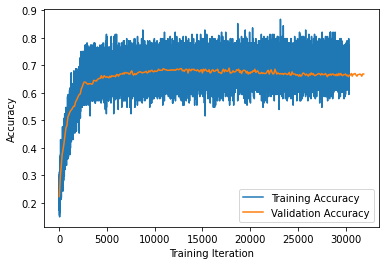

In [17]:
import matplotlib.pyplot as plt
plt.plot(range(len(training_accuracies)), training_accuracies, label = "Training Accuracy")
plt.plot(list(map(lambda x: x * 100, range(len(validation_accuracies)))), validation_accuracies, label = "Validation Accuracy")
plt.xlabel("Training Iteration")
plt.ylabel("Accuracy")
plt.legend()